In [1]:
import torch
from torch.utils.data import DataLoader
from transformers import BertForSequenceClassification, BertTokenizer, AdamW, get_linear_schedule_with_warmup
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score
import pandas as pd
import numpy as np
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments

In [2]:
# Load Train, Validation, Test Dataset
train_dataset = pd.read_csv('/kaggle/input/clinical-datasets/Google_Translated/Google_Translated/MIMIC_III/LOS_WEEKS_adm_train.csv')
val_dataset = pd.read_csv('/kaggle/input/clinical-datasets/Google_Translated/Google_Translated/MIMIC_III/LOS_WEEKS_adm_val.csv')
test_dataset = pd.read_csv('/kaggle/input/clinical-datasets/Google_Translated/Google_Translated/MIMIC_III/LOS_WEEKS_adm_test.csv')

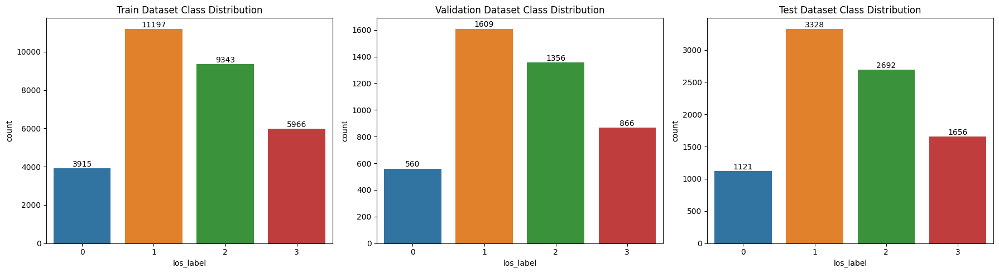

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Function to add count labels above bars
def add_count_labels(ax):
    for p in ax.patches:
        height = p.get_height()
        ax.text(p.get_x() + p.get_width() / 2., height + 0.5,  # Positioning the text
                f'{int(height)}', ha='center', va='bottom', fontsize=10)

# Train Set
sns.countplot(x='los_label', data=train_dataset, ax=axes[0])
axes[0].set_title("Train Dataset Class Distribution")
add_count_labels(axes[0])

# Validation Set
sns.countplot(x='los_label', data=val_dataset, ax=axes[1])
axes[1].set_title("Validation Dataset Class Distribution")
add_count_labels(axes[1])

# Test Set
sns.countplot(x='los_label', data=test_dataset, ax=axes[2])
axes[2].set_title("Test Dataset Class Distribution")
add_count_labels(axes[2])

# Display the plots
plt.tight_layout()
plt.show()

In [4]:
import torch
from torch import nn
import torch.nn.functional as F

class EnsembleModel(nn.Module):
    def __init__(self, model1, model2):
        super(EnsembleModel, self).__init__()
        self.model1 = model1
        self.model2 = model2
        
        # Initial attention scores (for learning importance of each model)
        self.attention1 = nn.Parameter(torch.tensor(1.0))  # Model 1 attention
        self.attention2 = nn.Parameter(torch.tensor(1.0))  # Model 2 attention
        
        # Model weight parameters (initialized to 1 for simplicity)
        self.weight1 = nn.Parameter(torch.tensor(1.0))
        self.weight2 = nn.Parameter(torch.tensor(1.0))
        
        # Parameters to keep track of performance (boosting mechanism)
        self.alpha1 = nn.Parameter(torch.tensor(0.5))
        self.alpha2 = nn.Parameter(torch.tensor(0.5))
    
    def forward(self, input_ids, attention_mask, loss1=None, loss2=None):
        # Get the model outputs
        outputs1 = self.model1(input_ids, attention_mask=attention_mask)[0]
        outputs2 = self.model2(input_ids, attention_mask=attention_mask)[0]
        
        # Apply softmax to normalize the model weights
        weights = torch.softmax(torch.stack([self.weight1, self.weight2]), dim=0)
        
        # Apply softmax to normalize the attention weights (to focus on the important model outputs)
        attention_weights = torch.softmax(torch.stack([self.attention1, self.attention2]), dim=0)
        
        # Weighted sum of the model outputs (with attention)
        weighted_output = attention_weights[0] * (weights[0] * outputs1) + attention_weights[1] * (weights[1] * outputs2)
        
        # Boosting: Update model weights based on model performance
        if loss1 is not None and loss2 is not None:
            # For simplicity, assume boosting updates are based on model performance
            # (i.e., inverse of loss) to increase focus on harder examples
            self.alpha1.data = self.alpha1.data * torch.exp(-loss1)
            self.alpha2.data = self.alpha2.data * torch.exp(-loss2)

            # Adjust model weights based on boosting factors
            self.weight1.data = self.weight1.data + self.alpha1
            self.weight2.data = self.weight2.data + self.alpha2

        return weighted_output

In [5]:
from transformers import AutoModelForSequenceClassification, AutoConfig

# Specify the dropout rate in the configuration
config = AutoConfig.from_pretrained('emilyalsentzer/Bio_ClinicalBERT', 
                                    num_labels=4, 
                                    hidden_dropout_prob=0.2, 
                                    attention_probs_dropout_prob=0.2)

# Load the pre-trained model with the specified configuration
model1 = AutoModelForSequenceClassification.from_pretrained('emilyalsentzer/Bio_ClinicalBERT', config=config)

config.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/436M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at emilyalsentzer/Bio_ClinicalBERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [6]:
from transformers import AutoModelForSequenceClassification, AutoConfig

# Specify the dropout rate in the configuration
config = AutoConfig.from_pretrained('emilyalsentzer/Bio_Discharge_Summary_BERT', 
                                    num_labels=4, 
                                    hidden_dropout_prob=0.2, 
                                    attention_probs_dropout_prob=0.2)

# Load the pre-trained model with the specified configuration
model2 = AutoModelForSequenceClassification.from_pretrained('emilyalsentzer/Bio_Discharge_Summary_BERT', config=config)

config.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/436M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at emilyalsentzer/Bio_Discharge_Summary_BERT and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [7]:
from transformers import AutoTokenizer

# Choose a tokenizer
tokenizer = AutoTokenizer.from_pretrained('emilyalsentzer/Bio_Discharge_Summary_BERT')

vocab.txt:   0%|          | 0.00/213k [00:00<?, ?B/s]

In [8]:
# Apply the tokenizer to the training, validation, and test datasets
train_encodings = tokenizer(train_dataset['text'].tolist(), truncation=True, padding=True, max_length = 512)
val_encodings = tokenizer(val_dataset['text'].tolist(), truncation=True, padding=True,  max_length = 512)
test_encodings = tokenizer(test_dataset['text'].tolist(), truncation=True, padding=True , max_length = 512)

In [9]:
# Create a Dataset for PyTorch
class LosDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = labels

    def __getitem__(self, idx):
        item = {key: torch.tensor(val[idx]) for key, val in self.encodings.items()}
        item['labels'] = torch.tensor(self.labels[idx])
        return item

    def __len__(self):
        return len(self.labels)

In [10]:
train_dataset = LosDataset(train_encodings, train_dataset['los_label'].tolist())
val_dataset = LosDataset(val_encodings, val_dataset['los_label'].tolist())
test_dataset = LosDataset(test_encodings, test_dataset['los_label'].tolist())

In [11]:
from transformers import AdamW, get_linear_schedule_with_warmup
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score, accuracy_score
from tqdm import tqdm
from torch import nn
import numpy as np


# Initialize the Ensemble Model
ensemble_model = EnsembleModel(
    model1, 
    model2)

In [12]:
#ensemble_model

In [13]:
import os

# list all files in the current directory
files = os.listdir('.')

# filter the ones that start with 'LOS_ENEMBLE_TEACHER'
core_models = [f for f in files if f.startswith('LOS_ENEMBLE_TEACHER')]

if core_models:
    print("Found models starting with 'LOS_ENEMBLE_TEACHER':")
    for model in core_models:
        print(model)
        
    # get the first (and supposedly only) model
    model_path = core_models[1]

    # load the model state
    ensemble_model.load_state_dict(torch.load(model_path))
    print("Loaded Model")
else:
    print("No models found starting with 'LOS_ENEMBLE_TEACHER'.")

No models found starting with 'LOS_ENEMBLE_TEACHER'.


In [14]:
# Push the model to device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
ensemble_model = ensemble_model.to(device)

In [15]:
train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=2, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=2, shuffle=False)

In [16]:
epochs = 100
best_roc_auc = 0
min_delta = 0.0001
early_stopping_count = 0
early_stopping_patience = 5
gradient_accumulation_steps = 10
best_model_path = "best_model.pth"

# Set the optimizer
optimizer = AdamW(ensemble_model.parameters(), lr=1e-5, weight_decay=0.01)

# Set the scheduler
scheduler = get_linear_schedule_with_warmup(
    optimizer, 
    num_warmup_steps=50, 
    num_training_steps=len(train_loader) * epochs // gradient_accumulation_steps
)


/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


In [17]:
import torch
from torch.nn import functional as F
import torch.nn as nn
import numpy as np
from tqdm import tqdm
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# Compute class weights
classes = np.unique(train_dataset.labels)  # Get unique class labels
class_weights = compute_class_weight('balanced', classes=classes, y=train_dataset.labels)
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

# Print class weights with corresponding class names
print("Class Weights:")
for cls, weight in zip(classes, class_weights):
    print(f"Class {cls}: Weight {weight}")

roc_auc_values = []
# Training loop
for epoch in range(0, epochs):
    ensemble_model.train()
    train_loss = 0
    for step, batch in enumerate(tqdm(train_loader)):
        optimizer.zero_grad() if step % gradient_accumulation_steps == 0 else None
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['labels'].to(device)

        outputs1 = ensemble_model.model1(input_ids, attention_mask=attention_mask)[0]
        outputs2 = ensemble_model.model2(input_ids, attention_mask=attention_mask)[0]
        # Compute individual losses
        loss_fn = nn.CrossEntropyLoss(weight=class_weights_tensor)
        loss1 = loss_fn(outputs1, labels)
        loss2 = loss_fn(outputs2, labels)
        
        ensemble_output = ensemble_model(input_ids, attention_mask, loss1=loss1, loss2=loss2)

        loss = loss_fn(ensemble_output, labels)

        (loss / gradient_accumulation_steps).backward()
        train_loss += loss.item()
        
        if (step + 1) % gradient_accumulation_steps == 0 or (step + 1) == len(train_loader):
            optimizer.step()
            scheduler.step()

    # Validation
    ensemble_model.eval()
    val_loss = 0
    val_preds = []
    val_labels = []
    with torch.no_grad():
        for batch in tqdm(val_loader):
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['labels'].to(device)

            outputs1 = ensemble_model.model1(input_ids, attention_mask=attention_mask)[0]
            outputs2 = ensemble_model.model2(input_ids, attention_mask=attention_mask)[0]
            # Compute individual losses
            loss_fn = nn.CrossEntropyLoss(weight=class_weights_tensor)
            loss1 = loss_fn(outputs1, labels)
            loss2 = loss_fn(outputs2, labels)
        
            ensemble_output = ensemble_model(input_ids, attention_mask, loss1=loss1, loss2=loss2)

            loss = loss_fn(ensemble_output, labels)

            val_loss += loss.item()

            val_preds.append(F.softmax(ensemble_output, dim=1).cpu().numpy())
            val_labels.append(labels.cpu().numpy())

    val_preds = np.concatenate(val_preds)
    val_labels = np.concatenate(val_labels)
    val_loss /= len(val_loader)
    train_loss /= len(train_loader)

    print(f'Epoch: {epoch+1}/{epochs}, Training Loss: {train_loss}, Validation Loss: {val_loss}')

    # Calculate evaluation metrics
    val_preds_class = np.argmax(val_preds, axis=1)
    accuracy = accuracy_score(val_labels, val_preds_class) 
    recall = recall_score(val_labels, val_preds_class, average='weighted') 
    precision = precision_score(val_labels, val_preds_class, average='weighted') 
    f1 = f1_score(val_labels, val_preds_class, average='weighted') 
    micro_f1 = f1_score(val_labels, val_preds_class, average='micro') 
    macro_roc_auc = roc_auc_score(val_labels, val_preds, multi_class='ovo', average='macro') 

    print(f'Accuracy: {accuracy}, Recall: {recall}, Precision: {precision}, F1: {f1}, Micro F1: {micro_f1}, Macro Roc Auc: {macro_roc_auc}')
    # Store the ROC-AUC value for this epoch
    roc_auc_values.append(macro_roc_auc)

    # Implement early stopping
    if epoch > 0 and macro_roc_auc - best_roc_auc < min_delta:
        early_stopping_count += 1
        print(f'EarlyStopping counter: {early_stopping_count} out of {early_stopping_patience}')
        if early_stopping_count >= early_stopping_patience:
            print('Early stopping')
            break
    else:
        best_roc_auc = macro_roc_auc
        early_stopping_count = 0
        torch.save(ensemble_model.state_dict(), f"LOS_ENEMBLE_TEACHER_epoch_{epoch}_roc_{best_roc_auc:.4f}.pth")

# After training, plot the ROC-AUC curve
plt.figure(figsize=(8, 5))
plt.plot(range(1, len(roc_auc_values) + 1), roc_auc_values, marker='o', linestyle='-', color='b', label='ROC-AUC Score')

# Enhancing readability
plt.title('ROC-AUC Score Progression', fontsize=14, fontweight='bold')
plt.xlabel('Epoch', fontsize=12)
plt.ylabel('ROC-AUC Score', fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=10, loc='lower right')
plt.ylim(0.7, 1.0)  # Adjust y-axis range if necessary

plt.show()

# Convert the list of ROC-AUC values and epochs to a DataFrame
roc_auc_df = pd.DataFrame(roc_auc_values)

# Save the DataFrame to a CSV file
roc_auc_df.to_csv('roc_auc_per_epoch.csv', index=False)

print("ROC-AUC values per epoch saved to 'roc_auc_per_epoch.csv'")

Class Weights:
Class 0: Weight 1.9425925925925926
Class 1: Weight 0.6792221130659998
Class 2: Weight 0.8140051375361232
Class 3: Weight 1.2747653369091518



  0%|          | 0/15211 [00:00<?, ?it/s]


  0%|          | 1/15211 [00:00<3:35:54,  1.17it/s]


  0%|          | 2/15211 [00:01<2:21:08,  1.80it/s]


  0%|          | 3/15211 [00:01<1:56:01,  2.18it/s]


  0%|          | 4/15211 [00:01<1:44:42,  2.42it/s]


  0%|          | 5/15211 [00:02<1:38:01,  2.59it/s]


  0%|          | 6/15211 [00:02<1:34:03,  2.69it/s]


  0%|          | 7/15211 [00:02<1:31:51,  2.76it/s]


  0%|          | 8/15211 [00:03<1:30:23,  2.80it/s]


  0%|          | 9/15211 [00:03<1:29:24,  2.83it/s]


  0%|          | 10/15211 [00:04<1:33:48,  2.70it/s]


  0%|          | 11/15211 [00:04<1:31:23,  2.77it/s]


  0%|          | 12/15211 [00:04<1:30:06,  2.81it/s]


  0%|          | 13/15211 [00:05<1:29:14,  2.84it/s]


  0%|          | 14/15211 [00:05<1:28:38,  2.86it/s]


  0%|          | 15/15211 [00:05<1:28:14,  2.87it/s]


  0%|          | 16/15211 [00:06<1:28:01,  2.88it/s]


  0%|          | 17/15211 [00:06<1:27:31,  2.89it/s]


  0%|          | 18/15211 [00:06<1:27:40,  2.89it/s]


  0%|          | 19/15211 [00:07<1:27:34,  2.89it/s]


  0%|          | 20/15211 [00:07<1:29:15,  2.84it/s]


  0%|          | 21/15211 [00:07<1:28:43,  2.85it/s]


  0%|          | 22/15211 [00:08<1:28:16,  2.87it/s]


  0%|          | 23/15211 [00:08<1:27:58,  2.88it/s]


  0%|          | 24/15211 [00:08<1:27:28,  2.89it/s]


  0%|          | 25/15211 [00:09<1:27:23,  2.90it/s]


  0%|          | 26/15211 [00:09<1:26:58,  2.91it/s]


  0%|          | 27/15211 [00:09<1:26:43,  2.92it/s]


  0%|          | 28/15211 [00:10<1:26:49,  2.91it/s]


  0%|          | 29/15211 [00:10<1:26:54,  2.91it/s]


  0%|          | 30/15211 [00:10<1:29:02,  2.84it/s]


  0%|          | 31/15211 [00:11<1:28:09,  2.87it/s]


  0%|          | 32/15211 [00:11<1:27:49,  2.88it/s]


  0%|          | 33/15211 [00:11<1:27:37,  2.89it/s]


  0%|          | 34/15211 [00:12<1:27:10,  2.90it/s]


  0%|          | 35/15211 [00:12<1:27:10,  2.90it/s]


  0%|          | 36/15211 [00:12<1:26:51,  2.91it/s]


  0%|          | 37/15211 [00:13<1:26:59,  2.91it/s]


  0%|          | 38/15211 [00:13<1:27:02,  2.91it/s]


  0%|          | 39/15211 [00:14<1:27:04,  2.90it/s]


  0%|          | 40/15211 [00:14<1:29:06,  2.84it/s]


  0%|          | 41/15211 [00:14<1:28:14,  2.87it/s]


  0%|          | 42/15211 [00:15<1:27:49,  2.88it/s]


  0%|          | 43/15211 [00:15<1:27:16,  2.90it/s]


  0%|          | 44/15211 [00:15<1:26:55,  2.91it/s]


  0%|          | 45/15211 [00:16<1:26:41,  2.92it/s]


  0%|          | 46/15211 [00:16<1:26:49,  2.91it/s]


  0%|          | 47/15211 [00:16<1:26:55,  2.91it/s]


  0%|          | 48/15211 [00:17<1:26:56,  2.91it/s]


  0%|          | 49/15211 [00:17<1:26:55,  2.91it/s]


  0%|          | 50/15211 [00:17<1:28:57,  2.84it/s]


  0%|          | 51/15211 [00:18<1:28:08,  2.87it/s]


  0%|          | 52/15211 [00:18<1:27:37,  2.88it/s]


  0%|          | 53/15211 [00:18<1:27:33,  2.89it/s]


  0%|          | 54/15211 [00:19<1:27:05,  2.90it/s]


  0%|          | 55/15211 [00:19<1:26:44,  2.91it/s]


  0%|          | 56/15211 [00:19<1:26:51,  2.91it/s]


  0%|          | 57/15211 [00:20<1:26:53,  2.91it/s]


  0%|          | 58/15211 [00:20<1:26:55,  2.91it/s]


  0%|          | 59/15211 [00:20<1:26:40,  2.91it/s]


  0%|          | 60/15211 [00:21<1:28:33,  2.85it/s]


  0%|          | 61/15211 [00:21<1:27:49,  2.88it/s]


  0%|          | 62/15211 [00:21<1:27:16,  2.89it/s]


  0%|          | 63/15211 [00:22<1:27:10,  2.90it/s]


  0%|          | 64/15211 [00:22<1:27:05,  2.90it/s]


  0%|          | 65/15211 [00:23<1:26:43,  2.91it/s]


  0%|          | 66/15211 [00:23<1:26:28,  2.92it/s]


  0%|          | 67/15211 [00:23<1:26:35,  2.91it/s]


  0%|          | 68/15211 [00:24<1:26:23,  2.92it/s]


  0%|          | 69/15211 [00:24<1:26:32,  2.92it/s]


  0%|          | 70/15211 [00:24<1:28:40,  2.85it/s]


  0%|          | 71/15211 [00:25<1:27:53,  2.87it/s]


  0%|          | 72/15211 [00:25<1:27:34,  2.88it/s]


  0%|          | 73/15211 [00:25<1:27:23,  2.89it/s]


  0%|          | 74/15211 [00:26<1:27:17,  2.89it/s]


  0%|          | 75/15211 [00:26<1:26:48,  2.91it/s]


  0%|          | 76/15211 [00:26<1:26:52,  2.90it/s]


  1%|          | 77/15211 [00:27<1:26:53,  2.90it/s]


  1%|          | 78/15211 [00:27<1:26:32,  2.91it/s]


  1%|          | 79/15211 [00:27<1:26:40,  2.91it/s]


  1%|          | 80/15211 [00:28<1:28:26,  2.85it/s]


  1%|          | 81/15211 [00:28<1:27:41,  2.88it/s]


  1%|          | 82/15211 [00:28<1:27:29,  2.88it/s]


  1%|          | 83/15211 [00:29<1:27:16,  2.89it/s]


  1%|          | 84/15211 [00:29<1:26:48,  2.90it/s]


  1%|          | 85/15211 [00:29<1:26:29,  2.91it/s]


  1%|          | 86/15211 [00:30<1:26:35,  2.91it/s]


  1%|          | 87/15211 [00:30<1:26:39,  2.91it/s]


  1%|          | 88/15211 [00:30<1:26:40,  2.91it/s]


  1%|          | 89/15211 [00:31<1:26:40,  2.91it/s]


  1%|          | 90/15211 [00:31<1:28:23,  2.85it/s]


  1%|          | 91/15211 [00:32<1:27:59,  2.86it/s]


  1%|          | 92/15211 [00:32<1:27:17,  2.89it/s]


  1%|          | 93/15211 [00:32<1:27:06,  2.89it/s]


  1%|          | 94/15211 [00:33<1:26:39,  2.91it/s]


  1%|          | 95/15211 [00:33<1:26:20,  2.92it/s]


  1%|          | 96/15211 [00:33<1:26:06,  2.93it/s]


  1%|          | 97/15211 [00:34<1:26:17,  2.92it/s]


  1%|          | 98/15211 [00:34<1:26:23,  2.92it/s]


  1%|          | 99/15211 [00:34<1:26:08,  2.92it/s]


  1%|          | 100/15211 [00:35<1:28:19,  2.85it/s]


  1%|          | 101/15211 [00:35<1:27:36,  2.87it/s]


  1%|          | 102/15211 [00:35<1:26:59,  2.89it/s]


  1%|          | 103/15211 [00:36<1:26:38,  2.91it/s]


  1%|          | 104/15211 [00:36<1:26:39,  2.91it/s]


  1%|          | 105/15211 [00:36<1:26:45,  2.90it/s]


  1%|          | 106/15211 [00:37<1:26:24,  2.91it/s]


  1%|          | 107/15211 [00:37<1:26:28,  2.91it/s]


  1%|          | 108/15211 [00:37<1:26:31,  2.91it/s]


  1%|          | 109/15211 [00:38<1:26:13,  2.92it/s]


  1%|          | 110/15211 [00:38<1:28:04,  2.86it/s]


  1%|          | 111/15211 [00:38<1:27:44,  2.87it/s]


  1%|          | 112/15211 [00:39<1:27:09,  2.89it/s]


  1%|          | 113/15211 [00:39<1:26:59,  2.89it/s]


  1%|          | 114/15211 [00:39<1:26:52,  2.90it/s]


  1%|          | 115/15211 [00:40<1:26:29,  2.91it/s]


  1%|          | 116/15211 [00:40<1:26:30,  2.91it/s]


  1%|          | 117/15211 [00:40<1:26:12,  2.92it/s]


  1%|          | 118/15211 [00:41<1:25:59,  2.93it/s]


  1%|          | 119/15211 [00:41<1:25:48,  2.93it/s]


  1%|          | 120/15211 [00:42<1:27:46,  2.87it/s]


  1%|          | 121/15211 [00:42<1:27:11,  2.88it/s]


  1%|          | 122/15211 [00:42<1:26:37,  2.90it/s]


  1%|          | 123/15211 [00:43<1:26:18,  2.91it/s]


  1%|          | 124/15211 [00:43<1:26:21,  2.91it/s]


  1%|          | 125/15211 [00:43<1:26:05,  2.92it/s]


  1%|          | 126/15211 [00:44<1:26:12,  2.92it/s]


  1%|          | 127/15211 [00:44<1:25:58,  2.92it/s]


  1%|          | 128/15211 [00:44<1:26:07,  2.92it/s]


  1%|          | 129/15211 [00:45<1:26:11,  2.92it/s]


  1%|          | 130/15211 [00:45<1:28:16,  2.85it/s]


  1%|          | 131/15211 [00:45<1:27:29,  2.87it/s]


  1%|          | 132/15211 [00:46<1:27:13,  2.88it/s]


  1%|          | 133/15211 [00:46<1:27:04,  2.89it/s]


  1%|          | 134/15211 [00:46<1:26:58,  2.89it/s]


  1%|          | 135/15211 [00:47<1:26:51,  2.89it/s]


  1%|          | 136/15211 [00:47<1:26:26,  2.91it/s]


  1%|          | 137/15211 [00:47<1:26:28,  2.91it/s]


  1%|          | 138/15211 [00:48<1:26:09,  2.92it/s]


  1%|          | 139/15211 [00:48<1:25:54,  2.92it/s]


  1%|          | 140/15211 [00:48<1:27:51,  2.86it/s]


  1%|          | 141/15211 [00:49<1:27:32,  2.87it/s]


  1%|          | 142/15211 [00:49<1:27:11,  2.88it/s]


  1%|          | 143/15211 [00:49<1:26:41,  2.90it/s]


  1%|          | 144/15211 [00:50<1:26:45,  2.89it/s]


  1%|          | 145/15211 [00:50<1:26:29,  2.90it/s]


  1%|          | 146/15211 [00:50<1:26:36,  2.90it/s]


  1%|          | 147/15211 [00:51<1:26:19,  2.91it/s]


  1%|          | 148/15211 [00:51<1:26:26,  2.90it/s]


  1%|          | 149/15211 [00:52<1:26:13,  2.91it/s]


  1%|          | 150/15211 [00:52<1:28:21,  2.84it/s]


  1%|          | 151/15211 [00:52<1:27:34,  2.87it/s]


  1%|          | 152/15211 [00:53<1:27:00,  2.88it/s]


  1%|          | 153/15211 [00:53<1:26:50,  2.89it/s]


  1%|          | 154/15211 [00:53<1:26:43,  2.89it/s]


  1%|          | 155/15211 [00:54<1:26:37,  2.90it/s]


  1%|          | 156/15211 [00:54<1:26:32,  2.90it/s]


  1%|          | 157/15211 [00:54<1:26:15,  2.91it/s]


  1%|          | 158/15211 [00:55<1:26:00,  2.92it/s]


  1%|          | 159/15211 [00:55<1:26:06,  2.91it/s]


  1%|          | 160/15211 [00:55<1:28:14,  2.84it/s]


  1%|          | 161/15211 [00:56<1:27:45,  2.86it/s]


  1%|          | 162/15211 [00:56<1:27:03,  2.88it/s]


  1%|          | 163/15211 [00:56<1:26:35,  2.90it/s]


  1%|          | 164/15211 [00:57<1:26:14,  2.91it/s]


  1%|          | 165/15211 [00:57<1:26:17,  2.91it/s]


  1%|          | 166/15211 [00:57<1:25:58,  2.92it/s]


  1%|          | 167/15211 [00:58<1:25:46,  2.92it/s]


  1%|          | 168/15211 [00:58<1:25:56,  2.92it/s]


  1%|          | 169/15211 [00:58<1:26:03,  2.91it/s]


  1%|          | 170/15211 [00:59<1:28:08,  2.84it/s]


  1%|          | 171/15211 [00:59<1:27:39,  2.86it/s]


  1%|          | 172/15211 [00:59<1:27:15,  2.87it/s]


  1%|          | 173/15211 [01:00<1:26:57,  2.88it/s]


  1%|          | 174/15211 [01:00<1:26:45,  2.89it/s]


  1%|          | 175/15211 [01:01<1:26:40,  2.89it/s]


  1%|          | 176/15211 [01:01<1:26:13,  2.91it/s]


  1%|          | 177/15211 [01:01<1:26:13,  2.91it/s]


  1%|          | 178/15211 [01:02<1:26:19,  2.90it/s]


  1%|          | 179/15211 [01:02<1:26:01,  2.91it/s]


  1%|          | 180/15211 [01:02<1:27:48,  2.85it/s]


  1%|          | 181/15211 [01:03<1:27:07,  2.88it/s]


  1%|          | 182/15211 [01:03<1:26:32,  2.89it/s]


  1%|          | 183/15211 [01:03<1:26:08,  2.91it/s]


  1%|          | 184/15211 [01:04<1:26:08,  2.91it/s]


  1%|          | 185/15211 [01:04<1:26:10,  2.91it/s]


  1%|          | 186/15211 [01:04<1:26:11,  2.91it/s]


  1%|          | 187/15211 [01:05<1:25:53,  2.92it/s]


  1%|          | 188/15211 [01:05<1:25:58,  2.91it/s]


  1%|          | 189/15211 [01:05<1:25:44,  2.92it/s]


  1%|          | 190/15211 [01:06<1:28:01,  2.84it/s]


  1%|▏         | 191/15211 [01:06<1:27:33,  2.86it/s]


  1%|▏         | 192/15211 [01:06<1:27:12,  2.87it/s]


  1%|▏         | 193/15211 [01:07<1:26:36,  2.89it/s]


  1%|▏         | 194/15211 [01:07<1:26:09,  2.91it/s]


  1%|▏         | 195/15211 [01:07<1:26:11,  2.90it/s]


  1%|▏         | 196/15211 [01:08<1:25:50,  2.92it/s]


  1%|▏         | 197/15211 [01:08<1:25:55,  2.91it/s]


  1%|▏         | 198/15211 [01:08<1:25:59,  2.91it/s]


  1%|▏         | 199/15211 [01:09<1:25:42,  2.92it/s]


  1%|▏         | 200/15211 [01:09<1:27:30,  2.86it/s]


  1%|▏         | 201/15211 [01:09<1:26:53,  2.88it/s]


  1%|▏         | 202/15211 [01:10<1:26:23,  2.90it/s]


  1%|▏         | 203/15211 [01:10<1:26:27,  2.89it/s]


  1%|▏         | 204/15211 [01:11<1:26:12,  2.90it/s]


  1%|▏         | 205/15211 [01:11<1:25:55,  2.91it/s]


  1%|▏         | 206/15211 [01:11<1:25:50,  2.91it/s]


  1%|▏         | 207/15211 [01:12<1:25:57,  2.91it/s]


  1%|▏         | 208/15211 [01:12<1:26:02,  2.91it/s]


  1%|▏         | 209/15211 [01:12<1:25:42,  2.92it/s]


  1%|▏         | 210/15211 [01:13<1:27:31,  2.86it/s]


  1%|▏         | 211/15211 [01:13<1:26:51,  2.88it/s]


  1%|▏         | 212/15211 [01:13<1:26:36,  2.89it/s]


  1%|▏         | 213/15211 [01:14<1:26:27,  2.89it/s]


  1%|▏         | 214/15211 [01:14<1:26:20,  2.89it/s]


  1%|▏         | 215/15211 [01:14<1:26:17,  2.90it/s]


  1%|▏         | 216/15211 [01:15<1:25:54,  2.91it/s]


  1%|▏         | 217/15211 [01:15<1:25:56,  2.91it/s]


  1%|▏         | 218/15211 [01:15<1:25:58,  2.91it/s]


  1%|▏         | 219/15211 [01:16<1:26:06,  2.90it/s]


  1%|▏         | 220/15211 [01:16<1:27:51,  2.84it/s]


  1%|▏         | 221/15211 [01:16<1:27:03,  2.87it/s]


  1%|▏         | 222/15211 [01:17<1:26:45,  2.88it/s]


  1%|▏         | 223/15211 [01:17<1:26:12,  2.90it/s]


  1%|▏         | 224/15211 [01:17<1:25:53,  2.91it/s]


  1%|▏         | 225/15211 [01:18<1:25:43,  2.91it/s]


  1%|▏         | 226/15211 [01:18<1:25:33,  2.92it/s]


  1%|▏         | 227/15211 [01:18<1:25:45,  2.91it/s]


  1%|▏         | 228/15211 [01:19<1:25:52,  2.91it/s]


  2%|▏         | 229/15211 [01:19<1:25:54,  2.91it/s]


  2%|▏         | 230/15211 [01:20<1:28:00,  2.84it/s]


  2%|▏         | 231/15211 [01:20<1:27:10,  2.86it/s]


  2%|▏         | 232/15211 [01:20<1:26:49,  2.88it/s]


  2%|▏         | 233/15211 [01:21<1:26:39,  2.88it/s]


  2%|▏         | 234/15211 [01:21<1:26:32,  2.88it/s]


  2%|▏         | 235/15211 [01:21<1:26:11,  2.90it/s]


  2%|▏         | 236/15211 [01:22<1:25:55,  2.90it/s]


  2%|▏         | 237/15211 [01:22<1:26:04,  2.90it/s]


  2%|▏         | 238/15211 [01:22<1:26:02,  2.90it/s]


  2%|▏         | 239/15211 [01:23<1:26:01,  2.90it/s]


  2%|▏         | 240/15211 [01:23<1:28:01,  2.83it/s]


  2%|▏         | 241/15211 [01:23<1:27:32,  2.85it/s]


  2%|▏         | 242/15211 [01:24<1:27:05,  2.86it/s]


  2%|▏         | 243/15211 [01:24<1:26:45,  2.88it/s]


  2%|▏         | 244/15211 [01:24<1:26:32,  2.88it/s]


  2%|▏         | 245/15211 [01:25<1:26:21,  2.89it/s]


  2%|▏         | 246/15211 [01:25<1:26:14,  2.89it/s]


  2%|▏         | 247/15211 [01:25<1:25:49,  2.91it/s]


  2%|▏         | 248/15211 [01:26<1:25:55,  2.90it/s]


  2%|▏         | 249/15211 [01:26<1:25:56,  2.90it/s]


  2%|▏         | 250/15211 [01:26<1:28:00,  2.83it/s]


  2%|▏         | 251/15211 [01:27<1:27:06,  2.86it/s]


  2%|▏         | 252/15211 [01:27<1:26:26,  2.88it/s]


  2%|▏         | 253/15211 [01:27<1:26:17,  2.89it/s]


  2%|▏         | 254/15211 [01:28<1:25:52,  2.90it/s]


  2%|▏         | 255/15211 [01:28<1:25:52,  2.90it/s]


  2%|▏         | 256/15211 [01:29<1:25:35,  2.91it/s]


  2%|▏         | 257/15211 [01:29<1:25:21,  2.92it/s]


  2%|▏         | 258/15211 [01:29<1:25:31,  2.91it/s]


  2%|▏         | 259/15211 [01:30<1:25:20,  2.92it/s]


  2%|▏         | 260/15211 [01:30<1:27:30,  2.85it/s]


  2%|▏         | 261/15211 [01:30<1:27:07,  2.86it/s]


  2%|▏         | 262/15211 [01:31<1:26:45,  2.87it/s]


  2%|▏         | 263/15211 [01:31<1:26:32,  2.88it/s]


  2%|▏         | 264/15211 [01:31<1:26:21,  2.88it/s]


  2%|▏         | 265/15211 [01:32<1:26:15,  2.89it/s]


  2%|▏         | 266/15211 [01:32<1:26:13,  2.89it/s]


  2%|▏         | 267/15211 [01:32<1:26:07,  2.89it/s]


  2%|▏         | 268/15211 [01:33<1:25:45,  2.90it/s]


  2%|▏         | 269/15211 [01:33<1:25:45,  2.90it/s]


  2%|▏         | 270/15211 [01:33<1:27:48,  2.84it/s]


  2%|▏         | 271/15211 [01:34<1:27:15,  2.85it/s]


  2%|▏         | 272/15211 [01:34<1:26:48,  2.87it/s]


  2%|▏         | 273/15211 [01:34<1:26:28,  2.88it/s]


  2%|▏         | 274/15211 [01:35<1:26:17,  2.89it/s]


  2%|▏         | 275/15211 [01:35<1:26:07,  2.89it/s]


  2%|▏         | 276/15211 [01:35<1:26:02,  2.89it/s]


  2%|▏         | 277/15211 [01:36<1:26:00,  2.89it/s]


  2%|▏         | 278/15211 [01:36<1:25:57,  2.90it/s]


  2%|▏         | 279/15211 [01:36<1:25:36,  2.91it/s]


  2%|▏         | 280/15211 [01:37<1:27:18,  2.85it/s]


  2%|▏         | 281/15211 [01:37<1:26:35,  2.87it/s]


  2%|▏         | 282/15211 [01:38<1:26:22,  2.88it/s]


  2%|▏         | 283/15211 [01:38<1:26:09,  2.89it/s]


  2%|▏         | 284/15211 [01:38<1:26:02,  2.89it/s]


  2%|▏         | 285/15211 [01:39<1:25:59,  2.89it/s]


  2%|▏         | 286/15211 [01:39<1:25:56,  2.89it/s]


  2%|▏         | 287/15211 [01:39<1:25:50,  2.90it/s]


  2%|▏         | 288/15211 [01:40<1:25:51,  2.90it/s]


  2%|▏         | 289/15211 [01:40<1:25:48,  2.90it/s]


  2%|▏         | 290/15211 [01:40<1:27:45,  2.83it/s]


  2%|▏         | 291/15211 [01:41<1:27:13,  2.85it/s]


  2%|▏         | 292/15211 [01:41<1:26:25,  2.88it/s]


  2%|▏         | 293/15211 [01:41<1:26:19,  2.88it/s]


  2%|▏         | 294/15211 [01:42<1:26:12,  2.88it/s]


  2%|▏         | 295/15211 [01:42<1:26:04,  2.89it/s]


  2%|▏         | 296/15211 [01:42<1:25:39,  2.90it/s]


  2%|▏         | 297/15211 [01:43<1:25:20,  2.91it/s]


  2%|▏         | 298/15211 [01:43<1:25:26,  2.91it/s]


  2%|▏         | 299/15211 [01:43<1:25:30,  2.91it/s]


  2%|▏         | 300/15211 [01:44<1:27:33,  2.84it/s]


  2%|▏         | 301/15211 [01:44<1:26:44,  2.86it/s]


  2%|▏         | 302/15211 [01:44<1:26:03,  2.89it/s]


  2%|▏         | 303/15211 [01:45<1:25:55,  2.89it/s]


  2%|▏         | 304/15211 [01:45<1:25:47,  2.90it/s]


  2%|▏         | 305/15211 [01:46<1:25:44,  2.90it/s]


  2%|▏         | 306/15211 [01:46<1:25:47,  2.90it/s]


  2%|▏         | 307/15211 [01:46<1:25:49,  2.89it/s]


  2%|▏         | 308/15211 [01:47<1:25:47,  2.90it/s]


  2%|▏         | 309/15211 [01:47<1:25:42,  2.90it/s]


  2%|▏         | 310/15211 [01:47<1:27:40,  2.83it/s]


  2%|▏         | 311/15211 [01:48<1:27:06,  2.85it/s]


  2%|▏         | 312/15211 [01:48<1:26:38,  2.87it/s]


  2%|▏         | 313/15211 [01:48<1:26:18,  2.88it/s]


  2%|▏         | 314/15211 [01:49<1:26:06,  2.88it/s]


  2%|▏         | 315/15211 [01:49<1:25:56,  2.89it/s]


  2%|▏         | 316/15211 [01:49<1:25:48,  2.89it/s]


  2%|▏         | 317/15211 [01:50<1:25:24,  2.91it/s]


  2%|▏         | 318/15211 [01:50<1:25:05,  2.92it/s]


  2%|▏         | 319/15211 [01:50<1:24:57,  2.92it/s]


  2%|▏         | 320/15211 [01:51<1:27:05,  2.85it/s]


  2%|▏         | 321/15211 [01:51<1:26:40,  2.86it/s]


  2%|▏         | 322/15211 [01:51<1:26:20,  2.87it/s]


  2%|▏         | 323/15211 [01:52<1:26:08,  2.88it/s]


  2%|▏         | 324/15211 [01:52<1:25:56,  2.89it/s]


  2%|▏         | 325/15211 [01:52<1:25:50,  2.89it/s]


  2%|▏         | 326/15211 [01:53<1:25:30,  2.90it/s]


  2%|▏         | 327/15211 [01:53<1:25:35,  2.90it/s]


  2%|▏         | 328/15211 [01:53<1:25:16,  2.91it/s]


  2%|▏         | 329/15211 [01:54<1:25:00,  2.92it/s]


  2%|▏         | 330/15211 [01:54<1:26:50,  2.86it/s]


  2%|▏         | 331/15211 [01:55<1:26:30,  2.87it/s]


  2%|▏         | 332/15211 [01:55<1:26:13,  2.88it/s]


  2%|▏         | 333/15211 [01:55<1:26:00,  2.88it/s]


  2%|▏         | 334/15211 [01:56<1:25:55,  2.89it/s]


  2%|▏         | 335/15211 [01:56<1:25:31,  2.90it/s]


  2%|▏         | 336/15211 [01:56<1:25:15,  2.91it/s]


  2%|▏         | 337/15211 [01:57<1:25:21,  2.90it/s]


  2%|▏         | 338/15211 [01:57<1:25:04,  2.91it/s]


  2%|▏         | 339/15211 [01:57<1:25:10,  2.91it/s]


  2%|▏         | 340/15211 [01:58<1:27:13,  2.84it/s]


  2%|▏         | 341/15211 [01:58<1:26:44,  2.86it/s]


  2%|▏         | 342/15211 [01:58<1:26:19,  2.87it/s]


  2%|▏         | 343/15211 [01:59<1:26:04,  2.88it/s]


  2%|▏         | 344/15211 [01:59<1:25:33,  2.90it/s]


  2%|▏         | 345/15211 [01:59<1:25:12,  2.91it/s]


  2%|▏         | 346/15211 [02:00<1:25:15,  2.91it/s]


  2%|▏         | 347/15211 [02:00<1:25:17,  2.90it/s]


  2%|▏         | 348/15211 [02:00<1:25:18,  2.90it/s]


  2%|▏         | 349/15211 [02:01<1:25:18,  2.90it/s]


  2%|▏         | 350/15211 [02:01<1:26:58,  2.85it/s]


  2%|▏         | 351/15211 [02:01<1:26:34,  2.86it/s]


  2%|▏         | 352/15211 [02:02<1:25:52,  2.88it/s]


  2%|▏         | 353/15211 [02:02<1:25:43,  2.89it/s]


  2%|▏         | 354/15211 [02:02<1:25:17,  2.90it/s]


  2%|▏         | 355/15211 [02:03<1:25:17,  2.90it/s]


  2%|▏         | 356/15211 [02:03<1:25:18,  2.90it/s]


  2%|▏         | 357/15211 [02:04<1:25:17,  2.90it/s]


  2%|▏         | 358/15211 [02:04<1:24:58,  2.91it/s]


  2%|▏         | 359/15211 [02:04<1:25:02,  2.91it/s]


  2%|▏         | 360/15211 [02:05<1:27:11,  2.84it/s]


  2%|▏         | 361/15211 [02:05<1:26:40,  2.86it/s]


  2%|▏         | 362/15211 [02:05<1:26:13,  2.87it/s]


  2%|▏         | 363/15211 [02:06<1:25:58,  2.88it/s]


  2%|▏         | 364/15211 [02:06<1:25:28,  2.89it/s]


  2%|▏         | 365/15211 [02:06<1:25:38,  2.89it/s]


  2%|▏         | 366/15211 [02:07<1:25:14,  2.90it/s]


  2%|▏         | 367/15211 [02:07<1:25:14,  2.90it/s]


  2%|▏         | 368/15211 [02:07<1:25:15,  2.90it/s]


  2%|▏         | 369/15211 [02:08<1:25:16,  2.90it/s]


  2%|▏         | 370/15211 [02:08<1:26:56,  2.85it/s]


  2%|▏         | 371/15211 [02:08<1:26:09,  2.87it/s]


  2%|▏         | 372/15211 [02:09<1:25:53,  2.88it/s]


  2%|▏         | 373/15211 [02:09<1:25:40,  2.89it/s]


  2%|▏         | 374/15211 [02:09<1:25:32,  2.89it/s]


  2%|▏         | 375/15211 [02:10<1:25:09,  2.90it/s]


  2%|▏         | 376/15211 [02:10<1:24:48,  2.92it/s]


  2%|▏         | 377/15211 [02:10<1:24:55,  2.91it/s]


  2%|▏         | 378/15211 [02:11<1:25:02,  2.91it/s]


  2%|▏         | 379/15211 [02:11<1:25:05,  2.91it/s]


  2%|▏         | 380/15211 [02:11<1:26:51,  2.85it/s]


  3%|▎         | 381/15211 [02:12<1:26:07,  2.87it/s]


  3%|▎         | 382/15211 [02:12<1:25:30,  2.89it/s]


  3%|▎         | 383/15211 [02:13<1:25:06,  2.90it/s]


  3%|▎         | 384/15211 [02:13<1:24:51,  2.91it/s]


  3%|▎         | 385/15211 [02:13<1:24:42,  2.92it/s]


  3%|▎         | 386/15211 [02:14<1:24:33,  2.92it/s]


  3%|▎         | 387/15211 [02:14<1:24:47,  2.91it/s]


  3%|▎         | 388/15211 [02:14<1:24:52,  2.91it/s]


  3%|▎         | 389/15211 [02:15<1:25:00,  2.91it/s]


  3%|▎         | 390/15211 [02:15<1:26:59,  2.84it/s]


  3%|▎         | 391/15211 [02:15<1:26:28,  2.86it/s]


  3%|▎         | 392/15211 [02:16<1:26:08,  2.87it/s]


  3%|▎         | 393/15211 [02:16<1:25:52,  2.88it/s]


  3%|▎         | 394/15211 [02:16<1:25:40,  2.88it/s]


  3%|▎         | 395/15211 [02:17<1:25:33,  2.89it/s]


  3%|▎         | 396/15211 [02:17<1:25:25,  2.89it/s]


  3%|▎         | 397/15211 [02:17<1:25:01,  2.90it/s]


  3%|▎         | 398/15211 [02:18<1:24:44,  2.91it/s]


  3%|▎         | 399/15211 [02:18<1:24:48,  2.91it/s]


  3%|▎         | 400/15211 [02:18<1:26:49,  2.84it/s]


  3%|▎         | 401/15211 [02:19<1:26:03,  2.87it/s]


  3%|▎         | 402/15211 [02:19<1:25:43,  2.88it/s]


  3%|▎         | 403/15211 [02:19<1:25:11,  2.90it/s]


  3%|▎         | 404/15211 [02:20<1:24:50,  2.91it/s]


  3%|▎         | 405/15211 [02:20<1:24:53,  2.91it/s]


  3%|▎         | 406/15211 [02:20<1:24:36,  2.92it/s]


  3%|▎         | 407/15211 [02:21<1:24:42,  2.91it/s]


  3%|▎         | 408/15211 [02:21<1:24:47,  2.91it/s]


  3%|▎         | 409/15211 [02:21<1:24:53,  2.91it/s]


  3%|▎         | 410/15211 [02:22<1:26:34,  2.85it/s]


  3%|▎         | 411/15211 [02:22<1:26:09,  2.86it/s]


  3%|▎         | 412/15211 [02:23<1:25:48,  2.87it/s]


  3%|▎         | 413/15211 [02:23<1:25:13,  2.89it/s]


  3%|▎         | 414/15211 [02:23<1:24:48,  2.91it/s]


  3%|▎         | 415/15211 [02:24<1:24:50,  2.91it/s]


  3%|▎         | 416/15211 [02:24<1:24:52,  2.91it/s]


  3%|▎         | 417/15211 [02:24<1:24:43,  2.91it/s]


  3%|▎         | 418/15211 [02:25<1:24:37,  2.91it/s]


  3%|▎         | 419/15211 [02:25<1:24:27,  2.92it/s]


  3%|▎         | 420/15211 [02:25<1:26:36,  2.85it/s]


  3%|▎         | 421/15211 [02:26<1:25:53,  2.87it/s]


  3%|▎         | 422/15211 [02:26<1:25:39,  2.88it/s]


  3%|▎         | 423/15211 [02:26<1:25:29,  2.88it/s]


  3%|▎         | 424/15211 [02:27<1:25:04,  2.90it/s]


  3%|▎         | 425/15211 [02:27<1:24:44,  2.91it/s]


  3%|▎         | 426/15211 [02:27<1:24:30,  2.92it/s]


  3%|▎         | 427/15211 [02:28<1:24:38,  2.91it/s]


  3%|▎         | 428/15211 [02:28<1:24:41,  2.91it/s]


  3%|▎         | 429/15211 [02:28<1:24:45,  2.91it/s]


  3%|▎         | 430/15211 [02:29<1:26:28,  2.85it/s]


  3%|▎         | 431/15211 [02:29<1:26:03,  2.86it/s]


  3%|▎         | 432/15211 [02:29<1:25:22,  2.89it/s]


  3%|▎         | 433/15211 [02:30<1:24:56,  2.90it/s]


  3%|▎         | 434/15211 [02:30<1:24:55,  2.90it/s]


  3%|▎         | 435/15211 [02:30<1:24:36,  2.91it/s]


  3%|▎         | 436/15211 [02:31<1:24:40,  2.91it/s]


  3%|▎         | 437/15211 [02:31<1:24:42,  2.91it/s]


  3%|▎         | 438/15211 [02:32<1:24:49,  2.90it/s]


  3%|▎         | 439/15211 [02:32<1:24:53,  2.90it/s]


  3%|▎         | 440/15211 [02:32<1:26:30,  2.85it/s]


  3%|▎         | 441/15211 [02:33<1:26:04,  2.86it/s]


  3%|▎         | 442/15211 [02:33<1:25:41,  2.87it/s]


  3%|▎         | 443/15211 [02:33<1:25:26,  2.88it/s]


  3%|▎         | 444/15211 [02:34<1:25:15,  2.89it/s]


  3%|▎         | 445/15211 [02:34<1:25:05,  2.89it/s]


  3%|▎         | 446/15211 [02:34<1:24:42,  2.90it/s]


  3%|▎         | 447/15211 [02:35<1:24:45,  2.90it/s]


  3%|▎         | 448/15211 [02:35<1:24:26,  2.91it/s]


  3%|▎         | 449/15211 [02:35<1:24:15,  2.92it/s]


  3%|▎         | 450/15211 [02:36<1:26:29,  2.84it/s]


  3%|▎         | 451/15211 [02:36<1:26:03,  2.86it/s]


  3%|▎         | 452/15211 [02:36<1:25:41,  2.87it/s]


  3%|▎         | 453/15211 [02:37<1:25:26,  2.88it/s]


  3%|▎         | 454/15211 [02:37<1:25:15,  2.88it/s]


  3%|▎         | 455/15211 [02:37<1:24:46,  2.90it/s]


  3%|▎         | 456/15211 [02:38<1:24:44,  2.90it/s]


  3%|▎         | 457/15211 [02:38<1:24:27,  2.91it/s]


  3%|▎         | 458/15211 [02:38<1:24:31,  2.91it/s]


  3%|▎         | 459/15211 [02:39<1:24:37,  2.91it/s]


  3%|▎         | 460/15211 [02:39<1:26:17,  2.85it/s]


  3%|▎         | 461/15211 [02:40<1:25:54,  2.86it/s]


  3%|▎         | 462/15211 [02:40<1:25:34,  2.87it/s]


  3%|▎         | 463/15211 [02:40<1:25:00,  2.89it/s]


  3%|▎         | 464/15211 [02:41<1:24:37,  2.90it/s]


  3%|▎         | 465/15211 [02:41<1:24:37,  2.90it/s]


  3%|▎         | 466/15211 [02:41<1:24:37,  2.90it/s]


  3%|▎         | 467/15211 [02:42<1:24:24,  2.91it/s]


  3%|▎         | 468/15211 [02:42<1:24:13,  2.92it/s]


  3%|▎         | 469/15211 [02:42<1:24:20,  2.91it/s]


  3%|▎         | 470/15211 [02:43<1:26:26,  2.84it/s]


  3%|▎         | 471/15211 [02:43<1:25:58,  2.86it/s]


  3%|▎         | 472/15211 [02:43<1:25:31,  2.87it/s]


  3%|▎         | 473/15211 [02:44<1:24:59,  2.89it/s]


  3%|▎         | 474/15211 [02:44<1:24:51,  2.89it/s]


  3%|▎         | 475/15211 [02:44<1:24:51,  2.89it/s]


  3%|▎         | 476/15211 [02:45<1:24:52,  2.89it/s]


  3%|▎         | 477/15211 [02:45<1:24:33,  2.90it/s]


  3%|▎         | 478/15211 [02:45<1:24:15,  2.91it/s]


  3%|▎         | 479/15211 [02:46<1:24:26,  2.91it/s]


  3%|▎         | 480/15211 [02:46<1:26:29,  2.84it/s]


  3%|▎         | 481/15211 [02:46<1:26:00,  2.85it/s]


  3%|▎         | 482/15211 [02:47<1:25:15,  2.88it/s]


  3%|▎         | 483/15211 [02:47<1:25:02,  2.89it/s]


  3%|▎         | 484/15211 [02:47<1:24:51,  2.89it/s]


  3%|▎         | 485/15211 [02:48<1:24:28,  2.91it/s]


  3%|▎         | 486/15211 [02:48<1:24:08,  2.92it/s]


  3%|▎         | 487/15211 [02:48<1:23:56,  2.92it/s]


  3%|▎         | 488/15211 [02:49<1:23:47,  2.93it/s]


  3%|▎         | 489/15211 [02:49<1:24:00,  2.92it/s]


  3%|▎         | 490/15211 [02:50<1:25:46,  2.86it/s]


  3%|▎         | 491/15211 [02:50<1:25:10,  2.88it/s]


  3%|▎         | 492/15211 [02:50<1:24:37,  2.90it/s]


  3%|▎         | 493/15211 [02:51<1:24:34,  2.90it/s]


  3%|▎         | 494/15211 [02:51<1:24:31,  2.90it/s]


  3%|▎         | 495/15211 [02:51<1:24:32,  2.90it/s]


  3%|▎         | 496/15211 [02:52<1:24:12,  2.91it/s]


  3%|▎         | 497/15211 [02:52<1:23:59,  2.92it/s]


  3%|▎         | 498/15211 [02:52<1:23:46,  2.93it/s]


  3%|▎         | 499/15211 [02:53<1:23:58,  2.92it/s]


  3%|▎         | 500/15211 [02:53<1:26:05,  2.85it/s]


  3%|▎         | 501/15211 [02:53<1:25:21,  2.87it/s]


  3%|▎         | 502/15211 [02:54<1:24:47,  2.89it/s]


  3%|▎         | 503/15211 [02:54<1:24:23,  2.90it/s]


  3%|▎         | 504/15211 [02:54<1:24:27,  2.90it/s]


  3%|▎         | 505/15211 [02:55<1:24:26,  2.90it/s]


  3%|▎         | 506/15211 [02:55<1:24:06,  2.91it/s]


  3%|▎         | 507/15211 [02:55<1:24:19,  2.91it/s]


  3%|▎         | 508/15211 [02:56<1:24:32,  2.90it/s]


  3%|▎         | 509/15211 [02:56<1:24:16,  2.91it/s]


  3%|▎         | 510/15211 [02:56<1:26:25,  2.84it/s]


  3%|▎         | 511/15211 [02:57<1:25:49,  2.85it/s]


  3%|▎         | 512/15211 [02:57<1:25:07,  2.88it/s]


  3%|▎         | 513/15211 [02:57<1:24:36,  2.90it/s]


  3%|▎         | 514/15211 [02:58<1:24:37,  2.89it/s]


  3%|▎         | 515/15211 [02:58<1:24:33,  2.90it/s]


  3%|▎         | 516/15211 [02:59<1:24:32,  2.90it/s]


  3%|▎         | 517/15211 [02:59<1:24:29,  2.90it/s]


  3%|▎         | 518/15211 [02:59<1:24:27,  2.90it/s]


  3%|▎         | 519/15211 [03:00<1:24:07,  2.91it/s]


  3%|▎         | 520/15211 [03:00<1:26:11,  2.84it/s]


  3%|▎         | 521/15211 [03:00<1:25:41,  2.86it/s]


  3%|▎         | 522/15211 [03:01<1:25:18,  2.87it/s]


  3%|▎         | 523/15211 [03:01<1:25:01,  2.88it/s]


  3%|▎         | 524/15211 [03:01<1:24:50,  2.89it/s]


  3%|▎         | 525/15211 [03:02<1:24:25,  2.90it/s]


  3%|▎         | 526/15211 [03:02<1:24:26,  2.90it/s]


  3%|▎         | 527/15211 [03:02<1:24:25,  2.90it/s]


  3%|▎         | 528/15211 [03:03<1:24:06,  2.91it/s]


  3%|▎         | 529/15211 [03:03<1:24:10,  2.91it/s]


  3%|▎         | 530/15211 [03:03<1:26:11,  2.84it/s]


  3%|▎         | 531/15211 [03:04<1:25:23,  2.87it/s]


  3%|▎         | 532/15211 [03:04<1:24:46,  2.89it/s]


  4%|▎         | 533/15211 [03:04<1:24:37,  2.89it/s]


  4%|▎         | 534/15211 [03:05<1:24:36,  2.89it/s]


  4%|▎         | 535/15211 [03:05<1:24:12,  2.90it/s]


  4%|▎         | 536/15211 [03:05<1:23:57,  2.91it/s]


  4%|▎         | 537/15211 [03:06<1:24:06,  2.91it/s]


  4%|▎         | 538/15211 [03:06<1:23:53,  2.92it/s]


  4%|▎         | 539/15211 [03:06<1:23:44,  2.92it/s]


  4%|▎         | 540/15211 [03:07<1:25:33,  2.86it/s]


  4%|▎         | 541/15211 [03:07<1:25:14,  2.87it/s]


  4%|▎         | 542/15211 [03:08<1:24:57,  2.88it/s]


  4%|▎         | 543/15211 [03:08<1:24:25,  2.90it/s]


  4%|▎         | 544/15211 [03:08<1:24:19,  2.90it/s]


  4%|▎         | 545/15211 [03:09<1:24:16,  2.90it/s]


  4%|▎         | 546/15211 [03:09<1:24:15,  2.90it/s]


  4%|▎         | 547/15211 [03:09<1:24:13,  2.90it/s]


  4%|▎         | 548/15211 [03:10<1:23:53,  2.91it/s]


  4%|▎         | 549/15211 [03:10<1:23:58,  2.91it/s]


  4%|▎         | 550/15211 [03:10<1:25:59,  2.84it/s]


  4%|▎         | 551/15211 [03:11<1:25:31,  2.86it/s]


  4%|▎         | 552/15211 [03:11<1:25:04,  2.87it/s]


  4%|▎         | 553/15211 [03:11<1:24:49,  2.88it/s]


  4%|▎         | 554/15211 [03:12<1:24:19,  2.90it/s]


  4%|▎         | 555/15211 [03:12<1:24:15,  2.90it/s]


  4%|▎         | 556/15211 [03:12<1:24:12,  2.90it/s]


  4%|▎         | 557/15211 [03:13<1:23:53,  2.91it/s]


  4%|▎         | 558/15211 [03:13<1:23:56,  2.91it/s]


  4%|▎         | 559/15211 [03:13<1:23:40,  2.92it/s]


  4%|▎         | 560/15211 [03:14<1:25:25,  2.86it/s]


  4%|▎         | 561/15211 [03:14<1:24:47,  2.88it/s]


  4%|▎         | 562/15211 [03:14<1:24:14,  2.90it/s]


  4%|▎         | 563/15211 [03:15<1:24:11,  2.90it/s]


  4%|▎         | 564/15211 [03:15<1:24:08,  2.90it/s]


  4%|▎         | 565/15211 [03:15<1:23:48,  2.91it/s]


  4%|▎         | 566/15211 [03:16<1:23:58,  2.91it/s]


  4%|▎         | 567/15211 [03:16<1:23:44,  2.91it/s]


  4%|▎         | 568/15211 [03:16<1:23:53,  2.91it/s]


  4%|▎         | 569/15211 [03:17<1:23:59,  2.91it/s]


  4%|▎         | 570/15211 [03:17<1:25:58,  2.84it/s]


  4%|▍         | 571/15211 [03:18<1:25:09,  2.87it/s]


  4%|▍         | 572/15211 [03:18<1:24:30,  2.89it/s]


  4%|▍         | 573/15211 [03:18<1:24:04,  2.90it/s]


  4%|▍         | 574/15211 [03:19<1:24:04,  2.90it/s]


  4%|▍         | 575/15211 [03:19<1:23:44,  2.91it/s]


  4%|▍         | 576/15211 [03:19<1:23:49,  2.91it/s]


  4%|▍         | 577/15211 [03:20<1:23:49,  2.91it/s]


  4%|▍         | 578/15211 [03:20<1:23:34,  2.92it/s]


  4%|▍         | 579/15211 [03:20<1:23:41,  2.91it/s]


  4%|▍         | 580/15211 [03:21<1:25:45,  2.84it/s]


  4%|▍         | 581/15211 [03:21<1:25:17,  2.86it/s]


  4%|▍         | 582/15211 [03:21<1:24:36,  2.88it/s]


  4%|▍         | 583/15211 [03:22<1:24:28,  2.89it/s]


  4%|▍         | 584/15211 [03:22<1:24:19,  2.89it/s]


  4%|▍         | 585/15211 [03:22<1:24:12,  2.89it/s]


  4%|▍         | 586/15211 [03:23<1:23:51,  2.91it/s]


  4%|▍         | 587/15211 [03:23<1:23:36,  2.92it/s]


  4%|▍         | 588/15211 [03:23<1:23:44,  2.91it/s]


  4%|▍         | 589/15211 [03:24<1:23:48,  2.91it/s]


  4%|▍         | 590/15211 [03:24<1:25:49,  2.84it/s]


  4%|▍         | 591/15211 [03:24<1:25:02,  2.87it/s]


  4%|▍         | 592/15211 [03:25<1:24:43,  2.88it/s]


  4%|▍         | 593/15211 [03:25<1:24:31,  2.88it/s]


  4%|▍         | 594/15211 [03:25<1:24:22,  2.89it/s]


  4%|▍         | 595/15211 [03:26<1:24:17,  2.89it/s]


  4%|▍         | 596/15211 [03:26<1:23:57,  2.90it/s]


  4%|▍         | 597/15211 [03:27<1:23:58,  2.90it/s]


  4%|▍         | 598/15211 [03:27<1:24:00,  2.90it/s]


  4%|▍         | 599/15211 [03:27<1:24:00,  2.90it/s]


  4%|▍         | 600/15211 [03:28<1:26:05,  2.83it/s]


  4%|▍         | 601/15211 [03:28<1:25:30,  2.85it/s]


  4%|▍         | 602/15211 [03:28<1:25:04,  2.86it/s]


  4%|▍         | 603/15211 [03:29<1:24:45,  2.87it/s]


  4%|▍         | 604/15211 [03:29<1:24:34,  2.88it/s]


  4%|▍         | 605/15211 [03:29<1:24:25,  2.88it/s]


  4%|▍         | 606/15211 [03:30<1:23:57,  2.90it/s]


  4%|▍         | 607/15211 [03:30<1:23:37,  2.91it/s]


  4%|▍         | 608/15211 [03:30<1:23:42,  2.91it/s]


  4%|▍         | 609/15211 [03:31<1:23:26,  2.92it/s]


  4%|▍         | 610/15211 [03:31<1:25:31,  2.85it/s]


  4%|▍         | 611/15211 [03:31<1:24:47,  2.87it/s]


  4%|▍         | 612/15211 [03:32<1:24:13,  2.89it/s]


  4%|▍         | 613/15211 [03:32<1:24:08,  2.89it/s]


  4%|▍         | 614/15211 [03:32<1:24:02,  2.89it/s]


  4%|▍         | 615/15211 [03:33<1:23:40,  2.91it/s]


  4%|▍         | 616/15211 [03:33<1:23:41,  2.91it/s]


  4%|▍         | 617/15211 [03:33<1:23:41,  2.91it/s]


  4%|▍         | 618/15211 [03:34<1:23:42,  2.91it/s]


  4%|▍         | 619/15211 [03:34<1:23:25,  2.92it/s]


  4%|▍         | 620/15211 [03:35<1:25:07,  2.86it/s]


  4%|▍         | 621/15211 [03:35<1:24:49,  2.87it/s]


  4%|▍         | 622/15211 [03:35<1:24:27,  2.88it/s]


  4%|▍         | 623/15211 [03:36<1:24:18,  2.88it/s]


  4%|▍         | 624/15211 [03:36<1:23:58,  2.90it/s]


  4%|▍         | 625/15211 [03:36<1:24:08,  2.89it/s]


  4%|▍         | 626/15211 [03:37<1:24:00,  2.89it/s]


  4%|▍         | 627/15211 [03:37<1:23:37,  2.91it/s]


  4%|▍         | 628/15211 [03:37<1:23:39,  2.91it/s]


  4%|▍         | 629/15211 [03:38<1:23:21,  2.92it/s]


  4%|▍         | 630/15211 [03:38<1:25:07,  2.86it/s]


  4%|▍         | 631/15211 [03:38<1:24:46,  2.87it/s]


  4%|▍         | 632/15211 [03:39<1:24:07,  2.89it/s]


  4%|▍         | 633/15211 [03:39<1:23:40,  2.90it/s]


  4%|▍         | 634/15211 [03:39<1:23:38,  2.90it/s]


  4%|▍         | 635/15211 [03:40<1:23:20,  2.91it/s]


  4%|▍         | 636/15211 [03:40<1:23:28,  2.91it/s]


  4%|▍         | 637/15211 [03:40<1:23:31,  2.91it/s]


  4%|▍         | 638/15211 [03:41<1:23:32,  2.91it/s]


  4%|▍         | 639/15211 [03:41<1:23:34,  2.91it/s]


  4%|▍         | 640/15211 [03:41<1:25:35,  2.84it/s]


  4%|▍         | 641/15211 [03:42<1:25:03,  2.85it/s]


  4%|▍         | 642/15211 [03:42<1:24:37,  2.87it/s]


  4%|▍         | 643/15211 [03:42<1:23:59,  2.89it/s]


  4%|▍         | 644/15211 [03:43<1:23:34,  2.90it/s]


  4%|▍         | 645/15211 [03:43<1:23:33,  2.91it/s]


  4%|▍         | 646/15211 [03:43<1:23:17,  2.91it/s]


  4%|▍         | 647/15211 [03:44<1:23:23,  2.91it/s]


  4%|▍         | 648/15211 [03:44<1:23:24,  2.91it/s]


  4%|▍         | 649/15211 [03:45<1:23:27,  2.91it/s]


  4%|▍         | 650/15211 [03:45<1:25:27,  2.84it/s]


  4%|▍         | 651/15211 [03:45<1:24:58,  2.86it/s]


  4%|▍         | 652/15211 [03:46<1:24:37,  2.87it/s]


  4%|▍         | 653/15211 [03:46<1:24:04,  2.89it/s]


  4%|▍         | 654/15211 [03:46<1:23:49,  2.89it/s]


  4%|▍         | 655/15211 [03:47<1:23:45,  2.90it/s]


  4%|▍         | 656/15211 [03:47<1:23:42,  2.90it/s]


  4%|▍         | 657/15211 [03:47<1:23:25,  2.91it/s]


  4%|▍         | 658/15211 [03:48<1:23:32,  2.90it/s]


  4%|▍         | 659/15211 [03:48<1:23:33,  2.90it/s]


  4%|▍         | 660/15211 [03:48<1:25:13,  2.85it/s]


  4%|▍         | 661/15211 [03:49<1:24:30,  2.87it/s]


  4%|▍         | 662/15211 [03:49<1:23:53,  2.89it/s]


  4%|▍         | 663/15211 [03:49<1:23:26,  2.91it/s]


  4%|▍         | 664/15211 [03:50<1:23:28,  2.90it/s]


  4%|▍         | 665/15211 [03:50<1:23:29,  2.90it/s]


  4%|▍         | 666/15211 [03:50<1:23:12,  2.91it/s]


  4%|▍         | 667/15211 [03:51<1:22:59,  2.92it/s]


  4%|▍         | 668/15211 [03:51<1:23:08,  2.92it/s]


  4%|▍         | 669/15211 [03:51<1:22:57,  2.92it/s]


  4%|▍         | 670/15211 [03:52<1:24:44,  2.86it/s]


  4%|▍         | 671/15211 [03:52<1:24:27,  2.87it/s]


  4%|▍         | 672/15211 [03:52<1:23:51,  2.89it/s]


  4%|▍         | 673/15211 [03:53<1:23:26,  2.90it/s]


  4%|▍         | 674/15211 [03:53<1:23:06,  2.92it/s]


  4%|▍         | 675/15211 [03:54<1:23:11,  2.91it/s]


  4%|▍         | 676/15211 [03:54<1:22:57,  2.92it/s]


  4%|▍         | 677/15211 [03:54<1:22:47,  2.93it/s]


  4%|▍         | 678/15211 [03:55<1:22:59,  2.92it/s]


  4%|▍         | 679/15211 [03:55<1:23:07,  2.91it/s]


  4%|▍         | 680/15211 [03:55<1:25:08,  2.84it/s]


  4%|▍         | 681/15211 [03:56<1:24:42,  2.86it/s]


  4%|▍         | 682/15211 [03:56<1:24:27,  2.87it/s]


  4%|▍         | 683/15211 [03:56<1:24:23,  2.87it/s]


  4%|▍         | 684/15211 [03:57<1:23:51,  2.89it/s]


  5%|▍         | 685/15211 [03:57<1:23:44,  2.89it/s]


  5%|▍         | 686/15211 [03:57<1:23:38,  2.89it/s]


  5%|▍         | 687/15211 [03:58<1:23:33,  2.90it/s]


  5%|▍         | 688/15211 [03:58<1:23:32,  2.90it/s]


  5%|▍         | 689/15211 [03:58<1:23:10,  2.91it/s]


  5%|▍         | 690/15211 [03:59<1:24:52,  2.85it/s]


  5%|▍         | 691/15211 [03:59<1:24:30,  2.86it/s]


  5%|▍         | 692/15211 [03:59<1:24:15,  2.87it/s]


  5%|▍         | 693/15211 [04:00<1:23:44,  2.89it/s]


  5%|▍         | 694/15211 [04:00<1:23:37,  2.89it/s]


  5%|▍         | 695/15211 [04:00<1:23:38,  2.89it/s]


  5%|▍         | 696/15211 [04:01<1:23:40,  2.89it/s]


  5%|▍         | 697/15211 [04:01<1:23:16,  2.90it/s]


  5%|▍         | 698/15211 [04:01<1:23:02,  2.91it/s]


  5%|▍         | 699/15211 [04:02<1:23:08,  2.91it/s]


  5%|▍         | 700/15211 [04:02<1:24:52,  2.85it/s]


  5%|▍         | 701/15211 [04:03<1:24:10,  2.87it/s]


  5%|▍         | 702/15211 [04:03<1:23:58,  2.88it/s]


  5%|▍         | 703/15211 [04:03<1:23:28,  2.90it/s]


  5%|▍         | 704/15211 [04:04<1:23:08,  2.91it/s]


  5%|▍         | 705/15211 [04:04<1:23:13,  2.91it/s]


  5%|▍         | 706/15211 [04:04<1:23:14,  2.90it/s]


  5%|▍         | 707/15211 [04:05<1:22:57,  2.91it/s]


  5%|▍         | 708/15211 [04:05<1:23:05,  2.91it/s]


  5%|▍         | 709/15211 [04:05<1:23:10,  2.91it/s]


  5%|▍         | 710/15211 [04:06<1:24:59,  2.84it/s]


  5%|▍         | 711/15211 [04:06<1:24:10,  2.87it/s]


  5%|▍         | 712/15211 [04:06<1:23:56,  2.88it/s]


  5%|▍         | 713/15211 [04:07<1:23:44,  2.89it/s]


  5%|▍         | 714/15211 [04:07<1:23:17,  2.90it/s]


  5%|▍         | 715/15211 [04:07<1:23:16,  2.90it/s]


  5%|▍         | 716/15211 [04:08<1:23:14,  2.90it/s]


  5%|▍         | 717/15211 [04:08<1:22:56,  2.91it/s]


  5%|▍         | 718/15211 [04:08<1:23:01,  2.91it/s]


  5%|▍         | 719/15211 [04:09<1:22:44,  2.92it/s]


  5%|▍         | 720/15211 [04:09<1:24:45,  2.85it/s]


  5%|▍         | 721/15211 [04:09<1:24:21,  2.86it/s]


  5%|▍         | 722/15211 [04:10<1:23:40,  2.89it/s]


  5%|▍         | 723/15211 [04:10<1:23:30,  2.89it/s]


  5%|▍         | 724/15211 [04:10<1:23:25,  2.89it/s]


  5%|▍         | 725/15211 [04:11<1:23:04,  2.91it/s]


  5%|▍         | 726/15211 [04:11<1:23:05,  2.91it/s]


  5%|▍         | 727/15211 [04:11<1:23:10,  2.90it/s]


  5%|▍         | 728/15211 [04:12<1:23:09,  2.90it/s]


  5%|▍         | 729/15211 [04:12<1:22:51,  2.91it/s]


  5%|▍         | 730/15211 [04:13<1:24:34,  2.85it/s]


  5%|▍         | 731/15211 [04:13<1:23:55,  2.88it/s]


  5%|▍         | 732/15211 [04:13<1:23:40,  2.88it/s]


  5%|▍         | 733/15211 [04:14<1:23:31,  2.89it/s]


  5%|▍         | 734/15211 [04:14<1:23:25,  2.89it/s]


  5%|▍         | 735/15211 [04:14<1:23:02,  2.91it/s]


  5%|▍         | 736/15211 [04:15<1:22:44,  2.92it/s]


  5%|▍         | 737/15211 [04:15<1:22:55,  2.91it/s]


  5%|▍         | 738/15211 [04:15<1:22:57,  2.91it/s]


  5%|▍         | 739/15211 [04:16<1:22:45,  2.91it/s]


  5%|▍         | 740/15211 [04:16<1:24:50,  2.84it/s]


  5%|▍         | 741/15211 [04:16<1:24:23,  2.86it/s]


  5%|▍         | 742/15211 [04:17<1:23:44,  2.88it/s]


  5%|▍         | 743/15211 [04:17<1:23:32,  2.89it/s]


  5%|▍         | 744/15211 [04:17<1:23:23,  2.89it/s]


  5%|▍         | 745/15211 [04:18<1:22:58,  2.91it/s]


  5%|▍         | 746/15211 [04:18<1:22:42,  2.91it/s]


  5%|▍         | 747/15211 [04:18<1:22:50,  2.91it/s]


  5%|▍         | 748/15211 [04:19<1:22:56,  2.91it/s]


  5%|▍         | 749/15211 [04:19<1:23:04,  2.90it/s]


  5%|▍         | 750/15211 [04:19<1:24:43,  2.84it/s]


  5%|▍         | 751/15211 [04:20<1:24:00,  2.87it/s]


  5%|▍         | 752/15211 [04:20<1:23:24,  2.89it/s]


  5%|▍         | 753/15211 [04:20<1:23:02,  2.90it/s]


  5%|▍         | 754/15211 [04:21<1:23:04,  2.90it/s]


  5%|▍         | 755/15211 [04:21<1:23:04,  2.90it/s]


  5%|▍         | 756/15211 [04:22<1:22:48,  2.91it/s]


  5%|▍         | 757/15211 [04:22<1:22:54,  2.91it/s]


  5%|▍         | 758/15211 [04:22<1:22:39,  2.91it/s]


  5%|▍         | 759/15211 [04:23<1:22:46,  2.91it/s]


  5%|▍         | 760/15211 [04:23<1:24:49,  2.84it/s]


  5%|▌         | 761/15211 [04:23<1:24:19,  2.86it/s]


  5%|▌         | 762/15211 [04:24<1:23:55,  2.87it/s]


  5%|▌         | 763/15211 [04:24<1:23:40,  2.88it/s]


  5%|▌         | 764/15211 [04:24<1:23:13,  2.89it/s]


  5%|▌         | 765/15211 [04:25<1:22:52,  2.91it/s]


  5%|▌         | 766/15211 [04:25<1:22:57,  2.90it/s]


  5%|▌         | 767/15211 [04:25<1:22:40,  2.91it/s]


  5%|▌         | 768/15211 [04:26<1:22:48,  2.91it/s]


  5%|▌         | 769/15211 [04:26<1:22:54,  2.90it/s]


  5%|▌         | 770/15211 [04:26<1:24:55,  2.83it/s]


  5%|▌         | 771/15211 [04:27<1:24:24,  2.85it/s]


  5%|▌         | 772/15211 [04:27<1:23:41,  2.88it/s]


  5%|▌         | 773/15211 [04:27<1:23:28,  2.88it/s]


  5%|▌         | 774/15211 [04:28<1:23:04,  2.90it/s]


  5%|▌         | 775/15211 [04:28<1:23:02,  2.90it/s]


  5%|▌         | 776/15211 [04:28<1:22:43,  2.91it/s]


  5%|▌         | 777/15211 [04:29<1:22:51,  2.90it/s]


  5%|▌         | 778/15211 [04:29<1:22:34,  2.91it/s]


  5%|▌         | 779/15211 [04:29<1:22:21,  2.92it/s]


  5%|▌         | 780/15211 [04:30<1:24:09,  2.86it/s]


  5%|▌         | 781/15211 [04:30<1:23:51,  2.87it/s]


  5%|▌         | 782/15211 [04:31<1:23:37,  2.88it/s]


  5%|▌         | 783/15211 [04:31<1:23:09,  2.89it/s]


  5%|▌         | 784/15211 [04:31<1:22:48,  2.90it/s]


  5%|▌         | 785/15211 [04:32<1:22:36,  2.91it/s]


  5%|▌         | 786/15211 [04:32<1:22:27,  2.92it/s]


  5%|▌         | 787/15211 [04:32<1:22:38,  2.91it/s]


  5%|▌         | 788/15211 [04:33<1:22:45,  2.90it/s]


  5%|▌         | 789/15211 [04:33<1:22:51,  2.90it/s]


  5%|▌         | 790/15211 [04:33<1:24:52,  2.83it/s]


  5%|▌         | 791/15211 [04:34<1:24:20,  2.85it/s]


  5%|▌         | 792/15211 [04:34<1:23:53,  2.86it/s]


  5%|▌         | 793/15211 [04:34<1:23:15,  2.89it/s]


  5%|▌         | 794/15211 [04:35<1:23:07,  2.89it/s]


  5%|▌         | 795/15211 [04:35<1:23:05,  2.89it/s]


  5%|▌         | 796/15211 [04:35<1:23:04,  2.89it/s]


  5%|▌         | 797/15211 [04:36<1:22:46,  2.90it/s]


  5%|▌         | 798/15211 [04:36<1:22:34,  2.91it/s]


  5%|▌         | 799/15211 [04:36<1:22:23,  2.92it/s]


  5%|▌         | 800/15211 [04:37<1:24:31,  2.84it/s]


  5%|▌         | 801/15211 [04:37<1:24:06,  2.86it/s]


  5%|▌         | 802/15211 [04:37<1:23:46,  2.87it/s]


  5%|▌         | 803/15211 [04:38<1:23:32,  2.87it/s]


  5%|▌         | 804/15211 [04:38<1:23:04,  2.89it/s]


  5%|▌         | 805/15211 [04:38<1:23:02,  2.89it/s]


  5%|▌         | 806/15211 [04:39<1:22:41,  2.90it/s]


  5%|▌         | 807/15211 [04:39<1:22:28,  2.91it/s]


  5%|▌         | 808/15211 [04:40<1:22:20,  2.92it/s]


  5%|▌         | 809/15211 [04:40<1:22:29,  2.91it/s]


  5%|▌         | 810/15211 [04:40<1:24:30,  2.84it/s]


  5%|▌         | 811/15211 [04:41<1:24:03,  2.86it/s]


  5%|▌         | 812/15211 [04:41<1:23:44,  2.87it/s]


  5%|▌         | 813/15211 [04:41<1:23:31,  2.87it/s]


  5%|▌         | 814/15211 [04:42<1:23:22,  2.88it/s]


  5%|▌         | 815/15211 [04:42<1:22:53,  2.89it/s]


  5%|▌         | 816/15211 [04:42<1:22:31,  2.91it/s]


  5%|▌         | 817/15211 [04:43<1:22:19,  2.91it/s]


  5%|▌         | 818/15211 [04:43<1:22:27,  2.91it/s]


  5%|▌         | 819/15211 [04:43<1:22:12,  2.92it/s]


  5%|▌         | 820/15211 [04:44<1:23:57,  2.86it/s]


  5%|▌         | 821/15211 [04:44<1:23:38,  2.87it/s]


  5%|▌         | 822/15211 [04:44<1:23:21,  2.88it/s]


  5%|▌         | 823/15211 [04:45<1:22:49,  2.90it/s]


  5%|▌         | 824/15211 [04:45<1:22:46,  2.90it/s]


  5%|▌         | 825/15211 [04:45<1:22:28,  2.91it/s]


  5%|▌         | 826/15211 [04:46<1:22:16,  2.91it/s]


  5%|▌         | 827/15211 [04:46<1:22:29,  2.91it/s]


  5%|▌         | 828/15211 [04:46<1:22:35,  2.90it/s]


  5%|▌         | 829/15211 [04:47<1:22:39,  2.90it/s]


  5%|▌         | 830/15211 [04:47<1:24:33,  2.83it/s]


  5%|▌         | 831/15211 [04:48<1:23:43,  2.86it/s]


  5%|▌         | 832/15211 [04:48<1:23:07,  2.88it/s]


  5%|▌         | 833/15211 [04:48<1:23:00,  2.89it/s]


  5%|▌         | 834/15211 [04:49<1:22:54,  2.89it/s]


  5%|▌         | 835/15211 [04:49<1:22:48,  2.89it/s]


  5%|▌         | 836/15211 [04:49<1:22:27,  2.91it/s]


  6%|▌         | 837/15211 [04:50<1:22:13,  2.91it/s]


  6%|▌         | 838/15211 [04:50<1:22:02,  2.92it/s]


  6%|▌         | 839/15211 [04:50<1:22:13,  2.91it/s]


  6%|▌         | 840/15211 [04:51<1:24:21,  2.84it/s]


  6%|▌         | 841/15211 [04:51<1:23:54,  2.85it/s]


  6%|▌         | 842/15211 [04:51<1:23:11,  2.88it/s]


  6%|▌         | 843/15211 [04:52<1:22:46,  2.89it/s]


  6%|▌         | 844/15211 [04:52<1:22:42,  2.90it/s]


  6%|▌         | 845/15211 [04:52<1:22:41,  2.90it/s]


  6%|▌         | 846/15211 [04:53<1:22:21,  2.91it/s]


  6%|▌         | 847/15211 [04:53<1:22:07,  2.92it/s]


  6%|▌         | 848/15211 [04:53<1:22:15,  2.91it/s]


  6%|▌         | 849/15211 [04:54<1:21:59,  2.92it/s]


  6%|▌         | 850/15211 [04:54<1:23:48,  2.86it/s]


  6%|▌         | 851/15211 [04:54<1:23:29,  2.87it/s]


  6%|▌         | 852/15211 [04:55<1:23:12,  2.88it/s]


  6%|▌         | 853/15211 [04:55<1:23:00,  2.88it/s]


  6%|▌         | 854/15211 [04:55<1:22:53,  2.89it/s]


  6%|▌         | 855/15211 [04:56<1:22:50,  2.89it/s]


  6%|▌         | 856/15211 [04:56<1:22:44,  2.89it/s]


  6%|▌         | 857/15211 [04:56<1:22:43,  2.89it/s]


  6%|▌         | 858/15211 [04:57<1:22:37,  2.90it/s]


  6%|▌         | 859/15211 [04:57<1:22:36,  2.90it/s]


  6%|▌         | 860/15211 [04:58<1:24:12,  2.84it/s]


  6%|▌         | 861/15211 [04:58<1:23:27,  2.87it/s]


  6%|▌         | 862/15211 [04:58<1:23:08,  2.88it/s]


  6%|▌         | 863/15211 [04:59<1:22:38,  2.89it/s]


  6%|▌         | 864/15211 [04:59<1:22:38,  2.89it/s]


  6%|▌         | 865/15211 [04:59<1:22:33,  2.90it/s]


  6%|▌         | 866/15211 [05:00<1:22:31,  2.90it/s]


  6%|▌         | 867/15211 [05:00<1:22:29,  2.90it/s]


  6%|▌         | 868/15211 [05:00<1:22:07,  2.91it/s]


  6%|▌         | 869/15211 [05:01<1:22:14,  2.91it/s]


  6%|▌         | 870/15211 [05:01<1:24:14,  2.84it/s]


  6%|▌         | 871/15211 [05:01<1:23:44,  2.85it/s]


  6%|▌         | 872/15211 [05:02<1:23:20,  2.87it/s]


  6%|▌         | 873/15211 [05:02<1:22:52,  2.88it/s]


  6%|▌         | 874/15211 [05:02<1:22:30,  2.90it/s]


  6%|▌         | 875/15211 [05:03<1:22:12,  2.91it/s]


  6%|▌         | 876/15211 [05:03<1:22:00,  2.91it/s]


  6%|▌         | 877/15211 [05:03<1:22:14,  2.90it/s]


  6%|▌         | 878/15211 [05:04<1:22:18,  2.90it/s]


  6%|▌         | 879/15211 [05:04<1:22:19,  2.90it/s]


  6%|▌         | 880/15211 [05:04<1:23:58,  2.84it/s]


  6%|▌         | 881/15211 [05:05<1:23:33,  2.86it/s]


  6%|▌         | 882/15211 [05:05<1:22:52,  2.88it/s]


  6%|▌         | 883/15211 [05:06<1:22:47,  2.88it/s]


  6%|▌         | 884/15211 [05:06<1:22:22,  2.90it/s]


  6%|▌         | 885/15211 [05:06<1:22:26,  2.90it/s]


  6%|▌         | 886/15211 [05:07<1:22:26,  2.90it/s]


  6%|▌         | 887/15211 [05:07<1:22:24,  2.90it/s]


  6%|▌         | 888/15211 [05:07<1:22:06,  2.91it/s]


  6%|▌         | 889/15211 [05:08<1:22:11,  2.90it/s]


  6%|▌         | 890/15211 [05:08<1:24:10,  2.84it/s]


  6%|▌         | 891/15211 [05:08<1:23:39,  2.85it/s]


  6%|▌         | 892/15211 [05:09<1:22:58,  2.88it/s]


  6%|▌         | 893/15211 [05:09<1:22:27,  2.89it/s]


  6%|▌         | 894/15211 [05:09<1:22:05,  2.91it/s]


  6%|▌         | 895/15211 [05:10<1:21:52,  2.91it/s]


  6%|▌         | 896/15211 [05:10<1:21:41,  2.92it/s]


  6%|▌         | 897/15211 [05:10<1:21:54,  2.91it/s]


  6%|▌         | 898/15211 [05:11<1:22:00,  2.91it/s]


  6%|▌         | 899/15211 [05:11<1:22:06,  2.91it/s]


  6%|▌         | 900/15211 [05:11<1:23:46,  2.85it/s]


  6%|▌         | 901/15211 [05:12<1:23:03,  2.87it/s]


  6%|▌         | 902/15211 [05:12<1:22:30,  2.89it/s]


  6%|▌         | 903/15211 [05:12<1:22:27,  2.89it/s]


  6%|▌         | 904/15211 [05:13<1:22:07,  2.90it/s]


  6%|▌         | 905/15211 [05:13<1:21:53,  2.91it/s]


  6%|▌         | 906/15211 [05:13<1:22:01,  2.91it/s]


  6%|▌         | 907/15211 [05:14<1:22:06,  2.90it/s]


  6%|▌         | 908/15211 [05:14<1:22:09,  2.90it/s]


  6%|▌         | 909/15211 [05:14<1:22:11,  2.90it/s]


  6%|▌         | 910/15211 [05:15<1:23:47,  2.84it/s]


  6%|▌         | 911/15211 [05:15<1:23:04,  2.87it/s]


  6%|▌         | 912/15211 [05:16<1:22:51,  2.88it/s]


  6%|▌         | 913/15211 [05:16<1:22:26,  2.89it/s]


  6%|▌         | 914/15211 [05:16<1:22:11,  2.90it/s]


  6%|▌         | 915/15211 [05:17<1:22:11,  2.90it/s]


  6%|▌         | 916/15211 [05:17<1:21:52,  2.91it/s]


  6%|▌         | 917/15211 [05:17<1:21:57,  2.91it/s]


  6%|▌         | 918/15211 [05:18<1:22:02,  2.90it/s]


  6%|▌         | 919/15211 [05:18<1:21:44,  2.91it/s]


  6%|▌         | 920/15211 [05:18<1:23:48,  2.84it/s]


  6%|▌         | 921/15211 [05:19<1:23:04,  2.87it/s]


  6%|▌         | 922/15211 [05:19<1:22:45,  2.88it/s]


  6%|▌         | 923/15211 [05:19<1:22:35,  2.88it/s]


  6%|▌         | 924/15211 [05:20<1:22:29,  2.89it/s]


  6%|▌         | 925/15211 [05:20<1:22:24,  2.89it/s]


  6%|▌         | 926/15211 [05:20<1:22:19,  2.89it/s]


  6%|▌         | 927/15211 [05:21<1:21:58,  2.90it/s]


  6%|▌         | 928/15211 [05:21<1:21:44,  2.91it/s]


  6%|▌         | 929/15211 [05:21<1:21:53,  2.91it/s]


  6%|▌         | 930/15211 [05:22<1:23:53,  2.84it/s]


  6%|▌         | 931/15211 [05:22<1:23:25,  2.85it/s]


  6%|▌         | 932/15211 [05:22<1:22:43,  2.88it/s]


  6%|▌         | 933/15211 [05:23<1:22:14,  2.89it/s]


  6%|▌         | 934/15211 [05:23<1:22:10,  2.90it/s]


  6%|▌         | 935/15211 [05:23<1:21:50,  2.91it/s]


  6%|▌         | 936/15211 [05:24<1:21:34,  2.92it/s]


  6%|▌         | 937/15211 [05:24<1:21:24,  2.92it/s]


  6%|▌         | 938/15211 [05:25<1:21:15,  2.93it/s]


  6%|▌         | 939/15211 [05:25<1:21:10,  2.93it/s]


  6%|▌         | 940/15211 [05:25<1:23:02,  2.86it/s]


  6%|▌         | 941/15211 [05:26<1:22:48,  2.87it/s]


  6%|▌         | 942/15211 [05:26<1:22:35,  2.88it/s]


  6%|▌         | 943/15211 [05:26<1:22:36,  2.88it/s]


  6%|▌         | 944/15211 [05:27<1:22:10,  2.89it/s]


  6%|▌         | 945/15211 [05:27<1:21:49,  2.91it/s]


  6%|▌         | 946/15211 [05:27<1:21:51,  2.90it/s]


  6%|▌         | 947/15211 [05:28<1:21:52,  2.90it/s]


  6%|▌         | 948/15211 [05:28<1:21:52,  2.90it/s]


  6%|▌         | 949/15211 [05:28<1:21:51,  2.90it/s]


  6%|▌         | 950/15211 [05:29<1:23:27,  2.85it/s]


  6%|▋         | 951/15211 [05:29<1:23:03,  2.86it/s]


  6%|▋         | 952/15211 [05:29<1:22:40,  2.87it/s]


  6%|▋         | 953/15211 [05:30<1:22:28,  2.88it/s]


  6%|▋         | 954/15211 [05:30<1:21:59,  2.90it/s]


  6%|▋         | 955/15211 [05:30<1:21:35,  2.91it/s]


  6%|▋         | 956/15211 [05:31<1:21:39,  2.91it/s]


  6%|▋         | 957/15211 [05:31<1:21:41,  2.91it/s]


  6%|▋         | 958/15211 [05:31<1:21:28,  2.92it/s]


  6%|▋         | 959/15211 [05:32<1:21:35,  2.91it/s]


  6%|▋         | 960/15211 [05:32<1:23:18,  2.85it/s]


  6%|▋         | 961/15211 [05:32<1:22:56,  2.86it/s]


  6%|▋         | 962/15211 [05:33<1:22:19,  2.88it/s]


  6%|▋         | 963/15211 [05:33<1:22:10,  2.89it/s]


  6%|▋         | 964/15211 [05:34<1:22:11,  2.89it/s]


  6%|▋         | 965/15211 [05:34<1:22:09,  2.89it/s]


  6%|▋         | 966/15211 [05:34<1:22:08,  2.89it/s]


  6%|▋         | 967/15211 [05:35<1:22:08,  2.89it/s]


  6%|▋         | 968/15211 [05:35<1:21:49,  2.90it/s]


  6%|▋         | 969/15211 [05:35<1:21:50,  2.90it/s]


  6%|▋         | 970/15211 [05:36<1:23:30,  2.84it/s]


  6%|▋         | 971/15211 [05:36<1:22:47,  2.87it/s]


  6%|▋         | 972/15211 [05:36<1:22:36,  2.87it/s]


  6%|▋         | 973/15211 [05:37<1:22:04,  2.89it/s]


  6%|▋         | 974/15211 [05:37<1:21:40,  2.91it/s]


  6%|▋         | 975/15211 [05:37<1:21:43,  2.90it/s]


  6%|▋         | 976/15211 [05:38<1:21:26,  2.91it/s]


  6%|▋         | 977/15211 [05:38<1:21:31,  2.91it/s]


  6%|▋         | 978/15211 [05:38<1:21:16,  2.92it/s]


  6%|▋         | 979/15211 [05:39<1:21:26,  2.91it/s]


  6%|▋         | 980/15211 [05:39<1:23:26,  2.84it/s]


  6%|▋         | 981/15211 [05:39<1:23:01,  2.86it/s]


  6%|▋         | 982/15211 [05:40<1:22:19,  2.88it/s]


  6%|▋         | 983/15211 [05:40<1:21:51,  2.90it/s]


  6%|▋         | 984/15211 [05:40<1:21:48,  2.90it/s]


  6%|▋         | 985/15211 [05:41<1:21:30,  2.91it/s]


  6%|▋         | 986/15211 [05:41<1:21:35,  2.91it/s]


  6%|▋         | 987/15211 [05:41<1:21:40,  2.90it/s]


  6%|▋         | 988/15211 [05:42<1:21:42,  2.90it/s]


  7%|▋         | 989/15211 [05:42<1:21:42,  2.90it/s]


  7%|▋         | 990/15211 [05:43<1:23:39,  2.83it/s]


  7%|▋         | 991/15211 [05:43<1:22:50,  2.86it/s]


  7%|▋         | 992/15211 [05:43<1:22:30,  2.87it/s]


  7%|▋         | 993/15211 [05:44<1:21:58,  2.89it/s]


  7%|▋         | 994/15211 [05:44<1:21:51,  2.89it/s]


  7%|▋         | 995/15211 [05:44<1:21:49,  2.90it/s]


  7%|▋         | 996/15211 [05:45<1:21:47,  2.90it/s]


  7%|▋         | 997/15211 [05:45<1:21:27,  2.91it/s]


  7%|▋         | 998/15211 [05:45<1:21:30,  2.91it/s]


  7%|▋         | 999/15211 [05:46<1:21:37,  2.90it/s]


  7%|▋         | 1000/15211 [05:46<1:23:18,  2.84it/s]


  7%|▋         | 1001/15211 [05:46<1:22:36,  2.87it/s]


  7%|▋         | 1002/15211 [05:47<1:22:00,  2.89it/s]


  7%|▋         | 1003/15211 [05:47<1:21:54,  2.89it/s]


  7%|▋         | 1004/15211 [05:47<1:21:49,  2.89it/s]


  7%|▋         | 1005/15211 [05:48<1:21:47,  2.89it/s]


  7%|▋         | 1006/15211 [05:48<1:21:26,  2.91it/s]


  7%|▋         | 1007/15211 [05:48<1:21:29,  2.90it/s]


  7%|▋         | 1008/15211 [05:49<1:21:14,  2.91it/s]


  7%|▋         | 1009/15211 [05:49<1:21:02,  2.92it/s]


  7%|▋         | 1010/15211 [05:49<1:22:47,  2.86it/s]


  7%|▋         | 1011/15211 [05:50<1:22:12,  2.88it/s]


  7%|▋         | 1012/15211 [05:50<1:22:01,  2.89it/s]


  7%|▋         | 1013/15211 [05:50<1:21:57,  2.89it/s]


  7%|▋         | 1014/15211 [05:51<1:21:50,  2.89it/s]


  7%|▋         | 1015/15211 [05:51<1:21:45,  2.89it/s]


  7%|▋         | 1016/15211 [05:52<1:21:44,  2.89it/s]


  7%|▋         | 1017/15211 [05:52<1:21:41,  2.90it/s]


  7%|▋         | 1018/15211 [05:52<1:21:39,  2.90it/s]


  7%|▋         | 1019/15211 [05:53<1:21:19,  2.91it/s]


  7%|▋         | 1020/15211 [05:53<1:23:01,  2.85it/s]


  7%|▋         | 1021/15211 [05:53<1:22:39,  2.86it/s]


  7%|▋         | 1022/15211 [05:54<1:22:25,  2.87it/s]


  7%|▋         | 1023/15211 [05:54<1:22:13,  2.88it/s]


  7%|▋         | 1024/15211 [05:54<1:21:45,  2.89it/s]


  7%|▋         | 1025/15211 [05:55<1:21:24,  2.90it/s]


  7%|▋         | 1026/15211 [05:55<1:21:25,  2.90it/s]


  7%|▋         | 1027/15211 [05:55<1:21:07,  2.91it/s]


  7%|▋         | 1028/15211 [05:56<1:21:16,  2.91it/s]


  7%|▋         | 1029/15211 [05:56<1:21:25,  2.90it/s]


  7%|▋         | 1030/15211 [05:56<1:23:23,  2.83it/s]


  7%|▋         | 1031/15211 [05:57<1:22:35,  2.86it/s]


  7%|▋         | 1032/15211 [05:57<1:22:15,  2.87it/s]


  7%|▋         | 1033/15211 [05:57<1:21:42,  2.89it/s]


  7%|▋         | 1034/15211 [05:58<1:21:18,  2.91it/s]


  7%|▋         | 1035/15211 [05:58<1:21:19,  2.91it/s]


  7%|▋         | 1036/15211 [05:58<1:21:21,  2.90it/s]


  7%|▋         | 1037/15211 [05:59<1:21:21,  2.90it/s]


  7%|▋         | 1038/15211 [05:59<1:21:23,  2.90it/s]


  7%|▋         | 1039/15211 [05:59<1:21:22,  2.90it/s]


  7%|▋         | 1040/15211 [06:00<1:23:14,  2.84it/s]


  7%|▋         | 1041/15211 [06:00<1:22:26,  2.86it/s]


  7%|▋         | 1042/15211 [06:01<1:22:07,  2.88it/s]


  7%|▋         | 1043/15211 [06:01<1:21:35,  2.89it/s]


  7%|▋         | 1044/15211 [06:01<1:21:13,  2.91it/s]


  7%|▋         | 1045/15211 [06:02<1:21:00,  2.91it/s]


  7%|▋         | 1046/15211 [06:02<1:21:07,  2.91it/s]


  7%|▋         | 1047/15211 [06:02<1:21:13,  2.91it/s]


  7%|▋         | 1048/15211 [06:03<1:21:15,  2.90it/s]


  7%|▋         | 1049/15211 [06:03<1:21:17,  2.90it/s]


  7%|▋         | 1050/15211 [06:03<1:23:11,  2.84it/s]


  7%|▋         | 1051/15211 [06:04<1:22:23,  2.86it/s]


  7%|▋         | 1052/15211 [06:04<1:22:03,  2.88it/s]


  7%|▋         | 1053/15211 [06:04<1:21:49,  2.88it/s]


  7%|▋         | 1054/15211 [06:05<1:21:25,  2.90it/s]


  7%|▋         | 1055/15211 [06:05<1:21:33,  2.89it/s]


  7%|▋         | 1056/15211 [06:05<1:21:37,  2.89it/s]


  7%|▋         | 1057/15211 [06:06<1:21:36,  2.89it/s]


  7%|▋         | 1058/15211 [06:06<1:21:39,  2.89it/s]


  7%|▋         | 1059/15211 [06:06<1:21:38,  2.89it/s]


  7%|▋         | 1060/15211 [06:07<1:23:26,  2.83it/s]


  7%|▋         | 1061/15211 [06:07<1:22:34,  2.86it/s]


  7%|▋         | 1062/15211 [06:07<1:22:11,  2.87it/s]


  7%|▋         | 1063/15211 [06:08<1:21:56,  2.88it/s]


  7%|▋         | 1064/15211 [06:08<1:21:46,  2.88it/s]


  7%|▋         | 1065/15211 [06:09<1:21:39,  2.89it/s]


  7%|▋         | 1066/15211 [06:09<1:21:35,  2.89it/s]


  7%|▋         | 1067/15211 [06:09<1:21:30,  2.89it/s]


  7%|▋         | 1068/15211 [06:10<1:21:09,  2.90it/s]


  7%|▋         | 1069/15211 [06:10<1:20:52,  2.91it/s]


  7%|▋         | 1070/15211 [06:10<1:22:51,  2.84it/s]


  7%|▋         | 1071/15211 [06:11<1:22:09,  2.87it/s]


  7%|▋         | 1072/15211 [06:11<1:21:54,  2.88it/s]


  7%|▋         | 1073/15211 [06:11<1:21:43,  2.88it/s]


  7%|▋         | 1074/15211 [06:12<1:21:20,  2.90it/s]


  7%|▋         | 1075/15211 [06:12<1:21:19,  2.90it/s]


  7%|▋         | 1076/15211 [06:12<1:21:19,  2.90it/s]


  7%|▋         | 1077/15211 [06:13<1:21:02,  2.91it/s]


  7%|▋         | 1078/15211 [06:13<1:20:47,  2.92it/s]


  7%|▋         | 1079/15211 [06:13<1:20:57,  2.91it/s]


  7%|▋         | 1080/15211 [06:14<1:22:36,  2.85it/s]


  7%|▋         | 1081/15211 [06:14<1:22:14,  2.86it/s]


  7%|▋         | 1082/15211 [06:14<1:21:55,  2.87it/s]


  7%|▋         | 1083/15211 [06:15<1:21:43,  2.88it/s]


  7%|▋         | 1084/15211 [06:15<1:21:33,  2.89it/s]


  7%|▋         | 1085/15211 [06:15<1:21:28,  2.89it/s]


  7%|▋         | 1086/15211 [06:16<1:21:27,  2.89it/s]


  7%|▋         | 1087/15211 [06:16<1:21:02,  2.90it/s]


  7%|▋         | 1088/15211 [06:16<1:21:10,  2.90it/s]


  7%|▋         | 1089/15211 [06:17<1:21:11,  2.90it/s]


  7%|▋         | 1090/15211 [06:17<1:22:48,  2.84it/s]


  7%|▋         | 1091/15211 [06:18<1:22:22,  2.86it/s]


  7%|▋         | 1092/15211 [06:18<1:21:45,  2.88it/s]


  7%|▋         | 1093/15211 [06:18<1:21:16,  2.89it/s]


  7%|▋         | 1094/15211 [06:19<1:20:57,  2.91it/s]


  7%|▋         | 1095/15211 [06:19<1:20:43,  2.91it/s]


  7%|▋         | 1096/15211 [06:19<1:20:33,  2.92it/s]


  7%|▋         | 1097/15211 [06:20<1:20:46,  2.91it/s]


  7%|▋         | 1098/15211 [06:20<1:20:35,  2.92it/s]


  7%|▋         | 1099/15211 [06:20<1:20:45,  2.91it/s]


  7%|▋         | 1100/15211 [06:21<1:22:47,  2.84it/s]


  7%|▋         | 1101/15211 [06:21<1:22:21,  2.86it/s]


  7%|▋         | 1102/15211 [06:21<1:21:44,  2.88it/s]


  7%|▋         | 1103/15211 [06:22<1:21:16,  2.89it/s]


  7%|▋         | 1104/15211 [06:22<1:21:14,  2.89it/s]


  7%|▋         | 1105/15211 [06:22<1:21:13,  2.89it/s]


  7%|▋         | 1106/15211 [06:23<1:20:52,  2.91it/s]


  7%|▋         | 1107/15211 [06:23<1:20:56,  2.90it/s]


  7%|▋         | 1108/15211 [06:23<1:21:00,  2.90it/s]


  7%|▋         | 1109/15211 [06:24<1:20:44,  2.91it/s]


  7%|▋         | 1110/15211 [06:24<1:22:25,  2.85it/s]


  7%|▋         | 1111/15211 [06:24<1:22:04,  2.86it/s]


  7%|▋         | 1112/15211 [06:25<1:21:50,  2.87it/s]


  7%|▋         | 1113/15211 [06:25<1:21:39,  2.88it/s]


  7%|▋         | 1114/15211 [06:25<1:21:18,  2.89it/s]


  7%|▋         | 1115/15211 [06:26<1:21:19,  2.89it/s]


  7%|▋         | 1116/15211 [06:26<1:20:59,  2.90it/s]


  7%|▋         | 1117/15211 [06:26<1:20:47,  2.91it/s]


  7%|▋         | 1118/15211 [06:27<1:20:52,  2.90it/s]


  7%|▋         | 1119/15211 [06:27<1:20:58,  2.90it/s]


  7%|▋         | 1120/15211 [06:28<1:22:55,  2.83it/s]


  7%|▋         | 1121/15211 [06:28<1:22:24,  2.85it/s]


  7%|▋         | 1122/15211 [06:28<1:22:00,  2.86it/s]


  7%|▋         | 1123/15211 [06:29<1:21:41,  2.87it/s]


  7%|▋         | 1124/15211 [06:29<1:21:29,  2.88it/s]


  7%|▋         | 1125/15211 [06:29<1:21:21,  2.89it/s]


  7%|▋         | 1126/15211 [06:30<1:20:59,  2.90it/s]


  7%|▋         | 1127/15211 [06:30<1:20:44,  2.91it/s]


  7%|▋         | 1128/15211 [06:30<1:20:29,  2.92it/s]


  7%|▋         | 1129/15211 [06:31<1:20:19,  2.92it/s]


  7%|▋         | 1130/15211 [06:31<1:22:24,  2.85it/s]


  7%|▋         | 1131/15211 [06:31<1:22:04,  2.86it/s]


  7%|▋         | 1132/15211 [06:32<1:21:23,  2.88it/s]


  7%|▋         | 1133/15211 [06:32<1:20:58,  2.90it/s]


  7%|▋         | 1134/15211 [06:32<1:20:56,  2.90it/s]


  7%|▋         | 1135/15211 [06:33<1:20:55,  2.90it/s]


  7%|▋         | 1136/15211 [06:33<1:20:53,  2.90it/s]


  7%|▋         | 1137/15211 [06:33<1:20:35,  2.91it/s]


  7%|▋         | 1138/15211 [06:34<1:20:22,  2.92it/s]


  7%|▋         | 1139/15211 [06:34<1:20:30,  2.91it/s]


  7%|▋         | 1140/15211 [06:34<1:22:30,  2.84it/s]


  8%|▊         | 1141/15211 [06:35<1:21:45,  2.87it/s]


  8%|▊         | 1142/15211 [06:35<1:21:29,  2.88it/s]


  8%|▊         | 1143/15211 [06:36<1:21:03,  2.89it/s]


  8%|▊         | 1144/15211 [06:36<1:21:02,  2.89it/s]


  8%|▊         | 1145/15211 [06:36<1:21:02,  2.89it/s]


  8%|▊         | 1146/15211 [06:37<1:20:44,  2.90it/s]


  8%|▊         | 1147/15211 [06:37<1:20:53,  2.90it/s]


  8%|▊         | 1148/15211 [06:37<1:20:39,  2.91it/s]


  8%|▊         | 1149/15211 [06:38<1:20:48,  2.90it/s]


  8%|▊         | 1150/15211 [06:38<1:22:42,  2.83it/s]


  8%|▊         | 1151/15211 [06:38<1:22:12,  2.85it/s]


  8%|▊         | 1152/15211 [06:39<1:21:48,  2.86it/s]


  8%|▊         | 1153/15211 [06:39<1:21:31,  2.87it/s]


  8%|▊         | 1154/15211 [06:39<1:20:59,  2.89it/s]


  8%|▊         | 1155/15211 [06:40<1:20:39,  2.90it/s]


  8%|▊         | 1156/15211 [06:40<1:20:39,  2.90it/s]


  8%|▊         | 1157/15211 [06:40<1:20:44,  2.90it/s]


  8%|▊         | 1158/15211 [06:41<1:20:46,  2.90it/s]


  8%|▊         | 1159/15211 [06:41<1:20:28,  2.91it/s]


  8%|▊         | 1160/15211 [06:41<1:22:10,  2.85it/s]


  8%|▊         | 1161/15211 [06:42<1:21:29,  2.87it/s]


  8%|▊         | 1162/15211 [06:42<1:20:57,  2.89it/s]


  8%|▊         | 1163/15211 [06:42<1:20:56,  2.89it/s]


  8%|▊         | 1164/15211 [06:43<1:20:55,  2.89it/s]


  8%|▊         | 1165/15211 [06:43<1:20:52,  2.89it/s]


  8%|▊         | 1166/15211 [06:43<1:20:33,  2.91it/s]


  8%|▊         | 1167/15211 [06:44<1:20:39,  2.90it/s]


  8%|▊         | 1168/15211 [06:44<1:20:22,  2.91it/s]


  8%|▊         | 1169/15211 [06:44<1:20:12,  2.92it/s]


  8%|▊         | 1170/15211 [06:45<1:22:15,  2.85it/s]


  8%|▊         | 1171/15211 [06:45<1:21:32,  2.87it/s]


  8%|▊         | 1172/15211 [06:46<1:21:02,  2.89it/s]


  8%|▊         | 1173/15211 [06:46<1:20:59,  2.89it/s]


  8%|▊         | 1174/15211 [06:46<1:20:41,  2.90it/s]


  8%|▊         | 1175/15211 [06:47<1:20:26,  2.91it/s]


  8%|▊         | 1176/15211 [06:47<1:20:32,  2.90it/s]


  8%|▊         | 1177/15211 [06:47<1:20:35,  2.90it/s]


  8%|▊         | 1178/15211 [06:48<1:20:36,  2.90it/s]


  8%|▊         | 1179/15211 [06:48<1:20:38,  2.90it/s]


  8%|▊         | 1180/15211 [06:48<1:22:12,  2.84it/s]


  8%|▊         | 1181/15211 [06:49<1:21:47,  2.86it/s]


  8%|▊         | 1182/15211 [06:49<1:21:23,  2.87it/s]


  8%|▊         | 1183/15211 [06:49<1:21:13,  2.88it/s]


  8%|▊         | 1184/15211 [06:50<1:20:45,  2.89it/s]


  8%|▊         | 1185/15211 [06:50<1:20:25,  2.91it/s]


  8%|▊         | 1186/15211 [06:50<1:20:12,  2.91it/s]


  8%|▊         | 1187/15211 [06:51<1:20:21,  2.91it/s]


  8%|▊         | 1188/15211 [06:51<1:20:08,  2.92it/s]


  8%|▊         | 1189/15211 [06:51<1:20:17,  2.91it/s]


  8%|▊         | 1190/15211 [06:52<1:21:57,  2.85it/s]


  8%|▊         | 1191/15211 [06:52<1:21:36,  2.86it/s]


  8%|▊         | 1192/15211 [06:52<1:21:17,  2.87it/s]


  8%|▊         | 1193/15211 [06:53<1:21:07,  2.88it/s]


  8%|▊         | 1194/15211 [06:53<1:20:40,  2.90it/s]


  8%|▊         | 1195/15211 [06:54<1:20:38,  2.90it/s]


  8%|▊         | 1196/15211 [06:54<1:20:20,  2.91it/s]


  8%|▊         | 1197/15211 [06:54<1:20:25,  2.90it/s]


  8%|▊         | 1198/15211 [06:55<1:20:29,  2.90it/s]


  8%|▊         | 1199/15211 [06:55<1:20:31,  2.90it/s]


  8%|▊         | 1200/15211 [06:55<1:22:08,  2.84it/s]


  8%|▊         | 1201/15211 [06:56<1:21:22,  2.87it/s]


  8%|▊         | 1202/15211 [06:56<1:20:52,  2.89it/s]


  8%|▊         | 1203/15211 [06:56<1:20:50,  2.89it/s]


  8%|▊         | 1204/15211 [06:57<1:20:50,  2.89it/s]


  8%|▊         | 1205/15211 [06:57<1:20:49,  2.89it/s]


  8%|▊         | 1206/15211 [06:57<1:20:46,  2.89it/s]


  8%|▊         | 1207/15211 [06:58<1:20:42,  2.89it/s]


  8%|▊         | 1208/15211 [06:58<1:20:21,  2.90it/s]


  8%|▊         | 1209/15211 [06:58<1:20:24,  2.90it/s]


  8%|▊         | 1210/15211 [06:59<1:22:21,  2.83it/s]


  8%|▊         | 1211/15211 [06:59<1:21:51,  2.85it/s]


  8%|▊         | 1212/15211 [06:59<1:21:06,  2.88it/s]


  8%|▊         | 1213/15211 [07:00<1:20:38,  2.89it/s]


  8%|▊         | 1214/15211 [07:00<1:20:17,  2.91it/s]


  8%|▊         | 1215/15211 [07:00<1:20:21,  2.90it/s]


  8%|▊         | 1216/15211 [07:01<1:20:24,  2.90it/s]


  8%|▊         | 1217/15211 [07:01<1:20:25,  2.90it/s]


  8%|▊         | 1218/15211 [07:01<1:20:30,  2.90it/s]


  8%|▊         | 1219/15211 [07:02<1:20:12,  2.91it/s]


  8%|▊         | 1220/15211 [07:02<1:21:50,  2.85it/s]


  8%|▊         | 1221/15211 [07:03<1:21:27,  2.86it/s]


  8%|▊         | 1222/15211 [07:03<1:21:09,  2.87it/s]


  8%|▊         | 1223/15211 [07:03<1:20:56,  2.88it/s]


  8%|▊         | 1224/15211 [07:04<1:20:45,  2.89it/s]


  8%|▊         | 1225/15211 [07:04<1:20:20,  2.90it/s]


  8%|▊         | 1226/15211 [07:04<1:20:03,  2.91it/s]


  8%|▊         | 1227/15211 [07:05<1:20:12,  2.91it/s]


  8%|▊         | 1228/15211 [07:05<1:19:55,  2.92it/s]


  8%|▊         | 1229/15211 [07:05<1:20:04,  2.91it/s]


  8%|▊         | 1230/15211 [07:06<1:21:49,  2.85it/s]


  8%|▊         | 1231/15211 [07:06<1:21:28,  2.86it/s]


  8%|▊         | 1232/15211 [07:06<1:21:13,  2.87it/s]


  8%|▊         | 1233/15211 [07:07<1:20:58,  2.88it/s]


  8%|▊         | 1234/15211 [07:07<1:20:48,  2.88it/s]


  8%|▊         | 1235/15211 [07:07<1:20:40,  2.89it/s]


  8%|▊         | 1236/15211 [07:08<1:20:35,  2.89it/s]


  8%|▊         | 1237/15211 [07:08<1:20:32,  2.89it/s]


  8%|▊         | 1238/15211 [07:08<1:20:18,  2.90it/s]


  8%|▊         | 1239/15211 [07:09<1:20:21,  2.90it/s]


  8%|▊         | 1240/15211 [07:09<1:22:21,  2.83it/s]


  8%|▊         | 1241/15211 [07:09<1:21:25,  2.86it/s]


  8%|▊         | 1242/15211 [07:10<1:20:46,  2.88it/s]


  8%|▊         | 1243/15211 [07:10<1:20:38,  2.89it/s]


  8%|▊         | 1244/15211 [07:10<1:20:16,  2.90it/s]


  8%|▊         | 1245/15211 [07:11<1:20:16,  2.90it/s]


  8%|▊         | 1246/15211 [07:11<1:20:16,  2.90it/s]


  8%|▊         | 1247/15211 [07:12<1:20:04,  2.91it/s]


  8%|▊         | 1248/15211 [07:12<1:19:50,  2.91it/s]


  8%|▊         | 1249/15211 [07:12<1:19:39,  2.92it/s]


  8%|▊         | 1250/15211 [07:13<1:21:43,  2.85it/s]


  8%|▊         | 1251/15211 [07:13<1:21:02,  2.87it/s]


  8%|▊         | 1252/15211 [07:13<1:20:30,  2.89it/s]


  8%|▊         | 1253/15211 [07:14<1:20:28,  2.89it/s]


  8%|▊         | 1254/15211 [07:14<1:20:22,  2.89it/s]


  8%|▊         | 1255/15211 [07:14<1:20:22,  2.89it/s]


  8%|▊         | 1256/15211 [07:15<1:20:02,  2.91it/s]


  8%|▊         | 1257/15211 [07:15<1:19:49,  2.91it/s]


  8%|▊         | 1258/15211 [07:15<1:19:56,  2.91it/s]


  8%|▊         | 1259/15211 [07:16<1:20:04,  2.90it/s]


  8%|▊         | 1260/15211 [07:16<1:22:00,  2.84it/s]


  8%|▊         | 1261/15211 [07:16<1:21:30,  2.85it/s]


  8%|▊         | 1262/15211 [07:17<1:20:50,  2.88it/s]


  8%|▊         | 1263/15211 [07:17<1:20:39,  2.88it/s]


  8%|▊         | 1264/15211 [07:17<1:20:31,  2.89it/s]


  8%|▊         | 1265/15211 [07:18<1:20:24,  2.89it/s]


  8%|▊         | 1266/15211 [07:18<1:20:01,  2.90it/s]


  8%|▊         | 1267/15211 [07:18<1:20:04,  2.90it/s]


  8%|▊         | 1268/15211 [07:19<1:19:47,  2.91it/s]


  8%|▊         | 1269/15211 [07:19<1:19:33,  2.92it/s]


  8%|▊         | 1270/15211 [07:19<1:21:37,  2.85it/s]


  8%|▊         | 1271/15211 [07:20<1:21:14,  2.86it/s]


  8%|▊         | 1272/15211 [07:20<1:20:54,  2.87it/s]


  8%|▊         | 1273/15211 [07:21<1:20:39,  2.88it/s]


  8%|▊         | 1274/15211 [07:21<1:20:28,  2.89it/s]


  8%|▊         | 1275/15211 [07:21<1:20:04,  2.90it/s]


  8%|▊         | 1276/15211 [07:22<1:20:09,  2.90it/s]


  8%|▊         | 1277/15211 [07:22<1:19:48,  2.91it/s]


  8%|▊         | 1278/15211 [07:22<1:19:37,  2.92it/s]


  8%|▊         | 1279/15211 [07:23<1:19:29,  2.92it/s]


  8%|▊         | 1280/15211 [07:23<1:21:32,  2.85it/s]


  8%|▊         | 1281/15211 [07:23<1:20:51,  2.87it/s]


  8%|▊         | 1282/15211 [07:24<1:20:36,  2.88it/s]


  8%|▊         | 1283/15211 [07:24<1:20:06,  2.90it/s]


  8%|▊         | 1284/15211 [07:24<1:19:51,  2.91it/s]


  8%|▊         | 1285/15211 [07:25<1:19:54,  2.90it/s]


  8%|▊         | 1286/15211 [07:25<1:19:58,  2.90it/s]


  8%|▊         | 1287/15211 [07:25<1:19:42,  2.91it/s]


  8%|▊         | 1288/15211 [07:26<1:19:50,  2.91it/s]


  8%|▊         | 1289/15211 [07:26<1:19:54,  2.90it/s]


  8%|▊         | 1290/15211 [07:26<1:21:53,  2.83it/s]


  8%|▊         | 1291/15211 [07:27<1:21:22,  2.85it/s]


  8%|▊         | 1292/15211 [07:27<1:20:59,  2.86it/s]


  9%|▊         | 1293/15211 [07:27<1:20:42,  2.87it/s]


  9%|▊         | 1294/15211 [07:28<1:20:30,  2.88it/s]


  9%|▊         | 1295/15211 [07:28<1:20:08,  2.89it/s]


  9%|▊         | 1296/15211 [07:28<1:19:53,  2.90it/s]


  9%|▊         | 1297/15211 [07:29<1:19:43,  2.91it/s]


  9%|▊         | 1298/15211 [07:29<1:19:32,  2.92it/s]


  9%|▊         | 1299/15211 [07:30<1:19:22,  2.92it/s]


  9%|▊         | 1300/15211 [07:30<1:21:05,  2.86it/s]


  9%|▊         | 1301/15211 [07:30<1:20:49,  2.87it/s]


  9%|▊         | 1302/15211 [07:31<1:20:33,  2.88it/s]


  9%|▊         | 1303/15211 [07:31<1:20:03,  2.90it/s]


  9%|▊         | 1304/15211 [07:31<1:19:42,  2.91it/s]


  9%|▊         | 1305/15211 [07:32<1:19:48,  2.90it/s]


  9%|▊         | 1306/15211 [07:32<1:19:36,  2.91it/s]


  9%|▊         | 1307/15211 [07:32<1:19:22,  2.92it/s]


  9%|▊         | 1308/15211 [07:33<1:19:30,  2.91it/s]


  9%|▊         | 1309/15211 [07:33<1:19:38,  2.91it/s]


  9%|▊         | 1310/15211 [07:33<1:21:16,  2.85it/s]


  9%|▊         | 1311/15211 [07:34<1:20:57,  2.86it/s]


  9%|▊         | 1312/15211 [07:34<1:20:35,  2.87it/s]


  9%|▊         | 1313/15211 [07:34<1:20:22,  2.88it/s]


  9%|▊         | 1314/15211 [07:35<1:20:13,  2.89it/s]


  9%|▊         | 1315/15211 [07:35<1:19:46,  2.90it/s]


  9%|▊         | 1316/15211 [07:35<1:19:49,  2.90it/s]


  9%|▊         | 1317/15211 [07:36<1:19:53,  2.90it/s]


  9%|▊         | 1318/15211 [07:36<1:19:54,  2.90it/s]


  9%|▊         | 1319/15211 [07:36<1:19:56,  2.90it/s]


  9%|▊         | 1320/15211 [07:37<1:21:47,  2.83it/s]


  9%|▊         | 1321/15211 [07:37<1:20:58,  2.86it/s]


  9%|▊         | 1322/15211 [07:37<1:20:38,  2.87it/s]


  9%|▊         | 1323/15211 [07:38<1:20:05,  2.89it/s]


  9%|▊         | 1324/15211 [07:38<1:20:00,  2.89it/s]


  9%|▊         | 1325/15211 [07:39<1:19:38,  2.91it/s]


  9%|▊         | 1326/15211 [07:39<1:19:41,  2.90it/s]


  9%|▊         | 1327/15211 [07:39<1:19:43,  2.90it/s]


  9%|▊         | 1328/15211 [07:40<1:19:46,  2.90it/s]


  9%|▊         | 1329/15211 [07:40<1:19:37,  2.91it/s]


  9%|▊         | 1330/15211 [07:40<1:21:38,  2.83it/s]


  9%|▉         | 1331/15211 [07:41<1:21:07,  2.85it/s]


  9%|▉         | 1332/15211 [07:41<1:20:46,  2.86it/s]


  9%|▉         | 1333/15211 [07:41<1:20:33,  2.87it/s]


  9%|▉         | 1334/15211 [07:42<1:20:24,  2.88it/s]


  9%|▉         | 1335/15211 [07:42<1:20:17,  2.88it/s]


  9%|▉         | 1336/15211 [07:42<1:20:11,  2.88it/s]


  9%|▉         | 1337/15211 [07:43<1:19:49,  2.90it/s]


  9%|▉         | 1338/15211 [07:43<1:19:31,  2.91it/s]


  9%|▉         | 1339/15211 [07:43<1:19:22,  2.91it/s]


  9%|▉         | 1340/15211 [07:44<1:21:24,  2.84it/s]


  9%|▉         | 1341/15211 [07:44<1:21:03,  2.85it/s]


  9%|▉         | 1342/15211 [07:44<1:20:24,  2.87it/s]


  9%|▉         | 1343/15211 [07:45<1:20:10,  2.88it/s]


  9%|▉         | 1344/15211 [07:45<1:19:44,  2.90it/s]


  9%|▉         | 1345/15211 [07:45<1:19:45,  2.90it/s]


  9%|▉         | 1346/15211 [07:46<1:19:29,  2.91it/s]


  9%|▉         | 1347/15211 [07:46<1:19:16,  2.91it/s]


  9%|▉         | 1348/15211 [07:46<1:19:07,  2.92it/s]


  9%|▉         | 1349/15211 [07:47<1:19:17,  2.91it/s]


  9%|▉         | 1350/15211 [07:47<1:20:57,  2.85it/s]


  9%|▉         | 1351/15211 [07:48<1:20:19,  2.88it/s]


  9%|▉         | 1352/15211 [07:48<1:20:07,  2.88it/s]


  9%|▉         | 1353/15211 [07:48<1:19:57,  2.89it/s]


  9%|▉         | 1354/15211 [07:49<1:19:53,  2.89it/s]


  9%|▉         | 1355/15211 [07:49<1:19:52,  2.89it/s]


  9%|▉         | 1356/15211 [07:49<1:19:29,  2.90it/s]


  9%|▉         | 1357/15211 [07:50<1:19:35,  2.90it/s]


  9%|▉         | 1358/15211 [07:50<1:19:16,  2.91it/s]


  9%|▉         | 1359/15211 [07:50<1:19:22,  2.91it/s]


  9%|▉         | 1360/15211 [07:51<1:21:00,  2.85it/s]


  9%|▉         | 1361/15211 [07:51<1:20:21,  2.87it/s]


  9%|▉         | 1362/15211 [07:51<1:20:09,  2.88it/s]


  9%|▉         | 1363/15211 [07:52<1:19:59,  2.89it/s]


  9%|▉         | 1364/15211 [07:52<1:19:52,  2.89it/s]


  9%|▉         | 1365/15211 [07:52<1:19:30,  2.90it/s]


  9%|▉         | 1366/15211 [07:53<1:19:28,  2.90it/s]


  9%|▉         | 1367/15211 [07:53<1:19:28,  2.90it/s]


  9%|▉         | 1368/15211 [07:53<1:19:29,  2.90it/s]


  9%|▉         | 1369/15211 [07:54<1:19:31,  2.90it/s]


  9%|▉         | 1370/15211 [07:54<1:21:03,  2.85it/s]


  9%|▉         | 1371/15211 [07:54<1:20:40,  2.86it/s]


  9%|▉         | 1372/15211 [07:55<1:20:00,  2.88it/s]


  9%|▉         | 1373/15211 [07:55<1:19:34,  2.90it/s]


  9%|▉         | 1374/15211 [07:55<1:19:20,  2.91it/s]


  9%|▉         | 1375/15211 [07:56<1:19:07,  2.91it/s]


  9%|▉         | 1376/15211 [07:56<1:19:16,  2.91it/s]


  9%|▉         | 1377/15211 [07:57<1:19:04,  2.92it/s]


  9%|▉         | 1378/15211 [07:57<1:19:10,  2.91it/s]


  9%|▉         | 1379/15211 [07:57<1:19:17,  2.91it/s]


  9%|▉         | 1380/15211 [07:58<1:21:12,  2.84it/s]


  9%|▉         | 1381/15211 [07:58<1:20:27,  2.86it/s]


  9%|▉         | 1382/15211 [07:58<1:20:07,  2.88it/s]


  9%|▉         | 1383/15211 [07:59<1:19:54,  2.88it/s]


  9%|▉         | 1384/15211 [07:59<1:19:44,  2.89it/s]


  9%|▉         | 1385/15211 [07:59<1:19:37,  2.89it/s]


  9%|▉         | 1386/15211 [08:00<1:19:38,  2.89it/s]


  9%|▉         | 1387/15211 [08:00<1:19:40,  2.89it/s]


  9%|▉         | 1388/15211 [08:00<1:19:39,  2.89it/s]


  9%|▉         | 1389/15211 [08:01<1:19:18,  2.90it/s]


  9%|▉         | 1390/15211 [08:01<1:21:15,  2.83it/s]


  9%|▉         | 1391/15211 [08:01<1:20:47,  2.85it/s]


  9%|▉         | 1392/15211 [08:02<1:20:22,  2.87it/s]


  9%|▉         | 1393/15211 [08:02<1:19:51,  2.88it/s]


  9%|▉         | 1394/15211 [08:02<1:19:42,  2.89it/s]


  9%|▉         | 1395/15211 [08:03<1:19:20,  2.90it/s]


  9%|▉         | 1396/15211 [08:03<1:19:22,  2.90it/s]


  9%|▉         | 1397/15211 [08:03<1:19:21,  2.90it/s]


  9%|▉         | 1398/15211 [08:04<1:19:04,  2.91it/s]


  9%|▉         | 1399/15211 [08:04<1:18:50,  2.92it/s]


  9%|▉         | 1400/15211 [08:05<1:20:50,  2.85it/s]


  9%|▉         | 1401/15211 [08:05<1:20:08,  2.87it/s]


  9%|▉         | 1402/15211 [08:05<1:19:55,  2.88it/s]


  9%|▉         | 1403/15211 [08:06<1:19:30,  2.89it/s]


  9%|▉         | 1404/15211 [08:06<1:19:30,  2.89it/s]


  9%|▉         | 1405/15211 [08:06<1:19:37,  2.89it/s]


  9%|▉         | 1406/15211 [08:07<1:19:35,  2.89it/s]


  9%|▉         | 1407/15211 [08:07<1:19:12,  2.90it/s]


  9%|▉         | 1408/15211 [08:07<1:19:16,  2.90it/s]


  9%|▉         | 1409/15211 [08:08<1:18:59,  2.91it/s]


  9%|▉         | 1410/15211 [08:08<1:20:55,  2.84it/s]


  9%|▉         | 1411/15211 [08:08<1:20:31,  2.86it/s]


  9%|▉         | 1412/15211 [08:09<1:19:53,  2.88it/s]


  9%|▉         | 1413/15211 [08:09<1:19:44,  2.88it/s]


  9%|▉         | 1414/15211 [08:09<1:19:19,  2.90it/s]


  9%|▉         | 1415/15211 [08:10<1:19:21,  2.90it/s]


  9%|▉         | 1416/15211 [08:10<1:18:59,  2.91it/s]


  9%|▉         | 1417/15211 [08:10<1:19:04,  2.91it/s]


  9%|▉         | 1418/15211 [08:11<1:19:07,  2.91it/s]


  9%|▉         | 1419/15211 [08:11<1:19:10,  2.90it/s]


  9%|▉         | 1420/15211 [08:11<1:20:53,  2.84it/s]


  9%|▉         | 1421/15211 [08:12<1:20:09,  2.87it/s]


  9%|▉         | 1422/15211 [08:12<1:19:57,  2.87it/s]


  9%|▉         | 1423/15211 [08:12<1:19:29,  2.89it/s]


  9%|▉         | 1424/15211 [08:13<1:19:25,  2.89it/s]


  9%|▉         | 1425/15211 [08:13<1:19:22,  2.89it/s]


  9%|▉         | 1426/15211 [08:14<1:19:07,  2.90it/s]


  9%|▉         | 1427/15211 [08:14<1:19:12,  2.90it/s]


  9%|▉         | 1428/15211 [08:14<1:19:15,  2.90it/s]


  9%|▉         | 1429/15211 [08:15<1:19:17,  2.90it/s]


  9%|▉         | 1430/15211 [08:15<1:21:06,  2.83it/s]


  9%|▉         | 1431/15211 [08:15<1:20:36,  2.85it/s]


  9%|▉         | 1432/15211 [08:16<1:20:17,  2.86it/s]


  9%|▉         | 1433/15211 [08:16<1:19:44,  2.88it/s]


  9%|▉         | 1434/15211 [08:16<1:19:38,  2.88it/s]


  9%|▉         | 1435/15211 [08:17<1:19:36,  2.88it/s]


  9%|▉         | 1436/15211 [08:17<1:19:30,  2.89it/s]


  9%|▉         | 1437/15211 [08:17<1:19:06,  2.90it/s]


  9%|▉         | 1438/15211 [08:18<1:18:48,  2.91it/s]


  9%|▉         | 1439/15211 [08:18<1:18:36,  2.92it/s]


  9%|▉         | 1440/15211 [08:18<1:20:20,  2.86it/s]


  9%|▉         | 1441/15211 [08:19<1:20:02,  2.87it/s]


  9%|▉         | 1442/15211 [08:19<1:19:48,  2.88it/s]


  9%|▉         | 1443/15211 [08:19<1:19:35,  2.88it/s]


  9%|▉         | 1444/15211 [08:20<1:19:13,  2.90it/s]


  9%|▉         | 1445/15211 [08:20<1:18:54,  2.91it/s]


 10%|▉         | 1446/15211 [08:20<1:19:03,  2.90it/s]


 10%|▉         | 1447/15211 [08:21<1:18:48,  2.91it/s]


 10%|▉         | 1448/15211 [08:21<1:18:53,  2.91it/s]


 10%|▉         | 1449/15211 [08:21<1:18:59,  2.90it/s]


 10%|▉         | 1450/15211 [08:22<1:20:32,  2.85it/s]


 10%|▉         | 1451/15211 [08:22<1:20:11,  2.86it/s]


 10%|▉         | 1452/15211 [08:23<1:19:52,  2.87it/s]


 10%|▉         | 1453/15211 [08:23<1:19:39,  2.88it/s]


 10%|▉         | 1454/15211 [08:23<1:19:29,  2.88it/s]


 10%|▉         | 1455/15211 [08:24<1:19:05,  2.90it/s]


 10%|▉         | 1456/15211 [08:24<1:18:50,  2.91it/s]


 10%|▉         | 1457/15211 [08:24<1:18:58,  2.90it/s]


 10%|▉         | 1458/15211 [08:25<1:19:03,  2.90it/s]


 10%|▉         | 1459/15211 [08:25<1:19:05,  2.90it/s]


 10%|▉         | 1460/15211 [08:25<1:20:42,  2.84it/s]


 10%|▉         | 1461/15211 [08:26<1:20:16,  2.85it/s]


 10%|▉         | 1462/15211 [08:26<1:19:56,  2.87it/s]


 10%|▉         | 1463/15211 [08:26<1:19:43,  2.87it/s]


 10%|▉         | 1464/15211 [08:27<1:19:14,  2.89it/s]


 10%|▉         | 1465/15211 [08:27<1:18:56,  2.90it/s]


 10%|▉         | 1466/15211 [08:27<1:18:41,  2.91it/s]


 10%|▉         | 1467/15211 [08:28<1:18:48,  2.91it/s]


 10%|▉         | 1468/15211 [08:28<1:18:34,  2.91it/s]


 10%|▉         | 1469/15211 [08:28<1:18:43,  2.91it/s]


 10%|▉         | 1470/15211 [08:29<1:20:21,  2.85it/s]


 10%|▉         | 1471/15211 [08:29<1:20:01,  2.86it/s]


 10%|▉         | 1472/15211 [08:29<1:19:42,  2.87it/s]


 10%|▉         | 1473/15211 [08:30<1:19:11,  2.89it/s]


 10%|▉         | 1474/15211 [08:30<1:18:48,  2.90it/s]


 10%|▉         | 1475/15211 [08:30<1:18:51,  2.90it/s]


 10%|▉         | 1476/15211 [08:31<1:18:53,  2.90it/s]


 10%|▉         | 1477/15211 [08:31<1:18:58,  2.90it/s]


 10%|▉         | 1478/15211 [08:32<1:18:45,  2.91it/s]


 10%|▉         | 1479/15211 [08:32<1:18:54,  2.90it/s]


 10%|▉         | 1480/15211 [08:32<1:20:28,  2.84it/s]


 10%|▉         | 1481/15211 [08:33<1:20:04,  2.86it/s]


 10%|▉         | 1482/15211 [08:33<1:19:43,  2.87it/s]


 10%|▉         | 1483/15211 [08:33<1:19:10,  2.89it/s]


 10%|▉         | 1484/15211 [08:34<1:19:06,  2.89it/s]


 10%|▉         | 1485/15211 [08:34<1:19:02,  2.89it/s]


 10%|▉         | 1486/15211 [08:34<1:18:41,  2.91it/s]


 10%|▉         | 1487/15211 [08:35<1:18:46,  2.90it/s]


 10%|▉         | 1488/15211 [08:35<1:18:47,  2.90it/s]


 10%|▉         | 1489/15211 [08:35<1:18:31,  2.91it/s]


 10%|▉         | 1490/15211 [08:36<1:20:14,  2.85it/s]


 10%|▉         | 1491/15211 [08:36<1:19:56,  2.86it/s]


 10%|▉         | 1492/15211 [08:36<1:19:39,  2.87it/s]


 10%|▉         | 1493/15211 [08:37<1:19:25,  2.88it/s]


 10%|▉         | 1494/15211 [08:37<1:19:13,  2.89it/s]


 10%|▉         | 1495/15211 [08:37<1:18:49,  2.90it/s]


 10%|▉         | 1496/15211 [08:38<1:18:51,  2.90it/s]


 10%|▉         | 1497/15211 [08:38<1:18:51,  2.90it/s]


 10%|▉         | 1498/15211 [08:38<1:18:49,  2.90it/s]


 10%|▉         | 1499/15211 [08:39<1:18:48,  2.90it/s]


 10%|▉         | 1500/15211 [08:39<1:20:38,  2.83it/s]


 10%|▉         | 1501/15211 [08:40<1:20:09,  2.85it/s]


 10%|▉         | 1502/15211 [08:40<1:19:43,  2.87it/s]


 10%|▉         | 1503/15211 [08:40<1:19:08,  2.89it/s]


 10%|▉         | 1504/15211 [08:41<1:19:01,  2.89it/s]


 10%|▉         | 1505/15211 [08:41<1:18:57,  2.89it/s]


 10%|▉         | 1506/15211 [08:41<1:18:36,  2.91it/s]


 10%|▉         | 1507/15211 [08:42<1:18:22,  2.91it/s]


 10%|▉         | 1508/15211 [08:42<1:18:12,  2.92it/s]


 10%|▉         | 1509/15211 [08:42<1:18:03,  2.93it/s]


 10%|▉         | 1510/15211 [08:43<1:20:08,  2.85it/s]


 10%|▉         | 1511/15211 [08:43<1:19:29,  2.87it/s]


 10%|▉         | 1512/15211 [08:43<1:19:22,  2.88it/s]


 10%|▉         | 1513/15211 [08:44<1:19:14,  2.88it/s]


 10%|▉         | 1514/15211 [08:44<1:19:07,  2.88it/s]


 10%|▉         | 1515/15211 [08:44<1:18:42,  2.90it/s]


 10%|▉         | 1516/15211 [08:45<1:18:43,  2.90it/s]


 10%|▉         | 1517/15211 [08:45<1:18:43,  2.90it/s]


 10%|▉         | 1518/15211 [08:45<1:18:46,  2.90it/s]


 10%|▉         | 1519/15211 [08:46<1:18:48,  2.90it/s]


 10%|▉         | 1520/15211 [08:46<1:20:38,  2.83it/s]


 10%|▉         | 1521/15211 [08:46<1:20:07,  2.85it/s]


 10%|█         | 1522/15211 [08:47<1:19:25,  2.87it/s]


 10%|█         | 1523/15211 [08:47<1:19:13,  2.88it/s]


 10%|█         | 1524/15211 [08:47<1:18:47,  2.90it/s]


 10%|█         | 1525/15211 [08:48<1:18:45,  2.90it/s]


 10%|█         | 1526/15211 [08:48<1:18:26,  2.91it/s]


 10%|█         | 1527/15211 [08:48<1:18:30,  2.91it/s]


 10%|█         | 1528/15211 [08:49<1:18:32,  2.90it/s]


 10%|█         | 1529/15211 [08:49<1:18:16,  2.91it/s]


 10%|█         | 1530/15211 [08:50<1:20:14,  2.84it/s]


 10%|█         | 1531/15211 [08:50<1:19:49,  2.86it/s]


 10%|█         | 1532/15211 [08:50<1:19:27,  2.87it/s]


 10%|█         | 1533/15211 [08:51<1:18:56,  2.89it/s]


 10%|█         | 1534/15211 [08:51<1:18:34,  2.90it/s]


 10%|█         | 1535/15211 [08:51<1:18:35,  2.90it/s]


 10%|█         | 1536/15211 [08:52<1:18:21,  2.91it/s]


 10%|█         | 1537/15211 [08:52<1:18:26,  2.91it/s]


 10%|█         | 1538/15211 [08:52<1:18:15,  2.91it/s]


 10%|█         | 1539/15211 [08:53<1:18:22,  2.91it/s]


 10%|█         | 1540/15211 [08:53<1:20:17,  2.84it/s]


 10%|█         | 1541/15211 [08:53<1:19:50,  2.85it/s]


 10%|█         | 1542/15211 [08:54<1:19:28,  2.87it/s]


 10%|█         | 1543/15211 [08:54<1:19:13,  2.88it/s]


 10%|█         | 1544/15211 [08:54<1:19:04,  2.88it/s]


 10%|█         | 1545/15211 [08:55<1:18:37,  2.90it/s]


 10%|█         | 1546/15211 [08:55<1:18:18,  2.91it/s]


 10%|█         | 1547/15211 [08:55<1:18:24,  2.90it/s]


 10%|█         | 1548/15211 [08:56<1:18:31,  2.90it/s]


 10%|█         | 1549/15211 [08:56<1:18:15,  2.91it/s]


 10%|█         | 1550/15211 [08:56<1:20:13,  2.84it/s]


 10%|█         | 1551/15211 [08:57<1:19:46,  2.85it/s]


 10%|█         | 1552/15211 [08:57<1:19:04,  2.88it/s]


 10%|█         | 1553/15211 [08:58<1:18:56,  2.88it/s]


 10%|█         | 1554/15211 [08:58<1:18:48,  2.89it/s]


 10%|█         | 1555/15211 [08:58<1:18:25,  2.90it/s]


 10%|█         | 1556/15211 [08:59<1:18:27,  2.90it/s]


 10%|█         | 1557/15211 [08:59<1:18:11,  2.91it/s]


 10%|█         | 1558/15211 [08:59<1:18:16,  2.91it/s]


 10%|█         | 1559/15211 [09:00<1:18:20,  2.90it/s]


 10%|█         | 1560/15211 [09:00<1:20:12,  2.84it/s]


 10%|█         | 1561/15211 [09:00<1:19:45,  2.85it/s]


 10%|█         | 1562/15211 [09:01<1:19:06,  2.88it/s]


 10%|█         | 1563/15211 [09:01<1:18:37,  2.89it/s]


 10%|█         | 1564/15211 [09:01<1:18:15,  2.91it/s]


 10%|█         | 1565/15211 [09:02<1:18:23,  2.90it/s]


 10%|█         | 1566/15211 [09:02<1:18:13,  2.91it/s]


 10%|█         | 1567/15211 [09:02<1:17:59,  2.92it/s]


 10%|█         | 1568/15211 [09:03<1:18:10,  2.91it/s]


 10%|█         | 1569/15211 [09:03<1:18:16,  2.90it/s]


 10%|█         | 1570/15211 [09:03<1:20:13,  2.83it/s]


 10%|█         | 1571/15211 [09:04<1:19:44,  2.85it/s]


 10%|█         | 1572/15211 [09:04<1:19:20,  2.87it/s]


 10%|█         | 1573/15211 [09:04<1:19:00,  2.88it/s]


 10%|█         | 1574/15211 [09:05<1:18:46,  2.89it/s]


 10%|█         | 1575/15211 [09:05<1:18:38,  2.89it/s]


 10%|█         | 1576/15211 [09:05<1:18:34,  2.89it/s]


 10%|█         | 1577/15211 [09:06<1:18:14,  2.90it/s]


 10%|█         | 1578/15211 [09:06<1:18:17,  2.90it/s]


 10%|█         | 1579/15211 [09:07<1:18:01,  2.91it/s]


 10%|█         | 1580/15211 [09:07<1:19:56,  2.84it/s]


 10%|█         | 1581/15211 [09:07<1:19:14,  2.87it/s]


 10%|█         | 1582/15211 [09:08<1:18:56,  2.88it/s]


 10%|█         | 1583/15211 [09:08<1:18:27,  2.89it/s]


 10%|█         | 1584/15211 [09:08<1:18:21,  2.90it/s]


 10%|█         | 1585/15211 [09:09<1:18:02,  2.91it/s]


 10%|█         | 1586/15211 [09:09<1:18:05,  2.91it/s]


 10%|█         | 1587/15211 [09:09<1:17:51,  2.92it/s]


 10%|█         | 1588/15211 [09:10<1:17:44,  2.92it/s]


 10%|█         | 1589/15211 [09:10<1:17:37,  2.92it/s]


 10%|█         | 1590/15211 [09:10<1:19:40,  2.85it/s]


 10%|█         | 1591/15211 [09:11<1:19:20,  2.86it/s]


 10%|█         | 1592/15211 [09:11<1:19:00,  2.87it/s]


 10%|█         | 1593/15211 [09:11<1:18:50,  2.88it/s]


 10%|█         | 1594/15211 [09:12<1:18:40,  2.88it/s]


 10%|█         | 1595/15211 [09:12<1:18:13,  2.90it/s]


 10%|█         | 1596/15211 [09:12<1:18:14,  2.90it/s]


 10%|█         | 1597/15211 [09:13<1:18:13,  2.90it/s]


 11%|█         | 1598/15211 [09:13<1:18:13,  2.90it/s]


 11%|█         | 1599/15211 [09:13<1:18:14,  2.90it/s]


 11%|█         | 1600/15211 [09:14<1:20:04,  2.83it/s]


 11%|█         | 1601/15211 [09:14<1:19:36,  2.85it/s]


 11%|█         | 1602/15211 [09:14<1:19:01,  2.87it/s]


 11%|█         | 1603/15211 [09:15<1:18:57,  2.87it/s]


 11%|█         | 1604/15211 [09:15<1:18:44,  2.88it/s]


 11%|█         | 1605/15211 [09:16<1:18:40,  2.88it/s]


 11%|█         | 1606/15211 [09:16<1:18:37,  2.88it/s]


 11%|█         | 1607/15211 [09:16<1:18:18,  2.90it/s]


 11%|█         | 1608/15211 [09:17<1:18:01,  2.91it/s]


 11%|█         | 1609/15211 [09:17<1:18:06,  2.90it/s]


 11%|█         | 1610/15211 [09:17<1:19:57,  2.83it/s]


 11%|█         | 1611/15211 [09:18<1:19:31,  2.85it/s]


 11%|█         | 1612/15211 [09:18<1:19:10,  2.86it/s]


 11%|█         | 1613/15211 [09:18<1:18:34,  2.88it/s]


 11%|█         | 1614/15211 [09:19<1:18:09,  2.90it/s]


 11%|█         | 1615/15211 [09:19<1:18:09,  2.90it/s]


 11%|█         | 1616/15211 [09:19<1:17:51,  2.91it/s]


 11%|█         | 1617/15211 [09:20<1:17:37,  2.92it/s]


 11%|█         | 1618/15211 [09:20<1:17:30,  2.92it/s]


 11%|█         | 1619/15211 [09:20<1:17:23,  2.93it/s]


 11%|█         | 1620/15211 [09:21<1:19:11,  2.86it/s]


 11%|█         | 1621/15211 [09:21<1:18:37,  2.88it/s]


 11%|█         | 1622/15211 [09:21<1:18:12,  2.90it/s]


 11%|█         | 1623/15211 [09:22<1:18:11,  2.90it/s]


 11%|█         | 1624/15211 [09:22<1:18:10,  2.90it/s]


 11%|█         | 1625/15211 [09:22<1:18:09,  2.90it/s]


 11%|█         | 1626/15211 [09:23<1:18:08,  2.90it/s]


 11%|█         | 1627/15211 [09:23<1:18:06,  2.90it/s]


 11%|█         | 1628/15211 [09:23<1:18:04,  2.90it/s]


 11%|█         | 1629/15211 [09:24<1:18:05,  2.90it/s]


 11%|█         | 1630/15211 [09:24<1:19:34,  2.84it/s]


 11%|█         | 1631/15211 [09:25<1:19:10,  2.86it/s]


 11%|█         | 1632/15211 [09:25<1:18:33,  2.88it/s]


 11%|█         | 1633/15211 [09:25<1:18:22,  2.89it/s]


 11%|█         | 1634/15211 [09:26<1:18:17,  2.89it/s]


 11%|█         | 1635/15211 [09:26<1:18:13,  2.89it/s]


 11%|█         | 1636/15211 [09:26<1:18:21,  2.89it/s]


 11%|█         | 1637/15211 [09:27<1:17:59,  2.90it/s]


 11%|█         | 1638/15211 [09:27<1:18:01,  2.90it/s]


 11%|█         | 1639/15211 [09:27<1:18:02,  2.90it/s]


 11%|█         | 1640/15211 [09:28<1:19:53,  2.83it/s]


 11%|█         | 1641/15211 [09:28<1:19:23,  2.85it/s]


 11%|█         | 1642/15211 [09:28<1:18:42,  2.87it/s]


 11%|█         | 1643/15211 [09:29<1:18:31,  2.88it/s]


 11%|█         | 1644/15211 [09:29<1:18:22,  2.88it/s]


 11%|█         | 1645/15211 [09:29<1:18:17,  2.89it/s]


 11%|█         | 1646/15211 [09:30<1:17:55,  2.90it/s]


 11%|█         | 1647/15211 [09:30<1:17:58,  2.90it/s]


 11%|█         | 1648/15211 [09:30<1:17:58,  2.90it/s]


 11%|█         | 1649/15211 [09:31<1:17:59,  2.90it/s]


 11%|█         | 1650/15211 [09:31<1:19:50,  2.83it/s]


 11%|█         | 1651/15211 [09:31<1:19:03,  2.86it/s]


 11%|█         | 1652/15211 [09:32<1:18:45,  2.87it/s]


 11%|█         | 1653/15211 [09:32<1:18:16,  2.89it/s]


 11%|█         | 1654/15211 [09:33<1:17:53,  2.90it/s]


 11%|█         | 1655/15211 [09:33<1:17:38,  2.91it/s]


 11%|█         | 1656/15211 [09:33<1:17:44,  2.91it/s]


 11%|█         | 1657/15211 [09:34<1:17:49,  2.90it/s]


 11%|█         | 1658/15211 [09:34<1:17:53,  2.90it/s]


 11%|█         | 1659/15211 [09:34<1:17:40,  2.91it/s]


 11%|█         | 1660/15211 [09:35<1:19:36,  2.84it/s]


 11%|█         | 1661/15211 [09:35<1:19:11,  2.85it/s]


 11%|█         | 1662/15211 [09:35<1:18:30,  2.88it/s]


 11%|█         | 1663/15211 [09:36<1:18:23,  2.88it/s]


 11%|█         | 1664/15211 [09:36<1:17:58,  2.90it/s]


 11%|█         | 1665/15211 [09:36<1:17:42,  2.91it/s]


 11%|█         | 1666/15211 [09:37<1:17:30,  2.91it/s]


 11%|█         | 1667/15211 [09:37<1:17:36,  2.91it/s]


 11%|█         | 1668/15211 [09:37<1:17:22,  2.92it/s]


 11%|█         | 1669/15211 [09:38<1:17:31,  2.91it/s]


 11%|█         | 1670/15211 [09:38<1:19:25,  2.84it/s]


 11%|█         | 1671/15211 [09:38<1:19:00,  2.86it/s]


 11%|█         | 1672/15211 [09:39<1:18:21,  2.88it/s]


 11%|█         | 1673/15211 [09:39<1:17:53,  2.90it/s]


 11%|█         | 1674/15211 [09:39<1:17:32,  2.91it/s]


 11%|█         | 1675/15211 [09:40<1:17:19,  2.92it/s]


 11%|█         | 1676/15211 [09:40<1:17:09,  2.92it/s]


 11%|█         | 1677/15211 [09:40<1:17:21,  2.92it/s]


 11%|█         | 1678/15211 [09:41<1:17:29,  2.91it/s]


 11%|█         | 1679/15211 [09:41<1:17:16,  2.92it/s]


 11%|█         | 1680/15211 [09:42<1:19:03,  2.85it/s]


 11%|█         | 1681/15211 [09:42<1:18:22,  2.88it/s]


 11%|█         | 1682/15211 [09:42<1:18:11,  2.88it/s]


 11%|█         | 1683/15211 [09:43<1:17:45,  2.90it/s]


 11%|█         | 1684/15211 [09:43<1:17:45,  2.90it/s]


 11%|█         | 1685/15211 [09:43<1:17:45,  2.90it/s]


 11%|█         | 1686/15211 [09:44<1:17:28,  2.91it/s]


 11%|█         | 1687/15211 [09:44<1:17:31,  2.91it/s]


 11%|█         | 1688/15211 [09:44<1:17:35,  2.90it/s]


 11%|█         | 1689/15211 [09:45<1:17:41,  2.90it/s]


 11%|█         | 1690/15211 [09:45<1:19:31,  2.83it/s]


 11%|█         | 1691/15211 [09:45<1:19:02,  2.85it/s]


 11%|█         | 1692/15211 [09:46<1:18:45,  2.86it/s]


 11%|█         | 1693/15211 [09:46<1:18:40,  2.86it/s]


 11%|█         | 1694/15211 [09:46<1:18:13,  2.88it/s]


 11%|█         | 1695/15211 [09:47<1:18:05,  2.88it/s]


 11%|█         | 1696/15211 [09:47<1:18:04,  2.88it/s]


 11%|█         | 1697/15211 [09:47<1:17:59,  2.89it/s]


 11%|█         | 1698/15211 [09:48<1:17:37,  2.90it/s]


 11%|█         | 1699/15211 [09:48<1:17:20,  2.91it/s]


 11%|█         | 1700/15211 [09:48<1:19:16,  2.84it/s]


 11%|█         | 1701/15211 [09:49<1:18:33,  2.87it/s]


 11%|█         | 1702/15211 [09:49<1:18:19,  2.87it/s]


 11%|█         | 1703/15211 [09:49<1:18:07,  2.88it/s]


 11%|█         | 1704/15211 [09:50<1:17:42,  2.90it/s]


 11%|█         | 1705/15211 [09:50<1:17:42,  2.90it/s]


 11%|█         | 1706/15211 [09:51<1:17:24,  2.91it/s]


 11%|█         | 1707/15211 [09:51<1:17:13,  2.91it/s]


 11%|█         | 1708/15211 [09:51<1:17:02,  2.92it/s]


 11%|█         | 1709/15211 [09:52<1:17:15,  2.91it/s]


 11%|█         | 1710/15211 [09:52<1:18:54,  2.85it/s]


 11%|█         | 1711/15211 [09:52<1:18:35,  2.86it/s]


 11%|█▏        | 1712/15211 [09:53<1:18:15,  2.87it/s]


 11%|█▏        | 1713/15211 [09:53<1:17:47,  2.89it/s]


 11%|█▏        | 1714/15211 [09:53<1:17:43,  2.89it/s]


 11%|█▏        | 1715/15211 [09:54<1:17:40,  2.90it/s]


 11%|█▏        | 1716/15211 [09:54<1:17:38,  2.90it/s]


 11%|█▏        | 1717/15211 [09:54<1:17:39,  2.90it/s]


 11%|█▏        | 1718/15211 [09:55<1:17:36,  2.90it/s]


 11%|█▏        | 1719/15211 [09:55<1:17:15,  2.91it/s]


 11%|█▏        | 1720/15211 [09:55<1:19:10,  2.84it/s]


 11%|█▏        | 1721/15211 [09:56<1:18:29,  2.86it/s]


 11%|█▏        | 1722/15211 [09:56<1:18:16,  2.87it/s]


 11%|█▏        | 1723/15211 [09:56<1:18:07,  2.88it/s]


 11%|█▏        | 1724/15211 [09:57<1:17:41,  2.89it/s]


 11%|█▏        | 1725/15211 [09:57<1:17:22,  2.91it/s]


 11%|█▏        | 1726/15211 [09:57<1:17:25,  2.90it/s]


 11%|█▏        | 1727/15211 [09:58<1:17:26,  2.90it/s]


 11%|█▏        | 1728/15211 [09:58<1:17:29,  2.90it/s]


 11%|█▏        | 1729/15211 [09:58<1:17:30,  2.90it/s]


 11%|█▏        | 1730/15211 [09:59<1:19:02,  2.84it/s]


 11%|█▏        | 1731/15211 [09:59<1:18:21,  2.87it/s]


 11%|█▏        | 1732/15211 [10:00<1:17:48,  2.89it/s]


 11%|█▏        | 1733/15211 [10:00<1:17:42,  2.89it/s]


 11%|█▏        | 1734/15211 [10:00<1:17:21,  2.90it/s]


 11%|█▏        | 1735/15211 [10:01<1:17:25,  2.90it/s]


 11%|█▏        | 1736/15211 [10:01<1:17:28,  2.90it/s]


 11%|█▏        | 1737/15211 [10:01<1:17:28,  2.90it/s]


 11%|█▏        | 1738/15211 [10:02<1:17:13,  2.91it/s]


 11%|█▏        | 1739/15211 [10:02<1:17:03,  2.91it/s]


 11%|█▏        | 1740/15211 [10:02<1:18:59,  2.84it/s]


 11%|█▏        | 1741/15211 [10:03<1:18:35,  2.86it/s]


 11%|█▏        | 1742/15211 [10:03<1:18:18,  2.87it/s]


 11%|█▏        | 1743/15211 [10:03<1:18:02,  2.88it/s]


 11%|█▏        | 1744/15211 [10:04<1:17:34,  2.89it/s]


 11%|█▏        | 1745/15211 [10:04<1:17:31,  2.89it/s]


 11%|█▏        | 1746/15211 [10:04<1:17:12,  2.91it/s]


 11%|█▏        | 1747/15211 [10:05<1:17:17,  2.90it/s]


 11%|█▏        | 1748/15211 [10:05<1:17:03,  2.91it/s]


 11%|█▏        | 1749/15211 [10:05<1:16:53,  2.92it/s]


 12%|█▏        | 1750/15211 [10:06<1:18:38,  2.85it/s]


 12%|█▏        | 1751/15211 [10:06<1:18:23,  2.86it/s]


 12%|█▏        | 1752/15211 [10:06<1:17:53,  2.88it/s]


 12%|█▏        | 1753/15211 [10:07<1:17:29,  2.89it/s]


 12%|█▏        | 1754/15211 [10:07<1:17:09,  2.91it/s]


 12%|█▏        | 1755/15211 [10:07<1:17:13,  2.90it/s]


 12%|█▏        | 1756/15211 [10:08<1:17:01,  2.91it/s]


 12%|█▏        | 1757/15211 [10:08<1:17:09,  2.91it/s]


 12%|█▏        | 1758/15211 [10:08<1:17:13,  2.90it/s]


 12%|█▏        | 1759/15211 [10:09<1:16:58,  2.91it/s]


 12%|█▏        | 1760/15211 [10:09<1:18:53,  2.84it/s]


 12%|█▏        | 1761/15211 [10:10<1:18:28,  2.86it/s]


 12%|█▏        | 1762/15211 [10:10<1:17:50,  2.88it/s]


 12%|█▏        | 1763/15211 [10:10<1:17:26,  2.89it/s]


 12%|█▏        | 1764/15211 [10:11<1:17:24,  2.90it/s]


 12%|█▏        | 1765/15211 [10:11<1:17:24,  2.90it/s]


 12%|█▏        | 1766/15211 [10:11<1:17:06,  2.91it/s]


 12%|█▏        | 1767/15211 [10:12<1:16:53,  2.91it/s]


 12%|█▏        | 1768/15211 [10:12<1:16:46,  2.92it/s]


 12%|█▏        | 1769/15211 [10:12<1:16:55,  2.91it/s]


 12%|█▏        | 1770/15211 [10:13<1:18:50,  2.84it/s]


 12%|█▏        | 1771/15211 [10:13<1:18:25,  2.86it/s]


 12%|█▏        | 1772/15211 [10:13<1:18:03,  2.87it/s]


 12%|█▏        | 1773/15211 [10:14<1:17:49,  2.88it/s]


 12%|█▏        | 1774/15211 [10:14<1:17:23,  2.89it/s]


 12%|█▏        | 1775/15211 [10:14<1:17:04,  2.91it/s]


 12%|█▏        | 1776/15211 [10:15<1:17:07,  2.90it/s]


 12%|█▏        | 1777/15211 [10:15<1:17:07,  2.90it/s]


 12%|█▏        | 1778/15211 [10:15<1:17:11,  2.90it/s]


 12%|█▏        | 1779/15211 [10:16<1:17:15,  2.90it/s]


 12%|█▏        | 1780/15211 [10:16<1:19:04,  2.83it/s]


 12%|█▏        | 1781/15211 [10:16<1:18:19,  2.86it/s]


 12%|█▏        | 1782/15211 [10:17<1:17:42,  2.88it/s]


 12%|█▏        | 1783/15211 [10:17<1:17:32,  2.89it/s]


 12%|█▏        | 1784/15211 [10:18<1:17:29,  2.89it/s]


 12%|█▏        | 1785/15211 [10:18<1:17:28,  2.89it/s]


 12%|█▏        | 1786/15211 [10:18<1:17:26,  2.89it/s]


 12%|█▏        | 1787/15211 [10:19<1:17:23,  2.89it/s]


 12%|█▏        | 1788/15211 [10:19<1:17:20,  2.89it/s]


 12%|█▏        | 1789/15211 [10:19<1:17:17,  2.89it/s]


 12%|█▏        | 1790/15211 [10:20<1:19:03,  2.83it/s]


 12%|█▏        | 1791/15211 [10:20<1:18:33,  2.85it/s]


 12%|█▏        | 1792/15211 [10:20<1:17:50,  2.87it/s]


 12%|█▏        | 1793/15211 [10:21<1:17:41,  2.88it/s]


 12%|█▏        | 1794/15211 [10:21<1:17:32,  2.88it/s]


 12%|█▏        | 1795/15211 [10:21<1:17:08,  2.90it/s]


 12%|█▏        | 1796/15211 [10:22<1:16:55,  2.91it/s]


 12%|█▏        | 1797/15211 [10:22<1:16:41,  2.92it/s]


 12%|█▏        | 1798/15211 [10:22<1:16:48,  2.91it/s]


 12%|█▏        | 1799/15211 [10:23<1:16:37,  2.92it/s]


 12%|█▏        | 1800/15211 [10:23<1:18:18,  2.85it/s]


 12%|█▏        | 1801/15211 [10:23<1:18:01,  2.86it/s]


 12%|█▏        | 1802/15211 [10:24<1:17:48,  2.87it/s]


 12%|█▏        | 1803/15211 [10:24<1:17:36,  2.88it/s]


 12%|█▏        | 1804/15211 [10:24<1:17:10,  2.90it/s]


 12%|█▏        | 1805/15211 [10:25<1:17:09,  2.90it/s]


 12%|█▏        | 1806/15211 [10:25<1:17:11,  2.89it/s]


 12%|█▏        | 1807/15211 [10:25<1:16:53,  2.91it/s]


 12%|█▏        | 1808/15211 [10:26<1:16:59,  2.90it/s]


 12%|█▏        | 1809/15211 [10:26<1:16:46,  2.91it/s]


 12%|█▏        | 1810/15211 [10:27<1:18:25,  2.85it/s]


 12%|█▏        | 1811/15211 [10:27<1:17:48,  2.87it/s]


 12%|█▏        | 1812/15211 [10:27<1:17:36,  2.88it/s]


 12%|█▏        | 1813/15211 [10:28<1:17:09,  2.89it/s]


 12%|█▏        | 1814/15211 [10:28<1:17:06,  2.90it/s]


 12%|█▏        | 1815/15211 [10:28<1:16:49,  2.91it/s]


 12%|█▏        | 1816/15211 [10:29<1:16:36,  2.91it/s]


 12%|█▏        | 1817/15211 [10:29<1:16:28,  2.92it/s]


 12%|█▏        | 1818/15211 [10:29<1:16:21,  2.92it/s]


 12%|█▏        | 1819/15211 [10:30<1:16:32,  2.92it/s]


 12%|█▏        | 1820/15211 [10:30<1:18:32,  2.84it/s]


 12%|█▏        | 1821/15211 [10:30<1:18:06,  2.86it/s]


 12%|█▏        | 1822/15211 [10:31<1:17:47,  2.87it/s]


 12%|█▏        | 1823/15211 [10:31<1:17:37,  2.87it/s]


 12%|█▏        | 1824/15211 [10:31<1:17:10,  2.89it/s]


 12%|█▏        | 1825/15211 [10:32<1:17:07,  2.89it/s]


 12%|█▏        | 1826/15211 [10:32<1:17:07,  2.89it/s]


 12%|█▏        | 1827/15211 [10:32<1:17:08,  2.89it/s]


 12%|█▏        | 1828/15211 [10:33<1:17:06,  2.89it/s]


 12%|█▏        | 1829/15211 [10:33<1:16:47,  2.90it/s]


 12%|█▏        | 1830/15211 [10:33<1:18:21,  2.85it/s]


 12%|█▏        | 1831/15211 [10:34<1:18:00,  2.86it/s]


 12%|█▏        | 1832/15211 [10:34<1:17:41,  2.87it/s]


 12%|█▏        | 1833/15211 [10:34<1:17:28,  2.88it/s]


 12%|█▏        | 1834/15211 [10:35<1:17:19,  2.88it/s]


 12%|█▏        | 1835/15211 [10:35<1:17:13,  2.89it/s]


 12%|█▏        | 1836/15211 [10:36<1:17:10,  2.89it/s]


 12%|█▏        | 1837/15211 [10:36<1:17:09,  2.89it/s]


 12%|█▏        | 1838/15211 [10:36<1:17:13,  2.89it/s]


 12%|█▏        | 1839/15211 [10:37<1:17:10,  2.89it/s]


 12%|█▏        | 1840/15211 [10:37<1:18:53,  2.82it/s]


 12%|█▏        | 1841/15211 [10:37<1:18:05,  2.85it/s]


 12%|█▏        | 1842/15211 [10:38<1:17:29,  2.88it/s]


 12%|█▏        | 1843/15211 [10:38<1:17:23,  2.88it/s]


 12%|█▏        | 1844/15211 [10:38<1:16:58,  2.89it/s]


 12%|█▏        | 1845/15211 [10:39<1:16:58,  2.89it/s]


 12%|█▏        | 1846/15211 [10:39<1:16:57,  2.89it/s]


 12%|█▏        | 1847/15211 [10:39<1:16:38,  2.91it/s]


 12%|█▏        | 1848/15211 [10:40<1:16:41,  2.90it/s]


 12%|█▏        | 1849/15211 [10:40<1:16:27,  2.91it/s]


 12%|█▏        | 1850/15211 [10:40<1:18:22,  2.84it/s]


 12%|█▏        | 1851/15211 [10:41<1:17:57,  2.86it/s]


 12%|█▏        | 1852/15211 [10:41<1:17:38,  2.87it/s]


 12%|█▏        | 1853/15211 [10:41<1:17:28,  2.87it/s]


 12%|█▏        | 1854/15211 [10:42<1:17:16,  2.88it/s]


 12%|█▏        | 1855/15211 [10:42<1:16:51,  2.90it/s]


 12%|█▏        | 1856/15211 [10:42<1:16:50,  2.90it/s]


 12%|█▏        | 1857/15211 [10:43<1:16:51,  2.90it/s]


 12%|█▏        | 1858/15211 [10:43<1:16:50,  2.90it/s]


 12%|█▏        | 1859/15211 [10:44<1:16:50,  2.90it/s]


 12%|█▏        | 1860/15211 [10:44<1:18:20,  2.84it/s]


 12%|█▏        | 1861/15211 [10:44<1:17:56,  2.85it/s]


 12%|█▏        | 1862/15211 [10:45<1:17:34,  2.87it/s]


 12%|█▏        | 1863/15211 [10:45<1:17:21,  2.88it/s]


 12%|█▏        | 1864/15211 [10:45<1:17:10,  2.88it/s]


 12%|█▏        | 1865/15211 [10:46<1:17:06,  2.88it/s]


 12%|█▏        | 1866/15211 [10:46<1:17:03,  2.89it/s]


 12%|█▏        | 1867/15211 [10:46<1:17:01,  2.89it/s]


 12%|█▏        | 1868/15211 [10:47<1:16:58,  2.89it/s]


 12%|█▏        | 1869/15211 [10:47<1:16:40,  2.90it/s]


 12%|█▏        | 1870/15211 [10:47<1:18:10,  2.84it/s]


 12%|█▏        | 1871/15211 [10:48<1:17:47,  2.86it/s]


 12%|█▏        | 1872/15211 [10:48<1:17:10,  2.88it/s]


 12%|█▏        | 1873/15211 [10:48<1:17:01,  2.89it/s]


 12%|█▏        | 1874/15211 [10:49<1:16:37,  2.90it/s]


 12%|█▏        | 1875/15211 [10:49<1:16:43,  2.90it/s]


 12%|█▏        | 1876/15211 [10:49<1:16:49,  2.89it/s]


 12%|█▏        | 1877/15211 [10:50<1:16:50,  2.89it/s]


 12%|█▏        | 1878/15211 [10:50<1:16:48,  2.89it/s]


 12%|█▏        | 1879/15211 [10:50<1:16:28,  2.91it/s]


 12%|█▏        | 1880/15211 [10:51<1:18:01,  2.85it/s]


 12%|█▏        | 1881/15211 [10:51<1:17:40,  2.86it/s]


 12%|█▏        | 1882/15211 [10:52<1:17:23,  2.87it/s]


 12%|█▏        | 1883/15211 [10:52<1:17:11,  2.88it/s]


 12%|█▏        | 1884/15211 [10:52<1:16:43,  2.90it/s]


 12%|█▏        | 1885/15211 [10:53<1:16:38,  2.90it/s]


 12%|█▏        | 1886/15211 [10:53<1:16:21,  2.91it/s]


 12%|█▏        | 1887/15211 [10:53<1:16:26,  2.90it/s]


 12%|█▏        | 1888/15211 [10:54<1:16:12,  2.91it/s]


 12%|█▏        | 1889/15211 [10:54<1:16:02,  2.92it/s]


 12%|█▏        | 1890/15211 [10:54<1:18:03,  2.84it/s]


 12%|█▏        | 1891/15211 [10:55<1:17:40,  2.86it/s]


 12%|█▏        | 1892/15211 [10:55<1:17:22,  2.87it/s]


 12%|█▏        | 1893/15211 [10:55<1:16:51,  2.89it/s]


 12%|█▏        | 1894/15211 [10:56<1:16:32,  2.90it/s]


 12%|█▏        | 1895/15211 [10:56<1:16:22,  2.91it/s]


 12%|█▏        | 1896/15211 [10:56<1:16:10,  2.91it/s]


 12%|█▏        | 1897/15211 [10:57<1:16:01,  2.92it/s]


 12%|█▏        | 1898/15211 [10:57<1:15:54,  2.92it/s]


 12%|█▏        | 1899/15211 [10:57<1:16:07,  2.91it/s]


 12%|█▏        | 1900/15211 [10:58<1:17:43,  2.85it/s]


 12%|█▏        | 1901/15211 [10:58<1:17:08,  2.88it/s]


 13%|█▎        | 1902/15211 [10:58<1:16:57,  2.88it/s]


 13%|█▎        | 1903/15211 [10:59<1:16:31,  2.90it/s]


 13%|█▎        | 1904/15211 [10:59<1:16:33,  2.90it/s]


 13%|█▎        | 1905/15211 [10:59<1:16:31,  2.90it/s]


 13%|█▎        | 1906/15211 [11:00<1:16:32,  2.90it/s]


 13%|█▎        | 1907/15211 [11:00<1:16:30,  2.90it/s]


 13%|█▎        | 1908/15211 [11:00<1:16:28,  2.90it/s]


 13%|█▎        | 1909/15211 [11:01<1:16:12,  2.91it/s]


 13%|█▎        | 1910/15211 [11:01<1:17:49,  2.85it/s]


 13%|█▎        | 1911/15211 [11:02<1:17:28,  2.86it/s]


 13%|█▎        | 1912/15211 [11:02<1:16:56,  2.88it/s]


 13%|█▎        | 1913/15211 [11:02<1:16:47,  2.89it/s]


 13%|█▎        | 1914/15211 [11:03<1:16:43,  2.89it/s]


 13%|█▎        | 1915/15211 [11:03<1:16:24,  2.90it/s]


 13%|█▎        | 1916/15211 [11:03<1:16:26,  2.90it/s]


 13%|█▎        | 1917/15211 [11:04<1:16:27,  2.90it/s]


 13%|█▎        | 1918/15211 [11:04<1:16:28,  2.90it/s]


 13%|█▎        | 1919/15211 [11:04<1:16:08,  2.91it/s]


 13%|█▎        | 1920/15211 [11:05<1:17:43,  2.85it/s]


 13%|█▎        | 1921/15211 [11:05<1:17:24,  2.86it/s]


 13%|█▎        | 1922/15211 [11:05<1:17:08,  2.87it/s]


 13%|█▎        | 1923/15211 [11:06<1:16:57,  2.88it/s]


 13%|█▎        | 1924/15211 [11:06<1:16:53,  2.88it/s]


 13%|█▎        | 1925/15211 [11:06<1:16:48,  2.88it/s]


 13%|█▎        | 1926/15211 [11:07<1:16:41,  2.89it/s]


 13%|█▎        | 1927/15211 [11:07<1:16:37,  2.89it/s]


 13%|█▎        | 1928/15211 [11:07<1:16:33,  2.89it/s]


 13%|█▎        | 1929/15211 [11:08<1:16:13,  2.90it/s]


 13%|█▎        | 1930/15211 [11:08<1:18:05,  2.83it/s]


 13%|█▎        | 1931/15211 [11:08<1:17:38,  2.85it/s]


 13%|█▎        | 1932/15211 [11:09<1:17:19,  2.86it/s]


 13%|█▎        | 1933/15211 [11:09<1:17:06,  2.87it/s]


 13%|█▎        | 1934/15211 [11:10<1:16:41,  2.89it/s]


 13%|█▎        | 1935/15211 [11:10<1:16:36,  2.89it/s]


 13%|█▎        | 1936/15211 [11:10<1:16:31,  2.89it/s]


 13%|█▎        | 1937/15211 [11:11<1:16:28,  2.89it/s]


 13%|█▎        | 1938/15211 [11:11<1:16:27,  2.89it/s]


 13%|█▎        | 1939/15211 [11:11<1:16:09,  2.90it/s]


 13%|█▎        | 1940/15211 [11:12<1:17:46,  2.84it/s]


 13%|█▎        | 1941/15211 [11:12<1:17:24,  2.86it/s]


 13%|█▎        | 1942/15211 [11:12<1:17:05,  2.87it/s]


 13%|█▎        | 1943/15211 [11:13<1:16:51,  2.88it/s]


 13%|█▎        | 1944/15211 [11:13<1:16:43,  2.88it/s]


 13%|█▎        | 1945/15211 [11:13<1:16:34,  2.89it/s]


 13%|█▎        | 1946/15211 [11:14<1:16:13,  2.90it/s]


 13%|█▎        | 1947/15211 [11:14<1:16:15,  2.90it/s]


 13%|█▎        | 1948/15211 [11:14<1:15:58,  2.91it/s]


 13%|█▎        | 1949/15211 [11:15<1:15:47,  2.92it/s]


 13%|█▎        | 1950/15211 [11:15<1:17:44,  2.84it/s]


 13%|█▎        | 1951/15211 [11:15<1:17:22,  2.86it/s]


 13%|█▎        | 1952/15211 [11:16<1:17:04,  2.87it/s]


 13%|█▎        | 1953/15211 [11:16<1:16:34,  2.89it/s]


 13%|█▎        | 1954/15211 [11:16<1:16:31,  2.89it/s]


 13%|█▎        | 1955/15211 [11:17<1:16:09,  2.90it/s]


 13%|█▎        | 1956/15211 [11:17<1:16:11,  2.90it/s]


 13%|█▎        | 1957/15211 [11:17<1:16:14,  2.90it/s]


 13%|█▎        | 1958/15211 [11:18<1:16:14,  2.90it/s]


 13%|█▎        | 1959/15211 [11:18<1:16:14,  2.90it/s]


 13%|█▎        | 1960/15211 [11:19<1:18:04,  2.83it/s]


 13%|█▎        | 1961/15211 [11:19<1:17:16,  2.86it/s]


 13%|█▎        | 1962/15211 [11:19<1:16:56,  2.87it/s]


 13%|█▎        | 1963/15211 [11:20<1:16:42,  2.88it/s]


 13%|█▎        | 1964/15211 [11:20<1:16:34,  2.88it/s]


 13%|█▎        | 1965/15211 [11:20<1:16:13,  2.90it/s]


 13%|█▎        | 1966/15211 [11:21<1:16:21,  2.89it/s]


 13%|█▎        | 1967/15211 [11:21<1:16:23,  2.89it/s]


 13%|█▎        | 1968/15211 [11:21<1:16:24,  2.89it/s]


 13%|█▎        | 1969/15211 [11:22<1:16:25,  2.89it/s]


 13%|█▎        | 1970/15211 [11:22<1:17:51,  2.83it/s]


 13%|█▎        | 1971/15211 [11:22<1:17:23,  2.85it/s]


 13%|█▎        | 1972/15211 [11:23<1:16:43,  2.88it/s]


 13%|█▎        | 1973/15211 [11:23<1:16:35,  2.88it/s]


 13%|█▎        | 1974/15211 [11:23<1:16:27,  2.89it/s]


 13%|█▎        | 1975/15211 [11:24<1:16:23,  2.89it/s]


 13%|█▎        | 1976/15211 [11:24<1:16:03,  2.90it/s]


 13%|█▎        | 1977/15211 [11:24<1:16:07,  2.90it/s]


 13%|█▎        | 1978/15211 [11:25<1:16:07,  2.90it/s]


 13%|█▎        | 1979/15211 [11:25<1:16:08,  2.90it/s]


 13%|█▎        | 1980/15211 [11:25<1:17:55,  2.83it/s]


 13%|█▎        | 1981/15211 [11:26<1:17:09,  2.86it/s]


 13%|█▎        | 1982/15211 [11:26<1:16:54,  2.87it/s]


 13%|█▎        | 1983/15211 [11:27<1:16:41,  2.87it/s]


 13%|█▎        | 1984/15211 [11:27<1:16:31,  2.88it/s]


 13%|█▎        | 1985/15211 [11:27<1:16:07,  2.90it/s]


 13%|█▎        | 1986/15211 [11:28<1:16:05,  2.90it/s]


 13%|█▎        | 1987/15211 [11:28<1:15:48,  2.91it/s]


 13%|█▎        | 1988/15211 [11:28<1:15:53,  2.90it/s]


 13%|█▎        | 1989/15211 [11:29<1:15:38,  2.91it/s]


 13%|█▎        | 1990/15211 [11:29<1:17:31,  2.84it/s]


 13%|█▎        | 1991/15211 [11:29<1:16:50,  2.87it/s]


 13%|█▎        | 1992/15211 [11:30<1:16:20,  2.89it/s]


 13%|█▎        | 1993/15211 [11:30<1:16:15,  2.89it/s]


 13%|█▎        | 1994/15211 [11:30<1:15:54,  2.90it/s]


 13%|█▎        | 1995/15211 [11:31<1:15:56,  2.90it/s]


 13%|█▎        | 1996/15211 [11:31<1:15:58,  2.90it/s]


 13%|█▎        | 1997/15211 [11:31<1:16:02,  2.90it/s]


 13%|█▎        | 1998/15211 [11:32<1:15:49,  2.90it/s]


 13%|█▎        | 1999/15211 [11:32<1:15:55,  2.90it/s]


 13%|█▎        | 2000/15211 [11:32<1:17:42,  2.83it/s]


 13%|█▎        | 2001/15211 [11:33<1:17:16,  2.85it/s]


 13%|█▎        | 2002/15211 [11:33<1:16:52,  2.86it/s]


 13%|█▎        | 2003/15211 [11:33<1:16:38,  2.87it/s]


 13%|█▎        | 2004/15211 [11:34<1:16:06,  2.89it/s]


 13%|█▎        | 2005/15211 [11:34<1:16:03,  2.89it/s]


 13%|█▎        | 2006/15211 [11:34<1:16:00,  2.90it/s]


 13%|█▎        | 2007/15211 [11:35<1:15:59,  2.90it/s]


 13%|█▎        | 2008/15211 [11:35<1:15:56,  2.90it/s]


 13%|█▎        | 2009/15211 [11:36<1:15:42,  2.91it/s]


 13%|█▎        | 2010/15211 [11:36<1:17:50,  2.83it/s]


 13%|█▎        | 2011/15211 [11:36<1:17:03,  2.86it/s]


 13%|█▎        | 2012/15211 [11:37<1:16:26,  2.88it/s]


 13%|█▎        | 2013/15211 [11:37<1:16:18,  2.88it/s]


 13%|█▎        | 2014/15211 [11:37<1:16:11,  2.89it/s]


 13%|█▎        | 2015/15211 [11:38<1:15:49,  2.90it/s]


 13%|█▎        | 2016/15211 [11:38<1:15:51,  2.90it/s]


 13%|█▎        | 2017/15211 [11:38<1:15:51,  2.90it/s]


 13%|█▎        | 2018/15211 [11:39<1:15:53,  2.90it/s]


 13%|█▎        | 2019/15211 [11:39<1:15:36,  2.91it/s]


 13%|█▎        | 2020/15211 [11:39<1:17:09,  2.85it/s]


 13%|█▎        | 2021/15211 [11:40<1:16:49,  2.86it/s]


 13%|█▎        | 2022/15211 [11:40<1:16:33,  2.87it/s]


 13%|█▎        | 2023/15211 [11:40<1:16:25,  2.88it/s]


 13%|█▎        | 2024/15211 [11:41<1:15:59,  2.89it/s]


 13%|█▎        | 2025/15211 [11:41<1:15:59,  2.89it/s]


 13%|█▎        | 2026/15211 [11:41<1:15:42,  2.90it/s]


 13%|█▎        | 2027/15211 [11:42<1:15:45,  2.90it/s]


 13%|█▎        | 2028/15211 [11:42<1:15:30,  2.91it/s]


 13%|█▎        | 2029/15211 [11:42<1:15:37,  2.91it/s]


 13%|█▎        | 2030/15211 [11:43<1:17:09,  2.85it/s]


 13%|█▎        | 2031/15211 [11:43<1:16:49,  2.86it/s]


 13%|█▎        | 2032/15211 [11:44<1:16:30,  2.87it/s]


 13%|█▎        | 2033/15211 [11:44<1:16:18,  2.88it/s]


 13%|█▎        | 2034/15211 [11:44<1:16:08,  2.88it/s]


 13%|█▎        | 2035/15211 [11:45<1:16:03,  2.89it/s]


 13%|█▎        | 2036/15211 [11:45<1:15:57,  2.89it/s]


 13%|█▎        | 2037/15211 [11:45<1:15:55,  2.89it/s]


 13%|█▎        | 2038/15211 [11:46<1:15:54,  2.89it/s]


 13%|█▎        | 2039/15211 [11:46<1:15:39,  2.90it/s]


 13%|█▎        | 2040/15211 [11:46<1:17:31,  2.83it/s]


 13%|█▎        | 2041/15211 [11:47<1:17:02,  2.85it/s]


 13%|█▎        | 2042/15211 [11:47<1:16:40,  2.86it/s]


 13%|█▎        | 2043/15211 [11:47<1:16:24,  2.87it/s]


 13%|█▎        | 2044/15211 [11:48<1:16:12,  2.88it/s]


 13%|█▎        | 2045/15211 [11:48<1:16:03,  2.88it/s]


 13%|█▎        | 2046/15211 [11:48<1:15:57,  2.89it/s]


 13%|█▎        | 2047/15211 [11:49<1:15:51,  2.89it/s]


 13%|█▎        | 2048/15211 [11:49<1:15:48,  2.89it/s]


 13%|█▎        | 2049/15211 [11:49<1:15:47,  2.89it/s]


 13%|█▎        | 2050/15211 [11:50<1:17:32,  2.83it/s]


 13%|█▎        | 2051/15211 [11:50<1:17:03,  2.85it/s]


 13%|█▎        | 2052/15211 [11:50<1:16:38,  2.86it/s]


 13%|█▎        | 2053/15211 [11:51<1:16:24,  2.87it/s]


 14%|█▎        | 2054/15211 [11:51<1:16:11,  2.88it/s]


 14%|█▎        | 2055/15211 [11:52<1:15:48,  2.89it/s]


 14%|█▎        | 2056/15211 [11:52<1:15:52,  2.89it/s]


 14%|█▎        | 2057/15211 [11:52<1:15:36,  2.90it/s]


 14%|█▎        | 2058/15211 [11:53<1:15:24,  2.91it/s]


 14%|█▎        | 2059/15211 [11:53<1:15:29,  2.90it/s]


 14%|█▎        | 2060/15211 [11:53<1:17:20,  2.83it/s]


 14%|█▎        | 2061/15211 [11:54<1:16:36,  2.86it/s]


 14%|█▎        | 2062/15211 [11:54<1:16:02,  2.88it/s]


 14%|█▎        | 2063/15211 [11:54<1:15:57,  2.89it/s]


 14%|█▎        | 2064/15211 [11:55<1:15:50,  2.89it/s]


 14%|█▎        | 2065/15211 [11:55<1:15:45,  2.89it/s]


 14%|█▎        | 2066/15211 [11:55<1:15:43,  2.89it/s]


 14%|█▎        | 2067/15211 [11:56<1:15:43,  2.89it/s]


 14%|█▎        | 2068/15211 [11:56<1:15:45,  2.89it/s]


 14%|█▎        | 2069/15211 [11:56<1:15:46,  2.89it/s]


 14%|█▎        | 2070/15211 [11:57<1:17:29,  2.83it/s]


 14%|█▎        | 2071/15211 [11:57<1:16:58,  2.84it/s]


 14%|█▎        | 2072/15211 [11:57<1:16:16,  2.87it/s]


 14%|█▎        | 2073/15211 [11:58<1:15:47,  2.89it/s]


 14%|█▎        | 2074/15211 [11:58<1:15:27,  2.90it/s]


 14%|█▎        | 2075/15211 [11:58<1:15:29,  2.90it/s]


 14%|█▎        | 2076/15211 [11:59<1:15:31,  2.90it/s]


 14%|█▎        | 2077/15211 [11:59<1:15:33,  2.90it/s]


 14%|█▎        | 2078/15211 [11:59<1:15:34,  2.90it/s]


 14%|█▎        | 2079/15211 [12:00<1:15:34,  2.90it/s]


 14%|█▎        | 2080/15211 [12:00<1:17:02,  2.84it/s]


 14%|█▎        | 2081/15211 [12:01<1:16:37,  2.86it/s]


 14%|█▎        | 2082/15211 [12:01<1:16:17,  2.87it/s]


 14%|█▎        | 2083/15211 [12:01<1:16:04,  2.88it/s]


 14%|█▎        | 2084/15211 [12:02<1:15:38,  2.89it/s]


 14%|█▎        | 2085/15211 [12:02<1:15:19,  2.90it/s]


 14%|█▎        | 2086/15211 [12:02<1:15:06,  2.91it/s]


 14%|█▎        | 2087/15211 [12:03<1:14:57,  2.92it/s]


 14%|█▎        | 2088/15211 [12:03<1:14:52,  2.92it/s]


 14%|█▎        | 2089/15211 [12:03<1:15:02,  2.91it/s]


 14%|█▎        | 2090/15211 [12:04<1:16:40,  2.85it/s]


 14%|█▎        | 2091/15211 [12:04<1:16:21,  2.86it/s]


 14%|█▍        | 2092/15211 [12:04<1:15:50,  2.88it/s]


 14%|█▍        | 2093/15211 [12:05<1:15:27,  2.90it/s]


 14%|█▍        | 2094/15211 [12:05<1:15:11,  2.91it/s]


 14%|█▍        | 2095/15211 [12:05<1:15:01,  2.91it/s]


 14%|█▍        | 2096/15211 [12:06<1:15:13,  2.91it/s]


 14%|█▍        | 2097/15211 [12:06<1:15:18,  2.90it/s]


 14%|█▍        | 2098/15211 [12:06<1:15:07,  2.91it/s]


 14%|█▍        | 2099/15211 [12:07<1:15:12,  2.91it/s]


 14%|█▍        | 2100/15211 [12:07<1:17:02,  2.84it/s]


 14%|█▍        | 2101/15211 [12:07<1:16:35,  2.85it/s]


 14%|█▍        | 2102/15211 [12:08<1:15:56,  2.88it/s]


 14%|█▍        | 2103/15211 [12:08<1:15:28,  2.89it/s]


 14%|█▍        | 2104/15211 [12:08<1:15:12,  2.90it/s]


 14%|█▍        | 2105/15211 [12:09<1:15:14,  2.90it/s]


 14%|█▍        | 2106/15211 [12:09<1:15:15,  2.90it/s]


 14%|█▍        | 2107/15211 [12:10<1:14:59,  2.91it/s]


 14%|█▍        | 2108/15211 [12:10<1:15:05,  2.91it/s]


 14%|█▍        | 2109/15211 [12:10<1:15:14,  2.90it/s]


 14%|█▍        | 2110/15211 [12:11<1:16:59,  2.84it/s]


 14%|█▍        | 2111/15211 [12:11<1:16:33,  2.85it/s]


 14%|█▍        | 2112/15211 [12:11<1:16:10,  2.87it/s]


 14%|█▍        | 2113/15211 [12:12<1:15:56,  2.87it/s]


 14%|█▍        | 2114/15211 [12:12<1:15:33,  2.89it/s]


 14%|█▍        | 2115/15211 [12:12<1:15:30,  2.89it/s]


 14%|█▍        | 2116/15211 [12:13<1:15:14,  2.90it/s]


 14%|█▍        | 2117/15211 [12:13<1:15:17,  2.90it/s]


 14%|█▍        | 2118/15211 [12:13<1:15:01,  2.91it/s]


 14%|█▍        | 2119/15211 [12:14<1:15:06,  2.91it/s]


 14%|█▍        | 2120/15211 [12:14<1:16:40,  2.85it/s]


 14%|█▍        | 2121/15211 [12:14<1:16:01,  2.87it/s]


 14%|█▍        | 2122/15211 [12:15<1:15:48,  2.88it/s]


 14%|█▍        | 2123/15211 [12:15<1:15:22,  2.89it/s]


 14%|█▍        | 2124/15211 [12:15<1:15:04,  2.91it/s]


 14%|█▍        | 2125/15211 [12:16<1:14:54,  2.91it/s]


 14%|█▍        | 2126/15211 [12:16<1:15:04,  2.91it/s]


 14%|█▍        | 2127/15211 [12:16<1:15:10,  2.90it/s]


 14%|█▍        | 2128/15211 [12:17<1:15:12,  2.90it/s]


 14%|█▍        | 2129/15211 [12:17<1:15:14,  2.90it/s]


 14%|█▍        | 2130/15211 [12:18<1:17:01,  2.83it/s]


 14%|█▍        | 2131/15211 [12:18<1:16:32,  2.85it/s]


 14%|█▍        | 2132/15211 [12:18<1:16:10,  2.86it/s]


 14%|█▍        | 2133/15211 [12:19<1:15:51,  2.87it/s]


 14%|█▍        | 2134/15211 [12:19<1:15:23,  2.89it/s]


 14%|█▍        | 2135/15211 [12:19<1:15:04,  2.90it/s]


 14%|█▍        | 2136/15211 [12:20<1:15:08,  2.90it/s]


 14%|█▍        | 2137/15211 [12:20<1:15:09,  2.90it/s]


 14%|█▍        | 2138/15211 [12:20<1:15:10,  2.90it/s]


 14%|█▍        | 2139/15211 [12:21<1:14:54,  2.91it/s]


 14%|█▍        | 2140/15211 [12:21<1:16:44,  2.84it/s]


 14%|█▍        | 2141/15211 [12:21<1:16:18,  2.85it/s]


 14%|█▍        | 2142/15211 [12:22<1:15:59,  2.87it/s]


 14%|█▍        | 2143/15211 [12:22<1:15:44,  2.88it/s]


 14%|█▍        | 2144/15211 [12:22<1:15:34,  2.88it/s]


 14%|█▍        | 2145/15211 [12:23<1:15:11,  2.90it/s]


 14%|█▍        | 2146/15211 [12:23<1:14:56,  2.91it/s]


 14%|█▍        | 2147/15211 [12:23<1:15:02,  2.90it/s]


 14%|█▍        | 2148/15211 [12:24<1:15:04,  2.90it/s]


 14%|█▍        | 2149/15211 [12:24<1:15:14,  2.89it/s]


 14%|█▍        | 2150/15211 [12:24<1:16:43,  2.84it/s]


 14%|█▍        | 2151/15211 [12:25<1:16:18,  2.85it/s]


 14%|█▍        | 2152/15211 [12:25<1:15:41,  2.88it/s]


 14%|█▍        | 2153/15211 [12:25<1:15:33,  2.88it/s]


 14%|█▍        | 2154/15211 [12:26<1:15:11,  2.89it/s]


 14%|█▍        | 2155/15211 [12:26<1:14:56,  2.90it/s]


 14%|█▍        | 2156/15211 [12:27<1:15:01,  2.90it/s]


 14%|█▍        | 2157/15211 [12:27<1:14:45,  2.91it/s]


 14%|█▍        | 2158/15211 [12:27<1:14:33,  2.92it/s]


 14%|█▍        | 2159/15211 [12:28<1:14:24,  2.92it/s]


 14%|█▍        | 2160/15211 [12:28<1:16:03,  2.86it/s]


 14%|█▍        | 2161/15211 [12:28<1:15:33,  2.88it/s]


 14%|█▍        | 2162/15211 [12:29<1:15:06,  2.90it/s]


 14%|█▍        | 2163/15211 [12:29<1:15:05,  2.90it/s]


 14%|█▍        | 2164/15211 [12:29<1:15:06,  2.90it/s]


 14%|█▍        | 2165/15211 [12:30<1:15:03,  2.90it/s]


 14%|█▍        | 2166/15211 [12:30<1:15:03,  2.90it/s]


 14%|█▍        | 2167/15211 [12:30<1:14:46,  2.91it/s]


 14%|█▍        | 2168/15211 [12:31<1:14:51,  2.90it/s]


 14%|█▍        | 2169/15211 [12:31<1:14:51,  2.90it/s]


 14%|█▍        | 2170/15211 [12:31<1:16:39,  2.84it/s]


 14%|█▍        | 2171/15211 [12:32<1:15:56,  2.86it/s]


 14%|█▍        | 2172/15211 [12:32<1:15:25,  2.88it/s]


 14%|█▍        | 2173/15211 [12:32<1:15:00,  2.90it/s]


 14%|█▍        | 2174/15211 [12:33<1:14:57,  2.90it/s]


 14%|█▍        | 2175/15211 [12:33<1:14:58,  2.90it/s]


 14%|█▍        | 2176/15211 [12:33<1:14:58,  2.90it/s]


 14%|█▍        | 2177/15211 [12:34<1:14:56,  2.90it/s]


 14%|█▍        | 2178/15211 [12:34<1:14:56,  2.90it/s]


 14%|█▍        | 2179/15211 [12:34<1:14:38,  2.91it/s]


 14%|█▍        | 2180/15211 [12:35<1:16:12,  2.85it/s]


 14%|█▍        | 2181/15211 [12:35<1:15:54,  2.86it/s]


 14%|█▍        | 2182/15211 [12:36<1:15:22,  2.88it/s]


 14%|█▍        | 2183/15211 [12:36<1:15:15,  2.88it/s]


 14%|█▍        | 2184/15211 [12:36<1:15:13,  2.89it/s]


 14%|█▍        | 2185/15211 [12:37<1:15:07,  2.89it/s]


 14%|█▍        | 2186/15211 [12:37<1:15:03,  2.89it/s]


 14%|█▍        | 2187/15211 [12:37<1:15:01,  2.89it/s]


 14%|█▍        | 2188/15211 [12:38<1:14:42,  2.91it/s]


 14%|█▍        | 2189/15211 [12:38<1:14:47,  2.90it/s]


 14%|█▍        | 2190/15211 [12:38<1:16:34,  2.83it/s]


 14%|█▍        | 2191/15211 [12:39<1:16:07,  2.85it/s]


 14%|█▍        | 2192/15211 [12:39<1:15:26,  2.88it/s]


 14%|█▍        | 2193/15211 [12:39<1:15:15,  2.88it/s]


 14%|█▍        | 2194/15211 [12:40<1:15:07,  2.89it/s]


 14%|█▍        | 2195/15211 [12:40<1:14:44,  2.90it/s]


 14%|█▍        | 2196/15211 [12:40<1:14:29,  2.91it/s]


 14%|█▍        | 2197/15211 [12:41<1:14:36,  2.91it/s]


 14%|█▍        | 2198/15211 [12:41<1:14:40,  2.90it/s]


 14%|█▍        | 2199/15211 [12:41<1:14:40,  2.90it/s]


 14%|█▍        | 2200/15211 [12:42<1:16:12,  2.85it/s]


 14%|█▍        | 2201/15211 [12:42<1:15:50,  2.86it/s]


 14%|█▍        | 2202/15211 [12:42<1:15:15,  2.88it/s]


 14%|█▍        | 2203/15211 [12:43<1:15:05,  2.89it/s]


 14%|█▍        | 2204/15211 [12:43<1:14:46,  2.90it/s]


 14%|█▍        | 2205/15211 [12:43<1:14:33,  2.91it/s]


 15%|█▍        | 2206/15211 [12:44<1:14:21,  2.91it/s]


 15%|█▍        | 2207/15211 [12:44<1:14:31,  2.91it/s]


 15%|█▍        | 2208/15211 [12:44<1:14:20,  2.92it/s]


 15%|█▍        | 2209/15211 [12:45<1:14:26,  2.91it/s]


 15%|█▍        | 2210/15211 [12:45<1:16:16,  2.84it/s]


 15%|█▍        | 2211/15211 [12:46<1:15:37,  2.86it/s]


 15%|█▍        | 2212/15211 [12:46<1:15:23,  2.87it/s]


 15%|█▍        | 2213/15211 [12:46<1:15:16,  2.88it/s]


 15%|█▍        | 2214/15211 [12:47<1:14:51,  2.89it/s]


 15%|█▍        | 2215/15211 [12:47<1:14:51,  2.89it/s]


 15%|█▍        | 2216/15211 [12:47<1:14:50,  2.89it/s]


 15%|█▍        | 2217/15211 [12:48<1:14:31,  2.91it/s]


 15%|█▍        | 2218/15211 [12:48<1:14:21,  2.91it/s]


 15%|█▍        | 2219/15211 [12:48<1:14:27,  2.91it/s]


 15%|█▍        | 2220/15211 [12:49<1:15:59,  2.85it/s]


 15%|█▍        | 2221/15211 [12:49<1:15:40,  2.86it/s]


 15%|█▍        | 2222/15211 [12:49<1:15:06,  2.88it/s]


 15%|█▍        | 2223/15211 [12:50<1:15:00,  2.89it/s]


 15%|█▍        | 2224/15211 [12:50<1:14:37,  2.90it/s]


 15%|█▍        | 2225/15211 [12:50<1:14:37,  2.90it/s]


 15%|█▍        | 2226/15211 [12:51<1:14:39,  2.90it/s]


 15%|█▍        | 2227/15211 [12:51<1:14:37,  2.90it/s]


 15%|█▍        | 2228/15211 [12:51<1:14:23,  2.91it/s]


 15%|█▍        | 2229/15211 [12:52<1:14:28,  2.90it/s]


 15%|█▍        | 2230/15211 [12:52<1:15:59,  2.85it/s]


 15%|█▍        | 2231/15211 [12:52<1:15:22,  2.87it/s]


 15%|█▍        | 2232/15211 [12:53<1:15:09,  2.88it/s]


 15%|█▍        | 2233/15211 [12:53<1:14:42,  2.90it/s]


 15%|█▍        | 2234/15211 [12:54<1:14:39,  2.90it/s]


 15%|█▍        | 2235/15211 [12:54<1:14:20,  2.91it/s]


 15%|█▍        | 2236/15211 [12:54<1:14:26,  2.90it/s]


 15%|█▍        | 2237/15211 [12:55<1:14:36,  2.90it/s]


 15%|█▍        | 2238/15211 [12:55<1:14:37,  2.90it/s]


 15%|█▍        | 2239/15211 [12:55<1:14:21,  2.91it/s]


 15%|█▍        | 2240/15211 [12:56<1:16:24,  2.83it/s]


 15%|█▍        | 2241/15211 [12:56<1:15:56,  2.85it/s]


 15%|█▍        | 2242/15211 [12:56<1:15:31,  2.86it/s]


 15%|█▍        | 2243/15211 [12:57<1:15:18,  2.87it/s]


 15%|█▍        | 2244/15211 [12:57<1:15:07,  2.88it/s]


 15%|█▍        | 2245/15211 [12:57<1:14:40,  2.89it/s]


 15%|█▍        | 2246/15211 [12:58<1:14:38,  2.89it/s]


 15%|█▍        | 2247/15211 [12:58<1:14:21,  2.91it/s]


 15%|█▍        | 2248/15211 [12:58<1:14:25,  2.90it/s]


 15%|█▍        | 2249/15211 [12:59<1:14:09,  2.91it/s]


 15%|█▍        | 2250/15211 [12:59<1:15:44,  2.85it/s]


 15%|█▍        | 2251/15211 [12:59<1:15:09,  2.87it/s]


 15%|█▍        | 2252/15211 [13:00<1:14:41,  2.89it/s]


 15%|█▍        | 2253/15211 [13:00<1:14:38,  2.89it/s]


 15%|█▍        | 2254/15211 [13:00<1:14:37,  2.89it/s]


 15%|█▍        | 2255/15211 [13:01<1:14:35,  2.89it/s]


 15%|█▍        | 2256/15211 [13:01<1:14:35,  2.89it/s]


 15%|█▍        | 2257/15211 [13:01<1:14:38,  2.89it/s]


 15%|█▍        | 2258/15211 [13:02<1:14:36,  2.89it/s]


 15%|█▍        | 2259/15211 [13:02<1:14:33,  2.89it/s]


 15%|█▍        | 2260/15211 [13:03<1:15:58,  2.84it/s]


 15%|█▍        | 2261/15211 [13:03<1:15:36,  2.85it/s]


 15%|█▍        | 2262/15211 [13:03<1:14:59,  2.88it/s]


 15%|█▍        | 2263/15211 [13:04<1:14:51,  2.88it/s]


 15%|█▍        | 2264/15211 [13:04<1:14:42,  2.89it/s]


 15%|█▍        | 2265/15211 [13:04<1:14:22,  2.90it/s]


 15%|█▍        | 2266/15211 [13:05<1:14:08,  2.91it/s]


 15%|█▍        | 2267/15211 [13:05<1:13:56,  2.92it/s]


 15%|█▍        | 2268/15211 [13:05<1:13:50,  2.92it/s]


 15%|█▍        | 2269/15211 [13:06<1:13:49,  2.92it/s]


 15%|█▍        | 2270/15211 [13:06<1:15:30,  2.86it/s]


 15%|█▍        | 2271/15211 [13:06<1:14:58,  2.88it/s]


 15%|█▍        | 2272/15211 [13:07<1:14:48,  2.88it/s]


 15%|█▍        | 2273/15211 [13:07<1:14:41,  2.89it/s]


 15%|█▍        | 2274/15211 [13:07<1:14:37,  2.89it/s]


 15%|█▍        | 2275/15211 [13:08<1:14:31,  2.89it/s]


 15%|█▍        | 2276/15211 [13:08<1:14:29,  2.89it/s]


 15%|█▍        | 2277/15211 [13:08<1:14:27,  2.90it/s]


 15%|█▍        | 2278/15211 [13:09<1:14:26,  2.90it/s]


 15%|█▍        | 2279/15211 [13:09<1:14:25,  2.90it/s]


 15%|█▍        | 2280/15211 [13:09<1:16:09,  2.83it/s]


 15%|█▍        | 2281/15211 [13:10<1:15:24,  2.86it/s]


 15%|█▌        | 2282/15211 [13:10<1:14:49,  2.88it/s]


 15%|█▌        | 2283/15211 [13:10<1:14:41,  2.88it/s]


 15%|█▌        | 2284/15211 [13:11<1:14:18,  2.90it/s]


 15%|█▌        | 2285/15211 [13:11<1:14:18,  2.90it/s]


 15%|█▌        | 2286/15211 [13:12<1:14:23,  2.90it/s]


 15%|█▌        | 2287/15211 [13:12<1:14:25,  2.89it/s]


 15%|█▌        | 2288/15211 [13:12<1:14:25,  2.89it/s]


 15%|█▌        | 2289/15211 [13:13<1:14:24,  2.89it/s]


 15%|█▌        | 2290/15211 [13:13<1:16:08,  2.83it/s]


 15%|█▌        | 2291/15211 [13:13<1:15:39,  2.85it/s]


 15%|█▌        | 2292/15211 [13:14<1:14:59,  2.87it/s]


 15%|█▌        | 2293/15211 [13:14<1:14:31,  2.89it/s]


 15%|█▌        | 2294/15211 [13:14<1:14:11,  2.90it/s]


 15%|█▌        | 2295/15211 [13:15<1:13:59,  2.91it/s]


 15%|█▌        | 2296/15211 [13:15<1:13:53,  2.91it/s]


 15%|█▌        | 2297/15211 [13:15<1:14:02,  2.91it/s]


 15%|█▌        | 2298/15211 [13:16<1:14:10,  2.90it/s]


 15%|█▌        | 2299/15211 [13:16<1:14:13,  2.90it/s]


 15%|█▌        | 2300/15211 [13:16<1:16:03,  2.83it/s]


 15%|█▌        | 2301/15211 [13:17<1:15:33,  2.85it/s]


 15%|█▌        | 2302/15211 [13:17<1:14:54,  2.87it/s]


 15%|█▌        | 2303/15211 [13:17<1:14:26,  2.89it/s]


 15%|█▌        | 2304/15211 [13:18<1:14:07,  2.90it/s]


 15%|█▌        | 2305/15211 [13:18<1:13:52,  2.91it/s]


 15%|█▌        | 2306/15211 [13:18<1:14:00,  2.91it/s]


 15%|█▌        | 2307/15211 [13:19<1:14:05,  2.90it/s]


 15%|█▌        | 2308/15211 [13:19<1:14:07,  2.90it/s]


 15%|█▌        | 2309/15211 [13:19<1:13:53,  2.91it/s]


 15%|█▌        | 2310/15211 [13:20<1:15:42,  2.84it/s]


 15%|█▌        | 2311/15211 [13:20<1:15:01,  2.87it/s]


 15%|█▌        | 2312/15211 [13:21<1:14:32,  2.88it/s]


 15%|█▌        | 2313/15211 [13:21<1:14:10,  2.90it/s]


 15%|█▌        | 2314/15211 [13:21<1:14:11,  2.90it/s]


 15%|█▌        | 2315/15211 [13:22<1:14:15,  2.89it/s]


 15%|█▌        | 2316/15211 [13:22<1:14:13,  2.90it/s]


 15%|█▌        | 2317/15211 [13:22<1:14:13,  2.89it/s]


 15%|█▌        | 2318/15211 [13:23<1:14:13,  2.89it/s]


 15%|█▌        | 2319/15211 [13:23<1:14:12,  2.90it/s]


 15%|█▌        | 2320/15211 [13:23<1:15:40,  2.84it/s]


 15%|█▌        | 2321/15211 [13:24<1:15:16,  2.85it/s]


 15%|█▌        | 2322/15211 [13:24<1:14:55,  2.87it/s]


 15%|█▌        | 2323/15211 [13:24<1:14:30,  2.88it/s]


 15%|█▌        | 2324/15211 [13:25<1:14:06,  2.90it/s]


 15%|█▌        | 2325/15211 [13:25<1:13:51,  2.91it/s]


 15%|█▌        | 2326/15211 [13:25<1:13:41,  2.91it/s]


 15%|█▌        | 2327/15211 [13:26<1:13:53,  2.91it/s]


 15%|█▌        | 2328/15211 [13:26<1:13:45,  2.91it/s]


 15%|█▌        | 2329/15211 [13:26<1:13:39,  2.91it/s]


 15%|█▌        | 2330/15211 [13:27<1:15:33,  2.84it/s]


 15%|█▌        | 2331/15211 [13:27<1:15:11,  2.85it/s]


 15%|█▌        | 2332/15211 [13:27<1:14:55,  2.86it/s]


 15%|█▌        | 2333/15211 [13:28<1:14:26,  2.88it/s]


 15%|█▌        | 2334/15211 [13:28<1:14:23,  2.88it/s]


 15%|█▌        | 2335/15211 [13:29<1:14:16,  2.89it/s]


 15%|█▌        | 2336/15211 [13:29<1:13:57,  2.90it/s]


 15%|█▌        | 2337/15211 [13:29<1:13:59,  2.90it/s]


 15%|█▌        | 2338/15211 [13:30<1:13:44,  2.91it/s]


 15%|█▌        | 2339/15211 [13:30<1:13:32,  2.92it/s]


 15%|█▌        | 2340/15211 [13:30<1:15:28,  2.84it/s]


 15%|█▌        | 2341/15211 [13:31<1:14:49,  2.87it/s]


 15%|█▌        | 2342/15211 [13:31<1:14:36,  2.87it/s]


 15%|█▌        | 2343/15211 [13:31<1:14:10,  2.89it/s]


 15%|█▌        | 2344/15211 [13:32<1:14:11,  2.89it/s]


 15%|█▌        | 2345/15211 [13:32<1:14:09,  2.89it/s]


 15%|█▌        | 2346/15211 [13:32<1:13:50,  2.90it/s]


 15%|█▌        | 2347/15211 [13:33<1:13:36,  2.91it/s]


 15%|█▌        | 2348/15211 [13:33<1:13:26,  2.92it/s]


 15%|█▌        | 2349/15211 [13:33<1:13:22,  2.92it/s]


 15%|█▌        | 2350/15211 [13:34<1:15:17,  2.85it/s]


 15%|█▌        | 2351/15211 [13:34<1:14:56,  2.86it/s]


 15%|█▌        | 2352/15211 [13:34<1:14:38,  2.87it/s]


 15%|█▌        | 2353/15211 [13:35<1:14:27,  2.88it/s]


 15%|█▌        | 2354/15211 [13:35<1:14:01,  2.89it/s]


 15%|█▌        | 2355/15211 [13:35<1:13:44,  2.91it/s]


 15%|█▌        | 2356/15211 [13:36<1:13:49,  2.90it/s]


 15%|█▌        | 2357/15211 [13:36<1:14:00,  2.89it/s]


 16%|█▌        | 2358/15211 [13:36<1:13:43,  2.91it/s]


 16%|█▌        | 2359/15211 [13:37<1:13:47,  2.90it/s]


 16%|█▌        | 2360/15211 [13:37<1:15:33,  2.83it/s]


 16%|█▌        | 2361/15211 [13:38<1:14:49,  2.86it/s]


 16%|█▌        | 2362/15211 [13:38<1:14:17,  2.88it/s]


 16%|█▌        | 2363/15211 [13:38<1:13:54,  2.90it/s]


 16%|█▌        | 2364/15211 [13:39<1:13:58,  2.89it/s]


 16%|█▌        | 2365/15211 [13:39<1:13:42,  2.90it/s]


 16%|█▌        | 2366/15211 [13:39<1:13:30,  2.91it/s]


 16%|█▌        | 2367/15211 [13:40<1:13:21,  2.92it/s]


 16%|█▌        | 2368/15211 [13:40<1:13:12,  2.92it/s]


 16%|█▌        | 2369/15211 [13:40<1:13:09,  2.93it/s]


 16%|█▌        | 2370/15211 [13:41<1:14:50,  2.86it/s]


 16%|█▌        | 2371/15211 [13:41<1:14:36,  2.87it/s]


 16%|█▌        | 2372/15211 [13:41<1:14:07,  2.89it/s]


 16%|█▌        | 2373/15211 [13:42<1:14:06,  2.89it/s]


 16%|█▌        | 2374/15211 [13:42<1:14:02,  2.89it/s]


 16%|█▌        | 2375/15211 [13:42<1:14:01,  2.89it/s]


 16%|█▌        | 2376/15211 [13:43<1:13:41,  2.90it/s]


 16%|█▌        | 2377/15211 [13:43<1:13:27,  2.91it/s]


 16%|█▌        | 2378/15211 [13:43<1:13:34,  2.91it/s]


 16%|█▌        | 2379/15211 [13:44<1:13:38,  2.90it/s]


 16%|█▌        | 2380/15211 [13:44<1:15:09,  2.85it/s]


 16%|█▌        | 2381/15211 [13:44<1:14:48,  2.86it/s]


 16%|█▌        | 2382/15211 [13:45<1:14:14,  2.88it/s]


 16%|█▌        | 2383/15211 [13:45<1:14:05,  2.89it/s]


 16%|█▌        | 2384/15211 [13:45<1:13:45,  2.90it/s]


 16%|█▌        | 2385/15211 [13:46<1:13:48,  2.90it/s]


 16%|█▌        | 2386/15211 [13:46<1:13:35,  2.90it/s]


 16%|█▌        | 2387/15211 [13:46<1:13:27,  2.91it/s]


 16%|█▌        | 2388/15211 [13:47<1:13:35,  2.90it/s]


 16%|█▌        | 2389/15211 [13:47<1:13:42,  2.90it/s]


 16%|█▌        | 2390/15211 [13:48<1:15:13,  2.84it/s]


 16%|█▌        | 2391/15211 [13:48<1:14:49,  2.86it/s]


 16%|█▌        | 2392/15211 [13:48<1:14:30,  2.87it/s]


 16%|█▌        | 2393/15211 [13:49<1:14:19,  2.87it/s]


 16%|█▌        | 2394/15211 [13:49<1:14:07,  2.88it/s]


 16%|█▌        | 2395/15211 [13:49<1:14:01,  2.89it/s]


 16%|█▌        | 2396/15211 [13:50<1:13:39,  2.90it/s]


 16%|█▌        | 2397/15211 [13:50<1:13:39,  2.90it/s]


 16%|█▌        | 2398/15211 [13:50<1:13:41,  2.90it/s]


 16%|█▌        | 2399/15211 [13:51<1:13:27,  2.91it/s]


 16%|█▌        | 2400/15211 [13:51<1:15:15,  2.84it/s]


 16%|█▌        | 2401/15211 [13:51<1:14:52,  2.85it/s]


 16%|█▌        | 2402/15211 [13:52<1:14:32,  2.86it/s]


 16%|█▌        | 2403/15211 [13:52<1:14:16,  2.87it/s]


 16%|█▌        | 2404/15211 [13:52<1:13:52,  2.89it/s]


 16%|█▌        | 2405/15211 [13:53<1:13:48,  2.89it/s]


 16%|█▌        | 2406/15211 [13:53<1:13:48,  2.89it/s]


 16%|█▌        | 2407/15211 [13:53<1:13:29,  2.90it/s]


 16%|█▌        | 2408/15211 [13:54<1:13:14,  2.91it/s]


 16%|█▌        | 2409/15211 [13:54<1:13:05,  2.92it/s]


 16%|█▌        | 2410/15211 [13:54<1:14:42,  2.86it/s]


 16%|█▌        | 2411/15211 [13:55<1:14:25,  2.87it/s]


 16%|█▌        | 2412/15211 [13:55<1:14:09,  2.88it/s]


 16%|█▌        | 2413/15211 [13:56<1:13:46,  2.89it/s]


 16%|█▌        | 2414/15211 [13:56<1:13:30,  2.90it/s]


 16%|█▌        | 2415/15211 [13:56<1:13:16,  2.91it/s]


 16%|█▌        | 2416/15211 [13:57<1:13:22,  2.91it/s]


 16%|█▌        | 2417/15211 [13:57<1:13:24,  2.90it/s]


 16%|█▌        | 2418/15211 [13:57<1:13:31,  2.90it/s]


 16%|█▌        | 2419/15211 [13:58<1:13:20,  2.91it/s]


 16%|█▌        | 2420/15211 [13:58<1:14:51,  2.85it/s]


 16%|█▌        | 2421/15211 [13:58<1:14:16,  2.87it/s]


 16%|█▌        | 2422/15211 [13:59<1:13:50,  2.89it/s]


 16%|█▌        | 2423/15211 [13:59<1:13:31,  2.90it/s]


 16%|█▌        | 2424/15211 [13:59<1:13:17,  2.91it/s]


 16%|█▌        | 2425/15211 [14:00<1:13:23,  2.90it/s]


 16%|█▌        | 2426/15211 [14:00<1:13:08,  2.91it/s]


 16%|█▌        | 2427/15211 [14:00<1:13:15,  2.91it/s]


 16%|█▌        | 2428/15211 [14:01<1:13:04,  2.92it/s]


 16%|█▌        | 2429/15211 [14:01<1:13:13,  2.91it/s]


 16%|█▌        | 2430/15211 [14:01<1:15:03,  2.84it/s]


 16%|█▌        | 2431/15211 [14:02<1:14:24,  2.86it/s]


 16%|█▌        | 2432/15211 [14:02<1:14:11,  2.87it/s]


 16%|█▌        | 2433/15211 [14:02<1:14:00,  2.88it/s]


 16%|█▌        | 2434/15211 [14:03<1:13:51,  2.88it/s]


 16%|█▌        | 2435/15211 [14:03<1:13:28,  2.90it/s]


 16%|█▌        | 2436/15211 [14:03<1:13:29,  2.90it/s]


 16%|█▌        | 2437/15211 [14:04<1:13:14,  2.91it/s]


 16%|█▌        | 2438/15211 [14:04<1:13:18,  2.90it/s]


 16%|█▌        | 2439/15211 [14:04<1:13:07,  2.91it/s]


 16%|█▌        | 2440/15211 [14:05<1:14:41,  2.85it/s]


 16%|█▌        | 2441/15211 [14:05<1:14:23,  2.86it/s]


 16%|█▌        | 2442/15211 [14:06<1:14:10,  2.87it/s]


 16%|█▌        | 2443/15211 [14:06<1:14:00,  2.88it/s]


 16%|█▌        | 2444/15211 [14:06<1:13:40,  2.89it/s]


 16%|█▌        | 2445/15211 [14:07<1:13:37,  2.89it/s]


 16%|█▌        | 2446/15211 [14:07<1:13:18,  2.90it/s]


 16%|█▌        | 2447/15211 [14:07<1:13:21,  2.90it/s]


 16%|█▌        | 2448/15211 [14:08<1:13:07,  2.91it/s]


 16%|█▌        | 2449/15211 [14:08<1:13:15,  2.90it/s]


 16%|█▌        | 2450/15211 [14:08<1:15:01,  2.83it/s]


 16%|█▌        | 2451/15211 [14:09<1:14:34,  2.85it/s]


 16%|█▌        | 2452/15211 [14:09<1:14:14,  2.86it/s]


 16%|█▌        | 2453/15211 [14:09<1:13:58,  2.87it/s]


 16%|█▌        | 2454/15211 [14:10<1:13:31,  2.89it/s]


 16%|█▌        | 2455/15211 [14:10<1:13:11,  2.91it/s]


 16%|█▌        | 2456/15211 [14:10<1:12:58,  2.91it/s]


 16%|█▌        | 2457/15211 [14:11<1:13:07,  2.91it/s]


 16%|█▌        | 2458/15211 [14:11<1:12:56,  2.91it/s]


 16%|█▌        | 2459/15211 [14:11<1:12:48,  2.92it/s]


 16%|█▌        | 2460/15211 [14:12<1:14:24,  2.86it/s]


 16%|█▌        | 2461/15211 [14:12<1:13:52,  2.88it/s]


 16%|█▌        | 2462/15211 [14:12<1:13:27,  2.89it/s]


 16%|█▌        | 2463/15211 [14:13<1:13:26,  2.89it/s]


 16%|█▌        | 2464/15211 [14:13<1:13:24,  2.89it/s]


 16%|█▌        | 2465/15211 [14:14<1:13:06,  2.91it/s]


 16%|█▌        | 2466/15211 [14:14<1:12:53,  2.91it/s]


 16%|█▌        | 2467/15211 [14:14<1:12:44,  2.92it/s]


 16%|█▌        | 2468/15211 [14:15<1:12:39,  2.92it/s]


 16%|█▌        | 2469/15211 [14:15<1:12:35,  2.93it/s]


 16%|█▌        | 2470/15211 [14:15<1:14:30,  2.85it/s]


 16%|█▌        | 2471/15211 [14:16<1:13:57,  2.87it/s]


 16%|█▋        | 2472/15211 [14:16<1:13:47,  2.88it/s]


 16%|█▋        | 2473/15211 [14:16<1:13:25,  2.89it/s]


 16%|█▋        | 2474/15211 [14:17<1:13:24,  2.89it/s]


 16%|█▋        | 2475/15211 [14:17<1:13:22,  2.89it/s]


 16%|█▋        | 2476/15211 [14:17<1:13:04,  2.90it/s]


 16%|█▋        | 2477/15211 [14:18<1:13:09,  2.90it/s]


 16%|█▋        | 2478/15211 [14:18<1:13:14,  2.90it/s]


 16%|█▋        | 2479/15211 [14:18<1:13:17,  2.90it/s]


 16%|█▋        | 2480/15211 [14:19<1:14:59,  2.83it/s]


 16%|█▋        | 2481/15211 [14:19<1:14:31,  2.85it/s]


 16%|█▋        | 2482/15211 [14:19<1:13:53,  2.87it/s]


 16%|█▋        | 2483/15211 [14:20<1:13:42,  2.88it/s]


 16%|█▋        | 2484/15211 [14:20<1:13:17,  2.89it/s]


 16%|█▋        | 2485/15211 [14:20<1:13:01,  2.90it/s]


 16%|█▋        | 2486/15211 [14:21<1:13:04,  2.90it/s]


 16%|█▋        | 2487/15211 [14:21<1:13:08,  2.90it/s]


 16%|█▋        | 2488/15211 [14:21<1:12:56,  2.91it/s]


 16%|█▋        | 2489/15211 [14:22<1:13:00,  2.90it/s]


 16%|█▋        | 2490/15211 [14:22<1:14:30,  2.85it/s]


 16%|█▋        | 2491/15211 [14:23<1:14:10,  2.86it/s]


 16%|█▋        | 2492/15211 [14:23<1:13:54,  2.87it/s]


 16%|█▋        | 2493/15211 [14:23<1:13:40,  2.88it/s]


 16%|█▋        | 2494/15211 [14:24<1:13:15,  2.89it/s]


 16%|█▋        | 2495/15211 [14:24<1:12:54,  2.91it/s]


 16%|█▋        | 2496/15211 [14:24<1:12:45,  2.91it/s]


 16%|█▋        | 2497/15211 [14:25<1:12:36,  2.92it/s]


 16%|█▋        | 2498/15211 [14:25<1:12:30,  2.92it/s]


 16%|█▋        | 2499/15211 [14:25<1:12:41,  2.91it/s]


 16%|█▋        | 2500/15211 [14:26<1:14:37,  2.84it/s]


 16%|█▋        | 2501/15211 [14:26<1:13:57,  2.86it/s]


 16%|█▋        | 2502/15211 [14:26<1:13:44,  2.87it/s]


 16%|█▋        | 2503/15211 [14:27<1:13:18,  2.89it/s]


 16%|█▋        | 2504/15211 [14:27<1:12:58,  2.90it/s]


 16%|█▋        | 2505/15211 [14:27<1:13:02,  2.90it/s]


 16%|█▋        | 2506/15211 [14:28<1:13:04,  2.90it/s]


 16%|█▋        | 2507/15211 [14:28<1:13:02,  2.90it/s]


 16%|█▋        | 2508/15211 [14:28<1:13:04,  2.90it/s]


 16%|█▋        | 2509/15211 [14:29<1:13:09,  2.89it/s]


 17%|█▋        | 2510/15211 [14:29<1:14:51,  2.83it/s]


 17%|█▋        | 2511/15211 [14:29<1:14:05,  2.86it/s]


 17%|█▋        | 2512/15211 [14:30<1:13:47,  2.87it/s]


 17%|█▋        | 2513/15211 [14:30<1:13:50,  2.87it/s]


 17%|█▋        | 2514/15211 [14:30<1:13:39,  2.87it/s]


 17%|█▋        | 2515/15211 [14:31<1:13:30,  2.88it/s]


 17%|█▋        | 2516/15211 [14:31<1:13:06,  2.89it/s]


 17%|█▋        | 2517/15211 [14:32<1:12:52,  2.90it/s]


 17%|█▋        | 2518/15211 [14:32<1:12:57,  2.90it/s]


 17%|█▋        | 2519/15211 [14:32<1:12:57,  2.90it/s]


 17%|█▋        | 2520/15211 [14:33<1:14:25,  2.84it/s]


 17%|█▋        | 2521/15211 [14:33<1:14:02,  2.86it/s]


 17%|█▋        | 2522/15211 [14:33<1:13:43,  2.87it/s]


 17%|█▋        | 2523/15211 [14:34<1:13:14,  2.89it/s]


 17%|█▋        | 2524/15211 [14:34<1:12:55,  2.90it/s]


 17%|█▋        | 2525/15211 [14:34<1:12:55,  2.90it/s]


 17%|█▋        | 2526/15211 [14:35<1:12:56,  2.90it/s]


 17%|█▋        | 2527/15211 [14:35<1:12:57,  2.90it/s]


 17%|█▋        | 2528/15211 [14:35<1:12:41,  2.91it/s]


 17%|█▋        | 2529/15211 [14:36<1:12:50,  2.90it/s]


 17%|█▋        | 2530/15211 [14:36<1:14:21,  2.84it/s]


 17%|█▋        | 2531/15211 [14:36<1:13:43,  2.87it/s]


 17%|█▋        | 2532/15211 [14:37<1:13:29,  2.88it/s]


 17%|█▋        | 2533/15211 [14:37<1:13:19,  2.88it/s]


 17%|█▋        | 2534/15211 [14:37<1:12:56,  2.90it/s]


 17%|█▋        | 2535/15211 [14:38<1:12:57,  2.90it/s]


 17%|█▋        | 2536/15211 [14:38<1:12:56,  2.90it/s]


 17%|█▋        | 2537/15211 [14:38<1:12:56,  2.90it/s]


 17%|█▋        | 2538/15211 [14:39<1:12:39,  2.91it/s]


 17%|█▋        | 2539/15211 [14:39<1:12:44,  2.90it/s]


 17%|█▋        | 2540/15211 [14:40<1:14:31,  2.83it/s]


 17%|█▋        | 2541/15211 [14:40<1:14:03,  2.85it/s]


 17%|█▋        | 2542/15211 [14:40<1:13:40,  2.87it/s]


 17%|█▋        | 2543/15211 [14:41<1:13:28,  2.87it/s]


 17%|█▋        | 2544/15211 [14:41<1:13:03,  2.89it/s]


 17%|█▋        | 2545/15211 [14:41<1:12:59,  2.89it/s]


 17%|█▋        | 2546/15211 [14:42<1:13:00,  2.89it/s]


 17%|█▋        | 2547/15211 [14:42<1:12:42,  2.90it/s]


 17%|█▋        | 2548/15211 [14:42<1:12:28,  2.91it/s]


 17%|█▋        | 2549/15211 [14:43<1:12:35,  2.91it/s]


 17%|█▋        | 2550/15211 [14:43<1:14:20,  2.84it/s]


 17%|█▋        | 2551/15211 [14:43<1:13:56,  2.85it/s]


 17%|█▋        | 2552/15211 [14:44<1:13:36,  2.87it/s]


 17%|█▋        | 2553/15211 [14:44<1:13:22,  2.88it/s]


 17%|█▋        | 2554/15211 [14:44<1:13:11,  2.88it/s]


 17%|█▋        | 2555/15211 [14:45<1:13:03,  2.89it/s]


 17%|█▋        | 2556/15211 [14:45<1:12:43,  2.90it/s]


 17%|█▋        | 2557/15211 [14:45<1:12:29,  2.91it/s]


 17%|█▋        | 2558/15211 [14:46<1:12:22,  2.91it/s]


 17%|█▋        | 2559/15211 [14:46<1:12:31,  2.91it/s]


 17%|█▋        | 2560/15211 [14:46<1:14:19,  2.84it/s]


 17%|█▋        | 2561/15211 [14:47<1:13:54,  2.85it/s]


 17%|█▋        | 2562/15211 [14:47<1:13:32,  2.87it/s]


 17%|█▋        | 2563/15211 [14:47<1:13:19,  2.88it/s]


 17%|█▋        | 2564/15211 [14:48<1:13:08,  2.88it/s]


 17%|█▋        | 2565/15211 [14:48<1:13:01,  2.89it/s]


 17%|█▋        | 2566/15211 [14:49<1:12:42,  2.90it/s]


 17%|█▋        | 2567/15211 [14:49<1:12:43,  2.90it/s]


 17%|█▋        | 2568/15211 [14:49<1:12:45,  2.90it/s]


 17%|█▋        | 2569/15211 [14:50<1:12:49,  2.89it/s]


 17%|█▋        | 2570/15211 [14:50<1:14:13,  2.84it/s]


 17%|█▋        | 2571/15211 [14:50<1:13:33,  2.86it/s]


 17%|█▋        | 2572/15211 [14:51<1:13:21,  2.87it/s]


 17%|█▋        | 2573/15211 [14:51<1:13:10,  2.88it/s]


 17%|█▋        | 2574/15211 [14:51<1:13:03,  2.88it/s]


 17%|█▋        | 2575/15211 [14:52<1:12:58,  2.89it/s]


 17%|█▋        | 2576/15211 [14:52<1:12:52,  2.89it/s]


 17%|█▋        | 2577/15211 [14:52<1:12:32,  2.90it/s]


 17%|█▋        | 2578/15211 [14:53<1:12:35,  2.90it/s]


 17%|█▋        | 2579/15211 [14:53<1:12:35,  2.90it/s]


 17%|█▋        | 2580/15211 [14:53<1:14:18,  2.83it/s]


 17%|█▋        | 2581/15211 [14:54<1:13:50,  2.85it/s]


 17%|█▋        | 2582/15211 [14:54<1:13:14,  2.87it/s]


 17%|█▋        | 2583/15211 [14:54<1:13:06,  2.88it/s]


 17%|█▋        | 2584/15211 [14:55<1:12:59,  2.88it/s]


 17%|█▋        | 2585/15211 [14:55<1:12:37,  2.90it/s]


 17%|█▋        | 2586/15211 [14:55<1:12:41,  2.89it/s]


 17%|█▋        | 2587/15211 [14:56<1:12:25,  2.90it/s]


 17%|█▋        | 2588/15211 [14:56<1:12:31,  2.90it/s]


 17%|█▋        | 2589/15211 [14:56<1:12:35,  2.90it/s]


 17%|█▋        | 2590/15211 [14:57<1:14:00,  2.84it/s]


 17%|█▋        | 2591/15211 [14:57<1:13:38,  2.86it/s]


 17%|█▋        | 2592/15211 [14:58<1:13:22,  2.87it/s]


 17%|█▋        | 2593/15211 [14:58<1:12:53,  2.88it/s]


 17%|█▋        | 2594/15211 [14:58<1:12:50,  2.89it/s]


 17%|█▋        | 2595/15211 [14:59<1:12:47,  2.89it/s]


 17%|█▋        | 2596/15211 [14:59<1:12:44,  2.89it/s]


 17%|█▋        | 2597/15211 [14:59<1:12:43,  2.89it/s]


 17%|█▋        | 2598/15211 [15:00<1:12:44,  2.89it/s]


 17%|█▋        | 2599/15211 [15:00<1:12:27,  2.90it/s]


 17%|█▋        | 2600/15211 [15:00<1:13:59,  2.84it/s]


 17%|█▋        | 2601/15211 [15:01<1:13:37,  2.85it/s]


 17%|█▋        | 2602/15211 [15:01<1:13:20,  2.87it/s]


 17%|█▋        | 2603/15211 [15:01<1:12:52,  2.88it/s]


 17%|█▋        | 2604/15211 [15:02<1:12:56,  2.88it/s]


 17%|█▋        | 2605/15211 [15:02<1:12:38,  2.89it/s]


 17%|█▋        | 2606/15211 [15:02<1:12:42,  2.89it/s]


 17%|█▋        | 2607/15211 [15:03<1:12:26,  2.90it/s]


 17%|█▋        | 2608/15211 [15:03<1:12:29,  2.90it/s]


 17%|█▋        | 2609/15211 [15:03<1:12:15,  2.91it/s]


 17%|█▋        | 2610/15211 [15:04<1:14:02,  2.84it/s]


 17%|█▋        | 2611/15211 [15:04<1:13:40,  2.85it/s]


 17%|█▋        | 2612/15211 [15:04<1:13:20,  2.86it/s]


 17%|█▋        | 2613/15211 [15:05<1:12:51,  2.88it/s]


 17%|█▋        | 2614/15211 [15:05<1:12:47,  2.88it/s]


 17%|█▋        | 2615/15211 [15:06<1:12:47,  2.88it/s]


 17%|█▋        | 2616/15211 [15:06<1:12:29,  2.90it/s]


 17%|█▋        | 2617/15211 [15:06<1:12:16,  2.90it/s]


 17%|█▋        | 2618/15211 [15:07<1:12:22,  2.90it/s]


 17%|█▋        | 2619/15211 [15:07<1:12:26,  2.90it/s]


 17%|█▋        | 2620/15211 [15:07<1:13:54,  2.84it/s]


 17%|█▋        | 2621/15211 [15:08<1:13:31,  2.85it/s]


 17%|█▋        | 2622/15211 [15:08<1:13:13,  2.87it/s]


 17%|█▋        | 2623/15211 [15:08<1:12:44,  2.88it/s]


 17%|█▋        | 2624/15211 [15:09<1:12:27,  2.89it/s]


 17%|█▋        | 2625/15211 [15:09<1:12:12,  2.90it/s]


 17%|█▋        | 2626/15211 [15:09<1:12:02,  2.91it/s]


 17%|█▋        | 2627/15211 [15:10<1:11:54,  2.92it/s]


 17%|█▋        | 2628/15211 [15:10<1:11:49,  2.92it/s]


 17%|█▋        | 2629/15211 [15:10<1:12:00,  2.91it/s]


 17%|█▋        | 2630/15211 [15:11<1:13:49,  2.84it/s]


 17%|█▋        | 2631/15211 [15:11<1:13:26,  2.85it/s]


 17%|█▋        | 2632/15211 [15:11<1:13:09,  2.87it/s]


 17%|█▋        | 2633/15211 [15:12<1:12:53,  2.88it/s]


 17%|█▋        | 2634/15211 [15:12<1:12:25,  2.89it/s]


 17%|█▋        | 2635/15211 [15:12<1:12:23,  2.90it/s]


 17%|█▋        | 2636/15211 [15:13<1:12:19,  2.90it/s]


 17%|█▋        | 2637/15211 [15:13<1:12:01,  2.91it/s]


 17%|█▋        | 2638/15211 [15:13<1:12:05,  2.91it/s]


 17%|█▋        | 2639/15211 [15:14<1:12:09,  2.90it/s]


 17%|█▋        | 2640/15211 [15:14<1:13:35,  2.85it/s]


 17%|█▋        | 2641/15211 [15:15<1:12:59,  2.87it/s]


 17%|█▋        | 2642/15211 [15:15<1:12:45,  2.88it/s]


 17%|█▋        | 2643/15211 [15:15<1:12:19,  2.90it/s]


 17%|█▋        | 2644/15211 [15:16<1:12:05,  2.91it/s]


 17%|█▋        | 2645/15211 [15:16<1:11:52,  2.91it/s]


 17%|█▋        | 2646/15211 [15:16<1:12:07,  2.90it/s]


 17%|█▋        | 2647/15211 [15:17<1:12:09,  2.90it/s]


 17%|█▋        | 2648/15211 [15:17<1:12:10,  2.90it/s]


 17%|█▋        | 2649/15211 [15:17<1:12:09,  2.90it/s]


 17%|█▋        | 2650/15211 [15:18<1:13:34,  2.85it/s]


 17%|█▋        | 2651/15211 [15:18<1:13:13,  2.86it/s]


 17%|█▋        | 2652/15211 [15:18<1:12:53,  2.87it/s]


 17%|█▋        | 2653/15211 [15:19<1:12:23,  2.89it/s]


 17%|█▋        | 2654/15211 [15:19<1:12:19,  2.89it/s]


 17%|█▋        | 2655/15211 [15:19<1:12:15,  2.90it/s]


 17%|█▋        | 2656/15211 [15:20<1:11:56,  2.91it/s]


 17%|█▋        | 2657/15211 [15:20<1:11:43,  2.92it/s]


 17%|█▋        | 2658/15211 [15:20<1:11:48,  2.91it/s]


 17%|█▋        | 2659/15211 [15:21<1:11:39,  2.92it/s]


 17%|█▋        | 2660/15211 [15:21<1:13:30,  2.85it/s]


 17%|█▋        | 2661/15211 [15:21<1:12:54,  2.87it/s]


 18%|█▊        | 2662/15211 [15:22<1:12:24,  2.89it/s]


 18%|█▊        | 2663/15211 [15:22<1:12:23,  2.89it/s]


 18%|█▊        | 2664/15211 [15:22<1:12:02,  2.90it/s]


 18%|█▊        | 2665/15211 [15:23<1:11:47,  2.91it/s]


 18%|█▊        | 2666/15211 [15:23<1:11:36,  2.92it/s]


 18%|█▊        | 2667/15211 [15:24<1:11:30,  2.92it/s]


 18%|█▊        | 2668/15211 [15:24<1:11:41,  2.92it/s]


 18%|█▊        | 2669/15211 [15:24<1:11:47,  2.91it/s]


 18%|█▊        | 2670/15211 [15:25<1:13:35,  2.84it/s]


 18%|█▊        | 2671/15211 [15:25<1:13:12,  2.85it/s]


 18%|█▊        | 2672/15211 [15:25<1:12:36,  2.88it/s]


 18%|█▊        | 2673/15211 [15:26<1:12:30,  2.88it/s]


 18%|█▊        | 2674/15211 [15:26<1:12:10,  2.90it/s]


 18%|█▊        | 2675/15211 [15:26<1:11:56,  2.90it/s]


 18%|█▊        | 2676/15211 [15:27<1:11:43,  2.91it/s]


 18%|█▊        | 2677/15211 [15:27<1:11:49,  2.91it/s]


 18%|█▊        | 2678/15211 [15:27<1:11:35,  2.92it/s]


 18%|█▊        | 2679/15211 [15:28<1:11:42,  2.91it/s]


 18%|█▊        | 2680/15211 [15:28<1:13:29,  2.84it/s]


 18%|█▊        | 2681/15211 [15:28<1:13:05,  2.86it/s]


 18%|█▊        | 2682/15211 [15:29<1:12:46,  2.87it/s]


 18%|█▊        | 2683/15211 [15:29<1:12:30,  2.88it/s]


 18%|█▊        | 2684/15211 [15:29<1:12:23,  2.88it/s]


 18%|█▊        | 2685/15211 [15:30<1:12:00,  2.90it/s]


 18%|█▊        | 2686/15211 [15:30<1:12:00,  2.90it/s]


 18%|█▊        | 2687/15211 [15:30<1:11:59,  2.90it/s]


 18%|█▊        | 2688/15211 [15:31<1:12:00,  2.90it/s]


 18%|█▊        | 2689/15211 [15:31<1:11:59,  2.90it/s]


 18%|█▊        | 2690/15211 [15:32<1:13:45,  2.83it/s]


 18%|█▊        | 2691/15211 [15:32<1:13:03,  2.86it/s]


 18%|█▊        | 2692/15211 [15:32<1:12:46,  2.87it/s]


 18%|█▊        | 2693/15211 [15:33<1:12:33,  2.88it/s]


 18%|█▊        | 2694/15211 [15:33<1:12:07,  2.89it/s]


 18%|█▊        | 2695/15211 [15:33<1:12:13,  2.89it/s]


 18%|█▊        | 2696/15211 [15:34<1:12:14,  2.89it/s]


 18%|█▊        | 2697/15211 [15:34<1:12:10,  2.89it/s]


 18%|█▊        | 2698/15211 [15:34<1:12:07,  2.89it/s]


 18%|█▊        | 2699/15211 [15:35<1:12:03,  2.89it/s]


 18%|█▊        | 2700/15211 [15:35<1:13:40,  2.83it/s]


 18%|█▊        | 2701/15211 [15:35<1:12:55,  2.86it/s]


 18%|█▊        | 2702/15211 [15:36<1:12:40,  2.87it/s]


 18%|█▊        | 2703/15211 [15:36<1:12:12,  2.89it/s]


 18%|█▊        | 2704/15211 [15:36<1:11:52,  2.90it/s]


 18%|█▊        | 2705/15211 [15:37<1:11:53,  2.90it/s]


 18%|█▊        | 2706/15211 [15:37<1:11:36,  2.91it/s]


 18%|█▊        | 2707/15211 [15:37<1:11:24,  2.92it/s]


 18%|█▊        | 2708/15211 [15:38<1:11:17,  2.92it/s]


 18%|█▊        | 2709/15211 [15:38<1:11:10,  2.93it/s]


 18%|█▊        | 2710/15211 [15:38<1:13:02,  2.85it/s]


 18%|█▊        | 2711/15211 [15:39<1:12:29,  2.87it/s]


 18%|█▊        | 2712/15211 [15:39<1:12:17,  2.88it/s]


 18%|█▊        | 2713/15211 [15:39<1:12:09,  2.89it/s]


 18%|█▊        | 2714/15211 [15:40<1:12:02,  2.89it/s]


 18%|█▊        | 2715/15211 [15:40<1:11:44,  2.90it/s]


 18%|█▊        | 2716/15211 [15:40<1:11:29,  2.91it/s]


 18%|█▊        | 2717/15211 [15:41<1:11:19,  2.92it/s]


 18%|█▊        | 2718/15211 [15:41<1:11:29,  2.91it/s]


 18%|█▊        | 2719/15211 [15:42<1:11:38,  2.91it/s]


 18%|█▊        | 2720/15211 [15:42<1:13:24,  2.84it/s]


 18%|█▊        | 2721/15211 [15:42<1:12:59,  2.85it/s]


 18%|█▊        | 2722/15211 [15:43<1:12:22,  2.88it/s]


 18%|█▊        | 2723/15211 [15:43<1:12:12,  2.88it/s]


 18%|█▊        | 2724/15211 [15:43<1:12:04,  2.89it/s]


 18%|█▊        | 2725/15211 [15:44<1:11:58,  2.89it/s]


 18%|█▊        | 2726/15211 [15:44<1:11:39,  2.90it/s]


 18%|█▊        | 2727/15211 [15:44<1:11:46,  2.90it/s]


 18%|█▊        | 2728/15211 [15:45<1:11:51,  2.90it/s]


 18%|█▊        | 2729/15211 [15:45<1:11:52,  2.89it/s]


 18%|█▊        | 2730/15211 [15:45<1:13:18,  2.84it/s]


 18%|█▊        | 2731/15211 [15:46<1:12:38,  2.86it/s]


 18%|█▊        | 2732/15211 [15:46<1:12:26,  2.87it/s]


 18%|█▊        | 2733/15211 [15:46<1:12:17,  2.88it/s]


 18%|█▊        | 2734/15211 [15:47<1:12:09,  2.88it/s]


 18%|█▊        | 2735/15211 [15:47<1:12:07,  2.88it/s]


 18%|█▊        | 2736/15211 [15:47<1:11:48,  2.90it/s]


 18%|█▊        | 2737/15211 [15:48<1:11:33,  2.91it/s]


 18%|█▊        | 2738/15211 [15:48<1:11:41,  2.90it/s]


 18%|█▊        | 2739/15211 [15:48<1:11:46,  2.90it/s]


 18%|█▊        | 2740/15211 [15:49<1:13:14,  2.84it/s]


 18%|█▊        | 2741/15211 [15:49<1:12:35,  2.86it/s]


 18%|█▊        | 2742/15211 [15:50<1:12:07,  2.88it/s]


 18%|█▊        | 2743/15211 [15:50<1:12:01,  2.89it/s]


 18%|█▊        | 2744/15211 [15:50<1:11:55,  2.89it/s]


 18%|█▊        | 2745/15211 [15:51<1:11:51,  2.89it/s]


 18%|█▊        | 2746/15211 [15:51<1:11:32,  2.90it/s]


 18%|█▊        | 2747/15211 [15:51<1:11:35,  2.90it/s]


 18%|█▊        | 2748/15211 [15:52<1:11:22,  2.91it/s]


 18%|█▊        | 2749/15211 [15:52<1:11:11,  2.92it/s]


 18%|█▊        | 2750/15211 [15:52<1:13:02,  2.84it/s]


 18%|█▊        | 2751/15211 [15:53<1:12:41,  2.86it/s]


 18%|█▊        | 2752/15211 [15:53<1:12:07,  2.88it/s]


 18%|█▊        | 2753/15211 [15:53<1:11:43,  2.89it/s]


 18%|█▊        | 2754/15211 [15:54<1:11:46,  2.89it/s]


 18%|█▊        | 2755/15211 [15:54<1:11:28,  2.90it/s]


 18%|█▊        | 2756/15211 [15:54<1:11:17,  2.91it/s]


 18%|█▊        | 2757/15211 [15:55<1:11:24,  2.91it/s]


 18%|█▊        | 2758/15211 [15:55<1:11:28,  2.90it/s]


 18%|█▊        | 2759/15211 [15:55<1:11:14,  2.91it/s]


 18%|█▊        | 2760/15211 [15:56<1:13:05,  2.84it/s]


 18%|█▊        | 2761/15211 [15:56<1:12:42,  2.85it/s]


 18%|█▊        | 2762/15211 [15:56<1:12:08,  2.88it/s]


 18%|█▊        | 2763/15211 [15:57<1:11:57,  2.88it/s]


 18%|█▊        | 2764/15211 [15:57<1:11:51,  2.89it/s]


 18%|█▊        | 2765/15211 [15:57<1:11:45,  2.89it/s]


 18%|█▊        | 2766/15211 [15:58<1:11:41,  2.89it/s]


 18%|█▊        | 2767/15211 [15:58<1:11:39,  2.89it/s]


 18%|█▊        | 2768/15211 [15:59<1:11:23,  2.91it/s]


 18%|█▊        | 2769/15211 [15:59<1:11:26,  2.90it/s]


 18%|█▊        | 2770/15211 [15:59<1:13:06,  2.84it/s]


 18%|█▊        | 2771/15211 [16:00<1:12:41,  2.85it/s]


 18%|█▊        | 2772/15211 [16:00<1:12:18,  2.87it/s]


 18%|█▊        | 2773/15211 [16:00<1:12:02,  2.88it/s]


 18%|█▊        | 2774/15211 [16:01<1:11:52,  2.88it/s]


 18%|█▊        | 2775/15211 [16:01<1:11:28,  2.90it/s]


 18%|█▊        | 2776/15211 [16:01<1:11:11,  2.91it/s]


 18%|█▊        | 2777/15211 [16:02<1:11:18,  2.91it/s]


 18%|█▊        | 2778/15211 [16:02<1:11:06,  2.91it/s]


 18%|█▊        | 2779/15211 [16:02<1:11:12,  2.91it/s]


 18%|█▊        | 2780/15211 [16:03<1:12:40,  2.85it/s]


 18%|█▊        | 2781/15211 [16:03<1:12:07,  2.87it/s]


 18%|█▊        | 2782/15211 [16:03<1:11:58,  2.88it/s]


 18%|█▊        | 2783/15211 [16:04<1:11:30,  2.90it/s]


 18%|█▊        | 2784/15211 [16:04<1:11:12,  2.91it/s]


 18%|█▊        | 2785/15211 [16:04<1:11:15,  2.91it/s]


 18%|█▊        | 2786/15211 [16:05<1:11:07,  2.91it/s]


 18%|█▊        | 2787/15211 [16:05<1:11:05,  2.91it/s]


 18%|█▊        | 2788/15211 [16:05<1:11:15,  2.91it/s]


 18%|█▊        | 2789/15211 [16:06<1:11:06,  2.91it/s]


 18%|█▊        | 2790/15211 [16:06<1:12:53,  2.84it/s]


 18%|█▊        | 2791/15211 [16:06<1:12:31,  2.85it/s]


 18%|█▊        | 2792/15211 [16:07<1:12:11,  2.87it/s]


 18%|█▊        | 2793/15211 [16:07<1:11:56,  2.88it/s]


 18%|█▊        | 2794/15211 [16:08<1:11:46,  2.88it/s]


 18%|█▊        | 2795/15211 [16:08<1:11:39,  2.89it/s]


 18%|█▊        | 2796/15211 [16:08<1:11:33,  2.89it/s]


 18%|█▊        | 2797/15211 [16:09<1:11:30,  2.89it/s]


 18%|█▊        | 2798/15211 [16:09<1:11:28,  2.89it/s]


 18%|█▊        | 2799/15211 [16:09<1:11:26,  2.90it/s]


 18%|█▊        | 2800/15211 [16:10<1:12:48,  2.84it/s]


 18%|█▊        | 2801/15211 [16:10<1:12:26,  2.86it/s]


 18%|█▊        | 2802/15211 [16:10<1:11:48,  2.88it/s]


 18%|█▊        | 2803/15211 [16:11<1:11:24,  2.90it/s]


 18%|█▊        | 2804/15211 [16:11<1:11:21,  2.90it/s]


 18%|█▊        | 2805/15211 [16:11<1:11:06,  2.91it/s]


 18%|█▊        | 2806/15211 [16:12<1:11:11,  2.90it/s]


 18%|█▊        | 2807/15211 [16:12<1:11:11,  2.90it/s]


 18%|█▊        | 2808/15211 [16:12<1:10:57,  2.91it/s]


 18%|█▊        | 2809/15211 [16:13<1:10:46,  2.92it/s]


 18%|█▊        | 2810/15211 [16:13<1:12:32,  2.85it/s]


 18%|█▊        | 2811/15211 [16:13<1:12:14,  2.86it/s]


 18%|█▊        | 2812/15211 [16:14<1:11:56,  2.87it/s]


 18%|█▊        | 2813/15211 [16:14<1:11:28,  2.89it/s]


 18%|█▊        | 2814/15211 [16:14<1:11:23,  2.89it/s]


 19%|█▊        | 2815/15211 [16:15<1:11:20,  2.90it/s]


 19%|█▊        | 2816/15211 [16:15<1:11:00,  2.91it/s]


 19%|█▊        | 2817/15211 [16:15<1:10:47,  2.92it/s]


 19%|█▊        | 2818/15211 [16:16<1:10:59,  2.91it/s]


 19%|█▊        | 2819/15211 [16:16<1:10:48,  2.92it/s]


 19%|█▊        | 2820/15211 [16:17<1:12:18,  2.86it/s]


 19%|█▊        | 2821/15211 [16:17<1:12:02,  2.87it/s]


 19%|█▊        | 2822/15211 [16:17<1:11:47,  2.88it/s]


 19%|█▊        | 2823/15211 [16:18<1:11:39,  2.88it/s]


 19%|█▊        | 2824/15211 [16:18<1:11:16,  2.90it/s]


 19%|█▊        | 2825/15211 [16:18<1:11:15,  2.90it/s]


 19%|█▊        | 2826/15211 [16:19<1:10:59,  2.91it/s]


 19%|█▊        | 2827/15211 [16:19<1:11:02,  2.91it/s]


 19%|█▊        | 2828/15211 [16:19<1:11:02,  2.90it/s]


 19%|█▊        | 2829/15211 [16:20<1:11:03,  2.90it/s]


 19%|█▊        | 2830/15211 [16:20<1:12:52,  2.83it/s]


 19%|█▊        | 2831/15211 [16:20<1:12:20,  2.85it/s]


 19%|█▊        | 2832/15211 [16:21<1:11:58,  2.87it/s]


 19%|█▊        | 2833/15211 [16:21<1:11:41,  2.88it/s]


 19%|█▊        | 2834/15211 [16:21<1:11:16,  2.89it/s]


 19%|█▊        | 2835/15211 [16:22<1:10:58,  2.91it/s]


 19%|█▊        | 2836/15211 [16:22<1:10:44,  2.92it/s]


 19%|█▊        | 2837/15211 [16:22<1:10:49,  2.91it/s]


 19%|█▊        | 2838/15211 [16:23<1:10:54,  2.91it/s]


 19%|█▊        | 2839/15211 [16:23<1:10:55,  2.91it/s]


 19%|█▊        | 2840/15211 [16:23<1:12:22,  2.85it/s]


 19%|█▊        | 2841/15211 [16:24<1:12:04,  2.86it/s]


 19%|█▊        | 2842/15211 [16:24<1:11:51,  2.87it/s]


 19%|█▊        | 2843/15211 [16:24<1:11:21,  2.89it/s]


 19%|█▊        | 2844/15211 [16:25<1:11:00,  2.90it/s]


 19%|█▊        | 2845/15211 [16:25<1:11:05,  2.90it/s]


 19%|█▊        | 2846/15211 [16:26<1:11:05,  2.90it/s]


 19%|█▊        | 2847/15211 [16:26<1:11:06,  2.90it/s]


 19%|█▊        | 2848/15211 [16:26<1:10:50,  2.91it/s]


 19%|█▊        | 2849/15211 [16:27<1:10:53,  2.91it/s]


 19%|█▊        | 2850/15211 [16:27<1:12:36,  2.84it/s]


 19%|█▊        | 2851/15211 [16:27<1:11:56,  2.86it/s]


 19%|█▊        | 2852/15211 [16:28<1:11:24,  2.88it/s]


 19%|█▉        | 2853/15211 [16:28<1:11:16,  2.89it/s]


 19%|█▉        | 2854/15211 [16:28<1:11:10,  2.89it/s]


 19%|█▉        | 2855/15211 [16:29<1:11:05,  2.90it/s]


 19%|█▉        | 2856/15211 [16:29<1:10:46,  2.91it/s]


 19%|█▉        | 2857/15211 [16:29<1:10:50,  2.91it/s]


 19%|█▉        | 2858/15211 [16:30<1:10:52,  2.91it/s]


 19%|█▉        | 2859/15211 [16:30<1:10:53,  2.90it/s]


 19%|█▉        | 2860/15211 [16:30<1:12:17,  2.85it/s]


 19%|█▉        | 2861/15211 [16:31<1:11:59,  2.86it/s]


 19%|█▉        | 2862/15211 [16:31<1:11:39,  2.87it/s]


 19%|█▉        | 2863/15211 [16:31<1:11:11,  2.89it/s]


 19%|█▉        | 2864/15211 [16:32<1:10:54,  2.90it/s]


 19%|█▉        | 2865/15211 [16:32<1:10:41,  2.91it/s]


 19%|█▉        | 2866/15211 [16:32<1:10:45,  2.91it/s]


 19%|█▉        | 2867/15211 [16:33<1:10:48,  2.91it/s]


 19%|█▉        | 2868/15211 [16:33<1:10:34,  2.91it/s]


 19%|█▉        | 2869/15211 [16:33<1:10:42,  2.91it/s]


 19%|█▉        | 2870/15211 [16:34<1:12:09,  2.85it/s]


 19%|█▉        | 2871/15211 [16:34<1:11:51,  2.86it/s]


 19%|█▉        | 2872/15211 [16:35<1:11:37,  2.87it/s]


 19%|█▉        | 2873/15211 [16:35<1:11:23,  2.88it/s]


 19%|█▉        | 2874/15211 [16:35<1:11:14,  2.89it/s]


 19%|█▉        | 2875/15211 [16:36<1:11:12,  2.89it/s]


 19%|█▉        | 2876/15211 [16:36<1:11:11,  2.89it/s]


 19%|█▉        | 2877/15211 [16:36<1:11:18,  2.88it/s]


 19%|█▉        | 2878/15211 [16:37<1:11:04,  2.89it/s]


 19%|█▉        | 2879/15211 [16:37<1:11:03,  2.89it/s]


 19%|█▉        | 2880/15211 [16:37<1:12:23,  2.84it/s]


 19%|█▉        | 2881/15211 [16:38<1:11:44,  2.86it/s]


 19%|█▉        | 2882/15211 [16:38<1:11:12,  2.89it/s]


 19%|█▉        | 2883/15211 [16:38<1:10:50,  2.90it/s]


 19%|█▉        | 2884/15211 [16:39<1:10:51,  2.90it/s]


 19%|█▉        | 2885/15211 [16:39<1:10:35,  2.91it/s]


 19%|█▉        | 2886/15211 [16:39<1:10:24,  2.92it/s]


 19%|█▉        | 2887/15211 [16:40<1:10:32,  2.91it/s]


 19%|█▉        | 2888/15211 [16:40<1:10:19,  2.92it/s]


 19%|█▉        | 2889/15211 [16:40<1:10:28,  2.91it/s]


 19%|█▉        | 2890/15211 [16:41<1:12:13,  2.84it/s]


 19%|█▉        | 2891/15211 [16:41<1:11:52,  2.86it/s]


 19%|█▉        | 2892/15211 [16:41<1:11:34,  2.87it/s]


 19%|█▉        | 2893/15211 [16:42<1:11:25,  2.87it/s]


 19%|█▉        | 2894/15211 [16:42<1:11:02,  2.89it/s]


 19%|█▉        | 2895/15211 [16:42<1:10:43,  2.90it/s]


 19%|█▉        | 2896/15211 [16:43<1:10:44,  2.90it/s]


 19%|█▉        | 2897/15211 [16:43<1:10:30,  2.91it/s]


 19%|█▉        | 2898/15211 [16:44<1:10:35,  2.91it/s]


 19%|█▉        | 2899/15211 [16:44<1:10:23,  2.92it/s]


 19%|█▉        | 2900/15211 [16:44<1:11:53,  2.85it/s]


 19%|█▉        | 2901/15211 [16:45<1:11:37,  2.86it/s]


 19%|█▉        | 2902/15211 [16:45<1:11:22,  2.87it/s]


 19%|█▉        | 2903/15211 [16:45<1:10:55,  2.89it/s]


 19%|█▉        | 2904/15211 [16:46<1:10:40,  2.90it/s]


 19%|█▉        | 2905/15211 [16:46<1:10:43,  2.90it/s]


 19%|█▉        | 2906/15211 [16:46<1:10:48,  2.90it/s]


 19%|█▉        | 2907/15211 [16:47<1:10:47,  2.90it/s]


 19%|█▉        | 2908/15211 [16:47<1:10:30,  2.91it/s]


 19%|█▉        | 2909/15211 [16:47<1:10:18,  2.92it/s]


 19%|█▉        | 2910/15211 [16:48<1:11:48,  2.86it/s]


 19%|█▉        | 2911/15211 [16:48<1:11:31,  2.87it/s]


 19%|█▉        | 2912/15211 [16:48<1:11:00,  2.89it/s]


 19%|█▉        | 2913/15211 [16:49<1:10:56,  2.89it/s]


 19%|█▉        | 2914/15211 [16:49<1:10:50,  2.89it/s]


 19%|█▉        | 2915/15211 [16:49<1:10:48,  2.89it/s]


 19%|█▉        | 2916/15211 [16:50<1:10:31,  2.91it/s]


 19%|█▉        | 2917/15211 [16:50<1:10:17,  2.91it/s]


 19%|█▉        | 2918/15211 [16:50<1:10:25,  2.91it/s]


 19%|█▉        | 2919/15211 [16:51<1:10:30,  2.91it/s]


 19%|█▉        | 2920/15211 [16:51<1:12:11,  2.84it/s]


 19%|█▉        | 2921/15211 [16:51<1:11:32,  2.86it/s]


 19%|█▉        | 2922/15211 [16:52<1:11:00,  2.88it/s]


 19%|█▉        | 2923/15211 [16:52<1:10:37,  2.90it/s]


 19%|█▉        | 2924/15211 [16:53<1:10:38,  2.90it/s]


 19%|█▉        | 2925/15211 [16:53<1:10:39,  2.90it/s]


 19%|█▉        | 2926/15211 [16:53<1:10:23,  2.91it/s]


 19%|█▉        | 2927/15211 [16:54<1:10:12,  2.92it/s]


 19%|█▉        | 2928/15211 [16:54<1:10:04,  2.92it/s]


 19%|█▉        | 2929/15211 [16:54<1:10:00,  2.92it/s]


 19%|█▉        | 2930/15211 [16:55<1:11:51,  2.85it/s]


 19%|█▉        | 2931/15211 [16:55<1:11:32,  2.86it/s]


 19%|█▉        | 2932/15211 [16:55<1:11:17,  2.87it/s]


 19%|█▉        | 2933/15211 [16:56<1:11:09,  2.88it/s]


 19%|█▉        | 2934/15211 [16:56<1:11:02,  2.88it/s]


 19%|█▉        | 2935/15211 [16:56<1:10:39,  2.90it/s]


 19%|█▉        | 2936/15211 [16:57<1:10:42,  2.89it/s]


 19%|█▉        | 2937/15211 [16:57<1:10:24,  2.91it/s]


 19%|█▉        | 2938/15211 [16:57<1:10:28,  2.90it/s]


 19%|█▉        | 2939/15211 [16:58<1:10:30,  2.90it/s]


 19%|█▉        | 2940/15211 [16:58<1:11:54,  2.84it/s]


 19%|█▉        | 2941/15211 [16:58<1:11:17,  2.87it/s]


 19%|█▉        | 2942/15211 [16:59<1:11:03,  2.88it/s]


 19%|█▉        | 2943/15211 [16:59<1:10:40,  2.89it/s]


 19%|█▉        | 2944/15211 [16:59<1:10:38,  2.89it/s]


 19%|█▉        | 2945/15211 [17:00<1:10:21,  2.91it/s]


 19%|█▉        | 2946/15211 [17:00<1:10:09,  2.91it/s]


 19%|█▉        | 2947/15211 [17:00<1:10:15,  2.91it/s]


 19%|█▉        | 2948/15211 [17:01<1:10:05,  2.92it/s]


 19%|█▉        | 2949/15211 [17:01<1:10:13,  2.91it/s]


 19%|█▉        | 2950/15211 [17:02<1:11:57,  2.84it/s]


 19%|█▉        | 2951/15211 [17:02<1:11:35,  2.85it/s]


 19%|█▉        | 2952/15211 [17:02<1:11:19,  2.86it/s]


 19%|█▉        | 2953/15211 [17:03<1:10:49,  2.88it/s]


 19%|█▉        | 2954/15211 [17:03<1:10:27,  2.90it/s]


 19%|█▉        | 2955/15211 [17:03<1:10:27,  2.90it/s]


 19%|█▉        | 2956/15211 [17:04<1:10:12,  2.91it/s]


 19%|█▉        | 2957/15211 [17:04<1:10:01,  2.92it/s]


 19%|█▉        | 2958/15211 [17:04<1:09:53,  2.92it/s]


 19%|█▉        | 2959/15211 [17:05<1:10:02,  2.92it/s]


 19%|█▉        | 2960/15211 [17:05<1:11:48,  2.84it/s]


 19%|█▉        | 2961/15211 [17:05<1:11:12,  2.87it/s]


 19%|█▉        | 2962/15211 [17:06<1:10:47,  2.88it/s]


 19%|█▉        | 2963/15211 [17:06<1:10:29,  2.90it/s]


 19%|█▉        | 2964/15211 [17:06<1:10:32,  2.89it/s]


 19%|█▉        | 2965/15211 [17:07<1:10:14,  2.91it/s]


 19%|█▉        | 2966/15211 [17:07<1:10:16,  2.90it/s]


 20%|█▉        | 2967/15211 [17:07<1:10:18,  2.90it/s]


 20%|█▉        | 2968/15211 [17:08<1:10:28,  2.90it/s]


 20%|█▉        | 2969/15211 [17:08<1:10:33,  2.89it/s]


 20%|█▉        | 2970/15211 [17:08<1:12:10,  2.83it/s]


 20%|█▉        | 2971/15211 [17:09<1:11:40,  2.85it/s]


 20%|█▉        | 2972/15211 [17:09<1:11:15,  2.86it/s]


 20%|█▉        | 2973/15211 [17:09<1:10:43,  2.88it/s]


 20%|█▉        | 2974/15211 [17:10<1:10:34,  2.89it/s]


 20%|█▉        | 2975/15211 [17:10<1:10:14,  2.90it/s]


 20%|█▉        | 2976/15211 [17:11<1:10:15,  2.90it/s]


 20%|█▉        | 2977/15211 [17:11<1:10:18,  2.90it/s]


 20%|█▉        | 2978/15211 [17:11<1:10:18,  2.90it/s]


 20%|█▉        | 2979/15211 [17:12<1:10:21,  2.90it/s]


 20%|█▉        | 2980/15211 [17:12<1:12:01,  2.83it/s]


 20%|█▉        | 2981/15211 [17:12<1:11:35,  2.85it/s]


 20%|█▉        | 2982/15211 [17:13<1:11:11,  2.86it/s]


 20%|█▉        | 2983/15211 [17:13<1:10:54,  2.87it/s]


 20%|█▉        | 2984/15211 [17:13<1:10:27,  2.89it/s]


 20%|█▉        | 2985/15211 [17:14<1:10:24,  2.89it/s]


 20%|█▉        | 2986/15211 [17:14<1:10:04,  2.91it/s]


 20%|█▉        | 2987/15211 [17:14<1:10:06,  2.91it/s]


 20%|█▉        | 2988/15211 [17:15<1:09:51,  2.92it/s]


 20%|█▉        | 2989/15211 [17:15<1:09:58,  2.91it/s]


 20%|█▉        | 2990/15211 [17:15<1:11:46,  2.84it/s]


 20%|█▉        | 2991/15211 [17:16<1:11:19,  2.86it/s]


 20%|█▉        | 2992/15211 [17:16<1:10:59,  2.87it/s]


 20%|█▉        | 2993/15211 [17:16<1:10:49,  2.88it/s]


 20%|█▉        | 2994/15211 [17:17<1:10:39,  2.88it/s]


 20%|█▉        | 2995/15211 [17:17<1:10:32,  2.89it/s]


 20%|█▉        | 2996/15211 [17:17<1:10:27,  2.89it/s]


 20%|█▉        | 2997/15211 [17:18<1:10:22,  2.89it/s]


 20%|█▉        | 2998/15211 [17:18<1:10:03,  2.91it/s]


 20%|█▉        | 2999/15211 [17:18<1:09:50,  2.91it/s]


 20%|█▉        | 3000/15211 [17:19<1:11:19,  2.85it/s]


 20%|█▉        | 3001/15211 [17:19<1:10:47,  2.87it/s]


 20%|█▉        | 3002/15211 [17:20<1:10:36,  2.88it/s]


 20%|█▉        | 3003/15211 [17:20<1:10:31,  2.89it/s]


 20%|█▉        | 3004/15211 [17:20<1:10:10,  2.90it/s]


 20%|█▉        | 3005/15211 [17:21<1:10:12,  2.90it/s]


 20%|█▉        | 3006/15211 [17:21<1:09:55,  2.91it/s]


 20%|█▉        | 3007/15211 [17:21<1:09:44,  2.92it/s]


 20%|█▉        | 3008/15211 [17:22<1:09:53,  2.91it/s]


 20%|█▉        | 3009/15211 [17:22<1:09:58,  2.91it/s]


 20%|█▉        | 3010/15211 [17:22<1:11:38,  2.84it/s]


 20%|█▉        | 3011/15211 [17:23<1:11:15,  2.85it/s]


 20%|█▉        | 3012/15211 [17:23<1:10:53,  2.87it/s]


 20%|█▉        | 3013/15211 [17:23<1:10:23,  2.89it/s]


 20%|█▉        | 3014/15211 [17:24<1:10:03,  2.90it/s]


 20%|█▉        | 3015/15211 [17:24<1:10:03,  2.90it/s]


 20%|█▉        | 3016/15211 [17:24<1:10:06,  2.90it/s]


 20%|█▉        | 3017/15211 [17:25<1:10:06,  2.90it/s]


 20%|█▉        | 3018/15211 [17:25<1:09:52,  2.91it/s]


 20%|█▉        | 3019/15211 [17:25<1:09:41,  2.92it/s]


 20%|█▉        | 3020/15211 [17:26<1:11:28,  2.84it/s]


 20%|█▉        | 3021/15211 [17:26<1:10:52,  2.87it/s]


 20%|█▉        | 3022/15211 [17:26<1:10:39,  2.87it/s]


 20%|█▉        | 3023/15211 [17:27<1:10:15,  2.89it/s]


 20%|█▉        | 3024/15211 [17:27<1:10:16,  2.89it/s]


 20%|█▉        | 3025/15211 [17:27<1:09:59,  2.90it/s]


 20%|█▉        | 3026/15211 [17:28<1:09:43,  2.91it/s]


 20%|█▉        | 3027/15211 [17:28<1:09:54,  2.91it/s]


 20%|█▉        | 3028/15211 [17:29<1:09:42,  2.91it/s]


 20%|█▉        | 3029/15211 [17:29<1:09:47,  2.91it/s]


 20%|█▉        | 3030/15211 [17:29<1:11:28,  2.84it/s]


 20%|█▉        | 3031/15211 [17:30<1:10:50,  2.87it/s]


 20%|█▉        | 3032/15211 [17:30<1:10:35,  2.88it/s]


 20%|█▉        | 3033/15211 [17:30<1:10:25,  2.88it/s]


 20%|█▉        | 3034/15211 [17:31<1:10:16,  2.89it/s]


 20%|█▉        | 3035/15211 [17:31<1:09:56,  2.90it/s]


 20%|█▉        | 3036/15211 [17:31<1:09:42,  2.91it/s]


 20%|█▉        | 3037/15211 [17:32<1:09:33,  2.92it/s]


 20%|█▉        | 3038/15211 [17:32<1:09:28,  2.92it/s]


 20%|█▉        | 3039/15211 [17:32<1:09:36,  2.91it/s]


 20%|█▉        | 3040/15211 [17:33<1:11:11,  2.85it/s]


 20%|█▉        | 3041/15211 [17:33<1:10:44,  2.87it/s]


 20%|█▉        | 3042/15211 [17:33<1:10:14,  2.89it/s]


 20%|██        | 3043/15211 [17:34<1:10:09,  2.89it/s]


 20%|██        | 3044/15211 [17:34<1:10:05,  2.89it/s]


 20%|██        | 3045/15211 [17:34<1:10:03,  2.89it/s]


 20%|██        | 3046/15211 [17:35<1:10:00,  2.90it/s]


 20%|██        | 3047/15211 [17:35<1:09:44,  2.91it/s]


 20%|██        | 3048/15211 [17:35<1:09:34,  2.91it/s]


 20%|██        | 3049/15211 [17:36<1:09:42,  2.91it/s]


 20%|██        | 3050/15211 [17:36<1:11:14,  2.84it/s]


 20%|██        | 3051/15211 [17:36<1:10:39,  2.87it/s]


 20%|██        | 3052/15211 [17:37<1:10:10,  2.89it/s]


 20%|██        | 3053/15211 [17:37<1:09:54,  2.90it/s]


 20%|██        | 3054/15211 [17:38<1:09:58,  2.90it/s]


 20%|██        | 3055/15211 [17:38<1:09:56,  2.90it/s]


 20%|██        | 3056/15211 [17:38<1:09:56,  2.90it/s]


 20%|██        | 3057/15211 [17:39<1:09:39,  2.91it/s]


 20%|██        | 3058/15211 [17:39<1:09:27,  2.92it/s]


 20%|██        | 3059/15211 [17:39<1:09:37,  2.91it/s]


 20%|██        | 3060/15211 [17:40<1:11:24,  2.84it/s]


 20%|██        | 3061/15211 [17:40<1:11:00,  2.85it/s]


 20%|██        | 3062/15211 [17:40<1:10:38,  2.87it/s]


 20%|██        | 3063/15211 [17:41<1:10:24,  2.88it/s]


 20%|██        | 3064/15211 [17:41<1:10:13,  2.88it/s]


 20%|██        | 3065/15211 [17:41<1:10:07,  2.89it/s]


 20%|██        | 3066/15211 [17:42<1:10:03,  2.89it/s]


 20%|██        | 3067/15211 [17:42<1:09:59,  2.89it/s]


 20%|██        | 3068/15211 [17:42<1:09:40,  2.90it/s]


 20%|██        | 3069/15211 [17:43<1:09:42,  2.90it/s]


 20%|██        | 3070/15211 [17:43<1:11:07,  2.85it/s]


 20%|██        | 3071/15211 [17:43<1:10:45,  2.86it/s]


 20%|██        | 3072/15211 [17:44<1:10:27,  2.87it/s]


 20%|██        | 3073/15211 [17:44<1:10:12,  2.88it/s]


 20%|██        | 3074/15211 [17:44<1:09:48,  2.90it/s]


 20%|██        | 3075/15211 [17:45<1:09:47,  2.90it/s]


 20%|██        | 3076/15211 [17:45<1:09:33,  2.91it/s]


 20%|██        | 3077/15211 [17:45<1:09:22,  2.92it/s]


 20%|██        | 3078/15211 [17:46<1:09:32,  2.91it/s]


 20%|██        | 3079/15211 [17:46<1:09:37,  2.90it/s]


 20%|██        | 3080/15211 [17:47<1:11:01,  2.85it/s]


 20%|██        | 3081/15211 [17:47<1:10:42,  2.86it/s]


 20%|██        | 3082/15211 [17:47<1:10:09,  2.88it/s]


 20%|██        | 3083/15211 [17:48<1:10:00,  2.89it/s]


 20%|██        | 3084/15211 [17:48<1:09:57,  2.89it/s]


 20%|██        | 3085/15211 [17:48<1:09:38,  2.90it/s]


 20%|██        | 3086/15211 [17:49<1:09:25,  2.91it/s]


 20%|██        | 3087/15211 [17:49<1:09:30,  2.91it/s]


 20%|██        | 3088/15211 [17:49<1:09:33,  2.91it/s]


 20%|██        | 3089/15211 [17:50<1:09:21,  2.91it/s]


 20%|██        | 3090/15211 [17:50<1:11:03,  2.84it/s]


 20%|██        | 3091/15211 [17:50<1:10:43,  2.86it/s]


 20%|██        | 3092/15211 [17:51<1:10:09,  2.88it/s]


 20%|██        | 3093/15211 [17:51<1:10:00,  2.88it/s]


 20%|██        | 3094/15211 [17:51<1:09:55,  2.89it/s]


 20%|██        | 3095/15211 [17:52<1:09:50,  2.89it/s]


 20%|██        | 3096/15211 [17:52<1:09:32,  2.90it/s]


 20%|██        | 3097/15211 [17:52<1:09:33,  2.90it/s]


 20%|██        | 3098/15211 [17:53<1:09:18,  2.91it/s]


 20%|██        | 3099/15211 [17:53<1:09:09,  2.92it/s]


 20%|██        | 3100/15211 [17:53<1:10:53,  2.85it/s]


 20%|██        | 3101/15211 [17:54<1:10:35,  2.86it/s]


 20%|██        | 3102/15211 [17:54<1:10:17,  2.87it/s]


 20%|██        | 3103/15211 [17:55<1:09:51,  2.89it/s]


 20%|██        | 3104/15211 [17:55<1:09:46,  2.89it/s]


 20%|██        | 3105/15211 [17:55<1:09:26,  2.91it/s]


 20%|██        | 3106/15211 [17:56<1:09:16,  2.91it/s]


 20%|██        | 3107/15211 [17:56<1:09:25,  2.91it/s]


 20%|██        | 3108/15211 [17:56<1:09:35,  2.90it/s]


 20%|██        | 3109/15211 [17:57<1:09:37,  2.90it/s]


 20%|██        | 3110/15211 [17:57<1:11:14,  2.83it/s]


 20%|██        | 3111/15211 [17:57<1:10:47,  2.85it/s]


 20%|██        | 3112/15211 [17:58<1:10:23,  2.86it/s]


 20%|██        | 3113/15211 [17:58<1:09:54,  2.88it/s]


 20%|██        | 3114/15211 [17:58<1:09:32,  2.90it/s]


 20%|██        | 3115/15211 [17:59<1:09:37,  2.90it/s]


 20%|██        | 3116/15211 [17:59<1:09:22,  2.91it/s]


 20%|██        | 3117/15211 [17:59<1:09:26,  2.90it/s]


 20%|██        | 3118/15211 [18:00<1:09:32,  2.90it/s]


 21%|██        | 3119/15211 [18:00<1:09:33,  2.90it/s]


 21%|██        | 3120/15211 [18:00<1:11:10,  2.83it/s]


 21%|██        | 3121/15211 [18:01<1:10:45,  2.85it/s]


 21%|██        | 3122/15211 [18:01<1:10:09,  2.87it/s]


 21%|██        | 3123/15211 [18:01<1:09:59,  2.88it/s]


 21%|██        | 3124/15211 [18:02<1:09:50,  2.88it/s]


 21%|██        | 3125/15211 [18:02<1:09:47,  2.89it/s]


 21%|██        | 3126/15211 [18:02<1:09:40,  2.89it/s]


 21%|██        | 3127/15211 [18:03<1:09:38,  2.89it/s]


 21%|██        | 3128/15211 [18:03<1:09:20,  2.90it/s]


 21%|██        | 3129/15211 [18:04<1:09:05,  2.91it/s]


 21%|██        | 3130/15211 [18:04<1:10:32,  2.85it/s]


 21%|██        | 3131/15211 [18:04<1:10:16,  2.86it/s]


 21%|██        | 3132/15211 [18:05<1:10:00,  2.88it/s]


 21%|██        | 3133/15211 [18:05<1:09:49,  2.88it/s]


 21%|██        | 3134/15211 [18:05<1:09:27,  2.90it/s]


 21%|██        | 3135/15211 [18:06<1:09:15,  2.91it/s]


 21%|██        | 3136/15211 [18:06<1:09:22,  2.90it/s]


 21%|██        | 3137/15211 [18:06<1:09:32,  2.89it/s]


 21%|██        | 3138/15211 [18:07<1:09:14,  2.91it/s]


 21%|██        | 3139/15211 [18:07<1:09:20,  2.90it/s]


 21%|██        | 3140/15211 [18:07<1:10:43,  2.84it/s]


 21%|██        | 3141/15211 [18:08<1:10:23,  2.86it/s]


 21%|██        | 3142/15211 [18:08<1:09:49,  2.88it/s]


 21%|██        | 3143/15211 [18:08<1:09:43,  2.88it/s]


 21%|██        | 3144/15211 [18:09<1:09:41,  2.89it/s]


 21%|██        | 3145/15211 [18:09<1:09:36,  2.89it/s]


 21%|██        | 3146/15211 [18:09<1:09:33,  2.89it/s]


 21%|██        | 3147/15211 [18:10<1:09:14,  2.90it/s]


 21%|██        | 3148/15211 [18:10<1:09:16,  2.90it/s]


 21%|██        | 3149/15211 [18:10<1:09:03,  2.91it/s]


 21%|██        | 3150/15211 [18:11<1:10:34,  2.85it/s]


 21%|██        | 3151/15211 [18:11<1:10:16,  2.86it/s]


 21%|██        | 3152/15211 [18:11<1:10:03,  2.87it/s]


 21%|██        | 3153/15211 [18:12<1:09:53,  2.88it/s]


 21%|██        | 3154/15211 [18:12<1:09:27,  2.89it/s]


 21%|██        | 3155/15211 [18:13<1:09:09,  2.91it/s]


 21%|██        | 3156/15211 [18:13<1:09:12,  2.90it/s]


 21%|██        | 3157/15211 [18:13<1:08:59,  2.91it/s]


 21%|██        | 3158/15211 [18:14<1:08:49,  2.92it/s]


 21%|██        | 3159/15211 [18:14<1:08:58,  2.91it/s]


 21%|██        | 3160/15211 [18:14<1:10:40,  2.84it/s]


 21%|██        | 3161/15211 [18:15<1:10:03,  2.87it/s]


 21%|██        | 3162/15211 [18:15<1:09:49,  2.88it/s]


 21%|██        | 3163/15211 [18:15<1:09:38,  2.88it/s]


 21%|██        | 3164/15211 [18:16<1:09:21,  2.90it/s]


 21%|██        | 3165/15211 [18:16<1:09:24,  2.89it/s]


 21%|██        | 3166/15211 [18:16<1:09:27,  2.89it/s]


 21%|██        | 3167/15211 [18:17<1:09:07,  2.90it/s]


 21%|██        | 3168/15211 [18:17<1:08:56,  2.91it/s]


 21%|██        | 3169/15211 [18:17<1:09:02,  2.91it/s]


 21%|██        | 3170/15211 [18:18<1:10:28,  2.85it/s]


 21%|██        | 3171/15211 [18:18<1:10:08,  2.86it/s]


 21%|██        | 3172/15211 [18:18<1:09:52,  2.87it/s]


 21%|██        | 3173/15211 [18:19<1:09:40,  2.88it/s]


 21%|██        | 3174/15211 [18:19<1:09:32,  2.88it/s]


 21%|██        | 3175/15211 [18:19<1:09:26,  2.89it/s]


 21%|██        | 3176/15211 [18:20<1:09:22,  2.89it/s]


 21%|██        | 3177/15211 [18:20<1:09:20,  2.89it/s]


 21%|██        | 3178/15211 [18:20<1:09:17,  2.89it/s]


 21%|██        | 3179/15211 [18:21<1:08:59,  2.91it/s]


 21%|██        | 3180/15211 [18:21<1:10:40,  2.84it/s]


 21%|██        | 3181/15211 [18:22<1:10:01,  2.86it/s]


 21%|██        | 3182/15211 [18:22<1:09:28,  2.89it/s]


 21%|██        | 3183/15211 [18:22<1:09:21,  2.89it/s]


 21%|██        | 3184/15211 [18:23<1:09:17,  2.89it/s]


 21%|██        | 3185/15211 [18:23<1:09:15,  2.89it/s]


 21%|██        | 3186/15211 [18:23<1:08:57,  2.91it/s]


 21%|██        | 3187/15211 [18:24<1:09:00,  2.90it/s]


 21%|██        | 3188/15211 [18:24<1:08:46,  2.91it/s]


 21%|██        | 3189/15211 [18:24<1:08:55,  2.91it/s]


 21%|██        | 3190/15211 [18:25<1:10:21,  2.85it/s]


 21%|██        | 3191/15211 [18:25<1:10:02,  2.86it/s]


 21%|██        | 3192/15211 [18:25<1:09:30,  2.88it/s]


 21%|██        | 3193/15211 [18:26<1:09:27,  2.88it/s]


 21%|██        | 3194/15211 [18:26<1:09:24,  2.89it/s]


 21%|██        | 3195/15211 [18:26<1:09:07,  2.90it/s]


 21%|██        | 3196/15211 [18:27<1:09:07,  2.90it/s]


 21%|██        | 3197/15211 [18:27<1:09:08,  2.90it/s]


 21%|██        | 3198/15211 [18:27<1:09:08,  2.90it/s]


 21%|██        | 3199/15211 [18:28<1:08:53,  2.91it/s]


 21%|██        | 3200/15211 [18:28<1:10:32,  2.84it/s]


 21%|██        | 3201/15211 [18:28<1:09:54,  2.86it/s]


 21%|██        | 3202/15211 [18:29<1:09:22,  2.88it/s]


 21%|██        | 3203/15211 [18:29<1:09:03,  2.90it/s]


 21%|██        | 3204/15211 [18:30<1:09:03,  2.90it/s]


 21%|██        | 3205/15211 [18:30<1:08:49,  2.91it/s]


 21%|██        | 3206/15211 [18:30<1:08:41,  2.91it/s]


 21%|██        | 3207/15211 [18:31<1:08:32,  2.92it/s]


 21%|██        | 3208/15211 [18:31<1:08:26,  2.92it/s]


 21%|██        | 3209/15211 [18:31<1:08:25,  2.92it/s]


 21%|██        | 3210/15211 [18:32<1:10:14,  2.85it/s]


 21%|██        | 3211/15211 [18:32<1:09:55,  2.86it/s]


 21%|██        | 3212/15211 [18:32<1:09:25,  2.88it/s]


 21%|██        | 3213/15211 [18:33<1:09:17,  2.89it/s]


 21%|██        | 3214/15211 [18:33<1:08:57,  2.90it/s]


 21%|██        | 3215/15211 [18:33<1:08:42,  2.91it/s]


 21%|██        | 3216/15211 [18:34<1:08:46,  2.91it/s]


 21%|██        | 3217/15211 [18:34<1:08:51,  2.90it/s]


 21%|██        | 3218/15211 [18:34<1:08:37,  2.91it/s]


 21%|██        | 3219/15211 [18:35<1:08:27,  2.92it/s]


 21%|██        | 3220/15211 [18:35<1:09:58,  2.86it/s]


 21%|██        | 3221/15211 [18:35<1:09:43,  2.87it/s]


 21%|██        | 3222/15211 [18:36<1:09:32,  2.87it/s]


 21%|██        | 3223/15211 [18:36<1:09:08,  2.89it/s]


 21%|██        | 3224/15211 [18:36<1:08:51,  2.90it/s]


 21%|██        | 3225/15211 [18:37<1:08:53,  2.90it/s]


 21%|██        | 3226/15211 [18:37<1:08:40,  2.91it/s]


 21%|██        | 3227/15211 [18:37<1:08:44,  2.91it/s]


 21%|██        | 3228/15211 [18:38<1:08:49,  2.90it/s]


 21%|██        | 3229/15211 [18:38<1:08:50,  2.90it/s]


 21%|██        | 3230/15211 [18:39<1:10:26,  2.83it/s]


 21%|██        | 3231/15211 [18:39<1:10:02,  2.85it/s]


 21%|██        | 3232/15211 [18:39<1:09:40,  2.87it/s]


 21%|██▏       | 3233/15211 [18:40<1:09:26,  2.87it/s]


 21%|██▏       | 3234/15211 [18:40<1:09:19,  2.88it/s]


 21%|██▏       | 3235/15211 [18:40<1:09:14,  2.88it/s]


 21%|██▏       | 3236/15211 [18:41<1:09:07,  2.89it/s]


 21%|██▏       | 3237/15211 [18:41<1:08:46,  2.90it/s]


 21%|██▏       | 3238/15211 [18:41<1:08:47,  2.90it/s]


 21%|██▏       | 3239/15211 [18:42<1:08:36,  2.91it/s]


 21%|██▏       | 3240/15211 [18:42<1:10:47,  2.82it/s]


 21%|██▏       | 3241/15211 [18:42<1:10:04,  2.85it/s]


 21%|██▏       | 3242/15211 [18:43<1:09:44,  2.86it/s]


 21%|██▏       | 3243/15211 [18:43<1:09:28,  2.87it/s]


 21%|██▏       | 3244/15211 [18:43<1:09:16,  2.88it/s]


 21%|██▏       | 3245/15211 [18:44<1:08:54,  2.89it/s]


 21%|██▏       | 3246/15211 [18:44<1:08:51,  2.90it/s]


 21%|██▏       | 3247/15211 [18:44<1:08:51,  2.90it/s]


 21%|██▏       | 3248/15211 [18:45<1:08:33,  2.91it/s]


 21%|██▏       | 3249/15211 [18:45<1:08:40,  2.90it/s]


 21%|██▏       | 3250/15211 [18:45<1:10:18,  2.84it/s]


 21%|██▏       | 3251/15211 [18:46<1:09:54,  2.85it/s]


 21%|██▏       | 3252/15211 [18:46<1:09:18,  2.88it/s]


 21%|██▏       | 3253/15211 [18:46<1:08:54,  2.89it/s]


 21%|██▏       | 3254/15211 [18:47<1:08:52,  2.89it/s]


 21%|██▏       | 3255/15211 [18:47<1:08:50,  2.89it/s]


 21%|██▏       | 3256/15211 [18:48<1:08:33,  2.91it/s]


 21%|██▏       | 3257/15211 [18:48<1:08:37,  2.90it/s]


 21%|██▏       | 3258/15211 [18:48<1:08:41,  2.90it/s]


 21%|██▏       | 3259/15211 [18:49<1:08:41,  2.90it/s]


 21%|██▏       | 3260/15211 [18:49<1:10:18,  2.83it/s]


 21%|██▏       | 3261/15211 [18:49<1:09:37,  2.86it/s]


 21%|██▏       | 3262/15211 [18:50<1:09:21,  2.87it/s]


 21%|██▏       | 3263/15211 [18:50<1:09:09,  2.88it/s]


 21%|██▏       | 3264/15211 [18:50<1:09:00,  2.89it/s]


 21%|██▏       | 3265/15211 [18:51<1:08:54,  2.89it/s]


 21%|██▏       | 3266/15211 [18:51<1:08:33,  2.90it/s]


 21%|██▏       | 3267/15211 [18:51<1:08:35,  2.90it/s]


 21%|██▏       | 3268/15211 [18:52<1:08:38,  2.90it/s]


 21%|██▏       | 3269/15211 [18:52<1:08:37,  2.90it/s]


 21%|██▏       | 3270/15211 [18:52<1:10:13,  2.83it/s]


 22%|██▏       | 3271/15211 [18:53<1:09:47,  2.85it/s]


 22%|██▏       | 3272/15211 [18:53<1:09:28,  2.86it/s]


 22%|██▏       | 3273/15211 [18:53<1:08:57,  2.89it/s]


 22%|██▏       | 3274/15211 [18:54<1:08:37,  2.90it/s]


 22%|██▏       | 3275/15211 [18:54<1:08:39,  2.90it/s]


 22%|██▏       | 3276/15211 [18:54<1:08:41,  2.90it/s]


 22%|██▏       | 3277/15211 [18:55<1:08:39,  2.90it/s]


 22%|██▏       | 3278/15211 [18:55<1:08:38,  2.90it/s]


 22%|██▏       | 3279/15211 [18:55<1:08:23,  2.91it/s]


 22%|██▏       | 3280/15211 [18:56<1:10:05,  2.84it/s]


 22%|██▏       | 3281/15211 [18:56<1:09:43,  2.85it/s]


 22%|██▏       | 3282/15211 [18:57<1:09:07,  2.88it/s]


 22%|██▏       | 3283/15211 [18:57<1:08:57,  2.88it/s]


 22%|██▏       | 3284/15211 [18:57<1:08:51,  2.89it/s]


 22%|██▏       | 3285/15211 [18:58<1:08:31,  2.90it/s]


 22%|██▏       | 3286/15211 [18:58<1:08:17,  2.91it/s]


 22%|██▏       | 3287/15211 [18:58<1:08:22,  2.91it/s]


 22%|██▏       | 3288/15211 [18:59<1:08:25,  2.90it/s]


 22%|██▏       | 3289/15211 [18:59<1:08:13,  2.91it/s]


 22%|██▏       | 3290/15211 [18:59<1:09:55,  2.84it/s]


 22%|██▏       | 3291/15211 [19:00<1:09:33,  2.86it/s]


 22%|██▏       | 3292/15211 [19:00<1:08:58,  2.88it/s]


 22%|██▏       | 3293/15211 [19:00<1:08:34,  2.90it/s]


 22%|██▏       | 3294/15211 [19:01<1:08:33,  2.90it/s]


 22%|██▏       | 3295/15211 [19:01<1:08:16,  2.91it/s]


 22%|██▏       | 3296/15211 [19:01<1:08:23,  2.90it/s]


 22%|██▏       | 3297/15211 [19:02<1:08:28,  2.90it/s]


 22%|██▏       | 3298/15211 [19:02<1:08:31,  2.90it/s]


 22%|██▏       | 3299/15211 [19:02<1:08:30,  2.90it/s]


 22%|██▏       | 3300/15211 [19:03<1:10:09,  2.83it/s]


 22%|██▏       | 3301/15211 [19:03<1:09:26,  2.86it/s]


 22%|██▏       | 3302/15211 [19:03<1:08:53,  2.88it/s]


 22%|██▏       | 3303/15211 [19:04<1:08:31,  2.90it/s]


 22%|██▏       | 3304/15211 [19:04<1:08:14,  2.91it/s]


 22%|██▏       | 3305/15211 [19:04<1:08:04,  2.91it/s]


 22%|██▏       | 3306/15211 [19:05<1:07:55,  2.92it/s]


 22%|██▏       | 3307/15211 [19:05<1:08:04,  2.91it/s]


 22%|██▏       | 3308/15211 [19:06<1:07:59,  2.92it/s]


 22%|██▏       | 3309/15211 [19:06<1:07:54,  2.92it/s]


 22%|██▏       | 3310/15211 [19:06<1:09:26,  2.86it/s]


 22%|██▏       | 3311/15211 [19:07<1:08:56,  2.88it/s]


 22%|██▏       | 3312/15211 [19:07<1:08:33,  2.89it/s]


 22%|██▏       | 3313/15211 [19:07<1:08:15,  2.90it/s]


 22%|██▏       | 3314/15211 [19:08<1:08:03,  2.91it/s]


 22%|██▏       | 3315/15211 [19:08<1:08:13,  2.91it/s]


 22%|██▏       | 3316/15211 [19:08<1:08:16,  2.90it/s]


 22%|██▏       | 3317/15211 [19:09<1:08:03,  2.91it/s]


 22%|██▏       | 3318/15211 [19:09<1:08:08,  2.91it/s]


 22%|██▏       | 3319/15211 [19:09<1:07:55,  2.92it/s]


 22%|██▏       | 3320/15211 [19:10<1:09:21,  2.86it/s]


 22%|██▏       | 3321/15211 [19:10<1:09:07,  2.87it/s]


 22%|██▏       | 3322/15211 [19:10<1:08:50,  2.88it/s]


 22%|██▏       | 3323/15211 [19:11<1:08:39,  2.89it/s]


 22%|██▏       | 3324/15211 [19:11<1:08:18,  2.90it/s]


 22%|██▏       | 3325/15211 [19:11<1:08:21,  2.90it/s]


 22%|██▏       | 3326/15211 [19:12<1:08:24,  2.90it/s]


 22%|██▏       | 3327/15211 [19:12<1:08:22,  2.90it/s]


 22%|██▏       | 3328/15211 [19:12<1:08:20,  2.90it/s]


 22%|██▏       | 3329/15211 [19:13<1:08:02,  2.91it/s]


 22%|██▏       | 3330/15211 [19:13<1:09:41,  2.84it/s]


 22%|██▏       | 3331/15211 [19:13<1:09:05,  2.87it/s]


 22%|██▏       | 3332/15211 [19:14<1:08:59,  2.87it/s]


 22%|██▏       | 3333/15211 [19:14<1:08:35,  2.89it/s]


 22%|██▏       | 3334/15211 [19:15<1:08:15,  2.90it/s]


 22%|██▏       | 3335/15211 [19:15<1:08:00,  2.91it/s]


 22%|██▏       | 3336/15211 [19:15<1:08:08,  2.90it/s]


 22%|██▏       | 3337/15211 [19:16<1:07:57,  2.91it/s]


 22%|██▏       | 3338/15211 [19:16<1:08:06,  2.91it/s]


 22%|██▏       | 3339/15211 [19:16<1:08:14,  2.90it/s]


 22%|██▏       | 3340/15211 [19:17<1:09:50,  2.83it/s]


 22%|██▏       | 3341/15211 [19:17<1:09:10,  2.86it/s]


 22%|██▏       | 3342/15211 [19:17<1:08:38,  2.88it/s]


 22%|██▏       | 3343/15211 [19:18<1:08:17,  2.90it/s]


 22%|██▏       | 3344/15211 [19:18<1:08:15,  2.90it/s]


 22%|██▏       | 3345/15211 [19:18<1:08:13,  2.90it/s]


 22%|██▏       | 3346/15211 [19:19<1:08:14,  2.90it/s]


 22%|██▏       | 3347/15211 [19:19<1:08:12,  2.90it/s]


 22%|██▏       | 3348/15211 [19:19<1:07:57,  2.91it/s]


 22%|██▏       | 3349/15211 [19:20<1:08:01,  2.91it/s]


 22%|██▏       | 3350/15211 [19:20<1:09:39,  2.84it/s]


 22%|██▏       | 3351/15211 [19:20<1:09:16,  2.85it/s]


 22%|██▏       | 3352/15211 [19:21<1:08:56,  2.87it/s]


 22%|██▏       | 3353/15211 [19:21<1:08:43,  2.88it/s]


 22%|██▏       | 3354/15211 [19:21<1:08:37,  2.88it/s]


 22%|██▏       | 3355/15211 [19:22<1:08:14,  2.90it/s]


 22%|██▏       | 3356/15211 [19:22<1:07:58,  2.91it/s]


 22%|██▏       | 3357/15211 [19:22<1:08:02,  2.90it/s]


 22%|██▏       | 3358/15211 [19:23<1:08:04,  2.90it/s]


 22%|██▏       | 3359/15211 [19:23<1:07:51,  2.91it/s]


 22%|██▏       | 3360/15211 [19:24<1:09:15,  2.85it/s]


 22%|██▏       | 3361/15211 [19:24<1:08:58,  2.86it/s]


 22%|██▏       | 3362/15211 [19:24<1:08:45,  2.87it/s]


 22%|██▏       | 3363/15211 [19:25<1:08:18,  2.89it/s]


 22%|██▏       | 3364/15211 [19:25<1:08:15,  2.89it/s]


 22%|██▏       | 3365/15211 [19:25<1:07:56,  2.91it/s]


 22%|██▏       | 3366/15211 [19:26<1:08:02,  2.90it/s]


 22%|██▏       | 3367/15211 [19:26<1:07:50,  2.91it/s]


 22%|██▏       | 3368/15211 [19:26<1:08:03,  2.90it/s]


 22%|██▏       | 3369/15211 [19:27<1:08:02,  2.90it/s]


 22%|██▏       | 3370/15211 [19:27<1:09:38,  2.83it/s]


 22%|██▏       | 3371/15211 [19:27<1:08:57,  2.86it/s]


 22%|██▏       | 3372/15211 [19:28<1:08:26,  2.88it/s]


 22%|██▏       | 3373/15211 [19:28<1:08:03,  2.90it/s]


 22%|██▏       | 3374/15211 [19:28<1:07:47,  2.91it/s]


 22%|██▏       | 3375/15211 [19:29<1:07:36,  2.92it/s]


 22%|██▏       | 3376/15211 [19:29<1:07:27,  2.92it/s]


 22%|██▏       | 3377/15211 [19:29<1:07:38,  2.92it/s]


 22%|██▏       | 3378/15211 [19:30<1:07:44,  2.91it/s]


 22%|██▏       | 3379/15211 [19:30<1:07:47,  2.91it/s]


 22%|██▏       | 3380/15211 [19:30<1:09:09,  2.85it/s]


 22%|██▏       | 3381/15211 [19:31<1:08:38,  2.87it/s]


 22%|██▏       | 3382/15211 [19:31<1:08:25,  2.88it/s]


 22%|██▏       | 3383/15211 [19:31<1:08:04,  2.90it/s]


 22%|██▏       | 3384/15211 [19:32<1:08:02,  2.90it/s]


 22%|██▏       | 3385/15211 [19:32<1:08:02,  2.90it/s]


 22%|██▏       | 3386/15211 [19:33<1:07:46,  2.91it/s]


 22%|██▏       | 3387/15211 [19:33<1:07:35,  2.92it/s]


 22%|██▏       | 3388/15211 [19:33<1:07:29,  2.92it/s]


 22%|██▏       | 3389/15211 [19:34<1:07:37,  2.91it/s]


 22%|██▏       | 3390/15211 [19:34<1:09:04,  2.85it/s]


 22%|██▏       | 3391/15211 [19:34<1:08:49,  2.86it/s]


 22%|██▏       | 3392/15211 [19:35<1:08:19,  2.88it/s]


 22%|██▏       | 3393/15211 [19:35<1:08:14,  2.89it/s]


 22%|██▏       | 3394/15211 [19:35<1:08:09,  2.89it/s]


 22%|██▏       | 3395/15211 [19:36<1:08:08,  2.89it/s]


 22%|██▏       | 3396/15211 [19:36<1:07:51,  2.90it/s]


 22%|██▏       | 3397/15211 [19:36<1:07:53,  2.90it/s]


 22%|██▏       | 3398/15211 [19:37<1:07:40,  2.91it/s]


 22%|██▏       | 3399/15211 [19:37<1:07:30,  2.92it/s]


 22%|██▏       | 3400/15211 [19:37<1:08:55,  2.86it/s]


 22%|██▏       | 3401/15211 [19:38<1:08:39,  2.87it/s]


 22%|██▏       | 3402/15211 [19:38<1:08:24,  2.88it/s]


 22%|██▏       | 3403/15211 [19:38<1:08:16,  2.88it/s]


 22%|██▏       | 3404/15211 [19:39<1:08:10,  2.89it/s]


 22%|██▏       | 3405/15211 [19:39<1:07:50,  2.90it/s]


 22%|██▏       | 3406/15211 [19:39<1:07:36,  2.91it/s]


 22%|██▏       | 3407/15211 [19:40<1:07:41,  2.91it/s]


 22%|██▏       | 3408/15211 [19:40<1:07:30,  2.91it/s]


 22%|██▏       | 3409/15211 [19:40<1:07:37,  2.91it/s]


 22%|██▏       | 3410/15211 [19:41<1:08:59,  2.85it/s]


 22%|██▏       | 3411/15211 [19:41<1:08:42,  2.86it/s]


 22%|██▏       | 3412/15211 [19:42<1:08:28,  2.87it/s]


 22%|██▏       | 3413/15211 [19:42<1:08:16,  2.88it/s]


 22%|██▏       | 3414/15211 [19:42<1:08:07,  2.89it/s]


 22%|██▏       | 3415/15211 [19:43<1:07:48,  2.90it/s]


 22%|██▏       | 3416/15211 [19:43<1:07:36,  2.91it/s]


 22%|██▏       | 3417/15211 [19:43<1:07:40,  2.90it/s]


 22%|██▏       | 3418/15211 [19:44<1:07:27,  2.91it/s]


 22%|██▏       | 3419/15211 [19:44<1:07:32,  2.91it/s]


 22%|██▏       | 3420/15211 [19:44<1:08:55,  2.85it/s]


 22%|██▏       | 3421/15211 [19:45<1:08:23,  2.87it/s]


 22%|██▏       | 3422/15211 [19:45<1:08:10,  2.88it/s]


 23%|██▎       | 3423/15211 [19:45<1:08:09,  2.88it/s]


 23%|██▎       | 3424/15211 [19:46<1:08:10,  2.88it/s]


 23%|██▎       | 3425/15211 [19:46<1:07:51,  2.89it/s]


 23%|██▎       | 3426/15211 [19:46<1:07:39,  2.90it/s]


 23%|██▎       | 3427/15211 [19:47<1:07:41,  2.90it/s]


 23%|██▎       | 3428/15211 [19:47<1:07:42,  2.90it/s]


 23%|██▎       | 3429/15211 [19:47<1:07:42,  2.90it/s]


 23%|██▎       | 3430/15211 [19:48<1:09:02,  2.84it/s]


 23%|██▎       | 3431/15211 [19:48<1:08:41,  2.86it/s]


 23%|██▎       | 3432/15211 [19:48<1:08:23,  2.87it/s]


 23%|██▎       | 3433/15211 [19:49<1:07:57,  2.89it/s]


 23%|██▎       | 3434/15211 [19:49<1:07:37,  2.90it/s]


 23%|██▎       | 3435/15211 [19:49<1:07:39,  2.90it/s]


 23%|██▎       | 3436/15211 [19:50<1:07:41,  2.90it/s]


 23%|██▎       | 3437/15211 [19:50<1:07:25,  2.91it/s]


 23%|██▎       | 3438/15211 [19:50<1:07:14,  2.92it/s]


 23%|██▎       | 3439/15211 [19:51<1:07:22,  2.91it/s]


 23%|██▎       | 3440/15211 [19:51<1:09:02,  2.84it/s]


 23%|██▎       | 3441/15211 [19:52<1:08:41,  2.86it/s]


 23%|██▎       | 3442/15211 [19:52<1:08:08,  2.88it/s]


 23%|██▎       | 3443/15211 [19:52<1:08:00,  2.88it/s]


 23%|██▎       | 3444/15211 [19:53<1:07:53,  2.89it/s]


 23%|██▎       | 3445/15211 [19:53<1:07:32,  2.90it/s]


 23%|██▎       | 3446/15211 [19:53<1:07:33,  2.90it/s]


 23%|██▎       | 3447/15211 [19:54<1:07:34,  2.90it/s]


 23%|██▎       | 3448/15211 [19:54<1:07:20,  2.91it/s]


 23%|██▎       | 3449/15211 [19:54<1:07:27,  2.91it/s]


 23%|██▎       | 3450/15211 [19:55<1:09:04,  2.84it/s]


 23%|██▎       | 3451/15211 [19:55<1:08:26,  2.86it/s]


 23%|██▎       | 3452/15211 [19:55<1:07:57,  2.88it/s]


 23%|██▎       | 3453/15211 [19:56<1:07:53,  2.89it/s]


 23%|██▎       | 3454/15211 [19:56<1:07:50,  2.89it/s]


 23%|██▎       | 3455/15211 [19:56<1:07:32,  2.90it/s]


 23%|██▎       | 3456/15211 [19:57<1:07:18,  2.91it/s]


 23%|██▎       | 3457/15211 [19:57<1:07:22,  2.91it/s]


 23%|██▎       | 3458/15211 [19:57<1:07:11,  2.92it/s]


 23%|██▎       | 3459/15211 [19:58<1:07:19,  2.91it/s]


 23%|██▎       | 3460/15211 [19:58<1:08:43,  2.85it/s]


 23%|██▎       | 3461/15211 [19:58<1:08:12,  2.87it/s]


 23%|██▎       | 3462/15211 [19:59<1:07:59,  2.88it/s]


 23%|██▎       | 3463/15211 [19:59<1:07:51,  2.89it/s]


 23%|██▎       | 3464/15211 [20:00<1:07:44,  2.89it/s]


 23%|██▎       | 3465/15211 [20:00<1:07:42,  2.89it/s]


 23%|██▎       | 3466/15211 [20:00<1:07:24,  2.90it/s]


 23%|██▎       | 3467/15211 [20:01<1:07:26,  2.90it/s]


 23%|██▎       | 3468/15211 [20:01<1:07:28,  2.90it/s]


 23%|██▎       | 3469/15211 [20:01<1:07:13,  2.91it/s]


 23%|██▎       | 3470/15211 [20:02<1:08:41,  2.85it/s]


 23%|██▎       | 3471/15211 [20:02<1:08:08,  2.87it/s]


 23%|██▎       | 3472/15211 [20:02<1:07:57,  2.88it/s]


 23%|██▎       | 3473/15211 [20:03<1:07:33,  2.90it/s]


 23%|██▎       | 3474/15211 [20:03<1:07:31,  2.90it/s]


 23%|██▎       | 3475/15211 [20:03<1:07:14,  2.91it/s]


 23%|██▎       | 3476/15211 [20:04<1:07:03,  2.92it/s]


 23%|██▎       | 3477/15211 [20:04<1:06:56,  2.92it/s]


 23%|██▎       | 3478/15211 [20:04<1:07:05,  2.91it/s]


 23%|██▎       | 3479/15211 [20:05<1:07:01,  2.92it/s]


 23%|██▎       | 3480/15211 [20:05<1:08:45,  2.84it/s]


 23%|██▎       | 3481/15211 [20:05<1:08:10,  2.87it/s]


 23%|██▎       | 3482/15211 [20:06<1:07:44,  2.89it/s]


 23%|██▎       | 3483/15211 [20:06<1:07:40,  2.89it/s]


 23%|██▎       | 3484/15211 [20:06<1:07:38,  2.89it/s]


 23%|██▎       | 3485/15211 [20:07<1:07:19,  2.90it/s]


 23%|██▎       | 3486/15211 [20:07<1:07:03,  2.91it/s]


 23%|██▎       | 3487/15211 [20:07<1:07:09,  2.91it/s]


 23%|██▎       | 3488/15211 [20:08<1:06:58,  2.92it/s]


 23%|██▎       | 3489/15211 [20:08<1:06:50,  2.92it/s]


 23%|██▎       | 3490/15211 [20:09<1:08:33,  2.85it/s]


 23%|██▎       | 3491/15211 [20:09<1:08:16,  2.86it/s]


 23%|██▎       | 3492/15211 [20:09<1:07:58,  2.87it/s]


 23%|██▎       | 3493/15211 [20:10<1:07:45,  2.88it/s]


 23%|██▎       | 3494/15211 [20:10<1:07:21,  2.90it/s]


 23%|██▎       | 3495/15211 [20:10<1:07:20,  2.90it/s]


 23%|██▎       | 3496/15211 [20:11<1:07:19,  2.90it/s]


 23%|██▎       | 3497/15211 [20:11<1:07:03,  2.91it/s]


 23%|██▎       | 3498/15211 [20:11<1:06:53,  2.92it/s]


 23%|██▎       | 3499/15211 [20:12<1:07:02,  2.91it/s]


 23%|██▎       | 3500/15211 [20:12<1:08:40,  2.84it/s]


 23%|██▎       | 3501/15211 [20:12<1:08:20,  2.86it/s]


 23%|██▎       | 3502/15211 [20:13<1:08:00,  2.87it/s]


 23%|██▎       | 3503/15211 [20:13<1:07:47,  2.88it/s]


 23%|██▎       | 3504/15211 [20:13<1:07:24,  2.89it/s]


 23%|██▎       | 3505/15211 [20:14<1:07:06,  2.91it/s]


 23%|██▎       | 3506/15211 [20:14<1:06:56,  2.91it/s]


 23%|██▎       | 3507/15211 [20:14<1:07:06,  2.91it/s]


 23%|██▎       | 3508/15211 [20:15<1:06:55,  2.91it/s]


 23%|██▎       | 3509/15211 [20:15<1:07:01,  2.91it/s]


 23%|██▎       | 3510/15211 [20:15<1:08:44,  2.84it/s]


 23%|██▎       | 3511/15211 [20:16<1:08:17,  2.86it/s]


 23%|██▎       | 3512/15211 [20:16<1:07:59,  2.87it/s]


 23%|██▎       | 3513/15211 [20:16<1:07:48,  2.88it/s]


 23%|██▎       | 3514/15211 [20:17<1:07:23,  2.89it/s]


 23%|██▎       | 3515/15211 [20:17<1:07:13,  2.90it/s]


 23%|██▎       | 3516/15211 [20:17<1:07:03,  2.91it/s]


 23%|██▎       | 3517/15211 [20:18<1:07:07,  2.90it/s]


 23%|██▎       | 3518/15211 [20:18<1:07:11,  2.90it/s]


 23%|██▎       | 3519/15211 [20:19<1:06:56,  2.91it/s]


 23%|██▎       | 3520/15211 [20:19<1:08:20,  2.85it/s]


 23%|██▎       | 3521/15211 [20:19<1:08:05,  2.86it/s]


 23%|██▎       | 3522/15211 [20:20<1:07:50,  2.87it/s]


 23%|██▎       | 3523/15211 [20:20<1:07:38,  2.88it/s]


 23%|██▎       | 3524/15211 [20:20<1:07:32,  2.88it/s]


 23%|██▎       | 3525/15211 [20:21<1:07:13,  2.90it/s]


 23%|██▎       | 3526/15211 [20:21<1:06:59,  2.91it/s]


 23%|██▎       | 3527/15211 [20:21<1:06:49,  2.91it/s]


 23%|██▎       | 3528/15211 [20:22<1:06:43,  2.92it/s]


 23%|██▎       | 3529/15211 [20:22<1:06:52,  2.91it/s]


 23%|██▎       | 3530/15211 [20:22<1:08:16,  2.85it/s]


 23%|██▎       | 3531/15211 [20:23<1:08:00,  2.86it/s]


 23%|██▎       | 3532/15211 [20:23<1:07:29,  2.88it/s]


 23%|██▎       | 3533/15211 [20:23<1:07:11,  2.90it/s]


 23%|██▎       | 3534/15211 [20:24<1:07:11,  2.90it/s]


 23%|██▎       | 3535/15211 [20:24<1:07:10,  2.90it/s]


 23%|██▎       | 3536/15211 [20:24<1:07:11,  2.90it/s]


 23%|██▎       | 3537/15211 [20:25<1:06:54,  2.91it/s]


 23%|██▎       | 3538/15211 [20:25<1:06:43,  2.92it/s]


 23%|██▎       | 3539/15211 [20:25<1:06:50,  2.91it/s]


 23%|██▎       | 3540/15211 [20:26<1:08:15,  2.85it/s]


 23%|██▎       | 3541/15211 [20:26<1:07:43,  2.87it/s]


 23%|██▎       | 3542/15211 [20:26<1:07:32,  2.88it/s]


 23%|██▎       | 3543/15211 [20:27<1:07:08,  2.90it/s]


 23%|██▎       | 3544/15211 [20:27<1:07:07,  2.90it/s]


 23%|██▎       | 3545/15211 [20:28<1:07:06,  2.90it/s]


 23%|██▎       | 3546/15211 [20:28<1:07:06,  2.90it/s]


 23%|██▎       | 3547/15211 [20:28<1:06:50,  2.91it/s]


 23%|██▎       | 3548/15211 [20:29<1:06:53,  2.91it/s]


 23%|██▎       | 3549/15211 [20:29<1:06:56,  2.90it/s]


 23%|██▎       | 3550/15211 [20:29<1:08:31,  2.84it/s]


 23%|██▎       | 3551/15211 [20:30<1:08:07,  2.85it/s]


 23%|██▎       | 3552/15211 [20:30<1:07:31,  2.88it/s]


 23%|██▎       | 3553/15211 [20:30<1:07:07,  2.89it/s]


 23%|██▎       | 3554/15211 [20:31<1:07:04,  2.90it/s]


 23%|██▎       | 3555/15211 [20:31<1:06:46,  2.91it/s]


 23%|██▎       | 3556/15211 [20:31<1:06:36,  2.92it/s]


 23%|██▎       | 3557/15211 [20:32<1:06:28,  2.92it/s]


 23%|██▎       | 3558/15211 [20:32<1:06:36,  2.92it/s]


 23%|██▎       | 3559/15211 [20:32<1:06:43,  2.91it/s]


 23%|██▎       | 3560/15211 [20:33<1:08:03,  2.85it/s]


 23%|██▎       | 3561/15211 [20:33<1:07:48,  2.86it/s]


 23%|██▎       | 3562/15211 [20:33<1:07:17,  2.89it/s]


 23%|██▎       | 3563/15211 [20:34<1:07:11,  2.89it/s]


 23%|██▎       | 3564/15211 [20:34<1:06:51,  2.90it/s]


 23%|██▎       | 3565/15211 [20:34<1:06:52,  2.90it/s]


 23%|██▎       | 3566/15211 [20:35<1:06:38,  2.91it/s]


 23%|██▎       | 3567/15211 [20:35<1:06:42,  2.91it/s]


 23%|██▎       | 3568/15211 [20:35<1:06:46,  2.91it/s]


 23%|██▎       | 3569/15211 [20:36<1:06:36,  2.91it/s]


 23%|██▎       | 3570/15211 [20:36<1:08:20,  2.84it/s]


 23%|██▎       | 3571/15211 [20:37<1:07:43,  2.86it/s]


 23%|██▎       | 3572/15211 [20:37<1:07:15,  2.88it/s]


 23%|██▎       | 3573/15211 [20:37<1:06:59,  2.90it/s]


 23%|██▎       | 3574/15211 [20:38<1:06:59,  2.89it/s]


 24%|██▎       | 3575/15211 [20:38<1:06:42,  2.91it/s]


 24%|██▎       | 3576/15211 [20:38<1:06:44,  2.91it/s]


 24%|██▎       | 3577/15211 [20:39<1:06:44,  2.90it/s]


 24%|██▎       | 3578/15211 [20:39<1:06:46,  2.90it/s]


 24%|██▎       | 3579/15211 [20:39<1:06:48,  2.90it/s]


 24%|██▎       | 3580/15211 [20:40<1:08:06,  2.85it/s]


 24%|██▎       | 3581/15211 [20:40<1:07:46,  2.86it/s]


 24%|██▎       | 3582/15211 [20:40<1:07:15,  2.88it/s]


 24%|██▎       | 3583/15211 [20:41<1:07:08,  2.89it/s]


 24%|██▎       | 3584/15211 [20:41<1:07:01,  2.89it/s]


 24%|██▎       | 3585/15211 [20:41<1:06:56,  2.89it/s]


 24%|██▎       | 3586/15211 [20:42<1:06:53,  2.90it/s]


 24%|██▎       | 3587/15211 [20:42<1:06:51,  2.90it/s]


 24%|██▎       | 3588/15211 [20:42<1:06:50,  2.90it/s]


 24%|██▎       | 3589/15211 [20:43<1:06:47,  2.90it/s]


 24%|██▎       | 3590/15211 [20:43<1:08:18,  2.84it/s]


 24%|██▎       | 3591/15211 [20:43<1:07:54,  2.85it/s]


 24%|██▎       | 3592/15211 [20:44<1:07:17,  2.88it/s]


 24%|██▎       | 3593/15211 [20:44<1:07:07,  2.88it/s]


 24%|██▎       | 3594/15211 [20:44<1:07:03,  2.89it/s]


 24%|██▎       | 3595/15211 [20:45<1:06:56,  2.89it/s]


 24%|██▎       | 3596/15211 [20:45<1:06:53,  2.89it/s]


 24%|██▎       | 3597/15211 [20:46<1:06:53,  2.89it/s]


 24%|██▎       | 3598/15211 [20:46<1:06:54,  2.89it/s]


 24%|██▎       | 3599/15211 [20:46<1:06:53,  2.89it/s]


 24%|██▎       | 3600/15211 [20:47<1:08:10,  2.84it/s]


 24%|██▎       | 3601/15211 [20:47<1:07:48,  2.85it/s]


 24%|██▎       | 3602/15211 [20:47<1:07:13,  2.88it/s]


 24%|██▎       | 3603/15211 [20:48<1:07:04,  2.88it/s]


 24%|██▎       | 3604/15211 [20:48<1:06:57,  2.89it/s]


 24%|██▎       | 3605/15211 [20:48<1:06:54,  2.89it/s]


 24%|██▎       | 3606/15211 [20:49<1:06:56,  2.89it/s]


 24%|██▎       | 3607/15211 [20:49<1:06:55,  2.89it/s]


 24%|██▎       | 3608/15211 [20:49<1:06:38,  2.90it/s]


 24%|██▎       | 3609/15211 [20:50<1:06:41,  2.90it/s]


 24%|██▎       | 3610/15211 [20:50<1:08:00,  2.84it/s]


 24%|██▎       | 3611/15211 [20:50<1:07:25,  2.87it/s]


 24%|██▎       | 3612/15211 [20:51<1:06:58,  2.89it/s]


 24%|██▍       | 3613/15211 [20:51<1:06:54,  2.89it/s]


 24%|██▍       | 3614/15211 [20:51<1:06:52,  2.89it/s]


 24%|██▍       | 3615/15211 [20:52<1:06:50,  2.89it/s]


 24%|██▍       | 3616/15211 [20:52<1:06:47,  2.89it/s]


 24%|██▍       | 3617/15211 [20:52<1:06:31,  2.90it/s]


 24%|██▍       | 3618/15211 [20:53<1:06:18,  2.91it/s]


 24%|██▍       | 3619/15211 [20:53<1:06:23,  2.91it/s]


 24%|██▍       | 3620/15211 [20:54<1:08:03,  2.84it/s]


 24%|██▍       | 3621/15211 [20:54<1:07:27,  2.86it/s]


 24%|██▍       | 3622/15211 [20:54<1:07:11,  2.87it/s]


 24%|██▍       | 3623/15211 [20:55<1:07:02,  2.88it/s]


 24%|██▍       | 3624/15211 [20:55<1:06:54,  2.89it/s]


 24%|██▍       | 3625/15211 [20:55<1:06:48,  2.89it/s]


 24%|██▍       | 3626/15211 [20:56<1:06:46,  2.89it/s]


 24%|██▍       | 3627/15211 [20:56<1:06:45,  2.89it/s]


 24%|██▍       | 3628/15211 [20:56<1:06:29,  2.90it/s]


 24%|██▍       | 3629/15211 [20:57<1:06:32,  2.90it/s]


 24%|██▍       | 3630/15211 [20:57<1:08:05,  2.83it/s]


 24%|██▍       | 3631/15211 [20:57<1:07:42,  2.85it/s]


 24%|██▍       | 3632/15211 [20:58<1:07:21,  2.87it/s]


 24%|██▍       | 3633/15211 [20:58<1:07:12,  2.87it/s]


 24%|██▍       | 3634/15211 [20:58<1:06:49,  2.89it/s]


 24%|██▍       | 3635/15211 [20:59<1:06:44,  2.89it/s]


 24%|██▍       | 3636/15211 [20:59<1:06:39,  2.89it/s]


 24%|██▍       | 3637/15211 [20:59<1:06:37,  2.90it/s]


 24%|██▍       | 3638/15211 [21:00<1:06:21,  2.91it/s]


 24%|██▍       | 3639/15211 [21:00<1:06:24,  2.90it/s]


 24%|██▍       | 3640/15211 [21:00<1:07:58,  2.84it/s]


 24%|██▍       | 3641/15211 [21:01<1:07:21,  2.86it/s]


 24%|██▍       | 3642/15211 [21:01<1:07:04,  2.87it/s]


 24%|██▍       | 3643/15211 [21:01<1:06:55,  2.88it/s]


 24%|██▍       | 3644/15211 [21:02<1:06:48,  2.89it/s]


 24%|██▍       | 3645/15211 [21:02<1:06:29,  2.90it/s]


 24%|██▍       | 3646/15211 [21:03<1:06:15,  2.91it/s]


 24%|██▍       | 3647/15211 [21:03<1:06:18,  2.91it/s]


 24%|██▍       | 3648/15211 [21:03<1:06:22,  2.90it/s]


 24%|██▍       | 3649/15211 [21:04<1:06:09,  2.91it/s]


 24%|██▍       | 3650/15211 [21:04<1:07:48,  2.84it/s]


 24%|██▍       | 3651/15211 [21:04<1:07:12,  2.87it/s]


 24%|██▍       | 3652/15211 [21:05<1:06:59,  2.88it/s]


 24%|██▍       | 3653/15211 [21:05<1:06:33,  2.89it/s]


 24%|██▍       | 3654/15211 [21:05<1:06:31,  2.90it/s]


 24%|██▍       | 3655/15211 [21:06<1:06:17,  2.91it/s]


 24%|██▍       | 3656/15211 [21:06<1:06:23,  2.90it/s]


 24%|██▍       | 3657/15211 [21:06<1:06:27,  2.90it/s]


 24%|██▍       | 3658/15211 [21:07<1:06:26,  2.90it/s]


 24%|██▍       | 3659/15211 [21:07<1:06:27,  2.90it/s]


 24%|██▍       | 3660/15211 [21:07<1:08:00,  2.83it/s]


 24%|██▍       | 3661/15211 [21:08<1:07:36,  2.85it/s]


 24%|██▍       | 3662/15211 [21:08<1:07:14,  2.86it/s]


 24%|██▍       | 3663/15211 [21:08<1:06:43,  2.88it/s]


 24%|██▍       | 3664/15211 [21:09<1:06:27,  2.90it/s]


 24%|██▍       | 3665/15211 [21:09<1:06:11,  2.91it/s]


 24%|██▍       | 3666/15211 [21:09<1:06:17,  2.90it/s]


 24%|██▍       | 3667/15211 [21:10<1:06:04,  2.91it/s]


 24%|██▍       | 3668/15211 [21:10<1:06:08,  2.91it/s]


 24%|██▍       | 3669/15211 [21:10<1:05:57,  2.92it/s]


 24%|██▍       | 3670/15211 [21:11<1:07:36,  2.85it/s]


 24%|██▍       | 3671/15211 [21:11<1:07:01,  2.87it/s]


 24%|██▍       | 3672/15211 [21:12<1:06:50,  2.88it/s]


 24%|██▍       | 3673/15211 [21:12<1:06:41,  2.88it/s]


 24%|██▍       | 3674/15211 [21:12<1:06:33,  2.89it/s]


 24%|██▍       | 3675/15211 [21:13<1:06:12,  2.90it/s]


 24%|██▍       | 3676/15211 [21:13<1:06:14,  2.90it/s]


 24%|██▍       | 3677/15211 [21:13<1:05:58,  2.91it/s]


 24%|██▍       | 3678/15211 [21:14<1:06:03,  2.91it/s]


 24%|██▍       | 3679/15211 [21:14<1:05:52,  2.92it/s]


 24%|██▍       | 3680/15211 [21:14<1:07:30,  2.85it/s]


 24%|██▍       | 3681/15211 [21:15<1:07:12,  2.86it/s]


 24%|██▍       | 3682/15211 [21:15<1:06:54,  2.87it/s]


 24%|██▍       | 3683/15211 [21:15<1:06:27,  2.89it/s]


 24%|██▍       | 3684/15211 [21:16<1:06:27,  2.89it/s]


 24%|██▍       | 3685/15211 [21:16<1:06:27,  2.89it/s]


 24%|██▍       | 3686/15211 [21:16<1:06:26,  2.89it/s]


 24%|██▍       | 3687/15211 [21:17<1:06:24,  2.89it/s]


 24%|██▍       | 3688/15211 [21:17<1:06:25,  2.89it/s]


 24%|██▍       | 3689/15211 [21:17<1:06:24,  2.89it/s]


 24%|██▍       | 3690/15211 [21:18<1:07:40,  2.84it/s]


 24%|██▍       | 3691/15211 [21:18<1:07:04,  2.86it/s]


 24%|██▍       | 3692/15211 [21:18<1:06:50,  2.87it/s]


 24%|██▍       | 3693/15211 [21:19<1:06:44,  2.88it/s]


 24%|██▍       | 3694/15211 [21:19<1:06:35,  2.88it/s]


 24%|██▍       | 3695/15211 [21:20<1:06:14,  2.90it/s]


 24%|██▍       | 3696/15211 [21:20<1:06:00,  2.91it/s]


 24%|██▍       | 3697/15211 [21:20<1:06:07,  2.90it/s]


 24%|██▍       | 3698/15211 [21:21<1:06:11,  2.90it/s]


 24%|██▍       | 3699/15211 [21:21<1:06:12,  2.90it/s]


 24%|██▍       | 3700/15211 [21:21<1:07:45,  2.83it/s]


 24%|██▍       | 3701/15211 [21:22<1:07:20,  2.85it/s]


 24%|██▍       | 3702/15211 [21:22<1:06:58,  2.86it/s]


 24%|██▍       | 3703/15211 [21:22<1:06:43,  2.87it/s]


 24%|██▍       | 3704/15211 [21:23<1:06:33,  2.88it/s]


 24%|██▍       | 3705/15211 [21:23<1:06:11,  2.90it/s]


 24%|██▍       | 3706/15211 [21:23<1:06:11,  2.90it/s]


 24%|██▍       | 3707/15211 [21:24<1:06:10,  2.90it/s]


 24%|██▍       | 3708/15211 [21:24<1:06:08,  2.90it/s]


 24%|██▍       | 3709/15211 [21:24<1:06:11,  2.90it/s]


 24%|██▍       | 3710/15211 [21:25<1:07:27,  2.84it/s]


 24%|██▍       | 3711/15211 [21:25<1:07:06,  2.86it/s]


 24%|██▍       | 3712/15211 [21:25<1:06:49,  2.87it/s]


 24%|██▍       | 3713/15211 [21:26<1:06:24,  2.89it/s]


 24%|██▍       | 3714/15211 [21:26<1:06:09,  2.90it/s]


 24%|██▍       | 3715/15211 [21:26<1:06:10,  2.90it/s]


 24%|██▍       | 3716/15211 [21:27<1:05:53,  2.91it/s]


 24%|██▍       | 3717/15211 [21:27<1:05:43,  2.91it/s]


 24%|██▍       | 3718/15211 [21:27<1:05:50,  2.91it/s]


 24%|██▍       | 3719/15211 [21:28<1:05:54,  2.91it/s]


 24%|██▍       | 3720/15211 [21:28<1:07:30,  2.84it/s]


 24%|██▍       | 3721/15211 [21:29<1:06:53,  2.86it/s]


 24%|██▍       | 3722/15211 [21:29<1:06:22,  2.89it/s]


 24%|██▍       | 3723/15211 [21:29<1:06:17,  2.89it/s]


 24%|██▍       | 3724/15211 [21:30<1:06:13,  2.89it/s]


 24%|██▍       | 3725/15211 [21:30<1:06:10,  2.89it/s]


 24%|██▍       | 3726/15211 [21:30<1:05:52,  2.91it/s]


 25%|██▍       | 3727/15211 [21:31<1:05:55,  2.90it/s]


 25%|██▍       | 3728/15211 [21:31<1:05:43,  2.91it/s]


 25%|██▍       | 3729/15211 [21:31<1:05:34,  2.92it/s]


 25%|██▍       | 3730/15211 [21:32<1:07:03,  2.85it/s]


 25%|██▍       | 3731/15211 [21:32<1:06:33,  2.87it/s]


 25%|██▍       | 3732/15211 [21:32<1:06:23,  2.88it/s]


 25%|██▍       | 3733/15211 [21:33<1:06:03,  2.90it/s]


 25%|██▍       | 3734/15211 [21:33<1:05:47,  2.91it/s]


 25%|██▍       | 3735/15211 [21:33<1:05:49,  2.91it/s]


 25%|██▍       | 3736/15211 [21:34<1:05:38,  2.91it/s]


 25%|██▍       | 3737/15211 [21:34<1:05:43,  2.91it/s]


 25%|██▍       | 3738/15211 [21:34<1:05:33,  2.92it/s]


 25%|██▍       | 3739/15211 [21:35<1:05:39,  2.91it/s]


 25%|██▍       | 3740/15211 [21:35<1:07:02,  2.85it/s]


 25%|██▍       | 3741/15211 [21:35<1:06:32,  2.87it/s]


 25%|██▍       | 3742/15211 [21:36<1:06:23,  2.88it/s]


 25%|██▍       | 3743/15211 [21:36<1:06:17,  2.88it/s]


 25%|██▍       | 3744/15211 [21:36<1:05:59,  2.90it/s]


 25%|██▍       | 3745/15211 [21:37<1:05:57,  2.90it/s]


 25%|██▍       | 3746/15211 [21:37<1:05:57,  2.90it/s]


 25%|██▍       | 3747/15211 [21:38<1:05:57,  2.90it/s]


 25%|██▍       | 3748/15211 [21:38<1:05:56,  2.90it/s]


 25%|██▍       | 3749/15211 [21:38<1:05:54,  2.90it/s]


 25%|██▍       | 3750/15211 [21:39<1:07:11,  2.84it/s]


 25%|██▍       | 3751/15211 [21:39<1:06:37,  2.87it/s]


 25%|██▍       | 3752/15211 [21:39<1:06:11,  2.89it/s]


 25%|██▍       | 3753/15211 [21:40<1:06:07,  2.89it/s]


 25%|██▍       | 3754/15211 [21:40<1:05:50,  2.90it/s]


 25%|██▍       | 3755/15211 [21:40<1:05:54,  2.90it/s]


 25%|██▍       | 3756/15211 [21:41<1:05:39,  2.91it/s]


 25%|██▍       | 3757/15211 [21:41<1:05:28,  2.92it/s]


 25%|██▍       | 3758/15211 [21:41<1:05:36,  2.91it/s]


 25%|██▍       | 3759/15211 [21:42<1:05:28,  2.92it/s]


 25%|██▍       | 3760/15211 [21:42<1:07:08,  2.84it/s]


 25%|██▍       | 3761/15211 [21:42<1:06:49,  2.86it/s]


 25%|██▍       | 3762/15211 [21:43<1:06:18,  2.88it/s]


 25%|██▍       | 3763/15211 [21:43<1:05:54,  2.89it/s]


 25%|██▍       | 3764/15211 [21:43<1:05:53,  2.90it/s]


 25%|██▍       | 3765/15211 [21:44<1:05:38,  2.91it/s]


 25%|██▍       | 3766/15211 [21:44<1:05:42,  2.90it/s]


 25%|██▍       | 3767/15211 [21:44<1:05:30,  2.91it/s]


 25%|██▍       | 3768/15211 [21:45<1:05:37,  2.91it/s]


 25%|██▍       | 3769/15211 [21:45<1:05:24,  2.92it/s]


 25%|██▍       | 3770/15211 [21:45<1:07:04,  2.84it/s]


 25%|██▍       | 3771/15211 [21:46<1:06:44,  2.86it/s]


 25%|██▍       | 3772/15211 [21:46<1:06:29,  2.87it/s]


 25%|██▍       | 3773/15211 [21:47<1:06:19,  2.87it/s]


 25%|██▍       | 3774/15211 [21:47<1:05:56,  2.89it/s]


 25%|██▍       | 3775/15211 [21:47<1:05:38,  2.90it/s]


 25%|██▍       | 3776/15211 [21:48<1:05:42,  2.90it/s]


 25%|██▍       | 3777/15211 [21:48<1:05:46,  2.90it/s]


 25%|██▍       | 3778/15211 [21:48<1:05:47,  2.90it/s]


 25%|██▍       | 3779/15211 [21:49<1:05:51,  2.89it/s]


 25%|██▍       | 3780/15211 [21:49<1:07:24,  2.83it/s]


 25%|██▍       | 3781/15211 [21:49<1:06:55,  2.85it/s]


 25%|██▍       | 3782/15211 [21:50<1:06:34,  2.86it/s]


 25%|██▍       | 3783/15211 [21:50<1:06:04,  2.88it/s]


 25%|██▍       | 3784/15211 [21:50<1:05:57,  2.89it/s]


 25%|██▍       | 3785/15211 [21:51<1:05:51,  2.89it/s]


 25%|██▍       | 3786/15211 [21:51<1:05:48,  2.89it/s]


 25%|██▍       | 3787/15211 [21:51<1:05:35,  2.90it/s]


 25%|██▍       | 3788/15211 [21:52<1:05:27,  2.91it/s]


 25%|██▍       | 3789/15211 [21:52<1:05:18,  2.92it/s]


 25%|██▍       | 3790/15211 [21:52<1:07:00,  2.84it/s]


 25%|██▍       | 3791/15211 [21:53<1:06:26,  2.86it/s]


 25%|██▍       | 3792/15211 [21:53<1:06:12,  2.87it/s]


 25%|██▍       | 3793/15211 [21:53<1:06:02,  2.88it/s]


 25%|██▍       | 3794/15211 [21:54<1:05:39,  2.90it/s]


 25%|██▍       | 3795/15211 [21:54<1:05:38,  2.90it/s]


 25%|██▍       | 3796/15211 [21:54<1:05:24,  2.91it/s]


 25%|██▍       | 3797/15211 [21:55<1:05:29,  2.90it/s]


 25%|██▍       | 3798/15211 [21:55<1:05:32,  2.90it/s]


 25%|██▍       | 3799/15211 [21:56<1:05:21,  2.91it/s]


 25%|██▍       | 3800/15211 [21:56<1:06:46,  2.85it/s]


 25%|██▍       | 3801/15211 [21:56<1:06:14,  2.87it/s]


 25%|██▍       | 3802/15211 [21:57<1:05:49,  2.89it/s]


 25%|██▌       | 3803/15211 [21:57<1:05:45,  2.89it/s]


 25%|██▌       | 3804/15211 [21:57<1:05:41,  2.89it/s]


 25%|██▌       | 3805/15211 [21:58<1:05:40,  2.89it/s]


 25%|██▌       | 3806/15211 [21:58<1:05:24,  2.91it/s]


 25%|██▌       | 3807/15211 [21:58<1:05:27,  2.90it/s]


 25%|██▌       | 3808/15211 [21:59<1:05:28,  2.90it/s]


 25%|██▌       | 3809/15211 [21:59<1:05:29,  2.90it/s]


 25%|██▌       | 3810/15211 [21:59<1:07:04,  2.83it/s]


 25%|██▌       | 3811/15211 [22:00<1:06:23,  2.86it/s]


 25%|██▌       | 3812/15211 [22:00<1:06:08,  2.87it/s]


 25%|██▌       | 3813/15211 [22:00<1:05:57,  2.88it/s]


 25%|██▌       | 3814/15211 [22:01<1:05:35,  2.90it/s]


 25%|██▌       | 3815/15211 [22:01<1:05:18,  2.91it/s]


 25%|██▌       | 3816/15211 [22:01<1:05:23,  2.90it/s]


 25%|██▌       | 3817/15211 [22:02<1:05:26,  2.90it/s]


 25%|██▌       | 3818/15211 [22:02<1:05:31,  2.90it/s]


 25%|██▌       | 3819/15211 [22:02<1:05:17,  2.91it/s]


 25%|██▌       | 3820/15211 [22:03<1:06:54,  2.84it/s]


 25%|██▌       | 3821/15211 [22:03<1:06:17,  2.86it/s]


 25%|██▌       | 3822/15211 [22:03<1:05:49,  2.88it/s]


 25%|██▌       | 3823/15211 [22:04<1:05:28,  2.90it/s]


 25%|██▌       | 3824/15211 [22:04<1:05:13,  2.91it/s]


 25%|██▌       | 3825/15211 [22:05<1:05:17,  2.91it/s]


 25%|██▌       | 3826/15211 [22:05<1:05:20,  2.90it/s]


 25%|██▌       | 3827/15211 [22:05<1:05:08,  2.91it/s]


 25%|██▌       | 3828/15211 [22:06<1:05:02,  2.92it/s]


 25%|██▌       | 3829/15211 [22:06<1:05:11,  2.91it/s]


 25%|██▌       | 3830/15211 [22:06<1:06:55,  2.83it/s]


 25%|██▌       | 3831/15211 [22:07<1:06:32,  2.85it/s]


 25%|██▌       | 3832/15211 [22:07<1:05:57,  2.88it/s]


 25%|██▌       | 3833/15211 [22:07<1:05:31,  2.89it/s]


 25%|██▌       | 3834/15211 [22:08<1:05:15,  2.91it/s]


 25%|██▌       | 3835/15211 [22:08<1:05:19,  2.90it/s]


 25%|██▌       | 3836/15211 [22:08<1:05:21,  2.90it/s]


 25%|██▌       | 3837/15211 [22:09<1:05:22,  2.90it/s]


 25%|██▌       | 3838/15211 [22:09<1:05:07,  2.91it/s]


 25%|██▌       | 3839/15211 [22:09<1:05:12,  2.91it/s]


 25%|██▌       | 3840/15211 [22:10<1:06:47,  2.84it/s]


 25%|██▌       | 3841/15211 [22:10<1:06:28,  2.85it/s]


 25%|██▌       | 3842/15211 [22:10<1:05:56,  2.87it/s]


 25%|██▌       | 3843/15211 [22:11<1:05:35,  2.89it/s]


 25%|██▌       | 3844/15211 [22:11<1:05:31,  2.89it/s]


 25%|██▌       | 3845/15211 [22:11<1:05:15,  2.90it/s]


 25%|██▌       | 3846/15211 [22:12<1:05:06,  2.91it/s]


 25%|██▌       | 3847/15211 [22:12<1:05:12,  2.90it/s]


 25%|██▌       | 3848/15211 [22:12<1:05:00,  2.91it/s]


 25%|██▌       | 3849/15211 [22:13<1:05:07,  2.91it/s]


 25%|██▌       | 3850/15211 [22:13<1:06:28,  2.85it/s]


 25%|██▌       | 3851/15211 [22:14<1:06:11,  2.86it/s]


 25%|██▌       | 3852/15211 [22:14<1:05:55,  2.87it/s]


 25%|██▌       | 3853/15211 [22:14<1:05:31,  2.89it/s]


 25%|██▌       | 3854/15211 [22:15<1:05:29,  2.89it/s]


 25%|██▌       | 3855/15211 [22:15<1:05:25,  2.89it/s]


 25%|██▌       | 3856/15211 [22:15<1:05:22,  2.89it/s]


 25%|██▌       | 3857/15211 [22:16<1:05:24,  2.89it/s]


 25%|██▌       | 3858/15211 [22:16<1:05:24,  2.89it/s]


 25%|██▌       | 3859/15211 [22:16<1:05:27,  2.89it/s]


 25%|██▌       | 3860/15211 [22:17<1:06:40,  2.84it/s]


 25%|██▌       | 3861/15211 [22:17<1:06:18,  2.85it/s]


 25%|██▌       | 3862/15211 [22:17<1:05:59,  2.87it/s]


 25%|██▌       | 3863/15211 [22:18<1:05:45,  2.88it/s]


 25%|██▌       | 3864/15211 [22:18<1:05:20,  2.89it/s]


 25%|██▌       | 3865/15211 [22:18<1:05:02,  2.91it/s]


 25%|██▌       | 3866/15211 [22:19<1:04:51,  2.92it/s]


 25%|██▌       | 3867/15211 [22:19<1:04:43,  2.92it/s]


 25%|██▌       | 3868/15211 [22:19<1:04:37,  2.93it/s]


 25%|██▌       | 3869/15211 [22:20<1:04:37,  2.93it/s]


 25%|██▌       | 3870/15211 [22:20<1:06:10,  2.86it/s]


 25%|██▌       | 3871/15211 [22:20<1:05:41,  2.88it/s]


 25%|██▌       | 3872/15211 [22:21<1:05:32,  2.88it/s]


 25%|██▌       | 3873/15211 [22:21<1:05:25,  2.89it/s]


 25%|██▌       | 3874/15211 [22:21<1:05:24,  2.89it/s]


 25%|██▌       | 3875/15211 [22:22<1:05:21,  2.89it/s]


 25%|██▌       | 3876/15211 [22:22<1:05:04,  2.90it/s]


 25%|██▌       | 3877/15211 [22:23<1:04:52,  2.91it/s]


 25%|██▌       | 3878/15211 [22:23<1:04:59,  2.91it/s]


 26%|██▌       | 3879/15211 [22:23<1:05:08,  2.90it/s]


 26%|██▌       | 3880/15211 [22:24<1:06:42,  2.83it/s]


 26%|██▌       | 3881/15211 [22:24<1:06:04,  2.86it/s]


 26%|██▌       | 3882/15211 [22:24<1:05:35,  2.88it/s]


 26%|██▌       | 3883/15211 [22:25<1:05:28,  2.88it/s]


 26%|██▌       | 3884/15211 [22:25<1:05:21,  2.89it/s]


 26%|██▌       | 3885/15211 [22:25<1:05:02,  2.90it/s]


 26%|██▌       | 3886/15211 [22:26<1:04:50,  2.91it/s]


 26%|██▌       | 3887/15211 [22:26<1:04:43,  2.92it/s]


 26%|██▌       | 3888/15211 [22:26<1:04:52,  2.91it/s]


 26%|██▌       | 3889/15211 [22:27<1:04:41,  2.92it/s]


 26%|██▌       | 3890/15211 [22:27<1:06:04,  2.86it/s]


 26%|██▌       | 3891/15211 [22:27<1:05:36,  2.88it/s]


 26%|██▌       | 3892/15211 [22:28<1:05:11,  2.89it/s]


 26%|██▌       | 3893/15211 [22:28<1:04:54,  2.91it/s]


 26%|██▌       | 3894/15211 [22:28<1:04:55,  2.90it/s]


 26%|██▌       | 3895/15211 [22:29<1:04:43,  2.91it/s]


 26%|██▌       | 3896/15211 [22:29<1:04:33,  2.92it/s]


 26%|██▌       | 3897/15211 [22:29<1:04:41,  2.91it/s]


 26%|██▌       | 3898/15211 [22:30<1:04:46,  2.91it/s]


 26%|██▌       | 3899/15211 [22:30<1:04:36,  2.92it/s]


 26%|██▌       | 3900/15211 [22:30<1:05:59,  2.86it/s]


 26%|██▌       | 3901/15211 [22:31<1:05:46,  2.87it/s]


 26%|██▌       | 3902/15211 [22:31<1:05:17,  2.89it/s]


 26%|██▌       | 3903/15211 [22:32<1:05:16,  2.89it/s]


 26%|██▌       | 3904/15211 [22:32<1:04:57,  2.90it/s]


 26%|██▌       | 3905/15211 [22:32<1:04:45,  2.91it/s]


 26%|██▌       | 3906/15211 [22:33<1:04:50,  2.91it/s]


 26%|██▌       | 3907/15211 [22:33<1:04:38,  2.91it/s]


 26%|██▌       | 3908/15211 [22:33<1:04:44,  2.91it/s]


 26%|██▌       | 3909/15211 [22:34<1:04:34,  2.92it/s]


 26%|██▌       | 3910/15211 [22:34<1:05:57,  2.86it/s]


 26%|██▌       | 3911/15211 [22:34<1:05:44,  2.86it/s]


 26%|██▌       | 3912/15211 [22:35<1:05:30,  2.87it/s]


 26%|██▌       | 3913/15211 [22:35<1:05:21,  2.88it/s]


 26%|██▌       | 3914/15211 [22:35<1:05:14,  2.89it/s]


 26%|██▌       | 3915/15211 [22:36<1:05:12,  2.89it/s]


 26%|██▌       | 3916/15211 [22:36<1:05:11,  2.89it/s]


 26%|██▌       | 3917/15211 [22:36<1:04:55,  2.90it/s]


 26%|██▌       | 3918/15211 [22:37<1:04:57,  2.90it/s]


 26%|██▌       | 3919/15211 [22:37<1:04:56,  2.90it/s]


 26%|██▌       | 3920/15211 [22:37<1:06:12,  2.84it/s]


 26%|██▌       | 3921/15211 [22:38<1:05:37,  2.87it/s]


 26%|██▌       | 3922/15211 [22:38<1:05:24,  2.88it/s]


 26%|██▌       | 3923/15211 [22:38<1:05:00,  2.89it/s]


 26%|██▌       | 3924/15211 [22:39<1:04:58,  2.89it/s]


 26%|██▌       | 3925/15211 [22:39<1:04:56,  2.90it/s]


 26%|██▌       | 3926/15211 [22:39<1:04:54,  2.90it/s]


 26%|██▌       | 3927/15211 [22:40<1:04:56,  2.90it/s]


 26%|██▌       | 3928/15211 [22:40<1:04:54,  2.90it/s]


 26%|██▌       | 3929/15211 [22:41<1:04:54,  2.90it/s]


 26%|██▌       | 3930/15211 [22:41<1:06:27,  2.83it/s]


 26%|██▌       | 3931/15211 [22:41<1:06:02,  2.85it/s]


 26%|██▌       | 3932/15211 [22:42<1:05:43,  2.86it/s]


 26%|██▌       | 3933/15211 [22:42<1:05:31,  2.87it/s]


 26%|██▌       | 3934/15211 [22:42<1:05:09,  2.88it/s]


 26%|██▌       | 3935/15211 [22:43<1:05:04,  2.89it/s]


 26%|██▌       | 3936/15211 [22:43<1:05:00,  2.89it/s]


 26%|██▌       | 3937/15211 [22:43<1:04:45,  2.90it/s]


 26%|██▌       | 3938/15211 [22:44<1:04:35,  2.91it/s]


 26%|██▌       | 3939/15211 [22:44<1:04:25,  2.92it/s]


 26%|██▌       | 3940/15211 [22:44<1:06:03,  2.84it/s]


 26%|██▌       | 3941/15211 [22:45<1:05:45,  2.86it/s]


 26%|██▌       | 3942/15211 [22:45<1:05:27,  2.87it/s]


 26%|██▌       | 3943/15211 [22:45<1:05:16,  2.88it/s]


 26%|██▌       | 3944/15211 [22:46<1:04:56,  2.89it/s]


 26%|██▌       | 3945/15211 [22:46<1:04:41,  2.90it/s]


 26%|██▌       | 3946/15211 [22:46<1:04:44,  2.90it/s]


 26%|██▌       | 3947/15211 [22:47<1:04:30,  2.91it/s]


 26%|██▌       | 3948/15211 [22:47<1:04:34,  2.91it/s]


 26%|██▌       | 3949/15211 [22:47<1:04:38,  2.90it/s]


 26%|██▌       | 3950/15211 [22:48<1:05:55,  2.85it/s]


 26%|██▌       | 3951/15211 [22:48<1:05:38,  2.86it/s]


 26%|██▌       | 3952/15211 [22:48<1:05:24,  2.87it/s]


 26%|██▌       | 3953/15211 [22:49<1:04:57,  2.89it/s]


 26%|██▌       | 3954/15211 [22:49<1:04:37,  2.90it/s]


 26%|██▌       | 3955/15211 [22:50<1:04:25,  2.91it/s]


 26%|██▌       | 3956/15211 [22:50<1:04:14,  2.92it/s]


 26%|██▌       | 3957/15211 [22:50<1:04:22,  2.91it/s]


 26%|██▌       | 3958/15211 [22:51<1:04:12,  2.92it/s]


 26%|██▌       | 3959/15211 [22:51<1:04:06,  2.92it/s]


 26%|██▌       | 3960/15211 [22:51<1:05:38,  2.86it/s]


 26%|██▌       | 3961/15211 [22:52<1:05:24,  2.87it/s]


 26%|██▌       | 3962/15211 [22:52<1:05:11,  2.88it/s]


 26%|██▌       | 3963/15211 [22:52<1:05:01,  2.88it/s]


 26%|██▌       | 3964/15211 [22:53<1:04:57,  2.89it/s]


 26%|██▌       | 3965/15211 [22:53<1:04:52,  2.89it/s]


 26%|██▌       | 3966/15211 [22:53<1:04:33,  2.90it/s]


 26%|██▌       | 3967/15211 [22:54<1:04:35,  2.90it/s]


 26%|██▌       | 3968/15211 [22:54<1:04:21,  2.91it/s]


 26%|██▌       | 3969/15211 [22:54<1:04:27,  2.91it/s]


 26%|██▌       | 3970/15211 [22:55<1:06:07,  2.83it/s]


 26%|██▌       | 3971/15211 [22:55<1:05:31,  2.86it/s]


 26%|██▌       | 3972/15211 [22:55<1:05:16,  2.87it/s]


 26%|██▌       | 3973/15211 [22:56<1:05:06,  2.88it/s]


 26%|██▌       | 3974/15211 [22:56<1:05:02,  2.88it/s]


 26%|██▌       | 3975/15211 [22:56<1:04:57,  2.88it/s]


 26%|██▌       | 3976/15211 [22:57<1:04:50,  2.89it/s]


 26%|██▌       | 3977/15211 [22:57<1:04:45,  2.89it/s]


 26%|██▌       | 3978/15211 [22:57<1:04:43,  2.89it/s]


 26%|██▌       | 3979/15211 [22:58<1:04:40,  2.89it/s]


 26%|██▌       | 3980/15211 [22:58<1:06:09,  2.83it/s]


 26%|██▌       | 3981/15211 [22:59<1:05:44,  2.85it/s]


 26%|██▌       | 3982/15211 [22:59<1:05:22,  2.86it/s]


 26%|██▌       | 3983/15211 [22:59<1:04:52,  2.88it/s]


 26%|██▌       | 3984/15211 [23:00<1:04:48,  2.89it/s]


 26%|██▌       | 3985/15211 [23:00<1:04:42,  2.89it/s]


 26%|██▌       | 3986/15211 [23:00<1:04:39,  2.89it/s]


 26%|██▌       | 3987/15211 [23:01<1:04:23,  2.91it/s]


 26%|██▌       | 3988/15211 [23:01<1:04:25,  2.90it/s]


 26%|██▌       | 3989/15211 [23:01<1:04:12,  2.91it/s]


 26%|██▌       | 3990/15211 [23:02<1:05:52,  2.84it/s]


 26%|██▌       | 3991/15211 [23:02<1:05:31,  2.85it/s]


 26%|██▌       | 3992/15211 [23:02<1:05:13,  2.87it/s]


 26%|██▋       | 3993/15211 [23:03<1:04:47,  2.89it/s]


 26%|██▋       | 3994/15211 [23:03<1:04:42,  2.89it/s]


 26%|██▋       | 3995/15211 [23:03<1:04:39,  2.89it/s]


 26%|██▋       | 3996/15211 [23:04<1:04:36,  2.89it/s]


 26%|██▋       | 3997/15211 [23:04<1:04:34,  2.89it/s]


 26%|██▋       | 3998/15211 [23:04<1:04:32,  2.90it/s]


 26%|██▋       | 3999/15211 [23:05<1:04:30,  2.90it/s]


 26%|██▋       | 4000/15211 [23:05<1:05:45,  2.84it/s]


 26%|██▋       | 4001/15211 [23:05<1:05:12,  2.87it/s]


 26%|██▋       | 4002/15211 [23:06<1:04:46,  2.88it/s]


 26%|██▋       | 4003/15211 [23:06<1:04:42,  2.89it/s]


 26%|██▋       | 4004/15211 [23:07<1:04:24,  2.90it/s]


 26%|██▋       | 4005/15211 [23:07<1:04:11,  2.91it/s]


 26%|██▋       | 4006/15211 [23:07<1:04:17,  2.90it/s]


 26%|██▋       | 4007/15211 [23:08<1:04:19,  2.90it/s]


 26%|██▋       | 4008/15211 [23:08<1:04:06,  2.91it/s]


 26%|██▋       | 4009/15211 [23:08<1:03:58,  2.92it/s]


 26%|██▋       | 4010/15211 [23:09<1:05:36,  2.85it/s]


 26%|██▋       | 4011/15211 [23:09<1:05:18,  2.86it/s]


 26%|██▋       | 4012/15211 [23:09<1:05:02,  2.87it/s]


 26%|██▋       | 4013/15211 [23:10<1:04:50,  2.88it/s]


 26%|██▋       | 4014/15211 [23:10<1:04:43,  2.88it/s]


 26%|██▋       | 4015/15211 [23:10<1:04:38,  2.89it/s]


 26%|██▋       | 4016/15211 [23:11<1:04:18,  2.90it/s]


 26%|██▋       | 4017/15211 [23:11<1:04:05,  2.91it/s]


 26%|██▋       | 4018/15211 [23:11<1:04:12,  2.91it/s]


 26%|██▋       | 4019/15211 [23:12<1:04:17,  2.90it/s]


 26%|██▋       | 4020/15211 [23:12<1:05:47,  2.83it/s]


 26%|██▋       | 4021/15211 [23:12<1:05:24,  2.85it/s]


 26%|██▋       | 4022/15211 [23:13<1:04:51,  2.88it/s]


 26%|██▋       | 4023/15211 [23:13<1:04:27,  2.89it/s]


 26%|██▋       | 4024/15211 [23:13<1:04:13,  2.90it/s]


 26%|██▋       | 4025/15211 [23:14<1:04:18,  2.90it/s]


 26%|██▋       | 4026/15211 [23:14<1:04:06,  2.91it/s]


 26%|██▋       | 4027/15211 [23:14<1:03:56,  2.92it/s]


 26%|██▋       | 4028/15211 [23:15<1:03:52,  2.92it/s]


 26%|██▋       | 4029/15211 [23:15<1:04:01,  2.91it/s]


 26%|██▋       | 4030/15211 [23:16<1:05:38,  2.84it/s]


 27%|██▋       | 4031/15211 [23:16<1:05:17,  2.85it/s]


 27%|██▋       | 4032/15211 [23:16<1:05:01,  2.86it/s]


 27%|██▋       | 4033/15211 [23:17<1:04:48,  2.87it/s]


 27%|██▋       | 4034/15211 [23:17<1:04:39,  2.88it/s]


 27%|██▋       | 4035/15211 [23:17<1:04:32,  2.89it/s]


 27%|██▋       | 4036/15211 [23:18<1:04:13,  2.90it/s]


 27%|██▋       | 4037/15211 [23:18<1:04:13,  2.90it/s]


 27%|██▋       | 4038/15211 [23:18<1:04:14,  2.90it/s]


 27%|██▋       | 4039/15211 [23:19<1:03:59,  2.91it/s]


 27%|██▋       | 4040/15211 [23:19<1:05:34,  2.84it/s]


 27%|██▋       | 4041/15211 [23:19<1:05:13,  2.85it/s]


 27%|██▋       | 4042/15211 [23:20<1:04:42,  2.88it/s]


 27%|██▋       | 4043/15211 [23:20<1:04:33,  2.88it/s]


 27%|██▋       | 4044/15211 [23:20<1:04:25,  2.89it/s]


 27%|██▋       | 4045/15211 [23:21<1:04:06,  2.90it/s]


 27%|██▋       | 4046/15211 [23:21<1:03:54,  2.91it/s]


 27%|██▋       | 4047/15211 [23:21<1:03:59,  2.91it/s]


 27%|██▋       | 4048/15211 [23:22<1:04:05,  2.90it/s]


 27%|██▋       | 4049/15211 [23:22<1:04:06,  2.90it/s]


 27%|██▋       | 4050/15211 [23:22<1:05:39,  2.83it/s]


 27%|██▋       | 4051/15211 [23:23<1:05:16,  2.85it/s]


 27%|██▋       | 4052/15211 [23:23<1:04:42,  2.87it/s]


 27%|██▋       | 4053/15211 [23:23<1:04:32,  2.88it/s]


 27%|██▋       | 4054/15211 [23:24<1:04:25,  2.89it/s]


 27%|██▋       | 4055/15211 [23:24<1:04:20,  2.89it/s]


 27%|██▋       | 4056/15211 [23:25<1:04:01,  2.90it/s]


 27%|██▋       | 4057/15211 [23:25<1:04:02,  2.90it/s]


 27%|██▋       | 4058/15211 [23:25<1:03:50,  2.91it/s]


 27%|██▋       | 4059/15211 [23:26<1:03:56,  2.91it/s]


 27%|██▋       | 4060/15211 [23:26<1:06:24,  2.80it/s]


 27%|██▋       | 4061/15211 [23:26<1:05:23,  2.84it/s]


 27%|██▋       | 4062/15211 [23:27<1:05:05,  2.86it/s]


 27%|██▋       | 4063/15211 [23:27<1:04:32,  2.88it/s]


 27%|██▋       | 4064/15211 [23:27<1:04:10,  2.89it/s]


 27%|██▋       | 4065/15211 [23:28<1:03:55,  2.91it/s]


 27%|██▋       | 4066/15211 [23:28<1:03:58,  2.90it/s]


 27%|██▋       | 4067/15211 [23:28<1:04:00,  2.90it/s]


 27%|██▋       | 4068/15211 [23:29<1:04:02,  2.90it/s]


 27%|██▋       | 4069/15211 [23:29<1:04:01,  2.90it/s]


 27%|██▋       | 4070/15211 [23:29<1:05:18,  2.84it/s]


 27%|██▋       | 4071/15211 [23:30<1:04:59,  2.86it/s]


 27%|██▋       | 4072/15211 [23:30<1:04:28,  2.88it/s]


 27%|██▋       | 4073/15211 [23:30<1:04:07,  2.90it/s]


 27%|██▋       | 4074/15211 [23:31<1:04:06,  2.90it/s]


 27%|██▋       | 4075/15211 [23:31<1:03:50,  2.91it/s]


 27%|██▋       | 4076/15211 [23:31<1:03:57,  2.90it/s]


 27%|██▋       | 4077/15211 [23:32<1:03:44,  2.91it/s]


 27%|██▋       | 4078/15211 [23:32<1:03:37,  2.92it/s]


 27%|██▋       | 4079/15211 [23:32<1:03:45,  2.91it/s]


 27%|██▋       | 4080/15211 [23:33<1:05:18,  2.84it/s]


 27%|██▋       | 4081/15211 [23:33<1:04:58,  2.86it/s]


 27%|██▋       | 4082/15211 [23:34<1:04:41,  2.87it/s]


 27%|██▋       | 4083/15211 [23:34<1:04:29,  2.88it/s]


 27%|██▋       | 4084/15211 [23:34<1:04:05,  2.89it/s]


 27%|██▋       | 4085/15211 [23:35<1:04:03,  2.89it/s]


 27%|██▋       | 4086/15211 [23:35<1:04:03,  2.89it/s]


 27%|██▋       | 4087/15211 [23:35<1:04:01,  2.90it/s]


 27%|██▋       | 4088/15211 [23:36<1:03:48,  2.91it/s]


 27%|██▋       | 4089/15211 [23:36<1:03:53,  2.90it/s]


 27%|██▋       | 4090/15211 [23:36<1:05:11,  2.84it/s]


 27%|██▋       | 4091/15211 [23:37<1:04:53,  2.86it/s]


 27%|██▋       | 4092/15211 [23:37<1:04:35,  2.87it/s]


 27%|██▋       | 4093/15211 [23:37<1:04:09,  2.89it/s]


 27%|██▋       | 4094/15211 [23:38<1:04:06,  2.89it/s]


 27%|██▋       | 4095/15211 [23:38<1:04:01,  2.89it/s]


 27%|██▋       | 4096/15211 [23:38<1:03:59,  2.89it/s]


 27%|██▋       | 4097/15211 [23:39<1:03:58,  2.90it/s]


 27%|██▋       | 4098/15211 [23:39<1:03:43,  2.91it/s]


 27%|██▋       | 4099/15211 [23:39<1:03:47,  2.90it/s]


 27%|██▋       | 4100/15211 [23:40<1:05:17,  2.84it/s]


 27%|██▋       | 4101/15211 [23:40<1:04:43,  2.86it/s]


 27%|██▋       | 4102/15211 [23:40<1:04:13,  2.88it/s]


 27%|██▋       | 4103/15211 [23:41<1:04:07,  2.89it/s]


 27%|██▋       | 4104/15211 [23:41<1:03:47,  2.90it/s]


 27%|██▋       | 4105/15211 [23:42<1:03:50,  2.90it/s]


 27%|██▋       | 4106/15211 [23:42<1:03:38,  2.91it/s]


 27%|██▋       | 4107/15211 [23:42<1:03:27,  2.92it/s]


 27%|██▋       | 4108/15211 [23:43<1:03:20,  2.92it/s]


 27%|██▋       | 4109/15211 [23:43<1:03:14,  2.93it/s]


 27%|██▋       | 4110/15211 [23:43<1:04:53,  2.85it/s]


 27%|██▋       | 4111/15211 [23:44<1:04:37,  2.86it/s]


 27%|██▋       | 4112/15211 [23:44<1:04:22,  2.87it/s]


 27%|██▋       | 4113/15211 [23:44<1:04:10,  2.88it/s]


 27%|██▋       | 4114/15211 [23:45<1:03:49,  2.90it/s]


 27%|██▋       | 4115/15211 [23:45<1:03:50,  2.90it/s]


 27%|██▋       | 4116/15211 [23:45<1:03:52,  2.90it/s]


 27%|██▋       | 4117/15211 [23:46<1:03:53,  2.89it/s]


 27%|██▋       | 4118/15211 [23:46<1:03:39,  2.90it/s]


 27%|██▋       | 4119/15211 [23:46<1:03:45,  2.90it/s]


 27%|██▋       | 4120/15211 [23:47<1:05:14,  2.83it/s]


 27%|██▋       | 4121/15211 [23:47<1:04:37,  2.86it/s]


 27%|██▋       | 4122/15211 [23:47<1:04:06,  2.88it/s]


 27%|██▋       | 4123/15211 [23:48<1:03:46,  2.90it/s]


 27%|██▋       | 4124/15211 [23:48<1:03:45,  2.90it/s]


 27%|██▋       | 4125/15211 [23:48<1:03:44,  2.90it/s]


 27%|██▋       | 4126/15211 [23:49<1:03:29,  2.91it/s]


 27%|██▋       | 4127/15211 [23:49<1:03:33,  2.91it/s]


 27%|██▋       | 4128/15211 [23:49<1:03:20,  2.92it/s]


 27%|██▋       | 4129/15211 [23:50<1:03:13,  2.92it/s]


 27%|██▋       | 4130/15211 [23:50<1:04:50,  2.85it/s]


 27%|██▋       | 4131/15211 [23:51<1:04:33,  2.86it/s]


 27%|██▋       | 4132/15211 [23:51<1:04:18,  2.87it/s]


 27%|██▋       | 4133/15211 [23:51<1:04:07,  2.88it/s]


 27%|██▋       | 4134/15211 [23:52<1:03:47,  2.89it/s]


 27%|██▋       | 4135/15211 [23:52<1:03:47,  2.89it/s]


 27%|██▋       | 4136/15211 [23:52<1:03:44,  2.90it/s]


 27%|██▋       | 4137/15211 [23:53<1:03:44,  2.90it/s]


 27%|██▋       | 4138/15211 [23:53<1:03:43,  2.90it/s]


 27%|██▋       | 4139/15211 [23:53<1:03:42,  2.90it/s]


 27%|██▋       | 4140/15211 [23:54<1:04:58,  2.84it/s]


 27%|██▋       | 4141/15211 [23:54<1:04:36,  2.86it/s]


 27%|██▋       | 4142/15211 [23:54<1:04:22,  2.87it/s]


 27%|██▋       | 4143/15211 [23:55<1:04:08,  2.88it/s]


 27%|██▋       | 4144/15211 [23:55<1:03:44,  2.89it/s]


 27%|██▋       | 4145/15211 [23:55<1:03:27,  2.91it/s]


 27%|██▋       | 4146/15211 [23:56<1:03:19,  2.91it/s]


 27%|██▋       | 4147/15211 [23:56<1:03:11,  2.92it/s]


 27%|██▋       | 4148/15211 [23:56<1:03:20,  2.91it/s]


 27%|██▋       | 4149/15211 [23:57<1:03:24,  2.91it/s]


 27%|██▋       | 4150/15211 [23:57<1:04:56,  2.84it/s]


 27%|██▋       | 4151/15211 [23:57<1:04:35,  2.85it/s]


 27%|██▋       | 4152/15211 [23:58<1:04:22,  2.86it/s]


 27%|██▋       | 4153/15211 [23:58<1:04:11,  2.87it/s]


 27%|██▋       | 4154/15211 [23:58<1:04:00,  2.88it/s]


 27%|██▋       | 4155/15211 [23:59<1:03:53,  2.88it/s]


 27%|██▋       | 4156/15211 [23:59<1:03:49,  2.89it/s]


 27%|██▋       | 4157/15211 [24:00<1:03:30,  2.90it/s]


 27%|██▋       | 4158/15211 [24:00<1:03:32,  2.90it/s]


 27%|██▋       | 4159/15211 [24:00<1:03:17,  2.91it/s]


 27%|██▋       | 4160/15211 [24:01<1:04:43,  2.85it/s]


 27%|██▋       | 4161/15211 [24:01<1:04:22,  2.86it/s]


 27%|██▋       | 4162/15211 [24:01<1:04:06,  2.87it/s]


 27%|██▋       | 4163/15211 [24:02<1:03:57,  2.88it/s]


 27%|██▋       | 4164/15211 [24:02<1:03:37,  2.89it/s]


 27%|██▋       | 4165/15211 [24:02<1:03:36,  2.89it/s]


 27%|██▋       | 4166/15211 [24:03<1:03:20,  2.91it/s]


 27%|██▋       | 4167/15211 [24:03<1:03:08,  2.92it/s]


 27%|██▋       | 4168/15211 [24:03<1:03:13,  2.91it/s]


 27%|██▋       | 4169/15211 [24:04<1:03:03,  2.92it/s]


 27%|██▋       | 4170/15211 [24:04<1:04:25,  2.86it/s]


 27%|██▋       | 4171/15211 [24:04<1:03:57,  2.88it/s]


 27%|██▋       | 4172/15211 [24:05<1:03:48,  2.88it/s]


 27%|██▋       | 4173/15211 [24:05<1:03:41,  2.89it/s]


 27%|██▋       | 4174/15211 [24:05<1:03:24,  2.90it/s]


 27%|██▋       | 4175/15211 [24:06<1:03:25,  2.90it/s]


 27%|██▋       | 4176/15211 [24:06<1:03:17,  2.91it/s]


 27%|██▋       | 4177/15211 [24:06<1:03:23,  2.90it/s]


 27%|██▋       | 4178/15211 [24:07<1:03:11,  2.91it/s]


 27%|██▋       | 4179/15211 [24:07<1:03:17,  2.91it/s]


 27%|██▋       | 4180/15211 [24:08<1:04:48,  2.84it/s]


 27%|██▋       | 4181/15211 [24:08<1:04:26,  2.85it/s]


 27%|██▋       | 4182/15211 [24:08<1:04:07,  2.87it/s]


 27%|██▋       | 4183/15211 [24:09<1:03:41,  2.89it/s]


 28%|██▊       | 4184/15211 [24:09<1:03:22,  2.90it/s]


 28%|██▊       | 4185/15211 [24:09<1:03:23,  2.90it/s]


 28%|██▊       | 4186/15211 [24:10<1:03:23,  2.90it/s]


 28%|██▊       | 4187/15211 [24:10<1:03:08,  2.91it/s]


 28%|██▊       | 4188/15211 [24:10<1:02:58,  2.92it/s]


 28%|██▊       | 4189/15211 [24:11<1:03:06,  2.91it/s]


 28%|██▊       | 4190/15211 [24:11<1:04:39,  2.84it/s]


 28%|██▊       | 4191/15211 [24:11<1:04:20,  2.85it/s]


 28%|██▊       | 4192/15211 [24:12<1:03:49,  2.88it/s]


 28%|██▊       | 4193/15211 [24:12<1:03:40,  2.88it/s]


 28%|██▊       | 4194/15211 [24:12<1:03:22,  2.90it/s]


 28%|██▊       | 4195/15211 [24:13<1:03:20,  2.90it/s]


 28%|██▊       | 4196/15211 [24:13<1:03:05,  2.91it/s]


 28%|██▊       | 4197/15211 [24:13<1:02:55,  2.92it/s]


 28%|██▊       | 4198/15211 [24:14<1:03:00,  2.91it/s]


 28%|██▊       | 4199/15211 [24:14<1:03:06,  2.91it/s]


 28%|██▊       | 4200/15211 [24:14<1:04:37,  2.84it/s]


 28%|██▊       | 4201/15211 [24:15<1:04:03,  2.86it/s]


 28%|██▊       | 4202/15211 [24:15<1:03:49,  2.87it/s]


 28%|██▊       | 4203/15211 [24:15<1:03:39,  2.88it/s]


 28%|██▊       | 4204/15211 [24:16<1:03:34,  2.89it/s]


 28%|██▊       | 4205/15211 [24:16<1:03:15,  2.90it/s]


 28%|██▊       | 4206/15211 [24:16<1:03:04,  2.91it/s]


 28%|██▊       | 4207/15211 [24:17<1:03:12,  2.90it/s]


 28%|██▊       | 4208/15211 [24:17<1:03:13,  2.90it/s]


 28%|██▊       | 4209/15211 [24:18<1:03:01,  2.91it/s]


 28%|██▊       | 4210/15211 [24:18<1:04:22,  2.85it/s]


 28%|██▊       | 4211/15211 [24:18<1:04:05,  2.86it/s]


 28%|██▊       | 4212/15211 [24:19<1:03:50,  2.87it/s]


 28%|██▊       | 4213/15211 [24:19<1:03:24,  2.89it/s]


 28%|██▊       | 4214/15211 [24:19<1:03:06,  2.90it/s]


 28%|██▊       | 4215/15211 [24:20<1:03:07,  2.90it/s]


 28%|██▊       | 4216/15211 [24:20<1:03:07,  2.90it/s]


 28%|██▊       | 4217/15211 [24:20<1:03:07,  2.90it/s]


 28%|██▊       | 4218/15211 [24:21<1:02:53,  2.91it/s]


 28%|██▊       | 4219/15211 [24:21<1:02:58,  2.91it/s]


 28%|██▊       | 4220/15211 [24:21<1:04:32,  2.84it/s]


 28%|██▊       | 4221/15211 [24:22<1:03:58,  2.86it/s]


 28%|██▊       | 4222/15211 [24:22<1:03:44,  2.87it/s]


 28%|██▊       | 4223/15211 [24:22<1:03:32,  2.88it/s]


 28%|██▊       | 4224/15211 [24:23<1:03:12,  2.90it/s]


 28%|██▊       | 4225/15211 [24:23<1:03:11,  2.90it/s]


 28%|██▊       | 4226/15211 [24:23<1:03:12,  2.90it/s]


 28%|██▊       | 4227/15211 [24:24<1:02:57,  2.91it/s]


 28%|██▊       | 4228/15211 [24:24<1:03:00,  2.91it/s]


 28%|██▊       | 4229/15211 [24:24<1:02:49,  2.91it/s]


 28%|██▊       | 4230/15211 [24:25<1:04:09,  2.85it/s]


 28%|██▊       | 4231/15211 [24:25<1:03:54,  2.86it/s]


 28%|██▊       | 4232/15211 [24:26<1:03:44,  2.87it/s]


 28%|██▊       | 4233/15211 [24:26<1:03:36,  2.88it/s]


 28%|██▊       | 4234/15211 [24:26<1:03:15,  2.89it/s]


 28%|██▊       | 4235/15211 [24:27<1:03:15,  2.89it/s]


 28%|██▊       | 4236/15211 [24:27<1:03:13,  2.89it/s]


 28%|██▊       | 4237/15211 [24:27<1:03:10,  2.89it/s]


 28%|██▊       | 4238/15211 [24:28<1:03:10,  2.89it/s]


 28%|██▊       | 4239/15211 [24:28<1:02:56,  2.91it/s]


 28%|██▊       | 4240/15211 [24:28<1:04:28,  2.84it/s]


 28%|██▊       | 4241/15211 [24:29<1:04:06,  2.85it/s]


 28%|██▊       | 4242/15211 [24:29<1:03:47,  2.87it/s]


 28%|██▊       | 4243/15211 [24:29<1:03:38,  2.87it/s]


 28%|██▊       | 4244/15211 [24:30<1:03:17,  2.89it/s]


 28%|██▊       | 4245/15211 [24:30<1:03:00,  2.90it/s]


 28%|██▊       | 4246/15211 [24:30<1:03:02,  2.90it/s]


 28%|██▊       | 4247/15211 [24:31<1:03:03,  2.90it/s]


 28%|██▊       | 4248/15211 [24:31<1:02:49,  2.91it/s]


 28%|██▊       | 4249/15211 [24:31<1:02:42,  2.91it/s]


 28%|██▊       | 4250/15211 [24:32<1:04:22,  2.84it/s]


 28%|██▊       | 4251/15211 [24:32<1:03:43,  2.87it/s]


 28%|██▊       | 4252/15211 [24:32<1:03:17,  2.89it/s]


 28%|██▊       | 4253/15211 [24:33<1:02:59,  2.90it/s]


 28%|██▊       | 4254/15211 [24:33<1:03:00,  2.90it/s]


 28%|██▊       | 4255/15211 [24:33<1:02:59,  2.90it/s]


 28%|██▊       | 4256/15211 [24:34<1:03:01,  2.90it/s]


 28%|██▊       | 4257/15211 [24:34<1:02:51,  2.90it/s]


 28%|██▊       | 4258/15211 [24:34<1:02:44,  2.91it/s]


 28%|██▊       | 4259/15211 [24:35<1:02:39,  2.91it/s]


 28%|██▊       | 4260/15211 [24:35<1:04:04,  2.85it/s]


 28%|██▊       | 4261/15211 [24:36<1:03:49,  2.86it/s]


 28%|██▊       | 4262/15211 [24:36<1:03:23,  2.88it/s]


 28%|██▊       | 4263/15211 [24:36<1:03:24,  2.88it/s]


 28%|██▊       | 4264/15211 [24:37<1:03:20,  2.88it/s]


 28%|██▊       | 4265/15211 [24:37<1:03:17,  2.88it/s]


 28%|██▊       | 4266/15211 [24:37<1:02:57,  2.90it/s]


 28%|██▊       | 4267/15211 [24:38<1:02:59,  2.90it/s]


 28%|██▊       | 4268/15211 [24:38<1:02:44,  2.91it/s]


 28%|██▊       | 4269/15211 [24:38<1:02:32,  2.92it/s]


 28%|██▊       | 4270/15211 [24:39<1:03:53,  2.85it/s]


 28%|██▊       | 4271/15211 [24:39<1:03:25,  2.87it/s]


 28%|██▊       | 4272/15211 [24:39<1:03:17,  2.88it/s]


 28%|██▊       | 4273/15211 [24:40<1:02:55,  2.90it/s]


 28%|██▊       | 4274/15211 [24:40<1:02:55,  2.90it/s]


 28%|██▊       | 4275/15211 [24:40<1:02:54,  2.90it/s]


 28%|██▊       | 4276/15211 [24:41<1:02:54,  2.90it/s]


 28%|██▊       | 4277/15211 [24:41<1:02:54,  2.90it/s]


 28%|██▊       | 4278/15211 [24:41<1:02:42,  2.91it/s]


 28%|██▊       | 4279/15211 [24:42<1:02:45,  2.90it/s]


 28%|██▊       | 4280/15211 [24:42<1:04:01,  2.85it/s]


 28%|██▊       | 4281/15211 [24:42<1:03:47,  2.86it/s]


 28%|██▊       | 4282/15211 [24:43<1:03:33,  2.87it/s]


 28%|██▊       | 4283/15211 [24:43<1:03:06,  2.89it/s]


 28%|██▊       | 4284/15211 [24:44<1:03:01,  2.89it/s]


 28%|██▊       | 4285/15211 [24:44<1:02:59,  2.89it/s]


 28%|██▊       | 4286/15211 [24:44<1:02:56,  2.89it/s]


 28%|██▊       | 4287/15211 [24:45<1:02:40,  2.90it/s]


 28%|██▊       | 4288/15211 [24:45<1:02:30,  2.91it/s]


 28%|██▊       | 4289/15211 [24:45<1:02:22,  2.92it/s]


 28%|██▊       | 4290/15211 [24:46<1:03:58,  2.85it/s]


 28%|██▊       | 4291/15211 [24:46<1:03:41,  2.86it/s]


 28%|██▊       | 4292/15211 [24:46<1:03:32,  2.86it/s]


 28%|██▊       | 4293/15211 [24:47<1:03:17,  2.87it/s]


 28%|██▊       | 4294/15211 [24:47<1:03:10,  2.88it/s]


 28%|██▊       | 4295/15211 [24:47<1:02:49,  2.90it/s]


 28%|██▊       | 4296/15211 [24:48<1:02:48,  2.90it/s]


 28%|██▊       | 4297/15211 [24:48<1:02:46,  2.90it/s]


 28%|██▊       | 4298/15211 [24:48<1:02:45,  2.90it/s]


 28%|██▊       | 4299/15211 [24:49<1:02:45,  2.90it/s]


 28%|██▊       | 4300/15211 [24:49<1:04:15,  2.83it/s]


 28%|██▊       | 4301/15211 [24:49<1:03:52,  2.85it/s]


 28%|██▊       | 4302/15211 [24:50<1:03:31,  2.86it/s]


 28%|██▊       | 4303/15211 [24:50<1:03:03,  2.88it/s]


 28%|██▊       | 4304/15211 [24:50<1:02:56,  2.89it/s]


 28%|██▊       | 4305/15211 [24:51<1:02:39,  2.90it/s]


 28%|██▊       | 4306/15211 [24:51<1:02:41,  2.90it/s]


 28%|██▊       | 4307/15211 [24:51<1:02:29,  2.91it/s]


 28%|██▊       | 4308/15211 [24:52<1:02:20,  2.92it/s]


 28%|██▊       | 4309/15211 [24:52<1:02:31,  2.91it/s]


 28%|██▊       | 4310/15211 [24:53<1:03:48,  2.85it/s]


 28%|██▊       | 4311/15211 [24:53<1:03:19,  2.87it/s]


 28%|██▊       | 4312/15211 [24:53<1:03:10,  2.88it/s]


 28%|██▊       | 4313/15211 [24:54<1:02:49,  2.89it/s]


 28%|██▊       | 4314/15211 [24:54<1:02:46,  2.89it/s]


 28%|██▊       | 4315/15211 [24:54<1:02:46,  2.89it/s]


 28%|██▊       | 4316/15211 [24:55<1:02:29,  2.91it/s]


 28%|██▊       | 4317/15211 [24:55<1:02:32,  2.90it/s]


 28%|██▊       | 4318/15211 [24:55<1:02:20,  2.91it/s]


 28%|██▊       | 4319/15211 [24:56<1:02:26,  2.91it/s]


 28%|██▊       | 4320/15211 [24:56<1:03:45,  2.85it/s]


 28%|██▊       | 4321/15211 [24:56<1:03:28,  2.86it/s]


 28%|██▊       | 4322/15211 [24:57<1:03:01,  2.88it/s]


 28%|██▊       | 4323/15211 [24:57<1:02:58,  2.88it/s]


 28%|██▊       | 4324/15211 [24:57<1:02:51,  2.89it/s]


 28%|██▊       | 4325/15211 [24:58<1:02:46,  2.89it/s]


 28%|██▊       | 4326/15211 [24:58<1:02:29,  2.90it/s]


 28%|██▊       | 4327/15211 [24:58<1:02:30,  2.90it/s]


 28%|██▊       | 4328/15211 [24:59<1:02:17,  2.91it/s]


 28%|██▊       | 4329/15211 [24:59<1:02:08,  2.92it/s]


 28%|██▊       | 4330/15211 [24:59<1:03:29,  2.86it/s]


 28%|██▊       | 4331/15211 [25:00<1:03:15,  2.87it/s]


 28%|██▊       | 4332/15211 [25:00<1:03:03,  2.88it/s]


 28%|██▊       | 4333/15211 [25:00<1:02:40,  2.89it/s]


 28%|██▊       | 4334/15211 [25:01<1:02:42,  2.89it/s]


 28%|██▊       | 4335/15211 [25:01<1:02:42,  2.89it/s]


 29%|██▊       | 4336/15211 [25:02<1:02:42,  2.89it/s]


 29%|██▊       | 4337/15211 [25:02<1:02:30,  2.90it/s]


 29%|██▊       | 4338/15211 [25:02<1:02:18,  2.91it/s]


 29%|██▊       | 4339/15211 [25:03<1:02:24,  2.90it/s]


 29%|██▊       | 4340/15211 [25:03<1:03:39,  2.85it/s]


 29%|██▊       | 4341/15211 [25:03<1:03:22,  2.86it/s]


 29%|██▊       | 4342/15211 [25:04<1:03:04,  2.87it/s]


 29%|██▊       | 4343/15211 [25:04<1:02:54,  2.88it/s]


 29%|██▊       | 4344/15211 [25:04<1:02:46,  2.89it/s]


 29%|██▊       | 4345/15211 [25:05<1:02:40,  2.89it/s]


 29%|██▊       | 4346/15211 [25:05<1:02:36,  2.89it/s]


 29%|██▊       | 4347/15211 [25:05<1:02:19,  2.91it/s]


 29%|██▊       | 4348/15211 [25:06<1:02:07,  2.91it/s]


 29%|██▊       | 4349/15211 [25:06<1:02:00,  2.92it/s]


 29%|██▊       | 4350/15211 [25:06<1:03:23,  2.86it/s]


 29%|██▊       | 4351/15211 [25:07<1:02:55,  2.88it/s]


 29%|██▊       | 4352/15211 [25:07<1:02:33,  2.89it/s]


 29%|██▊       | 4353/15211 [25:07<1:02:31,  2.89it/s]


 29%|██▊       | 4354/15211 [25:08<1:02:28,  2.90it/s]


 29%|██▊       | 4355/15211 [25:08<1:02:26,  2.90it/s]


 29%|██▊       | 4356/15211 [25:08<1:02:10,  2.91it/s]


 29%|██▊       | 4357/15211 [25:09<1:02:13,  2.91it/s]


 29%|██▊       | 4358/15211 [25:09<1:02:01,  2.92it/s]


 29%|██▊       | 4359/15211 [25:09<1:01:53,  2.92it/s]


 29%|██▊       | 4360/15211 [25:10<1:03:17,  2.86it/s]


 29%|██▊       | 4361/15211 [25:10<1:03:04,  2.87it/s]


 29%|██▊       | 4362/15211 [25:11<1:02:37,  2.89it/s]


 29%|██▊       | 4363/15211 [25:11<1:02:31,  2.89it/s]


 29%|██▊       | 4364/15211 [25:11<1:02:28,  2.89it/s]


 29%|██▊       | 4365/15211 [25:12<1:02:12,  2.91it/s]


 29%|██▊       | 4366/15211 [25:12<1:02:01,  2.91it/s]


 29%|██▊       | 4367/15211 [25:12<1:02:07,  2.91it/s]


 29%|██▊       | 4368/15211 [25:13<1:02:10,  2.91it/s]


 29%|██▊       | 4369/15211 [25:13<1:02:13,  2.90it/s]


 29%|██▊       | 4370/15211 [25:13<1:03:45,  2.83it/s]


 29%|██▊       | 4371/15211 [25:14<1:03:23,  2.85it/s]


 29%|██▊       | 4372/15211 [25:14<1:02:48,  2.88it/s]


 29%|██▊       | 4373/15211 [25:14<1:02:24,  2.89it/s]


 29%|██▉       | 4374/15211 [25:15<1:02:22,  2.90it/s]


 29%|██▉       | 4375/15211 [25:15<1:02:06,  2.91it/s]


 29%|██▉       | 4376/15211 [25:15<1:02:10,  2.90it/s]


 29%|██▉       | 4377/15211 [25:16<1:02:00,  2.91it/s]


 29%|██▉       | 4378/15211 [25:16<1:02:07,  2.91it/s]


 29%|██▉       | 4379/15211 [25:16<1:02:13,  2.90it/s]


 29%|██▉       | 4380/15211 [25:17<1:03:46,  2.83it/s]


 29%|██▉       | 4381/15211 [25:17<1:03:22,  2.85it/s]


 29%|██▉       | 4382/15211 [25:17<1:03:04,  2.86it/s]


 29%|██▉       | 4383/15211 [25:18<1:02:50,  2.87it/s]


 29%|██▉       | 4384/15211 [25:18<1:02:26,  2.89it/s]


 29%|██▉       | 4385/15211 [25:18<1:02:24,  2.89it/s]


 29%|██▉       | 4386/15211 [25:19<1:02:21,  2.89it/s]


 29%|██▉       | 4387/15211 [25:19<1:02:05,  2.91it/s]


 29%|██▉       | 4388/15211 [25:20<1:01:53,  2.91it/s]


 29%|██▉       | 4389/15211 [25:20<1:01:59,  2.91it/s]


 29%|██▉       | 4390/15211 [25:20<1:03:16,  2.85it/s]


 29%|██▉       | 4391/15211 [25:21<1:03:01,  2.86it/s]


 29%|██▉       | 4392/15211 [25:21<1:02:49,  2.87it/s]


 29%|██▉       | 4393/15211 [25:21<1:02:24,  2.89it/s]


 29%|██▉       | 4394/15211 [25:22<1:02:23,  2.89it/s]


 29%|██▉       | 4395/15211 [25:22<1:02:05,  2.90it/s]


 29%|██▉       | 4396/15211 [25:22<1:01:53,  2.91it/s]


 29%|██▉       | 4397/15211 [25:23<1:02:01,  2.91it/s]


 29%|██▉       | 4398/15211 [25:23<1:02:05,  2.90it/s]


 29%|██▉       | 4399/15211 [25:23<1:01:53,  2.91it/s]


 29%|██▉       | 4400/15211 [25:24<1:03:10,  2.85it/s]


 29%|██▉       | 4401/15211 [25:24<1:02:41,  2.87it/s]


 29%|██▉       | 4402/15211 [25:24<1:02:21,  2.89it/s]


 29%|██▉       | 4403/15211 [25:25<1:02:17,  2.89it/s]


 29%|██▉       | 4404/15211 [25:25<1:02:15,  2.89it/s]


 29%|██▉       | 4405/15211 [25:25<1:02:12,  2.90it/s]


 29%|██▉       | 4406/15211 [25:26<1:01:57,  2.91it/s]


 29%|██▉       | 4407/15211 [25:26<1:01:50,  2.91it/s]


 29%|██▉       | 4408/15211 [25:26<1:01:57,  2.91it/s]


 29%|██▉       | 4409/15211 [25:27<1:02:00,  2.90it/s]


 29%|██▉       | 4410/15211 [25:27<1:03:28,  2.84it/s]


 29%|██▉       | 4411/15211 [25:28<1:03:07,  2.85it/s]


 29%|██▉       | 4412/15211 [25:28<1:02:35,  2.88it/s]


 29%|██▉       | 4413/15211 [25:28<1:02:31,  2.88it/s]


 29%|██▉       | 4414/15211 [25:29<1:02:26,  2.88it/s]


 29%|██▉       | 4415/15211 [25:29<1:02:06,  2.90it/s]


 29%|██▉       | 4416/15211 [25:29<1:01:52,  2.91it/s]


 29%|██▉       | 4417/15211 [25:30<1:01:42,  2.92it/s]


 29%|██▉       | 4418/15211 [25:30<1:01:49,  2.91it/s]


 29%|██▉       | 4419/15211 [25:30<1:01:54,  2.91it/s]


 29%|██▉       | 4420/15211 [25:31<1:03:08,  2.85it/s]


 29%|██▉       | 4421/15211 [25:31<1:02:53,  2.86it/s]


 29%|██▉       | 4422/15211 [25:31<1:02:38,  2.87it/s]


 29%|██▉       | 4423/15211 [25:32<1:02:31,  2.88it/s]


 29%|██▉       | 4424/15211 [25:32<1:02:13,  2.89it/s]


 29%|██▉       | 4425/15211 [25:32<1:02:15,  2.89it/s]


 29%|██▉       | 4426/15211 [25:33<1:02:00,  2.90it/s]


 29%|██▉       | 4427/15211 [25:33<1:01:47,  2.91it/s]


 29%|██▉       | 4428/15211 [25:33<1:01:39,  2.92it/s]


 29%|██▉       | 4429/15211 [25:34<1:01:46,  2.91it/s]


 29%|██▉       | 4430/15211 [25:34<1:03:02,  2.85it/s]


 29%|██▉       | 4431/15211 [25:34<1:02:33,  2.87it/s]


 29%|██▉       | 4432/15211 [25:35<1:02:22,  2.88it/s]


 29%|██▉       | 4433/15211 [25:35<1:02:00,  2.90it/s]


 29%|██▉       | 4434/15211 [25:35<1:02:00,  2.90it/s]


 29%|██▉       | 4435/15211 [25:36<1:01:45,  2.91it/s]


 29%|██▉       | 4436/15211 [25:36<1:01:36,  2.92it/s]


 29%|██▉       | 4437/15211 [25:36<1:01:44,  2.91it/s]


 29%|██▉       | 4438/15211 [25:37<1:01:48,  2.90it/s]


 29%|██▉       | 4439/15211 [25:37<1:01:52,  2.90it/s]


 29%|██▉       | 4440/15211 [25:38<1:03:06,  2.84it/s]


 29%|██▉       | 4441/15211 [25:38<1:02:49,  2.86it/s]


 29%|██▉       | 4442/15211 [25:38<1:02:35,  2.87it/s]


 29%|██▉       | 4443/15211 [25:39<1:02:08,  2.89it/s]


 29%|██▉       | 4444/15211 [25:39<1:02:04,  2.89it/s]


 29%|██▉       | 4445/15211 [25:39<1:01:49,  2.90it/s]


 29%|██▉       | 4446/15211 [25:40<1:01:37,  2.91it/s]


 29%|██▉       | 4447/15211 [25:40<1:01:28,  2.92it/s]


 29%|██▉       | 4448/15211 [25:40<1:01:34,  2.91it/s]


 29%|██▉       | 4449/15211 [25:41<1:01:40,  2.91it/s]


 29%|██▉       | 4450/15211 [25:41<1:02:56,  2.85it/s]


 29%|██▉       | 4451/15211 [25:41<1:02:40,  2.86it/s]


 29%|██▉       | 4452/15211 [25:42<1:02:28,  2.87it/s]


 29%|██▉       | 4453/15211 [25:42<1:02:03,  2.89it/s]


 29%|██▉       | 4454/15211 [25:42<1:01:59,  2.89it/s]


 29%|██▉       | 4455/15211 [25:43<1:01:57,  2.89it/s]


 29%|██▉       | 4456/15211 [25:43<1:01:55,  2.89it/s]


 29%|██▉       | 4457/15211 [25:43<1:01:54,  2.90it/s]


 29%|██▉       | 4458/15211 [25:44<1:01:41,  2.90it/s]


 29%|██▉       | 4459/15211 [25:44<1:01:45,  2.90it/s]


 29%|██▉       | 4460/15211 [25:44<1:03:14,  2.83it/s]


 29%|██▉       | 4461/15211 [25:45<1:02:37,  2.86it/s]


 29%|██▉       | 4462/15211 [25:45<1:02:09,  2.88it/s]


 29%|██▉       | 4463/15211 [25:45<1:02:03,  2.89it/s]


 29%|██▉       | 4464/15211 [25:46<1:01:47,  2.90it/s]


 29%|██▉       | 4465/15211 [25:46<1:01:49,  2.90it/s]


 29%|██▉       | 4466/15211 [25:47<1:01:51,  2.90it/s]


 29%|██▉       | 4467/15211 [25:47<1:01:50,  2.90it/s]


 29%|██▉       | 4468/15211 [25:47<1:01:47,  2.90it/s]


 29%|██▉       | 4469/15211 [25:48<1:01:47,  2.90it/s]


 29%|██▉       | 4470/15211 [25:48<1:02:59,  2.84it/s]


 29%|██▉       | 4471/15211 [25:48<1:02:26,  2.87it/s]


 29%|██▉       | 4472/15211 [25:49<1:02:01,  2.89it/s]


 29%|██▉       | 4473/15211 [25:49<1:01:57,  2.89it/s]


 29%|██▉       | 4474/15211 [25:49<1:01:39,  2.90it/s]


 29%|██▉       | 4475/15211 [25:50<1:01:27,  2.91it/s]


 29%|██▉       | 4476/15211 [25:50<1:01:31,  2.91it/s]


 29%|██▉       | 4477/15211 [25:50<1:01:21,  2.92it/s]


 29%|██▉       | 4478/15211 [25:51<1:01:27,  2.91it/s]


 29%|██▉       | 4479/15211 [25:51<1:01:31,  2.91it/s]


 29%|██▉       | 4480/15211 [25:51<1:03:01,  2.84it/s]


 29%|██▉       | 4481/15211 [25:52<1:02:29,  2.86it/s]


 29%|██▉       | 4482/15211 [25:52<1:02:04,  2.88it/s]


 29%|██▉       | 4483/15211 [25:52<1:02:00,  2.88it/s]


 29%|██▉       | 4484/15211 [25:53<1:01:43,  2.90it/s]


 29%|██▉       | 4485/15211 [25:53<1:01:43,  2.90it/s]


 29%|██▉       | 4486/15211 [25:53<1:01:43,  2.90it/s]


 29%|██▉       | 4487/15211 [25:54<1:01:41,  2.90it/s]


 30%|██▉       | 4488/15211 [25:54<1:01:42,  2.90it/s]


 30%|██▉       | 4489/15211 [25:54<1:01:28,  2.91it/s]


 30%|██▉       | 4490/15211 [25:55<1:02:43,  2.85it/s]


 30%|██▉       | 4491/15211 [25:55<1:02:27,  2.86it/s]


 30%|██▉       | 4492/15211 [25:56<1:02:11,  2.87it/s]


 30%|██▉       | 4493/15211 [25:56<1:02:05,  2.88it/s]


 30%|██▉       | 4494/15211 [25:56<1:02:00,  2.88it/s]


 30%|██▉       | 4495/15211 [25:57<1:01:54,  2.88it/s]


 30%|██▉       | 4496/15211 [25:57<1:01:49,  2.89it/s]


 30%|██▉       | 4497/15211 [25:57<1:01:31,  2.90it/s]


 30%|██▉       | 4498/15211 [25:58<1:01:18,  2.91it/s]


 30%|██▉       | 4499/15211 [25:58<1:01:24,  2.91it/s]


 30%|██▉       | 4500/15211 [25:58<1:02:40,  2.85it/s]


 30%|██▉       | 4501/15211 [25:59<1:02:24,  2.86it/s]


 30%|██▉       | 4502/15211 [25:59<1:02:08,  2.87it/s]


 30%|██▉       | 4503/15211 [25:59<1:01:44,  2.89it/s]


 30%|██▉       | 4504/15211 [26:00<1:01:44,  2.89it/s]


 30%|██▉       | 4505/15211 [26:00<1:01:42,  2.89it/s]


 30%|██▉       | 4506/15211 [26:00<1:01:27,  2.90it/s]


 30%|██▉       | 4507/15211 [26:01<1:01:15,  2.91it/s]


 30%|██▉       | 4508/15211 [26:01<1:01:05,  2.92it/s]


 30%|██▉       | 4509/15211 [26:01<1:01:01,  2.92it/s]


 30%|██▉       | 4510/15211 [26:02<1:02:36,  2.85it/s]


 30%|██▉       | 4511/15211 [26:02<1:02:21,  2.86it/s]


 30%|██▉       | 4512/15211 [26:02<1:01:52,  2.88it/s]


 30%|██▉       | 4513/15211 [26:03<1:01:46,  2.89it/s]


 30%|██▉       | 4514/15211 [26:03<1:01:41,  2.89it/s]


 30%|██▉       | 4515/15211 [26:03<1:01:24,  2.90it/s]


 30%|██▉       | 4516/15211 [26:04<1:01:30,  2.90it/s]


 30%|██▉       | 4517/15211 [26:04<1:01:35,  2.89it/s]


 30%|██▉       | 4518/15211 [26:05<1:01:36,  2.89it/s]


 30%|██▉       | 4519/15211 [26:05<1:01:22,  2.90it/s]


 30%|██▉       | 4520/15211 [26:05<1:02:35,  2.85it/s]


 30%|██▉       | 4521/15211 [26:06<1:02:18,  2.86it/s]


 30%|██▉       | 4522/15211 [26:06<1:01:53,  2.88it/s]


 30%|██▉       | 4523/15211 [26:06<1:01:34,  2.89it/s]


 30%|██▉       | 4524/15211 [26:07<1:01:20,  2.90it/s]


 30%|██▉       | 4525/15211 [26:07<1:01:22,  2.90it/s]


 30%|██▉       | 4526/15211 [26:07<1:01:10,  2.91it/s]


 30%|██▉       | 4527/15211 [26:08<1:01:02,  2.92it/s]


 30%|██▉       | 4528/15211 [26:08<1:00:55,  2.92it/s]


 30%|██▉       | 4529/15211 [26:08<1:01:05,  2.91it/s]


 30%|██▉       | 4530/15211 [26:09<1:02:21,  2.85it/s]


 30%|██▉       | 4531/15211 [26:09<1:01:53,  2.88it/s]


 30%|██▉       | 4532/15211 [26:09<1:01:47,  2.88it/s]


 30%|██▉       | 4533/15211 [26:10<1:01:42,  2.88it/s]


 30%|██▉       | 4534/15211 [26:10<1:01:23,  2.90it/s]


 30%|██▉       | 4535/15211 [26:10<1:01:24,  2.90it/s]


 30%|██▉       | 4536/15211 [26:11<1:01:24,  2.90it/s]


 30%|██▉       | 4537/15211 [26:11<1:01:23,  2.90it/s]


 30%|██▉       | 4538/15211 [26:11<1:01:10,  2.91it/s]


 30%|██▉       | 4539/15211 [26:12<1:01:14,  2.90it/s]


 30%|██▉       | 4540/15211 [26:12<1:02:31,  2.84it/s]


 30%|██▉       | 4541/15211 [26:13<1:02:13,  2.86it/s]


 30%|██▉       | 4542/15211 [26:13<1:01:58,  2.87it/s]


 30%|██▉       | 4543/15211 [26:13<1:01:50,  2.88it/s]


 30%|██▉       | 4544/15211 [26:14<1:01:31,  2.89it/s]


 30%|██▉       | 4545/15211 [26:14<1:01:29,  2.89it/s]


 30%|██▉       | 4546/15211 [26:14<1:01:28,  2.89it/s]


 30%|██▉       | 4547/15211 [26:15<1:01:25,  2.89it/s]


 30%|██▉       | 4548/15211 [26:15<1:01:10,  2.91it/s]


 30%|██▉       | 4549/15211 [26:15<1:01:12,  2.90it/s]


 30%|██▉       | 4550/15211 [26:16<1:02:27,  2.85it/s]


 30%|██▉       | 4551/15211 [26:16<1:02:10,  2.86it/s]


 30%|██▉       | 4552/15211 [26:16<1:01:42,  2.88it/s]


 30%|██▉       | 4553/15211 [26:17<1:01:34,  2.88it/s]


 30%|██▉       | 4554/15211 [26:17<1:01:28,  2.89it/s]


 30%|██▉       | 4555/15211 [26:17<1:01:10,  2.90it/s]


 30%|██▉       | 4556/15211 [26:18<1:01:13,  2.90it/s]


 30%|██▉       | 4557/15211 [26:18<1:01:14,  2.90it/s]


 30%|██▉       | 4558/15211 [26:18<1:01:14,  2.90it/s]


 30%|██▉       | 4559/15211 [26:19<1:01:01,  2.91it/s]


 30%|██▉       | 4560/15211 [26:19<1:02:31,  2.84it/s]


 30%|██▉       | 4561/15211 [26:19<1:02:11,  2.85it/s]


 30%|██▉       | 4562/15211 [26:20<1:01:54,  2.87it/s]


 30%|██▉       | 4563/15211 [26:20<1:01:28,  2.89it/s]


 30%|███       | 4564/15211 [26:20<1:01:24,  2.89it/s]


 30%|███       | 4565/15211 [26:21<1:01:22,  2.89it/s]


 30%|███       | 4566/15211 [26:21<1:01:07,  2.90it/s]


 30%|███       | 4567/15211 [26:22<1:00:58,  2.91it/s]


 30%|███       | 4568/15211 [26:22<1:01:03,  2.91it/s]


 30%|███       | 4569/15211 [26:22<1:00:53,  2.91it/s]


 30%|███       | 4570/15211 [26:23<1:02:27,  2.84it/s]


 30%|███       | 4571/15211 [26:23<1:02:07,  2.85it/s]


 30%|███       | 4572/15211 [26:23<1:01:41,  2.87it/s]


 30%|███       | 4573/15211 [26:24<1:01:37,  2.88it/s]


 30%|███       | 4574/15211 [26:24<1:01:33,  2.88it/s]


 30%|███       | 4575/15211 [26:24<1:01:19,  2.89it/s]


 30%|███       | 4576/15211 [26:25<1:01:21,  2.89it/s]


 30%|███       | 4577/15211 [26:25<1:01:05,  2.90it/s]


 30%|███       | 4578/15211 [26:25<1:01:08,  2.90it/s]


 30%|███       | 4579/15211 [26:26<1:01:12,  2.90it/s]


 30%|███       | 4580/15211 [26:26<1:02:40,  2.83it/s]


 30%|███       | 4581/15211 [26:26<1:02:15,  2.85it/s]


 30%|███       | 4582/15211 [26:27<1:01:55,  2.86it/s]


 30%|███       | 4583/15211 [26:27<1:01:29,  2.88it/s]


 30%|███       | 4584/15211 [26:27<1:01:24,  2.88it/s]


 30%|███       | 4585/15211 [26:28<1:01:05,  2.90it/s]


 30%|███       | 4586/15211 [26:28<1:00:52,  2.91it/s]


 30%|███       | 4587/15211 [26:28<1:00:57,  2.90it/s]


 30%|███       | 4588/15211 [26:29<1:00:58,  2.90it/s]


 30%|███       | 4589/15211 [26:29<1:00:47,  2.91it/s]


 30%|███       | 4590/15211 [26:30<1:02:19,  2.84it/s]


 30%|███       | 4591/15211 [26:30<1:01:47,  2.86it/s]


 30%|███       | 4592/15211 [26:30<1:01:21,  2.88it/s]


 30%|███       | 4593/15211 [26:31<1:01:03,  2.90it/s]


 30%|███       | 4594/15211 [26:31<1:00:53,  2.91it/s]


 30%|███       | 4595/15211 [26:31<1:00:48,  2.91it/s]


 30%|███       | 4596/15211 [26:32<1:00:56,  2.90it/s]


 30%|███       | 4597/15211 [26:32<1:00:46,  2.91it/s]


 30%|███       | 4598/15211 [26:32<1:00:40,  2.92it/s]


 30%|███       | 4599/15211 [26:33<1:00:47,  2.91it/s]


 30%|███       | 4600/15211 [26:33<1:02:16,  2.84it/s]


 30%|███       | 4601/15211 [26:33<1:01:43,  2.86it/s]


 30%|███       | 4602/15211 [26:34<1:01:17,  2.88it/s]


 30%|███       | 4603/15211 [26:34<1:01:13,  2.89it/s]


 30%|███       | 4604/15211 [26:34<1:00:54,  2.90it/s]


 30%|███       | 4605/15211 [26:35<1:00:42,  2.91it/s]


 30%|███       | 4606/15211 [26:35<1:00:48,  2.91it/s]


 30%|███       | 4607/15211 [26:35<1:00:55,  2.90it/s]


 30%|███       | 4608/15211 [26:36<1:00:59,  2.90it/s]


 30%|███       | 4609/15211 [26:36<1:01:01,  2.90it/s]


 30%|███       | 4610/15211 [26:36<1:02:28,  2.83it/s]


 30%|███       | 4611/15211 [26:37<1:02:05,  2.85it/s]


 30%|███       | 4612/15211 [26:37<1:01:31,  2.87it/s]


 30%|███       | 4613/15211 [26:37<1:01:07,  2.89it/s]


 30%|███       | 4614/15211 [26:38<1:01:04,  2.89it/s]


 30%|███       | 4615/15211 [26:38<1:01:03,  2.89it/s]


 30%|███       | 4616/15211 [26:38<1:01:00,  2.89it/s]


 30%|███       | 4617/15211 [26:39<1:00:56,  2.90it/s]


 30%|███       | 4618/15211 [26:39<1:00:55,  2.90it/s]


 30%|███       | 4619/15211 [26:40<1:00:55,  2.90it/s]


 30%|███       | 4620/15211 [26:40<1:02:20,  2.83it/s]


 30%|███       | 4621/15211 [26:40<1:01:43,  2.86it/s]


 30%|███       | 4622/15211 [26:41<1:01:13,  2.88it/s]


 30%|███       | 4623/15211 [26:41<1:01:07,  2.89it/s]


 30%|███       | 4624/15211 [26:41<1:01:02,  2.89it/s]


 30%|███       | 4625/15211 [26:42<1:00:48,  2.90it/s]


 30%|███       | 4626/15211 [26:42<1:00:35,  2.91it/s]


 30%|███       | 4627/15211 [26:42<1:00:39,  2.91it/s]


 30%|███       | 4628/15211 [26:43<1:00:45,  2.90it/s]


 30%|███       | 4629/15211 [26:43<1:00:49,  2.90it/s]


 30%|███       | 4630/15211 [26:43<1:02:04,  2.84it/s]


 30%|███       | 4631/15211 [26:44<1:01:46,  2.85it/s]


 30%|███       | 4632/15211 [26:44<1:01:28,  2.87it/s]


 30%|███       | 4633/15211 [26:44<1:01:16,  2.88it/s]


 30%|███       | 4634/15211 [26:45<1:00:56,  2.89it/s]


 30%|███       | 4635/15211 [26:45<1:00:42,  2.90it/s]


 30%|███       | 4636/15211 [26:45<1:00:44,  2.90it/s]


 30%|███       | 4637/15211 [26:46<1:00:32,  2.91it/s]


 30%|███       | 4638/15211 [26:46<1:00:27,  2.92it/s]


 30%|███       | 4639/15211 [26:46<1:00:20,  2.92it/s]


 31%|███       | 4640/15211 [26:47<1:01:39,  2.86it/s]


 31%|███       | 4641/15211 [26:47<1:01:27,  2.87it/s]


 31%|███       | 4642/15211 [26:48<1:01:14,  2.88it/s]


 31%|███       | 4643/15211 [26:48<1:01:05,  2.88it/s]


 31%|███       | 4644/15211 [26:48<1:01:02,  2.89it/s]


 31%|███       | 4645/15211 [26:49<1:00:43,  2.90it/s]


 31%|███       | 4646/15211 [26:49<1:00:42,  2.90it/s]


 31%|███       | 4647/15211 [26:49<1:00:44,  2.90it/s]


 31%|███       | 4648/15211 [26:50<1:00:31,  2.91it/s]


 31%|███       | 4649/15211 [26:50<1:00:20,  2.92it/s]


 31%|███       | 4650/15211 [26:50<1:01:52,  2.84it/s]


 31%|███       | 4651/15211 [26:51<1:01:22,  2.87it/s]


 31%|███       | 4652/15211 [26:51<1:00:57,  2.89it/s]


 31%|███       | 4653/15211 [26:51<1:00:54,  2.89it/s]


 31%|███       | 4654/15211 [26:52<1:00:38,  2.90it/s]


 31%|███       | 4655/15211 [26:52<1:00:39,  2.90it/s]


 31%|███       | 4656/15211 [26:52<1:00:40,  2.90it/s]


 31%|███       | 4657/15211 [26:53<1:00:42,  2.90it/s]


 31%|███       | 4658/15211 [26:53<1:00:28,  2.91it/s]


 31%|███       | 4659/15211 [26:53<1:00:19,  2.92it/s]


 31%|███       | 4660/15211 [26:54<1:01:36,  2.85it/s]


 31%|███       | 4661/15211 [26:54<1:01:24,  2.86it/s]


 31%|███       | 4662/15211 [26:54<1:01:12,  2.87it/s]


 31%|███       | 4663/15211 [26:55<1:01:02,  2.88it/s]


 31%|███       | 4664/15211 [26:55<1:00:45,  2.89it/s]


 31%|███       | 4665/15211 [26:55<1:00:32,  2.90it/s]


 31%|███       | 4666/15211 [26:56<1:00:34,  2.90it/s]


 31%|███       | 4667/15211 [26:56<1:00:23,  2.91it/s]


 31%|███       | 4668/15211 [26:56<1:00:29,  2.90it/s]


 31%|███       | 4669/15211 [26:57<1:00:17,  2.91it/s]


 31%|███       | 4670/15211 [26:57<1:01:48,  2.84it/s]


 31%|███       | 4671/15211 [26:58<1:01:17,  2.87it/s]


 31%|███       | 4672/15211 [26:58<1:01:04,  2.88it/s]


 31%|███       | 4673/15211 [26:58<1:00:41,  2.89it/s]


 31%|███       | 4674/15211 [26:59<1:00:27,  2.91it/s]


 31%|███       | 4675/15211 [26:59<1:00:14,  2.92it/s]


 31%|███       | 4676/15211 [26:59<1:00:07,  2.92it/s]


 31%|███       | 4677/15211 [27:00<1:00:15,  2.91it/s]


 31%|███       | 4678/15211 [27:00<1:00:21,  2.91it/s]


 31%|███       | 4679/15211 [27:00<1:00:11,  2.92it/s]


 31%|███       | 4680/15211 [27:01<1:01:28,  2.85it/s]


 31%|███       | 4681/15211 [27:01<1:01:02,  2.88it/s]


 31%|███       | 4682/15211 [27:01<1:00:53,  2.88it/s]


 31%|███       | 4683/15211 [27:02<1:00:35,  2.90it/s]


 31%|███       | 4684/15211 [27:02<1:00:37,  2.89it/s]


 31%|███       | 4685/15211 [27:02<1:00:25,  2.90it/s]


 31%|███       | 4686/15211 [27:03<1:00:31,  2.90it/s]


 31%|███       | 4687/15211 [27:03<1:00:35,  2.89it/s]


 31%|███       | 4688/15211 [27:03<1:00:35,  2.89it/s]


 31%|███       | 4689/15211 [27:04<1:00:33,  2.90it/s]


 31%|███       | 4690/15211 [27:04<1:01:57,  2.83it/s]


 31%|███       | 4691/15211 [27:04<1:01:34,  2.85it/s]


 31%|███       | 4692/15211 [27:05<1:01:14,  2.86it/s]


 31%|███       | 4693/15211 [27:05<1:00:46,  2.88it/s]


 31%|███       | 4694/15211 [27:05<1:00:41,  2.89it/s]


 31%|███       | 4695/15211 [27:06<1:00:25,  2.90it/s]


 31%|███       | 4696/15211 [27:06<1:00:28,  2.90it/s]


 31%|███       | 4697/15211 [27:07<1:00:29,  2.90it/s]


 31%|███       | 4698/15211 [27:07<1:00:35,  2.89it/s]


 31%|███       | 4699/15211 [27:07<1:00:25,  2.90it/s]


 31%|███       | 4700/15211 [27:08<1:01:38,  2.84it/s]


 31%|███       | 4701/15211 [27:08<1:01:20,  2.86it/s]


 31%|███       | 4702/15211 [27:08<1:01:07,  2.87it/s]


 31%|███       | 4703/15211 [27:09<1:00:54,  2.88it/s]


 31%|███       | 4704/15211 [27:09<1:00:33,  2.89it/s]


 31%|███       | 4705/15211 [27:09<1:00:18,  2.90it/s]


 31%|███       | 4706/15211 [27:10<1:00:07,  2.91it/s]


 31%|███       | 4707/15211 [27:10<1:00:13,  2.91it/s]


 31%|███       | 4708/15211 [27:10<1:00:17,  2.90it/s]


 31%|███       | 4709/15211 [27:11<1:00:19,  2.90it/s]


 31%|███       | 4710/15211 [27:11<1:01:44,  2.84it/s]


 31%|███       | 4711/15211 [27:11<1:01:11,  2.86it/s]


 31%|███       | 4712/15211 [27:12<1:00:47,  2.88it/s]


 31%|███       | 4713/15211 [27:12<1:00:41,  2.88it/s]


 31%|███       | 4714/15211 [27:12<1:00:37,  2.89it/s]


 31%|███       | 4715/15211 [27:13<1:00:33,  2.89it/s]


 31%|███       | 4716/15211 [27:13<1:00:15,  2.90it/s]


 31%|███       | 4717/15211 [27:13<1:00:04,  2.91it/s]


 31%|███       | 4718/15211 [27:14<1:00:10,  2.91it/s]


 31%|███       | 4719/15211 [27:14<1:00:14,  2.90it/s]


 31%|███       | 4720/15211 [27:15<1:01:48,  2.83it/s]


 31%|███       | 4721/15211 [27:15<1:01:23,  2.85it/s]


 31%|███       | 4722/15211 [27:15<1:01:10,  2.86it/s]


 31%|███       | 4723/15211 [27:16<1:00:56,  2.87it/s]


 31%|███       | 4724/15211 [27:16<1:00:48,  2.87it/s]


 31%|███       | 4725/15211 [27:16<1:00:47,  2.88it/s]


 31%|███       | 4726/15211 [27:17<1:00:26,  2.89it/s]


 31%|███       | 4727/15211 [27:17<1:00:24,  2.89it/s]


 31%|███       | 4728/15211 [27:17<1:00:10,  2.90it/s]


 31%|███       | 4729/15211 [27:18<59:58,  2.91it/s]  


 31%|███       | 4730/15211 [27:18<1:01:15,  2.85it/s]


 31%|███       | 4731/15211 [27:18<1:01:01,  2.86it/s]


 31%|███       | 4732/15211 [27:19<1:00:35,  2.88it/s]


 31%|███       | 4733/15211 [27:19<1:00:17,  2.90it/s]


 31%|███       | 4734/15211 [27:19<1:00:19,  2.89it/s]


 31%|███       | 4735/15211 [27:20<1:00:05,  2.91it/s]


 31%|███       | 4736/15211 [27:20<59:53,  2.91it/s]  


 31%|███       | 4737/15211 [27:20<1:00:02,  2.91it/s]


 31%|███       | 4738/15211 [27:21<59:55,  2.91it/s]  


 31%|███       | 4739/15211 [27:21<1:00:02,  2.91it/s]


 31%|███       | 4740/15211 [27:21<1:01:33,  2.83it/s]


 31%|███       | 4741/15211 [27:22<1:01:13,  2.85it/s]


 31%|███       | 4742/15211 [27:22<1:00:54,  2.86it/s]


 31%|███       | 4743/15211 [27:22<1:00:29,  2.88it/s]


 31%|███       | 4744/15211 [27:23<1:00:11,  2.90it/s]


 31%|███       | 4745/15211 [27:23<59:58,  2.91it/s]  


 31%|███       | 4746/15211 [27:24<1:00:02,  2.91it/s]


 31%|███       | 4747/15211 [27:24<1:00:04,  2.90it/s]


 31%|███       | 4748/15211 [27:24<59:54,  2.91it/s]  


 31%|███       | 4749/15211 [27:25<59:45,  2.92it/s]


 31%|███       | 4750/15211 [27:25<1:01:03,  2.86it/s]


 31%|███       | 4751/15211 [27:25<1:00:37,  2.88it/s]


 31%|███       | 4752/15211 [27:26<1:00:30,  2.88it/s]


 31%|███       | 4753/15211 [27:26<1:00:27,  2.88it/s]


 31%|███▏      | 4754/15211 [27:26<1:00:30,  2.88it/s]


 31%|███▏      | 4755/15211 [27:27<1:00:27,  2.88it/s]


 31%|███▏      | 4756/15211 [27:27<1:00:11,  2.89it/s]


 31%|███▏      | 4757/15211 [27:27<59:59,  2.90it/s]  


 31%|███▏      | 4758/15211 [27:28<1:00:05,  2.90it/s]


 31%|███▏      | 4759/15211 [27:28<59:51,  2.91it/s]  


 31%|███▏      | 4760/15211 [27:28<1:01:09,  2.85it/s]


 31%|███▏      | 4761/15211 [27:29<1:00:52,  2.86it/s]


 31%|███▏      | 4762/15211 [27:29<1:00:38,  2.87it/s]


 31%|███▏      | 4763/15211 [27:29<1:00:28,  2.88it/s]


 31%|███▏      | 4764/15211 [27:30<1:00:07,  2.90it/s]


 31%|███▏      | 4765/15211 [27:30<1:00:05,  2.90it/s]


 31%|███▏      | 4766/15211 [27:30<1:00:05,  2.90it/s]


 31%|███▏      | 4767/15211 [27:31<59:53,  2.91it/s]  


 31%|███▏      | 4768/15211 [27:31<59:43,  2.91it/s]


 31%|███▏      | 4769/15211 [27:31<59:51,  2.91it/s]


 31%|███▏      | 4770/15211 [27:32<1:01:19,  2.84it/s]


 31%|███▏      | 4771/15211 [27:32<1:00:47,  2.86it/s]


 31%|███▏      | 4772/15211 [27:33<1:00:20,  2.88it/s]


 31%|███▏      | 4773/15211 [27:33<1:00:01,  2.90it/s]


 31%|███▏      | 4774/15211 [27:33<1:00:02,  2.90it/s]


 31%|███▏      | 4775/15211 [27:34<1:00:02,  2.90it/s]


 31%|███▏      | 4776/15211 [27:34<1:00:06,  2.89it/s]


 31%|███▏      | 4777/15211 [27:34<1:00:06,  2.89it/s]


 31%|███▏      | 4778/15211 [27:35<59:51,  2.90it/s]  


 31%|███▏      | 4779/15211 [27:35<59:42,  2.91it/s]


 31%|███▏      | 4780/15211 [27:35<1:01:14,  2.84it/s]


 31%|███▏      | 4781/15211 [27:36<1:00:43,  2.86it/s]


 31%|███▏      | 4782/15211 [27:36<1:00:18,  2.88it/s]


 31%|███▏      | 4783/15211 [27:36<1:00:02,  2.89it/s]


 31%|███▏      | 4784/15211 [27:37<59:50,  2.90it/s]  


 31%|███▏      | 4785/15211 [27:37<59:55,  2.90it/s]


 31%|███▏      | 4786/15211 [27:37<59:44,  2.91it/s]


 31%|███▏      | 4787/15211 [27:38<59:35,  2.92it/s]


 31%|███▏      | 4788/15211 [27:38<59:43,  2.91it/s]


 31%|███▏      | 4789/15211 [27:38<59:58,  2.90it/s]


 31%|███▏      | 4790/15211 [27:39<1:01:28,  2.83it/s]


 31%|███▏      | 4791/15211 [27:39<1:01:05,  2.84it/s]


 32%|███▏      | 4792/15211 [27:39<1:00:33,  2.87it/s]


 32%|███▏      | 4793/15211 [27:40<1:00:25,  2.87it/s]


 32%|███▏      | 4794/15211 [27:40<1:00:05,  2.89it/s]


 32%|███▏      | 4795/15211 [27:40<1:00:03,  2.89it/s]


 32%|███▏      | 4796/15211 [27:41<1:00:02,  2.89it/s]


 32%|███▏      | 4797/15211 [27:41<1:00:02,  2.89it/s]


 32%|███▏      | 4798/15211 [27:42<59:50,  2.90it/s]  


 32%|███▏      | 4799/15211 [27:42<59:41,  2.91it/s]


 32%|███▏      | 4800/15211 [27:42<1:01:10,  2.84it/s]


 32%|███▏      | 4801/15211 [27:43<1:00:37,  2.86it/s]


 32%|███▏      | 4802/15211 [27:43<1:00:14,  2.88it/s]


 32%|███▏      | 4803/15211 [27:43<59:56,  2.89it/s]  


 32%|███▏      | 4804/15211 [27:44<59:56,  2.89it/s]


 32%|███▏      | 4805/15211 [27:44<59:44,  2.90it/s]


 32%|███▏      | 4806/15211 [27:44<59:34,  2.91it/s]


 32%|███▏      | 4807/15211 [27:45<59:42,  2.90it/s]


 32%|███▏      | 4808/15211 [27:45<59:32,  2.91it/s]


 32%|███▏      | 4809/15211 [27:45<59:25,  2.92it/s]


 32%|███▏      | 4810/15211 [27:46<1:01:00,  2.84it/s]


 32%|███▏      | 4811/15211 [27:46<1:00:42,  2.86it/s]


 32%|███▏      | 4812/15211 [27:46<1:00:16,  2.88it/s]


 32%|███▏      | 4813/15211 [27:47<1:00:10,  2.88it/s]


 32%|███▏      | 4814/15211 [27:47<59:52,  2.89it/s]  


 32%|███▏      | 4815/15211 [27:47<59:38,  2.90it/s]


 32%|███▏      | 4816/15211 [27:48<59:42,  2.90it/s]


 32%|███▏      | 4817/15211 [27:48<59:45,  2.90it/s]


 32%|███▏      | 4818/15211 [27:48<59:47,  2.90it/s]


 32%|███▏      | 4819/15211 [27:49<59:48,  2.90it/s]


 32%|███▏      | 4820/15211 [27:49<1:01:14,  2.83it/s]


 32%|███▏      | 4821/15211 [27:50<1:00:39,  2.86it/s]


 32%|███▏      | 4822/15211 [27:50<1:00:27,  2.86it/s]


 32%|███▏      | 4823/15211 [27:50<1:00:04,  2.88it/s]


 32%|███▏      | 4824/15211 [27:51<1:00:00,  2.88it/s]


 32%|███▏      | 4825/15211 [27:51<59:43,  2.90it/s]  


 32%|███▏      | 4826/15211 [27:51<59:31,  2.91it/s]


 32%|███▏      | 4827/15211 [27:52<59:39,  2.90it/s]


 32%|███▏      | 4828/15211 [27:52<59:45,  2.90it/s]


 32%|███▏      | 4829/15211 [27:52<59:48,  2.89it/s]


 32%|███▏      | 4830/15211 [27:53<1:01:13,  2.83it/s]


 32%|███▏      | 4831/15211 [27:53<1:00:51,  2.84it/s]


 32%|███▏      | 4832/15211 [27:53<1:00:31,  2.86it/s]


 32%|███▏      | 4833/15211 [27:54<1:00:18,  2.87it/s]


 32%|███▏      | 4834/15211 [27:54<1:00:08,  2.88it/s]


 32%|███▏      | 4835/15211 [27:54<1:00:02,  2.88it/s]


 32%|███▏      | 4836/15211 [27:55<59:46,  2.89it/s]  


 32%|███▏      | 4837/15211 [27:55<59:45,  2.89it/s]


 32%|███▏      | 4838/15211 [27:55<59:45,  2.89it/s]


 32%|███▏      | 4839/15211 [27:56<59:33,  2.90it/s]


 32%|███▏      | 4840/15211 [27:56<1:01:08,  2.83it/s]


 32%|███▏      | 4841/15211 [27:56<1:00:32,  2.85it/s]


 32%|███▏      | 4842/15211 [27:57<1:00:05,  2.88it/s]


 32%|███▏      | 4843/15211 [27:57<59:46,  2.89it/s]  


 32%|███▏      | 4844/15211 [27:58<59:47,  2.89it/s]


 32%|███▏      | 4845/15211 [27:58<59:34,  2.90it/s]


 32%|███▏      | 4846/15211 [27:58<59:39,  2.90it/s]


 32%|███▏      | 4847/15211 [27:59<59:41,  2.89it/s]


 32%|███▏      | 4848/15211 [27:59<59:29,  2.90it/s]


 32%|███▏      | 4849/15211 [27:59<59:18,  2.91it/s]


 32%|███▏      | 4850/15211 [28:00<1:00:48,  2.84it/s]


 32%|███▏      | 4851/15211 [28:00<1:00:30,  2.85it/s]


 32%|███▏      | 4852/15211 [28:00<1:00:16,  2.86it/s]


 32%|███▏      | 4853/15211 [28:01<1:00:08,  2.87it/s]


 32%|███▏      | 4854/15211 [28:01<59:45,  2.89it/s]  


 32%|███▏      | 4855/15211 [28:01<59:44,  2.89it/s]


 32%|███▏      | 4856/15211 [28:02<59:43,  2.89it/s]


 32%|███▏      | 4857/15211 [28:02<59:43,  2.89it/s]


 32%|███▏      | 4858/15211 [28:02<59:43,  2.89it/s]


 32%|███▏      | 4859/15211 [28:03<59:27,  2.90it/s]


 32%|███▏      | 4860/15211 [28:03<1:00:39,  2.84it/s]


 32%|███▏      | 4861/15211 [28:03<1:00:10,  2.87it/s]


 32%|███▏      | 4862/15211 [28:04<1:00:00,  2.87it/s]


 32%|███▏      | 4863/15211 [28:04<59:41,  2.89it/s]  


 32%|███▏      | 4864/15211 [28:04<59:27,  2.90it/s]


 32%|███▏      | 4865/15211 [28:05<59:31,  2.90it/s]


 32%|███▏      | 4866/15211 [28:05<59:19,  2.91it/s]


 32%|███▏      | 4867/15211 [28:05<59:12,  2.91it/s]


 32%|███▏      | 4868/15211 [28:06<59:07,  2.92it/s]


 32%|███▏      | 4869/15211 [28:06<59:19,  2.91it/s]


 32%|███▏      | 4870/15211 [28:07<1:00:48,  2.83it/s]


 32%|███▏      | 4871/15211 [28:07<1:00:15,  2.86it/s]


 32%|███▏      | 4872/15211 [28:07<59:50,  2.88it/s]  


 32%|███▏      | 4873/15211 [28:08<59:32,  2.89it/s]


 32%|███▏      | 4874/15211 [28:08<59:32,  2.89it/s]


 32%|███▏      | 4875/15211 [28:08<59:30,  2.89it/s]


 32%|███▏      | 4876/15211 [28:09<59:16,  2.91it/s]


 32%|███▏      | 4877/15211 [28:09<59:20,  2.90it/s]


 32%|███▏      | 4878/15211 [28:09<59:21,  2.90it/s]


 32%|███▏      | 4879/15211 [28:10<59:24,  2.90it/s]


 32%|███▏      | 4880/15211 [28:10<1:01:10,  2.81it/s]


 32%|███▏      | 4881/15211 [28:10<1:00:33,  2.84it/s]


 32%|███▏      | 4882/15211 [28:11<1:00:00,  2.87it/s]


 32%|███▏      | 4883/15211 [28:11<59:38,  2.89it/s]  


 32%|███▏      | 4884/15211 [28:11<59:25,  2.90it/s]


 32%|███▏      | 4885/15211 [28:12<59:16,  2.90it/s]


 32%|███▏      | 4886/15211 [28:12<59:09,  2.91it/s]


 32%|███▏      | 4887/15211 [28:12<59:18,  2.90it/s]


 32%|███▏      | 4888/15211 [28:13<59:24,  2.90it/s]


 32%|███▏      | 4889/15211 [28:13<59:15,  2.90it/s]


 32%|███▏      | 4890/15211 [28:13<1:00:45,  2.83it/s]


 32%|███▏      | 4891/15211 [28:14<1:00:11,  2.86it/s]


 32%|███▏      | 4892/15211 [28:14<59:48,  2.88it/s]  


 32%|███▏      | 4893/15211 [28:14<59:44,  2.88it/s]


 32%|███▏      | 4894/15211 [28:15<59:41,  2.88it/s]


 32%|███▏      | 4895/15211 [28:15<59:40,  2.88it/s]


 32%|███▏      | 4896/15211 [28:16<59:38,  2.88it/s]


 32%|███▏      | 4897/15211 [28:16<59:24,  2.89it/s]


 32%|███▏      | 4898/15211 [28:16<59:31,  2.89it/s]


 32%|███▏      | 4899/15211 [28:17<59:32,  2.89it/s]


 32%|███▏      | 4900/15211 [28:17<1:00:41,  2.83it/s]


 32%|███▏      | 4901/15211 [28:17<1:00:07,  2.86it/s]


 32%|███▏      | 4902/15211 [28:18<59:57,  2.87it/s]  


 32%|███▏      | 4903/15211 [28:18<59:35,  2.88it/s]


 32%|███▏      | 4904/15211 [28:18<59:20,  2.90it/s]


 32%|███▏      | 4905/15211 [28:19<59:11,  2.90it/s]


 32%|███▏      | 4906/15211 [28:19<59:16,  2.90it/s]


 32%|███▏      | 4907/15211 [28:19<59:17,  2.90it/s]


 32%|███▏      | 4908/15211 [28:20<59:20,  2.89it/s]


 32%|███▏      | 4909/15211 [28:20<59:21,  2.89it/s]


 32%|███▏      | 4910/15211 [28:20<1:00:45,  2.83it/s]


 32%|███▏      | 4911/15211 [28:21<1:00:21,  2.84it/s]


 32%|███▏      | 4912/15211 [28:21<1:00:02,  2.86it/s]


 32%|███▏      | 4913/15211 [28:21<59:38,  2.88it/s]  


 32%|███▏      | 4914/15211 [28:22<59:34,  2.88it/s]


 32%|███▏      | 4915/15211 [28:22<59:16,  2.90it/s]


 32%|███▏      | 4916/15211 [28:22<59:05,  2.90it/s]


 32%|███▏      | 4917/15211 [28:23<58:57,  2.91it/s]


 32%|███▏      | 4918/15211 [28:23<59:03,  2.90it/s]


 32%|███▏      | 4919/15211 [28:24<58:57,  2.91it/s]


 32%|███▏      | 4920/15211 [28:24<1:00:25,  2.84it/s]


 32%|███▏      | 4921/15211 [28:24<59:54,  2.86it/s]  


 32%|███▏      | 4922/15211 [28:25<59:43,  2.87it/s]


 32%|███▏      | 4923/15211 [28:25<59:22,  2.89it/s]


 32%|███▏      | 4924/15211 [28:25<59:21,  2.89it/s]


 32%|███▏      | 4925/15211 [28:26<59:21,  2.89it/s]


 32%|███▏      | 4926/15211 [28:26<59:22,  2.89it/s]


 32%|███▏      | 4927/15211 [28:26<59:25,  2.88it/s]


 32%|███▏      | 4928/15211 [28:27<59:08,  2.90it/s]


 32%|███▏      | 4929/15211 [28:27<59:09,  2.90it/s]


 32%|███▏      | 4930/15211 [28:27<1:00:35,  2.83it/s]


 32%|███▏      | 4931/15211 [28:28<1:00:13,  2.84it/s]


 32%|███▏      | 4932/15211 [28:28<59:55,  2.86it/s]  


 32%|███▏      | 4933/15211 [28:28<59:43,  2.87it/s]


 32%|███▏      | 4934/15211 [28:29<59:35,  2.87it/s]


 32%|███▏      | 4935/15211 [28:29<59:29,  2.88it/s]


 32%|███▏      | 4936/15211 [28:29<59:11,  2.89it/s]


 32%|███▏      | 4937/15211 [28:30<59:01,  2.90it/s]


 32%|███▏      | 4938/15211 [28:30<58:52,  2.91it/s]


 32%|███▏      | 4939/15211 [28:30<58:45,  2.91it/s]


 32%|███▏      | 4940/15211 [28:31<1:00:15,  2.84it/s]


 32%|███▏      | 4941/15211 [28:31<59:44,  2.86it/s]  


 32%|███▏      | 4942/15211 [28:32<59:23,  2.88it/s]


 32%|███▏      | 4943/15211 [28:32<59:08,  2.89it/s]


 33%|███▎      | 4944/15211 [28:32<59:10,  2.89it/s]


 33%|███▎      | 4945/15211 [28:33<59:11,  2.89it/s]


 33%|███▎      | 4946/15211 [28:33<58:57,  2.90it/s]


 33%|███▎      | 4947/15211 [28:33<59:01,  2.90it/s]


 33%|███▎      | 4948/15211 [28:34<59:05,  2.89it/s]


 33%|███▎      | 4949/15211 [28:34<59:06,  2.89it/s]


 33%|███▎      | 4950/15211 [28:34<1:00:16,  2.84it/s]


 33%|███▎      | 4951/15211 [28:35<59:44,  2.86it/s]  


 33%|███▎      | 4952/15211 [28:35<59:20,  2.88it/s]


 33%|███▎      | 4953/15211 [28:35<59:02,  2.90it/s]


 33%|███▎      | 4954/15211 [28:36<58:51,  2.90it/s]


 33%|███▎      | 4955/15211 [28:36<58:58,  2.90it/s]


 33%|███▎      | 4956/15211 [28:36<58:48,  2.91it/s]


 33%|███▎      | 4957/15211 [28:37<58:56,  2.90it/s]


 33%|███▎      | 4958/15211 [28:37<59:01,  2.90it/s]


 33%|███▎      | 4959/15211 [28:37<58:48,  2.91it/s]


 33%|███▎      | 4960/15211 [28:38<1:00:15,  2.84it/s]


 33%|███▎      | 4961/15211 [28:38<59:57,  2.85it/s]  


 33%|███▎      | 4962/15211 [28:38<59:27,  2.87it/s]


 33%|███▎      | 4963/15211 [28:39<59:07,  2.89it/s]


 33%|███▎      | 4964/15211 [28:39<58:52,  2.90it/s]


 33%|███▎      | 4965/15211 [28:39<58:41,  2.91it/s]


 33%|███▎      | 4966/15211 [28:40<58:47,  2.90it/s]


 33%|███▎      | 4967/15211 [28:40<58:38,  2.91it/s]


 33%|███▎      | 4968/15211 [28:41<58:47,  2.90it/s]


 33%|███▎      | 4969/15211 [28:41<58:52,  2.90it/s]


 33%|███▎      | 4970/15211 [28:41<1:00:04,  2.84it/s]


 33%|███▎      | 4971/15211 [28:42<59:33,  2.87it/s]  


 33%|███▎      | 4972/15211 [28:42<59:25,  2.87it/s]


 33%|███▎      | 4973/15211 [28:42<59:16,  2.88it/s]


 33%|███▎      | 4974/15211 [28:43<59:13,  2.88it/s]


 33%|███▎      | 4975/15211 [28:43<58:55,  2.89it/s]


 33%|███▎      | 4976/15211 [28:43<58:56,  2.89it/s]


 33%|███▎      | 4977/15211 [28:44<58:44,  2.90it/s]


 33%|███▎      | 4978/15211 [28:44<58:34,  2.91it/s]


 33%|███▎      | 4979/15211 [28:44<58:28,  2.92it/s]


 33%|███▎      | 4980/15211 [28:45<59:46,  2.85it/s]


 33%|███▎      | 4981/15211 [28:45<59:33,  2.86it/s]


 33%|███▎      | 4982/15211 [28:45<59:22,  2.87it/s]


 33%|███▎      | 4983/15211 [28:46<59:14,  2.88it/s]


 33%|███▎      | 4984/15211 [28:46<59:10,  2.88it/s]


 33%|███▎      | 4985/15211 [28:46<59:07,  2.88it/s]


 33%|███▎      | 4986/15211 [28:47<59:05,  2.88it/s]


 33%|███▎      | 4987/15211 [28:47<59:01,  2.89it/s]


 33%|███▎      | 4988/15211 [28:47<58:58,  2.89it/s]


 33%|███▎      | 4989/15211 [28:48<58:43,  2.90it/s]


 33%|███▎      | 4990/15211 [28:48<1:00:09,  2.83it/s]


 33%|███▎      | 4991/15211 [28:49<59:47,  2.85it/s]  


 33%|███▎      | 4992/15211 [28:49<59:18,  2.87it/s]


 33%|███▎      | 4993/15211 [28:49<58:57,  2.89it/s]


 33%|███▎      | 4994/15211 [28:50<58:43,  2.90it/s]


 33%|███▎      | 4995/15211 [28:50<58:46,  2.90it/s]


 33%|███▎      | 4996/15211 [28:50<58:48,  2.89it/s]


 33%|███▎      | 4997/15211 [28:51<58:37,  2.90it/s]


 33%|███▎      | 4998/15211 [28:51<58:27,  2.91it/s]


 33%|███▎      | 4999/15211 [28:51<58:33,  2.91it/s]


 33%|███▎      | 5000/15211 [28:52<1:00:02,  2.83it/s]


 33%|███▎      | 5001/15211 [28:52<59:29,  2.86it/s]  


 33%|███▎      | 5002/15211 [28:52<59:03,  2.88it/s]


 33%|███▎      | 5003/15211 [28:53<58:47,  2.89it/s]


 33%|███▎      | 5004/15211 [28:53<58:35,  2.90it/s]


 33%|███▎      | 5005/15211 [28:53<58:25,  2.91it/s]


 33%|███▎      | 5006/15211 [28:54<58:19,  2.92it/s]


 33%|███▎      | 5007/15211 [28:54<58:15,  2.92it/s]


 33%|███▎      | 5008/15211 [28:54<58:27,  2.91it/s]


 33%|███▎      | 5009/15211 [28:55<58:35,  2.90it/s]


 33%|███▎      | 5010/15211 [28:55<59:47,  2.84it/s]


 33%|███▎      | 5011/15211 [28:55<59:30,  2.86it/s]


 33%|███▎      | 5012/15211 [28:56<59:17,  2.87it/s]


 33%|███▎      | 5013/15211 [28:56<59:08,  2.87it/s]


 33%|███▎      | 5014/15211 [28:56<58:49,  2.89it/s]


 33%|███▎      | 5015/15211 [28:57<58:47,  2.89it/s]


 33%|███▎      | 5016/15211 [28:57<58:47,  2.89it/s]


 33%|███▎      | 5017/15211 [28:57<58:47,  2.89it/s]


 33%|███▎      | 5018/15211 [28:58<58:33,  2.90it/s]


 33%|███▎      | 5019/15211 [28:58<58:37,  2.90it/s]


 33%|███▎      | 5020/15211 [28:59<59:48,  2.84it/s]


 33%|███▎      | 5021/15211 [28:59<59:17,  2.86it/s]


 33%|███▎      | 5022/15211 [28:59<59:06,  2.87it/s]


 33%|███▎      | 5023/15211 [29:00<59:00,  2.88it/s]


 33%|███▎      | 5024/15211 [29:00<58:54,  2.88it/s]


 33%|███▎      | 5025/15211 [29:00<58:50,  2.89it/s]


 33%|███▎      | 5026/15211 [29:01<58:48,  2.89it/s]


 33%|███▎      | 5027/15211 [29:01<58:46,  2.89it/s]


 33%|███▎      | 5028/15211 [29:01<58:46,  2.89it/s]


 33%|███▎      | 5029/15211 [29:02<58:34,  2.90it/s]


 33%|███▎      | 5030/15211 [29:02<1:00:01,  2.83it/s]


 33%|███▎      | 5031/15211 [29:02<59:38,  2.84it/s]  


 33%|███▎      | 5032/15211 [29:03<59:08,  2.87it/s]


 33%|███▎      | 5033/15211 [29:03<59:00,  2.88it/s]


 33%|███▎      | 5034/15211 [29:03<58:53,  2.88it/s]


 33%|███▎      | 5035/15211 [29:04<58:48,  2.88it/s]


 33%|███▎      | 5036/15211 [29:04<58:45,  2.89it/s]


 33%|███▎      | 5037/15211 [29:04<58:42,  2.89it/s]


 33%|███▎      | 5038/15211 [29:05<58:42,  2.89it/s]


 33%|███▎      | 5039/15211 [29:05<58:41,  2.89it/s]


 33%|███▎      | 5040/15211 [29:06<59:48,  2.83it/s]


 33%|███▎      | 5041/15211 [29:06<59:28,  2.85it/s]


 33%|███▎      | 5042/15211 [29:06<59:14,  2.86it/s]


 33%|███▎      | 5043/15211 [29:07<59:03,  2.87it/s]


 33%|███▎      | 5044/15211 [29:07<58:41,  2.89it/s]


 33%|███▎      | 5045/15211 [29:07<58:27,  2.90it/s]


 33%|███▎      | 5046/15211 [29:08<58:30,  2.90it/s]


 33%|███▎      | 5047/15211 [29:08<58:32,  2.89it/s]


 33%|███▎      | 5048/15211 [29:08<58:34,  2.89it/s]


 33%|███▎      | 5049/15211 [29:09<58:21,  2.90it/s]


 33%|███▎      | 5050/15211 [29:09<59:33,  2.84it/s]


 33%|███▎      | 5051/15211 [29:09<59:17,  2.86it/s]


 33%|███▎      | 5052/15211 [29:10<59:03,  2.87it/s]


 33%|███▎      | 5053/15211 [29:10<58:40,  2.89it/s]


 33%|███▎      | 5054/15211 [29:10<58:24,  2.90it/s]


 33%|███▎      | 5055/15211 [29:11<58:25,  2.90it/s]


 33%|███▎      | 5056/15211 [29:11<58:14,  2.91it/s]


 33%|███▎      | 5057/15211 [29:11<58:19,  2.90it/s]


 33%|███▎      | 5058/15211 [29:12<58:25,  2.90it/s]


 33%|███▎      | 5059/15211 [29:12<58:13,  2.91it/s]


 33%|███▎      | 5060/15211 [29:12<59:29,  2.84it/s]


 33%|███▎      | 5061/15211 [29:13<59:10,  2.86it/s]


 33%|███▎      | 5062/15211 [29:13<58:46,  2.88it/s]


 33%|███▎      | 5063/15211 [29:13<58:29,  2.89it/s]


 33%|███▎      | 5064/15211 [29:14<58:30,  2.89it/s]


 33%|███▎      | 5065/15211 [29:14<58:18,  2.90it/s]


 33%|███▎      | 5066/15211 [29:15<58:21,  2.90it/s]


 33%|███▎      | 5067/15211 [29:15<58:23,  2.90it/s]


 33%|███▎      | 5068/15211 [29:15<58:23,  2.90it/s]


 33%|███▎      | 5069/15211 [29:16<58:12,  2.90it/s]


 33%|███▎      | 5070/15211 [29:16<1:00:09,  2.81it/s]


 33%|███▎      | 5071/15211 [29:16<59:16,  2.85it/s]  


 33%|███▎      | 5072/15211 [29:17<59:00,  2.86it/s]


 33%|███▎      | 5073/15211 [29:17<58:36,  2.88it/s]


 33%|███▎      | 5074/15211 [29:17<58:21,  2.90it/s]


 33%|███▎      | 5075/15211 [29:18<58:08,  2.91it/s]


 33%|███▎      | 5076/15211 [29:18<57:58,  2.91it/s]


 33%|███▎      | 5077/15211 [29:18<58:04,  2.91it/s]


 33%|███▎      | 5078/15211 [29:19<57:57,  2.91it/s]


 33%|███▎      | 5079/15211 [29:19<57:51,  2.92it/s]


 33%|███▎      | 5080/15211 [29:19<59:22,  2.84it/s]


 33%|███▎      | 5081/15211 [29:20<59:06,  2.86it/s]


 33%|███▎      | 5082/15211 [29:20<58:39,  2.88it/s]


 33%|███▎      | 5083/15211 [29:20<58:19,  2.89it/s]


 33%|███▎      | 5084/15211 [29:21<58:05,  2.91it/s]


 33%|███▎      | 5085/15211 [29:21<57:55,  2.91it/s]


 33%|███▎      | 5086/15211 [29:21<58:02,  2.91it/s]


 33%|███▎      | 5087/15211 [29:22<58:06,  2.90it/s]


 33%|███▎      | 5088/15211 [29:22<58:10,  2.90it/s]


 33%|███▎      | 5089/15211 [29:22<58:11,  2.90it/s]


 33%|███▎      | 5090/15211 [29:23<59:34,  2.83it/s]


 33%|███▎      | 5091/15211 [29:23<59:00,  2.86it/s]


 33%|███▎      | 5092/15211 [29:24<58:34,  2.88it/s]


 33%|███▎      | 5093/15211 [29:24<58:28,  2.88it/s]


 33%|███▎      | 5094/15211 [29:24<58:23,  2.89it/s]


 33%|███▎      | 5095/15211 [29:25<58:08,  2.90it/s]


 34%|███▎      | 5096/15211 [29:25<57:57,  2.91it/s]


 34%|███▎      | 5097/15211 [29:25<57:49,  2.92it/s]


 34%|███▎      | 5098/15211 [29:26<57:56,  2.91it/s]


 34%|███▎      | 5099/15211 [29:26<58:03,  2.90it/s]


 34%|███▎      | 5100/15211 [29:26<59:19,  2.84it/s]


 34%|███▎      | 5101/15211 [29:27<58:48,  2.87it/s]


 34%|███▎      | 5102/15211 [29:27<58:24,  2.88it/s]


 34%|███▎      | 5103/15211 [29:27<58:20,  2.89it/s]


 34%|███▎      | 5104/15211 [29:28<58:19,  2.89it/s]


 34%|███▎      | 5105/15211 [29:28<58:17,  2.89it/s]


 34%|███▎      | 5106/15211 [29:28<58:04,  2.90it/s]


 34%|███▎      | 5107/15211 [29:29<58:07,  2.90it/s]


 34%|███▎      | 5108/15211 [29:29<57:56,  2.91it/s]


 34%|███▎      | 5109/15211 [29:29<58:00,  2.90it/s]


 34%|███▎      | 5110/15211 [29:30<59:25,  2.83it/s]


 34%|███▎      | 5111/15211 [29:30<59:05,  2.85it/s]


 34%|███▎      | 5112/15211 [29:30<58:47,  2.86it/s]


 34%|███▎      | 5113/15211 [29:31<58:36,  2.87it/s]


 34%|███▎      | 5114/15211 [29:31<58:28,  2.88it/s]


 34%|███▎      | 5115/15211 [29:32<58:24,  2.88it/s]


 34%|███▎      | 5116/15211 [29:32<58:19,  2.88it/s]


 34%|███▎      | 5117/15211 [29:32<58:03,  2.90it/s]


 34%|███▎      | 5118/15211 [29:33<58:05,  2.90it/s]


 34%|███▎      | 5119/15211 [29:33<58:05,  2.90it/s]


 34%|███▎      | 5120/15211 [29:33<59:16,  2.84it/s]


 34%|███▎      | 5121/15211 [29:34<58:45,  2.86it/s]


 34%|███▎      | 5122/15211 [29:34<58:32,  2.87it/s]


 34%|███▎      | 5123/15211 [29:34<58:24,  2.88it/s]


 34%|███▎      | 5124/15211 [29:35<58:05,  2.89it/s]


 34%|███▎      | 5125/15211 [29:35<58:04,  2.89it/s]


 34%|███▎      | 5126/15211 [29:35<57:51,  2.90it/s]


 34%|███▎      | 5127/15211 [29:36<57:57,  2.90it/s]


 34%|███▎      | 5128/15211 [29:36<57:47,  2.91it/s]


 34%|███▎      | 5129/15211 [29:36<57:55,  2.90it/s]


 34%|███▎      | 5130/15211 [29:37<59:20,  2.83it/s]


 34%|███▎      | 5131/15211 [29:37<58:46,  2.86it/s]


 34%|███▎      | 5132/15211 [29:37<58:34,  2.87it/s]


 34%|███▎      | 5133/15211 [29:38<58:25,  2.88it/s]


 34%|███▍      | 5134/15211 [29:38<58:07,  2.89it/s]


 34%|███▍      | 5135/15211 [29:38<57:54,  2.90it/s]


 34%|███▍      | 5136/15211 [29:39<57:56,  2.90it/s]


 34%|███▍      | 5137/15211 [29:39<57:58,  2.90it/s]


 34%|███▍      | 5138/15211 [29:39<57:49,  2.90it/s]


 34%|███▍      | 5139/15211 [29:40<57:54,  2.90it/s]


 34%|███▍      | 5140/15211 [29:40<59:05,  2.84it/s]


 34%|███▍      | 5141/15211 [29:41<58:48,  2.85it/s]


 34%|███▍      | 5142/15211 [29:41<58:34,  2.87it/s]


 34%|███▍      | 5143/15211 [29:41<58:23,  2.87it/s]


 34%|███▍      | 5144/15211 [29:42<58:18,  2.88it/s]


 34%|███▍      | 5145/15211 [29:42<58:14,  2.88it/s]


 34%|███▍      | 5146/15211 [29:42<57:57,  2.89it/s]


 34%|███▍      | 5147/15211 [29:43<57:46,  2.90it/s]


 34%|███▍      | 5148/15211 [29:43<57:50,  2.90it/s]


 34%|███▍      | 5149/15211 [29:43<57:53,  2.90it/s]


 34%|███▍      | 5150/15211 [29:44<59:03,  2.84it/s]


 34%|███▍      | 5151/15211 [29:44<58:46,  2.85it/s]


 34%|███▍      | 5152/15211 [29:44<58:19,  2.87it/s]


 34%|███▍      | 5153/15211 [29:45<58:16,  2.88it/s]


 34%|███▍      | 5154/15211 [29:45<58:12,  2.88it/s]


 34%|███▍      | 5155/15211 [29:45<58:08,  2.88it/s]


 34%|███▍      | 5156/15211 [29:46<58:06,  2.88it/s]


 34%|███▍      | 5157/15211 [29:46<58:04,  2.89it/s]


 34%|███▍      | 5158/15211 [29:46<58:03,  2.89it/s]


 34%|███▍      | 5159/15211 [29:47<58:02,  2.89it/s]


 34%|███▍      | 5160/15211 [29:47<59:21,  2.82it/s]


 34%|███▍      | 5161/15211 [29:47<58:58,  2.84it/s]


 34%|███▍      | 5162/15211 [29:48<58:40,  2.85it/s]


 34%|███▍      | 5163/15211 [29:48<58:14,  2.88it/s]


 34%|███▍      | 5164/15211 [29:49<57:53,  2.89it/s]


 34%|███▍      | 5165/15211 [29:49<57:39,  2.90it/s]


 34%|███▍      | 5166/15211 [29:49<57:43,  2.90it/s]


 34%|███▍      | 5167/15211 [29:50<57:33,  2.91it/s]


 34%|███▍      | 5168/15211 [29:50<57:26,  2.91it/s]


 34%|███▍      | 5169/15211 [29:50<57:19,  2.92it/s]


 34%|███▍      | 5170/15211 [29:51<58:51,  2.84it/s]


 34%|███▍      | 5171/15211 [29:51<58:35,  2.86it/s]


 34%|███▍      | 5172/15211 [29:51<58:20,  2.87it/s]


 34%|███▍      | 5173/15211 [29:52<58:00,  2.88it/s]


 34%|███▍      | 5174/15211 [29:52<57:57,  2.89it/s]


 34%|███▍      | 5175/15211 [29:52<57:41,  2.90it/s]


 34%|███▍      | 5176/15211 [29:53<57:44,  2.90it/s]


 34%|███▍      | 5177/15211 [29:53<57:32,  2.91it/s]


 34%|███▍      | 5178/15211 [29:53<57:36,  2.90it/s]


 34%|███▍      | 5179/15211 [29:54<57:41,  2.90it/s]


 34%|███▍      | 5180/15211 [29:54<59:05,  2.83it/s]


 34%|███▍      | 5181/15211 [29:54<58:42,  2.85it/s]


 34%|███▍      | 5182/15211 [29:55<58:13,  2.87it/s]


 34%|███▍      | 5183/15211 [29:55<58:06,  2.88it/s]


 34%|███▍      | 5184/15211 [29:55<58:00,  2.88it/s]


 34%|███▍      | 5185/15211 [29:56<57:44,  2.89it/s]


 34%|███▍      | 5186/15211 [29:56<57:46,  2.89it/s]


 34%|███▍      | 5187/15211 [29:56<57:46,  2.89it/s]


 34%|███▍      | 5188/15211 [29:57<57:46,  2.89it/s]


 34%|███▍      | 5189/15211 [29:57<57:32,  2.90it/s]


 34%|███▍      | 5190/15211 [29:58<58:58,  2.83it/s]


 34%|███▍      | 5191/15211 [29:58<58:37,  2.85it/s]


 34%|███▍      | 5192/15211 [29:58<58:08,  2.87it/s]


 34%|███▍      | 5193/15211 [29:59<58:03,  2.88it/s]


 34%|███▍      | 5194/15211 [29:59<57:44,  2.89it/s]


 34%|███▍      | 5195/15211 [29:59<57:43,  2.89it/s]


 34%|███▍      | 5196/15211 [30:00<57:44,  2.89it/s]


 34%|███▍      | 5197/15211 [30:00<57:44,  2.89it/s]


 34%|███▍      | 5198/15211 [30:00<57:43,  2.89it/s]


 34%|███▍      | 5199/15211 [30:01<57:29,  2.90it/s]


 34%|███▍      | 5200/15211 [30:01<58:53,  2.83it/s]


 34%|███▍      | 5201/15211 [30:01<58:34,  2.85it/s]


 34%|███▍      | 5202/15211 [30:02<58:06,  2.87it/s]


 34%|███▍      | 5203/15211 [30:02<58:00,  2.88it/s]


 34%|███▍      | 5204/15211 [30:02<57:53,  2.88it/s]


 34%|███▍      | 5205/15211 [30:03<57:36,  2.89it/s]


 34%|███▍      | 5206/15211 [30:03<57:24,  2.90it/s]


 34%|███▍      | 5207/15211 [30:03<57:29,  2.90it/s]


 34%|███▍      | 5208/15211 [30:04<57:33,  2.90it/s]


 34%|███▍      | 5209/15211 [30:04<57:36,  2.89it/s]


 34%|███▍      | 5210/15211 [30:05<58:59,  2.83it/s]


 34%|███▍      | 5211/15211 [30:05<58:23,  2.85it/s]


 34%|███▍      | 5212/15211 [30:05<58:10,  2.86it/s]


 34%|███▍      | 5213/15211 [30:06<57:48,  2.88it/s]


 34%|███▍      | 5214/15211 [30:06<57:46,  2.88it/s]


 34%|███▍      | 5215/15211 [30:06<57:47,  2.88it/s]


 34%|███▍      | 5216/15211 [30:07<57:31,  2.90it/s]


 34%|███▍      | 5217/15211 [30:07<57:32,  2.89it/s]


 34%|███▍      | 5218/15211 [30:07<57:20,  2.90it/s]


 34%|███▍      | 5219/15211 [30:08<57:25,  2.90it/s]


 34%|███▍      | 5220/15211 [30:08<58:48,  2.83it/s]


 34%|███▍      | 5221/15211 [30:08<58:14,  2.86it/s]


 34%|███▍      | 5222/15211 [30:09<58:03,  2.87it/s]


 34%|███▍      | 5223/15211 [30:09<57:54,  2.87it/s]


 34%|███▍      | 5224/15211 [30:09<57:47,  2.88it/s]


 34%|███▍      | 5225/15211 [30:10<57:42,  2.88it/s]


 34%|███▍      | 5226/15211 [30:10<57:39,  2.89it/s]


 34%|███▍      | 5227/15211 [30:10<57:24,  2.90it/s]


 34%|███▍      | 5228/15211 [30:11<57:29,  2.89it/s]


 34%|███▍      | 5229/15211 [30:11<57:19,  2.90it/s]


 34%|███▍      | 5230/15211 [30:11<58:32,  2.84it/s]


 34%|███▍      | 5231/15211 [30:12<58:03,  2.87it/s]


 34%|███▍      | 5232/15211 [30:12<57:41,  2.88it/s]


 34%|███▍      | 5233/15211 [30:12<57:26,  2.89it/s]


 34%|███▍      | 5234/15211 [30:13<57:28,  2.89it/s]


 34%|███▍      | 5235/15211 [30:13<57:28,  2.89it/s]


 34%|███▍      | 5236/15211 [30:14<57:16,  2.90it/s]


 34%|███▍      | 5237/15211 [30:14<57:07,  2.91it/s]


 34%|███▍      | 5238/15211 [30:14<57:15,  2.90it/s]


 34%|███▍      | 5239/15211 [30:15<57:18,  2.90it/s]


 34%|███▍      | 5240/15211 [30:15<58:30,  2.84it/s]


 34%|███▍      | 5241/15211 [30:15<58:12,  2.85it/s]


 34%|███▍      | 5242/15211 [30:16<57:44,  2.88it/s]


 34%|███▍      | 5243/15211 [30:16<57:26,  2.89it/s]


 34%|███▍      | 5244/15211 [30:16<57:34,  2.89it/s]


 34%|███▍      | 5245/15211 [30:17<57:32,  2.89it/s]


 34%|███▍      | 5246/15211 [30:17<57:18,  2.90it/s]


 34%|███▍      | 5247/15211 [30:17<57:20,  2.90it/s]


 35%|███▍      | 5248/15211 [30:18<57:09,  2.91it/s]


 35%|███▍      | 5249/15211 [30:18<57:12,  2.90it/s]


 35%|███▍      | 5250/15211 [30:18<58:36,  2.83it/s]


 35%|███▍      | 5251/15211 [30:19<58:17,  2.85it/s]


 35%|███▍      | 5252/15211 [30:19<57:59,  2.86it/s]


 35%|███▍      | 5253/15211 [30:19<57:49,  2.87it/s]


 35%|███▍      | 5254/15211 [30:20<57:29,  2.89it/s]


 35%|███▍      | 5255/15211 [30:20<57:26,  2.89it/s]


 35%|███▍      | 5256/15211 [30:20<57:25,  2.89it/s]


 35%|███▍      | 5257/15211 [30:21<57:13,  2.90it/s]


 35%|███▍      | 5258/15211 [30:21<57:15,  2.90it/s]


 35%|███▍      | 5259/15211 [30:21<57:17,  2.90it/s]


 35%|███▍      | 5260/15211 [30:22<58:39,  2.83it/s]


 35%|███▍      | 5261/15211 [30:22<58:04,  2.86it/s]


 35%|███▍      | 5262/15211 [30:23<57:49,  2.87it/s]


 35%|███▍      | 5263/15211 [30:23<57:27,  2.89it/s]


 35%|███▍      | 5264/15211 [30:23<57:11,  2.90it/s]


 35%|███▍      | 5265/15211 [30:24<57:13,  2.90it/s]


 35%|███▍      | 5266/15211 [30:24<57:03,  2.90it/s]


 35%|███▍      | 5267/15211 [30:24<57:10,  2.90it/s]


 35%|███▍      | 5268/15211 [30:25<57:02,  2.90it/s]


 35%|███▍      | 5269/15211 [30:25<56:54,  2.91it/s]


 35%|███▍      | 5270/15211 [30:25<58:24,  2.84it/s]


 35%|███▍      | 5271/15211 [30:26<58:05,  2.85it/s]


 35%|███▍      | 5272/15211 [30:26<57:54,  2.86it/s]


 35%|███▍      | 5273/15211 [30:26<57:44,  2.87it/s]


 35%|███▍      | 5274/15211 [30:27<57:25,  2.88it/s]


 35%|███▍      | 5275/15211 [30:27<57:23,  2.89it/s]


 35%|███▍      | 5276/15211 [30:27<57:22,  2.89it/s]


 35%|███▍      | 5277/15211 [30:28<57:20,  2.89it/s]


 35%|███▍      | 5278/15211 [30:28<57:04,  2.90it/s]


 35%|███▍      | 5279/15211 [30:28<56:53,  2.91it/s]


 35%|███▍      | 5280/15211 [30:29<58:07,  2.85it/s]


 35%|███▍      | 5281/15211 [30:29<57:41,  2.87it/s]


 35%|███▍      | 5282/15211 [30:29<57:32,  2.88it/s]


 35%|███▍      | 5283/15211 [30:30<57:25,  2.88it/s]


 35%|███▍      | 5284/15211 [30:30<57:21,  2.88it/s]


 35%|███▍      | 5285/15211 [30:31<57:18,  2.89it/s]


 35%|███▍      | 5286/15211 [30:31<57:16,  2.89it/s]


 35%|███▍      | 5287/15211 [30:31<57:16,  2.89it/s]


 35%|███▍      | 5288/15211 [30:32<57:15,  2.89it/s]


 35%|███▍      | 5289/15211 [30:32<57:14,  2.89it/s]


 35%|███▍      | 5290/15211 [30:32<58:22,  2.83it/s]


 35%|███▍      | 5291/15211 [30:33<58:03,  2.85it/s]


 35%|███▍      | 5292/15211 [30:33<57:47,  2.86it/s]


 35%|███▍      | 5293/15211 [30:33<57:22,  2.88it/s]


 35%|███▍      | 5294/15211 [30:34<57:06,  2.89it/s]


 35%|███▍      | 5295/15211 [30:34<57:07,  2.89it/s]


 35%|███▍      | 5296/15211 [30:34<57:07,  2.89it/s]


 35%|███▍      | 5297/15211 [30:35<57:09,  2.89it/s]


 35%|███▍      | 5298/15211 [30:35<56:56,  2.90it/s]


 35%|███▍      | 5299/15211 [30:35<56:45,  2.91it/s]


 35%|███▍      | 5300/15211 [30:36<58:13,  2.84it/s]


 35%|███▍      | 5301/15211 [30:36<57:55,  2.85it/s]


 35%|███▍      | 5302/15211 [30:36<57:42,  2.86it/s]


 35%|███▍      | 5303/15211 [30:37<57:20,  2.88it/s]


 35%|███▍      | 5304/15211 [30:37<57:03,  2.89it/s]


 35%|███▍      | 5305/15211 [30:37<56:51,  2.90it/s]


 35%|███▍      | 5306/15211 [30:38<56:56,  2.90it/s]


 35%|███▍      | 5307/15211 [30:38<56:58,  2.90it/s]


 35%|███▍      | 5308/15211 [30:38<56:59,  2.90it/s]


 35%|███▍      | 5309/15211 [30:39<56:48,  2.90it/s]


 35%|███▍      | 5310/15211 [30:39<58:00,  2.84it/s]


 35%|███▍      | 5311/15211 [30:40<57:44,  2.86it/s]


 35%|███▍      | 5312/15211 [30:40<57:33,  2.87it/s]


 35%|███▍      | 5313/15211 [30:40<57:12,  2.88it/s]


 35%|███▍      | 5314/15211 [30:41<57:08,  2.89it/s]


 35%|███▍      | 5315/15211 [30:41<57:06,  2.89it/s]


 35%|███▍      | 5316/15211 [30:41<57:07,  2.89it/s]


 35%|███▍      | 5317/15211 [30:42<56:54,  2.90it/s]


 35%|███▍      | 5318/15211 [30:42<56:57,  2.89it/s]


 35%|███▍      | 5319/15211 [30:42<57:00,  2.89it/s]


 35%|███▍      | 5320/15211 [30:43<58:22,  2.82it/s]


 35%|███▍      | 5321/15211 [30:43<58:00,  2.84it/s]


 35%|███▍      | 5322/15211 [30:43<57:30,  2.87it/s]


 35%|███▍      | 5323/15211 [30:44<57:09,  2.88it/s]


 35%|███▌      | 5324/15211 [30:44<57:07,  2.88it/s]


 35%|███▌      | 5325/15211 [30:44<56:51,  2.90it/s]


 35%|███▌      | 5326/15211 [30:45<56:53,  2.90it/s]


 35%|███▌      | 5327/15211 [30:45<56:52,  2.90it/s]


 35%|███▌      | 5328/15211 [30:45<56:41,  2.91it/s]


 35%|███▌      | 5329/15211 [30:46<56:34,  2.91it/s]


 35%|███▌      | 5330/15211 [30:46<57:49,  2.85it/s]


 35%|███▌      | 5331/15211 [30:46<57:22,  2.87it/s]


 35%|███▌      | 5332/15211 [30:47<57:03,  2.89it/s]


 35%|███▌      | 5333/15211 [30:47<57:01,  2.89it/s]


 35%|███▌      | 5334/15211 [30:48<56:47,  2.90it/s]


 35%|███▌      | 5335/15211 [30:48<56:52,  2.89it/s]


 35%|███▌      | 5336/15211 [30:48<56:42,  2.90it/s]


 35%|███▌      | 5337/15211 [30:49<56:34,  2.91it/s]


 35%|███▌      | 5338/15211 [30:49<56:41,  2.90it/s]


 35%|███▌      | 5339/15211 [30:49<56:33,  2.91it/s]


 35%|███▌      | 5340/15211 [30:50<57:48,  2.85it/s]


 35%|███▌      | 5341/15211 [30:50<57:33,  2.86it/s]


 35%|███▌      | 5342/15211 [30:50<57:08,  2.88it/s]


 35%|███▌      | 5343/15211 [30:51<57:02,  2.88it/s]


 35%|███▌      | 5344/15211 [30:51<56:59,  2.89it/s]


 35%|███▌      | 5345/15211 [30:51<56:57,  2.89it/s]


 35%|███▌      | 5346/15211 [30:52<56:55,  2.89it/s]


 35%|███▌      | 5347/15211 [30:52<56:42,  2.90it/s]


 35%|███▌      | 5348/15211 [30:52<56:32,  2.91it/s]


 35%|███▌      | 5349/15211 [30:53<56:37,  2.90it/s]


 35%|███▌      | 5350/15211 [30:53<57:59,  2.83it/s]


 35%|███▌      | 5351/15211 [30:53<57:40,  2.85it/s]


 35%|███▌      | 5352/15211 [30:54<57:24,  2.86it/s]


 35%|███▌      | 5353/15211 [30:54<57:14,  2.87it/s]


 35%|███▌      | 5354/15211 [30:54<56:53,  2.89it/s]


 35%|███▌      | 5355/15211 [30:55<56:50,  2.89it/s]


 35%|███▌      | 5356/15211 [30:55<56:38,  2.90it/s]


 35%|███▌      | 5357/15211 [30:55<56:29,  2.91it/s]


 35%|███▌      | 5358/15211 [30:56<56:35,  2.90it/s]


 35%|███▌      | 5359/15211 [30:56<56:26,  2.91it/s]


 35%|███▌      | 5360/15211 [30:57<57:38,  2.85it/s]


 35%|███▌      | 5361/15211 [30:57<57:25,  2.86it/s]


 35%|███▌      | 5362/15211 [30:57<57:11,  2.87it/s]


 35%|███▌      | 5363/15211 [30:58<57:01,  2.88it/s]


 35%|███▌      | 5364/15211 [30:58<56:42,  2.89it/s]


 35%|███▌      | 5365/15211 [30:58<56:29,  2.91it/s]


 35%|███▌      | 5366/15211 [30:59<56:34,  2.90it/s]


 35%|███▌      | 5367/15211 [30:59<56:36,  2.90it/s]


 35%|███▌      | 5368/15211 [30:59<56:25,  2.91it/s]


 35%|███▌      | 5369/15211 [31:00<56:30,  2.90it/s]


 35%|███▌      | 5370/15211 [31:00<57:39,  2.84it/s]


 35%|███▌      | 5371/15211 [31:00<57:11,  2.87it/s]


 35%|███▌      | 5372/15211 [31:01<57:02,  2.87it/s]


 35%|███▌      | 5373/15211 [31:01<56:45,  2.89it/s]


 35%|███▌      | 5374/15211 [31:01<56:44,  2.89it/s]


 35%|███▌      | 5375/15211 [31:02<56:30,  2.90it/s]


 35%|███▌      | 5376/15211 [31:02<56:21,  2.91it/s]


 35%|███▌      | 5377/15211 [31:02<56:26,  2.90it/s]


 35%|███▌      | 5378/15211 [31:03<56:16,  2.91it/s]


 35%|███▌      | 5379/15211 [31:03<56:21,  2.91it/s]


 35%|███▌      | 5380/15211 [31:03<57:44,  2.84it/s]


 35%|███▌      | 5381/15211 [31:04<57:13,  2.86it/s]


 35%|███▌      | 5382/15211 [31:04<56:48,  2.88it/s]


 35%|███▌      | 5383/15211 [31:05<56:45,  2.89it/s]


 35%|███▌      | 5384/15211 [31:05<56:43,  2.89it/s]


 35%|███▌      | 5385/15211 [31:05<56:27,  2.90it/s]


 35%|███▌      | 5386/15211 [31:06<56:28,  2.90it/s]


 35%|███▌      | 5387/15211 [31:06<56:32,  2.90it/s]


 35%|███▌      | 5388/15211 [31:06<56:39,  2.89it/s]


 35%|███▌      | 5389/15211 [31:07<56:38,  2.89it/s]


 35%|███▌      | 5390/15211 [31:07<57:45,  2.83it/s]


 35%|███▌      | 5391/15211 [31:07<57:12,  2.86it/s]


 35%|███▌      | 5392/15211 [31:08<57:04,  2.87it/s]


 35%|███▌      | 5393/15211 [31:08<56:56,  2.87it/s]


 35%|███▌      | 5394/15211 [31:08<56:38,  2.89it/s]


 35%|███▌      | 5395/15211 [31:09<56:37,  2.89it/s]


 35%|███▌      | 5396/15211 [31:09<56:35,  2.89it/s]


 35%|███▌      | 5397/15211 [31:09<56:22,  2.90it/s]


 35%|███▌      | 5398/15211 [31:10<56:25,  2.90it/s]


 35%|███▌      | 5399/15211 [31:10<56:27,  2.90it/s]


 36%|███▌      | 5400/15211 [31:10<57:46,  2.83it/s]


 36%|███▌      | 5401/15211 [31:11<57:26,  2.85it/s]


 36%|███▌      | 5402/15211 [31:11<57:08,  2.86it/s]


 36%|███▌      | 5403/15211 [31:11<56:58,  2.87it/s]


 36%|███▌      | 5404/15211 [31:12<56:36,  2.89it/s]


 36%|███▌      | 5405/15211 [31:12<56:20,  2.90it/s]


 36%|███▌      | 5406/15211 [31:12<56:24,  2.90it/s]


 36%|███▌      | 5407/15211 [31:13<56:24,  2.90it/s]


 36%|███▌      | 5408/15211 [31:13<56:11,  2.91it/s]


 36%|███▌      | 5409/15211 [31:14<56:18,  2.90it/s]


 36%|███▌      | 5410/15211 [31:14<57:29,  2.84it/s]


 36%|███▌      | 5411/15211 [31:14<57:13,  2.85it/s]


 36%|███▌      | 5412/15211 [31:15<56:59,  2.87it/s]


 36%|███▌      | 5413/15211 [31:15<56:49,  2.87it/s]


 36%|███▌      | 5414/15211 [31:15<56:30,  2.89it/s]


 36%|███▌      | 5415/15211 [31:16<56:30,  2.89it/s]


 36%|███▌      | 5416/15211 [31:16<56:17,  2.90it/s]


 36%|███▌      | 5417/15211 [31:16<56:10,  2.91it/s]


 36%|███▌      | 5418/15211 [31:17<56:14,  2.90it/s]


 36%|███▌      | 5419/15211 [31:17<56:15,  2.90it/s]


 36%|███▌      | 5420/15211 [31:17<57:22,  2.84it/s]


 36%|███▌      | 5421/15211 [31:18<57:05,  2.86it/s]


 36%|███▌      | 5422/15211 [31:18<56:38,  2.88it/s]


 36%|███▌      | 5423/15211 [31:18<56:32,  2.89it/s]


 36%|███▌      | 5424/15211 [31:19<56:28,  2.89it/s]


 36%|███▌      | 5425/15211 [31:19<56:11,  2.90it/s]


 36%|███▌      | 5426/15211 [31:19<56:22,  2.89it/s]


 36%|███▌      | 5427/15211 [31:20<56:24,  2.89it/s]


 36%|███▌      | 5428/15211 [31:20<56:11,  2.90it/s]


 36%|███▌      | 5429/15211 [31:20<56:14,  2.90it/s]


 36%|███▌      | 5430/15211 [31:21<57:35,  2.83it/s]


 36%|███▌      | 5431/15211 [31:21<57:02,  2.86it/s]


 36%|███▌      | 5432/15211 [31:22<56:50,  2.87it/s]


 36%|███▌      | 5433/15211 [31:22<56:27,  2.89it/s]


 36%|███▌      | 5434/15211 [31:22<56:24,  2.89it/s]


 36%|███▌      | 5435/15211 [31:23<56:09,  2.90it/s]


 36%|███▌      | 5436/15211 [31:23<55:59,  2.91it/s]


 36%|███▌      | 5437/15211 [31:23<56:04,  2.90it/s]


 36%|███▌      | 5438/15211 [31:24<55:54,  2.91it/s]


 36%|███▌      | 5439/15211 [31:24<55:48,  2.92it/s]


 36%|███▌      | 5440/15211 [31:24<57:17,  2.84it/s]


 36%|███▌      | 5441/15211 [31:25<57:00,  2.86it/s]


 36%|███▌      | 5442/15211 [31:25<56:46,  2.87it/s]


 36%|███▌      | 5443/15211 [31:25<56:23,  2.89it/s]


 36%|███▌      | 5444/15211 [31:26<56:21,  2.89it/s]


 36%|███▌      | 5445/15211 [31:26<56:20,  2.89it/s]


 36%|███▌      | 5446/15211 [31:26<56:21,  2.89it/s]


 36%|███▌      | 5447/15211 [31:27<56:19,  2.89it/s]


 36%|███▌      | 5448/15211 [31:27<56:17,  2.89it/s]


 36%|███▌      | 5449/15211 [31:27<56:16,  2.89it/s]


 36%|███▌      | 5450/15211 [31:28<57:19,  2.84it/s]


 36%|███▌      | 5451/15211 [31:28<57:02,  2.85it/s]


 36%|███▌      | 5452/15211 [31:28<56:46,  2.86it/s]


 36%|███▌      | 5453/15211 [31:29<56:23,  2.88it/s]


 36%|███▌      | 5454/15211 [31:29<56:18,  2.89it/s]


 36%|███▌      | 5455/15211 [31:29<56:16,  2.89it/s]


 36%|███▌      | 5456/15211 [31:30<56:01,  2.90it/s]


 36%|███▌      | 5457/15211 [31:30<55:51,  2.91it/s]


 36%|███▌      | 5458/15211 [31:31<55:55,  2.91it/s]


 36%|███▌      | 5459/15211 [31:31<55:58,  2.90it/s]


 36%|███▌      | 5460/15211 [31:31<57:20,  2.83it/s]


 36%|███▌      | 5461/15211 [31:32<57:01,  2.85it/s]


 36%|███▌      | 5462/15211 [31:32<56:47,  2.86it/s]


 36%|███▌      | 5463/15211 [31:32<56:22,  2.88it/s]


 36%|███▌      | 5464/15211 [31:33<56:05,  2.90it/s]


 36%|███▌      | 5465/15211 [31:33<56:06,  2.89it/s]


 36%|███▌      | 5466/15211 [31:33<56:05,  2.90it/s]


 36%|███▌      | 5467/15211 [31:34<56:04,  2.90it/s]


 36%|███▌      | 5468/15211 [31:34<56:06,  2.89it/s]


 36%|███▌      | 5469/15211 [31:34<56:06,  2.89it/s]


 36%|███▌      | 5470/15211 [31:35<57:11,  2.84it/s]


 36%|███▌      | 5471/15211 [31:35<56:41,  2.86it/s]


 36%|███▌      | 5472/15211 [31:35<56:16,  2.88it/s]


 36%|███▌      | 5473/15211 [31:36<56:12,  2.89it/s]


 36%|███▌      | 5474/15211 [31:36<55:58,  2.90it/s]


 36%|███▌      | 5475/15211 [31:36<56:01,  2.90it/s]


 36%|███▌      | 5476/15211 [31:37<56:02,  2.90it/s]


 36%|███▌      | 5477/15211 [31:37<56:02,  2.90it/s]


 36%|███▌      | 5478/15211 [31:37<56:01,  2.90it/s]


 36%|███▌      | 5479/15211 [31:38<55:48,  2.91it/s]


 36%|███▌      | 5480/15211 [31:38<57:10,  2.84it/s]


 36%|███▌      | 5481/15211 [31:39<56:51,  2.85it/s]


 36%|███▌      | 5482/15211 [31:39<56:36,  2.86it/s]


 36%|███▌      | 5483/15211 [31:39<56:16,  2.88it/s]


 36%|███▌      | 5484/15211 [31:40<56:14,  2.88it/s]


 36%|███▌      | 5485/15211 [31:40<56:10,  2.89it/s]


 36%|███▌      | 5486/15211 [31:40<56:07,  2.89it/s]


 36%|███▌      | 5487/15211 [31:41<56:06,  2.89it/s]


 36%|███▌      | 5488/15211 [31:41<55:51,  2.90it/s]


 36%|███▌      | 5489/15211 [31:41<55:41,  2.91it/s]


 36%|███▌      | 5490/15211 [31:42<56:54,  2.85it/s]


 36%|███▌      | 5491/15211 [31:42<56:39,  2.86it/s]


 36%|███▌      | 5492/15211 [31:42<56:26,  2.87it/s]


 36%|███▌      | 5493/15211 [31:43<56:16,  2.88it/s]


 36%|███▌      | 5494/15211 [31:43<56:10,  2.88it/s]


 36%|███▌      | 5495/15211 [31:43<56:05,  2.89it/s]


 36%|███▌      | 5496/15211 [31:44<55:49,  2.90it/s]


 36%|███▌      | 5497/15211 [31:44<55:38,  2.91it/s]


 36%|███▌      | 5498/15211 [31:44<55:41,  2.91it/s]


 36%|███▌      | 5499/15211 [31:45<55:45,  2.90it/s]


 36%|███▌      | 5500/15211 [31:45<57:11,  2.83it/s]


 36%|███▌      | 5501/15211 [31:45<56:51,  2.85it/s]


 36%|███▌      | 5502/15211 [31:46<56:22,  2.87it/s]


 36%|███▌      | 5503/15211 [31:46<56:04,  2.89it/s]


 36%|███▌      | 5504/15211 [31:46<55:49,  2.90it/s]


 36%|███▌      | 5505/15211 [31:47<55:42,  2.90it/s]


 36%|███▌      | 5506/15211 [31:47<55:46,  2.90it/s]


 36%|███▌      | 5507/15211 [31:48<55:52,  2.89it/s]


 36%|███▌      | 5508/15211 [31:48<55:52,  2.89it/s]


 36%|███▌      | 5509/15211 [31:48<55:51,  2.89it/s]


 36%|███▌      | 5510/15211 [31:49<57:09,  2.83it/s]


 36%|███▌      | 5511/15211 [31:49<56:48,  2.85it/s]


 36%|███▌      | 5512/15211 [31:49<56:31,  2.86it/s]


 36%|███▌      | 5513/15211 [31:50<56:07,  2.88it/s]


 36%|███▋      | 5514/15211 [31:50<56:03,  2.88it/s]


 36%|███▋      | 5515/15211 [31:50<55:47,  2.90it/s]


 36%|███▋      | 5516/15211 [31:51<55:49,  2.89it/s]


 36%|███▋      | 5517/15211 [31:51<55:52,  2.89it/s]


 36%|███▋      | 5518/15211 [31:51<55:52,  2.89it/s]


 36%|███▋      | 5519/15211 [31:52<55:39,  2.90it/s]


 36%|███▋      | 5520/15211 [31:52<56:47,  2.84it/s]


 36%|███▋      | 5521/15211 [31:52<56:31,  2.86it/s]


 36%|███▋      | 5522/15211 [31:53<56:18,  2.87it/s]


 36%|███▋      | 5523/15211 [31:53<56:08,  2.88it/s]


 36%|███▋      | 5524/15211 [31:53<56:00,  2.88it/s]


 36%|███▋      | 5525/15211 [31:54<55:56,  2.89it/s]


 36%|███▋      | 5526/15211 [31:54<55:53,  2.89it/s]


 36%|███▋      | 5527/15211 [31:54<55:52,  2.89it/s]


 36%|███▋      | 5528/15211 [31:55<55:38,  2.90it/s]


 36%|███▋      | 5529/15211 [31:55<55:38,  2.90it/s]


 36%|███▋      | 5530/15211 [31:56<56:57,  2.83it/s]


 36%|███▋      | 5531/15211 [31:56<56:26,  2.86it/s]


 36%|███▋      | 5532/15211 [31:56<56:14,  2.87it/s]


 36%|███▋      | 5533/15211 [31:57<55:53,  2.89it/s]


 36%|███▋      | 5534/15211 [31:57<55:50,  2.89it/s]


 36%|███▋      | 5535/15211 [31:57<55:34,  2.90it/s]


 36%|███▋      | 5536/15211 [31:58<55:23,  2.91it/s]


 36%|███▋      | 5537/15211 [31:58<55:28,  2.91it/s]


 36%|███▋      | 5538/15211 [31:58<55:30,  2.90it/s]


 36%|███▋      | 5539/15211 [31:59<55:32,  2.90it/s]


 36%|███▋      | 5540/15211 [31:59<56:52,  2.83it/s]


 36%|███▋      | 5541/15211 [31:59<56:33,  2.85it/s]


 36%|███▋      | 5542/15211 [32:00<56:24,  2.86it/s]


 36%|███▋      | 5543/15211 [32:00<56:13,  2.87it/s]


 36%|███▋      | 5544/15211 [32:00<56:06,  2.87it/s]


 36%|███▋      | 5545/15211 [32:01<55:48,  2.89it/s]


 36%|███▋      | 5546/15211 [32:01<55:34,  2.90it/s]


 36%|███▋      | 5547/15211 [32:01<55:53,  2.88it/s]


 36%|███▋      | 5548/15211 [32:02<56:07,  2.87it/s]


 36%|███▋      | 5549/15211 [32:02<56:03,  2.87it/s]


 36%|███▋      | 5550/15211 [32:02<57:14,  2.81it/s]


 36%|███▋      | 5551/15211 [32:03<56:47,  2.83it/s]


 36%|███▋      | 5552/15211 [32:03<56:16,  2.86it/s]


 37%|███▋      | 5553/15211 [32:04<55:55,  2.88it/s]


 37%|███▋      | 5554/15211 [32:04<55:38,  2.89it/s]


 37%|███▋      | 5555/15211 [32:04<55:28,  2.90it/s]


 37%|███▋      | 5556/15211 [32:05<55:32,  2.90it/s]


 37%|███▋      | 5557/15211 [32:05<55:33,  2.90it/s]


 37%|███▋      | 5558/15211 [32:05<55:23,  2.90it/s]


 37%|███▋      | 5559/15211 [32:06<55:29,  2.90it/s]


 37%|███▋      | 5560/15211 [32:06<57:06,  2.82it/s]


 37%|███▋      | 5561/15211 [32:06<56:15,  2.86it/s]


 37%|███▋      | 5562/15211 [32:07<55:51,  2.88it/s]


 37%|███▋      | 5563/15211 [32:07<55:35,  2.89it/s]


 37%|███▋      | 5564/15211 [32:07<55:36,  2.89it/s]


 37%|███▋      | 5565/15211 [32:08<55:35,  2.89it/s]


 37%|███▋      | 5566/15211 [32:08<55:23,  2.90it/s]


 37%|███▋      | 5567/15211 [32:08<55:26,  2.90it/s]


 37%|███▋      | 5568/15211 [32:09<55:28,  2.90it/s]


 37%|███▋      | 5569/15211 [32:09<55:19,  2.90it/s]


 37%|███▋      | 5570/15211 [32:09<56:43,  2.83it/s]


 37%|███▋      | 5571/15211 [32:10<56:10,  2.86it/s]


 37%|███▋      | 5572/15211 [32:10<55:58,  2.87it/s]


 37%|███▋      | 5573/15211 [32:10<55:53,  2.87it/s]


 37%|███▋      | 5574/15211 [32:11<55:36,  2.89it/s]


 37%|███▋      | 5575/15211 [32:11<55:36,  2.89it/s]


 37%|███▋      | 5576/15211 [32:11<55:35,  2.89it/s]


 37%|███▋      | 5577/15211 [32:12<55:21,  2.90it/s]


 37%|███▋      | 5578/15211 [32:12<55:12,  2.91it/s]


 37%|███▋      | 5579/15211 [32:13<55:18,  2.90it/s]


 37%|███▋      | 5580/15211 [32:13<56:46,  2.83it/s]


 37%|███▋      | 5581/15211 [32:13<56:20,  2.85it/s]


 37%|███▋      | 5582/15211 [32:14<55:54,  2.87it/s]


 37%|███▋      | 5583/15211 [32:14<55:34,  2.89it/s]


 37%|███▋      | 5584/15211 [32:14<55:23,  2.90it/s]


 37%|███▋      | 5585/15211 [32:15<55:26,  2.89it/s]


 37%|███▋      | 5586/15211 [32:15<55:27,  2.89it/s]


 37%|███▋      | 5587/15211 [32:15<55:16,  2.90it/s]


 37%|███▋      | 5588/15211 [32:16<55:08,  2.91it/s]


 37%|███▋      | 5589/15211 [32:16<55:15,  2.90it/s]


 37%|███▋      | 5590/15211 [32:16<56:38,  2.83it/s]


 37%|███▋      | 5591/15211 [32:17<56:19,  2.85it/s]


 37%|███▋      | 5592/15211 [32:17<55:51,  2.87it/s]


 37%|███▋      | 5593/15211 [32:17<55:44,  2.88it/s]


 37%|███▋      | 5594/15211 [32:18<55:39,  2.88it/s]


 37%|███▋      | 5595/15211 [32:18<55:34,  2.88it/s]


 37%|███▋      | 5596/15211 [32:18<55:30,  2.89it/s]


 37%|███▋      | 5597/15211 [32:19<55:27,  2.89it/s]


 37%|███▋      | 5598/15211 [32:19<55:28,  2.89it/s]


 37%|███▋      | 5599/15211 [32:19<55:28,  2.89it/s]


 37%|███▋      | 5600/15211 [32:20<56:46,  2.82it/s]


 37%|███▋      | 5601/15211 [32:20<56:22,  2.84it/s]


 37%|███▋      | 5602/15211 [32:21<56:05,  2.86it/s]


 37%|███▋      | 5603/15211 [32:21<55:53,  2.87it/s]


 37%|███▋      | 5604/15211 [32:21<55:31,  2.88it/s]


 37%|███▋      | 5605/15211 [32:22<55:28,  2.89it/s]


 37%|███▋      | 5606/15211 [32:22<55:25,  2.89it/s]


 37%|███▋      | 5607/15211 [32:22<55:15,  2.90it/s]


 37%|███▋      | 5608/15211 [32:23<55:08,  2.90it/s]


 37%|███▋      | 5609/15211 [32:23<55:00,  2.91it/s]


 37%|███▋      | 5610/15211 [32:23<56:11,  2.85it/s]


 37%|███▋      | 5611/15211 [32:24<55:57,  2.86it/s]


 37%|███▋      | 5612/15211 [32:24<55:46,  2.87it/s]


 37%|███▋      | 5613/15211 [32:24<55:40,  2.87it/s]


 37%|███▋      | 5614/15211 [32:25<55:19,  2.89it/s]


 37%|███▋      | 5615/15211 [32:25<55:07,  2.90it/s]


 37%|███▋      | 5616/15211 [32:25<55:00,  2.91it/s]


 37%|███▋      | 5617/15211 [32:26<55:05,  2.90it/s]


 37%|███▋      | 5618/15211 [32:26<55:11,  2.90it/s]


 37%|███▋      | 5619/15211 [32:26<55:01,  2.91it/s]


 37%|███▋      | 5620/15211 [32:27<56:28,  2.83it/s]


 37%|███▋      | 5621/15211 [32:27<55:55,  2.86it/s]


 37%|███▋      | 5622/15211 [32:27<55:44,  2.87it/s]


 37%|███▋      | 5623/15211 [32:28<55:38,  2.87it/s]


 37%|███▋      | 5624/15211 [32:28<55:21,  2.89it/s]


 37%|███▋      | 5625/15211 [32:29<55:19,  2.89it/s]


 37%|███▋      | 5626/15211 [32:29<55:17,  2.89it/s]


 37%|███▋      | 5627/15211 [32:29<55:02,  2.90it/s]


 37%|███▋      | 5628/15211 [32:30<54:52,  2.91it/s]


 37%|███▋      | 5629/15211 [32:30<54:44,  2.92it/s]


 37%|███▋      | 5630/15211 [32:30<55:56,  2.85it/s]


 37%|███▋      | 5631/15211 [32:31<55:44,  2.86it/s]


 37%|███▋      | 5632/15211 [32:31<55:33,  2.87it/s]


 37%|███▋      | 5633/15211 [32:31<55:13,  2.89it/s]


 37%|███▋      | 5634/15211 [32:32<55:00,  2.90it/s]


 37%|███▋      | 5635/15211 [32:32<55:05,  2.90it/s]


 37%|███▋      | 5636/15211 [32:32<55:08,  2.89it/s]


 37%|███▋      | 5637/15211 [32:33<54:57,  2.90it/s]


 37%|███▋      | 5638/15211 [32:33<54:50,  2.91it/s]


 37%|███▋      | 5639/15211 [32:33<54:41,  2.92it/s]


 37%|███▋      | 5640/15211 [32:34<56:04,  2.84it/s]


 37%|███▋      | 5641/15211 [32:34<55:36,  2.87it/s]


 37%|███▋      | 5642/15211 [32:34<55:13,  2.89it/s]


 37%|███▋      | 5643/15211 [32:35<55:10,  2.89it/s]


 37%|███▋      | 5644/15211 [32:35<54:54,  2.90it/s]


 37%|███▋      | 5645/15211 [32:35<54:43,  2.91it/s]


 37%|███▋      | 5646/15211 [32:36<54:37,  2.92it/s]


 37%|███▋      | 5647/15211 [32:36<54:52,  2.90it/s]


 37%|███▋      | 5648/15211 [32:36<54:55,  2.90it/s]


 37%|███▋      | 5649/15211 [32:37<54:56,  2.90it/s]


 37%|███▋      | 5650/15211 [32:37<56:01,  2.84it/s]


 37%|███▋      | 5651/15211 [32:38<55:46,  2.86it/s]


 37%|███▋      | 5652/15211 [32:38<55:31,  2.87it/s]


 37%|███▋      | 5653/15211 [32:38<55:21,  2.88it/s]


 37%|███▋      | 5654/15211 [32:39<55:03,  2.89it/s]


 37%|███▋      | 5655/15211 [32:39<55:02,  2.89it/s]


 37%|███▋      | 5656/15211 [32:39<55:04,  2.89it/s]


 37%|███▋      | 5657/15211 [32:40<55:02,  2.89it/s]


 37%|███▋      | 5658/15211 [32:40<55:01,  2.89it/s]


 37%|███▋      | 5659/15211 [32:40<55:00,  2.89it/s]


 37%|███▋      | 5660/15211 [32:41<56:16,  2.83it/s]


 37%|███▋      | 5661/15211 [32:41<55:42,  2.86it/s]


 37%|███▋      | 5662/15211 [32:41<55:30,  2.87it/s]


 37%|███▋      | 5663/15211 [32:42<55:09,  2.89it/s]


 37%|███▋      | 5664/15211 [32:42<55:05,  2.89it/s]


 37%|███▋      | 5665/15211 [32:42<54:53,  2.90it/s]


 37%|███▋      | 5666/15211 [32:43<54:55,  2.90it/s]


 37%|███▋      | 5667/15211 [32:43<54:54,  2.90it/s]


 37%|███▋      | 5668/15211 [32:43<54:55,  2.90it/s]


 37%|███▋      | 5669/15211 [32:44<54:43,  2.91it/s]


 37%|███▋      | 5670/15211 [32:44<56:05,  2.83it/s]


 37%|███▋      | 5671/15211 [32:44<55:47,  2.85it/s]


 37%|███▋      | 5672/15211 [32:45<55:30,  2.86it/s]


 37%|███▋      | 5673/15211 [32:45<55:21,  2.87it/s]


 37%|███▋      | 5674/15211 [32:46<55:16,  2.88it/s]


 37%|███▋      | 5675/15211 [32:46<55:13,  2.88it/s]


 37%|███▋      | 5676/15211 [32:46<55:11,  2.88it/s]


 37%|███▋      | 5677/15211 [32:47<54:58,  2.89it/s]


 37%|███▋      | 5678/15211 [32:47<54:59,  2.89it/s]


 37%|███▋      | 5679/15211 [32:47<54:46,  2.90it/s]


 37%|███▋      | 5680/15211 [32:48<56:06,  2.83it/s]


 37%|███▋      | 5681/15211 [32:48<55:47,  2.85it/s]


 37%|███▋      | 5682/15211 [32:48<55:21,  2.87it/s]


 37%|███▋      | 5683/15211 [32:49<55:15,  2.87it/s]


 37%|███▋      | 5684/15211 [32:49<54:56,  2.89it/s]


 37%|███▋      | 5685/15211 [32:49<54:44,  2.90it/s]


 37%|███▋      | 5686/15211 [32:50<54:36,  2.91it/s]


 37%|███▋      | 5687/15211 [32:50<54:30,  2.91it/s]


 37%|███▋      | 5688/15211 [32:50<54:39,  2.90it/s]


 37%|███▋      | 5689/15211 [32:51<54:31,  2.91it/s]


 37%|███▋      | 5690/15211 [32:51<55:56,  2.84it/s]


 37%|███▋      | 5691/15211 [32:51<55:39,  2.85it/s]


 37%|███▋      | 5692/15211 [32:52<55:25,  2.86it/s]


 37%|███▋      | 5693/15211 [32:52<55:15,  2.87it/s]


 37%|███▋      | 5694/15211 [32:52<55:08,  2.88it/s]


 37%|███▋      | 5695/15211 [32:53<54:50,  2.89it/s]


 37%|███▋      | 5696/15211 [32:53<54:51,  2.89it/s]


 37%|███▋      | 5697/15211 [32:53<54:52,  2.89it/s]


 37%|███▋      | 5698/15211 [32:54<54:54,  2.89it/s]


 37%|███▋      | 5699/15211 [32:54<54:43,  2.90it/s]


 37%|███▋      | 5700/15211 [32:55<56:05,  2.83it/s]


 37%|███▋      | 5701/15211 [32:55<55:31,  2.85it/s]


 37%|███▋      | 5702/15211 [32:55<55:07,  2.88it/s]


 37%|███▋      | 5703/15211 [32:56<55:02,  2.88it/s]


 37%|███▋      | 5704/15211 [32:56<54:47,  2.89it/s]


 38%|███▊      | 5705/15211 [32:56<54:53,  2.89it/s]


 38%|███▊      | 5706/15211 [32:57<54:41,  2.90it/s]


 38%|███▊      | 5707/15211 [32:57<54:31,  2.91it/s]


 38%|███▊      | 5708/15211 [32:57<54:23,  2.91it/s]


 38%|███▊      | 5709/15211 [32:58<54:19,  2.92it/s]


 38%|███▊      | 5710/15211 [32:58<55:46,  2.84it/s]


 38%|███▊      | 5711/15211 [32:58<55:28,  2.85it/s]


 38%|███▊      | 5712/15211 [32:59<55:15,  2.86it/s]


 38%|███▊      | 5713/15211 [32:59<54:53,  2.88it/s]


 38%|███▊      | 5714/15211 [32:59<54:51,  2.89it/s]


 38%|███▊      | 5715/15211 [33:00<54:35,  2.90it/s]


 38%|███▊      | 5716/15211 [33:00<54:36,  2.90it/s]


 38%|███▊      | 5717/15211 [33:00<54:37,  2.90it/s]


 38%|███▊      | 5718/15211 [33:01<54:26,  2.91it/s]


 38%|███▊      | 5719/15211 [33:01<54:18,  2.91it/s]


 38%|███▊      | 5720/15211 [33:01<55:42,  2.84it/s]


 38%|███▊      | 5721/15211 [33:02<55:25,  2.85it/s]


 38%|███▊      | 5722/15211 [33:02<55:00,  2.87it/s]


 38%|███▊      | 5723/15211 [33:03<54:54,  2.88it/s]


 38%|███▊      | 5724/15211 [33:03<54:48,  2.89it/s]


 38%|███▊      | 5725/15211 [33:03<54:45,  2.89it/s]


 38%|███▊      | 5726/15211 [33:04<54:45,  2.89it/s]


 38%|███▊      | 5727/15211 [33:04<54:43,  2.89it/s]


 38%|███▊      | 5728/15211 [33:04<54:43,  2.89it/s]


 38%|███▊      | 5729/15211 [33:05<54:31,  2.90it/s]


 38%|███▊      | 5730/15211 [33:05<55:49,  2.83it/s]


 38%|███▊      | 5731/15211 [33:05<55:29,  2.85it/s]


 38%|███▊      | 5732/15211 [33:06<55:14,  2.86it/s]


 38%|███▊      | 5733/15211 [33:06<55:04,  2.87it/s]


 38%|███▊      | 5734/15211 [33:06<54:45,  2.88it/s]


 38%|███▊      | 5735/15211 [33:07<54:31,  2.90it/s]


 38%|███▊      | 5736/15211 [33:07<54:19,  2.91it/s]


 38%|███▊      | 5737/15211 [33:07<54:27,  2.90it/s]


 38%|███▊      | 5738/15211 [33:08<54:16,  2.91it/s]


 38%|███▊      | 5739/15211 [33:08<54:21,  2.90it/s]


 38%|███▊      | 5740/15211 [33:08<55:39,  2.84it/s]


 38%|███▊      | 5741/15211 [33:09<55:09,  2.86it/s]


 38%|███▊      | 5742/15211 [33:09<54:58,  2.87it/s]


 38%|███▊      | 5743/15211 [33:09<54:50,  2.88it/s]


 38%|███▊      | 5744/15211 [33:10<54:44,  2.88it/s]


 38%|███▊      | 5745/15211 [33:10<54:40,  2.89it/s]


 38%|███▊      | 5746/15211 [33:10<54:37,  2.89it/s]


 38%|███▊      | 5747/15211 [33:11<54:23,  2.90it/s]


 38%|███▊      | 5748/15211 [33:11<54:25,  2.90it/s]


 38%|███▊      | 5749/15211 [33:12<54:15,  2.91it/s]


 38%|███▊      | 5750/15211 [33:12<55:24,  2.85it/s]


 38%|███▊      | 5751/15211 [33:12<55:10,  2.86it/s]


 38%|███▊      | 5752/15211 [33:13<54:58,  2.87it/s]


 38%|███▊      | 5753/15211 [33:13<54:49,  2.88it/s]


 38%|███▊      | 5754/15211 [33:13<54:30,  2.89it/s]


 38%|███▊      | 5755/15211 [33:14<54:31,  2.89it/s]


 38%|███▊      | 5756/15211 [33:14<54:20,  2.90it/s]


 38%|███▊      | 5757/15211 [33:14<54:23,  2.90it/s]


 38%|███▊      | 5758/15211 [33:15<54:23,  2.90it/s]


 38%|███▊      | 5759/15211 [33:15<54:12,  2.91it/s]


 38%|███▊      | 5760/15211 [33:15<55:20,  2.85it/s]


 38%|███▊      | 5761/15211 [33:16<55:06,  2.86it/s]


 38%|███▊      | 5762/15211 [33:16<54:54,  2.87it/s]


 38%|███▊      | 5763/15211 [33:16<54:46,  2.87it/s]


 38%|███▊      | 5764/15211 [33:17<54:39,  2.88it/s]


 38%|███▊      | 5765/15211 [33:17<54:22,  2.90it/s]


 38%|███▊      | 5766/15211 [33:17<54:10,  2.91it/s]


 38%|███▊      | 5767/15211 [33:18<54:13,  2.90it/s]


 38%|███▊      | 5768/15211 [33:18<54:15,  2.90it/s]


 38%|███▊      | 5769/15211 [33:18<54:17,  2.90it/s]


 38%|███▊      | 5770/15211 [33:19<55:35,  2.83it/s]


 38%|███▊      | 5771/15211 [33:19<55:04,  2.86it/s]


 38%|███▊      | 5772/15211 [33:20<54:55,  2.86it/s]


 38%|███▊      | 5773/15211 [33:20<54:46,  2.87it/s]


 38%|███▊      | 5774/15211 [33:20<54:27,  2.89it/s]


 38%|███▊      | 5775/15211 [33:21<54:26,  2.89it/s]


 38%|███▊      | 5776/15211 [33:21<54:12,  2.90it/s]


 38%|███▊      | 5777/15211 [33:21<54:03,  2.91it/s]


 38%|███▊      | 5778/15211 [33:22<54:00,  2.91it/s]


 38%|███▊      | 5779/15211 [33:22<54:07,  2.90it/s]


 38%|███▊      | 5780/15211 [33:22<55:27,  2.83it/s]


 38%|███▊      | 5781/15211 [33:23<54:57,  2.86it/s]


 38%|███▊      | 5782/15211 [33:23<54:33,  2.88it/s]


 38%|███▊      | 5783/15211 [33:23<54:29,  2.88it/s]


 38%|███▊      | 5784/15211 [33:24<54:26,  2.89it/s]


 38%|███▊      | 5785/15211 [33:24<54:12,  2.90it/s]


 38%|███▊      | 5786/15211 [33:24<54:15,  2.89it/s]


 38%|███▊      | 5787/15211 [33:25<54:03,  2.91it/s]


 38%|███▊      | 5788/15211 [33:25<54:07,  2.90it/s]


 38%|███▊      | 5789/15211 [33:25<54:16,  2.89it/s]


 38%|███▊      | 5790/15211 [33:26<55:44,  2.82it/s]


 38%|███▊      | 5791/15211 [33:26<55:07,  2.85it/s]


 38%|███▊      | 5792/15211 [33:26<54:53,  2.86it/s]


 38%|███▊      | 5793/15211 [33:27<54:40,  2.87it/s]


 38%|███▊      | 5794/15211 [33:27<54:32,  2.88it/s]


 38%|███▊      | 5795/15211 [33:28<54:27,  2.88it/s]


 38%|███▊      | 5796/15211 [33:28<54:11,  2.90it/s]


 38%|███▊      | 5797/15211 [33:28<54:13,  2.89it/s]


 38%|███▊      | 5798/15211 [33:29<54:14,  2.89it/s]


 38%|███▊      | 5799/15211 [33:29<54:02,  2.90it/s]


 38%|███▊      | 5800/15211 [33:29<55:10,  2.84it/s]


 38%|███▊      | 5801/15211 [33:30<54:42,  2.87it/s]


 38%|███▊      | 5802/15211 [33:30<54:32,  2.87it/s]


 38%|███▊      | 5803/15211 [33:30<54:25,  2.88it/s]


 38%|███▊      | 5804/15211 [33:31<54:21,  2.88it/s]


 38%|███▊      | 5805/15211 [33:31<54:18,  2.89it/s]


 38%|███▊      | 5806/15211 [33:31<54:05,  2.90it/s]


 38%|███▊      | 5807/15211 [33:32<53:56,  2.91it/s]


 38%|███▊      | 5808/15211 [33:32<54:02,  2.90it/s]


 38%|███▊      | 5809/15211 [33:32<54:06,  2.90it/s]


 38%|███▊      | 5810/15211 [33:33<55:08,  2.84it/s]


 38%|███▊      | 5811/15211 [33:33<54:52,  2.85it/s]


 38%|███▊      | 5812/15211 [33:33<54:39,  2.87it/s]


 38%|███▊      | 5813/15211 [33:34<54:19,  2.88it/s]


 38%|███▊      | 5814/15211 [33:34<54:17,  2.88it/s]


 38%|███▊      | 5815/15211 [33:34<54:16,  2.89it/s]


 38%|███▊      | 5816/15211 [33:35<54:12,  2.89it/s]


 38%|███▊      | 5817/15211 [33:35<53:59,  2.90it/s]


 38%|███▊      | 5818/15211 [33:35<54:02,  2.90it/s]


 38%|███▊      | 5819/15211 [33:36<54:05,  2.89it/s]


 38%|███▊      | 5820/15211 [33:36<55:23,  2.83it/s]


 38%|███▊      | 5821/15211 [33:37<55:04,  2.84it/s]


 38%|███▊      | 5822/15211 [33:37<54:48,  2.85it/s]


 38%|███▊      | 5823/15211 [33:37<54:36,  2.87it/s]


 38%|███▊      | 5824/15211 [33:38<54:16,  2.88it/s]


 38%|███▊      | 5825/15211 [33:38<54:14,  2.88it/s]


 38%|███▊      | 5826/15211 [33:38<54:12,  2.89it/s]


 38%|███▊      | 5827/15211 [33:39<54:11,  2.89it/s]


 38%|███▊      | 5828/15211 [33:39<53:58,  2.90it/s]


 38%|███▊      | 5829/15211 [33:39<54:00,  2.90it/s]


 38%|███▊      | 5830/15211 [33:40<55:17,  2.83it/s]


 38%|███▊      | 5831/15211 [33:40<54:56,  2.85it/s]


 38%|███▊      | 5832/15211 [33:40<54:40,  2.86it/s]


 38%|███▊      | 5833/15211 [33:41<54:27,  2.87it/s]


 38%|███▊      | 5834/15211 [33:41<54:08,  2.89it/s]


 38%|███▊      | 5835/15211 [33:41<54:07,  2.89it/s]


 38%|███▊      | 5836/15211 [33:42<54:05,  2.89it/s]


 38%|███▊      | 5837/15211 [33:42<54:05,  2.89it/s]


 38%|███▊      | 5838/15211 [33:42<54:04,  2.89it/s]


 38%|███▊      | 5839/15211 [33:43<53:50,  2.90it/s]


 38%|███▊      | 5840/15211 [33:43<54:57,  2.84it/s]


 38%|███▊      | 5841/15211 [33:43<54:30,  2.87it/s]


 38%|███▊      | 5842/15211 [33:44<54:08,  2.88it/s]


 38%|███▊      | 5843/15211 [33:44<53:54,  2.90it/s]


 38%|███▊      | 5844/15211 [33:45<53:58,  2.89it/s]


 38%|███▊      | 5845/15211 [33:45<53:47,  2.90it/s]


 38%|███▊      | 5846/15211 [33:45<53:53,  2.90it/s]


 38%|███▊      | 5847/15211 [33:46<53:58,  2.89it/s]


 38%|███▊      | 5848/15211 [33:46<53:47,  2.90it/s]


 38%|███▊      | 5849/15211 [33:46<53:55,  2.89it/s]


 38%|███▊      | 5850/15211 [33:47<55:13,  2.82it/s]


 38%|███▊      | 5851/15211 [33:47<54:51,  2.84it/s]


 38%|███▊      | 5852/15211 [33:47<54:23,  2.87it/s]


 38%|███▊      | 5853/15211 [33:48<54:15,  2.87it/s]


 38%|███▊      | 5854/15211 [33:48<53:57,  2.89it/s]


 38%|███▊      | 5855/15211 [33:48<53:57,  2.89it/s]


 38%|███▊      | 5856/15211 [33:49<53:57,  2.89it/s]


 39%|███▊      | 5857/15211 [33:49<53:44,  2.90it/s]


 39%|███▊      | 5858/15211 [33:49<53:47,  2.90it/s]


 39%|███▊      | 5859/15211 [33:50<53:38,  2.91it/s]


 39%|███▊      | 5860/15211 [33:50<54:47,  2.84it/s]


 39%|███▊      | 5861/15211 [33:50<54:32,  2.86it/s]


 39%|███▊      | 5862/15211 [33:51<54:21,  2.87it/s]


 39%|███▊      | 5863/15211 [33:51<54:02,  2.88it/s]


 39%|███▊      | 5864/15211 [33:51<53:48,  2.89it/s]


 39%|███▊      | 5865/15211 [33:52<53:51,  2.89it/s]


 39%|███▊      | 5866/15211 [33:52<53:40,  2.90it/s]


 39%|███▊      | 5867/15211 [33:52<53:44,  2.90it/s]


 39%|███▊      | 5868/15211 [33:53<53:35,  2.91it/s]


 39%|███▊      | 5869/15211 [33:53<53:29,  2.91it/s]


 39%|███▊      | 5870/15211 [33:54<54:52,  2.84it/s]


 39%|███▊      | 5871/15211 [33:54<54:35,  2.85it/s]


 39%|███▊      | 5872/15211 [33:54<54:21,  2.86it/s]


 39%|███▊      | 5873/15211 [33:55<54:13,  2.87it/s]


 39%|███▊      | 5874/15211 [33:55<53:54,  2.89it/s]


 39%|███▊      | 5875/15211 [33:55<53:53,  2.89it/s]


 39%|███▊      | 5876/15211 [33:56<53:52,  2.89it/s]


 39%|███▊      | 5877/15211 [33:56<53:51,  2.89it/s]


 39%|███▊      | 5878/15211 [33:56<53:51,  2.89it/s]


 39%|███▊      | 5879/15211 [33:57<53:39,  2.90it/s]


 39%|███▊      | 5880/15211 [33:57<55:12,  2.82it/s]


 39%|███▊      | 5881/15211 [33:57<54:36,  2.85it/s]


 39%|███▊      | 5882/15211 [33:58<54:22,  2.86it/s]


 39%|███▊      | 5883/15211 [33:58<54:13,  2.87it/s]


 39%|███▊      | 5884/15211 [33:58<54:06,  2.87it/s]


 39%|███▊      | 5885/15211 [33:59<53:47,  2.89it/s]


 39%|███▊      | 5886/15211 [33:59<53:47,  2.89it/s]


 39%|███▊      | 5887/15211 [33:59<53:35,  2.90it/s]


 39%|███▊      | 5888/15211 [34:00<53:38,  2.90it/s]


 39%|███▊      | 5889/15211 [34:00<53:28,  2.91it/s]


 39%|███▊      | 5890/15211 [34:01<54:47,  2.83it/s]


 39%|███▊      | 5891/15211 [34:01<54:18,  2.86it/s]


 39%|███▊      | 5892/15211 [34:01<54:07,  2.87it/s]


 39%|███▊      | 5893/15211 [34:02<53:48,  2.89it/s]


 39%|███▊      | 5894/15211 [34:02<53:47,  2.89it/s]


 39%|███▉      | 5895/15211 [34:02<53:46,  2.89it/s]


 39%|███▉      | 5896/15211 [34:03<53:47,  2.89it/s]


 39%|███▉      | 5897/15211 [34:03<53:48,  2.89it/s]


 39%|███▉      | 5898/15211 [34:03<53:34,  2.90it/s]


 39%|███▉      | 5899/15211 [34:04<53:23,  2.91it/s]


 39%|███▉      | 5900/15211 [34:04<54:28,  2.85it/s]


 39%|███▉      | 5901/15211 [34:04<54:02,  2.87it/s]


 39%|███▉      | 5902/15211 [34:05<53:53,  2.88it/s]


 39%|███▉      | 5903/15211 [34:05<53:47,  2.88it/s]


 39%|███▉      | 5904/15211 [34:05<53:46,  2.88it/s]


 39%|███▉      | 5905/15211 [34:06<53:34,  2.90it/s]


 39%|███▉      | 5906/15211 [34:06<53:25,  2.90it/s]


 39%|███▉      | 5907/15211 [34:06<53:29,  2.90it/s]


 39%|███▉      | 5908/15211 [34:07<53:33,  2.90it/s]


 39%|███▉      | 5909/15211 [34:07<53:21,  2.91it/s]


 39%|███▉      | 5910/15211 [34:07<54:41,  2.83it/s]


 39%|███▉      | 5911/15211 [34:08<54:11,  2.86it/s]


 39%|███▉      | 5912/15211 [34:08<53:49,  2.88it/s]


 39%|███▉      | 5913/15211 [34:08<53:45,  2.88it/s]


 39%|███▉      | 5914/15211 [34:09<53:43,  2.88it/s]


 39%|███▉      | 5915/15211 [34:09<53:29,  2.90it/s]


 39%|███▉      | 5916/15211 [34:10<53:22,  2.90it/s]


 39%|███▉      | 5917/15211 [34:10<53:15,  2.91it/s]


 39%|███▉      | 5918/15211 [34:10<53:09,  2.91it/s]


 39%|███▉      | 5919/15211 [34:11<53:18,  2.91it/s]


 39%|███▉      | 5920/15211 [34:11<54:37,  2.83it/s]


 39%|███▉      | 5921/15211 [34:11<54:20,  2.85it/s]


 39%|███▉      | 5922/15211 [34:12<54:07,  2.86it/s]


 39%|███▉      | 5923/15211 [34:12<53:45,  2.88it/s]


 39%|███▉      | 5924/15211 [34:12<53:42,  2.88it/s]


 39%|███▉      | 5925/15211 [34:13<53:40,  2.88it/s]


 39%|███▉      | 5926/15211 [34:13<53:37,  2.89it/s]


 39%|███▉      | 5927/15211 [34:13<53:24,  2.90it/s]


 39%|███▉      | 5928/15211 [34:14<53:15,  2.91it/s]


 39%|███▉      | 5929/15211 [34:14<53:22,  2.90it/s]


 39%|███▉      | 5930/15211 [34:14<54:31,  2.84it/s]


 39%|███▉      | 5931/15211 [34:15<54:01,  2.86it/s]


 39%|███▉      | 5932/15211 [34:15<53:50,  2.87it/s]


 39%|███▉      | 5933/15211 [34:15<53:42,  2.88it/s]


 39%|███▉      | 5934/15211 [34:16<53:25,  2.89it/s]


 39%|███▉      | 5935/15211 [34:16<53:29,  2.89it/s]


 39%|███▉      | 5936/15211 [34:16<53:28,  2.89it/s]


 39%|███▉      | 5937/15211 [34:17<53:27,  2.89it/s]


 39%|███▉      | 5938/15211 [34:17<53:30,  2.89it/s]


 39%|███▉      | 5939/15211 [34:17<53:31,  2.89it/s]


 39%|███▉      | 5940/15211 [34:18<54:33,  2.83it/s]


 39%|███▉      | 5941/15211 [34:18<54:14,  2.85it/s]


 39%|███▉      | 5942/15211 [34:19<54:01,  2.86it/s]


 39%|███▉      | 5943/15211 [34:19<53:39,  2.88it/s]


 39%|███▉      | 5944/15211 [34:19<53:24,  2.89it/s]


 39%|███▉      | 5945/15211 [34:20<53:13,  2.90it/s]


 39%|███▉      | 5946/15211 [34:20<53:18,  2.90it/s]


 39%|███▉      | 5947/15211 [34:20<53:08,  2.91it/s]


 39%|███▉      | 5948/15211 [34:21<53:13,  2.90it/s]


 39%|███▉      | 5949/15211 [34:21<53:03,  2.91it/s]


 39%|███▉      | 5950/15211 [34:21<54:11,  2.85it/s]


 39%|███▉      | 5951/15211 [34:22<53:46,  2.87it/s]


 39%|███▉      | 5952/15211 [34:22<53:38,  2.88it/s]


 39%|███▉      | 5953/15211 [34:22<53:35,  2.88it/s]


 39%|███▉      | 5954/15211 [34:23<53:21,  2.89it/s]


 39%|███▉      | 5955/15211 [34:23<53:19,  2.89it/s]


 39%|███▉      | 5956/15211 [34:23<53:07,  2.90it/s]


 39%|███▉      | 5957/15211 [34:24<53:10,  2.90it/s]


 39%|███▉      | 5958/15211 [34:24<53:00,  2.91it/s]


 39%|███▉      | 5959/15211 [34:24<53:06,  2.90it/s]


 39%|███▉      | 5960/15211 [34:25<54:24,  2.83it/s]


 39%|███▉      | 5961/15211 [34:25<54:06,  2.85it/s]


 39%|███▉      | 5962/15211 [34:25<53:39,  2.87it/s]


 39%|███▉      | 5963/15211 [34:26<53:34,  2.88it/s]


 39%|███▉      | 5964/15211 [34:26<53:32,  2.88it/s]


 39%|███▉      | 5965/15211 [34:27<53:29,  2.88it/s]


 39%|███▉      | 5966/15211 [34:27<53:12,  2.90it/s]


 39%|███▉      | 5967/15211 [34:27<53:12,  2.90it/s]


 39%|███▉      | 5968/15211 [34:28<53:00,  2.91it/s]


 39%|███▉      | 5969/15211 [34:28<53:03,  2.90it/s]


 39%|███▉      | 5970/15211 [34:28<54:12,  2.84it/s]


 39%|███▉      | 5971/15211 [34:29<53:41,  2.87it/s]


 39%|███▉      | 5972/15211 [34:29<53:35,  2.87it/s]


 39%|███▉      | 5973/15211 [34:29<53:16,  2.89it/s]


 39%|███▉      | 5974/15211 [34:30<53:04,  2.90it/s]


 39%|███▉      | 5975/15211 [34:30<52:53,  2.91it/s]


 39%|███▉      | 5976/15211 [34:30<52:58,  2.91it/s]


 39%|███▉      | 5977/15211 [34:31<53:01,  2.90it/s]


 39%|███▉      | 5978/15211 [34:31<52:51,  2.91it/s]


 39%|███▉      | 5979/15211 [34:31<52:45,  2.92it/s]


 39%|███▉      | 5980/15211 [34:32<54:07,  2.84it/s]


 39%|███▉      | 5981/15211 [34:32<53:51,  2.86it/s]


 39%|███▉      | 5982/15211 [34:32<53:38,  2.87it/s]


 39%|███▉      | 5983/15211 [34:33<53:28,  2.88it/s]


 39%|███▉      | 5984/15211 [34:33<53:09,  2.89it/s]


 39%|███▉      | 5985/15211 [34:33<53:08,  2.89it/s]


 39%|███▉      | 5986/15211 [34:34<53:07,  2.89it/s]


 39%|███▉      | 5987/15211 [34:34<53:05,  2.90it/s]


 39%|███▉      | 5988/15211 [34:34<53:05,  2.90it/s]


 39%|███▉      | 5989/15211 [34:35<53:06,  2.89it/s]


 39%|███▉      | 5990/15211 [34:35<54:19,  2.83it/s]


 39%|███▉      | 5991/15211 [34:36<53:48,  2.86it/s]


 39%|███▉      | 5992/15211 [34:36<53:24,  2.88it/s]


 39%|███▉      | 5993/15211 [34:36<53:23,  2.88it/s]


 39%|███▉      | 5994/15211 [34:37<53:04,  2.89it/s]


 39%|███▉      | 5995/15211 [34:37<52:52,  2.91it/s]


 39%|███▉      | 5996/15211 [34:37<52:55,  2.90it/s]


 39%|███▉      | 5997/15211 [34:38<52:58,  2.90it/s]


 39%|███▉      | 5998/15211 [34:38<52:47,  2.91it/s]


 39%|███▉      | 5999/15211 [34:38<52:38,  2.92it/s]


 39%|███▉      | 6000/15211 [34:39<53:47,  2.85it/s]


 39%|███▉      | 6001/15211 [34:39<53:24,  2.87it/s]


 39%|███▉      | 6002/15211 [34:39<53:17,  2.88it/s]


 39%|███▉      | 6003/15211 [34:40<53:00,  2.89it/s]


 39%|███▉      | 6004/15211 [34:40<52:48,  2.91it/s]


 39%|███▉      | 6005/15211 [34:40<52:40,  2.91it/s]


 39%|███▉      | 6006/15211 [34:41<52:34,  2.92it/s]


 39%|███▉      | 6007/15211 [34:41<52:41,  2.91it/s]


 39%|███▉      | 6008/15211 [34:41<52:46,  2.91it/s]


 40%|███▉      | 6009/15211 [34:42<52:49,  2.90it/s]


 40%|███▉      | 6010/15211 [34:42<54:05,  2.84it/s]


 40%|███▉      | 6011/15211 [34:42<53:36,  2.86it/s]


 40%|███▉      | 6012/15211 [34:43<53:10,  2.88it/s]


 40%|███▉      | 6013/15211 [34:43<52:54,  2.90it/s]


 40%|███▉      | 6014/15211 [34:43<52:53,  2.90it/s]


 40%|███▉      | 6015/15211 [34:44<52:41,  2.91it/s]


 40%|███▉      | 6016/15211 [34:44<52:44,  2.91it/s]


 40%|███▉      | 6017/15211 [34:45<52:48,  2.90it/s]


 40%|███▉      | 6018/15211 [34:45<52:37,  2.91it/s]


 40%|███▉      | 6019/15211 [34:45<52:40,  2.91it/s]


 40%|███▉      | 6020/15211 [34:46<53:58,  2.84it/s]


 40%|███▉      | 6021/15211 [34:46<53:41,  2.85it/s]


 40%|███▉      | 6022/15211 [34:46<53:32,  2.86it/s]


 40%|███▉      | 6023/15211 [34:47<53:21,  2.87it/s]


 40%|███▉      | 6024/15211 [34:47<53:01,  2.89it/s]


 40%|███▉      | 6025/15211 [34:47<52:58,  2.89it/s]


 40%|███▉      | 6026/15211 [34:48<52:44,  2.90it/s]


 40%|███▉      | 6027/15211 [34:48<52:33,  2.91it/s]


 40%|███▉      | 6028/15211 [34:48<52:38,  2.91it/s]


 40%|███▉      | 6029/15211 [34:49<52:45,  2.90it/s]


 40%|███▉      | 6030/15211 [34:49<54:02,  2.83it/s]


 40%|███▉      | 6031/15211 [34:49<53:42,  2.85it/s]


 40%|███▉      | 6032/15211 [34:50<53:25,  2.86it/s]


 40%|███▉      | 6033/15211 [34:50<53:14,  2.87it/s]


 40%|███▉      | 6034/15211 [34:50<53:07,  2.88it/s]


 40%|███▉      | 6035/15211 [34:51<53:01,  2.88it/s]


 40%|███▉      | 6036/15211 [34:51<52:44,  2.90it/s]


 40%|███▉      | 6037/15211 [34:51<52:36,  2.91it/s]


 40%|███▉      | 6038/15211 [34:52<52:42,  2.90it/s]


 40%|███▉      | 6039/15211 [34:52<52:32,  2.91it/s]


 40%|███▉      | 6040/15211 [34:53<53:38,  2.85it/s]


 40%|███▉      | 6041/15211 [34:53<53:25,  2.86it/s]


 40%|███▉      | 6042/15211 [34:53<53:02,  2.88it/s]


 40%|███▉      | 6043/15211 [34:54<53:00,  2.88it/s]


 40%|███▉      | 6044/15211 [34:54<52:45,  2.90it/s]


 40%|███▉      | 6045/15211 [34:54<52:46,  2.89it/s]


 40%|███▉      | 6046/15211 [34:55<52:34,  2.91it/s]


 40%|███▉      | 6047/15211 [34:55<52:37,  2.90it/s]


 40%|███▉      | 6048/15211 [34:55<52:38,  2.90it/s]


 40%|███▉      | 6049/15211 [34:56<52:28,  2.91it/s]


 40%|███▉      | 6050/15211 [34:56<53:39,  2.85it/s]


 40%|███▉      | 6051/15211 [34:56<53:22,  2.86it/s]


 40%|███▉      | 6052/15211 [34:57<53:10,  2.87it/s]


 40%|███▉      | 6053/15211 [34:57<53:01,  2.88it/s]


 40%|███▉      | 6054/15211 [34:57<52:43,  2.89it/s]


 40%|███▉      | 6055/15211 [34:58<52:29,  2.91it/s]


 40%|███▉      | 6056/15211 [34:58<52:34,  2.90it/s]


 40%|███▉      | 6057/15211 [34:58<52:22,  2.91it/s]


 40%|███▉      | 6058/15211 [34:59<52:28,  2.91it/s]


 40%|███▉      | 6059/15211 [34:59<52:30,  2.90it/s]


 40%|███▉      | 6060/15211 [34:59<53:45,  2.84it/s]


 40%|███▉      | 6061/15211 [35:00<53:27,  2.85it/s]


 40%|███▉      | 6062/15211 [35:00<53:16,  2.86it/s]


 40%|███▉      | 6063/15211 [35:00<52:58,  2.88it/s]


 40%|███▉      | 6064/15211 [35:01<52:52,  2.88it/s]


 40%|███▉      | 6065/15211 [35:01<52:48,  2.89it/s]


 40%|███▉      | 6066/15211 [35:02<52:37,  2.90it/s]


 40%|███▉      | 6067/15211 [35:02<52:26,  2.91it/s]


 40%|███▉      | 6068/15211 [35:02<52:31,  2.90it/s]


 40%|███▉      | 6069/15211 [35:03<52:22,  2.91it/s]


 40%|███▉      | 6070/15211 [35:03<53:26,  2.85it/s]


 40%|███▉      | 6071/15211 [35:03<53:13,  2.86it/s]


 40%|███▉      | 6072/15211 [35:04<52:49,  2.88it/s]


 40%|███▉      | 6073/15211 [35:04<52:44,  2.89it/s]


 40%|███▉      | 6074/15211 [35:04<52:40,  2.89it/s]


 40%|███▉      | 6075/15211 [35:05<52:26,  2.90it/s]


 40%|███▉      | 6076/15211 [35:05<52:27,  2.90it/s]


 40%|███▉      | 6077/15211 [35:05<52:29,  2.90it/s]


 40%|███▉      | 6078/15211 [35:06<52:29,  2.90it/s]


 40%|███▉      | 6079/15211 [35:06<52:19,  2.91it/s]


 40%|███▉      | 6080/15211 [35:06<53:38,  2.84it/s]


 40%|███▉      | 6081/15211 [35:07<53:20,  2.85it/s]


 40%|███▉      | 6082/15211 [35:07<53:05,  2.87it/s]


 40%|███▉      | 6083/15211 [35:07<52:43,  2.89it/s]


 40%|███▉      | 6084/15211 [35:08<52:39,  2.89it/s]


 40%|████      | 6085/15211 [35:08<52:37,  2.89it/s]


 40%|████      | 6086/15211 [35:08<52:35,  2.89it/s]


 40%|████      | 6087/15211 [35:09<52:35,  2.89it/s]


 40%|████      | 6088/15211 [35:09<52:21,  2.90it/s]


 40%|████      | 6089/15211 [35:09<52:24,  2.90it/s]


 40%|████      | 6090/15211 [35:10<53:38,  2.83it/s]


 40%|████      | 6091/15211 [35:10<53:09,  2.86it/s]


 40%|████      | 6092/15211 [35:11<52:58,  2.87it/s]


 40%|████      | 6093/15211 [35:11<52:36,  2.89it/s]


 40%|████      | 6094/15211 [35:11<52:22,  2.90it/s]


 40%|████      | 6095/15211 [35:12<52:28,  2.90it/s]


 40%|████      | 6096/15211 [35:12<52:17,  2.91it/s]


 40%|████      | 6097/15211 [35:12<52:08,  2.91it/s]


 40%|████      | 6098/15211 [35:13<52:15,  2.91it/s]


 40%|████      | 6099/15211 [35:13<52:08,  2.91it/s]


 40%|████      | 6100/15211 [35:13<53:28,  2.84it/s]


 40%|████      | 6101/15211 [35:14<53:01,  2.86it/s]


 40%|████      | 6102/15211 [35:14<52:38,  2.88it/s]


 40%|████      | 6103/15211 [35:14<52:23,  2.90it/s]


 40%|████      | 6104/15211 [35:15<52:12,  2.91it/s]


 40%|████      | 6105/15211 [35:15<52:04,  2.91it/s]


 40%|████      | 6106/15211 [35:15<52:11,  2.91it/s]


 40%|████      | 6107/15211 [35:16<52:17,  2.90it/s]


 40%|████      | 6108/15211 [35:16<52:20,  2.90it/s]


 40%|████      | 6109/15211 [35:16<52:11,  2.91it/s]


 40%|████      | 6110/15211 [35:17<53:29,  2.84it/s]


 40%|████      | 6111/15211 [35:17<52:59,  2.86it/s]


 40%|████      | 6112/15211 [35:17<52:49,  2.87it/s]


 40%|████      | 6113/15211 [35:18<52:29,  2.89it/s]


 40%|████      | 6114/15211 [35:18<52:14,  2.90it/s]


 40%|████      | 6115/15211 [35:18<52:03,  2.91it/s]


 40%|████      | 6116/15211 [35:19<52:09,  2.91it/s]


 40%|████      | 6117/15211 [35:19<52:00,  2.91it/s]


 40%|████      | 6118/15211 [35:20<52:06,  2.91it/s]


 40%|████      | 6119/15211 [35:20<52:10,  2.90it/s]


 40%|████      | 6120/15211 [35:20<53:19,  2.84it/s]


 40%|████      | 6121/15211 [35:21<53:03,  2.86it/s]


 40%|████      | 6122/15211 [35:21<52:50,  2.87it/s]


 40%|████      | 6123/15211 [35:21<52:29,  2.89it/s]


 40%|████      | 6124/15211 [35:22<52:16,  2.90it/s]


 40%|████      | 6125/15211 [35:22<52:05,  2.91it/s]


 40%|████      | 6126/15211 [35:22<52:09,  2.90it/s]


 40%|████      | 6127/15211 [35:23<52:01,  2.91it/s]


 40%|████      | 6128/15211 [35:23<52:10,  2.90it/s]


 40%|████      | 6129/15211 [35:23<52:14,  2.90it/s]


 40%|████      | 6130/15211 [35:24<53:17,  2.84it/s]


 40%|████      | 6131/15211 [35:24<52:49,  2.86it/s]


 40%|████      | 6132/15211 [35:24<52:39,  2.87it/s]


 40%|████      | 6133/15211 [35:25<52:21,  2.89it/s]


 40%|████      | 6134/15211 [35:25<52:22,  2.89it/s]


 40%|████      | 6135/15211 [35:25<52:21,  2.89it/s]


 40%|████      | 6136/15211 [35:26<52:20,  2.89it/s]


 40%|████      | 6137/15211 [35:26<52:22,  2.89it/s]


 40%|████      | 6138/15211 [35:26<52:10,  2.90it/s]


 40%|████      | 6139/15211 [35:27<52:10,  2.90it/s]


 40%|████      | 6140/15211 [35:27<53:23,  2.83it/s]


 40%|████      | 6141/15211 [35:28<53:03,  2.85it/s]


 40%|████      | 6142/15211 [35:28<52:48,  2.86it/s]


 40%|████      | 6143/15211 [35:28<52:25,  2.88it/s]


 40%|████      | 6144/15211 [35:29<52:10,  2.90it/s]


 40%|████      | 6145/15211 [35:29<51:58,  2.91it/s]


 40%|████      | 6146/15211 [35:29<51:51,  2.91it/s]


 40%|████      | 6147/15211 [35:30<51:57,  2.91it/s]


 40%|████      | 6148/15211 [35:30<52:01,  2.90it/s]


 40%|████      | 6149/15211 [35:30<52:03,  2.90it/s]


 40%|████      | 6150/15211 [35:31<53:05,  2.84it/s]


 40%|████      | 6151/15211 [35:31<52:51,  2.86it/s]


 40%|████      | 6152/15211 [35:31<52:40,  2.87it/s]


 40%|████      | 6153/15211 [35:32<52:35,  2.87it/s]


 40%|████      | 6154/15211 [35:32<52:19,  2.88it/s]


 40%|████      | 6155/15211 [35:32<52:06,  2.90it/s]


 40%|████      | 6156/15211 [35:33<52:07,  2.90it/s]


 40%|████      | 6157/15211 [35:33<52:07,  2.89it/s]


 40%|████      | 6158/15211 [35:33<52:07,  2.89it/s]


 40%|████      | 6159/15211 [35:34<52:07,  2.89it/s]


 40%|████      | 6160/15211 [35:34<53:08,  2.84it/s]


 41%|████      | 6161/15211 [35:34<52:40,  2.86it/s]


 41%|████      | 6162/15211 [35:35<52:29,  2.87it/s]


 41%|████      | 6163/15211 [35:35<52:21,  2.88it/s]


 41%|████      | 6164/15211 [35:35<52:16,  2.88it/s]


 41%|████      | 6165/15211 [35:36<52:03,  2.90it/s]


 41%|████      | 6166/15211 [35:36<51:54,  2.90it/s]


 41%|████      | 6167/15211 [35:37<51:46,  2.91it/s]


 41%|████      | 6168/15211 [35:37<51:51,  2.91it/s]


 41%|████      | 6169/15211 [35:37<51:43,  2.91it/s]


 41%|████      | 6170/15211 [35:38<53:04,  2.84it/s]


 41%|████      | 6171/15211 [35:38<52:48,  2.85it/s]


 41%|████      | 6172/15211 [35:38<52:35,  2.86it/s]


 41%|████      | 6173/15211 [35:39<52:24,  2.87it/s]


 41%|████      | 6174/15211 [35:39<52:18,  2.88it/s]


 41%|████      | 6175/15211 [35:39<52:13,  2.88it/s]


 41%|████      | 6176/15211 [35:40<52:10,  2.89it/s]


 41%|████      | 6177/15211 [35:40<51:54,  2.90it/s]


 41%|████      | 6178/15211 [35:40<51:55,  2.90it/s]


 41%|████      | 6179/15211 [35:41<51:57,  2.90it/s]


 41%|████      | 6180/15211 [35:41<53:09,  2.83it/s]


 41%|████      | 6181/15211 [35:41<52:51,  2.85it/s]


 41%|████      | 6182/15211 [35:42<52:35,  2.86it/s]


 41%|████      | 6183/15211 [35:42<52:22,  2.87it/s]


 41%|████      | 6184/15211 [35:42<52:03,  2.89it/s]


 41%|████      | 6185/15211 [35:43<51:49,  2.90it/s]


 41%|████      | 6186/15211 [35:43<51:51,  2.90it/s]


 41%|████      | 6187/15211 [35:43<51:41,  2.91it/s]


 41%|████      | 6188/15211 [35:44<51:45,  2.91it/s]


 41%|████      | 6189/15211 [35:44<51:48,  2.90it/s]


 41%|████      | 6190/15211 [35:45<53:02,  2.83it/s]


 41%|████      | 6191/15211 [35:45<52:33,  2.86it/s]


 41%|████      | 6192/15211 [35:45<52:22,  2.87it/s]


 41%|████      | 6193/15211 [35:46<52:14,  2.88it/s]


 41%|████      | 6194/15211 [35:46<51:58,  2.89it/s]


 41%|████      | 6195/15211 [35:46<52:03,  2.89it/s]


 41%|████      | 6196/15211 [35:47<51:49,  2.90it/s]


 41%|████      | 6197/15211 [35:47<51:50,  2.90it/s]


 41%|████      | 6198/15211 [35:47<51:51,  2.90it/s]


 41%|████      | 6199/15211 [35:48<51:51,  2.90it/s]


 41%|████      | 6200/15211 [35:48<52:52,  2.84it/s]


 41%|████      | 6201/15211 [35:48<52:36,  2.85it/s]


 41%|████      | 6202/15211 [35:49<52:13,  2.88it/s]


 41%|████      | 6203/15211 [35:49<51:54,  2.89it/s]


 41%|████      | 6204/15211 [35:49<51:52,  2.89it/s]


 41%|████      | 6205/15211 [35:50<51:41,  2.90it/s]


 41%|████      | 6206/15211 [35:50<51:31,  2.91it/s]


 41%|████      | 6207/15211 [35:50<51:25,  2.92it/s]


 41%|████      | 6208/15211 [35:51<51:21,  2.92it/s]


 41%|████      | 6209/15211 [35:51<51:18,  2.92it/s]


 41%|████      | 6210/15211 [35:51<52:43,  2.85it/s]


 41%|████      | 6211/15211 [35:52<52:27,  2.86it/s]


 41%|████      | 6212/15211 [35:52<52:18,  2.87it/s]


 41%|████      | 6213/15211 [35:52<52:08,  2.88it/s]


 41%|████      | 6214/15211 [35:53<51:50,  2.89it/s]


 41%|████      | 6215/15211 [35:53<51:49,  2.89it/s]


 41%|████      | 6216/15211 [35:54<51:48,  2.89it/s]


 41%|████      | 6217/15211 [35:54<51:35,  2.91it/s]


 41%|████      | 6218/15211 [35:54<51:43,  2.90it/s]


 41%|████      | 6219/15211 [35:55<51:34,  2.91it/s]


 41%|████      | 6220/15211 [35:55<52:50,  2.84it/s]


 41%|████      | 6221/15211 [35:55<52:33,  2.85it/s]


 41%|████      | 6222/15211 [35:56<52:07,  2.87it/s]


 41%|████      | 6223/15211 [35:56<52:03,  2.88it/s]


 41%|████      | 6224/15211 [35:56<52:04,  2.88it/s]


 41%|████      | 6225/15211 [35:57<52:02,  2.88it/s]


 41%|████      | 6226/15211 [35:57<51:57,  2.88it/s]


 41%|████      | 6227/15211 [35:57<51:53,  2.89it/s]


 41%|████      | 6228/15211 [35:58<51:37,  2.90it/s]


 41%|████      | 6229/15211 [35:58<51:27,  2.91it/s]


 41%|████      | 6230/15211 [35:58<52:44,  2.84it/s]


 41%|████      | 6231/15211 [35:59<52:16,  2.86it/s]


 41%|████      | 6232/15211 [35:59<51:53,  2.88it/s]


 41%|████      | 6233/15211 [35:59<51:38,  2.90it/s]


 41%|████      | 6234/15211 [36:00<51:29,  2.91it/s]


 41%|████      | 6235/15211 [36:00<51:31,  2.90it/s]


 41%|████      | 6236/15211 [36:00<51:34,  2.90it/s]


 41%|████      | 6237/15211 [36:01<51:35,  2.90it/s]


 41%|████      | 6238/15211 [36:01<51:37,  2.90it/s]


 41%|████      | 6239/15211 [36:01<51:28,  2.91it/s]


 41%|████      | 6240/15211 [36:02<52:30,  2.85it/s]


 41%|████      | 6241/15211 [36:02<52:17,  2.86it/s]


 41%|████      | 6242/15211 [36:03<51:53,  2.88it/s]


 41%|████      | 6243/15211 [36:03<51:36,  2.90it/s]


 41%|████      | 6244/15211 [36:03<51:39,  2.89it/s]


 41%|████      | 6245/15211 [36:04<51:42,  2.89it/s]


 41%|████      | 6246/15211 [36:04<51:40,  2.89it/s]


 41%|████      | 6247/15211 [36:04<51:40,  2.89it/s]


 41%|████      | 6248/15211 [36:05<51:39,  2.89it/s]


 41%|████      | 6249/15211 [36:05<51:38,  2.89it/s]


 41%|████      | 6250/15211 [36:05<52:49,  2.83it/s]


 41%|████      | 6251/15211 [36:06<52:29,  2.84it/s]


 41%|████      | 6252/15211 [36:06<52:15,  2.86it/s]


 41%|████      | 6253/15211 [36:06<52:04,  2.87it/s]


 41%|████      | 6254/15211 [36:07<51:44,  2.89it/s]


 41%|████      | 6255/15211 [36:07<51:40,  2.89it/s]


 41%|████      | 6256/15211 [36:07<51:37,  2.89it/s]


 41%|████      | 6257/15211 [36:08<51:36,  2.89it/s]


 41%|████      | 6258/15211 [36:08<51:23,  2.90it/s]


 41%|████      | 6259/15211 [36:08<51:24,  2.90it/s]


 41%|████      | 6260/15211 [36:09<52:38,  2.83it/s]


 41%|████      | 6261/15211 [36:09<52:20,  2.85it/s]


 41%|████      | 6262/15211 [36:09<52:04,  2.86it/s]


 41%|████      | 6263/15211 [36:10<51:44,  2.88it/s]


 41%|████      | 6264/15211 [36:10<51:39,  2.89it/s]


 41%|████      | 6265/15211 [36:11<51:34,  2.89it/s]


 41%|████      | 6266/15211 [36:11<51:33,  2.89it/s]


 41%|████      | 6267/15211 [36:11<51:32,  2.89it/s]


 41%|████      | 6268/15211 [36:12<51:33,  2.89it/s]


 41%|████      | 6269/15211 [36:12<51:32,  2.89it/s]


 41%|████      | 6270/15211 [36:12<52:30,  2.84it/s]


 41%|████      | 6271/15211 [36:13<52:02,  2.86it/s]


 41%|████      | 6272/15211 [36:13<51:51,  2.87it/s]


 41%|████      | 6273/15211 [36:13<51:45,  2.88it/s]


 41%|████      | 6274/15211 [36:14<51:40,  2.88it/s]


 41%|████▏     | 6275/15211 [36:14<51:35,  2.89it/s]


 41%|████▏     | 6276/15211 [36:14<51:22,  2.90it/s]


 41%|████▏     | 6277/15211 [36:15<51:23,  2.90it/s]


 41%|████▏     | 6278/15211 [36:15<51:24,  2.90it/s]


 41%|████▏     | 6279/15211 [36:15<51:24,  2.90it/s]


 41%|████▏     | 6280/15211 [36:16<52:39,  2.83it/s]


 41%|████▏     | 6281/15211 [36:16<52:08,  2.85it/s]


 41%|████▏     | 6282/15211 [36:16<51:55,  2.87it/s]


 41%|████▏     | 6283/15211 [36:17<51:35,  2.88it/s]


 41%|████▏     | 6284/15211 [36:17<51:31,  2.89it/s]


 41%|████▏     | 6285/15211 [36:17<51:28,  2.89it/s]


 41%|████▏     | 6286/15211 [36:18<51:27,  2.89it/s]


 41%|████▏     | 6287/15211 [36:18<51:26,  2.89it/s]


 41%|████▏     | 6288/15211 [36:18<51:13,  2.90it/s]


 41%|████▏     | 6289/15211 [36:19<51:04,  2.91it/s]


 41%|████▏     | 6290/15211 [36:19<52:20,  2.84it/s]


 41%|████▏     | 6291/15211 [36:20<52:05,  2.85it/s]


 41%|████▏     | 6292/15211 [36:20<51:50,  2.87it/s]


 41%|████▏     | 6293/15211 [36:20<51:40,  2.88it/s]


 41%|████▏     | 6294/15211 [36:21<51:34,  2.88it/s]


 41%|████▏     | 6295/15211 [36:21<51:18,  2.90it/s]


 41%|████▏     | 6296/15211 [36:21<51:17,  2.90it/s]


 41%|████▏     | 6297/15211 [36:22<51:20,  2.89it/s]


 41%|████▏     | 6298/15211 [36:22<51:19,  2.89it/s]


 41%|████▏     | 6299/15211 [36:22<51:18,  2.90it/s]


 41%|████▏     | 6300/15211 [36:23<52:28,  2.83it/s]


 41%|████▏     | 6301/15211 [36:23<52:10,  2.85it/s]


 41%|████▏     | 6302/15211 [36:23<51:55,  2.86it/s]


 41%|████▏     | 6303/15211 [36:24<51:33,  2.88it/s]


 41%|████▏     | 6304/15211 [36:24<51:28,  2.88it/s]


 41%|████▏     | 6305/15211 [36:24<51:14,  2.90it/s]


 41%|████▏     | 6306/15211 [36:25<51:16,  2.89it/s]


 41%|████▏     | 6307/15211 [36:25<51:03,  2.91it/s]


 41%|████▏     | 6308/15211 [36:25<51:06,  2.90it/s]


 41%|████▏     | 6309/15211 [36:26<51:11,  2.90it/s]


 41%|████▏     | 6310/15211 [36:26<52:25,  2.83it/s]


 41%|████▏     | 6311/15211 [36:26<51:54,  2.86it/s]


 41%|████▏     | 6312/15211 [36:27<51:41,  2.87it/s]


 42%|████▏     | 6313/15211 [36:27<51:20,  2.89it/s]


 42%|████▏     | 6314/15211 [36:28<51:18,  2.89it/s]


 42%|████▏     | 6315/15211 [36:28<51:20,  2.89it/s]


 42%|████▏     | 6316/15211 [36:28<51:18,  2.89it/s]


 42%|████▏     | 6317/15211 [36:29<51:15,  2.89it/s]


 42%|████▏     | 6318/15211 [36:29<51:14,  2.89it/s]


 42%|████▏     | 6319/15211 [36:29<51:12,  2.89it/s]


 42%|████▏     | 6320/15211 [36:30<52:10,  2.84it/s]


 42%|████▏     | 6321/15211 [36:30<51:55,  2.85it/s]


 42%|████▏     | 6322/15211 [36:30<51:40,  2.87it/s]


 42%|████▏     | 6323/15211 [36:31<51:31,  2.88it/s]


 42%|████▏     | 6324/15211 [36:31<51:12,  2.89it/s]


 42%|████▏     | 6325/15211 [36:31<51:01,  2.90it/s]


 42%|████▏     | 6326/15211 [36:32<51:03,  2.90it/s]


 42%|████▏     | 6327/15211 [36:32<51:04,  2.90it/s]


 42%|████▏     | 6328/15211 [36:32<50:53,  2.91it/s]


 42%|████▏     | 6329/15211 [36:33<50:46,  2.92it/s]


 42%|████▏     | 6330/15211 [36:33<52:04,  2.84it/s]


 42%|████▏     | 6331/15211 [36:33<51:49,  2.86it/s]


 42%|████▏     | 6332/15211 [36:34<51:35,  2.87it/s]


 42%|████▏     | 6333/15211 [36:34<51:14,  2.89it/s]


 42%|████▏     | 6334/15211 [36:34<51:11,  2.89it/s]


 42%|████▏     | 6335/15211 [36:35<51:03,  2.90it/s]


 42%|████▏     | 6336/15211 [36:35<50:55,  2.90it/s]


 42%|████▏     | 6337/15211 [36:35<51:00,  2.90it/s]


 42%|████▏     | 6338/15211 [36:36<51:05,  2.89it/s]


 42%|████▏     | 6339/15211 [36:36<51:07,  2.89it/s]


 42%|████▏     | 6340/15211 [36:37<52:17,  2.83it/s]


 42%|████▏     | 6341/15211 [36:37<51:46,  2.86it/s]


 42%|████▏     | 6342/15211 [36:37<51:21,  2.88it/s]


 42%|████▏     | 6343/15211 [36:38<51:03,  2.89it/s]


 42%|████▏     | 6344/15211 [36:38<51:03,  2.89it/s]


 42%|████▏     | 6345/15211 [36:38<50:50,  2.91it/s]


 42%|████▏     | 6346/15211 [36:39<50:53,  2.90it/s]


 42%|████▏     | 6347/15211 [36:39<50:53,  2.90it/s]


 42%|████▏     | 6348/15211 [36:39<50:55,  2.90it/s]


 42%|████▏     | 6349/15211 [36:40<50:45,  2.91it/s]


 42%|████▏     | 6350/15211 [36:40<51:53,  2.85it/s]


 42%|████▏     | 6351/15211 [36:40<51:36,  2.86it/s]


 42%|████▏     | 6352/15211 [36:41<51:24,  2.87it/s]


 42%|████▏     | 6353/15211 [36:41<51:16,  2.88it/s]


 42%|████▏     | 6354/15211 [36:41<50:59,  2.89it/s]


 42%|████▏     | 6355/15211 [36:42<51:00,  2.89it/s]


 42%|████▏     | 6356/15211 [36:42<50:58,  2.90it/s]


 42%|████▏     | 6357/15211 [36:42<50:46,  2.91it/s]


 42%|████▏     | 6358/15211 [36:43<50:51,  2.90it/s]


 42%|████▏     | 6359/15211 [36:43<50:41,  2.91it/s]


 42%|████▏     | 6360/15211 [36:43<51:56,  2.84it/s]


 42%|████▏     | 6361/15211 [36:44<51:41,  2.85it/s]


 42%|████▏     | 6362/15211 [36:44<51:15,  2.88it/s]


 42%|████▏     | 6363/15211 [36:45<50:57,  2.89it/s]


 42%|████▏     | 6364/15211 [36:45<50:57,  2.89it/s]


 42%|████▏     | 6365/15211 [36:45<50:44,  2.91it/s]


 42%|████▏     | 6366/15211 [36:46<50:35,  2.91it/s]


 42%|████▏     | 6367/15211 [36:46<50:45,  2.90it/s]


 42%|████▏     | 6368/15211 [36:46<50:51,  2.90it/s]


 42%|████▏     | 6369/15211 [36:47<50:53,  2.90it/s]


 42%|████▏     | 6370/15211 [36:47<52:03,  2.83it/s]


 42%|████▏     | 6371/15211 [36:47<51:44,  2.85it/s]


 42%|████▏     | 6372/15211 [36:48<51:28,  2.86it/s]


 42%|████▏     | 6373/15211 [36:48<51:16,  2.87it/s]


 42%|████▏     | 6374/15211 [36:48<50:57,  2.89it/s]


 42%|████▏     | 6375/15211 [36:49<50:55,  2.89it/s]


 42%|████▏     | 6376/15211 [36:49<50:41,  2.90it/s]


 42%|████▏     | 6377/15211 [36:49<50:42,  2.90it/s]


 42%|████▏     | 6378/15211 [36:50<50:43,  2.90it/s]


 42%|████▏     | 6379/15211 [36:50<50:44,  2.90it/s]


 42%|████▏     | 6380/15211 [36:50<51:57,  2.83it/s]


 42%|████▏     | 6381/15211 [36:51<51:40,  2.85it/s]


 42%|████▏     | 6382/15211 [36:51<51:22,  2.86it/s]


 42%|████▏     | 6383/15211 [36:51<51:01,  2.88it/s]


 42%|████▏     | 6384/15211 [36:52<50:57,  2.89it/s]


 42%|████▏     | 6385/15211 [36:52<50:43,  2.90it/s]


 42%|████▏     | 6386/15211 [36:52<50:45,  2.90it/s]


 42%|████▏     | 6387/15211 [36:53<50:34,  2.91it/s]


 42%|████▏     | 6388/15211 [36:53<50:27,  2.91it/s]


 42%|████▏     | 6389/15211 [36:54<50:21,  2.92it/s]


 42%|████▏     | 6390/15211 [36:54<51:40,  2.84it/s]


 42%|████▏     | 6391/15211 [36:54<51:15,  2.87it/s]


 42%|████▏     | 6392/15211 [36:55<51:06,  2.88it/s]


 42%|████▏     | 6393/15211 [36:55<51:03,  2.88it/s]


 42%|████▏     | 6394/15211 [36:55<51:00,  2.88it/s]


 42%|████▏     | 6395/15211 [36:56<50:56,  2.88it/s]


 42%|████▏     | 6396/15211 [36:56<50:43,  2.90it/s]


 42%|████▏     | 6397/15211 [36:56<50:51,  2.89it/s]


 42%|████▏     | 6398/15211 [36:57<50:51,  2.89it/s]


 42%|████▏     | 6399/15211 [36:57<50:50,  2.89it/s]


 42%|████▏     | 6400/15211 [36:57<52:02,  2.82it/s]


 42%|████▏     | 6401/15211 [36:58<51:40,  2.84it/s]


 42%|████▏     | 6402/15211 [36:58<51:11,  2.87it/s]


 42%|████▏     | 6403/15211 [36:58<51:02,  2.88it/s]


 42%|████▏     | 6404/15211 [36:59<50:57,  2.88it/s]


 42%|████▏     | 6405/15211 [36:59<50:44,  2.89it/s]


 42%|████▏     | 6406/15211 [36:59<50:46,  2.89it/s]


 42%|████▏     | 6407/15211 [37:00<50:46,  2.89it/s]


 42%|████▏     | 6408/15211 [37:00<50:32,  2.90it/s]


 42%|████▏     | 6409/15211 [37:00<50:21,  2.91it/s]


 42%|████▏     | 6410/15211 [37:01<51:36,  2.84it/s]


 42%|████▏     | 6411/15211 [37:01<51:21,  2.86it/s]


 42%|████▏     | 6412/15211 [37:02<51:09,  2.87it/s]


 42%|████▏     | 6413/15211 [37:02<50:47,  2.89it/s]


 42%|████▏     | 6414/15211 [37:02<50:44,  2.89it/s]


 42%|████▏     | 6415/15211 [37:03<50:30,  2.90it/s]


 42%|████▏     | 6416/15211 [37:03<50:20,  2.91it/s]


 42%|████▏     | 6417/15211 [37:03<50:25,  2.91it/s]


 42%|████▏     | 6418/15211 [37:04<50:27,  2.90it/s]


 42%|████▏     | 6419/15211 [37:04<50:29,  2.90it/s]


 42%|████▏     | 6420/15211 [37:04<51:42,  2.83it/s]


 42%|████▏     | 6421/15211 [37:05<51:12,  2.86it/s]


 42%|████▏     | 6422/15211 [37:05<51:00,  2.87it/s]


 42%|████▏     | 6423/15211 [37:05<50:51,  2.88it/s]


 42%|████▏     | 6424/15211 [37:06<50:46,  2.88it/s]


 42%|████▏     | 6425/15211 [37:06<50:31,  2.90it/s]


 42%|████▏     | 6426/15211 [37:06<50:36,  2.89it/s]


 42%|████▏     | 6427/15211 [37:07<50:38,  2.89it/s]


 42%|████▏     | 6428/15211 [37:07<50:37,  2.89it/s]


 42%|████▏     | 6429/15211 [37:07<50:25,  2.90it/s]


 42%|████▏     | 6430/15211 [37:08<51:37,  2.83it/s]


 42%|████▏     | 6431/15211 [37:08<51:20,  2.85it/s]


 42%|████▏     | 6432/15211 [37:08<51:05,  2.86it/s]


 42%|████▏     | 6433/15211 [37:09<50:43,  2.88it/s]


 42%|████▏     | 6434/15211 [37:09<50:39,  2.89it/s]


 42%|████▏     | 6435/15211 [37:10<50:37,  2.89it/s]


 42%|████▏     | 6436/15211 [37:10<50:23,  2.90it/s]


 42%|████▏     | 6437/15211 [37:10<50:26,  2.90it/s]


 42%|████▏     | 6438/15211 [37:11<50:30,  2.89it/s]


 42%|████▏     | 6439/15211 [37:11<50:30,  2.89it/s]


 42%|████▏     | 6440/15211 [37:11<51:30,  2.84it/s]


 42%|████▏     | 6441/15211 [37:12<51:14,  2.85it/s]


 42%|████▏     | 6442/15211 [37:12<50:49,  2.88it/s]


 42%|████▏     | 6443/15211 [37:12<50:43,  2.88it/s]


 42%|████▏     | 6444/15211 [37:13<50:27,  2.90it/s]


 42%|████▏     | 6445/15211 [37:13<50:28,  2.89it/s]


 42%|████▏     | 6446/15211 [37:13<50:16,  2.91it/s]


 42%|████▏     | 6447/15211 [37:14<50:23,  2.90it/s]


 42%|████▏     | 6448/15211 [37:14<50:14,  2.91it/s]


 42%|████▏     | 6449/15211 [37:14<50:07,  2.91it/s]


 42%|████▏     | 6450/15211 [37:15<51:23,  2.84it/s]


 42%|████▏     | 6451/15211 [37:15<51:09,  2.85it/s]


 42%|████▏     | 6452/15211 [37:15<50:45,  2.88it/s]


 42%|████▏     | 6453/15211 [37:16<50:30,  2.89it/s]


 42%|████▏     | 6454/15211 [37:16<50:17,  2.90it/s]


 42%|████▏     | 6455/15211 [37:16<50:10,  2.91it/s]


 42%|████▏     | 6456/15211 [37:17<50:03,  2.91it/s]


 42%|████▏     | 6457/15211 [37:17<50:09,  2.91it/s]


 42%|████▏     | 6458/15211 [37:17<50:13,  2.90it/s]


 42%|████▏     | 6459/15211 [37:18<50:16,  2.90it/s]


 42%|████▏     | 6460/15211 [37:18<51:16,  2.84it/s]


 42%|████▏     | 6461/15211 [37:19<50:50,  2.87it/s]


 42%|████▏     | 6462/15211 [37:19<50:42,  2.88it/s]


 42%|████▏     | 6463/15211 [37:19<50:24,  2.89it/s]


 42%|████▏     | 6464/15211 [37:20<50:12,  2.90it/s]


 43%|████▎     | 6465/15211 [37:20<50:14,  2.90it/s]


 43%|████▎     | 6466/15211 [37:20<50:16,  2.90it/s]


 43%|████▎     | 6467/15211 [37:21<50:16,  2.90it/s]


 43%|████▎     | 6468/15211 [37:21<50:07,  2.91it/s]


 43%|████▎     | 6469/15211 [37:21<50:10,  2.90it/s]


 43%|████▎     | 6470/15211 [37:22<51:13,  2.84it/s]


 43%|████▎     | 6471/15211 [37:22<50:59,  2.86it/s]


 43%|████▎     | 6472/15211 [37:22<50:36,  2.88it/s]


 43%|████▎     | 6473/15211 [37:23<50:20,  2.89it/s]


 43%|████▎     | 6474/15211 [37:23<50:20,  2.89it/s]


 43%|████▎     | 6475/15211 [37:23<50:20,  2.89it/s]


 43%|████▎     | 6476/15211 [37:24<50:08,  2.90it/s]


 43%|████▎     | 6477/15211 [37:24<50:15,  2.90it/s]


 43%|████▎     | 6478/15211 [37:24<50:06,  2.90it/s]


 43%|████▎     | 6479/15211 [37:25<50:10,  2.90it/s]


 43%|████▎     | 6480/15211 [37:25<51:23,  2.83it/s]


 43%|████▎     | 6481/15211 [37:25<50:55,  2.86it/s]


 43%|████▎     | 6482/15211 [37:26<50:45,  2.87it/s]


 43%|████▎     | 6483/15211 [37:26<50:37,  2.87it/s]


 43%|████▎     | 6484/15211 [37:26<50:32,  2.88it/s]


 43%|████▎     | 6485/15211 [37:27<50:29,  2.88it/s]


 43%|████▎     | 6486/15211 [37:27<50:25,  2.88it/s]


 43%|████▎     | 6487/15211 [37:28<50:22,  2.89it/s]


 43%|████▎     | 6488/15211 [37:28<50:20,  2.89it/s]


 43%|████▎     | 6489/15211 [37:28<50:07,  2.90it/s]


 43%|████▎     | 6490/15211 [37:29<51:11,  2.84it/s]


 43%|████▎     | 6491/15211 [37:29<50:56,  2.85it/s]


 43%|████▎     | 6492/15211 [37:29<50:32,  2.88it/s]


 43%|████▎     | 6493/15211 [37:30<50:15,  2.89it/s]


 43%|████▎     | 6494/15211 [37:30<50:13,  2.89it/s]


 43%|████▎     | 6495/15211 [37:30<50:00,  2.91it/s]


 43%|████▎     | 6496/15211 [37:31<49:53,  2.91it/s]


 43%|████▎     | 6497/15211 [37:31<49:48,  2.92it/s]


 43%|████▎     | 6498/15211 [37:31<49:55,  2.91it/s]


 43%|████▎     | 6499/15211 [37:32<49:49,  2.91it/s]


 43%|████▎     | 6500/15211 [37:32<51:06,  2.84it/s]


 43%|████▎     | 6501/15211 [37:32<50:51,  2.85it/s]


 43%|████▎     | 6502/15211 [37:33<50:37,  2.87it/s]


 43%|████▎     | 6503/15211 [37:33<50:28,  2.88it/s]


 43%|████▎     | 6504/15211 [37:33<50:10,  2.89it/s]


 43%|████▎     | 6505/15211 [37:34<50:08,  2.89it/s]


 43%|████▎     | 6506/15211 [37:34<50:08,  2.89it/s]


 43%|████▎     | 6507/15211 [37:34<50:07,  2.89it/s]


 43%|████▎     | 6508/15211 [37:35<50:06,  2.89it/s]


 43%|████▎     | 6509/15211 [37:35<50:06,  2.89it/s]


 43%|████▎     | 6510/15211 [37:36<51:16,  2.83it/s]


 43%|████▎     | 6511/15211 [37:36<50:58,  2.84it/s]


 43%|████▎     | 6512/15211 [37:36<50:43,  2.86it/s]


 43%|████▎     | 6513/15211 [37:37<50:33,  2.87it/s]


 43%|████▎     | 6514/15211 [37:37<50:23,  2.88it/s]


 43%|████▎     | 6515/15211 [37:37<50:18,  2.88it/s]


 43%|████▎     | 6516/15211 [37:38<50:02,  2.90it/s]


 43%|████▎     | 6517/15211 [37:38<49:55,  2.90it/s]


 43%|████▎     | 6518/15211 [37:38<49:59,  2.90it/s]


 43%|████▎     | 6519/15211 [37:39<49:59,  2.90it/s]


 43%|████▎     | 6520/15211 [37:39<51:09,  2.83it/s]


 43%|████▎     | 6521/15211 [37:39<50:40,  2.86it/s]


 43%|████▎     | 6522/15211 [37:40<50:28,  2.87it/s]


 43%|████▎     | 6523/15211 [37:40<50:08,  2.89it/s]


 43%|████▎     | 6524/15211 [37:40<49:54,  2.90it/s]


 43%|████▎     | 6525/15211 [37:41<49:44,  2.91it/s]


 43%|████▎     | 6526/15211 [37:41<49:36,  2.92it/s]


 43%|████▎     | 6527/15211 [37:41<49:43,  2.91it/s]


 43%|████▎     | 6528/15211 [37:42<49:36,  2.92it/s]


 43%|████▎     | 6529/15211 [37:42<49:43,  2.91it/s]


 43%|████▎     | 6530/15211 [37:42<50:56,  2.84it/s]


 43%|████▎     | 6531/15211 [37:43<50:41,  2.85it/s]


 43%|████▎     | 6532/15211 [37:43<50:17,  2.88it/s]


 43%|████▎     | 6533/15211 [37:43<50:12,  2.88it/s]


 43%|████▎     | 6534/15211 [37:44<50:08,  2.88it/s]


 43%|████▎     | 6535/15211 [37:44<49:53,  2.90it/s]


 43%|████▎     | 6536/15211 [37:45<49:55,  2.90it/s]


 43%|████▎     | 6537/15211 [37:45<49:55,  2.90it/s]


 43%|████▎     | 6538/15211 [37:45<49:54,  2.90it/s]


 43%|████▎     | 6539/15211 [37:46<49:43,  2.91it/s]


 43%|████▎     | 6540/15211 [37:46<51:06,  2.83it/s]


 43%|████▎     | 6541/15211 [37:46<50:26,  2.86it/s]


 43%|████▎     | 6542/15211 [37:47<50:16,  2.87it/s]


 43%|████▎     | 6543/15211 [37:47<50:10,  2.88it/s]


 43%|████▎     | 6544/15211 [37:47<49:53,  2.90it/s]


 43%|████▎     | 6545/15211 [37:48<49:55,  2.89it/s]


 43%|████▎     | 6546/15211 [37:48<49:42,  2.90it/s]


 43%|████▎     | 6547/15211 [37:48<49:35,  2.91it/s]


 43%|████▎     | 6548/15211 [37:49<49:41,  2.91it/s]


 43%|████▎     | 6549/15211 [37:49<49:45,  2.90it/s]


 43%|████▎     | 6550/15211 [37:49<50:46,  2.84it/s]


 43%|████▎     | 6551/15211 [37:50<50:32,  2.86it/s]


 43%|████▎     | 6552/15211 [37:50<50:08,  2.88it/s]


 43%|████▎     | 6553/15211 [37:50<50:03,  2.88it/s]


 43%|████▎     | 6554/15211 [37:51<49:48,  2.90it/s]


 43%|████▎     | 6555/15211 [37:51<49:36,  2.91it/s]


 43%|████▎     | 6556/15211 [37:51<49:41,  2.90it/s]


 43%|████▎     | 6557/15211 [37:52<49:44,  2.90it/s]


 43%|████▎     | 6558/15211 [37:52<49:46,  2.90it/s]


 43%|████▎     | 6559/15211 [37:52<49:45,  2.90it/s]


 43%|████▎     | 6560/15211 [37:53<50:56,  2.83it/s]


 43%|████▎     | 6561/15211 [37:53<50:27,  2.86it/s]


 43%|████▎     | 6562/15211 [37:54<50:14,  2.87it/s]


 43%|████▎     | 6563/15211 [37:54<50:05,  2.88it/s]


 43%|████▎     | 6564/15211 [37:54<49:50,  2.89it/s]


 43%|████▎     | 6565/15211 [37:55<49:49,  2.89it/s]


 43%|████▎     | 6566/15211 [37:55<49:48,  2.89it/s]


 43%|████▎     | 6567/15211 [37:55<49:46,  2.89it/s]


 43%|████▎     | 6568/15211 [37:56<49:35,  2.91it/s]


 43%|████▎     | 6569/15211 [37:56<49:28,  2.91it/s]


 43%|████▎     | 6570/15211 [37:56<50:50,  2.83it/s]


 43%|████▎     | 6571/15211 [37:57<50:22,  2.86it/s]


 43%|████▎     | 6572/15211 [37:57<50:10,  2.87it/s]


 43%|████▎     | 6573/15211 [37:57<50:02,  2.88it/s]


 43%|████▎     | 6574/15211 [37:58<49:57,  2.88it/s]


 43%|████▎     | 6575/15211 [37:58<49:55,  2.88it/s]


 43%|████▎     | 6576/15211 [37:58<49:42,  2.90it/s]


 43%|████▎     | 6577/15211 [37:59<49:42,  2.89it/s]


 43%|████▎     | 6578/15211 [37:59<49:41,  2.90it/s]


 43%|████▎     | 6579/15211 [37:59<49:41,  2.90it/s]


 43%|████▎     | 6580/15211 [38:00<50:41,  2.84it/s]


 43%|████▎     | 6581/15211 [38:00<50:25,  2.85it/s]


 43%|████▎     | 6582/15211 [38:00<50:11,  2.86it/s]


 43%|████▎     | 6583/15211 [38:01<50:02,  2.87it/s]


 43%|████▎     | 6584/15211 [38:01<49:45,  2.89it/s]


 43%|████▎     | 6585/15211 [38:02<49:46,  2.89it/s]


 43%|████▎     | 6586/15211 [38:02<49:45,  2.89it/s]


 43%|████▎     | 6587/15211 [38:02<49:46,  2.89it/s]


 43%|████▎     | 6588/15211 [38:03<49:44,  2.89it/s]


 43%|████▎     | 6589/15211 [38:03<49:41,  2.89it/s]


 43%|████▎     | 6590/15211 [38:03<50:50,  2.83it/s]


 43%|████▎     | 6591/15211 [38:04<50:30,  2.84it/s]


 43%|████▎     | 6592/15211 [38:04<50:14,  2.86it/s]


 43%|████▎     | 6593/15211 [38:04<50:02,  2.87it/s]


 43%|████▎     | 6594/15211 [38:05<49:43,  2.89it/s]


 43%|████▎     | 6595/15211 [38:05<49:42,  2.89it/s]


 43%|████▎     | 6596/15211 [38:05<49:28,  2.90it/s]


 43%|████▎     | 6597/15211 [38:06<49:20,  2.91it/s]


 43%|████▎     | 6598/15211 [38:06<49:26,  2.90it/s]


 43%|████▎     | 6599/15211 [38:06<49:19,  2.91it/s]


 43%|████▎     | 6600/15211 [38:07<50:21,  2.85it/s]


 43%|████▎     | 6601/15211 [38:07<50:09,  2.86it/s]


 43%|████▎     | 6602/15211 [38:07<49:57,  2.87it/s]


 43%|████▎     | 6603/15211 [38:08<49:38,  2.89it/s]


 43%|████▎     | 6604/15211 [38:08<49:25,  2.90it/s]


 43%|████▎     | 6605/15211 [38:08<49:27,  2.90it/s]


 43%|████▎     | 6606/15211 [38:09<49:17,  2.91it/s]


 43%|████▎     | 6607/15211 [38:09<49:21,  2.91it/s]


 43%|████▎     | 6608/15211 [38:09<49:16,  2.91it/s]


 43%|████▎     | 6609/15211 [38:10<49:22,  2.90it/s]


 43%|████▎     | 6610/15211 [38:10<50:34,  2.83it/s]


 43%|████▎     | 6611/15211 [38:11<50:06,  2.86it/s]


 43%|████▎     | 6612/15211 [38:11<49:44,  2.88it/s]


 43%|████▎     | 6613/15211 [38:11<49:28,  2.90it/s]


 43%|████▎     | 6614/15211 [38:12<49:18,  2.91it/s]


 43%|████▎     | 6615/15211 [38:12<49:21,  2.90it/s]


 43%|████▎     | 6616/15211 [38:12<49:12,  2.91it/s]


 44%|████▎     | 6617/15211 [38:13<49:17,  2.91it/s]


 44%|████▎     | 6618/15211 [38:13<49:09,  2.91it/s]


 44%|████▎     | 6619/15211 [38:13<49:03,  2.92it/s]


 44%|████▎     | 6620/15211 [38:14<50:07,  2.86it/s]


 44%|████▎     | 6621/15211 [38:14<49:57,  2.87it/s]


 44%|████▎     | 6622/15211 [38:14<49:48,  2.87it/s]


 44%|████▎     | 6623/15211 [38:15<49:29,  2.89it/s]


 44%|████▎     | 6624/15211 [38:15<49:28,  2.89it/s]


 44%|████▎     | 6625/15211 [38:15<49:27,  2.89it/s]


 44%|████▎     | 6626/15211 [38:16<49:16,  2.90it/s]


 44%|████▎     | 6627/15211 [38:16<49:20,  2.90it/s]


 44%|████▎     | 6628/15211 [38:16<49:23,  2.90it/s]


 44%|████▎     | 6629/15211 [38:17<49:25,  2.89it/s]


 44%|████▎     | 6630/15211 [38:17<50:22,  2.84it/s]


 44%|████▎     | 6631/15211 [38:17<50:07,  2.85it/s]


 44%|████▎     | 6632/15211 [38:18<49:53,  2.87it/s]


 44%|████▎     | 6633/15211 [38:18<49:43,  2.87it/s]


 44%|████▎     | 6634/15211 [38:19<49:37,  2.88it/s]


 44%|████▎     | 6635/15211 [38:19<49:21,  2.90it/s]


 44%|████▎     | 6636/15211 [38:19<49:20,  2.90it/s]


 44%|████▎     | 6637/15211 [38:20<49:21,  2.90it/s]


 44%|████▎     | 6638/15211 [38:20<49:20,  2.90it/s]


 44%|████▎     | 6639/15211 [38:20<49:20,  2.90it/s]


 44%|████▎     | 6640/15211 [38:21<50:28,  2.83it/s]


 44%|████▎     | 6641/15211 [38:21<50:10,  2.85it/s]


 44%|████▎     | 6642/15211 [38:21<49:44,  2.87it/s]


 44%|████▎     | 6643/15211 [38:22<49:39,  2.88it/s]


 44%|████▎     | 6644/15211 [38:22<49:34,  2.88it/s]


 44%|████▎     | 6645/15211 [38:22<49:18,  2.90it/s]


 44%|████▎     | 6646/15211 [38:23<49:19,  2.89it/s]


 44%|████▎     | 6647/15211 [38:23<49:18,  2.90it/s]


 44%|████▎     | 6648/15211 [38:23<49:07,  2.91it/s]


 44%|████▎     | 6649/15211 [38:24<49:10,  2.90it/s]


 44%|████▎     | 6650/15211 [38:24<50:10,  2.84it/s]


 44%|████▎     | 6651/15211 [38:24<49:45,  2.87it/s]


 44%|████▎     | 6652/15211 [38:25<49:37,  2.87it/s]


 44%|████▎     | 6653/15211 [38:25<49:31,  2.88it/s]


 44%|████▎     | 6654/15211 [38:25<49:26,  2.88it/s]


 44%|████▍     | 6655/15211 [38:26<49:24,  2.89it/s]


 44%|████▍     | 6656/15211 [38:26<49:11,  2.90it/s]


 44%|████▍     | 6657/15211 [38:26<49:13,  2.90it/s]


 44%|████▍     | 6658/15211 [38:27<49:16,  2.89it/s]


 44%|████▍     | 6659/15211 [38:27<49:05,  2.90it/s]


 44%|████▍     | 6660/15211 [38:28<50:05,  2.85it/s]


 44%|████▍     | 6661/15211 [38:28<49:41,  2.87it/s]


 44%|████▍     | 6662/15211 [38:28<49:33,  2.88it/s]


 44%|████▍     | 6663/15211 [38:29<49:27,  2.88it/s]


 44%|████▍     | 6664/15211 [38:29<49:22,  2.89it/s]


 44%|████▍     | 6665/15211 [38:29<49:19,  2.89it/s]


 44%|████▍     | 6666/15211 [38:30<49:08,  2.90it/s]


 44%|████▍     | 6667/15211 [38:30<49:12,  2.89it/s]


 44%|████▍     | 6668/15211 [38:30<49:01,  2.90it/s]


 44%|████▍     | 6669/15211 [38:31<48:52,  2.91it/s]


 44%|████▍     | 6670/15211 [38:31<50:09,  2.84it/s]


 44%|████▍     | 6671/15211 [38:31<49:54,  2.85it/s]


 44%|████▍     | 6672/15211 [38:32<49:31,  2.87it/s]


 44%|████▍     | 6673/15211 [38:32<49:25,  2.88it/s]


 44%|████▍     | 6674/15211 [38:32<49:09,  2.89it/s]


 44%|████▍     | 6675/15211 [38:33<48:57,  2.91it/s]


 44%|████▍     | 6676/15211 [38:33<49:01,  2.90it/s]


 44%|████▍     | 6677/15211 [38:33<49:05,  2.90it/s]


 44%|████▍     | 6678/15211 [38:34<49:08,  2.89it/s]


 44%|████▍     | 6679/15211 [38:34<49:08,  2.89it/s]


 44%|████▍     | 6680/15211 [38:34<50:05,  2.84it/s]


 44%|████▍     | 6681/15211 [38:35<49:38,  2.86it/s]


 44%|████▍     | 6682/15211 [38:35<49:27,  2.87it/s]


 44%|████▍     | 6683/15211 [38:36<49:20,  2.88it/s]


 44%|████▍     | 6684/15211 [38:36<49:06,  2.89it/s]


 44%|████▍     | 6685/15211 [38:36<48:59,  2.90it/s]


 44%|████▍     | 6686/15211 [38:37<48:50,  2.91it/s]


 44%|████▍     | 6687/15211 [38:37<48:53,  2.91it/s]


 44%|████▍     | 6688/15211 [38:37<48:55,  2.90it/s]


 44%|████▍     | 6689/15211 [38:38<48:56,  2.90it/s]


 44%|████▍     | 6690/15211 [38:38<50:06,  2.83it/s]


 44%|████▍     | 6691/15211 [38:38<49:38,  2.86it/s]


 44%|████▍     | 6692/15211 [38:39<49:26,  2.87it/s]


 44%|████▍     | 6693/15211 [38:39<49:18,  2.88it/s]


 44%|████▍     | 6694/15211 [38:39<49:01,  2.90it/s]


 44%|████▍     | 6695/15211 [38:40<48:49,  2.91it/s]


 44%|████▍     | 6696/15211 [38:40<48:52,  2.90it/s]


 44%|████▍     | 6697/15211 [38:40<48:53,  2.90it/s]


 44%|████▍     | 6698/15211 [38:41<48:44,  2.91it/s]


 44%|████▍     | 6699/15211 [38:41<48:52,  2.90it/s]


 44%|████▍     | 6700/15211 [38:41<50:06,  2.83it/s]


 44%|████▍     | 6701/15211 [38:42<49:48,  2.85it/s]


 44%|████▍     | 6702/15211 [38:42<49:34,  2.86it/s]


 44%|████▍     | 6703/15211 [38:42<49:22,  2.87it/s]


 44%|████▍     | 6704/15211 [38:43<49:14,  2.88it/s]


 44%|████▍     | 6705/15211 [38:43<49:08,  2.88it/s]


 44%|████▍     | 6706/15211 [38:43<49:05,  2.89it/s]


 44%|████▍     | 6707/15211 [38:44<49:02,  2.89it/s]


 44%|████▍     | 6708/15211 [38:44<48:49,  2.90it/s]


 44%|████▍     | 6709/15211 [38:45<48:49,  2.90it/s]


 44%|████▍     | 6710/15211 [38:45<49:58,  2.83it/s]


 44%|████▍     | 6711/15211 [38:45<49:41,  2.85it/s]


 44%|████▍     | 6712/15211 [38:46<49:26,  2.87it/s]


 44%|████▍     | 6713/15211 [38:46<49:18,  2.87it/s]


 44%|████▍     | 6714/15211 [38:46<49:15,  2.87it/s]


 44%|████▍     | 6715/15211 [38:47<49:08,  2.88it/s]


 44%|████▍     | 6716/15211 [38:47<48:53,  2.90it/s]


 44%|████▍     | 6717/15211 [38:47<48:54,  2.89it/s]


 44%|████▍     | 6718/15211 [38:48<48:43,  2.91it/s]


 44%|████▍     | 6719/15211 [38:48<48:45,  2.90it/s]


 44%|████▍     | 6720/15211 [38:48<49:44,  2.85it/s]


 44%|████▍     | 6721/15211 [38:49<49:30,  2.86it/s]


 44%|████▍     | 6722/15211 [38:49<49:06,  2.88it/s]


 44%|████▍     | 6723/15211 [38:49<49:02,  2.88it/s]


 44%|████▍     | 6724/15211 [38:50<48:59,  2.89it/s]


 44%|████▍     | 6725/15211 [38:50<48:57,  2.89it/s]


 44%|████▍     | 6726/15211 [38:50<48:45,  2.90it/s]


 44%|████▍     | 6727/15211 [38:51<48:46,  2.90it/s]


 44%|████▍     | 6728/15211 [38:51<48:47,  2.90it/s]


 44%|████▍     | 6729/15211 [38:51<48:38,  2.91it/s]


 44%|████▍     | 6730/15211 [38:52<49:52,  2.83it/s]


 44%|████▍     | 6731/15211 [38:52<49:34,  2.85it/s]


 44%|████▍     | 6732/15211 [38:53<49:09,  2.87it/s]


 44%|████▍     | 6733/15211 [38:53<49:03,  2.88it/s]


 44%|████▍     | 6734/15211 [38:53<48:59,  2.88it/s]


 44%|████▍     | 6735/15211 [38:54<48:45,  2.90it/s]


 44%|████▍     | 6736/15211 [38:54<48:47,  2.90it/s]


 44%|████▍     | 6737/15211 [38:54<48:35,  2.91it/s]


 44%|████▍     | 6738/15211 [38:55<48:39,  2.90it/s]


 44%|████▍     | 6739/15211 [38:55<48:29,  2.91it/s]


 44%|████▍     | 6740/15211 [38:55<49:42,  2.84it/s]


 44%|████▍     | 6741/15211 [38:56<49:16,  2.86it/s]


 44%|████▍     | 6742/15211 [38:56<48:57,  2.88it/s]


 44%|████▍     | 6743/15211 [38:56<48:55,  2.88it/s]


 44%|████▍     | 6744/15211 [38:57<48:53,  2.89it/s]


 44%|████▍     | 6745/15211 [38:57<48:40,  2.90it/s]


 44%|████▍     | 6746/15211 [38:57<48:43,  2.90it/s]


 44%|████▍     | 6747/15211 [38:58<48:43,  2.90it/s]


 44%|████▍     | 6748/15211 [38:58<48:32,  2.91it/s]


 44%|████▍     | 6749/15211 [38:58<48:25,  2.91it/s]


 44%|████▍     | 6750/15211 [38:59<49:26,  2.85it/s]


 44%|████▍     | 6751/15211 [38:59<49:04,  2.87it/s]


 44%|████▍     | 6752/15211 [38:59<48:57,  2.88it/s]


 44%|████▍     | 6753/15211 [39:00<48:53,  2.88it/s]


 44%|████▍     | 6754/15211 [39:00<48:38,  2.90it/s]


 44%|████▍     | 6755/15211 [39:00<48:27,  2.91it/s]


 44%|████▍     | 6756/15211 [39:01<48:20,  2.92it/s]


 44%|████▍     | 6757/15211 [39:01<48:27,  2.91it/s]


 44%|████▍     | 6758/15211 [39:01<48:23,  2.91it/s]


 44%|████▍     | 6759/15211 [39:02<48:28,  2.91it/s]


 44%|████▍     | 6760/15211 [39:02<49:42,  2.83it/s]


 44%|████▍     | 6761/15211 [39:03<49:26,  2.85it/s]


 44%|████▍     | 6762/15211 [39:03<49:13,  2.86it/s]


 44%|████▍     | 6763/15211 [39:03<48:52,  2.88it/s]


 44%|████▍     | 6764/15211 [39:04<48:48,  2.88it/s]


 44%|████▍     | 6765/15211 [39:04<48:34,  2.90it/s]


 44%|████▍     | 6766/15211 [39:04<48:24,  2.91it/s]


 44%|████▍     | 6767/15211 [39:05<48:28,  2.90it/s]


 44%|████▍     | 6768/15211 [39:05<48:23,  2.91it/s]


 45%|████▍     | 6769/15211 [39:05<48:17,  2.91it/s]


 45%|████▍     | 6770/15211 [39:06<49:20,  2.85it/s]


 45%|████▍     | 6771/15211 [39:06<48:58,  2.87it/s]


 45%|████▍     | 6772/15211 [39:06<48:41,  2.89it/s]


 45%|████▍     | 6773/15211 [39:07<48:27,  2.90it/s]


 45%|████▍     | 6774/15211 [39:07<48:19,  2.91it/s]


 45%|████▍     | 6775/15211 [39:07<48:23,  2.91it/s]


 45%|████▍     | 6776/15211 [39:08<48:15,  2.91it/s]


 45%|████▍     | 6777/15211 [39:08<48:09,  2.92it/s]


 45%|████▍     | 6778/15211 [39:08<48:05,  2.92it/s]


 45%|████▍     | 6779/15211 [39:09<48:01,  2.93it/s]


 45%|████▍     | 6780/15211 [39:09<49:18,  2.85it/s]


 45%|████▍     | 6781/15211 [39:09<49:06,  2.86it/s]


 45%|████▍     | 6782/15211 [39:10<48:55,  2.87it/s]


 45%|████▍     | 6783/15211 [39:10<48:48,  2.88it/s]


 45%|████▍     | 6784/15211 [39:11<48:42,  2.88it/s]


 45%|████▍     | 6785/15211 [39:11<48:38,  2.89it/s]


 45%|████▍     | 6786/15211 [39:11<48:36,  2.89it/s]


 45%|████▍     | 6787/15211 [39:12<48:35,  2.89it/s]


 45%|████▍     | 6788/15211 [39:12<48:36,  2.89it/s]


 45%|████▍     | 6789/15211 [39:12<48:24,  2.90it/s]


 45%|████▍     | 6790/15211 [39:13<49:24,  2.84it/s]


 45%|████▍     | 6791/15211 [39:13<49:10,  2.85it/s]


 45%|████▍     | 6792/15211 [39:13<48:47,  2.88it/s]


 45%|████▍     | 6793/15211 [39:14<48:42,  2.88it/s]


 45%|████▍     | 6794/15211 [39:14<48:26,  2.90it/s]


 45%|████▍     | 6795/15211 [39:14<48:26,  2.90it/s]


 45%|████▍     | 6796/15211 [39:15<48:27,  2.89it/s]


 45%|████▍     | 6797/15211 [39:15<48:26,  2.89it/s]


 45%|████▍     | 6798/15211 [39:15<48:26,  2.90it/s]


 45%|████▍     | 6799/15211 [39:16<48:16,  2.90it/s]


 45%|████▍     | 6800/15211 [39:16<49:17,  2.84it/s]


 45%|████▍     | 6801/15211 [39:16<48:53,  2.87it/s]


 45%|████▍     | 6802/15211 [39:17<48:44,  2.88it/s]


 45%|████▍     | 6803/15211 [39:17<48:37,  2.88it/s]


 45%|████▍     | 6804/15211 [39:17<48:33,  2.89it/s]


 45%|████▍     | 6805/15211 [39:18<48:18,  2.90it/s]


 45%|████▍     | 6806/15211 [39:18<48:09,  2.91it/s]


 45%|████▍     | 6807/15211 [39:18<48:13,  2.90it/s]


 45%|████▍     | 6808/15211 [39:19<48:16,  2.90it/s]


 45%|████▍     | 6809/15211 [39:19<48:07,  2.91it/s]


 45%|████▍     | 6810/15211 [39:20<49:19,  2.84it/s]


 45%|████▍     | 6811/15211 [39:20<48:53,  2.86it/s]


 45%|████▍     | 6812/15211 [39:20<48:44,  2.87it/s]


 45%|████▍     | 6813/15211 [39:21<48:26,  2.89it/s]


 45%|████▍     | 6814/15211 [39:21<48:13,  2.90it/s]


 45%|████▍     | 6815/15211 [39:21<48:04,  2.91it/s]


 45%|████▍     | 6816/15211 [39:22<48:10,  2.90it/s]


 45%|████▍     | 6817/15211 [39:22<48:01,  2.91it/s]


 45%|████▍     | 6818/15211 [39:22<47:56,  2.92it/s]


 45%|████▍     | 6819/15211 [39:23<48:04,  2.91it/s]


 45%|████▍     | 6820/15211 [39:23<49:15,  2.84it/s]


 45%|████▍     | 6821/15211 [39:23<48:49,  2.86it/s]


 45%|████▍     | 6822/15211 [39:24<48:39,  2.87it/s]


 45%|████▍     | 6823/15211 [39:24<48:22,  2.89it/s]


 45%|████▍     | 6824/15211 [39:24<48:22,  2.89it/s]


 45%|████▍     | 6825/15211 [39:25<48:09,  2.90it/s]


 45%|████▍     | 6826/15211 [39:25<48:12,  2.90it/s]


 45%|████▍     | 6827/15211 [39:25<48:02,  2.91it/s]


 45%|████▍     | 6828/15211 [39:26<48:07,  2.90it/s]


 45%|████▍     | 6829/15211 [39:26<48:00,  2.91it/s]


 45%|████▍     | 6830/15211 [39:26<49:13,  2.84it/s]


 45%|████▍     | 6831/15211 [39:27<48:58,  2.85it/s]


 45%|████▍     | 6832/15211 [39:27<48:44,  2.87it/s]


 45%|████▍     | 6833/15211 [39:27<48:24,  2.88it/s]


 45%|████▍     | 6834/15211 [39:28<48:22,  2.89it/s]


 45%|████▍     | 6835/15211 [39:28<48:08,  2.90it/s]


 45%|████▍     | 6836/15211 [39:29<48:09,  2.90it/s]


 45%|████▍     | 6837/15211 [39:29<48:10,  2.90it/s]


 45%|████▍     | 6838/15211 [39:29<48:09,  2.90it/s]


 45%|████▍     | 6839/15211 [39:30<48:10,  2.90it/s]


 45%|████▍     | 6840/15211 [39:30<49:17,  2.83it/s]


 45%|████▍     | 6841/15211 [39:30<49:00,  2.85it/s]


 45%|████▍     | 6842/15211 [39:31<48:44,  2.86it/s]


 45%|████▍     | 6843/15211 [39:31<48:22,  2.88it/s]


 45%|████▍     | 6844/15211 [39:31<48:20,  2.88it/s]


 45%|████▌     | 6845/15211 [39:32<48:18,  2.89it/s]


 45%|████▌     | 6846/15211 [39:32<48:16,  2.89it/s]


 45%|████▌     | 6847/15211 [39:32<48:14,  2.89it/s]


 45%|████▌     | 6848/15211 [39:33<48:14,  2.89it/s]


 45%|████▌     | 6849/15211 [39:33<48:15,  2.89it/s]


 45%|████▌     | 6850/15211 [39:33<49:20,  2.82it/s]


 45%|████▌     | 6851/15211 [39:34<48:50,  2.85it/s]


 45%|████▌     | 6852/15211 [39:34<48:39,  2.86it/s]


 45%|████▌     | 6853/15211 [39:34<48:18,  2.88it/s]


 45%|████▌     | 6854/15211 [39:35<48:04,  2.90it/s]


 45%|████▌     | 6855/15211 [39:35<47:53,  2.91it/s]


 45%|████▌     | 6856/15211 [39:35<47:56,  2.91it/s]


 45%|████▌     | 6857/15211 [39:36<47:48,  2.91it/s]


 45%|████▌     | 6858/15211 [39:36<47:56,  2.90it/s]


 45%|████▌     | 6859/15211 [39:36<48:00,  2.90it/s]


 45%|████▌     | 6860/15211 [39:37<49:09,  2.83it/s]


 45%|████▌     | 6861/15211 [39:37<48:52,  2.85it/s]


 45%|████▌     | 6862/15211 [39:38<48:27,  2.87it/s]


 45%|████▌     | 6863/15211 [39:38<48:19,  2.88it/s]


 45%|████▌     | 6864/15211 [39:38<48:13,  2.88it/s]


 45%|████▌     | 6865/15211 [39:39<48:09,  2.89it/s]


 45%|████▌     | 6866/15211 [39:39<48:05,  2.89it/s]


 45%|████▌     | 6867/15211 [39:39<47:53,  2.90it/s]


 45%|████▌     | 6868/15211 [39:40<47:44,  2.91it/s]


 45%|████▌     | 6869/15211 [39:40<47:38,  2.92it/s]


 45%|████▌     | 6870/15211 [39:40<48:51,  2.85it/s]


 45%|████▌     | 6871/15211 [39:41<48:38,  2.86it/s]


 45%|████▌     | 6872/15211 [39:41<48:26,  2.87it/s]


 45%|████▌     | 6873/15211 [39:41<48:06,  2.89it/s]


 45%|████▌     | 6874/15211 [39:42<48:04,  2.89it/s]


 45%|████▌     | 6875/15211 [39:42<48:03,  2.89it/s]


 45%|████▌     | 6876/15211 [39:42<47:51,  2.90it/s]


 45%|████▌     | 6877/15211 [39:43<47:53,  2.90it/s]


 45%|████▌     | 6878/15211 [39:43<47:44,  2.91it/s]


 45%|████▌     | 6879/15211 [39:43<47:48,  2.90it/s]


 45%|████▌     | 6880/15211 [39:44<48:58,  2.83it/s]


 45%|████▌     | 6881/15211 [39:44<48:32,  2.86it/s]


 45%|████▌     | 6882/15211 [39:44<48:23,  2.87it/s]


 45%|████▌     | 6883/15211 [39:45<48:05,  2.89it/s]


 45%|████▌     | 6884/15211 [39:45<47:51,  2.90it/s]


 45%|████▌     | 6885/15211 [39:46<47:52,  2.90it/s]


 45%|████▌     | 6886/15211 [39:46<47:44,  2.91it/s]


 45%|████▌     | 6887/15211 [39:46<47:39,  2.91it/s]


 45%|████▌     | 6888/15211 [39:47<47:34,  2.92it/s]


 45%|████▌     | 6889/15211 [39:47<47:40,  2.91it/s]


 45%|████▌     | 6890/15211 [39:47<48:51,  2.84it/s]


 45%|████▌     | 6891/15211 [39:48<48:25,  2.86it/s]


 45%|████▌     | 6892/15211 [39:48<48:15,  2.87it/s]


 45%|████▌     | 6893/15211 [39:48<48:08,  2.88it/s]


 45%|████▌     | 6894/15211 [39:49<48:03,  2.88it/s]


 45%|████▌     | 6895/15211 [39:49<47:49,  2.90it/s]


 45%|████▌     | 6896/15211 [39:49<47:40,  2.91it/s]


 45%|████▌     | 6897/15211 [39:50<47:42,  2.90it/s]


 45%|████▌     | 6898/15211 [39:50<47:43,  2.90it/s]


 45%|████▌     | 6899/15211 [39:50<47:45,  2.90it/s]


 45%|████▌     | 6900/15211 [39:51<48:54,  2.83it/s]


 45%|████▌     | 6901/15211 [39:51<48:26,  2.86it/s]


 45%|████▌     | 6902/15211 [39:51<48:16,  2.87it/s]


 45%|████▌     | 6903/15211 [39:52<48:08,  2.88it/s]


 45%|████▌     | 6904/15211 [39:52<48:02,  2.88it/s]


 45%|████▌     | 6905/15211 [39:52<47:47,  2.90it/s]


 45%|████▌     | 6906/15211 [39:53<47:47,  2.90it/s]


 45%|████▌     | 6907/15211 [39:53<47:37,  2.91it/s]


 45%|████▌     | 6908/15211 [39:53<47:30,  2.91it/s]


 45%|████▌     | 6909/15211 [39:54<47:24,  2.92it/s]


 45%|████▌     | 6910/15211 [39:54<48:27,  2.86it/s]


 45%|████▌     | 6911/15211 [39:55<48:17,  2.86it/s]


 45%|████▌     | 6912/15211 [39:55<48:07,  2.87it/s]


 45%|████▌     | 6913/15211 [39:55<47:51,  2.89it/s]


 45%|████▌     | 6914/15211 [39:56<47:39,  2.90it/s]


 45%|████▌     | 6915/15211 [39:56<47:44,  2.90it/s]


 45%|████▌     | 6916/15211 [39:56<47:51,  2.89it/s]


 45%|████▌     | 6917/15211 [39:57<47:52,  2.89it/s]


 45%|████▌     | 6918/15211 [39:57<47:41,  2.90it/s]


 45%|████▌     | 6919/15211 [39:57<47:33,  2.91it/s]


 45%|████▌     | 6920/15211 [39:58<48:45,  2.83it/s]


 45%|████▌     | 6921/15211 [39:58<48:19,  2.86it/s]


 46%|████▌     | 6922/15211 [39:58<48:11,  2.87it/s]


 46%|████▌     | 6923/15211 [39:59<47:53,  2.88it/s]


 46%|████▌     | 6924/15211 [39:59<47:41,  2.90it/s]


 46%|████▌     | 6925/15211 [39:59<47:32,  2.90it/s]


 46%|████▌     | 6926/15211 [40:00<47:37,  2.90it/s]


 46%|████▌     | 6927/15211 [40:00<47:31,  2.91it/s]


 46%|████▌     | 6928/15211 [40:00<47:25,  2.91it/s]


 46%|████▌     | 6929/15211 [40:01<47:21,  2.91it/s]


 46%|████▌     | 6930/15211 [40:01<48:34,  2.84it/s]


 46%|████▌     | 6931/15211 [40:01<48:09,  2.87it/s]


 46%|████▌     | 6932/15211 [40:02<48:03,  2.87it/s]


 46%|████▌     | 6933/15211 [40:02<47:48,  2.89it/s]


 46%|████▌     | 6934/15211 [40:02<47:48,  2.89it/s]


 46%|████▌     | 6935/15211 [40:03<47:36,  2.90it/s]


 46%|████▌     | 6936/15211 [40:03<47:38,  2.89it/s]


 46%|████▌     | 6937/15211 [40:04<47:41,  2.89it/s]


 46%|████▌     | 6938/15211 [40:04<47:41,  2.89it/s]


 46%|████▌     | 6939/15211 [40:04<47:41,  2.89it/s]


 46%|████▌     | 6940/15211 [40:05<48:49,  2.82it/s]


 46%|████▌     | 6941/15211 [40:05<48:30,  2.84it/s]


 46%|████▌     | 6942/15211 [40:05<48:17,  2.85it/s]


 46%|████▌     | 6943/15211 [40:06<48:08,  2.86it/s]


 46%|████▌     | 6944/15211 [40:06<48:01,  2.87it/s]


 46%|████▌     | 6945/15211 [40:06<47:56,  2.87it/s]


 46%|████▌     | 6946/15211 [40:07<47:41,  2.89it/s]


 46%|████▌     | 6947/15211 [40:07<47:39,  2.89it/s]


 46%|████▌     | 6948/15211 [40:07<47:39,  2.89it/s]


 46%|████▌     | 6949/15211 [40:08<47:40,  2.89it/s]


 46%|████▌     | 6950/15211 [40:08<48:35,  2.83it/s]


 46%|████▌     | 6951/15211 [40:08<48:08,  2.86it/s]


 46%|████▌     | 6952/15211 [40:09<47:57,  2.87it/s]


 46%|████▌     | 6953/15211 [40:09<47:48,  2.88it/s]


 46%|████▌     | 6954/15211 [40:09<47:43,  2.88it/s]


 46%|████▌     | 6955/15211 [40:10<47:30,  2.90it/s]


 46%|████▌     | 6956/15211 [40:10<47:19,  2.91it/s]


 46%|████▌     | 6957/15211 [40:10<47:25,  2.90it/s]


 46%|████▌     | 6958/15211 [40:11<47:17,  2.91it/s]


 46%|████▌     | 6959/15211 [40:11<47:11,  2.91it/s]


 46%|████▌     | 6960/15211 [40:12<48:25,  2.84it/s]


 46%|████▌     | 6961/15211 [40:12<48:00,  2.86it/s]


 46%|████▌     | 6962/15211 [40:12<47:41,  2.88it/s]


 46%|████▌     | 6963/15211 [40:13<47:39,  2.88it/s]


 46%|████▌     | 6964/15211 [40:13<47:37,  2.89it/s]


 46%|████▌     | 6965/15211 [40:13<47:25,  2.90it/s]


 46%|████▌     | 6966/15211 [40:14<47:28,  2.89it/s]


 46%|████▌     | 6967/15211 [40:14<47:18,  2.90it/s]


 46%|████▌     | 6968/15211 [40:14<47:22,  2.90it/s]


 46%|████▌     | 6969/15211 [40:15<47:27,  2.89it/s]


 46%|████▌     | 6970/15211 [40:15<49:01,  2.80it/s]


 46%|████▌     | 6971/15211 [40:15<48:31,  2.83it/s]


 46%|████▌     | 6972/15211 [40:16<48:15,  2.85it/s]


 46%|████▌     | 6973/15211 [40:16<48:03,  2.86it/s]


 46%|████▌     | 6974/15211 [40:16<47:54,  2.87it/s]


 46%|████▌     | 6975/15211 [40:17<47:48,  2.87it/s]


 46%|████▌     | 6976/15211 [40:17<47:33,  2.89it/s]


 46%|████▌     | 6977/15211 [40:17<47:30,  2.89it/s]


 46%|████▌     | 6978/15211 [40:18<47:17,  2.90it/s]


 46%|████▌     | 6979/15211 [40:18<47:08,  2.91it/s]


 46%|████▌     | 6980/15211 [40:19<48:20,  2.84it/s]


 46%|████▌     | 6981/15211 [40:19<48:05,  2.85it/s]


 46%|████▌     | 6982/15211 [40:19<47:42,  2.87it/s]


 46%|████▌     | 6983/15211 [40:20<47:23,  2.89it/s]


 46%|████▌     | 6984/15211 [40:20<47:22,  2.89it/s]


 46%|████▌     | 6985/15211 [40:20<47:22,  2.89it/s]


 46%|████▌     | 6986/15211 [40:21<47:21,  2.89it/s]


 46%|████▌     | 6987/15211 [40:21<47:19,  2.90it/s]


 46%|████▌     | 6988/15211 [40:21<47:19,  2.90it/s]


 46%|████▌     | 6989/15211 [40:22<47:10,  2.90it/s]


 46%|████▌     | 6990/15211 [40:22<48:07,  2.85it/s]


 46%|████▌     | 6991/15211 [40:22<47:44,  2.87it/s]


 46%|████▌     | 6992/15211 [40:23<47:25,  2.89it/s]


 46%|████▌     | 6993/15211 [40:23<47:23,  2.89it/s]


 46%|████▌     | 6994/15211 [40:23<47:10,  2.90it/s]


 46%|████▌     | 6995/15211 [40:24<47:11,  2.90it/s]


 46%|████▌     | 6996/15211 [40:24<47:01,  2.91it/s]


 46%|████▌     | 6997/15211 [40:24<47:08,  2.90it/s]


 46%|████▌     | 6998/15211 [40:25<47:09,  2.90it/s]


 46%|████▌     | 6999/15211 [40:25<47:01,  2.91it/s]


 46%|████▌     | 7000/15211 [40:25<48:12,  2.84it/s]


 46%|████▌     | 7001/15211 [40:26<47:47,  2.86it/s]


 46%|████▌     | 7002/15211 [40:26<47:37,  2.87it/s]


 46%|████▌     | 7003/15211 [40:26<47:32,  2.88it/s]


 46%|████▌     | 7004/15211 [40:27<47:26,  2.88it/s]


 46%|████▌     | 7005/15211 [40:27<47:11,  2.90it/s]


 46%|████▌     | 7006/15211 [40:27<47:13,  2.90it/s]


 46%|████▌     | 7007/15211 [40:28<47:02,  2.91it/s]


 46%|████▌     | 7008/15211 [40:28<46:54,  2.91it/s]


 46%|████▌     | 7009/15211 [40:29<47:00,  2.91it/s]


 46%|████▌     | 7010/15211 [40:29<48:00,  2.85it/s]


 46%|████▌     | 7011/15211 [40:29<47:50,  2.86it/s]


 46%|████▌     | 7012/15211 [40:30<47:40,  2.87it/s]


 46%|████▌     | 7013/15211 [40:30<47:32,  2.87it/s]


 46%|████▌     | 7014/15211 [40:30<47:26,  2.88it/s]


 46%|████▌     | 7015/15211 [40:31<47:10,  2.90it/s]


 46%|████▌     | 7016/15211 [40:31<46:58,  2.91it/s]


 46%|████▌     | 7017/15211 [40:31<47:02,  2.90it/s]


 46%|████▌     | 7018/15211 [40:32<47:05,  2.90it/s]


 46%|████▌     | 7019/15211 [40:32<46:57,  2.91it/s]


 46%|████▌     | 7020/15211 [40:32<47:56,  2.85it/s]


 46%|████▌     | 7021/15211 [40:33<47:34,  2.87it/s]


 46%|████▌     | 7022/15211 [40:33<47:14,  2.89it/s]


 46%|████▌     | 7023/15211 [40:33<47:01,  2.90it/s]


 46%|████▌     | 7024/15211 [40:34<47:02,  2.90it/s]


 46%|████▌     | 7025/15211 [40:34<47:03,  2.90it/s]


 46%|████▌     | 7026/15211 [40:34<47:04,  2.90it/s]


 46%|████▌     | 7027/15211 [40:35<46:53,  2.91it/s]


 46%|████▌     | 7028/15211 [40:35<46:57,  2.90it/s]


 46%|████▌     | 7029/15211 [40:35<46:48,  2.91it/s]


 46%|████▌     | 7030/15211 [40:36<47:59,  2.84it/s]


 46%|████▌     | 7031/15211 [40:36<47:40,  2.86it/s]


 46%|████▌     | 7032/15211 [40:37<47:19,  2.88it/s]


 46%|████▌     | 7033/15211 [40:37<47:03,  2.90it/s]


 46%|████▌     | 7034/15211 [40:37<47:03,  2.90it/s]


 46%|████▌     | 7035/15211 [40:38<47:03,  2.90it/s]


 46%|████▋     | 7036/15211 [40:38<47:04,  2.89it/s]


 46%|████▋     | 7037/15211 [40:38<46:51,  2.91it/s]


 46%|████▋     | 7038/15211 [40:39<46:54,  2.90it/s]


 46%|████▋     | 7039/15211 [40:39<46:57,  2.90it/s]


 46%|████▋     | 7040/15211 [40:39<48:07,  2.83it/s]


 46%|████▋     | 7041/15211 [40:40<47:51,  2.85it/s]


 46%|████▋     | 7042/15211 [40:40<47:37,  2.86it/s]


 46%|████▋     | 7043/15211 [40:40<47:27,  2.87it/s]


 46%|████▋     | 7044/15211 [40:41<47:19,  2.88it/s]


 46%|████▋     | 7045/15211 [40:41<47:14,  2.88it/s]


 46%|████▋     | 7046/15211 [40:41<46:58,  2.90it/s]


 46%|████▋     | 7047/15211 [40:42<46:59,  2.90it/s]


 46%|████▋     | 7048/15211 [40:42<46:48,  2.91it/s]


 46%|████▋     | 7049/15211 [40:42<46:50,  2.90it/s]


 46%|████▋     | 7050/15211 [40:43<47:47,  2.85it/s]


 46%|████▋     | 7051/15211 [40:43<47:23,  2.87it/s]


 46%|████▋     | 7052/15211 [40:43<47:15,  2.88it/s]


 46%|████▋     | 7053/15211 [40:44<47:10,  2.88it/s]


 46%|████▋     | 7054/15211 [40:44<47:06,  2.89it/s]


 46%|████▋     | 7055/15211 [40:44<47:02,  2.89it/s]


 46%|████▋     | 7056/15211 [40:45<46:49,  2.90it/s]


 46%|████▋     | 7057/15211 [40:45<46:42,  2.91it/s]


 46%|████▋     | 7058/15211 [40:46<46:48,  2.90it/s]


 46%|████▋     | 7059/15211 [40:46<46:41,  2.91it/s]


 46%|████▋     | 7060/15211 [40:46<47:41,  2.85it/s]


 46%|████▋     | 7061/15211 [40:47<47:19,  2.87it/s]


 46%|████▋     | 7062/15211 [40:47<47:15,  2.87it/s]


 46%|████▋     | 7063/15211 [40:47<47:00,  2.89it/s]


 46%|████▋     | 7064/15211 [40:48<46:50,  2.90it/s]


 46%|████▋     | 7065/15211 [40:48<46:41,  2.91it/s]


 46%|████▋     | 7066/15211 [40:48<46:45,  2.90it/s]


 46%|████▋     | 7067/15211 [40:49<46:48,  2.90it/s]


 46%|████▋     | 7068/15211 [40:49<46:48,  2.90it/s]


 46%|████▋     | 7069/15211 [40:49<46:49,  2.90it/s]


 46%|████▋     | 7070/15211 [40:50<47:54,  2.83it/s]


 46%|████▋     | 7071/15211 [40:50<47:37,  2.85it/s]


 46%|████▋     | 7072/15211 [40:50<47:12,  2.87it/s]


 46%|████▋     | 7073/15211 [40:51<47:06,  2.88it/s]


 47%|████▋     | 7074/15211 [40:51<47:00,  2.88it/s]


 47%|████▋     | 7075/15211 [40:51<46:47,  2.90it/s]


 47%|████▋     | 7076/15211 [40:52<46:48,  2.90it/s]


 47%|████▋     | 7077/15211 [40:52<46:47,  2.90it/s]


 47%|████▋     | 7078/15211 [40:52<46:46,  2.90it/s]


 47%|████▋     | 7079/15211 [40:53<46:46,  2.90it/s]


 47%|████▋     | 7080/15211 [40:53<47:50,  2.83it/s]


 47%|████▋     | 7081/15211 [40:54<47:34,  2.85it/s]


 47%|████▋     | 7082/15211 [40:54<47:18,  2.86it/s]


 47%|████▋     | 7083/15211 [40:54<47:09,  2.87it/s]


 47%|████▋     | 7084/15211 [40:55<47:04,  2.88it/s]


 47%|████▋     | 7085/15211 [40:55<46:59,  2.88it/s]


 47%|████▋     | 7086/15211 [40:55<46:45,  2.90it/s]


 47%|████▋     | 7087/15211 [40:56<46:45,  2.90it/s]


 47%|████▋     | 7088/15211 [40:56<46:47,  2.89it/s]


 47%|████▋     | 7089/15211 [40:56<46:50,  2.89it/s]


 47%|████▋     | 7090/15211 [40:57<47:53,  2.83it/s]


 47%|████▋     | 7091/15211 [40:57<47:35,  2.84it/s]


 47%|████▋     | 7092/15211 [40:57<47:07,  2.87it/s]


 47%|████▋     | 7093/15211 [40:58<46:59,  2.88it/s]


 47%|████▋     | 7094/15211 [40:58<46:54,  2.88it/s]


 47%|████▋     | 7095/15211 [40:58<46:49,  2.89it/s]


 47%|████▋     | 7096/15211 [40:59<46:46,  2.89it/s]


 47%|████▋     | 7097/15211 [40:59<46:34,  2.90it/s]


 47%|████▋     | 7098/15211 [40:59<46:27,  2.91it/s]


 47%|████▋     | 7099/15211 [41:00<46:19,  2.92it/s]


 47%|████▋     | 7100/15211 [41:00<47:31,  2.84it/s]


 47%|████▋     | 7101/15211 [41:00<47:08,  2.87it/s]


 47%|████▋     | 7102/15211 [41:01<46:49,  2.89it/s]


 47%|████▋     | 7103/15211 [41:01<46:45,  2.89it/s]


 47%|████▋     | 7104/15211 [41:01<46:34,  2.90it/s]


 47%|████▋     | 7105/15211 [41:02<46:35,  2.90it/s]


 47%|████▋     | 7106/15211 [41:02<46:37,  2.90it/s]


 47%|████▋     | 7107/15211 [41:03<46:26,  2.91it/s]


 47%|████▋     | 7108/15211 [41:03<46:19,  2.92it/s]


 47%|████▋     | 7109/15211 [41:03<46:13,  2.92it/s]


 47%|████▋     | 7110/15211 [41:04<47:14,  2.86it/s]


 47%|████▋     | 7111/15211 [41:04<47:05,  2.87it/s]


 47%|████▋     | 7112/15211 [41:04<46:44,  2.89it/s]


 47%|████▋     | 7113/15211 [41:05<46:41,  2.89it/s]


 47%|████▋     | 7114/15211 [41:05<46:28,  2.90it/s]


 47%|████▋     | 7115/15211 [41:05<46:29,  2.90it/s]


 47%|████▋     | 7116/15211 [41:06<46:19,  2.91it/s]


 47%|████▋     | 7117/15211 [41:06<46:15,  2.92it/s]


 47%|████▋     | 7118/15211 [41:06<46:25,  2.91it/s]


 47%|████▋     | 7119/15211 [41:07<46:29,  2.90it/s]


 47%|████▋     | 7120/15211 [41:07<47:35,  2.83it/s]


 47%|████▋     | 7121/15211 [41:07<47:20,  2.85it/s]


 47%|████▋     | 7122/15211 [41:08<47:07,  2.86it/s]


 47%|████▋     | 7123/15211 [41:08<46:47,  2.88it/s]


 47%|████▋     | 7124/15211 [41:08<46:42,  2.89it/s]


 47%|████▋     | 7125/15211 [41:09<46:39,  2.89it/s]


 47%|████▋     | 7126/15211 [41:09<46:26,  2.90it/s]


 47%|████▋     | 7127/15211 [41:09<46:18,  2.91it/s]


 47%|████▋     | 7128/15211 [41:10<46:21,  2.91it/s]


 47%|████▋     | 7129/15211 [41:10<46:24,  2.90it/s]


 47%|████▋     | 7130/15211 [41:10<47:33,  2.83it/s]


 47%|████▋     | 7131/15211 [41:11<47:17,  2.85it/s]


 47%|████▋     | 7132/15211 [41:11<47:04,  2.86it/s]


 47%|████▋     | 7133/15211 [41:12<46:45,  2.88it/s]


 47%|████▋     | 7134/15211 [41:12<46:30,  2.89it/s]


 47%|████▋     | 7135/15211 [41:12<46:29,  2.90it/s]


 47%|████▋     | 7136/15211 [41:13<46:29,  2.90it/s]


 47%|████▋     | 7137/15211 [41:13<46:28,  2.90it/s]


 47%|████▋     | 7138/15211 [41:13<46:27,  2.90it/s]


 47%|████▋     | 7139/15211 [41:14<46:15,  2.91it/s]


 47%|████▋     | 7140/15211 [41:14<47:13,  2.85it/s]


 47%|████▋     | 7141/15211 [41:14<47:01,  2.86it/s]


 47%|████▋     | 7142/15211 [41:15<46:40,  2.88it/s]


 47%|████▋     | 7143/15211 [41:15<46:25,  2.90it/s]


 47%|████▋     | 7144/15211 [41:15<46:15,  2.91it/s]


 47%|████▋     | 7145/15211 [41:16<46:08,  2.91it/s]


 47%|████▋     | 7146/15211 [41:16<46:05,  2.92it/s]


 47%|████▋     | 7147/15211 [41:16<46:12,  2.91it/s]


 47%|████▋     | 7148/15211 [41:17<46:16,  2.90it/s]


 47%|████▋     | 7149/15211 [41:17<46:18,  2.90it/s]


 47%|████▋     | 7150/15211 [41:17<47:24,  2.83it/s]


 47%|████▋     | 7151/15211 [41:18<47:08,  2.85it/s]


 47%|████▋     | 7152/15211 [41:18<46:42,  2.88it/s]


 47%|████▋     | 7153/15211 [41:18<46:25,  2.89it/s]


 47%|████▋     | 7154/15211 [41:19<46:27,  2.89it/s]


 47%|████▋     | 7155/15211 [41:19<46:27,  2.89it/s]


 47%|████▋     | 7156/15211 [41:19<46:27,  2.89it/s]


 47%|████▋     | 7157/15211 [41:20<46:15,  2.90it/s]


 47%|████▋     | 7158/15211 [41:20<46:17,  2.90it/s]


 47%|████▋     | 7159/15211 [41:21<46:18,  2.90it/s]


 47%|████▋     | 7160/15211 [41:21<47:22,  2.83it/s]


 47%|████▋     | 7161/15211 [41:21<47:05,  2.85it/s]


 47%|████▋     | 7162/15211 [41:22<46:42,  2.87it/s]


 47%|████▋     | 7163/15211 [41:22<46:26,  2.89it/s]


 47%|████▋     | 7164/15211 [41:22<46:13,  2.90it/s]


 47%|████▋     | 7165/15211 [41:23<46:04,  2.91it/s]


 47%|████▋     | 7166/15211 [41:23<46:07,  2.91it/s]


 47%|████▋     | 7167/15211 [41:23<45:59,  2.92it/s]


 47%|████▋     | 7168/15211 [41:24<46:04,  2.91it/s]


 47%|████▋     | 7169/15211 [41:24<45:57,  2.92it/s]


 47%|████▋     | 7170/15211 [41:24<47:08,  2.84it/s]


 47%|████▋     | 7171/15211 [41:25<46:54,  2.86it/s]


 47%|████▋     | 7172/15211 [41:25<46:42,  2.87it/s]


 47%|████▋     | 7173/15211 [41:25<46:33,  2.88it/s]


 47%|████▋     | 7174/15211 [41:26<46:18,  2.89it/s]


 47%|████▋     | 7175/15211 [41:26<46:18,  2.89it/s]


 47%|████▋     | 7176/15211 [41:26<46:09,  2.90it/s]


 47%|████▋     | 7177/15211 [41:27<46:00,  2.91it/s]


 47%|████▋     | 7178/15211 [41:27<46:04,  2.91it/s]


 47%|████▋     | 7179/15211 [41:27<46:06,  2.90it/s]


 47%|████▋     | 7180/15211 [41:28<47:12,  2.83it/s]


 47%|████▋     | 7181/15211 [41:28<46:57,  2.85it/s]


 47%|████▋     | 7182/15211 [41:29<46:44,  2.86it/s]


 47%|████▋     | 7183/15211 [41:29<46:33,  2.87it/s]


 47%|████▋     | 7184/15211 [41:29<46:16,  2.89it/s]


 47%|████▋     | 7185/15211 [41:30<46:03,  2.90it/s]


 47%|████▋     | 7186/15211 [41:30<45:57,  2.91it/s]


 47%|████▋     | 7187/15211 [41:30<45:50,  2.92it/s]


 47%|████▋     | 7188/15211 [41:31<45:45,  2.92it/s]


 47%|████▋     | 7189/15211 [41:31<45:52,  2.91it/s]


 47%|████▋     | 7190/15211 [41:31<47:02,  2.84it/s]


 47%|████▋     | 7191/15211 [41:32<46:48,  2.86it/s]


 47%|████▋     | 7192/15211 [41:32<46:25,  2.88it/s]


 47%|████▋     | 7193/15211 [41:32<46:20,  2.88it/s]


 47%|████▋     | 7194/15211 [41:33<46:05,  2.90it/s]


 47%|████▋     | 7195/15211 [41:33<46:05,  2.90it/s]


 47%|████▋     | 7196/15211 [41:33<46:05,  2.90it/s]


 47%|████▋     | 7197/15211 [41:34<46:06,  2.90it/s]


 47%|████▋     | 7198/15211 [41:34<46:06,  2.90it/s]


 47%|████▋     | 7199/15211 [41:34<45:55,  2.91it/s]


 47%|████▋     | 7200/15211 [41:35<46:51,  2.85it/s]


 47%|████▋     | 7201/15211 [41:35<46:30,  2.87it/s]


 47%|████▋     | 7202/15211 [41:35<46:22,  2.88it/s]


 47%|████▋     | 7203/15211 [41:36<46:06,  2.89it/s]


 47%|████▋     | 7204/15211 [41:36<46:01,  2.90it/s]


 47%|████▋     | 7205/15211 [41:36<46:04,  2.90it/s]


 47%|████▋     | 7206/15211 [41:37<46:04,  2.90it/s]


 47%|████▋     | 7207/15211 [41:37<46:04,  2.90it/s]


 47%|████▋     | 7208/15211 [41:37<46:04,  2.89it/s]


 47%|████▋     | 7209/15211 [41:38<45:53,  2.91it/s]


 47%|████▋     | 7210/15211 [41:38<46:50,  2.85it/s]


 47%|████▋     | 7211/15211 [41:39<46:28,  2.87it/s]


 47%|████▋     | 7212/15211 [41:39<46:20,  2.88it/s]


 47%|████▋     | 7213/15211 [41:39<46:16,  2.88it/s]


 47%|████▋     | 7214/15211 [41:40<46:14,  2.88it/s]


 47%|████▋     | 7215/15211 [41:40<46:10,  2.89it/s]


 47%|████▋     | 7216/15211 [41:40<45:57,  2.90it/s]


 47%|████▋     | 7217/15211 [41:41<45:48,  2.91it/s]


 47%|████▋     | 7218/15211 [41:41<45:51,  2.90it/s]


 47%|████▋     | 7219/15211 [41:41<45:44,  2.91it/s]


 47%|████▋     | 7220/15211 [41:42<46:56,  2.84it/s]


 47%|████▋     | 7221/15211 [41:42<46:31,  2.86it/s]


 47%|████▋     | 7222/15211 [41:42<46:22,  2.87it/s]


 47%|████▋     | 7223/15211 [41:43<46:04,  2.89it/s]


 47%|████▋     | 7224/15211 [41:43<46:03,  2.89it/s]


 47%|████▋     | 7225/15211 [41:43<45:51,  2.90it/s]


 48%|████▊     | 7226/15211 [41:44<45:41,  2.91it/s]


 48%|████▊     | 7227/15211 [41:44<45:46,  2.91it/s]


 48%|████▊     | 7228/15211 [41:44<45:48,  2.90it/s]


 48%|████▊     | 7229/15211 [41:45<45:50,  2.90it/s]


 48%|████▊     | 7230/15211 [41:45<46:46,  2.84it/s]


 48%|████▊     | 7231/15211 [41:45<46:34,  2.86it/s]


 48%|████▊     | 7232/15211 [41:46<46:23,  2.87it/s]


 48%|████▊     | 7233/15211 [41:46<46:05,  2.88it/s]


 48%|████▊     | 7234/15211 [41:47<45:52,  2.90it/s]


 48%|████▊     | 7235/15211 [41:47<45:53,  2.90it/s]


 48%|████▊     | 7236/15211 [41:47<45:52,  2.90it/s]


 48%|████▊     | 7237/15211 [41:48<45:52,  2.90it/s]


 48%|████▊     | 7238/15211 [41:48<45:52,  2.90it/s]


 48%|████▊     | 7239/15211 [41:48<45:51,  2.90it/s]


 48%|████▊     | 7240/15211 [41:49<46:56,  2.83it/s]


 48%|████▊     | 7241/15211 [41:49<46:28,  2.86it/s]


 48%|████▊     | 7242/15211 [41:49<46:07,  2.88it/s]


 48%|████▊     | 7243/15211 [41:50<45:51,  2.90it/s]


 48%|████▊     | 7244/15211 [41:50<45:52,  2.89it/s]


 48%|████▊     | 7245/15211 [41:50<45:43,  2.90it/s]


 48%|████▊     | 7246/15211 [41:51<45:47,  2.90it/s]


 48%|████▊     | 7247/15211 [41:51<45:49,  2.90it/s]


 48%|████▊     | 7248/15211 [41:51<45:41,  2.90it/s]


 48%|████▊     | 7249/15211 [41:52<45:34,  2.91it/s]


 48%|████▊     | 7250/15211 [41:52<46:42,  2.84it/s]


 48%|████▊     | 7251/15211 [41:52<46:28,  2.85it/s]


 48%|████▊     | 7252/15211 [41:53<46:06,  2.88it/s]


 48%|████▊     | 7253/15211 [41:53<46:01,  2.88it/s]


 48%|████▊     | 7254/15211 [41:53<45:45,  2.90it/s]


 48%|████▊     | 7255/15211 [41:54<45:34,  2.91it/s]


 48%|████▊     | 7256/15211 [41:54<45:27,  2.92it/s]


 48%|████▊     | 7257/15211 [41:54<45:23,  2.92it/s]


 48%|████▊     | 7258/15211 [41:55<45:30,  2.91it/s]


 48%|████▊     | 7259/15211 [41:55<45:34,  2.91it/s]


 48%|████▊     | 7260/15211 [41:56<46:30,  2.85it/s]


 48%|████▊     | 7261/15211 [41:56<46:19,  2.86it/s]


 48%|████▊     | 7262/15211 [41:56<46:09,  2.87it/s]


 48%|████▊     | 7263/15211 [41:57<46:03,  2.88it/s]


 48%|████▊     | 7264/15211 [41:57<45:57,  2.88it/s]


 48%|████▊     | 7265/15211 [41:57<45:52,  2.89it/s]


 48%|████▊     | 7266/15211 [41:58<45:50,  2.89it/s]


 48%|████▊     | 7267/15211 [41:58<45:37,  2.90it/s]


 48%|████▊     | 7268/15211 [41:58<45:39,  2.90it/s]


 48%|████▊     | 7269/15211 [41:59<45:30,  2.91it/s]


 48%|████▊     | 7270/15211 [41:59<46:37,  2.84it/s]


 48%|████▊     | 7271/15211 [41:59<46:12,  2.86it/s]


 48%|████▊     | 7272/15211 [42:00<45:52,  2.88it/s]


 48%|████▊     | 7273/15211 [42:00<45:48,  2.89it/s]


 48%|████▊     | 7274/15211 [42:00<45:37,  2.90it/s]


 48%|████▊     | 7275/15211 [42:01<45:40,  2.90it/s]


 48%|████▊     | 7276/15211 [42:01<45:39,  2.90it/s]


 48%|████▊     | 7277/15211 [42:01<45:40,  2.90it/s]


 48%|████▊     | 7278/15211 [42:02<45:31,  2.90it/s]


 48%|████▊     | 7279/15211 [42:02<45:35,  2.90it/s]


 48%|████▊     | 7280/15211 [42:02<46:29,  2.84it/s]


 48%|████▊     | 7281/15211 [42:03<46:06,  2.87it/s]


 48%|████▊     | 7282/15211 [42:03<45:57,  2.88it/s]


 48%|████▊     | 7283/15211 [42:03<45:41,  2.89it/s]


 48%|████▊     | 7284/15211 [42:04<45:39,  2.89it/s]


 48%|████▊     | 7285/15211 [42:04<45:36,  2.90it/s]


 48%|████▊     | 7286/15211 [42:05<45:37,  2.90it/s]


 48%|████▊     | 7287/15211 [42:05<45:35,  2.90it/s]


 48%|████▊     | 7288/15211 [42:05<45:25,  2.91it/s]


 48%|████▊     | 7289/15211 [42:06<45:17,  2.92it/s]


 48%|████▊     | 7290/15211 [42:06<46:52,  2.82it/s]


 48%|████▊     | 7291/15211 [42:06<46:12,  2.86it/s]


 48%|████▊     | 7292/15211 [42:07<46:00,  2.87it/s]


 48%|████▊     | 7293/15211 [42:07<45:52,  2.88it/s]


 48%|████▊     | 7294/15211 [42:07<45:35,  2.89it/s]


 48%|████▊     | 7295/15211 [42:08<45:35,  2.89it/s]


 48%|████▊     | 7296/15211 [42:08<45:34,  2.89it/s]


 48%|████▊     | 7297/15211 [42:08<45:22,  2.91it/s]


 48%|████▊     | 7298/15211 [42:09<45:14,  2.91it/s]


 48%|████▊     | 7299/15211 [42:09<45:19,  2.91it/s]


 48%|████▊     | 7300/15211 [42:09<46:29,  2.84it/s]


 48%|████▊     | 7301/15211 [42:10<46:12,  2.85it/s]


 48%|████▊     | 7302/15211 [42:10<46:02,  2.86it/s]


 48%|████▊     | 7303/15211 [42:10<45:43,  2.88it/s]


 48%|████▊     | 7304/15211 [42:11<45:42,  2.88it/s]


 48%|████▊     | 7305/15211 [42:11<45:40,  2.88it/s]


 48%|████▊     | 7306/15211 [42:11<45:29,  2.90it/s]


 48%|████▊     | 7307/15211 [42:12<45:19,  2.91it/s]


 48%|████▊     | 7308/15211 [42:12<45:12,  2.91it/s]


 48%|████▊     | 7309/15211 [42:12<45:07,  2.92it/s]


 48%|████▊     | 7310/15211 [42:13<46:17,  2.84it/s]


 48%|████▊     | 7311/15211 [42:13<46:05,  2.86it/s]


 48%|████▊     | 7312/15211 [42:14<45:55,  2.87it/s]


 48%|████▊     | 7313/15211 [42:14<45:36,  2.89it/s]


 48%|████▊     | 7314/15211 [42:14<45:33,  2.89it/s]


 48%|████▊     | 7315/15211 [42:15<45:31,  2.89it/s]


 48%|████▊     | 7316/15211 [42:15<45:29,  2.89it/s]


 48%|████▊     | 7317/15211 [42:15<45:28,  2.89it/s]


 48%|████▊     | 7318/15211 [42:16<45:16,  2.91it/s]


 48%|████▊     | 7319/15211 [42:16<45:10,  2.91it/s]


 48%|████▊     | 7320/15211 [42:16<46:21,  2.84it/s]


 48%|████▊     | 7321/15211 [42:17<45:57,  2.86it/s]


 48%|████▊     | 7322/15211 [42:17<45:47,  2.87it/s]


 48%|████▊     | 7323/15211 [42:17<45:40,  2.88it/s]


 48%|████▊     | 7324/15211 [42:18<45:35,  2.88it/s]


 48%|████▊     | 7325/15211 [42:18<45:32,  2.89it/s]


 48%|████▊     | 7326/15211 [42:18<45:29,  2.89it/s]


 48%|████▊     | 7327/15211 [42:19<45:17,  2.90it/s]


 48%|████▊     | 7328/15211 [42:19<45:09,  2.91it/s]


 48%|████▊     | 7329/15211 [42:19<45:02,  2.92it/s]


 48%|████▊     | 7330/15211 [42:20<46:11,  2.84it/s]


 48%|████▊     | 7331/15211 [42:20<45:59,  2.86it/s]


 48%|████▊     | 7332/15211 [42:20<45:47,  2.87it/s]


 48%|████▊     | 7333/15211 [42:21<45:29,  2.89it/s]


 48%|████▊     | 7334/15211 [42:21<45:16,  2.90it/s]


 48%|████▊     | 7335/15211 [42:22<45:09,  2.91it/s]


 48%|████▊     | 7336/15211 [42:22<45:15,  2.90it/s]


 48%|████▊     | 7337/15211 [42:22<45:18,  2.90it/s]


 48%|████▊     | 7338/15211 [42:23<45:19,  2.90it/s]


 48%|████▊     | 7339/15211 [42:23<45:08,  2.91it/s]


 48%|████▊     | 7340/15211 [42:23<46:05,  2.85it/s]


 48%|████▊     | 7341/15211 [42:24<45:43,  2.87it/s]


 48%|████▊     | 7342/15211 [42:24<45:36,  2.88it/s]


 48%|████▊     | 7343/15211 [42:24<45:34,  2.88it/s]


 48%|████▊     | 7344/15211 [42:25<45:20,  2.89it/s]


 48%|████▊     | 7345/15211 [42:25<45:23,  2.89it/s]


 48%|████▊     | 7346/15211 [42:25<45:24,  2.89it/s]


 48%|████▊     | 7347/15211 [42:26<45:23,  2.89it/s]


 48%|████▊     | 7348/15211 [42:26<45:11,  2.90it/s]


 48%|████▊     | 7349/15211 [42:26<45:14,  2.90it/s]


 48%|████▊     | 7350/15211 [42:27<46:08,  2.84it/s]


 48%|████▊     | 7351/15211 [42:27<45:44,  2.86it/s]


 48%|████▊     | 7352/15211 [42:27<45:36,  2.87it/s]


 48%|████▊     | 7353/15211 [42:28<45:19,  2.89it/s]


 48%|████▊     | 7354/15211 [42:28<45:18,  2.89it/s]


 48%|████▊     | 7355/15211 [42:28<45:07,  2.90it/s]


 48%|████▊     | 7356/15211 [42:29<44:59,  2.91it/s]


 48%|████▊     | 7357/15211 [42:29<44:53,  2.92it/s]


 48%|████▊     | 7358/15211 [42:29<44:48,  2.92it/s]


 48%|████▊     | 7359/15211 [42:30<44:55,  2.91it/s]


 48%|████▊     | 7360/15211 [42:30<45:52,  2.85it/s]


 48%|████▊     | 7361/15211 [42:31<45:32,  2.87it/s]


 48%|████▊     | 7362/15211 [42:31<45:18,  2.89it/s]


 48%|████▊     | 7363/15211 [42:31<45:06,  2.90it/s]


 48%|████▊     | 7364/15211 [42:32<45:09,  2.90it/s]


 48%|████▊     | 7365/15211 [42:32<45:10,  2.89it/s]


 48%|████▊     | 7366/15211 [42:32<45:00,  2.90it/s]


 48%|████▊     | 7367/15211 [42:33<44:53,  2.91it/s]


 48%|████▊     | 7368/15211 [42:33<44:58,  2.91it/s]


 48%|████▊     | 7369/15211 [42:33<45:01,  2.90it/s]


 48%|████▊     | 7370/15211 [42:34<45:56,  2.84it/s]


 48%|████▊     | 7371/15211 [42:34<45:44,  2.86it/s]


 48%|████▊     | 7372/15211 [42:34<45:24,  2.88it/s]


 48%|████▊     | 7373/15211 [42:35<45:22,  2.88it/s]


 48%|████▊     | 7374/15211 [42:35<45:18,  2.88it/s]


 48%|████▊     | 7375/15211 [42:35<45:04,  2.90it/s]


 48%|████▊     | 7376/15211 [42:36<44:56,  2.91it/s]


 48%|████▊     | 7377/15211 [42:36<45:00,  2.90it/s]


 49%|████▊     | 7378/15211 [42:36<45:05,  2.90it/s]


 49%|████▊     | 7379/15211 [42:37<45:05,  2.90it/s]


 49%|████▊     | 7380/15211 [42:37<45:57,  2.84it/s]


 49%|████▊     | 7381/15211 [42:37<45:43,  2.85it/s]


 49%|████▊     | 7382/15211 [42:38<45:32,  2.87it/s]


 49%|████▊     | 7383/15211 [42:38<45:15,  2.88it/s]


 49%|████▊     | 7384/15211 [42:38<45:01,  2.90it/s]


 49%|████▊     | 7385/15211 [42:39<45:02,  2.90it/s]


 49%|████▊     | 7386/15211 [42:39<45:02,  2.90it/s]


 49%|████▊     | 7387/15211 [42:40<44:52,  2.91it/s]


 49%|████▊     | 7388/15211 [42:40<44:56,  2.90it/s]


 49%|████▊     | 7389/15211 [42:40<44:47,  2.91it/s]


 49%|████▊     | 7390/15211 [42:41<45:53,  2.84it/s]


 49%|████▊     | 7391/15211 [42:41<45:29,  2.87it/s]


 49%|████▊     | 7392/15211 [42:41<45:19,  2.88it/s]


 49%|████▊     | 7393/15211 [42:42<45:16,  2.88it/s]


 49%|████▊     | 7394/15211 [42:42<45:10,  2.88it/s]


 49%|████▊     | 7395/15211 [42:42<45:08,  2.89it/s]


 49%|████▊     | 7396/15211 [42:43<45:06,  2.89it/s]


 49%|████▊     | 7397/15211 [42:43<44:53,  2.90it/s]


 49%|████▊     | 7398/15211 [42:43<44:43,  2.91it/s]


 49%|████▊     | 7399/15211 [42:44<44:37,  2.92it/s]


 49%|████▊     | 7400/15211 [42:44<45:44,  2.85it/s]


 49%|████▊     | 7401/15211 [42:44<45:22,  2.87it/s]


 49%|████▊     | 7402/15211 [42:45<45:16,  2.87it/s]


 49%|████▊     | 7403/15211 [42:45<45:12,  2.88it/s]


 49%|████▊     | 7404/15211 [42:45<45:06,  2.88it/s]


 49%|████▊     | 7405/15211 [42:46<45:03,  2.89it/s]


 49%|████▊     | 7406/15211 [42:46<44:54,  2.90it/s]


 49%|████▊     | 7407/15211 [42:46<44:56,  2.89it/s]


 49%|████▊     | 7408/15211 [42:47<44:55,  2.89it/s]


 49%|████▊     | 7409/15211 [42:47<44:55,  2.89it/s]


 49%|████▊     | 7410/15211 [42:48<45:57,  2.83it/s]


 49%|████▊     | 7411/15211 [42:48<45:40,  2.85it/s]


 49%|████▊     | 7412/15211 [42:48<45:26,  2.86it/s]


 49%|████▊     | 7413/15211 [42:49<45:16,  2.87it/s]


 49%|████▊     | 7414/15211 [42:49<45:13,  2.87it/s]


 49%|████▊     | 7415/15211 [42:49<45:09,  2.88it/s]


 49%|████▉     | 7416/15211 [42:50<44:57,  2.89it/s]


 49%|████▉     | 7417/15211 [42:50<44:58,  2.89it/s]


 49%|████▉     | 7418/15211 [42:50<44:55,  2.89it/s]


 49%|████▉     | 7419/15211 [42:51<44:44,  2.90it/s]


 49%|████▉     | 7420/15211 [42:51<45:42,  2.84it/s]


 49%|████▉     | 7421/15211 [42:51<45:28,  2.86it/s]


 49%|████▉     | 7422/15211 [42:52<45:18,  2.87it/s]


 49%|████▉     | 7423/15211 [42:52<45:10,  2.87it/s]


 49%|████▉     | 7424/15211 [42:52<45:03,  2.88it/s]


 49%|████▉     | 7425/15211 [42:53<44:50,  2.89it/s]


 49%|████▉     | 7426/15211 [42:53<44:50,  2.89it/s]


 49%|████▉     | 7427/15211 [42:53<44:54,  2.89it/s]


 49%|████▉     | 7428/15211 [42:54<44:42,  2.90it/s]


 49%|████▉     | 7429/15211 [42:54<44:34,  2.91it/s]


 49%|████▉     | 7430/15211 [42:54<45:33,  2.85it/s]


 49%|████▉     | 7431/15211 [42:55<45:23,  2.86it/s]


 49%|████▉     | 7432/15211 [42:55<45:12,  2.87it/s]


 49%|████▉     | 7433/15211 [42:55<45:05,  2.88it/s]


 49%|████▉     | 7434/15211 [42:56<44:50,  2.89it/s]


 49%|████▉     | 7435/15211 [42:56<44:50,  2.89it/s]


 49%|████▉     | 7436/15211 [42:57<44:41,  2.90it/s]


 49%|████▉     | 7437/15211 [42:57<44:42,  2.90it/s]


 49%|████▉     | 7438/15211 [42:57<44:34,  2.91it/s]


 49%|████▉     | 7439/15211 [42:58<44:28,  2.91it/s]


 49%|████▉     | 7440/15211 [42:58<45:40,  2.84it/s]


 49%|████▉     | 7441/15211 [42:58<45:21,  2.85it/s]


 49%|████▉     | 7442/15211 [42:59<45:00,  2.88it/s]


 49%|████▉     | 7443/15211 [42:59<44:54,  2.88it/s]


 49%|████▉     | 7444/15211 [42:59<44:52,  2.88it/s]


 49%|████▉     | 7445/15211 [43:00<44:49,  2.89it/s]


 49%|████▉     | 7446/15211 [43:00<44:38,  2.90it/s]


 49%|████▉     | 7447/15211 [43:00<44:38,  2.90it/s]


 49%|████▉     | 7448/15211 [43:01<44:30,  2.91it/s]


 49%|████▉     | 7449/15211 [43:01<44:23,  2.91it/s]


 49%|████▉     | 7450/15211 [43:01<45:22,  2.85it/s]


 49%|████▉     | 7451/15211 [43:02<45:11,  2.86it/s]


 49%|████▉     | 7452/15211 [43:02<45:02,  2.87it/s]


 49%|████▉     | 7453/15211 [43:02<44:55,  2.88it/s]


 49%|████▉     | 7454/15211 [43:03<44:50,  2.88it/s]


 49%|████▉     | 7455/15211 [43:03<44:48,  2.88it/s]


 49%|████▉     | 7456/15211 [43:03<44:50,  2.88it/s]


 49%|████▉     | 7457/15211 [43:04<44:50,  2.88it/s]


 49%|████▉     | 7458/15211 [43:04<44:48,  2.88it/s]


 49%|████▉     | 7459/15211 [43:05<44:47,  2.88it/s]


 49%|████▉     | 7460/15211 [43:05<45:58,  2.81it/s]


 49%|████▉     | 7461/15211 [43:05<45:30,  2.84it/s]


 49%|████▉     | 7462/15211 [43:06<45:06,  2.86it/s]


 49%|████▉     | 7463/15211 [43:06<44:58,  2.87it/s]


 49%|████▉     | 7464/15211 [43:06<44:45,  2.88it/s]


 49%|████▉     | 7465/15211 [43:07<44:49,  2.88it/s]


 49%|████▉     | 7466/15211 [43:07<44:46,  2.88it/s]


 49%|████▉     | 7467/15211 [43:07<44:45,  2.88it/s]


 49%|████▉     | 7468/15211 [43:08<44:42,  2.89it/s]


 49%|████▉     | 7469/15211 [43:08<44:33,  2.90it/s]


 49%|████▉     | 7470/15211 [43:08<45:26,  2.84it/s]


 49%|████▉     | 7471/15211 [43:09<45:03,  2.86it/s]


 49%|████▉     | 7472/15211 [43:09<44:55,  2.87it/s]


 49%|████▉     | 7473/15211 [43:09<44:38,  2.89it/s]


 49%|████▉     | 7474/15211 [43:10<44:37,  2.89it/s]


 49%|████▉     | 7475/15211 [43:10<44:25,  2.90it/s]


 49%|████▉     | 7476/15211 [43:10<44:18,  2.91it/s]


 49%|████▉     | 7477/15211 [43:11<44:12,  2.92it/s]


 49%|████▉     | 7478/15211 [43:11<44:18,  2.91it/s]


 49%|████▉     | 7479/15211 [43:11<44:13,  2.91it/s]


 49%|████▉     | 7480/15211 [43:12<45:22,  2.84it/s]


 49%|████▉     | 7481/15211 [43:12<45:08,  2.85it/s]


 49%|████▉     | 7482/15211 [43:13<44:58,  2.86it/s]


 49%|████▉     | 7483/15211 [43:13<44:51,  2.87it/s]


 49%|████▉     | 7484/15211 [43:13<44:45,  2.88it/s]


 49%|████▉     | 7485/15211 [43:14<44:31,  2.89it/s]


 49%|████▉     | 7486/15211 [43:14<44:23,  2.90it/s]


 49%|████▉     | 7487/15211 [43:14<44:18,  2.91it/s]


 49%|████▉     | 7488/15211 [43:15<44:23,  2.90it/s]


 49%|████▉     | 7489/15211 [43:15<44:26,  2.90it/s]


 49%|████▉     | 7490/15211 [43:15<45:21,  2.84it/s]


 49%|████▉     | 7491/15211 [43:16<45:07,  2.85it/s]


 49%|████▉     | 7492/15211 [43:16<44:58,  2.86it/s]


 49%|████▉     | 7493/15211 [43:16<44:42,  2.88it/s]


 49%|████▉     | 7494/15211 [43:17<44:29,  2.89it/s]


 49%|████▉     | 7495/15211 [43:17<44:20,  2.90it/s]


 49%|████▉     | 7496/15211 [43:17<44:23,  2.90it/s]


 49%|████▉     | 7497/15211 [43:18<44:26,  2.89it/s]


 49%|████▉     | 7498/15211 [43:18<44:18,  2.90it/s]


 49%|████▉     | 7499/15211 [43:18<44:12,  2.91it/s]


 49%|████▉     | 7500/15211 [43:19<45:19,  2.84it/s]


 49%|████▉     | 7501/15211 [43:19<45:04,  2.85it/s]


 49%|████▉     | 7502/15211 [43:19<44:53,  2.86it/s]


 49%|████▉     | 7503/15211 [43:20<44:36,  2.88it/s]


 49%|████▉     | 7504/15211 [43:20<44:24,  2.89it/s]


 49%|████▉     | 7505/15211 [43:20<44:24,  2.89it/s]


 49%|████▉     | 7506/15211 [43:21<44:26,  2.89it/s]


 49%|████▉     | 7507/15211 [43:21<44:26,  2.89it/s]


 49%|████▉     | 7508/15211 [43:22<44:17,  2.90it/s]


 49%|████▉     | 7509/15211 [43:22<44:18,  2.90it/s]


 49%|████▉     | 7510/15211 [43:22<45:11,  2.84it/s]


 49%|████▉     | 7511/15211 [43:23<44:58,  2.85it/s]


 49%|████▉     | 7512/15211 [43:23<44:38,  2.87it/s]


 49%|████▉     | 7513/15211 [43:23<44:23,  2.89it/s]


 49%|████▉     | 7514/15211 [43:24<44:24,  2.89it/s]


 49%|████▉     | 7515/15211 [43:24<44:13,  2.90it/s]


 49%|████▉     | 7516/15211 [43:24<44:17,  2.90it/s]


 49%|████▉     | 7517/15211 [43:25<44:11,  2.90it/s]


 49%|████▉     | 7518/15211 [43:25<44:16,  2.90it/s]


 49%|████▉     | 7519/15211 [43:25<44:20,  2.89it/s]


 49%|████▉     | 7520/15211 [43:26<45:14,  2.83it/s]


 49%|████▉     | 7521/15211 [43:26<44:59,  2.85it/s]


 49%|████▉     | 7522/15211 [43:26<44:48,  2.86it/s]


 49%|████▉     | 7523/15211 [43:27<44:30,  2.88it/s]


 49%|████▉     | 7524/15211 [43:27<44:15,  2.89it/s]


 49%|████▉     | 7525/15211 [43:27<44:06,  2.90it/s]


 49%|████▉     | 7526/15211 [43:28<44:10,  2.90it/s]


 49%|████▉     | 7527/15211 [43:28<44:03,  2.91it/s]


 49%|████▉     | 7528/15211 [43:28<43:57,  2.91it/s]


 49%|████▉     | 7529/15211 [43:29<44:03,  2.91it/s]


 50%|████▉     | 7530/15211 [43:29<45:04,  2.84it/s]


 50%|████▉     | 7531/15211 [43:30<44:46,  2.86it/s]


 50%|████▉     | 7532/15211 [43:30<44:37,  2.87it/s]


 50%|████▉     | 7533/15211 [43:30<44:22,  2.88it/s]


 50%|████▉     | 7534/15211 [43:31<44:13,  2.89it/s]


 50%|████▉     | 7535/15211 [43:31<44:06,  2.90it/s]


 50%|████▉     | 7536/15211 [43:31<44:10,  2.90it/s]


 50%|████▉     | 7537/15211 [43:32<44:02,  2.90it/s]


 50%|████▉     | 7538/15211 [43:32<44:10,  2.89it/s]


 50%|████▉     | 7539/15211 [43:32<44:12,  2.89it/s]


 50%|████▉     | 7540/15211 [43:33<45:13,  2.83it/s]


 50%|████▉     | 7541/15211 [43:33<44:56,  2.84it/s]


 50%|████▉     | 7542/15211 [43:33<44:40,  2.86it/s]


 50%|████▉     | 7543/15211 [43:34<44:31,  2.87it/s]


 50%|████▉     | 7544/15211 [43:34<44:25,  2.88it/s]


 50%|████▉     | 7545/15211 [43:34<44:19,  2.88it/s]


 50%|████▉     | 7546/15211 [43:35<44:06,  2.90it/s]


 50%|████▉     | 7547/15211 [43:35<43:56,  2.91it/s]


 50%|████▉     | 7548/15211 [43:35<43:49,  2.91it/s]


 50%|████▉     | 7549/15211 [43:36<43:55,  2.91it/s]


 50%|████▉     | 7550/15211 [43:36<45:04,  2.83it/s]


 50%|████▉     | 7551/15211 [43:36<44:49,  2.85it/s]


 50%|████▉     | 7552/15211 [43:37<44:37,  2.86it/s]


 50%|████▉     | 7553/15211 [43:37<44:21,  2.88it/s]


 50%|████▉     | 7554/15211 [43:37<44:16,  2.88it/s]


 50%|████▉     | 7555/15211 [43:38<44:13,  2.89it/s]


 50%|████▉     | 7556/15211 [43:38<44:11,  2.89it/s]


 50%|████▉     | 7557/15211 [43:39<44:00,  2.90it/s]


 50%|████▉     | 7558/15211 [43:39<44:02,  2.90it/s]


 50%|████▉     | 7559/15211 [43:39<44:01,  2.90it/s]


 50%|████▉     | 7560/15211 [43:40<44:53,  2.84it/s]


 50%|████▉     | 7561/15211 [43:40<44:40,  2.85it/s]


 50%|████▉     | 7562/15211 [43:40<44:28,  2.87it/s]


 50%|████▉     | 7563/15211 [43:41<44:20,  2.87it/s]


 50%|████▉     | 7564/15211 [43:41<44:14,  2.88it/s]


 50%|████▉     | 7565/15211 [43:41<44:00,  2.90it/s]


 50%|████▉     | 7566/15211 [43:42<43:51,  2.91it/s]


 50%|████▉     | 7567/15211 [43:42<43:55,  2.90it/s]


 50%|████▉     | 7568/15211 [43:42<43:56,  2.90it/s]


 50%|████▉     | 7569/15211 [43:43<43:47,  2.91it/s]


 50%|████▉     | 7570/15211 [43:43<44:52,  2.84it/s]


 50%|████▉     | 7571/15211 [43:43<44:28,  2.86it/s]


 50%|████▉     | 7572/15211 [43:44<44:19,  2.87it/s]


 50%|████▉     | 7573/15211 [43:44<44:13,  2.88it/s]


 50%|████▉     | 7574/15211 [43:44<43:58,  2.89it/s]


 50%|████▉     | 7575/15211 [43:45<43:58,  2.89it/s]


 50%|████▉     | 7576/15211 [43:45<43:58,  2.89it/s]


 50%|████▉     | 7577/15211 [43:45<43:49,  2.90it/s]


 50%|████▉     | 7578/15211 [43:46<43:44,  2.91it/s]


 50%|████▉     | 7579/15211 [43:46<43:40,  2.91it/s]


 50%|████▉     | 7580/15211 [43:47<44:37,  2.85it/s]


 50%|████▉     | 7581/15211 [43:47<44:27,  2.86it/s]


 50%|████▉     | 7582/15211 [43:47<44:07,  2.88it/s]


 50%|████▉     | 7583/15211 [43:48<44:05,  2.88it/s]


 50%|████▉     | 7584/15211 [43:48<43:54,  2.89it/s]


 50%|████▉     | 7585/15211 [43:48<43:55,  2.89it/s]


 50%|████▉     | 7586/15211 [43:49<43:54,  2.89it/s]


 50%|████▉     | 7587/15211 [43:49<43:55,  2.89it/s]


 50%|████▉     | 7588/15211 [43:49<43:56,  2.89it/s]


 50%|████▉     | 7589/15211 [43:50<43:48,  2.90it/s]


 50%|████▉     | 7590/15211 [43:50<44:52,  2.83it/s]


 50%|████▉     | 7591/15211 [43:50<44:27,  2.86it/s]


 50%|████▉     | 7592/15211 [43:51<44:08,  2.88it/s]


 50%|████▉     | 7593/15211 [43:51<44:06,  2.88it/s]


 50%|████▉     | 7594/15211 [43:51<43:54,  2.89it/s]


 50%|████▉     | 7595/15211 [43:52<43:45,  2.90it/s]


 50%|████▉     | 7596/15211 [43:52<43:37,  2.91it/s]


 50%|████▉     | 7597/15211 [43:52<43:32,  2.91it/s]


 50%|████▉     | 7598/15211 [43:53<43:38,  2.91it/s]


 50%|████▉     | 7599/15211 [43:53<43:33,  2.91it/s]


 50%|████▉     | 7600/15211 [43:53<44:40,  2.84it/s]


 50%|████▉     | 7601/15211 [43:54<44:17,  2.86it/s]


 50%|████▉     | 7602/15211 [43:54<44:09,  2.87it/s]


 50%|████▉     | 7603/15211 [43:54<43:53,  2.89it/s]


 50%|████▉     | 7604/15211 [43:55<43:43,  2.90it/s]


 50%|████▉     | 7605/15211 [43:55<43:45,  2.90it/s]


 50%|█████     | 7606/15211 [43:56<43:37,  2.91it/s]


 50%|█████     | 7607/15211 [43:56<43:41,  2.90it/s]


 50%|█████     | 7608/15211 [43:56<43:48,  2.89it/s]


 50%|█████     | 7609/15211 [43:57<43:50,  2.89it/s]


 50%|█████     | 7610/15211 [43:57<44:42,  2.83it/s]


 50%|█████     | 7611/15211 [43:57<44:18,  2.86it/s]


 50%|█████     | 7612/15211 [43:58<44:10,  2.87it/s]


 50%|█████     | 7613/15211 [43:58<44:04,  2.87it/s]


 50%|█████     | 7614/15211 [43:58<43:51,  2.89it/s]


 50%|█████     | 7615/15211 [43:59<43:40,  2.90it/s]


 50%|█████     | 7616/15211 [43:59<43:33,  2.91it/s]


 50%|█████     | 7617/15211 [43:59<43:27,  2.91it/s]


 50%|█████     | 7618/15211 [44:00<43:33,  2.91it/s]


 50%|█████     | 7619/15211 [44:00<43:37,  2.90it/s]


 50%|█████     | 7620/15211 [44:00<44:31,  2.84it/s]


 50%|█████     | 7621/15211 [44:01<44:18,  2.85it/s]


 50%|█████     | 7622/15211 [44:01<44:09,  2.86it/s]


 50%|█████     | 7623/15211 [44:01<43:53,  2.88it/s]


 50%|█████     | 7624/15211 [44:02<43:41,  2.89it/s]


 50%|█████     | 7625/15211 [44:02<43:44,  2.89it/s]


 50%|█████     | 7626/15211 [44:02<43:44,  2.89it/s]


 50%|█████     | 7627/15211 [44:03<43:35,  2.90it/s]


 50%|█████     | 7628/15211 [44:03<43:38,  2.90it/s]


 50%|█████     | 7629/15211 [44:03<43:39,  2.89it/s]


 50%|█████     | 7630/15211 [44:04<44:32,  2.84it/s]


 50%|█████     | 7631/15211 [44:04<44:18,  2.85it/s]


 50%|█████     | 7632/15211 [44:05<43:56,  2.88it/s]


 50%|█████     | 7633/15211 [44:05<43:51,  2.88it/s]


 50%|█████     | 7634/15211 [44:05<43:48,  2.88it/s]


 50%|█████     | 7635/15211 [44:06<43:46,  2.88it/s]


 50%|█████     | 7636/15211 [44:06<43:46,  2.88it/s]


 50%|█████     | 7637/15211 [44:06<43:36,  2.89it/s]


 50%|█████     | 7638/15211 [44:07<43:37,  2.89it/s]


 50%|█████     | 7639/15211 [44:07<43:38,  2.89it/s]


 50%|█████     | 7640/15211 [44:07<44:39,  2.83it/s]


 50%|█████     | 7641/15211 [44:08<44:22,  2.84it/s]


 50%|█████     | 7642/15211 [44:08<43:59,  2.87it/s]


 50%|█████     | 7643/15211 [44:08<43:44,  2.88it/s]


 50%|█████     | 7644/15211 [44:09<43:32,  2.90it/s]


 50%|█████     | 7645/15211 [44:09<43:24,  2.90it/s]


 50%|█████     | 7646/15211 [44:09<43:28,  2.90it/s]


 50%|█████     | 7647/15211 [44:10<43:31,  2.90it/s]


 50%|█████     | 7648/15211 [44:10<43:21,  2.91it/s]


 50%|█████     | 7649/15211 [44:10<43:15,  2.91it/s]


 50%|█████     | 7650/15211 [44:11<44:22,  2.84it/s]


 50%|█████     | 7651/15211 [44:11<43:59,  2.86it/s]


 50%|█████     | 7652/15211 [44:11<43:53,  2.87it/s]


 50%|█████     | 7653/15211 [44:12<43:38,  2.89it/s]


 50%|█████     | 7654/15211 [44:12<43:37,  2.89it/s]


 50%|█████     | 7655/15211 [44:13<43:27,  2.90it/s]


 50%|█████     | 7656/15211 [44:13<43:19,  2.91it/s]


 50%|█████     | 7657/15211 [44:13<43:23,  2.90it/s]


 50%|█████     | 7658/15211 [44:14<43:16,  2.91it/s]


 50%|█████     | 7659/15211 [44:14<43:21,  2.90it/s]


 50%|█████     | 7660/15211 [44:14<44:15,  2.84it/s]


 50%|█████     | 7661/15211 [44:15<43:54,  2.87it/s]


 50%|█████     | 7662/15211 [44:15<43:46,  2.87it/s]


 50%|█████     | 7663/15211 [44:15<43:41,  2.88it/s]


 50%|█████     | 7664/15211 [44:16<43:38,  2.88it/s]


 50%|█████     | 7665/15211 [44:16<43:36,  2.88it/s]


 50%|█████     | 7666/15211 [44:16<43:35,  2.88it/s]


 50%|█████     | 7667/15211 [44:17<43:32,  2.89it/s]


 50%|█████     | 7668/15211 [44:17<43:33,  2.89it/s]


 50%|█████     | 7669/15211 [44:17<43:34,  2.89it/s]


 50%|█████     | 7670/15211 [44:18<44:23,  2.83it/s]


 50%|█████     | 7671/15211 [44:18<43:58,  2.86it/s]


 50%|█████     | 7672/15211 [44:18<43:48,  2.87it/s]


 50%|█████     | 7673/15211 [44:19<43:43,  2.87it/s]


 50%|█████     | 7674/15211 [44:19<43:30,  2.89it/s]


 50%|█████     | 7675/15211 [44:19<43:29,  2.89it/s]


 50%|█████     | 7676/15211 [44:20<43:28,  2.89it/s]


 50%|█████     | 7677/15211 [44:20<43:27,  2.89it/s]


 50%|█████     | 7678/15211 [44:21<43:16,  2.90it/s]


 50%|█████     | 7679/15211 [44:21<43:09,  2.91it/s]


 50%|█████     | 7680/15211 [44:21<44:05,  2.85it/s]


 50%|█████     | 7681/15211 [44:22<43:44,  2.87it/s]


 51%|█████     | 7682/15211 [44:22<43:38,  2.88it/s]


 51%|█████     | 7683/15211 [44:22<43:34,  2.88it/s]


 51%|█████     | 7684/15211 [44:23<43:31,  2.88it/s]


 51%|█████     | 7685/15211 [44:23<43:29,  2.88it/s]


 51%|█████     | 7686/15211 [44:23<43:27,  2.89it/s]


 51%|█████     | 7687/15211 [44:24<43:25,  2.89it/s]


 51%|█████     | 7688/15211 [44:24<43:24,  2.89it/s]


 51%|█████     | 7689/15211 [44:24<43:25,  2.89it/s]


 51%|█████     | 7690/15211 [44:25<44:14,  2.83it/s]


 51%|█████     | 7691/15211 [44:25<43:59,  2.85it/s]


 51%|█████     | 7692/15211 [44:25<43:38,  2.87it/s]


 51%|█████     | 7693/15211 [44:26<43:33,  2.88it/s]


 51%|█████     | 7694/15211 [44:26<43:29,  2.88it/s]


 51%|█████     | 7695/15211 [44:26<43:17,  2.89it/s]


 51%|█████     | 7696/15211 [44:27<43:18,  2.89it/s]


 51%|█████     | 7697/15211 [44:27<43:17,  2.89it/s]


 51%|█████     | 7698/15211 [44:27<43:18,  2.89it/s]


 51%|█████     | 7699/15211 [44:28<43:19,  2.89it/s]


 51%|█████     | 7700/15211 [44:28<44:22,  2.82it/s]


 51%|█████     | 7701/15211 [44:29<44:04,  2.84it/s]


 51%|█████     | 7702/15211 [44:29<43:40,  2.87it/s]


 51%|█████     | 7703/15211 [44:29<43:33,  2.87it/s]


 51%|█████     | 7704/15211 [44:30<43:28,  2.88it/s]


 51%|█████     | 7705/15211 [44:30<43:24,  2.88it/s]


 51%|█████     | 7706/15211 [44:30<43:12,  2.89it/s]


 51%|█████     | 7707/15211 [44:31<43:03,  2.90it/s]


 51%|█████     | 7708/15211 [44:31<43:06,  2.90it/s]


 51%|█████     | 7709/15211 [44:31<43:00,  2.91it/s]


 51%|█████     | 7710/15211 [44:32<43:55,  2.85it/s]


 51%|█████     | 7711/15211 [44:32<43:44,  2.86it/s]


 51%|█████     | 7712/15211 [44:32<43:35,  2.87it/s]


 51%|█████     | 7713/15211 [44:33<43:19,  2.88it/s]


 51%|█████     | 7714/15211 [44:33<43:08,  2.90it/s]


 51%|█████     | 7715/15211 [44:33<43:10,  2.89it/s]


 51%|█████     | 7716/15211 [44:34<43:01,  2.90it/s]


 51%|█████     | 7717/15211 [44:34<43:05,  2.90it/s]


 51%|█████     | 7718/15211 [44:34<43:06,  2.90it/s]


 51%|█████     | 7719/15211 [44:35<42:57,  2.91it/s]


 51%|█████     | 7720/15211 [44:35<43:51,  2.85it/s]


 51%|█████     | 7721/15211 [44:35<43:40,  2.86it/s]


 51%|█████     | 7722/15211 [44:36<43:31,  2.87it/s]


 51%|█████     | 7723/15211 [44:36<43:25,  2.87it/s]


 51%|█████     | 7724/15211 [44:36<43:21,  2.88it/s]


 51%|█████     | 7725/15211 [44:37<43:08,  2.89it/s]


 51%|█████     | 7726/15211 [44:37<43:08,  2.89it/s]


 51%|█████     | 7727/15211 [44:38<42:59,  2.90it/s]


 51%|█████     | 7728/15211 [44:38<43:02,  2.90it/s]


 51%|█████     | 7729/15211 [44:38<42:54,  2.91it/s]


 51%|█████     | 7730/15211 [44:39<43:48,  2.85it/s]


 51%|█████     | 7731/15211 [44:39<43:27,  2.87it/s]


 51%|█████     | 7732/15211 [44:39<43:12,  2.88it/s]


 51%|█████     | 7733/15211 [44:40<43:13,  2.88it/s]


 51%|█████     | 7734/15211 [44:40<43:13,  2.88it/s]


 51%|█████     | 7735/15211 [44:40<43:01,  2.90it/s]


 51%|█████     | 7736/15211 [44:41<43:04,  2.89it/s]


 51%|█████     | 7737/15211 [44:41<42:56,  2.90it/s]


 51%|█████     | 7738/15211 [44:41<42:50,  2.91it/s]


 51%|█████     | 7739/15211 [44:42<42:54,  2.90it/s]


 51%|█████     | 7740/15211 [44:42<43:47,  2.84it/s]


 51%|█████     | 7741/15211 [44:42<43:26,  2.87it/s]


 51%|█████     | 7742/15211 [44:43<43:11,  2.88it/s]


 51%|█████     | 7743/15211 [44:43<43:11,  2.88it/s]


 51%|█████     | 7744/15211 [44:43<43:10,  2.88it/s]


 51%|█████     | 7745/15211 [44:44<43:09,  2.88it/s]


 51%|█████     | 7746/15211 [44:44<43:08,  2.88it/s]


 51%|█████     | 7747/15211 [44:44<43:07,  2.88it/s]


 51%|█████     | 7748/15211 [44:45<43:06,  2.89it/s]


 51%|█████     | 7749/15211 [44:45<42:55,  2.90it/s]


 51%|█████     | 7750/15211 [44:46<43:57,  2.83it/s]


 51%|█████     | 7751/15211 [44:46<43:32,  2.86it/s]


 51%|█████     | 7752/15211 [44:46<43:24,  2.86it/s]


 51%|█████     | 7753/15211 [44:47<43:08,  2.88it/s]


 51%|█████     | 7754/15211 [44:47<43:06,  2.88it/s]


 51%|█████     | 7755/15211 [44:47<43:05,  2.88it/s]


 51%|█████     | 7756/15211 [44:48<43:04,  2.88it/s]


 51%|█████     | 7757/15211 [44:48<43:03,  2.89it/s]


 51%|█████     | 7758/15211 [44:48<42:52,  2.90it/s]


 51%|█████     | 7759/15211 [44:49<42:45,  2.90it/s]


 51%|█████     | 7760/15211 [44:49<43:40,  2.84it/s]


 51%|█████     | 7761/15211 [44:49<43:19,  2.87it/s]


 51%|█████     | 7762/15211 [44:50<43:12,  2.87it/s]


 51%|█████     | 7763/15211 [44:50<43:08,  2.88it/s]


 51%|█████     | 7764/15211 [44:50<42:55,  2.89it/s]


 51%|█████     | 7765/15211 [44:51<42:56,  2.89it/s]


 51%|█████     | 7766/15211 [44:51<42:47,  2.90it/s]


 51%|█████     | 7767/15211 [44:51<42:52,  2.89it/s]


 51%|█████     | 7768/15211 [44:52<42:45,  2.90it/s]


 51%|█████     | 7769/15211 [44:52<42:39,  2.91it/s]


 51%|█████     | 7770/15211 [44:52<43:43,  2.84it/s]


 51%|█████     | 7771/15211 [44:53<43:20,  2.86it/s]


 51%|█████     | 7772/15211 [44:53<43:12,  2.87it/s]


 51%|█████     | 7773/15211 [44:54<43:07,  2.87it/s]


 51%|█████     | 7774/15211 [44:54<42:54,  2.89it/s]


 51%|█████     | 7775/15211 [44:54<42:54,  2.89it/s]


 51%|█████     | 7776/15211 [44:55<42:44,  2.90it/s]


 51%|█████     | 7777/15211 [44:55<42:47,  2.90it/s]


 51%|█████     | 7778/15211 [44:55<42:49,  2.89it/s]


 51%|█████     | 7779/15211 [44:56<42:40,  2.90it/s]


 51%|█████     | 7780/15211 [44:56<44:08,  2.81it/s]


 51%|█████     | 7781/15211 [44:56<43:36,  2.84it/s]


 51%|█████     | 7782/15211 [44:57<43:23,  2.85it/s]


 51%|█████     | 7783/15211 [44:57<43:14,  2.86it/s]


 51%|█████     | 7784/15211 [44:57<42:57,  2.88it/s]


 51%|█████     | 7785/15211 [44:58<42:55,  2.88it/s]


 51%|█████     | 7786/15211 [44:58<42:44,  2.90it/s]


 51%|█████     | 7787/15211 [44:58<42:35,  2.90it/s]


 51%|█████     | 7788/15211 [44:59<42:39,  2.90it/s]


 51%|█████     | 7789/15211 [44:59<42:42,  2.90it/s]


 51%|█████     | 7790/15211 [44:59<43:48,  2.82it/s]


 51%|█████     | 7791/15211 [45:00<43:30,  2.84it/s]


 51%|█████     | 7792/15211 [45:00<43:18,  2.86it/s]


 51%|█████     | 7793/15211 [45:00<42:59,  2.88it/s]


 51%|█████     | 7794/15211 [45:01<42:46,  2.89it/s]


 51%|█████     | 7795/15211 [45:01<42:38,  2.90it/s]


 51%|█████▏    | 7796/15211 [45:01<42:42,  2.89it/s]


 51%|█████▏    | 7797/15211 [45:02<42:43,  2.89it/s]


 51%|█████▏    | 7798/15211 [45:02<42:35,  2.90it/s]


 51%|█████▏    | 7799/15211 [45:03<42:28,  2.91it/s]


 51%|█████▏    | 7800/15211 [45:03<43:24,  2.85it/s]


 51%|█████▏    | 7801/15211 [45:03<43:04,  2.87it/s]


 51%|█████▏    | 7802/15211 [45:04<42:49,  2.88it/s]


 51%|█████▏    | 7803/15211 [45:04<42:47,  2.89it/s]


 51%|█████▏    | 7804/15211 [45:04<42:45,  2.89it/s]


 51%|█████▏    | 7805/15211 [45:05<42:36,  2.90it/s]


 51%|█████▏    | 7806/15211 [45:05<42:38,  2.89it/s]


 51%|█████▏    | 7807/15211 [45:05<42:39,  2.89it/s]


 51%|█████▏    | 7808/15211 [45:06<42:41,  2.89it/s]


 51%|█████▏    | 7809/15211 [45:06<42:32,  2.90it/s]


 51%|█████▏    | 7810/15211 [45:06<43:25,  2.84it/s]


 51%|█████▏    | 7811/15211 [45:07<43:13,  2.85it/s]


 51%|█████▏    | 7812/15211 [45:07<43:04,  2.86it/s]


 51%|█████▏    | 7813/15211 [45:07<42:57,  2.87it/s]


 51%|█████▏    | 7814/15211 [45:08<42:52,  2.88it/s]


 51%|█████▏    | 7815/15211 [45:08<42:39,  2.89it/s]


 51%|█████▏    | 7816/15211 [45:08<42:40,  2.89it/s]


 51%|█████▏    | 7817/15211 [45:09<42:40,  2.89it/s]


 51%|█████▏    | 7818/15211 [45:09<42:39,  2.89it/s]


 51%|█████▏    | 7819/15211 [45:09<42:39,  2.89it/s]


 51%|█████▏    | 7820/15211 [45:10<43:39,  2.82it/s]


 51%|█████▏    | 7821/15211 [45:10<43:21,  2.84it/s]


 51%|█████▏    | 7822/15211 [45:11<43:07,  2.86it/s]


 51%|█████▏    | 7823/15211 [45:11<42:49,  2.88it/s]


 51%|█████▏    | 7824/15211 [45:11<42:45,  2.88it/s]


 51%|█████▏    | 7825/15211 [45:12<42:44,  2.88it/s]


 51%|█████▏    | 7826/15211 [45:12<42:42,  2.88it/s]


 51%|█████▏    | 7827/15211 [45:12<42:32,  2.89it/s]


 51%|█████▏    | 7828/15211 [45:13<42:36,  2.89it/s]


 51%|█████▏    | 7829/15211 [45:13<42:38,  2.89it/s]


 51%|█████▏    | 7830/15211 [45:13<43:32,  2.83it/s]


 51%|█████▏    | 7831/15211 [45:14<43:05,  2.85it/s]


 51%|█████▏    | 7832/15211 [45:14<42:56,  2.86it/s]


 51%|█████▏    | 7833/15211 [45:14<42:49,  2.87it/s]


 52%|█████▏    | 7834/15211 [45:15<42:45,  2.88it/s]


 52%|█████▏    | 7835/15211 [45:15<42:30,  2.89it/s]


 52%|█████▏    | 7836/15211 [45:15<42:20,  2.90it/s]


 52%|█████▏    | 7837/15211 [45:16<42:23,  2.90it/s]


 52%|█████▏    | 7838/15211 [45:16<42:15,  2.91it/s]


 52%|█████▏    | 7839/15211 [45:16<42:10,  2.91it/s]


 52%|█████▏    | 7840/15211 [45:17<43:13,  2.84it/s]


 52%|█████▏    | 7841/15211 [45:17<43:01,  2.85it/s]


 52%|█████▏    | 7842/15211 [45:17<42:50,  2.87it/s]


 52%|█████▏    | 7843/15211 [45:18<42:42,  2.88it/s]


 52%|█████▏    | 7844/15211 [45:18<42:28,  2.89it/s]


 52%|█████▏    | 7845/15211 [45:19<42:16,  2.90it/s]


 52%|█████▏    | 7846/15211 [45:19<42:10,  2.91it/s]


 52%|█████▏    | 7847/15211 [45:19<42:08,  2.91it/s]


 52%|█████▏    | 7848/15211 [45:20<42:14,  2.91it/s]


 52%|█████▏    | 7849/15211 [45:20<42:18,  2.90it/s]


 52%|█████▏    | 7850/15211 [45:20<43:11,  2.84it/s]


 52%|█████▏    | 7851/15211 [45:21<42:50,  2.86it/s]


 52%|█████▏    | 7852/15211 [45:21<42:43,  2.87it/s]


 52%|█████▏    | 7853/15211 [45:21<42:40,  2.87it/s]


 52%|█████▏    | 7854/15211 [45:22<42:38,  2.88it/s]


 52%|█████▏    | 7855/15211 [45:22<42:36,  2.88it/s]


 52%|█████▏    | 7856/15211 [45:22<42:32,  2.88it/s]


 52%|█████▏    | 7857/15211 [45:23<42:19,  2.90it/s]


 52%|█████▏    | 7858/15211 [45:23<42:09,  2.91it/s]


 52%|█████▏    | 7859/15211 [45:23<42:02,  2.91it/s]


 52%|█████▏    | 7860/15211 [45:24<43:08,  2.84it/s]


 52%|█████▏    | 7861/15211 [45:24<42:55,  2.85it/s]


 52%|█████▏    | 7862/15211 [45:24<42:46,  2.86it/s]


 52%|█████▏    | 7863/15211 [45:25<42:31,  2.88it/s]


 52%|█████▏    | 7864/15211 [45:25<42:28,  2.88it/s]


 52%|█████▏    | 7865/15211 [45:25<42:26,  2.88it/s]


 52%|█████▏    | 7866/15211 [45:26<42:16,  2.90it/s]


 52%|█████▏    | 7867/15211 [45:26<42:20,  2.89it/s]


 52%|█████▏    | 7868/15211 [45:26<42:11,  2.90it/s]


 52%|█████▏    | 7869/15211 [45:27<42:15,  2.90it/s]


 52%|█████▏    | 7870/15211 [45:27<43:16,  2.83it/s]


 52%|█████▏    | 7871/15211 [45:28<43:00,  2.84it/s]


 52%|█████▏    | 7872/15211 [45:28<42:46,  2.86it/s]


 52%|█████▏    | 7873/15211 [45:28<42:27,  2.88it/s]


 52%|█████▏    | 7874/15211 [45:29<42:24,  2.88it/s]


 52%|█████▏    | 7875/15211 [45:29<42:21,  2.89it/s]


 52%|█████▏    | 7876/15211 [45:29<42:21,  2.89it/s]


 52%|█████▏    | 7877/15211 [45:30<42:18,  2.89it/s]


 52%|█████▏    | 7878/15211 [45:30<42:16,  2.89it/s]


 52%|█████▏    | 7879/15211 [45:30<42:15,  2.89it/s]


 52%|█████▏    | 7880/15211 [45:31<43:04,  2.84it/s]


 52%|█████▏    | 7881/15211 [45:31<42:41,  2.86it/s]


 52%|█████▏    | 7882/15211 [45:31<42:25,  2.88it/s]


 52%|█████▏    | 7883/15211 [45:32<42:22,  2.88it/s]


 52%|█████▏    | 7884/15211 [45:32<42:11,  2.89it/s]


 52%|█████▏    | 7885/15211 [45:32<42:11,  2.89it/s]


 52%|█████▏    | 7886/15211 [45:33<42:11,  2.89it/s]


 52%|█████▏    | 7887/15211 [45:33<42:10,  2.89it/s]


 52%|█████▏    | 7888/15211 [45:33<42:09,  2.90it/s]


 52%|█████▏    | 7889/15211 [45:34<42:08,  2.90it/s]


 52%|█████▏    | 7890/15211 [45:34<43:00,  2.84it/s]


 52%|█████▏    | 7891/15211 [45:34<42:37,  2.86it/s]


 52%|█████▏    | 7892/15211 [45:35<42:28,  2.87it/s]


 52%|█████▏    | 7893/15211 [45:35<42:21,  2.88it/s]


 52%|█████▏    | 7894/15211 [45:36<42:16,  2.89it/s]


 52%|█████▏    | 7895/15211 [45:36<42:05,  2.90it/s]


 52%|█████▏    | 7896/15211 [45:36<42:09,  2.89it/s]


 52%|█████▏    | 7897/15211 [45:37<41:59,  2.90it/s]


 52%|█████▏    | 7898/15211 [45:37<42:00,  2.90it/s]


 52%|█████▏    | 7899/15211 [45:37<41:52,  2.91it/s]


 52%|█████▏    | 7900/15211 [45:38<42:44,  2.85it/s]


 52%|█████▏    | 7901/15211 [45:38<42:25,  2.87it/s]


 52%|█████▏    | 7902/15211 [45:38<42:18,  2.88it/s]


 52%|█████▏    | 7903/15211 [45:39<42:13,  2.88it/s]


 52%|█████▏    | 7904/15211 [45:39<42:09,  2.89it/s]


 52%|█████▏    | 7905/15211 [45:39<41:57,  2.90it/s]


 52%|█████▏    | 7906/15211 [45:40<41:58,  2.90it/s]


 52%|█████▏    | 7907/15211 [45:40<41:49,  2.91it/s]


 52%|█████▏    | 7908/15211 [45:40<41:43,  2.92it/s]


 52%|█████▏    | 7909/15211 [45:41<41:47,  2.91it/s]


 52%|█████▏    | 7910/15211 [45:41<42:49,  2.84it/s]


 52%|█████▏    | 7911/15211 [45:41<42:28,  2.86it/s]


 52%|█████▏    | 7912/15211 [45:42<42:19,  2.87it/s]


 52%|█████▏    | 7913/15211 [45:42<42:03,  2.89it/s]


 52%|█████▏    | 7914/15211 [45:42<41:52,  2.90it/s]


 52%|█████▏    | 7915/15211 [45:43<41:54,  2.90it/s]


 52%|█████▏    | 7916/15211 [45:43<41:55,  2.90it/s]


 52%|█████▏    | 7917/15211 [45:43<41:55,  2.90it/s]


 52%|█████▏    | 7918/15211 [45:44<41:46,  2.91it/s]


 52%|█████▏    | 7919/15211 [45:44<41:40,  2.92it/s]


 52%|█████▏    | 7920/15211 [45:45<42:43,  2.84it/s]


 52%|█████▏    | 7921/15211 [45:45<42:22,  2.87it/s]


 52%|█████▏    | 7922/15211 [45:45<42:04,  2.89it/s]


 52%|█████▏    | 7923/15211 [45:46<42:01,  2.89it/s]


 52%|█████▏    | 7924/15211 [45:46<42:00,  2.89it/s]


 52%|█████▏    | 7925/15211 [45:46<42:02,  2.89it/s]


 52%|█████▏    | 7926/15211 [45:47<42:00,  2.89it/s]


 52%|█████▏    | 7927/15211 [45:47<41:58,  2.89it/s]


 52%|█████▏    | 7928/15211 [45:47<41:47,  2.90it/s]


 52%|█████▏    | 7929/15211 [45:48<41:49,  2.90it/s]


 52%|█████▏    | 7930/15211 [45:48<42:39,  2.85it/s]


 52%|█████▏    | 7931/15211 [45:48<42:18,  2.87it/s]


 52%|█████▏    | 7932/15211 [45:49<42:10,  2.88it/s]


 52%|█████▏    | 7933/15211 [45:49<42:06,  2.88it/s]


 52%|█████▏    | 7934/15211 [45:49<41:53,  2.90it/s]


 52%|█████▏    | 7935/15211 [45:50<41:43,  2.91it/s]


 52%|█████▏    | 7936/15211 [45:50<41:46,  2.90it/s]


 52%|█████▏    | 7937/15211 [45:50<41:37,  2.91it/s]


 52%|█████▏    | 7938/15211 [45:51<41:42,  2.91it/s]


 52%|█████▏    | 7939/15211 [45:51<41:45,  2.90it/s]


 52%|█████▏    | 7940/15211 [45:51<42:36,  2.84it/s]


 52%|█████▏    | 7941/15211 [45:52<42:16,  2.87it/s]


 52%|█████▏    | 7942/15211 [45:52<42:10,  2.87it/s]


 52%|█████▏    | 7943/15211 [45:53<42:05,  2.88it/s]


 52%|█████▏    | 7944/15211 [45:53<41:51,  2.89it/s]


 52%|█████▏    | 7945/15211 [45:53<41:43,  2.90it/s]


 52%|█████▏    | 7946/15211 [45:54<41:48,  2.90it/s]


 52%|█████▏    | 7947/15211 [45:54<41:39,  2.91it/s]


 52%|█████▏    | 7948/15211 [45:54<41:34,  2.91it/s]


 52%|█████▏    | 7949/15211 [45:55<41:29,  2.92it/s]


 52%|█████▏    | 7950/15211 [45:55<42:33,  2.84it/s]


 52%|█████▏    | 7951/15211 [45:55<42:21,  2.86it/s]


 52%|█████▏    | 7952/15211 [45:56<42:10,  2.87it/s]


 52%|█████▏    | 7953/15211 [45:56<41:55,  2.89it/s]


 52%|█████▏    | 7954/15211 [45:56<41:53,  2.89it/s]


 52%|█████▏    | 7955/15211 [45:57<41:42,  2.90it/s]


 52%|█████▏    | 7956/15211 [45:57<41:33,  2.91it/s]


 52%|█████▏    | 7957/15211 [45:57<41:37,  2.90it/s]


 52%|█████▏    | 7958/15211 [45:58<41:30,  2.91it/s]


 52%|█████▏    | 7959/15211 [45:58<41:35,  2.91it/s]


 52%|█████▏    | 7960/15211 [45:58<42:36,  2.84it/s]


 52%|█████▏    | 7961/15211 [45:59<42:22,  2.85it/s]


 52%|█████▏    | 7962/15211 [45:59<42:02,  2.87it/s]


 52%|█████▏    | 7963/15211 [45:59<41:57,  2.88it/s]


 52%|█████▏    | 7964/15211 [46:00<41:54,  2.88it/s]


 52%|█████▏    | 7965/15211 [46:00<41:41,  2.90it/s]


 52%|█████▏    | 7966/15211 [46:00<41:31,  2.91it/s]


 52%|█████▏    | 7967/15211 [46:01<41:34,  2.90it/s]


 52%|█████▏    | 7968/15211 [46:01<41:37,  2.90it/s]


 52%|█████▏    | 7969/15211 [46:01<41:39,  2.90it/s]


 52%|█████▏    | 7970/15211 [46:02<42:38,  2.83it/s]


 52%|█████▏    | 7971/15211 [46:02<42:15,  2.86it/s]


 52%|█████▏    | 7972/15211 [46:03<41:57,  2.88it/s]


 52%|█████▏    | 7973/15211 [46:03<41:54,  2.88it/s]


 52%|█████▏    | 7974/15211 [46:03<41:50,  2.88it/s]


 52%|█████▏    | 7975/15211 [46:04<41:36,  2.90it/s]


 52%|█████▏    | 7976/15211 [46:04<41:38,  2.90it/s]


 52%|█████▏    | 7977/15211 [46:04<41:30,  2.90it/s]


 52%|█████▏    | 7978/15211 [46:05<41:23,  2.91it/s]


 52%|█████▏    | 7979/15211 [46:05<41:28,  2.91it/s]


 52%|█████▏    | 7980/15211 [46:05<42:29,  2.84it/s]


 52%|█████▏    | 7981/15211 [46:06<42:16,  2.85it/s]


 52%|█████▏    | 7982/15211 [46:06<42:06,  2.86it/s]


 52%|█████▏    | 7983/15211 [46:06<41:59,  2.87it/s]


 52%|█████▏    | 7984/15211 [46:07<41:52,  2.88it/s]


 52%|█████▏    | 7985/15211 [46:07<41:47,  2.88it/s]


 53%|█████▎    | 7986/15211 [46:07<41:43,  2.89it/s]


 53%|█████▎    | 7987/15211 [46:08<41:31,  2.90it/s]


 53%|█████▎    | 7988/15211 [46:08<41:31,  2.90it/s]


 53%|█████▎    | 7989/15211 [46:08<41:32,  2.90it/s]


 53%|█████▎    | 7990/15211 [46:09<42:30,  2.83it/s]


 53%|█████▎    | 7991/15211 [46:09<42:14,  2.85it/s]


 53%|█████▎    | 7992/15211 [46:10<42:01,  2.86it/s]


 53%|█████▎    | 7993/15211 [46:10<41:42,  2.88it/s]


 53%|█████▎    | 7994/15211 [46:10<41:39,  2.89it/s]


 53%|█████▎    | 7995/15211 [46:11<41:35,  2.89it/s]


 53%|█████▎    | 7996/15211 [46:11<41:24,  2.90it/s]


 53%|█████▎    | 7997/15211 [46:11<41:26,  2.90it/s]


 53%|█████▎    | 7998/15211 [46:12<41:27,  2.90it/s]


 53%|█████▎    | 7999/15211 [46:12<41:27,  2.90it/s]


 53%|█████▎    | 8000/15211 [46:12<42:25,  2.83it/s]


 53%|█████▎    | 8001/15211 [46:13<42:01,  2.86it/s]


 53%|█████▎    | 8002/15211 [46:13<41:51,  2.87it/s]


 53%|█████▎    | 8003/15211 [46:13<41:43,  2.88it/s]


 53%|█████▎    | 8004/15211 [46:14<41:38,  2.88it/s]


 53%|█████▎    | 8005/15211 [46:14<41:35,  2.89it/s]


 53%|█████▎    | 8006/15211 [46:14<41:32,  2.89it/s]


 53%|█████▎    | 8007/15211 [46:15<41:30,  2.89it/s]


 53%|█████▎    | 8008/15211 [46:15<41:28,  2.89it/s]


 53%|█████▎    | 8009/15211 [46:15<41:27,  2.89it/s]


 53%|█████▎    | 8010/15211 [46:16<42:27,  2.83it/s]


 53%|█████▎    | 8011/15211 [46:16<42:10,  2.84it/s]


 53%|█████▎    | 8012/15211 [46:16<41:58,  2.86it/s]


 53%|█████▎    | 8013/15211 [46:17<41:48,  2.87it/s]


 53%|█████▎    | 8014/15211 [46:17<41:31,  2.89it/s]


 53%|█████▎    | 8015/15211 [46:17<41:30,  2.89it/s]


 53%|█████▎    | 8016/15211 [46:18<41:18,  2.90it/s]


 53%|█████▎    | 8017/15211 [46:18<41:20,  2.90it/s]


 53%|█████▎    | 8018/15211 [46:19<41:22,  2.90it/s]


 53%|█████▎    | 8019/15211 [46:19<41:13,  2.91it/s]


 53%|█████▎    | 8020/15211 [46:19<42:13,  2.84it/s]


 53%|█████▎    | 8021/15211 [46:20<41:51,  2.86it/s]


 53%|█████▎    | 8022/15211 [46:20<41:33,  2.88it/s]


 53%|█████▎    | 8023/15211 [46:20<41:20,  2.90it/s]


 53%|█████▎    | 8024/15211 [46:21<41:21,  2.90it/s]


 53%|█████▎    | 8025/15211 [46:21<41:11,  2.91it/s]


 53%|█████▎    | 8026/15211 [46:21<41:05,  2.91it/s]


 53%|█████▎    | 8027/15211 [46:22<41:12,  2.91it/s]


 53%|█████▎    | 8028/15211 [46:22<41:15,  2.90it/s]


 53%|█████▎    | 8029/15211 [46:22<41:17,  2.90it/s]


 53%|█████▎    | 8030/15211 [46:23<42:15,  2.83it/s]


 53%|█████▎    | 8031/15211 [46:23<42:00,  2.85it/s]


 53%|█████▎    | 8032/15211 [46:23<41:40,  2.87it/s]


 53%|█████▎    | 8033/15211 [46:24<41:36,  2.88it/s]


 53%|█████▎    | 8034/15211 [46:24<41:32,  2.88it/s]


 53%|█████▎    | 8035/15211 [46:24<41:31,  2.88it/s]


 53%|█████▎    | 8036/15211 [46:25<41:20,  2.89it/s]


 53%|█████▎    | 8037/15211 [46:25<41:20,  2.89it/s]


 53%|█████▎    | 8038/15211 [46:25<41:19,  2.89it/s]


 53%|█████▎    | 8039/15211 [46:26<41:19,  2.89it/s]


 53%|█████▎    | 8040/15211 [46:26<42:17,  2.83it/s]


 53%|█████▎    | 8041/15211 [46:27<42:00,  2.84it/s]


 53%|█████▎    | 8042/15211 [46:27<41:37,  2.87it/s]


 53%|█████▎    | 8043/15211 [46:27<41:31,  2.88it/s]


 53%|█████▎    | 8044/15211 [46:28<41:17,  2.89it/s]


 53%|█████▎    | 8045/15211 [46:28<41:17,  2.89it/s]


 53%|█████▎    | 8046/15211 [46:28<41:16,  2.89it/s]


 53%|█████▎    | 8047/15211 [46:29<41:07,  2.90it/s]


 53%|█████▎    | 8048/15211 [46:29<41:09,  2.90it/s]


 53%|█████▎    | 8049/15211 [46:29<41:10,  2.90it/s]


 53%|█████▎    | 8050/15211 [46:30<42:00,  2.84it/s]


 53%|█████▎    | 8051/15211 [46:30<41:39,  2.86it/s]


 53%|█████▎    | 8052/15211 [46:30<41:23,  2.88it/s]


 53%|█████▎    | 8053/15211 [46:31<41:10,  2.90it/s]


 53%|█████▎    | 8054/15211 [46:31<41:11,  2.90it/s]


 53%|█████▎    | 8055/15211 [46:31<41:03,  2.90it/s]


 53%|█████▎    | 8056/15211 [46:32<40:56,  2.91it/s]


 53%|█████▎    | 8057/15211 [46:32<40:51,  2.92it/s]


 53%|█████▎    | 8058/15211 [46:32<40:56,  2.91it/s]


 53%|█████▎    | 8059/15211 [46:33<41:00,  2.91it/s]


 53%|█████▎    | 8060/15211 [46:33<41:50,  2.85it/s]


 53%|█████▎    | 8061/15211 [46:33<41:40,  2.86it/s]


 53%|█████▎    | 8062/15211 [46:34<41:22,  2.88it/s]


 53%|█████▎    | 8063/15211 [46:34<41:21,  2.88it/s]


 53%|█████▎    | 8064/15211 [46:34<41:08,  2.90it/s]


 53%|█████▎    | 8065/15211 [46:35<41:09,  2.89it/s]


 53%|█████▎    | 8066/15211 [46:35<41:01,  2.90it/s]


 53%|█████▎    | 8067/15211 [46:36<41:04,  2.90it/s]


 53%|█████▎    | 8068/15211 [46:36<41:07,  2.90it/s]


 53%|█████▎    | 8069/15211 [46:36<41:00,  2.90it/s]


 53%|█████▎    | 8070/15211 [46:37<42:02,  2.83it/s]


 53%|█████▎    | 8071/15211 [46:37<41:47,  2.85it/s]


 53%|█████▎    | 8072/15211 [46:37<41:36,  2.86it/s]


 53%|█████▎    | 8073/15211 [46:38<41:26,  2.87it/s]


 53%|█████▎    | 8074/15211 [46:38<41:11,  2.89it/s]


 53%|█████▎    | 8075/15211 [46:38<41:09,  2.89it/s]


 53%|█████▎    | 8076/15211 [46:39<40:58,  2.90it/s]


 53%|█████▎    | 8077/15211 [46:39<40:58,  2.90it/s]


 53%|█████▎    | 8078/15211 [46:39<40:59,  2.90it/s]


 53%|█████▎    | 8079/15211 [46:40<40:51,  2.91it/s]


 53%|█████▎    | 8080/15211 [46:40<41:51,  2.84it/s]


 53%|█████▎    | 8081/15211 [46:40<41:38,  2.85it/s]


 53%|█████▎    | 8082/15211 [46:41<41:17,  2.88it/s]


 53%|█████▎    | 8083/15211 [46:41<41:04,  2.89it/s]


 53%|█████▎    | 8084/15211 [46:41<40:56,  2.90it/s]


 53%|█████▎    | 8085/15211 [46:42<40:49,  2.91it/s]


 53%|█████▎    | 8086/15211 [46:42<40:42,  2.92it/s]


 53%|█████▎    | 8087/15211 [46:42<40:38,  2.92it/s]


 53%|█████▎    | 8088/15211 [46:43<40:44,  2.91it/s]


 53%|█████▎    | 8089/15211 [46:43<40:47,  2.91it/s]


 53%|█████▎    | 8090/15211 [46:43<41:38,  2.85it/s]


 53%|█████▎    | 8091/15211 [46:44<41:18,  2.87it/s]


 53%|█████▎    | 8092/15211 [46:44<41:11,  2.88it/s]


 53%|█████▎    | 8093/15211 [46:45<40:57,  2.90it/s]


 53%|█████▎    | 8094/15211 [46:45<40:47,  2.91it/s]


 53%|█████▎    | 8095/15211 [46:45<40:49,  2.90it/s]


 53%|█████▎    | 8096/15211 [46:46<40:50,  2.90it/s]


 53%|█████▎    | 8097/15211 [46:46<40:54,  2.90it/s]


 53%|█████▎    | 8098/15211 [46:46<40:56,  2.90it/s]


 53%|█████▎    | 8099/15211 [46:47<40:46,  2.91it/s]


 53%|█████▎    | 8100/15211 [46:47<41:45,  2.84it/s]


 53%|█████▎    | 8101/15211 [46:47<41:22,  2.86it/s]


 53%|█████▎    | 8102/15211 [46:48<41:12,  2.87it/s]


 53%|█████▎    | 8103/15211 [46:48<40:57,  2.89it/s]


 53%|█████▎    | 8104/15211 [46:48<40:55,  2.89it/s]


 53%|█████▎    | 8105/15211 [46:49<40:55,  2.89it/s]


 53%|█████▎    | 8106/15211 [46:49<40:44,  2.91it/s]


 53%|█████▎    | 8107/15211 [46:49<40:37,  2.91it/s]


 53%|█████▎    | 8108/15211 [46:50<40:40,  2.91it/s]


 53%|█████▎    | 8109/15211 [46:50<40:43,  2.91it/s]


 53%|█████▎    | 8110/15211 [46:50<41:32,  2.85it/s]


 53%|█████▎    | 8111/15211 [46:51<41:23,  2.86it/s]


 53%|█████▎    | 8112/15211 [46:51<41:12,  2.87it/s]


 53%|█████▎    | 8113/15211 [46:51<41:07,  2.88it/s]


 53%|█████▎    | 8114/15211 [46:52<40:53,  2.89it/s]


 53%|█████▎    | 8115/15211 [46:52<40:51,  2.89it/s]


 53%|█████▎    | 8116/15211 [46:52<40:50,  2.90it/s]


 53%|█████▎    | 8117/15211 [46:53<40:49,  2.90it/s]


 53%|█████▎    | 8118/15211 [46:53<40:39,  2.91it/s]


 53%|█████▎    | 8119/15211 [46:53<40:31,  2.92it/s]


 53%|█████▎    | 8120/15211 [46:54<41:23,  2.85it/s]


 53%|█████▎    | 8121/15211 [46:54<41:15,  2.86it/s]


 53%|█████▎    | 8122/15211 [46:55<40:57,  2.88it/s]


 53%|█████▎    | 8123/15211 [46:55<40:45,  2.90it/s]


 53%|█████▎    | 8124/15211 [46:55<40:38,  2.91it/s]


 53%|█████▎    | 8125/15211 [46:56<40:42,  2.90it/s]


 53%|█████▎    | 8126/15211 [46:56<40:37,  2.91it/s]


 53%|█████▎    | 8127/15211 [46:56<40:36,  2.91it/s]


 53%|█████▎    | 8128/15211 [46:57<40:31,  2.91it/s]


 53%|█████▎    | 8129/15211 [46:57<40:26,  2.92it/s]


 53%|█████▎    | 8130/15211 [46:57<41:27,  2.85it/s]


 53%|█████▎    | 8131/15211 [46:58<41:16,  2.86it/s]


 53%|█████▎    | 8132/15211 [46:58<41:05,  2.87it/s]


 53%|█████▎    | 8133/15211 [46:58<40:58,  2.88it/s]


 53%|█████▎    | 8134/15211 [46:59<40:44,  2.90it/s]


 53%|█████▎    | 8135/15211 [46:59<40:43,  2.90it/s]


 53%|█████▎    | 8136/15211 [46:59<40:32,  2.91it/s]


 53%|█████▎    | 8137/15211 [47:00<40:26,  2.92it/s]


 54%|█████▎    | 8138/15211 [47:00<40:30,  2.91it/s]


 54%|█████▎    | 8139/15211 [47:00<40:33,  2.91it/s]


 54%|█████▎    | 8140/15211 [47:01<41:31,  2.84it/s]


 54%|█████▎    | 8141/15211 [47:01<41:09,  2.86it/s]


 54%|█████▎    | 8142/15211 [47:01<40:53,  2.88it/s]


 54%|█████▎    | 8143/15211 [47:02<40:42,  2.89it/s]


 54%|█████▎    | 8144/15211 [47:02<40:42,  2.89it/s]


 54%|█████▎    | 8145/15211 [47:03<40:32,  2.90it/s]


 54%|█████▎    | 8146/15211 [47:03<40:24,  2.91it/s]


 54%|█████▎    | 8147/15211 [47:03<40:28,  2.91it/s]


 54%|█████▎    | 8148/15211 [47:04<40:31,  2.90it/s]


 54%|█████▎    | 8149/15211 [47:04<40:33,  2.90it/s]


 54%|█████▎    | 8150/15211 [47:04<41:22,  2.84it/s]


 54%|█████▎    | 8151/15211 [47:05<41:02,  2.87it/s]


 54%|█████▎    | 8152/15211 [47:05<40:55,  2.88it/s]


 54%|█████▎    | 8153/15211 [47:05<40:52,  2.88it/s]


 54%|█████▎    | 8154/15211 [47:06<40:42,  2.89it/s]


 54%|█████▎    | 8155/15211 [47:06<40:46,  2.88it/s]


 54%|█████▎    | 8156/15211 [47:06<40:37,  2.89it/s]


 54%|█████▎    | 8157/15211 [47:07<40:39,  2.89it/s]


 54%|█████▎    | 8158/15211 [47:07<40:39,  2.89it/s]


 54%|█████▎    | 8159/15211 [47:07<40:37,  2.89it/s]


 54%|█████▎    | 8160/15211 [47:08<41:23,  2.84it/s]


 54%|█████▎    | 8161/15211 [47:08<41:01,  2.86it/s]


 54%|█████▎    | 8162/15211 [47:08<40:54,  2.87it/s]


 54%|█████▎    | 8163/15211 [47:09<40:48,  2.88it/s]


 54%|█████▎    | 8164/15211 [47:09<40:34,  2.89it/s]


 54%|█████▎    | 8165/15211 [47:09<40:24,  2.91it/s]


 54%|█████▎    | 8166/15211 [47:10<40:27,  2.90it/s]


 54%|█████▎    | 8167/15211 [47:10<40:19,  2.91it/s]


 54%|█████▎    | 8168/15211 [47:10<40:14,  2.92it/s]


 54%|█████▎    | 8169/15211 [47:11<40:20,  2.91it/s]


 54%|█████▎    | 8170/15211 [47:11<41:19,  2.84it/s]


 54%|█████▎    | 8171/15211 [47:12<40:58,  2.86it/s]


 54%|█████▎    | 8172/15211 [47:12<40:41,  2.88it/s]


 54%|█████▎    | 8173/15211 [47:12<40:29,  2.90it/s]


 54%|█████▎    | 8174/15211 [47:13<40:19,  2.91it/s]


 54%|█████▎    | 8175/15211 [47:13<40:23,  2.90it/s]


 54%|█████▍    | 8176/15211 [47:13<40:25,  2.90it/s]


 54%|█████▍    | 8177/15211 [47:14<40:26,  2.90it/s]


 54%|█████▍    | 8178/15211 [47:14<40:18,  2.91it/s]


 54%|█████▍    | 8179/15211 [47:14<40:21,  2.90it/s]


 54%|█████▍    | 8180/15211 [47:15<41:11,  2.84it/s]


 54%|█████▍    | 8181/15211 [47:15<40:51,  2.87it/s]


 54%|█████▍    | 8182/15211 [47:15<40:35,  2.89it/s]


 54%|█████▍    | 8183/15211 [47:16<40:34,  2.89it/s]


 54%|█████▍    | 8184/15211 [47:16<40:34,  2.89it/s]


 54%|█████▍    | 8185/15211 [47:16<40:24,  2.90it/s]


 54%|█████▍    | 8186/15211 [47:17<40:24,  2.90it/s]


 54%|█████▍    | 8187/15211 [47:17<40:25,  2.90it/s]


 54%|█████▍    | 8188/15211 [47:17<40:26,  2.89it/s]


 54%|█████▍    | 8189/15211 [47:18<40:25,  2.89it/s]


 54%|█████▍    | 8190/15211 [47:18<41:21,  2.83it/s]


 54%|█████▍    | 8191/15211 [47:18<41:06,  2.85it/s]


 54%|█████▍    | 8192/15211 [47:19<40:53,  2.86it/s]


 54%|█████▍    | 8193/15211 [47:19<40:44,  2.87it/s]


 54%|█████▍    | 8194/15211 [47:19<40:28,  2.89it/s]


 54%|█████▍    | 8195/15211 [47:20<40:18,  2.90it/s]


 54%|█████▍    | 8196/15211 [47:20<40:10,  2.91it/s]


 54%|█████▍    | 8197/15211 [47:21<40:13,  2.91it/s]


 54%|█████▍    | 8198/15211 [47:21<40:16,  2.90it/s]


 54%|█████▍    | 8199/15211 [47:21<40:17,  2.90it/s]


 54%|█████▍    | 8200/15211 [47:22<41:17,  2.83it/s]


 54%|█████▍    | 8201/15211 [47:22<41:01,  2.85it/s]


 54%|█████▍    | 8202/15211 [47:22<40:40,  2.87it/s]


 54%|█████▍    | 8203/15211 [47:23<40:34,  2.88it/s]


 54%|█████▍    | 8204/15211 [47:23<40:29,  2.88it/s]


 54%|█████▍    | 8205/15211 [47:23<40:17,  2.90it/s]


 54%|█████▍    | 8206/15211 [47:24<40:17,  2.90it/s]


 54%|█████▍    | 8207/15211 [47:24<40:08,  2.91it/s]


 54%|█████▍    | 8208/15211 [47:24<40:12,  2.90it/s]


 54%|█████▍    | 8209/15211 [47:25<40:14,  2.90it/s]


 54%|█████▍    | 8210/15211 [47:25<41:12,  2.83it/s]


 54%|█████▍    | 8211/15211 [47:25<40:48,  2.86it/s]


 54%|█████▍    | 8212/15211 [47:26<40:31,  2.88it/s]


 54%|█████▍    | 8213/15211 [47:26<40:27,  2.88it/s]


 54%|█████▍    | 8214/15211 [47:26<40:25,  2.88it/s]


 54%|█████▍    | 8215/15211 [47:27<40:17,  2.89it/s]


 54%|█████▍    | 8216/15211 [47:27<40:09,  2.90it/s]


 54%|█████▍    | 8217/15211 [47:27<40:13,  2.90it/s]


 54%|█████▍    | 8218/15211 [47:28<40:06,  2.91it/s]


 54%|█████▍    | 8219/15211 [47:28<40:09,  2.90it/s]


 54%|█████▍    | 8220/15211 [47:29<40:58,  2.84it/s]


 54%|█████▍    | 8221/15211 [47:29<40:37,  2.87it/s]


 54%|█████▍    | 8222/15211 [47:29<40:29,  2.88it/s]


 54%|█████▍    | 8223/15211 [47:30<40:25,  2.88it/s]


 54%|█████▍    | 8224/15211 [47:30<40:21,  2.89it/s]


 54%|█████▍    | 8225/15211 [47:30<40:18,  2.89it/s]


 54%|█████▍    | 8226/15211 [47:31<40:16,  2.89it/s]


 54%|█████▍    | 8227/15211 [47:31<40:15,  2.89it/s]


 54%|█████▍    | 8228/15211 [47:31<40:14,  2.89it/s]


 54%|█████▍    | 8229/15211 [47:32<40:05,  2.90it/s]


 54%|█████▍    | 8230/15211 [47:32<41:04,  2.83it/s]


 54%|█████▍    | 8231/15211 [47:32<40:40,  2.86it/s]


 54%|█████▍    | 8232/15211 [47:33<40:31,  2.87it/s]


 54%|█████▍    | 8233/15211 [47:33<40:26,  2.88it/s]


 54%|█████▍    | 8234/15211 [47:33<40:23,  2.88it/s]


 54%|█████▍    | 8235/15211 [47:34<40:19,  2.88it/s]


 54%|█████▍    | 8236/15211 [47:34<40:07,  2.90it/s]


 54%|█████▍    | 8237/15211 [47:34<40:08,  2.90it/s]


 54%|█████▍    | 8238/15211 [47:35<40:10,  2.89it/s]


 54%|█████▍    | 8239/15211 [47:35<40:09,  2.89it/s]


 54%|█████▍    | 8240/15211 [47:35<40:55,  2.84it/s]


 54%|█████▍    | 8241/15211 [47:36<40:33,  2.86it/s]


 54%|█████▍    | 8242/15211 [47:36<40:18,  2.88it/s]


 54%|█████▍    | 8243/15211 [47:36<40:06,  2.90it/s]


 54%|█████▍    | 8244/15211 [47:37<40:01,  2.90it/s]


 54%|█████▍    | 8245/15211 [47:37<40:05,  2.90it/s]


 54%|█████▍    | 8246/15211 [47:38<39:57,  2.91it/s]


 54%|█████▍    | 8247/15211 [47:38<40:00,  2.90it/s]


 54%|█████▍    | 8248/15211 [47:38<40:01,  2.90it/s]


 54%|█████▍    | 8249/15211 [47:39<40:05,  2.89it/s]


 54%|█████▍    | 8250/15211 [47:39<40:55,  2.84it/s]


 54%|█████▍    | 8251/15211 [47:39<40:32,  2.86it/s]


 54%|█████▍    | 8252/15211 [47:40<40:16,  2.88it/s]


 54%|█████▍    | 8253/15211 [47:40<40:12,  2.88it/s]


 54%|█████▍    | 8254/15211 [47:40<40:09,  2.89it/s]


 54%|█████▍    | 8255/15211 [47:41<40:07,  2.89it/s]


 54%|█████▍    | 8256/15211 [47:41<40:06,  2.89it/s]


 54%|█████▍    | 8257/15211 [47:41<39:56,  2.90it/s]


 54%|█████▍    | 8258/15211 [47:42<39:57,  2.90it/s]


 54%|█████▍    | 8259/15211 [47:42<39:49,  2.91it/s]


 54%|█████▍    | 8260/15211 [47:42<40:39,  2.85it/s]


 54%|█████▍    | 8261/15211 [47:43<40:20,  2.87it/s]


 54%|█████▍    | 8262/15211 [47:43<40:14,  2.88it/s]


 54%|█████▍    | 8263/15211 [47:43<40:00,  2.89it/s]


 54%|█████▍    | 8264/15211 [47:44<40:00,  2.89it/s]


 54%|█████▍    | 8265/15211 [47:44<39:59,  2.89it/s]


 54%|█████▍    | 8266/15211 [47:44<39:50,  2.91it/s]


 54%|█████▍    | 8267/15211 [47:45<39:44,  2.91it/s]


 54%|█████▍    | 8268/15211 [47:45<39:41,  2.92it/s]


 54%|█████▍    | 8269/15211 [47:45<39:46,  2.91it/s]


 54%|█████▍    | 8270/15211 [47:46<40:46,  2.84it/s]


 54%|█████▍    | 8271/15211 [47:46<40:33,  2.85it/s]


 54%|█████▍    | 8272/15211 [47:47<40:23,  2.86it/s]


 54%|█████▍    | 8273/15211 [47:47<40:14,  2.87it/s]


 54%|█████▍    | 8274/15211 [47:47<39:59,  2.89it/s]


 54%|█████▍    | 8275/15211 [47:48<39:49,  2.90it/s]


 54%|█████▍    | 8276/15211 [47:48<39:41,  2.91it/s]


 54%|█████▍    | 8277/15211 [47:48<39:44,  2.91it/s]


 54%|█████▍    | 8278/15211 [47:49<39:47,  2.90it/s]


 54%|█████▍    | 8279/15211 [47:49<39:49,  2.90it/s]


 54%|█████▍    | 8280/15211 [47:49<40:36,  2.84it/s]


 54%|█████▍    | 8281/15211 [47:50<40:25,  2.86it/s]


 54%|█████▍    | 8282/15211 [47:50<40:06,  2.88it/s]


 54%|█████▍    | 8283/15211 [47:50<39:53,  2.89it/s]


 54%|█████▍    | 8284/15211 [47:51<39:44,  2.91it/s]


 54%|█████▍    | 8285/15211 [47:51<39:46,  2.90it/s]


 54%|█████▍    | 8286/15211 [47:51<39:47,  2.90it/s]


 54%|█████▍    | 8287/15211 [47:52<39:40,  2.91it/s]


 54%|█████▍    | 8288/15211 [47:52<39:34,  2.92it/s]


 54%|█████▍    | 8289/15211 [47:52<39:30,  2.92it/s]


 55%|█████▍    | 8290/15211 [47:53<40:22,  2.86it/s]


 55%|█████▍    | 8291/15211 [47:53<40:05,  2.88it/s]


 55%|█████▍    | 8292/15211 [47:53<39:52,  2.89it/s]


 55%|█████▍    | 8293/15211 [47:54<39:51,  2.89it/s]


 55%|█████▍    | 8294/15211 [47:54<39:51,  2.89it/s]


 55%|█████▍    | 8295/15211 [47:54<39:42,  2.90it/s]


 55%|█████▍    | 8296/15211 [47:55<39:43,  2.90it/s]


 55%|█████▍    | 8297/15211 [47:55<39:44,  2.90it/s]


 55%|█████▍    | 8298/15211 [47:56<39:46,  2.90it/s]


 55%|█████▍    | 8299/15211 [47:56<39:40,  2.90it/s]


 55%|█████▍    | 8300/15211 [47:56<40:29,  2.85it/s]


 55%|█████▍    | 8301/15211 [47:57<40:09,  2.87it/s]


 55%|█████▍    | 8302/15211 [47:57<40:02,  2.88it/s]


 55%|█████▍    | 8303/15211 [47:57<39:57,  2.88it/s]


 55%|█████▍    | 8304/15211 [47:58<39:44,  2.90it/s]


 55%|█████▍    | 8305/15211 [47:58<39:44,  2.90it/s]


 55%|█████▍    | 8306/15211 [47:58<39:36,  2.91it/s]


 55%|█████▍    | 8307/15211 [47:59<39:31,  2.91it/s]


 55%|█████▍    | 8308/15211 [47:59<39:26,  2.92it/s]


 55%|█████▍    | 8309/15211 [47:59<39:32,  2.91it/s]


 55%|█████▍    | 8310/15211 [48:00<40:21,  2.85it/s]


 55%|█████▍    | 8311/15211 [48:00<40:03,  2.87it/s]


 55%|█████▍    | 8312/15211 [48:00<39:57,  2.88it/s]


 55%|█████▍    | 8313/15211 [48:01<39:43,  2.89it/s]


 55%|█████▍    | 8314/15211 [48:01<39:34,  2.91it/s]


 55%|█████▍    | 8315/15211 [48:01<39:37,  2.90it/s]


 55%|█████▍    | 8316/15211 [48:02<39:41,  2.90it/s]


 55%|█████▍    | 8317/15211 [48:02<39:43,  2.89it/s]


 55%|█████▍    | 8318/15211 [48:02<39:44,  2.89it/s]


 55%|█████▍    | 8319/15211 [48:03<39:43,  2.89it/s]


 55%|█████▍    | 8320/15211 [48:03<40:28,  2.84it/s]


 55%|█████▍    | 8321/15211 [48:03<40:06,  2.86it/s]


 55%|█████▍    | 8322/15211 [48:04<39:57,  2.87it/s]


 55%|█████▍    | 8323/15211 [48:04<39:51,  2.88it/s]


 55%|█████▍    | 8324/15211 [48:05<39:49,  2.88it/s]


 55%|█████▍    | 8325/15211 [48:05<39:47,  2.88it/s]


 55%|█████▍    | 8326/15211 [48:05<39:36,  2.90it/s]


 55%|█████▍    | 8327/15211 [48:06<39:28,  2.91it/s]


 55%|█████▍    | 8328/15211 [48:06<39:23,  2.91it/s]


 55%|█████▍    | 8329/15211 [48:06<39:21,  2.91it/s]


 55%|█████▍    | 8330/15211 [48:07<40:11,  2.85it/s]


 55%|█████▍    | 8331/15211 [48:07<40:01,  2.86it/s]


 55%|█████▍    | 8332/15211 [48:07<39:54,  2.87it/s]


 55%|█████▍    | 8333/15211 [48:08<39:49,  2.88it/s]


 55%|█████▍    | 8334/15211 [48:08<39:35,  2.89it/s]


 55%|█████▍    | 8335/15211 [48:08<39:36,  2.89it/s]


 55%|█████▍    | 8336/15211 [48:09<39:42,  2.89it/s]


 55%|█████▍    | 8337/15211 [48:09<39:32,  2.90it/s]


 55%|█████▍    | 8338/15211 [48:09<39:24,  2.91it/s]


 55%|█████▍    | 8339/15211 [48:10<39:27,  2.90it/s]


 55%|█████▍    | 8340/15211 [48:10<40:23,  2.84it/s]


 55%|█████▍    | 8341/15211 [48:10<40:10,  2.85it/s]


 55%|█████▍    | 8342/15211 [48:11<39:57,  2.86it/s]


 55%|█████▍    | 8343/15211 [48:11<39:40,  2.89it/s]


 55%|█████▍    | 8344/15211 [48:11<39:27,  2.90it/s]


 55%|█████▍    | 8345/15211 [48:12<39:19,  2.91it/s]


 55%|█████▍    | 8346/15211 [48:12<39:22,  2.91it/s]


 55%|█████▍    | 8347/15211 [48:12<39:16,  2.91it/s]


 55%|█████▍    | 8348/15211 [48:13<39:19,  2.91it/s]


 55%|█████▍    | 8349/15211 [48:13<39:12,  2.92it/s]


 55%|█████▍    | 8350/15211 [48:14<40:11,  2.84it/s]


 55%|█████▍    | 8351/15211 [48:14<40:00,  2.86it/s]


 55%|█████▍    | 8352/15211 [48:14<39:41,  2.88it/s]


 55%|█████▍    | 8353/15211 [48:15<39:38,  2.88it/s]


 55%|█████▍    | 8354/15211 [48:15<39:25,  2.90it/s]


 55%|█████▍    | 8355/15211 [48:15<39:26,  2.90it/s]


 55%|█████▍    | 8356/15211 [48:16<39:16,  2.91it/s]


 55%|█████▍    | 8357/15211 [48:16<39:11,  2.91it/s]


 55%|█████▍    | 8358/15211 [48:16<39:17,  2.91it/s]


 55%|█████▍    | 8359/15211 [48:17<39:20,  2.90it/s]


 55%|█████▍    | 8360/15211 [48:17<40:16,  2.84it/s]


 55%|█████▍    | 8361/15211 [48:17<40:02,  2.85it/s]


 55%|█████▍    | 8362/15211 [48:18<39:50,  2.87it/s]


 55%|█████▍    | 8363/15211 [48:18<39:41,  2.87it/s]


 55%|█████▍    | 8364/15211 [48:18<39:27,  2.89it/s]


 55%|█████▍    | 8365/15211 [48:19<39:17,  2.90it/s]


 55%|█████▍    | 8366/15211 [48:19<39:08,  2.91it/s]


 55%|█████▌    | 8367/15211 [48:19<39:04,  2.92it/s]


 55%|█████▌    | 8368/15211 [48:20<39:09,  2.91it/s]


 55%|█████▌    | 8369/15211 [48:20<39:03,  2.92it/s]


 55%|█████▌    | 8370/15211 [48:20<39:53,  2.86it/s]


 55%|█████▌    | 8371/15211 [48:21<39:46,  2.87it/s]


 55%|█████▌    | 8372/15211 [48:21<39:37,  2.88it/s]


 55%|█████▌    | 8373/15211 [48:22<39:32,  2.88it/s]


 55%|█████▌    | 8374/15211 [48:22<39:19,  2.90it/s]


 55%|█████▌    | 8375/15211 [48:22<39:19,  2.90it/s]


 55%|█████▌    | 8376/15211 [48:23<39:09,  2.91it/s]


 55%|█████▌    | 8377/15211 [48:23<39:11,  2.91it/s]


 55%|█████▌    | 8378/15211 [48:23<39:04,  2.91it/s]


 55%|█████▌    | 8379/15211 [48:24<38:59,  2.92it/s]


 55%|█████▌    | 8380/15211 [48:24<40:03,  2.84it/s]


 55%|█████▌    | 8381/15211 [48:24<39:49,  2.86it/s]


 55%|█████▌    | 8382/15211 [48:25<39:30,  2.88it/s]


 55%|█████▌    | 8383/15211 [48:25<39:25,  2.89it/s]


 55%|█████▌    | 8384/15211 [48:25<39:22,  2.89it/s]


 55%|█████▌    | 8385/15211 [48:26<39:20,  2.89it/s]


 55%|█████▌    | 8386/15211 [48:26<39:11,  2.90it/s]


 55%|█████▌    | 8387/15211 [48:26<39:14,  2.90it/s]


 55%|█████▌    | 8388/15211 [48:27<39:15,  2.90it/s]


 55%|█████▌    | 8389/15211 [48:27<39:15,  2.90it/s]


 55%|█████▌    | 8390/15211 [48:27<40:00,  2.84it/s]


 55%|█████▌    | 8391/15211 [48:28<39:39,  2.87it/s]


 55%|█████▌    | 8392/15211 [48:28<39:31,  2.88it/s]


 55%|█████▌    | 8393/15211 [48:28<39:28,  2.88it/s]


 55%|█████▌    | 8394/15211 [48:29<39:24,  2.88it/s]


 55%|█████▌    | 8395/15211 [48:29<39:21,  2.89it/s]


 55%|█████▌    | 8396/15211 [48:29<39:18,  2.89it/s]


 55%|█████▌    | 8397/15211 [48:30<39:16,  2.89it/s]


 55%|█████▌    | 8398/15211 [48:30<39:08,  2.90it/s]


 55%|█████▌    | 8399/15211 [48:30<39:01,  2.91it/s]


 55%|█████▌    | 8400/15211 [48:31<39:59,  2.84it/s]


 55%|█████▌    | 8401/15211 [48:31<39:46,  2.85it/s]


 55%|█████▌    | 8402/15211 [48:32<39:34,  2.87it/s]


 55%|█████▌    | 8403/15211 [48:32<39:27,  2.88it/s]


 55%|█████▌    | 8404/15211 [48:32<39:22,  2.88it/s]


 55%|█████▌    | 8405/15211 [48:33<39:09,  2.90it/s]


 55%|█████▌    | 8406/15211 [48:33<39:00,  2.91it/s]


 55%|█████▌    | 8407/15211 [48:33<39:02,  2.90it/s]


 55%|█████▌    | 8408/15211 [48:34<39:03,  2.90it/s]


 55%|█████▌    | 8409/15211 [48:34<39:03,  2.90it/s]


 55%|█████▌    | 8410/15211 [48:34<39:59,  2.83it/s]


 55%|█████▌    | 8411/15211 [48:35<39:46,  2.85it/s]


 55%|█████▌    | 8412/15211 [48:35<39:24,  2.88it/s]


 55%|█████▌    | 8413/15211 [48:35<39:10,  2.89it/s]


 55%|█████▌    | 8414/15211 [48:36<39:01,  2.90it/s]


 55%|█████▌    | 8415/15211 [48:36<39:06,  2.90it/s]


 55%|█████▌    | 8416/15211 [48:36<39:09,  2.89it/s]


 55%|█████▌    | 8417/15211 [48:37<39:07,  2.89it/s]


 55%|█████▌    | 8418/15211 [48:37<39:08,  2.89it/s]


 55%|█████▌    | 8419/15211 [48:37<38:58,  2.90it/s]


 55%|█████▌    | 8420/15211 [48:38<39:54,  2.84it/s]


 55%|█████▌    | 8421/15211 [48:38<39:33,  2.86it/s]


 55%|█████▌    | 8422/15211 [48:38<39:24,  2.87it/s]


 55%|█████▌    | 8423/15211 [48:39<39:09,  2.89it/s]


 55%|█████▌    | 8424/15211 [48:39<39:07,  2.89it/s]


 55%|█████▌    | 8425/15211 [48:40<39:07,  2.89it/s]


 55%|█████▌    | 8426/15211 [48:40<39:05,  2.89it/s]


 55%|█████▌    | 8427/15211 [48:40<38:59,  2.90it/s]


 55%|█████▌    | 8428/15211 [48:41<39:01,  2.90it/s]


 55%|█████▌    | 8429/15211 [48:41<39:02,  2.90it/s]


 55%|█████▌    | 8430/15211 [48:41<39:56,  2.83it/s]


 55%|█████▌    | 8431/15211 [48:42<39:42,  2.85it/s]


 55%|█████▌    | 8432/15211 [48:42<39:29,  2.86it/s]


 55%|█████▌    | 8433/15211 [48:42<39:12,  2.88it/s]


 55%|█████▌    | 8434/15211 [48:43<39:08,  2.89it/s]


 55%|█████▌    | 8435/15211 [48:43<39:05,  2.89it/s]


 55%|█████▌    | 8436/15211 [48:43<39:03,  2.89it/s]


 55%|█████▌    | 8437/15211 [48:44<39:01,  2.89it/s]


 55%|█████▌    | 8438/15211 [48:44<39:00,  2.89it/s]


 55%|█████▌    | 8439/15211 [48:44<38:58,  2.90it/s]


 55%|█████▌    | 8440/15211 [48:45<39:43,  2.84it/s]


 55%|█████▌    | 8441/15211 [48:45<39:32,  2.85it/s]


 55%|█████▌    | 8442/15211 [48:45<39:21,  2.87it/s]


 56%|█████▌    | 8443/15211 [48:46<39:13,  2.88it/s]


 56%|█████▌    | 8444/15211 [48:46<39:08,  2.88it/s]


 56%|█████▌    | 8445/15211 [48:46<39:05,  2.88it/s]


 56%|█████▌    | 8446/15211 [48:47<39:02,  2.89it/s]


 56%|█████▌    | 8447/15211 [48:47<38:50,  2.90it/s]


 56%|█████▌    | 8448/15211 [48:48<38:50,  2.90it/s]


 56%|█████▌    | 8449/15211 [48:48<38:51,  2.90it/s]


 56%|█████▌    | 8450/15211 [48:48<39:45,  2.83it/s]


 56%|█████▌    | 8451/15211 [48:49<39:31,  2.85it/s]


 56%|█████▌    | 8452/15211 [48:49<39:10,  2.88it/s]


 56%|█████▌    | 8453/15211 [48:49<39:04,  2.88it/s]


 56%|█████▌    | 8454/15211 [48:50<39:01,  2.89it/s]


 56%|█████▌    | 8455/15211 [48:50<38:58,  2.89it/s]


 56%|█████▌    | 8456/15211 [48:50<38:46,  2.90it/s]


 56%|█████▌    | 8457/15211 [48:51<38:48,  2.90it/s]


 56%|█████▌    | 8458/15211 [48:51<38:49,  2.90it/s]


 56%|█████▌    | 8459/15211 [48:51<38:49,  2.90it/s]


 56%|█████▌    | 8460/15211 [48:52<39:45,  2.83it/s]


 56%|█████▌    | 8461/15211 [48:52<39:30,  2.85it/s]


 56%|█████▌    | 8462/15211 [48:52<39:09,  2.87it/s]


 56%|█████▌    | 8463/15211 [48:53<39:04,  2.88it/s]


 56%|█████▌    | 8464/15211 [48:53<39:00,  2.88it/s]


 56%|█████▌    | 8465/15211 [48:53<38:57,  2.89it/s]


 56%|█████▌    | 8466/15211 [48:54<38:45,  2.90it/s]


 56%|█████▌    | 8467/15211 [48:54<38:37,  2.91it/s]


 56%|█████▌    | 8468/15211 [48:54<38:32,  2.92it/s]


 56%|█████▌    | 8469/15211 [48:55<38:37,  2.91it/s]


 56%|█████▌    | 8470/15211 [48:55<39:34,  2.84it/s]


 56%|█████▌    | 8471/15211 [48:56<39:22,  2.85it/s]


 56%|█████▌    | 8472/15211 [48:56<39:12,  2.86it/s]


 56%|█████▌    | 8473/15211 [48:56<38:56,  2.88it/s]


 56%|█████▌    | 8474/15211 [48:57<38:54,  2.89it/s]


 56%|█████▌    | 8475/15211 [48:57<38:43,  2.90it/s]


 56%|█████▌    | 8476/15211 [48:57<38:35,  2.91it/s]


 56%|█████▌    | 8477/15211 [48:58<38:29,  2.92it/s]


 56%|█████▌    | 8478/15211 [48:58<38:25,  2.92it/s]


 56%|█████▌    | 8479/15211 [48:58<38:31,  2.91it/s]


 56%|█████▌    | 8480/15211 [48:59<39:20,  2.85it/s]


 56%|█████▌    | 8481/15211 [48:59<39:02,  2.87it/s]


 56%|█████▌    | 8482/15211 [48:59<38:47,  2.89it/s]


 56%|█████▌    | 8483/15211 [49:00<38:37,  2.90it/s]


 56%|█████▌    | 8484/15211 [49:00<38:40,  2.90it/s]


 56%|█████▌    | 8485/15211 [49:00<38:40,  2.90it/s]


 56%|█████▌    | 8486/15211 [49:01<38:31,  2.91it/s]


 56%|█████▌    | 8487/15211 [49:01<38:25,  2.92it/s]


 56%|█████▌    | 8488/15211 [49:01<38:30,  2.91it/s]


 56%|█████▌    | 8489/15211 [49:02<38:27,  2.91it/s]


 56%|█████▌    | 8490/15211 [49:02<39:27,  2.84it/s]


 56%|█████▌    | 8491/15211 [49:02<39:15,  2.85it/s]


 56%|█████▌    | 8492/15211 [49:03<38:56,  2.88it/s]


 56%|█████▌    | 8493/15211 [49:03<38:42,  2.89it/s]


 56%|█████▌    | 8494/15211 [49:03<38:33,  2.90it/s]


 56%|█████▌    | 8495/15211 [49:04<38:26,  2.91it/s]


 56%|█████▌    | 8496/15211 [49:04<38:21,  2.92it/s]


 56%|█████▌    | 8497/15211 [49:04<38:17,  2.92it/s]


 56%|█████▌    | 8498/15211 [49:05<38:15,  2.92it/s]


 56%|█████▌    | 8499/15211 [49:05<38:13,  2.93it/s]


 56%|█████▌    | 8500/15211 [49:06<39:14,  2.85it/s]


 56%|█████▌    | 8501/15211 [49:06<38:56,  2.87it/s]


 56%|█████▌    | 8502/15211 [49:06<38:43,  2.89it/s]


 56%|█████▌    | 8503/15211 [49:07<38:42,  2.89it/s]


 56%|█████▌    | 8504/15211 [49:07<38:32,  2.90it/s]


 56%|█████▌    | 8505/15211 [49:07<38:24,  2.91it/s]


 56%|█████▌    | 8506/15211 [49:08<38:28,  2.90it/s]


 56%|█████▌    | 8507/15211 [49:08<38:32,  2.90it/s]


 56%|█████▌    | 8508/15211 [49:08<38:33,  2.90it/s]


 56%|█████▌    | 8509/15211 [49:09<38:35,  2.89it/s]


 56%|█████▌    | 8510/15211 [49:09<39:19,  2.84it/s]


 56%|█████▌    | 8511/15211 [49:09<39:08,  2.85it/s]


 56%|█████▌    | 8512/15211 [49:10<38:49,  2.88it/s]


 56%|█████▌    | 8513/15211 [49:10<38:45,  2.88it/s]


 56%|█████▌    | 8514/15211 [49:10<38:41,  2.88it/s]


 56%|█████▌    | 8515/15211 [49:11<38:29,  2.90it/s]


 56%|█████▌    | 8516/15211 [49:11<38:22,  2.91it/s]


 56%|█████▌    | 8517/15211 [49:11<38:27,  2.90it/s]


 56%|█████▌    | 8518/15211 [49:12<38:23,  2.91it/s]


 56%|█████▌    | 8519/15211 [49:12<38:26,  2.90it/s]


 56%|█████▌    | 8520/15211 [49:12<39:14,  2.84it/s]


 56%|█████▌    | 8521/15211 [49:13<39:02,  2.86it/s]


 56%|█████▌    | 8522/15211 [49:13<38:52,  2.87it/s]


 56%|█████▌    | 8523/15211 [49:13<38:45,  2.88it/s]


 56%|█████▌    | 8524/15211 [49:14<38:40,  2.88it/s]


 56%|█████▌    | 8525/15211 [49:14<38:36,  2.89it/s]


 56%|█████▌    | 8526/15211 [49:15<38:33,  2.89it/s]


 56%|█████▌    | 8527/15211 [49:15<38:23,  2.90it/s]


 56%|█████▌    | 8528/15211 [49:15<38:25,  2.90it/s]


 56%|█████▌    | 8529/15211 [49:16<38:26,  2.90it/s]


 56%|█████▌    | 8530/15211 [49:16<39:37,  2.81it/s]


 56%|█████▌    | 8531/15211 [49:16<39:12,  2.84it/s]


 56%|█████▌    | 8532/15211 [49:17<38:58,  2.86it/s]


 56%|█████▌    | 8533/15211 [49:17<38:49,  2.87it/s]


 56%|█████▌    | 8534/15211 [49:17<38:41,  2.88it/s]


 56%|█████▌    | 8535/15211 [49:18<38:27,  2.89it/s]


 56%|█████▌    | 8536/15211 [49:18<38:18,  2.90it/s]


 56%|█████▌    | 8537/15211 [49:18<38:11,  2.91it/s]


 56%|█████▌    | 8538/15211 [49:19<38:05,  2.92it/s]


 56%|█████▌    | 8539/15211 [49:19<38:10,  2.91it/s]


 56%|█████▌    | 8540/15211 [49:19<39:07,  2.84it/s]


 56%|█████▌    | 8541/15211 [49:20<38:47,  2.87it/s]


 56%|█████▌    | 8542/15211 [49:20<38:39,  2.88it/s]


 56%|█████▌    | 8543/15211 [49:20<38:33,  2.88it/s]


 56%|█████▌    | 8544/15211 [49:21<38:21,  2.90it/s]


 56%|█████▌    | 8545/15211 [49:21<38:20,  2.90it/s]


 56%|█████▌    | 8546/15211 [49:21<38:18,  2.90it/s]


 56%|█████▌    | 8547/15211 [49:22<38:11,  2.91it/s]


 56%|█████▌    | 8548/15211 [49:22<38:05,  2.92it/s]


 56%|█████▌    | 8549/15211 [49:22<38:08,  2.91it/s]


 56%|█████▌    | 8550/15211 [49:23<39:04,  2.84it/s]


 56%|█████▌    | 8551/15211 [49:23<38:52,  2.86it/s]


 56%|█████▌    | 8552/15211 [49:24<38:33,  2.88it/s]


 56%|█████▌    | 8553/15211 [49:24<38:19,  2.90it/s]


 56%|█████▌    | 8554/15211 [49:24<38:11,  2.91it/s]


 56%|█████▌    | 8555/15211 [49:25<38:13,  2.90it/s]


 56%|█████▌    | 8556/15211 [49:25<38:05,  2.91it/s]


 56%|█████▋    | 8557/15211 [49:25<38:08,  2.91it/s]


 56%|█████▋    | 8558/15211 [49:26<38:11,  2.90it/s]


 56%|█████▋    | 8559/15211 [49:26<38:04,  2.91it/s]


 56%|█████▋    | 8560/15211 [49:26<39:05,  2.84it/s]


 56%|█████▋    | 8561/15211 [49:27<38:44,  2.86it/s]


 56%|█████▋    | 8562/15211 [49:27<38:36,  2.87it/s]


 56%|█████▋    | 8563/15211 [49:27<38:29,  2.88it/s]


 56%|█████▋    | 8564/15211 [49:28<38:25,  2.88it/s]


 56%|█████▋    | 8565/15211 [49:28<38:22,  2.89it/s]


 56%|█████▋    | 8566/15211 [49:28<38:11,  2.90it/s]


 56%|█████▋    | 8567/15211 [49:29<38:12,  2.90it/s]


 56%|█████▋    | 8568/15211 [49:29<38:12,  2.90it/s]


 56%|█████▋    | 8569/15211 [49:29<38:13,  2.90it/s]


 56%|█████▋    | 8570/15211 [49:30<39:06,  2.83it/s]


 56%|█████▋    | 8571/15211 [49:30<38:51,  2.85it/s]


 56%|█████▋    | 8572/15211 [49:30<38:40,  2.86it/s]


 56%|█████▋    | 8573/15211 [49:31<38:32,  2.87it/s]


 56%|█████▋    | 8574/15211 [49:31<38:16,  2.89it/s]


 56%|█████▋    | 8575/15211 [49:32<38:07,  2.90it/s]


 56%|█████▋    | 8576/15211 [49:32<38:10,  2.90it/s]


 56%|█████▋    | 8577/15211 [49:32<38:03,  2.90it/s]


 56%|█████▋    | 8578/15211 [49:33<37:59,  2.91it/s]


 56%|█████▋    | 8579/15211 [49:33<37:55,  2.91it/s]


 56%|█████▋    | 8580/15211 [49:33<38:55,  2.84it/s]


 56%|█████▋    | 8581/15211 [49:34<38:44,  2.85it/s]


 56%|█████▋    | 8582/15211 [49:34<38:25,  2.87it/s]


 56%|█████▋    | 8583/15211 [49:34<38:21,  2.88it/s]


 56%|█████▋    | 8584/15211 [49:35<38:18,  2.88it/s]


 56%|█████▋    | 8585/15211 [49:35<38:07,  2.90it/s]


 56%|█████▋    | 8586/15211 [49:35<37:58,  2.91it/s]


 56%|█████▋    | 8587/15211 [49:36<37:53,  2.91it/s]


 56%|█████▋    | 8588/15211 [49:36<37:58,  2.91it/s]


 56%|█████▋    | 8589/15211 [49:36<38:01,  2.90it/s]


 56%|█████▋    | 8590/15211 [49:37<38:55,  2.83it/s]


 56%|█████▋    | 8591/15211 [49:37<38:34,  2.86it/s]


 56%|█████▋    | 8592/15211 [49:37<38:16,  2.88it/s]


 56%|█████▋    | 8593/15211 [49:38<38:13,  2.89it/s]


 56%|█████▋    | 8594/15211 [49:38<38:10,  2.89it/s]


 57%|█████▋    | 8595/15211 [49:38<37:59,  2.90it/s]


 57%|█████▋    | 8596/15211 [49:39<38:00,  2.90it/s]


 57%|█████▋    | 8597/15211 [49:39<37:54,  2.91it/s]


 57%|█████▋    | 8598/15211 [49:39<37:51,  2.91it/s]


 57%|█████▋    | 8599/15211 [49:40<37:55,  2.91it/s]


 57%|█████▋    | 8600/15211 [49:40<38:42,  2.85it/s]


 57%|█████▋    | 8601/15211 [49:41<38:32,  2.86it/s]


 57%|█████▋    | 8602/15211 [49:41<38:23,  2.87it/s]


 57%|█████▋    | 8603/15211 [49:41<38:17,  2.88it/s]


 57%|█████▋    | 8604/15211 [49:42<38:04,  2.89it/s]


 57%|█████▋    | 8605/15211 [49:42<38:04,  2.89it/s]


 57%|█████▋    | 8606/15211 [49:42<38:03,  2.89it/s]


 57%|█████▋    | 8607/15211 [49:43<37:54,  2.90it/s]


 57%|█████▋    | 8608/15211 [49:43<37:48,  2.91it/s]


 57%|█████▋    | 8609/15211 [49:43<37:55,  2.90it/s]


 57%|█████▋    | 8610/15211 [49:44<38:50,  2.83it/s]


 57%|█████▋    | 8611/15211 [49:44<38:29,  2.86it/s]


 57%|█████▋    | 8612/15211 [49:44<38:20,  2.87it/s]


 57%|█████▋    | 8613/15211 [49:45<38:13,  2.88it/s]


 57%|█████▋    | 8614/15211 [49:45<38:00,  2.89it/s]


 57%|█████▋    | 8615/15211 [49:45<37:51,  2.90it/s]


 57%|█████▋    | 8616/15211 [49:46<37:54,  2.90it/s]


 57%|█████▋    | 8617/15211 [49:46<37:55,  2.90it/s]


 57%|█████▋    | 8618/15211 [49:46<37:56,  2.90it/s]


 57%|█████▋    | 8619/15211 [49:47<37:48,  2.91it/s]


 57%|█████▋    | 8620/15211 [49:47<38:42,  2.84it/s]


 57%|█████▋    | 8621/15211 [49:47<38:21,  2.86it/s]


 57%|█████▋    | 8622/15211 [49:48<38:04,  2.88it/s]


 57%|█████▋    | 8623/15211 [49:48<37:53,  2.90it/s]


 57%|█████▋    | 8624/15211 [49:48<37:44,  2.91it/s]


 57%|█████▋    | 8625/15211 [49:49<37:48,  2.90it/s]


 57%|█████▋    | 8626/15211 [49:49<37:48,  2.90it/s]


 57%|█████▋    | 8627/15211 [49:50<37:41,  2.91it/s]


 57%|█████▋    | 8628/15211 [49:50<37:36,  2.92it/s]


 57%|█████▋    | 8629/15211 [49:50<37:31,  2.92it/s]


 57%|█████▋    | 8630/15211 [49:51<38:29,  2.85it/s]


 57%|█████▋    | 8631/15211 [49:51<38:20,  2.86it/s]


 57%|█████▋    | 8632/15211 [49:51<38:11,  2.87it/s]


 57%|█████▋    | 8633/15211 [49:52<37:55,  2.89it/s]


 57%|█████▋    | 8634/15211 [49:52<37:46,  2.90it/s]


 57%|█████▋    | 8635/15211 [49:52<37:47,  2.90it/s]


 57%|█████▋    | 8636/15211 [49:53<37:39,  2.91it/s]


 57%|█████▋    | 8637/15211 [49:53<37:41,  2.91it/s]


 57%|█████▋    | 8638/15211 [49:53<37:35,  2.91it/s]


 57%|█████▋    | 8639/15211 [49:54<37:31,  2.92it/s]


 57%|█████▋    | 8640/15211 [49:54<38:21,  2.86it/s]


 57%|█████▋    | 8641/15211 [49:54<38:13,  2.86it/s]


 57%|█████▋    | 8642/15211 [49:55<37:57,  2.88it/s]


 57%|█████▋    | 8643/15211 [49:55<37:54,  2.89it/s]


 57%|█████▋    | 8644/15211 [49:55<37:42,  2.90it/s]


 57%|█████▋    | 8645/15211 [49:56<37:36,  2.91it/s]


 57%|█████▋    | 8646/15211 [49:56<37:39,  2.91it/s]


 57%|█████▋    | 8647/15211 [49:56<37:43,  2.90it/s]


 57%|█████▋    | 8648/15211 [49:57<37:36,  2.91it/s]


 57%|█████▋    | 8649/15211 [49:57<37:30,  2.92it/s]


 57%|█████▋    | 8650/15211 [49:57<38:27,  2.84it/s]


 57%|█████▋    | 8651/15211 [49:58<38:16,  2.86it/s]


 57%|█████▋    | 8652/15211 [49:58<37:58,  2.88it/s]


 57%|█████▋    | 8653/15211 [49:59<37:54,  2.88it/s]


 57%|█████▋    | 8654/15211 [49:59<37:42,  2.90it/s]


 57%|█████▋    | 8655/15211 [49:59<37:42,  2.90it/s]


 57%|█████▋    | 8656/15211 [50:00<37:34,  2.91it/s]


 57%|█████▋    | 8657/15211 [50:00<37:30,  2.91it/s]


 57%|█████▋    | 8658/15211 [50:00<37:25,  2.92it/s]


 57%|█████▋    | 8659/15211 [50:01<37:29,  2.91it/s]


 57%|█████▋    | 8660/15211 [50:01<38:24,  2.84it/s]


 57%|█████▋    | 8661/15211 [50:01<38:13,  2.86it/s]


 57%|█████▋    | 8662/15211 [50:02<38:03,  2.87it/s]


 57%|█████▋    | 8663/15211 [50:02<37:48,  2.89it/s]


 57%|█████▋    | 8664/15211 [50:02<37:37,  2.90it/s]


 57%|█████▋    | 8665/15211 [50:03<37:38,  2.90it/s]


 57%|█████▋    | 8666/15211 [50:03<37:38,  2.90it/s]


 57%|█████▋    | 8667/15211 [50:03<37:37,  2.90it/s]


 57%|█████▋    | 8668/15211 [50:04<37:37,  2.90it/s]


 57%|█████▋    | 8669/15211 [50:04<37:30,  2.91it/s]


 57%|█████▋    | 8670/15211 [50:04<38:17,  2.85it/s]


 57%|█████▋    | 8671/15211 [50:05<37:59,  2.87it/s]


 57%|█████▋    | 8672/15211 [50:05<37:46,  2.88it/s]


 57%|█████▋    | 8673/15211 [50:05<37:44,  2.89it/s]


 57%|█████▋    | 8674/15211 [50:06<37:34,  2.90it/s]


 57%|█████▋    | 8675/15211 [50:06<37:27,  2.91it/s]


 57%|█████▋    | 8676/15211 [50:06<37:22,  2.91it/s]


 57%|█████▋    | 8677/15211 [50:07<37:17,  2.92it/s]


 57%|█████▋    | 8678/15211 [50:07<37:22,  2.91it/s]


 57%|█████▋    | 8679/15211 [50:08<37:16,  2.92it/s]


 57%|█████▋    | 8680/15211 [50:08<38:05,  2.86it/s]


 57%|█████▋    | 8681/15211 [50:08<37:58,  2.87it/s]


 57%|█████▋    | 8682/15211 [50:09<37:50,  2.88it/s]


 57%|█████▋    | 8683/15211 [50:09<37:44,  2.88it/s]


 57%|█████▋    | 8684/15211 [50:09<37:32,  2.90it/s]


 57%|█████▋    | 8685/15211 [50:10<37:33,  2.90it/s]


 57%|█████▋    | 8686/15211 [50:10<37:33,  2.90it/s]


 57%|█████▋    | 8687/15211 [50:10<37:32,  2.90it/s]


 57%|█████▋    | 8688/15211 [50:11<37:34,  2.89it/s]


 57%|█████▋    | 8689/15211 [50:11<37:35,  2.89it/s]


 57%|█████▋    | 8690/15211 [50:11<38:26,  2.83it/s]


 57%|█████▋    | 8691/15211 [50:12<38:03,  2.86it/s]


 57%|█████▋    | 8692/15211 [50:12<37:53,  2.87it/s]


 57%|█████▋    | 8693/15211 [50:12<37:38,  2.89it/s]


 57%|█████▋    | 8694/15211 [50:13<37:28,  2.90it/s]


 57%|█████▋    | 8695/15211 [50:13<37:28,  2.90it/s]


 57%|█████▋    | 8696/15211 [50:13<37:19,  2.91it/s]


 57%|█████▋    | 8697/15211 [50:14<37:14,  2.92it/s]


 57%|█████▋    | 8698/15211 [50:14<37:18,  2.91it/s]


 57%|█████▋    | 8699/15211 [50:14<37:12,  2.92it/s]


 57%|█████▋    | 8700/15211 [50:15<38:13,  2.84it/s]


 57%|█████▋    | 8701/15211 [50:15<37:53,  2.86it/s]


 57%|█████▋    | 8702/15211 [50:15<37:38,  2.88it/s]


 57%|█████▋    | 8703/15211 [50:16<37:36,  2.88it/s]


 57%|█████▋    | 8704/15211 [50:16<37:35,  2.88it/s]


 57%|█████▋    | 8705/15211 [50:17<37:33,  2.89it/s]


 57%|█████▋    | 8706/15211 [50:17<37:23,  2.90it/s]


 57%|█████▋    | 8707/15211 [50:17<37:23,  2.90it/s]


 57%|█████▋    | 8708/15211 [50:18<37:14,  2.91it/s]


 57%|█████▋    | 8709/15211 [50:18<37:17,  2.91it/s]


 57%|█████▋    | 8710/15211 [50:18<38:11,  2.84it/s]


 57%|█████▋    | 8711/15211 [50:19<37:51,  2.86it/s]


 57%|█████▋    | 8712/15211 [50:19<37:43,  2.87it/s]


 57%|█████▋    | 8713/15211 [50:19<37:37,  2.88it/s]


 57%|█████▋    | 8714/15211 [50:20<37:24,  2.89it/s]


 57%|█████▋    | 8715/15211 [50:20<37:24,  2.89it/s]


 57%|█████▋    | 8716/15211 [50:20<37:24,  2.89it/s]


 57%|█████▋    | 8717/15211 [50:21<37:15,  2.90it/s]


 57%|█████▋    | 8718/15211 [50:21<37:17,  2.90it/s]


 57%|█████▋    | 8719/15211 [50:21<37:11,  2.91it/s]


 57%|█████▋    | 8720/15211 [50:22<38:00,  2.85it/s]


 57%|█████▋    | 8721/15211 [50:22<37:50,  2.86it/s]


 57%|█████▋    | 8722/15211 [50:22<37:42,  2.87it/s]


 57%|█████▋    | 8723/15211 [50:23<37:35,  2.88it/s]


 57%|█████▋    | 8724/15211 [50:23<37:30,  2.88it/s]


 57%|█████▋    | 8725/15211 [50:23<37:27,  2.89it/s]


 57%|█████▋    | 8726/15211 [50:24<37:25,  2.89it/s]


 57%|█████▋    | 8727/15211 [50:24<37:14,  2.90it/s]


 57%|█████▋    | 8728/15211 [50:24<37:08,  2.91it/s]


 57%|█████▋    | 8729/15211 [50:25<37:11,  2.90it/s]


 57%|█████▋    | 8730/15211 [50:25<37:57,  2.85it/s]


 57%|█████▋    | 8731/15211 [50:26<37:47,  2.86it/s]


 57%|█████▋    | 8732/15211 [50:26<37:31,  2.88it/s]


 57%|█████▋    | 8733/15211 [50:26<37:31,  2.88it/s]


 57%|█████▋    | 8734/15211 [50:27<37:20,  2.89it/s]


 57%|█████▋    | 8735/15211 [50:27<37:13,  2.90it/s]


 57%|█████▋    | 8736/15211 [50:27<37:15,  2.90it/s]


 57%|█████▋    | 8737/15211 [50:28<37:15,  2.90it/s]


 57%|█████▋    | 8738/15211 [50:28<37:15,  2.89it/s]


 57%|█████▋    | 8739/15211 [50:28<37:15,  2.89it/s]


 57%|█████▋    | 8740/15211 [50:29<38:08,  2.83it/s]


 57%|█████▋    | 8741/15211 [50:29<37:46,  2.85it/s]


 57%|█████▋    | 8742/15211 [50:29<37:30,  2.87it/s]


 57%|█████▋    | 8743/15211 [50:30<37:18,  2.89it/s]


 57%|█████▋    | 8744/15211 [50:30<37:17,  2.89it/s]


 57%|█████▋    | 8745/15211 [50:30<37:07,  2.90it/s]


 57%|█████▋    | 8746/15211 [50:31<37:01,  2.91it/s]


 58%|█████▊    | 8747/15211 [50:31<37:05,  2.91it/s]


 58%|█████▊    | 8748/15211 [50:31<36:58,  2.91it/s]


 58%|█████▊    | 8749/15211 [50:32<37:04,  2.91it/s]


 58%|█████▊    | 8750/15211 [50:32<37:51,  2.84it/s]


 58%|█████▊    | 8751/15211 [50:32<37:41,  2.86it/s]


 58%|█████▊    | 8752/15211 [50:33<37:31,  2.87it/s]


 58%|█████▊    | 8753/15211 [50:33<37:17,  2.89it/s]


 58%|█████▊    | 8754/15211 [50:34<37:16,  2.89it/s]


 58%|█████▊    | 8755/15211 [50:34<37:15,  2.89it/s]


 58%|█████▊    | 8756/15211 [50:34<37:14,  2.89it/s]


 58%|█████▊    | 8757/15211 [50:35<37:13,  2.89it/s]


 58%|█████▊    | 8758/15211 [50:35<37:11,  2.89it/s]


 58%|█████▊    | 8759/15211 [50:35<37:10,  2.89it/s]


 58%|█████▊    | 8760/15211 [50:36<38:02,  2.83it/s]


 58%|█████▊    | 8761/15211 [50:36<37:48,  2.84it/s]


 58%|█████▊    | 8762/15211 [50:36<37:37,  2.86it/s]


 58%|█████▊    | 8763/15211 [50:37<37:30,  2.87it/s]


 58%|█████▊    | 8764/15211 [50:37<37:23,  2.87it/s]


 58%|█████▊    | 8765/15211 [50:37<37:18,  2.88it/s]


 58%|█████▊    | 8766/15211 [50:38<37:07,  2.89it/s]


 58%|█████▊    | 8767/15211 [50:38<37:06,  2.89it/s]


 58%|█████▊    | 8768/15211 [50:38<36:58,  2.90it/s]


 58%|█████▊    | 8769/15211 [50:39<37:02,  2.90it/s]


 58%|█████▊    | 8770/15211 [50:39<38:02,  2.82it/s]


 58%|█████▊    | 8771/15211 [50:39<37:35,  2.85it/s]


 58%|█████▊    | 8772/15211 [50:40<37:19,  2.88it/s]


 58%|█████▊    | 8773/15211 [50:40<37:16,  2.88it/s]


 58%|█████▊    | 8774/15211 [50:40<37:14,  2.88it/s]


 58%|█████▊    | 8775/15211 [50:41<37:12,  2.88it/s]


 58%|█████▊    | 8776/15211 [50:41<37:03,  2.89it/s]


 58%|█████▊    | 8777/15211 [50:42<37:03,  2.89it/s]


 58%|█████▊    | 8778/15211 [50:42<36:57,  2.90it/s]


 58%|█████▊    | 8779/15211 [50:42<36:51,  2.91it/s]


 58%|█████▊    | 8780/15211 [50:43<37:48,  2.84it/s]


 58%|█████▊    | 8781/15211 [50:43<37:28,  2.86it/s]


 58%|█████▊    | 8782/15211 [50:43<37:20,  2.87it/s]


 58%|█████▊    | 8783/15211 [50:44<37:06,  2.89it/s]


 58%|█████▊    | 8784/15211 [50:44<36:57,  2.90it/s]


 58%|█████▊    | 8785/15211 [50:44<36:58,  2.90it/s]


 58%|█████▊    | 8786/15211 [50:45<36:50,  2.91it/s]


 58%|█████▊    | 8787/15211 [50:45<36:44,  2.91it/s]


 58%|█████▊    | 8788/15211 [50:45<36:41,  2.92it/s]


 58%|█████▊    | 8789/15211 [50:46<36:47,  2.91it/s]


 58%|█████▊    | 8790/15211 [50:46<37:57,  2.82it/s]


 58%|█████▊    | 8791/15211 [50:46<37:28,  2.86it/s]


 58%|█████▊    | 8792/15211 [50:47<37:20,  2.86it/s]


 58%|█████▊    | 8793/15211 [50:47<37:14,  2.87it/s]


 58%|█████▊    | 8794/15211 [50:47<37:12,  2.87it/s]


 58%|█████▊    | 8795/15211 [50:48<37:08,  2.88it/s]


 58%|█████▊    | 8796/15211 [50:48<36:56,  2.89it/s]


 58%|█████▊    | 8797/15211 [50:48<36:48,  2.90it/s]


 58%|█████▊    | 8798/15211 [50:49<36:44,  2.91it/s]


 58%|█████▊    | 8799/15211 [50:49<36:40,  2.91it/s]


 58%|█████▊    | 8800/15211 [50:50<37:36,  2.84it/s]


 58%|█████▊    | 8801/15211 [50:50<37:26,  2.85it/s]


 58%|█████▊    | 8802/15211 [50:50<37:08,  2.88it/s]


 58%|█████▊    | 8803/15211 [50:51<36:56,  2.89it/s]


 58%|█████▊    | 8804/15211 [50:51<36:48,  2.90it/s]


 58%|█████▊    | 8805/15211 [50:51<36:51,  2.90it/s]


 58%|█████▊    | 8806/15211 [50:52<36:44,  2.90it/s]


 58%|█████▊    | 8807/15211 [50:52<36:41,  2.91it/s]


 58%|█████▊    | 8808/15211 [50:52<36:38,  2.91it/s]


 58%|█████▊    | 8809/15211 [50:53<36:37,  2.91it/s]


 58%|█████▊    | 8810/15211 [50:53<37:27,  2.85it/s]


 58%|█████▊    | 8811/15211 [50:53<37:09,  2.87it/s]


 58%|█████▊    | 8812/15211 [50:54<37:05,  2.88it/s]


 58%|█████▊    | 8813/15211 [50:54<37:02,  2.88it/s]


 58%|█████▊    | 8814/15211 [50:54<36:52,  2.89it/s]


 58%|█████▊    | 8815/15211 [50:55<36:45,  2.90it/s]


 58%|█████▊    | 8816/15211 [50:55<36:47,  2.90it/s]


 58%|█████▊    | 8817/15211 [50:55<36:41,  2.90it/s]


 58%|█████▊    | 8818/15211 [50:56<36:37,  2.91it/s]


 58%|█████▊    | 8819/15211 [50:56<36:41,  2.90it/s]


 58%|█████▊    | 8820/15211 [50:56<37:37,  2.83it/s]


 58%|█████▊    | 8821/15211 [50:57<37:24,  2.85it/s]


 58%|█████▊    | 8822/15211 [50:57<37:06,  2.87it/s]


 58%|█████▊    | 8823/15211 [50:57<36:53,  2.89it/s]


 58%|█████▊    | 8824/15211 [50:58<36:52,  2.89it/s]


 58%|█████▊    | 8825/15211 [50:58<36:52,  2.89it/s]


 58%|█████▊    | 8826/15211 [50:58<36:51,  2.89it/s]


 58%|█████▊    | 8827/15211 [50:59<36:43,  2.90it/s]


 58%|█████▊    | 8828/15211 [50:59<36:45,  2.89it/s]


 58%|█████▊    | 8829/15211 [51:00<36:38,  2.90it/s]


 58%|█████▊    | 8830/15211 [51:00<37:24,  2.84it/s]


 58%|█████▊    | 8831/15211 [51:00<37:13,  2.86it/s]


 58%|█████▊    | 8832/15211 [51:01<37:05,  2.87it/s]


 58%|█████▊    | 8833/15211 [51:01<37:00,  2.87it/s]


 58%|█████▊    | 8834/15211 [51:01<36:55,  2.88it/s]


 58%|█████▊    | 8835/15211 [51:02<36:45,  2.89it/s]


 58%|█████▊    | 8836/15211 [51:02<36:46,  2.89it/s]


 58%|█████▊    | 8837/15211 [51:02<36:37,  2.90it/s]


 58%|█████▊    | 8838/15211 [51:03<36:40,  2.90it/s]


 58%|█████▊    | 8839/15211 [51:03<36:33,  2.91it/s]


 58%|█████▊    | 8840/15211 [51:03<37:27,  2.83it/s]


 58%|█████▊    | 8841/15211 [51:04<37:07,  2.86it/s]


 58%|█████▊    | 8842/15211 [51:04<36:52,  2.88it/s]


 58%|█████▊    | 8843/15211 [51:04<36:49,  2.88it/s]


 58%|█████▊    | 8844/15211 [51:05<36:46,  2.89it/s]


 58%|█████▊    | 8845/15211 [51:05<36:45,  2.89it/s]


 58%|█████▊    | 8846/15211 [51:05<36:44,  2.89it/s]


 58%|█████▊    | 8847/15211 [51:06<36:36,  2.90it/s]


 58%|█████▊    | 8848/15211 [51:06<36:29,  2.91it/s]


 58%|█████▊    | 8849/15211 [51:06<36:35,  2.90it/s]


 58%|█████▊    | 8850/15211 [51:07<37:28,  2.83it/s]


 58%|█████▊    | 8851/15211 [51:07<37:15,  2.85it/s]


 58%|█████▊    | 8852/15211 [51:08<37:05,  2.86it/s]


 58%|█████▊    | 8853/15211 [51:08<36:51,  2.88it/s]


 58%|█████▊    | 8854/15211 [51:08<36:48,  2.88it/s]


 58%|█████▊    | 8855/15211 [51:09<36:37,  2.89it/s]


 58%|█████▊    | 8856/15211 [51:09<36:30,  2.90it/s]


 58%|█████▊    | 8857/15211 [51:09<36:34,  2.90it/s]


 58%|█████▊    | 8858/15211 [51:10<36:37,  2.89it/s]


 58%|█████▊    | 8859/15211 [51:10<36:37,  2.89it/s]


 58%|█████▊    | 8860/15211 [51:10<37:21,  2.83it/s]


 58%|█████▊    | 8861/15211 [51:11<37:09,  2.85it/s]


 58%|█████▊    | 8862/15211 [51:11<36:52,  2.87it/s]


 58%|█████▊    | 8863/15211 [51:11<36:47,  2.88it/s]


 58%|█████▊    | 8864/15211 [51:12<36:45,  2.88it/s]


 58%|█████▊    | 8865/15211 [51:12<36:35,  2.89it/s]


 58%|█████▊    | 8866/15211 [51:12<36:37,  2.89it/s]


 58%|█████▊    | 8867/15211 [51:13<36:28,  2.90it/s]


 58%|█████▊    | 8868/15211 [51:13<36:31,  2.89it/s]


 58%|█████▊    | 8869/15211 [51:13<36:24,  2.90it/s]


 58%|█████▊    | 8870/15211 [51:14<37:11,  2.84it/s]


 58%|█████▊    | 8871/15211 [51:14<36:52,  2.87it/s]


 58%|█████▊    | 8872/15211 [51:14<36:38,  2.88it/s]


 58%|█████▊    | 8873/15211 [51:15<36:28,  2.90it/s]


 58%|█████▊    | 8874/15211 [51:15<36:31,  2.89it/s]


 58%|█████▊    | 8875/15211 [51:16<36:23,  2.90it/s]


 58%|█████▊    | 8876/15211 [51:16<36:18,  2.91it/s]


 58%|█████▊    | 8877/15211 [51:16<36:16,  2.91it/s]


 58%|█████▊    | 8878/15211 [51:17<36:21,  2.90it/s]


 58%|█████▊    | 8879/15211 [51:17<36:17,  2.91it/s]


 58%|█████▊    | 8880/15211 [51:17<37:13,  2.83it/s]


 58%|█████▊    | 8881/15211 [51:18<37:01,  2.85it/s]


 58%|█████▊    | 8882/15211 [51:18<36:54,  2.86it/s]


 58%|█████▊    | 8883/15211 [51:18<36:48,  2.87it/s]


 58%|█████▊    | 8884/15211 [51:19<36:43,  2.87it/s]


 58%|█████▊    | 8885/15211 [51:19<36:40,  2.87it/s]


 58%|█████▊    | 8886/15211 [51:19<36:37,  2.88it/s]


 58%|█████▊    | 8887/15211 [51:20<36:25,  2.89it/s]


 58%|█████▊    | 8888/15211 [51:20<36:19,  2.90it/s]


 58%|█████▊    | 8889/15211 [51:20<36:13,  2.91it/s]


 58%|█████▊    | 8890/15211 [51:21<37:10,  2.83it/s]


 58%|█████▊    | 8891/15211 [51:21<36:58,  2.85it/s]


 58%|█████▊    | 8892/15211 [51:21<36:49,  2.86it/s]


 58%|█████▊    | 8893/15211 [51:22<36:43,  2.87it/s]


 58%|█████▊    | 8894/15211 [51:22<36:38,  2.87it/s]


 58%|█████▊    | 8895/15211 [51:22<36:26,  2.89it/s]


 58%|█████▊    | 8896/15211 [51:23<36:27,  2.89it/s]


 58%|█████▊    | 8897/15211 [51:23<36:25,  2.89it/s]


 58%|█████▊    | 8898/15211 [51:23<36:16,  2.90it/s]


 59%|█████▊    | 8899/15211 [51:24<36:10,  2.91it/s]


 59%|█████▊    | 8900/15211 [51:24<37:05,  2.84it/s]


 59%|█████▊    | 8901/15211 [51:25<36:45,  2.86it/s]


 59%|█████▊    | 8902/15211 [51:25<36:37,  2.87it/s]


 59%|█████▊    | 8903/15211 [51:25<36:32,  2.88it/s]


 59%|█████▊    | 8904/15211 [51:26<36:30,  2.88it/s]


 59%|█████▊    | 8905/15211 [51:26<36:19,  2.89it/s]


 59%|█████▊    | 8906/15211 [51:26<36:16,  2.90it/s]


 59%|█████▊    | 8907/15211 [51:27<36:10,  2.90it/s]


 59%|█████▊    | 8908/15211 [51:27<36:06,  2.91it/s]


 59%|█████▊    | 8909/15211 [51:27<36:11,  2.90it/s]


 59%|█████▊    | 8910/15211 [51:28<36:58,  2.84it/s]


 59%|█████▊    | 8911/15211 [51:28<36:48,  2.85it/s]


 59%|█████▊    | 8912/15211 [51:28<36:40,  2.86it/s]


 59%|█████▊    | 8913/15211 [51:29<36:26,  2.88it/s]


 59%|█████▊    | 8914/15211 [51:29<36:17,  2.89it/s]


 59%|█████▊    | 8915/15211 [51:29<36:17,  2.89it/s]


 59%|█████▊    | 8916/15211 [51:30<36:19,  2.89it/s]


 59%|█████▊    | 8917/15211 [51:30<36:19,  2.89it/s]


 59%|█████▊    | 8918/15211 [51:30<36:19,  2.89it/s]


 59%|█████▊    | 8919/15211 [51:31<36:19,  2.89it/s]


 59%|█████▊    | 8920/15211 [51:31<37:09,  2.82it/s]


 59%|█████▊    | 8921/15211 [51:32<36:54,  2.84it/s]


 59%|█████▊    | 8922/15211 [51:32<36:44,  2.85it/s]


 59%|█████▊    | 8923/15211 [51:32<36:29,  2.87it/s]


 59%|█████▊    | 8924/15211 [51:33<36:17,  2.89it/s]


 59%|█████▊    | 8925/15211 [51:33<36:18,  2.89it/s]


 59%|█████▊    | 8926/15211 [51:33<36:09,  2.90it/s]


 59%|█████▊    | 8927/15211 [51:34<36:03,  2.90it/s]


 59%|█████▊    | 8928/15211 [51:34<36:06,  2.90it/s]


 59%|█████▊    | 8929/15211 [51:34<36:00,  2.91it/s]


 59%|█████▊    | 8930/15211 [51:35<36:55,  2.84it/s]


 59%|█████▊    | 8931/15211 [51:35<36:43,  2.85it/s]


 59%|█████▊    | 8932/15211 [51:35<36:25,  2.87it/s]


 59%|█████▊    | 8933/15211 [51:36<36:14,  2.89it/s]


 59%|█████▊    | 8934/15211 [51:36<36:06,  2.90it/s]


 59%|█████▊    | 8935/15211 [51:36<36:08,  2.89it/s]


 59%|█████▊    | 8936/15211 [51:37<36:00,  2.90it/s]


 59%|█████▉    | 8937/15211 [51:37<35:54,  2.91it/s]


 59%|█████▉    | 8938/15211 [51:37<35:50,  2.92it/s]


 59%|█████▉    | 8939/15211 [51:38<35:46,  2.92it/s]


 59%|█████▉    | 8940/15211 [51:38<36:43,  2.85it/s]


 59%|█████▉    | 8941/15211 [51:38<36:26,  2.87it/s]


 59%|█████▉    | 8942/15211 [51:39<36:11,  2.89it/s]


 59%|█████▉    | 8943/15211 [51:39<36:10,  2.89it/s]


 59%|█████▉    | 8944/15211 [51:39<36:02,  2.90it/s]


 59%|█████▉    | 8945/15211 [51:40<36:03,  2.90it/s]


 59%|█████▉    | 8946/15211 [51:40<35:59,  2.90it/s]


 59%|█████▉    | 8947/15211 [51:40<36:02,  2.90it/s]


 59%|█████▉    | 8948/15211 [51:41<36:04,  2.89it/s]


 59%|█████▉    | 8949/15211 [51:41<35:57,  2.90it/s]


 59%|█████▉    | 8950/15211 [51:42<36:51,  2.83it/s]


 59%|█████▉    | 8951/15211 [51:42<36:29,  2.86it/s]


 59%|█████▉    | 8952/15211 [51:42<36:21,  2.87it/s]


 59%|█████▉    | 8953/15211 [51:43<36:16,  2.88it/s]


 59%|█████▉    | 8954/15211 [51:43<36:04,  2.89it/s]


 59%|█████▉    | 8955/15211 [51:43<35:56,  2.90it/s]


 59%|█████▉    | 8956/15211 [51:44<35:59,  2.90it/s]


 59%|█████▉    | 8957/15211 [51:44<35:52,  2.90it/s]


 59%|█████▉    | 8958/15211 [51:44<35:47,  2.91it/s]


 59%|█████▉    | 8959/15211 [51:45<35:52,  2.91it/s]


 59%|█████▉    | 8960/15211 [51:45<36:45,  2.83it/s]


 59%|█████▉    | 8961/15211 [51:45<36:26,  2.86it/s]


 59%|█████▉    | 8962/15211 [51:46<36:20,  2.87it/s]


 59%|█████▉    | 8963/15211 [51:46<36:15,  2.87it/s]


 59%|█████▉    | 8964/15211 [51:46<36:13,  2.87it/s]


 59%|█████▉    | 8965/15211 [51:47<36:10,  2.88it/s]


 59%|█████▉    | 8966/15211 [51:47<35:59,  2.89it/s]


 59%|█████▉    | 8967/15211 [51:47<35:51,  2.90it/s]


 59%|█████▉    | 8968/15211 [51:48<35:53,  2.90it/s]


 59%|█████▉    | 8969/15211 [51:48<35:56,  2.89it/s]


 59%|█████▉    | 8970/15211 [51:49<36:39,  2.84it/s]


 59%|█████▉    | 8971/15211 [51:49<36:20,  2.86it/s]


 59%|█████▉    | 8972/15211 [51:49<36:04,  2.88it/s]


 59%|█████▉    | 8973/15211 [51:50<36:04,  2.88it/s]


 59%|█████▉    | 8974/15211 [51:50<35:54,  2.89it/s]


 59%|█████▉    | 8975/15211 [51:50<35:48,  2.90it/s]


 59%|█████▉    | 8976/15211 [51:51<35:52,  2.90it/s]


 59%|█████▉    | 8977/15211 [51:51<35:54,  2.89it/s]


 59%|█████▉    | 8978/15211 [51:51<35:55,  2.89it/s]


 59%|█████▉    | 8979/15211 [51:52<35:55,  2.89it/s]


 59%|█████▉    | 8980/15211 [51:52<36:45,  2.83it/s]


 59%|█████▉    | 8981/15211 [51:52<36:31,  2.84it/s]


 59%|█████▉    | 8982/15211 [51:53<36:12,  2.87it/s]


 59%|█████▉    | 8983/15211 [51:53<35:59,  2.88it/s]


 59%|█████▉    | 8984/15211 [51:53<35:58,  2.89it/s]


 59%|█████▉    | 8985/15211 [51:54<35:56,  2.89it/s]


 59%|█████▉    | 8986/15211 [51:54<35:46,  2.90it/s]


 59%|█████▉    | 8987/15211 [51:54<35:40,  2.91it/s]


 59%|█████▉    | 8988/15211 [51:55<35:45,  2.90it/s]


 59%|█████▉    | 8989/15211 [51:55<35:46,  2.90it/s]


 59%|█████▉    | 8990/15211 [51:55<36:38,  2.83it/s]


 59%|█████▉    | 8991/15211 [51:56<36:25,  2.85it/s]


 59%|█████▉    | 8992/15211 [51:56<36:15,  2.86it/s]


 59%|█████▉    | 8993/15211 [51:56<36:00,  2.88it/s]


 59%|█████▉    | 8994/15211 [51:57<35:58,  2.88it/s]


 59%|█████▉    | 8995/15211 [51:57<35:56,  2.88it/s]


 59%|█████▉    | 8996/15211 [51:58<35:54,  2.88it/s]


 59%|█████▉    | 8997/15211 [51:58<35:46,  2.90it/s]


 59%|█████▉    | 8998/15211 [51:58<35:47,  2.89it/s]


 59%|█████▉    | 8999/15211 [51:59<35:40,  2.90it/s]


 59%|█████▉    | 9000/15211 [51:59<36:33,  2.83it/s]


 59%|█████▉    | 9001/15211 [51:59<36:20,  2.85it/s]


 59%|█████▉    | 9002/15211 [52:00<36:02,  2.87it/s]


 59%|█████▉    | 9003/15211 [52:00<35:49,  2.89it/s]


 59%|█████▉    | 9004/15211 [52:00<35:48,  2.89it/s]


 59%|█████▉    | 9005/15211 [52:01<35:40,  2.90it/s]


 59%|█████▉    | 9006/15211 [52:01<35:35,  2.91it/s]


 59%|█████▉    | 9007/15211 [52:01<35:31,  2.91it/s]


 59%|█████▉    | 9008/15211 [52:02<35:28,  2.91it/s]


 59%|█████▉    | 9009/15211 [52:02<35:27,  2.92it/s]


 59%|█████▉    | 9010/15211 [52:02<36:23,  2.84it/s]


 59%|█████▉    | 9011/15211 [52:03<36:05,  2.86it/s]


 59%|█████▉    | 9012/15211 [52:03<35:52,  2.88it/s]


 59%|█████▉    | 9013/15211 [52:03<35:41,  2.89it/s]


 59%|█████▉    | 9014/15211 [52:04<35:33,  2.90it/s]


 59%|█████▉    | 9015/15211 [52:04<35:37,  2.90it/s]


 59%|█████▉    | 9016/15211 [52:04<35:31,  2.91it/s]


 59%|█████▉    | 9017/15211 [52:05<35:34,  2.90it/s]


 59%|█████▉    | 9018/15211 [52:05<35:28,  2.91it/s]


 59%|█████▉    | 9019/15211 [52:05<35:32,  2.90it/s]


 59%|█████▉    | 9020/15211 [52:06<36:17,  2.84it/s]


 59%|█████▉    | 9021/15211 [52:06<36:08,  2.85it/s]


 59%|█████▉    | 9022/15211 [52:07<36:00,  2.86it/s]


 59%|█████▉    | 9023/15211 [52:07<35:54,  2.87it/s]


 59%|█████▉    | 9024/15211 [52:07<35:50,  2.88it/s]


 59%|█████▉    | 9025/15211 [52:08<35:38,  2.89it/s]


 59%|█████▉    | 9026/15211 [52:08<35:39,  2.89it/s]


 59%|█████▉    | 9027/15211 [52:08<35:31,  2.90it/s]


 59%|█████▉    | 9028/15211 [52:09<35:34,  2.90it/s]


 59%|█████▉    | 9029/15211 [52:09<35:35,  2.89it/s]


 59%|█████▉    | 9030/15211 [52:09<36:26,  2.83it/s]


 59%|█████▉    | 9031/15211 [52:10<36:12,  2.84it/s]


 59%|█████▉    | 9032/15211 [52:10<36:01,  2.86it/s]


 59%|█████▉    | 9033/15211 [52:10<35:47,  2.88it/s]


 59%|█████▉    | 9034/15211 [52:11<35:37,  2.89it/s]


 59%|█████▉    | 9035/15211 [52:11<35:30,  2.90it/s]


 59%|█████▉    | 9036/15211 [52:11<35:32,  2.90it/s]


 59%|█████▉    | 9037/15211 [52:12<35:35,  2.89it/s]


 59%|█████▉    | 9038/15211 [52:12<35:35,  2.89it/s]


 59%|█████▉    | 9039/15211 [52:12<35:34,  2.89it/s]


 59%|█████▉    | 9040/15211 [52:13<36:15,  2.84it/s]


 59%|█████▉    | 9041/15211 [52:13<36:04,  2.85it/s]


 59%|█████▉    | 9042/15211 [52:13<35:55,  2.86it/s]


 59%|█████▉    | 9043/15211 [52:14<35:40,  2.88it/s]


 59%|█████▉    | 9044/15211 [52:14<35:37,  2.88it/s]


 59%|█████▉    | 9045/15211 [52:15<35:37,  2.88it/s]


 59%|█████▉    | 9046/15211 [52:15<35:27,  2.90it/s]


 59%|█████▉    | 9047/15211 [52:15<35:29,  2.89it/s]


 59%|█████▉    | 9048/15211 [52:16<35:21,  2.90it/s]


 59%|█████▉    | 9049/15211 [52:16<35:24,  2.90it/s]


 59%|█████▉    | 9050/15211 [52:16<36:19,  2.83it/s]


 60%|█████▉    | 9051/15211 [52:17<36:06,  2.84it/s]


 60%|█████▉    | 9052/15211 [52:17<35:48,  2.87it/s]


 60%|█████▉    | 9053/15211 [52:17<35:35,  2.88it/s]


 60%|█████▉    | 9054/15211 [52:18<35:34,  2.88it/s]


 60%|█████▉    | 9055/15211 [52:18<35:32,  2.89it/s]


 60%|█████▉    | 9056/15211 [52:18<35:24,  2.90it/s]


 60%|█████▉    | 9057/15211 [52:19<35:27,  2.89it/s]


 60%|█████▉    | 9058/15211 [52:19<35:20,  2.90it/s]


 60%|█████▉    | 9059/15211 [52:19<35:14,  2.91it/s]


 60%|█████▉    | 9060/15211 [52:20<36:08,  2.84it/s]


 60%|█████▉    | 9061/15211 [52:20<35:57,  2.85it/s]


 60%|█████▉    | 9062/15211 [52:20<35:40,  2.87it/s]


 60%|█████▉    | 9063/15211 [52:21<35:37,  2.88it/s]


 60%|█████▉    | 9064/15211 [52:21<35:27,  2.89it/s]


 60%|█████▉    | 9065/15211 [52:21<35:30,  2.89it/s]


 60%|█████▉    | 9066/15211 [52:22<35:22,  2.90it/s]


 60%|█████▉    | 9067/15211 [52:22<35:25,  2.89it/s]


 60%|█████▉    | 9068/15211 [52:23<35:25,  2.89it/s]


 60%|█████▉    | 9069/15211 [52:23<35:26,  2.89it/s]


 60%|█████▉    | 9070/15211 [52:23<36:09,  2.83it/s]


 60%|█████▉    | 9071/15211 [52:24<35:56,  2.85it/s]


 60%|█████▉    | 9072/15211 [52:24<35:40,  2.87it/s]


 60%|█████▉    | 9073/15211 [52:24<35:36,  2.87it/s]


 60%|█████▉    | 9074/15211 [52:25<35:33,  2.88it/s]


 60%|█████▉    | 9075/15211 [52:25<35:23,  2.89it/s]


 60%|█████▉    | 9076/15211 [52:25<35:24,  2.89it/s]


 60%|█████▉    | 9077/15211 [52:26<35:17,  2.90it/s]


 60%|█████▉    | 9078/15211 [52:26<35:20,  2.89it/s]


 60%|█████▉    | 9079/15211 [52:26<35:22,  2.89it/s]


 60%|█████▉    | 9080/15211 [52:27<36:05,  2.83it/s]


 60%|█████▉    | 9081/15211 [52:27<35:52,  2.85it/s]


 60%|█████▉    | 9082/15211 [52:27<35:43,  2.86it/s]


 60%|█████▉    | 9083/15211 [52:28<35:37,  2.87it/s]


 60%|█████▉    | 9084/15211 [52:28<35:33,  2.87it/s]


 60%|█████▉    | 9085/15211 [52:28<35:22,  2.89it/s]


 60%|█████▉    | 9086/15211 [52:29<35:14,  2.90it/s]


 60%|█████▉    | 9087/15211 [52:29<35:16,  2.89it/s]


 60%|█████▉    | 9088/15211 [52:29<35:17,  2.89it/s]


 60%|█████▉    | 9089/15211 [52:30<35:10,  2.90it/s]


 60%|█████▉    | 9090/15211 [52:30<35:55,  2.84it/s]


 60%|█████▉    | 9091/15211 [52:31<35:44,  2.85it/s]


 60%|█████▉    | 9092/15211 [52:31<35:29,  2.87it/s]


 60%|█████▉    | 9093/15211 [52:31<35:27,  2.88it/s]


 60%|█████▉    | 9094/15211 [52:32<35:24,  2.88it/s]


 60%|█████▉    | 9095/15211 [52:32<35:15,  2.89it/s]


 60%|█████▉    | 9096/15211 [52:32<35:08,  2.90it/s]


 60%|█████▉    | 9097/15211 [52:33<35:12,  2.89it/s]


 60%|█████▉    | 9098/15211 [52:33<35:13,  2.89it/s]


 60%|█████▉    | 9099/15211 [52:33<35:15,  2.89it/s]


 60%|█████▉    | 9100/15211 [52:34<35:57,  2.83it/s]


 60%|█████▉    | 9101/15211 [52:34<35:44,  2.85it/s]


 60%|█████▉    | 9102/15211 [52:34<35:36,  2.86it/s]


 60%|█████▉    | 9103/15211 [52:35<35:22,  2.88it/s]


 60%|█████▉    | 9104/15211 [52:35<35:12,  2.89it/s]


 60%|█████▉    | 9105/15211 [52:35<35:15,  2.89it/s]


 60%|█████▉    | 9106/15211 [52:36<35:15,  2.89it/s]


 60%|█████▉    | 9107/15211 [52:36<35:17,  2.88it/s]


 60%|█████▉    | 9108/15211 [52:36<35:17,  2.88it/s]


 60%|█████▉    | 9109/15211 [52:37<35:17,  2.88it/s]


 60%|█████▉    | 9110/15211 [52:37<36:05,  2.82it/s]


 60%|█████▉    | 9111/15211 [52:37<35:42,  2.85it/s]


 60%|█████▉    | 9112/15211 [52:38<35:32,  2.86it/s]


 60%|█████▉    | 9113/15211 [52:38<35:18,  2.88it/s]


 60%|█████▉    | 9114/15211 [52:39<35:15,  2.88it/s]


 60%|█████▉    | 9115/15211 [52:39<35:06,  2.89it/s]


 60%|█████▉    | 9116/15211 [52:39<35:08,  2.89it/s]


 60%|█████▉    | 9117/15211 [52:40<35:01,  2.90it/s]


 60%|█████▉    | 9118/15211 [52:40<34:56,  2.91it/s]


 60%|█████▉    | 9119/15211 [52:40<34:52,  2.91it/s]


 60%|█████▉    | 9120/15211 [52:41<35:38,  2.85it/s]


 60%|█████▉    | 9121/15211 [52:41<35:30,  2.86it/s]


 60%|█████▉    | 9122/15211 [52:41<35:23,  2.87it/s]


 60%|█████▉    | 9123/15211 [52:42<35:10,  2.88it/s]


 60%|█████▉    | 9124/15211 [52:42<35:11,  2.88it/s]


 60%|█████▉    | 9125/15211 [52:42<35:11,  2.88it/s]


 60%|█████▉    | 9126/15211 [52:43<35:10,  2.88it/s]


 60%|██████    | 9127/15211 [52:43<35:01,  2.90it/s]


 60%|██████    | 9128/15211 [52:43<35:02,  2.89it/s]


 60%|██████    | 9129/15211 [52:44<35:03,  2.89it/s]


 60%|██████    | 9130/15211 [52:44<35:54,  2.82it/s]


 60%|██████    | 9131/15211 [52:44<35:39,  2.84it/s]


 60%|██████    | 9132/15211 [52:45<35:20,  2.87it/s]


 60%|██████    | 9133/15211 [52:45<35:08,  2.88it/s]


 60%|██████    | 9134/15211 [52:45<35:07,  2.88it/s]


 60%|██████    | 9135/15211 [52:46<35:07,  2.88it/s]


 60%|██████    | 9136/15211 [52:46<34:59,  2.89it/s]


 60%|██████    | 9137/15211 [52:46<34:53,  2.90it/s]


 60%|██████    | 9138/15211 [52:47<34:49,  2.91it/s]


 60%|██████    | 9139/15211 [52:47<34:45,  2.91it/s]


 60%|██████    | 9140/15211 [52:48<35:32,  2.85it/s]


 60%|██████    | 9141/15211 [52:48<35:23,  2.86it/s]


 60%|██████    | 9142/15211 [52:48<35:16,  2.87it/s]


 60%|██████    | 9143/15211 [52:49<35:12,  2.87it/s]


 60%|██████    | 9144/15211 [52:49<35:00,  2.89it/s]


 60%|██████    | 9145/15211 [52:49<35:01,  2.89it/s]


 60%|██████    | 9146/15211 [52:50<35:01,  2.89it/s]


 60%|██████    | 9147/15211 [52:50<35:01,  2.88it/s]


 60%|██████    | 9148/15211 [52:50<34:53,  2.90it/s]


 60%|██████    | 9149/15211 [52:51<34:54,  2.89it/s]


 60%|██████    | 9150/15211 [52:51<35:44,  2.83it/s]


 60%|██████    | 9151/15211 [52:51<35:22,  2.85it/s]


 60%|██████    | 9152/15211 [52:52<35:14,  2.87it/s]


 60%|██████    | 9153/15211 [52:52<35:09,  2.87it/s]


 60%|██████    | 9154/15211 [52:52<34:59,  2.89it/s]


 60%|██████    | 9155/15211 [52:53<34:52,  2.89it/s]


 60%|██████    | 9156/15211 [52:53<34:55,  2.89it/s]


 60%|██████    | 9157/15211 [52:53<34:56,  2.89it/s]


 60%|██████    | 9158/15211 [52:54<34:48,  2.90it/s]


 60%|██████    | 9159/15211 [52:54<34:42,  2.91it/s]


 60%|██████    | 9160/15211 [52:55<35:35,  2.83it/s]


 60%|██████    | 9161/15211 [52:55<35:22,  2.85it/s]


 60%|██████    | 9162/15211 [52:55<35:07,  2.87it/s]


 60%|██████    | 9163/15211 [52:56<34:56,  2.89it/s]


 60%|██████    | 9164/15211 [52:56<34:48,  2.90it/s]


 60%|██████    | 9165/15211 [52:56<34:42,  2.90it/s]


 60%|██████    | 9166/15211 [52:57<34:45,  2.90it/s]


 60%|██████    | 9167/15211 [52:57<34:47,  2.90it/s]


 60%|██████    | 9168/15211 [52:57<34:49,  2.89it/s]


 60%|██████    | 9169/15211 [52:58<34:49,  2.89it/s]


 60%|██████    | 9170/15211 [52:58<35:38,  2.83it/s]


 60%|██████    | 9171/15211 [52:58<35:16,  2.85it/s]


 60%|██████    | 9172/15211 [52:59<35:01,  2.87it/s]


 60%|██████    | 9173/15211 [52:59<34:57,  2.88it/s]


 60%|██████    | 9174/15211 [52:59<34:55,  2.88it/s]


 60%|██████    | 9175/15211 [53:00<34:46,  2.89it/s]


 60%|██████    | 9176/15211 [53:00<34:47,  2.89it/s]


 60%|██████    | 9177/15211 [53:00<34:47,  2.89it/s]


 60%|██████    | 9178/15211 [53:01<34:47,  2.89it/s]


 60%|██████    | 9179/15211 [53:01<34:39,  2.90it/s]


 60%|██████    | 9180/15211 [53:01<35:29,  2.83it/s]


 60%|██████    | 9181/15211 [53:02<35:17,  2.85it/s]


 60%|██████    | 9182/15211 [53:02<35:08,  2.86it/s]


 60%|██████    | 9183/15211 [53:02<34:53,  2.88it/s]


 60%|██████    | 9184/15211 [53:03<34:42,  2.89it/s]


 60%|██████    | 9185/15211 [53:03<34:35,  2.90it/s]


 60%|██████    | 9186/15211 [53:04<34:31,  2.91it/s]


 60%|██████    | 9187/15211 [53:04<34:35,  2.90it/s]


 60%|██████    | 9188/15211 [53:04<34:38,  2.90it/s]


 60%|██████    | 9189/15211 [53:05<34:39,  2.90it/s]


 60%|██████    | 9190/15211 [53:05<35:28,  2.83it/s]


 60%|██████    | 9191/15211 [53:05<35:08,  2.86it/s]


 60%|██████    | 9192/15211 [53:06<34:51,  2.88it/s]


 60%|██████    | 9193/15211 [53:06<34:40,  2.89it/s]


 60%|██████    | 9194/15211 [53:06<34:37,  2.90it/s]


 60%|██████    | 9195/15211 [53:07<34:32,  2.90it/s]


 60%|██████    | 9196/15211 [53:07<34:34,  2.90it/s]


 60%|██████    | 9197/15211 [53:07<34:29,  2.91it/s]


 60%|██████    | 9198/15211 [53:08<34:31,  2.90it/s]


 60%|██████    | 9199/15211 [53:08<34:33,  2.90it/s]


 60%|██████    | 9200/15211 [53:08<35:15,  2.84it/s]


 60%|██████    | 9201/15211 [53:09<35:06,  2.85it/s]


 60%|██████    | 9202/15211 [53:09<34:57,  2.86it/s]


 61%|██████    | 9203/15211 [53:09<34:43,  2.88it/s]


 61%|██████    | 9204/15211 [53:10<34:42,  2.88it/s]


 61%|██████    | 9205/15211 [53:10<34:42,  2.88it/s]


 61%|██████    | 9206/15211 [53:10<34:32,  2.90it/s]


 61%|██████    | 9207/15211 [53:11<34:26,  2.91it/s]


 61%|██████    | 9208/15211 [53:11<34:30,  2.90it/s]


 61%|██████    | 9209/15211 [53:11<34:32,  2.90it/s]


 61%|██████    | 9210/15211 [53:12<35:15,  2.84it/s]


 61%|██████    | 9211/15211 [53:12<34:56,  2.86it/s]


 61%|██████    | 9212/15211 [53:13<34:43,  2.88it/s]


 61%|██████    | 9213/15211 [53:13<34:41,  2.88it/s]


 61%|██████    | 9214/15211 [53:13<34:32,  2.89it/s]


 61%|██████    | 9215/15211 [53:14<34:25,  2.90it/s]


 61%|██████    | 9216/15211 [53:14<34:20,  2.91it/s]


 61%|██████    | 9217/15211 [53:14<34:26,  2.90it/s]


 61%|██████    | 9218/15211 [53:15<34:29,  2.90it/s]


 61%|██████    | 9219/15211 [53:15<34:23,  2.90it/s]


 61%|██████    | 9220/15211 [53:15<35:07,  2.84it/s]


 61%|██████    | 9221/15211 [53:16<34:50,  2.87it/s]


 61%|██████    | 9222/15211 [53:16<34:37,  2.88it/s]


 61%|██████    | 9223/15211 [53:16<34:37,  2.88it/s]


 61%|██████    | 9224/15211 [53:17<34:27,  2.90it/s]


 61%|██████    | 9225/15211 [53:17<34:28,  2.89it/s]


 61%|██████    | 9226/15211 [53:17<34:21,  2.90it/s]


 61%|██████    | 9227/15211 [53:18<34:24,  2.90it/s]


 61%|██████    | 9228/15211 [53:18<34:27,  2.89it/s]


 61%|██████    | 9229/15211 [53:18<34:19,  2.90it/s]


 61%|██████    | 9230/15211 [53:19<35:11,  2.83it/s]


 61%|██████    | 9231/15211 [53:19<35:01,  2.85it/s]


 61%|██████    | 9232/15211 [53:19<34:45,  2.87it/s]


 61%|██████    | 9233/15211 [53:20<34:41,  2.87it/s]


 61%|██████    | 9234/15211 [53:20<34:30,  2.89it/s]


 61%|██████    | 9235/15211 [53:21<34:22,  2.90it/s]


 61%|██████    | 9236/15211 [53:21<34:17,  2.90it/s]


 61%|██████    | 9237/15211 [53:21<34:21,  2.90it/s]


 61%|██████    | 9238/15211 [53:22<34:23,  2.89it/s]


 61%|██████    | 9239/15211 [53:22<34:17,  2.90it/s]


 61%|██████    | 9240/15211 [53:22<35:09,  2.83it/s]


 61%|██████    | 9241/15211 [53:23<34:49,  2.86it/s]


 61%|██████    | 9242/15211 [53:23<34:42,  2.87it/s]


 61%|██████    | 9243/15211 [53:23<34:37,  2.87it/s]


 61%|██████    | 9244/15211 [53:24<34:34,  2.88it/s]


 61%|██████    | 9245/15211 [53:24<34:35,  2.87it/s]


 61%|██████    | 9246/15211 [53:24<34:35,  2.87it/s]


 61%|██████    | 9247/15211 [53:25<34:34,  2.88it/s]


 61%|██████    | 9248/15211 [53:25<34:24,  2.89it/s]


 61%|██████    | 9249/15211 [53:25<34:24,  2.89it/s]


 61%|██████    | 9250/15211 [53:26<35:04,  2.83it/s]


 61%|██████    | 9251/15211 [53:26<34:53,  2.85it/s]


 61%|██████    | 9252/15211 [53:26<34:45,  2.86it/s]


 61%|██████    | 9253/15211 [53:27<34:39,  2.87it/s]


 61%|██████    | 9254/15211 [53:27<34:27,  2.88it/s]


 61%|██████    | 9255/15211 [53:27<34:18,  2.89it/s]


 61%|██████    | 9256/15211 [53:28<34:20,  2.89it/s]


 61%|██████    | 9257/15211 [53:28<34:22,  2.89it/s]


 61%|██████    | 9258/15211 [53:29<34:13,  2.90it/s]


 61%|██████    | 9259/15211 [53:29<34:08,  2.91it/s]


 61%|██████    | 9260/15211 [53:29<34:52,  2.84it/s]


 61%|██████    | 9261/15211 [53:30<34:44,  2.85it/s]


 61%|██████    | 9262/15211 [53:30<34:28,  2.88it/s]


 61%|██████    | 9263/15211 [53:30<34:25,  2.88it/s]


 61%|██████    | 9264/15211 [53:31<34:16,  2.89it/s]


 61%|██████    | 9265/15211 [53:31<34:09,  2.90it/s]


 61%|██████    | 9266/15211 [53:31<34:12,  2.90it/s]


 61%|██████    | 9267/15211 [53:32<34:06,  2.90it/s]


 61%|██████    | 9268/15211 [53:32<34:10,  2.90it/s]


 61%|██████    | 9269/15211 [53:32<34:12,  2.89it/s]


 61%|██████    | 9270/15211 [53:33<34:55,  2.84it/s]


 61%|██████    | 9271/15211 [53:33<34:36,  2.86it/s]


 61%|██████    | 9272/15211 [53:33<34:31,  2.87it/s]


 61%|██████    | 9273/15211 [53:34<34:26,  2.87it/s]


 61%|██████    | 9274/15211 [53:34<34:16,  2.89it/s]


 61%|██████    | 9275/15211 [53:34<34:16,  2.89it/s]


 61%|██████    | 9276/15211 [53:35<34:17,  2.89it/s]


 61%|██████    | 9277/15211 [53:35<34:17,  2.88it/s]


 61%|██████    | 9278/15211 [53:35<34:18,  2.88it/s]


 61%|██████    | 9279/15211 [53:36<34:10,  2.89it/s]


 61%|██████    | 9280/15211 [53:36<34:59,  2.82it/s]


 61%|██████    | 9281/15211 [53:37<34:46,  2.84it/s]


 61%|██████    | 9282/15211 [53:37<34:28,  2.87it/s]


 61%|██████    | 9283/15211 [53:37<34:16,  2.88it/s]


 61%|██████    | 9284/15211 [53:38<34:07,  2.89it/s]


 61%|██████    | 9285/15211 [53:38<34:10,  2.89it/s]


 61%|██████    | 9286/15211 [53:38<34:11,  2.89it/s]


 61%|██████    | 9287/15211 [53:39<34:04,  2.90it/s]


 61%|██████    | 9288/15211 [53:39<33:58,  2.90it/s]


 61%|██████    | 9289/15211 [53:39<33:54,  2.91it/s]


 61%|██████    | 9290/15211 [53:40<34:48,  2.84it/s]


 61%|██████    | 9291/15211 [53:40<34:29,  2.86it/s]


 61%|██████    | 9292/15211 [53:40<34:23,  2.87it/s]


 61%|██████    | 9293/15211 [53:41<34:11,  2.88it/s]


 61%|██████    | 9294/15211 [53:41<34:10,  2.89it/s]


 61%|██████    | 9295/15211 [53:41<34:02,  2.90it/s]


 61%|██████    | 9296/15211 [53:42<34:04,  2.89it/s]


 61%|██████    | 9297/15211 [53:42<34:05,  2.89it/s]


 61%|██████    | 9298/15211 [53:42<34:06,  2.89it/s]


 61%|██████    | 9299/15211 [53:43<34:06,  2.89it/s]


 61%|██████    | 9300/15211 [53:43<34:45,  2.83it/s]


 61%|██████    | 9301/15211 [53:43<34:34,  2.85it/s]


 61%|██████    | 9302/15211 [53:44<34:18,  2.87it/s]


 61%|██████    | 9303/15211 [53:44<34:14,  2.88it/s]


 61%|██████    | 9304/15211 [53:44<34:12,  2.88it/s]


 61%|██████    | 9305/15211 [53:45<34:10,  2.88it/s]


 61%|██████    | 9306/15211 [53:45<34:09,  2.88it/s]


 61%|██████    | 9307/15211 [53:46<34:00,  2.89it/s]


 61%|██████    | 9308/15211 [53:46<34:02,  2.89it/s]


 61%|██████    | 9309/15211 [53:46<34:05,  2.89it/s]


 61%|██████    | 9310/15211 [53:47<34:52,  2.82it/s]


 61%|██████    | 9311/15211 [53:47<34:30,  2.85it/s]


 61%|██████    | 9312/15211 [53:47<34:14,  2.87it/s]


 61%|██████    | 9313/15211 [53:48<34:12,  2.87it/s]


 61%|██████    | 9314/15211 [53:48<34:01,  2.89it/s]


 61%|██████    | 9315/15211 [53:48<33:54,  2.90it/s]


 61%|██████    | 9316/15211 [53:49<33:57,  2.89it/s]


 61%|██████▏   | 9317/15211 [53:49<33:58,  2.89it/s]


 61%|██████▏   | 9318/15211 [53:49<33:59,  2.89it/s]


 61%|██████▏   | 9319/15211 [53:50<33:52,  2.90it/s]


 61%|██████▏   | 9320/15211 [53:50<34:35,  2.84it/s]


 61%|██████▏   | 9321/15211 [53:50<34:25,  2.85it/s]


 61%|██████▏   | 9322/15211 [53:51<34:09,  2.87it/s]


 61%|██████▏   | 9323/15211 [53:51<33:59,  2.89it/s]


 61%|██████▏   | 9324/15211 [53:51<33:59,  2.89it/s]


 61%|██████▏   | 9325/15211 [53:52<33:52,  2.90it/s]


 61%|██████▏   | 9326/15211 [53:52<33:54,  2.89it/s]


 61%|██████▏   | 9327/15211 [53:52<33:55,  2.89it/s]


 61%|██████▏   | 9328/15211 [53:53<33:48,  2.90it/s]


 61%|██████▏   | 9329/15211 [53:53<33:43,  2.91it/s]


 61%|██████▏   | 9330/15211 [53:54<34:28,  2.84it/s]


 61%|██████▏   | 9331/15211 [53:54<34:19,  2.86it/s]


 61%|██████▏   | 9332/15211 [53:54<34:12,  2.86it/s]


 61%|██████▏   | 9333/15211 [53:55<34:07,  2.87it/s]


 61%|██████▏   | 9334/15211 [53:55<34:05,  2.87it/s]


 61%|██████▏   | 9335/15211 [53:55<34:02,  2.88it/s]


 61%|██████▏   | 9336/15211 [53:56<33:55,  2.89it/s]


 61%|██████▏   | 9337/15211 [53:56<33:56,  2.88it/s]


 61%|██████▏   | 9338/15211 [53:56<33:52,  2.89it/s]


 61%|██████▏   | 9339/15211 [53:57<33:45,  2.90it/s]


 61%|██████▏   | 9340/15211 [53:57<34:34,  2.83it/s]


 61%|██████▏   | 9341/15211 [53:57<34:22,  2.85it/s]


 61%|██████▏   | 9342/15211 [53:58<34:05,  2.87it/s]


 61%|██████▏   | 9343/15211 [53:58<33:54,  2.88it/s]


 61%|██████▏   | 9344/15211 [53:58<33:53,  2.89it/s]


 61%|██████▏   | 9345/15211 [53:59<33:52,  2.89it/s]


 61%|██████▏   | 9346/15211 [53:59<33:44,  2.90it/s]


 61%|██████▏   | 9347/15211 [53:59<33:46,  2.89it/s]


 61%|██████▏   | 9348/15211 [54:00<33:40,  2.90it/s]


 61%|██████▏   | 9349/15211 [54:00<33:35,  2.91it/s]


 61%|██████▏   | 9350/15211 [54:00<34:27,  2.84it/s]


 61%|██████▏   | 9351/15211 [54:01<34:08,  2.86it/s]


 61%|██████▏   | 9352/15211 [54:01<33:55,  2.88it/s]


 61%|██████▏   | 9353/15211 [54:02<33:53,  2.88it/s]


 61%|██████▏   | 9354/15211 [54:02<33:45,  2.89it/s]


 62%|██████▏   | 9355/15211 [54:02<33:46,  2.89it/s]


 62%|██████▏   | 9356/15211 [54:03<33:47,  2.89it/s]


 62%|██████▏   | 9357/15211 [54:03<33:40,  2.90it/s]


 62%|██████▏   | 9358/15211 [54:03<33:34,  2.91it/s]


 62%|██████▏   | 9359/15211 [54:04<33:31,  2.91it/s]


 62%|██████▏   | 9360/15211 [54:04<34:15,  2.85it/s]


 62%|██████▏   | 9361/15211 [54:04<33:59,  2.87it/s]


 62%|██████▏   | 9362/15211 [54:05<33:55,  2.87it/s]


 62%|██████▏   | 9363/15211 [54:05<33:52,  2.88it/s]


 62%|██████▏   | 9364/15211 [54:05<33:51,  2.88it/s]


 62%|██████▏   | 9365/15211 [54:06<33:49,  2.88it/s]


 62%|██████▏   | 9366/15211 [54:06<33:48,  2.88it/s]


 62%|██████▏   | 9367/15211 [54:06<33:47,  2.88it/s]


 62%|██████▏   | 9368/15211 [54:07<33:46,  2.88it/s]


 62%|██████▏   | 9369/15211 [54:07<33:38,  2.89it/s]


 62%|██████▏   | 9370/15211 [54:07<34:19,  2.84it/s]


 62%|██████▏   | 9371/15211 [54:08<34:01,  2.86it/s]


 62%|██████▏   | 9372/15211 [54:08<33:55,  2.87it/s]


 62%|██████▏   | 9373/15211 [54:08<33:51,  2.87it/s]


 62%|██████▏   | 9374/15211 [54:09<33:48,  2.88it/s]


 62%|██████▏   | 9375/15211 [54:09<33:46,  2.88it/s]


 62%|██████▏   | 9376/15211 [54:10<33:45,  2.88it/s]


 62%|██████▏   | 9377/15211 [54:10<33:43,  2.88it/s]


 62%|██████▏   | 9378/15211 [54:10<33:42,  2.88it/s]


 62%|██████▏   | 9379/15211 [54:11<33:35,  2.89it/s]


 62%|██████▏   | 9380/15211 [54:11<34:16,  2.84it/s]


 62%|██████▏   | 9381/15211 [54:11<34:05,  2.85it/s]


 62%|██████▏   | 9382/15211 [54:12<33:50,  2.87it/s]


 62%|██████▏   | 9383/15211 [54:12<33:46,  2.88it/s]


 62%|██████▏   | 9384/15211 [54:12<33:36,  2.89it/s]


 62%|██████▏   | 9385/15211 [54:13<33:37,  2.89it/s]


 62%|██████▏   | 9386/15211 [54:13<33:37,  2.89it/s]


 62%|██████▏   | 9387/15211 [54:13<33:38,  2.88it/s]


 62%|██████▏   | 9388/15211 [54:14<33:37,  2.89it/s]


 62%|██████▏   | 9389/15211 [54:14<33:38,  2.88it/s]


 62%|██████▏   | 9390/15211 [54:14<34:18,  2.83it/s]


 62%|██████▏   | 9391/15211 [54:15<33:58,  2.86it/s]


 62%|██████▏   | 9392/15211 [54:15<33:50,  2.87it/s]


 62%|██████▏   | 9393/15211 [54:15<33:45,  2.87it/s]


 62%|██████▏   | 9394/15211 [54:16<33:34,  2.89it/s]


 62%|██████▏   | 9395/15211 [54:16<33:35,  2.89it/s]


 62%|██████▏   | 9396/15211 [54:16<33:27,  2.90it/s]


 62%|██████▏   | 9397/15211 [54:17<33:22,  2.90it/s]


 62%|██████▏   | 9398/15211 [54:17<33:19,  2.91it/s]


 62%|██████▏   | 9399/15211 [54:17<33:23,  2.90it/s]


 62%|██████▏   | 9400/15211 [54:18<34:13,  2.83it/s]


 62%|██████▏   | 9401/15211 [54:18<33:54,  2.86it/s]


 62%|██████▏   | 9402/15211 [54:19<33:47,  2.86it/s]


 62%|██████▏   | 9403/15211 [54:19<33:35,  2.88it/s]


 62%|██████▏   | 9404/15211 [54:19<33:27,  2.89it/s]


 62%|██████▏   | 9405/15211 [54:20<33:20,  2.90it/s]


 62%|██████▏   | 9406/15211 [54:20<33:23,  2.90it/s]


 62%|██████▏   | 9407/15211 [54:20<33:18,  2.90it/s]


 62%|██████▏   | 9408/15211 [54:21<33:14,  2.91it/s]


 62%|██████▏   | 9409/15211 [54:21<33:11,  2.91it/s]


 62%|██████▏   | 9410/15211 [54:21<33:56,  2.85it/s]


 62%|██████▏   | 9411/15211 [54:22<33:41,  2.87it/s]


 62%|██████▏   | 9412/15211 [54:22<33:37,  2.88it/s]


 62%|██████▏   | 9413/15211 [54:22<33:35,  2.88it/s]


 62%|██████▏   | 9414/15211 [54:23<33:26,  2.89it/s]


 62%|██████▏   | 9415/15211 [54:23<33:26,  2.89it/s]


 62%|██████▏   | 9416/15211 [54:23<33:27,  2.89it/s]


 62%|██████▏   | 9417/15211 [54:24<33:26,  2.89it/s]


 62%|██████▏   | 9418/15211 [54:24<33:26,  2.89it/s]


 62%|██████▏   | 9419/15211 [54:24<33:26,  2.89it/s]


 62%|██████▏   | 9420/15211 [54:25<34:04,  2.83it/s]


 62%|██████▏   | 9421/15211 [54:25<33:53,  2.85it/s]


 62%|██████▏   | 9422/15211 [54:25<33:44,  2.86it/s]


 62%|██████▏   | 9423/15211 [54:26<33:39,  2.87it/s]


 62%|██████▏   | 9424/15211 [54:26<33:37,  2.87it/s]


 62%|██████▏   | 9425/15211 [54:27<33:33,  2.87it/s]


 62%|██████▏   | 9426/15211 [54:27<33:30,  2.88it/s]


 62%|██████▏   | 9427/15211 [54:27<33:21,  2.89it/s]


 62%|██████▏   | 9428/15211 [54:28<33:14,  2.90it/s]


 62%|██████▏   | 9429/15211 [54:28<33:16,  2.90it/s]


 62%|██████▏   | 9430/15211 [54:28<34:05,  2.83it/s]


 62%|██████▏   | 9431/15211 [54:29<33:52,  2.84it/s]


 62%|██████▏   | 9432/15211 [54:29<33:43,  2.86it/s]


 62%|██████▏   | 9433/15211 [54:29<33:37,  2.86it/s]


 62%|██████▏   | 9434/15211 [54:30<33:32,  2.87it/s]


 62%|██████▏   | 9435/15211 [54:30<33:28,  2.88it/s]


 62%|██████▏   | 9436/15211 [54:30<33:17,  2.89it/s]


 62%|██████▏   | 9437/15211 [54:31<33:11,  2.90it/s]


 62%|██████▏   | 9438/15211 [54:31<33:12,  2.90it/s]


 62%|██████▏   | 9439/15211 [54:31<33:07,  2.90it/s]


 62%|██████▏   | 9440/15211 [54:32<33:59,  2.83it/s]


 62%|██████▏   | 9441/15211 [54:32<33:47,  2.85it/s]


 62%|██████▏   | 9442/15211 [54:32<33:30,  2.87it/s]


 62%|██████▏   | 9443/15211 [54:33<33:26,  2.88it/s]


 62%|██████▏   | 9444/15211 [54:33<33:22,  2.88it/s]


 62%|██████▏   | 9445/15211 [54:33<33:20,  2.88it/s]


 62%|██████▏   | 9446/15211 [54:34<33:17,  2.89it/s]


 62%|██████▏   | 9447/15211 [54:34<33:08,  2.90it/s]


 62%|██████▏   | 9448/15211 [54:35<33:01,  2.91it/s]


 62%|██████▏   | 9449/15211 [54:35<33:04,  2.90it/s]


 62%|██████▏   | 9450/15211 [54:35<33:45,  2.84it/s]


 62%|██████▏   | 9451/15211 [54:36<33:35,  2.86it/s]


 62%|██████▏   | 9452/15211 [54:36<33:21,  2.88it/s]


 62%|██████▏   | 9453/15211 [54:36<33:21,  2.88it/s]


 62%|██████▏   | 9454/15211 [54:37<33:12,  2.89it/s]


 62%|██████▏   | 9455/15211 [54:37<33:13,  2.89it/s]


 62%|██████▏   | 9456/15211 [54:37<33:13,  2.89it/s]


 62%|██████▏   | 9457/15211 [54:38<33:13,  2.89it/s]


 62%|██████▏   | 9458/15211 [54:38<33:05,  2.90it/s]


 62%|██████▏   | 9459/15211 [54:38<32:59,  2.91it/s]


 62%|██████▏   | 9460/15211 [54:39<33:49,  2.83it/s]


 62%|██████▏   | 9461/15211 [54:39<33:30,  2.86it/s]


 62%|██████▏   | 9462/15211 [54:39<33:17,  2.88it/s]


 62%|██████▏   | 9463/15211 [54:40<33:13,  2.88it/s]


 62%|██████▏   | 9464/15211 [54:40<33:04,  2.90it/s]


 62%|██████▏   | 9465/15211 [54:40<33:04,  2.90it/s]


 62%|██████▏   | 9466/15211 [54:41<33:06,  2.89it/s]


 62%|██████▏   | 9467/15211 [54:41<32:59,  2.90it/s]


 62%|██████▏   | 9468/15211 [54:41<33:01,  2.90it/s]


 62%|██████▏   | 9469/15211 [54:42<33:03,  2.89it/s]


 62%|██████▏   | 9470/15211 [54:42<33:55,  2.82it/s]


 62%|██████▏   | 9471/15211 [54:43<33:37,  2.85it/s]


 62%|██████▏   | 9472/15211 [54:43<33:20,  2.87it/s]


 62%|██████▏   | 9473/15211 [54:43<33:09,  2.88it/s]


 62%|██████▏   | 9474/15211 [54:44<33:07,  2.89it/s]


 62%|██████▏   | 9475/15211 [54:44<33:07,  2.89it/s]


 62%|██████▏   | 9476/15211 [54:44<32:58,  2.90it/s]


 62%|██████▏   | 9477/15211 [54:45<33:02,  2.89it/s]


 62%|██████▏   | 9478/15211 [54:45<33:02,  2.89it/s]


 62%|██████▏   | 9479/15211 [54:45<32:55,  2.90it/s]


 62%|██████▏   | 9480/15211 [54:46<33:43,  2.83it/s]


 62%|██████▏   | 9481/15211 [54:46<33:32,  2.85it/s]


 62%|██████▏   | 9482/15211 [54:46<33:16,  2.87it/s]


 62%|██████▏   | 9483/15211 [54:47<33:11,  2.88it/s]


 62%|██████▏   | 9484/15211 [54:47<33:00,  2.89it/s]


 62%|██████▏   | 9485/15211 [54:47<32:52,  2.90it/s]


 62%|██████▏   | 9486/15211 [54:48<32:55,  2.90it/s]


 62%|██████▏   | 9487/15211 [54:48<32:55,  2.90it/s]


 62%|██████▏   | 9488/15211 [54:48<32:57,  2.89it/s]


 62%|██████▏   | 9489/15211 [54:49<32:50,  2.90it/s]


 62%|██████▏   | 9490/15211 [54:49<33:40,  2.83it/s]


 62%|██████▏   | 9491/15211 [54:49<33:28,  2.85it/s]


 62%|██████▏   | 9492/15211 [54:50<33:13,  2.87it/s]


 62%|██████▏   | 9493/15211 [54:50<33:01,  2.89it/s]


 62%|██████▏   | 9494/15211 [54:51<33:00,  2.89it/s]


 62%|██████▏   | 9495/15211 [54:51<33:00,  2.89it/s]


 62%|██████▏   | 9496/15211 [54:51<32:59,  2.89it/s]


 62%|██████▏   | 9497/15211 [54:52<32:59,  2.89it/s]


 62%|██████▏   | 9498/15211 [54:52<32:57,  2.89it/s]


 62%|██████▏   | 9499/15211 [54:52<32:57,  2.89it/s]


 62%|██████▏   | 9500/15211 [54:53<33:35,  2.83it/s]


 62%|██████▏   | 9501/15211 [54:53<33:24,  2.85it/s]


 62%|██████▏   | 9502/15211 [54:53<33:15,  2.86it/s]


 62%|██████▏   | 9503/15211 [54:54<33:09,  2.87it/s]


 62%|██████▏   | 9504/15211 [54:54<32:58,  2.88it/s]


 62%|██████▏   | 9505/15211 [54:54<32:57,  2.89it/s]


 62%|██████▏   | 9506/15211 [54:55<32:56,  2.89it/s]


 63%|██████▎   | 9507/15211 [54:55<32:55,  2.89it/s]


 63%|██████▎   | 9508/15211 [54:55<32:48,  2.90it/s]


 63%|██████▎   | 9509/15211 [54:56<32:41,  2.91it/s]


 63%|██████▎   | 9510/15211 [54:56<33:34,  2.83it/s]


 63%|██████▎   | 9511/15211 [54:56<33:13,  2.86it/s]


 63%|██████▎   | 9512/15211 [54:57<33:07,  2.87it/s]


 63%|██████▎   | 9513/15211 [54:57<32:54,  2.89it/s]


 63%|██████▎   | 9514/15211 [54:57<32:53,  2.89it/s]


 63%|██████▎   | 9515/15211 [54:58<32:45,  2.90it/s]


 63%|██████▎   | 9516/15211 [54:58<32:39,  2.91it/s]


 63%|██████▎   | 9517/15211 [54:58<32:43,  2.90it/s]


 63%|██████▎   | 9518/15211 [54:59<32:46,  2.89it/s]


 63%|██████▎   | 9519/15211 [54:59<32:48,  2.89it/s]


 63%|██████▎   | 9520/15211 [55:00<33:28,  2.83it/s]


 63%|██████▎   | 9521/15211 [55:00<33:17,  2.85it/s]


 63%|██████▎   | 9522/15211 [55:00<33:08,  2.86it/s]


 63%|██████▎   | 9523/15211 [55:01<33:01,  2.87it/s]


 63%|██████▎   | 9524/15211 [55:01<32:57,  2.88it/s]


 63%|██████▎   | 9525/15211 [55:01<32:54,  2.88it/s]


 63%|██████▎   | 9526/15211 [55:02<32:51,  2.88it/s]


 63%|██████▎   | 9527/15211 [55:02<32:43,  2.89it/s]


 63%|██████▎   | 9528/15211 [55:02<32:37,  2.90it/s]


 63%|██████▎   | 9529/15211 [55:03<32:40,  2.90it/s]


 63%|██████▎   | 9530/15211 [55:03<33:28,  2.83it/s]


 63%|██████▎   | 9531/15211 [55:03<33:07,  2.86it/s]


 63%|██████▎   | 9532/15211 [55:04<33:01,  2.87it/s]


 63%|██████▎   | 9533/15211 [55:04<32:48,  2.88it/s]


 63%|██████▎   | 9534/15211 [55:04<32:47,  2.89it/s]


 63%|██████▎   | 9535/15211 [55:05<32:38,  2.90it/s]


 63%|██████▎   | 9536/15211 [55:05<32:32,  2.91it/s]


 63%|██████▎   | 9537/15211 [55:05<32:35,  2.90it/s]


 63%|██████▎   | 9538/15211 [55:06<32:38,  2.90it/s]


 63%|██████▎   | 9539/15211 [55:06<32:40,  2.89it/s]


 63%|██████▎   | 9540/15211 [55:07<33:26,  2.83it/s]


 63%|██████▎   | 9541/15211 [55:07<33:06,  2.85it/s]


 63%|██████▎   | 9542/15211 [55:07<32:58,  2.86it/s]


 63%|██████▎   | 9543/15211 [55:08<32:53,  2.87it/s]


 63%|██████▎   | 9544/15211 [55:08<32:48,  2.88it/s]


 63%|██████▎   | 9545/15211 [55:08<32:46,  2.88it/s]


 63%|██████▎   | 9546/15211 [55:09<32:45,  2.88it/s]


 63%|██████▎   | 9547/15211 [55:09<32:36,  2.89it/s]


 63%|██████▎   | 9548/15211 [55:09<32:29,  2.91it/s]


 63%|██████▎   | 9549/15211 [55:10<32:24,  2.91it/s]


 63%|██████▎   | 9550/15211 [55:10<33:24,  2.82it/s]


 63%|██████▎   | 9551/15211 [55:10<33:07,  2.85it/s]


 63%|██████▎   | 9552/15211 [55:11<33:09,  2.85it/s]


 63%|██████▎   | 9553/15211 [55:11<32:53,  2.87it/s]


 63%|██████▎   | 9554/15211 [55:11<32:48,  2.87it/s]


 63%|██████▎   | 9555/15211 [55:12<32:37,  2.89it/s]


 63%|██████▎   | 9556/15211 [55:12<32:31,  2.90it/s]


 63%|██████▎   | 9557/15211 [55:12<32:24,  2.91it/s]


 63%|██████▎   | 9558/15211 [55:13<32:21,  2.91it/s]


 63%|██████▎   | 9559/15211 [55:13<32:25,  2.91it/s]


 63%|██████▎   | 9560/15211 [55:13<33:13,  2.83it/s]


 63%|██████▎   | 9561/15211 [55:14<33:02,  2.85it/s]


 63%|██████▎   | 9562/15211 [55:14<32:54,  2.86it/s]


 63%|██████▎   | 9563/15211 [55:14<32:48,  2.87it/s]


 63%|██████▎   | 9564/15211 [55:15<32:37,  2.89it/s]


 63%|██████▎   | 9565/15211 [55:15<32:37,  2.88it/s]


 63%|██████▎   | 9566/15211 [55:16<32:36,  2.89it/s]


 63%|██████▎   | 9567/15211 [55:16<32:36,  2.88it/s]


 63%|██████▎   | 9568/15211 [55:16<32:36,  2.88it/s]


 63%|██████▎   | 9569/15211 [55:17<32:35,  2.89it/s]


 63%|██████▎   | 9570/15211 [55:17<33:19,  2.82it/s]


 63%|██████▎   | 9571/15211 [55:17<32:58,  2.85it/s]


 63%|██████▎   | 9572/15211 [55:18<32:49,  2.86it/s]


 63%|██████▎   | 9573/15211 [55:18<32:43,  2.87it/s]


 63%|██████▎   | 9574/15211 [55:18<32:39,  2.88it/s]


 63%|██████▎   | 9575/15211 [55:19<32:29,  2.89it/s]


 63%|██████▎   | 9576/15211 [55:19<32:28,  2.89it/s]


 63%|██████▎   | 9577/15211 [55:19<32:28,  2.89it/s]


 63%|██████▎   | 9578/15211 [55:20<32:30,  2.89it/s]


 63%|██████▎   | 9579/15211 [55:20<32:30,  2.89it/s]


 63%|██████▎   | 9580/15211 [55:20<33:15,  2.82it/s]


 63%|██████▎   | 9581/15211 [55:21<33:02,  2.84it/s]


 63%|██████▎   | 9582/15211 [55:21<32:45,  2.86it/s]


 63%|██████▎   | 9583/15211 [55:21<32:32,  2.88it/s]


 63%|██████▎   | 9584/15211 [55:22<32:30,  2.88it/s]


 63%|██████▎   | 9585/15211 [55:22<32:21,  2.90it/s]


 63%|██████▎   | 9586/15211 [55:22<32:22,  2.90it/s]


 63%|██████▎   | 9587/15211 [55:23<32:22,  2.89it/s]


 63%|██████▎   | 9588/15211 [55:23<32:23,  2.89it/s]


 63%|██████▎   | 9589/15211 [55:24<32:24,  2.89it/s]


 63%|██████▎   | 9590/15211 [55:24<33:10,  2.82it/s]


 63%|██████▎   | 9591/15211 [55:24<32:56,  2.84it/s]


 63%|██████▎   | 9592/15211 [55:25<32:46,  2.86it/s]


 63%|██████▎   | 9593/15211 [55:25<32:40,  2.87it/s]


 63%|██████▎   | 9594/15211 [55:25<32:35,  2.87it/s]


 63%|██████▎   | 9595/15211 [55:26<32:25,  2.89it/s]


 63%|██████▎   | 9596/15211 [55:26<32:17,  2.90it/s]


 63%|██████▎   | 9597/15211 [55:26<32:12,  2.90it/s]


 63%|██████▎   | 9598/15211 [55:27<32:15,  2.90it/s]


 63%|██████▎   | 9599/15211 [55:27<32:10,  2.91it/s]


 63%|██████▎   | 9600/15211 [55:27<32:51,  2.85it/s]


 63%|██████▎   | 9601/15211 [55:28<32:35,  2.87it/s]


 63%|██████▎   | 9602/15211 [55:28<32:23,  2.89it/s]


 63%|██████▎   | 9603/15211 [55:28<32:22,  2.89it/s]


 63%|██████▎   | 9604/15211 [55:29<32:21,  2.89it/s]


 63%|██████▎   | 9605/15211 [55:29<32:13,  2.90it/s]


 63%|██████▎   | 9606/15211 [55:29<32:08,  2.91it/s]


 63%|██████▎   | 9607/15211 [55:30<32:11,  2.90it/s]


 63%|██████▎   | 9608/15211 [55:30<32:13,  2.90it/s]


 63%|██████▎   | 9609/15211 [55:30<32:15,  2.89it/s]


 63%|██████▎   | 9610/15211 [55:31<32:55,  2.83it/s]


 63%|██████▎   | 9611/15211 [55:31<32:44,  2.85it/s]


 63%|██████▎   | 9612/15211 [55:32<32:37,  2.86it/s]


 63%|██████▎   | 9613/15211 [55:32<32:32,  2.87it/s]


 63%|██████▎   | 9614/15211 [55:32<32:27,  2.87it/s]


 63%|██████▎   | 9615/15211 [55:33<32:25,  2.88it/s]


 63%|██████▎   | 9616/15211 [55:33<32:15,  2.89it/s]


 63%|██████▎   | 9617/15211 [55:33<32:16,  2.89it/s]


 63%|██████▎   | 9618/15211 [55:34<32:17,  2.89it/s]


 63%|██████▎   | 9619/15211 [55:34<32:16,  2.89it/s]


 63%|██████▎   | 9620/15211 [55:34<32:53,  2.83it/s]


 63%|██████▎   | 9621/15211 [55:35<32:42,  2.85it/s]


 63%|██████▎   | 9622/15211 [55:35<32:27,  2.87it/s]


 63%|██████▎   | 9623/15211 [55:35<32:24,  2.87it/s]


 63%|██████▎   | 9624/15211 [55:36<32:21,  2.88it/s]


 63%|██████▎   | 9625/15211 [55:36<32:20,  2.88it/s]


 63%|██████▎   | 9626/15211 [55:36<32:19,  2.88it/s]


 63%|██████▎   | 9627/15211 [55:37<32:17,  2.88it/s]


 63%|██████▎   | 9628/15211 [55:37<32:09,  2.89it/s]


 63%|██████▎   | 9629/15211 [55:37<32:03,  2.90it/s]


 63%|██████▎   | 9630/15211 [55:38<32:44,  2.84it/s]


 63%|██████▎   | 9631/15211 [55:38<32:34,  2.85it/s]


 63%|██████▎   | 9632/15211 [55:38<32:27,  2.87it/s]


 63%|██████▎   | 9633/15211 [55:39<32:13,  2.88it/s]


 63%|██████▎   | 9634/15211 [55:39<32:05,  2.90it/s]


 63%|██████▎   | 9635/15211 [55:40<31:59,  2.91it/s]


 63%|██████▎   | 9636/15211 [55:40<31:55,  2.91it/s]


 63%|██████▎   | 9637/15211 [55:40<31:59,  2.90it/s]


 63%|██████▎   | 9638/15211 [55:41<31:55,  2.91it/s]


 63%|██████▎   | 9639/15211 [55:41<31:59,  2.90it/s]


 63%|██████▎   | 9640/15211 [55:41<32:47,  2.83it/s]


 63%|██████▎   | 9641/15211 [55:42<32:36,  2.85it/s]


 63%|██████▎   | 9642/15211 [55:42<32:20,  2.87it/s]


 63%|██████▎   | 9643/15211 [55:42<32:16,  2.87it/s]


 63%|██████▎   | 9644/15211 [55:43<32:06,  2.89it/s]


 63%|██████▎   | 9645/15211 [55:43<31:59,  2.90it/s]


 63%|██████▎   | 9646/15211 [55:43<31:53,  2.91it/s]


 63%|██████▎   | 9647/15211 [55:44<31:56,  2.90it/s]


 63%|██████▎   | 9648/15211 [55:44<31:58,  2.90it/s]


 63%|██████▎   | 9649/15211 [55:44<32:00,  2.90it/s]


 63%|██████▎   | 9650/15211 [55:45<32:38,  2.84it/s]


 63%|██████▎   | 9651/15211 [55:45<32:28,  2.85it/s]


 63%|██████▎   | 9652/15211 [55:45<32:20,  2.86it/s]


 63%|██████▎   | 9653/15211 [55:46<32:16,  2.87it/s]


 63%|██████▎   | 9654/15211 [55:46<32:07,  2.88it/s]


 63%|██████▎   | 9655/15211 [55:46<32:05,  2.89it/s]


 63%|██████▎   | 9656/15211 [55:47<31:57,  2.90it/s]


 63%|██████▎   | 9657/15211 [55:47<31:50,  2.91it/s]


 63%|██████▎   | 9658/15211 [55:47<31:53,  2.90it/s]


 64%|██████▎   | 9659/15211 [55:48<31:55,  2.90it/s]


 64%|██████▎   | 9660/15211 [55:48<32:34,  2.84it/s]


 64%|██████▎   | 9661/15211 [55:49<32:24,  2.85it/s]


 64%|██████▎   | 9662/15211 [55:49<32:17,  2.86it/s]


 64%|██████▎   | 9663/15211 [55:49<32:12,  2.87it/s]


 64%|██████▎   | 9664/15211 [55:50<32:02,  2.89it/s]


 64%|██████▎   | 9665/15211 [55:50<32:01,  2.89it/s]


 64%|██████▎   | 9666/15211 [55:50<31:53,  2.90it/s]


 64%|██████▎   | 9667/15211 [55:51<31:55,  2.89it/s]


 64%|██████▎   | 9668/15211 [55:51<31:55,  2.89it/s]


 64%|██████▎   | 9669/15211 [55:51<31:56,  2.89it/s]


 64%|██████▎   | 9670/15211 [55:52<32:40,  2.83it/s]


 64%|██████▎   | 9671/15211 [55:52<32:28,  2.84it/s]


 64%|██████▎   | 9672/15211 [55:52<32:19,  2.86it/s]


 64%|██████▎   | 9673/15211 [55:53<32:13,  2.86it/s]


 64%|██████▎   | 9674/15211 [55:53<32:08,  2.87it/s]


 64%|██████▎   | 9675/15211 [55:53<32:04,  2.88it/s]


 64%|██████▎   | 9676/15211 [55:54<31:55,  2.89it/s]


 64%|██████▎   | 9677/15211 [55:54<31:56,  2.89it/s]


 64%|██████▎   | 9678/15211 [55:54<31:56,  2.89it/s]


 64%|██████▎   | 9679/15211 [55:55<31:56,  2.89it/s]


 64%|██████▎   | 9680/15211 [55:55<32:40,  2.82it/s]


 64%|██████▎   | 9681/15211 [55:56<32:27,  2.84it/s]


 64%|██████▎   | 9682/15211 [55:56<32:17,  2.85it/s]


 64%|██████▎   | 9683/15211 [55:56<32:12,  2.86it/s]


 64%|██████▎   | 9684/15211 [55:57<32:08,  2.87it/s]


 64%|██████▎   | 9685/15211 [55:57<32:04,  2.87it/s]


 64%|██████▎   | 9686/15211 [55:57<31:54,  2.89it/s]


 64%|██████▎   | 9687/15211 [55:58<31:54,  2.89it/s]


 64%|██████▎   | 9688/15211 [55:58<31:47,  2.90it/s]


 64%|██████▎   | 9689/15211 [55:58<31:42,  2.90it/s]


 64%|██████▎   | 9690/15211 [55:59<32:30,  2.83it/s]


 64%|██████▎   | 9691/15211 [55:59<32:11,  2.86it/s]


 64%|██████▎   | 9692/15211 [55:59<32:04,  2.87it/s]


 64%|██████▎   | 9693/15211 [56:00<31:51,  2.89it/s]


 64%|██████▎   | 9694/15211 [56:00<31:49,  2.89it/s]


 64%|██████▎   | 9695/15211 [56:00<31:41,  2.90it/s]


 64%|██████▎   | 9696/15211 [56:01<31:42,  2.90it/s]


 64%|██████▎   | 9697/15211 [56:01<31:36,  2.91it/s]


 64%|██████▍   | 9698/15211 [56:01<31:38,  2.90it/s]


 64%|██████▍   | 9699/15211 [56:02<31:43,  2.90it/s]


 64%|██████▍   | 9700/15211 [56:02<32:22,  2.84it/s]


 64%|██████▍   | 9701/15211 [56:02<32:12,  2.85it/s]


 64%|██████▍   | 9702/15211 [56:03<32:05,  2.86it/s]


 64%|██████▍   | 9703/15211 [56:03<31:51,  2.88it/s]


 64%|██████▍   | 9704/15211 [56:03<31:44,  2.89it/s]


 64%|██████▍   | 9705/15211 [56:04<31:45,  2.89it/s]


 64%|██████▍   | 9706/15211 [56:04<31:44,  2.89it/s]


 64%|██████▍   | 9707/15211 [56:05<31:45,  2.89it/s]


 64%|██████▍   | 9708/15211 [56:05<31:37,  2.90it/s]


 64%|██████▍   | 9709/15211 [56:05<31:31,  2.91it/s]


 64%|██████▍   | 9710/15211 [56:06<32:18,  2.84it/s]


 64%|██████▍   | 9711/15211 [56:06<32:01,  2.86it/s]


 64%|██████▍   | 9712/15211 [56:06<31:51,  2.88it/s]


 64%|██████▍   | 9713/15211 [56:07<31:48,  2.88it/s]


 64%|██████▍   | 9714/15211 [56:07<31:39,  2.89it/s]


 64%|██████▍   | 9715/15211 [56:07<31:39,  2.89it/s]


 64%|██████▍   | 9716/15211 [56:08<31:32,  2.90it/s]


 64%|██████▍   | 9717/15211 [56:08<31:34,  2.90it/s]


 64%|██████▍   | 9718/15211 [56:08<31:37,  2.90it/s]


 64%|██████▍   | 9719/15211 [56:09<31:38,  2.89it/s]


 64%|██████▍   | 9720/15211 [56:09<32:15,  2.84it/s]


 64%|██████▍   | 9721/15211 [56:09<32:05,  2.85it/s]


 64%|██████▍   | 9722/15211 [56:10<31:57,  2.86it/s]


 64%|██████▍   | 9723/15211 [56:10<31:50,  2.87it/s]


 64%|██████▍   | 9724/15211 [56:10<31:46,  2.88it/s]


 64%|██████▍   | 9725/15211 [56:11<31:35,  2.89it/s]


 64%|██████▍   | 9726/15211 [56:11<31:36,  2.89it/s]


 64%|██████▍   | 9727/15211 [56:11<31:28,  2.90it/s]


 64%|██████▍   | 9728/15211 [56:12<31:31,  2.90it/s]


 64%|██████▍   | 9729/15211 [56:12<31:26,  2.91it/s]


 64%|██████▍   | 9730/15211 [56:13<32:07,  2.84it/s]


 64%|██████▍   | 9731/15211 [56:13<31:50,  2.87it/s]


 64%|██████▍   | 9732/15211 [56:13<31:37,  2.89it/s]


 64%|██████▍   | 9733/15211 [56:14<31:36,  2.89it/s]


 64%|██████▍   | 9734/15211 [56:14<31:35,  2.89it/s]


 64%|██████▍   | 9735/15211 [56:14<31:34,  2.89it/s]


 64%|██████▍   | 9736/15211 [56:15<31:27,  2.90it/s]


 64%|██████▍   | 9737/15211 [56:15<31:28,  2.90it/s]


 64%|██████▍   | 9738/15211 [56:15<31:29,  2.90it/s]


 64%|██████▍   | 9739/15211 [56:16<31:22,  2.91it/s]


 64%|██████▍   | 9740/15211 [56:16<32:28,  2.81it/s]


 64%|██████▍   | 9741/15211 [56:16<31:58,  2.85it/s]


 64%|██████▍   | 9742/15211 [56:17<31:43,  2.87it/s]


 64%|██████▍   | 9743/15211 [56:17<31:38,  2.88it/s]


 64%|██████▍   | 9744/15211 [56:17<31:29,  2.89it/s]


 64%|██████▍   | 9745/15211 [56:18<31:21,  2.90it/s]


 64%|██████▍   | 9746/15211 [56:18<31:23,  2.90it/s]


 64%|██████▍   | 9747/15211 [56:18<31:18,  2.91it/s]


 64%|██████▍   | 9748/15211 [56:19<31:22,  2.90it/s]


 64%|██████▍   | 9749/15211 [56:19<31:24,  2.90it/s]


 64%|██████▍   | 9750/15211 [56:19<32:09,  2.83it/s]


 64%|██████▍   | 9751/15211 [56:20<31:57,  2.85it/s]


 64%|██████▍   | 9752/15211 [56:20<31:40,  2.87it/s]


 64%|██████▍   | 9753/15211 [56:20<31:36,  2.88it/s]


 64%|██████▍   | 9754/15211 [56:21<31:34,  2.88it/s]


 64%|██████▍   | 9755/15211 [56:21<31:31,  2.88it/s]


 64%|██████▍   | 9756/15211 [56:22<31:29,  2.89it/s]


 64%|██████▍   | 9757/15211 [56:22<31:21,  2.90it/s]


 64%|██████▍   | 9758/15211 [56:22<31:15,  2.91it/s]


 64%|██████▍   | 9759/15211 [56:23<31:17,  2.90it/s]


 64%|██████▍   | 9760/15211 [56:23<32:03,  2.83it/s]


 64%|██████▍   | 9761/15211 [56:23<31:52,  2.85it/s]


 64%|██████▍   | 9762/15211 [56:24<31:37,  2.87it/s]


 64%|██████▍   | 9763/15211 [56:24<31:34,  2.88it/s]


 64%|██████▍   | 9764/15211 [56:24<31:32,  2.88it/s]


 64%|██████▍   | 9765/15211 [56:25<31:29,  2.88it/s]


 64%|██████▍   | 9766/15211 [56:25<31:27,  2.88it/s]


 64%|██████▍   | 9767/15211 [56:25<31:25,  2.89it/s]


 64%|██████▍   | 9768/15211 [56:26<31:17,  2.90it/s]


 64%|██████▍   | 9769/15211 [56:26<31:19,  2.90it/s]


 64%|██████▍   | 9770/15211 [56:26<31:57,  2.84it/s]


 64%|██████▍   | 9771/15211 [56:27<31:46,  2.85it/s]


 64%|██████▍   | 9772/15211 [56:27<31:30,  2.88it/s]


 64%|██████▍   | 9773/15211 [56:27<31:20,  2.89it/s]


 64%|██████▍   | 9774/15211 [56:28<31:12,  2.90it/s]


 64%|██████▍   | 9775/15211 [56:28<31:06,  2.91it/s]


 64%|██████▍   | 9776/15211 [56:28<31:03,  2.92it/s]


 64%|██████▍   | 9777/15211 [56:29<31:07,  2.91it/s]


 64%|██████▍   | 9778/15211 [56:29<31:10,  2.90it/s]


 64%|██████▍   | 9779/15211 [56:29<31:05,  2.91it/s]


 64%|██████▍   | 9780/15211 [56:30<31:45,  2.85it/s]


 64%|██████▍   | 9781/15211 [56:30<31:30,  2.87it/s]


 64%|██████▍   | 9782/15211 [56:31<31:18,  2.89it/s]


 64%|██████▍   | 9783/15211 [56:31<31:11,  2.90it/s]


 64%|██████▍   | 9784/15211 [56:31<31:13,  2.90it/s]


 64%|██████▍   | 9785/15211 [56:32<31:15,  2.89it/s]


 64%|██████▍   | 9786/15211 [56:32<31:17,  2.89it/s]


 64%|██████▍   | 9787/15211 [56:32<31:10,  2.90it/s]


 64%|██████▍   | 9788/15211 [56:33<31:12,  2.90it/s]


 64%|██████▍   | 9789/15211 [56:33<31:12,  2.90it/s]


 64%|██████▍   | 9790/15211 [56:33<31:58,  2.83it/s]


 64%|██████▍   | 9791/15211 [56:34<31:46,  2.84it/s]


 64%|██████▍   | 9792/15211 [56:34<31:30,  2.87it/s]


 64%|██████▍   | 9793/15211 [56:34<31:26,  2.87it/s]


 64%|██████▍   | 9794/15211 [56:35<31:22,  2.88it/s]


 64%|██████▍   | 9795/15211 [56:35<31:19,  2.88it/s]


 64%|██████▍   | 9796/15211 [56:35<31:16,  2.89it/s]


 64%|██████▍   | 9797/15211 [56:36<31:08,  2.90it/s]


 64%|██████▍   | 9798/15211 [56:36<31:09,  2.90it/s]


 64%|██████▍   | 9799/15211 [56:36<31:09,  2.89it/s]


 64%|██████▍   | 9800/15211 [56:37<31:53,  2.83it/s]


 64%|██████▍   | 9801/15211 [56:37<31:41,  2.85it/s]


 64%|██████▍   | 9802/15211 [56:38<31:24,  2.87it/s]


 64%|██████▍   | 9803/15211 [56:38<31:12,  2.89it/s]


 64%|██████▍   | 9804/15211 [56:38<31:11,  2.89it/s]


 64%|██████▍   | 9805/15211 [56:39<31:09,  2.89it/s]


 64%|██████▍   | 9806/15211 [56:39<31:09,  2.89it/s]


 64%|██████▍   | 9807/15211 [56:39<31:01,  2.90it/s]


 64%|██████▍   | 9808/15211 [56:40<30:56,  2.91it/s]


 64%|██████▍   | 9809/15211 [56:40<30:59,  2.90it/s]


 64%|██████▍   | 9810/15211 [56:40<31:45,  2.83it/s]


 64%|██████▍   | 9811/15211 [56:41<31:28,  2.86it/s]


 65%|██████▍   | 9812/15211 [56:41<31:21,  2.87it/s]


 65%|██████▍   | 9813/15211 [56:41<31:16,  2.88it/s]


 65%|██████▍   | 9814/15211 [56:42<31:12,  2.88it/s]


 65%|██████▍   | 9815/15211 [56:42<31:09,  2.89it/s]


 65%|██████▍   | 9816/15211 [56:42<31:07,  2.89it/s]


 65%|██████▍   | 9817/15211 [56:43<31:06,  2.89it/s]


 65%|██████▍   | 9818/15211 [56:43<31:05,  2.89it/s]


 65%|██████▍   | 9819/15211 [56:43<31:05,  2.89it/s]


 65%|██████▍   | 9820/15211 [56:44<31:41,  2.84it/s]


 65%|██████▍   | 9821/15211 [56:44<31:31,  2.85it/s]


 65%|██████▍   | 9822/15211 [56:44<31:15,  2.87it/s]


 65%|██████▍   | 9823/15211 [56:45<31:05,  2.89it/s]


 65%|██████▍   | 9824/15211 [56:45<30:57,  2.90it/s]


 65%|██████▍   | 9825/15211 [56:45<30:51,  2.91it/s]


 65%|██████▍   | 9826/15211 [56:46<30:55,  2.90it/s]


 65%|██████▍   | 9827/15211 [56:46<30:51,  2.91it/s]


 65%|██████▍   | 9828/15211 [56:47<30:55,  2.90it/s]


 65%|██████▍   | 9829/15211 [56:47<30:58,  2.90it/s]


 65%|██████▍   | 9830/15211 [56:47<31:36,  2.84it/s]


 65%|██████▍   | 9831/15211 [56:48<31:20,  2.86it/s]


 65%|██████▍   | 9832/15211 [56:48<31:14,  2.87it/s]


 65%|██████▍   | 9833/15211 [56:48<31:10,  2.88it/s]


 65%|██████▍   | 9834/15211 [56:49<31:00,  2.89it/s]


 65%|██████▍   | 9835/15211 [56:49<30:54,  2.90it/s]


 65%|██████▍   | 9836/15211 [56:49<30:56,  2.90it/s]


 65%|██████▍   | 9837/15211 [56:50<30:56,  2.89it/s]


 65%|██████▍   | 9838/15211 [56:50<30:57,  2.89it/s]


 65%|██████▍   | 9839/15211 [56:50<30:51,  2.90it/s]


 65%|██████▍   | 9840/15211 [56:51<31:36,  2.83it/s]


 65%|██████▍   | 9841/15211 [56:51<31:18,  2.86it/s]


 65%|██████▍   | 9842/15211 [56:51<31:12,  2.87it/s]


 65%|██████▍   | 9843/15211 [56:52<31:01,  2.88it/s]


 65%|██████▍   | 9844/15211 [56:52<31:00,  2.88it/s]


 65%|██████▍   | 9845/15211 [56:52<30:59,  2.89it/s]


 65%|██████▍   | 9846/15211 [56:53<30:59,  2.88it/s]


 65%|██████▍   | 9847/15211 [56:53<30:58,  2.89it/s]


 65%|██████▍   | 9848/15211 [56:53<30:51,  2.90it/s]


 65%|██████▍   | 9849/15211 [56:54<30:45,  2.90it/s]


 65%|██████▍   | 9850/15211 [56:54<31:25,  2.84it/s]


 65%|██████▍   | 9851/15211 [56:55<31:09,  2.87it/s]


 65%|██████▍   | 9852/15211 [56:55<30:57,  2.88it/s]


 65%|██████▍   | 9853/15211 [56:55<30:49,  2.90it/s]


 65%|██████▍   | 9854/15211 [56:56<30:51,  2.89it/s]


 65%|██████▍   | 9855/15211 [56:56<30:52,  2.89it/s]


 65%|██████▍   | 9856/15211 [56:56<30:56,  2.88it/s]


 65%|██████▍   | 9857/15211 [56:57<30:55,  2.89it/s]


 65%|██████▍   | 9858/15211 [56:57<30:55,  2.89it/s]


 65%|██████▍   | 9859/15211 [56:57<30:54,  2.89it/s]


 65%|██████▍   | 9860/15211 [56:58<31:39,  2.82it/s]


 65%|██████▍   | 9861/15211 [56:58<31:16,  2.85it/s]


 65%|██████▍   | 9862/15211 [56:58<31:09,  2.86it/s]


 65%|██████▍   | 9863/15211 [56:59<31:04,  2.87it/s]


 65%|██████▍   | 9864/15211 [56:59<30:59,  2.87it/s]


 65%|██████▍   | 9865/15211 [56:59<30:57,  2.88it/s]


 65%|██████▍   | 9866/15211 [57:00<30:54,  2.88it/s]


 65%|██████▍   | 9867/15211 [57:00<30:53,  2.88it/s]


 65%|██████▍   | 9868/15211 [57:00<30:52,  2.88it/s]


 65%|██████▍   | 9869/15211 [57:01<30:44,  2.90it/s]


 65%|██████▍   | 9870/15211 [57:01<31:21,  2.84it/s]


 65%|██████▍   | 9871/15211 [57:01<31:11,  2.85it/s]


 65%|██████▍   | 9872/15211 [57:02<31:03,  2.86it/s]


 65%|██████▍   | 9873/15211 [57:02<30:59,  2.87it/s]


 65%|██████▍   | 9874/15211 [57:03<30:56,  2.87it/s]


 65%|██████▍   | 9875/15211 [57:03<30:53,  2.88it/s]


 65%|██████▍   | 9876/15211 [57:03<30:44,  2.89it/s]


 65%|██████▍   | 9877/15211 [57:04<30:37,  2.90it/s]


 65%|██████▍   | 9878/15211 [57:04<30:40,  2.90it/s]


 65%|██████▍   | 9879/15211 [57:04<30:34,  2.91it/s]


 65%|██████▍   | 9880/15211 [57:05<31:34,  2.81it/s]


 65%|██████▍   | 9881/15211 [57:05<31:13,  2.85it/s]


 65%|██████▍   | 9882/15211 [57:05<31:05,  2.86it/s]


 65%|██████▍   | 9883/15211 [57:06<30:52,  2.88it/s]


 65%|██████▍   | 9884/15211 [57:06<30:50,  2.88it/s]


 65%|██████▍   | 9885/15211 [57:06<30:48,  2.88it/s]


 65%|██████▍   | 9886/15211 [57:07<30:47,  2.88it/s]


 65%|██████▍   | 9887/15211 [57:07<30:45,  2.88it/s]


 65%|██████▌   | 9888/15211 [57:07<30:44,  2.89it/s]


 65%|██████▌   | 9889/15211 [57:08<30:37,  2.90it/s]


 65%|██████▌   | 9890/15211 [57:08<31:20,  2.83it/s]


 65%|██████▌   | 9891/15211 [57:08<31:09,  2.85it/s]


 65%|██████▌   | 9892/15211 [57:09<31:00,  2.86it/s]


 65%|██████▌   | 9893/15211 [57:09<30:55,  2.87it/s]


 65%|██████▌   | 9894/15211 [57:09<30:51,  2.87it/s]


 65%|██████▌   | 9895/15211 [57:10<30:47,  2.88it/s]


 65%|██████▌   | 9896/15211 [57:10<30:38,  2.89it/s]


 65%|██████▌   | 9897/15211 [57:11<30:31,  2.90it/s]


 65%|██████▌   | 9898/15211 [57:11<30:33,  2.90it/s]


 65%|██████▌   | 9899/15211 [57:11<30:35,  2.89it/s]


 65%|██████▌   | 9900/15211 [57:12<31:20,  2.82it/s]


 65%|██████▌   | 9901/15211 [57:12<31:08,  2.84it/s]


 65%|██████▌   | 9902/15211 [57:12<31:00,  2.85it/s]


 65%|██████▌   | 9903/15211 [57:13<30:53,  2.86it/s]


 65%|██████▌   | 9904/15211 [57:13<30:48,  2.87it/s]


 65%|██████▌   | 9905/15211 [57:13<30:43,  2.88it/s]


 65%|██████▌   | 9906/15211 [57:14<30:40,  2.88it/s]


 65%|██████▌   | 9907/15211 [57:14<30:38,  2.89it/s]


 65%|██████▌   | 9908/15211 [57:14<30:29,  2.90it/s]


 65%|██████▌   | 9909/15211 [57:15<30:29,  2.90it/s]


 65%|██████▌   | 9910/15211 [57:15<31:12,  2.83it/s]


 65%|██████▌   | 9911/15211 [57:15<30:54,  2.86it/s]


 65%|██████▌   | 9912/15211 [57:16<30:41,  2.88it/s]


 65%|██████▌   | 9913/15211 [57:16<30:38,  2.88it/s]


 65%|██████▌   | 9914/15211 [57:16<30:36,  2.88it/s]


 65%|██████▌   | 9915/15211 [57:17<30:35,  2.89it/s]


 65%|██████▌   | 9916/15211 [57:17<30:33,  2.89it/s]


 65%|██████▌   | 9917/15211 [57:17<30:26,  2.90it/s]


 65%|██████▌   | 9918/15211 [57:18<30:20,  2.91it/s]


 65%|██████▌   | 9919/15211 [57:18<30:23,  2.90it/s]


 65%|██████▌   | 9920/15211 [57:19<31:01,  2.84it/s]


 65%|██████▌   | 9921/15211 [57:19<30:45,  2.87it/s]


 65%|██████▌   | 9922/15211 [57:19<30:40,  2.87it/s]


 65%|██████▌   | 9923/15211 [57:20<30:37,  2.88it/s]


 65%|██████▌   | 9924/15211 [57:20<30:28,  2.89it/s]


 65%|██████▌   | 9925/15211 [57:20<30:21,  2.90it/s]


 65%|██████▌   | 9926/15211 [57:21<30:16,  2.91it/s]


 65%|██████▌   | 9927/15211 [57:21<30:13,  2.91it/s]


 65%|██████▌   | 9928/15211 [57:21<30:10,  2.92it/s]


 65%|██████▌   | 9929/15211 [57:22<30:08,  2.92it/s]


 65%|██████▌   | 9930/15211 [57:22<30:57,  2.84it/s]


 65%|██████▌   | 9931/15211 [57:22<30:41,  2.87it/s]


 65%|██████▌   | 9932/15211 [57:23<30:36,  2.87it/s]


 65%|██████▌   | 9933/15211 [57:23<30:27,  2.89it/s]


 65%|██████▌   | 9934/15211 [57:23<30:28,  2.89it/s]


 65%|██████▌   | 9935/15211 [57:24<30:27,  2.89it/s]


 65%|██████▌   | 9936/15211 [57:24<30:26,  2.89it/s]


 65%|██████▌   | 9937/15211 [57:24<30:19,  2.90it/s]


 65%|██████▌   | 9938/15211 [57:25<30:12,  2.91it/s]


 65%|██████▌   | 9939/15211 [57:25<30:08,  2.91it/s]


 65%|██████▌   | 9940/15211 [57:25<30:47,  2.85it/s]


 65%|██████▌   | 9941/15211 [57:26<30:40,  2.86it/s]


 65%|██████▌   | 9942/15211 [57:26<30:34,  2.87it/s]


 65%|██████▌   | 9943/15211 [57:26<30:32,  2.88it/s]


 65%|██████▌   | 9944/15211 [57:27<30:30,  2.88it/s]


 65%|██████▌   | 9945/15211 [57:27<30:28,  2.88it/s]


 65%|██████▌   | 9946/15211 [57:28<30:26,  2.88it/s]


 65%|██████▌   | 9947/15211 [57:28<30:17,  2.90it/s]


 65%|██████▌   | 9948/15211 [57:28<30:11,  2.90it/s]


 65%|██████▌   | 9949/15211 [57:29<30:07,  2.91it/s]


 65%|██████▌   | 9950/15211 [57:29<30:53,  2.84it/s]


 65%|██████▌   | 9951/15211 [57:29<30:37,  2.86it/s]


 65%|██████▌   | 9952/15211 [57:30<30:25,  2.88it/s]


 65%|██████▌   | 9953/15211 [57:30<30:23,  2.88it/s]


 65%|██████▌   | 9954/15211 [57:30<30:13,  2.90it/s]


 65%|██████▌   | 9955/15211 [57:31<30:14,  2.90it/s]


 65%|██████▌   | 9956/15211 [57:31<30:13,  2.90it/s]


 65%|██████▌   | 9957/15211 [57:31<30:06,  2.91it/s]


 65%|██████▌   | 9958/15211 [57:32<30:08,  2.90it/s]


 65%|██████▌   | 9959/15211 [57:32<30:11,  2.90it/s]


 65%|██████▌   | 9960/15211 [57:32<30:48,  2.84it/s]


 65%|██████▌   | 9961/15211 [57:33<30:39,  2.85it/s]


 65%|██████▌   | 9962/15211 [57:33<30:30,  2.87it/s]


 65%|██████▌   | 9963/15211 [57:33<30:24,  2.88it/s]


 66%|██████▌   | 9964/15211 [57:34<30:20,  2.88it/s]


 66%|██████▌   | 9965/15211 [57:34<30:18,  2.89it/s]


 66%|██████▌   | 9966/15211 [57:34<30:15,  2.89it/s]


 66%|██████▌   | 9967/15211 [57:35<30:13,  2.89it/s]


 66%|██████▌   | 9968/15211 [57:35<30:12,  2.89it/s]


 66%|██████▌   | 9969/15211 [57:35<30:11,  2.89it/s]


 66%|██████▌   | 9970/15211 [57:36<30:53,  2.83it/s]


 66%|██████▌   | 9971/15211 [57:36<30:35,  2.86it/s]


 66%|██████▌   | 9972/15211 [57:37<30:29,  2.86it/s]


 66%|██████▌   | 9973/15211 [57:37<30:18,  2.88it/s]


 66%|██████▌   | 9974/15211 [57:37<30:08,  2.90it/s]


 66%|██████▌   | 9975/15211 [57:38<30:08,  2.89it/s]


 66%|██████▌   | 9976/15211 [57:38<30:09,  2.89it/s]


 66%|██████▌   | 9977/15211 [57:38<30:08,  2.89it/s]


 66%|██████▌   | 9978/15211 [57:39<30:07,  2.90it/s]


 66%|██████▌   | 9979/15211 [57:39<30:07,  2.89it/s]


 66%|██████▌   | 9980/15211 [57:39<30:42,  2.84it/s]


 66%|██████▌   | 9981/15211 [57:40<30:33,  2.85it/s]


 66%|██████▌   | 9982/15211 [57:40<30:25,  2.87it/s]


 66%|██████▌   | 9983/15211 [57:40<30:18,  2.87it/s]


 66%|██████▌   | 9984/15211 [57:41<30:14,  2.88it/s]


 66%|██████▌   | 9985/15211 [57:41<30:11,  2.88it/s]


 66%|██████▌   | 9986/15211 [57:41<30:09,  2.89it/s]


 66%|██████▌   | 9987/15211 [57:42<30:00,  2.90it/s]


 66%|██████▌   | 9988/15211 [57:42<29:54,  2.91it/s]


 66%|██████▌   | 9989/15211 [57:42<29:57,  2.91it/s]


 66%|██████▌   | 9990/15211 [57:43<30:40,  2.84it/s]


 66%|██████▌   | 9991/15211 [57:43<30:30,  2.85it/s]


 66%|██████▌   | 9992/15211 [57:43<30:21,  2.87it/s]


 66%|██████▌   | 9993/15211 [57:44<30:15,  2.87it/s]


 66%|██████▌   | 9994/15211 [57:44<30:10,  2.88it/s]


 66%|██████▌   | 9995/15211 [57:45<30:07,  2.89it/s]


 66%|██████▌   | 9996/15211 [57:45<30:05,  2.89it/s]


 66%|██████▌   | 9997/15211 [57:45<30:03,  2.89it/s]


 66%|██████▌   | 9998/15211 [57:46<30:03,  2.89it/s]


 66%|██████▌   | 9999/15211 [57:46<29:56,  2.90it/s]


 66%|██████▌   | 10000/15211 [57:46<30:42,  2.83it/s]


 66%|██████▌   | 10001/15211 [57:47<30:30,  2.85it/s]


 66%|██████▌   | 10002/15211 [57:47<30:20,  2.86it/s]


 66%|██████▌   | 10003/15211 [57:47<30:13,  2.87it/s]


 66%|██████▌   | 10004/15211 [57:48<30:02,  2.89it/s]


 66%|██████▌   | 10005/15211 [57:48<30:02,  2.89it/s]


 66%|██████▌   | 10006/15211 [57:48<30:02,  2.89it/s]


 66%|██████▌   | 10007/15211 [57:49<30:00,  2.89it/s]


 66%|██████▌   | 10008/15211 [57:49<29:59,  2.89it/s]


 66%|██████▌   | 10009/15211 [57:49<29:52,  2.90it/s]


 66%|██████▌   | 10010/15211 [57:50<30:28,  2.84it/s]


 66%|██████▌   | 10011/15211 [57:50<30:20,  2.86it/s]


 66%|██████▌   | 10012/15211 [57:50<30:12,  2.87it/s]


 66%|██████▌   | 10013/15211 [57:51<30:07,  2.88it/s]


 66%|██████▌   | 10014/15211 [57:51<30:03,  2.88it/s]


 66%|██████▌   | 10015/15211 [57:51<30:00,  2.89it/s]


 66%|██████▌   | 10016/15211 [57:52<29:58,  2.89it/s]


 66%|██████▌   | 10017/15211 [57:52<29:56,  2.89it/s]


 66%|██████▌   | 10018/15211 [57:53<29:49,  2.90it/s]


 66%|██████▌   | 10019/15211 [57:53<29:43,  2.91it/s]


 66%|██████▌   | 10020/15211 [57:53<30:28,  2.84it/s]


 66%|██████▌   | 10021/15211 [57:54<30:12,  2.86it/s]


 66%|██████▌   | 10022/15211 [57:54<29:59,  2.88it/s]


 66%|██████▌   | 10023/15211 [57:54<29:51,  2.90it/s]


 66%|██████▌   | 10024/15211 [57:55<29:45,  2.91it/s]


 66%|██████▌   | 10025/15211 [57:55<29:46,  2.90it/s]


 66%|██████▌   | 10026/15211 [57:55<29:48,  2.90it/s]


 66%|██████▌   | 10027/15211 [57:56<29:43,  2.91it/s]


 66%|██████▌   | 10028/15211 [57:56<29:47,  2.90it/s]


 66%|██████▌   | 10029/15211 [57:56<29:42,  2.91it/s]


 66%|██████▌   | 10030/15211 [57:57<30:27,  2.84it/s]


 66%|██████▌   | 10031/15211 [57:57<30:17,  2.85it/s]


 66%|██████▌   | 10032/15211 [57:57<30:08,  2.86it/s]


 66%|██████▌   | 10033/15211 [57:58<29:54,  2.89it/s]


 66%|██████▌   | 10034/15211 [57:58<29:45,  2.90it/s]


 66%|██████▌   | 10035/15211 [57:58<29:46,  2.90it/s]


 66%|██████▌   | 10036/15211 [57:59<29:48,  2.89it/s]


 66%|██████▌   | 10037/15211 [57:59<29:47,  2.89it/s]


 66%|██████▌   | 10038/15211 [57:59<29:39,  2.91it/s]


 66%|██████▌   | 10039/15211 [58:00<29:35,  2.91it/s]


 66%|██████▌   | 10040/15211 [58:00<30:20,  2.84it/s]


 66%|██████▌   | 10041/15211 [58:00<30:10,  2.86it/s]


 66%|██████▌   | 10042/15211 [58:01<29:55,  2.88it/s]


 66%|██████▌   | 10043/15211 [58:01<29:47,  2.89it/s]


 66%|██████▌   | 10044/15211 [58:02<29:48,  2.89it/s]


 66%|██████▌   | 10045/15211 [58:02<29:41,  2.90it/s]


 66%|██████▌   | 10046/15211 [58:02<29:43,  2.90it/s]


 66%|██████▌   | 10047/15211 [58:03<29:45,  2.89it/s]


 66%|██████▌   | 10048/15211 [58:03<29:46,  2.89it/s]


 66%|██████▌   | 10049/15211 [58:03<29:46,  2.89it/s]


 66%|██████▌   | 10050/15211 [58:04<30:28,  2.82it/s]


 66%|██████▌   | 10051/15211 [58:04<30:10,  2.85it/s]


 66%|██████▌   | 10052/15211 [58:04<30:02,  2.86it/s]


 66%|██████▌   | 10053/15211 [58:05<29:50,  2.88it/s]


 66%|██████▌   | 10054/15211 [58:05<29:47,  2.89it/s]


 66%|██████▌   | 10055/15211 [58:05<29:38,  2.90it/s]


 66%|██████▌   | 10056/15211 [58:06<29:41,  2.89it/s]


 66%|██████▌   | 10057/15211 [58:06<29:36,  2.90it/s]


 66%|██████▌   | 10058/15211 [58:06<29:31,  2.91it/s]


 66%|██████▌   | 10059/15211 [58:07<29:27,  2.91it/s]


 66%|██████▌   | 10060/15211 [58:07<30:05,  2.85it/s]


 66%|██████▌   | 10061/15211 [58:07<29:58,  2.86it/s]


 66%|██████▌   | 10062/15211 [58:08<29:46,  2.88it/s]


 66%|██████▌   | 10063/15211 [58:08<29:39,  2.89it/s]


 66%|██████▌   | 10064/15211 [58:08<29:33,  2.90it/s]


 66%|██████▌   | 10065/15211 [58:09<29:35,  2.90it/s]


 66%|██████▌   | 10066/15211 [58:09<29:37,  2.89it/s]


 66%|██████▌   | 10067/15211 [58:09<29:36,  2.90it/s]


 66%|██████▌   | 10068/15211 [58:10<29:29,  2.91it/s]


 66%|██████▌   | 10069/15211 [58:10<29:30,  2.90it/s]


 66%|██████▌   | 10070/15211 [58:11<30:06,  2.85it/s]


 66%|██████▌   | 10071/15211 [58:11<29:58,  2.86it/s]


 66%|██████▌   | 10072/15211 [58:11<29:51,  2.87it/s]


 66%|██████▌   | 10073/15211 [58:12<29:38,  2.89it/s]


 66%|██████▌   | 10074/15211 [58:12<29:30,  2.90it/s]


 66%|██████▌   | 10075/15211 [58:12<29:30,  2.90it/s]


 66%|██████▌   | 10076/15211 [58:13<29:24,  2.91it/s]


 66%|██████▌   | 10077/15211 [58:13<29:25,  2.91it/s]


 66%|██████▋   | 10078/15211 [58:13<29:26,  2.90it/s]


 66%|██████▋   | 10079/15211 [58:14<29:21,  2.91it/s]


 66%|██████▋   | 10080/15211 [58:14<29:58,  2.85it/s]


 66%|██████▋   | 10081/15211 [58:14<29:45,  2.87it/s]


 66%|██████▋   | 10082/15211 [58:15<29:41,  2.88it/s]


 66%|██████▋   | 10083/15211 [58:15<29:37,  2.88it/s]


 66%|██████▋   | 10084/15211 [58:15<29:35,  2.89it/s]


 66%|██████▋   | 10085/15211 [58:16<29:34,  2.89it/s]


 66%|██████▋   | 10086/15211 [58:16<29:34,  2.89it/s]


 66%|██████▋   | 10087/15211 [58:16<29:26,  2.90it/s]


 66%|██████▋   | 10088/15211 [58:17<29:27,  2.90it/s]


 66%|██████▋   | 10089/15211 [58:17<29:27,  2.90it/s]


 66%|██████▋   | 10090/15211 [58:17<30:02,  2.84it/s]


 66%|██████▋   | 10091/15211 [58:18<29:53,  2.85it/s]


 66%|██████▋   | 10092/15211 [58:18<29:39,  2.88it/s]


 66%|██████▋   | 10093/15211 [58:19<29:36,  2.88it/s]


 66%|██████▋   | 10094/15211 [58:19<29:27,  2.89it/s]


 66%|██████▋   | 10095/15211 [58:19<29:21,  2.90it/s]


 66%|██████▋   | 10096/15211 [58:20<29:23,  2.90it/s]


 66%|██████▋   | 10097/15211 [58:20<29:24,  2.90it/s]


 66%|██████▋   | 10098/15211 [58:20<29:18,  2.91it/s]


 66%|██████▋   | 10099/15211 [58:21<29:13,  2.91it/s]


 66%|██████▋   | 10100/15211 [58:21<29:51,  2.85it/s]


 66%|██████▋   | 10101/15211 [58:21<29:44,  2.86it/s]


 66%|██████▋   | 10102/15211 [58:22<29:37,  2.87it/s]


 66%|██████▋   | 10103/15211 [58:22<29:33,  2.88it/s]


 66%|██████▋   | 10104/15211 [58:22<29:30,  2.89it/s]


 66%|██████▋   | 10105/15211 [58:23<29:27,  2.89it/s]


 66%|██████▋   | 10106/15211 [58:23<29:19,  2.90it/s]


 66%|██████▋   | 10107/15211 [58:23<29:20,  2.90it/s]


 66%|██████▋   | 10108/15211 [58:24<29:21,  2.90it/s]


 66%|██████▋   | 10109/15211 [58:24<29:21,  2.90it/s]


 66%|██████▋   | 10110/15211 [58:24<30:03,  2.83it/s]


 66%|██████▋   | 10111/15211 [58:25<29:51,  2.85it/s]


 66%|██████▋   | 10112/15211 [58:25<29:42,  2.86it/s]


 66%|██████▋   | 10113/15211 [58:25<29:28,  2.88it/s]


 66%|██████▋   | 10114/15211 [58:26<29:20,  2.90it/s]


 66%|██████▋   | 10115/15211 [58:26<29:20,  2.90it/s]


 67%|██████▋   | 10116/15211 [58:26<29:13,  2.90it/s]


 67%|██████▋   | 10117/15211 [58:27<29:15,  2.90it/s]


 67%|██████▋   | 10118/15211 [58:27<29:09,  2.91it/s]


 67%|██████▋   | 10119/15211 [58:28<29:11,  2.91it/s]


 67%|██████▋   | 10120/15211 [58:28<29:47,  2.85it/s]


 67%|██████▋   | 10121/15211 [58:28<29:39,  2.86it/s]


 67%|██████▋   | 10122/15211 [58:29<29:25,  2.88it/s]


 67%|██████▋   | 10123/15211 [58:29<29:16,  2.90it/s]


 67%|██████▋   | 10124/15211 [58:29<29:16,  2.90it/s]


 67%|██████▋   | 10125/15211 [58:30<29:16,  2.90it/s]


 67%|██████▋   | 10126/15211 [58:30<29:15,  2.90it/s]


 67%|██████▋   | 10127/15211 [58:30<29:16,  2.89it/s]


 67%|██████▋   | 10128/15211 [58:31<29:10,  2.90it/s]


 67%|██████▋   | 10129/15211 [58:31<29:11,  2.90it/s]


 67%|██████▋   | 10130/15211 [58:31<29:53,  2.83it/s]


 67%|██████▋   | 10131/15211 [58:32<29:36,  2.86it/s]


 67%|██████▋   | 10132/15211 [58:32<29:22,  2.88it/s]


 67%|██████▋   | 10133/15211 [58:32<29:20,  2.88it/s]


 67%|██████▋   | 10134/15211 [58:33<29:18,  2.89it/s]


 67%|██████▋   | 10135/15211 [58:33<29:17,  2.89it/s]


 67%|██████▋   | 10136/15211 [58:33<29:15,  2.89it/s]


 67%|██████▋   | 10137/15211 [58:34<29:14,  2.89it/s]


 67%|██████▋   | 10138/15211 [58:34<29:13,  2.89it/s]


 67%|██████▋   | 10139/15211 [58:34<29:12,  2.89it/s]


 67%|██████▋   | 10140/15211 [58:35<29:52,  2.83it/s]


 67%|██████▋   | 10141/15211 [58:35<29:34,  2.86it/s]


 67%|██████▋   | 10142/15211 [58:36<29:27,  2.87it/s]


 67%|██████▋   | 10143/15211 [58:36<29:15,  2.89it/s]


 67%|██████▋   | 10144/15211 [58:36<29:08,  2.90it/s]


 67%|██████▋   | 10145/15211 [58:37<29:08,  2.90it/s]


 67%|██████▋   | 10146/15211 [58:37<29:01,  2.91it/s]


 67%|██████▋   | 10147/15211 [58:37<29:02,  2.91it/s]


 67%|██████▋   | 10148/15211 [58:38<29:03,  2.90it/s]


 67%|██████▋   | 10149/15211 [58:38<29:04,  2.90it/s]


 67%|██████▋   | 10150/15211 [58:38<29:46,  2.83it/s]


 67%|██████▋   | 10151/15211 [58:39<29:36,  2.85it/s]


 67%|██████▋   | 10152/15211 [58:39<29:26,  2.86it/s]


 67%|██████▋   | 10153/15211 [58:39<29:14,  2.88it/s]


 67%|██████▋   | 10154/15211 [58:40<29:17,  2.88it/s]


 67%|██████▋   | 10155/15211 [58:40<29:15,  2.88it/s]


 67%|██████▋   | 10156/15211 [58:40<29:13,  2.88it/s]


 67%|██████▋   | 10157/15211 [58:41<29:05,  2.90it/s]


 67%|██████▋   | 10158/15211 [58:41<28:58,  2.91it/s]


 67%|██████▋   | 10159/15211 [58:41<29:00,  2.90it/s]


 67%|██████▋   | 10160/15211 [58:42<29:41,  2.83it/s]


 67%|██████▋   | 10161/15211 [58:42<29:24,  2.86it/s]


 67%|██████▋   | 10162/15211 [58:42<29:18,  2.87it/s]


 67%|██████▋   | 10163/15211 [58:43<29:07,  2.89it/s]


 67%|██████▋   | 10164/15211 [58:43<28:59,  2.90it/s]


 67%|██████▋   | 10165/15211 [58:43<28:59,  2.90it/s]


 67%|██████▋   | 10166/15211 [58:44<29:00,  2.90it/s]


 67%|██████▋   | 10167/15211 [58:44<28:54,  2.91it/s]


 67%|██████▋   | 10168/15211 [58:45<28:56,  2.90it/s]


 67%|██████▋   | 10169/15211 [58:45<28:51,  2.91it/s]


 67%|██████▋   | 10170/15211 [58:45<29:34,  2.84it/s]


 67%|██████▋   | 10171/15211 [58:46<29:25,  2.85it/s]


 67%|██████▋   | 10172/15211 [58:46<29:18,  2.86it/s]


 67%|██████▋   | 10173/15211 [58:46<29:10,  2.88it/s]


 67%|██████▋   | 10174/15211 [58:47<29:00,  2.89it/s]


 67%|██████▋   | 10175/15211 [58:47<28:53,  2.91it/s]


 67%|██████▋   | 10176/15211 [58:47<28:47,  2.91it/s]


 67%|██████▋   | 10177/15211 [58:48<28:43,  2.92it/s]


 67%|██████▋   | 10178/15211 [58:48<28:40,  2.92it/s]


 67%|██████▋   | 10179/15211 [58:48<28:38,  2.93it/s]


 67%|██████▋   | 10180/15211 [58:49<29:24,  2.85it/s]


 67%|██████▋   | 10181/15211 [58:49<29:17,  2.86it/s]


 67%|██████▋   | 10182/15211 [58:49<29:04,  2.88it/s]


 67%|██████▋   | 10183/15211 [58:50<29:01,  2.89it/s]


 67%|██████▋   | 10184/15211 [58:50<28:53,  2.90it/s]


 67%|██████▋   | 10185/15211 [58:50<28:47,  2.91it/s]


 67%|██████▋   | 10186/15211 [58:51<28:49,  2.91it/s]


 67%|██████▋   | 10187/15211 [58:51<28:51,  2.90it/s]


 67%|██████▋   | 10188/15211 [58:51<28:51,  2.90it/s]


 67%|██████▋   | 10189/15211 [58:52<28:45,  2.91it/s]


 67%|██████▋   | 10190/15211 [58:52<29:42,  2.82it/s]


 67%|██████▋   | 10191/15211 [58:52<29:27,  2.84it/s]


 67%|██████▋   | 10192/15211 [58:53<29:18,  2.85it/s]


 67%|██████▋   | 10193/15211 [58:53<29:04,  2.88it/s]


 67%|██████▋   | 10194/15211 [58:54<28:54,  2.89it/s]


 67%|██████▋   | 10195/15211 [58:54<28:56,  2.89it/s]


 67%|██████▋   | 10196/15211 [58:54<28:55,  2.89it/s]


 67%|██████▋   | 10197/15211 [58:55<28:54,  2.89it/s]


 67%|██████▋   | 10198/15211 [58:55<28:53,  2.89it/s]


 67%|██████▋   | 10199/15211 [58:55<28:53,  2.89it/s]


 67%|██████▋   | 10200/15211 [58:56<29:35,  2.82it/s]


 67%|██████▋   | 10201/15211 [58:56<29:23,  2.84it/s]


 67%|██████▋   | 10202/15211 [58:56<29:14,  2.85it/s]


 67%|██████▋   | 10203/15211 [58:57<29:07,  2.87it/s]


 67%|██████▋   | 10204/15211 [58:57<29:01,  2.87it/s]


 67%|██████▋   | 10205/15211 [58:57<28:57,  2.88it/s]


 67%|██████▋   | 10206/15211 [58:58<28:54,  2.88it/s]


 67%|██████▋   | 10207/15211 [58:58<28:45,  2.90it/s]


 67%|██████▋   | 10208/15211 [58:58<28:45,  2.90it/s]


 67%|██████▋   | 10209/15211 [58:59<28:44,  2.90it/s]


 67%|██████▋   | 10210/15211 [58:59<29:24,  2.83it/s]


 67%|██████▋   | 10211/15211 [58:59<29:14,  2.85it/s]


 67%|██████▋   | 10212/15211 [59:00<28:59,  2.87it/s]


 67%|██████▋   | 10213/15211 [59:00<28:55,  2.88it/s]


 67%|██████▋   | 10214/15211 [59:00<28:52,  2.88it/s]


 67%|██████▋   | 10215/15211 [59:01<28:50,  2.89it/s]


 67%|██████▋   | 10216/15211 [59:01<28:48,  2.89it/s]


 67%|██████▋   | 10217/15211 [59:02<28:48,  2.89it/s]


 67%|██████▋   | 10218/15211 [59:02<28:40,  2.90it/s]


 67%|██████▋   | 10219/15211 [59:02<28:42,  2.90it/s]


 67%|██████▋   | 10220/15211 [59:03<29:16,  2.84it/s]


 67%|██████▋   | 10221/15211 [59:03<29:01,  2.87it/s]


 67%|██████▋   | 10222/15211 [59:03<28:49,  2.88it/s]


 67%|██████▋   | 10223/15211 [59:04<28:47,  2.89it/s]


 67%|██████▋   | 10224/15211 [59:04<28:40,  2.90it/s]


 67%|██████▋   | 10225/15211 [59:04<28:42,  2.89it/s]


 67%|██████▋   | 10226/15211 [59:05<28:44,  2.89it/s]


 67%|██████▋   | 10227/15211 [59:05<28:38,  2.90it/s]


 67%|██████▋   | 10228/15211 [59:05<28:33,  2.91it/s]


 67%|██████▋   | 10229/15211 [59:06<28:30,  2.91it/s]


 67%|██████▋   | 10230/15211 [59:06<29:14,  2.84it/s]


 67%|██████▋   | 10231/15211 [59:06<28:59,  2.86it/s]


 67%|██████▋   | 10232/15211 [59:07<28:54,  2.87it/s]


 67%|██████▋   | 10233/15211 [59:07<28:50,  2.88it/s]


 67%|██████▋   | 10234/15211 [59:07<28:47,  2.88it/s]


 67%|██████▋   | 10235/15211 [59:08<28:38,  2.90it/s]


 67%|██████▋   | 10236/15211 [59:08<28:31,  2.91it/s]


 67%|██████▋   | 10237/15211 [59:08<28:26,  2.91it/s]


 67%|██████▋   | 10238/15211 [59:09<28:29,  2.91it/s]


 67%|██████▋   | 10239/15211 [59:09<28:24,  2.92it/s]


 67%|██████▋   | 10240/15211 [59:09<29:00,  2.86it/s]


 67%|██████▋   | 10241/15211 [59:10<28:55,  2.86it/s]


 67%|██████▋   | 10242/15211 [59:10<28:43,  2.88it/s]


 67%|██████▋   | 10243/15211 [59:11<28:42,  2.88it/s]


 67%|██████▋   | 10244/15211 [59:11<28:40,  2.89it/s]


 67%|██████▋   | 10245/15211 [59:11<28:35,  2.89it/s]


 67%|██████▋   | 10246/15211 [59:12<28:30,  2.90it/s]


 67%|██████▋   | 10247/15211 [59:12<28:26,  2.91it/s]


 67%|██████▋   | 10248/15211 [59:12<28:30,  2.90it/s]


 67%|██████▋   | 10249/15211 [59:13<28:25,  2.91it/s]


 67%|██████▋   | 10250/15211 [59:13<29:01,  2.85it/s]


 67%|██████▋   | 10251/15211 [59:13<28:48,  2.87it/s]


 67%|██████▋   | 10252/15211 [59:14<28:43,  2.88it/s]


 67%|██████▋   | 10253/15211 [59:14<28:39,  2.88it/s]


 67%|██████▋   | 10254/15211 [59:14<28:30,  2.90it/s]


 67%|██████▋   | 10255/15211 [59:15<28:23,  2.91it/s]


 67%|██████▋   | 10256/15211 [59:15<28:19,  2.92it/s]


 67%|██████▋   | 10257/15211 [59:15<28:22,  2.91it/s]


 67%|██████▋   | 10258/15211 [59:16<28:18,  2.92it/s]


 67%|██████▋   | 10259/15211 [59:16<28:15,  2.92it/s]


 67%|██████▋   | 10260/15211 [59:16<28:59,  2.85it/s]


 67%|██████▋   | 10261/15211 [59:17<28:52,  2.86it/s]


 67%|██████▋   | 10262/15211 [59:17<28:44,  2.87it/s]


 67%|██████▋   | 10263/15211 [59:17<28:32,  2.89it/s]


 67%|██████▋   | 10264/15211 [59:18<28:30,  2.89it/s]


 67%|██████▋   | 10265/15211 [59:18<28:29,  2.89it/s]


 67%|██████▋   | 10266/15211 [59:18<28:22,  2.91it/s]


 67%|██████▋   | 10267/15211 [59:19<28:19,  2.91it/s]


 68%|██████▊   | 10268/15211 [59:19<28:14,  2.92it/s]


 68%|██████▊   | 10269/15211 [59:20<28:18,  2.91it/s]


 68%|██████▊   | 10270/15211 [59:20<28:53,  2.85it/s]


 68%|██████▊   | 10271/15211 [59:20<28:46,  2.86it/s]


 68%|██████▊   | 10272/15211 [59:21<28:34,  2.88it/s]


 68%|██████▊   | 10273/15211 [59:21<28:30,  2.89it/s]


 68%|██████▊   | 10274/15211 [59:21<28:28,  2.89it/s]


 68%|██████▊   | 10275/15211 [59:22<28:20,  2.90it/s]


 68%|██████▊   | 10276/15211 [59:22<28:15,  2.91it/s]


 68%|██████▊   | 10277/15211 [59:22<28:16,  2.91it/s]


 68%|██████▊   | 10278/15211 [59:23<28:17,  2.91it/s]


 68%|██████▊   | 10279/15211 [59:23<28:17,  2.91it/s]


 68%|██████▊   | 10280/15211 [59:23<28:51,  2.85it/s]


 68%|██████▊   | 10281/15211 [59:24<28:44,  2.86it/s]


 68%|██████▊   | 10282/15211 [59:24<28:37,  2.87it/s]


 68%|██████▊   | 10283/15211 [59:24<28:33,  2.88it/s]


 68%|██████▊   | 10284/15211 [59:25<28:23,  2.89it/s]


 68%|██████▊   | 10285/15211 [59:25<28:15,  2.91it/s]


 68%|██████▊   | 10286/15211 [59:25<28:16,  2.90it/s]


 68%|██████▊   | 10287/15211 [59:26<28:17,  2.90it/s]


 68%|██████▊   | 10288/15211 [59:26<28:11,  2.91it/s]


 68%|██████▊   | 10289/15211 [59:26<28:14,  2.90it/s]


 68%|██████▊   | 10290/15211 [59:27<28:48,  2.85it/s]


 68%|██████▊   | 10291/15211 [59:27<28:34,  2.87it/s]


 68%|██████▊   | 10292/15211 [59:27<28:29,  2.88it/s]


 68%|██████▊   | 10293/15211 [59:28<28:19,  2.89it/s]


 68%|██████▊   | 10294/15211 [59:28<28:18,  2.89it/s]


 68%|██████▊   | 10295/15211 [59:29<28:11,  2.91it/s]


 68%|██████▊   | 10296/15211 [59:29<28:06,  2.91it/s]


 68%|██████▊   | 10297/15211 [59:29<28:09,  2.91it/s]


 68%|██████▊   | 10298/15211 [59:30<28:04,  2.92it/s]


 68%|██████▊   | 10299/15211 [59:30<28:00,  2.92it/s]


 68%|██████▊   | 10300/15211 [59:30<28:37,  2.86it/s]


 68%|██████▊   | 10301/15211 [59:31<28:31,  2.87it/s]


 68%|██████▊   | 10302/15211 [59:31<28:26,  2.88it/s]


 68%|██████▊   | 10303/15211 [59:31<28:22,  2.88it/s]


 68%|██████▊   | 10304/15211 [59:32<28:19,  2.89it/s]


 68%|██████▊   | 10305/15211 [59:32<28:12,  2.90it/s]


 68%|██████▊   | 10306/15211 [59:32<28:13,  2.90it/s]


 68%|██████▊   | 10307/15211 [59:33<28:06,  2.91it/s]


 68%|██████▊   | 10308/15211 [59:33<28:01,  2.92it/s]


 68%|██████▊   | 10309/15211 [59:33<28:04,  2.91it/s]


 68%|██████▊   | 10310/15211 [59:34<28:45,  2.84it/s]


 68%|██████▊   | 10311/15211 [59:34<28:36,  2.85it/s]


 68%|██████▊   | 10312/15211 [59:34<28:22,  2.88it/s]


 68%|██████▊   | 10313/15211 [59:35<28:19,  2.88it/s]


 68%|██████▊   | 10314/15211 [59:35<28:16,  2.89it/s]


 68%|██████▊   | 10315/15211 [59:35<28:14,  2.89it/s]


 68%|██████▊   | 10316/15211 [59:36<28:14,  2.89it/s]


 68%|██████▊   | 10317/15211 [59:36<28:17,  2.88it/s]


 68%|██████▊   | 10318/15211 [59:36<28:16,  2.88it/s]


 68%|██████▊   | 10319/15211 [59:37<28:07,  2.90it/s]


 68%|██████▊   | 10320/15211 [59:37<28:39,  2.84it/s]


 68%|██████▊   | 10321/15211 [59:38<28:31,  2.86it/s]


 68%|██████▊   | 10322/15211 [59:38<28:24,  2.87it/s]


 68%|██████▊   | 10323/15211 [59:38<28:18,  2.88it/s]


 68%|██████▊   | 10324/15211 [59:39<28:15,  2.88it/s]


 68%|██████▊   | 10325/15211 [59:39<28:12,  2.89it/s]


 68%|██████▊   | 10326/15211 [59:39<28:04,  2.90it/s]


 68%|██████▊   | 10327/15211 [59:40<28:05,  2.90it/s]


 68%|██████▊   | 10328/15211 [59:40<28:05,  2.90it/s]


 68%|██████▊   | 10329/15211 [59:40<28:05,  2.90it/s]


 68%|██████▊   | 10330/15211 [59:41<28:38,  2.84it/s]


 68%|██████▊   | 10331/15211 [59:41<28:23,  2.86it/s]


 68%|██████▊   | 10332/15211 [59:41<28:17,  2.87it/s]


 68%|██████▊   | 10333/15211 [59:42<28:07,  2.89it/s]


 68%|██████▊   | 10334/15211 [59:42<28:06,  2.89it/s]


 68%|██████▊   | 10335/15211 [59:42<27:59,  2.90it/s]


 68%|██████▊   | 10336/15211 [59:43<28:03,  2.90it/s]


 68%|██████▊   | 10337/15211 [59:43<27:58,  2.90it/s]


 68%|██████▊   | 10338/15211 [59:43<27:54,  2.91it/s]


 68%|██████▊   | 10339/15211 [59:44<27:50,  2.92it/s]


 68%|██████▊   | 10340/15211 [59:44<28:33,  2.84it/s]


 68%|██████▊   | 10341/15211 [59:44<28:18,  2.87it/s]


 68%|██████▊   | 10342/15211 [59:45<28:13,  2.88it/s]


 68%|██████▊   | 10343/15211 [59:45<28:03,  2.89it/s]


 68%|██████▊   | 10344/15211 [59:45<28:02,  2.89it/s]


 68%|██████▊   | 10345/15211 [59:46<28:01,  2.89it/s]


 68%|██████▊   | 10346/15211 [59:46<27:55,  2.90it/s]


 68%|██████▊   | 10347/15211 [59:47<27:57,  2.90it/s]


 68%|██████▊   | 10348/15211 [59:47<27:51,  2.91it/s]


 68%|██████▊   | 10349/15211 [59:47<27:54,  2.90it/s]


 68%|██████▊   | 10350/15211 [59:48<28:35,  2.83it/s]


 68%|██████▊   | 10351/15211 [59:48<28:25,  2.85it/s]


 68%|██████▊   | 10352/15211 [59:48<28:11,  2.87it/s]


 68%|██████▊   | 10353/15211 [59:49<28:01,  2.89it/s]


 68%|██████▊   | 10354/15211 [59:49<28:00,  2.89it/s]


 68%|██████▊   | 10355/15211 [59:49<27:52,  2.90it/s]


 68%|██████▊   | 10356/15211 [59:50<27:47,  2.91it/s]


 68%|██████▊   | 10357/15211 [59:50<27:50,  2.91it/s]


 68%|██████▊   | 10358/15211 [59:50<27:52,  2.90it/s]


 68%|██████▊   | 10359/15211 [59:51<27:54,  2.90it/s]


 68%|██████▊   | 10360/15211 [59:51<28:28,  2.84it/s]


 68%|██████▊   | 10361/15211 [59:51<28:13,  2.86it/s]


 68%|██████▊   | 10362/15211 [59:52<28:07,  2.87it/s]


 68%|██████▊   | 10363/15211 [59:52<28:03,  2.88it/s]


 68%|██████▊   | 10364/15211 [59:52<27:59,  2.89it/s]


 68%|██████▊   | 10365/15211 [59:53<27:58,  2.89it/s]


 68%|██████▊   | 10366/15211 [59:53<27:50,  2.90it/s]


 68%|██████▊   | 10367/15211 [59:53<27:51,  2.90it/s]


 68%|██████▊   | 10368/15211 [59:54<27:51,  2.90it/s]


 68%|██████▊   | 10369/15211 [59:54<27:51,  2.90it/s]


 68%|██████▊   | 10370/15211 [59:55<28:30,  2.83it/s]


 68%|██████▊   | 10371/15211 [59:55<28:19,  2.85it/s]


 68%|██████▊   | 10372/15211 [59:55<28:04,  2.87it/s]


 68%|██████▊   | 10373/15211 [59:56<27:53,  2.89it/s]


 68%|██████▊   | 10374/15211 [59:56<27:46,  2.90it/s]


 68%|██████▊   | 10375/15211 [59:56<27:49,  2.90it/s]


 68%|██████▊   | 10376/15211 [59:57<27:49,  2.90it/s]


 68%|██████▊   | 10377/15211 [59:57<27:49,  2.90it/s]


 68%|██████▊   | 10378/15211 [59:57<27:43,  2.91it/s]


 68%|██████▊   | 10379/15211 [59:58<27:38,  2.91it/s]


 68%|██████▊   | 10380/15211 [59:58<28:19,  2.84it/s]


 68%|██████▊   | 10381/15211 [59:58<28:10,  2.86it/s]


 68%|██████▊   | 10382/15211 [59:59<28:02,  2.87it/s]


 68%|██████▊   | 10383/15211 [59:59<27:57,  2.88it/s]


 68%|██████▊   | 10384/15211 [59:59<27:47,  2.89it/s]


 68%|██████▊   | 10385/15211 [1:00:00<27:40,  2.91it/s]


 68%|██████▊   | 10386/15211 [1:00:00<27:41,  2.90it/s]


 68%|██████▊   | 10387/15211 [1:00:00<27:42,  2.90it/s]


 68%|██████▊   | 10388/15211 [1:00:01<27:36,  2.91it/s]


 68%|██████▊   | 10389/15211 [1:00:01<27:31,  2.92it/s]


 68%|██████▊   | 10390/15211 [1:00:01<28:07,  2.86it/s]


 68%|██████▊   | 10391/15211 [1:00:02<27:55,  2.88it/s]


 68%|██████▊   | 10392/15211 [1:00:02<27:51,  2.88it/s]


 68%|██████▊   | 10393/15211 [1:00:02<27:48,  2.89it/s]


 68%|██████▊   | 10394/15211 [1:00:03<27:39,  2.90it/s]


 68%|██████▊   | 10395/15211 [1:00:03<27:40,  2.90it/s]


 68%|██████▊   | 10396/15211 [1:00:04<27:40,  2.90it/s]


 68%|██████▊   | 10397/15211 [1:00:04<27:33,  2.91it/s]


 68%|██████▊   | 10398/15211 [1:00:04<27:29,  2.92it/s]


 68%|██████▊   | 10399/15211 [1:00:05<27:26,  2.92it/s]


 68%|██████▊   | 10400/15211 [1:00:05<28:08,  2.85it/s]


 68%|██████▊   | 10401/15211 [1:00:05<28:01,  2.86it/s]


 68%|██████▊   | 10402/15211 [1:00:06<27:54,  2.87it/s]


 68%|██████▊   | 10403/15211 [1:00:06<27:43,  2.89it/s]


 68%|██████▊   | 10404/15211 [1:00:06<27:44,  2.89it/s]


 68%|██████▊   | 10405/15211 [1:00:07<27:42,  2.89it/s]


 68%|██████▊   | 10406/15211 [1:00:07<27:35,  2.90it/s]


 68%|██████▊   | 10407/15211 [1:00:07<27:31,  2.91it/s]


 68%|██████▊   | 10408/15211 [1:00:08<27:34,  2.90it/s]


 68%|██████▊   | 10409/15211 [1:00:08<27:28,  2.91it/s]


 68%|██████▊   | 10410/15211 [1:00:08<28:09,  2.84it/s]


 68%|██████▊   | 10411/15211 [1:00:09<28:01,  2.85it/s]


 68%|██████▊   | 10412/15211 [1:00:09<27:53,  2.87it/s]


 68%|██████▊   | 10413/15211 [1:00:09<27:47,  2.88it/s]


 68%|██████▊   | 10414/15211 [1:00:10<27:43,  2.88it/s]


 68%|██████▊   | 10415/15211 [1:00:10<27:34,  2.90it/s]


 68%|██████▊   | 10416/15211 [1:00:10<27:34,  2.90it/s]


 68%|██████▊   | 10417/15211 [1:00:11<27:34,  2.90it/s]


 68%|██████▊   | 10418/15211 [1:00:11<27:33,  2.90it/s]


 68%|██████▊   | 10419/15211 [1:00:11<27:27,  2.91it/s]


 69%|██████▊   | 10420/15211 [1:00:12<28:02,  2.85it/s]


 69%|██████▊   | 10421/15211 [1:00:12<27:55,  2.86it/s]


 69%|██████▊   | 10422/15211 [1:00:13<27:42,  2.88it/s]


 69%|██████▊   | 10423/15211 [1:00:13<27:33,  2.90it/s]


 69%|██████▊   | 10424/15211 [1:00:13<27:26,  2.91it/s]


 69%|██████▊   | 10425/15211 [1:00:14<27:28,  2.90it/s]


 69%|██████▊   | 10426/15211 [1:00:14<27:30,  2.90it/s]


 69%|██████▊   | 10427/15211 [1:00:14<27:25,  2.91it/s]


 69%|██████▊   | 10428/15211 [1:00:15<27:22,  2.91it/s]


 69%|██████▊   | 10429/15211 [1:00:15<27:25,  2.91it/s]


 69%|██████▊   | 10430/15211 [1:00:15<28:05,  2.84it/s]


 69%|██████▊   | 10431/15211 [1:00:16<27:50,  2.86it/s]


 69%|██████▊   | 10432/15211 [1:00:16<27:38,  2.88it/s]


 69%|██████▊   | 10433/15211 [1:00:16<27:36,  2.89it/s]


 69%|██████▊   | 10434/15211 [1:00:17<27:28,  2.90it/s]


 69%|██████▊   | 10435/15211 [1:00:17<27:24,  2.90it/s]


 69%|██████▊   | 10436/15211 [1:00:17<27:19,  2.91it/s]


 69%|██████▊   | 10437/15211 [1:00:18<27:15,  2.92it/s]


 69%|██████▊   | 10438/15211 [1:00:18<27:13,  2.92it/s]


 69%|██████▊   | 10439/15211 [1:00:18<27:17,  2.91it/s]


 69%|██████▊   | 10440/15211 [1:00:19<27:52,  2.85it/s]


 69%|██████▊   | 10441/15211 [1:00:19<27:40,  2.87it/s]


 69%|██████▊   | 10442/15211 [1:00:19<27:35,  2.88it/s]


 69%|██████▊   | 10443/15211 [1:00:20<27:32,  2.89it/s]


 69%|██████▊   | 10444/15211 [1:00:20<27:23,  2.90it/s]


 69%|██████▊   | 10445/15211 [1:00:20<27:18,  2.91it/s]


 69%|██████▊   | 10446/15211 [1:00:21<27:14,  2.92it/s]


 69%|██████▊   | 10447/15211 [1:00:21<27:11,  2.92it/s]


 69%|██████▊   | 10448/15211 [1:00:21<27:16,  2.91it/s]


 69%|██████▊   | 10449/15211 [1:00:22<27:13,  2.91it/s]


 69%|██████▊   | 10450/15211 [1:00:22<27:50,  2.85it/s]


 69%|██████▊   | 10451/15211 [1:00:23<27:44,  2.86it/s]


 69%|██████▊   | 10452/15211 [1:00:23<27:33,  2.88it/s]


 69%|██████▊   | 10453/15211 [1:00:23<27:24,  2.89it/s]


 69%|██████▊   | 10454/15211 [1:00:24<27:19,  2.90it/s]


 69%|██████▊   | 10455/15211 [1:00:24<27:13,  2.91it/s]


 69%|██████▊   | 10456/15211 [1:00:24<27:16,  2.90it/s]


 69%|██████▊   | 10457/15211 [1:00:25<27:17,  2.90it/s]


 69%|██████▉   | 10458/15211 [1:00:25<27:12,  2.91it/s]


 69%|██████▉   | 10459/15211 [1:00:25<27:15,  2.90it/s]


 69%|██████▉   | 10460/15211 [1:00:26<27:55,  2.84it/s]


 69%|██████▉   | 10461/15211 [1:00:26<27:40,  2.86it/s]


 69%|██████▉   | 10462/15211 [1:00:26<27:29,  2.88it/s]


 69%|██████▉   | 10463/15211 [1:00:27<27:20,  2.89it/s]


 69%|██████▉   | 10464/15211 [1:00:27<27:14,  2.90it/s]


 69%|██████▉   | 10465/15211 [1:00:27<27:15,  2.90it/s]


 69%|██████▉   | 10466/15211 [1:00:28<27:15,  2.90it/s]


 69%|██████▉   | 10467/15211 [1:00:28<27:11,  2.91it/s]


 69%|██████▉   | 10468/15211 [1:00:28<27:15,  2.90it/s]


 69%|██████▉   | 10469/15211 [1:00:29<27:18,  2.89it/s]


 69%|██████▉   | 10470/15211 [1:00:29<27:51,  2.84it/s]


 69%|██████▉   | 10471/15211 [1:00:29<27:42,  2.85it/s]


 69%|██████▉   | 10472/15211 [1:00:30<27:29,  2.87it/s]


 69%|██████▉   | 10473/15211 [1:00:30<27:20,  2.89it/s]


 69%|██████▉   | 10474/15211 [1:00:30<27:12,  2.90it/s]


 69%|██████▉   | 10475/15211 [1:00:31<27:07,  2.91it/s]


 69%|██████▉   | 10476/15211 [1:00:31<27:10,  2.90it/s]


 69%|██████▉   | 10477/15211 [1:00:32<27:11,  2.90it/s]


 69%|██████▉   | 10478/15211 [1:00:32<27:11,  2.90it/s]


 69%|██████▉   | 10479/15211 [1:00:32<27:06,  2.91it/s]


 69%|██████▉   | 10480/15211 [1:00:33<27:40,  2.85it/s]


 69%|██████▉   | 10481/15211 [1:00:33<27:27,  2.87it/s]


 69%|██████▉   | 10482/15211 [1:00:33<27:17,  2.89it/s]


 69%|██████▉   | 10483/15211 [1:00:34<27:15,  2.89it/s]


 69%|██████▉   | 10484/15211 [1:00:34<27:15,  2.89it/s]


 69%|██████▉   | 10485/15211 [1:00:34<27:08,  2.90it/s]


 69%|██████▉   | 10486/15211 [1:00:35<27:09,  2.90it/s]


 69%|██████▉   | 10487/15211 [1:00:35<27:05,  2.91it/s]


 69%|██████▉   | 10488/15211 [1:00:35<27:08,  2.90it/s]


 69%|██████▉   | 10489/15211 [1:00:36<27:10,  2.90it/s]


 69%|██████▉   | 10490/15211 [1:00:36<27:49,  2.83it/s]


 69%|██████▉   | 10491/15211 [1:00:36<27:33,  2.85it/s]


 69%|██████▉   | 10492/15211 [1:00:37<27:21,  2.87it/s]


 69%|██████▉   | 10493/15211 [1:00:37<27:12,  2.89it/s]


 69%|██████▉   | 10494/15211 [1:00:37<27:06,  2.90it/s]


 69%|██████▉   | 10495/15211 [1:00:38<27:01,  2.91it/s]


 69%|██████▉   | 10496/15211 [1:00:38<27:04,  2.90it/s]


 69%|██████▉   | 10497/15211 [1:00:38<27:00,  2.91it/s]


 69%|██████▉   | 10498/15211 [1:00:39<26:59,  2.91it/s]


 69%|██████▉   | 10499/15211 [1:00:39<26:57,  2.91it/s]


 69%|██████▉   | 10500/15211 [1:00:40<27:32,  2.85it/s]


 69%|██████▉   | 10501/15211 [1:00:40<27:26,  2.86it/s]


 69%|██████▉   | 10502/15211 [1:00:40<27:21,  2.87it/s]


 69%|██████▉   | 10503/15211 [1:00:41<27:11,  2.89it/s]


 69%|██████▉   | 10504/15211 [1:00:41<27:11,  2.89it/s]


 69%|██████▉   | 10505/15211 [1:00:41<27:10,  2.89it/s]


 69%|██████▉   | 10506/15211 [1:00:42<27:04,  2.90it/s]


 69%|██████▉   | 10507/15211 [1:00:42<27:06,  2.89it/s]


 69%|██████▉   | 10508/15211 [1:00:42<27:06,  2.89it/s]


 69%|██████▉   | 10509/15211 [1:00:43<27:08,  2.89it/s]


 69%|██████▉   | 10510/15211 [1:00:43<27:47,  2.82it/s]


 69%|██████▉   | 10511/15211 [1:00:43<27:29,  2.85it/s]


 69%|██████▉   | 10512/15211 [1:00:44<27:23,  2.86it/s]


 69%|██████▉   | 10513/15211 [1:00:44<27:11,  2.88it/s]


 69%|██████▉   | 10514/15211 [1:00:44<27:03,  2.89it/s]


 69%|██████▉   | 10515/15211 [1:00:45<27:04,  2.89it/s]


 69%|██████▉   | 10516/15211 [1:00:45<26:58,  2.90it/s]


 69%|██████▉   | 10517/15211 [1:00:45<27:00,  2.90it/s]


 69%|██████▉   | 10518/15211 [1:00:46<26:57,  2.90it/s]


 69%|██████▉   | 10519/15211 [1:00:46<27:01,  2.89it/s]


 69%|██████▉   | 10520/15211 [1:00:46<27:37,  2.83it/s]


 69%|██████▉   | 10521/15211 [1:00:47<27:25,  2.85it/s]


 69%|██████▉   | 10522/15211 [1:00:47<27:12,  2.87it/s]


 69%|██████▉   | 10523/15211 [1:00:47<27:03,  2.89it/s]


 69%|██████▉   | 10524/15211 [1:00:48<27:03,  2.89it/s]


 69%|██████▉   | 10525/15211 [1:00:48<26:56,  2.90it/s]


 69%|██████▉   | 10526/15211 [1:00:49<26:59,  2.89it/s]


 69%|██████▉   | 10527/15211 [1:00:49<26:54,  2.90it/s]


 69%|██████▉   | 10528/15211 [1:00:49<26:50,  2.91it/s]


 69%|██████▉   | 10529/15211 [1:00:50<26:53,  2.90it/s]


 69%|██████▉   | 10530/15211 [1:00:50<27:27,  2.84it/s]


 69%|██████▉   | 10531/15211 [1:00:50<27:19,  2.85it/s]


 69%|██████▉   | 10532/15211 [1:00:51<27:14,  2.86it/s]


 69%|██████▉   | 10533/15211 [1:00:51<27:03,  2.88it/s]


 69%|██████▉   | 10534/15211 [1:00:51<27:02,  2.88it/s]


 69%|██████▉   | 10535/15211 [1:00:52<27:01,  2.88it/s]


 69%|██████▉   | 10536/15211 [1:00:52<27:01,  2.88it/s]


 69%|██████▉   | 10537/15211 [1:00:52<27:00,  2.88it/s]


 69%|██████▉   | 10538/15211 [1:00:53<26:53,  2.90it/s]


 69%|██████▉   | 10539/15211 [1:00:53<26:53,  2.89it/s]


 69%|██████▉   | 10540/15211 [1:00:53<27:31,  2.83it/s]


 69%|██████▉   | 10541/15211 [1:00:54<27:21,  2.85it/s]


 69%|██████▉   | 10542/15211 [1:00:54<27:06,  2.87it/s]


 69%|██████▉   | 10543/15211 [1:00:54<27:03,  2.88it/s]


 69%|██████▉   | 10544/15211 [1:00:55<26:53,  2.89it/s]


 69%|██████▉   | 10545/15211 [1:00:55<26:46,  2.90it/s]


 69%|██████▉   | 10546/15211 [1:00:55<26:48,  2.90it/s]


 69%|██████▉   | 10547/15211 [1:00:56<26:43,  2.91it/s]


 69%|██████▉   | 10548/15211 [1:00:56<26:46,  2.90it/s]


 69%|██████▉   | 10549/15211 [1:00:56<26:48,  2.90it/s]


 69%|██████▉   | 10550/15211 [1:00:57<27:20,  2.84it/s]


 69%|██████▉   | 10551/15211 [1:00:57<27:06,  2.87it/s]


 69%|██████▉   | 10552/15211 [1:00:58<27:02,  2.87it/s]


 69%|██████▉   | 10553/15211 [1:00:58<26:58,  2.88it/s]


 69%|██████▉   | 10554/15211 [1:00:58<26:56,  2.88it/s]


 69%|██████▉   | 10555/15211 [1:00:59<26:48,  2.89it/s]


 69%|██████▉   | 10556/15211 [1:00:59<26:42,  2.91it/s]


 69%|██████▉   | 10557/15211 [1:00:59<26:37,  2.91it/s]


 69%|██████▉   | 10558/15211 [1:01:00<26:41,  2.91it/s]


 69%|██████▉   | 10559/15211 [1:01:00<26:36,  2.91it/s]


 69%|██████▉   | 10560/15211 [1:01:00<27:10,  2.85it/s]


 69%|██████▉   | 10561/15211 [1:01:01<27:04,  2.86it/s]


 69%|██████▉   | 10562/15211 [1:01:01<26:58,  2.87it/s]


 69%|██████▉   | 10563/15211 [1:01:01<26:48,  2.89it/s]


 69%|██████▉   | 10564/15211 [1:01:02<26:47,  2.89it/s]


 69%|██████▉   | 10565/15211 [1:01:02<26:41,  2.90it/s]


 69%|██████▉   | 10566/15211 [1:01:02<26:43,  2.90it/s]


 69%|██████▉   | 10567/15211 [1:01:03<26:37,  2.91it/s]


 69%|██████▉   | 10568/15211 [1:01:03<26:33,  2.91it/s]


 69%|██████▉   | 10569/15211 [1:01:03<26:31,  2.92it/s]


 69%|██████▉   | 10570/15211 [1:01:04<27:12,  2.84it/s]


 69%|██████▉   | 10571/15211 [1:01:04<27:04,  2.86it/s]


 70%|██████▉   | 10572/15211 [1:01:04<26:58,  2.87it/s]


 70%|██████▉   | 10573/15211 [1:01:05<26:48,  2.88it/s]


 70%|██████▉   | 10574/15211 [1:01:05<26:47,  2.88it/s]


 70%|██████▉   | 10575/15211 [1:01:06<26:41,  2.89it/s]


 70%|██████▉   | 10576/15211 [1:01:06<26:42,  2.89it/s]


 70%|██████▉   | 10577/15211 [1:01:06<26:37,  2.90it/s]


 70%|██████▉   | 10578/15211 [1:01:07<26:32,  2.91it/s]


 70%|██████▉   | 10579/15211 [1:01:07<26:34,  2.91it/s]


 70%|██████▉   | 10580/15211 [1:01:07<27:12,  2.84it/s]


 70%|██████▉   | 10581/15211 [1:01:08<27:03,  2.85it/s]


 70%|██████▉   | 10582/15211 [1:01:08<26:49,  2.88it/s]


 70%|██████▉   | 10583/15211 [1:01:08<26:45,  2.88it/s]


 70%|██████▉   | 10584/15211 [1:01:09<26:42,  2.89it/s]


 70%|██████▉   | 10585/15211 [1:01:09<26:40,  2.89it/s]


 70%|██████▉   | 10586/15211 [1:01:09<26:39,  2.89it/s]


 70%|██████▉   | 10587/15211 [1:01:10<26:38,  2.89it/s]


 70%|██████▉   | 10588/15211 [1:01:10<26:31,  2.91it/s]


 70%|██████▉   | 10589/15211 [1:01:10<26:33,  2.90it/s]


 70%|██████▉   | 10590/15211 [1:01:11<27:06,  2.84it/s]


 70%|██████▉   | 10591/15211 [1:01:11<26:58,  2.85it/s]


 70%|██████▉   | 10592/15211 [1:01:11<26:53,  2.86it/s]


 70%|██████▉   | 10593/15211 [1:01:12<26:43,  2.88it/s]


 70%|██████▉   | 10594/15211 [1:01:12<26:36,  2.89it/s]


 70%|██████▉   | 10595/15211 [1:01:12<26:31,  2.90it/s]


 70%|██████▉   | 10596/15211 [1:01:13<26:32,  2.90it/s]


 70%|██████▉   | 10597/15211 [1:01:13<26:34,  2.89it/s]


 70%|██████▉   | 10598/15211 [1:01:13<26:36,  2.89it/s]


 70%|██████▉   | 10599/15211 [1:01:14<26:31,  2.90it/s]


 70%|██████▉   | 10600/15211 [1:01:14<27:03,  2.84it/s]


 70%|██████▉   | 10601/15211 [1:01:15<26:49,  2.86it/s]


 70%|██████▉   | 10602/15211 [1:01:15<26:44,  2.87it/s]


 70%|██████▉   | 10603/15211 [1:01:15<26:34,  2.89it/s]


 70%|██████▉   | 10604/15211 [1:01:16<26:34,  2.89it/s]


 70%|██████▉   | 10605/15211 [1:01:16<26:33,  2.89it/s]


 70%|██████▉   | 10606/15211 [1:01:16<26:34,  2.89it/s]


 70%|██████▉   | 10607/15211 [1:01:17<26:28,  2.90it/s]


 70%|██████▉   | 10608/15211 [1:01:17<26:28,  2.90it/s]


 70%|██████▉   | 10609/15211 [1:01:17<26:29,  2.90it/s]


 70%|██████▉   | 10610/15211 [1:01:18<27:01,  2.84it/s]


 70%|██████▉   | 10611/15211 [1:01:18<26:47,  2.86it/s]


 70%|██████▉   | 10612/15211 [1:01:18<26:41,  2.87it/s]


 70%|██████▉   | 10613/15211 [1:01:19<26:31,  2.89it/s]


 70%|██████▉   | 10614/15211 [1:01:19<26:23,  2.90it/s]


 70%|██████▉   | 10615/15211 [1:01:19<26:18,  2.91it/s]


 70%|██████▉   | 10616/15211 [1:01:20<26:14,  2.92it/s]


 70%|██████▉   | 10617/15211 [1:01:20<26:18,  2.91it/s]


 70%|██████▉   | 10618/15211 [1:01:20<26:14,  2.92it/s]


 70%|██████▉   | 10619/15211 [1:01:21<26:17,  2.91it/s]


 70%|██████▉   | 10620/15211 [1:01:21<26:56,  2.84it/s]


 70%|██████▉   | 10621/15211 [1:01:21<26:42,  2.86it/s]


 70%|██████▉   | 10622/15211 [1:01:22<26:36,  2.87it/s]


 70%|██████▉   | 10623/15211 [1:01:22<26:27,  2.89it/s]


 70%|██████▉   | 10624/15211 [1:01:23<26:26,  2.89it/s]


 70%|██████▉   | 10625/15211 [1:01:23<26:19,  2.90it/s]


 70%|██████▉   | 10626/15211 [1:01:23<26:21,  2.90it/s]


 70%|██████▉   | 10627/15211 [1:01:24<26:22,  2.90it/s]


 70%|██████▉   | 10628/15211 [1:01:24<26:18,  2.90it/s]


 70%|██████▉   | 10629/15211 [1:01:24<26:16,  2.91it/s]


 70%|██████▉   | 10630/15211 [1:01:25<26:51,  2.84it/s]


 70%|██████▉   | 10631/15211 [1:01:25<26:38,  2.86it/s]


 70%|██████▉   | 10632/15211 [1:01:25<26:29,  2.88it/s]


 70%|██████▉   | 10633/15211 [1:01:26<26:22,  2.89it/s]


 70%|██████▉   | 10634/15211 [1:01:26<26:22,  2.89it/s]


 70%|██████▉   | 10635/15211 [1:01:26<26:23,  2.89it/s]


 70%|██████▉   | 10636/15211 [1:01:27<26:23,  2.89it/s]


 70%|██████▉   | 10637/15211 [1:01:27<26:24,  2.89it/s]


 70%|██████▉   | 10638/15211 [1:01:27<26:17,  2.90it/s]


 70%|██████▉   | 10639/15211 [1:01:28<26:18,  2.90it/s]


 70%|██████▉   | 10640/15211 [1:01:28<26:55,  2.83it/s]


 70%|██████▉   | 10641/15211 [1:01:28<26:39,  2.86it/s]


 70%|██████▉   | 10642/15211 [1:01:29<26:33,  2.87it/s]


 70%|██████▉   | 10643/15211 [1:01:29<26:22,  2.89it/s]


 70%|██████▉   | 10644/15211 [1:01:29<26:20,  2.89it/s]


 70%|██████▉   | 10645/15211 [1:01:30<26:19,  2.89it/s]


 70%|██████▉   | 10646/15211 [1:01:30<26:19,  2.89it/s]


 70%|██████▉   | 10647/15211 [1:01:30<26:18,  2.89it/s]


 70%|███████   | 10648/15211 [1:01:31<26:17,  2.89it/s]


 70%|███████   | 10649/15211 [1:01:31<26:12,  2.90it/s]


 70%|███████   | 10650/15211 [1:01:32<26:51,  2.83it/s]


 70%|███████   | 10651/15211 [1:01:32<26:36,  2.86it/s]


 70%|███████   | 10652/15211 [1:01:32<26:24,  2.88it/s]


 70%|███████   | 10653/15211 [1:01:33<26:21,  2.88it/s]


 70%|███████   | 10654/15211 [1:01:33<26:20,  2.88it/s]


 70%|███████   | 10655/15211 [1:01:33<26:11,  2.90it/s]


 70%|███████   | 10656/15211 [1:01:34<26:06,  2.91it/s]


 70%|███████   | 10657/15211 [1:01:34<26:09,  2.90it/s]


 70%|███████   | 10658/15211 [1:01:34<26:10,  2.90it/s]


 70%|███████   | 10659/15211 [1:01:35<26:11,  2.90it/s]


 70%|███████   | 10660/15211 [1:01:35<26:48,  2.83it/s]


 70%|███████   | 10661/15211 [1:01:35<26:38,  2.85it/s]


 70%|███████   | 10662/15211 [1:01:36<26:31,  2.86it/s]


 70%|███████   | 10663/15211 [1:01:36<26:26,  2.87it/s]


 70%|███████   | 10664/15211 [1:01:36<26:17,  2.88it/s]


 70%|███████   | 10665/15211 [1:01:37<26:15,  2.88it/s]


 70%|███████   | 10666/15211 [1:01:37<26:09,  2.90it/s]


 70%|███████   | 10667/15211 [1:01:37<26:04,  2.90it/s]


 70%|███████   | 10668/15211 [1:01:38<26:06,  2.90it/s]


 70%|███████   | 10669/15211 [1:01:38<26:02,  2.91it/s]


 70%|███████   | 10670/15211 [1:01:38<26:41,  2.84it/s]


 70%|███████   | 10671/15211 [1:01:39<26:32,  2.85it/s]


 70%|███████   | 10672/15211 [1:01:39<26:25,  2.86it/s]


 70%|███████   | 10673/15211 [1:01:40<26:21,  2.87it/s]


 70%|███████   | 10674/15211 [1:01:40<26:18,  2.87it/s]


 70%|███████   | 10675/15211 [1:01:40<26:16,  2.88it/s]


 70%|███████   | 10676/15211 [1:01:41<26:14,  2.88it/s]


 70%|███████   | 10677/15211 [1:01:41<26:06,  2.89it/s]


 70%|███████   | 10678/15211 [1:01:41<26:06,  2.89it/s]


 70%|███████   | 10679/15211 [1:01:42<26:00,  2.90it/s]


 70%|███████   | 10680/15211 [1:01:42<26:35,  2.84it/s]


 70%|███████   | 10681/15211 [1:01:42<26:20,  2.87it/s]


 70%|███████   | 10682/15211 [1:01:43<26:15,  2.87it/s]


 70%|███████   | 10683/15211 [1:01:43<26:07,  2.89it/s]


 70%|███████   | 10684/15211 [1:01:43<26:07,  2.89it/s]


 70%|███████   | 10685/15211 [1:01:44<26:01,  2.90it/s]


 70%|███████   | 10686/15211 [1:01:44<25:56,  2.91it/s]


 70%|███████   | 10687/15211 [1:01:44<25:59,  2.90it/s]


 70%|███████   | 10688/15211 [1:01:45<26:00,  2.90it/s]


 70%|███████   | 10689/15211 [1:01:45<26:01,  2.90it/s]


 70%|███████   | 10690/15211 [1:01:45<26:33,  2.84it/s]


 70%|███████   | 10691/15211 [1:01:46<26:24,  2.85it/s]


 70%|███████   | 10692/15211 [1:01:46<26:19,  2.86it/s]


 70%|███████   | 10693/15211 [1:01:46<26:08,  2.88it/s]


 70%|███████   | 10694/15211 [1:01:47<26:06,  2.88it/s]


 70%|███████   | 10695/15211 [1:01:47<26:04,  2.89it/s]


 70%|███████   | 10696/15211 [1:01:47<26:03,  2.89it/s]


 70%|███████   | 10697/15211 [1:01:48<26:02,  2.89it/s]


 70%|███████   | 10698/15211 [1:01:48<26:02,  2.89it/s]


 70%|███████   | 10699/15211 [1:01:49<25:55,  2.90it/s]


 70%|███████   | 10700/15211 [1:01:49<26:35,  2.83it/s]


 70%|███████   | 10701/15211 [1:01:49<26:19,  2.85it/s]


 70%|███████   | 10702/15211 [1:01:50<26:14,  2.86it/s]


 70%|███████   | 10703/15211 [1:01:50<26:10,  2.87it/s]


 70%|███████   | 10704/15211 [1:01:50<26:06,  2.88it/s]


 70%|███████   | 10705/15211 [1:01:51<26:04,  2.88it/s]


 70%|███████   | 10706/15211 [1:01:51<25:56,  2.89it/s]


 70%|███████   | 10707/15211 [1:01:51<25:56,  2.89it/s]


 70%|███████   | 10708/15211 [1:01:52<25:58,  2.89it/s]


 70%|███████   | 10709/15211 [1:01:52<25:52,  2.90it/s]


 70%|███████   | 10710/15211 [1:01:52<26:23,  2.84it/s]


 70%|███████   | 10711/15211 [1:01:53<26:15,  2.86it/s]


 70%|███████   | 10712/15211 [1:01:53<26:09,  2.87it/s]


 70%|███████   | 10713/15211 [1:01:53<25:59,  2.88it/s]


 70%|███████   | 10714/15211 [1:01:54<25:52,  2.90it/s]


 70%|███████   | 10715/15211 [1:01:54<25:47,  2.90it/s]


 70%|███████   | 10716/15211 [1:01:54<25:44,  2.91it/s]


 70%|███████   | 10717/15211 [1:01:55<25:41,  2.91it/s]


 70%|███████   | 10718/15211 [1:01:55<25:46,  2.91it/s]


 70%|███████   | 10719/15211 [1:01:55<25:43,  2.91it/s]


 70%|███████   | 10720/15211 [1:01:56<26:23,  2.84it/s]


 70%|███████   | 10721/15211 [1:01:56<26:09,  2.86it/s]


 70%|███████   | 10722/15211 [1:01:57<26:04,  2.87it/s]


 70%|███████   | 10723/15211 [1:01:57<26:00,  2.88it/s]


 71%|███████   | 10724/15211 [1:01:57<25:57,  2.88it/s]


 71%|███████   | 10725/15211 [1:01:58<25:56,  2.88it/s]


 71%|███████   | 10726/15211 [1:01:58<25:54,  2.88it/s]


 71%|███████   | 10727/15211 [1:01:58<25:53,  2.89it/s]


 71%|███████   | 10728/15211 [1:01:59<25:52,  2.89it/s]


 71%|███████   | 10729/15211 [1:01:59<25:46,  2.90it/s]


 71%|███████   | 10730/15211 [1:01:59<26:16,  2.84it/s]


 71%|███████   | 10731/15211 [1:02:00<26:03,  2.87it/s]


 71%|███████   | 10732/15211 [1:02:00<25:53,  2.88it/s]


 71%|███████   | 10733/15211 [1:02:00<25:51,  2.89it/s]


 71%|███████   | 10734/15211 [1:02:01<25:45,  2.90it/s]


 71%|███████   | 10735/15211 [1:02:01<25:40,  2.91it/s]


 71%|███████   | 10736/15211 [1:02:01<25:42,  2.90it/s]


 71%|███████   | 10737/15211 [1:02:02<25:39,  2.91it/s]


 71%|███████   | 10738/15211 [1:02:02<25:37,  2.91it/s]


 71%|███████   | 10739/15211 [1:02:02<25:34,  2.91it/s]


 71%|███████   | 10740/15211 [1:02:03<26:07,  2.85it/s]


 71%|███████   | 10741/15211 [1:02:03<25:56,  2.87it/s]


 71%|███████   | 10742/15211 [1:02:03<25:46,  2.89it/s]


 71%|███████   | 10743/15211 [1:02:04<25:39,  2.90it/s]


 71%|███████   | 10744/15211 [1:02:04<25:41,  2.90it/s]


 71%|███████   | 10745/15211 [1:02:04<25:36,  2.91it/s]


 71%|███████   | 10746/15211 [1:02:05<25:39,  2.90it/s]


 71%|███████   | 10747/15211 [1:02:05<25:40,  2.90it/s]


 71%|███████   | 10748/15211 [1:02:06<25:36,  2.91it/s]


 71%|███████   | 10749/15211 [1:02:06<25:38,  2.90it/s]


 71%|███████   | 10750/15211 [1:02:06<26:17,  2.83it/s]


 71%|███████   | 10751/15211 [1:02:07<26:06,  2.85it/s]


 71%|███████   | 10752/15211 [1:02:07<25:58,  2.86it/s]


 71%|███████   | 10753/15211 [1:02:07<25:46,  2.88it/s]


 71%|███████   | 10754/15211 [1:02:08<25:44,  2.89it/s]


 71%|███████   | 10755/15211 [1:02:08<25:42,  2.89it/s]


 71%|███████   | 10756/15211 [1:02:08<25:36,  2.90it/s]


 71%|███████   | 10757/15211 [1:02:09<25:36,  2.90it/s]


 71%|███████   | 10758/15211 [1:02:09<25:37,  2.90it/s]


 71%|███████   | 10759/15211 [1:02:09<25:37,  2.90it/s]


 71%|███████   | 10760/15211 [1:02:10<26:13,  2.83it/s]


 71%|███████   | 10761/15211 [1:02:10<25:57,  2.86it/s]


 71%|███████   | 10762/15211 [1:02:10<25:46,  2.88it/s]


 71%|███████   | 10763/15211 [1:02:11<25:38,  2.89it/s]


 71%|███████   | 10764/15211 [1:02:11<25:38,  2.89it/s]


 71%|███████   | 10765/15211 [1:02:11<25:39,  2.89it/s]


 71%|███████   | 10766/15211 [1:02:12<25:33,  2.90it/s]


 71%|███████   | 10767/15211 [1:02:12<25:29,  2.90it/s]


 71%|███████   | 10768/15211 [1:02:12<25:26,  2.91it/s]


 71%|███████   | 10769/15211 [1:02:13<25:24,  2.91it/s]


 71%|███████   | 10770/15211 [1:02:13<26:04,  2.84it/s]


 71%|███████   | 10771/15211 [1:02:14<25:51,  2.86it/s]


 71%|███████   | 10772/15211 [1:02:14<25:46,  2.87it/s]


 71%|███████   | 10773/15211 [1:02:14<25:43,  2.88it/s]


 71%|███████   | 10774/15211 [1:02:15<25:40,  2.88it/s]


 71%|███████   | 10775/15211 [1:02:15<25:38,  2.88it/s]


 71%|███████   | 10776/15211 [1:02:15<25:32,  2.89it/s]


 71%|███████   | 10777/15211 [1:02:16<25:27,  2.90it/s]


 71%|███████   | 10778/15211 [1:02:16<25:23,  2.91it/s]


 71%|███████   | 10779/15211 [1:02:16<25:23,  2.91it/s]


 71%|███████   | 10780/15211 [1:02:17<26:02,  2.84it/s]


 71%|███████   | 10781/15211 [1:02:17<25:48,  2.86it/s]


 71%|███████   | 10782/15211 [1:02:17<25:37,  2.88it/s]


 71%|███████   | 10783/15211 [1:02:18<25:35,  2.88it/s]


 71%|███████   | 10784/15211 [1:02:18<25:34,  2.89it/s]


 71%|███████   | 10785/15211 [1:02:18<25:32,  2.89it/s]


 71%|███████   | 10786/15211 [1:02:19<25:31,  2.89it/s]


 71%|███████   | 10787/15211 [1:02:19<25:25,  2.90it/s]


 71%|███████   | 10788/15211 [1:02:19<25:26,  2.90it/s]


 71%|███████   | 10789/15211 [1:02:20<25:22,  2.91it/s]


 71%|███████   | 10790/15211 [1:02:20<26:13,  2.81it/s]


 71%|███████   | 10791/15211 [1:02:20<25:55,  2.84it/s]


 71%|███████   | 10792/15211 [1:02:21<25:42,  2.87it/s]


 71%|███████   | 10793/15211 [1:02:21<25:37,  2.87it/s]


 71%|███████   | 10794/15211 [1:02:21<25:29,  2.89it/s]


 71%|███████   | 10795/15211 [1:02:22<25:23,  2.90it/s]


 71%|███████   | 10796/15211 [1:02:22<25:17,  2.91it/s]


 71%|███████   | 10797/15211 [1:02:23<25:14,  2.92it/s]


 71%|███████   | 10798/15211 [1:02:23<25:17,  2.91it/s]


 71%|███████   | 10799/15211 [1:02:23<25:13,  2.92it/s]


 71%|███████   | 10800/15211 [1:02:24<25:46,  2.85it/s]


 71%|███████   | 10801/15211 [1:02:24<25:40,  2.86it/s]


 71%|███████   | 10802/15211 [1:02:24<25:37,  2.87it/s]


 71%|███████   | 10803/15211 [1:02:25<25:28,  2.88it/s]


 71%|███████   | 10804/15211 [1:02:25<25:21,  2.90it/s]


 71%|███████   | 10805/15211 [1:02:25<25:22,  2.89it/s]


 71%|███████   | 10806/15211 [1:02:26<25:15,  2.91it/s]


 71%|███████   | 10807/15211 [1:02:26<25:12,  2.91it/s]


 71%|███████   | 10808/15211 [1:02:26<25:15,  2.90it/s]


 71%|███████   | 10809/15211 [1:02:27<25:17,  2.90it/s]


 71%|███████   | 10810/15211 [1:02:27<25:48,  2.84it/s]


 71%|███████   | 10811/15211 [1:02:27<25:40,  2.86it/s]


 71%|███████   | 10812/15211 [1:02:28<25:28,  2.88it/s]


 71%|███████   | 10813/15211 [1:02:28<25:25,  2.88it/s]


 71%|███████   | 10814/15211 [1:02:28<25:24,  2.89it/s]


 71%|███████   | 10815/15211 [1:02:29<25:22,  2.89it/s]


 71%|███████   | 10816/15211 [1:02:29<25:16,  2.90it/s]


 71%|███████   | 10817/15211 [1:02:29<25:17,  2.90it/s]


 71%|███████   | 10818/15211 [1:02:30<25:11,  2.91it/s]


 71%|███████   | 10819/15211 [1:02:30<25:14,  2.90it/s]


 71%|███████   | 10820/15211 [1:02:31<25:50,  2.83it/s]


 71%|███████   | 10821/15211 [1:02:31<25:41,  2.85it/s]


 71%|███████   | 10822/15211 [1:02:31<25:28,  2.87it/s]


 71%|███████   | 10823/15211 [1:02:32<25:19,  2.89it/s]


 71%|███████   | 10824/15211 [1:02:32<25:18,  2.89it/s]


 71%|███████   | 10825/15211 [1:02:32<25:18,  2.89it/s]


 71%|███████   | 10826/15211 [1:02:33<25:12,  2.90it/s]


 71%|███████   | 10827/15211 [1:02:33<25:12,  2.90it/s]


 71%|███████   | 10828/15211 [1:02:33<25:08,  2.91it/s]


 71%|███████   | 10829/15211 [1:02:34<25:05,  2.91it/s]


 71%|███████   | 10830/15211 [1:02:34<25:37,  2.85it/s]


 71%|███████   | 10831/15211 [1:02:34<25:25,  2.87it/s]


 71%|███████   | 10832/15211 [1:02:35<25:22,  2.88it/s]


 71%|███████   | 10833/15211 [1:02:35<25:19,  2.88it/s]


 71%|███████   | 10834/15211 [1:02:35<25:17,  2.88it/s]


 71%|███████   | 10835/15211 [1:02:36<25:09,  2.90it/s]


 71%|███████   | 10836/15211 [1:02:36<25:10,  2.90it/s]


 71%|███████   | 10837/15211 [1:02:36<25:11,  2.89it/s]


 71%|███████▏  | 10838/15211 [1:02:37<25:06,  2.90it/s]


 71%|███████▏  | 10839/15211 [1:02:37<25:07,  2.90it/s]


 71%|███████▏  | 10840/15211 [1:02:37<25:44,  2.83it/s]


 71%|███████▏  | 10841/15211 [1:02:38<25:34,  2.85it/s]


 71%|███████▏  | 10842/15211 [1:02:38<25:21,  2.87it/s]


 71%|███████▏  | 10843/15211 [1:02:38<25:18,  2.88it/s]


 71%|███████▏  | 10844/15211 [1:02:39<25:09,  2.89it/s]


 71%|███████▏  | 10845/15211 [1:02:39<25:03,  2.90it/s]


 71%|███████▏  | 10846/15211 [1:02:40<25:05,  2.90it/s]


 71%|███████▏  | 10847/15211 [1:02:40<25:06,  2.90it/s]


 71%|███████▏  | 10848/15211 [1:02:40<25:06,  2.90it/s]


 71%|███████▏  | 10849/15211 [1:02:41<25:07,  2.89it/s]


 71%|███████▏  | 10850/15211 [1:02:41<25:37,  2.84it/s]


 71%|███████▏  | 10851/15211 [1:02:41<25:23,  2.86it/s]


 71%|███████▏  | 10852/15211 [1:02:42<25:18,  2.87it/s]


 71%|███████▏  | 10853/15211 [1:02:42<25:09,  2.89it/s]


 71%|███████▏  | 10854/15211 [1:02:42<25:02,  2.90it/s]


 71%|███████▏  | 10855/15211 [1:02:43<25:03,  2.90it/s]


 71%|███████▏  | 10856/15211 [1:02:43<24:58,  2.91it/s]


 71%|███████▏  | 10857/15211 [1:02:43<24:54,  2.91it/s]


 71%|███████▏  | 10858/15211 [1:02:44<24:58,  2.91it/s]


 71%|███████▏  | 10859/15211 [1:02:44<24:59,  2.90it/s]


 71%|███████▏  | 10860/15211 [1:02:44<25:35,  2.83it/s]


 71%|███████▏  | 10861/15211 [1:02:45<25:20,  2.86it/s]


 71%|███████▏  | 10862/15211 [1:02:45<25:16,  2.87it/s]


 71%|███████▏  | 10863/15211 [1:02:45<25:08,  2.88it/s]


 71%|███████▏  | 10864/15211 [1:02:46<25:05,  2.89it/s]


 71%|███████▏  | 10865/15211 [1:02:46<25:05,  2.89it/s]


 71%|███████▏  | 10866/15211 [1:02:46<24:58,  2.90it/s]


 71%|███████▏  | 10867/15211 [1:02:47<24:59,  2.90it/s]


 71%|███████▏  | 10868/15211 [1:02:47<24:59,  2.90it/s]


 71%|███████▏  | 10869/15211 [1:02:47<24:53,  2.91it/s]


 71%|███████▏  | 10870/15211 [1:02:48<25:25,  2.85it/s]


 71%|███████▏  | 10871/15211 [1:02:48<25:18,  2.86it/s]


 71%|███████▏  | 10872/15211 [1:02:49<25:07,  2.88it/s]


 71%|███████▏  | 10873/15211 [1:02:49<25:05,  2.88it/s]


 71%|███████▏  | 10874/15211 [1:02:49<25:04,  2.88it/s]


 71%|███████▏  | 10875/15211 [1:02:50<25:03,  2.88it/s]


 72%|███████▏  | 10876/15211 [1:02:50<25:03,  2.88it/s]


 72%|███████▏  | 10877/15211 [1:02:50<25:02,  2.88it/s]


 72%|███████▏  | 10878/15211 [1:02:51<25:01,  2.89it/s]


 72%|███████▏  | 10879/15211 [1:02:51<24:54,  2.90it/s]


 72%|███████▏  | 10880/15211 [1:02:51<25:24,  2.84it/s]


 72%|███████▏  | 10881/15211 [1:02:52<25:17,  2.85it/s]


 72%|███████▏  | 10882/15211 [1:02:52<25:12,  2.86it/s]


 72%|███████▏  | 10883/15211 [1:02:52<25:09,  2.87it/s]


 72%|███████▏  | 10884/15211 [1:02:53<25:00,  2.88it/s]


 72%|███████▏  | 10885/15211 [1:02:53<24:59,  2.89it/s]


 72%|███████▏  | 10886/15211 [1:02:53<24:58,  2.89it/s]


 72%|███████▏  | 10887/15211 [1:02:54<24:52,  2.90it/s]


 72%|███████▏  | 10888/15211 [1:02:54<24:47,  2.91it/s]


 72%|███████▏  | 10889/15211 [1:02:54<24:44,  2.91it/s]


 72%|███████▏  | 10890/15211 [1:02:55<25:16,  2.85it/s]


 72%|███████▏  | 10891/15211 [1:02:55<25:05,  2.87it/s]


 72%|███████▏  | 10892/15211 [1:02:55<25:02,  2.88it/s]


 72%|███████▏  | 10893/15211 [1:02:56<24:59,  2.88it/s]


 72%|███████▏  | 10894/15211 [1:02:56<24:58,  2.88it/s]


 72%|███████▏  | 10895/15211 [1:02:57<24:57,  2.88it/s]


 72%|███████▏  | 10896/15211 [1:02:57<24:49,  2.90it/s]


 72%|███████▏  | 10897/15211 [1:02:57<24:49,  2.90it/s]


 72%|███████▏  | 10898/15211 [1:02:58<24:50,  2.89it/s]


 72%|███████▏  | 10899/15211 [1:02:58<24:49,  2.89it/s]


 72%|███████▏  | 10900/15211 [1:02:58<25:24,  2.83it/s]


 72%|███████▏  | 10901/15211 [1:02:59<25:08,  2.86it/s]


 72%|███████▏  | 10902/15211 [1:02:59<25:03,  2.87it/s]


 72%|███████▏  | 10903/15211 [1:02:59<24:53,  2.88it/s]


 72%|███████▏  | 10904/15211 [1:03:00<24:51,  2.89it/s]


 72%|███████▏  | 10905/15211 [1:03:00<24:51,  2.89it/s]


 72%|███████▏  | 10906/15211 [1:03:00<24:50,  2.89it/s]


 72%|███████▏  | 10907/15211 [1:03:01<24:50,  2.89it/s]


 72%|███████▏  | 10908/15211 [1:03:01<24:44,  2.90it/s]


 72%|███████▏  | 10909/15211 [1:03:01<24:45,  2.90it/s]


 72%|███████▏  | 10910/15211 [1:03:02<25:20,  2.83it/s]


 72%|███████▏  | 10911/15211 [1:03:02<25:11,  2.85it/s]


 72%|███████▏  | 10912/15211 [1:03:02<25:03,  2.86it/s]


 72%|███████▏  | 10913/15211 [1:03:03<24:58,  2.87it/s]


 72%|███████▏  | 10914/15211 [1:03:03<24:49,  2.89it/s]


 72%|███████▏  | 10915/15211 [1:03:03<24:42,  2.90it/s]


 72%|███████▏  | 10916/15211 [1:03:04<24:38,  2.91it/s]


 72%|███████▏  | 10917/15211 [1:03:04<24:34,  2.91it/s]


 72%|███████▏  | 10918/15211 [1:03:04<24:38,  2.90it/s]


 72%|███████▏  | 10919/15211 [1:03:05<24:34,  2.91it/s]


 72%|███████▏  | 10920/15211 [1:03:05<25:05,  2.85it/s]


 72%|███████▏  | 10921/15211 [1:03:06<24:59,  2.86it/s]


 72%|███████▏  | 10922/15211 [1:03:06<24:54,  2.87it/s]


 72%|███████▏  | 10923/15211 [1:03:06<24:53,  2.87it/s]


 72%|███████▏  | 10924/15211 [1:03:07<24:51,  2.87it/s]


 72%|███████▏  | 10925/15211 [1:03:07<24:49,  2.88it/s]


 72%|███████▏  | 10926/15211 [1:03:07<24:41,  2.89it/s]


 72%|███████▏  | 10927/15211 [1:03:08<24:42,  2.89it/s]


 72%|███████▏  | 10928/15211 [1:03:08<24:41,  2.89it/s]


 72%|███████▏  | 10929/15211 [1:03:08<24:36,  2.90it/s]


 72%|███████▏  | 10930/15211 [1:03:09<25:16,  2.82it/s]


 72%|███████▏  | 10931/15211 [1:03:09<25:02,  2.85it/s]


 72%|███████▏  | 10932/15211 [1:03:09<24:49,  2.87it/s]


 72%|███████▏  | 10933/15211 [1:03:10<24:41,  2.89it/s]


 72%|███████▏  | 10934/15211 [1:03:10<24:39,  2.89it/s]


 72%|███████▏  | 10935/15211 [1:03:10<24:39,  2.89it/s]


 72%|███████▏  | 10936/15211 [1:03:11<24:38,  2.89it/s]


 72%|███████▏  | 10937/15211 [1:03:11<24:32,  2.90it/s]


 72%|███████▏  | 10938/15211 [1:03:11<24:34,  2.90it/s]


 72%|███████▏  | 10939/15211 [1:03:12<24:35,  2.90it/s]


 72%|███████▏  | 10940/15211 [1:03:12<25:03,  2.84it/s]


 72%|███████▏  | 10941/15211 [1:03:13<24:56,  2.85it/s]


 72%|███████▏  | 10942/15211 [1:03:13<24:49,  2.87it/s]


 72%|███████▏  | 10943/15211 [1:03:13<24:45,  2.87it/s]


 72%|███████▏  | 10944/15211 [1:03:14<24:42,  2.88it/s]


 72%|███████▏  | 10945/15211 [1:03:14<24:39,  2.88it/s]


 72%|███████▏  | 10946/15211 [1:03:14<24:37,  2.89it/s]


 72%|███████▏  | 10947/15211 [1:03:15<24:32,  2.90it/s]


 72%|███████▏  | 10948/15211 [1:03:15<24:32,  2.89it/s]


 72%|███████▏  | 10949/15211 [1:03:15<24:27,  2.90it/s]


 72%|███████▏  | 10950/15211 [1:03:16<24:58,  2.84it/s]


 72%|███████▏  | 10951/15211 [1:03:16<24:51,  2.86it/s]


 72%|███████▏  | 10952/15211 [1:03:16<24:41,  2.88it/s]


 72%|███████▏  | 10953/15211 [1:03:17<24:38,  2.88it/s]


 72%|███████▏  | 10954/15211 [1:03:17<24:37,  2.88it/s]


 72%|███████▏  | 10955/15211 [1:03:17<24:35,  2.89it/s]


 72%|███████▏  | 10956/15211 [1:03:18<24:33,  2.89it/s]


 72%|███████▏  | 10957/15211 [1:03:18<24:31,  2.89it/s]


 72%|███████▏  | 10958/15211 [1:03:18<24:30,  2.89it/s]


 72%|███████▏  | 10959/15211 [1:03:19<24:30,  2.89it/s]


 72%|███████▏  | 10960/15211 [1:03:19<25:03,  2.83it/s]


 72%|███████▏  | 10961/15211 [1:03:19<24:53,  2.84it/s]


 72%|███████▏  | 10962/15211 [1:03:20<24:45,  2.86it/s]


 72%|███████▏  | 10963/15211 [1:03:20<24:35,  2.88it/s]


 72%|███████▏  | 10964/15211 [1:03:20<24:32,  2.88it/s]


 72%|███████▏  | 10965/15211 [1:03:21<24:24,  2.90it/s]


 72%|███████▏  | 10966/15211 [1:03:21<24:25,  2.90it/s]


 72%|███████▏  | 10967/15211 [1:03:22<24:20,  2.91it/s]


 72%|███████▏  | 10968/15211 [1:03:22<24:16,  2.91it/s]


 72%|███████▏  | 10969/15211 [1:03:22<24:13,  2.92it/s]


 72%|███████▏  | 10970/15211 [1:03:23<24:52,  2.84it/s]


 72%|███████▏  | 10971/15211 [1:03:23<24:39,  2.87it/s]


 72%|███████▏  | 10972/15211 [1:03:23<24:29,  2.88it/s]


 72%|███████▏  | 10973/15211 [1:03:24<24:24,  2.89it/s]


 72%|███████▏  | 10974/15211 [1:03:24<24:20,  2.90it/s]


 72%|███████▏  | 10975/15211 [1:03:24<24:22,  2.90it/s]


 72%|███████▏  | 10976/15211 [1:03:25<24:17,  2.90it/s]


 72%|███████▏  | 10977/15211 [1:03:25<24:13,  2.91it/s]


 72%|███████▏  | 10978/15211 [1:03:25<24:16,  2.91it/s]


 72%|███████▏  | 10979/15211 [1:03:26<24:13,  2.91it/s]


 72%|███████▏  | 10980/15211 [1:03:26<24:45,  2.85it/s]


 72%|███████▏  | 10981/15211 [1:03:26<24:34,  2.87it/s]


 72%|███████▏  | 10982/15211 [1:03:27<24:30,  2.88it/s]


 72%|███████▏  | 10983/15211 [1:03:27<24:29,  2.88it/s]


 72%|███████▏  | 10984/15211 [1:03:27<24:21,  2.89it/s]


 72%|███████▏  | 10985/15211 [1:03:28<24:21,  2.89it/s]


 72%|███████▏  | 10986/15211 [1:03:28<24:20,  2.89it/s]


 72%|███████▏  | 10987/15211 [1:03:28<24:20,  2.89it/s]


 72%|███████▏  | 10988/15211 [1:03:29<24:14,  2.90it/s]


 72%|███████▏  | 10989/15211 [1:03:29<24:15,  2.90it/s]


 72%|███████▏  | 10990/15211 [1:03:30<24:50,  2.83it/s]


 72%|███████▏  | 10991/15211 [1:03:30<24:42,  2.85it/s]


 72%|███████▏  | 10992/15211 [1:03:30<24:29,  2.87it/s]


 72%|███████▏  | 10993/15211 [1:03:31<24:26,  2.88it/s]


 72%|███████▏  | 10994/15211 [1:03:31<24:18,  2.89it/s]


 72%|███████▏  | 10995/15211 [1:03:31<24:17,  2.89it/s]


 72%|███████▏  | 10996/15211 [1:03:32<24:11,  2.90it/s]


 72%|███████▏  | 10997/15211 [1:03:32<24:07,  2.91it/s]


 72%|███████▏  | 10998/15211 [1:03:32<24:10,  2.91it/s]


 72%|███████▏  | 10999/15211 [1:03:33<24:11,  2.90it/s]


 72%|███████▏  | 11000/15211 [1:03:33<24:46,  2.83it/s]


 72%|███████▏  | 11001/15211 [1:03:33<24:37,  2.85it/s]


 72%|███████▏  | 11002/15211 [1:03:34<24:30,  2.86it/s]


 72%|███████▏  | 11003/15211 [1:03:34<24:25,  2.87it/s]


 72%|███████▏  | 11004/15211 [1:03:34<24:16,  2.89it/s]


 72%|███████▏  | 11005/15211 [1:03:35<24:09,  2.90it/s]


 72%|███████▏  | 11006/15211 [1:03:35<24:04,  2.91it/s]


 72%|███████▏  | 11007/15211 [1:03:35<24:01,  2.92it/s]


 72%|███████▏  | 11008/15211 [1:03:36<24:04,  2.91it/s]


 72%|███████▏  | 11009/15211 [1:03:36<24:06,  2.90it/s]


 72%|███████▏  | 11010/15211 [1:03:36<24:41,  2.84it/s]


 72%|███████▏  | 11011/15211 [1:03:37<24:33,  2.85it/s]


 72%|███████▏  | 11012/15211 [1:03:37<24:21,  2.87it/s]


 72%|███████▏  | 11013/15211 [1:03:37<24:12,  2.89it/s]


 72%|███████▏  | 11014/15211 [1:03:38<24:11,  2.89it/s]


 72%|███████▏  | 11015/15211 [1:03:38<24:11,  2.89it/s]


 72%|███████▏  | 11016/15211 [1:03:39<24:10,  2.89it/s]


 72%|███████▏  | 11017/15211 [1:03:39<24:04,  2.90it/s]


 72%|███████▏  | 11018/15211 [1:03:39<24:05,  2.90it/s]


 72%|███████▏  | 11019/15211 [1:03:40<24:05,  2.90it/s]


 72%|███████▏  | 11020/15211 [1:03:40<24:39,  2.83it/s]


 72%|███████▏  | 11021/15211 [1:03:40<24:25,  2.86it/s]


 72%|███████▏  | 11022/15211 [1:03:41<24:14,  2.88it/s]


 72%|███████▏  | 11023/15211 [1:03:41<24:07,  2.89it/s]


 72%|███████▏  | 11024/15211 [1:03:41<24:07,  2.89it/s]


 72%|███████▏  | 11025/15211 [1:03:42<24:02,  2.90it/s]


 72%|███████▏  | 11026/15211 [1:03:42<24:02,  2.90it/s]


 72%|███████▏  | 11027/15211 [1:03:42<23:57,  2.91it/s]


 73%|███████▎  | 11028/15211 [1:03:43<23:54,  2.92it/s]


 73%|███████▎  | 11029/15211 [1:03:43<23:58,  2.91it/s]


 73%|███████▎  | 11030/15211 [1:03:43<24:34,  2.84it/s]


 73%|███████▎  | 11031/15211 [1:03:44<24:20,  2.86it/s]


 73%|███████▎  | 11032/15211 [1:03:44<24:15,  2.87it/s]


 73%|███████▎  | 11033/15211 [1:03:44<24:11,  2.88it/s]


 73%|███████▎  | 11034/15211 [1:03:45<24:03,  2.89it/s]


 73%|███████▎  | 11035/15211 [1:03:45<24:03,  2.89it/s]


 73%|███████▎  | 11036/15211 [1:03:45<23:57,  2.90it/s]


 73%|███████▎  | 11037/15211 [1:03:46<23:58,  2.90it/s]


 73%|███████▎  | 11038/15211 [1:03:46<24:00,  2.90it/s]


 73%|███████▎  | 11039/15211 [1:03:46<23:54,  2.91it/s]


 73%|███████▎  | 11040/15211 [1:03:47<24:29,  2.84it/s]


 73%|███████▎  | 11041/15211 [1:03:47<24:21,  2.85it/s]


 73%|███████▎  | 11042/15211 [1:03:48<24:15,  2.86it/s]


 73%|███████▎  | 11043/15211 [1:03:48<24:10,  2.87it/s]


 73%|███████▎  | 11044/15211 [1:03:48<24:02,  2.89it/s]


 73%|███████▎  | 11045/15211 [1:03:49<23:56,  2.90it/s]


 73%|███████▎  | 11046/15211 [1:03:49<23:56,  2.90it/s]


 73%|███████▎  | 11047/15211 [1:03:49<23:51,  2.91it/s]


 73%|███████▎  | 11048/15211 [1:03:50<23:47,  2.92it/s]


 73%|███████▎  | 11049/15211 [1:03:50<23:50,  2.91it/s]


 73%|███████▎  | 11050/15211 [1:03:50<24:25,  2.84it/s]


 73%|███████▎  | 11051/15211 [1:03:51<24:18,  2.85it/s]


 73%|███████▎  | 11052/15211 [1:03:51<24:06,  2.88it/s]


 73%|███████▎  | 11053/15211 [1:03:51<23:58,  2.89it/s]


 73%|███████▎  | 11054/15211 [1:03:52<23:52,  2.90it/s]


 73%|███████▎  | 11055/15211 [1:03:52<23:48,  2.91it/s]


 73%|███████▎  | 11056/15211 [1:03:52<23:51,  2.90it/s]


 73%|███████▎  | 11057/15211 [1:03:53<23:52,  2.90it/s]


 73%|███████▎  | 11058/15211 [1:03:53<23:54,  2.90it/s]


 73%|███████▎  | 11059/15211 [1:03:53<23:54,  2.89it/s]


 73%|███████▎  | 11060/15211 [1:03:54<24:22,  2.84it/s]


 73%|███████▎  | 11061/15211 [1:03:54<24:09,  2.86it/s]


 73%|███████▎  | 11062/15211 [1:03:54<23:59,  2.88it/s]


 73%|███████▎  | 11063/15211 [1:03:55<23:57,  2.89it/s]


 73%|███████▎  | 11064/15211 [1:03:55<23:57,  2.89it/s]


 73%|███████▎  | 11065/15211 [1:03:55<23:56,  2.89it/s]


 73%|███████▎  | 11066/15211 [1:03:56<23:55,  2.89it/s]


 73%|███████▎  | 11067/15211 [1:03:56<23:55,  2.89it/s]


 73%|███████▎  | 11068/15211 [1:03:57<23:54,  2.89it/s]


 73%|███████▎  | 11069/15211 [1:03:57<23:53,  2.89it/s]


 73%|███████▎  | 11070/15211 [1:03:57<24:20,  2.83it/s]


 73%|███████▎  | 11071/15211 [1:03:58<24:12,  2.85it/s]


 73%|███████▎  | 11072/15211 [1:03:58<24:05,  2.86it/s]


 73%|███████▎  | 11073/15211 [1:03:58<24:01,  2.87it/s]


 73%|███████▎  | 11074/15211 [1:03:59<23:58,  2.88it/s]


 73%|███████▎  | 11075/15211 [1:03:59<23:55,  2.88it/s]


 73%|███████▎  | 11076/15211 [1:03:59<23:53,  2.88it/s]


 73%|███████▎  | 11077/15211 [1:04:00<23:51,  2.89it/s]


 73%|███████▎  | 11078/15211 [1:04:00<23:45,  2.90it/s]


 73%|███████▎  | 11079/15211 [1:04:00<23:39,  2.91it/s]


 73%|███████▎  | 11080/15211 [1:04:01<24:15,  2.84it/s]


 73%|███████▎  | 11081/15211 [1:04:01<24:02,  2.86it/s]


 73%|███████▎  | 11082/15211 [1:04:01<23:52,  2.88it/s]


 73%|███████▎  | 11083/15211 [1:04:02<23:45,  2.90it/s]


 73%|███████▎  | 11084/15211 [1:04:02<23:45,  2.89it/s]


 73%|███████▎  | 11085/15211 [1:04:02<23:40,  2.90it/s]


 73%|███████▎  | 11086/15211 [1:04:03<23:36,  2.91it/s]


 73%|███████▎  | 11087/15211 [1:04:03<23:33,  2.92it/s]


 73%|███████▎  | 11088/15211 [1:04:03<23:31,  2.92it/s]


 73%|███████▎  | 11089/15211 [1:04:04<23:30,  2.92it/s]


 73%|███████▎  | 11090/15211 [1:04:04<24:01,  2.86it/s]


 73%|███████▎  | 11091/15211 [1:04:05<23:56,  2.87it/s]


 73%|███████▎  | 11092/15211 [1:04:05<23:52,  2.88it/s]


 73%|███████▎  | 11093/15211 [1:04:05<23:49,  2.88it/s]


 73%|███████▎  | 11094/15211 [1:04:06<23:42,  2.89it/s]


 73%|███████▎  | 11095/15211 [1:04:06<23:42,  2.89it/s]


 73%|███████▎  | 11096/15211 [1:04:06<23:39,  2.90it/s]


 73%|███████▎  | 11097/15211 [1:04:07<23:40,  2.90it/s]


 73%|███████▎  | 11098/15211 [1:04:07<23:35,  2.91it/s]


 73%|███████▎  | 11099/15211 [1:04:07<23:30,  2.91it/s]


 73%|███████▎  | 11100/15211 [1:04:08<24:01,  2.85it/s]


 73%|███████▎  | 11101/15211 [1:04:08<23:50,  2.87it/s]


 73%|███████▎  | 11102/15211 [1:04:08<23:41,  2.89it/s]


 73%|███████▎  | 11103/15211 [1:04:09<23:40,  2.89it/s]


 73%|███████▎  | 11104/15211 [1:04:09<23:39,  2.89it/s]


 73%|███████▎  | 11105/15211 [1:04:09<23:33,  2.90it/s]


 73%|███████▎  | 11106/15211 [1:04:10<23:34,  2.90it/s]


 73%|███████▎  | 11107/15211 [1:04:10<23:30,  2.91it/s]


 73%|███████▎  | 11108/15211 [1:04:10<23:32,  2.91it/s]


 73%|███████▎  | 11109/15211 [1:04:11<23:33,  2.90it/s]


 73%|███████▎  | 11110/15211 [1:04:11<24:07,  2.83it/s]


 73%|███████▎  | 11111/15211 [1:04:11<23:59,  2.85it/s]


 73%|███████▎  | 11112/15211 [1:04:12<23:51,  2.86it/s]


 73%|███████▎  | 11113/15211 [1:04:12<23:41,  2.88it/s]


 73%|███████▎  | 11114/15211 [1:04:12<23:40,  2.89it/s]


 73%|███████▎  | 11115/15211 [1:04:13<23:33,  2.90it/s]


 73%|███████▎  | 11116/15211 [1:04:13<23:33,  2.90it/s]


 73%|███████▎  | 11117/15211 [1:04:14<23:28,  2.91it/s]


 73%|███████▎  | 11118/15211 [1:04:14<23:29,  2.90it/s]


 73%|███████▎  | 11119/15211 [1:04:14<23:30,  2.90it/s]


 73%|███████▎  | 11120/15211 [1:04:15<24:03,  2.83it/s]


 73%|███████▎  | 11121/15211 [1:04:15<23:50,  2.86it/s]


 73%|███████▎  | 11122/15211 [1:04:15<23:44,  2.87it/s]


 73%|███████▎  | 11123/15211 [1:04:16<23:36,  2.89it/s]


 73%|███████▎  | 11124/15211 [1:04:16<23:35,  2.89it/s]


 73%|███████▎  | 11125/15211 [1:04:16<23:31,  2.89it/s]


 73%|███████▎  | 11126/15211 [1:04:17<23:31,  2.89it/s]


 73%|███████▎  | 11127/15211 [1:04:17<23:26,  2.90it/s]


 73%|███████▎  | 11128/15211 [1:04:17<23:27,  2.90it/s]


 73%|███████▎  | 11129/15211 [1:04:18<23:23,  2.91it/s]


 73%|███████▎  | 11130/15211 [1:04:18<23:53,  2.85it/s]


 73%|███████▎  | 11131/15211 [1:04:18<23:41,  2.87it/s]


 73%|███████▎  | 11132/15211 [1:04:19<23:38,  2.87it/s]


 73%|███████▎  | 11133/15211 [1:04:19<23:36,  2.88it/s]


 73%|███████▎  | 11134/15211 [1:04:19<23:28,  2.89it/s]


 73%|███████▎  | 11135/15211 [1:04:20<23:29,  2.89it/s]


 73%|███████▎  | 11136/15211 [1:04:20<23:29,  2.89it/s]


 73%|███████▎  | 11137/15211 [1:04:20<23:28,  2.89it/s]


 73%|███████▎  | 11138/15211 [1:04:21<23:22,  2.90it/s]


 73%|███████▎  | 11139/15211 [1:04:21<23:24,  2.90it/s]


 73%|███████▎  | 11140/15211 [1:04:21<23:52,  2.84it/s]


 73%|███████▎  | 11141/15211 [1:04:22<23:45,  2.85it/s]


 73%|███████▎  | 11142/15211 [1:04:22<23:34,  2.88it/s]


 73%|███████▎  | 11143/15211 [1:04:23<23:32,  2.88it/s]


 73%|███████▎  | 11144/15211 [1:04:23<23:25,  2.89it/s]


 73%|███████▎  | 11145/15211 [1:04:23<23:21,  2.90it/s]


 73%|███████▎  | 11146/15211 [1:04:24<23:17,  2.91it/s]


 73%|███████▎  | 11147/15211 [1:04:24<23:20,  2.90it/s]


 73%|███████▎  | 11148/15211 [1:04:24<23:17,  2.91it/s]


 73%|███████▎  | 11149/15211 [1:04:25<23:15,  2.91it/s]


 73%|███████▎  | 11150/15211 [1:04:25<23:51,  2.84it/s]


 73%|███████▎  | 11151/15211 [1:04:25<23:38,  2.86it/s]


 73%|███████▎  | 11152/15211 [1:04:26<23:29,  2.88it/s]


 73%|███████▎  | 11153/15211 [1:04:26<23:27,  2.88it/s]


 73%|███████▎  | 11154/15211 [1:04:26<23:20,  2.90it/s]


 73%|███████▎  | 11155/15211 [1:04:27<23:22,  2.89it/s]


 73%|███████▎  | 11156/15211 [1:04:27<23:24,  2.89it/s]


 73%|███████▎  | 11157/15211 [1:04:27<23:18,  2.90it/s]


 73%|███████▎  | 11158/15211 [1:04:28<23:13,  2.91it/s]


 73%|███████▎  | 11159/15211 [1:04:28<23:15,  2.90it/s]


 73%|███████▎  | 11160/15211 [1:04:28<23:44,  2.84it/s]


 73%|███████▎  | 11161/15211 [1:04:29<23:33,  2.87it/s]


 73%|███████▎  | 11162/15211 [1:04:29<23:23,  2.89it/s]


 73%|███████▎  | 11163/15211 [1:04:29<23:21,  2.89it/s]


 73%|███████▎  | 11164/15211 [1:04:30<23:20,  2.89it/s]


 73%|███████▎  | 11165/15211 [1:04:30<23:13,  2.90it/s]


 73%|███████▎  | 11166/15211 [1:04:30<23:15,  2.90it/s]


 73%|███████▎  | 11167/15211 [1:04:31<23:10,  2.91it/s]


 73%|███████▎  | 11168/15211 [1:04:31<23:07,  2.91it/s]


 73%|███████▎  | 11169/15211 [1:04:32<23:05,  2.92it/s]


 73%|███████▎  | 11170/15211 [1:04:32<23:40,  2.84it/s]


 73%|███████▎  | 11171/15211 [1:04:32<23:29,  2.87it/s]


 73%|███████▎  | 11172/15211 [1:04:33<23:19,  2.89it/s]


 73%|███████▎  | 11173/15211 [1:04:33<23:18,  2.89it/s]


 73%|███████▎  | 11174/15211 [1:04:33<23:17,  2.89it/s]


 73%|███████▎  | 11175/15211 [1:04:34<23:16,  2.89it/s]


 73%|███████▎  | 11176/15211 [1:04:34<23:10,  2.90it/s]


 73%|███████▎  | 11177/15211 [1:04:34<23:12,  2.90it/s]


 73%|███████▎  | 11178/15211 [1:04:35<23:12,  2.90it/s]


 73%|███████▎  | 11179/15211 [1:04:35<23:12,  2.89it/s]


 73%|███████▎  | 11180/15211 [1:04:35<23:45,  2.83it/s]


 74%|███████▎  | 11181/15211 [1:04:36<23:30,  2.86it/s]


 74%|███████▎  | 11182/15211 [1:04:36<23:20,  2.88it/s]


 74%|███████▎  | 11183/15211 [1:04:36<23:12,  2.89it/s]


 74%|███████▎  | 11184/15211 [1:04:37<23:07,  2.90it/s]


 74%|███████▎  | 11185/15211 [1:04:37<23:04,  2.91it/s]


 74%|███████▎  | 11186/15211 [1:04:37<23:06,  2.90it/s]


 74%|███████▎  | 11187/15211 [1:04:38<23:08,  2.90it/s]


 74%|███████▎  | 11188/15211 [1:04:38<23:04,  2.91it/s]


 74%|███████▎  | 11189/15211 [1:04:38<23:01,  2.91it/s]


 74%|███████▎  | 11190/15211 [1:04:39<23:35,  2.84it/s]


 74%|███████▎  | 11191/15211 [1:04:39<23:28,  2.85it/s]


 74%|███████▎  | 11192/15211 [1:04:40<23:22,  2.87it/s]


 74%|███████▎  | 11193/15211 [1:04:40<23:13,  2.88it/s]


 74%|███████▎  | 11194/15211 [1:04:40<23:11,  2.89it/s]


 74%|███████▎  | 11195/15211 [1:04:41<23:06,  2.90it/s]


 74%|███████▎  | 11196/15211 [1:04:41<23:07,  2.89it/s]


 74%|███████▎  | 11197/15211 [1:04:41<23:02,  2.90it/s]


 74%|███████▎  | 11198/15211 [1:04:42<23:03,  2.90it/s]


 74%|███████▎  | 11199/15211 [1:04:42<22:58,  2.91it/s]


 74%|███████▎  | 11200/15211 [1:04:42<23:27,  2.85it/s]


 74%|███████▎  | 11201/15211 [1:04:43<23:16,  2.87it/s]


 74%|███████▎  | 11202/15211 [1:04:43<23:08,  2.89it/s]


 74%|███████▎  | 11203/15211 [1:04:43<23:02,  2.90it/s]


 74%|███████▎  | 11204/15211 [1:04:44<23:03,  2.90it/s]


 74%|███████▎  | 11205/15211 [1:04:44<22:58,  2.91it/s]


 74%|███████▎  | 11206/15211 [1:04:44<22:59,  2.90it/s]


 74%|███████▎  | 11207/15211 [1:04:45<23:01,  2.90it/s]


 74%|███████▎  | 11208/15211 [1:04:45<23:01,  2.90it/s]


 74%|███████▎  | 11209/15211 [1:04:45<22:56,  2.91it/s]


 74%|███████▎  | 11210/15211 [1:04:46<23:30,  2.84it/s]


 74%|███████▎  | 11211/15211 [1:04:46<23:23,  2.85it/s]


 74%|███████▎  | 11212/15211 [1:04:46<23:12,  2.87it/s]


 74%|███████▎  | 11213/15211 [1:04:47<23:09,  2.88it/s]


 74%|███████▎  | 11214/15211 [1:04:47<23:06,  2.88it/s]


 74%|███████▎  | 11215/15211 [1:04:47<23:05,  2.89it/s]


 74%|███████▎  | 11216/15211 [1:04:48<22:57,  2.90it/s]


 74%|███████▎  | 11217/15211 [1:04:48<22:57,  2.90it/s]


 74%|███████▎  | 11218/15211 [1:04:49<22:57,  2.90it/s]


 74%|███████▍  | 11219/15211 [1:04:49<22:53,  2.91it/s]


 74%|███████▍  | 11220/15211 [1:04:49<23:26,  2.84it/s]


 74%|███████▍  | 11221/15211 [1:04:50<23:13,  2.86it/s]


 74%|███████▍  | 11222/15211 [1:04:50<23:08,  2.87it/s]


 74%|███████▍  | 11223/15211 [1:04:50<22:59,  2.89it/s]


 74%|███████▍  | 11224/15211 [1:04:51<22:58,  2.89it/s]


 74%|███████▍  | 11225/15211 [1:04:51<22:57,  2.89it/s]


 74%|███████▍  | 11226/15211 [1:04:51<22:53,  2.90it/s]


 74%|███████▍  | 11227/15211 [1:04:52<22:53,  2.90it/s]


 74%|███████▍  | 11228/15211 [1:04:52<22:53,  2.90it/s]


 74%|███████▍  | 11229/15211 [1:04:52<22:48,  2.91it/s]


 74%|███████▍  | 11230/15211 [1:04:53<23:21,  2.84it/s]


 74%|███████▍  | 11231/15211 [1:04:53<23:14,  2.85it/s]


 74%|███████▍  | 11232/15211 [1:04:53<23:07,  2.87it/s]


 74%|███████▍  | 11233/15211 [1:04:54<23:04,  2.87it/s]


 74%|███████▍  | 11234/15211 [1:04:54<23:01,  2.88it/s]


 74%|███████▍  | 11235/15211 [1:04:54<22:59,  2.88it/s]


 74%|███████▍  | 11236/15211 [1:04:55<22:57,  2.89it/s]


 74%|███████▍  | 11237/15211 [1:04:55<22:50,  2.90it/s]


 74%|███████▍  | 11238/15211 [1:04:55<22:50,  2.90it/s]


 74%|███████▍  | 11239/15211 [1:04:56<22:45,  2.91it/s]


 74%|███████▍  | 11240/15211 [1:04:56<23:20,  2.84it/s]


 74%|███████▍  | 11241/15211 [1:04:57<23:12,  2.85it/s]


 74%|███████▍  | 11242/15211 [1:04:57<23:01,  2.87it/s]


 74%|███████▍  | 11243/15211 [1:04:57<22:58,  2.88it/s]


 74%|███████▍  | 11244/15211 [1:04:58<22:51,  2.89it/s]


 74%|███████▍  | 11245/15211 [1:04:58<22:51,  2.89it/s]


 74%|███████▍  | 11246/15211 [1:04:58<22:52,  2.89it/s]


 74%|███████▍  | 11247/15211 [1:04:59<22:47,  2.90it/s]


 74%|███████▍  | 11248/15211 [1:04:59<22:50,  2.89it/s]


 74%|███████▍  | 11249/15211 [1:04:59<22:51,  2.89it/s]


 74%|███████▍  | 11250/15211 [1:05:00<23:17,  2.83it/s]


 74%|███████▍  | 11251/15211 [1:05:00<23:04,  2.86it/s]


 74%|███████▍  | 11252/15211 [1:05:00<22:58,  2.87it/s]


 74%|███████▍  | 11253/15211 [1:05:01<22:54,  2.88it/s]


 74%|███████▍  | 11254/15211 [1:05:01<22:52,  2.88it/s]


 74%|███████▍  | 11255/15211 [1:05:01<22:45,  2.90it/s]


 74%|███████▍  | 11256/15211 [1:05:02<22:44,  2.90it/s]


 74%|███████▍  | 11257/15211 [1:05:02<22:45,  2.89it/s]


 74%|███████▍  | 11258/15211 [1:05:02<22:46,  2.89it/s]


 74%|███████▍  | 11259/15211 [1:05:03<22:41,  2.90it/s]


 74%|███████▍  | 11260/15211 [1:05:03<23:09,  2.84it/s]


 74%|███████▍  | 11261/15211 [1:05:03<22:57,  2.87it/s]


 74%|███████▍  | 11262/15211 [1:05:04<22:48,  2.89it/s]


 74%|███████▍  | 11263/15211 [1:05:04<22:41,  2.90it/s]


 74%|███████▍  | 11264/15211 [1:05:04<22:42,  2.90it/s]


 74%|███████▍  | 11265/15211 [1:05:05<22:42,  2.90it/s]


 74%|███████▍  | 11266/15211 [1:05:05<22:42,  2.89it/s]


 74%|███████▍  | 11267/15211 [1:05:06<22:42,  2.89it/s]


 74%|███████▍  | 11268/15211 [1:05:06<22:41,  2.90it/s]


 74%|███████▍  | 11269/15211 [1:05:06<22:37,  2.90it/s]


 74%|███████▍  | 11270/15211 [1:05:07<23:05,  2.84it/s]


 74%|███████▍  | 11271/15211 [1:05:07<22:58,  2.86it/s]


 74%|███████▍  | 11272/15211 [1:05:07<22:52,  2.87it/s]


 74%|███████▍  | 11273/15211 [1:05:08<22:48,  2.88it/s]


 74%|███████▍  | 11274/15211 [1:05:08<22:39,  2.90it/s]


 74%|███████▍  | 11275/15211 [1:05:08<22:38,  2.90it/s]


 74%|███████▍  | 11276/15211 [1:05:09<22:32,  2.91it/s]


 74%|███████▍  | 11277/15211 [1:05:09<22:33,  2.91it/s]


 74%|███████▍  | 11278/15211 [1:05:09<22:33,  2.90it/s]


 74%|███████▍  | 11279/15211 [1:05:10<22:34,  2.90it/s]


 74%|███████▍  | 11280/15211 [1:05:10<23:00,  2.85it/s]


 74%|███████▍  | 11281/15211 [1:05:10<22:49,  2.87it/s]


 74%|███████▍  | 11282/15211 [1:05:11<22:39,  2.89it/s]


 74%|███████▍  | 11283/15211 [1:05:11<22:32,  2.90it/s]


 74%|███████▍  | 11284/15211 [1:05:11<22:27,  2.91it/s]


 74%|███████▍  | 11285/15211 [1:05:12<22:29,  2.91it/s]


 74%|███████▍  | 11286/15211 [1:05:12<22:30,  2.91it/s]


 74%|███████▍  | 11287/15211 [1:05:12<22:31,  2.90it/s]


 74%|███████▍  | 11288/15211 [1:05:13<22:26,  2.91it/s]


 74%|███████▍  | 11289/15211 [1:05:13<22:23,  2.92it/s]


 74%|███████▍  | 11290/15211 [1:05:13<22:51,  2.86it/s]


 74%|███████▍  | 11291/15211 [1:05:14<22:47,  2.87it/s]


 74%|███████▍  | 11292/15211 [1:05:14<22:43,  2.87it/s]


 74%|███████▍  | 11293/15211 [1:05:15<22:40,  2.88it/s]


 74%|███████▍  | 11294/15211 [1:05:15<22:38,  2.88it/s]


 74%|███████▍  | 11295/15211 [1:05:15<22:37,  2.88it/s]


 74%|███████▍  | 11296/15211 [1:05:16<22:36,  2.89it/s]


 74%|███████▍  | 11297/15211 [1:05:16<22:34,  2.89it/s]


 74%|███████▍  | 11298/15211 [1:05:16<22:29,  2.90it/s]


 74%|███████▍  | 11299/15211 [1:05:17<22:25,  2.91it/s]


 74%|███████▍  | 11300/15211 [1:05:17<22:58,  2.84it/s]


 74%|███████▍  | 11301/15211 [1:05:17<22:46,  2.86it/s]


 74%|███████▍  | 11302/15211 [1:05:18<22:40,  2.87it/s]


 74%|███████▍  | 11303/15211 [1:05:18<22:36,  2.88it/s]


 74%|███████▍  | 11304/15211 [1:05:18<22:33,  2.89it/s]


 74%|███████▍  | 11305/15211 [1:05:19<22:31,  2.89it/s]


 74%|███████▍  | 11306/15211 [1:05:19<22:29,  2.89it/s]


 74%|███████▍  | 11307/15211 [1:05:19<22:28,  2.90it/s]


 74%|███████▍  | 11308/15211 [1:05:20<22:22,  2.91it/s]


 74%|███████▍  | 11309/15211 [1:05:20<22:23,  2.91it/s]


 74%|███████▍  | 11310/15211 [1:05:20<22:55,  2.84it/s]


 74%|███████▍  | 11311/15211 [1:05:21<22:42,  2.86it/s]


 74%|███████▍  | 11312/15211 [1:05:21<22:32,  2.88it/s]


 74%|███████▍  | 11313/15211 [1:05:21<22:29,  2.89it/s]


 74%|███████▍  | 11314/15211 [1:05:22<22:28,  2.89it/s]


 74%|███████▍  | 11315/15211 [1:05:22<22:26,  2.89it/s]


 74%|███████▍  | 11316/15211 [1:05:22<22:20,  2.91it/s]


 74%|███████▍  | 11317/15211 [1:05:23<22:22,  2.90it/s]


 74%|███████▍  | 11318/15211 [1:05:23<22:17,  2.91it/s]


 74%|███████▍  | 11319/15211 [1:05:24<22:19,  2.91it/s]


 74%|███████▍  | 11320/15211 [1:05:24<22:51,  2.84it/s]


 74%|███████▍  | 11321/15211 [1:05:24<22:44,  2.85it/s]


 74%|███████▍  | 11322/15211 [1:05:25<22:37,  2.87it/s]


 74%|███████▍  | 11323/15211 [1:05:25<22:27,  2.89it/s]


 74%|███████▍  | 11324/15211 [1:05:25<22:24,  2.89it/s]


 74%|███████▍  | 11325/15211 [1:05:26<22:23,  2.89it/s]


 74%|███████▍  | 11326/15211 [1:05:26<22:17,  2.90it/s]


 74%|███████▍  | 11327/15211 [1:05:26<22:20,  2.90it/s]


 74%|███████▍  | 11328/15211 [1:05:27<22:15,  2.91it/s]


 74%|███████▍  | 11329/15211 [1:05:27<22:15,  2.91it/s]


 74%|███████▍  | 11330/15211 [1:05:27<22:42,  2.85it/s]


 74%|███████▍  | 11331/15211 [1:05:28<22:36,  2.86it/s]


 74%|███████▍  | 11332/15211 [1:05:28<22:27,  2.88it/s]


 75%|███████▍  | 11333/15211 [1:05:28<22:25,  2.88it/s]


 75%|███████▍  | 11334/15211 [1:05:29<22:23,  2.89it/s]


 75%|███████▍  | 11335/15211 [1:05:29<22:16,  2.90it/s]


 75%|███████▍  | 11336/15211 [1:05:29<22:11,  2.91it/s]


 75%|███████▍  | 11337/15211 [1:05:30<22:15,  2.90it/s]


 75%|███████▍  | 11338/15211 [1:05:30<22:18,  2.89it/s]


 75%|███████▍  | 11339/15211 [1:05:30<22:17,  2.89it/s]


 75%|███████▍  | 11340/15211 [1:05:31<22:48,  2.83it/s]


 75%|███████▍  | 11341/15211 [1:05:31<22:39,  2.85it/s]


 75%|███████▍  | 11342/15211 [1:05:32<22:31,  2.86it/s]


 75%|███████▍  | 11343/15211 [1:05:32<22:25,  2.87it/s]


 75%|███████▍  | 11344/15211 [1:05:32<22:18,  2.89it/s]


 75%|███████▍  | 11345/15211 [1:05:33<22:17,  2.89it/s]


 75%|███████▍  | 11346/15211 [1:05:33<22:15,  2.89it/s]


 75%|███████▍  | 11347/15211 [1:05:33<22:09,  2.91it/s]


 75%|███████▍  | 11348/15211 [1:05:34<22:10,  2.90it/s]


 75%|███████▍  | 11349/15211 [1:05:34<22:05,  2.91it/s]


 75%|███████▍  | 11350/15211 [1:05:34<22:37,  2.84it/s]


 75%|███████▍  | 11351/15211 [1:05:35<22:31,  2.86it/s]


 75%|███████▍  | 11352/15211 [1:05:35<22:24,  2.87it/s]


 75%|███████▍  | 11353/15211 [1:05:35<22:15,  2.89it/s]


 75%|███████▍  | 11354/15211 [1:05:36<22:13,  2.89it/s]


 75%|███████▍  | 11355/15211 [1:05:36<22:12,  2.89it/s]


 75%|███████▍  | 11356/15211 [1:05:36<22:11,  2.89it/s]


 75%|███████▍  | 11357/15211 [1:05:37<22:05,  2.91it/s]


 75%|███████▍  | 11358/15211 [1:05:37<22:06,  2.90it/s]


 75%|███████▍  | 11359/15211 [1:05:37<22:06,  2.90it/s]


 75%|███████▍  | 11360/15211 [1:05:38<22:37,  2.84it/s]


 75%|███████▍  | 11361/15211 [1:05:38<22:29,  2.85it/s]


 75%|███████▍  | 11362/15211 [1:05:38<22:23,  2.86it/s]


 75%|███████▍  | 11363/15211 [1:05:39<22:20,  2.87it/s]


 75%|███████▍  | 11364/15211 [1:05:39<22:12,  2.89it/s]


 75%|███████▍  | 11365/15211 [1:05:39<22:13,  2.88it/s]


 75%|███████▍  | 11366/15211 [1:05:40<22:11,  2.89it/s]


 75%|███████▍  | 11367/15211 [1:05:40<22:04,  2.90it/s]


 75%|███████▍  | 11368/15211 [1:05:41<22:05,  2.90it/s]


 75%|███████▍  | 11369/15211 [1:05:41<22:06,  2.90it/s]


 75%|███████▍  | 11370/15211 [1:05:41<22:32,  2.84it/s]


 75%|███████▍  | 11371/15211 [1:05:42<22:20,  2.86it/s]


 75%|███████▍  | 11372/15211 [1:05:42<22:15,  2.87it/s]


 75%|███████▍  | 11373/15211 [1:05:42<22:12,  2.88it/s]


 75%|███████▍  | 11374/15211 [1:05:43<22:09,  2.89it/s]


 75%|███████▍  | 11375/15211 [1:05:43<22:07,  2.89it/s]


 75%|███████▍  | 11376/15211 [1:05:43<22:00,  2.90it/s]


 75%|███████▍  | 11377/15211 [1:05:44<22:00,  2.90it/s]


 75%|███████▍  | 11378/15211 [1:05:44<22:00,  2.90it/s]


 75%|███████▍  | 11379/15211 [1:05:44<22:00,  2.90it/s]


 75%|███████▍  | 11380/15211 [1:05:45<22:26,  2.85it/s]


 75%|███████▍  | 11381/15211 [1:05:45<22:15,  2.87it/s]


 75%|███████▍  | 11382/15211 [1:05:45<22:05,  2.89it/s]


 75%|███████▍  | 11383/15211 [1:05:46<22:03,  2.89it/s]


 75%|███████▍  | 11384/15211 [1:05:46<22:02,  2.89it/s]


 75%|███████▍  | 11385/15211 [1:05:46<22:02,  2.89it/s]


 75%|███████▍  | 11386/15211 [1:05:47<21:56,  2.91it/s]


 75%|███████▍  | 11387/15211 [1:05:47<21:52,  2.91it/s]


 75%|███████▍  | 11388/15211 [1:05:47<21:54,  2.91it/s]


 75%|███████▍  | 11389/15211 [1:05:48<21:55,  2.90it/s]


 75%|███████▍  | 11390/15211 [1:05:48<22:26,  2.84it/s]


 75%|███████▍  | 11391/15211 [1:05:48<22:19,  2.85it/s]


 75%|███████▍  | 11392/15211 [1:05:49<22:12,  2.87it/s]


 75%|███████▍  | 11393/15211 [1:05:49<22:08,  2.87it/s]


 75%|███████▍  | 11394/15211 [1:05:50<21:59,  2.89it/s]


 75%|███████▍  | 11395/15211 [1:05:50<21:58,  2.89it/s]


 75%|███████▍  | 11396/15211 [1:05:50<21:53,  2.90it/s]


 75%|███████▍  | 11397/15211 [1:05:51<21:49,  2.91it/s]


 75%|███████▍  | 11398/15211 [1:05:51<21:48,  2.91it/s]


 75%|███████▍  | 11399/15211 [1:05:51<21:50,  2.91it/s]


 75%|███████▍  | 11400/15211 [1:05:52<22:18,  2.85it/s]


 75%|███████▍  | 11401/15211 [1:05:52<22:07,  2.87it/s]


 75%|███████▍  | 11402/15211 [1:05:52<22:03,  2.88it/s]


 75%|███████▍  | 11403/15211 [1:05:53<22:05,  2.87it/s]


 75%|███████▍  | 11404/15211 [1:05:53<22:08,  2.87it/s]


 75%|███████▍  | 11405/15211 [1:05:53<22:00,  2.88it/s]


 75%|███████▍  | 11406/15211 [1:05:54<21:58,  2.89it/s]


 75%|███████▍  | 11407/15211 [1:05:54<21:56,  2.89it/s]


 75%|███████▍  | 11408/15211 [1:05:54<21:51,  2.90it/s]


 75%|███████▌  | 11409/15211 [1:05:55<21:51,  2.90it/s]


 75%|███████▌  | 11410/15211 [1:05:55<22:18,  2.84it/s]


 75%|███████▌  | 11411/15211 [1:05:55<22:11,  2.85it/s]


 75%|███████▌  | 11412/15211 [1:05:56<22:04,  2.87it/s]


 75%|███████▌  | 11413/15211 [1:05:56<22:00,  2.88it/s]


 75%|███████▌  | 11414/15211 [1:05:56<21:52,  2.89it/s]


 75%|███████▌  | 11415/15211 [1:05:57<21:51,  2.89it/s]


 75%|███████▌  | 11416/15211 [1:05:57<21:50,  2.90it/s]


 75%|███████▌  | 11417/15211 [1:05:57<21:45,  2.91it/s]


 75%|███████▌  | 11418/15211 [1:05:58<21:45,  2.90it/s]


 75%|███████▌  | 11419/15211 [1:05:58<21:46,  2.90it/s]


 75%|███████▌  | 11420/15211 [1:05:59<22:11,  2.85it/s]


 75%|███████▌  | 11421/15211 [1:05:59<22:05,  2.86it/s]


 75%|███████▌  | 11422/15211 [1:05:59<22:00,  2.87it/s]


 75%|███████▌  | 11423/15211 [1:06:00<21:52,  2.89it/s]


 75%|███████▌  | 11424/15211 [1:06:00<21:51,  2.89it/s]


 75%|███████▌  | 11425/15211 [1:06:00<21:49,  2.89it/s]


 75%|███████▌  | 11426/15211 [1:06:01<21:44,  2.90it/s]


 75%|███████▌  | 11427/15211 [1:06:01<21:45,  2.90it/s]


 75%|███████▌  | 11428/15211 [1:06:01<21:41,  2.91it/s]


 75%|███████▌  | 11429/15211 [1:06:02<21:39,  2.91it/s]


 75%|███████▌  | 11430/15211 [1:06:02<22:13,  2.83it/s]


 75%|███████▌  | 11431/15211 [1:06:02<22:06,  2.85it/s]


 75%|███████▌  | 11432/15211 [1:06:03<21:59,  2.86it/s]


 75%|███████▌  | 11433/15211 [1:06:03<21:50,  2.88it/s]


 75%|███████▌  | 11434/15211 [1:06:03<21:47,  2.89it/s]


 75%|███████▌  | 11435/15211 [1:06:04<21:42,  2.90it/s]


 75%|███████▌  | 11436/15211 [1:06:04<21:43,  2.90it/s]


 75%|███████▌  | 11437/15211 [1:06:04<21:43,  2.89it/s]


 75%|███████▌  | 11438/15211 [1:06:05<21:44,  2.89it/s]


 75%|███████▌  | 11439/15211 [1:06:05<21:38,  2.90it/s]


 75%|███████▌  | 11440/15211 [1:06:05<22:10,  2.83it/s]


 75%|███████▌  | 11441/15211 [1:06:06<22:02,  2.85it/s]


 75%|███████▌  | 11442/15211 [1:06:06<21:52,  2.87it/s]


 75%|███████▌  | 11443/15211 [1:06:07<21:44,  2.89it/s]


 75%|███████▌  | 11444/15211 [1:06:07<21:42,  2.89it/s]


 75%|███████▌  | 11445/15211 [1:06:07<21:41,  2.89it/s]


 75%|███████▌  | 11446/15211 [1:06:08<21:37,  2.90it/s]


 75%|███████▌  | 11447/15211 [1:06:08<21:33,  2.91it/s]


 75%|███████▌  | 11448/15211 [1:06:08<21:31,  2.91it/s]


 75%|███████▌  | 11449/15211 [1:06:09<21:28,  2.92it/s]


 75%|███████▌  | 11450/15211 [1:06:09<22:02,  2.84it/s]


 75%|███████▌  | 11451/15211 [1:06:09<21:56,  2.86it/s]


 75%|███████▌  | 11452/15211 [1:06:10<21:51,  2.87it/s]


 75%|███████▌  | 11453/15211 [1:06:10<21:46,  2.88it/s]


 75%|███████▌  | 11454/15211 [1:06:10<21:43,  2.88it/s]


 75%|███████▌  | 11455/15211 [1:06:11<21:41,  2.89it/s]


 75%|███████▌  | 11456/15211 [1:06:11<21:34,  2.90it/s]


 75%|███████▌  | 11457/15211 [1:06:11<21:35,  2.90it/s]


 75%|███████▌  | 11458/15211 [1:06:12<21:36,  2.90it/s]


 75%|███████▌  | 11459/15211 [1:06:12<21:36,  2.89it/s]


 75%|███████▌  | 11460/15211 [1:06:12<22:06,  2.83it/s]


 75%|███████▌  | 11461/15211 [1:06:13<21:57,  2.85it/s]


 75%|███████▌  | 11462/15211 [1:06:13<21:50,  2.86it/s]


 75%|███████▌  | 11463/15211 [1:06:13<21:46,  2.87it/s]


 75%|███████▌  | 11464/15211 [1:06:14<21:38,  2.89it/s]


 75%|███████▌  | 11465/15211 [1:06:14<21:36,  2.89it/s]


 75%|███████▌  | 11466/15211 [1:06:15<21:36,  2.89it/s]


 75%|███████▌  | 11467/15211 [1:06:15<21:35,  2.89it/s]


 75%|███████▌  | 11468/15211 [1:06:15<21:28,  2.90it/s]


 75%|███████▌  | 11469/15211 [1:06:16<21:30,  2.90it/s]


 75%|███████▌  | 11470/15211 [1:06:16<22:08,  2.82it/s]


 75%|███████▌  | 11471/15211 [1:06:16<21:55,  2.84it/s]


 75%|███████▌  | 11472/15211 [1:06:17<21:43,  2.87it/s]


 75%|███████▌  | 11473/15211 [1:06:17<21:40,  2.88it/s]


 75%|███████▌  | 11474/15211 [1:06:17<21:36,  2.88it/s]


 75%|███████▌  | 11475/15211 [1:06:18<21:29,  2.90it/s]


 75%|███████▌  | 11476/15211 [1:06:18<21:24,  2.91it/s]


 75%|███████▌  | 11477/15211 [1:06:18<21:25,  2.91it/s]


 75%|███████▌  | 11478/15211 [1:06:19<21:25,  2.90it/s]


 75%|███████▌  | 11479/15211 [1:06:19<21:26,  2.90it/s]


 75%|███████▌  | 11480/15211 [1:06:19<21:56,  2.83it/s]


 75%|███████▌  | 11481/15211 [1:06:20<21:49,  2.85it/s]


 75%|███████▌  | 11482/15211 [1:06:20<21:42,  2.86it/s]


 75%|███████▌  | 11483/15211 [1:06:20<21:37,  2.87it/s]


 75%|███████▌  | 11484/15211 [1:06:21<21:29,  2.89it/s]


 76%|███████▌  | 11485/15211 [1:06:21<21:28,  2.89it/s]


 76%|███████▌  | 11486/15211 [1:06:21<21:26,  2.90it/s]


 76%|███████▌  | 11487/15211 [1:06:22<21:20,  2.91it/s]


 76%|███████▌  | 11488/15211 [1:06:22<21:16,  2.92it/s]


 76%|███████▌  | 11489/15211 [1:06:22<21:18,  2.91it/s]


 76%|███████▌  | 11490/15211 [1:06:23<21:49,  2.84it/s]


 76%|███████▌  | 11491/15211 [1:06:23<21:42,  2.86it/s]


 76%|███████▌  | 11492/15211 [1:06:24<21:37,  2.87it/s]


 76%|███████▌  | 11493/15211 [1:06:24<21:29,  2.88it/s]


 76%|███████▌  | 11494/15211 [1:06:24<21:28,  2.88it/s]


 76%|███████▌  | 11495/15211 [1:06:25<21:22,  2.90it/s]


 76%|███████▌  | 11496/15211 [1:06:25<21:18,  2.91it/s]


 76%|███████▌  | 11497/15211 [1:06:25<21:20,  2.90it/s]


 76%|███████▌  | 11498/15211 [1:06:26<21:16,  2.91it/s]


 76%|███████▌  | 11499/15211 [1:06:26<21:13,  2.91it/s]


 76%|███████▌  | 11500/15211 [1:06:26<21:46,  2.84it/s]


 76%|███████▌  | 11501/15211 [1:06:27<21:34,  2.86it/s]


 76%|███████▌  | 11502/15211 [1:06:27<21:30,  2.87it/s]


 76%|███████▌  | 11503/15211 [1:06:27<21:22,  2.89it/s]


 76%|███████▌  | 11504/15211 [1:06:28<21:21,  2.89it/s]


 76%|███████▌  | 11505/15211 [1:06:28<21:20,  2.89it/s]


 76%|███████▌  | 11506/15211 [1:06:28<21:20,  2.89it/s]


 76%|███████▌  | 11507/15211 [1:06:29<21:14,  2.91it/s]


 76%|███████▌  | 11508/15211 [1:06:29<21:10,  2.91it/s]


 76%|███████▌  | 11509/15211 [1:06:29<21:07,  2.92it/s]


 76%|███████▌  | 11510/15211 [1:06:30<21:40,  2.85it/s]


 76%|███████▌  | 11511/15211 [1:06:30<21:34,  2.86it/s]


 76%|███████▌  | 11512/15211 [1:06:30<21:23,  2.88it/s]


 76%|███████▌  | 11513/15211 [1:06:31<21:16,  2.90it/s]


 76%|███████▌  | 11514/15211 [1:06:31<21:16,  2.90it/s]


 76%|███████▌  | 11515/15211 [1:06:31<21:12,  2.91it/s]


 76%|███████▌  | 11516/15211 [1:06:32<21:09,  2.91it/s]


 76%|███████▌  | 11517/15211 [1:06:32<21:05,  2.92it/s]


 76%|███████▌  | 11518/15211 [1:06:33<21:08,  2.91it/s]


 76%|███████▌  | 11519/15211 [1:06:33<21:07,  2.91it/s]


 76%|███████▌  | 11520/15211 [1:06:33<21:40,  2.84it/s]


 76%|███████▌  | 11521/15211 [1:06:34<21:33,  2.85it/s]


 76%|███████▌  | 11522/15211 [1:06:34<21:22,  2.88it/s]


 76%|███████▌  | 11523/15211 [1:06:34<21:18,  2.88it/s]


 76%|███████▌  | 11524/15211 [1:06:35<21:16,  2.89it/s]


 76%|███████▌  | 11525/15211 [1:06:35<21:14,  2.89it/s]


 76%|███████▌  | 11526/15211 [1:06:35<21:08,  2.90it/s]


 76%|███████▌  | 11527/15211 [1:06:36<21:09,  2.90it/s]


 76%|███████▌  | 11528/15211 [1:06:36<21:10,  2.90it/s]


 76%|███████▌  | 11529/15211 [1:06:36<21:06,  2.91it/s]


 76%|███████▌  | 11530/15211 [1:06:37<21:36,  2.84it/s]


 76%|███████▌  | 11531/15211 [1:06:37<21:25,  2.86it/s]


 76%|███████▌  | 11532/15211 [1:06:37<21:20,  2.87it/s]


 76%|███████▌  | 11533/15211 [1:06:38<21:12,  2.89it/s]


 76%|███████▌  | 11534/15211 [1:06:38<21:11,  2.89it/s]


 76%|███████▌  | 11535/15211 [1:06:38<21:05,  2.90it/s]


 76%|███████▌  | 11536/15211 [1:06:39<21:01,  2.91it/s]


 76%|███████▌  | 11537/15211 [1:06:39<20:58,  2.92it/s]


 76%|███████▌  | 11538/15211 [1:06:39<20:56,  2.92it/s]


 76%|███████▌  | 11539/15211 [1:06:40<21:00,  2.91it/s]


 76%|███████▌  | 11540/15211 [1:06:40<21:31,  2.84it/s]


 76%|███████▌  | 11541/15211 [1:06:40<21:20,  2.87it/s]


 76%|███████▌  | 11542/15211 [1:06:41<21:11,  2.89it/s]


 76%|███████▌  | 11543/15211 [1:06:41<21:04,  2.90it/s]


 76%|███████▌  | 11544/15211 [1:06:42<21:00,  2.91it/s]


 76%|███████▌  | 11545/15211 [1:06:42<21:02,  2.90it/s]


 76%|███████▌  | 11546/15211 [1:06:42<21:03,  2.90it/s]


 76%|███████▌  | 11547/15211 [1:06:43<21:03,  2.90it/s]


 76%|███████▌  | 11548/15211 [1:06:43<21:04,  2.90it/s]


 76%|███████▌  | 11549/15211 [1:06:43<21:04,  2.90it/s]


 76%|███████▌  | 11550/15211 [1:06:44<21:33,  2.83it/s]


 76%|███████▌  | 11551/15211 [1:06:44<21:20,  2.86it/s]


 76%|███████▌  | 11552/15211 [1:06:44<21:15,  2.87it/s]


 76%|███████▌  | 11553/15211 [1:06:45<21:06,  2.89it/s]


 76%|███████▌  | 11554/15211 [1:06:45<21:04,  2.89it/s]


 76%|███████▌  | 11555/15211 [1:06:45<20:58,  2.90it/s]


 76%|███████▌  | 11556/15211 [1:06:46<21:00,  2.90it/s]


 76%|███████▌  | 11557/15211 [1:06:46<20:55,  2.91it/s]


 76%|███████▌  | 11558/15211 [1:06:46<20:57,  2.91it/s]


 76%|███████▌  | 11559/15211 [1:06:47<20:58,  2.90it/s]


 76%|███████▌  | 11560/15211 [1:06:47<21:27,  2.83it/s]


 76%|███████▌  | 11561/15211 [1:06:47<21:20,  2.85it/s]


 76%|███████▌  | 11562/15211 [1:06:48<21:13,  2.86it/s]


 76%|███████▌  | 11563/15211 [1:06:48<21:08,  2.88it/s]


 76%|███████▌  | 11564/15211 [1:06:48<21:06,  2.88it/s]


 76%|███████▌  | 11565/15211 [1:06:49<20:58,  2.90it/s]


 76%|███████▌  | 11566/15211 [1:06:49<20:58,  2.90it/s]


 76%|███████▌  | 11567/15211 [1:06:49<20:53,  2.91it/s]


 76%|███████▌  | 11568/15211 [1:06:50<20:54,  2.90it/s]


 76%|███████▌  | 11569/15211 [1:06:50<20:54,  2.90it/s]


 76%|███████▌  | 11570/15211 [1:06:51<21:24,  2.83it/s]


 76%|███████▌  | 11571/15211 [1:06:51<21:12,  2.86it/s]


 76%|███████▌  | 11572/15211 [1:06:51<21:07,  2.87it/s]


 76%|███████▌  | 11573/15211 [1:06:52<20:58,  2.89it/s]


 76%|███████▌  | 11574/15211 [1:06:52<20:57,  2.89it/s]


 76%|███████▌  | 11575/15211 [1:06:52<20:51,  2.91it/s]


 76%|███████▌  | 11576/15211 [1:06:53<20:52,  2.90it/s]


 76%|███████▌  | 11577/15211 [1:06:53<20:52,  2.90it/s]


 76%|███████▌  | 11578/15211 [1:06:53<20:47,  2.91it/s]


 76%|███████▌  | 11579/15211 [1:06:54<20:48,  2.91it/s]


 76%|███████▌  | 11580/15211 [1:06:54<21:14,  2.85it/s]


 76%|███████▌  | 11581/15211 [1:06:54<21:04,  2.87it/s]


 76%|███████▌  | 11582/15211 [1:06:55<21:00,  2.88it/s]


 76%|███████▌  | 11583/15211 [1:06:55<20:57,  2.88it/s]


 76%|███████▌  | 11584/15211 [1:06:55<20:50,  2.90it/s]


 76%|███████▌  | 11585/15211 [1:06:56<20:51,  2.90it/s]


 76%|███████▌  | 11586/15211 [1:06:56<20:46,  2.91it/s]


 76%|███████▌  | 11587/15211 [1:06:56<20:48,  2.90it/s]


 76%|███████▌  | 11588/15211 [1:06:57<20:48,  2.90it/s]


 76%|███████▌  | 11589/15211 [1:06:57<20:45,  2.91it/s]


 76%|███████▌  | 11590/15211 [1:06:57<21:11,  2.85it/s]


 76%|███████▌  | 11591/15211 [1:06:58<21:05,  2.86it/s]


 76%|███████▌  | 11592/15211 [1:06:58<20:55,  2.88it/s]


 76%|███████▌  | 11593/15211 [1:06:59<20:53,  2.89it/s]


 76%|███████▌  | 11594/15211 [1:06:59<20:46,  2.90it/s]


 76%|███████▌  | 11595/15211 [1:06:59<20:46,  2.90it/s]


 76%|███████▌  | 11596/15211 [1:07:00<20:47,  2.90it/s]


 76%|███████▌  | 11597/15211 [1:07:00<20:42,  2.91it/s]


 76%|███████▌  | 11598/15211 [1:07:00<20:38,  2.92it/s]


 76%|███████▋  | 11599/15211 [1:07:01<20:36,  2.92it/s]


 76%|███████▋  | 11600/15211 [1:07:01<21:08,  2.85it/s]


 76%|███████▋  | 11601/15211 [1:07:01<20:57,  2.87it/s]


 76%|███████▋  | 11602/15211 [1:07:02<20:54,  2.88it/s]


 76%|███████▋  | 11603/15211 [1:07:02<20:52,  2.88it/s]


 76%|███████▋  | 11604/15211 [1:07:02<20:50,  2.88it/s]


 76%|███████▋  | 11605/15211 [1:07:03<20:49,  2.89it/s]


 76%|███████▋  | 11606/15211 [1:07:03<20:48,  2.89it/s]


 76%|███████▋  | 11607/15211 [1:07:03<20:47,  2.89it/s]


 76%|███████▋  | 11608/15211 [1:07:04<20:41,  2.90it/s]


 76%|███████▋  | 11609/15211 [1:07:04<20:42,  2.90it/s]


 76%|███████▋  | 11610/15211 [1:07:04<21:25,  2.80it/s]


 76%|███████▋  | 11611/15211 [1:07:05<21:06,  2.84it/s]


 76%|███████▋  | 11612/15211 [1:07:05<20:55,  2.87it/s]


 76%|███████▋  | 11613/15211 [1:07:05<20:51,  2.88it/s]


 76%|███████▋  | 11614/15211 [1:07:06<20:48,  2.88it/s]


 76%|███████▋  | 11615/15211 [1:07:06<20:42,  2.89it/s]


 76%|███████▋  | 11616/15211 [1:07:06<20:42,  2.89it/s]


 76%|███████▋  | 11617/15211 [1:07:07<20:36,  2.91it/s]


 76%|███████▋  | 11618/15211 [1:07:07<20:38,  2.90it/s]


 76%|███████▋  | 11619/15211 [1:07:08<20:38,  2.90it/s]


 76%|███████▋  | 11620/15211 [1:07:08<21:08,  2.83it/s]


 76%|███████▋  | 11621/15211 [1:07:08<21:00,  2.85it/s]


 76%|███████▋  | 11622/15211 [1:07:09<20:53,  2.86it/s]


 76%|███████▋  | 11623/15211 [1:07:09<20:48,  2.87it/s]


 76%|███████▋  | 11624/15211 [1:07:09<20:45,  2.88it/s]


 76%|███████▋  | 11625/15211 [1:07:10<20:39,  2.89it/s]


 76%|███████▋  | 11626/15211 [1:07:10<20:38,  2.89it/s]


 76%|███████▋  | 11627/15211 [1:07:10<20:33,  2.91it/s]


 76%|███████▋  | 11628/15211 [1:07:11<20:34,  2.90it/s]


 76%|███████▋  | 11629/15211 [1:07:11<20:30,  2.91it/s]


 76%|███████▋  | 11630/15211 [1:07:11<21:00,  2.84it/s]


 76%|███████▋  | 11631/15211 [1:07:12<20:54,  2.85it/s]


 76%|███████▋  | 11632/15211 [1:07:12<20:48,  2.87it/s]


 76%|███████▋  | 11633/15211 [1:07:12<20:44,  2.88it/s]


 76%|███████▋  | 11634/15211 [1:07:13<20:36,  2.89it/s]


 76%|███████▋  | 11635/15211 [1:07:13<20:31,  2.90it/s]


 76%|███████▋  | 11636/15211 [1:07:13<20:32,  2.90it/s]


 77%|███████▋  | 11637/15211 [1:07:14<20:32,  2.90it/s]


 77%|███████▋  | 11638/15211 [1:07:14<20:32,  2.90it/s]


 77%|███████▋  | 11639/15211 [1:07:14<20:33,  2.90it/s]


 77%|███████▋  | 11640/15211 [1:07:15<21:01,  2.83it/s]


 77%|███████▋  | 11641/15211 [1:07:15<20:53,  2.85it/s]


 77%|███████▋  | 11642/15211 [1:07:16<20:47,  2.86it/s]


 77%|███████▋  | 11643/15211 [1:07:16<20:42,  2.87it/s]


 77%|███████▋  | 11644/15211 [1:07:16<20:35,  2.89it/s]


 77%|███████▋  | 11645/15211 [1:07:17<20:34,  2.89it/s]


 77%|███████▋  | 11646/15211 [1:07:17<20:28,  2.90it/s]


 77%|███████▋  | 11647/15211 [1:07:17<20:24,  2.91it/s]


 77%|███████▋  | 11648/15211 [1:07:18<20:22,  2.92it/s]


 77%|███████▋  | 11649/15211 [1:07:18<20:24,  2.91it/s]


 77%|███████▋  | 11650/15211 [1:07:18<20:49,  2.85it/s]


 77%|███████▋  | 11651/15211 [1:07:19<20:40,  2.87it/s]


 77%|███████▋  | 11652/15211 [1:07:19<20:36,  2.88it/s]


 77%|███████▋  | 11653/15211 [1:07:19<20:33,  2.88it/s]


 77%|███████▋  | 11654/15211 [1:07:20<20:28,  2.90it/s]


 77%|███████▋  | 11655/15211 [1:07:20<20:23,  2.91it/s]


 77%|███████▋  | 11656/15211 [1:07:20<20:24,  2.90it/s]


 77%|███████▋  | 11657/15211 [1:07:21<20:25,  2.90it/s]


 77%|███████▋  | 11658/15211 [1:07:21<20:25,  2.90it/s]


 77%|███████▋  | 11659/15211 [1:07:21<20:25,  2.90it/s]


 77%|███████▋  | 11660/15211 [1:07:22<20:54,  2.83it/s]


 77%|███████▋  | 11661/15211 [1:07:22<20:41,  2.86it/s]


 77%|███████▋  | 11662/15211 [1:07:22<20:32,  2.88it/s]


 77%|███████▋  | 11663/15211 [1:07:23<20:29,  2.88it/s]


 77%|███████▋  | 11664/15211 [1:07:23<20:28,  2.89it/s]


 77%|███████▋  | 11665/15211 [1:07:23<20:27,  2.89it/s]


 77%|███████▋  | 11666/15211 [1:07:24<20:21,  2.90it/s]


 77%|███████▋  | 11667/15211 [1:07:24<20:17,  2.91it/s]


 77%|███████▋  | 11668/15211 [1:07:24<20:18,  2.91it/s]


 77%|███████▋  | 11669/15211 [1:07:25<20:19,  2.90it/s]


 77%|███████▋  | 11670/15211 [1:07:25<20:49,  2.84it/s]


 77%|███████▋  | 11671/15211 [1:07:26<20:41,  2.85it/s]


 77%|███████▋  | 11672/15211 [1:07:26<20:35,  2.86it/s]


 77%|███████▋  | 11673/15211 [1:07:26<20:33,  2.87it/s]


 77%|███████▋  | 11674/15211 [1:07:27<20:29,  2.88it/s]


 77%|███████▋  | 11675/15211 [1:07:27<20:21,  2.89it/s]


 77%|███████▋  | 11676/15211 [1:07:27<20:20,  2.90it/s]


 77%|███████▋  | 11677/15211 [1:07:28<20:20,  2.89it/s]


 77%|███████▋  | 11678/15211 [1:07:28<20:15,  2.91it/s]


 77%|███████▋  | 11679/15211 [1:07:28<20:16,  2.90it/s]


 77%|███████▋  | 11680/15211 [1:07:29<20:47,  2.83it/s]


 77%|███████▋  | 11681/15211 [1:07:29<20:40,  2.85it/s]


 77%|███████▋  | 11682/15211 [1:07:29<20:34,  2.86it/s]


 77%|███████▋  | 11683/15211 [1:07:30<20:25,  2.88it/s]


 77%|███████▋  | 11684/15211 [1:07:30<20:19,  2.89it/s]


 77%|███████▋  | 11685/15211 [1:07:30<20:14,  2.90it/s]


 77%|███████▋  | 11686/15211 [1:07:31<20:15,  2.90it/s]


 77%|███████▋  | 11687/15211 [1:07:31<20:11,  2.91it/s]


 77%|███████▋  | 11688/15211 [1:07:31<20:12,  2.90it/s]


 77%|███████▋  | 11689/15211 [1:07:32<20:15,  2.90it/s]


 77%|███████▋  | 11690/15211 [1:07:32<20:40,  2.84it/s]


 77%|███████▋  | 11691/15211 [1:07:33<20:30,  2.86it/s]


 77%|███████▋  | 11692/15211 [1:07:33<20:26,  2.87it/s]


 77%|███████▋  | 11693/15211 [1:07:33<20:23,  2.87it/s]


 77%|███████▋  | 11694/15211 [1:07:34<20:21,  2.88it/s]


 77%|███████▋  | 11695/15211 [1:07:34<20:19,  2.88it/s]


 77%|███████▋  | 11696/15211 [1:07:34<20:13,  2.90it/s]


 77%|███████▋  | 11697/15211 [1:07:35<20:14,  2.89it/s]


 77%|███████▋  | 11698/15211 [1:07:35<20:10,  2.90it/s]


 77%|███████▋  | 11699/15211 [1:07:35<20:07,  2.91it/s]


 77%|███████▋  | 11700/15211 [1:07:36<20:38,  2.83it/s]


 77%|███████▋  | 11701/15211 [1:07:36<20:27,  2.86it/s]


 77%|███████▋  | 11702/15211 [1:07:36<20:19,  2.88it/s]


 77%|███████▋  | 11703/15211 [1:07:37<20:17,  2.88it/s]


 77%|███████▋  | 11704/15211 [1:07:37<20:16,  2.88it/s]


 77%|███████▋  | 11705/15211 [1:07:37<20:14,  2.89it/s]


 77%|███████▋  | 11706/15211 [1:07:38<20:14,  2.89it/s]


 77%|███████▋  | 11707/15211 [1:07:38<20:13,  2.89it/s]


 77%|███████▋  | 11708/15211 [1:07:38<20:08,  2.90it/s]


 77%|███████▋  | 11709/15211 [1:07:39<20:08,  2.90it/s]


 77%|███████▋  | 11710/15211 [1:07:39<20:32,  2.84it/s]


 77%|███████▋  | 11711/15211 [1:07:39<20:26,  2.85it/s]


 77%|███████▋  | 11712/15211 [1:07:40<20:20,  2.87it/s]


 77%|███████▋  | 11713/15211 [1:07:40<20:12,  2.89it/s]


 77%|███████▋  | 11714/15211 [1:07:40<20:07,  2.90it/s]


 77%|███████▋  | 11715/15211 [1:07:41<20:07,  2.90it/s]


 77%|███████▋  | 11716/15211 [1:07:41<20:02,  2.91it/s]


 77%|███████▋  | 11717/15211 [1:07:42<20:04,  2.90it/s]


 77%|███████▋  | 11718/15211 [1:07:42<20:01,  2.91it/s]


 77%|███████▋  | 11719/15211 [1:07:42<20:03,  2.90it/s]


 77%|███████▋  | 11720/15211 [1:07:43<20:32,  2.83it/s]


 77%|███████▋  | 11721/15211 [1:07:43<20:25,  2.85it/s]


 77%|███████▋  | 11722/15211 [1:07:43<20:19,  2.86it/s]


 77%|███████▋  | 11723/15211 [1:07:44<20:16,  2.87it/s]


 77%|███████▋  | 11724/15211 [1:07:44<20:12,  2.88it/s]


 77%|███████▋  | 11725/15211 [1:07:44<20:10,  2.88it/s]


 77%|███████▋  | 11726/15211 [1:07:45<20:08,  2.88it/s]


 77%|███████▋  | 11727/15211 [1:07:45<20:07,  2.89it/s]


 77%|███████▋  | 11728/15211 [1:07:45<20:06,  2.89it/s]


 77%|███████▋  | 11729/15211 [1:07:46<20:05,  2.89it/s]


 77%|███████▋  | 11730/15211 [1:07:46<20:28,  2.83it/s]


 77%|███████▋  | 11731/15211 [1:07:46<20:21,  2.85it/s]


 77%|███████▋  | 11732/15211 [1:07:47<20:11,  2.87it/s]


 77%|███████▋  | 11733/15211 [1:07:47<20:03,  2.89it/s]


 77%|███████▋  | 11734/15211 [1:07:47<20:03,  2.89it/s]


 77%|███████▋  | 11735/15211 [1:07:48<19:58,  2.90it/s]


 77%|███████▋  | 11736/15211 [1:07:48<19:59,  2.90it/s]


 77%|███████▋  | 11737/15211 [1:07:48<20:00,  2.89it/s]


 77%|███████▋  | 11738/15211 [1:07:49<19:55,  2.90it/s]


 77%|███████▋  | 11739/15211 [1:07:49<19:56,  2.90it/s]


 77%|███████▋  | 11740/15211 [1:07:50<20:21,  2.84it/s]


 77%|███████▋  | 11741/15211 [1:07:50<20:11,  2.86it/s]


 77%|███████▋  | 11742/15211 [1:07:50<20:02,  2.88it/s]


 77%|███████▋  | 11743/15211 [1:07:51<19:57,  2.90it/s]


 77%|███████▋  | 11744/15211 [1:07:51<19:52,  2.91it/s]


 77%|███████▋  | 11745/15211 [1:07:51<19:54,  2.90it/s]


 77%|███████▋  | 11746/15211 [1:07:52<19:55,  2.90it/s]


 77%|███████▋  | 11747/15211 [1:07:52<19:55,  2.90it/s]


 77%|███████▋  | 11748/15211 [1:07:52<19:56,  2.89it/s]


 77%|███████▋  | 11749/15211 [1:07:53<19:52,  2.90it/s]


 77%|███████▋  | 11750/15211 [1:07:53<20:20,  2.84it/s]


 77%|███████▋  | 11751/15211 [1:07:53<20:13,  2.85it/s]


 77%|███████▋  | 11752/15211 [1:07:54<20:03,  2.87it/s]


 77%|███████▋  | 11753/15211 [1:07:54<19:55,  2.89it/s]


 77%|███████▋  | 11754/15211 [1:07:54<19:51,  2.90it/s]


 77%|███████▋  | 11755/15211 [1:07:55<19:52,  2.90it/s]


 77%|███████▋  | 11756/15211 [1:07:55<19:52,  2.90it/s]


 77%|███████▋  | 11757/15211 [1:07:55<19:47,  2.91it/s]


 77%|███████▋  | 11758/15211 [1:07:56<19:49,  2.90it/s]


 77%|███████▋  | 11759/15211 [1:07:56<19:49,  2.90it/s]


 77%|███████▋  | 11760/15211 [1:07:56<20:14,  2.84it/s]


 77%|███████▋  | 11761/15211 [1:07:57<20:08,  2.86it/s]


 77%|███████▋  | 11762/15211 [1:07:57<19:58,  2.88it/s]


 77%|███████▋  | 11763/15211 [1:07:57<19:56,  2.88it/s]


 77%|███████▋  | 11764/15211 [1:07:58<19:55,  2.88it/s]


 77%|███████▋  | 11765/15211 [1:07:58<19:53,  2.89it/s]


 77%|███████▋  | 11766/15211 [1:07:59<19:53,  2.89it/s]


 77%|███████▋  | 11767/15211 [1:07:59<19:52,  2.89it/s]


 77%|███████▋  | 11768/15211 [1:07:59<19:51,  2.89it/s]


 77%|███████▋  | 11769/15211 [1:08:00<19:46,  2.90it/s]


 77%|███████▋  | 11770/15211 [1:08:00<20:15,  2.83it/s]


 77%|███████▋  | 11771/15211 [1:08:00<20:03,  2.86it/s]


 77%|███████▋  | 11772/15211 [1:08:01<19:59,  2.87it/s]


 77%|███████▋  | 11773/15211 [1:08:01<19:51,  2.89it/s]


 77%|███████▋  | 11774/15211 [1:08:01<19:49,  2.89it/s]


 77%|███████▋  | 11775/15211 [1:08:02<19:44,  2.90it/s]


 77%|███████▋  | 11776/15211 [1:08:02<19:41,  2.91it/s]


 77%|███████▋  | 11777/15211 [1:08:02<19:42,  2.90it/s]


 77%|███████▋  | 11778/15211 [1:08:03<19:43,  2.90it/s]


 77%|███████▋  | 11779/15211 [1:08:03<19:43,  2.90it/s]


 77%|███████▋  | 11780/15211 [1:08:03<20:10,  2.83it/s]


 77%|███████▋  | 11781/15211 [1:08:04<19:59,  2.86it/s]


 77%|███████▋  | 11782/15211 [1:08:04<19:55,  2.87it/s]


 77%|███████▋  | 11783/15211 [1:08:04<19:52,  2.88it/s]


 77%|███████▋  | 11784/15211 [1:08:05<19:49,  2.88it/s]


 77%|███████▋  | 11785/15211 [1:08:05<19:43,  2.90it/s]


 77%|███████▋  | 11786/15211 [1:08:05<19:43,  2.89it/s]


 77%|███████▋  | 11787/15211 [1:08:06<19:39,  2.90it/s]


 77%|███████▋  | 11788/15211 [1:08:06<19:37,  2.91it/s]


 78%|███████▊  | 11789/15211 [1:08:06<19:35,  2.91it/s]


 78%|███████▊  | 11790/15211 [1:08:07<20:01,  2.85it/s]


 78%|███████▊  | 11791/15211 [1:08:07<19:55,  2.86it/s]


 78%|███████▊  | 11792/15211 [1:08:08<19:53,  2.86it/s]


 78%|███████▊  | 11793/15211 [1:08:08<19:50,  2.87it/s]


 78%|███████▊  | 11794/15211 [1:08:08<19:47,  2.88it/s]


 78%|███████▊  | 11795/15211 [1:08:09<19:44,  2.88it/s]


 78%|███████▊  | 11796/15211 [1:08:09<19:42,  2.89it/s]


 78%|███████▊  | 11797/15211 [1:08:09<19:36,  2.90it/s]


 78%|███████▊  | 11798/15211 [1:08:10<19:37,  2.90it/s]


 78%|███████▊  | 11799/15211 [1:08:10<19:32,  2.91it/s]


 78%|███████▊  | 11800/15211 [1:08:10<20:00,  2.84it/s]


 78%|███████▊  | 11801/15211 [1:08:11<19:54,  2.85it/s]


 78%|███████▊  | 11802/15211 [1:08:11<19:45,  2.88it/s]


 78%|███████▊  | 11803/15211 [1:08:11<19:44,  2.88it/s]


 78%|███████▊  | 11804/15211 [1:08:12<19:42,  2.88it/s]


 78%|███████▊  | 11805/15211 [1:08:12<19:36,  2.89it/s]


 78%|███████▊  | 11806/15211 [1:08:12<19:36,  2.89it/s]


 78%|███████▊  | 11807/15211 [1:08:13<19:31,  2.90it/s]


 78%|███████▊  | 11808/15211 [1:08:13<19:32,  2.90it/s]


 78%|███████▊  | 11809/15211 [1:08:13<19:34,  2.90it/s]


 78%|███████▊  | 11810/15211 [1:08:14<19:57,  2.84it/s]


 78%|███████▊  | 11811/15211 [1:08:14<19:51,  2.85it/s]


 78%|███████▊  | 11812/15211 [1:08:14<19:41,  2.88it/s]


 78%|███████▊  | 11813/15211 [1:08:15<19:35,  2.89it/s]


 78%|███████▊  | 11814/15211 [1:08:15<19:35,  2.89it/s]


 78%|███████▊  | 11815/15211 [1:08:16<19:30,  2.90it/s]


 78%|███████▊  | 11816/15211 [1:08:16<19:28,  2.91it/s]


 78%|███████▊  | 11817/15211 [1:08:16<19:26,  2.91it/s]


 78%|███████▊  | 11818/15211 [1:08:17<19:24,  2.91it/s]


 78%|███████▊  | 11819/15211 [1:08:17<19:23,  2.92it/s]


 78%|███████▊  | 11820/15211 [1:08:17<19:53,  2.84it/s]


 78%|███████▊  | 11821/15211 [1:08:18<19:46,  2.86it/s]


 78%|███████▊  | 11822/15211 [1:08:18<19:37,  2.88it/s]


 78%|███████▊  | 11823/15211 [1:08:18<19:31,  2.89it/s]


 78%|███████▊  | 11824/15211 [1:08:19<19:30,  2.89it/s]


 78%|███████▊  | 11825/15211 [1:08:19<19:31,  2.89it/s]


 78%|███████▊  | 11826/15211 [1:08:19<19:26,  2.90it/s]


 78%|███████▊  | 11827/15211 [1:08:20<19:23,  2.91it/s]


 78%|███████▊  | 11828/15211 [1:08:20<19:24,  2.91it/s]


 78%|███████▊  | 11829/15211 [1:08:20<19:24,  2.90it/s]


 78%|███████▊  | 11830/15211 [1:08:21<19:53,  2.83it/s]


 78%|███████▊  | 11831/15211 [1:08:21<19:46,  2.85it/s]


 78%|███████▊  | 11832/15211 [1:08:21<19:36,  2.87it/s]


 78%|███████▊  | 11833/15211 [1:08:22<19:29,  2.89it/s]


 78%|███████▊  | 11834/15211 [1:08:22<19:29,  2.89it/s]


 78%|███████▊  | 11835/15211 [1:08:22<19:23,  2.90it/s]


 78%|███████▊  | 11836/15211 [1:08:23<19:19,  2.91it/s]


 78%|███████▊  | 11837/15211 [1:08:23<19:16,  2.92it/s]


 78%|███████▊  | 11838/15211 [1:08:23<19:18,  2.91it/s]


 78%|███████▊  | 11839/15211 [1:08:24<19:15,  2.92it/s]


 78%|███████▊  | 11840/15211 [1:08:24<19:40,  2.85it/s]


 78%|███████▊  | 11841/15211 [1:08:25<19:36,  2.86it/s]


 78%|███████▊  | 11842/15211 [1:08:25<19:33,  2.87it/s]


 78%|███████▊  | 11843/15211 [1:08:25<19:30,  2.88it/s]


 78%|███████▊  | 11844/15211 [1:08:26<19:28,  2.88it/s]


 78%|███████▊  | 11845/15211 [1:08:26<19:22,  2.89it/s]


 78%|███████▊  | 11846/15211 [1:08:26<19:24,  2.89it/s]


 78%|███████▊  | 11847/15211 [1:08:27<19:20,  2.90it/s]


 78%|███████▊  | 11848/15211 [1:08:27<19:21,  2.90it/s]


 78%|███████▊  | 11849/15211 [1:08:27<19:17,  2.90it/s]


 78%|███████▊  | 11850/15211 [1:08:28<19:41,  2.84it/s]


 78%|███████▊  | 11851/15211 [1:08:28<19:36,  2.86it/s]


 78%|███████▊  | 11852/15211 [1:08:28<19:31,  2.87it/s]


 78%|███████▊  | 11853/15211 [1:08:29<19:28,  2.87it/s]


 78%|███████▊  | 11854/15211 [1:08:29<19:21,  2.89it/s]


 78%|███████▊  | 11855/15211 [1:08:29<19:16,  2.90it/s]


 78%|███████▊  | 11856/15211 [1:08:30<19:12,  2.91it/s]


 78%|███████▊  | 11857/15211 [1:08:30<19:10,  2.92it/s]


 78%|███████▊  | 11858/15211 [1:08:30<19:12,  2.91it/s]


 78%|███████▊  | 11859/15211 [1:08:31<19:13,  2.91it/s]


 78%|███████▊  | 11860/15211 [1:08:31<19:41,  2.84it/s]


 78%|███████▊  | 11861/15211 [1:08:31<19:35,  2.85it/s]


 78%|███████▊  | 11862/15211 [1:08:32<19:25,  2.87it/s]


 78%|███████▊  | 11863/15211 [1:08:32<19:19,  2.89it/s]


 78%|███████▊  | 11864/15211 [1:08:32<19:14,  2.90it/s]


 78%|███████▊  | 11865/15211 [1:08:33<19:09,  2.91it/s]


 78%|███████▊  | 11866/15211 [1:08:33<19:06,  2.92it/s]


 78%|███████▊  | 11867/15211 [1:08:34<19:09,  2.91it/s]


 78%|███████▊  | 11868/15211 [1:08:34<19:10,  2.91it/s]


 78%|███████▊  | 11869/15211 [1:08:34<19:10,  2.90it/s]


 78%|███████▊  | 11870/15211 [1:08:35<19:38,  2.84it/s]


 78%|███████▊  | 11871/15211 [1:08:35<19:31,  2.85it/s]


 78%|███████▊  | 11872/15211 [1:08:35<19:20,  2.88it/s]


 78%|███████▊  | 11873/15211 [1:08:36<19:13,  2.89it/s]


 78%|███████▊  | 11874/15211 [1:08:36<19:08,  2.91it/s]


 78%|███████▊  | 11875/15211 [1:08:36<19:06,  2.91it/s]


 78%|███████▊  | 11876/15211 [1:08:37<19:03,  2.92it/s]


 78%|███████▊  | 11877/15211 [1:08:37<19:01,  2.92it/s]


 78%|███████▊  | 11878/15211 [1:08:37<19:03,  2.91it/s]


 78%|███████▊  | 11879/15211 [1:08:38<19:06,  2.91it/s]


 78%|███████▊  | 11880/15211 [1:08:38<19:30,  2.84it/s]


 78%|███████▊  | 11881/15211 [1:08:38<19:21,  2.87it/s]


 78%|███████▊  | 11882/15211 [1:08:39<19:13,  2.89it/s]


 78%|███████▊  | 11883/15211 [1:08:39<19:13,  2.88it/s]


 78%|███████▊  | 11884/15211 [1:08:39<19:12,  2.89it/s]


 78%|███████▊  | 11885/15211 [1:08:40<19:10,  2.89it/s]


 78%|███████▊  | 11886/15211 [1:08:40<19:10,  2.89it/s]


 78%|███████▊  | 11887/15211 [1:08:40<19:08,  2.89it/s]


 78%|███████▊  | 11888/15211 [1:08:41<19:03,  2.91it/s]


 78%|███████▊  | 11889/15211 [1:08:41<19:04,  2.90it/s]


 78%|███████▊  | 11890/15211 [1:08:42<19:31,  2.84it/s]


 78%|███████▊  | 11891/15211 [1:08:42<19:19,  2.86it/s]


 78%|███████▊  | 11892/15211 [1:08:42<19:15,  2.87it/s]


 78%|███████▊  | 11893/15211 [1:08:43<19:11,  2.88it/s]


 78%|███████▊  | 11894/15211 [1:08:43<19:04,  2.90it/s]


 78%|███████▊  | 11895/15211 [1:08:43<19:03,  2.90it/s]


 78%|███████▊  | 11896/15211 [1:08:44<19:04,  2.90it/s]


 78%|███████▊  | 11897/15211 [1:08:44<19:03,  2.90it/s]


 78%|███████▊  | 11898/15211 [1:08:44<19:02,  2.90it/s]


 78%|███████▊  | 11899/15211 [1:08:45<18:57,  2.91it/s]


 78%|███████▊  | 11900/15211 [1:08:45<19:21,  2.85it/s]


 78%|███████▊  | 11901/15211 [1:08:45<19:16,  2.86it/s]


 78%|███████▊  | 11902/15211 [1:08:46<19:07,  2.88it/s]


 78%|███████▊  | 11903/15211 [1:08:46<19:05,  2.89it/s]


 78%|███████▊  | 11904/15211 [1:08:46<19:04,  2.89it/s]


 78%|███████▊  | 11905/15211 [1:08:47<19:02,  2.89it/s]


 78%|███████▊  | 11906/15211 [1:08:47<19:01,  2.90it/s]


 78%|███████▊  | 11907/15211 [1:08:47<19:00,  2.90it/s]


 78%|███████▊  | 11908/15211 [1:08:48<18:55,  2.91it/s]


 78%|███████▊  | 11909/15211 [1:08:48<18:51,  2.92it/s]


 78%|███████▊  | 11910/15211 [1:08:48<19:16,  2.85it/s]


 78%|███████▊  | 11911/15211 [1:08:49<19:12,  2.86it/s]


 78%|███████▊  | 11912/15211 [1:08:49<19:03,  2.88it/s]


 78%|███████▊  | 11913/15211 [1:08:49<19:01,  2.89it/s]


 78%|███████▊  | 11914/15211 [1:08:50<18:59,  2.89it/s]


 78%|███████▊  | 11915/15211 [1:08:50<18:54,  2.91it/s]


 78%|███████▊  | 11916/15211 [1:08:50<18:54,  2.90it/s]


 78%|███████▊  | 11917/15211 [1:08:51<18:54,  2.90it/s]


 78%|███████▊  | 11918/15211 [1:08:51<18:55,  2.90it/s]


 78%|███████▊  | 11919/15211 [1:08:52<18:50,  2.91it/s]


 78%|███████▊  | 11920/15211 [1:08:52<19:17,  2.84it/s]


 78%|███████▊  | 11921/15211 [1:08:52<19:11,  2.86it/s]


 78%|███████▊  | 11922/15211 [1:08:53<19:06,  2.87it/s]


 78%|███████▊  | 11923/15211 [1:08:53<18:58,  2.89it/s]


 78%|███████▊  | 11924/15211 [1:08:53<18:56,  2.89it/s]


 78%|███████▊  | 11925/15211 [1:08:54<18:55,  2.89it/s]


 78%|███████▊  | 11926/15211 [1:08:54<18:50,  2.91it/s]


 78%|███████▊  | 11927/15211 [1:08:54<18:52,  2.90it/s]


 78%|███████▊  | 11928/15211 [1:08:55<18:48,  2.91it/s]


 78%|███████▊  | 11929/15211 [1:08:55<18:45,  2.92it/s]


 78%|███████▊  | 11930/15211 [1:08:55<19:13,  2.84it/s]


 78%|███████▊  | 11931/15211 [1:08:56<19:08,  2.86it/s]


 78%|███████▊  | 11932/15211 [1:08:56<19:03,  2.87it/s]


 78%|███████▊  | 11933/15211 [1:08:56<18:56,  2.89it/s]


 78%|███████▊  | 11934/15211 [1:08:57<18:50,  2.90it/s]


 78%|███████▊  | 11935/15211 [1:08:57<18:45,  2.91it/s]


 78%|███████▊  | 11936/15211 [1:08:57<18:46,  2.91it/s]


 78%|███████▊  | 11937/15211 [1:08:58<18:43,  2.91it/s]


 78%|███████▊  | 11938/15211 [1:08:58<18:40,  2.92it/s]


 78%|███████▊  | 11939/15211 [1:08:58<18:43,  2.91it/s]


 78%|███████▊  | 11940/15211 [1:08:59<19:06,  2.85it/s]


 79%|███████▊  | 11941/15211 [1:08:59<19:02,  2.86it/s]


 79%|███████▊  | 11942/15211 [1:08:59<18:57,  2.87it/s]


 79%|███████▊  | 11943/15211 [1:09:00<18:54,  2.88it/s]


 79%|███████▊  | 11944/15211 [1:09:00<18:52,  2.89it/s]


 79%|███████▊  | 11945/15211 [1:09:01<18:46,  2.90it/s]


 79%|███████▊  | 11946/15211 [1:09:01<18:46,  2.90it/s]


 79%|███████▊  | 11947/15211 [1:09:01<18:46,  2.90it/s]


 79%|███████▊  | 11948/15211 [1:09:02<18:46,  2.90it/s]


 79%|███████▊  | 11949/15211 [1:09:02<18:41,  2.91it/s]


 79%|███████▊  | 11950/15211 [1:09:02<19:08,  2.84it/s]


 79%|███████▊  | 11951/15211 [1:09:03<19:01,  2.86it/s]


 79%|███████▊  | 11952/15211 [1:09:03<18:55,  2.87it/s]


 79%|███████▊  | 11953/15211 [1:09:03<18:49,  2.89it/s]


 79%|███████▊  | 11954/15211 [1:09:04<18:47,  2.89it/s]


 79%|███████▊  | 11955/15211 [1:09:04<18:41,  2.90it/s]


 79%|███████▊  | 11956/15211 [1:09:04<18:41,  2.90it/s]


 79%|███████▊  | 11957/15211 [1:09:05<18:41,  2.90it/s]


 79%|███████▊  | 11958/15211 [1:09:05<18:41,  2.90it/s]


 79%|███████▊  | 11959/15211 [1:09:05<18:37,  2.91it/s]


 79%|███████▊  | 11960/15211 [1:09:06<19:05,  2.84it/s]


 79%|███████▊  | 11961/15211 [1:09:06<18:58,  2.85it/s]


 79%|███████▊  | 11962/15211 [1:09:06<18:53,  2.87it/s]


 79%|███████▊  | 11963/15211 [1:09:07<18:45,  2.89it/s]


 79%|███████▊  | 11964/15211 [1:09:07<18:39,  2.90it/s]


 79%|███████▊  | 11965/15211 [1:09:07<18:34,  2.91it/s]


 79%|███████▊  | 11966/15211 [1:09:08<18:36,  2.91it/s]


 79%|███████▊  | 11967/15211 [1:09:08<18:32,  2.92it/s]


 79%|███████▊  | 11968/15211 [1:09:08<18:29,  2.92it/s]


 79%|███████▊  | 11969/15211 [1:09:09<18:31,  2.92it/s]


 79%|███████▊  | 11970/15211 [1:09:09<19:00,  2.84it/s]


 79%|███████▊  | 11971/15211 [1:09:10<18:50,  2.87it/s]


 79%|███████▊  | 11972/15211 [1:09:10<18:42,  2.89it/s]


 79%|███████▊  | 11973/15211 [1:09:10<18:40,  2.89it/s]


 79%|███████▊  | 11974/15211 [1:09:11<18:36,  2.90it/s]


 79%|███████▊  | 11975/15211 [1:09:11<18:37,  2.90it/s]


 79%|███████▊  | 11976/15211 [1:09:11<18:33,  2.91it/s]


 79%|███████▊  | 11977/15211 [1:09:12<18:34,  2.90it/s]


 79%|███████▊  | 11978/15211 [1:09:12<18:34,  2.90it/s]


 79%|███████▉  | 11979/15211 [1:09:12<18:34,  2.90it/s]


 79%|███████▉  | 11980/15211 [1:09:13<18:56,  2.84it/s]


 79%|███████▉  | 11981/15211 [1:09:13<18:50,  2.86it/s]


 79%|███████▉  | 11982/15211 [1:09:13<18:41,  2.88it/s]


 79%|███████▉  | 11983/15211 [1:09:14<18:38,  2.89it/s]


 79%|███████▉  | 11984/15211 [1:09:14<18:32,  2.90it/s]


 79%|███████▉  | 11985/15211 [1:09:14<18:32,  2.90it/s]


 79%|███████▉  | 11986/15211 [1:09:15<18:32,  2.90it/s]


 79%|███████▉  | 11987/15211 [1:09:15<18:31,  2.90it/s]


 79%|███████▉  | 11988/15211 [1:09:15<18:26,  2.91it/s]


 79%|███████▉  | 11989/15211 [1:09:16<18:28,  2.91it/s]


 79%|███████▉  | 11990/15211 [1:09:16<18:56,  2.84it/s]


 79%|███████▉  | 11991/15211 [1:09:16<18:45,  2.86it/s]


 79%|███████▉  | 11992/15211 [1:09:17<18:40,  2.87it/s]


 79%|███████▉  | 11993/15211 [1:09:17<18:33,  2.89it/s]


 79%|███████▉  | 11994/15211 [1:09:17<18:32,  2.89it/s]


 79%|███████▉  | 11995/15211 [1:09:18<18:30,  2.90it/s]


 79%|███████▉  | 11996/15211 [1:09:18<18:29,  2.90it/s]


 79%|███████▉  | 11997/15211 [1:09:19<18:29,  2.90it/s]


 79%|███████▉  | 11998/15211 [1:09:19<18:28,  2.90it/s]


 79%|███████▉  | 11999/15211 [1:09:19<18:23,  2.91it/s]


 79%|███████▉  | 12000/15211 [1:09:20<18:46,  2.85it/s]


 79%|███████▉  | 12001/15211 [1:09:20<18:41,  2.86it/s]


 79%|███████▉  | 12002/15211 [1:09:20<18:33,  2.88it/s]


 79%|███████▉  | 12003/15211 [1:09:21<18:31,  2.89it/s]


 79%|███████▉  | 12004/15211 [1:09:21<18:26,  2.90it/s]


 79%|███████▉  | 12005/15211 [1:09:21<18:26,  2.90it/s]


 79%|███████▉  | 12006/15211 [1:09:22<18:26,  2.90it/s]


 79%|███████▉  | 12007/15211 [1:09:22<18:21,  2.91it/s]


 79%|███████▉  | 12008/15211 [1:09:22<18:21,  2.91it/s]


 79%|███████▉  | 12009/15211 [1:09:23<18:22,  2.90it/s]


 79%|███████▉  | 12010/15211 [1:09:23<18:43,  2.85it/s]


 79%|███████▉  | 12011/15211 [1:09:23<18:34,  2.87it/s]


 79%|███████▉  | 12012/15211 [1:09:24<18:27,  2.89it/s]


 79%|███████▉  | 12013/15211 [1:09:24<18:21,  2.90it/s]


 79%|███████▉  | 12014/15211 [1:09:24<18:18,  2.91it/s]


 79%|███████▉  | 12015/15211 [1:09:25<18:14,  2.92it/s]


 79%|███████▉  | 12016/15211 [1:09:25<18:12,  2.92it/s]


 79%|███████▉  | 12017/15211 [1:09:25<18:11,  2.93it/s]


 79%|███████▉  | 12018/15211 [1:09:26<18:09,  2.93it/s]


 79%|███████▉  | 12019/15211 [1:09:26<18:13,  2.92it/s]


 79%|███████▉  | 12020/15211 [1:09:26<18:41,  2.85it/s]


 79%|███████▉  | 12021/15211 [1:09:27<18:31,  2.87it/s]


 79%|███████▉  | 12022/15211 [1:09:27<18:24,  2.89it/s]


 79%|███████▉  | 12023/15211 [1:09:28<18:22,  2.89it/s]


 79%|███████▉  | 12024/15211 [1:09:28<18:21,  2.89it/s]


 79%|███████▉  | 12025/15211 [1:09:28<18:20,  2.89it/s]


 79%|███████▉  | 12026/15211 [1:09:29<18:15,  2.91it/s]


 79%|███████▉  | 12027/15211 [1:09:29<18:16,  2.90it/s]


 79%|███████▉  | 12028/15211 [1:09:29<18:16,  2.90it/s]


 79%|███████▉  | 12029/15211 [1:09:30<18:12,  2.91it/s]


 79%|███████▉  | 12030/15211 [1:09:30<18:39,  2.84it/s]


 79%|███████▉  | 12031/15211 [1:09:30<18:33,  2.86it/s]


 79%|███████▉  | 12032/15211 [1:09:31<18:28,  2.87it/s]


 79%|███████▉  | 12033/15211 [1:09:31<18:20,  2.89it/s]


 79%|███████▉  | 12034/15211 [1:09:31<18:15,  2.90it/s]


 79%|███████▉  | 12035/15211 [1:09:32<18:15,  2.90it/s]


 79%|███████▉  | 12036/15211 [1:09:32<18:16,  2.90it/s]


 79%|███████▉  | 12037/15211 [1:09:32<18:11,  2.91it/s]


 79%|███████▉  | 12038/15211 [1:09:33<18:12,  2.90it/s]


 79%|███████▉  | 12039/15211 [1:09:33<18:12,  2.90it/s]


 79%|███████▉  | 12040/15211 [1:09:33<18:34,  2.85it/s]


 79%|███████▉  | 12041/15211 [1:09:34<18:24,  2.87it/s]


 79%|███████▉  | 12042/15211 [1:09:34<18:21,  2.88it/s]


 79%|███████▉  | 12043/15211 [1:09:34<18:18,  2.88it/s]


 79%|███████▉  | 12044/15211 [1:09:35<18:13,  2.90it/s]


 79%|███████▉  | 12045/15211 [1:09:35<18:14,  2.89it/s]


 79%|███████▉  | 12046/15211 [1:09:35<18:09,  2.91it/s]


 79%|███████▉  | 12047/15211 [1:09:36<18:09,  2.90it/s]


 79%|███████▉  | 12048/15211 [1:09:36<18:07,  2.91it/s]


 79%|███████▉  | 12049/15211 [1:09:37<18:09,  2.90it/s]


 79%|███████▉  | 12050/15211 [1:09:37<18:30,  2.85it/s]


 79%|███████▉  | 12051/15211 [1:09:37<18:21,  2.87it/s]


 79%|███████▉  | 12052/15211 [1:09:38<18:17,  2.88it/s]


 79%|███████▉  | 12053/15211 [1:09:38<18:14,  2.88it/s]


 79%|███████▉  | 12054/15211 [1:09:38<18:08,  2.90it/s]


 79%|███████▉  | 12055/15211 [1:09:39<18:04,  2.91it/s]


 79%|███████▉  | 12056/15211 [1:09:39<18:04,  2.91it/s]


 79%|███████▉  | 12057/15211 [1:09:39<18:01,  2.92it/s]


 79%|███████▉  | 12058/15211 [1:09:40<17:58,  2.92it/s]


 79%|███████▉  | 12059/15211 [1:09:40<18:00,  2.92it/s]


 79%|███████▉  | 12060/15211 [1:09:40<18:23,  2.86it/s]


 79%|███████▉  | 12061/15211 [1:09:41<18:19,  2.86it/s]


 79%|███████▉  | 12062/15211 [1:09:41<18:12,  2.88it/s]


 79%|███████▉  | 12063/15211 [1:09:41<18:10,  2.89it/s]


 79%|███████▉  | 12064/15211 [1:09:42<18:05,  2.90it/s]


 79%|███████▉  | 12065/15211 [1:09:42<18:02,  2.91it/s]


 79%|███████▉  | 12066/15211 [1:09:42<17:59,  2.91it/s]


 79%|███████▉  | 12067/15211 [1:09:43<17:57,  2.92it/s]


 79%|███████▉  | 12068/15211 [1:09:43<17:59,  2.91it/s]


 79%|███████▉  | 12069/15211 [1:09:43<18:00,  2.91it/s]


 79%|███████▉  | 12070/15211 [1:09:44<18:26,  2.84it/s]


 79%|███████▉  | 12071/15211 [1:09:44<18:20,  2.85it/s]


 79%|███████▉  | 12072/15211 [1:09:44<18:14,  2.87it/s]


 79%|███████▉  | 12073/15211 [1:09:45<18:06,  2.89it/s]


 79%|███████▉  | 12074/15211 [1:09:45<18:00,  2.90it/s]


 79%|███████▉  | 12075/15211 [1:09:46<17:57,  2.91it/s]


 79%|███████▉  | 12076/15211 [1:09:46<17:58,  2.91it/s]


 79%|███████▉  | 12077/15211 [1:09:46<17:59,  2.90it/s]


 79%|███████▉  | 12078/15211 [1:09:47<17:59,  2.90it/s]


 79%|███████▉  | 12079/15211 [1:09:47<17:59,  2.90it/s]


 79%|███████▉  | 12080/15211 [1:09:47<18:20,  2.84it/s]


 79%|███████▉  | 12081/15211 [1:09:48<18:15,  2.86it/s]


 79%|███████▉  | 12082/15211 [1:09:48<18:06,  2.88it/s]


 79%|███████▉  | 12083/15211 [1:09:48<18:00,  2.90it/s]


 79%|███████▉  | 12084/15211 [1:09:49<17:55,  2.91it/s]


 79%|███████▉  | 12085/15211 [1:09:49<17:52,  2.92it/s]


 79%|███████▉  | 12086/15211 [1:09:49<17:54,  2.91it/s]


 79%|███████▉  | 12087/15211 [1:09:50<17:54,  2.91it/s]


 79%|███████▉  | 12088/15211 [1:09:50<17:55,  2.90it/s]


 79%|███████▉  | 12089/15211 [1:09:50<17:55,  2.90it/s]


 79%|███████▉  | 12090/15211 [1:09:51<18:20,  2.84it/s]


 79%|███████▉  | 12091/15211 [1:09:51<18:14,  2.85it/s]


 79%|███████▉  | 12092/15211 [1:09:51<18:04,  2.88it/s]


 80%|███████▉  | 12093/15211 [1:09:52<17:58,  2.89it/s]


 80%|███████▉  | 12094/15211 [1:09:52<17:54,  2.90it/s]


 80%|███████▉  | 12095/15211 [1:09:52<17:53,  2.90it/s]


 80%|███████▉  | 12096/15211 [1:09:53<17:54,  2.90it/s]


 80%|███████▉  | 12097/15211 [1:09:53<17:53,  2.90it/s]


 80%|███████▉  | 12098/15211 [1:09:53<17:49,  2.91it/s]


 80%|███████▉  | 12099/15211 [1:09:54<17:46,  2.92it/s]


 80%|███████▉  | 12100/15211 [1:09:54<18:13,  2.85it/s]


 80%|███████▉  | 12101/15211 [1:09:55<18:08,  2.86it/s]


 80%|███████▉  | 12102/15211 [1:09:55<18:03,  2.87it/s]


 80%|███████▉  | 12103/15211 [1:09:55<18:00,  2.88it/s]


 80%|███████▉  | 12104/15211 [1:09:56<17:53,  2.89it/s]


 80%|███████▉  | 12105/15211 [1:09:56<17:53,  2.89it/s]


 80%|███████▉  | 12106/15211 [1:09:56<17:53,  2.89it/s]


 80%|███████▉  | 12107/15211 [1:09:57<17:48,  2.90it/s]


 80%|███████▉  | 12108/15211 [1:09:57<17:49,  2.90it/s]


 80%|███████▉  | 12109/15211 [1:09:57<17:49,  2.90it/s]


 80%|███████▉  | 12110/15211 [1:09:58<18:10,  2.84it/s]


 80%|███████▉  | 12111/15211 [1:09:58<18:00,  2.87it/s]


 80%|███████▉  | 12112/15211 [1:09:58<17:56,  2.88it/s]


 80%|███████▉  | 12113/15211 [1:09:59<17:53,  2.89it/s]


 80%|███████▉  | 12114/15211 [1:09:59<17:47,  2.90it/s]


 80%|███████▉  | 12115/15211 [1:09:59<17:47,  2.90it/s]


 80%|███████▉  | 12116/15211 [1:10:00<17:43,  2.91it/s]


 80%|███████▉  | 12117/15211 [1:10:00<17:39,  2.92it/s]


 80%|███████▉  | 12118/15211 [1:10:00<17:41,  2.91it/s]


 80%|███████▉  | 12119/15211 [1:10:01<17:42,  2.91it/s]


 80%|███████▉  | 12120/15211 [1:10:01<18:05,  2.85it/s]


 80%|███████▉  | 12121/15211 [1:10:01<17:56,  2.87it/s]


 80%|███████▉  | 12122/15211 [1:10:02<17:48,  2.89it/s]


 80%|███████▉  | 12123/15211 [1:10:02<17:47,  2.89it/s]


 80%|███████▉  | 12124/15211 [1:10:02<17:47,  2.89it/s]


 80%|███████▉  | 12125/15211 [1:10:03<17:46,  2.89it/s]


 80%|███████▉  | 12126/15211 [1:10:03<17:41,  2.91it/s]


 80%|███████▉  | 12127/15211 [1:10:03<17:38,  2.91it/s]


 80%|███████▉  | 12128/15211 [1:10:04<17:40,  2.91it/s]


 80%|███████▉  | 12129/15211 [1:10:04<17:40,  2.91it/s]


 80%|███████▉  | 12130/15211 [1:10:05<18:06,  2.84it/s]


 80%|███████▉  | 12131/15211 [1:10:05<17:56,  2.86it/s]


 80%|███████▉  | 12132/15211 [1:10:05<17:51,  2.87it/s]


 80%|███████▉  | 12133/15211 [1:10:06<17:44,  2.89it/s]


 80%|███████▉  | 12134/15211 [1:10:06<17:39,  2.90it/s]


 80%|███████▉  | 12135/15211 [1:10:06<17:37,  2.91it/s]


 80%|███████▉  | 12136/15211 [1:10:07<17:35,  2.91it/s]


 80%|███████▉  | 12137/15211 [1:10:07<17:37,  2.91it/s]


 80%|███████▉  | 12138/15211 [1:10:07<17:35,  2.91it/s]


 80%|███████▉  | 12139/15211 [1:10:08<17:36,  2.91it/s]


 80%|███████▉  | 12140/15211 [1:10:08<17:57,  2.85it/s]


 80%|███████▉  | 12141/15211 [1:10:08<17:53,  2.86it/s]


 80%|███████▉  | 12142/15211 [1:10:09<17:48,  2.87it/s]


 80%|███████▉  | 12143/15211 [1:10:09<17:44,  2.88it/s]


 80%|███████▉  | 12144/15211 [1:10:09<17:38,  2.90it/s]


 80%|███████▉  | 12145/15211 [1:10:10<17:34,  2.91it/s]


 80%|███████▉  | 12146/15211 [1:10:10<17:34,  2.91it/s]


 80%|███████▉  | 12147/15211 [1:10:10<17:35,  2.90it/s]


 80%|███████▉  | 12148/15211 [1:10:11<17:35,  2.90it/s]


 80%|███████▉  | 12149/15211 [1:10:11<17:36,  2.90it/s]


 80%|███████▉  | 12150/15211 [1:10:11<17:56,  2.84it/s]


 80%|███████▉  | 12151/15211 [1:10:12<17:51,  2.86it/s]


 80%|███████▉  | 12152/15211 [1:10:12<17:43,  2.88it/s]


 80%|███████▉  | 12153/15211 [1:10:13<17:41,  2.88it/s]


 80%|███████▉  | 12154/15211 [1:10:13<17:35,  2.90it/s]


 80%|███████▉  | 12155/15211 [1:10:13<17:34,  2.90it/s]


 80%|███████▉  | 12156/15211 [1:10:14<17:31,  2.90it/s]


 80%|███████▉  | 12157/15211 [1:10:14<17:34,  2.90it/s]


 80%|███████▉  | 12158/15211 [1:10:14<17:30,  2.91it/s]


 80%|███████▉  | 12159/15211 [1:10:15<17:31,  2.90it/s]


 80%|███████▉  | 12160/15211 [1:10:15<17:55,  2.84it/s]


 80%|███████▉  | 12161/15211 [1:10:15<17:45,  2.86it/s]


 80%|███████▉  | 12162/15211 [1:10:16<17:42,  2.87it/s]


 80%|███████▉  | 12163/15211 [1:10:16<17:38,  2.88it/s]


 80%|███████▉  | 12164/15211 [1:10:16<17:36,  2.88it/s]


 80%|███████▉  | 12165/15211 [1:10:17<17:34,  2.89it/s]


 80%|███████▉  | 12166/15211 [1:10:17<17:29,  2.90it/s]


 80%|███████▉  | 12167/15211 [1:10:17<17:25,  2.91it/s]


 80%|███████▉  | 12168/15211 [1:10:18<17:27,  2.91it/s]


 80%|████████  | 12169/15211 [1:10:18<17:27,  2.90it/s]


 80%|████████  | 12170/15211 [1:10:18<17:48,  2.85it/s]


 80%|████████  | 12171/15211 [1:10:19<17:43,  2.86it/s]


 80%|████████  | 12172/15211 [1:10:19<17:38,  2.87it/s]


 80%|████████  | 12173/15211 [1:10:19<17:31,  2.89it/s]


 80%|████████  | 12174/15211 [1:10:20<17:30,  2.89it/s]


 80%|████████  | 12175/15211 [1:10:20<17:28,  2.89it/s]


 80%|████████  | 12176/15211 [1:10:20<17:24,  2.91it/s]


 80%|████████  | 12177/15211 [1:10:21<17:20,  2.91it/s]


 80%|████████  | 12178/15211 [1:10:21<17:23,  2.91it/s]


 80%|████████  | 12179/15211 [1:10:21<17:20,  2.92it/s]


 80%|████████  | 12180/15211 [1:10:22<17:45,  2.84it/s]


 80%|████████  | 12181/15211 [1:10:22<17:40,  2.86it/s]


 80%|████████  | 12182/15211 [1:10:23<17:35,  2.87it/s]


 80%|████████  | 12183/15211 [1:10:23<17:32,  2.88it/s]


 80%|████████  | 12184/15211 [1:10:23<17:30,  2.88it/s]


 80%|████████  | 12185/15211 [1:10:24<17:29,  2.88it/s]


 80%|████████  | 12186/15211 [1:10:24<17:23,  2.90it/s]


 80%|████████  | 12187/15211 [1:10:24<17:20,  2.91it/s]


 80%|████████  | 12188/15211 [1:10:25<17:21,  2.90it/s]


 80%|████████  | 12189/15211 [1:10:25<17:17,  2.91it/s]


 80%|████████  | 12190/15211 [1:10:25<17:39,  2.85it/s]


 80%|████████  | 12191/15211 [1:10:26<17:30,  2.87it/s]


 80%|████████  | 12192/15211 [1:10:26<17:27,  2.88it/s]


 80%|████████  | 12193/15211 [1:10:26<17:22,  2.90it/s]


 80%|████████  | 12194/15211 [1:10:27<17:21,  2.90it/s]


 80%|████████  | 12195/15211 [1:10:27<17:21,  2.90it/s]


 80%|████████  | 12196/15211 [1:10:27<17:20,  2.90it/s]


 80%|████████  | 12197/15211 [1:10:28<17:20,  2.90it/s]


 80%|████████  | 12198/15211 [1:10:28<17:16,  2.91it/s]


 80%|████████  | 12199/15211 [1:10:28<17:12,  2.92it/s]


 80%|████████  | 12200/15211 [1:10:29<17:34,  2.85it/s]


 80%|████████  | 12201/15211 [1:10:29<17:30,  2.86it/s]


 80%|████████  | 12202/15211 [1:10:29<17:23,  2.88it/s]


 80%|████████  | 12203/15211 [1:10:30<17:17,  2.90it/s]


 80%|████████  | 12204/15211 [1:10:30<17:16,  2.90it/s]


 80%|████████  | 12205/15211 [1:10:31<17:12,  2.91it/s]


 80%|████████  | 12206/15211 [1:10:31<17:14,  2.91it/s]


 80%|████████  | 12207/15211 [1:10:31<17:11,  2.91it/s]


 80%|████████  | 12208/15211 [1:10:32<17:12,  2.91it/s]


 80%|████████  | 12209/15211 [1:10:32<17:09,  2.92it/s]


 80%|████████  | 12210/15211 [1:10:32<17:31,  2.85it/s]


 80%|████████  | 12211/15211 [1:10:33<17:27,  2.86it/s]


 80%|████████  | 12212/15211 [1:10:33<17:19,  2.88it/s]


 80%|████████  | 12213/15211 [1:10:33<17:18,  2.89it/s]


 80%|████████  | 12214/15211 [1:10:34<17:16,  2.89it/s]


 80%|████████  | 12215/15211 [1:10:34<17:11,  2.90it/s]


 80%|████████  | 12216/15211 [1:10:34<17:12,  2.90it/s]


 80%|████████  | 12217/15211 [1:10:35<17:08,  2.91it/s]


 80%|████████  | 12218/15211 [1:10:35<17:09,  2.91it/s]


 80%|████████  | 12219/15211 [1:10:35<17:10,  2.90it/s]


 80%|████████  | 12220/15211 [1:10:36<17:31,  2.84it/s]


 80%|████████  | 12221/15211 [1:10:36<17:22,  2.87it/s]


 80%|████████  | 12222/15211 [1:10:36<17:15,  2.89it/s]


 80%|████████  | 12223/15211 [1:10:37<17:10,  2.90it/s]


 80%|████████  | 12224/15211 [1:10:37<17:06,  2.91it/s]


 80%|████████  | 12225/15211 [1:10:37<17:07,  2.91it/s]


 80%|████████  | 12226/15211 [1:10:38<17:05,  2.91it/s]


 80%|████████  | 12227/15211 [1:10:38<17:07,  2.90it/s]


 80%|████████  | 12228/15211 [1:10:38<17:04,  2.91it/s]


 80%|████████  | 12229/15211 [1:10:39<17:05,  2.91it/s]


 80%|████████  | 12230/15211 [1:10:39<17:30,  2.84it/s]


 80%|████████  | 12231/15211 [1:10:40<17:24,  2.85it/s]


 80%|████████  | 12232/15211 [1:10:40<17:19,  2.87it/s]


 80%|████████  | 12233/15211 [1:10:40<17:15,  2.87it/s]


 80%|████████  | 12234/15211 [1:10:41<17:09,  2.89it/s]


 80%|████████  | 12235/15211 [1:10:41<17:08,  2.89it/s]


 80%|████████  | 12236/15211 [1:10:41<17:07,  2.89it/s]


 80%|████████  | 12237/15211 [1:10:42<17:07,  2.89it/s]


 80%|████████  | 12238/15211 [1:10:42<17:07,  2.89it/s]


 80%|████████  | 12239/15211 [1:10:42<17:02,  2.91it/s]


 80%|████████  | 12240/15211 [1:10:43<17:27,  2.84it/s]


 80%|████████  | 12241/15211 [1:10:43<17:21,  2.85it/s]


 80%|████████  | 12242/15211 [1:10:43<17:12,  2.88it/s]


 80%|████████  | 12243/15211 [1:10:44<17:11,  2.88it/s]


 80%|████████  | 12244/15211 [1:10:44<17:09,  2.88it/s]


 81%|████████  | 12245/15211 [1:10:44<17:07,  2.89it/s]


 81%|████████  | 12246/15211 [1:10:45<17:06,  2.89it/s]


 81%|████████  | 12247/15211 [1:10:45<17:01,  2.90it/s]


 81%|████████  | 12248/15211 [1:10:45<17:00,  2.90it/s]


 81%|████████  | 12249/15211 [1:10:46<17:00,  2.90it/s]


 81%|████████  | 12250/15211 [1:10:46<17:25,  2.83it/s]


 81%|████████  | 12251/15211 [1:10:46<17:18,  2.85it/s]


 81%|████████  | 12252/15211 [1:10:47<17:13,  2.86it/s]


 81%|████████  | 12253/15211 [1:10:47<17:05,  2.88it/s]


 81%|████████  | 12254/15211 [1:10:47<17:03,  2.89it/s]


 81%|████████  | 12255/15211 [1:10:48<16:58,  2.90it/s]


 81%|████████  | 12256/15211 [1:10:48<16:58,  2.90it/s]


 81%|████████  | 12257/15211 [1:10:49<16:58,  2.90it/s]


 81%|████████  | 12258/15211 [1:10:49<16:55,  2.91it/s]


 81%|████████  | 12259/15211 [1:10:49<16:56,  2.91it/s]


 81%|████████  | 12260/15211 [1:10:50<17:20,  2.84it/s]


 81%|████████  | 12261/15211 [1:10:50<17:10,  2.86it/s]


 81%|████████  | 12262/15211 [1:10:50<17:06,  2.87it/s]


 81%|████████  | 12263/15211 [1:10:51<16:59,  2.89it/s]


 81%|████████  | 12264/15211 [1:10:51<16:58,  2.89it/s]


 81%|████████  | 12265/15211 [1:10:51<16:57,  2.89it/s]


 81%|████████  | 12266/15211 [1:10:52<16:57,  2.90it/s]


 81%|████████  | 12267/15211 [1:10:52<16:52,  2.91it/s]


 81%|████████  | 12268/15211 [1:10:52<16:53,  2.90it/s]


 81%|████████  | 12269/15211 [1:10:53<16:53,  2.90it/s]


 81%|████████  | 12270/15211 [1:10:53<17:13,  2.85it/s]


 81%|████████  | 12271/15211 [1:10:53<17:04,  2.87it/s]


 81%|████████  | 12272/15211 [1:10:54<17:01,  2.88it/s]


 81%|████████  | 12273/15211 [1:10:54<16:58,  2.88it/s]


 81%|████████  | 12274/15211 [1:10:54<16:53,  2.90it/s]


 81%|████████  | 12275/15211 [1:10:55<16:53,  2.90it/s]


 81%|████████  | 12276/15211 [1:10:55<16:53,  2.90it/s]


 81%|████████  | 12277/15211 [1:10:55<16:53,  2.89it/s]


 81%|████████  | 12278/15211 [1:10:56<16:53,  2.89it/s]


 81%|████████  | 12279/15211 [1:10:56<16:49,  2.91it/s]


 81%|████████  | 12280/15211 [1:10:57<17:13,  2.84it/s]


 81%|████████  | 12281/15211 [1:10:57<17:07,  2.85it/s]


 81%|████████  | 12282/15211 [1:10:57<17:02,  2.86it/s]


 81%|████████  | 12283/15211 [1:10:58<16:59,  2.87it/s]


 81%|████████  | 12284/15211 [1:10:58<16:56,  2.88it/s]


 81%|████████  | 12285/15211 [1:10:58<16:50,  2.90it/s]


 81%|████████  | 12286/15211 [1:10:59<16:49,  2.90it/s]


 81%|████████  | 12287/15211 [1:10:59<16:45,  2.91it/s]


 81%|████████  | 12288/15211 [1:10:59<16:45,  2.91it/s]


 81%|████████  | 12289/15211 [1:11:00<16:42,  2.91it/s]


 81%|████████  | 12290/15211 [1:11:00<17:03,  2.85it/s]


 81%|████████  | 12291/15211 [1:11:00<16:59,  2.86it/s]


 81%|████████  | 12292/15211 [1:11:01<16:55,  2.87it/s]


 81%|████████  | 12293/15211 [1:11:01<16:49,  2.89it/s]


 81%|████████  | 12294/15211 [1:11:01<16:48,  2.89it/s]


 81%|████████  | 12295/15211 [1:11:02<16:47,  2.89it/s]


 81%|████████  | 12296/15211 [1:11:02<16:47,  2.89it/s]


 81%|████████  | 12297/15211 [1:11:02<16:42,  2.91it/s]


 81%|████████  | 12298/15211 [1:11:03<16:39,  2.91it/s]


 81%|████████  | 12299/15211 [1:11:03<16:37,  2.92it/s]


 81%|████████  | 12300/15211 [1:11:03<17:02,  2.85it/s]


 81%|████████  | 12301/15211 [1:11:04<16:57,  2.86it/s]


 81%|████████  | 12302/15211 [1:11:04<16:53,  2.87it/s]


 81%|████████  | 12303/15211 [1:11:04<16:50,  2.88it/s]


 81%|████████  | 12304/15211 [1:11:05<16:48,  2.88it/s]


 81%|████████  | 12305/15211 [1:11:05<16:42,  2.90it/s]


 81%|████████  | 12306/15211 [1:11:06<16:42,  2.90it/s]


 81%|████████  | 12307/15211 [1:11:06<16:41,  2.90it/s]


 81%|████████  | 12308/15211 [1:11:06<16:37,  2.91it/s]


 81%|████████  | 12309/15211 [1:11:07<16:38,  2.91it/s]


 81%|████████  | 12310/15211 [1:11:07<16:58,  2.85it/s]


 81%|████████  | 12311/15211 [1:11:07<16:53,  2.86it/s]


 81%|████████  | 12312/15211 [1:11:08<16:49,  2.87it/s]


 81%|████████  | 12313/15211 [1:11:08<16:46,  2.88it/s]


 81%|████████  | 12314/15211 [1:11:08<16:43,  2.89it/s]


 81%|████████  | 12315/15211 [1:11:09<16:38,  2.90it/s]


 81%|████████  | 12316/15211 [1:11:09<16:39,  2.90it/s]


 81%|████████  | 12317/15211 [1:11:09<16:39,  2.89it/s]


 81%|████████  | 12318/15211 [1:11:10<16:36,  2.90it/s]


 81%|████████  | 12319/15211 [1:11:10<16:32,  2.91it/s]


 81%|████████  | 12320/15211 [1:11:10<16:57,  2.84it/s]


 81%|████████  | 12321/15211 [1:11:11<16:48,  2.87it/s]


 81%|████████  | 12322/15211 [1:11:11<16:41,  2.88it/s]


 81%|████████  | 12323/15211 [1:11:11<16:39,  2.89it/s]


 81%|████████  | 12324/15211 [1:11:12<16:38,  2.89it/s]


 81%|████████  | 12325/15211 [1:11:12<16:37,  2.89it/s]


 81%|████████  | 12326/15211 [1:11:12<16:36,  2.90it/s]


 81%|████████  | 12327/15211 [1:11:13<16:31,  2.91it/s]


 81%|████████  | 12328/15211 [1:11:13<16:28,  2.92it/s]


 81%|████████  | 12329/15211 [1:11:13<16:26,  2.92it/s]


 81%|████████  | 12330/15211 [1:11:14<16:47,  2.86it/s]


 81%|████████  | 12331/15211 [1:11:14<16:43,  2.87it/s]


 81%|████████  | 12332/15211 [1:11:15<16:37,  2.89it/s]


 81%|████████  | 12333/15211 [1:11:15<16:36,  2.89it/s]


 81%|████████  | 12334/15211 [1:11:15<16:36,  2.89it/s]


 81%|████████  | 12335/15211 [1:11:16<16:35,  2.89it/s]


 81%|████████  | 12336/15211 [1:11:16<16:30,  2.90it/s]


 81%|████████  | 12337/15211 [1:11:16<16:28,  2.91it/s]


 81%|████████  | 12338/15211 [1:11:17<16:26,  2.91it/s]


 81%|████████  | 12339/15211 [1:11:17<16:25,  2.91it/s]


 81%|████████  | 12340/15211 [1:11:17<16:46,  2.85it/s]


 81%|████████  | 12341/15211 [1:11:18<16:42,  2.86it/s]


 81%|████████  | 12342/15211 [1:11:18<16:39,  2.87it/s]


 81%|████████  | 12343/15211 [1:11:18<16:35,  2.88it/s]


 81%|████████  | 12344/15211 [1:11:19<16:33,  2.89it/s]


 81%|████████  | 12345/15211 [1:11:19<16:31,  2.89it/s]


 81%|████████  | 12346/15211 [1:11:19<16:30,  2.89it/s]


 81%|████████  | 12347/15211 [1:11:20<16:25,  2.91it/s]


 81%|████████  | 12348/15211 [1:11:20<16:25,  2.90it/s]


 81%|████████  | 12349/15211 [1:11:20<16:25,  2.90it/s]


 81%|████████  | 12350/15211 [1:11:21<16:45,  2.85it/s]


 81%|████████  | 12351/15211 [1:11:21<16:40,  2.86it/s]


 81%|████████  | 12352/15211 [1:11:21<16:32,  2.88it/s]


 81%|████████  | 12353/15211 [1:11:22<16:30,  2.89it/s]


 81%|████████  | 12354/15211 [1:11:22<16:25,  2.90it/s]


 81%|████████  | 12355/15211 [1:11:22<16:21,  2.91it/s]


 81%|████████  | 12356/15211 [1:11:23<16:22,  2.91it/s]


 81%|████████  | 12357/15211 [1:11:23<16:22,  2.91it/s]


 81%|████████  | 12358/15211 [1:11:24<16:22,  2.90it/s]


 81%|████████▏ | 12359/15211 [1:11:24<16:18,  2.91it/s]


 81%|████████▏ | 12360/15211 [1:11:24<16:39,  2.85it/s]


 81%|████████▏ | 12361/15211 [1:11:25<16:35,  2.86it/s]


 81%|████████▏ | 12362/15211 [1:11:25<16:31,  2.87it/s]


 81%|████████▏ | 12363/15211 [1:11:25<16:24,  2.89it/s]


 81%|████████▏ | 12364/15211 [1:11:26<16:19,  2.91it/s]


 81%|████████▏ | 12365/15211 [1:11:26<16:16,  2.92it/s]


 81%|████████▏ | 12366/15211 [1:11:26<16:19,  2.91it/s]


 81%|████████▏ | 12367/15211 [1:11:27<16:20,  2.90it/s]


 81%|████████▏ | 12368/15211 [1:11:27<16:16,  2.91it/s]


 81%|████████▏ | 12369/15211 [1:11:27<16:17,  2.91it/s]


 81%|████████▏ | 12370/15211 [1:11:28<16:40,  2.84it/s]


 81%|████████▏ | 12371/15211 [1:11:28<16:35,  2.85it/s]


 81%|████████▏ | 12372/15211 [1:11:28<16:26,  2.88it/s]


 81%|████████▏ | 12373/15211 [1:11:29<16:23,  2.88it/s]


 81%|████████▏ | 12374/15211 [1:11:29<16:22,  2.89it/s]


 81%|████████▏ | 12375/15211 [1:11:29<16:16,  2.90it/s]


 81%|████████▏ | 12376/15211 [1:11:30<16:12,  2.91it/s]


 81%|████████▏ | 12377/15211 [1:11:30<16:10,  2.92it/s]


 81%|████████▏ | 12378/15211 [1:11:30<16:12,  2.91it/s]


 81%|████████▏ | 12379/15211 [1:11:31<16:13,  2.91it/s]


 81%|████████▏ | 12380/15211 [1:11:31<16:37,  2.84it/s]


 81%|████████▏ | 12381/15211 [1:11:31<16:28,  2.86it/s]


 81%|████████▏ | 12382/15211 [1:11:32<16:21,  2.88it/s]


 81%|████████▏ | 12383/15211 [1:11:32<16:19,  2.89it/s]


 81%|████████▏ | 12384/15211 [1:11:33<16:13,  2.90it/s]


 81%|████████▏ | 12385/15211 [1:11:33<16:13,  2.90it/s]


 81%|████████▏ | 12386/15211 [1:11:33<16:09,  2.91it/s]


 81%|████████▏ | 12387/15211 [1:11:34<16:10,  2.91it/s]


 81%|████████▏ | 12388/15211 [1:11:34<16:11,  2.91it/s]


 81%|████████▏ | 12389/15211 [1:11:34<16:11,  2.91it/s]


 81%|████████▏ | 12390/15211 [1:11:35<16:33,  2.84it/s]


 81%|████████▏ | 12391/15211 [1:11:35<16:25,  2.86it/s]


 81%|████████▏ | 12392/15211 [1:11:35<16:20,  2.87it/s]


 81%|████████▏ | 12393/15211 [1:11:36<16:14,  2.89it/s]


 81%|████████▏ | 12394/15211 [1:11:36<16:13,  2.89it/s]


 81%|████████▏ | 12395/15211 [1:11:36<16:09,  2.91it/s]


 81%|████████▏ | 12396/15211 [1:11:37<16:10,  2.90it/s]


 82%|████████▏ | 12397/15211 [1:11:37<16:06,  2.91it/s]


 82%|████████▏ | 12398/15211 [1:11:37<16:07,  2.91it/s]


 82%|████████▏ | 12399/15211 [1:11:38<16:04,  2.91it/s]


 82%|████████▏ | 12400/15211 [1:11:38<16:28,  2.84it/s]


 82%|████████▏ | 12401/15211 [1:11:38<16:23,  2.86it/s]


 82%|████████▏ | 12402/15211 [1:11:39<16:15,  2.88it/s]


 82%|████████▏ | 12403/15211 [1:11:39<16:09,  2.90it/s]


 82%|████████▏ | 12404/15211 [1:11:39<16:09,  2.89it/s]


 82%|████████▏ | 12405/15211 [1:11:40<16:09,  2.89it/s]


 82%|████████▏ | 12406/15211 [1:11:40<16:08,  2.90it/s]


 82%|████████▏ | 12407/15211 [1:11:40<16:04,  2.91it/s]


 82%|████████▏ | 12408/15211 [1:11:41<16:01,  2.92it/s]


 82%|████████▏ | 12409/15211 [1:11:41<15:59,  2.92it/s]


 82%|████████▏ | 12410/15211 [1:11:42<16:20,  2.86it/s]


 82%|████████▏ | 12411/15211 [1:11:42<16:16,  2.87it/s]


 82%|████████▏ | 12412/15211 [1:11:42<16:12,  2.88it/s]


 82%|████████▏ | 12413/15211 [1:11:43<16:06,  2.89it/s]


 82%|████████▏ | 12414/15211 [1:11:43<16:01,  2.91it/s]


 82%|████████▏ | 12415/15211 [1:11:43<16:02,  2.91it/s]


 82%|████████▏ | 12416/15211 [1:11:44<15:58,  2.91it/s]


 82%|████████▏ | 12417/15211 [1:11:44<15:56,  2.92it/s]


 82%|████████▏ | 12418/15211 [1:11:44<15:57,  2.92it/s]


 82%|████████▏ | 12419/15211 [1:11:45<15:55,  2.92it/s]


 82%|████████▏ | 12420/15211 [1:11:45<16:19,  2.85it/s]


 82%|████████▏ | 12421/15211 [1:11:45<16:11,  2.87it/s]


 82%|████████▏ | 12422/15211 [1:11:46<16:08,  2.88it/s]


 82%|████████▏ | 12423/15211 [1:11:46<16:06,  2.88it/s]


 82%|████████▏ | 12424/15211 [1:11:46<16:05,  2.89it/s]


 82%|████████▏ | 12425/15211 [1:11:47<16:04,  2.89it/s]


 82%|████████▏ | 12426/15211 [1:11:47<16:00,  2.90it/s]


 82%|████████▏ | 12427/15211 [1:11:47<15:56,  2.91it/s]


 82%|████████▏ | 12428/15211 [1:11:48<15:57,  2.91it/s]


 82%|████████▏ | 12429/15211 [1:11:48<15:58,  2.90it/s]


 82%|████████▏ | 12430/15211 [1:11:48<16:22,  2.83it/s]


 82%|████████▏ | 12431/15211 [1:11:49<16:15,  2.85it/s]


 82%|████████▏ | 12432/15211 [1:11:49<16:06,  2.88it/s]


 82%|████████▏ | 12433/15211 [1:11:49<15:59,  2.89it/s]


 82%|████████▏ | 12434/15211 [1:11:50<15:58,  2.90it/s]


 82%|████████▏ | 12435/15211 [1:11:50<15:57,  2.90it/s]


 82%|████████▏ | 12436/15211 [1:11:50<15:53,  2.91it/s]


 82%|████████▏ | 12437/15211 [1:11:51<15:51,  2.92it/s]


 82%|████████▏ | 12438/15211 [1:11:51<15:49,  2.92it/s]


 82%|████████▏ | 12439/15211 [1:11:52<15:51,  2.91it/s]


 82%|████████▏ | 12440/15211 [1:11:52<16:11,  2.85it/s]


 82%|████████▏ | 12441/15211 [1:11:52<16:03,  2.87it/s]


 82%|████████▏ | 12442/15211 [1:11:53<16:00,  2.88it/s]


 82%|████████▏ | 12443/15211 [1:11:53<15:58,  2.89it/s]


 82%|████████▏ | 12444/15211 [1:11:53<15:53,  2.90it/s]


 82%|████████▏ | 12445/15211 [1:11:54<15:53,  2.90it/s]


 82%|████████▏ | 12446/15211 [1:11:54<15:49,  2.91it/s]


 82%|████████▏ | 12447/15211 [1:11:54<15:51,  2.90it/s]


 82%|████████▏ | 12448/15211 [1:11:55<15:48,  2.91it/s]


 82%|████████▏ | 12449/15211 [1:11:55<15:46,  2.92it/s]


 82%|████████▏ | 12450/15211 [1:11:55<16:10,  2.84it/s]


 82%|████████▏ | 12451/15211 [1:11:56<16:02,  2.87it/s]


 82%|████████▏ | 12452/15211 [1:11:56<15:58,  2.88it/s]


 82%|████████▏ | 12453/15211 [1:11:56<15:56,  2.88it/s]


 82%|████████▏ | 12454/15211 [1:11:57<15:54,  2.89it/s]


 82%|████████▏ | 12455/15211 [1:11:57<15:52,  2.89it/s]


 82%|████████▏ | 12456/15211 [1:11:57<15:48,  2.90it/s]


 82%|████████▏ | 12457/15211 [1:11:58<15:45,  2.91it/s]


 82%|████████▏ | 12458/15211 [1:11:58<15:46,  2.91it/s]


 82%|████████▏ | 12459/15211 [1:11:58<15:44,  2.91it/s]


 82%|████████▏ | 12460/15211 [1:11:59<16:08,  2.84it/s]


 82%|████████▏ | 12461/15211 [1:11:59<15:59,  2.87it/s]


 82%|████████▏ | 12462/15211 [1:11:59<15:55,  2.88it/s]


 82%|████████▏ | 12463/15211 [1:12:00<15:52,  2.88it/s]


 82%|████████▏ | 12464/15211 [1:12:00<15:50,  2.89it/s]


 82%|████████▏ | 12465/15211 [1:12:01<15:45,  2.90it/s]


 82%|████████▏ | 12466/15211 [1:12:01<15:45,  2.90it/s]


 82%|████████▏ | 12467/15211 [1:12:01<15:45,  2.90it/s]


 82%|████████▏ | 12468/15211 [1:12:02<15:46,  2.90it/s]


 82%|████████▏ | 12469/15211 [1:12:02<15:42,  2.91it/s]


 82%|████████▏ | 12470/15211 [1:12:02<16:04,  2.84it/s]


 82%|████████▏ | 12471/15211 [1:12:03<15:59,  2.86it/s]


 82%|████████▏ | 12472/15211 [1:12:03<15:54,  2.87it/s]


 82%|████████▏ | 12473/15211 [1:12:03<15:51,  2.88it/s]


 82%|████████▏ | 12474/15211 [1:12:04<15:48,  2.89it/s]


 82%|████████▏ | 12475/15211 [1:12:04<15:43,  2.90it/s]


 82%|████████▏ | 12476/15211 [1:12:04<15:39,  2.91it/s]


 82%|████████▏ | 12477/15211 [1:12:05<15:40,  2.91it/s]


 82%|████████▏ | 12478/15211 [1:12:05<15:37,  2.92it/s]


 82%|████████▏ | 12479/15211 [1:12:05<15:35,  2.92it/s]


 82%|████████▏ | 12480/15211 [1:12:06<15:58,  2.85it/s]


 82%|████████▏ | 12481/15211 [1:12:06<15:54,  2.86it/s]


 82%|████████▏ | 12482/15211 [1:12:06<15:51,  2.87it/s]


 82%|████████▏ | 12483/15211 [1:12:07<15:47,  2.88it/s]


 82%|████████▏ | 12484/15211 [1:12:07<15:41,  2.90it/s]


 82%|████████▏ | 12485/15211 [1:12:07<15:37,  2.91it/s]


 82%|████████▏ | 12486/15211 [1:12:08<15:34,  2.92it/s]


 82%|████████▏ | 12487/15211 [1:12:08<15:35,  2.91it/s]


 82%|████████▏ | 12488/15211 [1:12:08<15:36,  2.91it/s]


 82%|████████▏ | 12489/15211 [1:12:09<15:33,  2.92it/s]


 82%|████████▏ | 12490/15211 [1:12:09<15:56,  2.84it/s]


 82%|████████▏ | 12491/15211 [1:12:10<15:52,  2.86it/s]


 82%|████████▏ | 12492/15211 [1:12:10<15:44,  2.88it/s]


 82%|████████▏ | 12493/15211 [1:12:10<15:41,  2.89it/s]


 82%|████████▏ | 12494/15211 [1:12:11<15:40,  2.89it/s]


 82%|████████▏ | 12495/15211 [1:12:11<15:39,  2.89it/s]


 82%|████████▏ | 12496/15211 [1:12:11<15:35,  2.90it/s]


 82%|████████▏ | 12497/15211 [1:12:12<15:35,  2.90it/s]


 82%|████████▏ | 12498/15211 [1:12:12<15:35,  2.90it/s]


 82%|████████▏ | 12499/15211 [1:12:12<15:35,  2.90it/s]


 82%|████████▏ | 12500/15211 [1:12:13<15:58,  2.83it/s]


 82%|████████▏ | 12501/15211 [1:12:13<15:48,  2.86it/s]


 82%|████████▏ | 12502/15211 [1:12:13<15:40,  2.88it/s]


 82%|████████▏ | 12503/15211 [1:12:14<15:38,  2.89it/s]


 82%|████████▏ | 12504/15211 [1:12:14<15:33,  2.90it/s]


 82%|████████▏ | 12505/15211 [1:12:14<15:33,  2.90it/s]


 82%|████████▏ | 12506/15211 [1:12:15<15:34,  2.90it/s]


 82%|████████▏ | 12507/15211 [1:12:15<15:30,  2.90it/s]


 82%|████████▏ | 12508/15211 [1:12:15<15:27,  2.91it/s]


 82%|████████▏ | 12509/15211 [1:12:16<15:25,  2.92it/s]


 82%|████████▏ | 12510/15211 [1:12:16<15:48,  2.85it/s]


 82%|████████▏ | 12511/15211 [1:12:16<15:44,  2.86it/s]


 82%|████████▏ | 12512/15211 [1:12:17<15:40,  2.87it/s]


 82%|████████▏ | 12513/15211 [1:12:17<15:37,  2.88it/s]


 82%|████████▏ | 12514/15211 [1:12:17<15:31,  2.89it/s]


 82%|████████▏ | 12515/15211 [1:12:18<15:27,  2.91it/s]


 82%|████████▏ | 12516/15211 [1:12:18<15:28,  2.90it/s]


 82%|████████▏ | 12517/15211 [1:12:19<15:25,  2.91it/s]


 82%|████████▏ | 12518/15211 [1:12:19<15:26,  2.91it/s]


 82%|████████▏ | 12519/15211 [1:12:19<15:27,  2.90it/s]


 82%|████████▏ | 12520/15211 [1:12:20<15:49,  2.83it/s]


 82%|████████▏ | 12521/15211 [1:12:20<15:44,  2.85it/s]


 82%|████████▏ | 12522/15211 [1:12:20<15:39,  2.86it/s]


 82%|████████▏ | 12523/15211 [1:12:21<15:32,  2.88it/s]


 82%|████████▏ | 12524/15211 [1:12:21<15:30,  2.89it/s]


 82%|████████▏ | 12525/15211 [1:12:21<15:25,  2.90it/s]


 82%|████████▏ | 12526/15211 [1:12:22<15:23,  2.91it/s]


 82%|████████▏ | 12527/15211 [1:12:22<15:23,  2.91it/s]


 82%|████████▏ | 12528/15211 [1:12:22<15:20,  2.91it/s]


 82%|████████▏ | 12529/15211 [1:12:23<15:18,  2.92it/s]


 82%|████████▏ | 12530/15211 [1:12:23<15:41,  2.85it/s]


 82%|████████▏ | 12531/15211 [1:12:23<15:33,  2.87it/s]


 82%|████████▏ | 12532/15211 [1:12:24<15:27,  2.89it/s]


 82%|████████▏ | 12533/15211 [1:12:24<15:22,  2.90it/s]


 82%|████████▏ | 12534/15211 [1:12:24<15:19,  2.91it/s]


 82%|████████▏ | 12535/15211 [1:12:25<15:17,  2.92it/s]


 82%|████████▏ | 12536/15211 [1:12:25<15:19,  2.91it/s]


 82%|████████▏ | 12537/15211 [1:12:25<15:16,  2.92it/s]


 82%|████████▏ | 12538/15211 [1:12:26<15:14,  2.92it/s]


 82%|████████▏ | 12539/15211 [1:12:26<15:16,  2.91it/s]


 82%|████████▏ | 12540/15211 [1:12:26<15:36,  2.85it/s]


 82%|████████▏ | 12541/15211 [1:12:27<15:32,  2.86it/s]


 82%|████████▏ | 12542/15211 [1:12:27<15:28,  2.87it/s]


 82%|████████▏ | 12543/15211 [1:12:28<15:22,  2.89it/s]


 82%|████████▏ | 12544/15211 [1:12:28<15:21,  2.89it/s]


 82%|████████▏ | 12545/15211 [1:12:28<15:17,  2.91it/s]


 82%|████████▏ | 12546/15211 [1:12:29<15:17,  2.90it/s]


 82%|████████▏ | 12547/15211 [1:12:29<15:14,  2.91it/s]


 82%|████████▏ | 12548/15211 [1:12:29<15:15,  2.91it/s]


 82%|████████▏ | 12549/15211 [1:12:30<15:12,  2.92it/s]


 83%|████████▎ | 12550/15211 [1:12:30<15:32,  2.85it/s]


 83%|████████▎ | 12551/15211 [1:12:30<15:28,  2.86it/s]


 83%|████████▎ | 12552/15211 [1:12:31<15:21,  2.88it/s]


 83%|████████▎ | 12553/15211 [1:12:31<15:16,  2.90it/s]


 83%|████████▎ | 12554/15211 [1:12:31<15:13,  2.91it/s]


 83%|████████▎ | 12555/15211 [1:12:32<15:14,  2.91it/s]


 83%|████████▎ | 12556/15211 [1:12:32<15:14,  2.90it/s]


 83%|████████▎ | 12557/15211 [1:12:32<15:10,  2.91it/s]


 83%|████████▎ | 12558/15211 [1:12:33<15:08,  2.92it/s]


 83%|████████▎ | 12559/15211 [1:12:33<15:10,  2.91it/s]


 83%|████████▎ | 12560/15211 [1:12:33<15:32,  2.84it/s]


 83%|████████▎ | 12561/15211 [1:12:34<15:27,  2.86it/s]


 83%|████████▎ | 12562/15211 [1:12:34<15:19,  2.88it/s]


 83%|████████▎ | 12563/15211 [1:12:34<15:14,  2.90it/s]


 83%|████████▎ | 12564/15211 [1:12:35<15:13,  2.90it/s]


 83%|████████▎ | 12565/15211 [1:12:35<15:13,  2.90it/s]


 83%|████████▎ | 12566/15211 [1:12:35<15:12,  2.90it/s]


 83%|████████▎ | 12567/15211 [1:12:36<15:12,  2.90it/s]


 83%|████████▎ | 12568/15211 [1:12:36<15:12,  2.90it/s]


 83%|████████▎ | 12569/15211 [1:12:36<15:08,  2.91it/s]


 83%|████████▎ | 12570/15211 [1:12:37<15:30,  2.84it/s]


 83%|████████▎ | 12571/15211 [1:12:37<15:21,  2.86it/s]


 83%|████████▎ | 12572/15211 [1:12:38<15:18,  2.87it/s]


 83%|████████▎ | 12573/15211 [1:12:38<15:12,  2.89it/s]


 83%|████████▎ | 12574/15211 [1:12:38<15:07,  2.90it/s]


 83%|████████▎ | 12575/15211 [1:12:39<15:08,  2.90it/s]


 83%|████████▎ | 12576/15211 [1:12:39<15:04,  2.91it/s]


 83%|████████▎ | 12577/15211 [1:12:39<15:05,  2.91it/s]


 83%|████████▎ | 12578/15211 [1:12:40<15:03,  2.92it/s]


 83%|████████▎ | 12579/15211 [1:12:40<15:04,  2.91it/s]


 83%|████████▎ | 12580/15211 [1:12:40<15:22,  2.85it/s]


 83%|████████▎ | 12581/15211 [1:12:41<15:15,  2.87it/s]


 83%|████████▎ | 12582/15211 [1:12:41<15:13,  2.88it/s]


 83%|████████▎ | 12583/15211 [1:12:41<15:12,  2.88it/s]


 83%|████████▎ | 12584/15211 [1:12:42<15:07,  2.90it/s]


 83%|████████▎ | 12585/15211 [1:12:42<15:06,  2.90it/s]


 83%|████████▎ | 12586/15211 [1:12:42<15:02,  2.91it/s]


 83%|████████▎ | 12587/15211 [1:12:43<14:59,  2.92it/s]


 83%|████████▎ | 12588/15211 [1:12:43<14:57,  2.92it/s]


 83%|████████▎ | 12589/15211 [1:12:43<14:56,  2.93it/s]


 83%|████████▎ | 12590/15211 [1:12:44<15:19,  2.85it/s]


 83%|████████▎ | 12591/15211 [1:12:44<15:15,  2.86it/s]


 83%|████████▎ | 12592/15211 [1:12:44<15:12,  2.87it/s]


 83%|████████▎ | 12593/15211 [1:12:45<15:09,  2.88it/s]


 83%|████████▎ | 12594/15211 [1:12:45<15:07,  2.88it/s]


 83%|████████▎ | 12595/15211 [1:12:45<15:05,  2.89it/s]


 83%|████████▎ | 12596/15211 [1:12:46<15:00,  2.90it/s]


 83%|████████▎ | 12597/15211 [1:12:46<15:01,  2.90it/s]


 83%|████████▎ | 12598/15211 [1:12:47<14:58,  2.91it/s]


 83%|████████▎ | 12599/15211 [1:12:47<14:59,  2.91it/s]


 83%|████████▎ | 12600/15211 [1:12:47<15:20,  2.84it/s]


 83%|████████▎ | 12601/15211 [1:12:48<15:11,  2.86it/s]


 83%|████████▎ | 12602/15211 [1:12:48<15:08,  2.87it/s]


 83%|████████▎ | 12603/15211 [1:12:48<15:05,  2.88it/s]


 83%|████████▎ | 12604/15211 [1:12:49<15:03,  2.88it/s]


 83%|████████▎ | 12605/15211 [1:12:49<15:02,  2.89it/s]


 83%|████████▎ | 12606/15211 [1:12:49<14:57,  2.90it/s]


 83%|████████▎ | 12607/15211 [1:12:50<14:58,  2.90it/s]


 83%|████████▎ | 12608/15211 [1:12:50<14:55,  2.91it/s]


 83%|████████▎ | 12609/15211 [1:12:50<14:52,  2.92it/s]


 83%|████████▎ | 12610/15211 [1:12:51<15:11,  2.85it/s]


 83%|████████▎ | 12611/15211 [1:12:51<15:08,  2.86it/s]


 83%|████████▎ | 12612/15211 [1:12:51<15:05,  2.87it/s]


 83%|████████▎ | 12613/15211 [1:12:52<15:03,  2.88it/s]


 83%|████████▎ | 12614/15211 [1:12:52<15:01,  2.88it/s]


 83%|████████▎ | 12615/15211 [1:12:52<14:55,  2.90it/s]


 83%|████████▎ | 12616/15211 [1:12:53<14:55,  2.90it/s]


 83%|████████▎ | 12617/15211 [1:12:53<14:51,  2.91it/s]


 83%|████████▎ | 12618/15211 [1:12:53<14:52,  2.91it/s]


 83%|████████▎ | 12619/15211 [1:12:54<14:52,  2.90it/s]


 83%|████████▎ | 12620/15211 [1:12:54<15:13,  2.84it/s]


 83%|████████▎ | 12621/15211 [1:12:55<15:04,  2.86it/s]


 83%|████████▎ | 12622/15211 [1:12:55<15:01,  2.87it/s]


 83%|████████▎ | 12623/15211 [1:12:55<14:58,  2.88it/s]


 83%|████████▎ | 12624/15211 [1:12:56<14:56,  2.89it/s]


 83%|████████▎ | 12625/15211 [1:12:56<14:55,  2.89it/s]


 83%|████████▎ | 12626/15211 [1:12:56<14:55,  2.89it/s]


 83%|████████▎ | 12627/15211 [1:12:57<14:53,  2.89it/s]


 83%|████████▎ | 12628/15211 [1:12:57<14:52,  2.89it/s]


 83%|████████▎ | 12629/15211 [1:12:57<14:51,  2.90it/s]


 83%|████████▎ | 12630/15211 [1:12:58<15:11,  2.83it/s]


 83%|████████▎ | 12631/15211 [1:12:58<15:02,  2.86it/s]


 83%|████████▎ | 12632/15211 [1:12:58<14:57,  2.87it/s]


 83%|████████▎ | 12633/15211 [1:12:59<14:54,  2.88it/s]


 83%|████████▎ | 12634/15211 [1:12:59<14:52,  2.89it/s]


 83%|████████▎ | 12635/15211 [1:12:59<14:51,  2.89it/s]


 83%|████████▎ | 12636/15211 [1:13:00<14:50,  2.89it/s]


 83%|████████▎ | 12637/15211 [1:13:00<14:49,  2.89it/s]


 83%|████████▎ | 12638/15211 [1:13:00<14:45,  2.91it/s]


 83%|████████▎ | 12639/15211 [1:13:01<14:42,  2.91it/s]


 83%|████████▎ | 12640/15211 [1:13:01<15:04,  2.84it/s]


 83%|████████▎ | 12641/15211 [1:13:01<14:59,  2.86it/s]


 83%|████████▎ | 12642/15211 [1:13:02<14:53,  2.88it/s]


 83%|████████▎ | 12643/15211 [1:13:02<14:51,  2.88it/s]


 83%|████████▎ | 12644/15211 [1:13:02<14:49,  2.89it/s]


 83%|████████▎ | 12645/15211 [1:13:03<14:47,  2.89it/s]


 83%|████████▎ | 12646/15211 [1:13:03<14:43,  2.90it/s]


 83%|████████▎ | 12647/15211 [1:13:04<14:43,  2.90it/s]


 83%|████████▎ | 12648/15211 [1:13:04<14:44,  2.90it/s]


 83%|████████▎ | 12649/15211 [1:13:04<14:40,  2.91it/s]


 83%|████████▎ | 12650/15211 [1:13:05<14:58,  2.85it/s]


 83%|████████▎ | 12651/15211 [1:13:05<14:51,  2.87it/s]


 83%|████████▎ | 12652/15211 [1:13:05<14:48,  2.88it/s]


 83%|████████▎ | 12653/15211 [1:13:06<14:43,  2.90it/s]


 83%|████████▎ | 12654/15211 [1:13:06<14:42,  2.90it/s]


 83%|████████▎ | 12655/15211 [1:13:06<14:39,  2.91it/s]


 83%|████████▎ | 12656/15211 [1:13:07<14:40,  2.90it/s]


 83%|████████▎ | 12657/15211 [1:13:07<14:40,  2.90it/s]


 83%|████████▎ | 12658/15211 [1:13:07<14:40,  2.90it/s]


 83%|████████▎ | 12659/15211 [1:13:08<14:40,  2.90it/s]


 83%|████████▎ | 12660/15211 [1:13:08<15:00,  2.83it/s]


 83%|████████▎ | 12661/15211 [1:13:08<14:54,  2.85it/s]


 83%|████████▎ | 12662/15211 [1:13:09<14:50,  2.86it/s]


 83%|████████▎ | 12663/15211 [1:13:09<14:46,  2.87it/s]


 83%|████████▎ | 12664/15211 [1:13:09<14:40,  2.89it/s]


 83%|████████▎ | 12665/15211 [1:13:10<14:39,  2.89it/s]


 83%|████████▎ | 12666/15211 [1:13:10<14:38,  2.90it/s]


 83%|████████▎ | 12667/15211 [1:13:10<14:38,  2.90it/s]


 83%|████████▎ | 12668/15211 [1:13:11<14:37,  2.90it/s]


 83%|████████▎ | 12669/15211 [1:13:11<14:37,  2.90it/s]


 83%|████████▎ | 12670/15211 [1:13:12<14:54,  2.84it/s]


 83%|████████▎ | 12671/15211 [1:13:12<14:49,  2.86it/s]


 83%|████████▎ | 12672/15211 [1:13:12<14:45,  2.87it/s]


 83%|████████▎ | 12673/15211 [1:13:13<14:43,  2.87it/s]


 83%|████████▎ | 12674/15211 [1:13:13<14:40,  2.88it/s]


 83%|████████▎ | 12675/15211 [1:13:13<14:38,  2.89it/s]


 83%|████████▎ | 12676/15211 [1:13:14<14:37,  2.89it/s]


 83%|████████▎ | 12677/15211 [1:13:14<14:35,  2.89it/s]


 83%|████████▎ | 12678/15211 [1:13:14<14:34,  2.90it/s]


 83%|████████▎ | 12679/15211 [1:13:15<14:31,  2.91it/s]


 83%|████████▎ | 12680/15211 [1:13:15<14:51,  2.84it/s]


 83%|████████▎ | 12681/15211 [1:13:15<14:47,  2.85it/s]


 83%|████████▎ | 12682/15211 [1:13:16<14:42,  2.86it/s]


 83%|████████▎ | 12683/15211 [1:13:16<14:36,  2.88it/s]


 83%|████████▎ | 12684/15211 [1:13:16<14:35,  2.89it/s]


 83%|████████▎ | 12685/15211 [1:13:17<14:33,  2.89it/s]


 83%|████████▎ | 12686/15211 [1:13:17<14:29,  2.90it/s]


 83%|████████▎ | 12687/15211 [1:13:17<14:29,  2.90it/s]


 83%|████████▎ | 12688/15211 [1:13:18<14:29,  2.90it/s]


 83%|████████▎ | 12689/15211 [1:13:18<14:29,  2.90it/s]


 83%|████████▎ | 12690/15211 [1:13:18<14:49,  2.83it/s]


 83%|████████▎ | 12691/15211 [1:13:19<14:43,  2.85it/s]


 83%|████████▎ | 12692/15211 [1:13:19<14:35,  2.88it/s]


 83%|████████▎ | 12693/15211 [1:13:19<14:33,  2.88it/s]


 83%|████████▎ | 12694/15211 [1:13:20<14:31,  2.89it/s]


 83%|████████▎ | 12695/15211 [1:13:20<14:30,  2.89it/s]


 83%|████████▎ | 12696/15211 [1:13:21<14:29,  2.89it/s]


 83%|████████▎ | 12697/15211 [1:13:21<14:25,  2.90it/s]


 83%|████████▎ | 12698/15211 [1:13:21<14:26,  2.90it/s]


 83%|████████▎ | 12699/15211 [1:13:22<14:27,  2.90it/s]


 83%|████████▎ | 12700/15211 [1:13:22<14:43,  2.84it/s]


 83%|████████▎ | 12701/15211 [1:13:22<14:38,  2.86it/s]


 84%|████████▎ | 12702/15211 [1:13:23<14:32,  2.88it/s]


 84%|████████▎ | 12703/15211 [1:13:23<14:31,  2.88it/s]


 84%|████████▎ | 12704/15211 [1:13:23<14:29,  2.88it/s]


 84%|████████▎ | 12705/15211 [1:13:24<14:24,  2.90it/s]


 84%|████████▎ | 12706/15211 [1:13:24<14:21,  2.91it/s]


 84%|████████▎ | 12707/15211 [1:13:24<14:22,  2.90it/s]


 84%|████████▎ | 12708/15211 [1:13:25<14:22,  2.90it/s]


 84%|████████▎ | 12709/15211 [1:13:25<14:19,  2.91it/s]


 84%|████████▎ | 12710/15211 [1:13:25<14:39,  2.84it/s]


 84%|████████▎ | 12711/15211 [1:13:26<14:35,  2.86it/s]


 84%|████████▎ | 12712/15211 [1:13:26<14:31,  2.87it/s]


 84%|████████▎ | 12713/15211 [1:13:26<14:24,  2.89it/s]


 84%|████████▎ | 12714/15211 [1:13:27<14:23,  2.89it/s]


 84%|████████▎ | 12715/15211 [1:13:27<14:23,  2.89it/s]


 84%|████████▎ | 12716/15211 [1:13:27<14:22,  2.89it/s]


 84%|████████▎ | 12717/15211 [1:13:28<14:21,  2.89it/s]


 84%|████████▎ | 12718/15211 [1:13:28<14:20,  2.90it/s]


 84%|████████▎ | 12719/15211 [1:13:28<14:19,  2.90it/s]


 84%|████████▎ | 12720/15211 [1:13:29<14:39,  2.83it/s]


 84%|████████▎ | 12721/15211 [1:13:29<14:33,  2.85it/s]


 84%|████████▎ | 12722/15211 [1:13:30<14:26,  2.87it/s]


 84%|████████▎ | 12723/15211 [1:13:30<14:20,  2.89it/s]


 84%|████████▎ | 12724/15211 [1:13:30<14:16,  2.90it/s]


 84%|████████▎ | 12725/15211 [1:13:31<14:16,  2.90it/s]


 84%|████████▎ | 12726/15211 [1:13:31<14:13,  2.91it/s]


 84%|████████▎ | 12727/15211 [1:13:31<14:11,  2.92it/s]


 84%|████████▎ | 12728/15211 [1:13:32<14:12,  2.91it/s]


 84%|████████▎ | 12729/15211 [1:13:32<14:14,  2.91it/s]


 84%|████████▎ | 12730/15211 [1:13:32<14:34,  2.84it/s]


 84%|████████▎ | 12731/15211 [1:13:33<14:29,  2.85it/s]


 84%|████████▎ | 12732/15211 [1:13:33<14:21,  2.88it/s]


 84%|████████▎ | 12733/15211 [1:13:33<14:17,  2.89it/s]


 84%|████████▎ | 12734/15211 [1:13:34<14:17,  2.89it/s]


 84%|████████▎ | 12735/15211 [1:13:34<14:16,  2.89it/s]


 84%|████████▎ | 12736/15211 [1:13:34<14:12,  2.90it/s]


 84%|████████▎ | 12737/15211 [1:13:35<14:12,  2.90it/s]


 84%|████████▎ | 12738/15211 [1:13:35<14:12,  2.90it/s]


 84%|████████▎ | 12739/15211 [1:13:35<14:12,  2.90it/s]


 84%|████████▍ | 12740/15211 [1:13:36<14:42,  2.80it/s]


 84%|████████▍ | 12741/15211 [1:13:36<14:31,  2.83it/s]


 84%|████████▍ | 12742/15211 [1:13:36<14:22,  2.86it/s]


 84%|████████▍ | 12743/15211 [1:13:37<14:18,  2.87it/s]


 84%|████████▍ | 12744/15211 [1:13:37<14:16,  2.88it/s]


 84%|████████▍ | 12745/15211 [1:13:38<14:15,  2.88it/s]


 84%|████████▍ | 12746/15211 [1:13:38<14:11,  2.90it/s]


 84%|████████▍ | 12747/15211 [1:13:38<14:07,  2.91it/s]


 84%|████████▍ | 12748/15211 [1:13:39<14:08,  2.90it/s]


 84%|████████▍ | 12749/15211 [1:13:39<14:08,  2.90it/s]


 84%|████████▍ | 12750/15211 [1:13:39<14:24,  2.85it/s]


 84%|████████▍ | 12751/15211 [1:13:40<14:20,  2.86it/s]


 84%|████████▍ | 12752/15211 [1:13:40<14:13,  2.88it/s]


 84%|████████▍ | 12753/15211 [1:13:40<14:08,  2.90it/s]


 84%|████████▍ | 12754/15211 [1:13:41<14:07,  2.90it/s]


 84%|████████▍ | 12755/15211 [1:13:41<14:04,  2.91it/s]


 84%|████████▍ | 12756/15211 [1:13:41<14:02,  2.91it/s]


 84%|████████▍ | 12757/15211 [1:13:42<14:03,  2.91it/s]


 84%|████████▍ | 12758/15211 [1:13:42<14:04,  2.91it/s]


 84%|████████▍ | 12759/15211 [1:13:42<14:04,  2.90it/s]


 84%|████████▍ | 12760/15211 [1:13:43<14:24,  2.83it/s]


 84%|████████▍ | 12761/15211 [1:13:43<14:19,  2.85it/s]


 84%|████████▍ | 12762/15211 [1:13:43<14:15,  2.86it/s]


 84%|████████▍ | 12763/15211 [1:13:44<14:11,  2.87it/s]


 84%|████████▍ | 12764/15211 [1:13:44<14:09,  2.88it/s]


 84%|████████▍ | 12765/15211 [1:13:44<14:07,  2.89it/s]


 84%|████████▍ | 12766/15211 [1:13:45<14:06,  2.89it/s]


 84%|████████▍ | 12767/15211 [1:13:45<14:04,  2.89it/s]


 84%|████████▍ | 12768/15211 [1:13:45<14:03,  2.90it/s]


 84%|████████▍ | 12769/15211 [1:13:46<14:03,  2.90it/s]


 84%|████████▍ | 12770/15211 [1:13:46<14:22,  2.83it/s]


 84%|████████▍ | 12771/15211 [1:13:47<14:13,  2.86it/s]


 84%|████████▍ | 12772/15211 [1:13:47<14:07,  2.88it/s]


 84%|████████▍ | 12773/15211 [1:13:47<14:05,  2.88it/s]


 84%|████████▍ | 12774/15211 [1:13:48<14:04,  2.89it/s]


 84%|████████▍ | 12775/15211 [1:13:48<13:59,  2.90it/s]


 84%|████████▍ | 12776/15211 [1:13:48<13:56,  2.91it/s]


 84%|████████▍ | 12777/15211 [1:13:49<13:57,  2.91it/s]


 84%|████████▍ | 12778/15211 [1:13:49<13:54,  2.92it/s]


 84%|████████▍ | 12779/15211 [1:13:49<13:55,  2.91it/s]


 84%|████████▍ | 12780/15211 [1:13:50<14:12,  2.85it/s]


 84%|████████▍ | 12781/15211 [1:13:50<14:08,  2.86it/s]


 84%|████████▍ | 12782/15211 [1:13:50<14:02,  2.88it/s]


 84%|████████▍ | 12783/15211 [1:13:51<13:57,  2.90it/s]


 84%|████████▍ | 12784/15211 [1:13:51<13:54,  2.91it/s]


 84%|████████▍ | 12785/15211 [1:13:51<13:54,  2.91it/s]


 84%|████████▍ | 12786/15211 [1:13:52<13:52,  2.91it/s]


 84%|████████▍ | 12787/15211 [1:13:52<13:53,  2.91it/s]


 84%|████████▍ | 12788/15211 [1:13:52<13:50,  2.92it/s]


 84%|████████▍ | 12789/15211 [1:13:53<13:52,  2.91it/s]


 84%|████████▍ | 12790/15211 [1:13:53<14:12,  2.84it/s]


 84%|████████▍ | 12791/15211 [1:13:53<14:07,  2.85it/s]


 84%|████████▍ | 12792/15211 [1:13:54<14:00,  2.88it/s]


 84%|████████▍ | 12793/15211 [1:13:54<13:59,  2.88it/s]


 84%|████████▍ | 12794/15211 [1:13:54<13:56,  2.89it/s]


 84%|████████▍ | 12795/15211 [1:13:55<13:56,  2.89it/s]


 84%|████████▍ | 12796/15211 [1:13:55<13:55,  2.89it/s]


 84%|████████▍ | 12797/15211 [1:13:56<13:54,  2.89it/s]


 84%|████████▍ | 12798/15211 [1:13:56<13:50,  2.91it/s]


 84%|████████▍ | 12799/15211 [1:13:56<13:51,  2.90it/s]


 84%|████████▍ | 12800/15211 [1:13:57<14:10,  2.83it/s]


 84%|████████▍ | 12801/15211 [1:13:57<14:05,  2.85it/s]


 84%|████████▍ | 12802/15211 [1:13:57<14:00,  2.87it/s]


 84%|████████▍ | 12803/15211 [1:13:58<13:57,  2.88it/s]


 84%|████████▍ | 12804/15211 [1:13:58<13:51,  2.89it/s]


 84%|████████▍ | 12805/15211 [1:13:58<13:47,  2.91it/s]


 84%|████████▍ | 12806/15211 [1:13:59<13:45,  2.91it/s]


 84%|████████▍ | 12807/15211 [1:13:59<13:46,  2.91it/s]


 84%|████████▍ | 12808/15211 [1:13:59<13:43,  2.92it/s]


 84%|████████▍ | 12809/15211 [1:14:00<13:44,  2.91it/s]


 84%|████████▍ | 12810/15211 [1:14:00<14:04,  2.84it/s]


 84%|████████▍ | 12811/15211 [1:14:00<13:57,  2.87it/s]


 84%|████████▍ | 12812/15211 [1:14:01<13:54,  2.88it/s]


 84%|████████▍ | 12813/15211 [1:14:01<13:49,  2.89it/s]


 84%|████████▍ | 12814/15211 [1:14:01<13:48,  2.89it/s]


 84%|████████▍ | 12815/15211 [1:14:02<13:44,  2.91it/s]


 84%|████████▍ | 12816/15211 [1:14:02<13:41,  2.91it/s]


 84%|████████▍ | 12817/15211 [1:14:02<13:39,  2.92it/s]


 84%|████████▍ | 12818/15211 [1:14:03<13:41,  2.91it/s]


 84%|████████▍ | 12819/15211 [1:14:03<13:42,  2.91it/s]


 84%|████████▍ | 12820/15211 [1:14:04<14:01,  2.84it/s]


 84%|████████▍ | 12821/15211 [1:14:04<13:57,  2.86it/s]


 84%|████████▍ | 12822/15211 [1:14:04<13:49,  2.88it/s]


 84%|████████▍ | 12823/15211 [1:14:05<13:47,  2.89it/s]


 84%|████████▍ | 12824/15211 [1:14:05<13:46,  2.89it/s]


 84%|████████▍ | 12825/15211 [1:14:05<13:45,  2.89it/s]


 84%|████████▍ | 12826/15211 [1:14:06<13:44,  2.89it/s]


 84%|████████▍ | 12827/15211 [1:14:06<13:40,  2.90it/s]


 84%|████████▍ | 12828/15211 [1:14:06<13:42,  2.90it/s]


 84%|████████▍ | 12829/15211 [1:14:07<13:41,  2.90it/s]


 84%|████████▍ | 12830/15211 [1:14:07<14:00,  2.83it/s]


 84%|████████▍ | 12831/15211 [1:14:07<13:54,  2.85it/s]


 84%|████████▍ | 12832/15211 [1:14:08<13:50,  2.86it/s]


 84%|████████▍ | 12833/15211 [1:14:08<13:46,  2.88it/s]


 84%|████████▍ | 12834/15211 [1:14:08<13:44,  2.88it/s]


 84%|████████▍ | 12835/15211 [1:14:09<13:42,  2.89it/s]


 84%|████████▍ | 12836/15211 [1:14:09<13:38,  2.90it/s]


 84%|████████▍ | 12837/15211 [1:14:09<13:38,  2.90it/s]


 84%|████████▍ | 12838/15211 [1:14:10<13:38,  2.90it/s]


 84%|████████▍ | 12839/15211 [1:14:10<13:35,  2.91it/s]


 84%|████████▍ | 12840/15211 [1:14:10<13:54,  2.84it/s]


 84%|████████▍ | 12841/15211 [1:14:11<13:47,  2.87it/s]


 84%|████████▍ | 12842/15211 [1:14:11<13:43,  2.88it/s]


 84%|████████▍ | 12843/15211 [1:14:11<13:41,  2.88it/s]


 84%|████████▍ | 12844/15211 [1:14:12<13:39,  2.89it/s]


 84%|████████▍ | 12845/15211 [1:14:12<13:35,  2.90it/s]


 84%|████████▍ | 12846/15211 [1:14:13<13:35,  2.90it/s]


 84%|████████▍ | 12847/15211 [1:14:13<13:35,  2.90it/s]


 84%|████████▍ | 12848/15211 [1:14:13<13:31,  2.91it/s]


 84%|████████▍ | 12849/15211 [1:14:14<13:32,  2.91it/s]


 84%|████████▍ | 12850/15211 [1:14:14<13:52,  2.84it/s]


 84%|████████▍ | 12851/15211 [1:14:14<13:47,  2.85it/s]


 84%|████████▍ | 12852/15211 [1:14:15<13:40,  2.88it/s]


 84%|████████▍ | 12853/15211 [1:14:15<13:37,  2.88it/s]


 85%|████████▍ | 12854/15211 [1:14:15<13:35,  2.89it/s]


 85%|████████▍ | 12855/15211 [1:14:16<13:34,  2.89it/s]


 85%|████████▍ | 12856/15211 [1:14:16<13:33,  2.89it/s]


 85%|████████▍ | 12857/15211 [1:14:16<13:30,  2.90it/s]


 85%|████████▍ | 12858/15211 [1:14:17<13:27,  2.91it/s]


 85%|████████▍ | 12859/15211 [1:14:17<13:28,  2.91it/s]


 85%|████████▍ | 12860/15211 [1:14:17<13:47,  2.84it/s]


 85%|████████▍ | 12861/15211 [1:14:18<13:43,  2.85it/s]


 85%|████████▍ | 12862/15211 [1:14:18<13:36,  2.88it/s]


 85%|████████▍ | 12863/15211 [1:14:18<13:31,  2.89it/s]


 85%|████████▍ | 12864/15211 [1:14:19<13:31,  2.89it/s]


 85%|████████▍ | 12865/15211 [1:14:19<13:30,  2.89it/s]


 85%|████████▍ | 12866/15211 [1:14:19<13:26,  2.91it/s]


 85%|████████▍ | 12867/15211 [1:14:20<13:24,  2.92it/s]


 85%|████████▍ | 12868/15211 [1:14:20<13:24,  2.91it/s]


 85%|████████▍ | 12869/15211 [1:14:20<13:25,  2.91it/s]


 85%|████████▍ | 12870/15211 [1:14:21<13:44,  2.84it/s]


 85%|████████▍ | 12871/15211 [1:14:21<13:37,  2.86it/s]


 85%|████████▍ | 12872/15211 [1:14:22<13:30,  2.88it/s]


 85%|████████▍ | 12873/15211 [1:14:22<13:26,  2.90it/s]


 85%|████████▍ | 12874/15211 [1:14:22<13:23,  2.91it/s]


 85%|████████▍ | 12875/15211 [1:14:23<13:20,  2.92it/s]


 85%|████████▍ | 12876/15211 [1:14:23<13:18,  2.92it/s]


 85%|████████▍ | 12877/15211 [1:14:23<13:17,  2.93it/s]


 85%|████████▍ | 12878/15211 [1:14:24<13:19,  2.92it/s]


 85%|████████▍ | 12879/15211 [1:14:24<13:17,  2.92it/s]


 85%|████████▍ | 12880/15211 [1:14:24<13:36,  2.86it/s]


 85%|████████▍ | 12881/15211 [1:14:25<13:32,  2.87it/s]


 85%|████████▍ | 12882/15211 [1:14:25<13:26,  2.89it/s]


 85%|████████▍ | 12883/15211 [1:14:25<13:25,  2.89it/s]


 85%|████████▍ | 12884/15211 [1:14:26<13:21,  2.90it/s]


 85%|████████▍ | 12885/15211 [1:14:26<13:23,  2.90it/s]


 85%|████████▍ | 12886/15211 [1:14:26<13:23,  2.89it/s]


 85%|████████▍ | 12887/15211 [1:14:27<13:19,  2.91it/s]


 85%|████████▍ | 12888/15211 [1:14:27<13:20,  2.90it/s]


 85%|████████▍ | 12889/15211 [1:14:27<13:20,  2.90it/s]


 85%|████████▍ | 12890/15211 [1:14:28<13:35,  2.85it/s]


 85%|████████▍ | 12891/15211 [1:14:28<13:28,  2.87it/s]


 85%|████████▍ | 12892/15211 [1:14:28<13:22,  2.89it/s]


 85%|████████▍ | 12893/15211 [1:14:29<13:22,  2.89it/s]


 85%|████████▍ | 12894/15211 [1:14:29<13:17,  2.90it/s]


 85%|████████▍ | 12895/15211 [1:14:29<13:14,  2.91it/s]


 85%|████████▍ | 12896/15211 [1:14:30<13:15,  2.91it/s]


 85%|████████▍ | 12897/15211 [1:14:30<13:16,  2.91it/s]


 85%|████████▍ | 12898/15211 [1:14:30<13:13,  2.92it/s]


 85%|████████▍ | 12899/15211 [1:14:31<13:11,  2.92it/s]


 85%|████████▍ | 12900/15211 [1:14:31<13:28,  2.86it/s]


 85%|████████▍ | 12901/15211 [1:14:32<13:25,  2.87it/s]


 85%|████████▍ | 12902/15211 [1:14:32<13:22,  2.88it/s]


 85%|████████▍ | 12903/15211 [1:14:32<13:20,  2.88it/s]


 85%|████████▍ | 12904/15211 [1:14:33<13:16,  2.90it/s]


 85%|████████▍ | 12905/15211 [1:14:33<13:15,  2.90it/s]


 85%|████████▍ | 12906/15211 [1:14:33<13:14,  2.90it/s]


 85%|████████▍ | 12907/15211 [1:14:34<13:14,  2.90it/s]


 85%|████████▍ | 12908/15211 [1:14:34<13:14,  2.90it/s]


 85%|████████▍ | 12909/15211 [1:14:34<13:10,  2.91it/s]


 85%|████████▍ | 12910/15211 [1:14:35<13:30,  2.84it/s]


 85%|████████▍ | 12911/15211 [1:14:35<13:25,  2.86it/s]


 85%|████████▍ | 12912/15211 [1:14:35<13:18,  2.88it/s]


 85%|████████▍ | 12913/15211 [1:14:36<13:16,  2.88it/s]


 85%|████████▍ | 12914/15211 [1:14:36<13:15,  2.89it/s]


 85%|████████▍ | 12915/15211 [1:14:36<13:11,  2.90it/s]


 85%|████████▍ | 12916/15211 [1:14:37<13:12,  2.90it/s]


 85%|████████▍ | 12917/15211 [1:14:37<13:12,  2.89it/s]


 85%|████████▍ | 12918/15211 [1:14:37<13:11,  2.90it/s]


 85%|████████▍ | 12919/15211 [1:14:38<13:08,  2.91it/s]


 85%|████████▍ | 12920/15211 [1:14:38<13:23,  2.85it/s]


 85%|████████▍ | 12921/15211 [1:14:38<13:17,  2.87it/s]


 85%|████████▍ | 12922/15211 [1:14:39<13:14,  2.88it/s]


 85%|████████▍ | 12923/15211 [1:14:39<13:12,  2.89it/s]


 85%|████████▍ | 12924/15211 [1:14:39<13:08,  2.90it/s]


 85%|████████▍ | 12925/15211 [1:14:40<13:08,  2.90it/s]


 85%|████████▍ | 12926/15211 [1:14:40<13:07,  2.90it/s]


 85%|████████▍ | 12927/15211 [1:14:41<13:07,  2.90it/s]


 85%|████████▍ | 12928/15211 [1:14:41<13:04,  2.91it/s]


 85%|████████▍ | 12929/15211 [1:14:41<13:05,  2.91it/s]


 85%|████████▌ | 12930/15211 [1:14:42<13:23,  2.84it/s]


 85%|████████▌ | 12931/15211 [1:14:42<13:16,  2.86it/s]


 85%|████████▌ | 12932/15211 [1:14:42<13:12,  2.87it/s]


 85%|████████▌ | 12933/15211 [1:14:43<13:10,  2.88it/s]


 85%|████████▌ | 12934/15211 [1:14:43<13:08,  2.89it/s]


 85%|████████▌ | 12935/15211 [1:14:43<13:04,  2.90it/s]


 85%|████████▌ | 12936/15211 [1:14:44<13:01,  2.91it/s]


 85%|████████▌ | 12937/15211 [1:14:44<13:02,  2.91it/s]


 85%|████████▌ | 12938/15211 [1:14:44<13:03,  2.90it/s]


 85%|████████▌ | 12939/15211 [1:14:45<13:00,  2.91it/s]


 85%|████████▌ | 12940/15211 [1:14:45<13:16,  2.85it/s]


 85%|████████▌ | 12941/15211 [1:14:45<13:10,  2.87it/s]


 85%|████████▌ | 12942/15211 [1:14:46<13:04,  2.89it/s]


 85%|████████▌ | 12943/15211 [1:14:46<13:01,  2.90it/s]


 85%|████████▌ | 12944/15211 [1:14:46<13:01,  2.90it/s]


 85%|████████▌ | 12945/15211 [1:14:47<13:01,  2.90it/s]


 85%|████████▌ | 12946/15211 [1:14:47<13:00,  2.90it/s]


 85%|████████▌ | 12947/15211 [1:14:47<13:00,  2.90it/s]


 85%|████████▌ | 12948/15211 [1:14:48<12:59,  2.90it/s]


 85%|████████▌ | 12949/15211 [1:14:48<12:59,  2.90it/s]


 85%|████████▌ | 12950/15211 [1:14:49<13:17,  2.84it/s]


 85%|████████▌ | 12951/15211 [1:14:49<13:09,  2.86it/s]


 85%|████████▌ | 12952/15211 [1:14:49<13:05,  2.87it/s]


 85%|████████▌ | 12953/15211 [1:14:50<13:00,  2.89it/s]


 85%|████████▌ | 12954/15211 [1:14:50<13:00,  2.89it/s]


 85%|████████▌ | 12955/15211 [1:14:50<12:57,  2.90it/s]


 85%|████████▌ | 12956/15211 [1:14:51<12:57,  2.90it/s]


 85%|████████▌ | 12957/15211 [1:14:51<12:57,  2.90it/s]


 85%|████████▌ | 12958/15211 [1:14:51<12:56,  2.90it/s]


 85%|████████▌ | 12959/15211 [1:14:52<12:56,  2.90it/s]


 85%|████████▌ | 12960/15211 [1:14:52<13:14,  2.83it/s]


 85%|████████▌ | 12961/15211 [1:14:52<13:09,  2.85it/s]


 85%|████████▌ | 12962/15211 [1:14:53<13:01,  2.88it/s]


 85%|████████▌ | 12963/15211 [1:14:53<12:56,  2.89it/s]


 85%|████████▌ | 12964/15211 [1:14:53<12:53,  2.91it/s]


 85%|████████▌ | 12965/15211 [1:14:54<12:53,  2.90it/s]


 85%|████████▌ | 12966/15211 [1:14:54<12:53,  2.90it/s]


 85%|████████▌ | 12967/15211 [1:14:54<12:53,  2.90it/s]


 85%|████████▌ | 12968/15211 [1:14:55<12:53,  2.90it/s]


 85%|████████▌ | 12969/15211 [1:14:55<12:53,  2.90it/s]


 85%|████████▌ | 12970/15211 [1:14:55<13:11,  2.83it/s]


 85%|████████▌ | 12971/15211 [1:14:56<13:06,  2.85it/s]


 85%|████████▌ | 12972/15211 [1:14:56<13:02,  2.86it/s]


 85%|████████▌ | 12973/15211 [1:14:56<12:59,  2.87it/s]


 85%|████████▌ | 12974/15211 [1:14:57<12:53,  2.89it/s]


 85%|████████▌ | 12975/15211 [1:14:57<12:52,  2.89it/s]


 85%|████████▌ | 12976/15211 [1:14:58<12:50,  2.90it/s]


 85%|████████▌ | 12977/15211 [1:14:58<12:47,  2.91it/s]


 85%|████████▌ | 12978/15211 [1:14:58<12:45,  2.92it/s]


 85%|████████▌ | 12979/15211 [1:14:59<12:46,  2.91it/s]


 85%|████████▌ | 12980/15211 [1:14:59<13:02,  2.85it/s]


 85%|████████▌ | 12981/15211 [1:14:59<12:59,  2.86it/s]


 85%|████████▌ | 12982/15211 [1:15:00<12:53,  2.88it/s]


 85%|████████▌ | 12983/15211 [1:15:00<12:48,  2.90it/s]


 85%|████████▌ | 12984/15211 [1:15:00<12:48,  2.90it/s]


 85%|████████▌ | 12985/15211 [1:15:01<12:44,  2.91it/s]


 85%|████████▌ | 12986/15211 [1:15:01<12:42,  2.92it/s]


 85%|████████▌ | 12987/15211 [1:15:01<12:43,  2.91it/s]


 85%|████████▌ | 12988/15211 [1:15:02<12:41,  2.92it/s]


 85%|████████▌ | 12989/15211 [1:15:02<12:39,  2.92it/s]


 85%|████████▌ | 12990/15211 [1:15:02<12:59,  2.85it/s]


 85%|████████▌ | 12991/15211 [1:15:03<12:52,  2.87it/s]


 85%|████████▌ | 12992/15211 [1:15:03<12:50,  2.88it/s]


 85%|████████▌ | 12993/15211 [1:15:03<12:47,  2.89it/s]


 85%|████████▌ | 12994/15211 [1:15:04<12:43,  2.90it/s]


 85%|████████▌ | 12995/15211 [1:15:04<12:40,  2.91it/s]


 85%|████████▌ | 12996/15211 [1:15:04<12:38,  2.92it/s]


 85%|████████▌ | 12997/15211 [1:15:05<12:36,  2.93it/s]


 85%|████████▌ | 12998/15211 [1:15:05<12:38,  2.92it/s]


 85%|████████▌ | 12999/15211 [1:15:05<12:39,  2.91it/s]


 85%|████████▌ | 13000/15211 [1:15:06<12:55,  2.85it/s]


 85%|████████▌ | 13001/15211 [1:15:06<12:51,  2.86it/s]


 85%|████████▌ | 13002/15211 [1:15:06<12:49,  2.87it/s]


 85%|████████▌ | 13003/15211 [1:15:07<12:46,  2.88it/s]


 85%|████████▌ | 13004/15211 [1:15:07<12:41,  2.90it/s]


 85%|████████▌ | 13005/15211 [1:15:08<12:41,  2.90it/s]


 86%|████████▌ | 13006/15211 [1:15:08<12:40,  2.90it/s]


 86%|████████▌ | 13007/15211 [1:15:08<12:40,  2.90it/s]


 86%|████████▌ | 13008/15211 [1:15:09<12:40,  2.90it/s]


 86%|████████▌ | 13009/15211 [1:15:09<12:37,  2.91it/s]


 86%|████████▌ | 13010/15211 [1:15:09<12:55,  2.84it/s]


 86%|████████▌ | 13011/15211 [1:15:10<12:51,  2.85it/s]


 86%|████████▌ | 13012/15211 [1:15:10<12:47,  2.87it/s]


 86%|████████▌ | 13013/15211 [1:15:10<12:41,  2.89it/s]


 86%|████████▌ | 13014/15211 [1:15:11<12:40,  2.89it/s]


 86%|████████▌ | 13015/15211 [1:15:11<12:36,  2.90it/s]


 86%|████████▌ | 13016/15211 [1:15:11<12:36,  2.90it/s]


 86%|████████▌ | 13017/15211 [1:15:12<12:36,  2.90it/s]


 86%|████████▌ | 13018/15211 [1:15:12<12:36,  2.90it/s]


 86%|████████▌ | 13019/15211 [1:15:12<12:33,  2.91it/s]


 86%|████████▌ | 13020/15211 [1:15:13<12:51,  2.84it/s]


 86%|████████▌ | 13021/15211 [1:15:13<12:44,  2.87it/s]


 86%|████████▌ | 13022/15211 [1:15:13<12:40,  2.88it/s]


 86%|████████▌ | 13023/15211 [1:15:14<12:39,  2.88it/s]


 86%|████████▌ | 13024/15211 [1:15:14<12:34,  2.90it/s]


 86%|████████▌ | 13025/15211 [1:15:14<12:31,  2.91it/s]


 86%|████████▌ | 13026/15211 [1:15:15<12:31,  2.91it/s]


 86%|████████▌ | 13027/15211 [1:15:15<12:32,  2.90it/s]


 86%|████████▌ | 13028/15211 [1:15:15<12:32,  2.90it/s]


 86%|████████▌ | 13029/15211 [1:15:16<12:32,  2.90it/s]


 86%|████████▌ | 13030/15211 [1:15:16<12:50,  2.83it/s]


 86%|████████▌ | 13031/15211 [1:15:17<12:45,  2.85it/s]


 86%|████████▌ | 13032/15211 [1:15:17<12:38,  2.87it/s]


 86%|████████▌ | 13033/15211 [1:15:17<12:32,  2.89it/s]


 86%|████████▌ | 13034/15211 [1:15:18<12:31,  2.90it/s]


 86%|████████▌ | 13035/15211 [1:15:18<12:28,  2.91it/s]


 86%|████████▌ | 13036/15211 [1:15:18<12:28,  2.90it/s]


 86%|████████▌ | 13037/15211 [1:15:19<12:26,  2.91it/s]


 86%|████████▌ | 13038/15211 [1:15:19<12:26,  2.91it/s]


 86%|████████▌ | 13039/15211 [1:15:19<12:27,  2.91it/s]


 86%|████████▌ | 13040/15211 [1:15:20<12:41,  2.85it/s]


 86%|████████▌ | 13041/15211 [1:15:20<12:35,  2.87it/s]


 86%|████████▌ | 13042/15211 [1:15:20<12:32,  2.88it/s]


 86%|████████▌ | 13043/15211 [1:15:21<12:30,  2.89it/s]


 86%|████████▌ | 13044/15211 [1:15:21<12:27,  2.90it/s]


 86%|████████▌ | 13045/15211 [1:15:21<12:27,  2.90it/s]


 86%|████████▌ | 13046/15211 [1:15:22<12:28,  2.89it/s]


 86%|████████▌ | 13047/15211 [1:15:22<12:27,  2.90it/s]


 86%|████████▌ | 13048/15211 [1:15:22<12:24,  2.91it/s]


 86%|████████▌ | 13049/15211 [1:15:23<12:24,  2.90it/s]


 86%|████████▌ | 13050/15211 [1:15:23<12:39,  2.85it/s]


 86%|████████▌ | 13051/15211 [1:15:23<12:35,  2.86it/s]


 86%|████████▌ | 13052/15211 [1:15:24<12:29,  2.88it/s]


 86%|████████▌ | 13053/15211 [1:15:24<12:27,  2.89it/s]


 86%|████████▌ | 13054/15211 [1:15:25<12:26,  2.89it/s]


 86%|████████▌ | 13055/15211 [1:15:25<12:25,  2.89it/s]


 86%|████████▌ | 13056/15211 [1:15:25<12:21,  2.91it/s]


 86%|████████▌ | 13057/15211 [1:15:26<12:21,  2.90it/s]


 86%|████████▌ | 13058/15211 [1:15:26<12:22,  2.90it/s]


 86%|████████▌ | 13059/15211 [1:15:26<12:19,  2.91it/s]


 86%|████████▌ | 13060/15211 [1:15:27<12:37,  2.84it/s]


 86%|████████▌ | 13061/15211 [1:15:27<12:30,  2.86it/s]


 86%|████████▌ | 13062/15211 [1:15:27<12:28,  2.87it/s]


 86%|████████▌ | 13063/15211 [1:15:28<12:23,  2.89it/s]


 86%|████████▌ | 13064/15211 [1:15:28<12:19,  2.90it/s]


 86%|████████▌ | 13065/15211 [1:15:28<12:16,  2.91it/s]


 86%|████████▌ | 13066/15211 [1:15:29<12:17,  2.91it/s]


 86%|████████▌ | 13067/15211 [1:15:29<12:18,  2.90it/s]


 86%|████████▌ | 13068/15211 [1:15:29<12:19,  2.90it/s]


 86%|████████▌ | 13069/15211 [1:15:30<12:16,  2.91it/s]


 86%|████████▌ | 13070/15211 [1:15:30<12:34,  2.84it/s]


 86%|████████▌ | 13071/15211 [1:15:30<12:27,  2.86it/s]


 86%|████████▌ | 13072/15211 [1:15:31<12:24,  2.87it/s]


 86%|████████▌ | 13073/15211 [1:15:31<12:19,  2.89it/s]


 86%|████████▌ | 13074/15211 [1:15:31<12:15,  2.90it/s]


 86%|████████▌ | 13075/15211 [1:15:32<12:13,  2.91it/s]


 86%|████████▌ | 13076/15211 [1:15:32<12:11,  2.92it/s]


 86%|████████▌ | 13077/15211 [1:15:32<12:12,  2.91it/s]


 86%|████████▌ | 13078/15211 [1:15:33<12:13,  2.91it/s]


 86%|████████▌ | 13079/15211 [1:15:33<12:13,  2.91it/s]


 86%|████████▌ | 13080/15211 [1:15:34<12:31,  2.84it/s]


 86%|████████▌ | 13081/15211 [1:15:34<12:26,  2.85it/s]


 86%|████████▌ | 13082/15211 [1:15:34<12:22,  2.87it/s]


 86%|████████▌ | 13083/15211 [1:15:35<12:19,  2.88it/s]


 86%|████████▌ | 13084/15211 [1:15:35<12:15,  2.89it/s]


 86%|████████▌ | 13085/15211 [1:15:35<12:14,  2.89it/s]


 86%|████████▌ | 13086/15211 [1:15:36<12:13,  2.90it/s]


 86%|████████▌ | 13087/15211 [1:15:36<12:10,  2.91it/s]


 86%|████████▌ | 13088/15211 [1:15:36<12:11,  2.90it/s]


 86%|████████▌ | 13089/15211 [1:15:37<12:11,  2.90it/s]


 86%|████████▌ | 13090/15211 [1:15:37<12:28,  2.84it/s]


 86%|████████▌ | 13091/15211 [1:15:37<12:23,  2.85it/s]


 86%|████████▌ | 13092/15211 [1:15:38<12:19,  2.87it/s]


 86%|████████▌ | 13093/15211 [1:15:38<12:13,  2.89it/s]


 86%|████████▌ | 13094/15211 [1:15:38<12:12,  2.89it/s]


 86%|████████▌ | 13095/15211 [1:15:39<12:08,  2.90it/s]


 86%|████████▌ | 13096/15211 [1:15:39<12:05,  2.91it/s]


 86%|████████▌ | 13097/15211 [1:15:39<12:03,  2.92it/s]


 86%|████████▌ | 13098/15211 [1:15:40<12:02,  2.93it/s]


 86%|████████▌ | 13099/15211 [1:15:40<12:04,  2.91it/s]


 86%|████████▌ | 13100/15211 [1:15:40<12:23,  2.84it/s]


 86%|████████▌ | 13101/15211 [1:15:41<12:18,  2.86it/s]


 86%|████████▌ | 13102/15211 [1:15:41<12:12,  2.88it/s]


 86%|████████▌ | 13103/15211 [1:15:41<12:10,  2.88it/s]


 86%|████████▌ | 13104/15211 [1:15:42<12:06,  2.90it/s]


 86%|████████▌ | 13105/15211 [1:15:42<12:06,  2.90it/s]


 86%|████████▌ | 13106/15211 [1:15:42<12:06,  2.90it/s]


 86%|████████▌ | 13107/15211 [1:15:43<12:02,  2.91it/s]


 86%|████████▌ | 13108/15211 [1:15:43<12:03,  2.91it/s]


 86%|████████▌ | 13109/15211 [1:15:44<12:03,  2.90it/s]


 86%|████████▌ | 13110/15211 [1:15:44<12:20,  2.84it/s]


 86%|████████▌ | 13111/15211 [1:15:44<12:16,  2.85it/s]


 86%|████████▌ | 13112/15211 [1:15:45<12:09,  2.88it/s]


 86%|████████▌ | 13113/15211 [1:15:45<12:07,  2.88it/s]


 86%|████████▌ | 13114/15211 [1:15:45<12:03,  2.90it/s]


 86%|████████▌ | 13115/15211 [1:15:46<12:00,  2.91it/s]


 86%|████████▌ | 13116/15211 [1:15:46<11:58,  2.91it/s]


 86%|████████▌ | 13117/15211 [1:15:46<11:58,  2.92it/s]


 86%|████████▌ | 13118/15211 [1:15:47<11:56,  2.92it/s]


 86%|████████▌ | 13119/15211 [1:15:47<11:57,  2.91it/s]


 86%|████████▋ | 13120/15211 [1:15:47<12:15,  2.84it/s]


 86%|████████▋ | 13121/15211 [1:15:48<12:11,  2.86it/s]


 86%|████████▋ | 13122/15211 [1:15:48<12:07,  2.87it/s]


 86%|████████▋ | 13123/15211 [1:15:48<12:02,  2.89it/s]


 86%|████████▋ | 13124/15211 [1:15:49<12:01,  2.89it/s]


 86%|████████▋ | 13125/15211 [1:15:49<12:00,  2.89it/s]


 86%|████████▋ | 13126/15211 [1:15:49<11:59,  2.90it/s]


 86%|████████▋ | 13127/15211 [1:15:50<11:59,  2.90it/s]


 86%|████████▋ | 13128/15211 [1:15:50<11:58,  2.90it/s]


 86%|████████▋ | 13129/15211 [1:15:50<11:57,  2.90it/s]


 86%|████████▋ | 13130/15211 [1:15:51<12:13,  2.84it/s]


 86%|████████▋ | 13131/15211 [1:15:51<12:09,  2.85it/s]


 86%|████████▋ | 13132/15211 [1:15:52<12:05,  2.87it/s]


 86%|████████▋ | 13133/15211 [1:15:52<11:59,  2.89it/s]


 86%|████████▋ | 13134/15211 [1:15:52<11:58,  2.89it/s]


 86%|████████▋ | 13135/15211 [1:15:53<11:54,  2.90it/s]


 86%|████████▋ | 13136/15211 [1:15:53<11:55,  2.90it/s]


 86%|████████▋ | 13137/15211 [1:15:53<11:53,  2.91it/s]


 86%|████████▋ | 13138/15211 [1:15:54<11:50,  2.92it/s]


 86%|████████▋ | 13139/15211 [1:15:54<11:51,  2.91it/s]


 86%|████████▋ | 13140/15211 [1:15:54<12:09,  2.84it/s]


 86%|████████▋ | 13141/15211 [1:15:55<12:04,  2.86it/s]


 86%|████████▋ | 13142/15211 [1:15:55<11:58,  2.88it/s]


 86%|████████▋ | 13143/15211 [1:15:55<11:56,  2.89it/s]


 86%|████████▋ | 13144/15211 [1:15:56<11:52,  2.90it/s]


 86%|████████▋ | 13145/15211 [1:15:56<11:52,  2.90it/s]


 86%|████████▋ | 13146/15211 [1:15:56<11:52,  2.90it/s]


 86%|████████▋ | 13147/15211 [1:15:57<11:51,  2.90it/s]


 86%|████████▋ | 13148/15211 [1:15:57<11:51,  2.90it/s]


 86%|████████▋ | 13149/15211 [1:15:57<11:50,  2.90it/s]


 86%|████████▋ | 13150/15211 [1:15:58<12:06,  2.84it/s]


 86%|████████▋ | 13151/15211 [1:15:58<12:02,  2.85it/s]


 86%|████████▋ | 13152/15211 [1:15:58<11:58,  2.86it/s]


 86%|████████▋ | 13153/15211 [1:15:59<11:53,  2.88it/s]


 86%|████████▋ | 13154/15211 [1:15:59<11:52,  2.89it/s]


 86%|████████▋ | 13155/15211 [1:15:59<11:48,  2.90it/s]


 86%|████████▋ | 13156/15211 [1:16:00<11:46,  2.91it/s]


 86%|████████▋ | 13157/15211 [1:16:00<11:46,  2.91it/s]


 87%|████████▋ | 13158/15211 [1:16:01<11:44,  2.91it/s]


 87%|████████▋ | 13159/15211 [1:16:01<11:47,  2.90it/s]


 87%|████████▋ | 13160/15211 [1:16:01<12:03,  2.83it/s]


 87%|████████▋ | 13161/15211 [1:16:02<11:56,  2.86it/s]


 87%|████████▋ | 13162/15211 [1:16:02<11:51,  2.88it/s]


 87%|████████▋ | 13163/15211 [1:16:02<11:47,  2.90it/s]


 87%|████████▋ | 13164/15211 [1:16:03<11:46,  2.90it/s]


 87%|████████▋ | 13165/15211 [1:16:03<11:43,  2.91it/s]


 87%|████████▋ | 13166/15211 [1:16:03<11:43,  2.91it/s]


 87%|████████▋ | 13167/15211 [1:16:04<11:41,  2.91it/s]


 87%|████████▋ | 13168/15211 [1:16:04<11:41,  2.91it/s]


 87%|████████▋ | 13169/15211 [1:16:04<11:42,  2.91it/s]


 87%|████████▋ | 13170/15211 [1:16:05<11:56,  2.85it/s]


 87%|████████▋ | 13171/15211 [1:16:05<11:53,  2.86it/s]


 87%|████████▋ | 13172/15211 [1:16:05<11:49,  2.87it/s]


 87%|████████▋ | 13173/15211 [1:16:06<11:47,  2.88it/s]


 87%|████████▋ | 13174/15211 [1:16:06<11:43,  2.90it/s]


 87%|████████▋ | 13175/15211 [1:16:06<11:43,  2.90it/s]


 87%|████████▋ | 13176/15211 [1:16:07<11:39,  2.91it/s]


 87%|████████▋ | 13177/15211 [1:16:07<11:40,  2.91it/s]


 87%|████████▋ | 13178/15211 [1:16:07<11:40,  2.90it/s]


 87%|████████▋ | 13179/15211 [1:16:08<11:40,  2.90it/s]


 87%|████████▋ | 13180/15211 [1:16:08<11:56,  2.83it/s]


 87%|████████▋ | 13181/15211 [1:16:08<11:52,  2.85it/s]


 87%|████████▋ | 13182/15211 [1:16:09<11:48,  2.87it/s]


 87%|████████▋ | 13183/15211 [1:16:09<11:45,  2.88it/s]


 87%|████████▋ | 13184/15211 [1:16:10<11:40,  2.89it/s]


 87%|████████▋ | 13185/15211 [1:16:10<11:39,  2.90it/s]


 87%|████████▋ | 13186/15211 [1:16:10<11:38,  2.90it/s]


 87%|████████▋ | 13187/15211 [1:16:11<11:38,  2.90it/s]


 87%|████████▋ | 13188/15211 [1:16:11<11:38,  2.90it/s]


 87%|████████▋ | 13189/15211 [1:16:11<11:37,  2.90it/s]


 87%|████████▋ | 13190/15211 [1:16:12<11:51,  2.84it/s]


 87%|████████▋ | 13191/15211 [1:16:12<11:44,  2.87it/s]


 87%|████████▋ | 13192/15211 [1:16:12<11:39,  2.89it/s]


 87%|████████▋ | 13193/15211 [1:16:13<11:35,  2.90it/s]


 87%|████████▋ | 13194/15211 [1:16:13<11:33,  2.91it/s]


 87%|████████▋ | 13195/15211 [1:16:13<11:30,  2.92it/s]


 87%|████████▋ | 13196/15211 [1:16:14<11:29,  2.92it/s]


 87%|████████▋ | 13197/15211 [1:16:14<11:28,  2.92it/s]


 87%|████████▋ | 13198/15211 [1:16:14<11:29,  2.92it/s]


 87%|████████▋ | 13199/15211 [1:16:15<11:31,  2.91it/s]


 87%|████████▋ | 13200/15211 [1:16:15<11:45,  2.85it/s]


 87%|████████▋ | 13201/15211 [1:16:15<11:42,  2.86it/s]


 87%|████████▋ | 13202/15211 [1:16:16<11:36,  2.88it/s]


 87%|████████▋ | 13203/15211 [1:16:16<11:32,  2.90it/s]


 87%|████████▋ | 13204/15211 [1:16:16<11:29,  2.91it/s]


 87%|████████▋ | 13205/15211 [1:16:17<11:27,  2.92it/s]


 87%|████████▋ | 13206/15211 [1:16:17<11:29,  2.91it/s]


 87%|████████▋ | 13207/15211 [1:16:17<11:29,  2.91it/s]


 87%|████████▋ | 13208/15211 [1:16:18<11:29,  2.90it/s]


 87%|████████▋ | 13209/15211 [1:16:18<11:29,  2.90it/s]


 87%|████████▋ | 13210/15211 [1:16:19<11:45,  2.84it/s]


 87%|████████▋ | 13211/15211 [1:16:19<11:41,  2.85it/s]


 87%|████████▋ | 13212/15211 [1:16:19<11:34,  2.88it/s]


 87%|████████▋ | 13213/15211 [1:16:20<11:29,  2.90it/s]


 87%|████████▋ | 13214/15211 [1:16:20<11:29,  2.90it/s]


 87%|████████▋ | 13215/15211 [1:16:20<11:28,  2.90it/s]


 87%|████████▋ | 13216/15211 [1:16:21<11:27,  2.90it/s]


 87%|████████▋ | 13217/15211 [1:16:21<11:25,  2.91it/s]


 87%|████████▋ | 13218/15211 [1:16:21<11:26,  2.90it/s]


 87%|████████▋ | 13219/15211 [1:16:22<11:23,  2.91it/s]


 87%|████████▋ | 13220/15211 [1:16:22<11:37,  2.85it/s]


 87%|████████▋ | 13221/15211 [1:16:22<11:32,  2.87it/s]


 87%|████████▋ | 13222/15211 [1:16:23<11:29,  2.88it/s]


 87%|████████▋ | 13223/15211 [1:16:23<11:28,  2.89it/s]


 87%|████████▋ | 13224/15211 [1:16:23<11:26,  2.89it/s]


 87%|████████▋ | 13225/15211 [1:16:24<11:25,  2.90it/s]


 87%|████████▋ | 13226/15211 [1:16:24<11:25,  2.90it/s]


 87%|████████▋ | 13227/15211 [1:16:24<11:22,  2.91it/s]


 87%|████████▋ | 13228/15211 [1:16:25<11:20,  2.91it/s]


 87%|████████▋ | 13229/15211 [1:16:25<11:21,  2.91it/s]


 87%|████████▋ | 13230/15211 [1:16:25<11:37,  2.84it/s]


 87%|████████▋ | 13231/15211 [1:16:26<11:33,  2.85it/s]


 87%|████████▋ | 13232/15211 [1:16:26<11:30,  2.87it/s]


 87%|████████▋ | 13233/15211 [1:16:26<11:28,  2.87it/s]


 87%|████████▋ | 13234/15211 [1:16:27<11:26,  2.88it/s]


 87%|████████▋ | 13235/15211 [1:16:27<11:24,  2.89it/s]


 87%|████████▋ | 13236/15211 [1:16:28<11:21,  2.90it/s]


 87%|████████▋ | 13237/15211 [1:16:28<11:20,  2.90it/s]


 87%|████████▋ | 13238/15211 [1:16:28<11:17,  2.91it/s]


 87%|████████▋ | 13239/15211 [1:16:29<11:18,  2.91it/s]


 87%|████████▋ | 13240/15211 [1:16:29<11:34,  2.84it/s]


 87%|████████▋ | 13241/15211 [1:16:29<11:27,  2.86it/s]


 87%|████████▋ | 13242/15211 [1:16:30<11:25,  2.87it/s]


 87%|████████▋ | 13243/15211 [1:16:30<11:23,  2.88it/s]


 87%|████████▋ | 13244/15211 [1:16:30<11:22,  2.88it/s]


 87%|████████▋ | 13245/15211 [1:16:31<11:18,  2.90it/s]


 87%|████████▋ | 13246/15211 [1:16:31<11:15,  2.91it/s]


 87%|████████▋ | 13247/15211 [1:16:31<11:15,  2.91it/s]


 87%|████████▋ | 13248/15211 [1:16:32<11:16,  2.90it/s]


 87%|████████▋ | 13249/15211 [1:16:32<11:15,  2.91it/s]


 87%|████████▋ | 13250/15211 [1:16:32<11:31,  2.83it/s]


 87%|████████▋ | 13251/15211 [1:16:33<11:27,  2.85it/s]


 87%|████████▋ | 13252/15211 [1:16:33<11:24,  2.86it/s]


 87%|████████▋ | 13253/15211 [1:16:33<11:21,  2.87it/s]


 87%|████████▋ | 13254/15211 [1:16:34<11:16,  2.89it/s]


 87%|████████▋ | 13255/15211 [1:16:34<11:15,  2.89it/s]


 87%|████████▋ | 13256/15211 [1:16:34<11:14,  2.90it/s]


 87%|████████▋ | 13257/15211 [1:16:35<11:14,  2.90it/s]


 87%|████████▋ | 13258/15211 [1:16:35<11:13,  2.90it/s]


 87%|████████▋ | 13259/15211 [1:16:35<11:10,  2.91it/s]


 87%|████████▋ | 13260/15211 [1:16:36<11:26,  2.84it/s]


 87%|████████▋ | 13261/15211 [1:16:36<11:20,  2.87it/s]


 87%|████████▋ | 13262/15211 [1:16:37<11:17,  2.88it/s]


 87%|████████▋ | 13263/15211 [1:16:37<11:13,  2.89it/s]


 87%|████████▋ | 13264/15211 [1:16:37<11:12,  2.90it/s]


 87%|████████▋ | 13265/15211 [1:16:38<11:09,  2.91it/s]


 87%|████████▋ | 13266/15211 [1:16:38<11:06,  2.92it/s]


 87%|████████▋ | 13267/15211 [1:16:38<11:07,  2.91it/s]


 87%|████████▋ | 13268/15211 [1:16:39<11:07,  2.91it/s]


 87%|████████▋ | 13269/15211 [1:16:39<11:08,  2.91it/s]


 87%|████████▋ | 13270/15211 [1:16:39<11:21,  2.85it/s]


 87%|████████▋ | 13271/15211 [1:16:40<11:15,  2.87it/s]


 87%|████████▋ | 13272/15211 [1:16:40<11:10,  2.89it/s]


 87%|████████▋ | 13273/15211 [1:16:40<11:06,  2.91it/s]


 87%|████████▋ | 13274/15211 [1:16:41<11:04,  2.91it/s]


 87%|████████▋ | 13275/15211 [1:16:41<11:03,  2.92it/s]


 87%|████████▋ | 13276/15211 [1:16:41<11:01,  2.92it/s]


 87%|████████▋ | 13277/15211 [1:16:42<11:02,  2.92it/s]


 87%|████████▋ | 13278/15211 [1:16:42<11:03,  2.91it/s]


 87%|████████▋ | 13279/15211 [1:16:42<11:01,  2.92it/s]


 87%|████████▋ | 13280/15211 [1:16:43<11:18,  2.85it/s]


 87%|████████▋ | 13281/15211 [1:16:43<11:14,  2.86it/s]


 87%|████████▋ | 13282/15211 [1:16:43<11:12,  2.87it/s]


 87%|████████▋ | 13283/15211 [1:16:44<11:07,  2.89it/s]


 87%|████████▋ | 13284/15211 [1:16:44<11:06,  2.89it/s]


 87%|████████▋ | 13285/15211 [1:16:44<11:02,  2.91it/s]


 87%|████████▋ | 13286/15211 [1:16:45<11:02,  2.90it/s]


 87%|████████▋ | 13287/15211 [1:16:45<11:02,  2.90it/s]


 87%|████████▋ | 13288/15211 [1:16:45<11:02,  2.90it/s]


 87%|████████▋ | 13289/15211 [1:16:46<11:02,  2.90it/s]


 87%|████████▋ | 13290/15211 [1:16:46<11:15,  2.85it/s]


 87%|████████▋ | 13291/15211 [1:16:47<11:09,  2.87it/s]


 87%|████████▋ | 13292/15211 [1:16:47<11:06,  2.88it/s]


 87%|████████▋ | 13293/15211 [1:16:47<11:02,  2.90it/s]


 87%|████████▋ | 13294/15211 [1:16:48<10:59,  2.91it/s]


 87%|████████▋ | 13295/15211 [1:16:48<10:59,  2.90it/s]


 87%|████████▋ | 13296/15211 [1:16:48<10:57,  2.91it/s]


 87%|████████▋ | 13297/15211 [1:16:49<10:57,  2.91it/s]


 87%|████████▋ | 13298/15211 [1:16:49<10:57,  2.91it/s]


 87%|████████▋ | 13299/15211 [1:16:49<10:58,  2.90it/s]


 87%|████████▋ | 13300/15211 [1:16:50<11:13,  2.84it/s]


 87%|████████▋ | 13301/15211 [1:16:50<11:06,  2.86it/s]


 87%|████████▋ | 13302/15211 [1:16:50<11:01,  2.89it/s]


 87%|████████▋ | 13303/15211 [1:16:51<10:57,  2.90it/s]


 87%|████████▋ | 13304/15211 [1:16:51<10:57,  2.90it/s]


 87%|████████▋ | 13305/15211 [1:16:51<10:57,  2.90it/s]


 87%|████████▋ | 13306/15211 [1:16:52<10:54,  2.91it/s]


 87%|████████▋ | 13307/15211 [1:16:52<10:52,  2.92it/s]


 87%|████████▋ | 13308/15211 [1:16:52<10:50,  2.93it/s]


 87%|████████▋ | 13309/15211 [1:16:53<10:49,  2.93it/s]


 88%|████████▊ | 13310/15211 [1:16:53<11:05,  2.85it/s]


 88%|████████▊ | 13311/15211 [1:16:53<11:03,  2.87it/s]


 88%|████████▊ | 13312/15211 [1:16:54<11:00,  2.88it/s]


 88%|████████▊ | 13313/15211 [1:16:54<10:58,  2.88it/s]


 88%|████████▊ | 13314/15211 [1:16:54<10:54,  2.90it/s]


 88%|████████▊ | 13315/15211 [1:16:55<10:54,  2.90it/s]


 88%|████████▊ | 13316/15211 [1:16:55<10:54,  2.90it/s]


 88%|████████▊ | 13317/15211 [1:16:56<10:53,  2.90it/s]


 88%|████████▊ | 13318/15211 [1:16:56<10:51,  2.91it/s]


 88%|████████▊ | 13319/15211 [1:16:56<10:49,  2.91it/s]


 88%|████████▊ | 13320/15211 [1:16:57<11:05,  2.84it/s]


 88%|████████▊ | 13321/15211 [1:16:57<11:01,  2.86it/s]


 88%|████████▊ | 13322/15211 [1:16:57<10:58,  2.87it/s]


 88%|████████▊ | 13323/15211 [1:16:58<10:53,  2.89it/s]


 88%|████████▊ | 13324/15211 [1:16:58<10:52,  2.89it/s]


 88%|████████▊ | 13325/15211 [1:16:58<10:51,  2.90it/s]


 88%|████████▊ | 13326/15211 [1:16:59<10:50,  2.90it/s]


 88%|████████▊ | 13327/15211 [1:16:59<10:50,  2.90it/s]


 88%|████████▊ | 13328/15211 [1:16:59<10:47,  2.91it/s]


 88%|████████▊ | 13329/15211 [1:17:00<10:45,  2.92it/s]


 88%|████████▊ | 13330/15211 [1:17:00<11:01,  2.85it/s]


 88%|████████▊ | 13331/15211 [1:17:00<10:55,  2.87it/s]


 88%|████████▊ | 13332/15211 [1:17:01<10:52,  2.88it/s]


 88%|████████▊ | 13333/15211 [1:17:01<10:51,  2.88it/s]


 88%|████████▊ | 13334/15211 [1:17:01<10:50,  2.89it/s]


 88%|████████▊ | 13335/15211 [1:17:02<10:49,  2.89it/s]


 88%|████████▊ | 13336/15211 [1:17:02<10:46,  2.90it/s]


 88%|████████▊ | 13337/15211 [1:17:02<10:46,  2.90it/s]


 88%|████████▊ | 13338/15211 [1:17:03<10:46,  2.90it/s]


 88%|████████▊ | 13339/15211 [1:17:03<10:43,  2.91it/s]


 88%|████████▊ | 13340/15211 [1:17:04<10:57,  2.85it/s]


 88%|████████▊ | 13341/15211 [1:17:04<10:54,  2.86it/s]


 88%|████████▊ | 13342/15211 [1:17:04<10:51,  2.87it/s]


 88%|████████▊ | 13343/15211 [1:17:05<10:49,  2.88it/s]


 88%|████████▊ | 13344/15211 [1:17:05<10:47,  2.88it/s]


 88%|████████▊ | 13345/15211 [1:17:05<10:46,  2.89it/s]


 88%|████████▊ | 13346/15211 [1:17:06<10:42,  2.90it/s]


 88%|████████▊ | 13347/15211 [1:17:06<10:40,  2.91it/s]


 88%|████████▊ | 13348/15211 [1:17:06<10:39,  2.91it/s]


 88%|████████▊ | 13349/15211 [1:17:07<10:37,  2.92it/s]


 88%|████████▊ | 13350/15211 [1:17:07<10:51,  2.86it/s]


 88%|████████▊ | 13351/15211 [1:17:07<10:46,  2.88it/s]


 88%|████████▊ | 13352/15211 [1:17:08<10:44,  2.88it/s]


 88%|████████▊ | 13353/15211 [1:17:08<10:43,  2.89it/s]


 88%|████████▊ | 13354/15211 [1:17:08<10:39,  2.90it/s]


 88%|████████▊ | 13355/15211 [1:17:09<10:36,  2.91it/s]


 88%|████████▊ | 13356/15211 [1:17:09<10:37,  2.91it/s]


 88%|████████▊ | 13357/15211 [1:17:09<10:37,  2.91it/s]


 88%|████████▊ | 13358/15211 [1:17:10<10:37,  2.91it/s]


 88%|████████▊ | 13359/15211 [1:17:10<10:37,  2.91it/s]


 88%|████████▊ | 13360/15211 [1:17:10<10:49,  2.85it/s]


 88%|████████▊ | 13361/15211 [1:17:11<10:44,  2.87it/s]


 88%|████████▊ | 13362/15211 [1:17:11<10:42,  2.88it/s]


 88%|████████▊ | 13363/15211 [1:17:11<10:40,  2.89it/s]


 88%|████████▊ | 13364/15211 [1:17:12<10:36,  2.90it/s]


 88%|████████▊ | 13365/15211 [1:17:12<10:33,  2.91it/s]


 88%|████████▊ | 13366/15211 [1:17:12<10:31,  2.92it/s]


 88%|████████▊ | 13367/15211 [1:17:13<10:30,  2.93it/s]


 88%|████████▊ | 13368/15211 [1:17:13<10:29,  2.93it/s]


 88%|████████▊ | 13369/15211 [1:17:13<10:28,  2.93it/s]


 88%|████████▊ | 13370/15211 [1:17:14<10:44,  2.85it/s]


 88%|████████▊ | 13371/15211 [1:17:14<10:42,  2.87it/s]


 88%|████████▊ | 13372/15211 [1:17:15<10:37,  2.89it/s]


 88%|████████▊ | 13373/15211 [1:17:15<10:33,  2.90it/s]


 88%|████████▊ | 13374/15211 [1:17:15<10:31,  2.91it/s]


 88%|████████▊ | 13375/15211 [1:17:16<10:32,  2.90it/s]


 88%|████████▊ | 13376/15211 [1:17:16<10:32,  2.90it/s]


 88%|████████▊ | 13377/15211 [1:17:16<10:32,  2.90it/s]


 88%|████████▊ | 13378/15211 [1:17:17<10:32,  2.90it/s]


 88%|████████▊ | 13379/15211 [1:17:17<10:32,  2.90it/s]


 88%|████████▊ | 13380/15211 [1:17:17<10:44,  2.84it/s]


 88%|████████▊ | 13381/15211 [1:17:18<10:38,  2.87it/s]


 88%|████████▊ | 13382/15211 [1:17:18<10:33,  2.89it/s]


 88%|████████▊ | 13383/15211 [1:17:18<10:32,  2.89it/s]


 88%|████████▊ | 13384/15211 [1:17:19<10:29,  2.90it/s]


 88%|████████▊ | 13385/15211 [1:17:19<10:29,  2.90it/s]


 88%|████████▊ | 13386/15211 [1:17:19<10:26,  2.91it/s]


 88%|████████▊ | 13387/15211 [1:17:20<10:24,  2.92it/s]


 88%|████████▊ | 13388/15211 [1:17:20<10:25,  2.91it/s]


 88%|████████▊ | 13389/15211 [1:17:20<10:26,  2.91it/s]


 88%|████████▊ | 13390/15211 [1:17:21<10:39,  2.85it/s]


 88%|████████▊ | 13391/15211 [1:17:21<10:36,  2.86it/s]


 88%|████████▊ | 13392/15211 [1:17:21<10:32,  2.87it/s]


 88%|████████▊ | 13393/15211 [1:17:22<10:30,  2.88it/s]


 88%|████████▊ | 13394/15211 [1:17:22<10:29,  2.89it/s]


 88%|████████▊ | 13395/15211 [1:17:23<10:27,  2.89it/s]


 88%|████████▊ | 13396/15211 [1:17:23<10:26,  2.90it/s]


 88%|████████▊ | 13397/15211 [1:17:23<10:26,  2.90it/s]


 88%|████████▊ | 13398/15211 [1:17:24<10:25,  2.90it/s]


 88%|████████▊ | 13399/15211 [1:17:24<10:25,  2.90it/s]


 88%|████████▊ | 13400/15211 [1:17:24<10:39,  2.83it/s]


 88%|████████▊ | 13401/15211 [1:17:25<10:35,  2.85it/s]


 88%|████████▊ | 13402/15211 [1:17:25<10:31,  2.86it/s]


 88%|████████▊ | 13403/15211 [1:17:25<10:27,  2.88it/s]


 88%|████████▊ | 13404/15211 [1:17:26<10:25,  2.89it/s]


 88%|████████▊ | 13405/15211 [1:17:26<10:22,  2.90it/s]


 88%|████████▊ | 13406/15211 [1:17:26<10:22,  2.90it/s]


 88%|████████▊ | 13407/15211 [1:17:27<10:19,  2.91it/s]


 88%|████████▊ | 13408/15211 [1:17:27<10:20,  2.91it/s]


 88%|████████▊ | 13409/15211 [1:17:27<10:17,  2.92it/s]


 88%|████████▊ | 13410/15211 [1:17:28<10:33,  2.84it/s]


 88%|████████▊ | 13411/15211 [1:17:28<10:27,  2.87it/s]


 88%|████████▊ | 13412/15211 [1:17:28<10:22,  2.89it/s]


 88%|████████▊ | 13413/15211 [1:17:29<10:19,  2.90it/s]


 88%|████████▊ | 13414/15211 [1:17:29<10:19,  2.90it/s]


 88%|████████▊ | 13415/15211 [1:17:29<10:16,  2.91it/s]


 88%|████████▊ | 13416/15211 [1:17:30<10:16,  2.91it/s]


 88%|████████▊ | 13417/15211 [1:17:30<10:14,  2.92it/s]


 88%|████████▊ | 13418/15211 [1:17:30<10:13,  2.92it/s]


 88%|████████▊ | 13419/15211 [1:17:31<10:14,  2.92it/s]


 88%|████████▊ | 13420/15211 [1:17:31<10:29,  2.84it/s]


 88%|████████▊ | 13421/15211 [1:17:32<10:26,  2.86it/s]


 88%|████████▊ | 13422/15211 [1:17:32<10:21,  2.88it/s]


 88%|████████▊ | 13423/15211 [1:17:32<10:17,  2.90it/s]


 88%|████████▊ | 13424/15211 [1:17:33<10:14,  2.91it/s]


 88%|████████▊ | 13425/15211 [1:17:33<10:14,  2.91it/s]


 88%|████████▊ | 13426/15211 [1:17:33<10:13,  2.91it/s]


 88%|████████▊ | 13427/15211 [1:17:34<10:11,  2.92it/s]


 88%|████████▊ | 13428/15211 [1:17:34<10:11,  2.91it/s]


 88%|████████▊ | 13429/15211 [1:17:34<10:09,  2.92it/s]


 88%|████████▊ | 13430/15211 [1:17:35<10:25,  2.85it/s]


 88%|████████▊ | 13431/15211 [1:17:35<10:19,  2.87it/s]


 88%|████████▊ | 13432/15211 [1:17:35<10:18,  2.87it/s]


 88%|████████▊ | 13433/15211 [1:17:36<10:15,  2.89it/s]


 88%|████████▊ | 13434/15211 [1:17:36<10:14,  2.89it/s]


 88%|████████▊ | 13435/15211 [1:17:36<10:14,  2.89it/s]


 88%|████████▊ | 13436/15211 [1:17:37<10:10,  2.91it/s]


 88%|████████▊ | 13437/15211 [1:17:37<10:08,  2.91it/s]


 88%|████████▊ | 13438/15211 [1:17:37<10:06,  2.92it/s]


 88%|████████▊ | 13439/15211 [1:17:38<10:07,  2.92it/s]


 88%|████████▊ | 13440/15211 [1:17:38<10:22,  2.84it/s]


 88%|████████▊ | 13441/15211 [1:17:38<10:19,  2.86it/s]


 88%|████████▊ | 13442/15211 [1:17:39<10:16,  2.87it/s]


 88%|████████▊ | 13443/15211 [1:17:39<10:13,  2.88it/s]


 88%|████████▊ | 13444/15211 [1:17:39<10:10,  2.89it/s]


 88%|████████▊ | 13445/15211 [1:17:40<10:09,  2.90it/s]


 88%|████████▊ | 13446/15211 [1:17:40<10:09,  2.90it/s]


 88%|████████▊ | 13447/15211 [1:17:40<10:08,  2.90it/s]


 88%|████████▊ | 13448/15211 [1:17:41<10:08,  2.90it/s]


 88%|████████▊ | 13449/15211 [1:17:41<10:05,  2.91it/s]


 88%|████████▊ | 13450/15211 [1:17:42<10:20,  2.84it/s]


 88%|████████▊ | 13451/15211 [1:17:42<10:16,  2.85it/s]


 88%|████████▊ | 13452/15211 [1:17:42<10:11,  2.88it/s]


 88%|████████▊ | 13453/15211 [1:17:43<10:09,  2.88it/s]


 88%|████████▊ | 13454/15211 [1:17:43<10:08,  2.89it/s]


 88%|████████▊ | 13455/15211 [1:17:43<10:07,  2.89it/s]


 88%|████████▊ | 13456/15211 [1:17:44<10:04,  2.91it/s]


 88%|████████▊ | 13457/15211 [1:17:44<10:04,  2.90it/s]


 88%|████████▊ | 13458/15211 [1:17:44<10:01,  2.91it/s]


 88%|████████▊ | 13459/15211 [1:17:45<10:00,  2.92it/s]


 88%|████████▊ | 13460/15211 [1:17:45<10:12,  2.86it/s]


 88%|████████▊ | 13461/15211 [1:17:45<10:10,  2.87it/s]


 89%|████████▊ | 13462/15211 [1:17:46<10:05,  2.89it/s]


 89%|████████▊ | 13463/15211 [1:17:46<10:04,  2.89it/s]


 89%|████████▊ | 13464/15211 [1:17:46<10:02,  2.90it/s]


 89%|████████▊ | 13465/15211 [1:17:47<10:02,  2.90it/s]


 89%|████████▊ | 13466/15211 [1:17:47<10:00,  2.91it/s]


 89%|████████▊ | 13467/15211 [1:17:47<10:00,  2.90it/s]


 89%|████████▊ | 13468/15211 [1:17:48<10:00,  2.90it/s]


 89%|████████▊ | 13469/15211 [1:17:48<09:58,  2.91it/s]


 89%|████████▊ | 13470/15211 [1:17:48<10:12,  2.84it/s]


 89%|████████▊ | 13471/15211 [1:17:49<10:07,  2.87it/s]


 89%|████████▊ | 13472/15211 [1:17:49<10:04,  2.88it/s]


 89%|████████▊ | 13473/15211 [1:17:49<10:01,  2.89it/s]


 89%|████████▊ | 13474/15211 [1:17:50<10:00,  2.89it/s]


 89%|████████▊ | 13475/15211 [1:17:50<09:57,  2.91it/s]


 89%|████████▊ | 13476/15211 [1:17:51<09:57,  2.90it/s]


 89%|████████▊ | 13477/15211 [1:17:51<09:57,  2.90it/s]


 89%|████████▊ | 13478/15211 [1:17:51<09:57,  2.90it/s]


 89%|████████▊ | 13479/15211 [1:17:52<09:55,  2.91it/s]


 89%|████████▊ | 13480/15211 [1:17:52<10:09,  2.84it/s]


 89%|████████▊ | 13481/15211 [1:17:52<10:03,  2.87it/s]


 89%|████████▊ | 13482/15211 [1:17:53<09:58,  2.89it/s]


 89%|████████▊ | 13483/15211 [1:17:53<09:57,  2.89it/s]


 89%|████████▊ | 13484/15211 [1:17:53<09:54,  2.90it/s]


 89%|████████▊ | 13485/15211 [1:17:54<09:52,  2.91it/s]


 89%|████████▊ | 13486/15211 [1:17:54<09:52,  2.91it/s]


 89%|████████▊ | 13487/15211 [1:17:54<09:53,  2.91it/s]


 89%|████████▊ | 13488/15211 [1:17:55<09:51,  2.91it/s]


 89%|████████▊ | 13489/15211 [1:17:55<09:51,  2.91it/s]


 89%|████████▊ | 13490/15211 [1:17:55<10:05,  2.84it/s]


 89%|████████▊ | 13491/15211 [1:17:56<10:00,  2.87it/s]


 89%|████████▊ | 13492/15211 [1:17:56<09:55,  2.89it/s]


 89%|████████▊ | 13493/15211 [1:17:56<09:54,  2.89it/s]


 89%|████████▊ | 13494/15211 [1:17:57<09:51,  2.90it/s]


 89%|████████▊ | 13495/15211 [1:17:57<09:51,  2.90it/s]


 89%|████████▊ | 13496/15211 [1:17:57<09:50,  2.90it/s]


 89%|████████▊ | 13497/15211 [1:17:58<09:48,  2.91it/s]


 89%|████████▊ | 13498/15211 [1:17:58<09:48,  2.91it/s]


 89%|████████▊ | 13499/15211 [1:17:58<09:48,  2.91it/s]


 89%|████████▉ | 13500/15211 [1:17:59<10:00,  2.85it/s]


 89%|████████▉ | 13501/15211 [1:17:59<09:57,  2.86it/s]


 89%|████████▉ | 13502/15211 [1:18:00<09:53,  2.88it/s]


 89%|████████▉ | 13503/15211 [1:18:00<09:51,  2.89it/s]


 89%|████████▉ | 13504/15211 [1:18:00<09:48,  2.90it/s]


 89%|████████▉ | 13505/15211 [1:18:01<09:45,  2.91it/s]


 89%|████████▉ | 13506/15211 [1:18:01<09:46,  2.91it/s]


 89%|████████▉ | 13507/15211 [1:18:01<09:46,  2.90it/s]


 89%|████████▉ | 13508/15211 [1:18:02<09:44,  2.91it/s]


 89%|████████▉ | 13509/15211 [1:18:02<09:45,  2.91it/s]


 89%|████████▉ | 13510/15211 [1:18:02<09:58,  2.84it/s]


 89%|████████▉ | 13511/15211 [1:18:03<09:55,  2.85it/s]


 89%|████████▉ | 13512/15211 [1:18:03<09:50,  2.88it/s]


 89%|████████▉ | 13513/15211 [1:18:03<09:46,  2.89it/s]


 89%|████████▉ | 13514/15211 [1:18:04<09:46,  2.90it/s]


 89%|████████▉ | 13515/15211 [1:18:04<09:45,  2.90it/s]


 89%|████████▉ | 13516/15211 [1:18:04<09:43,  2.91it/s]


 89%|████████▉ | 13517/15211 [1:18:05<09:43,  2.90it/s]


 89%|████████▉ | 13518/15211 [1:18:05<09:43,  2.90it/s]


 89%|████████▉ | 13519/15211 [1:18:05<09:41,  2.91it/s]


 89%|████████▉ | 13520/15211 [1:18:06<09:54,  2.84it/s]


 89%|████████▉ | 13521/15211 [1:18:06<09:47,  2.88it/s]


 89%|████████▉ | 13522/15211 [1:18:06<09:46,  2.88it/s]


 89%|████████▉ | 13523/15211 [1:18:07<09:45,  2.88it/s]


 89%|████████▉ | 13524/15211 [1:18:07<09:44,  2.88it/s]


 89%|████████▉ | 13525/15211 [1:18:07<09:43,  2.89it/s]


 89%|████████▉ | 13526/15211 [1:18:08<09:40,  2.90it/s]


 89%|████████▉ | 13527/15211 [1:18:08<09:38,  2.91it/s]


 89%|████████▉ | 13528/15211 [1:18:09<09:38,  2.91it/s]


 89%|████████▉ | 13529/15211 [1:18:09<09:36,  2.92it/s]


 89%|████████▉ | 13530/15211 [1:18:09<09:48,  2.86it/s]


 89%|████████▉ | 13531/15211 [1:18:10<09:46,  2.87it/s]


 89%|████████▉ | 13532/15211 [1:18:10<09:41,  2.89it/s]


 89%|████████▉ | 13533/15211 [1:18:10<09:40,  2.89it/s]


 89%|████████▉ | 13534/15211 [1:18:11<09:39,  2.90it/s]


 89%|████████▉ | 13535/15211 [1:18:11<09:38,  2.90it/s]


 89%|████████▉ | 13536/15211 [1:18:11<09:35,  2.91it/s]


 89%|████████▉ | 13537/15211 [1:18:12<09:35,  2.91it/s]


 89%|████████▉ | 13538/15211 [1:18:12<09:33,  2.92it/s]


 89%|████████▉ | 13539/15211 [1:18:12<09:34,  2.91it/s]


 89%|████████▉ | 13540/15211 [1:18:13<09:45,  2.85it/s]


 89%|████████▉ | 13541/15211 [1:18:13<09:40,  2.87it/s]


 89%|████████▉ | 13542/15211 [1:18:13<09:38,  2.88it/s]


 89%|████████▉ | 13543/15211 [1:18:14<09:35,  2.90it/s]


 89%|████████▉ | 13544/15211 [1:18:14<09:34,  2.90it/s]


 89%|████████▉ | 13545/15211 [1:18:14<09:34,  2.90it/s]


 89%|████████▉ | 13546/15211 [1:18:15<09:31,  2.91it/s]


 89%|████████▉ | 13547/15211 [1:18:15<09:31,  2.91it/s]


 89%|████████▉ | 13548/15211 [1:18:15<09:31,  2.91it/s]


 89%|████████▉ | 13549/15211 [1:18:16<09:31,  2.91it/s]


 89%|████████▉ | 13550/15211 [1:18:16<09:43,  2.85it/s]


 89%|████████▉ | 13551/15211 [1:18:16<09:38,  2.87it/s]


 89%|████████▉ | 13552/15211 [1:18:17<09:35,  2.88it/s]


 89%|████████▉ | 13553/15211 [1:18:17<09:32,  2.90it/s]


 89%|████████▉ | 13554/15211 [1:18:18<09:31,  2.90it/s]


 89%|████████▉ | 13555/15211 [1:18:18<09:29,  2.91it/s]


 89%|████████▉ | 13556/15211 [1:18:18<09:27,  2.92it/s]


 89%|████████▉ | 13557/15211 [1:18:19<09:28,  2.91it/s]


 89%|████████▉ | 13558/15211 [1:18:19<09:27,  2.91it/s]


 89%|████████▉ | 13559/15211 [1:18:19<09:25,  2.92it/s]


 89%|████████▉ | 13560/15211 [1:18:20<09:39,  2.85it/s]


 89%|████████▉ | 13561/15211 [1:18:20<09:36,  2.86it/s]


 89%|████████▉ | 13562/15211 [1:18:20<09:32,  2.88it/s]


 89%|████████▉ | 13563/15211 [1:18:21<09:31,  2.89it/s]


 89%|████████▉ | 13564/15211 [1:18:21<09:28,  2.90it/s]


 89%|████████▉ | 13565/15211 [1:18:21<09:28,  2.90it/s]


 89%|████████▉ | 13566/15211 [1:18:22<09:25,  2.91it/s]


 89%|████████▉ | 13567/15211 [1:18:22<09:23,  2.92it/s]


 89%|████████▉ | 13568/15211 [1:18:22<09:24,  2.91it/s]


 89%|████████▉ | 13569/15211 [1:18:23<09:24,  2.91it/s]


 89%|████████▉ | 13570/15211 [1:18:23<09:37,  2.84it/s]


 89%|████████▉ | 13571/15211 [1:18:23<09:32,  2.86it/s]


 89%|████████▉ | 13572/15211 [1:18:24<09:30,  2.88it/s]


 89%|████████▉ | 13573/15211 [1:18:24<09:26,  2.89it/s]


 89%|████████▉ | 13574/15211 [1:18:24<09:23,  2.90it/s]


 89%|████████▉ | 13575/15211 [1:18:25<09:23,  2.90it/s]


 89%|████████▉ | 13576/15211 [1:18:25<09:21,  2.91it/s]


 89%|████████▉ | 13577/15211 [1:18:25<09:19,  2.92it/s]


 89%|████████▉ | 13578/15211 [1:18:26<09:18,  2.92it/s]


 89%|████████▉ | 13579/15211 [1:18:26<09:19,  2.92it/s]


 89%|████████▉ | 13580/15211 [1:18:27<09:33,  2.84it/s]


 89%|████████▉ | 13581/15211 [1:18:27<09:30,  2.86it/s]


 89%|████████▉ | 13582/15211 [1:18:27<09:27,  2.87it/s]


 89%|████████▉ | 13583/15211 [1:18:28<09:23,  2.89it/s]


 89%|████████▉ | 13584/15211 [1:18:28<09:20,  2.90it/s]


 89%|████████▉ | 13585/15211 [1:18:28<09:20,  2.90it/s]


 89%|████████▉ | 13586/15211 [1:18:29<09:18,  2.91it/s]


 89%|████████▉ | 13587/15211 [1:18:29<09:18,  2.91it/s]


 89%|████████▉ | 13588/15211 [1:18:29<09:18,  2.91it/s]


 89%|████████▉ | 13589/15211 [1:18:30<09:16,  2.92it/s]


 89%|████████▉ | 13590/15211 [1:18:30<09:29,  2.84it/s]


 89%|████████▉ | 13591/15211 [1:18:30<09:24,  2.87it/s]


 89%|████████▉ | 13592/15211 [1:18:31<09:20,  2.89it/s]


 89%|████████▉ | 13593/15211 [1:18:31<09:20,  2.89it/s]


 89%|████████▉ | 13594/15211 [1:18:31<09:17,  2.90it/s]


 89%|████████▉ | 13595/15211 [1:18:32<09:16,  2.90it/s]


 89%|████████▉ | 13596/15211 [1:18:32<09:16,  2.90it/s]


 89%|████████▉ | 13597/15211 [1:18:32<09:14,  2.91it/s]


 89%|████████▉ | 13598/15211 [1:18:33<09:14,  2.91it/s]


 89%|████████▉ | 13599/15211 [1:18:33<09:12,  2.92it/s]


 89%|████████▉ | 13600/15211 [1:18:33<09:23,  2.86it/s]


 89%|████████▉ | 13601/15211 [1:18:34<09:21,  2.87it/s]


 89%|████████▉ | 13602/15211 [1:18:34<09:16,  2.89it/s]


 89%|████████▉ | 13603/15211 [1:18:34<09:14,  2.90it/s]


 89%|████████▉ | 13604/15211 [1:18:35<09:11,  2.91it/s]


 89%|████████▉ | 13605/15211 [1:18:35<09:11,  2.91it/s]


 89%|████████▉ | 13606/15211 [1:18:35<09:11,  2.91it/s]


 89%|████████▉ | 13607/15211 [1:18:36<09:09,  2.92it/s]


 89%|████████▉ | 13608/15211 [1:18:36<09:11,  2.91it/s]


 89%|████████▉ | 13609/15211 [1:18:37<09:11,  2.91it/s]


 89%|████████▉ | 13610/15211 [1:18:37<09:21,  2.85it/s]


 89%|████████▉ | 13611/15211 [1:18:37<09:19,  2.86it/s]


 89%|████████▉ | 13612/15211 [1:18:38<09:14,  2.88it/s]


 89%|████████▉ | 13613/15211 [1:18:38<09:13,  2.89it/s]


 90%|████████▉ | 13614/15211 [1:18:38<09:10,  2.90it/s]


 90%|████████▉ | 13615/15211 [1:18:39<09:09,  2.91it/s]


 90%|████████▉ | 13616/15211 [1:18:39<09:07,  2.91it/s]


 90%|████████▉ | 13617/15211 [1:18:39<09:08,  2.91it/s]


 90%|████████▉ | 13618/15211 [1:18:40<09:08,  2.91it/s]


 90%|████████▉ | 13619/15211 [1:18:40<09:06,  2.91it/s]


 90%|████████▉ | 13620/15211 [1:18:40<09:19,  2.84it/s]


 90%|████████▉ | 13621/15211 [1:18:41<09:16,  2.86it/s]


 90%|████████▉ | 13622/15211 [1:18:41<09:13,  2.87it/s]


 90%|████████▉ | 13623/15211 [1:18:41<09:11,  2.88it/s]


 90%|████████▉ | 13624/15211 [1:18:42<09:10,  2.88it/s]


 90%|████████▉ | 13625/15211 [1:18:42<09:07,  2.90it/s]


 90%|████████▉ | 13626/15211 [1:18:42<09:06,  2.90it/s]


 90%|████████▉ | 13627/15211 [1:18:43<09:04,  2.91it/s]


 90%|████████▉ | 13628/15211 [1:18:43<09:04,  2.91it/s]


 90%|████████▉ | 13629/15211 [1:18:43<09:04,  2.91it/s]


 90%|████████▉ | 13630/15211 [1:18:44<09:14,  2.85it/s]


 90%|████████▉ | 13631/15211 [1:18:44<09:10,  2.87it/s]


 90%|████████▉ | 13632/15211 [1:18:44<09:08,  2.88it/s]


 90%|████████▉ | 13633/15211 [1:18:45<09:07,  2.88it/s]


 90%|████████▉ | 13634/15211 [1:18:45<09:04,  2.90it/s]


 90%|████████▉ | 13635/15211 [1:18:46<09:01,  2.91it/s]


 90%|████████▉ | 13636/15211 [1:18:46<09:02,  2.91it/s]


 90%|████████▉ | 13637/15211 [1:18:46<09:00,  2.91it/s]


 90%|████████▉ | 13638/15211 [1:18:47<09:01,  2.91it/s]


 90%|████████▉ | 13639/15211 [1:18:47<09:01,  2.90it/s]


 90%|████████▉ | 13640/15211 [1:18:47<09:13,  2.84it/s]


 90%|████████▉ | 13641/15211 [1:18:48<09:10,  2.85it/s]


 90%|████████▉ | 13642/15211 [1:18:48<09:07,  2.86it/s]


 90%|████████▉ | 13643/15211 [1:18:48<09:03,  2.88it/s]


 90%|████████▉ | 13644/15211 [1:18:49<09:02,  2.89it/s]


 90%|████████▉ | 13645/15211 [1:18:49<08:59,  2.90it/s]


 90%|████████▉ | 13646/15211 [1:18:49<08:59,  2.90it/s]


 90%|████████▉ | 13647/15211 [1:18:50<08:58,  2.90it/s]


 90%|████████▉ | 13648/15211 [1:18:50<08:58,  2.90it/s]


 90%|████████▉ | 13649/15211 [1:18:50<08:56,  2.91it/s]


 90%|████████▉ | 13650/15211 [1:18:51<09:08,  2.85it/s]


 90%|████████▉ | 13651/15211 [1:18:51<09:05,  2.86it/s]


 90%|████████▉ | 13652/15211 [1:18:51<09:02,  2.87it/s]


 90%|████████▉ | 13653/15211 [1:18:52<08:58,  2.89it/s]


 90%|████████▉ | 13654/15211 [1:18:52<08:55,  2.91it/s]


 90%|████████▉ | 13655/15211 [1:18:52<08:55,  2.90it/s]


 90%|████████▉ | 13656/15211 [1:18:53<08:55,  2.90it/s]


 90%|████████▉ | 13657/15211 [1:18:53<08:55,  2.90it/s]


 90%|████████▉ | 13658/15211 [1:18:53<08:53,  2.91it/s]


 90%|████████▉ | 13659/15211 [1:18:54<08:51,  2.92it/s]


 90%|████████▉ | 13660/15211 [1:18:54<09:02,  2.86it/s]


 90%|████████▉ | 13661/15211 [1:18:55<09:00,  2.87it/s]


 90%|████████▉ | 13662/15211 [1:18:55<08:56,  2.89it/s]


 90%|████████▉ | 13663/15211 [1:18:55<08:53,  2.90it/s]


 90%|████████▉ | 13664/15211 [1:18:56<08:53,  2.90it/s]


 90%|████████▉ | 13665/15211 [1:18:56<08:53,  2.90it/s]


 90%|████████▉ | 13666/15211 [1:18:56<08:53,  2.90it/s]


 90%|████████▉ | 13667/15211 [1:18:57<08:51,  2.91it/s]


 90%|████████▉ | 13668/15211 [1:18:57<08:49,  2.92it/s]


 90%|████████▉ | 13669/15211 [1:18:57<08:49,  2.91it/s]


 90%|████████▉ | 13670/15211 [1:18:58<09:02,  2.84it/s]


 90%|████████▉ | 13671/15211 [1:18:58<08:59,  2.86it/s]


 90%|████████▉ | 13672/15211 [1:18:58<08:56,  2.87it/s]


 90%|████████▉ | 13673/15211 [1:18:59<08:54,  2.88it/s]


 90%|████████▉ | 13674/15211 [1:18:59<08:52,  2.89it/s]


 90%|████████▉ | 13675/15211 [1:18:59<08:51,  2.89it/s]


 90%|████████▉ | 13676/15211 [1:19:00<08:51,  2.89it/s]


 90%|████████▉ | 13677/15211 [1:19:00<08:50,  2.89it/s]


 90%|████████▉ | 13678/15211 [1:19:00<08:49,  2.89it/s]


 90%|████████▉ | 13679/15211 [1:19:01<08:48,  2.90it/s]


 90%|████████▉ | 13680/15211 [1:19:01<09:00,  2.83it/s]


 90%|████████▉ | 13681/15211 [1:19:01<08:55,  2.86it/s]


 90%|████████▉ | 13682/15211 [1:19:02<08:52,  2.87it/s]


 90%|████████▉ | 13683/15211 [1:19:02<08:51,  2.88it/s]


 90%|████████▉ | 13684/15211 [1:19:02<08:49,  2.88it/s]


 90%|████████▉ | 13685/15211 [1:19:03<08:46,  2.90it/s]


 90%|████████▉ | 13686/15211 [1:19:03<08:45,  2.90it/s]


 90%|████████▉ | 13687/15211 [1:19:04<08:43,  2.91it/s]


 90%|████████▉ | 13688/15211 [1:19:04<08:43,  2.91it/s]


 90%|████████▉ | 13689/15211 [1:19:04<08:41,  2.92it/s]


 90%|█████████ | 13690/15211 [1:19:05<08:52,  2.86it/s]


 90%|█████████ | 13691/15211 [1:19:05<08:48,  2.88it/s]


 90%|█████████ | 13692/15211 [1:19:05<08:44,  2.89it/s]


 90%|█████████ | 13693/15211 [1:19:06<08:44,  2.90it/s]


 90%|█████████ | 13694/15211 [1:19:06<08:43,  2.90it/s]


 90%|█████████ | 13695/15211 [1:19:06<08:43,  2.89it/s]


 90%|█████████ | 13696/15211 [1:19:07<08:41,  2.91it/s]


 90%|█████████ | 13697/15211 [1:19:07<08:41,  2.90it/s]


 90%|█████████ | 13698/15211 [1:19:07<08:40,  2.90it/s]


 90%|█████████ | 13699/15211 [1:19:08<08:41,  2.90it/s]


 90%|█████████ | 13700/15211 [1:19:08<08:51,  2.84it/s]


 90%|█████████ | 13701/15211 [1:19:08<08:46,  2.87it/s]


 90%|█████████ | 13702/15211 [1:19:09<08:42,  2.89it/s]


 90%|█████████ | 13703/15211 [1:19:09<08:41,  2.89it/s]


 90%|█████████ | 13704/15211 [1:19:09<08:40,  2.89it/s]


 90%|█████████ | 13705/15211 [1:19:10<08:38,  2.90it/s]


 90%|█████████ | 13706/15211 [1:19:10<08:39,  2.90it/s]


 90%|█████████ | 13707/15211 [1:19:10<08:37,  2.91it/s]


 90%|█████████ | 13708/15211 [1:19:11<08:37,  2.90it/s]


 90%|█████████ | 13709/15211 [1:19:11<08:37,  2.90it/s]


 90%|█████████ | 13710/15211 [1:19:11<08:47,  2.84it/s]


 90%|█████████ | 13711/15211 [1:19:12<08:44,  2.86it/s]


 90%|█████████ | 13712/15211 [1:19:12<08:42,  2.87it/s]


 90%|█████████ | 13713/15211 [1:19:13<08:40,  2.88it/s]


 90%|█████████ | 13714/15211 [1:19:13<08:36,  2.90it/s]


 90%|█████████ | 13715/15211 [1:19:13<08:34,  2.91it/s]


 90%|█████████ | 13716/15211 [1:19:14<08:34,  2.90it/s]


 90%|█████████ | 13717/15211 [1:19:14<08:32,  2.91it/s]


 90%|█████████ | 13718/15211 [1:19:14<08:33,  2.91it/s]


 90%|█████████ | 13719/15211 [1:19:15<08:31,  2.92it/s]


 90%|█████████ | 13720/15211 [1:19:15<08:43,  2.85it/s]


 90%|█████████ | 13721/15211 [1:19:15<08:41,  2.86it/s]


 90%|█████████ | 13722/15211 [1:19:16<08:36,  2.88it/s]


 90%|█████████ | 13723/15211 [1:19:16<08:35,  2.89it/s]


 90%|█████████ | 13724/15211 [1:19:16<08:34,  2.89it/s]


 90%|█████████ | 13725/15211 [1:19:17<08:33,  2.89it/s]


 90%|█████████ | 13726/15211 [1:19:17<08:32,  2.90it/s]


 90%|█████████ | 13727/15211 [1:19:17<08:32,  2.90it/s]


 90%|█████████ | 13728/15211 [1:19:18<08:29,  2.91it/s]


 90%|█████████ | 13729/15211 [1:19:18<08:28,  2.92it/s]


 90%|█████████ | 13730/15211 [1:19:18<08:38,  2.86it/s]


 90%|█████████ | 13731/15211 [1:19:19<08:36,  2.87it/s]


 90%|█████████ | 13732/15211 [1:19:19<08:32,  2.89it/s]


 90%|█████████ | 13733/15211 [1:19:19<08:29,  2.90it/s]


 90%|█████████ | 13734/15211 [1:19:20<08:27,  2.91it/s]


 90%|█████████ | 13735/15211 [1:19:20<08:27,  2.91it/s]


 90%|█████████ | 13736/15211 [1:19:20<08:27,  2.90it/s]


 90%|█████████ | 13737/15211 [1:19:21<08:27,  2.90it/s]


 90%|█████████ | 13738/15211 [1:19:21<08:26,  2.91it/s]


 90%|█████████ | 13739/15211 [1:19:21<08:26,  2.91it/s]


 90%|█████████ | 13740/15211 [1:19:22<08:38,  2.83it/s]


 90%|█████████ | 13741/15211 [1:19:22<08:35,  2.85it/s]


 90%|█████████ | 13742/15211 [1:19:23<08:30,  2.88it/s]


 90%|█████████ | 13743/15211 [1:19:23<08:27,  2.89it/s]


 90%|█████████ | 13744/15211 [1:19:23<08:26,  2.89it/s]


 90%|█████████ | 13745/15211 [1:19:24<08:26,  2.90it/s]


 90%|█████████ | 13746/15211 [1:19:24<08:25,  2.90it/s]


 90%|█████████ | 13747/15211 [1:19:24<08:23,  2.91it/s]


 90%|█████████ | 13748/15211 [1:19:25<08:23,  2.91it/s]


 90%|█████████ | 13749/15211 [1:19:25<08:23,  2.90it/s]


 90%|█████████ | 13750/15211 [1:19:25<08:33,  2.85it/s]


 90%|█████████ | 13751/15211 [1:19:26<08:28,  2.87it/s]


 90%|█████████ | 13752/15211 [1:19:26<08:24,  2.89it/s]


 90%|█████████ | 13753/15211 [1:19:26<08:24,  2.89it/s]


 90%|█████████ | 13754/15211 [1:19:27<08:23,  2.89it/s]


 90%|█████████ | 13755/15211 [1:19:27<08:20,  2.91it/s]


 90%|█████████ | 13756/15211 [1:19:27<08:20,  2.90it/s]


 90%|█████████ | 13757/15211 [1:19:28<08:20,  2.90it/s]


 90%|█████████ | 13758/15211 [1:19:28<08:18,  2.91it/s]


 90%|█████████ | 13759/15211 [1:19:28<08:17,  2.92it/s]


 90%|█████████ | 13760/15211 [1:19:29<08:29,  2.85it/s]


 90%|█████████ | 13761/15211 [1:19:29<08:24,  2.87it/s]


 90%|█████████ | 13762/15211 [1:19:29<08:22,  2.88it/s]


 90%|█████████ | 13763/15211 [1:19:30<08:19,  2.90it/s]


 90%|█████████ | 13764/15211 [1:19:30<08:17,  2.91it/s]


 90%|█████████ | 13765/15211 [1:19:30<08:15,  2.92it/s]


 91%|█████████ | 13766/15211 [1:19:31<08:14,  2.92it/s]


 91%|█████████ | 13767/15211 [1:19:31<08:15,  2.92it/s]


 91%|█████████ | 13768/15211 [1:19:32<08:15,  2.91it/s]


 91%|█████████ | 13769/15211 [1:19:32<08:14,  2.92it/s]


 91%|█████████ | 13770/15211 [1:19:32<08:24,  2.86it/s]


 91%|█████████ | 13771/15211 [1:19:33<08:22,  2.87it/s]


 91%|█████████ | 13772/15211 [1:19:33<08:18,  2.89it/s]


 91%|█████████ | 13773/15211 [1:19:33<08:15,  2.90it/s]


 91%|█████████ | 13774/15211 [1:19:34<08:13,  2.91it/s]


 91%|█████████ | 13775/15211 [1:19:34<08:14,  2.91it/s]


 91%|█████████ | 13776/15211 [1:19:34<08:12,  2.92it/s]


 91%|█████████ | 13777/15211 [1:19:35<08:12,  2.91it/s]


 91%|█████████ | 13778/15211 [1:19:35<08:12,  2.91it/s]


 91%|█████████ | 13779/15211 [1:19:35<08:12,  2.91it/s]


 91%|█████████ | 13780/15211 [1:19:36<08:23,  2.84it/s]


 91%|█████████ | 13781/15211 [1:19:36<08:19,  2.86it/s]


 91%|█████████ | 13782/15211 [1:19:36<08:17,  2.87it/s]


 91%|█████████ | 13783/15211 [1:19:37<08:15,  2.88it/s]


 91%|█████████ | 13784/15211 [1:19:37<08:12,  2.90it/s]


 91%|█████████ | 13785/15211 [1:19:37<08:11,  2.90it/s]


 91%|█████████ | 13786/15211 [1:19:38<08:11,  2.90it/s]


 91%|█████████ | 13787/15211 [1:19:38<08:11,  2.90it/s]


 91%|█████████ | 13788/15211 [1:19:38<08:08,  2.91it/s]


 91%|█████████ | 13789/15211 [1:19:39<08:07,  2.92it/s]


 91%|█████████ | 13790/15211 [1:19:39<08:17,  2.85it/s]


 91%|█████████ | 13791/15211 [1:19:39<08:15,  2.86it/s]


 91%|█████████ | 13792/15211 [1:19:40<08:13,  2.88it/s]


 91%|█████████ | 13793/15211 [1:19:40<08:11,  2.88it/s]


 91%|█████████ | 13794/15211 [1:19:41<08:10,  2.89it/s]


 91%|█████████ | 13795/15211 [1:19:41<08:09,  2.89it/s]


 91%|█████████ | 13796/15211 [1:19:41<08:09,  2.89it/s]


 91%|█████████ | 13797/15211 [1:19:42<08:08,  2.90it/s]


 91%|█████████ | 13798/15211 [1:19:42<08:07,  2.90it/s]


 91%|█████████ | 13799/15211 [1:19:42<08:07,  2.90it/s]


 91%|█████████ | 13800/15211 [1:19:43<08:16,  2.84it/s]


 91%|█████████ | 13801/15211 [1:19:43<08:13,  2.86it/s]


 91%|█████████ | 13802/15211 [1:19:43<08:09,  2.88it/s]


 91%|█████████ | 13803/15211 [1:19:44<08:08,  2.89it/s]


 91%|█████████ | 13804/15211 [1:19:44<08:06,  2.89it/s]


 91%|█████████ | 13805/15211 [1:19:44<08:04,  2.90it/s]


 91%|█████████ | 13806/15211 [1:19:45<08:02,  2.91it/s]


 91%|█████████ | 13807/15211 [1:19:45<08:00,  2.92it/s]


 91%|█████████ | 13808/15211 [1:19:45<08:01,  2.91it/s]


 91%|█████████ | 13809/15211 [1:19:46<08:00,  2.92it/s]


 91%|█████████ | 13810/15211 [1:19:46<08:10,  2.86it/s]


 91%|█████████ | 13811/15211 [1:19:46<08:06,  2.88it/s]


 91%|█████████ | 13812/15211 [1:19:47<08:03,  2.90it/s]


 91%|█████████ | 13813/15211 [1:19:47<08:02,  2.90it/s]


 91%|█████████ | 13814/15211 [1:19:47<08:02,  2.90it/s]


 91%|█████████ | 13815/15211 [1:19:48<07:59,  2.91it/s]


 91%|█████████ | 13816/15211 [1:19:48<07:59,  2.91it/s]


 91%|█████████ | 13817/15211 [1:19:48<07:59,  2.90it/s]


 91%|█████████ | 13818/15211 [1:19:49<07:58,  2.91it/s]


 91%|█████████ | 13819/15211 [1:19:49<07:58,  2.91it/s]


 91%|█████████ | 13820/15211 [1:19:50<08:09,  2.84it/s]


 91%|█████████ | 13821/15211 [1:19:50<08:06,  2.86it/s]


 91%|█████████ | 13822/15211 [1:19:50<08:04,  2.87it/s]


 91%|█████████ | 13823/15211 [1:19:51<08:00,  2.89it/s]


 91%|█████████ | 13824/15211 [1:19:51<07:59,  2.89it/s]


 91%|█████████ | 13825/15211 [1:19:51<07:57,  2.90it/s]


 91%|█████████ | 13826/15211 [1:19:52<07:57,  2.90it/s]


 91%|█████████ | 13827/15211 [1:19:52<07:55,  2.91it/s]


 91%|█████████ | 13828/15211 [1:19:52<07:53,  2.92it/s]


 91%|█████████ | 13829/15211 [1:19:53<07:52,  2.92it/s]


 91%|█████████ | 13830/15211 [1:19:53<08:04,  2.85it/s]


 91%|█████████ | 13831/15211 [1:19:53<08:02,  2.86it/s]


 91%|█████████ | 13832/15211 [1:19:54<08:00,  2.87it/s]


 91%|█████████ | 13833/15211 [1:19:54<07:58,  2.88it/s]


 91%|█████████ | 13834/15211 [1:19:54<07:56,  2.89it/s]


 91%|█████████ | 13835/15211 [1:19:55<07:55,  2.89it/s]


 91%|█████████ | 13836/15211 [1:19:55<07:53,  2.91it/s]


 91%|█████████ | 13837/15211 [1:19:55<07:53,  2.90it/s]


 91%|█████████ | 13838/15211 [1:19:56<07:52,  2.90it/s]


 91%|█████████ | 13839/15211 [1:19:56<07:52,  2.90it/s]


 91%|█████████ | 13840/15211 [1:19:56<08:01,  2.84it/s]


 91%|█████████ | 13841/15211 [1:19:57<07:57,  2.87it/s]


 91%|█████████ | 13842/15211 [1:19:57<07:55,  2.88it/s]


 91%|█████████ | 13843/15211 [1:19:57<07:54,  2.89it/s]


 91%|█████████ | 13844/15211 [1:19:58<07:52,  2.89it/s]


 91%|█████████ | 13845/15211 [1:19:58<07:52,  2.89it/s]


 91%|█████████ | 13846/15211 [1:19:59<07:51,  2.90it/s]


 91%|█████████ | 13847/15211 [1:19:59<07:51,  2.90it/s]


 91%|█████████ | 13848/15211 [1:19:59<07:50,  2.90it/s]


 91%|█████████ | 13849/15211 [1:20:00<07:49,  2.90it/s]


 91%|█████████ | 13850/15211 [1:20:00<08:00,  2.83it/s]


 91%|█████████ | 13851/15211 [1:20:00<07:57,  2.85it/s]


 91%|█████████ | 13852/15211 [1:20:01<07:52,  2.88it/s]


 91%|█████████ | 13853/15211 [1:20:01<07:48,  2.90it/s]


 91%|█████████ | 13854/15211 [1:20:01<07:48,  2.90it/s]


 91%|█████████ | 13855/15211 [1:20:02<07:46,  2.91it/s]


 91%|█████████ | 13856/15211 [1:20:02<07:44,  2.92it/s]


 91%|█████████ | 13857/15211 [1:20:02<07:44,  2.91it/s]


 91%|█████████ | 13858/15211 [1:20:03<07:43,  2.92it/s]


 91%|█████████ | 13859/15211 [1:20:03<07:42,  2.93it/s]


 91%|█████████ | 13860/15211 [1:20:03<07:53,  2.85it/s]


 91%|█████████ | 13861/15211 [1:20:04<07:49,  2.87it/s]


 91%|█████████ | 13862/15211 [1:20:04<07:47,  2.88it/s]


 91%|█████████ | 13863/15211 [1:20:04<07:46,  2.89it/s]


 91%|█████████ | 13864/15211 [1:20:05<07:45,  2.89it/s]


 91%|█████████ | 13865/15211 [1:20:05<07:43,  2.90it/s]


 91%|█████████ | 13866/15211 [1:20:05<07:41,  2.91it/s]


 91%|█████████ | 13867/15211 [1:20:06<07:42,  2.91it/s]


 91%|█████████ | 13868/15211 [1:20:06<07:42,  2.91it/s]


 91%|█████████ | 13869/15211 [1:20:06<07:42,  2.90it/s]


 91%|█████████ | 13870/15211 [1:20:07<07:52,  2.84it/s]


 91%|█████████ | 13871/15211 [1:20:07<07:49,  2.85it/s]


 91%|█████████ | 13872/15211 [1:20:08<07:46,  2.87it/s]


 91%|█████████ | 13873/15211 [1:20:08<07:44,  2.88it/s]


 91%|█████████ | 13874/15211 [1:20:08<07:41,  2.90it/s]


 91%|█████████ | 13875/15211 [1:20:09<07:39,  2.91it/s]


 91%|█████████ | 13876/15211 [1:20:09<07:39,  2.91it/s]


 91%|█████████ | 13877/15211 [1:20:09<07:37,  2.92it/s]


 91%|█████████ | 13878/15211 [1:20:10<07:37,  2.91it/s]


 91%|█████████ | 13879/15211 [1:20:10<07:36,  2.92it/s]


 91%|█████████ | 13880/15211 [1:20:10<07:47,  2.85it/s]


 91%|█████████▏| 13881/15211 [1:20:11<07:45,  2.86it/s]


 91%|█████████▏| 13882/15211 [1:20:11<07:42,  2.87it/s]


 91%|█████████▏| 13883/15211 [1:20:11<07:41,  2.88it/s]


 91%|█████████▏| 13884/15211 [1:20:12<07:39,  2.89it/s]


 91%|█████████▏| 13885/15211 [1:20:12<07:38,  2.89it/s]


 91%|█████████▏| 13886/15211 [1:20:12<07:37,  2.90it/s]


 91%|█████████▏| 13887/15211 [1:20:13<07:37,  2.90it/s]


 91%|█████████▏| 13888/15211 [1:20:13<07:37,  2.89it/s]


 91%|█████████▏| 13889/15211 [1:20:13<07:36,  2.89it/s]


 91%|█████████▏| 13890/15211 [1:20:14<07:45,  2.84it/s]


 91%|█████████▏| 13891/15211 [1:20:14<07:42,  2.85it/s]


 91%|█████████▏| 13892/15211 [1:20:14<07:39,  2.87it/s]


 91%|█████████▏| 13893/15211 [1:20:15<07:36,  2.89it/s]


 91%|█████████▏| 13894/15211 [1:20:15<07:33,  2.90it/s]


 91%|█████████▏| 13895/15211 [1:20:15<07:33,  2.90it/s]


 91%|█████████▏| 13896/15211 [1:20:16<07:32,  2.90it/s]


 91%|█████████▏| 13897/15211 [1:20:16<07:32,  2.90it/s]


 91%|█████████▏| 13898/15211 [1:20:17<07:32,  2.90it/s]


 91%|█████████▏| 13899/15211 [1:20:17<07:32,  2.90it/s]


 91%|█████████▏| 13900/15211 [1:20:17<07:40,  2.85it/s]


 91%|█████████▏| 13901/15211 [1:20:18<07:38,  2.86it/s]


 91%|█████████▏| 13902/15211 [1:20:18<07:34,  2.88it/s]


 91%|█████████▏| 13903/15211 [1:20:18<07:32,  2.89it/s]


 91%|█████████▏| 13904/15211 [1:20:19<07:30,  2.90it/s]


 91%|█████████▏| 13905/15211 [1:20:19<07:28,  2.91it/s]


 91%|█████████▏| 13906/15211 [1:20:19<07:28,  2.91it/s]


 91%|█████████▏| 13907/15211 [1:20:20<07:28,  2.91it/s]


 91%|█████████▏| 13908/15211 [1:20:20<07:28,  2.91it/s]


 91%|█████████▏| 13909/15211 [1:20:20<07:28,  2.90it/s]


 91%|█████████▏| 13910/15211 [1:20:21<07:38,  2.84it/s]


 91%|█████████▏| 13911/15211 [1:20:21<07:35,  2.85it/s]


 91%|█████████▏| 13912/15211 [1:20:21<07:33,  2.87it/s]


 91%|█████████▏| 13913/15211 [1:20:22<07:31,  2.87it/s]


 91%|█████████▏| 13914/15211 [1:20:22<07:28,  2.89it/s]


 91%|█████████▏| 13915/15211 [1:20:22<07:26,  2.90it/s]


 91%|█████████▏| 13916/15211 [1:20:23<07:26,  2.90it/s]


 91%|█████████▏| 13917/15211 [1:20:23<07:24,  2.91it/s]


 91%|█████████▏| 13918/15211 [1:20:23<07:23,  2.91it/s]


 92%|█████████▏| 13919/15211 [1:20:24<07:22,  2.92it/s]


 92%|█████████▏| 13920/15211 [1:20:24<07:33,  2.84it/s]


 92%|█████████▏| 13921/15211 [1:20:24<07:31,  2.86it/s]


 92%|█████████▏| 13922/15211 [1:20:25<07:29,  2.87it/s]


 92%|█████████▏| 13923/15211 [1:20:25<07:28,  2.87it/s]


 92%|█████████▏| 13924/15211 [1:20:26<07:25,  2.89it/s]


 92%|█████████▏| 13925/15211 [1:20:26<07:23,  2.90it/s]


 92%|█████████▏| 13926/15211 [1:20:26<07:21,  2.91it/s]


 92%|█████████▏| 13927/15211 [1:20:27<07:22,  2.90it/s]


 92%|█████████▏| 13928/15211 [1:20:27<07:22,  2.90it/s]


 92%|█████████▏| 13929/15211 [1:20:27<07:22,  2.90it/s]


 92%|█████████▏| 13930/15211 [1:20:28<07:30,  2.84it/s]


 92%|█████████▏| 13931/15211 [1:20:28<07:28,  2.85it/s]


 92%|█████████▏| 13932/15211 [1:20:28<07:24,  2.88it/s]


 92%|█████████▏| 13933/15211 [1:20:29<07:23,  2.88it/s]


 92%|█████████▏| 13934/15211 [1:20:29<07:22,  2.88it/s]


 92%|█████████▏| 13935/15211 [1:20:29<07:20,  2.90it/s]


 92%|█████████▏| 13936/15211 [1:20:30<07:18,  2.91it/s]


 92%|█████████▏| 13937/15211 [1:20:30<07:18,  2.91it/s]


 92%|█████████▏| 13938/15211 [1:20:30<07:18,  2.90it/s]


 92%|█████████▏| 13939/15211 [1:20:31<07:16,  2.91it/s]


 92%|█████████▏| 13940/15211 [1:20:31<07:27,  2.84it/s]


 92%|█████████▏| 13941/15211 [1:20:31<07:23,  2.87it/s]


 92%|█████████▏| 13942/15211 [1:20:32<07:19,  2.88it/s]


 92%|█████████▏| 13943/15211 [1:20:32<07:18,  2.89it/s]


 92%|█████████▏| 13944/15211 [1:20:32<07:17,  2.90it/s]


 92%|█████████▏| 13945/15211 [1:20:33<07:16,  2.90it/s]


 92%|█████████▏| 13946/15211 [1:20:33<07:16,  2.90it/s]


 92%|█████████▏| 13947/15211 [1:20:33<07:15,  2.90it/s]


 92%|█████████▏| 13948/15211 [1:20:34<07:15,  2.90it/s]


 92%|█████████▏| 13949/15211 [1:20:34<07:13,  2.91it/s]


 92%|█████████▏| 13950/15211 [1:20:35<07:24,  2.84it/s]


 92%|█████████▏| 13951/15211 [1:20:35<07:19,  2.86it/s]


 92%|█████████▏| 13952/15211 [1:20:35<07:16,  2.88it/s]


 92%|█████████▏| 13953/15211 [1:20:36<07:15,  2.89it/s]


 92%|█████████▏| 13954/15211 [1:20:36<07:14,  2.89it/s]


 92%|█████████▏| 13955/15211 [1:20:36<07:14,  2.89it/s]


 92%|█████████▏| 13956/15211 [1:20:37<07:14,  2.89it/s]


 92%|█████████▏| 13957/15211 [1:20:37<07:11,  2.90it/s]


 92%|█████████▏| 13958/15211 [1:20:37<07:11,  2.90it/s]


 92%|█████████▏| 13959/15211 [1:20:38<07:11,  2.90it/s]


 92%|█████████▏| 13960/15211 [1:20:38<07:20,  2.84it/s]


 92%|█████████▏| 13961/15211 [1:20:38<07:16,  2.86it/s]


 92%|█████████▏| 13962/15211 [1:20:39<07:12,  2.88it/s]


 92%|█████████▏| 13963/15211 [1:20:39<07:12,  2.89it/s]


 92%|█████████▏| 13964/15211 [1:20:39<07:11,  2.89it/s]


 92%|█████████▏| 13965/15211 [1:20:40<07:11,  2.89it/s]


 92%|█████████▏| 13966/15211 [1:20:40<07:09,  2.90it/s]


 92%|█████████▏| 13967/15211 [1:20:40<07:08,  2.90it/s]


 92%|█████████▏| 13968/15211 [1:20:41<07:08,  2.90it/s]


 92%|█████████▏| 13969/15211 [1:20:41<07:06,  2.91it/s]


 92%|█████████▏| 13970/15211 [1:20:41<07:15,  2.85it/s]


 92%|█████████▏| 13971/15211 [1:20:42<07:13,  2.86it/s]


 92%|█████████▏| 13972/15211 [1:20:42<07:10,  2.88it/s]


 92%|█████████▏| 13973/15211 [1:20:43<07:07,  2.89it/s]


 92%|█████████▏| 13974/15211 [1:20:43<07:05,  2.91it/s]


 92%|█████████▏| 13975/15211 [1:20:43<07:05,  2.90it/s]


 92%|█████████▏| 13976/15211 [1:20:44<07:05,  2.90it/s]


 92%|█████████▏| 13977/15211 [1:20:44<07:04,  2.91it/s]


 92%|█████████▏| 13978/15211 [1:20:44<07:04,  2.90it/s]


 92%|█████████▏| 13979/15211 [1:20:45<07:05,  2.90it/s]


 92%|█████████▏| 13980/15211 [1:20:45<07:13,  2.84it/s]


 92%|█████████▏| 13981/15211 [1:20:45<07:10,  2.86it/s]


 92%|█████████▏| 13982/15211 [1:20:46<07:08,  2.87it/s]


 92%|█████████▏| 13983/15211 [1:20:46<07:05,  2.89it/s]


 92%|█████████▏| 13984/15211 [1:20:46<07:04,  2.89it/s]


 92%|█████████▏| 13985/15211 [1:20:47<07:04,  2.89it/s]


 92%|█████████▏| 13986/15211 [1:20:47<07:03,  2.89it/s]


 92%|█████████▏| 13987/15211 [1:20:47<07:01,  2.90it/s]


 92%|█████████▏| 13988/15211 [1:20:48<07:01,  2.90it/s]


 92%|█████████▏| 13989/15211 [1:20:48<07:01,  2.90it/s]


 92%|█████████▏| 13990/15211 [1:20:48<07:10,  2.84it/s]


 92%|█████████▏| 13991/15211 [1:20:49<07:07,  2.85it/s]


 92%|█████████▏| 13992/15211 [1:20:49<07:03,  2.88it/s]


 92%|█████████▏| 13993/15211 [1:20:49<07:02,  2.88it/s]


 92%|█████████▏| 13994/15211 [1:20:50<07:01,  2.89it/s]


 92%|█████████▏| 13995/15211 [1:20:50<07:00,  2.89it/s]


 92%|█████████▏| 13996/15211 [1:20:50<06:58,  2.90it/s]


 92%|█████████▏| 13997/15211 [1:20:51<06:58,  2.90it/s]


 92%|█████████▏| 13998/15211 [1:20:51<06:58,  2.90it/s]


 92%|█████████▏| 13999/15211 [1:20:52<06:56,  2.91it/s]


 92%|█████████▏| 14000/15211 [1:20:52<07:06,  2.84it/s]


 92%|█████████▏| 14001/15211 [1:20:52<07:03,  2.86it/s]


 92%|█████████▏| 14002/15211 [1:20:53<06:59,  2.88it/s]


 92%|█████████▏| 14003/15211 [1:20:53<06:58,  2.89it/s]


 92%|█████████▏| 14004/15211 [1:20:53<06:57,  2.89it/s]


 92%|█████████▏| 14005/15211 [1:20:54<06:55,  2.90it/s]


 92%|█████████▏| 14006/15211 [1:20:54<06:55,  2.90it/s]


 92%|█████████▏| 14007/15211 [1:20:54<06:55,  2.90it/s]


 92%|█████████▏| 14008/15211 [1:20:55<06:53,  2.91it/s]


 92%|█████████▏| 14009/15211 [1:20:55<06:53,  2.91it/s]


 92%|█████████▏| 14010/15211 [1:20:55<07:02,  2.84it/s]


 92%|█████████▏| 14011/15211 [1:20:56<06:59,  2.86it/s]


 92%|█████████▏| 14012/15211 [1:20:56<06:55,  2.88it/s]


 92%|█████████▏| 14013/15211 [1:20:56<06:53,  2.90it/s]


 92%|█████████▏| 14014/15211 [1:20:57<06:53,  2.89it/s]


 92%|█████████▏| 14015/15211 [1:20:57<06:53,  2.89it/s]


 92%|█████████▏| 14016/15211 [1:20:57<06:51,  2.91it/s]


 92%|█████████▏| 14017/15211 [1:20:58<06:51,  2.90it/s]


 92%|█████████▏| 14018/15211 [1:20:58<06:51,  2.90it/s]


 92%|█████████▏| 14019/15211 [1:20:58<06:50,  2.90it/s]


 92%|█████████▏| 14020/15211 [1:20:59<07:00,  2.84it/s]


 92%|█████████▏| 14021/15211 [1:20:59<06:55,  2.86it/s]


 92%|█████████▏| 14022/15211 [1:20:59<06:52,  2.88it/s]


 92%|█████████▏| 14023/15211 [1:21:00<06:51,  2.89it/s]


 92%|█████████▏| 14024/15211 [1:21:00<06:48,  2.90it/s]


 92%|█████████▏| 14025/15211 [1:21:01<06:48,  2.90it/s]


 92%|█████████▏| 14026/15211 [1:21:01<06:48,  2.90it/s]


 92%|█████████▏| 14027/15211 [1:21:01<06:46,  2.91it/s]


 92%|█████████▏| 14028/15211 [1:21:02<06:45,  2.92it/s]


 92%|█████████▏| 14029/15211 [1:21:02<06:44,  2.92it/s]


 92%|█████████▏| 14030/15211 [1:21:02<06:53,  2.86it/s]


 92%|█████████▏| 14031/15211 [1:21:03<06:51,  2.87it/s]


 92%|█████████▏| 14032/15211 [1:21:03<06:49,  2.88it/s]


 92%|█████████▏| 14033/15211 [1:21:03<06:46,  2.90it/s]


 92%|█████████▏| 14034/15211 [1:21:04<06:44,  2.91it/s]


 92%|█████████▏| 14035/15211 [1:21:04<06:43,  2.92it/s]


 92%|█████████▏| 14036/15211 [1:21:04<06:43,  2.91it/s]


 92%|█████████▏| 14037/15211 [1:21:05<06:43,  2.91it/s]


 92%|█████████▏| 14038/15211 [1:21:05<06:43,  2.91it/s]


 92%|█████████▏| 14039/15211 [1:21:05<06:43,  2.90it/s]


 92%|█████████▏| 14040/15211 [1:21:06<06:51,  2.85it/s]


 92%|█████████▏| 14041/15211 [1:21:06<06:47,  2.87it/s]


 92%|█████████▏| 14042/15211 [1:21:06<06:44,  2.89it/s]


 92%|█████████▏| 14043/15211 [1:21:07<06:42,  2.90it/s]


 92%|█████████▏| 14044/15211 [1:21:07<06:42,  2.90it/s]


 92%|█████████▏| 14045/15211 [1:21:07<06:41,  2.90it/s]


 92%|█████████▏| 14046/15211 [1:21:08<06:40,  2.91it/s]


 92%|█████████▏| 14047/15211 [1:21:08<06:40,  2.91it/s]


 92%|█████████▏| 14048/15211 [1:21:08<06:39,  2.91it/s]


 92%|█████████▏| 14049/15211 [1:21:09<06:37,  2.92it/s]


 92%|█████████▏| 14050/15211 [1:21:09<06:46,  2.86it/s]


 92%|█████████▏| 14051/15211 [1:21:09<06:43,  2.88it/s]


 92%|█████████▏| 14052/15211 [1:21:10<06:40,  2.89it/s]


 92%|█████████▏| 14053/15211 [1:21:10<06:38,  2.91it/s]


 92%|█████████▏| 14054/15211 [1:21:11<06:36,  2.92it/s]


 92%|█████████▏| 14055/15211 [1:21:11<06:35,  2.92it/s]


 92%|█████████▏| 14056/15211 [1:21:11<06:34,  2.92it/s]


 92%|█████████▏| 14057/15211 [1:21:12<06:35,  2.92it/s]


 92%|█████████▏| 14058/15211 [1:21:12<06:36,  2.91it/s]


 92%|█████████▏| 14059/15211 [1:21:12<06:36,  2.91it/s]


 92%|█████████▏| 14060/15211 [1:21:13<06:43,  2.85it/s]


 92%|█████████▏| 14061/15211 [1:21:13<06:40,  2.87it/s]


 92%|█████████▏| 14062/15211 [1:21:13<06:38,  2.88it/s]


 92%|█████████▏| 14063/15211 [1:21:14<06:36,  2.89it/s]


 92%|█████████▏| 14064/15211 [1:21:14<06:36,  2.90it/s]


 92%|█████████▏| 14065/15211 [1:21:14<06:35,  2.90it/s]


 92%|█████████▏| 14066/15211 [1:21:15<06:33,  2.91it/s]


 92%|█████████▏| 14067/15211 [1:21:15<06:33,  2.91it/s]


 92%|█████████▏| 14068/15211 [1:21:15<06:33,  2.90it/s]


 92%|█████████▏| 14069/15211 [1:21:16<06:31,  2.91it/s]


 92%|█████████▏| 14070/15211 [1:21:16<06:42,  2.84it/s]


 93%|█████████▎| 14071/15211 [1:21:16<06:39,  2.85it/s]


 93%|█████████▎| 14072/15211 [1:21:17<06:37,  2.86it/s]


 93%|█████████▎| 14073/15211 [1:21:17<06:35,  2.87it/s]


 93%|█████████▎| 14074/15211 [1:21:17<06:34,  2.88it/s]


 93%|█████████▎| 14075/15211 [1:21:18<06:31,  2.90it/s]


 93%|█████████▎| 14076/15211 [1:21:18<06:29,  2.91it/s]


 93%|█████████▎| 14077/15211 [1:21:18<06:30,  2.91it/s]


 93%|█████████▎| 14078/15211 [1:21:19<06:30,  2.91it/s]


 93%|█████████▎| 14079/15211 [1:21:19<06:29,  2.90it/s]


 93%|█████████▎| 14080/15211 [1:21:20<06:37,  2.85it/s]


 93%|█████████▎| 14081/15211 [1:21:20<06:33,  2.87it/s]


 93%|█████████▎| 14082/15211 [1:21:20<06:30,  2.89it/s]


 93%|█████████▎| 14083/15211 [1:21:21<06:29,  2.90it/s]


 93%|█████████▎| 14084/15211 [1:21:21<06:29,  2.90it/s]


 93%|█████████▎| 14085/15211 [1:21:21<06:28,  2.90it/s]


 93%|█████████▎| 14086/15211 [1:21:22<06:28,  2.90it/s]


 93%|█████████▎| 14087/15211 [1:21:22<06:26,  2.91it/s]


 93%|█████████▎| 14088/15211 [1:21:22<06:24,  2.92it/s]


 93%|█████████▎| 14089/15211 [1:21:23<06:23,  2.93it/s]


 93%|█████████▎| 14090/15211 [1:21:23<06:33,  2.85it/s]


 93%|█████████▎| 14091/15211 [1:21:23<06:31,  2.86it/s]


 93%|█████████▎| 14092/15211 [1:21:24<06:27,  2.89it/s]


 93%|█████████▎| 14093/15211 [1:21:24<06:25,  2.90it/s]


 93%|█████████▎| 14094/15211 [1:21:24<06:25,  2.90it/s]


 93%|█████████▎| 14095/15211 [1:21:25<06:24,  2.90it/s]


 93%|█████████▎| 14096/15211 [1:21:25<06:24,  2.90it/s]


 93%|█████████▎| 14097/15211 [1:21:25<06:24,  2.90it/s]


 93%|█████████▎| 14098/15211 [1:21:26<06:22,  2.91it/s]


 93%|█████████▎| 14099/15211 [1:21:26<06:21,  2.92it/s]


 93%|█████████▎| 14100/15211 [1:21:26<06:30,  2.84it/s]


 93%|█████████▎| 14101/15211 [1:21:27<06:28,  2.86it/s]


 93%|█████████▎| 14102/15211 [1:21:27<06:26,  2.87it/s]


 93%|█████████▎| 14103/15211 [1:21:27<06:24,  2.88it/s]


 93%|█████████▎| 14104/15211 [1:21:28<06:22,  2.90it/s]


 93%|█████████▎| 14105/15211 [1:21:28<06:22,  2.89it/s]


 93%|█████████▎| 14106/15211 [1:21:29<06:22,  2.89it/s]


 93%|█████████▎| 14107/15211 [1:21:29<06:20,  2.90it/s]


 93%|█████████▎| 14108/15211 [1:21:29<06:19,  2.90it/s]


 93%|█████████▎| 14109/15211 [1:21:30<06:18,  2.91it/s]


 93%|█████████▎| 14110/15211 [1:21:30<06:27,  2.84it/s]


 93%|█████████▎| 14111/15211 [1:21:30<06:23,  2.87it/s]


 93%|█████████▎| 14112/15211 [1:21:31<06:20,  2.89it/s]


 93%|█████████▎| 14113/15211 [1:21:31<06:18,  2.90it/s]


 93%|█████████▎| 14114/15211 [1:21:31<06:16,  2.91it/s]


 93%|█████████▎| 14115/15211 [1:21:32<06:15,  2.92it/s]


 93%|█████████▎| 14116/15211 [1:21:32<06:16,  2.91it/s]


 93%|█████████▎| 14117/15211 [1:21:32<06:16,  2.91it/s]


 93%|█████████▎| 14118/15211 [1:21:33<06:15,  2.91it/s]


 93%|█████████▎| 14119/15211 [1:21:33<06:15,  2.91it/s]


 93%|█████████▎| 14120/15211 [1:21:33<06:23,  2.84it/s]


 93%|█████████▎| 14121/15211 [1:21:34<06:21,  2.86it/s]


 93%|█████████▎| 14122/15211 [1:21:34<06:19,  2.87it/s]


 93%|█████████▎| 14123/15211 [1:21:34<06:16,  2.89it/s]


 93%|█████████▎| 14124/15211 [1:21:35<06:15,  2.89it/s]


 93%|█████████▎| 14125/15211 [1:21:35<06:13,  2.91it/s]


 93%|█████████▎| 14126/15211 [1:21:35<06:12,  2.92it/s]


 93%|█████████▎| 14127/15211 [1:21:36<06:12,  2.91it/s]


 93%|█████████▎| 14128/15211 [1:21:36<06:13,  2.90it/s]


 93%|█████████▎| 14129/15211 [1:21:36<06:11,  2.91it/s]


 93%|█████████▎| 14130/15211 [1:21:37<06:20,  2.84it/s]


 93%|█████████▎| 14131/15211 [1:21:37<06:16,  2.86it/s]


 93%|█████████▎| 14132/15211 [1:21:38<06:15,  2.87it/s]


 93%|█████████▎| 14133/15211 [1:21:38<06:14,  2.88it/s]


 93%|█████████▎| 14134/15211 [1:21:38<06:11,  2.90it/s]


 93%|█████████▎| 14135/15211 [1:21:39<06:11,  2.89it/s]


 93%|█████████▎| 14136/15211 [1:21:39<06:11,  2.89it/s]


 93%|█████████▎| 14137/15211 [1:21:39<06:11,  2.89it/s]


 93%|█████████▎| 14138/15211 [1:21:40<06:10,  2.90it/s]


 93%|█████████▎| 14139/15211 [1:21:40<06:09,  2.90it/s]


 93%|█████████▎| 14140/15211 [1:21:40<06:16,  2.84it/s]


 93%|█████████▎| 14141/15211 [1:21:41<06:14,  2.86it/s]


 93%|█████████▎| 14142/15211 [1:21:41<06:11,  2.88it/s]


 93%|█████████▎| 14143/15211 [1:21:41<06:09,  2.89it/s]


 93%|█████████▎| 14144/15211 [1:21:42<06:08,  2.89it/s]


 93%|█████████▎| 14145/15211 [1:21:42<06:08,  2.89it/s]


 93%|█████████▎| 14146/15211 [1:21:42<06:07,  2.90it/s]


 93%|█████████▎| 14147/15211 [1:21:43<06:07,  2.90it/s]


 93%|█████████▎| 14148/15211 [1:21:43<06:05,  2.91it/s]


 93%|█████████▎| 14149/15211 [1:21:43<06:05,  2.91it/s]


 93%|█████████▎| 14150/15211 [1:21:44<06:13,  2.84it/s]


 93%|█████████▎| 14151/15211 [1:21:44<06:11,  2.85it/s]


 93%|█████████▎| 14152/15211 [1:21:44<06:09,  2.87it/s]


 93%|█████████▎| 14153/15211 [1:21:45<06:07,  2.88it/s]


 93%|█████████▎| 14154/15211 [1:21:45<06:06,  2.88it/s]


 93%|█████████▎| 14155/15211 [1:21:45<06:04,  2.90it/s]


 93%|█████████▎| 14156/15211 [1:21:46<06:03,  2.90it/s]


 93%|█████████▎| 14157/15211 [1:21:46<06:03,  2.90it/s]


 93%|█████████▎| 14158/15211 [1:21:47<06:03,  2.90it/s]


 93%|█████████▎| 14159/15211 [1:21:47<06:02,  2.90it/s]


 93%|█████████▎| 14160/15211 [1:21:47<06:11,  2.83it/s]


 93%|█████████▎| 14161/15211 [1:21:48<06:05,  2.87it/s]


 93%|█████████▎| 14162/15211 [1:21:48<06:04,  2.88it/s]


 93%|█████████▎| 14163/15211 [1:21:48<06:03,  2.88it/s]


 93%|█████████▎| 14164/15211 [1:21:49<06:01,  2.90it/s]


 93%|█████████▎| 14165/15211 [1:21:49<05:59,  2.91it/s]


 93%|█████████▎| 14166/15211 [1:21:49<05:59,  2.91it/s]


 93%|█████████▎| 14167/15211 [1:21:50<05:59,  2.90it/s]


 93%|█████████▎| 14168/15211 [1:21:50<05:59,  2.90it/s]


 93%|█████████▎| 14169/15211 [1:21:50<05:57,  2.91it/s]


 93%|█████████▎| 14170/15211 [1:21:51<06:06,  2.84it/s]


 93%|█████████▎| 14171/15211 [1:21:51<06:02,  2.87it/s]


 93%|█████████▎| 14172/15211 [1:21:51<05:59,  2.89it/s]


 93%|█████████▎| 14173/15211 [1:21:52<05:59,  2.89it/s]


 93%|█████████▎| 14174/15211 [1:21:52<05:57,  2.90it/s]


 93%|█████████▎| 14175/15211 [1:21:52<05:56,  2.90it/s]


 93%|█████████▎| 14176/15211 [1:21:53<05:55,  2.91it/s]


 93%|█████████▎| 14177/15211 [1:21:53<05:55,  2.91it/s]


 93%|█████████▎| 14178/15211 [1:21:53<05:54,  2.92it/s]


 93%|█████████▎| 14179/15211 [1:21:54<05:54,  2.91it/s]


 93%|█████████▎| 14180/15211 [1:21:54<06:01,  2.85it/s]


 93%|█████████▎| 14181/15211 [1:21:54<05:59,  2.86it/s]


 93%|█████████▎| 14182/15211 [1:21:55<05:58,  2.87it/s]


 93%|█████████▎| 14183/15211 [1:21:55<05:55,  2.89it/s]


 93%|█████████▎| 14184/15211 [1:21:56<05:54,  2.89it/s]


 93%|█████████▎| 14185/15211 [1:21:56<05:54,  2.89it/s]


 93%|█████████▎| 14186/15211 [1:21:56<05:52,  2.90it/s]


 93%|█████████▎| 14187/15211 [1:21:57<05:53,  2.90it/s]


 93%|█████████▎| 14188/15211 [1:21:57<05:52,  2.90it/s]


 93%|█████████▎| 14189/15211 [1:21:57<05:52,  2.90it/s]


 93%|█████████▎| 14190/15211 [1:21:58<05:58,  2.84it/s]


 93%|█████████▎| 14191/15211 [1:21:58<05:55,  2.87it/s]


 93%|█████████▎| 14192/15211 [1:21:58<05:52,  2.89it/s]


 93%|█████████▎| 14193/15211 [1:21:59<05:50,  2.90it/s]


 93%|█████████▎| 14194/15211 [1:21:59<05:49,  2.91it/s]


 93%|█████████▎| 14195/15211 [1:21:59<05:47,  2.92it/s]


 93%|█████████▎| 14196/15211 [1:22:00<05:47,  2.92it/s]


 93%|█████████▎| 14197/15211 [1:22:00<05:48,  2.91it/s]


 93%|█████████▎| 14198/15211 [1:22:00<05:47,  2.92it/s]


 93%|█████████▎| 14199/15211 [1:22:01<05:47,  2.91it/s]


 93%|█████████▎| 14200/15211 [1:22:01<05:56,  2.84it/s]


 93%|█████████▎| 14201/15211 [1:22:01<05:52,  2.86it/s]


 93%|█████████▎| 14202/15211 [1:22:02<05:49,  2.88it/s]


 93%|█████████▎| 14203/15211 [1:22:02<05:49,  2.89it/s]


 93%|█████████▎| 14204/15211 [1:22:02<05:48,  2.89it/s]


 93%|█████████▎| 14205/15211 [1:22:03<05:48,  2.89it/s]


 93%|█████████▎| 14206/15211 [1:22:03<05:47,  2.89it/s]


 93%|█████████▎| 14207/15211 [1:22:03<05:45,  2.90it/s]


 93%|█████████▎| 14208/15211 [1:22:04<05:45,  2.90it/s]


 93%|█████████▎| 14209/15211 [1:22:04<05:45,  2.90it/s]


 93%|█████████▎| 14210/15211 [1:22:05<05:53,  2.83it/s]


 93%|█████████▎| 14211/15211 [1:22:05<05:51,  2.85it/s]


 93%|█████████▎| 14212/15211 [1:22:05<05:47,  2.87it/s]


 93%|█████████▎| 14213/15211 [1:22:06<05:45,  2.89it/s]


 93%|█████████▎| 14214/15211 [1:22:06<05:44,  2.89it/s]


 93%|█████████▎| 14215/15211 [1:22:06<05:44,  2.89it/s]


 93%|█████████▎| 14216/15211 [1:22:07<05:42,  2.90it/s]


 93%|█████████▎| 14217/15211 [1:22:07<05:42,  2.90it/s]


 93%|█████████▎| 14218/15211 [1:22:07<05:42,  2.90it/s]


 93%|█████████▎| 14219/15211 [1:22:08<05:41,  2.91it/s]


 93%|█████████▎| 14220/15211 [1:22:08<05:48,  2.85it/s]


 93%|█████████▎| 14221/15211 [1:22:08<05:46,  2.86it/s]


 93%|█████████▎| 14222/15211 [1:22:09<05:43,  2.88it/s]


 94%|█████████▎| 14223/15211 [1:22:09<05:42,  2.88it/s]


 94%|█████████▎| 14224/15211 [1:22:09<05:40,  2.90it/s]


 94%|█████████▎| 14225/15211 [1:22:10<05:39,  2.91it/s]


 94%|█████████▎| 14226/15211 [1:22:10<05:39,  2.90it/s]


 94%|█████████▎| 14227/15211 [1:22:10<05:39,  2.90it/s]


 94%|█████████▎| 14228/15211 [1:22:11<05:39,  2.89it/s]


 94%|█████████▎| 14229/15211 [1:22:11<05:38,  2.90it/s]


 94%|█████████▎| 14230/15211 [1:22:11<05:45,  2.84it/s]


 94%|█████████▎| 14231/15211 [1:22:12<05:43,  2.85it/s]


 94%|█████████▎| 14232/15211 [1:22:12<05:41,  2.87it/s]


 94%|█████████▎| 14233/15211 [1:22:12<05:39,  2.88it/s]


 94%|█████████▎| 14234/15211 [1:22:13<05:37,  2.89it/s]


 94%|█████████▎| 14235/15211 [1:22:13<05:37,  2.90it/s]


 94%|█████████▎| 14236/15211 [1:22:14<05:36,  2.90it/s]


 94%|█████████▎| 14237/15211 [1:22:14<05:36,  2.90it/s]


 94%|█████████▎| 14238/15211 [1:22:14<05:34,  2.91it/s]


 94%|█████████▎| 14239/15211 [1:22:15<05:34,  2.90it/s]


 94%|█████████▎| 14240/15211 [1:22:15<05:40,  2.85it/s]


 94%|█████████▎| 14241/15211 [1:22:15<05:37,  2.87it/s]


 94%|█████████▎| 14242/15211 [1:22:16<05:36,  2.88it/s]


 94%|█████████▎| 14243/15211 [1:22:16<05:34,  2.90it/s]


 94%|█████████▎| 14244/15211 [1:22:16<05:32,  2.90it/s]


 94%|█████████▎| 14245/15211 [1:22:17<05:31,  2.91it/s]


 94%|█████████▎| 14246/15211 [1:22:17<05:32,  2.91it/s]


 94%|█████████▎| 14247/15211 [1:22:17<05:30,  2.92it/s]


 94%|█████████▎| 14248/15211 [1:22:18<05:30,  2.91it/s]


 94%|█████████▎| 14249/15211 [1:22:18<05:30,  2.91it/s]


 94%|█████████▎| 14250/15211 [1:22:18<05:37,  2.85it/s]


 94%|█████████▎| 14251/15211 [1:22:19<05:35,  2.86it/s]


 94%|█████████▎| 14252/15211 [1:22:19<05:32,  2.88it/s]


 94%|█████████▎| 14253/15211 [1:22:19<05:31,  2.89it/s]


 94%|█████████▎| 14254/15211 [1:22:20<05:29,  2.90it/s]


 94%|█████████▎| 14255/15211 [1:22:20<05:29,  2.90it/s]


 94%|█████████▎| 14256/15211 [1:22:20<05:29,  2.90it/s]


 94%|█████████▎| 14257/15211 [1:22:21<05:29,  2.90it/s]


 94%|█████████▎| 14258/15211 [1:22:21<05:29,  2.90it/s]


 94%|█████████▎| 14259/15211 [1:22:21<05:28,  2.90it/s]


 94%|█████████▎| 14260/15211 [1:22:22<05:36,  2.83it/s]


 94%|█████████▍| 14261/15211 [1:22:22<05:32,  2.86it/s]


 94%|█████████▍| 14262/15211 [1:22:23<05:29,  2.88it/s]


 94%|█████████▍| 14263/15211 [1:22:23<05:28,  2.88it/s]


 94%|█████████▍| 14264/15211 [1:22:23<05:27,  2.89it/s]


 94%|█████████▍| 14265/15211 [1:22:24<05:26,  2.90it/s]


 94%|█████████▍| 14266/15211 [1:22:24<05:26,  2.90it/s]


 94%|█████████▍| 14267/15211 [1:22:24<05:24,  2.91it/s]


 94%|█████████▍| 14268/15211 [1:22:25<05:23,  2.91it/s]


 94%|█████████▍| 14269/15211 [1:22:25<05:22,  2.92it/s]


 94%|█████████▍| 14270/15211 [1:22:25<05:30,  2.84it/s]


 94%|█████████▍| 14271/15211 [1:22:26<05:27,  2.87it/s]


 94%|█████████▍| 14272/15211 [1:22:26<05:26,  2.87it/s]


 94%|█████████▍| 14273/15211 [1:22:26<05:25,  2.88it/s]


 94%|█████████▍| 14274/15211 [1:22:27<05:25,  2.88it/s]


 94%|█████████▍| 14275/15211 [1:22:27<05:24,  2.89it/s]


 94%|█████████▍| 14276/15211 [1:22:27<05:23,  2.89it/s]


 94%|█████████▍| 14277/15211 [1:22:28<05:22,  2.90it/s]


 94%|█████████▍| 14278/15211 [1:22:28<05:21,  2.91it/s]


 94%|█████████▍| 14279/15211 [1:22:28<05:21,  2.90it/s]


 94%|█████████▍| 14280/15211 [1:22:29<05:27,  2.84it/s]


 94%|█████████▍| 14281/15211 [1:22:29<05:24,  2.86it/s]


 94%|█████████▍| 14282/15211 [1:22:29<05:23,  2.87it/s]


 94%|█████████▍| 14283/15211 [1:22:30<05:22,  2.88it/s]


 94%|█████████▍| 14284/15211 [1:22:30<05:21,  2.88it/s]


 94%|█████████▍| 14285/15211 [1:22:30<05:20,  2.89it/s]


 94%|█████████▍| 14286/15211 [1:22:31<05:19,  2.89it/s]


 94%|█████████▍| 14287/15211 [1:22:31<05:18,  2.90it/s]


 94%|█████████▍| 14288/15211 [1:22:32<05:18,  2.90it/s]


 94%|█████████▍| 14289/15211 [1:22:32<05:18,  2.90it/s]


 94%|█████████▍| 14290/15211 [1:22:32<05:25,  2.83it/s]


 94%|█████████▍| 14291/15211 [1:22:33<05:22,  2.85it/s]


 94%|█████████▍| 14292/15211 [1:22:33<05:19,  2.88it/s]


 94%|█████████▍| 14293/15211 [1:22:33<05:18,  2.88it/s]


 94%|█████████▍| 14294/15211 [1:22:34<05:18,  2.88it/s]


 94%|█████████▍| 14295/15211 [1:22:34<05:17,  2.89it/s]


 94%|█████████▍| 14296/15211 [1:22:34<05:16,  2.89it/s]


 94%|█████████▍| 14297/15211 [1:22:35<05:16,  2.89it/s]


 94%|█████████▍| 14298/15211 [1:22:35<05:15,  2.89it/s]


 94%|█████████▍| 14299/15211 [1:22:35<05:13,  2.91it/s]


 94%|█████████▍| 14300/15211 [1:22:36<05:21,  2.84it/s]


 94%|█████████▍| 14301/15211 [1:22:36<05:19,  2.85it/s]


 94%|█████████▍| 14302/15211 [1:22:36<05:17,  2.86it/s]


 94%|█████████▍| 14303/15211 [1:22:37<05:16,  2.87it/s]


 94%|█████████▍| 14304/15211 [1:22:37<05:13,  2.89it/s]


 94%|█████████▍| 14305/15211 [1:22:37<05:13,  2.89it/s]


 94%|█████████▍| 14306/15211 [1:22:38<05:12,  2.89it/s]


 94%|█████████▍| 14307/15211 [1:22:38<05:12,  2.89it/s]


 94%|█████████▍| 14308/15211 [1:22:38<05:12,  2.89it/s]


 94%|█████████▍| 14309/15211 [1:22:39<05:11,  2.89it/s]


 94%|█████████▍| 14310/15211 [1:22:39<05:18,  2.83it/s]


 94%|█████████▍| 14311/15211 [1:22:40<05:15,  2.86it/s]


 94%|█████████▍| 14312/15211 [1:22:40<05:13,  2.87it/s]


 94%|█████████▍| 14313/15211 [1:22:40<05:12,  2.88it/s]


 94%|█████████▍| 14314/15211 [1:22:41<05:11,  2.88it/s]


 94%|█████████▍| 14315/15211 [1:22:41<05:09,  2.90it/s]


 94%|█████████▍| 14316/15211 [1:22:41<05:07,  2.91it/s]


 94%|█████████▍| 14317/15211 [1:22:42<05:07,  2.90it/s]


 94%|█████████▍| 14318/15211 [1:22:42<05:06,  2.91it/s]


 94%|█████████▍| 14319/15211 [1:22:42<05:05,  2.92it/s]


 94%|█████████▍| 14320/15211 [1:22:43<05:13,  2.84it/s]


 94%|█████████▍| 14321/15211 [1:22:43<05:11,  2.86it/s]


 94%|█████████▍| 14322/15211 [1:22:43<05:09,  2.87it/s]


 94%|█████████▍| 14323/15211 [1:22:44<05:07,  2.89it/s]


 94%|█████████▍| 14324/15211 [1:22:44<05:05,  2.90it/s]


 94%|█████████▍| 14325/15211 [1:22:44<05:05,  2.90it/s]


 94%|█████████▍| 14326/15211 [1:22:45<05:03,  2.91it/s]


 94%|█████████▍| 14327/15211 [1:22:45<05:03,  2.91it/s]


 94%|█████████▍| 14328/15211 [1:22:45<05:03,  2.91it/s]


 94%|█████████▍| 14329/15211 [1:22:46<05:03,  2.90it/s]


 94%|█████████▍| 14330/15211 [1:22:46<05:09,  2.85it/s]


 94%|█████████▍| 14331/15211 [1:22:46<05:07,  2.86it/s]


 94%|█████████▍| 14332/15211 [1:22:47<05:06,  2.87it/s]


 94%|█████████▍| 14333/15211 [1:22:47<05:03,  2.89it/s]


 94%|█████████▍| 14334/15211 [1:22:47<05:03,  2.89it/s]


 94%|█████████▍| 14335/15211 [1:22:48<05:02,  2.89it/s]


 94%|█████████▍| 14336/15211 [1:22:48<05:02,  2.89it/s]


 94%|█████████▍| 14337/15211 [1:22:49<05:02,  2.89it/s]


 94%|█████████▍| 14338/15211 [1:22:49<05:01,  2.89it/s]


 94%|█████████▍| 14339/15211 [1:22:49<05:01,  2.89it/s]


 94%|█████████▍| 14340/15211 [1:22:50<05:06,  2.84it/s]


 94%|█████████▍| 14341/15211 [1:22:50<05:04,  2.85it/s]


 94%|█████████▍| 14342/15211 [1:22:50<05:03,  2.87it/s]


 94%|█████████▍| 14343/15211 [1:22:51<05:02,  2.87it/s]


 94%|█████████▍| 14344/15211 [1:22:51<05:01,  2.87it/s]


 94%|█████████▍| 14345/15211 [1:22:51<04:59,  2.89it/s]


 94%|█████████▍| 14346/15211 [1:22:52<04:58,  2.90it/s]


 94%|█████████▍| 14347/15211 [1:22:52<04:57,  2.90it/s]


 94%|█████████▍| 14348/15211 [1:22:52<04:57,  2.90it/s]


 94%|█████████▍| 14349/15211 [1:22:53<04:57,  2.90it/s]


 94%|█████████▍| 14350/15211 [1:22:53<05:02,  2.84it/s]


 94%|█████████▍| 14351/15211 [1:22:53<05:00,  2.86it/s]


 94%|█████████▍| 14352/15211 [1:22:54<04:58,  2.88it/s]


 94%|█████████▍| 14353/15211 [1:22:54<04:57,  2.89it/s]


 94%|█████████▍| 14354/15211 [1:22:54<04:56,  2.89it/s]


 94%|█████████▍| 14355/15211 [1:22:55<04:54,  2.90it/s]


 94%|█████████▍| 14356/15211 [1:22:55<04:53,  2.91it/s]


 94%|█████████▍| 14357/15211 [1:22:55<04:53,  2.91it/s]


 94%|█████████▍| 14358/15211 [1:22:56<04:53,  2.90it/s]


 94%|█████████▍| 14359/15211 [1:22:56<04:52,  2.91it/s]


 94%|█████████▍| 14360/15211 [1:22:57<04:58,  2.85it/s]


 94%|█████████▍| 14361/15211 [1:22:57<04:57,  2.86it/s]


 94%|█████████▍| 14362/15211 [1:22:57<04:54,  2.88it/s]


 94%|█████████▍| 14363/15211 [1:22:58<04:54,  2.88it/s]


 94%|█████████▍| 14364/15211 [1:22:58<04:53,  2.89it/s]


 94%|█████████▍| 14365/15211 [1:22:58<04:51,  2.90it/s]


 94%|█████████▍| 14366/15211 [1:22:59<04:50,  2.91it/s]


 94%|█████████▍| 14367/15211 [1:22:59<04:50,  2.90it/s]


 94%|█████████▍| 14368/15211 [1:22:59<04:50,  2.90it/s]


 94%|█████████▍| 14369/15211 [1:23:00<04:50,  2.90it/s]


 94%|█████████▍| 14370/15211 [1:23:00<04:56,  2.83it/s]


 94%|█████████▍| 14371/15211 [1:23:00<04:54,  2.85it/s]


 94%|█████████▍| 14372/15211 [1:23:01<04:52,  2.87it/s]


 94%|█████████▍| 14373/15211 [1:23:01<04:51,  2.87it/s]


 94%|█████████▍| 14374/15211 [1:23:01<04:50,  2.88it/s]


 95%|█████████▍| 14375/15211 [1:23:02<04:49,  2.88it/s]


 95%|█████████▍| 14376/15211 [1:23:02<04:49,  2.89it/s]


 95%|█████████▍| 14377/15211 [1:23:02<04:48,  2.89it/s]


 95%|█████████▍| 14378/15211 [1:23:03<04:47,  2.90it/s]


 95%|█████████▍| 14379/15211 [1:23:03<04:46,  2.91it/s]


 95%|█████████▍| 14380/15211 [1:23:03<04:51,  2.85it/s]


 95%|█████████▍| 14381/15211 [1:23:04<04:48,  2.87it/s]


 95%|█████████▍| 14382/15211 [1:23:04<04:46,  2.89it/s]


 95%|█████████▍| 14383/15211 [1:23:04<04:46,  2.89it/s]


 95%|█████████▍| 14384/15211 [1:23:05<04:45,  2.89it/s]


 95%|█████████▍| 14385/15211 [1:23:05<04:45,  2.90it/s]


 95%|█████████▍| 14386/15211 [1:23:06<04:44,  2.90it/s]


 95%|█████████▍| 14387/15211 [1:23:06<04:44,  2.90it/s]


 95%|█████████▍| 14388/15211 [1:23:06<04:44,  2.90it/s]


 95%|█████████▍| 14389/15211 [1:23:07<04:44,  2.89it/s]


 95%|█████████▍| 14390/15211 [1:23:07<04:49,  2.84it/s]


 95%|█████████▍| 14391/15211 [1:23:07<04:47,  2.85it/s]


 95%|█████████▍| 14392/15211 [1:23:08<04:45,  2.87it/s]


 95%|█████████▍| 14393/15211 [1:23:08<04:44,  2.88it/s]


 95%|█████████▍| 14394/15211 [1:23:08<04:43,  2.88it/s]


 95%|█████████▍| 14395/15211 [1:23:09<04:42,  2.88it/s]


 95%|█████████▍| 14396/15211 [1:23:09<04:42,  2.89it/s]


 95%|█████████▍| 14397/15211 [1:23:09<04:41,  2.89it/s]


 95%|█████████▍| 14398/15211 [1:23:10<04:40,  2.90it/s]


 95%|█████████▍| 14399/15211 [1:23:10<04:39,  2.91it/s]


 95%|█████████▍| 14400/15211 [1:23:10<04:45,  2.84it/s]


 95%|█████████▍| 14401/15211 [1:23:11<04:44,  2.85it/s]


 95%|█████████▍| 14402/15211 [1:23:11<04:42,  2.86it/s]


 95%|█████████▍| 14403/15211 [1:23:11<04:41,  2.87it/s]


 95%|█████████▍| 14404/15211 [1:23:12<04:40,  2.88it/s]


 95%|█████████▍| 14405/15211 [1:23:12<04:38,  2.89it/s]


 95%|█████████▍| 14406/15211 [1:23:12<04:37,  2.90it/s]


 95%|█████████▍| 14407/15211 [1:23:13<04:36,  2.91it/s]


 95%|█████████▍| 14408/15211 [1:23:13<04:35,  2.91it/s]


 95%|█████████▍| 14409/15211 [1:23:13<04:35,  2.92it/s]


 95%|█████████▍| 14410/15211 [1:23:14<04:40,  2.85it/s]


 95%|█████████▍| 14411/15211 [1:23:14<04:39,  2.86it/s]


 95%|█████████▍| 14412/15211 [1:23:15<04:38,  2.87it/s]


 95%|█████████▍| 14413/15211 [1:23:15<04:36,  2.89it/s]


 95%|█████████▍| 14414/15211 [1:23:15<04:34,  2.90it/s]


 95%|█████████▍| 14415/15211 [1:23:16<04:34,  2.90it/s]


 95%|█████████▍| 14416/15211 [1:23:16<04:34,  2.90it/s]


 95%|█████████▍| 14417/15211 [1:23:16<04:34,  2.90it/s]


 95%|█████████▍| 14418/15211 [1:23:17<04:34,  2.89it/s]


 95%|█████████▍| 14419/15211 [1:23:17<04:32,  2.90it/s]


 95%|█████████▍| 14420/15211 [1:23:17<04:38,  2.84it/s]


 95%|█████████▍| 14421/15211 [1:23:18<04:36,  2.86it/s]


 95%|█████████▍| 14422/15211 [1:23:18<04:34,  2.87it/s]


 95%|█████████▍| 14423/15211 [1:23:18<04:33,  2.88it/s]


 95%|█████████▍| 14424/15211 [1:23:19<04:32,  2.89it/s]


 95%|█████████▍| 14425/15211 [1:23:19<04:30,  2.90it/s]


 95%|█████████▍| 14426/15211 [1:23:19<04:30,  2.90it/s]


 95%|█████████▍| 14427/15211 [1:23:20<04:29,  2.91it/s]


 95%|█████████▍| 14428/15211 [1:23:20<04:28,  2.91it/s]


 95%|█████████▍| 14429/15211 [1:23:20<04:28,  2.91it/s]


 95%|█████████▍| 14430/15211 [1:23:21<04:35,  2.84it/s]


 95%|█████████▍| 14431/15211 [1:23:21<04:32,  2.86it/s]


 95%|█████████▍| 14432/15211 [1:23:21<04:30,  2.88it/s]


 95%|█████████▍| 14433/15211 [1:23:22<04:28,  2.90it/s]


 95%|█████████▍| 14434/15211 [1:23:22<04:28,  2.89it/s]


 95%|█████████▍| 14435/15211 [1:23:23<04:28,  2.89it/s]


 95%|█████████▍| 14436/15211 [1:23:23<04:28,  2.89it/s]


 95%|█████████▍| 14437/15211 [1:23:23<04:27,  2.89it/s]


 95%|█████████▍| 14438/15211 [1:23:24<04:26,  2.90it/s]


 95%|█████████▍| 14439/15211 [1:23:24<04:25,  2.91it/s]


 95%|█████████▍| 14440/15211 [1:23:24<04:31,  2.84it/s]


 95%|█████████▍| 14441/15211 [1:23:25<04:30,  2.85it/s]


 95%|█████████▍| 14442/15211 [1:23:25<04:28,  2.86it/s]


 95%|█████████▍| 14443/15211 [1:23:25<04:27,  2.87it/s]


 95%|█████████▍| 14444/15211 [1:23:26<04:25,  2.89it/s]


 95%|█████████▍| 14445/15211 [1:23:26<04:24,  2.90it/s]


 95%|█████████▍| 14446/15211 [1:23:26<04:24,  2.90it/s]


 95%|█████████▍| 14447/15211 [1:23:27<04:23,  2.90it/s]


 95%|█████████▍| 14448/15211 [1:23:27<04:23,  2.90it/s]


 95%|█████████▍| 14449/15211 [1:23:27<04:21,  2.91it/s]


 95%|█████████▍| 14450/15211 [1:23:28<04:28,  2.84it/s]


 95%|█████████▌| 14451/15211 [1:23:28<04:26,  2.85it/s]


 95%|█████████▌| 14452/15211 [1:23:28<04:24,  2.87it/s]


 95%|█████████▌| 14453/15211 [1:23:29<04:22,  2.89it/s]


 95%|█████████▌| 14454/15211 [1:23:29<04:21,  2.89it/s]


 95%|█████████▌| 14455/15211 [1:23:29<04:21,  2.89it/s]


 95%|█████████▌| 14456/15211 [1:23:30<04:20,  2.90it/s]


 95%|█████████▌| 14457/15211 [1:23:30<04:20,  2.90it/s]


 95%|█████████▌| 14458/15211 [1:23:30<04:20,  2.90it/s]


 95%|█████████▌| 14459/15211 [1:23:31<04:19,  2.90it/s]


 95%|█████████▌| 14460/15211 [1:23:31<04:25,  2.83it/s]


 95%|█████████▌| 14461/15211 [1:23:32<04:22,  2.86it/s]


 95%|█████████▌| 14462/15211 [1:23:32<04:20,  2.87it/s]


 95%|█████████▌| 14463/15211 [1:23:32<04:18,  2.89it/s]


 95%|█████████▌| 14464/15211 [1:23:33<04:17,  2.90it/s]


 95%|█████████▌| 14465/15211 [1:23:33<04:17,  2.90it/s]


 95%|█████████▌| 14466/15211 [1:23:33<04:15,  2.91it/s]


 95%|█████████▌| 14467/15211 [1:23:34<04:14,  2.92it/s]


 95%|█████████▌| 14468/15211 [1:23:34<04:15,  2.91it/s]


 95%|█████████▌| 14469/15211 [1:23:34<04:15,  2.90it/s]


 95%|█████████▌| 14470/15211 [1:23:35<04:20,  2.85it/s]


 95%|█████████▌| 14471/15211 [1:23:35<04:17,  2.87it/s]


 95%|█████████▌| 14472/15211 [1:23:35<04:16,  2.88it/s]


 95%|█████████▌| 14473/15211 [1:23:36<04:15,  2.89it/s]


 95%|█████████▌| 14474/15211 [1:23:36<04:14,  2.89it/s]


 95%|█████████▌| 14475/15211 [1:23:36<04:13,  2.90it/s]


 95%|█████████▌| 14476/15211 [1:23:37<04:12,  2.91it/s]


 95%|█████████▌| 14477/15211 [1:23:37<04:12,  2.91it/s]


 95%|█████████▌| 14478/15211 [1:23:37<04:12,  2.91it/s]


 95%|█████████▌| 14479/15211 [1:23:38<04:12,  2.90it/s]


 95%|█████████▌| 14480/15211 [1:23:38<04:17,  2.83it/s]


 95%|█████████▌| 14481/15211 [1:23:38<04:16,  2.85it/s]


 95%|█████████▌| 14482/15211 [1:23:39<04:14,  2.86it/s]


 95%|█████████▌| 14483/15211 [1:23:39<04:12,  2.88it/s]


 95%|█████████▌| 14484/15211 [1:23:40<04:11,  2.89it/s]


 95%|█████████▌| 14485/15211 [1:23:40<04:11,  2.89it/s]


 95%|█████████▌| 14486/15211 [1:23:40<04:09,  2.90it/s]


 95%|█████████▌| 14487/15211 [1:23:41<04:08,  2.91it/s]


 95%|█████████▌| 14488/15211 [1:23:41<04:08,  2.91it/s]


 95%|█████████▌| 14489/15211 [1:23:41<04:08,  2.90it/s]


 95%|█████████▌| 14490/15211 [1:23:42<04:13,  2.84it/s]


 95%|█████████▌| 14491/15211 [1:23:42<04:11,  2.87it/s]


 95%|█████████▌| 14492/15211 [1:23:42<04:08,  2.89it/s]


 95%|█████████▌| 14493/15211 [1:23:43<04:08,  2.89it/s]


 95%|█████████▌| 14494/15211 [1:23:43<04:07,  2.89it/s]


 95%|█████████▌| 14495/15211 [1:23:43<04:06,  2.91it/s]


 95%|█████████▌| 14496/15211 [1:23:44<04:05,  2.92it/s]


 95%|█████████▌| 14497/15211 [1:23:44<04:05,  2.91it/s]


 95%|█████████▌| 14498/15211 [1:23:44<04:05,  2.91it/s]


 95%|█████████▌| 14499/15211 [1:23:45<04:05,  2.91it/s]


 95%|█████████▌| 14500/15211 [1:23:45<04:09,  2.84it/s]


 95%|█████████▌| 14501/15211 [1:23:45<04:07,  2.87it/s]


 95%|█████████▌| 14502/15211 [1:23:46<04:06,  2.88it/s]


 95%|█████████▌| 14503/15211 [1:23:46<04:05,  2.88it/s]


 95%|█████████▌| 14504/15211 [1:23:46<04:04,  2.89it/s]


 95%|█████████▌| 14505/15211 [1:23:47<04:03,  2.90it/s]


 95%|█████████▌| 14506/15211 [1:23:47<04:02,  2.91it/s]


 95%|█████████▌| 14507/15211 [1:23:47<04:01,  2.92it/s]


 95%|█████████▌| 14508/15211 [1:23:48<04:01,  2.91it/s]


 95%|█████████▌| 14509/15211 [1:23:48<04:01,  2.91it/s]


 95%|█████████▌| 14510/15211 [1:23:49<04:06,  2.85it/s]


 95%|█████████▌| 14511/15211 [1:23:49<04:04,  2.86it/s]


 95%|█████████▌| 14512/15211 [1:23:49<04:02,  2.88it/s]


 95%|█████████▌| 14513/15211 [1:23:50<04:02,  2.88it/s]


 95%|█████████▌| 14514/15211 [1:23:50<04:00,  2.90it/s]


 95%|█████████▌| 14515/15211 [1:23:50<03:59,  2.91it/s]


 95%|█████████▌| 14516/15211 [1:23:51<03:58,  2.91it/s]


 95%|█████████▌| 14517/15211 [1:23:51<03:57,  2.92it/s]


 95%|█████████▌| 14518/15211 [1:23:51<03:57,  2.92it/s]


 95%|█████████▌| 14519/15211 [1:23:52<03:57,  2.91it/s]


 95%|█████████▌| 14520/15211 [1:23:52<04:02,  2.85it/s]


 95%|█████████▌| 14521/15211 [1:23:52<04:00,  2.87it/s]


 95%|█████████▌| 14522/15211 [1:23:53<03:59,  2.88it/s]


 95%|█████████▌| 14523/15211 [1:23:53<03:58,  2.89it/s]


 95%|█████████▌| 14524/15211 [1:23:53<03:57,  2.90it/s]


 95%|█████████▌| 14525/15211 [1:23:54<03:55,  2.91it/s]


 95%|█████████▌| 14526/15211 [1:23:54<03:55,  2.91it/s]


 96%|█████████▌| 14527/15211 [1:23:54<03:54,  2.92it/s]


 96%|█████████▌| 14528/15211 [1:23:55<03:54,  2.91it/s]


 96%|█████████▌| 14529/15211 [1:23:55<03:54,  2.91it/s]


 96%|█████████▌| 14530/15211 [1:23:55<03:59,  2.85it/s]


 96%|█████████▌| 14531/15211 [1:23:56<03:57,  2.86it/s]


 96%|█████████▌| 14532/15211 [1:23:56<03:55,  2.88it/s]


 96%|█████████▌| 14533/15211 [1:23:56<03:54,  2.90it/s]


 96%|█████████▌| 14534/15211 [1:23:57<03:53,  2.90it/s]


 96%|█████████▌| 14535/15211 [1:23:57<03:52,  2.91it/s]


 96%|█████████▌| 14536/15211 [1:23:57<03:51,  2.92it/s]


 96%|█████████▌| 14537/15211 [1:23:58<03:51,  2.91it/s]


 96%|█████████▌| 14538/15211 [1:23:58<03:51,  2.91it/s]


 96%|█████████▌| 14539/15211 [1:23:59<03:51,  2.90it/s]


 96%|█████████▌| 14540/15211 [1:23:59<03:55,  2.84it/s]


 96%|█████████▌| 14541/15211 [1:23:59<03:54,  2.86it/s]


 96%|█████████▌| 14542/15211 [1:24:00<03:52,  2.88it/s]


 96%|█████████▌| 14543/15211 [1:24:00<03:50,  2.89it/s]


 96%|█████████▌| 14544/15211 [1:24:00<03:50,  2.90it/s]


 96%|█████████▌| 14545/15211 [1:24:01<03:49,  2.90it/s]


 96%|█████████▌| 14546/15211 [1:24:01<03:49,  2.90it/s]


 96%|█████████▌| 14547/15211 [1:24:01<03:49,  2.90it/s]


 96%|█████████▌| 14548/15211 [1:24:02<03:48,  2.90it/s]


 96%|█████████▌| 14549/15211 [1:24:02<03:47,  2.91it/s]


 96%|█████████▌| 14550/15211 [1:24:02<03:52,  2.84it/s]


 96%|█████████▌| 14551/15211 [1:24:03<03:51,  2.85it/s]


 96%|█████████▌| 14552/15211 [1:24:03<03:49,  2.87it/s]


 96%|█████████▌| 14553/15211 [1:24:03<03:47,  2.89it/s]


 96%|█████████▌| 14554/15211 [1:24:04<03:46,  2.90it/s]


 96%|█████████▌| 14555/15211 [1:24:04<03:46,  2.90it/s]


 96%|█████████▌| 14556/15211 [1:24:04<03:45,  2.91it/s]


 96%|█████████▌| 14557/15211 [1:24:05<03:44,  2.92it/s]


 96%|█████████▌| 14558/15211 [1:24:05<03:44,  2.91it/s]


 96%|█████████▌| 14559/15211 [1:24:05<03:44,  2.91it/s]


 96%|█████████▌| 14560/15211 [1:24:06<03:49,  2.84it/s]


 96%|█████████▌| 14561/15211 [1:24:06<03:47,  2.86it/s]


 96%|█████████▌| 14562/15211 [1:24:06<03:45,  2.87it/s]


 96%|█████████▌| 14563/15211 [1:24:07<03:44,  2.89it/s]


 96%|█████████▌| 14564/15211 [1:24:07<03:43,  2.89it/s]


 96%|█████████▌| 14565/15211 [1:24:08<03:42,  2.91it/s]


 96%|█████████▌| 14566/15211 [1:24:08<03:41,  2.92it/s]


 96%|█████████▌| 14567/15211 [1:24:08<03:41,  2.91it/s]


 96%|█████████▌| 14568/15211 [1:24:09<03:41,  2.91it/s]


 96%|█████████▌| 14569/15211 [1:24:09<03:41,  2.90it/s]


 96%|█████████▌| 14570/15211 [1:24:09<03:45,  2.84it/s]


 96%|█████████▌| 14571/15211 [1:24:10<03:44,  2.85it/s]


 96%|█████████▌| 14572/15211 [1:24:10<03:43,  2.86it/s]


 96%|█████████▌| 14573/15211 [1:24:10<03:41,  2.87it/s]


 96%|█████████▌| 14574/15211 [1:24:11<03:40,  2.89it/s]


 96%|█████████▌| 14575/15211 [1:24:11<03:39,  2.89it/s]


 96%|█████████▌| 14576/15211 [1:24:11<03:39,  2.89it/s]


 96%|█████████▌| 14577/15211 [1:24:12<03:38,  2.90it/s]


 96%|█████████▌| 14578/15211 [1:24:12<03:38,  2.90it/s]


 96%|█████████▌| 14579/15211 [1:24:12<03:37,  2.91it/s]


 96%|█████████▌| 14580/15211 [1:24:13<03:42,  2.84it/s]


 96%|█████████▌| 14581/15211 [1:24:13<03:39,  2.86it/s]


 96%|█████████▌| 14582/15211 [1:24:13<03:38,  2.87it/s]


 96%|█████████▌| 14583/15211 [1:24:14<03:37,  2.89it/s]


 96%|█████████▌| 14584/15211 [1:24:14<03:36,  2.89it/s]


 96%|█████████▌| 14585/15211 [1:24:14<03:36,  2.89it/s]


 96%|█████████▌| 14586/15211 [1:24:15<03:35,  2.91it/s]


 96%|█████████▌| 14587/15211 [1:24:15<03:34,  2.92it/s]


 96%|█████████▌| 14588/15211 [1:24:15<03:33,  2.92it/s]


 96%|█████████▌| 14589/15211 [1:24:16<03:33,  2.91it/s]


 96%|█████████▌| 14590/15211 [1:24:16<03:38,  2.84it/s]


 96%|█████████▌| 14591/15211 [1:24:17<03:37,  2.85it/s]


 96%|█████████▌| 14592/15211 [1:24:17<03:36,  2.86it/s]


 96%|█████████▌| 14593/15211 [1:24:17<03:34,  2.88it/s]


 96%|█████████▌| 14594/15211 [1:24:18<03:32,  2.90it/s]


 96%|█████████▌| 14595/15211 [1:24:18<03:32,  2.90it/s]


 96%|█████████▌| 14596/15211 [1:24:18<03:32,  2.90it/s]


 96%|█████████▌| 14597/15211 [1:24:19<03:31,  2.91it/s]


 96%|█████████▌| 14598/15211 [1:24:19<03:30,  2.91it/s]


 96%|█████████▌| 14599/15211 [1:24:19<03:29,  2.92it/s]


 96%|█████████▌| 14600/15211 [1:24:20<03:34,  2.84it/s]


 96%|█████████▌| 14601/15211 [1:24:20<03:32,  2.87it/s]


 96%|█████████▌| 14602/15211 [1:24:20<03:30,  2.89it/s]


 96%|█████████▌| 14603/15211 [1:24:21<03:29,  2.90it/s]


 96%|█████████▌| 14604/15211 [1:24:21<03:29,  2.90it/s]


 96%|█████████▌| 14605/15211 [1:24:21<03:28,  2.91it/s]


 96%|█████████▌| 14606/15211 [1:24:22<03:27,  2.91it/s]


 96%|█████████▌| 14607/15211 [1:24:22<03:27,  2.91it/s]


 96%|█████████▌| 14608/15211 [1:24:22<03:26,  2.91it/s]


 96%|█████████▌| 14609/15211 [1:24:23<03:27,  2.91it/s]


 96%|█████████▌| 14610/15211 [1:24:23<03:31,  2.84it/s]


 96%|█████████▌| 14611/15211 [1:24:23<03:30,  2.85it/s]


 96%|█████████▌| 14612/15211 [1:24:24<03:28,  2.87it/s]


 96%|█████████▌| 14613/15211 [1:24:24<03:27,  2.88it/s]


 96%|█████████▌| 14614/15211 [1:24:24<03:27,  2.88it/s]


 96%|█████████▌| 14615/15211 [1:24:25<03:26,  2.88it/s]


 96%|█████████▌| 14616/15211 [1:24:25<03:26,  2.88it/s]


 96%|█████████▌| 14617/15211 [1:24:26<03:25,  2.89it/s]


 96%|█████████▌| 14618/15211 [1:24:26<03:24,  2.90it/s]


 96%|█████████▌| 14619/15211 [1:24:26<03:24,  2.89it/s]


 96%|█████████▌| 14620/15211 [1:24:27<03:28,  2.84it/s]


 96%|█████████▌| 14621/15211 [1:24:27<03:26,  2.86it/s]


 96%|█████████▌| 14622/15211 [1:24:27<03:24,  2.88it/s]


 96%|█████████▌| 14623/15211 [1:24:28<03:23,  2.90it/s]


 96%|█████████▌| 14624/15211 [1:24:28<03:22,  2.89it/s]


 96%|█████████▌| 14625/15211 [1:24:28<03:21,  2.90it/s]


 96%|█████████▌| 14626/15211 [1:24:29<03:21,  2.90it/s]


 96%|█████████▌| 14627/15211 [1:24:29<03:20,  2.91it/s]


 96%|█████████▌| 14628/15211 [1:24:29<03:20,  2.91it/s]


 96%|█████████▌| 14629/15211 [1:24:30<03:19,  2.92it/s]


 96%|█████████▌| 14630/15211 [1:24:30<03:23,  2.85it/s]


 96%|█████████▌| 14631/15211 [1:24:30<03:21,  2.88it/s]


 96%|█████████▌| 14632/15211 [1:24:31<03:21,  2.88it/s]


 96%|█████████▌| 14633/15211 [1:24:31<03:20,  2.88it/s]


 96%|█████████▌| 14634/15211 [1:24:31<03:20,  2.88it/s]


 96%|█████████▌| 14635/15211 [1:24:32<03:18,  2.90it/s]


 96%|█████████▌| 14636/15211 [1:24:32<03:18,  2.90it/s]


 96%|█████████▌| 14637/15211 [1:24:32<03:18,  2.90it/s]


 96%|█████████▌| 14638/15211 [1:24:33<03:17,  2.90it/s]


 96%|█████████▌| 14639/15211 [1:24:33<03:17,  2.90it/s]


 96%|█████████▌| 14640/15211 [1:24:34<03:20,  2.84it/s]


 96%|█████████▋| 14641/15211 [1:24:34<03:19,  2.86it/s]


 96%|█████████▋| 14642/15211 [1:24:34<03:18,  2.87it/s]


 96%|█████████▋| 14643/15211 [1:24:35<03:17,  2.88it/s]


 96%|█████████▋| 14644/15211 [1:24:35<03:15,  2.90it/s]


 96%|█████████▋| 14645/15211 [1:24:35<03:14,  2.91it/s]


 96%|█████████▋| 14646/15211 [1:24:36<03:14,  2.91it/s]


 96%|█████████▋| 14647/15211 [1:24:36<03:13,  2.92it/s]


 96%|█████████▋| 14648/15211 [1:24:36<03:12,  2.92it/s]


 96%|█████████▋| 14649/15211 [1:24:37<03:12,  2.92it/s]


 96%|█████████▋| 14650/15211 [1:24:37<03:16,  2.86it/s]


 96%|█████████▋| 14651/15211 [1:24:37<03:15,  2.87it/s]


 96%|█████████▋| 14652/15211 [1:24:38<03:13,  2.89it/s]


 96%|█████████▋| 14653/15211 [1:24:38<03:13,  2.89it/s]


 96%|█████████▋| 14654/15211 [1:24:38<03:11,  2.90it/s]


 96%|█████████▋| 14655/15211 [1:24:39<03:11,  2.90it/s]


 96%|█████████▋| 14656/15211 [1:24:39<03:11,  2.90it/s]


 96%|█████████▋| 14657/15211 [1:24:39<03:10,  2.91it/s]


 96%|█████████▋| 14658/15211 [1:24:40<03:09,  2.92it/s]


 96%|█████████▋| 14659/15211 [1:24:40<03:09,  2.91it/s]


 96%|█████████▋| 14660/15211 [1:24:40<03:13,  2.85it/s]


 96%|█████████▋| 14661/15211 [1:24:41<03:11,  2.87it/s]


 96%|█████████▋| 14662/15211 [1:24:41<03:09,  2.89it/s]


 96%|█████████▋| 14663/15211 [1:24:41<03:08,  2.91it/s]


 96%|█████████▋| 14664/15211 [1:24:42<03:08,  2.90it/s]


 96%|█████████▋| 14665/15211 [1:24:42<03:08,  2.90it/s]


 96%|█████████▋| 14666/15211 [1:24:42<03:07,  2.91it/s]


 96%|█████████▋| 14667/15211 [1:24:43<03:06,  2.92it/s]


 96%|█████████▋| 14668/15211 [1:24:43<03:06,  2.91it/s]


 96%|█████████▋| 14669/15211 [1:24:44<03:06,  2.91it/s]


 96%|█████████▋| 14670/15211 [1:24:44<03:09,  2.85it/s]


 96%|█████████▋| 14671/15211 [1:24:44<03:08,  2.86it/s]


 96%|█████████▋| 14672/15211 [1:24:45<03:07,  2.87it/s]


 96%|█████████▋| 14673/15211 [1:24:45<03:06,  2.88it/s]


 96%|█████████▋| 14674/15211 [1:24:45<03:05,  2.89it/s]


 96%|█████████▋| 14675/15211 [1:24:46<03:05,  2.89it/s]


 96%|█████████▋| 14676/15211 [1:24:46<03:04,  2.89it/s]


 96%|█████████▋| 14677/15211 [1:24:46<03:04,  2.89it/s]


 96%|█████████▋| 14678/15211 [1:24:47<03:03,  2.90it/s]


 97%|█████████▋| 14679/15211 [1:24:47<03:02,  2.91it/s]


 97%|█████████▋| 14680/15211 [1:24:47<03:06,  2.85it/s]


 97%|█████████▋| 14681/15211 [1:24:48<03:05,  2.86it/s]


 97%|█████████▋| 14682/15211 [1:24:48<03:04,  2.87it/s]


 97%|█████████▋| 14683/15211 [1:24:48<03:02,  2.89it/s]


 97%|█████████▋| 14684/15211 [1:24:49<03:01,  2.90it/s]


 97%|█████████▋| 14685/15211 [1:24:49<03:01,  2.90it/s]


 97%|█████████▋| 14686/15211 [1:24:49<03:00,  2.91it/s]


 97%|█████████▋| 14687/15211 [1:24:50<03:00,  2.91it/s]


 97%|█████████▋| 14688/15211 [1:24:50<02:59,  2.91it/s]


 97%|█████████▋| 14689/15211 [1:24:50<02:59,  2.91it/s]


 97%|█████████▋| 14690/15211 [1:24:51<03:02,  2.85it/s]


 97%|█████████▋| 14691/15211 [1:24:51<03:01,  2.86it/s]


 97%|█████████▋| 14692/15211 [1:24:51<03:00,  2.87it/s]


 97%|█████████▋| 14693/15211 [1:24:52<02:59,  2.88it/s]


 97%|█████████▋| 14694/15211 [1:24:52<02:59,  2.88it/s]


 97%|█████████▋| 14695/15211 [1:24:53<02:58,  2.89it/s]


 97%|█████████▋| 14696/15211 [1:24:53<02:58,  2.89it/s]


 97%|█████████▋| 14697/15211 [1:24:53<02:57,  2.90it/s]


 97%|█████████▋| 14698/15211 [1:24:54<02:56,  2.91it/s]


 97%|█████████▋| 14699/15211 [1:24:54<02:55,  2.92it/s]


 97%|█████████▋| 14700/15211 [1:24:54<02:59,  2.85it/s]


 97%|█████████▋| 14701/15211 [1:24:55<02:58,  2.86it/s]


 97%|█████████▋| 14702/15211 [1:24:55<02:57,  2.87it/s]


 97%|█████████▋| 14703/15211 [1:24:55<02:56,  2.88it/s]


 97%|█████████▋| 14704/15211 [1:24:56<02:55,  2.90it/s]


 97%|█████████▋| 14705/15211 [1:24:56<02:54,  2.90it/s]


 97%|█████████▋| 14706/15211 [1:24:56<02:53,  2.91it/s]


 97%|█████████▋| 14707/15211 [1:24:57<02:52,  2.91it/s]


 97%|█████████▋| 14708/15211 [1:24:57<02:53,  2.91it/s]


 97%|█████████▋| 14709/15211 [1:24:57<02:52,  2.91it/s]


 97%|█████████▋| 14710/15211 [1:24:58<02:56,  2.84it/s]


 97%|█████████▋| 14711/15211 [1:24:58<02:54,  2.87it/s]


 97%|█████████▋| 14712/15211 [1:24:58<02:53,  2.88it/s]


 97%|█████████▋| 14713/15211 [1:24:59<02:52,  2.88it/s]


 97%|█████████▋| 14714/15211 [1:24:59<02:51,  2.90it/s]


 97%|█████████▋| 14715/15211 [1:24:59<02:51,  2.90it/s]


 97%|█████████▋| 14716/15211 [1:25:00<02:50,  2.91it/s]


 97%|█████████▋| 14717/15211 [1:25:00<02:49,  2.92it/s]


 97%|█████████▋| 14718/15211 [1:25:00<02:49,  2.91it/s]


 97%|█████████▋| 14719/15211 [1:25:01<02:49,  2.90it/s]


 97%|█████████▋| 14720/15211 [1:25:01<02:52,  2.85it/s]


 97%|█████████▋| 14721/15211 [1:25:02<02:51,  2.86it/s]


 97%|█████████▋| 14722/15211 [1:25:02<02:49,  2.88it/s]


 97%|█████████▋| 14723/15211 [1:25:02<02:48,  2.89it/s]


 97%|█████████▋| 14724/15211 [1:25:03<02:48,  2.89it/s]


 97%|█████████▋| 14725/15211 [1:25:03<02:47,  2.90it/s]


 97%|█████████▋| 14726/15211 [1:25:03<02:47,  2.90it/s]


 97%|█████████▋| 14727/15211 [1:25:04<02:47,  2.90it/s]


 97%|█████████▋| 14728/15211 [1:25:04<02:46,  2.90it/s]


 97%|█████████▋| 14729/15211 [1:25:04<02:46,  2.90it/s]


 97%|█████████▋| 14730/15211 [1:25:05<02:49,  2.83it/s]


 97%|█████████▋| 14731/15211 [1:25:05<02:47,  2.86it/s]


 97%|█████████▋| 14732/15211 [1:25:05<02:46,  2.88it/s]


 97%|█████████▋| 14733/15211 [1:25:06<02:45,  2.88it/s]


 97%|█████████▋| 14734/15211 [1:25:06<02:45,  2.88it/s]


 97%|█████████▋| 14735/15211 [1:25:06<02:44,  2.90it/s]


 97%|█████████▋| 14736/15211 [1:25:07<02:43,  2.90it/s]


 97%|█████████▋| 14737/15211 [1:25:07<02:43,  2.90it/s]


 97%|█████████▋| 14738/15211 [1:25:07<02:42,  2.91it/s]


 97%|█████████▋| 14739/15211 [1:25:08<02:42,  2.90it/s]


 97%|█████████▋| 14740/15211 [1:25:08<02:46,  2.83it/s]


 97%|█████████▋| 14741/15211 [1:25:08<02:44,  2.85it/s]


 97%|█████████▋| 14742/15211 [1:25:09<02:43,  2.87it/s]


 97%|█████████▋| 14743/15211 [1:25:09<02:42,  2.89it/s]


 97%|█████████▋| 14744/15211 [1:25:09<02:41,  2.90it/s]


 97%|█████████▋| 14745/15211 [1:25:10<02:40,  2.90it/s]


 97%|█████████▋| 14746/15211 [1:25:10<02:40,  2.91it/s]


 97%|█████████▋| 14747/15211 [1:25:11<02:39,  2.91it/s]


 97%|█████████▋| 14748/15211 [1:25:11<02:38,  2.92it/s]


 97%|█████████▋| 14749/15211 [1:25:11<02:38,  2.92it/s]


 97%|█████████▋| 14750/15211 [1:25:12<02:41,  2.85it/s]


 97%|█████████▋| 14751/15211 [1:25:12<02:40,  2.87it/s]


 97%|█████████▋| 14752/15211 [1:25:12<02:39,  2.88it/s]


 97%|█████████▋| 14753/15211 [1:25:13<02:38,  2.89it/s]


 97%|█████████▋| 14754/15211 [1:25:13<02:37,  2.89it/s]


 97%|█████████▋| 14755/15211 [1:25:13<02:37,  2.89it/s]


 97%|█████████▋| 14756/15211 [1:25:14<02:37,  2.89it/s]


 97%|█████████▋| 14757/15211 [1:25:14<02:36,  2.90it/s]


 97%|█████████▋| 14758/15211 [1:25:14<02:36,  2.90it/s]


 97%|█████████▋| 14759/15211 [1:25:15<02:35,  2.91it/s]


 97%|█████████▋| 14760/15211 [1:25:15<02:38,  2.85it/s]


 97%|█████████▋| 14761/15211 [1:25:15<02:36,  2.87it/s]


 97%|█████████▋| 14762/15211 [1:25:16<02:35,  2.89it/s]


 97%|█████████▋| 14763/15211 [1:25:16<02:34,  2.89it/s]


 97%|█████████▋| 14764/15211 [1:25:16<02:33,  2.90it/s]


 97%|█████████▋| 14765/15211 [1:25:17<02:33,  2.91it/s]


 97%|█████████▋| 14766/15211 [1:25:17<02:32,  2.91it/s]


 97%|█████████▋| 14767/15211 [1:25:17<02:32,  2.91it/s]


 97%|█████████▋| 14768/15211 [1:25:18<02:32,  2.90it/s]


 97%|█████████▋| 14769/15211 [1:25:18<02:32,  2.90it/s]


 97%|█████████▋| 14770/15211 [1:25:19<02:35,  2.84it/s]


 97%|█████████▋| 14771/15211 [1:25:19<02:34,  2.85it/s]


 97%|█████████▋| 14772/15211 [1:25:19<02:32,  2.87it/s]


 97%|█████████▋| 14773/15211 [1:25:20<02:32,  2.88it/s]


 97%|█████████▋| 14774/15211 [1:25:20<02:31,  2.88it/s]


 97%|█████████▋| 14775/15211 [1:25:20<02:31,  2.89it/s]


 97%|█████████▋| 14776/15211 [1:25:21<02:30,  2.89it/s]


 97%|█████████▋| 14777/15211 [1:25:21<02:29,  2.90it/s]


 97%|█████████▋| 14778/15211 [1:25:21<02:28,  2.91it/s]


 97%|█████████▋| 14779/15211 [1:25:22<02:28,  2.91it/s]


 97%|█████████▋| 14780/15211 [1:25:22<02:31,  2.85it/s]


 97%|█████████▋| 14781/15211 [1:25:22<02:30,  2.86it/s]


 97%|█████████▋| 14782/15211 [1:25:23<02:29,  2.87it/s]


 97%|█████████▋| 14783/15211 [1:25:23<02:28,  2.89it/s]


 97%|█████████▋| 14784/15211 [1:25:23<02:27,  2.90it/s]


 97%|█████████▋| 14785/15211 [1:25:24<02:26,  2.90it/s]


 97%|█████████▋| 14786/15211 [1:25:24<02:26,  2.89it/s]


 97%|█████████▋| 14787/15211 [1:25:24<02:26,  2.89it/s]


 97%|█████████▋| 14788/15211 [1:25:25<02:26,  2.89it/s]


 97%|█████████▋| 14789/15211 [1:25:25<02:25,  2.89it/s]


 97%|█████████▋| 14790/15211 [1:25:25<02:29,  2.82it/s]


 97%|█████████▋| 14791/15211 [1:25:26<02:27,  2.84it/s]


 97%|█████████▋| 14792/15211 [1:25:26<02:26,  2.86it/s]


 97%|█████████▋| 14793/15211 [1:25:26<02:25,  2.88it/s]


 97%|█████████▋| 14794/15211 [1:25:27<02:24,  2.88it/s]


 97%|█████████▋| 14795/15211 [1:25:27<02:24,  2.89it/s]


 97%|█████████▋| 14796/15211 [1:25:28<02:23,  2.89it/s]


 97%|█████████▋| 14797/15211 [1:25:28<02:22,  2.90it/s]


 97%|█████████▋| 14798/15211 [1:25:28<02:22,  2.90it/s]


 97%|█████████▋| 14799/15211 [1:25:29<02:22,  2.89it/s]


 97%|█████████▋| 14800/15211 [1:25:29<02:24,  2.84it/s]


 97%|█████████▋| 14801/15211 [1:25:29<02:23,  2.85it/s]


 97%|█████████▋| 14802/15211 [1:25:30<02:22,  2.88it/s]


 97%|█████████▋| 14803/15211 [1:25:30<02:21,  2.88it/s]


 97%|█████████▋| 14804/15211 [1:25:30<02:21,  2.89it/s]


 97%|█████████▋| 14805/15211 [1:25:31<02:19,  2.90it/s]


 97%|█████████▋| 14806/15211 [1:25:31<02:19,  2.91it/s]


 97%|█████████▋| 14807/15211 [1:25:31<02:18,  2.92it/s]


 97%|█████████▋| 14808/15211 [1:25:32<02:18,  2.91it/s]


 97%|█████████▋| 14809/15211 [1:25:32<02:17,  2.91it/s]


 97%|█████████▋| 14810/15211 [1:25:32<02:20,  2.85it/s]


 97%|█████████▋| 14811/15211 [1:25:33<02:19,  2.86it/s]


 97%|█████████▋| 14812/15211 [1:25:33<02:18,  2.88it/s]


 97%|█████████▋| 14813/15211 [1:25:33<02:17,  2.89it/s]


 97%|█████████▋| 14814/15211 [1:25:34<02:17,  2.89it/s]


 97%|█████████▋| 14815/15211 [1:25:34<02:16,  2.90it/s]


 97%|█████████▋| 14816/15211 [1:25:34<02:16,  2.89it/s]


 97%|█████████▋| 14817/15211 [1:25:35<02:16,  2.89it/s]


 97%|█████████▋| 14818/15211 [1:25:35<02:15,  2.90it/s]


 97%|█████████▋| 14819/15211 [1:25:35<02:14,  2.91it/s]


 97%|█████████▋| 14820/15211 [1:25:36<02:17,  2.85it/s]


 97%|█████████▋| 14821/15211 [1:25:36<02:16,  2.86it/s]


 97%|█████████▋| 14822/15211 [1:25:37<02:15,  2.87it/s]


 97%|█████████▋| 14823/15211 [1:25:37<02:14,  2.89it/s]


 97%|█████████▋| 14824/15211 [1:25:37<02:13,  2.90it/s]


 97%|█████████▋| 14825/15211 [1:25:38<02:12,  2.90it/s]


 97%|█████████▋| 14826/15211 [1:25:38<02:12,  2.91it/s]


 97%|█████████▋| 14827/15211 [1:25:38<02:12,  2.91it/s]


 97%|█████████▋| 14828/15211 [1:25:39<02:12,  2.90it/s]


 97%|█████████▋| 14829/15211 [1:25:39<02:11,  2.91it/s]


 97%|█████████▋| 14830/15211 [1:25:39<02:13,  2.85it/s]


 98%|█████████▊| 14831/15211 [1:25:40<02:12,  2.87it/s]


 98%|█████████▊| 14832/15211 [1:25:40<02:11,  2.89it/s]


 98%|█████████▊| 14833/15211 [1:25:40<02:10,  2.89it/s]


 98%|█████████▊| 14834/15211 [1:25:41<02:10,  2.89it/s]


 98%|█████████▊| 14835/15211 [1:25:41<02:09,  2.90it/s]


 98%|█████████▊| 14836/15211 [1:25:41<02:08,  2.91it/s]


 98%|█████████▊| 14837/15211 [1:25:42<02:08,  2.92it/s]


 98%|█████████▊| 14838/15211 [1:25:42<02:07,  2.92it/s]


 98%|█████████▊| 14839/15211 [1:25:42<02:07,  2.92it/s]


 98%|█████████▊| 14840/15211 [1:25:43<02:09,  2.86it/s]


 98%|█████████▊| 14841/15211 [1:25:43<02:08,  2.88it/s]


 98%|█████████▊| 14842/15211 [1:25:43<02:08,  2.88it/s]


 98%|█████████▊| 14843/15211 [1:25:44<02:07,  2.88it/s]


 98%|█████████▊| 14844/15211 [1:25:44<02:06,  2.89it/s]


 98%|█████████▊| 14845/15211 [1:25:44<02:06,  2.89it/s]


 98%|█████████▊| 14846/15211 [1:25:45<02:05,  2.90it/s]


 98%|█████████▊| 14847/15211 [1:25:45<02:05,  2.90it/s]


 98%|█████████▊| 14848/15211 [1:25:46<02:04,  2.90it/s]


 98%|█████████▊| 14849/15211 [1:25:46<02:04,  2.91it/s]


 98%|█████████▊| 14850/15211 [1:25:46<02:07,  2.84it/s]


 98%|█████████▊| 14851/15211 [1:25:47<02:06,  2.85it/s]


 98%|█████████▊| 14852/15211 [1:25:47<02:05,  2.86it/s]


 98%|█████████▊| 14853/15211 [1:25:47<02:04,  2.87it/s]


 98%|█████████▊| 14854/15211 [1:25:48<02:04,  2.88it/s]


 98%|█████████▊| 14855/15211 [1:25:48<02:03,  2.88it/s]


 98%|█████████▊| 14856/15211 [1:25:48<02:02,  2.89it/s]


 98%|█████████▊| 14857/15211 [1:25:49<02:02,  2.89it/s]


 98%|█████████▊| 14858/15211 [1:25:49<02:02,  2.89it/s]


 98%|█████████▊| 14859/15211 [1:25:49<02:01,  2.89it/s]


 98%|█████████▊| 14860/15211 [1:25:50<02:04,  2.83it/s]


 98%|█████████▊| 14861/15211 [1:25:50<02:03,  2.85it/s]


 98%|█████████▊| 14862/15211 [1:25:50<02:02,  2.86it/s]


 98%|█████████▊| 14863/15211 [1:25:51<02:00,  2.88it/s]


 98%|█████████▊| 14864/15211 [1:25:51<02:00,  2.88it/s]


 98%|█████████▊| 14865/15211 [1:25:51<01:59,  2.88it/s]


 98%|█████████▊| 14866/15211 [1:25:52<01:59,  2.90it/s]


 98%|█████████▊| 14867/15211 [1:25:52<01:58,  2.91it/s]


 98%|█████████▊| 14868/15211 [1:25:52<01:58,  2.90it/s]


 98%|█████████▊| 14869/15211 [1:25:53<01:57,  2.91it/s]


 98%|█████████▊| 14870/15211 [1:25:53<01:59,  2.85it/s]


 98%|█████████▊| 14871/15211 [1:25:54<01:58,  2.86it/s]


 98%|█████████▊| 14872/15211 [1:25:54<01:58,  2.87it/s]


 98%|█████████▊| 14873/15211 [1:25:54<01:57,  2.88it/s]


 98%|█████████▊| 14874/15211 [1:25:55<01:56,  2.88it/s]


 98%|█████████▊| 14875/15211 [1:25:55<01:56,  2.88it/s]


 98%|█████████▊| 14876/15211 [1:25:55<01:56,  2.88it/s]


 98%|█████████▊| 14877/15211 [1:25:56<01:55,  2.90it/s]


 98%|█████████▊| 14878/15211 [1:25:56<01:55,  2.89it/s]


 98%|█████████▊| 14879/15211 [1:25:56<01:55,  2.89it/s]


 98%|█████████▊| 14880/15211 [1:25:57<01:57,  2.82it/s]


 98%|█████████▊| 14881/15211 [1:25:57<01:56,  2.84it/s]


 98%|█████████▊| 14882/15211 [1:25:57<01:54,  2.86it/s]


 98%|█████████▊| 14883/15211 [1:25:58<01:53,  2.88it/s]


 98%|█████████▊| 14884/15211 [1:25:58<01:53,  2.88it/s]


 98%|█████████▊| 14885/15211 [1:25:58<01:52,  2.90it/s]


 98%|█████████▊| 14886/15211 [1:25:59<01:51,  2.90it/s]


 98%|█████████▊| 14887/15211 [1:25:59<01:51,  2.90it/s]


 98%|█████████▊| 14888/15211 [1:25:59<01:51,  2.91it/s]


 98%|█████████▊| 14889/15211 [1:26:00<01:50,  2.90it/s]


 98%|█████████▊| 14890/15211 [1:26:00<01:52,  2.84it/s]


 98%|█████████▊| 14891/15211 [1:26:00<01:52,  2.85it/s]


 98%|█████████▊| 14892/15211 [1:26:01<01:51,  2.86it/s]


 98%|█████████▊| 14893/15211 [1:26:01<01:50,  2.88it/s]


 98%|█████████▊| 14894/15211 [1:26:01<01:49,  2.89it/s]


 98%|█████████▊| 14895/15211 [1:26:02<01:49,  2.90it/s]


 98%|█████████▊| 14896/15211 [1:26:02<01:48,  2.89it/s]


 98%|█████████▊| 14897/15211 [1:26:03<01:48,  2.90it/s]


 98%|█████████▊| 14898/15211 [1:26:03<01:48,  2.90it/s]


 98%|█████████▊| 14899/15211 [1:26:03<01:47,  2.89it/s]


 98%|█████████▊| 14900/15211 [1:26:04<01:49,  2.84it/s]


 98%|█████████▊| 14901/15211 [1:26:04<01:48,  2.86it/s]


 98%|█████████▊| 14902/15211 [1:26:04<01:47,  2.87it/s]


 98%|█████████▊| 14903/15211 [1:26:05<01:47,  2.88it/s]


 98%|█████████▊| 14904/15211 [1:26:05<01:46,  2.89it/s]


 98%|█████████▊| 14905/15211 [1:26:05<01:45,  2.90it/s]


 98%|█████████▊| 14906/15211 [1:26:06<01:45,  2.90it/s]


 98%|█████████▊| 14907/15211 [1:26:06<01:44,  2.90it/s]


 98%|█████████▊| 14908/15211 [1:26:06<01:44,  2.91it/s]


 98%|█████████▊| 14909/15211 [1:26:07<01:44,  2.90it/s]


 98%|█████████▊| 14910/15211 [1:26:07<01:46,  2.83it/s]


 98%|█████████▊| 14911/15211 [1:26:07<01:44,  2.86it/s]


 98%|█████████▊| 14912/15211 [1:26:08<01:44,  2.87it/s]


 98%|█████████▊| 14913/15211 [1:26:08<01:43,  2.89it/s]


 98%|█████████▊| 14914/15211 [1:26:08<01:42,  2.89it/s]


 98%|█████████▊| 14915/15211 [1:26:09<01:42,  2.89it/s]


 98%|█████████▊| 14916/15211 [1:26:09<01:41,  2.90it/s]


 98%|█████████▊| 14917/15211 [1:26:09<01:41,  2.89it/s]


 98%|█████████▊| 14918/15211 [1:26:10<01:41,  2.89it/s]


 98%|█████████▊| 14919/15211 [1:26:10<01:40,  2.89it/s]


 98%|█████████▊| 14920/15211 [1:26:11<01:43,  2.82it/s]


 98%|█████████▊| 14921/15211 [1:26:11<01:41,  2.84it/s]


 98%|█████████▊| 14922/15211 [1:26:11<01:41,  2.86it/s]


 98%|█████████▊| 14923/15211 [1:26:12<01:40,  2.87it/s]


 98%|█████████▊| 14924/15211 [1:26:12<01:39,  2.87it/s]


 98%|█████████▊| 14925/15211 [1:26:12<01:39,  2.88it/s]


 98%|█████████▊| 14926/15211 [1:26:13<01:38,  2.89it/s]


 98%|█████████▊| 14927/15211 [1:26:13<01:37,  2.90it/s]


 98%|█████████▊| 14928/15211 [1:26:13<01:37,  2.90it/s]


 98%|█████████▊| 14929/15211 [1:26:14<01:37,  2.89it/s]


 98%|█████████▊| 14930/15211 [1:26:14<01:39,  2.84it/s]


 98%|█████████▊| 14931/15211 [1:26:14<01:37,  2.86it/s]


 98%|█████████▊| 14932/15211 [1:26:15<01:36,  2.88it/s]


 98%|█████████▊| 14933/15211 [1:26:15<01:36,  2.88it/s]


 98%|█████████▊| 14934/15211 [1:26:15<01:35,  2.90it/s]


 98%|█████████▊| 14935/15211 [1:26:16<01:35,  2.90it/s]


 98%|█████████▊| 14936/15211 [1:26:16<01:34,  2.90it/s]


 98%|█████████▊| 14937/15211 [1:26:16<01:34,  2.91it/s]


 98%|█████████▊| 14938/15211 [1:26:17<01:34,  2.90it/s]


 98%|█████████▊| 14939/15211 [1:26:17<01:33,  2.91it/s]


 98%|█████████▊| 14940/15211 [1:26:17<01:35,  2.85it/s]


 98%|█████████▊| 14941/15211 [1:26:18<01:34,  2.86it/s]


 98%|█████████▊| 14942/15211 [1:26:18<01:33,  2.88it/s]


 98%|█████████▊| 14943/15211 [1:26:19<01:32,  2.89it/s]


 98%|█████████▊| 14944/15211 [1:26:19<01:32,  2.90it/s]


 98%|█████████▊| 14945/15211 [1:26:19<01:31,  2.90it/s]


 98%|█████████▊| 14946/15211 [1:26:20<01:31,  2.89it/s]


 98%|█████████▊| 14947/15211 [1:26:20<01:31,  2.89it/s]


 98%|█████████▊| 14948/15211 [1:26:20<01:31,  2.89it/s]


 98%|█████████▊| 14949/15211 [1:26:21<01:30,  2.89it/s]


 98%|█████████▊| 14950/15211 [1:26:21<01:32,  2.83it/s]


 98%|█████████▊| 14951/15211 [1:26:21<01:30,  2.86it/s]


 98%|█████████▊| 14952/15211 [1:26:22<01:30,  2.87it/s]


 98%|█████████▊| 14953/15211 [1:26:22<01:29,  2.88it/s]


 98%|█████████▊| 14954/15211 [1:26:22<01:29,  2.88it/s]


 98%|█████████▊| 14955/15211 [1:26:23<01:28,  2.88it/s]


 98%|█████████▊| 14956/15211 [1:26:23<01:28,  2.88it/s]


 98%|█████████▊| 14957/15211 [1:26:23<01:28,  2.88it/s]


 98%|█████████▊| 14958/15211 [1:26:24<01:27,  2.89it/s]


 98%|█████████▊| 14959/15211 [1:26:24<01:27,  2.90it/s]


 98%|█████████▊| 14960/15211 [1:26:24<01:28,  2.84it/s]


 98%|█████████▊| 14961/15211 [1:26:25<01:27,  2.85it/s]


 98%|█████████▊| 14962/15211 [1:26:25<01:26,  2.87it/s]


 98%|█████████▊| 14963/15211 [1:26:25<01:26,  2.88it/s]


 98%|█████████▊| 14964/15211 [1:26:26<01:25,  2.88it/s]


 98%|█████████▊| 14965/15211 [1:26:26<01:25,  2.89it/s]


 98%|█████████▊| 14966/15211 [1:26:26<01:24,  2.90it/s]


 98%|█████████▊| 14967/15211 [1:26:27<01:24,  2.89it/s]


 98%|█████████▊| 14968/15211 [1:26:27<01:24,  2.89it/s]


 98%|█████████▊| 14969/15211 [1:26:28<01:23,  2.90it/s]


 98%|█████████▊| 14970/15211 [1:26:28<01:24,  2.84it/s]


 98%|█████████▊| 14971/15211 [1:26:28<01:23,  2.87it/s]


 98%|█████████▊| 14972/15211 [1:26:29<01:23,  2.87it/s]


 98%|█████████▊| 14973/15211 [1:26:29<01:22,  2.88it/s]


 98%|█████████▊| 14974/15211 [1:26:29<01:21,  2.89it/s]


 98%|█████████▊| 14975/15211 [1:26:30<01:21,  2.89it/s]


 98%|█████████▊| 14976/15211 [1:26:30<01:20,  2.90it/s]


 98%|█████████▊| 14977/15211 [1:26:30<01:20,  2.91it/s]


 98%|█████████▊| 14978/15211 [1:26:31<01:19,  2.91it/s]


 98%|█████████▊| 14979/15211 [1:26:31<01:19,  2.91it/s]


 98%|█████████▊| 14980/15211 [1:26:31<01:21,  2.84it/s]


 98%|█████████▊| 14981/15211 [1:26:32<01:20,  2.86it/s]


 98%|█████████▊| 14982/15211 [1:26:32<01:19,  2.87it/s]


 99%|█████████▊| 14983/15211 [1:26:32<01:19,  2.88it/s]


 99%|█████████▊| 14984/15211 [1:26:33<01:18,  2.88it/s]


 99%|█████████▊| 14985/15211 [1:26:33<01:18,  2.90it/s]


 99%|█████████▊| 14986/15211 [1:26:33<01:17,  2.90it/s]


 99%|█████████▊| 14987/15211 [1:26:34<01:16,  2.91it/s]


 99%|█████████▊| 14988/15211 [1:26:34<01:16,  2.90it/s]


 99%|█████████▊| 14989/15211 [1:26:34<01:16,  2.90it/s]


 99%|█████████▊| 14990/15211 [1:26:35<01:17,  2.84it/s]


 99%|█████████▊| 14991/15211 [1:26:35<01:16,  2.86it/s]


 99%|█████████▊| 14992/15211 [1:26:36<01:16,  2.87it/s]


 99%|█████████▊| 14993/15211 [1:26:36<01:15,  2.89it/s]


 99%|█████████▊| 14994/15211 [1:26:36<01:15,  2.89it/s]


 99%|█████████▊| 14995/15211 [1:26:37<01:14,  2.90it/s]


 99%|█████████▊| 14996/15211 [1:26:37<01:14,  2.89it/s]


 99%|█████████▊| 14997/15211 [1:26:37<01:13,  2.90it/s]


 99%|█████████▊| 14998/15211 [1:26:38<01:13,  2.90it/s]


 99%|█████████▊| 14999/15211 [1:26:38<01:13,  2.90it/s]


 99%|█████████▊| 15000/15211 [1:26:38<01:14,  2.84it/s]


 99%|█████████▊| 15001/15211 [1:26:39<01:13,  2.86it/s]


 99%|█████████▊| 15002/15211 [1:26:39<01:12,  2.88it/s]


 99%|█████████▊| 15003/15211 [1:26:39<01:11,  2.90it/s]


 99%|█████████▊| 15004/15211 [1:26:40<01:11,  2.89it/s]


 99%|█████████▊| 15005/15211 [1:26:40<01:11,  2.89it/s]


 99%|█████████▊| 15006/15211 [1:26:40<01:10,  2.89it/s]


 99%|█████████▊| 15007/15211 [1:26:41<01:10,  2.90it/s]


 99%|█████████▊| 15008/15211 [1:26:41<01:10,  2.90it/s]


 99%|█████████▊| 15009/15211 [1:26:41<01:09,  2.89it/s]


 99%|█████████▊| 15010/15211 [1:26:42<01:11,  2.83it/s]


 99%|█████████▊| 15011/15211 [1:26:42<01:10,  2.84it/s]


 99%|█████████▊| 15012/15211 [1:26:42<01:09,  2.87it/s]


 99%|█████████▊| 15013/15211 [1:26:43<01:08,  2.87it/s]


 99%|█████████▊| 15014/15211 [1:26:43<01:08,  2.89it/s]


 99%|█████████▊| 15015/15211 [1:26:43<01:07,  2.89it/s]


 99%|█████████▊| 15016/15211 [1:26:44<01:07,  2.90it/s]


 99%|█████████▊| 15017/15211 [1:26:44<01:06,  2.90it/s]


 99%|█████████▊| 15018/15211 [1:26:45<01:06,  2.91it/s]


 99%|█████████▊| 15019/15211 [1:26:45<01:06,  2.90it/s]


 99%|█████████▊| 15020/15211 [1:26:45<01:07,  2.84it/s]


 99%|█████████▉| 15021/15211 [1:26:46<01:06,  2.86it/s]


 99%|█████████▉| 15022/15211 [1:26:46<01:05,  2.88it/s]


 99%|█████████▉| 15023/15211 [1:26:46<01:05,  2.88it/s]


 99%|█████████▉| 15024/15211 [1:26:47<01:04,  2.88it/s]


 99%|█████████▉| 15025/15211 [1:26:47<01:04,  2.89it/s]


 99%|█████████▉| 15026/15211 [1:26:47<01:04,  2.89it/s]


 99%|█████████▉| 15027/15211 [1:26:48<01:03,  2.90it/s]


 99%|█████████▉| 15028/15211 [1:26:48<01:03,  2.89it/s]


 99%|█████████▉| 15029/15211 [1:26:48<01:02,  2.90it/s]


 99%|█████████▉| 15030/15211 [1:26:49<01:03,  2.84it/s]


 99%|█████████▉| 15031/15211 [1:26:49<01:03,  2.86it/s]


 99%|█████████▉| 15032/15211 [1:26:49<01:02,  2.88it/s]


 99%|█████████▉| 15033/15211 [1:26:50<01:01,  2.88it/s]


 99%|█████████▉| 15034/15211 [1:26:50<01:01,  2.89it/s]


 99%|█████████▉| 15035/15211 [1:26:50<01:00,  2.90it/s]


 99%|█████████▉| 15036/15211 [1:26:51<01:00,  2.91it/s]


 99%|█████████▉| 15037/15211 [1:26:51<00:59,  2.90it/s]


 99%|█████████▉| 15038/15211 [1:26:51<00:59,  2.90it/s]


 99%|█████████▉| 15039/15211 [1:26:52<00:59,  2.91it/s]


 99%|█████████▉| 15040/15211 [1:26:52<01:00,  2.83it/s]


 99%|█████████▉| 15041/15211 [1:26:53<00:59,  2.85it/s]


 99%|█████████▉| 15042/15211 [1:26:53<00:58,  2.87it/s]


 99%|█████████▉| 15043/15211 [1:26:53<00:58,  2.88it/s]


 99%|█████████▉| 15044/15211 [1:26:54<00:57,  2.89it/s]


 99%|█████████▉| 15045/15211 [1:26:54<00:57,  2.89it/s]


 99%|█████████▉| 15046/15211 [1:26:54<00:57,  2.89it/s]


 99%|█████████▉| 15047/15211 [1:26:55<00:56,  2.90it/s]


 99%|█████████▉| 15048/15211 [1:26:55<00:56,  2.91it/s]


 99%|█████████▉| 15049/15211 [1:26:55<00:55,  2.90it/s]


 99%|█████████▉| 15050/15211 [1:26:56<00:56,  2.83it/s]


 99%|█████████▉| 15051/15211 [1:26:56<00:55,  2.86it/s]


 99%|█████████▉| 15052/15211 [1:26:56<00:55,  2.87it/s]


 99%|█████████▉| 15053/15211 [1:26:57<00:54,  2.88it/s]


 99%|█████████▉| 15054/15211 [1:26:57<00:54,  2.90it/s]


 99%|█████████▉| 15055/15211 [1:26:57<00:53,  2.89it/s]


 99%|█████████▉| 15056/15211 [1:26:58<00:53,  2.90it/s]


 99%|█████████▉| 15057/15211 [1:26:58<00:53,  2.90it/s]


 99%|█████████▉| 15058/15211 [1:26:58<00:52,  2.90it/s]


 99%|█████████▉| 15059/15211 [1:26:59<00:52,  2.91it/s]


 99%|█████████▉| 15060/15211 [1:26:59<00:53,  2.84it/s]


 99%|█████████▉| 15061/15211 [1:26:59<00:52,  2.86it/s]


 99%|█████████▉| 15062/15211 [1:27:00<00:51,  2.87it/s]


 99%|█████████▉| 15063/15211 [1:27:00<00:51,  2.89it/s]


 99%|█████████▉| 15064/15211 [1:27:00<00:50,  2.89it/s]


 99%|█████████▉| 15065/15211 [1:27:01<00:50,  2.90it/s]


 99%|█████████▉| 15066/15211 [1:27:01<00:50,  2.90it/s]


 99%|█████████▉| 15067/15211 [1:27:02<00:49,  2.90it/s]


 99%|█████████▉| 15068/15211 [1:27:02<00:49,  2.90it/s]


 99%|█████████▉| 15069/15211 [1:27:02<00:49,  2.90it/s]


 99%|█████████▉| 15070/15211 [1:27:03<00:49,  2.83it/s]


 99%|█████████▉| 15071/15211 [1:27:03<00:49,  2.84it/s]


 99%|█████████▉| 15072/15211 [1:27:03<00:48,  2.85it/s]


 99%|█████████▉| 15073/15211 [1:27:04<00:48,  2.86it/s]


 99%|█████████▉| 15074/15211 [1:27:04<00:47,  2.87it/s]


 99%|█████████▉| 15075/15211 [1:27:04<00:47,  2.87it/s]


 99%|█████████▉| 15076/15211 [1:27:05<00:46,  2.89it/s]


 99%|█████████▉| 15077/15211 [1:27:05<00:46,  2.89it/s]


 99%|█████████▉| 15078/15211 [1:27:05<00:46,  2.89it/s]


 99%|█████████▉| 15079/15211 [1:27:06<00:45,  2.90it/s]


 99%|█████████▉| 15080/15211 [1:27:06<00:46,  2.83it/s]


 99%|█████████▉| 15081/15211 [1:27:06<00:45,  2.86it/s]


 99%|█████████▉| 15082/15211 [1:27:07<00:45,  2.87it/s]


 99%|█████████▉| 15083/15211 [1:27:07<00:44,  2.88it/s]


 99%|█████████▉| 15084/15211 [1:27:07<00:44,  2.88it/s]


 99%|█████████▉| 15085/15211 [1:27:08<00:43,  2.90it/s]


 99%|█████████▉| 15086/15211 [1:27:08<00:43,  2.91it/s]


 99%|█████████▉| 15087/15211 [1:27:08<00:42,  2.91it/s]


 99%|█████████▉| 15088/15211 [1:27:09<00:42,  2.91it/s]


 99%|█████████▉| 15089/15211 [1:27:09<00:41,  2.91it/s]


 99%|█████████▉| 15090/15211 [1:27:10<00:42,  2.85it/s]


 99%|█████████▉| 15091/15211 [1:27:10<00:41,  2.87it/s]


 99%|█████████▉| 15092/15211 [1:27:10<00:41,  2.89it/s]


 99%|█████████▉| 15093/15211 [1:27:11<00:40,  2.89it/s]


 99%|█████████▉| 15094/15211 [1:27:11<00:40,  2.89it/s]


 99%|█████████▉| 15095/15211 [1:27:11<00:40,  2.90it/s]


 99%|█████████▉| 15096/15211 [1:27:12<00:39,  2.91it/s]


 99%|█████████▉| 15097/15211 [1:27:12<00:39,  2.90it/s]


 99%|█████████▉| 15098/15211 [1:27:12<00:38,  2.90it/s]


 99%|█████████▉| 15099/15211 [1:27:13<00:38,  2.91it/s]


 99%|█████████▉| 15100/15211 [1:27:13<00:39,  2.84it/s]


 99%|█████████▉| 15101/15211 [1:27:13<00:38,  2.86it/s]


 99%|█████████▉| 15102/15211 [1:27:14<00:37,  2.87it/s]


 99%|█████████▉| 15103/15211 [1:27:14<00:37,  2.89it/s]


 99%|█████████▉| 15104/15211 [1:27:14<00:36,  2.90it/s]


 99%|█████████▉| 15105/15211 [1:27:15<00:36,  2.89it/s]


 99%|█████████▉| 15106/15211 [1:27:15<00:36,  2.89it/s]


 99%|█████████▉| 15107/15211 [1:27:15<00:35,  2.89it/s]


 99%|█████████▉| 15108/15211 [1:27:16<00:35,  2.89it/s]


 99%|█████████▉| 15109/15211 [1:27:16<00:35,  2.89it/s]


 99%|█████████▉| 15110/15211 [1:27:16<00:35,  2.82it/s]


 99%|█████████▉| 15111/15211 [1:27:17<00:35,  2.85it/s]


 99%|█████████▉| 15112/15211 [1:27:17<00:34,  2.86it/s]


 99%|█████████▉| 15113/15211 [1:27:17<00:34,  2.87it/s]


 99%|█████████▉| 15114/15211 [1:27:18<00:33,  2.89it/s]


 99%|█████████▉| 15115/15211 [1:27:18<00:33,  2.90it/s]


 99%|█████████▉| 15116/15211 [1:27:19<00:32,  2.90it/s]


 99%|█████████▉| 15117/15211 [1:27:19<00:32,  2.90it/s]


 99%|█████████▉| 15118/15211 [1:27:19<00:32,  2.90it/s]


 99%|█████████▉| 15119/15211 [1:27:20<00:31,  2.89it/s]


 99%|█████████▉| 15120/15211 [1:27:20<00:32,  2.84it/s]


 99%|█████████▉| 15121/15211 [1:27:20<00:31,  2.85it/s]


 99%|█████████▉| 15122/15211 [1:27:21<00:30,  2.87it/s]


 99%|█████████▉| 15123/15211 [1:27:21<00:30,  2.89it/s]


 99%|█████████▉| 15124/15211 [1:27:21<00:30,  2.89it/s]


 99%|█████████▉| 15125/15211 [1:27:22<00:29,  2.90it/s]


 99%|█████████▉| 15126/15211 [1:27:22<00:29,  2.90it/s]


 99%|█████████▉| 15127/15211 [1:27:22<00:29,  2.89it/s]


 99%|█████████▉| 15128/15211 [1:27:23<00:28,  2.89it/s]


 99%|█████████▉| 15129/15211 [1:27:23<00:28,  2.89it/s]


 99%|█████████▉| 15130/15211 [1:27:23<00:28,  2.83it/s]


 99%|█████████▉| 15131/15211 [1:27:24<00:28,  2.84it/s]


 99%|█████████▉| 15132/15211 [1:27:24<00:27,  2.87it/s]


 99%|█████████▉| 15133/15211 [1:27:24<00:27,  2.89it/s]


 99%|█████████▉| 15134/15211 [1:27:25<00:26,  2.90it/s]


100%|█████████▉| 15135/15211 [1:27:25<00:26,  2.90it/s]


100%|█████████▉| 15136/15211 [1:27:25<00:25,  2.89it/s]


100%|█████████▉| 15137/15211 [1:27:26<00:25,  2.89it/s]


100%|█████████▉| 15138/15211 [1:27:26<00:25,  2.90it/s]


100%|█████████▉| 15139/15211 [1:27:27<00:24,  2.90it/s]


100%|█████████▉| 15140/15211 [1:27:27<00:25,  2.83it/s]


100%|█████████▉| 15141/15211 [1:27:27<00:24,  2.85it/s]


100%|█████████▉| 15142/15211 [1:27:28<00:24,  2.86it/s]


100%|█████████▉| 15143/15211 [1:27:28<00:23,  2.87it/s]


100%|█████████▉| 15144/15211 [1:27:28<00:23,  2.87it/s]


100%|█████████▉| 15145/15211 [1:27:29<00:22,  2.89it/s]


100%|█████████▉| 15146/15211 [1:27:29<00:22,  2.89it/s]


100%|█████████▉| 15147/15211 [1:27:29<00:22,  2.89it/s]


100%|█████████▉| 15148/15211 [1:27:30<00:21,  2.89it/s]


100%|█████████▉| 15149/15211 [1:27:30<00:21,  2.90it/s]


100%|█████████▉| 15150/15211 [1:27:30<00:21,  2.83it/s]


100%|█████████▉| 15151/15211 [1:27:31<00:21,  2.85it/s]


100%|█████████▉| 15152/15211 [1:27:31<00:20,  2.87it/s]


100%|█████████▉| 15153/15211 [1:27:31<00:20,  2.89it/s]


100%|█████████▉| 15154/15211 [1:27:32<00:19,  2.90it/s]


100%|█████████▉| 15155/15211 [1:27:32<00:19,  2.90it/s]


100%|█████████▉| 15156/15211 [1:27:32<00:18,  2.90it/s]


100%|█████████▉| 15157/15211 [1:27:33<00:18,  2.89it/s]


100%|█████████▉| 15158/15211 [1:27:33<00:18,  2.90it/s]


100%|█████████▉| 15159/15211 [1:27:33<00:17,  2.91it/s]


100%|█████████▉| 15160/15211 [1:27:34<00:17,  2.84it/s]


100%|█████████▉| 15161/15211 [1:27:34<00:17,  2.86it/s]


100%|█████████▉| 15162/15211 [1:27:35<00:16,  2.88it/s]


100%|█████████▉| 15163/15211 [1:27:35<00:16,  2.88it/s]


100%|█████████▉| 15164/15211 [1:27:35<00:16,  2.88it/s]


100%|█████████▉| 15165/15211 [1:27:36<00:15,  2.88it/s]


100%|█████████▉| 15166/15211 [1:27:36<00:15,  2.89it/s]


100%|█████████▉| 15167/15211 [1:27:36<00:15,  2.89it/s]


100%|█████████▉| 15168/15211 [1:27:37<00:14,  2.90it/s]


100%|█████████▉| 15169/15211 [1:27:37<00:14,  2.89it/s]


100%|█████████▉| 15170/15211 [1:27:37<00:14,  2.84it/s]


100%|█████████▉| 15171/15211 [1:27:38<00:14,  2.85it/s]


100%|█████████▉| 15172/15211 [1:27:38<00:13,  2.86it/s]


100%|█████████▉| 15173/15211 [1:27:38<00:13,  2.87it/s]


100%|█████████▉| 15174/15211 [1:27:39<00:12,  2.88it/s]


100%|█████████▉| 15175/15211 [1:27:39<00:12,  2.88it/s]


100%|█████████▉| 15176/15211 [1:27:39<00:12,  2.88it/s]


100%|█████████▉| 15177/15211 [1:27:40<00:11,  2.89it/s]


100%|█████████▉| 15178/15211 [1:27:40<00:11,  2.90it/s]


100%|█████████▉| 15179/15211 [1:27:40<00:11,  2.90it/s]


100%|█████████▉| 15180/15211 [1:27:41<00:10,  2.83it/s]


100%|█████████▉| 15181/15211 [1:27:41<00:10,  2.85it/s]


100%|█████████▉| 15182/15211 [1:27:41<00:10,  2.86it/s]


100%|█████████▉| 15183/15211 [1:27:42<00:09,  2.88it/s]


100%|█████████▉| 15184/15211 [1:27:42<00:09,  2.88it/s]


100%|█████████▉| 15185/15211 [1:27:42<00:08,  2.90it/s]


100%|█████████▉| 15186/15211 [1:27:43<00:08,  2.89it/s]


100%|█████████▉| 15187/15211 [1:27:43<00:08,  2.90it/s]


100%|█████████▉| 15188/15211 [1:27:44<00:07,  2.91it/s]


100%|█████████▉| 15189/15211 [1:27:44<00:07,  2.92it/s]


100%|█████████▉| 15190/15211 [1:27:44<00:07,  2.84it/s]


100%|█████████▉| 15191/15211 [1:27:45<00:06,  2.86it/s]


100%|█████████▉| 15192/15211 [1:27:45<00:06,  2.87it/s]


100%|█████████▉| 15193/15211 [1:27:45<00:06,  2.89it/s]


100%|█████████▉| 15194/15211 [1:27:46<00:05,  2.90it/s]


100%|█████████▉| 15195/15211 [1:27:46<00:05,  2.91it/s]


100%|█████████▉| 15196/15211 [1:27:46<00:05,  2.91it/s]


100%|█████████▉| 15197/15211 [1:27:47<00:04,  2.91it/s]


100%|█████████▉| 15198/15211 [1:27:47<00:04,  2.91it/s]


100%|█████████▉| 15199/15211 [1:27:47<00:04,  2.90it/s]


100%|█████████▉| 15200/15211 [1:27:48<00:03,  2.83it/s]


100%|█████████▉| 15201/15211 [1:27:48<00:03,  2.86it/s]


100%|█████████▉| 15202/15211 [1:27:48<00:03,  2.88it/s]


100%|█████████▉| 15203/15211 [1:27:49<00:02,  2.90it/s]


100%|█████████▉| 15204/15211 [1:27:49<00:02,  2.90it/s]


100%|█████████▉| 15205/15211 [1:27:49<00:02,  2.91it/s]


100%|█████████▉| 15206/15211 [1:27:50<00:01,  2.91it/s]


100%|█████████▉| 15207/15211 [1:27:50<00:01,  2.90it/s]


100%|█████████▉| 15208/15211 [1:27:50<00:01,  2.91it/s]


100%|█████████▉| 15209/15211 [1:27:51<00:00,  2.92it/s]


100%|█████████▉| 15210/15211 [1:27:51<00:00,  2.86it/s]


100%|██████████| 15211/15211 [1:27:51<00:00,  3.08it/s]


100%|██████████| 15211/15211 [1:27:51<00:00,  2.89it/s]


  0%|          | 0/2196 [00:00<?, ?it/s]


  0%|          | 1/2196 [00:00<04:56,  7.40it/s]


  0%|          | 2/2196 [00:00<04:53,  7.47it/s]


  0%|          | 3/2196 [00:00<04:52,  7.50it/s]


  0%|          | 4/2196 [00:00<04:51,  7.52it/s]


  0%|          | 5/2196 [00:00<04:51,  7.53it/s]


  0%|          | 6/2196 [00:00<04:49,  7.56it/s]


  0%|          | 7/2196 [00:00<04:50,  7.55it/s]


  0%|          | 8/2196 [00:01<04:49,  7.57it/s]


  0%|          | 9/2196 [00:01<04:49,  7.56it/s]


  0%|          | 10/2196 [00:01<04:49,  7.55it/s]


  1%|          | 11/2196 [00:01<04:49,  7.54it/s]


  1%|          | 12/2196 [00:01<04:49,  7.54it/s]


  1%|          | 13/2196 [00:01<04:48,  7.57it/s]


  1%|          | 14/2196 [00:01<04:47,  7.58it/s]


  1%|          | 15/2196 [00:01<04:48,  7.57it/s]


  1%|          | 16/2196 [00:02<04:47,  7.59it/s]


  1%|          | 17/2196 [00:02<04:46,  7.60it/s]


  1%|          | 18/2196 [00:02<04:47,  7.58it/s]


  1%|          | 19/2196 [00:02<04:47,  7.56it/s]


  1%|          | 20/2196 [00:02<04:48,  7.54it/s]


  1%|          | 21/2196 [00:02<04:48,  7.54it/s]


  1%|          | 22/2196 [00:02<04:48,  7.54it/s]


  1%|          | 23/2196 [00:03<04:48,  7.54it/s]


  1%|          | 24/2196 [00:03<04:47,  7.54it/s]


  1%|          | 25/2196 [00:03<04:46,  7.57it/s]


  1%|          | 26/2196 [00:03<04:45,  7.59it/s]


  1%|          | 27/2196 [00:03<04:46,  7.58it/s]


  1%|▏         | 28/2196 [00:03<04:45,  7.60it/s]


  1%|▏         | 29/2196 [00:03<04:44,  7.61it/s]


  1%|▏         | 30/2196 [00:03<04:45,  7.59it/s]


  1%|▏         | 31/2196 [00:04<04:44,  7.60it/s]


  1%|▏         | 32/2196 [00:04<04:44,  7.61it/s]


  2%|▏         | 33/2196 [00:04<04:44,  7.61it/s]


  2%|▏         | 34/2196 [00:04<04:43,  7.61it/s]


  2%|▏         | 35/2196 [00:04<04:45,  7.56it/s]


  2%|▏         | 36/2196 [00:04<04:45,  7.58it/s]


  2%|▏         | 37/2196 [00:04<04:44,  7.58it/s]


  2%|▏         | 38/2196 [00:05<04:45,  7.56it/s]


  2%|▏         | 39/2196 [00:05<04:45,  7.55it/s]


  2%|▏         | 40/2196 [00:05<04:44,  7.57it/s]


  2%|▏         | 41/2196 [00:05<04:44,  7.56it/s]


  2%|▏         | 42/2196 [00:05<04:45,  7.56it/s]


  2%|▏         | 43/2196 [00:05<04:44,  7.58it/s]


  2%|▏         | 44/2196 [00:05<04:44,  7.57it/s]


  2%|▏         | 45/2196 [00:05<04:43,  7.58it/s]


  2%|▏         | 46/2196 [00:06<04:43,  7.57it/s]


  2%|▏         | 47/2196 [00:06<04:43,  7.59it/s]


  2%|▏         | 48/2196 [00:06<04:42,  7.59it/s]


  2%|▏         | 49/2196 [00:06<04:43,  7.57it/s]


  2%|▏         | 50/2196 [00:06<04:42,  7.59it/s]


  2%|▏         | 51/2196 [00:06<04:43,  7.57it/s]


  2%|▏         | 52/2196 [00:06<04:43,  7.56it/s]


  2%|▏         | 53/2196 [00:07<04:44,  7.54it/s]


  2%|▏         | 54/2196 [00:07<04:43,  7.57it/s]


  3%|▎         | 55/2196 [00:07<04:42,  7.58it/s]


  3%|▎         | 56/2196 [00:07<04:42,  7.57it/s]


  3%|▎         | 57/2196 [00:07<04:42,  7.58it/s]


  3%|▎         | 58/2196 [00:07<04:42,  7.57it/s]


  3%|▎         | 59/2196 [00:07<04:42,  7.56it/s]


  3%|▎         | 60/2196 [00:07<04:41,  7.58it/s]


  3%|▎         | 61/2196 [00:08<04:42,  7.56it/s]


  3%|▎         | 62/2196 [00:08<04:42,  7.54it/s]


  3%|▎         | 63/2196 [00:08<04:43,  7.53it/s]


  3%|▎         | 64/2196 [00:08<04:42,  7.54it/s]


  3%|▎         | 65/2196 [00:08<04:42,  7.54it/s]


  3%|▎         | 66/2196 [00:08<04:42,  7.53it/s]


  3%|▎         | 67/2196 [00:08<04:42,  7.53it/s]


  3%|▎         | 68/2196 [00:08<04:41,  7.55it/s]


  3%|▎         | 69/2196 [00:09<04:41,  7.55it/s]


  3%|▎         | 70/2196 [00:09<04:40,  7.57it/s]


  3%|▎         | 71/2196 [00:09<04:41,  7.56it/s]


  3%|▎         | 72/2196 [00:09<04:41,  7.55it/s]


  3%|▎         | 73/2196 [00:09<04:41,  7.54it/s]


  3%|▎         | 74/2196 [00:09<04:40,  7.57it/s]


  3%|▎         | 75/2196 [00:09<04:39,  7.58it/s]


  3%|▎         | 76/2196 [00:10<04:39,  7.59it/s]


  4%|▎         | 77/2196 [00:10<04:39,  7.58it/s]


  4%|▎         | 78/2196 [00:10<04:40,  7.56it/s]


  4%|▎         | 79/2196 [00:10<04:40,  7.55it/s]


  4%|▎         | 80/2196 [00:10<04:40,  7.55it/s]


  4%|▎         | 81/2196 [00:10<04:40,  7.54it/s]


  4%|▎         | 82/2196 [00:10<04:39,  7.57it/s]


  4%|▍         | 83/2196 [00:10<04:39,  7.56it/s]


  4%|▍         | 84/2196 [00:11<04:38,  7.58it/s]


  4%|▍         | 85/2196 [00:11<04:39,  7.57it/s]


  4%|▍         | 86/2196 [00:11<04:39,  7.56it/s]


  4%|▍         | 87/2196 [00:11<04:38,  7.58it/s]


  4%|▍         | 88/2196 [00:11<04:38,  7.56it/s]


  4%|▍         | 89/2196 [00:11<04:37,  7.58it/s]


  4%|▍         | 90/2196 [00:11<04:37,  7.58it/s]


  4%|▍         | 91/2196 [00:12<04:38,  7.57it/s]


  4%|▍         | 92/2196 [00:12<04:37,  7.58it/s]


  4%|▍         | 93/2196 [00:12<04:37,  7.57it/s]


  4%|▍         | 94/2196 [00:12<04:36,  7.59it/s]


  4%|▍         | 95/2196 [00:12<04:36,  7.60it/s]


  4%|▍         | 96/2196 [00:12<04:36,  7.61it/s]


  4%|▍         | 97/2196 [00:12<04:35,  7.61it/s]


  4%|▍         | 98/2196 [00:12<04:35,  7.62it/s]


  5%|▍         | 99/2196 [00:13<04:36,  7.59it/s]


  5%|▍         | 100/2196 [00:13<04:36,  7.58it/s]


  5%|▍         | 101/2196 [00:13<04:36,  7.56it/s]


  5%|▍         | 102/2196 [00:13<04:37,  7.55it/s]


  5%|▍         | 103/2196 [00:13<04:36,  7.58it/s]


  5%|▍         | 104/2196 [00:13<04:36,  7.56it/s]


  5%|▍         | 105/2196 [00:13<04:35,  7.58it/s]


  5%|▍         | 106/2196 [00:14<04:36,  7.57it/s]


  5%|▍         | 107/2196 [00:14<04:35,  7.59it/s]


  5%|▍         | 108/2196 [00:14<04:34,  7.60it/s]


  5%|▍         | 109/2196 [00:14<04:35,  7.57it/s]


  5%|▌         | 110/2196 [00:14<04:36,  7.56it/s]


  5%|▌         | 111/2196 [00:14<04:36,  7.54it/s]


  5%|▌         | 112/2196 [00:14<04:37,  7.51it/s]


  5%|▌         | 113/2196 [00:14<04:38,  7.49it/s]


  5%|▌         | 114/2196 [00:15<04:37,  7.50it/s]


  5%|▌         | 115/2196 [00:15<04:37,  7.49it/s]


  5%|▌         | 116/2196 [00:15<04:38,  7.48it/s]


  5%|▌         | 117/2196 [00:15<04:36,  7.52it/s]


  5%|▌         | 118/2196 [00:15<04:35,  7.55it/s]


  5%|▌         | 119/2196 [00:15<04:35,  7.54it/s]


  5%|▌         | 120/2196 [00:15<04:35,  7.54it/s]


  6%|▌         | 121/2196 [00:15<04:34,  7.57it/s]


  6%|▌         | 122/2196 [00:16<04:34,  7.56it/s]


  6%|▌         | 123/2196 [00:16<04:34,  7.55it/s]


  6%|▌         | 124/2196 [00:16<04:34,  7.55it/s]


  6%|▌         | 125/2196 [00:16<04:33,  7.57it/s]


  6%|▌         | 126/2196 [00:16<04:33,  7.56it/s]


  6%|▌         | 127/2196 [00:16<04:33,  7.56it/s]


  6%|▌         | 128/2196 [00:16<04:33,  7.56it/s]


  6%|▌         | 129/2196 [00:17<04:32,  7.59it/s]


  6%|▌         | 130/2196 [00:17<04:31,  7.61it/s]


  6%|▌         | 131/2196 [00:17<04:32,  7.59it/s]


  6%|▌         | 132/2196 [00:17<04:32,  7.58it/s]


  6%|▌         | 133/2196 [00:17<04:32,  7.57it/s]


  6%|▌         | 134/2196 [00:17<04:32,  7.57it/s]


  6%|▌         | 135/2196 [00:17<04:31,  7.58it/s]


  6%|▌         | 136/2196 [00:17<04:31,  7.59it/s]


  6%|▌         | 137/2196 [00:18<04:31,  7.58it/s]


  6%|▋         | 138/2196 [00:18<04:31,  7.59it/s]


  6%|▋         | 139/2196 [00:18<04:31,  7.57it/s]


  6%|▋         | 140/2196 [00:18<04:30,  7.59it/s]


  6%|▋         | 141/2196 [00:18<04:31,  7.57it/s]


  6%|▋         | 142/2196 [00:18<04:31,  7.56it/s]


  7%|▋         | 143/2196 [00:18<04:30,  7.58it/s]


  7%|▋         | 144/2196 [00:19<04:31,  7.56it/s]


  7%|▋         | 145/2196 [00:19<04:31,  7.56it/s]


  7%|▋         | 146/2196 [00:19<04:31,  7.55it/s]


  7%|▋         | 147/2196 [00:19<04:31,  7.54it/s]


  7%|▋         | 148/2196 [00:19<04:31,  7.54it/s]


  7%|▋         | 149/2196 [00:19<04:31,  7.54it/s]


  7%|▋         | 150/2196 [00:19<04:31,  7.54it/s]


  7%|▋         | 151/2196 [00:19<04:31,  7.53it/s]


  7%|▋         | 152/2196 [00:20<04:30,  7.56it/s]


  7%|▋         | 153/2196 [00:20<04:29,  7.58it/s]


  7%|▋         | 154/2196 [00:20<04:30,  7.56it/s]


  7%|▋         | 155/2196 [00:20<04:30,  7.56it/s]


  7%|▋         | 156/2196 [00:20<04:30,  7.55it/s]


  7%|▋         | 157/2196 [00:20<04:30,  7.55it/s]


  7%|▋         | 158/2196 [00:20<04:30,  7.54it/s]


  7%|▋         | 159/2196 [00:21<04:29,  7.57it/s]


  7%|▋         | 160/2196 [00:21<04:28,  7.59it/s]


  7%|▋         | 161/2196 [00:21<04:27,  7.61it/s]


  7%|▋         | 162/2196 [00:21<04:27,  7.61it/s]


  7%|▋         | 163/2196 [00:21<04:28,  7.58it/s]


  7%|▋         | 164/2196 [00:21<04:27,  7.60it/s]


  8%|▊         | 165/2196 [00:21<04:28,  7.57it/s]


  8%|▊         | 166/2196 [00:21<04:28,  7.56it/s]


  8%|▊         | 167/2196 [00:22<04:29,  7.54it/s]


  8%|▊         | 168/2196 [00:22<04:29,  7.54it/s]


  8%|▊         | 169/2196 [00:22<04:29,  7.53it/s]


  8%|▊         | 170/2196 [00:22<04:28,  7.56it/s]


  8%|▊         | 171/2196 [00:22<04:27,  7.58it/s]


  8%|▊         | 172/2196 [00:22<04:27,  7.56it/s]


  8%|▊         | 173/2196 [00:22<04:27,  7.55it/s]


  8%|▊         | 174/2196 [00:23<04:27,  7.57it/s]


  8%|▊         | 175/2196 [00:23<04:26,  7.59it/s]


  8%|▊         | 176/2196 [00:23<04:25,  7.60it/s]


  8%|▊         | 177/2196 [00:23<04:26,  7.57it/s]


  8%|▊         | 178/2196 [00:23<04:27,  7.55it/s]


  8%|▊         | 179/2196 [00:23<04:27,  7.55it/s]


  8%|▊         | 180/2196 [00:23<04:27,  7.54it/s]


  8%|▊         | 181/2196 [00:23<04:27,  7.54it/s]


  8%|▊         | 182/2196 [00:24<04:27,  7.53it/s]


  8%|▊         | 183/2196 [00:24<04:26,  7.55it/s]


  8%|▊         | 184/2196 [00:24<04:26,  7.55it/s]


  8%|▊         | 185/2196 [00:24<04:25,  7.57it/s]


  8%|▊         | 186/2196 [00:24<04:26,  7.54it/s]


  9%|▊         | 187/2196 [00:24<04:26,  7.53it/s]


  9%|▊         | 188/2196 [00:24<04:25,  7.55it/s]


  9%|▊         | 189/2196 [00:24<04:26,  7.54it/s]


  9%|▊         | 190/2196 [00:25<04:26,  7.53it/s]


  9%|▊         | 191/2196 [00:25<04:26,  7.53it/s]


  9%|▊         | 192/2196 [00:25<04:25,  7.55it/s]


  9%|▉         | 193/2196 [00:25<04:24,  7.57it/s]


  9%|▉         | 194/2196 [00:25<04:23,  7.59it/s]


  9%|▉         | 195/2196 [00:25<04:23,  7.59it/s]


  9%|▉         | 196/2196 [00:25<04:23,  7.60it/s]


  9%|▉         | 197/2196 [00:26<04:23,  7.60it/s]


  9%|▉         | 198/2196 [00:26<04:23,  7.57it/s]


  9%|▉         | 199/2196 [00:26<04:24,  7.55it/s]


  9%|▉         | 200/2196 [00:26<04:24,  7.54it/s]


  9%|▉         | 201/2196 [00:26<04:25,  7.53it/s]


  9%|▉         | 202/2196 [00:26<04:24,  7.53it/s]


  9%|▉         | 203/2196 [00:26<04:24,  7.53it/s]


  9%|▉         | 204/2196 [00:26<04:24,  7.52it/s]


  9%|▉         | 205/2196 [00:27<04:23,  7.54it/s]


  9%|▉         | 206/2196 [00:27<04:24,  7.53it/s]


  9%|▉         | 207/2196 [00:27<04:24,  7.53it/s]


  9%|▉         | 208/2196 [00:27<04:24,  7.53it/s]


 10%|▉         | 209/2196 [00:27<04:24,  7.52it/s]


 10%|▉         | 210/2196 [00:27<04:23,  7.55it/s]


 10%|▉         | 211/2196 [00:27<04:22,  7.56it/s]


 10%|▉         | 212/2196 [00:28<04:21,  7.58it/s]


 10%|▉         | 213/2196 [00:28<04:21,  7.59it/s]


 10%|▉         | 214/2196 [00:28<04:21,  7.57it/s]


 10%|▉         | 215/2196 [00:28<04:21,  7.58it/s]


 10%|▉         | 216/2196 [00:28<04:20,  7.59it/s]


 10%|▉         | 217/2196 [00:28<04:20,  7.60it/s]


 10%|▉         | 218/2196 [00:28<04:20,  7.61it/s]


 10%|▉         | 219/2196 [00:28<04:19,  7.61it/s]


 10%|█         | 220/2196 [00:29<04:19,  7.60it/s]


 10%|█         | 221/2196 [00:29<04:19,  7.61it/s]


 10%|█         | 222/2196 [00:29<04:20,  7.57it/s]


 10%|█         | 223/2196 [00:29<04:21,  7.55it/s]


 10%|█         | 224/2196 [00:29<04:20,  7.57it/s]


 10%|█         | 225/2196 [00:29<04:20,  7.58it/s]


 10%|█         | 226/2196 [00:29<04:20,  7.56it/s]


 10%|█         | 227/2196 [00:30<04:20,  7.55it/s]


 10%|█         | 228/2196 [00:30<04:21,  7.54it/s]


 10%|█         | 229/2196 [00:30<04:21,  7.53it/s]


 10%|█         | 230/2196 [00:30<04:21,  7.52it/s]


 11%|█         | 231/2196 [00:30<04:20,  7.55it/s]


 11%|█         | 232/2196 [00:30<04:20,  7.54it/s]


 11%|█         | 233/2196 [00:30<04:20,  7.54it/s]


 11%|█         | 234/2196 [00:30<04:20,  7.52it/s]


 11%|█         | 235/2196 [00:31<04:20,  7.54it/s]


 11%|█         | 236/2196 [00:31<04:19,  7.54it/s]


 11%|█         | 237/2196 [00:31<04:20,  7.53it/s]


 11%|█         | 238/2196 [00:31<04:19,  7.53it/s]


 11%|█         | 239/2196 [00:31<04:19,  7.55it/s]


 11%|█         | 240/2196 [00:31<04:19,  7.54it/s]


 11%|█         | 241/2196 [00:31<04:18,  7.56it/s]


 11%|█         | 242/2196 [00:32<04:17,  7.57it/s]


 11%|█         | 243/2196 [00:32<04:18,  7.56it/s]


 11%|█         | 244/2196 [00:32<04:17,  7.57it/s]


 11%|█         | 245/2196 [00:32<04:18,  7.56it/s]


 11%|█         | 246/2196 [00:32<04:17,  7.57it/s]


 11%|█         | 247/2196 [00:32<04:17,  7.56it/s]


 11%|█▏        | 248/2196 [00:32<04:17,  7.55it/s]


 11%|█▏        | 249/2196 [00:32<04:17,  7.57it/s]


 11%|█▏        | 250/2196 [00:33<04:17,  7.55it/s]


 11%|█▏        | 251/2196 [00:33<04:17,  7.55it/s]


 11%|█▏        | 252/2196 [00:33<04:17,  7.54it/s]


 12%|█▏        | 253/2196 [00:33<04:16,  7.56it/s]


 12%|█▏        | 254/2196 [00:33<04:17,  7.55it/s]


 12%|█▏        | 255/2196 [00:33<04:16,  7.57it/s]


 12%|█▏        | 256/2196 [00:33<04:15,  7.59it/s]


 12%|█▏        | 257/2196 [00:33<04:16,  7.57it/s]


 12%|█▏        | 258/2196 [00:34<04:15,  7.58it/s]


 12%|█▏        | 259/2196 [00:34<04:16,  7.56it/s]


 12%|█▏        | 260/2196 [00:34<04:16,  7.55it/s]


 12%|█▏        | 261/2196 [00:34<04:16,  7.54it/s]


 12%|█▏        | 262/2196 [00:34<04:16,  7.53it/s]


 12%|█▏        | 263/2196 [00:34<04:16,  7.53it/s]


 12%|█▏        | 264/2196 [00:34<04:15,  7.55it/s]


 12%|█▏        | 265/2196 [00:35<04:15,  7.57it/s]


 12%|█▏        | 266/2196 [00:35<04:15,  7.55it/s]


 12%|█▏        | 267/2196 [00:35<04:15,  7.54it/s]


 12%|█▏        | 268/2196 [00:35<04:16,  7.53it/s]


 12%|█▏        | 269/2196 [00:35<04:16,  7.52it/s]


 12%|█▏        | 270/2196 [00:35<04:16,  7.52it/s]


 12%|█▏        | 271/2196 [00:35<04:15,  7.53it/s]


 12%|█▏        | 272/2196 [00:35<04:14,  7.55it/s]


 12%|█▏        | 273/2196 [00:36<04:15,  7.54it/s]


 12%|█▏        | 274/2196 [00:36<04:14,  7.54it/s]


 13%|█▎        | 275/2196 [00:36<04:14,  7.54it/s]


 13%|█▎        | 276/2196 [00:36<04:15,  7.53it/s]


 13%|█▎        | 277/2196 [00:36<04:14,  7.53it/s]


 13%|█▎        | 278/2196 [00:36<04:14,  7.53it/s]


 13%|█▎        | 279/2196 [00:36<04:14,  7.53it/s]


 13%|█▎        | 280/2196 [00:37<04:14,  7.52it/s]


 13%|█▎        | 281/2196 [00:37<04:14,  7.51it/s]


 13%|█▎        | 282/2196 [00:37<04:13,  7.55it/s]


 13%|█▎        | 283/2196 [00:37<04:12,  7.57it/s]


 13%|█▎        | 284/2196 [00:37<04:12,  7.59it/s]


 13%|█▎        | 285/2196 [00:37<04:12,  7.56it/s]


 13%|█▎        | 286/2196 [00:37<04:12,  7.58it/s]


 13%|█▎        | 287/2196 [00:37<04:12,  7.56it/s]


 13%|█▎        | 288/2196 [00:38<04:12,  7.57it/s]


 13%|█▎        | 289/2196 [00:38<04:11,  7.58it/s]


 13%|█▎        | 290/2196 [00:38<04:11,  7.58it/s]


 13%|█▎        | 291/2196 [00:38<04:12,  7.56it/s]


 13%|█▎        | 292/2196 [00:38<04:11,  7.58it/s]


 13%|█▎        | 293/2196 [00:38<04:10,  7.59it/s]


 13%|█▎        | 294/2196 [00:38<04:11,  7.56it/s]


 13%|█▎        | 295/2196 [00:39<04:12,  7.53it/s]


 13%|█▎        | 296/2196 [00:39<04:12,  7.52it/s]


 14%|█▎        | 297/2196 [00:39<04:11,  7.54it/s]


 14%|█▎        | 298/2196 [00:39<04:12,  7.53it/s]


 14%|█▎        | 299/2196 [00:39<04:12,  7.52it/s]


 14%|█▎        | 300/2196 [00:39<04:12,  7.52it/s]


 14%|█▎        | 301/2196 [00:39<04:12,  7.51it/s]


 14%|█▍        | 302/2196 [00:39<04:12,  7.51it/s]


 14%|█▍        | 303/2196 [00:40<04:11,  7.54it/s]


 14%|█▍        | 304/2196 [00:40<04:11,  7.53it/s]


 14%|█▍        | 305/2196 [00:40<04:10,  7.55it/s]


 14%|█▍        | 306/2196 [00:40<04:10,  7.54it/s]


 14%|█▍        | 307/2196 [00:40<04:10,  7.53it/s]


 14%|█▍        | 308/2196 [00:40<04:09,  7.55it/s]


 14%|█▍        | 309/2196 [00:40<04:10,  7.54it/s]


 14%|█▍        | 310/2196 [00:41<04:10,  7.53it/s]


 14%|█▍        | 311/2196 [00:41<04:10,  7.52it/s]


 14%|█▍        | 312/2196 [00:41<04:10,  7.51it/s]


 14%|█▍        | 313/2196 [00:41<04:09,  7.54it/s]


 14%|█▍        | 314/2196 [00:41<04:08,  7.56it/s]


 14%|█▍        | 315/2196 [00:41<04:09,  7.54it/s]


 14%|█▍        | 316/2196 [00:41<04:09,  7.53it/s]


 14%|█▍        | 317/2196 [00:41<04:10,  7.52it/s]


 14%|█▍        | 318/2196 [00:42<04:09,  7.51it/s]


 15%|█▍        | 319/2196 [00:42<04:09,  7.51it/s]


 15%|█▍        | 320/2196 [00:42<04:09,  7.51it/s]


 15%|█▍        | 321/2196 [00:42<04:09,  7.50it/s]


 15%|█▍        | 322/2196 [00:42<04:09,  7.50it/s]


 15%|█▍        | 323/2196 [00:42<04:09,  7.51it/s]


 15%|█▍        | 324/2196 [00:42<04:09,  7.50it/s]


 15%|█▍        | 325/2196 [00:43<04:09,  7.49it/s]


 15%|█▍        | 326/2196 [00:43<04:08,  7.52it/s]


 15%|█▍        | 327/2196 [00:43<04:07,  7.54it/s]


 15%|█▍        | 328/2196 [00:43<04:07,  7.56it/s]


 15%|█▍        | 329/2196 [00:43<04:07,  7.54it/s]


 15%|█▌        | 330/2196 [00:43<04:06,  7.56it/s]


 15%|█▌        | 331/2196 [00:43<04:07,  7.54it/s]


 15%|█▌        | 332/2196 [00:43<04:07,  7.53it/s]


 15%|█▌        | 333/2196 [00:44<04:06,  7.56it/s]


 15%|█▌        | 334/2196 [00:44<04:06,  7.57it/s]


 15%|█▌        | 335/2196 [00:44<04:06,  7.54it/s]


 15%|█▌        | 336/2196 [00:44<04:08,  7.50it/s]


 15%|█▌        | 337/2196 [00:44<04:07,  7.51it/s]


 15%|█▌        | 338/2196 [00:44<04:06,  7.53it/s]


 15%|█▌        | 339/2196 [00:44<04:07,  7.51it/s]


 15%|█▌        | 340/2196 [00:45<04:06,  7.53it/s]


 16%|█▌        | 341/2196 [00:45<04:05,  7.55it/s]


 16%|█▌        | 342/2196 [00:45<04:05,  7.55it/s]


 16%|█▌        | 343/2196 [00:45<04:05,  7.56it/s]


 16%|█▌        | 344/2196 [00:45<04:05,  7.54it/s]


 16%|█▌        | 345/2196 [00:45<04:04,  7.56it/s]


 16%|█▌        | 346/2196 [00:45<04:04,  7.57it/s]


 16%|█▌        | 347/2196 [00:45<04:05,  7.55it/s]


 16%|█▌        | 348/2196 [00:46<04:05,  7.53it/s]


 16%|█▌        | 349/2196 [00:46<04:05,  7.52it/s]


 16%|█▌        | 350/2196 [00:46<04:05,  7.52it/s]


 16%|█▌        | 351/2196 [00:46<04:04,  7.53it/s]


 16%|█▌        | 352/2196 [00:46<04:05,  7.50it/s]


 16%|█▌        | 353/2196 [00:46<04:06,  7.49it/s]


 16%|█▌        | 354/2196 [00:46<04:05,  7.52it/s]


 16%|█▌        | 355/2196 [00:46<04:03,  7.55it/s]


 16%|█▌        | 356/2196 [00:47<04:03,  7.56it/s]


 16%|█▋        | 357/2196 [00:47<04:02,  7.57it/s]


 16%|█▋        | 358/2196 [00:47<04:03,  7.55it/s]


 16%|█▋        | 359/2196 [00:47<04:03,  7.54it/s]


 16%|█▋        | 360/2196 [00:47<04:02,  7.56it/s]


 16%|█▋        | 361/2196 [00:47<04:03,  7.54it/s]


 16%|█▋        | 362/2196 [00:47<04:02,  7.55it/s]


 17%|█▋        | 363/2196 [00:48<04:02,  7.57it/s]


 17%|█▋        | 364/2196 [00:48<04:02,  7.55it/s]


 17%|█▋        | 365/2196 [00:48<04:03,  7.53it/s]


 17%|█▋        | 366/2196 [00:48<04:02,  7.55it/s]


 17%|█▋        | 367/2196 [00:48<04:02,  7.54it/s]


 17%|█▋        | 368/2196 [00:48<04:02,  7.53it/s]


 17%|█▋        | 369/2196 [00:48<04:02,  7.52it/s]


 17%|█▋        | 370/2196 [00:48<04:02,  7.54it/s]


 17%|█▋        | 371/2196 [00:49<04:02,  7.52it/s]


 17%|█▋        | 372/2196 [00:49<04:01,  7.55it/s]


 17%|█▋        | 373/2196 [00:49<04:02,  7.53it/s]


 17%|█▋        | 374/2196 [00:49<04:02,  7.51it/s]


 17%|█▋        | 375/2196 [00:49<04:01,  7.53it/s]


 17%|█▋        | 376/2196 [00:49<04:01,  7.53it/s]


 17%|█▋        | 377/2196 [00:49<04:00,  7.55it/s]


 17%|█▋        | 378/2196 [00:50<04:00,  7.57it/s]


 17%|█▋        | 379/2196 [00:50<04:00,  7.57it/s]


 17%|█▋        | 380/2196 [00:50<03:59,  7.58it/s]


 17%|█▋        | 381/2196 [00:50<03:59,  7.58it/s]


 17%|█▋        | 382/2196 [00:50<03:59,  7.56it/s]


 17%|█▋        | 383/2196 [00:50<03:59,  7.58it/s]


 17%|█▋        | 384/2196 [00:50<03:59,  7.55it/s]


 18%|█▊        | 385/2196 [00:50<03:59,  7.56it/s]


 18%|█▊        | 386/2196 [00:51<03:58,  7.57it/s]


 18%|█▊        | 387/2196 [00:51<03:58,  7.59it/s]


 18%|█▊        | 388/2196 [00:51<03:59,  7.56it/s]


 18%|█▊        | 389/2196 [00:51<03:58,  7.57it/s]


 18%|█▊        | 390/2196 [00:51<03:58,  7.58it/s]


 18%|█▊        | 391/2196 [00:51<03:57,  7.59it/s]


 18%|█▊        | 392/2196 [00:51<03:57,  7.60it/s]


 18%|█▊        | 393/2196 [00:52<03:58,  7.56it/s]


 18%|█▊        | 394/2196 [00:52<03:57,  7.57it/s]


 18%|█▊        | 395/2196 [00:52<03:57,  7.58it/s]


 18%|█▊        | 396/2196 [00:52<03:57,  7.56it/s]


 18%|█▊        | 397/2196 [00:52<03:58,  7.54it/s]


 18%|█▊        | 398/2196 [00:52<03:58,  7.53it/s]


 18%|█▊        | 399/2196 [00:52<03:58,  7.52it/s]


 18%|█▊        | 400/2196 [00:52<03:57,  7.55it/s]


 18%|█▊        | 401/2196 [00:53<03:57,  7.56it/s]


 18%|█▊        | 402/2196 [00:53<03:57,  7.54it/s]


 18%|█▊        | 403/2196 [00:53<03:58,  7.53it/s]


 18%|█▊        | 404/2196 [00:53<03:58,  7.53it/s]


 18%|█▊        | 405/2196 [00:53<03:58,  7.52it/s]


 18%|█▊        | 406/2196 [00:53<03:58,  7.51it/s]


 19%|█▊        | 407/2196 [00:53<03:57,  7.54it/s]


 19%|█▊        | 408/2196 [00:54<03:57,  7.53it/s]


 19%|█▊        | 409/2196 [00:54<03:57,  7.52it/s]


 19%|█▊        | 410/2196 [00:54<03:57,  7.51it/s]


 19%|█▊        | 411/2196 [00:54<03:56,  7.54it/s]


 19%|█▉        | 412/2196 [00:54<03:56,  7.56it/s]


 19%|█▉        | 413/2196 [00:54<03:55,  7.57it/s]


 19%|█▉        | 414/2196 [00:54<03:55,  7.58it/s]


 19%|█▉        | 415/2196 [00:54<03:54,  7.58it/s]


 19%|█▉        | 416/2196 [00:55<03:55,  7.56it/s]


 19%|█▉        | 417/2196 [00:55<03:55,  7.55it/s]


 19%|█▉        | 418/2196 [00:55<03:55,  7.54it/s]


 19%|█▉        | 419/2196 [00:55<03:55,  7.55it/s]


 19%|█▉        | 420/2196 [00:55<03:55,  7.53it/s]


 19%|█▉        | 421/2196 [00:55<03:55,  7.55it/s]


 19%|█▉        | 422/2196 [00:55<03:55,  7.54it/s]


 19%|█▉        | 423/2196 [00:55<03:54,  7.55it/s]


 19%|█▉        | 424/2196 [00:56<03:54,  7.56it/s]


 19%|█▉        | 425/2196 [00:56<03:53,  7.57it/s]


 19%|█▉        | 426/2196 [00:56<03:54,  7.54it/s]


 19%|█▉        | 427/2196 [00:56<03:53,  7.57it/s]


 19%|█▉        | 428/2196 [00:56<03:53,  7.58it/s]


 20%|█▉        | 429/2196 [00:56<03:53,  7.56it/s]


 20%|█▉        | 430/2196 [00:56<03:54,  7.53it/s]


 20%|█▉        | 431/2196 [00:57<03:53,  7.56it/s]


 20%|█▉        | 432/2196 [00:57<03:52,  7.57it/s]


 20%|█▉        | 433/2196 [00:57<03:53,  7.55it/s]


 20%|█▉        | 434/2196 [00:57<03:52,  7.56it/s]


 20%|█▉        | 435/2196 [00:57<03:53,  7.55it/s]


 20%|█▉        | 436/2196 [00:57<03:52,  7.56it/s]


 20%|█▉        | 437/2196 [00:57<03:53,  7.54it/s]


 20%|█▉        | 438/2196 [00:57<03:53,  7.53it/s]


 20%|█▉        | 439/2196 [00:58<03:52,  7.55it/s]


 20%|██        | 440/2196 [00:58<03:52,  7.54it/s]


 20%|██        | 441/2196 [00:58<03:52,  7.56it/s]


 20%|██        | 442/2196 [00:58<03:52,  7.55it/s]


 20%|██        | 443/2196 [00:58<03:52,  7.54it/s]


 20%|██        | 444/2196 [00:58<03:52,  7.53it/s]


 20%|██        | 445/2196 [00:58<03:52,  7.53it/s]


 20%|██        | 446/2196 [00:59<03:52,  7.52it/s]


 20%|██        | 447/2196 [00:59<03:51,  7.54it/s]


 20%|██        | 448/2196 [00:59<03:52,  7.53it/s]


 20%|██        | 449/2196 [00:59<03:51,  7.55it/s]


 20%|██        | 450/2196 [00:59<03:50,  7.57it/s]


 21%|██        | 451/2196 [00:59<03:50,  7.58it/s]


 21%|██        | 452/2196 [00:59<03:49,  7.59it/s]


 21%|██        | 453/2196 [00:59<03:49,  7.60it/s]


 21%|██        | 454/2196 [01:00<03:49,  7.58it/s]


 21%|██        | 455/2196 [01:00<03:49,  7.59it/s]


 21%|██        | 456/2196 [01:00<03:49,  7.59it/s]


 21%|██        | 457/2196 [01:00<03:49,  7.57it/s]


 21%|██        | 458/2196 [01:00<03:49,  7.56it/s]


 21%|██        | 459/2196 [01:00<03:49,  7.55it/s]


 21%|██        | 460/2196 [01:00<03:49,  7.56it/s]


 21%|██        | 461/2196 [01:01<03:50,  7.54it/s]


 21%|██        | 462/2196 [01:01<03:49,  7.57it/s]


 21%|██        | 463/2196 [01:01<03:48,  7.58it/s]


 21%|██        | 464/2196 [01:01<03:48,  7.59it/s]


 21%|██        | 465/2196 [01:01<03:47,  7.59it/s]


 21%|██        | 466/2196 [01:01<03:48,  7.57it/s]


 21%|██▏       | 467/2196 [01:01<03:48,  7.56it/s]


 21%|██▏       | 468/2196 [01:01<03:48,  7.57it/s]


 21%|██▏       | 469/2196 [01:02<03:48,  7.55it/s]


 21%|██▏       | 470/2196 [01:02<03:49,  7.54it/s]


 21%|██▏       | 471/2196 [01:02<03:48,  7.54it/s]


 21%|██▏       | 472/2196 [01:02<03:47,  7.56it/s]


 22%|██▏       | 473/2196 [01:02<03:48,  7.55it/s]


 22%|██▏       | 474/2196 [01:02<03:47,  7.56it/s]


 22%|██▏       | 475/2196 [01:02<03:48,  7.55it/s]


 22%|██▏       | 476/2196 [01:03<03:47,  7.57it/s]


 22%|██▏       | 477/2196 [01:03<03:46,  7.58it/s]


 22%|██▏       | 478/2196 [01:03<03:47,  7.56it/s]


 22%|██▏       | 479/2196 [01:03<03:46,  7.58it/s]


 22%|██▏       | 480/2196 [01:03<03:47,  7.56it/s]


 22%|██▏       | 481/2196 [01:03<03:46,  7.57it/s]


 22%|██▏       | 482/2196 [01:03<03:45,  7.59it/s]


 22%|██▏       | 483/2196 [01:03<03:46,  7.56it/s]


 22%|██▏       | 484/2196 [01:04<03:46,  7.54it/s]


 22%|██▏       | 485/2196 [01:04<03:46,  7.54it/s]


 22%|██▏       | 486/2196 [01:04<03:46,  7.56it/s]


 22%|██▏       | 487/2196 [01:04<03:45,  7.58it/s]


 22%|██▏       | 488/2196 [01:04<03:47,  7.52it/s]


 22%|██▏       | 489/2196 [01:04<03:47,  7.51it/s]


 22%|██▏       | 490/2196 [01:04<03:46,  7.54it/s]


 22%|██▏       | 491/2196 [01:04<03:46,  7.52it/s]


 22%|██▏       | 492/2196 [01:05<03:46,  7.53it/s]


 22%|██▏       | 493/2196 [01:05<03:45,  7.55it/s]


 22%|██▏       | 494/2196 [01:05<03:44,  7.57it/s]


 23%|██▎       | 495/2196 [01:05<03:44,  7.56it/s]


 23%|██▎       | 496/2196 [01:05<03:45,  7.55it/s]


 23%|██▎       | 497/2196 [01:05<03:45,  7.53it/s]


 23%|██▎       | 498/2196 [01:05<03:44,  7.56it/s]


 23%|██▎       | 499/2196 [01:06<03:44,  7.57it/s]


 23%|██▎       | 500/2196 [01:06<03:43,  7.58it/s]


 23%|██▎       | 501/2196 [01:06<03:43,  7.59it/s]


 23%|██▎       | 502/2196 [01:06<03:43,  7.59it/s]


 23%|██▎       | 503/2196 [01:06<03:43,  7.57it/s]


 23%|██▎       | 504/2196 [01:06<03:43,  7.58it/s]


 23%|██▎       | 505/2196 [01:06<03:43,  7.58it/s]


 23%|██▎       | 506/2196 [01:06<03:43,  7.56it/s]


 23%|██▎       | 507/2196 [01:07<03:43,  7.54it/s]


 23%|██▎       | 508/2196 [01:07<03:43,  7.54it/s]


 23%|██▎       | 509/2196 [01:07<03:44,  7.53it/s]


 23%|██▎       | 510/2196 [01:07<03:43,  7.55it/s]


 23%|██▎       | 511/2196 [01:07<03:42,  7.57it/s]


 23%|██▎       | 512/2196 [01:07<03:41,  7.59it/s]


 23%|██▎       | 513/2196 [01:07<03:41,  7.59it/s]


 23%|██▎       | 514/2196 [01:08<03:41,  7.59it/s]


 23%|██▎       | 515/2196 [01:08<03:42,  7.56it/s]


 23%|██▎       | 516/2196 [01:08<03:41,  7.58it/s]


 24%|██▎       | 517/2196 [01:08<03:41,  7.59it/s]


 24%|██▎       | 518/2196 [01:08<03:41,  7.57it/s]


 24%|██▎       | 519/2196 [01:08<03:42,  7.55it/s]


 24%|██▎       | 520/2196 [01:08<03:42,  7.54it/s]


 24%|██▎       | 521/2196 [01:08<03:42,  7.53it/s]


 24%|██▍       | 522/2196 [01:09<03:42,  7.53it/s]


 24%|██▍       | 523/2196 [01:09<03:41,  7.56it/s]


 24%|██▍       | 524/2196 [01:09<03:41,  7.54it/s]


 24%|██▍       | 525/2196 [01:09<03:41,  7.56it/s]


 24%|██▍       | 526/2196 [01:09<03:40,  7.57it/s]


 24%|██▍       | 527/2196 [01:09<03:39,  7.59it/s]


 24%|██▍       | 528/2196 [01:09<03:40,  7.56it/s]


 24%|██▍       | 529/2196 [01:10<03:40,  7.57it/s]


 24%|██▍       | 530/2196 [01:10<03:40,  7.56it/s]


 24%|██▍       | 531/2196 [01:10<03:39,  7.58it/s]


 24%|██▍       | 532/2196 [01:10<03:39,  7.58it/s]


 24%|██▍       | 533/2196 [01:10<03:39,  7.59it/s]


 24%|██▍       | 534/2196 [01:10<03:39,  7.57it/s]


 24%|██▍       | 535/2196 [01:10<03:40,  7.55it/s]


 24%|██▍       | 536/2196 [01:10<03:40,  7.54it/s]


 24%|██▍       | 537/2196 [01:11<03:39,  7.56it/s]


 24%|██▍       | 538/2196 [01:11<03:39,  7.54it/s]


 25%|██▍       | 539/2196 [01:11<03:39,  7.53it/s]


 25%|██▍       | 540/2196 [01:11<03:38,  7.56it/s]


 25%|██▍       | 541/2196 [01:11<03:39,  7.55it/s]


 25%|██▍       | 542/2196 [01:11<03:38,  7.55it/s]


 25%|██▍       | 543/2196 [01:11<03:38,  7.56it/s]


 25%|██▍       | 544/2196 [01:12<03:38,  7.57it/s]


 25%|██▍       | 545/2196 [01:12<03:37,  7.57it/s]


 25%|██▍       | 546/2196 [01:12<03:38,  7.55it/s]


 25%|██▍       | 547/2196 [01:12<03:38,  7.53it/s]


 25%|██▍       | 548/2196 [01:12<03:39,  7.52it/s]


 25%|██▌       | 549/2196 [01:12<03:39,  7.52it/s]


 25%|██▌       | 550/2196 [01:12<03:38,  7.52it/s]


 25%|██▌       | 551/2196 [01:12<03:39,  7.51it/s]


 25%|██▌       | 552/2196 [01:13<03:38,  7.51it/s]


 25%|██▌       | 553/2196 [01:13<03:38,  7.51it/s]


 25%|██▌       | 554/2196 [01:13<03:38,  7.50it/s]


 25%|██▌       | 555/2196 [01:13<03:37,  7.53it/s]


 25%|██▌       | 556/2196 [01:13<03:38,  7.52it/s]


 25%|██▌       | 557/2196 [01:13<03:37,  7.54it/s]


 25%|██▌       | 558/2196 [01:13<03:37,  7.52it/s]


 25%|██▌       | 559/2196 [01:13<03:36,  7.55it/s]


 26%|██▌       | 560/2196 [01:14<03:36,  7.56it/s]


 26%|██▌       | 561/2196 [01:14<03:35,  7.57it/s]


 26%|██▌       | 562/2196 [01:14<03:35,  7.58it/s]


 26%|██▌       | 563/2196 [01:14<03:35,  7.57it/s]


 26%|██▌       | 564/2196 [01:14<03:36,  7.54it/s]


 26%|██▌       | 565/2196 [01:14<03:35,  7.55it/s]


 26%|██▌       | 566/2196 [01:14<03:36,  7.54it/s]


 26%|██▌       | 567/2196 [01:15<03:36,  7.52it/s]


 26%|██▌       | 568/2196 [01:15<03:36,  7.51it/s]


 26%|██▌       | 569/2196 [01:15<03:36,  7.51it/s]


 26%|██▌       | 570/2196 [01:15<03:35,  7.53it/s]


 26%|██▌       | 571/2196 [01:15<03:35,  7.55it/s]


 26%|██▌       | 572/2196 [01:15<03:34,  7.56it/s]


 26%|██▌       | 573/2196 [01:15<03:35,  7.54it/s]


 26%|██▌       | 574/2196 [01:15<03:35,  7.52it/s]


 26%|██▌       | 575/2196 [01:16<03:35,  7.51it/s]


 26%|██▌       | 576/2196 [01:16<03:36,  7.50it/s]


 26%|██▋       | 577/2196 [01:16<03:36,  7.50it/s]


 26%|██▋       | 578/2196 [01:16<03:35,  7.51it/s]


 26%|██▋       | 579/2196 [01:16<03:34,  7.54it/s]


 26%|██▋       | 580/2196 [01:16<03:34,  7.53it/s]


 26%|██▋       | 581/2196 [01:16<03:34,  7.53it/s]


 27%|██▋       | 582/2196 [01:17<03:34,  7.52it/s]


 27%|██▋       | 583/2196 [01:17<03:34,  7.51it/s]


 27%|██▋       | 584/2196 [01:17<03:34,  7.51it/s]


 27%|██▋       | 585/2196 [01:17<03:34,  7.51it/s]


 27%|██▋       | 586/2196 [01:17<03:33,  7.53it/s]


 27%|██▋       | 587/2196 [01:17<03:33,  7.52it/s]


 27%|██▋       | 588/2196 [01:17<03:34,  7.50it/s]


 27%|██▋       | 589/2196 [01:17<03:35,  7.44it/s]


 27%|██▋       | 590/2196 [01:18<03:36,  7.42it/s]


 27%|██▋       | 591/2196 [01:18<03:36,  7.43it/s]


 27%|██▋       | 592/2196 [01:18<03:35,  7.45it/s]


 27%|██▋       | 593/2196 [01:18<03:34,  7.46it/s]


 27%|██▋       | 594/2196 [01:18<03:34,  7.47it/s]


 27%|██▋       | 595/2196 [01:18<03:34,  7.47it/s]


 27%|██▋       | 596/2196 [01:18<03:33,  7.51it/s]


 27%|██▋       | 597/2196 [01:19<03:32,  7.51it/s]


 27%|██▋       | 598/2196 [01:19<03:32,  7.51it/s]


 27%|██▋       | 599/2196 [01:19<03:33,  7.49it/s]


 27%|██▋       | 600/2196 [01:19<03:32,  7.52it/s]


 27%|██▋       | 601/2196 [01:19<03:32,  7.52it/s]


 27%|██▋       | 602/2196 [01:19<03:31,  7.55it/s]


 27%|██▋       | 603/2196 [01:19<03:30,  7.56it/s]


 28%|██▊       | 604/2196 [01:19<03:31,  7.54it/s]


 28%|██▊       | 605/2196 [01:20<03:30,  7.56it/s]


 28%|██▊       | 606/2196 [01:20<03:30,  7.55it/s]


 28%|██▊       | 607/2196 [01:20<03:30,  7.53it/s]


 28%|██▊       | 608/2196 [01:20<03:30,  7.55it/s]


 28%|██▊       | 609/2196 [01:20<03:30,  7.54it/s]


 28%|██▊       | 610/2196 [01:20<03:29,  7.56it/s]


 28%|██▊       | 611/2196 [01:20<03:30,  7.55it/s]


 28%|██▊       | 612/2196 [01:21<03:29,  7.55it/s]


 28%|██▊       | 613/2196 [01:21<03:30,  7.53it/s]


 28%|██▊       | 614/2196 [01:21<03:30,  7.53it/s]


 28%|██▊       | 615/2196 [01:21<03:30,  7.52it/s]


 28%|██▊       | 616/2196 [01:21<03:30,  7.52it/s]


 28%|██▊       | 617/2196 [01:21<03:29,  7.54it/s]


 28%|██▊       | 618/2196 [01:21<03:29,  7.52it/s]


 28%|██▊       | 619/2196 [01:21<03:28,  7.55it/s]


 28%|██▊       | 620/2196 [01:22<03:28,  7.57it/s]


 28%|██▊       | 621/2196 [01:22<03:27,  7.57it/s]


 28%|██▊       | 622/2196 [01:22<03:28,  7.55it/s]


 28%|██▊       | 623/2196 [01:22<03:27,  7.56it/s]


 28%|██▊       | 624/2196 [01:22<03:27,  7.57it/s]


 28%|██▊       | 625/2196 [01:22<03:27,  7.58it/s]


 29%|██▊       | 626/2196 [01:22<03:27,  7.58it/s]


 29%|██▊       | 627/2196 [01:23<03:27,  7.55it/s]


 29%|██▊       | 628/2196 [01:23<03:27,  7.57it/s]


 29%|██▊       | 629/2196 [01:23<03:26,  7.58it/s]


 29%|██▊       | 630/2196 [01:23<03:26,  7.58it/s]


 29%|██▊       | 631/2196 [01:23<03:26,  7.59it/s]


 29%|██▉       | 632/2196 [01:23<03:26,  7.57it/s]


 29%|██▉       | 633/2196 [01:23<03:26,  7.58it/s]


 29%|██▉       | 634/2196 [01:23<03:26,  7.58it/s]


 29%|██▉       | 635/2196 [01:24<03:25,  7.58it/s]


 29%|██▉       | 636/2196 [01:24<03:25,  7.59it/s]


 29%|██▉       | 637/2196 [01:24<03:26,  7.56it/s]


 29%|██▉       | 638/2196 [01:24<03:26,  7.55it/s]


 29%|██▉       | 639/2196 [01:24<03:27,  7.50it/s]


 29%|██▉       | 640/2196 [01:24<03:26,  7.53it/s]


 29%|██▉       | 641/2196 [01:24<03:26,  7.55it/s]


 29%|██▉       | 642/2196 [01:25<03:26,  7.53it/s]


 29%|██▉       | 643/2196 [01:25<03:26,  7.52it/s]


 29%|██▉       | 644/2196 [01:25<03:26,  7.51it/s]


 29%|██▉       | 645/2196 [01:25<03:26,  7.50it/s]


 29%|██▉       | 646/2196 [01:25<03:26,  7.50it/s]


 29%|██▉       | 647/2196 [01:25<03:26,  7.50it/s]


 30%|██▉       | 648/2196 [01:25<03:26,  7.50it/s]


 30%|██▉       | 649/2196 [01:25<03:25,  7.53it/s]


 30%|██▉       | 650/2196 [01:26<03:24,  7.55it/s]


 30%|██▉       | 651/2196 [01:26<03:24,  7.54it/s]


 30%|██▉       | 652/2196 [01:26<03:25,  7.53it/s]


 30%|██▉       | 653/2196 [01:26<03:24,  7.55it/s]


 30%|██▉       | 654/2196 [01:26<03:24,  7.53it/s]


 30%|██▉       | 655/2196 [01:26<03:24,  7.52it/s]


 30%|██▉       | 656/2196 [01:26<03:24,  7.55it/s]


 30%|██▉       | 657/2196 [01:27<03:23,  7.56it/s]


 30%|██▉       | 658/2196 [01:27<03:23,  7.57it/s]


 30%|███       | 659/2196 [01:27<03:23,  7.55it/s]


 30%|███       | 660/2196 [01:27<03:22,  7.57it/s]


 30%|███       | 661/2196 [01:27<03:22,  7.58it/s]


 30%|███       | 662/2196 [01:27<03:22,  7.58it/s]


 30%|███       | 663/2196 [01:27<03:22,  7.56it/s]


 30%|███       | 664/2196 [01:27<03:23,  7.54it/s]


 30%|███       | 665/2196 [01:28<03:23,  7.54it/s]


 30%|███       | 666/2196 [01:28<03:22,  7.55it/s]


 30%|███       | 667/2196 [01:28<03:23,  7.53it/s]


 30%|███       | 668/2196 [01:28<03:22,  7.53it/s]


 30%|███       | 669/2196 [01:28<03:22,  7.53it/s]


 31%|███       | 670/2196 [01:28<03:21,  7.56it/s]


 31%|███       | 671/2196 [01:28<03:22,  7.54it/s]


 31%|███       | 672/2196 [01:28<03:21,  7.56it/s]


 31%|███       | 673/2196 [01:29<03:22,  7.54it/s]


 31%|███       | 674/2196 [01:29<03:21,  7.56it/s]


 31%|███       | 675/2196 [01:29<03:21,  7.54it/s]


 31%|███       | 676/2196 [01:29<03:21,  7.56it/s]


 31%|███       | 677/2196 [01:29<03:21,  7.54it/s]


 31%|███       | 678/2196 [01:29<03:21,  7.54it/s]


 31%|███       | 679/2196 [01:29<03:20,  7.55it/s]


 31%|███       | 680/2196 [01:30<03:21,  7.53it/s]


 31%|███       | 681/2196 [01:30<03:21,  7.52it/s]


 31%|███       | 682/2196 [01:30<03:20,  7.55it/s]


 31%|███       | 683/2196 [01:30<03:20,  7.54it/s]


 31%|███       | 684/2196 [01:30<03:20,  7.56it/s]


 31%|███       | 685/2196 [01:30<03:20,  7.54it/s]


 31%|███       | 686/2196 [01:30<03:20,  7.53it/s]


 31%|███▏      | 687/2196 [01:30<03:19,  7.55it/s]


 31%|███▏      | 688/2196 [01:31<03:20,  7.53it/s]


 31%|███▏      | 689/2196 [01:31<03:20,  7.52it/s]


 31%|███▏      | 690/2196 [01:31<03:20,  7.51it/s]


 31%|███▏      | 691/2196 [01:31<03:20,  7.51it/s]


 32%|███▏      | 692/2196 [01:31<03:19,  7.54it/s]


 32%|███▏      | 693/2196 [01:31<03:18,  7.55it/s]


 32%|███▏      | 694/2196 [01:31<03:18,  7.56it/s]


 32%|███▏      | 695/2196 [01:32<03:19,  7.54it/s]


 32%|███▏      | 696/2196 [01:32<03:19,  7.53it/s]


 32%|███▏      | 697/2196 [01:32<03:19,  7.52it/s]


 32%|███▏      | 698/2196 [01:32<03:18,  7.55it/s]


 32%|███▏      | 699/2196 [01:32<03:18,  7.53it/s]


 32%|███▏      | 700/2196 [01:32<03:18,  7.55it/s]


 32%|███▏      | 701/2196 [01:32<03:17,  7.56it/s]


 32%|███▏      | 702/2196 [01:32<03:18,  7.53it/s]


 32%|███▏      | 703/2196 [01:33<03:18,  7.52it/s]


 32%|███▏      | 704/2196 [01:33<03:17,  7.55it/s]


 32%|███▏      | 705/2196 [01:33<03:17,  7.53it/s]


 32%|███▏      | 706/2196 [01:33<03:17,  7.55it/s]


 32%|███▏      | 707/2196 [01:33<03:16,  7.56it/s]


 32%|███▏      | 708/2196 [01:33<03:17,  7.54it/s]


 32%|███▏      | 709/2196 [01:33<03:17,  7.53it/s]


 32%|███▏      | 710/2196 [01:34<03:17,  7.52it/s]


 32%|███▏      | 711/2196 [01:34<03:17,  7.54it/s]


 32%|███▏      | 712/2196 [01:34<03:17,  7.52it/s]


 32%|███▏      | 713/2196 [01:34<03:16,  7.55it/s]


 33%|███▎      | 714/2196 [01:34<03:16,  7.53it/s]


 33%|███▎      | 715/2196 [01:34<03:17,  7.51it/s]


 33%|███▎      | 716/2196 [01:34<03:16,  7.53it/s]


 33%|███▎      | 717/2196 [01:34<03:15,  7.55it/s]


 33%|███▎      | 718/2196 [01:35<03:16,  7.53it/s]


 33%|███▎      | 719/2196 [01:35<03:15,  7.56it/s]


 33%|███▎      | 720/2196 [01:35<03:15,  7.56it/s]


 33%|███▎      | 721/2196 [01:35<03:15,  7.54it/s]


 33%|███▎      | 722/2196 [01:35<03:14,  7.56it/s]


 33%|███▎      | 723/2196 [01:35<03:14,  7.57it/s]


 33%|███▎      | 724/2196 [01:35<03:14,  7.58it/s]


 33%|███▎      | 725/2196 [01:36<03:14,  7.55it/s]


 33%|███▎      | 726/2196 [01:36<03:15,  7.53it/s]


 33%|███▎      | 727/2196 [01:36<03:15,  7.53it/s]


 33%|███▎      | 728/2196 [01:36<03:15,  7.52it/s]


 33%|███▎      | 729/2196 [01:36<03:14,  7.53it/s]


 33%|███▎      | 730/2196 [01:36<03:14,  7.55it/s]


 33%|███▎      | 731/2196 [01:36<03:13,  7.57it/s]


 33%|███▎      | 732/2196 [01:36<03:13,  7.57it/s]


 33%|███▎      | 733/2196 [01:37<03:13,  7.55it/s]


 33%|███▎      | 734/2196 [01:37<03:14,  7.52it/s]


 33%|███▎      | 735/2196 [01:37<03:14,  7.52it/s]


 34%|███▎      | 736/2196 [01:37<03:13,  7.55it/s]


 34%|███▎      | 737/2196 [01:37<03:12,  7.57it/s]


 34%|███▎      | 738/2196 [01:37<03:12,  7.57it/s]


 34%|███▎      | 739/2196 [01:37<03:12,  7.55it/s]


 34%|███▎      | 740/2196 [01:38<03:12,  7.57it/s]


 34%|███▎      | 741/2196 [01:38<03:12,  7.55it/s]


 34%|███▍      | 742/2196 [01:38<03:12,  7.53it/s]


 34%|███▍      | 743/2196 [01:38<03:13,  7.51it/s]


 34%|███▍      | 744/2196 [01:38<03:12,  7.53it/s]


 34%|███▍      | 745/2196 [01:38<03:12,  7.53it/s]


 34%|███▍      | 746/2196 [01:38<03:12,  7.55it/s]


 34%|███▍      | 747/2196 [01:38<03:12,  7.53it/s]


 34%|███▍      | 748/2196 [01:39<03:12,  7.52it/s]


 34%|███▍      | 749/2196 [01:39<03:11,  7.55it/s]


 34%|███▍      | 750/2196 [01:39<03:11,  7.56it/s]


 34%|███▍      | 751/2196 [01:39<03:11,  7.54it/s]


 34%|███▍      | 752/2196 [01:39<03:11,  7.55it/s]


 34%|███▍      | 753/2196 [01:39<03:10,  7.56it/s]


 34%|███▍      | 754/2196 [01:39<03:11,  7.55it/s]


 34%|███▍      | 755/2196 [01:39<03:11,  7.54it/s]


 34%|███▍      | 756/2196 [01:40<03:11,  7.52it/s]


 34%|███▍      | 757/2196 [01:40<03:10,  7.54it/s]


 35%|███▍      | 758/2196 [01:40<03:10,  7.56it/s]


 35%|███▍      | 759/2196 [01:40<03:10,  7.55it/s]


 35%|███▍      | 760/2196 [01:40<03:10,  7.53it/s]


 35%|███▍      | 761/2196 [01:40<03:10,  7.55it/s]


 35%|███▍      | 762/2196 [01:40<03:10,  7.53it/s]


 35%|███▍      | 763/2196 [01:41<03:09,  7.55it/s]


 35%|███▍      | 764/2196 [01:41<03:09,  7.54it/s]


 35%|███▍      | 765/2196 [01:41<03:10,  7.53it/s]


 35%|███▍      | 766/2196 [01:41<03:09,  7.55it/s]


 35%|███▍      | 767/2196 [01:41<03:08,  7.57it/s]


 35%|███▍      | 768/2196 [01:41<03:08,  7.58it/s]


 35%|███▌      | 769/2196 [01:41<03:08,  7.56it/s]


 35%|███▌      | 770/2196 [01:41<03:09,  7.54it/s]


 35%|███▌      | 771/2196 [01:42<03:08,  7.55it/s]


 35%|███▌      | 772/2196 [01:42<03:08,  7.54it/s]


 35%|███▌      | 773/2196 [01:42<03:08,  7.56it/s]


 35%|███▌      | 774/2196 [01:42<03:08,  7.53it/s]


 35%|███▌      | 775/2196 [01:42<03:08,  7.55it/s]


 35%|███▌      | 776/2196 [01:42<03:08,  7.54it/s]


 35%|███▌      | 777/2196 [01:42<03:07,  7.56it/s]


 35%|███▌      | 778/2196 [01:43<03:08,  7.54it/s]


 35%|███▌      | 779/2196 [01:43<03:08,  7.53it/s]


 36%|███▌      | 780/2196 [01:43<03:07,  7.54it/s]


 36%|███▌      | 781/2196 [01:43<03:07,  7.53it/s]


 36%|███▌      | 782/2196 [01:43<03:07,  7.55it/s]


 36%|███▌      | 783/2196 [01:43<03:07,  7.53it/s]


 36%|███▌      | 784/2196 [01:43<03:07,  7.52it/s]


 36%|███▌      | 785/2196 [01:43<03:07,  7.51it/s]


 36%|███▌      | 786/2196 [01:44<03:07,  7.51it/s]


 36%|███▌      | 787/2196 [01:44<03:06,  7.54it/s]


 36%|███▌      | 788/2196 [01:44<03:07,  7.52it/s]


 36%|███▌      | 789/2196 [01:44<03:07,  7.50it/s]


 36%|███▌      | 790/2196 [01:44<03:07,  7.48it/s]


 36%|███▌      | 791/2196 [01:44<03:07,  7.49it/s]


 36%|███▌      | 792/2196 [01:44<03:07,  7.49it/s]


 36%|███▌      | 793/2196 [01:45<03:07,  7.50it/s]


 36%|███▌      | 794/2196 [01:45<03:06,  7.50it/s]


 36%|███▌      | 795/2196 [01:45<03:06,  7.50it/s]


 36%|███▌      | 796/2196 [01:45<03:06,  7.50it/s]


 36%|███▋      | 797/2196 [01:45<03:06,  7.51it/s]


 36%|███▋      | 798/2196 [01:45<03:05,  7.54it/s]


 36%|███▋      | 799/2196 [01:45<03:05,  7.53it/s]


 36%|███▋      | 800/2196 [01:45<03:04,  7.55it/s]


 36%|███▋      | 801/2196 [01:46<03:05,  7.53it/s]


 37%|███▋      | 802/2196 [01:46<03:04,  7.55it/s]


 37%|███▋      | 803/2196 [01:46<03:04,  7.54it/s]


 37%|███▋      | 804/2196 [01:46<03:04,  7.56it/s]


 37%|███▋      | 805/2196 [01:46<03:04,  7.53it/s]


 37%|███▋      | 806/2196 [01:46<03:03,  7.56it/s]


 37%|███▋      | 807/2196 [01:46<03:03,  7.57it/s]


 37%|███▋      | 808/2196 [01:47<03:03,  7.55it/s]


 37%|███▋      | 809/2196 [01:47<03:03,  7.56it/s]


 37%|███▋      | 810/2196 [01:47<03:03,  7.54it/s]


 37%|███▋      | 811/2196 [01:47<03:03,  7.53it/s]


 37%|███▋      | 812/2196 [01:47<03:04,  7.52it/s]


 37%|███▋      | 813/2196 [01:47<03:04,  7.50it/s]


 37%|███▋      | 814/2196 [01:47<03:03,  7.53it/s]


 37%|███▋      | 815/2196 [01:47<03:02,  7.55it/s]


 37%|███▋      | 816/2196 [01:48<03:02,  7.56it/s]


 37%|███▋      | 817/2196 [01:48<03:02,  7.58it/s]


 37%|███▋      | 818/2196 [01:48<03:01,  7.58it/s]


 37%|███▋      | 819/2196 [01:48<03:02,  7.55it/s]


 37%|███▋      | 820/2196 [01:48<03:02,  7.55it/s]


 37%|███▋      | 821/2196 [01:48<03:02,  7.54it/s]


 37%|███▋      | 822/2196 [01:48<03:01,  7.57it/s]


 37%|███▋      | 823/2196 [01:49<03:01,  7.58it/s]


 38%|███▊      | 824/2196 [01:49<03:01,  7.56it/s]


 38%|███▊      | 825/2196 [01:49<03:01,  7.57it/s]


 38%|███▊      | 826/2196 [01:49<03:01,  7.54it/s]


 38%|███▊      | 827/2196 [01:49<03:02,  7.51it/s]


 38%|███▊      | 828/2196 [01:49<03:01,  7.53it/s]


 38%|███▊      | 829/2196 [01:49<03:01,  7.54it/s]


 38%|███▊      | 830/2196 [01:49<03:00,  7.55it/s]


 38%|███▊      | 831/2196 [01:50<03:01,  7.53it/s]


 38%|███▊      | 832/2196 [01:50<03:00,  7.55it/s]


 38%|███▊      | 833/2196 [01:50<03:00,  7.57it/s]


 38%|███▊      | 834/2196 [01:50<02:59,  7.57it/s]


 38%|███▊      | 835/2196 [01:50<02:59,  7.59it/s]


 38%|███▊      | 836/2196 [01:50<02:59,  7.56it/s]


 38%|███▊      | 837/2196 [01:50<03:00,  7.54it/s]


 38%|███▊      | 838/2196 [01:51<03:00,  7.53it/s]


 38%|███▊      | 839/2196 [01:51<03:00,  7.52it/s]


 38%|███▊      | 840/2196 [01:51<02:59,  7.55it/s]


 38%|███▊      | 841/2196 [01:51<02:59,  7.57it/s]


 38%|███▊      | 842/2196 [01:51<02:58,  7.58it/s]


 38%|███▊      | 843/2196 [01:51<02:58,  7.60it/s]


 38%|███▊      | 844/2196 [01:51<02:57,  7.61it/s]


 38%|███▊      | 845/2196 [01:51<02:57,  7.60it/s]


 39%|███▊      | 846/2196 [01:52<02:57,  7.60it/s]


 39%|███▊      | 847/2196 [01:52<02:57,  7.58it/s]


 39%|███▊      | 848/2196 [01:52<02:58,  7.57it/s]


 39%|███▊      | 849/2196 [01:52<02:58,  7.56it/s]


 39%|███▊      | 850/2196 [01:52<02:57,  7.57it/s]


 39%|███▉      | 851/2196 [01:52<02:57,  7.59it/s]


 39%|███▉      | 852/2196 [01:52<02:57,  7.57it/s]


 39%|███▉      | 853/2196 [01:52<02:57,  7.55it/s]


 39%|███▉      | 854/2196 [01:53<02:57,  7.57it/s]


 39%|███▉      | 855/2196 [01:53<02:56,  7.58it/s]


 39%|███▉      | 856/2196 [01:53<02:57,  7.56it/s]


 39%|███▉      | 857/2196 [01:53<02:57,  7.55it/s]


 39%|███▉      | 858/2196 [01:53<02:57,  7.54it/s]


 39%|███▉      | 859/2196 [01:53<02:56,  7.57it/s]


 39%|███▉      | 860/2196 [01:53<02:56,  7.58it/s]


 39%|███▉      | 861/2196 [01:54<02:56,  7.56it/s]


 39%|███▉      | 862/2196 [01:54<02:56,  7.55it/s]


 39%|███▉      | 863/2196 [01:54<02:56,  7.54it/s]


 39%|███▉      | 864/2196 [01:54<02:56,  7.53it/s]


 39%|███▉      | 865/2196 [01:54<02:57,  7.52it/s]


 39%|███▉      | 866/2196 [01:54<02:56,  7.52it/s]


 39%|███▉      | 867/2196 [01:54<02:56,  7.52it/s]


 40%|███▉      | 868/2196 [01:54<02:56,  7.54it/s]


 40%|███▉      | 869/2196 [01:55<02:56,  7.54it/s]


 40%|███▉      | 870/2196 [01:55<02:55,  7.54it/s]


 40%|███▉      | 871/2196 [01:55<02:55,  7.53it/s]


 40%|███▉      | 872/2196 [01:55<02:55,  7.55it/s]


 40%|███▉      | 873/2196 [01:55<02:55,  7.54it/s]


 40%|███▉      | 874/2196 [01:55<02:55,  7.53it/s]


 40%|███▉      | 875/2196 [01:55<02:55,  7.53it/s]


 40%|███▉      | 876/2196 [01:56<02:55,  7.53it/s]


 40%|███▉      | 877/2196 [01:56<02:55,  7.52it/s]


 40%|███▉      | 878/2196 [01:56<02:54,  7.55it/s]


 40%|████      | 879/2196 [01:56<02:53,  7.58it/s]


 40%|████      | 880/2196 [01:56<02:53,  7.56it/s]


 40%|████      | 881/2196 [01:56<02:54,  7.55it/s]


 40%|████      | 882/2196 [01:56<02:54,  7.54it/s]


 40%|████      | 883/2196 [01:56<02:53,  7.56it/s]


 40%|████      | 884/2196 [01:57<02:53,  7.55it/s]


 40%|████      | 885/2196 [01:57<02:53,  7.54it/s]


 40%|████      | 886/2196 [01:57<02:53,  7.56it/s]


 40%|████      | 887/2196 [01:57<02:52,  7.58it/s]


 40%|████      | 888/2196 [01:57<02:52,  7.57it/s]


 40%|████      | 889/2196 [01:57<02:53,  7.55it/s]


 41%|████      | 890/2196 [01:57<02:53,  7.54it/s]


 41%|████      | 891/2196 [01:58<02:53,  7.53it/s]


 41%|████      | 892/2196 [01:58<02:52,  7.56it/s]


 41%|████      | 893/2196 [01:58<02:51,  7.58it/s]


 41%|████      | 894/2196 [01:58<02:52,  7.56it/s]


 41%|████      | 895/2196 [01:58<02:51,  7.57it/s]


 41%|████      | 896/2196 [01:58<02:51,  7.56it/s]


 41%|████      | 897/2196 [01:58<02:51,  7.56it/s]


 41%|████      | 898/2196 [01:58<02:52,  7.54it/s]


 41%|████      | 899/2196 [01:59<02:52,  7.53it/s]


 41%|████      | 900/2196 [01:59<02:52,  7.53it/s]


 41%|████      | 901/2196 [01:59<02:52,  7.53it/s]


 41%|████      | 902/2196 [01:59<02:52,  7.52it/s]


 41%|████      | 903/2196 [01:59<02:51,  7.55it/s]


 41%|████      | 904/2196 [01:59<02:50,  7.57it/s]


 41%|████      | 905/2196 [01:59<02:50,  7.59it/s]


 41%|████▏     | 906/2196 [02:00<02:49,  7.59it/s]


 41%|████▏     | 907/2196 [02:00<02:50,  7.58it/s]


 41%|████▏     | 908/2196 [02:00<02:49,  7.59it/s]


 41%|████▏     | 909/2196 [02:00<02:50,  7.56it/s]


 41%|████▏     | 910/2196 [02:00<02:50,  7.55it/s]


 41%|████▏     | 911/2196 [02:00<02:49,  7.57it/s]


 42%|████▏     | 912/2196 [02:00<02:49,  7.56it/s]


 42%|████▏     | 913/2196 [02:00<02:49,  7.56it/s]


 42%|████▏     | 914/2196 [02:01<02:49,  7.55it/s]


 42%|████▏     | 915/2196 [02:01<02:49,  7.57it/s]


 42%|████▏     | 916/2196 [02:01<02:49,  7.55it/s]


 42%|████▏     | 917/2196 [02:01<02:49,  7.54it/s]


 42%|████▏     | 918/2196 [02:01<02:49,  7.54it/s]


 42%|████▏     | 919/2196 [02:01<02:49,  7.54it/s]


 42%|████▏     | 920/2196 [02:01<02:48,  7.56it/s]


 42%|████▏     | 921/2196 [02:01<02:48,  7.55it/s]


 42%|████▏     | 922/2196 [02:02<02:48,  7.55it/s]


 42%|████▏     | 923/2196 [02:02<02:48,  7.54it/s]


 42%|████▏     | 924/2196 [02:02<02:48,  7.56it/s]


 42%|████▏     | 925/2196 [02:02<02:48,  7.54it/s]


 42%|████▏     | 926/2196 [02:02<02:48,  7.55it/s]


 42%|████▏     | 927/2196 [02:02<02:48,  7.53it/s]


 42%|████▏     | 928/2196 [02:02<02:48,  7.52it/s]


 42%|████▏     | 929/2196 [02:03<02:48,  7.51it/s]


 42%|████▏     | 930/2196 [02:03<02:48,  7.51it/s]


 42%|████▏     | 931/2196 [02:03<02:48,  7.50it/s]


 42%|████▏     | 932/2196 [02:03<02:47,  7.53it/s]


 42%|████▏     | 933/2196 [02:03<02:47,  7.52it/s]


 43%|████▎     | 934/2196 [02:03<02:47,  7.54it/s]


 43%|████▎     | 935/2196 [02:03<02:46,  7.56it/s]


 43%|████▎     | 936/2196 [02:03<02:46,  7.55it/s]


 43%|████▎     | 937/2196 [02:04<02:46,  7.57it/s]


 43%|████▎     | 938/2196 [02:04<02:46,  7.56it/s]


 43%|████▎     | 939/2196 [02:04<02:46,  7.53it/s]


 43%|████▎     | 940/2196 [02:04<02:46,  7.52it/s]


 43%|████▎     | 941/2196 [02:04<02:46,  7.53it/s]


 43%|████▎     | 942/2196 [02:04<02:46,  7.53it/s]


 43%|████▎     | 943/2196 [02:04<02:45,  7.55it/s]


 43%|████▎     | 944/2196 [02:05<02:46,  7.53it/s]


 43%|████▎     | 945/2196 [02:05<02:45,  7.55it/s]


 43%|████▎     | 946/2196 [02:05<02:45,  7.54it/s]


 43%|████▎     | 947/2196 [02:05<02:45,  7.53it/s]


 43%|████▎     | 948/2196 [02:05<02:45,  7.52it/s]


 43%|████▎     | 949/2196 [02:05<02:45,  7.52it/s]


 43%|████▎     | 950/2196 [02:05<02:45,  7.52it/s]


 43%|████▎     | 951/2196 [02:05<02:44,  7.55it/s]


 43%|████▎     | 952/2196 [02:06<02:45,  7.54it/s]


 43%|████▎     | 953/2196 [02:06<02:45,  7.53it/s]


 43%|████▎     | 954/2196 [02:06<02:45,  7.52it/s]


 43%|████▎     | 955/2196 [02:06<02:45,  7.52it/s]


 44%|████▎     | 956/2196 [02:06<02:44,  7.54it/s]


 44%|████▎     | 957/2196 [02:06<02:44,  7.54it/s]


 44%|████▎     | 958/2196 [02:06<02:43,  7.56it/s]


 44%|████▎     | 959/2196 [02:07<02:43,  7.55it/s]


 44%|████▎     | 960/2196 [02:07<02:44,  7.53it/s]


 44%|████▍     | 961/2196 [02:07<02:44,  7.52it/s]


 44%|████▍     | 962/2196 [02:07<02:44,  7.52it/s]


 44%|████▍     | 963/2196 [02:07<02:44,  7.52it/s]


 44%|████▍     | 964/2196 [02:07<02:43,  7.55it/s]


 44%|████▍     | 965/2196 [02:07<02:43,  7.53it/s]


 44%|████▍     | 966/2196 [02:07<02:42,  7.56it/s]


 44%|████▍     | 967/2196 [02:08<02:42,  7.54it/s]


 44%|████▍     | 968/2196 [02:08<02:42,  7.56it/s]


 44%|████▍     | 969/2196 [02:08<02:41,  7.58it/s]


 44%|████▍     | 970/2196 [02:08<02:42,  7.56it/s]


 44%|████▍     | 971/2196 [02:08<02:41,  7.58it/s]


 44%|████▍     | 972/2196 [02:08<02:41,  7.59it/s]


 44%|████▍     | 973/2196 [02:08<02:41,  7.56it/s]


 44%|████▍     | 974/2196 [02:09<02:41,  7.58it/s]


 44%|████▍     | 975/2196 [02:09<02:41,  7.56it/s]


 44%|████▍     | 976/2196 [02:09<02:41,  7.57it/s]


 44%|████▍     | 977/2196 [02:09<02:40,  7.58it/s]


 45%|████▍     | 978/2196 [02:09<02:40,  7.59it/s]


 45%|████▍     | 979/2196 [02:09<02:40,  7.58it/s]


 45%|████▍     | 980/2196 [02:09<02:40,  7.59it/s]


 45%|████▍     | 981/2196 [02:09<02:40,  7.57it/s]


 45%|████▍     | 982/2196 [02:10<02:40,  7.56it/s]


 45%|████▍     | 983/2196 [02:10<02:40,  7.56it/s]


 45%|████▍     | 984/2196 [02:10<02:39,  7.58it/s]


 45%|████▍     | 985/2196 [02:10<02:40,  7.57it/s]


 45%|████▍     | 986/2196 [02:10<02:40,  7.56it/s]


 45%|████▍     | 987/2196 [02:10<02:39,  7.58it/s]


 45%|████▍     | 988/2196 [02:10<02:39,  7.57it/s]


 45%|████▌     | 989/2196 [02:11<02:39,  7.56it/s]


 45%|████▌     | 990/2196 [02:11<02:39,  7.55it/s]


 45%|████▌     | 991/2196 [02:11<02:39,  7.54it/s]


 45%|████▌     | 992/2196 [02:11<02:39,  7.55it/s]


 45%|████▌     | 993/2196 [02:11<02:39,  7.55it/s]


 45%|████▌     | 994/2196 [02:11<02:38,  7.57it/s]


 45%|████▌     | 995/2196 [02:11<02:38,  7.56it/s]


 45%|████▌     | 996/2196 [02:11<02:38,  7.56it/s]


 45%|████▌     | 997/2196 [02:12<02:38,  7.55it/s]


 45%|████▌     | 998/2196 [02:12<02:38,  7.55it/s]


 45%|████▌     | 999/2196 [02:12<02:38,  7.54it/s]


 46%|████▌     | 1000/2196 [02:12<02:38,  7.54it/s]


 46%|████▌     | 1001/2196 [02:12<02:38,  7.54it/s]


 46%|████▌     | 1002/2196 [02:12<02:37,  7.57it/s]


 46%|████▌     | 1003/2196 [02:12<02:37,  7.56it/s]


 46%|████▌     | 1004/2196 [02:12<02:37,  7.58it/s]


 46%|████▌     | 1005/2196 [02:13<02:37,  7.57it/s]


 46%|████▌     | 1006/2196 [02:13<02:36,  7.59it/s]


 46%|████▌     | 1007/2196 [02:13<02:36,  7.60it/s]


 46%|████▌     | 1008/2196 [02:13<02:36,  7.61it/s]


 46%|████▌     | 1009/2196 [02:13<02:36,  7.59it/s]


 46%|████▌     | 1010/2196 [02:13<02:36,  7.60it/s]


 46%|████▌     | 1011/2196 [02:13<02:36,  7.58it/s]


 46%|████▌     | 1012/2196 [02:14<02:36,  7.57it/s]


 46%|████▌     | 1013/2196 [02:14<02:36,  7.56it/s]


 46%|████▌     | 1014/2196 [02:14<02:35,  7.58it/s]


 46%|████▌     | 1015/2196 [02:14<02:35,  7.59it/s]


 46%|████▋     | 1016/2196 [02:14<02:35,  7.60it/s]


 46%|████▋     | 1017/2196 [02:14<02:35,  7.60it/s]


 46%|████▋     | 1018/2196 [02:14<02:34,  7.60it/s]


 46%|████▋     | 1019/2196 [02:14<02:34,  7.61it/s]


 46%|████▋     | 1020/2196 [02:15<02:34,  7.59it/s]


 46%|████▋     | 1021/2196 [02:15<02:34,  7.60it/s]


 47%|████▋     | 1022/2196 [02:15<02:34,  7.61it/s]


 47%|████▋     | 1023/2196 [02:15<02:34,  7.61it/s]


 47%|████▋     | 1024/2196 [02:15<02:34,  7.58it/s]


 47%|████▋     | 1025/2196 [02:15<02:34,  7.60it/s]


 47%|████▋     | 1026/2196 [02:15<02:33,  7.61it/s]


 47%|████▋     | 1027/2196 [02:16<02:33,  7.60it/s]


 47%|████▋     | 1028/2196 [02:16<02:34,  7.58it/s]


 47%|████▋     | 1029/2196 [02:16<02:33,  7.59it/s]


 47%|████▋     | 1030/2196 [02:16<02:33,  7.58it/s]


 47%|████▋     | 1031/2196 [02:16<02:33,  7.59it/s]


 47%|████▋     | 1032/2196 [02:16<02:33,  7.57it/s]


 47%|████▋     | 1033/2196 [02:16<02:33,  7.55it/s]


 47%|████▋     | 1034/2196 [02:16<02:33,  7.57it/s]


 47%|████▋     | 1035/2196 [02:17<02:33,  7.55it/s]


 47%|████▋     | 1036/2196 [02:17<02:33,  7.54it/s]


 47%|████▋     | 1037/2196 [02:17<02:33,  7.54it/s]


 47%|████▋     | 1038/2196 [02:17<02:33,  7.56it/s]


 47%|████▋     | 1039/2196 [02:17<02:33,  7.54it/s]


 47%|████▋     | 1040/2196 [02:17<02:32,  7.57it/s]


 47%|████▋     | 1041/2196 [02:17<02:32,  7.55it/s]


 47%|████▋     | 1042/2196 [02:18<02:33,  7.54it/s]


 47%|████▋     | 1043/2196 [02:18<02:32,  7.57it/s]


 48%|████▊     | 1044/2196 [02:18<02:32,  7.55it/s]


 48%|████▊     | 1045/2196 [02:18<02:32,  7.56it/s]


 48%|████▊     | 1046/2196 [02:18<02:31,  7.57it/s]


 48%|████▊     | 1047/2196 [02:18<02:32,  7.55it/s]


 48%|████▊     | 1048/2196 [02:18<02:31,  7.57it/s]


 48%|████▊     | 1049/2196 [02:18<02:31,  7.55it/s]


 48%|████▊     | 1050/2196 [02:19<02:31,  7.57it/s]


 48%|████▊     | 1051/2196 [02:19<02:31,  7.58it/s]


 48%|████▊     | 1052/2196 [02:19<02:30,  7.59it/s]


 48%|████▊     | 1053/2196 [02:19<02:31,  7.57it/s]


 48%|████▊     | 1054/2196 [02:19<02:31,  7.55it/s]


 48%|████▊     | 1055/2196 [02:19<02:30,  7.57it/s]


 48%|████▊     | 1056/2196 [02:19<02:30,  7.56it/s]


 48%|████▊     | 1057/2196 [02:19<02:30,  7.55it/s]


 48%|████▊     | 1058/2196 [02:20<02:30,  7.57it/s]


 48%|████▊     | 1059/2196 [02:20<02:29,  7.58it/s]


 48%|████▊     | 1060/2196 [02:20<02:29,  7.60it/s]


 48%|████▊     | 1061/2196 [02:20<02:29,  7.58it/s]


 48%|████▊     | 1062/2196 [02:20<02:29,  7.57it/s]


 48%|████▊     | 1063/2196 [02:20<02:29,  7.56it/s]


 48%|████▊     | 1064/2196 [02:20<02:30,  7.54it/s]


 48%|████▊     | 1065/2196 [02:21<02:30,  7.53it/s]


 49%|████▊     | 1066/2196 [02:21<02:30,  7.51it/s]


 49%|████▊     | 1067/2196 [02:21<02:29,  7.54it/s]


 49%|████▊     | 1068/2196 [02:21<02:29,  7.53it/s]


 49%|████▊     | 1069/2196 [02:21<02:29,  7.56it/s]


 49%|████▊     | 1070/2196 [02:21<02:29,  7.55it/s]


 49%|████▉     | 1071/2196 [02:21<02:28,  7.57it/s]


 49%|████▉     | 1072/2196 [02:21<02:28,  7.59it/s]


 49%|████▉     | 1073/2196 [02:22<02:27,  7.59it/s]


 49%|████▉     | 1074/2196 [02:22<02:28,  7.58it/s]


 49%|████▉     | 1075/2196 [02:22<02:28,  7.56it/s]


 49%|████▉     | 1076/2196 [02:22<02:28,  7.55it/s]


 49%|████▉     | 1077/2196 [02:22<02:28,  7.55it/s]


 49%|████▉     | 1078/2196 [02:22<02:27,  7.58it/s]


 49%|████▉     | 1079/2196 [02:22<02:27,  7.56it/s]


 49%|████▉     | 1080/2196 [02:23<02:27,  7.58it/s]


 49%|████▉     | 1081/2196 [02:23<02:27,  7.57it/s]


 49%|████▉     | 1082/2196 [02:23<02:26,  7.59it/s]


 49%|████▉     | 1083/2196 [02:23<02:26,  7.58it/s]


 49%|████▉     | 1084/2196 [02:23<02:26,  7.57it/s]


 49%|████▉     | 1085/2196 [02:23<02:26,  7.58it/s]


 49%|████▉     | 1086/2196 [02:23<02:26,  7.57it/s]


 49%|████▉     | 1087/2196 [02:23<02:26,  7.56it/s]


 50%|████▉     | 1088/2196 [02:24<02:26,  7.58it/s]


 50%|████▉     | 1089/2196 [02:24<02:25,  7.60it/s]


 50%|████▉     | 1090/2196 [02:24<02:25,  7.61it/s]


 50%|████▉     | 1091/2196 [02:24<02:25,  7.60it/s]


 50%|████▉     | 1092/2196 [02:24<02:25,  7.60it/s]


 50%|████▉     | 1093/2196 [02:24<02:25,  7.60it/s]


 50%|████▉     | 1094/2196 [02:24<02:24,  7.61it/s]


 50%|████▉     | 1095/2196 [02:25<02:25,  7.57it/s]


 50%|████▉     | 1096/2196 [02:25<02:25,  7.56it/s]


 50%|████▉     | 1097/2196 [02:25<02:25,  7.55it/s]


 50%|█████     | 1098/2196 [02:25<02:25,  7.54it/s]


 50%|█████     | 1099/2196 [02:25<02:24,  7.57it/s]


 50%|█████     | 1100/2196 [02:25<02:24,  7.56it/s]


 50%|█████     | 1101/2196 [02:25<02:24,  7.55it/s]


 50%|█████     | 1102/2196 [02:25<02:24,  7.55it/s]


 50%|█████     | 1103/2196 [02:26<02:24,  7.54it/s]


 50%|█████     | 1104/2196 [02:26<02:24,  7.54it/s]


 50%|█████     | 1105/2196 [02:26<02:24,  7.54it/s]


 50%|█████     | 1106/2196 [02:26<02:24,  7.54it/s]


 50%|█████     | 1107/2196 [02:26<02:24,  7.54it/s]


 50%|█████     | 1108/2196 [02:26<02:23,  7.57it/s]


 51%|█████     | 1109/2196 [02:26<02:23,  7.59it/s]


 51%|█████     | 1110/2196 [02:26<02:23,  7.57it/s]


 51%|█████     | 1111/2196 [02:27<02:22,  7.59it/s]


 51%|█████     | 1112/2196 [02:27<02:22,  7.60it/s]


 51%|█████     | 1113/2196 [02:27<02:22,  7.59it/s]


 51%|█████     | 1114/2196 [02:27<02:22,  7.60it/s]


 51%|█████     | 1115/2196 [02:27<02:22,  7.58it/s]


 51%|█████     | 1116/2196 [02:27<02:22,  7.60it/s]


 51%|█████     | 1117/2196 [02:27<02:22,  7.57it/s]


 51%|█████     | 1118/2196 [02:28<02:22,  7.59it/s]


 51%|█████     | 1119/2196 [02:28<02:22,  7.57it/s]


 51%|█████     | 1120/2196 [02:28<02:21,  7.58it/s]


 51%|█████     | 1121/2196 [02:28<02:22,  7.57it/s]


 51%|█████     | 1122/2196 [02:28<02:21,  7.58it/s]


 51%|█████     | 1123/2196 [02:28<02:21,  7.57it/s]


 51%|█████     | 1124/2196 [02:28<02:21,  7.56it/s]


 51%|█████     | 1125/2196 [02:28<02:21,  7.56it/s]


 51%|█████▏    | 1126/2196 [02:29<02:21,  7.55it/s]


 51%|█████▏    | 1127/2196 [02:29<02:21,  7.58it/s]


 51%|█████▏    | 1128/2196 [02:29<02:21,  7.56it/s]


 51%|█████▏    | 1129/2196 [02:29<02:21,  7.55it/s]


 51%|█████▏    | 1130/2196 [02:29<02:21,  7.54it/s]


 52%|█████▏    | 1131/2196 [02:29<02:20,  7.57it/s]


 52%|█████▏    | 1132/2196 [02:29<02:20,  7.56it/s]


 52%|█████▏    | 1133/2196 [02:30<02:20,  7.58it/s]


 52%|█████▏    | 1134/2196 [02:30<02:20,  7.57it/s]


 52%|█████▏    | 1135/2196 [02:30<02:20,  7.56it/s]


 52%|█████▏    | 1136/2196 [02:30<02:20,  7.55it/s]


 52%|█████▏    | 1137/2196 [02:30<02:19,  7.58it/s]


 52%|█████▏    | 1138/2196 [02:30<02:19,  7.56it/s]


 52%|█████▏    | 1139/2196 [02:30<02:19,  7.56it/s]


 52%|█████▏    | 1140/2196 [02:30<02:19,  7.58it/s]


 52%|█████▏    | 1141/2196 [02:31<02:18,  7.59it/s]


 52%|█████▏    | 1142/2196 [02:31<02:18,  7.60it/s]


 52%|█████▏    | 1143/2196 [02:31<02:18,  7.58it/s]


 52%|█████▏    | 1144/2196 [02:31<02:19,  7.56it/s]


 52%|█████▏    | 1145/2196 [02:31<02:19,  7.55it/s]


 52%|█████▏    | 1146/2196 [02:31<02:18,  7.58it/s]


 52%|█████▏    | 1147/2196 [02:31<02:18,  7.57it/s]


 52%|█████▏    | 1148/2196 [02:32<02:18,  7.58it/s]


 52%|█████▏    | 1149/2196 [02:32<02:18,  7.55it/s]


 52%|█████▏    | 1150/2196 [02:32<02:18,  7.54it/s]


 52%|█████▏    | 1151/2196 [02:32<02:18,  7.53it/s]


 52%|█████▏    | 1152/2196 [02:32<02:18,  7.53it/s]


 53%|█████▎    | 1153/2196 [02:32<02:18,  7.56it/s]


 53%|█████▎    | 1154/2196 [02:32<02:17,  7.58it/s]


 53%|█████▎    | 1155/2196 [02:32<02:17,  7.57it/s]


 53%|█████▎    | 1156/2196 [02:33<02:17,  7.56it/s]


 53%|█████▎    | 1157/2196 [02:33<02:17,  7.55it/s]


 53%|█████▎    | 1158/2196 [02:33<02:17,  7.55it/s]


 53%|█████▎    | 1159/2196 [02:33<02:17,  7.55it/s]


 53%|█████▎    | 1160/2196 [02:33<02:16,  7.58it/s]


 53%|█████▎    | 1161/2196 [02:33<02:16,  7.57it/s]


 53%|█████▎    | 1162/2196 [02:33<02:16,  7.57it/s]


 53%|█████▎    | 1163/2196 [02:33<02:16,  7.56it/s]


 53%|█████▎    | 1164/2196 [02:34<02:16,  7.56it/s]


 53%|█████▎    | 1165/2196 [02:34<02:15,  7.59it/s]


 53%|█████▎    | 1166/2196 [02:34<02:15,  7.61it/s]


 53%|█████▎    | 1167/2196 [02:34<02:15,  7.59it/s]


 53%|█████▎    | 1168/2196 [02:34<02:15,  7.58it/s]


 53%|█████▎    | 1169/2196 [02:34<02:15,  7.57it/s]


 53%|█████▎    | 1170/2196 [02:34<02:15,  7.56it/s]


 53%|█████▎    | 1171/2196 [02:35<02:15,  7.59it/s]


 53%|█████▎    | 1172/2196 [02:35<02:14,  7.61it/s]


 53%|█████▎    | 1173/2196 [02:35<02:14,  7.59it/s]


 53%|█████▎    | 1174/2196 [02:35<02:14,  7.57it/s]


 54%|█████▎    | 1175/2196 [02:35<02:14,  7.59it/s]


 54%|█████▎    | 1176/2196 [02:35<02:14,  7.58it/s]


 54%|█████▎    | 1177/2196 [02:35<02:14,  7.57it/s]


 54%|█████▎    | 1178/2196 [02:35<02:14,  7.56it/s]


 54%|█████▎    | 1179/2196 [02:36<02:14,  7.56it/s]


 54%|█████▎    | 1180/2196 [02:36<02:14,  7.56it/s]


 54%|█████▍    | 1181/2196 [02:36<02:14,  7.55it/s]


 54%|█████▍    | 1182/2196 [02:36<02:14,  7.55it/s]


 54%|█████▍    | 1183/2196 [02:36<02:14,  7.55it/s]


 54%|█████▍    | 1184/2196 [02:36<02:14,  7.55it/s]


 54%|█████▍    | 1185/2196 [02:36<02:13,  7.55it/s]


 54%|█████▍    | 1186/2196 [02:37<02:13,  7.58it/s]


 54%|█████▍    | 1187/2196 [02:37<02:13,  7.57it/s]


 54%|█████▍    | 1188/2196 [02:37<02:13,  7.57it/s]


 54%|█████▍    | 1189/2196 [02:37<02:12,  7.59it/s]


 54%|█████▍    | 1190/2196 [02:37<02:12,  7.59it/s]


 54%|█████▍    | 1191/2196 [02:37<02:12,  7.61it/s]


 54%|█████▍    | 1192/2196 [02:37<02:12,  7.58it/s]


 54%|█████▍    | 1193/2196 [02:37<02:12,  7.57it/s]


 54%|█████▍    | 1194/2196 [02:38<02:12,  7.57it/s]


 54%|█████▍    | 1195/2196 [02:38<02:11,  7.59it/s]


 54%|█████▍    | 1196/2196 [02:38<02:11,  7.58it/s]


 55%|█████▍    | 1197/2196 [02:38<02:11,  7.60it/s]


 55%|█████▍    | 1198/2196 [02:38<02:11,  7.58it/s]


 55%|█████▍    | 1199/2196 [02:38<02:11,  7.57it/s]


 55%|█████▍    | 1200/2196 [02:38<02:11,  7.57it/s]


 55%|█████▍    | 1201/2196 [02:39<02:11,  7.56it/s]


 55%|█████▍    | 1202/2196 [02:39<02:11,  7.56it/s]


 55%|█████▍    | 1203/2196 [02:39<02:10,  7.59it/s]


 55%|█████▍    | 1204/2196 [02:39<02:10,  7.59it/s]


 55%|█████▍    | 1205/2196 [02:39<02:10,  7.59it/s]


 55%|█████▍    | 1206/2196 [02:39<02:10,  7.57it/s]


 55%|█████▍    | 1207/2196 [02:39<02:10,  7.57it/s]


 55%|█████▌    | 1208/2196 [02:39<02:10,  7.58it/s]


 55%|█████▌    | 1209/2196 [02:40<02:09,  7.60it/s]


 55%|█████▌    | 1210/2196 [02:40<02:10,  7.58it/s]


 55%|█████▌    | 1211/2196 [02:40<02:10,  7.57it/s]


 55%|█████▌    | 1212/2196 [02:40<02:10,  7.56it/s]


 55%|█████▌    | 1213/2196 [02:40<02:10,  7.56it/s]


 55%|█████▌    | 1214/2196 [02:40<02:09,  7.58it/s]


 55%|█████▌    | 1215/2196 [02:40<02:09,  7.60it/s]


 55%|█████▌    | 1216/2196 [02:40<02:09,  7.58it/s]


 55%|█████▌    | 1217/2196 [02:41<02:09,  7.56it/s]


 55%|█████▌    | 1218/2196 [02:41<02:08,  7.58it/s]


 56%|█████▌    | 1219/2196 [02:41<02:08,  7.60it/s]


 56%|█████▌    | 1220/2196 [02:41<02:08,  7.61it/s]


 56%|█████▌    | 1221/2196 [02:41<02:08,  7.59it/s]


 56%|█████▌    | 1222/2196 [02:41<02:08,  7.60it/s]


 56%|█████▌    | 1223/2196 [02:41<02:08,  7.58it/s]


 56%|█████▌    | 1224/2196 [02:42<02:08,  7.57it/s]


 56%|█████▌    | 1225/2196 [02:42<02:08,  7.56it/s]


 56%|█████▌    | 1226/2196 [02:42<02:08,  7.56it/s]


 56%|█████▌    | 1227/2196 [02:42<02:07,  7.58it/s]


 56%|█████▌    | 1228/2196 [02:42<02:07,  7.56it/s]


 56%|█████▌    | 1229/2196 [02:42<02:07,  7.56it/s]


 56%|█████▌    | 1230/2196 [02:42<02:07,  7.58it/s]


 56%|█████▌    | 1231/2196 [02:42<02:07,  7.59it/s]


 56%|█████▌    | 1232/2196 [02:43<02:06,  7.61it/s]


 56%|█████▌    | 1233/2196 [02:43<02:06,  7.59it/s]


 56%|█████▌    | 1234/2196 [02:43<02:06,  7.58it/s]


 56%|█████▌    | 1235/2196 [02:43<02:06,  7.59it/s]


 56%|█████▋    | 1236/2196 [02:43<02:06,  7.57it/s]


 56%|█████▋    | 1237/2196 [02:43<02:06,  7.58it/s]


 56%|█████▋    | 1238/2196 [02:43<02:06,  7.59it/s]


 56%|█████▋    | 1239/2196 [02:44<02:06,  7.59it/s]


 56%|█████▋    | 1240/2196 [02:44<02:06,  7.57it/s]


 57%|█████▋    | 1241/2196 [02:44<02:05,  7.58it/s]


 57%|█████▋    | 1242/2196 [02:44<02:06,  7.55it/s]


 57%|█████▋    | 1243/2196 [02:44<02:06,  7.56it/s]


 57%|█████▋    | 1244/2196 [02:44<02:05,  7.57it/s]


 57%|█████▋    | 1245/2196 [02:44<02:05,  7.55it/s]


 57%|█████▋    | 1246/2196 [02:44<02:06,  7.53it/s]


 57%|█████▋    | 1247/2196 [02:45<02:06,  7.53it/s]


 57%|█████▋    | 1248/2196 [02:45<02:06,  7.52it/s]


 57%|█████▋    | 1249/2196 [02:45<02:05,  7.52it/s]


 57%|█████▋    | 1250/2196 [02:45<02:05,  7.55it/s]


 57%|█████▋    | 1251/2196 [02:45<02:04,  7.57it/s]


 57%|█████▋    | 1252/2196 [02:45<02:04,  7.58it/s]


 57%|█████▋    | 1253/2196 [02:45<02:04,  7.56it/s]


 57%|█████▋    | 1254/2196 [02:46<02:04,  7.57it/s]


 57%|█████▋    | 1255/2196 [02:46<02:04,  7.55it/s]


 57%|█████▋    | 1256/2196 [02:46<02:04,  7.54it/s]


 57%|█████▋    | 1257/2196 [02:46<02:04,  7.56it/s]


 57%|█████▋    | 1258/2196 [02:46<02:03,  7.57it/s]


 57%|█████▋    | 1259/2196 [02:46<02:03,  7.58it/s]


 57%|█████▋    | 1260/2196 [02:46<02:03,  7.56it/s]


 57%|█████▋    | 1261/2196 [02:46<02:03,  7.57it/s]


 57%|█████▋    | 1262/2196 [02:47<02:03,  7.58it/s]


 58%|█████▊    | 1263/2196 [02:47<02:02,  7.59it/s]


 58%|█████▊    | 1264/2196 [02:47<02:02,  7.60it/s]


 58%|█████▊    | 1265/2196 [02:47<02:03,  7.57it/s]


 58%|█████▊    | 1266/2196 [02:47<02:03,  7.55it/s]


 58%|█████▊    | 1267/2196 [02:47<02:02,  7.57it/s]


 58%|█████▊    | 1268/2196 [02:47<02:02,  7.55it/s]


 58%|█████▊    | 1269/2196 [02:47<02:02,  7.54it/s]


 58%|█████▊    | 1270/2196 [02:48<02:02,  7.54it/s]


 58%|█████▊    | 1271/2196 [02:48<02:02,  7.57it/s]


 58%|█████▊    | 1272/2196 [02:48<02:01,  7.58it/s]


 58%|█████▊    | 1273/2196 [02:48<02:01,  7.60it/s]


 58%|█████▊    | 1274/2196 [02:48<02:01,  7.61it/s]


 58%|█████▊    | 1275/2196 [02:48<02:01,  7.59it/s]


 58%|█████▊    | 1276/2196 [02:48<02:01,  7.59it/s]


 58%|█████▊    | 1277/2196 [02:49<02:01,  7.59it/s]


 58%|█████▊    | 1278/2196 [02:49<02:00,  7.59it/s]


 58%|█████▊    | 1279/2196 [02:49<02:00,  7.59it/s]


 58%|█████▊    | 1280/2196 [02:49<02:00,  7.60it/s]


 58%|█████▊    | 1281/2196 [02:49<02:00,  7.57it/s]


 58%|█████▊    | 1282/2196 [02:49<02:01,  7.55it/s]


 58%|█████▊    | 1283/2196 [02:49<02:00,  7.57it/s]


 58%|█████▊    | 1284/2196 [02:49<02:00,  7.55it/s]


 59%|█████▊    | 1285/2196 [02:50<02:00,  7.57it/s]


 59%|█████▊    | 1286/2196 [02:50<02:00,  7.58it/s]


 59%|█████▊    | 1287/2196 [02:50<02:00,  7.56it/s]


 59%|█████▊    | 1288/2196 [02:50<02:00,  7.55it/s]


 59%|█████▊    | 1289/2196 [02:50<01:59,  7.57it/s]


 59%|█████▊    | 1290/2196 [02:50<01:59,  7.56it/s]


 59%|█████▉    | 1291/2196 [02:50<01:59,  7.55it/s]


 59%|█████▉    | 1292/2196 [02:51<02:00,  7.53it/s]


 59%|█████▉    | 1293/2196 [02:51<01:59,  7.53it/s]


 59%|█████▉    | 1294/2196 [02:51<01:59,  7.55it/s]


 59%|█████▉    | 1295/2196 [02:51<01:58,  7.57it/s]


 59%|█████▉    | 1296/2196 [02:51<01:58,  7.60it/s]


 59%|█████▉    | 1297/2196 [02:51<01:58,  7.60it/s]


 59%|█████▉    | 1298/2196 [02:51<01:58,  7.57it/s]


 59%|█████▉    | 1299/2196 [02:51<01:58,  7.55it/s]


 59%|█████▉    | 1300/2196 [02:52<01:58,  7.54it/s]


 59%|█████▉    | 1301/2196 [02:52<01:58,  7.56it/s]


 59%|█████▉    | 1302/2196 [02:52<01:57,  7.58it/s]


 59%|█████▉    | 1303/2196 [02:52<01:58,  7.54it/s]


 59%|█████▉    | 1304/2196 [02:52<01:58,  7.51it/s]


 59%|█████▉    | 1305/2196 [02:52<01:58,  7.49it/s]


 59%|█████▉    | 1306/2196 [02:52<01:58,  7.52it/s]


 60%|█████▉    | 1307/2196 [02:53<01:58,  7.50it/s]


 60%|█████▉    | 1308/2196 [02:53<01:57,  7.53it/s]


 60%|█████▉    | 1309/2196 [02:53<01:57,  7.54it/s]


 60%|█████▉    | 1310/2196 [02:53<01:57,  7.52it/s]


 60%|█████▉    | 1311/2196 [02:53<01:57,  7.50it/s]


 60%|█████▉    | 1312/2196 [02:53<01:57,  7.50it/s]


 60%|█████▉    | 1313/2196 [02:53<01:57,  7.53it/s]


 60%|█████▉    | 1314/2196 [02:53<01:56,  7.55it/s]


 60%|█████▉    | 1315/2196 [02:54<01:56,  7.53it/s]


 60%|█████▉    | 1316/2196 [02:54<01:56,  7.55it/s]


 60%|█████▉    | 1317/2196 [02:54<01:56,  7.53it/s]


 60%|██████    | 1318/2196 [02:54<01:57,  7.50it/s]


 60%|██████    | 1319/2196 [02:54<01:57,  7.48it/s]


 60%|██████    | 1320/2196 [02:54<01:56,  7.51it/s]


 60%|██████    | 1321/2196 [02:54<01:56,  7.50it/s]


 60%|██████    | 1322/2196 [02:55<01:56,  7.53it/s]


 60%|██████    | 1323/2196 [02:55<01:56,  7.52it/s]


 60%|██████    | 1324/2196 [02:55<01:55,  7.54it/s]


 60%|██████    | 1325/2196 [02:55<01:55,  7.56it/s]


 60%|██████    | 1326/2196 [02:55<01:54,  7.57it/s]


 60%|██████    | 1327/2196 [02:55<01:54,  7.58it/s]


 60%|██████    | 1328/2196 [02:55<01:55,  7.55it/s]


 61%|██████    | 1329/2196 [02:55<01:55,  7.53it/s]


 61%|██████    | 1330/2196 [02:56<01:54,  7.55it/s]


 61%|██████    | 1331/2196 [02:56<01:54,  7.53it/s]


 61%|██████    | 1332/2196 [02:56<01:54,  7.55it/s]


 61%|██████    | 1333/2196 [02:56<01:54,  7.57it/s]


 61%|██████    | 1334/2196 [02:56<01:54,  7.54it/s]


 61%|██████    | 1335/2196 [02:56<01:54,  7.52it/s]


 61%|██████    | 1336/2196 [02:56<01:54,  7.54it/s]


 61%|██████    | 1337/2196 [02:56<01:54,  7.53it/s]


 61%|██████    | 1338/2196 [02:57<01:53,  7.54it/s]


 61%|██████    | 1339/2196 [02:57<01:53,  7.52it/s]


 61%|██████    | 1340/2196 [02:57<01:53,  7.51it/s]


 61%|██████    | 1341/2196 [02:57<01:53,  7.51it/s]


 61%|██████    | 1342/2196 [02:57<01:53,  7.53it/s]


 61%|██████    | 1343/2196 [02:57<01:52,  7.55it/s]


 61%|██████    | 1344/2196 [02:57<01:53,  7.53it/s]


 61%|██████    | 1345/2196 [02:58<01:53,  7.51it/s]


 61%|██████▏   | 1346/2196 [02:58<01:52,  7.54it/s]


 61%|██████▏   | 1347/2196 [02:58<01:52,  7.52it/s]


 61%|██████▏   | 1348/2196 [02:58<01:52,  7.54it/s]


 61%|██████▏   | 1349/2196 [02:58<01:52,  7.56it/s]


 61%|██████▏   | 1350/2196 [02:58<01:51,  7.57it/s]


 62%|██████▏   | 1351/2196 [02:58<01:52,  7.54it/s]


 62%|██████▏   | 1352/2196 [02:58<01:51,  7.56it/s]


 62%|██████▏   | 1353/2196 [02:59<01:51,  7.57it/s]


 62%|██████▏   | 1354/2196 [02:59<01:51,  7.58it/s]


 62%|██████▏   | 1355/2196 [02:59<01:51,  7.55it/s]


 62%|██████▏   | 1356/2196 [02:59<01:51,  7.53it/s]


 62%|██████▏   | 1357/2196 [02:59<01:51,  7.55it/s]


 62%|██████▏   | 1358/2196 [02:59<01:50,  7.56it/s]


 62%|██████▏   | 1359/2196 [02:59<01:51,  7.54it/s]


 62%|██████▏   | 1360/2196 [03:00<01:51,  7.52it/s]


 62%|██████▏   | 1361/2196 [03:00<01:50,  7.54it/s]


 62%|██████▏   | 1362/2196 [03:00<01:50,  7.53it/s]


 62%|██████▏   | 1363/2196 [03:00<01:50,  7.55it/s]


 62%|██████▏   | 1364/2196 [03:00<01:50,  7.53it/s]


 62%|██████▏   | 1365/2196 [03:00<01:50,  7.52it/s]


 62%|██████▏   | 1366/2196 [03:00<01:50,  7.52it/s]


 62%|██████▏   | 1367/2196 [03:00<01:50,  7.51it/s]


 62%|██████▏   | 1368/2196 [03:01<01:50,  7.50it/s]


 62%|██████▏   | 1369/2196 [03:01<01:50,  7.50it/s]


 62%|██████▏   | 1370/2196 [03:01<01:50,  7.51it/s]


 62%|██████▏   | 1371/2196 [03:01<01:49,  7.50it/s]


 62%|██████▏   | 1372/2196 [03:01<01:49,  7.50it/s]


 63%|██████▎   | 1373/2196 [03:01<01:49,  7.50it/s]


 63%|██████▎   | 1374/2196 [03:01<01:49,  7.50it/s]


 63%|██████▎   | 1375/2196 [03:02<01:49,  7.51it/s]


 63%|██████▎   | 1376/2196 [03:02<01:49,  7.50it/s]


 63%|██████▎   | 1377/2196 [03:02<01:48,  7.53it/s]


 63%|██████▎   | 1378/2196 [03:02<01:48,  7.56it/s]


 63%|██████▎   | 1379/2196 [03:02<01:48,  7.54it/s]


 63%|██████▎   | 1380/2196 [03:02<01:48,  7.52it/s]


 63%|██████▎   | 1381/2196 [03:02<01:48,  7.52it/s]


 63%|██████▎   | 1382/2196 [03:02<01:48,  7.51it/s]


 63%|██████▎   | 1383/2196 [03:03<01:48,  7.51it/s]


 63%|██████▎   | 1384/2196 [03:03<01:48,  7.51it/s]


 63%|██████▎   | 1385/2196 [03:03<01:48,  7.50it/s]


 63%|██████▎   | 1386/2196 [03:03<01:48,  7.50it/s]


 63%|██████▎   | 1387/2196 [03:03<01:47,  7.52it/s]


 63%|██████▎   | 1388/2196 [03:03<01:47,  7.54it/s]


 63%|██████▎   | 1389/2196 [03:03<01:47,  7.53it/s]


 63%|██████▎   | 1390/2196 [03:04<01:47,  7.53it/s]


 63%|██████▎   | 1391/2196 [03:04<01:47,  7.52it/s]


 63%|██████▎   | 1392/2196 [03:04<01:47,  7.51it/s]


 63%|██████▎   | 1393/2196 [03:04<01:46,  7.54it/s]


 63%|██████▎   | 1394/2196 [03:04<01:46,  7.52it/s]


 64%|██████▎   | 1395/2196 [03:04<01:46,  7.51it/s]


 64%|██████▎   | 1396/2196 [03:04<01:46,  7.51it/s]


 64%|██████▎   | 1397/2196 [03:04<01:46,  7.54it/s]


 64%|██████▎   | 1398/2196 [03:05<01:45,  7.55it/s]


 64%|██████▎   | 1399/2196 [03:05<01:45,  7.53it/s]


 64%|██████▍   | 1400/2196 [03:05<01:45,  7.53it/s]


 64%|██████▍   | 1401/2196 [03:05<01:45,  7.52it/s]


 64%|██████▍   | 1402/2196 [03:05<01:45,  7.55it/s]


 64%|██████▍   | 1403/2196 [03:05<01:45,  7.53it/s]


 64%|██████▍   | 1404/2196 [03:05<01:44,  7.55it/s]


 64%|██████▍   | 1405/2196 [03:06<01:44,  7.57it/s]


 64%|██████▍   | 1406/2196 [03:06<01:44,  7.58it/s]


 64%|██████▍   | 1407/2196 [03:06<01:44,  7.55it/s]


 64%|██████▍   | 1408/2196 [03:06<01:44,  7.57it/s]


 64%|██████▍   | 1409/2196 [03:06<01:44,  7.56it/s]


 64%|██████▍   | 1410/2196 [03:06<01:43,  7.57it/s]


 64%|██████▍   | 1411/2196 [03:06<01:43,  7.55it/s]


 64%|██████▍   | 1412/2196 [03:06<01:43,  7.57it/s]


 64%|██████▍   | 1413/2196 [03:07<01:43,  7.58it/s]


 64%|██████▍   | 1414/2196 [03:07<01:42,  7.59it/s]


 64%|██████▍   | 1415/2196 [03:07<01:43,  7.57it/s]


 64%|██████▍   | 1416/2196 [03:07<01:43,  7.55it/s]


 65%|██████▍   | 1417/2196 [03:07<01:42,  7.57it/s]


 65%|██████▍   | 1418/2196 [03:07<01:43,  7.55it/s]


 65%|██████▍   | 1419/2196 [03:07<01:43,  7.54it/s]


 65%|██████▍   | 1420/2196 [03:08<01:42,  7.56it/s]


 65%|██████▍   | 1421/2196 [03:08<01:42,  7.55it/s]


 65%|██████▍   | 1422/2196 [03:08<01:42,  7.53it/s]


 65%|██████▍   | 1423/2196 [03:08<01:42,  7.55it/s]


 65%|██████▍   | 1424/2196 [03:08<01:42,  7.54it/s]


 65%|██████▍   | 1425/2196 [03:08<01:42,  7.54it/s]


 65%|██████▍   | 1426/2196 [03:08<01:41,  7.56it/s]


 65%|██████▍   | 1427/2196 [03:08<01:41,  7.58it/s]


 65%|██████▌   | 1428/2196 [03:09<01:41,  7.57it/s]


 65%|██████▌   | 1429/2196 [03:09<01:41,  7.58it/s]


 65%|██████▌   | 1430/2196 [03:09<01:41,  7.57it/s]


 65%|██████▌   | 1431/2196 [03:09<01:41,  7.55it/s]


 65%|██████▌   | 1432/2196 [03:09<01:41,  7.56it/s]


 65%|██████▌   | 1433/2196 [03:09<01:41,  7.55it/s]


 65%|██████▌   | 1434/2196 [03:09<01:41,  7.53it/s]


 65%|██████▌   | 1435/2196 [03:09<01:41,  7.52it/s]


 65%|██████▌   | 1436/2196 [03:10<01:40,  7.55it/s]


 65%|██████▌   | 1437/2196 [03:10<01:40,  7.54it/s]


 65%|██████▌   | 1438/2196 [03:10<01:40,  7.55it/s]


 66%|██████▌   | 1439/2196 [03:10<01:40,  7.54it/s]


 66%|██████▌   | 1440/2196 [03:10<01:40,  7.53it/s]


 66%|██████▌   | 1441/2196 [03:10<01:40,  7.53it/s]


 66%|██████▌   | 1442/2196 [03:10<01:40,  7.52it/s]


 66%|██████▌   | 1443/2196 [03:11<01:39,  7.55it/s]


 66%|██████▌   | 1444/2196 [03:11<01:39,  7.57it/s]


 66%|██████▌   | 1445/2196 [03:11<01:39,  7.58it/s]


 66%|██████▌   | 1446/2196 [03:11<01:39,  7.57it/s]


 66%|██████▌   | 1447/2196 [03:11<01:39,  7.56it/s]


 66%|██████▌   | 1448/2196 [03:11<01:39,  7.55it/s]


 66%|██████▌   | 1449/2196 [03:11<01:38,  7.57it/s]


 66%|██████▌   | 1450/2196 [03:11<01:38,  7.56it/s]


 66%|██████▌   | 1451/2196 [03:12<01:38,  7.55it/s]


 66%|██████▌   | 1452/2196 [03:12<01:38,  7.57it/s]


 66%|██████▌   | 1453/2196 [03:12<01:37,  7.59it/s]


 66%|██████▌   | 1454/2196 [03:12<01:37,  7.60it/s]


 66%|██████▋   | 1455/2196 [03:12<01:37,  7.58it/s]


 66%|██████▋   | 1456/2196 [03:12<01:37,  7.56it/s]


 66%|██████▋   | 1457/2196 [03:12<01:37,  7.58it/s]


 66%|██████▋   | 1458/2196 [03:13<01:37,  7.56it/s]


 66%|██████▋   | 1459/2196 [03:13<01:37,  7.57it/s]


 66%|██████▋   | 1460/2196 [03:13<01:37,  7.58it/s]


 67%|██████▋   | 1461/2196 [03:13<01:37,  7.56it/s]


 67%|██████▋   | 1462/2196 [03:13<01:36,  7.57it/s]


 67%|██████▋   | 1463/2196 [03:13<01:37,  7.56it/s]


 67%|██████▋   | 1464/2196 [03:13<01:36,  7.57it/s]


 67%|██████▋   | 1465/2196 [03:13<01:36,  7.58it/s]


 67%|██████▋   | 1466/2196 [03:14<01:36,  7.59it/s]


 67%|██████▋   | 1467/2196 [03:14<01:35,  7.59it/s]


 67%|██████▋   | 1468/2196 [03:14<01:36,  7.56it/s]


 67%|██████▋   | 1469/2196 [03:14<01:36,  7.57it/s]


 67%|██████▋   | 1470/2196 [03:14<01:36,  7.51it/s]


 67%|██████▋   | 1471/2196 [03:14<01:36,  7.50it/s]


 67%|██████▋   | 1472/2196 [03:14<01:36,  7.53it/s]


 67%|██████▋   | 1473/2196 [03:15<01:35,  7.55it/s]


 67%|██████▋   | 1474/2196 [03:15<01:35,  7.54it/s]


 67%|██████▋   | 1475/2196 [03:15<01:35,  7.54it/s]


 67%|██████▋   | 1476/2196 [03:15<01:35,  7.53it/s]


 67%|██████▋   | 1477/2196 [03:15<01:35,  7.53it/s]


 67%|██████▋   | 1478/2196 [03:15<01:35,  7.53it/s]


 67%|██████▋   | 1479/2196 [03:15<01:35,  7.53it/s]


 67%|██████▋   | 1480/2196 [03:15<01:35,  7.53it/s]


 67%|██████▋   | 1481/2196 [03:16<01:34,  7.55it/s]


 67%|██████▋   | 1482/2196 [03:16<01:34,  7.54it/s]


 68%|██████▊   | 1483/2196 [03:16<01:34,  7.54it/s]


 68%|██████▊   | 1484/2196 [03:16<01:34,  7.56it/s]


 68%|██████▊   | 1485/2196 [03:16<01:34,  7.54it/s]


 68%|██████▊   | 1486/2196 [03:16<01:34,  7.53it/s]


 68%|██████▊   | 1487/2196 [03:16<01:33,  7.56it/s]


 68%|██████▊   | 1488/2196 [03:17<01:33,  7.55it/s]


 68%|██████▊   | 1489/2196 [03:17<01:33,  7.54it/s]


 68%|██████▊   | 1490/2196 [03:17<01:33,  7.54it/s]


 68%|██████▊   | 1491/2196 [03:17<01:33,  7.53it/s]


 68%|██████▊   | 1492/2196 [03:17<01:33,  7.52it/s]


 68%|██████▊   | 1493/2196 [03:17<01:33,  7.52it/s]


 68%|██████▊   | 1494/2196 [03:17<01:32,  7.55it/s]


 68%|██████▊   | 1495/2196 [03:17<01:33,  7.54it/s]


 68%|██████▊   | 1496/2196 [03:18<01:33,  7.53it/s]


 68%|██████▊   | 1497/2196 [03:18<01:32,  7.55it/s]


 68%|██████▊   | 1498/2196 [03:18<01:32,  7.54it/s]


 68%|██████▊   | 1499/2196 [03:18<01:32,  7.53it/s]


 68%|██████▊   | 1500/2196 [03:18<01:32,  7.53it/s]


 68%|██████▊   | 1501/2196 [03:18<01:32,  7.53it/s]


 68%|██████▊   | 1502/2196 [03:18<01:32,  7.52it/s]


 68%|██████▊   | 1503/2196 [03:19<01:31,  7.54it/s]


 68%|██████▊   | 1504/2196 [03:19<01:31,  7.55it/s]


 69%|██████▊   | 1505/2196 [03:19<01:31,  7.54it/s]


 69%|██████▊   | 1506/2196 [03:19<01:31,  7.55it/s]


 69%|██████▊   | 1507/2196 [03:19<01:31,  7.53it/s]


 69%|██████▊   | 1508/2196 [03:19<01:31,  7.52it/s]


 69%|██████▊   | 1509/2196 [03:19<01:31,  7.52it/s]


 69%|██████▉   | 1510/2196 [03:19<01:31,  7.51it/s]


 69%|██████▉   | 1511/2196 [03:20<01:31,  7.51it/s]


 69%|██████▉   | 1512/2196 [03:20<01:30,  7.53it/s]


 69%|██████▉   | 1513/2196 [03:20<01:30,  7.52it/s]


 69%|██████▉   | 1514/2196 [03:20<01:30,  7.52it/s]


 69%|██████▉   | 1515/2196 [03:20<01:30,  7.54it/s]


 69%|██████▉   | 1516/2196 [03:20<01:30,  7.52it/s]


 69%|██████▉   | 1517/2196 [03:20<01:29,  7.55it/s]


 69%|██████▉   | 1518/2196 [03:20<01:30,  7.53it/s]


 69%|██████▉   | 1519/2196 [03:21<01:30,  7.52it/s]


 69%|██████▉   | 1520/2196 [03:21<01:29,  7.52it/s]


 69%|██████▉   | 1521/2196 [03:21<01:29,  7.55it/s]


 69%|██████▉   | 1522/2196 [03:21<01:29,  7.54it/s]


 69%|██████▉   | 1523/2196 [03:21<01:29,  7.53it/s]


 69%|██████▉   | 1524/2196 [03:21<01:29,  7.52it/s]


 69%|██████▉   | 1525/2196 [03:21<01:29,  7.51it/s]


 69%|██████▉   | 1526/2196 [03:22<01:29,  7.50it/s]


 70%|██████▉   | 1527/2196 [03:22<01:28,  7.53it/s]


 70%|██████▉   | 1528/2196 [03:22<01:28,  7.56it/s]


 70%|██████▉   | 1529/2196 [03:22<01:28,  7.57it/s]


 70%|██████▉   | 1530/2196 [03:22<01:27,  7.58it/s]


 70%|██████▉   | 1531/2196 [03:22<01:27,  7.58it/s]


 70%|██████▉   | 1532/2196 [03:22<01:27,  7.56it/s]


 70%|██████▉   | 1533/2196 [03:22<01:27,  7.57it/s]


 70%|██████▉   | 1534/2196 [03:23<01:27,  7.58it/s]


 70%|██████▉   | 1535/2196 [03:23<01:27,  7.59it/s]


 70%|██████▉   | 1536/2196 [03:23<01:27,  7.58it/s]


 70%|██████▉   | 1537/2196 [03:23<01:27,  7.57it/s]


 70%|███████   | 1538/2196 [03:23<01:27,  7.55it/s]


 70%|███████   | 1539/2196 [03:23<01:26,  7.56it/s]


 70%|███████   | 1540/2196 [03:23<01:27,  7.53it/s]


 70%|███████   | 1541/2196 [03:24<01:27,  7.51it/s]


 70%|███████   | 1542/2196 [03:24<01:27,  7.44it/s]


 70%|███████   | 1543/2196 [03:24<01:27,  7.45it/s]


 70%|███████   | 1544/2196 [03:24<01:27,  7.49it/s]


 70%|███████   | 1545/2196 [03:24<01:26,  7.48it/s]


 70%|███████   | 1546/2196 [03:24<01:26,  7.49it/s]


 70%|███████   | 1547/2196 [03:24<01:26,  7.49it/s]


 70%|███████   | 1548/2196 [03:24<01:26,  7.52it/s]


 71%|███████   | 1549/2196 [03:25<01:26,  7.51it/s]


 71%|███████   | 1550/2196 [03:25<01:25,  7.52it/s]


 71%|███████   | 1551/2196 [03:25<01:25,  7.55it/s]


 71%|███████   | 1552/2196 [03:25<01:25,  7.54it/s]


 71%|███████   | 1553/2196 [03:25<01:25,  7.54it/s]


 71%|███████   | 1554/2196 [03:25<01:24,  7.57it/s]


 71%|███████   | 1555/2196 [03:25<01:24,  7.59it/s]


 71%|███████   | 1556/2196 [03:26<01:24,  7.57it/s]


 71%|███████   | 1557/2196 [03:26<01:24,  7.55it/s]


 71%|███████   | 1558/2196 [03:26<01:24,  7.57it/s]


 71%|███████   | 1559/2196 [03:26<01:24,  7.55it/s]


 71%|███████   | 1560/2196 [03:26<01:24,  7.54it/s]


 71%|███████   | 1561/2196 [03:26<01:24,  7.53it/s]


 71%|███████   | 1562/2196 [03:26<01:24,  7.52it/s]


 71%|███████   | 1563/2196 [03:26<01:24,  7.51it/s]


 71%|███████   | 1564/2196 [03:27<01:24,  7.51it/s]


 71%|███████▏  | 1565/2196 [03:27<01:24,  7.50it/s]


 71%|███████▏  | 1566/2196 [03:27<01:23,  7.50it/s]


 71%|███████▏  | 1567/2196 [03:27<01:23,  7.51it/s]


 71%|███████▏  | 1568/2196 [03:27<01:23,  7.51it/s]


 71%|███████▏  | 1569/2196 [03:27<01:23,  7.54it/s]


 71%|███████▏  | 1570/2196 [03:27<01:23,  7.53it/s]


 72%|███████▏  | 1571/2196 [03:28<01:23,  7.52it/s]


 72%|███████▏  | 1572/2196 [03:28<01:22,  7.55it/s]


 72%|███████▏  | 1573/2196 [03:28<01:22,  7.54it/s]


 72%|███████▏  | 1574/2196 [03:28<01:22,  7.53it/s]


 72%|███████▏  | 1575/2196 [03:28<01:22,  7.52it/s]


 72%|███████▏  | 1576/2196 [03:28<01:22,  7.52it/s]


 72%|███████▏  | 1577/2196 [03:28<01:22,  7.52it/s]


 72%|███████▏  | 1578/2196 [03:28<01:22,  7.51it/s]


 72%|███████▏  | 1579/2196 [03:29<01:22,  7.51it/s]


 72%|███████▏  | 1580/2196 [03:29<01:21,  7.51it/s]


 72%|███████▏  | 1581/2196 [03:29<01:21,  7.51it/s]


 72%|███████▏  | 1582/2196 [03:29<01:21,  7.50it/s]


 72%|███████▏  | 1583/2196 [03:29<01:21,  7.54it/s]


 72%|███████▏  | 1584/2196 [03:29<01:21,  7.53it/s]


 72%|███████▏  | 1585/2196 [03:29<01:20,  7.55it/s]


 72%|███████▏  | 1586/2196 [03:30<01:20,  7.54it/s]


 72%|███████▏  | 1587/2196 [03:30<01:20,  7.53it/s]


 72%|███████▏  | 1588/2196 [03:30<01:20,  7.55it/s]


 72%|███████▏  | 1589/2196 [03:30<01:20,  7.57it/s]


 72%|███████▏  | 1590/2196 [03:30<01:19,  7.59it/s]


 72%|███████▏  | 1591/2196 [03:30<01:19,  7.57it/s]


 72%|███████▏  | 1592/2196 [03:30<01:19,  7.58it/s]


 73%|███████▎  | 1593/2196 [03:30<01:19,  7.56it/s]


 73%|███████▎  | 1594/2196 [03:31<01:19,  7.58it/s]


 73%|███████▎  | 1595/2196 [03:31<01:19,  7.56it/s]


 73%|███████▎  | 1596/2196 [03:31<01:19,  7.55it/s]


 73%|███████▎  | 1597/2196 [03:31<01:19,  7.57it/s]


 73%|███████▎  | 1598/2196 [03:31<01:18,  7.58it/s]


 73%|███████▎  | 1599/2196 [03:31<01:18,  7.56it/s]


 73%|███████▎  | 1600/2196 [03:31<01:18,  7.58it/s]


 73%|███████▎  | 1601/2196 [03:32<01:18,  7.60it/s]


 73%|███████▎  | 1602/2196 [03:32<01:18,  7.58it/s]


 73%|███████▎  | 1603/2196 [03:32<01:18,  7.56it/s]


 73%|███████▎  | 1604/2196 [03:32<01:18,  7.56it/s]


 73%|███████▎  | 1605/2196 [03:32<01:17,  7.58it/s]


 73%|███████▎  | 1606/2196 [03:32<01:17,  7.59it/s]


 73%|███████▎  | 1607/2196 [03:32<01:17,  7.60it/s]


 73%|███████▎  | 1608/2196 [03:32<01:17,  7.58it/s]


 73%|███████▎  | 1609/2196 [03:33<01:17,  7.57it/s]


 73%|███████▎  | 1610/2196 [03:33<01:17,  7.56it/s]


 73%|███████▎  | 1611/2196 [03:33<01:17,  7.55it/s]


 73%|███████▎  | 1612/2196 [03:33<01:17,  7.57it/s]


 73%|███████▎  | 1613/2196 [03:33<01:16,  7.59it/s]


 73%|███████▎  | 1614/2196 [03:33<01:16,  7.60it/s]


 74%|███████▎  | 1615/2196 [03:33<01:16,  7.57it/s]


 74%|███████▎  | 1616/2196 [03:33<01:16,  7.59it/s]


 74%|███████▎  | 1617/2196 [03:34<01:16,  7.57it/s]


 74%|███████▎  | 1618/2196 [03:34<01:16,  7.59it/s]


 74%|███████▎  | 1619/2196 [03:34<01:15,  7.60it/s]


 74%|███████▍  | 1620/2196 [03:34<01:15,  7.60it/s]


 74%|███████▍  | 1621/2196 [03:34<01:16,  7.56it/s]


 74%|███████▍  | 1622/2196 [03:34<01:16,  7.54it/s]


 74%|███████▍  | 1623/2196 [03:34<01:16,  7.52it/s]


 74%|███████▍  | 1624/2196 [03:35<01:15,  7.55it/s]


 74%|███████▍  | 1625/2196 [03:35<01:15,  7.54it/s]


 74%|███████▍  | 1626/2196 [03:35<01:15,  7.56it/s]


 74%|███████▍  | 1627/2196 [03:35<01:15,  7.58it/s]


 74%|███████▍  | 1628/2196 [03:35<01:14,  7.59it/s]


 74%|███████▍  | 1629/2196 [03:35<01:14,  7.60it/s]


 74%|███████▍  | 1630/2196 [03:35<01:14,  7.58it/s]


 74%|███████▍  | 1631/2196 [03:35<01:14,  7.59it/s]


 74%|███████▍  | 1632/2196 [03:36<01:14,  7.57it/s]


 74%|███████▍  | 1633/2196 [03:36<01:14,  7.56it/s]


 74%|███████▍  | 1634/2196 [03:36<01:14,  7.58it/s]


 74%|███████▍  | 1635/2196 [03:36<01:14,  7.56it/s]


 74%|███████▍  | 1636/2196 [03:36<01:14,  7.55it/s]


 75%|███████▍  | 1637/2196 [03:36<01:14,  7.55it/s]


 75%|███████▍  | 1638/2196 [03:36<01:13,  7.54it/s]


 75%|███████▍  | 1639/2196 [03:37<01:13,  7.57it/s]


 75%|███████▍  | 1640/2196 [03:37<01:13,  7.55it/s]


 75%|███████▍  | 1641/2196 [03:37<01:13,  7.57it/s]


 75%|███████▍  | 1642/2196 [03:37<01:13,  7.58it/s]


 75%|███████▍  | 1643/2196 [03:37<01:13,  7.56it/s]


 75%|███████▍  | 1644/2196 [03:37<01:13,  7.55it/s]


 75%|███████▍  | 1645/2196 [03:37<01:13,  7.54it/s]


 75%|███████▍  | 1646/2196 [03:37<01:13,  7.53it/s]


 75%|███████▌  | 1647/2196 [03:38<01:12,  7.55it/s]


 75%|███████▌  | 1648/2196 [03:38<01:12,  7.54it/s]


 75%|███████▌  | 1649/2196 [03:38<01:12,  7.53it/s]


 75%|███████▌  | 1650/2196 [03:38<01:12,  7.56it/s]


 75%|███████▌  | 1651/2196 [03:38<01:12,  7.54it/s]


 75%|███████▌  | 1652/2196 [03:38<01:11,  7.56it/s]


 75%|███████▌  | 1653/2196 [03:38<01:11,  7.58it/s]


 75%|███████▌  | 1654/2196 [03:39<01:11,  7.59it/s]


 75%|███████▌  | 1655/2196 [03:39<01:11,  7.57it/s]


 75%|███████▌  | 1656/2196 [03:39<01:11,  7.55it/s]


 75%|███████▌  | 1657/2196 [03:39<01:11,  7.53it/s]


 76%|███████▌  | 1658/2196 [03:39<01:11,  7.53it/s]


 76%|███████▌  | 1659/2196 [03:39<01:11,  7.53it/s]


 76%|███████▌  | 1660/2196 [03:39<01:11,  7.53it/s]


 76%|███████▌  | 1661/2196 [03:39<01:10,  7.55it/s]


 76%|███████▌  | 1662/2196 [03:40<01:10,  7.57it/s]


 76%|███████▌  | 1663/2196 [03:40<01:10,  7.55it/s]


 76%|███████▌  | 1664/2196 [03:40<01:10,  7.54it/s]


 76%|███████▌  | 1665/2196 [03:40<01:10,  7.56it/s]


 76%|███████▌  | 1666/2196 [03:40<01:10,  7.55it/s]


 76%|███████▌  | 1667/2196 [03:40<01:09,  7.56it/s]


 76%|███████▌  | 1668/2196 [03:40<01:10,  7.54it/s]


 76%|███████▌  | 1669/2196 [03:41<01:10,  7.53it/s]


 76%|███████▌  | 1670/2196 [03:41<01:09,  7.52it/s]


 76%|███████▌  | 1671/2196 [03:41<01:09,  7.52it/s]


 76%|███████▌  | 1672/2196 [03:41<01:09,  7.52it/s]


 76%|███████▌  | 1673/2196 [03:41<01:09,  7.51it/s]


 76%|███████▌  | 1674/2196 [03:41<01:09,  7.54it/s]


 76%|███████▋  | 1675/2196 [03:41<01:08,  7.56it/s]


 76%|███████▋  | 1676/2196 [03:41<01:08,  7.54it/s]


 76%|███████▋  | 1677/2196 [03:42<01:08,  7.56it/s]


 76%|███████▋  | 1678/2196 [03:42<01:08,  7.55it/s]


 76%|███████▋  | 1679/2196 [03:42<01:08,  7.54it/s]


 77%|███████▋  | 1680/2196 [03:42<01:08,  7.53it/s]


 77%|███████▋  | 1681/2196 [03:42<01:08,  7.52it/s]


 77%|███████▋  | 1682/2196 [03:42<01:08,  7.55it/s]


 77%|███████▋  | 1683/2196 [03:42<01:08,  7.54it/s]


 77%|███████▋  | 1684/2196 [03:42<01:08,  7.52it/s]


 77%|███████▋  | 1685/2196 [03:43<01:07,  7.54it/s]


 77%|███████▋  | 1686/2196 [03:43<01:07,  7.52it/s]


 77%|███████▋  | 1687/2196 [03:43<01:07,  7.51it/s]


 77%|███████▋  | 1688/2196 [03:43<01:07,  7.51it/s]


 77%|███████▋  | 1689/2196 [03:43<01:07,  7.54it/s]


 77%|███████▋  | 1690/2196 [03:43<01:07,  7.52it/s]


 77%|███████▋  | 1691/2196 [03:43<01:07,  7.51it/s]


 77%|███████▋  | 1692/2196 [03:44<01:06,  7.53it/s]


 77%|███████▋  | 1693/2196 [03:44<01:06,  7.55it/s]


 77%|███████▋  | 1694/2196 [03:44<01:06,  7.56it/s]


 77%|███████▋  | 1695/2196 [03:44<01:06,  7.57it/s]


 77%|███████▋  | 1696/2196 [03:44<01:06,  7.54it/s]


 77%|███████▋  | 1697/2196 [03:44<01:06,  7.52it/s]


 77%|███████▋  | 1698/2196 [03:44<01:06,  7.54it/s]


 77%|███████▋  | 1699/2196 [03:44<01:05,  7.56it/s]


 77%|███████▋  | 1700/2196 [03:45<01:05,  7.53it/s]


 77%|███████▋  | 1701/2196 [03:45<01:05,  7.52it/s]


 78%|███████▊  | 1702/2196 [03:45<01:05,  7.54it/s]


 78%|███████▊  | 1703/2196 [03:45<01:05,  7.52it/s]


 78%|███████▊  | 1704/2196 [03:45<01:05,  7.55it/s]


 78%|███████▊  | 1705/2196 [03:45<01:04,  7.56it/s]


 78%|███████▊  | 1706/2196 [03:45<01:05,  7.53it/s]


 78%|███████▊  | 1707/2196 [03:46<01:05,  7.51it/s]


 78%|███████▊  | 1708/2196 [03:46<01:05,  7.50it/s]


 78%|███████▊  | 1709/2196 [03:46<01:04,  7.49it/s]


 78%|███████▊  | 1710/2196 [03:46<01:04,  7.52it/s]


 78%|███████▊  | 1711/2196 [03:46<01:04,  7.52it/s]


 78%|███████▊  | 1712/2196 [03:46<01:04,  7.54it/s]


 78%|███████▊  | 1713/2196 [03:46<01:03,  7.55it/s]


 78%|███████▊  | 1714/2196 [03:46<01:03,  7.53it/s]


 78%|███████▊  | 1715/2196 [03:47<01:03,  7.52it/s]


 78%|███████▊  | 1716/2196 [03:47<01:03,  7.52it/s]


 78%|███████▊  | 1717/2196 [03:47<01:03,  7.51it/s]


 78%|███████▊  | 1718/2196 [03:47<01:03,  7.50it/s]


 78%|███████▊  | 1719/2196 [03:47<01:03,  7.50it/s]


 78%|███████▊  | 1720/2196 [03:47<01:03,  7.53it/s]


 78%|███████▊  | 1721/2196 [03:47<01:02,  7.55it/s]


 78%|███████▊  | 1722/2196 [03:48<01:02,  7.53it/s]


 78%|███████▊  | 1723/2196 [03:48<01:02,  7.52it/s]


 79%|███████▊  | 1724/2196 [03:48<01:02,  7.51it/s]


 79%|███████▊  | 1725/2196 [03:48<01:02,  7.50it/s]


 79%|███████▊  | 1726/2196 [03:48<01:02,  7.52it/s]


 79%|███████▊  | 1727/2196 [03:48<01:02,  7.54it/s]


 79%|███████▊  | 1728/2196 [03:48<01:02,  7.53it/s]


 79%|███████▊  | 1729/2196 [03:48<01:01,  7.55it/s]


 79%|███████▉  | 1730/2196 [03:49<01:01,  7.53it/s]


 79%|███████▉  | 1731/2196 [03:49<01:01,  7.52it/s]


 79%|███████▉  | 1732/2196 [03:49<01:01,  7.51it/s]


 79%|███████▉  | 1733/2196 [03:49<01:01,  7.50it/s]


 79%|███████▉  | 1734/2196 [03:49<01:01,  7.50it/s]


 79%|███████▉  | 1735/2196 [03:49<01:01,  7.50it/s]


 79%|███████▉  | 1736/2196 [03:49<01:01,  7.50it/s]


 79%|███████▉  | 1737/2196 [03:50<01:01,  7.50it/s]


 79%|███████▉  | 1738/2196 [03:50<01:01,  7.49it/s]


 79%|███████▉  | 1739/2196 [03:50<01:00,  7.49it/s]


 79%|███████▉  | 1740/2196 [03:50<01:00,  7.49it/s]


 79%|███████▉  | 1741/2196 [03:50<01:00,  7.49it/s]


 79%|███████▉  | 1742/2196 [03:50<01:00,  7.50it/s]


 79%|███████▉  | 1743/2196 [03:50<01:00,  7.50it/s]


 79%|███████▉  | 1744/2196 [03:50<01:00,  7.52it/s]


 79%|███████▉  | 1745/2196 [03:51<01:00,  7.51it/s]


 80%|███████▉  | 1746/2196 [03:51<00:59,  7.53it/s]


 80%|███████▉  | 1747/2196 [03:51<00:59,  7.51it/s]


 80%|███████▉  | 1748/2196 [03:51<00:59,  7.53it/s]


 80%|███████▉  | 1749/2196 [03:51<00:59,  7.52it/s]


 80%|███████▉  | 1750/2196 [03:51<00:59,  7.52it/s]


 80%|███████▉  | 1751/2196 [03:51<00:58,  7.54it/s]


 80%|███████▉  | 1752/2196 [03:52<00:58,  7.53it/s]


 80%|███████▉  | 1753/2196 [03:52<00:58,  7.52it/s]


 80%|███████▉  | 1754/2196 [03:52<00:58,  7.51it/s]


 80%|███████▉  | 1755/2196 [03:52<00:58,  7.51it/s]


 80%|███████▉  | 1756/2196 [03:52<00:58,  7.54it/s]


 80%|████████  | 1757/2196 [03:52<00:58,  7.53it/s]


 80%|████████  | 1758/2196 [03:52<00:58,  7.55it/s]


 80%|████████  | 1759/2196 [03:52<00:57,  7.54it/s]


 80%|████████  | 1760/2196 [03:53<00:57,  7.56it/s]


 80%|████████  | 1761/2196 [03:53<00:57,  7.58it/s]


 80%|████████  | 1762/2196 [03:53<00:57,  7.56it/s]


 80%|████████  | 1763/2196 [03:53<00:57,  7.54it/s]


 80%|████████  | 1764/2196 [03:53<00:57,  7.54it/s]


 80%|████████  | 1765/2196 [03:53<00:57,  7.54it/s]


 80%|████████  | 1766/2196 [03:53<00:57,  7.53it/s]


 80%|████████  | 1767/2196 [03:54<00:56,  7.53it/s]


 81%|████████  | 1768/2196 [03:54<00:56,  7.53it/s]


 81%|████████  | 1769/2196 [03:54<00:56,  7.55it/s]


 81%|████████  | 1770/2196 [03:54<00:56,  7.54it/s]


 81%|████████  | 1771/2196 [03:54<00:56,  7.53it/s]


 81%|████████  | 1772/2196 [03:54<00:56,  7.52it/s]


 81%|████████  | 1773/2196 [03:54<00:56,  7.54it/s]


 81%|████████  | 1774/2196 [03:54<00:56,  7.53it/s]


 81%|████████  | 1775/2196 [03:55<00:55,  7.53it/s]


 81%|████████  | 1776/2196 [03:55<00:55,  7.52it/s]


 81%|████████  | 1777/2196 [03:55<00:55,  7.51it/s]


 81%|████████  | 1778/2196 [03:55<00:55,  7.52it/s]


 81%|████████  | 1779/2196 [03:55<00:55,  7.50it/s]


 81%|████████  | 1780/2196 [03:55<00:55,  7.49it/s]


 81%|████████  | 1781/2196 [03:55<00:55,  7.48it/s]


 81%|████████  | 1782/2196 [03:56<00:55,  7.50it/s]


 81%|████████  | 1783/2196 [03:56<00:55,  7.49it/s]


 81%|████████  | 1784/2196 [03:56<00:55,  7.49it/s]


 81%|████████▏ | 1785/2196 [03:56<00:54,  7.51it/s]


 81%|████████▏ | 1786/2196 [03:56<00:54,  7.53it/s]


 81%|████████▏ | 1787/2196 [03:56<00:54,  7.54it/s]


 81%|████████▏ | 1788/2196 [03:56<00:54,  7.53it/s]


 81%|████████▏ | 1789/2196 [03:56<00:53,  7.55it/s]


 82%|████████▏ | 1790/2196 [03:57<00:53,  7.53it/s]


 82%|████████▏ | 1791/2196 [03:57<00:53,  7.55it/s]


 82%|████████▏ | 1792/2196 [03:57<00:53,  7.53it/s]


 82%|████████▏ | 1793/2196 [03:57<00:53,  7.52it/s]


 82%|████████▏ | 1794/2196 [03:57<00:53,  7.54it/s]


 82%|████████▏ | 1795/2196 [03:57<00:53,  7.52it/s]


 82%|████████▏ | 1796/2196 [03:57<00:53,  7.51it/s]


 82%|████████▏ | 1797/2196 [03:58<00:53,  7.51it/s]


 82%|████████▏ | 1798/2196 [03:58<00:52,  7.53it/s]


 82%|████████▏ | 1799/2196 [03:58<00:52,  7.52it/s]


 82%|████████▏ | 1800/2196 [03:58<00:52,  7.55it/s]


 82%|████████▏ | 1801/2196 [03:58<00:52,  7.52it/s]


 82%|████████▏ | 1802/2196 [03:58<00:52,  7.55it/s]


 82%|████████▏ | 1803/2196 [03:58<00:51,  7.56it/s]


 82%|████████▏ | 1804/2196 [03:58<00:51,  7.57it/s]


 82%|████████▏ | 1805/2196 [03:59<00:51,  7.54it/s]


 82%|████████▏ | 1806/2196 [03:59<00:51,  7.53it/s]


 82%|████████▏ | 1807/2196 [03:59<00:51,  7.52it/s]


 82%|████████▏ | 1808/2196 [03:59<00:51,  7.54it/s]


 82%|████████▏ | 1809/2196 [03:59<00:51,  7.56it/s]


 82%|████████▏ | 1810/2196 [03:59<00:50,  7.57it/s]


 82%|████████▏ | 1811/2196 [03:59<00:50,  7.55it/s]


 83%|████████▎ | 1812/2196 [04:00<00:50,  7.54it/s]


 83%|████████▎ | 1813/2196 [04:00<00:50,  7.56it/s]


 83%|████████▎ | 1814/2196 [04:00<00:50,  7.56it/s]


 83%|████████▎ | 1815/2196 [04:00<00:50,  7.55it/s]


 83%|████████▎ | 1816/2196 [04:00<00:50,  7.53it/s]


 83%|████████▎ | 1817/2196 [04:00<00:50,  7.55it/s]


 83%|████████▎ | 1818/2196 [04:00<00:50,  7.55it/s]


 83%|████████▎ | 1819/2196 [04:00<00:50,  7.54it/s]


 83%|████████▎ | 1820/2196 [04:01<00:49,  7.52it/s]


 83%|████████▎ | 1821/2196 [04:01<00:49,  7.55it/s]


 83%|████████▎ | 1822/2196 [04:01<00:49,  7.57it/s]


 83%|████████▎ | 1823/2196 [04:01<00:49,  7.54it/s]


 83%|████████▎ | 1824/2196 [04:01<00:49,  7.53it/s]


 83%|████████▎ | 1825/2196 [04:01<00:49,  7.52it/s]


 83%|████████▎ | 1826/2196 [04:01<00:49,  7.51it/s]


 83%|████████▎ | 1827/2196 [04:01<00:49,  7.53it/s]


 83%|████████▎ | 1828/2196 [04:02<00:48,  7.52it/s]


 83%|████████▎ | 1829/2196 [04:02<00:48,  7.52it/s]


 83%|████████▎ | 1830/2196 [04:02<00:48,  7.54it/s]


 83%|████████▎ | 1831/2196 [04:02<00:48,  7.55it/s]


 83%|████████▎ | 1832/2196 [04:02<00:48,  7.53it/s]


 83%|████████▎ | 1833/2196 [04:02<00:48,  7.52it/s]


 84%|████████▎ | 1834/2196 [04:02<00:48,  7.52it/s]


 84%|████████▎ | 1835/2196 [04:03<00:47,  7.54it/s]


 84%|████████▎ | 1836/2196 [04:03<00:47,  7.55it/s]


 84%|████████▎ | 1837/2196 [04:03<00:47,  7.54it/s]


 84%|████████▎ | 1838/2196 [04:03<00:47,  7.52it/s]


 84%|████████▎ | 1839/2196 [04:03<00:47,  7.52it/s]


 84%|████████▍ | 1840/2196 [04:03<00:47,  7.51it/s]


 84%|████████▍ | 1841/2196 [04:03<00:47,  7.49it/s]


 84%|████████▍ | 1842/2196 [04:03<00:47,  7.50it/s]


 84%|████████▍ | 1843/2196 [04:04<00:46,  7.53it/s]


 84%|████████▍ | 1844/2196 [04:04<00:46,  7.52it/s]


 84%|████████▍ | 1845/2196 [04:04<00:46,  7.54it/s]


 84%|████████▍ | 1846/2196 [04:04<00:46,  7.55it/s]


 84%|████████▍ | 1847/2196 [04:04<00:46,  7.56it/s]


 84%|████████▍ | 1848/2196 [04:04<00:46,  7.54it/s]


 84%|████████▍ | 1849/2196 [04:04<00:45,  7.56it/s]


 84%|████████▍ | 1850/2196 [04:05<00:45,  7.54it/s]


 84%|████████▍ | 1851/2196 [04:05<00:45,  7.53it/s]


 84%|████████▍ | 1852/2196 [04:05<00:45,  7.55it/s]


 84%|████████▍ | 1853/2196 [04:05<00:45,  7.57it/s]


 84%|████████▍ | 1854/2196 [04:05<00:45,  7.54it/s]


 84%|████████▍ | 1855/2196 [04:05<00:45,  7.57it/s]


 85%|████████▍ | 1856/2196 [04:05<00:45,  7.55it/s]


 85%|████████▍ | 1857/2196 [04:05<00:44,  7.57it/s]


 85%|████████▍ | 1858/2196 [04:06<00:44,  7.58it/s]


 85%|████████▍ | 1859/2196 [04:06<00:44,  7.59it/s]


 85%|████████▍ | 1860/2196 [04:06<00:44,  7.57it/s]


 85%|████████▍ | 1861/2196 [04:06<00:44,  7.59it/s]


 85%|████████▍ | 1862/2196 [04:06<00:44,  7.56it/s]


 85%|████████▍ | 1863/2196 [04:06<00:44,  7.54it/s]


 85%|████████▍ | 1864/2196 [04:06<00:43,  7.56it/s]


 85%|████████▍ | 1865/2196 [04:07<00:43,  7.54it/s]


 85%|████████▍ | 1866/2196 [04:07<00:43,  7.53it/s]


 85%|████████▌ | 1867/2196 [04:07<00:43,  7.53it/s]


 85%|████████▌ | 1868/2196 [04:07<00:43,  7.52it/s]


 85%|████████▌ | 1869/2196 [04:07<00:43,  7.52it/s]


 85%|████████▌ | 1870/2196 [04:07<00:43,  7.52it/s]


 85%|████████▌ | 1871/2196 [04:07<00:43,  7.55it/s]


 85%|████████▌ | 1872/2196 [04:07<00:42,  7.54it/s]


 85%|████████▌ | 1873/2196 [04:08<00:42,  7.56it/s]


 85%|████████▌ | 1874/2196 [04:08<00:42,  7.57it/s]


 85%|████████▌ | 1875/2196 [04:08<00:42,  7.58it/s]


 85%|████████▌ | 1876/2196 [04:08<00:42,  7.55it/s]


 85%|████████▌ | 1877/2196 [04:08<00:42,  7.56it/s]


 86%|████████▌ | 1878/2196 [04:08<00:42,  7.55it/s]


 86%|████████▌ | 1879/2196 [04:08<00:42,  7.53it/s]


 86%|████████▌ | 1880/2196 [04:09<00:42,  7.52it/s]


 86%|████████▌ | 1881/2196 [04:09<00:41,  7.51it/s]


 86%|████████▌ | 1882/2196 [04:09<00:41,  7.51it/s]


 86%|████████▌ | 1883/2196 [04:09<00:41,  7.50it/s]


 86%|████████▌ | 1884/2196 [04:09<00:41,  7.50it/s]


 86%|████████▌ | 1885/2196 [04:09<00:41,  7.49it/s]


 86%|████████▌ | 1886/2196 [04:09<00:41,  7.49it/s]


 86%|████████▌ | 1887/2196 [04:09<00:41,  7.50it/s]


 86%|████████▌ | 1888/2196 [04:10<00:40,  7.53it/s]


 86%|████████▌ | 1889/2196 [04:10<00:40,  7.52it/s]


 86%|████████▌ | 1890/2196 [04:10<00:40,  7.51it/s]


 86%|████████▌ | 1891/2196 [04:10<00:40,  7.51it/s]


 86%|████████▌ | 1892/2196 [04:10<00:40,  7.51it/s]


 86%|████████▌ | 1893/2196 [04:10<00:40,  7.53it/s]


 86%|████████▌ | 1894/2196 [04:10<00:40,  7.51it/s]


 86%|████████▋ | 1895/2196 [04:11<00:40,  7.51it/s]


 86%|████████▋ | 1896/2196 [04:11<00:39,  7.54it/s]


 86%|████████▋ | 1897/2196 [04:11<00:39,  7.53it/s]


 86%|████████▋ | 1898/2196 [04:11<00:39,  7.52it/s]


 86%|████████▋ | 1899/2196 [04:11<00:39,  7.51it/s]


 87%|████████▋ | 1900/2196 [04:11<00:39,  7.50it/s]


 87%|████████▋ | 1901/2196 [04:11<00:39,  7.50it/s]


 87%|████████▋ | 1902/2196 [04:11<00:39,  7.53it/s]


 87%|████████▋ | 1903/2196 [04:12<00:38,  7.52it/s]


 87%|████████▋ | 1904/2196 [04:12<00:38,  7.54it/s]


 87%|████████▋ | 1905/2196 [04:12<00:38,  7.52it/s]


 87%|████████▋ | 1906/2196 [04:12<00:38,  7.54it/s]


 87%|████████▋ | 1907/2196 [04:12<00:38,  7.56it/s]


 87%|████████▋ | 1908/2196 [04:12<00:38,  7.54it/s]


 87%|████████▋ | 1909/2196 [04:12<00:37,  7.56it/s]


 87%|████████▋ | 1910/2196 [04:13<00:37,  7.53it/s]


 87%|████████▋ | 1911/2196 [04:13<00:37,  7.52it/s]


 87%|████████▋ | 1912/2196 [04:13<00:37,  7.51it/s]


 87%|████████▋ | 1913/2196 [04:13<00:37,  7.51it/s]


 87%|████████▋ | 1914/2196 [04:13<00:37,  7.51it/s]


 87%|████████▋ | 1915/2196 [04:13<00:37,  7.51it/s]


 87%|████████▋ | 1916/2196 [04:13<00:37,  7.50it/s]


 87%|████████▋ | 1917/2196 [04:13<00:37,  7.53it/s]


 87%|████████▋ | 1918/2196 [04:14<00:36,  7.52it/s]


 87%|████████▋ | 1919/2196 [04:14<00:36,  7.55it/s]


 87%|████████▋ | 1920/2196 [04:14<00:36,  7.53it/s]


 87%|████████▋ | 1921/2196 [04:14<00:36,  7.49it/s]


 88%|████████▊ | 1922/2196 [04:14<00:36,  7.48it/s]


 88%|████████▊ | 1923/2196 [04:14<00:36,  7.48it/s]


 88%|████████▊ | 1924/2196 [04:14<00:36,  7.51it/s]


 88%|████████▊ | 1925/2196 [04:15<00:36,  7.50it/s]


 88%|████████▊ | 1926/2196 [04:15<00:35,  7.51it/s]


 88%|████████▊ | 1927/2196 [04:15<00:35,  7.54it/s]


 88%|████████▊ | 1928/2196 [04:15<00:35,  7.53it/s]


 88%|████████▊ | 1929/2196 [04:15<00:35,  7.52it/s]


 88%|████████▊ | 1930/2196 [04:15<00:35,  7.54it/s]


 88%|████████▊ | 1931/2196 [04:15<00:35,  7.52it/s]


 88%|████████▊ | 1932/2196 [04:15<00:34,  7.54it/s]


 88%|████████▊ | 1933/2196 [04:16<00:34,  7.56it/s]


 88%|████████▊ | 1934/2196 [04:16<00:34,  7.52it/s]


 88%|████████▊ | 1935/2196 [04:16<00:34,  7.54it/s]


 88%|████████▊ | 1936/2196 [04:16<00:34,  7.56it/s]


 88%|████████▊ | 1937/2196 [04:16<00:34,  7.55it/s]


 88%|████████▊ | 1938/2196 [04:16<00:34,  7.53it/s]


 88%|████████▊ | 1939/2196 [04:16<00:34,  7.55it/s]


 88%|████████▊ | 1940/2196 [04:16<00:33,  7.54it/s]


 88%|████████▊ | 1941/2196 [04:17<00:33,  7.56it/s]


 88%|████████▊ | 1942/2196 [04:17<00:33,  7.55it/s]


 88%|████████▊ | 1943/2196 [04:17<00:33,  7.53it/s]


 89%|████████▊ | 1944/2196 [04:17<00:33,  7.53it/s]


 89%|████████▊ | 1945/2196 [04:17<00:33,  7.55it/s]


 89%|████████▊ | 1946/2196 [04:17<00:33,  7.54it/s]


 89%|████████▊ | 1947/2196 [04:17<00:33,  7.52it/s]


 89%|████████▊ | 1948/2196 [04:18<00:32,  7.52it/s]


 89%|████████▉ | 1949/2196 [04:18<00:32,  7.52it/s]


 89%|████████▉ | 1950/2196 [04:18<00:32,  7.51it/s]


 89%|████████▉ | 1951/2196 [04:18<00:32,  7.51it/s]


 89%|████████▉ | 1952/2196 [04:18<00:32,  7.51it/s]


 89%|████████▉ | 1953/2196 [04:18<00:32,  7.54it/s]


 89%|████████▉ | 1954/2196 [04:18<00:32,  7.53it/s]


 89%|████████▉ | 1955/2196 [04:18<00:32,  7.52it/s]


 89%|████████▉ | 1956/2196 [04:19<00:31,  7.52it/s]


 89%|████████▉ | 1957/2196 [04:19<00:31,  7.51it/s]


 89%|████████▉ | 1958/2196 [04:19<00:31,  7.54it/s]


 89%|████████▉ | 1959/2196 [04:19<00:31,  7.56it/s]


 89%|████████▉ | 1960/2196 [04:19<00:31,  7.55it/s]


 89%|████████▉ | 1961/2196 [04:19<00:31,  7.53it/s]


 89%|████████▉ | 1962/2196 [04:19<00:31,  7.53it/s]


 89%|████████▉ | 1963/2196 [04:20<00:30,  7.52it/s]


 89%|████████▉ | 1964/2196 [04:20<00:30,  7.52it/s]


 89%|████████▉ | 1965/2196 [04:20<00:30,  7.53it/s]


 90%|████████▉ | 1966/2196 [04:20<00:30,  7.55it/s]


 90%|████████▉ | 1967/2196 [04:20<00:30,  7.57it/s]


 90%|████████▉ | 1968/2196 [04:20<00:30,  7.55it/s]


 90%|████████▉ | 1969/2196 [04:20<00:29,  7.57it/s]


 90%|████████▉ | 1970/2196 [04:20<00:29,  7.55it/s]


 90%|████████▉ | 1971/2196 [04:21<00:29,  7.53it/s]


 90%|████████▉ | 1972/2196 [04:21<00:29,  7.53it/s]


 90%|████████▉ | 1973/2196 [04:21<00:29,  7.53it/s]


 90%|████████▉ | 1974/2196 [04:21<00:29,  7.51it/s]


 90%|████████▉ | 1975/2196 [04:21<00:29,  7.50it/s]


 90%|████████▉ | 1976/2196 [04:21<00:29,  7.52it/s]


 90%|█████████ | 1977/2196 [04:21<00:29,  7.51it/s]


 90%|█████████ | 1978/2196 [04:22<00:29,  7.50it/s]


 90%|█████████ | 1979/2196 [04:22<00:28,  7.52it/s]


 90%|█████████ | 1980/2196 [04:22<00:28,  7.50it/s]


 90%|█████████ | 1981/2196 [04:22<00:28,  7.49it/s]


 90%|█████████ | 1982/2196 [04:22<00:28,  7.50it/s]


 90%|█████████ | 1983/2196 [04:22<00:28,  7.50it/s]


 90%|█████████ | 1984/2196 [04:22<00:28,  7.48it/s]


 90%|█████████ | 1985/2196 [04:22<00:28,  7.51it/s]


 90%|█████████ | 1986/2196 [04:23<00:27,  7.51it/s]


 90%|█████████ | 1987/2196 [04:23<00:27,  7.51it/s]


 91%|█████████ | 1988/2196 [04:23<00:27,  7.50it/s]


 91%|█████████ | 1989/2196 [04:23<00:27,  7.49it/s]


 91%|█████████ | 1990/2196 [04:23<00:27,  7.53it/s]


 91%|█████████ | 1991/2196 [04:23<00:27,  7.54it/s]


 91%|█████████ | 1992/2196 [04:23<00:27,  7.55it/s]


 91%|█████████ | 1993/2196 [04:24<00:26,  7.56it/s]


 91%|█████████ | 1994/2196 [04:24<00:26,  7.54it/s]


 91%|█████████ | 1995/2196 [04:24<00:26,  7.55it/s]


 91%|█████████ | 1996/2196 [04:24<00:26,  7.53it/s]


 91%|█████████ | 1997/2196 [04:24<00:26,  7.51it/s]


 91%|█████████ | 1998/2196 [04:24<00:26,  7.53it/s]


 91%|█████████ | 1999/2196 [04:24<00:26,  7.52it/s]


 91%|█████████ | 2000/2196 [04:24<00:26,  7.51it/s]


 91%|█████████ | 2001/2196 [04:25<00:25,  7.54it/s]


 91%|█████████ | 2002/2196 [04:25<00:25,  7.52it/s]


 91%|█████████ | 2003/2196 [04:25<00:25,  7.54it/s]


 91%|█████████▏| 2004/2196 [04:25<00:25,  7.56it/s]


 91%|█████████▏| 2005/2196 [04:25<00:25,  7.57it/s]


 91%|█████████▏| 2006/2196 [04:25<00:25,  7.55it/s]


 91%|█████████▏| 2007/2196 [04:25<00:24,  7.56it/s]


 91%|█████████▏| 2008/2196 [04:26<00:24,  7.58it/s]


 91%|█████████▏| 2009/2196 [04:26<00:24,  7.58it/s]


 92%|█████████▏| 2010/2196 [04:26<00:24,  7.59it/s]


 92%|█████████▏| 2011/2196 [04:26<00:24,  7.55it/s]


 92%|█████████▏| 2012/2196 [04:26<00:24,  7.54it/s]


 92%|█████████▏| 2013/2196 [04:26<00:24,  7.53it/s]


 92%|█████████▏| 2014/2196 [04:26<00:24,  7.52it/s]


 92%|█████████▏| 2015/2196 [04:26<00:24,  7.53it/s]


 92%|█████████▏| 2016/2196 [04:27<00:23,  7.52it/s]


 92%|█████████▏| 2017/2196 [04:27<00:23,  7.50it/s]


 92%|█████████▏| 2018/2196 [04:27<00:23,  7.50it/s]


 92%|█████████▏| 2019/2196 [04:27<00:23,  7.49it/s]


 92%|█████████▏| 2020/2196 [04:27<00:23,  7.51it/s]


 92%|█████████▏| 2021/2196 [04:27<00:23,  7.50it/s]


 92%|█████████▏| 2022/2196 [04:27<00:23,  7.50it/s]


 92%|█████████▏| 2023/2196 [04:28<00:23,  7.48it/s]


 92%|█████████▏| 2024/2196 [04:28<00:22,  7.51it/s]


 92%|█████████▏| 2025/2196 [04:28<00:22,  7.50it/s]


 92%|█████████▏| 2026/2196 [04:28<00:22,  7.49it/s]


 92%|█████████▏| 2027/2196 [04:28<00:22,  7.51it/s]


 92%|█████████▏| 2028/2196 [04:28<00:22,  7.53it/s]


 92%|█████████▏| 2029/2196 [04:28<00:22,  7.54it/s]


 92%|█████████▏| 2030/2196 [04:28<00:22,  7.51it/s]


 92%|█████████▏| 2031/2196 [04:29<00:22,  7.50it/s]


 93%|█████████▎| 2032/2196 [04:29<00:21,  7.52it/s]


 93%|█████████▎| 2033/2196 [04:29<00:21,  7.53it/s]


 93%|█████████▎| 2034/2196 [04:29<00:21,  7.54it/s]


 93%|█████████▎| 2035/2196 [04:29<00:21,  7.56it/s]


 93%|█████████▎| 2036/2196 [04:29<00:21,  7.56it/s]


 93%|█████████▎| 2037/2196 [04:29<00:21,  7.53it/s]


 93%|█████████▎| 2038/2196 [04:30<00:20,  7.54it/s]


 93%|█████████▎| 2039/2196 [04:30<00:20,  7.52it/s]


 93%|█████████▎| 2040/2196 [04:30<00:20,  7.51it/s]


 93%|█████████▎| 2041/2196 [04:30<00:20,  7.53it/s]


 93%|█████████▎| 2042/2196 [04:30<00:20,  7.54it/s]


 93%|█████████▎| 2043/2196 [04:30<00:20,  7.52it/s]


 93%|█████████▎| 2044/2196 [04:30<00:20,  7.51it/s]


 93%|█████████▎| 2045/2196 [04:30<00:20,  7.50it/s]


 93%|█████████▎| 2046/2196 [04:31<00:20,  7.48it/s]


 93%|█████████▎| 2047/2196 [04:31<00:19,  7.48it/s]


 93%|█████████▎| 2048/2196 [04:31<00:19,  7.48it/s]


 93%|█████████▎| 2049/2196 [04:31<00:19,  7.52it/s]


 93%|█████████▎| 2050/2196 [04:31<00:19,  7.50it/s]


 93%|█████████▎| 2051/2196 [04:31<00:19,  7.50it/s]


 93%|█████████▎| 2052/2196 [04:31<00:19,  7.49it/s]


 93%|█████████▎| 2053/2196 [04:32<00:19,  7.49it/s]


 94%|█████████▎| 2054/2196 [04:32<00:18,  7.51it/s]


 94%|█████████▎| 2055/2196 [04:32<00:18,  7.53it/s]


 94%|█████████▎| 2056/2196 [04:32<00:18,  7.55it/s]


 94%|█████████▎| 2057/2196 [04:32<00:18,  7.53it/s]


 94%|█████████▎| 2058/2196 [04:32<00:18,  7.51it/s]


 94%|█████████▍| 2059/2196 [04:32<00:18,  7.50it/s]


 94%|█████████▍| 2060/2196 [04:32<00:18,  7.49it/s]


 94%|█████████▍| 2061/2196 [04:33<00:18,  7.48it/s]


 94%|█████████▍| 2062/2196 [04:33<00:17,  7.48it/s]


 94%|█████████▍| 2063/2196 [04:33<00:17,  7.48it/s]


 94%|█████████▍| 2064/2196 [04:33<00:17,  7.51it/s]


 94%|█████████▍| 2065/2196 [04:33<00:17,  7.50it/s]


 94%|█████████▍| 2066/2196 [04:33<00:17,  7.49it/s]


 94%|█████████▍| 2067/2196 [04:33<00:17,  7.52it/s]


 94%|█████████▍| 2068/2196 [04:34<00:16,  7.54it/s]


 94%|█████████▍| 2069/2196 [04:34<00:16,  7.55it/s]


 94%|█████████▍| 2070/2196 [04:34<00:16,  7.54it/s]


 94%|█████████▍| 2071/2196 [04:34<00:16,  7.52it/s]


 94%|█████████▍| 2072/2196 [04:34<00:16,  7.53it/s]


 94%|█████████▍| 2073/2196 [04:34<00:16,  7.52it/s]


 94%|█████████▍| 2074/2196 [04:34<00:16,  7.53it/s]


 94%|█████████▍| 2075/2196 [04:34<00:16,  7.50it/s]


 95%|█████████▍| 2076/2196 [04:35<00:15,  7.53it/s]


 95%|█████████▍| 2077/2196 [04:35<00:15,  7.51it/s]


 95%|█████████▍| 2078/2196 [04:35<00:15,  7.53it/s]


 95%|█████████▍| 2079/2196 [04:35<00:15,  7.55it/s]


 95%|█████████▍| 2080/2196 [04:35<00:15,  7.56it/s]


 95%|█████████▍| 2081/2196 [04:35<00:15,  7.53it/s]


 95%|█████████▍| 2082/2196 [04:35<00:15,  7.51it/s]


 95%|█████████▍| 2083/2196 [04:36<00:15,  7.51it/s]


 95%|█████████▍| 2084/2196 [04:36<00:14,  7.50it/s]


 95%|█████████▍| 2085/2196 [04:36<00:14,  7.50it/s]


 95%|█████████▍| 2086/2196 [04:36<00:14,  7.49it/s]


 95%|█████████▌| 2087/2196 [04:36<00:14,  7.52it/s]


 95%|█████████▌| 2088/2196 [04:36<00:14,  7.54it/s]


 95%|█████████▌| 2089/2196 [04:36<00:14,  7.52it/s]


 95%|█████████▌| 2090/2196 [04:36<00:14,  7.54it/s]


 95%|█████████▌| 2091/2196 [04:37<00:13,  7.52it/s]


 95%|█████████▌| 2092/2196 [04:37<00:13,  7.51it/s]


 95%|█████████▌| 2093/2196 [04:37<00:13,  7.50it/s]


 95%|█████████▌| 2094/2196 [04:37<00:13,  7.50it/s]


 95%|█████████▌| 2095/2196 [04:37<00:13,  7.52it/s]


 95%|█████████▌| 2096/2196 [04:37<00:13,  7.54it/s]


 95%|█████████▌| 2097/2196 [04:37<00:13,  7.52it/s]


 96%|█████████▌| 2098/2196 [04:38<00:13,  7.51it/s]


 96%|█████████▌| 2099/2196 [04:38<00:12,  7.52it/s]


 96%|█████████▌| 2100/2196 [04:38<00:12,  7.50it/s]


 96%|█████████▌| 2101/2196 [04:38<00:12,  7.53it/s]


 96%|█████████▌| 2102/2196 [04:38<00:12,  7.51it/s]


 96%|█████████▌| 2103/2196 [04:38<00:12,  7.54it/s]


 96%|█████████▌| 2104/2196 [04:38<00:12,  7.55it/s]


 96%|█████████▌| 2105/2196 [04:38<00:12,  7.56it/s]


 96%|█████████▌| 2106/2196 [04:39<00:11,  7.53it/s]


 96%|█████████▌| 2107/2196 [04:39<00:11,  7.51it/s]


 96%|█████████▌| 2108/2196 [04:39<00:11,  7.53it/s]


 96%|█████████▌| 2109/2196 [04:39<00:11,  7.55it/s]


 96%|█████████▌| 2110/2196 [04:39<00:11,  7.56it/s]


 96%|█████████▌| 2111/2196 [04:39<00:11,  7.54it/s]


 96%|█████████▌| 2112/2196 [04:39<00:11,  7.53it/s]


 96%|█████████▌| 2113/2196 [04:39<00:11,  7.51it/s]


 96%|█████████▋| 2114/2196 [04:40<00:10,  7.50it/s]


 96%|█████████▋| 2115/2196 [04:40<00:10,  7.49it/s]


 96%|█████████▋| 2116/2196 [04:40<00:10,  7.52it/s]


 96%|█████████▋| 2117/2196 [04:40<00:10,  7.54it/s]


 96%|█████████▋| 2118/2196 [04:40<00:10,  7.52it/s]


 96%|█████████▋| 2119/2196 [04:40<00:10,  7.54it/s]


 97%|█████████▋| 2120/2196 [04:40<00:10,  7.53it/s]


 97%|█████████▋| 2121/2196 [04:41<00:09,  7.51it/s]


 97%|█████████▋| 2122/2196 [04:41<00:09,  7.54it/s]


 97%|█████████▋| 2123/2196 [04:41<00:09,  7.52it/s]


 97%|█████████▋| 2124/2196 [04:41<00:09,  7.50it/s]


 97%|█████████▋| 2125/2196 [04:41<00:09,  7.52it/s]


 97%|█████████▋| 2126/2196 [04:41<00:09,  7.51it/s]


 97%|█████████▋| 2127/2196 [04:41<00:09,  7.50it/s]


 97%|█████████▋| 2128/2196 [04:41<00:09,  7.52it/s]


 97%|█████████▋| 2129/2196 [04:42<00:08,  7.51it/s]


 97%|█████████▋| 2130/2196 [04:42<00:08,  7.53it/s]


 97%|█████████▋| 2131/2196 [04:42<00:08,  7.51it/s]


 97%|█████████▋| 2132/2196 [04:42<00:08,  7.50it/s]


 97%|█████████▋| 2133/2196 [04:42<00:08,  7.53it/s]


 97%|█████████▋| 2134/2196 [04:42<00:08,  7.55it/s]


 97%|█████████▋| 2135/2196 [04:42<00:08,  7.52it/s]


 97%|█████████▋| 2136/2196 [04:43<00:07,  7.51it/s]


 97%|█████████▋| 2137/2196 [04:43<00:07,  7.50it/s]


 97%|█████████▋| 2138/2196 [04:43<00:07,  7.50it/s]


 97%|█████████▋| 2139/2196 [04:43<00:07,  7.53it/s]


 97%|█████████▋| 2140/2196 [04:43<00:07,  7.51it/s]


 97%|█████████▋| 2141/2196 [04:43<00:07,  7.50it/s]


 98%|█████████▊| 2142/2196 [04:43<00:07,  7.52it/s]


 98%|█████████▊| 2143/2196 [04:43<00:07,  7.51it/s]


 98%|█████████▊| 2144/2196 [04:44<00:06,  7.50it/s]


 98%|█████████▊| 2145/2196 [04:44<00:06,  7.49it/s]


 98%|█████████▊| 2146/2196 [04:44<00:06,  7.48it/s]


 98%|█████████▊| 2147/2196 [04:44<00:06,  7.48it/s]


 98%|█████████▊| 2148/2196 [04:44<00:06,  7.51it/s]


 98%|█████████▊| 2149/2196 [04:44<00:06,  7.53it/s]


 98%|█████████▊| 2150/2196 [04:44<00:06,  7.55it/s]


 98%|█████████▊| 2151/2196 [04:45<00:05,  7.56it/s]


 98%|█████████▊| 2152/2196 [04:45<00:05,  7.54it/s]


 98%|█████████▊| 2153/2196 [04:45<00:05,  7.52it/s]


 98%|█████████▊| 2154/2196 [04:45<00:05,  7.50it/s]


 98%|█████████▊| 2155/2196 [04:45<00:05,  7.53it/s]


 98%|█████████▊| 2156/2196 [04:45<00:05,  7.54it/s]


 98%|█████████▊| 2157/2196 [04:45<00:05,  7.52it/s]


 98%|█████████▊| 2158/2196 [04:45<00:05,  7.50it/s]


 98%|█████████▊| 2159/2196 [04:46<00:04,  7.52it/s]


 98%|█████████▊| 2160/2196 [04:46<00:04,  7.55it/s]


 98%|█████████▊| 2161/2196 [04:46<00:04,  7.53it/s]


 98%|█████████▊| 2162/2196 [04:46<00:04,  7.55it/s]


 98%|█████████▊| 2163/2196 [04:46<00:04,  7.56it/s]


 99%|█████████▊| 2164/2196 [04:46<00:04,  7.54it/s]


 99%|█████████▊| 2165/2196 [04:46<00:04,  7.53it/s]


 99%|█████████▊| 2166/2196 [04:47<00:03,  7.51it/s]


 99%|█████████▊| 2167/2196 [04:47<00:03,  7.54it/s]


 99%|█████████▊| 2168/2196 [04:47<00:03,  7.55it/s]


 99%|█████████▉| 2169/2196 [04:47<00:03,  7.54it/s]


 99%|█████████▉| 2170/2196 [04:47<00:03,  7.53it/s]


 99%|█████████▉| 2171/2196 [04:47<00:03,  7.51it/s]


 99%|█████████▉| 2172/2196 [04:47<00:03,  7.53it/s]


 99%|█████████▉| 2173/2196 [04:47<00:03,  7.52it/s]


 99%|█████████▉| 2174/2196 [04:48<00:02,  7.54it/s]


 99%|█████████▉| 2175/2196 [04:48<00:02,  7.51it/s]


 99%|█████████▉| 2176/2196 [04:48<00:02,  7.50it/s]


 99%|█████████▉| 2177/2196 [04:48<00:02,  7.50it/s]


 99%|█████████▉| 2178/2196 [04:48<00:02,  7.53it/s]


 99%|█████████▉| 2179/2196 [04:48<00:02,  7.52it/s]


 99%|█████████▉| 2180/2196 [04:48<00:02,  7.54it/s]


 99%|█████████▉| 2181/2196 [04:49<00:01,  7.55it/s]


 99%|█████████▉| 2182/2196 [04:49<00:01,  7.53it/s]


 99%|█████████▉| 2183/2196 [04:49<00:01,  7.52it/s]


 99%|█████████▉| 2184/2196 [04:49<00:01,  7.51it/s]


 99%|█████████▉| 2185/2196 [04:49<00:01,  7.50it/s]


100%|█████████▉| 2186/2196 [04:49<00:01,  7.50it/s]


100%|█████████▉| 2187/2196 [04:49<00:01,  7.53it/s]


100%|█████████▉| 2188/2196 [04:49<00:01,  7.54it/s]


100%|█████████▉| 2189/2196 [04:50<00:00,  7.52it/s]


100%|█████████▉| 2190/2196 [04:50<00:00,  7.51it/s]


100%|█████████▉| 2191/2196 [04:50<00:00,  7.54it/s]


100%|█████████▉| 2192/2196 [04:50<00:00,  7.55it/s]


100%|█████████▉| 2193/2196 [04:50<00:00,  7.54it/s]


100%|█████████▉| 2194/2196 [04:50<00:00,  7.52it/s]


100%|█████████▉| 2195/2196 [04:50<00:00,  7.51it/s]


100%|██████████| 2196/2196 [04:50<00:00,  7.55it/s]

Epoch: 1/100, Training Loss: 1.2990137097649175, Validation Loss: 1.2418430378908234
Accuracy: 0.5086756275609943, Recall: 0.5086756275609943, Precision: 0.5125826468556033, F1: 0.48989060866789347, Micro F1: 0.5086756275609943, Macro Roc Auc: 0.7592126671590257



  0%|          | 0/15211 [00:00<?, ?it/s]


  0%|          | 1/15211 [00:00<1:27:00,  2.91it/s]


  0%|          | 2/15211 [00:00<1:26:48,  2.92it/s]


  0%|          | 3/15211 [00:01<1:27:18,  2.90it/s]


  0%|          | 4/15211 [00:01<1:27:29,  2.90it/s]


  0%|          | 5/15211 [00:01<1:27:36,  2.89it/s]


  0%|          | 6/15211 [00:02<1:27:38,  2.89it/s]


  0%|          | 7/15211 [00:02<1:27:20,  2.90it/s]


  0%|          | 8/15211 [00:02<1:27:05,  2.91it/s]


  0%|          | 9/15211 [00:03<1:26:56,  2.91it/s]


  0%|          | 10/15211 [00:03<1:28:59,  2.85it/s]


  0%|          | 11/15211 [00:03<1:28:37,  2.86it/s]


  0%|          | 12/15211 [00:04<1:28:00,  2.88it/s]


  0%|          | 13/15211 [00:04<1:27:55,  2.88it/s]


  0%|          | 14/15211 [00:04<1:27:32,  2.89it/s]


  0%|          | 15/15211 [00:05<1:27:15,  2.90it/s]


  0%|          | 16/15211 [00:05<1:27:24,  2.90it/s]


  0%|          | 17/15211 [00:05<1:27:09,  2.91it/s]


  0%|          | 18/15211 [00:06<1:27:20,  2.90it/s]


  0%|          | 19/15211 [00:06<1:27:32,  2.89it/s]


  0%|          | 20/15211 [00:06<1:29:21,  2.83it/s]


  0%|          | 21/15211 [00:07<1:28:32,  2.86it/s]


  0%|          | 22/15211 [00:07<1:28:19,  2.87it/s]


  0%|          | 23/15211 [00:07<1:27:48,  2.88it/s]


  0%|          | 24/15211 [00:08<1:27:43,  2.89it/s]


  0%|          | 25/15211 [00:08<1:27:21,  2.90it/s]


  0%|          | 26/15211 [00:08<1:27:05,  2.91it/s]


  0%|          | 27/15211 [00:09<1:26:55,  2.91it/s]


  0%|          | 28/15211 [00:09<1:26:46,  2.92it/s]


  0%|          | 29/15211 [00:10<1:27:01,  2.91it/s]


  0%|          | 30/15211 [00:10<1:29:16,  2.83it/s]


  0%|          | 31/15211 [00:10<1:28:49,  2.85it/s]


  0%|          | 32/15211 [00:11<1:28:08,  2.87it/s]


  0%|          | 33/15211 [00:11<1:28:01,  2.87it/s]


  0%|          | 34/15211 [00:11<1:27:56,  2.88it/s]


  0%|          | 35/15211 [00:12<1:27:50,  2.88it/s]


  0%|          | 36/15211 [00:12<1:27:46,  2.88it/s]


  0%|          | 37/15211 [00:12<1:27:25,  2.89it/s]


  0%|          | 38/15211 [00:13<1:27:30,  2.89it/s]


  0%|          | 39/15211 [00:13<1:27:14,  2.90it/s]


  0%|          | 40/15211 [00:13<1:29:04,  2.84it/s]


  0%|          | 41/15211 [00:14<1:28:19,  2.86it/s]


  0%|          | 42/15211 [00:14<1:28:05,  2.87it/s]


  0%|          | 43/15211 [00:14<1:27:59,  2.87it/s]


  0%|          | 44/15211 [00:15<1:27:51,  2.88it/s]


  0%|          | 45/15211 [00:15<1:27:47,  2.88it/s]


  0%|          | 46/15211 [00:15<1:27:41,  2.88it/s]


  0%|          | 47/15211 [00:16<1:27:19,  2.89it/s]


  0%|          | 48/15211 [00:16<1:27:05,  2.90it/s]


  0%|          | 49/15211 [00:16<1:26:54,  2.91it/s]


  0%|          | 50/15211 [00:17<1:29:10,  2.83it/s]


  0%|          | 51/15211 [00:17<1:28:42,  2.85it/s]


  0%|          | 52/15211 [00:18<1:28:00,  2.87it/s]


  0%|          | 53/15211 [00:18<1:27:32,  2.89it/s]


  0%|          | 54/15211 [00:18<1:27:34,  2.88it/s]


  0%|          | 55/15211 [00:19<1:27:32,  2.89it/s]


  0%|          | 56/15211 [00:19<1:27:11,  2.90it/s]


  0%|          | 57/15211 [00:19<1:27:18,  2.89it/s]


  0%|          | 58/15211 [00:20<1:27:01,  2.90it/s]


  0%|          | 59/15211 [00:20<1:27:10,  2.90it/s]


  0%|          | 60/15211 [00:20<1:29:17,  2.83it/s]


  0%|          | 61/15211 [00:21<1:28:47,  2.84it/s]


  0%|          | 62/15211 [00:21<1:28:23,  2.86it/s]


  0%|          | 63/15211 [00:21<1:27:49,  2.87it/s]


  0%|          | 64/15211 [00:22<1:27:21,  2.89it/s]


  0%|          | 65/15211 [00:22<1:27:26,  2.89it/s]


  0%|          | 66/15211 [00:22<1:27:29,  2.88it/s]


  0%|          | 67/15211 [00:23<1:27:08,  2.90it/s]


  0%|          | 68/15211 [00:23<1:27:11,  2.89it/s]


  0%|          | 69/15211 [00:23<1:26:56,  2.90it/s]


  0%|          | 70/15211 [00:24<1:28:46,  2.84it/s]


  0%|          | 71/15211 [00:24<1:28:22,  2.86it/s]


  0%|          | 72/15211 [00:24<1:28:08,  2.86it/s]


  0%|          | 73/15211 [00:25<1:27:57,  2.87it/s]


  0%|          | 74/15211 [00:25<1:27:47,  2.87it/s]


  0%|          | 75/15211 [00:26<1:27:20,  2.89it/s]


  0%|          | 76/15211 [00:26<1:27:00,  2.90it/s]


  1%|          | 77/15211 [00:26<1:27:08,  2.89it/s]


  1%|          | 78/15211 [00:27<1:26:49,  2.91it/s]


  1%|          | 79/15211 [00:27<1:26:56,  2.90it/s]


  1%|          | 80/15211 [00:27<1:28:46,  2.84it/s]


  1%|          | 81/15211 [00:28<1:28:23,  2.85it/s]


  1%|          | 82/15211 [00:28<1:28:04,  2.86it/s]


  1%|          | 83/15211 [00:28<1:27:32,  2.88it/s]


  1%|          | 84/15211 [00:29<1:27:30,  2.88it/s]


  1%|          | 85/15211 [00:29<1:27:29,  2.88it/s]


  1%|          | 86/15211 [00:29<1:27:11,  2.89it/s]


  1%|          | 87/15211 [00:30<1:26:55,  2.90it/s]


  1%|          | 88/15211 [00:30<1:27:03,  2.90it/s]


  1%|          | 89/15211 [00:30<1:27:07,  2.89it/s]


  1%|          | 90/15211 [00:31<1:28:52,  2.84it/s]


  1%|          | 91/15211 [00:31<1:28:23,  2.85it/s]


  1%|          | 92/15211 [00:31<1:28:05,  2.86it/s]


  1%|          | 93/15211 [00:32<1:27:30,  2.88it/s]


  1%|          | 94/15211 [00:32<1:27:09,  2.89it/s]


  1%|          | 95/15211 [00:32<1:27:12,  2.89it/s]


  1%|          | 96/15211 [00:33<1:27:13,  2.89it/s]


  1%|          | 97/15211 [00:33<1:27:12,  2.89it/s]


  1%|          | 98/15211 [00:34<1:27:13,  2.89it/s]


  1%|          | 99/15211 [00:34<1:27:14,  2.89it/s]


  1%|          | 100/15211 [00:34<1:29:21,  2.82it/s]


  1%|          | 101/15211 [00:35<1:28:39,  2.84it/s]


  1%|          | 102/15211 [00:35<1:27:51,  2.87it/s]


  1%|          | 103/15211 [00:35<1:27:42,  2.87it/s]


  1%|          | 104/15211 [00:36<1:27:30,  2.88it/s]


  1%|          | 105/15211 [00:36<1:27:24,  2.88it/s]


  1%|          | 106/15211 [00:36<1:27:20,  2.88it/s]


  1%|          | 107/15211 [00:37<1:27:18,  2.88it/s]


  1%|          | 108/15211 [00:37<1:27:13,  2.89it/s]


  1%|          | 109/15211 [00:37<1:27:12,  2.89it/s]


  1%|          | 110/15211 [00:38<1:29:45,  2.80it/s]


  1%|          | 111/15211 [00:38<1:28:37,  2.84it/s]


  1%|          | 112/15211 [00:38<1:27:48,  2.87it/s]


  1%|          | 113/15211 [00:39<1:27:16,  2.88it/s]


  1%|          | 114/15211 [00:39<1:26:54,  2.90it/s]


  1%|          | 115/15211 [00:39<1:26:58,  2.89it/s]


  1%|          | 116/15211 [00:40<1:26:41,  2.90it/s]


  1%|          | 117/15211 [00:40<1:26:51,  2.90it/s]


  1%|          | 118/15211 [00:40<1:26:56,  2.89it/s]


  1%|          | 119/15211 [00:41<1:26:40,  2.90it/s]


  1%|          | 120/15211 [00:41<1:28:49,  2.83it/s]


  1%|          | 121/15211 [00:42<1:28:17,  2.85it/s]


  1%|          | 122/15211 [00:42<1:27:34,  2.87it/s]


  1%|          | 123/15211 [00:42<1:27:24,  2.88it/s]


  1%|          | 124/15211 [00:43<1:26:58,  2.89it/s]


  1%|          | 125/15211 [00:43<1:27:00,  2.89it/s]


  1%|          | 126/15211 [00:43<1:26:39,  2.90it/s]


  1%|          | 127/15211 [00:44<1:26:45,  2.90it/s]


  1%|          | 128/15211 [00:44<1:26:48,  2.90it/s]


  1%|          | 129/15211 [00:44<1:26:51,  2.89it/s]


  1%|          | 130/15211 [00:45<1:28:33,  2.84it/s]


  1%|          | 131/15211 [00:45<1:27:45,  2.86it/s]


  1%|          | 132/15211 [00:45<1:27:28,  2.87it/s]


  1%|          | 133/15211 [00:46<1:27:19,  2.88it/s]


  1%|          | 134/15211 [00:46<1:27:10,  2.88it/s]


  1%|          | 135/15211 [00:46<1:27:05,  2.89it/s]


  1%|          | 136/15211 [00:47<1:26:41,  2.90it/s]


  1%|          | 137/15211 [00:47<1:26:44,  2.90it/s]


  1%|          | 138/15211 [00:47<1:26:29,  2.90it/s]


  1%|          | 139/15211 [00:48<1:26:38,  2.90it/s]


  1%|          | 140/15211 [00:48<1:28:26,  2.84it/s]


  1%|          | 141/15211 [00:48<1:27:58,  2.85it/s]


  1%|          | 142/15211 [00:49<1:27:17,  2.88it/s]


  1%|          | 143/15211 [00:49<1:27:10,  2.88it/s]


  1%|          | 144/15211 [00:50<1:27:04,  2.88it/s]


  1%|          | 145/15211 [00:50<1:26:41,  2.90it/s]


  1%|          | 146/15211 [00:50<1:26:42,  2.90it/s]


  1%|          | 147/15211 [00:51<1:26:23,  2.91it/s]


  1%|          | 148/15211 [00:51<1:26:13,  2.91it/s]


  1%|          | 149/15211 [00:51<1:26:06,  2.92it/s]


  1%|          | 150/15211 [00:52<1:28:20,  2.84it/s]


  1%|          | 151/15211 [00:52<1:27:34,  2.87it/s]


  1%|          | 152/15211 [00:52<1:27:22,  2.87it/s]


  1%|          | 153/15211 [00:53<1:27:11,  2.88it/s]


  1%|          | 154/15211 [00:53<1:26:45,  2.89it/s]


  1%|          | 155/15211 [00:53<1:26:27,  2.90it/s]


  1%|          | 156/15211 [00:54<1:26:34,  2.90it/s]


  1%|          | 157/15211 [00:54<1:26:37,  2.90it/s]


  1%|          | 158/15211 [00:54<1:26:41,  2.89it/s]


  1%|          | 159/15211 [00:55<1:26:42,  2.89it/s]


  1%|          | 160/15211 [00:55<1:28:46,  2.83it/s]


  1%|          | 161/15211 [00:55<1:28:11,  2.84it/s]


  1%|          | 162/15211 [00:56<1:27:25,  2.87it/s]


  1%|          | 163/15211 [00:56<1:26:54,  2.89it/s]


  1%|          | 164/15211 [00:56<1:26:53,  2.89it/s]


  1%|          | 165/15211 [00:57<1:26:32,  2.90it/s]


  1%|          | 166/15211 [00:57<1:26:16,  2.91it/s]


  1%|          | 167/15211 [00:57<1:26:24,  2.90it/s]


  1%|          | 168/15211 [00:58<1:26:11,  2.91it/s]


  1%|          | 169/15211 [00:58<1:25:59,  2.92it/s]


  1%|          | 170/15211 [00:59<1:27:54,  2.85it/s]


  1%|          | 171/15211 [00:59<1:27:14,  2.87it/s]


  1%|          | 172/15211 [00:59<1:27:02,  2.88it/s]


  1%|          | 173/15211 [01:00<1:26:39,  2.89it/s]


  1%|          | 174/15211 [01:00<1:26:39,  2.89it/s]


  1%|          | 175/15211 [01:00<1:26:19,  2.90it/s]


  1%|          | 176/15211 [01:01<1:26:06,  2.91it/s]


  1%|          | 177/15211 [01:01<1:26:17,  2.90it/s]


  1%|          | 178/15211 [01:01<1:26:05,  2.91it/s]


  1%|          | 179/15211 [01:02<1:26:15,  2.90it/s]


  1%|          | 180/15211 [01:02<1:28:25,  2.83it/s]


  1%|          | 181/15211 [01:02<1:27:57,  2.85it/s]


  1%|          | 182/15211 [01:03<1:27:33,  2.86it/s]


  1%|          | 183/15211 [01:03<1:27:15,  2.87it/s]


  1%|          | 184/15211 [01:03<1:27:05,  2.88it/s]


  1%|          | 185/15211 [01:04<1:26:57,  2.88it/s]


  1%|          | 186/15211 [01:04<1:26:32,  2.89it/s]


  1%|          | 187/15211 [01:04<1:26:13,  2.90it/s]


  1%|          | 188/15211 [01:05<1:26:01,  2.91it/s]


  1%|          | 189/15211 [01:05<1:25:51,  2.92it/s]


  1%|          | 190/15211 [01:05<1:28:04,  2.84it/s]


  1%|▏         | 191/15211 [01:06<1:27:20,  2.87it/s]


  1%|▏         | 192/15211 [01:06<1:27:06,  2.87it/s]


  1%|▏         | 193/15211 [01:06<1:26:36,  2.89it/s]


  1%|▏         | 194/15211 [01:07<1:26:34,  2.89it/s]


  1%|▏         | 195/15211 [01:07<1:26:14,  2.90it/s]


  1%|▏         | 196/15211 [01:08<1:26:20,  2.90it/s]


  1%|▏         | 197/15211 [01:08<1:26:25,  2.90it/s]


  1%|▏         | 198/15211 [01:08<1:26:07,  2.91it/s]


  1%|▏         | 199/15211 [01:09<1:25:56,  2.91it/s]


  1%|▏         | 200/15211 [01:09<1:28:21,  2.83it/s]


  1%|▏         | 201/15211 [01:09<1:27:21,  2.86it/s]


  1%|▏         | 202/15211 [01:10<1:27:08,  2.87it/s]


  1%|▏         | 203/15211 [01:10<1:26:40,  2.89it/s]


  1%|▏         | 204/15211 [01:10<1:26:17,  2.90it/s]


  1%|▏         | 205/15211 [01:11<1:26:04,  2.91it/s]


  1%|▏         | 206/15211 [01:11<1:25:52,  2.91it/s]


  1%|▏         | 207/15211 [01:11<1:25:49,  2.91it/s]


  1%|▏         | 208/15211 [01:12<1:26:01,  2.91it/s]


  1%|▏         | 209/15211 [01:12<1:25:54,  2.91it/s]


  1%|▏         | 210/15211 [01:12<1:28:10,  2.84it/s]


  1%|▏         | 211/15211 [01:13<1:27:39,  2.85it/s]


  1%|▏         | 212/15211 [01:13<1:27:00,  2.87it/s]


  1%|▏         | 213/15211 [01:13<1:26:32,  2.89it/s]


  1%|▏         | 214/15211 [01:14<1:26:29,  2.89it/s]


  1%|▏         | 215/15211 [01:14<1:26:12,  2.90it/s]


  1%|▏         | 216/15211 [01:14<1:25:56,  2.91it/s]


  1%|▏         | 217/15211 [01:15<1:25:47,  2.91it/s]


  1%|▏         | 218/15211 [01:15<1:25:39,  2.92it/s]


  1%|▏         | 219/15211 [01:15<1:25:53,  2.91it/s]


  1%|▏         | 220/15211 [01:16<1:27:44,  2.85it/s]


  1%|▏         | 221/15211 [01:16<1:27:22,  2.86it/s]


  1%|▏         | 222/15211 [01:17<1:27:04,  2.87it/s]


  1%|▏         | 223/15211 [01:17<1:26:33,  2.89it/s]


  1%|▏         | 224/15211 [01:17<1:26:31,  2.89it/s]


  1%|▏         | 225/15211 [01:18<1:26:09,  2.90it/s]


  1%|▏         | 226/15211 [01:18<1:26:14,  2.90it/s]


  1%|▏         | 227/15211 [01:18<1:26:16,  2.89it/s]


  1%|▏         | 228/15211 [01:19<1:25:58,  2.90it/s]


  2%|▏         | 229/15211 [01:19<1:25:45,  2.91it/s]


  2%|▏         | 230/15211 [01:19<1:27:57,  2.84it/s]


  2%|▏         | 231/15211 [01:20<1:27:30,  2.85it/s]


  2%|▏         | 232/15211 [01:20<1:26:51,  2.87it/s]


  2%|▏         | 233/15211 [01:20<1:26:41,  2.88it/s]


  2%|▏         | 234/15211 [01:21<1:26:36,  2.88it/s]


  2%|▏         | 235/15211 [01:21<1:26:34,  2.88it/s]


  2%|▏         | 236/15211 [01:21<1:26:31,  2.88it/s]


  2%|▏         | 237/15211 [01:22<1:26:27,  2.89it/s]


  2%|▏         | 238/15211 [01:22<1:26:07,  2.90it/s]


  2%|▏         | 239/15211 [01:22<1:26:11,  2.90it/s]


  2%|▏         | 240/15211 [01:23<1:28:16,  2.83it/s]


  2%|▏         | 241/15211 [01:23<1:27:23,  2.86it/s]


  2%|▏         | 242/15211 [01:23<1:26:43,  2.88it/s]


  2%|▏         | 243/15211 [01:24<1:26:34,  2.88it/s]


  2%|▏         | 244/15211 [01:24<1:26:09,  2.90it/s]


  2%|▏         | 245/15211 [01:25<1:25:51,  2.91it/s]


  2%|▏         | 246/15211 [01:25<1:26:01,  2.90it/s]


  2%|▏         | 247/15211 [01:25<1:25:46,  2.91it/s]


  2%|▏         | 248/15211 [01:26<1:25:34,  2.91it/s]


  2%|▏         | 249/15211 [01:26<1:25:45,  2.91it/s]


  2%|▏         | 250/15211 [01:26<1:27:36,  2.85it/s]


  2%|▏         | 251/15211 [01:27<1:26:55,  2.87it/s]


  2%|▏         | 252/15211 [01:27<1:26:41,  2.88it/s]


  2%|▏         | 253/15211 [01:27<1:26:31,  2.88it/s]


  2%|▏         | 254/15211 [01:28<1:26:07,  2.89it/s]


  2%|▏         | 255/15211 [01:28<1:25:48,  2.90it/s]


  2%|▏         | 256/15211 [01:28<1:25:59,  2.90it/s]


  2%|▏         | 257/15211 [01:29<1:25:46,  2.91it/s]


  2%|▏         | 258/15211 [01:29<1:25:35,  2.91it/s]


  2%|▏         | 259/15211 [01:29<1:25:26,  2.92it/s]


  2%|▏         | 260/15211 [01:30<1:27:54,  2.83it/s]


  2%|▏         | 261/15211 [01:30<1:27:16,  2.85it/s]


  2%|▏         | 262/15211 [01:30<1:26:39,  2.87it/s]


  2%|▏         | 263/15211 [01:31<1:26:32,  2.88it/s]


  2%|▏         | 264/15211 [01:31<1:26:06,  2.89it/s]


  2%|▏         | 265/15211 [01:31<1:26:10,  2.89it/s]


  2%|▏         | 266/15211 [01:32<1:25:52,  2.90it/s]


  2%|▏         | 267/15211 [01:32<1:26:08,  2.89it/s]


  2%|▏         | 268/15211 [01:32<1:26:13,  2.89it/s]


  2%|▏         | 269/15211 [01:33<1:25:53,  2.90it/s]


  2%|▏         | 270/15211 [01:33<1:27:44,  2.84it/s]


  2%|▏         | 271/15211 [01:34<1:27:11,  2.86it/s]


  2%|▏         | 272/15211 [01:34<1:26:54,  2.86it/s]


  2%|▏         | 273/15211 [01:34<1:26:41,  2.87it/s]


  2%|▏         | 274/15211 [01:35<1:26:34,  2.88it/s]


  2%|▏         | 275/15211 [01:35<1:26:25,  2.88it/s]


  2%|▏         | 276/15211 [01:35<1:26:17,  2.88it/s]


  2%|▏         | 277/15211 [01:36<1:26:16,  2.89it/s]


  2%|▏         | 278/15211 [01:36<1:26:11,  2.89it/s]


  2%|▏         | 279/15211 [01:36<1:26:11,  2.89it/s]


  2%|▏         | 280/15211 [01:37<1:28:09,  2.82it/s]


  2%|▏         | 281/15211 [01:37<1:27:35,  2.84it/s]


  2%|▏         | 282/15211 [01:37<1:27:09,  2.85it/s]


  2%|▏         | 283/15211 [01:38<1:26:27,  2.88it/s]


  2%|▏         | 284/15211 [01:38<1:26:21,  2.88it/s]


  2%|▏         | 285/15211 [01:38<1:26:16,  2.88it/s]


  2%|▏         | 286/15211 [01:39<1:26:13,  2.89it/s]


  2%|▏         | 287/15211 [01:39<1:25:51,  2.90it/s]


  2%|▏         | 288/15211 [01:39<1:25:35,  2.91it/s]


  2%|▏         | 289/15211 [01:40<1:25:43,  2.90it/s]


  2%|▏         | 290/15211 [01:40<1:27:51,  2.83it/s]


  2%|▏         | 291/15211 [01:40<1:27:02,  2.86it/s]


  2%|▏         | 292/15211 [01:41<1:26:24,  2.88it/s]


  2%|▏         | 293/15211 [01:41<1:26:18,  2.88it/s]


  2%|▏         | 294/15211 [01:42<1:25:53,  2.89it/s]


  2%|▏         | 295/15211 [01:42<1:25:38,  2.90it/s]


  2%|▏         | 296/15211 [01:42<1:25:48,  2.90it/s]


  2%|▏         | 297/15211 [01:43<1:25:51,  2.90it/s]


  2%|▏         | 298/15211 [01:43<1:25:53,  2.89it/s]


  2%|▏         | 299/15211 [01:43<1:25:56,  2.89it/s]


  2%|▏         | 300/15211 [01:44<1:27:40,  2.83it/s]


  2%|▏         | 301/15211 [01:44<1:27:12,  2.85it/s]


  2%|▏         | 302/15211 [01:44<1:26:29,  2.87it/s]


  2%|▏         | 303/15211 [01:45<1:26:00,  2.89it/s]


  2%|▏         | 304/15211 [01:45<1:26:00,  2.89it/s]


  2%|▏         | 305/15211 [01:45<1:25:42,  2.90it/s]


  2%|▏         | 306/15211 [01:46<1:25:47,  2.90it/s]


  2%|▏         | 307/15211 [01:46<1:25:30,  2.90it/s]


  2%|▏         | 308/15211 [01:46<1:25:39,  2.90it/s]


  2%|▏         | 309/15211 [01:47<1:25:45,  2.90it/s]


  2%|▏         | 310/15211 [01:47<1:27:48,  2.83it/s]


  2%|▏         | 311/15211 [01:47<1:26:58,  2.86it/s]


  2%|▏         | 312/15211 [01:48<1:26:40,  2.86it/s]


  2%|▏         | 313/15211 [01:48<1:26:28,  2.87it/s]


  2%|▏         | 314/15211 [01:48<1:25:59,  2.89it/s]


  2%|▏         | 315/15211 [01:49<1:25:39,  2.90it/s]


  2%|▏         | 316/15211 [01:49<1:25:25,  2.91it/s]


  2%|▏         | 317/15211 [01:49<1:25:34,  2.90it/s]


  2%|▏         | 318/15211 [01:50<1:25:40,  2.90it/s]


  2%|▏         | 319/15211 [01:50<1:25:25,  2.91it/s]


  2%|▏         | 320/15211 [01:51<1:27:34,  2.83it/s]


  2%|▏         | 321/15211 [01:51<1:26:45,  2.86it/s]


  2%|▏         | 322/15211 [01:51<1:26:29,  2.87it/s]


  2%|▏         | 323/15211 [01:52<1:26:01,  2.88it/s]


  2%|▏         | 324/15211 [01:52<1:25:37,  2.90it/s]


  2%|▏         | 325/15211 [01:52<1:25:21,  2.91it/s]


  2%|▏         | 326/15211 [01:53<1:25:11,  2.91it/s]


  2%|▏         | 327/15211 [01:53<1:25:04,  2.92it/s]


  2%|▏         | 328/15211 [01:53<1:24:59,  2.92it/s]


  2%|▏         | 329/15211 [01:54<1:24:56,  2.92it/s]


  2%|▏         | 330/15211 [01:54<1:26:53,  2.85it/s]


  2%|▏         | 331/15211 [01:54<1:26:16,  2.87it/s]


  2%|▏         | 332/15211 [01:55<1:25:49,  2.89it/s]


  2%|▏         | 333/15211 [01:55<1:25:51,  2.89it/s]


  2%|▏         | 334/15211 [01:55<1:25:30,  2.90it/s]


  2%|▏         | 335/15211 [01:56<1:25:17,  2.91it/s]


  2%|▏         | 336/15211 [01:56<1:25:06,  2.91it/s]


  2%|▏         | 337/15211 [01:56<1:25:20,  2.90it/s]


  2%|▏         | 338/15211 [01:57<1:25:28,  2.90it/s]


  2%|▏         | 339/15211 [01:57<1:25:15,  2.91it/s]


  2%|▏         | 340/15211 [01:57<1:27:24,  2.84it/s]


  2%|▏         | 341/15211 [01:58<1:26:55,  2.85it/s]


  2%|▏         | 342/15211 [01:58<1:26:14,  2.87it/s]


  2%|▏         | 343/15211 [01:59<1:26:05,  2.88it/s]


  2%|▏         | 344/15211 [01:59<1:25:37,  2.89it/s]


  2%|▏         | 345/15211 [01:59<1:25:41,  2.89it/s]


  2%|▏         | 346/15211 [02:00<1:25:44,  2.89it/s]


  2%|▏         | 347/15211 [02:00<1:25:42,  2.89it/s]


  2%|▏         | 348/15211 [02:00<1:25:42,  2.89it/s]


  2%|▏         | 349/15211 [02:01<1:25:41,  2.89it/s]


  2%|▏         | 350/15211 [02:01<1:27:40,  2.82it/s]


  2%|▏         | 351/15211 [02:01<1:27:06,  2.84it/s]


  2%|▏         | 352/15211 [02:02<1:26:37,  2.86it/s]


  2%|▏         | 353/15211 [02:02<1:26:00,  2.88it/s]


  2%|▏         | 354/15211 [02:02<1:25:35,  2.89it/s]


  2%|▏         | 355/15211 [02:03<1:25:38,  2.89it/s]


  2%|▏         | 356/15211 [02:03<1:25:38,  2.89it/s]


  2%|▏         | 357/15211 [02:03<1:25:19,  2.90it/s]


  2%|▏         | 358/15211 [02:04<1:25:23,  2.90it/s]


  2%|▏         | 359/15211 [02:04<1:25:09,  2.91it/s]


  2%|▏         | 360/15211 [02:04<1:27:18,  2.84it/s]


  2%|▏         | 361/15211 [02:05<1:26:50,  2.85it/s]


  2%|▏         | 362/15211 [02:05<1:26:08,  2.87it/s]


  2%|▏         | 363/15211 [02:05<1:25:57,  2.88it/s]


  2%|▏         | 364/15211 [02:06<1:25:50,  2.88it/s]


  2%|▏         | 365/15211 [02:06<1:25:25,  2.90it/s]


  2%|▏         | 366/15211 [02:06<1:25:32,  2.89it/s]


  2%|▏         | 367/15211 [02:07<1:25:33,  2.89it/s]


  2%|▏         | 368/15211 [02:07<1:25:36,  2.89it/s]


  2%|▏         | 369/15211 [02:08<1:25:18,  2.90it/s]


  2%|▏         | 370/15211 [02:08<1:27:22,  2.83it/s]


  2%|▏         | 371/15211 [02:08<1:26:51,  2.85it/s]


  2%|▏         | 372/15211 [02:09<1:26:30,  2.86it/s]


  2%|▏         | 373/15211 [02:09<1:26:14,  2.87it/s]


  2%|▏         | 374/15211 [02:09<1:26:03,  2.87it/s]


  2%|▏         | 375/15211 [02:10<1:25:35,  2.89it/s]


  2%|▏         | 376/15211 [02:10<1:25:32,  2.89it/s]


  2%|▏         | 377/15211 [02:10<1:25:34,  2.89it/s]


  2%|▏         | 378/15211 [02:11<1:25:14,  2.90it/s]


  2%|▏         | 379/15211 [02:11<1:25:01,  2.91it/s]


  2%|▏         | 380/15211 [02:11<1:26:51,  2.85it/s]


  3%|▎         | 381/15211 [02:12<1:26:28,  2.86it/s]


  3%|▎         | 382/15211 [02:12<1:25:54,  2.88it/s]


  3%|▎         | 383/15211 [02:12<1:25:29,  2.89it/s]


  3%|▎         | 384/15211 [02:13<1:25:12,  2.90it/s]


  3%|▎         | 385/15211 [02:13<1:25:19,  2.90it/s]


  3%|▎         | 386/15211 [02:13<1:25:04,  2.90it/s]


  3%|▎         | 387/15211 [02:14<1:25:12,  2.90it/s]


  3%|▎         | 388/15211 [02:14<1:25:17,  2.90it/s]


  3%|▎         | 389/15211 [02:14<1:25:22,  2.89it/s]


  3%|▎         | 390/15211 [02:15<1:27:24,  2.83it/s]


  3%|▎         | 391/15211 [02:15<1:26:51,  2.84it/s]


  3%|▎         | 392/15211 [02:16<1:26:06,  2.87it/s]


  3%|▎         | 393/15211 [02:16<1:25:35,  2.89it/s]


  3%|▎         | 394/15211 [02:16<1:25:34,  2.89it/s]


  3%|▎         | 395/15211 [02:17<1:25:31,  2.89it/s]


  3%|▎         | 396/15211 [02:17<1:25:30,  2.89it/s]


  3%|▎         | 397/15211 [02:17<1:25:08,  2.90it/s]


  3%|▎         | 398/15211 [02:18<1:25:10,  2.90it/s]


  3%|▎         | 399/15211 [02:18<1:24:54,  2.91it/s]


  3%|▎         | 400/15211 [02:18<1:26:59,  2.84it/s]


  3%|▎         | 401/15211 [02:19<1:26:12,  2.86it/s]


  3%|▎         | 402/15211 [02:19<1:25:36,  2.88it/s]


  3%|▎         | 403/15211 [02:19<1:25:33,  2.88it/s]


  3%|▎         | 404/15211 [02:20<1:25:09,  2.90it/s]


  3%|▎         | 405/15211 [02:20<1:24:53,  2.91it/s]


  3%|▎         | 406/15211 [02:20<1:24:43,  2.91it/s]


  3%|▎         | 407/15211 [02:21<1:24:54,  2.91it/s]


  3%|▎         | 408/15211 [02:21<1:25:03,  2.90it/s]


  3%|▎         | 409/15211 [02:21<1:25:09,  2.90it/s]


  3%|▎         | 410/15211 [02:22<1:28:06,  2.80it/s]


  3%|▎         | 411/15211 [02:22<1:27:02,  2.83it/s]


  3%|▎         | 412/15211 [02:22<1:26:12,  2.86it/s]


  3%|▎         | 413/15211 [02:23<1:25:57,  2.87it/s]


  3%|▎         | 414/15211 [02:23<1:25:28,  2.89it/s]


  3%|▎         | 415/15211 [02:24<1:25:26,  2.89it/s]


  3%|▎         | 416/15211 [02:24<1:25:23,  2.89it/s]


  3%|▎         | 417/15211 [02:24<1:25:21,  2.89it/s]


  3%|▎         | 418/15211 [02:25<1:25:01,  2.90it/s]


  3%|▎         | 419/15211 [02:25<1:25:08,  2.90it/s]


  3%|▎         | 420/15211 [02:25<1:26:49,  2.84it/s]


  3%|▎         | 421/15211 [02:26<1:26:22,  2.85it/s]


  3%|▎         | 422/15211 [02:26<1:26:02,  2.86it/s]


  3%|▎         | 423/15211 [02:26<1:25:48,  2.87it/s]


  3%|▎         | 424/15211 [02:27<1:25:38,  2.88it/s]


  3%|▎         | 425/15211 [02:27<1:25:33,  2.88it/s]


  3%|▎         | 426/15211 [02:27<1:25:11,  2.89it/s]


  3%|▎         | 427/15211 [02:28<1:25:11,  2.89it/s]


  3%|▎         | 428/15211 [02:28<1:25:11,  2.89it/s]


  3%|▎         | 429/15211 [02:28<1:24:52,  2.90it/s]


  3%|▎         | 430/15211 [02:29<1:26:56,  2.83it/s]


  3%|▎         | 431/15211 [02:29<1:26:28,  2.85it/s]


  3%|▎         | 432/15211 [02:29<1:26:03,  2.86it/s]


  3%|▎         | 433/15211 [02:30<1:25:48,  2.87it/s]


  3%|▎         | 434/15211 [02:30<1:25:34,  2.88it/s]


  3%|▎         | 435/15211 [02:30<1:25:27,  2.88it/s]


  3%|▎         | 436/15211 [02:31<1:25:02,  2.90it/s]


  3%|▎         | 437/15211 [02:31<1:25:03,  2.89it/s]


  3%|▎         | 438/15211 [02:31<1:24:46,  2.90it/s]


  3%|▎         | 439/15211 [02:32<1:24:34,  2.91it/s]


  3%|▎         | 440/15211 [02:32<1:26:45,  2.84it/s]


  3%|▎         | 441/15211 [02:33<1:25:57,  2.86it/s]


  3%|▎         | 442/15211 [02:33<1:25:21,  2.88it/s]


  3%|▎         | 443/15211 [02:33<1:25:16,  2.89it/s]


  3%|▎         | 444/15211 [02:34<1:25:11,  2.89it/s]


  3%|▎         | 445/15211 [02:34<1:24:51,  2.90it/s]


  3%|▎         | 446/15211 [02:34<1:24:35,  2.91it/s]


  3%|▎         | 447/15211 [02:35<1:24:25,  2.91it/s]


  3%|▎         | 448/15211 [02:35<1:24:36,  2.91it/s]


  3%|▎         | 449/15211 [02:35<1:24:45,  2.90it/s]


  3%|▎         | 450/15211 [02:36<1:26:53,  2.83it/s]


  3%|▎         | 451/15211 [02:36<1:26:24,  2.85it/s]


  3%|▎         | 452/15211 [02:36<1:25:42,  2.87it/s]


  3%|▎         | 453/15211 [02:37<1:25:13,  2.89it/s]


  3%|▎         | 454/15211 [02:37<1:24:50,  2.90it/s]


  3%|▎         | 455/15211 [02:37<1:24:54,  2.90it/s]


  3%|▎         | 456/15211 [02:38<1:24:59,  2.89it/s]


  3%|▎         | 457/15211 [02:38<1:24:42,  2.90it/s]


  3%|▎         | 458/15211 [02:38<1:24:50,  2.90it/s]


  3%|▎         | 459/15211 [02:39<1:24:56,  2.89it/s]


  3%|▎         | 460/15211 [02:39<1:27:00,  2.83it/s]


  3%|▎         | 461/15211 [02:39<1:26:27,  2.84it/s]


  3%|▎         | 462/15211 [02:40<1:25:40,  2.87it/s]


  3%|▎         | 463/15211 [02:40<1:25:31,  2.87it/s]


  3%|▎         | 464/15211 [02:41<1:25:03,  2.89it/s]


  3%|▎         | 465/15211 [02:41<1:24:45,  2.90it/s]


  3%|▎         | 466/15211 [02:41<1:24:30,  2.91it/s]


  3%|▎         | 467/15211 [02:42<1:24:18,  2.91it/s]


  3%|▎         | 468/15211 [02:42<1:24:31,  2.91it/s]


  3%|▎         | 469/15211 [02:42<1:24:38,  2.90it/s]


  3%|▎         | 470/15211 [02:43<1:26:47,  2.83it/s]


  3%|▎         | 471/15211 [02:43<1:25:55,  2.86it/s]


  3%|▎         | 472/15211 [02:43<1:25:19,  2.88it/s]


  3%|▎         | 473/15211 [02:44<1:24:54,  2.89it/s]


  3%|▎         | 474/15211 [02:44<1:25:08,  2.88it/s]


  3%|▎         | 475/15211 [02:44<1:24:48,  2.90it/s]


  3%|▎         | 476/15211 [02:45<1:24:50,  2.89it/s]


  3%|▎         | 477/15211 [02:45<1:24:54,  2.89it/s]


  3%|▎         | 478/15211 [02:45<1:24:35,  2.90it/s]


  3%|▎         | 479/15211 [02:46<1:24:43,  2.90it/s]


  3%|▎         | 480/15211 [02:46<1:26:44,  2.83it/s]


  3%|▎         | 481/15211 [02:46<1:25:55,  2.86it/s]


  3%|▎         | 482/15211 [02:47<1:25:37,  2.87it/s]


  3%|▎         | 483/15211 [02:47<1:25:06,  2.88it/s]


  3%|▎         | 484/15211 [02:47<1:25:02,  2.89it/s]


  3%|▎         | 485/15211 [02:48<1:25:02,  2.89it/s]


  3%|▎         | 486/15211 [02:48<1:24:42,  2.90it/s]


  3%|▎         | 487/15211 [02:48<1:24:46,  2.89it/s]


  3%|▎         | 488/15211 [02:49<1:24:28,  2.90it/s]


  3%|▎         | 489/15211 [02:49<1:24:36,  2.90it/s]


  3%|▎         | 490/15211 [02:50<1:26:39,  2.83it/s]


  3%|▎         | 491/15211 [02:50<1:25:49,  2.86it/s]


  3%|▎         | 492/15211 [02:50<1:25:10,  2.88it/s]


  3%|▎         | 493/15211 [02:51<1:25:03,  2.88it/s]


  3%|▎         | 494/15211 [02:51<1:24:59,  2.89it/s]


  3%|▎         | 495/15211 [02:51<1:24:55,  2.89it/s]


  3%|▎         | 496/15211 [02:52<1:24:50,  2.89it/s]


  3%|▎         | 497/15211 [02:52<1:24:33,  2.90it/s]


  3%|▎         | 498/15211 [02:52<1:24:18,  2.91it/s]


  3%|▎         | 499/15211 [02:53<1:24:06,  2.92it/s]


  3%|▎         | 500/15211 [02:53<1:26:15,  2.84it/s]


  3%|▎         | 501/15211 [02:53<1:25:51,  2.86it/s]


  3%|▎         | 502/15211 [02:54<1:25:10,  2.88it/s]


  3%|▎         | 503/15211 [02:54<1:25:03,  2.88it/s]


  3%|▎         | 504/15211 [02:54<1:24:57,  2.89it/s]


  3%|▎         | 505/15211 [02:55<1:24:53,  2.89it/s]


  3%|▎         | 506/15211 [02:55<1:24:28,  2.90it/s]


  3%|▎         | 507/15211 [02:55<1:24:32,  2.90it/s]


  3%|▎         | 508/15211 [02:56<1:24:33,  2.90it/s]


  3%|▎         | 509/15211 [02:56<1:24:33,  2.90it/s]


  3%|▎         | 510/15211 [02:56<1:26:28,  2.83it/s]


  3%|▎         | 511/15211 [02:57<1:25:57,  2.85it/s]


  3%|▎         | 512/15211 [02:57<1:25:13,  2.87it/s]


  3%|▎         | 513/15211 [02:58<1:25:00,  2.88it/s]


  3%|▎         | 514/15211 [02:58<1:24:34,  2.90it/s]


  3%|▎         | 515/15211 [02:58<1:24:15,  2.91it/s]


  3%|▎         | 516/15211 [02:59<1:24:20,  2.90it/s]


  3%|▎         | 517/15211 [02:59<1:24:21,  2.90it/s]


  3%|▎         | 518/15211 [02:59<1:24:23,  2.90it/s]


  3%|▎         | 519/15211 [03:00<1:24:23,  2.90it/s]


  3%|▎         | 520/15211 [03:00<1:26:21,  2.84it/s]


  3%|▎         | 521/15211 [03:00<1:25:50,  2.85it/s]


  3%|▎         | 522/15211 [03:01<1:25:07,  2.88it/s]


  3%|▎         | 523/15211 [03:01<1:24:35,  2.89it/s]


  3%|▎         | 524/15211 [03:01<1:24:31,  2.90it/s]


  3%|▎         | 525/15211 [03:02<1:24:08,  2.91it/s]


  3%|▎         | 526/15211 [03:02<1:23:55,  2.92it/s]


  3%|▎         | 527/15211 [03:02<1:24:05,  2.91it/s]


  3%|▎         | 528/15211 [03:03<1:23:53,  2.92it/s]


  3%|▎         | 529/15211 [03:03<1:23:45,  2.92it/s]


  3%|▎         | 530/15211 [03:03<1:25:36,  2.86it/s]


  3%|▎         | 531/15211 [03:04<1:25:19,  2.87it/s]


  3%|▎         | 532/15211 [03:04<1:24:44,  2.89it/s]


  4%|▎         | 533/15211 [03:04<1:24:18,  2.90it/s]


  4%|▎         | 534/15211 [03:05<1:24:02,  2.91it/s]


  4%|▎         | 535/15211 [03:05<1:24:09,  2.91it/s]


  4%|▎         | 536/15211 [03:05<1:24:13,  2.90it/s]


  4%|▎         | 537/15211 [03:06<1:24:21,  2.90it/s]


  4%|▎         | 538/15211 [03:06<1:24:05,  2.91it/s]


  4%|▎         | 539/15211 [03:06<1:23:54,  2.91it/s]


  4%|▎         | 540/15211 [03:07<1:26:03,  2.84it/s]


  4%|▎         | 541/15211 [03:07<1:25:18,  2.87it/s]


  4%|▎         | 542/15211 [03:08<1:24:40,  2.89it/s]


  4%|▎         | 543/15211 [03:08<1:24:15,  2.90it/s]


  4%|▎         | 544/15211 [03:08<1:24:15,  2.90it/s]


  4%|▎         | 545/15211 [03:09<1:23:55,  2.91it/s]


  4%|▎         | 546/15211 [03:09<1:24:01,  2.91it/s]


  4%|▎         | 547/15211 [03:09<1:24:06,  2.91it/s]


  4%|▎         | 548/15211 [03:10<1:24:09,  2.90it/s]


  4%|▎         | 549/15211 [03:10<1:24:10,  2.90it/s]


  4%|▎         | 550/15211 [03:10<1:25:54,  2.84it/s]


  4%|▎         | 551/15211 [03:11<1:25:10,  2.87it/s]


  4%|▎         | 552/15211 [03:11<1:24:52,  2.88it/s]


  4%|▎         | 553/15211 [03:11<1:24:22,  2.90it/s]


  4%|▎         | 554/15211 [03:12<1:24:04,  2.91it/s]


  4%|▎         | 555/15211 [03:12<1:24:11,  2.90it/s]


  4%|▎         | 556/15211 [03:12<1:24:13,  2.90it/s]


  4%|▎         | 557/15211 [03:13<1:23:56,  2.91it/s]


  4%|▎         | 558/15211 [03:13<1:23:42,  2.92it/s]


  4%|▎         | 559/15211 [03:13<1:23:53,  2.91it/s]


  4%|▎         | 560/15211 [03:14<1:25:39,  2.85it/s]


  4%|▎         | 561/15211 [03:14<1:25:17,  2.86it/s]


  4%|▎         | 562/15211 [03:14<1:24:40,  2.88it/s]


  4%|▎         | 563/15211 [03:15<1:24:32,  2.89it/s]


  4%|▎         | 564/15211 [03:15<1:24:26,  2.89it/s]


  4%|▎         | 565/15211 [03:15<1:24:27,  2.89it/s]


  4%|▎         | 566/15211 [03:16<1:24:29,  2.89it/s]


  4%|▎         | 567/15211 [03:16<1:24:28,  2.89it/s]


  4%|▎         | 568/15211 [03:17<1:24:07,  2.90it/s]


  4%|▎         | 569/15211 [03:17<1:23:54,  2.91it/s]


  4%|▎         | 570/15211 [03:17<1:25:41,  2.85it/s]


  4%|▍         | 571/15211 [03:18<1:25:18,  2.86it/s]


  4%|▍         | 572/15211 [03:18<1:25:00,  2.87it/s]


  4%|▍         | 573/15211 [03:18<1:24:45,  2.88it/s]


  4%|▍         | 574/15211 [03:19<1:24:18,  2.89it/s]


  4%|▍         | 575/15211 [03:19<1:24:16,  2.89it/s]


  4%|▍         | 576/15211 [03:19<1:24:12,  2.90it/s]


  4%|▍         | 577/15211 [03:20<1:23:53,  2.91it/s]


  4%|▍         | 578/15211 [03:20<1:23:38,  2.92it/s]


  4%|▍         | 579/15211 [03:20<1:23:47,  2.91it/s]


  4%|▍         | 580/15211 [03:21<1:25:51,  2.84it/s]


  4%|▍         | 581/15211 [03:21<1:25:05,  2.87it/s]


  4%|▍         | 582/15211 [03:21<1:24:46,  2.88it/s]


  4%|▍         | 583/15211 [03:22<1:24:36,  2.88it/s]


  4%|▍         | 584/15211 [03:22<1:24:09,  2.90it/s]


  4%|▍         | 585/15211 [03:22<1:24:09,  2.90it/s]


  4%|▍         | 586/15211 [03:23<1:23:49,  2.91it/s]


  4%|▍         | 587/15211 [03:23<1:23:38,  2.91it/s]


  4%|▍         | 588/15211 [03:23<1:23:48,  2.91it/s]


  4%|▍         | 589/15211 [03:24<1:23:37,  2.91it/s]


  4%|▍         | 590/15211 [03:24<1:25:46,  2.84it/s]


  4%|▍         | 591/15211 [03:25<1:25:19,  2.86it/s]


  4%|▍         | 592/15211 [03:25<1:24:40,  2.88it/s]


  4%|▍         | 593/15211 [03:25<1:24:10,  2.89it/s]


  4%|▍         | 594/15211 [03:26<1:24:09,  2.89it/s]


  4%|▍         | 595/15211 [03:26<1:23:50,  2.91it/s]


  4%|▍         | 596/15211 [03:26<1:23:55,  2.90it/s]


  4%|▍         | 597/15211 [03:27<1:23:57,  2.90it/s]


  4%|▍         | 598/15211 [03:27<1:24:01,  2.90it/s]


  4%|▍         | 599/15211 [03:27<1:23:42,  2.91it/s]


  4%|▍         | 600/15211 [03:28<1:25:27,  2.85it/s]


  4%|▍         | 601/15211 [03:28<1:25:05,  2.86it/s]


  4%|▍         | 602/15211 [03:28<1:24:23,  2.88it/s]


  4%|▍         | 603/15211 [03:29<1:24:13,  2.89it/s]


  4%|▍         | 604/15211 [03:29<1:23:52,  2.90it/s]


  4%|▍         | 605/15211 [03:29<1:23:38,  2.91it/s]


  4%|▍         | 606/15211 [03:30<1:23:46,  2.91it/s]


  4%|▍         | 607/15211 [03:30<1:23:34,  2.91it/s]


  4%|▍         | 608/15211 [03:30<1:23:24,  2.92it/s]


  4%|▍         | 609/15211 [03:31<1:23:18,  2.92it/s]


  4%|▍         | 610/15211 [03:31<1:25:30,  2.85it/s]


  4%|▍         | 611/15211 [03:31<1:25:08,  2.86it/s]


  4%|▍         | 612/15211 [03:32<1:24:48,  2.87it/s]


  4%|▍         | 613/15211 [03:32<1:24:22,  2.88it/s]


  4%|▍         | 614/15211 [03:32<1:24:00,  2.90it/s]


  4%|▍         | 615/15211 [03:33<1:24:03,  2.89it/s]


  4%|▍         | 616/15211 [03:33<1:23:44,  2.90it/s]


  4%|▍         | 617/15211 [03:33<1:23:52,  2.90it/s]


  4%|▍         | 618/15211 [03:34<1:23:57,  2.90it/s]


  4%|▍         | 619/15211 [03:34<1:23:40,  2.91it/s]


  4%|▍         | 620/15211 [03:35<1:25:46,  2.83it/s]


  4%|▍         | 621/15211 [03:35<1:25:17,  2.85it/s]


  4%|▍         | 622/15211 [03:35<1:24:54,  2.86it/s]


  4%|▍         | 623/15211 [03:36<1:24:41,  2.87it/s]


  4%|▍         | 624/15211 [03:36<1:24:32,  2.88it/s]


  4%|▍         | 625/15211 [03:36<1:24:26,  2.88it/s]


  4%|▍         | 626/15211 [03:37<1:24:01,  2.89it/s]


  4%|▍         | 627/15211 [03:37<1:23:45,  2.90it/s]


  4%|▍         | 628/15211 [03:37<1:23:50,  2.90it/s]


  4%|▍         | 629/15211 [03:38<1:23:58,  2.89it/s]


  4%|▍         | 630/15211 [03:38<1:26:00,  2.83it/s]


  4%|▍         | 631/15211 [03:38<1:25:26,  2.84it/s]


  4%|▍         | 632/15211 [03:39<1:25:01,  2.86it/s]


  4%|▍         | 633/15211 [03:39<1:24:44,  2.87it/s]


  4%|▍         | 634/15211 [03:39<1:24:30,  2.87it/s]


  4%|▍         | 635/15211 [03:40<1:24:22,  2.88it/s]


  4%|▍         | 636/15211 [03:40<1:24:15,  2.88it/s]


  4%|▍         | 637/15211 [03:40<1:24:12,  2.88it/s]


  4%|▍         | 638/15211 [03:41<1:24:11,  2.88it/s]


  4%|▍         | 639/15211 [03:41<1:24:08,  2.89it/s]


  4%|▍         | 640/15211 [03:42<1:25:43,  2.83it/s]


  4%|▍         | 641/15211 [03:42<1:24:54,  2.86it/s]


  4%|▍         | 642/15211 [03:42<1:24:37,  2.87it/s]


  4%|▍         | 643/15211 [03:43<1:24:07,  2.89it/s]


  4%|▍         | 644/15211 [03:43<1:23:44,  2.90it/s]


  4%|▍         | 645/15211 [03:43<1:23:49,  2.90it/s]


  4%|▍         | 646/15211 [03:44<1:23:32,  2.91it/s]


  4%|▍         | 647/15211 [03:44<1:23:39,  2.90it/s]


  4%|▍         | 648/15211 [03:44<1:23:44,  2.90it/s]


  4%|▍         | 649/15211 [03:45<1:23:29,  2.91it/s]


  4%|▍         | 650/15211 [03:45<1:25:34,  2.84it/s]


  4%|▍         | 651/15211 [03:45<1:24:47,  2.86it/s]


  4%|▍         | 652/15211 [03:46<1:24:12,  2.88it/s]


  4%|▍         | 653/15211 [03:46<1:23:46,  2.90it/s]


  4%|▍         | 654/15211 [03:46<1:23:47,  2.90it/s]


  4%|▍         | 655/15211 [03:47<1:23:49,  2.89it/s]


  4%|▍         | 656/15211 [03:47<1:23:33,  2.90it/s]


  4%|▍         | 657/15211 [03:47<1:23:41,  2.90it/s]


  4%|▍         | 658/15211 [03:48<1:23:28,  2.91it/s]


  4%|▍         | 659/15211 [03:48<1:23:33,  2.90it/s]


  4%|▍         | 660/15211 [03:48<1:25:39,  2.83it/s]


  4%|▍         | 661/15211 [03:49<1:25:09,  2.85it/s]


  4%|▍         | 662/15211 [03:49<1:24:47,  2.86it/s]


  4%|▍         | 663/15211 [03:49<1:24:30,  2.87it/s]


  4%|▍         | 664/15211 [03:50<1:24:19,  2.88it/s]


  4%|▍         | 665/15211 [03:50<1:23:51,  2.89it/s]


  4%|▍         | 666/15211 [03:51<1:23:51,  2.89it/s]


  4%|▍         | 667/15211 [03:51<1:23:29,  2.90it/s]


  4%|▍         | 668/15211 [03:51<1:23:34,  2.90it/s]


  4%|▍         | 669/15211 [03:52<1:23:16,  2.91it/s]


  4%|▍         | 670/15211 [03:52<1:25:23,  2.84it/s]


  4%|▍         | 671/15211 [03:52<1:24:37,  2.86it/s]


  4%|▍         | 672/15211 [03:53<1:24:22,  2.87it/s]


  4%|▍         | 673/15211 [03:53<1:24:09,  2.88it/s]


  4%|▍         | 674/15211 [03:53<1:24:02,  2.88it/s]


  4%|▍         | 675/15211 [03:54<1:23:57,  2.89it/s]


  4%|▍         | 676/15211 [03:54<1:23:55,  2.89it/s]


  4%|▍         | 677/15211 [03:54<1:23:51,  2.89it/s]


  4%|▍         | 678/15211 [03:55<1:23:50,  2.89it/s]


  4%|▍         | 679/15211 [03:55<1:23:49,  2.89it/s]


  4%|▍         | 680/15211 [03:55<1:25:45,  2.82it/s]


  4%|▍         | 681/15211 [03:56<1:25:11,  2.84it/s]


  4%|▍         | 682/15211 [03:56<1:24:45,  2.86it/s]


  4%|▍         | 683/15211 [03:56<1:24:26,  2.87it/s]


  4%|▍         | 684/15211 [03:57<1:24:12,  2.88it/s]


  5%|▍         | 685/15211 [03:57<1:24:05,  2.88it/s]


  5%|▍         | 686/15211 [03:57<1:23:40,  2.89it/s]


  5%|▍         | 687/15211 [03:58<1:23:22,  2.90it/s]


  5%|▍         | 688/15211 [03:58<1:23:27,  2.90it/s]


  5%|▍         | 689/15211 [03:58<1:23:15,  2.91it/s]


  5%|▍         | 690/15211 [03:59<1:25:04,  2.84it/s]


  5%|▍         | 691/15211 [03:59<1:24:23,  2.87it/s]


  5%|▍         | 692/15211 [04:00<1:24:12,  2.87it/s]


  5%|▍         | 693/15211 [04:00<1:23:44,  2.89it/s]


  5%|▍         | 694/15211 [04:00<1:23:41,  2.89it/s]


  5%|▍         | 695/15211 [04:01<1:23:44,  2.89it/s]


  5%|▍         | 696/15211 [04:01<1:23:45,  2.89it/s]


  5%|▍         | 697/15211 [04:01<1:23:45,  2.89it/s]


  5%|▍         | 698/15211 [04:02<1:23:25,  2.90it/s]


  5%|▍         | 699/15211 [04:02<1:23:15,  2.91it/s]


  5%|▍         | 700/15211 [04:02<1:25:01,  2.84it/s]


  5%|▍         | 701/15211 [04:03<1:24:20,  2.87it/s]


  5%|▍         | 702/15211 [04:03<1:24:07,  2.87it/s]


  5%|▍         | 703/15211 [04:03<1:23:39,  2.89it/s]


  5%|▍         | 704/15211 [04:04<1:23:19,  2.90it/s]


  5%|▍         | 705/15211 [04:04<1:23:27,  2.90it/s]


  5%|▍         | 706/15211 [04:04<1:23:33,  2.89it/s]


  5%|▍         | 707/15211 [04:05<1:23:16,  2.90it/s]


  5%|▍         | 708/15211 [04:05<1:23:05,  2.91it/s]


  5%|▍         | 709/15211 [04:05<1:22:54,  2.92it/s]


  5%|▍         | 710/15211 [04:06<1:25:06,  2.84it/s]


  5%|▍         | 711/15211 [04:06<1:24:21,  2.86it/s]


  5%|▍         | 712/15211 [04:06<1:23:48,  2.88it/s]


  5%|▍         | 713/15211 [04:07<1:23:47,  2.88it/s]


  5%|▍         | 714/15211 [04:07<1:23:29,  2.89it/s]


  5%|▍         | 715/15211 [04:08<1:23:27,  2.89it/s]


  5%|▍         | 716/15211 [04:08<1:23:31,  2.89it/s]


  5%|▍         | 717/15211 [04:08<1:23:30,  2.89it/s]


  5%|▍         | 718/15211 [04:09<1:23:32,  2.89it/s]


  5%|▍         | 719/15211 [04:09<1:23:31,  2.89it/s]


  5%|▍         | 720/15211 [04:09<1:25:29,  2.83it/s]


  5%|▍         | 721/15211 [04:10<1:24:35,  2.85it/s]


  5%|▍         | 722/15211 [04:10<1:24:16,  2.87it/s]


  5%|▍         | 723/15211 [04:10<1:24:03,  2.87it/s]


  5%|▍         | 724/15211 [04:11<1:23:56,  2.88it/s]


  5%|▍         | 725/15211 [04:11<1:23:48,  2.88it/s]


  5%|▍         | 726/15211 [04:11<1:23:24,  2.89it/s]


  5%|▍         | 727/15211 [04:12<1:23:07,  2.90it/s]


  5%|▍         | 728/15211 [04:12<1:23:17,  2.90it/s]


  5%|▍         | 729/15211 [04:12<1:23:19,  2.90it/s]


  5%|▍         | 730/15211 [04:13<1:25:00,  2.84it/s]


  5%|▍         | 731/15211 [04:13<1:24:15,  2.86it/s]


  5%|▍         | 732/15211 [04:13<1:24:04,  2.87it/s]


  5%|▍         | 733/15211 [04:14<1:23:33,  2.89it/s]


  5%|▍         | 734/15211 [04:14<1:23:11,  2.90it/s]


  5%|▍         | 735/15211 [04:14<1:22:56,  2.91it/s]


  5%|▍         | 736/15211 [04:15<1:22:45,  2.92it/s]


  5%|▍         | 737/15211 [04:15<1:22:36,  2.92it/s]


  5%|▍         | 738/15211 [04:15<1:22:48,  2.91it/s]


  5%|▍         | 739/15211 [04:16<1:22:39,  2.92it/s]


  5%|▍         | 740/15211 [04:16<1:24:44,  2.85it/s]


  5%|▍         | 741/15211 [04:17<1:24:20,  2.86it/s]


  5%|▍         | 742/15211 [04:17<1:23:42,  2.88it/s]


  5%|▍         | 743/15211 [04:17<1:23:32,  2.89it/s]


  5%|▍         | 744/15211 [04:18<1:23:25,  2.89it/s]


  5%|▍         | 745/15211 [04:18<1:23:05,  2.90it/s]


  5%|▍         | 746/15211 [04:18<1:22:50,  2.91it/s]


  5%|▍         | 747/15211 [04:19<1:22:43,  2.91it/s]


  5%|▍         | 748/15211 [04:19<1:22:55,  2.91it/s]


  5%|▍         | 749/15211 [04:19<1:23:02,  2.90it/s]


  5%|▍         | 750/15211 [04:20<1:25:11,  2.83it/s]


  5%|▍         | 751/15211 [04:20<1:24:40,  2.85it/s]


  5%|▍         | 752/15211 [04:20<1:23:57,  2.87it/s]


  5%|▍         | 753/15211 [04:21<1:23:27,  2.89it/s]


  5%|▍         | 754/15211 [04:21<1:23:25,  2.89it/s]


  5%|▍         | 755/15211 [04:21<1:23:23,  2.89it/s]


  5%|▍         | 756/15211 [04:22<1:23:03,  2.90it/s]


  5%|▍         | 757/15211 [04:22<1:22:53,  2.91it/s]


  5%|▍         | 758/15211 [04:22<1:23:02,  2.90it/s]


  5%|▍         | 759/15211 [04:23<1:22:49,  2.91it/s]


  5%|▍         | 760/15211 [04:23<1:24:37,  2.85it/s]


  5%|▌         | 761/15211 [04:23<1:24:15,  2.86it/s]


  5%|▌         | 762/15211 [04:24<1:23:38,  2.88it/s]


  5%|▌         | 763/15211 [04:24<1:23:13,  2.89it/s]


  5%|▌         | 764/15211 [04:25<1:23:15,  2.89it/s]


  5%|▌         | 765/15211 [04:25<1:23:19,  2.89it/s]


  5%|▌         | 766/15211 [04:25<1:23:19,  2.89it/s]


  5%|▌         | 767/15211 [04:26<1:23:20,  2.89it/s]


  5%|▌         | 768/15211 [04:26<1:23:20,  2.89it/s]


  5%|▌         | 769/15211 [04:26<1:23:23,  2.89it/s]


  5%|▌         | 770/15211 [04:27<1:25:04,  2.83it/s]


  5%|▌         | 771/15211 [04:27<1:24:09,  2.86it/s]


  5%|▌         | 772/15211 [04:27<1:23:32,  2.88it/s]


  5%|▌         | 773/15211 [04:28<1:23:27,  2.88it/s]


  5%|▌         | 774/15211 [04:28<1:23:04,  2.90it/s]


  5%|▌         | 775/15211 [04:28<1:23:08,  2.89it/s]


  5%|▌         | 776/15211 [04:29<1:23:08,  2.89it/s]


  5%|▌         | 777/15211 [04:29<1:23:11,  2.89it/s]


  5%|▌         | 778/15211 [04:29<1:23:12,  2.89it/s]


  5%|▌         | 779/15211 [04:30<1:23:14,  2.89it/s]


  5%|▌         | 780/15211 [04:30<1:25:09,  2.82it/s]


  5%|▌         | 781/15211 [04:30<1:24:35,  2.84it/s]


  5%|▌         | 782/15211 [04:31<1:23:52,  2.87it/s]


  5%|▌         | 783/15211 [04:31<1:23:22,  2.88it/s]


  5%|▌         | 784/15211 [04:31<1:23:20,  2.89it/s]


  5%|▌         | 785/15211 [04:32<1:22:59,  2.90it/s]


  5%|▌         | 786/15211 [04:32<1:22:45,  2.90it/s]


  5%|▌         | 787/15211 [04:32<1:22:36,  2.91it/s]


  5%|▌         | 788/15211 [04:33<1:22:47,  2.90it/s]


  5%|▌         | 789/15211 [04:33<1:22:53,  2.90it/s]


  5%|▌         | 790/15211 [04:34<1:24:35,  2.84it/s]


  5%|▌         | 791/15211 [04:34<1:24:12,  2.85it/s]


  5%|▌         | 792/15211 [04:34<1:23:32,  2.88it/s]


  5%|▌         | 793/15211 [04:35<1:23:08,  2.89it/s]


  5%|▌         | 794/15211 [04:35<1:23:07,  2.89it/s]


  5%|▌         | 795/15211 [04:35<1:22:48,  2.90it/s]


  5%|▌         | 796/15211 [04:36<1:22:35,  2.91it/s]


  5%|▌         | 797/15211 [04:36<1:22:25,  2.91it/s]


  5%|▌         | 798/15211 [04:36<1:22:39,  2.91it/s]


  5%|▌         | 799/15211 [04:37<1:22:27,  2.91it/s]


  5%|▌         | 800/15211 [04:37<1:24:17,  2.85it/s]


  5%|▌         | 801/15211 [04:37<1:23:38,  2.87it/s]


  5%|▌         | 802/15211 [04:38<1:23:09,  2.89it/s]


  5%|▌         | 803/15211 [04:38<1:23:09,  2.89it/s]


  5%|▌         | 804/15211 [04:38<1:23:09,  2.89it/s]


  5%|▌         | 805/15211 [04:39<1:23:09,  2.89it/s]


  5%|▌         | 806/15211 [04:39<1:23:10,  2.89it/s]


  5%|▌         | 807/15211 [04:39<1:23:09,  2.89it/s]


  5%|▌         | 808/15211 [04:40<1:23:11,  2.89it/s]


  5%|▌         | 809/15211 [04:40<1:22:49,  2.90it/s]


  5%|▌         | 810/15211 [04:40<1:24:32,  2.84it/s]


  5%|▌         | 811/15211 [04:41<1:23:46,  2.86it/s]


  5%|▌         | 812/15211 [04:41<1:23:34,  2.87it/s]


  5%|▌         | 813/15211 [04:42<1:23:25,  2.88it/s]


  5%|▌         | 814/15211 [04:42<1:23:17,  2.88it/s]


  5%|▌         | 815/15211 [04:42<1:22:53,  2.89it/s]


  5%|▌         | 816/15211 [04:43<1:22:36,  2.90it/s]


  5%|▌         | 817/15211 [04:43<1:22:44,  2.90it/s]


  5%|▌         | 818/15211 [04:43<1:22:49,  2.90it/s]


  5%|▌         | 819/15211 [04:44<1:22:34,  2.90it/s]


  5%|▌         | 820/15211 [04:44<1:24:42,  2.83it/s]


  5%|▌         | 821/15211 [04:44<1:24:12,  2.85it/s]


  5%|▌         | 822/15211 [04:45<1:23:31,  2.87it/s]


  5%|▌         | 823/15211 [04:45<1:23:06,  2.89it/s]


  5%|▌         | 824/15211 [04:45<1:22:44,  2.90it/s]


  5%|▌         | 825/15211 [04:46<1:22:29,  2.91it/s]


  5%|▌         | 826/15211 [04:46<1:22:19,  2.91it/s]


  5%|▌         | 827/15211 [04:46<1:22:30,  2.91it/s]


  5%|▌         | 828/15211 [04:47<1:22:39,  2.90it/s]


  5%|▌         | 829/15211 [04:47<1:22:43,  2.90it/s]


  5%|▌         | 830/15211 [04:47<1:24:42,  2.83it/s]


  5%|▌         | 831/15211 [04:48<1:24:11,  2.85it/s]


  5%|▌         | 832/15211 [04:48<1:23:47,  2.86it/s]


  5%|▌         | 833/15211 [04:48<1:23:27,  2.87it/s]


  5%|▌         | 834/15211 [04:49<1:22:56,  2.89it/s]


  5%|▌         | 835/15211 [04:49<1:22:56,  2.89it/s]


  5%|▌         | 836/15211 [04:49<1:22:38,  2.90it/s]


  6%|▌         | 837/15211 [04:50<1:22:43,  2.90it/s]


  6%|▌         | 838/15211 [04:50<1:22:28,  2.90it/s]


  6%|▌         | 839/15211 [04:51<1:22:17,  2.91it/s]


  6%|▌         | 840/15211 [04:51<1:24:34,  2.83it/s]


  6%|▌         | 841/15211 [04:51<1:23:54,  2.85it/s]


  6%|▌         | 842/15211 [04:52<1:23:36,  2.86it/s]


  6%|▌         | 843/15211 [04:52<1:23:23,  2.87it/s]


  6%|▌         | 844/15211 [04:52<1:23:14,  2.88it/s]


  6%|▌         | 845/15211 [04:53<1:23:07,  2.88it/s]


  6%|▌         | 846/15211 [04:53<1:23:02,  2.88it/s]


  6%|▌         | 847/15211 [04:53<1:22:59,  2.88it/s]


  6%|▌         | 848/15211 [04:54<1:22:38,  2.90it/s]


  6%|▌         | 849/15211 [04:54<1:22:42,  2.89it/s]


  6%|▌         | 850/15211 [04:54<1:24:42,  2.83it/s]


  6%|▌         | 851/15211 [04:55<1:24:09,  2.84it/s]


  6%|▌         | 852/15211 [04:55<1:23:26,  2.87it/s]


  6%|▌         | 853/15211 [04:55<1:22:57,  2.88it/s]


  6%|▌         | 854/15211 [04:56<1:22:57,  2.88it/s]


  6%|▌         | 855/15211 [04:56<1:22:37,  2.90it/s]


  6%|▌         | 856/15211 [04:56<1:22:42,  2.89it/s]


  6%|▌         | 857/15211 [04:57<1:22:46,  2.89it/s]


  6%|▌         | 858/15211 [04:57<1:22:29,  2.90it/s]


  6%|▌         | 859/15211 [04:57<1:22:34,  2.90it/s]


  6%|▌         | 860/15211 [04:58<1:24:35,  2.83it/s]


  6%|▌         | 861/15211 [04:58<1:24:02,  2.85it/s]


  6%|▌         | 862/15211 [04:59<1:23:21,  2.87it/s]


  6%|▌         | 863/15211 [04:59<1:22:53,  2.88it/s]


  6%|▌         | 864/15211 [04:59<1:22:34,  2.90it/s]


  6%|▌         | 865/15211 [05:00<1:22:37,  2.89it/s]


  6%|▌         | 866/15211 [05:00<1:22:40,  2.89it/s]


  6%|▌         | 867/15211 [05:00<1:22:41,  2.89it/s]


  6%|▌         | 868/15211 [05:01<1:22:22,  2.90it/s]


  6%|▌         | 869/15211 [05:01<1:22:31,  2.90it/s]


  6%|▌         | 870/15211 [05:01<1:24:30,  2.83it/s]


  6%|▌         | 871/15211 [05:02<1:23:59,  2.85it/s]


  6%|▌         | 872/15211 [05:02<1:23:35,  2.86it/s]


  6%|▌         | 873/15211 [05:02<1:23:00,  2.88it/s]


  6%|▌         | 874/15211 [05:03<1:22:53,  2.88it/s]


  6%|▌         | 875/15211 [05:03<1:22:47,  2.89it/s]


  6%|▌         | 876/15211 [05:03<1:22:46,  2.89it/s]


  6%|▌         | 877/15211 [05:04<1:22:26,  2.90it/s]


  6%|▌         | 878/15211 [05:04<1:22:11,  2.91it/s]


  6%|▌         | 879/15211 [05:04<1:22:21,  2.90it/s]


  6%|▌         | 880/15211 [05:05<1:24:21,  2.83it/s]


  6%|▌         | 881/15211 [05:05<1:23:51,  2.85it/s]


  6%|▌         | 882/15211 [05:05<1:23:26,  2.86it/s]


  6%|▌         | 883/15211 [05:06<1:23:11,  2.87it/s]


  6%|▌         | 884/15211 [05:06<1:23:01,  2.88it/s]


  6%|▌         | 885/15211 [05:07<1:22:53,  2.88it/s]


  6%|▌         | 886/15211 [05:07<1:22:50,  2.88it/s]


  6%|▌         | 887/15211 [05:07<1:22:43,  2.89it/s]


  6%|▌         | 888/15211 [05:08<1:22:41,  2.89it/s]


  6%|▌         | 889/15211 [05:08<1:22:23,  2.90it/s]


  6%|▌         | 890/15211 [05:08<1:24:07,  2.84it/s]


  6%|▌         | 891/15211 [05:09<1:23:43,  2.85it/s]


  6%|▌         | 892/15211 [05:09<1:23:02,  2.87it/s]


  6%|▌         | 893/15211 [05:09<1:22:53,  2.88it/s]


  6%|▌         | 894/15211 [05:10<1:22:29,  2.89it/s]


  6%|▌         | 895/15211 [05:10<1:22:14,  2.90it/s]


  6%|▌         | 896/15211 [05:10<1:22:19,  2.90it/s]


  6%|▌         | 897/15211 [05:11<1:22:25,  2.89it/s]


  6%|▌         | 898/15211 [05:11<1:22:30,  2.89it/s]


  6%|▌         | 899/15211 [05:11<1:22:12,  2.90it/s]


  6%|▌         | 900/15211 [05:12<1:23:58,  2.84it/s]


  6%|▌         | 901/15211 [05:12<1:23:32,  2.85it/s]


  6%|▌         | 902/15211 [05:12<1:23:13,  2.87it/s]


  6%|▌         | 903/15211 [05:13<1:23:03,  2.87it/s]


  6%|▌         | 904/15211 [05:13<1:22:35,  2.89it/s]


  6%|▌         | 905/15211 [05:13<1:22:35,  2.89it/s]


  6%|▌         | 906/15211 [05:14<1:22:35,  2.89it/s]


  6%|▌         | 907/15211 [05:14<1:22:29,  2.89it/s]


  6%|▌         | 908/15211 [05:14<1:22:30,  2.89it/s]


  6%|▌         | 909/15211 [05:15<1:22:10,  2.90it/s]


  6%|▌         | 910/15211 [05:15<1:23:50,  2.84it/s]


  6%|▌         | 911/15211 [05:16<1:23:26,  2.86it/s]


  6%|▌         | 912/15211 [05:16<1:23:06,  2.87it/s]


  6%|▌         | 913/15211 [05:16<1:22:55,  2.87it/s]


  6%|▌         | 914/15211 [05:17<1:22:45,  2.88it/s]


  6%|▌         | 915/15211 [05:17<1:22:20,  2.89it/s]


  6%|▌         | 916/15211 [05:17<1:22:22,  2.89it/s]


  6%|▌         | 917/15211 [05:18<1:22:05,  2.90it/s]


  6%|▌         | 918/15211 [05:18<1:21:52,  2.91it/s]


  6%|▌         | 919/15211 [05:18<1:22:01,  2.90it/s]


  6%|▌         | 920/15211 [05:19<1:24:03,  2.83it/s]


  6%|▌         | 921/15211 [05:19<1:23:16,  2.86it/s]


  6%|▌         | 922/15211 [05:19<1:22:40,  2.88it/s]


  6%|▌         | 923/15211 [05:20<1:22:34,  2.88it/s]


  6%|▌         | 924/15211 [05:20<1:22:32,  2.89it/s]


  6%|▌         | 925/15211 [05:20<1:22:10,  2.90it/s]


  6%|▌         | 926/15211 [05:21<1:21:57,  2.91it/s]


  6%|▌         | 927/15211 [05:21<1:21:44,  2.91it/s]


  6%|▌         | 928/15211 [05:21<1:21:39,  2.92it/s]


  6%|▌         | 929/15211 [05:22<1:21:55,  2.91it/s]


  6%|▌         | 930/15211 [05:22<1:24:07,  2.83it/s]


  6%|▌         | 931/15211 [05:22<1:23:37,  2.85it/s]


  6%|▌         | 932/15211 [05:23<1:22:53,  2.87it/s]


  6%|▌         | 933/15211 [05:23<1:22:25,  2.89it/s]


  6%|▌         | 934/15211 [05:24<1:22:04,  2.90it/s]


  6%|▌         | 935/15211 [05:24<1:21:48,  2.91it/s]


  6%|▌         | 936/15211 [05:24<1:21:38,  2.91it/s]


  6%|▌         | 937/15211 [05:25<1:21:33,  2.92it/s]


  6%|▌         | 938/15211 [05:25<1:21:28,  2.92it/s]


  6%|▌         | 939/15211 [05:25<1:21:26,  2.92it/s]


  6%|▌         | 940/15211 [05:26<1:23:20,  2.85it/s]


  6%|▌         | 941/15211 [05:26<1:23:02,  2.86it/s]


  6%|▌         | 942/15211 [05:26<1:22:48,  2.87it/s]


  6%|▌         | 943/15211 [05:27<1:22:21,  2.89it/s]


  6%|▌         | 944/15211 [05:27<1:22:18,  2.89it/s]


  6%|▌         | 945/15211 [05:27<1:22:16,  2.89it/s]


  6%|▌         | 946/15211 [05:28<1:21:56,  2.90it/s]


  6%|▌         | 947/15211 [05:28<1:21:59,  2.90it/s]


  6%|▌         | 948/15211 [05:28<1:21:48,  2.91it/s]


  6%|▌         | 949/15211 [05:29<1:21:37,  2.91it/s]


  6%|▌         | 950/15211 [05:29<1:23:41,  2.84it/s]


  6%|▋         | 951/15211 [05:29<1:22:57,  2.86it/s]


  6%|▋         | 952/15211 [05:30<1:22:43,  2.87it/s]


  6%|▋         | 953/15211 [05:30<1:22:16,  2.89it/s]


  6%|▋         | 954/15211 [05:30<1:22:14,  2.89it/s]


  6%|▋         | 955/15211 [05:31<1:22:15,  2.89it/s]


  6%|▋         | 956/15211 [05:31<1:22:14,  2.89it/s]


  6%|▋         | 957/15211 [05:31<1:22:16,  2.89it/s]


  6%|▋         | 958/15211 [05:32<1:22:14,  2.89it/s]


  6%|▋         | 959/15211 [05:32<1:22:18,  2.89it/s]


  6%|▋         | 960/15211 [05:33<1:23:51,  2.83it/s]


  6%|▋         | 961/15211 [05:33<1:23:05,  2.86it/s]


  6%|▋         | 962/15211 [05:33<1:22:48,  2.87it/s]


  6%|▋         | 963/15211 [05:34<1:22:19,  2.88it/s]


  6%|▋         | 964/15211 [05:34<1:21:55,  2.90it/s]


  6%|▋         | 965/15211 [05:34<1:21:58,  2.90it/s]


  6%|▋         | 966/15211 [05:35<1:22:02,  2.89it/s]


  6%|▋         | 967/15211 [05:35<1:22:03,  2.89it/s]


  6%|▋         | 968/15211 [05:35<1:22:06,  2.89it/s]


  6%|▋         | 969/15211 [05:36<1:21:47,  2.90it/s]


  6%|▋         | 970/15211 [05:36<1:23:47,  2.83it/s]


  6%|▋         | 971/15211 [05:36<1:23:00,  2.86it/s]


  6%|▋         | 972/15211 [05:37<1:22:24,  2.88it/s]


  6%|▋         | 973/15211 [05:37<1:22:02,  2.89it/s]


  6%|▋         | 974/15211 [05:37<1:21:42,  2.90it/s]


  6%|▋         | 975/15211 [05:38<1:21:49,  2.90it/s]


  6%|▋         | 976/15211 [05:38<1:21:51,  2.90it/s]


  6%|▋         | 977/15211 [05:38<1:21:53,  2.90it/s]


  6%|▋         | 978/15211 [05:39<1:21:58,  2.89it/s]


  6%|▋         | 979/15211 [05:39<1:21:39,  2.90it/s]


  6%|▋         | 980/15211 [05:39<1:23:23,  2.84it/s]


  6%|▋         | 981/15211 [05:40<1:22:41,  2.87it/s]


  6%|▋         | 982/15211 [05:40<1:22:11,  2.89it/s]


  6%|▋         | 983/15211 [05:41<1:22:09,  2.89it/s]


  6%|▋         | 984/15211 [05:41<1:22:08,  2.89it/s]


  6%|▋         | 985/15211 [05:41<1:22:07,  2.89it/s]


  6%|▋         | 986/15211 [05:42<1:22:04,  2.89it/s]


  6%|▋         | 987/15211 [05:42<1:21:44,  2.90it/s]


  6%|▋         | 988/15211 [05:42<1:21:52,  2.90it/s]


  7%|▋         | 989/15211 [05:43<1:21:55,  2.89it/s]


  7%|▋         | 990/15211 [05:43<1:23:51,  2.83it/s]


  7%|▋         | 991/15211 [05:43<1:23:19,  2.84it/s]


  7%|▋         | 992/15211 [05:44<1:22:54,  2.86it/s]


  7%|▋         | 993/15211 [05:44<1:22:38,  2.87it/s]


  7%|▋         | 994/15211 [05:44<1:22:25,  2.87it/s]


  7%|▋         | 995/15211 [05:45<1:21:59,  2.89it/s]


  7%|▋         | 996/15211 [05:45<1:21:57,  2.89it/s]


  7%|▋         | 997/15211 [05:45<1:21:59,  2.89it/s]


  7%|▋         | 998/15211 [05:46<1:22:02,  2.89it/s]


  7%|▋         | 999/15211 [05:46<1:22:00,  2.89it/s]


  7%|▋         | 1000/15211 [05:46<1:23:35,  2.83it/s]


  7%|▋         | 1001/15211 [05:47<1:22:47,  2.86it/s]


  7%|▋         | 1002/15211 [05:47<1:22:13,  2.88it/s]


  7%|▋         | 1003/15211 [05:47<1:22:10,  2.88it/s]


  7%|▋         | 1004/15211 [05:48<1:22:07,  2.88it/s]


  7%|▋         | 1005/15211 [05:48<1:21:46,  2.90it/s]


  7%|▋         | 1006/15211 [05:48<1:21:31,  2.90it/s]


  7%|▋         | 1007/15211 [05:49<1:21:39,  2.90it/s]


  7%|▋         | 1008/15211 [05:49<1:21:27,  2.91it/s]


  7%|▋         | 1009/15211 [05:50<1:21:19,  2.91it/s]


  7%|▋         | 1010/15211 [05:50<1:23:05,  2.85it/s]


  7%|▋         | 1011/15211 [05:50<1:22:27,  2.87it/s]


  7%|▋         | 1012/15211 [05:51<1:22:17,  2.88it/s]


  7%|▋         | 1013/15211 [05:51<1:22:13,  2.88it/s]


  7%|▋         | 1014/15211 [05:51<1:22:07,  2.88it/s]


  7%|▋         | 1015/15211 [05:52<1:22:06,  2.88it/s]


  7%|▋         | 1016/15211 [05:52<1:22:05,  2.88it/s]


  7%|▋         | 1017/15211 [05:52<1:21:45,  2.89it/s]


  7%|▋         | 1018/15211 [05:53<1:21:27,  2.90it/s]


  7%|▋         | 1019/15211 [05:53<1:21:35,  2.90it/s]


  7%|▋         | 1020/15211 [05:53<1:23:38,  2.83it/s]


  7%|▋         | 1021/15211 [05:54<1:22:49,  2.86it/s]


  7%|▋         | 1022/15211 [05:54<1:22:13,  2.88it/s]


  7%|▋         | 1023/15211 [05:54<1:22:09,  2.88it/s]


  7%|▋         | 1024/15211 [05:55<1:22:05,  2.88it/s]


  7%|▋         | 1025/15211 [05:55<1:21:45,  2.89it/s]


  7%|▋         | 1026/15211 [05:55<1:21:28,  2.90it/s]


  7%|▋         | 1027/15211 [05:56<1:21:37,  2.90it/s]


  7%|▋         | 1028/15211 [05:56<1:21:22,  2.90it/s]


  7%|▋         | 1029/15211 [05:56<1:21:32,  2.90it/s]


  7%|▋         | 1030/15211 [05:57<1:23:17,  2.84it/s]


  7%|▋         | 1031/15211 [05:57<1:22:30,  2.86it/s]


  7%|▋         | 1032/15211 [05:58<1:21:57,  2.88it/s]


  7%|▋         | 1033/15211 [05:58<1:21:57,  2.88it/s]


  7%|▋         | 1034/15211 [05:58<1:21:53,  2.89it/s]


  7%|▋         | 1035/15211 [05:59<1:21:33,  2.90it/s]


  7%|▋         | 1036/15211 [05:59<1:21:36,  2.90it/s]


  7%|▋         | 1037/15211 [05:59<1:21:20,  2.90it/s]


  7%|▋         | 1038/15211 [06:00<1:21:24,  2.90it/s]


  7%|▋         | 1039/15211 [06:00<1:21:29,  2.90it/s]


  7%|▋         | 1040/15211 [06:00<1:23:28,  2.83it/s]


  7%|▋         | 1041/15211 [06:01<1:22:58,  2.85it/s]


  7%|▋         | 1042/15211 [06:01<1:22:34,  2.86it/s]


  7%|▋         | 1043/15211 [06:01<1:22:00,  2.88it/s]


  7%|▋         | 1044/15211 [06:02<1:21:35,  2.89it/s]


  7%|▋         | 1045/15211 [06:02<1:21:44,  2.89it/s]


  7%|▋         | 1046/15211 [06:02<1:21:46,  2.89it/s]


  7%|▋         | 1047/15211 [06:03<1:21:27,  2.90it/s]


  7%|▋         | 1048/15211 [06:03<1:21:32,  2.89it/s]


  7%|▋         | 1049/15211 [06:03<1:21:36,  2.89it/s]


  7%|▋         | 1050/15211 [06:04<1:23:12,  2.84it/s]


  7%|▋         | 1051/15211 [06:04<1:22:46,  2.85it/s]


  7%|▋         | 1052/15211 [06:04<1:22:25,  2.86it/s]


  7%|▋         | 1053/15211 [06:05<1:21:52,  2.88it/s]


  7%|▋         | 1054/15211 [06:05<1:21:47,  2.88it/s]


  7%|▋         | 1055/15211 [06:05<1:21:24,  2.90it/s]


  7%|▋         | 1056/15211 [06:06<1:21:09,  2.91it/s]


  7%|▋         | 1057/15211 [06:06<1:21:03,  2.91it/s]


  7%|▋         | 1058/15211 [06:07<1:21:12,  2.90it/s]


  7%|▋         | 1059/15211 [06:07<1:21:03,  2.91it/s]


  7%|▋         | 1060/15211 [06:07<1:22:46,  2.85it/s]


  7%|▋         | 1061/15211 [06:08<1:22:24,  2.86it/s]


  7%|▋         | 1062/15211 [06:08<1:22:09,  2.87it/s]


  7%|▋         | 1063/15211 [06:08<1:21:59,  2.88it/s]


  7%|▋         | 1064/15211 [06:09<1:21:47,  2.88it/s]


  7%|▋         | 1065/15211 [06:09<1:21:38,  2.89it/s]


  7%|▋         | 1066/15211 [06:09<1:21:13,  2.90it/s]


  7%|▋         | 1067/15211 [06:10<1:20:55,  2.91it/s]


  7%|▋         | 1068/15211 [06:10<1:21:05,  2.91it/s]


  7%|▋         | 1069/15211 [06:10<1:21:14,  2.90it/s]


  7%|▋         | 1070/15211 [06:11<1:23:15,  2.83it/s]


  7%|▋         | 1071/15211 [06:11<1:22:27,  2.86it/s]


  7%|▋         | 1072/15211 [06:11<1:22:10,  2.87it/s]


  7%|▋         | 1073/15211 [06:12<1:21:59,  2.87it/s]


  7%|▋         | 1074/15211 [06:12<1:21:39,  2.89it/s]


  7%|▋         | 1075/15211 [06:12<1:21:38,  2.89it/s]


  7%|▋         | 1076/15211 [06:13<1:21:17,  2.90it/s]


  7%|▋         | 1077/15211 [06:13<1:21:03,  2.91it/s]


  7%|▋         | 1078/15211 [06:13<1:21:12,  2.90it/s]


  7%|▋         | 1079/15211 [06:14<1:21:17,  2.90it/s]


  7%|▋         | 1080/15211 [06:14<1:23:14,  2.83it/s]


  7%|▋         | 1081/15211 [06:15<1:22:43,  2.85it/s]


  7%|▋         | 1082/15211 [06:15<1:22:18,  2.86it/s]


  7%|▋         | 1083/15211 [06:15<1:22:01,  2.87it/s]


  7%|▋         | 1084/15211 [06:16<1:21:31,  2.89it/s]


  7%|▋         | 1085/15211 [06:16<1:21:10,  2.90it/s]


  7%|▋         | 1086/15211 [06:16<1:21:09,  2.90it/s]


  7%|▋         | 1087/15211 [06:17<1:21:12,  2.90it/s]


  7%|▋         | 1088/15211 [06:17<1:21:12,  2.90it/s]


  7%|▋         | 1089/15211 [06:17<1:21:14,  2.90it/s]


  7%|▋         | 1090/15211 [06:18<1:23:06,  2.83it/s]


  7%|▋         | 1091/15211 [06:18<1:22:37,  2.85it/s]


  7%|▋         | 1092/15211 [06:18<1:22:15,  2.86it/s]


  7%|▋         | 1093/15211 [06:19<1:21:59,  2.87it/s]


  7%|▋         | 1094/15211 [06:19<1:21:29,  2.89it/s]


  7%|▋         | 1095/15211 [06:19<1:21:23,  2.89it/s]


  7%|▋         | 1096/15211 [06:20<1:20:59,  2.90it/s]


  7%|▋         | 1097/15211 [06:20<1:20:42,  2.91it/s]


  7%|▋         | 1098/15211 [06:20<1:20:47,  2.91it/s]


  7%|▋         | 1099/15211 [06:21<1:20:33,  2.92it/s]


  7%|▋         | 1100/15211 [06:21<1:22:38,  2.85it/s]


  7%|▋         | 1101/15211 [06:21<1:22:15,  2.86it/s]


  7%|▋         | 1102/15211 [06:22<1:21:35,  2.88it/s]


  7%|▋         | 1103/15211 [06:22<1:21:34,  2.88it/s]


  7%|▋         | 1104/15211 [06:22<1:21:28,  2.89it/s]


  7%|▋         | 1105/15211 [06:23<1:21:23,  2.89it/s]


  7%|▋         | 1106/15211 [06:23<1:21:22,  2.89it/s]


  7%|▋         | 1107/15211 [06:24<1:20:59,  2.90it/s]


  7%|▋         | 1108/15211 [06:24<1:21:01,  2.90it/s]


  7%|▋         | 1109/15211 [06:24<1:21:07,  2.90it/s]


  7%|▋         | 1110/15211 [06:25<1:23:09,  2.83it/s]


  7%|▋         | 1111/15211 [06:25<1:22:36,  2.84it/s]


  7%|▋         | 1112/15211 [06:25<1:21:55,  2.87it/s]


  7%|▋         | 1113/15211 [06:26<1:21:44,  2.87it/s]


  7%|▋         | 1114/15211 [06:26<1:21:35,  2.88it/s]


  7%|▋         | 1115/15211 [06:26<1:21:30,  2.88it/s]


  7%|▋         | 1116/15211 [06:27<1:21:27,  2.88it/s]


  7%|▋         | 1117/15211 [06:27<1:21:23,  2.89it/s]


  7%|▋         | 1118/15211 [06:27<1:21:22,  2.89it/s]


  7%|▋         | 1119/15211 [06:28<1:21:15,  2.89it/s]


  7%|▋         | 1120/15211 [06:28<1:22:46,  2.84it/s]


  7%|▋         | 1121/15211 [06:28<1:22:19,  2.85it/s]


  7%|▋         | 1122/15211 [06:29<1:22:02,  2.86it/s]


  7%|▋         | 1123/15211 [06:29<1:21:47,  2.87it/s]


  7%|▋         | 1124/15211 [06:29<1:21:32,  2.88it/s]


  7%|▋         | 1125/15211 [06:30<1:21:06,  2.89it/s]


  7%|▋         | 1126/15211 [06:30<1:21:08,  2.89it/s]


  7%|▋         | 1127/15211 [06:30<1:21:11,  2.89it/s]


  7%|▋         | 1128/15211 [06:31<1:21:12,  2.89it/s]


  7%|▋         | 1129/15211 [06:31<1:21:12,  2.89it/s]


  7%|▋         | 1130/15211 [06:32<1:23:01,  2.83it/s]


  7%|▋         | 1131/15211 [06:32<1:22:10,  2.86it/s]


  7%|▋         | 1132/15211 [06:32<1:21:52,  2.87it/s]


  7%|▋         | 1133/15211 [06:33<1:21:24,  2.88it/s]


  7%|▋         | 1134/15211 [06:33<1:20:58,  2.90it/s]


  7%|▋         | 1135/15211 [06:33<1:20:42,  2.91it/s]


  7%|▋         | 1136/15211 [06:34<1:20:27,  2.92it/s]


  7%|▋         | 1137/15211 [06:34<1:20:36,  2.91it/s]


  7%|▋         | 1138/15211 [06:34<1:20:22,  2.92it/s]


  7%|▋         | 1139/15211 [06:35<1:20:33,  2.91it/s]


  7%|▋         | 1140/15211 [06:35<1:22:31,  2.84it/s]


  8%|▊         | 1141/15211 [06:35<1:21:49,  2.87it/s]


  8%|▊         | 1142/15211 [06:36<1:21:15,  2.89it/s]


  8%|▊         | 1143/15211 [06:36<1:21:10,  2.89it/s]


  8%|▊         | 1144/15211 [06:36<1:20:47,  2.90it/s]


  8%|▊         | 1145/15211 [06:37<1:20:49,  2.90it/s]


  8%|▊         | 1146/15211 [06:37<1:20:32,  2.91it/s]


  8%|▊         | 1147/15211 [06:37<1:20:19,  2.92it/s]


  8%|▊         | 1148/15211 [06:38<1:20:27,  2.91it/s]


  8%|▊         | 1149/15211 [06:38<1:20:32,  2.91it/s]


  8%|▊         | 1150/15211 [06:38<1:22:11,  2.85it/s]


  8%|▊         | 1151/15211 [06:39<1:21:50,  2.86it/s]


  8%|▊         | 1152/15211 [06:39<1:21:30,  2.87it/s]


  8%|▊         | 1153/15211 [06:39<1:21:05,  2.89it/s]


  8%|▊         | 1154/15211 [06:40<1:21:02,  2.89it/s]


  8%|▊         | 1155/15211 [06:40<1:20:58,  2.89it/s]


  8%|▊         | 1156/15211 [06:41<1:20:38,  2.90it/s]


  8%|▊         | 1157/15211 [06:41<1:20:22,  2.91it/s]


  8%|▊         | 1158/15211 [06:41<1:20:27,  2.91it/s]


  8%|▊         | 1159/15211 [06:42<1:20:32,  2.91it/s]


  8%|▊         | 1160/15211 [06:42<1:22:30,  2.84it/s]


  8%|▊         | 1161/15211 [06:42<1:22:05,  2.85it/s]


  8%|▊         | 1162/15211 [06:43<1:21:26,  2.88it/s]


  8%|▊         | 1163/15211 [06:43<1:21:12,  2.88it/s]


  8%|▊         | 1164/15211 [06:43<1:20:49,  2.90it/s]


  8%|▊         | 1165/15211 [06:44<1:20:30,  2.91it/s]


  8%|▊         | 1166/15211 [06:44<1:20:38,  2.90it/s]


  8%|▊         | 1167/15211 [06:44<1:20:45,  2.90it/s]


  8%|▊         | 1168/15211 [06:45<1:20:47,  2.90it/s]


  8%|▊         | 1169/15211 [06:45<1:20:32,  2.91it/s]


  8%|▊         | 1170/15211 [06:45<1:22:34,  2.83it/s]


  8%|▊         | 1171/15211 [06:46<1:21:50,  2.86it/s]


  8%|▊         | 1172/15211 [06:46<1:21:15,  2.88it/s]


  8%|▊         | 1173/15211 [06:46<1:20:51,  2.89it/s]


  8%|▊         | 1174/15211 [06:47<1:20:51,  2.89it/s]


  8%|▊         | 1175/15211 [06:47<1:20:52,  2.89it/s]


  8%|▊         | 1176/15211 [06:47<1:20:52,  2.89it/s]


  8%|▊         | 1177/15211 [06:48<1:20:56,  2.89it/s]


  8%|▊         | 1178/15211 [06:48<1:20:55,  2.89it/s]


  8%|▊         | 1179/15211 [06:48<1:20:53,  2.89it/s]


  8%|▊         | 1180/15211 [06:49<1:22:46,  2.83it/s]


  8%|▊         | 1181/15211 [06:49<1:22:14,  2.84it/s]


  8%|▊         | 1182/15211 [06:50<1:21:47,  2.86it/s]


  8%|▊         | 1183/15211 [06:50<1:21:13,  2.88it/s]


  8%|▊         | 1184/15211 [06:50<1:21:05,  2.88it/s]


  8%|▊         | 1185/15211 [06:51<1:21:03,  2.88it/s]


  8%|▊         | 1186/15211 [06:51<1:20:44,  2.90it/s]


  8%|▊         | 1187/15211 [06:51<1:20:51,  2.89it/s]


  8%|▊         | 1188/15211 [06:52<1:20:52,  2.89it/s]


  8%|▊         | 1189/15211 [06:52<1:20:41,  2.90it/s]


  8%|▊         | 1190/15211 [06:52<1:22:39,  2.83it/s]


  8%|▊         | 1191/15211 [06:53<1:21:50,  2.86it/s]


  8%|▊         | 1192/15211 [06:53<1:21:32,  2.87it/s]


  8%|▊         | 1193/15211 [06:53<1:21:21,  2.87it/s]


  8%|▊         | 1194/15211 [06:54<1:20:54,  2.89it/s]


  8%|▊         | 1195/15211 [06:54<1:20:38,  2.90it/s]


  8%|▊         | 1196/15211 [06:54<1:20:22,  2.91it/s]


  8%|▊         | 1197/15211 [06:55<1:20:30,  2.90it/s]


  8%|▊         | 1198/15211 [06:55<1:20:35,  2.90it/s]


  8%|▊         | 1199/15211 [06:55<1:20:22,  2.91it/s]


  8%|▊         | 1200/15211 [06:56<1:22:23,  2.83it/s]


  8%|▊         | 1201/15211 [06:56<1:21:39,  2.86it/s]


  8%|▊         | 1202/15211 [06:56<1:21:08,  2.88it/s]


  8%|▊         | 1203/15211 [06:57<1:20:45,  2.89it/s]


  8%|▊         | 1204/15211 [06:57<1:20:29,  2.90it/s]


  8%|▊         | 1205/15211 [06:58<1:20:38,  2.89it/s]


  8%|▊         | 1206/15211 [06:58<1:20:23,  2.90it/s]


  8%|▊         | 1207/15211 [06:58<1:20:30,  2.90it/s]


  8%|▊         | 1208/15211 [06:59<1:20:36,  2.90it/s]


  8%|▊         | 1209/15211 [06:59<1:20:21,  2.90it/s]


  8%|▊         | 1210/15211 [06:59<1:22:04,  2.84it/s]


  8%|▊         | 1211/15211 [07:00<1:21:23,  2.87it/s]


  8%|▊         | 1212/15211 [07:00<1:21:10,  2.87it/s]


  8%|▊         | 1213/15211 [07:00<1:21:01,  2.88it/s]


  8%|▊         | 1214/15211 [07:01<1:20:37,  2.89it/s]


  8%|▊         | 1215/15211 [07:01<1:20:41,  2.89it/s]


  8%|▊         | 1216/15211 [07:01<1:20:40,  2.89it/s]


  8%|▊         | 1217/15211 [07:02<1:20:40,  2.89it/s]


  8%|▊         | 1218/15211 [07:02<1:20:22,  2.90it/s]


  8%|▊         | 1219/15211 [07:02<1:20:28,  2.90it/s]


  8%|▊         | 1220/15211 [07:03<1:22:06,  2.84it/s]


  8%|▊         | 1221/15211 [07:03<1:21:41,  2.85it/s]


  8%|▊         | 1222/15211 [07:03<1:21:05,  2.87it/s]


  8%|▊         | 1223/15211 [07:04<1:20:59,  2.88it/s]


  8%|▊         | 1224/15211 [07:04<1:20:55,  2.88it/s]


  8%|▊         | 1225/15211 [07:04<1:20:33,  2.89it/s]


  8%|▊         | 1226/15211 [07:05<1:20:36,  2.89it/s]


  8%|▊         | 1227/15211 [07:05<1:20:22,  2.90it/s]


  8%|▊         | 1228/15211 [07:06<1:20:28,  2.90it/s]


  8%|▊         | 1229/15211 [07:06<1:20:34,  2.89it/s]


  8%|▊         | 1230/15211 [07:06<1:22:08,  2.84it/s]


  8%|▊         | 1231/15211 [07:07<1:21:23,  2.86it/s]


  8%|▊         | 1232/15211 [07:07<1:20:52,  2.88it/s]


  8%|▊         | 1233/15211 [07:07<1:20:49,  2.88it/s]


  8%|▊         | 1234/15211 [07:08<1:20:27,  2.90it/s]


  8%|▊         | 1235/15211 [07:08<1:20:11,  2.90it/s]


  8%|▊         | 1236/15211 [07:08<1:20:18,  2.90it/s]


  8%|▊         | 1237/15211 [07:09<1:20:05,  2.91it/s]


  8%|▊         | 1238/15211 [07:09<1:20:15,  2.90it/s]


  8%|▊         | 1239/15211 [07:09<1:20:22,  2.90it/s]


  8%|▊         | 1240/15211 [07:10<1:21:59,  2.84it/s]


  8%|▊         | 1241/15211 [07:10<1:21:37,  2.85it/s]


  8%|▊         | 1242/15211 [07:10<1:21:18,  2.86it/s]


  8%|▊         | 1243/15211 [07:11<1:20:47,  2.88it/s]


  8%|▊         | 1244/15211 [07:11<1:20:45,  2.88it/s]


  8%|▊         | 1245/15211 [07:11<1:20:43,  2.88it/s]


  8%|▊         | 1246/15211 [07:12<1:20:22,  2.90it/s]


  8%|▊         | 1247/15211 [07:12<1:20:11,  2.90it/s]


  8%|▊         | 1248/15211 [07:12<1:20:19,  2.90it/s]


  8%|▊         | 1249/15211 [07:13<1:20:23,  2.89it/s]


  8%|▊         | 1250/15211 [07:13<1:22:01,  2.84it/s]


  8%|▊         | 1251/15211 [07:13<1:21:17,  2.86it/s]


  8%|▊         | 1252/15211 [07:14<1:20:47,  2.88it/s]


  8%|▊         | 1253/15211 [07:14<1:20:24,  2.89it/s]


  8%|▊         | 1254/15211 [07:15<1:20:09,  2.90it/s]


  8%|▊         | 1255/15211 [07:15<1:19:58,  2.91it/s]


  8%|▊         | 1256/15211 [07:15<1:20:05,  2.90it/s]


  8%|▊         | 1257/15211 [07:16<1:19:55,  2.91it/s]


  8%|▊         | 1258/15211 [07:16<1:19:47,  2.91it/s]


  8%|▊         | 1259/15211 [07:16<1:20:03,  2.90it/s]


  8%|▊         | 1260/15211 [07:17<1:21:46,  2.84it/s]


  8%|▊         | 1261/15211 [07:17<1:21:06,  2.87it/s]


  8%|▊         | 1262/15211 [07:17<1:20:36,  2.88it/s]


  8%|▊         | 1263/15211 [07:18<1:20:34,  2.88it/s]


  8%|▊         | 1264/15211 [07:18<1:20:34,  2.89it/s]


  8%|▊         | 1265/15211 [07:18<1:20:14,  2.90it/s]


  8%|▊         | 1266/15211 [07:19<1:19:59,  2.91it/s]


  8%|▊         | 1267/15211 [07:19<1:20:10,  2.90it/s]


  8%|▊         | 1268/15211 [07:19<1:20:15,  2.90it/s]


  8%|▊         | 1269/15211 [07:20<1:20:17,  2.89it/s]


  8%|▊         | 1270/15211 [07:20<1:22:12,  2.83it/s]


  8%|▊         | 1271/15211 [07:20<1:21:22,  2.86it/s]


  8%|▊         | 1272/15211 [07:21<1:21:03,  2.87it/s]


  8%|▊         | 1273/15211 [07:21<1:20:51,  2.87it/s]


  8%|▊         | 1274/15211 [07:21<1:20:41,  2.88it/s]


  8%|▊         | 1275/15211 [07:22<1:20:18,  2.89it/s]


  8%|▊         | 1276/15211 [07:22<1:20:23,  2.89it/s]


  8%|▊         | 1277/15211 [07:22<1:20:05,  2.90it/s]


  8%|▊         | 1278/15211 [07:23<1:19:52,  2.91it/s]


  8%|▊         | 1279/15211 [07:23<1:20:00,  2.90it/s]


  8%|▊         | 1280/15211 [07:24<1:21:59,  2.83it/s]


  8%|▊         | 1281/15211 [07:24<1:21:31,  2.85it/s]


  8%|▊         | 1282/15211 [07:24<1:21:11,  2.86it/s]


  8%|▊         | 1283/15211 [07:25<1:20:57,  2.87it/s]


  8%|▊         | 1284/15211 [07:25<1:20:46,  2.87it/s]


  8%|▊         | 1285/15211 [07:25<1:20:37,  2.88it/s]


  8%|▊         | 1286/15211 [07:26<1:20:34,  2.88it/s]


  8%|▊         | 1287/15211 [07:26<1:20:30,  2.88it/s]


  8%|▊         | 1288/15211 [07:26<1:20:09,  2.89it/s]


  8%|▊         | 1289/15211 [07:27<1:20:15,  2.89it/s]


  8%|▊         | 1290/15211 [07:27<1:22:10,  2.82it/s]


  8%|▊         | 1291/15211 [07:27<1:21:38,  2.84it/s]


  8%|▊         | 1292/15211 [07:28<1:20:54,  2.87it/s]


  9%|▊         | 1293/15211 [07:28<1:20:44,  2.87it/s]


  9%|▊         | 1294/15211 [07:28<1:20:39,  2.88it/s]


  9%|▊         | 1295/15211 [07:29<1:20:16,  2.89it/s]


  9%|▊         | 1296/15211 [07:29<1:19:58,  2.90it/s]


  9%|▊         | 1297/15211 [07:29<1:19:46,  2.91it/s]


  9%|▊         | 1298/15211 [07:30<1:19:54,  2.90it/s]


  9%|▊         | 1299/15211 [07:30<1:19:43,  2.91it/s]


  9%|▊         | 1300/15211 [07:31<1:21:27,  2.85it/s]


  9%|▊         | 1301/15211 [07:31<1:21:09,  2.86it/s]


  9%|▊         | 1302/15211 [07:31<1:20:34,  2.88it/s]


  9%|▊         | 1303/15211 [07:32<1:20:11,  2.89it/s]


  9%|▊         | 1304/15211 [07:32<1:20:14,  2.89it/s]


  9%|▊         | 1305/15211 [07:32<1:20:14,  2.89it/s]


  9%|▊         | 1306/15211 [07:33<1:20:16,  2.89it/s]


  9%|▊         | 1307/15211 [07:33<1:20:16,  2.89it/s]


  9%|▊         | 1308/15211 [07:33<1:20:15,  2.89it/s]


  9%|▊         | 1309/15211 [07:34<1:19:56,  2.90it/s]


  9%|▊         | 1310/15211 [07:34<1:21:52,  2.83it/s]


  9%|▊         | 1311/15211 [07:34<1:21:25,  2.85it/s]


  9%|▊         | 1312/15211 [07:35<1:20:43,  2.87it/s]


  9%|▊         | 1313/15211 [07:35<1:20:33,  2.88it/s]


  9%|▊         | 1314/15211 [07:35<1:20:27,  2.88it/s]


  9%|▊         | 1315/15211 [07:36<1:20:02,  2.89it/s]


  9%|▊         | 1316/15211 [07:36<1:20:03,  2.89it/s]


  9%|▊         | 1317/15211 [07:36<1:19:46,  2.90it/s]


  9%|▊         | 1318/15211 [07:37<1:19:53,  2.90it/s]


  9%|▊         | 1319/15211 [07:37<1:19:59,  2.89it/s]


  9%|▊         | 1320/15211 [07:37<1:21:35,  2.84it/s]


  9%|▊         | 1321/15211 [07:38<1:21:12,  2.85it/s]


  9%|▊         | 1322/15211 [07:38<1:20:52,  2.86it/s]


  9%|▊         | 1323/15211 [07:38<1:20:19,  2.88it/s]


  9%|▊         | 1324/15211 [07:39<1:20:14,  2.88it/s]


  9%|▊         | 1325/15211 [07:39<1:19:52,  2.90it/s]


  9%|▊         | 1326/15211 [07:40<1:19:36,  2.91it/s]


  9%|▊         | 1327/15211 [07:40<1:19:25,  2.91it/s]


  9%|▊         | 1328/15211 [07:40<1:19:37,  2.91it/s]


  9%|▊         | 1329/15211 [07:41<1:19:28,  2.91it/s]


  9%|▊         | 1330/15211 [07:41<1:21:29,  2.84it/s]


  9%|▉         | 1331/15211 [07:41<1:20:47,  2.86it/s]


  9%|▉         | 1332/15211 [07:42<1:20:34,  2.87it/s]


  9%|▉         | 1333/15211 [07:42<1:20:26,  2.88it/s]


  9%|▉         | 1334/15211 [07:42<1:20:01,  2.89it/s]


  9%|▉         | 1335/15211 [07:43<1:20:02,  2.89it/s]


  9%|▉         | 1336/15211 [07:43<1:19:43,  2.90it/s]


  9%|▉         | 1337/15211 [07:43<1:19:51,  2.90it/s]


  9%|▉         | 1338/15211 [07:44<1:19:52,  2.89it/s]


  9%|▉         | 1339/15211 [07:44<1:19:35,  2.90it/s]


  9%|▉         | 1340/15211 [07:44<1:21:35,  2.83it/s]


  9%|▉         | 1341/15211 [07:45<1:21:08,  2.85it/s]


  9%|▉         | 1342/15211 [07:45<1:20:50,  2.86it/s]


  9%|▉         | 1343/15211 [07:45<1:20:34,  2.87it/s]


  9%|▉         | 1344/15211 [07:46<1:20:04,  2.89it/s]


  9%|▉         | 1345/15211 [07:46<1:20:02,  2.89it/s]


  9%|▉         | 1346/15211 [07:46<1:19:42,  2.90it/s]


  9%|▉         | 1347/15211 [07:47<1:19:47,  2.90it/s]


  9%|▉         | 1348/15211 [07:47<1:19:51,  2.89it/s]


  9%|▉         | 1349/15211 [07:48<1:19:58,  2.89it/s]


  9%|▉         | 1350/15211 [07:48<1:21:50,  2.82it/s]


  9%|▉         | 1351/15211 [07:48<1:21:19,  2.84it/s]


  9%|▉         | 1352/15211 [07:49<1:20:54,  2.85it/s]


  9%|▉         | 1353/15211 [07:49<1:20:39,  2.86it/s]


  9%|▉         | 1354/15211 [07:49<1:20:09,  2.88it/s]


  9%|▉         | 1355/15211 [07:50<1:19:48,  2.89it/s]


  9%|▉         | 1356/15211 [07:50<1:19:33,  2.90it/s]


  9%|▉         | 1357/15211 [07:50<1:19:41,  2.90it/s]


  9%|▉         | 1358/15211 [07:51<1:19:48,  2.89it/s]


  9%|▉         | 1359/15211 [07:51<1:19:51,  2.89it/s]


  9%|▉         | 1360/15211 [07:51<1:21:42,  2.83it/s]


  9%|▉         | 1361/15211 [07:52<1:21:12,  2.84it/s]


  9%|▉         | 1362/15211 [07:52<1:20:50,  2.85it/s]


  9%|▉         | 1363/15211 [07:52<1:20:16,  2.87it/s]


  9%|▉         | 1364/15211 [07:53<1:19:51,  2.89it/s]


  9%|▉         | 1365/15211 [07:53<1:19:53,  2.89it/s]


  9%|▉         | 1366/15211 [07:53<1:19:54,  2.89it/s]


  9%|▉         | 1367/15211 [07:54<1:19:56,  2.89it/s]


  9%|▉         | 1368/15211 [07:54<1:19:56,  2.89it/s]


  9%|▉         | 1369/15211 [07:54<1:19:55,  2.89it/s]


  9%|▉         | 1370/15211 [07:55<1:21:47,  2.82it/s]


  9%|▉         | 1371/15211 [07:55<1:20:55,  2.85it/s]


  9%|▉         | 1372/15211 [07:56<1:20:18,  2.87it/s]


  9%|▉         | 1373/15211 [07:56<1:20:10,  2.88it/s]


  9%|▉         | 1374/15211 [07:56<1:20:06,  2.88it/s]


  9%|▉         | 1375/15211 [07:57<1:19:45,  2.89it/s]


  9%|▉         | 1376/15211 [07:57<1:19:48,  2.89it/s]


  9%|▉         | 1377/15211 [07:57<1:19:49,  2.89it/s]


  9%|▉         | 1378/15211 [07:58<1:19:50,  2.89it/s]


  9%|▉         | 1379/15211 [07:58<1:19:31,  2.90it/s]


  9%|▉         | 1380/15211 [07:58<1:21:30,  2.83it/s]


  9%|▉         | 1381/15211 [07:59<1:21:00,  2.85it/s]


  9%|▉         | 1382/15211 [07:59<1:20:41,  2.86it/s]


  9%|▉         | 1383/15211 [07:59<1:20:32,  2.86it/s]


  9%|▉         | 1384/15211 [08:00<1:20:22,  2.87it/s]


  9%|▉         | 1385/15211 [08:00<1:20:14,  2.87it/s]


  9%|▉         | 1386/15211 [08:00<1:20:07,  2.88it/s]


  9%|▉         | 1387/15211 [08:01<1:19:44,  2.89it/s]


  9%|▉         | 1388/15211 [08:01<1:19:26,  2.90it/s]


  9%|▉         | 1389/15211 [08:01<1:19:33,  2.90it/s]


  9%|▉         | 1390/15211 [08:02<1:22:21,  2.80it/s]


  9%|▉         | 1391/15211 [08:02<1:20:59,  2.84it/s]


  9%|▉         | 1392/15211 [08:02<1:20:20,  2.87it/s]


  9%|▉         | 1393/15211 [08:03<1:20:11,  2.87it/s]


  9%|▉         | 1394/15211 [08:03<1:20:05,  2.88it/s]


  9%|▉         | 1395/15211 [08:04<1:19:40,  2.89it/s]


  9%|▉         | 1396/15211 [08:04<1:19:21,  2.90it/s]


  9%|▉         | 1397/15211 [08:04<1:19:28,  2.90it/s]


  9%|▉         | 1398/15211 [08:05<1:19:35,  2.89it/s]


  9%|▉         | 1399/15211 [08:05<1:19:39,  2.89it/s]


  9%|▉         | 1400/15211 [08:05<1:21:33,  2.82it/s]


  9%|▉         | 1401/15211 [08:06<1:20:42,  2.85it/s]


  9%|▉         | 1402/15211 [08:06<1:20:26,  2.86it/s]


  9%|▉         | 1403/15211 [08:06<1:19:53,  2.88it/s]


  9%|▉         | 1404/15211 [08:07<1:19:32,  2.89it/s]


  9%|▉         | 1405/15211 [08:07<1:19:36,  2.89it/s]


  9%|▉         | 1406/15211 [08:07<1:19:39,  2.89it/s]


  9%|▉         | 1407/15211 [08:08<1:19:40,  2.89it/s]


  9%|▉         | 1408/15211 [08:08<1:19:22,  2.90it/s]


  9%|▉         | 1409/15211 [08:08<1:19:30,  2.89it/s]


  9%|▉         | 1410/15211 [08:09<1:21:26,  2.82it/s]


  9%|▉         | 1411/15211 [08:09<1:20:37,  2.85it/s]


  9%|▉         | 1412/15211 [08:09<1:20:01,  2.87it/s]


  9%|▉         | 1413/15211 [08:10<1:19:37,  2.89it/s]


  9%|▉         | 1414/15211 [08:10<1:19:20,  2.90it/s]


  9%|▉         | 1415/15211 [08:10<1:19:07,  2.91it/s]


  9%|▉         | 1416/15211 [08:11<1:18:57,  2.91it/s]


  9%|▉         | 1417/15211 [08:11<1:19:08,  2.91it/s]


  9%|▉         | 1418/15211 [08:12<1:18:59,  2.91it/s]


  9%|▉         | 1419/15211 [08:12<1:19:10,  2.90it/s]


  9%|▉         | 1420/15211 [08:12<1:21:09,  2.83it/s]


  9%|▉         | 1421/15211 [08:13<1:20:23,  2.86it/s]


  9%|▉         | 1422/15211 [08:13<1:20:08,  2.87it/s]


  9%|▉         | 1423/15211 [08:13<1:19:57,  2.87it/s]


  9%|▉         | 1424/15211 [08:14<1:19:30,  2.89it/s]


  9%|▉         | 1425/15211 [08:14<1:19:12,  2.90it/s]


  9%|▉         | 1426/15211 [08:14<1:19:21,  2.90it/s]


  9%|▉         | 1427/15211 [08:15<1:19:26,  2.89it/s]


  9%|▉         | 1428/15211 [08:15<1:19:29,  2.89it/s]


  9%|▉         | 1429/15211 [08:15<1:19:11,  2.90it/s]


  9%|▉         | 1430/15211 [08:16<1:21:09,  2.83it/s]


  9%|▉         | 1431/15211 [08:16<1:20:41,  2.85it/s]


  9%|▉         | 1432/15211 [08:16<1:20:01,  2.87it/s]


  9%|▉         | 1433/15211 [08:17<1:19:35,  2.89it/s]


  9%|▉         | 1434/15211 [08:17<1:19:12,  2.90it/s]


  9%|▉         | 1435/15211 [08:17<1:19:17,  2.90it/s]


  9%|▉         | 1436/15211 [08:18<1:19:21,  2.89it/s]


  9%|▉         | 1437/15211 [08:18<1:19:25,  2.89it/s]


  9%|▉         | 1438/15211 [08:18<1:19:27,  2.89it/s]


  9%|▉         | 1439/15211 [08:19<1:19:29,  2.89it/s]


  9%|▉         | 1440/15211 [08:19<1:21:21,  2.82it/s]


  9%|▉         | 1441/15211 [08:20<1:20:29,  2.85it/s]


  9%|▉         | 1442/15211 [08:20<1:20:10,  2.86it/s]


  9%|▉         | 1443/15211 [08:20<1:19:41,  2.88it/s]


  9%|▉         | 1444/15211 [08:21<1:19:36,  2.88it/s]


  9%|▉         | 1445/15211 [08:21<1:19:35,  2.88it/s]


 10%|▉         | 1446/15211 [08:21<1:19:13,  2.90it/s]


 10%|▉         | 1447/15211 [08:22<1:19:17,  2.89it/s]


 10%|▉         | 1448/15211 [08:22<1:19:20,  2.89it/s]


 10%|▉         | 1449/15211 [08:22<1:19:26,  2.89it/s]


 10%|▉         | 1450/15211 [08:23<1:21:20,  2.82it/s]


 10%|▉         | 1451/15211 [08:23<1:20:44,  2.84it/s]


 10%|▉         | 1452/15211 [08:23<1:20:20,  2.85it/s]


 10%|▉         | 1453/15211 [08:24<1:19:46,  2.87it/s]


 10%|▉         | 1454/15211 [08:24<1:19:19,  2.89it/s]


 10%|▉         | 1455/15211 [08:24<1:19:04,  2.90it/s]


 10%|▉         | 1456/15211 [08:25<1:19:07,  2.90it/s]


 10%|▉         | 1457/15211 [08:25<1:19:12,  2.89it/s]


 10%|▉         | 1458/15211 [08:25<1:19:16,  2.89it/s]


 10%|▉         | 1459/15211 [08:26<1:19:18,  2.89it/s]


 10%|▉         | 1460/15211 [08:26<1:21:10,  2.82it/s]


 10%|▉         | 1461/15211 [08:26<1:20:21,  2.85it/s]


 10%|▉         | 1462/15211 [08:27<1:19:45,  2.87it/s]


 10%|▉         | 1463/15211 [08:27<1:19:36,  2.88it/s]


 10%|▉         | 1464/15211 [08:28<1:19:33,  2.88it/s]


 10%|▉         | 1465/15211 [08:28<1:19:11,  2.89it/s]


 10%|▉         | 1466/15211 [08:28<1:18:53,  2.90it/s]


 10%|▉         | 1467/15211 [08:29<1:19:00,  2.90it/s]


 10%|▉         | 1468/15211 [08:29<1:19:05,  2.90it/s]


 10%|▉         | 1469/15211 [08:29<1:19:09,  2.89it/s]


 10%|▉         | 1470/15211 [08:30<1:20:42,  2.84it/s]


 10%|▉         | 1471/15211 [08:30<1:20:18,  2.85it/s]


 10%|▉         | 1472/15211 [08:30<1:19:57,  2.86it/s]


 10%|▉         | 1473/15211 [08:31<1:19:45,  2.87it/s]


 10%|▉         | 1474/15211 [08:31<1:19:24,  2.88it/s]


 10%|▉         | 1475/15211 [08:31<1:19:23,  2.88it/s]


 10%|▉         | 1476/15211 [08:32<1:19:04,  2.89it/s]


 10%|▉         | 1477/15211 [08:32<1:18:49,  2.90it/s]


 10%|▉         | 1478/15211 [08:32<1:18:57,  2.90it/s]


 10%|▉         | 1479/15211 [08:33<1:18:58,  2.90it/s]


 10%|▉         | 1480/15211 [08:33<1:20:52,  2.83it/s]


 10%|▉         | 1481/15211 [08:33<1:20:20,  2.85it/s]


 10%|▉         | 1482/15211 [08:34<1:19:41,  2.87it/s]


 10%|▉         | 1483/15211 [08:34<1:19:15,  2.89it/s]


 10%|▉         | 1484/15211 [08:34<1:18:55,  2.90it/s]


 10%|▉         | 1485/15211 [08:35<1:18:41,  2.91it/s]


 10%|▉         | 1486/15211 [08:35<1:18:50,  2.90it/s]


 10%|▉         | 1487/15211 [08:35<1:18:55,  2.90it/s]


 10%|▉         | 1488/15211 [08:36<1:18:57,  2.90it/s]


 10%|▉         | 1489/15211 [08:36<1:18:40,  2.91it/s]


 10%|▉         | 1490/15211 [08:37<1:20:38,  2.84it/s]


 10%|▉         | 1491/15211 [08:37<1:19:54,  2.86it/s]


 10%|▉         | 1492/15211 [08:37<1:19:21,  2.88it/s]


 10%|▉         | 1493/15211 [08:38<1:19:16,  2.88it/s]


 10%|▉         | 1494/15211 [08:38<1:19:12,  2.89it/s]


 10%|▉         | 1495/15211 [08:38<1:19:09,  2.89it/s]


 10%|▉         | 1496/15211 [08:39<1:19:07,  2.89it/s]


 10%|▉         | 1497/15211 [08:39<1:19:04,  2.89it/s]


 10%|▉         | 1498/15211 [08:39<1:19:03,  2.89it/s]


 10%|▉         | 1499/15211 [08:40<1:18:45,  2.90it/s]


 10%|▉         | 1500/15211 [08:40<1:20:39,  2.83it/s]


 10%|▉         | 1501/15211 [08:40<1:19:53,  2.86it/s]


 10%|▉         | 1502/15211 [08:41<1:19:20,  2.88it/s]


 10%|▉         | 1503/15211 [08:41<1:19:15,  2.88it/s]


 10%|▉         | 1504/15211 [08:41<1:19:09,  2.89it/s]


 10%|▉         | 1505/15211 [08:42<1:18:49,  2.90it/s]


 10%|▉         | 1506/15211 [08:42<1:18:52,  2.90it/s]


 10%|▉         | 1507/15211 [08:42<1:18:55,  2.89it/s]


 10%|▉         | 1508/15211 [08:43<1:18:53,  2.89it/s]


 10%|▉         | 1509/15211 [08:43<1:18:34,  2.91it/s]


 10%|▉         | 1510/15211 [08:43<1:20:31,  2.84it/s]


 10%|▉         | 1511/15211 [08:44<1:19:46,  2.86it/s]


 10%|▉         | 1512/15211 [08:44<1:19:30,  2.87it/s]


 10%|▉         | 1513/15211 [08:45<1:19:03,  2.89it/s]


 10%|▉         | 1514/15211 [08:45<1:18:41,  2.90it/s]


 10%|▉         | 1515/15211 [08:45<1:18:41,  2.90it/s]


 10%|▉         | 1516/15211 [08:46<1:18:42,  2.90it/s]


 10%|▉         | 1517/15211 [08:46<1:18:49,  2.90it/s]


 10%|▉         | 1518/15211 [08:46<1:18:35,  2.90it/s]


 10%|▉         | 1519/15211 [08:47<1:18:44,  2.90it/s]


 10%|▉         | 1520/15211 [08:47<1:20:37,  2.83it/s]


 10%|▉         | 1521/15211 [08:47<1:19:50,  2.86it/s]


 10%|█         | 1522/15211 [08:48<1:19:14,  2.88it/s]


 10%|█         | 1523/15211 [08:48<1:18:49,  2.89it/s]


 10%|█         | 1524/15211 [08:48<1:18:51,  2.89it/s]


 10%|█         | 1525/15211 [08:49<1:18:51,  2.89it/s]


 10%|█         | 1526/15211 [08:49<1:18:50,  2.89it/s]


 10%|█         | 1527/15211 [08:49<1:18:51,  2.89it/s]


 10%|█         | 1528/15211 [08:50<1:18:32,  2.90it/s]


 10%|█         | 1529/15211 [08:50<1:18:35,  2.90it/s]


 10%|█         | 1530/15211 [08:50<1:20:26,  2.83it/s]


 10%|█         | 1531/15211 [08:51<1:19:57,  2.85it/s]


 10%|█         | 1532/15211 [08:51<1:19:19,  2.87it/s]


 10%|█         | 1533/15211 [08:51<1:19:08,  2.88it/s]


 10%|█         | 1534/15211 [08:52<1:18:42,  2.90it/s]


 10%|█         | 1535/15211 [08:52<1:18:32,  2.90it/s]


 10%|█         | 1536/15211 [08:52<1:18:38,  2.90it/s]


 10%|█         | 1537/15211 [08:53<1:18:21,  2.91it/s]


 10%|█         | 1538/15211 [08:53<1:18:10,  2.92it/s]


 10%|█         | 1539/15211 [08:54<1:18:18,  2.91it/s]


 10%|█         | 1540/15211 [08:54<1:20:16,  2.84it/s]


 10%|█         | 1541/15211 [08:54<1:19:32,  2.86it/s]


 10%|█         | 1542/15211 [08:55<1:19:17,  2.87it/s]


 10%|█         | 1543/15211 [08:55<1:18:45,  2.89it/s]


 10%|█         | 1544/15211 [08:55<1:18:25,  2.90it/s]


 10%|█         | 1545/15211 [08:56<1:18:10,  2.91it/s]


 10%|█         | 1546/15211 [08:56<1:18:00,  2.92it/s]


 10%|█         | 1547/15211 [08:56<1:18:12,  2.91it/s]


 10%|█         | 1548/15211 [08:57<1:18:20,  2.91it/s]


 10%|█         | 1549/15211 [08:57<1:18:11,  2.91it/s]


 10%|█         | 1550/15211 [08:57<1:20:12,  2.84it/s]


 10%|█         | 1551/15211 [08:58<1:19:47,  2.85it/s]


 10%|█         | 1552/15211 [08:58<1:19:09,  2.88it/s]


 10%|█         | 1553/15211 [08:58<1:19:02,  2.88it/s]


 10%|█         | 1554/15211 [08:59<1:18:39,  2.89it/s]


 10%|█         | 1555/15211 [08:59<1:18:42,  2.89it/s]


 10%|█         | 1556/15211 [08:59<1:18:42,  2.89it/s]


 10%|█         | 1557/15211 [09:00<1:18:42,  2.89it/s]


 10%|█         | 1558/15211 [09:00<1:18:40,  2.89it/s]


 10%|█         | 1559/15211 [09:00<1:18:38,  2.89it/s]


 10%|█         | 1560/15211 [09:01<1:20:28,  2.83it/s]


 10%|█         | 1561/15211 [09:01<1:19:56,  2.85it/s]


 10%|█         | 1562/15211 [09:01<1:19:29,  2.86it/s]


 10%|█         | 1563/15211 [09:02<1:19:12,  2.87it/s]


 10%|█         | 1564/15211 [09:02<1:19:01,  2.88it/s]


 10%|█         | 1565/15211 [09:03<1:18:59,  2.88it/s]


 10%|█         | 1566/15211 [09:03<1:18:41,  2.89it/s]


 10%|█         | 1567/15211 [09:03<1:18:41,  2.89it/s]


 10%|█         | 1568/15211 [09:04<1:18:24,  2.90it/s]


 10%|█         | 1569/15211 [09:04<1:18:28,  2.90it/s]


 10%|█         | 1570/15211 [09:04<1:20:00,  2.84it/s]


 10%|█         | 1571/15211 [09:05<1:19:35,  2.86it/s]


 10%|█         | 1572/15211 [09:05<1:19:15,  2.87it/s]


 10%|█         | 1573/15211 [09:05<1:19:00,  2.88it/s]


 10%|█         | 1574/15211 [09:06<1:18:52,  2.88it/s]


 10%|█         | 1575/15211 [09:06<1:18:27,  2.90it/s]


 10%|█         | 1576/15211 [09:06<1:18:10,  2.91it/s]


 10%|█         | 1577/15211 [09:07<1:17:59,  2.91it/s]


 10%|█         | 1578/15211 [09:07<1:18:09,  2.91it/s]


 10%|█         | 1579/15211 [09:07<1:18:16,  2.90it/s]


 10%|█         | 1580/15211 [09:08<1:20:10,  2.83it/s]


 10%|█         | 1581/15211 [09:08<1:19:42,  2.85it/s]


 10%|█         | 1582/15211 [09:08<1:19:19,  2.86it/s]


 10%|█         | 1583/15211 [09:09<1:18:47,  2.88it/s]


 10%|█         | 1584/15211 [09:09<1:18:40,  2.89it/s]


 10%|█         | 1585/15211 [09:09<1:18:37,  2.89it/s]


 10%|█         | 1586/15211 [09:10<1:18:36,  2.89it/s]


 10%|█         | 1587/15211 [09:10<1:18:35,  2.89it/s]


 10%|█         | 1588/15211 [09:11<1:18:36,  2.89it/s]


 10%|█         | 1589/15211 [09:11<1:18:18,  2.90it/s]


 10%|█         | 1590/15211 [09:11<1:20:13,  2.83it/s]


 10%|█         | 1591/15211 [09:12<1:19:43,  2.85it/s]


 10%|█         | 1592/15211 [09:12<1:19:22,  2.86it/s]


 10%|█         | 1593/15211 [09:12<1:19:06,  2.87it/s]


 10%|█         | 1594/15211 [09:13<1:18:57,  2.87it/s]


 10%|█         | 1595/15211 [09:13<1:18:48,  2.88it/s]


 10%|█         | 1596/15211 [09:13<1:18:24,  2.89it/s]


 10%|█         | 1597/15211 [09:14<1:18:08,  2.90it/s]


 11%|█         | 1598/15211 [09:14<1:18:18,  2.90it/s]


 11%|█         | 1599/15211 [09:14<1:18:22,  2.89it/s]


 11%|█         | 1600/15211 [09:15<1:20:13,  2.83it/s]


 11%|█         | 1601/15211 [09:15<1:19:43,  2.85it/s]


 11%|█         | 1602/15211 [09:15<1:19:20,  2.86it/s]


 11%|█         | 1603/15211 [09:16<1:19:05,  2.87it/s]


 11%|█         | 1604/15211 [09:16<1:18:53,  2.87it/s]


 11%|█         | 1605/15211 [09:16<1:18:27,  2.89it/s]


 11%|█         | 1606/15211 [09:17<1:18:28,  2.89it/s]


 11%|█         | 1607/15211 [09:17<1:18:11,  2.90it/s]


 11%|█         | 1608/15211 [09:17<1:17:58,  2.91it/s]


 11%|█         | 1609/15211 [09:18<1:17:50,  2.91it/s]


 11%|█         | 1610/15211 [09:18<1:19:51,  2.84it/s]


 11%|█         | 1611/15211 [09:19<1:19:10,  2.86it/s]


 11%|█         | 1612/15211 [09:19<1:18:55,  2.87it/s]


 11%|█         | 1613/15211 [09:19<1:18:28,  2.89it/s]


 11%|█         | 1614/15211 [09:20<1:18:09,  2.90it/s]


 11%|█         | 1615/15211 [09:20<1:17:57,  2.91it/s]


 11%|█         | 1616/15211 [09:20<1:18:04,  2.90it/s]


 11%|█         | 1617/15211 [09:21<1:17:53,  2.91it/s]


 11%|█         | 1618/15211 [09:21<1:18:03,  2.90it/s]


 11%|█         | 1619/15211 [09:21<1:18:09,  2.90it/s]


 11%|█         | 1620/15211 [09:22<1:20:09,  2.83it/s]


 11%|█         | 1621/15211 [09:22<1:19:18,  2.86it/s]


 11%|█         | 1622/15211 [09:22<1:18:45,  2.88it/s]


 11%|█         | 1623/15211 [09:23<1:18:39,  2.88it/s]


 11%|█         | 1624/15211 [09:23<1:18:16,  2.89it/s]


 11%|█         | 1625/15211 [09:23<1:18:00,  2.90it/s]


 11%|█         | 1626/15211 [09:24<1:18:07,  2.90it/s]


 11%|█         | 1627/15211 [09:24<1:18:12,  2.90it/s]


 11%|█         | 1628/15211 [09:24<1:17:57,  2.90it/s]


 11%|█         | 1629/15211 [09:25<1:18:06,  2.90it/s]


 11%|█         | 1630/15211 [09:25<1:20:02,  2.83it/s]


 11%|█         | 1631/15211 [09:25<1:19:17,  2.85it/s]


 11%|█         | 1632/15211 [09:26<1:18:41,  2.88it/s]


 11%|█         | 1633/15211 [09:26<1:18:16,  2.89it/s]


 11%|█         | 1634/15211 [09:26<1:18:18,  2.89it/s]


 11%|█         | 1635/15211 [09:27<1:18:18,  2.89it/s]


 11%|█         | 1636/15211 [09:27<1:18:16,  2.89it/s]


 11%|█         | 1637/15211 [09:28<1:17:59,  2.90it/s]


 11%|█         | 1638/15211 [09:28<1:18:05,  2.90it/s]


 11%|█         | 1639/15211 [09:28<1:17:51,  2.91it/s]


 11%|█         | 1640/15211 [09:29<1:19:30,  2.84it/s]


 11%|█         | 1641/15211 [09:29<1:19:08,  2.86it/s]


 11%|█         | 1642/15211 [09:29<1:18:52,  2.87it/s]


 11%|█         | 1643/15211 [09:30<1:18:42,  2.87it/s]


 11%|█         | 1644/15211 [09:30<1:18:34,  2.88it/s]


 11%|█         | 1645/15211 [09:30<1:18:27,  2.88it/s]


 11%|█         | 1646/15211 [09:31<1:18:05,  2.89it/s]


 11%|█         | 1647/15211 [09:31<1:17:51,  2.90it/s]


 11%|█         | 1648/15211 [09:31<1:17:57,  2.90it/s]


 11%|█         | 1649/15211 [09:32<1:18:00,  2.90it/s]


 11%|█         | 1650/15211 [09:32<1:19:52,  2.83it/s]


 11%|█         | 1651/15211 [09:32<1:19:05,  2.86it/s]


 11%|█         | 1652/15211 [09:33<1:18:29,  2.88it/s]


 11%|█         | 1653/15211 [09:33<1:18:02,  2.90it/s]


 11%|█         | 1654/15211 [09:33<1:17:44,  2.91it/s]


 11%|█         | 1655/15211 [09:34<1:17:49,  2.90it/s]


 11%|█         | 1656/15211 [09:34<1:17:39,  2.91it/s]


 11%|█         | 1657/15211 [09:34<1:17:36,  2.91it/s]


 11%|█         | 1658/15211 [09:35<1:17:51,  2.90it/s]


 11%|█         | 1659/15211 [09:35<1:18:00,  2.90it/s]


 11%|█         | 1660/15211 [09:36<1:19:53,  2.83it/s]


 11%|█         | 1661/15211 [09:36<1:19:06,  2.85it/s]


 11%|█         | 1662/15211 [09:36<1:18:32,  2.87it/s]


 11%|█         | 1663/15211 [09:37<1:18:24,  2.88it/s]


 11%|█         | 1664/15211 [09:37<1:18:21,  2.88it/s]


 11%|█         | 1665/15211 [09:37<1:17:59,  2.89it/s]


 11%|█         | 1666/15211 [09:38<1:18:02,  2.89it/s]


 11%|█         | 1667/15211 [09:38<1:18:04,  2.89it/s]


 11%|█         | 1668/15211 [09:38<1:18:05,  2.89it/s]


 11%|█         | 1669/15211 [09:39<1:18:05,  2.89it/s]


 11%|█         | 1670/15211 [09:39<1:19:56,  2.82it/s]


 11%|█         | 1671/15211 [09:39<1:19:06,  2.85it/s]


 11%|█         | 1672/15211 [09:40<1:18:30,  2.87it/s]


 11%|█         | 1673/15211 [09:40<1:18:05,  2.89it/s]


 11%|█         | 1674/15211 [09:40<1:18:07,  2.89it/s]


 11%|█         | 1675/15211 [09:41<1:18:06,  2.89it/s]


 11%|█         | 1676/15211 [09:41<1:18:05,  2.89it/s]


 11%|█         | 1677/15211 [09:41<1:17:48,  2.90it/s]


 11%|█         | 1678/15211 [09:42<1:17:55,  2.89it/s]


 11%|█         | 1679/15211 [09:42<1:17:44,  2.90it/s]


 11%|█         | 1680/15211 [09:42<1:19:41,  2.83it/s]


 11%|█         | 1681/15211 [09:43<1:18:54,  2.86it/s]


 11%|█         | 1682/15211 [09:43<1:18:37,  2.87it/s]


 11%|█         | 1683/15211 [09:43<1:18:08,  2.89it/s]


 11%|█         | 1684/15211 [09:44<1:18:07,  2.89it/s]


 11%|█         | 1685/15211 [09:44<1:18:06,  2.89it/s]


 11%|█         | 1686/15211 [09:45<1:17:47,  2.90it/s]


 11%|█         | 1687/15211 [09:45<1:17:52,  2.89it/s]


 11%|█         | 1688/15211 [09:45<1:17:56,  2.89it/s]


 11%|█         | 1689/15211 [09:46<1:17:40,  2.90it/s]


 11%|█         | 1690/15211 [09:46<1:19:16,  2.84it/s]


 11%|█         | 1691/15211 [09:46<1:18:53,  2.86it/s]


 11%|█         | 1692/15211 [09:47<1:18:35,  2.87it/s]


 11%|█         | 1693/15211 [09:47<1:18:08,  2.88it/s]


 11%|█         | 1694/15211 [09:47<1:18:06,  2.88it/s]


 11%|█         | 1695/15211 [09:48<1:17:46,  2.90it/s]


 11%|█         | 1696/15211 [09:48<1:17:30,  2.91it/s]


 11%|█         | 1697/15211 [09:48<1:17:39,  2.90it/s]


 11%|█         | 1698/15211 [09:49<1:17:45,  2.90it/s]


 11%|█         | 1699/15211 [09:49<1:17:33,  2.90it/s]


 11%|█         | 1700/15211 [09:49<1:19:27,  2.83it/s]


 11%|█         | 1701/15211 [09:50<1:19:01,  2.85it/s]


 11%|█         | 1702/15211 [09:50<1:18:23,  2.87it/s]


 11%|█         | 1703/15211 [09:50<1:18:15,  2.88it/s]


 11%|█         | 1704/15211 [09:51<1:17:49,  2.89it/s]


 11%|█         | 1705/15211 [09:51<1:17:50,  2.89it/s]


 11%|█         | 1706/15211 [09:51<1:17:33,  2.90it/s]


 11%|█         | 1707/15211 [09:52<1:17:38,  2.90it/s]


 11%|█         | 1708/15211 [09:52<1:17:49,  2.89it/s]


 11%|█         | 1709/15211 [09:53<1:17:32,  2.90it/s]


 11%|█         | 1710/15211 [09:53<1:19:09,  2.84it/s]


 11%|█         | 1711/15211 [09:53<1:18:46,  2.86it/s]


 11%|█▏        | 1712/15211 [09:54<1:18:31,  2.87it/s]


 11%|█▏        | 1713/15211 [09:54<1:18:18,  2.87it/s]


 11%|█▏        | 1714/15211 [09:54<1:18:07,  2.88it/s]


 11%|█▏        | 1715/15211 [09:55<1:17:44,  2.89it/s]


 11%|█▏        | 1716/15211 [09:55<1:17:48,  2.89it/s]


 11%|█▏        | 1717/15211 [09:55<1:17:49,  2.89it/s]


 11%|█▏        | 1718/15211 [09:56<1:17:50,  2.89it/s]


 11%|█▏        | 1719/15211 [09:56<1:17:29,  2.90it/s]


 11%|█▏        | 1720/15211 [09:56<1:19:04,  2.84it/s]


 11%|█▏        | 1721/15211 [09:57<1:18:42,  2.86it/s]


 11%|█▏        | 1722/15211 [09:57<1:18:24,  2.87it/s]


 11%|█▏        | 1723/15211 [09:57<1:17:53,  2.89it/s]


 11%|█▏        | 1724/15211 [09:58<1:17:50,  2.89it/s]


 11%|█▏        | 1725/15211 [09:58<1:17:46,  2.89it/s]


 11%|█▏        | 1726/15211 [09:58<1:17:45,  2.89it/s]


 11%|█▏        | 1727/15211 [09:59<1:17:43,  2.89it/s]


 11%|█▏        | 1728/15211 [09:59<1:17:24,  2.90it/s]


 11%|█▏        | 1729/15211 [09:59<1:17:27,  2.90it/s]


 11%|█▏        | 1730/15211 [10:00<1:19:21,  2.83it/s]


 11%|█▏        | 1731/15211 [10:00<1:18:51,  2.85it/s]


 11%|█▏        | 1732/15211 [10:01<1:18:27,  2.86it/s]


 11%|█▏        | 1733/15211 [10:01<1:17:54,  2.88it/s]


 11%|█▏        | 1734/15211 [10:01<1:17:31,  2.90it/s]


 11%|█▏        | 1735/15211 [10:02<1:17:33,  2.90it/s]


 11%|█▏        | 1736/15211 [10:02<1:17:18,  2.91it/s]


 11%|█▏        | 1737/15211 [10:02<1:17:06,  2.91it/s]


 11%|█▏        | 1738/15211 [10:03<1:16:59,  2.92it/s]


 11%|█▏        | 1739/15211 [10:03<1:17:10,  2.91it/s]


 11%|█▏        | 1740/15211 [10:03<1:18:50,  2.85it/s]


 11%|█▏        | 1741/15211 [10:04<1:18:12,  2.87it/s]


 11%|█▏        | 1742/15211 [10:04<1:18:01,  2.88it/s]


 11%|█▏        | 1743/15211 [10:04<1:17:52,  2.88it/s]


 11%|█▏        | 1744/15211 [10:05<1:17:46,  2.89it/s]


 11%|█▏        | 1745/15211 [10:05<1:17:42,  2.89it/s]


 11%|█▏        | 1746/15211 [10:05<1:17:39,  2.89it/s]


 11%|█▏        | 1747/15211 [10:06<1:17:41,  2.89it/s]


 11%|█▏        | 1748/15211 [10:06<1:17:41,  2.89it/s]


 11%|█▏        | 1749/15211 [10:06<1:17:41,  2.89it/s]


 12%|█▏        | 1750/15211 [10:07<1:19:11,  2.83it/s]


 12%|█▏        | 1751/15211 [10:07<1:18:42,  2.85it/s]


 12%|█▏        | 1752/15211 [10:07<1:18:23,  2.86it/s]


 12%|█▏        | 1753/15211 [10:08<1:17:52,  2.88it/s]


 12%|█▏        | 1754/15211 [10:08<1:17:45,  2.88it/s]


 12%|█▏        | 1755/15211 [10:08<1:17:39,  2.89it/s]


 12%|█▏        | 1756/15211 [10:09<1:17:19,  2.90it/s]


 12%|█▏        | 1757/15211 [10:09<1:17:21,  2.90it/s]


 12%|█▏        | 1758/15211 [10:10<1:17:05,  2.91it/s]


 12%|█▏        | 1759/15211 [10:10<1:16:54,  2.92it/s]


 12%|█▏        | 1760/15211 [10:10<1:18:54,  2.84it/s]


 12%|█▏        | 1761/15211 [10:11<1:18:12,  2.87it/s]


 12%|█▏        | 1762/15211 [10:11<1:17:55,  2.88it/s]


 12%|█▏        | 1763/15211 [10:11<1:17:45,  2.88it/s]


 12%|█▏        | 1764/15211 [10:12<1:17:40,  2.89it/s]


 12%|█▏        | 1765/15211 [10:12<1:17:35,  2.89it/s]


 12%|█▏        | 1766/15211 [10:12<1:17:32,  2.89it/s]


 12%|█▏        | 1767/15211 [10:13<1:17:12,  2.90it/s]


 12%|█▏        | 1768/15211 [10:13<1:17:14,  2.90it/s]


 12%|█▏        | 1769/15211 [10:13<1:17:15,  2.90it/s]


 12%|█▏        | 1770/15211 [10:14<1:18:46,  2.84it/s]


 12%|█▏        | 1771/15211 [10:14<1:18:24,  2.86it/s]


 12%|█▏        | 1772/15211 [10:14<1:18:04,  2.87it/s]


 12%|█▏        | 1773/15211 [10:15<1:17:50,  2.88it/s]


 12%|█▏        | 1774/15211 [10:15<1:17:40,  2.88it/s]


 12%|█▏        | 1775/15211 [10:15<1:17:33,  2.89it/s]


 12%|█▏        | 1776/15211 [10:16<1:17:12,  2.90it/s]


 12%|█▏        | 1777/15211 [10:16<1:17:17,  2.90it/s]


 12%|█▏        | 1778/15211 [10:16<1:17:00,  2.91it/s]


 12%|█▏        | 1779/15211 [10:17<1:17:08,  2.90it/s]


 12%|█▏        | 1780/15211 [10:17<1:18:44,  2.84it/s]


 12%|█▏        | 1781/15211 [10:18<1:18:22,  2.86it/s]


 12%|█▏        | 1782/15211 [10:18<1:17:46,  2.88it/s]


 12%|█▏        | 1783/15211 [10:18<1:17:39,  2.88it/s]


 12%|█▏        | 1784/15211 [10:19<1:17:32,  2.89it/s]


 12%|█▏        | 1785/15211 [10:19<1:17:10,  2.90it/s]


 12%|█▏        | 1786/15211 [10:19<1:17:17,  2.90it/s]


 12%|█▏        | 1787/15211 [10:20<1:17:18,  2.89it/s]


 12%|█▏        | 1788/15211 [10:20<1:17:23,  2.89it/s]


 12%|█▏        | 1789/15211 [10:20<1:17:05,  2.90it/s]


 12%|█▏        | 1790/15211 [10:21<1:18:59,  2.83it/s]


 12%|█▏        | 1791/15211 [10:21<1:18:31,  2.85it/s]


 12%|█▏        | 1792/15211 [10:21<1:17:53,  2.87it/s]


 12%|█▏        | 1793/15211 [10:22<1:17:24,  2.89it/s]


 12%|█▏        | 1794/15211 [10:22<1:17:23,  2.89it/s]


 12%|█▏        | 1795/15211 [10:22<1:17:27,  2.89it/s]


 12%|█▏        | 1796/15211 [10:23<1:17:08,  2.90it/s]


 12%|█▏        | 1797/15211 [10:23<1:17:12,  2.90it/s]


 12%|█▏        | 1798/15211 [10:23<1:17:15,  2.89it/s]


 12%|█▏        | 1799/15211 [10:24<1:17:18,  2.89it/s]


 12%|█▏        | 1800/15211 [10:24<1:18:50,  2.84it/s]


 12%|█▏        | 1801/15211 [10:24<1:18:07,  2.86it/s]


 12%|█▏        | 1802/15211 [10:25<1:17:53,  2.87it/s]


 12%|█▏        | 1803/15211 [10:25<1:17:24,  2.89it/s]


 12%|█▏        | 1804/15211 [10:25<1:17:05,  2.90it/s]


 12%|█▏        | 1805/15211 [10:26<1:17:10,  2.89it/s]


 12%|█▏        | 1806/15211 [10:26<1:16:54,  2.90it/s]


 12%|█▏        | 1807/15211 [10:27<1:17:02,  2.90it/s]


 12%|█▏        | 1808/15211 [10:27<1:16:49,  2.91it/s]


 12%|█▏        | 1809/15211 [10:27<1:16:56,  2.90it/s]


 12%|█▏        | 1810/15211 [10:28<1:18:49,  2.83it/s]


 12%|█▏        | 1811/15211 [10:28<1:18:04,  2.86it/s]


 12%|█▏        | 1812/15211 [10:28<1:17:50,  2.87it/s]


 12%|█▏        | 1813/15211 [10:29<1:17:24,  2.88it/s]


 12%|█▏        | 1814/15211 [10:29<1:17:05,  2.90it/s]


 12%|█▏        | 1815/15211 [10:29<1:17:10,  2.89it/s]


 12%|█▏        | 1816/15211 [10:30<1:17:10,  2.89it/s]


 12%|█▏        | 1817/15211 [10:30<1:16:55,  2.90it/s]


 12%|█▏        | 1818/15211 [10:30<1:17:01,  2.90it/s]


 12%|█▏        | 1819/15211 [10:31<1:16:47,  2.91it/s]


 12%|█▏        | 1820/15211 [10:31<1:18:45,  2.83it/s]


 12%|█▏        | 1821/15211 [10:31<1:18:19,  2.85it/s]


 12%|█▏        | 1822/15211 [10:32<1:17:39,  2.87it/s]


 12%|█▏        | 1823/15211 [10:32<1:17:33,  2.88it/s]


 12%|█▏        | 1824/15211 [10:32<1:17:29,  2.88it/s]


 12%|█▏        | 1825/15211 [10:33<1:17:08,  2.89it/s]


 12%|█▏        | 1826/15211 [10:33<1:17:09,  2.89it/s]


 12%|█▏        | 1827/15211 [10:33<1:16:53,  2.90it/s]


 12%|█▏        | 1828/15211 [10:34<1:16:59,  2.90it/s]


 12%|█▏        | 1829/15211 [10:34<1:17:04,  2.89it/s]


 12%|█▏        | 1830/15211 [10:35<1:18:54,  2.83it/s]


 12%|█▏        | 1831/15211 [10:35<1:18:07,  2.85it/s]


 12%|█▏        | 1832/15211 [10:35<1:17:49,  2.86it/s]


 12%|█▏        | 1833/15211 [10:36<1:17:20,  2.88it/s]


 12%|█▏        | 1834/15211 [10:36<1:16:59,  2.90it/s]


 12%|█▏        | 1835/15211 [10:36<1:16:46,  2.90it/s]


 12%|█▏        | 1836/15211 [10:37<1:16:52,  2.90it/s]


 12%|█▏        | 1837/15211 [10:37<1:16:39,  2.91it/s]


 12%|█▏        | 1838/15211 [10:37<1:16:35,  2.91it/s]


 12%|█▏        | 1839/15211 [10:38<1:16:46,  2.90it/s]


 12%|█▏        | 1840/15211 [10:38<1:18:46,  2.83it/s]


 12%|█▏        | 1841/15211 [10:38<1:18:14,  2.85it/s]


 12%|█▏        | 1842/15211 [10:39<1:17:52,  2.86it/s]


 12%|█▏        | 1843/15211 [10:39<1:17:41,  2.87it/s]


 12%|█▏        | 1844/15211 [10:39<1:17:31,  2.87it/s]


 12%|█▏        | 1845/15211 [10:40<1:17:24,  2.88it/s]


 12%|█▏        | 1846/15211 [10:40<1:17:17,  2.88it/s]


 12%|█▏        | 1847/15211 [10:40<1:16:55,  2.90it/s]


 12%|█▏        | 1848/15211 [10:41<1:16:41,  2.90it/s]


 12%|█▏        | 1849/15211 [10:41<1:16:47,  2.90it/s]


 12%|█▏        | 1850/15211 [10:41<1:18:24,  2.84it/s]


 12%|█▏        | 1851/15211 [10:42<1:17:41,  2.87it/s]


 12%|█▏        | 1852/15211 [10:42<1:17:30,  2.87it/s]


 12%|█▏        | 1853/15211 [10:42<1:17:23,  2.88it/s]


 12%|█▏        | 1854/15211 [10:43<1:17:02,  2.89it/s]


 12%|█▏        | 1855/15211 [10:43<1:17:06,  2.89it/s]


 12%|█▏        | 1856/15211 [10:44<1:17:04,  2.89it/s]


 12%|█▏        | 1857/15211 [10:44<1:17:05,  2.89it/s]


 12%|█▏        | 1858/15211 [10:44<1:17:05,  2.89it/s]


 12%|█▏        | 1859/15211 [10:45<1:17:04,  2.89it/s]


 12%|█▏        | 1860/15211 [10:45<1:18:32,  2.83it/s]


 12%|█▏        | 1861/15211 [10:45<1:17:48,  2.86it/s]


 12%|█▏        | 1862/15211 [10:46<1:17:16,  2.88it/s]


 12%|█▏        | 1863/15211 [10:46<1:17:12,  2.88it/s]


 12%|█▏        | 1864/15211 [10:46<1:16:50,  2.89it/s]


 12%|█▏        | 1865/15211 [10:47<1:16:35,  2.90it/s]


 12%|█▏        | 1866/15211 [10:47<1:16:41,  2.90it/s]


 12%|█▏        | 1867/15211 [10:47<1:16:29,  2.91it/s]


 12%|█▏        | 1868/15211 [10:48<1:16:21,  2.91it/s]


 12%|█▏        | 1869/15211 [10:48<1:16:13,  2.92it/s]


 12%|█▏        | 1870/15211 [10:48<1:18:15,  2.84it/s]


 12%|█▏        | 1871/15211 [10:49<1:17:33,  2.87it/s]


 12%|█▏        | 1872/15211 [10:49<1:17:22,  2.87it/s]


 12%|█▏        | 1873/15211 [10:49<1:17:14,  2.88it/s]


 12%|█▏        | 1874/15211 [10:50<1:16:52,  2.89it/s]


 12%|█▏        | 1875/15211 [10:50<1:16:53,  2.89it/s]


 12%|█▏        | 1876/15211 [10:50<1:16:53,  2.89it/s]


 12%|█▏        | 1877/15211 [10:51<1:16:38,  2.90it/s]


 12%|█▏        | 1878/15211 [10:51<1:16:43,  2.90it/s]


 12%|█▏        | 1879/15211 [10:51<1:16:29,  2.90it/s]


 12%|█▏        | 1880/15211 [10:52<1:18:05,  2.84it/s]


 12%|█▏        | 1881/15211 [10:52<1:17:44,  2.86it/s]


 12%|█▏        | 1882/15211 [10:53<1:17:11,  2.88it/s]


 12%|█▏        | 1883/15211 [10:53<1:17:08,  2.88it/s]


 12%|█▏        | 1884/15211 [10:53<1:16:48,  2.89it/s]


 12%|█▏        | 1885/15211 [10:54<1:16:30,  2.90it/s]


 12%|█▏        | 1886/15211 [10:54<1:16:38,  2.90it/s]


 12%|█▏        | 1887/15211 [10:54<1:16:41,  2.90it/s]


 12%|█▏        | 1888/15211 [10:55<1:16:44,  2.89it/s]


 12%|█▏        | 1889/15211 [10:55<1:16:45,  2.89it/s]


 12%|█▏        | 1890/15211 [10:55<1:18:36,  2.82it/s]


 12%|█▏        | 1891/15211 [10:56<1:17:49,  2.85it/s]


 12%|█▏        | 1892/15211 [10:56<1:17:13,  2.87it/s]


 12%|█▏        | 1893/15211 [10:56<1:16:48,  2.89it/s]


 12%|█▏        | 1894/15211 [10:57<1:16:49,  2.89it/s]


 12%|█▏        | 1895/15211 [10:57<1:16:31,  2.90it/s]


 12%|█▏        | 1896/15211 [10:57<1:16:19,  2.91it/s]


 12%|█▏        | 1897/15211 [10:58<1:16:28,  2.90it/s]


 12%|█▏        | 1898/15211 [10:58<1:16:16,  2.91it/s]


 12%|█▏        | 1899/15211 [10:58<1:16:24,  2.90it/s]


 12%|█▏        | 1900/15211 [10:59<1:18:17,  2.83it/s]


 12%|█▏        | 1901/15211 [10:59<1:17:35,  2.86it/s]


 13%|█▎        | 1902/15211 [10:59<1:17:19,  2.87it/s]


 13%|█▎        | 1903/15211 [11:00<1:17:11,  2.87it/s]


 13%|█▎        | 1904/15211 [11:00<1:17:01,  2.88it/s]


 13%|█▎        | 1905/15211 [11:01<1:16:39,  2.89it/s]


 13%|█▎        | 1906/15211 [11:01<1:16:20,  2.90it/s]


 13%|█▎        | 1907/15211 [11:01<1:16:27,  2.90it/s]


 13%|█▎        | 1908/15211 [11:02<1:16:30,  2.90it/s]


 13%|█▎        | 1909/15211 [11:02<1:16:35,  2.89it/s]


 13%|█▎        | 1910/15211 [11:02<1:18:24,  2.83it/s]


 13%|█▎        | 1911/15211 [11:03<1:17:57,  2.84it/s]


 13%|█▎        | 1912/15211 [11:03<1:17:14,  2.87it/s]


 13%|█▎        | 1913/15211 [11:03<1:16:45,  2.89it/s]


 13%|█▎        | 1914/15211 [11:04<1:16:42,  2.89it/s]


 13%|█▎        | 1915/15211 [11:04<1:16:24,  2.90it/s]


 13%|█▎        | 1916/15211 [11:04<1:16:10,  2.91it/s]


 13%|█▎        | 1917/15211 [11:05<1:16:01,  2.91it/s]


 13%|█▎        | 1918/15211 [11:05<1:16:12,  2.91it/s]


 13%|█▎        | 1919/15211 [11:05<1:16:02,  2.91it/s]


 13%|█▎        | 1920/15211 [11:06<1:18:02,  2.84it/s]


 13%|█▎        | 1921/15211 [11:06<1:17:37,  2.85it/s]


 13%|█▎        | 1922/15211 [11:06<1:17:20,  2.86it/s]


 13%|█▎        | 1923/15211 [11:07<1:16:51,  2.88it/s]


 13%|█▎        | 1924/15211 [11:07<1:16:45,  2.89it/s]


 13%|█▎        | 1925/15211 [11:07<1:16:44,  2.89it/s]


 13%|█▎        | 1926/15211 [11:08<1:16:24,  2.90it/s]


 13%|█▎        | 1927/15211 [11:08<1:16:30,  2.89it/s]


 13%|█▎        | 1928/15211 [11:08<1:16:33,  2.89it/s]


 13%|█▎        | 1929/15211 [11:09<1:16:36,  2.89it/s]


 13%|█▎        | 1930/15211 [11:09<1:18:25,  2.82it/s]


 13%|█▎        | 1931/15211 [11:10<1:17:54,  2.84it/s]


 13%|█▎        | 1932/15211 [11:10<1:17:31,  2.85it/s]


 13%|█▎        | 1933/15211 [11:10<1:16:56,  2.88it/s]


 13%|█▎        | 1934/15211 [11:11<1:16:50,  2.88it/s]


 13%|█▎        | 1935/15211 [11:11<1:16:29,  2.89it/s]


 13%|█▎        | 1936/15211 [11:11<1:16:30,  2.89it/s]


 13%|█▎        | 1937/15211 [11:12<1:16:14,  2.90it/s]


 13%|█▎        | 1938/15211 [11:12<1:16:25,  2.89it/s]


 13%|█▎        | 1939/15211 [11:12<1:16:10,  2.90it/s]


 13%|█▎        | 1940/15211 [11:13<1:18:06,  2.83it/s]


 13%|█▎        | 1941/15211 [11:13<1:17:21,  2.86it/s]


 13%|█▎        | 1942/15211 [11:13<1:16:50,  2.88it/s]


 13%|█▎        | 1943/15211 [11:14<1:16:27,  2.89it/s]


 13%|█▎        | 1944/15211 [11:14<1:16:30,  2.89it/s]


 13%|█▎        | 1945/15211 [11:14<1:16:33,  2.89it/s]


 13%|█▎        | 1946/15211 [11:15<1:16:14,  2.90it/s]


 13%|█▎        | 1947/15211 [11:15<1:16:20,  2.90it/s]


 13%|█▎        | 1948/15211 [11:15<1:16:23,  2.89it/s]


 13%|█▎        | 1949/15211 [11:16<1:16:10,  2.90it/s]


 13%|█▎        | 1950/15211 [11:16<1:18:03,  2.83it/s]


 13%|█▎        | 1951/15211 [11:17<1:17:36,  2.85it/s]


 13%|█▎        | 1952/15211 [11:17<1:16:56,  2.87it/s]


 13%|█▎        | 1953/15211 [11:17<1:16:47,  2.88it/s]


 13%|█▎        | 1954/15211 [11:18<1:16:24,  2.89it/s]


 13%|█▎        | 1955/15211 [11:18<1:16:08,  2.90it/s]


 13%|█▎        | 1956/15211 [11:18<1:15:56,  2.91it/s]


 13%|█▎        | 1957/15211 [11:19<1:16:06,  2.90it/s]


 13%|█▎        | 1958/15211 [11:19<1:16:12,  2.90it/s]


 13%|█▎        | 1959/15211 [11:19<1:15:59,  2.91it/s]


 13%|█▎        | 1960/15211 [11:20<1:17:36,  2.85it/s]


 13%|█▎        | 1961/15211 [11:20<1:17:16,  2.86it/s]


 13%|█▎        | 1962/15211 [11:20<1:16:44,  2.88it/s]


 13%|█▎        | 1963/15211 [11:21<1:16:21,  2.89it/s]


 13%|█▎        | 1964/15211 [11:21<1:16:25,  2.89it/s]


 13%|█▎        | 1965/15211 [11:21<1:16:07,  2.90it/s]


 13%|█▎        | 1966/15211 [11:22<1:15:54,  2.91it/s]


 13%|█▎        | 1967/15211 [11:22<1:16:08,  2.90it/s]


 13%|█▎        | 1968/15211 [11:22<1:16:13,  2.90it/s]


 13%|█▎        | 1969/15211 [11:23<1:16:17,  2.89it/s]


 13%|█▎        | 1970/15211 [11:23<1:18:05,  2.83it/s]


 13%|█▎        | 1971/15211 [11:23<1:17:19,  2.85it/s]


 13%|█▎        | 1972/15211 [11:24<1:17:00,  2.87it/s]


 13%|█▎        | 1973/15211 [11:24<1:16:32,  2.88it/s]


 13%|█▎        | 1974/15211 [11:24<1:16:10,  2.90it/s]


 13%|█▎        | 1975/15211 [11:25<1:15:56,  2.91it/s]


 13%|█▎        | 1976/15211 [11:25<1:16:05,  2.90it/s]


 13%|█▎        | 1977/15211 [11:25<1:15:53,  2.91it/s]


 13%|█▎        | 1978/15211 [11:26<1:16:01,  2.90it/s]


 13%|█▎        | 1979/15211 [11:26<1:15:49,  2.91it/s]


 13%|█▎        | 1980/15211 [11:27<1:17:28,  2.85it/s]


 13%|█▎        | 1981/15211 [11:27<1:17:08,  2.86it/s]


 13%|█▎        | 1982/15211 [11:27<1:16:53,  2.87it/s]


 13%|█▎        | 1983/15211 [11:28<1:16:25,  2.88it/s]


 13%|█▎        | 1984/15211 [11:28<1:16:20,  2.89it/s]


 13%|█▎        | 1985/15211 [11:28<1:16:20,  2.89it/s]


 13%|█▎        | 1986/15211 [11:29<1:16:00,  2.90it/s]


 13%|█▎        | 1987/15211 [11:29<1:15:47,  2.91it/s]


 13%|█▎        | 1988/15211 [11:29<1:15:57,  2.90it/s]


 13%|█▎        | 1989/15211 [11:30<1:15:46,  2.91it/s]


 13%|█▎        | 1990/15211 [11:30<1:17:22,  2.85it/s]


 13%|█▎        | 1991/15211 [11:30<1:17:03,  2.86it/s]


 13%|█▎        | 1992/15211 [11:31<1:16:49,  2.87it/s]


 13%|█▎        | 1993/15211 [11:31<1:16:22,  2.88it/s]


 13%|█▎        | 1994/15211 [11:31<1:16:20,  2.89it/s]


 13%|█▎        | 1995/15211 [11:32<1:16:01,  2.90it/s]


 13%|█▎        | 1996/15211 [11:32<1:15:50,  2.90it/s]


 13%|█▎        | 1997/15211 [11:32<1:15:38,  2.91it/s]


 13%|█▎        | 1998/15211 [11:33<1:15:30,  2.92it/s]


 13%|█▎        | 1999/15211 [11:33<1:15:25,  2.92it/s]


 13%|█▎        | 2000/15211 [11:33<1:17:25,  2.84it/s]


 13%|█▎        | 2001/15211 [11:34<1:17:03,  2.86it/s]


 13%|█▎        | 2002/15211 [11:34<1:16:29,  2.88it/s]


 13%|█▎        | 2003/15211 [11:35<1:16:23,  2.88it/s]


 13%|█▎        | 2004/15211 [11:35<1:16:00,  2.90it/s]


 13%|█▎        | 2005/15211 [11:35<1:15:45,  2.91it/s]


 13%|█▎        | 2006/15211 [11:36<1:15:50,  2.90it/s]


 13%|█▎        | 2007/15211 [11:36<1:15:41,  2.91it/s]


 13%|█▎        | 2008/15211 [11:36<1:15:47,  2.90it/s]


 13%|█▎        | 2009/15211 [11:37<1:15:36,  2.91it/s]


 13%|█▎        | 2010/15211 [11:37<1:17:15,  2.85it/s]


 13%|█▎        | 2011/15211 [11:37<1:16:39,  2.87it/s]


 13%|█▎        | 2012/15211 [11:38<1:16:31,  2.87it/s]


 13%|█▎        | 2013/15211 [11:38<1:16:23,  2.88it/s]


 13%|█▎        | 2014/15211 [11:38<1:16:19,  2.88it/s]


 13%|█▎        | 2015/15211 [11:39<1:16:12,  2.89it/s]


 13%|█▎        | 2016/15211 [11:39<1:15:51,  2.90it/s]


 13%|█▎        | 2017/15211 [11:39<1:15:56,  2.90it/s]


 13%|█▎        | 2018/15211 [11:40<1:15:56,  2.90it/s]


 13%|█▎        | 2019/15211 [11:40<1:15:57,  2.89it/s]


 13%|█▎        | 2020/15211 [11:40<1:17:29,  2.84it/s]


 13%|█▎        | 2021/15211 [11:41<1:16:47,  2.86it/s]


 13%|█▎        | 2022/15211 [11:41<1:16:34,  2.87it/s]


 13%|█▎        | 2023/15211 [11:41<1:16:25,  2.88it/s]


 13%|█▎        | 2024/15211 [11:42<1:16:01,  2.89it/s]


 13%|█▎        | 2025/15211 [11:42<1:15:46,  2.90it/s]


 13%|█▎        | 2026/15211 [11:42<1:15:50,  2.90it/s]


 13%|█▎        | 2027/15211 [11:43<1:15:55,  2.89it/s]


 13%|█▎        | 2028/15211 [11:43<1:15:39,  2.90it/s]


 13%|█▎        | 2029/15211 [11:44<1:15:47,  2.90it/s]


 13%|█▎        | 2030/15211 [11:44<1:17:19,  2.84it/s]


 13%|█▎        | 2031/15211 [11:44<1:16:56,  2.86it/s]


 13%|█▎        | 2032/15211 [11:45<1:16:39,  2.87it/s]


 13%|█▎        | 2033/15211 [11:45<1:16:11,  2.88it/s]


 13%|█▎        | 2034/15211 [11:45<1:16:06,  2.89it/s]


 13%|█▎        | 2035/15211 [11:46<1:16:06,  2.89it/s]


 13%|█▎        | 2036/15211 [11:46<1:16:06,  2.89it/s]


 13%|█▎        | 2037/15211 [11:46<1:15:48,  2.90it/s]


 13%|█▎        | 2038/15211 [11:47<1:15:53,  2.89it/s]


 13%|█▎        | 2039/15211 [11:47<1:15:54,  2.89it/s]


 13%|█▎        | 2040/15211 [11:47<1:17:24,  2.84it/s]


 13%|█▎        | 2041/15211 [11:48<1:16:42,  2.86it/s]


 13%|█▎        | 2042/15211 [11:48<1:16:11,  2.88it/s]


 13%|█▎        | 2043/15211 [11:48<1:15:48,  2.89it/s]


 13%|█▎        | 2044/15211 [11:49<1:15:51,  2.89it/s]


 13%|█▎        | 2045/15211 [11:49<1:15:36,  2.90it/s]


 13%|█▎        | 2046/15211 [11:49<1:15:25,  2.91it/s]


 13%|█▎        | 2047/15211 [11:50<1:15:18,  2.91it/s]


 13%|█▎        | 2048/15211 [11:50<1:15:31,  2.90it/s]


 13%|█▎        | 2049/15211 [11:50<1:15:21,  2.91it/s]


 13%|█▎        | 2050/15211 [11:51<1:17:16,  2.84it/s]


 13%|█▎        | 2051/15211 [11:51<1:16:33,  2.86it/s]


 13%|█▎        | 2052/15211 [11:52<1:16:03,  2.88it/s]


 13%|█▎        | 2053/15211 [11:52<1:16:00,  2.89it/s]


 14%|█▎        | 2054/15211 [11:52<1:15:58,  2.89it/s]


 14%|█▎        | 2055/15211 [11:53<1:15:55,  2.89it/s]


 14%|█▎        | 2056/15211 [11:53<1:15:55,  2.89it/s]


 14%|█▎        | 2057/15211 [11:53<1:15:56,  2.89it/s]


 14%|█▎        | 2058/15211 [11:54<1:15:38,  2.90it/s]


 14%|█▎        | 2059/15211 [11:54<1:15:25,  2.91it/s]


 14%|█▎        | 2060/15211 [11:54<1:17:20,  2.83it/s]


 14%|█▎        | 2061/15211 [11:55<1:16:55,  2.85it/s]


 14%|█▎        | 2062/15211 [11:55<1:16:17,  2.87it/s]


 14%|█▎        | 2063/15211 [11:55<1:16:12,  2.88it/s]


 14%|█▎        | 2064/15211 [11:56<1:15:49,  2.89it/s]


 14%|█▎        | 2065/15211 [11:56<1:15:52,  2.89it/s]


 14%|█▎        | 2066/15211 [11:56<1:15:35,  2.90it/s]


 14%|█▎        | 2067/15211 [11:57<1:15:41,  2.89it/s]


 14%|█▎        | 2068/15211 [11:57<1:15:42,  2.89it/s]


 14%|█▎        | 2069/15211 [11:57<1:15:30,  2.90it/s]


 14%|█▎        | 2070/15211 [11:58<1:17:22,  2.83it/s]


 14%|█▎        | 2071/15211 [11:58<1:16:53,  2.85it/s]


 14%|█▎        | 2072/15211 [11:58<1:16:31,  2.86it/s]


 14%|█▎        | 2073/15211 [11:59<1:16:19,  2.87it/s]


 14%|█▎        | 2074/15211 [11:59<1:15:51,  2.89it/s]


 14%|█▎        | 2075/15211 [11:59<1:15:32,  2.90it/s]


 14%|█▎        | 2076/15211 [12:00<1:15:17,  2.91it/s]


 14%|█▎        | 2077/15211 [12:00<1:15:25,  2.90it/s]


 14%|█▎        | 2078/15211 [12:01<1:15:29,  2.90it/s]


 14%|█▎        | 2079/15211 [12:01<1:15:15,  2.91it/s]


 14%|█▎        | 2080/15211 [12:01<1:17:24,  2.83it/s]


 14%|█▎        | 2081/15211 [12:02<1:16:43,  2.85it/s]


 14%|█▎        | 2082/15211 [12:02<1:16:23,  2.86it/s]


 14%|█▎        | 2083/15211 [12:02<1:16:14,  2.87it/s]


 14%|█▎        | 2084/15211 [12:03<1:16:06,  2.87it/s]


 14%|█▎        | 2085/15211 [12:03<1:15:42,  2.89it/s]


 14%|█▎        | 2086/15211 [12:03<1:15:41,  2.89it/s]


 14%|█▎        | 2087/15211 [12:04<1:15:41,  2.89it/s]


 14%|█▎        | 2088/15211 [12:04<1:15:38,  2.89it/s]


 14%|█▎        | 2089/15211 [12:04<1:15:16,  2.91it/s]


 14%|█▎        | 2090/15211 [12:05<1:17:03,  2.84it/s]


 14%|█▎        | 2091/15211 [12:05<1:16:20,  2.86it/s]


 14%|█▍        | 2092/15211 [12:05<1:16:07,  2.87it/s]


 14%|█▍        | 2093/15211 [12:06<1:16:00,  2.88it/s]


 14%|█▍        | 2094/15211 [12:06<1:15:52,  2.88it/s]


 14%|█▍        | 2095/15211 [12:06<1:15:48,  2.88it/s]


 14%|█▍        | 2096/15211 [12:07<1:15:44,  2.89it/s]


 14%|█▍        | 2097/15211 [12:07<1:15:25,  2.90it/s]


 14%|█▍        | 2098/15211 [12:07<1:15:32,  2.89it/s]


 14%|█▍        | 2099/15211 [12:08<1:15:31,  2.89it/s]


 14%|█▍        | 2100/15211 [12:08<1:17:00,  2.84it/s]


 14%|█▍        | 2101/15211 [12:09<1:16:19,  2.86it/s]


 14%|█▍        | 2102/15211 [12:09<1:15:49,  2.88it/s]


 14%|█▍        | 2103/15211 [12:09<1:15:45,  2.88it/s]


 14%|█▍        | 2104/15211 [12:10<1:15:23,  2.90it/s]


 14%|█▍        | 2105/15211 [12:10<1:15:06,  2.91it/s]


 14%|█▍        | 2106/15211 [12:10<1:15:12,  2.90it/s]


 14%|█▍        | 2107/15211 [12:11<1:15:17,  2.90it/s]


 14%|█▍        | 2108/15211 [12:11<1:15:03,  2.91it/s]


 14%|█▍        | 2109/15211 [12:11<1:15:10,  2.90it/s]


 14%|█▍        | 2110/15211 [12:12<1:17:38,  2.81it/s]


 14%|█▍        | 2111/15211 [12:12<1:16:43,  2.85it/s]


 14%|█▍        | 2112/15211 [12:12<1:16:21,  2.86it/s]


 14%|█▍        | 2113/15211 [12:13<1:15:50,  2.88it/s]


 14%|█▍        | 2114/15211 [12:13<1:15:25,  2.89it/s]


 14%|█▍        | 2115/15211 [12:13<1:15:26,  2.89it/s]


 14%|█▍        | 2116/15211 [12:14<1:15:08,  2.90it/s]


 14%|█▍        | 2117/15211 [12:14<1:15:13,  2.90it/s]


 14%|█▍        | 2118/15211 [12:14<1:15:17,  2.90it/s]


 14%|█▍        | 2119/15211 [12:15<1:15:18,  2.90it/s]


 14%|█▍        | 2120/15211 [12:15<1:16:48,  2.84it/s]


 14%|█▍        | 2121/15211 [12:15<1:16:24,  2.86it/s]


 14%|█▍        | 2122/15211 [12:16<1:16:04,  2.87it/s]


 14%|█▍        | 2123/15211 [12:16<1:15:33,  2.89it/s]


 14%|█▍        | 2124/15211 [12:16<1:15:26,  2.89it/s]


 14%|█▍        | 2125/15211 [12:17<1:15:09,  2.90it/s]


 14%|█▍        | 2126/15211 [12:17<1:15:14,  2.90it/s]


 14%|█▍        | 2127/15211 [12:18<1:15:18,  2.90it/s]


 14%|█▍        | 2128/15211 [12:18<1:15:04,  2.90it/s]


 14%|█▍        | 2129/15211 [12:18<1:15:10,  2.90it/s]


 14%|█▍        | 2130/15211 [12:19<1:16:42,  2.84it/s]


 14%|█▍        | 2131/15211 [12:19<1:16:03,  2.87it/s]


 14%|█▍        | 2132/15211 [12:19<1:15:32,  2.89it/s]


 14%|█▍        | 2133/15211 [12:20<1:15:29,  2.89it/s]


 14%|█▍        | 2134/15211 [12:20<1:15:10,  2.90it/s]


 14%|█▍        | 2135/15211 [12:20<1:15:15,  2.90it/s]


 14%|█▍        | 2136/15211 [12:21<1:14:58,  2.91it/s]


 14%|█▍        | 2137/15211 [12:21<1:14:46,  2.91it/s]


 14%|█▍        | 2138/15211 [12:21<1:14:56,  2.91it/s]


 14%|█▍        | 2139/15211 [12:22<1:14:45,  2.91it/s]


 14%|█▍        | 2140/15211 [12:22<1:16:44,  2.84it/s]


 14%|█▍        | 2141/15211 [12:22<1:16:22,  2.85it/s]


 14%|█▍        | 2142/15211 [12:23<1:15:45,  2.88it/s]


 14%|█▍        | 2143/15211 [12:23<1:15:36,  2.88it/s]


 14%|█▍        | 2144/15211 [12:23<1:15:30,  2.88it/s]


 14%|█▍        | 2145/15211 [12:24<1:15:26,  2.89it/s]


 14%|█▍        | 2146/15211 [12:24<1:15:22,  2.89it/s]


 14%|█▍        | 2147/15211 [12:24<1:15:23,  2.89it/s]


 14%|█▍        | 2148/15211 [12:25<1:15:04,  2.90it/s]


 14%|█▍        | 2149/15211 [12:25<1:14:50,  2.91it/s]


 14%|█▍        | 2150/15211 [12:26<1:16:27,  2.85it/s]


 14%|█▍        | 2151/15211 [12:26<1:15:51,  2.87it/s]


 14%|█▍        | 2152/15211 [12:26<1:15:24,  2.89it/s]


 14%|█▍        | 2153/15211 [12:27<1:15:22,  2.89it/s]


 14%|█▍        | 2154/15211 [12:27<1:15:03,  2.90it/s]


 14%|█▍        | 2155/15211 [12:27<1:15:06,  2.90it/s]


 14%|█▍        | 2156/15211 [12:28<1:15:09,  2.89it/s]


 14%|█▍        | 2157/15211 [12:28<1:14:55,  2.90it/s]


 14%|█▍        | 2158/15211 [12:28<1:14:43,  2.91it/s]


 14%|█▍        | 2159/15211 [12:29<1:14:54,  2.90it/s]


 14%|█▍        | 2160/15211 [12:29<1:16:32,  2.84it/s]


 14%|█▍        | 2161/15211 [12:29<1:16:05,  2.86it/s]


 14%|█▍        | 2162/15211 [12:30<1:15:48,  2.87it/s]


 14%|█▍        | 2163/15211 [12:30<1:15:20,  2.89it/s]


 14%|█▍        | 2164/15211 [12:30<1:15:18,  2.89it/s]


 14%|█▍        | 2165/15211 [12:31<1:15:14,  2.89it/s]


 14%|█▍        | 2166/15211 [12:31<1:14:55,  2.90it/s]


 14%|█▍        | 2167/15211 [12:31<1:14:41,  2.91it/s]


 14%|█▍        | 2168/15211 [12:32<1:14:47,  2.91it/s]


 14%|█▍        | 2169/15211 [12:32<1:14:53,  2.90it/s]


 14%|█▍        | 2170/15211 [12:32<1:16:21,  2.85it/s]


 14%|█▍        | 2171/15211 [12:33<1:16:01,  2.86it/s]


 14%|█▍        | 2172/15211 [12:33<1:15:24,  2.88it/s]


 14%|█▍        | 2173/15211 [12:33<1:15:14,  2.89it/s]


 14%|█▍        | 2174/15211 [12:34<1:15:07,  2.89it/s]


 14%|█▍        | 2175/15211 [12:34<1:15:05,  2.89it/s]


 14%|█▍        | 2176/15211 [12:35<1:14:46,  2.91it/s]


 14%|█▍        | 2177/15211 [12:35<1:14:49,  2.90it/s]


 14%|█▍        | 2178/15211 [12:35<1:14:53,  2.90it/s]


 14%|█▍        | 2179/15211 [12:36<1:14:53,  2.90it/s]


 14%|█▍        | 2180/15211 [12:36<1:16:39,  2.83it/s]


 14%|█▍        | 2181/15211 [12:36<1:16:11,  2.85it/s]


 14%|█▍        | 2182/15211 [12:37<1:15:29,  2.88it/s]


 14%|█▍        | 2183/15211 [12:37<1:15:22,  2.88it/s]


 14%|█▍        | 2184/15211 [12:37<1:15:13,  2.89it/s]


 14%|█▍        | 2185/15211 [12:38<1:14:54,  2.90it/s]


 14%|█▍        | 2186/15211 [12:38<1:14:54,  2.90it/s]


 14%|█▍        | 2187/15211 [12:38<1:14:39,  2.91it/s]


 14%|█▍        | 2188/15211 [12:39<1:14:27,  2.92it/s]


 14%|█▍        | 2189/15211 [12:39<1:14:37,  2.91it/s]


 14%|█▍        | 2190/15211 [12:39<1:16:12,  2.85it/s]


 14%|█▍        | 2191/15211 [12:40<1:15:52,  2.86it/s]


 14%|█▍        | 2192/15211 [12:40<1:15:36,  2.87it/s]


 14%|█▍        | 2193/15211 [12:40<1:15:25,  2.88it/s]


 14%|█▍        | 2194/15211 [12:41<1:15:18,  2.88it/s]


 14%|█▍        | 2195/15211 [12:41<1:14:55,  2.90it/s]


 14%|█▍        | 2196/15211 [12:41<1:14:39,  2.91it/s]


 14%|█▍        | 2197/15211 [12:42<1:14:47,  2.90it/s]


 14%|█▍        | 2198/15211 [12:42<1:14:57,  2.89it/s]


 14%|█▍        | 2199/15211 [12:42<1:14:59,  2.89it/s]


 14%|█▍        | 2200/15211 [12:43<1:16:46,  2.82it/s]


 14%|█▍        | 2201/15211 [12:43<1:16:00,  2.85it/s]


 14%|█▍        | 2202/15211 [12:44<1:15:45,  2.86it/s]


 14%|█▍        | 2203/15211 [12:44<1:15:34,  2.87it/s]


 14%|█▍        | 2204/15211 [12:44<1:15:25,  2.87it/s]


 14%|█▍        | 2205/15211 [12:45<1:15:01,  2.89it/s]


 15%|█▍        | 2206/15211 [12:45<1:14:43,  2.90it/s]


 15%|█▍        | 2207/15211 [12:45<1:14:51,  2.89it/s]


 15%|█▍        | 2208/15211 [12:46<1:14:54,  2.89it/s]


 15%|█▍        | 2209/15211 [12:46<1:14:57,  2.89it/s]


 15%|█▍        | 2210/15211 [12:46<1:16:24,  2.84it/s]


 15%|█▍        | 2211/15211 [12:47<1:16:00,  2.85it/s]


 15%|█▍        | 2212/15211 [12:47<1:15:23,  2.87it/s]


 15%|█▍        | 2213/15211 [12:47<1:14:59,  2.89it/s]


 15%|█▍        | 2214/15211 [12:48<1:14:41,  2.90it/s]


 15%|█▍        | 2215/15211 [12:48<1:14:47,  2.90it/s]


 15%|█▍        | 2216/15211 [12:48<1:14:32,  2.91it/s]


 15%|█▍        | 2217/15211 [12:49<1:14:39,  2.90it/s]


 15%|█▍        | 2218/15211 [12:49<1:14:43,  2.90it/s]


 15%|█▍        | 2219/15211 [12:49<1:14:30,  2.91it/s]


 15%|█▍        | 2220/15211 [12:50<1:16:22,  2.84it/s]


 15%|█▍        | 2221/15211 [12:50<1:15:39,  2.86it/s]


 15%|█▍        | 2222/15211 [12:50<1:15:26,  2.87it/s]


 15%|█▍        | 2223/15211 [12:51<1:15:15,  2.88it/s]


 15%|█▍        | 2224/15211 [12:51<1:14:51,  2.89it/s]


 15%|█▍        | 2225/15211 [12:52<1:14:35,  2.90it/s]


 15%|█▍        | 2226/15211 [12:52<1:14:40,  2.90it/s]


 15%|█▍        | 2227/15211 [12:52<1:14:25,  2.91it/s]


 15%|█▍        | 2228/15211 [12:53<1:14:34,  2.90it/s]


 15%|█▍        | 2229/15211 [12:53<1:14:36,  2.90it/s]


 15%|█▍        | 2230/15211 [12:53<1:16:08,  2.84it/s]


 15%|█▍        | 2231/15211 [12:54<1:15:45,  2.86it/s]


 15%|█▍        | 2232/15211 [12:54<1:15:10,  2.88it/s]


 15%|█▍        | 2233/15211 [12:54<1:14:45,  2.89it/s]


 15%|█▍        | 2234/15211 [12:55<1:14:28,  2.90it/s]


 15%|█▍        | 2235/15211 [12:55<1:14:33,  2.90it/s]


 15%|█▍        | 2236/15211 [12:55<1:14:22,  2.91it/s]


 15%|█▍        | 2237/15211 [12:56<1:14:12,  2.91it/s]


 15%|█▍        | 2238/15211 [12:56<1:14:21,  2.91it/s]


 15%|█▍        | 2239/15211 [12:56<1:14:29,  2.90it/s]


 15%|█▍        | 2240/15211 [12:57<1:16:20,  2.83it/s]


 15%|█▍        | 2241/15211 [12:57<1:15:53,  2.85it/s]


 15%|█▍        | 2242/15211 [12:57<1:15:33,  2.86it/s]


 15%|█▍        | 2243/15211 [12:58<1:15:00,  2.88it/s]


 15%|█▍        | 2244/15211 [12:58<1:14:39,  2.89it/s]


 15%|█▍        | 2245/15211 [12:58<1:14:24,  2.90it/s]


 15%|█▍        | 2246/15211 [12:59<1:14:30,  2.90it/s]


 15%|█▍        | 2247/15211 [12:59<1:14:36,  2.90it/s]


 15%|█▍        | 2248/15211 [12:59<1:14:40,  2.89it/s]


 15%|█▍        | 2249/15211 [13:00<1:14:42,  2.89it/s]


 15%|█▍        | 2250/15211 [13:00<1:16:26,  2.83it/s]


 15%|█▍        | 2251/15211 [13:01<1:15:41,  2.85it/s]


 15%|█▍        | 2252/15211 [13:01<1:15:22,  2.87it/s]


 15%|█▍        | 2253/15211 [13:01<1:14:53,  2.88it/s]


 15%|█▍        | 2254/15211 [13:02<1:14:49,  2.89it/s]


 15%|█▍        | 2255/15211 [13:02<1:14:29,  2.90it/s]


 15%|█▍        | 2256/15211 [13:02<1:14:32,  2.90it/s]


 15%|█▍        | 2257/15211 [13:03<1:14:17,  2.91it/s]


 15%|█▍        | 2258/15211 [13:03<1:14:07,  2.91it/s]


 15%|█▍        | 2259/15211 [13:03<1:13:58,  2.92it/s]


 15%|█▍        | 2260/15211 [13:04<1:15:36,  2.85it/s]


 15%|█▍        | 2261/15211 [13:04<1:15:20,  2.87it/s]


 15%|█▍        | 2262/15211 [13:04<1:15:05,  2.87it/s]


 15%|█▍        | 2263/15211 [13:05<1:14:58,  2.88it/s]


 15%|█▍        | 2264/15211 [13:05<1:14:31,  2.90it/s]


 15%|█▍        | 2265/15211 [13:05<1:14:32,  2.89it/s]


 15%|█▍        | 2266/15211 [13:06<1:14:16,  2.90it/s]


 15%|█▍        | 2267/15211 [13:06<1:14:03,  2.91it/s]


 15%|█▍        | 2268/15211 [13:06<1:14:16,  2.90it/s]


 15%|█▍        | 2269/15211 [13:07<1:14:21,  2.90it/s]


 15%|█▍        | 2270/15211 [13:07<1:16:09,  2.83it/s]


 15%|█▍        | 2271/15211 [13:07<1:15:25,  2.86it/s]


 15%|█▍        | 2272/15211 [13:08<1:14:52,  2.88it/s]


 15%|█▍        | 2273/15211 [13:08<1:14:30,  2.89it/s]


 15%|█▍        | 2274/15211 [13:08<1:14:31,  2.89it/s]


 15%|█▍        | 2275/15211 [13:09<1:14:32,  2.89it/s]


 15%|█▍        | 2276/15211 [13:09<1:14:31,  2.89it/s]


 15%|█▍        | 2277/15211 [13:10<1:14:13,  2.90it/s]


 15%|█▍        | 2278/15211 [13:10<1:14:18,  2.90it/s]


 15%|█▍        | 2279/15211 [13:10<1:14:23,  2.90it/s]


 15%|█▍        | 2280/15211 [13:11<1:16:11,  2.83it/s]


 15%|█▍        | 2281/15211 [13:11<1:15:41,  2.85it/s]


 15%|█▌        | 2282/15211 [13:11<1:15:18,  2.86it/s]


 15%|█▌        | 2283/15211 [13:12<1:15:03,  2.87it/s]


 15%|█▌        | 2284/15211 [13:12<1:14:43,  2.88it/s]


 15%|█▌        | 2285/15211 [13:12<1:14:40,  2.89it/s]


 15%|█▌        | 2286/15211 [13:13<1:14:38,  2.89it/s]


 15%|█▌        | 2287/15211 [13:13<1:14:37,  2.89it/s]


 15%|█▌        | 2288/15211 [13:13<1:14:36,  2.89it/s]


 15%|█▌        | 2289/15211 [13:14<1:14:33,  2.89it/s]


 15%|█▌        | 2290/15211 [13:14<1:16:16,  2.82it/s]


 15%|█▌        | 2291/15211 [13:14<1:15:44,  2.84it/s]


 15%|█▌        | 2292/15211 [13:15<1:15:09,  2.86it/s]


 15%|█▌        | 2293/15211 [13:15<1:15:01,  2.87it/s]


 15%|█▌        | 2294/15211 [13:15<1:14:52,  2.87it/s]


 15%|█▌        | 2295/15211 [13:16<1:14:30,  2.89it/s]


 15%|█▌        | 2296/15211 [13:16<1:14:14,  2.90it/s]


 15%|█▌        | 2297/15211 [13:16<1:14:20,  2.90it/s]


 15%|█▌        | 2298/15211 [13:17<1:14:04,  2.91it/s]


 15%|█▌        | 2299/15211 [13:17<1:14:13,  2.90it/s]


 15%|█▌        | 2300/15211 [13:18<1:15:46,  2.84it/s]


 15%|█▌        | 2301/15211 [13:18<1:15:19,  2.86it/s]


 15%|█▌        | 2302/15211 [13:18<1:15:02,  2.87it/s]


 15%|█▌        | 2303/15211 [13:19<1:14:52,  2.87it/s]


 15%|█▌        | 2304/15211 [13:19<1:14:26,  2.89it/s]


 15%|█▌        | 2305/15211 [13:19<1:14:07,  2.90it/s]


 15%|█▌        | 2306/15211 [13:20<1:13:53,  2.91it/s]


 15%|█▌        | 2307/15211 [13:20<1:14:03,  2.90it/s]


 15%|█▌        | 2308/15211 [13:20<1:14:09,  2.90it/s]


 15%|█▌        | 2309/15211 [13:21<1:14:12,  2.90it/s]


 15%|█▌        | 2310/15211 [13:21<1:16:00,  2.83it/s]


 15%|█▌        | 2311/15211 [13:21<1:15:33,  2.85it/s]


 15%|█▌        | 2312/15211 [13:22<1:15:09,  2.86it/s]


 15%|█▌        | 2313/15211 [13:22<1:14:59,  2.87it/s]


 15%|█▌        | 2314/15211 [13:22<1:14:50,  2.87it/s]


 15%|█▌        | 2315/15211 [13:23<1:14:41,  2.88it/s]


 15%|█▌        | 2316/15211 [13:23<1:14:34,  2.88it/s]


 15%|█▌        | 2317/15211 [13:23<1:14:28,  2.89it/s]


 15%|█▌        | 2318/15211 [13:24<1:14:07,  2.90it/s]


 15%|█▌        | 2319/15211 [13:24<1:13:52,  2.91it/s]


 15%|█▌        | 2320/15211 [13:24<1:15:28,  2.85it/s]


 15%|█▌        | 2321/15211 [13:25<1:14:52,  2.87it/s]


 15%|█▌        | 2322/15211 [13:25<1:14:41,  2.88it/s]


 15%|█▌        | 2323/15211 [13:26<1:14:36,  2.88it/s]


 15%|█▌        | 2324/15211 [13:26<1:14:30,  2.88it/s]


 15%|█▌        | 2325/15211 [13:26<1:14:27,  2.88it/s]


 15%|█▌        | 2326/15211 [13:27<1:14:24,  2.89it/s]


 15%|█▌        | 2327/15211 [13:27<1:14:22,  2.89it/s]


 15%|█▌        | 2328/15211 [13:27<1:14:04,  2.90it/s]


 15%|█▌        | 2329/15211 [13:28<1:14:08,  2.90it/s]


 15%|█▌        | 2330/15211 [13:28<1:15:55,  2.83it/s]


 15%|█▌        | 2331/15211 [13:28<1:15:28,  2.84it/s]


 15%|█▌        | 2332/15211 [13:29<1:15:06,  2.86it/s]


 15%|█▌        | 2333/15211 [13:29<1:14:52,  2.87it/s]


 15%|█▌        | 2334/15211 [13:29<1:14:41,  2.87it/s]


 15%|█▌        | 2335/15211 [13:30<1:14:16,  2.89it/s]


 15%|█▌        | 2336/15211 [13:30<1:13:59,  2.90it/s]


 15%|█▌        | 2337/15211 [13:30<1:14:03,  2.90it/s]


 15%|█▌        | 2338/15211 [13:31<1:14:08,  2.89it/s]


 15%|█▌        | 2339/15211 [13:31<1:14:08,  2.89it/s]


 15%|█▌        | 2340/15211 [13:31<1:15:54,  2.83it/s]


 15%|█▌        | 2341/15211 [13:32<1:15:10,  2.85it/s]


 15%|█▌        | 2342/15211 [13:32<1:14:58,  2.86it/s]


 15%|█▌        | 2343/15211 [13:32<1:14:28,  2.88it/s]


 15%|█▌        | 2344/15211 [13:33<1:14:23,  2.88it/s]


 15%|█▌        | 2345/15211 [13:33<1:14:20,  2.88it/s]


 15%|█▌        | 2346/15211 [13:34<1:14:17,  2.89it/s]


 15%|█▌        | 2347/15211 [13:34<1:14:00,  2.90it/s]


 15%|█▌        | 2348/15211 [13:34<1:13:48,  2.90it/s]


 15%|█▌        | 2349/15211 [13:35<1:13:37,  2.91it/s]


 15%|█▌        | 2350/15211 [13:35<1:15:32,  2.84it/s]


 15%|█▌        | 2351/15211 [13:35<1:15:06,  2.85it/s]


 15%|█▌        | 2352/15211 [13:36<1:14:49,  2.86it/s]


 15%|█▌        | 2353/15211 [13:36<1:14:18,  2.88it/s]


 15%|█▌        | 2354/15211 [13:36<1:14:15,  2.89it/s]


 15%|█▌        | 2355/15211 [13:37<1:14:14,  2.89it/s]


 15%|█▌        | 2356/15211 [13:37<1:13:52,  2.90it/s]


 15%|█▌        | 2357/15211 [13:37<1:13:39,  2.91it/s]


 16%|█▌        | 2358/15211 [13:38<1:13:46,  2.90it/s]


 16%|█▌        | 2359/15211 [13:38<1:13:50,  2.90it/s]


 16%|█▌        | 2360/15211 [13:38<1:15:40,  2.83it/s]


 16%|█▌        | 2361/15211 [13:39<1:15:13,  2.85it/s]


 16%|█▌        | 2362/15211 [13:39<1:14:52,  2.86it/s]


 16%|█▌        | 2363/15211 [13:39<1:14:19,  2.88it/s]


 16%|█▌        | 2364/15211 [13:40<1:14:14,  2.88it/s]


 16%|█▌        | 2365/15211 [13:40<1:14:12,  2.89it/s]


 16%|█▌        | 2366/15211 [13:40<1:14:12,  2.89it/s]


 16%|█▌        | 2367/15211 [13:41<1:13:51,  2.90it/s]


 16%|█▌        | 2368/15211 [13:41<1:13:36,  2.91it/s]


 16%|█▌        | 2369/15211 [13:41<1:13:44,  2.90it/s]


 16%|█▌        | 2370/15211 [13:42<1:15:34,  2.83it/s]


 16%|█▌        | 2371/15211 [13:42<1:15:07,  2.85it/s]


 16%|█▌        | 2372/15211 [13:43<1:14:50,  2.86it/s]


 16%|█▌        | 2373/15211 [13:43<1:14:35,  2.87it/s]


 16%|█▌        | 2374/15211 [13:43<1:14:08,  2.89it/s]


 16%|█▌        | 2375/15211 [13:44<1:13:49,  2.90it/s]


 16%|█▌        | 2376/15211 [13:44<1:13:51,  2.90it/s]


 16%|█▌        | 2377/15211 [13:44<1:13:35,  2.91it/s]


 16%|█▌        | 2378/15211 [13:45<1:13:25,  2.91it/s]


 16%|█▌        | 2379/15211 [13:45<1:13:35,  2.91it/s]


 16%|█▌        | 2380/15211 [13:45<1:15:26,  2.83it/s]


 16%|█▌        | 2381/15211 [13:46<1:15:01,  2.85it/s]


 16%|█▌        | 2382/15211 [13:46<1:14:42,  2.86it/s]


 16%|█▌        | 2383/15211 [13:46<1:14:29,  2.87it/s]


 16%|█▌        | 2384/15211 [13:47<1:14:04,  2.89it/s]


 16%|█▌        | 2385/15211 [13:47<1:13:46,  2.90it/s]


 16%|█▌        | 2386/15211 [13:47<1:13:35,  2.90it/s]


 16%|█▌        | 2387/15211 [13:48<1:13:41,  2.90it/s]


 16%|█▌        | 2388/15211 [13:48<1:13:46,  2.90it/s]


 16%|█▌        | 2389/15211 [13:48<1:13:53,  2.89it/s]


 16%|█▌        | 2390/15211 [13:49<1:15:38,  2.83it/s]


 16%|█▌        | 2391/15211 [13:49<1:14:51,  2.85it/s]


 16%|█▌        | 2392/15211 [13:49<1:14:17,  2.88it/s]


 16%|█▌        | 2393/15211 [13:50<1:14:09,  2.88it/s]


 16%|█▌        | 2394/15211 [13:50<1:14:04,  2.88it/s]


 16%|█▌        | 2395/15211 [13:51<1:14:01,  2.89it/s]


 16%|█▌        | 2396/15211 [13:51<1:13:41,  2.90it/s]


 16%|█▌        | 2397/15211 [13:51<1:13:42,  2.90it/s]


 16%|█▌        | 2398/15211 [13:52<1:13:44,  2.90it/s]


 16%|█▌        | 2399/15211 [13:52<1:13:47,  2.89it/s]


 16%|█▌        | 2400/15211 [13:52<1:15:34,  2.83it/s]


 16%|█▌        | 2401/15211 [13:53<1:14:47,  2.85it/s]


 16%|█▌        | 2402/15211 [13:53<1:14:30,  2.87it/s]


 16%|█▌        | 2403/15211 [13:53<1:14:18,  2.87it/s]


 16%|█▌        | 2404/15211 [13:54<1:13:54,  2.89it/s]


 16%|█▌        | 2405/15211 [13:54<1:13:53,  2.89it/s]


 16%|█▌        | 2406/15211 [13:54<1:13:35,  2.90it/s]


 16%|█▌        | 2407/15211 [13:55<1:13:40,  2.90it/s]


 16%|█▌        | 2408/15211 [13:55<1:13:44,  2.89it/s]


 16%|█▌        | 2409/15211 [13:55<1:13:45,  2.89it/s]


 16%|█▌        | 2410/15211 [13:56<1:15:30,  2.83it/s]


 16%|█▌        | 2411/15211 [13:56<1:14:59,  2.84it/s]


 16%|█▌        | 2412/15211 [13:56<1:14:37,  2.86it/s]


 16%|█▌        | 2413/15211 [13:57<1:14:05,  2.88it/s]


 16%|█▌        | 2414/15211 [13:57<1:13:59,  2.88it/s]


 16%|█▌        | 2415/15211 [13:57<1:13:41,  2.89it/s]


 16%|█▌        | 2416/15211 [13:58<1:13:44,  2.89it/s]


 16%|█▌        | 2417/15211 [13:58<1:13:46,  2.89it/s]


 16%|█▌        | 2418/15211 [13:59<1:13:28,  2.90it/s]


 16%|█▌        | 2419/15211 [13:59<1:13:35,  2.90it/s]


 16%|█▌        | 2420/15211 [13:59<1:15:04,  2.84it/s]


 16%|█▌        | 2421/15211 [14:00<1:14:42,  2.85it/s]


 16%|█▌        | 2422/15211 [14:00<1:14:23,  2.87it/s]


 16%|█▌        | 2423/15211 [14:00<1:13:55,  2.88it/s]


 16%|█▌        | 2424/15211 [14:01<1:13:52,  2.88it/s]


 16%|█▌        | 2425/15211 [14:01<1:13:51,  2.89it/s]


 16%|█▌        | 2426/15211 [14:01<1:13:32,  2.90it/s]


 16%|█▌        | 2427/15211 [14:02<1:13:38,  2.89it/s]


 16%|█▌        | 2428/15211 [14:02<1:13:40,  2.89it/s]


 16%|█▌        | 2429/15211 [14:02<1:13:41,  2.89it/s]


 16%|█▌        | 2430/15211 [14:03<1:15:09,  2.83it/s]


 16%|█▌        | 2431/15211 [14:03<1:14:27,  2.86it/s]


 16%|█▌        | 2432/15211 [14:03<1:14:16,  2.87it/s]


 16%|█▌        | 2433/15211 [14:04<1:14:05,  2.87it/s]


 16%|█▌        | 2434/15211 [14:04<1:13:41,  2.89it/s]


 16%|█▌        | 2435/15211 [14:04<1:13:44,  2.89it/s]


 16%|█▌        | 2436/15211 [14:05<1:13:43,  2.89it/s]


 16%|█▌        | 2437/15211 [14:05<1:13:44,  2.89it/s]


 16%|█▌        | 2438/15211 [14:05<1:13:43,  2.89it/s]


 16%|█▌        | 2439/15211 [14:06<1:13:24,  2.90it/s]


 16%|█▌        | 2440/15211 [14:06<1:15:12,  2.83it/s]


 16%|█▌        | 2441/15211 [14:07<1:14:45,  2.85it/s]


 16%|█▌        | 2442/15211 [14:07<1:14:09,  2.87it/s]


 16%|█▌        | 2443/15211 [14:07<1:14:00,  2.88it/s]


 16%|█▌        | 2444/15211 [14:08<1:13:55,  2.88it/s]


 16%|█▌        | 2445/15211 [14:08<1:13:33,  2.89it/s]


 16%|█▌        | 2446/15211 [14:08<1:13:17,  2.90it/s]


 16%|█▌        | 2447/15211 [14:09<1:13:25,  2.90it/s]


 16%|█▌        | 2448/15211 [14:09<1:13:12,  2.91it/s]


 16%|█▌        | 2449/15211 [14:09<1:13:03,  2.91it/s]


 16%|█▌        | 2450/15211 [14:10<1:14:56,  2.84it/s]


 16%|█▌        | 2451/15211 [14:10<1:14:33,  2.85it/s]


 16%|█▌        | 2452/15211 [14:10<1:13:58,  2.87it/s]


 16%|█▌        | 2453/15211 [14:11<1:13:36,  2.89it/s]


 16%|█▌        | 2454/15211 [14:11<1:13:19,  2.90it/s]


 16%|█▌        | 2455/15211 [14:11<1:13:08,  2.91it/s]


 16%|█▌        | 2456/15211 [14:12<1:13:18,  2.90it/s]


 16%|█▌        | 2457/15211 [14:12<1:13:27,  2.89it/s]


 16%|█▌        | 2458/15211 [14:12<1:13:12,  2.90it/s]


 16%|█▌        | 2459/15211 [14:13<1:13:02,  2.91it/s]


 16%|█▌        | 2460/15211 [14:13<1:14:57,  2.84it/s]


 16%|█▌        | 2461/15211 [14:13<1:14:30,  2.85it/s]


 16%|█▌        | 2462/15211 [14:14<1:13:55,  2.87it/s]


 16%|█▌        | 2463/15211 [14:14<1:13:47,  2.88it/s]


 16%|█▌        | 2464/15211 [14:14<1:13:26,  2.89it/s]


 16%|█▌        | 2465/15211 [14:15<1:13:11,  2.90it/s]


 16%|█▌        | 2466/15211 [14:15<1:13:18,  2.90it/s]


 16%|█▌        | 2467/15211 [14:16<1:13:06,  2.91it/s]


 16%|█▌        | 2468/15211 [14:16<1:13:14,  2.90it/s]


 16%|█▌        | 2469/15211 [14:16<1:13:00,  2.91it/s]


 16%|█▌        | 2470/15211 [14:17<1:14:51,  2.84it/s]


 16%|█▌        | 2471/15211 [14:17<1:14:28,  2.85it/s]


 16%|█▋        | 2472/15211 [14:17<1:14:11,  2.86it/s]


 16%|█▋        | 2473/15211 [14:18<1:13:44,  2.88it/s]


 16%|█▋        | 2474/15211 [14:18<1:13:23,  2.89it/s]


 16%|█▋        | 2475/15211 [14:18<1:13:14,  2.90it/s]


 16%|█▋        | 2476/15211 [14:19<1:13:17,  2.90it/s]


 16%|█▋        | 2477/15211 [14:19<1:13:19,  2.89it/s]


 16%|█▋        | 2478/15211 [14:19<1:13:04,  2.90it/s]


 16%|█▋        | 2479/15211 [14:20<1:12:55,  2.91it/s]


 16%|█▋        | 2480/15211 [14:20<1:14:28,  2.85it/s]


 16%|█▋        | 2481/15211 [14:20<1:13:54,  2.87it/s]


 16%|█▋        | 2482/15211 [14:21<1:13:27,  2.89it/s]


 16%|█▋        | 2483/15211 [14:21<1:13:10,  2.90it/s]


 16%|█▋        | 2484/15211 [14:21<1:12:57,  2.91it/s]


 16%|█▋        | 2485/15211 [14:22<1:13:07,  2.90it/s]


 16%|█▋        | 2486/15211 [14:22<1:13:15,  2.90it/s]


 16%|█▋        | 2487/15211 [14:22<1:13:18,  2.89it/s]


 16%|█▋        | 2488/15211 [14:23<1:13:18,  2.89it/s]


 16%|█▋        | 2489/15211 [14:23<1:13:19,  2.89it/s]


 16%|█▋        | 2490/15211 [14:24<1:15:02,  2.83it/s]


 16%|█▋        | 2491/15211 [14:24<1:14:33,  2.84it/s]


 16%|█▋        | 2492/15211 [14:24<1:13:54,  2.87it/s]


 16%|█▋        | 2493/15211 [14:25<1:13:44,  2.87it/s]


 16%|█▋        | 2494/15211 [14:25<1:13:19,  2.89it/s]


 16%|█▋        | 2495/15211 [14:25<1:13:19,  2.89it/s]


 16%|█▋        | 2496/15211 [14:26<1:13:01,  2.90it/s]


 16%|█▋        | 2497/15211 [14:26<1:13:07,  2.90it/s]


 16%|█▋        | 2498/15211 [14:26<1:12:52,  2.91it/s]


 16%|█▋        | 2499/15211 [14:27<1:12:44,  2.91it/s]


 16%|█▋        | 2500/15211 [14:27<1:14:36,  2.84it/s]


 16%|█▋        | 2501/15211 [14:27<1:13:56,  2.86it/s]


 16%|█▋        | 2502/15211 [14:28<1:13:26,  2.88it/s]


 16%|█▋        | 2503/15211 [14:28<1:13:06,  2.90it/s]


 16%|█▋        | 2504/15211 [14:28<1:12:52,  2.91it/s]


 16%|█▋        | 2505/15211 [14:29<1:12:42,  2.91it/s]


 16%|█▋        | 2506/15211 [14:29<1:12:48,  2.91it/s]


 16%|█▋        | 2507/15211 [14:29<1:12:53,  2.90it/s]


 16%|█▋        | 2508/15211 [14:30<1:12:56,  2.90it/s]


 16%|█▋        | 2509/15211 [14:30<1:12:57,  2.90it/s]


 17%|█▋        | 2510/15211 [14:30<1:14:45,  2.83it/s]


 17%|█▋        | 2511/15211 [14:31<1:14:18,  2.85it/s]


 17%|█▋        | 2512/15211 [14:31<1:13:37,  2.87it/s]


 17%|█▋        | 2513/15211 [14:31<1:13:11,  2.89it/s]


 17%|█▋        | 2514/15211 [14:32<1:13:08,  2.89it/s]


 17%|█▋        | 2515/15211 [14:32<1:13:18,  2.89it/s]


 17%|█▋        | 2516/15211 [14:33<1:12:59,  2.90it/s]


 17%|█▋        | 2517/15211 [14:33<1:12:57,  2.90it/s]


 17%|█▋        | 2518/15211 [14:33<1:12:41,  2.91it/s]


 17%|█▋        | 2519/15211 [14:34<1:12:34,  2.91it/s]


 17%|█▋        | 2520/15211 [14:34<1:14:27,  2.84it/s]


 17%|█▋        | 2521/15211 [14:34<1:14:05,  2.85it/s]


 17%|█▋        | 2522/15211 [14:35<1:13:30,  2.88it/s]


 17%|█▋        | 2523/15211 [14:35<1:13:20,  2.88it/s]


 17%|█▋        | 2524/15211 [14:35<1:13:13,  2.89it/s]


 17%|█▋        | 2525/15211 [14:36<1:12:53,  2.90it/s]


 17%|█▋        | 2526/15211 [14:36<1:12:54,  2.90it/s]


 17%|█▋        | 2527/15211 [14:36<1:12:39,  2.91it/s]


 17%|█▋        | 2528/15211 [14:37<1:12:28,  2.92it/s]


 17%|█▋        | 2529/15211 [14:37<1:12:36,  2.91it/s]


 17%|█▋        | 2530/15211 [14:37<1:14:05,  2.85it/s]


 17%|█▋        | 2531/15211 [14:38<1:13:47,  2.86it/s]


 17%|█▋        | 2532/15211 [14:38<1:13:28,  2.88it/s]


 17%|█▋        | 2533/15211 [14:38<1:13:17,  2.88it/s]


 17%|█▋        | 2534/15211 [14:39<1:13:08,  2.89it/s]


 17%|█▋        | 2535/15211 [14:39<1:12:44,  2.90it/s]


 17%|█▋        | 2536/15211 [14:39<1:12:29,  2.91it/s]


 17%|█▋        | 2537/15211 [14:40<1:12:34,  2.91it/s]


 17%|█▋        | 2538/15211 [14:40<1:12:25,  2.92it/s]


 17%|█▋        | 2539/15211 [14:40<1:12:32,  2.91it/s]


 17%|█▋        | 2540/15211 [14:41<1:14:03,  2.85it/s]


 17%|█▋        | 2541/15211 [14:41<1:13:45,  2.86it/s]


 17%|█▋        | 2542/15211 [14:42<1:13:31,  2.87it/s]


 17%|█▋        | 2543/15211 [14:42<1:13:19,  2.88it/s]


 17%|█▋        | 2544/15211 [14:42<1:12:55,  2.89it/s]


 17%|█▋        | 2545/15211 [14:43<1:12:37,  2.91it/s]


 17%|█▋        | 2546/15211 [14:43<1:12:25,  2.91it/s]


 17%|█▋        | 2547/15211 [14:43<1:12:32,  2.91it/s]


 17%|█▋        | 2548/15211 [14:44<1:12:37,  2.91it/s]


 17%|█▋        | 2549/15211 [14:44<1:12:40,  2.90it/s]


 17%|█▋        | 2550/15211 [14:44<1:14:22,  2.84it/s]


 17%|█▋        | 2551/15211 [14:45<1:13:40,  2.86it/s]


 17%|█▋        | 2552/15211 [14:45<1:13:24,  2.87it/s]


 17%|█▋        | 2553/15211 [14:45<1:13:11,  2.88it/s]


 17%|█▋        | 2554/15211 [14:46<1:13:07,  2.88it/s]


 17%|█▋        | 2555/15211 [14:46<1:12:44,  2.90it/s]


 17%|█▋        | 2556/15211 [14:46<1:12:48,  2.90it/s]


 17%|█▋        | 2557/15211 [14:47<1:12:51,  2.89it/s]


 17%|█▋        | 2558/15211 [14:47<1:12:35,  2.91it/s]


 17%|█▋        | 2559/15211 [14:47<1:12:39,  2.90it/s]


 17%|█▋        | 2560/15211 [14:48<1:14:22,  2.84it/s]


 17%|█▋        | 2561/15211 [14:48<1:13:56,  2.85it/s]


 17%|█▋        | 2562/15211 [14:48<1:13:34,  2.87it/s]


 17%|█▋        | 2563/15211 [14:49<1:13:02,  2.89it/s]


 17%|█▋        | 2564/15211 [14:49<1:12:38,  2.90it/s]


 17%|█▋        | 2565/15211 [14:49<1:12:27,  2.91it/s]


 17%|█▋        | 2566/15211 [14:50<1:12:22,  2.91it/s]


 17%|█▋        | 2567/15211 [14:50<1:12:30,  2.91it/s]


 17%|█▋        | 2568/15211 [14:51<1:12:32,  2.90it/s]


 17%|█▋        | 2569/15211 [14:51<1:12:34,  2.90it/s]


 17%|█▋        | 2570/15211 [14:51<1:14:19,  2.83it/s]


 17%|█▋        | 2571/15211 [14:52<1:13:48,  2.85it/s]


 17%|█▋        | 2572/15211 [14:52<1:13:11,  2.88it/s]


 17%|█▋        | 2573/15211 [14:52<1:12:47,  2.89it/s]


 17%|█▋        | 2574/15211 [14:53<1:12:30,  2.91it/s]


 17%|█▋        | 2575/15211 [14:53<1:12:16,  2.91it/s]


 17%|█▋        | 2576/15211 [14:53<1:12:06,  2.92it/s]


 17%|█▋        | 2577/15211 [14:54<1:12:00,  2.92it/s]


 17%|█▋        | 2578/15211 [14:54<1:12:11,  2.92it/s]


 17%|█▋        | 2579/15211 [14:54<1:12:02,  2.92it/s]


 17%|█▋        | 2580/15211 [14:55<1:13:37,  2.86it/s]


 17%|█▋        | 2581/15211 [14:55<1:13:06,  2.88it/s]


 17%|█▋        | 2582/15211 [14:55<1:12:57,  2.89it/s]


 17%|█▋        | 2583/15211 [14:56<1:12:34,  2.90it/s]


 17%|█▋        | 2584/15211 [14:56<1:12:34,  2.90it/s]


 17%|█▋        | 2585/15211 [14:56<1:12:35,  2.90it/s]


 17%|█▋        | 2586/15211 [14:57<1:12:18,  2.91it/s]


 17%|█▋        | 2587/15211 [14:57<1:12:25,  2.91it/s]


 17%|█▋        | 2588/15211 [14:57<1:12:11,  2.91it/s]


 17%|█▋        | 2589/15211 [14:58<1:12:19,  2.91it/s]


 17%|█▋        | 2590/15211 [14:58<1:13:47,  2.85it/s]


 17%|█▋        | 2591/15211 [14:58<1:13:28,  2.86it/s]


 17%|█▋        | 2592/15211 [14:59<1:13:11,  2.87it/s]


 17%|█▋        | 2593/15211 [14:59<1:13:00,  2.88it/s]


 17%|█▋        | 2594/15211 [15:00<1:12:51,  2.89it/s]


 17%|█▋        | 2595/15211 [15:00<1:12:43,  2.89it/s]


 17%|█▋        | 2596/15211 [15:00<1:12:41,  2.89it/s]


 17%|█▋        | 2597/15211 [15:01<1:12:23,  2.90it/s]


 17%|█▋        | 2598/15211 [15:01<1:12:08,  2.91it/s]


 17%|█▋        | 2599/15211 [15:01<1:11:59,  2.92it/s]


 17%|█▋        | 2600/15211 [15:02<1:13:51,  2.85it/s]


 17%|█▋        | 2601/15211 [15:02<1:13:31,  2.86it/s]


 17%|█▋        | 2602/15211 [15:02<1:12:59,  2.88it/s]


 17%|█▋        | 2603/15211 [15:03<1:12:33,  2.90it/s]


 17%|█▋        | 2604/15211 [15:03<1:12:15,  2.91it/s]


 17%|█▋        | 2605/15211 [15:03<1:12:22,  2.90it/s]


 17%|█▋        | 2606/15211 [15:04<1:12:11,  2.91it/s]


 17%|█▋        | 2607/15211 [15:04<1:12:03,  2.92it/s]


 17%|█▋        | 2608/15211 [15:04<1:12:13,  2.91it/s]


 17%|█▋        | 2609/15211 [15:05<1:12:06,  2.91it/s]


 17%|█▋        | 2610/15211 [15:05<1:13:59,  2.84it/s]


 17%|█▋        | 2611/15211 [15:05<1:13:37,  2.85it/s]


 17%|█▋        | 2612/15211 [15:06<1:13:19,  2.86it/s]


 17%|█▋        | 2613/15211 [15:06<1:13:05,  2.87it/s]


 17%|█▋        | 2614/15211 [15:06<1:12:56,  2.88it/s]


 17%|█▋        | 2615/15211 [15:07<1:12:34,  2.89it/s]


 17%|█▋        | 2616/15211 [15:07<1:12:18,  2.90it/s]


 17%|█▋        | 2617/15211 [15:07<1:12:24,  2.90it/s]


 17%|█▋        | 2618/15211 [15:08<1:12:11,  2.91it/s]


 17%|█▋        | 2619/15211 [15:08<1:12:02,  2.91it/s]


 17%|█▋        | 2620/15211 [15:09<1:13:54,  2.84it/s]


 17%|█▋        | 2621/15211 [15:09<1:13:14,  2.86it/s]


 17%|█▋        | 2622/15211 [15:09<1:13:01,  2.87it/s]


 17%|█▋        | 2623/15211 [15:10<1:12:53,  2.88it/s]


 17%|█▋        | 2624/15211 [15:10<1:12:31,  2.89it/s]


 17%|█▋        | 2625/15211 [15:10<1:12:16,  2.90it/s]


 17%|█▋        | 2626/15211 [15:11<1:12:22,  2.90it/s]


 17%|█▋        | 2627/15211 [15:11<1:12:28,  2.89it/s]


 17%|█▋        | 2628/15211 [15:11<1:12:30,  2.89it/s]


 17%|█▋        | 2629/15211 [15:12<1:12:13,  2.90it/s]


 17%|█▋        | 2630/15211 [15:12<1:14:01,  2.83it/s]


 17%|█▋        | 2631/15211 [15:12<1:13:37,  2.85it/s]


 17%|█▋        | 2632/15211 [15:13<1:13:19,  2.86it/s]


 17%|█▋        | 2633/15211 [15:13<1:13:06,  2.87it/s]


 17%|█▋        | 2634/15211 [15:13<1:12:59,  2.87it/s]


 17%|█▋        | 2635/15211 [15:14<1:12:33,  2.89it/s]


 17%|█▋        | 2636/15211 [15:14<1:12:33,  2.89it/s]


 17%|█▋        | 2637/15211 [15:14<1:12:17,  2.90it/s]


 17%|█▋        | 2638/15211 [15:15<1:12:22,  2.90it/s]


 17%|█▋        | 2639/15211 [15:15<1:12:07,  2.91it/s]


 17%|█▋        | 2640/15211 [15:15<1:13:55,  2.83it/s]


 17%|█▋        | 2641/15211 [15:16<1:13:31,  2.85it/s]


 17%|█▋        | 2642/15211 [15:16<1:13:13,  2.86it/s]


 17%|█▋        | 2643/15211 [15:17<1:13:01,  2.87it/s]


 17%|█▋        | 2644/15211 [15:17<1:12:52,  2.87it/s]


 17%|█▋        | 2645/15211 [15:17<1:12:47,  2.88it/s]


 17%|█▋        | 2646/15211 [15:18<1:12:41,  2.88it/s]


 17%|█▋        | 2647/15211 [15:18<1:12:37,  2.88it/s]


 17%|█▋        | 2648/15211 [15:18<1:12:34,  2.89it/s]


 17%|█▋        | 2649/15211 [15:19<1:12:16,  2.90it/s]


 17%|█▋        | 2650/15211 [15:19<1:13:59,  2.83it/s]


 17%|█▋        | 2651/15211 [15:19<1:13:31,  2.85it/s]


 17%|█▋        | 2652/15211 [15:20<1:12:55,  2.87it/s]


 17%|█▋        | 2653/15211 [15:20<1:12:47,  2.88it/s]


 17%|█▋        | 2654/15211 [15:20<1:12:22,  2.89it/s]


 17%|█▋        | 2655/15211 [15:21<1:12:22,  2.89it/s]


 17%|█▋        | 2656/15211 [15:21<1:12:08,  2.90it/s]


 17%|█▋        | 2657/15211 [15:21<1:12:16,  2.90it/s]


 17%|█▋        | 2658/15211 [15:22<1:12:18,  2.89it/s]


 17%|█▋        | 2659/15211 [15:22<1:12:22,  2.89it/s]


 17%|█▋        | 2660/15211 [15:22<1:14:04,  2.82it/s]


 17%|█▋        | 2661/15211 [15:23<1:13:34,  2.84it/s]


 18%|█▊        | 2662/15211 [15:23<1:12:56,  2.87it/s]


 18%|█▊        | 2663/15211 [15:23<1:12:30,  2.88it/s]


 18%|█▊        | 2664/15211 [15:24<1:12:26,  2.89it/s]


 18%|█▊        | 2665/15211 [15:24<1:12:23,  2.89it/s]


 18%|█▊        | 2666/15211 [15:24<1:12:04,  2.90it/s]


 18%|█▊        | 2667/15211 [15:25<1:12:06,  2.90it/s]


 18%|█▊        | 2668/15211 [15:25<1:12:06,  2.90it/s]


 18%|█▊        | 2669/15211 [15:26<1:11:48,  2.91it/s]


 18%|█▊        | 2670/15211 [15:26<1:13:34,  2.84it/s]


 18%|█▊        | 2671/15211 [15:26<1:12:54,  2.87it/s]


 18%|█▊        | 2672/15211 [15:27<1:12:21,  2.89it/s]


 18%|█▊        | 2673/15211 [15:27<1:12:19,  2.89it/s]


 18%|█▊        | 2674/15211 [15:27<1:12:14,  2.89it/s]


 18%|█▊        | 2675/15211 [15:28<1:12:12,  2.89it/s]


 18%|█▊        | 2676/15211 [15:28<1:11:56,  2.90it/s]


 18%|█▊        | 2677/15211 [15:28<1:12:03,  2.90it/s]


 18%|█▊        | 2678/15211 [15:29<1:12:09,  2.89it/s]


 18%|█▊        | 2679/15211 [15:29<1:11:54,  2.90it/s]


 18%|█▊        | 2680/15211 [15:29<1:13:40,  2.83it/s]


 18%|█▊        | 2681/15211 [15:30<1:13:15,  2.85it/s]


 18%|█▊        | 2682/15211 [15:30<1:12:57,  2.86it/s]


 18%|█▊        | 2683/15211 [15:30<1:12:27,  2.88it/s]


 18%|█▊        | 2684/15211 [15:31<1:12:22,  2.88it/s]


 18%|█▊        | 2685/15211 [15:31<1:12:18,  2.89it/s]


 18%|█▊        | 2686/15211 [15:31<1:11:59,  2.90it/s]


 18%|█▊        | 2687/15211 [15:32<1:12:03,  2.90it/s]


 18%|█▊        | 2688/15211 [15:32<1:11:50,  2.90it/s]


 18%|█▊        | 2689/15211 [15:32<1:11:42,  2.91it/s]


 18%|█▊        | 2690/15211 [15:33<1:13:14,  2.85it/s]


 18%|█▊        | 2691/15211 [15:33<1:12:39,  2.87it/s]


 18%|█▊        | 2692/15211 [15:34<1:12:15,  2.89it/s]


 18%|█▊        | 2693/15211 [15:34<1:12:14,  2.89it/s]


 18%|█▊        | 2694/15211 [15:34<1:11:56,  2.90it/s]


 18%|█▊        | 2695/15211 [15:35<1:12:00,  2.90it/s]


 18%|█▊        | 2696/15211 [15:35<1:12:01,  2.90it/s]


 18%|█▊        | 2697/15211 [15:35<1:11:50,  2.90it/s]


 18%|█▊        | 2698/15211 [15:36<1:11:39,  2.91it/s]


 18%|█▊        | 2699/15211 [15:36<1:11:48,  2.90it/s]


 18%|█▊        | 2700/15211 [15:36<1:13:18,  2.84it/s]


 18%|█▊        | 2701/15211 [15:37<1:12:43,  2.87it/s]


 18%|█▊        | 2702/15211 [15:37<1:12:31,  2.87it/s]


 18%|█▊        | 2703/15211 [15:37<1:12:23,  2.88it/s]


 18%|█▊        | 2704/15211 [15:38<1:12:00,  2.89it/s]


 18%|█▊        | 2705/15211 [15:38<1:12:01,  2.89it/s]


 18%|█▊        | 2706/15211 [15:38<1:12:02,  2.89it/s]


 18%|█▊        | 2707/15211 [15:39<1:11:45,  2.90it/s]


 18%|█▊        | 2708/15211 [15:39<1:11:33,  2.91it/s]


 18%|█▊        | 2709/15211 [15:39<1:11:42,  2.91it/s]


 18%|█▊        | 2710/15211 [15:40<1:13:30,  2.83it/s]


 18%|█▊        | 2711/15211 [15:40<1:13:05,  2.85it/s]


 18%|█▊        | 2712/15211 [15:40<1:12:45,  2.86it/s]


 18%|█▊        | 2713/15211 [15:41<1:12:33,  2.87it/s]


 18%|█▊        | 2714/15211 [15:41<1:12:25,  2.88it/s]


 18%|█▊        | 2715/15211 [15:41<1:12:21,  2.88it/s]


 18%|█▊        | 2716/15211 [15:42<1:12:15,  2.88it/s]


 18%|█▊        | 2717/15211 [15:42<1:12:11,  2.88it/s]


 18%|█▊        | 2718/15211 [15:43<1:11:52,  2.90it/s]


 18%|█▊        | 2719/15211 [15:43<1:11:54,  2.90it/s]


 18%|█▊        | 2720/15211 [15:43<1:13:37,  2.83it/s]


 18%|█▊        | 2721/15211 [15:44<1:12:52,  2.86it/s]


 18%|█▊        | 2722/15211 [15:44<1:12:34,  2.87it/s]


 18%|█▊        | 2723/15211 [15:44<1:12:05,  2.89it/s]


 18%|█▊        | 2724/15211 [15:45<1:12:03,  2.89it/s]


 18%|█▊        | 2725/15211 [15:45<1:11:43,  2.90it/s]


 18%|█▊        | 2726/15211 [15:45<1:11:47,  2.90it/s]


 18%|█▊        | 2727/15211 [15:46<1:11:35,  2.91it/s]


 18%|█▊        | 2728/15211 [15:46<1:11:40,  2.90it/s]


 18%|█▊        | 2729/15211 [15:46<1:11:45,  2.90it/s]


 18%|█▊        | 2730/15211 [15:47<1:13:12,  2.84it/s]


 18%|█▊        | 2731/15211 [15:47<1:12:49,  2.86it/s]


 18%|█▊        | 2732/15211 [15:47<1:12:30,  2.87it/s]


 18%|█▊        | 2733/15211 [15:48<1:12:20,  2.87it/s]


 18%|█▊        | 2734/15211 [15:48<1:11:56,  2.89it/s]


 18%|█▊        | 2735/15211 [15:48<1:11:56,  2.89it/s]


 18%|█▊        | 2736/15211 [15:49<1:11:55,  2.89it/s]


 18%|█▊        | 2737/15211 [15:49<1:11:37,  2.90it/s]


 18%|█▊        | 2738/15211 [15:49<1:11:25,  2.91it/s]


 18%|█▊        | 2739/15211 [15:50<1:11:16,  2.92it/s]


 18%|█▊        | 2740/15211 [15:50<1:12:52,  2.85it/s]


 18%|█▊        | 2741/15211 [15:51<1:12:37,  2.86it/s]


 18%|█▊        | 2742/15211 [15:51<1:12:06,  2.88it/s]


 18%|█▊        | 2743/15211 [15:51<1:12:01,  2.89it/s]


 18%|█▊        | 2744/15211 [15:52<1:11:42,  2.90it/s]


 18%|█▊        | 2745/15211 [15:52<1:11:44,  2.90it/s]


 18%|█▊        | 2746/15211 [15:52<1:11:29,  2.91it/s]


 18%|█▊        | 2747/15211 [15:53<1:11:40,  2.90it/s]


 18%|█▊        | 2748/15211 [15:53<1:11:45,  2.89it/s]


 18%|█▊        | 2749/15211 [15:53<1:11:48,  2.89it/s]


 18%|█▊        | 2750/15211 [15:54<1:13:31,  2.82it/s]


 18%|█▊        | 2751/15211 [15:54<1:13:03,  2.84it/s]


 18%|█▊        | 2752/15211 [15:54<1:12:25,  2.87it/s]


 18%|█▊        | 2753/15211 [15:55<1:11:59,  2.88it/s]


 18%|█▊        | 2754/15211 [15:55<1:11:57,  2.88it/s]


 18%|█▊        | 2755/15211 [15:55<1:11:40,  2.90it/s]


 18%|█▊        | 2756/15211 [15:56<1:11:45,  2.89it/s]


 18%|█▊        | 2757/15211 [15:56<1:11:31,  2.90it/s]


 18%|█▊        | 2758/15211 [15:56<1:11:20,  2.91it/s]


 18%|█▊        | 2759/15211 [15:57<1:11:31,  2.90it/s]


 18%|█▊        | 2760/15211 [15:57<1:13:16,  2.83it/s]


 18%|█▊        | 2761/15211 [15:57<1:12:35,  2.86it/s]


 18%|█▊        | 2762/15211 [15:58<1:12:04,  2.88it/s]


 18%|█▊        | 2763/15211 [15:58<1:12:00,  2.88it/s]


 18%|█▊        | 2764/15211 [15:58<1:11:55,  2.88it/s]


 18%|█▊        | 2765/15211 [15:59<1:11:37,  2.90it/s]


 18%|█▊        | 2766/15211 [15:59<1:11:23,  2.91it/s]


 18%|█▊        | 2767/15211 [16:00<1:11:29,  2.90it/s]


 18%|█▊        | 2768/15211 [16:00<1:11:17,  2.91it/s]


 18%|█▊        | 2769/15211 [16:00<1:11:26,  2.90it/s]


 18%|█▊        | 2770/15211 [16:01<1:12:56,  2.84it/s]


 18%|█▊        | 2771/15211 [16:01<1:12:35,  2.86it/s]


 18%|█▊        | 2772/15211 [16:01<1:12:03,  2.88it/s]


 18%|█▊        | 2773/15211 [16:02<1:11:41,  2.89it/s]


 18%|█▊        | 2774/15211 [16:02<1:11:26,  2.90it/s]


 18%|█▊        | 2775/15211 [16:02<1:11:31,  2.90it/s]


 18%|█▊        | 2776/15211 [16:03<1:11:36,  2.89it/s]


 18%|█▊        | 2777/15211 [16:03<1:11:37,  2.89it/s]


 18%|█▊        | 2778/15211 [16:03<1:11:22,  2.90it/s]


 18%|█▊        | 2779/15211 [16:04<1:11:13,  2.91it/s]


 18%|█▊        | 2780/15211 [16:04<1:12:46,  2.85it/s]


 18%|█▊        | 2781/15211 [16:04<1:12:29,  2.86it/s]


 18%|█▊        | 2782/15211 [16:05<1:11:56,  2.88it/s]


 18%|█▊        | 2783/15211 [16:05<1:11:52,  2.88it/s]


 18%|█▊        | 2784/15211 [16:05<1:11:32,  2.89it/s]


 18%|█▊        | 2785/15211 [16:06<1:11:34,  2.89it/s]


 18%|█▊        | 2786/15211 [16:06<1:11:20,  2.90it/s]


 18%|█▊        | 2787/15211 [16:06<1:11:26,  2.90it/s]


 18%|█▊        | 2788/15211 [16:07<1:11:32,  2.89it/s]


 18%|█▊        | 2789/15211 [16:07<1:11:33,  2.89it/s]


 18%|█▊        | 2790/15211 [16:08<1:13:14,  2.83it/s]


 18%|█▊        | 2791/15211 [16:08<1:12:47,  2.84it/s]


 18%|█▊        | 2792/15211 [16:08<1:12:09,  2.87it/s]


 18%|█▊        | 2793/15211 [16:09<1:11:43,  2.89it/s]


 18%|█▊        | 2794/15211 [16:09<1:11:39,  2.89it/s]


 18%|█▊        | 2795/15211 [16:09<1:11:39,  2.89it/s]


 18%|█▊        | 2796/15211 [16:10<1:11:38,  2.89it/s]


 18%|█▊        | 2797/15211 [16:10<1:11:37,  2.89it/s]


 18%|█▊        | 2798/15211 [16:10<1:11:38,  2.89it/s]


 18%|█▊        | 2799/15211 [16:11<1:11:36,  2.89it/s]


 18%|█▊        | 2800/15211 [16:11<1:13:15,  2.82it/s]


 18%|█▊        | 2801/15211 [16:11<1:12:29,  2.85it/s]


 18%|█▊        | 2802/15211 [16:12<1:11:56,  2.87it/s]


 18%|█▊        | 2803/15211 [16:12<1:11:50,  2.88it/s]


 18%|█▊        | 2804/15211 [16:12<1:11:45,  2.88it/s]


 18%|█▊        | 2805/15211 [16:13<1:11:27,  2.89it/s]


 18%|█▊        | 2806/15211 [16:13<1:11:11,  2.90it/s]


 18%|█▊        | 2807/15211 [16:13<1:11:00,  2.91it/s]


 18%|█▊        | 2808/15211 [16:14<1:11:10,  2.90it/s]


 18%|█▊        | 2809/15211 [16:14<1:11:18,  2.90it/s]


 18%|█▊        | 2810/15211 [16:14<1:12:47,  2.84it/s]


 18%|█▊        | 2811/15211 [16:15<1:12:24,  2.85it/s]


 18%|█▊        | 2812/15211 [16:15<1:11:51,  2.88it/s]


 18%|█▊        | 2813/15211 [16:15<1:11:29,  2.89it/s]


 18%|█▊        | 2814/15211 [16:16<1:11:12,  2.90it/s]


 19%|█▊        | 2815/15211 [16:16<1:11:19,  2.90it/s]


 19%|█▊        | 2816/15211 [16:17<1:11:22,  2.89it/s]


 19%|█▊        | 2817/15211 [16:17<1:11:25,  2.89it/s]


 19%|█▊        | 2818/15211 [16:17<1:11:25,  2.89it/s]


 19%|█▊        | 2819/15211 [16:18<1:11:26,  2.89it/s]


 19%|█▊        | 2820/15211 [16:18<1:13:08,  2.82it/s]


 19%|█▊        | 2821/15211 [16:18<1:12:22,  2.85it/s]


 19%|█▊        | 2822/15211 [16:19<1:12:05,  2.86it/s]


 19%|█▊        | 2823/15211 [16:19<1:11:36,  2.88it/s]


 19%|█▊        | 2824/15211 [16:19<1:11:34,  2.88it/s]


 19%|█▊        | 2825/15211 [16:20<1:11:33,  2.88it/s]


 19%|█▊        | 2826/15211 [16:20<1:11:31,  2.89it/s]


 19%|█▊        | 2827/15211 [16:20<1:11:31,  2.89it/s]


 19%|█▊        | 2828/15211 [16:21<1:11:30,  2.89it/s]


 19%|█▊        | 2829/15211 [16:21<1:11:12,  2.90it/s]


 19%|█▊        | 2830/15211 [16:21<1:12:58,  2.83it/s]


 19%|█▊        | 2831/15211 [16:22<1:12:30,  2.85it/s]


 19%|█▊        | 2832/15211 [16:22<1:12:00,  2.86it/s]


 19%|█▊        | 2833/15211 [16:22<1:11:34,  2.88it/s]


 19%|█▊        | 2834/15211 [16:23<1:11:13,  2.90it/s]


 19%|█▊        | 2835/15211 [16:23<1:11:18,  2.89it/s]


 19%|█▊        | 2836/15211 [16:23<1:11:01,  2.90it/s]


 19%|█▊        | 2837/15211 [16:24<1:10:49,  2.91it/s]


 19%|█▊        | 2838/15211 [16:24<1:11:00,  2.90it/s]


 19%|█▊        | 2839/15211 [16:24<1:10:52,  2.91it/s]


 19%|█▊        | 2840/15211 [16:25<1:12:44,  2.83it/s]


 19%|█▊        | 2841/15211 [16:25<1:12:03,  2.86it/s]


 19%|█▊        | 2842/15211 [16:26<1:11:51,  2.87it/s]


 19%|█▊        | 2843/15211 [16:26<1:11:25,  2.89it/s]


 19%|█▊        | 2844/15211 [16:26<1:11:08,  2.90it/s]


 19%|█▊        | 2845/15211 [16:27<1:10:53,  2.91it/s]


 19%|█▊        | 2846/15211 [16:27<1:11:01,  2.90it/s]


 19%|█▊        | 2847/15211 [16:27<1:11:08,  2.90it/s]


 19%|█▊        | 2848/15211 [16:28<1:10:55,  2.91it/s]


 19%|█▊        | 2849/15211 [16:28<1:11:03,  2.90it/s]


 19%|█▊        | 2850/15211 [16:28<1:12:29,  2.84it/s]


 19%|█▊        | 2851/15211 [16:29<1:12:09,  2.86it/s]


 19%|█▊        | 2852/15211 [16:29<1:11:54,  2.86it/s]


 19%|█▉        | 2853/15211 [16:29<1:11:25,  2.88it/s]


 19%|█▉        | 2854/15211 [16:30<1:11:20,  2.89it/s]


 19%|█▉        | 2855/15211 [16:30<1:11:17,  2.89it/s]


 19%|█▉        | 2856/15211 [16:30<1:11:16,  2.89it/s]


 19%|█▉        | 2857/15211 [16:31<1:10:57,  2.90it/s]


 19%|█▉        | 2858/15211 [16:31<1:10:45,  2.91it/s]


 19%|█▉        | 2859/15211 [16:31<1:10:55,  2.90it/s]


 19%|█▉        | 2860/15211 [16:32<1:13:35,  2.80it/s]


 19%|█▉        | 2861/15211 [16:32<1:12:21,  2.84it/s]


 19%|█▉        | 2862/15211 [16:33<1:12:01,  2.86it/s]


 19%|█▉        | 2863/15211 [16:33<1:11:29,  2.88it/s]


 19%|█▉        | 2864/15211 [16:33<1:11:07,  2.89it/s]


 19%|█▉        | 2865/15211 [16:34<1:10:51,  2.90it/s]


 19%|█▉        | 2866/15211 [16:34<1:10:58,  2.90it/s]


 19%|█▉        | 2867/15211 [16:34<1:10:45,  2.91it/s]


 19%|█▉        | 2868/15211 [16:35<1:10:36,  2.91it/s]


 19%|█▉        | 2869/15211 [16:35<1:10:46,  2.91it/s]


 19%|█▉        | 2870/15211 [16:35<1:12:15,  2.85it/s]


 19%|█▉        | 2871/15211 [16:36<1:11:40,  2.87it/s]


 19%|█▉        | 2872/15211 [16:36<1:11:13,  2.89it/s]


 19%|█▉        | 2873/15211 [16:36<1:11:10,  2.89it/s]


 19%|█▉        | 2874/15211 [16:37<1:10:54,  2.90it/s]


 19%|█▉        | 2875/15211 [16:37<1:10:58,  2.90it/s]


 19%|█▉        | 2876/15211 [16:37<1:11:00,  2.90it/s]


 19%|█▉        | 2877/15211 [16:38<1:10:46,  2.90it/s]


 19%|█▉        | 2878/15211 [16:38<1:10:52,  2.90it/s]


 19%|█▉        | 2879/15211 [16:38<1:10:55,  2.90it/s]


 19%|█▉        | 2880/15211 [16:39<1:12:20,  2.84it/s]


 19%|█▉        | 2881/15211 [16:39<1:11:57,  2.86it/s]


 19%|█▉        | 2882/15211 [16:39<1:11:25,  2.88it/s]


 19%|█▉        | 2883/15211 [16:40<1:11:18,  2.88it/s]


 19%|█▉        | 2884/15211 [16:40<1:11:15,  2.88it/s]


 19%|█▉        | 2885/15211 [16:40<1:11:09,  2.89it/s]


 19%|█▉        | 2886/15211 [16:41<1:11:08,  2.89it/s]


 19%|█▉        | 2887/15211 [16:41<1:11:08,  2.89it/s]


 19%|█▉        | 2888/15211 [16:41<1:11:08,  2.89it/s]


 19%|█▉        | 2889/15211 [16:42<1:10:50,  2.90it/s]


 19%|█▉        | 2890/15211 [16:42<1:12:34,  2.83it/s]


 19%|█▉        | 2891/15211 [16:43<1:11:52,  2.86it/s]


 19%|█▉        | 2892/15211 [16:43<1:11:20,  2.88it/s]


 19%|█▉        | 2893/15211 [16:43<1:11:14,  2.88it/s]


 19%|█▉        | 2894/15211 [16:44<1:11:10,  2.88it/s]


 19%|█▉        | 2895/15211 [16:44<1:10:50,  2.90it/s]


 19%|█▉        | 2896/15211 [16:44<1:10:37,  2.91it/s]


 19%|█▉        | 2897/15211 [16:45<1:10:26,  2.91it/s]


 19%|█▉        | 2898/15211 [16:45<1:10:19,  2.92it/s]


 19%|█▉        | 2899/15211 [16:45<1:10:32,  2.91it/s]


 19%|█▉        | 2900/15211 [16:46<1:12:03,  2.85it/s]


 19%|█▉        | 2901/15211 [16:46<1:11:28,  2.87it/s]


 19%|█▉        | 2902/15211 [16:46<1:11:02,  2.89it/s]


 19%|█▉        | 2903/15211 [16:47<1:11:00,  2.89it/s]


 19%|█▉        | 2904/15211 [16:47<1:10:58,  2.89it/s]


 19%|█▉        | 2905/15211 [16:47<1:10:55,  2.89it/s]


 19%|█▉        | 2906/15211 [16:48<1:10:44,  2.90it/s]


 19%|█▉        | 2907/15211 [16:48<1:10:48,  2.90it/s]


 19%|█▉        | 2908/15211 [16:48<1:10:34,  2.91it/s]


 19%|█▉        | 2909/15211 [16:49<1:10:23,  2.91it/s]


 19%|█▉        | 2910/15211 [16:49<1:11:54,  2.85it/s]


 19%|█▉        | 2911/15211 [16:49<1:11:21,  2.87it/s]


 19%|█▉        | 2912/15211 [16:50<1:10:55,  2.89it/s]


 19%|█▉        | 2913/15211 [16:50<1:10:54,  2.89it/s]


 19%|█▉        | 2914/15211 [16:51<1:10:53,  2.89it/s]


 19%|█▉        | 2915/15211 [16:51<1:10:53,  2.89it/s]


 19%|█▉        | 2916/15211 [16:51<1:10:53,  2.89it/s]


 19%|█▉        | 2917/15211 [16:52<1:10:35,  2.90it/s]


 19%|█▉        | 2918/15211 [16:52<1:10:23,  2.91it/s]


 19%|█▉        | 2919/15211 [16:52<1:10:33,  2.90it/s]


 19%|█▉        | 2920/15211 [16:53<1:12:02,  2.84it/s]


 19%|█▉        | 2921/15211 [16:53<1:11:26,  2.87it/s]


 19%|█▉        | 2922/15211 [16:53<1:11:13,  2.88it/s]


 19%|█▉        | 2923/15211 [16:54<1:11:06,  2.88it/s]


 19%|█▉        | 2924/15211 [16:54<1:10:59,  2.88it/s]


 19%|█▉        | 2925/15211 [16:54<1:10:56,  2.89it/s]


 19%|█▉        | 2926/15211 [16:55<1:10:56,  2.89it/s]


 19%|█▉        | 2927/15211 [16:55<1:10:53,  2.89it/s]


 19%|█▉        | 2928/15211 [16:55<1:10:52,  2.89it/s]


 19%|█▉        | 2929/15211 [16:56<1:10:54,  2.89it/s]


 19%|█▉        | 2930/15211 [16:56<1:12:37,  2.82it/s]


 19%|█▉        | 2931/15211 [16:56<1:12:10,  2.84it/s]


 19%|█▉        | 2932/15211 [16:57<1:11:48,  2.85it/s]


 19%|█▉        | 2933/15211 [16:57<1:11:29,  2.86it/s]


 19%|█▉        | 2934/15211 [16:57<1:11:13,  2.87it/s]


 19%|█▉        | 2935/15211 [16:58<1:10:50,  2.89it/s]


 19%|█▉        | 2936/15211 [16:58<1:10:47,  2.89it/s]


 19%|█▉        | 2937/15211 [16:58<1:10:28,  2.90it/s]


 19%|█▉        | 2938/15211 [16:59<1:10:18,  2.91it/s]


 19%|█▉        | 2939/15211 [16:59<1:10:24,  2.90it/s]


 19%|█▉        | 2940/15211 [17:00<1:11:54,  2.84it/s]


 19%|█▉        | 2941/15211 [17:00<1:11:34,  2.86it/s]


 19%|█▉        | 2942/15211 [17:00<1:11:01,  2.88it/s]


 19%|█▉        | 2943/15211 [17:01<1:10:56,  2.88it/s]


 19%|█▉        | 2944/15211 [17:01<1:10:52,  2.88it/s]


 19%|█▉        | 2945/15211 [17:01<1:10:50,  2.89it/s]


 19%|█▉        | 2946/15211 [17:02<1:10:31,  2.90it/s]


 19%|█▉        | 2947/15211 [17:02<1:10:36,  2.89it/s]


 19%|█▉        | 2948/15211 [17:02<1:10:21,  2.91it/s]


 19%|█▉        | 2949/15211 [17:03<1:10:26,  2.90it/s]


 19%|█▉        | 2950/15211 [17:03<1:12:10,  2.83it/s]


 19%|█▉        | 2951/15211 [17:03<1:11:44,  2.85it/s]


 19%|█▉        | 2952/15211 [17:04<1:11:08,  2.87it/s]


 19%|█▉        | 2953/15211 [17:04<1:10:43,  2.89it/s]


 19%|█▉        | 2954/15211 [17:04<1:10:40,  2.89it/s]


 19%|█▉        | 2955/15211 [17:05<1:10:39,  2.89it/s]


 19%|█▉        | 2956/15211 [17:05<1:10:39,  2.89it/s]


 19%|█▉        | 2957/15211 [17:05<1:10:21,  2.90it/s]


 19%|█▉        | 2958/15211 [17:06<1:10:10,  2.91it/s]


 19%|█▉        | 2959/15211 [17:06<1:10:16,  2.91it/s]


 19%|█▉        | 2960/15211 [17:06<1:12:04,  2.83it/s]


 19%|█▉        | 2961/15211 [17:07<1:11:41,  2.85it/s]


 19%|█▉        | 2962/15211 [17:07<1:11:04,  2.87it/s]


 19%|█▉        | 2963/15211 [17:08<1:10:39,  2.89it/s]


 19%|█▉        | 2964/15211 [17:08<1:10:38,  2.89it/s]


 19%|█▉        | 2965/15211 [17:08<1:10:21,  2.90it/s]


 19%|█▉        | 2966/15211 [17:09<1:10:25,  2.90it/s]


 20%|█▉        | 2967/15211 [17:09<1:10:12,  2.91it/s]


 20%|█▉        | 2968/15211 [17:09<1:10:18,  2.90it/s]


 20%|█▉        | 2969/15211 [17:10<1:10:07,  2.91it/s]


 20%|█▉        | 2970/15211 [17:10<1:11:56,  2.84it/s]


 20%|█▉        | 2971/15211 [17:10<1:11:17,  2.86it/s]


 20%|█▉        | 2972/15211 [17:11<1:11:05,  2.87it/s]


 20%|█▉        | 2973/15211 [17:11<1:10:57,  2.87it/s]


 20%|█▉        | 2974/15211 [17:11<1:10:50,  2.88it/s]


 20%|█▉        | 2975/15211 [17:12<1:10:46,  2.88it/s]


 20%|█▉        | 2976/15211 [17:12<1:10:43,  2.88it/s]


 20%|█▉        | 2977/15211 [17:12<1:10:43,  2.88it/s]


 20%|█▉        | 2978/15211 [17:13<1:10:44,  2.88it/s]


 20%|█▉        | 2979/15211 [17:13<1:10:42,  2.88it/s]


 20%|█▉        | 2980/15211 [17:13<1:12:03,  2.83it/s]


 20%|█▉        | 2981/15211 [17:14<1:11:36,  2.85it/s]


 20%|█▉        | 2982/15211 [17:14<1:11:17,  2.86it/s]


 20%|█▉        | 2983/15211 [17:14<1:10:49,  2.88it/s]


 20%|█▉        | 2984/15211 [17:15<1:10:47,  2.88it/s]


 20%|█▉        | 2985/15211 [17:15<1:10:44,  2.88it/s]


 20%|█▉        | 2986/15211 [17:16<1:10:38,  2.88it/s]


 20%|█▉        | 2987/15211 [17:16<1:10:37,  2.88it/s]


 20%|█▉        | 2988/15211 [17:16<1:10:18,  2.90it/s]


 20%|█▉        | 2989/15211 [17:17<1:10:22,  2.89it/s]


 20%|█▉        | 2990/15211 [17:17<1:11:48,  2.84it/s]


 20%|█▉        | 2991/15211 [17:17<1:11:24,  2.85it/s]


 20%|█▉        | 2992/15211 [17:18<1:10:49,  2.88it/s]


 20%|█▉        | 2993/15211 [17:18<1:10:42,  2.88it/s]


 20%|█▉        | 2994/15211 [17:18<1:10:37,  2.88it/s]


 20%|█▉        | 2995/15211 [17:19<1:10:34,  2.88it/s]


 20%|█▉        | 2996/15211 [17:19<1:10:31,  2.89it/s]


 20%|█▉        | 2997/15211 [17:19<1:10:28,  2.89it/s]


 20%|█▉        | 2998/15211 [17:20<1:10:11,  2.90it/s]


 20%|█▉        | 2999/15211 [17:20<1:09:58,  2.91it/s]


 20%|█▉        | 3000/15211 [17:20<1:11:45,  2.84it/s]


 20%|█▉        | 3001/15211 [17:21<1:11:22,  2.85it/s]


 20%|█▉        | 3002/15211 [17:21<1:11:04,  2.86it/s]


 20%|█▉        | 3003/15211 [17:21<1:10:53,  2.87it/s]


 20%|█▉        | 3004/15211 [17:22<1:10:27,  2.89it/s]


 20%|█▉        | 3005/15211 [17:22<1:10:30,  2.89it/s]


 20%|█▉        | 3006/15211 [17:22<1:10:12,  2.90it/s]


 20%|█▉        | 3007/15211 [17:23<1:10:14,  2.90it/s]


 20%|█▉        | 3008/15211 [17:23<1:10:16,  2.89it/s]


 20%|█▉        | 3009/15211 [17:23<1:10:17,  2.89it/s]


 20%|█▉        | 3010/15211 [17:24<1:11:42,  2.84it/s]


 20%|█▉        | 3011/15211 [17:24<1:11:03,  2.86it/s]


 20%|█▉        | 3012/15211 [17:25<1:10:50,  2.87it/s]


 20%|█▉        | 3013/15211 [17:25<1:10:23,  2.89it/s]


 20%|█▉        | 3014/15211 [17:25<1:10:06,  2.90it/s]


 20%|█▉        | 3015/15211 [17:26<1:10:11,  2.90it/s]


 20%|█▉        | 3016/15211 [17:26<1:09:58,  2.90it/s]


 20%|█▉        | 3017/15211 [17:26<1:10:05,  2.90it/s]


 20%|█▉        | 3018/15211 [17:27<1:09:52,  2.91it/s]


 20%|█▉        | 3019/15211 [17:27<1:09:44,  2.91it/s]


 20%|█▉        | 3020/15211 [17:27<1:11:34,  2.84it/s]


 20%|█▉        | 3021/15211 [17:28<1:11:10,  2.85it/s]


 20%|█▉        | 3022/15211 [17:28<1:10:42,  2.87it/s]


 20%|█▉        | 3023/15211 [17:28<1:10:19,  2.89it/s]


 20%|█▉        | 3024/15211 [17:29<1:10:17,  2.89it/s]


 20%|█▉        | 3025/15211 [17:29<1:10:15,  2.89it/s]


 20%|█▉        | 3026/15211 [17:29<1:09:57,  2.90it/s]


 20%|█▉        | 3027/15211 [17:30<1:09:45,  2.91it/s]


 20%|█▉        | 3028/15211 [17:30<1:09:52,  2.91it/s]


 20%|█▉        | 3029/15211 [17:30<1:09:57,  2.90it/s]


 20%|█▉        | 3030/15211 [17:31<1:11:39,  2.83it/s]


 20%|█▉        | 3031/15211 [17:31<1:11:15,  2.85it/s]


 20%|█▉        | 3032/15211 [17:31<1:10:54,  2.86it/s]


 20%|█▉        | 3033/15211 [17:32<1:10:42,  2.87it/s]


 20%|█▉        | 3034/15211 [17:32<1:10:33,  2.88it/s]


 20%|█▉        | 3035/15211 [17:33<1:10:27,  2.88it/s]


 20%|█▉        | 3036/15211 [17:33<1:10:20,  2.88it/s]


 20%|█▉        | 3037/15211 [17:33<1:10:16,  2.89it/s]


 20%|█▉        | 3038/15211 [17:34<1:09:57,  2.90it/s]


 20%|█▉        | 3039/15211 [17:34<1:10:00,  2.90it/s]


 20%|█▉        | 3040/15211 [17:34<1:11:38,  2.83it/s]


 20%|█▉        | 3041/15211 [17:35<1:11:12,  2.85it/s]


 20%|█▉        | 3042/15211 [17:35<1:10:52,  2.86it/s]


 20%|██        | 3043/15211 [17:35<1:10:39,  2.87it/s]


 20%|██        | 3044/15211 [17:36<1:10:28,  2.88it/s]


 20%|██        | 3045/15211 [17:36<1:10:05,  2.89it/s]


 20%|██        | 3046/15211 [17:36<1:10:04,  2.89it/s]


 20%|██        | 3047/15211 [17:37<1:09:48,  2.90it/s]


 20%|██        | 3048/15211 [17:37<1:09:54,  2.90it/s]


 20%|██        | 3049/15211 [17:37<1:09:57,  2.90it/s]


 20%|██        | 3050/15211 [17:38<1:11:17,  2.84it/s]


 20%|██        | 3051/15211 [17:38<1:10:55,  2.86it/s]


 20%|██        | 3052/15211 [17:38<1:10:19,  2.88it/s]


 20%|██        | 3053/15211 [17:39<1:10:09,  2.89it/s]


 20%|██        | 3054/15211 [17:39<1:09:49,  2.90it/s]


 20%|██        | 3055/15211 [17:39<1:09:54,  2.90it/s]


 20%|██        | 3056/15211 [17:40<1:09:58,  2.89it/s]


 20%|██        | 3057/15211 [17:40<1:09:59,  2.89it/s]


 20%|██        | 3058/15211 [17:40<1:09:42,  2.91it/s]


 20%|██        | 3059/15211 [17:41<1:09:29,  2.91it/s]


 20%|██        | 3060/15211 [17:41<1:11:12,  2.84it/s]


 20%|██        | 3061/15211 [17:42<1:10:51,  2.86it/s]


 20%|██        | 3062/15211 [17:42<1:10:31,  2.87it/s]


 20%|██        | 3063/15211 [17:42<1:10:22,  2.88it/s]


 20%|██        | 3064/15211 [17:43<1:09:58,  2.89it/s]


 20%|██        | 3065/15211 [17:43<1:09:59,  2.89it/s]


 20%|██        | 3066/15211 [17:43<1:09:54,  2.90it/s]


 20%|██        | 3067/15211 [17:44<1:09:51,  2.90it/s]


 20%|██        | 3068/15211 [17:44<1:09:48,  2.90it/s]


 20%|██        | 3069/15211 [17:44<1:09:31,  2.91it/s]


 20%|██        | 3070/15211 [17:45<1:11:18,  2.84it/s]


 20%|██        | 3071/15211 [17:45<1:10:32,  2.87it/s]


 20%|██        | 3072/15211 [17:45<1:10:16,  2.88it/s]


 20%|██        | 3073/15211 [17:46<1:10:05,  2.89it/s]


 20%|██        | 3074/15211 [17:46<1:09:42,  2.90it/s]


 20%|██        | 3075/15211 [17:46<1:09:41,  2.90it/s]


 20%|██        | 3076/15211 [17:47<1:09:40,  2.90it/s]


 20%|██        | 3077/15211 [17:47<1:09:42,  2.90it/s]


 20%|██        | 3078/15211 [17:47<1:09:38,  2.90it/s]


 20%|██        | 3079/15211 [17:48<1:09:22,  2.91it/s]


 20%|██        | 3080/15211 [17:48<1:10:51,  2.85it/s]


 20%|██        | 3081/15211 [17:48<1:10:18,  2.88it/s]


 20%|██        | 3082/15211 [17:49<1:09:52,  2.89it/s]


 20%|██        | 3083/15211 [17:49<1:09:33,  2.91it/s]


 20%|██        | 3084/15211 [17:49<1:09:35,  2.90it/s]


 20%|██        | 3085/15211 [17:50<1:09:36,  2.90it/s]


 20%|██        | 3086/15211 [17:50<1:09:36,  2.90it/s]


 20%|██        | 3087/15211 [17:51<1:09:22,  2.91it/s]


 20%|██        | 3088/15211 [17:51<1:09:29,  2.91it/s]


 20%|██        | 3089/15211 [17:51<1:09:16,  2.92it/s]


 20%|██        | 3090/15211 [17:52<1:10:44,  2.86it/s]


 20%|██        | 3091/15211 [17:52<1:10:30,  2.86it/s]


 20%|██        | 3092/15211 [17:52<1:10:16,  2.87it/s]


 20%|██        | 3093/15211 [17:53<1:10:03,  2.88it/s]


 20%|██        | 3094/15211 [17:53<1:09:55,  2.89it/s]


 20%|██        | 3095/15211 [17:53<1:09:34,  2.90it/s]


 20%|██        | 3096/15211 [17:54<1:09:19,  2.91it/s]


 20%|██        | 3097/15211 [17:54<1:09:24,  2.91it/s]


 20%|██        | 3098/15211 [17:54<1:09:27,  2.91it/s]


 20%|██        | 3099/15211 [17:55<1:09:15,  2.91it/s]


 20%|██        | 3100/15211 [17:55<1:10:58,  2.84it/s]


 20%|██        | 3101/15211 [17:55<1:10:36,  2.86it/s]


 20%|██        | 3102/15211 [17:56<1:10:04,  2.88it/s]


 20%|██        | 3103/15211 [17:56<1:09:58,  2.88it/s]


 20%|██        | 3104/15211 [17:56<1:09:36,  2.90it/s]


 20%|██        | 3105/15211 [17:57<1:09:20,  2.91it/s]


 20%|██        | 3106/15211 [17:57<1:09:10,  2.92it/s]


 20%|██        | 3107/15211 [17:57<1:09:01,  2.92it/s]


 20%|██        | 3108/15211 [17:58<1:09:11,  2.92it/s]


 20%|██        | 3109/15211 [17:58<1:09:18,  2.91it/s]


 20%|██        | 3110/15211 [17:59<1:11:00,  2.84it/s]


 20%|██        | 3111/15211 [17:59<1:10:38,  2.85it/s]


 20%|██        | 3112/15211 [17:59<1:10:22,  2.87it/s]


 20%|██        | 3113/15211 [18:00<1:10:08,  2.87it/s]


 20%|██        | 3114/15211 [18:00<1:09:57,  2.88it/s]


 20%|██        | 3115/15211 [18:00<1:09:32,  2.90it/s]


 20%|██        | 3116/15211 [18:01<1:09:15,  2.91it/s]


 20%|██        | 3117/15211 [18:01<1:09:20,  2.91it/s]


 20%|██        | 3118/15211 [18:01<1:09:07,  2.92it/s]


 21%|██        | 3119/15211 [18:02<1:08:57,  2.92it/s]


 21%|██        | 3120/15211 [18:02<1:10:43,  2.85it/s]


 21%|██        | 3121/15211 [18:02<1:10:09,  2.87it/s]


 21%|██        | 3122/15211 [18:03<1:09:54,  2.88it/s]


 21%|██        | 3123/15211 [18:03<1:09:45,  2.89it/s]


 21%|██        | 3124/15211 [18:03<1:09:39,  2.89it/s]


 21%|██        | 3125/15211 [18:04<1:09:19,  2.91it/s]


 21%|██        | 3126/15211 [18:04<1:09:04,  2.92it/s]


 21%|██        | 3127/15211 [18:04<1:09:10,  2.91it/s]


 21%|██        | 3128/15211 [18:05<1:09:15,  2.91it/s]


 21%|██        | 3129/15211 [18:05<1:09:17,  2.91it/s]


 21%|██        | 3130/15211 [18:05<1:10:56,  2.84it/s]


 21%|██        | 3131/15211 [18:06<1:10:33,  2.85it/s]


 21%|██        | 3132/15211 [18:06<1:09:55,  2.88it/s]


 21%|██        | 3133/15211 [18:06<1:09:44,  2.89it/s]


 21%|██        | 3134/15211 [18:07<1:09:40,  2.89it/s]


 21%|██        | 3135/15211 [18:07<1:09:34,  2.89it/s]


 21%|██        | 3136/15211 [18:07<1:09:13,  2.91it/s]


 21%|██        | 3137/15211 [18:08<1:09:14,  2.91it/s]


 21%|██        | 3138/15211 [18:08<1:09:15,  2.91it/s]


 21%|██        | 3139/15211 [18:09<1:08:59,  2.92it/s]


 21%|██        | 3140/15211 [18:09<1:10:41,  2.85it/s]


 21%|██        | 3141/15211 [18:09<1:10:05,  2.87it/s]


 21%|██        | 3142/15211 [18:10<1:09:37,  2.89it/s]


 21%|██        | 3143/15211 [18:10<1:09:16,  2.90it/s]


 21%|██        | 3144/15211 [18:10<1:09:18,  2.90it/s]


 21%|██        | 3145/15211 [18:11<1:09:05,  2.91it/s]


 21%|██        | 3146/15211 [18:11<1:08:57,  2.92it/s]


 21%|██        | 3147/15211 [18:11<1:09:04,  2.91it/s]


 21%|██        | 3148/15211 [18:12<1:09:08,  2.91it/s]


 21%|██        | 3149/15211 [18:12<1:09:16,  2.90it/s]


 21%|██        | 3150/15211 [18:12<1:10:39,  2.85it/s]


 21%|██        | 3151/15211 [18:13<1:10:19,  2.86it/s]


 21%|██        | 3152/15211 [18:13<1:09:43,  2.88it/s]


 21%|██        | 3153/15211 [18:13<1:09:18,  2.90it/s]


 21%|██        | 3154/15211 [18:14<1:09:01,  2.91it/s]


 21%|██        | 3155/15211 [18:14<1:09:11,  2.90it/s]


 21%|██        | 3156/15211 [18:14<1:09:17,  2.90it/s]


 21%|██        | 3157/15211 [18:15<1:09:20,  2.90it/s]


 21%|██        | 3158/15211 [18:15<1:09:20,  2.90it/s]


 21%|██        | 3159/15211 [18:15<1:09:23,  2.89it/s]


 21%|██        | 3160/15211 [18:16<1:11:01,  2.83it/s]


 21%|██        | 3161/15211 [18:16<1:10:19,  2.86it/s]


 21%|██        | 3162/15211 [18:16<1:09:46,  2.88it/s]


 21%|██        | 3163/15211 [18:17<1:09:23,  2.89it/s]


 21%|██        | 3164/15211 [18:17<1:09:21,  2.89it/s]


 21%|██        | 3165/15211 [18:18<1:09:06,  2.91it/s]


 21%|██        | 3166/15211 [18:18<1:08:55,  2.91it/s]


 21%|██        | 3167/15211 [18:18<1:09:03,  2.91it/s]


 21%|██        | 3168/15211 [18:19<1:09:09,  2.90it/s]


 21%|██        | 3169/15211 [18:19<1:09:15,  2.90it/s]


 21%|██        | 3170/15211 [18:19<1:10:38,  2.84it/s]


 21%|██        | 3171/15211 [18:20<1:10:17,  2.85it/s]


 21%|██        | 3172/15211 [18:20<1:09:45,  2.88it/s]


 21%|██        | 3173/15211 [18:20<1:09:40,  2.88it/s]


 21%|██        | 3174/15211 [18:21<1:09:35,  2.88it/s]


 21%|██        | 3175/15211 [18:21<1:09:16,  2.90it/s]


 21%|██        | 3176/15211 [18:21<1:09:19,  2.89it/s]


 21%|██        | 3177/15211 [18:22<1:09:05,  2.90it/s]


 21%|██        | 3178/15211 [18:22<1:08:56,  2.91it/s]


 21%|██        | 3179/15211 [18:22<1:09:04,  2.90it/s]


 21%|██        | 3180/15211 [18:23<1:10:32,  2.84it/s]


 21%|██        | 3181/15211 [18:23<1:09:56,  2.87it/s]


 21%|██        | 3182/15211 [18:23<1:09:31,  2.88it/s]


 21%|██        | 3183/15211 [18:24<1:09:29,  2.88it/s]


 21%|██        | 3184/15211 [18:24<1:09:25,  2.89it/s]


 21%|██        | 3185/15211 [18:24<1:09:08,  2.90it/s]


 21%|██        | 3186/15211 [18:25<1:09:11,  2.90it/s]


 21%|██        | 3187/15211 [18:25<1:09:13,  2.90it/s]


 21%|██        | 3188/15211 [18:25<1:08:59,  2.90it/s]


 21%|██        | 3189/15211 [18:26<1:09:04,  2.90it/s]


 21%|██        | 3190/15211 [18:26<1:10:45,  2.83it/s]


 21%|██        | 3191/15211 [18:27<1:10:19,  2.85it/s]


 21%|██        | 3192/15211 [18:27<1:09:43,  2.87it/s]


 21%|██        | 3193/15211 [18:27<1:09:20,  2.89it/s]


 21%|██        | 3194/15211 [18:28<1:09:04,  2.90it/s]


 21%|██        | 3195/15211 [18:28<1:08:51,  2.91it/s]


 21%|██        | 3196/15211 [18:28<1:08:59,  2.90it/s]


 21%|██        | 3197/15211 [18:29<1:09:07,  2.90it/s]


 21%|██        | 3198/15211 [18:29<1:09:11,  2.89it/s]


 21%|██        | 3199/15211 [18:29<1:09:11,  2.89it/s]


 21%|██        | 3200/15211 [18:30<1:10:33,  2.84it/s]


 21%|██        | 3201/15211 [18:30<1:09:55,  2.86it/s]


 21%|██        | 3202/15211 [18:30<1:09:46,  2.87it/s]


 21%|██        | 3203/15211 [18:31<1:09:40,  2.87it/s]


 21%|██        | 3204/15211 [18:31<1:09:17,  2.89it/s]


 21%|██        | 3205/15211 [18:31<1:09:05,  2.90it/s]


 21%|██        | 3206/15211 [18:32<1:09:07,  2.89it/s]


 21%|██        | 3207/15211 [18:32<1:08:53,  2.90it/s]


 21%|██        | 3208/15211 [18:32<1:08:43,  2.91it/s]


 21%|██        | 3209/15211 [18:33<1:08:35,  2.92it/s]


 21%|██        | 3210/15211 [18:33<1:10:06,  2.85it/s]


 21%|██        | 3211/15211 [18:33<1:09:35,  2.87it/s]


 21%|██        | 3212/15211 [18:34<1:09:12,  2.89it/s]


 21%|██        | 3213/15211 [18:34<1:08:56,  2.90it/s]


 21%|██        | 3214/15211 [18:34<1:09:01,  2.90it/s]


 21%|██        | 3215/15211 [18:35<1:08:47,  2.91it/s]


 21%|██        | 3216/15211 [18:35<1:08:54,  2.90it/s]


 21%|██        | 3217/15211 [18:36<1:08:42,  2.91it/s]


 21%|██        | 3218/15211 [18:36<1:08:50,  2.90it/s]


 21%|██        | 3219/15211 [18:36<1:08:39,  2.91it/s]


 21%|██        | 3220/15211 [18:37<1:10:10,  2.85it/s]


 21%|██        | 3221/15211 [18:37<1:09:53,  2.86it/s]


 21%|██        | 3222/15211 [18:37<1:09:40,  2.87it/s]


 21%|██        | 3223/15211 [18:38<1:09:15,  2.89it/s]


 21%|██        | 3224/15211 [18:38<1:09:12,  2.89it/s]


 21%|██        | 3225/15211 [18:38<1:08:55,  2.90it/s]


 21%|██        | 3226/15211 [18:39<1:08:58,  2.90it/s]


 21%|██        | 3227/15211 [18:39<1:08:45,  2.90it/s]


 21%|██        | 3228/15211 [18:39<1:08:35,  2.91it/s]


 21%|██        | 3229/15211 [18:40<1:08:27,  2.92it/s]


 21%|██        | 3230/15211 [18:40<1:10:14,  2.84it/s]


 21%|██        | 3231/15211 [18:40<1:09:55,  2.86it/s]


 21%|██        | 3232/15211 [18:41<1:09:22,  2.88it/s]


 21%|██▏       | 3233/15211 [18:41<1:08:59,  2.89it/s]


 21%|██▏       | 3234/15211 [18:41<1:09:02,  2.89it/s]


 21%|██▏       | 3235/15211 [18:42<1:09:03,  2.89it/s]


 21%|██▏       | 3236/15211 [18:42<1:08:54,  2.90it/s]


 21%|██▏       | 3237/15211 [18:42<1:08:56,  2.89it/s]


 21%|██▏       | 3238/15211 [18:43<1:08:59,  2.89it/s]


 21%|██▏       | 3239/15211 [18:43<1:08:43,  2.90it/s]


 21%|██▏       | 3240/15211 [18:44<1:10:25,  2.83it/s]


 21%|██▏       | 3241/15211 [18:44<1:09:46,  2.86it/s]


 21%|██▏       | 3242/15211 [18:44<1:09:32,  2.87it/s]


 21%|██▏       | 3243/15211 [18:45<1:09:23,  2.87it/s]


 21%|██▏       | 3244/15211 [18:45<1:09:17,  2.88it/s]


 21%|██▏       | 3245/15211 [18:45<1:09:12,  2.88it/s]


 21%|██▏       | 3246/15211 [18:46<1:09:11,  2.88it/s]


 21%|██▏       | 3247/15211 [18:46<1:08:53,  2.89it/s]


 21%|██▏       | 3248/15211 [18:46<1:08:42,  2.90it/s]


 21%|██▏       | 3249/15211 [18:47<1:08:48,  2.90it/s]


 21%|██▏       | 3250/15211 [18:47<1:10:28,  2.83it/s]


 21%|██▏       | 3251/15211 [18:47<1:10:02,  2.85it/s]


 21%|██▏       | 3252/15211 [18:48<1:09:43,  2.86it/s]


 21%|██▏       | 3253/15211 [18:48<1:09:15,  2.88it/s]


 21%|██▏       | 3254/15211 [18:48<1:08:54,  2.89it/s]


 21%|██▏       | 3255/15211 [18:49<1:08:40,  2.90it/s]


 21%|██▏       | 3256/15211 [18:49<1:08:45,  2.90it/s]


 21%|██▏       | 3257/15211 [18:49<1:08:49,  2.89it/s]


 21%|██▏       | 3258/15211 [18:50<1:08:52,  2.89it/s]


 21%|██▏       | 3259/15211 [18:50<1:08:55,  2.89it/s]


 21%|██▏       | 3260/15211 [18:50<1:10:33,  2.82it/s]


 21%|██▏       | 3261/15211 [18:51<1:09:48,  2.85it/s]


 21%|██▏       | 3262/15211 [18:51<1:09:17,  2.87it/s]


 21%|██▏       | 3263/15211 [18:52<1:08:54,  2.89it/s]


 21%|██▏       | 3264/15211 [18:52<1:08:55,  2.89it/s]


 21%|██▏       | 3265/15211 [18:52<1:08:56,  2.89it/s]


 21%|██▏       | 3266/15211 [18:53<1:08:54,  2.89it/s]


 21%|██▏       | 3267/15211 [18:53<1:08:54,  2.89it/s]


 21%|██▏       | 3268/15211 [18:53<1:08:54,  2.89it/s]


 21%|██▏       | 3269/15211 [18:54<1:08:37,  2.90it/s]


 21%|██▏       | 3270/15211 [18:54<1:10:02,  2.84it/s]


 22%|██▏       | 3271/15211 [18:54<1:09:26,  2.87it/s]


 22%|██▏       | 3272/15211 [18:55<1:09:16,  2.87it/s]


 22%|██▏       | 3273/15211 [18:55<1:09:08,  2.88it/s]


 22%|██▏       | 3274/15211 [18:55<1:09:03,  2.88it/s]


 22%|██▏       | 3275/15211 [18:56<1:08:43,  2.89it/s]


 22%|██▏       | 3276/15211 [18:56<1:08:45,  2.89it/s]


 22%|██▏       | 3277/15211 [18:56<1:08:32,  2.90it/s]


 22%|██▏       | 3278/15211 [18:57<1:08:37,  2.90it/s]


 22%|██▏       | 3279/15211 [18:57<1:08:24,  2.91it/s]


 22%|██▏       | 3280/15211 [18:57<1:10:07,  2.84it/s]


 22%|██▏       | 3281/15211 [18:58<1:09:44,  2.85it/s]


 22%|██▏       | 3282/15211 [18:58<1:09:26,  2.86it/s]


 22%|██▏       | 3283/15211 [18:58<1:09:00,  2.88it/s]


 22%|██▏       | 3284/15211 [18:59<1:08:56,  2.88it/s]


 22%|██▏       | 3285/15211 [18:59<1:08:54,  2.88it/s]


 22%|██▏       | 3286/15211 [18:59<1:08:51,  2.89it/s]


 22%|██▏       | 3287/15211 [19:00<1:08:52,  2.89it/s]


 22%|██▏       | 3288/15211 [19:00<1:08:32,  2.90it/s]


 22%|██▏       | 3289/15211 [19:01<1:08:39,  2.89it/s]


 22%|██▏       | 3290/15211 [19:01<1:10:15,  2.83it/s]


 22%|██▏       | 3291/15211 [19:01<1:09:48,  2.85it/s]


 22%|██▏       | 3292/15211 [19:02<1:09:13,  2.87it/s]


 22%|██▏       | 3293/15211 [19:02<1:09:06,  2.87it/s]


 22%|██▏       | 3294/15211 [19:02<1:08:43,  2.89it/s]


 22%|██▏       | 3295/15211 [19:03<1:08:44,  2.89it/s]


 22%|██▏       | 3296/15211 [19:03<1:08:44,  2.89it/s]


 22%|██▏       | 3297/15211 [19:03<1:08:44,  2.89it/s]


 22%|██▏       | 3298/15211 [19:04<1:08:27,  2.90it/s]


 22%|██▏       | 3299/15211 [19:04<1:08:32,  2.90it/s]


 22%|██▏       | 3300/15211 [19:04<1:10:11,  2.83it/s]


 22%|██▏       | 3301/15211 [19:05<1:09:44,  2.85it/s]


 22%|██▏       | 3302/15211 [19:05<1:09:09,  2.87it/s]


 22%|██▏       | 3303/15211 [19:05<1:08:47,  2.89it/s]


 22%|██▏       | 3304/15211 [19:06<1:08:30,  2.90it/s]


 22%|██▏       | 3305/15211 [19:06<1:08:32,  2.89it/s]


 22%|██▏       | 3306/15211 [19:06<1:08:19,  2.90it/s]


 22%|██▏       | 3307/15211 [19:07<1:08:11,  2.91it/s]


 22%|██▏       | 3308/15211 [19:07<1:08:18,  2.90it/s]


 22%|██▏       | 3309/15211 [19:07<1:08:24,  2.90it/s]


 22%|██▏       | 3310/15211 [19:08<1:09:51,  2.84it/s]


 22%|██▏       | 3311/15211 [19:08<1:09:29,  2.85it/s]


 22%|██▏       | 3312/15211 [19:09<1:09:13,  2.86it/s]


 22%|██▏       | 3313/15211 [19:09<1:08:46,  2.88it/s]


 22%|██▏       | 3314/15211 [19:09<1:08:47,  2.88it/s]


 22%|██▏       | 3315/15211 [19:10<1:08:45,  2.88it/s]


 22%|██▏       | 3316/15211 [19:10<1:08:27,  2.90it/s]


 22%|██▏       | 3317/15211 [19:10<1:08:30,  2.89it/s]


 22%|██▏       | 3318/15211 [19:11<1:08:32,  2.89it/s]


 22%|██▏       | 3319/15211 [19:11<1:08:33,  2.89it/s]


 22%|██▏       | 3320/15211 [19:11<1:10:10,  2.82it/s]


 22%|██▏       | 3321/15211 [19:12<1:09:27,  2.85it/s]


 22%|██▏       | 3322/15211 [19:12<1:09:09,  2.86it/s]


 22%|██▏       | 3323/15211 [19:12<1:08:45,  2.88it/s]


 22%|██▏       | 3324/15211 [19:13<1:08:43,  2.88it/s]


 22%|██▏       | 3325/15211 [19:13<1:08:42,  2.88it/s]


 22%|██▏       | 3326/15211 [19:13<1:08:40,  2.88it/s]


 22%|██▏       | 3327/15211 [19:14<1:08:21,  2.90it/s]


 22%|██▏       | 3328/15211 [19:14<1:08:07,  2.91it/s]


 22%|██▏       | 3329/15211 [19:14<1:08:01,  2.91it/s]


 22%|██▏       | 3330/15211 [19:15<1:09:45,  2.84it/s]


 22%|██▏       | 3331/15211 [19:15<1:09:08,  2.86it/s]


 22%|██▏       | 3332/15211 [19:15<1:08:55,  2.87it/s]


 22%|██▏       | 3333/15211 [19:16<1:08:31,  2.89it/s]


 22%|██▏       | 3334/15211 [19:16<1:08:29,  2.89it/s]


 22%|██▏       | 3335/15211 [19:17<1:08:29,  2.89it/s]


 22%|██▏       | 3336/15211 [19:17<1:08:13,  2.90it/s]


 22%|██▏       | 3337/15211 [19:17<1:08:16,  2.90it/s]


 22%|██▏       | 3338/15211 [19:18<1:08:19,  2.90it/s]


 22%|██▏       | 3339/15211 [19:18<1:08:04,  2.91it/s]


 22%|██▏       | 3340/15211 [19:18<1:09:29,  2.85it/s]


 22%|██▏       | 3341/15211 [19:19<1:09:11,  2.86it/s]


 22%|██▏       | 3342/15211 [19:19<1:08:58,  2.87it/s]


 22%|██▏       | 3343/15211 [19:19<1:08:49,  2.87it/s]


 22%|██▏       | 3344/15211 [19:20<1:08:42,  2.88it/s]


 22%|██▏       | 3345/15211 [19:20<1:08:20,  2.89it/s]


 22%|██▏       | 3346/15211 [19:20<1:08:22,  2.89it/s]


 22%|██▏       | 3347/15211 [19:21<1:08:05,  2.90it/s]


 22%|██▏       | 3348/15211 [19:21<1:08:09,  2.90it/s]


 22%|██▏       | 3349/15211 [19:21<1:07:58,  2.91it/s]


 22%|██▏       | 3350/15211 [19:22<1:09:24,  2.85it/s]


 22%|██▏       | 3351/15211 [19:22<1:09:09,  2.86it/s]


 22%|██▏       | 3352/15211 [19:22<1:08:37,  2.88it/s]


 22%|██▏       | 3353/15211 [19:23<1:08:18,  2.89it/s]


 22%|██▏       | 3354/15211 [19:23<1:08:18,  2.89it/s]


 22%|██▏       | 3355/15211 [19:23<1:08:03,  2.90it/s]


 22%|██▏       | 3356/15211 [19:24<1:08:07,  2.90it/s]


 22%|██▏       | 3357/15211 [19:24<1:08:09,  2.90it/s]


 22%|██▏       | 3358/15211 [19:24<1:08:13,  2.90it/s]


 22%|██▏       | 3359/15211 [19:25<1:07:58,  2.91it/s]


 22%|██▏       | 3360/15211 [19:25<1:09:40,  2.84it/s]


 22%|██▏       | 3361/15211 [19:26<1:09:02,  2.86it/s]


 22%|██▏       | 3362/15211 [19:26<1:08:48,  2.87it/s]


 22%|██▏       | 3363/15211 [19:26<1:08:38,  2.88it/s]


 22%|██▏       | 3364/15211 [19:27<1:08:31,  2.88it/s]


 22%|██▏       | 3365/15211 [19:27<1:08:28,  2.88it/s]


 22%|██▏       | 3366/15211 [19:27<1:08:24,  2.89it/s]


 22%|██▏       | 3367/15211 [19:28<1:08:23,  2.89it/s]


 22%|██▏       | 3368/15211 [19:28<1:08:25,  2.89it/s]


 22%|██▏       | 3369/15211 [19:28<1:08:27,  2.88it/s]


 22%|██▏       | 3370/15211 [19:29<1:09:45,  2.83it/s]


 22%|██▏       | 3371/15211 [19:29<1:09:18,  2.85it/s]


 22%|██▏       | 3372/15211 [19:29<1:09:00,  2.86it/s]


 22%|██▏       | 3373/15211 [19:30<1:08:51,  2.87it/s]


 22%|██▏       | 3374/15211 [19:30<1:08:42,  2.87it/s]


 22%|██▏       | 3375/15211 [19:30<1:08:35,  2.88it/s]


 22%|██▏       | 3376/15211 [19:31<1:08:30,  2.88it/s]


 22%|██▏       | 3377/15211 [19:31<1:08:25,  2.88it/s]


 22%|██▏       | 3378/15211 [19:31<1:08:21,  2.88it/s]


 22%|██▏       | 3379/15211 [19:32<1:08:03,  2.90it/s]


 22%|██▏       | 3380/15211 [19:32<1:09:50,  2.82it/s]


 22%|██▏       | 3381/15211 [19:32<1:09:21,  2.84it/s]


 22%|██▏       | 3382/15211 [19:33<1:08:47,  2.87it/s]


 22%|██▏       | 3383/15211 [19:33<1:08:38,  2.87it/s]


 22%|██▏       | 3384/15211 [19:34<1:08:15,  2.89it/s]


 22%|██▏       | 3385/15211 [19:34<1:08:00,  2.90it/s]


 22%|██▏       | 3386/15211 [19:34<1:08:05,  2.89it/s]


 22%|██▏       | 3387/15211 [19:35<1:08:09,  2.89it/s]


 22%|██▏       | 3388/15211 [19:35<1:08:09,  2.89it/s]


 22%|██▏       | 3389/15211 [19:35<1:07:54,  2.90it/s]


 22%|██▏       | 3390/15211 [19:36<1:09:34,  2.83it/s]


 22%|██▏       | 3391/15211 [19:36<1:09:10,  2.85it/s]


 22%|██▏       | 3392/15211 [19:36<1:08:53,  2.86it/s]


 22%|██▏       | 3393/15211 [19:37<1:08:27,  2.88it/s]


 22%|██▏       | 3394/15211 [19:37<1:08:06,  2.89it/s]


 22%|██▏       | 3395/15211 [19:37<1:08:06,  2.89it/s]


 22%|██▏       | 3396/15211 [19:38<1:08:08,  2.89it/s]


 22%|██▏       | 3397/15211 [19:38<1:08:10,  2.89it/s]


 22%|██▏       | 3398/15211 [19:38<1:07:53,  2.90it/s]


 22%|██▏       | 3399/15211 [19:39<1:07:42,  2.91it/s]


 22%|██▏       | 3400/15211 [19:39<1:09:09,  2.85it/s]


 22%|██▏       | 3401/15211 [19:39<1:08:52,  2.86it/s]


 22%|██▏       | 3402/15211 [19:40<1:08:39,  2.87it/s]


 22%|██▏       | 3403/15211 [19:40<1:08:14,  2.88it/s]


 22%|██▏       | 3404/15211 [19:40<1:08:13,  2.88it/s]


 22%|██▏       | 3405/15211 [19:41<1:08:11,  2.89it/s]


 22%|██▏       | 3406/15211 [19:41<1:08:11,  2.88it/s]


 22%|██▏       | 3407/15211 [19:42<1:07:53,  2.90it/s]


 22%|██▏       | 3408/15211 [19:42<1:08:01,  2.89it/s]


 22%|██▏       | 3409/15211 [19:42<1:07:46,  2.90it/s]


 22%|██▏       | 3410/15211 [19:43<1:09:27,  2.83it/s]


 22%|██▏       | 3411/15211 [19:43<1:09:03,  2.85it/s]


 22%|██▏       | 3412/15211 [19:43<1:08:29,  2.87it/s]


 22%|██▏       | 3413/15211 [19:44<1:08:21,  2.88it/s]


 22%|██▏       | 3414/15211 [19:44<1:08:16,  2.88it/s]


 22%|██▏       | 3415/15211 [19:44<1:07:57,  2.89it/s]


 22%|██▏       | 3416/15211 [19:45<1:07:58,  2.89it/s]


 22%|██▏       | 3417/15211 [19:45<1:08:00,  2.89it/s]


 22%|██▏       | 3418/15211 [19:45<1:07:46,  2.90it/s]


 22%|██▏       | 3419/15211 [19:46<1:07:51,  2.90it/s]


 22%|██▏       | 3420/15211 [19:46<1:09:27,  2.83it/s]


 22%|██▏       | 3421/15211 [19:46<1:08:47,  2.86it/s]


 22%|██▏       | 3422/15211 [19:47<1:08:31,  2.87it/s]


 23%|██▎       | 3423/15211 [19:47<1:08:20,  2.87it/s]


 23%|██▎       | 3424/15211 [19:47<1:08:11,  2.88it/s]


 23%|██▎       | 3425/15211 [19:48<1:08:06,  2.88it/s]


 23%|██▎       | 3426/15211 [19:48<1:08:02,  2.89it/s]


 23%|██▎       | 3427/15211 [19:48<1:07:45,  2.90it/s]


 23%|██▎       | 3428/15211 [19:49<1:07:48,  2.90it/s]


 23%|██▎       | 3429/15211 [19:49<1:07:33,  2.91it/s]


 23%|██▎       | 3430/15211 [19:50<1:08:59,  2.85it/s]


 23%|██▎       | 3431/15211 [19:50<1:08:40,  2.86it/s]


 23%|██▎       | 3432/15211 [19:50<1:08:09,  2.88it/s]


 23%|██▎       | 3433/15211 [19:51<1:08:04,  2.88it/s]


 23%|██▎       | 3434/15211 [19:51<1:08:01,  2.89it/s]


 23%|██▎       | 3435/15211 [19:51<1:07:57,  2.89it/s]


 23%|██▎       | 3436/15211 [19:52<1:07:55,  2.89it/s]


 23%|██▎       | 3437/15211 [19:52<1:07:59,  2.89it/s]


 23%|██▎       | 3438/15211 [19:52<1:07:42,  2.90it/s]


 23%|██▎       | 3439/15211 [19:53<1:07:28,  2.91it/s]


 23%|██▎       | 3440/15211 [19:53<1:09:13,  2.83it/s]


 23%|██▎       | 3441/15211 [19:53<1:08:47,  2.85it/s]


 23%|██▎       | 3442/15211 [19:54<1:08:30,  2.86it/s]


 23%|██▎       | 3443/15211 [19:54<1:08:03,  2.88it/s]


 23%|██▎       | 3444/15211 [19:54<1:07:59,  2.88it/s]


 23%|██▎       | 3445/15211 [19:55<1:07:41,  2.90it/s]


 23%|██▎       | 3446/15211 [19:55<1:07:46,  2.89it/s]


 23%|██▎       | 3447/15211 [19:55<1:07:46,  2.89it/s]


 23%|██▎       | 3448/15211 [19:56<1:07:46,  2.89it/s]


 23%|██▎       | 3449/15211 [19:56<1:07:48,  2.89it/s]


 23%|██▎       | 3450/15211 [19:56<1:09:24,  2.82it/s]


 23%|██▎       | 3451/15211 [19:57<1:08:57,  2.84it/s]


 23%|██▎       | 3452/15211 [19:57<1:08:34,  2.86it/s]


 23%|██▎       | 3453/15211 [19:58<1:08:20,  2.87it/s]


 23%|██▎       | 3454/15211 [19:58<1:07:54,  2.89it/s]


 23%|██▎       | 3455/15211 [19:58<1:07:49,  2.89it/s]


 23%|██▎       | 3456/15211 [19:59<1:07:47,  2.89it/s]


 23%|██▎       | 3457/15211 [19:59<1:07:32,  2.90it/s]


 23%|██▎       | 3458/15211 [19:59<1:07:20,  2.91it/s]


 23%|██▎       | 3459/15211 [20:00<1:07:12,  2.91it/s]


 23%|██▎       | 3460/15211 [20:00<1:08:56,  2.84it/s]


 23%|██▎       | 3461/15211 [20:00<1:08:37,  2.85it/s]


 23%|██▎       | 3462/15211 [20:01<1:08:03,  2.88it/s]


 23%|██▎       | 3463/15211 [20:01<1:07:56,  2.88it/s]


 23%|██▎       | 3464/15211 [20:01<1:07:52,  2.88it/s]


 23%|██▎       | 3465/15211 [20:02<1:07:50,  2.89it/s]


 23%|██▎       | 3466/15211 [20:02<1:07:48,  2.89it/s]


 23%|██▎       | 3467/15211 [20:02<1:07:34,  2.90it/s]


 23%|██▎       | 3468/15211 [20:03<1:07:35,  2.90it/s]


 23%|██▎       | 3469/15211 [20:03<1:07:22,  2.90it/s]


 23%|██▎       | 3470/15211 [20:03<1:08:47,  2.84it/s]


 23%|██▎       | 3471/15211 [20:04<1:08:13,  2.87it/s]


 23%|██▎       | 3472/15211 [20:04<1:08:05,  2.87it/s]


 23%|██▎       | 3473/15211 [20:04<1:07:57,  2.88it/s]


 23%|██▎       | 3474/15211 [20:05<1:07:55,  2.88it/s]


 23%|██▎       | 3475/15211 [20:05<1:07:53,  2.88it/s]


 23%|██▎       | 3476/15211 [20:05<1:07:33,  2.90it/s]


 23%|██▎       | 3477/15211 [20:06<1:07:20,  2.90it/s]


 23%|██▎       | 3478/15211 [20:06<1:07:23,  2.90it/s]


 23%|██▎       | 3479/15211 [20:07<1:07:26,  2.90it/s]


 23%|██▎       | 3480/15211 [20:07<1:09:02,  2.83it/s]


 23%|██▎       | 3481/15211 [20:07<1:08:22,  2.86it/s]


 23%|██▎       | 3482/15211 [20:08<1:08:05,  2.87it/s]


 23%|██▎       | 3483/15211 [20:08<1:07:40,  2.89it/s]


 23%|██▎       | 3484/15211 [20:08<1:07:35,  2.89it/s]


 23%|██▎       | 3485/15211 [20:09<1:07:33,  2.89it/s]


 23%|██▎       | 3486/15211 [20:09<1:07:17,  2.90it/s]


 23%|██▎       | 3487/15211 [20:09<1:07:03,  2.91it/s]


 23%|██▎       | 3488/15211 [20:10<1:07:10,  2.91it/s]


 23%|██▎       | 3489/15211 [20:10<1:07:15,  2.91it/s]


 23%|██▎       | 3490/15211 [20:10<1:08:37,  2.85it/s]


 23%|██▎       | 3491/15211 [20:11<1:08:19,  2.86it/s]


 23%|██▎       | 3492/15211 [20:11<1:07:48,  2.88it/s]


 23%|██▎       | 3493/15211 [20:11<1:07:43,  2.88it/s]


 23%|██▎       | 3494/15211 [20:12<1:07:38,  2.89it/s]


 23%|██▎       | 3495/15211 [20:12<1:07:34,  2.89it/s]


 23%|██▎       | 3496/15211 [20:12<1:07:32,  2.89it/s]


 23%|██▎       | 3497/15211 [20:13<1:07:26,  2.89it/s]


 23%|██▎       | 3498/15211 [20:13<1:07:07,  2.91it/s]


 23%|██▎       | 3499/15211 [20:13<1:07:11,  2.91it/s]


 23%|██▎       | 3500/15211 [20:14<1:08:45,  2.84it/s]


 23%|██▎       | 3501/15211 [20:14<1:08:08,  2.86it/s]


 23%|██▎       | 3502/15211 [20:14<1:07:37,  2.89it/s]


 23%|██▎       | 3503/15211 [20:15<1:07:31,  2.89it/s]


 23%|██▎       | 3504/15211 [20:15<1:07:14,  2.90it/s]


 23%|██▎       | 3505/15211 [20:16<1:07:21,  2.90it/s]


 23%|██▎       | 3506/15211 [20:16<1:07:07,  2.91it/s]


 23%|██▎       | 3507/15211 [20:16<1:06:58,  2.91it/s]


 23%|██▎       | 3508/15211 [20:17<1:07:06,  2.91it/s]


 23%|██▎       | 3509/15211 [20:17<1:06:56,  2.91it/s]


 23%|██▎       | 3510/15211 [20:17<1:08:37,  2.84it/s]


 23%|██▎       | 3511/15211 [20:18<1:08:18,  2.85it/s]


 23%|██▎       | 3512/15211 [20:18<1:08:01,  2.87it/s]


 23%|██▎       | 3513/15211 [20:18<1:07:49,  2.87it/s]


 23%|██▎       | 3514/15211 [20:19<1:07:43,  2.88it/s]


 23%|██▎       | 3515/15211 [20:19<1:07:22,  2.89it/s]


 23%|██▎       | 3516/15211 [20:19<1:07:22,  2.89it/s]


 23%|██▎       | 3517/15211 [20:20<1:07:21,  2.89it/s]


 23%|██▎       | 3518/15211 [20:20<1:07:20,  2.89it/s]


 23%|██▎       | 3519/15211 [20:20<1:07:22,  2.89it/s]


 23%|██▎       | 3520/15211 [20:21<1:08:40,  2.84it/s]


 23%|██▎       | 3521/15211 [20:21<1:08:16,  2.85it/s]


 23%|██▎       | 3522/15211 [20:21<1:07:59,  2.87it/s]


 23%|██▎       | 3523/15211 [20:22<1:07:29,  2.89it/s]


 23%|██▎       | 3524/15211 [20:22<1:07:17,  2.89it/s]


 23%|██▎       | 3525/15211 [20:22<1:07:17,  2.89it/s]


 23%|██▎       | 3526/15211 [20:23<1:07:19,  2.89it/s]


 23%|██▎       | 3527/15211 [20:23<1:07:04,  2.90it/s]


 23%|██▎       | 3528/15211 [20:23<1:06:51,  2.91it/s]


 23%|██▎       | 3529/15211 [20:24<1:06:59,  2.91it/s]


 23%|██▎       | 3530/15211 [20:24<1:08:37,  2.84it/s]


 23%|██▎       | 3531/15211 [20:25<1:08:15,  2.85it/s]


 23%|██▎       | 3532/15211 [20:25<1:07:41,  2.88it/s]


 23%|██▎       | 3533/15211 [20:25<1:07:33,  2.88it/s]


 23%|██▎       | 3534/15211 [20:26<1:07:28,  2.88it/s]


 23%|██▎       | 3535/15211 [20:26<1:07:09,  2.90it/s]


 23%|██▎       | 3536/15211 [20:26<1:07:11,  2.90it/s]


 23%|██▎       | 3537/15211 [20:27<1:07:10,  2.90it/s]


 23%|██▎       | 3538/15211 [20:27<1:07:13,  2.89it/s]


 23%|██▎       | 3539/15211 [20:27<1:07:12,  2.89it/s]


 23%|██▎       | 3540/15211 [20:28<1:08:46,  2.83it/s]


 23%|██▎       | 3541/15211 [20:28<1:08:04,  2.86it/s]


 23%|██▎       | 3542/15211 [20:28<1:07:32,  2.88it/s]


 23%|██▎       | 3543/15211 [20:29<1:07:24,  2.88it/s]


 23%|██▎       | 3544/15211 [20:29<1:07:18,  2.89it/s]


 23%|██▎       | 3545/15211 [20:29<1:06:59,  2.90it/s]


 23%|██▎       | 3546/15211 [20:30<1:06:47,  2.91it/s]


 23%|██▎       | 3547/15211 [20:30<1:06:51,  2.91it/s]


 23%|██▎       | 3548/15211 [20:30<1:06:55,  2.90it/s]


 23%|██▎       | 3549/15211 [20:31<1:06:56,  2.90it/s]


 23%|██▎       | 3550/15211 [20:31<1:08:18,  2.84it/s]


 23%|██▎       | 3551/15211 [20:31<1:07:45,  2.87it/s]


 23%|██▎       | 3552/15211 [20:32<1:07:34,  2.88it/s]


 23%|██▎       | 3553/15211 [20:32<1:07:27,  2.88it/s]


 23%|██▎       | 3554/15211 [20:33<1:07:06,  2.90it/s]


 23%|██▎       | 3555/15211 [20:33<1:07:07,  2.89it/s]


 23%|██▎       | 3556/15211 [20:33<1:06:52,  2.90it/s]


 23%|██▎       | 3557/15211 [20:34<1:06:57,  2.90it/s]


 23%|██▎       | 3558/15211 [20:34<1:06:45,  2.91it/s]


 23%|██▎       | 3559/15211 [20:34<1:06:52,  2.90it/s]


 23%|██▎       | 3560/15211 [20:35<1:08:15,  2.84it/s]


 23%|██▎       | 3561/15211 [20:35<1:07:56,  2.86it/s]


 23%|██▎       | 3562/15211 [20:35<1:07:40,  2.87it/s]


 23%|██▎       | 3563/15211 [20:36<1:07:28,  2.88it/s]


 23%|██▎       | 3564/15211 [20:36<1:07:18,  2.88it/s]


 23%|██▎       | 3565/15211 [20:36<1:07:14,  2.89it/s]


 23%|██▎       | 3566/15211 [20:37<1:06:58,  2.90it/s]


 23%|██▎       | 3567/15211 [20:37<1:06:47,  2.91it/s]


 23%|██▎       | 3568/15211 [20:37<1:06:53,  2.90it/s]


 23%|██▎       | 3569/15211 [20:38<1:06:56,  2.90it/s]


 23%|██▎       | 3570/15211 [20:38<1:08:29,  2.83it/s]


 23%|██▎       | 3571/15211 [20:38<1:08:04,  2.85it/s]


 23%|██▎       | 3572/15211 [20:39<1:07:44,  2.86it/s]


 23%|██▎       | 3573/15211 [20:39<1:07:14,  2.88it/s]


 23%|██▎       | 3574/15211 [20:39<1:07:11,  2.89it/s]


 24%|██▎       | 3575/15211 [20:40<1:07:08,  2.89it/s]


 24%|██▎       | 3576/15211 [20:40<1:07:09,  2.89it/s]


 24%|██▎       | 3577/15211 [20:40<1:06:53,  2.90it/s]


 24%|██▎       | 3578/15211 [20:41<1:06:41,  2.91it/s]


 24%|██▎       | 3579/15211 [20:41<1:06:32,  2.91it/s]


 24%|██▎       | 3580/15211 [20:42<1:08:15,  2.84it/s]


 24%|██▎       | 3581/15211 [20:42<1:07:55,  2.85it/s]


 24%|██▎       | 3582/15211 [20:42<1:07:39,  2.86it/s]


 24%|██▎       | 3583/15211 [20:43<1:07:29,  2.87it/s]


 24%|██▎       | 3584/15211 [20:43<1:07:18,  2.88it/s]


 24%|██▎       | 3585/15211 [20:43<1:06:57,  2.89it/s]


 24%|██▎       | 3586/15211 [20:44<1:06:56,  2.89it/s]


 24%|██▎       | 3587/15211 [20:44<1:06:59,  2.89it/s]


 24%|██▎       | 3588/15211 [20:44<1:06:58,  2.89it/s]


 24%|██▎       | 3589/15211 [20:45<1:06:43,  2.90it/s]


 24%|██▎       | 3590/15211 [20:45<1:08:23,  2.83it/s]


 24%|██▎       | 3591/15211 [20:45<1:07:59,  2.85it/s]


 24%|██▎       | 3592/15211 [20:46<1:07:42,  2.86it/s]


 24%|██▎       | 3593/15211 [20:46<1:07:28,  2.87it/s]


 24%|██▎       | 3594/15211 [20:46<1:07:04,  2.89it/s]


 24%|██▎       | 3595/15211 [20:47<1:06:47,  2.90it/s]


 24%|██▎       | 3596/15211 [20:47<1:06:52,  2.89it/s]


 24%|██▎       | 3597/15211 [20:47<1:06:39,  2.90it/s]


 24%|██▎       | 3598/15211 [20:48<1:06:31,  2.91it/s]


 24%|██▎       | 3599/15211 [20:48<1:06:41,  2.90it/s]


 24%|██▎       | 3600/15211 [20:48<1:08:05,  2.84it/s]


 24%|██▎       | 3601/15211 [20:49<1:07:46,  2.85it/s]


 24%|██▎       | 3602/15211 [20:49<1:07:32,  2.87it/s]


 24%|██▎       | 3603/15211 [20:50<1:07:06,  2.88it/s]


 24%|██▎       | 3604/15211 [20:50<1:07:03,  2.89it/s]


 24%|██▎       | 3605/15211 [20:50<1:06:46,  2.90it/s]


 24%|██▎       | 3606/15211 [20:51<1:06:50,  2.89it/s]


 24%|██▎       | 3607/15211 [20:51<1:06:52,  2.89it/s]


 24%|██▎       | 3608/15211 [20:51<1:06:39,  2.90it/s]


 24%|██▎       | 3609/15211 [20:52<1:06:28,  2.91it/s]


 24%|██▎       | 3610/15211 [20:52<1:07:56,  2.85it/s]


 24%|██▎       | 3611/15211 [20:52<1:07:37,  2.86it/s]


 24%|██▎       | 3612/15211 [20:53<1:07:23,  2.87it/s]


 24%|██▍       | 3613/15211 [20:53<1:07:13,  2.88it/s]


 24%|██▍       | 3614/15211 [20:53<1:07:07,  2.88it/s]


 24%|██▍       | 3615/15211 [20:54<1:06:48,  2.89it/s]


 24%|██▍       | 3616/15211 [20:54<1:06:34,  2.90it/s]


 24%|██▍       | 3617/15211 [20:54<1:06:39,  2.90it/s]


 24%|██▍       | 3618/15211 [20:55<1:06:28,  2.91it/s]


 24%|██▍       | 3619/15211 [20:55<1:06:33,  2.90it/s]


 24%|██▍       | 3620/15211 [20:55<1:07:56,  2.84it/s]


 24%|██▍       | 3621/15211 [20:56<1:07:37,  2.86it/s]


 24%|██▍       | 3622/15211 [20:56<1:07:21,  2.87it/s]


 24%|██▍       | 3623/15211 [20:56<1:07:11,  2.87it/s]


 24%|██▍       | 3624/15211 [20:57<1:07:03,  2.88it/s]


 24%|██▍       | 3625/15211 [20:57<1:06:42,  2.89it/s]


 24%|██▍       | 3626/15211 [20:58<1:06:41,  2.90it/s]


 24%|██▍       | 3627/15211 [20:58<1:06:41,  2.89it/s]


 24%|██▍       | 3628/15211 [20:58<1:06:42,  2.89it/s]


 24%|██▍       | 3629/15211 [20:59<1:06:43,  2.89it/s]


 24%|██▍       | 3630/15211 [20:59<1:08:17,  2.83it/s]


 24%|██▍       | 3631/15211 [20:59<1:07:51,  2.84it/s]


 24%|██▍       | 3632/15211 [21:00<1:07:16,  2.87it/s]


 24%|██▍       | 3633/15211 [21:00<1:07:07,  2.88it/s]


 24%|██▍       | 3634/15211 [21:00<1:06:43,  2.89it/s]


 24%|██▍       | 3635/15211 [21:01<1:06:43,  2.89it/s]


 24%|██▍       | 3636/15211 [21:01<1:06:42,  2.89it/s]


 24%|██▍       | 3637/15211 [21:01<1:06:41,  2.89it/s]


 24%|██▍       | 3638/15211 [21:02<1:06:41,  2.89it/s]


 24%|██▍       | 3639/15211 [21:02<1:06:26,  2.90it/s]


 24%|██▍       | 3640/15211 [21:02<1:07:45,  2.85it/s]


 24%|██▍       | 3641/15211 [21:03<1:07:12,  2.87it/s]


 24%|██▍       | 3642/15211 [21:03<1:06:59,  2.88it/s]


 24%|██▍       | 3643/15211 [21:03<1:06:51,  2.88it/s]


 24%|██▍       | 3644/15211 [21:04<1:06:45,  2.89it/s]


 24%|██▍       | 3645/15211 [21:04<1:06:25,  2.90it/s]


 24%|██▍       | 3646/15211 [21:04<1:06:27,  2.90it/s]


 24%|██▍       | 3647/15211 [21:05<1:06:30,  2.90it/s]


 24%|██▍       | 3648/15211 [21:05<1:06:18,  2.91it/s]


 24%|██▍       | 3649/15211 [21:05<1:06:22,  2.90it/s]


 24%|██▍       | 3650/15211 [21:06<1:07:59,  2.83it/s]


 24%|██▍       | 3651/15211 [21:06<1:07:21,  2.86it/s]


 24%|██▍       | 3652/15211 [21:07<1:06:51,  2.88it/s]


 24%|██▍       | 3653/15211 [21:07<1:06:32,  2.89it/s]


 24%|██▍       | 3654/15211 [21:07<1:06:34,  2.89it/s]


 24%|██▍       | 3655/15211 [21:08<1:06:18,  2.90it/s]


 24%|██▍       | 3656/15211 [21:08<1:06:23,  2.90it/s]


 24%|██▍       | 3657/15211 [21:08<1:06:15,  2.91it/s]


 24%|██▍       | 3658/15211 [21:09<1:06:23,  2.90it/s]


 24%|██▍       | 3659/15211 [21:09<1:06:29,  2.90it/s]


 24%|██▍       | 3660/15211 [21:09<1:07:51,  2.84it/s]


 24%|██▍       | 3661/15211 [21:10<1:07:29,  2.85it/s]


 24%|██▍       | 3662/15211 [21:10<1:07:12,  2.86it/s]


 24%|██▍       | 3663/15211 [21:10<1:06:46,  2.88it/s]


 24%|██▍       | 3664/15211 [21:11<1:06:42,  2.88it/s]


 24%|██▍       | 3665/15211 [21:11<1:06:38,  2.89it/s]


 24%|██▍       | 3666/15211 [21:11<1:06:36,  2.89it/s]


 24%|██▍       | 3667/15211 [21:12<1:06:21,  2.90it/s]


 24%|██▍       | 3668/15211 [21:12<1:06:11,  2.91it/s]


 24%|██▍       | 3669/15211 [21:12<1:06:01,  2.91it/s]


 24%|██▍       | 3670/15211 [21:13<1:07:45,  2.84it/s]


 24%|██▍       | 3671/15211 [21:13<1:07:09,  2.86it/s]


 24%|██▍       | 3672/15211 [21:13<1:06:58,  2.87it/s]


 24%|██▍       | 3673/15211 [21:14<1:06:36,  2.89it/s]


 24%|██▍       | 3674/15211 [21:14<1:06:34,  2.89it/s]


 24%|██▍       | 3675/15211 [21:15<1:06:33,  2.89it/s]


 24%|██▍       | 3676/15211 [21:15<1:06:32,  2.89it/s]


 24%|██▍       | 3677/15211 [21:15<1:06:31,  2.89it/s]


 24%|██▍       | 3678/15211 [21:16<1:06:21,  2.90it/s]


 24%|██▍       | 3679/15211 [21:16<1:06:23,  2.89it/s]


 24%|██▍       | 3680/15211 [21:16<1:08:00,  2.83it/s]


 24%|██▍       | 3681/15211 [21:17<1:07:34,  2.84it/s]


 24%|██▍       | 3682/15211 [21:17<1:07:15,  2.86it/s]


 24%|██▍       | 3683/15211 [21:17<1:07:01,  2.87it/s]


 24%|██▍       | 3684/15211 [21:18<1:06:53,  2.87it/s]


 24%|██▍       | 3685/15211 [21:18<1:06:49,  2.87it/s]


 24%|██▍       | 3686/15211 [21:18<1:06:45,  2.88it/s]


 24%|██▍       | 3687/15211 [21:19<1:06:41,  2.88it/s]


 24%|██▍       | 3688/15211 [21:19<1:06:23,  2.89it/s]


 24%|██▍       | 3689/15211 [21:19<1:06:09,  2.90it/s]


 24%|██▍       | 3690/15211 [21:20<1:07:31,  2.84it/s]


 24%|██▍       | 3691/15211 [21:20<1:07:12,  2.86it/s]


 24%|██▍       | 3692/15211 [21:20<1:06:43,  2.88it/s]


 24%|██▍       | 3693/15211 [21:21<1:06:38,  2.88it/s]


 24%|██▍       | 3694/15211 [21:21<1:06:35,  2.88it/s]


 24%|██▍       | 3695/15211 [21:21<1:06:32,  2.88it/s]


 24%|██▍       | 3696/15211 [21:22<1:06:15,  2.90it/s]


 24%|██▍       | 3697/15211 [21:22<1:06:19,  2.89it/s]


 24%|██▍       | 3698/15211 [21:22<1:06:06,  2.90it/s]


 24%|██▍       | 3699/15211 [21:23<1:05:57,  2.91it/s]


 24%|██▍       | 3700/15211 [21:23<1:07:38,  2.84it/s]


 24%|██▍       | 3701/15211 [21:24<1:07:16,  2.85it/s]


 24%|██▍       | 3702/15211 [21:24<1:06:59,  2.86it/s]


 24%|██▍       | 3703/15211 [21:24<1:06:50,  2.87it/s]


 24%|██▍       | 3704/15211 [21:25<1:06:40,  2.88it/s]


 24%|██▍       | 3705/15211 [21:25<1:06:34,  2.88it/s]


 24%|██▍       | 3706/15211 [21:25<1:06:14,  2.89it/s]


 24%|██▍       | 3707/15211 [21:26<1:06:01,  2.90it/s]


 24%|██▍       | 3708/15211 [21:26<1:05:49,  2.91it/s]


 24%|██▍       | 3709/15211 [21:26<1:05:55,  2.91it/s]


 24%|██▍       | 3710/15211 [21:27<1:07:34,  2.84it/s]


 24%|██▍       | 3711/15211 [21:27<1:07:11,  2.85it/s]


 24%|██▍       | 3712/15211 [21:27<1:06:51,  2.87it/s]


 24%|██▍       | 3713/15211 [21:28<1:06:24,  2.89it/s]


 24%|██▍       | 3714/15211 [21:28<1:06:18,  2.89it/s]


 24%|██▍       | 3715/15211 [21:28<1:06:16,  2.89it/s]


 24%|██▍       | 3716/15211 [21:29<1:05:59,  2.90it/s]


 24%|██▍       | 3717/15211 [21:29<1:05:49,  2.91it/s]


 24%|██▍       | 3718/15211 [21:29<1:05:42,  2.91it/s]


 24%|██▍       | 3719/15211 [21:30<1:05:39,  2.92it/s]


 24%|██▍       | 3720/15211 [21:30<1:07:08,  2.85it/s]


 24%|██▍       | 3721/15211 [21:30<1:06:53,  2.86it/s]


 24%|██▍       | 3722/15211 [21:31<1:06:41,  2.87it/s]


 24%|██▍       | 3723/15211 [21:31<1:06:34,  2.88it/s]


 24%|██▍       | 3724/15211 [21:32<1:06:27,  2.88it/s]


 24%|██▍       | 3725/15211 [21:32<1:06:09,  2.89it/s]


 24%|██▍       | 3726/15211 [21:32<1:06:09,  2.89it/s]


 25%|██▍       | 3727/15211 [21:33<1:06:11,  2.89it/s]


 25%|██▍       | 3728/15211 [21:33<1:06:12,  2.89it/s]


 25%|██▍       | 3729/15211 [21:33<1:06:13,  2.89it/s]


 25%|██▍       | 3730/15211 [21:34<1:07:44,  2.82it/s]


 25%|██▍       | 3731/15211 [21:34<1:07:19,  2.84it/s]


 25%|██▍       | 3732/15211 [21:34<1:06:58,  2.86it/s]


 25%|██▍       | 3733/15211 [21:35<1:06:30,  2.88it/s]


 25%|██▍       | 3734/15211 [21:35<1:06:25,  2.88it/s]


 25%|██▍       | 3735/15211 [21:35<1:06:07,  2.89it/s]


 25%|██▍       | 3736/15211 [21:36<1:05:54,  2.90it/s]


 25%|██▍       | 3737/15211 [21:36<1:06:00,  2.90it/s]


 25%|██▍       | 3738/15211 [21:36<1:06:04,  2.89it/s]


 25%|██▍       | 3739/15211 [21:37<1:05:51,  2.90it/s]


 25%|██▍       | 3740/15211 [21:37<1:07:14,  2.84it/s]


 25%|██▍       | 3741/15211 [21:37<1:06:56,  2.86it/s]


 25%|██▍       | 3742/15211 [21:38<1:06:42,  2.87it/s]


 25%|██▍       | 3743/15211 [21:38<1:06:33,  2.87it/s]


 25%|██▍       | 3744/15211 [21:38<1:06:11,  2.89it/s]


 25%|██▍       | 3745/15211 [21:39<1:05:54,  2.90it/s]


 25%|██▍       | 3746/15211 [21:39<1:05:58,  2.90it/s]


 25%|██▍       | 3747/15211 [21:40<1:05:46,  2.90it/s]


 25%|██▍       | 3748/15211 [21:40<1:05:40,  2.91it/s]


 25%|██▍       | 3749/15211 [21:40<1:05:33,  2.91it/s]


 25%|██▍       | 3750/15211 [21:41<1:07:16,  2.84it/s]


 25%|██▍       | 3751/15211 [21:41<1:06:56,  2.85it/s]


 25%|██▍       | 3752/15211 [21:41<1:06:26,  2.87it/s]


 25%|██▍       | 3753/15211 [21:42<1:06:07,  2.89it/s]


 25%|██▍       | 3754/15211 [21:42<1:06:07,  2.89it/s]


 25%|██▍       | 3755/15211 [21:42<1:06:06,  2.89it/s]


 25%|██▍       | 3756/15211 [21:43<1:05:49,  2.90it/s]


 25%|██▍       | 3757/15211 [21:43<1:05:54,  2.90it/s]


 25%|██▍       | 3758/15211 [21:43<1:05:56,  2.89it/s]


 25%|██▍       | 3759/15211 [21:44<1:05:42,  2.90it/s]


 25%|██▍       | 3760/15211 [21:44<1:07:22,  2.83it/s]


 25%|██▍       | 3761/15211 [21:44<1:06:57,  2.85it/s]


 25%|██▍       | 3762/15211 [21:45<1:06:41,  2.86it/s]


 25%|██▍       | 3763/15211 [21:45<1:06:13,  2.88it/s]


 25%|██▍       | 3764/15211 [21:45<1:06:09,  2.88it/s]


 25%|██▍       | 3765/15211 [21:46<1:06:05,  2.89it/s]


 25%|██▍       | 3766/15211 [21:46<1:05:47,  2.90it/s]


 25%|██▍       | 3767/15211 [21:46<1:05:36,  2.91it/s]


 25%|██▍       | 3768/15211 [21:47<1:05:43,  2.90it/s]


 25%|██▍       | 3769/15211 [21:47<1:05:46,  2.90it/s]


 25%|██▍       | 3770/15211 [21:48<1:07:25,  2.83it/s]


 25%|██▍       | 3771/15211 [21:48<1:06:56,  2.85it/s]


 25%|██▍       | 3772/15211 [21:48<1:06:38,  2.86it/s]


 25%|██▍       | 3773/15211 [21:49<1:06:26,  2.87it/s]


 25%|██▍       | 3774/15211 [21:49<1:06:01,  2.89it/s]


 25%|██▍       | 3775/15211 [21:49<1:06:00,  2.89it/s]


 25%|██▍       | 3776/15211 [21:50<1:06:00,  2.89it/s]


 25%|██▍       | 3777/15211 [21:50<1:05:45,  2.90it/s]


 25%|██▍       | 3778/15211 [21:50<1:05:49,  2.89it/s]


 25%|██▍       | 3779/15211 [21:51<1:05:52,  2.89it/s]


 25%|██▍       | 3780/15211 [21:51<1:07:25,  2.83it/s]


 25%|██▍       | 3781/15211 [21:51<1:06:59,  2.84it/s]


 25%|██▍       | 3782/15211 [21:52<1:06:23,  2.87it/s]


 25%|██▍       | 3783/15211 [21:52<1:05:59,  2.89it/s]


 25%|██▍       | 3784/15211 [21:52<1:05:58,  2.89it/s]


 25%|██▍       | 3785/15211 [21:53<1:05:42,  2.90it/s]


 25%|██▍       | 3786/15211 [21:53<1:05:31,  2.91it/s]


 25%|██▍       | 3787/15211 [21:53<1:05:37,  2.90it/s]


 25%|██▍       | 3788/15211 [21:54<1:05:26,  2.91it/s]


 25%|██▍       | 3789/15211 [21:54<1:05:34,  2.90it/s]


 25%|██▍       | 3790/15211 [21:54<1:07:11,  2.83it/s]


 25%|██▍       | 3791/15211 [21:55<1:06:33,  2.86it/s]


 25%|██▍       | 3792/15211 [21:55<1:06:05,  2.88it/s]


 25%|██▍       | 3793/15211 [21:55<1:06:01,  2.88it/s]


 25%|██▍       | 3794/15211 [21:56<1:05:59,  2.88it/s]


 25%|██▍       | 3795/15211 [21:56<1:05:56,  2.89it/s]


 25%|██▍       | 3796/15211 [21:57<1:05:41,  2.90it/s]


 25%|██▍       | 3797/15211 [21:57<1:05:29,  2.90it/s]


 25%|██▍       | 3798/15211 [21:57<1:05:36,  2.90it/s]


 25%|██▍       | 3799/15211 [21:58<1:05:40,  2.90it/s]


 25%|██▍       | 3800/15211 [21:58<1:07:16,  2.83it/s]


 25%|██▍       | 3801/15211 [21:58<1:06:49,  2.85it/s]


 25%|██▍       | 3802/15211 [21:59<1:06:30,  2.86it/s]


 25%|██▌       | 3803/15211 [21:59<1:06:01,  2.88it/s]


 25%|██▌       | 3804/15211 [21:59<1:05:57,  2.88it/s]


 25%|██▌       | 3805/15211 [22:00<1:05:39,  2.90it/s]


 25%|██▌       | 3806/15211 [22:00<1:05:43,  2.89it/s]


 25%|██▌       | 3807/15211 [22:00<1:05:30,  2.90it/s]


 25%|██▌       | 3808/15211 [22:01<1:05:20,  2.91it/s]


 25%|██▌       | 3809/15211 [22:01<1:05:27,  2.90it/s]


 25%|██▌       | 3810/15211 [22:01<1:07:07,  2.83it/s]


 25%|██▌       | 3811/15211 [22:02<1:06:29,  2.86it/s]


 25%|██▌       | 3812/15211 [22:02<1:06:00,  2.88it/s]


 25%|██▌       | 3813/15211 [22:02<1:05:57,  2.88it/s]


 25%|██▌       | 3814/15211 [22:03<1:05:54,  2.88it/s]


 25%|██▌       | 3815/15211 [22:03<1:05:35,  2.90it/s]


 25%|██▌       | 3816/15211 [22:03<1:05:40,  2.89it/s]


 25%|██▌       | 3817/15211 [22:04<1:05:26,  2.90it/s]


 25%|██▌       | 3818/15211 [22:04<1:05:16,  2.91it/s]


 25%|██▌       | 3819/15211 [22:04<1:05:23,  2.90it/s]


 25%|██▌       | 3820/15211 [22:05<1:07:02,  2.83it/s]


 25%|██▌       | 3821/15211 [22:05<1:06:40,  2.85it/s]


 25%|██▌       | 3822/15211 [22:06<1:06:24,  2.86it/s]


 25%|██▌       | 3823/15211 [22:06<1:05:58,  2.88it/s]


 25%|██▌       | 3824/15211 [22:06<1:05:38,  2.89it/s]


 25%|██▌       | 3825/15211 [22:07<1:05:41,  2.89it/s]


 25%|██▌       | 3826/15211 [22:07<1:05:28,  2.90it/s]


 25%|██▌       | 3827/15211 [22:07<1:05:31,  2.90it/s]


 25%|██▌       | 3828/15211 [22:08<1:05:35,  2.89it/s]


 25%|██▌       | 3829/15211 [22:08<1:05:21,  2.90it/s]


 25%|██▌       | 3830/15211 [22:08<1:06:44,  2.84it/s]


 25%|██▌       | 3831/15211 [22:09<1:06:26,  2.85it/s]


 25%|██▌       | 3832/15211 [22:09<1:06:11,  2.86it/s]


 25%|██▌       | 3833/15211 [22:09<1:05:46,  2.88it/s]


 25%|██▌       | 3834/15211 [22:10<1:05:43,  2.89it/s]


 25%|██▌       | 3835/15211 [22:10<1:05:29,  2.90it/s]


 25%|██▌       | 3836/15211 [22:10<1:05:16,  2.90it/s]


 25%|██▌       | 3837/15211 [22:11<1:05:25,  2.90it/s]


 25%|██▌       | 3838/15211 [22:11<1:05:31,  2.89it/s]


 25%|██▌       | 3839/15211 [22:11<1:05:34,  2.89it/s]


 25%|██▌       | 3840/15211 [22:12<1:08:13,  2.78it/s]


 25%|██▌       | 3841/15211 [22:12<1:07:15,  2.82it/s]


 25%|██▌       | 3842/15211 [22:13<1:06:30,  2.85it/s]


 25%|██▌       | 3843/15211 [22:13<1:06:13,  2.86it/s]


 25%|██▌       | 3844/15211 [22:13<1:05:46,  2.88it/s]


 25%|██▌       | 3845/15211 [22:14<1:05:29,  2.89it/s]


 25%|██▌       | 3846/15211 [22:14<1:05:31,  2.89it/s]


 25%|██▌       | 3847/15211 [22:14<1:05:32,  2.89it/s]


 25%|██▌       | 3848/15211 [22:15<1:05:32,  2.89it/s]


 25%|██▌       | 3849/15211 [22:15<1:05:18,  2.90it/s]


 25%|██▌       | 3850/15211 [22:15<1:06:54,  2.83it/s]


 25%|██▌       | 3851/15211 [22:16<1:06:16,  2.86it/s]


 25%|██▌       | 3852/15211 [22:16<1:06:04,  2.87it/s]


 25%|██▌       | 3853/15211 [22:16<1:05:38,  2.88it/s]


 25%|██▌       | 3854/15211 [22:17<1:05:20,  2.90it/s]


 25%|██▌       | 3855/15211 [22:17<1:05:24,  2.89it/s]


 25%|██▌       | 3856/15211 [22:17<1:05:26,  2.89it/s]


 25%|██▌       | 3857/15211 [22:18<1:05:27,  2.89it/s]


 25%|██▌       | 3858/15211 [22:18<1:05:26,  2.89it/s]


 25%|██▌       | 3859/15211 [22:18<1:05:29,  2.89it/s]


 25%|██▌       | 3860/15211 [22:19<1:06:44,  2.83it/s]


 25%|██▌       | 3861/15211 [22:19<1:06:22,  2.85it/s]


 25%|██▌       | 3862/15211 [22:19<1:05:50,  2.87it/s]


 25%|██▌       | 3863/15211 [22:20<1:05:44,  2.88it/s]


 25%|██▌       | 3864/15211 [22:20<1:05:41,  2.88it/s]


 25%|██▌       | 3865/15211 [22:20<1:05:37,  2.88it/s]


 25%|██▌       | 3866/15211 [22:21<1:05:19,  2.89it/s]


 25%|██▌       | 3867/15211 [22:21<1:05:07,  2.90it/s]


 25%|██▌       | 3868/15211 [22:22<1:04:58,  2.91it/s]


 25%|██▌       | 3869/15211 [22:22<1:05:08,  2.90it/s]


 25%|██▌       | 3870/15211 [22:22<1:06:46,  2.83it/s]


 25%|██▌       | 3871/15211 [22:23<1:06:23,  2.85it/s]


 25%|██▌       | 3872/15211 [22:23<1:05:52,  2.87it/s]


 25%|██▌       | 3873/15211 [22:23<1:05:44,  2.87it/s]


 25%|██▌       | 3874/15211 [22:24<1:05:39,  2.88it/s]


 25%|██▌       | 3875/15211 [22:24<1:05:19,  2.89it/s]


 25%|██▌       | 3876/15211 [22:24<1:05:20,  2.89it/s]


 25%|██▌       | 3877/15211 [22:25<1:05:04,  2.90it/s]


 25%|██▌       | 3878/15211 [22:25<1:05:09,  2.90it/s]


 26%|██▌       | 3879/15211 [22:25<1:05:13,  2.90it/s]


 26%|██▌       | 3880/15211 [22:26<1:06:30,  2.84it/s]


 26%|██▌       | 3881/15211 [22:26<1:05:54,  2.87it/s]


 26%|██▌       | 3882/15211 [22:26<1:05:44,  2.87it/s]


 26%|██▌       | 3883/15211 [22:27<1:05:36,  2.88it/s]


 26%|██▌       | 3884/15211 [22:27<1:05:32,  2.88it/s]


 26%|██▌       | 3885/15211 [22:27<1:05:27,  2.88it/s]


 26%|██▌       | 3886/15211 [22:28<1:05:24,  2.89it/s]


 26%|██▌       | 3887/15211 [22:28<1:05:07,  2.90it/s]


 26%|██▌       | 3888/15211 [22:28<1:04:55,  2.91it/s]


 26%|██▌       | 3889/15211 [22:29<1:05:02,  2.90it/s]


 26%|██▌       | 3890/15211 [22:29<1:06:37,  2.83it/s]


 26%|██▌       | 3891/15211 [22:30<1:05:59,  2.86it/s]


 26%|██▌       | 3892/15211 [22:30<1:05:45,  2.87it/s]


 26%|██▌       | 3893/15211 [22:30<1:05:22,  2.89it/s]


 26%|██▌       | 3894/15211 [22:31<1:05:06,  2.90it/s]


 26%|██▌       | 3895/15211 [22:31<1:04:54,  2.91it/s]


 26%|██▌       | 3896/15211 [22:31<1:04:46,  2.91it/s]


 26%|██▌       | 3897/15211 [22:32<1:04:56,  2.90it/s]


 26%|██▌       | 3898/15211 [22:32<1:04:46,  2.91it/s]


 26%|██▌       | 3899/15211 [22:32<1:04:57,  2.90it/s]


 26%|██▌       | 3900/15211 [22:33<1:06:32,  2.83it/s]


 26%|██▌       | 3901/15211 [22:33<1:06:08,  2.85it/s]


 26%|██▌       | 3902/15211 [22:33<1:05:52,  2.86it/s]


 26%|██▌       | 3903/15211 [22:34<1:05:39,  2.87it/s]


 26%|██▌       | 3904/15211 [22:34<1:05:30,  2.88it/s]


 26%|██▌       | 3905/15211 [22:34<1:05:24,  2.88it/s]


 26%|██▌       | 3906/15211 [22:35<1:05:04,  2.90it/s]


 26%|██▌       | 3907/15211 [22:35<1:05:07,  2.89it/s]


 26%|██▌       | 3908/15211 [22:35<1:04:51,  2.90it/s]


 26%|██▌       | 3909/15211 [22:36<1:04:58,  2.90it/s]


 26%|██▌       | 3910/15211 [22:36<1:06:16,  2.84it/s]


 26%|██▌       | 3911/15211 [22:36<1:05:56,  2.86it/s]


 26%|██▌       | 3912/15211 [22:37<1:05:41,  2.87it/s]


 26%|██▌       | 3913/15211 [22:37<1:05:32,  2.87it/s]


 26%|██▌       | 3914/15211 [22:38<1:05:24,  2.88it/s]


 26%|██▌       | 3915/15211 [22:38<1:05:04,  2.89it/s]


 26%|██▌       | 3916/15211 [22:38<1:05:05,  2.89it/s]


 26%|██▌       | 3917/15211 [22:39<1:05:05,  2.89it/s]


 26%|██▌       | 3918/15211 [22:39<1:05:07,  2.89it/s]


 26%|██▌       | 3919/15211 [22:39<1:05:07,  2.89it/s]


 26%|██▌       | 3920/15211 [22:40<1:06:23,  2.83it/s]


 26%|██▌       | 3921/15211 [22:40<1:06:01,  2.85it/s]


 26%|██▌       | 3922/15211 [22:40<1:05:44,  2.86it/s]


 26%|██▌       | 3923/15211 [22:41<1:05:31,  2.87it/s]


 26%|██▌       | 3924/15211 [22:41<1:05:09,  2.89it/s]


 26%|██▌       | 3925/15211 [22:41<1:05:07,  2.89it/s]


 26%|██▌       | 3926/15211 [22:42<1:05:05,  2.89it/s]


 26%|██▌       | 3927/15211 [22:42<1:04:52,  2.90it/s]


 26%|██▌       | 3928/15211 [22:42<1:04:56,  2.90it/s]


 26%|██▌       | 3929/15211 [22:43<1:05:04,  2.89it/s]


 26%|██▌       | 3930/15211 [22:43<1:06:35,  2.82it/s]


 26%|██▌       | 3931/15211 [22:43<1:06:07,  2.84it/s]


 26%|██▌       | 3932/15211 [22:44<1:05:35,  2.87it/s]


 26%|██▌       | 3933/15211 [22:44<1:05:10,  2.88it/s]


 26%|██▌       | 3934/15211 [22:44<1:04:57,  2.89it/s]


 26%|██▌       | 3935/15211 [22:45<1:04:43,  2.90it/s]


 26%|██▌       | 3936/15211 [22:45<1:04:49,  2.90it/s]


 26%|██▌       | 3937/15211 [22:45<1:04:53,  2.90it/s]


 26%|██▌       | 3938/15211 [22:46<1:04:40,  2.90it/s]


 26%|██▌       | 3939/15211 [22:46<1:04:46,  2.90it/s]


 26%|██▌       | 3940/15211 [22:47<1:06:21,  2.83it/s]


 26%|██▌       | 3941/15211 [22:47<1:05:42,  2.86it/s]


 26%|██▌       | 3942/15211 [22:47<1:05:13,  2.88it/s]


 26%|██▌       | 3943/15211 [22:48<1:05:08,  2.88it/s]


 26%|██▌       | 3944/15211 [22:48<1:05:06,  2.88it/s]


 26%|██▌       | 3945/15211 [22:48<1:05:03,  2.89it/s]


 26%|██▌       | 3946/15211 [22:49<1:05:04,  2.89it/s]


 26%|██▌       | 3947/15211 [22:49<1:05:02,  2.89it/s]


 26%|██▌       | 3948/15211 [22:49<1:05:02,  2.89it/s]


 26%|██▌       | 3949/15211 [22:50<1:05:00,  2.89it/s]


 26%|██▌       | 3950/15211 [22:50<1:06:29,  2.82it/s]


 26%|██▌       | 3951/15211 [22:50<1:06:03,  2.84it/s]


 26%|██▌       | 3952/15211 [22:51<1:05:40,  2.86it/s]


 26%|██▌       | 3953/15211 [22:51<1:05:27,  2.87it/s]


 26%|██▌       | 3954/15211 [22:51<1:05:02,  2.88it/s]


 26%|██▌       | 3955/15211 [22:52<1:05:02,  2.88it/s]


 26%|██▌       | 3956/15211 [22:52<1:04:50,  2.89it/s]


 26%|██▌       | 3957/15211 [22:52<1:04:51,  2.89it/s]


 26%|██▌       | 3958/15211 [22:53<1:04:54,  2.89it/s]


 26%|██▌       | 3959/15211 [22:53<1:04:52,  2.89it/s]


 26%|██▌       | 3960/15211 [22:54<1:06:08,  2.84it/s]


 26%|██▌       | 3961/15211 [22:54<1:05:47,  2.85it/s]


 26%|██▌       | 3962/15211 [22:54<1:05:28,  2.86it/s]


 26%|██▌       | 3963/15211 [22:55<1:05:00,  2.88it/s]


 26%|██▌       | 3964/15211 [22:55<1:04:42,  2.90it/s]


 26%|██▌       | 3965/15211 [22:55<1:04:44,  2.90it/s]


 26%|██▌       | 3966/15211 [22:56<1:04:47,  2.89it/s]


 26%|██▌       | 3967/15211 [22:56<1:04:45,  2.89it/s]


 26%|██▌       | 3968/15211 [22:56<1:04:48,  2.89it/s]


 26%|██▌       | 3969/15211 [22:57<1:04:47,  2.89it/s]


 26%|██▌       | 3970/15211 [22:57<1:06:02,  2.84it/s]


 26%|██▌       | 3971/15211 [22:57<1:05:42,  2.85it/s]


 26%|██▌       | 3972/15211 [22:58<1:05:11,  2.87it/s]


 26%|██▌       | 3973/15211 [22:58<1:04:49,  2.89it/s]


 26%|██▌       | 3974/15211 [22:58<1:04:31,  2.90it/s]


 26%|██▌       | 3975/15211 [22:59<1:04:21,  2.91it/s]


 26%|██▌       | 3976/15211 [22:59<1:04:13,  2.92it/s]


 26%|██▌       | 3977/15211 [22:59<1:04:22,  2.91it/s]


 26%|██▌       | 3978/15211 [23:00<1:04:28,  2.90it/s]


 26%|██▌       | 3979/15211 [23:00<1:04:17,  2.91it/s]


 26%|██▌       | 3980/15211 [23:00<1:05:54,  2.84it/s]


 26%|██▌       | 3981/15211 [23:01<1:05:34,  2.85it/s]


 26%|██▌       | 3982/15211 [23:01<1:05:18,  2.87it/s]


 26%|██▌       | 3983/15211 [23:01<1:05:08,  2.87it/s]


 26%|██▌       | 3984/15211 [23:02<1:05:00,  2.88it/s]


 26%|██▌       | 3985/15211 [23:02<1:04:54,  2.88it/s]


 26%|██▌       | 3986/15211 [23:03<1:04:37,  2.89it/s]


 26%|██▌       | 3987/15211 [23:03<1:04:38,  2.89it/s]


 26%|██▌       | 3988/15211 [23:03<1:04:39,  2.89it/s]


 26%|██▌       | 3989/15211 [23:04<1:04:37,  2.89it/s]


 26%|██▌       | 3990/15211 [23:04<1:06:08,  2.83it/s]


 26%|██▌       | 3991/15211 [23:04<1:05:28,  2.86it/s]


 26%|██▌       | 3992/15211 [23:05<1:05:14,  2.87it/s]


 26%|██▋       | 3993/15211 [23:05<1:04:48,  2.88it/s]


 26%|██▋       | 3994/15211 [23:05<1:04:46,  2.89it/s]


 26%|██▋       | 3995/15211 [23:06<1:04:43,  2.89it/s]


 26%|██▋       | 3996/15211 [23:06<1:04:26,  2.90it/s]


 26%|██▋       | 3997/15211 [23:06<1:04:28,  2.90it/s]


 26%|██▋       | 3998/15211 [23:07<1:04:17,  2.91it/s]


 26%|██▋       | 3999/15211 [23:07<1:04:07,  2.91it/s]


 26%|██▋       | 4000/15211 [23:07<1:05:47,  2.84it/s]


 26%|██▋       | 4001/15211 [23:08<1:05:27,  2.85it/s]


 26%|██▋       | 4002/15211 [23:08<1:05:10,  2.87it/s]


 26%|██▋       | 4003/15211 [23:08<1:05:00,  2.87it/s]


 26%|██▋       | 4004/15211 [23:09<1:04:37,  2.89it/s]


 26%|██▋       | 4005/15211 [23:09<1:04:21,  2.90it/s]


 26%|██▋       | 4006/15211 [23:09<1:04:25,  2.90it/s]


 26%|██▋       | 4007/15211 [23:10<1:04:28,  2.90it/s]


 26%|██▋       | 4008/15211 [23:10<1:04:28,  2.90it/s]


 26%|██▋       | 4009/15211 [23:10<1:04:14,  2.91it/s]


 26%|██▋       | 4010/15211 [23:11<1:05:35,  2.85it/s]


 26%|██▋       | 4011/15211 [23:11<1:05:19,  2.86it/s]


 26%|██▋       | 4012/15211 [23:12<1:05:03,  2.87it/s]


 26%|██▋       | 4013/15211 [23:12<1:04:53,  2.88it/s]


 26%|██▋       | 4014/15211 [23:12<1:04:33,  2.89it/s]


 26%|██▋       | 4015/15211 [23:13<1:04:18,  2.90it/s]


 26%|██▋       | 4016/15211 [23:13<1:04:20,  2.90it/s]


 26%|██▋       | 4017/15211 [23:13<1:04:22,  2.90it/s]


 26%|██▋       | 4018/15211 [23:14<1:04:25,  2.90it/s]


 26%|██▋       | 4019/15211 [23:14<1:04:10,  2.91it/s]


 26%|██▋       | 4020/15211 [23:14<1:05:45,  2.84it/s]


 26%|██▋       | 4021/15211 [23:15<1:04:58,  2.87it/s]


 26%|██▋       | 4022/15211 [23:15<1:04:51,  2.88it/s]


 26%|██▋       | 4023/15211 [23:15<1:04:48,  2.88it/s]


 26%|██▋       | 4024/15211 [23:16<1:04:44,  2.88it/s]


 26%|██▋       | 4025/15211 [23:16<1:04:23,  2.89it/s]


 26%|██▋       | 4026/15211 [23:16<1:04:07,  2.91it/s]


 26%|██▋       | 4027/15211 [23:17<1:03:56,  2.92it/s]


 26%|██▋       | 4028/15211 [23:17<1:03:48,  2.92it/s]


 26%|██▋       | 4029/15211 [23:17<1:03:43,  2.92it/s]


 26%|██▋       | 4030/15211 [23:18<1:05:07,  2.86it/s]


 27%|██▋       | 4031/15211 [23:18<1:04:55,  2.87it/s]


 27%|██▋       | 4032/15211 [23:18<1:04:42,  2.88it/s]


 27%|██▋       | 4033/15211 [23:19<1:04:19,  2.90it/s]


 27%|██▋       | 4034/15211 [23:19<1:04:03,  2.91it/s]


 27%|██▋       | 4035/15211 [23:19<1:03:54,  2.91it/s]


 27%|██▋       | 4036/15211 [23:20<1:03:59,  2.91it/s]


 27%|██▋       | 4037/15211 [23:20<1:04:03,  2.91it/s]


 27%|██▋       | 4038/15211 [23:21<1:03:53,  2.91it/s]


 27%|██▋       | 4039/15211 [23:21<1:03:44,  2.92it/s]


 27%|██▋       | 4040/15211 [23:21<1:05:20,  2.85it/s]


 27%|██▋       | 4041/15211 [23:22<1:04:49,  2.87it/s]


 27%|██▋       | 4042/15211 [23:22<1:04:22,  2.89it/s]


 27%|██▋       | 4043/15211 [23:22<1:04:08,  2.90it/s]


 27%|██▋       | 4044/15211 [23:23<1:03:58,  2.91it/s]


 27%|██▋       | 4045/15211 [23:23<1:04:08,  2.90it/s]


 27%|██▋       | 4046/15211 [23:23<1:04:16,  2.89it/s]


 27%|██▋       | 4047/15211 [23:24<1:04:18,  2.89it/s]


 27%|██▋       | 4048/15211 [23:24<1:04:17,  2.89it/s]


 27%|██▋       | 4049/15211 [23:24<1:04:14,  2.90it/s]


 27%|██▋       | 4050/15211 [23:25<1:05:28,  2.84it/s]


 27%|██▋       | 4051/15211 [23:25<1:05:07,  2.86it/s]


 27%|██▋       | 4052/15211 [23:25<1:04:50,  2.87it/s]


 27%|██▋       | 4053/15211 [23:26<1:04:25,  2.89it/s]


 27%|██▋       | 4054/15211 [23:26<1:04:05,  2.90it/s]


 27%|██▋       | 4055/15211 [23:26<1:04:09,  2.90it/s]


 27%|██▋       | 4056/15211 [23:27<1:03:56,  2.91it/s]


 27%|██▋       | 4057/15211 [23:27<1:03:59,  2.90it/s]


 27%|██▋       | 4058/15211 [23:27<1:04:02,  2.90it/s]


 27%|██▋       | 4059/15211 [23:28<1:04:05,  2.90it/s]


 27%|██▋       | 4060/15211 [23:28<1:05:33,  2.83it/s]


 27%|██▋       | 4061/15211 [23:29<1:04:57,  2.86it/s]


 27%|██▋       | 4062/15211 [23:29<1:04:27,  2.88it/s]


 27%|██▋       | 4063/15211 [23:29<1:04:20,  2.89it/s]


 27%|██▋       | 4064/15211 [23:30<1:04:01,  2.90it/s]


 27%|██▋       | 4065/15211 [23:30<1:04:01,  2.90it/s]


 27%|██▋       | 4066/15211 [23:30<1:03:46,  2.91it/s]


 27%|██▋       | 4067/15211 [23:31<1:03:37,  2.92it/s]


 27%|██▋       | 4068/15211 [23:31<1:03:45,  2.91it/s]


 27%|██▋       | 4069/15211 [23:31<1:03:49,  2.91it/s]


 27%|██▋       | 4070/15211 [23:32<1:05:24,  2.84it/s]


 27%|██▋       | 4071/15211 [23:32<1:04:49,  2.86it/s]


 27%|██▋       | 4072/15211 [23:32<1:04:36,  2.87it/s]


 27%|██▋       | 4073/15211 [23:33<1:04:11,  2.89it/s]


 27%|██▋       | 4074/15211 [23:33<1:04:08,  2.89it/s]


 27%|██▋       | 4075/15211 [23:33<1:04:06,  2.90it/s]


 27%|██▋       | 4076/15211 [23:34<1:03:50,  2.91it/s]


 27%|██▋       | 4077/15211 [23:34<1:03:40,  2.91it/s]


 27%|██▋       | 4078/15211 [23:34<1:03:46,  2.91it/s]


 27%|██▋       | 4079/15211 [23:35<1:03:51,  2.91it/s]


 27%|██▋       | 4080/15211 [23:35<1:05:14,  2.84it/s]


 27%|██▋       | 4081/15211 [23:35<1:04:56,  2.86it/s]


 27%|██▋       | 4082/15211 [23:36<1:04:27,  2.88it/s]


 27%|██▋       | 4083/15211 [23:36<1:04:03,  2.90it/s]


 27%|██▋       | 4084/15211 [23:36<1:03:48,  2.91it/s]


 27%|██▋       | 4085/15211 [23:37<1:03:54,  2.90it/s]


 27%|██▋       | 4086/15211 [23:37<1:04:00,  2.90it/s]


 27%|██▋       | 4087/15211 [23:37<1:03:59,  2.90it/s]


 27%|██▋       | 4088/15211 [23:38<1:03:46,  2.91it/s]


 27%|██▋       | 4089/15211 [23:38<1:03:48,  2.91it/s]


 27%|██▋       | 4090/15211 [23:39<1:05:20,  2.84it/s]


 27%|██▋       | 4091/15211 [23:39<1:04:58,  2.85it/s]


 27%|██▋       | 4092/15211 [23:39<1:04:25,  2.88it/s]


 27%|██▋       | 4093/15211 [23:40<1:04:00,  2.89it/s]


 27%|██▋       | 4094/15211 [23:40<1:03:58,  2.90it/s]


 27%|██▋       | 4095/15211 [23:40<1:03:57,  2.90it/s]


 27%|██▋       | 4096/15211 [23:41<1:03:58,  2.90it/s]


 27%|██▋       | 4097/15211 [23:41<1:03:43,  2.91it/s]


 27%|██▋       | 4098/15211 [23:41<1:03:32,  2.91it/s]


 27%|██▋       | 4099/15211 [23:42<1:03:38,  2.91it/s]


 27%|██▋       | 4100/15211 [23:42<1:05:13,  2.84it/s]


 27%|██▋       | 4101/15211 [23:42<1:04:53,  2.85it/s]


 27%|██▋       | 4102/15211 [23:43<1:04:32,  2.87it/s]


 27%|██▋       | 4103/15211 [23:43<1:04:21,  2.88it/s]


 27%|██▋       | 4104/15211 [23:43<1:04:01,  2.89it/s]


 27%|██▋       | 4105/15211 [23:44<1:03:58,  2.89it/s]


 27%|██▋       | 4106/15211 [23:44<1:03:56,  2.89it/s]


 27%|██▋       | 4107/15211 [23:44<1:03:40,  2.91it/s]


 27%|██▋       | 4108/15211 [23:45<1:03:45,  2.90it/s]


 27%|██▋       | 4109/15211 [23:45<1:03:46,  2.90it/s]


 27%|██▋       | 4110/15211 [23:45<1:06:03,  2.80it/s]


 27%|██▋       | 4111/15211 [23:46<1:05:00,  2.85it/s]


 27%|██▋       | 4112/15211 [23:46<1:04:28,  2.87it/s]


 27%|██▋       | 4113/15211 [23:47<1:04:06,  2.89it/s]


 27%|██▋       | 4114/15211 [23:47<1:03:49,  2.90it/s]


 27%|██▋       | 4115/15211 [23:47<1:03:50,  2.90it/s]


 27%|██▋       | 4116/15211 [23:48<1:03:50,  2.90it/s]


 27%|██▋       | 4117/15211 [23:48<1:03:37,  2.91it/s]


 27%|██▋       | 4118/15211 [23:48<1:03:27,  2.91it/s]


 27%|██▋       | 4119/15211 [23:49<1:03:36,  2.91it/s]


 27%|██▋       | 4120/15211 [23:49<1:05:10,  2.84it/s]


 27%|██▋       | 4121/15211 [23:49<1:04:34,  2.86it/s]


 27%|██▋       | 4122/15211 [23:50<1:04:19,  2.87it/s]


 27%|██▋       | 4123/15211 [23:50<1:04:11,  2.88it/s]


 27%|██▋       | 4124/15211 [23:50<1:03:49,  2.90it/s]


 27%|██▋       | 4125/15211 [23:51<1:03:49,  2.89it/s]


 27%|██▋       | 4126/15211 [23:51<1:03:51,  2.89it/s]


 27%|██▋       | 4127/15211 [23:51<1:03:53,  2.89it/s]


 27%|██▋       | 4128/15211 [23:52<1:03:53,  2.89it/s]


 27%|██▋       | 4129/15211 [23:52<1:03:56,  2.89it/s]


 27%|██▋       | 4130/15211 [23:52<1:05:23,  2.82it/s]


 27%|██▋       | 4131/15211 [23:53<1:04:43,  2.85it/s]


 27%|██▋       | 4132/15211 [23:53<1:04:12,  2.88it/s]


 27%|██▋       | 4133/15211 [23:53<1:04:06,  2.88it/s]


 27%|██▋       | 4134/15211 [23:54<1:03:45,  2.90it/s]


 27%|██▋       | 4135/15211 [23:54<1:03:32,  2.90it/s]


 27%|██▋       | 4136/15211 [23:54<1:03:22,  2.91it/s]


 27%|██▋       | 4137/15211 [23:55<1:03:33,  2.90it/s]


 27%|██▋       | 4138/15211 [23:55<1:03:38,  2.90it/s]


 27%|██▋       | 4139/15211 [23:56<1:03:43,  2.90it/s]


 27%|██▋       | 4140/15211 [23:56<1:05:16,  2.83it/s]


 27%|██▋       | 4141/15211 [23:56<1:04:35,  2.86it/s]


 27%|██▋       | 4142/15211 [23:57<1:04:07,  2.88it/s]


 27%|██▋       | 4143/15211 [23:57<1:04:01,  2.88it/s]


 27%|██▋       | 4144/15211 [23:57<1:03:58,  2.88it/s]


 27%|██▋       | 4145/15211 [23:58<1:03:43,  2.89it/s]


 27%|██▋       | 4146/15211 [23:58<1:03:45,  2.89it/s]


 27%|██▋       | 4147/15211 [23:58<1:03:47,  2.89it/s]


 27%|██▋       | 4148/15211 [23:59<1:03:48,  2.89it/s]


 27%|██▋       | 4149/15211 [23:59<1:03:47,  2.89it/s]


 27%|██▋       | 4150/15211 [23:59<1:05:18,  2.82it/s]


 27%|██▋       | 4151/15211 [24:00<1:04:51,  2.84it/s]


 27%|██▋       | 4152/15211 [24:00<1:04:17,  2.87it/s]


 27%|██▋       | 4153/15211 [24:00<1:03:55,  2.88it/s]


 27%|██▋       | 4154/15211 [24:01<1:03:52,  2.88it/s]


 27%|██▋       | 4155/15211 [24:01<1:03:37,  2.90it/s]


 27%|██▋       | 4156/15211 [24:01<1:03:41,  2.89it/s]


 27%|██▋       | 4157/15211 [24:02<1:03:29,  2.90it/s]


 27%|██▋       | 4158/15211 [24:02<1:03:38,  2.89it/s]


 27%|██▋       | 4159/15211 [24:02<1:03:26,  2.90it/s]


 27%|██▋       | 4160/15211 [24:03<1:05:03,  2.83it/s]


 27%|██▋       | 4161/15211 [24:03<1:04:25,  2.86it/s]


 27%|██▋       | 4162/15211 [24:04<1:04:13,  2.87it/s]


 27%|██▋       | 4163/15211 [24:04<1:04:04,  2.87it/s]


 27%|██▋       | 4164/15211 [24:04<1:03:57,  2.88it/s]


 27%|██▋       | 4165/15211 [24:05<1:03:38,  2.89it/s]


 27%|██▋       | 4166/15211 [24:05<1:03:25,  2.90it/s]


 27%|██▋       | 4167/15211 [24:05<1:03:16,  2.91it/s]


 27%|██▋       | 4168/15211 [24:06<1:03:26,  2.90it/s]


 27%|██▋       | 4169/15211 [24:06<1:03:21,  2.90it/s]


 27%|██▋       | 4170/15211 [24:06<1:04:42,  2.84it/s]


 27%|██▋       | 4171/15211 [24:07<1:04:25,  2.86it/s]


 27%|██▋       | 4172/15211 [24:07<1:03:57,  2.88it/s]


 27%|██▋       | 4173/15211 [24:07<1:03:51,  2.88it/s]


 27%|██▋       | 4174/15211 [24:08<1:03:46,  2.88it/s]


 27%|██▋       | 4175/15211 [24:08<1:03:29,  2.90it/s]


 27%|██▋       | 4176/15211 [24:08<1:03:31,  2.90it/s]


 27%|██▋       | 4177/15211 [24:09<1:03:34,  2.89it/s]


 27%|██▋       | 4178/15211 [24:09<1:03:35,  2.89it/s]


 27%|██▋       | 4179/15211 [24:09<1:03:22,  2.90it/s]


 27%|██▋       | 4180/15211 [24:10<1:04:46,  2.84it/s]


 27%|██▋       | 4181/15211 [24:10<1:04:21,  2.86it/s]


 27%|██▋       | 4182/15211 [24:10<1:04:08,  2.87it/s]


 27%|██▋       | 4183/15211 [24:11<1:03:58,  2.87it/s]


 28%|██▊       | 4184/15211 [24:11<1:03:51,  2.88it/s]


 28%|██▊       | 4185/15211 [24:11<1:03:32,  2.89it/s]


 28%|██▊       | 4186/15211 [24:12<1:03:18,  2.90it/s]


 28%|██▊       | 4187/15211 [24:12<1:03:23,  2.90it/s]


 28%|██▊       | 4188/15211 [24:13<1:03:28,  2.89it/s]


 28%|██▊       | 4189/15211 [24:13<1:03:29,  2.89it/s]


 28%|██▊       | 4190/15211 [24:13<1:05:00,  2.83it/s]


 28%|██▊       | 4191/15211 [24:14<1:04:20,  2.85it/s]


 28%|██▊       | 4192/15211 [24:14<1:03:52,  2.87it/s]


 28%|██▊       | 4193/15211 [24:14<1:03:32,  2.89it/s]


 28%|██▊       | 4194/15211 [24:15<1:03:20,  2.90it/s]


 28%|██▊       | 4195/15211 [24:15<1:03:09,  2.91it/s]


 28%|██▊       | 4196/15211 [24:15<1:03:02,  2.91it/s]


 28%|██▊       | 4197/15211 [24:16<1:02:58,  2.92it/s]


 28%|██▊       | 4198/15211 [24:16<1:02:54,  2.92it/s]


 28%|██▊       | 4199/15211 [24:16<1:02:52,  2.92it/s]


 28%|██▊       | 4200/15211 [24:17<1:04:18,  2.85it/s]


 28%|██▊       | 4201/15211 [24:17<1:04:04,  2.86it/s]


 28%|██▊       | 4202/15211 [24:17<1:03:59,  2.87it/s]


 28%|██▊       | 4203/15211 [24:18<1:03:54,  2.87it/s]


 28%|██▊       | 4204/15211 [24:18<1:03:48,  2.88it/s]


 28%|██▊       | 4205/15211 [24:18<1:03:28,  2.89it/s]


 28%|██▊       | 4206/15211 [24:19<1:03:13,  2.90it/s]


 28%|██▊       | 4207/15211 [24:19<1:03:01,  2.91it/s]


 28%|██▊       | 4208/15211 [24:19<1:02:55,  2.91it/s]


 28%|██▊       | 4209/15211 [24:20<1:03:05,  2.91it/s]


 28%|██▊       | 4210/15211 [24:20<1:04:41,  2.83it/s]


 28%|██▊       | 4211/15211 [24:21<1:04:19,  2.85it/s]


 28%|██▊       | 4212/15211 [24:21<1:03:47,  2.87it/s]


 28%|██▊       | 4213/15211 [24:21<1:03:42,  2.88it/s]


 28%|██▊       | 4214/15211 [24:22<1:03:37,  2.88it/s]


 28%|██▊       | 4215/15211 [24:22<1:03:18,  2.89it/s]


 28%|██▊       | 4216/15211 [24:22<1:03:06,  2.90it/s]


 28%|██▊       | 4217/15211 [24:23<1:02:56,  2.91it/s]


 28%|██▊       | 4218/15211 [24:23<1:03:08,  2.90it/s]


 28%|██▊       | 4219/15211 [24:23<1:02:57,  2.91it/s]


 28%|██▊       | 4220/15211 [24:24<1:04:33,  2.84it/s]


 28%|██▊       | 4221/15211 [24:24<1:03:59,  2.86it/s]


 28%|██▊       | 4222/15211 [24:24<1:03:34,  2.88it/s]


 28%|██▊       | 4223/15211 [24:25<1:03:32,  2.88it/s]


 28%|██▊       | 4224/15211 [24:25<1:03:28,  2.88it/s]


 28%|██▊       | 4225/15211 [24:25<1:03:28,  2.88it/s]


 28%|██▊       | 4226/15211 [24:26<1:03:27,  2.88it/s]


 28%|██▊       | 4227/15211 [24:26<1:03:26,  2.89it/s]


 28%|██▊       | 4228/15211 [24:26<1:03:27,  2.88it/s]


 28%|██▊       | 4229/15211 [24:27<1:03:10,  2.90it/s]


 28%|██▊       | 4230/15211 [24:27<1:04:28,  2.84it/s]


 28%|██▊       | 4231/15211 [24:27<1:04:08,  2.85it/s]


 28%|██▊       | 4232/15211 [24:28<1:03:54,  2.86it/s]


 28%|██▊       | 4233/15211 [24:28<1:03:30,  2.88it/s]


 28%|██▊       | 4234/15211 [24:28<1:03:27,  2.88it/s]


 28%|██▊       | 4235/15211 [24:29<1:03:25,  2.88it/s]


 28%|██▊       | 4236/15211 [24:29<1:03:08,  2.90it/s]


 28%|██▊       | 4237/15211 [24:30<1:03:12,  2.89it/s]


 28%|██▊       | 4238/15211 [24:30<1:03:13,  2.89it/s]


 28%|██▊       | 4239/15211 [24:30<1:03:00,  2.90it/s]


 28%|██▊       | 4240/15211 [24:31<1:04:21,  2.84it/s]


 28%|██▊       | 4241/15211 [24:31<1:03:48,  2.87it/s]


 28%|██▊       | 4242/15211 [24:31<1:03:39,  2.87it/s]


 28%|██▊       | 4243/15211 [24:32<1:03:17,  2.89it/s]


 28%|██▊       | 4244/15211 [24:32<1:03:17,  2.89it/s]


 28%|██▊       | 4245/15211 [24:32<1:03:19,  2.89it/s]


 28%|██▊       | 4246/15211 [24:33<1:03:19,  2.89it/s]


 28%|██▊       | 4247/15211 [24:33<1:03:06,  2.90it/s]


 28%|██▊       | 4248/15211 [24:33<1:02:54,  2.90it/s]


 28%|██▊       | 4249/15211 [24:34<1:03:00,  2.90it/s]


 28%|██▊       | 4250/15211 [24:34<1:04:33,  2.83it/s]


 28%|██▊       | 4251/15211 [24:34<1:04:09,  2.85it/s]


 28%|██▊       | 4252/15211 [24:35<1:03:38,  2.87it/s]


 28%|██▊       | 4253/15211 [24:35<1:03:31,  2.87it/s]


 28%|██▊       | 4254/15211 [24:35<1:03:26,  2.88it/s]


 28%|██▊       | 4255/15211 [24:36<1:03:07,  2.89it/s]


 28%|██▊       | 4256/15211 [24:36<1:02:54,  2.90it/s]


 28%|██▊       | 4257/15211 [24:36<1:02:45,  2.91it/s]


 28%|██▊       | 4258/15211 [24:37<1:02:54,  2.90it/s]


 28%|██▊       | 4259/15211 [24:37<1:02:45,  2.91it/s]


 28%|██▊       | 4260/15211 [24:38<1:04:06,  2.85it/s]


 28%|██▊       | 4261/15211 [24:38<1:03:49,  2.86it/s]


 28%|██▊       | 4262/15211 [24:38<1:03:36,  2.87it/s]


 28%|██▊       | 4263/15211 [24:39<1:03:13,  2.89it/s]


 28%|██▊       | 4264/15211 [24:39<1:02:59,  2.90it/s]


 28%|██▊       | 4265/15211 [24:39<1:03:02,  2.89it/s]


 28%|██▊       | 4266/15211 [24:40<1:03:04,  2.89it/s]


 28%|██▊       | 4267/15211 [24:40<1:03:06,  2.89it/s]


 28%|██▊       | 4268/15211 [24:40<1:03:07,  2.89it/s]


 28%|██▊       | 4269/15211 [24:41<1:03:08,  2.89it/s]


 28%|██▊       | 4270/15211 [24:41<1:04:35,  2.82it/s]


 28%|██▊       | 4271/15211 [24:41<1:04:09,  2.84it/s]


 28%|██▊       | 4272/15211 [24:42<1:03:35,  2.87it/s]


 28%|██▊       | 4273/15211 [24:42<1:03:13,  2.88it/s]


 28%|██▊       | 4274/15211 [24:42<1:02:58,  2.89it/s]


 28%|██▊       | 4275/15211 [24:43<1:03:00,  2.89it/s]


 28%|██▊       | 4276/15211 [24:43<1:03:03,  2.89it/s]


 28%|██▊       | 4277/15211 [24:43<1:03:05,  2.89it/s]


 28%|██▊       | 4278/15211 [24:44<1:03:04,  2.89it/s]


 28%|██▊       | 4279/15211 [24:44<1:02:51,  2.90it/s]


 28%|██▊       | 4280/15211 [24:44<1:04:22,  2.83it/s]


 28%|██▊       | 4281/15211 [24:45<1:03:59,  2.85it/s]


 28%|██▊       | 4282/15211 [24:45<1:03:42,  2.86it/s]


 28%|██▊       | 4283/15211 [24:46<1:03:16,  2.88it/s]


 28%|██▊       | 4284/15211 [24:46<1:02:59,  2.89it/s]


 28%|██▊       | 4285/15211 [24:46<1:02:46,  2.90it/s]


 28%|██▊       | 4286/15211 [24:47<1:02:51,  2.90it/s]


 28%|██▊       | 4287/15211 [24:47<1:02:55,  2.89it/s]


 28%|██▊       | 4288/15211 [24:47<1:02:56,  2.89it/s]


 28%|██▊       | 4289/15211 [24:48<1:02:43,  2.90it/s]


 28%|██▊       | 4290/15211 [24:48<1:04:16,  2.83it/s]


 28%|██▊       | 4291/15211 [24:48<1:03:40,  2.86it/s]


 28%|██▊       | 4292/15211 [24:49<1:03:27,  2.87it/s]


 28%|██▊       | 4293/15211 [24:49<1:03:21,  2.87it/s]


 28%|██▊       | 4294/15211 [24:49<1:03:01,  2.89it/s]


 28%|██▊       | 4295/15211 [24:50<1:02:47,  2.90it/s]


 28%|██▊       | 4296/15211 [24:50<1:02:51,  2.89it/s]


 28%|██▊       | 4297/15211 [24:50<1:02:39,  2.90it/s]


 28%|██▊       | 4298/15211 [24:51<1:02:30,  2.91it/s]


 28%|██▊       | 4299/15211 [24:51<1:02:38,  2.90it/s]


 28%|██▊       | 4300/15211 [24:51<1:03:57,  2.84it/s]


 28%|██▊       | 4301/15211 [24:52<1:03:40,  2.86it/s]


 28%|██▊       | 4302/15211 [24:52<1:03:31,  2.86it/s]


 28%|██▊       | 4303/15211 [24:52<1:03:21,  2.87it/s]


 28%|██▊       | 4304/15211 [24:53<1:03:14,  2.87it/s]


 28%|██▊       | 4305/15211 [24:53<1:03:07,  2.88it/s]


 28%|██▊       | 4306/15211 [24:53<1:03:02,  2.88it/s]


 28%|██▊       | 4307/15211 [24:54<1:02:45,  2.90it/s]


 28%|██▊       | 4308/15211 [24:54<1:02:47,  2.89it/s]


 28%|██▊       | 4309/15211 [24:55<1:02:49,  2.89it/s]


 28%|██▊       | 4310/15211 [24:55<1:04:18,  2.83it/s]


 28%|██▊       | 4311/15211 [24:55<1:03:38,  2.85it/s]


 28%|██▊       | 4312/15211 [24:56<1:03:09,  2.88it/s]


 28%|██▊       | 4313/15211 [24:56<1:02:48,  2.89it/s]


 28%|██▊       | 4314/15211 [24:56<1:02:50,  2.89it/s]


 28%|██▊       | 4315/15211 [24:57<1:02:37,  2.90it/s]


 28%|██▊       | 4316/15211 [24:57<1:02:39,  2.90it/s]


 28%|██▊       | 4317/15211 [24:57<1:02:28,  2.91it/s]


 28%|██▊       | 4318/15211 [24:58<1:02:34,  2.90it/s]


 28%|██▊       | 4319/15211 [24:58<1:02:24,  2.91it/s]


 28%|██▊       | 4320/15211 [24:58<1:03:43,  2.85it/s]


 28%|██▊       | 4321/15211 [24:59<1:03:13,  2.87it/s]


 28%|██▊       | 4322/15211 [24:59<1:02:51,  2.89it/s]


 28%|██▊       | 4323/15211 [24:59<1:02:49,  2.89it/s]


 28%|██▊       | 4324/15211 [25:00<1:02:50,  2.89it/s]


 28%|██▊       | 4325/15211 [25:00<1:02:48,  2.89it/s]


 28%|██▊       | 4326/15211 [25:00<1:02:49,  2.89it/s]


 28%|██▊       | 4327/15211 [25:01<1:02:34,  2.90it/s]


 28%|██▊       | 4328/15211 [25:01<1:02:22,  2.91it/s]


 28%|██▊       | 4329/15211 [25:01<1:02:15,  2.91it/s]


 28%|██▊       | 4330/15211 [25:02<1:04:02,  2.83it/s]


 28%|██▊       | 4331/15211 [25:02<1:03:11,  2.87it/s]


 28%|██▊       | 4332/15211 [25:03<1:02:50,  2.89it/s]


 28%|██▊       | 4333/15211 [25:03<1:02:49,  2.89it/s]


 28%|██▊       | 4334/15211 [25:03<1:02:48,  2.89it/s]


 28%|██▊       | 4335/15211 [25:04<1:02:32,  2.90it/s]


 29%|██▊       | 4336/15211 [25:04<1:02:21,  2.91it/s]


 29%|██▊       | 4337/15211 [25:04<1:02:14,  2.91it/s]


 29%|██▊       | 4338/15211 [25:05<1:02:08,  2.92it/s]


 29%|██▊       | 4339/15211 [25:05<1:02:19,  2.91it/s]


 29%|██▊       | 4340/15211 [25:05<1:03:53,  2.84it/s]


 29%|██▊       | 4341/15211 [25:06<1:03:18,  2.86it/s]


 29%|██▊       | 4342/15211 [25:06<1:03:06,  2.87it/s]


 29%|██▊       | 4343/15211 [25:06<1:02:59,  2.88it/s]


 29%|██▊       | 4344/15211 [25:07<1:02:41,  2.89it/s]


 29%|██▊       | 4345/15211 [25:07<1:02:25,  2.90it/s]


 29%|██▊       | 4346/15211 [25:07<1:02:31,  2.90it/s]


 29%|██▊       | 4347/15211 [25:08<1:02:18,  2.91it/s]


 29%|██▊       | 4348/15211 [25:08<1:02:12,  2.91it/s]


 29%|██▊       | 4349/15211 [25:08<1:02:24,  2.90it/s]


 29%|██▊       | 4350/15211 [25:09<1:03:58,  2.83it/s]


 29%|██▊       | 4351/15211 [25:09<1:03:35,  2.85it/s]


 29%|██▊       | 4352/15211 [25:09<1:03:16,  2.86it/s]


 29%|██▊       | 4353/15211 [25:10<1:02:51,  2.88it/s]


 29%|██▊       | 4354/15211 [25:10<1:02:32,  2.89it/s]


 29%|██▊       | 4355/15211 [25:10<1:02:34,  2.89it/s]


 29%|██▊       | 4356/15211 [25:11<1:02:21,  2.90it/s]


 29%|██▊       | 4357/15211 [25:11<1:02:11,  2.91it/s]


 29%|██▊       | 4358/15211 [25:12<1:02:19,  2.90it/s]


 29%|██▊       | 4359/15211 [25:12<1:02:25,  2.90it/s]


 29%|██▊       | 4360/15211 [25:12<1:03:41,  2.84it/s]


 29%|██▊       | 4361/15211 [25:13<1:03:22,  2.85it/s]


 29%|██▊       | 4362/15211 [25:13<1:03:07,  2.86it/s]


 29%|██▊       | 4363/15211 [25:13<1:02:57,  2.87it/s]


 29%|██▊       | 4364/15211 [25:14<1:02:36,  2.89it/s]


 29%|██▊       | 4365/15211 [25:14<1:02:35,  2.89it/s]


 29%|██▊       | 4366/15211 [25:14<1:02:20,  2.90it/s]


 29%|██▊       | 4367/15211 [25:15<1:02:22,  2.90it/s]


 29%|██▊       | 4368/15211 [25:15<1:02:26,  2.89it/s]


 29%|██▊       | 4369/15211 [25:15<1:02:28,  2.89it/s]


 29%|██▊       | 4370/15211 [25:16<1:03:58,  2.82it/s]


 29%|██▊       | 4371/15211 [25:16<1:03:34,  2.84it/s]


 29%|██▊       | 4372/15211 [25:16<1:03:15,  2.86it/s]


 29%|██▊       | 4373/15211 [25:17<1:03:03,  2.86it/s]


 29%|██▉       | 4374/15211 [25:17<1:02:39,  2.88it/s]


 29%|██▉       | 4375/15211 [25:17<1:02:23,  2.89it/s]


 29%|██▉       | 4376/15211 [25:18<1:02:11,  2.90it/s]


 29%|██▉       | 4377/15211 [25:18<1:02:17,  2.90it/s]


 29%|██▉       | 4378/15211 [25:18<1:02:06,  2.91it/s]


 29%|██▉       | 4379/15211 [25:19<1:02:12,  2.90it/s]


 29%|██▉       | 4380/15211 [25:19<1:03:30,  2.84it/s]


 29%|██▉       | 4381/15211 [25:20<1:02:59,  2.87it/s]


 29%|██▉       | 4382/15211 [25:20<1:02:49,  2.87it/s]


 29%|██▉       | 4383/15211 [25:20<1:02:29,  2.89it/s]


 29%|██▉       | 4384/15211 [25:21<1:02:16,  2.90it/s]


 29%|██▉       | 4385/15211 [25:21<1:02:08,  2.90it/s]


 29%|██▉       | 4386/15211 [25:21<1:02:15,  2.90it/s]


 29%|██▉       | 4387/15211 [25:22<1:02:05,  2.91it/s]


 29%|██▉       | 4388/15211 [25:22<1:01:58,  2.91it/s]


 29%|██▉       | 4389/15211 [25:22<1:01:52,  2.91it/s]


 29%|██▉       | 4390/15211 [25:23<1:03:15,  2.85it/s]


 29%|██▉       | 4391/15211 [25:23<1:02:59,  2.86it/s]


 29%|██▉       | 4392/15211 [25:23<1:02:48,  2.87it/s]


 29%|██▉       | 4393/15211 [25:24<1:02:27,  2.89it/s]


 29%|██▉       | 4394/15211 [25:24<1:02:24,  2.89it/s]


 29%|██▉       | 4395/15211 [25:24<1:02:24,  2.89it/s]


 29%|██▉       | 4396/15211 [25:25<1:02:08,  2.90it/s]


 29%|██▉       | 4397/15211 [25:25<1:01:58,  2.91it/s]


 29%|██▉       | 4398/15211 [25:25<1:01:52,  2.91it/s]


 29%|██▉       | 4399/15211 [25:26<1:02:01,  2.90it/s]


 29%|██▉       | 4400/15211 [25:26<1:03:35,  2.83it/s]


 29%|██▉       | 4401/15211 [25:26<1:03:00,  2.86it/s]


 29%|██▉       | 4402/15211 [25:27<1:02:50,  2.87it/s]


 29%|██▉       | 4403/15211 [25:27<1:02:26,  2.89it/s]


 29%|██▉       | 4404/15211 [25:27<1:02:11,  2.90it/s]


 29%|██▉       | 4405/15211 [25:28<1:02:13,  2.89it/s]


 29%|██▉       | 4406/15211 [25:28<1:02:00,  2.90it/s]


 29%|██▉       | 4407/15211 [25:29<1:02:06,  2.90it/s]


 29%|██▉       | 4408/15211 [25:29<1:02:11,  2.89it/s]


 29%|██▉       | 4409/15211 [25:29<1:02:01,  2.90it/s]


 29%|██▉       | 4410/15211 [25:30<1:03:19,  2.84it/s]


 29%|██▉       | 4411/15211 [25:30<1:03:03,  2.85it/s]


 29%|██▉       | 4412/15211 [25:30<1:02:34,  2.88it/s]


 29%|██▉       | 4413/15211 [25:31<1:02:16,  2.89it/s]


 29%|██▉       | 4414/15211 [25:31<1:02:04,  2.90it/s]


 29%|██▉       | 4415/15211 [25:31<1:02:09,  2.90it/s]


 29%|██▉       | 4416/15211 [25:32<1:02:12,  2.89it/s]


 29%|██▉       | 4417/15211 [25:32<1:02:20,  2.89it/s]


 29%|██▉       | 4418/15211 [25:32<1:02:05,  2.90it/s]


 29%|██▉       | 4419/15211 [25:33<1:02:07,  2.89it/s]


 29%|██▉       | 4420/15211 [25:33<1:03:37,  2.83it/s]


 29%|██▉       | 4421/15211 [25:33<1:03:13,  2.84it/s]


 29%|██▉       | 4422/15211 [25:34<1:02:39,  2.87it/s]


 29%|██▉       | 4423/15211 [25:34<1:02:18,  2.89it/s]


 29%|██▉       | 4424/15211 [25:34<1:02:17,  2.89it/s]


 29%|██▉       | 4425/15211 [25:35<1:02:16,  2.89it/s]


 29%|██▉       | 4426/15211 [25:35<1:02:01,  2.90it/s]


 29%|██▉       | 4427/15211 [25:35<1:02:05,  2.89it/s]


 29%|██▉       | 4428/15211 [25:36<1:01:54,  2.90it/s]


 29%|██▉       | 4429/15211 [25:36<1:01:46,  2.91it/s]


 29%|██▉       | 4430/15211 [25:37<1:03:21,  2.84it/s]


 29%|██▉       | 4431/15211 [25:37<1:03:01,  2.85it/s]


 29%|██▉       | 4432/15211 [25:37<1:02:32,  2.87it/s]


 29%|██▉       | 4433/15211 [25:38<1:02:26,  2.88it/s]


 29%|██▉       | 4434/15211 [25:38<1:02:21,  2.88it/s]


 29%|██▉       | 4435/15211 [25:38<1:02:15,  2.88it/s]


 29%|██▉       | 4436/15211 [25:39<1:02:14,  2.89it/s]


 29%|██▉       | 4437/15211 [25:39<1:02:12,  2.89it/s]


 29%|██▉       | 4438/15211 [25:39<1:02:11,  2.89it/s]


 29%|██▉       | 4439/15211 [25:40<1:02:10,  2.89it/s]


 29%|██▉       | 4440/15211 [25:40<1:03:36,  2.82it/s]


 29%|██▉       | 4441/15211 [25:40<1:02:55,  2.85it/s]


 29%|██▉       | 4442/15211 [25:41<1:02:26,  2.87it/s]


 29%|██▉       | 4443/15211 [25:41<1:02:07,  2.89it/s]


 29%|██▉       | 4444/15211 [25:41<1:01:53,  2.90it/s]


 29%|██▉       | 4445/15211 [25:42<1:01:41,  2.91it/s]


 29%|██▉       | 4446/15211 [25:42<1:01:49,  2.90it/s]


 29%|██▉       | 4447/15211 [25:42<1:01:38,  2.91it/s]


 29%|██▉       | 4448/15211 [25:43<1:01:32,  2.91it/s]


 29%|██▉       | 4449/15211 [25:43<1:01:44,  2.91it/s]


 29%|██▉       | 4450/15211 [25:43<1:03:03,  2.84it/s]


 29%|██▉       | 4451/15211 [25:44<1:02:31,  2.87it/s]


 29%|██▉       | 4452/15211 [25:44<1:02:07,  2.89it/s]


 29%|██▉       | 4453/15211 [25:44<1:01:50,  2.90it/s]


 29%|██▉       | 4454/15211 [25:45<1:01:51,  2.90it/s]


 29%|██▉       | 4455/15211 [25:45<1:01:56,  2.89it/s]


 29%|██▉       | 4456/15211 [25:46<1:01:43,  2.90it/s]


 29%|██▉       | 4457/15211 [25:46<1:01:32,  2.91it/s]


 29%|██▉       | 4458/15211 [25:46<1:01:38,  2.91it/s]


 29%|██▉       | 4459/15211 [25:47<1:01:28,  2.91it/s]


 29%|██▉       | 4460/15211 [25:47<1:02:48,  2.85it/s]


 29%|██▉       | 4461/15211 [25:47<1:02:21,  2.87it/s]


 29%|██▉       | 4462/15211 [25:48<1:01:57,  2.89it/s]


 29%|██▉       | 4463/15211 [25:48<1:01:43,  2.90it/s]


 29%|██▉       | 4464/15211 [25:48<1:01:46,  2.90it/s]


 29%|██▉       | 4465/15211 [25:49<1:01:47,  2.90it/s]


 29%|██▉       | 4466/15211 [25:49<1:01:49,  2.90it/s]


 29%|██▉       | 4467/15211 [25:49<1:01:51,  2.89it/s]


 29%|██▉       | 4468/15211 [25:50<1:01:53,  2.89it/s]


 29%|██▉       | 4469/15211 [25:50<1:01:55,  2.89it/s]


 29%|██▉       | 4470/15211 [25:50<1:03:09,  2.83it/s]


 29%|██▉       | 4471/15211 [25:51<1:02:48,  2.85it/s]


 29%|██▉       | 4472/15211 [25:51<1:02:32,  2.86it/s]


 29%|██▉       | 4473/15211 [25:51<1:02:20,  2.87it/s]


 29%|██▉       | 4474/15211 [25:52<1:01:56,  2.89it/s]


 29%|██▉       | 4475/15211 [25:52<1:01:49,  2.89it/s]


 29%|██▉       | 4476/15211 [25:52<1:02:08,  2.88it/s]


 29%|██▉       | 4477/15211 [25:53<1:01:47,  2.90it/s]


 29%|██▉       | 4478/15211 [25:53<1:01:45,  2.90it/s]


 29%|██▉       | 4479/15211 [25:53<1:01:46,  2.90it/s]


 29%|██▉       | 4480/15211 [25:54<1:03:10,  2.83it/s]


 29%|██▉       | 4481/15211 [25:54<1:02:47,  2.85it/s]


 29%|██▉       | 4482/15211 [25:55<1:02:14,  2.87it/s]


 29%|██▉       | 4483/15211 [25:55<1:01:54,  2.89it/s]


 29%|██▉       | 4484/15211 [25:55<1:01:40,  2.90it/s]


 29%|██▉       | 4485/15211 [25:56<1:01:25,  2.91it/s]


 29%|██▉       | 4486/15211 [25:56<1:01:31,  2.91it/s]


 29%|██▉       | 4487/15211 [25:56<1:01:33,  2.90it/s]


 30%|██▉       | 4488/15211 [25:57<1:01:33,  2.90it/s]


 30%|██▉       | 4489/15211 [25:57<1:01:23,  2.91it/s]


 30%|██▉       | 4490/15211 [25:57<1:02:56,  2.84it/s]


 30%|██▉       | 4491/15211 [25:58<1:02:36,  2.85it/s]


 30%|██▉       | 4492/15211 [25:58<1:02:05,  2.88it/s]


 30%|██▉       | 4493/15211 [25:58<1:01:43,  2.89it/s]


 30%|██▉       | 4494/15211 [25:59<1:01:45,  2.89it/s]


 30%|██▉       | 4495/15211 [25:59<1:01:32,  2.90it/s]


 30%|██▉       | 4496/15211 [25:59<1:01:36,  2.90it/s]


 30%|██▉       | 4497/15211 [26:00<1:01:24,  2.91it/s]


 30%|██▉       | 4498/15211 [26:00<1:01:16,  2.91it/s]


 30%|██▉       | 4499/15211 [26:00<1:01:10,  2.92it/s]


 30%|██▉       | 4500/15211 [26:01<1:02:45,  2.84it/s]


 30%|██▉       | 4501/15211 [26:01<1:02:27,  2.86it/s]


 30%|██▉       | 4502/15211 [26:01<1:01:57,  2.88it/s]


 30%|██▉       | 4503/15211 [26:02<1:01:35,  2.90it/s]


 30%|██▉       | 4504/15211 [26:02<1:01:39,  2.89it/s]


 30%|██▉       | 4505/15211 [26:02<1:01:25,  2.91it/s]


 30%|██▉       | 4506/15211 [26:03<1:01:27,  2.90it/s]


 30%|██▉       | 4507/15211 [26:03<1:01:27,  2.90it/s]


 30%|██▉       | 4508/15211 [26:04<1:01:15,  2.91it/s]


 30%|██▉       | 4509/15211 [26:04<1:01:05,  2.92it/s]


 30%|██▉       | 4510/15211 [26:04<1:02:26,  2.86it/s]


 30%|██▉       | 4511/15211 [26:05<1:01:58,  2.88it/s]


 30%|██▉       | 4512/15211 [26:05<1:01:36,  2.89it/s]


 30%|██▉       | 4513/15211 [26:05<1:01:19,  2.91it/s]


 30%|██▉       | 4514/15211 [26:06<1:01:21,  2.91it/s]


 30%|██▉       | 4515/15211 [26:06<1:01:24,  2.90it/s]


 30%|██▉       | 4516/15211 [26:06<1:01:24,  2.90it/s]


 30%|██▉       | 4517/15211 [26:07<1:01:23,  2.90it/s]


 30%|██▉       | 4518/15211 [26:07<1:01:25,  2.90it/s]


 30%|██▉       | 4519/15211 [26:07<1:01:25,  2.90it/s]


 30%|██▉       | 4520/15211 [26:08<1:02:49,  2.84it/s]


 30%|██▉       | 4521/15211 [26:08<1:02:14,  2.86it/s]


 30%|██▉       | 4522/15211 [26:08<1:01:58,  2.87it/s]


 30%|██▉       | 4523/15211 [26:09<1:01:32,  2.89it/s]


 30%|██▉       | 4524/15211 [26:09<1:01:29,  2.90it/s]


 30%|██▉       | 4525/15211 [26:09<1:01:28,  2.90it/s]


 30%|██▉       | 4526/15211 [26:10<1:01:12,  2.91it/s]


 30%|██▉       | 4527/15211 [26:10<1:01:15,  2.91it/s]


 30%|██▉       | 4528/15211 [26:10<1:01:18,  2.90it/s]


 30%|██▉       | 4529/15211 [26:11<1:01:19,  2.90it/s]


 30%|██▉       | 4530/15211 [26:11<1:02:45,  2.84it/s]


 30%|██▉       | 4531/15211 [26:11<1:02:25,  2.85it/s]


 30%|██▉       | 4532/15211 [26:12<1:01:51,  2.88it/s]


 30%|██▉       | 4533/15211 [26:12<1:01:42,  2.88it/s]


 30%|██▉       | 4534/15211 [26:13<1:01:36,  2.89it/s]


 30%|██▉       | 4535/15211 [26:13<1:01:30,  2.89it/s]


 30%|██▉       | 4536/15211 [26:13<1:01:26,  2.90it/s]


 30%|██▉       | 4537/15211 [26:14<1:01:10,  2.91it/s]


 30%|██▉       | 4538/15211 [26:14<1:01:12,  2.91it/s]


 30%|██▉       | 4539/15211 [26:14<1:01:00,  2.92it/s]


 30%|██▉       | 4540/15211 [26:15<1:02:22,  2.85it/s]


 30%|██▉       | 4541/15211 [26:15<1:02:06,  2.86it/s]


 30%|██▉       | 4542/15211 [26:15<1:01:52,  2.87it/s]


 30%|██▉       | 4543/15211 [26:16<1:01:44,  2.88it/s]


 30%|██▉       | 4544/15211 [26:16<1:01:37,  2.89it/s]


 30%|██▉       | 4545/15211 [26:16<1:01:31,  2.89it/s]


 30%|██▉       | 4546/15211 [26:17<1:01:29,  2.89it/s]


 30%|██▉       | 4547/15211 [26:17<1:01:30,  2.89it/s]


 30%|██▉       | 4548/15211 [26:17<1:01:28,  2.89it/s]


 30%|██▉       | 4549/15211 [26:18<1:01:28,  2.89it/s]


 30%|██▉       | 4550/15211 [26:18<1:02:53,  2.83it/s]


 30%|██▉       | 4551/15211 [26:18<1:02:28,  2.84it/s]


 30%|██▉       | 4552/15211 [26:19<1:02:08,  2.86it/s]


 30%|██▉       | 4553/15211 [26:19<1:01:56,  2.87it/s]


 30%|██▉       | 4554/15211 [26:19<1:01:33,  2.89it/s]


 30%|██▉       | 4555/15211 [26:20<1:01:30,  2.89it/s]


 30%|██▉       | 4556/15211 [26:20<1:01:29,  2.89it/s]


 30%|██▉       | 4557/15211 [26:21<1:01:29,  2.89it/s]


 30%|██▉       | 4558/15211 [26:21<1:01:29,  2.89it/s]


 30%|██▉       | 4559/15211 [26:21<1:01:29,  2.89it/s]


 30%|██▉       | 4560/15211 [26:22<1:02:54,  2.82it/s]


 30%|██▉       | 4561/15211 [26:22<1:02:15,  2.85it/s]


 30%|██▉       | 4562/15211 [26:22<1:01:46,  2.87it/s]


 30%|██▉       | 4563/15211 [26:23<1:01:39,  2.88it/s]


 30%|███       | 4564/15211 [26:23<1:01:20,  2.89it/s]


 30%|███       | 4565/15211 [26:23<1:01:22,  2.89it/s]


 30%|███       | 4566/15211 [26:24<1:01:29,  2.89it/s]


 30%|███       | 4567/15211 [26:24<1:01:16,  2.90it/s]


 30%|███       | 4568/15211 [26:24<1:01:05,  2.90it/s]


 30%|███       | 4569/15211 [26:25<1:01:11,  2.90it/s]


 30%|███       | 4570/15211 [26:25<1:02:44,  2.83it/s]


 30%|███       | 4571/15211 [26:25<1:02:05,  2.86it/s]


 30%|███       | 4572/15211 [26:26<1:01:39,  2.88it/s]


 30%|███       | 4573/15211 [26:26<1:01:20,  2.89it/s]


 30%|███       | 4574/15211 [26:26<1:01:20,  2.89it/s]


 30%|███       | 4575/15211 [26:27<1:01:07,  2.90it/s]


 30%|███       | 4576/15211 [26:27<1:01:11,  2.90it/s]


 30%|███       | 4577/15211 [26:27<1:01:14,  2.89it/s]


 30%|███       | 4578/15211 [26:28<1:01:15,  2.89it/s]


 30%|███       | 4579/15211 [26:28<1:01:02,  2.90it/s]


 30%|███       | 4580/15211 [26:29<1:02:35,  2.83it/s]


 30%|███       | 4581/15211 [26:29<1:02:12,  2.85it/s]


 30%|███       | 4582/15211 [26:29<1:01:57,  2.86it/s]


 30%|███       | 4583/15211 [26:30<1:01:47,  2.87it/s]


 30%|███       | 4584/15211 [26:30<1:01:24,  2.88it/s]


 30%|███       | 4585/15211 [26:30<1:01:22,  2.89it/s]


 30%|███       | 4586/15211 [26:31<1:01:21,  2.89it/s]


 30%|███       | 4587/15211 [26:31<1:01:18,  2.89it/s]


 30%|███       | 4588/15211 [26:31<1:01:18,  2.89it/s]


 30%|███       | 4589/15211 [26:32<1:01:17,  2.89it/s]


 30%|███       | 4590/15211 [26:32<1:02:43,  2.82it/s]


 30%|███       | 4591/15211 [26:32<1:02:03,  2.85it/s]


 30%|███       | 4592/15211 [26:33<1:01:45,  2.87it/s]


 30%|███       | 4593/15211 [26:33<1:01:35,  2.87it/s]


 30%|███       | 4594/15211 [26:33<1:01:29,  2.88it/s]


 30%|███       | 4595/15211 [26:34<1:01:09,  2.89it/s]


 30%|███       | 4596/15211 [26:34<1:01:08,  2.89it/s]


 30%|███       | 4597/15211 [26:34<1:01:09,  2.89it/s]


 30%|███       | 4598/15211 [26:35<1:00:55,  2.90it/s]


 30%|███       | 4599/15211 [26:35<1:00:45,  2.91it/s]


 30%|███       | 4600/15211 [26:35<1:02:02,  2.85it/s]


 30%|███       | 4601/15211 [26:36<1:01:32,  2.87it/s]


 30%|███       | 4602/15211 [26:36<1:01:22,  2.88it/s]


 30%|███       | 4603/15211 [26:36<1:01:15,  2.89it/s]


 30%|███       | 4604/15211 [26:37<1:01:11,  2.89it/s]


 30%|███       | 4605/15211 [26:37<1:01:07,  2.89it/s]


 30%|███       | 4606/15211 [26:38<1:01:09,  2.89it/s]


 30%|███       | 4607/15211 [26:38<1:01:09,  2.89it/s]


 30%|███       | 4608/15211 [26:38<1:01:08,  2.89it/s]


 30%|███       | 4609/15211 [26:39<1:00:54,  2.90it/s]


 30%|███       | 4610/15211 [26:39<1:02:23,  2.83it/s]


 30%|███       | 4611/15211 [26:39<1:02:01,  2.85it/s]


 30%|███       | 4612/15211 [26:40<1:01:30,  2.87it/s]


 30%|███       | 4613/15211 [26:40<1:01:22,  2.88it/s]


 30%|███       | 4614/15211 [26:40<1:01:16,  2.88it/s]


 30%|███       | 4615/15211 [26:41<1:00:59,  2.90it/s]


 30%|███       | 4616/15211 [26:41<1:01:02,  2.89it/s]


 30%|███       | 4617/15211 [26:41<1:00:49,  2.90it/s]


 30%|███       | 4618/15211 [26:42<1:00:54,  2.90it/s]


 30%|███       | 4619/15211 [26:42<1:00:58,  2.90it/s]


 30%|███       | 4620/15211 [26:42<1:02:26,  2.83it/s]


 30%|███       | 4621/15211 [26:43<1:02:03,  2.84it/s]


 30%|███       | 4622/15211 [26:43<1:01:45,  2.86it/s]


 30%|███       | 4623/15211 [26:43<1:01:18,  2.88it/s]


 30%|███       | 4624/15211 [26:44<1:01:00,  2.89it/s]


 30%|███       | 4625/15211 [26:44<1:01:01,  2.89it/s]


 30%|███       | 4626/15211 [26:44<1:00:49,  2.90it/s]


 30%|███       | 4627/15211 [26:45<1:00:55,  2.90it/s]


 30%|███       | 4628/15211 [26:45<1:00:59,  2.89it/s]


 30%|███       | 4629/15211 [26:46<1:00:46,  2.90it/s]


 30%|███       | 4630/15211 [26:46<1:02:17,  2.83it/s]


 30%|███       | 4631/15211 [26:46<1:01:55,  2.85it/s]


 30%|███       | 4632/15211 [26:47<1:01:38,  2.86it/s]


 30%|███       | 4633/15211 [26:47<1:01:26,  2.87it/s]


 30%|███       | 4634/15211 [26:47<1:01:05,  2.89it/s]


 30%|███       | 4635/15211 [26:48<1:00:49,  2.90it/s]


 30%|███       | 4636/15211 [26:48<1:00:52,  2.90it/s]


 30%|███       | 4637/15211 [26:48<1:00:54,  2.89it/s]


 30%|███       | 4638/15211 [26:49<1:00:55,  2.89it/s]


 30%|███       | 4639/15211 [26:49<1:00:42,  2.90it/s]


 31%|███       | 4640/15211 [26:49<1:02:12,  2.83it/s]


 31%|███       | 4641/15211 [26:50<1:01:50,  2.85it/s]


 31%|███       | 4642/15211 [26:50<1:01:20,  2.87it/s]


 31%|███       | 4643/15211 [26:50<1:01:15,  2.88it/s]


 31%|███       | 4644/15211 [26:51<1:00:54,  2.89it/s]


 31%|███       | 4645/15211 [26:51<1:00:55,  2.89it/s]


 31%|███       | 4646/15211 [26:51<1:00:42,  2.90it/s]


 31%|███       | 4647/15211 [26:52<1:00:48,  2.90it/s]


 31%|███       | 4648/15211 [26:52<1:00:53,  2.89it/s]


 31%|███       | 4649/15211 [26:52<1:00:53,  2.89it/s]


 31%|███       | 4650/15211 [26:53<1:02:05,  2.83it/s]


 31%|███       | 4651/15211 [26:53<1:01:44,  2.85it/s]


 31%|███       | 4652/15211 [26:54<1:01:27,  2.86it/s]


 31%|███       | 4653/15211 [26:54<1:01:16,  2.87it/s]


 31%|███       | 4654/15211 [26:54<1:01:08,  2.88it/s]


 31%|███       | 4655/15211 [26:55<1:01:03,  2.88it/s]


 31%|███       | 4656/15211 [26:55<1:00:59,  2.88it/s]


 31%|███       | 4657/15211 [26:55<1:00:44,  2.90it/s]


 31%|███       | 4658/15211 [26:56<1:00:53,  2.89it/s]


 31%|███       | 4659/15211 [26:56<1:00:54,  2.89it/s]


 31%|███       | 4660/15211 [26:56<1:02:18,  2.82it/s]


 31%|███       | 4661/15211 [26:57<1:01:52,  2.84it/s]


 31%|███       | 4662/15211 [26:57<1:01:18,  2.87it/s]


 31%|███       | 4663/15211 [26:57<1:01:08,  2.88it/s]


 31%|███       | 4664/15211 [26:58<1:00:47,  2.89it/s]


 31%|███       | 4665/15211 [26:58<1:00:32,  2.90it/s]


 31%|███       | 4666/15211 [26:58<1:00:21,  2.91it/s]


 31%|███       | 4667/15211 [26:59<1:00:14,  2.92it/s]


 31%|███       | 4668/15211 [26:59<1:00:22,  2.91it/s]


 31%|███       | 4669/15211 [26:59<1:00:25,  2.91it/s]


 31%|███       | 4670/15211 [27:00<1:01:50,  2.84it/s]


 31%|███       | 4671/15211 [27:00<1:01:31,  2.86it/s]


 31%|███       | 4672/15211 [27:00<1:01:12,  2.87it/s]


 31%|███       | 4673/15211 [27:01<1:00:59,  2.88it/s]


 31%|███       | 4674/15211 [27:01<1:00:38,  2.90it/s]


 31%|███       | 4675/15211 [27:01<1:00:39,  2.90it/s]


 31%|███       | 4676/15211 [27:02<1:00:40,  2.89it/s]


 31%|███       | 4677/15211 [27:02<1:00:40,  2.89it/s]


 31%|███       | 4678/15211 [27:03<1:00:40,  2.89it/s]


 31%|███       | 4679/15211 [27:03<1:00:25,  2.91it/s]


 31%|███       | 4680/15211 [27:03<1:01:40,  2.85it/s]


 31%|███       | 4681/15211 [27:04<1:01:23,  2.86it/s]


 31%|███       | 4682/15211 [27:04<1:01:08,  2.87it/s]


 31%|███       | 4683/15211 [27:04<1:00:46,  2.89it/s]


 31%|███       | 4684/15211 [27:05<1:00:28,  2.90it/s]


 31%|███       | 4685/15211 [27:05<1:00:30,  2.90it/s]


 31%|███       | 4686/15211 [27:05<1:00:33,  2.90it/s]


 31%|███       | 4687/15211 [27:06<1:00:34,  2.90it/s]


 31%|███       | 4688/15211 [27:06<1:00:34,  2.90it/s]


 31%|███       | 4689/15211 [27:06<1:00:22,  2.90it/s]


 31%|███       | 4690/15211 [27:07<1:01:53,  2.83it/s]


 31%|███       | 4691/15211 [27:07<1:01:31,  2.85it/s]


 31%|███       | 4692/15211 [27:07<1:01:16,  2.86it/s]


 31%|███       | 4693/15211 [27:08<1:01:04,  2.87it/s]


 31%|███       | 4694/15211 [27:08<1:00:57,  2.88it/s]


 31%|███       | 4695/15211 [27:08<1:00:36,  2.89it/s]


 31%|███       | 4696/15211 [27:09<1:00:23,  2.90it/s]


 31%|███       | 4697/15211 [27:09<1:00:14,  2.91it/s]


 31%|███       | 4698/15211 [27:09<1:00:19,  2.90it/s]


 31%|███       | 4699/15211 [27:10<1:00:10,  2.91it/s]


 31%|███       | 4700/15211 [27:10<1:01:44,  2.84it/s]


 31%|███       | 4701/15211 [27:11<1:01:11,  2.86it/s]


 31%|███       | 4702/15211 [27:11<1:01:00,  2.87it/s]


 31%|███       | 4703/15211 [27:11<1:00:54,  2.88it/s]


 31%|███       | 4704/15211 [27:12<1:00:48,  2.88it/s]


 31%|███       | 4705/15211 [27:12<1:00:46,  2.88it/s]


 31%|███       | 4706/15211 [27:12<1:00:44,  2.88it/s]


 31%|███       | 4707/15211 [27:13<1:00:41,  2.88it/s]


 31%|███       | 4708/15211 [27:13<1:00:25,  2.90it/s]


 31%|███       | 4709/15211 [27:13<1:00:15,  2.90it/s]


 31%|███       | 4710/15211 [27:14<1:01:31,  2.84it/s]


 31%|███       | 4711/15211 [27:14<1:01:01,  2.87it/s]


 31%|███       | 4712/15211 [27:14<1:00:36,  2.89it/s]


 31%|███       | 4713/15211 [27:15<1:00:22,  2.90it/s]


 31%|███       | 4714/15211 [27:15<1:00:26,  2.89it/s]


 31%|███       | 4715/15211 [27:15<1:00:15,  2.90it/s]


 31%|███       | 4716/15211 [27:16<1:00:19,  2.90it/s]


 31%|███       | 4717/15211 [27:16<1:00:22,  2.90it/s]


 31%|███       | 4718/15211 [27:16<1:00:12,  2.90it/s]


 31%|███       | 4719/15211 [27:17<1:00:17,  2.90it/s]


 31%|███       | 4720/15211 [27:17<1:01:33,  2.84it/s]


 31%|███       | 4721/15211 [27:17<1:01:15,  2.85it/s]


 31%|███       | 4722/15211 [27:18<1:01:03,  2.86it/s]


 31%|███       | 4723/15211 [27:18<1:00:54,  2.87it/s]


 31%|███       | 4724/15211 [27:18<1:00:46,  2.88it/s]


 31%|███       | 4725/15211 [27:19<1:00:28,  2.89it/s]


 31%|███       | 4726/15211 [27:19<1:00:28,  2.89it/s]


 31%|███       | 4727/15211 [27:20<1:00:14,  2.90it/s]


 31%|███       | 4728/15211 [27:20<1:00:04,  2.91it/s]


 31%|███       | 4729/15211 [27:20<1:00:12,  2.90it/s]


 31%|███       | 4730/15211 [27:21<1:01:40,  2.83it/s]


 31%|███       | 4731/15211 [27:21<1:01:17,  2.85it/s]


 31%|███       | 4732/15211 [27:21<1:01:02,  2.86it/s]


 31%|███       | 4733/15211 [27:22<1:00:38,  2.88it/s]


 31%|███       | 4734/15211 [27:22<1:00:37,  2.88it/s]


 31%|███       | 4735/15211 [27:22<1:00:21,  2.89it/s]


 31%|███       | 4736/15211 [27:23<1:00:22,  2.89it/s]


 31%|███       | 4737/15211 [27:23<1:00:09,  2.90it/s]


 31%|███       | 4738/15211 [27:23<1:00:14,  2.90it/s]


 31%|███       | 4739/15211 [27:24<1:00:18,  2.89it/s]


 31%|███       | 4740/15211 [27:24<1:01:31,  2.84it/s]


 31%|███       | 4741/15211 [27:24<1:01:12,  2.85it/s]


 31%|███       | 4742/15211 [27:25<1:00:56,  2.86it/s]


 31%|███       | 4743/15211 [27:25<1:00:47,  2.87it/s]


 31%|███       | 4744/15211 [27:25<1:00:26,  2.89it/s]


 31%|███       | 4745/15211 [27:26<1:00:12,  2.90it/s]


 31%|███       | 4746/15211 [27:26<1:00:16,  2.89it/s]


 31%|███       | 4747/15211 [27:26<1:00:18,  2.89it/s]


 31%|███       | 4748/15211 [27:27<1:00:23,  2.89it/s]


 31%|███       | 4749/15211 [27:27<1:00:24,  2.89it/s]


 31%|███       | 4750/15211 [27:28<1:01:50,  2.82it/s]


 31%|███       | 4751/15211 [27:28<1:01:24,  2.84it/s]


 31%|███       | 4752/15211 [27:28<1:00:49,  2.87it/s]


 31%|███       | 4753/15211 [27:29<1:00:26,  2.88it/s]


 31%|███▏      | 4754/15211 [27:29<1:00:22,  2.89it/s]


 31%|███▏      | 4755/15211 [27:29<1:00:21,  2.89it/s]


 31%|███▏      | 4756/15211 [27:30<1:00:07,  2.90it/s]


 31%|███▏      | 4757/15211 [27:30<1:00:10,  2.90it/s]


 31%|███▏      | 4758/15211 [27:30<1:00:01,  2.90it/s]


 31%|███▏      | 4759/15211 [27:31<1:00:07,  2.90it/s]


 31%|███▏      | 4760/15211 [27:31<1:01:34,  2.83it/s]


 31%|███▏      | 4761/15211 [27:31<1:00:59,  2.86it/s]


 31%|███▏      | 4762/15211 [27:32<1:00:47,  2.87it/s]


 31%|███▏      | 4763/15211 [27:32<1:00:27,  2.88it/s]


 31%|███▏      | 4764/15211 [27:32<1:00:23,  2.88it/s]


 31%|███▏      | 4765/15211 [27:33<1:00:21,  2.88it/s]


 31%|███▏      | 4766/15211 [27:33<1:00:06,  2.90it/s]


 31%|███▏      | 4767/15211 [27:33<1:00:10,  2.89it/s]


 31%|███▏      | 4768/15211 [27:34<1:00:11,  2.89it/s]


 31%|███▏      | 4769/15211 [27:34<59:59,  2.90it/s]  


 31%|███▏      | 4770/15211 [27:34<1:01:12,  2.84it/s]


 31%|███▏      | 4771/15211 [27:35<1:00:55,  2.86it/s]


 31%|███▏      | 4772/15211 [27:35<1:00:43,  2.87it/s]


 31%|███▏      | 4773/15211 [27:36<1:00:36,  2.87it/s]


 31%|███▏      | 4774/15211 [27:36<1:00:30,  2.88it/s]


 31%|███▏      | 4775/15211 [27:36<1:00:23,  2.88it/s]


 31%|███▏      | 4776/15211 [27:37<1:00:19,  2.88it/s]


 31%|███▏      | 4777/15211 [27:37<1:00:17,  2.88it/s]


 31%|███▏      | 4778/15211 [27:37<1:00:02,  2.90it/s]


 31%|███▏      | 4779/15211 [27:38<1:00:03,  2.89it/s]


 31%|███▏      | 4780/15211 [27:38<1:01:15,  2.84it/s]


 31%|███▏      | 4781/15211 [27:38<1:00:42,  2.86it/s]


 31%|███▏      | 4782/15211 [27:39<1:00:32,  2.87it/s]


 31%|███▏      | 4783/15211 [27:39<1:00:28,  2.87it/s]


 31%|███▏      | 4784/15211 [27:39<1:00:09,  2.89it/s]


 31%|███▏      | 4785/15211 [27:40<59:55,  2.90it/s]  


 31%|███▏      | 4786/15211 [27:40<1:00:00,  2.90it/s]


 31%|███▏      | 4787/15211 [27:40<1:00:03,  2.89it/s]


 31%|███▏      | 4788/15211 [27:41<59:52,  2.90it/s]  


 31%|███▏      | 4789/15211 [27:41<59:42,  2.91it/s]


 31%|███▏      | 4790/15211 [27:41<1:01:00,  2.85it/s]


 31%|███▏      | 4791/15211 [27:42<1:00:30,  2.87it/s]


 32%|███▏      | 4792/15211 [27:42<1:00:30,  2.87it/s]


 32%|███▏      | 4793/15211 [27:42<1:00:08,  2.89it/s]


 32%|███▏      | 4794/15211 [27:43<59:53,  2.90it/s]  


 32%|███▏      | 4795/15211 [27:43<59:59,  2.89it/s]


 32%|███▏      | 4796/15211 [27:43<59:46,  2.90it/s]


 32%|███▏      | 4797/15211 [27:44<59:37,  2.91it/s]


 32%|███▏      | 4798/15211 [27:44<59:45,  2.90it/s]


 32%|███▏      | 4799/15211 [27:45<59:50,  2.90it/s]


 32%|███▏      | 4800/15211 [27:45<1:01:04,  2.84it/s]


 32%|███▏      | 4801/15211 [27:45<1:00:46,  2.85it/s]


 32%|███▏      | 4802/15211 [27:46<1:00:18,  2.88it/s]


 32%|███▏      | 4803/15211 [27:46<1:00:14,  2.88it/s]


 32%|███▏      | 4804/15211 [27:46<59:59,  2.89it/s]  


 32%|███▏      | 4805/15211 [27:47<1:00:00,  2.89it/s]


 32%|███▏      | 4806/15211 [27:47<59:47,  2.90it/s]  


 32%|███▏      | 4807/15211 [27:47<59:38,  2.91it/s]


 32%|███▏      | 4808/15211 [27:48<59:45,  2.90it/s]


 32%|███▏      | 4809/15211 [27:48<59:50,  2.90it/s]


 32%|███▏      | 4810/15211 [27:48<1:01:17,  2.83it/s]


 32%|███▏      | 4811/15211 [27:49<1:00:53,  2.85it/s]


 32%|███▏      | 4812/15211 [27:49<1:00:37,  2.86it/s]


 32%|███▏      | 4813/15211 [27:49<1:00:12,  2.88it/s]


 32%|███▏      | 4814/15211 [27:50<59:54,  2.89it/s]  


 32%|███▏      | 4815/15211 [27:50<59:41,  2.90it/s]


 32%|███▏      | 4816/15211 [27:50<59:34,  2.91it/s]


 32%|███▏      | 4817/15211 [27:51<59:28,  2.91it/s]


 32%|███▏      | 4818/15211 [27:51<59:23,  2.92it/s]


 32%|███▏      | 4819/15211 [27:51<59:34,  2.91it/s]


 32%|███▏      | 4820/15211 [27:52<1:01:25,  2.82it/s]


 32%|███▏      | 4821/15211 [27:52<1:00:45,  2.85it/s]


 32%|███▏      | 4822/15211 [27:53<1:00:30,  2.86it/s]


 32%|███▏      | 4823/15211 [27:53<1:00:20,  2.87it/s]


 32%|███▏      | 4824/15211 [27:53<1:00:12,  2.87it/s]


 32%|███▏      | 4825/15211 [27:54<1:00:09,  2.88it/s]


 32%|███▏      | 4826/15211 [27:54<1:00:05,  2.88it/s]


 32%|███▏      | 4827/15211 [27:54<1:00:02,  2.88it/s]


 32%|███▏      | 4828/15211 [27:55<59:45,  2.90it/s]  


 32%|███▏      | 4829/15211 [27:55<59:34,  2.90it/s]


 32%|███▏      | 4830/15211 [27:55<1:01:04,  2.83it/s]


 32%|███▏      | 4831/15211 [27:56<1:00:29,  2.86it/s]


 32%|███▏      | 4832/15211 [27:56<1:00:04,  2.88it/s]


 32%|███▏      | 4833/15211 [27:56<59:47,  2.89it/s]  


 32%|███▏      | 4834/15211 [27:57<59:49,  2.89it/s]


 32%|███▏      | 4835/15211 [27:57<59:50,  2.89it/s]


 32%|███▏      | 4836/15211 [27:57<59:52,  2.89it/s]


 32%|███▏      | 4837/15211 [27:58<59:39,  2.90it/s]


 32%|███▏      | 4838/15211 [27:58<59:28,  2.91it/s]


 32%|███▏      | 4839/15211 [27:58<59:22,  2.91it/s]


 32%|███▏      | 4840/15211 [27:59<1:00:40,  2.85it/s]


 32%|███▏      | 4841/15211 [27:59<1:00:25,  2.86it/s]


 32%|███▏      | 4842/15211 [27:59<1:00:03,  2.88it/s]


 32%|███▏      | 4843/15211 [28:00<59:57,  2.88it/s]  


 32%|███▏      | 4844/15211 [28:00<59:39,  2.90it/s]


 32%|███▏      | 4845/15211 [28:00<59:27,  2.91it/s]


 32%|███▏      | 4846/15211 [28:01<59:32,  2.90it/s]


 32%|███▏      | 4847/15211 [28:01<59:38,  2.90it/s]


 32%|███▏      | 4848/15211 [28:02<59:41,  2.89it/s]


 32%|███▏      | 4849/15211 [28:02<59:43,  2.89it/s]


 32%|███▏      | 4850/15211 [28:02<1:01:07,  2.83it/s]


 32%|███▏      | 4851/15211 [28:03<1:00:43,  2.84it/s]


 32%|███▏      | 4852/15211 [28:03<1:00:12,  2.87it/s]


 32%|███▏      | 4853/15211 [28:03<1:00:01,  2.88it/s]


 32%|███▏      | 4854/15211 [28:04<59:56,  2.88it/s]  


 32%|███▏      | 4855/15211 [28:04<59:38,  2.89it/s]


 32%|███▏      | 4856/15211 [28:04<59:40,  2.89it/s]


 32%|███▏      | 4857/15211 [28:05<59:40,  2.89it/s]


 32%|███▏      | 4858/15211 [28:05<59:41,  2.89it/s]


 32%|███▏      | 4859/15211 [28:05<59:29,  2.90it/s]


 32%|███▏      | 4860/15211 [28:06<1:00:58,  2.83it/s]


 32%|███▏      | 4861/15211 [28:06<1:00:36,  2.85it/s]


 32%|███▏      | 4862/15211 [28:06<1:00:05,  2.87it/s]


 32%|███▏      | 4863/15211 [28:07<1:00:00,  2.87it/s]


 32%|███▏      | 4864/15211 [28:07<59:42,  2.89it/s]  


 32%|███▏      | 4865/15211 [28:07<59:41,  2.89it/s]


 32%|███▏      | 4866/15211 [28:08<59:27,  2.90it/s]


 32%|███▏      | 4867/15211 [28:08<59:31,  2.90it/s]


 32%|███▏      | 4868/15211 [28:08<59:21,  2.90it/s]


 32%|███▏      | 4869/15211 [28:09<59:28,  2.90it/s]


 32%|███▏      | 4870/15211 [28:09<1:00:41,  2.84it/s]


 32%|███▏      | 4871/15211 [28:10<1:00:24,  2.85it/s]


 32%|███▏      | 4872/15211 [28:10<1:00:11,  2.86it/s]


 32%|███▏      | 4873/15211 [28:10<59:47,  2.88it/s]  


 32%|███▏      | 4874/15211 [28:11<59:44,  2.88it/s]


 32%|███▏      | 4875/15211 [28:11<59:28,  2.90it/s]


 32%|███▏      | 4876/15211 [28:11<59:30,  2.89it/s]


 32%|███▏      | 4877/15211 [28:12<59:32,  2.89it/s]


 32%|███▏      | 4878/15211 [28:12<59:34,  2.89it/s]


 32%|███▏      | 4879/15211 [28:12<59:22,  2.90it/s]


 32%|███▏      | 4880/15211 [28:13<1:00:48,  2.83it/s]


 32%|███▏      | 4881/15211 [28:13<1:00:27,  2.85it/s]


 32%|███▏      | 4882/15211 [28:13<1:00:11,  2.86it/s]


 32%|███▏      | 4883/15211 [28:14<59:45,  2.88it/s]  


 32%|███▏      | 4884/15211 [28:14<59:40,  2.88it/s]


 32%|███▏      | 4885/15211 [28:14<59:37,  2.89it/s]


 32%|███▏      | 4886/15211 [28:15<59:35,  2.89it/s]


 32%|███▏      | 4887/15211 [28:15<59:35,  2.89it/s]


 32%|███▏      | 4888/15211 [28:15<59:35,  2.89it/s]


 32%|███▏      | 4889/15211 [28:16<59:34,  2.89it/s]


 32%|███▏      | 4890/15211 [28:16<1:00:43,  2.83it/s]


 32%|███▏      | 4891/15211 [28:16<1:00:09,  2.86it/s]


 32%|███▏      | 4892/15211 [28:17<59:55,  2.87it/s]  


 32%|███▏      | 4893/15211 [28:17<59:34,  2.89it/s]


 32%|███▏      | 4894/15211 [28:18<59:32,  2.89it/s]


 32%|███▏      | 4895/15211 [28:18<59:30,  2.89it/s]


 32%|███▏      | 4896/15211 [28:18<59:27,  2.89it/s]


 32%|███▏      | 4897/15211 [28:19<59:14,  2.90it/s]


 32%|███▏      | 4898/15211 [28:19<59:03,  2.91it/s]


 32%|███▏      | 4899/15211 [28:19<59:09,  2.90it/s]


 32%|███▏      | 4900/15211 [28:20<1:00:23,  2.85it/s]


 32%|███▏      | 4901/15211 [28:20<59:54,  2.87it/s]  


 32%|███▏      | 4902/15211 [28:20<59:44,  2.88it/s]


 32%|███▏      | 4903/15211 [28:21<59:26,  2.89it/s]


 32%|███▏      | 4904/15211 [28:21<59:11,  2.90it/s]


 32%|███▏      | 4905/15211 [28:21<59:15,  2.90it/s]


 32%|███▏      | 4906/15211 [28:22<59:17,  2.90it/s]


 32%|███▏      | 4907/15211 [28:22<59:20,  2.89it/s]


 32%|███▏      | 4908/15211 [28:22<59:08,  2.90it/s]


 32%|███▏      | 4909/15211 [28:23<59:13,  2.90it/s]


 32%|███▏      | 4910/15211 [28:23<1:00:25,  2.84it/s]


 32%|███▏      | 4911/15211 [28:23<1:00:07,  2.86it/s]


 32%|███▏      | 4912/15211 [28:24<59:40,  2.88it/s]  


 32%|███▏      | 4913/15211 [28:24<59:20,  2.89it/s]


 32%|███▏      | 4914/15211 [28:24<59:20,  2.89it/s]


 32%|███▏      | 4915/15211 [28:25<59:06,  2.90it/s]


 32%|███▏      | 4916/15211 [28:25<58:57,  2.91it/s]


 32%|███▏      | 4917/15211 [28:25<58:49,  2.92it/s]


 32%|███▏      | 4918/15211 [28:26<58:45,  2.92it/s]


 32%|███▏      | 4919/15211 [28:26<58:55,  2.91it/s]


 32%|███▏      | 4920/15211 [28:27<1:00:14,  2.85it/s]


 32%|███▏      | 4921/15211 [28:27<59:46,  2.87it/s]  


 32%|███▏      | 4922/15211 [28:27<59:24,  2.89it/s]


 32%|███▏      | 4923/15211 [28:28<59:21,  2.89it/s]


 32%|███▏      | 4924/15211 [28:28<59:07,  2.90it/s]


 32%|███▏      | 4925/15211 [28:28<58:55,  2.91it/s]


 32%|███▏      | 4926/15211 [28:29<58:48,  2.91it/s]


 32%|███▏      | 4927/15211 [28:29<58:42,  2.92it/s]


 32%|███▏      | 4928/15211 [28:29<58:38,  2.92it/s]


 32%|███▏      | 4929/15211 [28:30<58:34,  2.93it/s]


 32%|███▏      | 4930/15211 [28:30<1:00:13,  2.85it/s]


 32%|███▏      | 4931/15211 [28:30<59:44,  2.87it/s]  


 32%|███▏      | 4932/15211 [28:31<59:24,  2.88it/s]


 32%|███▏      | 4933/15211 [28:31<59:09,  2.90it/s]


 32%|███▏      | 4934/15211 [28:31<58:57,  2.90it/s]


 32%|███▏      | 4935/15211 [28:32<58:49,  2.91it/s]


 32%|███▏      | 4936/15211 [28:32<58:58,  2.90it/s]


 32%|███▏      | 4937/15211 [28:32<59:03,  2.90it/s]


 32%|███▏      | 4938/15211 [28:33<59:07,  2.90it/s]


 32%|███▏      | 4939/15211 [28:33<59:09,  2.89it/s]


 32%|███▏      | 4940/15211 [28:33<1:00:33,  2.83it/s]


 32%|███▏      | 4941/15211 [28:34<1:00:09,  2.85it/s]


 32%|███▏      | 4942/15211 [28:34<59:38,  2.87it/s]  


 32%|███▏      | 4943/15211 [28:34<59:32,  2.87it/s]


 33%|███▎      | 4944/15211 [28:35<59:13,  2.89it/s]


 33%|███▎      | 4945/15211 [28:35<59:14,  2.89it/s]


 33%|███▎      | 4946/15211 [28:36<59:14,  2.89it/s]


 33%|███▎      | 4947/15211 [28:36<59:01,  2.90it/s]


 33%|███▎      | 4948/15211 [28:36<59:05,  2.89it/s]


 33%|███▎      | 4949/15211 [28:37<59:07,  2.89it/s]


 33%|███▎      | 4950/15211 [28:37<1:00:31,  2.83it/s]


 33%|███▎      | 4951/15211 [28:37<59:55,  2.85it/s]  


 33%|███▎      | 4952/15211 [28:38<59:27,  2.88it/s]


 33%|███▎      | 4953/15211 [28:38<59:23,  2.88it/s]


 33%|███▎      | 4954/15211 [28:38<59:05,  2.89it/s]


 33%|███▎      | 4955/15211 [28:39<58:53,  2.90it/s]


 33%|███▎      | 4956/15211 [28:39<58:45,  2.91it/s]


 33%|███▎      | 4957/15211 [28:39<58:51,  2.90it/s]


 33%|███▎      | 4958/15211 [28:40<58:58,  2.90it/s]


 33%|███▎      | 4959/15211 [28:40<58:47,  2.91it/s]


 33%|███▎      | 4960/15211 [28:40<1:00:15,  2.84it/s]


 33%|███▎      | 4961/15211 [28:41<59:56,  2.85it/s]  


 33%|███▎      | 4962/15211 [28:41<59:39,  2.86it/s]


 33%|███▎      | 4963/15211 [28:41<59:29,  2.87it/s]


 33%|███▎      | 4964/15211 [28:42<59:23,  2.88it/s]


 33%|███▎      | 4965/15211 [28:42<59:10,  2.89it/s]


 33%|███▎      | 4966/15211 [28:42<59:06,  2.89it/s]


 33%|███▎      | 4967/15211 [28:43<59:05,  2.89it/s]


 33%|███▎      | 4968/15211 [28:43<59:06,  2.89it/s]


 33%|███▎      | 4969/15211 [28:44<58:51,  2.90it/s]


 33%|███▎      | 4970/15211 [28:44<1:00:17,  2.83it/s]


 33%|███▎      | 4971/15211 [28:44<59:42,  2.86it/s]  


 33%|███▎      | 4972/15211 [28:45<59:30,  2.87it/s]


 33%|███▎      | 4973/15211 [28:45<59:06,  2.89it/s]


 33%|███▎      | 4974/15211 [28:45<59:04,  2.89it/s]


 33%|███▎      | 4975/15211 [28:46<58:48,  2.90it/s]


 33%|███▎      | 4976/15211 [28:46<58:39,  2.91it/s]


 33%|███▎      | 4977/15211 [28:46<58:31,  2.91it/s]


 33%|███▎      | 4978/15211 [28:47<58:26,  2.92it/s]


 33%|███▎      | 4979/15211 [28:47<58:22,  2.92it/s]


 33%|███▎      | 4980/15211 [28:47<59:54,  2.85it/s]


 33%|███▎      | 4981/15211 [28:48<59:26,  2.87it/s]


 33%|███▎      | 4982/15211 [28:48<59:16,  2.88it/s]


 33%|███▎      | 4983/15211 [28:48<59:10,  2.88it/s]


 33%|███▎      | 4984/15211 [28:49<58:50,  2.90it/s]


 33%|███▎      | 4985/15211 [28:49<58:48,  2.90it/s]


 33%|███▎      | 4986/15211 [28:49<58:46,  2.90it/s]


 33%|███▎      | 4987/15211 [28:50<58:45,  2.90it/s]


 33%|███▎      | 4988/15211 [28:50<58:43,  2.90it/s]


 33%|███▎      | 4989/15211 [28:50<58:43,  2.90it/s]


 33%|███▎      | 4990/15211 [28:51<1:00:05,  2.83it/s]


 33%|███▎      | 4991/15211 [28:51<59:31,  2.86it/s]  


 33%|███▎      | 4992/15211 [28:51<59:02,  2.88it/s]


 33%|███▎      | 4993/15211 [28:52<58:56,  2.89it/s]


 33%|███▎      | 4994/15211 [28:52<58:41,  2.90it/s]


 33%|███▎      | 4995/15211 [28:53<58:41,  2.90it/s]


 33%|███▎      | 4996/15211 [28:53<58:40,  2.90it/s]


 33%|███▎      | 4997/15211 [28:53<58:40,  2.90it/s]


 33%|███▎      | 4998/15211 [28:54<58:41,  2.90it/s]


 33%|███▎      | 4999/15211 [28:54<58:27,  2.91it/s]


 33%|███▎      | 5000/15211 [28:54<59:52,  2.84it/s]


 33%|███▎      | 5001/15211 [28:55<59:33,  2.86it/s]


 33%|███▎      | 5002/15211 [28:55<59:19,  2.87it/s]


 33%|███▎      | 5003/15211 [28:55<58:55,  2.89it/s]


 33%|███▎      | 5004/15211 [28:56<58:52,  2.89it/s]


 33%|███▎      | 5005/15211 [28:56<58:35,  2.90it/s]


 33%|███▎      | 5006/15211 [28:56<58:37,  2.90it/s]


 33%|███▎      | 5007/15211 [28:57<58:39,  2.90it/s]


 33%|███▎      | 5008/15211 [28:57<58:40,  2.90it/s]


 33%|███▎      | 5009/15211 [28:57<58:38,  2.90it/s]


 33%|███▎      | 5010/15211 [28:58<59:59,  2.83it/s]


 33%|███▎      | 5011/15211 [28:58<59:37,  2.85it/s]


 33%|███▎      | 5012/15211 [28:58<59:19,  2.87it/s]


 33%|███▎      | 5013/15211 [28:59<59:08,  2.87it/s]


 33%|███▎      | 5014/15211 [28:59<58:45,  2.89it/s]


 33%|███▎      | 5015/15211 [28:59<58:29,  2.91it/s]


 33%|███▎      | 5016/15211 [29:00<58:30,  2.90it/s]


 33%|███▎      | 5017/15211 [29:00<58:29,  2.90it/s]


 33%|███▎      | 5018/15211 [29:00<58:30,  2.90it/s]


 33%|███▎      | 5019/15211 [29:01<58:16,  2.91it/s]


 33%|███▎      | 5020/15211 [29:01<59:43,  2.84it/s]


 33%|███▎      | 5021/15211 [29:02<59:13,  2.87it/s]


 33%|███▎      | 5022/15211 [29:02<58:50,  2.89it/s]


 33%|███▎      | 5023/15211 [29:02<58:47,  2.89it/s]


 33%|███▎      | 5024/15211 [29:03<58:29,  2.90it/s]


 33%|███▎      | 5025/15211 [29:03<58:30,  2.90it/s]


 33%|███▎      | 5026/15211 [29:03<58:29,  2.90it/s]


 33%|███▎      | 5027/15211 [29:04<58:28,  2.90it/s]


 33%|███▎      | 5028/15211 [29:04<58:16,  2.91it/s]


 33%|███▎      | 5029/15211 [29:04<58:19,  2.91it/s]


 33%|███▎      | 5030/15211 [29:05<59:43,  2.84it/s]


 33%|███▎      | 5031/15211 [29:05<59:25,  2.86it/s]


 33%|███▎      | 5032/15211 [29:05<59:08,  2.87it/s]


 33%|███▎      | 5033/15211 [29:06<58:56,  2.88it/s]


 33%|███▎      | 5034/15211 [29:06<58:49,  2.88it/s]


 33%|███▎      | 5035/15211 [29:06<58:43,  2.89it/s]


 33%|███▎      | 5036/15211 [29:07<58:42,  2.89it/s]


 33%|███▎      | 5037/15211 [29:07<58:39,  2.89it/s]


 33%|███▎      | 5038/15211 [29:07<58:22,  2.90it/s]


 33%|███▎      | 5039/15211 [29:08<58:24,  2.90it/s]


 33%|███▎      | 5040/15211 [29:08<59:33,  2.85it/s]


 33%|███▎      | 5041/15211 [29:08<59:17,  2.86it/s]


 33%|███▎      | 5042/15211 [29:09<59:06,  2.87it/s]


 33%|███▎      | 5043/15211 [29:09<58:55,  2.88it/s]


 33%|███▎      | 5044/15211 [29:09<58:32,  2.89it/s]


 33%|███▎      | 5045/15211 [29:10<58:18,  2.91it/s]


 33%|███▎      | 5046/15211 [29:10<58:21,  2.90it/s]


 33%|███▎      | 5047/15211 [29:11<58:22,  2.90it/s]


 33%|███▎      | 5048/15211 [29:11<58:10,  2.91it/s]


 33%|███▎      | 5049/15211 [29:11<58:14,  2.91it/s]


 33%|███▎      | 5050/15211 [29:12<59:38,  2.84it/s]


 33%|███▎      | 5051/15211 [29:12<59:19,  2.85it/s]


 33%|███▎      | 5052/15211 [29:12<58:50,  2.88it/s]


 33%|███▎      | 5053/15211 [29:13<58:43,  2.88it/s]


 33%|███▎      | 5054/15211 [29:13<58:23,  2.90it/s]


 33%|███▎      | 5055/15211 [29:13<58:10,  2.91it/s]


 33%|███▎      | 5056/15211 [29:14<58:14,  2.91it/s]


 33%|███▎      | 5057/15211 [29:14<58:16,  2.90it/s]


 33%|███▎      | 5058/15211 [29:14<58:04,  2.91it/s]


 33%|███▎      | 5059/15211 [29:15<57:55,  2.92it/s]


 33%|███▎      | 5060/15211 [29:15<59:24,  2.85it/s]


 33%|███▎      | 5061/15211 [29:15<59:08,  2.86it/s]


 33%|███▎      | 5062/15211 [29:16<58:55,  2.87it/s]


 33%|███▎      | 5063/15211 [29:16<58:45,  2.88it/s]


 33%|███▎      | 5064/15211 [29:16<58:36,  2.89it/s]


 33%|███▎      | 5065/15211 [29:17<58:32,  2.89it/s]


 33%|███▎      | 5066/15211 [29:17<58:29,  2.89it/s]


 33%|███▎      | 5067/15211 [29:17<58:26,  2.89it/s]


 33%|███▎      | 5068/15211 [29:18<58:27,  2.89it/s]


 33%|███▎      | 5069/15211 [29:18<58:10,  2.91it/s]


 33%|███▎      | 5070/15211 [29:19<59:33,  2.84it/s]


 33%|███▎      | 5071/15211 [29:19<59:01,  2.86it/s]


 33%|███▎      | 5072/15211 [29:19<58:34,  2.88it/s]


 33%|███▎      | 5073/15211 [29:20<58:28,  2.89it/s]


 33%|███▎      | 5074/15211 [29:20<58:24,  2.89it/s]


 33%|███▎      | 5075/15211 [29:20<58:21,  2.90it/s]


 33%|███▎      | 5076/15211 [29:21<58:18,  2.90it/s]


 33%|███▎      | 5077/15211 [29:21<58:16,  2.90it/s]


 33%|███▎      | 5078/15211 [29:21<58:02,  2.91it/s]


 33%|███▎      | 5079/15211 [29:22<58:04,  2.91it/s]


 33%|███▎      | 5080/15211 [29:22<59:28,  2.84it/s]


 33%|███▎      | 5081/15211 [29:22<59:09,  2.85it/s]


 33%|███▎      | 5082/15211 [29:23<58:51,  2.87it/s]


 33%|███▎      | 5083/15211 [29:23<58:25,  2.89it/s]


 33%|███▎      | 5084/15211 [29:23<58:07,  2.90it/s]


 33%|███▎      | 5085/15211 [29:24<58:11,  2.90it/s]


 33%|███▎      | 5086/15211 [29:24<58:14,  2.90it/s]


 33%|███▎      | 5087/15211 [29:24<58:15,  2.90it/s]


 33%|███▎      | 5088/15211 [29:25<58:16,  2.90it/s]


 33%|███▎      | 5089/15211 [29:25<58:03,  2.91it/s]


 33%|███▎      | 5090/15211 [29:25<59:16,  2.85it/s]


 33%|███▎      | 5091/15211 [29:26<58:47,  2.87it/s]


 33%|███▎      | 5092/15211 [29:26<58:25,  2.89it/s]


 33%|███▎      | 5093/15211 [29:26<58:25,  2.89it/s]


 33%|███▎      | 5094/15211 [29:27<58:25,  2.89it/s]


 33%|███▎      | 5095/15211 [29:27<58:23,  2.89it/s]


 34%|███▎      | 5096/15211 [29:28<58:22,  2.89it/s]


 34%|███▎      | 5097/15211 [29:28<58:21,  2.89it/s]


 34%|███▎      | 5098/15211 [29:28<58:19,  2.89it/s]


 34%|███▎      | 5099/15211 [29:29<58:08,  2.90it/s]


 34%|███▎      | 5100/15211 [29:29<59:33,  2.83it/s]


 34%|███▎      | 5101/15211 [29:29<58:58,  2.86it/s]


 34%|███▎      | 5102/15211 [29:30<58:33,  2.88it/s]


 34%|███▎      | 5103/15211 [29:30<58:16,  2.89it/s]


 34%|███▎      | 5104/15211 [29:30<58:17,  2.89it/s]


 34%|███▎      | 5105/15211 [29:31<58:17,  2.89it/s]


 34%|███▎      | 5106/15211 [29:31<58:18,  2.89it/s]


 34%|███▎      | 5107/15211 [29:31<58:04,  2.90it/s]


 34%|███▎      | 5108/15211 [29:32<58:08,  2.90it/s]


 34%|███▎      | 5109/15211 [29:32<58:12,  2.89it/s]


 34%|███▎      | 5110/15211 [29:32<59:38,  2.82it/s]


 34%|███▎      | 5111/15211 [29:33<59:16,  2.84it/s]


 34%|███▎      | 5112/15211 [29:33<58:46,  2.86it/s]


 34%|███▎      | 5113/15211 [29:33<58:24,  2.88it/s]


 34%|███▎      | 5114/15211 [29:34<58:09,  2.89it/s]


 34%|███▎      | 5115/15211 [29:34<58:12,  2.89it/s]


 34%|███▎      | 5116/15211 [29:34<58:13,  2.89it/s]


 34%|███▎      | 5117/15211 [29:35<58:00,  2.90it/s]


 34%|███▎      | 5118/15211 [29:35<57:52,  2.91it/s]


 34%|███▎      | 5119/15211 [29:35<57:58,  2.90it/s]


 34%|███▎      | 5120/15211 [29:36<59:25,  2.83it/s]


 34%|███▎      | 5121/15211 [29:36<59:03,  2.85it/s]


 34%|███▎      | 5122/15211 [29:37<58:47,  2.86it/s]


 34%|███▎      | 5123/15211 [29:37<58:37,  2.87it/s]


 34%|███▎      | 5124/15211 [29:37<58:29,  2.87it/s]


 34%|███▎      | 5125/15211 [29:38<58:24,  2.88it/s]


 34%|███▎      | 5126/15211 [29:38<58:07,  2.89it/s]


 34%|███▎      | 5127/15211 [29:38<58:08,  2.89it/s]


 34%|███▎      | 5128/15211 [29:39<57:56,  2.90it/s]


 34%|███▎      | 5129/15211 [29:39<57:47,  2.91it/s]


 34%|███▎      | 5130/15211 [29:39<59:02,  2.85it/s]


 34%|███▎      | 5131/15211 [29:40<58:46,  2.86it/s]


 34%|███▎      | 5132/15211 [29:40<58:22,  2.88it/s]


 34%|███▎      | 5133/15211 [29:40<58:18,  2.88it/s]


 34%|███▍      | 5134/15211 [29:41<58:15,  2.88it/s]


 34%|███▍      | 5135/15211 [29:41<58:14,  2.88it/s]


 34%|███▍      | 5136/15211 [29:41<58:11,  2.89it/s]


 34%|███▍      | 5137/15211 [29:42<57:58,  2.90it/s]


 34%|███▍      | 5138/15211 [29:42<57:49,  2.90it/s]


 34%|███▍      | 5139/15211 [29:42<57:54,  2.90it/s]


 34%|███▍      | 5140/15211 [29:43<59:19,  2.83it/s]


 34%|███▍      | 5141/15211 [29:43<58:44,  2.86it/s]


 34%|███▍      | 5142/15211 [29:43<58:19,  2.88it/s]


 34%|███▍      | 5143/15211 [29:44<58:00,  2.89it/s]


 34%|███▍      | 5144/15211 [29:44<58:00,  2.89it/s]


 34%|███▍      | 5145/15211 [29:45<58:01,  2.89it/s]


 34%|███▍      | 5146/15211 [29:45<58:02,  2.89it/s]


 34%|███▍      | 5147/15211 [29:45<57:49,  2.90it/s]


 34%|███▍      | 5148/15211 [29:46<57:52,  2.90it/s]


 34%|███▍      | 5149/15211 [29:46<57:42,  2.91it/s]


 34%|███▍      | 5150/15211 [29:46<59:07,  2.84it/s]


 34%|███▍      | 5151/15211 [29:47<58:48,  2.85it/s]


 34%|███▍      | 5152/15211 [29:47<58:34,  2.86it/s]


 34%|███▍      | 5153/15211 [29:47<58:26,  2.87it/s]


 34%|███▍      | 5154/15211 [29:48<58:06,  2.88it/s]


 34%|███▍      | 5155/15211 [29:48<58:06,  2.88it/s]


 34%|███▍      | 5156/15211 [29:48<58:03,  2.89it/s]


 34%|███▍      | 5157/15211 [29:49<57:49,  2.90it/s]


 34%|███▍      | 5158/15211 [29:49<57:52,  2.89it/s]


 34%|███▍      | 5159/15211 [29:49<57:41,  2.90it/s]


 34%|███▍      | 5160/15211 [29:50<59:08,  2.83it/s]


 34%|███▍      | 5161/15211 [29:50<58:34,  2.86it/s]


 34%|███▍      | 5162/15211 [29:50<58:22,  2.87it/s]


 34%|███▍      | 5163/15211 [29:51<58:16,  2.87it/s]


 34%|███▍      | 5164/15211 [29:51<57:57,  2.89it/s]


 34%|███▍      | 5165/15211 [29:51<57:44,  2.90it/s]


 34%|███▍      | 5166/15211 [29:52<57:48,  2.90it/s]


 34%|███▍      | 5167/15211 [29:52<57:50,  2.89it/s]


 34%|███▍      | 5168/15211 [29:53<57:50,  2.89it/s]


 34%|███▍      | 5169/15211 [29:53<57:52,  2.89it/s]


 34%|███▍      | 5170/15211 [29:53<59:14,  2.82it/s]


 34%|███▍      | 5171/15211 [29:54<58:51,  2.84it/s]


 34%|███▍      | 5172/15211 [29:54<58:20,  2.87it/s]


 34%|███▍      | 5173/15211 [29:54<58:12,  2.87it/s]


 34%|███▍      | 5174/15211 [29:55<58:08,  2.88it/s]


 34%|███▍      | 5175/15211 [29:55<57:51,  2.89it/s]


 34%|███▍      | 5176/15211 [29:55<57:52,  2.89it/s]


 34%|███▍      | 5177/15211 [29:56<57:53,  2.89it/s]


 34%|███▍      | 5178/15211 [29:56<57:52,  2.89it/s]


 34%|███▍      | 5179/15211 [29:56<57:51,  2.89it/s]


 34%|███▍      | 5180/15211 [29:57<59:12,  2.82it/s]


 34%|███▍      | 5181/15211 [29:57<58:48,  2.84it/s]


 34%|███▍      | 5182/15211 [29:57<58:30,  2.86it/s]


 34%|███▍      | 5183/15211 [29:58<58:05,  2.88it/s]


 34%|███▍      | 5184/15211 [29:58<57:47,  2.89it/s]


 34%|███▍      | 5185/15211 [29:58<57:36,  2.90it/s]


 34%|███▍      | 5186/15211 [29:59<57:26,  2.91it/s]


 34%|███▍      | 5187/15211 [29:59<57:33,  2.90it/s]


 34%|███▍      | 5188/15211 [29:59<57:38,  2.90it/s]


 34%|███▍      | 5189/15211 [30:00<57:28,  2.91it/s]


 34%|███▍      | 5190/15211 [30:00<58:54,  2.84it/s]


 34%|███▍      | 5191/15211 [30:01<58:34,  2.85it/s]


 34%|███▍      | 5192/15211 [30:01<58:20,  2.86it/s]


 34%|███▍      | 5193/15211 [30:01<58:10,  2.87it/s]


 34%|███▍      | 5194/15211 [30:02<58:02,  2.88it/s]


 34%|███▍      | 5195/15211 [30:02<57:58,  2.88it/s]


 34%|███▍      | 5196/15211 [30:02<57:55,  2.88it/s]


 34%|███▍      | 5197/15211 [30:03<57:53,  2.88it/s]


 34%|███▍      | 5198/15211 [30:03<57:38,  2.90it/s]


 34%|███▍      | 5199/15211 [30:03<57:28,  2.90it/s]


 34%|███▍      | 5200/15211 [30:04<58:54,  2.83it/s]


 34%|███▍      | 5201/15211 [30:04<58:33,  2.85it/s]


 34%|███▍      | 5202/15211 [30:04<58:23,  2.86it/s]


 34%|███▍      | 5203/15211 [30:05<58:02,  2.87it/s]


 34%|███▍      | 5204/15211 [30:05<57:57,  2.88it/s]


 34%|███▍      | 5205/15211 [30:05<57:43,  2.89it/s]


 34%|███▍      | 5206/15211 [30:06<57:43,  2.89it/s]


 34%|███▍      | 5207/15211 [30:06<57:29,  2.90it/s]


 34%|███▍      | 5208/15211 [30:06<57:32,  2.90it/s]


 34%|███▍      | 5209/15211 [30:07<57:34,  2.89it/s]


 34%|███▍      | 5210/15211 [30:07<58:58,  2.83it/s]


 34%|███▍      | 5211/15211 [30:07<58:22,  2.86it/s]


 34%|███▍      | 5212/15211 [30:08<58:09,  2.87it/s]


 34%|███▍      | 5213/15211 [30:08<58:00,  2.87it/s]


 34%|███▍      | 5214/15211 [30:09<57:53,  2.88it/s]


 34%|███▍      | 5215/15211 [30:09<57:35,  2.89it/s]


 34%|███▍      | 5216/15211 [30:09<57:38,  2.89it/s]


 34%|███▍      | 5217/15211 [30:10<57:40,  2.89it/s]


 34%|███▍      | 5218/15211 [30:10<57:26,  2.90it/s]


 34%|███▍      | 5219/15211 [30:10<57:28,  2.90it/s]


 34%|███▍      | 5220/15211 [30:11<58:40,  2.84it/s]


 34%|███▍      | 5221/15211 [30:11<58:22,  2.85it/s]


 34%|███▍      | 5222/15211 [30:11<58:10,  2.86it/s]


 34%|███▍      | 5223/15211 [30:12<57:59,  2.87it/s]


 34%|███▍      | 5224/15211 [30:12<57:53,  2.88it/s]


 34%|███▍      | 5225/15211 [30:12<57:34,  2.89it/s]


 34%|███▍      | 5226/15211 [30:13<57:21,  2.90it/s]


 34%|███▍      | 5227/15211 [30:13<57:26,  2.90it/s]


 34%|███▍      | 5228/15211 [30:13<57:29,  2.89it/s]


 34%|███▍      | 5229/15211 [30:14<57:30,  2.89it/s]


 34%|███▍      | 5230/15211 [30:14<58:37,  2.84it/s]


 34%|███▍      | 5231/15211 [30:14<58:18,  2.85it/s]


 34%|███▍      | 5232/15211 [30:15<58:04,  2.86it/s]


 34%|███▍      | 5233/15211 [30:15<57:40,  2.88it/s]


 34%|███▍      | 5234/15211 [30:15<57:40,  2.88it/s]


 34%|███▍      | 5235/15211 [30:16<57:23,  2.90it/s]


 34%|███▍      | 5236/15211 [30:16<57:25,  2.89it/s]


 34%|███▍      | 5237/15211 [30:16<57:12,  2.91it/s]


 34%|███▍      | 5238/15211 [30:17<57:18,  2.90it/s]


 34%|███▍      | 5239/15211 [30:17<57:23,  2.90it/s]


 34%|███▍      | 5240/15211 [30:18<58:45,  2.83it/s]


 34%|███▍      | 5241/15211 [30:18<58:22,  2.85it/s]


 34%|███▍      | 5242/15211 [30:18<58:06,  2.86it/s]


 34%|███▍      | 5243/15211 [30:19<57:55,  2.87it/s]


 34%|███▍      | 5244/15211 [30:19<57:49,  2.87it/s]


 34%|███▍      | 5245/15211 [30:19<57:44,  2.88it/s]


 34%|███▍      | 5246/15211 [30:20<57:26,  2.89it/s]


 34%|███▍      | 5247/15211 [30:20<57:26,  2.89it/s]


 35%|███▍      | 5248/15211 [30:20<57:15,  2.90it/s]


 35%|███▍      | 5249/15211 [30:21<57:19,  2.90it/s]


 35%|███▍      | 5250/15211 [30:21<58:42,  2.83it/s]


 35%|███▍      | 5251/15211 [30:21<58:08,  2.85it/s]


 35%|███▍      | 5252/15211 [30:22<57:40,  2.88it/s]


 35%|███▍      | 5253/15211 [30:22<57:25,  2.89it/s]


 35%|███▍      | 5254/15211 [30:22<57:23,  2.89it/s]


 35%|███▍      | 5255/15211 [30:23<57:23,  2.89it/s]


 35%|███▍      | 5256/15211 [30:23<57:11,  2.90it/s]


 35%|███▍      | 5257/15211 [30:23<57:15,  2.90it/s]


 35%|███▍      | 5258/15211 [30:24<57:04,  2.91it/s]


 35%|███▍      | 5259/15211 [30:24<57:11,  2.90it/s]


 35%|███▍      | 5260/15211 [30:25<58:21,  2.84it/s]


 35%|███▍      | 5261/15211 [30:25<57:53,  2.86it/s]


 35%|███▍      | 5262/15211 [30:25<57:43,  2.87it/s]


 35%|███▍      | 5263/15211 [30:26<57:39,  2.88it/s]


 35%|███▍      | 5264/15211 [30:26<57:33,  2.88it/s]


 35%|███▍      | 5265/15211 [30:26<57:17,  2.89it/s]


 35%|███▍      | 5266/15211 [30:27<57:19,  2.89it/s]


 35%|███▍      | 5267/15211 [30:27<57:19,  2.89it/s]


 35%|███▍      | 5268/15211 [30:27<57:19,  2.89it/s]


 35%|███▍      | 5269/15211 [30:28<57:20,  2.89it/s]


 35%|███▍      | 5270/15211 [30:28<58:39,  2.82it/s]


 35%|███▍      | 5271/15211 [30:28<58:04,  2.85it/s]


 35%|███▍      | 5272/15211 [30:29<57:50,  2.86it/s]


 35%|███▍      | 5273/15211 [30:29<57:41,  2.87it/s]


 35%|███▍      | 5274/15211 [30:29<57:20,  2.89it/s]


 35%|███▍      | 5275/15211 [30:30<57:20,  2.89it/s]


 35%|███▍      | 5276/15211 [30:30<57:05,  2.90it/s]


 35%|███▍      | 5277/15211 [30:30<56:55,  2.91it/s]


 35%|███▍      | 5278/15211 [30:31<57:02,  2.90it/s]


 35%|███▍      | 5279/15211 [30:31<57:06,  2.90it/s]


 35%|███▍      | 5280/15211 [30:31<58:29,  2.83it/s]


 35%|███▍      | 5281/15211 [30:32<58:07,  2.85it/s]


 35%|███▍      | 5282/15211 [30:32<57:40,  2.87it/s]


 35%|███▍      | 5283/15211 [30:32<57:32,  2.88it/s]


 35%|███▍      | 5284/15211 [30:33<57:27,  2.88it/s]


 35%|███▍      | 5285/15211 [30:33<57:25,  2.88it/s]


 35%|███▍      | 5286/15211 [30:34<57:22,  2.88it/s]


 35%|███▍      | 5287/15211 [30:34<57:07,  2.90it/s]


 35%|███▍      | 5288/15211 [30:34<57:09,  2.89it/s]


 35%|███▍      | 5289/15211 [30:35<56:57,  2.90it/s]


 35%|███▍      | 5290/15211 [30:35<58:22,  2.83it/s]


 35%|███▍      | 5291/15211 [30:35<57:51,  2.86it/s]


 35%|███▍      | 5292/15211 [30:36<57:39,  2.87it/s]


 35%|███▍      | 5293/15211 [30:36<57:39,  2.87it/s]


 35%|███▍      | 5294/15211 [30:36<57:33,  2.87it/s]


 35%|███▍      | 5295/15211 [30:37<57:30,  2.87it/s]


 35%|███▍      | 5296/15211 [30:37<57:26,  2.88it/s]


 35%|███▍      | 5297/15211 [30:37<57:23,  2.88it/s]


 35%|███▍      | 5298/15211 [30:38<57:06,  2.89it/s]


 35%|███▍      | 5299/15211 [30:38<57:07,  2.89it/s]


 35%|███▍      | 5300/15211 [30:38<58:16,  2.83it/s]


 35%|███▍      | 5301/15211 [30:39<57:45,  2.86it/s]


 35%|███▍      | 5302/15211 [30:39<57:20,  2.88it/s]


 35%|███▍      | 5303/15211 [30:39<57:06,  2.89it/s]


 35%|███▍      | 5304/15211 [30:40<57:07,  2.89it/s]


 35%|███▍      | 5305/15211 [30:40<56:57,  2.90it/s]


 35%|███▍      | 5306/15211 [30:40<57:01,  2.90it/s]


 35%|███▍      | 5307/15211 [30:41<57:03,  2.89it/s]


 35%|███▍      | 5308/15211 [30:41<57:06,  2.89it/s]


 35%|███▍      | 5309/15211 [30:42<57:07,  2.89it/s]


 35%|███▍      | 5310/15211 [30:42<58:26,  2.82it/s]


 35%|███▍      | 5311/15211 [30:42<58:03,  2.84it/s]


 35%|███▍      | 5312/15211 [30:43<57:44,  2.86it/s]


 35%|███▍      | 5313/15211 [30:43<57:21,  2.88it/s]


 35%|███▍      | 5314/15211 [30:43<57:01,  2.89it/s]


 35%|███▍      | 5315/15211 [30:44<56:50,  2.90it/s]


 35%|███▍      | 5316/15211 [30:44<56:53,  2.90it/s]


 35%|███▍      | 5317/15211 [30:44<56:43,  2.91it/s]


 35%|███▍      | 5318/15211 [30:45<56:35,  2.91it/s]


 35%|███▍      | 5319/15211 [30:45<56:43,  2.91it/s]


 35%|███▍      | 5320/15211 [30:45<58:09,  2.83it/s]


 35%|███▍      | 5321/15211 [30:46<57:50,  2.85it/s]


 35%|███▍      | 5322/15211 [30:46<57:34,  2.86it/s]


 35%|███▍      | 5323/15211 [30:46<57:11,  2.88it/s]


 35%|███▌      | 5324/15211 [30:47<57:08,  2.88it/s]


 35%|███▌      | 5325/15211 [30:47<56:54,  2.90it/s]


 35%|███▌      | 5326/15211 [30:47<56:54,  2.89it/s]


 35%|███▌      | 5327/15211 [30:48<56:57,  2.89it/s]


 35%|███▌      | 5328/15211 [30:48<56:56,  2.89it/s]


 35%|███▌      | 5329/15211 [30:48<56:57,  2.89it/s]


 35%|███▌      | 5330/15211 [30:49<58:04,  2.84it/s]


 35%|███▌      | 5331/15211 [30:49<57:33,  2.86it/s]


 35%|███▌      | 5332/15211 [30:50<57:24,  2.87it/s]


 35%|███▌      | 5333/15211 [30:50<57:15,  2.88it/s]


 35%|███▌      | 5334/15211 [30:50<57:10,  2.88it/s]


 35%|███▌      | 5335/15211 [30:51<56:55,  2.89it/s]


 35%|███▌      | 5336/15211 [30:51<56:55,  2.89it/s]


 35%|███▌      | 5337/15211 [30:51<56:56,  2.89it/s]


 35%|███▌      | 5338/15211 [30:52<56:55,  2.89it/s]


 35%|███▌      | 5339/15211 [30:52<56:57,  2.89it/s]


 35%|███▌      | 5340/15211 [30:52<58:17,  2.82it/s]


 35%|███▌      | 5341/15211 [30:53<57:40,  2.85it/s]


 35%|███▌      | 5342/15211 [30:53<57:28,  2.86it/s]


 35%|███▌      | 5343/15211 [30:53<57:17,  2.87it/s]


 35%|███▌      | 5344/15211 [30:54<57:11,  2.88it/s]


 35%|███▌      | 5345/15211 [30:54<56:55,  2.89it/s]


 35%|███▌      | 5346/15211 [30:54<56:56,  2.89it/s]


 35%|███▌      | 5347/15211 [30:55<56:43,  2.90it/s]


 35%|███▌      | 5348/15211 [30:55<56:33,  2.91it/s]


 35%|███▌      | 5349/15211 [30:55<56:41,  2.90it/s]


 35%|███▌      | 5350/15211 [30:56<57:51,  2.84it/s]


 35%|███▌      | 5351/15211 [30:56<57:21,  2.86it/s]


 35%|███▌      | 5352/15211 [30:56<56:59,  2.88it/s]


 35%|███▌      | 5353/15211 [30:57<56:56,  2.89it/s]


 35%|███▌      | 5354/15211 [30:57<56:56,  2.89it/s]


 35%|███▌      | 5355/15211 [30:58<56:54,  2.89it/s]


 35%|███▌      | 5356/15211 [30:58<56:40,  2.90it/s]


 35%|███▌      | 5357/15211 [30:58<56:44,  2.89it/s]


 35%|███▌      | 5358/15211 [30:59<56:48,  2.89it/s]


 35%|███▌      | 5359/15211 [30:59<56:36,  2.90it/s]


 35%|███▌      | 5360/15211 [30:59<57:59,  2.83it/s]


 35%|███▌      | 5361/15211 [31:00<57:39,  2.85it/s]


 35%|███▌      | 5362/15211 [31:00<57:23,  2.86it/s]


 35%|███▌      | 5363/15211 [31:00<57:12,  2.87it/s]


 35%|███▌      | 5364/15211 [31:01<56:52,  2.89it/s]


 35%|███▌      | 5365/15211 [31:01<56:50,  2.89it/s]


 35%|███▌      | 5366/15211 [31:01<56:49,  2.89it/s]


 35%|███▌      | 5367/15211 [31:02<56:34,  2.90it/s]


 35%|███▌      | 5368/15211 [31:02<56:25,  2.91it/s]


 35%|███▌      | 5369/15211 [31:02<56:19,  2.91it/s]


 35%|███▌      | 5370/15211 [31:03<57:47,  2.84it/s]


 35%|███▌      | 5371/15211 [31:03<57:14,  2.86it/s]


 35%|███▌      | 5372/15211 [31:03<56:51,  2.88it/s]


 35%|███▌      | 5373/15211 [31:04<56:49,  2.89it/s]


 35%|███▌      | 5374/15211 [31:04<56:47,  2.89it/s]


 35%|███▌      | 5375/15211 [31:04<56:32,  2.90it/s]


 35%|███▌      | 5376/15211 [31:05<56:22,  2.91it/s]


 35%|███▌      | 5377/15211 [31:05<56:27,  2.90it/s]


 35%|███▌      | 5378/15211 [31:05<56:32,  2.90it/s]


 35%|███▌      | 5379/15211 [31:06<56:35,  2.90it/s]


 35%|███▌      | 5380/15211 [31:06<57:42,  2.84it/s]


 35%|███▌      | 5381/15211 [31:07<57:12,  2.86it/s]


 35%|███▌      | 5382/15211 [31:07<57:03,  2.87it/s]


 35%|███▌      | 5383/15211 [31:07<56:53,  2.88it/s]


 35%|███▌      | 5384/15211 [31:08<56:52,  2.88it/s]


 35%|███▌      | 5385/15211 [31:08<56:50,  2.88it/s]


 35%|███▌      | 5386/15211 [31:08<56:36,  2.89it/s]


 35%|███▌      | 5387/15211 [31:09<56:24,  2.90it/s]


 35%|███▌      | 5388/15211 [31:09<56:16,  2.91it/s]


 35%|███▌      | 5389/15211 [31:09<56:10,  2.91it/s]


 35%|███▌      | 5390/15211 [31:10<57:37,  2.84it/s]


 35%|███▌      | 5391/15211 [31:10<57:21,  2.85it/s]


 35%|███▌      | 5392/15211 [31:10<57:07,  2.86it/s]


 35%|███▌      | 5393/15211 [31:11<56:59,  2.87it/s]


 35%|███▌      | 5394/15211 [31:11<56:38,  2.89it/s]


 35%|███▌      | 5395/15211 [31:11<56:26,  2.90it/s]


 35%|███▌      | 5396/15211 [31:12<56:14,  2.91it/s]


 35%|███▌      | 5397/15211 [31:12<56:21,  2.90it/s]


 35%|███▌      | 5398/15211 [31:12<56:25,  2.90it/s]


 35%|███▌      | 5399/15211 [31:13<56:28,  2.90it/s]


 36%|███▌      | 5400/15211 [31:13<57:35,  2.84it/s]


 36%|███▌      | 5401/15211 [31:13<57:19,  2.85it/s]


 36%|███▌      | 5402/15211 [31:14<57:03,  2.87it/s]


 36%|███▌      | 5403/15211 [31:14<56:54,  2.87it/s]


 36%|███▌      | 5404/15211 [31:15<56:47,  2.88it/s]


 36%|███▌      | 5405/15211 [31:15<56:27,  2.89it/s]


 36%|███▌      | 5406/15211 [31:15<56:25,  2.90it/s]


 36%|███▌      | 5407/15211 [31:16<56:12,  2.91it/s]


 36%|███▌      | 5408/15211 [31:16<56:02,  2.91it/s]


 36%|███▌      | 5409/15211 [31:16<55:56,  2.92it/s]


 36%|███▌      | 5410/15211 [31:17<57:26,  2.84it/s]


 36%|███▌      | 5411/15211 [31:17<57:06,  2.86it/s]


 36%|███▌      | 5412/15211 [31:17<56:53,  2.87it/s]


 36%|███▌      | 5413/15211 [31:18<56:30,  2.89it/s]


 36%|███▌      | 5414/15211 [31:18<56:14,  2.90it/s]


 36%|███▌      | 5415/15211 [31:18<56:17,  2.90it/s]


 36%|███▌      | 5416/15211 [31:19<56:18,  2.90it/s]


 36%|███▌      | 5417/15211 [31:19<56:05,  2.91it/s]


 36%|███▌      | 5418/15211 [31:19<55:55,  2.92it/s]


 36%|███▌      | 5419/15211 [31:20<55:49,  2.92it/s]


 36%|███▌      | 5420/15211 [31:20<57:03,  2.86it/s]


 36%|███▌      | 5421/15211 [31:20<56:39,  2.88it/s]


 36%|███▌      | 5422/15211 [31:21<56:31,  2.89it/s]


 36%|███▌      | 5423/15211 [31:21<56:14,  2.90it/s]


 36%|███▌      | 5424/15211 [31:21<56:15,  2.90it/s]


 36%|███▌      | 5425/15211 [31:22<56:02,  2.91it/s]


 36%|███▌      | 5426/15211 [31:22<55:57,  2.91it/s]


 36%|███▌      | 5427/15211 [31:22<56:04,  2.91it/s]


 36%|███▌      | 5428/15211 [31:23<55:53,  2.92it/s]


 36%|███▌      | 5429/15211 [31:23<55:46,  2.92it/s]


 36%|███▌      | 5430/15211 [31:23<57:13,  2.85it/s]


 36%|███▌      | 5431/15211 [31:24<56:58,  2.86it/s]


 36%|███▌      | 5432/15211 [31:24<56:31,  2.88it/s]


 36%|███▌      | 5433/15211 [31:25<56:25,  2.89it/s]


 36%|███▌      | 5434/15211 [31:25<56:07,  2.90it/s]


 36%|███▌      | 5435/15211 [31:25<56:09,  2.90it/s]


 36%|███▌      | 5436/15211 [31:26<56:09,  2.90it/s]


 36%|███▌      | 5437/15211 [31:26<55:58,  2.91it/s]


 36%|███▌      | 5438/15211 [31:26<56:01,  2.91it/s]


 36%|███▌      | 5439/15211 [31:27<56:03,  2.90it/s]


 36%|███▌      | 5440/15211 [31:27<57:25,  2.84it/s]


 36%|███▌      | 5441/15211 [31:27<56:53,  2.86it/s]


 36%|███▌      | 5442/15211 [31:28<56:27,  2.88it/s]


 36%|███▌      | 5443/15211 [31:28<56:09,  2.90it/s]


 36%|███▌      | 5444/15211 [31:28<56:08,  2.90it/s]


 36%|███▌      | 5445/15211 [31:29<56:08,  2.90it/s]


 36%|███▌      | 5446/15211 [31:29<55:56,  2.91it/s]


 36%|███▌      | 5447/15211 [31:29<55:48,  2.92it/s]


 36%|███▌      | 5448/15211 [31:30<55:54,  2.91it/s]


 36%|███▌      | 5449/15211 [31:30<55:57,  2.91it/s]


 36%|███▌      | 5450/15211 [31:30<57:17,  2.84it/s]


 36%|███▌      | 5451/15211 [31:31<56:46,  2.87it/s]


 36%|███▌      | 5452/15211 [31:31<56:33,  2.88it/s]


 36%|███▌      | 5453/15211 [31:31<56:26,  2.88it/s]


 36%|███▌      | 5454/15211 [31:32<56:07,  2.90it/s]


 36%|███▌      | 5455/15211 [31:32<55:58,  2.91it/s]


 36%|███▌      | 5456/15211 [31:32<56:00,  2.90it/s]


 36%|███▌      | 5457/15211 [31:33<55:48,  2.91it/s]


 36%|███▌      | 5458/15211 [31:33<55:39,  2.92it/s]


 36%|███▌      | 5459/15211 [31:34<55:32,  2.93it/s]


 36%|███▌      | 5460/15211 [31:34<56:47,  2.86it/s]


 36%|███▌      | 5461/15211 [31:34<56:37,  2.87it/s]


 36%|███▌      | 5462/15211 [31:35<56:13,  2.89it/s]


 36%|███▌      | 5463/15211 [31:35<55:57,  2.90it/s]


 36%|███▌      | 5464/15211 [31:35<55:45,  2.91it/s]


 36%|███▌      | 5465/15211 [31:36<55:54,  2.91it/s]


 36%|███▌      | 5466/15211 [31:36<55:59,  2.90it/s]


 36%|███▌      | 5467/15211 [31:36<56:02,  2.90it/s]


 36%|███▌      | 5468/15211 [31:37<55:51,  2.91it/s]


 36%|███▌      | 5469/15211 [31:37<55:56,  2.90it/s]


 36%|███▌      | 5470/15211 [31:37<57:15,  2.84it/s]


 36%|███▌      | 5471/15211 [31:38<56:55,  2.85it/s]


 36%|███▌      | 5472/15211 [31:38<56:27,  2.88it/s]


 36%|███▌      | 5473/15211 [31:38<56:05,  2.89it/s]


 36%|███▌      | 5474/15211 [31:39<56:03,  2.89it/s]


 36%|███▌      | 5475/15211 [31:39<55:51,  2.90it/s]


 36%|███▌      | 5476/15211 [31:39<55:57,  2.90it/s]


 36%|███▌      | 5477/15211 [31:40<55:58,  2.90it/s]


 36%|███▌      | 5478/15211 [31:40<55:49,  2.91it/s]


 36%|███▌      | 5479/15211 [31:40<55:52,  2.90it/s]


 36%|███▌      | 5480/15211 [31:41<57:12,  2.84it/s]


 36%|███▌      | 5481/15211 [31:41<56:40,  2.86it/s]


 36%|███▌      | 5482/15211 [31:41<56:27,  2.87it/s]


 36%|███▌      | 5483/15211 [31:42<56:04,  2.89it/s]


 36%|███▌      | 5484/15211 [31:42<56:05,  2.89it/s]


 36%|███▌      | 5485/15211 [31:43<55:51,  2.90it/s]


 36%|███▌      | 5486/15211 [31:43<55:43,  2.91it/s]


 36%|███▌      | 5487/15211 [31:43<55:35,  2.92it/s]


 36%|███▌      | 5488/15211 [31:44<55:29,  2.92it/s]


 36%|███▌      | 5489/15211 [31:44<55:35,  2.91it/s]


 36%|███▌      | 5490/15211 [31:44<56:58,  2.84it/s]


 36%|███▌      | 5491/15211 [31:45<56:29,  2.87it/s]


 36%|███▌      | 5492/15211 [31:45<56:18,  2.88it/s]


 36%|███▌      | 5493/15211 [31:45<56:09,  2.88it/s]


 36%|███▌      | 5494/15211 [31:46<56:07,  2.89it/s]


 36%|███▌      | 5495/15211 [31:46<55:51,  2.90it/s]


 36%|███▌      | 5496/15211 [31:46<55:51,  2.90it/s]


 36%|███▌      | 5497/15211 [31:47<55:37,  2.91it/s]


 36%|███▌      | 5498/15211 [31:47<55:42,  2.91it/s]


 36%|███▌      | 5499/15211 [31:47<55:45,  2.90it/s]


 36%|███▌      | 5500/15211 [31:48<56:50,  2.85it/s]


 36%|███▌      | 5501/15211 [31:48<56:35,  2.86it/s]


 36%|███▌      | 5502/15211 [31:48<56:21,  2.87it/s]


 36%|███▌      | 5503/15211 [31:49<56:10,  2.88it/s]


 36%|███▌      | 5504/15211 [31:49<56:03,  2.89it/s]


 36%|███▌      | 5505/15211 [31:49<55:45,  2.90it/s]


 36%|███▌      | 5506/15211 [31:50<55:48,  2.90it/s]


 36%|███▌      | 5507/15211 [31:50<55:38,  2.91it/s]


 36%|███▌      | 5508/15211 [31:50<55:43,  2.90it/s]


 36%|███▌      | 5509/15211 [31:51<55:46,  2.90it/s]


 36%|███▌      | 5510/15211 [31:51<57:05,  2.83it/s]


 36%|███▌      | 5511/15211 [31:52<56:32,  2.86it/s]


 36%|███▌      | 5512/15211 [31:52<56:07,  2.88it/s]


 36%|███▌      | 5513/15211 [31:52<55:51,  2.89it/s]


 36%|███▋      | 5514/15211 [31:53<55:50,  2.89it/s]


 36%|███▋      | 5515/15211 [31:53<55:37,  2.91it/s]


 36%|███▋      | 5516/15211 [31:53<55:29,  2.91it/s]


 36%|███▋      | 5517/15211 [31:54<55:36,  2.91it/s]


 36%|███▋      | 5518/15211 [31:54<55:41,  2.90it/s]


 36%|███▋      | 5519/15211 [31:54<55:33,  2.91it/s]


 36%|███▋      | 5520/15211 [31:55<56:45,  2.85it/s]


 36%|███▋      | 5521/15211 [31:55<56:17,  2.87it/s]


 36%|███▋      | 5522/15211 [31:55<56:09,  2.88it/s]


 36%|███▋      | 5523/15211 [31:56<55:52,  2.89it/s]


 36%|███▋      | 5524/15211 [31:56<55:40,  2.90it/s]


 36%|███▋      | 5525/15211 [31:56<55:31,  2.91it/s]


 36%|███▋      | 5526/15211 [31:57<55:24,  2.91it/s]


 36%|███▋      | 5527/15211 [31:57<55:33,  2.91it/s]


 36%|███▋      | 5528/15211 [31:57<55:39,  2.90it/s]


 36%|███▋      | 5529/15211 [31:58<55:44,  2.90it/s]


 36%|███▋      | 5530/15211 [31:58<56:51,  2.84it/s]


 36%|███▋      | 5531/15211 [31:58<56:34,  2.85it/s]


 36%|███▋      | 5532/15211 [31:59<56:21,  2.86it/s]


 36%|███▋      | 5533/15211 [31:59<56:13,  2.87it/s]


 36%|███▋      | 5534/15211 [31:59<56:07,  2.87it/s]


 36%|███▋      | 5535/15211 [32:00<55:48,  2.89it/s]


 36%|███▋      | 5536/15211 [32:00<55:48,  2.89it/s]


 36%|███▋      | 5537/15211 [32:01<55:49,  2.89it/s]


 36%|███▋      | 5538/15211 [32:01<55:36,  2.90it/s]


 36%|███▋      | 5539/15211 [32:01<55:28,  2.91it/s]


 36%|███▋      | 5540/15211 [32:02<56:52,  2.83it/s]


 36%|███▋      | 5541/15211 [32:02<56:34,  2.85it/s]


 36%|███▋      | 5542/15211 [32:02<56:19,  2.86it/s]


 36%|███▋      | 5543/15211 [32:03<55:55,  2.88it/s]


 36%|███▋      | 5544/15211 [32:03<55:39,  2.89it/s]


 36%|███▋      | 5545/15211 [32:03<55:41,  2.89it/s]


 36%|███▋      | 5546/15211 [32:04<55:43,  2.89it/s]


 36%|███▋      | 5547/15211 [32:04<55:43,  2.89it/s]


 36%|███▋      | 5548/15211 [32:04<55:44,  2.89it/s]


 36%|███▋      | 5549/15211 [32:05<55:30,  2.90it/s]


 36%|███▋      | 5550/15211 [32:05<56:38,  2.84it/s]


 36%|███▋      | 5551/15211 [32:05<56:22,  2.86it/s]


 36%|███▋      | 5552/15211 [32:06<56:09,  2.87it/s]


 37%|███▋      | 5553/15211 [32:06<55:48,  2.88it/s]


 37%|███▋      | 5554/15211 [32:06<55:46,  2.89it/s]


 37%|███▋      | 5555/15211 [32:07<55:43,  2.89it/s]


 37%|███▋      | 5556/15211 [32:07<55:29,  2.90it/s]


 37%|███▋      | 5557/15211 [32:07<55:20,  2.91it/s]


 37%|███▋      | 5558/15211 [32:08<55:13,  2.91it/s]


 37%|███▋      | 5559/15211 [32:08<55:07,  2.92it/s]


 37%|███▋      | 5560/15211 [32:09<56:32,  2.84it/s]


 37%|███▋      | 5561/15211 [32:09<56:04,  2.87it/s]


 37%|███▋      | 5562/15211 [32:09<55:52,  2.88it/s]


 37%|███▋      | 5563/15211 [32:10<55:45,  2.88it/s]


 37%|███▋      | 5564/15211 [32:10<55:25,  2.90it/s]


 37%|███▋      | 5565/15211 [32:10<55:28,  2.90it/s]


 37%|███▋      | 5566/15211 [32:11<55:33,  2.89it/s]


 37%|███▋      | 5567/15211 [32:11<55:36,  2.89it/s]


 37%|███▋      | 5568/15211 [32:11<55:36,  2.89it/s]


 37%|███▋      | 5569/15211 [32:12<55:24,  2.90it/s]


 37%|███▋      | 5570/15211 [32:12<56:33,  2.84it/s]


 37%|███▋      | 5571/15211 [32:12<56:16,  2.85it/s]


 37%|███▋      | 5572/15211 [32:13<55:49,  2.88it/s]


 37%|███▋      | 5573/15211 [32:13<55:43,  2.88it/s]


 37%|███▋      | 5574/15211 [32:13<55:26,  2.90it/s]


 37%|███▋      | 5575/15211 [32:14<55:28,  2.89it/s]


 37%|███▋      | 5576/15211 [32:14<55:32,  2.89it/s]


 37%|███▋      | 5577/15211 [32:14<55:35,  2.89it/s]


 37%|███▋      | 5578/15211 [32:15<55:23,  2.90it/s]


 37%|███▋      | 5579/15211 [32:15<55:14,  2.91it/s]


 37%|███▋      | 5580/15211 [32:15<56:26,  2.84it/s]


 37%|███▋      | 5581/15211 [32:16<56:11,  2.86it/s]


 37%|███▋      | 5582/15211 [32:16<55:47,  2.88it/s]


 37%|███▋      | 5583/15211 [32:16<55:42,  2.88it/s]


 37%|███▋      | 5584/15211 [32:17<55:41,  2.88it/s]


 37%|███▋      | 5585/15211 [32:17<55:39,  2.88it/s]


 37%|███▋      | 5586/15211 [32:18<55:24,  2.89it/s]


 37%|███▋      | 5587/15211 [32:18<55:16,  2.90it/s]


 37%|███▋      | 5588/15211 [32:18<55:21,  2.90it/s]


 37%|███▋      | 5589/15211 [32:19<55:25,  2.89it/s]


 37%|███▋      | 5590/15211 [32:19<56:46,  2.82it/s]


 37%|███▋      | 5591/15211 [32:19<56:23,  2.84it/s]


 37%|███▋      | 5592/15211 [32:20<56:07,  2.86it/s]


 37%|███▋      | 5593/15211 [32:20<55:57,  2.87it/s]


 37%|███▋      | 5594/15211 [32:20<55:35,  2.88it/s]


 37%|███▋      | 5595/15211 [32:21<55:32,  2.89it/s]


 37%|███▋      | 5596/15211 [32:21<55:17,  2.90it/s]


 37%|███▋      | 5597/15211 [32:21<55:21,  2.89it/s]


 37%|███▋      | 5598/15211 [32:22<55:12,  2.90it/s]


 37%|███▋      | 5599/15211 [32:22<55:04,  2.91it/s]


 37%|███▋      | 5600/15211 [32:22<56:15,  2.85it/s]


 37%|███▋      | 5601/15211 [32:23<55:48,  2.87it/s]


 37%|███▋      | 5602/15211 [32:23<55:28,  2.89it/s]


 37%|███▋      | 5603/15211 [32:23<55:27,  2.89it/s]


 37%|███▋      | 5604/15211 [32:24<55:26,  2.89it/s]


 37%|███▋      | 5605/15211 [32:24<55:12,  2.90it/s]


 37%|███▋      | 5606/15211 [32:24<55:16,  2.90it/s]


 37%|███▋      | 5607/15211 [32:25<55:03,  2.91it/s]


 37%|███▋      | 5608/15211 [32:25<55:08,  2.90it/s]


 37%|███▋      | 5609/15211 [32:25<55:12,  2.90it/s]


 37%|███▋      | 5610/15211 [32:26<56:32,  2.83it/s]


 37%|███▋      | 5611/15211 [32:26<56:11,  2.85it/s]


 37%|███▋      | 5612/15211 [32:27<55:55,  2.86it/s]


 37%|███▋      | 5613/15211 [32:27<55:44,  2.87it/s]


 37%|███▋      | 5614/15211 [32:27<55:24,  2.89it/s]


 37%|███▋      | 5615/15211 [32:28<55:20,  2.89it/s]


 37%|███▋      | 5616/15211 [32:28<55:07,  2.90it/s]


 37%|███▋      | 5617/15211 [32:28<55:10,  2.90it/s]


 37%|███▋      | 5618/15211 [32:29<55:13,  2.89it/s]


 37%|███▋      | 5619/15211 [32:29<55:14,  2.89it/s]


 37%|███▋      | 5620/15211 [32:29<56:22,  2.84it/s]


 37%|███▋      | 5621/15211 [32:30<56:03,  2.85it/s]


 37%|███▋      | 5622/15211 [32:30<55:37,  2.87it/s]


 37%|███▋      | 5623/15211 [32:30<55:34,  2.88it/s]


 37%|███▋      | 5624/15211 [32:31<55:28,  2.88it/s]


 37%|███▋      | 5625/15211 [32:31<55:24,  2.88it/s]


 37%|███▋      | 5626/15211 [32:31<55:10,  2.90it/s]


 37%|███▋      | 5627/15211 [32:32<54:56,  2.91it/s]


 37%|███▋      | 5628/15211 [32:32<55:04,  2.90it/s]


 37%|███▋      | 5629/15211 [32:32<54:53,  2.91it/s]


 37%|███▋      | 5630/15211 [32:33<56:01,  2.85it/s]


 37%|███▋      | 5631/15211 [32:33<55:34,  2.87it/s]


 37%|███▋      | 5632/15211 [32:33<55:14,  2.89it/s]


 37%|███▋      | 5633/15211 [32:34<54:57,  2.90it/s]


 37%|███▋      | 5634/15211 [32:34<54:47,  2.91it/s]


 37%|███▋      | 5635/15211 [32:35<54:55,  2.91it/s]


 37%|███▋      | 5636/15211 [32:35<55:00,  2.90it/s]


 37%|███▋      | 5637/15211 [32:35<55:03,  2.90it/s]


 37%|███▋      | 5638/15211 [32:36<55:07,  2.89it/s]


 37%|███▋      | 5639/15211 [32:36<55:08,  2.89it/s]


 37%|███▋      | 5640/15211 [32:36<56:25,  2.83it/s]


 37%|███▋      | 5641/15211 [32:37<55:53,  2.85it/s]


 37%|███▋      | 5642/15211 [32:37<55:40,  2.86it/s]


 37%|███▋      | 5643/15211 [32:37<55:31,  2.87it/s]


 37%|███▋      | 5644/15211 [32:38<55:24,  2.88it/s]


 37%|███▋      | 5645/15211 [32:38<55:17,  2.88it/s]


 37%|███▋      | 5646/15211 [32:38<55:02,  2.90it/s]


 37%|███▋      | 5647/15211 [32:39<55:04,  2.89it/s]


 37%|███▋      | 5648/15211 [32:39<54:53,  2.90it/s]


 37%|███▋      | 5649/15211 [32:39<54:46,  2.91it/s]


 37%|███▋      | 5650/15211 [32:40<55:58,  2.85it/s]


 37%|███▋      | 5651/15211 [32:40<55:31,  2.87it/s]


 37%|███▋      | 5652/15211 [32:40<55:11,  2.89it/s]


 37%|███▋      | 5653/15211 [32:41<55:10,  2.89it/s]


 37%|███▋      | 5654/15211 [32:41<55:10,  2.89it/s]


 37%|███▋      | 5655/15211 [32:41<54:57,  2.90it/s]


 37%|███▋      | 5656/15211 [32:42<54:48,  2.91it/s]


 37%|███▋      | 5657/15211 [32:42<54:49,  2.90it/s]


 37%|███▋      | 5658/15211 [32:42<54:56,  2.90it/s]


 37%|███▋      | 5659/15211 [32:43<54:48,  2.90it/s]


 37%|███▋      | 5660/15211 [32:43<56:12,  2.83it/s]


 37%|███▋      | 5661/15211 [32:44<55:52,  2.85it/s]


 37%|███▋      | 5662/15211 [32:44<55:38,  2.86it/s]


 37%|███▋      | 5663/15211 [32:44<55:15,  2.88it/s]


 37%|███▋      | 5664/15211 [32:45<54:59,  2.89it/s]


 37%|███▋      | 5665/15211 [32:45<55:01,  2.89it/s]


 37%|███▋      | 5666/15211 [32:45<55:02,  2.89it/s]


 37%|███▋      | 5667/15211 [32:46<54:50,  2.90it/s]


 37%|███▋      | 5668/15211 [32:46<54:54,  2.90it/s]


 37%|███▋      | 5669/15211 [32:46<54:57,  2.89it/s]


 37%|███▋      | 5670/15211 [32:47<56:16,  2.83it/s]


 37%|███▋      | 5671/15211 [32:47<55:42,  2.85it/s]


 37%|███▋      | 5672/15211 [32:47<55:30,  2.86it/s]


 37%|███▋      | 5673/15211 [32:48<55:22,  2.87it/s]


 37%|███▋      | 5674/15211 [32:48<55:16,  2.88it/s]


 37%|███▋      | 5675/15211 [32:48<55:12,  2.88it/s]


 37%|███▋      | 5676/15211 [32:49<54:57,  2.89it/s]


 37%|███▋      | 5677/15211 [32:49<54:46,  2.90it/s]


 37%|███▋      | 5678/15211 [32:49<54:51,  2.90it/s]


 37%|███▋      | 5679/15211 [32:50<54:41,  2.91it/s]


 37%|███▋      | 5680/15211 [32:50<56:03,  2.83it/s]


 37%|███▋      | 5681/15211 [32:51<55:32,  2.86it/s]


 37%|███▋      | 5682/15211 [32:51<55:23,  2.87it/s]


 37%|███▋      | 5683/15211 [32:51<55:16,  2.87it/s]


 37%|███▋      | 5684/15211 [32:52<55:00,  2.89it/s]


 37%|███▋      | 5685/15211 [32:52<54:48,  2.90it/s]


 37%|███▋      | 5686/15211 [32:52<54:39,  2.90it/s]


 37%|███▋      | 5687/15211 [32:53<54:44,  2.90it/s]


 37%|███▋      | 5688/15211 [32:53<54:47,  2.90it/s]


 37%|███▋      | 5689/15211 [32:53<54:50,  2.89it/s]


 37%|███▋      | 5690/15211 [32:54<55:55,  2.84it/s]


 37%|███▋      | 5691/15211 [32:54<55:39,  2.85it/s]


 37%|███▋      | 5692/15211 [32:54<55:26,  2.86it/s]


 37%|███▋      | 5693/15211 [32:55<55:16,  2.87it/s]


 37%|███▋      | 5694/15211 [32:55<55:10,  2.88it/s]


 37%|███▋      | 5695/15211 [32:55<55:05,  2.88it/s]


 37%|███▋      | 5696/15211 [32:56<54:49,  2.89it/s]


 37%|███▋      | 5697/15211 [32:56<54:39,  2.90it/s]


 37%|███▋      | 5698/15211 [32:56<54:29,  2.91it/s]


 37%|███▋      | 5699/15211 [32:57<54:37,  2.90it/s]


 37%|███▋      | 5700/15211 [32:57<55:58,  2.83it/s]


 37%|███▋      | 5701/15211 [32:57<55:40,  2.85it/s]


 37%|███▋      | 5702/15211 [32:58<55:24,  2.86it/s]


 37%|███▋      | 5703/15211 [32:58<55:14,  2.87it/s]


 37%|███▋      | 5704/15211 [32:58<54:55,  2.89it/s]


 38%|███▊      | 5705/15211 [32:59<54:41,  2.90it/s]


 38%|███▊      | 5706/15211 [32:59<54:44,  2.89it/s]


 38%|███▊      | 5707/15211 [33:00<54:32,  2.90it/s]


 38%|███▊      | 5708/15211 [33:00<54:38,  2.90it/s]


 38%|███▊      | 5709/15211 [33:00<54:41,  2.90it/s]


 38%|███▊      | 5710/15211 [33:01<56:00,  2.83it/s]


 38%|███▊      | 5711/15211 [33:01<55:38,  2.85it/s]


 38%|███▊      | 5712/15211 [33:01<55:24,  2.86it/s]


 38%|███▊      | 5713/15211 [33:02<55:13,  2.87it/s]


 38%|███▊      | 5714/15211 [33:02<55:07,  2.87it/s]


 38%|███▊      | 5715/15211 [33:02<55:03,  2.87it/s]


 38%|███▊      | 5716/15211 [33:03<54:44,  2.89it/s]


 38%|███▊      | 5717/15211 [33:03<54:45,  2.89it/s]


 38%|███▊      | 5718/15211 [33:03<54:32,  2.90it/s]


 38%|███▊      | 5719/15211 [33:04<54:35,  2.90it/s]


 38%|███▊      | 5720/15211 [33:04<55:42,  2.84it/s]


 38%|███▊      | 5721/15211 [33:04<55:25,  2.85it/s]


 38%|███▊      | 5722/15211 [33:05<54:59,  2.88it/s]


 38%|███▊      | 5723/15211 [33:05<54:41,  2.89it/s]


 38%|███▊      | 5724/15211 [33:05<54:29,  2.90it/s]


 38%|███▊      | 5725/15211 [33:06<54:33,  2.90it/s]


 38%|███▊      | 5726/15211 [33:06<54:23,  2.91it/s]


 38%|███▊      | 5727/15211 [33:06<54:28,  2.90it/s]


 38%|███▊      | 5728/15211 [33:07<54:19,  2.91it/s]


 38%|███▊      | 5729/15211 [33:07<54:26,  2.90it/s]


 38%|███▊      | 5730/15211 [33:08<55:34,  2.84it/s]


 38%|███▊      | 5731/15211 [33:08<55:07,  2.87it/s]


 38%|███▊      | 5732/15211 [33:08<54:58,  2.87it/s]


 38%|███▊      | 5733/15211 [33:09<54:40,  2.89it/s]


 38%|███▊      | 5734/15211 [33:09<54:28,  2.90it/s]


 38%|███▊      | 5735/15211 [33:09<54:29,  2.90it/s]


 38%|███▊      | 5736/15211 [33:10<54:20,  2.91it/s]


 38%|███▊      | 5737/15211 [33:10<54:12,  2.91it/s]


 38%|███▊      | 5738/15211 [33:10<54:07,  2.92it/s]


 38%|███▊      | 5739/15211 [33:11<54:04,  2.92it/s]


 38%|███▊      | 5740/15211 [33:11<55:31,  2.84it/s]


 38%|███▊      | 5741/15211 [33:11<55:15,  2.86it/s]


 38%|███▊      | 5742/15211 [33:12<55:02,  2.87it/s]


 38%|███▊      | 5743/15211 [33:12<54:42,  2.88it/s]


 38%|███▊      | 5744/15211 [33:12<54:41,  2.89it/s]


 38%|███▊      | 5745/15211 [33:13<54:39,  2.89it/s]


 38%|███▊      | 5746/15211 [33:13<54:37,  2.89it/s]


 38%|███▊      | 5747/15211 [33:13<54:37,  2.89it/s]


 38%|███▊      | 5748/15211 [33:14<54:38,  2.89it/s]


 38%|███▊      | 5749/15211 [33:14<54:39,  2.89it/s]


 38%|███▊      | 5750/15211 [33:14<55:55,  2.82it/s]


 38%|███▊      | 5751/15211 [33:15<55:30,  2.84it/s]


 38%|███▊      | 5752/15211 [33:15<54:59,  2.87it/s]


 38%|███▊      | 5753/15211 [33:15<54:38,  2.88it/s]


 38%|███▊      | 5754/15211 [33:16<54:26,  2.90it/s]


 38%|███▊      | 5755/15211 [33:16<54:15,  2.90it/s]


 38%|███▊      | 5756/15211 [33:17<54:21,  2.90it/s]


 38%|███▊      | 5757/15211 [33:17<54:25,  2.90it/s]


 38%|███▊      | 5758/15211 [33:17<54:27,  2.89it/s]


 38%|███▊      | 5759/15211 [33:18<54:29,  2.89it/s]


 38%|███▊      | 5760/15211 [33:18<55:48,  2.82it/s]


 38%|███▊      | 5761/15211 [33:18<55:25,  2.84it/s]


 38%|███▊      | 5762/15211 [33:19<55:07,  2.86it/s]


 38%|███▊      | 5763/15211 [33:19<54:44,  2.88it/s]


 38%|███▊      | 5764/15211 [33:19<54:28,  2.89it/s]


 38%|███▊      | 5765/15211 [33:20<54:28,  2.89it/s]


 38%|███▊      | 5766/15211 [33:20<54:17,  2.90it/s]


 38%|███▊      | 5767/15211 [33:20<54:18,  2.90it/s]


 38%|███▊      | 5768/15211 [33:21<54:09,  2.91it/s]


 38%|███▊      | 5769/15211 [33:21<54:01,  2.91it/s]


 38%|███▊      | 5770/15211 [33:21<55:25,  2.84it/s]


 38%|███▊      | 5771/15211 [33:22<54:57,  2.86it/s]


 38%|███▊      | 5772/15211 [33:22<54:51,  2.87it/s]


 38%|███▊      | 5773/15211 [33:22<54:43,  2.87it/s]


 38%|███▊      | 5774/15211 [33:23<54:36,  2.88it/s]


 38%|███▊      | 5775/15211 [33:23<54:20,  2.89it/s]


 38%|███▊      | 5776/15211 [33:23<54:21,  2.89it/s]


 38%|███▊      | 5777/15211 [33:24<54:09,  2.90it/s]


 38%|███▊      | 5778/15211 [33:24<54:01,  2.91it/s]


 38%|███▊      | 5779/15211 [33:25<54:07,  2.90it/s]


 38%|███▊      | 5780/15211 [33:25<55:29,  2.83it/s]


 38%|███▊      | 5781/15211 [33:25<55:10,  2.85it/s]


 38%|███▊      | 5782/15211 [33:26<54:59,  2.86it/s]


 38%|███▊      | 5783/15211 [33:26<54:36,  2.88it/s]


 38%|███▊      | 5784/15211 [33:26<54:20,  2.89it/s]


 38%|███▊      | 5785/15211 [33:27<54:21,  2.89it/s]


 38%|███▊      | 5786/15211 [33:27<54:09,  2.90it/s]


 38%|███▊      | 5787/15211 [33:27<54:14,  2.90it/s]


 38%|███▊      | 5788/15211 [33:28<54:17,  2.89it/s]


 38%|███▊      | 5789/15211 [33:28<54:19,  2.89it/s]


 38%|███▊      | 5790/15211 [33:28<55:36,  2.82it/s]


 38%|███▊      | 5791/15211 [33:29<55:01,  2.85it/s]


 38%|███▊      | 5792/15211 [33:29<54:49,  2.86it/s]


 38%|███▊      | 5793/15211 [33:29<54:43,  2.87it/s]


 38%|███▊      | 5794/15211 [33:30<54:23,  2.89it/s]


 38%|███▊      | 5795/15211 [33:30<54:23,  2.89it/s]


 38%|███▊      | 5796/15211 [33:30<54:10,  2.90it/s]


 38%|███▊      | 5797/15211 [33:31<54:00,  2.91it/s]


 38%|███▊      | 5798/15211 [33:31<54:05,  2.90it/s]


 38%|███▊      | 5799/15211 [33:31<53:57,  2.91it/s]


 38%|███▊      | 5800/15211 [33:32<55:31,  2.82it/s]


 38%|███▊      | 5801/15211 [33:32<55:00,  2.85it/s]


 38%|███▊      | 5802/15211 [33:33<54:48,  2.86it/s]


 38%|███▊      | 5803/15211 [33:33<54:38,  2.87it/s]


 38%|███▊      | 5804/15211 [33:33<54:32,  2.87it/s]


 38%|███▊      | 5805/15211 [33:34<54:29,  2.88it/s]


 38%|███▊      | 5806/15211 [33:34<54:24,  2.88it/s]


 38%|███▊      | 5807/15211 [33:34<54:09,  2.89it/s]


 38%|███▊      | 5808/15211 [33:35<54:10,  2.89it/s]


 38%|███▊      | 5809/15211 [33:35<53:59,  2.90it/s]


 38%|███▊      | 5810/15211 [33:35<55:19,  2.83it/s]


 38%|███▊      | 5811/15211 [33:36<54:47,  2.86it/s]


 38%|███▊      | 5812/15211 [33:36<54:38,  2.87it/s]


 38%|███▊      | 5813/15211 [33:36<54:17,  2.88it/s]


 38%|███▊      | 5814/15211 [33:37<54:17,  2.88it/s]


 38%|███▊      | 5815/15211 [33:37<54:02,  2.90it/s]


 38%|███▊      | 5816/15211 [33:37<54:06,  2.89it/s]


 38%|███▊      | 5817/15211 [33:38<53:54,  2.90it/s]


 38%|███▊      | 5818/15211 [33:38<53:47,  2.91it/s]


 38%|███▊      | 5819/15211 [33:38<53:55,  2.90it/s]


 38%|███▊      | 5820/15211 [33:39<55:16,  2.83it/s]


 38%|███▊      | 5821/15211 [33:39<54:56,  2.85it/s]


 38%|███▊      | 5822/15211 [33:39<54:42,  2.86it/s]


 38%|███▊      | 5823/15211 [33:40<54:33,  2.87it/s]


 38%|███▊      | 5824/15211 [33:40<54:14,  2.88it/s]


 38%|███▊      | 5825/15211 [33:41<54:13,  2.89it/s]


 38%|███▊      | 5826/15211 [33:41<54:13,  2.88it/s]


 38%|███▊      | 5827/15211 [33:41<53:58,  2.90it/s]


 38%|███▊      | 5828/15211 [33:42<54:01,  2.89it/s]


 38%|███▊      | 5829/15211 [33:42<54:01,  2.89it/s]


 38%|███▊      | 5830/15211 [33:42<55:19,  2.83it/s]


 38%|███▊      | 5831/15211 [33:43<54:59,  2.84it/s]


 38%|███▊      | 5832/15211 [33:43<54:42,  2.86it/s]


 38%|███▊      | 5833/15211 [33:43<54:30,  2.87it/s]


 38%|███▊      | 5834/15211 [33:44<54:21,  2.87it/s]


 38%|███▊      | 5835/15211 [33:44<54:16,  2.88it/s]


 38%|███▊      | 5836/15211 [33:44<54:12,  2.88it/s]


 38%|███▊      | 5837/15211 [33:45<54:09,  2.88it/s]


 38%|███▊      | 5838/15211 [33:45<53:54,  2.90it/s]


 38%|███▊      | 5839/15211 [33:45<53:47,  2.90it/s]


 38%|███▊      | 5840/15211 [33:46<54:57,  2.84it/s]


 38%|███▊      | 5841/15211 [33:46<54:29,  2.87it/s]


 38%|███▊      | 5842/15211 [33:46<54:21,  2.87it/s]


 38%|███▊      | 5843/15211 [33:47<54:02,  2.89it/s]


 38%|███▊      | 5844/15211 [33:47<53:49,  2.90it/s]


 38%|███▊      | 5845/15211 [33:47<53:53,  2.90it/s]


 38%|███▊      | 5846/15211 [33:48<53:44,  2.90it/s]


 38%|███▊      | 5847/15211 [33:48<53:48,  2.90it/s]


 38%|███▊      | 5848/15211 [33:48<53:41,  2.91it/s]


 38%|███▊      | 5849/15211 [33:49<53:46,  2.90it/s]


 38%|███▊      | 5850/15211 [33:49<54:53,  2.84it/s]


 38%|███▊      | 5851/15211 [33:50<54:38,  2.85it/s]


 38%|███▊      | 5852/15211 [33:50<54:25,  2.87it/s]


 38%|███▊      | 5853/15211 [33:50<54:07,  2.88it/s]


 38%|███▊      | 5854/15211 [33:51<54:03,  2.88it/s]


 38%|███▊      | 5855/15211 [33:51<54:02,  2.89it/s]


 38%|███▊      | 5856/15211 [33:51<54:03,  2.88it/s]


 39%|███▊      | 5857/15211 [33:52<53:49,  2.90it/s]


 39%|███▊      | 5858/15211 [33:52<53:53,  2.89it/s]


 39%|███▊      | 5859/15211 [33:52<53:55,  2.89it/s]


 39%|███▊      | 5860/15211 [33:53<55:11,  2.82it/s]


 39%|███▊      | 5861/15211 [33:53<54:49,  2.84it/s]


 39%|███▊      | 5862/15211 [33:53<54:34,  2.86it/s]


 39%|███▊      | 5863/15211 [33:54<54:22,  2.86it/s]


 39%|███▊      | 5864/15211 [33:54<54:14,  2.87it/s]


 39%|███▊      | 5865/15211 [33:54<54:09,  2.88it/s]


 39%|███▊      | 5866/15211 [33:55<53:51,  2.89it/s]


 39%|███▊      | 5867/15211 [33:55<53:40,  2.90it/s]


 39%|███▊      | 5868/15211 [33:55<53:45,  2.90it/s]


 39%|███▊      | 5869/15211 [33:56<53:49,  2.89it/s]


 39%|███▊      | 5870/15211 [33:56<55:09,  2.82it/s]


 39%|███▊      | 5871/15211 [33:57<54:31,  2.85it/s]


 39%|███▊      | 5872/15211 [33:57<54:21,  2.86it/s]


 39%|███▊      | 5873/15211 [33:57<54:00,  2.88it/s]


 39%|███▊      | 5874/15211 [33:58<53:57,  2.88it/s]


 39%|███▊      | 5875/15211 [33:58<53:56,  2.88it/s]


 39%|███▊      | 5876/15211 [33:58<53:42,  2.90it/s]


 39%|███▊      | 5877/15211 [33:59<53:33,  2.90it/s]


 39%|███▊      | 5878/15211 [33:59<53:25,  2.91it/s]


 39%|███▊      | 5879/15211 [33:59<53:32,  2.90it/s]


 39%|███▊      | 5880/15211 [34:00<54:52,  2.83it/s]


 39%|███▊      | 5881/15211 [34:00<54:22,  2.86it/s]


 39%|███▊      | 5882/15211 [34:00<53:59,  2.88it/s]


 39%|███▊      | 5883/15211 [34:01<53:56,  2.88it/s]


 39%|███▊      | 5884/15211 [34:01<53:53,  2.88it/s]


 39%|███▊      | 5885/15211 [34:01<53:51,  2.89it/s]


 39%|███▊      | 5886/15211 [34:02<53:50,  2.89it/s]


 39%|███▊      | 5887/15211 [34:02<53:38,  2.90it/s]


 39%|███▊      | 5888/15211 [34:02<53:40,  2.90it/s]


 39%|███▊      | 5889/15211 [34:03<53:42,  2.89it/s]


 39%|███▊      | 5890/15211 [34:03<54:45,  2.84it/s]


 39%|███▊      | 5891/15211 [34:03<54:17,  2.86it/s]


 39%|███▊      | 5892/15211 [34:04<53:55,  2.88it/s]


 39%|███▊      | 5893/15211 [34:04<53:40,  2.89it/s]


 39%|███▊      | 5894/15211 [34:04<53:42,  2.89it/s]


 39%|███▉      | 5895/15211 [34:05<53:32,  2.90it/s]


 39%|███▉      | 5896/15211 [34:05<53:24,  2.91it/s]


 39%|███▉      | 5897/15211 [34:06<53:31,  2.90it/s]


 39%|███▉      | 5898/15211 [34:06<53:23,  2.91it/s]


 39%|███▉      | 5899/15211 [34:06<53:16,  2.91it/s]


 39%|███▉      | 5900/15211 [34:07<54:39,  2.84it/s]


 39%|███▉      | 5901/15211 [34:07<54:12,  2.86it/s]


 39%|███▉      | 5902/15211 [34:07<53:51,  2.88it/s]


 39%|███▉      | 5903/15211 [34:08<53:48,  2.88it/s]


 39%|███▉      | 5904/15211 [34:08<53:34,  2.89it/s]


 39%|███▉      | 5905/15211 [34:08<53:37,  2.89it/s]


 39%|███▉      | 5906/15211 [34:09<53:39,  2.89it/s]


 39%|███▉      | 5907/15211 [34:09<53:41,  2.89it/s]


 39%|███▉      | 5908/15211 [34:09<53:41,  2.89it/s]


 39%|███▉      | 5909/15211 [34:10<53:27,  2.90it/s]


 39%|███▉      | 5910/15211 [34:10<54:34,  2.84it/s]


 39%|███▉      | 5911/15211 [34:10<54:06,  2.86it/s]


 39%|███▉      | 5912/15211 [34:11<53:57,  2.87it/s]


 39%|███▉      | 5913/15211 [34:11<53:52,  2.88it/s]


 39%|███▉      | 5914/15211 [34:11<53:48,  2.88it/s]


 39%|███▉      | 5915/15211 [34:12<53:45,  2.88it/s]


 39%|███▉      | 5916/15211 [34:12<53:44,  2.88it/s]


 39%|███▉      | 5917/15211 [34:12<53:42,  2.88it/s]


 39%|███▉      | 5918/15211 [34:13<53:29,  2.90it/s]


 39%|███▉      | 5919/15211 [34:13<53:31,  2.89it/s]


 39%|███▉      | 5920/15211 [34:14<54:36,  2.84it/s]


 39%|███▉      | 5921/15211 [34:14<54:19,  2.85it/s]


 39%|███▉      | 5922/15211 [34:14<54:05,  2.86it/s]


 39%|███▉      | 5923/15211 [34:15<53:58,  2.87it/s]


 39%|███▉      | 5924/15211 [34:15<53:38,  2.89it/s]


 39%|███▉      | 5925/15211 [34:15<53:38,  2.89it/s]


 39%|███▉      | 5926/15211 [34:16<53:39,  2.88it/s]


 39%|███▉      | 5927/15211 [34:16<53:37,  2.89it/s]


 39%|███▉      | 5928/15211 [34:16<53:37,  2.89it/s]


 39%|███▉      | 5929/15211 [34:17<53:35,  2.89it/s]


 39%|███▉      | 5930/15211 [34:17<54:50,  2.82it/s]


 39%|███▉      | 5931/15211 [34:17<54:28,  2.84it/s]


 39%|███▉      | 5932/15211 [34:18<54:10,  2.85it/s]


 39%|███▉      | 5933/15211 [34:18<54:01,  2.86it/s]


 39%|███▉      | 5934/15211 [34:18<53:51,  2.87it/s]


 39%|███▉      | 5935/15211 [34:19<53:44,  2.88it/s]


 39%|███▉      | 5936/15211 [34:19<53:27,  2.89it/s]


 39%|███▉      | 5937/15211 [34:19<53:14,  2.90it/s]


 39%|███▉      | 5938/15211 [34:20<53:17,  2.90it/s]


 39%|███▉      | 5939/15211 [34:20<53:21,  2.90it/s]


 39%|███▉      | 5940/15211 [34:20<54:37,  2.83it/s]


 39%|███▉      | 5941/15211 [34:21<54:17,  2.85it/s]


 39%|███▉      | 5942/15211 [34:21<53:50,  2.87it/s]


 39%|███▉      | 5943/15211 [34:22<53:31,  2.89it/s]


 39%|███▉      | 5944/15211 [34:22<53:19,  2.90it/s]


 39%|███▉      | 5945/15211 [34:22<53:10,  2.90it/s]


 39%|███▉      | 5946/15211 [34:23<53:04,  2.91it/s]


 39%|███▉      | 5947/15211 [34:23<53:10,  2.90it/s]


 39%|███▉      | 5948/15211 [34:23<53:15,  2.90it/s]


 39%|███▉      | 5949/15211 [34:24<53:07,  2.91it/s]


 39%|███▉      | 5950/15211 [34:24<54:13,  2.85it/s]


 39%|███▉      | 5951/15211 [34:24<53:47,  2.87it/s]


 39%|███▉      | 5952/15211 [34:25<53:40,  2.88it/s]


 39%|███▉      | 5953/15211 [34:25<53:21,  2.89it/s]


 39%|███▉      | 5954/15211 [34:25<53:20,  2.89it/s]


 39%|███▉      | 5955/15211 [34:26<53:21,  2.89it/s]


 39%|███▉      | 5956/15211 [34:26<53:20,  2.89it/s]


 39%|███▉      | 5957/15211 [34:26<53:09,  2.90it/s]


 39%|███▉      | 5958/15211 [34:27<53:12,  2.90it/s]


 39%|███▉      | 5959/15211 [34:27<53:03,  2.91it/s]


 39%|███▉      | 5960/15211 [34:27<54:11,  2.85it/s]


 39%|███▉      | 5961/15211 [34:28<53:57,  2.86it/s]


 39%|███▉      | 5962/15211 [34:28<53:47,  2.87it/s]


 39%|███▉      | 5963/15211 [34:28<53:39,  2.87it/s]


 39%|███▉      | 5964/15211 [34:29<53:34,  2.88it/s]


 39%|███▉      | 5965/15211 [34:29<53:31,  2.88it/s]


 39%|███▉      | 5966/15211 [34:29<53:28,  2.88it/s]


 39%|███▉      | 5967/15211 [34:30<53:26,  2.88it/s]


 39%|███▉      | 5968/15211 [34:30<53:24,  2.88it/s]


 39%|███▉      | 5969/15211 [34:31<53:23,  2.88it/s]


 39%|███▉      | 5970/15211 [34:31<54:25,  2.83it/s]


 39%|███▉      | 5971/15211 [34:31<54:06,  2.85it/s]


 39%|███▉      | 5972/15211 [34:32<53:52,  2.86it/s]


 39%|███▉      | 5973/15211 [34:32<53:42,  2.87it/s]


 39%|███▉      | 5974/15211 [34:32<53:23,  2.88it/s]


 39%|███▉      | 5975/15211 [34:33<53:22,  2.88it/s]


 39%|███▉      | 5976/15211 [34:33<53:20,  2.89it/s]


 39%|███▉      | 5977/15211 [34:33<53:21,  2.88it/s]


 39%|███▉      | 5978/15211 [34:34<53:20,  2.88it/s]


 39%|███▉      | 5979/15211 [34:34<53:07,  2.90it/s]


 39%|███▉      | 5980/15211 [34:34<54:24,  2.83it/s]


 39%|███▉      | 5981/15211 [34:35<54:04,  2.84it/s]


 39%|███▉      | 5982/15211 [34:35<53:49,  2.86it/s]


 39%|███▉      | 5983/15211 [34:35<53:39,  2.87it/s]


 39%|███▉      | 5984/15211 [34:36<53:19,  2.88it/s]


 39%|███▉      | 5985/15211 [34:36<53:06,  2.90it/s]


 39%|███▉      | 5986/15211 [34:36<53:10,  2.89it/s]


 39%|███▉      | 5987/15211 [34:37<53:10,  2.89it/s]


 39%|███▉      | 5988/15211 [34:37<53:12,  2.89it/s]


 39%|███▉      | 5989/15211 [34:37<53:12,  2.89it/s]


 39%|███▉      | 5990/15211 [34:38<54:15,  2.83it/s]


 39%|███▉      | 5991/15211 [34:38<53:56,  2.85it/s]


 39%|███▉      | 5992/15211 [34:39<53:42,  2.86it/s]


 39%|███▉      | 5993/15211 [34:39<53:20,  2.88it/s]


 39%|███▉      | 5994/15211 [34:39<53:05,  2.89it/s]


 39%|███▉      | 5995/15211 [34:40<53:06,  2.89it/s]


 39%|███▉      | 5996/15211 [34:40<53:09,  2.89it/s]


 39%|███▉      | 5997/15211 [34:40<53:09,  2.89it/s]


 39%|███▉      | 5998/15211 [34:41<52:58,  2.90it/s]


 39%|███▉      | 5999/15211 [34:41<53:02,  2.89it/s]


 39%|███▉      | 6000/15211 [34:41<54:06,  2.84it/s]


 39%|███▉      | 6001/15211 [34:42<53:49,  2.85it/s]


 39%|███▉      | 6002/15211 [34:42<53:25,  2.87it/s]


 39%|███▉      | 6003/15211 [34:42<53:20,  2.88it/s]


 39%|███▉      | 6004/15211 [34:43<53:04,  2.89it/s]


 39%|███▉      | 6005/15211 [34:43<53:06,  2.89it/s]


 39%|███▉      | 6006/15211 [34:43<52:54,  2.90it/s]


 39%|███▉      | 6007/15211 [34:44<52:57,  2.90it/s]


 39%|███▉      | 6008/15211 [34:44<53:01,  2.89it/s]


 40%|███▉      | 6009/15211 [34:44<53:02,  2.89it/s]


 40%|███▉      | 6010/15211 [34:45<54:05,  2.83it/s]


 40%|███▉      | 6011/15211 [34:45<53:35,  2.86it/s]


 40%|███▉      | 6012/15211 [34:45<53:27,  2.87it/s]


 40%|███▉      | 6013/15211 [34:46<53:22,  2.87it/s]


 40%|███▉      | 6014/15211 [34:46<53:05,  2.89it/s]


 40%|███▉      | 6015/15211 [34:47<52:53,  2.90it/s]


 40%|███▉      | 6016/15211 [34:47<52:56,  2.89it/s]


 40%|███▉      | 6017/15211 [34:47<52:58,  2.89it/s]


 40%|███▉      | 6018/15211 [34:48<52:47,  2.90it/s]


 40%|███▉      | 6019/15211 [34:48<52:51,  2.90it/s]


 40%|███▉      | 6020/15211 [34:48<54:03,  2.83it/s]


 40%|███▉      | 6021/15211 [34:49<53:40,  2.85it/s]


 40%|███▉      | 6022/15211 [34:49<53:28,  2.86it/s]


 40%|███▉      | 6023/15211 [34:49<53:20,  2.87it/s]


 40%|███▉      | 6024/15211 [34:50<53:13,  2.88it/s]


 40%|███▉      | 6025/15211 [34:50<53:08,  2.88it/s]


 40%|███▉      | 6026/15211 [34:50<52:53,  2.89it/s]


 40%|███▉      | 6027/15211 [34:51<52:43,  2.90it/s]


 40%|███▉      | 6028/15211 [34:51<52:46,  2.90it/s]


 40%|███▉      | 6029/15211 [34:51<52:49,  2.90it/s]


 40%|███▉      | 6030/15211 [34:52<53:53,  2.84it/s]


 40%|███▉      | 6031/15211 [34:52<53:40,  2.85it/s]


 40%|███▉      | 6032/15211 [34:52<53:28,  2.86it/s]


 40%|███▉      | 6033/15211 [34:53<53:17,  2.87it/s]


 40%|███▉      | 6034/15211 [34:53<53:10,  2.88it/s]


 40%|███▉      | 6035/15211 [34:53<52:53,  2.89it/s]


 40%|███▉      | 6036/15211 [34:54<52:41,  2.90it/s]


 40%|███▉      | 6037/15211 [34:54<52:45,  2.90it/s]


 40%|███▉      | 6038/15211 [34:55<52:47,  2.90it/s]


 40%|███▉      | 6039/15211 [34:55<52:50,  2.89it/s]


 40%|███▉      | 6040/15211 [34:55<53:52,  2.84it/s]


 40%|███▉      | 6041/15211 [34:56<53:23,  2.86it/s]


 40%|███▉      | 6042/15211 [34:56<53:14,  2.87it/s]


 40%|███▉      | 6043/15211 [34:56<53:07,  2.88it/s]


 40%|███▉      | 6044/15211 [34:57<53:02,  2.88it/s]


 40%|███▉      | 6045/15211 [34:57<52:59,  2.88it/s]


 40%|███▉      | 6046/15211 [34:57<52:57,  2.88it/s]


 40%|███▉      | 6047/15211 [34:58<52:43,  2.90it/s]


 40%|███▉      | 6048/15211 [34:58<52:45,  2.89it/s]


 40%|███▉      | 6049/15211 [34:58<52:48,  2.89it/s]


 40%|███▉      | 6050/15211 [34:59<53:50,  2.84it/s]


 40%|███▉      | 6051/15211 [34:59<53:32,  2.85it/s]


 40%|███▉      | 6052/15211 [34:59<53:19,  2.86it/s]


 40%|███▉      | 6053/15211 [35:00<53:11,  2.87it/s]


 40%|███▉      | 6054/15211 [35:00<52:52,  2.89it/s]


 40%|███▉      | 6055/15211 [35:00<52:38,  2.90it/s]


 40%|███▉      | 6056/15211 [35:01<52:42,  2.90it/s]


 40%|███▉      | 6057/15211 [35:01<52:43,  2.89it/s]


 40%|███▉      | 6058/15211 [35:01<52:33,  2.90it/s]


 40%|███▉      | 6059/15211 [35:02<52:38,  2.90it/s]


 40%|███▉      | 6060/15211 [35:02<53:45,  2.84it/s]


 40%|███▉      | 6061/15211 [35:03<53:17,  2.86it/s]


 40%|███▉      | 6062/15211 [35:03<53:06,  2.87it/s]


 40%|███▉      | 6063/15211 [35:03<52:47,  2.89it/s]


 40%|███▉      | 6064/15211 [35:04<52:47,  2.89it/s]


 40%|███▉      | 6065/15211 [35:04<52:34,  2.90it/s]


 40%|███▉      | 6066/15211 [35:04<52:25,  2.91it/s]


 40%|███▉      | 6067/15211 [35:05<52:18,  2.91it/s]


 40%|███▉      | 6068/15211 [35:05<52:13,  2.92it/s]


 40%|███▉      | 6069/15211 [35:05<52:21,  2.91it/s]


 40%|███▉      | 6070/15211 [35:06<53:41,  2.84it/s]


 40%|███▉      | 6071/15211 [35:06<53:24,  2.85it/s]


 40%|███▉      | 6072/15211 [35:06<53:10,  2.86it/s]


 40%|███▉      | 6073/15211 [35:07<53:02,  2.87it/s]


 40%|███▉      | 6074/15211 [35:07<52:43,  2.89it/s]


 40%|███▉      | 6075/15211 [35:07<52:31,  2.90it/s]


 40%|███▉      | 6076/15211 [35:08<52:22,  2.91it/s]


 40%|███▉      | 6077/15211 [35:08<52:16,  2.91it/s]


 40%|███▉      | 6078/15211 [35:08<52:12,  2.92it/s]


 40%|███▉      | 6079/15211 [35:09<52:08,  2.92it/s]


 40%|███▉      | 6080/15211 [35:09<53:20,  2.85it/s]


 40%|███▉      | 6081/15211 [35:09<53:09,  2.86it/s]


 40%|███▉      | 6082/15211 [35:10<52:59,  2.87it/s]


 40%|███▉      | 6083/15211 [35:10<52:54,  2.87it/s]


 40%|███▉      | 6084/15211 [35:10<52:49,  2.88it/s]


 40%|████      | 6085/15211 [35:11<52:47,  2.88it/s]


 40%|████      | 6086/15211 [35:11<52:44,  2.88it/s]


 40%|████      | 6087/15211 [35:12<52:30,  2.90it/s]


 40%|████      | 6088/15211 [35:12<52:33,  2.89it/s]


 40%|████      | 6089/15211 [35:12<52:22,  2.90it/s]


 40%|████      | 6090/15211 [35:13<53:29,  2.84it/s]


 40%|████      | 6091/15211 [35:13<53:14,  2.85it/s]


 40%|████      | 6092/15211 [35:13<52:50,  2.88it/s]


 40%|████      | 6093/15211 [35:14<52:45,  2.88it/s]


 40%|████      | 6094/15211 [35:14<52:44,  2.88it/s]


 40%|████      | 6095/15211 [35:14<52:43,  2.88it/s]


 40%|████      | 6096/15211 [35:15<52:27,  2.90it/s]


 40%|████      | 6097/15211 [35:15<52:28,  2.89it/s]


 40%|████      | 6098/15211 [35:15<52:17,  2.90it/s]


 40%|████      | 6099/15211 [35:16<52:22,  2.90it/s]


 40%|████      | 6100/15211 [35:16<53:25,  2.84it/s]


 40%|████      | 6101/15211 [35:16<52:59,  2.87it/s]


 40%|████      | 6102/15211 [35:17<52:51,  2.87it/s]


 40%|████      | 6103/15211 [35:17<52:34,  2.89it/s]


 40%|████      | 6104/15211 [35:17<52:34,  2.89it/s]


 40%|████      | 6105/15211 [35:18<52:20,  2.90it/s]


 40%|████      | 6106/15211 [35:18<52:23,  2.90it/s]


 40%|████      | 6107/15211 [35:18<52:26,  2.89it/s]


 40%|████      | 6108/15211 [35:19<52:14,  2.90it/s]


 40%|████      | 6109/15211 [35:19<52:06,  2.91it/s]


 40%|████      | 6110/15211 [35:19<53:15,  2.85it/s]


 40%|████      | 6111/15211 [35:20<53:03,  2.86it/s]


 40%|████      | 6112/15211 [35:20<52:56,  2.86it/s]


 40%|████      | 6113/15211 [35:21<52:50,  2.87it/s]


 40%|████      | 6114/15211 [35:21<52:48,  2.87it/s]


 40%|████      | 6115/15211 [35:21<52:46,  2.87it/s]


 40%|████      | 6116/15211 [35:22<52:40,  2.88it/s]


 40%|████      | 6117/15211 [35:22<52:38,  2.88it/s]


 40%|████      | 6118/15211 [35:22<52:33,  2.88it/s]


 40%|████      | 6119/15211 [35:23<52:20,  2.90it/s]


 40%|████      | 6120/15211 [35:23<53:36,  2.83it/s]


 40%|████      | 6121/15211 [35:23<53:16,  2.84it/s]


 40%|████      | 6122/15211 [35:24<52:50,  2.87it/s]


 40%|████      | 6123/15211 [35:24<52:43,  2.87it/s]


 40%|████      | 6124/15211 [35:24<52:27,  2.89it/s]


 40%|████      | 6125/15211 [35:25<52:27,  2.89it/s]


 40%|████      | 6126/15211 [35:25<52:26,  2.89it/s]


 40%|████      | 6127/15211 [35:25<52:17,  2.90it/s]


 40%|████      | 6128/15211 [35:26<52:19,  2.89it/s]


 40%|████      | 6129/15211 [35:26<52:21,  2.89it/s]


 40%|████      | 6130/15211 [35:26<53:24,  2.83it/s]


 40%|████      | 6131/15211 [35:27<53:07,  2.85it/s]


 40%|████      | 6132/15211 [35:27<52:42,  2.87it/s]


 40%|████      | 6133/15211 [35:27<52:24,  2.89it/s]


 40%|████      | 6134/15211 [35:28<52:12,  2.90it/s]


 40%|████      | 6135/15211 [35:28<52:14,  2.90it/s]


 40%|████      | 6136/15211 [35:29<52:04,  2.90it/s]


 40%|████      | 6137/15211 [35:29<52:08,  2.90it/s]


 40%|████      | 6138/15211 [35:29<51:59,  2.91it/s]


 40%|████      | 6139/15211 [35:30<51:54,  2.91it/s]


 40%|████      | 6140/15211 [35:30<53:14,  2.84it/s]


 40%|████      | 6141/15211 [35:30<52:58,  2.85it/s]


 40%|████      | 6142/15211 [35:31<52:46,  2.86it/s]


 40%|████      | 6143/15211 [35:31<52:38,  2.87it/s]


 40%|████      | 6144/15211 [35:31<52:33,  2.88it/s]


 40%|████      | 6145/15211 [35:32<52:28,  2.88it/s]


 40%|████      | 6146/15211 [35:32<52:14,  2.89it/s]


 40%|████      | 6147/15211 [35:32<52:14,  2.89it/s]


 40%|████      | 6148/15211 [35:33<52:16,  2.89it/s]


 40%|████      | 6149/15211 [35:33<52:16,  2.89it/s]


 40%|████      | 6150/15211 [35:33<53:28,  2.82it/s]


 40%|████      | 6151/15211 [35:34<52:56,  2.85it/s]


 40%|████      | 6152/15211 [35:34<52:44,  2.86it/s]


 40%|████      | 6153/15211 [35:34<52:34,  2.87it/s]


 40%|████      | 6154/15211 [35:35<52:26,  2.88it/s]


 40%|████      | 6155/15211 [35:35<52:11,  2.89it/s]


 40%|████      | 6156/15211 [35:35<52:11,  2.89it/s]


 40%|████      | 6157/15211 [35:36<51:59,  2.90it/s]


 40%|████      | 6158/15211 [35:36<51:50,  2.91it/s]


 40%|████      | 6159/15211 [35:37<51:57,  2.90it/s]


 40%|████      | 6160/15211 [35:37<53:03,  2.84it/s]


 41%|████      | 6161/15211 [35:37<52:49,  2.86it/s]


 41%|████      | 6162/15211 [35:38<52:37,  2.87it/s]


 41%|████      | 6163/15211 [35:38<52:28,  2.87it/s]


 41%|████      | 6164/15211 [35:38<52:11,  2.89it/s]


 41%|████      | 6165/15211 [35:39<51:58,  2.90it/s]


 41%|████      | 6166/15211 [35:39<51:49,  2.91it/s]


 41%|████      | 6167/15211 [35:39<51:55,  2.90it/s]


 41%|████      | 6168/15211 [35:40<51:47,  2.91it/s]


 41%|████      | 6169/15211 [35:40<51:53,  2.90it/s]


 41%|████      | 6170/15211 [35:40<52:57,  2.84it/s]


 41%|████      | 6171/15211 [35:41<52:32,  2.87it/s]


 41%|████      | 6172/15211 [35:41<52:23,  2.88it/s]


 41%|████      | 6173/15211 [35:41<52:07,  2.89it/s]


 41%|████      | 6174/15211 [35:42<52:05,  2.89it/s]


 41%|████      | 6175/15211 [35:42<52:08,  2.89it/s]


 41%|████      | 6176/15211 [35:42<51:56,  2.90it/s]


 41%|████      | 6177/15211 [35:43<51:47,  2.91it/s]


 41%|████      | 6178/15211 [35:43<51:52,  2.90it/s]


 41%|████      | 6179/15211 [35:43<51:56,  2.90it/s]


 41%|████      | 6180/15211 [35:44<53:09,  2.83it/s]


 41%|████      | 6181/15211 [35:44<52:39,  2.86it/s]


 41%|████      | 6182/15211 [35:44<52:28,  2.87it/s]


 41%|████      | 6183/15211 [35:45<52:09,  2.88it/s]


 41%|████      | 6184/15211 [35:45<52:06,  2.89it/s]


 41%|████      | 6185/15211 [35:46<51:54,  2.90it/s]


 41%|████      | 6186/15211 [35:46<51:45,  2.91it/s]


 41%|████      | 6187/15211 [35:46<51:38,  2.91it/s]


 41%|████      | 6188/15211 [35:47<51:45,  2.91it/s]


 41%|████      | 6189/15211 [35:47<51:49,  2.90it/s]


 41%|████      | 6190/15211 [35:47<53:06,  2.83it/s]


 41%|████      | 6191/15211 [35:48<52:48,  2.85it/s]


 41%|████      | 6192/15211 [35:48<52:22,  2.87it/s]


 41%|████      | 6193/15211 [35:48<52:04,  2.89it/s]


 41%|████      | 6194/15211 [35:49<52:03,  2.89it/s]


 41%|████      | 6195/15211 [35:49<51:50,  2.90it/s]


 41%|████      | 6196/15211 [35:49<51:53,  2.90it/s]


 41%|████      | 6197/15211 [35:50<51:55,  2.89it/s]


 41%|████      | 6198/15211 [35:50<51:45,  2.90it/s]


 41%|████      | 6199/15211 [35:50<51:49,  2.90it/s]


 41%|████      | 6200/15211 [35:51<52:51,  2.84it/s]


 41%|████      | 6201/15211 [35:51<52:25,  2.86it/s]


 41%|████      | 6202/15211 [35:51<52:15,  2.87it/s]


 41%|████      | 6203/15211 [35:52<52:12,  2.88it/s]


 41%|████      | 6204/15211 [35:52<52:05,  2.88it/s]


 41%|████      | 6205/15211 [35:52<52:06,  2.88it/s]


 41%|████      | 6206/15211 [35:53<51:54,  2.89it/s]


 41%|████      | 6207/15211 [35:53<51:43,  2.90it/s]


 41%|████      | 6208/15211 [35:54<51:49,  2.90it/s]


 41%|████      | 6209/15211 [35:54<51:39,  2.90it/s]


 41%|████      | 6210/15211 [35:54<52:45,  2.84it/s]


 41%|████      | 6211/15211 [35:55<52:31,  2.86it/s]


 41%|████      | 6212/15211 [35:55<52:09,  2.88it/s]


 41%|████      | 6213/15211 [35:55<52:05,  2.88it/s]


 41%|████      | 6214/15211 [35:56<52:03,  2.88it/s]


 41%|████      | 6215/15211 [35:56<51:49,  2.89it/s]


 41%|████      | 6216/15211 [35:56<51:52,  2.89it/s]


 41%|████      | 6217/15211 [35:57<51:53,  2.89it/s]


 41%|████      | 6218/15211 [35:57<51:40,  2.90it/s]


 41%|████      | 6219/15211 [35:57<51:32,  2.91it/s]


 41%|████      | 6220/15211 [35:58<52:50,  2.84it/s]


 41%|████      | 6221/15211 [35:58<52:21,  2.86it/s]


 41%|████      | 6222/15211 [35:58<52:00,  2.88it/s]


 41%|████      | 6223/15211 [35:59<51:57,  2.88it/s]


 41%|████      | 6224/15211 [35:59<51:54,  2.89it/s]


 41%|████      | 6225/15211 [35:59<51:53,  2.89it/s]


 41%|████      | 6226/15211 [36:00<51:52,  2.89it/s]


 41%|████      | 6227/15211 [36:00<51:39,  2.90it/s]


 41%|████      | 6228/15211 [36:00<51:42,  2.90it/s]


 41%|████      | 6229/15211 [36:01<51:31,  2.91it/s]


 41%|████      | 6230/15211 [36:01<52:47,  2.84it/s]


 41%|████      | 6231/15211 [36:02<52:31,  2.85it/s]


 41%|████      | 6232/15211 [36:02<52:18,  2.86it/s]


 41%|████      | 6233/15211 [36:02<51:56,  2.88it/s]


 41%|████      | 6234/15211 [36:03<51:40,  2.90it/s]


 41%|████      | 6235/15211 [36:03<51:31,  2.90it/s]


 41%|████      | 6236/15211 [36:03<51:23,  2.91it/s]


 41%|████      | 6237/15211 [36:04<51:28,  2.91it/s]


 41%|████      | 6238/15211 [36:04<51:21,  2.91it/s]


 41%|████      | 6239/15211 [36:04<51:28,  2.91it/s]


 41%|████      | 6240/15211 [36:05<52:43,  2.84it/s]


 41%|████      | 6241/15211 [36:05<52:15,  2.86it/s]


 41%|████      | 6242/15211 [36:05<51:53,  2.88it/s]


 41%|████      | 6243/15211 [36:06<51:51,  2.88it/s]


 41%|████      | 6244/15211 [36:06<51:48,  2.88it/s]


 41%|████      | 6245/15211 [36:06<51:33,  2.90it/s]


 41%|████      | 6246/15211 [36:07<51:35,  2.90it/s]


 41%|████      | 6247/15211 [36:07<51:26,  2.90it/s]


 41%|████      | 6248/15211 [36:07<51:29,  2.90it/s]


 41%|████      | 6249/15211 [36:08<51:20,  2.91it/s]


 41%|████      | 6250/15211 [36:08<52:40,  2.84it/s]


 41%|████      | 6251/15211 [36:08<52:23,  2.85it/s]


 41%|████      | 6252/15211 [36:09<51:58,  2.87it/s]


 41%|████      | 6253/15211 [36:09<51:52,  2.88it/s]


 41%|████      | 6254/15211 [36:09<51:37,  2.89it/s]


 41%|████      | 6255/15211 [36:10<51:38,  2.89it/s]


 41%|████      | 6256/15211 [36:10<51:39,  2.89it/s]


 41%|████      | 6257/15211 [36:11<51:27,  2.90it/s]


 41%|████      | 6258/15211 [36:11<51:30,  2.90it/s]


 41%|████      | 6259/15211 [36:11<51:20,  2.91it/s]


 41%|████      | 6260/15211 [36:12<52:36,  2.84it/s]


 41%|████      | 6261/15211 [36:12<52:09,  2.86it/s]


 41%|████      | 6262/15211 [36:12<51:58,  2.87it/s]


 41%|████      | 6263/15211 [36:13<51:39,  2.89it/s]


 41%|████      | 6264/15211 [36:13<51:26,  2.90it/s]


 41%|████      | 6265/15211 [36:13<51:17,  2.91it/s]


 41%|████      | 6266/15211 [36:14<51:20,  2.90it/s]


 41%|████      | 6267/15211 [36:14<51:24,  2.90it/s]


 41%|████      | 6268/15211 [36:14<51:26,  2.90it/s]


 41%|████      | 6269/15211 [36:15<51:27,  2.90it/s]


 41%|████      | 6270/15211 [36:15<52:38,  2.83it/s]


 41%|████      | 6271/15211 [36:15<52:19,  2.85it/s]


 41%|████      | 6272/15211 [36:16<52:05,  2.86it/s]


 41%|████      | 6273/15211 [36:16<51:54,  2.87it/s]


 41%|████      | 6274/15211 [36:16<51:34,  2.89it/s]


 41%|████▏     | 6275/15211 [36:17<51:30,  2.89it/s]


 41%|████▏     | 6276/15211 [36:17<51:32,  2.89it/s]


 41%|████▏     | 6277/15211 [36:17<51:32,  2.89it/s]


 41%|████▏     | 6278/15211 [36:18<51:32,  2.89it/s]


 41%|████▏     | 6279/15211 [36:18<51:29,  2.89it/s]


 41%|████▏     | 6280/15211 [36:19<52:27,  2.84it/s]


 41%|████▏     | 6281/15211 [36:19<52:10,  2.85it/s]


 41%|████▏     | 6282/15211 [36:19<51:44,  2.88it/s]


 41%|████▏     | 6283/15211 [36:20<51:39,  2.88it/s]


 41%|████▏     | 6284/15211 [36:20<51:36,  2.88it/s]


 41%|████▏     | 6285/15211 [36:20<51:23,  2.89it/s]


 41%|████▏     | 6286/15211 [36:21<51:13,  2.90it/s]


 41%|████▏     | 6287/15211 [36:21<51:06,  2.91it/s]


 41%|████▏     | 6288/15211 [36:21<51:13,  2.90it/s]


 41%|████▏     | 6289/15211 [36:22<51:14,  2.90it/s]


 41%|████▏     | 6290/15211 [36:22<52:29,  2.83it/s]


 41%|████▏     | 6291/15211 [36:22<52:10,  2.85it/s]


 41%|████▏     | 6292/15211 [36:23<51:54,  2.86it/s]


 41%|████▏     | 6293/15211 [36:23<51:43,  2.87it/s]


 41%|████▏     | 6294/15211 [36:23<51:38,  2.88it/s]


 41%|████▏     | 6295/15211 [36:24<51:34,  2.88it/s]


 41%|████▏     | 6296/15211 [36:24<51:32,  2.88it/s]


 41%|████▏     | 6297/15211 [36:24<51:32,  2.88it/s]


 41%|████▏     | 6298/15211 [36:25<51:29,  2.88it/s]


 41%|████▏     | 6299/15211 [36:25<51:28,  2.89it/s]


 41%|████▏     | 6300/15211 [36:25<52:26,  2.83it/s]


 41%|████▏     | 6301/15211 [36:26<52:08,  2.85it/s]


 41%|████▏     | 6302/15211 [36:26<51:51,  2.86it/s]


 41%|████▏     | 6303/15211 [36:26<51:39,  2.87it/s]


 41%|████▏     | 6304/15211 [36:27<51:19,  2.89it/s]


 41%|████▏     | 6305/15211 [36:27<51:19,  2.89it/s]


 41%|████▏     | 6306/15211 [36:28<51:17,  2.89it/s]


 41%|████▏     | 6307/15211 [36:28<51:04,  2.91it/s]


 41%|████▏     | 6308/15211 [36:28<50:57,  2.91it/s]


 41%|████▏     | 6309/15211 [36:29<50:51,  2.92it/s]


 41%|████▏     | 6310/15211 [36:29<52:11,  2.84it/s]


 41%|████▏     | 6311/15211 [36:29<51:56,  2.86it/s]


 41%|████▏     | 6312/15211 [36:30<51:44,  2.87it/s]


 42%|████▏     | 6313/15211 [36:30<51:34,  2.88it/s]


 42%|████▏     | 6314/15211 [36:30<51:27,  2.88it/s]


 42%|████▏     | 6315/15211 [36:31<51:23,  2.89it/s]


 42%|████▏     | 6316/15211 [36:31<51:19,  2.89it/s]


 42%|████▏     | 6317/15211 [36:31<51:15,  2.89it/s]


 42%|████▏     | 6318/15211 [36:32<51:15,  2.89it/s]


 42%|████▏     | 6319/15211 [36:32<51:16,  2.89it/s]


 42%|████▏     | 6320/15211 [36:32<52:27,  2.83it/s]


 42%|████▏     | 6321/15211 [36:33<51:54,  2.85it/s]


 42%|████▏     | 6322/15211 [36:33<51:42,  2.87it/s]


 42%|████▏     | 6323/15211 [36:33<51:33,  2.87it/s]


 42%|████▏     | 6324/15211 [36:34<51:14,  2.89it/s]


 42%|████▏     | 6325/15211 [36:34<51:13,  2.89it/s]


 42%|████▏     | 6326/15211 [36:34<51:12,  2.89it/s]


 42%|████▏     | 6327/15211 [36:35<50:57,  2.91it/s]


 42%|████▏     | 6328/15211 [36:35<51:00,  2.90it/s]


 42%|████▏     | 6329/15211 [36:36<51:01,  2.90it/s]


 42%|████▏     | 6330/15211 [36:36<52:14,  2.83it/s]


 42%|████▏     | 6331/15211 [36:36<51:56,  2.85it/s]


 42%|████▏     | 6332/15211 [36:37<51:29,  2.87it/s]


 42%|████▏     | 6333/15211 [36:37<51:23,  2.88it/s]


 42%|████▏     | 6334/15211 [36:37<51:18,  2.88it/s]


 42%|████▏     | 6335/15211 [36:38<51:04,  2.90it/s]


 42%|████▏     | 6336/15211 [36:38<51:05,  2.90it/s]


 42%|████▏     | 6337/15211 [36:38<51:06,  2.89it/s]


 42%|████▏     | 6338/15211 [36:39<51:06,  2.89it/s]


 42%|████▏     | 6339/15211 [36:39<51:05,  2.89it/s]


 42%|████▏     | 6340/15211 [36:39<52:05,  2.84it/s]


 42%|████▏     | 6341/15211 [36:40<51:37,  2.86it/s]


 42%|████▏     | 6342/15211 [36:40<51:16,  2.88it/s]


 42%|████▏     | 6343/15211 [36:40<51:12,  2.89it/s]


 42%|████▏     | 6344/15211 [36:41<50:59,  2.90it/s]


 42%|████▏     | 6345/15211 [36:41<51:00,  2.90it/s]


 42%|████▏     | 6346/15211 [36:41<50:50,  2.91it/s]


 42%|████▏     | 6347/15211 [36:42<50:53,  2.90it/s]


 42%|████▏     | 6348/15211 [36:42<50:49,  2.91it/s]


 42%|████▏     | 6349/15211 [36:42<50:55,  2.90it/s]


 42%|████▏     | 6350/15211 [36:43<52:08,  2.83it/s]


 42%|████▏     | 6351/15211 [36:43<51:49,  2.85it/s]


 42%|████▏     | 6352/15211 [36:44<51:33,  2.86it/s]


 42%|████▏     | 6353/15211 [36:44<51:23,  2.87it/s]


 42%|████▏     | 6354/15211 [36:44<51:15,  2.88it/s]


 42%|████▏     | 6355/15211 [36:45<51:10,  2.88it/s]


 42%|████▏     | 6356/15211 [36:45<51:05,  2.89it/s]


 42%|████▏     | 6357/15211 [36:45<51:03,  2.89it/s]


 42%|████▏     | 6358/15211 [36:46<51:01,  2.89it/s]


 42%|████▏     | 6359/15211 [36:46<50:59,  2.89it/s]


 42%|████▏     | 6360/15211 [36:46<51:57,  2.84it/s]


 42%|████▏     | 6361/15211 [36:47<51:40,  2.85it/s]


 42%|████▏     | 6362/15211 [36:47<51:14,  2.88it/s]


 42%|████▏     | 6363/15211 [36:47<51:11,  2.88it/s]


 42%|████▏     | 6364/15211 [36:48<51:07,  2.88it/s]


 42%|████▏     | 6365/15211 [36:48<51:04,  2.89it/s]


 42%|████▏     | 6366/15211 [36:48<51:00,  2.89it/s]


 42%|████▏     | 6367/15211 [36:49<50:46,  2.90it/s]


 42%|████▏     | 6368/15211 [36:49<50:37,  2.91it/s]


 42%|████▏     | 6369/15211 [36:49<50:43,  2.91it/s]


 42%|████▏     | 6370/15211 [36:50<51:46,  2.85it/s]


 42%|████▏     | 6371/15211 [36:50<51:32,  2.86it/s]


 42%|████▏     | 6372/15211 [36:50<51:21,  2.87it/s]


 42%|████▏     | 6373/15211 [36:51<51:14,  2.87it/s]


 42%|████▏     | 6374/15211 [36:51<51:07,  2.88it/s]


 42%|████▏     | 6375/15211 [36:51<51:04,  2.88it/s]


 42%|████▏     | 6376/15211 [36:52<50:49,  2.90it/s]


 42%|████▏     | 6377/15211 [36:52<50:51,  2.89it/s]


 42%|████▏     | 6378/15211 [36:53<50:42,  2.90it/s]


 42%|████▏     | 6379/15211 [36:53<50:45,  2.90it/s]


 42%|████▏     | 6380/15211 [36:53<52:01,  2.83it/s]


 42%|████▏     | 6381/15211 [36:54<51:30,  2.86it/s]


 42%|████▏     | 6382/15211 [36:54<51:20,  2.87it/s]


 42%|████▏     | 6383/15211 [36:54<51:01,  2.88it/s]


 42%|████▏     | 6384/15211 [36:55<50:47,  2.90it/s]


 42%|████▏     | 6385/15211 [36:55<50:40,  2.90it/s]


 42%|████▏     | 6386/15211 [36:55<50:45,  2.90it/s]


 42%|████▏     | 6387/15211 [36:56<50:49,  2.89it/s]


 42%|████▏     | 6388/15211 [36:56<50:51,  2.89it/s]


 42%|████▏     | 6389/15211 [36:56<50:52,  2.89it/s]


 42%|████▏     | 6390/15211 [36:57<52:05,  2.82it/s]


 42%|████▏     | 6391/15211 [36:57<51:45,  2.84it/s]


 42%|████▏     | 6392/15211 [36:57<51:31,  2.85it/s]


 42%|████▏     | 6393/15211 [36:58<51:08,  2.87it/s]


 42%|████▏     | 6394/15211 [36:58<51:05,  2.88it/s]


 42%|████▏     | 6395/15211 [36:58<50:50,  2.89it/s]


 42%|████▏     | 6396/15211 [36:59<50:52,  2.89it/s]


 42%|████▏     | 6397/15211 [36:59<50:52,  2.89it/s]


 42%|████▏     | 6398/15211 [36:59<50:39,  2.90it/s]


 42%|████▏     | 6399/15211 [37:00<50:44,  2.89it/s]


 42%|████▏     | 6400/15211 [37:00<51:46,  2.84it/s]


 42%|████▏     | 6401/15211 [37:01<51:30,  2.85it/s]


 42%|████▏     | 6402/15211 [37:01<51:18,  2.86it/s]


 42%|████▏     | 6403/15211 [37:01<51:09,  2.87it/s]


 42%|████▏     | 6404/15211 [37:02<50:52,  2.88it/s]


 42%|████▏     | 6405/15211 [37:02<50:53,  2.88it/s]


 42%|████▏     | 6406/15211 [37:02<50:41,  2.90it/s]


 42%|████▏     | 6407/15211 [37:03<50:44,  2.89it/s]


 42%|████▏     | 6408/15211 [37:03<50:34,  2.90it/s]


 42%|████▏     | 6409/15211 [37:03<50:28,  2.91it/s]


 42%|████▏     | 6410/15211 [37:04<51:47,  2.83it/s]


 42%|████▏     | 6411/15211 [37:04<51:17,  2.86it/s]


 42%|████▏     | 6412/15211 [37:04<50:56,  2.88it/s]


 42%|████▏     | 6413/15211 [37:05<50:54,  2.88it/s]


 42%|████▏     | 6414/15211 [37:05<50:41,  2.89it/s]


 42%|████▏     | 6415/15211 [37:05<50:31,  2.90it/s]


 42%|████▏     | 6416/15211 [37:06<50:34,  2.90it/s]


 42%|████▏     | 6417/15211 [37:06<50:39,  2.89it/s]


 42%|████▏     | 6418/15211 [37:06<50:41,  2.89it/s]


 42%|████▏     | 6419/15211 [37:07<50:42,  2.89it/s]


 42%|████▏     | 6420/15211 [37:07<51:54,  2.82it/s]


 42%|████▏     | 6421/15211 [37:07<51:35,  2.84it/s]


 42%|████▏     | 6422/15211 [37:08<51:19,  2.85it/s]


 42%|████▏     | 6423/15211 [37:08<50:57,  2.87it/s]


 42%|████▏     | 6424/15211 [37:09<50:40,  2.89it/s]


 42%|████▏     | 6425/15211 [37:09<50:42,  2.89it/s]


 42%|████▏     | 6426/15211 [37:09<50:42,  2.89it/s]


 42%|████▏     | 6427/15211 [37:10<50:42,  2.89it/s]


 42%|████▏     | 6428/15211 [37:10<50:43,  2.89it/s]


 42%|████▏     | 6429/15211 [37:10<50:31,  2.90it/s]


 42%|████▏     | 6430/15211 [37:11<51:44,  2.83it/s]


 42%|████▏     | 6431/15211 [37:11<51:15,  2.85it/s]


 42%|████▏     | 6432/15211 [37:11<50:53,  2.88it/s]


 42%|████▏     | 6433/15211 [37:12<50:49,  2.88it/s]


 42%|████▏     | 6434/15211 [37:12<50:46,  2.88it/s]


 42%|████▏     | 6435/15211 [37:12<50:33,  2.89it/s]


 42%|████▏     | 6436/15211 [37:13<50:35,  2.89it/s]


 42%|████▏     | 6437/15211 [37:13<50:36,  2.89it/s]


 42%|████▏     | 6438/15211 [37:13<50:24,  2.90it/s]


 42%|████▏     | 6439/15211 [37:14<50:16,  2.91it/s]


 42%|████▏     | 6440/15211 [37:14<51:36,  2.83it/s]


 42%|████▏     | 6441/15211 [37:14<51:17,  2.85it/s]


 42%|████▏     | 6442/15211 [37:15<51:04,  2.86it/s]


 42%|████▏     | 6443/15211 [37:15<50:44,  2.88it/s]


 42%|████▏     | 6444/15211 [37:15<50:41,  2.88it/s]


 42%|████▏     | 6445/15211 [37:16<50:40,  2.88it/s]


 42%|████▏     | 6446/15211 [37:16<50:39,  2.88it/s]


 42%|████▏     | 6447/15211 [37:16<50:25,  2.90it/s]


 42%|████▏     | 6448/15211 [37:17<50:17,  2.90it/s]


 42%|████▏     | 6449/15211 [37:17<50:21,  2.90it/s]


 42%|████▏     | 6450/15211 [37:18<51:36,  2.83it/s]


 42%|████▏     | 6451/15211 [37:18<51:19,  2.84it/s]


 42%|████▏     | 6452/15211 [37:18<51:06,  2.86it/s]


 42%|████▏     | 6453/15211 [37:19<50:56,  2.87it/s]


 42%|████▏     | 6454/15211 [37:19<50:37,  2.88it/s]


 42%|████▏     | 6455/15211 [37:19<50:24,  2.90it/s]


 42%|████▏     | 6456/15211 [37:20<50:14,  2.90it/s]


 42%|████▏     | 6457/15211 [37:20<50:20,  2.90it/s]


 42%|████▏     | 6458/15211 [37:20<50:23,  2.89it/s]


 42%|████▏     | 6459/15211 [37:21<50:26,  2.89it/s]


 42%|████▏     | 6460/15211 [37:21<51:26,  2.84it/s]


 42%|████▏     | 6461/15211 [37:21<50:58,  2.86it/s]


 42%|████▏     | 6462/15211 [37:22<50:49,  2.87it/s]


 42%|████▏     | 6463/15211 [37:22<50:45,  2.87it/s]


 42%|████▏     | 6464/15211 [37:22<50:41,  2.88it/s]


 43%|████▎     | 6465/15211 [37:23<50:25,  2.89it/s]


 43%|████▎     | 6466/15211 [37:23<50:27,  2.89it/s]


 43%|████▎     | 6467/15211 [37:23<50:16,  2.90it/s]


 43%|████▎     | 6468/15211 [37:24<50:08,  2.91it/s]


 43%|████▎     | 6469/15211 [37:24<50:02,  2.91it/s]


 43%|████▎     | 6470/15211 [37:25<51:22,  2.84it/s]


 43%|████▎     | 6471/15211 [37:25<50:55,  2.86it/s]


 43%|████▎     | 6472/15211 [37:25<50:45,  2.87it/s]


 43%|████▎     | 6473/15211 [37:26<50:40,  2.87it/s]


 43%|████▎     | 6474/15211 [37:26<50:25,  2.89it/s]


 43%|████▎     | 6475/15211 [37:26<50:14,  2.90it/s]


 43%|████▎     | 6476/15211 [37:27<50:08,  2.90it/s]


 43%|████▎     | 6477/15211 [37:27<50:17,  2.89it/s]


 43%|████▎     | 6478/15211 [37:27<50:23,  2.89it/s]


 43%|████▎     | 6479/15211 [37:28<50:27,  2.88it/s]


 43%|████▎     | 6480/15211 [37:28<51:26,  2.83it/s]


 43%|████▎     | 6481/15211 [37:28<50:57,  2.86it/s]


 43%|████▎     | 6482/15211 [37:29<50:35,  2.88it/s]


 43%|████▎     | 6483/15211 [37:29<50:21,  2.89it/s]


 43%|████▎     | 6484/15211 [37:29<50:22,  2.89it/s]


 43%|████▎     | 6485/15211 [37:30<50:09,  2.90it/s]


 43%|████▎     | 6486/15211 [37:30<50:00,  2.91it/s]


 43%|████▎     | 6487/15211 [37:30<49:54,  2.91it/s]


 43%|████▎     | 6488/15211 [37:31<50:02,  2.91it/s]


 43%|████▎     | 6489/15211 [37:31<49:57,  2.91it/s]


 43%|████▎     | 6490/15211 [37:31<51:02,  2.85it/s]


 43%|████▎     | 6491/15211 [37:32<50:49,  2.86it/s]


 43%|████▎     | 6492/15211 [37:32<50:44,  2.86it/s]


 43%|████▎     | 6493/15211 [37:32<50:37,  2.87it/s]


 43%|████▎     | 6494/15211 [37:33<50:32,  2.87it/s]


 43%|████▎     | 6495/15211 [37:33<50:28,  2.88it/s]


 43%|████▎     | 6496/15211 [37:34<50:13,  2.89it/s]


 43%|████▎     | 6497/15211 [37:34<50:03,  2.90it/s]


 43%|████▎     | 6498/15211 [37:34<50:07,  2.90it/s]


 43%|████▎     | 6499/15211 [37:35<50:11,  2.89it/s]


 43%|████▎     | 6500/15211 [37:35<51:22,  2.83it/s]


 43%|████▎     | 6501/15211 [37:35<51:03,  2.84it/s]


 43%|████▎     | 6502/15211 [37:36<50:36,  2.87it/s]


 43%|████▎     | 6503/15211 [37:36<50:28,  2.88it/s]


 43%|████▎     | 6504/15211 [37:36<50:23,  2.88it/s]


 43%|████▎     | 6505/15211 [37:37<50:09,  2.89it/s]


 43%|████▎     | 6506/15211 [37:37<50:10,  2.89it/s]


 43%|████▎     | 6507/15211 [37:37<50:11,  2.89it/s]


 43%|████▎     | 6508/15211 [37:38<50:11,  2.89it/s]


 43%|████▎     | 6509/15211 [37:38<49:59,  2.90it/s]


 43%|████▎     | 6510/15211 [37:38<51:03,  2.84it/s]


 43%|████▎     | 6511/15211 [37:39<50:48,  2.85it/s]


 43%|████▎     | 6512/15211 [37:39<50:26,  2.87it/s]


 43%|████▎     | 6513/15211 [37:39<50:22,  2.88it/s]


 43%|████▎     | 6514/15211 [37:40<50:18,  2.88it/s]


 43%|████▎     | 6515/15211 [37:40<50:17,  2.88it/s]


 43%|████▎     | 6516/15211 [37:40<50:04,  2.89it/s]


 43%|████▎     | 6517/15211 [37:41<49:55,  2.90it/s]


 43%|████▎     | 6518/15211 [37:41<50:00,  2.90it/s]


 43%|████▎     | 6519/15211 [37:41<49:51,  2.91it/s]


 43%|████▎     | 6520/15211 [37:42<50:56,  2.84it/s]


 43%|████▎     | 6521/15211 [37:42<50:32,  2.87it/s]


 43%|████▎     | 6522/15211 [37:43<50:25,  2.87it/s]


 43%|████▎     | 6523/15211 [37:43<50:21,  2.88it/s]


 43%|████▎     | 6524/15211 [37:43<50:17,  2.88it/s]


 43%|████▎     | 6525/15211 [37:44<50:03,  2.89it/s]


 43%|████▎     | 6526/15211 [37:44<50:05,  2.89it/s]


 43%|████▎     | 6527/15211 [37:44<49:55,  2.90it/s]


 43%|████▎     | 6528/15211 [37:45<49:59,  2.89it/s]


 43%|████▎     | 6529/15211 [37:45<50:03,  2.89it/s]


 43%|████▎     | 6530/15211 [37:45<51:02,  2.83it/s]


 43%|████▎     | 6531/15211 [37:46<50:36,  2.86it/s]


 43%|████▎     | 6532/15211 [37:46<50:26,  2.87it/s]


 43%|████▎     | 6533/15211 [37:46<50:09,  2.88it/s]


 43%|████▎     | 6534/15211 [37:47<50:08,  2.88it/s]


 43%|████▎     | 6535/15211 [37:47<50:08,  2.88it/s]


 43%|████▎     | 6536/15211 [37:47<49:56,  2.90it/s]


 43%|████▎     | 6537/15211 [37:48<49:47,  2.90it/s]


 43%|████▎     | 6538/15211 [37:48<49:52,  2.90it/s]


 43%|████▎     | 6539/15211 [37:48<49:44,  2.91it/s]


 43%|████▎     | 6540/15211 [37:49<50:50,  2.84it/s]


 43%|████▎     | 6541/15211 [37:49<50:36,  2.85it/s]


 43%|████▎     | 6542/15211 [37:49<50:14,  2.88it/s]


 43%|████▎     | 6543/15211 [37:50<50:11,  2.88it/s]


 43%|████▎     | 6544/15211 [37:50<50:08,  2.88it/s]


 43%|████▎     | 6545/15211 [37:51<49:56,  2.89it/s]


 43%|████▎     | 6546/15211 [37:51<49:57,  2.89it/s]


 43%|████▎     | 6547/15211 [37:51<49:58,  2.89it/s]


 43%|████▎     | 6548/15211 [37:52<49:48,  2.90it/s]


 43%|████▎     | 6549/15211 [37:52<49:42,  2.90it/s]


 43%|████▎     | 6550/15211 [37:52<50:57,  2.83it/s]


 43%|████▎     | 6551/15211 [37:53<50:40,  2.85it/s]


 43%|████▎     | 6552/15211 [37:53<50:16,  2.87it/s]


 43%|████▎     | 6553/15211 [37:53<50:13,  2.87it/s]


 43%|████▎     | 6554/15211 [37:54<49:58,  2.89it/s]


 43%|████▎     | 6555/15211 [37:54<49:50,  2.89it/s]


 43%|████▎     | 6556/15211 [37:54<49:43,  2.90it/s]


 43%|████▎     | 6557/15211 [37:55<49:48,  2.90it/s]


 43%|████▎     | 6558/15211 [37:55<49:51,  2.89it/s]


 43%|████▎     | 6559/15211 [37:55<49:42,  2.90it/s]


 43%|████▎     | 6560/15211 [37:56<50:56,  2.83it/s]


 43%|████▎     | 6561/15211 [37:56<50:39,  2.85it/s]


 43%|████▎     | 6562/15211 [37:56<50:15,  2.87it/s]


 43%|████▎     | 6563/15211 [37:57<50:10,  2.87it/s]


 43%|████▎     | 6564/15211 [37:57<50:07,  2.88it/s]


 43%|████▎     | 6565/15211 [37:57<50:03,  2.88it/s]


 43%|████▎     | 6566/15211 [37:58<50:02,  2.88it/s]


 43%|████▎     | 6567/15211 [37:58<49:57,  2.88it/s]


 43%|████▎     | 6568/15211 [37:59<49:46,  2.89it/s]


 43%|████▎     | 6569/15211 [37:59<49:38,  2.90it/s]


 43%|████▎     | 6570/15211 [37:59<50:54,  2.83it/s]


 43%|████▎     | 6571/15211 [38:00<50:24,  2.86it/s]


 43%|████▎     | 6572/15211 [38:00<50:03,  2.88it/s]


 43%|████▎     | 6573/15211 [38:00<50:00,  2.88it/s]


 43%|████▎     | 6574/15211 [38:01<49:46,  2.89it/s]


 43%|████▎     | 6575/15211 [38:01<49:47,  2.89it/s]


 43%|████▎     | 6576/15211 [38:01<49:48,  2.89it/s]


 43%|████▎     | 6577/15211 [38:02<49:38,  2.90it/s]


 43%|████▎     | 6578/15211 [38:02<49:31,  2.91it/s]


 43%|████▎     | 6579/15211 [38:02<49:25,  2.91it/s]


 43%|████▎     | 6580/15211 [38:03<50:31,  2.85it/s]


 43%|████▎     | 6581/15211 [38:03<50:09,  2.87it/s]


 43%|████▎     | 6582/15211 [38:03<49:51,  2.88it/s]


 43%|████▎     | 6583/15211 [38:04<49:39,  2.90it/s]


 43%|████▎     | 6584/15211 [38:04<49:30,  2.90it/s]


 43%|████▎     | 6585/15211 [38:04<49:23,  2.91it/s]


 43%|████▎     | 6586/15211 [38:05<49:31,  2.90it/s]


 43%|████▎     | 6587/15211 [38:05<49:36,  2.90it/s]


 43%|████▎     | 6588/15211 [38:05<49:40,  2.89it/s]


 43%|████▎     | 6589/15211 [38:06<49:30,  2.90it/s]


 43%|████▎     | 6590/15211 [38:06<50:33,  2.84it/s]


 43%|████▎     | 6591/15211 [38:07<50:19,  2.85it/s]


 43%|████▎     | 6592/15211 [38:07<49:57,  2.88it/s]


 43%|████▎     | 6593/15211 [38:07<49:54,  2.88it/s]


 43%|████▎     | 6594/15211 [38:08<49:53,  2.88it/s]


 43%|████▎     | 6595/15211 [38:08<49:38,  2.89it/s]


 43%|████▎     | 6596/15211 [38:08<49:28,  2.90it/s]


 43%|████▎     | 6597/15211 [38:09<49:21,  2.91it/s]


 43%|████▎     | 6598/15211 [38:09<49:16,  2.91it/s]


 43%|████▎     | 6599/15211 [38:09<49:13,  2.92it/s]


 43%|████▎     | 6600/15211 [38:10<50:30,  2.84it/s]


 43%|████▎     | 6601/15211 [38:10<50:16,  2.85it/s]


 43%|████▎     | 6602/15211 [38:10<50:06,  2.86it/s]


 43%|████▎     | 6603/15211 [38:11<49:47,  2.88it/s]


 43%|████▎     | 6604/15211 [38:11<49:46,  2.88it/s]


 43%|████▎     | 6605/15211 [38:11<49:44,  2.88it/s]


 43%|████▎     | 6606/15211 [38:12<49:32,  2.90it/s]


 43%|████▎     | 6607/15211 [38:12<49:36,  2.89it/s]


 43%|████▎     | 6608/15211 [38:12<49:26,  2.90it/s]


 43%|████▎     | 6609/15211 [38:13<49:32,  2.89it/s]


 43%|████▎     | 6610/15211 [38:13<50:43,  2.83it/s]


 43%|████▎     | 6611/15211 [38:13<50:13,  2.85it/s]


 43%|████▎     | 6612/15211 [38:14<50:03,  2.86it/s]


 43%|████▎     | 6613/15211 [38:14<49:56,  2.87it/s]


 43%|████▎     | 6614/15211 [38:14<49:39,  2.89it/s]


 43%|████▎     | 6615/15211 [38:15<49:38,  2.89it/s]


 43%|████▎     | 6616/15211 [38:15<49:27,  2.90it/s]


 44%|████▎     | 6617/15211 [38:16<49:29,  2.89it/s]


 44%|████▎     | 6618/15211 [38:16<49:31,  2.89it/s]


 44%|████▎     | 6619/15211 [38:16<49:21,  2.90it/s]


 44%|████▎     | 6620/15211 [38:17<50:34,  2.83it/s]


 44%|████▎     | 6621/15211 [38:17<50:06,  2.86it/s]


 44%|████▎     | 6622/15211 [38:17<49:56,  2.87it/s]


 44%|████▎     | 6623/15211 [38:18<49:38,  2.88it/s]


 44%|████▎     | 6624/15211 [38:18<49:37,  2.88it/s]


 44%|████▎     | 6625/15211 [38:18<49:35,  2.89it/s]


 44%|████▎     | 6626/15211 [38:19<49:35,  2.89it/s]


 44%|████▎     | 6627/15211 [38:19<49:34,  2.89it/s]


 44%|████▎     | 6628/15211 [38:19<49:34,  2.89it/s]


 44%|████▎     | 6629/15211 [38:20<49:24,  2.89it/s]


 44%|████▎     | 6630/15211 [38:20<50:25,  2.84it/s]


 44%|████▎     | 6631/15211 [38:20<49:59,  2.86it/s]


 44%|████▎     | 6632/15211 [38:21<49:38,  2.88it/s]


 44%|████▎     | 6633/15211 [38:21<49:25,  2.89it/s]


 44%|████▎     | 6634/15211 [38:21<49:16,  2.90it/s]


 44%|████▎     | 6635/15211 [38:22<49:19,  2.90it/s]


 44%|████▎     | 6636/15211 [38:22<49:16,  2.90it/s]


 44%|████▎     | 6637/15211 [38:22<49:19,  2.90it/s]


 44%|████▎     | 6638/15211 [38:23<49:22,  2.89it/s]


 44%|████▎     | 6639/15211 [38:23<49:14,  2.90it/s]


 44%|████▎     | 6640/15211 [38:24<50:15,  2.84it/s]


 44%|████▎     | 6641/15211 [38:24<49:50,  2.87it/s]


 44%|████▎     | 6642/15211 [38:24<49:32,  2.88it/s]


 44%|████▎     | 6643/15211 [38:25<49:30,  2.88it/s]


 44%|████▎     | 6644/15211 [38:25<49:17,  2.90it/s]


 44%|████▎     | 6645/15211 [38:25<49:19,  2.89it/s]


 44%|████▎     | 6646/15211 [38:26<49:09,  2.90it/s]


 44%|████▎     | 6647/15211 [38:26<49:13,  2.90it/s]


 44%|████▎     | 6648/15211 [38:26<49:17,  2.90it/s]


 44%|████▎     | 6649/15211 [38:27<49:18,  2.89it/s]


 44%|████▎     | 6650/15211 [38:27<50:16,  2.84it/s]


 44%|████▎     | 6651/15211 [38:27<50:01,  2.85it/s]


 44%|████▎     | 6652/15211 [38:28<49:48,  2.86it/s]


 44%|████▎     | 6653/15211 [38:28<49:40,  2.87it/s]


 44%|████▎     | 6654/15211 [38:28<49:21,  2.89it/s]


 44%|████▍     | 6655/15211 [38:29<49:21,  2.89it/s]


 44%|████▍     | 6656/15211 [38:29<49:20,  2.89it/s]


 44%|████▍     | 6657/15211 [38:29<49:22,  2.89it/s]


 44%|████▍     | 6658/15211 [38:30<49:22,  2.89it/s]


 44%|████▍     | 6659/15211 [38:30<49:22,  2.89it/s]


 44%|████▍     | 6660/15211 [38:30<50:32,  2.82it/s]


 44%|████▍     | 6661/15211 [38:31<50:10,  2.84it/s]


 44%|████▍     | 6662/15211 [38:31<49:44,  2.86it/s]


 44%|████▍     | 6663/15211 [38:32<49:26,  2.88it/s]


 44%|████▍     | 6664/15211 [38:32<49:24,  2.88it/s]


 44%|████▍     | 6665/15211 [38:32<49:12,  2.89it/s]


 44%|████▍     | 6666/15211 [38:33<49:14,  2.89it/s]


 44%|████▍     | 6667/15211 [38:33<49:03,  2.90it/s]


 44%|████▍     | 6668/15211 [38:33<49:07,  2.90it/s]


 44%|████▍     | 6669/15211 [38:34<49:08,  2.90it/s]


 44%|████▍     | 6670/15211 [38:34<50:19,  2.83it/s]


 44%|████▍     | 6671/15211 [38:34<50:01,  2.85it/s]


 44%|████▍     | 6672/15211 [38:35<49:47,  2.86it/s]


 44%|████▍     | 6673/15211 [38:35<49:25,  2.88it/s]


 44%|████▍     | 6674/15211 [38:35<49:21,  2.88it/s]


 44%|████▍     | 6675/15211 [38:36<49:18,  2.89it/s]


 44%|████▍     | 6676/15211 [38:36<49:17,  2.89it/s]


 44%|████▍     | 6677/15211 [38:36<49:05,  2.90it/s]


 44%|████▍     | 6678/15211 [38:37<48:57,  2.91it/s]


 44%|████▍     | 6679/15211 [38:37<49:01,  2.90it/s]


 44%|████▍     | 6680/15211 [38:37<50:01,  2.84it/s]


 44%|████▍     | 6681/15211 [38:38<49:36,  2.87it/s]


 44%|████▍     | 6682/15211 [38:38<49:29,  2.87it/s]


 44%|████▍     | 6683/15211 [38:38<49:24,  2.88it/s]


 44%|████▍     | 6684/15211 [38:39<49:19,  2.88it/s]


 44%|████▍     | 6685/15211 [38:39<49:16,  2.88it/s]


 44%|████▍     | 6686/15211 [38:39<49:16,  2.88it/s]


 44%|████▍     | 6687/15211 [38:40<49:13,  2.89it/s]


 44%|████▍     | 6688/15211 [38:40<49:02,  2.90it/s]


 44%|████▍     | 6689/15211 [38:41<49:04,  2.89it/s]


 44%|████▍     | 6690/15211 [38:41<50:13,  2.83it/s]


 44%|████▍     | 6691/15211 [38:41<49:54,  2.84it/s]


 44%|████▍     | 6692/15211 [38:42<49:28,  2.87it/s]


 44%|████▍     | 6693/15211 [38:42<49:22,  2.88it/s]


 44%|████▍     | 6694/15211 [38:42<49:17,  2.88it/s]


 44%|████▍     | 6695/15211 [38:43<49:02,  2.89it/s]


 44%|████▍     | 6696/15211 [38:43<49:03,  2.89it/s]


 44%|████▍     | 6697/15211 [38:43<49:03,  2.89it/s]


 44%|████▍     | 6698/15211 [38:44<49:05,  2.89it/s]


 44%|████▍     | 6699/15211 [38:44<49:04,  2.89it/s]


 44%|████▍     | 6700/15211 [38:44<50:12,  2.82it/s]


 44%|████▍     | 6701/15211 [38:45<49:53,  2.84it/s]


 44%|████▍     | 6702/15211 [38:45<49:37,  2.86it/s]


 44%|████▍     | 6703/15211 [38:45<49:17,  2.88it/s]


 44%|████▍     | 6704/15211 [38:46<49:02,  2.89it/s]


 44%|████▍     | 6705/15211 [38:46<49:01,  2.89it/s]


 44%|████▍     | 6706/15211 [38:46<48:50,  2.90it/s]


 44%|████▍     | 6707/15211 [38:47<48:53,  2.90it/s]


 44%|████▍     | 6708/15211 [38:47<48:44,  2.91it/s]


 44%|████▍     | 6709/15211 [38:47<48:50,  2.90it/s]


 44%|████▍     | 6710/15211 [38:48<50:04,  2.83it/s]


 44%|████▍     | 6711/15211 [38:48<49:47,  2.85it/s]


 44%|████▍     | 6712/15211 [38:49<49:33,  2.86it/s]


 44%|████▍     | 6713/15211 [38:49<49:12,  2.88it/s]


 44%|████▍     | 6714/15211 [38:49<48:57,  2.89it/s]


 44%|████▍     | 6715/15211 [38:50<48:48,  2.90it/s]


 44%|████▍     | 6716/15211 [38:50<48:40,  2.91it/s]


 44%|████▍     | 6717/15211 [38:50<48:36,  2.91it/s]


 44%|████▍     | 6718/15211 [38:51<48:44,  2.90it/s]


 44%|████▍     | 6719/15211 [38:51<48:48,  2.90it/s]


 44%|████▍     | 6720/15211 [38:51<49:49,  2.84it/s]


 44%|████▍     | 6721/15211 [38:52<49:24,  2.86it/s]


 44%|████▍     | 6722/15211 [38:52<49:10,  2.88it/s]


 44%|████▍     | 6723/15211 [38:52<48:56,  2.89it/s]


 44%|████▍     | 6724/15211 [38:53<48:44,  2.90it/s]


 44%|████▍     | 6725/15211 [38:53<48:48,  2.90it/s]


 44%|████▍     | 6726/15211 [38:53<48:51,  2.89it/s]


 44%|████▍     | 6727/15211 [38:54<48:40,  2.90it/s]


 44%|████▍     | 6728/15211 [38:54<48:45,  2.90it/s]


 44%|████▍     | 6729/15211 [38:54<48:48,  2.90it/s]


 44%|████▍     | 6730/15211 [38:55<49:59,  2.83it/s]


 44%|████▍     | 6731/15211 [38:55<49:41,  2.84it/s]


 44%|████▍     | 6732/15211 [38:55<49:27,  2.86it/s]


 44%|████▍     | 6733/15211 [38:56<49:18,  2.87it/s]


 44%|████▍     | 6734/15211 [38:56<49:11,  2.87it/s]


 44%|████▍     | 6735/15211 [38:57<48:54,  2.89it/s]


 44%|████▍     | 6736/15211 [38:57<48:54,  2.89it/s]


 44%|████▍     | 6737/15211 [38:57<48:43,  2.90it/s]


 44%|████▍     | 6738/15211 [38:58<48:47,  2.89it/s]


 44%|████▍     | 6739/15211 [38:58<48:48,  2.89it/s]


 44%|████▍     | 6740/15211 [38:58<49:59,  2.82it/s]


 44%|████▍     | 6741/15211 [38:59<49:39,  2.84it/s]


 44%|████▍     | 6742/15211 [38:59<49:14,  2.87it/s]


 44%|████▍     | 6743/15211 [38:59<49:08,  2.87it/s]


 44%|████▍     | 6744/15211 [39:00<49:03,  2.88it/s]


 44%|████▍     | 6745/15211 [39:00<48:49,  2.89it/s]


 44%|████▍     | 6746/15211 [39:00<48:37,  2.90it/s]


 44%|████▍     | 6747/15211 [39:01<48:40,  2.90it/s]


 44%|████▍     | 6748/15211 [39:01<48:44,  2.89it/s]


 44%|████▍     | 6749/15211 [39:01<48:46,  2.89it/s]


 44%|████▍     | 6750/15211 [39:02<49:57,  2.82it/s]


 44%|████▍     | 6751/15211 [39:02<49:28,  2.85it/s]


 44%|████▍     | 6752/15211 [39:02<49:06,  2.87it/s]


 44%|████▍     | 6753/15211 [39:03<49:05,  2.87it/s]


 44%|████▍     | 6754/15211 [39:03<48:49,  2.89it/s]


 44%|████▍     | 6755/15211 [39:03<48:49,  2.89it/s]


 44%|████▍     | 6756/15211 [39:04<48:37,  2.90it/s]


 44%|████▍     | 6757/15211 [39:04<48:29,  2.91it/s]


 44%|████▍     | 6758/15211 [39:04<48:34,  2.90it/s]


 44%|████▍     | 6759/15211 [39:05<48:26,  2.91it/s]


 44%|████▍     | 6760/15211 [39:05<49:30,  2.84it/s]


 44%|████▍     | 6761/15211 [39:06<49:06,  2.87it/s]


 44%|████▍     | 6762/15211 [39:06<48:59,  2.87it/s]


 44%|████▍     | 6763/15211 [39:06<48:44,  2.89it/s]


 44%|████▍     | 6764/15211 [39:07<48:45,  2.89it/s]


 44%|████▍     | 6765/15211 [39:07<48:46,  2.89it/s]


 44%|████▍     | 6766/15211 [39:07<48:34,  2.90it/s]


 44%|████▍     | 6767/15211 [39:08<48:26,  2.91it/s]


 44%|████▍     | 6768/15211 [39:08<48:32,  2.90it/s]


 45%|████▍     | 6769/15211 [39:08<48:24,  2.91it/s]


 45%|████▍     | 6770/15211 [39:09<49:27,  2.84it/s]


 45%|████▍     | 6771/15211 [39:09<49:14,  2.86it/s]


 45%|████▍     | 6772/15211 [39:09<49:05,  2.87it/s]


 45%|████▍     | 6773/15211 [39:10<48:58,  2.87it/s]


 45%|████▍     | 6774/15211 [39:10<48:54,  2.88it/s]


 45%|████▍     | 6775/15211 [39:10<48:50,  2.88it/s]


 45%|████▍     | 6776/15211 [39:11<48:47,  2.88it/s]


 45%|████▍     | 6777/15211 [39:11<48:46,  2.88it/s]


 45%|████▍     | 6778/15211 [39:11<48:34,  2.89it/s]


 45%|████▍     | 6779/15211 [39:12<48:35,  2.89it/s]


 45%|████▍     | 6780/15211 [39:12<49:48,  2.82it/s]


 45%|████▍     | 6781/15211 [39:13<49:28,  2.84it/s]


 45%|████▍     | 6782/15211 [39:13<49:12,  2.85it/s]


 45%|████▍     | 6783/15211 [39:13<49:03,  2.86it/s]


 45%|████▍     | 6784/15211 [39:14<48:43,  2.88it/s]


 45%|████▍     | 6785/15211 [39:14<48:41,  2.88it/s]


 45%|████▍     | 6786/15211 [39:14<48:42,  2.88it/s]


 45%|████▍     | 6787/15211 [39:15<48:42,  2.88it/s]


 45%|████▍     | 6788/15211 [39:15<48:28,  2.90it/s]


 45%|████▍     | 6789/15211 [39:15<48:29,  2.89it/s]


 45%|████▍     | 6790/15211 [39:16<49:39,  2.83it/s]


 45%|████▍     | 6791/15211 [39:16<49:09,  2.85it/s]


 45%|████▍     | 6792/15211 [39:16<48:46,  2.88it/s]


 45%|████▍     | 6793/15211 [39:17<48:41,  2.88it/s]


 45%|████▍     | 6794/15211 [39:17<48:39,  2.88it/s]


 45%|████▍     | 6795/15211 [39:17<48:36,  2.89it/s]


 45%|████▍     | 6796/15211 [39:18<48:34,  2.89it/s]


 45%|████▍     | 6797/15211 [39:18<48:22,  2.90it/s]


 45%|████▍     | 6798/15211 [39:18<48:13,  2.91it/s]


 45%|████▍     | 6799/15211 [39:19<48:07,  2.91it/s]


 45%|████▍     | 6800/15211 [39:19<49:09,  2.85it/s]


 45%|████▍     | 6801/15211 [39:19<48:59,  2.86it/s]


 45%|████▍     | 6802/15211 [39:20<48:49,  2.87it/s]


 45%|████▍     | 6803/15211 [39:20<48:33,  2.89it/s]


 45%|████▍     | 6804/15211 [39:20<48:31,  2.89it/s]


 45%|████▍     | 6805/15211 [39:21<48:29,  2.89it/s]


 45%|████▍     | 6806/15211 [39:21<48:28,  2.89it/s]


 45%|████▍     | 6807/15211 [39:22<48:16,  2.90it/s]


 45%|████▍     | 6808/15211 [39:22<48:19,  2.90it/s]


 45%|████▍     | 6809/15211 [39:22<48:10,  2.91it/s]


 45%|████▍     | 6810/15211 [39:23<49:10,  2.85it/s]


 45%|████▍     | 6811/15211 [39:23<48:47,  2.87it/s]


 45%|████▍     | 6812/15211 [39:23<48:29,  2.89it/s]


 45%|████▍     | 6813/15211 [39:24<48:15,  2.90it/s]


 45%|████▍     | 6814/15211 [39:24<48:04,  2.91it/s]


 45%|████▍     | 6815/15211 [39:24<48:07,  2.91it/s]


 45%|████▍     | 6816/15211 [39:25<47:58,  2.92it/s]


 45%|████▍     | 6817/15211 [39:25<48:02,  2.91it/s]


 45%|████▍     | 6818/15211 [39:25<48:05,  2.91it/s]


 45%|████▍     | 6819/15211 [39:26<47:57,  2.92it/s]


 45%|████▍     | 6820/15211 [39:26<49:10,  2.84it/s]


 45%|████▍     | 6821/15211 [39:26<48:45,  2.87it/s]


 45%|████▍     | 6822/15211 [39:27<48:35,  2.88it/s]


 45%|████▍     | 6823/15211 [39:27<48:19,  2.89it/s]


 45%|████▍     | 6824/15211 [39:27<48:17,  2.89it/s]


 45%|████▍     | 6825/15211 [39:28<48:14,  2.90it/s]


 45%|████▍     | 6826/15211 [39:28<48:12,  2.90it/s]


 45%|████▍     | 6827/15211 [39:28<48:12,  2.90it/s]


 45%|████▍     | 6828/15211 [39:29<48:13,  2.90it/s]


 45%|████▍     | 6829/15211 [39:29<48:04,  2.91it/s]


 45%|████▍     | 6830/15211 [39:29<49:14,  2.84it/s]


 45%|████▍     | 6831/15211 [39:30<48:58,  2.85it/s]


 45%|████▍     | 6832/15211 [39:30<48:32,  2.88it/s]


 45%|████▍     | 6833/15211 [39:31<48:25,  2.88it/s]


 45%|████▍     | 6834/15211 [39:31<48:19,  2.89it/s]


 45%|████▍     | 6835/15211 [39:31<48:15,  2.89it/s]


 45%|████▍     | 6836/15211 [39:32<48:02,  2.91it/s]


 45%|████▍     | 6837/15211 [39:32<47:52,  2.92it/s]


 45%|████▍     | 6838/15211 [39:32<47:47,  2.92it/s]


 45%|████▍     | 6839/15211 [39:33<47:54,  2.91it/s]


 45%|████▍     | 6840/15211 [39:33<49:16,  2.83it/s]


 45%|████▍     | 6841/15211 [39:33<48:48,  2.86it/s]


 45%|████▍     | 6842/15211 [39:34<48:39,  2.87it/s]


 45%|████▍     | 6843/15211 [39:34<48:19,  2.89it/s]


 45%|████▍     | 6844/15211 [39:34<48:19,  2.89it/s]


 45%|████▌     | 6845/15211 [39:35<48:17,  2.89it/s]


 45%|████▌     | 6846/15211 [39:35<48:05,  2.90it/s]


 45%|████▌     | 6847/15211 [39:35<47:57,  2.91it/s]


 45%|████▌     | 6848/15211 [39:36<47:49,  2.91it/s]


 45%|████▌     | 6849/15211 [39:36<47:44,  2.92it/s]


 45%|████▌     | 6850/15211 [39:36<48:46,  2.86it/s]


 45%|████▌     | 6851/15211 [39:37<48:36,  2.87it/s]


 45%|████▌     | 6852/15211 [39:37<48:27,  2.87it/s]


 45%|████▌     | 6853/15211 [39:37<48:09,  2.89it/s]


 45%|████▌     | 6854/15211 [39:38<48:10,  2.89it/s]


 45%|████▌     | 6855/15211 [39:38<47:58,  2.90it/s]


 45%|████▌     | 6856/15211 [39:38<47:49,  2.91it/s]


 45%|████▌     | 6857/15211 [39:39<47:41,  2.92it/s]


 45%|████▌     | 6858/15211 [39:39<47:47,  2.91it/s]


 45%|████▌     | 6859/15211 [39:39<47:52,  2.91it/s]


 45%|████▌     | 6860/15211 [39:40<49:03,  2.84it/s]


 45%|████▌     | 6861/15211 [39:40<48:47,  2.85it/s]


 45%|████▌     | 6862/15211 [39:41<48:34,  2.86it/s]


 45%|████▌     | 6863/15211 [39:41<48:24,  2.87it/s]


 45%|████▌     | 6864/15211 [39:41<48:06,  2.89it/s]


 45%|████▌     | 6865/15211 [39:42<48:03,  2.89it/s]


 45%|████▌     | 6866/15211 [39:42<47:50,  2.91it/s]


 45%|████▌     | 6867/15211 [39:42<47:53,  2.90it/s]


 45%|████▌     | 6868/15211 [39:43<47:44,  2.91it/s]


 45%|████▌     | 6869/15211 [39:43<47:48,  2.91it/s]


 45%|████▌     | 6870/15211 [39:43<48:57,  2.84it/s]


 45%|████▌     | 6871/15211 [39:44<48:42,  2.85it/s]


 45%|████▌     | 6872/15211 [39:44<48:28,  2.87it/s]


 45%|████▌     | 6873/15211 [39:44<48:18,  2.88it/s]


 45%|████▌     | 6874/15211 [39:45<48:00,  2.89it/s]


 45%|████▌     | 6875/15211 [39:45<47:46,  2.91it/s]


 45%|████▌     | 6876/15211 [39:45<47:37,  2.92it/s]


 45%|████▌     | 6877/15211 [39:46<47:42,  2.91it/s]


 45%|████▌     | 6878/15211 [39:46<47:45,  2.91it/s]


 45%|████▌     | 6879/15211 [39:46<47:35,  2.92it/s]


 45%|████▌     | 6880/15211 [39:47<48:37,  2.86it/s]


 45%|████▌     | 6881/15211 [39:47<48:16,  2.88it/s]


 45%|████▌     | 6882/15211 [39:47<48:08,  2.88it/s]


 45%|████▌     | 6883/15211 [39:48<47:53,  2.90it/s]


 45%|████▌     | 6884/15211 [39:48<47:41,  2.91it/s]


 45%|████▌     | 6885/15211 [39:49<47:44,  2.91it/s]


 45%|████▌     | 6886/15211 [39:49<47:36,  2.91it/s]


 45%|████▌     | 6887/15211 [39:49<47:31,  2.92it/s]


 45%|████▌     | 6888/15211 [39:50<47:38,  2.91it/s]


 45%|████▌     | 6889/15211 [39:50<47:32,  2.92it/s]


 45%|████▌     | 6890/15211 [39:50<48:35,  2.85it/s]


 45%|████▌     | 6891/15211 [39:51<48:24,  2.86it/s]


 45%|████▌     | 6892/15211 [39:51<48:03,  2.89it/s]


 45%|████▌     | 6893/15211 [39:51<47:50,  2.90it/s]


 45%|████▌     | 6894/15211 [39:52<47:39,  2.91it/s]


 45%|████▌     | 6895/15211 [39:52<47:43,  2.90it/s]


 45%|████▌     | 6896/15211 [39:52<47:38,  2.91it/s]


 45%|████▌     | 6897/15211 [39:53<47:32,  2.91it/s]


 45%|████▌     | 6898/15211 [39:53<47:27,  2.92it/s]


 45%|████▌     | 6899/15211 [39:53<47:37,  2.91it/s]


 45%|████▌     | 6900/15211 [39:54<48:37,  2.85it/s]


 45%|████▌     | 6901/15211 [39:54<48:14,  2.87it/s]


 45%|████▌     | 6902/15211 [39:54<47:56,  2.89it/s]


 45%|████▌     | 6903/15211 [39:55<47:54,  2.89it/s]


 45%|████▌     | 6904/15211 [39:55<47:52,  2.89it/s]


 45%|████▌     | 6905/15211 [39:55<47:39,  2.90it/s]


 45%|████▌     | 6906/15211 [39:56<47:42,  2.90it/s]


 45%|████▌     | 6907/15211 [39:56<47:32,  2.91it/s]


 45%|████▌     | 6908/15211 [39:56<47:36,  2.91it/s]


 45%|████▌     | 6909/15211 [39:57<47:40,  2.90it/s]


 45%|████▌     | 6910/15211 [39:57<48:38,  2.84it/s]


 45%|████▌     | 6911/15211 [39:57<48:14,  2.87it/s]


 45%|████▌     | 6912/15211 [39:58<48:06,  2.87it/s]


 45%|████▌     | 6913/15211 [39:58<47:49,  2.89it/s]


 45%|████▌     | 6914/15211 [39:59<47:37,  2.90it/s]


 45%|████▌     | 6915/15211 [39:59<47:28,  2.91it/s]


 45%|████▌     | 6916/15211 [39:59<47:32,  2.91it/s]


 45%|████▌     | 6917/15211 [40:00<47:25,  2.92it/s]


 45%|████▌     | 6918/15211 [40:00<47:21,  2.92it/s]


 45%|████▌     | 6919/15211 [40:00<47:29,  2.91it/s]


 45%|████▌     | 6920/15211 [40:01<48:32,  2.85it/s]


 45%|████▌     | 6921/15211 [40:01<48:20,  2.86it/s]


 46%|████▌     | 6922/15211 [40:01<48:11,  2.87it/s]


 46%|████▌     | 6923/15211 [40:02<48:03,  2.87it/s]


 46%|████▌     | 6924/15211 [40:02<47:47,  2.89it/s]


 46%|████▌     | 6925/15211 [40:02<47:47,  2.89it/s]


 46%|████▌     | 6926/15211 [40:03<47:35,  2.90it/s]


 46%|████▌     | 6927/15211 [40:03<47:38,  2.90it/s]


 46%|████▌     | 6928/15211 [40:03<47:40,  2.90it/s]


 46%|████▌     | 6929/15211 [40:04<47:41,  2.89it/s]


 46%|████▌     | 6930/15211 [40:04<48:39,  2.84it/s]


 46%|████▌     | 6931/15211 [40:04<48:13,  2.86it/s]


 46%|████▌     | 6932/15211 [40:05<47:55,  2.88it/s]


 46%|████▌     | 6933/15211 [40:05<47:42,  2.89it/s]


 46%|████▌     | 6934/15211 [40:05<47:46,  2.89it/s]


 46%|████▌     | 6935/15211 [40:06<47:50,  2.88it/s]


 46%|████▌     | 6936/15211 [40:06<47:40,  2.89it/s]


 46%|████▌     | 6937/15211 [40:06<47:42,  2.89it/s]


 46%|████▌     | 6938/15211 [40:07<47:45,  2.89it/s]


 46%|████▌     | 6939/15211 [40:07<47:33,  2.90it/s]


 46%|████▌     | 6940/15211 [40:08<48:32,  2.84it/s]


 46%|████▌     | 6941/15211 [40:08<48:17,  2.85it/s]


 46%|████▌     | 6942/15211 [40:08<48:05,  2.87it/s]


 46%|████▌     | 6943/15211 [40:09<47:59,  2.87it/s]


 46%|████▌     | 6944/15211 [40:09<47:53,  2.88it/s]


 46%|████▌     | 6945/15211 [40:09<47:51,  2.88it/s]


 46%|████▌     | 6946/15211 [40:10<47:38,  2.89it/s]


 46%|████▌     | 6947/15211 [40:10<47:38,  2.89it/s]


 46%|████▌     | 6948/15211 [40:10<47:39,  2.89it/s]


 46%|████▌     | 6949/15211 [40:11<47:39,  2.89it/s]


 46%|████▌     | 6950/15211 [40:11<48:46,  2.82it/s]


 46%|████▌     | 6951/15211 [40:11<48:16,  2.85it/s]


 46%|████▌     | 6952/15211 [40:12<48:05,  2.86it/s]


 46%|████▌     | 6953/15211 [40:12<47:47,  2.88it/s]


 46%|████▌     | 6954/15211 [40:12<47:46,  2.88it/s]


 46%|████▌     | 6955/15211 [40:13<47:45,  2.88it/s]


 46%|████▌     | 6956/15211 [40:13<47:32,  2.89it/s]


 46%|████▌     | 6957/15211 [40:13<47:34,  2.89it/s]


 46%|████▌     | 6958/15211 [40:14<47:35,  2.89it/s]


 46%|████▌     | 6959/15211 [40:14<47:25,  2.90it/s]


 46%|████▌     | 6960/15211 [40:15<48:26,  2.84it/s]


 46%|████▌     | 6961/15211 [40:15<48:12,  2.85it/s]


 46%|████▌     | 6962/15211 [40:15<48:01,  2.86it/s]


 46%|████▌     | 6963/15211 [40:16<47:54,  2.87it/s]


 46%|████▌     | 6964/15211 [40:16<47:49,  2.87it/s]


 46%|████▌     | 6965/15211 [40:16<47:45,  2.88it/s]


 46%|████▌     | 6966/15211 [40:17<47:42,  2.88it/s]


 46%|████▌     | 6967/15211 [40:17<47:39,  2.88it/s]


 46%|████▌     | 6968/15211 [40:17<47:26,  2.90it/s]


 46%|████▌     | 6969/15211 [40:18<47:28,  2.89it/s]


 46%|████▌     | 6970/15211 [40:18<48:26,  2.84it/s]


 46%|████▌     | 6971/15211 [40:18<48:11,  2.85it/s]


 46%|████▌     | 6972/15211 [40:19<47:49,  2.87it/s]


 46%|████▌     | 6973/15211 [40:19<47:45,  2.87it/s]


 46%|████▌     | 6974/15211 [40:19<47:32,  2.89it/s]


 46%|████▌     | 6975/15211 [40:20<47:21,  2.90it/s]


 46%|████▌     | 6976/15211 [40:20<47:24,  2.89it/s]


 46%|████▌     | 6977/15211 [40:20<47:28,  2.89it/s]


 46%|████▌     | 6978/15211 [40:21<47:18,  2.90it/s]


 46%|████▌     | 6979/15211 [40:21<47:23,  2.90it/s]


 46%|████▌     | 6980/15211 [40:21<48:21,  2.84it/s]


 46%|████▌     | 6981/15211 [40:22<48:07,  2.85it/s]


 46%|████▌     | 6982/15211 [40:22<47:50,  2.87it/s]


 46%|████▌     | 6983/15211 [40:22<47:33,  2.88it/s]


 46%|████▌     | 6984/15211 [40:23<47:33,  2.88it/s]


 46%|████▌     | 6985/15211 [40:23<47:22,  2.89it/s]


 46%|████▌     | 6986/15211 [40:24<47:15,  2.90it/s]


 46%|████▌     | 6987/15211 [40:24<47:19,  2.90it/s]


 46%|████▌     | 6988/15211 [40:24<47:22,  2.89it/s]


 46%|████▌     | 6989/15211 [40:25<47:24,  2.89it/s]


 46%|████▌     | 6990/15211 [40:25<48:21,  2.83it/s]


 46%|████▌     | 6991/15211 [40:25<48:06,  2.85it/s]


 46%|████▌     | 6992/15211 [40:26<47:44,  2.87it/s]


 46%|████▌     | 6993/15211 [40:26<47:29,  2.88it/s]


 46%|████▌     | 6994/15211 [40:26<47:29,  2.88it/s]


 46%|████▌     | 6995/15211 [40:27<47:27,  2.89it/s]


 46%|████▌     | 6996/15211 [40:27<47:28,  2.88it/s]


 46%|████▌     | 6997/15211 [40:27<47:27,  2.88it/s]


 46%|████▌     | 6998/15211 [40:28<47:27,  2.88it/s]


 46%|████▌     | 6999/15211 [40:28<47:27,  2.88it/s]


 46%|████▌     | 7000/15211 [40:28<48:33,  2.82it/s]


 46%|████▌     | 7001/15211 [40:29<48:02,  2.85it/s]


 46%|████▌     | 7002/15211 [40:29<47:40,  2.87it/s]


 46%|████▌     | 7003/15211 [40:29<47:36,  2.87it/s]


 46%|████▌     | 7004/15211 [40:30<47:33,  2.88it/s]


 46%|████▌     | 7005/15211 [40:30<47:31,  2.88it/s]


 46%|████▌     | 7006/15211 [40:30<47:18,  2.89it/s]


 46%|████▌     | 7007/15211 [40:31<47:21,  2.89it/s]


 46%|████▌     | 7008/15211 [40:31<47:22,  2.89it/s]


 46%|████▌     | 7009/15211 [40:32<47:22,  2.89it/s]


 46%|████▌     | 7010/15211 [40:32<48:18,  2.83it/s]


 46%|████▌     | 7011/15211 [40:32<48:02,  2.84it/s]


 46%|████▌     | 7012/15211 [40:33<47:40,  2.87it/s]


 46%|████▌     | 7013/15211 [40:33<47:35,  2.87it/s]


 46%|████▌     | 7014/15211 [40:33<47:19,  2.89it/s]


 46%|████▌     | 7015/15211 [40:34<47:20,  2.89it/s]


 46%|████▌     | 7016/15211 [40:34<47:20,  2.88it/s]


 46%|████▌     | 7017/15211 [40:34<47:10,  2.90it/s]


 46%|████▌     | 7018/15211 [40:35<47:13,  2.89it/s]


 46%|████▌     | 7019/15211 [40:35<47:16,  2.89it/s]


 46%|████▌     | 7020/15211 [40:35<48:23,  2.82it/s]


 46%|████▌     | 7021/15211 [40:36<47:53,  2.85it/s]


 46%|████▌     | 7022/15211 [40:36<47:31,  2.87it/s]


 46%|████▌     | 7023/15211 [40:36<47:27,  2.88it/s]


 46%|████▌     | 7024/15211 [40:37<47:25,  2.88it/s]


 46%|████▌     | 7025/15211 [40:37<47:24,  2.88it/s]


 46%|████▌     | 7026/15211 [40:37<47:14,  2.89it/s]


 46%|████▌     | 7027/15211 [40:38<47:13,  2.89it/s]


 46%|████▌     | 7028/15211 [40:38<47:03,  2.90it/s]


 46%|████▌     | 7029/15211 [40:38<47:05,  2.90it/s]


 46%|████▌     | 7030/15211 [40:39<48:03,  2.84it/s]


 46%|████▌     | 7031/15211 [40:39<47:37,  2.86it/s]


 46%|████▌     | 7032/15211 [40:40<47:18,  2.88it/s]


 46%|████▌     | 7033/15211 [40:40<47:05,  2.89it/s]


 46%|████▌     | 7034/15211 [40:40<47:07,  2.89it/s]


 46%|████▌     | 7035/15211 [40:41<47:09,  2.89it/s]


 46%|████▋     | 7036/15211 [40:41<46:58,  2.90it/s]


 46%|████▋     | 7037/15211 [40:41<47:01,  2.90it/s]


 46%|████▋     | 7038/15211 [40:42<47:04,  2.89it/s]


 46%|████▋     | 7039/15211 [40:42<46:55,  2.90it/s]


 46%|████▋     | 7040/15211 [40:42<48:05,  2.83it/s]


 46%|████▋     | 7041/15211 [40:43<47:38,  2.86it/s]


 46%|████▋     | 7042/15211 [40:43<47:17,  2.88it/s]


 46%|████▋     | 7043/15211 [40:43<47:13,  2.88it/s]


 46%|████▋     | 7044/15211 [40:44<47:11,  2.88it/s]


 46%|████▋     | 7045/15211 [40:44<47:10,  2.89it/s]


 46%|████▋     | 7046/15211 [40:44<47:08,  2.89it/s]


 46%|████▋     | 7047/15211 [40:45<47:08,  2.89it/s]


 46%|████▋     | 7048/15211 [40:45<47:07,  2.89it/s]


 46%|████▋     | 7049/15211 [40:45<46:56,  2.90it/s]


 46%|████▋     | 7050/15211 [40:46<47:54,  2.84it/s]


 46%|████▋     | 7051/15211 [40:46<47:30,  2.86it/s]


 46%|████▋     | 7052/15211 [40:46<47:22,  2.87it/s]


 46%|████▋     | 7053/15211 [40:47<47:18,  2.87it/s]


 46%|████▋     | 7054/15211 [40:47<47:03,  2.89it/s]


 46%|████▋     | 7055/15211 [40:48<46:52,  2.90it/s]


 46%|████▋     | 7056/15211 [40:48<46:45,  2.91it/s]


 46%|████▋     | 7057/15211 [40:48<46:40,  2.91it/s]


 46%|████▋     | 7058/15211 [40:49<46:37,  2.91it/s]


 46%|████▋     | 7059/15211 [40:49<46:45,  2.91it/s]


 46%|████▋     | 7060/15211 [40:49<47:56,  2.83it/s]


 46%|████▋     | 7061/15211 [40:50<47:30,  2.86it/s]


 46%|████▋     | 7062/15211 [40:50<47:10,  2.88it/s]


 46%|████▋     | 7063/15211 [40:50<47:08,  2.88it/s]


 46%|████▋     | 7064/15211 [40:51<47:06,  2.88it/s]


 46%|████▋     | 7065/15211 [40:51<47:03,  2.89it/s]


 46%|████▋     | 7066/15211 [40:51<46:51,  2.90it/s]


 46%|████▋     | 7067/15211 [40:52<46:54,  2.89it/s]


 46%|████▋     | 7068/15211 [40:52<46:46,  2.90it/s]


 46%|████▋     | 7069/15211 [40:52<46:39,  2.91it/s]


 46%|████▋     | 7070/15211 [40:53<47:40,  2.85it/s]


 46%|████▋     | 7071/15211 [40:53<47:28,  2.86it/s]


 46%|████▋     | 7072/15211 [40:53<47:08,  2.88it/s]


 46%|████▋     | 7073/15211 [40:54<47:04,  2.88it/s]


 47%|████▋     | 7074/15211 [40:54<46:51,  2.89it/s]


 47%|████▋     | 7075/15211 [40:54<46:52,  2.89it/s]


 47%|████▋     | 7076/15211 [40:55<46:43,  2.90it/s]


 47%|████▋     | 7077/15211 [40:55<46:47,  2.90it/s]


 47%|████▋     | 7078/15211 [40:55<46:50,  2.89it/s]


 47%|████▋     | 7079/15211 [40:56<46:50,  2.89it/s]


 47%|████▋     | 7080/15211 [40:56<47:54,  2.83it/s]


 47%|████▋     | 7081/15211 [40:57<47:37,  2.84it/s]


 47%|████▋     | 7082/15211 [40:57<47:23,  2.86it/s]


 47%|████▋     | 7083/15211 [40:57<47:13,  2.87it/s]


 47%|████▋     | 7084/15211 [40:58<47:07,  2.87it/s]


 47%|████▋     | 7085/15211 [40:58<46:51,  2.89it/s]


 47%|████▋     | 7086/15211 [40:58<46:40,  2.90it/s]


 47%|████▋     | 7087/15211 [40:59<46:32,  2.91it/s]


 47%|████▋     | 7088/15211 [40:59<46:26,  2.92it/s]


 47%|████▋     | 7089/15211 [40:59<46:33,  2.91it/s]


 47%|████▋     | 7090/15211 [41:00<47:43,  2.84it/s]


 47%|████▋     | 7091/15211 [41:00<47:17,  2.86it/s]


 47%|████▋     | 7092/15211 [41:00<46:57,  2.88it/s]


 47%|████▋     | 7093/15211 [41:01<46:45,  2.89it/s]


 47%|████▋     | 7094/15211 [41:01<46:35,  2.90it/s]


 47%|████▋     | 7095/15211 [41:01<46:29,  2.91it/s]


 47%|████▋     | 7096/15211 [41:02<46:24,  2.91it/s]


 47%|████▋     | 7097/15211 [41:02<46:22,  2.92it/s]


 47%|████▋     | 7098/15211 [41:02<46:19,  2.92it/s]


 47%|████▋     | 7099/15211 [41:03<46:17,  2.92it/s]


 47%|████▋     | 7100/15211 [41:03<47:32,  2.84it/s]


 47%|████▋     | 7101/15211 [41:03<47:20,  2.86it/s]


 47%|████▋     | 7102/15211 [41:04<47:09,  2.87it/s]


 47%|████▋     | 7103/15211 [41:04<47:03,  2.87it/s]


 47%|████▋     | 7104/15211 [41:05<46:46,  2.89it/s]


 47%|████▋     | 7105/15211 [41:05<46:36,  2.90it/s]


 47%|████▋     | 7106/15211 [41:05<46:37,  2.90it/s]


 47%|████▋     | 7107/15211 [41:06<46:29,  2.91it/s]


 47%|████▋     | 7108/15211 [41:06<46:34,  2.90it/s]


 47%|████▋     | 7109/15211 [41:06<46:27,  2.91it/s]


 47%|████▋     | 7110/15211 [41:07<47:37,  2.84it/s]


 47%|████▋     | 7111/15211 [41:07<47:11,  2.86it/s]


 47%|████▋     | 7112/15211 [41:07<47:03,  2.87it/s]


 47%|████▋     | 7113/15211 [41:08<46:46,  2.89it/s]


 47%|████▋     | 7114/15211 [41:08<46:46,  2.89it/s]


 47%|████▋     | 7115/15211 [41:08<46:36,  2.89it/s]


 47%|████▋     | 7116/15211 [41:09<46:39,  2.89it/s]


 47%|████▋     | 7117/15211 [41:09<46:33,  2.90it/s]


 47%|████▋     | 7118/15211 [41:09<46:26,  2.90it/s]


 47%|████▋     | 7119/15211 [41:10<46:31,  2.90it/s]


 47%|████▋     | 7120/15211 [41:10<47:28,  2.84it/s]


 47%|████▋     | 7121/15211 [41:10<47:14,  2.85it/s]


 47%|████▋     | 7122/15211 [41:11<47:03,  2.87it/s]


 47%|████▋     | 7123/15211 [41:11<46:56,  2.87it/s]


 47%|████▋     | 7124/15211 [41:11<46:41,  2.89it/s]


 47%|████▋     | 7125/15211 [41:12<46:40,  2.89it/s]


 47%|████▋     | 7126/15211 [41:12<46:32,  2.90it/s]


 47%|████▋     | 7127/15211 [41:12<46:33,  2.89it/s]


 47%|████▋     | 7128/15211 [41:13<46:34,  2.89it/s]


 47%|████▋     | 7129/15211 [41:13<46:34,  2.89it/s]


 47%|████▋     | 7130/15211 [41:14<47:39,  2.83it/s]


 47%|████▋     | 7131/15211 [41:14<47:10,  2.85it/s]


 47%|████▋     | 7132/15211 [41:14<46:59,  2.87it/s]


 47%|████▋     | 7133/15211 [41:15<46:40,  2.88it/s]


 47%|████▋     | 7134/15211 [41:15<46:29,  2.90it/s]


 47%|████▋     | 7135/15211 [41:15<46:29,  2.89it/s]


 47%|████▋     | 7136/15211 [41:16<46:30,  2.89it/s]


 47%|████▋     | 7137/15211 [41:16<46:31,  2.89it/s]


 47%|████▋     | 7138/15211 [41:16<46:21,  2.90it/s]


 47%|████▋     | 7139/15211 [41:17<46:14,  2.91it/s]


 47%|████▋     | 7140/15211 [41:17<47:23,  2.84it/s]


 47%|████▋     | 7141/15211 [41:17<47:09,  2.85it/s]


 47%|████▋     | 7142/15211 [41:18<46:47,  2.87it/s]


 47%|████▋     | 7143/15211 [41:18<46:33,  2.89it/s]


 47%|████▋     | 7144/15211 [41:18<46:21,  2.90it/s]


 47%|████▋     | 7145/15211 [41:19<46:24,  2.90it/s]


 47%|████▋     | 7146/15211 [41:19<46:25,  2.89it/s]


 47%|████▋     | 7147/15211 [41:19<46:16,  2.90it/s]


 47%|████▋     | 7148/15211 [41:20<46:20,  2.90it/s]


 47%|████▋     | 7149/15211 [41:20<46:11,  2.91it/s]


 47%|████▋     | 7150/15211 [41:20<47:12,  2.85it/s]


 47%|████▋     | 7151/15211 [41:21<46:59,  2.86it/s]


 47%|████▋     | 7152/15211 [41:21<46:40,  2.88it/s]


 47%|████▋     | 7153/15211 [41:22<46:37,  2.88it/s]


 47%|████▋     | 7154/15211 [41:22<46:36,  2.88it/s]


 47%|████▋     | 7155/15211 [41:22<46:24,  2.89it/s]


 47%|████▋     | 7156/15211 [41:23<46:14,  2.90it/s]


 47%|████▋     | 7157/15211 [41:23<46:18,  2.90it/s]


 47%|████▋     | 7158/15211 [41:23<46:19,  2.90it/s]


 47%|████▋     | 7159/15211 [41:24<46:21,  2.90it/s]


 47%|████▋     | 7160/15211 [41:24<47:17,  2.84it/s]


 47%|████▋     | 7161/15211 [41:24<47:02,  2.85it/s]


 47%|████▋     | 7162/15211 [41:25<46:51,  2.86it/s]


 47%|████▋     | 7163/15211 [41:25<46:43,  2.87it/s]


 47%|████▋     | 7164/15211 [41:25<46:37,  2.88it/s]


 47%|████▋     | 7165/15211 [41:26<46:33,  2.88it/s]


 47%|████▋     | 7166/15211 [41:26<46:19,  2.89it/s]


 47%|████▋     | 7167/15211 [41:26<46:10,  2.90it/s]


 47%|████▋     | 7168/15211 [41:27<46:13,  2.90it/s]


 47%|████▋     | 7169/15211 [41:27<46:16,  2.90it/s]


 47%|████▋     | 7170/15211 [41:27<47:25,  2.83it/s]


 47%|████▋     | 7171/15211 [41:28<47:06,  2.84it/s]


 47%|████▋     | 7172/15211 [41:28<46:54,  2.86it/s]


 47%|████▋     | 7173/15211 [41:28<46:45,  2.87it/s]


 47%|████▋     | 7174/15211 [41:29<46:38,  2.87it/s]


 47%|████▋     | 7175/15211 [41:29<46:35,  2.88it/s]


 47%|████▋     | 7176/15211 [41:30<46:21,  2.89it/s]


 47%|████▋     | 7177/15211 [41:30<46:22,  2.89it/s]


 47%|████▋     | 7178/15211 [41:30<46:21,  2.89it/s]


 47%|████▋     | 7179/15211 [41:31<46:11,  2.90it/s]


 47%|████▋     | 7180/15211 [41:31<47:08,  2.84it/s]


 47%|████▋     | 7181/15211 [41:31<46:43,  2.86it/s]


 47%|████▋     | 7182/15211 [41:32<46:36,  2.87it/s]


 47%|████▋     | 7183/15211 [41:32<46:21,  2.89it/s]


 47%|████▋     | 7184/15211 [41:32<46:20,  2.89it/s]


 47%|████▋     | 7185/15211 [41:33<46:09,  2.90it/s]


 47%|████▋     | 7186/15211 [41:33<46:01,  2.91it/s]


 47%|████▋     | 7187/15211 [41:33<46:07,  2.90it/s]


 47%|████▋     | 7188/15211 [41:34<46:09,  2.90it/s]


 47%|████▋     | 7189/15211 [41:34<46:11,  2.89it/s]


 47%|████▋     | 7190/15211 [41:34<47:18,  2.83it/s]


 47%|████▋     | 7191/15211 [41:35<46:48,  2.86it/s]


 47%|████▋     | 7192/15211 [41:35<46:38,  2.87it/s]


 47%|████▋     | 7193/15211 [41:35<46:21,  2.88it/s]


 47%|████▋     | 7194/15211 [41:36<46:19,  2.88it/s]


 47%|████▋     | 7195/15211 [41:36<46:06,  2.90it/s]


 47%|████▋     | 7196/15211 [41:36<45:58,  2.91it/s]


 47%|████▋     | 7197/15211 [41:37<45:52,  2.91it/s]


 47%|████▋     | 7198/15211 [41:37<45:47,  2.92it/s]


 47%|████▋     | 7199/15211 [41:37<45:55,  2.91it/s]


 47%|████▋     | 7200/15211 [41:38<46:55,  2.85it/s]


 47%|████▋     | 7201/15211 [41:38<46:42,  2.86it/s]


 47%|████▋     | 7202/15211 [41:39<46:22,  2.88it/s]


 47%|████▋     | 7203/15211 [41:39<46:08,  2.89it/s]


 47%|████▋     | 7204/15211 [41:39<46:08,  2.89it/s]


 47%|████▋     | 7205/15211 [41:40<46:11,  2.89it/s]


 47%|████▋     | 7206/15211 [41:40<46:14,  2.89it/s]


 47%|████▋     | 7207/15211 [41:40<46:21,  2.88it/s]


 47%|████▋     | 7208/15211 [41:41<46:10,  2.89it/s]


 47%|████▋     | 7209/15211 [41:41<46:10,  2.89it/s]


 47%|████▋     | 7210/15211 [41:41<47:16,  2.82it/s]


 47%|████▋     | 7211/15211 [41:42<46:46,  2.85it/s]


 47%|████▋     | 7212/15211 [41:42<46:25,  2.87it/s]


 47%|████▋     | 7213/15211 [41:42<46:10,  2.89it/s]


 47%|████▋     | 7214/15211 [41:43<46:09,  2.89it/s]


 47%|████▋     | 7215/15211 [41:43<46:08,  2.89it/s]


 47%|████▋     | 7216/15211 [41:43<46:08,  2.89it/s]


 47%|████▋     | 7217/15211 [41:44<46:08,  2.89it/s]


 47%|████▋     | 7218/15211 [41:44<46:07,  2.89it/s]


 47%|████▋     | 7219/15211 [41:44<46:06,  2.89it/s]


 47%|████▋     | 7220/15211 [41:45<47:00,  2.83it/s]


 47%|████▋     | 7221/15211 [41:45<46:35,  2.86it/s]


 47%|████▋     | 7222/15211 [41:45<46:14,  2.88it/s]


 47%|████▋     | 7223/15211 [41:46<46:12,  2.88it/s]


 47%|████▋     | 7224/15211 [41:46<46:00,  2.89it/s]


 47%|████▋     | 7225/15211 [41:47<45:50,  2.90it/s]


 48%|████▊     | 7226/15211 [41:47<45:55,  2.90it/s]


 48%|████▊     | 7227/15211 [41:47<45:47,  2.91it/s]


 48%|████▊     | 7228/15211 [41:48<45:52,  2.90it/s]


 48%|████▊     | 7229/15211 [41:48<45:45,  2.91it/s]


 48%|████▊     | 7230/15211 [41:48<46:45,  2.85it/s]


 48%|████▊     | 7231/15211 [41:49<46:32,  2.86it/s]


 48%|████▊     | 7232/15211 [41:49<46:22,  2.87it/s]


 48%|████▊     | 7233/15211 [41:49<46:04,  2.89it/s]


 48%|████▊     | 7234/15211 [41:50<46:03,  2.89it/s]


 48%|████▊     | 7235/15211 [41:50<45:51,  2.90it/s]


 48%|████▊     | 7236/15211 [41:50<45:53,  2.90it/s]


 48%|████▊     | 7237/15211 [41:51<45:54,  2.90it/s]


 48%|████▊     | 7238/15211 [41:51<45:55,  2.89it/s]


 48%|████▊     | 7239/15211 [41:51<45:56,  2.89it/s]


 48%|████▊     | 7240/15211 [41:52<47:04,  2.82it/s]


 48%|████▊     | 7241/15211 [41:52<46:35,  2.85it/s]


 48%|████▊     | 7242/15211 [41:52<46:23,  2.86it/s]


 48%|████▊     | 7243/15211 [41:53<46:05,  2.88it/s]


 48%|████▊     | 7244/15211 [41:53<45:53,  2.89it/s]


 48%|████▊     | 7245/15211 [41:53<45:54,  2.89it/s]


 48%|████▊     | 7246/15211 [41:54<45:45,  2.90it/s]


 48%|████▊     | 7247/15211 [41:54<45:48,  2.90it/s]


 48%|████▊     | 7248/15211 [41:54<45:52,  2.89it/s]


 48%|████▊     | 7249/15211 [41:55<45:52,  2.89it/s]


 48%|████▊     | 7250/15211 [41:55<46:47,  2.84it/s]


 48%|████▊     | 7251/15211 [41:56<46:33,  2.85it/s]


 48%|████▊     | 7252/15211 [41:56<46:11,  2.87it/s]


 48%|████▊     | 7253/15211 [41:56<46:06,  2.88it/s]


 48%|████▊     | 7254/15211 [41:57<46:03,  2.88it/s]


 48%|████▊     | 7255/15211 [41:57<45:49,  2.89it/s]


 48%|████▊     | 7256/15211 [41:57<45:40,  2.90it/s]


 48%|████▊     | 7257/15211 [41:58<45:34,  2.91it/s]


 48%|████▊     | 7258/15211 [41:58<45:40,  2.90it/s]


 48%|████▊     | 7259/15211 [41:58<45:33,  2.91it/s]


 48%|████▊     | 7260/15211 [41:59<46:43,  2.84it/s]


 48%|████▊     | 7261/15211 [41:59<46:29,  2.85it/s]


 48%|████▊     | 7262/15211 [41:59<46:17,  2.86it/s]


 48%|████▊     | 7263/15211 [42:00<45:59,  2.88it/s]


 48%|████▊     | 7264/15211 [42:00<45:47,  2.89it/s]


 48%|████▊     | 7265/15211 [42:00<45:48,  2.89it/s]


 48%|████▊     | 7266/15211 [42:01<45:50,  2.89it/s]


 48%|████▊     | 7267/15211 [42:01<45:40,  2.90it/s]


 48%|████▊     | 7268/15211 [42:01<45:42,  2.90it/s]


 48%|████▊     | 7269/15211 [42:02<45:43,  2.89it/s]


 48%|████▊     | 7270/15211 [42:02<46:45,  2.83it/s]


 48%|████▊     | 7271/15211 [42:02<46:28,  2.85it/s]


 48%|████▊     | 7272/15211 [42:03<46:16,  2.86it/s]


 48%|████▊     | 7273/15211 [42:03<45:57,  2.88it/s]


 48%|████▊     | 7274/15211 [42:04<45:55,  2.88it/s]


 48%|████▊     | 7275/15211 [42:04<45:42,  2.89it/s]


 48%|████▊     | 7276/15211 [42:04<45:43,  2.89it/s]


 48%|████▊     | 7277/15211 [42:05<45:35,  2.90it/s]


 48%|████▊     | 7278/15211 [42:05<45:28,  2.91it/s]


 48%|████▊     | 7279/15211 [42:05<45:34,  2.90it/s]


 48%|████▊     | 7280/15211 [42:06<46:41,  2.83it/s]


 48%|████▊     | 7281/15211 [42:06<46:26,  2.85it/s]


 48%|████▊     | 7282/15211 [42:06<46:02,  2.87it/s]


 48%|████▊     | 7283/15211 [42:07<45:57,  2.88it/s]


 48%|████▊     | 7284/15211 [42:07<45:43,  2.89it/s]


 48%|████▊     | 7285/15211 [42:07<45:32,  2.90it/s]


 48%|████▊     | 7286/15211 [42:08<45:35,  2.90it/s]


 48%|████▊     | 7287/15211 [42:08<45:36,  2.90it/s]


 48%|████▊     | 7288/15211 [42:08<45:27,  2.90it/s]


 48%|████▊     | 7289/15211 [42:09<45:31,  2.90it/s]


 48%|████▊     | 7290/15211 [42:09<46:38,  2.83it/s]


 48%|████▊     | 7291/15211 [42:09<46:21,  2.85it/s]


 48%|████▊     | 7292/15211 [42:10<45:58,  2.87it/s]


 48%|████▊     | 7293/15211 [42:10<45:43,  2.89it/s]


 48%|████▊     | 7294/15211 [42:10<45:42,  2.89it/s]


 48%|████▊     | 7295/15211 [42:11<45:41,  2.89it/s]


 48%|████▊     | 7296/15211 [42:11<45:42,  2.89it/s]


 48%|████▊     | 7297/15211 [42:12<45:41,  2.89it/s]


 48%|████▊     | 7298/15211 [42:12<45:33,  2.89it/s]


 48%|████▊     | 7299/15211 [42:12<45:27,  2.90it/s]


 48%|████▊     | 7300/15211 [42:13<46:27,  2.84it/s]


 48%|████▊     | 7301/15211 [42:13<46:13,  2.85it/s]


 48%|████▊     | 7302/15211 [42:13<46:02,  2.86it/s]


 48%|████▊     | 7303/15211 [42:14<45:54,  2.87it/s]


 48%|████▊     | 7304/15211 [42:14<45:49,  2.88it/s]


 48%|████▊     | 7305/15211 [42:14<45:34,  2.89it/s]


 48%|████▊     | 7306/15211 [42:15<45:34,  2.89it/s]


 48%|████▊     | 7307/15211 [42:15<45:24,  2.90it/s]


 48%|████▊     | 7308/15211 [42:15<45:17,  2.91it/s]


 48%|████▊     | 7309/15211 [42:16<45:12,  2.91it/s]


 48%|████▊     | 7310/15211 [42:16<46:21,  2.84it/s]


 48%|████▊     | 7311/15211 [42:16<46:08,  2.85it/s]


 48%|████▊     | 7312/15211 [42:17<45:47,  2.87it/s]


 48%|████▊     | 7313/15211 [42:17<45:43,  2.88it/s]


 48%|████▊     | 7314/15211 [42:17<45:31,  2.89it/s]


 48%|████▊     | 7315/15211 [42:18<45:32,  2.89it/s]


 48%|████▊     | 7316/15211 [42:18<45:32,  2.89it/s]


 48%|████▊     | 7317/15211 [42:18<45:32,  2.89it/s]


 48%|████▊     | 7318/15211 [42:19<45:31,  2.89it/s]


 48%|████▊     | 7319/15211 [42:19<45:20,  2.90it/s]


 48%|████▊     | 7320/15211 [42:20<46:27,  2.83it/s]


 48%|████▊     | 7321/15211 [42:20<46:00,  2.86it/s]


 48%|████▊     | 7322/15211 [42:20<45:40,  2.88it/s]


 48%|████▊     | 7323/15211 [42:21<45:27,  2.89it/s]


 48%|████▊     | 7324/15211 [42:21<45:18,  2.90it/s]


 48%|████▊     | 7325/15211 [42:21<45:20,  2.90it/s]


 48%|████▊     | 7326/15211 [42:22<45:12,  2.91it/s]


 48%|████▊     | 7327/15211 [42:22<45:17,  2.90it/s]


 48%|████▊     | 7328/15211 [42:22<45:10,  2.91it/s]


 48%|████▊     | 7329/15211 [42:23<45:04,  2.91it/s]


 48%|████▊     | 7330/15211 [42:23<46:14,  2.84it/s]


 48%|████▊     | 7331/15211 [42:23<46:01,  2.85it/s]


 48%|████▊     | 7332/15211 [42:24<45:41,  2.87it/s]


 48%|████▊     | 7333/15211 [42:24<45:25,  2.89it/s]


 48%|████▊     | 7334/15211 [42:24<45:25,  2.89it/s]


 48%|████▊     | 7335/15211 [42:25<45:26,  2.89it/s]


 48%|████▊     | 7336/15211 [42:25<45:14,  2.90it/s]


 48%|████▊     | 7337/15211 [42:25<45:07,  2.91it/s]


 48%|████▊     | 7338/15211 [42:26<45:13,  2.90it/s]


 48%|████▊     | 7339/15211 [42:26<45:15,  2.90it/s]


 48%|████▊     | 7340/15211 [42:26<46:21,  2.83it/s]


 48%|████▊     | 7341/15211 [42:27<46:05,  2.85it/s]


 48%|████▊     | 7342/15211 [42:27<45:51,  2.86it/s]


 48%|████▊     | 7343/15211 [42:27<45:42,  2.87it/s]


 48%|████▊     | 7344/15211 [42:28<45:34,  2.88it/s]


 48%|████▊     | 7345/15211 [42:28<45:17,  2.89it/s]


 48%|████▊     | 7346/15211 [42:29<45:16,  2.90it/s]


 48%|████▊     | 7347/15211 [42:29<45:15,  2.90it/s]


 48%|████▊     | 7348/15211 [42:29<45:03,  2.91it/s]


 48%|████▊     | 7349/15211 [42:30<44:55,  2.92it/s]


 48%|████▊     | 7350/15211 [42:30<46:02,  2.85it/s]


 48%|████▊     | 7351/15211 [42:30<45:49,  2.86it/s]


 48%|████▊     | 7352/15211 [42:31<45:29,  2.88it/s]


 48%|████▊     | 7353/15211 [42:31<45:25,  2.88it/s]


 48%|████▊     | 7354/15211 [42:31<45:23,  2.89it/s]


 48%|████▊     | 7355/15211 [42:32<45:11,  2.90it/s]


 48%|████▊     | 7356/15211 [42:32<45:06,  2.90it/s]


 48%|████▊     | 7357/15211 [42:32<44:59,  2.91it/s]


 48%|████▊     | 7358/15211 [42:33<45:04,  2.90it/s]


 48%|████▊     | 7359/15211 [42:33<45:08,  2.90it/s]


 48%|████▊     | 7360/15211 [42:33<46:04,  2.84it/s]


 48%|████▊     | 7361/15211 [42:34<45:49,  2.85it/s]


 48%|████▊     | 7362/15211 [42:34<45:38,  2.87it/s]


 48%|████▊     | 7363/15211 [42:34<45:32,  2.87it/s]


 48%|████▊     | 7364/15211 [42:35<45:27,  2.88it/s]


 48%|████▊     | 7365/15211 [42:35<45:23,  2.88it/s]


 48%|████▊     | 7366/15211 [42:35<45:20,  2.88it/s]


 48%|████▊     | 7367/15211 [42:36<45:20,  2.88it/s]


 48%|████▊     | 7368/15211 [42:36<45:09,  2.90it/s]


 48%|████▊     | 7369/15211 [42:36<45:11,  2.89it/s]


 48%|████▊     | 7370/15211 [42:37<46:16,  2.82it/s]


 48%|████▊     | 7371/15211 [42:37<45:58,  2.84it/s]


 48%|████▊     | 7372/15211 [42:38<45:45,  2.86it/s]


 48%|████▊     | 7373/15211 [42:38<45:37,  2.86it/s]


 48%|████▊     | 7374/15211 [42:38<45:30,  2.87it/s]


 48%|████▊     | 7375/15211 [42:39<45:15,  2.89it/s]


 48%|████▊     | 7376/15211 [42:39<45:14,  2.89it/s]


 48%|████▊     | 7377/15211 [42:39<45:14,  2.89it/s]


 49%|████▊     | 7378/15211 [42:40<45:04,  2.90it/s]


 49%|████▊     | 7379/15211 [42:40<44:56,  2.91it/s]


 49%|████▊     | 7380/15211 [42:40<46:04,  2.83it/s]


 49%|████▊     | 7381/15211 [42:41<45:49,  2.85it/s]


 49%|████▊     | 7382/15211 [42:41<45:37,  2.86it/s]


 49%|████▊     | 7383/15211 [42:41<45:30,  2.87it/s]


 49%|████▊     | 7384/15211 [42:42<45:24,  2.87it/s]


 49%|████▊     | 7385/15211 [42:42<45:21,  2.88it/s]


 49%|████▊     | 7386/15211 [42:42<45:18,  2.88it/s]


 49%|████▊     | 7387/15211 [42:43<45:15,  2.88it/s]


 49%|████▊     | 7388/15211 [42:43<45:15,  2.88it/s]


 49%|████▊     | 7389/15211 [42:43<45:16,  2.88it/s]


 49%|████▊     | 7390/15211 [42:44<47:06,  2.77it/s]


 49%|████▊     | 7391/15211 [42:44<46:23,  2.81it/s]


 49%|████▊     | 7392/15211 [42:45<46:00,  2.83it/s]


 49%|████▊     | 7393/15211 [42:45<45:45,  2.85it/s]


 49%|████▊     | 7394/15211 [42:45<45:23,  2.87it/s]


 49%|████▊     | 7395/15211 [42:46<45:19,  2.87it/s]


 49%|████▊     | 7396/15211 [42:46<45:05,  2.89it/s]


 49%|████▊     | 7397/15211 [42:46<45:04,  2.89it/s]


 49%|████▊     | 7398/15211 [42:47<45:04,  2.89it/s]


 49%|████▊     | 7399/15211 [42:47<45:06,  2.89it/s]


 49%|████▊     | 7400/15211 [42:47<45:59,  2.83it/s]


 49%|████▊     | 7401/15211 [42:48<45:44,  2.85it/s]


 49%|████▊     | 7402/15211 [42:48<45:31,  2.86it/s]


 49%|████▊     | 7403/15211 [42:48<45:23,  2.87it/s]


 49%|████▊     | 7404/15211 [42:49<45:07,  2.88it/s]


 49%|████▊     | 7405/15211 [42:49<44:55,  2.90it/s]


 49%|████▊     | 7406/15211 [42:49<44:46,  2.90it/s]


 49%|████▊     | 7407/15211 [42:50<44:51,  2.90it/s]


 49%|████▊     | 7408/15211 [42:50<44:54,  2.90it/s]


 49%|████▊     | 7409/15211 [42:50<44:56,  2.89it/s]


 49%|████▊     | 7410/15211 [42:51<46:00,  2.83it/s]


 49%|████▊     | 7411/15211 [42:51<45:31,  2.86it/s]


 49%|████▊     | 7412/15211 [42:51<45:11,  2.88it/s]


 49%|████▊     | 7413/15211 [42:52<45:07,  2.88it/s]


 49%|████▊     | 7414/15211 [42:52<45:05,  2.88it/s]


 49%|████▊     | 7415/15211 [42:53<45:03,  2.88it/s]


 49%|████▉     | 7416/15211 [42:53<44:51,  2.90it/s]


 49%|████▉     | 7417/15211 [42:53<44:43,  2.90it/s]


 49%|████▉     | 7418/15211 [42:54<44:37,  2.91it/s]


 49%|████▉     | 7419/15211 [42:54<44:44,  2.90it/s]


 49%|████▉     | 7420/15211 [42:54<45:52,  2.83it/s]


 49%|████▉     | 7421/15211 [42:55<45:26,  2.86it/s]


 49%|████▉     | 7422/15211 [42:55<45:17,  2.87it/s]


 49%|████▉     | 7423/15211 [42:55<44:59,  2.88it/s]


 49%|████▉     | 7424/15211 [42:56<44:57,  2.89it/s]


 49%|████▉     | 7425/15211 [42:56<44:46,  2.90it/s]


 49%|████▉     | 7426/15211 [42:56<44:48,  2.90it/s]


 49%|████▉     | 7427/15211 [42:57<44:51,  2.89it/s]


 49%|████▉     | 7428/15211 [42:57<44:40,  2.90it/s]


 49%|████▉     | 7429/15211 [42:57<44:44,  2.90it/s]


 49%|████▉     | 7430/15211 [42:58<45:55,  2.82it/s]


 49%|████▉     | 7431/15211 [42:58<45:33,  2.85it/s]


 49%|████▉     | 7432/15211 [42:58<45:10,  2.87it/s]


 49%|████▉     | 7433/15211 [42:59<44:54,  2.89it/s]


 49%|████▉     | 7434/15211 [42:59<44:44,  2.90it/s]


 49%|████▉     | 7435/15211 [42:59<44:39,  2.90it/s]


 49%|████▉     | 7436/15211 [43:00<44:43,  2.90it/s]


 49%|████▉     | 7437/15211 [43:00<44:34,  2.91it/s]


 49%|████▉     | 7438/15211 [43:00<44:39,  2.90it/s]


 49%|████▉     | 7439/15211 [43:01<44:31,  2.91it/s]


 49%|████▉     | 7440/15211 [43:01<45:30,  2.85it/s]


 49%|████▉     | 7441/15211 [43:02<45:19,  2.86it/s]


 49%|████▉     | 7442/15211 [43:02<45:00,  2.88it/s]


 49%|████▉     | 7443/15211 [43:02<44:47,  2.89it/s]


 49%|████▉     | 7444/15211 [43:03<44:47,  2.89it/s]


 49%|████▉     | 7445/15211 [43:03<44:38,  2.90it/s]


 49%|████▉     | 7446/15211 [43:03<44:30,  2.91it/s]


 49%|████▉     | 7447/15211 [43:04<44:35,  2.90it/s]


 49%|████▉     | 7448/15211 [43:04<44:29,  2.91it/s]


 49%|████▉     | 7449/15211 [43:04<44:35,  2.90it/s]


 49%|████▉     | 7450/15211 [43:05<45:42,  2.83it/s]


 49%|████▉     | 7451/15211 [43:05<45:26,  2.85it/s]


 49%|████▉     | 7452/15211 [43:05<45:03,  2.87it/s]


 49%|████▉     | 7453/15211 [43:06<44:58,  2.88it/s]


 49%|████▉     | 7454/15211 [43:06<44:53,  2.88it/s]


 49%|████▉     | 7455/15211 [43:06<44:41,  2.89it/s]


 49%|████▉     | 7456/15211 [43:07<44:42,  2.89it/s]


 49%|████▉     | 7457/15211 [43:07<44:33,  2.90it/s]


 49%|████▉     | 7458/15211 [43:07<44:36,  2.90it/s]


 49%|████▉     | 7459/15211 [43:08<44:38,  2.89it/s]


 49%|████▉     | 7460/15211 [43:08<45:32,  2.84it/s]


 49%|████▉     | 7461/15211 [43:08<45:18,  2.85it/s]


 49%|████▉     | 7462/15211 [43:09<45:08,  2.86it/s]


 49%|████▉     | 7463/15211 [43:09<45:00,  2.87it/s]


 49%|████▉     | 7464/15211 [43:10<44:46,  2.88it/s]


 49%|████▉     | 7465/15211 [43:10<44:44,  2.89it/s]


 49%|████▉     | 7466/15211 [43:10<44:34,  2.90it/s]


 49%|████▉     | 7467/15211 [43:11<44:35,  2.89it/s]


 49%|████▉     | 7468/15211 [43:11<44:27,  2.90it/s]


 49%|████▉     | 7469/15211 [43:11<44:31,  2.90it/s]


 49%|████▉     | 7470/15211 [43:12<45:46,  2.82it/s]


 49%|████▉     | 7471/15211 [43:12<45:08,  2.86it/s]


 49%|████▉     | 7472/15211 [43:12<44:49,  2.88it/s]


 49%|████▉     | 7473/15211 [43:13<44:46,  2.88it/s]


 49%|████▉     | 7474/15211 [43:13<44:34,  2.89it/s]


 49%|████▉     | 7475/15211 [43:13<44:35,  2.89it/s]


 49%|████▉     | 7476/15211 [43:14<44:26,  2.90it/s]


 49%|████▉     | 7477/15211 [43:14<44:20,  2.91it/s]


 49%|████▉     | 7478/15211 [43:14<44:25,  2.90it/s]


 49%|████▉     | 7479/15211 [43:15<44:29,  2.90it/s]


 49%|████▉     | 7480/15211 [43:15<45:33,  2.83it/s]


 49%|████▉     | 7481/15211 [43:15<45:17,  2.84it/s]


 49%|████▉     | 7482/15211 [43:16<45:04,  2.86it/s]


 49%|████▉     | 7483/15211 [43:16<44:48,  2.87it/s]


 49%|████▉     | 7484/15211 [43:16<44:45,  2.88it/s]


 49%|████▉     | 7485/15211 [43:17<44:33,  2.89it/s]


 49%|████▉     | 7486/15211 [43:17<44:33,  2.89it/s]


 49%|████▉     | 7487/15211 [43:18<44:35,  2.89it/s]


 49%|████▉     | 7488/15211 [43:18<44:25,  2.90it/s]


 49%|████▉     | 7489/15211 [43:18<44:27,  2.89it/s]


 49%|████▉     | 7490/15211 [43:19<45:33,  2.82it/s]


 49%|████▉     | 7491/15211 [43:19<45:05,  2.85it/s]


 49%|████▉     | 7492/15211 [43:19<44:56,  2.86it/s]


 49%|████▉     | 7493/15211 [43:20<44:50,  2.87it/s]


 49%|████▉     | 7494/15211 [43:20<44:34,  2.89it/s]


 49%|████▉     | 7495/15211 [43:20<44:35,  2.88it/s]


 49%|████▉     | 7496/15211 [43:21<44:23,  2.90it/s]


 49%|████▉     | 7497/15211 [43:21<44:26,  2.89it/s]


 49%|████▉     | 7498/15211 [43:21<44:17,  2.90it/s]


 49%|████▉     | 7499/15211 [43:22<44:21,  2.90it/s]


 49%|████▉     | 7500/15211 [43:22<45:27,  2.83it/s]


 49%|████▉     | 7501/15211 [43:22<45:00,  2.85it/s]


 49%|████▉     | 7502/15211 [43:23<44:52,  2.86it/s]


 49%|████▉     | 7503/15211 [43:23<44:45,  2.87it/s]


 49%|████▉     | 7504/15211 [43:23<44:40,  2.87it/s]


 49%|████▉     | 7505/15211 [43:24<44:37,  2.88it/s]


 49%|████▉     | 7506/15211 [43:24<44:35,  2.88it/s]


 49%|████▉     | 7507/15211 [43:24<44:33,  2.88it/s]


 49%|████▉     | 7508/15211 [43:25<44:31,  2.88it/s]


 49%|████▉     | 7509/15211 [43:25<44:20,  2.90it/s]


 49%|████▉     | 7510/15211 [43:26<45:24,  2.83it/s]


 49%|████▉     | 7511/15211 [43:26<45:07,  2.84it/s]


 49%|████▉     | 7512/15211 [43:26<44:56,  2.86it/s]


 49%|████▉     | 7513/15211 [43:27<44:48,  2.86it/s]


 49%|████▉     | 7514/15211 [43:27<44:32,  2.88it/s]


 49%|████▉     | 7515/15211 [43:27<44:29,  2.88it/s]


 49%|████▉     | 7516/15211 [43:28<44:28,  2.88it/s]


 49%|████▉     | 7517/15211 [43:28<44:28,  2.88it/s]


 49%|████▉     | 7518/15211 [43:28<44:28,  2.88it/s]


 49%|████▉     | 7519/15211 [43:29<44:27,  2.88it/s]


 49%|████▉     | 7520/15211 [43:29<45:20,  2.83it/s]


 49%|████▉     | 7521/15211 [43:29<44:53,  2.86it/s]


 49%|████▉     | 7522/15211 [43:30<44:33,  2.88it/s]


 49%|████▉     | 7523/15211 [43:30<44:31,  2.88it/s]


 49%|████▉     | 7524/15211 [43:30<44:29,  2.88it/s]


 49%|████▉     | 7525/15211 [43:31<44:27,  2.88it/s]


 49%|████▉     | 7526/15211 [43:31<44:16,  2.89it/s]


 49%|████▉     | 7527/15211 [43:31<44:08,  2.90it/s]


 49%|████▉     | 7528/15211 [43:32<44:13,  2.90it/s]


 49%|████▉     | 7529/15211 [43:32<44:16,  2.89it/s]


 50%|████▉     | 7530/15211 [43:32<45:19,  2.82it/s]


 50%|████▉     | 7531/15211 [43:33<44:52,  2.85it/s]


 50%|████▉     | 7532/15211 [43:33<44:41,  2.86it/s]


 50%|████▉     | 7533/15211 [43:34<44:34,  2.87it/s]


 50%|████▉     | 7534/15211 [43:34<44:28,  2.88it/s]


 50%|████▉     | 7535/15211 [43:34<44:23,  2.88it/s]


 50%|████▉     | 7536/15211 [43:35<44:21,  2.88it/s]


 50%|████▉     | 7537/15211 [43:35<44:19,  2.89it/s]


 50%|████▉     | 7538/15211 [43:35<44:18,  2.89it/s]


 50%|████▉     | 7539/15211 [43:36<44:07,  2.90it/s]


 50%|████▉     | 7540/15211 [43:36<45:12,  2.83it/s]


 50%|████▉     | 7541/15211 [43:36<44:45,  2.86it/s]


 50%|████▉     | 7542/15211 [43:37<44:36,  2.87it/s]


 50%|████▉     | 7543/15211 [43:37<44:32,  2.87it/s]


 50%|████▉     | 7544/15211 [43:37<44:18,  2.88it/s]


 50%|████▉     | 7545/15211 [43:38<44:16,  2.89it/s]


 50%|████▉     | 7546/15211 [43:38<44:15,  2.89it/s]


 50%|████▉     | 7547/15211 [43:38<44:06,  2.90it/s]


 50%|████▉     | 7548/15211 [43:39<43:58,  2.90it/s]


 50%|████▉     | 7549/15211 [43:39<43:52,  2.91it/s]


 50%|████▉     | 7550/15211 [43:39<45:01,  2.84it/s]


 50%|████▉     | 7551/15211 [43:40<44:46,  2.85it/s]


 50%|████▉     | 7552/15211 [43:40<44:36,  2.86it/s]


 50%|████▉     | 7553/15211 [43:40<44:18,  2.88it/s]


 50%|████▉     | 7554/15211 [43:41<44:16,  2.88it/s]


 50%|████▉     | 7555/15211 [43:41<44:14,  2.88it/s]


 50%|████▉     | 7556/15211 [43:42<44:13,  2.88it/s]


 50%|████▉     | 7557/15211 [43:42<44:14,  2.88it/s]


 50%|████▉     | 7558/15211 [43:42<44:13,  2.88it/s]


 50%|████▉     | 7559/15211 [43:43<44:12,  2.89it/s]


 50%|████▉     | 7560/15211 [43:43<45:02,  2.83it/s]


 50%|████▉     | 7561/15211 [43:43<44:37,  2.86it/s]


 50%|████▉     | 7562/15211 [43:44<44:19,  2.88it/s]


 50%|████▉     | 7563/15211 [43:44<44:16,  2.88it/s]


 50%|████▉     | 7564/15211 [43:44<44:03,  2.89it/s]


 50%|████▉     | 7565/15211 [43:45<44:04,  2.89it/s]


 50%|████▉     | 7566/15211 [43:45<43:55,  2.90it/s]


 50%|████▉     | 7567/15211 [43:45<43:59,  2.90it/s]


 50%|████▉     | 7568/15211 [43:46<44:01,  2.89it/s]


 50%|████▉     | 7569/15211 [43:46<43:53,  2.90it/s]


 50%|████▉     | 7570/15211 [43:46<44:50,  2.84it/s]


 50%|████▉     | 7571/15211 [43:47<44:38,  2.85it/s]


 50%|████▉     | 7572/15211 [43:47<44:20,  2.87it/s]


 50%|████▉     | 7573/15211 [43:47<44:08,  2.88it/s]


 50%|████▉     | 7574/15211 [43:48<43:57,  2.90it/s]


 50%|████▉     | 7575/15211 [43:48<43:59,  2.89it/s]


 50%|████▉     | 7576/15211 [43:48<43:51,  2.90it/s]


 50%|████▉     | 7577/15211 [43:49<43:44,  2.91it/s]


 50%|████▉     | 7578/15211 [43:49<43:40,  2.91it/s]


 50%|████▉     | 7579/15211 [43:49<43:47,  2.90it/s]


 50%|████▉     | 7580/15211 [43:50<44:44,  2.84it/s]


 50%|████▉     | 7581/15211 [43:50<44:33,  2.85it/s]


 50%|████▉     | 7582/15211 [43:51<44:24,  2.86it/s]


 50%|████▉     | 7583/15211 [43:51<44:18,  2.87it/s]


 50%|████▉     | 7584/15211 [43:51<44:13,  2.87it/s]


 50%|████▉     | 7585/15211 [43:52<44:00,  2.89it/s]


 50%|████▉     | 7586/15211 [43:52<43:51,  2.90it/s]


 50%|████▉     | 7587/15211 [43:52<43:54,  2.89it/s]


 50%|████▉     | 7588/15211 [43:53<43:56,  2.89it/s]


 50%|████▉     | 7589/15211 [43:53<43:49,  2.90it/s]


 50%|████▉     | 7590/15211 [43:53<44:55,  2.83it/s]


 50%|████▉     | 7591/15211 [43:54<44:29,  2.85it/s]


 50%|████▉     | 7592/15211 [43:54<44:19,  2.86it/s]


 50%|████▉     | 7593/15211 [43:54<44:03,  2.88it/s]


 50%|████▉     | 7594/15211 [43:55<44:02,  2.88it/s]


 50%|████▉     | 7595/15211 [43:55<43:59,  2.89it/s]


 50%|████▉     | 7596/15211 [43:55<43:49,  2.90it/s]


 50%|████▉     | 7597/15211 [43:56<43:41,  2.90it/s]


 50%|████▉     | 7598/15211 [43:56<43:46,  2.90it/s]


 50%|████▉     | 7599/15211 [43:56<43:39,  2.91it/s]


 50%|████▉     | 7600/15211 [43:57<44:35,  2.84it/s]


 50%|████▉     | 7601/15211 [43:57<44:13,  2.87it/s]


 50%|████▉     | 7602/15211 [43:57<44:08,  2.87it/s]


 50%|████▉     | 7603/15211 [43:58<44:03,  2.88it/s]


 50%|████▉     | 7604/15211 [43:58<44:01,  2.88it/s]


 50%|████▉     | 7605/15211 [43:59<43:48,  2.89it/s]


 50%|█████     | 7606/15211 [43:59<43:40,  2.90it/s]


 50%|█████     | 7607/15211 [43:59<43:34,  2.91it/s]


 50%|█████     | 7608/15211 [44:00<43:41,  2.90it/s]


 50%|█████     | 7609/15211 [44:00<43:34,  2.91it/s]


 50%|█████     | 7610/15211 [44:00<44:31,  2.85it/s]


 50%|█████     | 7611/15211 [44:01<44:09,  2.87it/s]


 50%|█████     | 7612/15211 [44:01<44:04,  2.87it/s]


 50%|█████     | 7613/15211 [44:01<44:00,  2.88it/s]


 50%|█████     | 7614/15211 [44:02<43:58,  2.88it/s]


 50%|█████     | 7615/15211 [44:02<43:55,  2.88it/s]


 50%|█████     | 7616/15211 [44:02<43:44,  2.89it/s]


 50%|█████     | 7617/15211 [44:03<43:35,  2.90it/s]


 50%|█████     | 7618/15211 [44:03<43:30,  2.91it/s]


 50%|█████     | 7619/15211 [44:03<43:26,  2.91it/s]


 50%|█████     | 7620/15211 [44:04<44:25,  2.85it/s]


 50%|█████     | 7621/15211 [44:04<44:03,  2.87it/s]


 50%|█████     | 7622/15211 [44:04<43:48,  2.89it/s]


 50%|█████     | 7623/15211 [44:05<43:48,  2.89it/s]


 50%|█████     | 7624/15211 [44:05<43:48,  2.89it/s]


 50%|█████     | 7625/15211 [44:05<43:39,  2.90it/s]


 50%|█████     | 7626/15211 [44:06<43:41,  2.89it/s]


 50%|█████     | 7627/15211 [44:06<43:42,  2.89it/s]


 50%|█████     | 7628/15211 [44:07<43:43,  2.89it/s]


 50%|█████     | 7629/15211 [44:07<43:44,  2.89it/s]


 50%|█████     | 7630/15211 [44:07<44:46,  2.82it/s]


 50%|█████     | 7631/15211 [44:08<44:18,  2.85it/s]


 50%|█████     | 7632/15211 [44:08<43:57,  2.87it/s]


 50%|█████     | 7633/15211 [44:08<43:55,  2.88it/s]


 50%|█████     | 7634/15211 [44:09<43:42,  2.89it/s]


 50%|█████     | 7635/15211 [44:09<43:32,  2.90it/s]


 50%|█████     | 7636/15211 [44:09<43:35,  2.90it/s]


 50%|█████     | 7637/15211 [44:10<43:38,  2.89it/s]


 50%|█████     | 7638/15211 [44:10<43:29,  2.90it/s]


 50%|█████     | 7639/15211 [44:10<43:32,  2.90it/s]


 50%|█████     | 7640/15211 [44:11<44:37,  2.83it/s]


 50%|█████     | 7641/15211 [44:11<44:21,  2.84it/s]


 50%|█████     | 7642/15211 [44:11<43:59,  2.87it/s]


 50%|█████     | 7643/15211 [44:12<43:44,  2.88it/s]


 50%|█████     | 7644/15211 [44:12<43:45,  2.88it/s]


 50%|█████     | 7645/15211 [44:12<43:35,  2.89it/s]


 50%|█████     | 7646/15211 [44:13<43:36,  2.89it/s]


 50%|█████     | 7647/15211 [44:13<43:28,  2.90it/s]


 50%|█████     | 7648/15211 [44:13<43:32,  2.89it/s]


 50%|█████     | 7649/15211 [44:14<43:34,  2.89it/s]


 50%|█████     | 7650/15211 [44:14<44:36,  2.83it/s]


 50%|█████     | 7651/15211 [44:15<44:19,  2.84it/s]


 50%|█████     | 7652/15211 [44:15<44:06,  2.86it/s]


 50%|█████     | 7653/15211 [44:15<43:48,  2.88it/s]


 50%|█████     | 7654/15211 [44:16<43:43,  2.88it/s]


 50%|█████     | 7655/15211 [44:16<43:41,  2.88it/s]


 50%|█████     | 7656/15211 [44:16<43:40,  2.88it/s]


 50%|█████     | 7657/15211 [44:17<43:39,  2.88it/s]


 50%|█████     | 7658/15211 [44:17<43:28,  2.90it/s]


 50%|█████     | 7659/15211 [44:17<43:31,  2.89it/s]


 50%|█████     | 7660/15211 [44:18<44:32,  2.83it/s]


 50%|█████     | 7661/15211 [44:18<44:17,  2.84it/s]


 50%|█████     | 7662/15211 [44:18<43:54,  2.87it/s]


 50%|█████     | 7663/15211 [44:19<43:39,  2.88it/s]


 50%|█████     | 7664/15211 [44:19<43:37,  2.88it/s]


 50%|█████     | 7665/15211 [44:19<43:25,  2.90it/s]


 50%|█████     | 7666/15211 [44:20<43:27,  2.89it/s]


 50%|█████     | 7667/15211 [44:20<43:19,  2.90it/s]


 50%|█████     | 7668/15211 [44:20<43:13,  2.91it/s]


 50%|█████     | 7669/15211 [44:21<43:15,  2.91it/s]


 50%|█████     | 7670/15211 [44:21<44:18,  2.84it/s]


 50%|█████     | 7671/15211 [44:21<44:03,  2.85it/s]


 50%|█████     | 7672/15211 [44:22<43:51,  2.86it/s]


 50%|█████     | 7673/15211 [44:22<43:45,  2.87it/s]


 50%|█████     | 7674/15211 [44:22<43:28,  2.89it/s]


 50%|█████     | 7675/15211 [44:23<43:25,  2.89it/s]


 50%|█████     | 7676/15211 [44:23<43:24,  2.89it/s]


 50%|█████     | 7677/15211 [44:24<43:23,  2.89it/s]


 50%|█████     | 7678/15211 [44:24<43:23,  2.89it/s]


 50%|█████     | 7679/15211 [44:24<43:12,  2.91it/s]


 50%|█████     | 7680/15211 [44:25<44:17,  2.83it/s]


 50%|█████     | 7681/15211 [44:25<44:01,  2.85it/s]


 51%|█████     | 7682/15211 [44:25<43:49,  2.86it/s]


 51%|█████     | 7683/15211 [44:26<43:31,  2.88it/s]


 51%|█████     | 7684/15211 [44:26<43:29,  2.88it/s]


 51%|█████     | 7685/15211 [44:26<43:26,  2.89it/s]


 51%|█████     | 7686/15211 [44:27<43:24,  2.89it/s]


 51%|█████     | 7687/15211 [44:27<43:14,  2.90it/s]


 51%|█████     | 7688/15211 [44:27<43:07,  2.91it/s]


 51%|█████     | 7689/15211 [44:28<43:01,  2.91it/s]


 51%|█████     | 7690/15211 [44:28<44:06,  2.84it/s]


 51%|█████     | 7691/15211 [44:28<43:53,  2.86it/s]


 51%|█████     | 7692/15211 [44:29<43:42,  2.87it/s]


 51%|█████     | 7693/15211 [44:29<43:24,  2.89it/s]


 51%|█████     | 7694/15211 [44:29<43:22,  2.89it/s]


 51%|█████     | 7695/15211 [44:30<43:09,  2.90it/s]


 51%|█████     | 7696/15211 [44:30<43:00,  2.91it/s]


 51%|█████     | 7697/15211 [44:30<43:03,  2.91it/s]


 51%|█████     | 7698/15211 [44:31<43:06,  2.91it/s]


 51%|█████     | 7699/15211 [44:31<43:07,  2.90it/s]


 51%|█████     | 7700/15211 [44:32<44:08,  2.84it/s]


 51%|█████     | 7701/15211 [44:32<43:54,  2.85it/s]


 51%|█████     | 7702/15211 [44:32<43:42,  2.86it/s]


 51%|█████     | 7703/15211 [44:33<43:33,  2.87it/s]


 51%|█████     | 7704/15211 [44:33<43:16,  2.89it/s]


 51%|█████     | 7705/15211 [44:33<43:14,  2.89it/s]


 51%|█████     | 7706/15211 [44:34<43:04,  2.90it/s]


 51%|█████     | 7707/15211 [44:34<43:07,  2.90it/s]


 51%|█████     | 7708/15211 [44:34<42:58,  2.91it/s]


 51%|█████     | 7709/15211 [44:35<42:52,  2.92it/s]


 51%|█████     | 7710/15211 [44:35<43:49,  2.85it/s]


 51%|█████     | 7711/15211 [44:35<43:39,  2.86it/s]


 51%|█████     | 7712/15211 [44:36<43:31,  2.87it/s]


 51%|█████     | 7713/15211 [44:36<43:24,  2.88it/s]


 51%|█████     | 7714/15211 [44:36<43:09,  2.89it/s]


 51%|█████     | 7715/15211 [44:37<42:59,  2.91it/s]


 51%|█████     | 7716/15211 [44:37<43:01,  2.90it/s]


 51%|█████     | 7717/15211 [44:37<43:02,  2.90it/s]


 51%|█████     | 7718/15211 [44:38<43:03,  2.90it/s]


 51%|█████     | 7719/15211 [44:38<43:03,  2.90it/s]


 51%|█████     | 7720/15211 [44:38<43:55,  2.84it/s]


 51%|█████     | 7721/15211 [44:39<43:42,  2.86it/s]


 51%|█████     | 7722/15211 [44:39<43:20,  2.88it/s]


 51%|█████     | 7723/15211 [44:39<43:16,  2.88it/s]


 51%|█████     | 7724/15211 [44:40<43:02,  2.90it/s]


 51%|█████     | 7725/15211 [44:40<43:06,  2.89it/s]


 51%|█████     | 7726/15211 [44:41<43:06,  2.89it/s]


 51%|█████     | 7727/15211 [44:41<43:06,  2.89it/s]


 51%|█████     | 7728/15211 [44:41<42:56,  2.90it/s]


 51%|█████     | 7729/15211 [44:42<42:58,  2.90it/s]


 51%|█████     | 7730/15211 [44:42<43:50,  2.84it/s]


 51%|█████     | 7731/15211 [44:42<43:29,  2.87it/s]


 51%|█████     | 7732/15211 [44:43<43:11,  2.89it/s]


 51%|█████     | 7733/15211 [44:43<43:08,  2.89it/s]


 51%|█████     | 7734/15211 [44:43<42:58,  2.90it/s]


 51%|█████     | 7735/15211 [44:44<42:50,  2.91it/s]


 51%|█████     | 7736/15211 [44:44<42:46,  2.91it/s]


 51%|█████     | 7737/15211 [44:44<42:42,  2.92it/s]


 51%|█████     | 7738/15211 [44:45<42:39,  2.92it/s]


 51%|█████     | 7739/15211 [44:45<42:45,  2.91it/s]


 51%|█████     | 7740/15211 [44:45<43:50,  2.84it/s]


 51%|█████     | 7741/15211 [44:46<43:27,  2.87it/s]


 51%|█████     | 7742/15211 [44:46<43:08,  2.89it/s]


 51%|█████     | 7743/15211 [44:46<43:06,  2.89it/s]


 51%|█████     | 7744/15211 [44:47<42:56,  2.90it/s]


 51%|█████     | 7745/15211 [44:47<42:48,  2.91it/s]


 51%|█████     | 7746/15211 [44:47<42:51,  2.90it/s]


 51%|█████     | 7747/15211 [44:48<42:43,  2.91it/s]


 51%|█████     | 7748/15211 [44:48<42:39,  2.92it/s]


 51%|█████     | 7749/15211 [44:48<42:35,  2.92it/s]


 51%|█████     | 7750/15211 [44:49<43:33,  2.85it/s]


 51%|█████     | 7751/15211 [44:49<43:15,  2.87it/s]


 51%|█████     | 7752/15211 [44:50<42:59,  2.89it/s]


 51%|█████     | 7753/15211 [44:50<42:48,  2.90it/s]


 51%|█████     | 7754/15211 [44:50<42:54,  2.90it/s]


 51%|█████     | 7755/15211 [44:51<42:57,  2.89it/s]


 51%|█████     | 7756/15211 [44:51<42:59,  2.89it/s]


 51%|█████     | 7757/15211 [44:51<42:50,  2.90it/s]


 51%|█████     | 7758/15211 [44:52<42:52,  2.90it/s]


 51%|█████     | 7759/15211 [44:52<42:45,  2.90it/s]


 51%|█████     | 7760/15211 [44:52<43:49,  2.83it/s]


 51%|█████     | 7761/15211 [44:53<43:34,  2.85it/s]


 51%|█████     | 7762/15211 [44:53<43:23,  2.86it/s]


 51%|█████     | 7763/15211 [44:53<43:06,  2.88it/s]


 51%|█████     | 7764/15211 [44:54<43:03,  2.88it/s]


 51%|█████     | 7765/15211 [44:54<43:02,  2.88it/s]


 51%|█████     | 7766/15211 [44:54<43:00,  2.88it/s]


 51%|█████     | 7767/15211 [44:55<42:59,  2.89it/s]


 51%|█████     | 7768/15211 [44:55<42:59,  2.89it/s]


 51%|█████     | 7769/15211 [44:55<42:48,  2.90it/s]


 51%|█████     | 7770/15211 [44:56<43:40,  2.84it/s]


 51%|█████     | 7771/15211 [44:56<43:27,  2.85it/s]


 51%|█████     | 7772/15211 [44:56<43:18,  2.86it/s]


 51%|█████     | 7773/15211 [44:57<43:13,  2.87it/s]


 51%|█████     | 7774/15211 [44:57<43:07,  2.87it/s]


 51%|█████     | 7775/15211 [44:58<43:03,  2.88it/s]


 51%|█████     | 7776/15211 [44:58<42:52,  2.89it/s]


 51%|█████     | 7777/15211 [44:58<42:52,  2.89it/s]


 51%|█████     | 7778/15211 [44:59<42:42,  2.90it/s]


 51%|█████     | 7779/15211 [44:59<42:36,  2.91it/s]


 51%|█████     | 7780/15211 [44:59<43:31,  2.85it/s]


 51%|█████     | 7781/15211 [45:00<43:10,  2.87it/s]


 51%|█████     | 7782/15211 [45:00<43:04,  2.87it/s]


 51%|█████     | 7783/15211 [45:00<43:02,  2.88it/s]


 51%|█████     | 7784/15211 [45:01<42:50,  2.89it/s]


 51%|█████     | 7785/15211 [45:01<42:42,  2.90it/s]


 51%|█████     | 7786/15211 [45:01<42:44,  2.90it/s]


 51%|█████     | 7787/15211 [45:02<42:47,  2.89it/s]


 51%|█████     | 7788/15211 [45:02<42:37,  2.90it/s]


 51%|█████     | 7789/15211 [45:02<42:42,  2.90it/s]


 51%|█████     | 7790/15211 [45:03<43:34,  2.84it/s]


 51%|█████     | 7791/15211 [45:03<43:12,  2.86it/s]


 51%|█████     | 7792/15211 [45:03<43:04,  2.87it/s]


 51%|█████     | 7793/15211 [45:04<42:50,  2.89it/s]


 51%|█████     | 7794/15211 [45:04<42:40,  2.90it/s]


 51%|█████     | 7795/15211 [45:04<42:33,  2.90it/s]


 51%|█████▏    | 7796/15211 [45:05<42:27,  2.91it/s]


 51%|█████▏    | 7797/15211 [45:05<42:34,  2.90it/s]


 51%|█████▏    | 7798/15211 [45:05<42:38,  2.90it/s]


 51%|█████▏    | 7799/15211 [45:06<42:40,  2.89it/s]


 51%|█████▏    | 7800/15211 [45:06<43:42,  2.83it/s]


 51%|█████▏    | 7801/15211 [45:07<43:25,  2.84it/s]


 51%|█████▏    | 7802/15211 [45:07<43:04,  2.87it/s]


 51%|█████▏    | 7803/15211 [45:07<42:57,  2.87it/s]


 51%|█████▏    | 7804/15211 [45:08<42:54,  2.88it/s]


 51%|█████▏    | 7805/15211 [45:08<42:49,  2.88it/s]


 51%|█████▏    | 7806/15211 [45:08<42:37,  2.90it/s]


 51%|█████▏    | 7807/15211 [45:09<42:28,  2.90it/s]


 51%|█████▏    | 7808/15211 [45:09<42:32,  2.90it/s]


 51%|█████▏    | 7809/15211 [45:09<42:36,  2.90it/s]


 51%|█████▏    | 7810/15211 [45:10<43:37,  2.83it/s]


 51%|█████▏    | 7811/15211 [45:10<43:21,  2.84it/s]


 51%|█████▏    | 7812/15211 [45:10<42:59,  2.87it/s]


 51%|█████▏    | 7813/15211 [45:11<42:53,  2.87it/s]


 51%|█████▏    | 7814/15211 [45:11<42:40,  2.89it/s]


 51%|█████▏    | 7815/15211 [45:11<42:30,  2.90it/s]


 51%|█████▏    | 7816/15211 [45:12<42:33,  2.90it/s]


 51%|█████▏    | 7817/15211 [45:12<42:36,  2.89it/s]


 51%|█████▏    | 7818/15211 [45:12<42:38,  2.89it/s]


 51%|█████▏    | 7819/15211 [45:13<42:28,  2.90it/s]


 51%|█████▏    | 7820/15211 [45:13<43:32,  2.83it/s]


 51%|█████▏    | 7821/15211 [45:13<43:06,  2.86it/s]


 51%|█████▏    | 7822/15211 [45:14<42:57,  2.87it/s]


 51%|█████▏    | 7823/15211 [45:14<42:52,  2.87it/s]


 51%|█████▏    | 7824/15211 [45:15<42:49,  2.87it/s]


 51%|█████▏    | 7825/15211 [45:15<42:35,  2.89it/s]


 51%|█████▏    | 7826/15211 [45:15<42:37,  2.89it/s]


 51%|█████▏    | 7827/15211 [45:16<42:38,  2.89it/s]


 51%|█████▏    | 7828/15211 [45:16<42:38,  2.89it/s]


 51%|█████▏    | 7829/15211 [45:16<42:38,  2.89it/s]


 51%|█████▏    | 7830/15211 [45:17<43:28,  2.83it/s]


 51%|█████▏    | 7831/15211 [45:17<43:03,  2.86it/s]


 51%|█████▏    | 7832/15211 [45:17<42:55,  2.87it/s]


 51%|█████▏    | 7833/15211 [45:18<42:39,  2.88it/s]


 52%|█████▏    | 7834/15211 [45:18<42:38,  2.88it/s]


 52%|█████▏    | 7835/15211 [45:18<42:37,  2.88it/s]


 52%|█████▏    | 7836/15211 [45:19<42:27,  2.89it/s]


 52%|█████▏    | 7837/15211 [45:19<42:19,  2.90it/s]


 52%|█████▏    | 7838/15211 [45:19<42:24,  2.90it/s]


 52%|█████▏    | 7839/15211 [45:20<42:19,  2.90it/s]


 52%|█████▏    | 7840/15211 [45:20<43:13,  2.84it/s]


 52%|█████▏    | 7841/15211 [45:20<42:51,  2.87it/s]


 52%|█████▏    | 7842/15211 [45:21<42:45,  2.87it/s]


 52%|█████▏    | 7843/15211 [45:21<42:42,  2.88it/s]


 52%|█████▏    | 7844/15211 [45:21<42:39,  2.88it/s]


 52%|█████▏    | 7845/15211 [45:22<42:37,  2.88it/s]


 52%|█████▏    | 7846/15211 [45:22<42:26,  2.89it/s]


 52%|█████▏    | 7847/15211 [45:23<42:28,  2.89it/s]


 52%|█████▏    | 7848/15211 [45:23<42:19,  2.90it/s]


 52%|█████▏    | 7849/15211 [45:23<42:22,  2.90it/s]


 52%|█████▏    | 7850/15211 [45:24<43:24,  2.83it/s]


 52%|█████▏    | 7851/15211 [45:24<42:58,  2.85it/s]


 52%|█████▏    | 7852/15211 [45:24<42:40,  2.87it/s]


 52%|█████▏    | 7853/15211 [45:25<42:37,  2.88it/s]


 52%|█████▏    | 7854/15211 [45:25<42:25,  2.89it/s]


 52%|█████▏    | 7855/15211 [45:25<42:19,  2.90it/s]


 52%|█████▏    | 7856/15211 [45:26<42:22,  2.89it/s]


 52%|█████▏    | 7857/15211 [45:26<42:14,  2.90it/s]


 52%|█████▏    | 7858/15211 [45:26<42:08,  2.91it/s]


 52%|█████▏    | 7859/15211 [45:27<42:14,  2.90it/s]


 52%|█████▏    | 7860/15211 [45:27<43:07,  2.84it/s]


 52%|█████▏    | 7861/15211 [45:27<42:54,  2.85it/s]


 52%|█████▏    | 7862/15211 [45:28<42:45,  2.86it/s]


 52%|█████▏    | 7863/15211 [45:28<42:30,  2.88it/s]


 52%|█████▏    | 7864/15211 [45:28<42:28,  2.88it/s]


 52%|█████▏    | 7865/15211 [45:29<42:27,  2.88it/s]


 52%|█████▏    | 7866/15211 [45:29<42:25,  2.89it/s]


 52%|█████▏    | 7867/15211 [45:29<42:26,  2.88it/s]


 52%|█████▏    | 7868/15211 [45:30<42:15,  2.90it/s]


 52%|█████▏    | 7869/15211 [45:30<42:18,  2.89it/s]


 52%|█████▏    | 7870/15211 [45:31<43:19,  2.82it/s]


 52%|█████▏    | 7871/15211 [45:31<43:02,  2.84it/s]


 52%|█████▏    | 7872/15211 [45:31<42:49,  2.86it/s]


 52%|█████▏    | 7873/15211 [45:32<42:41,  2.86it/s]


 52%|█████▏    | 7874/15211 [45:32<42:36,  2.87it/s]


 52%|█████▏    | 7875/15211 [45:32<42:24,  2.88it/s]


 52%|█████▏    | 7876/15211 [45:33<42:13,  2.90it/s]


 52%|█████▏    | 7877/15211 [45:33<42:14,  2.89it/s]


 52%|█████▏    | 7878/15211 [45:33<42:05,  2.90it/s]


 52%|█████▏    | 7879/15211 [45:34<42:00,  2.91it/s]


 52%|█████▏    | 7880/15211 [45:34<43:09,  2.83it/s]


 52%|█████▏    | 7881/15211 [45:34<42:51,  2.85it/s]


 52%|█████▏    | 7882/15211 [45:35<42:41,  2.86it/s]


 52%|█████▏    | 7883/15211 [45:35<42:33,  2.87it/s]


 52%|█████▏    | 7884/15211 [45:35<42:19,  2.89it/s]


 52%|█████▏    | 7885/15211 [45:36<42:10,  2.90it/s]


 52%|█████▏    | 7886/15211 [45:36<42:12,  2.89it/s]


 52%|█████▏    | 7887/15211 [45:36<42:04,  2.90it/s]


 52%|█████▏    | 7888/15211 [45:37<42:07,  2.90it/s]


 52%|█████▏    | 7889/15211 [45:37<42:10,  2.89it/s]


 52%|█████▏    | 7890/15211 [45:37<43:00,  2.84it/s]


 52%|█████▏    | 7891/15211 [45:38<42:38,  2.86it/s]


 52%|█████▏    | 7892/15211 [45:38<42:32,  2.87it/s]


 52%|█████▏    | 7893/15211 [45:38<42:28,  2.87it/s]


 52%|█████▏    | 7894/15211 [45:39<42:24,  2.88it/s]


 52%|█████▏    | 7895/15211 [45:39<42:11,  2.89it/s]


 52%|█████▏    | 7896/15211 [45:40<42:03,  2.90it/s]


 52%|█████▏    | 7897/15211 [45:40<42:05,  2.90it/s]


 52%|█████▏    | 7898/15211 [45:40<41:57,  2.90it/s]


 52%|█████▏    | 7899/15211 [45:41<42:02,  2.90it/s]


 52%|█████▏    | 7900/15211 [45:41<42:56,  2.84it/s]


 52%|█████▏    | 7901/15211 [45:41<42:33,  2.86it/s]


 52%|█████▏    | 7902/15211 [45:42<42:17,  2.88it/s]


 52%|█████▏    | 7903/15211 [45:42<42:16,  2.88it/s]


 52%|█████▏    | 7904/15211 [45:42<42:04,  2.89it/s]


 52%|█████▏    | 7905/15211 [45:43<41:56,  2.90it/s]


 52%|█████▏    | 7906/15211 [45:43<41:51,  2.91it/s]


 52%|█████▏    | 7907/15211 [45:43<41:47,  2.91it/s]


 52%|█████▏    | 7908/15211 [45:44<41:44,  2.92it/s]


 52%|█████▏    | 7909/15211 [45:44<41:43,  2.92it/s]


 52%|█████▏    | 7910/15211 [45:44<42:50,  2.84it/s]


 52%|█████▏    | 7911/15211 [45:45<42:28,  2.86it/s]


 52%|█████▏    | 7912/15211 [45:45<42:12,  2.88it/s]


 52%|█████▏    | 7913/15211 [45:45<42:10,  2.88it/s]


 52%|█████▏    | 7914/15211 [45:46<42:00,  2.89it/s]


 52%|█████▏    | 7915/15211 [45:46<42:02,  2.89it/s]


 52%|█████▏    | 7916/15211 [45:46<42:03,  2.89it/s]


 52%|█████▏    | 7917/15211 [45:47<42:04,  2.89it/s]


 52%|█████▏    | 7918/15211 [45:47<42:04,  2.89it/s]


 52%|█████▏    | 7919/15211 [45:47<41:56,  2.90it/s]


 52%|█████▏    | 7920/15211 [45:48<42:57,  2.83it/s]


 52%|█████▏    | 7921/15211 [45:48<42:32,  2.86it/s]


 52%|█████▏    | 7922/15211 [45:49<42:24,  2.86it/s]


 52%|█████▏    | 7923/15211 [45:49<42:19,  2.87it/s]


 52%|█████▏    | 7924/15211 [45:49<42:14,  2.88it/s]


 52%|█████▏    | 7925/15211 [45:50<42:01,  2.89it/s]


 52%|█████▏    | 7926/15211 [45:50<42:01,  2.89it/s]


 52%|█████▏    | 7927/15211 [45:50<41:53,  2.90it/s]


 52%|█████▏    | 7928/15211 [45:51<41:55,  2.90it/s]


 52%|█████▏    | 7929/15211 [45:51<41:57,  2.89it/s]


 52%|█████▏    | 7930/15211 [45:51<42:57,  2.82it/s]


 52%|█████▏    | 7931/15211 [45:52<42:41,  2.84it/s]


 52%|█████▏    | 7932/15211 [45:52<42:19,  2.87it/s]


 52%|█████▏    | 7933/15211 [45:52<42:04,  2.88it/s]


 52%|█████▏    | 7934/15211 [45:53<41:53,  2.90it/s]


 52%|█████▏    | 7935/15211 [45:53<41:46,  2.90it/s]


 52%|█████▏    | 7936/15211 [45:53<41:51,  2.90it/s]


 52%|█████▏    | 7937/15211 [45:54<41:55,  2.89it/s]


 52%|█████▏    | 7938/15211 [45:54<41:56,  2.89it/s]


 52%|█████▏    | 7939/15211 [45:54<41:47,  2.90it/s]


 52%|█████▏    | 7940/15211 [45:55<42:40,  2.84it/s]


 52%|█████▏    | 7941/15211 [45:55<42:28,  2.85it/s]


 52%|█████▏    | 7942/15211 [45:56<42:18,  2.86it/s]


 52%|█████▏    | 7943/15211 [45:56<42:03,  2.88it/s]


 52%|█████▏    | 7944/15211 [45:56<41:52,  2.89it/s]


 52%|█████▏    | 7945/15211 [45:57<41:43,  2.90it/s]


 52%|█████▏    | 7946/15211 [45:57<41:46,  2.90it/s]


 52%|█████▏    | 7947/15211 [45:57<41:49,  2.89it/s]


 52%|█████▏    | 7948/15211 [45:58<41:53,  2.89it/s]


 52%|█████▏    | 7949/15211 [45:58<41:53,  2.89it/s]


 52%|█████▏    | 7950/15211 [45:58<42:43,  2.83it/s]


 52%|█████▏    | 7951/15211 [45:59<42:30,  2.85it/s]


 52%|█████▏    | 7952/15211 [45:59<42:20,  2.86it/s]


 52%|█████▏    | 7953/15211 [45:59<42:03,  2.88it/s]


 52%|█████▏    | 7954/15211 [46:00<42:00,  2.88it/s]


 52%|█████▏    | 7955/15211 [46:00<41:57,  2.88it/s]


 52%|█████▏    | 7956/15211 [46:00<41:55,  2.88it/s]


 52%|█████▏    | 7957/15211 [46:01<41:43,  2.90it/s]


 52%|█████▏    | 7958/15211 [46:01<41:45,  2.90it/s]


 52%|█████▏    | 7959/15211 [46:01<41:37,  2.90it/s]


 52%|█████▏    | 7960/15211 [46:02<42:42,  2.83it/s]


 52%|█████▏    | 7961/15211 [46:02<42:16,  2.86it/s]


 52%|█████▏    | 7962/15211 [46:02<41:59,  2.88it/s]


 52%|█████▏    | 7963/15211 [46:03<41:56,  2.88it/s]


 52%|█████▏    | 7964/15211 [46:03<41:53,  2.88it/s]


 52%|█████▏    | 7965/15211 [46:03<41:52,  2.88it/s]


 52%|█████▏    | 7966/15211 [46:04<41:41,  2.90it/s]


 52%|█████▏    | 7967/15211 [46:04<41:33,  2.90it/s]


 52%|█████▏    | 7968/15211 [46:05<41:29,  2.91it/s]


 52%|█████▏    | 7969/15211 [46:05<41:34,  2.90it/s]


 52%|█████▏    | 7970/15211 [46:05<42:36,  2.83it/s]


 52%|█████▏    | 7971/15211 [46:06<42:12,  2.86it/s]


 52%|█████▏    | 7972/15211 [46:06<41:55,  2.88it/s]


 52%|█████▏    | 7973/15211 [46:06<41:43,  2.89it/s]


 52%|█████▏    | 7974/15211 [46:07<41:44,  2.89it/s]


 52%|█████▏    | 7975/15211 [46:07<41:46,  2.89it/s]


 52%|█████▏    | 7976/15211 [46:07<41:45,  2.89it/s]


 52%|█████▏    | 7977/15211 [46:08<41:36,  2.90it/s]


 52%|█████▏    | 7978/15211 [46:08<41:38,  2.89it/s]


 52%|█████▏    | 7979/15211 [46:08<41:40,  2.89it/s]


 52%|█████▏    | 7980/15211 [46:09<42:30,  2.84it/s]


 52%|█████▏    | 7981/15211 [46:09<42:16,  2.85it/s]


 52%|█████▏    | 7982/15211 [46:09<41:58,  2.87it/s]


 52%|█████▏    | 7983/15211 [46:10<41:44,  2.89it/s]


 52%|█████▏    | 7984/15211 [46:10<41:43,  2.89it/s]


 52%|█████▏    | 7985/15211 [46:10<41:42,  2.89it/s]


 53%|█████▎    | 7986/15211 [46:11<41:32,  2.90it/s]


 53%|█████▎    | 7987/15211 [46:11<41:34,  2.90it/s]


 53%|█████▎    | 7988/15211 [46:11<41:35,  2.89it/s]


 53%|█████▎    | 7989/15211 [46:12<41:36,  2.89it/s]


 53%|█████▎    | 7990/15211 [46:12<42:41,  2.82it/s]


 53%|█████▎    | 7991/15211 [46:13<42:22,  2.84it/s]


 53%|█████▎    | 7992/15211 [46:13<42:08,  2.86it/s]


 53%|█████▎    | 7993/15211 [46:13<41:49,  2.88it/s]


 53%|█████▎    | 7994/15211 [46:14<41:46,  2.88it/s]


 53%|█████▎    | 7995/15211 [46:14<41:43,  2.88it/s]


 53%|█████▎    | 7996/15211 [46:14<41:41,  2.88it/s]


 53%|█████▎    | 7997/15211 [46:15<41:29,  2.90it/s]


 53%|█████▎    | 7998/15211 [46:15<41:31,  2.89it/s]


 53%|█████▎    | 7999/15211 [46:15<41:23,  2.90it/s]


 53%|█████▎    | 8000/15211 [46:16<42:25,  2.83it/s]


 53%|█████▎    | 8001/15211 [46:16<42:01,  2.86it/s]


 53%|█████▎    | 8002/15211 [46:16<41:53,  2.87it/s]


 53%|█████▎    | 8003/15211 [46:17<41:38,  2.88it/s]


 53%|█████▎    | 8004/15211 [46:17<41:37,  2.89it/s]


 53%|█████▎    | 8005/15211 [46:17<41:27,  2.90it/s]


 53%|█████▎    | 8006/15211 [46:18<41:20,  2.90it/s]


 53%|█████▎    | 8007/15211 [46:18<41:24,  2.90it/s]


 53%|█████▎    | 8008/15211 [46:18<41:16,  2.91it/s]


 53%|█████▎    | 8009/15211 [46:19<41:12,  2.91it/s]


 53%|█████▎    | 8010/15211 [46:19<42:15,  2.84it/s]


 53%|█████▎    | 8011/15211 [46:19<41:54,  2.86it/s]


 53%|█████▎    | 8012/15211 [46:20<41:47,  2.87it/s]


 53%|█████▎    | 8013/15211 [46:20<41:32,  2.89it/s]


 53%|█████▎    | 8014/15211 [46:20<41:32,  2.89it/s]


 53%|█████▎    | 8015/15211 [46:21<41:21,  2.90it/s]


 53%|█████▎    | 8016/15211 [46:21<41:14,  2.91it/s]


 53%|█████▎    | 8017/15211 [46:22<41:20,  2.90it/s]


 53%|█████▎    | 8018/15211 [46:22<41:22,  2.90it/s]


 53%|█████▎    | 8019/15211 [46:22<41:14,  2.91it/s]


 53%|█████▎    | 8020/15211 [46:23<42:06,  2.85it/s]


 53%|█████▎    | 8021/15211 [46:23<41:56,  2.86it/s]


 53%|█████▎    | 8022/15211 [46:23<41:38,  2.88it/s]


 53%|█████▎    | 8023/15211 [46:24<41:26,  2.89it/s]


 53%|█████▎    | 8024/15211 [46:24<41:28,  2.89it/s]


 53%|█████▎    | 8025/15211 [46:24<41:19,  2.90it/s]


 53%|█████▎    | 8026/15211 [46:25<41:12,  2.91it/s]


 53%|█████▎    | 8027/15211 [46:25<41:08,  2.91it/s]


 53%|█████▎    | 8028/15211 [46:25<41:14,  2.90it/s]


 53%|█████▎    | 8029/15211 [46:26<41:20,  2.90it/s]


 53%|█████▎    | 8030/15211 [46:26<42:47,  2.80it/s]


 53%|█████▎    | 8031/15211 [46:26<42:05,  2.84it/s]


 53%|█████▎    | 8032/15211 [46:27<41:56,  2.85it/s]


 53%|█████▎    | 8033/15211 [46:27<41:40,  2.87it/s]


 53%|█████▎    | 8034/15211 [46:27<41:26,  2.89it/s]


 53%|█████▎    | 8035/15211 [46:28<41:16,  2.90it/s]


 53%|█████▎    | 8036/15211 [46:28<41:09,  2.91it/s]


 53%|█████▎    | 8037/15211 [46:28<41:15,  2.90it/s]


 53%|█████▎    | 8038/15211 [46:29<41:09,  2.91it/s]


 53%|█████▎    | 8039/15211 [46:29<41:14,  2.90it/s]


 53%|█████▎    | 8040/15211 [46:30<42:15,  2.83it/s]


 53%|█████▎    | 8041/15211 [46:30<41:59,  2.85it/s]


 53%|█████▎    | 8042/15211 [46:30<41:39,  2.87it/s]


 53%|█████▎    | 8043/15211 [46:31<41:33,  2.87it/s]


 53%|█████▎    | 8044/15211 [46:31<41:31,  2.88it/s]


 53%|█████▎    | 8045/15211 [46:31<41:29,  2.88it/s]


 53%|█████▎    | 8046/15211 [46:32<41:17,  2.89it/s]


 53%|█████▎    | 8047/15211 [46:32<41:10,  2.90it/s]


 53%|█████▎    | 8048/15211 [46:32<41:13,  2.90it/s]


 53%|█████▎    | 8049/15211 [46:33<41:06,  2.90it/s]


 53%|█████▎    | 8050/15211 [46:33<42:08,  2.83it/s]


 53%|█████▎    | 8051/15211 [46:33<41:45,  2.86it/s]


 53%|█████▎    | 8052/15211 [46:34<41:27,  2.88it/s]


 53%|█████▎    | 8053/15211 [46:34<41:15,  2.89it/s]


 53%|█████▎    | 8054/15211 [46:34<41:08,  2.90it/s]


 53%|█████▎    | 8055/15211 [46:35<41:01,  2.91it/s]


 53%|█████▎    | 8056/15211 [46:35<40:57,  2.91it/s]


 53%|█████▎    | 8057/15211 [46:35<40:55,  2.91it/s]


 53%|█████▎    | 8058/15211 [46:36<41:01,  2.91it/s]


 53%|█████▎    | 8059/15211 [46:36<40:57,  2.91it/s]


 53%|█████▎    | 8060/15211 [46:36<42:01,  2.84it/s]


 53%|█████▎    | 8061/15211 [46:37<41:39,  2.86it/s]


 53%|█████▎    | 8062/15211 [46:37<41:23,  2.88it/s]


 53%|█████▎    | 8063/15211 [46:37<41:12,  2.89it/s]


 53%|█████▎    | 8064/15211 [46:38<41:13,  2.89it/s]


 53%|█████▎    | 8065/15211 [46:38<41:04,  2.90it/s]


 53%|█████▎    | 8066/15211 [46:39<40:58,  2.91it/s]


 53%|█████▎    | 8067/15211 [46:39<40:53,  2.91it/s]


 53%|█████▎    | 8068/15211 [46:39<41:00,  2.90it/s]


 53%|█████▎    | 8069/15211 [46:40<40:55,  2.91it/s]


 53%|█████▎    | 8070/15211 [46:40<41:48,  2.85it/s]


 53%|█████▎    | 8071/15211 [46:40<41:28,  2.87it/s]


 53%|█████▎    | 8072/15211 [46:41<41:11,  2.89it/s]


 53%|█████▎    | 8073/15211 [46:41<41:00,  2.90it/s]


 53%|█████▎    | 8074/15211 [46:41<40:51,  2.91it/s]


 53%|█████▎    | 8075/15211 [46:42<40:54,  2.91it/s]


 53%|█████▎    | 8076/15211 [46:42<40:56,  2.90it/s]


 53%|█████▎    | 8077/15211 [46:42<40:59,  2.90it/s]


 53%|█████▎    | 8078/15211 [46:43<40:51,  2.91it/s]


 53%|█████▎    | 8079/15211 [46:43<40:44,  2.92it/s]


 53%|█████▎    | 8080/15211 [46:43<41:45,  2.85it/s]


 53%|█████▎    | 8081/15211 [46:44<41:34,  2.86it/s]


 53%|█████▎    | 8082/15211 [46:44<41:23,  2.87it/s]


 53%|█████▎    | 8083/15211 [46:44<41:15,  2.88it/s]


 53%|█████▎    | 8084/15211 [46:45<41:10,  2.88it/s]


 53%|█████▎    | 8085/15211 [46:45<41:05,  2.89it/s]


 53%|█████▎    | 8086/15211 [46:45<40:55,  2.90it/s]


 53%|█████▎    | 8087/15211 [46:46<40:56,  2.90it/s]


 53%|█████▎    | 8088/15211 [46:46<40:56,  2.90it/s]


 53%|█████▎    | 8089/15211 [46:46<40:46,  2.91it/s]


 53%|█████▎    | 8090/15211 [46:47<41:37,  2.85it/s]


 53%|█████▎    | 8091/15211 [46:47<41:18,  2.87it/s]


 53%|█████▎    | 8092/15211 [46:48<41:01,  2.89it/s]


 53%|█████▎    | 8093/15211 [46:48<40:50,  2.90it/s]


 53%|█████▎    | 8094/15211 [46:48<40:42,  2.91it/s]


 53%|█████▎    | 8095/15211 [46:49<40:46,  2.91it/s]


 53%|█████▎    | 8096/15211 [46:49<40:48,  2.91it/s]


 53%|█████▎    | 8097/15211 [46:49<40:49,  2.90it/s]


 53%|█████▎    | 8098/15211 [46:50<40:51,  2.90it/s]


 53%|█████▎    | 8099/15211 [46:50<40:43,  2.91it/s]


 53%|█████▎    | 8100/15211 [46:50<41:44,  2.84it/s]


 53%|█████▎    | 8101/15211 [46:51<41:22,  2.86it/s]


 53%|█████▎    | 8102/15211 [46:51<41:13,  2.87it/s]


 53%|█████▎    | 8103/15211 [46:51<41:05,  2.88it/s]


 53%|█████▎    | 8104/15211 [46:52<40:52,  2.90it/s]


 53%|█████▎    | 8105/15211 [46:52<40:52,  2.90it/s]


 53%|█████▎    | 8106/15211 [46:52<40:43,  2.91it/s]


 53%|█████▎    | 8107/15211 [46:53<40:36,  2.92it/s]


 53%|█████▎    | 8108/15211 [46:53<40:40,  2.91it/s]


 53%|█████▎    | 8109/15211 [46:53<40:34,  2.92it/s]


 53%|█████▎    | 8110/15211 [46:54<41:35,  2.85it/s]


 53%|█████▎    | 8111/15211 [46:54<41:24,  2.86it/s]


 53%|█████▎    | 8112/15211 [46:54<41:04,  2.88it/s]


 53%|█████▎    | 8113/15211 [46:55<40:50,  2.90it/s]


 53%|█████▎    | 8114/15211 [46:55<40:49,  2.90it/s]


 53%|█████▎    | 8115/15211 [46:55<40:39,  2.91it/s]


 53%|█████▎    | 8116/15211 [46:56<40:42,  2.90it/s]


 53%|█████▎    | 8117/15211 [46:56<40:34,  2.91it/s]


 53%|█████▎    | 8118/15211 [46:56<40:28,  2.92it/s]


 53%|█████▎    | 8119/15211 [46:57<40:24,  2.93it/s]


 53%|█████▎    | 8120/15211 [46:57<41:55,  2.82it/s]


 53%|█████▎    | 8121/15211 [46:58<41:19,  2.86it/s]


 53%|█████▎    | 8122/15211 [46:58<41:13,  2.87it/s]


 53%|█████▎    | 8123/15211 [46:58<41:08,  2.87it/s]


 53%|█████▎    | 8124/15211 [46:59<41:07,  2.87it/s]


 53%|█████▎    | 8125/15211 [46:59<41:04,  2.88it/s]


 53%|█████▎    | 8126/15211 [46:59<40:59,  2.88it/s]


 53%|█████▎    | 8127/15211 [47:00<40:46,  2.90it/s]


 53%|█████▎    | 8128/15211 [47:00<40:45,  2.90it/s]


 53%|█████▎    | 8129/15211 [47:00<40:44,  2.90it/s]


 53%|█████▎    | 8130/15211 [47:01<41:41,  2.83it/s]


 53%|█████▎    | 8131/15211 [47:01<41:16,  2.86it/s]


 53%|█████▎    | 8132/15211 [47:01<41:06,  2.87it/s]


 53%|█████▎    | 8133/15211 [47:02<40:50,  2.89it/s]


 53%|█████▎    | 8134/15211 [47:02<40:48,  2.89it/s]


 53%|█████▎    | 8135/15211 [47:02<40:37,  2.90it/s]


 53%|█████▎    | 8136/15211 [47:03<40:29,  2.91it/s]


 53%|█████▎    | 8137/15211 [47:03<40:33,  2.91it/s]


 54%|█████▎    | 8138/15211 [47:03<40:35,  2.90it/s]


 54%|█████▎    | 8139/15211 [47:04<40:36,  2.90it/s]


 54%|█████▎    | 8140/15211 [47:04<41:33,  2.84it/s]


 54%|█████▎    | 8141/15211 [47:05<41:11,  2.86it/s]


 54%|█████▎    | 8142/15211 [47:05<41:01,  2.87it/s]


 54%|█████▎    | 8143/15211 [47:05<40:45,  2.89it/s]


 54%|█████▎    | 8144/15211 [47:06<40:43,  2.89it/s]


 54%|█████▎    | 8145/15211 [47:06<40:43,  2.89it/s]


 54%|█████▎    | 8146/15211 [47:06<40:32,  2.90it/s]


 54%|█████▎    | 8147/15211 [47:07<40:24,  2.91it/s]


 54%|█████▎    | 8148/15211 [47:07<40:29,  2.91it/s]


 54%|█████▎    | 8149/15211 [47:07<40:31,  2.90it/s]


 54%|█████▎    | 8150/15211 [47:08<41:31,  2.83it/s]


 54%|█████▎    | 8151/15211 [47:08<41:17,  2.85it/s]


 54%|█████▎    | 8152/15211 [47:08<41:06,  2.86it/s]


 54%|█████▎    | 8153/15211 [47:09<40:48,  2.88it/s]


 54%|█████▎    | 8154/15211 [47:09<40:44,  2.89it/s]


 54%|█████▎    | 8155/15211 [47:09<40:32,  2.90it/s]


 54%|█████▎    | 8156/15211 [47:10<40:24,  2.91it/s]


 54%|█████▎    | 8157/15211 [47:10<40:17,  2.92it/s]


 54%|█████▎    | 8158/15211 [47:10<40:22,  2.91it/s]


 54%|█████▎    | 8159/15211 [47:11<40:26,  2.91it/s]


 54%|█████▎    | 8160/15211 [47:11<41:15,  2.85it/s]


 54%|█████▎    | 8161/15211 [47:11<41:04,  2.86it/s]


 54%|█████▎    | 8162/15211 [47:12<40:45,  2.88it/s]


 54%|█████▎    | 8163/15211 [47:12<40:42,  2.89it/s]


 54%|█████▎    | 8164/15211 [47:12<40:39,  2.89it/s]


 54%|█████▎    | 8165/15211 [47:13<40:37,  2.89it/s]


 54%|█████▎    | 8166/15211 [47:13<40:35,  2.89it/s]


 54%|█████▎    | 8167/15211 [47:13<40:34,  2.89it/s]


 54%|█████▎    | 8168/15211 [47:14<40:25,  2.90it/s]


 54%|█████▎    | 8169/15211 [47:14<40:26,  2.90it/s]


 54%|█████▎    | 8170/15211 [47:15<41:16,  2.84it/s]


 54%|█████▎    | 8171/15211 [47:15<40:56,  2.87it/s]


 54%|█████▎    | 8172/15211 [47:15<40:40,  2.88it/s]


 54%|█████▎    | 8173/15211 [47:16<40:39,  2.89it/s]


 54%|█████▎    | 8174/15211 [47:16<40:37,  2.89it/s]


 54%|█████▎    | 8175/15211 [47:16<40:36,  2.89it/s]


 54%|█████▍    | 8176/15211 [47:17<40:35,  2.89it/s]


 54%|█████▍    | 8177/15211 [47:17<40:35,  2.89it/s]


 54%|█████▍    | 8178/15211 [47:17<40:26,  2.90it/s]


 54%|█████▍    | 8179/15211 [47:18<40:28,  2.90it/s]


 54%|█████▍    | 8180/15211 [47:18<41:17,  2.84it/s]


 54%|█████▍    | 8181/15211 [47:18<41:04,  2.85it/s]


 54%|█████▍    | 8182/15211 [47:19<40:45,  2.87it/s]


 54%|█████▍    | 8183/15211 [47:19<40:42,  2.88it/s]


 54%|█████▍    | 8184/15211 [47:19<40:31,  2.89it/s]


 54%|█████▍    | 8185/15211 [47:20<40:32,  2.89it/s]


 54%|█████▍    | 8186/15211 [47:20<40:32,  2.89it/s]


 54%|█████▍    | 8187/15211 [47:20<40:33,  2.89it/s]


 54%|█████▍    | 8188/15211 [47:21<40:24,  2.90it/s]


 54%|█████▍    | 8189/15211 [47:21<40:25,  2.89it/s]


 54%|█████▍    | 8190/15211 [47:22<41:25,  2.82it/s]


 54%|█████▍    | 8191/15211 [47:22<41:00,  2.85it/s]


 54%|█████▍    | 8192/15211 [47:22<40:42,  2.87it/s]


 54%|█████▍    | 8193/15211 [47:23<40:39,  2.88it/s]


 54%|█████▍    | 8194/15211 [47:23<40:37,  2.88it/s]


 54%|█████▍    | 8195/15211 [47:23<40:35,  2.88it/s]


 54%|█████▍    | 8196/15211 [47:24<40:33,  2.88it/s]


 54%|█████▍    | 8197/15211 [47:24<40:32,  2.88it/s]


 54%|█████▍    | 8198/15211 [47:24<40:30,  2.89it/s]


 54%|█████▍    | 8199/15211 [47:25<40:29,  2.89it/s]


 54%|█████▍    | 8200/15211 [47:25<41:24,  2.82it/s]


 54%|█████▍    | 8201/15211 [47:25<41:07,  2.84it/s]


 54%|█████▍    | 8202/15211 [47:26<40:55,  2.85it/s]


 54%|█████▍    | 8203/15211 [47:26<40:46,  2.86it/s]


 54%|█████▍    | 8204/15211 [47:26<40:40,  2.87it/s]


 54%|█████▍    | 8205/15211 [47:27<40:37,  2.87it/s]


 54%|█████▍    | 8206/15211 [47:27<40:33,  2.88it/s]


 54%|█████▍    | 8207/15211 [47:27<40:31,  2.88it/s]


 54%|█████▍    | 8208/15211 [47:28<40:30,  2.88it/s]


 54%|█████▍    | 8209/15211 [47:28<40:18,  2.89it/s]


 54%|█████▍    | 8210/15211 [47:28<41:07,  2.84it/s]


 54%|█████▍    | 8211/15211 [47:29<40:45,  2.86it/s]


 54%|█████▍    | 8212/15211 [47:29<40:37,  2.87it/s]


 54%|█████▍    | 8213/15211 [47:30<40:26,  2.88it/s]


 54%|█████▍    | 8214/15211 [47:30<40:26,  2.88it/s]


 54%|█████▍    | 8215/15211 [47:30<40:25,  2.88it/s]


 54%|█████▍    | 8216/15211 [47:31<40:26,  2.88it/s]


 54%|█████▍    | 8217/15211 [47:31<40:26,  2.88it/s]


 54%|█████▍    | 8218/15211 [47:31<40:16,  2.89it/s]


 54%|█████▍    | 8219/15211 [47:32<40:08,  2.90it/s]


 54%|█████▍    | 8220/15211 [47:32<41:08,  2.83it/s]


 54%|█████▍    | 8221/15211 [47:32<40:54,  2.85it/s]


 54%|█████▍    | 8222/15211 [47:33<40:44,  2.86it/s]


 54%|█████▍    | 8223/15211 [47:33<40:36,  2.87it/s]


 54%|█████▍    | 8224/15211 [47:33<40:21,  2.89it/s]


 54%|█████▍    | 8225/15211 [47:34<40:20,  2.89it/s]


 54%|█████▍    | 8226/15211 [47:34<40:20,  2.89it/s]


 54%|█████▍    | 8227/15211 [47:34<40:20,  2.89it/s]


 54%|█████▍    | 8228/15211 [47:35<40:19,  2.89it/s]


 54%|█████▍    | 8229/15211 [47:35<40:16,  2.89it/s]


 54%|█████▍    | 8230/15211 [47:35<41:11,  2.82it/s]


 54%|█████▍    | 8231/15211 [47:36<40:46,  2.85it/s]


 54%|█████▍    | 8232/15211 [47:36<40:26,  2.88it/s]


 54%|█████▍    | 8233/15211 [47:36<40:20,  2.88it/s]


 54%|█████▍    | 8234/15211 [47:37<40:17,  2.89it/s]


 54%|█████▍    | 8235/15211 [47:37<40:06,  2.90it/s]


 54%|█████▍    | 8236/15211 [47:37<39:57,  2.91it/s]


 54%|█████▍    | 8237/15211 [47:38<40:00,  2.91it/s]


 54%|█████▍    | 8238/15211 [47:38<39:52,  2.91it/s]


 54%|█████▍    | 8239/15211 [47:39<39:56,  2.91it/s]


 54%|█████▍    | 8240/15211 [47:39<40:48,  2.85it/s]


 54%|█████▍    | 8241/15211 [47:39<40:29,  2.87it/s]


 54%|█████▍    | 8242/15211 [47:40<40:13,  2.89it/s]


 54%|█████▍    | 8243/15211 [47:40<40:11,  2.89it/s]


 54%|█████▍    | 8244/15211 [47:40<40:11,  2.89it/s]


 54%|█████▍    | 8245/15211 [47:41<40:00,  2.90it/s]


 54%|█████▍    | 8246/15211 [47:41<40:01,  2.90it/s]


 54%|█████▍    | 8247/15211 [47:41<39:56,  2.91it/s]


 54%|█████▍    | 8248/15211 [47:42<39:49,  2.91it/s]


 54%|█████▍    | 8249/15211 [47:42<39:46,  2.92it/s]


 54%|█████▍    | 8250/15211 [47:42<40:39,  2.85it/s]


 54%|█████▍    | 8251/15211 [47:43<40:30,  2.86it/s]


 54%|█████▍    | 8252/15211 [47:43<40:12,  2.88it/s]


 54%|█████▍    | 8253/15211 [47:43<40:09,  2.89it/s]


 54%|█████▍    | 8254/15211 [47:44<39:59,  2.90it/s]


 54%|█████▍    | 8255/15211 [47:44<39:51,  2.91it/s]


 54%|█████▍    | 8256/15211 [47:44<39:45,  2.92it/s]


 54%|█████▍    | 8257/15211 [47:45<39:50,  2.91it/s]


 54%|█████▍    | 8258/15211 [47:45<39:52,  2.91it/s]


 54%|█████▍    | 8259/15211 [47:45<39:45,  2.91it/s]


 54%|█████▍    | 8260/15211 [47:46<40:46,  2.84it/s]


 54%|█████▍    | 8261/15211 [47:46<40:34,  2.85it/s]


 54%|█████▍    | 8262/15211 [47:46<40:14,  2.88it/s]


 54%|█████▍    | 8263/15211 [47:47<40:01,  2.89it/s]


 54%|█████▍    | 8264/15211 [47:47<40:01,  2.89it/s]


 54%|█████▍    | 8265/15211 [47:48<40:01,  2.89it/s]


 54%|█████▍    | 8266/15211 [47:48<40:01,  2.89it/s]


 54%|█████▍    | 8267/15211 [47:48<39:51,  2.90it/s]


 54%|█████▍    | 8268/15211 [47:49<39:44,  2.91it/s]


 54%|█████▍    | 8269/15211 [47:49<39:48,  2.91it/s]


 54%|█████▍    | 8270/15211 [47:49<40:47,  2.84it/s]


 54%|█████▍    | 8271/15211 [47:50<40:34,  2.85it/s]


 54%|█████▍    | 8272/15211 [47:50<40:13,  2.88it/s]


 54%|█████▍    | 8273/15211 [47:50<40:07,  2.88it/s]


 54%|█████▍    | 8274/15211 [47:51<40:04,  2.88it/s]


 54%|█████▍    | 8275/15211 [47:51<39:52,  2.90it/s]


 54%|█████▍    | 8276/15211 [47:51<39:53,  2.90it/s]


 54%|█████▍    | 8277/15211 [47:52<39:44,  2.91it/s]


 54%|█████▍    | 8278/15211 [47:52<39:47,  2.90it/s]


 54%|█████▍    | 8279/15211 [47:52<39:49,  2.90it/s]


 54%|█████▍    | 8280/15211 [47:53<40:37,  2.84it/s]


 54%|█████▍    | 8281/15211 [47:53<40:26,  2.86it/s]


 54%|█████▍    | 8282/15211 [47:53<40:08,  2.88it/s]


 54%|█████▍    | 8283/15211 [47:54<40:03,  2.88it/s]


 54%|█████▍    | 8284/15211 [47:54<39:58,  2.89it/s]


 54%|█████▍    | 8285/15211 [47:54<39:56,  2.89it/s]


 54%|█████▍    | 8286/15211 [47:55<39:45,  2.90it/s]


 54%|█████▍    | 8287/15211 [47:55<39:54,  2.89it/s]


 54%|█████▍    | 8288/15211 [47:55<39:45,  2.90it/s]


 54%|█████▍    | 8289/15211 [47:56<39:48,  2.90it/s]


 55%|█████▍    | 8290/15211 [47:56<40:45,  2.83it/s]


 55%|█████▍    | 8291/15211 [47:57<40:22,  2.86it/s]


 55%|█████▍    | 8292/15211 [47:57<40:14,  2.87it/s]


 55%|█████▍    | 8293/15211 [47:57<39:58,  2.88it/s]


 55%|█████▍    | 8294/15211 [47:58<39:57,  2.89it/s]


 55%|█████▍    | 8295/15211 [47:58<39:54,  2.89it/s]


 55%|█████▍    | 8296/15211 [47:58<39:53,  2.89it/s]


 55%|█████▍    | 8297/15211 [47:59<39:43,  2.90it/s]


 55%|█████▍    | 8298/15211 [47:59<39:36,  2.91it/s]


 55%|█████▍    | 8299/15211 [47:59<39:32,  2.91it/s]


 55%|█████▍    | 8300/15211 [48:00<40:33,  2.84it/s]


 55%|█████▍    | 8301/15211 [48:00<40:21,  2.85it/s]


 55%|█████▍    | 8302/15211 [48:00<40:11,  2.86it/s]


 55%|█████▍    | 8303/15211 [48:01<39:57,  2.88it/s]


 55%|█████▍    | 8304/15211 [48:01<39:54,  2.88it/s]


 55%|█████▍    | 8305/15211 [48:01<39:53,  2.89it/s]


 55%|█████▍    | 8306/15211 [48:02<39:46,  2.89it/s]


 55%|█████▍    | 8307/15211 [48:02<39:44,  2.90it/s]


 55%|█████▍    | 8308/15211 [48:02<39:49,  2.89it/s]


 55%|█████▍    | 8309/15211 [48:03<39:53,  2.88it/s]


 55%|█████▍    | 8310/15211 [48:03<40:49,  2.82it/s]


 55%|█████▍    | 8311/15211 [48:04<40:32,  2.84it/s]


 55%|█████▍    | 8312/15211 [48:04<40:19,  2.85it/s]


 55%|█████▍    | 8313/15211 [48:04<40:11,  2.86it/s]


 55%|█████▍    | 8314/15211 [48:05<39:55,  2.88it/s]


 55%|█████▍    | 8315/15211 [48:05<39:55,  2.88it/s]


 55%|█████▍    | 8316/15211 [48:05<39:54,  2.88it/s]


 55%|█████▍    | 8317/15211 [48:06<39:44,  2.89it/s]


 55%|█████▍    | 8318/15211 [48:06<39:46,  2.89it/s]


 55%|█████▍    | 8319/15211 [48:06<39:37,  2.90it/s]


 55%|█████▍    | 8320/15211 [48:07<40:36,  2.83it/s]


 55%|█████▍    | 8321/15211 [48:07<40:21,  2.85it/s]


 55%|█████▍    | 8322/15211 [48:07<40:11,  2.86it/s]


 55%|█████▍    | 8323/15211 [48:08<40:04,  2.87it/s]


 55%|█████▍    | 8324/15211 [48:08<39:59,  2.87it/s]


 55%|█████▍    | 8325/15211 [48:08<39:55,  2.87it/s]


 55%|█████▍    | 8326/15211 [48:09<39:42,  2.89it/s]


 55%|█████▍    | 8327/15211 [48:09<39:42,  2.89it/s]


 55%|█████▍    | 8328/15211 [48:09<39:34,  2.90it/s]


 55%|█████▍    | 8329/15211 [48:10<39:38,  2.89it/s]


 55%|█████▍    | 8330/15211 [48:10<40:36,  2.82it/s]


 55%|█████▍    | 8331/15211 [48:10<40:21,  2.84it/s]


 55%|█████▍    | 8332/15211 [48:11<40:01,  2.87it/s]


 55%|█████▍    | 8333/15211 [48:11<39:55,  2.87it/s]


 55%|█████▍    | 8334/15211 [48:12<39:51,  2.88it/s]


 55%|█████▍    | 8335/15211 [48:12<39:48,  2.88it/s]


 55%|█████▍    | 8336/15211 [48:12<39:45,  2.88it/s]


 55%|█████▍    | 8337/15211 [48:13<39:45,  2.88it/s]


 55%|█████▍    | 8338/15211 [48:13<39:42,  2.88it/s]


 55%|█████▍    | 8339/15211 [48:13<39:31,  2.90it/s]


 55%|█████▍    | 8340/15211 [48:14<40:19,  2.84it/s]


 55%|█████▍    | 8341/15211 [48:14<40:08,  2.85it/s]


 55%|█████▍    | 8342/15211 [48:14<39:58,  2.86it/s]


 55%|█████▍    | 8343/15211 [48:15<39:43,  2.88it/s]


 55%|█████▍    | 8344/15211 [48:15<39:41,  2.88it/s]


 55%|█████▍    | 8345/15211 [48:15<39:39,  2.89it/s]


 55%|█████▍    | 8346/15211 [48:16<39:30,  2.90it/s]


 55%|█████▍    | 8347/15211 [48:16<39:32,  2.89it/s]


 55%|█████▍    | 8348/15211 [48:16<39:33,  2.89it/s]


 55%|█████▍    | 8349/15211 [48:17<39:25,  2.90it/s]


 55%|█████▍    | 8350/15211 [48:17<40:23,  2.83it/s]


 55%|█████▍    | 8351/15211 [48:17<40:00,  2.86it/s]


 55%|█████▍    | 8352/15211 [48:18<39:51,  2.87it/s]


 55%|█████▍    | 8353/15211 [48:18<39:45,  2.88it/s]


 55%|█████▍    | 8354/15211 [48:18<39:31,  2.89it/s]


 55%|█████▍    | 8355/15211 [48:19<39:30,  2.89it/s]


 55%|█████▍    | 8356/15211 [48:19<39:30,  2.89it/s]


 55%|█████▍    | 8357/15211 [48:19<39:21,  2.90it/s]


 55%|█████▍    | 8358/15211 [48:20<39:25,  2.90it/s]


 55%|█████▍    | 8359/15211 [48:20<39:28,  2.89it/s]


 55%|█████▍    | 8360/15211 [48:21<40:16,  2.84it/s]


 55%|█████▍    | 8361/15211 [48:21<39:54,  2.86it/s]


 55%|█████▍    | 8362/15211 [48:21<39:38,  2.88it/s]


 55%|█████▍    | 8363/15211 [48:22<39:36,  2.88it/s]


 55%|█████▍    | 8364/15211 [48:22<39:35,  2.88it/s]


 55%|█████▍    | 8365/15211 [48:22<39:34,  2.88it/s]


 55%|█████▍    | 8366/15211 [48:23<39:33,  2.88it/s]


 55%|█████▌    | 8367/15211 [48:23<39:32,  2.88it/s]


 55%|█████▌    | 8368/15211 [48:23<39:31,  2.89it/s]


 55%|█████▌    | 8369/15211 [48:24<39:23,  2.90it/s]


 55%|█████▌    | 8370/15211 [48:24<40:10,  2.84it/s]


 55%|█████▌    | 8371/15211 [48:24<39:59,  2.85it/s]


 55%|█████▌    | 8372/15211 [48:25<39:50,  2.86it/s]


 55%|█████▌    | 8373/15211 [48:25<39:43,  2.87it/s]


 55%|█████▌    | 8374/15211 [48:25<39:39,  2.87it/s]


 55%|█████▌    | 8375/15211 [48:26<39:27,  2.89it/s]


 55%|█████▌    | 8376/15211 [48:26<39:18,  2.90it/s]


 55%|█████▌    | 8377/15211 [48:26<39:11,  2.91it/s]


 55%|█████▌    | 8378/15211 [48:27<39:06,  2.91it/s]


 55%|█████▌    | 8379/15211 [48:27<39:03,  2.92it/s]


 55%|█████▌    | 8380/15211 [48:27<39:55,  2.85it/s]


 55%|█████▌    | 8381/15211 [48:28<39:47,  2.86it/s]


 55%|█████▌    | 8382/15211 [48:28<39:32,  2.88it/s]


 55%|█████▌    | 8383/15211 [48:29<39:30,  2.88it/s]


 55%|█████▌    | 8384/15211 [48:29<39:29,  2.88it/s]


 55%|█████▌    | 8385/15211 [48:29<39:28,  2.88it/s]


 55%|█████▌    | 8386/15211 [48:30<39:27,  2.88it/s]


 55%|█████▌    | 8387/15211 [48:30<39:26,  2.88it/s]


 55%|█████▌    | 8388/15211 [48:30<39:16,  2.90it/s]


 55%|█████▌    | 8389/15211 [48:31<39:18,  2.89it/s]


 55%|█████▌    | 8390/15211 [48:31<40:14,  2.82it/s]


 55%|█████▌    | 8391/15211 [48:31<39:51,  2.85it/s]


 55%|█████▌    | 8392/15211 [48:32<39:33,  2.87it/s]


 55%|█████▌    | 8393/15211 [48:32<39:30,  2.88it/s]


 55%|█████▌    | 8394/15211 [48:32<39:19,  2.89it/s]


 55%|█████▌    | 8395/15211 [48:33<39:20,  2.89it/s]


 55%|█████▌    | 8396/15211 [48:33<39:21,  2.89it/s]


 55%|█████▌    | 8397/15211 [48:33<39:11,  2.90it/s]


 55%|█████▌    | 8398/15211 [48:34<39:18,  2.89it/s]


 55%|█████▌    | 8399/15211 [48:34<39:22,  2.88it/s]


 55%|█████▌    | 8400/15211 [48:34<40:13,  2.82it/s]


 55%|█████▌    | 8401/15211 [48:35<39:45,  2.85it/s]


 55%|█████▌    | 8402/15211 [48:35<39:28,  2.88it/s]


 55%|█████▌    | 8403/15211 [48:35<39:25,  2.88it/s]


 55%|█████▌    | 8404/15211 [48:36<39:13,  2.89it/s]


 55%|█████▌    | 8405/15211 [48:36<39:13,  2.89it/s]


 55%|█████▌    | 8406/15211 [48:37<39:04,  2.90it/s]


 55%|█████▌    | 8407/15211 [48:37<39:09,  2.90it/s]


 55%|█████▌    | 8408/15211 [48:37<39:11,  2.89it/s]


 55%|█████▌    | 8409/15211 [48:38<39:11,  2.89it/s]


 55%|█████▌    | 8410/15211 [48:38<39:58,  2.84it/s]


 55%|█████▌    | 8411/15211 [48:38<39:45,  2.85it/s]


 55%|█████▌    | 8412/15211 [48:39<39:26,  2.87it/s]


 55%|█████▌    | 8413/15211 [48:39<39:23,  2.88it/s]


 55%|█████▌    | 8414/15211 [48:39<39:21,  2.88it/s]


 55%|█████▌    | 8415/15211 [48:40<39:18,  2.88it/s]


 55%|█████▌    | 8416/15211 [48:40<39:16,  2.88it/s]


 55%|█████▌    | 8417/15211 [48:40<39:06,  2.90it/s]


 55%|█████▌    | 8418/15211 [48:41<38:59,  2.90it/s]


 55%|█████▌    | 8419/15211 [48:41<39:01,  2.90it/s]


 55%|█████▌    | 8420/15211 [48:41<39:50,  2.84it/s]


 55%|█████▌    | 8421/15211 [48:42<39:30,  2.86it/s]


 55%|█████▌    | 8422/15211 [48:42<39:15,  2.88it/s]


 55%|█████▌    | 8423/15211 [48:42<39:13,  2.88it/s]


 55%|█████▌    | 8424/15211 [48:43<39:03,  2.90it/s]


 55%|█████▌    | 8425/15211 [48:43<39:05,  2.89it/s]


 55%|█████▌    | 8426/15211 [48:43<39:06,  2.89it/s]


 55%|█████▌    | 8427/15211 [48:44<39:06,  2.89it/s]


 55%|█████▌    | 8428/15211 [48:44<38:59,  2.90it/s]


 55%|█████▌    | 8429/15211 [48:44<39:02,  2.90it/s]


 55%|█████▌    | 8430/15211 [48:45<40:00,  2.82it/s]


 55%|█████▌    | 8431/15211 [48:45<39:45,  2.84it/s]


 55%|█████▌    | 8432/15211 [48:46<39:26,  2.86it/s]


 55%|█████▌    | 8433/15211 [48:46<39:20,  2.87it/s]


 55%|█████▌    | 8434/15211 [48:46<39:07,  2.89it/s]


 55%|█████▌    | 8435/15211 [48:47<39:07,  2.89it/s]


 55%|█████▌    | 8436/15211 [48:47<39:07,  2.89it/s]


 55%|█████▌    | 8437/15211 [48:47<39:07,  2.89it/s]


 55%|█████▌    | 8438/15211 [48:48<38:58,  2.90it/s]


 55%|█████▌    | 8439/15211 [48:48<38:51,  2.90it/s]


 55%|█████▌    | 8440/15211 [48:48<39:50,  2.83it/s]


 55%|█████▌    | 8441/15211 [48:49<39:37,  2.85it/s]


 55%|█████▌    | 8442/15211 [48:49<39:26,  2.86it/s]


 56%|█████▌    | 8443/15211 [48:49<39:19,  2.87it/s]


 56%|█████▌    | 8444/15211 [48:50<39:14,  2.87it/s]


 56%|█████▌    | 8445/15211 [48:50<39:01,  2.89it/s]


 56%|█████▌    | 8446/15211 [48:50<38:52,  2.90it/s]


 56%|█████▌    | 8447/15211 [48:51<38:56,  2.90it/s]


 56%|█████▌    | 8448/15211 [48:51<38:57,  2.89it/s]


 56%|█████▌    | 8449/15211 [48:51<38:49,  2.90it/s]


 56%|█████▌    | 8450/15211 [48:52<39:55,  2.82it/s]


 56%|█████▌    | 8451/15211 [48:52<39:20,  2.86it/s]


 56%|█████▌    | 8452/15211 [48:53<39:06,  2.88it/s]


 56%|█████▌    | 8453/15211 [48:53<39:03,  2.88it/s]


 56%|█████▌    | 8454/15211 [48:53<39:02,  2.89it/s]


 56%|█████▌    | 8455/15211 [48:54<39:00,  2.89it/s]


 56%|█████▌    | 8456/15211 [48:54<38:59,  2.89it/s]


 56%|█████▌    | 8457/15211 [48:54<38:50,  2.90it/s]


 56%|█████▌    | 8458/15211 [48:55<38:52,  2.90it/s]


 56%|█████▌    | 8459/15211 [48:55<38:53,  2.89it/s]


 56%|█████▌    | 8460/15211 [48:55<39:40,  2.84it/s]


 56%|█████▌    | 8461/15211 [48:56<39:28,  2.85it/s]


 56%|█████▌    | 8462/15211 [48:56<39:10,  2.87it/s]


 56%|█████▌    | 8463/15211 [48:56<39:06,  2.88it/s]


 56%|█████▌    | 8464/15211 [48:57<38:54,  2.89it/s]


 56%|█████▌    | 8465/15211 [48:57<38:55,  2.89it/s]


 56%|█████▌    | 8466/15211 [48:57<38:45,  2.90it/s]


 56%|█████▌    | 8467/15211 [48:58<38:47,  2.90it/s]


 56%|█████▌    | 8468/15211 [48:58<38:48,  2.90it/s]


 56%|█████▌    | 8469/15211 [48:58<38:41,  2.90it/s]


 56%|█████▌    | 8470/15211 [48:59<39:38,  2.83it/s]


 56%|█████▌    | 8471/15211 [48:59<39:17,  2.86it/s]


 56%|█████▌    | 8472/15211 [48:59<39:09,  2.87it/s]


 56%|█████▌    | 8473/15211 [49:00<38:55,  2.89it/s]


 56%|█████▌    | 8474/15211 [49:00<38:54,  2.89it/s]


 56%|█████▌    | 8475/15211 [49:00<38:53,  2.89it/s]


 56%|█████▌    | 8476/15211 [49:01<38:52,  2.89it/s]


 56%|█████▌    | 8477/15211 [49:01<38:51,  2.89it/s]


 56%|█████▌    | 8478/15211 [49:02<38:50,  2.89it/s]


 56%|█████▌    | 8479/15211 [49:02<38:41,  2.90it/s]


 56%|█████▌    | 8480/15211 [49:02<39:38,  2.83it/s]


 56%|█████▌    | 8481/15211 [49:03<39:24,  2.85it/s]


 56%|█████▌    | 8482/15211 [49:03<39:13,  2.86it/s]


 56%|█████▌    | 8483/15211 [49:03<39:06,  2.87it/s]


 56%|█████▌    | 8484/15211 [49:04<38:51,  2.88it/s]


 56%|█████▌    | 8485/15211 [49:04<38:50,  2.89it/s]


 56%|█████▌    | 8486/15211 [49:04<38:40,  2.90it/s]


 56%|█████▌    | 8487/15211 [49:05<38:43,  2.89it/s]


 56%|█████▌    | 8488/15211 [49:05<38:44,  2.89it/s]


 56%|█████▌    | 8489/15211 [49:05<38:37,  2.90it/s]


 56%|█████▌    | 8490/15211 [49:06<39:44,  2.82it/s]


 56%|█████▌    | 8491/15211 [49:06<39:20,  2.85it/s]


 56%|█████▌    | 8492/15211 [49:06<39:10,  2.86it/s]


 56%|█████▌    | 8493/15211 [49:07<39:04,  2.87it/s]


 56%|█████▌    | 8494/15211 [49:07<38:50,  2.88it/s]


 56%|█████▌    | 8495/15211 [49:07<38:40,  2.89it/s]


 56%|█████▌    | 8496/15211 [49:08<38:41,  2.89it/s]


 56%|█████▌    | 8497/15211 [49:08<38:42,  2.89it/s]


 56%|█████▌    | 8498/15211 [49:08<38:43,  2.89it/s]


 56%|█████▌    | 8499/15211 [49:09<38:43,  2.89it/s]


 56%|█████▌    | 8500/15211 [49:09<39:37,  2.82it/s]


 56%|█████▌    | 8501/15211 [49:10<39:22,  2.84it/s]


 56%|█████▌    | 8502/15211 [49:10<39:01,  2.87it/s]


 56%|█████▌    | 8503/15211 [49:10<38:56,  2.87it/s]


 56%|█████▌    | 8504/15211 [49:11<38:43,  2.89it/s]


 56%|█████▌    | 8505/15211 [49:11<38:34,  2.90it/s]


 56%|█████▌    | 8506/15211 [49:11<38:26,  2.91it/s]


 56%|█████▌    | 8507/15211 [49:12<38:21,  2.91it/s]


 56%|█████▌    | 8508/15211 [49:12<38:27,  2.90it/s]


 56%|█████▌    | 8509/15211 [49:12<38:23,  2.91it/s]


 56%|█████▌    | 8510/15211 [49:13<39:22,  2.84it/s]


 56%|█████▌    | 8511/15211 [49:13<39:02,  2.86it/s]


 56%|█████▌    | 8512/15211 [49:13<38:55,  2.87it/s]


 56%|█████▌    | 8513/15211 [49:14<38:49,  2.87it/s]


 56%|█████▌    | 8514/15211 [49:14<38:45,  2.88it/s]


 56%|█████▌    | 8515/15211 [49:14<38:33,  2.89it/s]


 56%|█████▌    | 8516/15211 [49:15<38:36,  2.89it/s]


 56%|█████▌    | 8517/15211 [49:15<38:28,  2.90it/s]


 56%|█████▌    | 8518/15211 [49:15<38:32,  2.89it/s]


 56%|█████▌    | 8519/15211 [49:16<38:32,  2.89it/s]


 56%|█████▌    | 8520/15211 [49:16<39:19,  2.84it/s]


 56%|█████▌    | 8521/15211 [49:16<38:58,  2.86it/s]


 56%|█████▌    | 8522/15211 [49:17<38:43,  2.88it/s]


 56%|█████▌    | 8523/15211 [49:17<38:41,  2.88it/s]


 56%|█████▌    | 8524/15211 [49:18<38:40,  2.88it/s]


 56%|█████▌    | 8525/15211 [49:18<38:31,  2.89it/s]


 56%|█████▌    | 8526/15211 [49:18<38:33,  2.89it/s]


 56%|█████▌    | 8527/15211 [49:19<38:33,  2.89it/s]


 56%|█████▌    | 8528/15211 [49:19<38:35,  2.89it/s]


 56%|█████▌    | 8529/15211 [49:19<38:35,  2.89it/s]


 56%|█████▌    | 8530/15211 [49:20<39:20,  2.83it/s]


 56%|█████▌    | 8531/15211 [49:20<39:06,  2.85it/s]


 56%|█████▌    | 8532/15211 [49:20<38:56,  2.86it/s]


 56%|█████▌    | 8533/15211 [49:21<38:50,  2.87it/s]


 56%|█████▌    | 8534/15211 [49:21<38:44,  2.87it/s]


 56%|█████▌    | 8535/15211 [49:21<38:41,  2.88it/s]


 56%|█████▌    | 8536/15211 [49:22<38:37,  2.88it/s]


 56%|█████▌    | 8537/15211 [49:22<38:37,  2.88it/s]


 56%|█████▌    | 8538/15211 [49:22<38:26,  2.89it/s]


 56%|█████▌    | 8539/15211 [49:23<38:27,  2.89it/s]


 56%|█████▌    | 8540/15211 [49:23<39:22,  2.82it/s]


 56%|█████▌    | 8541/15211 [49:23<39:07,  2.84it/s]


 56%|█████▌    | 8542/15211 [49:24<38:47,  2.87it/s]


 56%|█████▌    | 8543/15211 [49:24<38:42,  2.87it/s]


 56%|█████▌    | 8544/15211 [49:24<38:39,  2.87it/s]


 56%|█████▌    | 8545/15211 [49:25<38:36,  2.88it/s]


 56%|█████▌    | 8546/15211 [49:25<38:25,  2.89it/s]


 56%|█████▌    | 8547/15211 [49:26<38:18,  2.90it/s]


 56%|█████▌    | 8548/15211 [49:26<38:12,  2.91it/s]


 56%|█████▌    | 8549/15211 [49:26<38:16,  2.90it/s]


 56%|█████▌    | 8550/15211 [49:27<39:15,  2.83it/s]


 56%|█████▌    | 8551/15211 [49:27<39:00,  2.85it/s]


 56%|█████▌    | 8552/15211 [49:27<38:50,  2.86it/s]


 56%|█████▌    | 8553/15211 [49:28<38:43,  2.87it/s]


 56%|█████▌    | 8554/15211 [49:28<38:28,  2.88it/s]


 56%|█████▌    | 8555/15211 [49:28<38:28,  2.88it/s]


 56%|█████▌    | 8556/15211 [49:29<38:27,  2.88it/s]


 56%|█████▋    | 8557/15211 [49:29<38:27,  2.88it/s]


 56%|█████▋    | 8558/15211 [49:29<38:27,  2.88it/s]


 56%|█████▋    | 8559/15211 [49:30<38:26,  2.88it/s]


 56%|█████▋    | 8560/15211 [49:30<39:19,  2.82it/s]


 56%|█████▋    | 8561/15211 [49:30<39:04,  2.84it/s]


 56%|█████▋    | 8562/15211 [49:31<38:51,  2.85it/s]


 56%|█████▋    | 8563/15211 [49:31<38:43,  2.86it/s]


 56%|█████▋    | 8564/15211 [49:31<38:28,  2.88it/s]


 56%|█████▋    | 8565/15211 [49:32<38:27,  2.88it/s]


 56%|█████▋    | 8566/15211 [49:32<38:27,  2.88it/s]


 56%|█████▋    | 8567/15211 [49:32<38:24,  2.88it/s]


 56%|█████▋    | 8568/15211 [49:33<38:15,  2.89it/s]


 56%|█████▋    | 8569/15211 [49:33<38:08,  2.90it/s]


 56%|█████▋    | 8570/15211 [49:34<39:06,  2.83it/s]


 56%|█████▋    | 8571/15211 [49:34<38:44,  2.86it/s]


 56%|█████▋    | 8572/15211 [49:34<38:28,  2.88it/s]


 56%|█████▋    | 8573/15211 [49:35<38:18,  2.89it/s]


 56%|█████▋    | 8574/15211 [49:35<38:19,  2.89it/s]


 56%|█████▋    | 8575/15211 [49:35<38:19,  2.89it/s]


 56%|█████▋    | 8576/15211 [49:36<38:11,  2.90it/s]


 56%|█████▋    | 8577/15211 [49:36<38:03,  2.90it/s]


 56%|█████▋    | 8578/15211 [49:36<38:08,  2.90it/s]


 56%|█████▋    | 8579/15211 [49:37<38:12,  2.89it/s]


 56%|█████▋    | 8580/15211 [49:37<39:08,  2.82it/s]


 56%|█████▋    | 8581/15211 [49:37<38:45,  2.85it/s]


 56%|█████▋    | 8582/15211 [49:38<38:38,  2.86it/s]


 56%|█████▋    | 8583/15211 [49:38<38:24,  2.88it/s]


 56%|█████▋    | 8584/15211 [49:38<38:13,  2.89it/s]


 56%|█████▋    | 8585/15211 [49:39<38:05,  2.90it/s]


 56%|█████▋    | 8586/15211 [49:39<38:07,  2.90it/s]


 56%|█████▋    | 8587/15211 [49:39<38:10,  2.89it/s]


 56%|█████▋    | 8588/15211 [49:40<38:03,  2.90it/s]


 56%|█████▋    | 8589/15211 [49:40<37:58,  2.91it/s]


 56%|█████▋    | 8590/15211 [49:40<38:47,  2.84it/s]


 56%|█████▋    | 8591/15211 [49:41<38:37,  2.86it/s]


 56%|█████▋    | 8592/15211 [49:41<38:29,  2.87it/s]


 56%|█████▋    | 8593/15211 [49:42<38:25,  2.87it/s]


 56%|█████▋    | 8594/15211 [49:42<38:12,  2.89it/s]


 57%|█████▋    | 8595/15211 [49:42<38:04,  2.90it/s]


 57%|█████▋    | 8596/15211 [49:43<38:06,  2.89it/s]


 57%|█████▋    | 8597/15211 [49:43<37:59,  2.90it/s]


 57%|█████▋    | 8598/15211 [49:43<38:03,  2.90it/s]


 57%|█████▋    | 8599/15211 [49:44<37:56,  2.90it/s]


 57%|█████▋    | 8600/15211 [49:44<38:46,  2.84it/s]


 57%|█████▋    | 8601/15211 [49:44<38:35,  2.86it/s]


 57%|█████▋    | 8602/15211 [49:45<38:27,  2.86it/s]


 57%|█████▋    | 8603/15211 [49:45<38:13,  2.88it/s]


 57%|█████▋    | 8604/15211 [49:45<38:03,  2.89it/s]


 57%|█████▋    | 8605/15211 [49:46<37:56,  2.90it/s]


 57%|█████▋    | 8606/15211 [49:46<37:51,  2.91it/s]


 57%|█████▋    | 8607/15211 [49:46<37:56,  2.90it/s]


 57%|█████▋    | 8608/15211 [49:47<37:51,  2.91it/s]


 57%|█████▋    | 8609/15211 [49:47<37:56,  2.90it/s]


 57%|█████▋    | 8610/15211 [49:47<38:44,  2.84it/s]


 57%|█████▋    | 8611/15211 [49:48<38:33,  2.85it/s]


 57%|█████▋    | 8612/15211 [49:48<38:24,  2.86it/s]


 57%|█████▋    | 8613/15211 [49:48<38:19,  2.87it/s]


 57%|█████▋    | 8614/15211 [49:49<38:06,  2.89it/s]


 57%|█████▋    | 8615/15211 [49:49<38:07,  2.88it/s]


 57%|█████▋    | 8616/15211 [49:50<37:58,  2.89it/s]


 57%|█████▋    | 8617/15211 [49:50<38:00,  2.89it/s]


 57%|█████▋    | 8618/15211 [49:50<37:52,  2.90it/s]


 57%|█████▋    | 8619/15211 [49:51<37:55,  2.90it/s]


 57%|█████▋    | 8620/15211 [49:51<38:52,  2.83it/s]


 57%|█████▋    | 8621/15211 [49:51<38:37,  2.84it/s]


 57%|█████▋    | 8622/15211 [49:52<38:18,  2.87it/s]


 57%|█████▋    | 8623/15211 [49:52<38:13,  2.87it/s]


 57%|█████▋    | 8624/15211 [49:52<38:10,  2.88it/s]


 57%|█████▋    | 8625/15211 [49:53<38:08,  2.88it/s]


 57%|█████▋    | 8626/15211 [49:53<37:57,  2.89it/s]


 57%|█████▋    | 8627/15211 [49:53<37:50,  2.90it/s]


 57%|█████▋    | 8628/15211 [49:54<37:52,  2.90it/s]


 57%|█████▋    | 8629/15211 [49:54<37:54,  2.89it/s]


 57%|█████▋    | 8630/15211 [49:54<38:40,  2.84it/s]


 57%|█████▋    | 8631/15211 [49:55<38:28,  2.85it/s]


 57%|█████▋    | 8632/15211 [49:55<38:19,  2.86it/s]


 57%|█████▋    | 8633/15211 [49:55<38:03,  2.88it/s]


 57%|█████▋    | 8634/15211 [49:56<37:53,  2.89it/s]


 57%|█████▋    | 8635/15211 [49:56<37:45,  2.90it/s]


 57%|█████▋    | 8636/15211 [49:56<37:49,  2.90it/s]


 57%|█████▋    | 8637/15211 [49:57<37:52,  2.89it/s]


 57%|█████▋    | 8638/15211 [49:57<37:45,  2.90it/s]


 57%|█████▋    | 8639/15211 [49:57<37:39,  2.91it/s]


 57%|█████▋    | 8640/15211 [49:58<38:36,  2.84it/s]


 57%|█████▋    | 8641/15211 [49:58<38:15,  2.86it/s]


 57%|█████▋    | 8642/15211 [49:59<38:09,  2.87it/s]


 57%|█████▋    | 8643/15211 [49:59<37:56,  2.89it/s]


 57%|█████▋    | 8644/15211 [49:59<37:55,  2.89it/s]


 57%|█████▋    | 8645/15211 [50:00<37:54,  2.89it/s]


 57%|█████▋    | 8646/15211 [50:00<37:54,  2.89it/s]


 57%|█████▋    | 8647/15211 [50:00<37:45,  2.90it/s]


 57%|█████▋    | 8648/15211 [50:01<37:39,  2.90it/s]


 57%|█████▋    | 8649/15211 [50:01<37:43,  2.90it/s]


 57%|█████▋    | 8650/15211 [50:01<38:30,  2.84it/s]


 57%|█████▋    | 8651/15211 [50:02<38:19,  2.85it/s]


 57%|█████▋    | 8652/15211 [50:02<38:11,  2.86it/s]


 57%|█████▋    | 8653/15211 [50:02<38:04,  2.87it/s]


 57%|█████▋    | 8654/15211 [50:03<37:59,  2.88it/s]


 57%|█████▋    | 8655/15211 [50:03<37:47,  2.89it/s]


 57%|█████▋    | 8656/15211 [50:03<37:48,  2.89it/s]


 57%|█████▋    | 8657/15211 [50:04<37:40,  2.90it/s]


 57%|█████▋    | 8658/15211 [50:04<37:42,  2.90it/s]


 57%|█████▋    | 8659/15211 [50:04<37:44,  2.89it/s]


 57%|█████▋    | 8660/15211 [50:05<38:39,  2.82it/s]


 57%|█████▋    | 8661/15211 [50:05<38:24,  2.84it/s]


 57%|█████▋    | 8662/15211 [50:05<38:12,  2.86it/s]


 57%|█████▋    | 8663/15211 [50:06<37:55,  2.88it/s]


 57%|█████▋    | 8664/15211 [50:06<37:44,  2.89it/s]


 57%|█████▋    | 8665/15211 [50:07<37:37,  2.90it/s]


 57%|█████▋    | 8666/15211 [50:07<37:31,  2.91it/s]


 57%|█████▋    | 8667/15211 [50:07<37:27,  2.91it/s]


 57%|█████▋    | 8668/15211 [50:08<37:32,  2.90it/s]


 57%|█████▋    | 8669/15211 [50:08<37:36,  2.90it/s]


 57%|█████▋    | 8670/15211 [50:08<38:32,  2.83it/s]


 57%|█████▋    | 8671/15211 [50:09<38:18,  2.84it/s]


 57%|█████▋    | 8672/15211 [50:09<38:11,  2.85it/s]


 57%|█████▋    | 8673/15211 [50:09<38:05,  2.86it/s]


 57%|█████▋    | 8674/15211 [50:10<37:58,  2.87it/s]


 57%|█████▋    | 8675/15211 [50:10<37:52,  2.88it/s]


 57%|█████▋    | 8676/15211 [50:10<37:48,  2.88it/s]


 57%|█████▋    | 8677/15211 [50:11<37:45,  2.88it/s]


 57%|█████▋    | 8678/15211 [50:11<37:43,  2.89it/s]


 57%|█████▋    | 8679/15211 [50:11<37:32,  2.90it/s]


 57%|█████▋    | 8680/15211 [50:12<38:26,  2.83it/s]


 57%|█████▋    | 8681/15211 [50:12<38:06,  2.86it/s]


 57%|█████▋    | 8682/15211 [50:12<37:57,  2.87it/s]


 57%|█████▋    | 8683/15211 [50:13<37:51,  2.87it/s]


 57%|█████▋    | 8684/15211 [50:13<37:37,  2.89it/s]


 57%|█████▋    | 8685/15211 [50:13<37:28,  2.90it/s]


 57%|█████▋    | 8686/15211 [50:14<37:31,  2.90it/s]


 57%|█████▋    | 8687/15211 [50:14<37:32,  2.90it/s]


 57%|█████▋    | 8688/15211 [50:15<37:32,  2.90it/s]


 57%|█████▋    | 8689/15211 [50:15<37:34,  2.89it/s]


 57%|█████▋    | 8690/15211 [50:15<38:18,  2.84it/s]


 57%|█████▋    | 8691/15211 [50:16<38:06,  2.85it/s]


 57%|█████▋    | 8692/15211 [50:16<37:48,  2.87it/s]


 57%|█████▋    | 8693/15211 [50:16<37:43,  2.88it/s]


 57%|█████▋    | 8694/15211 [50:17<37:42,  2.88it/s]


 57%|█████▋    | 8695/15211 [50:17<37:31,  2.89it/s]


 57%|█████▋    | 8696/15211 [50:17<37:24,  2.90it/s]


 57%|█████▋    | 8697/15211 [50:18<37:19,  2.91it/s]


 57%|█████▋    | 8698/15211 [50:18<37:24,  2.90it/s]


 57%|█████▋    | 8699/15211 [50:18<37:25,  2.90it/s]


 57%|█████▋    | 8700/15211 [50:19<38:19,  2.83it/s]


 57%|█████▋    | 8701/15211 [50:19<37:57,  2.86it/s]


 57%|█████▋    | 8702/15211 [50:19<37:42,  2.88it/s]


 57%|█████▋    | 8703/15211 [50:20<37:31,  2.89it/s]


 57%|█████▋    | 8704/15211 [50:20<37:30,  2.89it/s]


 57%|█████▋    | 8705/15211 [50:20<37:29,  2.89it/s]


 57%|█████▋    | 8706/15211 [50:21<37:20,  2.90it/s]


 57%|█████▋    | 8707/15211 [50:21<37:22,  2.90it/s]


 57%|█████▋    | 8708/15211 [50:21<37:23,  2.90it/s]


 57%|█████▋    | 8709/15211 [50:22<37:15,  2.91it/s]


 57%|█████▋    | 8710/15211 [50:22<38:07,  2.84it/s]


 57%|█████▋    | 8711/15211 [50:23<37:55,  2.86it/s]


 57%|█████▋    | 8712/15211 [50:23<37:38,  2.88it/s]


 57%|█████▋    | 8713/15211 [50:23<37:34,  2.88it/s]


 57%|█████▋    | 8714/15211 [50:24<37:30,  2.89it/s]


 57%|█████▋    | 8715/15211 [50:24<37:28,  2.89it/s]


 57%|█████▋    | 8716/15211 [50:24<37:18,  2.90it/s]


 57%|█████▋    | 8717/15211 [50:25<37:11,  2.91it/s]


 57%|█████▋    | 8718/15211 [50:25<37:14,  2.91it/s]


 57%|█████▋    | 8719/15211 [50:25<37:16,  2.90it/s]


 57%|█████▋    | 8720/15211 [50:26<38:03,  2.84it/s]


 57%|█████▋    | 8721/15211 [50:26<37:52,  2.86it/s]


 57%|█████▋    | 8722/15211 [50:26<37:43,  2.87it/s]


 57%|█████▋    | 8723/15211 [50:27<37:37,  2.87it/s]


 57%|█████▋    | 8724/15211 [50:27<37:32,  2.88it/s]


 57%|█████▋    | 8725/15211 [50:27<37:29,  2.88it/s]


 57%|█████▋    | 8726/15211 [50:28<37:27,  2.88it/s]


 57%|█████▋    | 8727/15211 [50:28<37:25,  2.89it/s]


 57%|█████▋    | 8728/15211 [50:28<37:15,  2.90it/s]


 57%|█████▋    | 8729/15211 [50:29<37:08,  2.91it/s]


 57%|█████▋    | 8730/15211 [50:29<38:04,  2.84it/s]


 57%|█████▋    | 8731/15211 [50:29<37:44,  2.86it/s]


 57%|█████▋    | 8732/15211 [50:30<37:35,  2.87it/s]


 57%|█████▋    | 8733/15211 [50:30<37:21,  2.89it/s]


 57%|█████▋    | 8734/15211 [50:30<37:13,  2.90it/s]


 57%|█████▋    | 8735/15211 [50:31<37:15,  2.90it/s]


 57%|█████▋    | 8736/15211 [50:31<37:09,  2.90it/s]


 57%|█████▋    | 8737/15211 [50:32<37:12,  2.90it/s]


 57%|█████▋    | 8738/15211 [50:32<37:14,  2.90it/s]


 57%|█████▋    | 8739/15211 [50:32<37:16,  2.89it/s]


 57%|█████▋    | 8740/15211 [50:33<38:00,  2.84it/s]


 57%|█████▋    | 8741/15211 [50:33<37:40,  2.86it/s]


 57%|█████▋    | 8742/15211 [50:33<37:32,  2.87it/s]


 57%|█████▋    | 8743/15211 [50:34<37:19,  2.89it/s]


 57%|█████▋    | 8744/15211 [50:34<37:10,  2.90it/s]


 57%|█████▋    | 8745/15211 [50:34<37:03,  2.91it/s]


 57%|█████▋    | 8746/15211 [50:35<37:07,  2.90it/s]


 58%|█████▊    | 8747/15211 [50:35<37:08,  2.90it/s]


 58%|█████▊    | 8748/15211 [50:35<37:01,  2.91it/s]


 58%|█████▊    | 8749/15211 [50:36<37:04,  2.91it/s]


 58%|█████▊    | 8750/15211 [50:36<37:59,  2.83it/s]


 58%|█████▊    | 8751/15211 [50:36<37:38,  2.86it/s]


 58%|█████▊    | 8752/15211 [50:37<37:30,  2.87it/s]


 58%|█████▊    | 8753/15211 [50:37<37:24,  2.88it/s]


 58%|█████▊    | 8754/15211 [50:37<37:20,  2.88it/s]


 58%|█████▊    | 8755/15211 [50:38<37:17,  2.89it/s]


 58%|█████▊    | 8756/15211 [50:38<37:13,  2.89it/s]


 58%|█████▊    | 8757/15211 [50:38<37:11,  2.89it/s]


 58%|█████▊    | 8758/15211 [50:39<37:01,  2.90it/s]


 58%|█████▊    | 8759/15211 [50:39<37:03,  2.90it/s]


 58%|█████▊    | 8760/15211 [50:40<37:56,  2.83it/s]


 58%|█████▊    | 8761/15211 [50:40<37:35,  2.86it/s]


 58%|█████▊    | 8762/15211 [50:40<37:28,  2.87it/s]


 58%|█████▊    | 8763/15211 [50:41<37:15,  2.88it/s]


 58%|█████▊    | 8764/15211 [50:41<37:15,  2.88it/s]


 58%|█████▊    | 8765/15211 [50:41<37:14,  2.89it/s]


 58%|█████▊    | 8766/15211 [50:42<37:12,  2.89it/s]


 58%|█████▊    | 8767/15211 [50:42<37:03,  2.90it/s]


 58%|█████▊    | 8768/15211 [50:42<37:05,  2.89it/s]


 58%|█████▊    | 8769/15211 [50:43<36:58,  2.90it/s]


 58%|█████▊    | 8770/15211 [50:43<37:53,  2.83it/s]


 58%|█████▊    | 8771/15211 [50:43<37:40,  2.85it/s]


 58%|█████▊    | 8772/15211 [50:44<37:28,  2.86it/s]


 58%|█████▊    | 8773/15211 [50:44<37:13,  2.88it/s]


 58%|█████▊    | 8774/15211 [50:44<37:11,  2.89it/s]


 58%|█████▊    | 8775/15211 [50:45<37:00,  2.90it/s]


 58%|█████▊    | 8776/15211 [50:45<37:00,  2.90it/s]


 58%|█████▊    | 8777/15211 [50:45<37:01,  2.90it/s]


 58%|█████▊    | 8778/15211 [50:46<36:54,  2.90it/s]


 58%|█████▊    | 8779/15211 [50:46<36:58,  2.90it/s]


 58%|█████▊    | 8780/15211 [50:46<37:44,  2.84it/s]


 58%|█████▊    | 8781/15211 [50:47<37:25,  2.86it/s]


 58%|█████▊    | 8782/15211 [50:47<37:19,  2.87it/s]


 58%|█████▊    | 8783/15211 [50:47<37:06,  2.89it/s]


 58%|█████▊    | 8784/15211 [50:48<37:07,  2.89it/s]


 58%|█████▊    | 8785/15211 [50:48<36:57,  2.90it/s]


 58%|█████▊    | 8786/15211 [50:49<36:51,  2.91it/s]


 58%|█████▊    | 8787/15211 [50:49<36:55,  2.90it/s]


 58%|█████▊    | 8788/15211 [50:49<36:50,  2.91it/s]


 58%|█████▊    | 8789/15211 [50:50<36:45,  2.91it/s]


 58%|█████▊    | 8790/15211 [50:50<37:42,  2.84it/s]


 58%|█████▊    | 8791/15211 [50:50<37:31,  2.85it/s]


 58%|█████▊    | 8792/15211 [50:51<37:22,  2.86it/s]


 58%|█████▊    | 8793/15211 [50:51<37:16,  2.87it/s]


 58%|█████▊    | 8794/15211 [50:51<37:04,  2.88it/s]


 58%|█████▊    | 8795/15211 [50:52<36:55,  2.90it/s]


 58%|█████▊    | 8796/15211 [50:52<36:59,  2.89it/s]


 58%|█████▊    | 8797/15211 [50:52<36:52,  2.90it/s]


 58%|█████▊    | 8798/15211 [50:53<36:46,  2.91it/s]


 58%|█████▊    | 8799/15211 [50:53<36:42,  2.91it/s]


 58%|█████▊    | 8800/15211 [50:53<37:39,  2.84it/s]


 58%|█████▊    | 8801/15211 [50:54<37:27,  2.85it/s]


 58%|█████▊    | 8802/15211 [50:54<37:18,  2.86it/s]


 58%|█████▊    | 8803/15211 [50:54<37:12,  2.87it/s]


 58%|█████▊    | 8804/15211 [50:55<37:08,  2.87it/s]


 58%|█████▊    | 8805/15211 [50:55<36:56,  2.89it/s]


 58%|█████▊    | 8806/15211 [50:55<36:56,  2.89it/s]


 58%|█████▊    | 8807/15211 [50:56<36:48,  2.90it/s]


 58%|█████▊    | 8808/15211 [50:56<36:50,  2.90it/s]


 58%|█████▊    | 8809/15211 [50:56<36:51,  2.89it/s]


 58%|█████▊    | 8810/15211 [50:57<37:37,  2.84it/s]


 58%|█████▊    | 8811/15211 [50:57<37:24,  2.85it/s]


 58%|█████▊    | 8812/15211 [50:58<37:14,  2.86it/s]


 58%|█████▊    | 8813/15211 [50:58<37:09,  2.87it/s]


 58%|█████▊    | 8814/15211 [50:58<37:05,  2.87it/s]


 58%|█████▊    | 8815/15211 [50:59<36:53,  2.89it/s]


 58%|█████▊    | 8816/15211 [50:59<36:54,  2.89it/s]


 58%|█████▊    | 8817/15211 [50:59<36:54,  2.89it/s]


 58%|█████▊    | 8818/15211 [51:00<36:45,  2.90it/s]


 58%|█████▊    | 8819/15211 [51:00<36:47,  2.90it/s]


 58%|█████▊    | 8820/15211 [51:00<37:39,  2.83it/s]


 58%|█████▊    | 8821/15211 [51:01<37:17,  2.86it/s]


 58%|█████▊    | 8822/15211 [51:01<37:09,  2.87it/s]


 58%|█████▊    | 8823/15211 [51:01<37:04,  2.87it/s]


 58%|█████▊    | 8824/15211 [51:02<36:51,  2.89it/s]


 58%|█████▊    | 8825/15211 [51:02<36:52,  2.89it/s]


 58%|█████▊    | 8826/15211 [51:02<36:51,  2.89it/s]


 58%|█████▊    | 8827/15211 [51:03<36:51,  2.89it/s]


 58%|█████▊    | 8828/15211 [51:03<36:51,  2.89it/s]


 58%|█████▊    | 8829/15211 [51:03<36:41,  2.90it/s]


 58%|█████▊    | 8830/15211 [51:04<37:35,  2.83it/s]


 58%|█████▊    | 8831/15211 [51:04<37:22,  2.84it/s]


 58%|█████▊    | 8832/15211 [51:05<37:11,  2.86it/s]


 58%|█████▊    | 8833/15211 [51:05<37:05,  2.87it/s]


 58%|█████▊    | 8834/15211 [51:05<37:00,  2.87it/s]


 58%|█████▊    | 8835/15211 [51:06<36:57,  2.88it/s]


 58%|█████▊    | 8836/15211 [51:06<36:46,  2.89it/s]


 58%|█████▊    | 8837/15211 [51:06<36:46,  2.89it/s]


 58%|█████▊    | 8838/15211 [51:07<36:46,  2.89it/s]


 58%|█████▊    | 8839/15211 [51:07<36:47,  2.89it/s]


 58%|█████▊    | 8840/15211 [51:07<37:38,  2.82it/s]


 58%|█████▊    | 8841/15211 [51:08<37:23,  2.84it/s]


 58%|█████▊    | 8842/15211 [51:08<37:11,  2.85it/s]


 58%|█████▊    | 8843/15211 [51:08<36:55,  2.87it/s]


 58%|█████▊    | 8844/15211 [51:09<36:43,  2.89it/s]


 58%|█████▊    | 8845/15211 [51:09<36:44,  2.89it/s]


 58%|█████▊    | 8846/15211 [51:09<36:37,  2.90it/s]


 58%|█████▊    | 8847/15211 [51:10<36:31,  2.90it/s]


 58%|█████▊    | 8848/15211 [51:10<36:27,  2.91it/s]


 58%|█████▊    | 8849/15211 [51:10<36:32,  2.90it/s]


 58%|█████▊    | 8850/15211 [51:11<37:27,  2.83it/s]


 58%|█████▊    | 8851/15211 [51:11<37:06,  2.86it/s]


 58%|█████▊    | 8852/15211 [51:11<36:51,  2.88it/s]


 58%|█████▊    | 8853/15211 [51:12<36:48,  2.88it/s]


 58%|█████▊    | 8854/15211 [51:12<36:47,  2.88it/s]


 58%|█████▊    | 8855/15211 [51:13<36:48,  2.88it/s]


 58%|█████▊    | 8856/15211 [51:13<36:38,  2.89it/s]


 58%|█████▊    | 8857/15211 [51:13<36:38,  2.89it/s]


 58%|█████▊    | 8858/15211 [51:14<36:31,  2.90it/s]


 58%|█████▊    | 8859/15211 [51:14<36:33,  2.90it/s]


 58%|█████▊    | 8860/15211 [51:14<37:19,  2.84it/s]


 58%|█████▊    | 8861/15211 [51:15<36:59,  2.86it/s]


 58%|█████▊    | 8862/15211 [51:15<36:52,  2.87it/s]


 58%|█████▊    | 8863/15211 [51:15<36:39,  2.89it/s]


 58%|█████▊    | 8864/15211 [51:16<36:30,  2.90it/s]


 58%|█████▊    | 8865/15211 [51:16<36:32,  2.89it/s]


 58%|█████▊    | 8866/15211 [51:16<36:34,  2.89it/s]


 58%|█████▊    | 8867/15211 [51:17<36:26,  2.90it/s]


 58%|█████▊    | 8868/15211 [51:17<36:21,  2.91it/s]


 58%|█████▊    | 8869/15211 [51:17<36:25,  2.90it/s]


 58%|█████▊    | 8870/15211 [51:18<37:11,  2.84it/s]


 58%|█████▊    | 8871/15211 [51:18<36:52,  2.87it/s]


 58%|█████▊    | 8872/15211 [51:18<36:39,  2.88it/s]


 58%|█████▊    | 8873/15211 [51:19<36:38,  2.88it/s]


 58%|█████▊    | 8874/15211 [51:19<36:37,  2.88it/s]


 58%|█████▊    | 8875/15211 [51:19<36:27,  2.90it/s]


 58%|█████▊    | 8876/15211 [51:20<36:29,  2.89it/s]


 58%|█████▊    | 8877/15211 [51:20<36:22,  2.90it/s]


 58%|█████▊    | 8878/15211 [51:20<36:24,  2.90it/s]


 58%|█████▊    | 8879/15211 [51:21<36:19,  2.91it/s]


 58%|█████▊    | 8880/15211 [51:21<37:14,  2.83it/s]


 58%|█████▊    | 8881/15211 [51:22<37:02,  2.85it/s]


 58%|█████▊    | 8882/15211 [51:22<36:44,  2.87it/s]


 58%|█████▊    | 8883/15211 [51:22<36:40,  2.88it/s]


 58%|█████▊    | 8884/15211 [51:23<36:37,  2.88it/s]


 58%|█████▊    | 8885/15211 [51:23<36:35,  2.88it/s]


 58%|█████▊    | 8886/15211 [51:23<36:25,  2.89it/s]


 58%|█████▊    | 8887/15211 [51:24<36:26,  2.89it/s]


 58%|█████▊    | 8888/15211 [51:24<36:18,  2.90it/s]


 58%|█████▊    | 8889/15211 [51:24<36:20,  2.90it/s]


 58%|█████▊    | 8890/15211 [51:25<37:13,  2.83it/s]


 58%|█████▊    | 8891/15211 [51:25<36:59,  2.85it/s]


 58%|█████▊    | 8892/15211 [51:25<36:50,  2.86it/s]


 58%|█████▊    | 8893/15211 [51:26<36:43,  2.87it/s]


 58%|█████▊    | 8894/15211 [51:26<36:31,  2.88it/s]


 58%|█████▊    | 8895/15211 [51:26<36:21,  2.90it/s]


 58%|█████▊    | 8896/15211 [51:27<36:22,  2.89it/s]


 58%|█████▊    | 8897/15211 [51:27<36:15,  2.90it/s]


 58%|█████▊    | 8898/15211 [51:27<36:18,  2.90it/s]


 59%|█████▊    | 8899/15211 [51:28<36:20,  2.90it/s]


 59%|█████▊    | 8900/15211 [51:28<37:11,  2.83it/s]


 59%|█████▊    | 8901/15211 [51:28<36:50,  2.85it/s]


 59%|█████▊    | 8902/15211 [51:29<36:42,  2.86it/s]


 59%|█████▊    | 8903/15211 [51:29<36:36,  2.87it/s]


 59%|█████▊    | 8904/15211 [51:30<36:24,  2.89it/s]


 59%|█████▊    | 8905/15211 [51:30<36:23,  2.89it/s]


 59%|█████▊    | 8906/15211 [51:30<36:22,  2.89it/s]


 59%|█████▊    | 8907/15211 [51:31<36:14,  2.90it/s]


 59%|█████▊    | 8908/15211 [51:31<36:08,  2.91it/s]


 59%|█████▊    | 8909/15211 [51:31<36:13,  2.90it/s]


 59%|█████▊    | 8910/15211 [51:32<36:57,  2.84it/s]


 59%|█████▊    | 8911/15211 [51:32<36:39,  2.86it/s]


 59%|█████▊    | 8912/15211 [51:32<36:33,  2.87it/s]


 59%|█████▊    | 8913/15211 [51:33<36:29,  2.88it/s]


 59%|█████▊    | 8914/15211 [51:33<36:27,  2.88it/s]


 59%|█████▊    | 8915/15211 [51:33<36:25,  2.88it/s]


 59%|█████▊    | 8916/15211 [51:34<36:24,  2.88it/s]


 59%|█████▊    | 8917/15211 [51:34<36:22,  2.88it/s]


 59%|█████▊    | 8918/15211 [51:34<36:21,  2.88it/s]


 59%|█████▊    | 8919/15211 [51:35<36:21,  2.88it/s]


 59%|█████▊    | 8920/15211 [51:35<37:05,  2.83it/s]


 59%|█████▊    | 8921/15211 [51:35<36:51,  2.84it/s]


 59%|█████▊    | 8922/15211 [51:36<36:41,  2.86it/s]


 59%|█████▊    | 8923/15211 [51:36<36:26,  2.88it/s]


 59%|█████▊    | 8924/15211 [51:36<36:23,  2.88it/s]


 59%|█████▊    | 8925/15211 [51:37<36:13,  2.89it/s]


 59%|█████▊    | 8926/15211 [51:37<36:16,  2.89it/s]


 59%|█████▊    | 8927/15211 [51:38<36:17,  2.89it/s]


 59%|█████▊    | 8928/15211 [51:38<36:17,  2.89it/s]


 59%|█████▊    | 8929/15211 [51:38<36:15,  2.89it/s]


 59%|█████▊    | 8930/15211 [51:39<36:57,  2.83it/s]


 59%|█████▊    | 8931/15211 [51:39<36:37,  2.86it/s]


 59%|█████▊    | 8932/15211 [51:39<36:22,  2.88it/s]


 59%|█████▊    | 8933/15211 [51:40<36:20,  2.88it/s]


 59%|█████▊    | 8934/15211 [51:40<36:09,  2.89it/s]


 59%|█████▊    | 8935/15211 [51:40<36:10,  2.89it/s]


 59%|█████▊    | 8936/15211 [51:41<36:11,  2.89it/s]


 59%|█████▉    | 8937/15211 [51:41<36:11,  2.89it/s]


 59%|█████▉    | 8938/15211 [51:41<36:13,  2.89it/s]


 59%|█████▉    | 8939/15211 [51:42<36:12,  2.89it/s]


 59%|█████▉    | 8940/15211 [51:42<37:03,  2.82it/s]


 59%|█████▉    | 8941/15211 [51:42<36:49,  2.84it/s]


 59%|█████▉    | 8942/15211 [51:43<36:38,  2.85it/s]


 59%|█████▉    | 8943/15211 [51:43<36:29,  2.86it/s]


 59%|█████▉    | 8944/15211 [51:43<36:23,  2.87it/s]


 59%|█████▉    | 8945/15211 [51:44<36:13,  2.88it/s]


 59%|█████▉    | 8946/15211 [51:44<36:14,  2.88it/s]


 59%|█████▉    | 8947/15211 [51:44<36:04,  2.89it/s]


 59%|█████▉    | 8948/15211 [51:45<35:58,  2.90it/s]


 59%|█████▉    | 8949/15211 [51:45<35:52,  2.91it/s]


 59%|█████▉    | 8950/15211 [51:46<36:48,  2.84it/s]


 59%|█████▉    | 8951/15211 [51:46<36:36,  2.85it/s]


 59%|█████▉    | 8952/15211 [51:46<36:20,  2.87it/s]


 59%|█████▉    | 8953/15211 [51:47<36:09,  2.89it/s]


 59%|█████▉    | 8954/15211 [51:47<36:08,  2.89it/s]


 59%|█████▉    | 8955/15211 [51:47<36:01,  2.89it/s]


 59%|█████▉    | 8956/15211 [51:48<36:04,  2.89it/s]


 59%|█████▉    | 8957/15211 [51:48<36:07,  2.88it/s]


 59%|█████▉    | 8958/15211 [51:48<36:01,  2.89it/s]


 59%|█████▉    | 8959/15211 [51:49<36:05,  2.89it/s]


 59%|█████▉    | 8960/15211 [51:49<37:03,  2.81it/s]


 59%|█████▉    | 8961/15211 [51:49<36:31,  2.85it/s]


 59%|█████▉    | 8962/15211 [51:50<36:23,  2.86it/s]


 59%|█████▉    | 8963/15211 [51:50<36:10,  2.88it/s]


 59%|█████▉    | 8964/15211 [51:50<35:59,  2.89it/s]


 59%|█████▉    | 8965/15211 [51:51<36:01,  2.89it/s]


 59%|█████▉    | 8966/15211 [51:51<36:02,  2.89it/s]


 59%|█████▉    | 8967/15211 [51:51<35:55,  2.90it/s]


 59%|█████▉    | 8968/15211 [51:52<35:49,  2.90it/s]


 59%|█████▉    | 8969/15211 [51:52<35:46,  2.91it/s]


 59%|█████▉    | 8970/15211 [51:52<36:41,  2.84it/s]


 59%|█████▉    | 8971/15211 [51:53<36:29,  2.85it/s]


 59%|█████▉    | 8972/15211 [51:53<36:12,  2.87it/s]


 59%|█████▉    | 8973/15211 [51:54<36:00,  2.89it/s]


 59%|█████▉    | 8974/15211 [51:54<35:51,  2.90it/s]


 59%|█████▉    | 8975/15211 [51:54<35:53,  2.90it/s]


 59%|█████▉    | 8976/15211 [51:55<35:47,  2.90it/s]


 59%|█████▉    | 8977/15211 [51:55<35:50,  2.90it/s]


 59%|█████▉    | 8978/15211 [51:55<35:45,  2.91it/s]


 59%|█████▉    | 8979/15211 [51:56<35:50,  2.90it/s]


 59%|█████▉    | 8980/15211 [51:56<36:42,  2.83it/s]


 59%|█████▉    | 8981/15211 [51:56<36:30,  2.84it/s]


 59%|█████▉    | 8982/15211 [51:57<36:19,  2.86it/s]


 59%|█████▉    | 8983/15211 [51:57<36:12,  2.87it/s]


 59%|█████▉    | 8984/15211 [51:57<35:58,  2.88it/s]


 59%|█████▉    | 8985/15211 [51:58<35:58,  2.88it/s]


 59%|█████▉    | 8986/15211 [51:58<35:57,  2.89it/s]


 59%|█████▉    | 8987/15211 [51:58<35:57,  2.89it/s]


 59%|█████▉    | 8988/15211 [51:59<35:56,  2.89it/s]


 59%|█████▉    | 8989/15211 [51:59<35:47,  2.90it/s]


 59%|█████▉    | 8990/15211 [51:59<36:39,  2.83it/s]


 59%|█████▉    | 8991/15211 [52:00<36:26,  2.84it/s]


 59%|█████▉    | 8992/15211 [52:00<36:16,  2.86it/s]


 59%|█████▉    | 8993/15211 [52:00<36:09,  2.87it/s]


 59%|█████▉    | 8994/15211 [52:01<36:05,  2.87it/s]


 59%|█████▉    | 8995/15211 [52:01<35:53,  2.89it/s]


 59%|█████▉    | 8996/15211 [52:02<35:45,  2.90it/s]


 59%|█████▉    | 8997/15211 [52:02<35:39,  2.90it/s]


 59%|█████▉    | 8998/15211 [52:02<35:43,  2.90it/s]


 59%|█████▉    | 8999/15211 [52:03<35:37,  2.91it/s]


 59%|█████▉    | 9000/15211 [52:03<36:23,  2.84it/s]


 59%|█████▉    | 9001/15211 [52:03<36:06,  2.87it/s]


 59%|█████▉    | 9002/15211 [52:04<36:01,  2.87it/s]


 59%|█████▉    | 9003/15211 [52:04<35:59,  2.88it/s]


 59%|█████▉    | 9004/15211 [52:04<35:47,  2.89it/s]


 59%|█████▉    | 9005/15211 [52:05<35:40,  2.90it/s]


 59%|█████▉    | 9006/15211 [52:05<35:42,  2.90it/s]


 59%|█████▉    | 9007/15211 [52:05<35:45,  2.89it/s]


 59%|█████▉    | 9008/15211 [52:06<35:37,  2.90it/s]


 59%|█████▉    | 9009/15211 [52:06<35:40,  2.90it/s]


 59%|█████▉    | 9010/15211 [52:06<36:32,  2.83it/s]


 59%|█████▉    | 9011/15211 [52:07<36:19,  2.84it/s]


 59%|█████▉    | 9012/15211 [52:07<36:09,  2.86it/s]


 59%|█████▉    | 9013/15211 [52:07<35:54,  2.88it/s]


 59%|█████▉    | 9014/15211 [52:08<35:51,  2.88it/s]


 59%|█████▉    | 9015/15211 [52:08<35:49,  2.88it/s]


 59%|█████▉    | 9016/15211 [52:08<35:48,  2.88it/s]


 59%|█████▉    | 9017/15211 [52:09<35:38,  2.90it/s]


 59%|█████▉    | 9018/15211 [52:09<35:41,  2.89it/s]


 59%|█████▉    | 9019/15211 [52:09<35:43,  2.89it/s]


 59%|█████▉    | 9020/15211 [52:10<36:38,  2.82it/s]


 59%|█████▉    | 9021/15211 [52:10<36:09,  2.85it/s]


 59%|█████▉    | 9022/15211 [52:11<35:53,  2.87it/s]


 59%|█████▉    | 9023/15211 [52:11<35:49,  2.88it/s]


 59%|█████▉    | 9024/15211 [52:11<35:39,  2.89it/s]


 59%|█████▉    | 9025/15211 [52:12<35:40,  2.89it/s]


 59%|█████▉    | 9026/15211 [52:12<35:33,  2.90it/s]


 59%|█████▉    | 9027/15211 [52:12<35:36,  2.89it/s]


 59%|█████▉    | 9028/15211 [52:13<35:30,  2.90it/s]


 59%|█████▉    | 9029/15211 [52:13<35:34,  2.90it/s]


 59%|█████▉    | 9030/15211 [52:13<36:18,  2.84it/s]


 59%|█████▉    | 9031/15211 [52:14<36:07,  2.85it/s]


 59%|█████▉    | 9032/15211 [52:14<36:00,  2.86it/s]


 59%|█████▉    | 9033/15211 [52:14<35:55,  2.87it/s]


 59%|█████▉    | 9034/15211 [52:15<35:44,  2.88it/s]


 59%|█████▉    | 9035/15211 [52:15<35:43,  2.88it/s]


 59%|█████▉    | 9036/15211 [52:15<35:35,  2.89it/s]


 59%|█████▉    | 9037/15211 [52:16<35:29,  2.90it/s]


 59%|█████▉    | 9038/15211 [52:16<35:32,  2.89it/s]


 59%|█████▉    | 9039/15211 [52:16<35:35,  2.89it/s]


 59%|█████▉    | 9040/15211 [52:17<36:18,  2.83it/s]


 59%|█████▉    | 9041/15211 [52:17<35:59,  2.86it/s]


 59%|█████▉    | 9042/15211 [52:17<35:53,  2.86it/s]


 59%|█████▉    | 9043/15211 [52:18<35:49,  2.87it/s]


 59%|█████▉    | 9044/15211 [52:18<35:45,  2.87it/s]


 59%|█████▉    | 9045/15211 [52:19<35:43,  2.88it/s]


 59%|█████▉    | 9046/15211 [52:19<35:40,  2.88it/s]


 59%|█████▉    | 9047/15211 [52:19<35:31,  2.89it/s]


 59%|█████▉    | 9048/15211 [52:20<35:32,  2.89it/s]


 59%|█████▉    | 9049/15211 [52:20<35:25,  2.90it/s]


 59%|█████▉    | 9050/15211 [52:20<36:17,  2.83it/s]


 60%|█████▉    | 9051/15211 [52:21<36:04,  2.85it/s]


 60%|█████▉    | 9052/15211 [52:21<35:55,  2.86it/s]


 60%|█████▉    | 9053/15211 [52:21<35:40,  2.88it/s]


 60%|█████▉    | 9054/15211 [52:22<35:31,  2.89it/s]


 60%|█████▉    | 9055/15211 [52:22<35:24,  2.90it/s]


 60%|█████▉    | 9056/15211 [52:22<35:27,  2.89it/s]


 60%|█████▉    | 9057/15211 [52:23<35:28,  2.89it/s]


 60%|█████▉    | 9058/15211 [52:23<35:21,  2.90it/s]


 60%|█████▉    | 9059/15211 [52:23<35:25,  2.89it/s]


 60%|█████▉    | 9060/15211 [52:24<36:16,  2.83it/s]


 60%|█████▉    | 9061/15211 [52:24<36:03,  2.84it/s]


 60%|█████▉    | 9062/15211 [52:24<35:55,  2.85it/s]


 60%|█████▉    | 9063/15211 [52:25<35:48,  2.86it/s]


 60%|█████▉    | 9064/15211 [52:25<35:43,  2.87it/s]


 60%|█████▉    | 9065/15211 [52:26<35:39,  2.87it/s]


 60%|█████▉    | 9066/15211 [52:26<35:35,  2.88it/s]


 60%|█████▉    | 9067/15211 [52:26<35:33,  2.88it/s]


 60%|█████▉    | 9068/15211 [52:27<35:31,  2.88it/s]


 60%|█████▉    | 9069/15211 [52:27<35:31,  2.88it/s]


 60%|█████▉    | 9070/15211 [52:27<36:12,  2.83it/s]


 60%|█████▉    | 9071/15211 [52:28<35:59,  2.84it/s]


 60%|█████▉    | 9072/15211 [52:28<35:49,  2.86it/s]


 60%|█████▉    | 9073/15211 [52:28<35:34,  2.88it/s]


 60%|█████▉    | 9074/15211 [52:29<35:22,  2.89it/s]


 60%|█████▉    | 9075/15211 [52:29<35:24,  2.89it/s]


 60%|█████▉    | 9076/15211 [52:29<35:24,  2.89it/s]


 60%|█████▉    | 9077/15211 [52:30<35:25,  2.89it/s]


 60%|█████▉    | 9078/15211 [52:30<35:25,  2.89it/s]


 60%|█████▉    | 9079/15211 [52:30<35:25,  2.88it/s]


 60%|█████▉    | 9080/15211 [52:31<36:15,  2.82it/s]


 60%|█████▉    | 9081/15211 [52:31<35:59,  2.84it/s]


 60%|█████▉    | 9082/15211 [52:31<35:49,  2.85it/s]


 60%|█████▉    | 9083/15211 [52:32<35:41,  2.86it/s]


 60%|█████▉    | 9084/15211 [52:32<35:40,  2.86it/s]


 60%|█████▉    | 9085/15211 [52:32<35:35,  2.87it/s]


 60%|█████▉    | 9086/15211 [52:33<35:31,  2.87it/s]


 60%|█████▉    | 9087/15211 [52:33<35:20,  2.89it/s]


 60%|█████▉    | 9088/15211 [52:34<35:21,  2.89it/s]


 60%|█████▉    | 9089/15211 [52:34<35:20,  2.89it/s]


 60%|█████▉    | 9090/15211 [52:34<36:10,  2.82it/s]


 60%|█████▉    | 9091/15211 [52:35<35:48,  2.85it/s]


 60%|█████▉    | 9092/15211 [52:35<35:30,  2.87it/s]


 60%|█████▉    | 9093/15211 [52:35<35:26,  2.88it/s]


 60%|█████▉    | 9094/15211 [52:36<35:25,  2.88it/s]


 60%|█████▉    | 9095/15211 [52:36<35:14,  2.89it/s]


 60%|█████▉    | 9096/15211 [52:36<35:15,  2.89it/s]


 60%|█████▉    | 9097/15211 [52:37<35:08,  2.90it/s]


 60%|█████▉    | 9098/15211 [52:37<35:12,  2.89it/s]


 60%|█████▉    | 9099/15211 [52:37<35:13,  2.89it/s]


 60%|█████▉    | 9100/15211 [52:38<35:55,  2.83it/s]


 60%|█████▉    | 9101/15211 [52:38<35:36,  2.86it/s]


 60%|█████▉    | 9102/15211 [52:38<35:30,  2.87it/s]


 60%|█████▉    | 9103/15211 [52:39<35:18,  2.88it/s]


 60%|█████▉    | 9104/15211 [52:39<35:17,  2.88it/s]


 60%|█████▉    | 9105/15211 [52:39<35:16,  2.88it/s]


 60%|█████▉    | 9106/15211 [52:40<35:16,  2.88it/s]


 60%|█████▉    | 9107/15211 [52:40<35:16,  2.88it/s]


 60%|█████▉    | 9108/15211 [52:40<35:15,  2.88it/s]


 60%|█████▉    | 9109/15211 [52:41<35:07,  2.90it/s]


 60%|█████▉    | 9110/15211 [52:41<35:58,  2.83it/s]


 60%|█████▉    | 9111/15211 [52:42<35:38,  2.85it/s]


 60%|█████▉    | 9112/15211 [52:42<35:30,  2.86it/s]


 60%|█████▉    | 9113/15211 [52:42<35:25,  2.87it/s]


 60%|█████▉    | 9114/15211 [52:43<35:21,  2.87it/s]


 60%|█████▉    | 9115/15211 [52:43<35:10,  2.89it/s]


 60%|█████▉    | 9116/15211 [52:43<35:09,  2.89it/s]


 60%|█████▉    | 9117/15211 [52:44<35:01,  2.90it/s]


 60%|█████▉    | 9118/15211 [52:44<35:04,  2.90it/s]


 60%|█████▉    | 9119/15211 [52:44<35:06,  2.89it/s]


 60%|█████▉    | 9120/15211 [52:45<35:57,  2.82it/s]


 60%|█████▉    | 9121/15211 [52:45<35:43,  2.84it/s]


 60%|█████▉    | 9122/15211 [52:45<35:25,  2.87it/s]


 60%|█████▉    | 9123/15211 [52:46<35:21,  2.87it/s]


 60%|█████▉    | 9124/15211 [52:46<35:17,  2.88it/s]


 60%|█████▉    | 9125/15211 [52:46<35:14,  2.88it/s]


 60%|█████▉    | 9126/15211 [52:47<35:04,  2.89it/s]


 60%|██████    | 9127/15211 [52:47<34:58,  2.90it/s]


 60%|██████    | 9128/15211 [52:47<34:53,  2.91it/s]


 60%|██████    | 9129/15211 [52:48<34:50,  2.91it/s]


 60%|██████    | 9130/15211 [52:48<35:45,  2.83it/s]


 60%|██████    | 9131/15211 [52:48<35:26,  2.86it/s]


 60%|██████    | 9132/15211 [52:49<35:20,  2.87it/s]


 60%|██████    | 9133/15211 [52:49<35:08,  2.88it/s]


 60%|██████    | 9134/15211 [52:50<34:59,  2.89it/s]


 60%|██████    | 9135/15211 [52:50<35:00,  2.89it/s]


 60%|██████    | 9136/15211 [52:50<35:01,  2.89it/s]


 60%|██████    | 9137/15211 [52:51<34:54,  2.90it/s]


 60%|██████    | 9138/15211 [52:51<34:56,  2.90it/s]


 60%|██████    | 9139/15211 [52:51<34:58,  2.89it/s]


 60%|██████    | 9140/15211 [52:52<35:48,  2.83it/s]


 60%|██████    | 9141/15211 [52:52<35:28,  2.85it/s]


 60%|██████    | 9142/15211 [52:52<35:21,  2.86it/s]


 60%|██████    | 9143/15211 [52:53<35:07,  2.88it/s]


 60%|██████    | 9144/15211 [52:53<35:05,  2.88it/s]


 60%|██████    | 9145/15211 [52:53<35:03,  2.88it/s]


 60%|██████    | 9146/15211 [52:54<35:03,  2.88it/s]


 60%|██████    | 9147/15211 [52:54<35:02,  2.88it/s]


 60%|██████    | 9148/15211 [52:54<35:02,  2.88it/s]


 60%|██████    | 9149/15211 [52:55<35:01,  2.88it/s]


 60%|██████    | 9150/15211 [52:55<35:49,  2.82it/s]


 60%|██████    | 9151/15211 [52:55<35:35,  2.84it/s]


 60%|██████    | 9152/15211 [52:56<35:16,  2.86it/s]


 60%|██████    | 9153/15211 [52:56<35:02,  2.88it/s]


 60%|██████    | 9154/15211 [52:56<34:59,  2.88it/s]


 60%|██████    | 9155/15211 [52:57<34:57,  2.89it/s]


 60%|██████    | 9156/15211 [52:57<34:56,  2.89it/s]


 60%|██████    | 9157/15211 [52:58<34:55,  2.89it/s]


 60%|██████    | 9158/15211 [52:58<34:46,  2.90it/s]


 60%|██████    | 9159/15211 [52:58<34:48,  2.90it/s]


 60%|██████    | 9160/15211 [52:59<35:31,  2.84it/s]


 60%|██████    | 9161/15211 [52:59<35:20,  2.85it/s]


 60%|██████    | 9162/15211 [52:59<35:05,  2.87it/s]


 60%|██████    | 9163/15211 [53:00<35:01,  2.88it/s]


 60%|██████    | 9164/15211 [53:00<35:00,  2.88it/s]


 60%|██████    | 9165/15211 [53:00<34:50,  2.89it/s]


 60%|██████    | 9166/15211 [53:01<34:51,  2.89it/s]


 60%|██████    | 9167/15211 [53:01<34:43,  2.90it/s]


 60%|██████    | 9168/15211 [53:01<34:38,  2.91it/s]


 60%|██████    | 9169/15211 [53:02<34:41,  2.90it/s]


 60%|██████    | 9170/15211 [53:02<35:26,  2.84it/s]


 60%|██████    | 9171/15211 [53:02<35:08,  2.86it/s]


 60%|██████    | 9172/15211 [53:03<35:02,  2.87it/s]


 60%|██████    | 9173/15211 [53:03<34:51,  2.89it/s]


 60%|██████    | 9174/15211 [53:03<34:52,  2.88it/s]


 60%|██████    | 9175/15211 [53:04<34:44,  2.90it/s]


 60%|██████    | 9176/15211 [53:04<34:45,  2.89it/s]


 60%|██████    | 9177/15211 [53:04<34:47,  2.89it/s]


 60%|██████    | 9178/15211 [53:05<34:48,  2.89it/s]


 60%|██████    | 9179/15211 [53:05<34:49,  2.89it/s]


 60%|██████    | 9180/15211 [53:06<35:41,  2.82it/s]


 60%|██████    | 9181/15211 [53:06<35:26,  2.84it/s]


 60%|██████    | 9182/15211 [53:06<35:15,  2.85it/s]


 60%|██████    | 9183/15211 [53:07<35:07,  2.86it/s]


 60%|██████    | 9184/15211 [53:07<35:02,  2.87it/s]


 60%|██████    | 9185/15211 [53:07<34:57,  2.87it/s]


 60%|██████    | 9186/15211 [53:08<34:53,  2.88it/s]


 60%|██████    | 9187/15211 [53:08<34:51,  2.88it/s]


 60%|██████    | 9188/15211 [53:08<34:49,  2.88it/s]


 60%|██████    | 9189/15211 [53:09<34:40,  2.89it/s]


 60%|██████    | 9190/15211 [53:09<35:30,  2.83it/s]


 60%|██████    | 9191/15211 [53:09<35:09,  2.85it/s]


 60%|██████    | 9192/15211 [53:10<35:01,  2.86it/s]


 60%|██████    | 9193/15211 [53:10<34:56,  2.87it/s]


 60%|██████    | 9194/15211 [53:10<34:46,  2.88it/s]


 60%|██████    | 9195/15211 [53:11<34:45,  2.88it/s]


 60%|██████    | 9196/15211 [53:11<34:45,  2.88it/s]


 60%|██████    | 9197/15211 [53:11<34:45,  2.88it/s]


 60%|██████    | 9198/15211 [53:12<34:44,  2.88it/s]


 60%|██████    | 9199/15211 [53:12<34:48,  2.88it/s]


 60%|██████    | 9200/15211 [53:12<35:35,  2.82it/s]


 60%|██████    | 9201/15211 [53:13<35:19,  2.84it/s]


 60%|██████    | 9202/15211 [53:13<35:07,  2.85it/s]


 61%|██████    | 9203/15211 [53:14<35:00,  2.86it/s]


 61%|██████    | 9204/15211 [53:14<34:54,  2.87it/s]


 61%|██████    | 9205/15211 [53:14<34:43,  2.88it/s]


 61%|██████    | 9206/15211 [53:15<34:43,  2.88it/s]


 61%|██████    | 9207/15211 [53:15<34:42,  2.88it/s]


 61%|██████    | 9208/15211 [53:15<34:34,  2.89it/s]


 61%|██████    | 9209/15211 [53:16<34:28,  2.90it/s]


 61%|██████    | 9210/15211 [53:16<35:11,  2.84it/s]


 61%|██████    | 9211/15211 [53:16<35:01,  2.85it/s]


 61%|██████    | 9212/15211 [53:17<34:54,  2.86it/s]


 61%|██████    | 9213/15211 [53:17<34:41,  2.88it/s]


 61%|██████    | 9214/15211 [53:17<34:32,  2.89it/s]


 61%|██████    | 9215/15211 [53:18<34:27,  2.90it/s]


 61%|██████    | 9216/15211 [53:18<34:22,  2.91it/s]


 61%|██████    | 9217/15211 [53:18<34:18,  2.91it/s]


 61%|██████    | 9218/15211 [53:19<34:24,  2.90it/s]


 61%|██████    | 9219/15211 [53:19<34:28,  2.90it/s]


 61%|██████    | 9220/15211 [53:19<35:11,  2.84it/s]


 61%|██████    | 9221/15211 [53:20<35:01,  2.85it/s]


 61%|██████    | 9222/15211 [53:20<34:53,  2.86it/s]


 61%|██████    | 9223/15211 [53:20<34:47,  2.87it/s]


 61%|██████    | 9224/15211 [53:21<34:43,  2.87it/s]


 61%|██████    | 9225/15211 [53:21<34:39,  2.88it/s]


 61%|██████    | 9226/15211 [53:22<34:28,  2.89it/s]


 61%|██████    | 9227/15211 [53:22<34:29,  2.89it/s]


 61%|██████    | 9228/15211 [53:22<34:30,  2.89it/s]


 61%|██████    | 9229/15211 [53:23<34:30,  2.89it/s]


 61%|██████    | 9230/15211 [53:23<35:17,  2.82it/s]


 61%|██████    | 9231/15211 [53:23<34:55,  2.85it/s]


 61%|██████    | 9232/15211 [53:24<34:47,  2.86it/s]


 61%|██████    | 9233/15211 [53:24<34:42,  2.87it/s]


 61%|██████    | 9234/15211 [53:24<34:38,  2.88it/s]


 61%|██████    | 9235/15211 [53:25<34:27,  2.89it/s]


 61%|██████    | 9236/15211 [53:25<34:27,  2.89it/s]


 61%|██████    | 9237/15211 [53:25<34:28,  2.89it/s]


 61%|██████    | 9238/15211 [53:26<34:28,  2.89it/s]


 61%|██████    | 9239/15211 [53:26<34:27,  2.89it/s]


 61%|██████    | 9240/15211 [53:26<35:07,  2.83it/s]


 61%|██████    | 9241/15211 [53:27<34:56,  2.85it/s]


 61%|██████    | 9242/15211 [53:27<34:47,  2.86it/s]


 61%|██████    | 9243/15211 [53:27<34:41,  2.87it/s]


 61%|██████    | 9244/15211 [53:28<34:36,  2.87it/s]


 61%|██████    | 9245/15211 [53:28<34:33,  2.88it/s]


 61%|██████    | 9246/15211 [53:28<34:31,  2.88it/s]


 61%|██████    | 9247/15211 [53:29<34:22,  2.89it/s]


 61%|██████    | 9248/15211 [53:29<34:23,  2.89it/s]


 61%|██████    | 9249/15211 [53:30<34:16,  2.90it/s]


 61%|██████    | 9250/15211 [53:30<35:07,  2.83it/s]


 61%|██████    | 9251/15211 [53:30<34:55,  2.84it/s]


 61%|██████    | 9252/15211 [53:31<34:46,  2.86it/s]


 61%|██████    | 9253/15211 [53:31<34:39,  2.86it/s]


 61%|██████    | 9254/15211 [53:31<34:34,  2.87it/s]


 61%|██████    | 9255/15211 [53:32<34:30,  2.88it/s]


 61%|██████    | 9256/15211 [53:32<34:21,  2.89it/s]


 61%|██████    | 9257/15211 [53:32<34:14,  2.90it/s]


 61%|██████    | 9258/15211 [53:33<34:16,  2.90it/s]


 61%|██████    | 9259/15211 [53:33<34:09,  2.90it/s]


 61%|██████    | 9260/15211 [53:33<35:01,  2.83it/s]


 61%|██████    | 9261/15211 [53:34<34:49,  2.85it/s]


 61%|██████    | 9262/15211 [53:34<34:32,  2.87it/s]


 61%|██████    | 9263/15211 [53:34<34:20,  2.89it/s]


 61%|██████    | 9264/15211 [53:35<34:11,  2.90it/s]


 61%|██████    | 9265/15211 [53:35<34:06,  2.90it/s]


 61%|██████    | 9266/15211 [53:35<34:10,  2.90it/s]


 61%|██████    | 9267/15211 [53:36<34:05,  2.91it/s]


 61%|██████    | 9268/15211 [53:36<34:09,  2.90it/s]


 61%|██████    | 9269/15211 [53:36<34:12,  2.90it/s]


 61%|██████    | 9270/15211 [53:37<35:02,  2.83it/s]


 61%|██████    | 9271/15211 [53:37<34:49,  2.84it/s]


 61%|██████    | 9272/15211 [53:38<34:32,  2.87it/s]


 61%|██████    | 9273/15211 [53:38<34:27,  2.87it/s]


 61%|██████    | 9274/15211 [53:38<34:24,  2.88it/s]


 61%|██████    | 9275/15211 [53:39<34:14,  2.89it/s]


 61%|██████    | 9276/15211 [53:39<34:14,  2.89it/s]


 61%|██████    | 9277/15211 [53:39<34:06,  2.90it/s]


 61%|██████    | 9278/15211 [53:40<34:08,  2.90it/s]


 61%|██████    | 9279/15211 [53:40<34:11,  2.89it/s]


 61%|██████    | 9280/15211 [53:40<34:52,  2.83it/s]


 61%|██████    | 9281/15211 [53:41<34:33,  2.86it/s]


 61%|██████    | 9282/15211 [53:41<34:26,  2.87it/s]


 61%|██████    | 9283/15211 [53:41<34:15,  2.88it/s]


 61%|██████    | 9284/15211 [53:42<34:06,  2.90it/s]


 61%|██████    | 9285/15211 [53:42<34:00,  2.90it/s]


 61%|██████    | 9286/15211 [53:42<33:57,  2.91it/s]


 61%|██████    | 9287/15211 [53:43<34:01,  2.90it/s]


 61%|██████    | 9288/15211 [53:43<34:04,  2.90it/s]


 61%|██████    | 9289/15211 [53:43<34:06,  2.89it/s]


 61%|██████    | 9290/15211 [53:44<34:55,  2.83it/s]


 61%|██████    | 9291/15211 [53:44<34:34,  2.85it/s]


 61%|██████    | 9292/15211 [53:44<34:26,  2.86it/s]


 61%|██████    | 9293/15211 [53:45<34:20,  2.87it/s]


 61%|██████    | 9294/15211 [53:45<34:17,  2.88it/s]


 61%|██████    | 9295/15211 [53:46<34:07,  2.89it/s]


 61%|██████    | 9296/15211 [53:46<34:08,  2.89it/s]


 61%|██████    | 9297/15211 [53:46<34:08,  2.89it/s]


 61%|██████    | 9298/15211 [53:47<34:00,  2.90it/s]


 61%|██████    | 9299/15211 [53:47<34:01,  2.90it/s]


 61%|██████    | 9300/15211 [53:47<34:51,  2.83it/s]


 61%|██████    | 9301/15211 [53:48<34:29,  2.86it/s]


 61%|██████    | 9302/15211 [53:48<34:22,  2.86it/s]


 61%|██████    | 9303/15211 [53:48<34:09,  2.88it/s]


 61%|██████    | 9304/15211 [53:49<34:00,  2.90it/s]


 61%|██████    | 9305/15211 [53:49<34:00,  2.89it/s]


 61%|██████    | 9306/15211 [53:49<34:02,  2.89it/s]


 61%|██████    | 9307/15211 [53:50<34:02,  2.89it/s]


 61%|██████    | 9308/15211 [53:50<33:56,  2.90it/s]


 61%|██████    | 9309/15211 [53:50<33:52,  2.90it/s]


 61%|██████    | 9310/15211 [53:51<34:43,  2.83it/s]


 61%|██████    | 9311/15211 [53:51<34:32,  2.85it/s]


 61%|██████    | 9312/15211 [53:51<34:17,  2.87it/s]


 61%|██████    | 9313/15211 [53:52<34:12,  2.87it/s]


 61%|██████    | 9314/15211 [53:52<34:11,  2.87it/s]


 61%|██████    | 9315/15211 [53:52<34:08,  2.88it/s]


 61%|██████    | 9316/15211 [53:53<33:58,  2.89it/s]


 61%|██████▏   | 9317/15211 [53:53<33:51,  2.90it/s]


 61%|██████▏   | 9318/15211 [53:53<33:54,  2.90it/s]


 61%|██████▏   | 9319/15211 [53:54<33:48,  2.90it/s]


 61%|██████▏   | 9320/15211 [53:54<34:40,  2.83it/s]


 61%|██████▏   | 9321/15211 [53:55<34:21,  2.86it/s]


 61%|██████▏   | 9322/15211 [53:55<34:13,  2.87it/s]


 61%|██████▏   | 9323/15211 [53:55<34:09,  2.87it/s]


 61%|██████▏   | 9324/15211 [53:56<34:06,  2.88it/s]


 61%|██████▏   | 9325/15211 [53:56<34:04,  2.88it/s]


 61%|██████▏   | 9326/15211 [53:56<33:54,  2.89it/s]


 61%|██████▏   | 9327/15211 [53:57<33:48,  2.90it/s]


 61%|██████▏   | 9328/15211 [53:57<33:50,  2.90it/s]


 61%|██████▏   | 9329/15211 [53:57<33:52,  2.89it/s]


 61%|██████▏   | 9330/15211 [53:58<34:41,  2.83it/s]


 61%|██████▏   | 9331/15211 [53:58<34:28,  2.84it/s]


 61%|██████▏   | 9332/15211 [53:58<34:17,  2.86it/s]


 61%|██████▏   | 9333/15211 [53:59<34:10,  2.87it/s]


 61%|██████▏   | 9334/15211 [53:59<33:57,  2.88it/s]


 61%|██████▏   | 9335/15211 [53:59<33:56,  2.89it/s]


 61%|██████▏   | 9336/15211 [54:00<33:55,  2.89it/s]


 61%|██████▏   | 9337/15211 [54:00<33:54,  2.89it/s]


 61%|██████▏   | 9338/15211 [54:00<33:46,  2.90it/s]


 61%|██████▏   | 9339/15211 [54:01<33:40,  2.91it/s]


 61%|██████▏   | 9340/15211 [54:01<34:31,  2.83it/s]


 61%|██████▏   | 9341/15211 [54:02<34:20,  2.85it/s]


 61%|██████▏   | 9342/15211 [54:02<34:12,  2.86it/s]


 61%|██████▏   | 9343/15211 [54:02<34:07,  2.87it/s]


 61%|██████▏   | 9344/15211 [54:03<34:02,  2.87it/s]


 61%|██████▏   | 9345/15211 [54:03<33:58,  2.88it/s]


 61%|██████▏   | 9346/15211 [54:03<33:57,  2.88it/s]


 61%|██████▏   | 9347/15211 [54:04<33:56,  2.88it/s]


 61%|██████▏   | 9348/15211 [54:04<33:47,  2.89it/s]


 61%|██████▏   | 9349/15211 [54:04<33:40,  2.90it/s]


 61%|██████▏   | 9350/15211 [54:05<34:23,  2.84it/s]


 61%|██████▏   | 9351/15211 [54:05<34:13,  2.85it/s]


 61%|██████▏   | 9352/15211 [54:05<34:06,  2.86it/s]


 61%|██████▏   | 9353/15211 [54:06<34:01,  2.87it/s]


 61%|██████▏   | 9354/15211 [54:06<33:49,  2.89it/s]


 62%|██████▏   | 9355/15211 [54:06<33:41,  2.90it/s]


 62%|██████▏   | 9356/15211 [54:07<33:43,  2.89it/s]


 62%|██████▏   | 9357/15211 [54:07<33:45,  2.89it/s]


 62%|██████▏   | 9358/15211 [54:07<33:45,  2.89it/s]


 62%|██████▏   | 9359/15211 [54:08<33:37,  2.90it/s]


 62%|██████▏   | 9360/15211 [54:08<34:27,  2.83it/s]


 62%|██████▏   | 9361/15211 [54:08<34:15,  2.85it/s]


 62%|██████▏   | 9362/15211 [54:09<34:07,  2.86it/s]


 62%|██████▏   | 9363/15211 [54:09<33:53,  2.88it/s]


 62%|██████▏   | 9364/15211 [54:09<33:43,  2.89it/s]


 62%|██████▏   | 9365/15211 [54:10<33:44,  2.89it/s]


 62%|██████▏   | 9366/15211 [54:10<33:44,  2.89it/s]


 62%|██████▏   | 9367/15211 [54:11<33:45,  2.89it/s]


 62%|██████▏   | 9368/15211 [54:11<33:37,  2.90it/s]


 62%|██████▏   | 9369/15211 [54:11<33:32,  2.90it/s]


 62%|██████▏   | 9370/15211 [54:12<34:15,  2.84it/s]


 62%|██████▏   | 9371/15211 [54:12<33:58,  2.86it/s]


 62%|██████▏   | 9372/15211 [54:12<33:45,  2.88it/s]


 62%|██████▏   | 9373/15211 [54:13<33:44,  2.88it/s]


 62%|██████▏   | 9374/15211 [54:13<33:45,  2.88it/s]


 62%|██████▏   | 9375/15211 [54:13<33:36,  2.89it/s]


 62%|██████▏   | 9376/15211 [54:14<33:38,  2.89it/s]


 62%|██████▏   | 9377/15211 [54:14<33:31,  2.90it/s]


 62%|██████▏   | 9378/15211 [54:14<33:34,  2.90it/s]


 62%|██████▏   | 9379/15211 [54:15<33:36,  2.89it/s]


 62%|██████▏   | 9380/15211 [54:15<34:24,  2.82it/s]


 62%|██████▏   | 9381/15211 [54:15<34:10,  2.84it/s]


 62%|██████▏   | 9382/15211 [54:16<34:01,  2.86it/s]


 62%|██████▏   | 9383/15211 [54:16<33:54,  2.86it/s]


 62%|██████▏   | 9384/15211 [54:16<33:49,  2.87it/s]


 62%|██████▏   | 9385/15211 [54:17<33:45,  2.88it/s]


 62%|██████▏   | 9386/15211 [54:17<33:35,  2.89it/s]


 62%|██████▏   | 9387/15211 [54:17<33:37,  2.89it/s]


 62%|██████▏   | 9388/15211 [54:18<33:38,  2.88it/s]


 62%|██████▏   | 9389/15211 [54:18<33:38,  2.88it/s]


 62%|██████▏   | 9390/15211 [54:19<34:17,  2.83it/s]


 62%|██████▏   | 9391/15211 [54:19<34:05,  2.85it/s]


 62%|██████▏   | 9392/15211 [54:19<33:48,  2.87it/s]


 62%|██████▏   | 9393/15211 [54:20<33:45,  2.87it/s]


 62%|██████▏   | 9394/15211 [54:20<33:41,  2.88it/s]


 62%|██████▏   | 9395/15211 [54:20<33:33,  2.89it/s]


 62%|██████▏   | 9396/15211 [54:21<33:34,  2.89it/s]


 62%|██████▏   | 9397/15211 [54:21<33:34,  2.89it/s]


 62%|██████▏   | 9398/15211 [54:21<33:35,  2.88it/s]


 62%|██████▏   | 9399/15211 [54:22<33:29,  2.89it/s]


 62%|██████▏   | 9400/15211 [54:22<34:19,  2.82it/s]


 62%|██████▏   | 9401/15211 [54:22<34:06,  2.84it/s]


 62%|██████▏   | 9402/15211 [54:23<33:56,  2.85it/s]


 62%|██████▏   | 9403/15211 [54:23<33:49,  2.86it/s]


 62%|██████▏   | 9404/15211 [54:23<33:36,  2.88it/s]


 62%|██████▏   | 9405/15211 [54:24<33:35,  2.88it/s]


 62%|██████▏   | 9406/15211 [54:24<33:34,  2.88it/s]


 62%|██████▏   | 9407/15211 [54:24<33:34,  2.88it/s]


 62%|██████▏   | 9408/15211 [54:25<33:25,  2.89it/s]


 62%|██████▏   | 9409/15211 [54:25<33:26,  2.89it/s]


 62%|██████▏   | 9410/15211 [54:26<34:13,  2.82it/s]


 62%|██████▏   | 9411/15211 [54:26<33:53,  2.85it/s]


 62%|██████▏   | 9412/15211 [54:26<33:44,  2.86it/s]


 62%|██████▏   | 9413/15211 [54:27<33:31,  2.88it/s]


 62%|██████▏   | 9414/15211 [54:27<33:23,  2.89it/s]


 62%|██████▏   | 9415/15211 [54:27<33:25,  2.89it/s]


 62%|██████▏   | 9416/15211 [54:28<33:25,  2.89it/s]


 62%|██████▏   | 9417/15211 [54:28<33:18,  2.90it/s]


 62%|██████▏   | 9418/15211 [54:28<33:13,  2.91it/s]


 62%|██████▏   | 9419/15211 [54:29<33:17,  2.90it/s]


 62%|██████▏   | 9420/15211 [54:29<33:59,  2.84it/s]


 62%|██████▏   | 9421/15211 [54:29<33:42,  2.86it/s]


 62%|██████▏   | 9422/15211 [54:30<33:29,  2.88it/s]


 62%|██████▏   | 9423/15211 [54:30<33:21,  2.89it/s]


 62%|██████▏   | 9424/15211 [54:30<33:23,  2.89it/s]


 62%|██████▏   | 9425/15211 [54:31<33:16,  2.90it/s]


 62%|██████▏   | 9426/15211 [54:31<33:10,  2.91it/s]


 62%|██████▏   | 9427/15211 [54:31<33:15,  2.90it/s]


 62%|██████▏   | 9428/15211 [54:32<33:18,  2.89it/s]


 62%|██████▏   | 9429/15211 [54:32<33:22,  2.89it/s]


 62%|██████▏   | 9430/15211 [54:32<34:10,  2.82it/s]


 62%|██████▏   | 9431/15211 [54:33<33:48,  2.85it/s]


 62%|██████▏   | 9432/15211 [54:33<33:33,  2.87it/s]


 62%|██████▏   | 9433/15211 [54:33<33:23,  2.88it/s]


 62%|██████▏   | 9434/15211 [54:34<33:15,  2.90it/s]


 62%|██████▏   | 9435/15211 [54:34<33:09,  2.90it/s]


 62%|██████▏   | 9436/15211 [54:35<33:05,  2.91it/s]


 62%|██████▏   | 9437/15211 [54:35<33:02,  2.91it/s]


 62%|██████▏   | 9438/15211 [54:35<33:08,  2.90it/s]


 62%|██████▏   | 9439/15211 [54:36<33:12,  2.90it/s]


 62%|██████▏   | 9440/15211 [54:36<33:54,  2.84it/s]


 62%|██████▏   | 9441/15211 [54:36<33:43,  2.85it/s]


 62%|██████▏   | 9442/15211 [54:37<33:27,  2.87it/s]


 62%|██████▏   | 9443/15211 [54:37<33:25,  2.88it/s]


 62%|██████▏   | 9444/15211 [54:37<33:23,  2.88it/s]


 62%|██████▏   | 9445/15211 [54:38<33:21,  2.88it/s]


 62%|██████▏   | 9446/15211 [54:38<33:20,  2.88it/s]


 62%|██████▏   | 9447/15211 [54:38<33:11,  2.89it/s]


 62%|██████▏   | 9448/15211 [54:39<33:05,  2.90it/s]


 62%|██████▏   | 9449/15211 [54:39<33:00,  2.91it/s]


 62%|██████▏   | 9450/15211 [54:39<33:51,  2.84it/s]


 62%|██████▏   | 9451/15211 [54:40<33:32,  2.86it/s]


 62%|██████▏   | 9452/15211 [54:40<33:28,  2.87it/s]


 62%|██████▏   | 9453/15211 [54:40<33:17,  2.88it/s]


 62%|██████▏   | 9454/15211 [54:41<33:16,  2.88it/s]


 62%|██████▏   | 9455/15211 [54:41<33:16,  2.88it/s]


 62%|██████▏   | 9456/15211 [54:41<33:15,  2.88it/s]


 62%|██████▏   | 9457/15211 [54:42<33:06,  2.90it/s]


 62%|██████▏   | 9458/15211 [54:42<33:12,  2.89it/s]


 62%|██████▏   | 9459/15211 [54:43<33:05,  2.90it/s]


 62%|██████▏   | 9460/15211 [54:43<33:46,  2.84it/s]


 62%|██████▏   | 9461/15211 [54:43<33:29,  2.86it/s]


 62%|██████▏   | 9462/15211 [54:44<33:23,  2.87it/s]


 62%|██████▏   | 9463/15211 [54:44<33:12,  2.88it/s]


 62%|██████▏   | 9464/15211 [54:44<33:04,  2.90it/s]


 62%|██████▏   | 9465/15211 [54:45<33:06,  2.89it/s]


 62%|██████▏   | 9466/15211 [54:45<33:08,  2.89it/s]


 62%|██████▏   | 9467/15211 [54:45<33:01,  2.90it/s]


 62%|██████▏   | 9468/15211 [54:46<33:04,  2.89it/s]


 62%|██████▏   | 9469/15211 [54:46<33:05,  2.89it/s]


 62%|██████▏   | 9470/15211 [54:46<33:53,  2.82it/s]


 62%|██████▏   | 9471/15211 [54:47<33:32,  2.85it/s]


 62%|██████▏   | 9472/15211 [54:47<33:17,  2.87it/s]


 62%|██████▏   | 9473/15211 [54:47<33:13,  2.88it/s]


 62%|██████▏   | 9474/15211 [54:48<33:12,  2.88it/s]


 62%|██████▏   | 9475/15211 [54:48<33:03,  2.89it/s]


 62%|██████▏   | 9476/15211 [54:48<33:04,  2.89it/s]


 62%|██████▏   | 9477/15211 [54:49<33:05,  2.89it/s]


 62%|██████▏   | 9478/15211 [54:49<32:58,  2.90it/s]


 62%|██████▏   | 9479/15211 [54:49<33:00,  2.89it/s]


 62%|██████▏   | 9480/15211 [54:50<33:40,  2.84it/s]


 62%|██████▏   | 9481/15211 [54:50<33:22,  2.86it/s]


 62%|██████▏   | 9482/15211 [54:51<33:17,  2.87it/s]


 62%|██████▏   | 9483/15211 [54:51<33:14,  2.87it/s]


 62%|██████▏   | 9484/15211 [54:51<33:03,  2.89it/s]


 62%|██████▏   | 9485/15211 [54:52<33:04,  2.89it/s]


 62%|██████▏   | 9486/15211 [54:52<33:05,  2.88it/s]


 62%|██████▏   | 9487/15211 [54:52<32:58,  2.89it/s]


 62%|██████▏   | 9488/15211 [54:53<33:00,  2.89it/s]


 62%|██████▏   | 9489/15211 [54:53<32:54,  2.90it/s]


 62%|██████▏   | 9490/15211 [54:53<33:38,  2.83it/s]


 62%|██████▏   | 9491/15211 [54:54<33:28,  2.85it/s]


 62%|██████▏   | 9492/15211 [54:54<33:20,  2.86it/s]


 62%|██████▏   | 9493/15211 [54:54<33:14,  2.87it/s]


 62%|██████▏   | 9494/15211 [54:55<33:10,  2.87it/s]


 62%|██████▏   | 9495/15211 [54:55<33:07,  2.88it/s]


 62%|██████▏   | 9496/15211 [54:55<32:57,  2.89it/s]


 62%|██████▏   | 9497/15211 [54:56<32:58,  2.89it/s]


 62%|██████▏   | 9498/15211 [54:56<32:58,  2.89it/s]


 62%|██████▏   | 9499/15211 [54:56<32:59,  2.89it/s]


 62%|██████▏   | 9500/15211 [54:57<33:37,  2.83it/s]


 62%|██████▏   | 9501/15211 [54:57<33:25,  2.85it/s]


 62%|██████▏   | 9502/15211 [54:57<33:16,  2.86it/s]


 62%|██████▏   | 9503/15211 [54:58<33:09,  2.87it/s]


 62%|██████▏   | 9504/15211 [54:58<33:05,  2.87it/s]


 62%|██████▏   | 9505/15211 [54:59<32:55,  2.89it/s]


 62%|██████▏   | 9506/15211 [54:59<32:54,  2.89it/s]


 63%|██████▎   | 9507/15211 [54:59<32:46,  2.90it/s]


 63%|██████▎   | 9508/15211 [55:00<32:41,  2.91it/s]


 63%|██████▎   | 9509/15211 [55:00<32:38,  2.91it/s]


 63%|██████▎   | 9510/15211 [55:00<33:28,  2.84it/s]


 63%|██████▎   | 9511/15211 [55:01<33:18,  2.85it/s]


 63%|██████▎   | 9512/15211 [55:01<33:10,  2.86it/s]


 63%|██████▎   | 9513/15211 [55:01<33:04,  2.87it/s]


 63%|██████▎   | 9514/15211 [55:02<32:54,  2.89it/s]


 63%|██████▎   | 9515/15211 [55:02<32:46,  2.90it/s]


 63%|██████▎   | 9516/15211 [55:02<32:48,  2.89it/s]


 63%|██████▎   | 9517/15211 [55:03<32:41,  2.90it/s]


 63%|██████▎   | 9518/15211 [55:03<32:45,  2.90it/s]


 63%|██████▎   | 9519/15211 [55:03<32:46,  2.89it/s]


 63%|██████▎   | 9520/15211 [55:04<33:33,  2.83it/s]


 63%|██████▎   | 9521/15211 [55:04<33:13,  2.85it/s]


 63%|██████▎   | 9522/15211 [55:04<32:58,  2.88it/s]


 63%|██████▎   | 9523/15211 [55:05<32:55,  2.88it/s]


 63%|██████▎   | 9524/15211 [55:05<32:53,  2.88it/s]


 63%|██████▎   | 9525/15211 [55:05<32:44,  2.89it/s]


 63%|██████▎   | 9526/15211 [55:06<32:38,  2.90it/s]


 63%|██████▎   | 9527/15211 [55:06<32:40,  2.90it/s]


 63%|██████▎   | 9528/15211 [55:06<32:35,  2.91it/s]


 63%|██████▎   | 9529/15211 [55:07<32:39,  2.90it/s]


 63%|██████▎   | 9530/15211 [55:07<33:26,  2.83it/s]


 63%|██████▎   | 9531/15211 [55:08<33:15,  2.85it/s]


 63%|██████▎   | 9532/15211 [55:08<33:06,  2.86it/s]


 63%|██████▎   | 9533/15211 [55:08<32:52,  2.88it/s]


 63%|██████▎   | 9534/15211 [55:09<32:42,  2.89it/s]


 63%|██████▎   | 9535/15211 [55:09<32:42,  2.89it/s]


 63%|██████▎   | 9536/15211 [55:09<32:42,  2.89it/s]


 63%|██████▎   | 9537/15211 [55:10<32:43,  2.89it/s]


 63%|██████▎   | 9538/15211 [55:10<32:36,  2.90it/s]


 63%|██████▎   | 9539/15211 [55:10<32:38,  2.90it/s]


 63%|██████▎   | 9540/15211 [55:11<33:25,  2.83it/s]


 63%|██████▎   | 9541/15211 [55:11<33:06,  2.85it/s]


 63%|██████▎   | 9542/15211 [55:11<32:59,  2.86it/s]


 63%|██████▎   | 9543/15211 [55:12<32:55,  2.87it/s]


 63%|██████▎   | 9544/15211 [55:12<32:44,  2.88it/s]


 63%|██████▎   | 9545/15211 [55:12<32:37,  2.89it/s]


 63%|██████▎   | 9546/15211 [55:13<32:32,  2.90it/s]


 63%|██████▎   | 9547/15211 [55:13<32:27,  2.91it/s]


 63%|██████▎   | 9548/15211 [55:13<32:32,  2.90it/s]


 63%|██████▎   | 9549/15211 [55:14<32:27,  2.91it/s]


 63%|██████▎   | 9550/15211 [55:14<33:09,  2.85it/s]


 63%|██████▎   | 9551/15211 [55:14<33:01,  2.86it/s]


 63%|██████▎   | 9552/15211 [55:15<32:54,  2.87it/s]


 63%|██████▎   | 9553/15211 [55:15<32:47,  2.88it/s]


 63%|██████▎   | 9554/15211 [55:16<32:37,  2.89it/s]


 63%|██████▎   | 9555/15211 [55:16<32:29,  2.90it/s]


 63%|██████▎   | 9556/15211 [55:16<32:24,  2.91it/s]


 63%|██████▎   | 9557/15211 [55:17<32:21,  2.91it/s]


 63%|██████▎   | 9558/15211 [55:17<32:18,  2.92it/s]


 63%|██████▎   | 9559/15211 [55:17<32:16,  2.92it/s]


 63%|██████▎   | 9560/15211 [55:18<33:07,  2.84it/s]


 63%|██████▎   | 9561/15211 [55:18<32:50,  2.87it/s]


 63%|██████▎   | 9562/15211 [55:18<32:44,  2.88it/s]


 63%|██████▎   | 9563/15211 [55:19<32:32,  2.89it/s]


 63%|██████▎   | 9564/15211 [55:19<32:31,  2.89it/s]


 63%|██████▎   | 9565/15211 [55:19<32:31,  2.89it/s]


 63%|██████▎   | 9566/15211 [55:20<32:30,  2.89it/s]


 63%|██████▎   | 9567/15211 [55:20<32:29,  2.89it/s]


 63%|██████▎   | 9568/15211 [55:20<32:21,  2.91it/s]


 63%|██████▎   | 9569/15211 [55:21<32:16,  2.91it/s]


 63%|██████▎   | 9570/15211 [55:21<33:05,  2.84it/s]


 63%|██████▎   | 9571/15211 [55:21<32:56,  2.85it/s]


 63%|██████▎   | 9572/15211 [55:22<32:40,  2.88it/s]


 63%|██████▎   | 9573/15211 [55:22<32:37,  2.88it/s]


 63%|██████▎   | 9574/15211 [55:22<32:34,  2.88it/s]


 63%|██████▎   | 9575/15211 [55:23<32:32,  2.89it/s]


 63%|██████▎   | 9576/15211 [55:23<32:23,  2.90it/s]


 63%|██████▎   | 9577/15211 [55:23<32:17,  2.91it/s]


 63%|██████▎   | 9578/15211 [55:24<32:12,  2.91it/s]


 63%|██████▎   | 9579/15211 [55:24<32:10,  2.92it/s]


 63%|██████▎   | 9580/15211 [55:25<33:09,  2.83it/s]


 63%|██████▎   | 9581/15211 [55:25<32:51,  2.86it/s]


 63%|██████▎   | 9582/15211 [55:25<32:44,  2.87it/s]


 63%|██████▎   | 9583/15211 [55:26<32:39,  2.87it/s]


 63%|██████▎   | 9584/15211 [55:26<32:35,  2.88it/s]


 63%|██████▎   | 9585/15211 [55:26<32:31,  2.88it/s]


 63%|██████▎   | 9586/15211 [55:27<32:22,  2.90it/s]


 63%|██████▎   | 9587/15211 [55:27<32:15,  2.91it/s]


 63%|██████▎   | 9588/15211 [55:27<32:10,  2.91it/s]


 63%|██████▎   | 9589/15211 [55:28<32:07,  2.92it/s]


 63%|██████▎   | 9590/15211 [55:28<32:49,  2.85it/s]


 63%|██████▎   | 9591/15211 [55:28<32:35,  2.87it/s]


 63%|██████▎   | 9592/15211 [55:29<32:30,  2.88it/s]


 63%|██████▎   | 9593/15211 [55:29<32:27,  2.88it/s]


 63%|██████▎   | 9594/15211 [55:29<32:18,  2.90it/s]


 63%|██████▎   | 9595/15211 [55:30<32:19,  2.90it/s]


 63%|██████▎   | 9596/15211 [55:30<32:12,  2.90it/s]


 63%|██████▎   | 9597/15211 [55:30<32:15,  2.90it/s]


 63%|██████▎   | 9598/15211 [55:31<32:09,  2.91it/s]


 63%|██████▎   | 9599/15211 [55:31<32:12,  2.90it/s]


 63%|██████▎   | 9600/15211 [55:31<32:59,  2.84it/s]


 63%|██████▎   | 9601/15211 [55:32<32:48,  2.85it/s]


 63%|██████▎   | 9602/15211 [55:32<32:41,  2.86it/s]


 63%|██████▎   | 9603/15211 [55:33<32:35,  2.87it/s]


 63%|██████▎   | 9604/15211 [55:33<32:30,  2.87it/s]


 63%|██████▎   | 9605/15211 [55:33<32:25,  2.88it/s]


 63%|██████▎   | 9606/15211 [55:34<32:22,  2.88it/s]


 63%|██████▎   | 9607/15211 [55:34<32:13,  2.90it/s]


 63%|██████▎   | 9608/15211 [55:34<32:13,  2.90it/s]


 63%|██████▎   | 9609/15211 [55:35<32:13,  2.90it/s]


 63%|██████▎   | 9610/15211 [55:35<32:58,  2.83it/s]


 63%|██████▎   | 9611/15211 [55:35<32:46,  2.85it/s]


 63%|██████▎   | 9612/15211 [55:36<32:36,  2.86it/s]


 63%|██████▎   | 9613/15211 [55:36<32:22,  2.88it/s]


 63%|██████▎   | 9614/15211 [55:36<32:18,  2.89it/s]


 63%|██████▎   | 9615/15211 [55:37<32:09,  2.90it/s]


 63%|██████▎   | 9616/15211 [55:37<32:03,  2.91it/s]


 63%|██████▎   | 9617/15211 [55:37<32:06,  2.90it/s]


 63%|██████▎   | 9618/15211 [55:38<32:07,  2.90it/s]


 63%|██████▎   | 9619/15211 [55:38<32:08,  2.90it/s]


 63%|██████▎   | 9620/15211 [55:38<32:53,  2.83it/s]


 63%|██████▎   | 9621/15211 [55:39<32:42,  2.85it/s]


 63%|██████▎   | 9622/15211 [55:39<32:33,  2.86it/s]


 63%|██████▎   | 9623/15211 [55:39<32:18,  2.88it/s]


 63%|██████▎   | 9624/15211 [55:40<32:07,  2.90it/s]


 63%|██████▎   | 9625/15211 [55:40<32:09,  2.89it/s]


 63%|██████▎   | 9626/15211 [55:40<32:09,  2.89it/s]


 63%|██████▎   | 9627/15211 [55:41<32:09,  2.89it/s]


 63%|██████▎   | 9628/15211 [55:41<32:07,  2.90it/s]


 63%|██████▎   | 9629/15211 [55:42<32:01,  2.91it/s]


 63%|██████▎   | 9630/15211 [55:42<32:49,  2.83it/s]


 63%|██████▎   | 9631/15211 [55:42<32:37,  2.85it/s]


 63%|██████▎   | 9632/15211 [55:43<32:21,  2.87it/s]


 63%|██████▎   | 9633/15211 [55:43<32:16,  2.88it/s]


 63%|██████▎   | 9634/15211 [55:43<32:12,  2.89it/s]


 63%|██████▎   | 9635/15211 [55:44<32:02,  2.90it/s]


 63%|██████▎   | 9636/15211 [55:44<31:55,  2.91it/s]


 63%|██████▎   | 9637/15211 [55:44<31:50,  2.92it/s]


 63%|██████▎   | 9638/15211 [55:45<31:47,  2.92it/s]


 63%|██████▎   | 9639/15211 [55:45<31:52,  2.91it/s]


 63%|██████▎   | 9640/15211 [55:45<32:42,  2.84it/s]


 63%|██████▎   | 9641/15211 [55:46<32:25,  2.86it/s]


 63%|██████▎   | 9642/15211 [55:46<32:20,  2.87it/s]


 63%|██████▎   | 9643/15211 [55:46<32:08,  2.89it/s]


 63%|██████▎   | 9644/15211 [55:47<32:00,  2.90it/s]


 63%|██████▎   | 9645/15211 [55:47<31:56,  2.90it/s]


 63%|██████▎   | 9646/15211 [55:47<31:51,  2.91it/s]


 63%|██████▎   | 9647/15211 [55:48<31:54,  2.91it/s]


 63%|██████▎   | 9648/15211 [55:48<31:56,  2.90it/s]


 63%|██████▎   | 9649/15211 [55:48<31:59,  2.90it/s]


 63%|██████▎   | 9650/15211 [55:49<32:45,  2.83it/s]


 63%|██████▎   | 9651/15211 [55:49<32:33,  2.85it/s]


 63%|██████▎   | 9652/15211 [55:50<32:24,  2.86it/s]


 63%|██████▎   | 9653/15211 [55:50<32:10,  2.88it/s]


 63%|██████▎   | 9654/15211 [55:50<32:08,  2.88it/s]


 63%|██████▎   | 9655/15211 [55:51<31:59,  2.90it/s]


 63%|██████▎   | 9656/15211 [55:51<31:59,  2.89it/s]


 63%|██████▎   | 9657/15211 [55:51<31:59,  2.89it/s]


 63%|██████▎   | 9658/15211 [55:52<31:59,  2.89it/s]


 64%|██████▎   | 9659/15211 [55:52<32:00,  2.89it/s]


 64%|██████▎   | 9660/15211 [55:52<32:45,  2.82it/s]


 64%|██████▎   | 9661/15211 [55:53<32:25,  2.85it/s]


 64%|██████▎   | 9662/15211 [55:53<32:10,  2.87it/s]


 64%|██████▎   | 9663/15211 [55:53<31:59,  2.89it/s]


 64%|██████▎   | 9664/15211 [55:54<31:53,  2.90it/s]


 64%|██████▎   | 9665/15211 [55:54<31:48,  2.91it/s]


 64%|██████▎   | 9666/15211 [55:54<31:51,  2.90it/s]


 64%|██████▎   | 9667/15211 [55:55<31:54,  2.90it/s]


 64%|██████▎   | 9668/15211 [55:55<31:56,  2.89it/s]


 64%|██████▎   | 9669/15211 [55:55<31:58,  2.89it/s]


 64%|██████▎   | 9670/15211 [55:56<32:36,  2.83it/s]


 64%|██████▎   | 9671/15211 [55:56<32:25,  2.85it/s]


 64%|██████▎   | 9672/15211 [55:56<32:18,  2.86it/s]


 64%|██████▎   | 9673/15211 [55:57<32:14,  2.86it/s]


 64%|██████▎   | 9674/15211 [55:57<32:02,  2.88it/s]


 64%|██████▎   | 9675/15211 [55:57<31:54,  2.89it/s]


 64%|██████▎   | 9676/15211 [55:58<31:55,  2.89it/s]


 64%|██████▎   | 9677/15211 [55:58<31:57,  2.89it/s]


 64%|██████▎   | 9678/15211 [55:59<31:50,  2.90it/s]


 64%|██████▎   | 9679/15211 [55:59<31:54,  2.89it/s]


 64%|██████▎   | 9680/15211 [55:59<32:31,  2.83it/s]


 64%|██████▎   | 9681/15211 [56:00<32:21,  2.85it/s]


 64%|██████▎   | 9682/15211 [56:00<32:05,  2.87it/s]


 64%|██████▎   | 9683/15211 [56:00<31:54,  2.89it/s]


 64%|██████▎   | 9684/15211 [56:01<31:47,  2.90it/s]


 64%|██████▎   | 9685/15211 [56:01<31:41,  2.91it/s]


 64%|██████▎   | 9686/15211 [56:01<31:45,  2.90it/s]


 64%|██████▎   | 9687/15211 [56:02<31:47,  2.90it/s]


 64%|██████▎   | 9688/15211 [56:02<31:49,  2.89it/s]


 64%|██████▎   | 9689/15211 [56:02<31:42,  2.90it/s]


 64%|██████▎   | 9690/15211 [56:03<32:22,  2.84it/s]


 64%|██████▎   | 9691/15211 [56:03<32:13,  2.86it/s]


 64%|██████▎   | 9692/15211 [56:03<32:05,  2.87it/s]


 64%|██████▎   | 9693/15211 [56:04<32:01,  2.87it/s]


 64%|██████▎   | 9694/15211 [56:04<31:58,  2.88it/s]


 64%|██████▎   | 9695/15211 [56:04<31:48,  2.89it/s]


 64%|██████▎   | 9696/15211 [56:05<31:41,  2.90it/s]


 64%|██████▎   | 9697/15211 [56:05<31:36,  2.91it/s]


 64%|██████▍   | 9698/15211 [56:05<31:40,  2.90it/s]


 64%|██████▍   | 9699/15211 [56:06<31:35,  2.91it/s]


 64%|██████▍   | 9700/15211 [56:06<32:16,  2.85it/s]


 64%|██████▍   | 9701/15211 [56:07<32:08,  2.86it/s]


 64%|██████▍   | 9702/15211 [56:07<32:01,  2.87it/s]


 64%|██████▍   | 9703/15211 [56:07<31:56,  2.87it/s]


 64%|██████▍   | 9704/15211 [56:08<31:46,  2.89it/s]


 64%|██████▍   | 9705/15211 [56:08<31:47,  2.89it/s]


 64%|██████▍   | 9706/15211 [56:08<31:46,  2.89it/s]


 64%|██████▍   | 9707/15211 [56:09<31:45,  2.89it/s]


 64%|██████▍   | 9708/15211 [56:09<31:36,  2.90it/s]


 64%|██████▍   | 9709/15211 [56:09<31:31,  2.91it/s]


 64%|██████▍   | 9710/15211 [56:10<32:21,  2.83it/s]


 64%|██████▍   | 9711/15211 [56:10<32:01,  2.86it/s]


 64%|██████▍   | 9712/15211 [56:10<31:49,  2.88it/s]


 64%|██████▍   | 9713/15211 [56:11<31:47,  2.88it/s]


 64%|██████▍   | 9714/15211 [56:11<31:45,  2.88it/s]


 64%|██████▍   | 9715/15211 [56:11<31:44,  2.89it/s]


 64%|██████▍   | 9716/15211 [56:12<31:36,  2.90it/s]


 64%|██████▍   | 9717/15211 [56:12<31:38,  2.89it/s]


 64%|██████▍   | 9718/15211 [56:12<31:40,  2.89it/s]


 64%|██████▍   | 9719/15211 [56:13<31:40,  2.89it/s]


 64%|██████▍   | 9720/15211 [56:13<32:24,  2.82it/s]


 64%|██████▍   | 9721/15211 [56:13<32:11,  2.84it/s]


 64%|██████▍   | 9722/15211 [56:14<31:54,  2.87it/s]


 64%|██████▍   | 9723/15211 [56:14<31:49,  2.87it/s]


 64%|██████▍   | 9724/15211 [56:15<31:39,  2.89it/s]


 64%|██████▍   | 9725/15211 [56:15<31:38,  2.89it/s]


 64%|██████▍   | 9726/15211 [56:15<31:38,  2.89it/s]


 64%|██████▍   | 9727/15211 [56:16<31:31,  2.90it/s]


 64%|██████▍   | 9728/15211 [56:16<31:33,  2.90it/s]


 64%|██████▍   | 9729/15211 [56:16<31:35,  2.89it/s]


 64%|██████▍   | 9730/15211 [56:17<32:12,  2.84it/s]


 64%|██████▍   | 9731/15211 [56:17<32:01,  2.85it/s]


 64%|██████▍   | 9732/15211 [56:17<31:47,  2.87it/s]


 64%|██████▍   | 9733/15211 [56:18<31:44,  2.88it/s]


 64%|██████▍   | 9734/15211 [56:18<31:42,  2.88it/s]


 64%|██████▍   | 9735/15211 [56:18<31:40,  2.88it/s]


 64%|██████▍   | 9736/15211 [56:19<31:38,  2.88it/s]


 64%|██████▍   | 9737/15211 [56:19<31:37,  2.88it/s]


 64%|██████▍   | 9738/15211 [56:19<31:37,  2.88it/s]


 64%|██████▍   | 9739/15211 [56:20<31:37,  2.88it/s]


 64%|██████▍   | 9740/15211 [56:20<32:20,  2.82it/s]


 64%|██████▍   | 9741/15211 [56:20<31:59,  2.85it/s]


 64%|██████▍   | 9742/15211 [56:21<31:51,  2.86it/s]


 64%|██████▍   | 9743/15211 [56:21<31:39,  2.88it/s]


 64%|██████▍   | 9744/15211 [56:21<31:37,  2.88it/s]


 64%|██████▍   | 9745/15211 [56:22<31:36,  2.88it/s]


 64%|██████▍   | 9746/15211 [56:22<31:37,  2.88it/s]


 64%|██████▍   | 9747/15211 [56:23<31:35,  2.88it/s]


 64%|██████▍   | 9748/15211 [56:23<31:34,  2.88it/s]


 64%|██████▍   | 9749/15211 [56:23<31:33,  2.89it/s]


 64%|██████▍   | 9750/15211 [56:24<32:09,  2.83it/s]


 64%|██████▍   | 9751/15211 [56:24<31:58,  2.85it/s]


 64%|██████▍   | 9752/15211 [56:24<31:49,  2.86it/s]


 64%|██████▍   | 9753/15211 [56:25<31:43,  2.87it/s]


 64%|██████▍   | 9754/15211 [56:25<31:32,  2.88it/s]


 64%|██████▍   | 9755/15211 [56:25<31:31,  2.88it/s]


 64%|██████▍   | 9756/15211 [56:26<31:24,  2.90it/s]


 64%|██████▍   | 9757/15211 [56:26<31:25,  2.89it/s]


 64%|██████▍   | 9758/15211 [56:26<31:27,  2.89it/s]


 64%|██████▍   | 9759/15211 [56:27<31:28,  2.89it/s]


 64%|██████▍   | 9760/15211 [56:27<32:04,  2.83it/s]


 64%|██████▍   | 9761/15211 [56:27<31:47,  2.86it/s]


 64%|██████▍   | 9762/15211 [56:28<31:41,  2.87it/s]


 64%|██████▍   | 9763/15211 [56:28<31:38,  2.87it/s]


 64%|██████▍   | 9764/15211 [56:28<31:27,  2.89it/s]


 64%|██████▍   | 9765/15211 [56:29<31:20,  2.90it/s]


 64%|██████▍   | 9766/15211 [56:29<31:22,  2.89it/s]


 64%|██████▍   | 9767/15211 [56:29<31:23,  2.89it/s]


 64%|██████▍   | 9768/15211 [56:30<31:16,  2.90it/s]


 64%|██████▍   | 9769/15211 [56:30<31:18,  2.90it/s]


 64%|██████▍   | 9770/15211 [56:31<32:04,  2.83it/s]


 64%|██████▍   | 9771/15211 [56:31<31:52,  2.84it/s]


 64%|██████▍   | 9772/15211 [56:31<31:43,  2.86it/s]


 64%|██████▍   | 9773/15211 [56:32<31:30,  2.88it/s]


 64%|██████▍   | 9774/15211 [56:32<31:28,  2.88it/s]


 64%|██████▍   | 9775/15211 [56:32<31:26,  2.88it/s]


 64%|██████▍   | 9776/15211 [56:33<31:17,  2.89it/s]


 64%|██████▍   | 9777/15211 [56:33<31:19,  2.89it/s]


 64%|██████▍   | 9778/15211 [56:33<31:13,  2.90it/s]


 64%|██████▍   | 9779/15211 [56:34<31:16,  2.90it/s]


 64%|██████▍   | 9780/15211 [56:34<32:01,  2.83it/s]


 64%|██████▍   | 9781/15211 [56:34<31:49,  2.84it/s]


 64%|██████▍   | 9782/15211 [56:35<31:40,  2.86it/s]


 64%|██████▍   | 9783/15211 [56:35<31:27,  2.88it/s]


 64%|██████▍   | 9784/15211 [56:35<31:25,  2.88it/s]


 64%|██████▍   | 9785/15211 [56:36<31:23,  2.88it/s]


 64%|██████▍   | 9786/15211 [56:36<31:14,  2.89it/s]


 64%|██████▍   | 9787/15211 [56:36<31:09,  2.90it/s]


 64%|██████▍   | 9788/15211 [56:37<31:05,  2.91it/s]


 64%|██████▍   | 9789/15211 [56:37<31:01,  2.91it/s]


 64%|██████▍   | 9790/15211 [56:37<31:42,  2.85it/s]


 64%|██████▍   | 9791/15211 [56:38<31:35,  2.86it/s]


 64%|██████▍   | 9792/15211 [56:38<31:22,  2.88it/s]


 64%|██████▍   | 9793/15211 [56:39<31:20,  2.88it/s]


 64%|██████▍   | 9794/15211 [56:39<31:12,  2.89it/s]


 64%|██████▍   | 9795/15211 [56:39<31:13,  2.89it/s]


 64%|██████▍   | 9796/15211 [56:40<31:13,  2.89it/s]


 64%|██████▍   | 9797/15211 [56:40<31:14,  2.89it/s]


 64%|██████▍   | 9798/15211 [56:40<31:08,  2.90it/s]


 64%|██████▍   | 9799/15211 [56:41<31:10,  2.89it/s]


 64%|██████▍   | 9800/15211 [56:41<31:55,  2.83it/s]


 64%|██████▍   | 9801/15211 [56:41<31:35,  2.85it/s]


 64%|██████▍   | 9802/15211 [56:42<31:28,  2.86it/s]


 64%|██████▍   | 9803/15211 [56:42<31:24,  2.87it/s]


 64%|██████▍   | 9804/15211 [56:42<31:14,  2.88it/s]


 64%|██████▍   | 9805/15211 [56:43<31:06,  2.90it/s]


 64%|██████▍   | 9806/15211 [56:43<31:08,  2.89it/s]


 64%|██████▍   | 9807/15211 [56:43<31:09,  2.89it/s]


 64%|██████▍   | 9808/15211 [56:44<31:10,  2.89it/s]


 64%|██████▍   | 9809/15211 [56:44<31:10,  2.89it/s]


 64%|██████▍   | 9810/15211 [56:44<31:55,  2.82it/s]


 64%|██████▍   | 9811/15211 [56:45<31:35,  2.85it/s]


 65%|██████▍   | 9812/15211 [56:45<31:27,  2.86it/s]


 65%|██████▍   | 9813/15211 [56:45<31:21,  2.87it/s]


 65%|██████▍   | 9814/15211 [56:46<31:10,  2.89it/s]


 65%|██████▍   | 9815/15211 [56:46<31:10,  2.88it/s]


 65%|██████▍   | 9816/15211 [56:46<31:01,  2.90it/s]


 65%|██████▍   | 9817/15211 [56:47<31:03,  2.89it/s]


 65%|██████▍   | 9818/15211 [56:47<31:03,  2.89it/s]


 65%|██████▍   | 9819/15211 [56:48<30:57,  2.90it/s]


 65%|██████▍   | 9820/15211 [56:48<31:43,  2.83it/s]


 65%|██████▍   | 9821/15211 [56:48<31:33,  2.85it/s]


 65%|██████▍   | 9822/15211 [56:49<31:18,  2.87it/s]


 65%|██████▍   | 9823/15211 [56:49<31:14,  2.87it/s]


 65%|██████▍   | 9824/15211 [56:49<31:04,  2.89it/s]


 65%|██████▍   | 9825/15211 [56:50<30:57,  2.90it/s]


 65%|██████▍   | 9826/15211 [56:50<30:51,  2.91it/s]


 65%|██████▍   | 9827/15211 [56:50<30:48,  2.91it/s]


 65%|██████▍   | 9828/15211 [56:51<30:52,  2.91it/s]


 65%|██████▍   | 9829/15211 [56:51<30:56,  2.90it/s]


 65%|██████▍   | 9830/15211 [56:51<31:42,  2.83it/s]


 65%|██████▍   | 9831/15211 [56:52<31:24,  2.86it/s]


 65%|██████▍   | 9832/15211 [56:52<31:18,  2.86it/s]


 65%|██████▍   | 9833/15211 [56:52<31:13,  2.87it/s]


 65%|██████▍   | 9834/15211 [56:53<31:09,  2.88it/s]


 65%|██████▍   | 9835/15211 [56:53<31:06,  2.88it/s]


 65%|██████▍   | 9836/15211 [56:53<31:05,  2.88it/s]


 65%|██████▍   | 9837/15211 [56:54<31:04,  2.88it/s]


 65%|██████▍   | 9838/15211 [56:54<31:02,  2.88it/s]


 65%|██████▍   | 9839/15211 [56:54<30:54,  2.90it/s]


 65%|██████▍   | 9840/15211 [56:55<31:39,  2.83it/s]


 65%|██████▍   | 9841/15211 [56:55<31:27,  2.84it/s]


 65%|██████▍   | 9842/15211 [56:56<31:18,  2.86it/s]


 65%|██████▍   | 9843/15211 [56:56<31:12,  2.87it/s]


 65%|██████▍   | 9844/15211 [56:56<31:00,  2.88it/s]


 65%|██████▍   | 9845/15211 [56:57<30:59,  2.89it/s]


 65%|██████▍   | 9846/15211 [56:57<30:59,  2.89it/s]


 65%|██████▍   | 9847/15211 [56:57<30:58,  2.89it/s]


 65%|██████▍   | 9848/15211 [56:58<30:58,  2.89it/s]


 65%|██████▍   | 9849/15211 [56:58<30:57,  2.89it/s]


 65%|██████▍   | 9850/15211 [56:58<31:40,  2.82it/s]


 65%|██████▍   | 9851/15211 [56:59<31:28,  2.84it/s]


 65%|██████▍   | 9852/15211 [56:59<31:11,  2.86it/s]


 65%|██████▍   | 9853/15211 [56:59<31:06,  2.87it/s]


 65%|██████▍   | 9854/15211 [57:00<30:58,  2.88it/s]


 65%|██████▍   | 9855/15211 [57:00<30:50,  2.89it/s]


 65%|██████▍   | 9856/15211 [57:00<30:52,  2.89it/s]


 65%|██████▍   | 9857/15211 [57:01<30:53,  2.89it/s]


 65%|██████▍   | 9858/15211 [57:01<30:45,  2.90it/s]


 65%|██████▍   | 9859/15211 [57:01<30:41,  2.91it/s]


 65%|██████▍   | 9860/15211 [57:02<31:47,  2.81it/s]


 65%|██████▍   | 9861/15211 [57:02<31:27,  2.83it/s]


 65%|██████▍   | 9862/15211 [57:03<31:18,  2.85it/s]


 65%|██████▍   | 9863/15211 [57:03<31:10,  2.86it/s]


 65%|██████▍   | 9864/15211 [57:03<31:05,  2.87it/s]


 65%|██████▍   | 9865/15211 [57:04<30:54,  2.88it/s]


 65%|██████▍   | 9866/15211 [57:04<30:46,  2.90it/s]


 65%|██████▍   | 9867/15211 [57:04<30:57,  2.88it/s]


 65%|██████▍   | 9868/15211 [57:05<31:04,  2.87it/s]


 65%|██████▍   | 9869/15211 [57:05<30:59,  2.87it/s]


 65%|██████▍   | 9870/15211 [57:05<31:32,  2.82it/s]


 65%|██████▍   | 9871/15211 [57:06<31:20,  2.84it/s]


 65%|██████▍   | 9872/15211 [57:06<31:03,  2.87it/s]


 65%|██████▍   | 9873/15211 [57:06<30:52,  2.88it/s]


 65%|██████▍   | 9874/15211 [57:07<30:51,  2.88it/s]


 65%|██████▍   | 9875/15211 [57:07<30:44,  2.89it/s]


 65%|██████▍   | 9876/15211 [57:07<30:39,  2.90it/s]


 65%|██████▍   | 9877/15211 [57:08<30:34,  2.91it/s]


 65%|██████▍   | 9878/15211 [57:08<30:39,  2.90it/s]


 65%|██████▍   | 9879/15211 [57:08<30:41,  2.89it/s]


 65%|██████▍   | 9880/15211 [57:09<31:27,  2.82it/s]


 65%|██████▍   | 9881/15211 [57:09<31:07,  2.85it/s]


 65%|██████▍   | 9882/15211 [57:09<31:01,  2.86it/s]


 65%|██████▍   | 9883/15211 [57:10<30:50,  2.88it/s]


 65%|██████▍   | 9884/15211 [57:10<30:48,  2.88it/s]


 65%|██████▍   | 9885/15211 [57:11<30:48,  2.88it/s]


 65%|██████▍   | 9886/15211 [57:11<30:47,  2.88it/s]


 65%|██████▍   | 9887/15211 [57:11<30:47,  2.88it/s]


 65%|██████▌   | 9888/15211 [57:12<30:39,  2.89it/s]


 65%|██████▌   | 9889/15211 [57:12<30:40,  2.89it/s]


 65%|██████▌   | 9890/15211 [57:12<31:18,  2.83it/s]


 65%|██████▌   | 9891/15211 [57:13<31:01,  2.86it/s]


 65%|██████▌   | 9892/15211 [57:13<30:55,  2.87it/s]


 65%|██████▌   | 9893/15211 [57:13<30:45,  2.88it/s]


 65%|██████▌   | 9894/15211 [57:14<30:37,  2.89it/s]


 65%|██████▌   | 9895/15211 [57:14<30:39,  2.89it/s]


 65%|██████▌   | 9896/15211 [57:14<30:41,  2.89it/s]


 65%|██████▌   | 9897/15211 [57:15<30:41,  2.89it/s]


 65%|██████▌   | 9898/15211 [57:15<30:35,  2.90it/s]


 65%|██████▌   | 9899/15211 [57:15<30:37,  2.89it/s]


 65%|██████▌   | 9900/15211 [57:16<31:21,  2.82it/s]


 65%|██████▌   | 9901/15211 [57:16<31:09,  2.84it/s]


 65%|██████▌   | 9902/15211 [57:16<30:59,  2.85it/s]


 65%|██████▌   | 9903/15211 [57:17<30:47,  2.87it/s]


 65%|██████▌   | 9904/15211 [57:17<30:38,  2.89it/s]


 65%|██████▌   | 9905/15211 [57:17<30:39,  2.88it/s]


 65%|██████▌   | 9906/15211 [57:18<30:40,  2.88it/s]


 65%|██████▌   | 9907/15211 [57:18<30:39,  2.88it/s]


 65%|██████▌   | 9908/15211 [57:19<30:38,  2.88it/s]


 65%|██████▌   | 9909/15211 [57:19<30:37,  2.88it/s]


 65%|██████▌   | 9910/15211 [57:19<31:12,  2.83it/s]


 65%|██████▌   | 9911/15211 [57:20<31:01,  2.85it/s]


 65%|██████▌   | 9912/15211 [57:20<30:46,  2.87it/s]


 65%|██████▌   | 9913/15211 [57:20<30:42,  2.88it/s]


 65%|██████▌   | 9914/15211 [57:21<30:40,  2.88it/s]


 65%|██████▌   | 9915/15211 [57:21<30:38,  2.88it/s]


 65%|██████▌   | 9916/15211 [57:21<30:36,  2.88it/s]


 65%|██████▌   | 9917/15211 [57:22<30:35,  2.88it/s]


 65%|██████▌   | 9918/15211 [57:22<30:27,  2.90it/s]


 65%|██████▌   | 9919/15211 [57:22<30:29,  2.89it/s]


 65%|██████▌   | 9920/15211 [57:23<31:12,  2.83it/s]


 65%|██████▌   | 9921/15211 [57:23<31:01,  2.84it/s]


 65%|██████▌   | 9922/15211 [57:23<30:52,  2.86it/s]


 65%|██████▌   | 9923/15211 [57:24<30:45,  2.87it/s]


 65%|██████▌   | 9924/15211 [57:24<30:41,  2.87it/s]


 65%|██████▌   | 9925/15211 [57:24<30:38,  2.87it/s]


 65%|██████▌   | 9926/15211 [57:25<30:29,  2.89it/s]


 65%|██████▌   | 9927/15211 [57:25<30:29,  2.89it/s]


 65%|██████▌   | 9928/15211 [57:25<30:23,  2.90it/s]


 65%|██████▌   | 9929/15211 [57:26<30:25,  2.89it/s]


 65%|██████▌   | 9930/15211 [57:26<31:09,  2.82it/s]


 65%|██████▌   | 9931/15211 [57:27<30:58,  2.84it/s]


 65%|██████▌   | 9932/15211 [57:27<30:49,  2.85it/s]


 65%|██████▌   | 9933/15211 [57:27<30:43,  2.86it/s]


 65%|██████▌   | 9934/15211 [57:28<30:31,  2.88it/s]


 65%|██████▌   | 9935/15211 [57:28<30:23,  2.89it/s]


 65%|██████▌   | 9936/15211 [57:28<30:17,  2.90it/s]


 65%|██████▌   | 9937/15211 [57:29<30:21,  2.90it/s]


 65%|██████▌   | 9938/15211 [57:29<30:16,  2.90it/s]


 65%|██████▌   | 9939/15211 [57:29<30:13,  2.91it/s]


 65%|██████▌   | 9940/15211 [57:30<30:53,  2.84it/s]


 65%|██████▌   | 9941/15211 [57:30<30:38,  2.87it/s]


 65%|██████▌   | 9942/15211 [57:30<30:28,  2.88it/s]


 65%|██████▌   | 9943/15211 [57:31<30:20,  2.89it/s]


 65%|██████▌   | 9944/15211 [57:31<30:22,  2.89it/s]


 65%|██████▌   | 9945/15211 [57:31<30:18,  2.90it/s]


 65%|██████▌   | 9946/15211 [57:32<30:15,  2.90it/s]


 65%|██████▌   | 9947/15211 [57:32<30:20,  2.89it/s]


 65%|██████▌   | 9948/15211 [57:32<30:22,  2.89it/s]


 65%|██████▌   | 9949/15211 [57:33<30:15,  2.90it/s]


 65%|██████▌   | 9950/15211 [57:33<30:52,  2.84it/s]


 65%|██████▌   | 9951/15211 [57:33<30:43,  2.85it/s]


 65%|██████▌   | 9952/15211 [57:34<30:36,  2.86it/s]


 65%|██████▌   | 9953/15211 [57:34<30:31,  2.87it/s]


 65%|██████▌   | 9954/15211 [57:35<30:27,  2.88it/s]


 65%|██████▌   | 9955/15211 [57:35<30:25,  2.88it/s]


 65%|██████▌   | 9956/15211 [57:35<30:16,  2.89it/s]


 65%|██████▌   | 9957/15211 [57:36<30:10,  2.90it/s]


 65%|██████▌   | 9958/15211 [57:36<30:14,  2.90it/s]


 65%|██████▌   | 9959/15211 [57:36<30:08,  2.90it/s]


 65%|██████▌   | 9960/15211 [57:37<30:54,  2.83it/s]


 65%|██████▌   | 9961/15211 [57:37<30:44,  2.85it/s]


 65%|██████▌   | 9962/15211 [57:37<30:29,  2.87it/s]


 65%|██████▌   | 9963/15211 [57:38<30:19,  2.89it/s]


 66%|██████▌   | 9964/15211 [57:38<30:18,  2.88it/s]


 66%|██████▌   | 9965/15211 [57:38<30:11,  2.90it/s]


 66%|██████▌   | 9966/15211 [57:39<30:12,  2.89it/s]


 66%|██████▌   | 9967/15211 [57:39<30:14,  2.89it/s]


 66%|██████▌   | 9968/15211 [57:39<30:14,  2.89it/s]


 66%|██████▌   | 9969/15211 [57:40<30:14,  2.89it/s]


 66%|██████▌   | 9970/15211 [57:40<30:56,  2.82it/s]


 66%|██████▌   | 9971/15211 [57:40<30:37,  2.85it/s]


 66%|██████▌   | 9972/15211 [57:41<30:30,  2.86it/s]


 66%|██████▌   | 9973/15211 [57:41<30:25,  2.87it/s]


 66%|██████▌   | 9974/15211 [57:41<30:14,  2.89it/s]


 66%|██████▌   | 9975/15211 [57:42<30:06,  2.90it/s]


 66%|██████▌   | 9976/15211 [57:42<30:01,  2.91it/s]


 66%|██████▌   | 9977/15211 [57:42<29:56,  2.91it/s]


 66%|██████▌   | 9978/15211 [57:43<29:52,  2.92it/s]


 66%|██████▌   | 9979/15211 [57:43<29:50,  2.92it/s]


 66%|██████▌   | 9980/15211 [57:44<30:37,  2.85it/s]


 66%|██████▌   | 9981/15211 [57:44<30:29,  2.86it/s]


 66%|██████▌   | 9982/15211 [57:44<30:22,  2.87it/s]


 66%|██████▌   | 9983/15211 [57:45<30:16,  2.88it/s]


 66%|██████▌   | 9984/15211 [57:45<30:05,  2.90it/s]


 66%|██████▌   | 9985/15211 [57:45<29:57,  2.91it/s]


 66%|██████▌   | 9986/15211 [57:46<29:59,  2.90it/s]


 66%|██████▌   | 9987/15211 [57:46<30:00,  2.90it/s]


 66%|██████▌   | 9988/15211 [57:46<30:01,  2.90it/s]


 66%|██████▌   | 9989/15211 [57:47<29:55,  2.91it/s]


 66%|██████▌   | 9990/15211 [57:47<30:40,  2.84it/s]


 66%|██████▌   | 9991/15211 [57:47<30:30,  2.85it/s]


 66%|██████▌   | 9992/15211 [57:48<30:22,  2.86it/s]


 66%|██████▌   | 9993/15211 [57:48<30:18,  2.87it/s]


 66%|██████▌   | 9994/15211 [57:48<30:13,  2.88it/s]


 66%|██████▌   | 9995/15211 [57:49<30:03,  2.89it/s]


 66%|██████▌   | 9996/15211 [57:49<30:02,  2.89it/s]


 66%|██████▌   | 9997/15211 [57:49<30:03,  2.89it/s]


 66%|██████▌   | 9998/15211 [57:50<30:04,  2.89it/s]


 66%|██████▌   | 9999/15211 [57:50<30:04,  2.89it/s]


 66%|██████▌   | 10000/15211 [57:50<30:45,  2.82it/s]


 66%|██████▌   | 10001/15211 [57:51<30:32,  2.84it/s]


 66%|██████▌   | 10002/15211 [57:51<30:16,  2.87it/s]


 66%|██████▌   | 10003/15211 [57:52<30:05,  2.88it/s]


 66%|██████▌   | 10004/15211 [57:52<29:58,  2.90it/s]


 66%|██████▌   | 10005/15211 [57:52<29:59,  2.89it/s]


 66%|██████▌   | 10006/15211 [57:53<29:53,  2.90it/s]


 66%|██████▌   | 10007/15211 [57:53<29:54,  2.90it/s]


 66%|██████▌   | 10008/15211 [57:53<29:56,  2.90it/s]


 66%|██████▌   | 10009/15211 [57:54<29:56,  2.89it/s]


 66%|██████▌   | 10010/15211 [57:54<30:31,  2.84it/s]


 66%|██████▌   | 10011/15211 [57:54<30:15,  2.86it/s]


 66%|██████▌   | 10012/15211 [57:55<30:03,  2.88it/s]


 66%|██████▌   | 10013/15211 [57:55<30:01,  2.89it/s]


 66%|██████▌   | 10014/15211 [57:55<30:00,  2.89it/s]


 66%|██████▌   | 10015/15211 [57:56<29:52,  2.90it/s]


 66%|██████▌   | 10016/15211 [57:56<29:54,  2.90it/s]


 66%|██████▌   | 10017/15211 [57:56<29:48,  2.90it/s]


 66%|██████▌   | 10018/15211 [57:57<29:50,  2.90it/s]


 66%|██████▌   | 10019/15211 [57:57<29:45,  2.91it/s]


 66%|██████▌   | 10020/15211 [57:57<30:30,  2.84it/s]


 66%|██████▌   | 10021/15211 [57:58<30:13,  2.86it/s]


 66%|██████▌   | 10022/15211 [57:58<30:07,  2.87it/s]


 66%|██████▌   | 10023/15211 [57:58<29:57,  2.89it/s]


 66%|██████▌   | 10024/15211 [57:59<29:56,  2.89it/s]


 66%|██████▌   | 10025/15211 [57:59<29:48,  2.90it/s]


 66%|██████▌   | 10026/15211 [57:59<29:49,  2.90it/s]


 66%|██████▌   | 10027/15211 [58:00<29:50,  2.90it/s]


 66%|██████▌   | 10028/15211 [58:00<29:51,  2.89it/s]


 66%|██████▌   | 10029/15211 [58:01<29:52,  2.89it/s]


 66%|██████▌   | 10030/15211 [58:01<30:26,  2.84it/s]


 66%|██████▌   | 10031/15211 [58:01<30:16,  2.85it/s]


 66%|██████▌   | 10032/15211 [58:02<30:08,  2.86it/s]


 66%|██████▌   | 10033/15211 [58:02<29:56,  2.88it/s]


 66%|██████▌   | 10034/15211 [58:02<29:54,  2.88it/s]


 66%|██████▌   | 10035/15211 [58:03<29:47,  2.90it/s]


 66%|██████▌   | 10036/15211 [58:03<29:50,  2.89it/s]


 66%|██████▌   | 10037/15211 [58:03<29:46,  2.90it/s]


 66%|██████▌   | 10038/15211 [58:04<29:39,  2.91it/s]


 66%|██████▌   | 10039/15211 [58:04<29:35,  2.91it/s]


 66%|██████▌   | 10040/15211 [58:04<30:21,  2.84it/s]


 66%|██████▌   | 10041/15211 [58:05<30:12,  2.85it/s]


 66%|██████▌   | 10042/15211 [58:05<30:04,  2.86it/s]


 66%|██████▌   | 10043/15211 [58:05<29:58,  2.87it/s]


 66%|██████▌   | 10044/15211 [58:06<29:48,  2.89it/s]


 66%|██████▌   | 10045/15211 [58:06<29:47,  2.89it/s]


 66%|██████▌   | 10046/15211 [58:06<29:46,  2.89it/s]


 66%|██████▌   | 10047/15211 [58:07<29:45,  2.89it/s]


 66%|██████▌   | 10048/15211 [58:07<29:38,  2.90it/s]


 66%|██████▌   | 10049/15211 [58:07<29:39,  2.90it/s]


 66%|██████▌   | 10050/15211 [58:08<30:21,  2.83it/s]


 66%|██████▌   | 10051/15211 [58:08<30:04,  2.86it/s]


 66%|██████▌   | 10052/15211 [58:09<29:57,  2.87it/s]


 66%|██████▌   | 10053/15211 [58:09<29:51,  2.88it/s]


 66%|██████▌   | 10054/15211 [58:09<29:49,  2.88it/s]


 66%|██████▌   | 10055/15211 [58:10<29:40,  2.90it/s]


 66%|██████▌   | 10056/15211 [58:10<29:34,  2.91it/s]


 66%|██████▌   | 10057/15211 [58:10<29:35,  2.90it/s]


 66%|██████▌   | 10058/15211 [58:11<29:30,  2.91it/s]


 66%|██████▌   | 10059/15211 [58:11<29:26,  2.92it/s]


 66%|██████▌   | 10060/15211 [58:11<30:11,  2.84it/s]


 66%|██████▌   | 10061/15211 [58:12<30:03,  2.86it/s]


 66%|██████▌   | 10062/15211 [58:12<29:56,  2.87it/s]


 66%|██████▌   | 10063/15211 [58:12<29:44,  2.88it/s]


 66%|██████▌   | 10064/15211 [58:13<29:36,  2.90it/s]


 66%|██████▌   | 10065/15211 [58:13<29:36,  2.90it/s]


 66%|██████▌   | 10066/15211 [58:13<29:37,  2.89it/s]


 66%|██████▌   | 10067/15211 [58:14<29:30,  2.91it/s]


 66%|██████▌   | 10068/15211 [58:14<29:32,  2.90it/s]


 66%|██████▌   | 10069/15211 [58:14<29:26,  2.91it/s]


 66%|██████▌   | 10070/15211 [58:15<30:09,  2.84it/s]


 66%|██████▌   | 10071/15211 [58:15<30:00,  2.85it/s]


 66%|██████▌   | 10072/15211 [58:15<29:53,  2.87it/s]


 66%|██████▌   | 10073/15211 [58:16<29:49,  2.87it/s]


 66%|██████▌   | 10074/15211 [58:16<29:39,  2.89it/s]


 66%|██████▌   | 10075/15211 [58:16<29:39,  2.89it/s]


 66%|██████▌   | 10076/15211 [58:17<29:39,  2.89it/s]


 66%|██████▌   | 10077/15211 [58:17<29:38,  2.89it/s]


 66%|██████▋   | 10078/15211 [58:18<29:38,  2.89it/s]


 66%|██████▋   | 10079/15211 [58:18<29:31,  2.90it/s]


 66%|██████▋   | 10080/15211 [58:18<30:08,  2.84it/s]


 66%|██████▋   | 10081/15211 [58:19<29:58,  2.85it/s]


 66%|██████▋   | 10082/15211 [58:19<29:44,  2.87it/s]


 66%|██████▋   | 10083/15211 [58:19<29:36,  2.89it/s]


 66%|██████▋   | 10084/15211 [58:20<29:29,  2.90it/s]


 66%|██████▋   | 10085/15211 [58:20<29:25,  2.90it/s]


 66%|██████▋   | 10086/15211 [58:20<29:30,  2.89it/s]


 66%|██████▋   | 10087/15211 [58:21<29:31,  2.89it/s]


 66%|██████▋   | 10088/15211 [58:21<29:25,  2.90it/s]


 66%|██████▋   | 10089/15211 [58:21<29:22,  2.91it/s]


 66%|██████▋   | 10090/15211 [58:22<30:00,  2.84it/s]


 66%|██████▋   | 10091/15211 [58:22<29:53,  2.85it/s]


 66%|██████▋   | 10092/15211 [58:22<29:47,  2.86it/s]


 66%|██████▋   | 10093/15211 [58:23<29:36,  2.88it/s]


 66%|██████▋   | 10094/15211 [58:23<29:35,  2.88it/s]


 66%|██████▋   | 10095/15211 [58:23<29:27,  2.89it/s]


 66%|██████▋   | 10096/15211 [58:24<29:29,  2.89it/s]


 66%|██████▋   | 10097/15211 [58:24<29:29,  2.89it/s]


 66%|██████▋   | 10098/15211 [58:24<29:30,  2.89it/s]


 66%|██████▋   | 10099/15211 [58:25<29:24,  2.90it/s]


 66%|██████▋   | 10100/15211 [58:25<30:00,  2.84it/s]


 66%|██████▋   | 10101/15211 [58:26<29:52,  2.85it/s]


 66%|██████▋   | 10102/15211 [58:26<29:45,  2.86it/s]


 66%|██████▋   | 10103/15211 [58:26<29:40,  2.87it/s]


 66%|██████▋   | 10104/15211 [58:27<29:31,  2.88it/s]


 66%|██████▋   | 10105/15211 [58:27<29:30,  2.88it/s]


 66%|██████▋   | 10106/15211 [58:27<29:29,  2.88it/s]


 66%|██████▋   | 10107/15211 [58:28<29:29,  2.88it/s]


 66%|██████▋   | 10108/15211 [58:28<29:22,  2.90it/s]


 66%|██████▋   | 10109/15211 [58:28<29:16,  2.90it/s]


 66%|██████▋   | 10110/15211 [58:29<30:01,  2.83it/s]


 66%|██████▋   | 10111/15211 [58:29<29:45,  2.86it/s]


 66%|██████▋   | 10112/15211 [58:29<29:33,  2.88it/s]


 66%|██████▋   | 10113/15211 [58:30<29:31,  2.88it/s]


 66%|██████▋   | 10114/15211 [58:30<29:29,  2.88it/s]


 66%|██████▋   | 10115/15211 [58:30<29:29,  2.88it/s]


 67%|██████▋   | 10116/15211 [58:31<29:22,  2.89it/s]


 67%|██████▋   | 10117/15211 [58:31<29:16,  2.90it/s]


 67%|██████▋   | 10118/15211 [58:31<29:18,  2.90it/s]


 67%|██████▋   | 10119/15211 [58:32<29:19,  2.89it/s]


 67%|██████▋   | 10120/15211 [58:32<30:03,  2.82it/s]


 67%|██████▋   | 10121/15211 [58:32<29:51,  2.84it/s]


 67%|██████▋   | 10122/15211 [58:33<29:42,  2.85it/s]


 67%|██████▋   | 10123/15211 [58:33<29:37,  2.86it/s]


 67%|██████▋   | 10124/15211 [58:34<29:32,  2.87it/s]


 67%|██████▋   | 10125/15211 [58:34<29:22,  2.89it/s]


 67%|██████▋   | 10126/15211 [58:34<29:15,  2.90it/s]


 67%|██████▋   | 10127/15211 [58:35<29:18,  2.89it/s]


 67%|██████▋   | 10128/15211 [58:35<29:19,  2.89it/s]


 67%|██████▋   | 10129/15211 [58:35<29:20,  2.89it/s]


 67%|██████▋   | 10130/15211 [58:36<29:54,  2.83it/s]


 67%|██████▋   | 10131/15211 [58:36<29:43,  2.85it/s]


 67%|██████▋   | 10132/15211 [58:36<29:29,  2.87it/s]


 67%|██████▋   | 10133/15211 [58:37<29:26,  2.87it/s]


 67%|██████▋   | 10134/15211 [58:37<29:17,  2.89it/s]


 67%|██████▋   | 10135/15211 [58:37<29:17,  2.89it/s]


 67%|██████▋   | 10136/15211 [58:38<29:10,  2.90it/s]


 67%|██████▋   | 10137/15211 [58:38<29:05,  2.91it/s]


 67%|██████▋   | 10138/15211 [58:38<29:08,  2.90it/s]


 67%|██████▋   | 10139/15211 [58:39<29:04,  2.91it/s]


 67%|██████▋   | 10140/15211 [58:39<29:41,  2.85it/s]


 67%|██████▋   | 10141/15211 [58:39<29:34,  2.86it/s]


 67%|██████▋   | 10142/15211 [58:40<29:22,  2.88it/s]


 67%|██████▋   | 10143/15211 [58:40<29:20,  2.88it/s]


 67%|██████▋   | 10144/15211 [58:40<29:12,  2.89it/s]


 67%|██████▋   | 10145/15211 [58:41<29:07,  2.90it/s]


 67%|██████▋   | 10146/15211 [58:41<29:02,  2.91it/s]


 67%|██████▋   | 10147/15211 [58:41<29:06,  2.90it/s]


 67%|██████▋   | 10148/15211 [58:42<29:02,  2.91it/s]


 67%|██████▋   | 10149/15211 [58:42<29:05,  2.90it/s]


 67%|██████▋   | 10150/15211 [58:43<29:49,  2.83it/s]


 67%|██████▋   | 10151/15211 [58:43<29:32,  2.85it/s]


 67%|██████▋   | 10152/15211 [58:43<29:25,  2.86it/s]


 67%|██████▋   | 10153/15211 [58:44<29:21,  2.87it/s]


 67%|██████▋   | 10154/15211 [58:44<29:11,  2.89it/s]


 67%|██████▋   | 10155/15211 [58:44<29:11,  2.89it/s]


 67%|██████▋   | 10156/15211 [58:45<29:11,  2.89it/s]


 67%|██████▋   | 10157/15211 [58:45<29:12,  2.88it/s]


 67%|██████▋   | 10158/15211 [58:45<29:12,  2.88it/s]


 67%|██████▋   | 10159/15211 [58:46<29:13,  2.88it/s]


 67%|██████▋   | 10160/15211 [58:46<29:56,  2.81it/s]


 67%|██████▋   | 10161/15211 [58:46<29:40,  2.84it/s]


 67%|██████▋   | 10162/15211 [58:47<29:31,  2.85it/s]


 67%|██████▋   | 10163/15211 [58:47<29:18,  2.87it/s]


 67%|██████▋   | 10164/15211 [58:47<29:15,  2.88it/s]


 67%|██████▋   | 10165/15211 [58:48<29:13,  2.88it/s]


 67%|██████▋   | 10166/15211 [58:48<29:04,  2.89it/s]


 67%|██████▋   | 10167/15211 [58:48<28:58,  2.90it/s]


 67%|██████▋   | 10168/15211 [58:49<29:00,  2.90it/s]


 67%|██████▋   | 10169/15211 [58:49<29:02,  2.89it/s]


 67%|██████▋   | 10170/15211 [58:50<29:37,  2.84it/s]


 67%|██████▋   | 10171/15211 [58:50<29:27,  2.85it/s]


 67%|██████▋   | 10172/15211 [58:50<29:13,  2.87it/s]


 67%|██████▋   | 10173/15211 [58:51<29:04,  2.89it/s]


 67%|██████▋   | 10174/15211 [58:51<29:04,  2.89it/s]


 67%|██████▋   | 10175/15211 [58:51<29:03,  2.89it/s]


 67%|██████▋   | 10176/15211 [58:52<29:03,  2.89it/s]


 67%|██████▋   | 10177/15211 [58:52<29:04,  2.89it/s]


 67%|██████▋   | 10178/15211 [58:52<29:03,  2.89it/s]


 67%|██████▋   | 10179/15211 [58:53<28:56,  2.90it/s]


 67%|██████▋   | 10180/15211 [58:53<29:38,  2.83it/s]


 67%|██████▋   | 10181/15211 [58:53<29:27,  2.85it/s]


 67%|██████▋   | 10182/15211 [58:54<29:19,  2.86it/s]


 67%|██████▋   | 10183/15211 [58:54<29:06,  2.88it/s]


 67%|██████▋   | 10184/15211 [58:54<28:58,  2.89it/s]


 67%|██████▋   | 10185/15211 [58:55<28:51,  2.90it/s]


 67%|██████▋   | 10186/15211 [58:55<28:47,  2.91it/s]


 67%|██████▋   | 10187/15211 [58:55<28:51,  2.90it/s]


 67%|██████▋   | 10188/15211 [58:56<28:53,  2.90it/s]


 67%|██████▋   | 10189/15211 [58:56<28:47,  2.91it/s]


 67%|██████▋   | 10190/15211 [58:56<29:31,  2.83it/s]


 67%|██████▋   | 10191/15211 [58:57<29:15,  2.86it/s]


 67%|██████▋   | 10192/15211 [58:57<29:02,  2.88it/s]


 67%|██████▋   | 10193/15211 [58:57<28:53,  2.90it/s]


 67%|██████▋   | 10194/15211 [58:58<28:53,  2.89it/s]


 67%|██████▋   | 10195/15211 [58:58<28:46,  2.91it/s]


 67%|██████▋   | 10196/15211 [58:59<28:48,  2.90it/s]


 67%|██████▋   | 10197/15211 [58:59<28:43,  2.91it/s]


 67%|██████▋   | 10198/15211 [58:59<28:47,  2.90it/s]


 67%|██████▋   | 10199/15211 [59:00<28:50,  2.90it/s]


 67%|██████▋   | 10200/15211 [59:00<29:31,  2.83it/s]


 67%|██████▋   | 10201/15211 [59:00<29:20,  2.85it/s]


 67%|██████▋   | 10202/15211 [59:01<29:11,  2.86it/s]


 67%|██████▋   | 10203/15211 [59:01<29:05,  2.87it/s]


 67%|██████▋   | 10204/15211 [59:01<29:01,  2.87it/s]


 67%|██████▋   | 10205/15211 [59:02<28:58,  2.88it/s]


 67%|██████▋   | 10206/15211 [59:02<28:50,  2.89it/s]


 67%|██████▋   | 10207/15211 [59:02<28:50,  2.89it/s]


 67%|██████▋   | 10208/15211 [59:03<28:50,  2.89it/s]


 67%|██████▋   | 10209/15211 [59:03<28:50,  2.89it/s]


 67%|██████▋   | 10210/15211 [59:03<29:30,  2.82it/s]


 67%|██████▋   | 10211/15211 [59:04<29:12,  2.85it/s]


 67%|██████▋   | 10212/15211 [59:04<28:58,  2.88it/s]


 67%|██████▋   | 10213/15211 [59:04<28:55,  2.88it/s]


 67%|██████▋   | 10214/15211 [59:05<28:47,  2.89it/s]


 67%|██████▋   | 10215/15211 [59:05<28:47,  2.89it/s]


 67%|██████▋   | 10216/15211 [59:05<28:41,  2.90it/s]


 67%|██████▋   | 10217/15211 [59:06<28:43,  2.90it/s]


 67%|██████▋   | 10218/15211 [59:06<28:48,  2.89it/s]


 67%|██████▋   | 10219/15211 [59:07<28:49,  2.89it/s]


 67%|██████▋   | 10220/15211 [59:07<29:22,  2.83it/s]


 67%|██████▋   | 10221/15211 [59:07<29:06,  2.86it/s]


 67%|██████▋   | 10222/15211 [59:08<28:53,  2.88it/s]


 67%|██████▋   | 10223/15211 [59:08<28:50,  2.88it/s]


 67%|██████▋   | 10224/15211 [59:08<28:42,  2.90it/s]


 67%|██████▋   | 10225/15211 [59:09<28:43,  2.89it/s]


 67%|██████▋   | 10226/15211 [59:09<28:36,  2.90it/s]


 67%|██████▋   | 10227/15211 [59:09<28:38,  2.90it/s]


 67%|██████▋   | 10228/15211 [59:10<28:34,  2.91it/s]


 67%|██████▋   | 10229/15211 [59:10<28:37,  2.90it/s]


 67%|██████▋   | 10230/15211 [59:10<29:18,  2.83it/s]


 67%|██████▋   | 10231/15211 [59:11<29:08,  2.85it/s]


 67%|██████▋   | 10232/15211 [59:11<28:59,  2.86it/s]


 67%|██████▋   | 10233/15211 [59:11<28:48,  2.88it/s]


 67%|██████▋   | 10234/15211 [59:12<28:46,  2.88it/s]


 67%|██████▋   | 10235/15211 [59:12<28:46,  2.88it/s]


 67%|██████▋   | 10236/15211 [59:12<28:43,  2.89it/s]


 67%|██████▋   | 10237/15211 [59:13<28:41,  2.89it/s]


 67%|██████▋   | 10238/15211 [59:13<28:40,  2.89it/s]


 67%|██████▋   | 10239/15211 [59:13<28:33,  2.90it/s]


 67%|██████▋   | 10240/15211 [59:14<29:09,  2.84it/s]


 67%|██████▋   | 10241/15211 [59:14<29:01,  2.85it/s]


 67%|██████▋   | 10242/15211 [59:15<28:48,  2.87it/s]


 67%|██████▋   | 10243/15211 [59:15<28:45,  2.88it/s]


 67%|██████▋   | 10244/15211 [59:15<28:43,  2.88it/s]


 67%|██████▋   | 10245/15211 [59:16<28:41,  2.88it/s]


 67%|██████▋   | 10246/15211 [59:16<28:34,  2.90it/s]


 67%|██████▋   | 10247/15211 [59:16<28:28,  2.90it/s]


 67%|██████▋   | 10248/15211 [59:17<28:32,  2.90it/s]


 67%|██████▋   | 10249/15211 [59:17<28:28,  2.90it/s]


 67%|██████▋   | 10250/15211 [59:17<29:11,  2.83it/s]


 67%|██████▋   | 10251/15211 [59:18<28:55,  2.86it/s]


 67%|██████▋   | 10252/15211 [59:18<28:42,  2.88it/s]


 67%|██████▋   | 10253/15211 [59:18<28:34,  2.89it/s]


 67%|██████▋   | 10254/15211 [59:19<28:29,  2.90it/s]


 67%|██████▋   | 10255/15211 [59:19<28:31,  2.90it/s]


 67%|██████▋   | 10256/15211 [59:19<28:32,  2.89it/s]


 67%|██████▋   | 10257/15211 [59:20<28:26,  2.90it/s]


 67%|██████▋   | 10258/15211 [59:20<28:23,  2.91it/s]


 67%|██████▋   | 10259/15211 [59:20<28:27,  2.90it/s]


 67%|██████▋   | 10260/15211 [59:21<29:09,  2.83it/s]


 67%|██████▋   | 10261/15211 [59:21<28:53,  2.86it/s]


 67%|██████▋   | 10262/15211 [59:21<28:41,  2.88it/s]


 67%|██████▋   | 10263/15211 [59:22<28:38,  2.88it/s]


 67%|██████▋   | 10264/15211 [59:22<28:38,  2.88it/s]


 67%|██████▋   | 10265/15211 [59:22<28:37,  2.88it/s]


 67%|██████▋   | 10266/15211 [59:23<28:29,  2.89it/s]


 67%|██████▋   | 10267/15211 [59:23<28:31,  2.89it/s]


 68%|██████▊   | 10268/15211 [59:24<28:24,  2.90it/s]


 68%|██████▊   | 10269/15211 [59:24<28:26,  2.90it/s]


 68%|██████▊   | 10270/15211 [59:24<29:07,  2.83it/s]


 68%|██████▊   | 10271/15211 [59:25<28:56,  2.84it/s]


 68%|██████▊   | 10272/15211 [59:25<28:48,  2.86it/s]


 68%|██████▊   | 10273/15211 [59:25<28:36,  2.88it/s]


 68%|██████▊   | 10274/15211 [59:26<28:34,  2.88it/s]


 68%|██████▊   | 10275/15211 [59:26<28:26,  2.89it/s]


 68%|██████▊   | 10276/15211 [59:26<28:27,  2.89it/s]


 68%|██████▊   | 10277/15211 [59:27<28:27,  2.89it/s]


 68%|██████▊   | 10278/15211 [59:27<28:27,  2.89it/s]


 68%|██████▊   | 10279/15211 [59:27<28:21,  2.90it/s]


 68%|██████▊   | 10280/15211 [59:28<28:56,  2.84it/s]


 68%|██████▊   | 10281/15211 [59:28<28:42,  2.86it/s]


 68%|██████▊   | 10282/15211 [59:28<28:38,  2.87it/s]


 68%|██████▊   | 10283/15211 [59:29<28:34,  2.87it/s]


 68%|██████▊   | 10284/15211 [59:29<28:24,  2.89it/s]


 68%|██████▊   | 10285/15211 [59:29<28:24,  2.89it/s]


 68%|██████▊   | 10286/15211 [59:30<28:24,  2.89it/s]


 68%|██████▊   | 10287/15211 [59:30<28:24,  2.89it/s]


 68%|██████▊   | 10288/15211 [59:30<28:17,  2.90it/s]


 68%|██████▊   | 10289/15211 [59:31<28:19,  2.90it/s]


 68%|██████▊   | 10290/15211 [59:31<29:00,  2.83it/s]


 68%|██████▊   | 10291/15211 [59:32<28:49,  2.84it/s]


 68%|██████▊   | 10292/15211 [59:32<28:41,  2.86it/s]


 68%|██████▊   | 10293/15211 [59:32<28:36,  2.87it/s]


 68%|██████▊   | 10294/15211 [59:33<28:25,  2.88it/s]


 68%|██████▊   | 10295/15211 [59:33<28:17,  2.90it/s]


 68%|██████▊   | 10296/15211 [59:33<28:12,  2.90it/s]


 68%|██████▊   | 10297/15211 [59:34<28:14,  2.90it/s]


 68%|██████▊   | 10298/15211 [59:34<28:16,  2.90it/s]


 68%|██████▊   | 10299/15211 [59:34<28:18,  2.89it/s]


 68%|██████▊   | 10300/15211 [59:35<28:52,  2.83it/s]


 68%|██████▊   | 10301/15211 [59:35<28:43,  2.85it/s]


 68%|██████▊   | 10302/15211 [59:35<28:29,  2.87it/s]


 68%|██████▊   | 10303/15211 [59:36<28:20,  2.89it/s]


 68%|██████▊   | 10304/15211 [59:36<28:13,  2.90it/s]


 68%|██████▊   | 10305/15211 [59:36<28:15,  2.89it/s]


 68%|██████▊   | 10306/15211 [59:37<28:17,  2.89it/s]


 68%|██████▊   | 10307/15211 [59:37<28:10,  2.90it/s]


 68%|██████▊   | 10308/15211 [59:37<28:06,  2.91it/s]


 68%|██████▊   | 10309/15211 [59:38<28:10,  2.90it/s]


 68%|██████▊   | 10310/15211 [59:38<28:52,  2.83it/s]


 68%|██████▊   | 10311/15211 [59:38<28:36,  2.86it/s]


 68%|██████▊   | 10312/15211 [59:39<28:29,  2.87it/s]


 68%|██████▊   | 10313/15211 [59:39<28:19,  2.88it/s]


 68%|██████▊   | 10314/15211 [59:40<28:11,  2.90it/s]


 68%|██████▊   | 10315/15211 [59:40<28:12,  2.89it/s]


 68%|██████▊   | 10316/15211 [59:40<28:13,  2.89it/s]


 68%|██████▊   | 10317/15211 [59:41<28:08,  2.90it/s]


 68%|██████▊   | 10318/15211 [59:41<28:10,  2.89it/s]


 68%|██████▊   | 10319/15211 [59:41<28:04,  2.90it/s]


 68%|██████▊   | 10320/15211 [59:42<28:46,  2.83it/s]


 68%|██████▊   | 10321/15211 [59:42<28:31,  2.86it/s]


 68%|██████▊   | 10322/15211 [59:42<28:25,  2.87it/s]


 68%|██████▊   | 10323/15211 [59:43<28:14,  2.88it/s]


 68%|██████▊   | 10324/15211 [59:43<28:13,  2.89it/s]


 68%|██████▊   | 10325/15211 [59:43<28:12,  2.89it/s]


 68%|██████▊   | 10326/15211 [59:44<28:11,  2.89it/s]


 68%|██████▊   | 10327/15211 [59:44<28:11,  2.89it/s]


 68%|██████▊   | 10328/15211 [59:44<28:12,  2.89it/s]


 68%|██████▊   | 10329/15211 [59:45<28:05,  2.90it/s]


 68%|██████▊   | 10330/15211 [59:45<28:45,  2.83it/s]


 68%|██████▊   | 10331/15211 [59:45<28:35,  2.84it/s]


 68%|██████▊   | 10332/15211 [59:46<28:27,  2.86it/s]


 68%|██████▊   | 10333/15211 [59:46<28:21,  2.87it/s]


 68%|██████▊   | 10334/15211 [59:46<28:17,  2.87it/s]


 68%|██████▊   | 10335/15211 [59:47<28:08,  2.89it/s]


 68%|██████▊   | 10336/15211 [59:47<28:01,  2.90it/s]


 68%|██████▊   | 10337/15211 [59:48<28:03,  2.90it/s]


 68%|██████▊   | 10338/15211 [59:48<28:04,  2.89it/s]


 68%|██████▊   | 10339/15211 [59:48<27:59,  2.90it/s]


 68%|██████▊   | 10340/15211 [59:49<28:40,  2.83it/s]


 68%|██████▊   | 10341/15211 [59:49<28:30,  2.85it/s]


 68%|██████▊   | 10342/15211 [59:49<28:23,  2.86it/s]


 68%|██████▊   | 10343/15211 [59:50<28:17,  2.87it/s]


 68%|██████▊   | 10344/15211 [59:50<28:13,  2.87it/s]


 68%|██████▊   | 10345/15211 [59:50<28:05,  2.89it/s]


 68%|██████▊   | 10346/15211 [59:51<27:58,  2.90it/s]


 68%|██████▊   | 10347/15211 [59:51<27:54,  2.90it/s]


 68%|██████▊   | 10348/15211 [59:51<27:56,  2.90it/s]


 68%|██████▊   | 10349/15211 [59:52<27:52,  2.91it/s]


 68%|██████▊   | 10350/15211 [59:52<28:29,  2.84it/s]


 68%|██████▊   | 10351/15211 [59:52<28:21,  2.86it/s]


 68%|██████▊   | 10352/15211 [59:53<28:08,  2.88it/s]


 68%|██████▊   | 10353/15211 [59:53<28:06,  2.88it/s]


 68%|██████▊   | 10354/15211 [59:53<27:59,  2.89it/s]


 68%|██████▊   | 10355/15211 [59:54<27:59,  2.89it/s]


 68%|██████▊   | 10356/15211 [59:54<27:59,  2.89it/s]


 68%|██████▊   | 10357/15211 [59:54<27:54,  2.90it/s]


 68%|██████▊   | 10358/15211 [59:55<27:55,  2.90it/s]


 68%|██████▊   | 10359/15211 [59:55<27:50,  2.90it/s]


 68%|██████▊   | 10360/15211 [59:56<28:32,  2.83it/s]


 68%|██████▊   | 10361/15211 [59:56<28:16,  2.86it/s]


 68%|██████▊   | 10362/15211 [59:56<28:11,  2.87it/s]


 68%|██████▊   | 10363/15211 [59:57<28:00,  2.88it/s]


 68%|██████▊   | 10364/15211 [59:57<28:00,  2.88it/s]


 68%|██████▊   | 10365/15211 [59:57<27:52,  2.90it/s]


 68%|██████▊   | 10366/15211 [59:58<27:54,  2.89it/s]


 68%|██████▊   | 10367/15211 [59:58<27:55,  2.89it/s]


 68%|██████▊   | 10368/15211 [59:58<27:49,  2.90it/s]


 68%|██████▊   | 10369/15211 [59:59<27:45,  2.91it/s]


 68%|██████▊   | 10370/15211 [59:59<28:20,  2.85it/s]


 68%|██████▊   | 10371/15211 [59:59<28:13,  2.86it/s]


 68%|██████▊   | 10372/15211 [1:00:00<28:01,  2.88it/s]


 68%|██████▊   | 10373/15211 [1:00:00<27:59,  2.88it/s]


 68%|██████▊   | 10374/15211 [1:00:00<27:58,  2.88it/s]


 68%|██████▊   | 10375/15211 [1:00:01<27:49,  2.90it/s]


 68%|██████▊   | 10376/15211 [1:00:01<27:50,  2.89it/s]


 68%|██████▊   | 10377/15211 [1:00:01<27:51,  2.89it/s]


 68%|██████▊   | 10378/15211 [1:00:02<27:51,  2.89it/s]


 68%|██████▊   | 10379/15211 [1:00:02<27:51,  2.89it/s]


 68%|██████▊   | 10380/15211 [1:00:02<28:30,  2.82it/s]


 68%|██████▊   | 10381/15211 [1:00:03<28:19,  2.84it/s]


 68%|██████▊   | 10382/15211 [1:00:03<28:10,  2.86it/s]


 68%|██████▊   | 10383/15211 [1:00:03<28:04,  2.87it/s]


 68%|██████▊   | 10384/15211 [1:00:04<27:53,  2.88it/s]


 68%|██████▊   | 10385/15211 [1:00:04<27:46,  2.90it/s]


 68%|██████▊   | 10386/15211 [1:00:05<27:48,  2.89it/s]


 68%|██████▊   | 10387/15211 [1:00:05<27:42,  2.90it/s]


 68%|██████▊   | 10388/15211 [1:00:05<27:44,  2.90it/s]


 68%|██████▊   | 10389/15211 [1:00:06<27:39,  2.91it/s]


 68%|██████▊   | 10390/15211 [1:00:06<28:21,  2.83it/s]


 68%|██████▊   | 10391/15211 [1:00:06<28:12,  2.85it/s]


 68%|██████▊   | 10392/15211 [1:00:07<28:04,  2.86it/s]


 68%|██████▊   | 10393/15211 [1:00:07<27:52,  2.88it/s]


 68%|██████▊   | 10394/15211 [1:00:07<27:51,  2.88it/s]


 68%|██████▊   | 10395/15211 [1:00:08<27:50,  2.88it/s]


 68%|██████▊   | 10396/15211 [1:00:08<27:49,  2.88it/s]


 68%|██████▊   | 10397/15211 [1:00:08<27:48,  2.88it/s]


 68%|██████▊   | 10398/15211 [1:00:09<27:49,  2.88it/s]


 68%|██████▊   | 10399/15211 [1:00:09<27:47,  2.88it/s]


 68%|██████▊   | 10400/15211 [1:00:09<28:30,  2.81it/s]


 68%|██████▊   | 10401/15211 [1:00:10<28:15,  2.84it/s]


 68%|██████▊   | 10402/15211 [1:00:10<28:06,  2.85it/s]


 68%|██████▊   | 10403/15211 [1:00:10<28:00,  2.86it/s]


 68%|██████▊   | 10404/15211 [1:00:11<27:49,  2.88it/s]


 68%|██████▊   | 10405/15211 [1:00:11<27:41,  2.89it/s]


 68%|██████▊   | 10406/15211 [1:00:11<27:36,  2.90it/s]


 68%|██████▊   | 10407/15211 [1:00:12<27:38,  2.90it/s]


 68%|██████▊   | 10408/15211 [1:00:12<27:33,  2.90it/s]


 68%|██████▊   | 10409/15211 [1:00:13<27:30,  2.91it/s]


 68%|██████▊   | 10410/15211 [1:00:13<28:06,  2.85it/s]


 68%|██████▊   | 10411/15211 [1:00:13<27:53,  2.87it/s]


 68%|██████▊   | 10412/15211 [1:00:14<27:49,  2.87it/s]


 68%|██████▊   | 10413/15211 [1:00:14<27:41,  2.89it/s]


 68%|██████▊   | 10414/15211 [1:00:14<27:35,  2.90it/s]


 68%|██████▊   | 10415/15211 [1:00:15<27:37,  2.89it/s]


 68%|██████▊   | 10416/15211 [1:00:15<27:31,  2.90it/s]


 68%|██████▊   | 10417/15211 [1:00:15<27:34,  2.90it/s]


 68%|██████▊   | 10418/15211 [1:00:16<27:36,  2.89it/s]


 68%|██████▊   | 10419/15211 [1:00:16<27:31,  2.90it/s]


 69%|██████▊   | 10420/15211 [1:00:16<28:12,  2.83it/s]


 69%|██████▊   | 10421/15211 [1:00:17<27:55,  2.86it/s]


 69%|██████▊   | 10422/15211 [1:00:17<27:50,  2.87it/s]


 69%|██████▊   | 10423/15211 [1:00:17<27:40,  2.88it/s]


 69%|██████▊   | 10424/15211 [1:00:18<27:39,  2.88it/s]


 69%|██████▊   | 10425/15211 [1:00:18<27:39,  2.88it/s]


 69%|██████▊   | 10426/15211 [1:00:18<27:32,  2.90it/s]


 69%|██████▊   | 10427/15211 [1:00:19<27:27,  2.90it/s]


 69%|██████▊   | 10428/15211 [1:00:19<27:23,  2.91it/s]


 69%|██████▊   | 10429/15211 [1:00:19<27:27,  2.90it/s]


 69%|██████▊   | 10430/15211 [1:00:20<28:03,  2.84it/s]


 69%|██████▊   | 10431/15211 [1:00:20<27:54,  2.85it/s]


 69%|██████▊   | 10432/15211 [1:00:21<27:49,  2.86it/s]


 69%|██████▊   | 10433/15211 [1:00:21<27:44,  2.87it/s]


 69%|██████▊   | 10434/15211 [1:00:21<27:34,  2.89it/s]


 69%|██████▊   | 10435/15211 [1:00:22<27:28,  2.90it/s]


 69%|██████▊   | 10436/15211 [1:00:22<27:29,  2.89it/s]


 69%|██████▊   | 10437/15211 [1:00:22<27:31,  2.89it/s]


 69%|██████▊   | 10438/15211 [1:00:23<27:30,  2.89it/s]


 69%|██████▊   | 10439/15211 [1:00:23<27:30,  2.89it/s]


 69%|██████▊   | 10440/15211 [1:00:23<28:05,  2.83it/s]


 69%|██████▊   | 10441/15211 [1:00:24<27:53,  2.85it/s]


 69%|██████▊   | 10442/15211 [1:00:24<27:46,  2.86it/s]


 69%|██████▊   | 10443/15211 [1:00:24<27:35,  2.88it/s]


 69%|██████▊   | 10444/15211 [1:00:25<27:34,  2.88it/s]


 69%|██████▊   | 10445/15211 [1:00:25<27:33,  2.88it/s]


 69%|██████▊   | 10446/15211 [1:00:25<27:32,  2.88it/s]


 69%|██████▊   | 10447/15211 [1:00:26<27:25,  2.90it/s]


 69%|██████▊   | 10448/15211 [1:00:26<27:20,  2.90it/s]


 69%|██████▊   | 10449/15211 [1:00:26<27:22,  2.90it/s]


 69%|██████▊   | 10450/15211 [1:00:27<28:02,  2.83it/s]


 69%|██████▊   | 10451/15211 [1:00:27<27:52,  2.85it/s]


 69%|██████▊   | 10452/15211 [1:00:27<27:45,  2.86it/s]


 69%|██████▊   | 10453/15211 [1:00:28<27:33,  2.88it/s]


 69%|██████▊   | 10454/15211 [1:00:28<27:31,  2.88it/s]


 69%|██████▊   | 10455/15211 [1:00:29<27:29,  2.88it/s]


 69%|██████▊   | 10456/15211 [1:00:29<27:28,  2.88it/s]


 69%|██████▊   | 10457/15211 [1:00:29<27:28,  2.88it/s]


 69%|██████▉   | 10458/15211 [1:00:30<27:26,  2.89it/s]


 69%|██████▉   | 10459/15211 [1:00:30<27:26,  2.89it/s]


 69%|██████▉   | 10460/15211 [1:00:30<27:57,  2.83it/s]


 69%|██████▉   | 10461/15211 [1:00:31<27:48,  2.85it/s]


 69%|██████▉   | 10462/15211 [1:00:31<27:40,  2.86it/s]


 69%|██████▉   | 10463/15211 [1:00:31<27:36,  2.87it/s]


 69%|██████▉   | 10464/15211 [1:00:32<27:32,  2.87it/s]


 69%|██████▉   | 10465/15211 [1:00:32<27:24,  2.89it/s]


 69%|██████▉   | 10466/15211 [1:00:32<27:24,  2.89it/s]


 69%|██████▉   | 10467/15211 [1:00:33<27:24,  2.89it/s]


 69%|██████▉   | 10468/15211 [1:00:33<27:23,  2.89it/s]


 69%|██████▉   | 10469/15211 [1:00:33<27:23,  2.89it/s]


 69%|██████▉   | 10470/15211 [1:00:34<28:00,  2.82it/s]


 69%|██████▉   | 10471/15211 [1:00:34<27:42,  2.85it/s]


 69%|██████▉   | 10472/15211 [1:00:34<27:36,  2.86it/s]


 69%|██████▉   | 10473/15211 [1:00:35<27:25,  2.88it/s]


 69%|██████▉   | 10474/15211 [1:00:35<27:17,  2.89it/s]


 69%|██████▉   | 10475/15211 [1:00:35<27:18,  2.89it/s]


 69%|██████▉   | 10476/15211 [1:00:36<27:12,  2.90it/s]


 69%|██████▉   | 10477/15211 [1:00:36<27:14,  2.90it/s]


 69%|██████▉   | 10478/15211 [1:00:36<27:14,  2.90it/s]


 69%|██████▉   | 10479/15211 [1:00:37<27:10,  2.90it/s]


 69%|██████▉   | 10480/15211 [1:00:37<27:50,  2.83it/s]


 69%|██████▉   | 10481/15211 [1:00:38<27:41,  2.85it/s]


 69%|██████▉   | 10482/15211 [1:00:38<27:34,  2.86it/s]


 69%|██████▉   | 10483/15211 [1:00:38<27:29,  2.87it/s]


 69%|██████▉   | 10484/15211 [1:00:39<27:25,  2.87it/s]


 69%|██████▉   | 10485/15211 [1:00:39<27:16,  2.89it/s]


 69%|██████▉   | 10486/15211 [1:00:39<27:09,  2.90it/s]


 69%|██████▉   | 10487/15211 [1:00:40<27:06,  2.90it/s]


 69%|██████▉   | 10488/15211 [1:00:40<27:09,  2.90it/s]


 69%|██████▉   | 10489/15211 [1:00:40<27:12,  2.89it/s]


 69%|██████▉   | 10490/15211 [1:00:41<28:09,  2.80it/s]


 69%|██████▉   | 10491/15211 [1:00:41<27:41,  2.84it/s]


 69%|██████▉   | 10492/15211 [1:00:41<27:27,  2.86it/s]


 69%|██████▉   | 10493/15211 [1:00:42<27:23,  2.87it/s]


 69%|██████▉   | 10494/15211 [1:00:42<27:21,  2.87it/s]


 69%|██████▉   | 10495/15211 [1:00:42<27:18,  2.88it/s]


 69%|██████▉   | 10496/15211 [1:00:43<27:16,  2.88it/s]


 69%|██████▉   | 10497/15211 [1:00:43<27:15,  2.88it/s]


 69%|██████▉   | 10498/15211 [1:00:43<27:13,  2.88it/s]


 69%|██████▉   | 10499/15211 [1:00:44<27:13,  2.88it/s]


 69%|██████▉   | 10500/15211 [1:00:44<27:45,  2.83it/s]


 69%|██████▉   | 10501/15211 [1:00:45<27:28,  2.86it/s]


 69%|██████▉   | 10502/15211 [1:00:45<27:16,  2.88it/s]


 69%|██████▉   | 10503/15211 [1:00:45<27:15,  2.88it/s]


 69%|██████▉   | 10504/15211 [1:00:46<27:14,  2.88it/s]


 69%|██████▉   | 10505/15211 [1:00:46<27:07,  2.89it/s]


 69%|██████▉   | 10506/15211 [1:00:46<27:08,  2.89it/s]


 69%|██████▉   | 10507/15211 [1:00:47<27:02,  2.90it/s]


 69%|██████▉   | 10508/15211 [1:00:47<27:04,  2.90it/s]


 69%|██████▉   | 10509/15211 [1:00:47<27:05,  2.89it/s]


 69%|██████▉   | 10510/15211 [1:00:48<27:44,  2.82it/s]


 69%|██████▉   | 10511/15211 [1:00:48<27:33,  2.84it/s]


 69%|██████▉   | 10512/15211 [1:00:48<27:19,  2.87it/s]


 69%|██████▉   | 10513/15211 [1:00:49<27:09,  2.88it/s]


 69%|██████▉   | 10514/15211 [1:00:49<27:02,  2.90it/s]


 69%|██████▉   | 10515/15211 [1:00:49<27:03,  2.89it/s]


 69%|██████▉   | 10516/15211 [1:00:50<27:04,  2.89it/s]


 69%|██████▉   | 10517/15211 [1:00:50<27:04,  2.89it/s]


 69%|██████▉   | 10518/15211 [1:00:50<27:06,  2.89it/s]


 69%|██████▉   | 10519/15211 [1:00:51<27:00,  2.90it/s]


 69%|██████▉   | 10520/15211 [1:00:51<27:33,  2.84it/s]


 69%|██████▉   | 10521/15211 [1:00:51<27:18,  2.86it/s]


 69%|██████▉   | 10522/15211 [1:00:52<27:14,  2.87it/s]


 69%|██████▉   | 10523/15211 [1:00:52<27:13,  2.87it/s]


 69%|██████▉   | 10524/15211 [1:00:53<27:04,  2.89it/s]


 69%|██████▉   | 10525/15211 [1:00:53<26:58,  2.90it/s]


 69%|██████▉   | 10526/15211 [1:00:53<26:53,  2.90it/s]


 69%|██████▉   | 10527/15211 [1:00:54<26:49,  2.91it/s]


 69%|██████▉   | 10528/15211 [1:00:54<26:53,  2.90it/s]


 69%|██████▉   | 10529/15211 [1:00:54<26:49,  2.91it/s]


 69%|██████▉   | 10530/15211 [1:00:55<27:24,  2.85it/s]


 69%|██████▉   | 10531/15211 [1:00:55<27:17,  2.86it/s]


 69%|██████▉   | 10532/15211 [1:00:55<27:06,  2.88it/s]


 69%|██████▉   | 10533/15211 [1:00:56<26:58,  2.89it/s]


 69%|██████▉   | 10534/15211 [1:00:56<26:52,  2.90it/s]


 69%|██████▉   | 10535/15211 [1:00:56<26:54,  2.90it/s]


 69%|██████▉   | 10536/15211 [1:00:57<26:51,  2.90it/s]


 69%|██████▉   | 10537/15211 [1:00:57<26:53,  2.90it/s]


 69%|██████▉   | 10538/15211 [1:00:57<26:54,  2.89it/s]


 69%|██████▉   | 10539/15211 [1:00:58<26:56,  2.89it/s]


 69%|██████▉   | 10540/15211 [1:00:58<27:28,  2.83it/s]


 69%|██████▉   | 10541/15211 [1:00:58<27:19,  2.85it/s]


 69%|██████▉   | 10542/15211 [1:00:59<27:05,  2.87it/s]


 69%|██████▉   | 10543/15211 [1:00:59<27:03,  2.88it/s]


 69%|██████▉   | 10544/15211 [1:00:59<26:54,  2.89it/s]


 69%|██████▉   | 10545/15211 [1:01:00<26:48,  2.90it/s]


 69%|██████▉   | 10546/15211 [1:01:00<26:50,  2.90it/s]


 69%|██████▉   | 10547/15211 [1:01:00<26:52,  2.89it/s]


 69%|██████▉   | 10548/15211 [1:01:01<26:53,  2.89it/s]


 69%|██████▉   | 10549/15211 [1:01:01<26:53,  2.89it/s]


 69%|██████▉   | 10550/15211 [1:01:02<27:31,  2.82it/s]


 69%|██████▉   | 10551/15211 [1:01:02<27:13,  2.85it/s]


 69%|██████▉   | 10552/15211 [1:01:02<27:07,  2.86it/s]


 69%|██████▉   | 10553/15211 [1:01:03<26:56,  2.88it/s]


 69%|██████▉   | 10554/15211 [1:01:03<26:49,  2.89it/s]


 69%|██████▉   | 10555/15211 [1:01:03<26:51,  2.89it/s]


 69%|██████▉   | 10556/15211 [1:01:04<26:45,  2.90it/s]


 69%|██████▉   | 10557/15211 [1:01:04<26:45,  2.90it/s]


 69%|██████▉   | 10558/15211 [1:01:04<26:39,  2.91it/s]


 69%|██████▉   | 10559/15211 [1:01:05<26:41,  2.90it/s]


 69%|██████▉   | 10560/15211 [1:01:05<27:19,  2.84it/s]


 69%|██████▉   | 10561/15211 [1:01:05<27:10,  2.85it/s]


 69%|██████▉   | 10562/15211 [1:01:06<26:56,  2.88it/s]


 69%|██████▉   | 10563/15211 [1:01:06<26:52,  2.88it/s]


 69%|██████▉   | 10564/15211 [1:01:06<26:44,  2.90it/s]


 69%|██████▉   | 10565/15211 [1:01:07<26:43,  2.90it/s]


 69%|██████▉   | 10566/15211 [1:01:07<26:44,  2.90it/s]


 69%|██████▉   | 10567/15211 [1:01:07<26:37,  2.91it/s]


 69%|██████▉   | 10568/15211 [1:01:08<26:33,  2.91it/s]


 69%|██████▉   | 10569/15211 [1:01:08<26:29,  2.92it/s]


 69%|██████▉   | 10570/15211 [1:01:08<27:10,  2.85it/s]


 69%|██████▉   | 10571/15211 [1:01:09<26:57,  2.87it/s]


 70%|██████▉   | 10572/15211 [1:01:09<26:52,  2.88it/s]


 70%|██████▉   | 10573/15211 [1:01:09<26:42,  2.89it/s]


 70%|██████▉   | 10574/15211 [1:01:10<26:35,  2.91it/s]


 70%|██████▉   | 10575/15211 [1:01:10<26:37,  2.90it/s]


 70%|██████▉   | 10576/15211 [1:01:11<26:38,  2.90it/s]


 70%|██████▉   | 10577/15211 [1:01:11<26:38,  2.90it/s]


 70%|██████▉   | 10578/15211 [1:01:11<26:38,  2.90it/s]


 70%|██████▉   | 10579/15211 [1:01:12<26:40,  2.89it/s]


 70%|██████▉   | 10580/15211 [1:01:12<27:17,  2.83it/s]


 70%|██████▉   | 10581/15211 [1:01:12<27:02,  2.85it/s]


 70%|██████▉   | 10582/15211 [1:01:13<26:55,  2.87it/s]


 70%|██████▉   | 10583/15211 [1:01:13<26:51,  2.87it/s]


 70%|██████▉   | 10584/15211 [1:01:13<26:41,  2.89it/s]


 70%|██████▉   | 10585/15211 [1:01:14<26:33,  2.90it/s]


 70%|██████▉   | 10586/15211 [1:01:14<26:28,  2.91it/s]


 70%|██████▉   | 10587/15211 [1:01:14<26:24,  2.92it/s]


 70%|██████▉   | 10588/15211 [1:01:15<26:21,  2.92it/s]


 70%|██████▉   | 10589/15211 [1:01:15<26:25,  2.91it/s]


 70%|██████▉   | 10590/15211 [1:01:15<27:00,  2.85it/s]


 70%|██████▉   | 10591/15211 [1:01:16<26:48,  2.87it/s]


 70%|██████▉   | 10592/15211 [1:01:16<26:43,  2.88it/s]


 70%|██████▉   | 10593/15211 [1:01:16<26:34,  2.90it/s]


 70%|██████▉   | 10594/15211 [1:01:17<26:28,  2.91it/s]


 70%|██████▉   | 10595/15211 [1:01:17<26:29,  2.90it/s]


 70%|██████▉   | 10596/15211 [1:01:17<26:29,  2.90it/s]


 70%|██████▉   | 10597/15211 [1:01:18<26:31,  2.90it/s]


 70%|██████▉   | 10598/15211 [1:01:18<26:31,  2.90it/s]


 70%|██████▉   | 10599/15211 [1:01:18<26:25,  2.91it/s]


 70%|██████▉   | 10600/15211 [1:01:19<26:59,  2.85it/s]


 70%|██████▉   | 10601/15211 [1:01:19<26:53,  2.86it/s]


 70%|██████▉   | 10602/15211 [1:01:20<26:46,  2.87it/s]


 70%|██████▉   | 10603/15211 [1:01:20<26:41,  2.88it/s]


 70%|██████▉   | 10604/15211 [1:01:20<26:37,  2.88it/s]


 70%|██████▉   | 10605/15211 [1:01:21<26:29,  2.90it/s]


 70%|██████▉   | 10606/15211 [1:01:21<26:29,  2.90it/s]


 70%|██████▉   | 10607/15211 [1:01:21<26:28,  2.90it/s]


 70%|██████▉   | 10608/15211 [1:01:22<26:28,  2.90it/s]


 70%|██████▉   | 10609/15211 [1:01:22<26:27,  2.90it/s]


 70%|██████▉   | 10610/15211 [1:01:22<26:59,  2.84it/s]


 70%|██████▉   | 10611/15211 [1:01:23<26:51,  2.86it/s]


 70%|██████▉   | 10612/15211 [1:01:23<26:44,  2.87it/s]


 70%|██████▉   | 10613/15211 [1:01:23<26:38,  2.88it/s]


 70%|██████▉   | 10614/15211 [1:01:24<26:34,  2.88it/s]


 70%|██████▉   | 10615/15211 [1:01:24<26:31,  2.89it/s]


 70%|██████▉   | 10616/15211 [1:01:24<26:29,  2.89it/s]


 70%|██████▉   | 10617/15211 [1:01:25<26:27,  2.89it/s]


 70%|██████▉   | 10618/15211 [1:01:25<26:25,  2.90it/s]


 70%|██████▉   | 10619/15211 [1:01:25<26:25,  2.90it/s]


 70%|██████▉   | 10620/15211 [1:01:26<27:02,  2.83it/s]


 70%|██████▉   | 10621/15211 [1:01:26<26:52,  2.85it/s]


 70%|██████▉   | 10622/15211 [1:01:26<26:37,  2.87it/s]


 70%|██████▉   | 10623/15211 [1:01:27<26:27,  2.89it/s]


 70%|██████▉   | 10624/15211 [1:01:27<26:25,  2.89it/s]


 70%|██████▉   | 10625/15211 [1:01:28<26:23,  2.90it/s]


 70%|██████▉   | 10626/15211 [1:01:28<26:17,  2.91it/s]


 70%|██████▉   | 10627/15211 [1:01:28<26:18,  2.90it/s]


 70%|██████▉   | 10628/15211 [1:01:29<26:19,  2.90it/s]


 70%|██████▉   | 10629/15211 [1:01:29<26:14,  2.91it/s]


 70%|██████▉   | 10630/15211 [1:01:29<26:47,  2.85it/s]


 70%|██████▉   | 10631/15211 [1:01:30<26:34,  2.87it/s]


 70%|██████▉   | 10632/15211 [1:01:30<26:30,  2.88it/s]


 70%|██████▉   | 10633/15211 [1:01:30<26:21,  2.90it/s]


 70%|██████▉   | 10634/15211 [1:01:31<26:20,  2.90it/s]


 70%|██████▉   | 10635/15211 [1:01:31<26:20,  2.90it/s]


 70%|██████▉   | 10636/15211 [1:01:31<26:14,  2.91it/s]


 70%|██████▉   | 10637/15211 [1:01:32<26:09,  2.91it/s]


 70%|██████▉   | 10638/15211 [1:01:32<26:12,  2.91it/s]


 70%|██████▉   | 10639/15211 [1:01:32<26:15,  2.90it/s]


 70%|██████▉   | 10640/15211 [1:01:33<26:53,  2.83it/s]


 70%|██████▉   | 10641/15211 [1:01:33<26:44,  2.85it/s]


 70%|██████▉   | 10642/15211 [1:01:33<26:31,  2.87it/s]


 70%|██████▉   | 10643/15211 [1:01:34<26:25,  2.88it/s]


 70%|██████▉   | 10644/15211 [1:01:34<26:22,  2.89it/s]


 70%|██████▉   | 10645/15211 [1:01:34<26:22,  2.89it/s]


 70%|██████▉   | 10646/15211 [1:01:35<26:15,  2.90it/s]


 70%|██████▉   | 10647/15211 [1:01:35<26:09,  2.91it/s]


 70%|███████   | 10648/15211 [1:01:35<26:05,  2.92it/s]


 70%|███████   | 10649/15211 [1:01:36<26:08,  2.91it/s]


 70%|███████   | 10650/15211 [1:01:36<26:40,  2.85it/s]


 70%|███████   | 10651/15211 [1:01:37<26:33,  2.86it/s]


 70%|███████   | 10652/15211 [1:01:37<26:22,  2.88it/s]


 70%|███████   | 10653/15211 [1:01:37<26:13,  2.90it/s]


 70%|███████   | 10654/15211 [1:01:38<26:13,  2.90it/s]


 70%|███████   | 10655/15211 [1:01:38<26:08,  2.91it/s]


 70%|███████   | 10656/15211 [1:01:38<26:10,  2.90it/s]


 70%|███████   | 10657/15211 [1:01:39<26:05,  2.91it/s]


 70%|███████   | 10658/15211 [1:01:39<26:01,  2.92it/s]


 70%|███████   | 10659/15211 [1:01:39<26:06,  2.91it/s]


 70%|███████   | 10660/15211 [1:01:40<26:45,  2.84it/s]


 70%|███████   | 10661/15211 [1:01:40<26:37,  2.85it/s]


 70%|███████   | 10662/15211 [1:01:40<26:23,  2.87it/s]


 70%|███████   | 10663/15211 [1:01:41<26:13,  2.89it/s]


 70%|███████   | 10664/15211 [1:01:41<26:07,  2.90it/s]


 70%|███████   | 10665/15211 [1:01:41<26:09,  2.90it/s]


 70%|███████   | 10666/15211 [1:01:42<26:10,  2.89it/s]


 70%|███████   | 10667/15211 [1:01:42<26:12,  2.89it/s]


 70%|███████   | 10668/15211 [1:01:42<26:12,  2.89it/s]


 70%|███████   | 10669/15211 [1:01:43<26:06,  2.90it/s]


 70%|███████   | 10670/15211 [1:01:43<26:38,  2.84it/s]


 70%|███████   | 10671/15211 [1:01:43<26:25,  2.86it/s]


 70%|███████   | 10672/15211 [1:01:44<26:20,  2.87it/s]


 70%|███████   | 10673/15211 [1:01:44<26:13,  2.88it/s]


 70%|███████   | 10674/15211 [1:01:44<26:08,  2.89it/s]


 70%|███████   | 10675/15211 [1:01:45<26:09,  2.89it/s]


 70%|███████   | 10676/15211 [1:01:45<26:04,  2.90it/s]


 70%|███████   | 10677/15211 [1:01:46<26:01,  2.90it/s]


 70%|███████   | 10678/15211 [1:01:46<26:04,  2.90it/s]


 70%|███████   | 10679/15211 [1:01:46<26:06,  2.89it/s]


 70%|███████   | 10680/15211 [1:01:47<26:38,  2.84it/s]


 70%|███████   | 10681/15211 [1:01:47<26:29,  2.85it/s]


 70%|███████   | 10682/15211 [1:01:47<26:16,  2.87it/s]


 70%|███████   | 10683/15211 [1:01:48<26:14,  2.88it/s]


 70%|███████   | 10684/15211 [1:01:48<26:12,  2.88it/s]


 70%|███████   | 10685/15211 [1:01:48<26:10,  2.88it/s]


 70%|███████   | 10686/15211 [1:01:49<26:04,  2.89it/s]


 70%|███████   | 10687/15211 [1:01:49<26:05,  2.89it/s]


 70%|███████   | 10688/15211 [1:01:49<26:06,  2.89it/s]


 70%|███████   | 10689/15211 [1:01:50<26:00,  2.90it/s]


 70%|███████   | 10690/15211 [1:01:50<26:33,  2.84it/s]


 70%|███████   | 10691/15211 [1:01:50<26:25,  2.85it/s]


 70%|███████   | 10692/15211 [1:01:51<26:18,  2.86it/s]


 70%|███████   | 10693/15211 [1:01:51<26:14,  2.87it/s]


 70%|███████   | 10694/15211 [1:01:51<26:04,  2.89it/s]


 70%|███████   | 10695/15211 [1:01:52<26:04,  2.89it/s]


 70%|███████   | 10696/15211 [1:01:52<25:59,  2.90it/s]


 70%|███████   | 10697/15211 [1:01:52<26:00,  2.89it/s]


 70%|███████   | 10698/15211 [1:01:53<26:01,  2.89it/s]


 70%|███████   | 10699/15211 [1:01:53<26:01,  2.89it/s]


 70%|███████   | 10700/15211 [1:01:54<26:37,  2.82it/s]


 70%|███████   | 10701/15211 [1:01:54<26:21,  2.85it/s]


 70%|███████   | 10702/15211 [1:01:54<26:09,  2.87it/s]


 70%|███████   | 10703/15211 [1:01:55<26:07,  2.88it/s]


 70%|███████   | 10704/15211 [1:01:55<26:05,  2.88it/s]


 70%|███████   | 10705/15211 [1:01:55<25:58,  2.89it/s]


 70%|███████   | 10706/15211 [1:01:56<25:52,  2.90it/s]


 70%|███████   | 10707/15211 [1:01:56<25:54,  2.90it/s]


 70%|███████   | 10708/15211 [1:01:56<25:56,  2.89it/s]


 70%|███████   | 10709/15211 [1:01:57<25:51,  2.90it/s]


 70%|███████   | 10710/15211 [1:01:57<26:23,  2.84it/s]


 70%|███████   | 10711/15211 [1:01:57<26:10,  2.87it/s]


 70%|███████   | 10712/15211 [1:01:58<26:06,  2.87it/s]


 70%|███████   | 10713/15211 [1:01:58<26:04,  2.88it/s]


 70%|███████   | 10714/15211 [1:01:58<26:02,  2.88it/s]


 70%|███████   | 10715/15211 [1:01:59<25:55,  2.89it/s]


 70%|███████   | 10716/15211 [1:01:59<25:50,  2.90it/s]


 70%|███████   | 10717/15211 [1:01:59<25:51,  2.90it/s]


 70%|███████   | 10718/15211 [1:02:00<25:46,  2.90it/s]


 70%|███████   | 10719/15211 [1:02:00<25:49,  2.90it/s]


 70%|███████   | 10720/15211 [1:02:00<26:27,  2.83it/s]


 70%|███████   | 10721/15211 [1:02:01<26:12,  2.86it/s]


 70%|███████   | 10722/15211 [1:02:01<26:00,  2.88it/s]


 70%|███████   | 10723/15211 [1:02:02<25:52,  2.89it/s]


 71%|███████   | 10724/15211 [1:02:02<25:46,  2.90it/s]


 71%|███████   | 10725/15211 [1:02:02<25:43,  2.91it/s]


 71%|███████   | 10726/15211 [1:02:03<25:46,  2.90it/s]


 71%|███████   | 10727/15211 [1:02:03<25:42,  2.91it/s]


 71%|███████   | 10728/15211 [1:02:03<25:39,  2.91it/s]


 71%|███████   | 10729/15211 [1:02:04<25:43,  2.90it/s]


 71%|███████   | 10730/15211 [1:02:04<26:22,  2.83it/s]


 71%|███████   | 10731/15211 [1:02:04<26:07,  2.86it/s]


 71%|███████   | 10732/15211 [1:02:05<25:56,  2.88it/s]


 71%|███████   | 10733/15211 [1:02:05<25:49,  2.89it/s]


 71%|███████   | 10734/15211 [1:02:05<25:48,  2.89it/s]


 71%|███████   | 10735/15211 [1:02:06<25:50,  2.89it/s]


 71%|███████   | 10736/15211 [1:02:06<25:43,  2.90it/s]


 71%|███████   | 10737/15211 [1:02:06<25:45,  2.89it/s]


 71%|███████   | 10738/15211 [1:02:07<25:40,  2.90it/s]


 71%|███████   | 10739/15211 [1:02:07<25:42,  2.90it/s]


 71%|███████   | 10740/15211 [1:02:07<26:20,  2.83it/s]


 71%|███████   | 10741/15211 [1:02:08<26:04,  2.86it/s]


 71%|███████   | 10742/15211 [1:02:08<25:59,  2.87it/s]


 71%|███████   | 10743/15211 [1:02:08<25:55,  2.87it/s]


 71%|███████   | 10744/15211 [1:02:09<25:52,  2.88it/s]


 71%|███████   | 10745/15211 [1:02:09<25:44,  2.89it/s]


 71%|███████   | 10746/15211 [1:02:09<25:44,  2.89it/s]


 71%|███████   | 10747/15211 [1:02:10<25:44,  2.89it/s]


 71%|███████   | 10748/15211 [1:02:10<25:44,  2.89it/s]


 71%|███████   | 10749/15211 [1:02:11<25:44,  2.89it/s]


 71%|███████   | 10750/15211 [1:02:11<26:14,  2.83it/s]


 71%|███████   | 10751/15211 [1:02:11<26:00,  2.86it/s]


 71%|███████   | 10752/15211 [1:02:12<25:49,  2.88it/s]


 71%|███████   | 10753/15211 [1:02:12<25:47,  2.88it/s]


 71%|███████   | 10754/15211 [1:02:12<25:46,  2.88it/s]


 71%|███████   | 10755/15211 [1:02:13<25:45,  2.88it/s]


 71%|███████   | 10756/15211 [1:02:13<25:44,  2.88it/s]


 71%|███████   | 10757/15211 [1:02:13<25:43,  2.89it/s]


 71%|███████   | 10758/15211 [1:02:14<25:37,  2.90it/s]


 71%|███████   | 10759/15211 [1:02:14<25:39,  2.89it/s]


 71%|███████   | 10760/15211 [1:02:14<26:15,  2.83it/s]


 71%|███████   | 10761/15211 [1:02:15<26:05,  2.84it/s]


 71%|███████   | 10762/15211 [1:02:15<25:58,  2.85it/s]


 71%|███████   | 10763/15211 [1:02:15<25:48,  2.87it/s]


 71%|███████   | 10764/15211 [1:02:16<25:42,  2.88it/s]


 71%|███████   | 10765/15211 [1:02:16<25:37,  2.89it/s]


 71%|███████   | 10766/15211 [1:02:16<25:38,  2.89it/s]


 71%|███████   | 10767/15211 [1:02:17<25:40,  2.89it/s]


 71%|███████   | 10768/15211 [1:02:17<25:40,  2.88it/s]


 71%|███████   | 10769/15211 [1:02:17<25:34,  2.90it/s]


 71%|███████   | 10770/15211 [1:02:18<26:11,  2.83it/s]


 71%|███████   | 10771/15211 [1:02:18<26:01,  2.84it/s]


 71%|███████   | 10772/15211 [1:02:19<25:53,  2.86it/s]


 71%|███████   | 10773/15211 [1:02:19<25:43,  2.88it/s]


 71%|███████   | 10774/15211 [1:02:19<25:41,  2.88it/s]


 71%|███████   | 10775/15211 [1:02:20<25:34,  2.89it/s]


 71%|███████   | 10776/15211 [1:02:20<25:34,  2.89it/s]


 71%|███████   | 10777/15211 [1:02:20<25:28,  2.90it/s]


 71%|███████   | 10778/15211 [1:02:21<25:30,  2.90it/s]


 71%|███████   | 10779/15211 [1:02:21<25:25,  2.90it/s]


 71%|███████   | 10780/15211 [1:02:21<26:04,  2.83it/s]


 71%|███████   | 10781/15211 [1:02:22<25:50,  2.86it/s]


 71%|███████   | 10782/15211 [1:02:22<25:39,  2.88it/s]


 71%|███████   | 10783/15211 [1:02:22<25:37,  2.88it/s]


 71%|███████   | 10784/15211 [1:02:23<25:29,  2.89it/s]


 71%|███████   | 10785/15211 [1:02:23<25:31,  2.89it/s]


 71%|███████   | 10786/15211 [1:02:23<25:30,  2.89it/s]


 71%|███████   | 10787/15211 [1:02:24<25:31,  2.89it/s]


 71%|███████   | 10788/15211 [1:02:24<25:24,  2.90it/s]


 71%|███████   | 10789/15211 [1:02:24<25:26,  2.90it/s]


 71%|███████   | 10790/15211 [1:02:25<26:03,  2.83it/s]


 71%|███████   | 10791/15211 [1:02:25<25:53,  2.85it/s]


 71%|███████   | 10792/15211 [1:02:25<25:40,  2.87it/s]


 71%|███████   | 10793/15211 [1:02:26<25:31,  2.88it/s]


 71%|███████   | 10794/15211 [1:02:26<25:30,  2.89it/s]


 71%|███████   | 10795/15211 [1:02:27<25:30,  2.88it/s]


 71%|███████   | 10796/15211 [1:02:27<25:29,  2.89it/s]


 71%|███████   | 10797/15211 [1:02:27<25:29,  2.89it/s]


 71%|███████   | 10798/15211 [1:02:28<25:22,  2.90it/s]


 71%|███████   | 10799/15211 [1:02:28<25:18,  2.91it/s]


 71%|███████   | 10800/15211 [1:02:28<25:50,  2.84it/s]


 71%|███████   | 10801/15211 [1:02:29<25:38,  2.87it/s]


 71%|███████   | 10802/15211 [1:02:29<25:34,  2.87it/s]


 71%|███████   | 10803/15211 [1:02:29<25:31,  2.88it/s]


 71%|███████   | 10804/15211 [1:02:30<25:23,  2.89it/s]


 71%|███████   | 10805/15211 [1:02:30<25:24,  2.89it/s]


 71%|███████   | 10806/15211 [1:02:30<25:17,  2.90it/s]


 71%|███████   | 10807/15211 [1:02:31<25:14,  2.91it/s]


 71%|███████   | 10808/15211 [1:02:31<25:10,  2.91it/s]


 71%|███████   | 10809/15211 [1:02:31<25:09,  2.92it/s]


 71%|███████   | 10810/15211 [1:02:32<25:43,  2.85it/s]


 71%|███████   | 10811/15211 [1:02:32<25:38,  2.86it/s]


 71%|███████   | 10812/15211 [1:02:32<25:27,  2.88it/s]


 71%|███████   | 10813/15211 [1:02:33<25:20,  2.89it/s]


 71%|███████   | 10814/15211 [1:02:33<25:20,  2.89it/s]


 71%|███████   | 10815/15211 [1:02:33<25:15,  2.90it/s]


 71%|███████   | 10816/15211 [1:02:34<25:11,  2.91it/s]


 71%|███████   | 10817/15211 [1:02:34<25:08,  2.91it/s]


 71%|███████   | 10818/15211 [1:02:34<25:05,  2.92it/s]


 71%|███████   | 10819/15211 [1:02:35<25:04,  2.92it/s]


 71%|███████   | 10820/15211 [1:02:35<25:45,  2.84it/s]


 71%|███████   | 10821/15211 [1:02:36<25:38,  2.85it/s]


 71%|███████   | 10822/15211 [1:02:36<25:32,  2.86it/s]


 71%|███████   | 10823/15211 [1:02:36<25:27,  2.87it/s]


 71%|███████   | 10824/15211 [1:02:37<25:18,  2.89it/s]


 71%|███████   | 10825/15211 [1:02:37<25:19,  2.89it/s]


 71%|███████   | 10826/15211 [1:02:37<25:19,  2.89it/s]


 71%|███████   | 10827/15211 [1:02:38<25:12,  2.90it/s]


 71%|███████   | 10828/15211 [1:02:38<25:07,  2.91it/s]


 71%|███████   | 10829/15211 [1:02:38<25:04,  2.91it/s]


 71%|███████   | 10830/15211 [1:02:39<25:42,  2.84it/s]


 71%|███████   | 10831/15211 [1:02:39<25:35,  2.85it/s]


 71%|███████   | 10832/15211 [1:02:39<25:28,  2.87it/s]


 71%|███████   | 10833/15211 [1:02:40<25:24,  2.87it/s]


 71%|███████   | 10834/15211 [1:02:40<25:21,  2.88it/s]


 71%|███████   | 10835/15211 [1:02:40<25:19,  2.88it/s]


 71%|███████   | 10836/15211 [1:02:41<25:17,  2.88it/s]


 71%|███████   | 10837/15211 [1:02:41<25:10,  2.89it/s]


 71%|███████▏  | 10838/15211 [1:02:41<25:12,  2.89it/s]


 71%|███████▏  | 10839/15211 [1:02:42<25:12,  2.89it/s]


 71%|███████▏  | 10840/15211 [1:02:42<25:51,  2.82it/s]


 71%|███████▏  | 10841/15211 [1:02:42<25:34,  2.85it/s]


 71%|███████▏  | 10842/15211 [1:02:43<25:28,  2.86it/s]


 71%|███████▏  | 10843/15211 [1:02:43<25:23,  2.87it/s]


 71%|███████▏  | 10844/15211 [1:02:44<25:14,  2.88it/s]


 71%|███████▏  | 10845/15211 [1:02:44<25:08,  2.89it/s]


 71%|███████▏  | 10846/15211 [1:02:44<25:10,  2.89it/s]


 71%|███████▏  | 10847/15211 [1:02:45<25:04,  2.90it/s]


 71%|███████▏  | 10848/15211 [1:02:45<25:00,  2.91it/s]


 71%|███████▏  | 10849/15211 [1:02:45<24:57,  2.91it/s]


 71%|███████▏  | 10850/15211 [1:02:46<25:37,  2.84it/s]


 71%|███████▏  | 10851/15211 [1:02:46<25:23,  2.86it/s]


 71%|███████▏  | 10852/15211 [1:02:46<25:18,  2.87it/s]


 71%|███████▏  | 10853/15211 [1:02:47<25:10,  2.89it/s]


 71%|███████▏  | 10854/15211 [1:02:47<25:09,  2.89it/s]


 71%|███████▏  | 10855/15211 [1:02:47<25:05,  2.89it/s]


 71%|███████▏  | 10856/15211 [1:02:48<25:07,  2.89it/s]


 71%|███████▏  | 10857/15211 [1:02:48<25:02,  2.90it/s]


 71%|███████▏  | 10858/15211 [1:02:48<25:04,  2.89it/s]


 71%|███████▏  | 10859/15211 [1:02:49<25:04,  2.89it/s]


 71%|███████▏  | 10860/15211 [1:02:49<25:40,  2.82it/s]


 71%|███████▏  | 10861/15211 [1:02:49<25:25,  2.85it/s]


 71%|███████▏  | 10862/15211 [1:02:50<25:19,  2.86it/s]


 71%|███████▏  | 10863/15211 [1:02:50<25:15,  2.87it/s]


 71%|███████▏  | 10864/15211 [1:02:50<25:06,  2.89it/s]


 71%|███████▏  | 10865/15211 [1:02:51<25:00,  2.90it/s]


 71%|███████▏  | 10866/15211 [1:02:51<25:01,  2.89it/s]


 71%|███████▏  | 10867/15211 [1:02:52<25:02,  2.89it/s]


 71%|███████▏  | 10868/15211 [1:02:52<25:02,  2.89it/s]


 71%|███████▏  | 10869/15211 [1:02:52<25:03,  2.89it/s]


 71%|███████▏  | 10870/15211 [1:02:53<25:38,  2.82it/s]


 71%|███████▏  | 10871/15211 [1:02:53<25:27,  2.84it/s]


 71%|███████▏  | 10872/15211 [1:02:53<25:14,  2.86it/s]


 71%|███████▏  | 10873/15211 [1:02:54<25:09,  2.87it/s]


 71%|███████▏  | 10874/15211 [1:02:54<25:01,  2.89it/s]


 71%|███████▏  | 10875/15211 [1:02:54<25:01,  2.89it/s]


 72%|███████▏  | 10876/15211 [1:02:55<24:55,  2.90it/s]


 72%|███████▏  | 10877/15211 [1:02:55<24:51,  2.91it/s]


 72%|███████▏  | 10878/15211 [1:02:55<24:47,  2.91it/s]


 72%|███████▏  | 10879/15211 [1:02:56<24:50,  2.91it/s]


 72%|███████▏  | 10880/15211 [1:02:56<25:28,  2.83it/s]


 72%|███████▏  | 10881/15211 [1:02:56<25:19,  2.85it/s]


 72%|███████▏  | 10882/15211 [1:02:57<25:13,  2.86it/s]


 72%|███████▏  | 10883/15211 [1:02:57<25:08,  2.87it/s]


 72%|███████▏  | 10884/15211 [1:02:57<25:05,  2.87it/s]


 72%|███████▏  | 10885/15211 [1:02:58<24:57,  2.89it/s]


 72%|███████▏  | 10886/15211 [1:02:58<24:57,  2.89it/s]


 72%|███████▏  | 10887/15211 [1:02:58<24:51,  2.90it/s]


 72%|███████▏  | 10888/15211 [1:02:59<24:53,  2.90it/s]


 72%|███████▏  | 10889/15211 [1:02:59<24:53,  2.89it/s]


 72%|███████▏  | 10890/15211 [1:03:00<25:28,  2.83it/s]


 72%|███████▏  | 10891/15211 [1:03:00<25:19,  2.84it/s]


 72%|███████▏  | 10892/15211 [1:03:00<25:12,  2.86it/s]


 72%|███████▏  | 10893/15211 [1:03:01<25:01,  2.88it/s]


 72%|███████▏  | 10894/15211 [1:03:01<24:58,  2.88it/s]


 72%|███████▏  | 10895/15211 [1:03:01<24:50,  2.89it/s]


 72%|███████▏  | 10896/15211 [1:03:02<24:46,  2.90it/s]


 72%|███████▏  | 10897/15211 [1:03:02<24:49,  2.90it/s]


 72%|███████▏  | 10898/15211 [1:03:02<24:50,  2.89it/s]


 72%|███████▏  | 10899/15211 [1:03:03<24:45,  2.90it/s]


 72%|███████▏  | 10900/15211 [1:03:03<25:22,  2.83it/s]


 72%|███████▏  | 10901/15211 [1:03:03<25:14,  2.85it/s]


 72%|███████▏  | 10902/15211 [1:03:04<25:01,  2.87it/s]


 72%|███████▏  | 10903/15211 [1:03:04<24:53,  2.88it/s]


 72%|███████▏  | 10904/15211 [1:03:04<24:54,  2.88it/s]


 72%|███████▏  | 10905/15211 [1:03:05<24:47,  2.89it/s]


 72%|███████▏  | 10906/15211 [1:03:05<24:49,  2.89it/s]


 72%|███████▏  | 10907/15211 [1:03:05<24:45,  2.90it/s]


 72%|███████▏  | 10908/15211 [1:03:06<24:41,  2.90it/s]


 72%|███████▏  | 10909/15211 [1:03:06<24:38,  2.91it/s]


 72%|███████▏  | 10910/15211 [1:03:06<25:10,  2.85it/s]


 72%|███████▏  | 10911/15211 [1:03:07<25:04,  2.86it/s]


 72%|███████▏  | 10912/15211 [1:03:07<24:59,  2.87it/s]


 72%|███████▏  | 10913/15211 [1:03:07<24:55,  2.87it/s]


 72%|███████▏  | 10914/15211 [1:03:08<24:53,  2.88it/s]


 72%|███████▏  | 10915/15211 [1:03:08<24:51,  2.88it/s]


 72%|███████▏  | 10916/15211 [1:03:09<24:44,  2.89it/s]


 72%|███████▏  | 10917/15211 [1:03:09<24:45,  2.89it/s]


 72%|███████▏  | 10918/15211 [1:03:09<24:45,  2.89it/s]


 72%|███████▏  | 10919/15211 [1:03:10<24:46,  2.89it/s]


 72%|███████▏  | 10920/15211 [1:03:10<25:20,  2.82it/s]


 72%|███████▏  | 10921/15211 [1:03:10<25:10,  2.84it/s]


 72%|███████▏  | 10922/15211 [1:03:11<24:56,  2.87it/s]


 72%|███████▏  | 10923/15211 [1:03:11<24:53,  2.87it/s]


 72%|███████▏  | 10924/15211 [1:03:11<24:43,  2.89it/s]


 72%|███████▏  | 10925/15211 [1:03:12<24:44,  2.89it/s]


 72%|███████▏  | 10926/15211 [1:03:12<24:38,  2.90it/s]


 72%|███████▏  | 10927/15211 [1:03:12<24:40,  2.89it/s]


 72%|███████▏  | 10928/15211 [1:03:13<24:35,  2.90it/s]


 72%|███████▏  | 10929/15211 [1:03:13<24:31,  2.91it/s]


 72%|███████▏  | 10930/15211 [1:03:13<25:08,  2.84it/s]


 72%|███████▏  | 10931/15211 [1:03:14<25:00,  2.85it/s]


 72%|███████▏  | 10932/15211 [1:03:14<24:48,  2.87it/s]


 72%|███████▏  | 10933/15211 [1:03:14<24:46,  2.88it/s]


 72%|███████▏  | 10934/15211 [1:03:15<24:44,  2.88it/s]


 72%|███████▏  | 10935/15211 [1:03:15<24:42,  2.88it/s]


 72%|███████▏  | 10936/15211 [1:03:15<24:41,  2.89it/s]


 72%|███████▏  | 10937/15211 [1:03:16<24:41,  2.89it/s]


 72%|███████▏  | 10938/15211 [1:03:16<24:40,  2.89it/s]


 72%|███████▏  | 10939/15211 [1:03:17<24:39,  2.89it/s]


 72%|███████▏  | 10940/15211 [1:03:17<25:08,  2.83it/s]


 72%|███████▏  | 10941/15211 [1:03:17<24:59,  2.85it/s]


 72%|███████▏  | 10942/15211 [1:03:18<24:47,  2.87it/s]


 72%|███████▏  | 10943/15211 [1:03:18<24:39,  2.88it/s]


 72%|███████▏  | 10944/15211 [1:03:18<24:33,  2.90it/s]


 72%|███████▏  | 10945/15211 [1:03:19<24:29,  2.90it/s]


 72%|███████▏  | 10946/15211 [1:03:19<24:26,  2.91it/s]


 72%|███████▏  | 10947/15211 [1:03:19<24:30,  2.90it/s]


 72%|███████▏  | 10948/15211 [1:03:20<24:26,  2.91it/s]


 72%|███████▏  | 10949/15211 [1:03:20<24:30,  2.90it/s]


 72%|███████▏  | 10950/15211 [1:03:20<25:06,  2.83it/s]


 72%|███████▏  | 10951/15211 [1:03:21<24:57,  2.85it/s]


 72%|███████▏  | 10952/15211 [1:03:21<24:45,  2.87it/s]


 72%|███████▏  | 10953/15211 [1:03:21<24:36,  2.88it/s]


 72%|███████▏  | 10954/15211 [1:03:22<24:35,  2.88it/s]


 72%|███████▏  | 10955/15211 [1:03:22<24:30,  2.89it/s]


 72%|███████▏  | 10956/15211 [1:03:22<24:26,  2.90it/s]


 72%|███████▏  | 10957/15211 [1:03:23<24:28,  2.90it/s]


 72%|███████▏  | 10958/15211 [1:03:23<24:29,  2.89it/s]


 72%|███████▏  | 10959/15211 [1:03:23<24:24,  2.90it/s]


 72%|███████▏  | 10960/15211 [1:03:24<25:01,  2.83it/s]


 72%|███████▏  | 10961/15211 [1:03:24<24:47,  2.86it/s]


 72%|███████▏  | 10962/15211 [1:03:25<24:36,  2.88it/s]


 72%|███████▏  | 10963/15211 [1:03:25<24:34,  2.88it/s]


 72%|███████▏  | 10964/15211 [1:03:25<24:26,  2.90it/s]


 72%|███████▏  | 10965/15211 [1:03:26<24:21,  2.90it/s]


 72%|███████▏  | 10966/15211 [1:03:26<24:24,  2.90it/s]


 72%|███████▏  | 10967/15211 [1:03:26<24:20,  2.91it/s]


 72%|███████▏  | 10968/15211 [1:03:27<24:22,  2.90it/s]


 72%|███████▏  | 10969/15211 [1:03:27<24:24,  2.90it/s]


 72%|███████▏  | 10970/15211 [1:03:27<24:58,  2.83it/s]


 72%|███████▏  | 10971/15211 [1:03:28<24:44,  2.86it/s]


 72%|███████▏  | 10972/15211 [1:03:28<24:33,  2.88it/s]


 72%|███████▏  | 10973/15211 [1:03:28<24:30,  2.88it/s]


 72%|███████▏  | 10974/15211 [1:03:29<24:23,  2.89it/s]


 72%|███████▏  | 10975/15211 [1:03:29<24:18,  2.90it/s]


 72%|███████▏  | 10976/15211 [1:03:29<24:20,  2.90it/s]


 72%|███████▏  | 10977/15211 [1:03:30<24:21,  2.90it/s]


 72%|███████▏  | 10978/15211 [1:03:30<24:23,  2.89it/s]


 72%|███████▏  | 10979/15211 [1:03:30<24:22,  2.89it/s]


 72%|███████▏  | 10980/15211 [1:03:31<24:58,  2.82it/s]


 72%|███████▏  | 10981/15211 [1:03:31<24:47,  2.84it/s]


 72%|███████▏  | 10982/15211 [1:03:31<24:40,  2.86it/s]


 72%|███████▏  | 10983/15211 [1:03:32<24:29,  2.88it/s]


 72%|███████▏  | 10984/15211 [1:03:32<24:28,  2.88it/s]


 72%|███████▏  | 10985/15211 [1:03:32<24:26,  2.88it/s]


 72%|███████▏  | 10986/15211 [1:03:33<24:18,  2.90it/s]


 72%|███████▏  | 10987/15211 [1:03:33<24:13,  2.91it/s]


 72%|███████▏  | 10988/15211 [1:03:34<24:09,  2.91it/s]


 72%|███████▏  | 10989/15211 [1:03:34<24:07,  2.92it/s]


 72%|███████▏  | 10990/15211 [1:03:34<24:43,  2.84it/s]


 72%|███████▏  | 10991/15211 [1:03:35<24:28,  2.87it/s]


 72%|███████▏  | 10992/15211 [1:03:35<24:19,  2.89it/s]


 72%|███████▏  | 10993/15211 [1:03:35<24:19,  2.89it/s]


 72%|███████▏  | 10994/15211 [1:03:36<24:19,  2.89it/s]


 72%|███████▏  | 10995/15211 [1:03:36<24:13,  2.90it/s]


 72%|███████▏  | 10996/15211 [1:03:36<24:09,  2.91it/s]


 72%|███████▏  | 10997/15211 [1:03:37<24:07,  2.91it/s]


 72%|███████▏  | 10998/15211 [1:03:37<24:05,  2.92it/s]


 72%|███████▏  | 10999/15211 [1:03:37<24:03,  2.92it/s]


 72%|███████▏  | 11000/15211 [1:03:38<24:35,  2.85it/s]


 72%|███████▏  | 11001/15211 [1:03:38<24:25,  2.87it/s]


 72%|███████▏  | 11002/15211 [1:03:38<24:16,  2.89it/s]


 72%|███████▏  | 11003/15211 [1:03:39<24:11,  2.90it/s]


 72%|███████▏  | 11004/15211 [1:03:39<24:07,  2.91it/s]


 72%|███████▏  | 11005/15211 [1:03:39<24:10,  2.90it/s]


 72%|███████▏  | 11006/15211 [1:03:40<24:11,  2.90it/s]


 72%|███████▏  | 11007/15211 [1:03:40<24:08,  2.90it/s]


 72%|███████▏  | 11008/15211 [1:03:40<24:10,  2.90it/s]


 72%|███████▏  | 11009/15211 [1:03:41<24:06,  2.90it/s]


 72%|███████▏  | 11010/15211 [1:03:41<24:44,  2.83it/s]


 72%|███████▏  | 11011/15211 [1:03:41<24:30,  2.86it/s]


 72%|███████▏  | 11012/15211 [1:03:42<24:19,  2.88it/s]


 72%|███████▏  | 11013/15211 [1:03:42<24:11,  2.89it/s]


 72%|███████▏  | 11014/15211 [1:03:43<24:06,  2.90it/s]


 72%|███████▏  | 11015/15211 [1:03:43<24:08,  2.90it/s]


 72%|███████▏  | 11016/15211 [1:03:43<24:09,  2.89it/s]


 72%|███████▏  | 11017/15211 [1:03:44<24:10,  2.89it/s]


 72%|███████▏  | 11018/15211 [1:03:44<24:05,  2.90it/s]


 72%|███████▏  | 11019/15211 [1:03:44<24:01,  2.91it/s]


 72%|███████▏  | 11020/15211 [1:03:45<24:36,  2.84it/s]


 72%|███████▏  | 11021/15211 [1:03:45<24:28,  2.85it/s]


 72%|███████▏  | 11022/15211 [1:03:45<24:17,  2.87it/s]


 72%|███████▏  | 11023/15211 [1:03:46<24:14,  2.88it/s]


 72%|███████▏  | 11024/15211 [1:03:46<24:07,  2.89it/s]


 72%|███████▏  | 11025/15211 [1:03:46<24:07,  2.89it/s]


 72%|███████▏  | 11026/15211 [1:03:47<24:07,  2.89it/s]


 72%|███████▏  | 11027/15211 [1:03:47<24:02,  2.90it/s]


 73%|███████▎  | 11028/15211 [1:03:47<24:04,  2.90it/s]


 73%|███████▎  | 11029/15211 [1:03:48<24:00,  2.90it/s]


 73%|███████▎  | 11030/15211 [1:03:48<24:30,  2.84it/s]


 73%|███████▎  | 11031/15211 [1:03:48<24:23,  2.86it/s]


 73%|███████▎  | 11032/15211 [1:03:49<24:17,  2.87it/s]


 73%|███████▎  | 11033/15211 [1:03:49<24:07,  2.89it/s]


 73%|███████▎  | 11034/15211 [1:03:49<24:00,  2.90it/s]


 73%|███████▎  | 11035/15211 [1:03:50<24:02,  2.90it/s]


 73%|███████▎  | 11036/15211 [1:03:50<23:57,  2.90it/s]


 73%|███████▎  | 11037/15211 [1:03:50<24:01,  2.89it/s]


 73%|███████▎  | 11038/15211 [1:03:51<24:02,  2.89it/s]


 73%|███████▎  | 11039/15211 [1:03:51<23:57,  2.90it/s]


 73%|███████▎  | 11040/15211 [1:03:52<24:33,  2.83it/s]


 73%|███████▎  | 11041/15211 [1:03:52<24:19,  2.86it/s]


 73%|███████▎  | 11042/15211 [1:03:52<24:09,  2.88it/s]


 73%|███████▎  | 11043/15211 [1:03:53<24:06,  2.88it/s]


 73%|███████▎  | 11044/15211 [1:03:53<24:04,  2.88it/s]


 73%|███████▎  | 11045/15211 [1:03:53<24:03,  2.89it/s]


 73%|███████▎  | 11046/15211 [1:03:54<24:01,  2.89it/s]


 73%|███████▎  | 11047/15211 [1:03:54<24:03,  2.88it/s]


 73%|███████▎  | 11048/15211 [1:03:54<24:02,  2.89it/s]


 73%|███████▎  | 11049/15211 [1:03:55<23:55,  2.90it/s]


 73%|███████▎  | 11050/15211 [1:03:55<24:30,  2.83it/s]


 73%|███████▎  | 11051/15211 [1:03:55<24:21,  2.85it/s]


 73%|███████▎  | 11052/15211 [1:03:56<24:14,  2.86it/s]


 73%|███████▎  | 11053/15211 [1:03:56<24:09,  2.87it/s]


 73%|███████▎  | 11054/15211 [1:03:56<24:05,  2.88it/s]


 73%|███████▎  | 11055/15211 [1:03:57<23:58,  2.89it/s]


 73%|███████▎  | 11056/15211 [1:03:57<23:57,  2.89it/s]


 73%|███████▎  | 11057/15211 [1:03:57<23:57,  2.89it/s]


 73%|███████▎  | 11058/15211 [1:03:58<23:52,  2.90it/s]


 73%|███████▎  | 11059/15211 [1:03:58<23:54,  2.90it/s]


 73%|███████▎  | 11060/15211 [1:03:59<24:21,  2.84it/s]


 73%|███████▎  | 11061/15211 [1:03:59<24:14,  2.85it/s]


 73%|███████▎  | 11062/15211 [1:03:59<24:08,  2.86it/s]


 73%|███████▎  | 11063/15211 [1:04:00<23:59,  2.88it/s]


 73%|███████▎  | 11064/15211 [1:04:00<23:58,  2.88it/s]


 73%|███████▎  | 11065/15211 [1:04:00<23:52,  2.89it/s]


 73%|███████▎  | 11066/15211 [1:04:01<23:48,  2.90it/s]


 73%|███████▎  | 11067/15211 [1:04:01<23:45,  2.91it/s]


 73%|███████▎  | 11068/15211 [1:04:01<23:42,  2.91it/s]


 73%|███████▎  | 11069/15211 [1:04:02<23:46,  2.90it/s]


 73%|███████▎  | 11070/15211 [1:04:02<24:22,  2.83it/s]


 73%|███████▎  | 11071/15211 [1:04:02<24:14,  2.85it/s]


 73%|███████▎  | 11072/15211 [1:04:03<24:08,  2.86it/s]


 73%|███████▎  | 11073/15211 [1:04:03<24:04,  2.87it/s]


 73%|███████▎  | 11074/15211 [1:04:03<24:01,  2.87it/s]


 73%|███████▎  | 11075/15211 [1:04:04<23:59,  2.87it/s]


 73%|███████▎  | 11076/15211 [1:04:04<23:51,  2.89it/s]


 73%|███████▎  | 11077/15211 [1:04:04<23:52,  2.89it/s]


 73%|███████▎  | 11078/15211 [1:04:05<23:46,  2.90it/s]


 73%|███████▎  | 11079/15211 [1:04:05<23:42,  2.90it/s]


 73%|███████▎  | 11080/15211 [1:04:05<24:18,  2.83it/s]


 73%|███████▎  | 11081/15211 [1:04:06<24:10,  2.85it/s]


 73%|███████▎  | 11082/15211 [1:04:06<24:03,  2.86it/s]


 73%|███████▎  | 11083/15211 [1:04:06<23:53,  2.88it/s]


 73%|███████▎  | 11084/15211 [1:04:07<23:52,  2.88it/s]


 73%|███████▎  | 11085/15211 [1:04:07<23:51,  2.88it/s]


 73%|███████▎  | 11086/15211 [1:04:08<23:51,  2.88it/s]


 73%|███████▎  | 11087/15211 [1:04:08<23:51,  2.88it/s]


 73%|███████▎  | 11088/15211 [1:04:08<23:45,  2.89it/s]


 73%|███████▎  | 11089/15211 [1:04:09<23:41,  2.90it/s]


 73%|███████▎  | 11090/15211 [1:04:09<24:11,  2.84it/s]


 73%|███████▎  | 11091/15211 [1:04:09<24:04,  2.85it/s]


 73%|███████▎  | 11092/15211 [1:04:10<23:59,  2.86it/s]


 73%|███████▎  | 11093/15211 [1:04:10<23:56,  2.87it/s]


 73%|███████▎  | 11094/15211 [1:04:10<23:53,  2.87it/s]


 73%|███████▎  | 11095/15211 [1:04:11<23:51,  2.87it/s]


 73%|███████▎  | 11096/15211 [1:04:11<23:50,  2.88it/s]


 73%|███████▎  | 11097/15211 [1:04:11<23:44,  2.89it/s]


 73%|███████▎  | 11098/15211 [1:04:12<23:45,  2.88it/s]


 73%|███████▎  | 11099/15211 [1:04:12<23:47,  2.88it/s]


 73%|███████▎  | 11100/15211 [1:04:12<24:15,  2.82it/s]


 73%|███████▎  | 11101/15211 [1:04:13<24:06,  2.84it/s]


 73%|███████▎  | 11102/15211 [1:04:13<23:59,  2.85it/s]


 73%|███████▎  | 11103/15211 [1:04:13<23:55,  2.86it/s]


 73%|███████▎  | 11104/15211 [1:04:14<23:46,  2.88it/s]


 73%|███████▎  | 11105/15211 [1:04:14<23:40,  2.89it/s]


 73%|███████▎  | 11106/15211 [1:04:15<23:42,  2.89it/s]


 73%|███████▎  | 11107/15211 [1:04:15<23:37,  2.90it/s]


 73%|███████▎  | 11108/15211 [1:04:15<23:34,  2.90it/s]


 73%|███████▎  | 11109/15211 [1:04:16<23:37,  2.89it/s]


 73%|███████▎  | 11110/15211 [1:04:16<24:11,  2.82it/s]


 73%|███████▎  | 11111/15211 [1:04:16<23:57,  2.85it/s]


 73%|███████▎  | 11112/15211 [1:04:17<23:52,  2.86it/s]


 73%|███████▎  | 11113/15211 [1:04:17<23:48,  2.87it/s]


 73%|███████▎  | 11114/15211 [1:04:17<23:45,  2.87it/s]


 73%|███████▎  | 11115/15211 [1:04:18<23:38,  2.89it/s]


 73%|███████▎  | 11116/15211 [1:04:18<23:39,  2.89it/s]


 73%|███████▎  | 11117/15211 [1:04:18<23:39,  2.88it/s]


 73%|███████▎  | 11118/15211 [1:04:19<23:33,  2.89it/s]


 73%|███████▎  | 11119/15211 [1:04:19<23:36,  2.89it/s]


 73%|███████▎  | 11120/15211 [1:04:19<24:09,  2.82it/s]


 73%|███████▎  | 11121/15211 [1:04:20<24:01,  2.84it/s]


 73%|███████▎  | 11122/15211 [1:04:20<23:48,  2.86it/s]


 73%|███████▎  | 11123/15211 [1:04:20<23:39,  2.88it/s]


 73%|███████▎  | 11124/15211 [1:04:21<23:38,  2.88it/s]


 73%|███████▎  | 11125/15211 [1:04:21<23:37,  2.88it/s]


 73%|███████▎  | 11126/15211 [1:04:21<23:32,  2.89it/s]


 73%|███████▎  | 11127/15211 [1:04:22<23:32,  2.89it/s]


 73%|███████▎  | 11128/15211 [1:04:22<23:35,  2.88it/s]


 73%|███████▎  | 11129/15211 [1:04:23<23:36,  2.88it/s]


 73%|███████▎  | 11130/15211 [1:04:23<24:10,  2.81it/s]


 73%|███████▎  | 11131/15211 [1:04:23<24:00,  2.83it/s]


 73%|███████▎  | 11132/15211 [1:04:24<23:47,  2.86it/s]


 73%|███████▎  | 11133/15211 [1:04:24<23:43,  2.87it/s]


 73%|███████▎  | 11134/15211 [1:04:24<23:40,  2.87it/s]


 73%|███████▎  | 11135/15211 [1:04:25<23:38,  2.87it/s]


 73%|███████▎  | 11136/15211 [1:04:25<23:37,  2.88it/s]


 73%|███████▎  | 11137/15211 [1:04:25<23:35,  2.88it/s]


 73%|███████▎  | 11138/15211 [1:04:26<23:29,  2.89it/s]


 73%|███████▎  | 11139/15211 [1:04:26<23:30,  2.89it/s]


 73%|███████▎  | 11140/15211 [1:04:26<24:03,  2.82it/s]


 73%|███████▎  | 11141/15211 [1:04:27<23:54,  2.84it/s]


 73%|███████▎  | 11142/15211 [1:04:27<23:41,  2.86it/s]


 73%|███████▎  | 11143/15211 [1:04:27<23:32,  2.88it/s]


 73%|███████▎  | 11144/15211 [1:04:28<23:31,  2.88it/s]


 73%|███████▎  | 11145/15211 [1:04:28<23:30,  2.88it/s]


 73%|███████▎  | 11146/15211 [1:04:28<23:30,  2.88it/s]


 73%|███████▎  | 11147/15211 [1:04:29<23:29,  2.88it/s]


 73%|███████▎  | 11148/15211 [1:04:29<23:24,  2.89it/s]


 73%|███████▎  | 11149/15211 [1:04:29<23:26,  2.89it/s]


 73%|███████▎  | 11150/15211 [1:04:30<23:54,  2.83it/s]


 73%|███████▎  | 11151/15211 [1:04:30<23:41,  2.86it/s]


 73%|███████▎  | 11152/15211 [1:04:31<23:31,  2.88it/s]


 73%|███████▎  | 11153/15211 [1:04:31<23:30,  2.88it/s]


 73%|███████▎  | 11154/15211 [1:04:31<23:23,  2.89it/s]


 73%|███████▎  | 11155/15211 [1:04:32<23:24,  2.89it/s]


 73%|███████▎  | 11156/15211 [1:04:32<23:24,  2.89it/s]


 73%|███████▎  | 11157/15211 [1:04:32<23:19,  2.90it/s]


 73%|███████▎  | 11158/15211 [1:04:33<23:21,  2.89it/s]


 73%|███████▎  | 11159/15211 [1:04:33<23:22,  2.89it/s]


 73%|███████▎  | 11160/15211 [1:04:33<23:56,  2.82it/s]


 73%|███████▎  | 11161/15211 [1:04:34<23:42,  2.85it/s]


 73%|███████▎  | 11162/15211 [1:04:34<23:32,  2.87it/s]


 73%|███████▎  | 11163/15211 [1:04:34<23:29,  2.87it/s]


 73%|███████▎  | 11164/15211 [1:04:35<23:26,  2.88it/s]


 73%|███████▎  | 11165/15211 [1:04:35<23:25,  2.88it/s]


 73%|███████▎  | 11166/15211 [1:04:35<23:18,  2.89it/s]


 73%|███████▎  | 11167/15211 [1:04:36<23:13,  2.90it/s]


 73%|███████▎  | 11168/15211 [1:04:36<23:10,  2.91it/s]


 73%|███████▎  | 11169/15211 [1:04:36<23:14,  2.90it/s]


 73%|███████▎  | 11170/15211 [1:04:37<23:49,  2.83it/s]


 73%|███████▎  | 11171/15211 [1:04:37<23:41,  2.84it/s]


 73%|███████▎  | 11172/15211 [1:04:37<23:35,  2.85it/s]


 73%|███████▎  | 11173/15211 [1:04:38<23:24,  2.87it/s]


 73%|███████▎  | 11174/15211 [1:04:38<23:17,  2.89it/s]


 73%|███████▎  | 11175/15211 [1:04:39<23:17,  2.89it/s]


 73%|███████▎  | 11176/15211 [1:04:39<23:18,  2.89it/s]


 73%|███████▎  | 11177/15211 [1:04:39<23:18,  2.88it/s]


 73%|███████▎  | 11178/15211 [1:04:40<23:12,  2.90it/s]


 73%|███████▎  | 11179/15211 [1:04:40<23:09,  2.90it/s]


 73%|███████▎  | 11180/15211 [1:04:40<23:45,  2.83it/s]


 74%|███████▎  | 11181/15211 [1:04:41<23:37,  2.84it/s]


 74%|███████▎  | 11182/15211 [1:04:41<23:31,  2.85it/s]


 74%|███████▎  | 11183/15211 [1:04:41<23:27,  2.86it/s]


 74%|███████▎  | 11184/15211 [1:04:42<23:23,  2.87it/s]


 74%|███████▎  | 11185/15211 [1:04:42<23:21,  2.87it/s]


 74%|███████▎  | 11186/15211 [1:04:42<23:13,  2.89it/s]


 74%|███████▎  | 11187/15211 [1:04:43<23:13,  2.89it/s]


 74%|███████▎  | 11188/15211 [1:04:43<23:13,  2.89it/s]


 74%|███████▎  | 11189/15211 [1:04:43<23:13,  2.89it/s]


 74%|███████▎  | 11190/15211 [1:04:44<23:39,  2.83it/s]


 74%|███████▎  | 11191/15211 [1:04:44<23:26,  2.86it/s]


 74%|███████▎  | 11192/15211 [1:04:44<23:16,  2.88it/s]


 74%|███████▎  | 11193/15211 [1:04:45<23:08,  2.89it/s]


 74%|███████▎  | 11194/15211 [1:04:45<23:08,  2.89it/s]


 74%|███████▎  | 11195/15211 [1:04:45<23:08,  2.89it/s]


 74%|███████▎  | 11196/15211 [1:04:46<23:09,  2.89it/s]


 74%|███████▎  | 11197/15211 [1:04:46<23:03,  2.90it/s]


 74%|███████▎  | 11198/15211 [1:04:47<23:05,  2.90it/s]


 74%|███████▎  | 11199/15211 [1:04:47<23:01,  2.90it/s]


 74%|███████▎  | 11200/15211 [1:04:47<23:35,  2.83it/s]


 74%|███████▎  | 11201/15211 [1:04:48<23:22,  2.86it/s]


 74%|███████▎  | 11202/15211 [1:04:48<23:17,  2.87it/s]


 74%|███████▎  | 11203/15211 [1:04:48<23:13,  2.88it/s]


 74%|███████▎  | 11204/15211 [1:04:49<23:11,  2.88it/s]


 74%|███████▎  | 11205/15211 [1:04:49<23:09,  2.88it/s]


 74%|███████▎  | 11206/15211 [1:04:49<23:02,  2.90it/s]


 74%|███████▎  | 11207/15211 [1:04:50<23:02,  2.90it/s]


 74%|███████▎  | 11208/15211 [1:04:50<22:57,  2.91it/s]


 74%|███████▎  | 11209/15211 [1:04:50<22:59,  2.90it/s]


 74%|███████▎  | 11210/15211 [1:04:51<23:32,  2.83it/s]


 74%|███████▎  | 11211/15211 [1:04:51<23:19,  2.86it/s]


 74%|███████▎  | 11212/15211 [1:04:51<23:09,  2.88it/s]


 74%|███████▎  | 11213/15211 [1:04:52<23:07,  2.88it/s]


 74%|███████▎  | 11214/15211 [1:04:52<23:06,  2.88it/s]


 74%|███████▎  | 11215/15211 [1:04:52<23:00,  2.90it/s]


 74%|███████▎  | 11216/15211 [1:04:53<22:55,  2.90it/s]


 74%|███████▎  | 11217/15211 [1:04:53<22:52,  2.91it/s]


 74%|███████▎  | 11218/15211 [1:04:53<22:50,  2.91it/s]


 74%|███████▍  | 11219/15211 [1:04:54<22:56,  2.90it/s]


 74%|███████▍  | 11220/15211 [1:04:54<23:30,  2.83it/s]


 74%|███████▍  | 11221/15211 [1:04:55<23:17,  2.86it/s]


 74%|███████▍  | 11222/15211 [1:04:55<23:13,  2.86it/s]


 74%|███████▍  | 11223/15211 [1:04:55<23:08,  2.87it/s]


 74%|███████▍  | 11224/15211 [1:04:56<23:06,  2.88it/s]


 74%|███████▍  | 11225/15211 [1:04:56<23:04,  2.88it/s]


 74%|███████▍  | 11226/15211 [1:04:56<23:02,  2.88it/s]


 74%|███████▍  | 11227/15211 [1:04:57<22:56,  2.89it/s]


 74%|███████▍  | 11228/15211 [1:04:57<22:57,  2.89it/s]


 74%|███████▍  | 11229/15211 [1:04:57<22:52,  2.90it/s]


 74%|███████▍  | 11230/15211 [1:04:58<23:26,  2.83it/s]


 74%|███████▍  | 11231/15211 [1:04:58<23:13,  2.86it/s]


 74%|███████▍  | 11232/15211 [1:04:58<23:08,  2.87it/s]


 74%|███████▍  | 11233/15211 [1:04:59<22:59,  2.88it/s]


 74%|███████▍  | 11234/15211 [1:04:59<22:58,  2.88it/s]


 74%|███████▍  | 11235/15211 [1:04:59<22:58,  2.88it/s]


 74%|███████▍  | 11236/15211 [1:05:00<22:57,  2.88it/s]


 74%|███████▍  | 11237/15211 [1:05:00<22:57,  2.89it/s]


 74%|███████▍  | 11238/15211 [1:05:00<22:51,  2.90it/s]


 74%|███████▍  | 11239/15211 [1:05:01<22:53,  2.89it/s]


 74%|███████▍  | 11240/15211 [1:05:01<23:20,  2.84it/s]


 74%|███████▍  | 11241/15211 [1:05:01<23:08,  2.86it/s]


 74%|███████▍  | 11242/15211 [1:05:02<23:03,  2.87it/s]


 74%|███████▍  | 11243/15211 [1:05:02<22:57,  2.88it/s]


 74%|███████▍  | 11244/15211 [1:05:03<22:56,  2.88it/s]


 74%|███████▍  | 11245/15211 [1:05:03<22:49,  2.90it/s]


 74%|███████▍  | 11246/15211 [1:05:03<22:45,  2.90it/s]


 74%|███████▍  | 11247/15211 [1:05:04<22:47,  2.90it/s]


 74%|███████▍  | 11248/15211 [1:05:04<22:49,  2.89it/s]


 74%|███████▍  | 11249/15211 [1:05:04<22:50,  2.89it/s]


 74%|███████▍  | 11250/15211 [1:05:05<23:22,  2.82it/s]


 74%|███████▍  | 11251/15211 [1:05:05<23:13,  2.84it/s]


 74%|███████▍  | 11252/15211 [1:05:05<23:01,  2.87it/s]


 74%|███████▍  | 11253/15211 [1:05:06<22:53,  2.88it/s]


 74%|███████▍  | 11254/15211 [1:05:06<22:46,  2.90it/s]


 74%|███████▍  | 11255/15211 [1:05:06<22:42,  2.90it/s]


 74%|███████▍  | 11256/15211 [1:05:07<22:44,  2.90it/s]


 74%|███████▍  | 11257/15211 [1:05:07<22:45,  2.90it/s]


 74%|███████▍  | 11258/15211 [1:05:07<22:48,  2.89it/s]


 74%|███████▍  | 11259/15211 [1:05:08<22:48,  2.89it/s]


 74%|███████▍  | 11260/15211 [1:05:08<23:14,  2.83it/s]


 74%|███████▍  | 11261/15211 [1:05:08<23:01,  2.86it/s]


 74%|███████▍  | 11262/15211 [1:05:09<22:52,  2.88it/s]


 74%|███████▍  | 11263/15211 [1:05:09<22:45,  2.89it/s]


 74%|███████▍  | 11264/15211 [1:05:09<22:46,  2.89it/s]


 74%|███████▍  | 11265/15211 [1:05:10<22:46,  2.89it/s]


 74%|███████▍  | 11266/15211 [1:05:10<22:45,  2.89it/s]


 74%|███████▍  | 11267/15211 [1:05:10<22:45,  2.89it/s]


 74%|███████▍  | 11268/15211 [1:05:11<22:39,  2.90it/s]


 74%|███████▍  | 11269/15211 [1:05:11<22:40,  2.90it/s]


 74%|███████▍  | 11270/15211 [1:05:12<23:13,  2.83it/s]


 74%|███████▍  | 11271/15211 [1:05:12<23:00,  2.85it/s]


 74%|███████▍  | 11272/15211 [1:05:12<22:54,  2.87it/s]


 74%|███████▍  | 11273/15211 [1:05:13<22:51,  2.87it/s]


 74%|███████▍  | 11274/15211 [1:05:13<22:48,  2.88it/s]


 74%|███████▍  | 11275/15211 [1:05:13<22:41,  2.89it/s]


 74%|███████▍  | 11276/15211 [1:05:14<22:36,  2.90it/s]


 74%|███████▍  | 11277/15211 [1:05:14<22:38,  2.90it/s]


 74%|███████▍  | 11278/15211 [1:05:14<22:33,  2.91it/s]


 74%|███████▍  | 11279/15211 [1:05:15<22:30,  2.91it/s]


 74%|███████▍  | 11280/15211 [1:05:15<23:04,  2.84it/s]


 74%|███████▍  | 11281/15211 [1:05:15<22:58,  2.85it/s]


 74%|███████▍  | 11282/15211 [1:05:16<22:47,  2.87it/s]


 74%|███████▍  | 11283/15211 [1:05:16<22:45,  2.88it/s]


 74%|███████▍  | 11284/15211 [1:05:16<22:37,  2.89it/s]


 74%|███████▍  | 11285/15211 [1:05:17<22:38,  2.89it/s]


 74%|███████▍  | 11286/15211 [1:05:17<22:38,  2.89it/s]


 74%|███████▍  | 11287/15211 [1:05:17<22:38,  2.89it/s]


 74%|███████▍  | 11288/15211 [1:05:18<22:32,  2.90it/s]


 74%|███████▍  | 11289/15211 [1:05:18<22:34,  2.90it/s]


 74%|███████▍  | 11290/15211 [1:05:18<23:01,  2.84it/s]


 74%|███████▍  | 11291/15211 [1:05:19<22:54,  2.85it/s]


 74%|███████▍  | 11292/15211 [1:05:19<22:48,  2.86it/s]


 74%|███████▍  | 11293/15211 [1:05:20<22:45,  2.87it/s]


 74%|███████▍  | 11294/15211 [1:05:20<22:41,  2.88it/s]


 74%|███████▍  | 11295/15211 [1:05:20<22:39,  2.88it/s]


 74%|███████▍  | 11296/15211 [1:05:21<22:38,  2.88it/s]


 74%|███████▍  | 11297/15211 [1:05:21<22:32,  2.89it/s]


 74%|███████▍  | 11298/15211 [1:05:21<22:33,  2.89it/s]


 74%|███████▍  | 11299/15211 [1:05:22<22:33,  2.89it/s]


 74%|███████▍  | 11300/15211 [1:05:22<23:00,  2.83it/s]


 74%|███████▍  | 11301/15211 [1:05:22<22:52,  2.85it/s]


 74%|███████▍  | 11302/15211 [1:05:23<22:41,  2.87it/s]


 74%|███████▍  | 11303/15211 [1:05:23<22:38,  2.88it/s]


 74%|███████▍  | 11304/15211 [1:05:23<22:32,  2.89it/s]


 74%|███████▍  | 11305/15211 [1:05:24<22:26,  2.90it/s]


 74%|███████▍  | 11306/15211 [1:05:24<22:23,  2.91it/s]


 74%|███████▍  | 11307/15211 [1:05:24<22:20,  2.91it/s]


 74%|███████▍  | 11308/15211 [1:05:25<22:18,  2.92it/s]


 74%|███████▍  | 11309/15211 [1:05:25<22:22,  2.91it/s]


 74%|███████▍  | 11310/15211 [1:05:25<22:56,  2.83it/s]


 74%|███████▍  | 11311/15211 [1:05:26<22:40,  2.87it/s]


 74%|███████▍  | 11312/15211 [1:05:26<22:37,  2.87it/s]


 74%|███████▍  | 11313/15211 [1:05:26<22:35,  2.88it/s]


 74%|███████▍  | 11314/15211 [1:05:27<22:34,  2.88it/s]


 74%|███████▍  | 11315/15211 [1:05:27<22:32,  2.88it/s]


 74%|███████▍  | 11316/15211 [1:05:27<22:26,  2.89it/s]


 74%|███████▍  | 11317/15211 [1:05:28<22:26,  2.89it/s]


 74%|███████▍  | 11318/15211 [1:05:28<22:26,  2.89it/s]


 74%|███████▍  | 11319/15211 [1:05:29<22:27,  2.89it/s]


 74%|███████▍  | 11320/15211 [1:05:29<22:53,  2.83it/s]


 74%|███████▍  | 11321/15211 [1:05:29<22:40,  2.86it/s]


 74%|███████▍  | 11322/15211 [1:05:30<22:36,  2.87it/s]


 74%|███████▍  | 11323/15211 [1:05:30<22:28,  2.88it/s]


 74%|███████▍  | 11324/15211 [1:05:30<22:27,  2.88it/s]


 74%|███████▍  | 11325/15211 [1:05:31<22:21,  2.90it/s]


 74%|███████▍  | 11326/15211 [1:05:31<22:18,  2.90it/s]


 74%|███████▍  | 11327/15211 [1:05:31<22:15,  2.91it/s]


 74%|███████▍  | 11328/15211 [1:05:32<22:12,  2.91it/s]


 74%|███████▍  | 11329/15211 [1:05:32<22:11,  2.91it/s]


 74%|███████▍  | 11330/15211 [1:05:32<22:47,  2.84it/s]


 74%|███████▍  | 11331/15211 [1:05:33<22:35,  2.86it/s]


 74%|███████▍  | 11332/15211 [1:05:33<22:26,  2.88it/s]


 75%|███████▍  | 11333/15211 [1:05:33<22:25,  2.88it/s]


 75%|███████▍  | 11334/15211 [1:05:34<22:24,  2.88it/s]


 75%|███████▍  | 11335/15211 [1:05:34<22:23,  2.89it/s]


 75%|███████▍  | 11336/15211 [1:05:34<22:22,  2.89it/s]


 75%|███████▍  | 11337/15211 [1:05:35<22:21,  2.89it/s]


 75%|███████▍  | 11338/15211 [1:05:35<22:21,  2.89it/s]


 75%|███████▍  | 11339/15211 [1:05:35<22:20,  2.89it/s]


 75%|███████▍  | 11340/15211 [1:05:36<22:50,  2.82it/s]


 75%|███████▍  | 11341/15211 [1:05:36<22:42,  2.84it/s]


 75%|███████▍  | 11342/15211 [1:05:37<22:29,  2.87it/s]


 75%|███████▍  | 11343/15211 [1:05:37<22:25,  2.87it/s]


 75%|███████▍  | 11344/15211 [1:05:37<22:18,  2.89it/s]


 75%|███████▍  | 11345/15211 [1:05:38<22:12,  2.90it/s]


 75%|███████▍  | 11346/15211 [1:05:38<22:13,  2.90it/s]


 75%|███████▍  | 11347/15211 [1:05:38<22:14,  2.90it/s]


 75%|███████▍  | 11348/15211 [1:05:39<22:15,  2.89it/s]


 75%|███████▍  | 11349/15211 [1:05:39<22:10,  2.90it/s]


 75%|███████▍  | 11350/15211 [1:05:39<22:38,  2.84it/s]


 75%|███████▍  | 11351/15211 [1:05:40<22:26,  2.87it/s]


 75%|███████▍  | 11352/15211 [1:05:40<22:23,  2.87it/s]


 75%|███████▍  | 11353/15211 [1:05:40<22:20,  2.88it/s]


 75%|███████▍  | 11354/15211 [1:05:41<22:19,  2.88it/s]


 75%|███████▍  | 11355/15211 [1:05:41<22:17,  2.88it/s]


 75%|███████▍  | 11356/15211 [1:05:41<22:16,  2.88it/s]


 75%|███████▍  | 11357/15211 [1:05:42<22:10,  2.90it/s]


 75%|███████▍  | 11358/15211 [1:05:42<22:11,  2.89it/s]


 75%|███████▍  | 11359/15211 [1:05:42<22:11,  2.89it/s]


 75%|███████▍  | 11360/15211 [1:05:43<22:43,  2.82it/s]


 75%|███████▍  | 11361/15211 [1:05:43<22:34,  2.84it/s]


 75%|███████▍  | 11362/15211 [1:05:43<22:22,  2.87it/s]


 75%|███████▍  | 11363/15211 [1:05:44<22:19,  2.87it/s]


 75%|███████▍  | 11364/15211 [1:05:44<22:16,  2.88it/s]


 75%|███████▍  | 11365/15211 [1:05:45<22:15,  2.88it/s]


 75%|███████▍  | 11366/15211 [1:05:45<22:08,  2.89it/s]


 75%|███████▍  | 11367/15211 [1:05:45<22:03,  2.90it/s]


 75%|███████▍  | 11368/15211 [1:05:46<22:05,  2.90it/s]


 75%|███████▍  | 11369/15211 [1:05:46<22:07,  2.89it/s]


 75%|███████▍  | 11370/15211 [1:05:46<22:38,  2.83it/s]


 75%|███████▍  | 11371/15211 [1:05:47<22:24,  2.86it/s]


 75%|███████▍  | 11372/15211 [1:05:47<22:19,  2.87it/s]


 75%|███████▍  | 11373/15211 [1:05:47<22:15,  2.87it/s]


 75%|███████▍  | 11374/15211 [1:05:48<22:13,  2.88it/s]


 75%|███████▍  | 11375/15211 [1:05:48<22:06,  2.89it/s]


 75%|███████▍  | 11376/15211 [1:05:48<22:06,  2.89it/s]


 75%|███████▍  | 11377/15211 [1:05:49<22:01,  2.90it/s]


 75%|███████▍  | 11378/15211 [1:05:49<21:57,  2.91it/s]


 75%|███████▍  | 11379/15211 [1:05:49<21:59,  2.90it/s]


 75%|███████▍  | 11380/15211 [1:05:50<22:27,  2.84it/s]


 75%|███████▍  | 11381/15211 [1:05:50<22:21,  2.86it/s]


 75%|███████▍  | 11382/15211 [1:05:50<22:16,  2.87it/s]


 75%|███████▍  | 11383/15211 [1:05:51<22:12,  2.87it/s]


 75%|███████▍  | 11384/15211 [1:05:51<22:05,  2.89it/s]


 75%|███████▍  | 11385/15211 [1:05:51<22:06,  2.89it/s]


 75%|███████▍  | 11386/15211 [1:05:52<22:05,  2.89it/s]


 75%|███████▍  | 11387/15211 [1:05:52<22:01,  2.89it/s]


 75%|███████▍  | 11388/15211 [1:05:53<22:01,  2.89it/s]


 75%|███████▍  | 11389/15211 [1:05:53<22:01,  2.89it/s]


 75%|███████▍  | 11390/15211 [1:05:53<22:32,  2.82it/s]


 75%|███████▍  | 11391/15211 [1:05:54<22:18,  2.85it/s]


 75%|███████▍  | 11392/15211 [1:05:54<22:13,  2.86it/s]


 75%|███████▍  | 11393/15211 [1:05:54<22:09,  2.87it/s]


 75%|███████▍  | 11394/15211 [1:05:55<22:01,  2.89it/s]


 75%|███████▍  | 11395/15211 [1:05:55<21:56,  2.90it/s]


 75%|███████▍  | 11396/15211 [1:05:55<21:52,  2.91it/s]


 75%|███████▍  | 11397/15211 [1:05:56<21:49,  2.91it/s]


 75%|███████▍  | 11398/15211 [1:05:56<21:47,  2.92it/s]


 75%|███████▍  | 11399/15211 [1:05:56<21:46,  2.92it/s]


 75%|███████▍  | 11400/15211 [1:05:57<22:33,  2.81it/s]


 75%|███████▍  | 11401/15211 [1:05:57<22:20,  2.84it/s]


 75%|███████▍  | 11402/15211 [1:05:57<22:14,  2.85it/s]


 75%|███████▍  | 11403/15211 [1:05:58<22:05,  2.87it/s]


 75%|███████▍  | 11404/15211 [1:05:58<21:58,  2.89it/s]


 75%|███████▍  | 11405/15211 [1:05:58<21:58,  2.89it/s]


 75%|███████▍  | 11406/15211 [1:05:59<21:58,  2.89it/s]


 75%|███████▍  | 11407/15211 [1:05:59<21:52,  2.90it/s]


 75%|███████▍  | 11408/15211 [1:05:59<21:54,  2.89it/s]


 75%|███████▌  | 11409/15211 [1:06:00<21:54,  2.89it/s]


 75%|███████▌  | 11410/15211 [1:06:00<22:28,  2.82it/s]


 75%|███████▌  | 11411/15211 [1:06:01<22:17,  2.84it/s]


 75%|███████▌  | 11412/15211 [1:06:01<22:10,  2.86it/s]


 75%|███████▌  | 11413/15211 [1:06:01<22:00,  2.88it/s]


 75%|███████▌  | 11414/15211 [1:06:02<21:54,  2.89it/s]


 75%|███████▌  | 11415/15211 [1:06:02<21:54,  2.89it/s]


 75%|███████▌  | 11416/15211 [1:06:02<21:54,  2.89it/s]


 75%|███████▌  | 11417/15211 [1:06:03<21:53,  2.89it/s]


 75%|███████▌  | 11418/15211 [1:06:03<21:49,  2.90it/s]


 75%|███████▌  | 11419/15211 [1:06:03<21:45,  2.91it/s]


 75%|███████▌  | 11420/15211 [1:06:04<22:18,  2.83it/s]


 75%|███████▌  | 11421/15211 [1:06:04<22:10,  2.85it/s]


 75%|███████▌  | 11422/15211 [1:06:04<21:59,  2.87it/s]


 75%|███████▌  | 11423/15211 [1:06:05<21:52,  2.89it/s]


 75%|███████▌  | 11424/15211 [1:06:05<21:47,  2.90it/s]


 75%|███████▌  | 11425/15211 [1:06:05<21:48,  2.89it/s]


 75%|███████▌  | 11426/15211 [1:06:06<21:48,  2.89it/s]


 75%|███████▌  | 11427/15211 [1:06:06<21:48,  2.89it/s]


 75%|███████▌  | 11428/15211 [1:06:06<21:49,  2.89it/s]


 75%|███████▌  | 11429/15211 [1:06:07<21:49,  2.89it/s]


 75%|███████▌  | 11430/15211 [1:06:07<22:19,  2.82it/s]


 75%|███████▌  | 11431/15211 [1:06:07<22:11,  2.84it/s]


 75%|███████▌  | 11432/15211 [1:06:08<21:59,  2.86it/s]


 75%|███████▌  | 11433/15211 [1:06:08<21:51,  2.88it/s]


 75%|███████▌  | 11434/15211 [1:06:09<21:50,  2.88it/s]


 75%|███████▌  | 11435/15211 [1:06:09<21:49,  2.88it/s]


 75%|███████▌  | 11436/15211 [1:06:09<21:43,  2.90it/s]


 75%|███████▌  | 11437/15211 [1:06:10<21:44,  2.89it/s]


 75%|███████▌  | 11438/15211 [1:06:10<21:44,  2.89it/s]


 75%|███████▌  | 11439/15211 [1:06:10<21:45,  2.89it/s]


 75%|███████▌  | 11440/15211 [1:06:11<22:15,  2.82it/s]


 75%|███████▌  | 11441/15211 [1:06:11<22:06,  2.84it/s]


 75%|███████▌  | 11442/15211 [1:06:11<21:59,  2.86it/s]


 75%|███████▌  | 11443/15211 [1:06:12<21:49,  2.88it/s]


 75%|███████▌  | 11444/15211 [1:06:12<21:47,  2.88it/s]


 75%|███████▌  | 11445/15211 [1:06:12<21:46,  2.88it/s]


 75%|███████▌  | 11446/15211 [1:06:13<21:39,  2.90it/s]


 75%|███████▌  | 11447/15211 [1:06:13<21:40,  2.89it/s]


 75%|███████▌  | 11448/15211 [1:06:13<21:41,  2.89it/s]


 75%|███████▌  | 11449/15211 [1:06:14<21:40,  2.89it/s]


 75%|███████▌  | 11450/15211 [1:06:14<22:06,  2.84it/s]


 75%|███████▌  | 11451/15211 [1:06:14<21:59,  2.85it/s]


 75%|███████▌  | 11452/15211 [1:06:15<21:53,  2.86it/s]


 75%|███████▌  | 11453/15211 [1:06:15<21:49,  2.87it/s]


 75%|███████▌  | 11454/15211 [1:06:15<21:46,  2.88it/s]


 75%|███████▌  | 11455/15211 [1:06:16<21:45,  2.88it/s]


 75%|███████▌  | 11456/15211 [1:06:16<21:38,  2.89it/s]


 75%|███████▌  | 11457/15211 [1:06:16<21:33,  2.90it/s]


 75%|███████▌  | 11458/15211 [1:06:17<21:30,  2.91it/s]


 75%|███████▌  | 11459/15211 [1:06:17<21:32,  2.90it/s]


 75%|███████▌  | 11460/15211 [1:06:18<22:04,  2.83it/s]


 75%|███████▌  | 11461/15211 [1:06:18<21:52,  2.86it/s]


 75%|███████▌  | 11462/15211 [1:06:18<21:47,  2.87it/s]


 75%|███████▌  | 11463/15211 [1:06:19<21:43,  2.87it/s]


 75%|███████▌  | 11464/15211 [1:06:19<21:41,  2.88it/s]


 75%|███████▌  | 11465/15211 [1:06:19<21:40,  2.88it/s]


 75%|███████▌  | 11466/15211 [1:06:20<21:38,  2.88it/s]


 75%|███████▌  | 11467/15211 [1:06:20<21:32,  2.90it/s]


 75%|███████▌  | 11468/15211 [1:06:20<21:27,  2.91it/s]


 75%|███████▌  | 11469/15211 [1:06:21<21:24,  2.91it/s]


 75%|███████▌  | 11470/15211 [1:06:21<21:52,  2.85it/s]


 75%|███████▌  | 11471/15211 [1:06:21<21:47,  2.86it/s]


 75%|███████▌  | 11472/15211 [1:06:22<21:43,  2.87it/s]


 75%|███████▌  | 11473/15211 [1:06:22<21:35,  2.88it/s]


 75%|███████▌  | 11474/15211 [1:06:22<21:34,  2.89it/s]


 75%|███████▌  | 11475/15211 [1:06:23<21:33,  2.89it/s]


 75%|███████▌  | 11476/15211 [1:06:23<21:33,  2.89it/s]


 75%|███████▌  | 11477/15211 [1:06:23<21:33,  2.89it/s]


 75%|███████▌  | 11478/15211 [1:06:24<21:32,  2.89it/s]


 75%|███████▌  | 11479/15211 [1:06:24<21:31,  2.89it/s]


 75%|███████▌  | 11480/15211 [1:06:25<21:56,  2.83it/s]


 75%|███████▌  | 11481/15211 [1:06:25<21:44,  2.86it/s]


 75%|███████▌  | 11482/15211 [1:06:25<21:39,  2.87it/s]


 75%|███████▌  | 11483/15211 [1:06:26<21:31,  2.89it/s]


 75%|███████▌  | 11484/15211 [1:06:26<21:30,  2.89it/s]


 76%|███████▌  | 11485/15211 [1:06:26<21:30,  2.89it/s]


 76%|███████▌  | 11486/15211 [1:06:27<21:29,  2.89it/s]


 76%|███████▌  | 11487/15211 [1:06:27<21:24,  2.90it/s]


 76%|███████▌  | 11488/15211 [1:06:27<21:20,  2.91it/s]


 76%|███████▌  | 11489/15211 [1:06:28<21:22,  2.90it/s]


 76%|███████▌  | 11490/15211 [1:06:28<21:54,  2.83it/s]


 76%|███████▌  | 11491/15211 [1:06:28<21:41,  2.86it/s]


 76%|███████▌  | 11492/15211 [1:06:29<21:39,  2.86it/s]


 76%|███████▌  | 11493/15211 [1:06:29<21:31,  2.88it/s]


 76%|███████▌  | 11494/15211 [1:06:29<21:30,  2.88it/s]


 76%|███████▌  | 11495/15211 [1:06:30<21:29,  2.88it/s]


 76%|███████▌  | 11496/15211 [1:06:30<21:28,  2.88it/s]


 76%|███████▌  | 11497/15211 [1:06:30<21:28,  2.88it/s]


 76%|███████▌  | 11498/15211 [1:06:31<21:27,  2.88it/s]


 76%|███████▌  | 11499/15211 [1:06:31<21:21,  2.90it/s]


 76%|███████▌  | 11500/15211 [1:06:31<21:52,  2.83it/s]


 76%|███████▌  | 11501/15211 [1:06:32<21:44,  2.84it/s]


 76%|███████▌  | 11502/15211 [1:06:32<21:33,  2.87it/s]


 76%|███████▌  | 11503/15211 [1:06:32<21:30,  2.87it/s]


 76%|███████▌  | 11504/15211 [1:06:33<21:22,  2.89it/s]


 76%|███████▌  | 11505/15211 [1:06:33<21:17,  2.90it/s]


 76%|███████▌  | 11506/15211 [1:06:34<21:13,  2.91it/s]


 76%|███████▌  | 11507/15211 [1:06:34<21:15,  2.90it/s]


 76%|███████▌  | 11508/15211 [1:06:34<21:17,  2.90it/s]


 76%|███████▌  | 11509/15211 [1:06:35<21:12,  2.91it/s]


 76%|███████▌  | 11510/15211 [1:06:35<21:43,  2.84it/s]


 76%|███████▌  | 11511/15211 [1:06:35<21:31,  2.86it/s]


 76%|███████▌  | 11512/15211 [1:06:36<21:27,  2.87it/s]


 76%|███████▌  | 11513/15211 [1:06:36<21:18,  2.89it/s]


 76%|███████▌  | 11514/15211 [1:06:36<21:17,  2.89it/s]


 76%|███████▌  | 11515/15211 [1:06:37<21:16,  2.90it/s]


 76%|███████▌  | 11516/15211 [1:06:37<21:10,  2.91it/s]


 76%|███████▌  | 11517/15211 [1:06:37<21:06,  2.92it/s]


 76%|███████▌  | 11518/15211 [1:06:38<21:04,  2.92it/s]


 76%|███████▌  | 11519/15211 [1:06:38<21:02,  2.93it/s]


 76%|███████▌  | 11520/15211 [1:06:38<21:34,  2.85it/s]


 76%|███████▌  | 11521/15211 [1:06:39<21:29,  2.86it/s]


 76%|███████▌  | 11522/15211 [1:06:39<21:19,  2.88it/s]


 76%|███████▌  | 11523/15211 [1:06:39<21:17,  2.89it/s]


 76%|███████▌  | 11524/15211 [1:06:40<21:15,  2.89it/s]


 76%|███████▌  | 11525/15211 [1:06:40<21:10,  2.90it/s]


 76%|███████▌  | 11526/15211 [1:06:40<21:05,  2.91it/s]


 76%|███████▌  | 11527/15211 [1:06:41<21:02,  2.92it/s]


 76%|███████▌  | 11528/15211 [1:06:41<21:05,  2.91it/s]


 76%|███████▌  | 11529/15211 [1:06:41<21:02,  2.92it/s]


 76%|███████▌  | 11530/15211 [1:06:42<21:38,  2.84it/s]


 76%|███████▌  | 11531/15211 [1:06:42<21:22,  2.87it/s]


 76%|███████▌  | 11532/15211 [1:06:43<21:13,  2.89it/s]


 76%|███████▌  | 11533/15211 [1:06:43<21:12,  2.89it/s]


 76%|███████▌  | 11534/15211 [1:06:43<21:11,  2.89it/s]


 76%|███████▌  | 11535/15211 [1:06:44<21:10,  2.89it/s]


 76%|███████▌  | 11536/15211 [1:06:44<21:04,  2.91it/s]


 76%|███████▌  | 11537/15211 [1:06:44<21:00,  2.92it/s]


 76%|███████▌  | 11538/15211 [1:06:45<21:02,  2.91it/s]


 76%|███████▌  | 11539/15211 [1:06:45<21:03,  2.91it/s]


 76%|███████▌  | 11540/15211 [1:06:45<21:34,  2.84it/s]


 76%|███████▌  | 11541/15211 [1:06:46<21:22,  2.86it/s]


 76%|███████▌  | 11542/15211 [1:06:46<21:12,  2.88it/s]


 76%|███████▌  | 11543/15211 [1:06:46<21:10,  2.89it/s]


 76%|███████▌  | 11544/15211 [1:06:47<21:09,  2.89it/s]


 76%|███████▌  | 11545/15211 [1:06:47<21:08,  2.89it/s]


 76%|███████▌  | 11546/15211 [1:06:47<21:07,  2.89it/s]


 76%|███████▌  | 11547/15211 [1:06:48<21:07,  2.89it/s]


 76%|███████▌  | 11548/15211 [1:06:48<21:06,  2.89it/s]


 76%|███████▌  | 11549/15211 [1:06:48<21:00,  2.90it/s]


 76%|███████▌  | 11550/15211 [1:06:49<21:27,  2.84it/s]


 76%|███████▌  | 11551/15211 [1:06:49<21:16,  2.87it/s]


 76%|███████▌  | 11552/15211 [1:06:49<21:12,  2.88it/s]


 76%|███████▌  | 11553/15211 [1:06:50<21:09,  2.88it/s]


 76%|███████▌  | 11554/15211 [1:06:50<21:06,  2.89it/s]


 76%|███████▌  | 11555/15211 [1:06:50<21:04,  2.89it/s]


 76%|███████▌  | 11556/15211 [1:06:51<21:03,  2.89it/s]


 76%|███████▌  | 11557/15211 [1:06:51<21:02,  2.89it/s]


 76%|███████▌  | 11558/15211 [1:06:52<21:02,  2.89it/s]


 76%|███████▌  | 11559/15211 [1:06:52<21:02,  2.89it/s]


 76%|███████▌  | 11560/15211 [1:06:52<21:31,  2.83it/s]


 76%|███████▌  | 11561/15211 [1:06:53<21:23,  2.84it/s]


 76%|███████▌  | 11562/15211 [1:06:53<21:15,  2.86it/s]


 76%|███████▌  | 11563/15211 [1:06:53<21:10,  2.87it/s]


 76%|███████▌  | 11564/15211 [1:06:54<21:06,  2.88it/s]


 76%|███████▌  | 11565/15211 [1:06:54<21:03,  2.88it/s]


 76%|███████▌  | 11566/15211 [1:06:54<21:01,  2.89it/s]


 76%|███████▌  | 11567/15211 [1:06:55<20:55,  2.90it/s]


 76%|███████▌  | 11568/15211 [1:06:55<20:51,  2.91it/s]


 76%|███████▌  | 11569/15211 [1:06:55<20:53,  2.90it/s]


 76%|███████▌  | 11570/15211 [1:06:56<21:20,  2.84it/s]


 76%|███████▌  | 11571/15211 [1:06:56<21:14,  2.86it/s]


 76%|███████▌  | 11572/15211 [1:06:56<21:08,  2.87it/s]


 76%|███████▌  | 11573/15211 [1:06:57<21:04,  2.88it/s]


 76%|███████▌  | 11574/15211 [1:06:57<21:02,  2.88it/s]


 76%|███████▌  | 11575/15211 [1:06:57<21:00,  2.89it/s]


 76%|███████▌  | 11576/15211 [1:06:58<20:58,  2.89it/s]


 76%|███████▌  | 11577/15211 [1:06:58<20:51,  2.90it/s]


 76%|███████▌  | 11578/15211 [1:06:58<20:52,  2.90it/s]


 76%|███████▌  | 11579/15211 [1:06:59<20:47,  2.91it/s]


 76%|███████▌  | 11580/15211 [1:06:59<21:13,  2.85it/s]


 76%|███████▌  | 11581/15211 [1:07:00<21:03,  2.87it/s]


 76%|███████▌  | 11582/15211 [1:07:00<21:00,  2.88it/s]


 76%|███████▌  | 11583/15211 [1:07:00<20:54,  2.89it/s]


 76%|███████▌  | 11584/15211 [1:07:01<20:56,  2.89it/s]


 76%|███████▌  | 11585/15211 [1:07:01<20:50,  2.90it/s]


 76%|███████▌  | 11586/15211 [1:07:01<20:50,  2.90it/s]


 76%|███████▌  | 11587/15211 [1:07:02<20:50,  2.90it/s]


 76%|███████▌  | 11588/15211 [1:07:02<20:46,  2.91it/s]


 76%|███████▌  | 11589/15211 [1:07:02<20:42,  2.92it/s]


 76%|███████▌  | 11590/15211 [1:07:03<21:13,  2.84it/s]


 76%|███████▌  | 11591/15211 [1:07:03<21:07,  2.86it/s]


 76%|███████▌  | 11592/15211 [1:07:03<21:01,  2.87it/s]


 76%|███████▌  | 11593/15211 [1:07:04<20:57,  2.88it/s]


 76%|███████▌  | 11594/15211 [1:07:04<20:54,  2.88it/s]


 76%|███████▌  | 11595/15211 [1:07:04<20:47,  2.90it/s]


 76%|███████▌  | 11596/15211 [1:07:05<20:47,  2.90it/s]


 76%|███████▌  | 11597/15211 [1:07:05<20:42,  2.91it/s]


 76%|███████▌  | 11598/15211 [1:07:05<20:44,  2.90it/s]


 76%|███████▋  | 11599/15211 [1:07:06<20:40,  2.91it/s]


 76%|███████▋  | 11600/15211 [1:07:06<21:11,  2.84it/s]


 76%|███████▋  | 11601/15211 [1:07:06<21:04,  2.85it/s]


 76%|███████▋  | 11602/15211 [1:07:07<20:53,  2.88it/s]


 76%|███████▋  | 11603/15211 [1:07:07<20:51,  2.88it/s]


 76%|███████▋  | 11604/15211 [1:07:07<20:48,  2.89it/s]


 76%|███████▋  | 11605/15211 [1:07:08<20:42,  2.90it/s]


 76%|███████▋  | 11606/15211 [1:07:08<20:37,  2.91it/s]


 76%|███████▋  | 11607/15211 [1:07:09<20:39,  2.91it/s]


 76%|███████▋  | 11608/15211 [1:07:09<20:36,  2.91it/s]


 76%|███████▋  | 11609/15211 [1:07:09<20:38,  2.91it/s]


 76%|███████▋  | 11610/15211 [1:07:10<21:10,  2.84it/s]


 76%|███████▋  | 11611/15211 [1:07:10<21:02,  2.85it/s]


 76%|███████▋  | 11612/15211 [1:07:10<20:52,  2.87it/s]


 76%|███████▋  | 11613/15211 [1:07:11<20:45,  2.89it/s]


 76%|███████▋  | 11614/15211 [1:07:11<20:44,  2.89it/s]


 76%|███████▋  | 11615/15211 [1:07:11<20:43,  2.89it/s]


 76%|███████▋  | 11616/15211 [1:07:12<20:43,  2.89it/s]


 76%|███████▋  | 11617/15211 [1:07:12<20:43,  2.89it/s]


 76%|███████▋  | 11618/15211 [1:07:12<20:43,  2.89it/s]


 76%|███████▋  | 11619/15211 [1:07:13<20:39,  2.90it/s]


 76%|███████▋  | 11620/15211 [1:07:13<21:05,  2.84it/s]


 76%|███████▋  | 11621/15211 [1:07:13<20:54,  2.86it/s]


 76%|███████▋  | 11622/15211 [1:07:14<20:50,  2.87it/s]


 76%|███████▋  | 11623/15211 [1:07:14<20:47,  2.88it/s]


 76%|███████▋  | 11624/15211 [1:07:14<20:45,  2.88it/s]


 76%|███████▋  | 11625/15211 [1:07:15<20:44,  2.88it/s]


 76%|███████▋  | 11626/15211 [1:07:15<20:43,  2.88it/s]


 76%|███████▋  | 11627/15211 [1:07:15<20:43,  2.88it/s]


 76%|███████▋  | 11628/15211 [1:07:16<20:42,  2.88it/s]


 76%|███████▋  | 11629/15211 [1:07:16<20:41,  2.88it/s]


 76%|███████▋  | 11630/15211 [1:07:17<21:10,  2.82it/s]


 76%|███████▋  | 11631/15211 [1:07:17<21:01,  2.84it/s]


 76%|███████▋  | 11632/15211 [1:07:17<20:54,  2.85it/s]


 76%|███████▋  | 11633/15211 [1:07:18<20:50,  2.86it/s]


 76%|███████▋  | 11634/15211 [1:07:18<20:42,  2.88it/s]


 76%|███████▋  | 11635/15211 [1:07:18<20:40,  2.88it/s]


 76%|███████▋  | 11636/15211 [1:07:19<20:35,  2.89it/s]


 77%|███████▋  | 11637/15211 [1:07:19<20:35,  2.89it/s]


 77%|███████▋  | 11638/15211 [1:07:19<20:30,  2.90it/s]


 77%|███████▋  | 11639/15211 [1:07:20<20:28,  2.91it/s]


 77%|███████▋  | 11640/15211 [1:07:20<20:54,  2.85it/s]


 77%|███████▋  | 11641/15211 [1:07:20<20:44,  2.87it/s]


 77%|███████▋  | 11642/15211 [1:07:21<20:41,  2.87it/s]


 77%|███████▋  | 11643/15211 [1:07:21<20:40,  2.88it/s]


 77%|███████▋  | 11644/15211 [1:07:21<20:38,  2.88it/s]


 77%|███████▋  | 11645/15211 [1:07:22<20:33,  2.89it/s]


 77%|███████▋  | 11646/15211 [1:07:22<20:33,  2.89it/s]


 77%|███████▋  | 11647/15211 [1:07:22<20:33,  2.89it/s]


 77%|███████▋  | 11648/15211 [1:07:23<20:33,  2.89it/s]


 77%|███████▋  | 11649/15211 [1:07:23<20:28,  2.90it/s]


 77%|███████▋  | 11650/15211 [1:07:23<20:59,  2.83it/s]


 77%|███████▋  | 11651/15211 [1:07:24<20:51,  2.85it/s]


 77%|███████▋  | 11652/15211 [1:07:24<20:45,  2.86it/s]


 77%|███████▋  | 11653/15211 [1:07:25<20:36,  2.88it/s]


 77%|███████▋  | 11654/15211 [1:07:25<20:30,  2.89it/s]


 77%|███████▋  | 11655/15211 [1:07:25<20:25,  2.90it/s]


 77%|███████▋  | 11656/15211 [1:07:26<20:22,  2.91it/s]


 77%|███████▋  | 11657/15211 [1:07:26<20:20,  2.91it/s]


 77%|███████▋  | 11658/15211 [1:07:26<20:22,  2.91it/s]


 77%|███████▋  | 11659/15211 [1:07:27<20:25,  2.90it/s]


 77%|███████▋  | 11660/15211 [1:07:27<20:50,  2.84it/s]


 77%|███████▋  | 11661/15211 [1:07:27<20:44,  2.85it/s]


 77%|███████▋  | 11662/15211 [1:07:28<20:39,  2.86it/s]


 77%|███████▋  | 11663/15211 [1:07:28<20:30,  2.88it/s]


 77%|███████▋  | 11664/15211 [1:07:28<20:29,  2.88it/s]


 77%|███████▋  | 11665/15211 [1:07:29<20:28,  2.89it/s]


 77%|███████▋  | 11666/15211 [1:07:29<20:28,  2.89it/s]


 77%|███████▋  | 11667/15211 [1:07:29<20:27,  2.89it/s]


 77%|███████▋  | 11668/15211 [1:07:30<20:22,  2.90it/s]


 77%|███████▋  | 11669/15211 [1:07:30<20:23,  2.89it/s]


 77%|███████▋  | 11670/15211 [1:07:30<20:48,  2.84it/s]


 77%|███████▋  | 11671/15211 [1:07:31<20:37,  2.86it/s]


 77%|███████▋  | 11672/15211 [1:07:31<20:28,  2.88it/s]


 77%|███████▋  | 11673/15211 [1:07:31<20:27,  2.88it/s]


 77%|███████▋  | 11674/15211 [1:07:32<20:22,  2.89it/s]


 77%|███████▋  | 11675/15211 [1:07:32<20:26,  2.88it/s]


 77%|███████▋  | 11676/15211 [1:07:32<20:25,  2.88it/s]


 77%|███████▋  | 11677/15211 [1:07:33<20:25,  2.88it/s]


 77%|███████▋  | 11678/15211 [1:07:33<20:20,  2.89it/s]


 77%|███████▋  | 11679/15211 [1:07:34<20:21,  2.89it/s]


 77%|███████▋  | 11680/15211 [1:07:34<20:50,  2.82it/s]


 77%|███████▋  | 11681/15211 [1:07:34<20:41,  2.84it/s]


 77%|███████▋  | 11682/15211 [1:07:35<20:30,  2.87it/s]


 77%|███████▋  | 11683/15211 [1:07:35<20:23,  2.88it/s]


 77%|███████▋  | 11684/15211 [1:07:35<20:18,  2.90it/s]


 77%|███████▋  | 11685/15211 [1:07:36<20:14,  2.90it/s]


 77%|███████▋  | 11686/15211 [1:07:36<20:16,  2.90it/s]


 77%|███████▋  | 11687/15211 [1:07:36<20:12,  2.91it/s]


 77%|███████▋  | 11688/15211 [1:07:37<20:10,  2.91it/s]


 77%|███████▋  | 11689/15211 [1:07:37<20:13,  2.90it/s]


 77%|███████▋  | 11690/15211 [1:07:37<20:38,  2.84it/s]


 77%|███████▋  | 11691/15211 [1:07:38<20:32,  2.86it/s]


 77%|███████▋  | 11692/15211 [1:07:38<20:27,  2.87it/s]


 77%|███████▋  | 11693/15211 [1:07:38<20:20,  2.88it/s]


 77%|███████▋  | 11694/15211 [1:07:39<20:19,  2.88it/s]


 77%|███████▋  | 11695/15211 [1:07:39<20:18,  2.88it/s]


 77%|███████▋  | 11696/15211 [1:07:39<20:13,  2.90it/s]


 77%|███████▋  | 11697/15211 [1:07:40<20:14,  2.89it/s]


 77%|███████▋  | 11698/15211 [1:07:40<20:10,  2.90it/s]


 77%|███████▋  | 11699/15211 [1:07:40<20:12,  2.90it/s]


 77%|███████▋  | 11700/15211 [1:07:41<20:37,  2.84it/s]


 77%|███████▋  | 11701/15211 [1:07:41<20:31,  2.85it/s]


 77%|███████▋  | 11702/15211 [1:07:42<20:25,  2.86it/s]


 77%|███████▋  | 11703/15211 [1:07:42<20:18,  2.88it/s]


 77%|███████▋  | 11704/15211 [1:07:42<20:17,  2.88it/s]


 77%|███████▋  | 11705/15211 [1:07:43<20:11,  2.89it/s]


 77%|███████▋  | 11706/15211 [1:07:43<20:11,  2.89it/s]


 77%|███████▋  | 11707/15211 [1:07:43<20:12,  2.89it/s]


 77%|███████▋  | 11708/15211 [1:07:44<20:12,  2.89it/s]


 77%|███████▋  | 11709/15211 [1:07:44<20:12,  2.89it/s]


 77%|███████▋  | 11710/15211 [1:07:44<20:35,  2.83it/s]


 77%|███████▋  | 11711/15211 [1:07:45<20:28,  2.85it/s]


 77%|███████▋  | 11712/15211 [1:07:45<20:23,  2.86it/s]


 77%|███████▋  | 11713/15211 [1:07:45<20:19,  2.87it/s]


 77%|███████▋  | 11714/15211 [1:07:46<20:16,  2.87it/s]


 77%|███████▋  | 11715/15211 [1:07:46<20:10,  2.89it/s]


 77%|███████▋  | 11716/15211 [1:07:46<20:05,  2.90it/s]


 77%|███████▋  | 11717/15211 [1:07:47<20:02,  2.91it/s]


 77%|███████▋  | 11718/15211 [1:07:47<20:00,  2.91it/s]


 77%|███████▋  | 11719/15211 [1:07:47<20:02,  2.90it/s]


 77%|███████▋  | 11720/15211 [1:07:48<20:32,  2.83it/s]


 77%|███████▋  | 11721/15211 [1:07:48<20:25,  2.85it/s]


 77%|███████▋  | 11722/15211 [1:07:48<20:19,  2.86it/s]


 77%|███████▋  | 11723/15211 [1:07:49<20:10,  2.88it/s]


 77%|███████▋  | 11724/15211 [1:07:49<20:09,  2.88it/s]


 77%|███████▋  | 11725/15211 [1:07:50<20:08,  2.88it/s]


 77%|███████▋  | 11726/15211 [1:07:50<20:03,  2.90it/s]


 77%|███████▋  | 11727/15211 [1:07:50<20:03,  2.90it/s]


 77%|███████▋  | 11728/15211 [1:07:51<20:04,  2.89it/s]


 77%|███████▋  | 11729/15211 [1:07:51<19:59,  2.90it/s]


 77%|███████▋  | 11730/15211 [1:07:51<20:29,  2.83it/s]


 77%|███████▋  | 11731/15211 [1:07:52<20:22,  2.85it/s]


 77%|███████▋  | 11732/15211 [1:07:52<20:11,  2.87it/s]


 77%|███████▋  | 11733/15211 [1:07:52<20:09,  2.88it/s]


 77%|███████▋  | 11734/15211 [1:07:53<20:07,  2.88it/s]


 77%|███████▋  | 11735/15211 [1:07:53<20:05,  2.88it/s]


 77%|███████▋  | 11736/15211 [1:07:53<19:59,  2.90it/s]


 77%|███████▋  | 11737/15211 [1:07:54<19:55,  2.91it/s]


 77%|███████▋  | 11738/15211 [1:07:54<19:53,  2.91it/s]


 77%|███████▋  | 11739/15211 [1:07:54<19:50,  2.92it/s]


 77%|███████▋  | 11740/15211 [1:07:55<20:17,  2.85it/s]


 77%|███████▋  | 11741/15211 [1:07:55<20:12,  2.86it/s]


 77%|███████▋  | 11742/15211 [1:07:55<20:08,  2.87it/s]


 77%|███████▋  | 11743/15211 [1:07:56<20:06,  2.88it/s]


 77%|███████▋  | 11744/15211 [1:07:56<20:03,  2.88it/s]


 77%|███████▋  | 11745/15211 [1:07:56<20:02,  2.88it/s]


 77%|███████▋  | 11746/15211 [1:07:57<19:56,  2.90it/s]


 77%|███████▋  | 11747/15211 [1:07:57<19:57,  2.89it/s]


 77%|███████▋  | 11748/15211 [1:07:57<19:52,  2.90it/s]


 77%|███████▋  | 11749/15211 [1:07:58<19:53,  2.90it/s]


 77%|███████▋  | 11750/15211 [1:07:58<20:23,  2.83it/s]


 77%|███████▋  | 11751/15211 [1:07:59<20:15,  2.85it/s]


 77%|███████▋  | 11752/15211 [1:07:59<20:10,  2.86it/s]


 77%|███████▋  | 11753/15211 [1:07:59<20:05,  2.87it/s]


 77%|███████▋  | 11754/15211 [1:08:00<19:58,  2.88it/s]


 77%|███████▋  | 11755/15211 [1:08:00<19:52,  2.90it/s]


 77%|███████▋  | 11756/15211 [1:08:00<19:53,  2.90it/s]


 77%|███████▋  | 11757/15211 [1:08:01<19:53,  2.89it/s]


 77%|███████▋  | 11758/15211 [1:08:01<19:53,  2.89it/s]


 77%|███████▋  | 11759/15211 [1:08:01<19:53,  2.89it/s]


 77%|███████▋  | 11760/15211 [1:08:02<20:21,  2.82it/s]


 77%|███████▋  | 11761/15211 [1:08:02<20:14,  2.84it/s]


 77%|███████▋  | 11762/15211 [1:08:02<20:07,  2.86it/s]


 77%|███████▋  | 11763/15211 [1:08:03<19:58,  2.88it/s]


 77%|███████▋  | 11764/15211 [1:08:03<19:56,  2.88it/s]


 77%|███████▋  | 11765/15211 [1:08:03<19:55,  2.88it/s]


 77%|███████▋  | 11766/15211 [1:08:04<19:51,  2.89it/s]


 77%|███████▋  | 11767/15211 [1:08:04<19:47,  2.90it/s]


 77%|███████▋  | 11768/15211 [1:08:04<19:48,  2.90it/s]


 77%|███████▋  | 11769/15211 [1:08:05<19:49,  2.89it/s]


 77%|███████▋  | 11770/15211 [1:08:05<20:13,  2.84it/s]


 77%|███████▋  | 11771/15211 [1:08:05<20:02,  2.86it/s]


 77%|███████▋  | 11772/15211 [1:08:06<19:53,  2.88it/s]


 77%|███████▋  | 11773/15211 [1:08:06<19:48,  2.89it/s]


 77%|███████▋  | 11774/15211 [1:08:07<19:48,  2.89it/s]


 77%|███████▋  | 11775/15211 [1:08:07<19:49,  2.89it/s]


 77%|███████▋  | 11776/15211 [1:08:07<19:48,  2.89it/s]


 77%|███████▋  | 11777/15211 [1:08:08<19:48,  2.89it/s]


 77%|███████▋  | 11778/15211 [1:08:08<19:48,  2.89it/s]


 77%|███████▋  | 11779/15211 [1:08:08<19:43,  2.90it/s]


 77%|███████▋  | 11780/15211 [1:08:09<20:07,  2.84it/s]


 77%|███████▋  | 11781/15211 [1:08:09<20:01,  2.85it/s]


 77%|███████▋  | 11782/15211 [1:08:09<19:52,  2.88it/s]


 77%|███████▋  | 11783/15211 [1:08:10<19:50,  2.88it/s]


 77%|███████▋  | 11784/15211 [1:08:10<19:44,  2.89it/s]


 77%|███████▋  | 11785/15211 [1:08:10<19:40,  2.90it/s]


 77%|███████▋  | 11786/15211 [1:08:11<19:41,  2.90it/s]


 77%|███████▋  | 11787/15211 [1:08:11<19:42,  2.89it/s]


 77%|███████▋  | 11788/15211 [1:08:11<19:43,  2.89it/s]


 78%|███████▊  | 11789/15211 [1:08:12<19:38,  2.90it/s]


 78%|███████▊  | 11790/15211 [1:08:12<20:08,  2.83it/s]


 78%|███████▊  | 11791/15211 [1:08:12<20:01,  2.85it/s]


 78%|███████▊  | 11792/15211 [1:08:13<19:56,  2.86it/s]


 78%|███████▊  | 11793/15211 [1:08:13<19:52,  2.87it/s]


 78%|███████▊  | 11794/15211 [1:08:13<19:49,  2.87it/s]


 78%|███████▊  | 11795/15211 [1:08:14<19:44,  2.88it/s]


 78%|███████▊  | 11796/15211 [1:08:14<19:38,  2.90it/s]


 78%|███████▊  | 11797/15211 [1:08:15<19:39,  2.89it/s]


 78%|███████▊  | 11798/15211 [1:08:15<19:35,  2.90it/s]


 78%|███████▊  | 11799/15211 [1:08:15<19:33,  2.91it/s]


 78%|███████▊  | 11800/15211 [1:08:16<19:58,  2.85it/s]


 78%|███████▊  | 11801/15211 [1:08:16<19:48,  2.87it/s]


 78%|███████▊  | 11802/15211 [1:08:16<19:45,  2.87it/s]


 78%|███████▊  | 11803/15211 [1:08:17<19:43,  2.88it/s]


 78%|███████▊  | 11804/15211 [1:08:17<19:41,  2.88it/s]


 78%|███████▊  | 11805/15211 [1:08:17<19:36,  2.90it/s]


 78%|███████▊  | 11806/15211 [1:08:18<19:36,  2.89it/s]


 78%|███████▊  | 11807/15211 [1:08:18<19:37,  2.89it/s]


 78%|███████▊  | 11808/15211 [1:08:18<19:32,  2.90it/s]


 78%|███████▊  | 11809/15211 [1:08:19<19:29,  2.91it/s]


 78%|███████▊  | 11810/15211 [1:08:19<19:54,  2.85it/s]


 78%|███████▊  | 11811/15211 [1:08:19<19:44,  2.87it/s]


 78%|███████▊  | 11812/15211 [1:08:20<19:41,  2.88it/s]


 78%|███████▊  | 11813/15211 [1:08:20<19:35,  2.89it/s]


 78%|███████▊  | 11814/15211 [1:08:20<19:31,  2.90it/s]


 78%|███████▊  | 11815/15211 [1:08:21<19:27,  2.91it/s]


 78%|███████▊  | 11816/15211 [1:08:21<19:29,  2.90it/s]


 78%|███████▊  | 11817/15211 [1:08:21<19:26,  2.91it/s]


 78%|███████▊  | 11818/15211 [1:08:22<19:28,  2.90it/s]


 78%|███████▊  | 11819/15211 [1:08:22<19:27,  2.91it/s]


 78%|███████▊  | 11820/15211 [1:08:22<19:52,  2.84it/s]


 78%|███████▊  | 11821/15211 [1:08:23<19:46,  2.86it/s]


 78%|███████▊  | 11822/15211 [1:08:23<19:38,  2.88it/s]


 78%|███████▊  | 11823/15211 [1:08:24<19:32,  2.89it/s]


 78%|███████▊  | 11824/15211 [1:08:24<19:28,  2.90it/s]


 78%|███████▊  | 11825/15211 [1:08:24<19:25,  2.91it/s]


 78%|███████▊  | 11826/15211 [1:08:25<19:27,  2.90it/s]


 78%|███████▊  | 11827/15211 [1:08:25<19:28,  2.90it/s]


 78%|███████▊  | 11828/15211 [1:08:25<19:28,  2.89it/s]


 78%|███████▊  | 11829/15211 [1:08:26<19:28,  2.89it/s]


 78%|███████▊  | 11830/15211 [1:08:26<19:56,  2.83it/s]


 78%|███████▊  | 11831/15211 [1:08:26<19:44,  2.85it/s]


 78%|███████▊  | 11832/15211 [1:08:27<19:35,  2.88it/s]


 78%|███████▊  | 11833/15211 [1:08:27<19:28,  2.89it/s]


 78%|███████▊  | 11834/15211 [1:08:27<19:28,  2.89it/s]


 78%|███████▊  | 11835/15211 [1:08:28<19:24,  2.90it/s]


 78%|███████▊  | 11836/15211 [1:08:28<19:20,  2.91it/s]


 78%|███████▊  | 11837/15211 [1:08:28<19:22,  2.90it/s]


 78%|███████▊  | 11838/15211 [1:08:29<19:23,  2.90it/s]


 78%|███████▊  | 11839/15211 [1:08:29<19:24,  2.90it/s]


 78%|███████▊  | 11840/15211 [1:08:29<19:47,  2.84it/s]


 78%|███████▊  | 11841/15211 [1:08:30<19:41,  2.85it/s]


 78%|███████▊  | 11842/15211 [1:08:30<19:32,  2.87it/s]


 78%|███████▊  | 11843/15211 [1:08:30<19:31,  2.88it/s]


 78%|███████▊  | 11844/15211 [1:08:31<19:25,  2.89it/s]


 78%|███████▊  | 11845/15211 [1:08:31<19:24,  2.89it/s]


 78%|███████▊  | 11846/15211 [1:08:32<19:25,  2.89it/s]


 78%|███████▊  | 11847/15211 [1:08:32<19:25,  2.89it/s]


 78%|███████▊  | 11848/15211 [1:08:32<19:21,  2.90it/s]


 78%|███████▊  | 11849/15211 [1:08:33<19:22,  2.89it/s]


 78%|███████▊  | 11850/15211 [1:08:33<19:45,  2.84it/s]


 78%|███████▊  | 11851/15211 [1:08:33<19:34,  2.86it/s]


 78%|███████▊  | 11852/15211 [1:08:34<19:30,  2.87it/s]


 78%|███████▊  | 11853/15211 [1:08:34<19:23,  2.89it/s]


 78%|███████▊  | 11854/15211 [1:08:34<19:22,  2.89it/s]


 78%|███████▊  | 11855/15211 [1:08:35<19:18,  2.90it/s]


 78%|███████▊  | 11856/15211 [1:08:35<19:19,  2.89it/s]


 78%|███████▊  | 11857/15211 [1:08:35<19:20,  2.89it/s]


 78%|███████▊  | 11858/15211 [1:08:36<19:16,  2.90it/s]


 78%|███████▊  | 11859/15211 [1:08:36<19:17,  2.90it/s]


 78%|███████▊  | 11860/15211 [1:08:36<19:41,  2.84it/s]


 78%|███████▊  | 11861/15211 [1:08:37<19:34,  2.85it/s]


 78%|███████▊  | 11862/15211 [1:08:37<19:30,  2.86it/s]


 78%|███████▊  | 11863/15211 [1:08:37<19:22,  2.88it/s]


 78%|███████▊  | 11864/15211 [1:08:38<19:17,  2.89it/s]


 78%|███████▊  | 11865/15211 [1:08:38<19:17,  2.89it/s]


 78%|███████▊  | 11866/15211 [1:08:38<19:13,  2.90it/s]


 78%|███████▊  | 11867/15211 [1:08:39<19:14,  2.90it/s]


 78%|███████▊  | 11868/15211 [1:08:39<19:15,  2.89it/s]


 78%|███████▊  | 11869/15211 [1:08:39<19:11,  2.90it/s]


 78%|███████▊  | 11870/15211 [1:08:40<19:40,  2.83it/s]


 78%|███████▊  | 11871/15211 [1:08:40<19:28,  2.86it/s]


 78%|███████▊  | 11872/15211 [1:08:41<19:20,  2.88it/s]


 78%|███████▊  | 11873/15211 [1:08:41<19:18,  2.88it/s]


 78%|███████▊  | 11874/15211 [1:08:41<19:13,  2.89it/s]


 78%|███████▊  | 11875/15211 [1:08:42<19:13,  2.89it/s]


 78%|███████▊  | 11876/15211 [1:08:42<19:14,  2.89it/s]


 78%|███████▊  | 11877/15211 [1:08:42<19:09,  2.90it/s]


 78%|███████▊  | 11878/15211 [1:08:43<19:11,  2.90it/s]


 78%|███████▊  | 11879/15211 [1:08:43<19:11,  2.89it/s]


 78%|███████▊  | 11880/15211 [1:08:43<19:34,  2.84it/s]


 78%|███████▊  | 11881/15211 [1:08:44<19:23,  2.86it/s]


 78%|███████▊  | 11882/15211 [1:08:44<19:15,  2.88it/s]


 78%|███████▊  | 11883/15211 [1:08:44<19:14,  2.88it/s]


 78%|███████▊  | 11884/15211 [1:08:45<19:09,  2.89it/s]


 78%|███████▊  | 11885/15211 [1:08:45<19:10,  2.89it/s]


 78%|███████▊  | 11886/15211 [1:08:45<19:06,  2.90it/s]


 78%|███████▊  | 11887/15211 [1:08:46<19:07,  2.90it/s]


 78%|███████▊  | 11888/15211 [1:08:46<19:04,  2.90it/s]


 78%|███████▊  | 11889/15211 [1:08:46<19:05,  2.90it/s]


 78%|███████▊  | 11890/15211 [1:08:47<19:34,  2.83it/s]


 78%|███████▊  | 11891/15211 [1:08:47<19:27,  2.84it/s]


 78%|███████▊  | 11892/15211 [1:08:47<19:21,  2.86it/s]


 78%|███████▊  | 11893/15211 [1:08:48<19:17,  2.87it/s]


 78%|███████▊  | 11894/15211 [1:08:48<19:10,  2.88it/s]


 78%|███████▊  | 11895/15211 [1:08:49<19:05,  2.90it/s]


 78%|███████▊  | 11896/15211 [1:08:49<19:05,  2.89it/s]


 78%|███████▊  | 11897/15211 [1:08:49<19:06,  2.89it/s]


 78%|███████▊  | 11898/15211 [1:08:50<19:02,  2.90it/s]


 78%|███████▊  | 11899/15211 [1:08:50<18:58,  2.91it/s]


 78%|███████▊  | 11900/15211 [1:08:50<19:27,  2.84it/s]


 78%|███████▊  | 11901/15211 [1:08:51<19:21,  2.85it/s]


 78%|███████▊  | 11902/15211 [1:08:51<19:16,  2.86it/s]


 78%|███████▊  | 11903/15211 [1:08:51<19:13,  2.87it/s]


 78%|███████▊  | 11904/15211 [1:08:52<19:10,  2.87it/s]


 78%|███████▊  | 11905/15211 [1:08:52<19:05,  2.88it/s]


 78%|███████▊  | 11906/15211 [1:08:52<19:00,  2.90it/s]


 78%|███████▊  | 11907/15211 [1:08:53<19:01,  2.89it/s]


 78%|███████▊  | 11908/15211 [1:08:53<18:57,  2.90it/s]


 78%|███████▊  | 11909/15211 [1:08:53<18:59,  2.90it/s]


 78%|███████▊  | 11910/15211 [1:08:54<19:27,  2.83it/s]


 78%|███████▊  | 11911/15211 [1:08:54<19:20,  2.84it/s]


 78%|███████▊  | 11912/15211 [1:08:54<19:14,  2.86it/s]


 78%|███████▊  | 11913/15211 [1:08:55<19:06,  2.88it/s]


 78%|███████▊  | 11914/15211 [1:08:55<19:04,  2.88it/s]


 78%|███████▊  | 11915/15211 [1:08:55<18:59,  2.89it/s]


 78%|███████▊  | 11916/15211 [1:08:56<18:59,  2.89it/s]


 78%|███████▊  | 11917/15211 [1:08:56<18:59,  2.89it/s]


 78%|███████▊  | 11918/15211 [1:08:57<18:59,  2.89it/s]


 78%|███████▊  | 11919/15211 [1:08:57<18:59,  2.89it/s]


 78%|███████▊  | 11920/15211 [1:08:57<19:26,  2.82it/s]


 78%|███████▊  | 11921/15211 [1:08:58<19:17,  2.84it/s]


 78%|███████▊  | 11922/15211 [1:08:58<19:11,  2.86it/s]


 78%|███████▊  | 11923/15211 [1:08:58<19:01,  2.88it/s]


 78%|███████▊  | 11924/15211 [1:08:59<18:55,  2.90it/s]


 78%|███████▊  | 11925/15211 [1:08:59<18:50,  2.91it/s]


 78%|███████▊  | 11926/15211 [1:08:59<18:51,  2.90it/s]


 78%|███████▊  | 11927/15211 [1:09:00<18:51,  2.90it/s]


 78%|███████▊  | 11928/15211 [1:09:00<18:47,  2.91it/s]


 78%|███████▊  | 11929/15211 [1:09:00<18:44,  2.92it/s]


 78%|███████▊  | 11930/15211 [1:09:01<19:13,  2.85it/s]


 78%|███████▊  | 11931/15211 [1:09:01<19:07,  2.86it/s]


 78%|███████▊  | 11932/15211 [1:09:01<19:02,  2.87it/s]


 78%|███████▊  | 11933/15211 [1:09:02<18:59,  2.88it/s]


 78%|███████▊  | 11934/15211 [1:09:02<18:53,  2.89it/s]


 78%|███████▊  | 11935/15211 [1:09:02<18:52,  2.89it/s]


 78%|███████▊  | 11936/15211 [1:09:03<18:52,  2.89it/s]


 78%|███████▊  | 11937/15211 [1:09:03<18:46,  2.91it/s]


 78%|███████▊  | 11938/15211 [1:09:03<18:43,  2.91it/s]


 78%|███████▊  | 11939/15211 [1:09:04<18:41,  2.92it/s]


 78%|███████▊  | 11940/15211 [1:09:04<19:09,  2.85it/s]


 79%|███████▊  | 11941/15211 [1:09:04<19:04,  2.86it/s]


 79%|███████▊  | 11942/15211 [1:09:05<18:54,  2.88it/s]


 79%|███████▊  | 11943/15211 [1:09:05<18:52,  2.89it/s]


 79%|███████▊  | 11944/15211 [1:09:06<18:47,  2.90it/s]


 79%|███████▊  | 11945/15211 [1:09:06<18:47,  2.90it/s]


 79%|███████▊  | 11946/15211 [1:09:06<18:42,  2.91it/s]


 79%|███████▊  | 11947/15211 [1:09:07<18:44,  2.90it/s]


 79%|███████▊  | 11948/15211 [1:09:07<18:46,  2.90it/s]


 79%|███████▊  | 11949/15211 [1:09:07<18:43,  2.90it/s]


 79%|███████▊  | 11950/15211 [1:09:08<19:11,  2.83it/s]


 79%|███████▊  | 11951/15211 [1:09:08<19:04,  2.85it/s]


 79%|███████▊  | 11952/15211 [1:09:08<18:54,  2.87it/s]


 79%|███████▊  | 11953/15211 [1:09:09<18:51,  2.88it/s]


 79%|███████▊  | 11954/15211 [1:09:09<18:48,  2.89it/s]


 79%|███████▊  | 11955/15211 [1:09:09<18:42,  2.90it/s]


 79%|███████▊  | 11956/15211 [1:09:10<18:38,  2.91it/s]


 79%|███████▊  | 11957/15211 [1:09:10<18:39,  2.91it/s]


 79%|███████▊  | 11958/15211 [1:09:10<18:36,  2.91it/s]


 79%|███████▊  | 11959/15211 [1:09:11<18:33,  2.92it/s]


 79%|███████▊  | 11960/15211 [1:09:11<18:57,  2.86it/s]


 79%|███████▊  | 11961/15211 [1:09:11<18:50,  2.88it/s]


 79%|███████▊  | 11962/15211 [1:09:12<18:42,  2.89it/s]


 79%|███████▊  | 11963/15211 [1:09:12<18:39,  2.90it/s]


 79%|███████▊  | 11964/15211 [1:09:12<18:35,  2.91it/s]


 79%|███████▊  | 11965/15211 [1:09:13<18:36,  2.91it/s]


 79%|███████▊  | 11966/15211 [1:09:13<18:33,  2.91it/s]


 79%|███████▊  | 11967/15211 [1:09:13<18:31,  2.92it/s]


 79%|███████▊  | 11968/15211 [1:09:14<18:29,  2.92it/s]


 79%|███████▊  | 11969/15211 [1:09:14<18:32,  2.91it/s]


 79%|███████▊  | 11970/15211 [1:09:15<18:55,  2.85it/s]


 79%|███████▊  | 11971/15211 [1:09:15<18:51,  2.86it/s]


 79%|███████▊  | 11972/15211 [1:09:15<18:46,  2.87it/s]


 79%|███████▊  | 11973/15211 [1:09:16<18:44,  2.88it/s]


 79%|███████▊  | 11974/15211 [1:09:16<18:38,  2.89it/s]


 79%|███████▊  | 11975/15211 [1:09:16<18:33,  2.91it/s]


 79%|███████▊  | 11976/15211 [1:09:17<18:30,  2.91it/s]


 79%|███████▊  | 11977/15211 [1:09:17<18:28,  2.92it/s]


 79%|███████▊  | 11978/15211 [1:09:17<18:30,  2.91it/s]


 79%|███████▉  | 11979/15211 [1:09:18<18:27,  2.92it/s]


 79%|███████▉  | 11980/15211 [1:09:18<18:55,  2.84it/s]


 79%|███████▉  | 11981/15211 [1:09:18<18:50,  2.86it/s]


 79%|███████▉  | 11982/15211 [1:09:19<18:41,  2.88it/s]


 79%|███████▉  | 11983/15211 [1:09:19<18:35,  2.89it/s]


 79%|███████▉  | 11984/15211 [1:09:19<18:34,  2.90it/s]


 79%|███████▉  | 11985/15211 [1:09:20<18:33,  2.90it/s]


 79%|███████▉  | 11986/15211 [1:09:20<18:29,  2.91it/s]


 79%|███████▉  | 11987/15211 [1:09:20<18:25,  2.92it/s]


 79%|███████▉  | 11988/15211 [1:09:21<18:23,  2.92it/s]


 79%|███████▉  | 11989/15211 [1:09:21<18:21,  2.92it/s]


 79%|███████▉  | 11990/15211 [1:09:21<18:46,  2.86it/s]


 79%|███████▉  | 11991/15211 [1:09:22<18:42,  2.87it/s]


 79%|███████▉  | 11992/15211 [1:09:22<18:41,  2.87it/s]


 79%|███████▉  | 11993/15211 [1:09:22<18:38,  2.88it/s]


 79%|███████▉  | 11994/15211 [1:09:23<18:31,  2.89it/s]


 79%|███████▉  | 11995/15211 [1:09:23<18:26,  2.91it/s]


 79%|███████▉  | 11996/15211 [1:09:23<18:23,  2.91it/s]


 79%|███████▉  | 11997/15211 [1:09:24<18:20,  2.92it/s]


 79%|███████▉  | 11998/15211 [1:09:24<18:22,  2.91it/s]


 79%|███████▉  | 11999/15211 [1:09:25<18:19,  2.92it/s]


 79%|███████▉  | 12000/15211 [1:09:25<18:43,  2.86it/s]


 79%|███████▉  | 12001/15211 [1:09:25<18:40,  2.87it/s]


 79%|███████▉  | 12002/15211 [1:09:26<18:37,  2.87it/s]


 79%|███████▉  | 12003/15211 [1:09:26<18:30,  2.89it/s]


 79%|███████▉  | 12004/15211 [1:09:26<18:29,  2.89it/s]


 79%|███████▉  | 12005/15211 [1:09:27<18:28,  2.89it/s]


 79%|███████▉  | 12006/15211 [1:09:27<18:28,  2.89it/s]


 79%|███████▉  | 12007/15211 [1:09:27<18:27,  2.89it/s]


 79%|███████▉  | 12008/15211 [1:09:28<18:22,  2.91it/s]


 79%|███████▉  | 12009/15211 [1:09:28<18:22,  2.90it/s]


 79%|███████▉  | 12010/15211 [1:09:28<18:48,  2.84it/s]


 79%|███████▉  | 12011/15211 [1:09:29<18:38,  2.86it/s]


 79%|███████▉  | 12012/15211 [1:09:29<18:33,  2.87it/s]


 79%|███████▉  | 12013/15211 [1:09:29<18:26,  2.89it/s]


 79%|███████▉  | 12014/15211 [1:09:30<18:25,  2.89it/s]


 79%|███████▉  | 12015/15211 [1:09:30<18:24,  2.89it/s]


 79%|███████▉  | 12016/15211 [1:09:30<18:23,  2.89it/s]


 79%|███████▉  | 12017/15211 [1:09:31<18:19,  2.91it/s]


 79%|███████▉  | 12018/15211 [1:09:31<18:19,  2.90it/s]


 79%|███████▉  | 12019/15211 [1:09:31<18:20,  2.90it/s]


 79%|███████▉  | 12020/15211 [1:09:32<18:52,  2.82it/s]


 79%|███████▉  | 12021/15211 [1:09:32<18:38,  2.85it/s]


 79%|███████▉  | 12022/15211 [1:09:33<18:29,  2.88it/s]


 79%|███████▉  | 12023/15211 [1:09:33<18:26,  2.88it/s]


 79%|███████▉  | 12024/15211 [1:09:33<18:24,  2.89it/s]


 79%|███████▉  | 12025/15211 [1:09:34<18:22,  2.89it/s]


 79%|███████▉  | 12026/15211 [1:09:34<18:21,  2.89it/s]


 79%|███████▉  | 12027/15211 [1:09:34<18:20,  2.89it/s]


 79%|███████▉  | 12028/15211 [1:09:35<18:20,  2.89it/s]


 79%|███████▉  | 12029/15211 [1:09:35<18:17,  2.90it/s]


 79%|███████▉  | 12030/15211 [1:09:35<18:44,  2.83it/s]


 79%|███████▉  | 12031/15211 [1:09:36<18:37,  2.85it/s]


 79%|███████▉  | 12032/15211 [1:09:36<18:31,  2.86it/s]


 79%|███████▉  | 12033/15211 [1:09:36<18:23,  2.88it/s]


 79%|███████▉  | 12034/15211 [1:09:37<18:21,  2.88it/s]


 79%|███████▉  | 12035/15211 [1:09:37<18:21,  2.88it/s]


 79%|███████▉  | 12036/15211 [1:09:37<18:20,  2.89it/s]


 79%|███████▉  | 12037/15211 [1:09:38<18:19,  2.89it/s]


 79%|███████▉  | 12038/15211 [1:09:38<18:18,  2.89it/s]


 79%|███████▉  | 12039/15211 [1:09:38<18:15,  2.90it/s]


 79%|███████▉  | 12040/15211 [1:09:39<18:41,  2.83it/s]


 79%|███████▉  | 12041/15211 [1:09:39<18:34,  2.84it/s]


 79%|███████▉  | 12042/15211 [1:09:39<18:29,  2.86it/s]


 79%|███████▉  | 12043/15211 [1:09:40<18:25,  2.87it/s]


 79%|███████▉  | 12044/15211 [1:09:40<18:22,  2.87it/s]


 79%|███████▉  | 12045/15211 [1:09:41<18:20,  2.88it/s]


 79%|███████▉  | 12046/15211 [1:09:41<18:14,  2.89it/s]


 79%|███████▉  | 12047/15211 [1:09:41<18:10,  2.90it/s]


 79%|███████▉  | 12048/15211 [1:09:42<18:07,  2.91it/s]


 79%|███████▉  | 12049/15211 [1:09:42<18:09,  2.90it/s]


 79%|███████▉  | 12050/15211 [1:09:42<18:36,  2.83it/s]


 79%|███████▉  | 12051/15211 [1:09:43<18:25,  2.86it/s]


 79%|███████▉  | 12052/15211 [1:09:43<18:17,  2.88it/s]


 79%|███████▉  | 12053/15211 [1:09:43<18:15,  2.88it/s]


 79%|███████▉  | 12054/15211 [1:09:44<18:10,  2.90it/s]


 79%|███████▉  | 12055/15211 [1:09:44<18:11,  2.89it/s]


 79%|███████▉  | 12056/15211 [1:09:44<18:11,  2.89it/s]


 79%|███████▉  | 12057/15211 [1:09:45<18:07,  2.90it/s]


 79%|███████▉  | 12058/15211 [1:09:45<18:08,  2.90it/s]


 79%|███████▉  | 12059/15211 [1:09:45<18:04,  2.91it/s]


 79%|███████▉  | 12060/15211 [1:09:46<18:32,  2.83it/s]


 79%|███████▉  | 12061/15211 [1:09:46<18:21,  2.86it/s]


 79%|███████▉  | 12062/15211 [1:09:46<18:17,  2.87it/s]


 79%|███████▉  | 12063/15211 [1:09:47<18:15,  2.87it/s]


 79%|███████▉  | 12064/15211 [1:09:47<18:13,  2.88it/s]


 79%|███████▉  | 12065/15211 [1:09:47<18:12,  2.88it/s]


 79%|███████▉  | 12066/15211 [1:09:48<18:10,  2.88it/s]


 79%|███████▉  | 12067/15211 [1:09:48<18:10,  2.88it/s]


 79%|███████▉  | 12068/15211 [1:09:48<18:09,  2.89it/s]


 79%|███████▉  | 12069/15211 [1:09:49<18:08,  2.89it/s]


 79%|███████▉  | 12070/15211 [1:09:49<18:29,  2.83it/s]


 79%|███████▉  | 12071/15211 [1:09:50<18:22,  2.85it/s]


 79%|███████▉  | 12072/15211 [1:09:50<18:13,  2.87it/s]


 79%|███████▉  | 12073/15211 [1:09:50<18:10,  2.88it/s]


 79%|███████▉  | 12074/15211 [1:09:51<18:08,  2.88it/s]


 79%|███████▉  | 12075/15211 [1:09:51<18:02,  2.90it/s]


 79%|███████▉  | 12076/15211 [1:09:51<18:03,  2.89it/s]


 79%|███████▉  | 12077/15211 [1:09:52<17:58,  2.90it/s]


 79%|███████▉  | 12078/15211 [1:09:52<17:58,  2.91it/s]


 79%|███████▉  | 12079/15211 [1:09:52<17:55,  2.91it/s]


 79%|███████▉  | 12080/15211 [1:09:53<18:19,  2.85it/s]


 79%|███████▉  | 12081/15211 [1:09:53<18:14,  2.86it/s]


 79%|███████▉  | 12082/15211 [1:09:53<18:07,  2.88it/s]


 79%|███████▉  | 12083/15211 [1:09:54<18:05,  2.88it/s]


 79%|███████▉  | 12084/15211 [1:09:54<18:04,  2.88it/s]


 79%|███████▉  | 12085/15211 [1:09:54<17:59,  2.90it/s]


 79%|███████▉  | 12086/15211 [1:09:55<17:55,  2.91it/s]


 79%|███████▉  | 12087/15211 [1:09:55<17:52,  2.91it/s]


 79%|███████▉  | 12088/15211 [1:09:55<17:55,  2.90it/s]


 79%|███████▉  | 12089/15211 [1:09:56<17:56,  2.90it/s]


 79%|███████▉  | 12090/15211 [1:09:56<18:22,  2.83it/s]


 79%|███████▉  | 12091/15211 [1:09:56<18:11,  2.86it/s]


 79%|███████▉  | 12092/15211 [1:09:57<18:07,  2.87it/s]


 80%|███████▉  | 12093/15211 [1:09:57<18:00,  2.89it/s]


 80%|███████▉  | 12094/15211 [1:09:58<17:58,  2.89it/s]


 80%|███████▉  | 12095/15211 [1:09:58<17:53,  2.90it/s]


 80%|███████▉  | 12096/15211 [1:09:58<17:53,  2.90it/s]


 80%|███████▉  | 12097/15211 [1:09:59<17:53,  2.90it/s]


 80%|███████▉  | 12098/15211 [1:09:59<17:53,  2.90it/s]


 80%|███████▉  | 12099/15211 [1:09:59<17:54,  2.90it/s]


 80%|███████▉  | 12100/15211 [1:10:00<18:20,  2.83it/s]


 80%|███████▉  | 12101/15211 [1:10:00<18:13,  2.85it/s]


 80%|███████▉  | 12102/15211 [1:10:00<18:03,  2.87it/s]


 80%|███████▉  | 12103/15211 [1:10:01<17:57,  2.89it/s]


 80%|███████▉  | 12104/15211 [1:10:01<17:56,  2.89it/s]


 80%|███████▉  | 12105/15211 [1:10:01<17:55,  2.89it/s]


 80%|███████▉  | 12106/15211 [1:10:02<17:54,  2.89it/s]


 80%|███████▉  | 12107/15211 [1:10:02<17:54,  2.89it/s]


 80%|███████▉  | 12108/15211 [1:10:02<17:50,  2.90it/s]


 80%|███████▉  | 12109/15211 [1:10:03<17:50,  2.90it/s]


 80%|███████▉  | 12110/15211 [1:10:03<18:16,  2.83it/s]


 80%|███████▉  | 12111/15211 [1:10:03<18:05,  2.86it/s]


 80%|███████▉  | 12112/15211 [1:10:04<17:57,  2.88it/s]


 80%|███████▉  | 12113/15211 [1:10:04<17:56,  2.88it/s]


 80%|███████▉  | 12114/15211 [1:10:04<17:54,  2.88it/s]


 80%|███████▉  | 12115/15211 [1:10:05<17:53,  2.88it/s]


 80%|███████▉  | 12116/15211 [1:10:05<17:48,  2.90it/s]


 80%|███████▉  | 12117/15211 [1:10:06<17:49,  2.89it/s]


 80%|███████▉  | 12118/15211 [1:10:06<17:49,  2.89it/s]


 80%|███████▉  | 12119/15211 [1:10:06<17:46,  2.90it/s]


 80%|███████▉  | 12120/15211 [1:10:07<18:12,  2.83it/s]


 80%|███████▉  | 12121/15211 [1:10:07<18:02,  2.86it/s]


 80%|███████▉  | 12122/15211 [1:10:07<17:58,  2.87it/s]


 80%|███████▉  | 12123/15211 [1:10:08<17:51,  2.88it/s]


 80%|███████▉  | 12124/15211 [1:10:08<17:50,  2.88it/s]


 80%|███████▉  | 12125/15211 [1:10:08<17:45,  2.90it/s]


 80%|███████▉  | 12126/15211 [1:10:09<17:46,  2.89it/s]


 80%|███████▉  | 12127/15211 [1:10:09<17:42,  2.90it/s]


 80%|███████▉  | 12128/15211 [1:10:09<17:44,  2.90it/s]


 80%|███████▉  | 12129/15211 [1:10:10<17:41,  2.90it/s]


 80%|███████▉  | 12130/15211 [1:10:10<18:08,  2.83it/s]


 80%|███████▉  | 12131/15211 [1:10:10<18:02,  2.85it/s]


 80%|███████▉  | 12132/15211 [1:10:11<17:57,  2.86it/s]


 80%|███████▉  | 12133/15211 [1:10:11<17:53,  2.87it/s]


 80%|███████▉  | 12134/15211 [1:10:11<17:47,  2.88it/s]


 80%|███████▉  | 12135/15211 [1:10:12<17:46,  2.88it/s]


 80%|███████▉  | 12136/15211 [1:10:12<17:41,  2.90it/s]


 80%|███████▉  | 12137/15211 [1:10:12<17:38,  2.90it/s]


 80%|███████▉  | 12138/15211 [1:10:13<17:39,  2.90it/s]


 80%|███████▉  | 12139/15211 [1:10:13<17:41,  2.90it/s]


 80%|███████▉  | 12140/15211 [1:10:14<18:06,  2.83it/s]


 80%|███████▉  | 12141/15211 [1:10:14<17:55,  2.85it/s]


 80%|███████▉  | 12142/15211 [1:10:14<17:51,  2.86it/s]


 80%|███████▉  | 12143/15211 [1:10:15<17:44,  2.88it/s]


 80%|███████▉  | 12144/15211 [1:10:15<17:43,  2.88it/s]


 80%|███████▉  | 12145/15211 [1:10:15<17:38,  2.90it/s]


 80%|███████▉  | 12146/15211 [1:10:16<17:39,  2.89it/s]


 80%|███████▉  | 12147/15211 [1:10:16<17:40,  2.89it/s]


 80%|███████▉  | 12148/15211 [1:10:16<17:40,  2.89it/s]


 80%|███████▉  | 12149/15211 [1:10:17<17:35,  2.90it/s]


 80%|███████▉  | 12150/15211 [1:10:17<18:01,  2.83it/s]


 80%|███████▉  | 12151/15211 [1:10:17<17:51,  2.86it/s]


 80%|███████▉  | 12152/15211 [1:10:18<17:43,  2.88it/s]


 80%|███████▉  | 12153/15211 [1:10:18<17:41,  2.88it/s]


 80%|███████▉  | 12154/15211 [1:10:18<17:40,  2.88it/s]


 80%|███████▉  | 12155/15211 [1:10:19<17:35,  2.89it/s]


 80%|███████▉  | 12156/15211 [1:10:19<17:36,  2.89it/s]


 80%|███████▉  | 12157/15211 [1:10:19<17:36,  2.89it/s]


 80%|███████▉  | 12158/15211 [1:10:20<17:36,  2.89it/s]


 80%|███████▉  | 12159/15211 [1:10:20<17:36,  2.89it/s]


 80%|███████▉  | 12160/15211 [1:10:20<18:00,  2.82it/s]


 80%|███████▉  | 12161/15211 [1:10:21<17:52,  2.84it/s]


 80%|███████▉  | 12162/15211 [1:10:21<17:47,  2.86it/s]


 80%|███████▉  | 12163/15211 [1:10:21<17:38,  2.88it/s]


 80%|███████▉  | 12164/15211 [1:10:22<17:36,  2.88it/s]


 80%|███████▉  | 12165/15211 [1:10:22<17:32,  2.89it/s]


 80%|███████▉  | 12166/15211 [1:10:23<17:31,  2.89it/s]


 80%|███████▉  | 12167/15211 [1:10:23<17:27,  2.91it/s]


 80%|███████▉  | 12168/15211 [1:10:23<17:28,  2.90it/s]


 80%|████████  | 12169/15211 [1:10:24<17:28,  2.90it/s]


 80%|████████  | 12170/15211 [1:10:24<17:53,  2.83it/s]


 80%|████████  | 12171/15211 [1:10:24<17:47,  2.85it/s]


 80%|████████  | 12172/15211 [1:10:25<17:41,  2.86it/s]


 80%|████████  | 12173/15211 [1:10:25<17:37,  2.87it/s]


 80%|████████  | 12174/15211 [1:10:25<17:33,  2.88it/s]


 80%|████████  | 12175/15211 [1:10:26<17:32,  2.89it/s]


 80%|████████  | 12176/15211 [1:10:26<17:30,  2.89it/s]


 80%|████████  | 12177/15211 [1:10:26<17:29,  2.89it/s]


 80%|████████  | 12178/15211 [1:10:27<17:24,  2.90it/s]


 80%|████████  | 12179/15211 [1:10:27<17:24,  2.90it/s]


 80%|████████  | 12180/15211 [1:10:27<17:49,  2.83it/s]


 80%|████████  | 12181/15211 [1:10:28<17:39,  2.86it/s]


 80%|████████  | 12182/15211 [1:10:28<17:35,  2.87it/s]


 80%|████████  | 12183/15211 [1:10:28<17:33,  2.88it/s]


 80%|████████  | 12184/15211 [1:10:29<17:30,  2.88it/s]


 80%|████████  | 12185/15211 [1:10:29<17:24,  2.90it/s]


 80%|████████  | 12186/15211 [1:10:29<17:20,  2.91it/s]


 80%|████████  | 12187/15211 [1:10:30<17:21,  2.90it/s]


 80%|████████  | 12188/15211 [1:10:30<17:18,  2.91it/s]


 80%|████████  | 12189/15211 [1:10:31<17:19,  2.91it/s]


 80%|████████  | 12190/15211 [1:10:31<17:44,  2.84it/s]


 80%|████████  | 12191/15211 [1:10:31<17:38,  2.85it/s]


 80%|████████  | 12192/15211 [1:10:32<17:29,  2.88it/s]


 80%|████████  | 12193/15211 [1:10:32<17:23,  2.89it/s]


 80%|████████  | 12194/15211 [1:10:32<17:18,  2.90it/s]


 80%|████████  | 12195/15211 [1:10:33<17:15,  2.91it/s]


 80%|████████  | 12196/15211 [1:10:33<17:12,  2.92it/s]


 80%|████████  | 12197/15211 [1:10:33<17:14,  2.91it/s]


 80%|████████  | 12198/15211 [1:10:34<17:16,  2.91it/s]


 80%|████████  | 12199/15211 [1:10:34<17:16,  2.91it/s]


 80%|████████  | 12200/15211 [1:10:34<17:41,  2.84it/s]


 80%|████████  | 12201/15211 [1:10:35<17:31,  2.86it/s]


 80%|████████  | 12202/15211 [1:10:35<17:26,  2.87it/s]


 80%|████████  | 12203/15211 [1:10:35<17:24,  2.88it/s]


 80%|████████  | 12204/15211 [1:10:36<17:21,  2.89it/s]


 80%|████████  | 12205/15211 [1:10:36<17:16,  2.90it/s]


 80%|████████  | 12206/15211 [1:10:36<17:12,  2.91it/s]


 80%|████████  | 12207/15211 [1:10:37<17:09,  2.92it/s]


 80%|████████  | 12208/15211 [1:10:37<17:12,  2.91it/s]


 80%|████████  | 12209/15211 [1:10:37<17:09,  2.92it/s]


 80%|████████  | 12210/15211 [1:10:38<17:34,  2.84it/s]


 80%|████████  | 12211/15211 [1:10:38<17:29,  2.86it/s]


 80%|████████  | 12212/15211 [1:10:38<17:24,  2.87it/s]


 80%|████████  | 12213/15211 [1:10:39<17:21,  2.88it/s]


 80%|████████  | 12214/15211 [1:10:39<17:19,  2.88it/s]


 80%|████████  | 12215/15211 [1:10:40<17:14,  2.90it/s]


 80%|████████  | 12216/15211 [1:10:40<17:14,  2.89it/s]


 80%|████████  | 12217/15211 [1:10:40<17:15,  2.89it/s]


 80%|████████  | 12218/15211 [1:10:41<17:15,  2.89it/s]


 80%|████████  | 12219/15211 [1:10:41<17:11,  2.90it/s]


 80%|████████  | 12220/15211 [1:10:41<17:47,  2.80it/s]


 80%|████████  | 12221/15211 [1:10:42<17:29,  2.85it/s]


 80%|████████  | 12222/15211 [1:10:42<17:24,  2.86it/s]


 80%|████████  | 12223/15211 [1:10:42<17:21,  2.87it/s]


 80%|████████  | 12224/15211 [1:10:43<17:19,  2.87it/s]


 80%|████████  | 12225/15211 [1:10:43<17:17,  2.88it/s]


 80%|████████  | 12226/15211 [1:10:43<17:16,  2.88it/s]


 80%|████████  | 12227/15211 [1:10:44<17:10,  2.90it/s]


 80%|████████  | 12228/15211 [1:10:44<17:06,  2.90it/s]


 80%|████████  | 12229/15211 [1:10:44<17:04,  2.91it/s]


 80%|████████  | 12230/15211 [1:10:45<17:26,  2.85it/s]


 80%|████████  | 12231/15211 [1:10:45<17:18,  2.87it/s]


 80%|████████  | 12232/15211 [1:10:45<17:16,  2.88it/s]


 80%|████████  | 12233/15211 [1:10:46<17:14,  2.88it/s]


 80%|████████  | 12234/15211 [1:10:46<17:09,  2.89it/s]


 80%|████████  | 12235/15211 [1:10:46<17:05,  2.90it/s]


 80%|████████  | 12236/15211 [1:10:47<17:07,  2.90it/s]


 80%|████████  | 12237/15211 [1:10:47<17:08,  2.89it/s]


 80%|████████  | 12238/15211 [1:10:48<17:08,  2.89it/s]


 80%|████████  | 12239/15211 [1:10:48<17:08,  2.89it/s]


 80%|████████  | 12240/15211 [1:10:48<17:28,  2.83it/s]


 80%|████████  | 12241/15211 [1:10:49<17:22,  2.85it/s]


 80%|████████  | 12242/15211 [1:10:49<17:17,  2.86it/s]


 80%|████████  | 12243/15211 [1:10:49<17:10,  2.88it/s]


 80%|████████  | 12244/15211 [1:10:50<17:05,  2.89it/s]


 81%|████████  | 12245/15211 [1:10:50<17:02,  2.90it/s]


 81%|████████  | 12246/15211 [1:10:50<16:59,  2.91it/s]


 81%|████████  | 12247/15211 [1:10:51<17:01,  2.90it/s]


 81%|████████  | 12248/15211 [1:10:51<16:58,  2.91it/s]


 81%|████████  | 12249/15211 [1:10:51<16:56,  2.91it/s]


 81%|████████  | 12250/15211 [1:10:52<17:22,  2.84it/s]


 81%|████████  | 12251/15211 [1:10:52<17:18,  2.85it/s]


 81%|████████  | 12252/15211 [1:10:52<17:10,  2.87it/s]


 81%|████████  | 12253/15211 [1:10:53<17:04,  2.89it/s]


 81%|████████  | 12254/15211 [1:10:53<17:00,  2.90it/s]


 81%|████████  | 12255/15211 [1:10:53<17:01,  2.89it/s]


 81%|████████  | 12256/15211 [1:10:54<17:01,  2.89it/s]


 81%|████████  | 12257/15211 [1:10:54<16:57,  2.90it/s]


 81%|████████  | 12258/15211 [1:10:54<16:55,  2.91it/s]


 81%|████████  | 12259/15211 [1:10:55<16:53,  2.91it/s]


 81%|████████  | 12260/15211 [1:10:55<17:15,  2.85it/s]


 81%|████████  | 12261/15211 [1:10:55<17:11,  2.86it/s]


 81%|████████  | 12262/15211 [1:10:56<17:08,  2.87it/s]


 81%|████████  | 12263/15211 [1:10:56<17:06,  2.87it/s]


 81%|████████  | 12264/15211 [1:10:57<17:04,  2.88it/s]


 81%|████████  | 12265/15211 [1:10:57<17:03,  2.88it/s]


 81%|████████  | 12266/15211 [1:10:57<16:57,  2.89it/s]


 81%|████████  | 12267/15211 [1:10:58<16:58,  2.89it/s]


 81%|████████  | 12268/15211 [1:10:58<16:54,  2.90it/s]


 81%|████████  | 12269/15211 [1:10:58<16:55,  2.90it/s]


 81%|████████  | 12270/15211 [1:10:59<17:16,  2.84it/s]


 81%|████████  | 12271/15211 [1:10:59<17:10,  2.85it/s]


 81%|████████  | 12272/15211 [1:10:59<17:06,  2.86it/s]


 81%|████████  | 12273/15211 [1:11:00<17:04,  2.87it/s]


 81%|████████  | 12274/15211 [1:11:00<16:57,  2.89it/s]


 81%|████████  | 12275/15211 [1:11:00<16:53,  2.90it/s]


 81%|████████  | 12276/15211 [1:11:01<16:54,  2.89it/s]


 81%|████████  | 12277/15211 [1:11:01<16:54,  2.89it/s]


 81%|████████  | 12278/15211 [1:11:01<16:54,  2.89it/s]


 81%|████████  | 12279/15211 [1:11:02<16:51,  2.90it/s]


 81%|████████  | 12280/15211 [1:11:02<17:12,  2.84it/s]


 81%|████████  | 12281/15211 [1:11:02<17:06,  2.85it/s]


 81%|████████  | 12282/15211 [1:11:03<16:58,  2.87it/s]


 81%|████████  | 12283/15211 [1:11:03<16:53,  2.89it/s]


 81%|████████  | 12284/15211 [1:11:03<16:52,  2.89it/s]


 81%|████████  | 12285/15211 [1:11:04<16:48,  2.90it/s]


 81%|████████  | 12286/15211 [1:11:04<16:49,  2.90it/s]


 81%|████████  | 12287/15211 [1:11:05<16:45,  2.91it/s]


 81%|████████  | 12288/15211 [1:11:05<16:43,  2.91it/s]


 81%|████████  | 12289/15211 [1:11:05<16:45,  2.91it/s]


 81%|████████  | 12290/15211 [1:11:06<17:06,  2.84it/s]


 81%|████████  | 12291/15211 [1:11:06<17:02,  2.86it/s]


 81%|████████  | 12292/15211 [1:11:06<16:58,  2.87it/s]


 81%|████████  | 12293/15211 [1:11:07<16:55,  2.87it/s]


 81%|████████  | 12294/15211 [1:11:07<16:49,  2.89it/s]


 81%|████████  | 12295/15211 [1:11:07<16:45,  2.90it/s]


 81%|████████  | 12296/15211 [1:11:08<16:42,  2.91it/s]


 81%|████████  | 12297/15211 [1:11:08<16:43,  2.90it/s]


 81%|████████  | 12298/15211 [1:11:08<16:45,  2.90it/s]


 81%|████████  | 12299/15211 [1:11:09<16:45,  2.90it/s]


 81%|████████  | 12300/15211 [1:11:09<17:09,  2.83it/s]


 81%|████████  | 12301/15211 [1:11:09<17:03,  2.84it/s]


 81%|████████  | 12302/15211 [1:11:10<16:54,  2.87it/s]


 81%|████████  | 12303/15211 [1:11:10<16:52,  2.87it/s]


 81%|████████  | 12304/15211 [1:11:10<16:46,  2.89it/s]


 81%|████████  | 12305/15211 [1:11:11<16:42,  2.90it/s]


 81%|████████  | 12306/15211 [1:11:11<16:42,  2.90it/s]


 81%|████████  | 12307/15211 [1:11:11<16:39,  2.91it/s]


 81%|████████  | 12308/15211 [1:11:12<16:40,  2.90it/s]


 81%|████████  | 12309/15211 [1:11:12<16:43,  2.89it/s]


 81%|████████  | 12310/15211 [1:11:13<17:03,  2.83it/s]


 81%|████████  | 12311/15211 [1:11:13<16:57,  2.85it/s]


 81%|████████  | 12312/15211 [1:11:13<16:49,  2.87it/s]


 81%|████████  | 12313/15211 [1:11:14<16:44,  2.88it/s]


 81%|████████  | 12314/15211 [1:11:14<16:44,  2.88it/s]


 81%|████████  | 12315/15211 [1:11:14<16:44,  2.88it/s]


 81%|████████  | 12316/15211 [1:11:15<16:44,  2.88it/s]


 81%|████████  | 12317/15211 [1:11:15<16:39,  2.89it/s]


 81%|████████  | 12318/15211 [1:11:15<16:40,  2.89it/s]


 81%|████████  | 12319/15211 [1:11:16<16:40,  2.89it/s]


 81%|████████  | 12320/15211 [1:11:16<17:04,  2.82it/s]


 81%|████████  | 12321/15211 [1:11:16<16:53,  2.85it/s]


 81%|████████  | 12322/15211 [1:11:17<16:45,  2.87it/s]


 81%|████████  | 12323/15211 [1:11:17<16:39,  2.89it/s]


 81%|████████  | 12324/15211 [1:11:17<16:35,  2.90it/s]


 81%|████████  | 12325/15211 [1:11:18<16:36,  2.90it/s]


 81%|████████  | 12326/15211 [1:11:18<16:33,  2.90it/s]


 81%|████████  | 12327/15211 [1:11:18<16:34,  2.90it/s]


 81%|████████  | 12328/15211 [1:11:19<16:35,  2.89it/s]


 81%|████████  | 12329/15211 [1:11:19<16:36,  2.89it/s]


 81%|████████  | 12330/15211 [1:11:19<16:56,  2.84it/s]


 81%|████████  | 12331/15211 [1:11:20<16:46,  2.86it/s]


 81%|████████  | 12332/15211 [1:11:20<16:39,  2.88it/s]


 81%|████████  | 12333/15211 [1:11:20<16:34,  2.89it/s]


 81%|████████  | 12334/15211 [1:11:21<16:34,  2.89it/s]


 81%|████████  | 12335/15211 [1:11:21<16:30,  2.90it/s]


 81%|████████  | 12336/15211 [1:11:22<16:28,  2.91it/s]


 81%|████████  | 12337/15211 [1:11:22<16:26,  2.91it/s]


 81%|████████  | 12338/15211 [1:11:22<16:24,  2.92it/s]


 81%|████████  | 12339/15211 [1:11:23<16:27,  2.91it/s]


 81%|████████  | 12340/15211 [1:11:23<16:52,  2.84it/s]


 81%|████████  | 12341/15211 [1:11:23<16:43,  2.86it/s]


 81%|████████  | 12342/15211 [1:11:24<16:35,  2.88it/s]


 81%|████████  | 12343/15211 [1:11:24<16:34,  2.88it/s]


 81%|████████  | 12344/15211 [1:11:24<16:29,  2.90it/s]


 81%|████████  | 12345/15211 [1:11:25<16:29,  2.90it/s]


 81%|████████  | 12346/15211 [1:11:25<16:26,  2.91it/s]


 81%|████████  | 12347/15211 [1:11:25<16:27,  2.90it/s]


 81%|████████  | 12348/15211 [1:11:26<16:28,  2.90it/s]


 81%|████████  | 12349/15211 [1:11:26<16:29,  2.89it/s]


 81%|████████  | 12350/15211 [1:11:26<16:48,  2.84it/s]


 81%|████████  | 12351/15211 [1:11:27<16:42,  2.85it/s]


 81%|████████  | 12352/15211 [1:11:27<16:38,  2.86it/s]


 81%|████████  | 12353/15211 [1:11:27<16:35,  2.87it/s]


 81%|████████  | 12354/15211 [1:11:28<16:29,  2.89it/s]


 81%|████████  | 12355/15211 [1:11:28<16:28,  2.89it/s]


 81%|████████  | 12356/15211 [1:11:28<16:24,  2.90it/s]


 81%|████████  | 12357/15211 [1:11:29<16:25,  2.90it/s]


 81%|████████  | 12358/15211 [1:11:29<16:22,  2.91it/s]


 81%|████████▏ | 12359/15211 [1:11:29<16:23,  2.90it/s]


 81%|████████▏ | 12360/15211 [1:11:30<16:47,  2.83it/s]


 81%|████████▏ | 12361/15211 [1:11:30<16:37,  2.86it/s]


 81%|████████▏ | 12362/15211 [1:11:31<16:33,  2.87it/s]


 81%|████████▏ | 12363/15211 [1:11:31<16:27,  2.88it/s]


 81%|████████▏ | 12364/15211 [1:11:31<16:23,  2.90it/s]


 81%|████████▏ | 12365/15211 [1:11:32<16:23,  2.89it/s]


 81%|████████▏ | 12366/15211 [1:11:32<16:24,  2.89it/s]


 81%|████████▏ | 12367/15211 [1:11:32<16:24,  2.89it/s]


 81%|████████▏ | 12368/15211 [1:11:33<16:20,  2.90it/s]


 81%|████████▏ | 12369/15211 [1:11:33<16:17,  2.91it/s]


 81%|████████▏ | 12370/15211 [1:11:33<16:42,  2.83it/s]


 81%|████████▏ | 12371/15211 [1:11:34<16:33,  2.86it/s]


 81%|████████▏ | 12372/15211 [1:11:34<16:29,  2.87it/s]


 81%|████████▏ | 12373/15211 [1:11:34<16:23,  2.89it/s]


 81%|████████▏ | 12374/15211 [1:11:35<16:22,  2.89it/s]


 81%|████████▏ | 12375/15211 [1:11:35<16:22,  2.89it/s]


 81%|████████▏ | 12376/15211 [1:11:35<16:18,  2.90it/s]


 81%|████████▏ | 12377/15211 [1:11:36<16:15,  2.91it/s]


 81%|████████▏ | 12378/15211 [1:11:36<16:16,  2.90it/s]


 81%|████████▏ | 12379/15211 [1:11:36<16:17,  2.90it/s]


 81%|████████▏ | 12380/15211 [1:11:37<16:37,  2.84it/s]


 81%|████████▏ | 12381/15211 [1:11:37<16:28,  2.86it/s]


 81%|████████▏ | 12382/15211 [1:11:37<16:21,  2.88it/s]


 81%|████████▏ | 12383/15211 [1:11:38<16:20,  2.88it/s]


 81%|████████▏ | 12384/15211 [1:11:38<16:19,  2.89it/s]


 81%|████████▏ | 12385/15211 [1:11:39<16:19,  2.89it/s]


 81%|████████▏ | 12386/15211 [1:11:39<16:14,  2.90it/s]


 81%|████████▏ | 12387/15211 [1:11:39<16:15,  2.90it/s]


 81%|████████▏ | 12388/15211 [1:11:40<16:16,  2.89it/s]


 81%|████████▏ | 12389/15211 [1:11:40<16:12,  2.90it/s]


 81%|████████▏ | 12390/15211 [1:11:40<16:35,  2.83it/s]


 81%|████████▏ | 12391/15211 [1:11:41<16:29,  2.85it/s]


 81%|████████▏ | 12392/15211 [1:11:41<16:25,  2.86it/s]


 81%|████████▏ | 12393/15211 [1:11:41<16:23,  2.87it/s]


 81%|████████▏ | 12394/15211 [1:11:42<16:16,  2.88it/s]


 81%|████████▏ | 12395/15211 [1:11:42<16:16,  2.88it/s]


 81%|████████▏ | 12396/15211 [1:11:42<16:15,  2.88it/s]


 82%|████████▏ | 12397/15211 [1:11:43<16:11,  2.90it/s]


 82%|████████▏ | 12398/15211 [1:11:43<16:12,  2.89it/s]


 82%|████████▏ | 12399/15211 [1:11:43<16:09,  2.90it/s]


 82%|████████▏ | 12400/15211 [1:11:44<16:29,  2.84it/s]


 82%|████████▏ | 12401/15211 [1:11:44<16:24,  2.86it/s]


 82%|████████▏ | 12402/15211 [1:11:44<16:16,  2.88it/s]


 82%|████████▏ | 12403/15211 [1:11:45<16:11,  2.89it/s]


 82%|████████▏ | 12404/15211 [1:11:45<16:11,  2.89it/s]


 82%|████████▏ | 12405/15211 [1:11:45<16:12,  2.89it/s]


 82%|████████▏ | 12406/15211 [1:11:46<16:08,  2.90it/s]


 82%|████████▏ | 12407/15211 [1:11:46<16:09,  2.89it/s]


 82%|████████▏ | 12408/15211 [1:11:46<16:09,  2.89it/s]


 82%|████████▏ | 12409/15211 [1:11:47<16:09,  2.89it/s]


 82%|████████▏ | 12410/15211 [1:11:47<16:32,  2.82it/s]


 82%|████████▏ | 12411/15211 [1:11:48<16:21,  2.85it/s]


 82%|████████▏ | 12412/15211 [1:11:48<16:14,  2.87it/s]


 82%|████████▏ | 12413/15211 [1:11:48<16:08,  2.89it/s]


 82%|████████▏ | 12414/15211 [1:11:49<16:08,  2.89it/s]


 82%|████████▏ | 12415/15211 [1:11:49<16:08,  2.89it/s]


 82%|████████▏ | 12416/15211 [1:11:49<16:07,  2.89it/s]


 82%|████████▏ | 12417/15211 [1:11:50<16:03,  2.90it/s]


 82%|████████▏ | 12418/15211 [1:11:50<16:04,  2.90it/s]


 82%|████████▏ | 12419/15211 [1:11:50<16:04,  2.89it/s]


 82%|████████▏ | 12420/15211 [1:11:51<16:24,  2.84it/s]


 82%|████████▏ | 12421/15211 [1:11:51<16:15,  2.86it/s]


 82%|████████▏ | 12422/15211 [1:11:51<16:11,  2.87it/s]


 82%|████████▏ | 12423/15211 [1:11:52<16:06,  2.89it/s]


 82%|████████▏ | 12424/15211 [1:11:52<16:06,  2.88it/s]


 82%|████████▏ | 12425/15211 [1:11:52<16:06,  2.88it/s]


 82%|████████▏ | 12426/15211 [1:11:53<16:01,  2.90it/s]


 82%|████████▏ | 12427/15211 [1:11:53<15:58,  2.90it/s]


 82%|████████▏ | 12428/15211 [1:11:53<15:56,  2.91it/s]


 82%|████████▏ | 12429/15211 [1:11:54<15:54,  2.91it/s]


 82%|████████▏ | 12430/15211 [1:11:54<16:19,  2.84it/s]


 82%|████████▏ | 12431/15211 [1:11:54<16:14,  2.85it/s]


 82%|████████▏ | 12432/15211 [1:11:55<16:06,  2.88it/s]


 82%|████████▏ | 12433/15211 [1:11:55<16:04,  2.88it/s]


 82%|████████▏ | 12434/15211 [1:11:56<16:04,  2.88it/s]


 82%|████████▏ | 12435/15211 [1:11:56<16:02,  2.88it/s]


 82%|████████▏ | 12436/15211 [1:11:56<16:01,  2.88it/s]


 82%|████████▏ | 12437/15211 [1:11:57<15:58,  2.90it/s]


 82%|████████▏ | 12438/15211 [1:11:57<15:54,  2.90it/s]


 82%|████████▏ | 12439/15211 [1:11:57<15:52,  2.91it/s]


 82%|████████▏ | 12440/15211 [1:11:58<16:16,  2.84it/s]


 82%|████████▏ | 12441/15211 [1:11:58<16:11,  2.85it/s]


 82%|████████▏ | 12442/15211 [1:11:58<16:07,  2.86it/s]


 82%|████████▏ | 12443/15211 [1:11:59<16:01,  2.88it/s]


 82%|████████▏ | 12444/15211 [1:11:59<16:00,  2.88it/s]


 82%|████████▏ | 12445/15211 [1:11:59<15:55,  2.90it/s]


 82%|████████▏ | 12446/15211 [1:12:00<15:52,  2.90it/s]


 82%|████████▏ | 12447/15211 [1:12:00<15:53,  2.90it/s]


 82%|████████▏ | 12448/15211 [1:12:00<15:50,  2.91it/s]


 82%|████████▏ | 12449/15211 [1:12:01<15:48,  2.91it/s]


 82%|████████▏ | 12450/15211 [1:12:01<16:13,  2.83it/s]


 82%|████████▏ | 12451/15211 [1:12:01<16:07,  2.85it/s]


 82%|████████▏ | 12452/15211 [1:12:02<16:00,  2.87it/s]


 82%|████████▏ | 12453/15211 [1:12:02<15:56,  2.88it/s]


 82%|████████▏ | 12454/15211 [1:12:02<15:52,  2.90it/s]


 82%|████████▏ | 12455/15211 [1:12:03<15:52,  2.89it/s]


 82%|████████▏ | 12456/15211 [1:12:03<15:52,  2.89it/s]


 82%|████████▏ | 12457/15211 [1:12:03<15:48,  2.90it/s]


 82%|████████▏ | 12458/15211 [1:12:04<15:50,  2.90it/s]


 82%|████████▏ | 12459/15211 [1:12:04<15:47,  2.91it/s]


 82%|████████▏ | 12460/15211 [1:12:05<16:06,  2.84it/s]


 82%|████████▏ | 12461/15211 [1:12:05<15:58,  2.87it/s]


 82%|████████▏ | 12462/15211 [1:12:05<15:56,  2.87it/s]


 82%|████████▏ | 12463/15211 [1:12:06<15:54,  2.88it/s]


 82%|████████▏ | 12464/15211 [1:12:06<15:53,  2.88it/s]


 82%|████████▏ | 12465/15211 [1:12:06<15:51,  2.89it/s]


 82%|████████▏ | 12466/15211 [1:12:07<15:47,  2.90it/s]


 82%|████████▏ | 12467/15211 [1:12:07<15:47,  2.90it/s]


 82%|████████▏ | 12468/15211 [1:12:07<15:48,  2.89it/s]


 82%|████████▏ | 12469/15211 [1:12:08<15:47,  2.89it/s]


 82%|████████▏ | 12470/15211 [1:12:08<16:06,  2.84it/s]


 82%|████████▏ | 12471/15211 [1:12:08<16:01,  2.85it/s]


 82%|████████▏ | 12472/15211 [1:12:09<15:56,  2.86it/s]


 82%|████████▏ | 12473/15211 [1:12:09<15:50,  2.88it/s]


 82%|████████▏ | 12474/15211 [1:12:09<15:48,  2.88it/s]


 82%|████████▏ | 12475/15211 [1:12:10<15:47,  2.89it/s]


 82%|████████▏ | 12476/15211 [1:12:10<15:43,  2.90it/s]


 82%|████████▏ | 12477/15211 [1:12:10<15:44,  2.90it/s]


 82%|████████▏ | 12478/15211 [1:12:11<15:44,  2.89it/s]


 82%|████████▏ | 12479/15211 [1:12:11<15:45,  2.89it/s]


 82%|████████▏ | 12480/15211 [1:12:12<16:07,  2.82it/s]


 82%|████████▏ | 12481/15211 [1:12:12<15:57,  2.85it/s]


 82%|████████▏ | 12482/15211 [1:12:12<15:53,  2.86it/s]


 82%|████████▏ | 12483/15211 [1:12:13<15:50,  2.87it/s]


 82%|████████▏ | 12484/15211 [1:12:13<15:48,  2.88it/s]


 82%|████████▏ | 12485/15211 [1:12:13<15:46,  2.88it/s]


 82%|████████▏ | 12486/15211 [1:12:14<15:45,  2.88it/s]


 82%|████████▏ | 12487/15211 [1:12:14<15:44,  2.88it/s]


 82%|████████▏ | 12488/15211 [1:12:14<15:44,  2.88it/s]


 82%|████████▏ | 12489/15211 [1:12:15<15:43,  2.89it/s]


 82%|████████▏ | 12490/15211 [1:12:15<16:05,  2.82it/s]


 82%|████████▏ | 12491/15211 [1:12:15<15:58,  2.84it/s]


 82%|████████▏ | 12492/15211 [1:12:16<15:53,  2.85it/s]


 82%|████████▏ | 12493/15211 [1:12:16<15:49,  2.86it/s]


 82%|████████▏ | 12494/15211 [1:12:16<15:43,  2.88it/s]


 82%|████████▏ | 12495/15211 [1:12:17<15:42,  2.88it/s]


 82%|████████▏ | 12496/15211 [1:12:17<15:41,  2.88it/s]


 82%|████████▏ | 12497/15211 [1:12:17<15:38,  2.89it/s]


 82%|████████▏ | 12498/15211 [1:12:18<15:35,  2.90it/s]


 82%|████████▏ | 12499/15211 [1:12:18<15:37,  2.89it/s]


 82%|████████▏ | 12500/15211 [1:12:18<15:59,  2.82it/s]


 82%|████████▏ | 12501/15211 [1:12:19<15:53,  2.84it/s]


 82%|████████▏ | 12502/15211 [1:12:19<15:48,  2.86it/s]


 82%|████████▏ | 12503/15211 [1:12:20<15:45,  2.86it/s]


 82%|████████▏ | 12504/15211 [1:12:20<15:42,  2.87it/s]


 82%|████████▏ | 12505/15211 [1:12:20<15:37,  2.89it/s]


 82%|████████▏ | 12506/15211 [1:12:21<15:36,  2.89it/s]


 82%|████████▏ | 12507/15211 [1:12:21<15:36,  2.89it/s]


 82%|████████▏ | 12508/15211 [1:12:21<15:33,  2.90it/s]


 82%|████████▏ | 12509/15211 [1:12:22<15:33,  2.89it/s]


 82%|████████▏ | 12510/15211 [1:12:22<15:52,  2.83it/s]


 82%|████████▏ | 12511/15211 [1:12:22<15:43,  2.86it/s]


 82%|████████▏ | 12512/15211 [1:12:23<15:41,  2.87it/s]


 82%|████████▏ | 12513/15211 [1:12:23<15:34,  2.89it/s]


 82%|████████▏ | 12514/15211 [1:12:23<15:30,  2.90it/s]


 82%|████████▏ | 12515/15211 [1:12:24<15:31,  2.89it/s]


 82%|████████▏ | 12516/15211 [1:12:24<15:28,  2.90it/s]


 82%|████████▏ | 12517/15211 [1:12:24<15:29,  2.90it/s]


 82%|████████▏ | 12518/15211 [1:12:25<15:30,  2.90it/s]


 82%|████████▏ | 12519/15211 [1:12:25<15:30,  2.89it/s]


 82%|████████▏ | 12520/15211 [1:12:25<15:52,  2.83it/s]


 82%|████████▏ | 12521/15211 [1:12:26<15:42,  2.85it/s]


 82%|████████▏ | 12522/15211 [1:12:26<15:35,  2.88it/s]


 82%|████████▏ | 12523/15211 [1:12:26<15:33,  2.88it/s]


 82%|████████▏ | 12524/15211 [1:12:27<15:33,  2.88it/s]


 82%|████████▏ | 12525/15211 [1:12:27<15:28,  2.89it/s]


 82%|████████▏ | 12526/15211 [1:12:27<15:28,  2.89it/s]


 82%|████████▏ | 12527/15211 [1:12:28<15:28,  2.89it/s]


 82%|████████▏ | 12528/15211 [1:12:28<15:28,  2.89it/s]


 82%|████████▏ | 12529/15211 [1:12:29<15:29,  2.89it/s]


 82%|████████▏ | 12530/15211 [1:12:29<15:50,  2.82it/s]


 82%|████████▏ | 12531/15211 [1:12:29<15:43,  2.84it/s]


 82%|████████▏ | 12532/15211 [1:12:30<15:38,  2.85it/s]


 82%|████████▏ | 12533/15211 [1:12:30<15:34,  2.86it/s]


 82%|████████▏ | 12534/15211 [1:12:30<15:32,  2.87it/s]


 82%|████████▏ | 12535/15211 [1:12:31<15:26,  2.89it/s]


 82%|████████▏ | 12536/15211 [1:12:31<15:22,  2.90it/s]


 82%|████████▏ | 12537/15211 [1:12:31<15:18,  2.91it/s]


 82%|████████▏ | 12538/15211 [1:12:32<15:19,  2.91it/s]


 82%|████████▏ | 12539/15211 [1:12:32<15:16,  2.92it/s]


 82%|████████▏ | 12540/15211 [1:12:32<15:39,  2.84it/s]


 82%|████████▏ | 12541/15211 [1:12:33<15:34,  2.86it/s]


 82%|████████▏ | 12542/15211 [1:12:33<15:30,  2.87it/s]


 82%|████████▏ | 12543/15211 [1:12:33<15:23,  2.89it/s]


 82%|████████▏ | 12544/15211 [1:12:34<15:21,  2.89it/s]


 82%|████████▏ | 12545/15211 [1:12:34<15:20,  2.90it/s]


 82%|████████▏ | 12546/15211 [1:12:34<15:21,  2.89it/s]


 82%|████████▏ | 12547/15211 [1:12:35<15:20,  2.89it/s]


 82%|████████▏ | 12548/15211 [1:12:35<15:20,  2.89it/s]


 82%|████████▏ | 12549/15211 [1:12:35<15:16,  2.90it/s]


 83%|████████▎ | 12550/15211 [1:12:36<15:38,  2.84it/s]


 83%|████████▎ | 12551/15211 [1:12:36<15:29,  2.86it/s]


 83%|████████▎ | 12552/15211 [1:12:37<15:25,  2.87it/s]


 83%|████████▎ | 12553/15211 [1:12:37<15:23,  2.88it/s]


 83%|████████▎ | 12554/15211 [1:12:37<15:21,  2.88it/s]


 83%|████████▎ | 12555/15211 [1:12:38<15:16,  2.90it/s]


 83%|████████▎ | 12556/15211 [1:12:38<15:16,  2.90it/s]


 83%|████████▎ | 12557/15211 [1:12:38<15:16,  2.90it/s]


 83%|████████▎ | 12558/15211 [1:12:39<15:15,  2.90it/s]


 83%|████████▎ | 12559/15211 [1:12:39<15:14,  2.90it/s]


 83%|████████▎ | 12560/15211 [1:12:39<15:32,  2.84it/s]


 83%|████████▎ | 12561/15211 [1:12:40<15:27,  2.86it/s]


 83%|████████▎ | 12562/15211 [1:12:40<15:19,  2.88it/s]


 83%|████████▎ | 12563/15211 [1:12:40<15:14,  2.90it/s]


 83%|████████▎ | 12564/15211 [1:12:41<15:10,  2.91it/s]


 83%|████████▎ | 12565/15211 [1:12:41<15:11,  2.90it/s]


 83%|████████▎ | 12566/15211 [1:12:41<15:11,  2.90it/s]


 83%|████████▎ | 12567/15211 [1:12:42<15:11,  2.90it/s]


 83%|████████▎ | 12568/15211 [1:12:42<15:07,  2.91it/s]


 83%|████████▎ | 12569/15211 [1:12:42<15:09,  2.91it/s]


 83%|████████▎ | 12570/15211 [1:12:43<15:31,  2.84it/s]


 83%|████████▎ | 12571/15211 [1:12:43<15:22,  2.86it/s]


 83%|████████▎ | 12572/15211 [1:12:43<15:18,  2.87it/s]


 83%|████████▎ | 12573/15211 [1:12:44<15:16,  2.88it/s]


 83%|████████▎ | 12574/15211 [1:12:44<15:10,  2.90it/s]


 83%|████████▎ | 12575/15211 [1:12:44<15:06,  2.91it/s]


 83%|████████▎ | 12576/15211 [1:12:45<15:07,  2.90it/s]


 83%|████████▎ | 12577/15211 [1:12:45<15:07,  2.90it/s]


 83%|████████▎ | 12578/15211 [1:12:46<15:07,  2.90it/s]


 83%|████████▎ | 12579/15211 [1:12:46<15:07,  2.90it/s]


 83%|████████▎ | 12580/15211 [1:12:46<15:28,  2.83it/s]


 83%|████████▎ | 12581/15211 [1:12:47<15:19,  2.86it/s]


 83%|████████▎ | 12582/15211 [1:12:47<15:12,  2.88it/s]


 83%|████████▎ | 12583/15211 [1:12:47<15:06,  2.90it/s]


 83%|████████▎ | 12584/15211 [1:12:48<15:06,  2.90it/s]


 83%|████████▎ | 12585/15211 [1:12:48<15:03,  2.90it/s]


 83%|████████▎ | 12586/15211 [1:12:48<15:04,  2.90it/s]


 83%|████████▎ | 12587/15211 [1:12:49<15:01,  2.91it/s]


 83%|████████▎ | 12588/15211 [1:12:49<15:02,  2.90it/s]


 83%|████████▎ | 12589/15211 [1:12:49<15:01,  2.91it/s]


 83%|████████▎ | 12590/15211 [1:12:50<15:35,  2.80it/s]


 83%|████████▎ | 12591/15211 [1:12:50<15:20,  2.85it/s]


 83%|████████▎ | 12592/15211 [1:12:50<15:12,  2.87it/s]


 83%|████████▎ | 12593/15211 [1:12:51<15:06,  2.89it/s]


 83%|████████▎ | 12594/15211 [1:12:51<15:01,  2.90it/s]


 83%|████████▎ | 12595/15211 [1:12:51<14:58,  2.91it/s]


 83%|████████▎ | 12596/15211 [1:12:52<14:59,  2.91it/s]


 83%|████████▎ | 12597/15211 [1:12:52<15:01,  2.90it/s]


 83%|████████▎ | 12598/15211 [1:12:52<15:00,  2.90it/s]


 83%|████████▎ | 12599/15211 [1:12:53<14:57,  2.91it/s]


 83%|████████▎ | 12600/15211 [1:12:53<15:19,  2.84it/s]


 83%|████████▎ | 12601/15211 [1:12:54<15:11,  2.86it/s]


 83%|████████▎ | 12602/15211 [1:12:54<15:03,  2.89it/s]


 83%|████████▎ | 12603/15211 [1:12:54<14:58,  2.90it/s]


 83%|████████▎ | 12604/15211 [1:12:55<14:54,  2.91it/s]


 83%|████████▎ | 12605/15211 [1:12:55<14:55,  2.91it/s]


 83%|████████▎ | 12606/15211 [1:12:55<14:52,  2.92it/s]


 83%|████████▎ | 12607/15211 [1:12:56<14:54,  2.91it/s]


 83%|████████▎ | 12608/15211 [1:12:56<14:55,  2.91it/s]


 83%|████████▎ | 12609/15211 [1:12:56<14:55,  2.91it/s]


 83%|████████▎ | 12610/15211 [1:12:57<15:16,  2.84it/s]


 83%|████████▎ | 12611/15211 [1:12:57<15:11,  2.85it/s]


 83%|████████▎ | 12612/15211 [1:12:57<15:06,  2.87it/s]


 83%|████████▎ | 12613/15211 [1:12:58<15:02,  2.88it/s]


 83%|████████▎ | 12614/15211 [1:12:58<14:57,  2.90it/s]


 83%|████████▎ | 12615/15211 [1:12:58<14:56,  2.90it/s]


 83%|████████▎ | 12616/15211 [1:12:59<14:55,  2.90it/s]


 83%|████████▎ | 12617/15211 [1:12:59<14:51,  2.91it/s]


 83%|████████▎ | 12618/15211 [1:12:59<14:52,  2.91it/s]


 83%|████████▎ | 12619/15211 [1:13:00<14:52,  2.90it/s]


 83%|████████▎ | 12620/15211 [1:13:00<15:10,  2.85it/s]


 83%|████████▎ | 12621/15211 [1:13:00<15:02,  2.87it/s]


 83%|████████▎ | 12622/15211 [1:13:01<14:59,  2.88it/s]


 83%|████████▎ | 12623/15211 [1:13:01<14:53,  2.90it/s]


 83%|████████▎ | 12624/15211 [1:13:01<14:53,  2.90it/s]


 83%|████████▎ | 12625/15211 [1:13:02<14:49,  2.91it/s]


 83%|████████▎ | 12626/15211 [1:13:02<14:48,  2.91it/s]


 83%|████████▎ | 12627/15211 [1:13:02<14:49,  2.91it/s]


 83%|████████▎ | 12628/15211 [1:13:03<14:49,  2.90it/s]


 83%|████████▎ | 12629/15211 [1:13:03<14:46,  2.91it/s]


 83%|████████▎ | 12630/15211 [1:13:04<15:07,  2.84it/s]


 83%|████████▎ | 12631/15211 [1:13:04<14:59,  2.87it/s]


 83%|████████▎ | 12632/15211 [1:13:04<14:56,  2.88it/s]


 83%|████████▎ | 12633/15211 [1:13:05<14:51,  2.89it/s]


 83%|████████▎ | 12634/15211 [1:13:05<14:50,  2.89it/s]


 83%|████████▎ | 12635/15211 [1:13:05<14:49,  2.90it/s]


 83%|████████▎ | 12636/15211 [1:13:06<14:49,  2.89it/s]


 83%|████████▎ | 12637/15211 [1:13:06<14:50,  2.89it/s]


 83%|████████▎ | 12638/15211 [1:13:06<14:49,  2.89it/s]


 83%|████████▎ | 12639/15211 [1:13:07<14:48,  2.89it/s]


 83%|████████▎ | 12640/15211 [1:13:07<15:08,  2.83it/s]


 83%|████████▎ | 12641/15211 [1:13:07<14:59,  2.86it/s]


 83%|████████▎ | 12642/15211 [1:13:08<14:55,  2.87it/s]


 83%|████████▎ | 12643/15211 [1:13:08<14:52,  2.88it/s]


 83%|████████▎ | 12644/15211 [1:13:08<14:50,  2.88it/s]


 83%|████████▎ | 12645/15211 [1:13:09<14:48,  2.89it/s]


 83%|████████▎ | 12646/15211 [1:13:09<14:46,  2.89it/s]


 83%|████████▎ | 12647/15211 [1:13:09<14:42,  2.91it/s]


 83%|████████▎ | 12648/15211 [1:13:10<14:42,  2.90it/s]


 83%|████████▎ | 12649/15211 [1:13:10<14:42,  2.90it/s]


 83%|████████▎ | 12650/15211 [1:13:10<15:03,  2.83it/s]


 83%|████████▎ | 12651/15211 [1:13:11<14:54,  2.86it/s]


 83%|████████▎ | 12652/15211 [1:13:11<14:50,  2.87it/s]


 83%|████████▎ | 12653/15211 [1:13:12<14:48,  2.88it/s]


 83%|████████▎ | 12654/15211 [1:13:12<14:42,  2.90it/s]


 83%|████████▎ | 12655/15211 [1:13:12<14:39,  2.91it/s]


 83%|████████▎ | 12656/15211 [1:13:13<14:40,  2.90it/s]


 83%|████████▎ | 12657/15211 [1:13:13<14:39,  2.90it/s]


 83%|████████▎ | 12658/15211 [1:13:13<14:36,  2.91it/s]


 83%|████████▎ | 12659/15211 [1:13:14<14:34,  2.92it/s]


 83%|████████▎ | 12660/15211 [1:13:14<14:55,  2.85it/s]


 83%|████████▎ | 12661/15211 [1:13:14<14:51,  2.86it/s]


 83%|████████▎ | 12662/15211 [1:13:15<14:47,  2.87it/s]


 83%|████████▎ | 12663/15211 [1:13:15<14:41,  2.89it/s]


 83%|████████▎ | 12664/15211 [1:13:15<14:40,  2.89it/s]


 83%|████████▎ | 12665/15211 [1:13:16<14:39,  2.89it/s]


 83%|████████▎ | 12666/15211 [1:13:16<14:38,  2.90it/s]


 83%|████████▎ | 12667/15211 [1:13:16<14:38,  2.90it/s]


 83%|████████▎ | 12668/15211 [1:13:17<14:37,  2.90it/s]


 83%|████████▎ | 12669/15211 [1:13:17<14:37,  2.90it/s]


 83%|████████▎ | 12670/15211 [1:13:17<14:53,  2.84it/s]


 83%|████████▎ | 12671/15211 [1:13:18<14:45,  2.87it/s]


 83%|████████▎ | 12672/15211 [1:13:18<14:39,  2.89it/s]


 83%|████████▎ | 12673/15211 [1:13:18<14:37,  2.89it/s]


 83%|████████▎ | 12674/15211 [1:13:19<14:33,  2.91it/s]


 83%|████████▎ | 12675/15211 [1:13:19<14:30,  2.91it/s]


 83%|████████▎ | 12676/15211 [1:13:19<14:32,  2.91it/s]


 83%|████████▎ | 12677/15211 [1:13:20<14:32,  2.90it/s]


 83%|████████▎ | 12678/15211 [1:13:20<14:32,  2.90it/s]


 83%|████████▎ | 12679/15211 [1:13:21<14:32,  2.90it/s]


 83%|████████▎ | 12680/15211 [1:13:21<15:05,  2.79it/s]


 83%|████████▎ | 12681/15211 [1:13:21<14:54,  2.83it/s]


 83%|████████▎ | 12682/15211 [1:13:22<14:45,  2.86it/s]


 83%|████████▎ | 12683/15211 [1:13:22<14:42,  2.86it/s]


 83%|████████▎ | 12684/15211 [1:13:22<14:39,  2.87it/s]


 83%|████████▎ | 12685/15211 [1:13:23<14:34,  2.89it/s]


 83%|████████▎ | 12686/15211 [1:13:23<14:33,  2.89it/s]


 83%|████████▎ | 12687/15211 [1:13:23<14:29,  2.90it/s]


 83%|████████▎ | 12688/15211 [1:13:24<14:25,  2.91it/s]


 83%|████████▎ | 12689/15211 [1:13:24<14:26,  2.91it/s]


 83%|████████▎ | 12690/15211 [1:13:24<14:44,  2.85it/s]


 83%|████████▎ | 12691/15211 [1:13:25<14:40,  2.86it/s]


 83%|████████▎ | 12692/15211 [1:13:25<14:36,  2.87it/s]


 83%|████████▎ | 12693/15211 [1:13:25<14:33,  2.88it/s]


 83%|████████▎ | 12694/15211 [1:13:26<14:28,  2.90it/s]


 83%|████████▎ | 12695/15211 [1:13:26<14:24,  2.91it/s]


 83%|████████▎ | 12696/15211 [1:13:26<14:22,  2.92it/s]


 83%|████████▎ | 12697/15211 [1:13:27<14:20,  2.92it/s]


 83%|████████▎ | 12698/15211 [1:13:27<14:18,  2.93it/s]


 83%|████████▎ | 12699/15211 [1:13:27<14:20,  2.92it/s]


 83%|████████▎ | 12700/15211 [1:13:28<14:42,  2.85it/s]


 83%|████████▎ | 12701/15211 [1:13:28<14:38,  2.86it/s]


 84%|████████▎ | 12702/15211 [1:13:28<14:34,  2.87it/s]


 84%|████████▎ | 12703/15211 [1:13:29<14:28,  2.89it/s]


 84%|████████▎ | 12704/15211 [1:13:29<14:27,  2.89it/s]


 84%|████████▎ | 12705/15211 [1:13:30<14:26,  2.89it/s]


 84%|████████▎ | 12706/15211 [1:13:30<14:22,  2.90it/s]


 84%|████████▎ | 12707/15211 [1:13:30<14:23,  2.90it/s]


 84%|████████▎ | 12708/15211 [1:13:31<14:23,  2.90it/s]


 84%|████████▎ | 12709/15211 [1:13:31<14:19,  2.91it/s]


 84%|████████▎ | 12710/15211 [1:13:31<14:37,  2.85it/s]


 84%|████████▎ | 12711/15211 [1:13:32<14:33,  2.86it/s]


 84%|████████▎ | 12712/15211 [1:13:32<14:29,  2.87it/s]


 84%|████████▎ | 12713/15211 [1:13:32<14:27,  2.88it/s]


 84%|████████▎ | 12714/15211 [1:13:33<14:25,  2.88it/s]


 84%|████████▎ | 12715/15211 [1:13:33<14:24,  2.89it/s]


 84%|████████▎ | 12716/15211 [1:13:33<14:19,  2.90it/s]


 84%|████████▎ | 12717/15211 [1:13:34<14:16,  2.91it/s]


 84%|████████▎ | 12718/15211 [1:13:34<14:17,  2.91it/s]


 84%|████████▎ | 12719/15211 [1:13:34<14:14,  2.92it/s]


 84%|████████▎ | 12720/15211 [1:13:35<14:33,  2.85it/s]


 84%|████████▎ | 12721/15211 [1:13:35<14:29,  2.86it/s]


 84%|████████▎ | 12722/15211 [1:13:35<14:25,  2.87it/s]


 84%|████████▎ | 12723/15211 [1:13:36<14:20,  2.89it/s]


 84%|████████▎ | 12724/15211 [1:13:36<14:19,  2.89it/s]


 84%|████████▎ | 12725/15211 [1:13:36<14:15,  2.91it/s]


 84%|████████▎ | 12726/15211 [1:13:37<14:16,  2.90it/s]


 84%|████████▎ | 12727/15211 [1:13:37<14:16,  2.90it/s]


 84%|████████▎ | 12728/15211 [1:13:37<14:16,  2.90it/s]


 84%|████████▎ | 12729/15211 [1:13:38<14:16,  2.90it/s]


 84%|████████▎ | 12730/15211 [1:13:38<14:32,  2.84it/s]


 84%|████████▎ | 12731/15211 [1:13:39<14:28,  2.86it/s]


 84%|████████▎ | 12732/15211 [1:13:39<14:20,  2.88it/s]


 84%|████████▎ | 12733/15211 [1:13:39<14:18,  2.89it/s]


 84%|████████▎ | 12734/15211 [1:13:40<14:17,  2.89it/s]


 84%|████████▎ | 12735/15211 [1:13:40<14:12,  2.90it/s]


 84%|████████▎ | 12736/15211 [1:13:40<14:13,  2.90it/s]


 84%|████████▎ | 12737/15211 [1:13:41<14:10,  2.91it/s]


 84%|████████▎ | 12738/15211 [1:13:41<14:07,  2.92it/s]


 84%|████████▎ | 12739/15211 [1:13:41<14:09,  2.91it/s]


 84%|████████▍ | 12740/15211 [1:13:42<14:27,  2.85it/s]


 84%|████████▍ | 12741/15211 [1:13:42<14:22,  2.86it/s]


 84%|████████▍ | 12742/15211 [1:13:42<14:19,  2.87it/s]


 84%|████████▍ | 12743/15211 [1:13:43<14:13,  2.89it/s]


 84%|████████▍ | 12744/15211 [1:13:43<14:09,  2.90it/s]


 84%|████████▍ | 12745/15211 [1:13:43<14:06,  2.91it/s]


 84%|████████▍ | 12746/15211 [1:13:44<14:03,  2.92it/s]


 84%|████████▍ | 12747/15211 [1:13:44<14:02,  2.93it/s]


 84%|████████▍ | 12748/15211 [1:13:44<14:01,  2.93it/s]


 84%|████████▍ | 12749/15211 [1:13:45<14:03,  2.92it/s]


 84%|████████▍ | 12750/15211 [1:13:45<14:21,  2.86it/s]


 84%|████████▍ | 12751/15211 [1:13:45<14:15,  2.88it/s]


 84%|████████▍ | 12752/15211 [1:13:46<14:13,  2.88it/s]


 84%|████████▍ | 12753/15211 [1:13:46<14:08,  2.90it/s]


 84%|████████▍ | 12754/15211 [1:13:46<14:08,  2.90it/s]


 84%|████████▍ | 12755/15211 [1:13:47<14:07,  2.90it/s]


 84%|████████▍ | 12756/15211 [1:13:47<14:07,  2.90it/s]


 84%|████████▍ | 12757/15211 [1:13:48<14:04,  2.91it/s]


 84%|████████▍ | 12758/15211 [1:13:48<14:01,  2.91it/s]


 84%|████████▍ | 12759/15211 [1:13:48<14:02,  2.91it/s]


 84%|████████▍ | 12760/15211 [1:13:49<14:19,  2.85it/s]


 84%|████████▍ | 12761/15211 [1:13:49<14:12,  2.87it/s]


 84%|████████▍ | 12762/15211 [1:13:49<14:09,  2.88it/s]


 84%|████████▍ | 12763/15211 [1:13:50<14:08,  2.89it/s]


 84%|████████▍ | 12764/15211 [1:13:50<14:06,  2.89it/s]


 84%|████████▍ | 12765/15211 [1:13:50<14:05,  2.89it/s]


 84%|████████▍ | 12766/15211 [1:13:51<14:05,  2.89it/s]


 84%|████████▍ | 12767/15211 [1:13:51<14:02,  2.90it/s]


 84%|████████▍ | 12768/15211 [1:13:51<14:02,  2.90it/s]


 84%|████████▍ | 12769/15211 [1:13:52<14:02,  2.90it/s]


 84%|████████▍ | 12770/15211 [1:13:52<14:27,  2.81it/s]


 84%|████████▍ | 12771/15211 [1:13:52<14:17,  2.85it/s]


 84%|████████▍ | 12772/15211 [1:13:53<14:13,  2.86it/s]


 84%|████████▍ | 12773/15211 [1:13:53<14:09,  2.87it/s]


 84%|████████▍ | 12774/15211 [1:13:53<14:04,  2.89it/s]


 84%|████████▍ | 12775/15211 [1:13:54<14:03,  2.89it/s]


 84%|████████▍ | 12776/15211 [1:13:54<14:02,  2.89it/s]


 84%|████████▍ | 12777/15211 [1:13:54<13:59,  2.90it/s]


 84%|████████▍ | 12778/15211 [1:13:55<13:59,  2.90it/s]


 84%|████████▍ | 12779/15211 [1:13:55<13:59,  2.90it/s]


 84%|████████▍ | 12780/15211 [1:13:56<14:18,  2.83it/s]


 84%|████████▍ | 12781/15211 [1:13:56<14:13,  2.85it/s]


 84%|████████▍ | 12782/15211 [1:13:56<14:04,  2.87it/s]


 84%|████████▍ | 12783/15211 [1:13:57<14:02,  2.88it/s]


 84%|████████▍ | 12784/15211 [1:13:57<13:57,  2.90it/s]


 84%|████████▍ | 12785/15211 [1:13:57<13:56,  2.90it/s]


 84%|████████▍ | 12786/15211 [1:13:58<13:53,  2.91it/s]


 84%|████████▍ | 12787/15211 [1:13:58<13:53,  2.91it/s]


 84%|████████▍ | 12788/15211 [1:13:58<13:53,  2.91it/s]


 84%|████████▍ | 12789/15211 [1:13:59<13:50,  2.92it/s]


 84%|████████▍ | 12790/15211 [1:13:59<14:11,  2.84it/s]


 84%|████████▍ | 12791/15211 [1:13:59<14:03,  2.87it/s]


 84%|████████▍ | 12792/15211 [1:14:00<13:57,  2.89it/s]


 84%|████████▍ | 12793/15211 [1:14:00<13:53,  2.90it/s]


 84%|████████▍ | 12794/15211 [1:14:00<13:49,  2.91it/s]


 84%|████████▍ | 12795/15211 [1:14:01<13:50,  2.91it/s]


 84%|████████▍ | 12796/15211 [1:14:01<13:47,  2.92it/s]


 84%|████████▍ | 12797/15211 [1:14:01<13:45,  2.92it/s]


 84%|████████▍ | 12798/15211 [1:14:02<13:47,  2.92it/s]


 84%|████████▍ | 12799/15211 [1:14:02<13:45,  2.92it/s]


 84%|████████▍ | 12800/15211 [1:14:02<14:03,  2.86it/s]


 84%|████████▍ | 12801/15211 [1:14:03<14:00,  2.87it/s]


 84%|████████▍ | 12802/15211 [1:14:03<13:55,  2.89it/s]


 84%|████████▍ | 12803/15211 [1:14:03<13:50,  2.90it/s]


 84%|████████▍ | 12804/15211 [1:14:04<13:47,  2.91it/s]


 84%|████████▍ | 12805/15211 [1:14:04<13:48,  2.90it/s]


 84%|████████▍ | 12806/15211 [1:14:04<13:49,  2.90it/s]


 84%|████████▍ | 12807/15211 [1:14:05<13:49,  2.90it/s]


 84%|████████▍ | 12808/15211 [1:14:05<13:46,  2.91it/s]


 84%|████████▍ | 12809/15211 [1:14:06<13:47,  2.90it/s]


 84%|████████▍ | 12810/15211 [1:14:06<14:07,  2.83it/s]


 84%|████████▍ | 12811/15211 [1:14:06<14:02,  2.85it/s]


 84%|████████▍ | 12812/15211 [1:14:07<13:58,  2.86it/s]


 84%|████████▍ | 12813/15211 [1:14:07<13:52,  2.88it/s]


 84%|████████▍ | 12814/15211 [1:14:07<13:51,  2.88it/s]


 84%|████████▍ | 12815/15211 [1:14:08<13:47,  2.90it/s]


 84%|████████▍ | 12816/15211 [1:14:08<13:47,  2.89it/s]


 84%|████████▍ | 12817/15211 [1:14:08<13:47,  2.89it/s]


 84%|████████▍ | 12818/15211 [1:14:09<13:47,  2.89it/s]


 84%|████████▍ | 12819/15211 [1:14:09<13:47,  2.89it/s]


 84%|████████▍ | 12820/15211 [1:14:09<14:03,  2.83it/s]


 84%|████████▍ | 12821/15211 [1:14:10<13:58,  2.85it/s]


 84%|████████▍ | 12822/15211 [1:14:10<13:52,  2.87it/s]


 84%|████████▍ | 12823/15211 [1:14:10<13:47,  2.89it/s]


 84%|████████▍ | 12824/15211 [1:14:11<13:46,  2.89it/s]


 84%|████████▍ | 12825/15211 [1:14:11<13:46,  2.89it/s]


 84%|████████▍ | 12826/15211 [1:14:11<13:45,  2.89it/s]


 84%|████████▍ | 12827/15211 [1:14:12<13:42,  2.90it/s]


 84%|████████▍ | 12828/15211 [1:14:12<13:43,  2.89it/s]


 84%|████████▍ | 12829/15211 [1:14:12<13:40,  2.90it/s]


 84%|████████▍ | 12830/15211 [1:14:13<14:01,  2.83it/s]


 84%|████████▍ | 12831/15211 [1:14:13<13:52,  2.86it/s]


 84%|████████▍ | 12832/15211 [1:14:14<13:46,  2.88it/s]


 84%|████████▍ | 12833/15211 [1:14:14<13:45,  2.88it/s]


 84%|████████▍ | 12834/15211 [1:14:14<13:44,  2.88it/s]


 84%|████████▍ | 12835/15211 [1:14:15<13:43,  2.88it/s]


 84%|████████▍ | 12836/15211 [1:14:15<13:40,  2.90it/s]


 84%|████████▍ | 12837/15211 [1:14:15<13:40,  2.89it/s]


 84%|████████▍ | 12838/15211 [1:14:16<13:40,  2.89it/s]


 84%|████████▍ | 12839/15211 [1:14:16<13:40,  2.89it/s]


 84%|████████▍ | 12840/15211 [1:14:16<13:56,  2.84it/s]


 84%|████████▍ | 12841/15211 [1:14:17<13:51,  2.85it/s]


 84%|████████▍ | 12842/15211 [1:14:17<13:47,  2.86it/s]


 84%|████████▍ | 12843/15211 [1:14:17<13:44,  2.87it/s]


 84%|████████▍ | 12844/15211 [1:14:18<13:43,  2.87it/s]


 84%|████████▍ | 12845/15211 [1:14:18<13:38,  2.89it/s]


 84%|████████▍ | 12846/15211 [1:14:18<13:38,  2.89it/s]


 84%|████████▍ | 12847/15211 [1:14:19<13:35,  2.90it/s]


 84%|████████▍ | 12848/15211 [1:14:19<13:32,  2.91it/s]


 84%|████████▍ | 12849/15211 [1:14:19<13:34,  2.90it/s]


 84%|████████▍ | 12850/15211 [1:14:20<13:50,  2.84it/s]


 84%|████████▍ | 12851/15211 [1:14:20<13:43,  2.86it/s]


 84%|████████▍ | 12852/15211 [1:14:20<13:41,  2.87it/s]


 84%|████████▍ | 12853/15211 [1:14:21<13:39,  2.88it/s]


 85%|████████▍ | 12854/15211 [1:14:21<13:38,  2.88it/s]


 85%|████████▍ | 12855/15211 [1:14:22<13:37,  2.88it/s]


 85%|████████▍ | 12856/15211 [1:14:22<13:33,  2.90it/s]


 85%|████████▍ | 12857/15211 [1:14:22<13:34,  2.89it/s]


 85%|████████▍ | 12858/15211 [1:14:23<13:34,  2.89it/s]


 85%|████████▍ | 12859/15211 [1:14:23<13:30,  2.90it/s]


 85%|████████▍ | 12860/15211 [1:14:23<13:50,  2.83it/s]


 85%|████████▍ | 12861/15211 [1:14:24<13:45,  2.85it/s]


 85%|████████▍ | 12862/15211 [1:14:24<13:42,  2.86it/s]


 85%|████████▍ | 12863/15211 [1:14:24<13:36,  2.88it/s]


 85%|████████▍ | 12864/15211 [1:14:25<13:35,  2.88it/s]


 85%|████████▍ | 12865/15211 [1:14:25<13:31,  2.89it/s]


 85%|████████▍ | 12866/15211 [1:14:25<13:31,  2.89it/s]


 85%|████████▍ | 12867/15211 [1:14:26<13:28,  2.90it/s]


 85%|████████▍ | 12868/15211 [1:14:26<13:28,  2.90it/s]


 85%|████████▍ | 12869/15211 [1:14:26<13:28,  2.89it/s]


 85%|████████▍ | 12870/15211 [1:14:27<13:45,  2.84it/s]


 85%|████████▍ | 12871/15211 [1:14:27<13:40,  2.85it/s]


 85%|████████▍ | 12872/15211 [1:14:27<13:33,  2.87it/s]


 85%|████████▍ | 12873/15211 [1:14:28<13:29,  2.89it/s]


 85%|████████▍ | 12874/15211 [1:14:28<13:28,  2.89it/s]


 85%|████████▍ | 12875/15211 [1:14:28<13:25,  2.90it/s]


 85%|████████▍ | 12876/15211 [1:14:29<13:22,  2.91it/s]


 85%|████████▍ | 12877/15211 [1:14:29<13:24,  2.90it/s]


 85%|████████▍ | 12878/15211 [1:14:29<13:21,  2.91it/s]


 85%|████████▍ | 12879/15211 [1:14:30<13:23,  2.90it/s]


 85%|████████▍ | 12880/15211 [1:14:30<13:39,  2.85it/s]


 85%|████████▍ | 12881/15211 [1:14:31<13:35,  2.86it/s]


 85%|████████▍ | 12882/15211 [1:14:31<13:32,  2.87it/s]


 85%|████████▍ | 12883/15211 [1:14:31<13:29,  2.87it/s]


 85%|████████▍ | 12884/15211 [1:14:32<13:28,  2.88it/s]


 85%|████████▍ | 12885/15211 [1:14:32<13:24,  2.89it/s]


 85%|████████▍ | 12886/15211 [1:14:32<13:20,  2.90it/s]


 85%|████████▍ | 12887/15211 [1:14:33<13:18,  2.91it/s]


 85%|████████▍ | 12888/15211 [1:14:33<13:20,  2.90it/s]


 85%|████████▍ | 12889/15211 [1:14:33<13:21,  2.90it/s]


 85%|████████▍ | 12890/15211 [1:14:34<13:40,  2.83it/s]


 85%|████████▍ | 12891/15211 [1:14:34<13:35,  2.85it/s]


 85%|████████▍ | 12892/15211 [1:14:34<13:31,  2.86it/s]


 85%|████████▍ | 12893/15211 [1:14:35<13:25,  2.88it/s]


 85%|████████▍ | 12894/15211 [1:14:35<13:21,  2.89it/s]


 85%|████████▍ | 12895/15211 [1:14:35<13:18,  2.90it/s]


 85%|████████▍ | 12896/15211 [1:14:36<13:16,  2.91it/s]


 85%|████████▍ | 12897/15211 [1:14:36<13:17,  2.90it/s]


 85%|████████▍ | 12898/15211 [1:14:36<13:18,  2.90it/s]


 85%|████████▍ | 12899/15211 [1:14:37<13:15,  2.91it/s]


 85%|████████▍ | 12900/15211 [1:14:37<13:32,  2.84it/s]


 85%|████████▍ | 12901/15211 [1:14:37<13:25,  2.87it/s]


 85%|████████▍ | 12902/15211 [1:14:38<13:23,  2.87it/s]


 85%|████████▍ | 12903/15211 [1:14:38<13:18,  2.89it/s]


 85%|████████▍ | 12904/15211 [1:14:38<13:15,  2.90it/s]


 85%|████████▍ | 12905/15211 [1:14:39<13:13,  2.91it/s]


 85%|████████▍ | 12906/15211 [1:14:39<13:14,  2.90it/s]


 85%|████████▍ | 12907/15211 [1:14:40<13:12,  2.91it/s]


 85%|████████▍ | 12908/15211 [1:14:40<13:10,  2.91it/s]


 85%|████████▍ | 12909/15211 [1:14:40<13:12,  2.90it/s]


 85%|████████▍ | 12910/15211 [1:14:41<13:29,  2.84it/s]


 85%|████████▍ | 12911/15211 [1:14:41<13:25,  2.86it/s]


 85%|████████▍ | 12912/15211 [1:14:41<13:22,  2.87it/s]


 85%|████████▍ | 12913/15211 [1:14:42<13:19,  2.87it/s]


 85%|████████▍ | 12914/15211 [1:14:42<13:15,  2.89it/s]


 85%|████████▍ | 12915/15211 [1:14:42<13:15,  2.89it/s]


 85%|████████▍ | 12916/15211 [1:14:43<13:11,  2.90it/s]


 85%|████████▍ | 12917/15211 [1:14:43<13:08,  2.91it/s]


 85%|████████▍ | 12918/15211 [1:14:43<13:06,  2.91it/s]


 85%|████████▍ | 12919/15211 [1:14:44<13:08,  2.91it/s]


 85%|████████▍ | 12920/15211 [1:14:44<13:28,  2.83it/s]


 85%|████████▍ | 12921/15211 [1:14:44<13:23,  2.85it/s]


 85%|████████▍ | 12922/15211 [1:14:45<13:19,  2.86it/s]


 85%|████████▍ | 12923/15211 [1:14:45<13:14,  2.88it/s]


 85%|████████▍ | 12924/15211 [1:14:45<13:09,  2.90it/s]


 85%|████████▍ | 12925/15211 [1:14:46<13:07,  2.90it/s]


 85%|████████▍ | 12926/15211 [1:14:46<13:07,  2.90it/s]


 85%|████████▍ | 12927/15211 [1:14:46<13:05,  2.91it/s]


 85%|████████▍ | 12928/15211 [1:14:47<13:06,  2.90it/s]


 85%|████████▍ | 12929/15211 [1:14:47<13:07,  2.90it/s]


 85%|████████▌ | 12930/15211 [1:14:48<13:26,  2.83it/s]


 85%|████████▌ | 12931/15211 [1:14:48<13:20,  2.85it/s]


 85%|████████▌ | 12932/15211 [1:14:48<13:16,  2.86it/s]


 85%|████████▌ | 12933/15211 [1:14:49<13:10,  2.88it/s]


 85%|████████▌ | 12934/15211 [1:14:49<13:06,  2.90it/s]


 85%|████████▌ | 12935/15211 [1:14:49<13:03,  2.91it/s]


 85%|████████▌ | 12936/15211 [1:14:50<13:04,  2.90it/s]


 85%|████████▌ | 12937/15211 [1:14:50<13:05,  2.90it/s]


 85%|████████▌ | 12938/15211 [1:14:50<13:05,  2.90it/s]


 85%|████████▌ | 12939/15211 [1:14:51<13:05,  2.89it/s]


 85%|████████▌ | 12940/15211 [1:14:51<13:20,  2.84it/s]


 85%|████████▌ | 12941/15211 [1:14:51<13:12,  2.86it/s]


 85%|████████▌ | 12942/15211 [1:14:52<13:07,  2.88it/s]


 85%|████████▌ | 12943/15211 [1:14:52<13:06,  2.88it/s]


 85%|████████▌ | 12944/15211 [1:14:52<13:06,  2.88it/s]


 85%|████████▌ | 12945/15211 [1:14:53<13:02,  2.90it/s]


 85%|████████▌ | 12946/15211 [1:14:53<13:02,  2.89it/s]


 85%|████████▌ | 12947/15211 [1:14:53<13:00,  2.90it/s]


 85%|████████▌ | 12948/15211 [1:14:54<12:57,  2.91it/s]


 85%|████████▌ | 12949/15211 [1:14:54<12:59,  2.90it/s]


 85%|████████▌ | 12950/15211 [1:14:54<13:18,  2.83it/s]


 85%|████████▌ | 12951/15211 [1:14:55<13:13,  2.85it/s]


 85%|████████▌ | 12952/15211 [1:14:55<13:09,  2.86it/s]


 85%|████████▌ | 12953/15211 [1:14:56<13:08,  2.86it/s]


 85%|████████▌ | 12954/15211 [1:14:56<13:06,  2.87it/s]


 85%|████████▌ | 12955/15211 [1:14:56<13:02,  2.88it/s]


 85%|████████▌ | 12956/15211 [1:14:57<12:58,  2.90it/s]


 85%|████████▌ | 12957/15211 [1:14:57<12:58,  2.89it/s]


 85%|████████▌ | 12958/15211 [1:14:57<12:59,  2.89it/s]


 85%|████████▌ | 12959/15211 [1:14:58<12:58,  2.89it/s]


 85%|████████▌ | 12960/15211 [1:14:58<13:16,  2.83it/s]


 85%|████████▌ | 12961/15211 [1:14:58<13:08,  2.85it/s]


 85%|████████▌ | 12962/15211 [1:14:59<13:02,  2.88it/s]


 85%|████████▌ | 12963/15211 [1:14:59<13:00,  2.88it/s]


 85%|████████▌ | 12964/15211 [1:14:59<12:59,  2.88it/s]


 85%|████████▌ | 12965/15211 [1:15:00<12:55,  2.90it/s]


 85%|████████▌ | 12966/15211 [1:15:00<12:55,  2.90it/s]


 85%|████████▌ | 12967/15211 [1:15:00<12:52,  2.90it/s]


 85%|████████▌ | 12968/15211 [1:15:01<12:50,  2.91it/s]


 85%|████████▌ | 12969/15211 [1:15:01<12:48,  2.92it/s]


 85%|████████▌ | 12970/15211 [1:15:01<13:08,  2.84it/s]


 85%|████████▌ | 12971/15211 [1:15:02<13:04,  2.86it/s]


 85%|████████▌ | 12972/15211 [1:15:02<13:02,  2.86it/s]


 85%|████████▌ | 12973/15211 [1:15:02<12:59,  2.87it/s]


 85%|████████▌ | 12974/15211 [1:15:03<12:55,  2.89it/s]


 85%|████████▌ | 12975/15211 [1:15:03<12:54,  2.89it/s]


 85%|████████▌ | 12976/15211 [1:15:03<12:51,  2.90it/s]


 85%|████████▌ | 12977/15211 [1:15:04<12:48,  2.91it/s]


 85%|████████▌ | 12978/15211 [1:15:04<12:50,  2.90it/s]


 85%|████████▌ | 12979/15211 [1:15:05<12:50,  2.90it/s]


 85%|████████▌ | 12980/15211 [1:15:05<13:09,  2.83it/s]


 85%|████████▌ | 12981/15211 [1:15:05<13:04,  2.84it/s]


 85%|████████▌ | 12982/15211 [1:15:06<12:58,  2.87it/s]


 85%|████████▌ | 12983/15211 [1:15:06<12:56,  2.87it/s]


 85%|████████▌ | 12984/15211 [1:15:06<12:51,  2.89it/s]


 85%|████████▌ | 12985/15211 [1:15:07<12:51,  2.89it/s]


 85%|████████▌ | 12986/15211 [1:15:07<12:53,  2.88it/s]


 85%|████████▌ | 12987/15211 [1:15:07<12:56,  2.86it/s]


 85%|████████▌ | 12988/15211 [1:15:08<12:51,  2.88it/s]


 85%|████████▌ | 12989/15211 [1:15:08<12:50,  2.88it/s]


 85%|████████▌ | 12990/15211 [1:15:08<13:09,  2.81it/s]


 85%|████████▌ | 12991/15211 [1:15:09<13:02,  2.84it/s]


 85%|████████▌ | 12992/15211 [1:15:09<12:54,  2.86it/s]


 85%|████████▌ | 12993/15211 [1:15:09<12:52,  2.87it/s]


 85%|████████▌ | 12994/15211 [1:15:10<12:50,  2.88it/s]


 85%|████████▌ | 12995/15211 [1:15:10<12:47,  2.89it/s]


 85%|████████▌ | 12996/15211 [1:15:10<12:47,  2.89it/s]


 85%|████████▌ | 12997/15211 [1:15:11<12:47,  2.89it/s]


 85%|████████▌ | 12998/15211 [1:15:11<12:43,  2.90it/s]


 85%|████████▌ | 12999/15211 [1:15:11<12:44,  2.89it/s]


 85%|████████▌ | 13000/15211 [1:15:12<13:00,  2.83it/s]


 85%|████████▌ | 13001/15211 [1:15:12<12:52,  2.86it/s]


 85%|████████▌ | 13002/15211 [1:15:13<12:50,  2.87it/s]


 85%|████████▌ | 13003/15211 [1:15:13<12:45,  2.88it/s]


 85%|████████▌ | 13004/15211 [1:15:13<12:42,  2.90it/s]


 85%|████████▌ | 13005/15211 [1:15:14<12:42,  2.89it/s]


 86%|████████▌ | 13006/15211 [1:15:14<12:42,  2.89it/s]


 86%|████████▌ | 13007/15211 [1:15:14<12:42,  2.89it/s]


 86%|████████▌ | 13008/15211 [1:15:15<12:42,  2.89it/s]


 86%|████████▌ | 13009/15211 [1:15:15<12:42,  2.89it/s]


 86%|████████▌ | 13010/15211 [1:15:15<13:00,  2.82it/s]


 86%|████████▌ | 13011/15211 [1:15:16<12:51,  2.85it/s]


 86%|████████▌ | 13012/15211 [1:15:16<12:48,  2.86it/s]


 86%|████████▌ | 13013/15211 [1:15:16<12:43,  2.88it/s]


 86%|████████▌ | 13014/15211 [1:15:17<12:42,  2.88it/s]


 86%|████████▌ | 13015/15211 [1:15:17<12:41,  2.88it/s]


 86%|████████▌ | 13016/15211 [1:15:17<12:40,  2.88it/s]


 86%|████████▌ | 13017/15211 [1:15:18<12:40,  2.89it/s]


 86%|████████▌ | 13018/15211 [1:15:18<12:40,  2.89it/s]


 86%|████████▌ | 13019/15211 [1:15:18<12:36,  2.90it/s]


 86%|████████▌ | 13020/15211 [1:15:19<12:54,  2.83it/s]


 86%|████████▌ | 13021/15211 [1:15:19<12:46,  2.86it/s]


 86%|████████▌ | 13022/15211 [1:15:19<12:43,  2.87it/s]


 86%|████████▌ | 13023/15211 [1:15:20<12:38,  2.88it/s]


 86%|████████▌ | 13024/15211 [1:15:20<12:38,  2.88it/s]


 86%|████████▌ | 13025/15211 [1:15:21<12:35,  2.89it/s]


 86%|████████▌ | 13026/15211 [1:15:21<12:35,  2.89it/s]


 86%|████████▌ | 13027/15211 [1:15:21<12:35,  2.89it/s]


 86%|████████▌ | 13028/15211 [1:15:22<12:36,  2.89it/s]


 86%|████████▌ | 13029/15211 [1:15:22<12:35,  2.89it/s]


 86%|████████▌ | 13030/15211 [1:15:22<12:50,  2.83it/s]


 86%|████████▌ | 13031/15211 [1:15:23<12:45,  2.85it/s]


 86%|████████▌ | 13032/15211 [1:15:23<12:41,  2.86it/s]


 86%|████████▌ | 13033/15211 [1:15:23<12:36,  2.88it/s]


 86%|████████▌ | 13034/15211 [1:15:24<12:35,  2.88it/s]


 86%|████████▌ | 13035/15211 [1:15:24<12:31,  2.89it/s]


 86%|████████▌ | 13036/15211 [1:15:24<12:31,  2.89it/s]


 86%|████████▌ | 13037/15211 [1:15:25<12:29,  2.90it/s]


 86%|████████▌ | 13038/15211 [1:15:25<12:27,  2.91it/s]


 86%|████████▌ | 13039/15211 [1:15:25<12:28,  2.90it/s]


 86%|████████▌ | 13040/15211 [1:15:26<12:46,  2.83it/s]


 86%|████████▌ | 13041/15211 [1:15:26<12:39,  2.86it/s]


 86%|████████▌ | 13042/15211 [1:15:26<12:36,  2.87it/s]


 86%|████████▌ | 13043/15211 [1:15:27<12:34,  2.87it/s]


 86%|████████▌ | 13044/15211 [1:15:27<12:30,  2.89it/s]


 86%|████████▌ | 13045/15211 [1:15:27<12:29,  2.89it/s]


 86%|████████▌ | 13046/15211 [1:15:28<12:27,  2.90it/s]


 86%|████████▌ | 13047/15211 [1:15:28<12:25,  2.90it/s]


 86%|████████▌ | 13048/15211 [1:15:29<12:26,  2.90it/s]


 86%|████████▌ | 13049/15211 [1:15:29<12:24,  2.91it/s]


 86%|████████▌ | 13050/15211 [1:15:29<12:42,  2.83it/s]


 86%|████████▌ | 13051/15211 [1:15:30<12:35,  2.86it/s]


 86%|████████▌ | 13052/15211 [1:15:30<12:30,  2.88it/s]


 86%|████████▌ | 13053/15211 [1:15:30<12:26,  2.89it/s]


 86%|████████▌ | 13054/15211 [1:15:31<12:23,  2.90it/s]


 86%|████████▌ | 13055/15211 [1:15:31<12:24,  2.90it/s]


 86%|████████▌ | 13056/15211 [1:15:31<12:22,  2.90it/s]


 86%|████████▌ | 13057/15211 [1:15:32<12:20,  2.91it/s]


 86%|████████▌ | 13058/15211 [1:15:32<12:23,  2.90it/s]


 86%|████████▌ | 13059/15211 [1:15:32<12:20,  2.90it/s]


 86%|████████▌ | 13060/15211 [1:15:33<12:36,  2.84it/s]


 86%|████████▌ | 13061/15211 [1:15:33<12:32,  2.86it/s]


 86%|████████▌ | 13062/15211 [1:15:33<12:27,  2.88it/s]


 86%|████████▌ | 13063/15211 [1:15:34<12:26,  2.88it/s]


 86%|████████▌ | 13064/15211 [1:15:34<12:26,  2.88it/s]


 86%|████████▌ | 13065/15211 [1:15:34<12:25,  2.88it/s]


 86%|████████▌ | 13066/15211 [1:15:35<12:21,  2.89it/s]


 86%|████████▌ | 13067/15211 [1:15:35<12:18,  2.90it/s]


 86%|████████▌ | 13068/15211 [1:15:35<12:19,  2.90it/s]


 86%|████████▌ | 13069/15211 [1:15:36<12:19,  2.90it/s]


 86%|████████▌ | 13070/15211 [1:15:36<12:34,  2.84it/s]


 86%|████████▌ | 13071/15211 [1:15:37<12:30,  2.85it/s]


 86%|████████▌ | 13072/15211 [1:15:37<12:24,  2.87it/s]


 86%|████████▌ | 13073/15211 [1:15:37<12:23,  2.88it/s]


 86%|████████▌ | 13074/15211 [1:15:38<12:22,  2.88it/s]


 86%|████████▌ | 13075/15211 [1:15:38<12:18,  2.89it/s]


 86%|████████▌ | 13076/15211 [1:15:38<12:18,  2.89it/s]


 86%|████████▌ | 13077/15211 [1:15:39<12:18,  2.89it/s]


 86%|████████▌ | 13078/15211 [1:15:39<12:16,  2.90it/s]


 86%|████████▌ | 13079/15211 [1:15:39<12:16,  2.89it/s]


 86%|████████▌ | 13080/15211 [1:15:40<12:34,  2.82it/s]


 86%|████████▌ | 13081/15211 [1:15:40<12:28,  2.84it/s]


 86%|████████▌ | 13082/15211 [1:15:40<12:25,  2.86it/s]


 86%|████████▌ | 13083/15211 [1:15:41<12:22,  2.87it/s]


 86%|████████▌ | 13084/15211 [1:15:41<12:20,  2.87it/s]


 86%|████████▌ | 13085/15211 [1:15:41<12:18,  2.88it/s]


 86%|████████▌ | 13086/15211 [1:15:42<12:17,  2.88it/s]


 86%|████████▌ | 13087/15211 [1:15:42<12:14,  2.89it/s]


 86%|████████▌ | 13088/15211 [1:15:42<12:14,  2.89it/s]


 86%|████████▌ | 13089/15211 [1:15:43<12:13,  2.89it/s]


 86%|████████▌ | 13090/15211 [1:15:43<12:28,  2.84it/s]


 86%|████████▌ | 13091/15211 [1:15:43<12:21,  2.86it/s]


 86%|████████▌ | 13092/15211 [1:15:44<12:15,  2.88it/s]


 86%|████████▌ | 13093/15211 [1:15:44<12:12,  2.89it/s]


 86%|████████▌ | 13094/15211 [1:15:44<12:12,  2.89it/s]


 86%|████████▌ | 13095/15211 [1:15:45<12:08,  2.90it/s]


 86%|████████▌ | 13096/15211 [1:15:45<12:09,  2.90it/s]


 86%|████████▌ | 13097/15211 [1:15:46<12:10,  2.90it/s]


 86%|████████▌ | 13098/15211 [1:15:46<12:07,  2.90it/s]


 86%|████████▌ | 13099/15211 [1:15:46<12:05,  2.91it/s]


 86%|████████▌ | 13100/15211 [1:15:47<12:24,  2.84it/s]


 86%|████████▌ | 13101/15211 [1:15:47<12:19,  2.85it/s]


 86%|████████▌ | 13102/15211 [1:15:47<12:16,  2.86it/s]


 86%|████████▌ | 13103/15211 [1:15:48<12:11,  2.88it/s]


 86%|████████▌ | 13104/15211 [1:15:48<12:07,  2.89it/s]


 86%|████████▌ | 13105/15211 [1:15:48<12:07,  2.89it/s]


 86%|████████▌ | 13106/15211 [1:15:49<12:07,  2.89it/s]


 86%|████████▌ | 13107/15211 [1:15:49<12:05,  2.90it/s]


 86%|████████▌ | 13108/15211 [1:15:49<12:02,  2.91it/s]


 86%|████████▌ | 13109/15211 [1:15:50<12:01,  2.91it/s]


 86%|████████▌ | 13110/15211 [1:15:50<12:17,  2.85it/s]


 86%|████████▌ | 13111/15211 [1:15:50<12:13,  2.86it/s]


 86%|████████▌ | 13112/15211 [1:15:51<12:08,  2.88it/s]


 86%|████████▌ | 13113/15211 [1:15:51<12:07,  2.88it/s]


 86%|████████▌ | 13114/15211 [1:15:51<12:07,  2.88it/s]


 86%|████████▌ | 13115/15211 [1:15:52<12:06,  2.88it/s]


 86%|████████▌ | 13116/15211 [1:15:52<12:07,  2.88it/s]


 86%|████████▌ | 13117/15211 [1:15:52<12:03,  2.89it/s]


 86%|████████▌ | 13118/15211 [1:15:53<12:00,  2.91it/s]


 86%|████████▌ | 13119/15211 [1:15:53<12:01,  2.90it/s]


 86%|████████▋ | 13120/15211 [1:15:54<12:15,  2.84it/s]


 86%|████████▋ | 13121/15211 [1:15:54<12:11,  2.86it/s]


 86%|████████▋ | 13122/15211 [1:15:54<12:06,  2.88it/s]


 86%|████████▋ | 13123/15211 [1:15:55<12:04,  2.88it/s]


 86%|████████▋ | 13124/15211 [1:15:55<12:03,  2.89it/s]


 86%|████████▋ | 13125/15211 [1:15:55<12:02,  2.89it/s]


 86%|████████▋ | 13126/15211 [1:15:56<11:58,  2.90it/s]


 86%|████████▋ | 13127/15211 [1:15:56<11:58,  2.90it/s]


 86%|████████▋ | 13128/15211 [1:15:56<11:56,  2.91it/s]


 86%|████████▋ | 13129/15211 [1:15:57<11:57,  2.90it/s]


 86%|████████▋ | 13130/15211 [1:15:57<12:11,  2.84it/s]


 86%|████████▋ | 13131/15211 [1:15:57<12:05,  2.87it/s]


 86%|████████▋ | 13132/15211 [1:15:58<12:03,  2.87it/s]


 86%|████████▋ | 13133/15211 [1:15:58<11:58,  2.89it/s]


 86%|████████▋ | 13134/15211 [1:15:58<11:55,  2.90it/s]


 86%|████████▋ | 13135/15211 [1:15:59<11:56,  2.90it/s]


 86%|████████▋ | 13136/15211 [1:15:59<11:57,  2.89it/s]


 86%|████████▋ | 13137/15211 [1:15:59<11:57,  2.89it/s]


 86%|████████▋ | 13138/15211 [1:16:00<11:56,  2.89it/s]


 86%|████████▋ | 13139/15211 [1:16:00<11:56,  2.89it/s]


 86%|████████▋ | 13140/15211 [1:16:00<12:12,  2.83it/s]


 86%|████████▋ | 13141/15211 [1:16:01<12:07,  2.84it/s]


 86%|████████▋ | 13142/15211 [1:16:01<12:01,  2.87it/s]


 86%|████████▋ | 13143/15211 [1:16:01<11:57,  2.88it/s]


 86%|████████▋ | 13144/15211 [1:16:02<11:53,  2.90it/s]


 86%|████████▋ | 13145/15211 [1:16:02<11:53,  2.89it/s]


 86%|████████▋ | 13146/15211 [1:16:03<11:53,  2.89it/s]


 86%|████████▋ | 13147/15211 [1:16:03<11:50,  2.91it/s]


 86%|████████▋ | 13148/15211 [1:16:03<11:51,  2.90it/s]


 86%|████████▋ | 13149/15211 [1:16:04<11:51,  2.90it/s]


 86%|████████▋ | 13150/15211 [1:16:04<12:04,  2.84it/s]


 86%|████████▋ | 13151/15211 [1:16:04<12:01,  2.86it/s]


 86%|████████▋ | 13152/15211 [1:16:05<11:55,  2.88it/s]


 86%|████████▋ | 13153/15211 [1:16:05<11:54,  2.88it/s]


 86%|████████▋ | 13154/15211 [1:16:05<11:50,  2.90it/s]


 86%|████████▋ | 13155/15211 [1:16:06<11:47,  2.91it/s]


 86%|████████▋ | 13156/15211 [1:16:06<11:48,  2.90it/s]


 86%|████████▋ | 13157/15211 [1:16:06<11:45,  2.91it/s]


 87%|████████▋ | 13158/15211 [1:16:07<11:46,  2.91it/s]


 87%|████████▋ | 13159/15211 [1:16:07<11:44,  2.91it/s]


 87%|████████▋ | 13160/15211 [1:16:07<11:59,  2.85it/s]


 87%|████████▋ | 13161/15211 [1:16:08<11:56,  2.86it/s]


 87%|████████▋ | 13162/15211 [1:16:08<11:50,  2.88it/s]


 87%|████████▋ | 13163/15211 [1:16:08<11:49,  2.89it/s]


 87%|████████▋ | 13164/15211 [1:16:09<11:48,  2.89it/s]


 87%|████████▋ | 13165/15211 [1:16:09<11:47,  2.89it/s]


 87%|████████▋ | 13166/15211 [1:16:09<11:44,  2.90it/s]


 87%|████████▋ | 13167/15211 [1:16:10<11:41,  2.91it/s]


 87%|████████▋ | 13168/15211 [1:16:10<11:40,  2.92it/s]


 87%|████████▋ | 13169/15211 [1:16:10<11:38,  2.92it/s]


 87%|████████▋ | 13170/15211 [1:16:11<11:54,  2.86it/s]


 87%|████████▋ | 13171/15211 [1:16:11<11:51,  2.87it/s]


 87%|████████▋ | 13172/15211 [1:16:12<11:46,  2.89it/s]


 87%|████████▋ | 13173/15211 [1:16:12<11:45,  2.89it/s]


 87%|████████▋ | 13174/15211 [1:16:12<11:42,  2.90it/s]


 87%|████████▋ | 13175/15211 [1:16:13<11:42,  2.90it/s]


 87%|████████▋ | 13176/15211 [1:16:13<11:39,  2.91it/s]


 87%|████████▋ | 13177/15211 [1:16:13<11:37,  2.92it/s]


 87%|████████▋ | 13178/15211 [1:16:14<11:38,  2.91it/s]


 87%|████████▋ | 13179/15211 [1:16:14<11:36,  2.92it/s]


 87%|████████▋ | 13180/15211 [1:16:14<11:54,  2.84it/s]


 87%|████████▋ | 13181/15211 [1:16:15<11:50,  2.86it/s]


 87%|████████▋ | 13182/15211 [1:16:15<11:45,  2.88it/s]


 87%|████████▋ | 13183/15211 [1:16:15<11:43,  2.88it/s]


 87%|████████▋ | 13184/15211 [1:16:16<11:42,  2.89it/s]


 87%|████████▋ | 13185/15211 [1:16:16<11:38,  2.90it/s]


 87%|████████▋ | 13186/15211 [1:16:16<11:36,  2.91it/s]


 87%|████████▋ | 13187/15211 [1:16:17<11:33,  2.92it/s]


 87%|████████▋ | 13188/15211 [1:16:17<11:35,  2.91it/s]


 87%|████████▋ | 13189/15211 [1:16:17<11:36,  2.90it/s]


 87%|████████▋ | 13190/15211 [1:16:18<11:52,  2.83it/s]


 87%|████████▋ | 13191/15211 [1:16:18<11:48,  2.85it/s]


 87%|████████▋ | 13192/15211 [1:16:18<11:42,  2.87it/s]


 87%|████████▋ | 13193/15211 [1:16:19<11:38,  2.89it/s]


 87%|████████▋ | 13194/15211 [1:16:19<11:37,  2.89it/s]


 87%|████████▋ | 13195/15211 [1:16:19<11:37,  2.89it/s]


 87%|████████▋ | 13196/15211 [1:16:20<11:36,  2.89it/s]


 87%|████████▋ | 13197/15211 [1:16:20<11:36,  2.89it/s]


 87%|████████▋ | 13198/15211 [1:16:21<11:35,  2.89it/s]


 87%|████████▋ | 13199/15211 [1:16:21<11:35,  2.89it/s]


 87%|████████▋ | 13200/15211 [1:16:21<11:51,  2.83it/s]


 87%|████████▋ | 13201/15211 [1:16:22<11:46,  2.85it/s]


 87%|████████▋ | 13202/15211 [1:16:22<11:39,  2.87it/s]


 87%|████████▋ | 13203/15211 [1:16:22<11:37,  2.88it/s]


 87%|████████▋ | 13204/15211 [1:16:23<11:33,  2.89it/s]


 87%|████████▋ | 13205/15211 [1:16:23<11:33,  2.89it/s]


 87%|████████▋ | 13206/15211 [1:16:23<11:30,  2.90it/s]


 87%|████████▋ | 13207/15211 [1:16:24<11:30,  2.90it/s]


 87%|████████▋ | 13208/15211 [1:16:24<11:30,  2.90it/s]


 87%|████████▋ | 13209/15211 [1:16:24<11:28,  2.91it/s]


 87%|████████▋ | 13210/15211 [1:16:25<11:44,  2.84it/s]


 87%|████████▋ | 13211/15211 [1:16:25<11:40,  2.85it/s]


 87%|████████▋ | 13212/15211 [1:16:25<11:37,  2.86it/s]


 87%|████████▋ | 13213/15211 [1:16:26<11:35,  2.87it/s]


 87%|████████▋ | 13214/15211 [1:16:26<11:33,  2.88it/s]


 87%|████████▋ | 13215/15211 [1:16:26<11:29,  2.90it/s]


 87%|████████▋ | 13216/15211 [1:16:27<11:26,  2.91it/s]


 87%|████████▋ | 13217/15211 [1:16:27<11:24,  2.91it/s]


 87%|████████▋ | 13218/15211 [1:16:27<11:22,  2.92it/s]


 87%|████████▋ | 13219/15211 [1:16:28<11:21,  2.92it/s]


 87%|████████▋ | 13220/15211 [1:16:28<11:39,  2.85it/s]


 87%|████████▋ | 13221/15211 [1:16:29<11:36,  2.86it/s]


 87%|████████▋ | 13222/15211 [1:16:29<11:31,  2.88it/s]


 87%|████████▋ | 13223/15211 [1:16:29<11:29,  2.88it/s]


 87%|████████▋ | 13224/15211 [1:16:30<11:26,  2.90it/s]


 87%|████████▋ | 13225/15211 [1:16:30<11:23,  2.90it/s]


 87%|████████▋ | 13226/15211 [1:16:30<11:25,  2.89it/s]


 87%|████████▋ | 13227/15211 [1:16:31<11:23,  2.90it/s]


 87%|████████▋ | 13228/15211 [1:16:31<11:24,  2.90it/s]


 87%|████████▋ | 13229/15211 [1:16:31<11:24,  2.90it/s]


 87%|████████▋ | 13230/15211 [1:16:32<11:45,  2.81it/s]


 87%|████████▋ | 13231/15211 [1:16:32<11:36,  2.84it/s]


 87%|████████▋ | 13232/15211 [1:16:32<11:32,  2.86it/s]


 87%|████████▋ | 13233/15211 [1:16:33<11:30,  2.87it/s]


 87%|████████▋ | 13234/15211 [1:16:33<11:28,  2.87it/s]


 87%|████████▋ | 13235/15211 [1:16:33<11:26,  2.88it/s]


 87%|████████▋ | 13236/15211 [1:16:34<11:25,  2.88it/s]


 87%|████████▋ | 13237/15211 [1:16:34<11:24,  2.88it/s]


 87%|████████▋ | 13238/15211 [1:16:34<11:20,  2.90it/s]


 87%|████████▋ | 13239/15211 [1:16:35<11:21,  2.90it/s]


 87%|████████▋ | 13240/15211 [1:16:35<11:34,  2.84it/s]


 87%|████████▋ | 13241/15211 [1:16:35<11:30,  2.85it/s]


 87%|████████▋ | 13242/15211 [1:16:36<11:27,  2.86it/s]


 87%|████████▋ | 13243/15211 [1:16:36<11:25,  2.87it/s]


 87%|████████▋ | 13244/15211 [1:16:37<11:21,  2.89it/s]


 87%|████████▋ | 13245/15211 [1:16:37<11:21,  2.89it/s]


 87%|████████▋ | 13246/15211 [1:16:37<11:20,  2.89it/s]


 87%|████████▋ | 13247/15211 [1:16:38<11:20,  2.89it/s]


 87%|████████▋ | 13248/15211 [1:16:38<11:20,  2.89it/s]


 87%|████████▋ | 13249/15211 [1:16:38<11:19,  2.89it/s]


 87%|████████▋ | 13250/15211 [1:16:39<11:35,  2.82it/s]


 87%|████████▋ | 13251/15211 [1:16:39<11:30,  2.84it/s]


 87%|████████▋ | 13252/15211 [1:16:39<11:23,  2.86it/s]


 87%|████████▋ | 13253/15211 [1:16:40<11:22,  2.87it/s]


 87%|████████▋ | 13254/15211 [1:16:40<11:20,  2.87it/s]


 87%|████████▋ | 13255/15211 [1:16:40<11:17,  2.89it/s]


 87%|████████▋ | 13256/15211 [1:16:41<11:16,  2.89it/s]


 87%|████████▋ | 13257/15211 [1:16:41<11:14,  2.90it/s]


 87%|████████▋ | 13258/15211 [1:16:41<11:14,  2.89it/s]


 87%|████████▋ | 13259/15211 [1:16:42<11:15,  2.89it/s]


 87%|████████▋ | 13260/15211 [1:16:42<11:28,  2.83it/s]


 87%|████████▋ | 13261/15211 [1:16:42<11:22,  2.86it/s]


 87%|████████▋ | 13262/15211 [1:16:43<11:19,  2.87it/s]


 87%|████████▋ | 13263/15211 [1:16:43<11:15,  2.89it/s]


 87%|████████▋ | 13264/15211 [1:16:43<11:12,  2.90it/s]


 87%|████████▋ | 13265/15211 [1:16:44<11:10,  2.90it/s]


 87%|████████▋ | 13266/15211 [1:16:44<11:11,  2.90it/s]


 87%|████████▋ | 13267/15211 [1:16:44<11:11,  2.89it/s]


 87%|████████▋ | 13268/15211 [1:16:45<11:11,  2.89it/s]


 87%|████████▋ | 13269/15211 [1:16:45<11:11,  2.89it/s]


 87%|████████▋ | 13270/15211 [1:16:46<11:27,  2.82it/s]


 87%|████████▋ | 13271/15211 [1:16:46<11:23,  2.84it/s]


 87%|████████▋ | 13272/15211 [1:16:46<11:16,  2.86it/s]


 87%|████████▋ | 13273/15211 [1:16:47<11:15,  2.87it/s]


 87%|████████▋ | 13274/15211 [1:16:47<11:11,  2.89it/s]


 87%|████████▋ | 13275/15211 [1:16:47<11:08,  2.90it/s]


 87%|████████▋ | 13276/15211 [1:16:48<11:06,  2.90it/s]


 87%|████████▋ | 13277/15211 [1:16:48<11:04,  2.91it/s]


 87%|████████▋ | 13278/15211 [1:16:48<11:03,  2.91it/s]


 87%|████████▋ | 13279/15211 [1:16:49<11:05,  2.91it/s]


 87%|████████▋ | 13280/15211 [1:16:49<11:21,  2.83it/s]


 87%|████████▋ | 13281/15211 [1:16:49<11:17,  2.85it/s]


 87%|████████▋ | 13282/15211 [1:16:50<11:14,  2.86it/s]


 87%|████████▋ | 13283/15211 [1:16:50<11:11,  2.87it/s]


 87%|████████▋ | 13284/15211 [1:16:50<11:09,  2.88it/s]


 87%|████████▋ | 13285/15211 [1:16:51<11:08,  2.88it/s]


 87%|████████▋ | 13286/15211 [1:16:51<11:06,  2.89it/s]


 87%|████████▋ | 13287/15211 [1:16:51<11:03,  2.90it/s]


 87%|████████▋ | 13288/15211 [1:16:52<11:01,  2.91it/s]


 87%|████████▋ | 13289/15211 [1:16:52<11:00,  2.91it/s]


 87%|████████▋ | 13290/15211 [1:16:52<11:13,  2.85it/s]


 87%|████████▋ | 13291/15211 [1:16:53<11:11,  2.86it/s]


 87%|████████▋ | 13292/15211 [1:16:53<11:08,  2.87it/s]


 87%|████████▋ | 13293/15211 [1:16:54<11:06,  2.88it/s]


 87%|████████▋ | 13294/15211 [1:16:54<11:02,  2.89it/s]


 87%|████████▋ | 13295/15211 [1:16:54<11:02,  2.89it/s]


 87%|████████▋ | 13296/15211 [1:16:55<10:59,  2.90it/s]


 87%|████████▋ | 13297/15211 [1:16:55<10:57,  2.91it/s]


 87%|████████▋ | 13298/15211 [1:16:55<10:58,  2.90it/s]


 87%|████████▋ | 13299/15211 [1:16:56<10:56,  2.91it/s]


 87%|████████▋ | 13300/15211 [1:16:56<11:10,  2.85it/s]


 87%|████████▋ | 13301/15211 [1:16:56<11:07,  2.86it/s]


 87%|████████▋ | 13302/15211 [1:16:57<11:02,  2.88it/s]


 87%|████████▋ | 13303/15211 [1:16:57<11:01,  2.88it/s]


 87%|████████▋ | 13304/15211 [1:16:57<11:00,  2.89it/s]


 87%|████████▋ | 13305/15211 [1:16:58<11:00,  2.89it/s]


 87%|████████▋ | 13306/15211 [1:16:58<10:57,  2.90it/s]


 87%|████████▋ | 13307/15211 [1:16:58<10:57,  2.90it/s]


 87%|████████▋ | 13308/15211 [1:16:59<10:57,  2.89it/s]


 87%|████████▋ | 13309/15211 [1:16:59<10:57,  2.89it/s]


 88%|████████▊ | 13310/15211 [1:16:59<11:10,  2.84it/s]


 88%|████████▊ | 13311/15211 [1:17:00<11:06,  2.85it/s]


 88%|████████▊ | 13312/15211 [1:17:00<11:03,  2.86it/s]


 88%|████████▊ | 13313/15211 [1:17:00<11:01,  2.87it/s]


 88%|████████▊ | 13314/15211 [1:17:01<10:59,  2.88it/s]


 88%|████████▊ | 13315/15211 [1:17:01<10:58,  2.88it/s]


 88%|████████▊ | 13316/15211 [1:17:02<10:57,  2.88it/s]


 88%|████████▊ | 13317/15211 [1:17:02<10:57,  2.88it/s]


 88%|████████▊ | 13318/15211 [1:17:02<10:57,  2.88it/s]


 88%|████████▊ | 13319/15211 [1:17:03<10:56,  2.88it/s]


 88%|████████▊ | 13320/15211 [1:17:03<11:11,  2.81it/s]


 88%|████████▊ | 13321/15211 [1:17:03<11:06,  2.83it/s]


 88%|████████▊ | 13322/15211 [1:17:04<11:02,  2.85it/s]


 88%|████████▊ | 13323/15211 [1:17:04<10:57,  2.87it/s]


 88%|████████▊ | 13324/15211 [1:17:04<10:55,  2.88it/s]


 88%|████████▊ | 13325/15211 [1:17:05<10:54,  2.88it/s]


 88%|████████▊ | 13326/15211 [1:17:05<10:53,  2.88it/s]


 88%|████████▊ | 13327/15211 [1:17:05<10:50,  2.89it/s]


 88%|████████▊ | 13328/15211 [1:17:06<10:48,  2.90it/s]


 88%|████████▊ | 13329/15211 [1:17:06<10:49,  2.90it/s]


 88%|████████▊ | 13330/15211 [1:17:06<11:02,  2.84it/s]


 88%|████████▊ | 13331/15211 [1:17:07<10:59,  2.85it/s]


 88%|████████▊ | 13332/15211 [1:17:07<10:53,  2.87it/s]


 88%|████████▊ | 13333/15211 [1:17:07<10:52,  2.88it/s]


 88%|████████▊ | 13334/15211 [1:17:08<10:49,  2.89it/s]


 88%|████████▊ | 13335/15211 [1:17:08<10:46,  2.90it/s]


 88%|████████▊ | 13336/15211 [1:17:08<10:47,  2.90it/s]


 88%|████████▊ | 13337/15211 [1:17:09<10:47,  2.89it/s]


 88%|████████▊ | 13338/15211 [1:17:09<10:47,  2.89it/s]


 88%|████████▊ | 13339/15211 [1:17:10<10:47,  2.89it/s]


 88%|████████▊ | 13340/15211 [1:17:10<11:03,  2.82it/s]


 88%|████████▊ | 13341/15211 [1:17:10<10:55,  2.85it/s]


 88%|████████▊ | 13342/15211 [1:17:11<10:50,  2.87it/s]


 88%|████████▊ | 13343/15211 [1:17:11<10:46,  2.89it/s]


 88%|████████▊ | 13344/15211 [1:17:11<10:43,  2.90it/s]


 88%|████████▊ | 13345/15211 [1:17:12<10:44,  2.90it/s]


 88%|████████▊ | 13346/15211 [1:17:12<10:44,  2.89it/s]


 88%|████████▊ | 13347/15211 [1:17:12<10:44,  2.89it/s]


 88%|████████▊ | 13348/15211 [1:17:13<10:44,  2.89it/s]


 88%|████████▊ | 13349/15211 [1:17:13<10:41,  2.90it/s]


 88%|████████▊ | 13350/15211 [1:17:13<10:55,  2.84it/s]


 88%|████████▊ | 13351/15211 [1:17:14<10:51,  2.85it/s]


 88%|████████▊ | 13352/15211 [1:17:14<10:46,  2.88it/s]


 88%|████████▊ | 13353/15211 [1:17:14<10:45,  2.88it/s]


 88%|████████▊ | 13354/15211 [1:17:15<10:42,  2.89it/s]


 88%|████████▊ | 13355/15211 [1:17:15<10:41,  2.89it/s]


 88%|████████▊ | 13356/15211 [1:17:15<10:41,  2.89it/s]


 88%|████████▊ | 13357/15211 [1:17:16<10:40,  2.89it/s]


 88%|████████▊ | 13358/15211 [1:17:16<10:38,  2.90it/s]


 88%|████████▊ | 13359/15211 [1:17:16<10:36,  2.91it/s]


 88%|████████▊ | 13360/15211 [1:17:17<10:49,  2.85it/s]


 88%|████████▊ | 13361/15211 [1:17:17<10:46,  2.86it/s]


 88%|████████▊ | 13362/15211 [1:17:17<10:42,  2.88it/s]


 88%|████████▊ | 13363/15211 [1:17:18<10:38,  2.89it/s]


 88%|████████▊ | 13364/15211 [1:17:18<10:36,  2.90it/s]


 88%|████████▊ | 13365/15211 [1:17:19<10:34,  2.91it/s]


 88%|████████▊ | 13366/15211 [1:17:19<10:33,  2.91it/s]


 88%|████████▊ | 13367/15211 [1:17:19<10:32,  2.92it/s]


 88%|████████▊ | 13368/15211 [1:17:20<10:34,  2.91it/s]


 88%|████████▊ | 13369/15211 [1:17:20<10:34,  2.90it/s]


 88%|████████▊ | 13370/15211 [1:17:20<10:50,  2.83it/s]


 88%|████████▊ | 13371/15211 [1:17:21<10:44,  2.86it/s]


 88%|████████▊ | 13372/15211 [1:17:21<10:41,  2.87it/s]


 88%|████████▊ | 13373/15211 [1:17:21<10:40,  2.87it/s]


 88%|████████▊ | 13374/15211 [1:17:22<10:36,  2.89it/s]


 88%|████████▊ | 13375/15211 [1:17:22<10:36,  2.88it/s]


 88%|████████▊ | 13376/15211 [1:17:22<10:36,  2.88it/s]


 88%|████████▊ | 13377/15211 [1:17:23<10:35,  2.89it/s]


 88%|████████▊ | 13378/15211 [1:17:23<10:35,  2.89it/s]


 88%|████████▊ | 13379/15211 [1:17:23<10:34,  2.89it/s]


 88%|████████▊ | 13380/15211 [1:17:24<10:46,  2.83it/s]


 88%|████████▊ | 13381/15211 [1:17:24<10:42,  2.85it/s]


 88%|████████▊ | 13382/15211 [1:17:24<10:39,  2.86it/s]


 88%|████████▊ | 13383/15211 [1:17:25<10:34,  2.88it/s]


 88%|████████▊ | 13384/15211 [1:17:25<10:33,  2.88it/s]


 88%|████████▊ | 13385/15211 [1:17:25<10:30,  2.89it/s]


 88%|████████▊ | 13386/15211 [1:17:26<10:30,  2.89it/s]


 88%|████████▊ | 13387/15211 [1:17:26<10:30,  2.89it/s]


 88%|████████▊ | 13388/15211 [1:17:27<10:30,  2.89it/s]


 88%|████████▊ | 13389/15211 [1:17:27<10:30,  2.89it/s]


 88%|████████▊ | 13390/15211 [1:17:27<10:44,  2.82it/s]


 88%|████████▊ | 13391/15211 [1:17:28<10:40,  2.84it/s]


 88%|████████▊ | 13392/15211 [1:17:28<10:36,  2.86it/s]


 88%|████████▊ | 13393/15211 [1:17:28<10:31,  2.88it/s]


 88%|████████▊ | 13394/15211 [1:17:29<10:28,  2.89it/s]


 88%|████████▊ | 13395/15211 [1:17:29<10:28,  2.89it/s]


 88%|████████▊ | 13396/15211 [1:17:29<10:25,  2.90it/s]


 88%|████████▊ | 13397/15211 [1:17:30<10:26,  2.90it/s]


 88%|████████▊ | 13398/15211 [1:17:30<10:23,  2.91it/s]


 88%|████████▊ | 13399/15211 [1:17:30<10:25,  2.90it/s]


 88%|████████▊ | 13400/15211 [1:17:31<10:40,  2.83it/s]


 88%|████████▊ | 13401/15211 [1:17:31<10:36,  2.84it/s]


 88%|████████▊ | 13402/15211 [1:17:31<10:30,  2.87it/s]


 88%|████████▊ | 13403/15211 [1:17:32<10:26,  2.89it/s]


 88%|████████▊ | 13404/15211 [1:17:32<10:23,  2.90it/s]


 88%|████████▊ | 13405/15211 [1:17:32<10:21,  2.91it/s]


 88%|████████▊ | 13406/15211 [1:17:33<10:22,  2.90it/s]


 88%|████████▊ | 13407/15211 [1:17:33<10:23,  2.90it/s]


 88%|████████▊ | 13408/15211 [1:17:33<10:21,  2.90it/s]


 88%|████████▊ | 13409/15211 [1:17:34<10:24,  2.89it/s]


 88%|████████▊ | 13410/15211 [1:17:34<10:38,  2.82it/s]


 88%|████████▊ | 13411/15211 [1:17:35<10:33,  2.84it/s]


 88%|████████▊ | 13412/15211 [1:17:35<10:30,  2.85it/s]


 88%|████████▊ | 13413/15211 [1:17:35<10:25,  2.88it/s]


 88%|████████▊ | 13414/15211 [1:17:36<10:21,  2.89it/s]


 88%|████████▊ | 13415/15211 [1:17:36<10:19,  2.90it/s]


 88%|████████▊ | 13416/15211 [1:17:36<10:17,  2.91it/s]


 88%|████████▊ | 13417/15211 [1:17:37<10:18,  2.90it/s]


 88%|████████▊ | 13418/15211 [1:17:37<10:18,  2.90it/s]


 88%|████████▊ | 13419/15211 [1:17:37<10:19,  2.89it/s]


 88%|████████▊ | 13420/15211 [1:17:38<10:33,  2.83it/s]


 88%|████████▊ | 13421/15211 [1:17:38<10:27,  2.85it/s]


 88%|████████▊ | 13422/15211 [1:17:38<10:22,  2.88it/s]


 88%|████████▊ | 13423/15211 [1:17:39<10:18,  2.89it/s]


 88%|████████▊ | 13424/15211 [1:17:39<10:15,  2.90it/s]


 88%|████████▊ | 13425/15211 [1:17:39<10:13,  2.91it/s]


 88%|████████▊ | 13426/15211 [1:17:40<10:14,  2.90it/s]


 88%|████████▊ | 13427/15211 [1:17:40<10:15,  2.90it/s]


 88%|████████▊ | 13428/15211 [1:17:40<10:15,  2.90it/s]


 88%|████████▊ | 13429/15211 [1:17:41<10:16,  2.89it/s]


 88%|████████▊ | 13430/15211 [1:17:41<10:30,  2.83it/s]


 88%|████████▊ | 13431/15211 [1:17:41<10:25,  2.84it/s]


 88%|████████▊ | 13432/15211 [1:17:42<10:22,  2.86it/s]


 88%|████████▊ | 13433/15211 [1:17:42<10:17,  2.88it/s]


 88%|████████▊ | 13434/15211 [1:17:42<10:17,  2.88it/s]


 88%|████████▊ | 13435/15211 [1:17:43<10:13,  2.89it/s]


 88%|████████▊ | 13436/15211 [1:17:43<10:13,  2.89it/s]


 88%|████████▊ | 13437/15211 [1:17:44<10:11,  2.90it/s]


 88%|████████▊ | 13438/15211 [1:17:44<10:11,  2.90it/s]


 88%|████████▊ | 13439/15211 [1:17:44<10:12,  2.89it/s]


 88%|████████▊ | 13440/15211 [1:17:45<10:23,  2.84it/s]


 88%|████████▊ | 13441/15211 [1:17:45<10:18,  2.86it/s]


 88%|████████▊ | 13442/15211 [1:17:45<10:15,  2.87it/s]


 88%|████████▊ | 13443/15211 [1:17:46<10:11,  2.89it/s]


 88%|████████▊ | 13444/15211 [1:17:46<10:11,  2.89it/s]


 88%|████████▊ | 13445/15211 [1:17:46<10:11,  2.89it/s]


 88%|████████▊ | 13446/15211 [1:17:47<10:08,  2.90it/s]


 88%|████████▊ | 13447/15211 [1:17:47<10:06,  2.91it/s]


 88%|████████▊ | 13448/15211 [1:17:47<10:07,  2.90it/s]


 88%|████████▊ | 13449/15211 [1:17:48<10:07,  2.90it/s]


 88%|████████▊ | 13450/15211 [1:17:48<10:19,  2.84it/s]


 88%|████████▊ | 13451/15211 [1:17:48<10:16,  2.85it/s]


 88%|████████▊ | 13452/15211 [1:17:49<10:11,  2.88it/s]


 88%|████████▊ | 13453/15211 [1:17:49<10:07,  2.89it/s]


 88%|████████▊ | 13454/15211 [1:17:49<10:05,  2.90it/s]


 88%|████████▊ | 13455/15211 [1:17:50<10:05,  2.90it/s]


 88%|████████▊ | 13456/15211 [1:17:50<10:06,  2.90it/s]


 88%|████████▊ | 13457/15211 [1:17:50<10:04,  2.90it/s]


 88%|████████▊ | 13458/15211 [1:17:51<10:02,  2.91it/s]


 88%|████████▊ | 13459/15211 [1:17:51<10:03,  2.91it/s]


 88%|████████▊ | 13460/15211 [1:17:52<10:17,  2.83it/s]


 88%|████████▊ | 13461/15211 [1:17:52<10:14,  2.85it/s]


 89%|████████▊ | 13462/15211 [1:17:52<10:11,  2.86it/s]


 89%|████████▊ | 13463/15211 [1:17:53<10:09,  2.87it/s]


 89%|████████▊ | 13464/15211 [1:17:53<10:05,  2.89it/s]


 89%|████████▊ | 13465/15211 [1:17:53<10:04,  2.89it/s]


 89%|████████▊ | 13466/15211 [1:17:54<10:03,  2.89it/s]


 89%|████████▊ | 13467/15211 [1:17:54<10:03,  2.89it/s]


 89%|████████▊ | 13468/15211 [1:17:54<10:03,  2.89it/s]


 89%|████████▊ | 13469/15211 [1:17:55<10:00,  2.90it/s]


 89%|████████▊ | 13470/15211 [1:17:55<10:15,  2.83it/s]


 89%|████████▊ | 13471/15211 [1:17:55<10:11,  2.85it/s]


 89%|████████▊ | 13472/15211 [1:17:56<10:08,  2.86it/s]


 89%|████████▊ | 13473/15211 [1:17:56<10:05,  2.87it/s]


 89%|████████▊ | 13474/15211 [1:17:56<10:04,  2.87it/s]


 89%|████████▊ | 13475/15211 [1:17:57<10:03,  2.88it/s]


 89%|████████▊ | 13476/15211 [1:17:57<10:02,  2.88it/s]


 89%|████████▊ | 13477/15211 [1:17:57<09:59,  2.89it/s]


 89%|████████▊ | 13478/15211 [1:17:58<09:57,  2.90it/s]


 89%|████████▊ | 13479/15211 [1:17:58<09:57,  2.90it/s]


 89%|████████▊ | 13480/15211 [1:17:58<10:11,  2.83it/s]


 89%|████████▊ | 13481/15211 [1:17:59<10:07,  2.85it/s]


 89%|████████▊ | 13482/15211 [1:17:59<10:04,  2.86it/s]


 89%|████████▊ | 13483/15211 [1:18:00<10:02,  2.87it/s]


 89%|████████▊ | 13484/15211 [1:18:00<10:00,  2.87it/s]


 89%|████████▊ | 13485/15211 [1:18:00<09:59,  2.88it/s]


 89%|████████▊ | 13486/15211 [1:18:01<09:56,  2.89it/s]


 89%|████████▊ | 13487/15211 [1:18:01<09:56,  2.89it/s]


 89%|████████▊ | 13488/15211 [1:18:01<09:56,  2.89it/s]


 89%|████████▊ | 13489/15211 [1:18:02<09:53,  2.90it/s]


 89%|████████▊ | 13490/15211 [1:18:02<10:05,  2.84it/s]


 89%|████████▊ | 13491/15211 [1:18:02<10:02,  2.85it/s]


 89%|████████▊ | 13492/15211 [1:18:03<09:58,  2.87it/s]


 89%|████████▊ | 13493/15211 [1:18:03<09:56,  2.88it/s]


 89%|████████▊ | 13494/15211 [1:18:03<09:55,  2.88it/s]


 89%|████████▊ | 13495/15211 [1:18:04<09:55,  2.88it/s]


 89%|████████▊ | 13496/15211 [1:18:04<09:52,  2.90it/s]


 89%|████████▊ | 13497/15211 [1:18:04<09:52,  2.89it/s]


 89%|████████▊ | 13498/15211 [1:18:05<09:50,  2.90it/s]


 89%|████████▊ | 13499/15211 [1:18:05<09:51,  2.89it/s]


 89%|████████▉ | 13500/15211 [1:18:05<10:03,  2.84it/s]


 89%|████████▉ | 13501/15211 [1:18:06<09:59,  2.85it/s]


 89%|████████▉ | 13502/15211 [1:18:06<09:57,  2.86it/s]


 89%|████████▉ | 13503/15211 [1:18:06<09:55,  2.87it/s]


 89%|████████▉ | 13504/15211 [1:18:07<09:53,  2.87it/s]


 89%|████████▉ | 13505/15211 [1:18:07<09:50,  2.89it/s]


 89%|████████▉ | 13506/15211 [1:18:08<09:50,  2.89it/s]


 89%|████████▉ | 13507/15211 [1:18:08<09:50,  2.89it/s]


 89%|████████▉ | 13508/15211 [1:18:08<09:49,  2.89it/s]


 89%|████████▉ | 13509/15211 [1:18:09<09:49,  2.89it/s]


 89%|████████▉ | 13510/15211 [1:18:09<10:02,  2.82it/s]


 89%|████████▉ | 13511/15211 [1:18:09<09:55,  2.85it/s]


 89%|████████▉ | 13512/15211 [1:18:10<09:51,  2.87it/s]


 89%|████████▉ | 13513/15211 [1:18:10<09:47,  2.89it/s]


 89%|████████▉ | 13514/15211 [1:18:10<09:47,  2.89it/s]


 89%|████████▉ | 13515/15211 [1:18:11<09:44,  2.90it/s]


 89%|████████▉ | 13516/15211 [1:18:11<09:45,  2.90it/s]


 89%|████████▉ | 13517/15211 [1:18:11<09:42,  2.91it/s]


 89%|████████▉ | 13518/15211 [1:18:12<09:43,  2.90it/s]


 89%|████████▉ | 13519/15211 [1:18:12<09:44,  2.90it/s]


 89%|████████▉ | 13520/15211 [1:18:12<09:58,  2.83it/s]


 89%|████████▉ | 13521/15211 [1:18:13<09:54,  2.84it/s]


 89%|████████▉ | 13522/15211 [1:18:13<09:48,  2.87it/s]


 89%|████████▉ | 13523/15211 [1:18:13<09:45,  2.89it/s]


 89%|████████▉ | 13524/15211 [1:18:14<09:44,  2.89it/s]


 89%|████████▉ | 13525/15211 [1:18:14<09:43,  2.89it/s]


 89%|████████▉ | 13526/15211 [1:18:14<09:43,  2.89it/s]


 89%|████████▉ | 13527/15211 [1:18:15<09:43,  2.89it/s]


 89%|████████▉ | 13528/15211 [1:18:15<09:40,  2.90it/s]


 89%|████████▉ | 13529/15211 [1:18:15<09:38,  2.91it/s]


 89%|████████▉ | 13530/15211 [1:18:16<09:51,  2.84it/s]


 89%|████████▉ | 13531/15211 [1:18:16<09:48,  2.86it/s]


 89%|████████▉ | 13532/15211 [1:18:17<09:43,  2.88it/s]


 89%|████████▉ | 13533/15211 [1:18:17<09:40,  2.89it/s]


 89%|████████▉ | 13534/15211 [1:18:17<09:40,  2.89it/s]


 89%|████████▉ | 13535/15211 [1:18:18<09:39,  2.89it/s]


 89%|████████▉ | 13536/15211 [1:18:18<09:39,  2.89it/s]


 89%|████████▉ | 13537/15211 [1:18:18<09:37,  2.90it/s]


 89%|████████▉ | 13538/15211 [1:18:19<09:35,  2.91it/s]


 89%|████████▉ | 13539/15211 [1:18:19<09:36,  2.90it/s]


 89%|████████▉ | 13540/15211 [1:18:19<09:50,  2.83it/s]


 89%|████████▉ | 13541/15211 [1:18:20<09:44,  2.86it/s]


 89%|████████▉ | 13542/15211 [1:18:20<09:40,  2.88it/s]


 89%|████████▉ | 13543/15211 [1:18:20<09:39,  2.88it/s]


 89%|████████▉ | 13544/15211 [1:18:21<09:36,  2.89it/s]


 89%|████████▉ | 13545/15211 [1:18:21<09:36,  2.89it/s]


 89%|████████▉ | 13546/15211 [1:18:21<09:33,  2.90it/s]


 89%|████████▉ | 13547/15211 [1:18:22<09:32,  2.91it/s]


 89%|████████▉ | 13548/15211 [1:18:22<09:33,  2.90it/s]


 89%|████████▉ | 13549/15211 [1:18:22<09:33,  2.90it/s]


 89%|████████▉ | 13550/15211 [1:18:23<09:47,  2.83it/s]


 89%|████████▉ | 13551/15211 [1:18:23<09:43,  2.84it/s]


 89%|████████▉ | 13552/15211 [1:18:23<09:38,  2.87it/s]


 89%|████████▉ | 13553/15211 [1:18:24<09:36,  2.87it/s]


 89%|████████▉ | 13554/15211 [1:18:24<09:35,  2.88it/s]


 89%|████████▉ | 13555/15211 [1:18:25<09:34,  2.88it/s]


 89%|████████▉ | 13556/15211 [1:18:25<09:34,  2.88it/s]


 89%|████████▉ | 13557/15211 [1:18:25<09:33,  2.88it/s]


 89%|████████▉ | 13558/15211 [1:18:26<09:33,  2.88it/s]


 89%|████████▉ | 13559/15211 [1:18:26<09:32,  2.89it/s]


 89%|████████▉ | 13560/15211 [1:18:26<09:45,  2.82it/s]


 89%|████████▉ | 13561/15211 [1:18:27<09:40,  2.84it/s]


 89%|████████▉ | 13562/15211 [1:18:27<09:37,  2.86it/s]


 89%|████████▉ | 13563/15211 [1:18:27<09:33,  2.88it/s]


 89%|████████▉ | 13564/15211 [1:18:28<09:30,  2.89it/s]


 89%|████████▉ | 13565/15211 [1:18:28<09:27,  2.90it/s]


 89%|████████▉ | 13566/15211 [1:18:28<09:27,  2.90it/s]


 89%|████████▉ | 13567/15211 [1:18:29<09:28,  2.89it/s]


 89%|████████▉ | 13568/15211 [1:18:29<09:25,  2.90it/s]


 89%|████████▉ | 13569/15211 [1:18:29<09:24,  2.91it/s]


 89%|████████▉ | 13570/15211 [1:18:30<09:36,  2.85it/s]


 89%|████████▉ | 13571/15211 [1:18:30<09:33,  2.86it/s]


 89%|████████▉ | 13572/15211 [1:18:30<09:31,  2.87it/s]


 89%|████████▉ | 13573/15211 [1:18:31<09:27,  2.88it/s]


 89%|████████▉ | 13574/15211 [1:18:31<09:27,  2.89it/s]


 89%|████████▉ | 13575/15211 [1:18:31<09:26,  2.89it/s]


 89%|████████▉ | 13576/15211 [1:18:32<09:26,  2.89it/s]


 89%|████████▉ | 13577/15211 [1:18:32<09:24,  2.90it/s]


 89%|████████▉ | 13578/15211 [1:18:33<09:24,  2.89it/s]


 89%|████████▉ | 13579/15211 [1:18:33<09:22,  2.90it/s]


 89%|████████▉ | 13580/15211 [1:18:33<09:35,  2.83it/s]


 89%|████████▉ | 13581/15211 [1:18:34<09:32,  2.85it/s]


 89%|████████▉ | 13582/15211 [1:18:34<09:27,  2.87it/s]


 89%|████████▉ | 13583/15211 [1:18:34<09:26,  2.88it/s]


 89%|████████▉ | 13584/15211 [1:18:35<09:24,  2.88it/s]


 89%|████████▉ | 13585/15211 [1:18:35<09:24,  2.88it/s]


 89%|████████▉ | 13586/15211 [1:18:35<09:23,  2.88it/s]


 89%|████████▉ | 13587/15211 [1:18:36<09:22,  2.88it/s]


 89%|████████▉ | 13588/15211 [1:18:36<09:22,  2.89it/s]


 89%|████████▉ | 13589/15211 [1:18:36<09:19,  2.90it/s]


 89%|████████▉ | 13590/15211 [1:18:37<09:32,  2.83it/s]


 89%|████████▉ | 13591/15211 [1:18:37<09:25,  2.86it/s]


 89%|████████▉ | 13592/15211 [1:18:37<09:21,  2.88it/s]


 89%|████████▉ | 13593/15211 [1:18:38<09:21,  2.88it/s]


 89%|████████▉ | 13594/15211 [1:18:38<09:20,  2.88it/s]


 89%|████████▉ | 13595/15211 [1:18:38<09:19,  2.89it/s]


 89%|████████▉ | 13596/15211 [1:18:39<09:19,  2.89it/s]


 89%|████████▉ | 13597/15211 [1:18:39<09:16,  2.90it/s]


 89%|████████▉ | 13598/15211 [1:18:39<09:17,  2.89it/s]


 89%|████████▉ | 13599/15211 [1:18:40<09:17,  2.89it/s]


 89%|████████▉ | 13600/15211 [1:18:40<09:28,  2.83it/s]


 89%|████████▉ | 13601/15211 [1:18:41<09:22,  2.86it/s]


 89%|████████▉ | 13602/15211 [1:18:41<09:18,  2.88it/s]


 89%|████████▉ | 13603/15211 [1:18:41<09:17,  2.88it/s]


 89%|████████▉ | 13604/15211 [1:18:42<09:15,  2.89it/s]


 89%|████████▉ | 13605/15211 [1:18:42<09:15,  2.89it/s]


 89%|████████▉ | 13606/15211 [1:18:42<09:13,  2.90it/s]


 89%|████████▉ | 13607/15211 [1:18:43<09:13,  2.90it/s]


 89%|████████▉ | 13608/15211 [1:18:43<09:11,  2.91it/s]


 89%|████████▉ | 13609/15211 [1:18:43<09:12,  2.90it/s]


 89%|████████▉ | 13610/15211 [1:18:44<09:23,  2.84it/s]


 89%|████████▉ | 13611/15211 [1:18:44<09:20,  2.85it/s]


 89%|████████▉ | 13612/15211 [1:18:44<09:18,  2.87it/s]


 89%|████████▉ | 13613/15211 [1:18:45<09:16,  2.87it/s]


 90%|████████▉ | 13614/15211 [1:18:45<09:15,  2.88it/s]


 90%|████████▉ | 13615/15211 [1:18:45<09:14,  2.88it/s]


 90%|████████▉ | 13616/15211 [1:18:46<09:13,  2.88it/s]


 90%|████████▉ | 13617/15211 [1:18:46<09:10,  2.90it/s]


 90%|████████▉ | 13618/15211 [1:18:46<09:10,  2.89it/s]


 90%|████████▉ | 13619/15211 [1:18:47<09:08,  2.90it/s]


 90%|████████▉ | 13620/15211 [1:18:47<09:22,  2.83it/s]


 90%|████████▉ | 13621/15211 [1:18:47<09:18,  2.85it/s]


 90%|████████▉ | 13622/15211 [1:18:48<09:15,  2.86it/s]


 90%|████████▉ | 13623/15211 [1:18:48<09:12,  2.88it/s]


 90%|████████▉ | 13624/15211 [1:18:48<09:10,  2.88it/s]


 90%|████████▉ | 13625/15211 [1:18:49<09:10,  2.88it/s]


 90%|████████▉ | 13626/15211 [1:18:49<09:07,  2.90it/s]


 90%|████████▉ | 13627/15211 [1:18:50<09:07,  2.89it/s]


 90%|████████▉ | 13628/15211 [1:18:50<09:07,  2.89it/s]


 90%|████████▉ | 13629/15211 [1:18:50<09:07,  2.89it/s]


 90%|████████▉ | 13630/15211 [1:18:51<09:20,  2.82it/s]


 90%|████████▉ | 13631/15211 [1:18:51<09:16,  2.84it/s]


 90%|████████▉ | 13632/15211 [1:18:51<09:10,  2.87it/s]


 90%|████████▉ | 13633/15211 [1:18:52<09:09,  2.87it/s]


 90%|████████▉ | 13634/15211 [1:18:52<09:08,  2.87it/s]


 90%|████████▉ | 13635/15211 [1:18:52<09:05,  2.89it/s]


 90%|████████▉ | 13636/15211 [1:18:53<09:04,  2.89it/s]


 90%|████████▉ | 13637/15211 [1:18:53<09:04,  2.89it/s]


 90%|████████▉ | 13638/15211 [1:18:53<09:04,  2.89it/s]


 90%|████████▉ | 13639/15211 [1:18:54<09:03,  2.89it/s]


 90%|████████▉ | 13640/15211 [1:18:54<09:14,  2.83it/s]


 90%|████████▉ | 13641/15211 [1:18:54<09:08,  2.86it/s]


 90%|████████▉ | 13642/15211 [1:18:55<09:06,  2.87it/s]


 90%|████████▉ | 13643/15211 [1:18:55<09:03,  2.89it/s]


 90%|████████▉ | 13644/15211 [1:18:55<09:00,  2.90it/s]


 90%|████████▉ | 13645/15211 [1:18:56<09:00,  2.90it/s]


 90%|████████▉ | 13646/15211 [1:18:56<08:58,  2.90it/s]


 90%|████████▉ | 13647/15211 [1:18:56<08:57,  2.91it/s]


 90%|████████▉ | 13648/15211 [1:18:57<08:58,  2.90it/s]


 90%|████████▉ | 13649/15211 [1:18:57<08:56,  2.91it/s]


 90%|████████▉ | 13650/15211 [1:18:58<09:08,  2.85it/s]


 90%|████████▉ | 13651/15211 [1:18:58<09:05,  2.86it/s]


 90%|████████▉ | 13652/15211 [1:18:58<09:03,  2.87it/s]


 90%|████████▉ | 13653/15211 [1:18:59<09:01,  2.88it/s]


 90%|████████▉ | 13654/15211 [1:18:59<09:00,  2.88it/s]


 90%|████████▉ | 13655/15211 [1:18:59<08:59,  2.88it/s]


 90%|████████▉ | 13656/15211 [1:19:00<08:58,  2.89it/s]


 90%|████████▉ | 13657/15211 [1:19:00<08:55,  2.90it/s]


 90%|████████▉ | 13658/15211 [1:19:00<08:55,  2.90it/s]


 90%|████████▉ | 13659/15211 [1:19:01<08:54,  2.91it/s]


 90%|████████▉ | 13660/15211 [1:19:01<09:07,  2.83it/s]


 90%|████████▉ | 13661/15211 [1:19:01<09:03,  2.85it/s]


 90%|████████▉ | 13662/15211 [1:19:02<09:01,  2.86it/s]


 90%|████████▉ | 13663/15211 [1:19:02<08:57,  2.88it/s]


 90%|████████▉ | 13664/15211 [1:19:02<08:57,  2.88it/s]


 90%|████████▉ | 13665/15211 [1:19:03<08:55,  2.88it/s]


 90%|████████▉ | 13666/15211 [1:19:03<08:53,  2.90it/s]


 90%|████████▉ | 13667/15211 [1:19:03<08:53,  2.89it/s]


 90%|████████▉ | 13668/15211 [1:19:04<08:51,  2.90it/s]


 90%|████████▉ | 13669/15211 [1:19:04<08:51,  2.90it/s]


 90%|████████▉ | 13670/15211 [1:19:04<09:02,  2.84it/s]


 90%|████████▉ | 13671/15211 [1:19:05<08:59,  2.86it/s]


 90%|████████▉ | 13672/15211 [1:19:05<08:56,  2.87it/s]


 90%|████████▉ | 13673/15211 [1:19:06<08:55,  2.87it/s]


 90%|████████▉ | 13674/15211 [1:19:06<08:53,  2.88it/s]


 90%|████████▉ | 13675/15211 [1:19:06<08:50,  2.89it/s]


 90%|████████▉ | 13676/15211 [1:19:07<08:48,  2.91it/s]


 90%|████████▉ | 13677/15211 [1:19:07<08:46,  2.91it/s]


 90%|████████▉ | 13678/15211 [1:19:07<08:46,  2.91it/s]


 90%|████████▉ | 13679/15211 [1:19:08<08:44,  2.92it/s]


 90%|████████▉ | 13680/15211 [1:19:08<09:01,  2.83it/s]


 90%|████████▉ | 13681/15211 [1:19:08<08:55,  2.86it/s]


 90%|████████▉ | 13682/15211 [1:19:09<08:53,  2.87it/s]


 90%|████████▉ | 13683/15211 [1:19:09<08:49,  2.89it/s]


 90%|████████▉ | 13684/15211 [1:19:09<08:46,  2.90it/s]


 90%|████████▉ | 13685/15211 [1:19:10<08:46,  2.90it/s]


 90%|████████▉ | 13686/15211 [1:19:10<08:46,  2.90it/s]


 90%|████████▉ | 13687/15211 [1:19:10<08:44,  2.91it/s]


 90%|████████▉ | 13688/15211 [1:19:11<08:42,  2.91it/s]


 90%|████████▉ | 13689/15211 [1:19:11<08:41,  2.92it/s]


 90%|█████████ | 13690/15211 [1:19:11<08:54,  2.84it/s]


 90%|█████████ | 13691/15211 [1:19:12<08:52,  2.86it/s]


 90%|█████████ | 13692/15211 [1:19:12<08:50,  2.87it/s]


 90%|█████████ | 13693/15211 [1:19:12<08:46,  2.88it/s]


 90%|█████████ | 13694/15211 [1:19:13<08:43,  2.90it/s]


 90%|█████████ | 13695/15211 [1:19:13<08:43,  2.90it/s]


 90%|█████████ | 13696/15211 [1:19:13<08:41,  2.91it/s]


 90%|█████████ | 13697/15211 [1:19:14<08:41,  2.90it/s]


 90%|█████████ | 13698/15211 [1:19:14<08:39,  2.91it/s]


 90%|█████████ | 13699/15211 [1:19:14<08:37,  2.92it/s]


 90%|█████████ | 13700/15211 [1:19:15<08:50,  2.85it/s]


 90%|█████████ | 13701/15211 [1:19:15<08:47,  2.86it/s]


 90%|█████████ | 13702/15211 [1:19:16<08:45,  2.87it/s]


 90%|█████████ | 13703/15211 [1:19:16<08:42,  2.89it/s]


 90%|█████████ | 13704/15211 [1:19:16<08:41,  2.89it/s]


 90%|█████████ | 13705/15211 [1:19:17<08:38,  2.91it/s]


 90%|█████████ | 13706/15211 [1:19:17<08:38,  2.90it/s]


 90%|█████████ | 13707/15211 [1:19:17<08:38,  2.90it/s]


 90%|█████████ | 13708/15211 [1:19:18<08:36,  2.91it/s]


 90%|█████████ | 13709/15211 [1:19:18<08:37,  2.90it/s]


 90%|█████████ | 13710/15211 [1:19:18<08:47,  2.85it/s]


 90%|█████████ | 13711/15211 [1:19:19<08:42,  2.87it/s]


 90%|█████████ | 13712/15211 [1:19:19<08:38,  2.89it/s]


 90%|█████████ | 13713/15211 [1:19:19<08:35,  2.90it/s]


 90%|█████████ | 13714/15211 [1:19:20<08:34,  2.91it/s]


 90%|█████████ | 13715/15211 [1:19:20<08:34,  2.91it/s]


 90%|█████████ | 13716/15211 [1:19:20<08:32,  2.92it/s]


 90%|█████████ | 13717/15211 [1:19:21<08:33,  2.91it/s]


 90%|█████████ | 13718/15211 [1:19:21<08:31,  2.92it/s]


 90%|█████████ | 13719/15211 [1:19:21<08:30,  2.92it/s]


 90%|█████████ | 13720/15211 [1:19:22<08:48,  2.82it/s]


 90%|█████████ | 13721/15211 [1:19:22<08:40,  2.86it/s]


 90%|█████████ | 13722/15211 [1:19:22<08:38,  2.87it/s]


 90%|█████████ | 13723/15211 [1:19:23<08:35,  2.89it/s]


 90%|█████████ | 13724/15211 [1:19:23<08:34,  2.89it/s]


 90%|█████████ | 13725/15211 [1:19:24<08:33,  2.90it/s]


 90%|█████████ | 13726/15211 [1:19:24<08:32,  2.90it/s]


 90%|█████████ | 13727/15211 [1:19:24<08:30,  2.91it/s]


 90%|█████████ | 13728/15211 [1:19:25<08:30,  2.90it/s]


 90%|█████████ | 13729/15211 [1:19:25<08:28,  2.92it/s]


 90%|█████████ | 13730/15211 [1:19:25<08:38,  2.85it/s]


 90%|█████████ | 13731/15211 [1:19:26<08:34,  2.88it/s]


 90%|█████████ | 13732/15211 [1:19:26<08:33,  2.88it/s]


 90%|█████████ | 13733/15211 [1:19:26<08:30,  2.90it/s]


 90%|█████████ | 13734/15211 [1:19:27<08:29,  2.90it/s]


 90%|█████████ | 13735/15211 [1:19:27<08:29,  2.90it/s]


 90%|█████████ | 13736/15211 [1:19:27<08:27,  2.91it/s]


 90%|█████████ | 13737/15211 [1:19:28<08:25,  2.92it/s]


 90%|█████████ | 13738/15211 [1:19:28<08:26,  2.91it/s]


 90%|█████████ | 13739/15211 [1:19:28<08:24,  2.92it/s]


 90%|█████████ | 13740/15211 [1:19:29<08:36,  2.85it/s]


 90%|█████████ | 13741/15211 [1:19:29<08:32,  2.87it/s]


 90%|█████████ | 13742/15211 [1:19:29<08:30,  2.88it/s]


 90%|█████████ | 13743/15211 [1:19:30<08:28,  2.89it/s]


 90%|█████████ | 13744/15211 [1:19:30<08:27,  2.89it/s]


 90%|█████████ | 13745/15211 [1:19:30<08:24,  2.90it/s]


 90%|█████████ | 13746/15211 [1:19:31<08:24,  2.90it/s]


 90%|█████████ | 13747/15211 [1:19:31<08:22,  2.91it/s]


 90%|█████████ | 13748/15211 [1:19:31<08:23,  2.91it/s]


 90%|█████████ | 13749/15211 [1:19:32<08:21,  2.92it/s]


 90%|█████████ | 13750/15211 [1:19:32<08:34,  2.84it/s]


 90%|█████████ | 13751/15211 [1:19:33<08:31,  2.86it/s]


 90%|█████████ | 13752/15211 [1:19:33<08:28,  2.87it/s]


 90%|█████████ | 13753/15211 [1:19:33<08:25,  2.89it/s]


 90%|█████████ | 13754/15211 [1:19:34<08:24,  2.89it/s]


 90%|█████████ | 13755/15211 [1:19:34<08:23,  2.89it/s]


 90%|█████████ | 13756/15211 [1:19:34<08:20,  2.91it/s]


 90%|█████████ | 13757/15211 [1:19:35<08:19,  2.91it/s]


 90%|█████████ | 13758/15211 [1:19:35<08:19,  2.91it/s]


 90%|█████████ | 13759/15211 [1:19:35<08:19,  2.91it/s]


 90%|█████████ | 13760/15211 [1:19:36<08:29,  2.85it/s]


 90%|█████████ | 13761/15211 [1:19:36<08:25,  2.87it/s]


 90%|█████████ | 13762/15211 [1:19:36<08:23,  2.88it/s]


 90%|█████████ | 13763/15211 [1:19:37<08:20,  2.89it/s]


 90%|█████████ | 13764/15211 [1:19:37<08:18,  2.90it/s]


 90%|█████████ | 13765/15211 [1:19:37<08:18,  2.90it/s]


 91%|█████████ | 13766/15211 [1:19:38<08:17,  2.91it/s]


 91%|█████████ | 13767/15211 [1:19:38<08:17,  2.90it/s]


 91%|█████████ | 13768/15211 [1:19:38<08:15,  2.91it/s]


 91%|█████████ | 13769/15211 [1:19:39<08:13,  2.92it/s]


 91%|█████████ | 13770/15211 [1:19:39<08:24,  2.86it/s]


 91%|█████████ | 13771/15211 [1:19:39<08:20,  2.88it/s]


 91%|█████████ | 13772/15211 [1:19:40<08:18,  2.89it/s]


 91%|█████████ | 13773/15211 [1:19:40<08:16,  2.90it/s]


 91%|█████████ | 13774/15211 [1:19:40<08:14,  2.90it/s]


 91%|█████████ | 13775/15211 [1:19:41<08:13,  2.91it/s]


 91%|█████████ | 13776/15211 [1:19:41<08:14,  2.90it/s]


 91%|█████████ | 13777/15211 [1:19:41<08:14,  2.90it/s]


 91%|█████████ | 13778/15211 [1:19:42<08:12,  2.91it/s]


 91%|█████████ | 13779/15211 [1:19:42<08:12,  2.91it/s]


 91%|█████████ | 13780/15211 [1:19:43<08:24,  2.84it/s]


 91%|█████████ | 13781/15211 [1:19:43<08:21,  2.85it/s]


 91%|█████████ | 13782/15211 [1:19:43<08:17,  2.87it/s]


 91%|█████████ | 13783/15211 [1:19:44<08:16,  2.88it/s]


 91%|█████████ | 13784/15211 [1:19:44<08:13,  2.89it/s]


 91%|█████████ | 13785/15211 [1:19:44<08:11,  2.90it/s]


 91%|█████████ | 13786/15211 [1:19:45<08:11,  2.90it/s]


 91%|█████████ | 13787/15211 [1:19:45<08:11,  2.89it/s]


 91%|█████████ | 13788/15211 [1:19:45<08:09,  2.90it/s]


 91%|█████████ | 13789/15211 [1:19:46<08:08,  2.91it/s]


 91%|█████████ | 13790/15211 [1:19:46<08:20,  2.84it/s]


 91%|█████████ | 13791/15211 [1:19:46<08:17,  2.85it/s]


 91%|█████████ | 13792/15211 [1:19:47<08:15,  2.86it/s]


 91%|█████████ | 13793/15211 [1:19:47<08:12,  2.88it/s]


 91%|█████████ | 13794/15211 [1:19:47<08:11,  2.88it/s]


 91%|█████████ | 13795/15211 [1:19:48<08:10,  2.89it/s]


 91%|█████████ | 13796/15211 [1:19:48<08:10,  2.89it/s]


 91%|█████████ | 13797/15211 [1:19:48<08:09,  2.89it/s]


 91%|█████████ | 13798/15211 [1:19:49<08:09,  2.89it/s]


 91%|█████████ | 13799/15211 [1:19:49<08:07,  2.90it/s]


 91%|█████████ | 13800/15211 [1:19:49<08:18,  2.83it/s]


 91%|█████████ | 13801/15211 [1:19:50<08:15,  2.85it/s]


 91%|█████████ | 13802/15211 [1:19:50<08:12,  2.86it/s]


 91%|█████████ | 13803/15211 [1:19:51<08:10,  2.87it/s]


 91%|█████████ | 13804/15211 [1:19:51<08:07,  2.89it/s]


 91%|█████████ | 13805/15211 [1:19:51<08:06,  2.89it/s]


 91%|█████████ | 13806/15211 [1:19:52<08:04,  2.90it/s]


 91%|█████████ | 13807/15211 [1:19:52<08:04,  2.90it/s]


 91%|█████████ | 13808/15211 [1:19:52<08:03,  2.90it/s]


 91%|█████████ | 13809/15211 [1:19:53<08:01,  2.91it/s]


 91%|█████████ | 13810/15211 [1:19:53<08:13,  2.84it/s]


 91%|█████████ | 13811/15211 [1:19:53<08:09,  2.86it/s]


 91%|█████████ | 13812/15211 [1:19:54<08:05,  2.88it/s]


 91%|█████████ | 13813/15211 [1:19:54<08:03,  2.89it/s]


 91%|█████████ | 13814/15211 [1:19:54<08:03,  2.89it/s]


 91%|█████████ | 13815/15211 [1:19:55<08:01,  2.90it/s]


 91%|█████████ | 13816/15211 [1:19:55<08:01,  2.90it/s]


 91%|█████████ | 13817/15211 [1:19:55<08:01,  2.89it/s]


 91%|█████████ | 13818/15211 [1:19:56<08:01,  2.89it/s]


 91%|█████████ | 13819/15211 [1:19:56<08:01,  2.89it/s]


 91%|█████████ | 13820/15211 [1:19:56<08:12,  2.82it/s]


 91%|█████████ | 13821/15211 [1:19:57<08:09,  2.84it/s]


 91%|█████████ | 13822/15211 [1:19:57<08:06,  2.86it/s]


 91%|█████████ | 13823/15211 [1:19:57<08:04,  2.87it/s]


 91%|█████████ | 13824/15211 [1:19:58<08:00,  2.88it/s]


 91%|█████████ | 13825/15211 [1:19:58<07:58,  2.90it/s]


 91%|█████████ | 13826/15211 [1:19:59<07:58,  2.89it/s]


 91%|█████████ | 13827/15211 [1:19:59<07:58,  2.89it/s]


 91%|█████████ | 13828/15211 [1:19:59<07:58,  2.89it/s]


 91%|█████████ | 13829/15211 [1:20:00<07:58,  2.89it/s]


 91%|█████████ | 13830/15211 [1:20:00<08:07,  2.83it/s]


 91%|█████████ | 13831/15211 [1:20:00<08:02,  2.86it/s]


 91%|█████████ | 13832/15211 [1:20:01<08:00,  2.87it/s]


 91%|█████████ | 13833/15211 [1:20:01<07:59,  2.87it/s]


 91%|█████████ | 13834/15211 [1:20:01<07:58,  2.88it/s]


 91%|█████████ | 13835/15211 [1:20:02<07:57,  2.88it/s]


 91%|█████████ | 13836/15211 [1:20:02<07:56,  2.88it/s]


 91%|█████████ | 13837/15211 [1:20:02<07:54,  2.90it/s]


 91%|█████████ | 13838/15211 [1:20:03<07:52,  2.90it/s]


 91%|█████████ | 13839/15211 [1:20:03<07:53,  2.90it/s]


 91%|█████████ | 13840/15211 [1:20:03<08:02,  2.84it/s]


 91%|█████████ | 13841/15211 [1:20:04<07:58,  2.86it/s]


 91%|█████████ | 13842/15211 [1:20:04<07:54,  2.88it/s]


 91%|█████████ | 13843/15211 [1:20:04<07:54,  2.88it/s]


 91%|█████████ | 13844/15211 [1:20:05<07:53,  2.89it/s]


 91%|█████████ | 13845/15211 [1:20:05<07:53,  2.89it/s]


 91%|█████████ | 13846/15211 [1:20:05<07:50,  2.90it/s]


 91%|█████████ | 13847/15211 [1:20:06<07:49,  2.91it/s]


 91%|█████████ | 13848/15211 [1:20:06<07:47,  2.91it/s]


 91%|█████████ | 13849/15211 [1:20:06<07:48,  2.91it/s]


 91%|█████████ | 13850/15211 [1:20:07<08:00,  2.83it/s]


 91%|█████████ | 13851/15211 [1:20:07<07:55,  2.86it/s]


 91%|█████████ | 13852/15211 [1:20:08<07:51,  2.88it/s]


 91%|█████████ | 13853/15211 [1:20:08<07:50,  2.88it/s]


 91%|█████████ | 13854/15211 [1:20:08<07:50,  2.89it/s]


 91%|█████████ | 13855/15211 [1:20:09<07:47,  2.90it/s]


 91%|█████████ | 13856/15211 [1:20:09<07:47,  2.90it/s]


 91%|█████████ | 13857/15211 [1:20:09<07:48,  2.89it/s]


 91%|█████████ | 13858/15211 [1:20:10<07:46,  2.90it/s]


 91%|█████████ | 13859/15211 [1:20:10<07:46,  2.90it/s]


 91%|█████████ | 13860/15211 [1:20:10<07:55,  2.84it/s]


 91%|█████████ | 13861/15211 [1:20:11<07:51,  2.86it/s]


 91%|█████████ | 13862/15211 [1:20:11<07:47,  2.88it/s]


 91%|█████████ | 13863/15211 [1:20:11<07:47,  2.88it/s]


 91%|█████████ | 13864/15211 [1:20:12<07:45,  2.89it/s]


 91%|█████████ | 13865/15211 [1:20:12<07:45,  2.89it/s]


 91%|█████████ | 13866/15211 [1:20:12<07:45,  2.89it/s]


 91%|█████████ | 13867/15211 [1:20:13<07:45,  2.89it/s]


 91%|█████████ | 13868/15211 [1:20:13<07:44,  2.89it/s]


 91%|█████████ | 13869/15211 [1:20:13<07:44,  2.89it/s]


 91%|█████████ | 13870/15211 [1:20:14<07:55,  2.82it/s]


 91%|█████████ | 13871/15211 [1:20:14<07:51,  2.84it/s]


 91%|█████████ | 13872/15211 [1:20:14<07:49,  2.85it/s]


 91%|█████████ | 13873/15211 [1:20:15<07:47,  2.86it/s]


 91%|█████████ | 13874/15211 [1:20:15<07:43,  2.88it/s]


 91%|█████████ | 13875/15211 [1:20:16<07:43,  2.88it/s]


 91%|█████████ | 13876/15211 [1:20:16<07:42,  2.89it/s]


 91%|█████████ | 13877/15211 [1:20:16<07:42,  2.89it/s]


 91%|█████████ | 13878/15211 [1:20:17<07:41,  2.89it/s]


 91%|█████████ | 13879/15211 [1:20:17<07:39,  2.90it/s]


 91%|█████████ | 13880/15211 [1:20:17<07:50,  2.83it/s]


 91%|█████████▏| 13881/15211 [1:20:18<07:45,  2.86it/s]


 91%|█████████▏| 13882/15211 [1:20:18<07:41,  2.88it/s]


 91%|█████████▏| 13883/15211 [1:20:18<07:41,  2.88it/s]


 91%|█████████▏| 13884/15211 [1:20:19<07:40,  2.88it/s]


 91%|█████████▏| 13885/15211 [1:20:19<07:37,  2.90it/s]


 91%|█████████▏| 13886/15211 [1:20:19<07:38,  2.89it/s]


 91%|█████████▏| 13887/15211 [1:20:20<07:36,  2.90it/s]


 91%|█████████▏| 13888/15211 [1:20:20<07:36,  2.90it/s]


 91%|█████████▏| 13889/15211 [1:20:20<07:36,  2.90it/s]


 91%|█████████▏| 13890/15211 [1:20:21<07:47,  2.83it/s]


 91%|█████████▏| 13891/15211 [1:20:21<07:43,  2.84it/s]


 91%|█████████▏| 13892/15211 [1:20:21<07:41,  2.86it/s]


 91%|█████████▏| 13893/15211 [1:20:22<07:38,  2.88it/s]


 91%|█████████▏| 13894/15211 [1:20:22<07:36,  2.89it/s]


 91%|█████████▏| 13895/15211 [1:20:22<07:34,  2.90it/s]


 91%|█████████▏| 13896/15211 [1:20:23<07:32,  2.91it/s]


 91%|█████████▏| 13897/15211 [1:20:23<07:31,  2.91it/s]


 91%|█████████▏| 13898/15211 [1:20:23<07:30,  2.92it/s]


 91%|█████████▏| 13899/15211 [1:20:24<07:30,  2.91it/s]


 91%|█████████▏| 13900/15211 [1:20:24<07:40,  2.85it/s]


 91%|█████████▏| 13901/15211 [1:20:25<07:38,  2.86it/s]


 91%|█████████▏| 13902/15211 [1:20:25<07:36,  2.87it/s]


 91%|█████████▏| 13903/15211 [1:20:25<07:33,  2.88it/s]


 91%|█████████▏| 13904/15211 [1:20:26<07:32,  2.89it/s]


 91%|█████████▏| 13905/15211 [1:20:26<07:30,  2.90it/s]


 91%|█████████▏| 13906/15211 [1:20:26<07:28,  2.91it/s]


 91%|█████████▏| 13907/15211 [1:20:27<07:27,  2.91it/s]


 91%|█████████▏| 13908/15211 [1:20:27<07:28,  2.91it/s]


 91%|█████████▏| 13909/15211 [1:20:27<07:29,  2.90it/s]


 91%|█████████▏| 13910/15211 [1:20:28<07:38,  2.84it/s]


 91%|█████████▏| 13911/15211 [1:20:28<07:33,  2.86it/s]


 91%|█████████▏| 13912/15211 [1:20:28<07:32,  2.87it/s]


 91%|█████████▏| 13913/15211 [1:20:29<07:29,  2.89it/s]


 91%|█████████▏| 13914/15211 [1:20:29<07:27,  2.90it/s]


 91%|█████████▏| 13915/15211 [1:20:29<07:27,  2.90it/s]


 91%|█████████▏| 13916/15211 [1:20:30<07:27,  2.90it/s]


 91%|█████████▏| 13917/15211 [1:20:30<07:27,  2.89it/s]


 91%|█████████▏| 13918/15211 [1:20:30<07:25,  2.90it/s]


 92%|█████████▏| 13919/15211 [1:20:31<07:25,  2.90it/s]


 92%|█████████▏| 13920/15211 [1:20:31<07:36,  2.83it/s]


 92%|█████████▏| 13921/15211 [1:20:31<07:31,  2.86it/s]


 92%|█████████▏| 13922/15211 [1:20:32<07:29,  2.87it/s]


 92%|█████████▏| 13923/15211 [1:20:32<07:28,  2.87it/s]


 92%|█████████▏| 13924/15211 [1:20:33<07:25,  2.89it/s]


 92%|█████████▏| 13925/15211 [1:20:33<07:23,  2.90it/s]


 92%|█████████▏| 13926/15211 [1:20:33<07:23,  2.90it/s]


 92%|█████████▏| 13927/15211 [1:20:34<07:21,  2.91it/s]


 92%|█████████▏| 13928/15211 [1:20:34<07:20,  2.91it/s]


 92%|█████████▏| 13929/15211 [1:20:34<07:19,  2.92it/s]


 92%|█████████▏| 13930/15211 [1:20:35<07:29,  2.85it/s]


 92%|█████████▏| 13931/15211 [1:20:35<07:27,  2.86it/s]


 92%|█████████▏| 13932/15211 [1:20:35<07:25,  2.87it/s]


 92%|█████████▏| 13933/15211 [1:20:36<07:22,  2.89it/s]


 92%|█████████▏| 13934/15211 [1:20:36<07:22,  2.89it/s]


 92%|█████████▏| 13935/15211 [1:20:36<07:21,  2.89it/s]


 92%|█████████▏| 13936/15211 [1:20:37<07:19,  2.90it/s]


 92%|█████████▏| 13937/15211 [1:20:37<07:18,  2.91it/s]


 92%|█████████▏| 13938/15211 [1:20:37<07:18,  2.90it/s]


 92%|█████████▏| 13939/15211 [1:20:38<07:18,  2.90it/s]


 92%|█████████▏| 13940/15211 [1:20:38<07:27,  2.84it/s]


 92%|█████████▏| 13941/15211 [1:20:38<07:23,  2.86it/s]


 92%|█████████▏| 13942/15211 [1:20:39<07:21,  2.87it/s]


 92%|█████████▏| 13943/15211 [1:20:39<07:20,  2.88it/s]


 92%|█████████▏| 13944/15211 [1:20:39<07:18,  2.89it/s]


 92%|█████████▏| 13945/15211 [1:20:40<07:17,  2.89it/s]


 92%|█████████▏| 13946/15211 [1:20:40<07:15,  2.90it/s]


 92%|█████████▏| 13947/15211 [1:20:40<07:16,  2.90it/s]


 92%|█████████▏| 13948/15211 [1:20:41<07:16,  2.90it/s]


 92%|█████████▏| 13949/15211 [1:20:41<07:16,  2.89it/s]


 92%|█████████▏| 13950/15211 [1:20:42<07:24,  2.84it/s]


 92%|█████████▏| 13951/15211 [1:20:42<07:21,  2.85it/s]


 92%|█████████▏| 13952/15211 [1:20:42<07:19,  2.86it/s]


 92%|█████████▏| 13953/15211 [1:20:43<07:16,  2.88it/s]


 92%|█████████▏| 13954/15211 [1:20:43<07:14,  2.89it/s]


 92%|█████████▏| 13955/15211 [1:20:43<07:14,  2.89it/s]


 92%|█████████▏| 13956/15211 [1:20:44<07:12,  2.90it/s]


 92%|█████████▏| 13957/15211 [1:20:44<07:12,  2.90it/s]


 92%|█████████▏| 13958/15211 [1:20:44<07:11,  2.90it/s]


 92%|█████████▏| 13959/15211 [1:20:45<07:12,  2.90it/s]


 92%|█████████▏| 13960/15211 [1:20:45<07:20,  2.84it/s]


 92%|█████████▏| 13961/15211 [1:20:45<07:18,  2.85it/s]


 92%|█████████▏| 13962/15211 [1:20:46<07:16,  2.86it/s]


 92%|█████████▏| 13963/15211 [1:20:46<07:14,  2.87it/s]


 92%|█████████▏| 13964/15211 [1:20:46<07:13,  2.88it/s]


 92%|█████████▏| 13965/15211 [1:20:47<07:11,  2.89it/s]


 92%|█████████▏| 13966/15211 [1:20:47<07:10,  2.89it/s]


 92%|█████████▏| 13967/15211 [1:20:47<07:09,  2.90it/s]


 92%|█████████▏| 13968/15211 [1:20:48<07:07,  2.91it/s]


 92%|█████████▏| 13969/15211 [1:20:48<07:08,  2.90it/s]


 92%|█████████▏| 13970/15211 [1:20:48<07:18,  2.83it/s]


 92%|█████████▏| 13971/15211 [1:20:49<07:15,  2.85it/s]


 92%|█████████▏| 13972/15211 [1:20:49<07:11,  2.87it/s]


 92%|█████████▏| 13973/15211 [1:20:50<07:08,  2.89it/s]


 92%|█████████▏| 13974/15211 [1:20:50<07:08,  2.89it/s]


 92%|█████████▏| 13975/15211 [1:20:50<07:06,  2.90it/s]


 92%|█████████▏| 13976/15211 [1:20:51<07:06,  2.89it/s]


 92%|█████████▏| 13977/15211 [1:20:51<07:06,  2.89it/s]


 92%|█████████▏| 13978/15211 [1:20:51<07:06,  2.89it/s]


 92%|█████████▏| 13979/15211 [1:20:52<07:04,  2.90it/s]


 92%|█████████▏| 13980/15211 [1:20:52<07:15,  2.83it/s]


 92%|█████████▏| 13981/15211 [1:20:52<07:12,  2.85it/s]


 92%|█████████▏| 13982/15211 [1:20:53<07:08,  2.87it/s]


 92%|█████████▏| 13983/15211 [1:20:53<07:07,  2.87it/s]


 92%|█████████▏| 13984/15211 [1:20:53<07:04,  2.89it/s]


 92%|█████████▏| 13985/15211 [1:20:54<07:04,  2.89it/s]


 92%|█████████▏| 13986/15211 [1:20:54<07:03,  2.89it/s]


 92%|█████████▏| 13987/15211 [1:20:54<07:03,  2.89it/s]


 92%|█████████▏| 13988/15211 [1:20:55<07:03,  2.89it/s]


 92%|█████████▏| 13989/15211 [1:20:55<07:01,  2.90it/s]


 92%|█████████▏| 13990/15211 [1:20:55<07:10,  2.84it/s]


 92%|█████████▏| 13991/15211 [1:20:56<07:07,  2.85it/s]


 92%|█████████▏| 13992/15211 [1:20:56<07:05,  2.86it/s]


 92%|█████████▏| 13993/15211 [1:20:56<07:04,  2.87it/s]


 92%|█████████▏| 13994/15211 [1:20:57<07:03,  2.87it/s]


 92%|█████████▏| 13995/15211 [1:20:57<07:00,  2.89it/s]


 92%|█████████▏| 13996/15211 [1:20:58<06:58,  2.90it/s]


 92%|█████████▏| 13997/15211 [1:20:58<06:59,  2.90it/s]


 92%|█████████▏| 13998/15211 [1:20:58<06:59,  2.89it/s]


 92%|█████████▏| 13999/15211 [1:20:59<06:57,  2.90it/s]


 92%|█████████▏| 14000/15211 [1:20:59<07:06,  2.84it/s]


 92%|█████████▏| 14001/15211 [1:20:59<07:03,  2.86it/s]


 92%|█████████▏| 14002/15211 [1:21:00<07:00,  2.88it/s]


 92%|█████████▏| 14003/15211 [1:21:00<06:59,  2.88it/s]


 92%|█████████▏| 14004/15211 [1:21:00<06:57,  2.89it/s]


 92%|█████████▏| 14005/15211 [1:21:01<06:57,  2.89it/s]


 92%|█████████▏| 14006/15211 [1:21:01<06:56,  2.89it/s]


 92%|█████████▏| 14007/15211 [1:21:01<06:56,  2.89it/s]


 92%|█████████▏| 14008/15211 [1:21:02<06:56,  2.89it/s]


 92%|█████████▏| 14009/15211 [1:21:02<06:56,  2.89it/s]


 92%|█████████▏| 14010/15211 [1:21:02<07:05,  2.82it/s]


 92%|█████████▏| 14011/15211 [1:21:03<07:02,  2.84it/s]


 92%|█████████▏| 14012/15211 [1:21:03<06:58,  2.87it/s]


 92%|█████████▏| 14013/15211 [1:21:03<06:56,  2.87it/s]


 92%|█████████▏| 14014/15211 [1:21:04<06:55,  2.88it/s]


 92%|█████████▏| 14015/15211 [1:21:04<06:54,  2.88it/s]


 92%|█████████▏| 14016/15211 [1:21:04<06:54,  2.88it/s]


 92%|█████████▏| 14017/15211 [1:21:05<06:52,  2.90it/s]


 92%|█████████▏| 14018/15211 [1:21:05<06:50,  2.91it/s]


 92%|█████████▏| 14019/15211 [1:21:05<06:51,  2.90it/s]


 92%|█████████▏| 14020/15211 [1:21:06<07:00,  2.83it/s]


 92%|█████████▏| 14021/15211 [1:21:06<06:56,  2.86it/s]


 92%|█████████▏| 14022/15211 [1:21:07<06:53,  2.88it/s]


 92%|█████████▏| 14023/15211 [1:21:07<06:52,  2.88it/s]


 92%|█████████▏| 14024/15211 [1:21:07<06:50,  2.89it/s]


 92%|█████████▏| 14025/15211 [1:21:08<06:49,  2.89it/s]


 92%|█████████▏| 14026/15211 [1:21:08<06:48,  2.90it/s]


 92%|█████████▏| 14027/15211 [1:21:08<06:46,  2.91it/s]


 92%|█████████▏| 14028/15211 [1:21:09<06:47,  2.90it/s]


 92%|█████████▏| 14029/15211 [1:21:09<06:46,  2.91it/s]


 92%|█████████▏| 14030/15211 [1:21:09<06:54,  2.85it/s]


 92%|█████████▏| 14031/15211 [1:21:10<06:52,  2.86it/s]


 92%|█████████▏| 14032/15211 [1:21:10<06:49,  2.88it/s]


 92%|█████████▏| 14033/15211 [1:21:10<06:48,  2.88it/s]


 92%|█████████▏| 14034/15211 [1:21:11<06:48,  2.88it/s]


 92%|█████████▏| 14035/15211 [1:21:11<06:46,  2.90it/s]


 92%|█████████▏| 14036/15211 [1:21:11<06:44,  2.90it/s]


 92%|█████████▏| 14037/15211 [1:21:12<06:43,  2.91it/s]


 92%|█████████▏| 14038/15211 [1:21:12<06:44,  2.90it/s]


 92%|█████████▏| 14039/15211 [1:21:12<06:42,  2.91it/s]


 92%|█████████▏| 14040/15211 [1:21:13<06:52,  2.84it/s]


 92%|█████████▏| 14041/15211 [1:21:13<06:50,  2.85it/s]


 92%|█████████▏| 14042/15211 [1:21:13<06:48,  2.86it/s]


 92%|█████████▏| 14043/15211 [1:21:14<06:45,  2.88it/s]


 92%|█████████▏| 14044/15211 [1:21:14<06:43,  2.89it/s]


 92%|█████████▏| 14045/15211 [1:21:15<06:41,  2.90it/s]


 92%|█████████▏| 14046/15211 [1:21:15<06:42,  2.90it/s]


 92%|█████████▏| 14047/15211 [1:21:15<06:40,  2.90it/s]


 92%|█████████▏| 14048/15211 [1:21:16<06:41,  2.90it/s]


 92%|█████████▏| 14049/15211 [1:21:16<06:41,  2.90it/s]


 92%|█████████▏| 14050/15211 [1:21:16<06:48,  2.84it/s]


 92%|█████████▏| 14051/15211 [1:21:17<06:46,  2.85it/s]


 92%|█████████▏| 14052/15211 [1:21:17<06:43,  2.87it/s]


 92%|█████████▏| 14053/15211 [1:21:17<06:42,  2.88it/s]


 92%|█████████▏| 14054/15211 [1:21:18<06:41,  2.88it/s]


 92%|█████████▏| 14055/15211 [1:21:18<06:40,  2.88it/s]


 92%|█████████▏| 14056/15211 [1:21:18<06:40,  2.88it/s]


 92%|█████████▏| 14057/15211 [1:21:19<06:39,  2.89it/s]


 92%|█████████▏| 14058/15211 [1:21:19<06:39,  2.89it/s]


 92%|█████████▏| 14059/15211 [1:21:19<06:39,  2.89it/s]


 92%|█████████▏| 14060/15211 [1:21:20<06:46,  2.83it/s]


 92%|█████████▏| 14061/15211 [1:21:20<06:42,  2.86it/s]


 92%|█████████▏| 14062/15211 [1:21:20<06:40,  2.87it/s]


 92%|█████████▏| 14063/15211 [1:21:21<06:39,  2.87it/s]


 92%|█████████▏| 14064/15211 [1:21:21<06:38,  2.88it/s]


 92%|█████████▏| 14065/15211 [1:21:21<06:36,  2.89it/s]


 92%|█████████▏| 14066/15211 [1:21:22<06:36,  2.89it/s]


 92%|█████████▏| 14067/15211 [1:21:22<06:36,  2.89it/s]


 92%|█████████▏| 14068/15211 [1:21:23<06:35,  2.89it/s]


 92%|█████████▏| 14069/15211 [1:21:23<06:35,  2.89it/s]


 92%|█████████▏| 14070/15211 [1:21:23<06:42,  2.83it/s]


 93%|█████████▎| 14071/15211 [1:21:24<06:40,  2.85it/s]


 93%|█████████▎| 14072/15211 [1:21:24<06:36,  2.87it/s]


 93%|█████████▎| 14073/15211 [1:21:24<06:34,  2.89it/s]


 93%|█████████▎| 14074/15211 [1:21:25<06:33,  2.89it/s]


 93%|█████████▎| 14075/15211 [1:21:25<06:31,  2.90it/s]


 93%|█████████▎| 14076/15211 [1:21:25<06:32,  2.89it/s]


 93%|█████████▎| 14077/15211 [1:21:26<06:30,  2.90it/s]


 93%|█████████▎| 14078/15211 [1:21:26<06:29,  2.91it/s]


 93%|█████████▎| 14079/15211 [1:21:26<06:28,  2.91it/s]


 93%|█████████▎| 14080/15211 [1:21:27<06:38,  2.84it/s]


 93%|█████████▎| 14081/15211 [1:21:27<06:34,  2.87it/s]


 93%|█████████▎| 14082/15211 [1:21:27<06:32,  2.87it/s]


 93%|█████████▎| 14083/15211 [1:21:28<06:30,  2.89it/s]


 93%|█████████▎| 14084/15211 [1:21:28<06:28,  2.90it/s]


 93%|█████████▎| 14085/15211 [1:21:28<06:28,  2.90it/s]


 93%|█████████▎| 14086/15211 [1:21:29<06:28,  2.90it/s]


 93%|█████████▎| 14087/15211 [1:21:29<06:28,  2.90it/s]


 93%|█████████▎| 14088/15211 [1:21:29<06:27,  2.90it/s]


 93%|█████████▎| 14089/15211 [1:21:30<06:27,  2.89it/s]


 93%|█████████▎| 14090/15211 [1:21:30<06:35,  2.84it/s]


 93%|█████████▎| 14091/15211 [1:21:30<06:31,  2.86it/s]


 93%|█████████▎| 14092/15211 [1:21:31<06:29,  2.87it/s]


 93%|█████████▎| 14093/15211 [1:21:31<06:28,  2.88it/s]


 93%|█████████▎| 14094/15211 [1:21:32<06:25,  2.90it/s]


 93%|█████████▎| 14095/15211 [1:21:32<06:24,  2.90it/s]


 93%|█████████▎| 14096/15211 [1:21:32<06:24,  2.90it/s]


 93%|█████████▎| 14097/15211 [1:21:33<06:24,  2.90it/s]


 93%|█████████▎| 14098/15211 [1:21:33<06:23,  2.90it/s]


 93%|█████████▎| 14099/15211 [1:21:33<06:22,  2.91it/s]


 93%|█████████▎| 14100/15211 [1:21:34<06:30,  2.84it/s]


 93%|█████████▎| 14101/15211 [1:21:34<06:28,  2.86it/s]


 93%|█████████▎| 14102/15211 [1:21:34<06:26,  2.87it/s]


 93%|█████████▎| 14103/15211 [1:21:35<06:24,  2.88it/s]


 93%|█████████▎| 14104/15211 [1:21:35<06:23,  2.89it/s]


 93%|█████████▎| 14105/15211 [1:21:35<06:22,  2.89it/s]


 93%|█████████▎| 14106/15211 [1:21:36<06:22,  2.89it/s]


 93%|█████████▎| 14107/15211 [1:21:36<06:20,  2.90it/s]


 93%|█████████▎| 14108/15211 [1:21:36<06:18,  2.91it/s]


 93%|█████████▎| 14109/15211 [1:21:37<06:17,  2.92it/s]


 93%|█████████▎| 14110/15211 [1:21:37<06:26,  2.85it/s]


 93%|█████████▎| 14111/15211 [1:21:37<06:23,  2.87it/s]


 93%|█████████▎| 14112/15211 [1:21:38<06:21,  2.88it/s]


 93%|█████████▎| 14113/15211 [1:21:38<06:20,  2.89it/s]


 93%|█████████▎| 14114/15211 [1:21:38<06:18,  2.90it/s]


 93%|█████████▎| 14115/15211 [1:21:39<06:18,  2.90it/s]


 93%|█████████▎| 14116/15211 [1:21:39<06:16,  2.91it/s]


 93%|█████████▎| 14117/15211 [1:21:39<06:16,  2.91it/s]


 93%|█████████▎| 14118/15211 [1:21:40<06:16,  2.90it/s]


 93%|█████████▎| 14119/15211 [1:21:40<06:15,  2.91it/s]


 93%|█████████▎| 14120/15211 [1:21:41<06:23,  2.84it/s]


 93%|█████████▎| 14121/15211 [1:21:41<06:21,  2.86it/s]


 93%|█████████▎| 14122/15211 [1:21:41<06:18,  2.88it/s]


 93%|█████████▎| 14123/15211 [1:21:42<06:17,  2.89it/s]


 93%|█████████▎| 14124/15211 [1:21:42<06:14,  2.90it/s]


 93%|█████████▎| 14125/15211 [1:21:42<06:14,  2.90it/s]


 93%|█████████▎| 14126/15211 [1:21:43<06:13,  2.91it/s]


 93%|█████████▎| 14127/15211 [1:21:43<06:13,  2.91it/s]


 93%|█████████▎| 14128/15211 [1:21:43<06:11,  2.91it/s]


 93%|█████████▎| 14129/15211 [1:21:44<06:10,  2.92it/s]


 93%|█████████▎| 14130/15211 [1:21:44<06:18,  2.85it/s]


 93%|█████████▎| 14131/15211 [1:21:44<06:17,  2.86it/s]


 93%|█████████▎| 14132/15211 [1:21:45<06:13,  2.89it/s]


 93%|█████████▎| 14133/15211 [1:21:45<06:13,  2.89it/s]


 93%|█████████▎| 14134/15211 [1:21:45<06:10,  2.90it/s]


 93%|█████████▎| 14135/15211 [1:21:46<06:10,  2.90it/s]


 93%|█████████▎| 14136/15211 [1:21:46<06:09,  2.91it/s]


 93%|█████████▎| 14137/15211 [1:21:46<06:09,  2.90it/s]


 93%|█████████▎| 14138/15211 [1:21:47<06:09,  2.90it/s]


 93%|█████████▎| 14139/15211 [1:21:47<06:09,  2.90it/s]


 93%|█████████▎| 14140/15211 [1:21:47<06:18,  2.83it/s]


 93%|█████████▎| 14141/15211 [1:21:48<06:15,  2.85it/s]


 93%|█████████▎| 14142/15211 [1:21:48<06:11,  2.87it/s]


 93%|█████████▎| 14143/15211 [1:21:48<06:09,  2.89it/s]


 93%|█████████▎| 14144/15211 [1:21:49<06:07,  2.90it/s]


 93%|█████████▎| 14145/15211 [1:21:49<06:07,  2.90it/s]


 93%|█████████▎| 14146/15211 [1:21:50<06:07,  2.90it/s]


 93%|█████████▎| 14147/15211 [1:21:50<06:05,  2.91it/s]


 93%|█████████▎| 14148/15211 [1:21:50<06:04,  2.92it/s]


 93%|█████████▎| 14149/15211 [1:21:51<06:04,  2.91it/s]


 93%|█████████▎| 14150/15211 [1:21:51<06:13,  2.84it/s]


 93%|█████████▎| 14151/15211 [1:21:51<06:09,  2.87it/s]


 93%|█████████▎| 14152/15211 [1:21:52<06:08,  2.88it/s]


 93%|█████████▎| 14153/15211 [1:21:52<06:07,  2.88it/s]


 93%|█████████▎| 14154/15211 [1:21:52<06:05,  2.89it/s]


 93%|█████████▎| 14155/15211 [1:21:53<06:04,  2.89it/s]


 93%|█████████▎| 14156/15211 [1:21:53<06:04,  2.90it/s]


 93%|█████████▎| 14157/15211 [1:21:53<06:03,  2.90it/s]


 93%|█████████▎| 14158/15211 [1:21:54<06:03,  2.90it/s]


 93%|█████████▎| 14159/15211 [1:21:54<06:03,  2.90it/s]


 93%|█████████▎| 14160/15211 [1:21:54<06:09,  2.84it/s]


 93%|█████████▎| 14161/15211 [1:21:55<06:06,  2.87it/s]


 93%|█████████▎| 14162/15211 [1:21:55<06:04,  2.88it/s]


 93%|█████████▎| 14163/15211 [1:21:55<06:02,  2.89it/s]


 93%|█████████▎| 14164/15211 [1:21:56<06:01,  2.89it/s]


 93%|█████████▎| 14165/15211 [1:21:56<05:59,  2.91it/s]


 93%|█████████▎| 14166/15211 [1:21:56<05:59,  2.90it/s]


 93%|█████████▎| 14167/15211 [1:21:57<05:58,  2.91it/s]


 93%|█████████▎| 14168/15211 [1:21:57<05:58,  2.91it/s]


 93%|█████████▎| 14169/15211 [1:21:57<05:58,  2.90it/s]


 93%|█████████▎| 14170/15211 [1:21:58<06:07,  2.84it/s]


 93%|█████████▎| 14171/15211 [1:21:58<06:04,  2.85it/s]


 93%|█████████▎| 14172/15211 [1:21:59<06:01,  2.88it/s]


 93%|█████████▎| 14173/15211 [1:21:59<05:58,  2.89it/s]


 93%|█████████▎| 14174/15211 [1:21:59<05:56,  2.91it/s]


 93%|█████████▎| 14175/15211 [1:22:00<05:56,  2.90it/s]


 93%|█████████▎| 14176/15211 [1:22:00<05:56,  2.90it/s]


 93%|█████████▎| 14177/15211 [1:22:00<05:54,  2.91it/s]


 93%|█████████▎| 14178/15211 [1:22:01<05:55,  2.91it/s]


 93%|█████████▎| 14179/15211 [1:22:01<05:53,  2.92it/s]


 93%|█████████▎| 14180/15211 [1:22:01<06:02,  2.85it/s]


 93%|█████████▎| 14181/15211 [1:22:02<05:59,  2.87it/s]


 93%|█████████▎| 14182/15211 [1:22:02<05:57,  2.87it/s]


 93%|█████████▎| 14183/15211 [1:22:02<05:55,  2.89it/s]


 93%|█████████▎| 14184/15211 [1:22:03<05:53,  2.90it/s]


 93%|█████████▎| 14185/15211 [1:22:03<05:52,  2.91it/s]


 93%|█████████▎| 14186/15211 [1:22:03<05:50,  2.92it/s]


 93%|█████████▎| 14187/15211 [1:22:04<05:50,  2.92it/s]


 93%|█████████▎| 14188/15211 [1:22:04<05:50,  2.92it/s]


 93%|█████████▎| 14189/15211 [1:22:04<05:51,  2.91it/s]


 93%|█████████▎| 14190/15211 [1:22:05<05:57,  2.85it/s]


 93%|█████████▎| 14191/15211 [1:22:05<05:56,  2.86it/s]


 93%|█████████▎| 14192/15211 [1:22:05<05:53,  2.88it/s]


 93%|█████████▎| 14193/15211 [1:22:06<05:53,  2.88it/s]


 93%|█████████▎| 14194/15211 [1:22:06<05:51,  2.90it/s]


 93%|█████████▎| 14195/15211 [1:22:06<05:49,  2.91it/s]


 93%|█████████▎| 14196/15211 [1:22:07<05:49,  2.90it/s]


 93%|█████████▎| 14197/15211 [1:22:07<05:48,  2.91it/s]


 93%|█████████▎| 14198/15211 [1:22:08<05:48,  2.90it/s]


 93%|█████████▎| 14199/15211 [1:22:08<05:48,  2.90it/s]


 93%|█████████▎| 14200/15211 [1:22:08<05:56,  2.83it/s]


 93%|█████████▎| 14201/15211 [1:22:09<05:54,  2.85it/s]


 93%|█████████▎| 14202/15211 [1:22:09<05:52,  2.86it/s]


 93%|█████████▎| 14203/15211 [1:22:09<05:51,  2.87it/s]


 93%|█████████▎| 14204/15211 [1:22:10<05:50,  2.88it/s]


 93%|█████████▎| 14205/15211 [1:22:10<05:49,  2.88it/s]


 93%|█████████▎| 14206/15211 [1:22:10<05:47,  2.89it/s]


 93%|█████████▎| 14207/15211 [1:22:11<05:47,  2.89it/s]


 93%|█████████▎| 14208/15211 [1:22:11<05:47,  2.89it/s]


 93%|█████████▎| 14209/15211 [1:22:11<05:46,  2.89it/s]


 93%|█████████▎| 14210/15211 [1:22:12<05:54,  2.82it/s]


 93%|█████████▎| 14211/15211 [1:22:12<05:51,  2.84it/s]


 93%|█████████▎| 14212/15211 [1:22:12<05:49,  2.86it/s]


 93%|█████████▎| 14213/15211 [1:22:13<05:48,  2.87it/s]


 93%|█████████▎| 14214/15211 [1:22:13<05:47,  2.87it/s]


 93%|█████████▎| 14215/15211 [1:22:13<05:46,  2.88it/s]


 93%|█████████▎| 14216/15211 [1:22:14<05:44,  2.89it/s]


 93%|█████████▎| 14217/15211 [1:22:14<05:42,  2.90it/s]


 93%|█████████▎| 14218/15211 [1:22:14<05:42,  2.90it/s]


 93%|█████████▎| 14219/15211 [1:22:15<05:41,  2.90it/s]


 93%|█████████▎| 14220/15211 [1:22:15<05:49,  2.83it/s]


 93%|█████████▎| 14221/15211 [1:22:16<05:47,  2.85it/s]


 93%|█████████▎| 14222/15211 [1:22:16<05:44,  2.87it/s]


 94%|█████████▎| 14223/15211 [1:22:16<05:42,  2.89it/s]


 94%|█████████▎| 14224/15211 [1:22:17<05:40,  2.90it/s]


 94%|█████████▎| 14225/15211 [1:22:17<05:40,  2.89it/s]


 94%|█████████▎| 14226/15211 [1:22:17<05:40,  2.89it/s]


 94%|█████████▎| 14227/15211 [1:22:18<05:39,  2.90it/s]


 94%|█████████▎| 14228/15211 [1:22:18<05:38,  2.91it/s]


 94%|█████████▎| 14229/15211 [1:22:18<05:37,  2.91it/s]


 94%|█████████▎| 14230/15211 [1:22:19<05:45,  2.84it/s]


 94%|█████████▎| 14231/15211 [1:22:19<05:42,  2.86it/s]


 94%|█████████▎| 14232/15211 [1:22:19<05:40,  2.87it/s]


 94%|█████████▎| 14233/15211 [1:22:20<05:39,  2.88it/s]


 94%|█████████▎| 14234/15211 [1:22:20<05:37,  2.89it/s]


 94%|█████████▎| 14235/15211 [1:22:20<05:36,  2.90it/s]


 94%|█████████▎| 14236/15211 [1:22:21<05:35,  2.91it/s]


 94%|█████████▎| 14237/15211 [1:22:21<05:34,  2.92it/s]


 94%|█████████▎| 14238/15211 [1:22:21<05:33,  2.92it/s]


 94%|█████████▎| 14239/15211 [1:22:22<05:32,  2.92it/s]


 94%|█████████▎| 14240/15211 [1:22:22<05:41,  2.84it/s]


 94%|█████████▎| 14241/15211 [1:22:22<05:39,  2.86it/s]


 94%|█████████▎| 14242/15211 [1:22:23<05:38,  2.87it/s]


 94%|█████████▎| 14243/15211 [1:22:23<05:36,  2.87it/s]


 94%|█████████▎| 14244/15211 [1:22:23<05:36,  2.88it/s]


 94%|█████████▎| 14245/15211 [1:22:24<05:34,  2.89it/s]


 94%|█████████▎| 14246/15211 [1:22:24<05:32,  2.90it/s]


 94%|█████████▎| 14247/15211 [1:22:25<05:32,  2.90it/s]


 94%|█████████▎| 14248/15211 [1:22:25<05:32,  2.90it/s]


 94%|█████████▎| 14249/15211 [1:22:25<05:30,  2.91it/s]


 94%|█████████▎| 14250/15211 [1:22:26<05:38,  2.84it/s]


 94%|█████████▎| 14251/15211 [1:22:26<05:36,  2.85it/s]


 94%|█████████▎| 14252/15211 [1:22:26<05:33,  2.88it/s]


 94%|█████████▎| 14253/15211 [1:22:27<05:31,  2.89it/s]


 94%|█████████▎| 14254/15211 [1:22:27<05:30,  2.89it/s]


 94%|█████████▎| 14255/15211 [1:22:27<05:29,  2.90it/s]


 94%|█████████▎| 14256/15211 [1:22:28<05:27,  2.91it/s]


 94%|█████████▎| 14257/15211 [1:22:28<05:28,  2.91it/s]


 94%|█████████▎| 14258/15211 [1:22:28<05:27,  2.91it/s]


 94%|█████████▎| 14259/15211 [1:22:29<05:25,  2.92it/s]


 94%|█████████▎| 14260/15211 [1:22:29<05:34,  2.85it/s]


 94%|█████████▍| 14261/15211 [1:22:29<05:32,  2.86it/s]


 94%|█████████▍| 14262/15211 [1:22:30<05:30,  2.87it/s]


 94%|█████████▍| 14263/15211 [1:22:30<05:28,  2.89it/s]


 94%|█████████▍| 14264/15211 [1:22:30<05:27,  2.89it/s]


 94%|█████████▍| 14265/15211 [1:22:31<05:27,  2.89it/s]


 94%|█████████▍| 14266/15211 [1:22:31<05:27,  2.89it/s]


 94%|█████████▍| 14267/15211 [1:22:31<05:26,  2.89it/s]


 94%|█████████▍| 14268/15211 [1:22:32<05:25,  2.90it/s]


 94%|█████████▍| 14269/15211 [1:22:32<05:25,  2.89it/s]


 94%|█████████▍| 14270/15211 [1:22:33<05:33,  2.83it/s]


 94%|█████████▍| 14271/15211 [1:22:33<05:30,  2.84it/s]


 94%|█████████▍| 14272/15211 [1:22:33<05:28,  2.86it/s]


 94%|█████████▍| 14273/15211 [1:22:34<05:26,  2.88it/s]


 94%|█████████▍| 14274/15211 [1:22:34<05:24,  2.89it/s]


 94%|█████████▍| 14275/15211 [1:22:34<05:22,  2.90it/s]


 94%|█████████▍| 14276/15211 [1:22:35<05:21,  2.91it/s]


 94%|█████████▍| 14277/15211 [1:22:35<05:21,  2.90it/s]


 94%|█████████▍| 14278/15211 [1:22:35<05:21,  2.90it/s]


 94%|█████████▍| 14279/15211 [1:22:36<05:20,  2.91it/s]


 94%|█████████▍| 14280/15211 [1:22:36<05:27,  2.84it/s]


 94%|█████████▍| 14281/15211 [1:22:36<05:24,  2.87it/s]


 94%|█████████▍| 14282/15211 [1:22:37<05:23,  2.87it/s]


 94%|█████████▍| 14283/15211 [1:22:37<05:21,  2.89it/s]


 94%|█████████▍| 14284/15211 [1:22:37<05:19,  2.90it/s]


 94%|█████████▍| 14285/15211 [1:22:38<05:18,  2.91it/s]


 94%|█████████▍| 14286/15211 [1:22:38<05:18,  2.90it/s]


 94%|█████████▍| 14287/15211 [1:22:38<05:18,  2.90it/s]


 94%|█████████▍| 14288/15211 [1:22:39<05:17,  2.91it/s]


 94%|█████████▍| 14289/15211 [1:22:39<05:17,  2.90it/s]


 94%|█████████▍| 14290/15211 [1:22:39<05:25,  2.83it/s]


 94%|█████████▍| 14291/15211 [1:22:40<05:21,  2.86it/s]


 94%|█████████▍| 14292/15211 [1:22:40<05:20,  2.87it/s]


 94%|█████████▍| 14293/15211 [1:22:40<05:19,  2.87it/s]


 94%|█████████▍| 14294/15211 [1:22:41<05:17,  2.89it/s]


 94%|█████████▍| 14295/15211 [1:22:41<05:15,  2.90it/s]


 94%|█████████▍| 14296/15211 [1:22:42<05:14,  2.91it/s]


 94%|█████████▍| 14297/15211 [1:22:42<05:14,  2.90it/s]


 94%|█████████▍| 14298/15211 [1:22:42<05:14,  2.90it/s]


 94%|█████████▍| 14299/15211 [1:22:43<05:13,  2.91it/s]


 94%|█████████▍| 14300/15211 [1:22:43<05:19,  2.85it/s]


 94%|█████████▍| 14301/15211 [1:22:43<05:18,  2.86it/s]


 94%|█████████▍| 14302/15211 [1:22:44<05:15,  2.88it/s]


 94%|█████████▍| 14303/15211 [1:22:44<05:14,  2.88it/s]


 94%|█████████▍| 14304/15211 [1:22:44<05:13,  2.90it/s]


 94%|█████████▍| 14305/15211 [1:22:45<05:11,  2.90it/s]


 94%|█████████▍| 14306/15211 [1:22:45<05:10,  2.91it/s]


 94%|█████████▍| 14307/15211 [1:22:45<05:10,  2.92it/s]


 94%|█████████▍| 14308/15211 [1:22:46<05:10,  2.91it/s]


 94%|█████████▍| 14309/15211 [1:22:46<05:10,  2.90it/s]


 94%|█████████▍| 14310/15211 [1:22:46<05:18,  2.83it/s]


 94%|█████████▍| 14311/15211 [1:22:47<05:14,  2.86it/s]


 94%|█████████▍| 14312/15211 [1:22:47<05:13,  2.87it/s]


 94%|█████████▍| 14313/15211 [1:22:47<05:12,  2.87it/s]


 94%|█████████▍| 14314/15211 [1:22:48<05:10,  2.89it/s]


 94%|█████████▍| 14315/15211 [1:22:48<05:09,  2.90it/s]


 94%|█████████▍| 14316/15211 [1:22:48<05:07,  2.91it/s]


 94%|█████████▍| 14317/15211 [1:22:49<05:08,  2.90it/s]


 94%|█████████▍| 14318/15211 [1:22:49<05:08,  2.90it/s]


 94%|█████████▍| 14319/15211 [1:22:49<05:08,  2.89it/s]


 94%|█████████▍| 14320/15211 [1:22:50<05:15,  2.82it/s]


 94%|█████████▍| 14321/15211 [1:22:50<05:13,  2.84it/s]


 94%|█████████▍| 14322/15211 [1:22:51<05:11,  2.85it/s]


 94%|█████████▍| 14323/15211 [1:22:51<05:10,  2.86it/s]


 94%|█████████▍| 14324/15211 [1:22:51<05:07,  2.88it/s]


 94%|█████████▍| 14325/15211 [1:22:52<05:06,  2.89it/s]


 94%|█████████▍| 14326/15211 [1:22:52<05:05,  2.90it/s]


 94%|█████████▍| 14327/15211 [1:22:52<05:04,  2.91it/s]


 94%|█████████▍| 14328/15211 [1:22:53<05:03,  2.91it/s]


 94%|█████████▍| 14329/15211 [1:22:53<05:02,  2.92it/s]


 94%|█████████▍| 14330/15211 [1:22:53<05:08,  2.85it/s]


 94%|█████████▍| 14331/15211 [1:22:54<05:06,  2.87it/s]


 94%|█████████▍| 14332/15211 [1:22:54<05:05,  2.88it/s]


 94%|█████████▍| 14333/15211 [1:22:54<05:03,  2.89it/s]


 94%|█████████▍| 14334/15211 [1:22:55<05:02,  2.90it/s]


 94%|█████████▍| 14335/15211 [1:22:55<05:01,  2.91it/s]


 94%|█████████▍| 14336/15211 [1:22:55<05:01,  2.90it/s]


 94%|█████████▍| 14337/15211 [1:22:56<05:00,  2.91it/s]


 94%|█████████▍| 14338/15211 [1:22:56<05:00,  2.90it/s]


 94%|█████████▍| 14339/15211 [1:22:56<05:00,  2.90it/s]


 94%|█████████▍| 14340/15211 [1:22:57<05:07,  2.83it/s]


 94%|█████████▍| 14341/15211 [1:22:57<05:05,  2.85it/s]


 94%|█████████▍| 14342/15211 [1:22:57<05:02,  2.87it/s]


 94%|█████████▍| 14343/15211 [1:22:58<05:01,  2.87it/s]


 94%|█████████▍| 14344/15211 [1:22:58<05:01,  2.88it/s]


 94%|█████████▍| 14345/15211 [1:22:59<05:00,  2.88it/s]


 94%|█████████▍| 14346/15211 [1:22:59<05:00,  2.88it/s]


 94%|█████████▍| 14347/15211 [1:22:59<04:58,  2.90it/s]


 94%|█████████▍| 14348/15211 [1:23:00<04:57,  2.90it/s]


 94%|█████████▍| 14349/15211 [1:23:00<04:56,  2.91it/s]


 94%|█████████▍| 14350/15211 [1:23:00<05:02,  2.85it/s]


 94%|█████████▍| 14351/15211 [1:23:01<05:00,  2.86it/s]


 94%|█████████▍| 14352/15211 [1:23:01<04:59,  2.87it/s]


 94%|█████████▍| 14353/15211 [1:23:01<04:58,  2.87it/s]


 94%|█████████▍| 14354/15211 [1:23:02<04:56,  2.89it/s]


 94%|█████████▍| 14355/15211 [1:23:02<04:55,  2.90it/s]


 94%|█████████▍| 14356/15211 [1:23:02<04:55,  2.89it/s]


 94%|█████████▍| 14357/15211 [1:23:03<04:54,  2.90it/s]


 94%|█████████▍| 14358/15211 [1:23:03<04:54,  2.90it/s]


 94%|█████████▍| 14359/15211 [1:23:03<04:53,  2.91it/s]


 94%|█████████▍| 14360/15211 [1:23:04<05:00,  2.83it/s]


 94%|█████████▍| 14361/15211 [1:23:04<04:57,  2.86it/s]


 94%|█████████▍| 14362/15211 [1:23:04<04:54,  2.88it/s]


 94%|█████████▍| 14363/15211 [1:23:05<04:54,  2.88it/s]


 94%|█████████▍| 14364/15211 [1:23:05<04:52,  2.89it/s]


 94%|█████████▍| 14365/15211 [1:23:05<04:51,  2.90it/s]


 94%|█████████▍| 14366/15211 [1:23:06<04:51,  2.90it/s]


 94%|█████████▍| 14367/15211 [1:23:06<04:50,  2.91it/s]


 94%|█████████▍| 14368/15211 [1:23:06<04:50,  2.90it/s]


 94%|█████████▍| 14369/15211 [1:23:07<04:50,  2.90it/s]


 94%|█████████▍| 14370/15211 [1:23:07<04:56,  2.84it/s]


 94%|█████████▍| 14371/15211 [1:23:08<04:54,  2.85it/s]


 94%|█████████▍| 14372/15211 [1:23:08<04:52,  2.87it/s]


 94%|█████████▍| 14373/15211 [1:23:08<04:50,  2.88it/s]


 94%|█████████▍| 14374/15211 [1:23:09<04:50,  2.89it/s]


 95%|█████████▍| 14375/15211 [1:23:09<04:48,  2.90it/s]


 95%|█████████▍| 14376/15211 [1:23:09<04:47,  2.91it/s]


 95%|█████████▍| 14377/15211 [1:23:10<04:47,  2.90it/s]


 95%|█████████▍| 14378/15211 [1:23:10<04:46,  2.91it/s]


 95%|█████████▍| 14379/15211 [1:23:10<04:45,  2.91it/s]


 95%|█████████▍| 14380/15211 [1:23:11<04:51,  2.85it/s]


 95%|█████████▍| 14381/15211 [1:23:11<04:48,  2.87it/s]


 95%|█████████▍| 14382/15211 [1:23:11<04:46,  2.89it/s]


 95%|█████████▍| 14383/15211 [1:23:12<04:45,  2.90it/s]


 95%|█████████▍| 14384/15211 [1:23:12<04:45,  2.90it/s]


 95%|█████████▍| 14385/15211 [1:23:12<04:44,  2.91it/s]


 95%|█████████▍| 14386/15211 [1:23:13<04:44,  2.90it/s]


 95%|█████████▍| 14387/15211 [1:23:13<04:44,  2.90it/s]


 95%|█████████▍| 14388/15211 [1:23:13<04:43,  2.90it/s]


 95%|█████████▍| 14389/15211 [1:23:14<04:43,  2.90it/s]


 95%|█████████▍| 14390/15211 [1:23:14<04:50,  2.83it/s]


 95%|█████████▍| 14391/15211 [1:23:14<04:48,  2.84it/s]


 95%|█████████▍| 14392/15211 [1:23:15<04:45,  2.87it/s]


 95%|█████████▍| 14393/15211 [1:23:15<04:44,  2.87it/s]


 95%|█████████▍| 14394/15211 [1:23:15<04:43,  2.88it/s]


 95%|█████████▍| 14395/15211 [1:23:16<04:43,  2.88it/s]


 95%|█████████▍| 14396/15211 [1:23:16<04:42,  2.88it/s]


 95%|█████████▍| 14397/15211 [1:23:17<04:42,  2.88it/s]


 95%|█████████▍| 14398/15211 [1:23:17<04:40,  2.89it/s]


 95%|█████████▍| 14399/15211 [1:23:17<04:40,  2.89it/s]


 95%|█████████▍| 14400/15211 [1:23:18<04:47,  2.82it/s]


 95%|█████████▍| 14401/15211 [1:23:18<04:44,  2.84it/s]


 95%|█████████▍| 14402/15211 [1:23:18<04:43,  2.86it/s]


 95%|█████████▍| 14403/15211 [1:23:19<04:42,  2.87it/s]


 95%|█████████▍| 14404/15211 [1:23:19<04:41,  2.87it/s]


 95%|█████████▍| 14405/15211 [1:23:19<04:40,  2.88it/s]


 95%|█████████▍| 14406/15211 [1:23:20<04:38,  2.89it/s]


 95%|█████████▍| 14407/15211 [1:23:20<04:36,  2.90it/s]


 95%|█████████▍| 14408/15211 [1:23:20<04:37,  2.90it/s]


 95%|█████████▍| 14409/15211 [1:23:21<04:36,  2.90it/s]


 95%|█████████▍| 14410/15211 [1:23:21<04:42,  2.83it/s]


 95%|█████████▍| 14411/15211 [1:23:21<04:39,  2.86it/s]


 95%|█████████▍| 14412/15211 [1:23:22<04:37,  2.88it/s]


 95%|█████████▍| 14413/15211 [1:23:22<04:36,  2.89it/s]


 95%|█████████▍| 14414/15211 [1:23:22<04:35,  2.89it/s]


 95%|█████████▍| 14415/15211 [1:23:23<04:35,  2.89it/s]


 95%|█████████▍| 14416/15211 [1:23:23<04:35,  2.89it/s]


 95%|█████████▍| 14417/15211 [1:23:23<04:34,  2.89it/s]


 95%|█████████▍| 14418/15211 [1:23:24<04:34,  2.89it/s]


 95%|█████████▍| 14419/15211 [1:23:24<04:34,  2.89it/s]


 95%|█████████▍| 14420/15211 [1:23:25<04:40,  2.82it/s]


 95%|█████████▍| 14421/15211 [1:23:25<04:36,  2.85it/s]


 95%|█████████▍| 14422/15211 [1:23:25<04:34,  2.87it/s]


 95%|█████████▍| 14423/15211 [1:23:26<04:33,  2.88it/s]


 95%|█████████▍| 14424/15211 [1:23:26<04:33,  2.88it/s]


 95%|█████████▍| 14425/15211 [1:23:26<04:31,  2.89it/s]


 95%|█████████▍| 14426/15211 [1:23:27<04:30,  2.90it/s]


 95%|█████████▍| 14427/15211 [1:23:27<04:29,  2.91it/s]


 95%|█████████▍| 14428/15211 [1:23:27<04:28,  2.91it/s]


 95%|█████████▍| 14429/15211 [1:23:28<04:29,  2.91it/s]


 95%|█████████▍| 14430/15211 [1:23:28<04:35,  2.83it/s]


 95%|█████████▍| 14431/15211 [1:23:28<04:33,  2.85it/s]


 95%|█████████▍| 14432/15211 [1:23:29<04:31,  2.87it/s]


 95%|█████████▍| 14433/15211 [1:23:29<04:29,  2.89it/s]


 95%|█████████▍| 14434/15211 [1:23:29<04:27,  2.90it/s]


 95%|█████████▍| 14435/15211 [1:23:30<04:27,  2.90it/s]


 95%|█████████▍| 14436/15211 [1:23:30<04:27,  2.89it/s]


 95%|█████████▍| 14437/15211 [1:23:30<04:27,  2.89it/s]


 95%|█████████▍| 14438/15211 [1:23:31<04:27,  2.89it/s]


 95%|█████████▍| 14439/15211 [1:23:31<04:26,  2.90it/s]


 95%|█████████▍| 14440/15211 [1:23:31<04:31,  2.84it/s]


 95%|█████████▍| 14441/15211 [1:23:32<04:28,  2.87it/s]


 95%|█████████▍| 14442/15211 [1:23:32<04:27,  2.87it/s]


 95%|█████████▍| 14443/15211 [1:23:33<04:27,  2.88it/s]


 95%|█████████▍| 14444/15211 [1:23:33<04:26,  2.88it/s]


 95%|█████████▍| 14445/15211 [1:23:33<04:25,  2.88it/s]


 95%|█████████▍| 14446/15211 [1:23:34<04:25,  2.88it/s]


 95%|█████████▍| 14447/15211 [1:23:34<04:24,  2.89it/s]


 95%|█████████▍| 14448/15211 [1:23:34<04:23,  2.90it/s]


 95%|█████████▍| 14449/15211 [1:23:35<04:23,  2.90it/s]


 95%|█████████▍| 14450/15211 [1:23:35<04:28,  2.84it/s]


 95%|█████████▌| 14451/15211 [1:23:35<04:26,  2.85it/s]


 95%|█████████▌| 14452/15211 [1:23:36<04:24,  2.87it/s]


 95%|█████████▌| 14453/15211 [1:23:36<04:23,  2.88it/s]


 95%|█████████▌| 14454/15211 [1:23:36<04:21,  2.89it/s]


 95%|█████████▌| 14455/15211 [1:23:37<04:21,  2.89it/s]


 95%|█████████▌| 14456/15211 [1:23:37<04:20,  2.90it/s]


 95%|█████████▌| 14457/15211 [1:23:37<04:19,  2.91it/s]


 95%|█████████▌| 14458/15211 [1:23:38<04:19,  2.90it/s]


 95%|█████████▌| 14459/15211 [1:23:38<04:18,  2.91it/s]


 95%|█████████▌| 14460/15211 [1:23:38<04:24,  2.84it/s]


 95%|█████████▌| 14461/15211 [1:23:39<04:22,  2.86it/s]


 95%|█████████▌| 14462/15211 [1:23:39<04:20,  2.87it/s]


 95%|█████████▌| 14463/15211 [1:23:39<04:20,  2.88it/s]


 95%|█████████▌| 14464/15211 [1:23:40<04:18,  2.89it/s]


 95%|█████████▌| 14465/15211 [1:23:40<04:17,  2.90it/s]


 95%|█████████▌| 14466/15211 [1:23:40<04:17,  2.90it/s]


 95%|█████████▌| 14467/15211 [1:23:41<04:16,  2.90it/s]


 95%|█████████▌| 14468/15211 [1:23:41<04:16,  2.89it/s]


 95%|█████████▌| 14469/15211 [1:23:42<04:15,  2.90it/s]


 95%|█████████▌| 14470/15211 [1:23:42<04:20,  2.84it/s]


 95%|█████████▌| 14471/15211 [1:23:42<04:19,  2.86it/s]


 95%|█████████▌| 14472/15211 [1:23:43<04:17,  2.87it/s]


 95%|█████████▌| 14473/15211 [1:23:43<04:16,  2.87it/s]


 95%|█████████▌| 14474/15211 [1:23:43<04:16,  2.88it/s]


 95%|█████████▌| 14475/15211 [1:23:44<04:15,  2.88it/s]


 95%|█████████▌| 14476/15211 [1:23:44<04:13,  2.90it/s]


 95%|█████████▌| 14477/15211 [1:23:44<04:13,  2.89it/s]


 95%|█████████▌| 14478/15211 [1:23:45<04:12,  2.90it/s]


 95%|█████████▌| 14479/15211 [1:23:45<04:12,  2.90it/s]


 95%|█████████▌| 14480/15211 [1:23:45<04:18,  2.83it/s]


 95%|█████████▌| 14481/15211 [1:23:46<04:15,  2.86it/s]


 95%|█████████▌| 14482/15211 [1:23:46<04:14,  2.87it/s]


 95%|█████████▌| 14483/15211 [1:23:46<04:13,  2.87it/s]


 95%|█████████▌| 14484/15211 [1:23:47<04:11,  2.89it/s]


 95%|█████████▌| 14485/15211 [1:23:47<04:10,  2.90it/s]


 95%|█████████▌| 14486/15211 [1:23:47<04:09,  2.91it/s]


 95%|█████████▌| 14487/15211 [1:23:48<04:08,  2.91it/s]


 95%|█████████▌| 14488/15211 [1:23:48<04:08,  2.91it/s]


 95%|█████████▌| 14489/15211 [1:23:48<04:08,  2.90it/s]


 95%|█████████▌| 14490/15211 [1:23:49<04:14,  2.83it/s]


 95%|█████████▌| 14491/15211 [1:23:49<04:11,  2.86it/s]


 95%|█████████▌| 14492/15211 [1:23:50<04:10,  2.87it/s]


 95%|█████████▌| 14493/15211 [1:23:50<04:09,  2.87it/s]


 95%|█████████▌| 14494/15211 [1:23:50<04:08,  2.88it/s]


 95%|█████████▌| 14495/15211 [1:23:51<04:08,  2.88it/s]


 95%|█████████▌| 14496/15211 [1:23:51<04:07,  2.89it/s]


 95%|█████████▌| 14497/15211 [1:23:51<04:07,  2.89it/s]


 95%|█████████▌| 14498/15211 [1:23:52<04:06,  2.89it/s]


 95%|█████████▌| 14499/15211 [1:23:52<04:05,  2.90it/s]


 95%|█████████▌| 14500/15211 [1:23:52<04:11,  2.82it/s]


 95%|█████████▌| 14501/15211 [1:23:53<04:08,  2.86it/s]


 95%|█████████▌| 14502/15211 [1:23:53<04:07,  2.87it/s]


 95%|█████████▌| 14503/15211 [1:23:53<04:06,  2.87it/s]


 95%|█████████▌| 14504/15211 [1:23:54<04:05,  2.88it/s]


 95%|█████████▌| 14505/15211 [1:23:54<04:04,  2.89it/s]


 95%|█████████▌| 14506/15211 [1:23:54<04:03,  2.89it/s]


 95%|█████████▌| 14507/15211 [1:23:55<04:03,  2.89it/s]


 95%|█████████▌| 14508/15211 [1:23:55<04:02,  2.90it/s]


 95%|█████████▌| 14509/15211 [1:23:55<04:01,  2.91it/s]


 95%|█████████▌| 14510/15211 [1:23:56<04:07,  2.84it/s]


 95%|█████████▌| 14511/15211 [1:23:56<04:05,  2.85it/s]


 95%|█████████▌| 14512/15211 [1:23:56<04:03,  2.87it/s]


 95%|█████████▌| 14513/15211 [1:23:57<04:02,  2.88it/s]


 95%|█████████▌| 14514/15211 [1:23:57<04:01,  2.89it/s]


 95%|█████████▌| 14515/15211 [1:23:58<04:00,  2.89it/s]


 95%|█████████▌| 14516/15211 [1:23:58<04:00,  2.89it/s]


 95%|█████████▌| 14517/15211 [1:23:58<04:00,  2.89it/s]


 95%|█████████▌| 14518/15211 [1:23:59<04:00,  2.89it/s]


 95%|█████████▌| 14519/15211 [1:23:59<03:58,  2.90it/s]


 95%|█████████▌| 14520/15211 [1:23:59<04:03,  2.84it/s]


 95%|█████████▌| 14521/15211 [1:24:00<04:00,  2.86it/s]


 95%|█████████▌| 14522/15211 [1:24:00<03:58,  2.88it/s]


 95%|█████████▌| 14523/15211 [1:24:00<03:58,  2.88it/s]


 95%|█████████▌| 14524/15211 [1:24:01<03:57,  2.90it/s]


 95%|█████████▌| 14525/15211 [1:24:01<03:56,  2.90it/s]


 95%|█████████▌| 14526/15211 [1:24:01<03:56,  2.90it/s]


 96%|█████████▌| 14527/15211 [1:24:02<03:56,  2.90it/s]


 96%|█████████▌| 14528/15211 [1:24:02<03:55,  2.90it/s]


 96%|█████████▌| 14529/15211 [1:24:02<03:55,  2.90it/s]


 96%|█████████▌| 14530/15211 [1:24:03<03:59,  2.84it/s]


 96%|█████████▌| 14531/15211 [1:24:03<03:57,  2.86it/s]


 96%|█████████▌| 14532/15211 [1:24:03<03:56,  2.87it/s]


 96%|█████████▌| 14533/15211 [1:24:04<03:54,  2.89it/s]


 96%|█████████▌| 14534/15211 [1:24:04<03:54,  2.89it/s]


 96%|█████████▌| 14535/15211 [1:24:04<03:53,  2.90it/s]


 96%|█████████▌| 14536/15211 [1:24:05<03:53,  2.90it/s]


 96%|█████████▌| 14537/15211 [1:24:05<03:52,  2.89it/s]


 96%|█████████▌| 14538/15211 [1:24:05<03:51,  2.90it/s]


 96%|█████████▌| 14539/15211 [1:24:06<03:51,  2.90it/s]


 96%|█████████▌| 14540/15211 [1:24:06<03:56,  2.84it/s]


 96%|█████████▌| 14541/15211 [1:24:07<03:53,  2.87it/s]


 96%|█████████▌| 14542/15211 [1:24:07<03:52,  2.87it/s]


 96%|█████████▌| 14543/15211 [1:24:07<03:52,  2.88it/s]


 96%|█████████▌| 14544/15211 [1:24:08<03:51,  2.88it/s]


 96%|█████████▌| 14545/15211 [1:24:08<03:50,  2.88it/s]


 96%|█████████▌| 14546/15211 [1:24:08<03:49,  2.90it/s]


 96%|█████████▌| 14547/15211 [1:24:09<03:48,  2.91it/s]


 96%|█████████▌| 14548/15211 [1:24:09<03:48,  2.90it/s]


 96%|█████████▌| 14549/15211 [1:24:09<03:48,  2.90it/s]


 96%|█████████▌| 14550/15211 [1:24:10<03:53,  2.83it/s]


 96%|█████████▌| 14551/15211 [1:24:10<03:51,  2.86it/s]


 96%|█████████▌| 14552/15211 [1:24:10<03:49,  2.88it/s]


 96%|█████████▌| 14553/15211 [1:24:11<03:48,  2.88it/s]


 96%|█████████▌| 14554/15211 [1:24:11<03:46,  2.89it/s]


 96%|█████████▌| 14555/15211 [1:24:11<03:46,  2.89it/s]


 96%|█████████▌| 14556/15211 [1:24:12<03:45,  2.90it/s]


 96%|█████████▌| 14557/15211 [1:24:12<03:44,  2.91it/s]


 96%|█████████▌| 14558/15211 [1:24:12<03:44,  2.91it/s]


 96%|█████████▌| 14559/15211 [1:24:13<03:43,  2.92it/s]


 96%|█████████▌| 14560/15211 [1:24:13<03:48,  2.84it/s]


 96%|█████████▌| 14561/15211 [1:24:13<03:46,  2.87it/s]


 96%|█████████▌| 14562/15211 [1:24:14<03:45,  2.87it/s]


 96%|█████████▌| 14563/15211 [1:24:14<03:45,  2.88it/s]


 96%|█████████▌| 14564/15211 [1:24:14<03:43,  2.89it/s]


 96%|█████████▌| 14565/15211 [1:24:15<03:43,  2.89it/s]


 96%|█████████▌| 14566/15211 [1:24:15<03:43,  2.89it/s]


 96%|█████████▌| 14567/15211 [1:24:16<03:41,  2.90it/s]


 96%|█████████▌| 14568/15211 [1:24:16<03:41,  2.90it/s]


 96%|█████████▌| 14569/15211 [1:24:16<03:41,  2.90it/s]


 96%|█████████▌| 14570/15211 [1:24:17<03:46,  2.83it/s]


 96%|█████████▌| 14571/15211 [1:24:17<03:44,  2.86it/s]


 96%|█████████▌| 14572/15211 [1:24:17<03:42,  2.88it/s]


 96%|█████████▌| 14573/15211 [1:24:18<03:40,  2.89it/s]


 96%|█████████▌| 14574/15211 [1:24:18<03:40,  2.89it/s]


 96%|█████████▌| 14575/15211 [1:24:18<03:39,  2.90it/s]


 96%|█████████▌| 14576/15211 [1:24:19<03:39,  2.90it/s]


 96%|█████████▌| 14577/15211 [1:24:19<03:38,  2.91it/s]


 96%|█████████▌| 14578/15211 [1:24:19<03:38,  2.90it/s]


 96%|█████████▌| 14579/15211 [1:24:20<03:38,  2.90it/s]


 96%|█████████▌| 14580/15211 [1:24:20<03:43,  2.83it/s]


 96%|█████████▌| 14581/15211 [1:24:20<03:41,  2.85it/s]


 96%|█████████▌| 14582/15211 [1:24:21<03:40,  2.86it/s]


 96%|█████████▌| 14583/15211 [1:24:21<03:39,  2.87it/s]


 96%|█████████▌| 14584/15211 [1:24:21<03:37,  2.88it/s]


 96%|█████████▌| 14585/15211 [1:24:22<03:36,  2.90it/s]


 96%|█████████▌| 14586/15211 [1:24:22<03:36,  2.89it/s]


 96%|█████████▌| 14587/15211 [1:24:22<03:36,  2.89it/s]


 96%|█████████▌| 14588/15211 [1:24:23<03:34,  2.90it/s]


 96%|█████████▌| 14589/15211 [1:24:23<03:34,  2.90it/s]


 96%|█████████▌| 14590/15211 [1:24:24<03:40,  2.82it/s]


 96%|█████████▌| 14591/15211 [1:24:24<03:37,  2.85it/s]


 96%|█████████▌| 14592/15211 [1:24:24<03:35,  2.87it/s]


 96%|█████████▌| 14593/15211 [1:24:25<03:34,  2.89it/s]


 96%|█████████▌| 14594/15211 [1:24:25<03:32,  2.90it/s]


 96%|█████████▌| 14595/15211 [1:24:25<03:31,  2.91it/s]


 96%|█████████▌| 14596/15211 [1:24:26<03:31,  2.91it/s]


 96%|█████████▌| 14597/15211 [1:24:26<03:31,  2.91it/s]


 96%|█████████▌| 14598/15211 [1:24:26<03:31,  2.90it/s]


 96%|█████████▌| 14599/15211 [1:24:27<03:30,  2.91it/s]


 96%|█████████▌| 14600/15211 [1:24:27<03:34,  2.84it/s]


 96%|█████████▌| 14601/15211 [1:24:27<03:32,  2.87it/s]


 96%|█████████▌| 14602/15211 [1:24:28<03:31,  2.89it/s]


 96%|█████████▌| 14603/15211 [1:24:28<03:29,  2.90it/s]


 96%|█████████▌| 14604/15211 [1:24:28<03:28,  2.91it/s]


 96%|█████████▌| 14605/15211 [1:24:29<03:28,  2.91it/s]


 96%|█████████▌| 14606/15211 [1:24:29<03:28,  2.91it/s]


 96%|█████████▌| 14607/15211 [1:24:29<03:28,  2.90it/s]


 96%|█████████▌| 14608/15211 [1:24:30<03:27,  2.91it/s]


 96%|█████████▌| 14609/15211 [1:24:30<03:27,  2.90it/s]


 96%|█████████▌| 14610/15211 [1:24:30<03:32,  2.83it/s]


 96%|█████████▌| 14611/15211 [1:24:31<03:30,  2.85it/s]


 96%|█████████▌| 14612/15211 [1:24:31<03:29,  2.86it/s]


 96%|█████████▌| 14613/15211 [1:24:31<03:28,  2.87it/s]


 96%|█████████▌| 14614/15211 [1:24:32<03:27,  2.88it/s]


 96%|█████████▌| 14615/15211 [1:24:32<03:26,  2.88it/s]


 96%|█████████▌| 14616/15211 [1:24:33<03:26,  2.88it/s]


 96%|█████████▌| 14617/15211 [1:24:33<03:25,  2.89it/s]


 96%|█████████▌| 14618/15211 [1:24:33<03:24,  2.90it/s]


 96%|█████████▌| 14619/15211 [1:24:34<03:24,  2.90it/s]


 96%|█████████▌| 14620/15211 [1:24:34<03:28,  2.84it/s]


 96%|█████████▌| 14621/15211 [1:24:34<03:26,  2.85it/s]


 96%|█████████▌| 14622/15211 [1:24:35<03:24,  2.88it/s]


 96%|█████████▌| 14623/15211 [1:24:35<03:23,  2.88it/s]


 96%|█████████▌| 14624/15211 [1:24:35<03:23,  2.89it/s]


 96%|█████████▌| 14625/15211 [1:24:36<03:22,  2.89it/s]


 96%|█████████▌| 14626/15211 [1:24:36<03:22,  2.89it/s]


 96%|█████████▌| 14627/15211 [1:24:36<03:20,  2.91it/s]


 96%|█████████▌| 14628/15211 [1:24:37<03:20,  2.90it/s]


 96%|█████████▌| 14629/15211 [1:24:37<03:19,  2.91it/s]


 96%|█████████▌| 14630/15211 [1:24:37<03:24,  2.84it/s]


 96%|█████████▌| 14631/15211 [1:24:38<03:23,  2.86it/s]


 96%|█████████▌| 14632/15211 [1:24:38<03:21,  2.88it/s]


 96%|█████████▌| 14633/15211 [1:24:38<03:20,  2.89it/s]


 96%|█████████▌| 14634/15211 [1:24:39<03:19,  2.89it/s]


 96%|█████████▌| 14635/15211 [1:24:39<03:19,  2.89it/s]


 96%|█████████▌| 14636/15211 [1:24:39<03:18,  2.89it/s]


 96%|█████████▌| 14637/15211 [1:24:40<03:17,  2.90it/s]


 96%|█████████▌| 14638/15211 [1:24:40<03:17,  2.90it/s]


 96%|█████████▌| 14639/15211 [1:24:40<03:17,  2.90it/s]


 96%|█████████▌| 14640/15211 [1:24:41<03:20,  2.84it/s]


 96%|█████████▋| 14641/15211 [1:24:41<03:18,  2.87it/s]


 96%|█████████▋| 14642/15211 [1:24:42<03:17,  2.89it/s]


 96%|█████████▋| 14643/15211 [1:24:42<03:15,  2.90it/s]


 96%|█████████▋| 14644/15211 [1:24:42<03:15,  2.90it/s]


 96%|█████████▋| 14645/15211 [1:24:43<03:14,  2.91it/s]


 96%|█████████▋| 14646/15211 [1:24:43<03:14,  2.91it/s]


 96%|█████████▋| 14647/15211 [1:24:43<03:14,  2.90it/s]


 96%|█████████▋| 14648/15211 [1:24:44<03:13,  2.91it/s]


 96%|█████████▋| 14649/15211 [1:24:44<03:13,  2.91it/s]


 96%|█████████▋| 14650/15211 [1:24:44<03:16,  2.85it/s]


 96%|█████████▋| 14651/15211 [1:24:45<03:15,  2.86it/s]


 96%|█████████▋| 14652/15211 [1:24:45<03:14,  2.87it/s]


 96%|█████████▋| 14653/15211 [1:24:45<03:13,  2.88it/s]


 96%|█████████▋| 14654/15211 [1:24:46<03:12,  2.89it/s]


 96%|█████████▋| 14655/15211 [1:24:46<03:12,  2.89it/s]


 96%|█████████▋| 14656/15211 [1:24:46<03:11,  2.89it/s]


 96%|█████████▋| 14657/15211 [1:24:47<03:10,  2.90it/s]


 96%|█████████▋| 14658/15211 [1:24:47<03:09,  2.91it/s]


 96%|█████████▋| 14659/15211 [1:24:47<03:09,  2.92it/s]


 96%|█████████▋| 14660/15211 [1:24:48<03:12,  2.86it/s]


 96%|█████████▋| 14661/15211 [1:24:48<03:11,  2.88it/s]


 96%|█████████▋| 14662/15211 [1:24:48<03:09,  2.90it/s]


 96%|█████████▋| 14663/15211 [1:24:49<03:09,  2.90it/s]


 96%|█████████▋| 14664/15211 [1:24:49<03:08,  2.90it/s]


 96%|█████████▋| 14665/15211 [1:24:49<03:08,  2.90it/s]


 96%|█████████▋| 14666/15211 [1:24:50<03:07,  2.91it/s]


 96%|█████████▋| 14667/15211 [1:24:50<03:06,  2.92it/s]


 96%|█████████▋| 14668/15211 [1:24:51<03:05,  2.92it/s]


 96%|█████████▋| 14669/15211 [1:24:51<03:05,  2.92it/s]


 96%|█████████▋| 14670/15211 [1:24:51<03:09,  2.86it/s]


 96%|█████████▋| 14671/15211 [1:24:52<03:07,  2.88it/s]


 96%|█████████▋| 14672/15211 [1:24:52<03:06,  2.89it/s]


 96%|█████████▋| 14673/15211 [1:24:52<03:05,  2.90it/s]


 96%|█████████▋| 14674/15211 [1:24:53<03:05,  2.89it/s]


 96%|█████████▋| 14675/15211 [1:24:53<03:05,  2.89it/s]


 96%|█████████▋| 14676/15211 [1:24:53<03:04,  2.91it/s]


 96%|█████████▋| 14677/15211 [1:24:54<03:03,  2.92it/s]


 96%|█████████▋| 14678/15211 [1:24:54<03:03,  2.91it/s]


 97%|█████████▋| 14679/15211 [1:24:54<03:02,  2.91it/s]


 97%|█████████▋| 14680/15211 [1:24:55<03:06,  2.85it/s]


 97%|█████████▋| 14681/15211 [1:24:55<03:04,  2.87it/s]


 97%|█████████▋| 14682/15211 [1:24:55<03:03,  2.88it/s]


 97%|█████████▋| 14683/15211 [1:24:56<03:03,  2.88it/s]


 97%|█████████▋| 14684/15211 [1:24:56<03:02,  2.88it/s]


 97%|█████████▋| 14685/15211 [1:24:56<03:02,  2.89it/s]


 97%|█████████▋| 14686/15211 [1:24:57<03:01,  2.90it/s]


 97%|█████████▋| 14687/15211 [1:24:57<03:00,  2.90it/s]


 97%|█████████▋| 14688/15211 [1:24:57<03:00,  2.90it/s]


 97%|█████████▋| 14689/15211 [1:24:58<02:59,  2.91it/s]


 97%|█████████▋| 14690/15211 [1:24:58<03:02,  2.85it/s]


 97%|█████████▋| 14691/15211 [1:24:58<03:01,  2.86it/s]


 97%|█████████▋| 14692/15211 [1:24:59<03:00,  2.87it/s]


 97%|█████████▋| 14693/15211 [1:24:59<02:59,  2.88it/s]


 97%|█████████▋| 14694/15211 [1:25:00<02:59,  2.88it/s]


 97%|█████████▋| 14695/15211 [1:25:00<02:58,  2.89it/s]


 97%|█████████▋| 14696/15211 [1:25:00<02:57,  2.90it/s]


 97%|█████████▋| 14697/15211 [1:25:01<02:57,  2.90it/s]


 97%|█████████▋| 14698/15211 [1:25:01<02:56,  2.90it/s]


 97%|█████████▋| 14699/15211 [1:25:01<02:55,  2.91it/s]


 97%|█████████▋| 14700/15211 [1:25:02<02:59,  2.85it/s]


 97%|█████████▋| 14701/15211 [1:25:02<02:57,  2.87it/s]


 97%|█████████▋| 14702/15211 [1:25:02<02:56,  2.88it/s]


 97%|█████████▋| 14703/15211 [1:25:03<02:55,  2.90it/s]


 97%|█████████▋| 14704/15211 [1:25:03<02:54,  2.91it/s]


 97%|█████████▋| 14705/15211 [1:25:03<02:53,  2.92it/s]


 97%|█████████▋| 14706/15211 [1:25:04<02:52,  2.92it/s]


 97%|█████████▋| 14707/15211 [1:25:04<02:52,  2.92it/s]


 97%|█████████▋| 14708/15211 [1:25:04<02:51,  2.93it/s]


 97%|█████████▋| 14709/15211 [1:25:05<02:51,  2.92it/s]


 97%|█████████▋| 14710/15211 [1:25:05<02:55,  2.86it/s]


 97%|█████████▋| 14711/15211 [1:25:05<02:54,  2.87it/s]


 97%|█████████▋| 14712/15211 [1:25:06<02:52,  2.89it/s]


 97%|█████████▋| 14713/15211 [1:25:06<02:51,  2.90it/s]


 97%|█████████▋| 14714/15211 [1:25:06<02:51,  2.90it/s]


 97%|█████████▋| 14715/15211 [1:25:07<02:51,  2.90it/s]


 97%|█████████▋| 14716/15211 [1:25:07<02:50,  2.91it/s]


 97%|█████████▋| 14717/15211 [1:25:07<02:50,  2.90it/s]


 97%|█████████▋| 14718/15211 [1:25:08<02:49,  2.91it/s]


 97%|█████████▋| 14719/15211 [1:25:08<02:48,  2.92it/s]


 97%|█████████▋| 14720/15211 [1:25:09<02:52,  2.85it/s]


 97%|█████████▋| 14721/15211 [1:25:09<02:51,  2.86it/s]


 97%|█████████▋| 14722/15211 [1:25:09<02:50,  2.87it/s]


 97%|█████████▋| 14723/15211 [1:25:10<02:49,  2.88it/s]


 97%|█████████▋| 14724/15211 [1:25:10<02:48,  2.88it/s]


 97%|█████████▋| 14725/15211 [1:25:10<02:48,  2.89it/s]


 97%|█████████▋| 14726/15211 [1:25:11<02:47,  2.90it/s]


 97%|█████████▋| 14727/15211 [1:25:11<02:46,  2.91it/s]


 97%|█████████▋| 14728/15211 [1:25:11<02:46,  2.90it/s]


 97%|█████████▋| 14729/15211 [1:25:12<02:45,  2.91it/s]


 97%|█████████▋| 14730/15211 [1:25:12<02:48,  2.85it/s]


 97%|█████████▋| 14731/15211 [1:25:12<02:47,  2.87it/s]


 97%|█████████▋| 14732/15211 [1:25:13<02:46,  2.88it/s]


 97%|█████████▋| 14733/15211 [1:25:13<02:45,  2.88it/s]


 97%|█████████▋| 14734/15211 [1:25:13<02:45,  2.88it/s]


 97%|█████████▋| 14735/15211 [1:25:14<02:44,  2.90it/s]


 97%|█████████▋| 14736/15211 [1:25:14<02:43,  2.90it/s]


 97%|█████████▋| 14737/15211 [1:25:14<02:43,  2.90it/s]


 97%|█████████▋| 14738/15211 [1:25:15<02:43,  2.89it/s]


 97%|█████████▋| 14739/15211 [1:25:15<02:42,  2.90it/s]


 97%|█████████▋| 14740/15211 [1:25:15<02:45,  2.84it/s]


 97%|█████████▋| 14741/15211 [1:25:16<02:44,  2.86it/s]


 97%|█████████▋| 14742/15211 [1:25:16<02:43,  2.87it/s]


 97%|█████████▋| 14743/15211 [1:25:16<02:42,  2.87it/s]


 97%|█████████▋| 14744/15211 [1:25:17<02:42,  2.88it/s]


 97%|█████████▋| 14745/15211 [1:25:17<02:41,  2.88it/s]


 97%|█████████▋| 14746/15211 [1:25:18<02:41,  2.88it/s]


 97%|█████████▋| 14747/15211 [1:25:18<02:40,  2.90it/s]


 97%|█████████▋| 14748/15211 [1:25:18<02:39,  2.89it/s]


 97%|█████████▋| 14749/15211 [1:25:19<02:39,  2.89it/s]


 97%|█████████▋| 14750/15211 [1:25:19<02:42,  2.84it/s]


 97%|█████████▋| 14751/15211 [1:25:19<02:40,  2.86it/s]


 97%|█████████▋| 14752/15211 [1:25:20<02:39,  2.88it/s]


 97%|█████████▋| 14753/15211 [1:25:20<02:38,  2.88it/s]


 97%|█████████▋| 14754/15211 [1:25:20<02:38,  2.89it/s]


 97%|█████████▋| 14755/15211 [1:25:21<02:37,  2.89it/s]


 97%|█████████▋| 14756/15211 [1:25:21<02:37,  2.89it/s]


 97%|█████████▋| 14757/15211 [1:25:21<02:37,  2.89it/s]


 97%|█████████▋| 14758/15211 [1:25:22<02:36,  2.90it/s]


 97%|█████████▋| 14759/15211 [1:25:22<02:35,  2.91it/s]


 97%|█████████▋| 14760/15211 [1:25:22<02:38,  2.85it/s]


 97%|█████████▋| 14761/15211 [1:25:23<02:36,  2.87it/s]


 97%|█████████▋| 14762/15211 [1:25:23<02:35,  2.89it/s]


 97%|█████████▋| 14763/15211 [1:25:23<02:35,  2.89it/s]


 97%|█████████▋| 14764/15211 [1:25:24<02:34,  2.90it/s]


 97%|█████████▋| 14765/15211 [1:25:24<02:33,  2.90it/s]


 97%|█████████▋| 14766/15211 [1:25:24<02:33,  2.89it/s]


 97%|█████████▋| 14767/15211 [1:25:25<02:32,  2.90it/s]


 97%|█████████▋| 14768/15211 [1:25:25<02:32,  2.91it/s]


 97%|█████████▋| 14769/15211 [1:25:25<02:31,  2.92it/s]


 97%|█████████▋| 14770/15211 [1:25:26<02:35,  2.84it/s]


 97%|█████████▋| 14771/15211 [1:25:26<02:34,  2.85it/s]


 97%|█████████▋| 14772/15211 [1:25:27<02:33,  2.87it/s]


 97%|█████████▋| 14773/15211 [1:25:27<02:32,  2.87it/s]


 97%|█████████▋| 14774/15211 [1:25:27<02:31,  2.88it/s]


 97%|█████████▋| 14775/15211 [1:25:28<02:30,  2.90it/s]


 97%|█████████▋| 14776/15211 [1:25:28<02:30,  2.89it/s]


 97%|█████████▋| 14777/15211 [1:25:28<02:30,  2.89it/s]


 97%|█████████▋| 14778/15211 [1:25:29<02:29,  2.90it/s]


 97%|█████████▋| 14779/15211 [1:25:29<02:29,  2.90it/s]


 97%|█████████▋| 14780/15211 [1:25:29<02:32,  2.83it/s]


 97%|█████████▋| 14781/15211 [1:25:30<02:30,  2.86it/s]


 97%|█████████▋| 14782/15211 [1:25:30<02:29,  2.86it/s]


 97%|█████████▋| 14783/15211 [1:25:30<02:29,  2.87it/s]


 97%|█████████▋| 14784/15211 [1:25:31<02:27,  2.89it/s]


 97%|█████████▋| 14785/15211 [1:25:31<02:26,  2.90it/s]


 97%|█████████▋| 14786/15211 [1:25:31<02:26,  2.91it/s]


 97%|█████████▋| 14787/15211 [1:25:32<02:26,  2.90it/s]


 97%|█████████▋| 14788/15211 [1:25:32<02:25,  2.90it/s]


 97%|█████████▋| 14789/15211 [1:25:32<02:25,  2.89it/s]


 97%|█████████▋| 14790/15211 [1:25:33<02:28,  2.84it/s]


 97%|█████████▋| 14791/15211 [1:25:33<02:26,  2.86it/s]


 97%|█████████▋| 14792/15211 [1:25:33<02:25,  2.88it/s]


 97%|█████████▋| 14793/15211 [1:25:34<02:24,  2.89it/s]


 97%|█████████▋| 14794/15211 [1:25:34<02:23,  2.90it/s]


 97%|█████████▋| 14795/15211 [1:25:35<02:23,  2.91it/s]


 97%|█████████▋| 14796/15211 [1:25:35<02:22,  2.91it/s]


 97%|█████████▋| 14797/15211 [1:25:35<02:21,  2.92it/s]


 97%|█████████▋| 14798/15211 [1:25:36<02:21,  2.92it/s]


 97%|█████████▋| 14799/15211 [1:25:36<02:21,  2.91it/s]


 97%|█████████▋| 14800/15211 [1:25:36<02:24,  2.84it/s]


 97%|█████████▋| 14801/15211 [1:25:37<02:23,  2.85it/s]


 97%|█████████▋| 14802/15211 [1:25:37<02:22,  2.86it/s]


 97%|█████████▋| 14803/15211 [1:25:37<02:22,  2.87it/s]


 97%|█████████▋| 14804/15211 [1:25:38<02:20,  2.89it/s]


 97%|█████████▋| 14805/15211 [1:25:38<02:20,  2.89it/s]


 97%|█████████▋| 14806/15211 [1:25:38<02:20,  2.89it/s]


 97%|█████████▋| 14807/15211 [1:25:39<02:19,  2.89it/s]


 97%|█████████▋| 14808/15211 [1:25:39<02:19,  2.89it/s]


 97%|█████████▋| 14809/15211 [1:25:39<02:19,  2.89it/s]


 97%|█████████▋| 14810/15211 [1:25:40<02:21,  2.83it/s]


 97%|█████████▋| 14811/15211 [1:25:40<02:20,  2.84it/s]


 97%|█████████▋| 14812/15211 [1:25:40<02:19,  2.86it/s]


 97%|█████████▋| 14813/15211 [1:25:41<02:18,  2.87it/s]


 97%|█████████▋| 14814/15211 [1:25:41<02:17,  2.89it/s]


 97%|█████████▋| 14815/15211 [1:25:41<02:17,  2.89it/s]


 97%|█████████▋| 14816/15211 [1:25:42<02:16,  2.89it/s]


 97%|█████████▋| 14817/15211 [1:25:42<02:16,  2.89it/s]


 97%|█████████▋| 14818/15211 [1:25:42<02:15,  2.90it/s]


 97%|█████████▋| 14819/15211 [1:25:43<02:15,  2.90it/s]


 97%|█████████▋| 14820/15211 [1:25:43<02:18,  2.83it/s]


 97%|█████████▋| 14821/15211 [1:25:44<02:16,  2.86it/s]


 97%|█████████▋| 14822/15211 [1:25:44<02:15,  2.88it/s]


 97%|█████████▋| 14823/15211 [1:25:44<02:14,  2.88it/s]


 97%|█████████▋| 14824/15211 [1:25:45<02:14,  2.88it/s]


 97%|█████████▋| 14825/15211 [1:25:45<02:13,  2.89it/s]


 97%|█████████▋| 14826/15211 [1:25:45<02:13,  2.89it/s]


 97%|█████████▋| 14827/15211 [1:25:46<02:12,  2.89it/s]


 97%|█████████▋| 14828/15211 [1:25:46<02:12,  2.90it/s]


 97%|█████████▋| 14829/15211 [1:25:46<02:11,  2.90it/s]


 97%|█████████▋| 14830/15211 [1:25:47<02:14,  2.84it/s]


 98%|█████████▊| 14831/15211 [1:25:47<02:13,  2.85it/s]


 98%|█████████▊| 14832/15211 [1:25:47<02:12,  2.87it/s]


 98%|█████████▊| 14833/15211 [1:25:48<02:11,  2.87it/s]


 98%|█████████▊| 14834/15211 [1:25:48<02:10,  2.88it/s]


 98%|█████████▊| 14835/15211 [1:25:48<02:10,  2.89it/s]


 98%|█████████▊| 14836/15211 [1:25:49<02:09,  2.90it/s]


 98%|█████████▊| 14837/15211 [1:25:49<02:09,  2.90it/s]


 98%|█████████▊| 14838/15211 [1:25:49<02:08,  2.91it/s]


 98%|█████████▊| 14839/15211 [1:25:50<02:08,  2.90it/s]


 98%|█████████▊| 14840/15211 [1:25:50<02:11,  2.83it/s]


 98%|█████████▊| 14841/15211 [1:25:50<02:09,  2.85it/s]


 98%|█████████▊| 14842/15211 [1:25:51<02:09,  2.86it/s]


 98%|█████████▊| 14843/15211 [1:25:51<02:08,  2.87it/s]


 98%|█████████▊| 14844/15211 [1:25:52<02:07,  2.87it/s]


 98%|█████████▊| 14845/15211 [1:25:52<02:07,  2.88it/s]


 98%|█████████▊| 14846/15211 [1:25:52<02:06,  2.89it/s]


 98%|█████████▊| 14847/15211 [1:25:53<02:05,  2.90it/s]


 98%|█████████▊| 14848/15211 [1:25:53<02:05,  2.90it/s]


 98%|█████████▊| 14849/15211 [1:25:53<02:04,  2.90it/s]


 98%|█████████▊| 14850/15211 [1:25:54<02:07,  2.83it/s]


 98%|█████████▊| 14851/15211 [1:25:54<02:05,  2.86it/s]


 98%|█████████▊| 14852/15211 [1:25:54<02:05,  2.87it/s]


 98%|█████████▊| 14853/15211 [1:25:55<02:04,  2.89it/s]


 98%|█████████▊| 14854/15211 [1:25:55<02:03,  2.89it/s]


 98%|█████████▊| 14855/15211 [1:25:55<02:02,  2.90it/s]


 98%|█████████▊| 14856/15211 [1:25:56<02:02,  2.89it/s]


 98%|█████████▊| 14857/15211 [1:25:56<02:01,  2.91it/s]


 98%|█████████▊| 14858/15211 [1:25:56<02:01,  2.90it/s]


 98%|█████████▊| 14859/15211 [1:25:57<02:00,  2.91it/s]


 98%|█████████▊| 14860/15211 [1:25:57<02:03,  2.85it/s]


 98%|█████████▊| 14861/15211 [1:25:57<02:02,  2.86it/s]


 98%|█████████▊| 14862/15211 [1:25:58<02:01,  2.88it/s]


 98%|█████████▊| 14863/15211 [1:25:58<02:00,  2.88it/s]


 98%|█████████▊| 14864/15211 [1:25:58<01:59,  2.89it/s]


 98%|█████████▊| 14865/15211 [1:25:59<01:59,  2.89it/s]


 98%|█████████▊| 14866/15211 [1:25:59<01:59,  2.89it/s]


 98%|█████████▊| 14867/15211 [1:26:00<01:59,  2.89it/s]


 98%|█████████▊| 14868/15211 [1:26:00<01:58,  2.90it/s]


 98%|█████████▊| 14869/15211 [1:26:00<01:58,  2.90it/s]


 98%|█████████▊| 14870/15211 [1:26:01<02:00,  2.83it/s]


 98%|█████████▊| 14871/15211 [1:26:01<01:59,  2.84it/s]


 98%|█████████▊| 14872/15211 [1:26:01<01:58,  2.87it/s]


 98%|█████████▊| 14873/15211 [1:26:02<01:57,  2.88it/s]


 98%|█████████▊| 14874/15211 [1:26:02<01:56,  2.89it/s]


 98%|█████████▊| 14875/15211 [1:26:02<01:55,  2.90it/s]


 98%|█████████▊| 14876/15211 [1:26:03<01:55,  2.91it/s]


 98%|█████████▊| 14877/15211 [1:26:03<01:55,  2.90it/s]


 98%|█████████▊| 14878/15211 [1:26:03<01:54,  2.91it/s]


 98%|█████████▊| 14879/15211 [1:26:04<01:53,  2.91it/s]


 98%|█████████▊| 14880/15211 [1:26:04<01:56,  2.84it/s]


 98%|█████████▊| 14881/15211 [1:26:04<01:55,  2.86it/s]


 98%|█████████▊| 14882/15211 [1:26:05<01:54,  2.88it/s]


 98%|█████████▊| 14883/15211 [1:26:05<01:53,  2.89it/s]


 98%|█████████▊| 14884/15211 [1:26:05<01:52,  2.90it/s]


 98%|█████████▊| 14885/15211 [1:26:06<01:52,  2.91it/s]


 98%|█████████▊| 14886/15211 [1:26:06<01:51,  2.90it/s]


 98%|█████████▊| 14887/15211 [1:26:06<01:51,  2.90it/s]


 98%|█████████▊| 14888/15211 [1:26:07<01:51,  2.91it/s]


 98%|█████████▊| 14889/15211 [1:26:07<01:50,  2.90it/s]


 98%|█████████▊| 14890/15211 [1:26:07<01:53,  2.83it/s]


 98%|█████████▊| 14891/15211 [1:26:08<01:51,  2.86it/s]


 98%|█████████▊| 14892/15211 [1:26:08<01:51,  2.87it/s]


 98%|█████████▊| 14893/15211 [1:26:09<01:50,  2.87it/s]


 98%|█████████▊| 14894/15211 [1:26:09<01:50,  2.88it/s]


 98%|█████████▊| 14895/15211 [1:26:09<01:49,  2.88it/s]


 98%|█████████▊| 14896/15211 [1:26:10<01:49,  2.88it/s]


 98%|█████████▊| 14897/15211 [1:26:10<01:48,  2.89it/s]


 98%|█████████▊| 14898/15211 [1:26:10<01:48,  2.89it/s]


 98%|█████████▊| 14899/15211 [1:26:11<01:48,  2.89it/s]


 98%|█████████▊| 14900/15211 [1:26:11<01:50,  2.82it/s]


 98%|█████████▊| 14901/15211 [1:26:11<01:49,  2.84it/s]


 98%|█████████▊| 14902/15211 [1:26:12<01:48,  2.86it/s]


 98%|█████████▊| 14903/15211 [1:26:12<01:47,  2.86it/s]


 98%|█████████▊| 14904/15211 [1:26:12<01:46,  2.88it/s]


 98%|█████████▊| 14905/15211 [1:26:13<01:45,  2.89it/s]


 98%|█████████▊| 14906/15211 [1:26:13<01:45,  2.89it/s]


 98%|█████████▊| 14907/15211 [1:26:13<01:45,  2.89it/s]


 98%|█████████▊| 14908/15211 [1:26:14<01:44,  2.89it/s]


 98%|█████████▊| 14909/15211 [1:26:14<01:44,  2.89it/s]


 98%|█████████▊| 14910/15211 [1:26:14<01:46,  2.82it/s]


 98%|█████████▊| 14911/15211 [1:26:15<01:45,  2.84it/s]


 98%|█████████▊| 14912/15211 [1:26:15<01:44,  2.86it/s]


 98%|█████████▊| 14913/15211 [1:26:15<01:43,  2.88it/s]


 98%|█████████▊| 14914/15211 [1:26:16<01:42,  2.89it/s]


 98%|█████████▊| 14915/15211 [1:26:16<01:42,  2.90it/s]


 98%|█████████▊| 14916/15211 [1:26:17<01:41,  2.91it/s]


 98%|█████████▊| 14917/15211 [1:26:17<01:41,  2.90it/s]


 98%|█████████▊| 14918/15211 [1:26:17<01:40,  2.91it/s]


 98%|█████████▊| 14919/15211 [1:26:18<01:40,  2.91it/s]


 98%|█████████▊| 14920/15211 [1:26:18<01:42,  2.85it/s]


 98%|█████████▊| 14921/15211 [1:26:18<01:41,  2.86it/s]


 98%|█████████▊| 14922/15211 [1:26:19<01:40,  2.88it/s]


 98%|█████████▊| 14923/15211 [1:26:19<01:39,  2.89it/s]


 98%|█████████▊| 14924/15211 [1:26:19<01:38,  2.90it/s]


 98%|█████████▊| 14925/15211 [1:26:20<01:38,  2.91it/s]


 98%|█████████▊| 14926/15211 [1:26:20<01:38,  2.90it/s]


 98%|█████████▊| 14927/15211 [1:26:20<01:37,  2.91it/s]


 98%|█████████▊| 14928/15211 [1:26:21<01:37,  2.91it/s]


 98%|█████████▊| 14929/15211 [1:26:21<01:37,  2.91it/s]


 98%|█████████▊| 14930/15211 [1:26:21<01:39,  2.83it/s]


 98%|█████████▊| 14931/15211 [1:26:22<01:37,  2.86it/s]


 98%|█████████▊| 14932/15211 [1:26:22<01:36,  2.88it/s]


 98%|█████████▊| 14933/15211 [1:26:22<01:36,  2.88it/s]


 98%|█████████▊| 14934/15211 [1:26:23<01:35,  2.89it/s]


 98%|█████████▊| 14935/15211 [1:26:23<01:35,  2.89it/s]


 98%|█████████▊| 14936/15211 [1:26:23<01:35,  2.89it/s]


 98%|█████████▊| 14937/15211 [1:26:24<01:34,  2.90it/s]


 98%|█████████▊| 14938/15211 [1:26:24<01:34,  2.90it/s]


 98%|█████████▊| 14939/15211 [1:26:24<01:33,  2.90it/s]


 98%|█████████▊| 14940/15211 [1:26:25<01:35,  2.84it/s]


 98%|█████████▊| 14941/15211 [1:26:25<01:34,  2.85it/s]


 98%|█████████▊| 14942/15211 [1:26:26<01:33,  2.86it/s]


 98%|█████████▊| 14943/15211 [1:26:26<01:32,  2.88it/s]


 98%|█████████▊| 14944/15211 [1:26:26<01:32,  2.89it/s]


 98%|█████████▊| 14945/15211 [1:26:27<01:32,  2.89it/s]


 98%|█████████▊| 14946/15211 [1:26:27<01:31,  2.90it/s]


 98%|█████████▊| 14947/15211 [1:26:27<01:31,  2.90it/s]


 98%|█████████▊| 14948/15211 [1:26:28<01:30,  2.90it/s]


 98%|█████████▊| 14949/15211 [1:26:28<01:30,  2.89it/s]


 98%|█████████▊| 14950/15211 [1:26:28<01:32,  2.83it/s]


 98%|█████████▊| 14951/15211 [1:26:29<01:31,  2.85it/s]


 98%|█████████▊| 14952/15211 [1:26:29<01:30,  2.86it/s]


 98%|█████████▊| 14953/15211 [1:26:29<01:29,  2.88it/s]


 98%|█████████▊| 14954/15211 [1:26:30<01:29,  2.88it/s]


 98%|█████████▊| 14955/15211 [1:26:30<01:28,  2.88it/s]


 98%|█████████▊| 14956/15211 [1:26:30<01:28,  2.88it/s]


 98%|█████████▊| 14957/15211 [1:26:31<01:27,  2.90it/s]


 98%|█████████▊| 14958/15211 [1:26:31<01:27,  2.89it/s]


 98%|█████████▊| 14959/15211 [1:26:31<01:27,  2.89it/s]


 98%|█████████▊| 14960/15211 [1:26:32<01:28,  2.82it/s]


 98%|█████████▊| 14961/15211 [1:26:32<01:27,  2.85it/s]


 98%|█████████▊| 14962/15211 [1:26:33<01:27,  2.86it/s]


 98%|█████████▊| 14963/15211 [1:26:33<01:26,  2.87it/s]


 98%|█████████▊| 14964/15211 [1:26:33<01:25,  2.88it/s]


 98%|█████████▊| 14965/15211 [1:26:34<01:25,  2.89it/s]


 98%|█████████▊| 14966/15211 [1:26:34<01:24,  2.90it/s]


 98%|█████████▊| 14967/15211 [1:26:34<01:23,  2.91it/s]


 98%|█████████▊| 14968/15211 [1:26:35<01:23,  2.91it/s]


 98%|█████████▊| 14969/15211 [1:26:35<01:22,  2.92it/s]


 98%|█████████▊| 14970/15211 [1:26:35<01:24,  2.85it/s]


 98%|█████████▊| 14971/15211 [1:26:36<01:23,  2.86it/s]


 98%|█████████▊| 14972/15211 [1:26:36<01:23,  2.87it/s]


 98%|█████████▊| 14973/15211 [1:26:36<01:22,  2.88it/s]


 98%|█████████▊| 14974/15211 [1:26:37<01:22,  2.88it/s]


 98%|█████████▊| 14975/15211 [1:26:37<01:21,  2.88it/s]


 98%|█████████▊| 14976/15211 [1:26:37<01:21,  2.88it/s]


 98%|█████████▊| 14977/15211 [1:26:38<01:21,  2.89it/s]


 98%|█████████▊| 14978/15211 [1:26:38<01:20,  2.89it/s]


 98%|█████████▊| 14979/15211 [1:26:38<01:20,  2.90it/s]


 98%|█████████▊| 14980/15211 [1:26:39<01:21,  2.84it/s]


 98%|█████████▊| 14981/15211 [1:26:39<01:20,  2.85it/s]


 98%|█████████▊| 14982/15211 [1:26:39<01:19,  2.87it/s]


 99%|█████████▊| 14983/15211 [1:26:40<01:19,  2.88it/s]


 99%|█████████▊| 14984/15211 [1:26:40<01:18,  2.89it/s]


 99%|█████████▊| 14985/15211 [1:26:40<01:18,  2.89it/s]


 99%|█████████▊| 14986/15211 [1:26:41<01:17,  2.90it/s]


 99%|█████████▊| 14987/15211 [1:26:41<01:17,  2.90it/s]


 99%|█████████▊| 14988/15211 [1:26:42<01:17,  2.89it/s]


 99%|█████████▊| 14989/15211 [1:26:42<01:16,  2.89it/s]


 99%|█████████▊| 14990/15211 [1:26:42<01:17,  2.84it/s]


 99%|█████████▊| 14991/15211 [1:26:43<01:16,  2.86it/s]


 99%|█████████▊| 14992/15211 [1:26:43<01:16,  2.87it/s]


 99%|█████████▊| 14993/15211 [1:26:43<01:15,  2.89it/s]


 99%|█████████▊| 14994/15211 [1:26:44<01:15,  2.89it/s]


 99%|█████████▊| 14995/15211 [1:26:44<01:14,  2.89it/s]


 99%|█████████▊| 14996/15211 [1:26:44<01:14,  2.89it/s]


 99%|█████████▊| 14997/15211 [1:26:45<01:14,  2.89it/s]


 99%|█████████▊| 14998/15211 [1:26:45<01:13,  2.89it/s]


 99%|█████████▊| 14999/15211 [1:26:45<01:13,  2.89it/s]


 99%|█████████▊| 15000/15211 [1:26:46<01:14,  2.83it/s]


 99%|█████████▊| 15001/15211 [1:26:46<01:13,  2.85it/s]


 99%|█████████▊| 15002/15211 [1:26:46<01:13,  2.86it/s]


 99%|█████████▊| 15003/15211 [1:26:47<01:12,  2.88it/s]


 99%|█████████▊| 15004/15211 [1:26:47<01:11,  2.88it/s]


 99%|█████████▊| 15005/15211 [1:26:47<01:11,  2.89it/s]


 99%|█████████▊| 15006/15211 [1:26:48<01:10,  2.89it/s]


 99%|█████████▊| 15007/15211 [1:26:48<01:10,  2.89it/s]


 99%|█████████▊| 15008/15211 [1:26:48<01:09,  2.90it/s]


 99%|█████████▊| 15009/15211 [1:26:49<01:09,  2.90it/s]


 99%|█████████▊| 15010/15211 [1:26:49<01:11,  2.83it/s]


 99%|█████████▊| 15011/15211 [1:26:50<01:10,  2.85it/s]


 99%|█████████▊| 15012/15211 [1:26:50<01:09,  2.87it/s]


 99%|█████████▊| 15013/15211 [1:26:50<01:08,  2.88it/s]


 99%|█████████▊| 15014/15211 [1:26:51<01:08,  2.89it/s]


 99%|█████████▊| 15015/15211 [1:26:51<01:07,  2.89it/s]


 99%|█████████▊| 15016/15211 [1:26:51<01:07,  2.90it/s]


 99%|█████████▊| 15017/15211 [1:26:52<01:06,  2.90it/s]


 99%|█████████▊| 15018/15211 [1:26:52<01:06,  2.90it/s]


 99%|█████████▊| 15019/15211 [1:26:52<01:06,  2.90it/s]


 99%|█████████▊| 15020/15211 [1:26:53<01:07,  2.83it/s]


 99%|█████████▉| 15021/15211 [1:26:53<01:06,  2.85it/s]


 99%|█████████▉| 15022/15211 [1:26:53<01:05,  2.87it/s]


 99%|█████████▉| 15023/15211 [1:26:54<01:05,  2.89it/s]


 99%|█████████▉| 15024/15211 [1:26:54<01:04,  2.90it/s]


 99%|█████████▉| 15025/15211 [1:26:54<01:03,  2.91it/s]


 99%|█████████▉| 15026/15211 [1:26:55<01:03,  2.91it/s]


 99%|█████████▉| 15027/15211 [1:26:55<01:03,  2.92it/s]


 99%|█████████▉| 15028/15211 [1:26:55<01:02,  2.91it/s]


 99%|█████████▉| 15029/15211 [1:26:56<01:02,  2.91it/s]


 99%|█████████▉| 15030/15211 [1:26:56<01:03,  2.85it/s]


 99%|█████████▉| 15031/15211 [1:26:56<01:02,  2.87it/s]


 99%|█████████▉| 15032/15211 [1:26:57<01:01,  2.89it/s]


 99%|█████████▉| 15033/15211 [1:26:57<01:01,  2.89it/s]


 99%|█████████▉| 15034/15211 [1:26:57<01:01,  2.90it/s]


 99%|█████████▉| 15035/15211 [1:26:58<01:00,  2.90it/s]


 99%|█████████▉| 15036/15211 [1:26:58<01:00,  2.91it/s]


 99%|█████████▉| 15037/15211 [1:26:59<00:59,  2.91it/s]


 99%|█████████▉| 15038/15211 [1:26:59<00:59,  2.90it/s]


 99%|█████████▉| 15039/15211 [1:26:59<00:59,  2.90it/s]


 99%|█████████▉| 15040/15211 [1:27:00<01:00,  2.83it/s]


 99%|█████████▉| 15041/15211 [1:27:00<00:59,  2.85it/s]


 99%|█████████▉| 15042/15211 [1:27:00<00:58,  2.88it/s]


 99%|█████████▉| 15043/15211 [1:27:01<00:58,  2.88it/s]


 99%|█████████▉| 15044/15211 [1:27:01<00:57,  2.89it/s]


 99%|█████████▉| 15045/15211 [1:27:01<00:57,  2.89it/s]


 99%|█████████▉| 15046/15211 [1:27:02<00:57,  2.89it/s]


 99%|█████████▉| 15047/15211 [1:27:02<00:56,  2.89it/s]


 99%|█████████▉| 15048/15211 [1:27:02<00:56,  2.89it/s]


 99%|█████████▉| 15049/15211 [1:27:03<00:56,  2.89it/s]


 99%|█████████▉| 15050/15211 [1:27:03<00:56,  2.84it/s]


 99%|█████████▉| 15051/15211 [1:27:03<00:56,  2.85it/s]


 99%|█████████▉| 15052/15211 [1:27:04<00:55,  2.88it/s]


 99%|█████████▉| 15053/15211 [1:27:04<00:54,  2.90it/s]


 99%|█████████▉| 15054/15211 [1:27:04<00:54,  2.91it/s]


 99%|█████████▉| 15055/15211 [1:27:05<00:53,  2.91it/s]


 99%|█████████▉| 15056/15211 [1:27:05<00:53,  2.92it/s]


 99%|█████████▉| 15057/15211 [1:27:05<00:52,  2.91it/s]


 99%|█████████▉| 15058/15211 [1:27:06<00:52,  2.92it/s]


 99%|█████████▉| 15059/15211 [1:27:06<00:52,  2.91it/s]


 99%|█████████▉| 15060/15211 [1:27:06<00:53,  2.84it/s]


 99%|█████████▉| 15061/15211 [1:27:07<00:52,  2.87it/s]


 99%|█████████▉| 15062/15211 [1:27:07<00:51,  2.89it/s]


 99%|█████████▉| 15063/15211 [1:27:08<00:51,  2.90it/s]


 99%|█████████▉| 15064/15211 [1:27:08<00:50,  2.91it/s]


 99%|█████████▉| 15065/15211 [1:27:08<00:50,  2.91it/s]


 99%|█████████▉| 15066/15211 [1:27:09<00:49,  2.90it/s]


 99%|█████████▉| 15067/15211 [1:27:09<00:49,  2.91it/s]


 99%|█████████▉| 15068/15211 [1:27:09<00:49,  2.91it/s]


 99%|█████████▉| 15069/15211 [1:27:10<00:48,  2.91it/s]


 99%|█████████▉| 15070/15211 [1:27:10<00:49,  2.85it/s]


 99%|█████████▉| 15071/15211 [1:27:10<00:48,  2.87it/s]


 99%|█████████▉| 15072/15211 [1:27:11<00:48,  2.88it/s]


 99%|█████████▉| 15073/15211 [1:27:11<00:47,  2.89it/s]


 99%|█████████▉| 15074/15211 [1:27:11<00:47,  2.90it/s]


 99%|█████████▉| 15075/15211 [1:27:12<00:46,  2.90it/s]


 99%|█████████▉| 15076/15211 [1:27:12<00:46,  2.90it/s]


 99%|█████████▉| 15077/15211 [1:27:12<00:46,  2.90it/s]


 99%|█████████▉| 15078/15211 [1:27:13<00:45,  2.90it/s]


 99%|█████████▉| 15079/15211 [1:27:13<00:45,  2.91it/s]


 99%|█████████▉| 15080/15211 [1:27:13<00:46,  2.84it/s]


 99%|█████████▉| 15081/15211 [1:27:14<00:45,  2.85it/s]


 99%|█████████▉| 15082/15211 [1:27:14<00:44,  2.87it/s]


 99%|█████████▉| 15083/15211 [1:27:14<00:44,  2.88it/s]


 99%|█████████▉| 15084/15211 [1:27:15<00:43,  2.90it/s]


 99%|█████████▉| 15085/15211 [1:27:15<00:43,  2.90it/s]


 99%|█████████▉| 15086/15211 [1:27:15<00:43,  2.90it/s]


 99%|█████████▉| 15087/15211 [1:27:16<00:42,  2.91it/s]


 99%|█████████▉| 15088/15211 [1:27:16<00:42,  2.90it/s]


 99%|█████████▉| 15089/15211 [1:27:17<00:42,  2.90it/s]


 99%|█████████▉| 15090/15211 [1:27:17<00:42,  2.83it/s]


 99%|█████████▉| 15091/15211 [1:27:17<00:42,  2.85it/s]


 99%|█████████▉| 15092/15211 [1:27:18<00:41,  2.87it/s]


 99%|█████████▉| 15093/15211 [1:27:18<00:40,  2.89it/s]


 99%|█████████▉| 15094/15211 [1:27:18<00:40,  2.89it/s]


 99%|█████████▉| 15095/15211 [1:27:19<00:39,  2.91it/s]


 99%|█████████▉| 15096/15211 [1:27:19<00:39,  2.90it/s]


 99%|█████████▉| 15097/15211 [1:27:19<00:39,  2.91it/s]


 99%|█████████▉| 15098/15211 [1:27:20<00:38,  2.92it/s]


 99%|█████████▉| 15099/15211 [1:27:20<00:38,  2.92it/s]


 99%|█████████▉| 15100/15211 [1:27:20<00:38,  2.85it/s]


 99%|█████████▉| 15101/15211 [1:27:21<00:38,  2.86it/s]


 99%|█████████▉| 15102/15211 [1:27:21<00:37,  2.88it/s]


 99%|█████████▉| 15103/15211 [1:27:21<00:37,  2.90it/s]


 99%|█████████▉| 15104/15211 [1:27:22<00:36,  2.91it/s]


 99%|█████████▉| 15105/15211 [1:27:22<00:36,  2.91it/s]


 99%|█████████▉| 15106/15211 [1:27:22<00:35,  2.92it/s]


 99%|█████████▉| 15107/15211 [1:27:23<00:35,  2.91it/s]


 99%|█████████▉| 15108/15211 [1:27:23<00:35,  2.91it/s]


 99%|█████████▉| 15109/15211 [1:27:23<00:34,  2.92it/s]


 99%|█████████▉| 15110/15211 [1:27:24<00:35,  2.84it/s]


 99%|█████████▉| 15111/15211 [1:27:24<00:34,  2.87it/s]


 99%|█████████▉| 15112/15211 [1:27:24<00:34,  2.88it/s]


 99%|█████████▉| 15113/15211 [1:27:25<00:33,  2.90it/s]


 99%|█████████▉| 15114/15211 [1:27:25<00:33,  2.91it/s]


 99%|█████████▉| 15115/15211 [1:27:26<00:33,  2.91it/s]


 99%|█████████▉| 15116/15211 [1:27:26<00:32,  2.90it/s]


 99%|█████████▉| 15117/15211 [1:27:26<00:32,  2.90it/s]


 99%|█████████▉| 15118/15211 [1:27:27<00:31,  2.91it/s]


 99%|█████████▉| 15119/15211 [1:27:27<00:31,  2.91it/s]


 99%|█████████▉| 15120/15211 [1:27:27<00:31,  2.85it/s]


 99%|█████████▉| 15121/15211 [1:27:28<00:31,  2.87it/s]


 99%|█████████▉| 15122/15211 [1:27:28<00:30,  2.88it/s]


 99%|█████████▉| 15123/15211 [1:27:28<00:30,  2.90it/s]


 99%|█████████▉| 15124/15211 [1:27:29<00:30,  2.90it/s]


 99%|█████████▉| 15125/15211 [1:27:29<00:29,  2.91it/s]


 99%|█████████▉| 15126/15211 [1:27:29<00:29,  2.92it/s]


 99%|█████████▉| 15127/15211 [1:27:30<00:28,  2.92it/s]


 99%|█████████▉| 15128/15211 [1:27:30<00:28,  2.91it/s]


 99%|█████████▉| 15129/15211 [1:27:30<00:28,  2.91it/s]


 99%|█████████▉| 15130/15211 [1:27:31<00:28,  2.85it/s]


 99%|█████████▉| 15131/15211 [1:27:31<00:27,  2.87it/s]


 99%|█████████▉| 15132/15211 [1:27:31<00:27,  2.89it/s]


 99%|█████████▉| 15133/15211 [1:27:32<00:26,  2.89it/s]


 99%|█████████▉| 15134/15211 [1:27:32<00:26,  2.90it/s]


100%|█████████▉| 15135/15211 [1:27:32<00:26,  2.90it/s]


100%|█████████▉| 15136/15211 [1:27:33<00:25,  2.91it/s]


100%|█████████▉| 15137/15211 [1:27:33<00:25,  2.91it/s]


100%|█████████▉| 15138/15211 [1:27:33<00:25,  2.91it/s]


100%|█████████▉| 15139/15211 [1:27:34<00:24,  2.92it/s]


100%|█████████▉| 15140/15211 [1:27:34<00:24,  2.84it/s]


100%|█████████▉| 15141/15211 [1:27:35<00:24,  2.85it/s]


100%|█████████▉| 15142/15211 [1:27:35<00:24,  2.87it/s]


100%|█████████▉| 15143/15211 [1:27:35<00:23,  2.87it/s]


100%|█████████▉| 15144/15211 [1:27:36<00:23,  2.88it/s]


100%|█████████▉| 15145/15211 [1:27:36<00:22,  2.89it/s]


100%|█████████▉| 15146/15211 [1:27:36<00:22,  2.89it/s]


100%|█████████▉| 15147/15211 [1:27:37<00:22,  2.90it/s]


100%|█████████▉| 15148/15211 [1:27:37<00:21,  2.90it/s]


100%|█████████▉| 15149/15211 [1:27:37<00:21,  2.89it/s]


100%|█████████▉| 15150/15211 [1:27:38<00:21,  2.83it/s]


100%|█████████▉| 15151/15211 [1:27:38<00:21,  2.84it/s]


100%|█████████▉| 15152/15211 [1:27:38<00:20,  2.86it/s]


100%|█████████▉| 15153/15211 [1:27:39<00:20,  2.87it/s]


100%|█████████▉| 15154/15211 [1:27:39<00:19,  2.88it/s]


100%|█████████▉| 15155/15211 [1:27:39<00:19,  2.88it/s]


100%|█████████▉| 15156/15211 [1:27:40<00:19,  2.89it/s]


100%|█████████▉| 15157/15211 [1:27:40<00:18,  2.90it/s]


100%|█████████▉| 15158/15211 [1:27:40<00:18,  2.90it/s]


100%|█████████▉| 15159/15211 [1:27:41<00:17,  2.91it/s]


100%|█████████▉| 15160/15211 [1:27:41<00:17,  2.83it/s]


100%|█████████▉| 15161/15211 [1:27:41<00:17,  2.85it/s]


100%|█████████▉| 15162/15211 [1:27:42<00:17,  2.87it/s]


100%|█████████▉| 15163/15211 [1:27:42<00:16,  2.88it/s]


100%|█████████▉| 15164/15211 [1:27:42<00:16,  2.89it/s]


100%|█████████▉| 15165/15211 [1:27:43<00:15,  2.89it/s]


100%|█████████▉| 15166/15211 [1:27:43<00:15,  2.89it/s]


100%|█████████▉| 15167/15211 [1:27:44<00:15,  2.89it/s]


100%|█████████▉| 15168/15211 [1:27:44<00:14,  2.90it/s]


100%|█████████▉| 15169/15211 [1:27:44<00:14,  2.90it/s]


100%|█████████▉| 15170/15211 [1:27:45<00:14,  2.83it/s]


100%|█████████▉| 15171/15211 [1:27:45<00:14,  2.84it/s]


100%|█████████▉| 15172/15211 [1:27:45<00:13,  2.86it/s]


100%|█████████▉| 15173/15211 [1:27:46<00:13,  2.87it/s]


100%|█████████▉| 15174/15211 [1:27:46<00:12,  2.87it/s]


100%|█████████▉| 15175/15211 [1:27:46<00:12,  2.88it/s]


100%|█████████▉| 15176/15211 [1:27:47<00:12,  2.88it/s]


100%|█████████▉| 15177/15211 [1:27:47<00:11,  2.88it/s]


100%|█████████▉| 15178/15211 [1:27:47<00:11,  2.89it/s]


100%|█████████▉| 15179/15211 [1:27:48<00:11,  2.90it/s]


100%|█████████▉| 15180/15211 [1:27:48<00:10,  2.83it/s]


100%|█████████▉| 15181/15211 [1:27:48<00:10,  2.85it/s]


100%|█████████▉| 15182/15211 [1:27:49<00:10,  2.86it/s]


100%|█████████▉| 15183/15211 [1:27:49<00:09,  2.87it/s]


100%|█████████▉| 15184/15211 [1:27:49<00:09,  2.87it/s]


100%|█████████▉| 15185/15211 [1:27:50<00:09,  2.88it/s]


100%|█████████▉| 15186/15211 [1:27:50<00:08,  2.89it/s]


100%|█████████▉| 15187/15211 [1:27:50<00:08,  2.89it/s]


100%|█████████▉| 15188/15211 [1:27:51<00:07,  2.90it/s]


100%|█████████▉| 15189/15211 [1:27:51<00:07,  2.90it/s]


100%|█████████▉| 15190/15211 [1:27:52<00:07,  2.84it/s]


100%|█████████▉| 15191/15211 [1:27:52<00:07,  2.86it/s]


100%|█████████▉| 15192/15211 [1:27:52<00:06,  2.87it/s]


100%|█████████▉| 15193/15211 [1:27:53<00:06,  2.88it/s]


100%|█████████▉| 15194/15211 [1:27:53<00:05,  2.89it/s]


100%|█████████▉| 15195/15211 [1:27:53<00:05,  2.90it/s]


100%|█████████▉| 15196/15211 [1:27:54<00:05,  2.90it/s]


100%|█████████▉| 15197/15211 [1:27:54<00:04,  2.90it/s]


100%|█████████▉| 15198/15211 [1:27:54<00:04,  2.90it/s]


100%|█████████▉| 15199/15211 [1:27:55<00:04,  2.90it/s]


100%|█████████▉| 15200/15211 [1:27:55<00:03,  2.84it/s]


100%|█████████▉| 15201/15211 [1:27:55<00:03,  2.86it/s]


100%|█████████▉| 15202/15211 [1:27:56<00:03,  2.87it/s]


100%|█████████▉| 15203/15211 [1:27:56<00:02,  2.88it/s]


100%|█████████▉| 15204/15211 [1:27:56<00:02,  2.88it/s]


100%|█████████▉| 15205/15211 [1:27:57<00:02,  2.90it/s]


100%|█████████▉| 15206/15211 [1:27:57<00:01,  2.91it/s]


100%|█████████▉| 15207/15211 [1:27:57<00:01,  2.92it/s]


100%|█████████▉| 15208/15211 [1:27:58<00:01,  2.91it/s]


100%|█████████▉| 15209/15211 [1:27:58<00:00,  2.92it/s]


100%|█████████▉| 15210/15211 [1:27:58<00:00,  2.86it/s]


100%|██████████| 15211/15211 [1:27:59<00:00,  3.13it/s]


100%|██████████| 15211/15211 [1:27:59<00:00,  2.88it/s]


  0%|          | 0/2196 [00:00<?, ?it/s]


  0%|          | 1/2196 [00:00<04:55,  7.44it/s]


  0%|          | 2/2196 [00:00<04:53,  7.48it/s]


  0%|          | 3/2196 [00:00<04:52,  7.50it/s]


  0%|          | 4/2196 [00:00<04:51,  7.52it/s]


  0%|          | 5/2196 [00:00<04:51,  7.53it/s]


  0%|          | 6/2196 [00:00<04:49,  7.56it/s]


  0%|          | 7/2196 [00:00<04:49,  7.56it/s]


  0%|          | 8/2196 [00:01<04:49,  7.56it/s]


  0%|          | 9/2196 [00:01<04:49,  7.54it/s]


  0%|          | 10/2196 [00:01<04:49,  7.55it/s]


  1%|          | 11/2196 [00:01<04:49,  7.54it/s]


  1%|          | 12/2196 [00:01<04:50,  7.53it/s]


  1%|          | 13/2196 [00:01<04:49,  7.55it/s]


  1%|          | 14/2196 [00:01<04:48,  7.57it/s]


  1%|          | 15/2196 [00:01<04:48,  7.56it/s]


  1%|          | 16/2196 [00:02<04:47,  7.57it/s]


  1%|          | 17/2196 [00:02<04:47,  7.59it/s]


  1%|          | 18/2196 [00:02<04:47,  7.57it/s]


  1%|          | 19/2196 [00:02<04:48,  7.55it/s]


  1%|          | 20/2196 [00:02<04:48,  7.54it/s]


  1%|          | 21/2196 [00:02<04:48,  7.53it/s]


  1%|          | 22/2196 [00:02<04:48,  7.52it/s]


  1%|          | 23/2196 [00:03<04:49,  7.51it/s]


  1%|          | 24/2196 [00:03<04:50,  7.48it/s]


  1%|          | 25/2196 [00:03<04:48,  7.52it/s]


  1%|          | 26/2196 [00:03<04:47,  7.55it/s]


  1%|          | 27/2196 [00:03<04:47,  7.54it/s]


  1%|▏         | 28/2196 [00:03<04:46,  7.57it/s]


  1%|▏         | 29/2196 [00:03<04:45,  7.58it/s]


  1%|▏         | 30/2196 [00:03<04:46,  7.57it/s]


  1%|▏         | 31/2196 [00:04<04:45,  7.58it/s]


  1%|▏         | 32/2196 [00:04<04:44,  7.59it/s]


  2%|▏         | 33/2196 [00:04<04:44,  7.60it/s]


  2%|▏         | 34/2196 [00:04<04:44,  7.60it/s]


  2%|▏         | 35/2196 [00:04<04:45,  7.58it/s]


  2%|▏         | 36/2196 [00:04<04:44,  7.60it/s]


  2%|▏         | 37/2196 [00:04<04:44,  7.60it/s]


  2%|▏         | 38/2196 [00:05<04:44,  7.58it/s]


  2%|▏         | 39/2196 [00:05<04:45,  7.56it/s]


  2%|▏         | 40/2196 [00:05<04:44,  7.58it/s]


  2%|▏         | 41/2196 [00:05<04:44,  7.57it/s]


  2%|▏         | 42/2196 [00:05<04:45,  7.55it/s]


  2%|▏         | 43/2196 [00:05<04:44,  7.57it/s]


  2%|▏         | 44/2196 [00:05<04:45,  7.54it/s]


  2%|▏         | 45/2196 [00:05<04:44,  7.55it/s]


  2%|▏         | 46/2196 [00:06<04:48,  7.45it/s]


  2%|▏         | 47/2196 [00:06<04:46,  7.50it/s]


  2%|▏         | 48/2196 [00:06<04:45,  7.53it/s]


  2%|▏         | 49/2196 [00:06<04:45,  7.53it/s]


  2%|▏         | 50/2196 [00:06<04:44,  7.55it/s]


  2%|▏         | 51/2196 [00:06<04:44,  7.53it/s]


  2%|▏         | 52/2196 [00:06<04:45,  7.52it/s]


  2%|▏         | 53/2196 [00:07<04:44,  7.52it/s]


  2%|▏         | 54/2196 [00:07<04:43,  7.55it/s]


  3%|▎         | 55/2196 [00:07<04:42,  7.57it/s]


  3%|▎         | 56/2196 [00:07<04:43,  7.56it/s]


  3%|▎         | 57/2196 [00:07<04:42,  7.58it/s]


  3%|▎         | 58/2196 [00:07<04:42,  7.56it/s]


  3%|▎         | 59/2196 [00:07<04:42,  7.55it/s]


  3%|▎         | 60/2196 [00:07<04:42,  7.57it/s]


  3%|▎         | 61/2196 [00:08<04:42,  7.56it/s]


  3%|▎         | 62/2196 [00:08<04:42,  7.55it/s]


  3%|▎         | 63/2196 [00:08<04:42,  7.54it/s]


  3%|▎         | 64/2196 [00:08<04:42,  7.54it/s]


  3%|▎         | 65/2196 [00:08<04:42,  7.54it/s]


  3%|▎         | 66/2196 [00:08<04:42,  7.53it/s]


  3%|▎         | 67/2196 [00:08<04:42,  7.53it/s]


  3%|▎         | 68/2196 [00:09<04:41,  7.56it/s]


  3%|▎         | 69/2196 [00:09<04:41,  7.56it/s]


  3%|▎         | 70/2196 [00:09<04:40,  7.58it/s]


  3%|▎         | 71/2196 [00:09<04:40,  7.57it/s]


  3%|▎         | 72/2196 [00:09<04:41,  7.55it/s]


  3%|▎         | 73/2196 [00:09<04:41,  7.54it/s]


  3%|▎         | 74/2196 [00:09<04:40,  7.57it/s]


  3%|▎         | 75/2196 [00:09<04:39,  7.58it/s]


  3%|▎         | 76/2196 [00:10<04:39,  7.59it/s]


  4%|▎         | 77/2196 [00:10<04:40,  7.56it/s]


  4%|▎         | 78/2196 [00:10<04:40,  7.55it/s]


  4%|▎         | 79/2196 [00:10<04:40,  7.54it/s]


  4%|▎         | 80/2196 [00:10<04:41,  7.52it/s]


  4%|▎         | 81/2196 [00:10<04:41,  7.52it/s]


  4%|▎         | 82/2196 [00:10<04:40,  7.55it/s]


  4%|▍         | 83/2196 [00:10<04:40,  7.54it/s]


  4%|▍         | 84/2196 [00:11<04:39,  7.56it/s]


  4%|▍         | 85/2196 [00:11<04:39,  7.55it/s]


  4%|▍         | 86/2196 [00:11<04:39,  7.54it/s]


  4%|▍         | 87/2196 [00:11<04:38,  7.56it/s]


  4%|▍         | 88/2196 [00:11<04:39,  7.55it/s]


  4%|▍         | 89/2196 [00:11<04:38,  7.57it/s]


  4%|▍         | 90/2196 [00:11<04:37,  7.59it/s]


  4%|▍         | 91/2196 [00:12<04:38,  7.57it/s]


  4%|▍         | 92/2196 [00:12<04:37,  7.58it/s]


  4%|▍         | 93/2196 [00:12<04:38,  7.56it/s]


  4%|▍         | 94/2196 [00:12<04:37,  7.57it/s]


  4%|▍         | 95/2196 [00:12<04:36,  7.59it/s]


  4%|▍         | 96/2196 [00:12<04:36,  7.60it/s]


  4%|▍         | 97/2196 [00:12<04:35,  7.61it/s]


  4%|▍         | 98/2196 [00:12<04:35,  7.61it/s]


  5%|▍         | 99/2196 [00:13<04:36,  7.58it/s]


  5%|▍         | 100/2196 [00:13<04:37,  7.56it/s]


  5%|▍         | 101/2196 [00:13<04:37,  7.55it/s]


  5%|▍         | 102/2196 [00:13<04:37,  7.54it/s]


  5%|▍         | 103/2196 [00:13<04:36,  7.56it/s]


  5%|▍         | 104/2196 [00:13<04:37,  7.55it/s]


  5%|▍         | 105/2196 [00:13<04:36,  7.57it/s]


  5%|▍         | 106/2196 [00:14<04:36,  7.56it/s]


  5%|▍         | 107/2196 [00:14<04:35,  7.58it/s]


  5%|▍         | 108/2196 [00:14<04:35,  7.59it/s]


  5%|▍         | 109/2196 [00:14<04:36,  7.56it/s]


  5%|▌         | 110/2196 [00:14<04:35,  7.57it/s]


  5%|▌         | 111/2196 [00:14<04:34,  7.58it/s]


  5%|▌         | 112/2196 [00:14<04:35,  7.56it/s]


  5%|▌         | 113/2196 [00:14<04:36,  7.54it/s]


  5%|▌         | 114/2196 [00:15<04:35,  7.56it/s]


  5%|▌         | 115/2196 [00:15<04:35,  7.54it/s]


  5%|▌         | 116/2196 [00:15<04:36,  7.53it/s]


  5%|▌         | 117/2196 [00:15<04:35,  7.55it/s]


  5%|▌         | 118/2196 [00:15<04:34,  7.57it/s]


  5%|▌         | 119/2196 [00:15<04:35,  7.55it/s]


  5%|▌         | 120/2196 [00:15<04:35,  7.54it/s]


  6%|▌         | 121/2196 [00:16<04:34,  7.56it/s]


  6%|▌         | 122/2196 [00:16<04:34,  7.55it/s]


  6%|▌         | 123/2196 [00:16<04:35,  7.54it/s]


  6%|▌         | 124/2196 [00:16<04:35,  7.52it/s]


  6%|▌         | 125/2196 [00:16<04:34,  7.55it/s]


  6%|▌         | 126/2196 [00:16<04:34,  7.53it/s]


  6%|▌         | 127/2196 [00:16<04:35,  7.52it/s]


  6%|▌         | 128/2196 [00:16<04:35,  7.52it/s]


  6%|▌         | 129/2196 [00:17<04:34,  7.54it/s]


  6%|▌         | 130/2196 [00:17<04:33,  7.56it/s]


  6%|▌         | 131/2196 [00:17<04:33,  7.55it/s]


  6%|▌         | 132/2196 [00:17<04:33,  7.53it/s]


  6%|▌         | 133/2196 [00:17<04:34,  7.53it/s]


  6%|▌         | 134/2196 [00:17<04:33,  7.53it/s]


  6%|▌         | 135/2196 [00:17<04:32,  7.55it/s]


  6%|▌         | 136/2196 [00:18<04:32,  7.57it/s]


  6%|▌         | 137/2196 [00:18<04:32,  7.55it/s]


  6%|▋         | 138/2196 [00:18<04:32,  7.56it/s]


  6%|▋         | 139/2196 [00:18<04:32,  7.54it/s]


  6%|▋         | 140/2196 [00:18<04:31,  7.56it/s]


  6%|▋         | 141/2196 [00:18<04:32,  7.53it/s]


  6%|▋         | 142/2196 [00:18<04:33,  7.51it/s]


  7%|▋         | 143/2196 [00:18<04:32,  7.53it/s]


  7%|▋         | 144/2196 [00:19<04:32,  7.52it/s]


  7%|▋         | 145/2196 [00:19<04:32,  7.52it/s]


  7%|▋         | 146/2196 [00:19<04:32,  7.51it/s]


  7%|▋         | 147/2196 [00:19<04:32,  7.51it/s]


  7%|▋         | 148/2196 [00:19<04:32,  7.51it/s]


  7%|▋         | 149/2196 [00:19<04:32,  7.50it/s]


  7%|▋         | 150/2196 [00:19<04:32,  7.50it/s]


  7%|▋         | 151/2196 [00:20<04:32,  7.50it/s]


  7%|▋         | 152/2196 [00:20<04:31,  7.53it/s]


  7%|▋         | 153/2196 [00:20<04:30,  7.55it/s]


  7%|▋         | 154/2196 [00:20<04:31,  7.53it/s]


  7%|▋         | 155/2196 [00:20<04:31,  7.52it/s]


  7%|▋         | 156/2196 [00:20<04:31,  7.52it/s]


  7%|▋         | 157/2196 [00:20<04:31,  7.51it/s]


  7%|▋         | 158/2196 [00:20<04:31,  7.50it/s]


  7%|▋         | 159/2196 [00:21<04:30,  7.52it/s]


  7%|▋         | 160/2196 [00:21<04:29,  7.54it/s]


  7%|▋         | 161/2196 [00:21<04:29,  7.56it/s]


  7%|▋         | 162/2196 [00:21<04:28,  7.57it/s]


  7%|▋         | 163/2196 [00:21<04:29,  7.55it/s]


  7%|▋         | 164/2196 [00:21<04:28,  7.56it/s]


  8%|▊         | 165/2196 [00:21<04:29,  7.54it/s]


  8%|▊         | 166/2196 [00:21<04:29,  7.53it/s]


  8%|▊         | 167/2196 [00:22<04:29,  7.52it/s]


  8%|▊         | 168/2196 [00:22<04:29,  7.51it/s]


  8%|▊         | 169/2196 [00:22<04:29,  7.51it/s]


  8%|▊         | 170/2196 [00:22<04:28,  7.53it/s]


  8%|▊         | 171/2196 [00:22<04:28,  7.55it/s]


  8%|▊         | 172/2196 [00:22<04:28,  7.53it/s]


  8%|▊         | 173/2196 [00:22<04:29,  7.52it/s]


  8%|▊         | 174/2196 [00:23<04:28,  7.53it/s]


  8%|▊         | 175/2196 [00:23<04:28,  7.52it/s]


  8%|▊         | 176/2196 [00:23<04:27,  7.55it/s]


  8%|▊         | 177/2196 [00:23<04:28,  7.53it/s]


  8%|▊         | 178/2196 [00:23<04:28,  7.52it/s]


  8%|▊         | 179/2196 [00:23<04:28,  7.51it/s]


  8%|▊         | 180/2196 [00:23<04:28,  7.51it/s]


  8%|▊         | 181/2196 [00:23<04:28,  7.50it/s]


  8%|▊         | 182/2196 [00:24<04:28,  7.50it/s]


  8%|▊         | 183/2196 [00:24<04:27,  7.53it/s]


  8%|▊         | 184/2196 [00:24<04:27,  7.52it/s]


  8%|▊         | 185/2196 [00:24<04:26,  7.54it/s]


  8%|▊         | 186/2196 [00:24<04:26,  7.53it/s]


  9%|▊         | 187/2196 [00:24<04:27,  7.52it/s]


  9%|▊         | 188/2196 [00:24<04:26,  7.54it/s]


  9%|▊         | 189/2196 [00:25<04:26,  7.53it/s]


  9%|▊         | 190/2196 [00:25<04:26,  7.53it/s]


  9%|▊         | 191/2196 [00:25<04:26,  7.52it/s]


  9%|▊         | 192/2196 [00:25<04:25,  7.55it/s]


  9%|▉         | 193/2196 [00:25<04:24,  7.57it/s]


  9%|▉         | 194/2196 [00:25<04:24,  7.58it/s]


  9%|▉         | 195/2196 [00:25<04:23,  7.59it/s]


  9%|▉         | 196/2196 [00:25<04:23,  7.60it/s]


  9%|▉         | 197/2196 [00:26<04:22,  7.60it/s]


  9%|▉         | 198/2196 [00:26<04:23,  7.58it/s]


  9%|▉         | 199/2196 [00:26<04:24,  7.56it/s]


  9%|▉         | 200/2196 [00:26<04:24,  7.54it/s]


  9%|▉         | 201/2196 [00:26<04:24,  7.53it/s]


  9%|▉         | 202/2196 [00:26<04:24,  7.53it/s]


  9%|▉         | 203/2196 [00:26<04:24,  7.52it/s]


  9%|▉         | 204/2196 [00:27<04:25,  7.51it/s]


  9%|▉         | 205/2196 [00:27<04:23,  7.54it/s]


  9%|▉         | 206/2196 [00:27<04:24,  7.54it/s]


  9%|▉         | 207/2196 [00:27<04:24,  7.53it/s]


  9%|▉         | 208/2196 [00:27<04:24,  7.52it/s]


 10%|▉         | 209/2196 [00:27<04:24,  7.52it/s]


 10%|▉         | 210/2196 [00:27<04:23,  7.54it/s]


 10%|▉         | 211/2196 [00:27<04:22,  7.56it/s]


 10%|▉         | 212/2196 [00:28<04:21,  7.57it/s]


 10%|▉         | 213/2196 [00:28<04:21,  7.58it/s]


 10%|▉         | 214/2196 [00:28<04:22,  7.56it/s]


 10%|▉         | 215/2196 [00:28<04:21,  7.58it/s]


 10%|▉         | 216/2196 [00:28<04:20,  7.59it/s]


 10%|▉         | 217/2196 [00:28<04:20,  7.60it/s]


 10%|▉         | 218/2196 [00:28<04:20,  7.60it/s]


 10%|▉         | 219/2196 [00:29<04:19,  7.60it/s]


 10%|█         | 220/2196 [00:29<04:19,  7.61it/s]


 10%|█         | 221/2196 [00:29<04:19,  7.61it/s]


 10%|█         | 222/2196 [00:29<04:20,  7.58it/s]


 10%|█         | 223/2196 [00:29<04:20,  7.56it/s]


 10%|█         | 224/2196 [00:29<04:20,  7.58it/s]


 10%|█         | 225/2196 [00:29<04:20,  7.58it/s]


 10%|█         | 226/2196 [00:29<04:20,  7.56it/s]


 10%|█         | 227/2196 [00:30<04:20,  7.56it/s]


 10%|█         | 228/2196 [00:30<04:20,  7.55it/s]


 10%|█         | 229/2196 [00:30<04:21,  7.53it/s]


 10%|█         | 230/2196 [00:30<04:21,  7.53it/s]


 11%|█         | 231/2196 [00:30<04:20,  7.56it/s]


 11%|█         | 232/2196 [00:30<04:20,  7.54it/s]


 11%|█         | 233/2196 [00:30<04:20,  7.53it/s]


 11%|█         | 234/2196 [00:31<04:20,  7.53it/s]


 11%|█         | 235/2196 [00:31<04:19,  7.55it/s]


 11%|█         | 236/2196 [00:31<04:19,  7.54it/s]


 11%|█         | 237/2196 [00:31<04:19,  7.54it/s]


 11%|█         | 238/2196 [00:31<04:20,  7.53it/s]


 11%|█         | 239/2196 [00:31<04:19,  7.55it/s]


 11%|█         | 240/2196 [00:31<04:19,  7.55it/s]


 11%|█         | 241/2196 [00:31<04:18,  7.57it/s]


 11%|█         | 242/2196 [00:32<04:17,  7.59it/s]


 11%|█         | 243/2196 [00:32<04:18,  7.57it/s]


 11%|█         | 244/2196 [00:32<04:17,  7.58it/s]


 11%|█         | 245/2196 [00:32<04:18,  7.56it/s]


 11%|█         | 246/2196 [00:32<04:17,  7.57it/s]


 11%|█         | 247/2196 [00:32<04:17,  7.56it/s]


 11%|█▏        | 248/2196 [00:32<04:17,  7.56it/s]


 11%|█▏        | 249/2196 [00:32<04:17,  7.58it/s]


 11%|█▏        | 250/2196 [00:33<04:17,  7.56it/s]


 11%|█▏        | 251/2196 [00:33<04:17,  7.54it/s]


 11%|█▏        | 252/2196 [00:33<04:18,  7.53it/s]


 12%|█▏        | 253/2196 [00:33<04:17,  7.55it/s]


 12%|█▏        | 254/2196 [00:33<04:17,  7.54it/s]


 12%|█▏        | 255/2196 [00:33<04:16,  7.55it/s]


 12%|█▏        | 256/2196 [00:33<04:16,  7.57it/s]


 12%|█▏        | 257/2196 [00:34<04:16,  7.55it/s]


 12%|█▏        | 258/2196 [00:34<04:16,  7.56it/s]


 12%|█▏        | 259/2196 [00:34<04:17,  7.54it/s]


 12%|█▏        | 260/2196 [00:34<04:17,  7.53it/s]


 12%|█▏        | 261/2196 [00:34<04:17,  7.52it/s]


 12%|█▏        | 262/2196 [00:34<04:16,  7.54it/s]


 12%|█▏        | 263/2196 [00:34<04:16,  7.54it/s]


 12%|█▏        | 264/2196 [00:34<04:15,  7.57it/s]


 12%|█▏        | 265/2196 [00:35<04:14,  7.58it/s]


 12%|█▏        | 266/2196 [00:35<04:15,  7.56it/s]


 12%|█▏        | 267/2196 [00:35<04:15,  7.55it/s]


 12%|█▏        | 268/2196 [00:35<04:16,  7.53it/s]


 12%|█▏        | 269/2196 [00:35<04:15,  7.53it/s]


 12%|█▏        | 270/2196 [00:35<04:15,  7.53it/s]


 12%|█▏        | 271/2196 [00:35<04:14,  7.56it/s]


 12%|█▏        | 272/2196 [00:36<04:13,  7.59it/s]


 12%|█▏        | 273/2196 [00:36<04:13,  7.57it/s]


 12%|█▏        | 274/2196 [00:36<04:14,  7.56it/s]


 13%|█▎        | 275/2196 [00:36<04:14,  7.56it/s]


 13%|█▎        | 276/2196 [00:36<04:14,  7.55it/s]


 13%|█▎        | 277/2196 [00:36<04:14,  7.55it/s]


 13%|█▎        | 278/2196 [00:36<04:14,  7.54it/s]


 13%|█▎        | 279/2196 [00:36<04:14,  7.55it/s]


 13%|█▎        | 280/2196 [00:37<04:14,  7.54it/s]


 13%|█▎        | 281/2196 [00:37<04:13,  7.54it/s]


 13%|█▎        | 282/2196 [00:37<04:13,  7.56it/s]


 13%|█▎        | 283/2196 [00:37<04:15,  7.49it/s]


 13%|█▎        | 284/2196 [00:37<04:14,  7.52it/s]


 13%|█▎        | 285/2196 [00:37<04:14,  7.51it/s]


 13%|█▎        | 286/2196 [00:37<04:13,  7.54it/s]


 13%|█▎        | 287/2196 [00:38<04:13,  7.53it/s]


 13%|█▎        | 288/2196 [00:38<04:12,  7.55it/s]


 13%|█▎        | 289/2196 [00:38<04:11,  7.57it/s]


 13%|█▎        | 290/2196 [00:38<04:11,  7.58it/s]


 13%|█▎        | 291/2196 [00:38<04:12,  7.55it/s]


 13%|█▎        | 292/2196 [00:38<04:11,  7.57it/s]


 13%|█▎        | 293/2196 [00:38<04:10,  7.58it/s]


 13%|█▎        | 294/2196 [00:38<04:11,  7.56it/s]


 13%|█▎        | 295/2196 [00:39<04:11,  7.55it/s]


 13%|█▎        | 296/2196 [00:39<04:11,  7.54it/s]


 14%|█▎        | 297/2196 [00:39<04:11,  7.56it/s]


 14%|█▎        | 298/2196 [00:39<04:11,  7.55it/s]


 14%|█▎        | 299/2196 [00:39<04:11,  7.54it/s]


 14%|█▎        | 300/2196 [00:39<04:11,  7.53it/s]


 14%|█▎        | 301/2196 [00:39<04:11,  7.53it/s]


 14%|█▍        | 302/2196 [00:40<04:11,  7.52it/s]


 14%|█▍        | 303/2196 [00:40<04:10,  7.55it/s]


 14%|█▍        | 304/2196 [00:40<04:10,  7.54it/s]


 14%|█▍        | 305/2196 [00:40<04:09,  7.57it/s]


 14%|█▍        | 306/2196 [00:40<04:10,  7.55it/s]


 14%|█▍        | 307/2196 [00:40<04:10,  7.54it/s]


 14%|█▍        | 308/2196 [00:40<04:09,  7.56it/s]


 14%|█▍        | 309/2196 [00:40<04:10,  7.54it/s]


 14%|█▍        | 310/2196 [00:41<04:10,  7.53it/s]


 14%|█▍        | 311/2196 [00:41<04:10,  7.53it/s]


 14%|█▍        | 312/2196 [00:41<04:10,  7.52it/s]


 14%|█▍        | 313/2196 [00:41<04:09,  7.55it/s]


 14%|█▍        | 314/2196 [00:41<04:08,  7.56it/s]


 14%|█▍        | 315/2196 [00:41<04:09,  7.55it/s]


 14%|█▍        | 316/2196 [00:41<04:09,  7.54it/s]


 14%|█▍        | 317/2196 [00:41<04:09,  7.53it/s]


 14%|█▍        | 318/2196 [00:42<04:09,  7.52it/s]


 15%|█▍        | 319/2196 [00:42<04:09,  7.52it/s]


 15%|█▍        | 320/2196 [00:42<04:09,  7.52it/s]


 15%|█▍        | 321/2196 [00:42<04:09,  7.51it/s]


 15%|█▍        | 322/2196 [00:42<04:09,  7.51it/s]


 15%|█▍        | 323/2196 [00:42<04:09,  7.51it/s]


 15%|█▍        | 324/2196 [00:42<04:09,  7.50it/s]


 15%|█▍        | 325/2196 [00:43<04:09,  7.50it/s]


 15%|█▍        | 326/2196 [00:43<04:09,  7.49it/s]


 15%|█▍        | 327/2196 [00:43<04:08,  7.53it/s]


 15%|█▍        | 328/2196 [00:43<04:07,  7.56it/s]


 15%|█▍        | 329/2196 [00:43<04:07,  7.55it/s]


 15%|█▌        | 330/2196 [00:43<04:06,  7.57it/s]


 15%|█▌        | 331/2196 [00:43<04:06,  7.55it/s]


 15%|█▌        | 332/2196 [00:43<04:07,  7.54it/s]


 15%|█▌        | 333/2196 [00:44<04:06,  7.57it/s]


 15%|█▌        | 334/2196 [00:44<04:05,  7.58it/s]


 15%|█▌        | 335/2196 [00:44<04:06,  7.56it/s]


 15%|█▌        | 336/2196 [00:44<04:06,  7.55it/s]


 15%|█▌        | 337/2196 [00:44<04:05,  7.57it/s]


 15%|█▌        | 338/2196 [00:44<04:05,  7.58it/s]


 15%|█▌        | 339/2196 [00:44<04:05,  7.57it/s]


 15%|█▌        | 340/2196 [00:45<04:04,  7.58it/s]


 16%|█▌        | 341/2196 [00:45<04:04,  7.59it/s]


 16%|█▌        | 342/2196 [00:45<04:04,  7.57it/s]


 16%|█▌        | 343/2196 [00:45<04:04,  7.59it/s]


 16%|█▌        | 344/2196 [00:45<04:04,  7.56it/s]


 16%|█▌        | 345/2196 [00:45<04:04,  7.58it/s]


 16%|█▌        | 346/2196 [00:45<04:03,  7.59it/s]


 16%|█▌        | 347/2196 [00:45<04:04,  7.56it/s]


 16%|█▌        | 348/2196 [00:46<04:05,  7.54it/s]


 16%|█▌        | 349/2196 [00:46<04:05,  7.53it/s]


 16%|█▌        | 350/2196 [00:46<04:04,  7.55it/s]


 16%|█▌        | 351/2196 [00:46<04:03,  7.56it/s]


 16%|█▌        | 352/2196 [00:46<04:04,  7.55it/s]


 16%|█▌        | 353/2196 [00:46<04:04,  7.53it/s]


 16%|█▌        | 354/2196 [00:46<04:03,  7.55it/s]


 16%|█▌        | 355/2196 [00:47<04:03,  7.57it/s]


 16%|█▌        | 356/2196 [00:47<04:02,  7.59it/s]


 16%|█▋        | 357/2196 [00:47<04:02,  7.60it/s]


 16%|█▋        | 358/2196 [00:47<04:03,  7.56it/s]


 16%|█▋        | 359/2196 [00:47<04:03,  7.54it/s]


 16%|█▋        | 360/2196 [00:47<04:03,  7.55it/s]


 16%|█▋        | 361/2196 [00:47<04:03,  7.54it/s]


 16%|█▋        | 362/2196 [00:47<04:02,  7.55it/s]


 17%|█▋        | 363/2196 [00:48<04:02,  7.57it/s]


 17%|█▋        | 364/2196 [00:48<04:02,  7.55it/s]


 17%|█▋        | 365/2196 [00:48<04:03,  7.53it/s]


 17%|█▋        | 366/2196 [00:48<04:02,  7.55it/s]


 17%|█▋        | 367/2196 [00:48<04:02,  7.54it/s]


 17%|█▋        | 368/2196 [00:48<04:03,  7.52it/s]


 17%|█▋        | 369/2196 [00:48<04:03,  7.51it/s]


 17%|█▋        | 370/2196 [00:49<04:02,  7.53it/s]


 17%|█▋        | 371/2196 [00:49<04:02,  7.52it/s]


 17%|█▋        | 372/2196 [00:49<04:01,  7.54it/s]


 17%|█▋        | 373/2196 [00:49<04:02,  7.53it/s]


 17%|█▋        | 374/2196 [00:49<04:02,  7.51it/s]


 17%|█▋        | 375/2196 [00:49<04:01,  7.53it/s]


 17%|█▋        | 376/2196 [00:49<04:01,  7.52it/s]


 17%|█▋        | 377/2196 [00:49<04:01,  7.54it/s]


 17%|█▋        | 378/2196 [00:50<04:00,  7.56it/s]


 17%|█▋        | 379/2196 [00:50<04:00,  7.57it/s]


 17%|█▋        | 380/2196 [00:50<03:59,  7.57it/s]


 17%|█▋        | 381/2196 [00:50<03:59,  7.58it/s]


 17%|█▋        | 382/2196 [00:50<04:00,  7.55it/s]


 17%|█▋        | 383/2196 [00:50<03:59,  7.57it/s]


 17%|█▋        | 384/2196 [00:50<04:00,  7.55it/s]


 18%|█▊        | 385/2196 [00:51<03:59,  7.56it/s]


 18%|█▊        | 386/2196 [00:51<03:58,  7.57it/s]


 18%|█▊        | 387/2196 [00:51<03:58,  7.58it/s]


 18%|█▊        | 388/2196 [00:51<03:59,  7.56it/s]


 18%|█▊        | 389/2196 [00:51<03:58,  7.57it/s]


 18%|█▊        | 390/2196 [00:51<03:58,  7.58it/s]


 18%|█▊        | 391/2196 [00:51<03:58,  7.58it/s]


 18%|█▊        | 392/2196 [00:51<03:58,  7.58it/s]


 18%|█▊        | 393/2196 [00:52<03:58,  7.55it/s]


 18%|█▊        | 394/2196 [00:52<03:58,  7.57it/s]


 18%|█▊        | 395/2196 [00:52<03:57,  7.57it/s]


 18%|█▊        | 396/2196 [00:52<03:58,  7.54it/s]


 18%|█▊        | 397/2196 [00:52<03:59,  7.52it/s]


 18%|█▊        | 398/2196 [00:52<03:59,  7.51it/s]


 18%|█▊        | 399/2196 [00:52<03:59,  7.51it/s]


 18%|█▊        | 400/2196 [00:52<03:58,  7.54it/s]


 18%|█▊        | 401/2196 [00:53<03:57,  7.54it/s]


 18%|█▊        | 402/2196 [00:53<03:58,  7.53it/s]


 18%|█▊        | 403/2196 [00:53<03:58,  7.53it/s]


 18%|█▊        | 404/2196 [00:53<03:58,  7.52it/s]


 18%|█▊        | 405/2196 [00:53<03:58,  7.52it/s]


 18%|█▊        | 406/2196 [00:53<03:58,  7.51it/s]


 19%|█▊        | 407/2196 [00:53<03:57,  7.54it/s]


 19%|█▊        | 408/2196 [00:54<03:57,  7.54it/s]


 19%|█▊        | 409/2196 [00:54<03:57,  7.53it/s]


 19%|█▊        | 410/2196 [00:54<03:57,  7.53it/s]


 19%|█▊        | 411/2196 [00:54<03:56,  7.55it/s]


 19%|█▉        | 412/2196 [00:54<03:55,  7.57it/s]


 19%|█▉        | 413/2196 [00:54<03:55,  7.58it/s]


 19%|█▉        | 414/2196 [00:54<03:54,  7.59it/s]


 19%|█▉        | 415/2196 [00:54<03:54,  7.60it/s]


 19%|█▉        | 416/2196 [00:55<03:55,  7.57it/s]


 19%|█▉        | 417/2196 [00:55<03:55,  7.55it/s]


 19%|█▉        | 418/2196 [00:55<03:55,  7.54it/s]


 19%|█▉        | 419/2196 [00:55<03:54,  7.57it/s]


 19%|█▉        | 420/2196 [00:55<03:55,  7.55it/s]


 19%|█▉        | 421/2196 [00:55<03:54,  7.57it/s]


 19%|█▉        | 422/2196 [00:55<03:54,  7.55it/s]


 19%|█▉        | 423/2196 [00:56<03:54,  7.57it/s]


 19%|█▉        | 424/2196 [00:56<03:53,  7.58it/s]


 19%|█▉        | 425/2196 [00:56<03:53,  7.59it/s]


 19%|█▉        | 426/2196 [00:56<03:54,  7.56it/s]


 19%|█▉        | 427/2196 [00:56<03:53,  7.57it/s]


 19%|█▉        | 428/2196 [00:56<03:53,  7.59it/s]


 20%|█▉        | 429/2196 [00:56<03:53,  7.56it/s]


 20%|█▉        | 430/2196 [00:56<03:54,  7.53it/s]


 20%|█▉        | 431/2196 [00:57<03:53,  7.55it/s]


 20%|█▉        | 432/2196 [00:57<03:53,  7.57it/s]


 20%|█▉        | 433/2196 [00:57<03:53,  7.56it/s]


 20%|█▉        | 434/2196 [00:57<03:52,  7.57it/s]


 20%|█▉        | 435/2196 [00:57<03:53,  7.55it/s]


 20%|█▉        | 436/2196 [00:57<03:52,  7.56it/s]


 20%|█▉        | 437/2196 [00:57<03:53,  7.55it/s]


 20%|█▉        | 438/2196 [00:58<03:53,  7.54it/s]


 20%|█▉        | 439/2196 [00:58<03:52,  7.56it/s]


 20%|██        | 440/2196 [00:58<03:52,  7.54it/s]


 20%|██        | 441/2196 [00:58<03:52,  7.56it/s]


 20%|██        | 442/2196 [00:58<03:52,  7.55it/s]


 20%|██        | 443/2196 [00:58<03:52,  7.54it/s]


 20%|██        | 444/2196 [00:58<03:52,  7.53it/s]


 20%|██        | 445/2196 [00:58<03:52,  7.52it/s]


 20%|██        | 446/2196 [00:59<03:52,  7.53it/s]


 20%|██        | 447/2196 [00:59<03:51,  7.56it/s]


 20%|██        | 448/2196 [00:59<03:51,  7.54it/s]


 20%|██        | 449/2196 [00:59<03:51,  7.56it/s]


 20%|██        | 450/2196 [00:59<03:50,  7.57it/s]


 21%|██        | 451/2196 [00:59<03:50,  7.58it/s]


 21%|██        | 452/2196 [00:59<03:50,  7.58it/s]


 21%|██        | 453/2196 [01:00<03:49,  7.58it/s]


 21%|██        | 454/2196 [01:00<03:50,  7.56it/s]


 21%|██        | 455/2196 [01:00<03:50,  7.56it/s]


 21%|██        | 456/2196 [01:00<03:49,  7.57it/s]


 21%|██        | 457/2196 [01:00<03:50,  7.55it/s]


 21%|██        | 458/2196 [01:00<03:50,  7.53it/s]


 21%|██        | 459/2196 [01:00<03:50,  7.52it/s]


 21%|██        | 460/2196 [01:00<03:49,  7.55it/s]


 21%|██        | 461/2196 [01:01<03:50,  7.53it/s]


 21%|██        | 462/2196 [01:01<03:49,  7.55it/s]


 21%|██        | 463/2196 [01:01<03:49,  7.56it/s]


 21%|██        | 464/2196 [01:01<03:48,  7.58it/s]


 21%|██        | 465/2196 [01:01<03:48,  7.58it/s]


 21%|██        | 466/2196 [01:01<03:48,  7.56it/s]


 21%|██▏       | 467/2196 [01:01<03:49,  7.52it/s]


 21%|██▏       | 468/2196 [01:01<03:49,  7.54it/s]


 21%|██▏       | 469/2196 [01:02<03:49,  7.53it/s]


 21%|██▏       | 470/2196 [01:02<03:49,  7.52it/s]


 21%|██▏       | 471/2196 [01:02<03:49,  7.51it/s]


 21%|██▏       | 472/2196 [01:02<03:49,  7.53it/s]


 22%|██▏       | 473/2196 [01:02<03:49,  7.52it/s]


 22%|██▏       | 474/2196 [01:02<03:48,  7.55it/s]


 22%|██▏       | 475/2196 [01:02<03:48,  7.53it/s]


 22%|██▏       | 476/2196 [01:03<03:47,  7.54it/s]


 22%|██▏       | 477/2196 [01:03<03:48,  7.53it/s]


 22%|██▏       | 478/2196 [01:03<03:48,  7.53it/s]


 22%|██▏       | 479/2196 [01:03<03:47,  7.54it/s]


 22%|██▏       | 480/2196 [01:03<03:48,  7.52it/s]


 22%|██▏       | 481/2196 [01:03<03:47,  7.54it/s]


 22%|██▏       | 482/2196 [01:03<03:46,  7.56it/s]


 22%|██▏       | 483/2196 [01:03<03:47,  7.54it/s]


 22%|██▏       | 484/2196 [01:04<03:47,  7.53it/s]


 22%|██▏       | 485/2196 [01:04<03:47,  7.52it/s]


 22%|██▏       | 486/2196 [01:04<03:46,  7.54it/s]


 22%|██▏       | 487/2196 [01:04<03:46,  7.55it/s]


 22%|██▏       | 488/2196 [01:04<03:46,  7.53it/s]


 22%|██▏       | 489/2196 [01:04<03:47,  7.52it/s]


 22%|██▏       | 490/2196 [01:04<03:46,  7.54it/s]


 22%|██▏       | 491/2196 [01:05<03:46,  7.52it/s]


 22%|██▏       | 492/2196 [01:05<03:45,  7.55it/s]


 22%|██▏       | 493/2196 [01:05<03:45,  7.56it/s]


 22%|██▏       | 494/2196 [01:05<03:44,  7.57it/s]


 23%|██▎       | 495/2196 [01:05<03:45,  7.54it/s]


 23%|██▎       | 496/2196 [01:05<03:45,  7.53it/s]


 23%|██▎       | 497/2196 [01:05<03:45,  7.52it/s]


 23%|██▎       | 498/2196 [01:05<03:45,  7.54it/s]


 23%|██▎       | 499/2196 [01:06<03:44,  7.56it/s]


 23%|██▎       | 500/2196 [01:06<03:43,  7.58it/s]


 23%|██▎       | 501/2196 [01:06<03:43,  7.59it/s]


 23%|██▎       | 502/2196 [01:06<03:43,  7.59it/s]


 23%|██▎       | 503/2196 [01:06<03:43,  7.56it/s]


 23%|██▎       | 504/2196 [01:06<03:43,  7.58it/s]


 23%|██▎       | 505/2196 [01:06<03:42,  7.59it/s]


 23%|██▎       | 506/2196 [01:07<03:43,  7.56it/s]


 23%|██▎       | 507/2196 [01:07<03:43,  7.55it/s]


 23%|██▎       | 508/2196 [01:07<03:44,  7.53it/s]


 23%|██▎       | 509/2196 [01:07<03:44,  7.53it/s]


 23%|██▎       | 510/2196 [01:07<03:43,  7.55it/s]


 23%|██▎       | 511/2196 [01:07<03:42,  7.57it/s]


 23%|██▎       | 512/2196 [01:07<03:42,  7.58it/s]


 23%|██▎       | 513/2196 [01:07<03:41,  7.59it/s]


 23%|██▎       | 514/2196 [01:08<03:41,  7.60it/s]


 23%|██▎       | 515/2196 [01:08<03:41,  7.57it/s]


 23%|██▎       | 516/2196 [01:08<03:41,  7.59it/s]


 24%|██▎       | 517/2196 [01:08<03:41,  7.59it/s]


 24%|██▎       | 518/2196 [01:08<03:41,  7.57it/s]


 24%|██▎       | 519/2196 [01:08<03:41,  7.56it/s]


 24%|██▎       | 520/2196 [01:08<03:42,  7.54it/s]


 24%|██▎       | 521/2196 [01:09<03:43,  7.50it/s]


 24%|██▍       | 522/2196 [01:09<03:43,  7.49it/s]


 24%|██▍       | 523/2196 [01:09<03:43,  7.50it/s]


 24%|██▍       | 524/2196 [01:09<03:42,  7.50it/s]


 24%|██▍       | 525/2196 [01:09<03:42,  7.52it/s]


 24%|██▍       | 526/2196 [01:09<03:41,  7.53it/s]


 24%|██▍       | 527/2196 [01:09<03:41,  7.55it/s]


 24%|██▍       | 528/2196 [01:09<03:41,  7.52it/s]


 24%|██▍       | 529/2196 [01:10<03:41,  7.54it/s]


 24%|██▍       | 530/2196 [01:10<03:41,  7.53it/s]


 24%|██▍       | 531/2196 [01:10<03:40,  7.54it/s]


 24%|██▍       | 532/2196 [01:10<03:39,  7.56it/s]


 24%|██▍       | 533/2196 [01:10<03:39,  7.58it/s]


 24%|██▍       | 534/2196 [01:10<03:40,  7.55it/s]


 24%|██▍       | 535/2196 [01:10<03:40,  7.53it/s]


 24%|██▍       | 536/2196 [01:11<03:40,  7.52it/s]


 24%|██▍       | 537/2196 [01:11<03:39,  7.54it/s]


 24%|██▍       | 538/2196 [01:11<03:40,  7.53it/s]


 25%|██▍       | 539/2196 [01:11<03:40,  7.51it/s]


 25%|██▍       | 540/2196 [01:11<03:39,  7.53it/s]


 25%|██▍       | 541/2196 [01:11<03:39,  7.52it/s]


 25%|██▍       | 542/2196 [01:11<03:39,  7.55it/s]


 25%|██▍       | 543/2196 [01:11<03:38,  7.56it/s]


 25%|██▍       | 544/2196 [01:12<03:38,  7.56it/s]


 25%|██▍       | 545/2196 [01:12<03:38,  7.57it/s]


 25%|██▍       | 546/2196 [01:12<03:38,  7.55it/s]


 25%|██▍       | 547/2196 [01:12<03:38,  7.54it/s]


 25%|██▍       | 548/2196 [01:12<03:39,  7.52it/s]


 25%|██▌       | 549/2196 [01:12<03:39,  7.51it/s]


 25%|██▌       | 550/2196 [01:12<03:39,  7.51it/s]


 25%|██▌       | 551/2196 [01:12<03:39,  7.50it/s]


 25%|██▌       | 552/2196 [01:13<03:39,  7.49it/s]


 25%|██▌       | 553/2196 [01:13<03:39,  7.48it/s]


 25%|██▌       | 554/2196 [01:13<03:39,  7.48it/s]


 25%|██▌       | 555/2196 [01:13<03:38,  7.51it/s]


 25%|██▌       | 556/2196 [01:13<03:38,  7.51it/s]


 25%|██▌       | 557/2196 [01:13<03:37,  7.53it/s]


 25%|██▌       | 558/2196 [01:13<03:38,  7.51it/s]


 25%|██▌       | 559/2196 [01:14<03:37,  7.53it/s]


 26%|██▌       | 560/2196 [01:14<03:36,  7.55it/s]


 26%|██▌       | 561/2196 [01:14<03:36,  7.57it/s]


 26%|██▌       | 562/2196 [01:14<03:35,  7.57it/s]


 26%|██▌       | 563/2196 [01:14<03:35,  7.57it/s]


 26%|██▌       | 564/2196 [01:14<03:35,  7.58it/s]


 26%|██▌       | 565/2196 [01:14<03:35,  7.58it/s]


 26%|██▌       | 566/2196 [01:14<03:35,  7.55it/s]


 26%|██▌       | 567/2196 [01:15<03:36,  7.53it/s]


 26%|██▌       | 568/2196 [01:15<03:36,  7.53it/s]


 26%|██▌       | 569/2196 [01:15<03:36,  7.52it/s]


 26%|██▌       | 570/2196 [01:15<03:35,  7.55it/s]


 26%|██▌       | 571/2196 [01:15<03:35,  7.56it/s]


 26%|██▌       | 572/2196 [01:15<03:34,  7.57it/s]


 26%|██▌       | 573/2196 [01:15<03:34,  7.55it/s]


 26%|██▌       | 574/2196 [01:16<03:35,  7.54it/s]


 26%|██▌       | 575/2196 [01:16<03:35,  7.52it/s]


 26%|██▌       | 576/2196 [01:16<03:35,  7.51it/s]


 26%|██▋       | 577/2196 [01:16<03:35,  7.51it/s]


 26%|██▋       | 578/2196 [01:16<03:34,  7.53it/s]


 26%|██▋       | 579/2196 [01:16<03:33,  7.56it/s]


 26%|██▋       | 580/2196 [01:16<03:34,  7.53it/s]


 26%|██▋       | 581/2196 [01:16<03:33,  7.55it/s]


 27%|██▋       | 582/2196 [01:17<03:33,  7.54it/s]


 27%|██▋       | 583/2196 [01:17<03:34,  7.53it/s]


 27%|██▋       | 584/2196 [01:17<03:34,  7.52it/s]


 27%|██▋       | 585/2196 [01:17<03:34,  7.51it/s]


 27%|██▋       | 586/2196 [01:17<03:33,  7.54it/s]


 27%|██▋       | 587/2196 [01:17<03:33,  7.53it/s]


 27%|██▋       | 588/2196 [01:17<03:34,  7.51it/s]


 27%|██▋       | 589/2196 [01:18<03:34,  7.50it/s]


 27%|██▋       | 590/2196 [01:18<03:34,  7.50it/s]


 27%|██▋       | 591/2196 [01:18<03:33,  7.50it/s]


 27%|██▋       | 592/2196 [01:18<03:33,  7.50it/s]


 27%|██▋       | 593/2196 [01:18<03:33,  7.50it/s]


 27%|██▋       | 594/2196 [01:18<03:33,  7.49it/s]


 27%|██▋       | 595/2196 [01:18<03:33,  7.49it/s]


 27%|██▋       | 596/2196 [01:18<03:32,  7.52it/s]


 27%|██▋       | 597/2196 [01:19<03:32,  7.52it/s]


 27%|██▋       | 598/2196 [01:19<03:32,  7.51it/s]


 27%|██▋       | 599/2196 [01:19<03:32,  7.51it/s]


 27%|██▋       | 600/2196 [01:19<03:31,  7.54it/s]


 27%|██▋       | 601/2196 [01:19<03:31,  7.53it/s]


 27%|██▋       | 602/2196 [01:19<03:31,  7.54it/s]


 27%|██▋       | 603/2196 [01:19<03:30,  7.56it/s]


 28%|██▊       | 604/2196 [01:20<03:30,  7.55it/s]


 28%|██▊       | 605/2196 [01:20<03:30,  7.56it/s]


 28%|██▊       | 606/2196 [01:20<03:30,  7.54it/s]


 28%|██▊       | 607/2196 [01:20<03:31,  7.52it/s]


 28%|██▊       | 608/2196 [01:20<03:30,  7.55it/s]


 28%|██▊       | 609/2196 [01:20<03:30,  7.53it/s]


 28%|██▊       | 610/2196 [01:20<03:29,  7.56it/s]


 28%|██▊       | 611/2196 [01:20<03:30,  7.54it/s]


 28%|██▊       | 612/2196 [01:21<03:29,  7.55it/s]


 28%|██▊       | 613/2196 [01:21<03:30,  7.54it/s]


 28%|██▊       | 614/2196 [01:21<03:30,  7.53it/s]


 28%|██▊       | 615/2196 [01:21<03:30,  7.52it/s]


 28%|██▊       | 616/2196 [01:21<03:30,  7.51it/s]


 28%|██▊       | 617/2196 [01:21<03:29,  7.54it/s]


 28%|██▊       | 618/2196 [01:21<03:29,  7.52it/s]


 28%|██▊       | 619/2196 [01:22<03:29,  7.54it/s]


 28%|██▊       | 620/2196 [01:22<03:28,  7.56it/s]


 28%|██▊       | 621/2196 [01:22<03:27,  7.57it/s]


 28%|██▊       | 622/2196 [01:22<03:28,  7.55it/s]


 28%|██▊       | 623/2196 [01:22<03:27,  7.57it/s]


 28%|██▊       | 624/2196 [01:22<03:27,  7.58it/s]


 28%|██▊       | 625/2196 [01:22<03:27,  7.58it/s]


 29%|██▊       | 626/2196 [01:22<03:26,  7.59it/s]


 29%|██▊       | 627/2196 [01:23<03:27,  7.56it/s]


 29%|██▊       | 628/2196 [01:23<03:27,  7.55it/s]


 29%|██▊       | 629/2196 [01:23<03:27,  7.57it/s]


 29%|██▊       | 630/2196 [01:23<03:26,  7.58it/s]


 29%|██▊       | 631/2196 [01:23<03:26,  7.59it/s]


 29%|██▉       | 632/2196 [01:23<03:26,  7.56it/s]


 29%|██▉       | 633/2196 [01:23<03:26,  7.57it/s]


 29%|██▉       | 634/2196 [01:24<03:26,  7.58it/s]


 29%|██▉       | 635/2196 [01:24<03:25,  7.58it/s]


 29%|██▉       | 636/2196 [01:24<03:25,  7.58it/s]


 29%|██▉       | 637/2196 [01:24<03:26,  7.55it/s]


 29%|██▉       | 638/2196 [01:24<03:27,  7.52it/s]


 29%|██▉       | 639/2196 [01:24<03:27,  7.52it/s]


 29%|██▉       | 640/2196 [01:24<03:26,  7.54it/s]


 29%|██▉       | 641/2196 [01:24<03:25,  7.56it/s]


 29%|██▉       | 642/2196 [01:25<03:26,  7.53it/s]


 29%|██▉       | 643/2196 [01:25<03:26,  7.52it/s]


 29%|██▉       | 644/2196 [01:25<03:26,  7.51it/s]


 29%|██▉       | 645/2196 [01:25<03:26,  7.51it/s]


 29%|██▉       | 646/2196 [01:25<03:26,  7.50it/s]


 29%|██▉       | 647/2196 [01:25<03:26,  7.49it/s]


 30%|██▉       | 648/2196 [01:25<03:26,  7.49it/s]


 30%|██▉       | 649/2196 [01:26<03:25,  7.52it/s]


 30%|██▉       | 650/2196 [01:26<03:24,  7.55it/s]


 30%|██▉       | 651/2196 [01:26<03:25,  7.53it/s]


 30%|██▉       | 652/2196 [01:26<03:25,  7.51it/s]


 30%|██▉       | 653/2196 [01:26<03:24,  7.54it/s]


 30%|██▉       | 654/2196 [01:26<03:24,  7.53it/s]


 30%|██▉       | 655/2196 [01:26<03:25,  7.52it/s]


 30%|██▉       | 656/2196 [01:26<03:24,  7.54it/s]


 30%|██▉       | 657/2196 [01:27<03:23,  7.55it/s]


 30%|██▉       | 658/2196 [01:27<03:23,  7.56it/s]


 30%|███       | 659/2196 [01:27<03:23,  7.54it/s]


 30%|███       | 660/2196 [01:27<03:23,  7.56it/s]


 30%|███       | 661/2196 [01:27<03:22,  7.56it/s]


 30%|███       | 662/2196 [01:27<03:22,  7.57it/s]


 30%|███       | 663/2196 [01:27<03:23,  7.55it/s]


 30%|███       | 664/2196 [01:27<03:23,  7.53it/s]


 30%|███       | 665/2196 [01:28<03:23,  7.51it/s]


 30%|███       | 666/2196 [01:28<03:23,  7.54it/s]


 30%|███       | 667/2196 [01:28<03:23,  7.53it/s]


 30%|███       | 668/2196 [01:28<03:23,  7.52it/s]


 30%|███       | 669/2196 [01:28<03:23,  7.51it/s]


 31%|███       | 670/2196 [01:28<03:22,  7.54it/s]


 31%|███       | 671/2196 [01:28<03:22,  7.52it/s]


 31%|███       | 672/2196 [01:29<03:21,  7.55it/s]


 31%|███       | 673/2196 [01:29<03:22,  7.53it/s]


 31%|███       | 674/2196 [01:29<03:21,  7.55it/s]


 31%|███       | 675/2196 [01:29<03:21,  7.53it/s]


 31%|███       | 676/2196 [01:29<03:21,  7.55it/s]


 31%|███       | 677/2196 [01:29<03:21,  7.54it/s]


 31%|███       | 678/2196 [01:29<03:21,  7.52it/s]


 31%|███       | 679/2196 [01:29<03:21,  7.54it/s]


 31%|███       | 680/2196 [01:30<03:21,  7.53it/s]


 31%|███       | 681/2196 [01:30<03:21,  7.52it/s]


 31%|███       | 682/2196 [01:30<03:20,  7.54it/s]


 31%|███       | 683/2196 [01:30<03:21,  7.52it/s]


 31%|███       | 684/2196 [01:30<03:20,  7.54it/s]


 31%|███       | 685/2196 [01:30<03:20,  7.53it/s]


 31%|███       | 686/2196 [01:30<03:20,  7.52it/s]


 31%|███▏      | 687/2196 [01:31<03:20,  7.54it/s]


 31%|███▏      | 688/2196 [01:31<03:20,  7.52it/s]


 31%|███▏      | 689/2196 [01:31<03:20,  7.51it/s]


 31%|███▏      | 690/2196 [01:31<03:20,  7.51it/s]


 31%|███▏      | 691/2196 [01:31<03:20,  7.50it/s]


 32%|███▏      | 692/2196 [01:31<03:19,  7.52it/s]


 32%|███▏      | 693/2196 [01:31<03:19,  7.55it/s]


 32%|███▏      | 694/2196 [01:31<03:18,  7.56it/s]


 32%|███▏      | 695/2196 [01:32<03:19,  7.54it/s]


 32%|███▏      | 696/2196 [01:32<03:19,  7.52it/s]


 32%|███▏      | 697/2196 [01:32<03:19,  7.52it/s]


 32%|███▏      | 698/2196 [01:32<03:18,  7.54it/s]


 32%|███▏      | 699/2196 [01:32<03:18,  7.53it/s]


 32%|███▏      | 700/2196 [01:32<03:18,  7.55it/s]


 32%|███▏      | 701/2196 [01:32<03:17,  7.56it/s]


 32%|███▏      | 702/2196 [01:33<03:18,  7.52it/s]


 32%|███▏      | 703/2196 [01:33<03:18,  7.50it/s]


 32%|███▏      | 704/2196 [01:33<03:18,  7.54it/s]


 32%|███▏      | 705/2196 [01:33<03:18,  7.52it/s]


 32%|███▏      | 706/2196 [01:33<03:17,  7.54it/s]


 32%|███▏      | 707/2196 [01:33<03:16,  7.56it/s]


 32%|███▏      | 708/2196 [01:33<03:17,  7.55it/s]


 32%|███▏      | 709/2196 [01:33<03:17,  7.54it/s]


 32%|███▏      | 710/2196 [01:34<03:17,  7.53it/s]


 32%|███▏      | 711/2196 [01:34<03:16,  7.55it/s]


 32%|███▏      | 712/2196 [01:34<03:16,  7.54it/s]


 32%|███▏      | 713/2196 [01:34<03:16,  7.56it/s]


 33%|███▎      | 714/2196 [01:34<03:16,  7.53it/s]


 33%|███▎      | 715/2196 [01:34<03:16,  7.52it/s]


 33%|███▎      | 716/2196 [01:34<03:16,  7.55it/s]


 33%|███▎      | 717/2196 [01:35<03:15,  7.57it/s]


 33%|███▎      | 718/2196 [01:35<03:15,  7.55it/s]


 33%|███▎      | 719/2196 [01:35<03:15,  7.57it/s]


 33%|███▎      | 720/2196 [01:35<03:14,  7.58it/s]


 33%|███▎      | 721/2196 [01:35<03:15,  7.56it/s]


 33%|███▎      | 722/2196 [01:35<03:14,  7.58it/s]


 33%|███▎      | 723/2196 [01:35<03:14,  7.58it/s]


 33%|███▎      | 724/2196 [01:35<03:13,  7.59it/s]


 33%|███▎      | 725/2196 [01:36<03:14,  7.57it/s]


 33%|███▎      | 726/2196 [01:36<03:14,  7.55it/s]


 33%|███▎      | 727/2196 [01:36<03:14,  7.54it/s]


 33%|███▎      | 728/2196 [01:36<03:14,  7.53it/s]


 33%|███▎      | 729/2196 [01:36<03:14,  7.56it/s]


 33%|███▎      | 730/2196 [01:36<03:13,  7.57it/s]


 33%|███▎      | 731/2196 [01:36<03:13,  7.58it/s]


 33%|███▎      | 732/2196 [01:37<03:12,  7.59it/s]


 33%|███▎      | 733/2196 [01:37<03:13,  7.56it/s]


 33%|███▎      | 734/2196 [01:37<03:14,  7.54it/s]


 33%|███▎      | 735/2196 [01:37<03:14,  7.53it/s]


 34%|███▎      | 736/2196 [01:37<03:13,  7.55it/s]


 34%|███▎      | 737/2196 [01:37<03:12,  7.56it/s]


 34%|███▎      | 738/2196 [01:37<03:12,  7.58it/s]


 34%|███▎      | 739/2196 [01:37<03:12,  7.56it/s]


 34%|███▎      | 740/2196 [01:38<03:12,  7.58it/s]


 34%|███▎      | 741/2196 [01:38<03:12,  7.55it/s]


 34%|███▍      | 742/2196 [01:38<03:12,  7.54it/s]


 34%|███▍      | 743/2196 [01:38<03:12,  7.53it/s]


 34%|███▍      | 744/2196 [01:38<03:12,  7.56it/s]


 34%|███▍      | 745/2196 [01:38<03:12,  7.54it/s]


 34%|███▍      | 746/2196 [01:38<03:11,  7.56it/s]


 34%|███▍      | 747/2196 [01:38<03:12,  7.55it/s]


 34%|███▍      | 748/2196 [01:39<03:12,  7.53it/s]


 34%|███▍      | 749/2196 [01:39<03:11,  7.55it/s]


 34%|███▍      | 750/2196 [01:39<03:11,  7.56it/s]


 34%|███▍      | 751/2196 [01:39<03:11,  7.53it/s]


 34%|███▍      | 752/2196 [01:39<03:11,  7.55it/s]


 34%|███▍      | 753/2196 [01:39<03:10,  7.57it/s]


 34%|███▍      | 754/2196 [01:39<03:11,  7.54it/s]


 34%|███▍      | 755/2196 [01:40<03:11,  7.52it/s]


 34%|███▍      | 756/2196 [01:40<03:11,  7.52it/s]


 34%|███▍      | 757/2196 [01:40<03:10,  7.54it/s]


 35%|███▍      | 758/2196 [01:40<03:10,  7.53it/s]


 35%|███▍      | 759/2196 [01:40<03:11,  7.51it/s]


 35%|███▍      | 760/2196 [01:40<03:11,  7.48it/s]


 35%|███▍      | 761/2196 [01:40<03:11,  7.51it/s]


 35%|███▍      | 762/2196 [01:40<03:10,  7.51it/s]


 35%|███▍      | 763/2196 [01:41<03:10,  7.53it/s]


 35%|███▍      | 764/2196 [01:41<03:10,  7.51it/s]


 35%|███▍      | 765/2196 [01:41<03:10,  7.50it/s]


 35%|███▍      | 766/2196 [01:41<03:10,  7.53it/s]


 35%|███▍      | 767/2196 [01:41<03:09,  7.54it/s]


 35%|███▍      | 768/2196 [01:41<03:09,  7.55it/s]


 35%|███▌      | 769/2196 [01:41<03:09,  7.54it/s]


 35%|███▌      | 770/2196 [01:42<03:09,  7.52it/s]


 35%|███▌      | 771/2196 [01:42<03:08,  7.55it/s]


 35%|███▌      | 772/2196 [01:42<03:09,  7.52it/s]


 35%|███▌      | 773/2196 [01:42<03:08,  7.54it/s]


 35%|███▌      | 774/2196 [01:42<03:09,  7.52it/s]


 35%|███▌      | 775/2196 [01:42<03:08,  7.54it/s]


 35%|███▌      | 776/2196 [01:42<03:08,  7.53it/s]


 35%|███▌      | 777/2196 [01:42<03:08,  7.54it/s]


 35%|███▌      | 778/2196 [01:43<03:08,  7.52it/s]


 35%|███▌      | 779/2196 [01:43<03:08,  7.51it/s]


 36%|███▌      | 780/2196 [01:43<03:07,  7.54it/s]


 36%|███▌      | 781/2196 [01:43<03:08,  7.52it/s]


 36%|███▌      | 782/2196 [01:43<03:07,  7.54it/s]


 36%|███▌      | 783/2196 [01:43<03:07,  7.53it/s]


 36%|███▌      | 784/2196 [01:43<03:07,  7.53it/s]


 36%|███▌      | 785/2196 [01:44<03:07,  7.52it/s]


 36%|███▌      | 786/2196 [01:44<03:07,  7.51it/s]


 36%|███▌      | 787/2196 [01:44<03:07,  7.53it/s]


 36%|███▌      | 788/2196 [01:44<03:07,  7.52it/s]


 36%|███▌      | 789/2196 [01:44<03:07,  7.51it/s]


 36%|███▌      | 790/2196 [01:44<03:07,  7.50it/s]


 36%|███▌      | 791/2196 [01:44<03:07,  7.50it/s]


 36%|███▌      | 792/2196 [01:44<03:07,  7.50it/s]


 36%|███▌      | 793/2196 [01:45<03:07,  7.50it/s]


 36%|███▌      | 794/2196 [01:45<03:07,  7.50it/s]


 36%|███▌      | 795/2196 [01:45<03:07,  7.49it/s]


 36%|███▌      | 796/2196 [01:45<03:06,  7.49it/s]


 36%|███▋      | 797/2196 [01:45<03:06,  7.49it/s]


 36%|███▋      | 798/2196 [01:45<03:05,  7.52it/s]


 36%|███▋      | 799/2196 [01:45<03:06,  7.51it/s]


 36%|███▋      | 800/2196 [01:46<03:05,  7.53it/s]


 36%|███▋      | 801/2196 [01:46<03:05,  7.52it/s]


 37%|███▋      | 802/2196 [01:46<03:04,  7.54it/s]


 37%|███▋      | 803/2196 [01:46<03:05,  7.52it/s]


 37%|███▋      | 804/2196 [01:46<03:04,  7.54it/s]


 37%|███▋      | 805/2196 [01:46<03:04,  7.53it/s]


 37%|███▋      | 806/2196 [01:46<03:04,  7.55it/s]


 37%|███▋      | 807/2196 [01:46<03:03,  7.56it/s]


 37%|███▋      | 808/2196 [01:47<03:04,  7.53it/s]


 37%|███▋      | 809/2196 [01:47<03:03,  7.55it/s]


 37%|███▋      | 810/2196 [01:47<03:03,  7.54it/s]


 37%|███▋      | 811/2196 [01:47<03:03,  7.53it/s]


 37%|███▋      | 812/2196 [01:47<03:04,  7.52it/s]


 37%|███▋      | 813/2196 [01:47<03:04,  7.51it/s]


 37%|███▋      | 814/2196 [01:47<03:03,  7.54it/s]


 37%|███▋      | 815/2196 [01:48<03:02,  7.55it/s]


 37%|███▋      | 816/2196 [01:48<03:02,  7.56it/s]


 37%|███▋      | 817/2196 [01:48<03:02,  7.57it/s]


 37%|███▋      | 818/2196 [01:48<03:02,  7.57it/s]


 37%|███▋      | 819/2196 [01:48<03:02,  7.55it/s]


 37%|███▋      | 820/2196 [01:48<03:02,  7.54it/s]


 37%|███▋      | 821/2196 [01:48<03:02,  7.52it/s]


 37%|███▋      | 822/2196 [01:48<03:02,  7.54it/s]


 37%|███▋      | 823/2196 [01:49<03:01,  7.56it/s]


 38%|███▊      | 824/2196 [01:49<03:01,  7.54it/s]


 38%|███▊      | 825/2196 [01:49<03:01,  7.56it/s]


 38%|███▊      | 826/2196 [01:49<03:01,  7.54it/s]


 38%|███▊      | 827/2196 [01:49<03:01,  7.52it/s]


 38%|███▊      | 828/2196 [01:49<03:01,  7.55it/s]


 38%|███▊      | 829/2196 [01:49<03:00,  7.57it/s]


 38%|███▊      | 830/2196 [01:50<03:00,  7.58it/s]


 38%|███▊      | 831/2196 [01:50<03:00,  7.54it/s]


 38%|███▊      | 832/2196 [01:50<03:00,  7.56it/s]


 38%|███▊      | 833/2196 [01:50<02:59,  7.57it/s]


 38%|███▊      | 834/2196 [01:50<02:59,  7.58it/s]


 38%|███▊      | 835/2196 [01:50<02:59,  7.57it/s]


 38%|███▊      | 836/2196 [01:50<03:00,  7.55it/s]


 38%|███▊      | 837/2196 [01:50<03:00,  7.53it/s]


 38%|███▊      | 838/2196 [01:51<03:00,  7.52it/s]


 38%|███▊      | 839/2196 [01:51<03:00,  7.51it/s]


 38%|███▊      | 840/2196 [01:51<02:59,  7.54it/s]


 38%|███▊      | 841/2196 [01:51<02:59,  7.56it/s]


 38%|███▊      | 842/2196 [01:51<02:58,  7.57it/s]


 38%|███▊      | 843/2196 [01:51<02:58,  7.58it/s]


 38%|███▊      | 844/2196 [01:51<02:58,  7.58it/s]


 38%|███▊      | 845/2196 [01:51<02:58,  7.58it/s]


 39%|███▊      | 846/2196 [01:52<02:58,  7.58it/s]


 39%|███▊      | 847/2196 [01:52<02:58,  7.56it/s]


 39%|███▊      | 848/2196 [01:52<02:58,  7.54it/s]


 39%|███▊      | 849/2196 [01:52<02:59,  7.52it/s]


 39%|███▊      | 850/2196 [01:52<02:58,  7.54it/s]


 39%|███▉      | 851/2196 [01:52<02:57,  7.56it/s]


 39%|███▉      | 852/2196 [01:52<02:58,  7.53it/s]


 39%|███▉      | 853/2196 [01:53<02:58,  7.51it/s]


 39%|███▉      | 854/2196 [01:53<02:58,  7.51it/s]


 39%|███▉      | 855/2196 [01:53<02:57,  7.54it/s]


 39%|███▉      | 856/2196 [01:53<02:58,  7.52it/s]


 39%|███▉      | 857/2196 [01:53<02:58,  7.52it/s]


 39%|███▉      | 858/2196 [01:53<02:58,  7.50it/s]


 39%|███▉      | 859/2196 [01:53<02:57,  7.53it/s]


 39%|███▉      | 860/2196 [01:53<02:56,  7.55it/s]


 39%|███▉      | 861/2196 [01:54<02:57,  7.53it/s]


 39%|███▉      | 862/2196 [01:54<02:57,  7.52it/s]


 39%|███▉      | 863/2196 [01:54<02:57,  7.51it/s]


 39%|███▉      | 864/2196 [01:54<02:57,  7.51it/s]


 39%|███▉      | 865/2196 [01:54<02:57,  7.51it/s]


 39%|███▉      | 866/2196 [01:54<02:57,  7.51it/s]


 39%|███▉      | 867/2196 [01:54<02:56,  7.52it/s]


 40%|███▉      | 868/2196 [01:55<02:55,  7.55it/s]


 40%|███▉      | 869/2196 [01:55<02:56,  7.54it/s]


 40%|███▉      | 870/2196 [01:55<02:56,  7.53it/s]


 40%|███▉      | 871/2196 [01:55<02:56,  7.53it/s]


 40%|███▉      | 872/2196 [01:55<02:55,  7.55it/s]


 40%|███▉      | 873/2196 [01:55<02:55,  7.54it/s]


 40%|███▉      | 874/2196 [01:55<02:55,  7.53it/s]


 40%|███▉      | 875/2196 [01:55<02:55,  7.52it/s]


 40%|███▉      | 876/2196 [01:56<02:55,  7.52it/s]


 40%|███▉      | 877/2196 [01:56<02:55,  7.52it/s]


 40%|███▉      | 878/2196 [01:56<02:54,  7.54it/s]


 40%|████      | 879/2196 [01:56<02:54,  7.56it/s]


 40%|████      | 880/2196 [01:56<02:54,  7.55it/s]


 40%|████      | 881/2196 [01:56<02:54,  7.54it/s]


 40%|████      | 882/2196 [01:56<02:54,  7.53it/s]


 40%|████      | 883/2196 [01:57<02:53,  7.55it/s]


 40%|████      | 884/2196 [01:57<02:53,  7.54it/s]


 40%|████      | 885/2196 [01:57<02:53,  7.54it/s]


 40%|████      | 886/2196 [01:57<02:53,  7.56it/s]


 40%|████      | 887/2196 [01:57<02:52,  7.57it/s]


 40%|████      | 888/2196 [01:57<02:53,  7.55it/s]


 40%|████      | 889/2196 [01:57<02:53,  7.54it/s]


 41%|████      | 890/2196 [01:57<02:53,  7.54it/s]


 41%|████      | 891/2196 [01:58<02:53,  7.53it/s]


 41%|████      | 892/2196 [01:58<02:52,  7.55it/s]


 41%|████      | 893/2196 [01:58<02:52,  7.57it/s]


 41%|████      | 894/2196 [01:58<02:52,  7.56it/s]


 41%|████      | 895/2196 [01:58<02:51,  7.58it/s]


 41%|████      | 896/2196 [01:58<02:52,  7.56it/s]


 41%|████      | 897/2196 [01:58<02:52,  7.54it/s]


 41%|████      | 898/2196 [01:59<02:52,  7.53it/s]


 41%|████      | 899/2196 [01:59<02:52,  7.53it/s]


 41%|████      | 900/2196 [01:59<02:52,  7.53it/s]


 41%|████      | 901/2196 [01:59<02:52,  7.51it/s]


 41%|████      | 902/2196 [01:59<02:52,  7.51it/s]


 41%|████      | 903/2196 [01:59<02:51,  7.55it/s]


 41%|████      | 904/2196 [01:59<02:50,  7.57it/s]


 41%|████      | 905/2196 [01:59<02:50,  7.58it/s]


 41%|████▏     | 906/2196 [02:00<02:49,  7.59it/s]


 41%|████▏     | 907/2196 [02:00<02:50,  7.56it/s]


 41%|████▏     | 908/2196 [02:00<02:50,  7.57it/s]


 41%|████▏     | 909/2196 [02:00<02:50,  7.55it/s]


 41%|████▏     | 910/2196 [02:00<02:50,  7.53it/s]


 41%|████▏     | 911/2196 [02:00<02:50,  7.55it/s]


 42%|████▏     | 912/2196 [02:00<02:50,  7.54it/s]


 42%|████▏     | 913/2196 [02:01<02:49,  7.56it/s]


 42%|████▏     | 914/2196 [02:01<02:50,  7.54it/s]


 42%|████▏     | 915/2196 [02:01<02:49,  7.56it/s]


 42%|████▏     | 916/2196 [02:01<02:49,  7.54it/s]


 42%|████▏     | 917/2196 [02:01<02:49,  7.53it/s]


 42%|████▏     | 918/2196 [02:01<02:49,  7.52it/s]


 42%|████▏     | 919/2196 [02:01<02:50,  7.51it/s]


 42%|████▏     | 920/2196 [02:01<02:49,  7.53it/s]


 42%|████▏     | 921/2196 [02:02<02:49,  7.53it/s]


 42%|████▏     | 922/2196 [02:02<02:49,  7.52it/s]


 42%|████▏     | 923/2196 [02:02<02:49,  7.51it/s]


 42%|████▏     | 924/2196 [02:02<02:48,  7.54it/s]


 42%|████▏     | 925/2196 [02:02<02:48,  7.53it/s]


 42%|████▏     | 926/2196 [02:02<02:48,  7.55it/s]


 42%|████▏     | 927/2196 [02:02<02:48,  7.54it/s]


 42%|████▏     | 928/2196 [02:03<02:48,  7.52it/s]


 42%|████▏     | 929/2196 [02:03<02:48,  7.50it/s]


 42%|████▏     | 930/2196 [02:03<02:48,  7.50it/s]


 42%|████▏     | 931/2196 [02:03<02:48,  7.49it/s]


 42%|████▏     | 932/2196 [02:03<02:48,  7.52it/s]


 42%|████▏     | 933/2196 [02:03<02:48,  7.51it/s]


 43%|████▎     | 934/2196 [02:03<02:47,  7.54it/s]


 43%|████▎     | 935/2196 [02:03<02:46,  7.56it/s]


 43%|████▎     | 936/2196 [02:04<02:47,  7.53it/s]


 43%|████▎     | 937/2196 [02:04<02:46,  7.54it/s]


 43%|████▎     | 938/2196 [02:04<02:47,  7.53it/s]


 43%|████▎     | 939/2196 [02:04<02:47,  7.52it/s]


 43%|████▎     | 940/2196 [02:04<02:47,  7.51it/s]


 43%|████▎     | 941/2196 [02:04<02:46,  7.53it/s]


 43%|████▎     | 942/2196 [02:04<02:46,  7.52it/s]


 43%|████▎     | 943/2196 [02:05<02:46,  7.54it/s]


 43%|████▎     | 944/2196 [02:05<02:46,  7.53it/s]


 43%|████▎     | 945/2196 [02:05<02:45,  7.55it/s]


 43%|████▎     | 946/2196 [02:05<02:46,  7.53it/s]


 43%|████▎     | 947/2196 [02:05<02:46,  7.52it/s]


 43%|████▎     | 948/2196 [02:05<02:46,  7.51it/s]


 43%|████▎     | 949/2196 [02:05<02:46,  7.51it/s]


 43%|████▎     | 950/2196 [02:05<02:46,  7.50it/s]


 43%|████▎     | 951/2196 [02:06<02:45,  7.53it/s]


 43%|████▎     | 952/2196 [02:06<02:45,  7.52it/s]


 43%|████▎     | 953/2196 [02:06<02:45,  7.51it/s]


 43%|████▎     | 954/2196 [02:06<02:45,  7.50it/s]


 43%|████▎     | 955/2196 [02:06<02:45,  7.50it/s]


 44%|████▎     | 956/2196 [02:06<02:44,  7.52it/s]


 44%|████▎     | 957/2196 [02:06<02:44,  7.51it/s]


 44%|████▎     | 958/2196 [02:07<02:44,  7.54it/s]


 44%|████▎     | 959/2196 [02:07<02:44,  7.52it/s]


 44%|████▎     | 960/2196 [02:07<02:44,  7.51it/s]


 44%|████▍     | 961/2196 [02:07<02:44,  7.51it/s]


 44%|████▍     | 962/2196 [02:07<02:44,  7.51it/s]


 44%|████▍     | 963/2196 [02:07<02:44,  7.49it/s]


 44%|████▍     | 964/2196 [02:07<02:43,  7.52it/s]


 44%|████▍     | 965/2196 [02:07<02:43,  7.51it/s]


 44%|████▍     | 966/2196 [02:08<02:43,  7.54it/s]


 44%|████▍     | 967/2196 [02:08<02:43,  7.52it/s]


 44%|████▍     | 968/2196 [02:08<02:42,  7.54it/s]


 44%|████▍     | 969/2196 [02:08<02:42,  7.55it/s]


 44%|████▍     | 970/2196 [02:08<02:42,  7.54it/s]


 44%|████▍     | 971/2196 [02:08<02:42,  7.55it/s]


 44%|████▍     | 972/2196 [02:08<02:41,  7.56it/s]


 44%|████▍     | 973/2196 [02:08<02:42,  7.54it/s]


 44%|████▍     | 974/2196 [02:09<02:41,  7.56it/s]


 44%|████▍     | 975/2196 [02:09<02:41,  7.55it/s]


 44%|████▍     | 976/2196 [02:09<02:41,  7.56it/s]


 44%|████▍     | 977/2196 [02:09<02:41,  7.57it/s]


 45%|████▍     | 978/2196 [02:09<02:40,  7.58it/s]


 45%|████▍     | 979/2196 [02:09<02:41,  7.55it/s]


 45%|████▍     | 980/2196 [02:09<02:40,  7.57it/s]


 45%|████▍     | 981/2196 [02:10<02:41,  7.54it/s]


 45%|████▍     | 982/2196 [02:10<02:41,  7.53it/s]


 45%|████▍     | 983/2196 [02:10<02:41,  7.52it/s]


 45%|████▍     | 984/2196 [02:10<02:40,  7.55it/s]


 45%|████▍     | 985/2196 [02:10<02:40,  7.53it/s]


 45%|████▍     | 986/2196 [02:10<02:40,  7.52it/s]


 45%|████▍     | 987/2196 [02:10<02:40,  7.54it/s]


 45%|████▍     | 988/2196 [02:10<02:40,  7.52it/s]


 45%|████▌     | 989/2196 [02:11<02:40,  7.52it/s]


 45%|████▌     | 990/2196 [02:11<02:40,  7.51it/s]


 45%|████▌     | 991/2196 [02:11<02:40,  7.50it/s]


 45%|████▌     | 992/2196 [02:11<02:40,  7.50it/s]


 45%|████▌     | 993/2196 [02:11<02:40,  7.50it/s]


 45%|████▌     | 994/2196 [02:11<02:39,  7.53it/s]


 45%|████▌     | 995/2196 [02:11<02:39,  7.51it/s]


 45%|████▌     | 996/2196 [02:12<02:40,  7.49it/s]


 45%|████▌     | 997/2196 [02:12<02:40,  7.46it/s]


 45%|████▌     | 998/2196 [02:12<02:40,  7.47it/s]


 45%|████▌     | 999/2196 [02:12<02:40,  7.47it/s]


 46%|████▌     | 1000/2196 [02:12<02:39,  7.48it/s]


 46%|████▌     | 1001/2196 [02:12<02:39,  7.49it/s]


 46%|████▌     | 1002/2196 [02:12<02:38,  7.52it/s]


 46%|████▌     | 1003/2196 [02:12<02:39,  7.50it/s]


 46%|████▌     | 1004/2196 [02:13<02:38,  7.52it/s]


 46%|████▌     | 1005/2196 [02:13<02:38,  7.51it/s]


 46%|████▌     | 1006/2196 [02:13<02:37,  7.54it/s]


 46%|████▌     | 1007/2196 [02:13<02:37,  7.55it/s]


 46%|████▌     | 1008/2196 [02:13<02:37,  7.56it/s]


 46%|████▌     | 1009/2196 [02:13<02:37,  7.55it/s]


 46%|████▌     | 1010/2196 [02:13<02:36,  7.57it/s]


 46%|████▌     | 1011/2196 [02:14<02:36,  7.55it/s]


 46%|████▌     | 1012/2196 [02:14<02:37,  7.53it/s]


 46%|████▌     | 1013/2196 [02:14<02:37,  7.52it/s]


 46%|████▌     | 1014/2196 [02:14<02:36,  7.54it/s]


 46%|████▌     | 1015/2196 [02:14<02:36,  7.56it/s]


 46%|████▋     | 1016/2196 [02:14<02:35,  7.57it/s]


 46%|████▋     | 1017/2196 [02:14<02:35,  7.58it/s]


 46%|████▋     | 1018/2196 [02:14<02:35,  7.59it/s]


 46%|████▋     | 1019/2196 [02:15<02:34,  7.59it/s]


 46%|████▋     | 1020/2196 [02:15<02:35,  7.57it/s]


 46%|████▋     | 1021/2196 [02:15<02:35,  7.57it/s]


 47%|████▋     | 1022/2196 [02:15<02:34,  7.58it/s]


 47%|████▋     | 1023/2196 [02:15<02:34,  7.59it/s]


 47%|████▋     | 1024/2196 [02:15<02:34,  7.56it/s]


 47%|████▋     | 1025/2196 [02:15<02:34,  7.58it/s]


 47%|████▋     | 1026/2196 [02:16<02:34,  7.58it/s]


 47%|████▋     | 1027/2196 [02:16<02:34,  7.59it/s]


 47%|████▋     | 1028/2196 [02:16<02:34,  7.56it/s]


 47%|████▋     | 1029/2196 [02:16<02:34,  7.57it/s]


 47%|████▋     | 1030/2196 [02:16<02:33,  7.57it/s]


 47%|████▋     | 1031/2196 [02:16<02:33,  7.58it/s]


 47%|████▋     | 1032/2196 [02:16<02:34,  7.56it/s]


 47%|████▋     | 1033/2196 [02:16<02:34,  7.54it/s]


 47%|████▋     | 1034/2196 [02:17<02:33,  7.56it/s]


 47%|████▋     | 1035/2196 [02:17<02:33,  7.54it/s]


 47%|████▋     | 1036/2196 [02:17<02:34,  7.53it/s]


 47%|████▋     | 1037/2196 [02:17<02:34,  7.52it/s]


 47%|████▋     | 1038/2196 [02:17<02:33,  7.53it/s]


 47%|████▋     | 1039/2196 [02:17<02:33,  7.52it/s]


 47%|████▋     | 1040/2196 [02:17<02:33,  7.55it/s]


 47%|████▋     | 1041/2196 [02:18<02:33,  7.53it/s]


 47%|████▋     | 1042/2196 [02:18<02:33,  7.53it/s]


 47%|████▋     | 1043/2196 [02:18<02:32,  7.55it/s]


 48%|████▊     | 1044/2196 [02:18<02:32,  7.53it/s]


 48%|████▊     | 1045/2196 [02:18<02:32,  7.56it/s]


 48%|████▊     | 1046/2196 [02:18<02:31,  7.57it/s]


 48%|████▊     | 1047/2196 [02:18<02:32,  7.54it/s]


 48%|████▊     | 1048/2196 [02:18<02:31,  7.56it/s]


 48%|████▊     | 1049/2196 [02:19<02:32,  7.54it/s]


 48%|████▊     | 1050/2196 [02:19<02:31,  7.56it/s]


 48%|████▊     | 1051/2196 [02:19<02:31,  7.57it/s]


 48%|████▊     | 1052/2196 [02:19<02:30,  7.58it/s]


 48%|████▊     | 1053/2196 [02:19<02:31,  7.56it/s]


 48%|████▊     | 1054/2196 [02:19<02:31,  7.54it/s]


 48%|████▊     | 1055/2196 [02:19<02:30,  7.56it/s]


 48%|████▊     | 1056/2196 [02:19<02:31,  7.55it/s]


 48%|████▊     | 1057/2196 [02:20<02:31,  7.53it/s]


 48%|████▊     | 1058/2196 [02:20<02:30,  7.56it/s]


 48%|████▊     | 1059/2196 [02:20<02:30,  7.57it/s]


 48%|████▊     | 1060/2196 [02:20<02:29,  7.58it/s]


 48%|████▊     | 1061/2196 [02:20<02:30,  7.56it/s]


 48%|████▊     | 1062/2196 [02:20<02:30,  7.54it/s]


 48%|████▊     | 1063/2196 [02:20<02:30,  7.53it/s]


 48%|████▊     | 1064/2196 [02:21<02:30,  7.53it/s]


 48%|████▊     | 1065/2196 [02:21<02:30,  7.52it/s]


 49%|████▊     | 1066/2196 [02:21<02:30,  7.52it/s]


 49%|████▊     | 1067/2196 [02:21<02:29,  7.54it/s]


 49%|████▊     | 1068/2196 [02:21<02:29,  7.53it/s]


 49%|████▊     | 1069/2196 [02:21<02:29,  7.54it/s]


 49%|████▊     | 1070/2196 [02:21<02:29,  7.53it/s]


 49%|████▉     | 1071/2196 [02:21<02:28,  7.55it/s]


 49%|████▉     | 1072/2196 [02:22<02:28,  7.57it/s]


 49%|████▉     | 1073/2196 [02:22<02:28,  7.57it/s]


 49%|████▉     | 1074/2196 [02:22<02:28,  7.55it/s]


 49%|████▉     | 1075/2196 [02:22<02:28,  7.54it/s]


 49%|████▉     | 1076/2196 [02:22<02:28,  7.53it/s]


 49%|████▉     | 1077/2196 [02:22<02:28,  7.52it/s]


 49%|████▉     | 1078/2196 [02:22<02:28,  7.55it/s]


 49%|████▉     | 1079/2196 [02:23<02:28,  7.53it/s]


 49%|████▉     | 1080/2196 [02:23<02:28,  7.50it/s]


 49%|████▉     | 1081/2196 [02:23<02:28,  7.50it/s]


 49%|████▉     | 1082/2196 [02:23<02:27,  7.53it/s]


 49%|████▉     | 1083/2196 [02:23<02:28,  7.52it/s]


 49%|████▉     | 1084/2196 [02:23<02:27,  7.51it/s]


 49%|████▉     | 1085/2196 [02:23<02:27,  7.55it/s]


 49%|████▉     | 1086/2196 [02:23<02:27,  7.53it/s]


 49%|████▉     | 1087/2196 [02:24<02:27,  7.52it/s]


 50%|████▉     | 1088/2196 [02:24<02:26,  7.55it/s]


 50%|████▉     | 1089/2196 [02:24<02:26,  7.57it/s]


 50%|████▉     | 1090/2196 [02:24<02:26,  7.57it/s]


 50%|████▉     | 1091/2196 [02:24<02:25,  7.58it/s]


 50%|████▉     | 1092/2196 [02:24<02:25,  7.59it/s]


 50%|████▉     | 1093/2196 [02:24<02:25,  7.59it/s]


 50%|████▉     | 1094/2196 [02:25<02:25,  7.59it/s]


 50%|████▉     | 1095/2196 [02:25<02:25,  7.57it/s]


 50%|████▉     | 1096/2196 [02:25<02:25,  7.55it/s]


 50%|████▉     | 1097/2196 [02:25<02:25,  7.53it/s]


 50%|█████     | 1098/2196 [02:25<02:25,  7.52it/s]


 50%|█████     | 1099/2196 [02:25<02:25,  7.55it/s]


 50%|█████     | 1100/2196 [02:25<02:25,  7.53it/s]


 50%|█████     | 1101/2196 [02:25<02:25,  7.52it/s]


 50%|█████     | 1102/2196 [02:26<02:25,  7.51it/s]


 50%|█████     | 1103/2196 [02:26<02:25,  7.51it/s]


 50%|█████     | 1104/2196 [02:26<02:25,  7.51it/s]


 50%|█████     | 1105/2196 [02:26<02:25,  7.51it/s]


 50%|█████     | 1106/2196 [02:26<02:25,  7.50it/s]


 50%|█████     | 1107/2196 [02:26<02:25,  7.51it/s]


 50%|█████     | 1108/2196 [02:26<02:24,  7.53it/s]


 51%|█████     | 1109/2196 [02:27<02:23,  7.55it/s]


 51%|█████     | 1110/2196 [02:27<02:24,  7.53it/s]


 51%|█████     | 1111/2196 [02:27<02:24,  7.53it/s]


 51%|█████     | 1112/2196 [02:27<02:23,  7.55it/s]


 51%|█████     | 1113/2196 [02:27<02:23,  7.54it/s]


 51%|█████     | 1114/2196 [02:27<02:23,  7.56it/s]


 51%|█████     | 1115/2196 [02:27<02:23,  7.55it/s]


 51%|█████     | 1116/2196 [02:27<02:22,  7.57it/s]


 51%|█████     | 1117/2196 [02:28<02:22,  7.55it/s]


 51%|█████     | 1118/2196 [02:28<02:22,  7.57it/s]


 51%|█████     | 1119/2196 [02:28<02:22,  7.55it/s]


 51%|█████     | 1120/2196 [02:28<02:22,  7.58it/s]


 51%|█████     | 1121/2196 [02:28<02:22,  7.56it/s]


 51%|█████     | 1122/2196 [02:28<02:21,  7.58it/s]


 51%|█████     | 1123/2196 [02:28<02:21,  7.57it/s]


 51%|█████     | 1124/2196 [02:29<02:21,  7.55it/s]


 51%|█████     | 1125/2196 [02:29<02:21,  7.55it/s]


 51%|█████▏    | 1126/2196 [02:29<02:21,  7.54it/s]


 51%|█████▏    | 1127/2196 [02:29<02:21,  7.56it/s]


 51%|█████▏    | 1128/2196 [02:29<02:21,  7.54it/s]


 51%|█████▏    | 1129/2196 [02:29<02:21,  7.53it/s]


 51%|█████▏    | 1130/2196 [02:29<02:21,  7.53it/s]


 52%|█████▏    | 1131/2196 [02:29<02:20,  7.56it/s]


 52%|█████▏    | 1132/2196 [02:30<02:20,  7.55it/s]


 52%|█████▏    | 1133/2196 [02:30<02:20,  7.58it/s]


 52%|█████▏    | 1134/2196 [02:30<02:20,  7.57it/s]


 52%|█████▏    | 1135/2196 [02:30<02:20,  7.56it/s]


 52%|█████▏    | 1136/2196 [02:30<02:20,  7.55it/s]


 52%|█████▏    | 1137/2196 [02:30<02:19,  7.57it/s]


 52%|█████▏    | 1138/2196 [02:30<02:20,  7.56it/s]


 52%|█████▏    | 1139/2196 [02:30<02:20,  7.53it/s]


 52%|█████▏    | 1140/2196 [02:31<02:19,  7.56it/s]


 52%|█████▏    | 1141/2196 [02:31<02:19,  7.58it/s]


 52%|█████▏    | 1142/2196 [02:31<02:18,  7.60it/s]


 52%|█████▏    | 1143/2196 [02:31<02:19,  7.57it/s]


 52%|█████▏    | 1144/2196 [02:31<02:19,  7.56it/s]


 52%|█████▏    | 1145/2196 [02:31<02:19,  7.55it/s]


 52%|█████▏    | 1146/2196 [02:31<02:18,  7.57it/s]


 52%|█████▏    | 1147/2196 [02:32<02:18,  7.56it/s]


 52%|█████▏    | 1148/2196 [02:32<02:18,  7.58it/s]


 52%|█████▏    | 1149/2196 [02:32<02:18,  7.57it/s]


 52%|█████▏    | 1150/2196 [02:32<02:18,  7.56it/s]


 52%|█████▏    | 1151/2196 [02:32<02:18,  7.55it/s]


 52%|█████▏    | 1152/2196 [02:32<02:18,  7.54it/s]


 53%|█████▎    | 1153/2196 [02:32<02:17,  7.57it/s]


 53%|█████▎    | 1154/2196 [02:32<02:17,  7.58it/s]


 53%|█████▎    | 1155/2196 [02:33<02:17,  7.56it/s]


 53%|█████▎    | 1156/2196 [02:33<02:17,  7.55it/s]


 53%|█████▎    | 1157/2196 [02:33<02:17,  7.54it/s]


 53%|█████▎    | 1158/2196 [02:33<02:17,  7.54it/s]


 53%|█████▎    | 1159/2196 [02:33<02:17,  7.54it/s]


 53%|█████▎    | 1160/2196 [02:33<02:16,  7.56it/s]


 53%|█████▎    | 1161/2196 [02:33<02:16,  7.56it/s]


 53%|█████▎    | 1162/2196 [02:34<02:16,  7.55it/s]


 53%|█████▎    | 1163/2196 [02:34<02:16,  7.55it/s]


 53%|█████▎    | 1164/2196 [02:34<02:16,  7.54it/s]


 53%|█████▎    | 1165/2196 [02:34<02:16,  7.57it/s]


 53%|█████▎    | 1166/2196 [02:34<02:15,  7.59it/s]


 53%|█████▎    | 1167/2196 [02:34<02:15,  7.57it/s]


 53%|█████▎    | 1168/2196 [02:34<02:15,  7.56it/s]


 53%|█████▎    | 1169/2196 [02:34<02:15,  7.55it/s]


 53%|█████▎    | 1170/2196 [02:35<02:15,  7.55it/s]


 53%|█████▎    | 1171/2196 [02:35<02:15,  7.57it/s]


 53%|█████▎    | 1172/2196 [02:35<02:14,  7.59it/s]


 53%|█████▎    | 1173/2196 [02:35<02:15,  7.57it/s]


 53%|█████▎    | 1174/2196 [02:35<02:15,  7.56it/s]


 54%|█████▎    | 1175/2196 [02:35<02:14,  7.58it/s]


 54%|█████▎    | 1176/2196 [02:35<02:14,  7.57it/s]


 54%|█████▎    | 1177/2196 [02:36<02:14,  7.56it/s]


 54%|█████▎    | 1178/2196 [02:36<02:14,  7.55it/s]


 54%|█████▎    | 1179/2196 [02:36<02:14,  7.55it/s]


 54%|█████▎    | 1180/2196 [02:36<02:14,  7.54it/s]


 54%|█████▍    | 1181/2196 [02:36<02:14,  7.54it/s]


 54%|█████▍    | 1182/2196 [02:36<02:14,  7.54it/s]


 54%|█████▍    | 1183/2196 [02:36<02:14,  7.53it/s]


 54%|█████▍    | 1184/2196 [02:36<02:14,  7.53it/s]


 54%|█████▍    | 1185/2196 [02:37<02:14,  7.53it/s]


 54%|█████▍    | 1186/2196 [02:37<02:13,  7.56it/s]


 54%|█████▍    | 1187/2196 [02:37<02:13,  7.55it/s]


 54%|█████▍    | 1188/2196 [02:37<02:13,  7.54it/s]


 54%|█████▍    | 1189/2196 [02:37<02:13,  7.57it/s]


 54%|█████▍    | 1190/2196 [02:37<02:13,  7.56it/s]


 54%|█████▍    | 1191/2196 [02:37<02:12,  7.58it/s]


 54%|█████▍    | 1192/2196 [02:38<02:12,  7.56it/s]


 54%|█████▍    | 1193/2196 [02:38<02:12,  7.55it/s]


 54%|█████▍    | 1194/2196 [02:38<02:12,  7.54it/s]


 54%|█████▍    | 1195/2196 [02:38<02:12,  7.57it/s]


 54%|█████▍    | 1196/2196 [02:38<02:12,  7.55it/s]


 55%|█████▍    | 1197/2196 [02:38<02:11,  7.57it/s]


 55%|█████▍    | 1198/2196 [02:38<02:11,  7.56it/s]


 55%|█████▍    | 1199/2196 [02:38<02:11,  7.55it/s]


 55%|█████▍    | 1200/2196 [02:39<02:11,  7.55it/s]


 55%|█████▍    | 1201/2196 [02:39<02:11,  7.54it/s]


 55%|█████▍    | 1202/2196 [02:39<02:11,  7.54it/s]


 55%|█████▍    | 1203/2196 [02:39<02:11,  7.57it/s]


 55%|█████▍    | 1204/2196 [02:39<02:10,  7.58it/s]


 55%|█████▍    | 1205/2196 [02:39<02:10,  7.59it/s]


 55%|█████▍    | 1206/2196 [02:39<02:10,  7.57it/s]


 55%|█████▍    | 1207/2196 [02:39<02:10,  7.56it/s]


 55%|█████▌    | 1208/2196 [02:40<02:10,  7.58it/s]


 55%|█████▌    | 1209/2196 [02:40<02:09,  7.59it/s]


 55%|█████▌    | 1210/2196 [02:40<02:10,  7.57it/s]


 55%|█████▌    | 1211/2196 [02:40<02:10,  7.55it/s]


 55%|█████▌    | 1212/2196 [02:40<02:10,  7.54it/s]


 55%|█████▌    | 1213/2196 [02:40<02:10,  7.54it/s]


 55%|█████▌    | 1214/2196 [02:40<02:09,  7.56it/s]


 55%|█████▌    | 1215/2196 [02:41<02:09,  7.58it/s]


 55%|█████▌    | 1216/2196 [02:41<02:09,  7.56it/s]


 55%|█████▌    | 1217/2196 [02:41<02:09,  7.55it/s]


 55%|█████▌    | 1218/2196 [02:41<02:09,  7.57it/s]


 56%|█████▌    | 1219/2196 [02:41<02:08,  7.59it/s]


 56%|█████▌    | 1220/2196 [02:41<02:08,  7.60it/s]


 56%|█████▌    | 1221/2196 [02:41<02:08,  7.58it/s]


 56%|█████▌    | 1222/2196 [02:41<02:08,  7.59it/s]


 56%|█████▌    | 1223/2196 [02:42<02:08,  7.57it/s]


 56%|█████▌    | 1224/2196 [02:42<02:08,  7.56it/s]


 56%|█████▌    | 1225/2196 [02:42<02:08,  7.55it/s]


 56%|█████▌    | 1226/2196 [02:42<02:08,  7.55it/s]


 56%|█████▌    | 1227/2196 [02:42<02:07,  7.57it/s]


 56%|█████▌    | 1228/2196 [02:42<02:08,  7.56it/s]


 56%|█████▌    | 1229/2196 [02:42<02:08,  7.55it/s]


 56%|█████▌    | 1230/2196 [02:43<02:07,  7.56it/s]


 56%|█████▌    | 1231/2196 [02:43<02:07,  7.57it/s]


 56%|█████▌    | 1232/2196 [02:43<02:07,  7.58it/s]


 56%|█████▌    | 1233/2196 [02:43<02:07,  7.56it/s]


 56%|█████▌    | 1234/2196 [02:43<02:07,  7.54it/s]


 56%|█████▌    | 1235/2196 [02:43<02:06,  7.57it/s]


 56%|█████▋    | 1236/2196 [02:43<02:07,  7.55it/s]


 56%|█████▋    | 1237/2196 [02:43<02:06,  7.56it/s]


 56%|█████▋    | 1238/2196 [02:44<02:06,  7.57it/s]


 56%|█████▋    | 1239/2196 [02:44<02:06,  7.58it/s]


 56%|█████▋    | 1240/2196 [02:44<02:06,  7.55it/s]


 57%|█████▋    | 1241/2196 [02:44<02:06,  7.57it/s]


 57%|█████▋    | 1242/2196 [02:44<02:06,  7.55it/s]


 57%|█████▋    | 1243/2196 [02:44<02:05,  7.57it/s]


 57%|█████▋    | 1244/2196 [02:44<02:05,  7.58it/s]


 57%|█████▋    | 1245/2196 [02:45<02:05,  7.56it/s]


 57%|█████▋    | 1246/2196 [02:45<02:05,  7.55it/s]


 57%|█████▋    | 1247/2196 [02:45<02:05,  7.55it/s]


 57%|█████▋    | 1248/2196 [02:45<02:05,  7.54it/s]


 57%|█████▋    | 1249/2196 [02:45<02:05,  7.53it/s]


 57%|█████▋    | 1250/2196 [02:45<02:05,  7.56it/s]


 57%|█████▋    | 1251/2196 [02:45<02:04,  7.58it/s]


 57%|█████▋    | 1252/2196 [02:45<02:04,  7.60it/s]


 57%|█████▋    | 1253/2196 [02:46<02:04,  7.58it/s]


 57%|█████▋    | 1254/2196 [02:46<02:04,  7.59it/s]


 57%|█████▋    | 1255/2196 [02:46<02:04,  7.56it/s]


 57%|█████▋    | 1256/2196 [02:46<02:04,  7.55it/s]


 57%|█████▋    | 1257/2196 [02:46<02:04,  7.57it/s]


 57%|█████▋    | 1258/2196 [02:46<02:03,  7.58it/s]


 57%|█████▋    | 1259/2196 [02:46<02:03,  7.59it/s]


 57%|█████▋    | 1260/2196 [02:46<02:03,  7.57it/s]


 57%|█████▋    | 1261/2196 [02:47<02:03,  7.58it/s]


 57%|█████▋    | 1262/2196 [02:47<02:03,  7.59it/s]


 58%|█████▊    | 1263/2196 [02:47<02:02,  7.60it/s]


 58%|█████▊    | 1264/2196 [02:47<02:02,  7.61it/s]


 58%|█████▊    | 1265/2196 [02:47<02:02,  7.58it/s]


 58%|█████▊    | 1266/2196 [02:47<02:02,  7.56it/s]


 58%|█████▊    | 1267/2196 [02:47<02:02,  7.57it/s]


 58%|█████▊    | 1268/2196 [02:48<02:02,  7.55it/s]


 58%|█████▊    | 1269/2196 [02:48<02:02,  7.54it/s]


 58%|█████▊    | 1270/2196 [02:48<02:02,  7.53it/s]


 58%|█████▊    | 1271/2196 [02:48<02:02,  7.55it/s]


 58%|█████▊    | 1272/2196 [02:48<02:02,  7.57it/s]


 58%|█████▊    | 1273/2196 [02:48<02:01,  7.57it/s]


 58%|█████▊    | 1274/2196 [02:48<02:01,  7.58it/s]


 58%|█████▊    | 1275/2196 [02:48<02:01,  7.56it/s]


 58%|█████▊    | 1276/2196 [02:49<02:01,  7.58it/s]


 58%|█████▊    | 1277/2196 [02:49<02:01,  7.59it/s]


 58%|█████▊    | 1278/2196 [02:49<02:00,  7.60it/s]


 58%|█████▊    | 1279/2196 [02:49<02:00,  7.61it/s]


 58%|█████▊    | 1280/2196 [02:49<02:00,  7.61it/s]


 58%|█████▊    | 1281/2196 [02:49<02:00,  7.60it/s]


 58%|█████▊    | 1282/2196 [02:49<02:00,  7.58it/s]


 58%|█████▊    | 1283/2196 [02:50<02:00,  7.60it/s]


 58%|█████▊    | 1284/2196 [02:50<02:00,  7.59it/s]


 59%|█████▊    | 1285/2196 [02:50<01:59,  7.60it/s]


 59%|█████▊    | 1286/2196 [02:50<01:59,  7.62it/s]


 59%|█████▊    | 1287/2196 [02:50<01:59,  7.59it/s]


 59%|█████▊    | 1288/2196 [02:50<01:59,  7.58it/s]


 59%|█████▊    | 1289/2196 [02:50<01:59,  7.60it/s]


 59%|█████▊    | 1290/2196 [02:50<01:59,  7.58it/s]


 59%|█████▉    | 1291/2196 [02:51<01:59,  7.57it/s]


 59%|█████▉    | 1292/2196 [02:51<01:59,  7.56it/s]


 59%|█████▉    | 1293/2196 [02:51<01:59,  7.55it/s]


 59%|█████▉    | 1294/2196 [02:51<01:59,  7.57it/s]


 59%|█████▉    | 1295/2196 [02:51<01:58,  7.58it/s]


 59%|█████▉    | 1296/2196 [02:51<01:58,  7.60it/s]


 59%|█████▉    | 1297/2196 [02:51<01:58,  7.61it/s]


 59%|█████▉    | 1298/2196 [02:52<01:58,  7.58it/s]


 59%|█████▉    | 1299/2196 [02:52<01:58,  7.57it/s]


 59%|█████▉    | 1300/2196 [02:52<01:58,  7.56it/s]


 59%|█████▉    | 1301/2196 [02:52<01:58,  7.58it/s]


 59%|█████▉    | 1302/2196 [02:52<01:57,  7.59it/s]


 59%|█████▉    | 1303/2196 [02:52<01:57,  7.57it/s]


 59%|█████▉    | 1304/2196 [02:52<01:57,  7.56it/s]


 59%|█████▉    | 1305/2196 [02:52<01:57,  7.55it/s]


 59%|█████▉    | 1306/2196 [02:53<01:57,  7.57it/s]


 60%|█████▉    | 1307/2196 [02:53<01:57,  7.55it/s]


 60%|█████▉    | 1308/2196 [02:53<01:57,  7.57it/s]


 60%|█████▉    | 1309/2196 [02:53<01:56,  7.59it/s]


 60%|█████▉    | 1310/2196 [02:53<01:57,  7.57it/s]


 60%|█████▉    | 1311/2196 [02:53<01:57,  7.56it/s]


 60%|█████▉    | 1312/2196 [02:53<01:57,  7.55it/s]


 60%|█████▉    | 1313/2196 [02:53<01:56,  7.57it/s]


 60%|█████▉    | 1314/2196 [02:54<01:56,  7.59it/s]


 60%|█████▉    | 1315/2196 [02:54<01:56,  7.58it/s]


 60%|█████▉    | 1316/2196 [02:54<01:55,  7.60it/s]


 60%|█████▉    | 1317/2196 [02:54<01:56,  7.58it/s]


 60%|██████    | 1318/2196 [02:54<01:56,  7.56it/s]


 60%|██████    | 1319/2196 [02:54<01:56,  7.55it/s]


 60%|██████    | 1320/2196 [02:54<01:55,  7.57it/s]


 60%|██████    | 1321/2196 [02:55<01:55,  7.56it/s]


 60%|██████    | 1322/2196 [02:55<01:55,  7.58it/s]


 60%|██████    | 1323/2196 [02:55<01:55,  7.57it/s]


 60%|██████    | 1324/2196 [02:55<01:55,  7.58it/s]


 60%|██████    | 1325/2196 [02:55<01:54,  7.60it/s]


 60%|██████    | 1326/2196 [02:55<01:54,  7.60it/s]


 60%|██████    | 1327/2196 [02:55<01:54,  7.61it/s]


 60%|██████    | 1328/2196 [02:55<01:54,  7.58it/s]


 61%|██████    | 1329/2196 [02:56<01:54,  7.57it/s]


 61%|██████    | 1330/2196 [02:56<01:54,  7.59it/s]


 61%|██████    | 1331/2196 [02:56<01:54,  7.57it/s]


 61%|██████    | 1332/2196 [02:56<01:53,  7.59it/s]


 61%|██████    | 1333/2196 [02:56<01:53,  7.60it/s]


 61%|██████    | 1334/2196 [02:56<01:53,  7.58it/s]


 61%|██████    | 1335/2196 [02:56<01:53,  7.57it/s]


 61%|██████    | 1336/2196 [02:57<01:53,  7.59it/s]


 61%|██████    | 1337/2196 [02:57<01:53,  7.57it/s]


 61%|██████    | 1338/2196 [02:57<01:53,  7.59it/s]


 61%|██████    | 1339/2196 [02:57<01:53,  7.57it/s]


 61%|██████    | 1340/2196 [02:57<01:53,  7.56it/s]


 61%|██████    | 1341/2196 [02:57<01:53,  7.55it/s]


 61%|██████    | 1342/2196 [02:57<01:52,  7.57it/s]


 61%|██████    | 1343/2196 [02:57<01:52,  7.58it/s]


 61%|██████    | 1344/2196 [02:58<01:52,  7.56it/s]


 61%|██████    | 1345/2196 [02:58<01:52,  7.55it/s]


 61%|██████▏   | 1346/2196 [02:58<01:52,  7.57it/s]


 61%|██████▏   | 1347/2196 [02:58<01:52,  7.55it/s]


 61%|██████▏   | 1348/2196 [02:58<01:52,  7.57it/s]


 61%|██████▏   | 1349/2196 [02:58<01:51,  7.57it/s]


 61%|██████▏   | 1350/2196 [02:58<01:51,  7.59it/s]


 62%|██████▏   | 1351/2196 [02:59<01:51,  7.57it/s]


 62%|██████▏   | 1352/2196 [02:59<01:51,  7.59it/s]


 62%|██████▏   | 1353/2196 [02:59<01:50,  7.60it/s]


 62%|██████▏   | 1354/2196 [02:59<01:50,  7.61it/s]


 62%|██████▏   | 1355/2196 [02:59<01:50,  7.59it/s]


 62%|██████▏   | 1356/2196 [02:59<01:50,  7.58it/s]


 62%|██████▏   | 1357/2196 [02:59<01:50,  7.60it/s]


 62%|██████▏   | 1358/2196 [02:59<01:50,  7.61it/s]


 62%|██████▏   | 1359/2196 [03:00<01:50,  7.59it/s]


 62%|██████▏   | 1360/2196 [03:00<01:50,  7.58it/s]


 62%|██████▏   | 1361/2196 [03:00<01:49,  7.60it/s]


 62%|██████▏   | 1362/2196 [03:00<01:50,  7.58it/s]


 62%|██████▏   | 1363/2196 [03:00<01:49,  7.60it/s]


 62%|██████▏   | 1364/2196 [03:00<01:49,  7.58it/s]


 62%|██████▏   | 1365/2196 [03:00<01:49,  7.57it/s]


 62%|██████▏   | 1366/2196 [03:00<01:49,  7.56it/s]


 62%|██████▏   | 1367/2196 [03:01<01:49,  7.55it/s]


 62%|██████▏   | 1368/2196 [03:01<01:49,  7.55it/s]


 62%|██████▏   | 1369/2196 [03:01<01:49,  7.54it/s]


 62%|██████▏   | 1370/2196 [03:01<01:49,  7.54it/s]


 62%|██████▏   | 1371/2196 [03:01<01:49,  7.53it/s]


 62%|██████▏   | 1372/2196 [03:01<01:49,  7.53it/s]


 63%|██████▎   | 1373/2196 [03:01<01:49,  7.52it/s]


 63%|██████▎   | 1374/2196 [03:02<01:49,  7.52it/s]


 63%|██████▎   | 1375/2196 [03:02<01:49,  7.52it/s]


 63%|██████▎   | 1376/2196 [03:02<01:48,  7.53it/s]


 63%|██████▎   | 1377/2196 [03:02<01:48,  7.56it/s]


 63%|██████▎   | 1378/2196 [03:02<01:47,  7.58it/s]


 63%|██████▎   | 1379/2196 [03:02<01:48,  7.56it/s]


 63%|██████▎   | 1380/2196 [03:02<01:47,  7.56it/s]


 63%|██████▎   | 1381/2196 [03:02<01:47,  7.55it/s]


 63%|██████▎   | 1382/2196 [03:03<01:47,  7.54it/s]


 63%|██████▎   | 1383/2196 [03:03<01:47,  7.54it/s]


 63%|██████▎   | 1384/2196 [03:03<01:47,  7.54it/s]


 63%|██████▎   | 1385/2196 [03:03<01:47,  7.54it/s]


 63%|██████▎   | 1386/2196 [03:03<01:47,  7.54it/s]


 63%|██████▎   | 1387/2196 [03:03<01:46,  7.56it/s]


 63%|██████▎   | 1388/2196 [03:03<01:46,  7.58it/s]


 63%|██████▎   | 1389/2196 [03:04<01:46,  7.57it/s]


 63%|██████▎   | 1390/2196 [03:04<01:46,  7.56it/s]


 63%|██████▎   | 1391/2196 [03:04<01:46,  7.56it/s]


 63%|██████▎   | 1392/2196 [03:04<01:46,  7.55it/s]


 63%|██████▎   | 1393/2196 [03:04<01:46,  7.56it/s]


 63%|██████▎   | 1394/2196 [03:04<01:46,  7.55it/s]


 64%|██████▎   | 1395/2196 [03:04<01:46,  7.54it/s]


 64%|██████▎   | 1396/2196 [03:04<01:46,  7.54it/s]


 64%|██████▎   | 1397/2196 [03:05<01:45,  7.56it/s]


 64%|██████▎   | 1398/2196 [03:05<01:45,  7.58it/s]


 64%|██████▎   | 1399/2196 [03:05<01:45,  7.56it/s]


 64%|██████▍   | 1400/2196 [03:05<01:45,  7.54it/s]


 64%|██████▍   | 1401/2196 [03:05<01:45,  7.54it/s]


 64%|██████▍   | 1402/2196 [03:05<01:44,  7.56it/s]


 64%|██████▍   | 1403/2196 [03:05<01:45,  7.55it/s]


 64%|██████▍   | 1404/2196 [03:06<01:44,  7.56it/s]


 64%|██████▍   | 1405/2196 [03:06<01:44,  7.58it/s]


 64%|██████▍   | 1406/2196 [03:06<01:44,  7.58it/s]


 64%|██████▍   | 1407/2196 [03:06<01:44,  7.56it/s]


 64%|██████▍   | 1408/2196 [03:06<01:44,  7.56it/s]


 64%|██████▍   | 1409/2196 [03:06<01:44,  7.55it/s]


 64%|██████▍   | 1410/2196 [03:06<01:43,  7.57it/s]


 64%|██████▍   | 1411/2196 [03:06<01:43,  7.56it/s]


 64%|██████▍   | 1412/2196 [03:07<01:43,  7.58it/s]


 64%|██████▍   | 1413/2196 [03:07<01:43,  7.59it/s]


 64%|██████▍   | 1414/2196 [03:07<01:42,  7.60it/s]


 64%|██████▍   | 1415/2196 [03:07<01:43,  7.57it/s]


 64%|██████▍   | 1416/2196 [03:07<01:43,  7.55it/s]


 65%|██████▍   | 1417/2196 [03:07<01:42,  7.57it/s]


 65%|██████▍   | 1418/2196 [03:07<01:43,  7.55it/s]


 65%|██████▍   | 1419/2196 [03:08<01:43,  7.53it/s]


 65%|██████▍   | 1420/2196 [03:08<01:42,  7.56it/s]


 65%|██████▍   | 1421/2196 [03:08<01:42,  7.54it/s]


 65%|██████▍   | 1422/2196 [03:08<01:42,  7.54it/s]


 65%|██████▍   | 1423/2196 [03:08<01:42,  7.55it/s]


 65%|██████▍   | 1424/2196 [03:08<01:42,  7.54it/s]


 65%|██████▍   | 1425/2196 [03:08<01:42,  7.53it/s]


 65%|██████▍   | 1426/2196 [03:08<01:41,  7.56it/s]


 65%|██████▍   | 1427/2196 [03:09<01:41,  7.57it/s]


 65%|██████▌   | 1428/2196 [03:09<01:41,  7.55it/s]


 65%|██████▌   | 1429/2196 [03:09<01:41,  7.57it/s]


 65%|██████▌   | 1430/2196 [03:09<01:41,  7.54it/s]


 65%|██████▌   | 1431/2196 [03:09<01:41,  7.52it/s]


 65%|██████▌   | 1432/2196 [03:09<01:41,  7.54it/s]


 65%|██████▌   | 1433/2196 [03:09<01:41,  7.53it/s]


 65%|██████▌   | 1434/2196 [03:09<01:41,  7.51it/s]


 65%|██████▌   | 1435/2196 [03:10<01:41,  7.51it/s]


 65%|██████▌   | 1436/2196 [03:10<01:40,  7.53it/s]


 65%|██████▌   | 1437/2196 [03:10<01:40,  7.52it/s]


 65%|██████▌   | 1438/2196 [03:10<01:40,  7.54it/s]


 66%|██████▌   | 1439/2196 [03:10<01:40,  7.53it/s]


 66%|██████▌   | 1440/2196 [03:10<01:40,  7.52it/s]


 66%|██████▌   | 1441/2196 [03:10<01:40,  7.52it/s]


 66%|██████▌   | 1442/2196 [03:11<01:40,  7.51it/s]


 66%|██████▌   | 1443/2196 [03:11<01:39,  7.54it/s]


 66%|██████▌   | 1444/2196 [03:11<01:39,  7.56it/s]


 66%|██████▌   | 1445/2196 [03:11<01:39,  7.58it/s]


 66%|██████▌   | 1446/2196 [03:11<01:39,  7.55it/s]


 66%|██████▌   | 1447/2196 [03:11<01:39,  7.54it/s]


 66%|██████▌   | 1448/2196 [03:11<01:39,  7.52it/s]


 66%|██████▌   | 1449/2196 [03:11<01:39,  7.53it/s]


 66%|██████▌   | 1450/2196 [03:12<01:39,  7.52it/s]


 66%|██████▌   | 1451/2196 [03:12<01:39,  7.51it/s]


 66%|██████▌   | 1452/2196 [03:12<01:38,  7.54it/s]


 66%|██████▌   | 1453/2196 [03:12<01:38,  7.56it/s]


 66%|██████▌   | 1454/2196 [03:12<01:38,  7.57it/s]


 66%|██████▋   | 1455/2196 [03:12<01:38,  7.55it/s]


 66%|██████▋   | 1456/2196 [03:12<01:38,  7.53it/s]


 66%|██████▋   | 1457/2196 [03:13<01:37,  7.55it/s]


 66%|██████▋   | 1458/2196 [03:13<01:38,  7.52it/s]


 66%|██████▋   | 1459/2196 [03:13<01:37,  7.54it/s]


 66%|██████▋   | 1460/2196 [03:13<01:37,  7.56it/s]


 67%|██████▋   | 1461/2196 [03:13<01:37,  7.54it/s]


 67%|██████▋   | 1462/2196 [03:13<01:37,  7.56it/s]


 67%|██████▋   | 1463/2196 [03:13<01:37,  7.54it/s]


 67%|██████▋   | 1464/2196 [03:13<01:36,  7.55it/s]


 67%|██████▋   | 1465/2196 [03:14<01:36,  7.57it/s]


 67%|██████▋   | 1466/2196 [03:14<01:36,  7.57it/s]


 67%|██████▋   | 1467/2196 [03:14<01:36,  7.58it/s]


 67%|██████▋   | 1468/2196 [03:14<01:36,  7.56it/s]


 67%|██████▋   | 1469/2196 [03:14<01:36,  7.57it/s]


 67%|██████▋   | 1470/2196 [03:14<01:36,  7.55it/s]


 67%|██████▋   | 1471/2196 [03:14<01:36,  7.54it/s]


 67%|██████▋   | 1472/2196 [03:15<01:36,  7.54it/s]


 67%|██████▋   | 1473/2196 [03:15<01:35,  7.54it/s]


 67%|██████▋   | 1474/2196 [03:15<01:35,  7.52it/s]


 67%|██████▋   | 1475/2196 [03:15<01:36,  7.51it/s]


 67%|██████▋   | 1476/2196 [03:15<01:35,  7.50it/s]


 67%|██████▋   | 1477/2196 [03:15<01:35,  7.50it/s]


 67%|██████▋   | 1478/2196 [03:15<01:36,  7.48it/s]


 67%|██████▋   | 1479/2196 [03:15<01:35,  7.48it/s]


 67%|██████▋   | 1480/2196 [03:16<01:35,  7.49it/s]


 67%|██████▋   | 1481/2196 [03:16<01:35,  7.52it/s]


 67%|██████▋   | 1482/2196 [03:16<01:35,  7.51it/s]


 68%|██████▊   | 1483/2196 [03:16<01:35,  7.51it/s]


 68%|██████▊   | 1484/2196 [03:16<01:34,  7.53it/s]


 68%|██████▊   | 1485/2196 [03:16<01:34,  7.51it/s]


 68%|██████▊   | 1486/2196 [03:16<01:34,  7.51it/s]


 68%|██████▊   | 1487/2196 [03:17<01:34,  7.54it/s]


 68%|██████▊   | 1488/2196 [03:17<01:34,  7.53it/s]


 68%|██████▊   | 1489/2196 [03:17<01:34,  7.52it/s]


 68%|██████▊   | 1490/2196 [03:17<01:34,  7.51it/s]


 68%|██████▊   | 1491/2196 [03:17<01:33,  7.51it/s]


 68%|██████▊   | 1492/2196 [03:17<01:33,  7.50it/s]


 68%|██████▊   | 1493/2196 [03:17<01:33,  7.50it/s]


 68%|██████▊   | 1494/2196 [03:17<01:33,  7.52it/s]


 68%|██████▊   | 1495/2196 [03:18<01:33,  7.52it/s]


 68%|██████▊   | 1496/2196 [03:18<01:33,  7.52it/s]


 68%|██████▊   | 1497/2196 [03:18<01:32,  7.54it/s]


 68%|██████▊   | 1498/2196 [03:18<01:32,  7.52it/s]


 68%|██████▊   | 1499/2196 [03:18<01:32,  7.51it/s]


 68%|██████▊   | 1500/2196 [03:18<01:32,  7.51it/s]


 68%|██████▊   | 1501/2196 [03:18<01:32,  7.51it/s]


 68%|██████▊   | 1502/2196 [03:19<01:32,  7.50it/s]


 68%|██████▊   | 1503/2196 [03:19<01:32,  7.53it/s]


 68%|██████▊   | 1504/2196 [03:19<01:31,  7.55it/s]


 69%|██████▊   | 1505/2196 [03:19<01:31,  7.54it/s]


 69%|██████▊   | 1506/2196 [03:19<01:31,  7.55it/s]


 69%|██████▊   | 1507/2196 [03:19<01:31,  7.53it/s]


 69%|██████▊   | 1508/2196 [03:19<01:31,  7.52it/s]


 69%|██████▊   | 1509/2196 [03:19<01:31,  7.52it/s]


 69%|██████▉   | 1510/2196 [03:20<01:31,  7.51it/s]


 69%|██████▉   | 1511/2196 [03:20<01:31,  7.50it/s]


 69%|██████▉   | 1512/2196 [03:20<01:30,  7.53it/s]


 69%|██████▉   | 1513/2196 [03:20<01:30,  7.52it/s]


 69%|██████▉   | 1514/2196 [03:20<01:30,  7.51it/s]


 69%|██████▉   | 1515/2196 [03:20<01:30,  7.54it/s]


 69%|██████▉   | 1516/2196 [03:20<01:30,  7.52it/s]


 69%|██████▉   | 1517/2196 [03:21<01:29,  7.55it/s]


 69%|██████▉   | 1518/2196 [03:21<01:29,  7.54it/s]


 69%|██████▉   | 1519/2196 [03:21<01:29,  7.53it/s]


 69%|██████▉   | 1520/2196 [03:21<01:29,  7.51it/s]


 69%|██████▉   | 1521/2196 [03:21<01:29,  7.54it/s]


 69%|██████▉   | 1522/2196 [03:21<01:29,  7.53it/s]


 69%|██████▉   | 1523/2196 [03:21<01:29,  7.53it/s]


 69%|██████▉   | 1524/2196 [03:21<01:29,  7.52it/s]


 69%|██████▉   | 1525/2196 [03:22<01:29,  7.51it/s]


 69%|██████▉   | 1526/2196 [03:22<01:29,  7.50it/s]


 70%|██████▉   | 1527/2196 [03:22<01:28,  7.53it/s]


 70%|██████▉   | 1528/2196 [03:22<01:28,  7.55it/s]


 70%|██████▉   | 1529/2196 [03:22<01:28,  7.56it/s]


 70%|██████▉   | 1530/2196 [03:22<01:27,  7.57it/s]


 70%|██████▉   | 1531/2196 [03:22<01:27,  7.58it/s]


 70%|██████▉   | 1532/2196 [03:23<01:27,  7.56it/s]


 70%|██████▉   | 1533/2196 [03:23<01:27,  7.55it/s]


 70%|██████▉   | 1534/2196 [03:23<01:27,  7.56it/s]


 70%|██████▉   | 1535/2196 [03:23<01:27,  7.57it/s]


 70%|██████▉   | 1536/2196 [03:23<01:27,  7.58it/s]


 70%|██████▉   | 1537/2196 [03:23<01:26,  7.59it/s]


 70%|███████   | 1538/2196 [03:23<01:27,  7.56it/s]


 70%|███████   | 1539/2196 [03:23<01:26,  7.57it/s]


 70%|███████   | 1540/2196 [03:24<01:26,  7.55it/s]


 70%|███████   | 1541/2196 [03:24<01:26,  7.54it/s]


 70%|███████   | 1542/2196 [03:24<01:26,  7.52it/s]


 70%|███████   | 1543/2196 [03:24<01:26,  7.51it/s]


 70%|███████   | 1544/2196 [03:24<01:26,  7.54it/s]


 70%|███████   | 1545/2196 [03:24<01:26,  7.53it/s]


 70%|███████   | 1546/2196 [03:24<01:26,  7.52it/s]


 70%|███████   | 1547/2196 [03:24<01:26,  7.51it/s]


 70%|███████   | 1548/2196 [03:25<01:25,  7.54it/s]


 71%|███████   | 1549/2196 [03:25<01:25,  7.53it/s]


 71%|███████   | 1550/2196 [03:25<01:25,  7.52it/s]


 71%|███████   | 1551/2196 [03:25<01:25,  7.54it/s]


 71%|███████   | 1552/2196 [03:25<01:25,  7.52it/s]


 71%|███████   | 1553/2196 [03:25<01:25,  7.52it/s]


 71%|███████   | 1554/2196 [03:25<01:25,  7.54it/s]


 71%|███████   | 1555/2196 [03:26<01:24,  7.56it/s]


 71%|███████   | 1556/2196 [03:26<01:24,  7.53it/s]


 71%|███████   | 1557/2196 [03:26<01:24,  7.52it/s]


 71%|███████   | 1558/2196 [03:26<01:24,  7.54it/s]


 71%|███████   | 1559/2196 [03:26<01:24,  7.53it/s]


 71%|███████   | 1560/2196 [03:26<01:24,  7.52it/s]


 71%|███████   | 1561/2196 [03:26<01:24,  7.51it/s]


 71%|███████   | 1562/2196 [03:26<01:24,  7.51it/s]


 71%|███████   | 1563/2196 [03:27<01:24,  7.51it/s]


 71%|███████   | 1564/2196 [03:27<01:24,  7.51it/s]


 71%|███████▏  | 1565/2196 [03:27<01:24,  7.50it/s]


 71%|███████▏  | 1566/2196 [03:27<01:24,  7.50it/s]


 71%|███████▏  | 1567/2196 [03:27<01:23,  7.50it/s]


 71%|███████▏  | 1568/2196 [03:27<01:23,  7.50it/s]


 71%|███████▏  | 1569/2196 [03:27<01:23,  7.53it/s]


 71%|███████▏  | 1570/2196 [03:28<01:23,  7.52it/s]


 72%|███████▏  | 1571/2196 [03:28<01:23,  7.51it/s]


 72%|███████▏  | 1572/2196 [03:28<01:22,  7.54it/s]


 72%|███████▏  | 1573/2196 [03:28<01:22,  7.52it/s]


 72%|███████▏  | 1574/2196 [03:28<01:22,  7.51it/s]


 72%|███████▏  | 1575/2196 [03:28<01:22,  7.50it/s]


 72%|███████▏  | 1576/2196 [03:28<01:22,  7.51it/s]


 72%|███████▏  | 1577/2196 [03:28<01:22,  7.52it/s]


 72%|███████▏  | 1578/2196 [03:29<01:22,  7.51it/s]


 72%|███████▏  | 1579/2196 [03:29<01:22,  7.51it/s]


 72%|███████▏  | 1580/2196 [03:29<01:22,  7.51it/s]


 72%|███████▏  | 1581/2196 [03:29<01:21,  7.51it/s]


 72%|███████▏  | 1582/2196 [03:29<01:21,  7.51it/s]


 72%|███████▏  | 1583/2196 [03:29<01:21,  7.54it/s]


 72%|███████▏  | 1584/2196 [03:29<01:21,  7.53it/s]


 72%|███████▏  | 1585/2196 [03:30<01:20,  7.55it/s]


 72%|███████▏  | 1586/2196 [03:30<01:20,  7.54it/s]


 72%|███████▏  | 1587/2196 [03:30<01:20,  7.52it/s]


 72%|███████▏  | 1588/2196 [03:30<01:20,  7.54it/s]


 72%|███████▏  | 1589/2196 [03:30<01:20,  7.57it/s]


 72%|███████▏  | 1590/2196 [03:30<01:19,  7.58it/s]


 72%|███████▏  | 1591/2196 [03:30<01:20,  7.55it/s]


 72%|███████▏  | 1592/2196 [03:30<01:19,  7.58it/s]


 73%|███████▎  | 1593/2196 [03:31<01:19,  7.56it/s]


 73%|███████▎  | 1594/2196 [03:31<01:19,  7.58it/s]


 73%|███████▎  | 1595/2196 [03:31<01:19,  7.56it/s]


 73%|███████▎  | 1596/2196 [03:31<01:19,  7.54it/s]


 73%|███████▎  | 1597/2196 [03:31<01:19,  7.56it/s]


 73%|███████▎  | 1598/2196 [03:31<01:18,  7.58it/s]


 73%|███████▎  | 1599/2196 [03:31<01:18,  7.56it/s]


 73%|███████▎  | 1600/2196 [03:32<01:18,  7.58it/s]


 73%|███████▎  | 1601/2196 [03:32<01:18,  7.59it/s]


 73%|███████▎  | 1602/2196 [03:32<01:18,  7.57it/s]


 73%|███████▎  | 1603/2196 [03:32<01:18,  7.55it/s]


 73%|███████▎  | 1604/2196 [03:32<01:18,  7.53it/s]


 73%|███████▎  | 1605/2196 [03:32<01:18,  7.55it/s]


 73%|███████▎  | 1606/2196 [03:32<01:17,  7.57it/s]


 73%|███████▎  | 1607/2196 [03:32<01:17,  7.58it/s]


 73%|███████▎  | 1608/2196 [03:33<01:17,  7.56it/s]


 73%|███████▎  | 1609/2196 [03:33<01:18,  7.51it/s]


 73%|███████▎  | 1610/2196 [03:33<01:18,  7.50it/s]


 73%|███████▎  | 1611/2196 [03:33<01:17,  7.50it/s]


 73%|███████▎  | 1612/2196 [03:33<01:17,  7.53it/s]


 73%|███████▎  | 1613/2196 [03:33<01:17,  7.55it/s]


 73%|███████▎  | 1614/2196 [03:33<01:17,  7.56it/s]


 74%|███████▎  | 1615/2196 [03:34<01:17,  7.54it/s]


 74%|███████▎  | 1616/2196 [03:34<01:16,  7.56it/s]


 74%|███████▎  | 1617/2196 [03:34<01:16,  7.54it/s]


 74%|███████▎  | 1618/2196 [03:34<01:16,  7.55it/s]


 74%|███████▎  | 1619/2196 [03:34<01:16,  7.56it/s]


 74%|███████▍  | 1620/2196 [03:34<01:16,  7.58it/s]


 74%|███████▍  | 1621/2196 [03:34<01:16,  7.55it/s]


 74%|███████▍  | 1622/2196 [03:34<01:16,  7.53it/s]


 74%|███████▍  | 1623/2196 [03:35<01:16,  7.52it/s]


 74%|███████▍  | 1624/2196 [03:35<01:15,  7.55it/s]


 74%|███████▍  | 1625/2196 [03:35<01:15,  7.54it/s]


 74%|███████▍  | 1626/2196 [03:35<01:15,  7.55it/s]


 74%|███████▍  | 1627/2196 [03:35<01:15,  7.56it/s]


 74%|███████▍  | 1628/2196 [03:35<01:15,  7.57it/s]


 74%|███████▍  | 1629/2196 [03:35<01:14,  7.58it/s]


 74%|███████▍  | 1630/2196 [03:36<01:14,  7.56it/s]


 74%|███████▍  | 1631/2196 [03:36<01:14,  7.57it/s]


 74%|███████▍  | 1632/2196 [03:36<01:14,  7.55it/s]


 74%|███████▍  | 1633/2196 [03:36<01:14,  7.54it/s]


 74%|███████▍  | 1634/2196 [03:36<01:14,  7.56it/s]


 74%|███████▍  | 1635/2196 [03:36<01:14,  7.54it/s]


 74%|███████▍  | 1636/2196 [03:36<01:14,  7.52it/s]


 75%|███████▍  | 1637/2196 [03:36<01:14,  7.52it/s]


 75%|███████▍  | 1638/2196 [03:37<01:14,  7.51it/s]


 75%|███████▍  | 1639/2196 [03:37<01:13,  7.54it/s]


 75%|███████▍  | 1640/2196 [03:37<01:13,  7.53it/s]


 75%|███████▍  | 1641/2196 [03:37<01:13,  7.55it/s]


 75%|███████▍  | 1642/2196 [03:37<01:13,  7.56it/s]


 75%|███████▍  | 1643/2196 [03:37<01:13,  7.54it/s]


 75%|███████▍  | 1644/2196 [03:37<01:13,  7.53it/s]


 75%|███████▍  | 1645/2196 [03:37<01:13,  7.51it/s]


 75%|███████▍  | 1646/2196 [03:38<01:13,  7.51it/s]


 75%|███████▌  | 1647/2196 [03:38<01:12,  7.54it/s]


 75%|███████▌  | 1648/2196 [03:38<01:12,  7.53it/s]


 75%|███████▌  | 1649/2196 [03:38<01:12,  7.52it/s]


 75%|███████▌  | 1650/2196 [03:38<01:12,  7.54it/s]


 75%|███████▌  | 1651/2196 [03:38<01:12,  7.53it/s]


 75%|███████▌  | 1652/2196 [03:38<01:12,  7.55it/s]


 75%|███████▌  | 1653/2196 [03:39<01:11,  7.56it/s]


 75%|███████▌  | 1654/2196 [03:39<01:11,  7.57it/s]


 75%|███████▌  | 1655/2196 [03:39<01:11,  7.55it/s]


 75%|███████▌  | 1656/2196 [03:39<01:11,  7.53it/s]


 75%|███████▌  | 1657/2196 [03:39<01:11,  7.52it/s]


 76%|███████▌  | 1658/2196 [03:39<01:11,  7.51it/s]


 76%|███████▌  | 1659/2196 [03:39<01:11,  7.51it/s]


 76%|███████▌  | 1660/2196 [03:39<01:11,  7.51it/s]


 76%|███████▌  | 1661/2196 [03:40<01:10,  7.54it/s]


 76%|███████▌  | 1662/2196 [03:40<01:10,  7.56it/s]


 76%|███████▌  | 1663/2196 [03:40<01:10,  7.54it/s]


 76%|███████▌  | 1664/2196 [03:40<01:10,  7.53it/s]


 76%|███████▌  | 1665/2196 [03:40<01:10,  7.55it/s]


 76%|███████▌  | 1666/2196 [03:40<01:10,  7.53it/s]


 76%|███████▌  | 1667/2196 [03:40<01:10,  7.56it/s]


 76%|███████▌  | 1668/2196 [03:41<01:10,  7.54it/s]


 76%|███████▌  | 1669/2196 [03:41<01:10,  7.52it/s]


 76%|███████▌  | 1670/2196 [03:41<01:09,  7.51it/s]


 76%|███████▌  | 1671/2196 [03:41<01:09,  7.51it/s]


 76%|███████▌  | 1672/2196 [03:41<01:09,  7.51it/s]


 76%|███████▌  | 1673/2196 [03:41<01:09,  7.51it/s]


 76%|███████▌  | 1674/2196 [03:41<01:09,  7.54it/s]


 76%|███████▋  | 1675/2196 [03:41<01:08,  7.55it/s]


 76%|███████▋  | 1676/2196 [03:42<01:08,  7.54it/s]


 76%|███████▋  | 1677/2196 [03:42<01:08,  7.56it/s]


 76%|███████▋  | 1678/2196 [03:42<01:08,  7.55it/s]


 76%|███████▋  | 1679/2196 [03:42<01:08,  7.53it/s]


 77%|███████▋  | 1680/2196 [03:42<01:08,  7.52it/s]


 77%|███████▋  | 1681/2196 [03:42<01:08,  7.52it/s]


 77%|███████▋  | 1682/2196 [03:42<01:08,  7.55it/s]


 77%|███████▋  | 1683/2196 [03:43<01:08,  7.52it/s]


 77%|███████▋  | 1684/2196 [03:43<01:08,  7.49it/s]


 77%|███████▋  | 1685/2196 [03:43<01:07,  7.52it/s]


 77%|███████▋  | 1686/2196 [03:43<01:07,  7.51it/s]


 77%|███████▋  | 1687/2196 [03:43<01:07,  7.50it/s]


 77%|███████▋  | 1688/2196 [03:43<01:07,  7.50it/s]


 77%|███████▋  | 1689/2196 [03:43<01:07,  7.53it/s]


 77%|███████▋  | 1690/2196 [03:43<01:07,  7.52it/s]


 77%|███████▋  | 1691/2196 [03:44<01:07,  7.52it/s]


 77%|███████▋  | 1692/2196 [03:44<01:06,  7.54it/s]


 77%|███████▋  | 1693/2196 [03:44<01:06,  7.56it/s]


 77%|███████▋  | 1694/2196 [03:44<01:06,  7.57it/s]


 77%|███████▋  | 1695/2196 [03:44<01:06,  7.57it/s]


 77%|███████▋  | 1696/2196 [03:44<01:06,  7.55it/s]


 77%|███████▋  | 1697/2196 [03:44<01:06,  7.53it/s]


 77%|███████▋  | 1698/2196 [03:45<01:05,  7.55it/s]


 77%|███████▋  | 1699/2196 [03:45<01:05,  7.57it/s]


 77%|███████▋  | 1700/2196 [03:45<01:05,  7.55it/s]


 77%|███████▋  | 1701/2196 [03:45<01:05,  7.53it/s]


 78%|███████▊  | 1702/2196 [03:45<01:05,  7.55it/s]


 78%|███████▊  | 1703/2196 [03:45<01:05,  7.54it/s]


 78%|███████▊  | 1704/2196 [03:45<01:05,  7.55it/s]


 78%|███████▊  | 1705/2196 [03:45<01:04,  7.56it/s]


 78%|███████▊  | 1706/2196 [03:46<01:04,  7.54it/s]


 78%|███████▊  | 1707/2196 [03:46<01:04,  7.53it/s]


 78%|███████▊  | 1708/2196 [03:46<01:04,  7.52it/s]


 78%|███████▊  | 1709/2196 [03:46<01:04,  7.51it/s]


 78%|███████▊  | 1710/2196 [03:46<01:04,  7.51it/s]


 78%|███████▊  | 1711/2196 [03:46<01:04,  7.50it/s]


 78%|███████▊  | 1712/2196 [03:46<01:04,  7.52it/s]


 78%|███████▊  | 1713/2196 [03:47<01:04,  7.53it/s]


 78%|███████▊  | 1714/2196 [03:47<01:04,  7.51it/s]


 78%|███████▊  | 1715/2196 [03:47<01:04,  7.50it/s]


 78%|███████▊  | 1716/2196 [03:47<01:04,  7.50it/s]


 78%|███████▊  | 1717/2196 [03:47<01:03,  7.50it/s]


 78%|███████▊  | 1718/2196 [03:47<01:03,  7.49it/s]


 78%|███████▊  | 1719/2196 [03:47<01:03,  7.49it/s]


 78%|███████▊  | 1720/2196 [03:47<01:03,  7.52it/s]


 78%|███████▊  | 1721/2196 [03:48<01:02,  7.55it/s]


 78%|███████▊  | 1722/2196 [03:48<01:02,  7.54it/s]


 78%|███████▊  | 1723/2196 [03:48<01:02,  7.52it/s]


 79%|███████▊  | 1724/2196 [03:48<01:02,  7.51it/s]


 79%|███████▊  | 1725/2196 [03:48<01:02,  7.51it/s]


 79%|███████▊  | 1726/2196 [03:48<01:02,  7.54it/s]


 79%|███████▊  | 1727/2196 [03:48<01:02,  7.55it/s]


 79%|███████▊  | 1728/2196 [03:49<01:02,  7.53it/s]


 79%|███████▊  | 1729/2196 [03:49<01:01,  7.55it/s]


 79%|███████▉  | 1730/2196 [03:49<01:01,  7.54it/s]


 79%|███████▉  | 1731/2196 [03:49<01:01,  7.53it/s]


 79%|███████▉  | 1732/2196 [03:49<01:01,  7.51it/s]


 79%|███████▉  | 1733/2196 [03:49<01:01,  7.51it/s]


 79%|███████▉  | 1734/2196 [03:49<01:01,  7.51it/s]


 79%|███████▉  | 1735/2196 [03:49<01:01,  7.51it/s]


 79%|███████▉  | 1736/2196 [03:50<01:01,  7.50it/s]


 79%|███████▉  | 1737/2196 [03:50<01:01,  7.50it/s]


 79%|███████▉  | 1738/2196 [03:50<01:01,  7.51it/s]


 79%|███████▉  | 1739/2196 [03:50<01:00,  7.51it/s]


 79%|███████▉  | 1740/2196 [03:50<01:00,  7.50it/s]


 79%|███████▉  | 1741/2196 [03:50<01:00,  7.50it/s]


 79%|███████▉  | 1742/2196 [03:50<01:00,  7.53it/s]


 79%|███████▉  | 1743/2196 [03:51<01:00,  7.52it/s]


 79%|███████▉  | 1744/2196 [03:51<00:59,  7.54it/s]


 79%|███████▉  | 1745/2196 [03:51<00:59,  7.53it/s]


 80%|███████▉  | 1746/2196 [03:51<00:59,  7.55it/s]


 80%|███████▉  | 1747/2196 [03:51<00:59,  7.54it/s]


 80%|███████▉  | 1748/2196 [03:51<00:59,  7.56it/s]


 80%|███████▉  | 1749/2196 [03:51<00:59,  7.54it/s]


 80%|███████▉  | 1750/2196 [03:51<00:59,  7.53it/s]


 80%|███████▉  | 1751/2196 [03:52<00:58,  7.55it/s]


 80%|███████▉  | 1752/2196 [03:52<00:58,  7.53it/s]


 80%|███████▉  | 1753/2196 [03:52<00:58,  7.52it/s]


 80%|███████▉  | 1754/2196 [03:52<00:58,  7.51it/s]


 80%|███████▉  | 1755/2196 [03:52<00:58,  7.51it/s]


 80%|███████▉  | 1756/2196 [03:52<00:58,  7.54it/s]


 80%|████████  | 1757/2196 [03:52<00:58,  7.53it/s]


 80%|████████  | 1758/2196 [03:53<00:58,  7.54it/s]


 80%|████████  | 1759/2196 [03:53<00:58,  7.52it/s]


 80%|████████  | 1760/2196 [03:53<00:57,  7.54it/s]


 80%|████████  | 1761/2196 [03:53<00:57,  7.56it/s]


 80%|████████  | 1762/2196 [03:53<00:57,  7.54it/s]


 80%|████████  | 1763/2196 [03:53<00:57,  7.53it/s]


 80%|████████  | 1764/2196 [03:53<00:57,  7.52it/s]


 80%|████████  | 1765/2196 [03:53<00:57,  7.51it/s]


 80%|████████  | 1766/2196 [03:54<00:57,  7.50it/s]


 80%|████████  | 1767/2196 [03:54<00:57,  7.51it/s]


 81%|████████  | 1768/2196 [03:54<00:57,  7.51it/s]


 81%|████████  | 1769/2196 [03:54<00:56,  7.53it/s]


 81%|████████  | 1770/2196 [03:54<00:56,  7.52it/s]


 81%|████████  | 1771/2196 [03:54<00:56,  7.52it/s]


 81%|████████  | 1772/2196 [03:54<00:56,  7.51it/s]


 81%|████████  | 1773/2196 [03:54<00:56,  7.53it/s]


 81%|████████  | 1774/2196 [03:55<00:56,  7.52it/s]


 81%|████████  | 1775/2196 [03:55<00:55,  7.52it/s]


 81%|████████  | 1776/2196 [03:55<00:55,  7.51it/s]


 81%|████████  | 1777/2196 [03:55<00:55,  7.51it/s]


 81%|████████  | 1778/2196 [03:55<00:55,  7.53it/s]


 81%|████████  | 1779/2196 [03:55<00:55,  7.53it/s]


 81%|████████  | 1780/2196 [03:55<00:55,  7.51it/s]


 81%|████████  | 1781/2196 [03:56<00:55,  7.51it/s]


 81%|████████  | 1782/2196 [03:56<00:54,  7.54it/s]


 81%|████████  | 1783/2196 [03:56<00:54,  7.54it/s]


 81%|████████  | 1784/2196 [03:56<00:54,  7.53it/s]


 81%|████████▏ | 1785/2196 [03:56<00:54,  7.55it/s]


 81%|████████▏ | 1786/2196 [03:56<00:54,  7.57it/s]


 81%|████████▏ | 1787/2196 [03:56<00:53,  7.59it/s]


 81%|████████▏ | 1788/2196 [03:56<00:53,  7.57it/s]


 81%|████████▏ | 1789/2196 [03:57<00:53,  7.58it/s]


 82%|████████▏ | 1790/2196 [03:57<00:53,  7.56it/s]


 82%|████████▏ | 1791/2196 [03:57<00:53,  7.58it/s]


 82%|████████▏ | 1792/2196 [03:57<00:53,  7.55it/s]


 82%|████████▏ | 1793/2196 [03:57<00:53,  7.54it/s]


 82%|████████▏ | 1794/2196 [03:57<00:53,  7.55it/s]


 82%|████████▏ | 1795/2196 [03:57<00:53,  7.53it/s]


 82%|████████▏ | 1796/2196 [03:58<00:53,  7.53it/s]


 82%|████████▏ | 1797/2196 [03:58<00:53,  7.52it/s]


 82%|████████▏ | 1798/2196 [03:58<00:52,  7.54it/s]


 82%|████████▏ | 1799/2196 [03:58<00:52,  7.53it/s]


 82%|████████▏ | 1800/2196 [03:58<00:52,  7.55it/s]


 82%|████████▏ | 1801/2196 [03:58<00:52,  7.55it/s]


 82%|████████▏ | 1802/2196 [03:58<00:52,  7.57it/s]


 82%|████████▏ | 1803/2196 [03:58<00:51,  7.58it/s]


 82%|████████▏ | 1804/2196 [03:59<00:51,  7.60it/s]


 82%|████████▏ | 1805/2196 [03:59<00:51,  7.58it/s]


 82%|████████▏ | 1806/2196 [03:59<00:51,  7.56it/s]


 82%|████████▏ | 1807/2196 [03:59<00:51,  7.55it/s]


 82%|████████▏ | 1808/2196 [03:59<00:51,  7.57it/s]


 82%|████████▏ | 1809/2196 [03:59<00:51,  7.59it/s]


 82%|████████▏ | 1810/2196 [03:59<00:50,  7.60it/s]


 82%|████████▏ | 1811/2196 [04:00<00:50,  7.57it/s]


 83%|████████▎ | 1812/2196 [04:00<00:50,  7.55it/s]


 83%|████████▎ | 1813/2196 [04:00<00:50,  7.57it/s]


 83%|████████▎ | 1814/2196 [04:00<00:50,  7.59it/s]


 83%|████████▎ | 1815/2196 [04:00<00:50,  7.57it/s]


 83%|████████▎ | 1816/2196 [04:00<00:50,  7.55it/s]


 83%|████████▎ | 1817/2196 [04:00<00:50,  7.57it/s]


 83%|████████▎ | 1818/2196 [04:00<00:49,  7.59it/s]


 83%|████████▎ | 1819/2196 [04:01<00:49,  7.57it/s]


 83%|████████▎ | 1820/2196 [04:01<00:49,  7.55it/s]


 83%|████████▎ | 1821/2196 [04:01<00:49,  7.57it/s]


 83%|████████▎ | 1822/2196 [04:01<00:49,  7.57it/s]


 83%|████████▎ | 1823/2196 [04:01<00:49,  7.55it/s]


 83%|████████▎ | 1824/2196 [04:01<00:49,  7.54it/s]


 83%|████████▎ | 1825/2196 [04:01<00:49,  7.53it/s]


 83%|████████▎ | 1826/2196 [04:02<00:49,  7.52it/s]


 83%|████████▎ | 1827/2196 [04:02<00:48,  7.55it/s]


 83%|████████▎ | 1828/2196 [04:02<00:48,  7.54it/s]


 83%|████████▎ | 1829/2196 [04:02<00:48,  7.53it/s]


 83%|████████▎ | 1830/2196 [04:02<00:48,  7.56it/s]


 83%|████████▎ | 1831/2196 [04:02<00:48,  7.57it/s]


 83%|████████▎ | 1832/2196 [04:02<00:48,  7.55it/s]


 83%|████████▎ | 1833/2196 [04:02<00:48,  7.54it/s]


 84%|████████▎ | 1834/2196 [04:03<00:48,  7.53it/s]


 84%|████████▎ | 1835/2196 [04:03<00:47,  7.55it/s]


 84%|████████▎ | 1836/2196 [04:03<00:47,  7.57it/s]


 84%|████████▎ | 1837/2196 [04:03<00:47,  7.54it/s]


 84%|████████▎ | 1838/2196 [04:03<00:47,  7.53it/s]


 84%|████████▎ | 1839/2196 [04:03<00:47,  7.53it/s]


 84%|████████▍ | 1840/2196 [04:03<00:47,  7.53it/s]


 84%|████████▍ | 1841/2196 [04:04<00:47,  7.53it/s]


 84%|████████▍ | 1842/2196 [04:04<00:47,  7.53it/s]


 84%|████████▍ | 1843/2196 [04:04<00:46,  7.55it/s]


 84%|████████▍ | 1844/2196 [04:04<00:46,  7.55it/s]


 84%|████████▍ | 1845/2196 [04:04<00:46,  7.57it/s]


 84%|████████▍ | 1846/2196 [04:04<00:46,  7.58it/s]


 84%|████████▍ | 1847/2196 [04:04<00:45,  7.59it/s]


 84%|████████▍ | 1848/2196 [04:04<00:45,  7.57it/s]


 84%|████████▍ | 1849/2196 [04:05<00:45,  7.58it/s]


 84%|████████▍ | 1850/2196 [04:05<00:45,  7.55it/s]


 84%|████████▍ | 1851/2196 [04:05<00:45,  7.54it/s]


 84%|████████▍ | 1852/2196 [04:05<00:45,  7.56it/s]


 84%|████████▍ | 1853/2196 [04:05<00:45,  7.58it/s]


 84%|████████▍ | 1854/2196 [04:05<00:45,  7.56it/s]


 84%|████████▍ | 1855/2196 [04:05<00:45,  7.57it/s]


 85%|████████▍ | 1856/2196 [04:05<00:45,  7.55it/s]


 85%|████████▍ | 1857/2196 [04:06<00:44,  7.58it/s]


 85%|████████▍ | 1858/2196 [04:06<00:44,  7.59it/s]


 85%|████████▍ | 1859/2196 [04:06<00:44,  7.60it/s]


 85%|████████▍ | 1860/2196 [04:06<00:44,  7.57it/s]


 85%|████████▍ | 1861/2196 [04:06<00:44,  7.58it/s]


 85%|████████▍ | 1862/2196 [04:06<00:44,  7.56it/s]


 85%|████████▍ | 1863/2196 [04:06<00:44,  7.55it/s]


 85%|████████▍ | 1864/2196 [04:07<00:43,  7.57it/s]


 85%|████████▍ | 1865/2196 [04:07<00:43,  7.55it/s]


 85%|████████▍ | 1866/2196 [04:07<00:43,  7.54it/s]


 85%|████████▌ | 1867/2196 [04:07<00:43,  7.54it/s]


 85%|████████▌ | 1868/2196 [04:07<00:43,  7.53it/s]


 85%|████████▌ | 1869/2196 [04:07<00:43,  7.52it/s]


 85%|████████▌ | 1870/2196 [04:07<00:43,  7.52it/s]


 85%|████████▌ | 1871/2196 [04:07<00:43,  7.55it/s]


 85%|████████▌ | 1872/2196 [04:08<00:42,  7.54it/s]


 85%|████████▌ | 1873/2196 [04:08<00:42,  7.56it/s]


 85%|████████▌ | 1874/2196 [04:08<00:42,  7.58it/s]


 85%|████████▌ | 1875/2196 [04:08<00:42,  7.59it/s]


 85%|████████▌ | 1876/2196 [04:08<00:42,  7.56it/s]


 85%|████████▌ | 1877/2196 [04:08<00:42,  7.58it/s]


 86%|████████▌ | 1878/2196 [04:08<00:42,  7.56it/s]


 86%|████████▌ | 1879/2196 [04:09<00:41,  7.55it/s]


 86%|████████▌ | 1880/2196 [04:09<00:41,  7.55it/s]


 86%|████████▌ | 1881/2196 [04:09<00:41,  7.53it/s]


 86%|████████▌ | 1882/2196 [04:09<00:41,  7.52it/s]


 86%|████████▌ | 1883/2196 [04:09<00:41,  7.52it/s]


 86%|████████▌ | 1884/2196 [04:09<00:41,  7.52it/s]


 86%|████████▌ | 1885/2196 [04:09<00:41,  7.52it/s]


 86%|████████▌ | 1886/2196 [04:09<00:41,  7.52it/s]


 86%|████████▌ | 1887/2196 [04:10<00:41,  7.51it/s]


 86%|████████▌ | 1888/2196 [04:10<00:40,  7.54it/s]


 86%|████████▌ | 1889/2196 [04:10<00:40,  7.54it/s]


 86%|████████▌ | 1890/2196 [04:10<00:40,  7.52it/s]


 86%|████████▌ | 1891/2196 [04:10<00:40,  7.52it/s]


 86%|████████▌ | 1892/2196 [04:10<00:40,  7.52it/s]


 86%|████████▌ | 1893/2196 [04:10<00:40,  7.55it/s]


 86%|████████▌ | 1894/2196 [04:11<00:40,  7.54it/s]


 86%|████████▋ | 1895/2196 [04:11<00:39,  7.53it/s]


 86%|████████▋ | 1896/2196 [04:11<00:39,  7.56it/s]


 86%|████████▋ | 1897/2196 [04:11<00:39,  7.54it/s]


 86%|████████▋ | 1898/2196 [04:11<00:39,  7.54it/s]


 86%|████████▋ | 1899/2196 [04:11<00:39,  7.53it/s]


 87%|████████▋ | 1900/2196 [04:11<00:39,  7.53it/s]


 87%|████████▋ | 1901/2196 [04:11<00:39,  7.53it/s]


 87%|████████▋ | 1902/2196 [04:12<00:38,  7.56it/s]


 87%|████████▋ | 1903/2196 [04:12<00:38,  7.54it/s]


 87%|████████▋ | 1904/2196 [04:12<00:38,  7.56it/s]


 87%|████████▋ | 1905/2196 [04:12<00:38,  7.55it/s]


 87%|████████▋ | 1906/2196 [04:12<00:38,  7.57it/s]


 87%|████████▋ | 1907/2196 [04:12<00:38,  7.58it/s]


 87%|████████▋ | 1908/2196 [04:12<00:38,  7.56it/s]


 87%|████████▋ | 1909/2196 [04:13<00:37,  7.58it/s]


 87%|████████▋ | 1910/2196 [04:13<00:37,  7.55it/s]


 87%|████████▋ | 1911/2196 [04:13<00:37,  7.54it/s]


 87%|████████▋ | 1912/2196 [04:13<00:37,  7.53it/s]


 87%|████████▋ | 1913/2196 [04:13<00:37,  7.52it/s]


 87%|████████▋ | 1914/2196 [04:13<00:37,  7.51it/s]


 87%|████████▋ | 1915/2196 [04:13<00:37,  7.51it/s]


 87%|████████▋ | 1916/2196 [04:13<00:37,  7.50it/s]


 87%|████████▋ | 1917/2196 [04:14<00:37,  7.52it/s]


 87%|████████▋ | 1918/2196 [04:14<00:36,  7.52it/s]


 87%|████████▋ | 1919/2196 [04:14<00:36,  7.54it/s]


 87%|████████▋ | 1920/2196 [04:14<00:36,  7.53it/s]


 87%|████████▋ | 1921/2196 [04:14<00:36,  7.51it/s]


 88%|████████▊ | 1922/2196 [04:14<00:36,  7.51it/s]


 88%|████████▊ | 1923/2196 [04:14<00:36,  7.50it/s]


 88%|████████▊ | 1924/2196 [04:15<00:36,  7.53it/s]


 88%|████████▊ | 1925/2196 [04:15<00:36,  7.52it/s]


 88%|████████▊ | 1926/2196 [04:15<00:35,  7.51it/s]


 88%|████████▊ | 1927/2196 [04:15<00:35,  7.54it/s]


 88%|████████▊ | 1928/2196 [04:15<00:35,  7.53it/s]


 88%|████████▊ | 1929/2196 [04:15<00:35,  7.51it/s]


 88%|████████▊ | 1930/2196 [04:15<00:35,  7.54it/s]


 88%|████████▊ | 1931/2196 [04:15<00:35,  7.53it/s]


 88%|████████▊ | 1932/2196 [04:16<00:34,  7.55it/s]


 88%|████████▊ | 1933/2196 [04:16<00:34,  7.57it/s]


 88%|████████▊ | 1934/2196 [04:16<00:34,  7.54it/s]


 88%|████████▊ | 1935/2196 [04:16<00:34,  7.56it/s]


 88%|████████▊ | 1936/2196 [04:16<00:34,  7.57it/s]


 88%|████████▊ | 1937/2196 [04:16<00:34,  7.54it/s]


 88%|████████▊ | 1938/2196 [04:16<00:34,  7.53it/s]


 88%|████████▊ | 1939/2196 [04:16<00:34,  7.55it/s]


 88%|████████▊ | 1940/2196 [04:17<00:33,  7.54it/s]


 88%|████████▊ | 1941/2196 [04:17<00:33,  7.55it/s]


 88%|████████▊ | 1942/2196 [04:17<00:33,  7.54it/s]


 88%|████████▊ | 1943/2196 [04:17<00:33,  7.52it/s]


 89%|████████▊ | 1944/2196 [04:17<00:33,  7.52it/s]


 89%|████████▊ | 1945/2196 [04:17<00:33,  7.54it/s]


 89%|████████▊ | 1946/2196 [04:17<00:33,  7.53it/s]


 89%|████████▊ | 1947/2196 [04:18<00:33,  7.51it/s]


 89%|████████▊ | 1948/2196 [04:18<00:33,  7.48it/s]


 89%|████████▉ | 1949/2196 [04:18<00:33,  7.48it/s]


 89%|████████▉ | 1950/2196 [04:18<00:32,  7.48it/s]


 89%|████████▉ | 1951/2196 [04:18<00:32,  7.46it/s]


 89%|████████▉ | 1952/2196 [04:18<00:32,  7.47it/s]


 89%|████████▉ | 1953/2196 [04:18<00:32,  7.50it/s]


 89%|████████▉ | 1954/2196 [04:18<00:32,  7.49it/s]


 89%|████████▉ | 1955/2196 [04:19<00:32,  7.49it/s]


 89%|████████▉ | 1956/2196 [04:19<00:32,  7.48it/s]


 89%|████████▉ | 1957/2196 [04:19<00:31,  7.49it/s]


 89%|████████▉ | 1958/2196 [04:19<00:31,  7.52it/s]


 89%|████████▉ | 1959/2196 [04:19<00:31,  7.55it/s]


 89%|████████▉ | 1960/2196 [04:19<00:31,  7.53it/s]


 89%|████████▉ | 1961/2196 [04:19<00:31,  7.53it/s]


 89%|████████▉ | 1962/2196 [04:20<00:31,  7.53it/s]


 89%|████████▉ | 1963/2196 [04:20<00:30,  7.53it/s]


 89%|████████▉ | 1964/2196 [04:20<00:30,  7.51it/s]


 89%|████████▉ | 1965/2196 [04:20<00:30,  7.53it/s]


 90%|████████▉ | 1966/2196 [04:20<00:30,  7.55it/s]


 90%|████████▉ | 1967/2196 [04:20<00:30,  7.57it/s]


 90%|████████▉ | 1968/2196 [04:20<00:30,  7.55it/s]


 90%|████████▉ | 1969/2196 [04:20<00:30,  7.56it/s]


 90%|████████▉ | 1970/2196 [04:21<00:29,  7.54it/s]


 90%|████████▉ | 1971/2196 [04:21<00:29,  7.53it/s]


 90%|████████▉ | 1972/2196 [04:21<00:29,  7.52it/s]


 90%|████████▉ | 1973/2196 [04:21<00:29,  7.51it/s]


 90%|████████▉ | 1974/2196 [04:21<00:29,  7.51it/s]


 90%|████████▉ | 1975/2196 [04:21<00:29,  7.51it/s]


 90%|████████▉ | 1976/2196 [04:21<00:29,  7.54it/s]


 90%|█████████ | 1977/2196 [04:22<00:29,  7.52it/s]


 90%|█████████ | 1978/2196 [04:22<00:29,  7.51it/s]


 90%|█████████ | 1979/2196 [04:22<00:28,  7.54it/s]


 90%|█████████ | 1980/2196 [04:22<00:28,  7.53it/s]


 90%|█████████ | 1981/2196 [04:22<00:28,  7.52it/s]


 90%|█████████ | 1982/2196 [04:22<00:28,  7.52it/s]


 90%|█████████ | 1983/2196 [04:22<00:28,  7.51it/s]


 90%|█████████ | 1984/2196 [04:22<00:28,  7.50it/s]


 90%|█████████ | 1985/2196 [04:23<00:28,  7.53it/s]


 90%|█████████ | 1986/2196 [04:23<00:27,  7.51it/s]


 90%|█████████ | 1987/2196 [04:23<00:27,  7.51it/s]


 91%|█████████ | 1988/2196 [04:23<00:27,  7.50it/s]


 91%|█████████ | 1989/2196 [04:23<00:27,  7.50it/s]


 91%|█████████ | 1990/2196 [04:23<00:27,  7.53it/s]


 91%|█████████ | 1991/2196 [04:23<00:27,  7.54it/s]


 91%|█████████ | 1992/2196 [04:24<00:26,  7.56it/s]


 91%|█████████ | 1993/2196 [04:24<00:26,  7.57it/s]


 91%|█████████ | 1994/2196 [04:24<00:26,  7.54it/s]


 91%|█████████ | 1995/2196 [04:24<00:26,  7.56it/s]


 91%|█████████ | 1996/2196 [04:24<00:26,  7.54it/s]


 91%|█████████ | 1997/2196 [04:24<00:26,  7.53it/s]


 91%|█████████ | 1998/2196 [04:24<00:26,  7.55it/s]


 91%|█████████ | 1999/2196 [04:24<00:26,  7.53it/s]


 91%|█████████ | 2000/2196 [04:25<00:26,  7.52it/s]


 91%|█████████ | 2001/2196 [04:25<00:25,  7.55it/s]


 91%|█████████ | 2002/2196 [04:25<00:25,  7.54it/s]


 91%|█████████ | 2003/2196 [04:25<00:25,  7.56it/s]


 91%|█████████▏| 2004/2196 [04:25<00:25,  7.56it/s]


 91%|█████████▏| 2005/2196 [04:25<00:25,  7.58it/s]


 91%|█████████▏| 2006/2196 [04:25<00:25,  7.56it/s]


 91%|█████████▏| 2007/2196 [04:26<00:24,  7.57it/s]


 91%|█████████▏| 2008/2196 [04:26<00:24,  7.57it/s]


 91%|█████████▏| 2009/2196 [04:26<00:24,  7.58it/s]


 92%|█████████▏| 2010/2196 [04:26<00:24,  7.58it/s]


 92%|█████████▏| 2011/2196 [04:26<00:24,  7.56it/s]


 92%|█████████▏| 2012/2196 [04:26<00:24,  7.54it/s]


 92%|█████████▏| 2013/2196 [04:26<00:24,  7.52it/s]


 92%|█████████▏| 2014/2196 [04:26<00:24,  7.52it/s]


 92%|█████████▏| 2015/2196 [04:27<00:23,  7.55it/s]


 92%|█████████▏| 2016/2196 [04:27<00:23,  7.56it/s]


 92%|█████████▏| 2017/2196 [04:27<00:23,  7.54it/s]


 92%|█████████▏| 2018/2196 [04:27<00:23,  7.56it/s]


 92%|█████████▏| 2019/2196 [04:27<00:23,  7.54it/s]


 92%|█████████▏| 2020/2196 [04:27<00:23,  7.56it/s]


 92%|█████████▏| 2021/2196 [04:27<00:23,  7.54it/s]


 92%|█████████▏| 2022/2196 [04:28<00:23,  7.53it/s]


 92%|█████████▏| 2023/2196 [04:28<00:22,  7.53it/s]


 92%|█████████▏| 2024/2196 [04:28<00:22,  7.55it/s]


 92%|█████████▏| 2025/2196 [04:28<00:22,  7.54it/s]


 92%|█████████▏| 2026/2196 [04:28<00:22,  7.52it/s]


 92%|█████████▏| 2027/2196 [04:28<00:22,  7.54it/s]


 92%|█████████▏| 2028/2196 [04:28<00:22,  7.56it/s]


 92%|█████████▏| 2029/2196 [04:28<00:22,  7.57it/s]


 92%|█████████▏| 2030/2196 [04:29<00:21,  7.55it/s]


 92%|█████████▏| 2031/2196 [04:29<00:21,  7.53it/s]


 93%|█████████▎| 2032/2196 [04:29<00:21,  7.55it/s]


 93%|█████████▎| 2033/2196 [04:29<00:21,  7.57it/s]


 93%|█████████▎| 2034/2196 [04:29<00:21,  7.57it/s]


 93%|█████████▎| 2035/2196 [04:29<00:21,  7.58it/s]


 93%|█████████▎| 2036/2196 [04:29<00:21,  7.58it/s]


 93%|█████████▎| 2037/2196 [04:30<00:21,  7.56it/s]


 93%|█████████▎| 2038/2196 [04:30<00:20,  7.57it/s]


 93%|█████████▎| 2039/2196 [04:30<00:20,  7.55it/s]


 93%|█████████▎| 2040/2196 [04:30<00:20,  7.53it/s]


 93%|█████████▎| 2041/2196 [04:30<00:20,  7.55it/s]


 93%|█████████▎| 2042/2196 [04:30<00:20,  7.57it/s]


 93%|█████████▎| 2043/2196 [04:30<00:20,  7.55it/s]


 93%|█████████▎| 2044/2196 [04:30<00:20,  7.55it/s]


 93%|█████████▎| 2045/2196 [04:31<00:20,  7.54it/s]


 93%|█████████▎| 2046/2196 [04:31<00:19,  7.54it/s]


 93%|█████████▎| 2047/2196 [04:31<00:19,  7.54it/s]


 93%|█████████▎| 2048/2196 [04:31<00:19,  7.53it/s]


 93%|█████████▎| 2049/2196 [04:31<00:19,  7.55it/s]


 93%|█████████▎| 2050/2196 [04:31<00:19,  7.54it/s]


 93%|█████████▎| 2051/2196 [04:31<00:19,  7.54it/s]


 93%|█████████▎| 2052/2196 [04:31<00:19,  7.53it/s]


 93%|█████████▎| 2053/2196 [04:32<00:18,  7.53it/s]


 94%|█████████▎| 2054/2196 [04:32<00:18,  7.55it/s]


 94%|█████████▎| 2055/2196 [04:32<00:18,  7.58it/s]


 94%|█████████▎| 2056/2196 [04:32<00:18,  7.58it/s]


 94%|█████████▎| 2057/2196 [04:32<00:18,  7.56it/s]


 94%|█████████▎| 2058/2196 [04:32<00:18,  7.55it/s]


 94%|█████████▍| 2059/2196 [04:32<00:18,  7.55it/s]


 94%|█████████▍| 2060/2196 [04:33<00:18,  7.53it/s]


 94%|█████████▍| 2061/2196 [04:33<00:17,  7.51it/s]


 94%|█████████▍| 2062/2196 [04:33<00:17,  7.50it/s]


 94%|█████████▍| 2063/2196 [04:33<00:17,  7.50it/s]


 94%|█████████▍| 2064/2196 [04:33<00:17,  7.53it/s]


 94%|█████████▍| 2065/2196 [04:33<00:17,  7.51it/s]


 94%|█████████▍| 2066/2196 [04:33<00:17,  7.51it/s]


 94%|█████████▍| 2067/2196 [04:33<00:17,  7.54it/s]


 94%|█████████▍| 2068/2196 [04:34<00:16,  7.57it/s]


 94%|█████████▍| 2069/2196 [04:34<00:16,  7.58it/s]


 94%|█████████▍| 2070/2196 [04:34<00:16,  7.56it/s]


 94%|█████████▍| 2071/2196 [04:34<00:16,  7.55it/s]


 94%|█████████▍| 2072/2196 [04:34<00:16,  7.57it/s]


 94%|█████████▍| 2073/2196 [04:34<00:16,  7.56it/s]


 94%|█████████▍| 2074/2196 [04:34<00:16,  7.58it/s]


 94%|█████████▍| 2075/2196 [04:35<00:15,  7.57it/s]


 95%|█████████▍| 2076/2196 [04:35<00:15,  7.58it/s]


 95%|█████████▍| 2077/2196 [04:35<00:15,  7.55it/s]


 95%|█████████▍| 2078/2196 [04:35<00:15,  7.57it/s]


 95%|█████████▍| 2079/2196 [04:35<00:15,  7.57it/s]


 95%|█████████▍| 2080/2196 [04:35<00:15,  7.58it/s]


 95%|█████████▍| 2081/2196 [04:35<00:15,  7.56it/s]


 95%|█████████▍| 2082/2196 [04:35<00:15,  7.54it/s]


 95%|█████████▍| 2083/2196 [04:36<00:15,  7.53it/s]


 95%|█████████▍| 2084/2196 [04:36<00:14,  7.52it/s]


 95%|█████████▍| 2085/2196 [04:36<00:14,  7.52it/s]


 95%|█████████▍| 2086/2196 [04:36<00:14,  7.51it/s]


 95%|█████████▌| 2087/2196 [04:36<00:14,  7.54it/s]


 95%|█████████▌| 2088/2196 [04:36<00:14,  7.56it/s]


 95%|█████████▌| 2089/2196 [04:36<00:14,  7.54it/s]


 95%|█████████▌| 2090/2196 [04:37<00:14,  7.56it/s]


 95%|█████████▌| 2091/2196 [04:37<00:13,  7.54it/s]


 95%|█████████▌| 2092/2196 [04:37<00:13,  7.52it/s]


 95%|█████████▌| 2093/2196 [04:37<00:13,  7.52it/s]


 95%|█████████▌| 2094/2196 [04:37<00:13,  7.51it/s]


 95%|█████████▌| 2095/2196 [04:37<00:13,  7.54it/s]


 95%|█████████▌| 2096/2196 [04:37<00:13,  7.55it/s]


 95%|█████████▌| 2097/2196 [04:37<00:13,  7.53it/s]


 96%|█████████▌| 2098/2196 [04:38<00:13,  7.53it/s]


 96%|█████████▌| 2099/2196 [04:38<00:12,  7.55it/s]


 96%|█████████▌| 2100/2196 [04:38<00:12,  7.54it/s]


 96%|█████████▌| 2101/2196 [04:38<00:12,  7.55it/s]


 96%|█████████▌| 2102/2196 [04:38<00:12,  7.54it/s]


 96%|█████████▌| 2103/2196 [04:38<00:12,  7.55it/s]


 96%|█████████▌| 2104/2196 [04:38<00:12,  7.56it/s]


 96%|█████████▌| 2105/2196 [04:39<00:12,  7.58it/s]


 96%|█████████▌| 2106/2196 [04:39<00:11,  7.56it/s]


 96%|█████████▌| 2107/2196 [04:39<00:11,  7.54it/s]


 96%|█████████▌| 2108/2196 [04:39<00:11,  7.56it/s]


 96%|█████████▌| 2109/2196 [04:39<00:11,  7.57it/s]


 96%|█████████▌| 2110/2196 [04:39<00:11,  7.58it/s]


 96%|█████████▌| 2111/2196 [04:39<00:11,  7.56it/s]


 96%|█████████▌| 2112/2196 [04:39<00:11,  7.54it/s]


 96%|█████████▌| 2113/2196 [04:40<00:11,  7.53it/s]


 96%|█████████▋| 2114/2196 [04:40<00:10,  7.52it/s]


 96%|█████████▋| 2115/2196 [04:40<00:10,  7.52it/s]


 96%|█████████▋| 2116/2196 [04:40<00:10,  7.54it/s]


 96%|█████████▋| 2117/2196 [04:40<00:10,  7.56it/s]


 96%|█████████▋| 2118/2196 [04:40<00:10,  7.54it/s]


 96%|█████████▋| 2119/2196 [04:40<00:10,  7.56it/s]


 97%|█████████▋| 2120/2196 [04:41<00:10,  7.54it/s]


 97%|█████████▋| 2121/2196 [04:41<00:09,  7.53it/s]


 97%|█████████▋| 2122/2196 [04:41<00:09,  7.56it/s]


 97%|█████████▋| 2123/2196 [04:41<00:09,  7.54it/s]


 97%|█████████▋| 2124/2196 [04:41<00:09,  7.53it/s]


 97%|█████████▋| 2125/2196 [04:41<00:09,  7.55it/s]


 97%|█████████▋| 2126/2196 [04:41<00:09,  7.54it/s]


 97%|█████████▋| 2127/2196 [04:41<00:09,  7.52it/s]


 97%|█████████▋| 2128/2196 [04:42<00:09,  7.55it/s]


 97%|█████████▋| 2129/2196 [04:42<00:08,  7.54it/s]


 97%|█████████▋| 2130/2196 [04:42<00:08,  7.56it/s]


 97%|█████████▋| 2131/2196 [04:42<00:08,  7.54it/s]


 97%|█████████▋| 2132/2196 [04:42<00:08,  7.53it/s]


 97%|█████████▋| 2133/2196 [04:42<00:08,  7.55it/s]


 97%|█████████▋| 2134/2196 [04:42<00:08,  7.56it/s]


 97%|█████████▋| 2135/2196 [04:42<00:08,  7.55it/s]


 97%|█████████▋| 2136/2196 [04:43<00:07,  7.53it/s]


 97%|█████████▋| 2137/2196 [04:43<00:07,  7.52it/s]


 97%|█████████▋| 2138/2196 [04:43<00:07,  7.51it/s]


 97%|█████████▋| 2139/2196 [04:43<00:07,  7.53it/s]


 97%|█████████▋| 2140/2196 [04:43<00:07,  7.52it/s]


 97%|█████████▋| 2141/2196 [04:43<00:07,  7.51it/s]


 98%|█████████▊| 2142/2196 [04:43<00:07,  7.53it/s]


 98%|█████████▊| 2143/2196 [04:44<00:07,  7.52it/s]


 98%|█████████▊| 2144/2196 [04:44<00:06,  7.51it/s]


 98%|█████████▊| 2145/2196 [04:44<00:06,  7.51it/s]


 98%|█████████▊| 2146/2196 [04:44<00:06,  7.51it/s]


 98%|█████████▊| 2147/2196 [04:44<00:06,  7.51it/s]


 98%|█████████▊| 2148/2196 [04:44<00:06,  7.54it/s]


 98%|█████████▊| 2149/2196 [04:44<00:06,  7.55it/s]


 98%|█████████▊| 2150/2196 [04:44<00:06,  7.57it/s]


 98%|█████████▊| 2151/2196 [04:45<00:05,  7.58it/s]


 98%|█████████▊| 2152/2196 [04:45<00:05,  7.55it/s]


 98%|█████████▊| 2153/2196 [04:45<00:05,  7.53it/s]


 98%|█████████▊| 2154/2196 [04:45<00:05,  7.52it/s]


 98%|█████████▊| 2155/2196 [04:45<00:05,  7.53it/s]


 98%|█████████▊| 2156/2196 [04:45<00:05,  7.56it/s]


 98%|█████████▊| 2157/2196 [04:45<00:05,  7.55it/s]


 98%|█████████▊| 2158/2196 [04:46<00:05,  7.54it/s]


 98%|█████████▊| 2159/2196 [04:46<00:04,  7.57it/s]


 98%|█████████▊| 2160/2196 [04:46<00:04,  7.58it/s]


 98%|█████████▊| 2161/2196 [04:46<00:04,  7.56it/s]


 98%|█████████▊| 2162/2196 [04:46<00:04,  7.57it/s]


 98%|█████████▊| 2163/2196 [04:46<00:04,  7.58it/s]


 99%|█████████▊| 2164/2196 [04:46<00:04,  7.56it/s]


 99%|█████████▊| 2165/2196 [04:46<00:04,  7.54it/s]


 99%|█████████▊| 2166/2196 [04:47<00:03,  7.54it/s]


 99%|█████████▊| 2167/2196 [04:47<00:03,  7.56it/s]


 99%|█████████▊| 2168/2196 [04:47<00:03,  7.58it/s]


 99%|█████████▉| 2169/2196 [04:47<00:03,  7.57it/s]


 99%|█████████▉| 2170/2196 [04:47<00:03,  7.56it/s]


 99%|█████████▉| 2171/2196 [04:47<00:03,  7.55it/s]


 99%|█████████▉| 2172/2196 [04:47<00:03,  7.57it/s]


 99%|█████████▉| 2173/2196 [04:48<00:03,  7.56it/s]


 99%|█████████▉| 2174/2196 [04:48<00:02,  7.58it/s]


 99%|█████████▉| 2175/2196 [04:48<00:02,  7.56it/s]


 99%|█████████▉| 2176/2196 [04:48<00:02,  7.55it/s]


 99%|█████████▉| 2177/2196 [04:48<00:02,  7.54it/s]


 99%|█████████▉| 2178/2196 [04:48<00:02,  7.57it/s]


 99%|█████████▉| 2179/2196 [04:48<00:02,  7.55it/s]


 99%|█████████▉| 2180/2196 [04:48<00:02,  7.58it/s]


 99%|█████████▉| 2181/2196 [04:49<00:01,  7.59it/s]


 99%|█████████▉| 2182/2196 [04:49<00:01,  7.57it/s]


 99%|█████████▉| 2183/2196 [04:49<00:01,  7.56it/s]


 99%|█████████▉| 2184/2196 [04:49<00:01,  7.55it/s]


 99%|█████████▉| 2185/2196 [04:49<00:01,  7.54it/s]


100%|█████████▉| 2186/2196 [04:49<00:01,  7.51it/s]


100%|█████████▉| 2187/2196 [04:49<00:01,  7.53it/s]


100%|█████████▉| 2188/2196 [04:50<00:01,  7.54it/s]


100%|█████████▉| 2189/2196 [04:50<00:00,  7.51it/s]


100%|█████████▉| 2190/2196 [04:50<00:00,  7.51it/s]


100%|█████████▉| 2191/2196 [04:50<00:00,  7.54it/s]


100%|█████████▉| 2192/2196 [04:50<00:00,  7.56it/s]


100%|█████████▉| 2193/2196 [04:50<00:00,  7.55it/s]


100%|█████████▉| 2194/2196 [04:50<00:00,  7.54it/s]


100%|█████████▉| 2195/2196 [04:50<00:00,  7.54it/s]


100%|██████████| 2196/2196 [04:51<00:00,  7.55it/s]

Epoch: 2/100, Training Loss: 1.2065136479807124, Validation Loss: 1.2002401490897645
Accuracy: 0.5201867542940041, Recall: 0.5201867542940041, Precision: 0.5199829403685766, F1: 0.5172611736191233, Micro F1: 0.5201867542940041, Macro Roc Auc: 0.7748377978226173



  0%|          | 0/15211 [00:00<?, ?it/s]


  0%|          | 1/15211 [00:00<1:25:52,  2.95it/s]


  0%|          | 2/15211 [00:00<1:26:12,  2.94it/s]


  0%|          | 3/15211 [00:01<1:26:51,  2.92it/s]


  0%|          | 4/15211 [00:01<1:26:43,  2.92it/s]


  0%|          | 5/15211 [00:01<1:26:33,  2.93it/s]


  0%|          | 6/15211 [00:02<1:26:50,  2.92it/s]


  0%|          | 7/15211 [00:02<1:26:40,  2.92it/s]


  0%|          | 8/15211 [00:02<1:26:55,  2.91it/s]


  0%|          | 9/15211 [00:03<1:27:08,  2.91it/s]


  0%|          | 10/15211 [00:03<1:29:23,  2.83it/s]


  0%|          | 11/15211 [00:03<1:28:33,  2.86it/s]


  0%|          | 12/15211 [00:04<1:28:10,  2.87it/s]


  0%|          | 13/15211 [00:04<1:27:34,  2.89it/s]


  0%|          | 14/15211 [00:04<1:27:32,  2.89it/s]


  0%|          | 15/15211 [00:05<1:27:07,  2.91it/s]


  0%|          | 16/15211 [00:05<1:27:09,  2.91it/s]


  0%|          | 17/15211 [00:05<1:26:52,  2.91it/s]


  0%|          | 18/15211 [00:06<1:26:40,  2.92it/s]


  0%|          | 19/15211 [00:06<1:26:49,  2.92it/s]


  0%|          | 20/15211 [00:06<1:28:59,  2.84it/s]


  0%|          | 21/15211 [00:07<1:28:33,  2.86it/s]


  0%|          | 22/15211 [00:07<1:28:07,  2.87it/s]


  0%|          | 23/15211 [00:07<1:27:41,  2.89it/s]


  0%|          | 24/15211 [00:08<1:27:17,  2.90it/s]


  0%|          | 25/15211 [00:08<1:27:02,  2.91it/s]


  0%|          | 26/15211 [00:08<1:26:49,  2.91it/s]


  0%|          | 27/15211 [00:09<1:26:37,  2.92it/s]


  0%|          | 28/15211 [00:09<1:26:28,  2.93it/s]


  0%|          | 29/15211 [00:09<1:26:21,  2.93it/s]


  0%|          | 30/15211 [00:10<1:28:20,  2.86it/s]


  0%|          | 31/15211 [00:10<1:27:44,  2.88it/s]


  0%|          | 32/15211 [00:11<1:27:17,  2.90it/s]


  0%|          | 33/15211 [00:11<1:27:19,  2.90it/s]


  0%|          | 34/15211 [00:11<1:27:18,  2.90it/s]


  0%|          | 35/15211 [00:12<1:26:57,  2.91it/s]


  0%|          | 36/15211 [00:12<1:27:02,  2.91it/s]


  0%|          | 37/15211 [00:12<1:27:12,  2.90it/s]


  0%|          | 38/15211 [00:13<1:26:58,  2.91it/s]


  0%|          | 39/15211 [00:13<1:26:44,  2.92it/s]


  0%|          | 40/15211 [00:13<1:28:57,  2.84it/s]


  0%|          | 41/15211 [00:14<1:28:10,  2.87it/s]


  0%|          | 42/15211 [00:14<1:27:34,  2.89it/s]


  0%|          | 43/15211 [00:14<1:27:11,  2.90it/s]


  0%|          | 44/15211 [00:15<1:27:12,  2.90it/s]


  0%|          | 45/15211 [00:15<1:26:50,  2.91it/s]


  0%|          | 46/15211 [00:15<1:26:38,  2.92it/s]


  0%|          | 47/15211 [00:16<1:26:49,  2.91it/s]


  0%|          | 48/15211 [00:16<1:26:55,  2.91it/s]


  0%|          | 49/15211 [00:16<1:26:58,  2.91it/s]


  0%|          | 50/15211 [00:17<1:29:03,  2.84it/s]


  0%|          | 51/15211 [00:17<1:28:33,  2.85it/s]


  0%|          | 52/15211 [00:17<1:28:07,  2.87it/s]


  0%|          | 53/15211 [00:18<1:27:49,  2.88it/s]


  0%|          | 54/15211 [00:18<1:27:16,  2.89it/s]


  0%|          | 55/15211 [00:18<1:27:13,  2.90it/s]


  0%|          | 56/15211 [00:19<1:27:12,  2.90it/s]


  0%|          | 57/15211 [00:19<1:27:11,  2.90it/s]


  0%|          | 58/15211 [00:20<1:27:09,  2.90it/s]


  0%|          | 59/15211 [00:20<1:26:49,  2.91it/s]


  0%|          | 60/15211 [00:20<1:28:34,  2.85it/s]


  0%|          | 61/15211 [00:21<1:27:54,  2.87it/s]


  0%|          | 62/15211 [00:21<1:27:41,  2.88it/s]


  0%|          | 63/15211 [00:21<1:27:08,  2.90it/s]


  0%|          | 64/15211 [00:22<1:27:05,  2.90it/s]


  0%|          | 65/15211 [00:22<1:26:45,  2.91it/s]


  0%|          | 66/15211 [00:22<1:26:49,  2.91it/s]


  0%|          | 67/15211 [00:23<1:26:32,  2.92it/s]


  0%|          | 68/15211 [00:23<1:26:39,  2.91it/s]


  0%|          | 69/15211 [00:23<1:26:46,  2.91it/s]


  0%|          | 70/15211 [00:24<1:28:53,  2.84it/s]


  0%|          | 71/15211 [00:24<1:28:04,  2.86it/s]


  0%|          | 72/15211 [00:24<1:27:45,  2.88it/s]


  0%|          | 73/15211 [00:25<1:27:09,  2.89it/s]


  0%|          | 74/15211 [00:25<1:26:44,  2.91it/s]


  0%|          | 75/15211 [00:25<1:26:52,  2.90it/s]


  0%|          | 76/15211 [00:26<1:26:58,  2.90it/s]


  1%|          | 77/15211 [00:26<1:26:57,  2.90it/s]


  1%|          | 78/15211 [00:26<1:27:00,  2.90it/s]


  1%|          | 79/15211 [00:27<1:26:38,  2.91it/s]


  1%|          | 80/15211 [00:27<1:28:43,  2.84it/s]


  1%|          | 81/15211 [00:28<1:28:15,  2.86it/s]


  1%|          | 82/15211 [00:28<1:27:49,  2.87it/s]


  1%|          | 83/15211 [00:28<1:27:14,  2.89it/s]


  1%|          | 84/15211 [00:29<1:26:47,  2.90it/s]


  1%|          | 85/15211 [00:29<1:26:54,  2.90it/s]


  1%|          | 86/15211 [00:29<1:26:44,  2.91it/s]


  1%|          | 87/15211 [00:30<1:26:48,  2.90it/s]


  1%|          | 88/15211 [00:30<1:26:32,  2.91it/s]


  1%|          | 89/15211 [00:30<1:26:20,  2.92it/s]


  1%|          | 90/15211 [00:31<1:28:34,  2.85it/s]


  1%|          | 91/15211 [00:31<1:28:09,  2.86it/s]


  1%|          | 92/15211 [00:31<1:27:27,  2.88it/s]


  1%|          | 93/15211 [00:32<1:27:15,  2.89it/s]


  1%|          | 94/15211 [00:32<1:26:47,  2.90it/s]


  1%|          | 95/15211 [00:32<1:26:52,  2.90it/s]


  1%|          | 96/15211 [00:33<1:26:30,  2.91it/s]


  1%|          | 97/15211 [00:33<1:26:15,  2.92it/s]


  1%|          | 98/15211 [00:33<1:26:08,  2.92it/s]


  1%|          | 99/15211 [00:34<1:26:00,  2.93it/s]


  1%|          | 100/15211 [00:34<1:28:01,  2.86it/s]


  1%|          | 101/15211 [00:34<1:27:47,  2.87it/s]


  1%|          | 102/15211 [00:35<1:27:14,  2.89it/s]


  1%|          | 103/15211 [00:35<1:27:13,  2.89it/s]


  1%|          | 104/15211 [00:35<1:27:12,  2.89it/s]


  1%|          | 105/15211 [00:36<1:27:09,  2.89it/s]


  1%|          | 106/15211 [00:36<1:27:07,  2.89it/s]


  1%|          | 107/15211 [00:36<1:27:04,  2.89it/s]


  1%|          | 108/15211 [00:37<1:27:03,  2.89it/s]


  1%|          | 109/15211 [00:37<1:27:01,  2.89it/s]


  1%|          | 110/15211 [00:38<1:28:59,  2.83it/s]


  1%|          | 111/15211 [00:38<1:28:27,  2.85it/s]


  1%|          | 112/15211 [00:38<1:27:41,  2.87it/s]


  1%|          | 113/15211 [00:39<1:27:11,  2.89it/s]


  1%|          | 114/15211 [00:39<1:26:48,  2.90it/s]


  1%|          | 115/15211 [00:39<1:26:34,  2.91it/s]


  1%|          | 116/15211 [00:40<1:26:21,  2.91it/s]


  1%|          | 117/15211 [00:40<1:26:15,  2.92it/s]


  1%|          | 118/15211 [00:40<1:26:30,  2.91it/s]


  1%|          | 119/15211 [00:41<1:26:20,  2.91it/s]


  1%|          | 120/15211 [00:41<1:28:34,  2.84it/s]


  1%|          | 121/15211 [00:41<1:28:07,  2.85it/s]


  1%|          | 122/15211 [00:42<1:27:46,  2.87it/s]


  1%|          | 123/15211 [00:42<1:27:13,  2.88it/s]


  1%|          | 124/15211 [00:42<1:26:48,  2.90it/s]


  1%|          | 125/15211 [00:43<1:26:51,  2.89it/s]


  1%|          | 126/15211 [00:43<1:26:53,  2.89it/s]


  1%|          | 127/15211 [00:43<1:26:33,  2.90it/s]


  1%|          | 128/15211 [00:44<1:26:42,  2.90it/s]


  1%|          | 129/15211 [00:44<1:26:27,  2.91it/s]


  1%|          | 130/15211 [00:44<1:28:40,  2.83it/s]


  1%|          | 131/15211 [00:45<1:27:50,  2.86it/s]


  1%|          | 132/15211 [00:45<1:27:33,  2.87it/s]


  1%|          | 133/15211 [00:46<1:27:25,  2.87it/s]


  1%|          | 134/15211 [00:46<1:27:15,  2.88it/s]


  1%|          | 135/15211 [00:46<1:26:50,  2.89it/s]


  1%|          | 136/15211 [00:47<1:26:51,  2.89it/s]


  1%|          | 137/15211 [00:47<1:26:32,  2.90it/s]


  1%|          | 138/15211 [00:47<1:26:39,  2.90it/s]


  1%|          | 139/15211 [00:48<1:26:24,  2.91it/s]


  1%|          | 140/15211 [00:48<1:28:39,  2.83it/s]


  1%|          | 141/15211 [00:48<1:28:04,  2.85it/s]


  1%|          | 142/15211 [00:49<1:27:42,  2.86it/s]


  1%|          | 143/15211 [00:49<1:27:26,  2.87it/s]


  1%|          | 144/15211 [00:49<1:26:54,  2.89it/s]


  1%|          | 145/15211 [00:50<1:26:52,  2.89it/s]


  1%|          | 146/15211 [00:50<1:26:51,  2.89it/s]


  1%|          | 147/15211 [00:50<1:26:47,  2.89it/s]


  1%|          | 148/15211 [00:51<1:26:50,  2.89it/s]


  1%|          | 149/15211 [00:51<1:26:31,  2.90it/s]


  1%|          | 150/15211 [00:51<1:28:40,  2.83it/s]


  1%|          | 151/15211 [00:52<1:28:08,  2.85it/s]


  1%|          | 152/15211 [00:52<1:27:43,  2.86it/s]


  1%|          | 153/15211 [00:52<1:27:28,  2.87it/s]


  1%|          | 154/15211 [00:53<1:26:57,  2.89it/s]


  1%|          | 155/15211 [00:53<1:26:55,  2.89it/s]


  1%|          | 156/15211 [00:53<1:26:32,  2.90it/s]


  1%|          | 157/15211 [00:54<1:26:32,  2.90it/s]


  1%|          | 158/15211 [00:54<1:26:13,  2.91it/s]


  1%|          | 159/15211 [00:55<1:26:23,  2.90it/s]


  1%|          | 160/15211 [00:55<1:28:32,  2.83it/s]


  1%|          | 161/15211 [00:55<1:28:01,  2.85it/s]


  1%|          | 162/15211 [00:56<1:27:38,  2.86it/s]


  1%|          | 163/15211 [00:56<1:27:23,  2.87it/s]


  1%|          | 164/15211 [00:56<1:27:10,  2.88it/s]


  1%|          | 165/15211 [00:57<1:26:43,  2.89it/s]


  1%|          | 166/15211 [00:57<1:26:24,  2.90it/s]


  1%|          | 167/15211 [00:57<1:26:13,  2.91it/s]


  1%|          | 168/15211 [00:58<1:26:23,  2.90it/s]


  1%|          | 169/15211 [00:58<1:26:30,  2.90it/s]


  1%|          | 170/15211 [00:58<1:28:34,  2.83it/s]


  1%|          | 171/15211 [00:59<1:28:02,  2.85it/s]


  1%|          | 172/15211 [00:59<1:27:19,  2.87it/s]


  1%|          | 173/15211 [00:59<1:26:49,  2.89it/s]


  1%|          | 174/15211 [01:00<1:26:28,  2.90it/s]


  1%|          | 175/15211 [01:00<1:26:14,  2.91it/s]


  1%|          | 176/15211 [01:00<1:26:30,  2.90it/s]


  1%|          | 177/15211 [01:01<1:26:15,  2.90it/s]


  1%|          | 178/15211 [01:01<1:26:23,  2.90it/s]


  1%|          | 179/15211 [01:01<1:26:08,  2.91it/s]


  1%|          | 180/15211 [01:02<1:27:59,  2.85it/s]


  1%|          | 181/15211 [01:02<1:27:17,  2.87it/s]


  1%|          | 182/15211 [01:03<1:26:46,  2.89it/s]


  1%|          | 183/15211 [01:03<1:26:44,  2.89it/s]


  1%|          | 184/15211 [01:03<1:26:43,  2.89it/s]


  1%|          | 185/15211 [01:04<1:26:23,  2.90it/s]


  1%|          | 186/15211 [01:04<1:26:28,  2.90it/s]


  1%|          | 187/15211 [01:04<1:26:33,  2.89it/s]


  1%|          | 188/15211 [01:05<1:26:38,  2.89it/s]


  1%|          | 189/15211 [01:05<1:26:20,  2.90it/s]


  1%|          | 190/15211 [01:05<1:28:28,  2.83it/s]


  1%|▏         | 191/15211 [01:06<1:27:57,  2.85it/s]


  1%|▏         | 192/15211 [01:06<1:27:33,  2.86it/s]


  1%|▏         | 193/15211 [01:06<1:26:57,  2.88it/s]


  1%|▏         | 194/15211 [01:07<1:26:31,  2.89it/s]


  1%|▏         | 195/15211 [01:07<1:26:34,  2.89it/s]


  1%|▏         | 196/15211 [01:07<1:26:35,  2.89it/s]


  1%|▏         | 197/15211 [01:08<1:26:36,  2.89it/s]


  1%|▏         | 198/15211 [01:08<1:26:17,  2.90it/s]


  1%|▏         | 199/15211 [01:08<1:26:22,  2.90it/s]


  1%|▏         | 200/15211 [01:09<1:28:06,  2.84it/s]


  1%|▏         | 201/15211 [01:09<1:27:39,  2.85it/s]


  1%|▏         | 202/15211 [01:09<1:27:17,  2.87it/s]


  1%|▏         | 203/15211 [01:10<1:27:04,  2.87it/s]


  1%|▏         | 204/15211 [01:10<1:26:36,  2.89it/s]


  1%|▏         | 205/15211 [01:10<1:26:37,  2.89it/s]


  1%|▏         | 206/15211 [01:11<1:26:17,  2.90it/s]


  1%|▏         | 207/15211 [01:11<1:26:02,  2.91it/s]


  1%|▏         | 208/15211 [01:12<1:26:11,  2.90it/s]


  1%|▏         | 209/15211 [01:12<1:26:19,  2.90it/s]


  1%|▏         | 210/15211 [01:12<1:28:02,  2.84it/s]


  1%|▏         | 211/15211 [01:13<1:27:36,  2.85it/s]


  1%|▏         | 212/15211 [01:13<1:26:55,  2.88it/s]


  1%|▏         | 213/15211 [01:13<1:26:29,  2.89it/s]


  1%|▏         | 214/15211 [01:14<1:26:09,  2.90it/s]


  1%|▏         | 215/15211 [01:14<1:26:14,  2.90it/s]


  1%|▏         | 216/15211 [01:14<1:26:20,  2.89it/s]


  1%|▏         | 217/15211 [01:15<1:26:03,  2.90it/s]


  1%|▏         | 218/15211 [01:15<1:26:11,  2.90it/s]


  1%|▏         | 219/15211 [01:15<1:26:17,  2.90it/s]


  1%|▏         | 220/15211 [01:16<1:28:02,  2.84it/s]


  1%|▏         | 221/15211 [01:16<1:27:33,  2.85it/s]


  1%|▏         | 222/15211 [01:16<1:27:07,  2.87it/s]


  1%|▏         | 223/15211 [01:17<1:26:49,  2.88it/s]


  1%|▏         | 224/15211 [01:17<1:26:39,  2.88it/s]


  1%|▏         | 225/15211 [01:17<1:26:16,  2.89it/s]


  1%|▏         | 226/15211 [01:18<1:25:57,  2.91it/s]


  1%|▏         | 227/15211 [01:18<1:26:00,  2.90it/s]


  1%|▏         | 228/15211 [01:18<1:26:02,  2.90it/s]


  2%|▏         | 229/15211 [01:19<1:25:46,  2.91it/s]


  2%|▏         | 230/15211 [01:19<1:27:56,  2.84it/s]


  2%|▏         | 231/15211 [01:20<1:27:30,  2.85it/s]


  2%|▏         | 232/15211 [01:20<1:26:51,  2.87it/s]


  2%|▏         | 233/15211 [01:20<1:26:42,  2.88it/s]


  2%|▏         | 234/15211 [01:21<1:26:16,  2.89it/s]


  2%|▏         | 235/15211 [01:21<1:25:59,  2.90it/s]


  2%|▏         | 236/15211 [01:21<1:25:44,  2.91it/s]


  2%|▏         | 237/15211 [01:22<1:25:56,  2.90it/s]


  2%|▏         | 238/15211 [01:22<1:26:02,  2.90it/s]


  2%|▏         | 239/15211 [01:22<1:25:47,  2.91it/s]


  2%|▏         | 240/15211 [01:23<1:27:38,  2.85it/s]


  2%|▏         | 241/15211 [01:23<1:27:17,  2.86it/s]


  2%|▏         | 242/15211 [01:23<1:26:40,  2.88it/s]


  2%|▏         | 243/15211 [01:24<1:26:15,  2.89it/s]


  2%|▏         | 244/15211 [01:24<1:26:19,  2.89it/s]


  2%|▏         | 245/15211 [01:24<1:26:20,  2.89it/s]


  2%|▏         | 246/15211 [01:25<1:26:19,  2.89it/s]


  2%|▏         | 247/15211 [01:25<1:25:59,  2.90it/s]


  2%|▏         | 248/15211 [01:25<1:26:06,  2.90it/s]


  2%|▏         | 249/15211 [01:26<1:25:50,  2.90it/s]


  2%|▏         | 250/15211 [01:26<1:27:59,  2.83it/s]


  2%|▏         | 251/15211 [01:26<1:27:30,  2.85it/s]


  2%|▏         | 252/15211 [01:27<1:26:49,  2.87it/s]


  2%|▏         | 253/15211 [01:27<1:26:40,  2.88it/s]


  2%|▏         | 254/15211 [01:27<1:26:33,  2.88it/s]


  2%|▏         | 255/15211 [01:28<1:26:29,  2.88it/s]


  2%|▏         | 256/15211 [01:28<1:26:25,  2.88it/s]


  2%|▏         | 257/15211 [01:29<1:26:26,  2.88it/s]


  2%|▏         | 258/15211 [01:29<1:26:25,  2.88it/s]


  2%|▏         | 259/15211 [01:29<1:26:03,  2.90it/s]


  2%|▏         | 260/15211 [01:30<1:28:07,  2.83it/s]


  2%|▏         | 261/15211 [01:30<1:27:15,  2.86it/s]


  2%|▏         | 262/15211 [01:30<1:26:57,  2.87it/s]


  2%|▏         | 263/15211 [01:31<1:26:29,  2.88it/s]


  2%|▏         | 264/15211 [01:31<1:26:25,  2.88it/s]


  2%|▏         | 265/15211 [01:31<1:26:02,  2.90it/s]


  2%|▏         | 266/15211 [01:32<1:25:46,  2.90it/s]


  2%|▏         | 267/15211 [01:32<1:26:00,  2.90it/s]


  2%|▏         | 268/15211 [01:32<1:25:49,  2.90it/s]


  2%|▏         | 269/15211 [01:33<1:25:57,  2.90it/s]


  2%|▏         | 270/15211 [01:33<1:28:03,  2.83it/s]


  2%|▏         | 271/15211 [01:33<1:27:11,  2.86it/s]


  2%|▏         | 272/15211 [01:34<1:26:33,  2.88it/s]


  2%|▏         | 273/15211 [01:34<1:26:07,  2.89it/s]


  2%|▏         | 274/15211 [01:34<1:25:50,  2.90it/s]


  2%|▏         | 275/15211 [01:35<1:25:54,  2.90it/s]


  2%|▏         | 276/15211 [01:35<1:25:58,  2.90it/s]


  2%|▏         | 277/15211 [01:35<1:26:02,  2.89it/s]


  2%|▏         | 278/15211 [01:36<1:26:03,  2.89it/s]


  2%|▏         | 279/15211 [01:36<1:26:06,  2.89it/s]


  2%|▏         | 280/15211 [01:37<1:27:48,  2.83it/s]


  2%|▏         | 281/15211 [01:37<1:27:19,  2.85it/s]


  2%|▏         | 282/15211 [01:37<1:26:56,  2.86it/s]


  2%|▏         | 283/15211 [01:38<1:26:40,  2.87it/s]


  2%|▏         | 284/15211 [01:38<1:26:09,  2.89it/s]


  2%|▏         | 285/15211 [01:38<1:25:47,  2.90it/s]


  2%|▏         | 286/15211 [01:39<1:25:52,  2.90it/s]


  2%|▏         | 287/15211 [01:39<1:25:57,  2.89it/s]


  2%|▏         | 288/15211 [01:39<1:25:39,  2.90it/s]


  2%|▏         | 289/15211 [01:40<1:25:46,  2.90it/s]


  2%|▏         | 290/15211 [01:40<1:27:32,  2.84it/s]


  2%|▏         | 291/15211 [01:40<1:27:06,  2.85it/s]


  2%|▏         | 292/15211 [01:41<1:26:52,  2.86it/s]


  2%|▏         | 293/15211 [01:41<1:26:36,  2.87it/s]


  2%|▏         | 294/15211 [01:41<1:26:04,  2.89it/s]


  2%|▏         | 295/15211 [01:42<1:26:02,  2.89it/s]


  2%|▏         | 296/15211 [01:42<1:26:02,  2.89it/s]


  2%|▏         | 297/15211 [01:42<1:25:46,  2.90it/s]


  2%|▏         | 298/15211 [01:43<1:25:33,  2.91it/s]


  2%|▏         | 299/15211 [01:43<1:25:22,  2.91it/s]


  2%|▏         | 300/15211 [01:43<1:27:15,  2.85it/s]


  2%|▏         | 301/15211 [01:44<1:26:33,  2.87it/s]


  2%|▏         | 302/15211 [01:44<1:26:23,  2.88it/s]


  2%|▏         | 303/15211 [01:44<1:25:57,  2.89it/s]


  2%|▏         | 304/15211 [01:45<1:25:58,  2.89it/s]


  2%|▏         | 305/15211 [01:45<1:26:01,  2.89it/s]


  2%|▏         | 306/15211 [01:46<1:25:58,  2.89it/s]


  2%|▏         | 307/15211 [01:46<1:25:40,  2.90it/s]


  2%|▏         | 308/15211 [01:46<1:25:45,  2.90it/s]


  2%|▏         | 309/15211 [01:47<1:25:51,  2.89it/s]


  2%|▏         | 310/15211 [01:47<1:27:55,  2.82it/s]


  2%|▏         | 311/15211 [01:47<1:27:02,  2.85it/s]


  2%|▏         | 312/15211 [01:48<1:26:42,  2.86it/s]


  2%|▏         | 313/15211 [01:48<1:26:29,  2.87it/s]


  2%|▏         | 314/15211 [01:48<1:26:00,  2.89it/s]


  2%|▏         | 315/15211 [01:49<1:26:00,  2.89it/s]


  2%|▏         | 316/15211 [01:49<1:26:01,  2.89it/s]


  2%|▏         | 317/15211 [01:49<1:26:01,  2.89it/s]


  2%|▏         | 318/15211 [01:50<1:26:01,  2.89it/s]


  2%|▏         | 319/15211 [01:50<1:25:39,  2.90it/s]


  2%|▏         | 320/15211 [01:50<1:27:44,  2.83it/s]


  2%|▏         | 321/15211 [01:51<1:27:11,  2.85it/s]


  2%|▏         | 322/15211 [01:51<1:26:49,  2.86it/s]


  2%|▏         | 323/15211 [01:51<1:26:32,  2.87it/s]


  2%|▏         | 324/15211 [01:52<1:26:20,  2.87it/s]


  2%|▏         | 325/15211 [01:52<1:25:54,  2.89it/s]


  2%|▏         | 326/15211 [01:52<1:25:34,  2.90it/s]


  2%|▏         | 327/15211 [01:53<1:25:42,  2.89it/s]


  2%|▏         | 328/15211 [01:53<1:25:24,  2.90it/s]


  2%|▏         | 329/15211 [01:54<1:25:31,  2.90it/s]


  2%|▏         | 330/15211 [01:54<1:27:37,  2.83it/s]


  2%|▏         | 331/15211 [01:54<1:26:46,  2.86it/s]


  2%|▏         | 332/15211 [01:55<1:26:09,  2.88it/s]


  2%|▏         | 333/15211 [01:55<1:25:46,  2.89it/s]


  2%|▏         | 334/15211 [01:55<1:25:47,  2.89it/s]


  2%|▏         | 335/15211 [01:56<1:25:46,  2.89it/s]


  2%|▏         | 336/15211 [01:56<1:25:29,  2.90it/s]


  2%|▏         | 337/15211 [01:56<1:25:16,  2.91it/s]


  2%|▏         | 338/15211 [01:57<1:25:24,  2.90it/s]


  2%|▏         | 339/15211 [01:57<1:25:31,  2.90it/s]


  2%|▏         | 340/15211 [01:57<1:27:36,  2.83it/s]


  2%|▏         | 341/15211 [01:58<1:26:46,  2.86it/s]


  2%|▏         | 342/15211 [01:58<1:26:26,  2.87it/s]


  2%|▏         | 343/15211 [01:58<1:26:14,  2.87it/s]


  2%|▏         | 344/15211 [01:59<1:26:07,  2.88it/s]


  2%|▏         | 345/15211 [01:59<1:26:00,  2.88it/s]


  2%|▏         | 346/15211 [01:59<1:25:57,  2.88it/s]


  2%|▏         | 347/15211 [02:00<1:25:35,  2.89it/s]


  2%|▏         | 348/15211 [02:00<1:25:20,  2.90it/s]


  2%|▏         | 349/15211 [02:00<1:25:29,  2.90it/s]


  2%|▏         | 350/15211 [02:01<1:27:14,  2.84it/s]


  2%|▏         | 351/15211 [02:01<1:26:48,  2.85it/s]


  2%|▏         | 352/15211 [02:02<1:26:28,  2.86it/s]


  2%|▏         | 353/15211 [02:02<1:26:15,  2.87it/s]


  2%|▏         | 354/15211 [02:02<1:26:06,  2.88it/s]


  2%|▏         | 355/15211 [02:03<1:25:58,  2.88it/s]


  2%|▏         | 356/15211 [02:03<1:25:55,  2.88it/s]


  2%|▏         | 357/15211 [02:03<1:25:30,  2.90it/s]


  2%|▏         | 358/15211 [02:04<1:25:21,  2.90it/s]


  2%|▏         | 359/15211 [02:04<1:25:28,  2.90it/s]


  2%|▏         | 360/15211 [02:04<1:27:13,  2.84it/s]


  2%|▏         | 361/15211 [02:05<1:26:47,  2.85it/s]


  2%|▏         | 362/15211 [02:05<1:26:25,  2.86it/s]


  2%|▏         | 363/15211 [02:05<1:25:53,  2.88it/s]


  2%|▏         | 364/15211 [02:06<1:25:28,  2.89it/s]


  2%|▏         | 365/15211 [02:06<1:25:31,  2.89it/s]


  2%|▏         | 366/15211 [02:06<1:25:32,  2.89it/s]


  2%|▏         | 367/15211 [02:07<1:25:34,  2.89it/s]


  2%|▏         | 368/15211 [02:07<1:25:16,  2.90it/s]


  2%|▏         | 369/15211 [02:07<1:25:03,  2.91it/s]


  2%|▏         | 370/15211 [02:08<1:26:54,  2.85it/s]


  2%|▏         | 371/15211 [02:08<1:26:31,  2.86it/s]


  2%|▏         | 372/15211 [02:08<1:26:14,  2.87it/s]


  2%|▏         | 373/15211 [02:09<1:26:02,  2.87it/s]


  2%|▏         | 374/15211 [02:09<1:25:53,  2.88it/s]


  2%|▏         | 375/15211 [02:10<1:25:31,  2.89it/s]


  2%|▏         | 376/15211 [02:10<1:25:32,  2.89it/s]


  2%|▏         | 377/15211 [02:10<1:25:11,  2.90it/s]


  2%|▏         | 378/15211 [02:11<1:25:19,  2.90it/s]


  2%|▏         | 379/15211 [02:11<1:25:02,  2.91it/s]


  2%|▏         | 380/15211 [02:11<1:27:10,  2.84it/s]


  3%|▎         | 381/15211 [02:12<1:26:22,  2.86it/s]


  3%|▎         | 382/15211 [02:12<1:26:07,  2.87it/s]


  3%|▎         | 383/15211 [02:12<1:25:54,  2.88it/s]


  3%|▎         | 384/15211 [02:13<1:25:46,  2.88it/s]


  3%|▎         | 385/15211 [02:13<1:25:21,  2.89it/s]


  3%|▎         | 386/15211 [02:13<1:25:03,  2.91it/s]


  3%|▎         | 387/15211 [02:14<1:25:11,  2.90it/s]


  3%|▎         | 388/15211 [02:14<1:25:14,  2.90it/s]


  3%|▎         | 389/15211 [02:14<1:24:59,  2.91it/s]


  3%|▎         | 390/15211 [02:15<1:26:46,  2.85it/s]


  3%|▎         | 391/15211 [02:15<1:26:04,  2.87it/s]


  3%|▎         | 392/15211 [02:15<1:25:33,  2.89it/s]


  3%|▎         | 393/15211 [02:16<1:25:11,  2.90it/s]


  3%|▎         | 394/15211 [02:16<1:25:16,  2.90it/s]


  3%|▎         | 395/15211 [02:16<1:24:58,  2.91it/s]


  3%|▎         | 396/15211 [02:17<1:25:06,  2.90it/s]


  3%|▎         | 397/15211 [02:17<1:24:50,  2.91it/s]


  3%|▎         | 398/15211 [02:17<1:24:40,  2.92it/s]


  3%|▎         | 399/15211 [02:18<1:24:54,  2.91it/s]


  3%|▎         | 400/15211 [02:18<1:26:48,  2.84it/s]


  3%|▎         | 401/15211 [02:19<1:26:19,  2.86it/s]


  3%|▎         | 402/15211 [02:19<1:25:42,  2.88it/s]


  3%|▎         | 403/15211 [02:19<1:25:16,  2.89it/s]


  3%|▎         | 404/15211 [02:20<1:25:18,  2.89it/s]


  3%|▎         | 405/15211 [02:20<1:24:59,  2.90it/s]


  3%|▎         | 406/15211 [02:20<1:25:08,  2.90it/s]


  3%|▎         | 407/15211 [02:21<1:25:13,  2.90it/s]


  3%|▎         | 408/15211 [02:21<1:24:57,  2.90it/s]


  3%|▎         | 409/15211 [02:21<1:24:45,  2.91it/s]


  3%|▎         | 410/15211 [02:22<1:26:35,  2.85it/s]


  3%|▎         | 411/15211 [02:22<1:25:54,  2.87it/s]


  3%|▎         | 412/15211 [02:22<1:25:23,  2.89it/s]


  3%|▎         | 413/15211 [02:23<1:25:21,  2.89it/s]


  3%|▎         | 414/15211 [02:23<1:25:21,  2.89it/s]


  3%|▎         | 415/15211 [02:23<1:25:18,  2.89it/s]


  3%|▎         | 416/15211 [02:24<1:24:58,  2.90it/s]


  3%|▎         | 417/15211 [02:24<1:25:05,  2.90it/s]


  3%|▎         | 418/15211 [02:24<1:25:09,  2.90it/s]


  3%|▎         | 419/15211 [02:25<1:24:50,  2.91it/s]


  3%|▎         | 420/15211 [02:25<1:26:57,  2.84it/s]


  3%|▎         | 421/15211 [02:25<1:26:29,  2.85it/s]


  3%|▎         | 422/15211 [02:26<1:26:06,  2.86it/s]


  3%|▎         | 423/15211 [02:26<1:25:33,  2.88it/s]


  3%|▎         | 424/15211 [02:26<1:25:07,  2.90it/s]


  3%|▎         | 425/15211 [02:27<1:24:49,  2.91it/s]


  3%|▎         | 426/15211 [02:27<1:24:36,  2.91it/s]


  3%|▎         | 427/15211 [02:28<1:24:28,  2.92it/s]


  3%|▎         | 428/15211 [02:28<1:24:43,  2.91it/s]


  3%|▎         | 429/15211 [02:28<1:24:32,  2.91it/s]


  3%|▎         | 430/15211 [02:29<1:26:44,  2.84it/s]


  3%|▎         | 431/15211 [02:29<1:25:59,  2.86it/s]


  3%|▎         | 432/15211 [02:29<1:25:24,  2.88it/s]


  3%|▎         | 433/15211 [02:30<1:25:02,  2.90it/s]


  3%|▎         | 434/15211 [02:30<1:24:46,  2.91it/s]


  3%|▎         | 435/15211 [02:30<1:24:34,  2.91it/s]


  3%|▎         | 436/15211 [02:31<1:24:47,  2.90it/s]


  3%|▎         | 437/15211 [02:31<1:24:53,  2.90it/s]


  3%|▎         | 438/15211 [02:31<1:25:00,  2.90it/s]


  3%|▎         | 439/15211 [02:32<1:24:44,  2.91it/s]


  3%|▎         | 440/15211 [02:32<1:26:53,  2.83it/s]


  3%|▎         | 441/15211 [02:32<1:26:24,  2.85it/s]


  3%|▎         | 442/15211 [02:33<1:26:01,  2.86it/s]


  3%|▎         | 443/15211 [02:33<1:25:27,  2.88it/s]


  3%|▎         | 444/15211 [02:33<1:25:21,  2.88it/s]


  3%|▎         | 445/15211 [02:34<1:24:59,  2.90it/s]


  3%|▎         | 446/15211 [02:34<1:25:01,  2.89it/s]


  3%|▎         | 447/15211 [02:34<1:24:44,  2.90it/s]


  3%|▎         | 448/15211 [02:35<1:24:51,  2.90it/s]


  3%|▎         | 449/15211 [02:35<1:25:04,  2.89it/s]


  3%|▎         | 450/15211 [02:36<1:26:57,  2.83it/s]


  3%|▎         | 451/15211 [02:36<1:26:03,  2.86it/s]


  3%|▎         | 452/15211 [02:36<1:25:49,  2.87it/s]


  3%|▎         | 453/15211 [02:37<1:25:18,  2.88it/s]


  3%|▎         | 454/15211 [02:37<1:25:17,  2.88it/s]


  3%|▎         | 455/15211 [02:37<1:24:55,  2.90it/s]


  3%|▎         | 456/15211 [02:38<1:24:39,  2.90it/s]


  3%|▎         | 457/15211 [02:38<1:24:30,  2.91it/s]


  3%|▎         | 458/15211 [02:38<1:24:21,  2.91it/s]


  3%|▎         | 459/15211 [02:39<1:24:16,  2.92it/s]


  3%|▎         | 460/15211 [02:39<1:26:11,  2.85it/s]


  3%|▎         | 461/15211 [02:39<1:25:53,  2.86it/s]


  3%|▎         | 462/15211 [02:40<1:25:18,  2.88it/s]


  3%|▎         | 463/15211 [02:40<1:25:12,  2.88it/s]


  3%|▎         | 464/15211 [02:40<1:24:49,  2.90it/s]


  3%|▎         | 465/15211 [02:41<1:25:09,  2.89it/s]


  3%|▎         | 466/15211 [02:41<1:25:07,  2.89it/s]


  3%|▎         | 467/15211 [02:41<1:25:08,  2.89it/s]


  3%|▎         | 468/15211 [02:42<1:24:47,  2.90it/s]


  3%|▎         | 469/15211 [02:42<1:24:32,  2.91it/s]


  3%|▎         | 470/15211 [02:42<1:26:42,  2.83it/s]


  3%|▎         | 471/15211 [02:43<1:26:13,  2.85it/s]


  3%|▎         | 472/15211 [02:43<1:25:32,  2.87it/s]


  3%|▎         | 473/15211 [02:43<1:25:22,  2.88it/s]


  3%|▎         | 474/15211 [02:44<1:24:58,  2.89it/s]


  3%|▎         | 475/15211 [02:44<1:24:38,  2.90it/s]


  3%|▎         | 476/15211 [02:45<1:24:43,  2.90it/s]


  3%|▎         | 477/15211 [02:45<1:24:28,  2.91it/s]


  3%|▎         | 478/15211 [02:45<1:24:22,  2.91it/s]


  3%|▎         | 479/15211 [02:46<1:24:14,  2.91it/s]


  3%|▎         | 480/15211 [02:46<1:26:25,  2.84it/s]


  3%|▎         | 481/15211 [02:46<1:25:40,  2.87it/s]


  3%|▎         | 482/15211 [02:47<1:25:07,  2.88it/s]


  3%|▎         | 483/15211 [02:47<1:25:04,  2.89it/s]


  3%|▎         | 484/15211 [02:47<1:25:03,  2.89it/s]


  3%|▎         | 485/15211 [02:48<1:25:00,  2.89it/s]


  3%|▎         | 486/15211 [02:48<1:24:41,  2.90it/s]


  3%|▎         | 487/15211 [02:48<1:24:27,  2.91it/s]


  3%|▎         | 488/15211 [02:49<1:24:35,  2.90it/s]


  3%|▎         | 489/15211 [02:49<1:24:42,  2.90it/s]


  3%|▎         | 490/15211 [02:49<1:26:44,  2.83it/s]


  3%|▎         | 491/15211 [02:50<1:25:53,  2.86it/s]


  3%|▎         | 492/15211 [02:50<1:25:17,  2.88it/s]


  3%|▎         | 493/15211 [02:50<1:24:50,  2.89it/s]


  3%|▎         | 494/15211 [02:51<1:24:51,  2.89it/s]


  3%|▎         | 495/15211 [02:51<1:24:51,  2.89it/s]


  3%|▎         | 496/15211 [02:51<1:24:51,  2.89it/s]


  3%|▎         | 497/15211 [02:52<1:24:52,  2.89it/s]


  3%|▎         | 498/15211 [02:52<1:24:53,  2.89it/s]


  3%|▎         | 499/15211 [02:52<1:24:33,  2.90it/s]


  3%|▎         | 500/15211 [02:53<1:26:17,  2.84it/s]


  3%|▎         | 501/15211 [02:53<1:25:51,  2.86it/s]


  3%|▎         | 502/15211 [02:54<1:25:15,  2.88it/s]


  3%|▎         | 503/15211 [02:54<1:25:09,  2.88it/s]


  3%|▎         | 504/15211 [02:54<1:24:44,  2.89it/s]


  3%|▎         | 505/15211 [02:55<1:24:46,  2.89it/s]


  3%|▎         | 506/15211 [02:55<1:24:47,  2.89it/s]


  3%|▎         | 507/15211 [02:55<1:24:28,  2.90it/s]


  3%|▎         | 508/15211 [02:56<1:24:34,  2.90it/s]


  3%|▎         | 509/15211 [02:56<1:24:42,  2.89it/s]


  3%|▎         | 510/15211 [02:56<1:26:44,  2.82it/s]


  3%|▎         | 511/15211 [02:57<1:25:51,  2.85it/s]


  3%|▎         | 512/15211 [02:57<1:25:12,  2.88it/s]


  3%|▎         | 513/15211 [02:57<1:24:46,  2.89it/s]


  3%|▎         | 514/15211 [02:58<1:24:26,  2.90it/s]


  3%|▎         | 515/15211 [02:58<1:24:32,  2.90it/s]


  3%|▎         | 516/15211 [02:58<1:24:18,  2.91it/s]


  3%|▎         | 517/15211 [02:59<1:24:08,  2.91it/s]


  3%|▎         | 518/15211 [02:59<1:24:01,  2.91it/s]


  3%|▎         | 519/15211 [02:59<1:24:14,  2.91it/s]


  3%|▎         | 520/15211 [03:00<1:26:04,  2.84it/s]


  3%|▎         | 521/15211 [03:00<1:25:41,  2.86it/s]


  3%|▎         | 522/15211 [03:00<1:25:26,  2.87it/s]


  3%|▎         | 523/15211 [03:01<1:24:54,  2.88it/s]


  3%|▎         | 524/15211 [03:01<1:24:49,  2.89it/s]


  3%|▎         | 525/15211 [03:01<1:24:27,  2.90it/s]


  3%|▎         | 526/15211 [03:02<1:24:31,  2.90it/s]


  3%|▎         | 527/15211 [03:02<1:24:13,  2.91it/s]


  3%|▎         | 528/15211 [03:03<1:24:21,  2.90it/s]


  3%|▎         | 529/15211 [03:03<1:24:29,  2.90it/s]


  3%|▎         | 530/15211 [03:03<1:26:34,  2.83it/s]


  3%|▎         | 531/15211 [03:04<1:26:01,  2.84it/s]


  3%|▎         | 532/15211 [03:04<1:25:36,  2.86it/s]


  4%|▎         | 533/15211 [03:04<1:25:20,  2.87it/s]


  4%|▎         | 534/15211 [03:05<1:25:08,  2.87it/s]


  4%|▎         | 535/15211 [03:05<1:24:38,  2.89it/s]


  4%|▎         | 536/15211 [03:05<1:24:38,  2.89it/s]


  4%|▎         | 537/15211 [03:06<1:24:19,  2.90it/s]


  4%|▎         | 538/15211 [03:06<1:24:25,  2.90it/s]


  4%|▎         | 539/15211 [03:06<1:24:10,  2.91it/s]


  4%|▎         | 540/15211 [03:07<1:26:40,  2.82it/s]


  4%|▎         | 541/15211 [03:07<1:25:27,  2.86it/s]


  4%|▎         | 542/15211 [03:07<1:24:53,  2.88it/s]


  4%|▎         | 543/15211 [03:08<1:24:30,  2.89it/s]


  4%|▎         | 544/15211 [03:08<1:24:12,  2.90it/s]


  4%|▎         | 545/15211 [03:08<1:23:58,  2.91it/s]


  4%|▎         | 546/15211 [03:09<1:23:49,  2.92it/s]


  4%|▎         | 547/15211 [03:09<1:23:44,  2.92it/s]


  4%|▎         | 548/15211 [03:09<1:23:59,  2.91it/s]


  4%|▎         | 549/15211 [03:10<1:23:44,  2.92it/s]


  4%|▎         | 550/15211 [03:10<1:25:52,  2.85it/s]


  4%|▎         | 551/15211 [03:11<1:25:30,  2.86it/s]


  4%|▎         | 552/15211 [03:11<1:24:50,  2.88it/s]


  4%|▎         | 553/15211 [03:11<1:24:41,  2.88it/s]


  4%|▎         | 554/15211 [03:12<1:24:31,  2.89it/s]


  4%|▎         | 555/15211 [03:12<1:24:07,  2.90it/s]


  4%|▎         | 556/15211 [03:12<1:24:07,  2.90it/s]


  4%|▎         | 557/15211 [03:13<1:23:49,  2.91it/s]


  4%|▎         | 558/15211 [03:13<1:23:37,  2.92it/s]


  4%|▎         | 559/15211 [03:13<1:23:52,  2.91it/s]


  4%|▎         | 560/15211 [03:14<1:25:59,  2.84it/s]


  4%|▎         | 561/15211 [03:14<1:25:33,  2.85it/s]


  4%|▎         | 562/15211 [03:14<1:25:14,  2.86it/s]


  4%|▎         | 563/15211 [03:15<1:24:38,  2.88it/s]


  4%|▎         | 564/15211 [03:15<1:24:31,  2.89it/s]


  4%|▎         | 565/15211 [03:15<1:24:26,  2.89it/s]


  4%|▎         | 566/15211 [03:16<1:24:01,  2.90it/s]


  4%|▎         | 567/15211 [03:16<1:24:02,  2.90it/s]


  4%|▎         | 568/15211 [03:16<1:24:03,  2.90it/s]


  4%|▎         | 569/15211 [03:17<1:24:06,  2.90it/s]


  4%|▎         | 570/15211 [03:17<1:25:43,  2.85it/s]


  4%|▍         | 571/15211 [03:17<1:25:18,  2.86it/s]


  4%|▍         | 572/15211 [03:18<1:24:36,  2.88it/s]


  4%|▍         | 573/15211 [03:18<1:24:25,  2.89it/s]


  4%|▍         | 574/15211 [03:18<1:24:18,  2.89it/s]


  4%|▍         | 575/15211 [03:19<1:24:15,  2.90it/s]


  4%|▍         | 576/15211 [03:19<1:24:12,  2.90it/s]


  4%|▍         | 577/15211 [03:20<1:23:52,  2.91it/s]


  4%|▍         | 578/15211 [03:20<1:23:55,  2.91it/s]


  4%|▍         | 579/15211 [03:20<1:23:38,  2.92it/s]


  4%|▍         | 580/15211 [03:21<1:25:28,  2.85it/s]


  4%|▍         | 581/15211 [03:21<1:25:08,  2.86it/s]


  4%|▍         | 582/15211 [03:21<1:24:33,  2.88it/s]


  4%|▍         | 583/15211 [03:22<1:24:10,  2.90it/s]


  4%|▍         | 584/15211 [03:22<1:23:48,  2.91it/s]


  4%|▍         | 585/15211 [03:22<1:23:53,  2.91it/s]


  4%|▍         | 586/15211 [03:23<1:23:37,  2.91it/s]


  4%|▍         | 587/15211 [03:23<1:23:43,  2.91it/s]


  4%|▍         | 588/15211 [03:23<1:23:29,  2.92it/s]


  4%|▍         | 589/15211 [03:24<1:23:18,  2.93it/s]


  4%|▍         | 590/15211 [03:24<1:25:29,  2.85it/s]


  4%|▍         | 591/15211 [03:24<1:24:50,  2.87it/s]


  4%|▍         | 592/15211 [03:25<1:24:35,  2.88it/s]


  4%|▍         | 593/15211 [03:25<1:24:05,  2.90it/s]


  4%|▍         | 594/15211 [03:25<1:23:47,  2.91it/s]


  4%|▍         | 595/15211 [03:26<1:23:55,  2.90it/s]


  4%|▍         | 596/15211 [03:26<1:23:58,  2.90it/s]


  4%|▍         | 597/15211 [03:26<1:23:41,  2.91it/s]


  4%|▍         | 598/15211 [03:27<1:23:47,  2.91it/s]


  4%|▍         | 599/15211 [03:27<1:23:50,  2.90it/s]


  4%|▍         | 600/15211 [03:27<1:25:50,  2.84it/s]


  4%|▍         | 601/15211 [03:28<1:25:03,  2.86it/s]


  4%|▍         | 602/15211 [03:28<1:24:43,  2.87it/s]


  4%|▍         | 603/15211 [03:29<1:24:30,  2.88it/s]


  4%|▍         | 604/15211 [03:29<1:24:20,  2.89it/s]


  4%|▍         | 605/15211 [03:29<1:24:13,  2.89it/s]


  4%|▍         | 606/15211 [03:30<1:24:08,  2.89it/s]


  4%|▍         | 607/15211 [03:30<1:23:47,  2.90it/s]


  4%|▍         | 608/15211 [03:30<1:23:50,  2.90it/s]


  4%|▍         | 609/15211 [03:31<1:23:53,  2.90it/s]


  4%|▍         | 610/15211 [03:31<1:25:52,  2.83it/s]


  4%|▍         | 611/15211 [03:31<1:25:20,  2.85it/s]


  4%|▍         | 612/15211 [03:32<1:24:34,  2.88it/s]


  4%|▍         | 613/15211 [03:32<1:24:02,  2.90it/s]


  4%|▍         | 614/15211 [03:32<1:23:40,  2.91it/s]


  4%|▍         | 615/15211 [03:33<1:23:44,  2.91it/s]


  4%|▍         | 616/15211 [03:33<1:23:45,  2.90it/s]


  4%|▍         | 617/15211 [03:33<1:23:47,  2.90it/s]


  4%|▍         | 618/15211 [03:34<1:23:47,  2.90it/s]


  4%|▍         | 619/15211 [03:34<1:23:51,  2.90it/s]


  4%|▍         | 620/15211 [03:34<1:25:52,  2.83it/s]


  4%|▍         | 621/15211 [03:35<1:25:21,  2.85it/s]


  4%|▍         | 622/15211 [03:35<1:24:36,  2.87it/s]


  4%|▍         | 623/15211 [03:35<1:24:25,  2.88it/s]


  4%|▍         | 624/15211 [03:36<1:23:57,  2.90it/s]


  4%|▍         | 625/15211 [03:36<1:23:35,  2.91it/s]


  4%|▍         | 626/15211 [03:36<1:23:39,  2.91it/s]


  4%|▍         | 627/15211 [03:37<1:23:23,  2.91it/s]


  4%|▍         | 628/15211 [03:37<1:23:32,  2.91it/s]


  4%|▍         | 629/15211 [03:38<1:23:39,  2.91it/s]


  4%|▍         | 630/15211 [03:38<1:25:38,  2.84it/s]


  4%|▍         | 631/15211 [03:38<1:25:10,  2.85it/s]


  4%|▍         | 632/15211 [03:39<1:24:51,  2.86it/s]


  4%|▍         | 633/15211 [03:39<1:24:35,  2.87it/s]


  4%|▍         | 634/15211 [03:39<1:24:01,  2.89it/s]


  4%|▍         | 635/15211 [03:40<1:23:57,  2.89it/s]


  4%|▍         | 636/15211 [03:40<1:23:53,  2.90it/s]


  4%|▍         | 637/15211 [03:40<1:23:51,  2.90it/s]


  4%|▍         | 638/15211 [03:41<1:23:33,  2.91it/s]


  4%|▍         | 639/15211 [03:41<1:23:39,  2.90it/s]


  4%|▍         | 640/15211 [03:41<1:25:37,  2.84it/s]


  4%|▍         | 641/15211 [03:42<1:24:49,  2.86it/s]


  4%|▍         | 642/15211 [03:42<1:24:10,  2.88it/s]


  4%|▍         | 643/15211 [03:42<1:23:41,  2.90it/s]


  4%|▍         | 644/15211 [03:43<1:23:21,  2.91it/s]


  4%|▍         | 645/15211 [03:43<1:23:07,  2.92it/s]


  4%|▍         | 646/15211 [03:43<1:23:16,  2.91it/s]


  4%|▍         | 647/15211 [03:44<1:23:22,  2.91it/s]


  4%|▍         | 648/15211 [03:44<1:23:27,  2.91it/s]


  4%|▍         | 649/15211 [03:44<1:23:14,  2.92it/s]


  4%|▍         | 650/15211 [03:45<1:25:01,  2.85it/s]


  4%|▍         | 651/15211 [03:45<1:24:43,  2.86it/s]


  4%|▍         | 652/15211 [03:45<1:24:10,  2.88it/s]


  4%|▍         | 653/15211 [03:46<1:24:06,  2.88it/s]


  4%|▍         | 654/15211 [03:46<1:23:44,  2.90it/s]


  4%|▍         | 655/15211 [03:47<1:23:47,  2.90it/s]


  4%|▍         | 656/15211 [03:47<1:23:48,  2.89it/s]


  4%|▍         | 657/15211 [03:47<1:23:50,  2.89it/s]


  4%|▍         | 658/15211 [03:48<1:23:52,  2.89it/s]


  4%|▍         | 659/15211 [03:48<1:23:31,  2.90it/s]


  4%|▍         | 660/15211 [03:48<1:25:35,  2.83it/s]


  4%|▍         | 661/15211 [03:49<1:25:06,  2.85it/s]


  4%|▍         | 662/15211 [03:49<1:24:26,  2.87it/s]


  4%|▍         | 663/15211 [03:49<1:23:58,  2.89it/s]


  4%|▍         | 664/15211 [03:50<1:23:38,  2.90it/s]


  4%|▍         | 665/15211 [03:50<1:23:43,  2.90it/s]


  4%|▍         | 666/15211 [03:50<1:23:28,  2.90it/s]


  4%|▍         | 667/15211 [03:51<1:23:41,  2.90it/s]


  4%|▍         | 668/15211 [03:51<1:23:25,  2.91it/s]


  4%|▍         | 669/15211 [03:51<1:23:15,  2.91it/s]


  4%|▍         | 670/15211 [03:52<1:25:23,  2.84it/s]


  4%|▍         | 671/15211 [03:52<1:24:37,  2.86it/s]


  4%|▍         | 672/15211 [03:52<1:24:03,  2.88it/s]


  4%|▍         | 673/15211 [03:53<1:24:01,  2.88it/s]


  4%|▍         | 674/15211 [03:53<1:24:00,  2.88it/s]


  4%|▍         | 675/15211 [03:53<1:23:57,  2.89it/s]


  4%|▍         | 676/15211 [03:54<1:23:55,  2.89it/s]


  4%|▍         | 677/15211 [03:54<1:23:36,  2.90it/s]


  4%|▍         | 678/15211 [03:54<1:23:42,  2.89it/s]


  4%|▍         | 679/15211 [03:55<1:23:26,  2.90it/s]


  4%|▍         | 680/15211 [03:55<1:25:11,  2.84it/s]


  4%|▍         | 681/15211 [03:56<1:24:46,  2.86it/s]


  4%|▍         | 682/15211 [03:56<1:24:09,  2.88it/s]


  4%|▍         | 683/15211 [03:56<1:23:44,  2.89it/s]


  4%|▍         | 684/15211 [03:57<1:23:47,  2.89it/s]


  5%|▍         | 685/15211 [03:57<1:23:28,  2.90it/s]


  5%|▍         | 686/15211 [03:57<1:23:15,  2.91it/s]


  5%|▍         | 687/15211 [03:58<1:23:25,  2.90it/s]


  5%|▍         | 688/15211 [03:58<1:23:33,  2.90it/s]


  5%|▍         | 689/15211 [03:58<1:23:36,  2.90it/s]


  5%|▍         | 690/15211 [03:59<1:25:35,  2.83it/s]


  5%|▍         | 691/15211 [03:59<1:25:03,  2.85it/s]


  5%|▍         | 692/15211 [03:59<1:24:40,  2.86it/s]


  5%|▍         | 693/15211 [04:00<1:24:24,  2.87it/s]


  5%|▍         | 694/15211 [04:00<1:23:53,  2.88it/s]


  5%|▍         | 695/15211 [04:00<1:23:49,  2.89it/s]


  5%|▍         | 696/15211 [04:01<1:23:48,  2.89it/s]


  5%|▍         | 697/15211 [04:01<1:23:27,  2.90it/s]


  5%|▍         | 698/15211 [04:01<1:23:31,  2.90it/s]


  5%|▍         | 699/15211 [04:02<1:23:37,  2.89it/s]


  5%|▍         | 700/15211 [04:02<1:25:16,  2.84it/s]


  5%|▍         | 701/15211 [04:02<1:24:29,  2.86it/s]


  5%|▍         | 702/15211 [04:03<1:24:15,  2.87it/s]


  5%|▍         | 703/15211 [04:03<1:24:04,  2.88it/s]


  5%|▍         | 704/15211 [04:04<1:23:57,  2.88it/s]


  5%|▍         | 705/15211 [04:04<1:23:52,  2.88it/s]


  5%|▍         | 706/15211 [04:04<1:23:48,  2.88it/s]


  5%|▍         | 707/15211 [04:05<1:23:27,  2.90it/s]


  5%|▍         | 708/15211 [04:05<1:23:31,  2.89it/s]


  5%|▍         | 709/15211 [04:05<1:23:15,  2.90it/s]


  5%|▍         | 710/15211 [04:06<1:25:20,  2.83it/s]


  5%|▍         | 711/15211 [04:06<1:24:51,  2.85it/s]


  5%|▍         | 712/15211 [04:06<1:24:11,  2.87it/s]


  5%|▍         | 713/15211 [04:07<1:23:42,  2.89it/s]


  5%|▍         | 714/15211 [04:07<1:23:43,  2.89it/s]


  5%|▍         | 715/15211 [04:07<1:23:22,  2.90it/s]


  5%|▍         | 716/15211 [04:08<1:23:26,  2.90it/s]


  5%|▍         | 717/15211 [04:08<1:23:29,  2.89it/s]


  5%|▍         | 718/15211 [04:08<1:23:31,  2.89it/s]


  5%|▍         | 719/15211 [04:09<1:23:31,  2.89it/s]


  5%|▍         | 720/15211 [04:09<1:25:29,  2.82it/s]


  5%|▍         | 721/15211 [04:09<1:24:37,  2.85it/s]


  5%|▍         | 722/15211 [04:10<1:24:16,  2.87it/s]


  5%|▍         | 723/15211 [04:10<1:23:47,  2.88it/s]


  5%|▍         | 724/15211 [04:10<1:23:45,  2.88it/s]


  5%|▍         | 725/15211 [04:11<1:23:24,  2.89it/s]


  5%|▍         | 726/15211 [04:11<1:23:26,  2.89it/s]


  5%|▍         | 727/15211 [04:12<1:23:27,  2.89it/s]


  5%|▍         | 728/15211 [04:12<1:23:08,  2.90it/s]


  5%|▍         | 729/15211 [04:12<1:22:55,  2.91it/s]


  5%|▍         | 730/15211 [04:13<1:24:44,  2.85it/s]


  5%|▍         | 731/15211 [04:13<1:24:03,  2.87it/s]


  5%|▍         | 732/15211 [04:13<1:23:54,  2.88it/s]


  5%|▍         | 733/15211 [04:14<1:23:45,  2.88it/s]


  5%|▍         | 734/15211 [04:14<1:23:43,  2.88it/s]


  5%|▍         | 735/15211 [04:14<1:23:40,  2.88it/s]


  5%|▍         | 736/15211 [04:15<1:23:16,  2.90it/s]


  5%|▍         | 737/15211 [04:15<1:23:02,  2.90it/s]


  5%|▍         | 738/15211 [04:15<1:22:53,  2.91it/s]


  5%|▍         | 739/15211 [04:16<1:23:04,  2.90it/s]


  5%|▍         | 740/15211 [04:16<1:24:50,  2.84it/s]


  5%|▍         | 741/15211 [04:16<1:24:28,  2.86it/s]


  5%|▍         | 742/15211 [04:17<1:24:07,  2.87it/s]


  5%|▍         | 743/15211 [04:17<1:23:56,  2.87it/s]


  5%|▍         | 744/15211 [04:17<1:23:47,  2.88it/s]


  5%|▍         | 745/15211 [04:18<1:23:22,  2.89it/s]


  5%|▍         | 746/15211 [04:18<1:23:04,  2.90it/s]


  5%|▍         | 747/15211 [04:18<1:23:10,  2.90it/s]


  5%|▍         | 748/15211 [04:19<1:23:16,  2.89it/s]


  5%|▍         | 749/15211 [04:19<1:23:18,  2.89it/s]


  5%|▍         | 750/15211 [04:20<1:25:18,  2.83it/s]


  5%|▍         | 751/15211 [04:20<1:24:44,  2.84it/s]


  5%|▍         | 752/15211 [04:20<1:24:20,  2.86it/s]


  5%|▍         | 753/15211 [04:21<1:24:04,  2.87it/s]


  5%|▍         | 754/15211 [04:21<1:23:52,  2.87it/s]


  5%|▍         | 755/15211 [04:21<1:23:45,  2.88it/s]


  5%|▍         | 756/15211 [04:22<1:23:38,  2.88it/s]


  5%|▍         | 757/15211 [04:22<1:23:34,  2.88it/s]


  5%|▍         | 758/15211 [04:22<1:23:31,  2.88it/s]


  5%|▍         | 759/15211 [04:23<1:23:08,  2.90it/s]


  5%|▍         | 760/15211 [04:23<1:25:11,  2.83it/s]


  5%|▌         | 761/15211 [04:23<1:24:38,  2.85it/s]


  5%|▌         | 762/15211 [04:24<1:24:15,  2.86it/s]


  5%|▌         | 763/15211 [04:24<1:23:57,  2.87it/s]


  5%|▌         | 764/15211 [04:24<1:23:28,  2.88it/s]


  5%|▌         | 765/15211 [04:25<1:23:28,  2.88it/s]


  5%|▌         | 766/15211 [04:25<1:23:25,  2.89it/s]


  5%|▌         | 767/15211 [04:25<1:23:06,  2.90it/s]


  5%|▌         | 768/15211 [04:26<1:23:11,  2.89it/s]


  5%|▌         | 769/15211 [04:26<1:22:56,  2.90it/s]


  5%|▌         | 770/15211 [04:26<1:24:41,  2.84it/s]


  5%|▌         | 771/15211 [04:27<1:23:57,  2.87it/s]


  5%|▌         | 772/15211 [04:27<1:23:46,  2.87it/s]


  5%|▌         | 773/15211 [04:27<1:23:18,  2.89it/s]


  5%|▌         | 774/15211 [04:28<1:23:18,  2.89it/s]


  5%|▌         | 775/15211 [04:28<1:23:16,  2.89it/s]


  5%|▌         | 776/15211 [04:29<1:23:17,  2.89it/s]


  5%|▌         | 777/15211 [04:29<1:23:19,  2.89it/s]


  5%|▌         | 778/15211 [04:29<1:23:17,  2.89it/s]


  5%|▌         | 779/15211 [04:30<1:23:18,  2.89it/s]


  5%|▌         | 780/15211 [04:30<1:24:55,  2.83it/s]


  5%|▌         | 781/15211 [04:30<1:24:25,  2.85it/s]


  5%|▌         | 782/15211 [04:31<1:23:45,  2.87it/s]


  5%|▌         | 783/15211 [04:31<1:23:36,  2.88it/s]


  5%|▌         | 784/15211 [04:31<1:23:31,  2.88it/s]


  5%|▌         | 785/15211 [04:32<1:23:25,  2.88it/s]


  5%|▌         | 786/15211 [04:32<1:23:03,  2.89it/s]


  5%|▌         | 787/15211 [04:32<1:23:07,  2.89it/s]


  5%|▌         | 788/15211 [04:33<1:23:09,  2.89it/s]


  5%|▌         | 789/15211 [04:33<1:23:08,  2.89it/s]


  5%|▌         | 790/15211 [04:33<1:24:48,  2.83it/s]


  5%|▌         | 791/15211 [04:34<1:24:18,  2.85it/s]


  5%|▌         | 792/15211 [04:34<1:23:56,  2.86it/s]


  5%|▌         | 793/15211 [04:34<1:23:42,  2.87it/s]


  5%|▌         | 794/15211 [04:35<1:23:15,  2.89it/s]


  5%|▌         | 795/15211 [04:35<1:22:53,  2.90it/s]


  5%|▌         | 796/15211 [04:35<1:22:41,  2.91it/s]


  5%|▌         | 797/15211 [04:36<1:22:47,  2.90it/s]


  5%|▌         | 798/15211 [04:36<1:22:34,  2.91it/s]


  5%|▌         | 799/15211 [04:37<1:22:45,  2.90it/s]


  5%|▌         | 800/15211 [04:37<1:24:34,  2.84it/s]


  5%|▌         | 801/15211 [04:37<1:24:09,  2.85it/s]


  5%|▌         | 802/15211 [04:38<1:23:31,  2.88it/s]


  5%|▌         | 803/15211 [04:38<1:23:24,  2.88it/s]


  5%|▌         | 804/15211 [04:38<1:22:59,  2.89it/s]


  5%|▌         | 805/15211 [04:39<1:23:01,  2.89it/s]


  5%|▌         | 806/15211 [04:39<1:23:05,  2.89it/s]


  5%|▌         | 807/15211 [04:39<1:22:45,  2.90it/s]


  5%|▌         | 808/15211 [04:40<1:22:33,  2.91it/s]


  5%|▌         | 809/15211 [04:40<1:22:43,  2.90it/s]


  5%|▌         | 810/15211 [04:40<1:25:36,  2.80it/s]


  5%|▌         | 811/15211 [04:41<1:24:37,  2.84it/s]


  5%|▌         | 812/15211 [04:41<1:23:49,  2.86it/s]


  5%|▌         | 813/15211 [04:41<1:23:40,  2.87it/s]


  5%|▌         | 814/15211 [04:42<1:23:31,  2.87it/s]


  5%|▌         | 815/15211 [04:42<1:23:03,  2.89it/s]


  5%|▌         | 816/15211 [04:42<1:23:05,  2.89it/s]


  5%|▌         | 817/15211 [04:43<1:23:01,  2.89it/s]


  5%|▌         | 818/15211 [04:43<1:22:44,  2.90it/s]


  5%|▌         | 819/15211 [04:43<1:22:48,  2.90it/s]


  5%|▌         | 820/15211 [04:44<1:24:49,  2.83it/s]


  5%|▌         | 821/15211 [04:44<1:23:59,  2.86it/s]


  5%|▌         | 822/15211 [04:45<1:23:21,  2.88it/s]


  5%|▌         | 823/15211 [04:45<1:23:16,  2.88it/s]


  5%|▌         | 824/15211 [04:45<1:23:12,  2.88it/s]


  5%|▌         | 825/15211 [04:46<1:23:08,  2.88it/s]


  5%|▌         | 826/15211 [04:46<1:23:05,  2.89it/s]


  5%|▌         | 827/15211 [04:46<1:22:43,  2.90it/s]


  5%|▌         | 828/15211 [04:47<1:22:51,  2.89it/s]


  5%|▌         | 829/15211 [04:47<1:22:55,  2.89it/s]


  5%|▌         | 830/15211 [04:47<1:24:52,  2.82it/s]


  5%|▌         | 831/15211 [04:48<1:24:19,  2.84it/s]


  5%|▌         | 832/15211 [04:48<1:23:53,  2.86it/s]


  5%|▌         | 833/15211 [04:48<1:23:38,  2.87it/s]


  5%|▌         | 834/15211 [04:49<1:23:26,  2.87it/s]


  5%|▌         | 835/15211 [04:49<1:23:17,  2.88it/s]


  5%|▌         | 836/15211 [04:49<1:23:12,  2.88it/s]


  6%|▌         | 837/15211 [04:50<1:23:07,  2.88it/s]


  6%|▌         | 838/15211 [04:50<1:23:04,  2.88it/s]


  6%|▌         | 839/15211 [04:50<1:23:01,  2.89it/s]


  6%|▌         | 840/15211 [04:51<1:24:56,  2.82it/s]


  6%|▌         | 841/15211 [04:51<1:24:01,  2.85it/s]


  6%|▌         | 842/15211 [04:51<1:23:39,  2.86it/s]


  6%|▌         | 843/15211 [04:52<1:23:06,  2.88it/s]


  6%|▌         | 844/15211 [04:52<1:23:02,  2.88it/s]


  6%|▌         | 845/15211 [04:53<1:22:39,  2.90it/s]


  6%|▌         | 846/15211 [04:53<1:22:23,  2.91it/s]


  6%|▌         | 847/15211 [04:53<1:22:11,  2.91it/s]


  6%|▌         | 848/15211 [04:54<1:22:03,  2.92it/s]


  6%|▌         | 849/15211 [04:54<1:22:16,  2.91it/s]


  6%|▌         | 850/15211 [04:54<1:24:23,  2.84it/s]


  6%|▌         | 851/15211 [04:55<1:23:56,  2.85it/s]


  6%|▌         | 852/15211 [04:55<1:23:35,  2.86it/s]


  6%|▌         | 853/15211 [04:55<1:23:01,  2.88it/s]


  6%|▌         | 854/15211 [04:56<1:22:56,  2.89it/s]


  6%|▌         | 855/15211 [04:56<1:22:35,  2.90it/s]


  6%|▌         | 856/15211 [04:56<1:22:39,  2.89it/s]


  6%|▌         | 857/15211 [04:57<1:22:42,  2.89it/s]


  6%|▌         | 858/15211 [04:57<1:22:23,  2.90it/s]


  6%|▌         | 859/15211 [04:57<1:22:29,  2.90it/s]


  6%|▌         | 860/15211 [04:58<1:24:33,  2.83it/s]


  6%|▌         | 861/15211 [04:58<1:23:42,  2.86it/s]


  6%|▌         | 862/15211 [04:58<1:23:08,  2.88it/s]


  6%|▌         | 863/15211 [04:59<1:22:42,  2.89it/s]


  6%|▌         | 864/15211 [04:59<1:22:25,  2.90it/s]


  6%|▌         | 865/15211 [04:59<1:22:30,  2.90it/s]


  6%|▌         | 866/15211 [05:00<1:22:15,  2.91it/s]


  6%|▌         | 867/15211 [05:00<1:22:05,  2.91it/s]


  6%|▌         | 868/15211 [05:00<1:21:56,  2.92it/s]


  6%|▌         | 869/15211 [05:01<1:22:08,  2.91it/s]


  6%|▌         | 870/15211 [05:01<1:24:16,  2.84it/s]


  6%|▌         | 871/15211 [05:02<1:23:48,  2.85it/s]


  6%|▌         | 872/15211 [05:02<1:23:09,  2.87it/s]


  6%|▌         | 873/15211 [05:02<1:22:59,  2.88it/s]


  6%|▌         | 874/15211 [05:03<1:22:55,  2.88it/s]


  6%|▌         | 875/15211 [05:03<1:22:53,  2.88it/s]


  6%|▌         | 876/15211 [05:03<1:22:49,  2.88it/s]


  6%|▌         | 877/15211 [05:04<1:22:28,  2.90it/s]


  6%|▌         | 878/15211 [05:04<1:22:12,  2.91it/s]


  6%|▌         | 879/15211 [05:04<1:22:22,  2.90it/s]


  6%|▌         | 880/15211 [05:05<1:24:24,  2.83it/s]


  6%|▌         | 881/15211 [05:05<1:23:53,  2.85it/s]


  6%|▌         | 882/15211 [05:05<1:23:31,  2.86it/s]


  6%|▌         | 883/15211 [05:06<1:22:55,  2.88it/s]


  6%|▌         | 884/15211 [05:06<1:22:30,  2.89it/s]


  6%|▌         | 885/15211 [05:06<1:22:33,  2.89it/s]


  6%|▌         | 886/15211 [05:07<1:22:31,  2.89it/s]


  6%|▌         | 887/15211 [05:07<1:22:16,  2.90it/s]


  6%|▌         | 888/15211 [05:07<1:22:22,  2.90it/s]


  6%|▌         | 889/15211 [05:08<1:22:08,  2.91it/s]


  6%|▌         | 890/15211 [05:08<1:24:12,  2.83it/s]


  6%|▌         | 891/15211 [05:08<1:23:25,  2.86it/s]


  6%|▌         | 892/15211 [05:09<1:22:50,  2.88it/s]


  6%|▌         | 893/15211 [05:09<1:22:47,  2.88it/s]


  6%|▌         | 894/15211 [05:10<1:22:24,  2.90it/s]


  6%|▌         | 895/15211 [05:10<1:22:27,  2.89it/s]


  6%|▌         | 896/15211 [05:10<1:22:11,  2.90it/s]


  6%|▌         | 897/15211 [05:11<1:22:01,  2.91it/s]


  6%|▌         | 898/15211 [05:11<1:22:10,  2.90it/s]


  6%|▌         | 899/15211 [05:11<1:21:58,  2.91it/s]


  6%|▌         | 900/15211 [05:12<1:24:08,  2.83it/s]


  6%|▌         | 901/15211 [05:12<1:23:19,  2.86it/s]


  6%|▌         | 902/15211 [05:12<1:23:05,  2.87it/s]


  6%|▌         | 903/15211 [05:13<1:22:38,  2.89it/s]


  6%|▌         | 904/15211 [05:13<1:22:42,  2.88it/s]


  6%|▌         | 905/15211 [05:13<1:22:39,  2.88it/s]


  6%|▌         | 906/15211 [05:14<1:22:37,  2.89it/s]


  6%|▌         | 907/15211 [05:14<1:22:15,  2.90it/s]


  6%|▌         | 908/15211 [05:14<1:22:01,  2.91it/s]


  6%|▌         | 909/15211 [05:15<1:22:09,  2.90it/s]


  6%|▌         | 910/15211 [05:15<1:24:09,  2.83it/s]


  6%|▌         | 911/15211 [05:15<1:23:23,  2.86it/s]


  6%|▌         | 912/15211 [05:16<1:22:45,  2.88it/s]


  6%|▌         | 913/15211 [05:16<1:22:38,  2.88it/s]


  6%|▌         | 914/15211 [05:16<1:22:15,  2.90it/s]


  6%|▌         | 915/15211 [05:17<1:22:17,  2.90it/s]


  6%|▌         | 916/15211 [05:17<1:22:19,  2.89it/s]


  6%|▌         | 917/15211 [05:17<1:22:19,  2.89it/s]


  6%|▌         | 918/15211 [05:18<1:22:02,  2.90it/s]


  6%|▌         | 919/15211 [05:18<1:21:48,  2.91it/s]


  6%|▌         | 920/15211 [05:19<1:23:53,  2.84it/s]


  6%|▌         | 921/15211 [05:19<1:23:28,  2.85it/s]


  6%|▌         | 922/15211 [05:19<1:22:48,  2.88it/s]


  6%|▌         | 923/15211 [05:20<1:22:22,  2.89it/s]


  6%|▌         | 924/15211 [05:20<1:22:03,  2.90it/s]


  6%|▌         | 925/15211 [05:20<1:22:07,  2.90it/s]


  6%|▌         | 926/15211 [05:21<1:21:56,  2.91it/s]


  6%|▌         | 927/15211 [05:21<1:22:05,  2.90it/s]


  6%|▌         | 928/15211 [05:21<1:22:12,  2.90it/s]


  6%|▌         | 929/15211 [05:22<1:22:14,  2.89it/s]


  6%|▌         | 930/15211 [05:22<1:24:13,  2.83it/s]


  6%|▌         | 931/15211 [05:22<1:23:22,  2.85it/s]


  6%|▌         | 932/15211 [05:23<1:23:02,  2.87it/s]


  6%|▌         | 933/15211 [05:23<1:22:31,  2.88it/s]


  6%|▌         | 934/15211 [05:23<1:22:08,  2.90it/s]


  6%|▌         | 935/15211 [05:24<1:22:13,  2.89it/s]


  6%|▌         | 936/15211 [05:24<1:22:16,  2.89it/s]


  6%|▌         | 937/15211 [05:24<1:21:59,  2.90it/s]


  6%|▌         | 938/15211 [05:25<1:21:48,  2.91it/s]


  6%|▌         | 939/15211 [05:25<1:21:37,  2.91it/s]


  6%|▌         | 940/15211 [05:25<1:23:26,  2.85it/s]


  6%|▌         | 941/15211 [05:26<1:22:48,  2.87it/s]


  6%|▌         | 942/15211 [05:26<1:22:20,  2.89it/s]


  6%|▌         | 943/15211 [05:27<1:21:59,  2.90it/s]


  6%|▌         | 944/15211 [05:27<1:21:44,  2.91it/s]


  6%|▌         | 945/15211 [05:27<1:21:54,  2.90it/s]


  6%|▌         | 946/15211 [05:28<1:21:43,  2.91it/s]


  6%|▌         | 947/15211 [05:28<1:21:33,  2.91it/s]


  6%|▌         | 948/15211 [05:28<1:21:46,  2.91it/s]


  6%|▌         | 949/15211 [05:29<1:21:55,  2.90it/s]


  6%|▌         | 950/15211 [05:29<1:23:56,  2.83it/s]


  6%|▋         | 951/15211 [05:29<1:23:08,  2.86it/s]


  6%|▋         | 952/15211 [05:30<1:22:52,  2.87it/s]


  6%|▋         | 953/15211 [05:30<1:22:22,  2.89it/s]


  6%|▋         | 954/15211 [05:30<1:22:19,  2.89it/s]


  6%|▋         | 955/15211 [05:31<1:22:26,  2.88it/s]


  6%|▋         | 956/15211 [05:31<1:22:21,  2.88it/s]


  6%|▋         | 957/15211 [05:31<1:22:18,  2.89it/s]


  6%|▋         | 958/15211 [05:32<1:22:18,  2.89it/s]


  6%|▋         | 959/15211 [05:32<1:22:17,  2.89it/s]


  6%|▋         | 960/15211 [05:32<1:23:50,  2.83it/s]


  6%|▋         | 961/15211 [05:33<1:23:21,  2.85it/s]


  6%|▋         | 962/15211 [05:33<1:22:58,  2.86it/s]


  6%|▋         | 963/15211 [05:33<1:22:42,  2.87it/s]


  6%|▋         | 964/15211 [05:34<1:22:33,  2.88it/s]


  6%|▋         | 965/15211 [05:34<1:22:27,  2.88it/s]


  6%|▋         | 966/15211 [05:34<1:22:21,  2.88it/s]


  6%|▋         | 967/15211 [05:35<1:22:15,  2.89it/s]


  6%|▋         | 968/15211 [05:35<1:21:51,  2.90it/s]


  6%|▋         | 969/15211 [05:36<1:21:53,  2.90it/s]


  6%|▋         | 970/15211 [05:36<1:23:27,  2.84it/s]


  6%|▋         | 971/15211 [05:36<1:23:04,  2.86it/s]


  6%|▋         | 972/15211 [05:37<1:22:22,  2.88it/s]


  6%|▋         | 973/15211 [05:37<1:21:54,  2.90it/s]


  6%|▋         | 974/15211 [05:37<1:21:34,  2.91it/s]


  6%|▋         | 975/15211 [05:38<1:21:38,  2.91it/s]


  6%|▋         | 976/15211 [05:38<1:21:23,  2.92it/s]


  6%|▋         | 977/15211 [05:38<1:21:28,  2.91it/s]


  6%|▋         | 978/15211 [05:39<1:21:17,  2.92it/s]


  6%|▋         | 979/15211 [05:39<1:21:27,  2.91it/s]


  6%|▋         | 980/15211 [05:39<1:23:08,  2.85it/s]


  6%|▋         | 981/15211 [05:40<1:22:47,  2.86it/s]


  6%|▋         | 982/15211 [05:40<1:22:29,  2.87it/s]


  6%|▋         | 983/15211 [05:40<1:22:17,  2.88it/s]


  6%|▋         | 984/15211 [05:41<1:22:17,  2.88it/s]


  6%|▋         | 985/15211 [05:41<1:21:50,  2.90it/s]


  6%|▋         | 986/15211 [05:41<1:21:48,  2.90it/s]


  6%|▋         | 987/15211 [05:42<1:21:45,  2.90it/s]


  6%|▋         | 988/15211 [05:42<1:21:44,  2.90it/s]


  7%|▋         | 989/15211 [05:42<1:21:23,  2.91it/s]


  7%|▋         | 990/15211 [05:43<1:23:03,  2.85it/s]


  7%|▋         | 991/15211 [05:43<1:22:44,  2.86it/s]


  7%|▋         | 992/15211 [05:43<1:22:07,  2.89it/s]


  7%|▋         | 993/15211 [05:44<1:21:40,  2.90it/s]


  7%|▋         | 994/15211 [05:44<1:21:21,  2.91it/s]


  7%|▋         | 995/15211 [05:45<1:21:35,  2.90it/s]


  7%|▋         | 996/15211 [05:45<1:21:24,  2.91it/s]


  7%|▋         | 997/15211 [05:45<1:21:11,  2.92it/s]


  7%|▋         | 998/15211 [05:46<1:21:08,  2.92it/s]


  7%|▋         | 999/15211 [05:46<1:21:19,  2.91it/s]


  7%|▋         | 1000/15211 [05:46<1:23:01,  2.85it/s]


  7%|▋         | 1001/15211 [05:47<1:22:23,  2.87it/s]


  7%|▋         | 1002/15211 [05:47<1:21:50,  2.89it/s]


  7%|▋         | 1003/15211 [05:47<1:21:47,  2.89it/s]


  7%|▋         | 1004/15211 [05:48<1:21:25,  2.91it/s]


  7%|▋         | 1005/15211 [05:48<1:21:29,  2.91it/s]


  7%|▋         | 1006/15211 [05:48<1:21:12,  2.92it/s]


  7%|▋         | 1007/15211 [05:49<1:21:04,  2.92it/s]


  7%|▋         | 1008/15211 [05:49<1:21:14,  2.91it/s]


  7%|▋         | 1009/15211 [05:49<1:21:21,  2.91it/s]


  7%|▋         | 1010/15211 [05:50<1:23:01,  2.85it/s]


  7%|▋         | 1011/15211 [05:50<1:22:22,  2.87it/s]


  7%|▋         | 1012/15211 [05:50<1:21:50,  2.89it/s]


  7%|▋         | 1013/15211 [05:51<1:21:50,  2.89it/s]


  7%|▋         | 1014/15211 [05:51<1:21:46,  2.89it/s]


  7%|▋         | 1015/15211 [05:51<1:21:23,  2.91it/s]


  7%|▋         | 1016/15211 [05:52<1:21:26,  2.90it/s]


  7%|▋         | 1017/15211 [05:52<1:21:10,  2.91it/s]


  7%|▋         | 1018/15211 [05:52<1:20:59,  2.92it/s]


  7%|▋         | 1019/15211 [05:53<1:20:52,  2.92it/s]


  7%|▋         | 1020/15211 [05:53<1:23:02,  2.85it/s]


  7%|▋         | 1021/15211 [05:54<1:22:41,  2.86it/s]


  7%|▋         | 1022/15211 [05:54<1:22:24,  2.87it/s]


  7%|▋         | 1023/15211 [05:54<1:21:51,  2.89it/s]


  7%|▋         | 1024/15211 [05:55<1:21:29,  2.90it/s]


  7%|▋         | 1025/15211 [05:55<1:21:30,  2.90it/s]


  7%|▋         | 1026/15211 [05:55<1:21:11,  2.91it/s]


  7%|▋         | 1027/15211 [05:56<1:20:59,  2.92it/s]


  7%|▋         | 1028/15211 [05:56<1:20:49,  2.92it/s]


  7%|▋         | 1029/15211 [05:56<1:20:42,  2.93it/s]


  7%|▋         | 1030/15211 [05:57<1:22:32,  2.86it/s]


  7%|▋         | 1031/15211 [05:57<1:22:00,  2.88it/s]


  7%|▋         | 1032/15211 [05:57<1:21:30,  2.90it/s]


  7%|▋         | 1033/15211 [05:58<1:21:29,  2.90it/s]


  7%|▋         | 1034/15211 [05:58<1:21:10,  2.91it/s]


  7%|▋         | 1035/15211 [05:58<1:21:13,  2.91it/s]


  7%|▋         | 1036/15211 [05:59<1:20:56,  2.92it/s]


  7%|▋         | 1037/15211 [05:59<1:20:52,  2.92it/s]


  7%|▋         | 1038/15211 [05:59<1:21:05,  2.91it/s]


  7%|▋         | 1039/15211 [06:00<1:20:54,  2.92it/s]


  7%|▋         | 1040/15211 [06:00<1:22:58,  2.85it/s]


  7%|▋         | 1041/15211 [06:00<1:22:34,  2.86it/s]


  7%|▋         | 1042/15211 [06:01<1:22:15,  2.87it/s]


  7%|▋         | 1043/15211 [06:01<1:21:40,  2.89it/s]


  7%|▋         | 1044/15211 [06:01<1:21:35,  2.89it/s]


  7%|▋         | 1045/15211 [06:02<1:21:12,  2.91it/s]


  7%|▋         | 1046/15211 [06:02<1:20:57,  2.92it/s]


  7%|▋         | 1047/15211 [06:02<1:20:45,  2.92it/s]


  7%|▋         | 1048/15211 [06:03<1:20:55,  2.92it/s]


  7%|▋         | 1049/15211 [06:03<1:21:02,  2.91it/s]


  7%|▋         | 1050/15211 [06:04<1:23:02,  2.84it/s]


  7%|▋         | 1051/15211 [06:04<1:22:18,  2.87it/s]


  7%|▋         | 1052/15211 [06:04<1:21:44,  2.89it/s]


  7%|▋         | 1053/15211 [06:05<1:21:20,  2.90it/s]


  7%|▋         | 1054/15211 [06:05<1:21:03,  2.91it/s]


  7%|▋         | 1055/15211 [06:05<1:21:08,  2.91it/s]


  7%|▋         | 1056/15211 [06:06<1:20:58,  2.91it/s]


  7%|▋         | 1057/15211 [06:06<1:20:50,  2.92it/s]


  7%|▋         | 1058/15211 [06:06<1:20:42,  2.92it/s]


  7%|▋         | 1059/15211 [06:07<1:20:53,  2.92it/s]


  7%|▋         | 1060/15211 [06:07<1:22:36,  2.85it/s]


  7%|▋         | 1061/15211 [06:07<1:22:16,  2.87it/s]


  7%|▋         | 1062/15211 [06:08<1:21:58,  2.88it/s]


  7%|▋         | 1063/15211 [06:08<1:21:27,  2.89it/s]


  7%|▋         | 1064/15211 [06:08<1:21:07,  2.91it/s]


  7%|▋         | 1065/15211 [06:09<1:21:10,  2.90it/s]


  7%|▋         | 1066/15211 [06:09<1:20:52,  2.91it/s]


  7%|▋         | 1067/15211 [06:09<1:20:59,  2.91it/s]


  7%|▋         | 1068/15211 [06:10<1:20:45,  2.92it/s]


  7%|▋         | 1069/15211 [06:10<1:20:56,  2.91it/s]


  7%|▋         | 1070/15211 [06:10<1:22:56,  2.84it/s]


  7%|▋         | 1071/15211 [06:11<1:22:30,  2.86it/s]


  7%|▋         | 1072/15211 [06:11<1:22:13,  2.87it/s]


  7%|▋         | 1073/15211 [06:11<1:22:00,  2.87it/s]


  7%|▋         | 1074/15211 [06:12<1:21:31,  2.89it/s]


  7%|▋         | 1075/15211 [06:12<1:21:13,  2.90it/s]


  7%|▋         | 1076/15211 [06:12<1:21:01,  2.91it/s]


  7%|▋         | 1077/15211 [06:13<1:20:51,  2.91it/s]


  7%|▋         | 1078/15211 [06:13<1:21:02,  2.91it/s]


  7%|▋         | 1079/15211 [06:14<1:21:09,  2.90it/s]


  7%|▋         | 1080/15211 [06:14<1:22:48,  2.84it/s]


  7%|▋         | 1081/15211 [06:14<1:22:26,  2.86it/s]


  7%|▋         | 1082/15211 [06:15<1:21:50,  2.88it/s]


  7%|▋         | 1083/15211 [06:15<1:21:43,  2.88it/s]


  7%|▋         | 1084/15211 [06:15<1:21:21,  2.89it/s]


  7%|▋         | 1085/15211 [06:16<1:21:04,  2.90it/s]


  7%|▋         | 1086/15211 [06:16<1:21:15,  2.90it/s]


  7%|▋         | 1087/15211 [06:16<1:21:22,  2.89it/s]


  7%|▋         | 1088/15211 [06:17<1:21:07,  2.90it/s]


  7%|▋         | 1089/15211 [06:17<1:21:13,  2.90it/s]


  7%|▋         | 1090/15211 [06:17<1:23:10,  2.83it/s]


  7%|▋         | 1091/15211 [06:18<1:22:21,  2.86it/s]


  7%|▋         | 1092/15211 [06:18<1:21:47,  2.88it/s]


  7%|▋         | 1093/15211 [06:18<1:21:41,  2.88it/s]


  7%|▋         | 1094/15211 [06:19<1:21:39,  2.88it/s]


  7%|▋         | 1095/15211 [06:19<1:21:35,  2.88it/s]


  7%|▋         | 1096/15211 [06:19<1:21:33,  2.88it/s]


  7%|▋         | 1097/15211 [06:20<1:21:33,  2.88it/s]


  7%|▋         | 1098/15211 [06:20<1:21:12,  2.90it/s]


  7%|▋         | 1099/15211 [06:20<1:21:01,  2.90it/s]


  7%|▋         | 1100/15211 [06:21<1:22:42,  2.84it/s]


  7%|▋         | 1101/15211 [06:21<1:22:01,  2.87it/s]


  7%|▋         | 1102/15211 [06:22<1:21:31,  2.88it/s]


  7%|▋         | 1103/15211 [06:22<1:21:31,  2.88it/s]


  7%|▋         | 1104/15211 [06:22<1:21:28,  2.89it/s]


  7%|▋         | 1105/15211 [06:23<1:21:29,  2.89it/s]


  7%|▋         | 1106/15211 [06:23<1:21:06,  2.90it/s]


  7%|▋         | 1107/15211 [06:23<1:21:11,  2.90it/s]


  7%|▋         | 1108/15211 [06:24<1:21:13,  2.89it/s]


  7%|▋         | 1109/15211 [06:24<1:21:19,  2.89it/s]


  7%|▋         | 1110/15211 [06:24<1:23:14,  2.82it/s]


  7%|▋         | 1111/15211 [06:25<1:22:22,  2.85it/s]


  7%|▋         | 1112/15211 [06:25<1:22:03,  2.86it/s]


  7%|▋         | 1113/15211 [06:25<1:21:49,  2.87it/s]


  7%|▋         | 1114/15211 [06:26<1:21:40,  2.88it/s]


  7%|▋         | 1115/15211 [06:26<1:21:34,  2.88it/s]


  7%|▋         | 1116/15211 [06:26<1:21:30,  2.88it/s]


  7%|▋         | 1117/15211 [06:27<1:21:24,  2.89it/s]


  7%|▋         | 1118/15211 [06:27<1:21:06,  2.90it/s]


  7%|▋         | 1119/15211 [06:27<1:20:49,  2.91it/s]


  7%|▋         | 1120/15211 [06:28<1:22:51,  2.83it/s]


  7%|▋         | 1121/15211 [06:28<1:22:23,  2.85it/s]


  7%|▋         | 1122/15211 [06:28<1:22:03,  2.86it/s]


  7%|▋         | 1123/15211 [06:29<1:21:29,  2.88it/s]


  7%|▋         | 1124/15211 [06:29<1:21:06,  2.89it/s]


  7%|▋         | 1125/15211 [06:30<1:20:48,  2.91it/s]


  7%|▋         | 1126/15211 [06:30<1:20:52,  2.90it/s]


  7%|▋         | 1127/15211 [06:30<1:20:54,  2.90it/s]


  7%|▋         | 1128/15211 [06:31<1:20:45,  2.91it/s]


  7%|▋         | 1129/15211 [06:31<1:20:33,  2.91it/s]


  7%|▋         | 1130/15211 [06:31<1:22:14,  2.85it/s]


  7%|▋         | 1131/15211 [06:32<1:21:38,  2.87it/s]


  7%|▋         | 1132/15211 [06:32<1:21:11,  2.89it/s]


  7%|▋         | 1133/15211 [06:32<1:21:10,  2.89it/s]


  7%|▋         | 1134/15211 [06:33<1:20:51,  2.90it/s]


  7%|▋         | 1135/15211 [06:33<1:20:38,  2.91it/s]


  7%|▋         | 1136/15211 [06:33<1:20:27,  2.92it/s]


  7%|▋         | 1137/15211 [06:34<1:20:36,  2.91it/s]


  7%|▋         | 1138/15211 [06:34<1:20:46,  2.90it/s]


  7%|▋         | 1139/15211 [06:34<1:20:52,  2.90it/s]


  7%|▋         | 1140/15211 [06:35<1:22:49,  2.83it/s]


  8%|▊         | 1141/15211 [06:35<1:22:19,  2.85it/s]


  8%|▊         | 1142/15211 [06:35<1:21:38,  2.87it/s]


  8%|▊         | 1143/15211 [06:36<1:21:09,  2.89it/s]


  8%|▊         | 1144/15211 [06:36<1:21:07,  2.89it/s]


  8%|▊         | 1145/15211 [06:36<1:20:46,  2.90it/s]


  8%|▊         | 1146/15211 [06:37<1:20:49,  2.90it/s]


  8%|▊         | 1147/15211 [06:37<1:20:58,  2.89it/s]


  8%|▊         | 1148/15211 [06:37<1:21:01,  2.89it/s]


  8%|▊         | 1149/15211 [06:38<1:21:03,  2.89it/s]


  8%|▊         | 1150/15211 [06:38<1:22:55,  2.83it/s]


  8%|▊         | 1151/15211 [06:39<1:22:23,  2.84it/s]


  8%|▊         | 1152/15211 [06:39<1:21:40,  2.87it/s]


  8%|▊         | 1153/15211 [06:39<1:21:27,  2.88it/s]


  8%|▊         | 1154/15211 [06:40<1:21:01,  2.89it/s]


  8%|▊         | 1155/15211 [06:40<1:20:44,  2.90it/s]


  8%|▊         | 1156/15211 [06:40<1:20:49,  2.90it/s]


  8%|▊         | 1157/15211 [06:41<1:20:54,  2.89it/s]


  8%|▊         | 1158/15211 [06:41<1:20:54,  2.89it/s]


  8%|▊         | 1159/15211 [06:41<1:20:57,  2.89it/s]


  8%|▊         | 1160/15211 [06:42<1:22:35,  2.84it/s]


  8%|▊         | 1161/15211 [06:42<1:22:08,  2.85it/s]


  8%|▊         | 1162/15211 [06:42<1:21:28,  2.87it/s]


  8%|▊         | 1163/15211 [06:43<1:21:20,  2.88it/s]


  8%|▊         | 1164/15211 [06:43<1:21:16,  2.88it/s]


  8%|▊         | 1165/15211 [06:43<1:21:12,  2.88it/s]


  8%|▊         | 1166/15211 [06:44<1:20:50,  2.90it/s]


  8%|▊         | 1167/15211 [06:44<1:20:32,  2.91it/s]


  8%|▊         | 1168/15211 [06:44<1:20:40,  2.90it/s]


  8%|▊         | 1169/15211 [06:45<1:20:46,  2.90it/s]


  8%|▊         | 1170/15211 [06:45<1:22:24,  2.84it/s]


  8%|▊         | 1171/15211 [06:45<1:21:42,  2.86it/s]


  8%|▊         | 1172/15211 [06:46<1:21:08,  2.88it/s]


  8%|▊         | 1173/15211 [06:46<1:20:45,  2.90it/s]


  8%|▊         | 1174/15211 [06:46<1:20:29,  2.91it/s]


  8%|▊         | 1175/15211 [06:47<1:20:35,  2.90it/s]


  8%|▊         | 1176/15211 [06:47<1:20:22,  2.91it/s]


  8%|▊         | 1177/15211 [06:48<1:20:31,  2.90it/s]


  8%|▊         | 1178/15211 [06:48<1:20:23,  2.91it/s]


  8%|▊         | 1179/15211 [06:48<1:20:16,  2.91it/s]


  8%|▊         | 1180/15211 [06:49<1:22:02,  2.85it/s]


  8%|▊         | 1181/15211 [06:49<1:21:42,  2.86it/s]


  8%|▊         | 1182/15211 [06:49<1:21:27,  2.87it/s]


  8%|▊         | 1183/15211 [06:50<1:20:58,  2.89it/s]


  8%|▊         | 1184/15211 [06:50<1:20:57,  2.89it/s]


  8%|▊         | 1185/15211 [06:50<1:20:54,  2.89it/s]


  8%|▊         | 1186/15211 [06:51<1:20:56,  2.89it/s]


  8%|▊         | 1187/15211 [06:51<1:20:37,  2.90it/s]


  8%|▊         | 1188/15211 [06:51<1:20:43,  2.90it/s]


  8%|▊         | 1189/15211 [06:52<1:20:46,  2.89it/s]


  8%|▊         | 1190/15211 [06:52<1:22:40,  2.83it/s]


  8%|▊         | 1191/15211 [06:52<1:21:50,  2.86it/s]


  8%|▊         | 1192/15211 [06:53<1:21:32,  2.87it/s]


  8%|▊         | 1193/15211 [06:53<1:21:16,  2.87it/s]


  8%|▊         | 1194/15211 [06:53<1:20:46,  2.89it/s]


  8%|▊         | 1195/15211 [06:54<1:20:42,  2.89it/s]


  8%|▊         | 1196/15211 [06:54<1:20:22,  2.91it/s]


  8%|▊         | 1197/15211 [06:54<1:20:28,  2.90it/s]


  8%|▊         | 1198/15211 [06:55<1:20:11,  2.91it/s]


  8%|▊         | 1199/15211 [06:55<1:20:19,  2.91it/s]


  8%|▊         | 1200/15211 [06:56<1:22:02,  2.85it/s]


  8%|▊         | 1201/15211 [06:56<1:21:23,  2.87it/s]


  8%|▊         | 1202/15211 [06:56<1:20:54,  2.89it/s]


  8%|▊         | 1203/15211 [06:57<1:20:53,  2.89it/s]


  8%|▊         | 1204/15211 [06:57<1:20:51,  2.89it/s]


  8%|▊         | 1205/15211 [06:57<1:20:51,  2.89it/s]


  8%|▊         | 1206/15211 [06:58<1:20:51,  2.89it/s]


  8%|▊         | 1207/15211 [06:58<1:20:50,  2.89it/s]


  8%|▊         | 1208/15211 [06:58<1:20:30,  2.90it/s]


  8%|▊         | 1209/15211 [06:59<1:20:35,  2.90it/s]


  8%|▊         | 1210/15211 [06:59<1:22:37,  2.82it/s]


  8%|▊         | 1211/15211 [06:59<1:21:59,  2.85it/s]


  8%|▊         | 1212/15211 [07:00<1:21:17,  2.87it/s]


  8%|▊         | 1213/15211 [07:00<1:21:09,  2.87it/s]


  8%|▊         | 1214/15211 [07:00<1:20:41,  2.89it/s]


  8%|▊         | 1215/15211 [07:01<1:20:44,  2.89it/s]


  8%|▊         | 1216/15211 [07:01<1:20:46,  2.89it/s]


  8%|▊         | 1217/15211 [07:01<1:20:27,  2.90it/s]


  8%|▊         | 1218/15211 [07:02<1:20:32,  2.90it/s]


  8%|▊         | 1219/15211 [07:02<1:20:36,  2.89it/s]


  8%|▊         | 1220/15211 [07:02<1:22:33,  2.82it/s]


  8%|▊         | 1221/15211 [07:03<1:21:40,  2.85it/s]


  8%|▊         | 1222/15211 [07:03<1:21:04,  2.88it/s]


  8%|▊         | 1223/15211 [07:03<1:20:59,  2.88it/s]


  8%|▊         | 1224/15211 [07:04<1:20:54,  2.88it/s]


  8%|▊         | 1225/15211 [07:04<1:20:52,  2.88it/s]


  8%|▊         | 1226/15211 [07:05<1:20:29,  2.90it/s]


  8%|▊         | 1227/15211 [07:05<1:20:32,  2.89it/s]


  8%|▊         | 1228/15211 [07:05<1:20:17,  2.90it/s]


  8%|▊         | 1229/15211 [07:06<1:20:07,  2.91it/s]


  8%|▊         | 1230/15211 [07:06<1:21:51,  2.85it/s]


  8%|▊         | 1231/15211 [07:06<1:21:12,  2.87it/s]


  8%|▊         | 1232/15211 [07:07<1:21:02,  2.87it/s]


  8%|▊         | 1233/15211 [07:07<1:20:36,  2.89it/s]


  8%|▊         | 1234/15211 [07:07<1:20:35,  2.89it/s]


  8%|▊         | 1235/15211 [07:08<1:20:17,  2.90it/s]


  8%|▊         | 1236/15211 [07:08<1:20:22,  2.90it/s]


  8%|▊         | 1237/15211 [07:08<1:20:12,  2.90it/s]


  8%|▊         | 1238/15211 [07:09<1:20:00,  2.91it/s]


  8%|▊         | 1239/15211 [07:09<1:19:55,  2.91it/s]


  8%|▊         | 1240/15211 [07:09<1:22:01,  2.84it/s]


  8%|▊         | 1241/15211 [07:10<1:21:37,  2.85it/s]


  8%|▊         | 1242/15211 [07:10<1:20:59,  2.87it/s]


  8%|▊         | 1243/15211 [07:10<1:20:34,  2.89it/s]


  8%|▊         | 1244/15211 [07:11<1:20:32,  2.89it/s]


  8%|▊         | 1245/15211 [07:11<1:20:17,  2.90it/s]


  8%|▊         | 1246/15211 [07:11<1:20:21,  2.90it/s]


  8%|▊         | 1247/15211 [07:12<1:20:25,  2.89it/s]


  8%|▊         | 1248/15211 [07:12<1:20:09,  2.90it/s]


  8%|▊         | 1249/15211 [07:12<1:20:14,  2.90it/s]


  8%|▊         | 1250/15211 [07:13<1:22:10,  2.83it/s]


  8%|▊         | 1251/15211 [07:13<1:21:41,  2.85it/s]


  8%|▊         | 1252/15211 [07:14<1:21:18,  2.86it/s]


  8%|▊         | 1253/15211 [07:14<1:20:46,  2.88it/s]


  8%|▊         | 1254/15211 [07:14<1:20:43,  2.88it/s]


  8%|▊         | 1255/15211 [07:15<1:20:39,  2.88it/s]


  8%|▊         | 1256/15211 [07:15<1:20:37,  2.88it/s]


  8%|▊         | 1257/15211 [07:15<1:20:34,  2.89it/s]


  8%|▊         | 1258/15211 [07:16<1:20:15,  2.90it/s]


  8%|▊         | 1259/15211 [07:16<1:20:00,  2.91it/s]


  8%|▊         | 1260/15211 [07:16<1:22:01,  2.83it/s]


  8%|▊         | 1261/15211 [07:17<1:21:35,  2.85it/s]


  8%|▊         | 1262/15211 [07:17<1:20:56,  2.87it/s]


  8%|▊         | 1263/15211 [07:17<1:20:47,  2.88it/s]


  8%|▊         | 1264/15211 [07:18<1:20:42,  2.88it/s]


  8%|▊         | 1265/15211 [07:18<1:20:19,  2.89it/s]


  8%|▊         | 1266/15211 [07:18<1:20:22,  2.89it/s]


  8%|▊         | 1267/15211 [07:19<1:20:23,  2.89it/s]


  8%|▊         | 1268/15211 [07:19<1:20:28,  2.89it/s]


  8%|▊         | 1269/15211 [07:19<1:20:33,  2.88it/s]


  8%|▊         | 1270/15211 [07:20<1:22:27,  2.82it/s]


  8%|▊         | 1271/15211 [07:20<1:21:51,  2.84it/s]


  8%|▊         | 1272/15211 [07:21<1:21:28,  2.85it/s]


  8%|▊         | 1273/15211 [07:21<1:20:52,  2.87it/s]


  8%|▊         | 1274/15211 [07:21<1:20:26,  2.89it/s]


  8%|▊         | 1275/15211 [07:22<1:20:05,  2.90it/s]


  8%|▊         | 1276/15211 [07:22<1:20:13,  2.90it/s]


  8%|▊         | 1277/15211 [07:22<1:19:57,  2.90it/s]


  8%|▊         | 1278/15211 [07:23<1:19:45,  2.91it/s]


  8%|▊         | 1279/15211 [07:23<1:19:58,  2.90it/s]


  8%|▊         | 1280/15211 [07:23<1:21:57,  2.83it/s]


  8%|▊         | 1281/15211 [07:24<1:21:31,  2.85it/s]


  8%|▊         | 1282/15211 [07:24<1:20:51,  2.87it/s]


  8%|▊         | 1283/15211 [07:24<1:20:22,  2.89it/s]


  8%|▊         | 1284/15211 [07:25<1:20:22,  2.89it/s]


  8%|▊         | 1285/15211 [07:25<1:20:23,  2.89it/s]


  8%|▊         | 1286/15211 [07:25<1:20:22,  2.89it/s]


  8%|▊         | 1287/15211 [07:26<1:20:20,  2.89it/s]


  8%|▊         | 1288/15211 [07:26<1:20:20,  2.89it/s]


  8%|▊         | 1289/15211 [07:26<1:20:01,  2.90it/s]


  8%|▊         | 1290/15211 [07:27<1:21:59,  2.83it/s]


  8%|▊         | 1291/15211 [07:27<1:21:31,  2.85it/s]


  8%|▊         | 1292/15211 [07:27<1:21:07,  2.86it/s]


  9%|▊         | 1293/15211 [07:28<1:20:52,  2.87it/s]


  9%|▊         | 1294/15211 [07:28<1:20:41,  2.87it/s]


  9%|▊         | 1295/15211 [07:28<1:20:31,  2.88it/s]


  9%|▊         | 1296/15211 [07:29<1:20:28,  2.88it/s]


  9%|▊         | 1297/15211 [07:29<1:20:25,  2.88it/s]


  9%|▊         | 1298/15211 [07:30<1:20:21,  2.89it/s]


  9%|▊         | 1299/15211 [07:30<1:20:20,  2.89it/s]


  9%|▊         | 1300/15211 [07:30<1:22:16,  2.82it/s]


  9%|▊         | 1301/15211 [07:31<1:21:44,  2.84it/s]


  9%|▊         | 1302/15211 [07:31<1:21:16,  2.85it/s]


  9%|▊         | 1303/15211 [07:31<1:20:57,  2.86it/s]


  9%|▊         | 1304/15211 [07:32<1:20:45,  2.87it/s]


  9%|▊         | 1305/15211 [07:32<1:20:36,  2.88it/s]


  9%|▊         | 1306/15211 [07:32<1:20:10,  2.89it/s]


  9%|▊         | 1307/15211 [07:33<1:19:53,  2.90it/s]


  9%|▊         | 1308/15211 [07:33<1:19:41,  2.91it/s]


  9%|▊         | 1309/15211 [07:33<1:19:51,  2.90it/s]


  9%|▊         | 1310/15211 [07:34<1:21:42,  2.84it/s]


  9%|▊         | 1311/15211 [07:34<1:20:47,  2.87it/s]


  9%|▊         | 1312/15211 [07:34<1:20:36,  2.87it/s]


  9%|▊         | 1313/15211 [07:35<1:20:29,  2.88it/s]


  9%|▊         | 1314/15211 [07:35<1:20:22,  2.88it/s]


  9%|▊         | 1315/15211 [07:35<1:20:00,  2.89it/s]


  9%|▊         | 1316/15211 [07:36<1:19:45,  2.90it/s]


  9%|▊         | 1317/15211 [07:36<1:19:52,  2.90it/s]


  9%|▊         | 1318/15211 [07:36<1:19:56,  2.90it/s]


  9%|▊         | 1319/15211 [07:37<1:20:02,  2.89it/s]


  9%|▊         | 1320/15211 [07:37<1:21:56,  2.83it/s]


  9%|▊         | 1321/15211 [07:38<1:21:23,  2.84it/s]


  9%|▊         | 1322/15211 [07:38<1:20:42,  2.87it/s]


  9%|▊         | 1323/15211 [07:38<1:20:31,  2.87it/s]


  9%|▊         | 1324/15211 [07:39<1:20:24,  2.88it/s]


  9%|▊         | 1325/15211 [07:39<1:20:20,  2.88it/s]


  9%|▊         | 1326/15211 [07:39<1:19:57,  2.89it/s]


  9%|▊         | 1327/15211 [07:40<1:19:42,  2.90it/s]


  9%|▊         | 1328/15211 [07:40<1:19:48,  2.90it/s]


  9%|▊         | 1329/15211 [07:40<1:19:55,  2.89it/s]


  9%|▊         | 1330/15211 [07:41<1:21:59,  2.82it/s]


  9%|▉         | 1331/15211 [07:41<1:21:26,  2.84it/s]


  9%|▉         | 1332/15211 [07:41<1:20:44,  2.86it/s]


  9%|▉         | 1333/15211 [07:42<1:20:15,  2.88it/s]


  9%|▉         | 1334/15211 [07:42<1:19:55,  2.89it/s]


  9%|▉         | 1335/15211 [07:42<1:19:58,  2.89it/s]


  9%|▉         | 1336/15211 [07:43<1:20:00,  2.89it/s]


  9%|▉         | 1337/15211 [07:43<1:20:01,  2.89it/s]


  9%|▉         | 1338/15211 [07:43<1:19:44,  2.90it/s]


  9%|▉         | 1339/15211 [07:44<1:19:33,  2.91it/s]


  9%|▉         | 1340/15211 [07:44<1:21:34,  2.83it/s]


  9%|▉         | 1341/15211 [07:45<1:21:06,  2.85it/s]


  9%|▉         | 1342/15211 [07:45<1:20:27,  2.87it/s]


  9%|▉         | 1343/15211 [07:45<1:20:20,  2.88it/s]


  9%|▉         | 1344/15211 [07:46<1:20:13,  2.88it/s]


  9%|▉         | 1345/15211 [07:46<1:19:52,  2.89it/s]


  9%|▉         | 1346/15211 [07:46<1:19:37,  2.90it/s]


  9%|▉         | 1347/15211 [07:47<1:19:44,  2.90it/s]


  9%|▉         | 1348/15211 [07:47<1:19:47,  2.90it/s]


  9%|▉         | 1349/15211 [07:47<1:19:53,  2.89it/s]


  9%|▉         | 1350/15211 [07:48<1:21:28,  2.84it/s]


  9%|▉         | 1351/15211 [07:48<1:21:03,  2.85it/s]


  9%|▉         | 1352/15211 [07:48<1:20:43,  2.86it/s]


  9%|▉         | 1353/15211 [07:49<1:20:10,  2.88it/s]


  9%|▉         | 1354/15211 [07:49<1:19:50,  2.89it/s]


  9%|▉         | 1355/15211 [07:49<1:19:52,  2.89it/s]


  9%|▉         | 1356/15211 [07:50<1:19:58,  2.89it/s]


  9%|▉         | 1357/15211 [07:50<1:19:57,  2.89it/s]


  9%|▉         | 1358/15211 [07:50<1:19:57,  2.89it/s]


  9%|▉         | 1359/15211 [07:51<1:20:09,  2.88it/s]


  9%|▉         | 1360/15211 [07:51<1:21:42,  2.83it/s]


  9%|▉         | 1361/15211 [07:51<1:21:10,  2.84it/s]


  9%|▉         | 1362/15211 [07:52<1:20:28,  2.87it/s]


  9%|▉         | 1363/15211 [07:52<1:20:01,  2.88it/s]


  9%|▉         | 1364/15211 [07:52<1:19:42,  2.90it/s]


  9%|▉         | 1365/15211 [07:53<1:19:45,  2.89it/s]


  9%|▉         | 1366/15211 [07:53<1:19:30,  2.90it/s]


  9%|▉         | 1367/15211 [07:54<1:19:37,  2.90it/s]


  9%|▉         | 1368/15211 [07:54<1:19:41,  2.90it/s]


  9%|▉         | 1369/15211 [07:54<1:19:26,  2.90it/s]


  9%|▉         | 1370/15211 [07:55<1:21:07,  2.84it/s]


  9%|▉         | 1371/15211 [07:55<1:20:46,  2.86it/s]


  9%|▉         | 1372/15211 [07:55<1:20:30,  2.87it/s]


  9%|▉         | 1373/15211 [07:56<1:20:01,  2.88it/s]


  9%|▉         | 1374/15211 [07:56<1:19:58,  2.88it/s]


  9%|▉         | 1375/15211 [07:56<1:19:39,  2.89it/s]


  9%|▉         | 1376/15211 [07:57<1:19:25,  2.90it/s]


  9%|▉         | 1377/15211 [07:57<1:19:32,  2.90it/s]


  9%|▉         | 1378/15211 [07:57<1:19:20,  2.91it/s]


  9%|▉         | 1379/15211 [07:58<1:19:28,  2.90it/s]


  9%|▉         | 1380/15211 [07:58<1:21:10,  2.84it/s]


  9%|▉         | 1381/15211 [07:58<1:20:25,  2.87it/s]


  9%|▉         | 1382/15211 [07:59<1:19:54,  2.88it/s]


  9%|▉         | 1383/15211 [07:59<1:19:53,  2.88it/s]


  9%|▉         | 1384/15211 [07:59<1:19:51,  2.89it/s]


  9%|▉         | 1385/15211 [08:00<1:19:51,  2.89it/s]


  9%|▉         | 1386/15211 [08:00<1:19:49,  2.89it/s]


  9%|▉         | 1387/15211 [08:00<1:19:55,  2.88it/s]


  9%|▉         | 1388/15211 [08:01<1:19:53,  2.88it/s]


  9%|▉         | 1389/15211 [08:01<1:19:52,  2.88it/s]


  9%|▉         | 1390/15211 [08:02<1:21:44,  2.82it/s]


  9%|▉         | 1391/15211 [08:02<1:21:08,  2.84it/s]


  9%|▉         | 1392/15211 [08:02<1:20:25,  2.86it/s]


  9%|▉         | 1393/15211 [08:03<1:20:12,  2.87it/s]


  9%|▉         | 1394/15211 [08:03<1:20:04,  2.88it/s]


  9%|▉         | 1395/15211 [08:03<1:19:58,  2.88it/s]


  9%|▉         | 1396/15211 [08:04<1:19:33,  2.89it/s]


  9%|▉         | 1397/15211 [08:04<1:19:18,  2.90it/s]


  9%|▉         | 1398/15211 [08:04<1:19:26,  2.90it/s]


  9%|▉         | 1399/15211 [08:05<1:19:30,  2.90it/s]


  9%|▉         | 1400/15211 [08:05<1:21:07,  2.84it/s]


  9%|▉         | 1401/15211 [08:05<1:20:42,  2.85it/s]


  9%|▉         | 1402/15211 [08:06<1:20:07,  2.87it/s]


  9%|▉         | 1403/15211 [08:06<1:19:39,  2.89it/s]


  9%|▉         | 1404/15211 [08:06<1:19:41,  2.89it/s]


  9%|▉         | 1405/15211 [08:07<1:19:40,  2.89it/s]


  9%|▉         | 1406/15211 [08:07<1:19:40,  2.89it/s]


  9%|▉         | 1407/15211 [08:07<1:19:41,  2.89it/s]


  9%|▉         | 1408/15211 [08:08<1:19:42,  2.89it/s]


  9%|▉         | 1409/15211 [08:08<1:19:23,  2.90it/s]


  9%|▉         | 1410/15211 [08:08<1:21:01,  2.84it/s]


  9%|▉         | 1411/15211 [08:09<1:20:36,  2.85it/s]


  9%|▉         | 1412/15211 [08:09<1:20:19,  2.86it/s]


  9%|▉         | 1413/15211 [08:10<1:20:06,  2.87it/s]


  9%|▉         | 1414/15211 [08:10<1:19:58,  2.88it/s]


  9%|▉         | 1415/15211 [08:10<1:19:54,  2.88it/s]


  9%|▉         | 1416/15211 [08:11<1:19:48,  2.88it/s]


  9%|▉         | 1417/15211 [08:11<1:19:44,  2.88it/s]


  9%|▉         | 1418/15211 [08:11<1:19:24,  2.90it/s]


  9%|▉         | 1419/15211 [08:12<1:19:27,  2.89it/s]


  9%|▉         | 1420/15211 [08:12<1:21:20,  2.83it/s]


  9%|▉         | 1421/15211 [08:12<1:20:49,  2.84it/s]


  9%|▉         | 1422/15211 [08:13<1:20:09,  2.87it/s]


  9%|▉         | 1423/15211 [08:13<1:19:39,  2.88it/s]


  9%|▉         | 1424/15211 [08:13<1:19:36,  2.89it/s]


  9%|▉         | 1425/15211 [08:14<1:19:16,  2.90it/s]


  9%|▉         | 1426/15211 [08:14<1:19:24,  2.89it/s]


  9%|▉         | 1427/15211 [08:14<1:19:25,  2.89it/s]


  9%|▉         | 1428/15211 [08:15<1:19:27,  2.89it/s]


  9%|▉         | 1429/15211 [08:15<1:19:10,  2.90it/s]


  9%|▉         | 1430/15211 [08:15<1:21:10,  2.83it/s]


  9%|▉         | 1431/15211 [08:16<1:20:21,  2.86it/s]


  9%|▉         | 1432/15211 [08:16<1:19:48,  2.88it/s]


  9%|▉         | 1433/15211 [08:16<1:19:44,  2.88it/s]


  9%|▉         | 1434/15211 [08:17<1:19:41,  2.88it/s]


  9%|▉         | 1435/15211 [08:17<1:19:39,  2.88it/s]


  9%|▉         | 1436/15211 [08:18<1:19:35,  2.88it/s]


  9%|▉         | 1437/15211 [08:18<1:19:34,  2.89it/s]


  9%|▉         | 1438/15211 [08:18<1:19:13,  2.90it/s]


  9%|▉         | 1439/15211 [08:19<1:19:17,  2.89it/s]


  9%|▉         | 1440/15211 [08:19<1:20:53,  2.84it/s]


  9%|▉         | 1441/15211 [08:19<1:20:10,  2.86it/s]


  9%|▉         | 1442/15211 [08:20<1:19:56,  2.87it/s]


  9%|▉         | 1443/15211 [08:20<1:19:47,  2.88it/s]


  9%|▉         | 1444/15211 [08:20<1:19:43,  2.88it/s]


  9%|▉         | 1445/15211 [08:21<1:19:21,  2.89it/s]


 10%|▉         | 1446/15211 [08:21<1:19:22,  2.89it/s]


 10%|▉         | 1447/15211 [08:21<1:19:05,  2.90it/s]


 10%|▉         | 1448/15211 [08:22<1:19:11,  2.90it/s]


 10%|▉         | 1449/15211 [08:22<1:18:57,  2.90it/s]


 10%|▉         | 1450/15211 [08:22<1:20:49,  2.84it/s]


 10%|▉         | 1451/15211 [08:23<1:20:23,  2.85it/s]


 10%|▉         | 1452/15211 [08:23<1:20:05,  2.86it/s]


 10%|▉         | 1453/15211 [08:23<1:19:55,  2.87it/s]


 10%|▉         | 1454/15211 [08:24<1:19:46,  2.87it/s]


 10%|▉         | 1455/15211 [08:24<1:19:38,  2.88it/s]


 10%|▉         | 1456/15211 [08:24<1:19:33,  2.88it/s]


 10%|▉         | 1457/15211 [08:25<1:19:10,  2.90it/s]


 10%|▉         | 1458/15211 [08:25<1:19:14,  2.89it/s]


 10%|▉         | 1459/15211 [08:25<1:19:16,  2.89it/s]


 10%|▉         | 1460/15211 [08:26<1:21:06,  2.83it/s]


 10%|▉         | 1461/15211 [08:26<1:20:16,  2.85it/s]


 10%|▉         | 1462/15211 [08:27<1:19:59,  2.86it/s]


 10%|▉         | 1463/15211 [08:27<1:19:30,  2.88it/s]


 10%|▉         | 1464/15211 [08:27<1:19:27,  2.88it/s]


 10%|▉         | 1465/15211 [08:28<1:19:07,  2.90it/s]


 10%|▉         | 1466/15211 [08:28<1:19:11,  2.89it/s]


 10%|▉         | 1467/15211 [08:28<1:19:12,  2.89it/s]


 10%|▉         | 1468/15211 [08:29<1:18:56,  2.90it/s]


 10%|▉         | 1469/15211 [08:29<1:18:44,  2.91it/s]


 10%|▉         | 1470/15211 [08:29<1:20:45,  2.84it/s]


 10%|▉         | 1471/15211 [08:30<1:20:19,  2.85it/s]


 10%|▉         | 1472/15211 [08:30<1:20:00,  2.86it/s]


 10%|▉         | 1473/15211 [08:30<1:19:46,  2.87it/s]


 10%|▉         | 1474/15211 [08:31<1:19:29,  2.88it/s]


 10%|▉         | 1475/15211 [08:31<1:19:28,  2.88it/s]


 10%|▉         | 1476/15211 [08:31<1:19:07,  2.89it/s]


 10%|▉         | 1477/15211 [08:32<1:18:49,  2.90it/s]


 10%|▉         | 1478/15211 [08:32<1:18:57,  2.90it/s]


 10%|▉         | 1479/15211 [08:32<1:18:44,  2.91it/s]


 10%|▉         | 1480/15211 [08:33<1:20:46,  2.83it/s]


 10%|▉         | 1481/15211 [08:33<1:20:00,  2.86it/s]


 10%|▉         | 1482/15211 [08:33<1:19:26,  2.88it/s]


 10%|▉         | 1483/15211 [08:34<1:19:21,  2.88it/s]


 10%|▉         | 1484/15211 [08:34<1:19:22,  2.88it/s]


 10%|▉         | 1485/15211 [08:35<1:19:19,  2.88it/s]


 10%|▉         | 1486/15211 [08:35<1:19:19,  2.88it/s]


 10%|▉         | 1487/15211 [08:35<1:19:16,  2.89it/s]


 10%|▉         | 1488/15211 [08:36<1:18:57,  2.90it/s]


 10%|▉         | 1489/15211 [08:36<1:19:00,  2.89it/s]


 10%|▉         | 1490/15211 [08:36<1:20:54,  2.83it/s]


 10%|▉         | 1491/15211 [08:37<1:20:05,  2.85it/s]


 10%|▉         | 1492/15211 [08:37<1:19:47,  2.87it/s]


 10%|▉         | 1493/15211 [08:37<1:19:34,  2.87it/s]


 10%|▉         | 1494/15211 [08:38<1:19:26,  2.88it/s]


 10%|▉         | 1495/15211 [08:38<1:19:22,  2.88it/s]


 10%|▉         | 1496/15211 [08:38<1:19:01,  2.89it/s]


 10%|▉         | 1497/15211 [08:39<1:19:03,  2.89it/s]


 10%|▉         | 1498/15211 [08:39<1:18:48,  2.90it/s]


 10%|▉         | 1499/15211 [08:39<1:18:37,  2.91it/s]


 10%|▉         | 1500/15211 [08:40<1:20:36,  2.83it/s]


 10%|▉         | 1501/15211 [08:40<1:19:52,  2.86it/s]


 10%|▉         | 1502/15211 [08:40<1:19:20,  2.88it/s]


 10%|▉         | 1503/15211 [08:41<1:18:56,  2.89it/s]


 10%|▉         | 1504/15211 [08:41<1:18:40,  2.90it/s]


 10%|▉         | 1505/15211 [08:41<1:18:46,  2.90it/s]


 10%|▉         | 1506/15211 [08:42<1:18:52,  2.90it/s]


 10%|▉         | 1507/15211 [08:42<1:18:57,  2.89it/s]


 10%|▉         | 1508/15211 [08:43<1:18:41,  2.90it/s]


 10%|▉         | 1509/15211 [08:43<1:18:47,  2.90it/s]


 10%|▉         | 1510/15211 [08:43<1:20:41,  2.83it/s]


 10%|▉         | 1511/15211 [08:44<1:20:11,  2.85it/s]


 10%|▉         | 1512/15211 [08:44<1:19:49,  2.86it/s]


 10%|▉         | 1513/15211 [08:44<1:19:17,  2.88it/s]


 10%|▉         | 1514/15211 [08:45<1:19:11,  2.88it/s]


 10%|▉         | 1515/15211 [08:45<1:19:06,  2.89it/s]


 10%|▉         | 1516/15211 [08:45<1:18:46,  2.90it/s]


 10%|▉         | 1517/15211 [08:46<1:18:49,  2.90it/s]


 10%|▉         | 1518/15211 [08:46<1:18:54,  2.89it/s]


 10%|▉         | 1519/15211 [08:46<1:18:36,  2.90it/s]


 10%|▉         | 1520/15211 [08:47<1:20:33,  2.83it/s]


 10%|▉         | 1521/15211 [08:47<1:19:47,  2.86it/s]


 10%|█         | 1522/15211 [08:47<1:19:10,  2.88it/s]


 10%|█         | 1523/15211 [08:48<1:19:05,  2.88it/s]


 10%|█         | 1524/15211 [08:48<1:18:58,  2.89it/s]


 10%|█         | 1525/15211 [08:48<1:18:35,  2.90it/s]


 10%|█         | 1526/15211 [08:49<1:18:24,  2.91it/s]


 10%|█         | 1527/15211 [08:49<1:18:12,  2.92it/s]


 10%|█         | 1528/15211 [08:49<1:18:24,  2.91it/s]


 10%|█         | 1529/15211 [08:50<1:18:33,  2.90it/s]


 10%|█         | 1530/15211 [08:50<1:20:26,  2.83it/s]


 10%|█         | 1531/15211 [08:51<1:19:42,  2.86it/s]


 10%|█         | 1532/15211 [08:51<1:19:26,  2.87it/s]


 10%|█         | 1533/15211 [08:51<1:19:11,  2.88it/s]


 10%|█         | 1534/15211 [08:52<1:19:03,  2.88it/s]


 10%|█         | 1535/15211 [08:52<1:18:37,  2.90it/s]


 10%|█         | 1536/15211 [08:52<1:18:38,  2.90it/s]


 10%|█         | 1537/15211 [08:53<1:18:38,  2.90it/s]


 10%|█         | 1538/15211 [08:53<1:18:21,  2.91it/s]


 10%|█         | 1539/15211 [08:53<1:18:26,  2.90it/s]


 10%|█         | 1540/15211 [08:54<1:20:03,  2.85it/s]


 10%|█         | 1541/15211 [08:54<1:19:24,  2.87it/s]


 10%|█         | 1542/15211 [08:54<1:19:14,  2.87it/s]


 10%|█         | 1543/15211 [08:55<1:19:04,  2.88it/s]


 10%|█         | 1544/15211 [08:55<1:18:57,  2.88it/s]


 10%|█         | 1545/15211 [08:55<1:18:34,  2.90it/s]


 10%|█         | 1546/15211 [08:56<1:18:17,  2.91it/s]


 10%|█         | 1547/15211 [08:56<1:18:03,  2.92it/s]


 10%|█         | 1548/15211 [08:56<1:17:56,  2.92it/s]


 10%|█         | 1549/15211 [08:57<1:17:48,  2.93it/s]


 10%|█         | 1550/15211 [08:57<1:19:32,  2.86it/s]


 10%|█         | 1551/15211 [08:57<1:19:19,  2.87it/s]


 10%|█         | 1552/15211 [08:58<1:18:47,  2.89it/s]


 10%|█         | 1553/15211 [08:58<1:18:42,  2.89it/s]


 10%|█         | 1554/15211 [08:58<1:18:20,  2.91it/s]


 10%|█         | 1555/15211 [08:59<1:18:06,  2.91it/s]


 10%|█         | 1556/15211 [08:59<1:17:55,  2.92it/s]


 10%|█         | 1557/15211 [08:59<1:17:47,  2.93it/s]


 10%|█         | 1558/15211 [09:00<1:18:00,  2.92it/s]


 10%|█         | 1559/15211 [09:00<1:17:50,  2.92it/s]


 10%|█         | 1560/15211 [09:01<1:19:38,  2.86it/s]


 10%|█         | 1561/15211 [09:01<1:19:05,  2.88it/s]


 10%|█         | 1562/15211 [09:01<1:18:56,  2.88it/s]


 10%|█         | 1563/15211 [09:02<1:18:32,  2.90it/s]


 10%|█         | 1564/15211 [09:02<1:18:33,  2.90it/s]


 10%|█         | 1565/15211 [09:02<1:18:14,  2.91it/s]


 10%|█         | 1566/15211 [09:03<1:17:59,  2.92it/s]


 10%|█         | 1567/15211 [09:03<1:17:49,  2.92it/s]


 10%|█         | 1568/15211 [09:03<1:18:00,  2.91it/s]


 10%|█         | 1569/15211 [09:04<1:18:06,  2.91it/s]


 10%|█         | 1570/15211 [09:04<1:20:02,  2.84it/s]


 10%|█         | 1571/15211 [09:04<1:19:37,  2.85it/s]


 10%|█         | 1572/15211 [09:05<1:19:17,  2.87it/s]


 10%|█         | 1573/15211 [09:05<1:19:06,  2.87it/s]


 10%|█         | 1574/15211 [09:05<1:18:57,  2.88it/s]


 10%|█         | 1575/15211 [09:06<1:18:30,  2.89it/s]


 10%|█         | 1576/15211 [09:06<1:18:10,  2.91it/s]


 10%|█         | 1577/15211 [09:06<1:18:14,  2.90it/s]


 10%|█         | 1578/15211 [09:07<1:18:00,  2.91it/s]


 10%|█         | 1579/15211 [09:07<1:18:08,  2.91it/s]


 10%|█         | 1580/15211 [09:07<1:19:43,  2.85it/s]


 10%|█         | 1581/15211 [09:08<1:19:22,  2.86it/s]


 10%|█         | 1582/15211 [09:08<1:19:09,  2.87it/s]


 10%|█         | 1583/15211 [09:08<1:18:57,  2.88it/s]


 10%|█         | 1584/15211 [09:09<1:18:46,  2.88it/s]


 10%|█         | 1585/15211 [09:09<1:18:39,  2.89it/s]


 10%|█         | 1586/15211 [09:10<1:18:16,  2.90it/s]


 10%|█         | 1587/15211 [09:10<1:17:59,  2.91it/s]


 10%|█         | 1588/15211 [09:10<1:17:50,  2.92it/s]


 10%|█         | 1589/15211 [09:11<1:18:06,  2.91it/s]


 10%|█         | 1590/15211 [09:11<1:20:03,  2.84it/s]


 10%|█         | 1591/15211 [09:11<1:19:35,  2.85it/s]


 10%|█         | 1592/15211 [09:12<1:19:12,  2.87it/s]


 10%|█         | 1593/15211 [09:12<1:18:39,  2.89it/s]


 10%|█         | 1594/15211 [09:12<1:18:17,  2.90it/s]


 10%|█         | 1595/15211 [09:13<1:18:00,  2.91it/s]


 10%|█         | 1596/15211 [09:13<1:18:07,  2.90it/s]


 10%|█         | 1597/15211 [09:13<1:18:12,  2.90it/s]


 11%|█         | 1598/15211 [09:14<1:17:57,  2.91it/s]


 11%|█         | 1599/15211 [09:14<1:17:46,  2.92it/s]


 11%|█         | 1600/15211 [09:14<1:19:27,  2.85it/s]


 11%|█         | 1601/15211 [09:15<1:18:52,  2.88it/s]


 11%|█         | 1602/15211 [09:15<1:18:41,  2.88it/s]


 11%|█         | 1603/15211 [09:15<1:18:34,  2.89it/s]


 11%|█         | 1604/15211 [09:16<1:18:29,  2.89it/s]


 11%|█         | 1605/15211 [09:16<1:18:25,  2.89it/s]


 11%|█         | 1606/15211 [09:16<1:18:04,  2.90it/s]


 11%|█         | 1607/15211 [09:17<1:17:50,  2.91it/s]


 11%|█         | 1608/15211 [09:17<1:17:55,  2.91it/s]


 11%|█         | 1609/15211 [09:17<1:18:00,  2.91it/s]


 11%|█         | 1610/15211 [09:18<1:19:58,  2.83it/s]


 11%|█         | 1611/15211 [09:18<1:19:31,  2.85it/s]


 11%|█         | 1612/15211 [09:19<1:19:08,  2.86it/s]


 11%|█         | 1613/15211 [09:19<1:18:51,  2.87it/s]


 11%|█         | 1614/15211 [09:19<1:18:21,  2.89it/s]


 11%|█         | 1615/15211 [09:20<1:18:18,  2.89it/s]


 11%|█         | 1616/15211 [09:20<1:18:00,  2.90it/s]


 11%|█         | 1617/15211 [09:20<1:17:47,  2.91it/s]


 11%|█         | 1618/15211 [09:21<1:17:41,  2.92it/s]


 11%|█         | 1619/15211 [09:21<1:17:52,  2.91it/s]


 11%|█         | 1620/15211 [09:21<1:19:33,  2.85it/s]


 11%|█         | 1621/15211 [09:22<1:18:56,  2.87it/s]


 11%|█         | 1622/15211 [09:22<1:18:45,  2.88it/s]


 11%|█         | 1623/15211 [09:22<1:18:38,  2.88it/s]


 11%|█         | 1624/15211 [09:23<1:18:32,  2.88it/s]


 11%|█         | 1625/15211 [09:23<1:18:11,  2.90it/s]


 11%|█         | 1626/15211 [09:23<1:18:11,  2.90it/s]


 11%|█         | 1627/15211 [09:24<1:17:53,  2.91it/s]


 11%|█         | 1628/15211 [09:24<1:18:00,  2.90it/s]


 11%|█         | 1629/15211 [09:24<1:17:48,  2.91it/s]


 11%|█         | 1630/15211 [09:25<1:19:47,  2.84it/s]


 11%|█         | 1631/15211 [09:25<1:19:04,  2.86it/s]


 11%|█         | 1632/15211 [09:25<1:18:54,  2.87it/s]


 11%|█         | 1633/15211 [09:26<1:18:45,  2.87it/s]


 11%|█         | 1634/15211 [09:26<1:18:39,  2.88it/s]


 11%|█         | 1635/15211 [09:26<1:18:34,  2.88it/s]


 11%|█         | 1636/15211 [09:27<1:18:28,  2.88it/s]


 11%|█         | 1637/15211 [09:27<1:18:08,  2.90it/s]


 11%|█         | 1638/15211 [09:28<1:18:08,  2.90it/s]


 11%|█         | 1639/15211 [09:28<1:18:10,  2.89it/s]


 11%|█         | 1640/15211 [09:28<1:19:50,  2.83it/s]


 11%|█         | 1641/15211 [09:29<1:19:20,  2.85it/s]


 11%|█         | 1642/15211 [09:29<1:18:43,  2.87it/s]


 11%|█         | 1643/15211 [09:29<1:18:19,  2.89it/s]


 11%|█         | 1644/15211 [09:30<1:18:00,  2.90it/s]


 11%|█         | 1645/15211 [09:30<1:18:06,  2.89it/s]


 11%|█         | 1646/15211 [09:30<1:18:09,  2.89it/s]


 11%|█         | 1647/15211 [09:31<1:18:22,  2.88it/s]


 11%|█         | 1648/15211 [09:31<1:18:20,  2.89it/s]


 11%|█         | 1649/15211 [09:31<1:18:02,  2.90it/s]


 11%|█         | 1650/15211 [09:32<1:19:58,  2.83it/s]


 11%|█         | 1651/15211 [09:32<1:19:25,  2.85it/s]


 11%|█         | 1652/15211 [09:32<1:18:45,  2.87it/s]


 11%|█         | 1653/15211 [09:33<1:18:35,  2.88it/s]


 11%|█         | 1654/15211 [09:33<1:18:10,  2.89it/s]


 11%|█         | 1655/15211 [09:33<1:18:12,  2.89it/s]


 11%|█         | 1656/15211 [09:34<1:18:14,  2.89it/s]


 11%|█         | 1657/15211 [09:34<1:17:58,  2.90it/s]


 11%|█         | 1658/15211 [09:34<1:17:45,  2.90it/s]


 11%|█         | 1659/15211 [09:35<1:17:51,  2.90it/s]


 11%|█         | 1660/15211 [09:35<1:19:48,  2.83it/s]


 11%|█         | 1661/15211 [09:36<1:19:21,  2.85it/s]


 11%|█         | 1662/15211 [09:36<1:18:42,  2.87it/s]


 11%|█         | 1663/15211 [09:36<1:18:14,  2.89it/s]


 11%|█         | 1664/15211 [09:37<1:17:56,  2.90it/s]


 11%|█         | 1665/15211 [09:37<1:18:00,  2.89it/s]


 11%|█         | 1666/15211 [09:37<1:17:46,  2.90it/s]


 11%|█         | 1667/15211 [09:38<1:17:54,  2.90it/s]


 11%|█         | 1668/15211 [09:38<1:17:41,  2.91it/s]


 11%|█         | 1669/15211 [09:38<1:17:49,  2.90it/s]


 11%|█         | 1670/15211 [09:39<1:19:43,  2.83it/s]


 11%|█         | 1671/15211 [09:39<1:19:16,  2.85it/s]


 11%|█         | 1672/15211 [09:39<1:18:37,  2.87it/s]


 11%|█         | 1673/15211 [09:40<1:18:11,  2.89it/s]


 11%|█         | 1674/15211 [09:40<1:18:12,  2.89it/s]


 11%|█         | 1675/15211 [09:40<1:17:52,  2.90it/s]


 11%|█         | 1676/15211 [09:41<1:17:42,  2.90it/s]


 11%|█         | 1677/15211 [09:41<1:17:48,  2.90it/s]


 11%|█         | 1678/15211 [09:41<1:17:53,  2.90it/s]


 11%|█         | 1679/15211 [09:42<1:17:38,  2.91it/s]


 11%|█         | 1680/15211 [09:42<1:19:16,  2.84it/s]


 11%|█         | 1681/15211 [09:42<1:18:37,  2.87it/s]


 11%|█         | 1682/15211 [09:43<1:18:27,  2.87it/s]


 11%|█         | 1683/15211 [09:43<1:18:20,  2.88it/s]


 11%|█         | 1684/15211 [09:44<1:18:15,  2.88it/s]


 11%|█         | 1685/15211 [09:44<1:17:52,  2.89it/s]


 11%|█         | 1686/15211 [09:44<1:17:55,  2.89it/s]


 11%|█         | 1687/15211 [09:45<1:17:57,  2.89it/s]


 11%|█         | 1688/15211 [09:45<1:17:56,  2.89it/s]


 11%|█         | 1689/15211 [09:45<1:17:39,  2.90it/s]


 11%|█         | 1690/15211 [09:46<1:19:34,  2.83it/s]


 11%|█         | 1691/15211 [09:46<1:18:49,  2.86it/s]


 11%|█         | 1692/15211 [09:46<1:18:13,  2.88it/s]


 11%|█         | 1693/15211 [09:47<1:18:08,  2.88it/s]


 11%|█         | 1694/15211 [09:47<1:18:04,  2.89it/s]


 11%|█         | 1695/15211 [09:47<1:17:44,  2.90it/s]


 11%|█         | 1696/15211 [09:48<1:17:47,  2.90it/s]


 11%|█         | 1697/15211 [09:48<1:17:30,  2.91it/s]


 11%|█         | 1698/15211 [09:48<1:17:39,  2.90it/s]


 11%|█         | 1699/15211 [09:49<1:17:43,  2.90it/s]


 11%|█         | 1700/15211 [09:49<1:19:35,  2.83it/s]


 11%|█         | 1701/15211 [09:49<1:18:50,  2.86it/s]


 11%|█         | 1702/15211 [09:50<1:18:33,  2.87it/s]


 11%|█         | 1703/15211 [09:50<1:18:19,  2.87it/s]


 11%|█         | 1704/15211 [09:50<1:18:11,  2.88it/s]


 11%|█         | 1705/15211 [09:51<1:18:04,  2.88it/s]


 11%|█         | 1706/15211 [09:51<1:18:01,  2.88it/s]


 11%|█         | 1707/15211 [09:51<1:17:40,  2.90it/s]


 11%|█         | 1708/15211 [09:52<1:17:24,  2.91it/s]


 11%|█         | 1709/15211 [09:52<1:17:32,  2.90it/s]


 11%|█         | 1710/15211 [09:53<1:19:09,  2.84it/s]


 11%|█         | 1711/15211 [09:53<1:18:47,  2.86it/s]


 11%|█▏        | 1712/15211 [09:53<1:18:11,  2.88it/s]


 11%|█▏        | 1713/15211 [09:54<1:18:04,  2.88it/s]


 11%|█▏        | 1714/15211 [09:54<1:17:40,  2.90it/s]


 11%|█▏        | 1715/15211 [09:54<1:17:26,  2.90it/s]


 11%|█▏        | 1716/15211 [09:55<1:17:33,  2.90it/s]


 11%|█▏        | 1717/15211 [09:55<1:17:35,  2.90it/s]


 11%|█▏        | 1718/15211 [09:55<1:17:38,  2.90it/s]


 11%|█▏        | 1719/15211 [09:56<1:17:22,  2.91it/s]


 11%|█▏        | 1720/15211 [09:56<1:19:19,  2.83it/s]


 11%|█▏        | 1721/15211 [09:56<1:18:52,  2.85it/s]


 11%|█▏        | 1722/15211 [09:57<1:18:13,  2.87it/s]


 11%|█▏        | 1723/15211 [09:57<1:18:08,  2.88it/s]


 11%|█▏        | 1724/15211 [09:57<1:18:04,  2.88it/s]


 11%|█▏        | 1725/15211 [09:58<1:17:59,  2.88it/s]


 11%|█▏        | 1726/15211 [09:58<1:17:59,  2.88it/s]


 11%|█▏        | 1727/15211 [09:58<1:17:38,  2.89it/s]


 11%|█▏        | 1728/15211 [09:59<1:17:42,  2.89it/s]


 11%|█▏        | 1729/15211 [09:59<1:17:41,  2.89it/s]


 11%|█▏        | 1730/15211 [09:59<1:19:31,  2.83it/s]


 11%|█▏        | 1731/15211 [10:00<1:18:44,  2.85it/s]


 11%|█▏        | 1732/15211 [10:00<1:18:08,  2.88it/s]


 11%|█▏        | 1733/15211 [10:01<1:18:04,  2.88it/s]


 11%|█▏        | 1734/15211 [10:01<1:17:58,  2.88it/s]


 11%|█▏        | 1735/15211 [10:01<1:17:53,  2.88it/s]


 11%|█▏        | 1736/15211 [10:02<1:17:51,  2.88it/s]


 11%|█▏        | 1737/15211 [10:02<1:17:49,  2.89it/s]


 11%|█▏        | 1738/15211 [10:02<1:17:47,  2.89it/s]


 11%|█▏        | 1739/15211 [10:03<1:17:43,  2.89it/s]


 11%|█▏        | 1740/15211 [10:03<1:19:13,  2.83it/s]


 11%|█▏        | 1741/15211 [10:03<1:18:29,  2.86it/s]


 11%|█▏        | 1742/15211 [10:04<1:17:56,  2.88it/s]


 11%|█▏        | 1743/15211 [10:04<1:17:52,  2.88it/s]


 11%|█▏        | 1744/15211 [10:04<1:17:48,  2.88it/s]


 11%|█▏        | 1745/15211 [10:05<1:17:44,  2.89it/s]


 11%|█▏        | 1746/15211 [10:05<1:17:25,  2.90it/s]


 11%|█▏        | 1747/15211 [10:05<1:17:29,  2.90it/s]


 11%|█▏        | 1748/15211 [10:06<1:17:32,  2.89it/s]


 11%|█▏        | 1749/15211 [10:06<1:17:35,  2.89it/s]


 12%|█▏        | 1750/15211 [10:06<1:19:25,  2.82it/s]


 12%|█▏        | 1751/15211 [10:07<1:18:53,  2.84it/s]


 12%|█▏        | 1752/15211 [10:07<1:18:12,  2.87it/s]


 12%|█▏        | 1753/15211 [10:07<1:17:45,  2.88it/s]


 12%|█▏        | 1754/15211 [10:08<1:17:42,  2.89it/s]


 12%|█▏        | 1755/15211 [10:08<1:17:42,  2.89it/s]


 12%|█▏        | 1756/15211 [10:09<1:17:41,  2.89it/s]


 12%|█▏        | 1757/15211 [10:09<1:17:40,  2.89it/s]


 12%|█▏        | 1758/15211 [10:09<1:17:40,  2.89it/s]


 12%|█▏        | 1759/15211 [10:10<1:17:38,  2.89it/s]


 12%|█▏        | 1760/15211 [10:10<1:19:25,  2.82it/s]


 12%|█▏        | 1761/15211 [10:10<1:18:53,  2.84it/s]


 12%|█▏        | 1762/15211 [10:11<1:18:14,  2.86it/s]


 12%|█▏        | 1763/15211 [10:11<1:17:45,  2.88it/s]


 12%|█▏        | 1764/15211 [10:11<1:17:42,  2.88it/s]


 12%|█▏        | 1765/15211 [10:12<1:17:39,  2.89it/s]


 12%|█▏        | 1766/15211 [10:12<1:17:36,  2.89it/s]


 12%|█▏        | 1767/15211 [10:12<1:17:35,  2.89it/s]


 12%|█▏        | 1768/15211 [10:13<1:17:34,  2.89it/s]


 12%|█▏        | 1769/15211 [10:13<1:17:32,  2.89it/s]


 12%|█▏        | 1770/15211 [10:13<1:19:22,  2.82it/s]


 12%|█▏        | 1771/15211 [10:14<1:18:48,  2.84it/s]


 12%|█▏        | 1772/15211 [10:14<1:18:25,  2.86it/s]


 12%|█▏        | 1773/15211 [10:14<1:18:08,  2.87it/s]


 12%|█▏        | 1774/15211 [10:15<1:17:38,  2.88it/s]


 12%|█▏        | 1775/15211 [10:15<1:17:17,  2.90it/s]


 12%|█▏        | 1776/15211 [10:15<1:17:03,  2.91it/s]


 12%|█▏        | 1777/15211 [10:16<1:17:10,  2.90it/s]


 12%|█▏        | 1778/15211 [10:16<1:16:56,  2.91it/s]


 12%|█▏        | 1779/15211 [10:16<1:16:47,  2.91it/s]


 12%|█▏        | 1780/15211 [10:17<1:18:49,  2.84it/s]


 12%|█▏        | 1781/15211 [10:17<1:18:08,  2.86it/s]


 12%|█▏        | 1782/15211 [10:18<1:17:37,  2.88it/s]


 12%|█▏        | 1783/15211 [10:18<1:17:33,  2.89it/s]


 12%|█▏        | 1784/15211 [10:18<1:17:31,  2.89it/s]


 12%|█▏        | 1785/15211 [10:19<1:17:32,  2.89it/s]


 12%|█▏        | 1786/15211 [10:19<1:17:12,  2.90it/s]


 12%|█▏        | 1787/15211 [10:19<1:17:17,  2.89it/s]


 12%|█▏        | 1788/15211 [10:20<1:17:18,  2.89it/s]


 12%|█▏        | 1789/15211 [10:20<1:17:21,  2.89it/s]


 12%|█▏        | 1790/15211 [10:20<1:19:46,  2.80it/s]


 12%|█▏        | 1791/15211 [10:21<1:18:36,  2.85it/s]


 12%|█▏        | 1792/15211 [10:21<1:18:15,  2.86it/s]


 12%|█▏        | 1793/15211 [10:21<1:17:45,  2.88it/s]


 12%|█▏        | 1794/15211 [10:22<1:17:23,  2.89it/s]


 12%|█▏        | 1795/15211 [10:22<1:17:06,  2.90it/s]


 12%|█▏        | 1796/15211 [10:22<1:16:53,  2.91it/s]


 12%|█▏        | 1797/15211 [10:23<1:16:47,  2.91it/s]


 12%|█▏        | 1798/15211 [10:23<1:16:40,  2.92it/s]


 12%|█▏        | 1799/15211 [10:23<1:16:52,  2.91it/s]


 12%|█▏        | 1800/15211 [10:24<1:18:31,  2.85it/s]


 12%|█▏        | 1801/15211 [10:24<1:18:11,  2.86it/s]


 12%|█▏        | 1802/15211 [10:24<1:17:56,  2.87it/s]


 12%|█▏        | 1803/15211 [10:25<1:17:27,  2.88it/s]


 12%|█▏        | 1804/15211 [10:25<1:17:25,  2.89it/s]


 12%|█▏        | 1805/15211 [10:26<1:17:23,  2.89it/s]


 12%|█▏        | 1806/15211 [10:26<1:17:21,  2.89it/s]


 12%|█▏        | 1807/15211 [10:26<1:17:02,  2.90it/s]


 12%|█▏        | 1808/15211 [10:27<1:17:06,  2.90it/s]


 12%|█▏        | 1809/15211 [10:27<1:16:52,  2.91it/s]


 12%|█▏        | 1810/15211 [10:27<1:18:30,  2.85it/s]


 12%|█▏        | 1811/15211 [10:28<1:18:10,  2.86it/s]


 12%|█▏        | 1812/15211 [10:28<1:17:56,  2.87it/s]


 12%|█▏        | 1813/15211 [10:28<1:17:45,  2.87it/s]


 12%|█▏        | 1814/15211 [10:29<1:17:23,  2.88it/s]


 12%|█▏        | 1815/15211 [10:29<1:17:21,  2.89it/s]


 12%|█▏        | 1816/15211 [10:29<1:17:04,  2.90it/s]


 12%|█▏        | 1817/15211 [10:30<1:17:11,  2.89it/s]


 12%|█▏        | 1818/15211 [10:30<1:17:13,  2.89it/s]


 12%|█▏        | 1819/15211 [10:30<1:16:57,  2.90it/s]


 12%|█▏        | 1820/15211 [10:31<1:18:55,  2.83it/s]


 12%|█▏        | 1821/15211 [10:31<1:18:25,  2.85it/s]


 12%|█▏        | 1822/15211 [10:31<1:18:04,  2.86it/s]


 12%|█▏        | 1823/15211 [10:32<1:17:32,  2.88it/s]


 12%|█▏        | 1824/15211 [10:32<1:17:09,  2.89it/s]


 12%|█▏        | 1825/15211 [10:32<1:16:53,  2.90it/s]


 12%|█▏        | 1826/15211 [10:33<1:16:59,  2.90it/s]


 12%|█▏        | 1827/15211 [10:33<1:17:05,  2.89it/s]


 12%|█▏        | 1828/15211 [10:34<1:16:50,  2.90it/s]


 12%|█▏        | 1829/15211 [10:34<1:16:38,  2.91it/s]


 12%|█▏        | 1830/15211 [10:34<1:18:37,  2.84it/s]


 12%|█▏        | 1831/15211 [10:35<1:18:12,  2.85it/s]


 12%|█▏        | 1832/15211 [10:35<1:17:37,  2.87it/s]


 12%|█▏        | 1833/15211 [10:35<1:17:29,  2.88it/s]


 12%|█▏        | 1834/15211 [10:36<1:17:25,  2.88it/s]


 12%|█▏        | 1835/15211 [10:36<1:17:21,  2.88it/s]


 12%|█▏        | 1836/15211 [10:36<1:17:01,  2.89it/s]


 12%|█▏        | 1837/15211 [10:37<1:17:04,  2.89it/s]


 12%|█▏        | 1838/15211 [10:37<1:16:48,  2.90it/s]


 12%|█▏        | 1839/15211 [10:37<1:16:54,  2.90it/s]


 12%|█▏        | 1840/15211 [10:38<1:18:47,  2.83it/s]


 12%|█▏        | 1841/15211 [10:38<1:18:19,  2.85it/s]


 12%|█▏        | 1842/15211 [10:38<1:17:40,  2.87it/s]


 12%|█▏        | 1843/15211 [10:39<1:17:13,  2.89it/s]


 12%|█▏        | 1844/15211 [10:39<1:17:12,  2.89it/s]


 12%|█▏        | 1845/15211 [10:39<1:17:10,  2.89it/s]


 12%|█▏        | 1846/15211 [10:40<1:16:52,  2.90it/s]


 12%|█▏        | 1847/15211 [10:40<1:16:56,  2.89it/s]


 12%|█▏        | 1848/15211 [10:40<1:16:58,  2.89it/s]


 12%|█▏        | 1849/15211 [10:41<1:17:00,  2.89it/s]


 12%|█▏        | 1850/15211 [10:41<1:18:50,  2.82it/s]


 12%|█▏        | 1851/15211 [10:42<1:18:19,  2.84it/s]


 12%|█▏        | 1852/15211 [10:42<1:17:42,  2.87it/s]


 12%|█▏        | 1853/15211 [10:42<1:17:13,  2.88it/s]


 12%|█▏        | 1854/15211 [10:43<1:17:11,  2.88it/s]


 12%|█▏        | 1855/15211 [10:43<1:16:51,  2.90it/s]


 12%|█▏        | 1856/15211 [10:43<1:16:38,  2.90it/s]


 12%|█▏        | 1857/15211 [10:44<1:16:47,  2.90it/s]


 12%|█▏        | 1858/15211 [10:44<1:16:52,  2.90it/s]


 12%|█▏        | 1859/15211 [10:44<1:16:56,  2.89it/s]


 12%|█▏        | 1860/15211 [10:45<1:18:46,  2.82it/s]


 12%|█▏        | 1861/15211 [10:45<1:18:14,  2.84it/s]


 12%|█▏        | 1862/15211 [10:45<1:17:33,  2.87it/s]


 12%|█▏        | 1863/15211 [10:46<1:17:22,  2.88it/s]


 12%|█▏        | 1864/15211 [10:46<1:17:15,  2.88it/s]


 12%|█▏        | 1865/15211 [10:46<1:16:53,  2.89it/s]


 12%|█▏        | 1866/15211 [10:47<1:16:54,  2.89it/s]


 12%|█▏        | 1867/15211 [10:47<1:16:38,  2.90it/s]


 12%|█▏        | 1868/15211 [10:47<1:16:25,  2.91it/s]


 12%|█▏        | 1869/15211 [10:48<1:16:33,  2.90it/s]


 12%|█▏        | 1870/15211 [10:48<1:18:09,  2.84it/s]


 12%|█▏        | 1871/15211 [10:48<1:17:30,  2.87it/s]


 12%|█▏        | 1872/15211 [10:49<1:17:19,  2.88it/s]


 12%|█▏        | 1873/15211 [10:49<1:16:54,  2.89it/s]


 12%|█▏        | 1874/15211 [10:49<1:16:54,  2.89it/s]


 12%|█▏        | 1875/15211 [10:50<1:16:53,  2.89it/s]


 12%|█▏        | 1876/15211 [10:50<1:16:36,  2.90it/s]


 12%|█▏        | 1877/15211 [10:51<1:16:26,  2.91it/s]


 12%|█▏        | 1878/15211 [10:51<1:16:35,  2.90it/s]


 12%|█▏        | 1879/15211 [10:51<1:16:26,  2.91it/s]


 12%|█▏        | 1880/15211 [10:52<1:18:20,  2.84it/s]


 12%|█▏        | 1881/15211 [10:52<1:17:38,  2.86it/s]


 12%|█▏        | 1882/15211 [10:52<1:17:25,  2.87it/s]


 12%|█▏        | 1883/15211 [10:53<1:16:58,  2.89it/s]


 12%|█▏        | 1884/15211 [10:53<1:16:58,  2.89it/s]


 12%|█▏        | 1885/15211 [10:53<1:16:57,  2.89it/s]


 12%|█▏        | 1886/15211 [10:54<1:16:38,  2.90it/s]


 12%|█▏        | 1887/15211 [10:54<1:16:24,  2.91it/s]


 12%|█▏        | 1888/15211 [10:54<1:16:33,  2.90it/s]


 12%|█▏        | 1889/15211 [10:55<1:16:38,  2.90it/s]


 12%|█▏        | 1890/15211 [10:55<1:18:11,  2.84it/s]


 12%|█▏        | 1891/15211 [10:55<1:17:32,  2.86it/s]


 12%|█▏        | 1892/15211 [10:56<1:17:03,  2.88it/s]


 12%|█▏        | 1893/15211 [10:56<1:16:42,  2.89it/s]


 12%|█▏        | 1894/15211 [10:56<1:16:28,  2.90it/s]


 12%|█▏        | 1895/15211 [10:57<1:16:19,  2.91it/s]


 12%|█▏        | 1896/15211 [10:57<1:16:29,  2.90it/s]


 12%|█▏        | 1897/15211 [10:57<1:16:36,  2.90it/s]


 12%|█▏        | 1898/15211 [10:58<1:16:40,  2.89it/s]


 12%|█▏        | 1899/15211 [10:58<1:16:26,  2.90it/s]


 12%|█▏        | 1900/15211 [10:59<1:18:25,  2.83it/s]


 12%|█▏        | 1901/15211 [10:59<1:17:35,  2.86it/s]


 13%|█▎        | 1902/15211 [10:59<1:17:01,  2.88it/s]


 13%|█▎        | 1903/15211 [11:00<1:16:40,  2.89it/s]


 13%|█▎        | 1904/15211 [11:00<1:16:43,  2.89it/s]


 13%|█▎        | 1905/15211 [11:00<1:16:46,  2.89it/s]


 13%|█▎        | 1906/15211 [11:01<1:16:52,  2.88it/s]


 13%|█▎        | 1907/15211 [11:01<1:16:52,  2.88it/s]


 13%|█▎        | 1908/15211 [11:01<1:16:50,  2.89it/s]


 13%|█▎        | 1909/15211 [11:02<1:16:30,  2.90it/s]


 13%|█▎        | 1910/15211 [11:02<1:18:05,  2.84it/s]


 13%|█▎        | 1911/15211 [11:02<1:17:43,  2.85it/s]


 13%|█▎        | 1912/15211 [11:03<1:17:07,  2.87it/s]


 13%|█▎        | 1913/15211 [11:03<1:17:01,  2.88it/s]


 13%|█▎        | 1914/15211 [11:03<1:16:56,  2.88it/s]


 13%|█▎        | 1915/15211 [11:04<1:16:52,  2.88it/s]


 13%|█▎        | 1916/15211 [11:04<1:16:30,  2.90it/s]


 13%|█▎        | 1917/15211 [11:04<1:16:36,  2.89it/s]


 13%|█▎        | 1918/15211 [11:05<1:16:21,  2.90it/s]


 13%|█▎        | 1919/15211 [11:05<1:16:28,  2.90it/s]


 13%|█▎        | 1920/15211 [11:05<1:18:19,  2.83it/s]


 13%|█▎        | 1921/15211 [11:06<1:17:50,  2.85it/s]


 13%|█▎        | 1922/15211 [11:06<1:17:10,  2.87it/s]


 13%|█▎        | 1923/15211 [11:07<1:17:02,  2.87it/s]


 13%|█▎        | 1924/15211 [11:07<1:16:36,  2.89it/s]


 13%|█▎        | 1925/15211 [11:07<1:16:36,  2.89it/s]


 13%|█▎        | 1926/15211 [11:08<1:16:18,  2.90it/s]


 13%|█▎        | 1927/15211 [11:08<1:16:06,  2.91it/s]


 13%|█▎        | 1928/15211 [11:08<1:16:13,  2.90it/s]


 13%|█▎        | 1929/15211 [11:09<1:15:57,  2.91it/s]


 13%|█▎        | 1930/15211 [11:09<1:17:51,  2.84it/s]


 13%|█▎        | 1931/15211 [11:09<1:17:29,  2.86it/s]


 13%|█▎        | 1932/15211 [11:10<1:17:09,  2.87it/s]


 13%|█▎        | 1933/15211 [11:10<1:16:54,  2.88it/s]


 13%|█▎        | 1934/15211 [11:10<1:16:47,  2.88it/s]


 13%|█▎        | 1935/15211 [11:11<1:16:50,  2.88it/s]


 13%|█▎        | 1936/15211 [11:11<1:16:24,  2.90it/s]


 13%|█▎        | 1937/15211 [11:11<1:16:24,  2.90it/s]


 13%|█▎        | 1938/15211 [11:12<1:16:07,  2.91it/s]


 13%|█▎        | 1939/15211 [11:12<1:16:12,  2.90it/s]


 13%|█▎        | 1940/15211 [11:12<1:18:08,  2.83it/s]


 13%|█▎        | 1941/15211 [11:13<1:17:40,  2.85it/s]


 13%|█▎        | 1942/15211 [11:13<1:17:01,  2.87it/s]


 13%|█▎        | 1943/15211 [11:13<1:16:48,  2.88it/s]


 13%|█▎        | 1944/15211 [11:14<1:16:41,  2.88it/s]


 13%|█▎        | 1945/15211 [11:14<1:16:21,  2.90it/s]


 13%|█▎        | 1946/15211 [11:14<1:16:05,  2.91it/s]


 13%|█▎        | 1947/15211 [11:15<1:16:10,  2.90it/s]


 13%|█▎        | 1948/15211 [11:15<1:15:55,  2.91it/s]


 13%|█▎        | 1949/15211 [11:16<1:16:05,  2.90it/s]


 13%|█▎        | 1950/15211 [11:16<1:17:37,  2.85it/s]


 13%|█▎        | 1951/15211 [11:16<1:17:00,  2.87it/s]


 13%|█▎        | 1952/15211 [11:17<1:16:49,  2.88it/s]


 13%|█▎        | 1953/15211 [11:17<1:16:41,  2.88it/s]


 13%|█▎        | 1954/15211 [11:17<1:16:34,  2.89it/s]


 13%|█▎        | 1955/15211 [11:18<1:16:28,  2.89it/s]


 13%|█▎        | 1956/15211 [11:18<1:16:07,  2.90it/s]


 13%|█▎        | 1957/15211 [11:18<1:16:09,  2.90it/s]


 13%|█▎        | 1958/15211 [11:19<1:16:10,  2.90it/s]


 13%|█▎        | 1959/15211 [11:19<1:16:11,  2.90it/s]


 13%|█▎        | 1960/15211 [11:19<1:17:41,  2.84it/s]


 13%|█▎        | 1961/15211 [11:20<1:17:01,  2.87it/s]


 13%|█▎        | 1962/15211 [11:20<1:16:47,  2.88it/s]


 13%|█▎        | 1963/15211 [11:20<1:16:39,  2.88it/s]


 13%|█▎        | 1964/15211 [11:21<1:16:23,  2.89it/s]


 13%|█▎        | 1965/15211 [11:21<1:16:05,  2.90it/s]


 13%|█▎        | 1966/15211 [11:21<1:16:06,  2.90it/s]


 13%|█▎        | 1967/15211 [11:22<1:16:06,  2.90it/s]


 13%|█▎        | 1968/15211 [11:22<1:16:08,  2.90it/s]


 13%|█▎        | 1969/15211 [11:22<1:16:07,  2.90it/s]


 13%|█▎        | 1970/15211 [11:23<1:17:36,  2.84it/s]


 13%|█▎        | 1971/15211 [11:23<1:17:14,  2.86it/s]


 13%|█▎        | 1972/15211 [11:23<1:16:54,  2.87it/s]


 13%|█▎        | 1973/15211 [11:24<1:16:23,  2.89it/s]


 13%|█▎        | 1974/15211 [11:24<1:16:19,  2.89it/s]


 13%|█▎        | 1975/15211 [11:25<1:16:18,  2.89it/s]


 13%|█▎        | 1976/15211 [11:25<1:15:59,  2.90it/s]


 13%|█▎        | 1977/15211 [11:25<1:15:44,  2.91it/s]


 13%|█▎        | 1978/15211 [11:26<1:15:54,  2.91it/s]


 13%|█▎        | 1979/15211 [11:26<1:16:00,  2.90it/s]


 13%|█▎        | 1980/15211 [11:26<1:17:51,  2.83it/s]


 13%|█▎        | 1981/15211 [11:27<1:17:05,  2.86it/s]


 13%|█▎        | 1982/15211 [11:27<1:16:33,  2.88it/s]


 13%|█▎        | 1983/15211 [11:27<1:16:27,  2.88it/s]


 13%|█▎        | 1984/15211 [11:28<1:16:04,  2.90it/s]


 13%|█▎        | 1985/15211 [11:28<1:15:46,  2.91it/s]


 13%|█▎        | 1986/15211 [11:28<1:15:52,  2.90it/s]


 13%|█▎        | 1987/15211 [11:29<1:15:55,  2.90it/s]


 13%|█▎        | 1988/15211 [11:29<1:15:40,  2.91it/s]


 13%|█▎        | 1989/15211 [11:29<1:15:47,  2.91it/s]


 13%|█▎        | 1990/15211 [11:30<1:17:37,  2.84it/s]


 13%|█▎        | 1991/15211 [11:30<1:17:11,  2.85it/s]


 13%|█▎        | 1992/15211 [11:30<1:16:52,  2.87it/s]


 13%|█▎        | 1993/15211 [11:31<1:16:40,  2.87it/s]


 13%|█▎        | 1994/15211 [11:31<1:16:15,  2.89it/s]


 13%|█▎        | 1995/15211 [11:31<1:16:11,  2.89it/s]


 13%|█▎        | 1996/15211 [11:32<1:16:15,  2.89it/s]


 13%|█▎        | 1997/15211 [11:32<1:16:13,  2.89it/s]


 13%|█▎        | 1998/15211 [11:32<1:15:55,  2.90it/s]


 13%|█▎        | 1999/15211 [11:33<1:15:58,  2.90it/s]


 13%|█▎        | 2000/15211 [11:33<1:17:44,  2.83it/s]


 13%|█▎        | 2001/15211 [11:34<1:16:59,  2.86it/s]


 13%|█▎        | 2002/15211 [11:34<1:16:23,  2.88it/s]


 13%|█▎        | 2003/15211 [11:34<1:16:00,  2.90it/s]


 13%|█▎        | 2004/15211 [11:35<1:15:44,  2.91it/s]


 13%|█▎        | 2005/15211 [11:35<1:15:29,  2.92it/s]


 13%|█▎        | 2006/15211 [11:35<1:15:37,  2.91it/s]


 13%|█▎        | 2007/15211 [11:36<1:15:26,  2.92it/s]


 13%|█▎        | 2008/15211 [11:36<1:15:17,  2.92it/s]


 13%|█▎        | 2009/15211 [11:36<1:15:27,  2.92it/s]


 13%|█▎        | 2010/15211 [11:37<1:17:05,  2.85it/s]


 13%|█▎        | 2011/15211 [11:37<1:16:30,  2.88it/s]


 13%|█▎        | 2012/15211 [11:37<1:16:01,  2.89it/s]


 13%|█▎        | 2013/15211 [11:38<1:15:41,  2.91it/s]


 13%|█▎        | 2014/15211 [11:38<1:15:27,  2.92it/s]


 13%|█▎        | 2015/15211 [11:38<1:15:34,  2.91it/s]


 13%|█▎        | 2016/15211 [11:39<1:15:23,  2.92it/s]


 13%|█▎        | 2017/15211 [11:39<1:15:32,  2.91it/s]


 13%|█▎        | 2018/15211 [11:39<1:15:38,  2.91it/s]


 13%|█▎        | 2019/15211 [11:40<1:15:26,  2.91it/s]


 13%|█▎        | 2020/15211 [11:40<1:17:23,  2.84it/s]


 13%|█▎        | 2021/15211 [11:40<1:17:01,  2.85it/s]


 13%|█▎        | 2022/15211 [11:41<1:16:45,  2.86it/s]


 13%|█▎        | 2023/15211 [11:41<1:16:30,  2.87it/s]


 13%|█▎        | 2024/15211 [11:41<1:16:20,  2.88it/s]


 13%|█▎        | 2025/15211 [11:42<1:15:57,  2.89it/s]


 13%|█▎        | 2026/15211 [11:42<1:16:00,  2.89it/s]


 13%|█▎        | 2027/15211 [11:43<1:16:02,  2.89it/s]


 13%|█▎        | 2028/15211 [11:43<1:15:45,  2.90it/s]


 13%|█▎        | 2029/15211 [11:43<1:15:31,  2.91it/s]


 13%|█▎        | 2030/15211 [11:44<1:17:11,  2.85it/s]


 13%|█▎        | 2031/15211 [11:44<1:16:34,  2.87it/s]


 13%|█▎        | 2032/15211 [11:44<1:16:25,  2.87it/s]


 13%|█▎        | 2033/15211 [11:45<1:16:03,  2.89it/s]


 13%|█▎        | 2034/15211 [11:45<1:16:04,  2.89it/s]


 13%|█▎        | 2035/15211 [11:45<1:15:46,  2.90it/s]


 13%|█▎        | 2036/15211 [11:46<1:15:51,  2.89it/s]


 13%|█▎        | 2037/15211 [11:46<1:15:36,  2.90it/s]


 13%|█▎        | 2038/15211 [11:46<1:15:26,  2.91it/s]


 13%|█▎        | 2039/15211 [11:47<1:15:18,  2.92it/s]


 13%|█▎        | 2040/15211 [11:47<1:17:17,  2.84it/s]


 13%|█▎        | 2041/15211 [11:47<1:16:54,  2.85it/s]


 13%|█▎        | 2042/15211 [11:48<1:16:38,  2.86it/s]


 13%|█▎        | 2043/15211 [11:48<1:16:11,  2.88it/s]


 13%|█▎        | 2044/15211 [11:48<1:16:07,  2.88it/s]


 13%|█▎        | 2045/15211 [11:49<1:15:48,  2.89it/s]


 13%|█▎        | 2046/15211 [11:49<1:15:35,  2.90it/s]


 13%|█▎        | 2047/15211 [11:49<1:15:41,  2.90it/s]


 13%|█▎        | 2048/15211 [11:50<1:15:45,  2.90it/s]


 13%|█▎        | 2049/15211 [11:50<1:15:32,  2.90it/s]


 13%|█▎        | 2050/15211 [11:51<1:17:09,  2.84it/s]


 13%|█▎        | 2051/15211 [11:51<1:16:47,  2.86it/s]


 13%|█▎        | 2052/15211 [11:51<1:16:32,  2.87it/s]


 13%|█▎        | 2053/15211 [11:52<1:16:04,  2.88it/s]


 14%|█▎        | 2054/15211 [11:52<1:16:05,  2.88it/s]


 14%|█▎        | 2055/15211 [11:52<1:16:02,  2.88it/s]


 14%|█▎        | 2056/15211 [11:53<1:15:58,  2.89it/s]


 14%|█▎        | 2057/15211 [11:53<1:15:42,  2.90it/s]


 14%|█▎        | 2058/15211 [11:53<1:15:27,  2.91it/s]


 14%|█▎        | 2059/15211 [11:54<1:15:37,  2.90it/s]


 14%|█▎        | 2060/15211 [11:54<1:17:14,  2.84it/s]


 14%|█▎        | 2061/15211 [11:54<1:16:51,  2.85it/s]


 14%|█▎        | 2062/15211 [11:55<1:16:16,  2.87it/s]


 14%|█▎        | 2063/15211 [11:55<1:16:10,  2.88it/s]


 14%|█▎        | 2064/15211 [11:55<1:15:49,  2.89it/s]


 14%|█▎        | 2065/15211 [11:56<1:15:52,  2.89it/s]


 14%|█▎        | 2066/15211 [11:56<1:15:52,  2.89it/s]


 14%|█▎        | 2067/15211 [11:56<1:15:52,  2.89it/s]


 14%|█▎        | 2068/15211 [11:57<1:15:35,  2.90it/s]


 14%|█▎        | 2069/15211 [11:57<1:15:38,  2.90it/s]


 14%|█▎        | 2070/15211 [11:57<1:17:28,  2.83it/s]


 14%|█▎        | 2071/15211 [11:58<1:16:43,  2.85it/s]


 14%|█▎        | 2072/15211 [11:58<1:16:25,  2.87it/s]


 14%|█▎        | 2073/15211 [11:58<1:16:14,  2.87it/s]


 14%|█▎        | 2074/15211 [11:59<1:16:07,  2.88it/s]


 14%|█▎        | 2075/15211 [11:59<1:15:45,  2.89it/s]


 14%|█▎        | 2076/15211 [12:00<1:15:46,  2.89it/s]


 14%|█▎        | 2077/15211 [12:00<1:15:30,  2.90it/s]


 14%|█▎        | 2078/15211 [12:00<1:15:17,  2.91it/s]


 14%|█▎        | 2079/15211 [12:01<1:15:09,  2.91it/s]


 14%|█▎        | 2080/15211 [12:01<1:17:09,  2.84it/s]


 14%|█▎        | 2081/15211 [12:01<1:16:44,  2.85it/s]


 14%|█▎        | 2082/15211 [12:02<1:16:08,  2.87it/s]


 14%|█▎        | 2083/15211 [12:02<1:16:02,  2.88it/s]


 14%|█▎        | 2084/15211 [12:02<1:15:57,  2.88it/s]


 14%|█▎        | 2085/15211 [12:03<1:15:52,  2.88it/s]


 14%|█▎        | 2086/15211 [12:03<1:15:33,  2.90it/s]


 14%|█▎        | 2087/15211 [12:03<1:15:19,  2.90it/s]


 14%|█▎        | 2088/15211 [12:04<1:15:28,  2.90it/s]


 14%|█▎        | 2089/15211 [12:04<1:15:17,  2.90it/s]


 14%|█▎        | 2090/15211 [12:04<1:16:53,  2.84it/s]


 14%|█▎        | 2091/15211 [12:05<1:16:32,  2.86it/s]


 14%|█▍        | 2092/15211 [12:05<1:15:59,  2.88it/s]


 14%|█▍        | 2093/15211 [12:05<1:15:54,  2.88it/s]


 14%|█▍        | 2094/15211 [12:06<1:15:47,  2.88it/s]


 14%|█▍        | 2095/15211 [12:06<1:15:44,  2.89it/s]


 14%|█▍        | 2096/15211 [12:06<1:15:22,  2.90it/s]


 14%|█▍        | 2097/15211 [12:07<1:15:27,  2.90it/s]


 14%|█▍        | 2098/15211 [12:07<1:15:14,  2.90it/s]


 14%|█▍        | 2099/15211 [12:07<1:15:04,  2.91it/s]


 14%|█▍        | 2100/15211 [12:08<1:16:59,  2.84it/s]


 14%|█▍        | 2101/15211 [12:08<1:16:18,  2.86it/s]


 14%|█▍        | 2102/15211 [12:09<1:16:03,  2.87it/s]


 14%|█▍        | 2103/15211 [12:09<1:15:52,  2.88it/s]


 14%|█▍        | 2104/15211 [12:09<1:15:49,  2.88it/s]


 14%|█▍        | 2105/15211 [12:10<1:15:42,  2.89it/s]


 14%|█▍        | 2106/15211 [12:10<1:15:21,  2.90it/s]


 14%|█▍        | 2107/15211 [12:10<1:15:28,  2.89it/s]


 14%|█▍        | 2108/15211 [12:11<1:15:32,  2.89it/s]


 14%|█▍        | 2109/15211 [12:11<1:15:16,  2.90it/s]


 14%|█▍        | 2110/15211 [12:11<1:17:07,  2.83it/s]


 14%|█▍        | 2111/15211 [12:12<1:16:23,  2.86it/s]


 14%|█▍        | 2112/15211 [12:12<1:15:52,  2.88it/s]


 14%|█▍        | 2113/15211 [12:12<1:15:27,  2.89it/s]


 14%|█▍        | 2114/15211 [12:13<1:15:26,  2.89it/s]


 14%|█▍        | 2115/15211 [12:13<1:15:28,  2.89it/s]


 14%|█▍        | 2116/15211 [12:13<1:15:11,  2.90it/s]


 14%|█▍        | 2117/15211 [12:14<1:15:17,  2.90it/s]


 14%|█▍        | 2118/15211 [12:14<1:15:20,  2.90it/s]


 14%|█▍        | 2119/15211 [12:14<1:15:07,  2.90it/s]


 14%|█▍        | 2120/15211 [12:15<1:16:43,  2.84it/s]


 14%|█▍        | 2121/15211 [12:15<1:16:07,  2.87it/s]


 14%|█▍        | 2122/15211 [12:15<1:15:56,  2.87it/s]


 14%|█▍        | 2123/15211 [12:16<1:15:28,  2.89it/s]


 14%|█▍        | 2124/15211 [12:16<1:15:30,  2.89it/s]


 14%|█▍        | 2125/15211 [12:17<1:15:30,  2.89it/s]


 14%|█▍        | 2126/15211 [12:17<1:15:31,  2.89it/s]


 14%|█▍        | 2127/15211 [12:17<1:15:31,  2.89it/s]


 14%|█▍        | 2128/15211 [12:18<1:15:12,  2.90it/s]


 14%|█▍        | 2129/15211 [12:18<1:15:16,  2.90it/s]


 14%|█▍        | 2130/15211 [12:18<1:16:47,  2.84it/s]


 14%|█▍        | 2131/15211 [12:19<1:16:06,  2.86it/s]


 14%|█▍        | 2132/15211 [12:19<1:15:55,  2.87it/s]


 14%|█▍        | 2133/15211 [12:19<1:15:45,  2.88it/s]


 14%|█▍        | 2134/15211 [12:20<1:15:37,  2.88it/s]


 14%|█▍        | 2135/15211 [12:20<1:15:31,  2.89it/s]


 14%|█▍        | 2136/15211 [12:20<1:15:29,  2.89it/s]


 14%|█▍        | 2137/15211 [12:21<1:15:32,  2.88it/s]


 14%|█▍        | 2138/15211 [12:21<1:15:33,  2.88it/s]


 14%|█▍        | 2139/15211 [12:21<1:15:30,  2.89it/s]


 14%|█▍        | 2140/15211 [12:22<1:16:56,  2.83it/s]


 14%|█▍        | 2141/15211 [12:22<1:16:11,  2.86it/s]


 14%|█▍        | 2142/15211 [12:22<1:15:55,  2.87it/s]


 14%|█▍        | 2143/15211 [12:23<1:15:43,  2.88it/s]


 14%|█▍        | 2144/15211 [12:23<1:15:34,  2.88it/s]


 14%|█▍        | 2145/15211 [12:23<1:15:28,  2.89it/s]


 14%|█▍        | 2146/15211 [12:24<1:15:25,  2.89it/s]


 14%|█▍        | 2147/15211 [12:24<1:15:06,  2.90it/s]


 14%|█▍        | 2148/15211 [12:25<1:14:53,  2.91it/s]


 14%|█▍        | 2149/15211 [12:25<1:14:44,  2.91it/s]


 14%|█▍        | 2150/15211 [12:25<1:16:24,  2.85it/s]


 14%|█▍        | 2151/15211 [12:26<1:16:05,  2.86it/s]


 14%|█▍        | 2152/15211 [12:26<1:15:49,  2.87it/s]


 14%|█▍        | 2153/15211 [12:26<1:15:42,  2.87it/s]


 14%|█▍        | 2154/15211 [12:27<1:15:18,  2.89it/s]


 14%|█▍        | 2155/15211 [12:27<1:15:02,  2.90it/s]


 14%|█▍        | 2156/15211 [12:27<1:15:04,  2.90it/s]


 14%|█▍        | 2157/15211 [12:28<1:15:09,  2.89it/s]


 14%|█▍        | 2158/15211 [12:28<1:15:10,  2.89it/s]


 14%|█▍        | 2159/15211 [12:28<1:15:12,  2.89it/s]


 14%|█▍        | 2160/15211 [12:29<1:17:00,  2.82it/s]


 14%|█▍        | 2161/15211 [12:29<1:16:30,  2.84it/s]


 14%|█▍        | 2162/15211 [12:29<1:16:07,  2.86it/s]


 14%|█▍        | 2163/15211 [12:30<1:15:53,  2.87it/s]


 14%|█▍        | 2164/15211 [12:30<1:15:24,  2.88it/s]


 14%|█▍        | 2165/15211 [12:30<1:15:24,  2.88it/s]


 14%|█▍        | 2166/15211 [12:31<1:15:04,  2.90it/s]


 14%|█▍        | 2167/15211 [12:31<1:14:50,  2.90it/s]


 14%|█▍        | 2168/15211 [12:31<1:14:58,  2.90it/s]


 14%|█▍        | 2169/15211 [12:32<1:15:03,  2.90it/s]


 14%|█▍        | 2170/15211 [12:32<1:16:35,  2.84it/s]


 14%|█▍        | 2171/15211 [12:33<1:15:55,  2.86it/s]


 14%|█▍        | 2172/15211 [12:33<1:15:42,  2.87it/s]


 14%|█▍        | 2173/15211 [12:33<1:15:35,  2.87it/s]


 14%|█▍        | 2174/15211 [12:34<1:15:29,  2.88it/s]


 14%|█▍        | 2175/15211 [12:34<1:15:09,  2.89it/s]


 14%|█▍        | 2176/15211 [12:34<1:15:14,  2.89it/s]


 14%|█▍        | 2177/15211 [12:35<1:15:15,  2.89it/s]


 14%|█▍        | 2178/15211 [12:35<1:14:59,  2.90it/s]


 14%|█▍        | 2179/15211 [12:35<1:14:47,  2.90it/s]


 14%|█▍        | 2180/15211 [12:36<1:16:45,  2.83it/s]


 14%|█▍        | 2181/15211 [12:36<1:15:56,  2.86it/s]


 14%|█▍        | 2182/15211 [12:36<1:15:43,  2.87it/s]


 14%|█▍        | 2183/15211 [12:37<1:15:35,  2.87it/s]


 14%|█▍        | 2184/15211 [12:37<1:15:29,  2.88it/s]


 14%|█▍        | 2185/15211 [12:37<1:15:07,  2.89it/s]


 14%|█▍        | 2186/15211 [12:38<1:15:07,  2.89it/s]


 14%|█▍        | 2187/15211 [12:38<1:14:54,  2.90it/s]


 14%|█▍        | 2188/15211 [12:38<1:14:42,  2.91it/s]


 14%|█▍        | 2189/15211 [12:39<1:14:32,  2.91it/s]


 14%|█▍        | 2190/15211 [12:39<1:16:11,  2.85it/s]


 14%|█▍        | 2191/15211 [12:39<1:15:53,  2.86it/s]


 14%|█▍        | 2192/15211 [12:40<1:15:22,  2.88it/s]


 14%|█▍        | 2193/15211 [12:40<1:15:19,  2.88it/s]


 14%|█▍        | 2194/15211 [12:40<1:14:59,  2.89it/s]


 14%|█▍        | 2195/15211 [12:41<1:15:02,  2.89it/s]


 14%|█▍        | 2196/15211 [12:41<1:14:46,  2.90it/s]


 14%|█▍        | 2197/15211 [12:42<1:14:34,  2.91it/s]


 14%|█▍        | 2198/15211 [12:42<1:14:27,  2.91it/s]


 14%|█▍        | 2199/15211 [12:42<1:14:37,  2.91it/s]


 14%|█▍        | 2200/15211 [12:43<1:16:31,  2.83it/s]


 14%|█▍        | 2201/15211 [12:43<1:15:47,  2.86it/s]


 14%|█▍        | 2202/15211 [12:43<1:15:16,  2.88it/s]


 14%|█▍        | 2203/15211 [12:44<1:14:55,  2.89it/s]


 14%|█▍        | 2204/15211 [12:44<1:14:58,  2.89it/s]


 14%|█▍        | 2205/15211 [12:44<1:14:41,  2.90it/s]


 15%|█▍        | 2206/15211 [12:45<1:14:46,  2.90it/s]


 15%|█▍        | 2207/15211 [12:45<1:14:51,  2.90it/s]


 15%|█▍        | 2208/15211 [12:45<1:14:55,  2.89it/s]


 15%|█▍        | 2209/15211 [12:46<1:14:57,  2.89it/s]


 15%|█▍        | 2210/15211 [12:46<1:16:42,  2.82it/s]


 15%|█▍        | 2211/15211 [12:46<1:15:54,  2.85it/s]


 15%|█▍        | 2212/15211 [12:47<1:15:35,  2.87it/s]


 15%|█▍        | 2213/15211 [12:47<1:15:24,  2.87it/s]


 15%|█▍        | 2214/15211 [12:47<1:15:13,  2.88it/s]


 15%|█▍        | 2215/15211 [12:48<1:15:09,  2.88it/s]


 15%|█▍        | 2216/15211 [12:48<1:15:05,  2.88it/s]


 15%|█▍        | 2217/15211 [12:48<1:15:02,  2.89it/s]


 15%|█▍        | 2218/15211 [12:49<1:14:43,  2.90it/s]


 15%|█▍        | 2219/15211 [12:49<1:14:28,  2.91it/s]


 15%|█▍        | 2220/15211 [12:50<1:16:20,  2.84it/s]


 15%|█▍        | 2221/15211 [12:50<1:15:55,  2.85it/s]


 15%|█▍        | 2222/15211 [12:50<1:15:18,  2.87it/s]


 15%|█▍        | 2223/15211 [12:51<1:15:10,  2.88it/s]


 15%|█▍        | 2224/15211 [12:51<1:15:04,  2.88it/s]


 15%|█▍        | 2225/15211 [12:51<1:14:59,  2.89it/s]


 15%|█▍        | 2226/15211 [12:52<1:14:39,  2.90it/s]


 15%|█▍        | 2227/15211 [12:52<1:14:23,  2.91it/s]


 15%|█▍        | 2228/15211 [12:52<1:14:14,  2.91it/s]


 15%|█▍        | 2229/15211 [12:53<1:14:06,  2.92it/s]


 15%|█▍        | 2230/15211 [12:53<1:16:02,  2.85it/s]


 15%|█▍        | 2231/15211 [12:53<1:15:41,  2.86it/s]


 15%|█▍        | 2232/15211 [12:54<1:15:23,  2.87it/s]


 15%|█▍        | 2233/15211 [12:54<1:14:55,  2.89it/s]


 15%|█▍        | 2234/15211 [12:54<1:14:36,  2.90it/s]


 15%|█▍        | 2235/15211 [12:55<1:14:20,  2.91it/s]


 15%|█▍        | 2236/15211 [12:55<1:14:27,  2.90it/s]


 15%|█▍        | 2237/15211 [12:55<1:14:33,  2.90it/s]


 15%|█▍        | 2238/15211 [12:56<1:14:19,  2.91it/s]


 15%|█▍        | 2239/15211 [12:56<1:14:08,  2.92it/s]


 15%|█▍        | 2240/15211 [12:56<1:15:44,  2.85it/s]


 15%|█▍        | 2241/15211 [12:57<1:15:11,  2.87it/s]


 15%|█▍        | 2242/15211 [12:57<1:15:03,  2.88it/s]


 15%|█▍        | 2243/15211 [12:57<1:14:55,  2.88it/s]


 15%|█▍        | 2244/15211 [12:58<1:14:34,  2.90it/s]


 15%|█▍        | 2245/15211 [12:58<1:14:36,  2.90it/s]


 15%|█▍        | 2246/15211 [12:59<1:14:36,  2.90it/s]


 15%|█▍        | 2247/15211 [12:59<1:14:36,  2.90it/s]


 15%|█▍        | 2248/15211 [12:59<1:14:18,  2.91it/s]


 15%|█▍        | 2249/15211 [13:00<1:14:23,  2.90it/s]


 15%|█▍        | 2250/15211 [13:00<1:16:10,  2.84it/s]


 15%|█▍        | 2251/15211 [13:00<1:15:45,  2.85it/s]


 15%|█▍        | 2252/15211 [13:01<1:15:10,  2.87it/s]


 15%|█▍        | 2253/15211 [13:01<1:15:00,  2.88it/s]


 15%|█▍        | 2254/15211 [13:01<1:14:35,  2.89it/s]


 15%|█▍        | 2255/15211 [13:02<1:14:21,  2.90it/s]


 15%|█▍        | 2256/15211 [13:02<1:14:28,  2.90it/s]


 15%|█▍        | 2257/15211 [13:02<1:14:34,  2.90it/s]


 15%|█▍        | 2258/15211 [13:03<1:14:33,  2.90it/s]


 15%|█▍        | 2259/15211 [13:03<1:14:17,  2.91it/s]


 15%|█▍        | 2260/15211 [13:03<1:15:50,  2.85it/s]


 15%|█▍        | 2261/15211 [13:04<1:15:12,  2.87it/s]


 15%|█▍        | 2262/15211 [13:04<1:14:44,  2.89it/s]


 15%|█▍        | 2263/15211 [13:04<1:14:25,  2.90it/s]


 15%|█▍        | 2264/15211 [13:05<1:14:27,  2.90it/s]


 15%|█▍        | 2265/15211 [13:05<1:14:12,  2.91it/s]


 15%|█▍        | 2266/15211 [13:05<1:14:02,  2.91it/s]


 15%|█▍        | 2267/15211 [13:06<1:14:13,  2.91it/s]


 15%|█▍        | 2268/15211 [13:06<1:14:22,  2.90it/s]


 15%|█▍        | 2269/15211 [13:06<1:14:14,  2.91it/s]


 15%|█▍        | 2270/15211 [13:07<1:15:51,  2.84it/s]


 15%|█▍        | 2271/15211 [13:07<1:15:10,  2.87it/s]


 15%|█▍        | 2272/15211 [13:08<1:15:00,  2.87it/s]


 15%|█▍        | 2273/15211 [13:08<1:14:54,  2.88it/s]


 15%|█▍        | 2274/15211 [13:08<1:14:32,  2.89it/s]


 15%|█▍        | 2275/15211 [13:09<1:14:15,  2.90it/s]


 15%|█▍        | 2276/15211 [13:09<1:14:22,  2.90it/s]


 15%|█▍        | 2277/15211 [13:09<1:14:27,  2.90it/s]


 15%|█▍        | 2278/15211 [13:10<1:14:14,  2.90it/s]


 15%|█▍        | 2279/15211 [13:10<1:14:21,  2.90it/s]


 15%|█▍        | 2280/15211 [13:10<1:15:58,  2.84it/s]


 15%|█▍        | 2281/15211 [13:11<1:15:16,  2.86it/s]


 15%|█▌        | 2282/15211 [13:11<1:15:03,  2.87it/s]


 15%|█▌        | 2283/15211 [13:11<1:14:54,  2.88it/s]


 15%|█▌        | 2284/15211 [13:12<1:14:31,  2.89it/s]


 15%|█▌        | 2285/15211 [13:12<1:14:31,  2.89it/s]


 15%|█▌        | 2286/15211 [13:12<1:14:34,  2.89it/s]


 15%|█▌        | 2287/15211 [13:13<1:14:35,  2.89it/s]


 15%|█▌        | 2288/15211 [13:13<1:14:20,  2.90it/s]


 15%|█▌        | 2289/15211 [13:13<1:14:09,  2.90it/s]


 15%|█▌        | 2290/15211 [13:14<1:15:45,  2.84it/s]


 15%|█▌        | 2291/15211 [13:14<1:15:24,  2.86it/s]


 15%|█▌        | 2292/15211 [13:14<1:14:51,  2.88it/s]


 15%|█▌        | 2293/15211 [13:15<1:14:46,  2.88it/s]


 15%|█▌        | 2294/15211 [13:15<1:14:42,  2.88it/s]


 15%|█▌        | 2295/15211 [13:16<1:14:39,  2.88it/s]


 15%|█▌        | 2296/15211 [13:16<1:14:38,  2.88it/s]


 15%|█▌        | 2297/15211 [13:16<1:14:20,  2.90it/s]


 15%|█▌        | 2298/15211 [13:17<1:14:25,  2.89it/s]


 15%|█▌        | 2299/15211 [13:17<1:14:09,  2.90it/s]


 15%|█▌        | 2300/15211 [13:17<1:16:02,  2.83it/s]


 15%|█▌        | 2301/15211 [13:18<1:15:18,  2.86it/s]


 15%|█▌        | 2302/15211 [13:18<1:14:46,  2.88it/s]


 15%|█▌        | 2303/15211 [13:18<1:14:42,  2.88it/s]


 15%|█▌        | 2304/15211 [13:19<1:14:41,  2.88it/s]


 15%|█▌        | 2305/15211 [13:19<1:14:38,  2.88it/s]


 15%|█▌        | 2306/15211 [13:19<1:14:37,  2.88it/s]


 15%|█▌        | 2307/15211 [13:20<1:14:34,  2.88it/s]


 15%|█▌        | 2308/15211 [13:20<1:14:36,  2.88it/s]


 15%|█▌        | 2309/15211 [13:20<1:14:36,  2.88it/s]


 15%|█▌        | 2310/15211 [13:21<1:16:24,  2.81it/s]


 15%|█▌        | 2311/15211 [13:21<1:15:50,  2.83it/s]


 15%|█▌        | 2312/15211 [13:21<1:15:23,  2.85it/s]


 15%|█▌        | 2313/15211 [13:22<1:15:07,  2.86it/s]


 15%|█▌        | 2314/15211 [13:22<1:14:53,  2.87it/s]


 15%|█▌        | 2315/15211 [13:22<1:14:46,  2.87it/s]


 15%|█▌        | 2316/15211 [13:23<1:14:40,  2.88it/s]


 15%|█▌        | 2317/15211 [13:23<1:14:35,  2.88it/s]


 15%|█▌        | 2318/15211 [13:24<1:14:16,  2.89it/s]


 15%|█▌        | 2319/15211 [13:24<1:14:18,  2.89it/s]


 15%|█▌        | 2320/15211 [13:24<1:16:04,  2.82it/s]


 15%|█▌        | 2321/15211 [13:25<1:15:35,  2.84it/s]


 15%|█▌        | 2322/15211 [13:25<1:15:13,  2.86it/s]


 15%|█▌        | 2323/15211 [13:25<1:14:58,  2.86it/s]


 15%|█▌        | 2324/15211 [13:26<1:14:30,  2.88it/s]


 15%|█▌        | 2325/15211 [13:26<1:14:30,  2.88it/s]


 15%|█▌        | 2326/15211 [13:26<1:14:27,  2.88it/s]


 15%|█▌        | 2327/15211 [13:27<1:14:09,  2.90it/s]


 15%|█▌        | 2328/15211 [13:27<1:13:56,  2.90it/s]


 15%|█▌        | 2329/15211 [13:27<1:13:46,  2.91it/s]


 15%|█▌        | 2330/15211 [13:28<1:15:42,  2.84it/s]


 15%|█▌        | 2331/15211 [13:28<1:15:18,  2.85it/s]


 15%|█▌        | 2332/15211 [13:28<1:14:44,  2.87it/s]


 15%|█▌        | 2333/15211 [13:29<1:14:36,  2.88it/s]


 15%|█▌        | 2334/15211 [13:29<1:14:15,  2.89it/s]


 15%|█▌        | 2335/15211 [13:29<1:13:58,  2.90it/s]


 15%|█▌        | 2336/15211 [13:30<1:13:47,  2.91it/s]


 15%|█▌        | 2337/15211 [13:30<1:13:56,  2.90it/s]


 15%|█▌        | 2338/15211 [13:30<1:13:45,  2.91it/s]


 15%|█▌        | 2339/15211 [13:31<1:13:55,  2.90it/s]


 15%|█▌        | 2340/15211 [13:31<1:15:46,  2.83it/s]


 15%|█▌        | 2341/15211 [13:32<1:15:03,  2.86it/s]


 15%|█▌        | 2342/15211 [13:32<1:14:50,  2.87it/s]


 15%|█▌        | 2343/15211 [13:32<1:14:23,  2.88it/s]


 15%|█▌        | 2344/15211 [13:33<1:14:21,  2.88it/s]


 15%|█▌        | 2345/15211 [13:33<1:14:02,  2.90it/s]


 15%|█▌        | 2346/15211 [13:33<1:13:49,  2.90it/s]


 15%|█▌        | 2347/15211 [13:34<1:13:40,  2.91it/s]


 15%|█▌        | 2348/15211 [13:34<1:13:52,  2.90it/s]


 15%|█▌        | 2349/15211 [13:34<1:13:41,  2.91it/s]


 15%|█▌        | 2350/15211 [13:35<1:15:35,  2.84it/s]


 15%|█▌        | 2351/15211 [13:35<1:14:53,  2.86it/s]


 15%|█▌        | 2352/15211 [13:35<1:14:41,  2.87it/s]


 15%|█▌        | 2353/15211 [13:36<1:14:32,  2.87it/s]


 15%|█▌        | 2354/15211 [13:36<1:14:27,  2.88it/s]


 15%|█▌        | 2355/15211 [13:36<1:14:04,  2.89it/s]


 15%|█▌        | 2356/15211 [13:37<1:13:50,  2.90it/s]


 15%|█▌        | 2357/15211 [13:37<1:13:41,  2.91it/s]


 16%|█▌        | 2358/15211 [13:37<1:13:35,  2.91it/s]


 16%|█▌        | 2359/15211 [13:38<1:13:29,  2.91it/s]


 16%|█▌        | 2360/15211 [13:38<1:15:26,  2.84it/s]


 16%|█▌        | 2361/15211 [13:38<1:15:02,  2.85it/s]


 16%|█▌        | 2362/15211 [13:39<1:14:48,  2.86it/s]


 16%|█▌        | 2363/15211 [13:39<1:14:35,  2.87it/s]


 16%|█▌        | 2364/15211 [13:39<1:14:11,  2.89it/s]


 16%|█▌        | 2365/15211 [13:40<1:14:10,  2.89it/s]


 16%|█▌        | 2366/15211 [13:40<1:14:11,  2.89it/s]


 16%|█▌        | 2367/15211 [13:41<1:14:13,  2.88it/s]


 16%|█▌        | 2368/15211 [13:41<1:13:53,  2.90it/s]


 16%|█▌        | 2369/15211 [13:41<1:14:00,  2.89it/s]


 16%|█▌        | 2370/15211 [13:42<1:15:28,  2.84it/s]


 16%|█▌        | 2371/15211 [13:42<1:15:02,  2.85it/s]


 16%|█▌        | 2372/15211 [13:42<1:14:30,  2.87it/s]


 16%|█▌        | 2373/15211 [13:43<1:14:21,  2.88it/s]


 16%|█▌        | 2374/15211 [13:43<1:14:17,  2.88it/s]


 16%|█▌        | 2375/15211 [13:43<1:14:14,  2.88it/s]


 16%|█▌        | 2376/15211 [13:44<1:14:11,  2.88it/s]


 16%|█▌        | 2377/15211 [13:44<1:14:08,  2.88it/s]


 16%|█▌        | 2378/15211 [13:44<1:14:07,  2.89it/s]


 16%|█▌        | 2379/15211 [13:45<1:13:49,  2.90it/s]


 16%|█▌        | 2380/15211 [13:45<1:15:37,  2.83it/s]


 16%|█▌        | 2381/15211 [13:45<1:15:10,  2.84it/s]


 16%|█▌        | 2382/15211 [13:46<1:14:32,  2.87it/s]


 16%|█▌        | 2383/15211 [13:46<1:14:06,  2.89it/s]


 16%|█▌        | 2384/15211 [13:46<1:14:05,  2.89it/s]


 16%|█▌        | 2385/15211 [13:47<1:14:03,  2.89it/s]


 16%|█▌        | 2386/15211 [13:47<1:13:45,  2.90it/s]


 16%|█▌        | 2387/15211 [13:47<1:13:48,  2.90it/s]


 16%|█▌        | 2388/15211 [13:48<1:13:50,  2.89it/s]


 16%|█▌        | 2389/15211 [13:48<1:13:37,  2.90it/s]


 16%|█▌        | 2390/15211 [13:49<1:15:27,  2.83it/s]


 16%|█▌        | 2391/15211 [13:49<1:15:01,  2.85it/s]


 16%|█▌        | 2392/15211 [13:49<1:14:42,  2.86it/s]


 16%|█▌        | 2393/15211 [13:50<1:14:12,  2.88it/s]


 16%|█▌        | 2394/15211 [13:50<1:14:09,  2.88it/s]


 16%|█▌        | 2395/15211 [13:50<1:14:07,  2.88it/s]


 16%|█▌        | 2396/15211 [13:51<1:14:06,  2.88it/s]


 16%|█▌        | 2397/15211 [13:51<1:14:03,  2.88it/s]


 16%|█▌        | 2398/15211 [13:51<1:13:44,  2.90it/s]


 16%|█▌        | 2399/15211 [13:52<1:13:49,  2.89it/s]


 16%|█▌        | 2400/15211 [13:52<1:15:37,  2.82it/s]


 16%|█▌        | 2401/15211 [13:52<1:15:08,  2.84it/s]


 16%|█▌        | 2402/15211 [13:53<1:14:27,  2.87it/s]


 16%|█▌        | 2403/15211 [13:53<1:14:18,  2.87it/s]


 16%|█▌        | 2404/15211 [13:53<1:14:12,  2.88it/s]


 16%|█▌        | 2405/15211 [13:54<1:13:51,  2.89it/s]


 16%|█▌        | 2406/15211 [13:54<1:13:36,  2.90it/s]


 16%|█▌        | 2407/15211 [13:54<1:13:40,  2.90it/s]


 16%|█▌        | 2408/15211 [13:55<1:13:44,  2.89it/s]


 16%|█▌        | 2409/15211 [13:55<1:13:29,  2.90it/s]


 16%|█▌        | 2410/15211 [13:55<1:15:21,  2.83it/s]


 16%|█▌        | 2411/15211 [13:56<1:14:56,  2.85it/s]


 16%|█▌        | 2412/15211 [13:56<1:14:19,  2.87it/s]


 16%|█▌        | 2413/15211 [13:57<1:13:54,  2.89it/s]


 16%|█▌        | 2414/15211 [13:57<1:13:35,  2.90it/s]


 16%|█▌        | 2415/15211 [13:57<1:13:39,  2.90it/s]


 16%|█▌        | 2416/15211 [13:58<1:13:42,  2.89it/s]


 16%|█▌        | 2417/15211 [13:58<1:13:27,  2.90it/s]


 16%|█▌        | 2418/15211 [13:58<1:13:18,  2.91it/s]


 16%|█▌        | 2419/15211 [13:59<1:13:27,  2.90it/s]


 16%|█▌        | 2420/15211 [13:59<1:15:03,  2.84it/s]


 16%|█▌        | 2421/15211 [13:59<1:14:21,  2.87it/s]


 16%|█▌        | 2422/15211 [14:00<1:13:54,  2.88it/s]


 16%|█▌        | 2423/15211 [14:00<1:13:54,  2.88it/s]


 16%|█▌        | 2424/15211 [14:00<1:13:35,  2.90it/s]


 16%|█▌        | 2425/15211 [14:01<1:13:28,  2.90it/s]


 16%|█▌        | 2426/15211 [14:01<1:13:35,  2.90it/s]


 16%|█▌        | 2427/15211 [14:01<1:13:22,  2.90it/s]


 16%|█▌        | 2428/15211 [14:02<1:13:13,  2.91it/s]


 16%|█▌        | 2429/15211 [14:02<1:13:05,  2.91it/s]


 16%|█▌        | 2430/15211 [14:02<1:15:00,  2.84it/s]


 16%|█▌        | 2431/15211 [14:03<1:14:38,  2.85it/s]


 16%|█▌        | 2432/15211 [14:03<1:14:05,  2.87it/s]


 16%|█▌        | 2433/15211 [14:03<1:14:01,  2.88it/s]


 16%|█▌        | 2434/15211 [14:04<1:13:54,  2.88it/s]


 16%|█▌        | 2435/15211 [14:04<1:13:53,  2.88it/s]


 16%|█▌        | 2436/15211 [14:04<1:13:50,  2.88it/s]


 16%|█▌        | 2437/15211 [14:05<1:13:49,  2.88it/s]


 16%|█▌        | 2438/15211 [14:05<1:13:30,  2.90it/s]


 16%|█▌        | 2439/15211 [14:06<1:13:32,  2.89it/s]


 16%|█▌        | 2440/15211 [14:06<1:15:18,  2.83it/s]


 16%|█▌        | 2441/15211 [14:06<1:14:50,  2.84it/s]


 16%|█▌        | 2442/15211 [14:07<1:14:12,  2.87it/s]


 16%|█▌        | 2443/15211 [14:07<1:13:45,  2.89it/s]


 16%|█▌        | 2444/15211 [14:07<1:13:42,  2.89it/s]


 16%|█▌        | 2445/15211 [14:08<1:13:40,  2.89it/s]


 16%|█▌        | 2446/15211 [14:08<1:13:41,  2.89it/s]


 16%|█▌        | 2447/15211 [14:08<1:13:22,  2.90it/s]


 16%|█▌        | 2448/15211 [14:09<1:13:09,  2.91it/s]


 16%|█▌        | 2449/15211 [14:09<1:13:18,  2.90it/s]


 16%|█▌        | 2450/15211 [14:09<1:14:51,  2.84it/s]


 16%|█▌        | 2451/15211 [14:10<1:14:14,  2.86it/s]


 16%|█▌        | 2452/15211 [14:10<1:13:47,  2.88it/s]


 16%|█▌        | 2453/15211 [14:10<1:13:30,  2.89it/s]


 16%|█▌        | 2454/15211 [14:11<1:13:17,  2.90it/s]


 16%|█▌        | 2455/15211 [14:11<1:13:24,  2.90it/s]


 16%|█▌        | 2456/15211 [14:11<1:13:10,  2.91it/s]


 16%|█▌        | 2457/15211 [14:12<1:13:02,  2.91it/s]


 16%|█▌        | 2458/15211 [14:12<1:12:56,  2.91it/s]


 16%|█▌        | 2459/15211 [14:12<1:13:08,  2.91it/s]


 16%|█▌        | 2460/15211 [14:13<1:14:58,  2.83it/s]


 16%|█▌        | 2461/15211 [14:13<1:14:34,  2.85it/s]


 16%|█▌        | 2462/15211 [14:14<1:14:16,  2.86it/s]


 16%|█▌        | 2463/15211 [14:14<1:14:04,  2.87it/s]


 16%|█▌        | 2464/15211 [14:14<1:13:38,  2.88it/s]


 16%|█▌        | 2465/15211 [14:15<1:13:39,  2.88it/s]


 16%|█▌        | 2466/15211 [14:15<1:13:38,  2.88it/s]


 16%|█▌        | 2467/15211 [14:15<1:13:38,  2.88it/s]


 16%|█▌        | 2468/15211 [14:16<1:13:36,  2.89it/s]


 16%|█▌        | 2469/15211 [14:16<1:13:35,  2.89it/s]


 16%|█▌        | 2470/15211 [14:16<1:15:20,  2.82it/s]


 16%|█▌        | 2471/15211 [14:17<1:14:47,  2.84it/s]


 16%|█▋        | 2472/15211 [14:17<1:14:23,  2.85it/s]


 16%|█▋        | 2473/15211 [14:17<1:13:50,  2.87it/s]


 16%|█▋        | 2474/15211 [14:18<1:13:45,  2.88it/s]


 16%|█▋        | 2475/15211 [14:18<1:13:24,  2.89it/s]


 16%|█▋        | 2476/15211 [14:18<1:13:26,  2.89it/s]


 16%|█▋        | 2477/15211 [14:19<1:13:11,  2.90it/s]


 16%|█▋        | 2478/15211 [14:19<1:13:17,  2.90it/s]


 16%|█▋        | 2479/15211 [14:19<1:13:20,  2.89it/s]


 16%|█▋        | 2480/15211 [14:20<1:15:09,  2.82it/s]


 16%|█▋        | 2481/15211 [14:20<1:14:38,  2.84it/s]


 16%|█▋        | 2482/15211 [14:20<1:14:00,  2.87it/s]


 16%|█▋        | 2483/15211 [14:21<1:13:35,  2.88it/s]


 16%|█▋        | 2484/15211 [14:21<1:13:17,  2.89it/s]


 16%|█▋        | 2485/15211 [14:22<1:13:22,  2.89it/s]


 16%|█▋        | 2486/15211 [14:22<1:13:04,  2.90it/s]


 16%|█▋        | 2487/15211 [14:22<1:12:54,  2.91it/s]


 16%|█▋        | 2488/15211 [14:23<1:13:03,  2.90it/s]


 16%|█▋        | 2489/15211 [14:23<1:12:53,  2.91it/s]


 16%|█▋        | 2490/15211 [14:23<1:14:30,  2.85it/s]


 16%|█▋        | 2491/15211 [14:24<1:13:53,  2.87it/s]


 16%|█▋        | 2492/15211 [14:24<1:13:27,  2.89it/s]


 16%|█▋        | 2493/15211 [14:24<1:13:09,  2.90it/s]


 16%|█▋        | 2494/15211 [14:25<1:13:13,  2.89it/s]


 16%|█▋        | 2495/15211 [14:25<1:13:16,  2.89it/s]


 16%|█▋        | 2496/15211 [14:25<1:13:02,  2.90it/s]


 16%|█▋        | 2497/15211 [14:26<1:13:07,  2.90it/s]


 16%|█▋        | 2498/15211 [14:26<1:13:11,  2.89it/s]


 16%|█▋        | 2499/15211 [14:26<1:12:58,  2.90it/s]


 16%|█▋        | 2500/15211 [14:27<1:14:28,  2.84it/s]


 16%|█▋        | 2501/15211 [14:27<1:13:52,  2.87it/s]


 16%|█▋        | 2502/15211 [14:27<1:13:41,  2.87it/s]


 16%|█▋        | 2503/15211 [14:28<1:13:33,  2.88it/s]


 16%|█▋        | 2504/15211 [14:28<1:13:29,  2.88it/s]


 16%|█▋        | 2505/15211 [14:28<1:13:08,  2.90it/s]


 16%|█▋        | 2506/15211 [14:29<1:13:09,  2.89it/s]


 16%|█▋        | 2507/15211 [14:29<1:13:12,  2.89it/s]


 16%|█▋        | 2508/15211 [14:29<1:12:56,  2.90it/s]


 16%|█▋        | 2509/15211 [14:30<1:13:02,  2.90it/s]


 17%|█▋        | 2510/15211 [14:30<1:14:58,  2.82it/s]


 17%|█▋        | 2511/15211 [14:31<1:14:18,  2.85it/s]


 17%|█▋        | 2512/15211 [14:31<1:13:46,  2.87it/s]


 17%|█▋        | 2513/15211 [14:31<1:13:18,  2.89it/s]


 17%|█▋        | 2514/15211 [14:32<1:13:17,  2.89it/s]


 17%|█▋        | 2515/15211 [14:32<1:13:16,  2.89it/s]


 17%|█▋        | 2516/15211 [14:32<1:12:58,  2.90it/s]


 17%|█▋        | 2517/15211 [14:33<1:12:47,  2.91it/s]


 17%|█▋        | 2518/15211 [14:33<1:12:55,  2.90it/s]


 17%|█▋        | 2519/15211 [14:33<1:13:00,  2.90it/s]


 17%|█▋        | 2520/15211 [14:34<1:14:29,  2.84it/s]


 17%|█▋        | 2521/15211 [14:34<1:14:07,  2.85it/s]


 17%|█▋        | 2522/15211 [14:34<1:13:50,  2.86it/s]


 17%|█▋        | 2523/15211 [14:35<1:13:21,  2.88it/s]


 17%|█▋        | 2524/15211 [14:35<1:13:02,  2.89it/s]


 17%|█▋        | 2525/15211 [14:35<1:12:49,  2.90it/s]


 17%|█▋        | 2526/15211 [14:36<1:12:56,  2.90it/s]


 17%|█▋        | 2527/15211 [14:36<1:13:01,  2.89it/s]


 17%|█▋        | 2528/15211 [14:36<1:12:47,  2.90it/s]


 17%|█▋        | 2529/15211 [14:37<1:12:55,  2.90it/s]


 17%|█▋        | 2530/15211 [14:37<1:14:43,  2.83it/s]


 17%|█▋        | 2531/15211 [14:37<1:13:59,  2.86it/s]


 17%|█▋        | 2532/15211 [14:38<1:13:26,  2.88it/s]


 17%|█▋        | 2533/15211 [14:38<1:13:21,  2.88it/s]


 17%|█▋        | 2534/15211 [14:39<1:12:59,  2.89it/s]


 17%|█▋        | 2535/15211 [14:39<1:13:01,  2.89it/s]


 17%|█▋        | 2536/15211 [14:39<1:12:45,  2.90it/s]


 17%|█▋        | 2537/15211 [14:40<1:12:34,  2.91it/s]


 17%|█▋        | 2538/15211 [14:40<1:12:43,  2.90it/s]


 17%|█▋        | 2539/15211 [14:40<1:12:32,  2.91it/s]


 17%|█▋        | 2540/15211 [14:41<1:14:07,  2.85it/s]


 17%|█▋        | 2541/15211 [14:41<1:13:55,  2.86it/s]


 17%|█▋        | 2542/15211 [14:41<1:13:44,  2.86it/s]


 17%|█▋        | 2543/15211 [14:42<1:13:17,  2.88it/s]


 17%|█▋        | 2544/15211 [14:42<1:13:15,  2.88it/s]


 17%|█▋        | 2545/15211 [14:42<1:12:55,  2.89it/s]


 17%|█▋        | 2546/15211 [14:43<1:13:00,  2.89it/s]


 17%|█▋        | 2547/15211 [14:43<1:13:03,  2.89it/s]


 17%|█▋        | 2548/15211 [14:43<1:12:47,  2.90it/s]


 17%|█▋        | 2549/15211 [14:44<1:12:36,  2.91it/s]


 17%|█▋        | 2550/15211 [14:44<1:14:28,  2.83it/s]


 17%|█▋        | 2551/15211 [14:44<1:14:04,  2.85it/s]


 17%|█▋        | 2552/15211 [14:45<1:13:46,  2.86it/s]


 17%|█▋        | 2553/15211 [14:45<1:13:32,  2.87it/s]


 17%|█▋        | 2554/15211 [14:45<1:13:23,  2.87it/s]


 17%|█▋        | 2555/15211 [14:46<1:13:00,  2.89it/s]


 17%|█▋        | 2556/15211 [14:46<1:13:01,  2.89it/s]


 17%|█▋        | 2557/15211 [14:46<1:12:44,  2.90it/s]


 17%|█▋        | 2558/15211 [14:47<1:12:50,  2.89it/s]


 17%|█▋        | 2559/15211 [14:47<1:12:38,  2.90it/s]


 17%|█▋        | 2560/15211 [14:48<1:14:26,  2.83it/s]


 17%|█▋        | 2561/15211 [14:48<1:14:01,  2.85it/s]


 17%|█▋        | 2562/15211 [14:48<1:13:44,  2.86it/s]


 17%|█▋        | 2563/15211 [14:49<1:13:15,  2.88it/s]


 17%|█▋        | 2564/15211 [14:49<1:13:12,  2.88it/s]


 17%|█▋        | 2565/15211 [14:49<1:13:08,  2.88it/s]


 17%|█▋        | 2566/15211 [14:50<1:12:48,  2.89it/s]


 17%|█▋        | 2567/15211 [14:50<1:12:54,  2.89it/s]


 17%|█▋        | 2568/15211 [14:50<1:12:58,  2.89it/s]


 17%|█▋        | 2569/15211 [14:51<1:12:59,  2.89it/s]


 17%|█▋        | 2570/15211 [14:51<1:14:41,  2.82it/s]


 17%|█▋        | 2571/15211 [14:51<1:14:10,  2.84it/s]


 17%|█▋        | 2572/15211 [14:52<1:13:32,  2.86it/s]


 17%|█▋        | 2573/15211 [14:52<1:13:20,  2.87it/s]


 17%|█▋        | 2574/15211 [14:52<1:13:15,  2.88it/s]


 17%|█▋        | 2575/15211 [14:53<1:13:09,  2.88it/s]


 17%|█▋        | 2576/15211 [14:53<1:12:48,  2.89it/s]


 17%|█▋        | 2577/15211 [14:53<1:12:49,  2.89it/s]


 17%|█▋        | 2578/15211 [14:54<1:12:35,  2.90it/s]


 17%|█▋        | 2579/15211 [14:54<1:12:40,  2.90it/s]


 17%|█▋        | 2580/15211 [14:55<1:14:29,  2.83it/s]


 17%|█▋        | 2581/15211 [14:55<1:14:00,  2.84it/s]


 17%|█▋        | 2582/15211 [14:55<1:13:39,  2.86it/s]


 17%|█▋        | 2583/15211 [14:56<1:13:07,  2.88it/s]


 17%|█▋        | 2584/15211 [14:56<1:13:01,  2.88it/s]


 17%|█▋        | 2585/15211 [14:56<1:12:41,  2.90it/s]


 17%|█▋        | 2586/15211 [14:57<1:12:27,  2.90it/s]


 17%|█▋        | 2587/15211 [14:57<1:12:16,  2.91it/s]


 17%|█▋        | 2588/15211 [14:57<1:12:09,  2.92it/s]


 17%|█▋        | 2589/15211 [14:58<1:12:21,  2.91it/s]


 17%|█▋        | 2590/15211 [14:58<1:14:11,  2.84it/s]


 17%|█▋        | 2591/15211 [14:58<1:13:30,  2.86it/s]


 17%|█▋        | 2592/15211 [14:59<1:13:16,  2.87it/s]


 17%|█▋        | 2593/15211 [14:59<1:12:53,  2.89it/s]


 17%|█▋        | 2594/15211 [14:59<1:12:35,  2.90it/s]


 17%|█▋        | 2595/15211 [15:00<1:12:38,  2.89it/s]


 17%|█▋        | 2596/15211 [15:00<1:12:40,  2.89it/s]


 17%|█▋        | 2597/15211 [15:00<1:12:27,  2.90it/s]


 17%|█▋        | 2598/15211 [15:01<1:12:20,  2.91it/s]


 17%|█▋        | 2599/15211 [15:01<1:12:12,  2.91it/s]


 17%|█▋        | 2600/15211 [15:01<1:14:05,  2.84it/s]


 17%|█▋        | 2601/15211 [15:02<1:13:25,  2.86it/s]


 17%|█▋        | 2602/15211 [15:02<1:13:12,  2.87it/s]


 17%|█▋        | 2603/15211 [15:02<1:12:47,  2.89it/s]


 17%|█▋        | 2604/15211 [15:03<1:12:46,  2.89it/s]


 17%|█▋        | 2605/15211 [15:03<1:12:46,  2.89it/s]


 17%|█▋        | 2606/15211 [15:04<1:12:46,  2.89it/s]


 17%|█▋        | 2607/15211 [15:04<1:12:44,  2.89it/s]


 17%|█▋        | 2608/15211 [15:04<1:12:44,  2.89it/s]


 17%|█▋        | 2609/15211 [15:05<1:12:43,  2.89it/s]


 17%|█▋        | 2610/15211 [15:05<1:14:27,  2.82it/s]


 17%|█▋        | 2611/15211 [15:05<1:13:40,  2.85it/s]


 17%|█▋        | 2612/15211 [15:06<1:13:21,  2.86it/s]


 17%|█▋        | 2613/15211 [15:06<1:12:53,  2.88it/s]


 17%|█▋        | 2614/15211 [15:06<1:12:49,  2.88it/s]


 17%|█▋        | 2615/15211 [15:07<1:12:46,  2.88it/s]


 17%|█▋        | 2616/15211 [15:07<1:12:26,  2.90it/s]


 17%|█▋        | 2617/15211 [15:07<1:12:13,  2.91it/s]


 17%|█▋        | 2618/15211 [15:08<1:12:05,  2.91it/s]


 17%|█▋        | 2619/15211 [15:08<1:12:17,  2.90it/s]


 17%|█▋        | 2620/15211 [15:08<1:14:05,  2.83it/s]


 17%|█▋        | 2621/15211 [15:09<1:13:41,  2.85it/s]


 17%|█▋        | 2622/15211 [15:09<1:13:04,  2.87it/s]


 17%|█▋        | 2623/15211 [15:09<1:12:39,  2.89it/s]


 17%|█▋        | 2624/15211 [15:10<1:12:20,  2.90it/s]


 17%|█▋        | 2625/15211 [15:10<1:12:25,  2.90it/s]


 17%|█▋        | 2626/15211 [15:10<1:12:30,  2.89it/s]


 17%|█▋        | 2627/15211 [15:11<1:12:16,  2.90it/s]


 17%|█▋        | 2628/15211 [15:11<1:12:22,  2.90it/s]


 17%|█▋        | 2629/15211 [15:11<1:12:09,  2.91it/s]


 17%|█▋        | 2630/15211 [15:12<1:13:41,  2.85it/s]


 17%|█▋        | 2631/15211 [15:12<1:13:06,  2.87it/s]


 17%|█▋        | 2632/15211 [15:13<1:13:03,  2.87it/s]


 17%|█▋        | 2633/15211 [15:13<1:13:02,  2.87it/s]


 17%|█▋        | 2634/15211 [15:13<1:12:53,  2.88it/s]


 17%|█▋        | 2635/15211 [15:14<1:12:35,  2.89it/s]


 17%|█▋        | 2636/15211 [15:14<1:12:17,  2.90it/s]


 17%|█▋        | 2637/15211 [15:14<1:12:23,  2.89it/s]


 17%|█▋        | 2638/15211 [15:15<1:12:07,  2.91it/s]


 17%|█▋        | 2639/15211 [15:15<1:12:14,  2.90it/s]


 17%|█▋        | 2640/15211 [15:15<1:13:45,  2.84it/s]


 17%|█▋        | 2641/15211 [15:16<1:13:24,  2.85it/s]


 17%|█▋        | 2642/15211 [15:16<1:12:52,  2.87it/s]


 17%|█▋        | 2643/15211 [15:16<1:12:28,  2.89it/s]


 17%|█▋        | 2644/15211 [15:17<1:12:29,  2.89it/s]


 17%|█▋        | 2645/15211 [15:17<1:12:14,  2.90it/s]


 17%|█▋        | 2646/15211 [15:17<1:12:19,  2.90it/s]


 17%|█▋        | 2647/15211 [15:18<1:12:06,  2.90it/s]


 17%|█▋        | 2648/15211 [15:18<1:12:14,  2.90it/s]


 17%|█▋        | 2649/15211 [15:18<1:12:20,  2.89it/s]


 17%|█▋        | 2650/15211 [15:19<1:13:51,  2.83it/s]


 17%|█▋        | 2651/15211 [15:19<1:13:10,  2.86it/s]


 17%|█▋        | 2652/15211 [15:19<1:12:57,  2.87it/s]


 17%|█▋        | 2653/15211 [15:20<1:12:48,  2.87it/s]


 17%|█▋        | 2654/15211 [15:20<1:12:27,  2.89it/s]


 17%|█▋        | 2655/15211 [15:21<1:12:12,  2.90it/s]


 17%|█▋        | 2656/15211 [15:21<1:12:18,  2.89it/s]


 17%|█▋        | 2657/15211 [15:21<1:12:21,  2.89it/s]


 17%|█▋        | 2658/15211 [15:22<1:12:07,  2.90it/s]


 17%|█▋        | 2659/15211 [15:22<1:12:15,  2.90it/s]


 17%|█▋        | 2660/15211 [15:22<1:13:59,  2.83it/s]


 17%|█▋        | 2661/15211 [15:23<1:13:32,  2.84it/s]


 18%|█▊        | 2662/15211 [15:23<1:12:55,  2.87it/s]


 18%|█▊        | 2663/15211 [15:23<1:12:48,  2.87it/s]


 18%|█▊        | 2664/15211 [15:24<1:12:41,  2.88it/s]


 18%|█▊        | 2665/15211 [15:24<1:12:37,  2.88it/s]


 18%|█▊        | 2666/15211 [15:24<1:12:17,  2.89it/s]


 18%|█▊        | 2667/15211 [15:25<1:12:19,  2.89it/s]


 18%|█▊        | 2668/15211 [15:25<1:12:04,  2.90it/s]


 18%|█▊        | 2669/15211 [15:25<1:12:11,  2.90it/s]


 18%|█▊        | 2670/15211 [15:26<1:13:40,  2.84it/s]


 18%|█▊        | 2671/15211 [15:26<1:13:18,  2.85it/s]


 18%|█▊        | 2672/15211 [15:26<1:12:46,  2.87it/s]


 18%|█▊        | 2673/15211 [15:27<1:12:22,  2.89it/s]


 18%|█▊        | 2674/15211 [15:27<1:12:22,  2.89it/s]


 18%|█▊        | 2675/15211 [15:27<1:12:22,  2.89it/s]


 18%|█▊        | 2676/15211 [15:28<1:12:05,  2.90it/s]


 18%|█▊        | 2677/15211 [15:28<1:12:11,  2.89it/s]


 18%|█▊        | 2678/15211 [15:29<1:11:57,  2.90it/s]


 18%|█▊        | 2679/15211 [15:29<1:11:50,  2.91it/s]


 18%|█▊        | 2680/15211 [15:29<1:13:30,  2.84it/s]


 18%|█▊        | 2681/15211 [15:30<1:12:50,  2.87it/s]


 18%|█▊        | 2682/15211 [15:30<1:12:25,  2.88it/s]


 18%|█▊        | 2683/15211 [15:30<1:12:22,  2.88it/s]


 18%|█▊        | 2684/15211 [15:31<1:12:23,  2.88it/s]


 18%|█▊        | 2685/15211 [15:31<1:12:22,  2.88it/s]


 18%|█▊        | 2686/15211 [15:31<1:12:04,  2.90it/s]


 18%|█▊        | 2687/15211 [15:32<1:11:54,  2.90it/s]


 18%|█▊        | 2688/15211 [15:32<1:11:44,  2.91it/s]


 18%|█▊        | 2689/15211 [15:32<1:11:54,  2.90it/s]


 18%|█▊        | 2690/15211 [15:33<1:13:24,  2.84it/s]


 18%|█▊        | 2691/15211 [15:33<1:12:46,  2.87it/s]


 18%|█▊        | 2692/15211 [15:33<1:12:20,  2.88it/s]


 18%|█▊        | 2693/15211 [15:34<1:12:19,  2.88it/s]


 18%|█▊        | 2694/15211 [15:34<1:12:19,  2.88it/s]


 18%|█▊        | 2695/15211 [15:34<1:12:00,  2.90it/s]


 18%|█▊        | 2696/15211 [15:35<1:11:47,  2.91it/s]


 18%|█▊        | 2697/15211 [15:35<1:11:39,  2.91it/s]


 18%|█▊        | 2698/15211 [15:35<1:11:50,  2.90it/s]


 18%|█▊        | 2699/15211 [15:36<1:11:58,  2.90it/s]


 18%|█▊        | 2700/15211 [15:36<1:13:44,  2.83it/s]


 18%|█▊        | 2701/15211 [15:36<1:13:00,  2.86it/s]


 18%|█▊        | 2702/15211 [15:37<1:12:29,  2.88it/s]


 18%|█▊        | 2703/15211 [15:37<1:12:23,  2.88it/s]


 18%|█▊        | 2704/15211 [15:38<1:12:22,  2.88it/s]


 18%|█▊        | 2705/15211 [15:38<1:12:18,  2.88it/s]


 18%|█▊        | 2706/15211 [15:38<1:11:59,  2.89it/s]


 18%|█▊        | 2707/15211 [15:39<1:11:47,  2.90it/s]


 18%|█▊        | 2708/15211 [15:39<1:11:36,  2.91it/s]


 18%|█▊        | 2709/15211 [15:39<1:11:47,  2.90it/s]


 18%|█▊        | 2710/15211 [15:40<1:13:19,  2.84it/s]


 18%|█▊        | 2711/15211 [15:40<1:12:42,  2.87it/s]


 18%|█▊        | 2712/15211 [15:40<1:12:15,  2.88it/s]


 18%|█▊        | 2713/15211 [15:41<1:12:15,  2.88it/s]


 18%|█▊        | 2714/15211 [15:41<1:11:57,  2.89it/s]


 18%|█▊        | 2715/15211 [15:41<1:12:00,  2.89it/s]


 18%|█▊        | 2716/15211 [15:42<1:12:02,  2.89it/s]


 18%|█▊        | 2717/15211 [15:42<1:11:45,  2.90it/s]


 18%|█▊        | 2718/15211 [15:42<1:11:53,  2.90it/s]


 18%|█▊        | 2719/15211 [15:43<1:11:39,  2.91it/s]


 18%|█▊        | 2720/15211 [15:43<1:13:13,  2.84it/s]


 18%|█▊        | 2721/15211 [15:43<1:12:52,  2.86it/s]


 18%|█▊        | 2722/15211 [15:44<1:12:21,  2.88it/s]


 18%|█▊        | 2723/15211 [15:44<1:12:20,  2.88it/s]


 18%|█▊        | 2724/15211 [15:44<1:12:02,  2.89it/s]


 18%|█▊        | 2725/15211 [15:45<1:11:48,  2.90it/s]


 18%|█▊        | 2726/15211 [15:45<1:11:38,  2.90it/s]


 18%|█▊        | 2727/15211 [15:45<1:11:30,  2.91it/s]


 18%|█▊        | 2728/15211 [15:46<1:11:41,  2.90it/s]


 18%|█▊        | 2729/15211 [15:46<1:11:32,  2.91it/s]


 18%|█▊        | 2730/15211 [15:47<1:13:05,  2.85it/s]


 18%|█▊        | 2731/15211 [15:47<1:12:30,  2.87it/s]


 18%|█▊        | 2732/15211 [15:47<1:12:22,  2.87it/s]


 18%|█▊        | 2733/15211 [15:48<1:11:59,  2.89it/s]


 18%|█▊        | 2734/15211 [15:48<1:11:59,  2.89it/s]


 18%|█▊        | 2735/15211 [15:48<1:12:00,  2.89it/s]


 18%|█▊        | 2736/15211 [15:49<1:11:58,  2.89it/s]


 18%|█▊        | 2737/15211 [15:49<1:12:00,  2.89it/s]


 18%|█▊        | 2738/15211 [15:49<1:11:43,  2.90it/s]


 18%|█▊        | 2739/15211 [15:50<1:11:47,  2.90it/s]


 18%|█▊        | 2740/15211 [15:50<1:13:30,  2.83it/s]


 18%|█▊        | 2741/15211 [15:50<1:12:46,  2.86it/s]


 18%|█▊        | 2742/15211 [15:51<1:12:31,  2.87it/s]


 18%|█▊        | 2743/15211 [15:51<1:12:03,  2.88it/s]


 18%|█▊        | 2744/15211 [15:51<1:11:59,  2.89it/s]


 18%|█▊        | 2745/15211 [15:52<1:11:57,  2.89it/s]


 18%|█▊        | 2746/15211 [15:52<1:11:39,  2.90it/s]


 18%|█▊        | 2747/15211 [15:52<1:11:26,  2.91it/s]


 18%|█▊        | 2748/15211 [15:53<1:11:34,  2.90it/s]


 18%|█▊        | 2749/15211 [15:53<1:11:42,  2.90it/s]


 18%|█▊        | 2750/15211 [15:53<1:13:29,  2.83it/s]


 18%|█▊        | 2751/15211 [15:54<1:13:01,  2.84it/s]


 18%|█▊        | 2752/15211 [15:54<1:12:22,  2.87it/s]


 18%|█▊        | 2753/15211 [15:55<1:12:11,  2.88it/s]


 18%|█▊        | 2754/15211 [15:55<1:12:03,  2.88it/s]


 18%|█▊        | 2755/15211 [15:55<1:12:00,  2.88it/s]


 18%|█▊        | 2756/15211 [15:56<1:11:56,  2.89it/s]


 18%|█▊        | 2757/15211 [15:56<1:11:38,  2.90it/s]


 18%|█▊        | 2758/15211 [15:56<1:11:26,  2.91it/s]


 18%|█▊        | 2759/15211 [15:57<1:11:32,  2.90it/s]


 18%|█▊        | 2760/15211 [15:57<1:13:16,  2.83it/s]


 18%|█▊        | 2761/15211 [15:57<1:12:52,  2.85it/s]


 18%|█▊        | 2762/15211 [15:58<1:12:17,  2.87it/s]


 18%|█▊        | 2763/15211 [15:58<1:12:09,  2.88it/s]


 18%|█▊        | 2764/15211 [15:58<1:11:47,  2.89it/s]


 18%|█▊        | 2765/15211 [15:59<1:11:30,  2.90it/s]


 18%|█▊        | 2766/15211 [15:59<1:11:36,  2.90it/s]


 18%|█▊        | 2767/15211 [15:59<1:11:23,  2.91it/s]


 18%|█▊        | 2768/15211 [16:00<1:11:29,  2.90it/s]


 18%|█▊        | 2769/15211 [16:00<1:11:35,  2.90it/s]


 18%|█▊        | 2770/15211 [16:00<1:13:04,  2.84it/s]


 18%|█▊        | 2771/15211 [16:01<1:12:42,  2.85it/s]


 18%|█▊        | 2772/15211 [16:01<1:12:10,  2.87it/s]


 18%|█▊        | 2773/15211 [16:01<1:12:04,  2.88it/s]


 18%|█▊        | 2774/15211 [16:02<1:11:43,  2.89it/s]


 18%|█▊        | 2775/15211 [16:02<1:11:43,  2.89it/s]


 18%|█▊        | 2776/15211 [16:03<1:11:45,  2.89it/s]


 18%|█▊        | 2777/15211 [16:03<1:11:44,  2.89it/s]


 18%|█▊        | 2778/15211 [16:03<1:11:28,  2.90it/s]


 18%|█▊        | 2779/15211 [16:04<1:11:32,  2.90it/s]


 18%|█▊        | 2780/15211 [16:04<1:12:59,  2.84it/s]


 18%|█▊        | 2781/15211 [16:04<1:12:21,  2.86it/s]


 18%|█▊        | 2782/15211 [16:05<1:12:08,  2.87it/s]


 18%|█▊        | 2783/15211 [16:05<1:11:46,  2.89it/s]


 18%|█▊        | 2784/15211 [16:05<1:11:43,  2.89it/s]


 18%|█▊        | 2785/15211 [16:06<1:11:29,  2.90it/s]


 18%|█▊        | 2786/15211 [16:06<1:11:16,  2.91it/s]


 18%|█▊        | 2787/15211 [16:06<1:11:23,  2.90it/s]


 18%|█▊        | 2788/15211 [16:07<1:11:13,  2.91it/s]


 18%|█▊        | 2789/15211 [16:07<1:11:05,  2.91it/s]


 18%|█▊        | 2790/15211 [16:07<1:12:56,  2.84it/s]


 18%|█▊        | 2791/15211 [16:08<1:12:33,  2.85it/s]


 18%|█▊        | 2792/15211 [16:08<1:12:15,  2.86it/s]


 18%|█▊        | 2793/15211 [16:08<1:11:49,  2.88it/s]


 18%|█▊        | 2794/15211 [16:09<1:11:30,  2.89it/s]


 18%|█▊        | 2795/15211 [16:09<1:11:33,  2.89it/s]


 18%|█▊        | 2796/15211 [16:09<1:11:19,  2.90it/s]


 18%|█▊        | 2797/15211 [16:10<1:11:26,  2.90it/s]


 18%|█▊        | 2798/15211 [16:10<1:11:29,  2.89it/s]


 18%|█▊        | 2799/15211 [16:10<1:11:32,  2.89it/s]


 18%|█▊        | 2800/15211 [16:11<1:13:14,  2.82it/s]


 18%|█▊        | 2801/15211 [16:11<1:12:45,  2.84it/s]


 18%|█▊        | 2802/15211 [16:12<1:12:09,  2.87it/s]


 18%|█▊        | 2803/15211 [16:12<1:11:44,  2.88it/s]


 18%|█▊        | 2804/15211 [16:12<1:11:25,  2.89it/s]


 18%|█▊        | 2805/15211 [16:13<1:11:27,  2.89it/s]


 18%|█▊        | 2806/15211 [16:13<1:11:29,  2.89it/s]


 18%|█▊        | 2807/15211 [16:13<1:11:15,  2.90it/s]


 18%|█▊        | 2808/15211 [16:14<1:11:04,  2.91it/s]


 18%|█▊        | 2809/15211 [16:14<1:11:14,  2.90it/s]


 18%|█▊        | 2810/15211 [16:14<1:13:04,  2.83it/s]


 18%|█▊        | 2811/15211 [16:15<1:12:35,  2.85it/s]


 18%|█▊        | 2812/15211 [16:15<1:12:16,  2.86it/s]


 18%|█▊        | 2813/15211 [16:15<1:11:47,  2.88it/s]


 18%|█▊        | 2814/15211 [16:16<1:11:50,  2.88it/s]


 19%|█▊        | 2815/15211 [16:16<1:11:47,  2.88it/s]


 19%|█▊        | 2816/15211 [16:16<1:11:47,  2.88it/s]


 19%|█▊        | 2817/15211 [16:17<1:11:43,  2.88it/s]


 19%|█▊        | 2818/15211 [16:17<1:11:25,  2.89it/s]


 19%|█▊        | 2819/15211 [16:17<1:11:11,  2.90it/s]


 19%|█▊        | 2820/15211 [16:18<1:12:41,  2.84it/s]


 19%|█▊        | 2821/15211 [16:18<1:12:04,  2.87it/s]


 19%|█▊        | 2822/15211 [16:18<1:11:53,  2.87it/s]


 19%|█▊        | 2823/15211 [16:19<1:11:31,  2.89it/s]


 19%|█▊        | 2824/15211 [16:19<1:11:29,  2.89it/s]


 19%|█▊        | 2825/15211 [16:20<1:11:28,  2.89it/s]


 19%|█▊        | 2826/15211 [16:20<1:11:30,  2.89it/s]


 19%|█▊        | 2827/15211 [16:20<1:11:11,  2.90it/s]


 19%|█▊        | 2828/15211 [16:21<1:11:17,  2.90it/s]


 19%|█▊        | 2829/15211 [16:21<1:11:03,  2.90it/s]


 19%|█▊        | 2830/15211 [16:21<1:12:51,  2.83it/s]


 19%|█▊        | 2831/15211 [16:22<1:12:27,  2.85it/s]


 19%|█▊        | 2832/15211 [16:22<1:11:52,  2.87it/s]


 19%|█▊        | 2833/15211 [16:22<1:11:45,  2.87it/s]


 19%|█▊        | 2834/15211 [16:23<1:11:23,  2.89it/s]


 19%|█▊        | 2835/15211 [16:23<1:11:09,  2.90it/s]


 19%|█▊        | 2836/15211 [16:23<1:11:12,  2.90it/s]


 19%|█▊        | 2837/15211 [16:24<1:11:16,  2.89it/s]


 19%|█▊        | 2838/15211 [16:24<1:11:03,  2.90it/s]


 19%|█▊        | 2839/15211 [16:24<1:11:08,  2.90it/s]


 19%|█▊        | 2840/15211 [16:25<1:12:54,  2.83it/s]


 19%|█▊        | 2841/15211 [16:25<1:12:27,  2.85it/s]


 19%|█▊        | 2842/15211 [16:25<1:12:09,  2.86it/s]


 19%|█▊        | 2843/15211 [16:26<1:11:38,  2.88it/s]


 19%|█▊        | 2844/15211 [16:26<1:11:33,  2.88it/s]


 19%|█▊        | 2845/15211 [16:26<1:11:32,  2.88it/s]


 19%|█▊        | 2846/15211 [16:27<1:11:29,  2.88it/s]


 19%|█▊        | 2847/15211 [16:27<1:11:12,  2.89it/s]


 19%|█▊        | 2848/15211 [16:28<1:10:58,  2.90it/s]


 19%|█▊        | 2849/15211 [16:28<1:11:05,  2.90it/s]


 19%|█▊        | 2850/15211 [16:28<1:12:50,  2.83it/s]


 19%|█▊        | 2851/15211 [16:29<1:12:07,  2.86it/s]


 19%|█▊        | 2852/15211 [16:29<1:11:53,  2.87it/s]


 19%|█▉        | 2853/15211 [16:29<1:11:42,  2.87it/s]


 19%|█▉        | 2854/15211 [16:30<1:11:19,  2.89it/s]


 19%|█▉        | 2855/15211 [16:30<1:11:02,  2.90it/s]


 19%|█▉        | 2856/15211 [16:30<1:11:07,  2.90it/s]


 19%|█▉        | 2857/15211 [16:31<1:10:58,  2.90it/s]


 19%|█▉        | 2858/15211 [16:31<1:11:05,  2.90it/s]


 19%|█▉        | 2859/15211 [16:31<1:11:09,  2.89it/s]


 19%|█▉        | 2860/15211 [16:32<1:12:50,  2.83it/s]


 19%|█▉        | 2861/15211 [16:32<1:12:23,  2.84it/s]


 19%|█▉        | 2862/15211 [16:32<1:12:03,  2.86it/s]


 19%|█▉        | 2863/15211 [16:33<1:11:49,  2.87it/s]


 19%|█▉        | 2864/15211 [16:33<1:11:41,  2.87it/s]


 19%|█▉        | 2865/15211 [16:33<1:11:18,  2.89it/s]


 19%|█▉        | 2866/15211 [16:34<1:11:16,  2.89it/s]


 19%|█▉        | 2867/15211 [16:34<1:11:15,  2.89it/s]


 19%|█▉        | 2868/15211 [16:34<1:10:58,  2.90it/s]


 19%|█▉        | 2869/15211 [16:35<1:10:45,  2.91it/s]


 19%|█▉        | 2870/15211 [16:35<1:12:16,  2.85it/s]


 19%|█▉        | 2871/15211 [16:36<1:11:58,  2.86it/s]


 19%|█▉        | 2872/15211 [16:36<1:11:44,  2.87it/s]


 19%|█▉        | 2873/15211 [16:36<1:11:33,  2.87it/s]


 19%|█▉        | 2874/15211 [16:37<1:11:25,  2.88it/s]


 19%|█▉        | 2875/15211 [16:37<1:11:21,  2.88it/s]


 19%|█▉        | 2876/15211 [16:37<1:11:16,  2.88it/s]


 19%|█▉        | 2877/15211 [16:38<1:11:14,  2.89it/s]


 19%|█▉        | 2878/15211 [16:38<1:11:13,  2.89it/s]


 19%|█▉        | 2879/15211 [16:38<1:10:56,  2.90it/s]


 19%|█▉        | 2880/15211 [16:39<1:12:41,  2.83it/s]


 19%|█▉        | 2881/15211 [16:39<1:12:14,  2.84it/s]


 19%|█▉        | 2882/15211 [16:39<1:11:37,  2.87it/s]


 19%|█▉        | 2883/15211 [16:40<1:11:09,  2.89it/s]


 19%|█▉        | 2884/15211 [16:40<1:11:07,  2.89it/s]


 19%|█▉        | 2885/15211 [16:40<1:11:07,  2.89it/s]


 19%|█▉        | 2886/15211 [16:41<1:11:11,  2.89it/s]


 19%|█▉        | 2887/15211 [16:41<1:10:55,  2.90it/s]


 19%|█▉        | 2888/15211 [16:41<1:10:59,  2.89it/s]


 19%|█▉        | 2889/15211 [16:42<1:11:00,  2.89it/s]


 19%|█▉        | 2890/15211 [16:42<1:12:41,  2.83it/s]


 19%|█▉        | 2891/15211 [16:42<1:12:12,  2.84it/s]


 19%|█▉        | 2892/15211 [16:43<1:11:51,  2.86it/s]


 19%|█▉        | 2893/15211 [16:43<1:11:35,  2.87it/s]


 19%|█▉        | 2894/15211 [16:44<1:11:10,  2.88it/s]


 19%|█▉        | 2895/15211 [16:44<1:11:07,  2.89it/s]


 19%|█▉        | 2896/15211 [16:44<1:11:02,  2.89it/s]


 19%|█▉        | 2897/15211 [16:45<1:10:59,  2.89it/s]


 19%|█▉        | 2898/15211 [16:45<1:10:57,  2.89it/s]


 19%|█▉        | 2899/15211 [16:45<1:10:55,  2.89it/s]


 19%|█▉        | 2900/15211 [16:46<1:12:34,  2.83it/s]


 19%|█▉        | 2901/15211 [16:46<1:11:49,  2.86it/s]


 19%|█▉        | 2902/15211 [16:46<1:11:15,  2.88it/s]


 19%|█▉        | 2903/15211 [16:47<1:11:06,  2.88it/s]


 19%|█▉        | 2904/15211 [16:47<1:10:44,  2.90it/s]


 19%|█▉        | 2905/15211 [16:47<1:10:50,  2.89it/s]


 19%|█▉        | 2906/15211 [16:48<1:10:56,  2.89it/s]


 19%|█▉        | 2907/15211 [16:48<1:10:55,  2.89it/s]


 19%|█▉        | 2908/15211 [16:48<1:10:55,  2.89it/s]


 19%|█▉        | 2909/15211 [16:49<1:10:56,  2.89it/s]


 19%|█▉        | 2910/15211 [16:49<1:12:19,  2.83it/s]


 19%|█▉        | 2911/15211 [16:49<1:11:36,  2.86it/s]


 19%|█▉        | 2912/15211 [16:50<1:11:22,  2.87it/s]


 19%|█▉        | 2913/15211 [16:50<1:11:09,  2.88it/s]


 19%|█▉        | 2914/15211 [16:50<1:11:05,  2.88it/s]


 19%|█▉        | 2915/15211 [16:51<1:10:45,  2.90it/s]


 19%|█▉        | 2916/15211 [16:51<1:10:45,  2.90it/s]


 19%|█▉        | 2917/15211 [16:51<1:10:30,  2.91it/s]


 19%|█▉        | 2918/15211 [16:52<1:10:34,  2.90it/s]


 19%|█▉        | 2919/15211 [16:52<1:10:36,  2.90it/s]


 19%|█▉        | 2920/15211 [16:53<1:12:15,  2.84it/s]


 19%|█▉        | 2921/15211 [16:53<1:11:35,  2.86it/s]


 19%|█▉        | 2922/15211 [16:53<1:11:17,  2.87it/s]


 19%|█▉        | 2923/15211 [16:54<1:11:07,  2.88it/s]


 19%|█▉        | 2924/15211 [16:54<1:10:57,  2.89it/s]


 19%|█▉        | 2925/15211 [16:54<1:10:53,  2.89it/s]


 19%|█▉        | 2926/15211 [16:55<1:10:49,  2.89it/s]


 19%|█▉        | 2927/15211 [16:55<1:10:46,  2.89it/s]


 19%|█▉        | 2928/15211 [16:55<1:10:27,  2.91it/s]


 19%|█▉        | 2929/15211 [16:56<1:10:31,  2.90it/s]


 19%|█▉        | 2930/15211 [16:56<1:11:53,  2.85it/s]


 19%|█▉        | 2931/15211 [16:56<1:11:18,  2.87it/s]


 19%|█▉        | 2932/15211 [16:57<1:11:04,  2.88it/s]


 19%|█▉        | 2933/15211 [16:57<1:10:55,  2.89it/s]


 19%|█▉        | 2934/15211 [16:57<1:10:33,  2.90it/s]


 19%|█▉        | 2935/15211 [16:58<1:10:18,  2.91it/s]


 19%|█▉        | 2936/15211 [16:58<1:10:23,  2.91it/s]


 19%|█▉        | 2937/15211 [16:58<1:10:26,  2.90it/s]


 19%|█▉        | 2938/15211 [16:59<1:10:27,  2.90it/s]


 19%|█▉        | 2939/15211 [16:59<1:10:14,  2.91it/s]


 19%|█▉        | 2940/15211 [16:59<1:11:59,  2.84it/s]


 19%|█▉        | 2941/15211 [17:00<1:11:37,  2.86it/s]


 19%|█▉        | 2942/15211 [17:00<1:11:18,  2.87it/s]


 19%|█▉        | 2943/15211 [17:01<1:10:50,  2.89it/s]


 19%|█▉        | 2944/15211 [17:01<1:10:33,  2.90it/s]


 19%|█▉        | 2945/15211 [17:01<1:10:21,  2.91it/s]


 19%|█▉        | 2946/15211 [17:02<1:10:25,  2.90it/s]


 19%|█▉        | 2947/15211 [17:02<1:10:29,  2.90it/s]


 19%|█▉        | 2948/15211 [17:02<1:10:13,  2.91it/s]


 19%|█▉        | 2949/15211 [17:03<1:10:03,  2.92it/s]


 19%|█▉        | 2950/15211 [17:03<1:11:49,  2.84it/s]


 19%|█▉        | 2951/15211 [17:03<1:11:13,  2.87it/s]


 19%|█▉        | 2952/15211 [17:04<1:10:44,  2.89it/s]


 19%|█▉        | 2953/15211 [17:04<1:10:43,  2.89it/s]


 19%|█▉        | 2954/15211 [17:04<1:10:26,  2.90it/s]


 19%|█▉        | 2955/15211 [17:05<1:10:30,  2.90it/s]


 19%|█▉        | 2956/15211 [17:05<1:10:16,  2.91it/s]


 19%|█▉        | 2957/15211 [17:05<1:10:20,  2.90it/s]


 19%|█▉        | 2958/15211 [17:06<1:10:25,  2.90it/s]


 19%|█▉        | 2959/15211 [17:06<1:10:11,  2.91it/s]


 19%|█▉        | 2960/15211 [17:06<1:11:38,  2.85it/s]


 19%|█▉        | 2961/15211 [17:07<1:11:20,  2.86it/s]


 19%|█▉        | 2962/15211 [17:07<1:11:03,  2.87it/s]


 19%|█▉        | 2963/15211 [17:07<1:10:52,  2.88it/s]


 19%|█▉        | 2964/15211 [17:08<1:10:29,  2.90it/s]


 19%|█▉        | 2965/15211 [17:08<1:10:29,  2.90it/s]


 19%|█▉        | 2966/15211 [17:08<1:10:33,  2.89it/s]


 20%|█▉        | 2967/15211 [17:09<1:10:16,  2.90it/s]


 20%|█▉        | 2968/15211 [17:09<1:10:20,  2.90it/s]


 20%|█▉        | 2969/15211 [17:09<1:10:22,  2.90it/s]


 20%|█▉        | 2970/15211 [17:10<1:12:02,  2.83it/s]


 20%|█▉        | 2971/15211 [17:10<1:11:36,  2.85it/s]


 20%|█▉        | 2972/15211 [17:11<1:11:16,  2.86it/s]


 20%|█▉        | 2973/15211 [17:11<1:10:48,  2.88it/s]


 20%|█▉        | 2974/15211 [17:11<1:10:42,  2.88it/s]


 20%|█▉        | 2975/15211 [17:12<1:10:21,  2.90it/s]


 20%|█▉        | 2976/15211 [17:12<1:10:08,  2.91it/s]


 20%|█▉        | 2977/15211 [17:12<1:10:12,  2.90it/s]


 20%|█▉        | 2978/15211 [17:13<1:10:00,  2.91it/s]


 20%|█▉        | 2979/15211 [17:13<1:10:07,  2.91it/s]


 20%|█▉        | 2980/15211 [17:13<1:11:50,  2.84it/s]


 20%|█▉        | 2981/15211 [17:14<1:11:26,  2.85it/s]


 20%|█▉        | 2982/15211 [17:14<1:10:54,  2.87it/s]


 20%|█▉        | 2983/15211 [17:14<1:10:31,  2.89it/s]


 20%|█▉        | 2984/15211 [17:15<1:10:29,  2.89it/s]


 20%|█▉        | 2985/15211 [17:15<1:10:27,  2.89it/s]


 20%|█▉        | 2986/15211 [17:15<1:10:10,  2.90it/s]


 20%|█▉        | 2987/15211 [17:16<1:10:15,  2.90it/s]


 20%|█▉        | 2988/15211 [17:16<1:10:18,  2.90it/s]


 20%|█▉        | 2989/15211 [17:16<1:10:19,  2.90it/s]


 20%|█▉        | 2990/15211 [17:17<1:11:58,  2.83it/s]


 20%|█▉        | 2991/15211 [17:17<1:11:15,  2.86it/s]


 20%|█▉        | 2992/15211 [17:17<1:10:43,  2.88it/s]


 20%|█▉        | 2993/15211 [17:18<1:10:20,  2.90it/s]


 20%|█▉        | 2994/15211 [17:18<1:10:19,  2.90it/s]


 20%|█▉        | 2995/15211 [17:19<1:10:05,  2.90it/s]


 20%|█▉        | 2996/15211 [17:19<1:10:19,  2.89it/s]


 20%|█▉        | 2997/15211 [17:19<1:10:25,  2.89it/s]


 20%|█▉        | 2998/15211 [17:20<1:10:27,  2.89it/s]


 20%|█▉        | 2999/15211 [17:20<1:10:12,  2.90it/s]


 20%|█▉        | 3000/15211 [17:20<1:11:38,  2.84it/s]


 20%|█▉        | 3001/15211 [17:21<1:11:04,  2.86it/s]


 20%|█▉        | 3002/15211 [17:21<1:10:52,  2.87it/s]


 20%|█▉        | 3003/15211 [17:21<1:10:27,  2.89it/s]


 20%|█▉        | 3004/15211 [17:22<1:10:27,  2.89it/s]


 20%|█▉        | 3005/15211 [17:22<1:10:26,  2.89it/s]


 20%|█▉        | 3006/15211 [17:22<1:10:26,  2.89it/s]


 20%|█▉        | 3007/15211 [17:23<1:10:09,  2.90it/s]


 20%|█▉        | 3008/15211 [17:23<1:10:15,  2.90it/s]


 20%|█▉        | 3009/15211 [17:23<1:10:19,  2.89it/s]


 20%|█▉        | 3010/15211 [17:24<1:12:00,  2.82it/s]


 20%|█▉        | 3011/15211 [17:24<1:11:15,  2.85it/s]


 20%|█▉        | 3012/15211 [17:24<1:11:00,  2.86it/s]


 20%|█▉        | 3013/15211 [17:25<1:10:35,  2.88it/s]


 20%|█▉        | 3014/15211 [17:25<1:10:16,  2.89it/s]


 20%|█▉        | 3015/15211 [17:25<1:10:03,  2.90it/s]


 20%|█▉        | 3016/15211 [17:26<1:09:52,  2.91it/s]


 20%|█▉        | 3017/15211 [17:26<1:10:04,  2.90it/s]


 20%|█▉        | 3018/15211 [17:26<1:10:10,  2.90it/s]


 20%|█▉        | 3019/15211 [17:27<1:10:15,  2.89it/s]


 20%|█▉        | 3020/15211 [17:27<1:11:57,  2.82it/s]


 20%|█▉        | 3021/15211 [17:28<1:11:28,  2.84it/s]


 20%|█▉        | 3022/15211 [17:28<1:11:07,  2.86it/s]


 20%|█▉        | 3023/15211 [17:28<1:10:37,  2.88it/s]


 20%|█▉        | 3024/15211 [17:29<1:10:15,  2.89it/s]


 20%|█▉        | 3025/15211 [17:29<1:10:01,  2.90it/s]


 20%|█▉        | 3026/15211 [17:29<1:10:10,  2.89it/s]


 20%|█▉        | 3027/15211 [17:30<1:10:13,  2.89it/s]


 20%|█▉        | 3028/15211 [17:30<1:09:59,  2.90it/s]


 20%|█▉        | 3029/15211 [17:30<1:10:06,  2.90it/s]


 20%|█▉        | 3030/15211 [17:31<1:11:37,  2.83it/s]


 20%|█▉        | 3031/15211 [17:31<1:10:59,  2.86it/s]


 20%|█▉        | 3032/15211 [17:31<1:10:47,  2.87it/s]


 20%|█▉        | 3033/15211 [17:32<1:10:24,  2.88it/s]


 20%|█▉        | 3034/15211 [17:32<1:10:24,  2.88it/s]


 20%|█▉        | 3035/15211 [17:32<1:10:23,  2.88it/s]


 20%|█▉        | 3036/15211 [17:33<1:10:05,  2.90it/s]


 20%|█▉        | 3037/15211 [17:33<1:10:08,  2.89it/s]


 20%|█▉        | 3038/15211 [17:33<1:09:53,  2.90it/s]


 20%|█▉        | 3039/15211 [17:34<1:10:01,  2.90it/s]


 20%|█▉        | 3040/15211 [17:34<1:11:27,  2.84it/s]


 20%|█▉        | 3041/15211 [17:35<1:11:05,  2.85it/s]


 20%|█▉        | 3042/15211 [17:35<1:10:50,  2.86it/s]


 20%|██        | 3043/15211 [17:35<1:10:43,  2.87it/s]


 20%|██        | 3044/15211 [17:36<1:10:17,  2.89it/s]


 20%|██        | 3045/15211 [17:36<1:10:01,  2.90it/s]


 20%|██        | 3046/15211 [17:36<1:10:05,  2.89it/s]


 20%|██        | 3047/15211 [17:37<1:09:51,  2.90it/s]


 20%|██        | 3048/15211 [17:37<1:09:57,  2.90it/s]


 20%|██        | 3049/15211 [17:37<1:09:44,  2.91it/s]


 20%|██        | 3050/15211 [17:38<1:11:31,  2.83it/s]


 20%|██        | 3051/15211 [17:38<1:10:51,  2.86it/s]


 20%|██        | 3052/15211 [17:38<1:10:37,  2.87it/s]


 20%|██        | 3053/15211 [17:39<1:10:12,  2.89it/s]


 20%|██        | 3054/15211 [17:39<1:10:09,  2.89it/s]


 20%|██        | 3055/15211 [17:39<1:10:08,  2.89it/s]


 20%|██        | 3056/15211 [17:40<1:10:08,  2.89it/s]


 20%|██        | 3057/15211 [17:40<1:09:53,  2.90it/s]


 20%|██        | 3058/15211 [17:40<1:09:56,  2.90it/s]


 20%|██        | 3059/15211 [17:41<1:09:58,  2.89it/s]


 20%|██        | 3060/15211 [17:41<1:11:36,  2.83it/s]


 20%|██        | 3061/15211 [17:41<1:11:07,  2.85it/s]


 20%|██        | 3062/15211 [17:42<1:10:44,  2.86it/s]


 20%|██        | 3063/15211 [17:42<1:10:11,  2.88it/s]


 20%|██        | 3064/15211 [17:42<1:10:05,  2.89it/s]


 20%|██        | 3065/15211 [17:43<1:09:45,  2.90it/s]


 20%|██        | 3066/15211 [17:43<1:09:33,  2.91it/s]


 20%|██        | 3067/15211 [17:44<1:09:39,  2.91it/s]


 20%|██        | 3068/15211 [17:44<1:09:45,  2.90it/s]


 20%|██        | 3069/15211 [17:44<1:09:50,  2.90it/s]


 20%|██        | 3070/15211 [17:45<1:11:31,  2.83it/s]


 20%|██        | 3071/15211 [17:45<1:11:05,  2.85it/s]


 20%|██        | 3072/15211 [17:45<1:10:43,  2.86it/s]


 20%|██        | 3073/15211 [17:46<1:10:29,  2.87it/s]


 20%|██        | 3074/15211 [17:46<1:10:20,  2.88it/s]


 20%|██        | 3075/15211 [17:46<1:09:57,  2.89it/s]


 20%|██        | 3076/15211 [17:47<1:09:56,  2.89it/s]


 20%|██        | 3077/15211 [17:47<1:09:42,  2.90it/s]


 20%|██        | 3078/15211 [17:47<1:09:31,  2.91it/s]


 20%|██        | 3079/15211 [17:48<1:09:39,  2.90it/s]


 20%|██        | 3080/15211 [17:48<1:11:22,  2.83it/s]


 20%|██        | 3081/15211 [17:48<1:10:41,  2.86it/s]


 20%|██        | 3082/15211 [17:49<1:10:12,  2.88it/s]


 20%|██        | 3083/15211 [17:49<1:09:51,  2.89it/s]


 20%|██        | 3084/15211 [17:49<1:09:51,  2.89it/s]


 20%|██        | 3085/15211 [17:50<1:09:37,  2.90it/s]


 20%|██        | 3086/15211 [17:50<1:09:43,  2.90it/s]


 20%|██        | 3087/15211 [17:50<1:09:40,  2.90it/s]


 20%|██        | 3088/15211 [17:51<1:09:49,  2.89it/s]


 20%|██        | 3089/15211 [17:51<1:09:53,  2.89it/s]


 20%|██        | 3090/15211 [17:52<1:11:17,  2.83it/s]


 20%|██        | 3091/15211 [17:52<1:10:53,  2.85it/s]


 20%|██        | 3092/15211 [17:52<1:10:18,  2.87it/s]


 20%|██        | 3093/15211 [17:53<1:10:10,  2.88it/s]


 20%|██        | 3094/15211 [17:53<1:09:50,  2.89it/s]


 20%|██        | 3095/15211 [17:53<1:09:36,  2.90it/s]


 20%|██        | 3096/15211 [17:54<1:09:43,  2.90it/s]


 20%|██        | 3097/15211 [17:54<1:09:48,  2.89it/s]


 20%|██        | 3098/15211 [17:54<1:09:34,  2.90it/s]


 20%|██        | 3099/15211 [17:55<1:09:40,  2.90it/s]


 20%|██        | 3100/15211 [17:55<1:11:23,  2.83it/s]


 20%|██        | 3101/15211 [17:55<1:10:57,  2.84it/s]


 20%|██        | 3102/15211 [17:56<1:10:22,  2.87it/s]


 20%|██        | 3103/15211 [17:56<1:10:12,  2.87it/s]


 20%|██        | 3104/15211 [17:56<1:10:08,  2.88it/s]


 20%|██        | 3105/15211 [17:57<1:10:03,  2.88it/s]


 20%|██        | 3106/15211 [17:57<1:10:01,  2.88it/s]


 20%|██        | 3107/15211 [17:57<1:09:42,  2.89it/s]


 20%|██        | 3108/15211 [17:58<1:09:28,  2.90it/s]


 20%|██        | 3109/15211 [17:58<1:09:36,  2.90it/s]


 20%|██        | 3110/15211 [17:58<1:11:18,  2.83it/s]


 20%|██        | 3111/15211 [17:59<1:10:36,  2.86it/s]


 20%|██        | 3112/15211 [17:59<1:10:22,  2.87it/s]


 20%|██        | 3113/15211 [18:00<1:10:12,  2.87it/s]


 20%|██        | 3114/15211 [18:00<1:10:06,  2.88it/s]


 20%|██        | 3115/15211 [18:00<1:10:02,  2.88it/s]


 20%|██        | 3116/15211 [18:01<1:09:43,  2.89it/s]


 20%|██        | 3117/15211 [18:01<1:09:31,  2.90it/s]


 20%|██        | 3118/15211 [18:01<1:09:38,  2.89it/s]


 21%|██        | 3119/15211 [18:02<1:09:41,  2.89it/s]


 21%|██        | 3120/15211 [18:02<1:11:22,  2.82it/s]


 21%|██        | 3121/15211 [18:02<1:10:37,  2.85it/s]


 21%|██        | 3122/15211 [18:03<1:10:06,  2.87it/s]


 21%|██        | 3123/15211 [18:03<1:09:58,  2.88it/s]


 21%|██        | 3124/15211 [18:03<1:09:55,  2.88it/s]


 21%|██        | 3125/15211 [18:04<1:09:54,  2.88it/s]


 21%|██        | 3126/15211 [18:04<1:09:52,  2.88it/s]


 21%|██        | 3127/15211 [18:04<1:09:50,  2.88it/s]


 21%|██        | 3128/15211 [18:05<1:09:47,  2.89it/s]


 21%|██        | 3129/15211 [18:05<1:09:29,  2.90it/s]


 21%|██        | 3130/15211 [18:05<1:11:08,  2.83it/s]


 21%|██        | 3131/15211 [18:06<1:10:26,  2.86it/s]


 21%|██        | 3132/15211 [18:06<1:09:54,  2.88it/s]


 21%|██        | 3133/15211 [18:06<1:09:33,  2.89it/s]


 21%|██        | 3134/15211 [18:07<1:09:32,  2.89it/s]


 21%|██        | 3135/15211 [18:07<1:09:14,  2.91it/s]


 21%|██        | 3136/15211 [18:07<1:09:19,  2.90it/s]


 21%|██        | 3137/15211 [18:08<1:09:22,  2.90it/s]


 21%|██        | 3138/15211 [18:08<1:09:09,  2.91it/s]


 21%|██        | 3139/15211 [18:09<1:09:15,  2.90it/s]


 21%|██        | 3140/15211 [18:09<1:10:45,  2.84it/s]


 21%|██        | 3141/15211 [18:09<1:10:25,  2.86it/s]


 21%|██        | 3142/15211 [18:10<1:09:51,  2.88it/s]


 21%|██        | 3143/15211 [18:10<1:09:27,  2.90it/s]


 21%|██        | 3144/15211 [18:10<1:09:28,  2.89it/s]


 21%|██        | 3145/15211 [18:11<1:09:15,  2.90it/s]


 21%|██        | 3146/15211 [18:11<1:09:06,  2.91it/s]


 21%|██        | 3147/15211 [18:11<1:09:11,  2.91it/s]


 21%|██        | 3148/15211 [18:12<1:09:00,  2.91it/s]


 21%|██        | 3149/15211 [18:12<1:08:52,  2.92it/s]


 21%|██        | 3150/15211 [18:12<1:10:23,  2.86it/s]


 21%|██        | 3151/15211 [18:13<1:09:51,  2.88it/s]


 21%|██        | 3152/15211 [18:13<1:09:41,  2.88it/s]


 21%|██        | 3153/15211 [18:13<1:09:35,  2.89it/s]


 21%|██        | 3154/15211 [18:14<1:09:31,  2.89it/s]


 21%|██        | 3155/15211 [18:14<1:09:27,  2.89it/s]


 21%|██        | 3156/15211 [18:14<1:09:13,  2.90it/s]


 21%|██        | 3157/15211 [18:15<1:09:16,  2.90it/s]


 21%|██        | 3158/15211 [18:15<1:09:02,  2.91it/s]


 21%|██        | 3159/15211 [18:15<1:09:09,  2.90it/s]


 21%|██        | 3160/15211 [18:16<1:10:33,  2.85it/s]


 21%|██        | 3161/15211 [18:16<1:10:14,  2.86it/s]


 21%|██        | 3162/15211 [18:16<1:09:56,  2.87it/s]


 21%|██        | 3163/15211 [18:17<1:09:29,  2.89it/s]


 21%|██        | 3164/15211 [18:17<1:09:14,  2.90it/s]


 21%|██        | 3165/15211 [18:18<1:09:00,  2.91it/s]


 21%|██        | 3166/15211 [18:18<1:09:06,  2.90it/s]


 21%|██        | 3167/15211 [18:18<1:08:54,  2.91it/s]


 21%|██        | 3168/15211 [18:19<1:09:01,  2.91it/s]


 21%|██        | 3169/15211 [18:19<1:08:51,  2.91it/s]


 21%|██        | 3170/15211 [18:19<1:10:20,  2.85it/s]


 21%|██        | 3171/15211 [18:20<1:09:48,  2.87it/s]


 21%|██        | 3172/15211 [18:20<1:09:38,  2.88it/s]


 21%|██        | 3173/15211 [18:20<1:09:32,  2.89it/s]


 21%|██        | 3174/15211 [18:21<1:09:29,  2.89it/s]


 21%|██        | 3175/15211 [18:21<1:09:27,  2.89it/s]


 21%|██        | 3176/15211 [18:21<1:09:23,  2.89it/s]


 21%|██        | 3177/15211 [18:22<1:09:05,  2.90it/s]


 21%|██        | 3178/15211 [18:22<1:08:59,  2.91it/s]


 21%|██        | 3179/15211 [18:22<1:09:08,  2.90it/s]


 21%|██        | 3180/15211 [18:23<1:10:33,  2.84it/s]


 21%|██        | 3181/15211 [18:23<1:09:58,  2.87it/s]


 21%|██        | 3182/15211 [18:23<1:09:46,  2.87it/s]


 21%|██        | 3183/15211 [18:24<1:09:21,  2.89it/s]


 21%|██        | 3184/15211 [18:24<1:09:04,  2.90it/s]


 21%|██        | 3185/15211 [18:24<1:09:09,  2.90it/s]


 21%|██        | 3186/15211 [18:25<1:08:58,  2.91it/s]


 21%|██        | 3187/15211 [18:25<1:08:51,  2.91it/s]


 21%|██        | 3188/15211 [18:25<1:09:01,  2.90it/s]


 21%|██        | 3189/15211 [18:26<1:09:07,  2.90it/s]


 21%|██        | 3190/15211 [18:26<1:10:46,  2.83it/s]


 21%|██        | 3191/15211 [18:27<1:10:05,  2.86it/s]


 21%|██        | 3192/15211 [18:27<1:09:50,  2.87it/s]


 21%|██        | 3193/15211 [18:27<1:09:41,  2.87it/s]


 21%|██        | 3194/15211 [18:28<1:09:34,  2.88it/s]


 21%|██        | 3195/15211 [18:28<1:09:34,  2.88it/s]


 21%|██        | 3196/15211 [18:28<1:09:29,  2.88it/s]


 21%|██        | 3197/15211 [18:29<1:09:10,  2.89it/s]


 21%|██        | 3198/15211 [18:29<1:08:58,  2.90it/s]


 21%|██        | 3199/15211 [18:29<1:09:06,  2.90it/s]


 21%|██        | 3200/15211 [18:30<1:10:52,  2.82it/s]


 21%|██        | 3201/15211 [18:30<1:10:19,  2.85it/s]


 21%|██        | 3202/15211 [18:30<1:10:00,  2.86it/s]


 21%|██        | 3203/15211 [18:31<1:09:36,  2.88it/s]


 21%|██        | 3204/15211 [18:31<1:09:16,  2.89it/s]


 21%|██        | 3205/15211 [18:31<1:09:02,  2.90it/s]


 21%|██        | 3206/15211 [18:32<1:09:09,  2.89it/s]


 21%|██        | 3207/15211 [18:32<1:09:11,  2.89it/s]


 21%|██        | 3208/15211 [18:32<1:09:14,  2.89it/s]


 21%|██        | 3209/15211 [18:33<1:08:58,  2.90it/s]


 21%|██        | 3210/15211 [18:33<1:10:41,  2.83it/s]


 21%|██        | 3211/15211 [18:33<1:10:16,  2.85it/s]


 21%|██        | 3212/15211 [18:34<1:10:00,  2.86it/s]


 21%|██        | 3213/15211 [18:34<1:09:29,  2.88it/s]


 21%|██        | 3214/15211 [18:35<1:09:26,  2.88it/s]


 21%|██        | 3215/15211 [18:35<1:09:23,  2.88it/s]


 21%|██        | 3216/15211 [18:35<1:09:22,  2.88it/s]


 21%|██        | 3217/15211 [18:36<1:09:03,  2.89it/s]


 21%|██        | 3218/15211 [18:36<1:08:52,  2.90it/s]


 21%|██        | 3219/15211 [18:36<1:08:44,  2.91it/s]


 21%|██        | 3220/15211 [18:37<1:10:31,  2.83it/s]


 21%|██        | 3221/15211 [18:37<1:10:08,  2.85it/s]


 21%|██        | 3222/15211 [18:37<1:09:52,  2.86it/s]


 21%|██        | 3223/15211 [18:38<1:09:40,  2.87it/s]


 21%|██        | 3224/15211 [18:38<1:09:33,  2.87it/s]


 21%|██        | 3225/15211 [18:38<1:09:10,  2.89it/s]


 21%|██        | 3226/15211 [18:39<1:08:52,  2.90it/s]


 21%|██        | 3227/15211 [18:39<1:08:56,  2.90it/s]


 21%|██        | 3228/15211 [18:39<1:08:58,  2.90it/s]


 21%|██        | 3229/15211 [18:40<1:08:44,  2.91it/s]


 21%|██        | 3230/15211 [18:40<1:10:13,  2.84it/s]


 21%|██        | 3231/15211 [18:40<1:09:39,  2.87it/s]


 21%|██        | 3232/15211 [18:41<1:09:13,  2.88it/s]


 21%|██▏       | 3233/15211 [18:41<1:09:14,  2.88it/s]


 21%|██▏       | 3234/15211 [18:41<1:09:13,  2.88it/s]


 21%|██▏       | 3235/15211 [18:42<1:09:13,  2.88it/s]


 21%|██▏       | 3236/15211 [18:42<1:08:54,  2.90it/s]


 21%|██▏       | 3237/15211 [18:43<1:08:57,  2.89it/s]


 21%|██▏       | 3238/15211 [18:43<1:08:43,  2.90it/s]


 21%|██▏       | 3239/15211 [18:43<1:08:50,  2.90it/s]


 21%|██▏       | 3240/15211 [18:44<1:10:16,  2.84it/s]


 21%|██▏       | 3241/15211 [18:44<1:09:40,  2.86it/s]


 21%|██▏       | 3242/15211 [18:44<1:09:15,  2.88it/s]


 21%|██▏       | 3243/15211 [18:45<1:08:56,  2.89it/s]


 21%|██▏       | 3244/15211 [18:45<1:09:00,  2.89it/s]


 21%|██▏       | 3245/15211 [18:45<1:09:01,  2.89it/s]


 21%|██▏       | 3246/15211 [18:46<1:08:45,  2.90it/s]


 21%|██▏       | 3247/15211 [18:46<1:08:50,  2.90it/s]


 21%|██▏       | 3248/15211 [18:46<1:08:52,  2.89it/s]


 21%|██▏       | 3249/15211 [18:47<1:08:41,  2.90it/s]


 21%|██▏       | 3250/15211 [18:47<1:10:24,  2.83it/s]


 21%|██▏       | 3251/15211 [18:47<1:09:44,  2.86it/s]


 21%|██▏       | 3252/15211 [18:48<1:09:31,  2.87it/s]


 21%|██▏       | 3253/15211 [18:48<1:09:23,  2.87it/s]


 21%|██▏       | 3254/15211 [18:48<1:09:17,  2.88it/s]


 21%|██▏       | 3255/15211 [18:49<1:09:13,  2.88it/s]


 21%|██▏       | 3256/15211 [18:49<1:09:09,  2.88it/s]


 21%|██▏       | 3257/15211 [18:49<1:09:07,  2.88it/s]


 21%|██▏       | 3258/15211 [18:50<1:09:05,  2.88it/s]


 21%|██▏       | 3259/15211 [18:50<1:09:03,  2.88it/s]


 21%|██▏       | 3260/15211 [18:51<1:10:39,  2.82it/s]


 21%|██▏       | 3261/15211 [18:51<1:10:09,  2.84it/s]


 21%|██▏       | 3262/15211 [18:51<1:09:46,  2.85it/s]


 21%|██▏       | 3263/15211 [18:52<1:09:15,  2.88it/s]


 21%|██▏       | 3264/15211 [18:52<1:09:07,  2.88it/s]


 21%|██▏       | 3265/15211 [18:52<1:08:46,  2.89it/s]


 21%|██▏       | 3266/15211 [18:53<1:08:49,  2.89it/s]


 21%|██▏       | 3267/15211 [18:53<1:08:51,  2.89it/s]


 21%|██▏       | 3268/15211 [18:53<1:08:52,  2.89it/s]


 21%|██▏       | 3269/15211 [18:54<1:08:57,  2.89it/s]


 21%|██▏       | 3270/15211 [18:54<1:10:34,  2.82it/s]


 22%|██▏       | 3271/15211 [18:54<1:09:49,  2.85it/s]


 22%|██▏       | 3272/15211 [18:55<1:09:32,  2.86it/s]


 22%|██▏       | 3273/15211 [18:55<1:09:22,  2.87it/s]


 22%|██▏       | 3274/15211 [18:55<1:09:14,  2.87it/s]


 22%|██▏       | 3275/15211 [18:56<1:09:07,  2.88it/s]


 22%|██▏       | 3276/15211 [18:56<1:09:01,  2.88it/s]


 22%|██▏       | 3277/15211 [18:56<1:08:57,  2.88it/s]


 22%|██▏       | 3278/15211 [18:57<1:08:55,  2.89it/s]


 22%|██▏       | 3279/15211 [18:57<1:08:54,  2.89it/s]


 22%|██▏       | 3280/15211 [18:57<1:10:29,  2.82it/s]


 22%|██▏       | 3281/15211 [18:58<1:09:47,  2.85it/s]


 22%|██▏       | 3282/15211 [18:58<1:09:29,  2.86it/s]


 22%|██▏       | 3283/15211 [18:59<1:09:16,  2.87it/s]


 22%|██▏       | 3284/15211 [18:59<1:09:07,  2.88it/s]


 22%|██▏       | 3285/15211 [18:59<1:08:46,  2.89it/s]


 22%|██▏       | 3286/15211 [19:00<1:08:47,  2.89it/s]


 22%|██▏       | 3287/15211 [19:00<1:08:47,  2.89it/s]


 22%|██▏       | 3288/15211 [19:00<1:08:51,  2.89it/s]


 22%|██▏       | 3289/15211 [19:01<1:08:50,  2.89it/s]


 22%|██▏       | 3290/15211 [19:01<1:10:24,  2.82it/s]


 22%|██▏       | 3291/15211 [19:01<1:09:40,  2.85it/s]


 22%|██▏       | 3292/15211 [19:02<1:09:07,  2.87it/s]


 22%|██▏       | 3293/15211 [19:02<1:09:01,  2.88it/s]


 22%|██▏       | 3294/15211 [19:02<1:08:57,  2.88it/s]


 22%|██▏       | 3295/15211 [19:03<1:08:53,  2.88it/s]


 22%|██▏       | 3296/15211 [19:03<1:08:51,  2.88it/s]


 22%|██▏       | 3297/15211 [19:03<1:08:51,  2.88it/s]


 22%|██▏       | 3298/15211 [19:04<1:08:51,  2.88it/s]


 22%|██▏       | 3299/15211 [19:04<1:08:50,  2.88it/s]


 22%|██▏       | 3300/15211 [19:04<1:10:10,  2.83it/s]


 22%|██▏       | 3301/15211 [19:05<1:09:29,  2.86it/s]


 22%|██▏       | 3302/15211 [19:05<1:09:16,  2.87it/s]


 22%|██▏       | 3303/15211 [19:05<1:08:50,  2.88it/s]


 22%|██▏       | 3304/15211 [19:06<1:08:48,  2.88it/s]


 22%|██▏       | 3305/15211 [19:06<1:08:48,  2.88it/s]


 22%|██▏       | 3306/15211 [19:07<1:08:46,  2.88it/s]


 22%|██▏       | 3307/15211 [19:07<1:08:31,  2.90it/s]


 22%|██▏       | 3308/15211 [19:07<1:08:34,  2.89it/s]


 22%|██▏       | 3309/15211 [19:08<1:08:37,  2.89it/s]


 22%|██▏       | 3310/15211 [19:08<1:09:59,  2.83it/s]


 22%|██▏       | 3311/15211 [19:08<1:09:20,  2.86it/s]


 22%|██▏       | 3312/15211 [19:09<1:08:54,  2.88it/s]


 22%|██▏       | 3313/15211 [19:09<1:08:34,  2.89it/s]


 22%|██▏       | 3314/15211 [19:09<1:08:20,  2.90it/s]


 22%|██▏       | 3315/15211 [19:10<1:08:26,  2.90it/s]


 22%|██▏       | 3316/15211 [19:10<1:08:32,  2.89it/s]


 22%|██▏       | 3317/15211 [19:10<1:08:34,  2.89it/s]


 22%|██▏       | 3318/15211 [19:11<1:08:47,  2.88it/s]


 22%|██▏       | 3319/15211 [19:11<1:08:45,  2.88it/s]


 22%|██▏       | 3320/15211 [19:11<1:10:19,  2.82it/s]


 22%|██▏       | 3321/15211 [19:12<1:09:33,  2.85it/s]


 22%|██▏       | 3322/15211 [19:12<1:09:17,  2.86it/s]


 22%|██▏       | 3323/15211 [19:12<1:08:49,  2.88it/s]


 22%|██▏       | 3324/15211 [19:13<1:08:47,  2.88it/s]


 22%|██▏       | 3325/15211 [19:13<1:08:42,  2.88it/s]


 22%|██▏       | 3326/15211 [19:13<1:08:24,  2.90it/s]


 22%|██▏       | 3327/15211 [19:14<1:08:10,  2.91it/s]


 22%|██▏       | 3328/15211 [19:14<1:08:18,  2.90it/s]


 22%|██▏       | 3329/15211 [19:14<1:08:07,  2.91it/s]


 22%|██▏       | 3330/15211 [19:15<1:09:53,  2.83it/s]


 22%|██▏       | 3331/15211 [19:15<1:09:30,  2.85it/s]


 22%|██▏       | 3332/15211 [19:16<1:08:56,  2.87it/s]


 22%|██▏       | 3333/15211 [19:16<1:08:35,  2.89it/s]


 22%|██▏       | 3334/15211 [19:16<1:08:17,  2.90it/s]


 22%|██▏       | 3335/15211 [19:17<1:08:20,  2.90it/s]


 22%|██▏       | 3336/15211 [19:17<1:08:09,  2.90it/s]


 22%|██▏       | 3337/15211 [19:17<1:08:00,  2.91it/s]


 22%|██▏       | 3338/15211 [19:18<1:08:11,  2.90it/s]


 22%|██▏       | 3339/15211 [19:18<1:08:19,  2.90it/s]


 22%|██▏       | 3340/15211 [19:18<1:10:00,  2.83it/s]


 22%|██▏       | 3341/15211 [19:19<1:09:33,  2.84it/s]


 22%|██▏       | 3342/15211 [19:19<1:09:15,  2.86it/s]


 22%|██▏       | 3343/15211 [19:19<1:08:45,  2.88it/s]


 22%|██▏       | 3344/15211 [19:20<1:08:26,  2.89it/s]


 22%|██▏       | 3345/15211 [19:20<1:08:12,  2.90it/s]


 22%|██▏       | 3346/15211 [19:20<1:08:01,  2.91it/s]


 22%|██▏       | 3347/15211 [19:21<1:08:10,  2.90it/s]


 22%|██▏       | 3348/15211 [19:21<1:08:00,  2.91it/s]


 22%|██▏       | 3349/15211 [19:21<1:08:09,  2.90it/s]


 22%|██▏       | 3350/15211 [19:22<1:09:52,  2.83it/s]


 22%|██▏       | 3351/15211 [19:22<1:09:26,  2.85it/s]


 22%|██▏       | 3352/15211 [19:23<1:09:07,  2.86it/s]


 22%|██▏       | 3353/15211 [19:23<1:08:39,  2.88it/s]


 22%|██▏       | 3354/15211 [19:23<1:08:19,  2.89it/s]


 22%|██▏       | 3355/15211 [19:24<1:08:07,  2.90it/s]


 22%|██▏       | 3356/15211 [19:24<1:07:56,  2.91it/s]


 22%|██▏       | 3357/15211 [19:24<1:08:05,  2.90it/s]


 22%|██▏       | 3358/15211 [19:25<1:07:55,  2.91it/s]


 22%|██▏       | 3359/15211 [19:25<1:08:03,  2.90it/s]


 22%|██▏       | 3360/15211 [19:25<1:09:51,  2.83it/s]


 22%|██▏       | 3361/15211 [19:26<1:09:09,  2.86it/s]


 22%|██▏       | 3362/15211 [19:26<1:08:55,  2.87it/s]


 22%|██▏       | 3363/15211 [19:26<1:08:29,  2.88it/s]


 22%|██▏       | 3364/15211 [19:27<1:08:28,  2.88it/s]


 22%|██▏       | 3365/15211 [19:27<1:08:10,  2.90it/s]


 22%|██▏       | 3366/15211 [19:27<1:08:14,  2.89it/s]


 22%|██▏       | 3367/15211 [19:28<1:08:15,  2.89it/s]


 22%|██▏       | 3368/15211 [19:28<1:08:16,  2.89it/s]


 22%|██▏       | 3369/15211 [19:28<1:08:16,  2.89it/s]


 22%|██▏       | 3370/15211 [19:29<1:09:53,  2.82it/s]


 22%|██▏       | 3371/15211 [19:29<1:09:26,  2.84it/s]


 22%|██▏       | 3372/15211 [19:29<1:09:05,  2.86it/s]


 22%|██▏       | 3373/15211 [19:30<1:08:35,  2.88it/s]


 22%|██▏       | 3374/15211 [19:30<1:08:31,  2.88it/s]


 22%|██▏       | 3375/15211 [19:30<1:08:29,  2.88it/s]


 22%|██▏       | 3376/15211 [19:31<1:08:11,  2.89it/s]


 22%|██▏       | 3377/15211 [19:31<1:08:12,  2.89it/s]


 22%|██▏       | 3378/15211 [19:32<1:08:13,  2.89it/s]


 22%|██▏       | 3379/15211 [19:32<1:08:15,  2.89it/s]


 22%|██▏       | 3380/15211 [19:32<1:09:50,  2.82it/s]


 22%|██▏       | 3381/15211 [19:33<1:09:07,  2.85it/s]


 22%|██▏       | 3382/15211 [19:33<1:08:52,  2.86it/s]


 22%|██▏       | 3383/15211 [19:33<1:08:41,  2.87it/s]


 22%|██▏       | 3384/15211 [19:34<1:08:17,  2.89it/s]


 22%|██▏       | 3385/15211 [19:34<1:08:18,  2.89it/s]


 22%|██▏       | 3386/15211 [19:34<1:08:02,  2.90it/s]


 22%|██▏       | 3387/15211 [19:35<1:07:50,  2.90it/s]


 22%|██▏       | 3388/15211 [19:35<1:07:56,  2.90it/s]


 22%|██▏       | 3389/15211 [19:35<1:08:02,  2.90it/s]


 22%|██▏       | 3390/15211 [19:36<1:09:41,  2.83it/s]


 22%|██▏       | 3391/15211 [19:36<1:09:16,  2.84it/s]


 22%|██▏       | 3392/15211 [19:36<1:08:42,  2.87it/s]


 22%|██▏       | 3393/15211 [19:37<1:08:17,  2.88it/s]


 22%|██▏       | 3394/15211 [19:37<1:08:16,  2.88it/s]


 22%|██▏       | 3395/15211 [19:37<1:08:16,  2.88it/s]


 22%|██▏       | 3396/15211 [19:38<1:07:59,  2.90it/s]


 22%|██▏       | 3397/15211 [19:38<1:07:47,  2.90it/s]


 22%|██▏       | 3398/15211 [19:38<1:07:54,  2.90it/s]


 22%|██▏       | 3399/15211 [19:39<1:07:42,  2.91it/s]


 22%|██▏       | 3400/15211 [19:39<1:09:10,  2.85it/s]


 22%|██▏       | 3401/15211 [19:40<1:08:51,  2.86it/s]


 22%|██▏       | 3402/15211 [19:40<1:08:23,  2.88it/s]


 22%|██▏       | 3403/15211 [19:40<1:08:18,  2.88it/s]


 22%|██▏       | 3404/15211 [19:41<1:08:00,  2.89it/s]


 22%|██▏       | 3405/15211 [19:41<1:07:46,  2.90it/s]


 22%|██▏       | 3406/15211 [19:41<1:07:36,  2.91it/s]


 22%|██▏       | 3407/15211 [19:42<1:07:48,  2.90it/s]


 22%|██▏       | 3408/15211 [19:42<1:07:53,  2.90it/s]


 22%|██▏       | 3409/15211 [19:42<1:07:57,  2.89it/s]


 22%|██▏       | 3410/15211 [19:43<1:09:37,  2.82it/s]


 22%|██▏       | 3411/15211 [19:43<1:09:10,  2.84it/s]


 22%|██▏       | 3412/15211 [19:43<1:08:36,  2.87it/s]


 22%|██▏       | 3413/15211 [19:44<1:08:29,  2.87it/s]


 22%|██▏       | 3414/15211 [19:44<1:08:22,  2.88it/s]


 22%|██▏       | 3415/15211 [19:44<1:08:17,  2.88it/s]


 22%|██▏       | 3416/15211 [19:45<1:08:13,  2.88it/s]


 22%|██▏       | 3417/15211 [19:45<1:07:54,  2.89it/s]


 22%|██▏       | 3418/15211 [19:45<1:07:59,  2.89it/s]


 22%|██▏       | 3419/15211 [19:46<1:08:00,  2.89it/s]


 22%|██▏       | 3420/15211 [19:46<1:09:36,  2.82it/s]


 22%|██▏       | 3421/15211 [19:46<1:09:08,  2.84it/s]


 22%|██▏       | 3422/15211 [19:47<1:08:33,  2.87it/s]


 23%|██▎       | 3423/15211 [19:47<1:08:08,  2.88it/s]


 23%|██▎       | 3424/15211 [19:48<1:07:51,  2.90it/s]


 23%|██▎       | 3425/15211 [19:48<1:07:39,  2.90it/s]


 23%|██▎       | 3426/15211 [19:48<1:07:28,  2.91it/s]


 23%|██▎       | 3427/15211 [19:49<1:07:24,  2.91it/s]


 23%|██▎       | 3428/15211 [19:49<1:07:33,  2.91it/s]


 23%|██▎       | 3429/15211 [19:49<1:07:26,  2.91it/s]


 23%|██▎       | 3430/15211 [19:50<1:08:55,  2.85it/s]


 23%|██▎       | 3431/15211 [19:50<1:08:38,  2.86it/s]


 23%|██▎       | 3432/15211 [19:50<1:08:12,  2.88it/s]


 23%|██▎       | 3433/15211 [19:51<1:08:10,  2.88it/s]


 23%|██▎       | 3434/15211 [19:51<1:07:52,  2.89it/s]


 23%|██▎       | 3435/15211 [19:51<1:07:55,  2.89it/s]


 23%|██▎       | 3436/15211 [19:52<1:07:40,  2.90it/s]


 23%|██▎       | 3437/15211 [19:52<1:07:47,  2.89it/s]


 23%|██▎       | 3438/15211 [19:52<1:07:50,  2.89it/s]


 23%|██▎       | 3439/15211 [19:53<1:07:52,  2.89it/s]


 23%|██▎       | 3440/15211 [19:53<1:09:13,  2.83it/s]


 23%|██▎       | 3441/15211 [19:53<1:08:49,  2.85it/s]


 23%|██▎       | 3442/15211 [19:54<1:08:18,  2.87it/s]


 23%|██▎       | 3443/15211 [19:54<1:08:12,  2.88it/s]


 23%|██▎       | 3444/15211 [19:54<1:08:08,  2.88it/s]


 23%|██▎       | 3445/15211 [19:55<1:07:48,  2.89it/s]


 23%|██▎       | 3446/15211 [19:55<1:07:35,  2.90it/s]


 23%|██▎       | 3447/15211 [19:55<1:07:26,  2.91it/s]


 23%|██▎       | 3448/15211 [19:56<1:07:17,  2.91it/s]


 23%|██▎       | 3449/15211 [19:56<1:07:15,  2.91it/s]


 23%|██▎       | 3450/15211 [19:57<1:09:09,  2.83it/s]


 23%|██▎       | 3451/15211 [19:57<1:08:23,  2.87it/s]


 23%|██▎       | 3452/15211 [19:57<1:08:00,  2.88it/s]


 23%|██▎       | 3453/15211 [19:58<1:07:43,  2.89it/s]


 23%|██▎       | 3454/15211 [19:58<1:07:47,  2.89it/s]


 23%|██▎       | 3455/15211 [19:58<1:07:48,  2.89it/s]


 23%|██▎       | 3456/15211 [19:59<1:07:49,  2.89it/s]


 23%|██▎       | 3457/15211 [19:59<1:07:50,  2.89it/s]


 23%|██▎       | 3458/15211 [19:59<1:07:50,  2.89it/s]


 23%|██▎       | 3459/15211 [20:00<1:07:49,  2.89it/s]


 23%|██▎       | 3460/15211 [20:00<1:09:26,  2.82it/s]


 23%|██▎       | 3461/15211 [20:00<1:08:56,  2.84it/s]


 23%|██▎       | 3462/15211 [20:01<1:08:39,  2.85it/s]


 23%|██▎       | 3463/15211 [20:01<1:08:09,  2.87it/s]


 23%|██▎       | 3464/15211 [20:01<1:07:48,  2.89it/s]


 23%|██▎       | 3465/15211 [20:02<1:07:31,  2.90it/s]


 23%|██▎       | 3466/15211 [20:02<1:07:36,  2.90it/s]


 23%|██▎       | 3467/15211 [20:02<1:07:41,  2.89it/s]


 23%|██▎       | 3468/15211 [20:03<1:07:28,  2.90it/s]


 23%|██▎       | 3469/15211 [20:03<1:07:32,  2.90it/s]


 23%|██▎       | 3470/15211 [20:03<1:09:11,  2.83it/s]


 23%|██▎       | 3471/15211 [20:04<1:08:30,  2.86it/s]


 23%|██▎       | 3472/15211 [20:04<1:08:17,  2.87it/s]


 23%|██▎       | 3473/15211 [20:05<1:08:07,  2.87it/s]


 23%|██▎       | 3474/15211 [20:05<1:07:44,  2.89it/s]


 23%|██▎       | 3475/15211 [20:05<1:07:46,  2.89it/s]


 23%|██▎       | 3476/15211 [20:06<1:07:30,  2.90it/s]


 23%|██▎       | 3477/15211 [20:06<1:07:19,  2.90it/s]


 23%|██▎       | 3478/15211 [20:06<1:07:27,  2.90it/s]


 23%|██▎       | 3479/15211 [20:07<1:07:33,  2.89it/s]


 23%|██▎       | 3480/15211 [20:07<1:09:10,  2.83it/s]


 23%|██▎       | 3481/15211 [20:07<1:08:28,  2.85it/s]


 23%|██▎       | 3482/15211 [20:08<1:08:14,  2.86it/s]


 23%|██▎       | 3483/15211 [20:08<1:07:49,  2.88it/s]


 23%|██▎       | 3484/15211 [20:08<1:07:45,  2.88it/s]


 23%|██▎       | 3485/15211 [20:09<1:07:43,  2.89it/s]


 23%|██▎       | 3486/15211 [20:09<1:07:42,  2.89it/s]


 23%|██▎       | 3487/15211 [20:09<1:07:41,  2.89it/s]


 23%|██▎       | 3488/15211 [20:10<1:07:26,  2.90it/s]


 23%|██▎       | 3489/15211 [20:10<1:07:30,  2.89it/s]


 23%|██▎       | 3490/15211 [20:10<1:08:53,  2.84it/s]


 23%|██▎       | 3491/15211 [20:11<1:08:16,  2.86it/s]


 23%|██▎       | 3492/15211 [20:11<1:07:48,  2.88it/s]


 23%|██▎       | 3493/15211 [20:11<1:07:28,  2.89it/s]


 23%|██▎       | 3494/15211 [20:12<1:07:30,  2.89it/s]


 23%|██▎       | 3495/15211 [20:12<1:07:31,  2.89it/s]


 23%|██▎       | 3496/15211 [20:12<1:07:16,  2.90it/s]


 23%|██▎       | 3497/15211 [20:13<1:07:20,  2.90it/s]


 23%|██▎       | 3498/15211 [20:13<1:07:24,  2.90it/s]


 23%|██▎       | 3499/15211 [20:14<1:07:24,  2.90it/s]


 23%|██▎       | 3500/15211 [20:14<1:08:59,  2.83it/s]


 23%|██▎       | 3501/15211 [20:14<1:08:19,  2.86it/s]


 23%|██▎       | 3502/15211 [20:15<1:08:01,  2.87it/s]


 23%|██▎       | 3503/15211 [20:15<1:07:48,  2.88it/s]


 23%|██▎       | 3504/15211 [20:15<1:07:40,  2.88it/s]


 23%|██▎       | 3505/15211 [20:16<1:07:19,  2.90it/s]


 23%|██▎       | 3506/15211 [20:16<1:07:19,  2.90it/s]


 23%|██▎       | 3507/15211 [20:16<1:07:05,  2.91it/s]


 23%|██▎       | 3508/15211 [20:17<1:07:10,  2.90it/s]


 23%|██▎       | 3509/15211 [20:17<1:07:00,  2.91it/s]


 23%|██▎       | 3510/15211 [20:17<1:08:27,  2.85it/s]


 23%|██▎       | 3511/15211 [20:18<1:08:09,  2.86it/s]


 23%|██▎       | 3512/15211 [20:18<1:07:54,  2.87it/s]


 23%|██▎       | 3513/15211 [20:18<1:07:29,  2.89it/s]


 23%|██▎       | 3514/15211 [20:19<1:07:27,  2.89it/s]


 23%|██▎       | 3515/15211 [20:19<1:07:25,  2.89it/s]


 23%|██▎       | 3516/15211 [20:19<1:07:07,  2.90it/s]


 23%|██▎       | 3517/15211 [20:20<1:06:55,  2.91it/s]


 23%|██▎       | 3518/15211 [20:20<1:07:02,  2.91it/s]


 23%|██▎       | 3519/15211 [20:20<1:07:10,  2.90it/s]


 23%|██▎       | 3520/15211 [20:21<1:08:32,  2.84it/s]


 23%|██▎       | 3521/15211 [20:21<1:07:58,  2.87it/s]


 23%|██▎       | 3522/15211 [20:22<1:07:29,  2.89it/s]


 23%|██▎       | 3523/15211 [20:22<1:07:09,  2.90it/s]


 23%|██▎       | 3524/15211 [20:22<1:06:56,  2.91it/s]


 23%|██▎       | 3525/15211 [20:23<1:07:02,  2.90it/s]


 23%|██▎       | 3526/15211 [20:23<1:07:07,  2.90it/s]


 23%|██▎       | 3527/15211 [20:23<1:06:57,  2.91it/s]


 23%|██▎       | 3528/15211 [20:24<1:06:48,  2.91it/s]


 23%|██▎       | 3529/15211 [20:24<1:06:41,  2.92it/s]


 23%|██▎       | 3530/15211 [20:24<1:08:25,  2.85it/s]


 23%|██▎       | 3531/15211 [20:25<1:07:51,  2.87it/s]


 23%|██▎       | 3532/15211 [20:25<1:07:39,  2.88it/s]


 23%|██▎       | 3533/15211 [20:25<1:07:33,  2.88it/s]


 23%|██▎       | 3534/15211 [20:26<1:07:13,  2.90it/s]


 23%|██▎       | 3535/15211 [20:26<1:07:12,  2.90it/s]


 23%|██▎       | 3536/15211 [20:26<1:07:13,  2.89it/s]


 23%|██▎       | 3537/15211 [20:27<1:06:58,  2.91it/s]


 23%|██▎       | 3538/15211 [20:27<1:07:02,  2.90it/s]


 23%|██▎       | 3539/15211 [20:27<1:07:05,  2.90it/s]


 23%|██▎       | 3540/15211 [20:28<1:08:26,  2.84it/s]


 23%|██▎       | 3541/15211 [20:28<1:08:06,  2.86it/s]


 23%|██▎       | 3542/15211 [20:28<1:07:37,  2.88it/s]


 23%|██▎       | 3543/15211 [20:29<1:07:16,  2.89it/s]


 23%|██▎       | 3544/15211 [20:29<1:07:00,  2.90it/s]


 23%|██▎       | 3545/15211 [20:29<1:06:46,  2.91it/s]


 23%|██▎       | 3546/15211 [20:30<1:06:52,  2.91it/s]


 23%|██▎       | 3547/15211 [20:30<1:06:56,  2.90it/s]


 23%|██▎       | 3548/15211 [20:30<1:07:02,  2.90it/s]


 23%|██▎       | 3549/15211 [20:31<1:07:05,  2.90it/s]


 23%|██▎       | 3550/15211 [20:31<1:08:39,  2.83it/s]


 23%|██▎       | 3551/15211 [20:32<1:08:00,  2.86it/s]


 23%|██▎       | 3552/15211 [20:32<1:07:30,  2.88it/s]


 23%|██▎       | 3553/15211 [20:32<1:07:08,  2.89it/s]


 23%|██▎       | 3554/15211 [20:33<1:06:52,  2.91it/s]


 23%|██▎       | 3555/15211 [20:33<1:06:41,  2.91it/s]


 23%|██▎       | 3556/15211 [20:33<1:06:49,  2.91it/s]


 23%|██▎       | 3557/15211 [20:34<1:06:37,  2.92it/s]


 23%|██▎       | 3558/15211 [20:34<1:06:33,  2.92it/s]


 23%|██▎       | 3559/15211 [20:34<1:06:30,  2.92it/s]


 23%|██▎       | 3560/15211 [20:35<1:08:00,  2.86it/s]


 23%|██▎       | 3561/15211 [20:35<1:07:46,  2.87it/s]


 23%|██▎       | 3562/15211 [20:35<1:07:33,  2.87it/s]


 23%|██▎       | 3563/15211 [20:36<1:07:27,  2.88it/s]


 23%|██▎       | 3564/15211 [20:36<1:07:19,  2.88it/s]


 23%|██▎       | 3565/15211 [20:36<1:06:58,  2.90it/s]


 23%|██▎       | 3566/15211 [20:37<1:06:57,  2.90it/s]


 23%|██▎       | 3567/15211 [20:37<1:06:43,  2.91it/s]


 23%|██▎       | 3568/15211 [20:37<1:06:49,  2.90it/s]


 23%|██▎       | 3569/15211 [20:38<1:06:35,  2.91it/s]


 23%|██▎       | 3570/15211 [20:38<1:08:00,  2.85it/s]


 23%|██▎       | 3571/15211 [20:38<1:07:29,  2.87it/s]


 23%|██▎       | 3572/15211 [20:39<1:07:05,  2.89it/s]


 23%|██▎       | 3573/15211 [20:39<1:07:03,  2.89it/s]


 23%|██▎       | 3574/15211 [20:39<1:06:46,  2.90it/s]


 24%|██▎       | 3575/15211 [20:40<1:06:49,  2.90it/s]


 24%|██▎       | 3576/15211 [20:40<1:06:53,  2.90it/s]


 24%|██▎       | 3577/15211 [20:41<1:07:00,  2.89it/s]


 24%|██▎       | 3578/15211 [20:41<1:07:00,  2.89it/s]


 24%|██▎       | 3579/15211 [20:41<1:07:00,  2.89it/s]


 24%|██▎       | 3580/15211 [20:42<1:08:35,  2.83it/s]


 24%|██▎       | 3581/15211 [20:42<1:08:08,  2.84it/s]


 24%|██▎       | 3582/15211 [20:42<1:07:30,  2.87it/s]


 24%|██▎       | 3583/15211 [20:43<1:07:19,  2.88it/s]


 24%|██▎       | 3584/15211 [20:43<1:07:12,  2.88it/s]


 24%|██▎       | 3585/15211 [20:43<1:07:08,  2.89it/s]


 24%|██▎       | 3586/15211 [20:44<1:07:05,  2.89it/s]


 24%|██▎       | 3587/15211 [20:44<1:06:47,  2.90it/s]


 24%|██▎       | 3588/15211 [20:44<1:06:36,  2.91it/s]


 24%|██▎       | 3589/15211 [20:45<1:06:41,  2.90it/s]


 24%|██▎       | 3590/15211 [20:45<1:08:03,  2.85it/s]


 24%|██▎       | 3591/15211 [20:45<1:07:30,  2.87it/s]


 24%|██▎       | 3592/15211 [20:46<1:07:01,  2.89it/s]


 24%|██▎       | 3593/15211 [20:46<1:06:44,  2.90it/s]


 24%|██▎       | 3594/15211 [20:46<1:06:45,  2.90it/s]


 24%|██▎       | 3595/15211 [20:47<1:06:45,  2.90it/s]


 24%|██▎       | 3596/15211 [20:47<1:06:32,  2.91it/s]


 24%|██▎       | 3597/15211 [20:47<1:06:37,  2.91it/s]


 24%|██▎       | 3598/15211 [20:48<1:06:40,  2.90it/s]


 24%|██▎       | 3599/15211 [20:48<1:06:43,  2.90it/s]


 24%|██▎       | 3600/15211 [20:49<1:08:19,  2.83it/s]


 24%|██▎       | 3601/15211 [20:49<1:07:55,  2.85it/s]


 24%|██▎       | 3602/15211 [20:49<1:07:39,  2.86it/s]


 24%|██▎       | 3603/15211 [20:50<1:07:10,  2.88it/s]


 24%|██▎       | 3604/15211 [20:50<1:07:04,  2.88it/s]


 24%|██▎       | 3605/15211 [20:50<1:06:47,  2.90it/s]


 24%|██▎       | 3606/15211 [20:51<1:06:53,  2.89it/s]


 24%|██▎       | 3607/15211 [20:51<1:06:53,  2.89it/s]


 24%|██▎       | 3608/15211 [20:51<1:06:54,  2.89it/s]


 24%|██▎       | 3609/15211 [20:52<1:06:41,  2.90it/s]


 24%|██▎       | 3610/15211 [20:52<1:08:04,  2.84it/s]


 24%|██▎       | 3611/15211 [20:52<1:07:44,  2.85it/s]


 24%|██▎       | 3612/15211 [20:53<1:07:13,  2.88it/s]


 24%|██▍       | 3613/15211 [20:53<1:07:07,  2.88it/s]


 24%|██▍       | 3614/15211 [20:53<1:07:02,  2.88it/s]


 24%|██▍       | 3615/15211 [20:54<1:06:44,  2.90it/s]


 24%|██▍       | 3616/15211 [20:54<1:06:48,  2.89it/s]


 24%|██▍       | 3617/15211 [20:54<1:06:35,  2.90it/s]


 24%|██▍       | 3618/15211 [20:55<1:06:41,  2.90it/s]


 24%|██▍       | 3619/15211 [20:55<1:06:29,  2.91it/s]


 24%|██▍       | 3620/15211 [20:55<1:08:11,  2.83it/s]


 24%|██▍       | 3621/15211 [20:56<1:07:47,  2.85it/s]


 24%|██▍       | 3622/15211 [20:56<1:07:14,  2.87it/s]


 24%|██▍       | 3623/15211 [20:57<1:06:52,  2.89it/s]


 24%|██▍       | 3624/15211 [20:57<1:06:53,  2.89it/s]


 24%|██▍       | 3625/15211 [20:57<1:06:38,  2.90it/s]


 24%|██▍       | 3626/15211 [20:58<1:06:26,  2.91it/s]


 24%|██▍       | 3627/15211 [20:58<1:06:35,  2.90it/s]


 24%|██▍       | 3628/15211 [20:58<1:06:24,  2.91it/s]


 24%|██▍       | 3629/15211 [20:59<1:06:32,  2.90it/s]


 24%|██▍       | 3630/15211 [20:59<1:07:56,  2.84it/s]


 24%|██▍       | 3631/15211 [20:59<1:07:21,  2.87it/s]


 24%|██▍       | 3632/15211 [21:00<1:07:12,  2.87it/s]


 24%|██▍       | 3633/15211 [21:00<1:07:08,  2.87it/s]


 24%|██▍       | 3634/15211 [21:00<1:06:50,  2.89it/s]


 24%|██▍       | 3635/15211 [21:01<1:06:55,  2.88it/s]


 24%|██▍       | 3636/15211 [21:01<1:06:39,  2.89it/s]


 24%|██▍       | 3637/15211 [21:01<1:06:26,  2.90it/s]


 24%|██▍       | 3638/15211 [21:02<1:06:17,  2.91it/s]


 24%|██▍       | 3639/15211 [21:02<1:06:27,  2.90it/s]


 24%|██▍       | 3640/15211 [21:02<1:08:09,  2.83it/s]


 24%|██▍       | 3641/15211 [21:03<1:07:29,  2.86it/s]


 24%|██▍       | 3642/15211 [21:03<1:07:16,  2.87it/s]


 24%|██▍       | 3643/15211 [21:03<1:06:52,  2.88it/s]


 24%|██▍       | 3644/15211 [21:04<1:06:50,  2.88it/s]


 24%|██▍       | 3645/15211 [21:04<1:06:48,  2.89it/s]


 24%|██▍       | 3646/15211 [21:04<1:06:47,  2.89it/s]


 24%|██▍       | 3647/15211 [21:05<1:06:31,  2.90it/s]


 24%|██▍       | 3648/15211 [21:05<1:06:36,  2.89it/s]


 24%|██▍       | 3649/15211 [21:06<1:06:40,  2.89it/s]


 24%|██▍       | 3650/15211 [21:06<1:08:16,  2.82it/s]


 24%|██▍       | 3651/15211 [21:06<1:07:34,  2.85it/s]


 24%|██▍       | 3652/15211 [21:07<1:07:03,  2.87it/s]


 24%|██▍       | 3653/15211 [21:07<1:06:57,  2.88it/s]


 24%|██▍       | 3654/15211 [21:07<1:06:51,  2.88it/s]


 24%|██▍       | 3655/15211 [21:08<1:06:33,  2.89it/s]


 24%|██▍       | 3656/15211 [21:08<1:06:35,  2.89it/s]


 24%|██▍       | 3657/15211 [21:08<1:06:21,  2.90it/s]


 24%|██▍       | 3658/15211 [21:09<1:06:27,  2.90it/s]


 24%|██▍       | 3659/15211 [21:09<1:06:31,  2.89it/s]


 24%|██▍       | 3660/15211 [21:09<1:07:51,  2.84it/s]


 24%|██▍       | 3661/15211 [21:10<1:07:30,  2.85it/s]


 24%|██▍       | 3662/15211 [21:10<1:06:58,  2.87it/s]


 24%|██▍       | 3663/15211 [21:10<1:06:38,  2.89it/s]


 24%|██▍       | 3664/15211 [21:11<1:06:23,  2.90it/s]


 24%|██▍       | 3665/15211 [21:11<1:06:28,  2.89it/s]


 24%|██▍       | 3666/15211 [21:11<1:06:31,  2.89it/s]


 24%|██▍       | 3667/15211 [21:12<1:06:17,  2.90it/s]


 24%|██▍       | 3668/15211 [21:12<1:06:26,  2.90it/s]


 24%|██▍       | 3669/15211 [21:12<1:06:29,  2.89it/s]


 24%|██▍       | 3670/15211 [21:13<1:08:06,  2.82it/s]


 24%|██▍       | 3671/15211 [21:13<1:07:39,  2.84it/s]


 24%|██▍       | 3672/15211 [21:14<1:07:04,  2.87it/s]


 24%|██▍       | 3673/15211 [21:14<1:06:57,  2.87it/s]


 24%|██▍       | 3674/15211 [21:14<1:06:52,  2.88it/s]


 24%|██▍       | 3675/15211 [21:15<1:06:47,  2.88it/s]


 24%|██▍       | 3676/15211 [21:15<1:06:43,  2.88it/s]


 24%|██▍       | 3677/15211 [21:15<1:06:41,  2.88it/s]


 24%|██▍       | 3678/15211 [21:16<1:06:39,  2.88it/s]


 24%|██▍       | 3679/15211 [21:16<1:06:35,  2.89it/s]


 24%|██▍       | 3680/15211 [21:16<1:07:52,  2.83it/s]


 24%|██▍       | 3681/15211 [21:17<1:07:29,  2.85it/s]


 24%|██▍       | 3682/15211 [21:17<1:06:56,  2.87it/s]


 24%|██▍       | 3683/15211 [21:17<1:06:33,  2.89it/s]


 24%|██▍       | 3684/15211 [21:18<1:06:34,  2.89it/s]


 24%|██▍       | 3685/15211 [21:18<1:06:18,  2.90it/s]


 24%|██▍       | 3686/15211 [21:18<1:06:07,  2.90it/s]


 24%|██▍       | 3687/15211 [21:19<1:06:16,  2.90it/s]


 24%|██▍       | 3688/15211 [21:19<1:06:20,  2.89it/s]


 24%|██▍       | 3689/15211 [21:19<1:06:21,  2.89it/s]


 24%|██▍       | 3690/15211 [21:20<1:07:42,  2.84it/s]


 24%|██▍       | 3691/15211 [21:20<1:07:05,  2.86it/s]


 24%|██▍       | 3692/15211 [21:20<1:06:40,  2.88it/s]


 24%|██▍       | 3693/15211 [21:21<1:06:35,  2.88it/s]


 24%|██▍       | 3694/15211 [21:21<1:06:18,  2.89it/s]


 24%|██▍       | 3695/15211 [21:21<1:06:05,  2.90it/s]


 24%|██▍       | 3696/15211 [21:22<1:06:10,  2.90it/s]


 24%|██▍       | 3697/15211 [21:22<1:06:17,  2.89it/s]


 24%|██▍       | 3698/15211 [21:23<1:06:19,  2.89it/s]


 24%|██▍       | 3699/15211 [21:23<1:06:07,  2.90it/s]


 24%|██▍       | 3700/15211 [21:23<1:07:45,  2.83it/s]


 24%|██▍       | 3701/15211 [21:24<1:07:22,  2.85it/s]


 24%|██▍       | 3702/15211 [21:24<1:06:50,  2.87it/s]


 24%|██▍       | 3703/15211 [21:24<1:06:43,  2.87it/s]


 24%|██▍       | 3704/15211 [21:25<1:06:23,  2.89it/s]


 24%|██▍       | 3705/15211 [21:25<1:06:24,  2.89it/s]


 24%|██▍       | 3706/15211 [21:25<1:06:09,  2.90it/s]


 24%|██▍       | 3707/15211 [21:26<1:05:58,  2.91it/s]


 24%|██▍       | 3708/15211 [21:26<1:06:06,  2.90it/s]


 24%|██▍       | 3709/15211 [21:26<1:06:14,  2.89it/s]


 24%|██▍       | 3710/15211 [21:27<1:07:34,  2.84it/s]


 24%|██▍       | 3711/15211 [21:27<1:07:13,  2.85it/s]


 24%|██▍       | 3712/15211 [21:27<1:06:42,  2.87it/s]


 24%|██▍       | 3713/15211 [21:28<1:06:36,  2.88it/s]


 24%|██▍       | 3714/15211 [21:28<1:06:34,  2.88it/s]


 24%|██▍       | 3715/15211 [21:28<1:06:15,  2.89it/s]


 24%|██▍       | 3716/15211 [21:29<1:06:02,  2.90it/s]


 24%|██▍       | 3717/15211 [21:29<1:05:53,  2.91it/s]


 24%|██▍       | 3718/15211 [21:29<1:05:46,  2.91it/s]


 24%|██▍       | 3719/15211 [21:30<1:05:40,  2.92it/s]


 24%|██▍       | 3720/15211 [21:30<1:07:12,  2.85it/s]


 24%|██▍       | 3721/15211 [21:31<1:06:41,  2.87it/s]


 24%|██▍       | 3722/15211 [21:31<1:06:34,  2.88it/s]


 24%|██▍       | 3723/15211 [21:31<1:06:16,  2.89it/s]


 24%|██▍       | 3724/15211 [21:32<1:06:09,  2.89it/s]


 24%|██▍       | 3725/15211 [21:32<1:06:13,  2.89it/s]


 24%|██▍       | 3726/15211 [21:32<1:06:17,  2.89it/s]


 25%|██▍       | 3727/15211 [21:33<1:06:01,  2.90it/s]


 25%|██▍       | 3728/15211 [21:33<1:06:06,  2.89it/s]


 25%|██▍       | 3729/15211 [21:33<1:06:08,  2.89it/s]


 25%|██▍       | 3730/15211 [21:34<1:07:43,  2.83it/s]


 25%|██▍       | 3731/15211 [21:34<1:07:02,  2.85it/s]


 25%|██▍       | 3732/15211 [21:34<1:06:47,  2.86it/s]


 25%|██▍       | 3733/15211 [21:35<1:06:37,  2.87it/s]


 25%|██▍       | 3734/15211 [21:35<1:06:32,  2.87it/s]


 25%|██▍       | 3735/15211 [21:35<1:06:28,  2.88it/s]


 25%|██▍       | 3736/15211 [21:36<1:06:29,  2.88it/s]


 25%|██▍       | 3737/15211 [21:36<1:06:25,  2.88it/s]


 25%|██▍       | 3738/15211 [21:36<1:06:22,  2.88it/s]


 25%|██▍       | 3739/15211 [21:37<1:06:20,  2.88it/s]


 25%|██▍       | 3740/15211 [21:37<1:07:53,  2.82it/s]


 25%|██▍       | 3741/15211 [21:37<1:07:06,  2.85it/s]


 25%|██▍       | 3742/15211 [21:38<1:06:34,  2.87it/s]


 25%|██▍       | 3743/15211 [21:38<1:06:26,  2.88it/s]


 25%|██▍       | 3744/15211 [21:39<1:06:07,  2.89it/s]


 25%|██▍       | 3745/15211 [21:39<1:06:08,  2.89it/s]


 25%|██▍       | 3746/15211 [21:39<1:05:55,  2.90it/s]


 25%|██▍       | 3747/15211 [21:40<1:05:44,  2.91it/s]


 25%|██▍       | 3748/15211 [21:40<1:05:53,  2.90it/s]


 25%|██▍       | 3749/15211 [21:40<1:05:43,  2.91it/s]


 25%|██▍       | 3750/15211 [21:41<1:07:27,  2.83it/s]


 25%|██▍       | 3751/15211 [21:41<1:06:48,  2.86it/s]


 25%|██▍       | 3752/15211 [21:41<1:06:20,  2.88it/s]


 25%|██▍       | 3753/15211 [21:42<1:06:01,  2.89it/s]


 25%|██▍       | 3754/15211 [21:42<1:05:47,  2.90it/s]


 25%|██▍       | 3755/15211 [21:42<1:05:37,  2.91it/s]


 25%|██▍       | 3756/15211 [21:43<1:05:46,  2.90it/s]


 25%|██▍       | 3757/15211 [21:43<1:05:53,  2.90it/s]


 25%|██▍       | 3758/15211 [21:43<1:05:57,  2.89it/s]


 25%|██▍       | 3759/15211 [21:44<1:05:43,  2.90it/s]


 25%|██▍       | 3760/15211 [21:44<1:07:08,  2.84it/s]


 25%|██▍       | 3761/15211 [21:44<1:06:36,  2.87it/s]


 25%|██▍       | 3762/15211 [21:45<1:06:27,  2.87it/s]


 25%|██▍       | 3763/15211 [21:45<1:06:05,  2.89it/s]


 25%|██▍       | 3764/15211 [21:45<1:06:04,  2.89it/s]


 25%|██▍       | 3765/15211 [21:46<1:06:03,  2.89it/s]


 25%|██▍       | 3766/15211 [21:46<1:06:02,  2.89it/s]


 25%|██▍       | 3767/15211 [21:46<1:06:02,  2.89it/s]


 25%|██▍       | 3768/15211 [21:47<1:06:02,  2.89it/s]


 25%|██▍       | 3769/15211 [21:47<1:06:02,  2.89it/s]


 25%|██▍       | 3770/15211 [21:48<1:07:20,  2.83it/s]


 25%|██▍       | 3771/15211 [21:48<1:06:56,  2.85it/s]


 25%|██▍       | 3772/15211 [21:48<1:06:23,  2.87it/s]


 25%|██▍       | 3773/15211 [21:49<1:06:17,  2.88it/s]


 25%|██▍       | 3774/15211 [21:49<1:05:57,  2.89it/s]


 25%|██▍       | 3775/15211 [21:49<1:05:43,  2.90it/s]


 25%|██▍       | 3776/15211 [21:50<1:05:48,  2.90it/s]


 25%|██▍       | 3777/15211 [21:50<1:05:51,  2.89it/s]


 25%|██▍       | 3778/15211 [21:50<1:05:56,  2.89it/s]


 25%|██▍       | 3779/15211 [21:51<1:05:47,  2.90it/s]


 25%|██▍       | 3780/15211 [21:51<1:07:23,  2.83it/s]


 25%|██▍       | 3781/15211 [21:51<1:06:58,  2.84it/s]


 25%|██▍       | 3782/15211 [21:52<1:06:24,  2.87it/s]


 25%|██▍       | 3783/15211 [21:52<1:06:17,  2.87it/s]


 25%|██▍       | 3784/15211 [21:52<1:05:55,  2.89it/s]


 25%|██▍       | 3785/15211 [21:53<1:05:40,  2.90it/s]


 25%|██▍       | 3786/15211 [21:53<1:05:45,  2.90it/s]


 25%|██▍       | 3787/15211 [21:53<1:05:33,  2.90it/s]


 25%|██▍       | 3788/15211 [21:54<1:05:41,  2.90it/s]


 25%|██▍       | 3789/15211 [21:54<1:05:46,  2.89it/s]


 25%|██▍       | 3790/15211 [21:55<1:07:22,  2.83it/s]


 25%|██▍       | 3791/15211 [21:55<1:06:56,  2.84it/s]


 25%|██▍       | 3792/15211 [21:55<1:06:37,  2.86it/s]


 25%|██▍       | 3793/15211 [21:56<1:06:08,  2.88it/s]


 25%|██▍       | 3794/15211 [21:56<1:06:02,  2.88it/s]


 25%|██▍       | 3795/15211 [21:56<1:05:44,  2.89it/s]


 25%|██▍       | 3796/15211 [21:57<1:05:46,  2.89it/s]


 25%|██▍       | 3797/15211 [21:57<1:05:46,  2.89it/s]


 25%|██▍       | 3798/15211 [21:57<1:05:33,  2.90it/s]


 25%|██▍       | 3799/15211 [21:58<1:05:23,  2.91it/s]


 25%|██▍       | 3800/15211 [21:58<1:06:49,  2.85it/s]


 25%|██▍       | 3801/15211 [21:58<1:06:16,  2.87it/s]


 25%|██▍       | 3802/15211 [21:59<1:06:06,  2.88it/s]


 25%|██▌       | 3803/15211 [21:59<1:05:46,  2.89it/s]


 25%|██▌       | 3804/15211 [21:59<1:05:31,  2.90it/s]


 25%|██▌       | 3805/15211 [22:00<1:05:40,  2.89it/s]


 25%|██▌       | 3806/15211 [22:00<1:05:25,  2.91it/s]


 25%|██▌       | 3807/15211 [22:00<1:05:17,  2.91it/s]


 25%|██▌       | 3808/15211 [22:01<1:05:15,  2.91it/s]


 25%|██▌       | 3809/15211 [22:01<1:05:26,  2.90it/s]


 25%|██▌       | 3810/15211 [22:01<1:06:50,  2.84it/s]


 25%|██▌       | 3811/15211 [22:02<1:06:17,  2.87it/s]


 25%|██▌       | 3812/15211 [22:02<1:06:06,  2.87it/s]


 25%|██▌       | 3813/15211 [22:02<1:05:59,  2.88it/s]


 25%|██▌       | 3814/15211 [22:03<1:05:41,  2.89it/s]


 25%|██▌       | 3815/15211 [22:03<1:05:30,  2.90it/s]


 25%|██▌       | 3816/15211 [22:03<1:05:21,  2.91it/s]


 25%|██▌       | 3817/15211 [22:04<1:05:15,  2.91it/s]


 25%|██▌       | 3818/15211 [22:04<1:05:24,  2.90it/s]


 25%|██▌       | 3819/15211 [22:05<1:05:31,  2.90it/s]


 25%|██▌       | 3820/15211 [22:05<1:07:09,  2.83it/s]


 25%|██▌       | 3821/15211 [22:05<1:06:44,  2.84it/s]


 25%|██▌       | 3822/15211 [22:06<1:06:11,  2.87it/s]


 25%|██▌       | 3823/15211 [22:06<1:06:03,  2.87it/s]


 25%|██▌       | 3824/15211 [22:06<1:05:56,  2.88it/s]


 25%|██▌       | 3825/15211 [22:07<1:05:50,  2.88it/s]


 25%|██▌       | 3826/15211 [22:07<1:05:49,  2.88it/s]


 25%|██▌       | 3827/15211 [22:07<1:05:31,  2.90it/s]


 25%|██▌       | 3828/15211 [22:08<1:05:32,  2.89it/s]


 25%|██▌       | 3829/15211 [22:08<1:05:36,  2.89it/s]


 25%|██▌       | 3830/15211 [22:08<1:06:53,  2.84it/s]


 25%|██▌       | 3831/15211 [22:09<1:06:31,  2.85it/s]


 25%|██▌       | 3832/15211 [22:09<1:06:15,  2.86it/s]


 25%|██▌       | 3833/15211 [22:09<1:05:49,  2.88it/s]


 25%|██▌       | 3834/15211 [22:10<1:05:45,  2.88it/s]


 25%|██▌       | 3835/15211 [22:10<1:05:44,  2.88it/s]


 25%|██▌       | 3836/15211 [22:10<1:05:26,  2.90it/s]


 25%|██▌       | 3837/15211 [22:11<1:05:14,  2.91it/s]


 25%|██▌       | 3838/15211 [22:11<1:05:06,  2.91it/s]


 25%|██▌       | 3839/15211 [22:11<1:05:14,  2.90it/s]


 25%|██▌       | 3840/15211 [22:12<1:06:52,  2.83it/s]


 25%|██▌       | 3841/15211 [22:12<1:06:15,  2.86it/s]


 25%|██▌       | 3842/15211 [22:13<1:05:48,  2.88it/s]


 25%|██▌       | 3843/15211 [22:13<1:05:28,  2.89it/s]


 25%|██▌       | 3844/15211 [22:13<1:05:28,  2.89it/s]


 25%|██▌       | 3845/15211 [22:14<1:05:29,  2.89it/s]


 25%|██▌       | 3846/15211 [22:14<1:05:15,  2.90it/s]


 25%|██▌       | 3847/15211 [22:14<1:05:21,  2.90it/s]


 25%|██▌       | 3848/15211 [22:15<1:05:24,  2.90it/s]


 25%|██▌       | 3849/15211 [22:15<1:05:12,  2.90it/s]


 25%|██▌       | 3850/15211 [22:15<1:06:35,  2.84it/s]


 25%|██▌       | 3851/15211 [22:16<1:06:03,  2.87it/s]


 25%|██▌       | 3852/15211 [22:16<1:05:54,  2.87it/s]


 25%|██▌       | 3853/15211 [22:16<1:05:46,  2.88it/s]


 25%|██▌       | 3854/15211 [22:17<1:05:27,  2.89it/s]


 25%|██▌       | 3855/15211 [22:17<1:05:13,  2.90it/s]


 25%|██▌       | 3856/15211 [22:17<1:05:03,  2.91it/s]


 25%|██▌       | 3857/15211 [22:18<1:04:57,  2.91it/s]


 25%|██▌       | 3858/15211 [22:18<1:05:05,  2.91it/s]


 25%|██▌       | 3859/15211 [22:18<1:04:57,  2.91it/s]


 25%|██▌       | 3860/15211 [22:19<1:06:37,  2.84it/s]


 25%|██▌       | 3861/15211 [22:19<1:06:19,  2.85it/s]


 25%|██▌       | 3862/15211 [22:19<1:06:04,  2.86it/s]


 25%|██▌       | 3863/15211 [22:20<1:05:38,  2.88it/s]


 25%|██▌       | 3864/15211 [22:20<1:05:19,  2.90it/s]


 25%|██▌       | 3865/15211 [22:20<1:05:22,  2.89it/s]


 25%|██▌       | 3866/15211 [22:21<1:05:22,  2.89it/s]


 25%|██▌       | 3867/15211 [22:21<1:05:22,  2.89it/s]


 25%|██▌       | 3868/15211 [22:22<1:05:24,  2.89it/s]


 25%|██▌       | 3869/15211 [22:22<1:05:24,  2.89it/s]


 25%|██▌       | 3870/15211 [22:22<1:06:57,  2.82it/s]


 25%|██▌       | 3871/15211 [22:23<1:06:13,  2.85it/s]


 25%|██▌       | 3872/15211 [22:23<1:05:58,  2.86it/s]


 25%|██▌       | 3873/15211 [22:23<1:05:32,  2.88it/s]


 25%|██▌       | 3874/15211 [22:24<1:05:30,  2.88it/s]


 25%|██▌       | 3875/15211 [22:24<1:05:13,  2.90it/s]


 25%|██▌       | 3876/15211 [22:24<1:05:17,  2.89it/s]


 25%|██▌       | 3877/15211 [22:25<1:05:21,  2.89it/s]


 25%|██▌       | 3878/15211 [22:25<1:05:22,  2.89it/s]


 26%|██▌       | 3879/15211 [22:25<1:05:24,  2.89it/s]


 26%|██▌       | 3880/15211 [22:26<1:06:41,  2.83it/s]


 26%|██▌       | 3881/15211 [22:26<1:06:18,  2.85it/s]


 26%|██▌       | 3882/15211 [22:26<1:06:01,  2.86it/s]


 26%|██▌       | 3883/15211 [22:27<1:05:50,  2.87it/s]


 26%|██▌       | 3884/15211 [22:27<1:05:26,  2.88it/s]


 26%|██▌       | 3885/15211 [22:27<1:05:08,  2.90it/s]


 26%|██▌       | 3886/15211 [22:28<1:05:13,  2.89it/s]


 26%|██▌       | 3887/15211 [22:28<1:05:00,  2.90it/s]


 26%|██▌       | 3888/15211 [22:28<1:05:05,  2.90it/s]


 26%|██▌       | 3889/15211 [22:29<1:05:10,  2.89it/s]


 26%|██▌       | 3890/15211 [22:29<1:06:29,  2.84it/s]


 26%|██▌       | 3891/15211 [22:30<1:06:09,  2.85it/s]


 26%|██▌       | 3892/15211 [22:30<1:05:54,  2.86it/s]


 26%|██▌       | 3893/15211 [22:30<1:05:43,  2.87it/s]


 26%|██▌       | 3894/15211 [22:31<1:05:19,  2.89it/s]


 26%|██▌       | 3895/15211 [22:31<1:05:04,  2.90it/s]


 26%|██▌       | 3896/15211 [22:31<1:04:51,  2.91it/s]


 26%|██▌       | 3897/15211 [22:32<1:04:44,  2.91it/s]


 26%|██▌       | 3898/15211 [22:32<1:04:53,  2.91it/s]


 26%|██▌       | 3899/15211 [22:32<1:04:44,  2.91it/s]


 26%|██▌       | 3900/15211 [22:33<1:06:22,  2.84it/s]


 26%|██▌       | 3901/15211 [22:33<1:05:48,  2.86it/s]


 26%|██▌       | 3902/15211 [22:33<1:05:35,  2.87it/s]


 26%|██▌       | 3903/15211 [22:34<1:05:29,  2.88it/s]


 26%|██▌       | 3904/15211 [22:34<1:05:09,  2.89it/s]


 26%|██▌       | 3905/15211 [22:34<1:05:02,  2.90it/s]


 26%|██▌       | 3906/15211 [22:35<1:05:16,  2.89it/s]


 26%|██▌       | 3907/15211 [22:35<1:05:18,  2.88it/s]


 26%|██▌       | 3908/15211 [22:35<1:05:04,  2.89it/s]


 26%|██▌       | 3909/15211 [22:36<1:04:52,  2.90it/s]


 26%|██▌       | 3910/15211 [22:36<1:06:29,  2.83it/s]


 26%|██▌       | 3911/15211 [22:36<1:05:51,  2.86it/s]


 26%|██▌       | 3912/15211 [22:37<1:05:39,  2.87it/s]


 26%|██▌       | 3913/15211 [22:37<1:05:16,  2.88it/s]


 26%|██▌       | 3914/15211 [22:38<1:04:57,  2.90it/s]


 26%|██▌       | 3915/15211 [22:38<1:04:58,  2.90it/s]


 26%|██▌       | 3916/15211 [22:38<1:04:59,  2.90it/s]


 26%|██▌       | 3917/15211 [22:39<1:05:01,  2.89it/s]


 26%|██▌       | 3918/15211 [22:39<1:04:47,  2.91it/s]


 26%|██▌       | 3919/15211 [22:39<1:04:51,  2.90it/s]


 26%|██▌       | 3920/15211 [22:40<1:06:12,  2.84it/s]


 26%|██▌       | 3921/15211 [22:40<1:05:53,  2.86it/s]


 26%|██▌       | 3922/15211 [22:40<1:05:23,  2.88it/s]


 26%|██▌       | 3923/15211 [22:41<1:05:04,  2.89it/s]


 26%|██▌       | 3924/15211 [22:41<1:04:48,  2.90it/s]


 26%|██▌       | 3925/15211 [22:41<1:04:37,  2.91it/s]


 26%|██▌       | 3926/15211 [22:42<1:04:30,  2.92it/s]


 26%|██▌       | 3927/15211 [22:42<1:04:40,  2.91it/s]


 26%|██▌       | 3928/15211 [22:42<1:04:31,  2.91it/s]


 26%|██▌       | 3929/15211 [22:43<1:04:40,  2.91it/s]


 26%|██▌       | 3930/15211 [22:43<1:06:02,  2.85it/s]


 26%|██▌       | 3931/15211 [22:43<1:05:31,  2.87it/s]


 26%|██▌       | 3932/15211 [22:44<1:05:22,  2.88it/s]


 26%|██▌       | 3933/15211 [22:44<1:05:16,  2.88it/s]


 26%|██▌       | 3934/15211 [22:44<1:04:57,  2.89it/s]


 26%|██▌       | 3935/15211 [22:45<1:04:55,  2.89it/s]


 26%|██▌       | 3936/15211 [22:45<1:04:41,  2.90it/s]


 26%|██▌       | 3937/15211 [22:45<1:04:32,  2.91it/s]


 26%|██▌       | 3938/15211 [22:46<1:04:39,  2.91it/s]


 26%|██▌       | 3939/15211 [22:46<1:04:28,  2.91it/s]


 26%|██▌       | 3940/15211 [22:47<1:05:50,  2.85it/s]


 26%|██▌       | 3941/15211 [22:47<1:05:35,  2.86it/s]


 26%|██▌       | 3942/15211 [22:47<1:05:08,  2.88it/s]


 26%|██▌       | 3943/15211 [22:48<1:04:50,  2.90it/s]


 26%|██▌       | 3944/15211 [22:48<1:04:52,  2.89it/s]


 26%|██▌       | 3945/15211 [22:48<1:04:51,  2.90it/s]


 26%|██▌       | 3946/15211 [22:49<1:04:51,  2.89it/s]


 26%|██▌       | 3947/15211 [22:49<1:04:51,  2.89it/s]


 26%|██▌       | 3948/15211 [22:49<1:04:37,  2.90it/s]


 26%|██▌       | 3949/15211 [22:50<1:04:42,  2.90it/s]


 26%|██▌       | 3950/15211 [22:50<1:06:15,  2.83it/s]


 26%|██▌       | 3951/15211 [22:50<1:05:37,  2.86it/s]


 26%|██▌       | 3952/15211 [22:51<1:05:10,  2.88it/s]


 26%|██▌       | 3953/15211 [22:51<1:04:50,  2.89it/s]


 26%|██▌       | 3954/15211 [22:51<1:04:49,  2.89it/s]


 26%|██▌       | 3955/15211 [22:52<1:04:34,  2.90it/s]


 26%|██▌       | 3956/15211 [22:52<1:04:23,  2.91it/s]


 26%|██▌       | 3957/15211 [22:52<1:04:15,  2.92it/s]


 26%|██▌       | 3958/15211 [22:53<1:04:25,  2.91it/s]


 26%|██▌       | 3959/15211 [22:53<1:04:30,  2.91it/s]


 26%|██▌       | 3960/15211 [22:53<1:06:04,  2.84it/s]


 26%|██▌       | 3961/15211 [22:54<1:05:42,  2.85it/s]


 26%|██▌       | 3962/15211 [22:54<1:05:26,  2.87it/s]


 26%|██▌       | 3963/15211 [22:54<1:05:14,  2.87it/s]


 26%|██▌       | 3964/15211 [22:55<1:04:50,  2.89it/s]


 26%|██▌       | 3965/15211 [22:55<1:04:47,  2.89it/s]


 26%|██▌       | 3966/15211 [22:56<1:04:48,  2.89it/s]


 26%|██▌       | 3967/15211 [22:56<1:04:31,  2.90it/s]


 26%|██▌       | 3968/15211 [22:56<1:04:35,  2.90it/s]


 26%|██▌       | 3969/15211 [22:57<1:04:36,  2.90it/s]


 26%|██▌       | 3970/15211 [22:57<1:05:53,  2.84it/s]


 26%|██▌       | 3971/15211 [22:57<1:05:34,  2.86it/s]


 26%|██▌       | 3972/15211 [22:58<1:05:19,  2.87it/s]


 26%|██▌       | 3973/15211 [22:58<1:05:10,  2.87it/s]


 26%|██▌       | 3974/15211 [22:58<1:04:47,  2.89it/s]


 26%|██▌       | 3975/15211 [22:59<1:04:45,  2.89it/s]


 26%|██▌       | 3976/15211 [22:59<1:04:29,  2.90it/s]


 26%|██▌       | 3977/15211 [22:59<1:04:31,  2.90it/s]


 26%|██▌       | 3978/15211 [23:00<1:04:33,  2.90it/s]


 26%|██▌       | 3979/15211 [23:00<1:04:20,  2.91it/s]


 26%|██▌       | 3980/15211 [23:00<1:06:04,  2.83it/s]


 26%|██▌       | 3981/15211 [23:01<1:05:11,  2.87it/s]


 26%|██▌       | 3982/15211 [23:01<1:04:48,  2.89it/s]


 26%|██▌       | 3983/15211 [23:01<1:04:46,  2.89it/s]


 26%|██▌       | 3984/15211 [23:02<1:04:42,  2.89it/s]


 26%|██▌       | 3985/15211 [23:02<1:04:27,  2.90it/s]


 26%|██▌       | 3986/15211 [23:02<1:04:15,  2.91it/s]


 26%|██▌       | 3987/15211 [23:03<1:04:08,  2.92it/s]


 26%|██▌       | 3988/15211 [23:03<1:04:17,  2.91it/s]


 26%|██▌       | 3989/15211 [23:03<1:04:22,  2.91it/s]


 26%|██▌       | 3990/15211 [23:04<1:05:55,  2.84it/s]


 26%|██▌       | 3991/15211 [23:04<1:05:35,  2.85it/s]


 26%|██▌       | 3992/15211 [23:05<1:05:19,  2.86it/s]


 26%|██▋       | 3993/15211 [23:05<1:05:06,  2.87it/s]


 26%|██▋       | 3994/15211 [23:05<1:04:57,  2.88it/s]


 26%|██▋       | 3995/15211 [23:06<1:04:38,  2.89it/s]


 26%|██▋       | 3996/15211 [23:06<1:04:24,  2.90it/s]


 26%|██▋       | 3997/15211 [23:06<1:04:31,  2.90it/s]


 26%|██▋       | 3998/15211 [23:07<1:04:19,  2.91it/s]


 26%|██▋       | 3999/15211 [23:07<1:04:27,  2.90it/s]


 26%|██▋       | 4000/15211 [23:07<1:06:00,  2.83it/s]


 26%|██▋       | 4001/15211 [23:08<1:05:36,  2.85it/s]


 26%|██▋       | 4002/15211 [23:08<1:05:18,  2.86it/s]


 26%|██▋       | 4003/15211 [23:08<1:05:05,  2.87it/s]


 26%|██▋       | 4004/15211 [23:09<1:04:41,  2.89it/s]


 26%|██▋       | 4005/15211 [23:09<1:04:39,  2.89it/s]


 26%|██▋       | 4006/15211 [23:09<1:04:37,  2.89it/s]


 26%|██▋       | 4007/15211 [23:10<1:04:23,  2.90it/s]


 26%|██▋       | 4008/15211 [23:10<1:04:26,  2.90it/s]


 26%|██▋       | 4009/15211 [23:10<1:04:14,  2.91it/s]


 26%|██▋       | 4010/15211 [23:11<1:05:52,  2.83it/s]


 26%|██▋       | 4011/15211 [23:11<1:05:30,  2.85it/s]


 26%|██▋       | 4012/15211 [23:11<1:05:13,  2.86it/s]


 26%|██▋       | 4013/15211 [23:12<1:04:46,  2.88it/s]


 26%|██▋       | 4014/15211 [23:12<1:04:44,  2.88it/s]


 26%|██▋       | 4015/15211 [23:13<1:04:27,  2.90it/s]


 26%|██▋       | 4016/15211 [23:13<1:04:29,  2.89it/s]


 26%|██▋       | 4017/15211 [23:13<1:04:16,  2.90it/s]


 26%|██▋       | 4018/15211 [23:14<1:04:21,  2.90it/s]


 26%|██▋       | 4019/15211 [23:14<1:04:25,  2.90it/s]


 26%|██▋       | 4020/15211 [23:14<1:05:58,  2.83it/s]


 26%|██▋       | 4021/15211 [23:15<1:05:32,  2.85it/s]


 26%|██▋       | 4022/15211 [23:15<1:05:01,  2.87it/s]


 26%|██▋       | 4023/15211 [23:15<1:04:37,  2.89it/s]


 26%|██▋       | 4024/15211 [23:16<1:04:21,  2.90it/s]


 26%|██▋       | 4025/15211 [23:16<1:04:09,  2.91it/s]


 26%|██▋       | 4026/15211 [23:16<1:04:16,  2.90it/s]


 26%|██▋       | 4027/15211 [23:17<1:04:06,  2.91it/s]


 26%|██▋       | 4028/15211 [23:17<1:04:13,  2.90it/s]


 26%|██▋       | 4029/15211 [23:17<1:04:04,  2.91it/s]


 26%|██▋       | 4030/15211 [23:18<1:05:27,  2.85it/s]


 27%|██▋       | 4031/15211 [23:18<1:05:10,  2.86it/s]


 27%|██▋       | 4032/15211 [23:18<1:04:42,  2.88it/s]


 27%|██▋       | 4033/15211 [23:19<1:04:39,  2.88it/s]


 27%|██▋       | 4034/15211 [23:19<1:04:38,  2.88it/s]


 27%|██▋       | 4035/15211 [23:19<1:04:36,  2.88it/s]


 27%|██▋       | 4036/15211 [23:20<1:04:34,  2.88it/s]


 27%|██▋       | 4037/15211 [23:20<1:04:34,  2.88it/s]


 27%|██▋       | 4038/15211 [23:20<1:04:18,  2.90it/s]


 27%|██▋       | 4039/15211 [23:21<1:04:22,  2.89it/s]


 27%|██▋       | 4040/15211 [23:21<1:05:40,  2.84it/s]


 27%|██▋       | 4041/15211 [23:22<1:05:19,  2.85it/s]


 27%|██▋       | 4042/15211 [23:22<1:04:49,  2.87it/s]


 27%|██▋       | 4043/15211 [23:22<1:04:28,  2.89it/s]


 27%|██▋       | 4044/15211 [23:23<1:04:27,  2.89it/s]


 27%|██▋       | 4045/15211 [23:23<1:04:28,  2.89it/s]


 27%|██▋       | 4046/15211 [23:23<1:04:12,  2.90it/s]


 27%|██▋       | 4047/15211 [23:24<1:04:16,  2.89it/s]


 27%|██▋       | 4048/15211 [23:24<1:04:05,  2.90it/s]


 27%|██▋       | 4049/15211 [23:24<1:04:13,  2.90it/s]


 27%|██▋       | 4050/15211 [23:25<1:05:33,  2.84it/s]


 27%|██▋       | 4051/15211 [23:25<1:05:12,  2.85it/s]


 27%|██▋       | 4052/15211 [23:25<1:04:58,  2.86it/s]


 27%|██▋       | 4053/15211 [23:26<1:04:34,  2.88it/s]


 27%|██▋       | 4054/15211 [23:26<1:04:32,  2.88it/s]


 27%|██▋       | 4055/15211 [23:26<1:04:16,  2.89it/s]


 27%|██▋       | 4056/15211 [23:27<1:04:17,  2.89it/s]


 27%|██▋       | 4057/15211 [23:27<1:04:17,  2.89it/s]


 27%|██▋       | 4058/15211 [23:27<1:04:18,  2.89it/s]


 27%|██▋       | 4059/15211 [23:28<1:04:21,  2.89it/s]


 27%|██▋       | 4060/15211 [23:28<1:05:38,  2.83it/s]


 27%|██▋       | 4061/15211 [23:28<1:04:59,  2.86it/s]


 27%|██▋       | 4062/15211 [23:29<1:04:32,  2.88it/s]


 27%|██▋       | 4063/15211 [23:29<1:04:30,  2.88it/s]


 27%|██▋       | 4064/15211 [23:30<1:04:11,  2.89it/s]


 27%|██▋       | 4065/15211 [23:30<1:04:12,  2.89it/s]


 27%|██▋       | 4066/15211 [23:30<1:04:14,  2.89it/s]


 27%|██▋       | 4067/15211 [23:31<1:04:17,  2.89it/s]


 27%|██▋       | 4068/15211 [23:31<1:04:03,  2.90it/s]


 27%|██▋       | 4069/15211 [23:31<1:03:52,  2.91it/s]


 27%|██▋       | 4070/15211 [23:32<1:05:15,  2.85it/s]


 27%|██▋       | 4071/15211 [23:32<1:04:57,  2.86it/s]


 27%|██▋       | 4072/15211 [23:32<1:04:45,  2.87it/s]


 27%|██▋       | 4073/15211 [23:33<1:04:38,  2.87it/s]


 27%|██▋       | 4074/15211 [23:33<1:04:31,  2.88it/s]


 27%|██▋       | 4075/15211 [23:33<1:04:24,  2.88it/s]


 27%|██▋       | 4076/15211 [23:34<1:04:18,  2.89it/s]


 27%|██▋       | 4077/15211 [23:34<1:03:59,  2.90it/s]


 27%|██▋       | 4078/15211 [23:34<1:03:48,  2.91it/s]


 27%|██▋       | 4079/15211 [23:35<1:03:53,  2.90it/s]


 27%|██▋       | 4080/15211 [23:35<1:05:14,  2.84it/s]


 27%|██▋       | 4081/15211 [23:35<1:04:53,  2.86it/s]


 27%|██▋       | 4082/15211 [23:36<1:04:26,  2.88it/s]


 27%|██▋       | 4083/15211 [23:36<1:04:19,  2.88it/s]


 27%|██▋       | 4084/15211 [23:36<1:04:00,  2.90it/s]


 27%|██▋       | 4085/15211 [23:37<1:04:03,  2.89it/s]


 27%|██▋       | 4086/15211 [23:37<1:04:06,  2.89it/s]


 27%|██▋       | 4087/15211 [23:37<1:03:53,  2.90it/s]


 27%|██▋       | 4088/15211 [23:38<1:03:45,  2.91it/s]


 27%|██▋       | 4089/15211 [23:38<1:03:53,  2.90it/s]


 27%|██▋       | 4090/15211 [23:39<1:05:15,  2.84it/s]


 27%|██▋       | 4091/15211 [23:39<1:04:55,  2.85it/s]


 27%|██▋       | 4092/15211 [23:39<1:04:41,  2.86it/s]


 27%|██▋       | 4093/15211 [23:40<1:04:16,  2.88it/s]


 27%|██▋       | 4094/15211 [23:40<1:03:58,  2.90it/s]


 27%|██▋       | 4095/15211 [23:40<1:04:02,  2.89it/s]


 27%|██▋       | 4096/15211 [23:41<1:04:06,  2.89it/s]


 27%|██▋       | 4097/15211 [23:41<1:03:51,  2.90it/s]


 27%|██▋       | 4098/15211 [23:41<1:03:54,  2.90it/s]


 27%|██▋       | 4099/15211 [23:42<1:03:57,  2.90it/s]


 27%|██▋       | 4100/15211 [23:42<1:05:30,  2.83it/s]


 27%|██▋       | 4101/15211 [23:42<1:05:04,  2.85it/s]


 27%|██▋       | 4102/15211 [23:43<1:04:31,  2.87it/s]


 27%|██▋       | 4103/15211 [23:43<1:04:24,  2.87it/s]


 27%|██▋       | 4104/15211 [23:43<1:04:04,  2.89it/s]


 27%|██▋       | 4105/15211 [23:44<1:04:04,  2.89it/s]


 27%|██▋       | 4106/15211 [23:44<1:04:07,  2.89it/s]


 27%|██▋       | 4107/15211 [23:44<1:03:52,  2.90it/s]


 27%|██▋       | 4108/15211 [23:45<1:03:40,  2.91it/s]


 27%|██▋       | 4109/15211 [23:45<1:03:49,  2.90it/s]


 27%|██▋       | 4110/15211 [23:46<1:05:09,  2.84it/s]


 27%|██▋       | 4111/15211 [23:46<1:04:50,  2.85it/s]


 27%|██▋       | 4112/15211 [23:46<1:04:33,  2.87it/s]


 27%|██▋       | 4113/15211 [23:47<1:04:10,  2.88it/s]


 27%|██▋       | 4114/15211 [23:47<1:04:08,  2.88it/s]


 27%|██▋       | 4115/15211 [23:47<1:03:52,  2.90it/s]


 27%|██▋       | 4116/15211 [23:48<1:03:41,  2.90it/s]


 27%|██▋       | 4117/15211 [23:48<1:03:47,  2.90it/s]


 27%|██▋       | 4118/15211 [23:48<1:03:37,  2.91it/s]


 27%|██▋       | 4119/15211 [23:49<1:03:45,  2.90it/s]


 27%|██▋       | 4120/15211 [23:49<1:05:20,  2.83it/s]


 27%|██▋       | 4121/15211 [23:49<1:04:55,  2.85it/s]


 27%|██▋       | 4122/15211 [23:50<1:04:24,  2.87it/s]


 27%|██▋       | 4123/15211 [23:50<1:04:17,  2.87it/s]


 27%|██▋       | 4124/15211 [23:50<1:04:14,  2.88it/s]


 27%|██▋       | 4125/15211 [23:51<1:04:14,  2.88it/s]


 27%|██▋       | 4126/15211 [23:51<1:03:54,  2.89it/s]


 27%|██▋       | 4127/15211 [23:51<1:03:40,  2.90it/s]


 27%|██▋       | 4128/15211 [23:52<1:03:45,  2.90it/s]


 27%|██▋       | 4129/15211 [23:52<1:03:36,  2.90it/s]


 27%|██▋       | 4130/15211 [23:52<1:04:57,  2.84it/s]


 27%|██▋       | 4131/15211 [23:53<1:04:39,  2.86it/s]


 27%|██▋       | 4132/15211 [23:53<1:04:26,  2.87it/s]


 27%|██▋       | 4133/15211 [23:53<1:04:03,  2.88it/s]


 27%|██▋       | 4134/15211 [23:54<1:03:50,  2.89it/s]


 27%|██▋       | 4135/15211 [23:54<1:03:37,  2.90it/s]


 27%|██▋       | 4136/15211 [23:55<1:03:42,  2.90it/s]


 27%|██▋       | 4137/15211 [23:55<1:03:44,  2.90it/s]


 27%|██▋       | 4138/15211 [23:55<1:03:46,  2.89it/s]


 27%|██▋       | 4139/15211 [23:56<1:03:47,  2.89it/s]


 27%|██▋       | 4140/15211 [23:56<1:05:01,  2.84it/s]


 27%|██▋       | 4141/15211 [23:56<1:04:41,  2.85it/s]


 27%|██▋       | 4142/15211 [23:57<1:04:25,  2.86it/s]


 27%|██▋       | 4143/15211 [23:57<1:04:15,  2.87it/s]


 27%|██▋       | 4144/15211 [23:57<1:03:53,  2.89it/s]


 27%|██▋       | 4145/15211 [23:58<1:03:53,  2.89it/s]


 27%|██▋       | 4146/15211 [23:58<1:03:37,  2.90it/s]


 27%|██▋       | 4147/15211 [23:58<1:03:24,  2.91it/s]


 27%|██▋       | 4148/15211 [23:59<1:03:27,  2.91it/s]


 27%|██▋       | 4149/15211 [23:59<1:03:16,  2.91it/s]


 27%|██▋       | 4150/15211 [23:59<1:04:50,  2.84it/s]


 27%|██▋       | 4151/15211 [24:00<1:04:31,  2.86it/s]


 27%|██▋       | 4152/15211 [24:00<1:03:58,  2.88it/s]


 27%|██▋       | 4153/15211 [24:00<1:03:54,  2.88it/s]


 27%|██▋       | 4154/15211 [24:01<1:03:36,  2.90it/s]


 27%|██▋       | 4155/15211 [24:01<1:03:38,  2.90it/s]


 27%|██▋       | 4156/15211 [24:01<1:03:41,  2.89it/s]


 27%|██▋       | 4157/15211 [24:02<1:03:42,  2.89it/s]


 27%|██▋       | 4158/15211 [24:02<1:03:28,  2.90it/s]


 27%|██▋       | 4159/15211 [24:02<1:03:32,  2.90it/s]


 27%|██▋       | 4160/15211 [24:03<1:04:49,  2.84it/s]


 27%|██▋       | 4161/15211 [24:03<1:04:30,  2.85it/s]


 27%|██▋       | 4162/15211 [24:04<1:04:02,  2.88it/s]


 27%|██▋       | 4163/15211 [24:04<1:03:43,  2.89it/s]


 27%|██▋       | 4164/15211 [24:04<1:03:44,  2.89it/s]


 27%|██▋       | 4165/15211 [24:05<1:03:29,  2.90it/s]


 27%|██▋       | 4166/15211 [24:05<1:03:35,  2.90it/s]


 27%|██▋       | 4167/15211 [24:05<1:03:38,  2.89it/s]


 27%|██▋       | 4168/15211 [24:06<1:03:41,  2.89it/s]


 27%|██▋       | 4169/15211 [24:06<1:03:29,  2.90it/s]


 27%|██▋       | 4170/15211 [24:06<1:04:47,  2.84it/s]


 27%|██▋       | 4171/15211 [24:07<1:04:14,  2.86it/s]


 27%|██▋       | 4172/15211 [24:07<1:03:50,  2.88it/s]


 27%|██▋       | 4173/15211 [24:07<1:03:49,  2.88it/s]


 27%|██▋       | 4174/15211 [24:08<1:03:47,  2.88it/s]


 27%|██▋       | 4175/15211 [24:08<1:03:46,  2.88it/s]


 27%|██▋       | 4176/15211 [24:08<1:03:30,  2.90it/s]


 27%|██▋       | 4177/15211 [24:09<1:03:19,  2.90it/s]


 27%|██▋       | 4178/15211 [24:09<1:03:27,  2.90it/s]


 27%|██▋       | 4179/15211 [24:09<1:03:34,  2.89it/s]


 27%|██▋       | 4180/15211 [24:10<1:05:06,  2.82it/s]


 27%|██▋       | 4181/15211 [24:10<1:04:40,  2.84it/s]


 27%|██▋       | 4182/15211 [24:10<1:04:21,  2.86it/s]


 27%|██▋       | 4183/15211 [24:11<1:04:09,  2.86it/s]


 28%|██▊       | 4184/15211 [24:11<1:04:01,  2.87it/s]


 28%|██▊       | 4185/15211 [24:12<1:03:40,  2.89it/s]


 28%|██▊       | 4186/15211 [24:12<1:03:43,  2.88it/s]


 28%|██▊       | 4187/15211 [24:12<1:03:29,  2.89it/s]


 28%|██▊       | 4188/15211 [24:13<1:03:31,  2.89it/s]


 28%|██▊       | 4189/15211 [24:13<1:03:18,  2.90it/s]


 28%|██▊       | 4190/15211 [24:13<1:04:38,  2.84it/s]


 28%|██▊       | 4191/15211 [24:14<1:04:06,  2.86it/s]


 28%|██▊       | 4192/15211 [24:14<1:03:58,  2.87it/s]


 28%|██▊       | 4193/15211 [24:14<1:03:36,  2.89it/s]


 28%|██▊       | 4194/15211 [24:15<1:03:36,  2.89it/s]


 28%|██▊       | 4195/15211 [24:15<1:03:21,  2.90it/s]


 28%|██▊       | 4196/15211 [24:15<1:03:26,  2.89it/s]


 28%|██▊       | 4197/15211 [24:16<1:03:29,  2.89it/s]


 28%|██▊       | 4198/15211 [24:16<1:03:30,  2.89it/s]


 28%|██▊       | 4199/15211 [24:16<1:03:31,  2.89it/s]


 28%|██▊       | 4200/15211 [24:17<1:05:00,  2.82it/s]


 28%|██▊       | 4201/15211 [24:17<1:04:35,  2.84it/s]


 28%|██▊       | 4202/15211 [24:17<1:04:15,  2.86it/s]


 28%|██▊       | 4203/15211 [24:18<1:03:48,  2.88it/s]


 28%|██▊       | 4204/15211 [24:18<1:03:28,  2.89it/s]


 28%|██▊       | 4205/15211 [24:18<1:03:14,  2.90it/s]


 28%|██▊       | 4206/15211 [24:19<1:03:20,  2.90it/s]


 28%|██▊       | 4207/15211 [24:19<1:03:24,  2.89it/s]


 28%|██▊       | 4208/15211 [24:20<1:03:11,  2.90it/s]


 28%|██▊       | 4209/15211 [24:20<1:03:17,  2.90it/s]


 28%|██▊       | 4210/15211 [24:20<1:04:35,  2.84it/s]


 28%|██▊       | 4211/15211 [24:21<1:04:17,  2.85it/s]


 28%|██▊       | 4212/15211 [24:21<1:04:04,  2.86it/s]


 28%|██▊       | 4213/15211 [24:21<1:03:55,  2.87it/s]


 28%|██▊       | 4214/15211 [24:22<1:03:32,  2.88it/s]


 28%|██▊       | 4215/15211 [24:22<1:03:16,  2.90it/s]


 28%|██▊       | 4216/15211 [24:22<1:03:19,  2.89it/s]


 28%|██▊       | 4217/15211 [24:23<1:03:07,  2.90it/s]


 28%|██▊       | 4218/15211 [24:23<1:03:14,  2.90it/s]


 28%|██▊       | 4219/15211 [24:23<1:03:17,  2.89it/s]


 28%|██▊       | 4220/15211 [24:24<1:04:33,  2.84it/s]


 28%|██▊       | 4221/15211 [24:24<1:04:12,  2.85it/s]


 28%|██▊       | 4222/15211 [24:24<1:03:56,  2.86it/s]


 28%|██▊       | 4223/15211 [24:25<1:03:46,  2.87it/s]


 28%|██▊       | 4224/15211 [24:25<1:03:38,  2.88it/s]


 28%|██▊       | 4225/15211 [24:25<1:03:34,  2.88it/s]


 28%|██▊       | 4226/15211 [24:26<1:03:17,  2.89it/s]


 28%|██▊       | 4227/15211 [24:26<1:03:19,  2.89it/s]


 28%|██▊       | 4228/15211 [24:26<1:03:20,  2.89it/s]


 28%|██▊       | 4229/15211 [24:27<1:03:21,  2.89it/s]


 28%|██▊       | 4230/15211 [24:27<1:04:50,  2.82it/s]


 28%|██▊       | 4231/15211 [24:28<1:04:24,  2.84it/s]


 28%|██▊       | 4232/15211 [24:28<1:04:06,  2.85it/s]


 28%|██▊       | 4233/15211 [24:28<1:03:51,  2.87it/s]


 28%|██▊       | 4234/15211 [24:29<1:03:42,  2.87it/s]


 28%|██▊       | 4235/15211 [24:29<1:03:35,  2.88it/s]


 28%|██▊       | 4236/15211 [24:29<1:03:30,  2.88it/s]


 28%|██▊       | 4237/15211 [24:30<1:03:14,  2.89it/s]


 28%|██▊       | 4238/15211 [24:30<1:03:16,  2.89it/s]


 28%|██▊       | 4239/15211 [24:30<1:03:03,  2.90it/s]


 28%|██▊       | 4240/15211 [24:31<1:04:37,  2.83it/s]


 28%|██▊       | 4241/15211 [24:31<1:04:00,  2.86it/s]


 28%|██▊       | 4242/15211 [24:31<1:03:47,  2.87it/s]


 28%|██▊       | 4243/15211 [24:32<1:03:36,  2.87it/s]


 28%|██▊       | 4244/15211 [24:32<1:03:31,  2.88it/s]


 28%|██▊       | 4245/15211 [24:32<1:03:10,  2.89it/s]


 28%|██▊       | 4246/15211 [24:33<1:02:57,  2.90it/s]


 28%|██▊       | 4247/15211 [24:33<1:03:03,  2.90it/s]


 28%|██▊       | 4248/15211 [24:33<1:03:07,  2.89it/s]


 28%|██▊       | 4249/15211 [24:34<1:03:11,  2.89it/s]


 28%|██▊       | 4250/15211 [24:34<1:04:41,  2.82it/s]


 28%|██▊       | 4251/15211 [24:34<1:04:01,  2.85it/s]


 28%|██▊       | 4252/15211 [24:35<1:03:47,  2.86it/s]


 28%|██▊       | 4253/15211 [24:35<1:03:22,  2.88it/s]


 28%|██▊       | 4254/15211 [24:36<1:03:07,  2.89it/s]


 28%|██▊       | 4255/15211 [24:36<1:03:09,  2.89it/s]


 28%|██▊       | 4256/15211 [24:36<1:02:57,  2.90it/s]


 28%|██▊       | 4257/15211 [24:37<1:02:46,  2.91it/s]


 28%|██▊       | 4258/15211 [24:37<1:02:40,  2.91it/s]


 28%|██▊       | 4259/15211 [24:37<1:02:51,  2.90it/s]


 28%|██▊       | 4260/15211 [24:38<1:04:29,  2.83it/s]


 28%|██▊       | 4261/15211 [24:38<1:04:03,  2.85it/s]


 28%|██▊       | 4262/15211 [24:38<1:03:47,  2.86it/s]


 28%|██▊       | 4263/15211 [24:39<1:03:36,  2.87it/s]


 28%|██▊       | 4264/15211 [24:39<1:03:29,  2.87it/s]


 28%|██▊       | 4265/15211 [24:39<1:03:24,  2.88it/s]


 28%|██▊       | 4266/15211 [24:40<1:03:05,  2.89it/s]


 28%|██▊       | 4267/15211 [24:40<1:02:51,  2.90it/s]


 28%|██▊       | 4268/15211 [24:40<1:02:57,  2.90it/s]


 28%|██▊       | 4269/15211 [24:41<1:03:10,  2.89it/s]


 28%|██▊       | 4270/15211 [24:41<1:04:42,  2.82it/s]


 28%|██▊       | 4271/15211 [24:41<1:04:16,  2.84it/s]


 28%|██▊       | 4272/15211 [24:42<1:03:54,  2.85it/s]


 28%|██▊       | 4273/15211 [24:42<1:03:41,  2.86it/s]


 28%|██▊       | 4274/15211 [24:42<1:03:32,  2.87it/s]


 28%|██▊       | 4275/15211 [24:43<1:03:24,  2.87it/s]


 28%|██▊       | 4276/15211 [24:43<1:03:06,  2.89it/s]


 28%|██▊       | 4277/15211 [24:44<1:03:05,  2.89it/s]


 28%|██▊       | 4278/15211 [24:44<1:02:51,  2.90it/s]


 28%|██▊       | 4279/15211 [24:44<1:02:42,  2.91it/s]


 28%|██▊       | 4280/15211 [24:45<1:04:18,  2.83it/s]


 28%|██▊       | 4281/15211 [24:45<1:03:43,  2.86it/s]


 28%|██▊       | 4282/15211 [24:45<1:03:31,  2.87it/s]


 28%|██▊       | 4283/15211 [24:46<1:03:22,  2.87it/s]


 28%|██▊       | 4284/15211 [24:46<1:03:18,  2.88it/s]


 28%|██▊       | 4285/15211 [24:46<1:03:11,  2.88it/s]


 28%|██▊       | 4286/15211 [24:47<1:03:07,  2.88it/s]


 28%|██▊       | 4287/15211 [24:47<1:02:50,  2.90it/s]


 28%|██▊       | 4288/15211 [24:47<1:02:53,  2.89it/s]


 28%|██▊       | 4289/15211 [24:48<1:02:55,  2.89it/s]


 28%|██▊       | 4290/15211 [24:48<1:04:11,  2.84it/s]


 28%|██▊       | 4291/15211 [24:48<1:03:50,  2.85it/s]


 28%|██▊       | 4292/15211 [24:49<1:03:36,  2.86it/s]


 28%|██▊       | 4293/15211 [24:49<1:03:09,  2.88it/s]


 28%|██▊       | 4294/15211 [24:49<1:03:05,  2.88it/s]


 28%|██▊       | 4295/15211 [24:50<1:03:02,  2.89it/s]


 28%|██▊       | 4296/15211 [24:50<1:02:46,  2.90it/s]


 28%|██▊       | 4297/15211 [24:50<1:02:50,  2.89it/s]


 28%|██▊       | 4298/15211 [24:51<1:02:37,  2.90it/s]


 28%|██▊       | 4299/15211 [24:51<1:02:43,  2.90it/s]


 28%|██▊       | 4300/15211 [24:52<1:04:14,  2.83it/s]


 28%|██▊       | 4301/15211 [24:52<1:03:52,  2.85it/s]


 28%|██▊       | 4302/15211 [24:52<1:03:20,  2.87it/s]


 28%|██▊       | 4303/15211 [24:53<1:02:57,  2.89it/s]


 28%|██▊       | 4304/15211 [24:53<1:02:41,  2.90it/s]


 28%|██▊       | 4305/15211 [24:53<1:02:45,  2.90it/s]


 28%|██▊       | 4306/15211 [24:54<1:02:49,  2.89it/s]


 28%|██▊       | 4307/15211 [24:54<1:02:51,  2.89it/s]


 28%|██▊       | 4308/15211 [24:54<1:02:38,  2.90it/s]


 28%|██▊       | 4309/15211 [24:55<1:02:27,  2.91it/s]


 28%|██▊       | 4310/15211 [24:55<1:04:04,  2.84it/s]


 28%|██▊       | 4311/15211 [24:55<1:03:30,  2.86it/s]


 28%|██▊       | 4312/15211 [24:56<1:03:17,  2.87it/s]


 28%|██▊       | 4313/15211 [24:56<1:02:55,  2.89it/s]


 28%|██▊       | 4314/15211 [24:56<1:02:40,  2.90it/s]


 28%|██▊       | 4315/15211 [24:57<1:02:43,  2.89it/s]


 28%|██▊       | 4316/15211 [24:57<1:02:45,  2.89it/s]


 28%|██▊       | 4317/15211 [24:57<1:02:46,  2.89it/s]


 28%|██▊       | 4318/15211 [24:58<1:02:33,  2.90it/s]


 28%|██▊       | 4319/15211 [24:58<1:02:37,  2.90it/s]


 28%|██▊       | 4320/15211 [24:58<1:04:08,  2.83it/s]


 28%|██▊       | 4321/15211 [24:59<1:03:45,  2.85it/s]


 28%|██▊       | 4322/15211 [24:59<1:03:12,  2.87it/s]


 28%|██▊       | 4323/15211 [24:59<1:02:51,  2.89it/s]


 28%|██▊       | 4324/15211 [25:00<1:02:34,  2.90it/s]


 28%|██▊       | 4325/15211 [25:00<1:02:38,  2.90it/s]


 28%|██▊       | 4326/15211 [25:01<1:02:44,  2.89it/s]


 28%|██▊       | 4327/15211 [25:01<1:02:45,  2.89it/s]


 28%|██▊       | 4328/15211 [25:01<1:02:49,  2.89it/s]


 28%|██▊       | 4329/15211 [25:02<1:02:47,  2.89it/s]


 28%|██▊       | 4330/15211 [25:02<1:04:17,  2.82it/s]


 28%|██▊       | 4331/15211 [25:02<1:03:50,  2.84it/s]


 28%|██▊       | 4332/15211 [25:03<1:03:16,  2.87it/s]


 28%|██▊       | 4333/15211 [25:03<1:02:54,  2.88it/s]


 28%|██▊       | 4334/15211 [25:03<1:02:51,  2.88it/s]


 28%|██▊       | 4335/15211 [25:04<1:02:35,  2.90it/s]


 29%|██▊       | 4336/15211 [25:04<1:02:38,  2.89it/s]


 29%|██▊       | 4337/15211 [25:04<1:02:40,  2.89it/s]


 29%|██▊       | 4338/15211 [25:05<1:02:41,  2.89it/s]


 29%|██▊       | 4339/15211 [25:05<1:02:40,  2.89it/s]


 29%|██▊       | 4340/15211 [25:05<1:03:56,  2.83it/s]


 29%|██▊       | 4341/15211 [25:06<1:03:34,  2.85it/s]


 29%|██▊       | 4342/15211 [25:06<1:03:18,  2.86it/s]


 29%|██▊       | 4343/15211 [25:06<1:03:08,  2.87it/s]


 29%|██▊       | 4344/15211 [25:07<1:03:01,  2.87it/s]


 29%|██▊       | 4345/15211 [25:07<1:02:55,  2.88it/s]


 29%|██▊       | 4346/15211 [25:07<1:02:36,  2.89it/s]


 29%|██▊       | 4347/15211 [25:08<1:02:38,  2.89it/s]


 29%|██▊       | 4348/15211 [25:08<1:02:37,  2.89it/s]


 29%|██▊       | 4349/15211 [25:09<1:02:23,  2.90it/s]


 29%|██▊       | 4350/15211 [25:09<1:03:55,  2.83it/s]


 29%|██▊       | 4351/15211 [25:09<1:03:32,  2.85it/s]


 29%|██▊       | 4352/15211 [25:10<1:03:01,  2.87it/s]


 29%|██▊       | 4353/15211 [25:10<1:02:54,  2.88it/s]


 29%|██▊       | 4354/15211 [25:10<1:02:49,  2.88it/s]


 29%|██▊       | 4355/15211 [25:11<1:02:49,  2.88it/s]


 29%|██▊       | 4356/15211 [25:11<1:02:45,  2.88it/s]


 29%|██▊       | 4357/15211 [25:11<1:02:44,  2.88it/s]


 29%|██▊       | 4358/15211 [25:12<1:02:40,  2.89it/s]


 29%|██▊       | 4359/15211 [25:12<1:02:38,  2.89it/s]


 29%|██▊       | 4360/15211 [25:12<1:03:54,  2.83it/s]


 29%|██▊       | 4361/15211 [25:13<1:03:30,  2.85it/s]


 29%|██▊       | 4362/15211 [25:13<1:03:15,  2.86it/s]


 29%|██▊       | 4363/15211 [25:13<1:03:03,  2.87it/s]


 29%|██▊       | 4364/15211 [25:14<1:02:54,  2.87it/s]


 29%|██▊       | 4365/15211 [25:14<1:02:48,  2.88it/s]


 29%|██▊       | 4366/15211 [25:14<1:02:30,  2.89it/s]


 29%|██▊       | 4367/15211 [25:15<1:02:33,  2.89it/s]


 29%|██▊       | 4368/15211 [25:15<1:02:32,  2.89it/s]


 29%|██▊       | 4369/15211 [25:15<1:02:32,  2.89it/s]


 29%|██▊       | 4370/15211 [25:16<1:03:44,  2.83it/s]


 29%|██▊       | 4371/15211 [25:16<1:03:23,  2.85it/s]


 29%|██▊       | 4372/15211 [25:17<1:03:09,  2.86it/s]


 29%|██▊       | 4373/15211 [25:17<1:02:57,  2.87it/s]


 29%|██▉       | 4374/15211 [25:17<1:02:51,  2.87it/s]


 29%|██▉       | 4375/15211 [25:18<1:02:46,  2.88it/s]


 29%|██▉       | 4376/15211 [25:18<1:02:43,  2.88it/s]


 29%|██▉       | 4377/15211 [25:18<1:02:26,  2.89it/s]


 29%|██▉       | 4378/15211 [25:19<1:02:29,  2.89it/s]


 29%|██▉       | 4379/15211 [25:19<1:02:31,  2.89it/s]


 29%|██▉       | 4380/15211 [25:19<1:04:00,  2.82it/s]


 29%|██▉       | 4381/15211 [25:20<1:03:19,  2.85it/s]


 29%|██▉       | 4382/15211 [25:20<1:02:51,  2.87it/s]


 29%|██▉       | 4383/15211 [25:20<1:02:44,  2.88it/s]


 29%|██▉       | 4384/15211 [25:21<1:02:29,  2.89it/s]


 29%|██▉       | 4385/15211 [25:21<1:02:29,  2.89it/s]


 29%|██▉       | 4386/15211 [25:21<1:02:26,  2.89it/s]


 29%|██▉       | 4387/15211 [25:22<1:02:26,  2.89it/s]


 29%|██▉       | 4388/15211 [25:22<1:02:11,  2.90it/s]


 29%|██▉       | 4389/15211 [25:22<1:02:15,  2.90it/s]


 29%|██▉       | 4390/15211 [25:23<1:03:30,  2.84it/s]


 29%|██▉       | 4391/15211 [25:23<1:03:10,  2.85it/s]


 29%|██▉       | 4392/15211 [25:24<1:02:56,  2.86it/s]


 29%|██▉       | 4393/15211 [25:24<1:02:45,  2.87it/s]


 29%|██▉       | 4394/15211 [25:24<1:02:40,  2.88it/s]


 29%|██▉       | 4395/15211 [25:25<1:02:21,  2.89it/s]


 29%|██▉       | 4396/15211 [25:25<1:02:20,  2.89it/s]


 29%|██▉       | 4397/15211 [25:25<1:02:06,  2.90it/s]


 29%|██▉       | 4398/15211 [25:26<1:02:10,  2.90it/s]


 29%|██▉       | 4399/15211 [25:26<1:02:15,  2.89it/s]


 29%|██▉       | 4400/15211 [25:26<1:03:44,  2.83it/s]


 29%|██▉       | 4401/15211 [25:27<1:03:06,  2.85it/s]


 29%|██▉       | 4402/15211 [25:27<1:02:53,  2.86it/s]


 29%|██▉       | 4403/15211 [25:27<1:02:28,  2.88it/s]


 29%|██▉       | 4404/15211 [25:28<1:02:25,  2.89it/s]


 29%|██▉       | 4405/15211 [25:28<1:02:23,  2.89it/s]


 29%|██▉       | 4406/15211 [25:28<1:02:21,  2.89it/s]


 29%|██▉       | 4407/15211 [25:29<1:02:06,  2.90it/s]


 29%|██▉       | 4408/15211 [25:29<1:01:56,  2.91it/s]


 29%|██▉       | 4409/15211 [25:29<1:02:04,  2.90it/s]


 29%|██▉       | 4410/15211 [25:30<1:03:35,  2.83it/s]


 29%|██▉       | 4411/15211 [25:30<1:03:12,  2.85it/s]


 29%|██▉       | 4412/15211 [25:30<1:02:57,  2.86it/s]


 29%|██▉       | 4413/15211 [25:31<1:02:31,  2.88it/s]


 29%|██▉       | 4414/15211 [25:31<1:02:12,  2.89it/s]


 29%|██▉       | 4415/15211 [25:31<1:01:58,  2.90it/s]


 29%|██▉       | 4416/15211 [25:32<1:01:49,  2.91it/s]


 29%|██▉       | 4417/15211 [25:32<1:01:42,  2.92it/s]


 29%|██▉       | 4418/15211 [25:33<1:01:52,  2.91it/s]


 29%|██▉       | 4419/15211 [25:33<1:01:44,  2.91it/s]


 29%|██▉       | 4420/15211 [25:33<1:03:20,  2.84it/s]


 29%|██▉       | 4421/15211 [25:34<1:03:02,  2.85it/s]


 29%|██▉       | 4422/15211 [25:34<1:02:34,  2.87it/s]


 29%|██▉       | 4423/15211 [25:34<1:02:27,  2.88it/s]


 29%|██▉       | 4424/15211 [25:35<1:02:23,  2.88it/s]


 29%|██▉       | 4425/15211 [25:35<1:02:21,  2.88it/s]


 29%|██▉       | 4426/15211 [25:35<1:02:04,  2.90it/s]


 29%|██▉       | 4427/15211 [25:36<1:02:06,  2.89it/s]


 29%|██▉       | 4428/15211 [25:36<1:02:09,  2.89it/s]


 29%|██▉       | 4429/15211 [25:36<1:01:57,  2.90it/s]


 29%|██▉       | 4430/15211 [25:37<1:03:13,  2.84it/s]


 29%|██▉       | 4431/15211 [25:37<1:02:42,  2.87it/s]


 29%|██▉       | 4432/15211 [25:37<1:02:19,  2.88it/s]


 29%|██▉       | 4433/15211 [25:38<1:02:18,  2.88it/s]


 29%|██▉       | 4434/15211 [25:38<1:02:04,  2.89it/s]


 29%|██▉       | 4435/15211 [25:38<1:02:06,  2.89it/s]


 29%|██▉       | 4436/15211 [25:39<1:02:08,  2.89it/s]


 29%|██▉       | 4437/15211 [25:39<1:02:09,  2.89it/s]


 29%|██▉       | 4438/15211 [25:39<1:02:09,  2.89it/s]


 29%|██▉       | 4439/15211 [25:40<1:02:08,  2.89it/s]


 29%|██▉       | 4440/15211 [25:40<1:03:34,  2.82it/s]


 29%|██▉       | 4441/15211 [25:41<1:03:10,  2.84it/s]


 29%|██▉       | 4442/15211 [25:41<1:02:52,  2.85it/s]


 29%|██▉       | 4443/15211 [25:41<1:02:37,  2.87it/s]


 29%|██▉       | 4444/15211 [25:42<1:02:14,  2.88it/s]


 29%|██▉       | 4445/15211 [25:42<1:02:13,  2.88it/s]


 29%|██▉       | 4446/15211 [25:42<1:02:10,  2.89it/s]


 29%|██▉       | 4447/15211 [25:43<1:02:08,  2.89it/s]


 29%|██▉       | 4448/15211 [25:43<1:02:08,  2.89it/s]


 29%|██▉       | 4449/15211 [25:43<1:02:08,  2.89it/s]


 29%|██▉       | 4450/15211 [25:44<1:03:44,  2.81it/s]


 29%|██▉       | 4451/15211 [25:44<1:02:52,  2.85it/s]


 29%|██▉       | 4452/15211 [25:44<1:02:26,  2.87it/s]


 29%|██▉       | 4453/15211 [25:45<1:02:19,  2.88it/s]


 29%|██▉       | 4454/15211 [25:45<1:02:13,  2.88it/s]


 29%|██▉       | 4455/15211 [25:45<1:02:10,  2.88it/s]


 29%|██▉       | 4456/15211 [25:46<1:02:07,  2.88it/s]


 29%|██▉       | 4457/15211 [25:46<1:01:52,  2.90it/s]


 29%|██▉       | 4458/15211 [25:46<1:01:54,  2.89it/s]


 29%|██▉       | 4459/15211 [25:47<1:01:57,  2.89it/s]


 29%|██▉       | 4460/15211 [25:47<1:03:25,  2.83it/s]


 29%|██▉       | 4461/15211 [25:47<1:03:01,  2.84it/s]


 29%|██▉       | 4462/15211 [25:48<1:02:28,  2.87it/s]


 29%|██▉       | 4463/15211 [25:48<1:02:18,  2.87it/s]


 29%|██▉       | 4464/15211 [25:49<1:01:59,  2.89it/s]


 29%|██▉       | 4465/15211 [25:49<1:01:57,  2.89it/s]


 29%|██▉       | 4466/15211 [25:49<1:01:57,  2.89it/s]


 29%|██▉       | 4467/15211 [25:50<1:01:58,  2.89it/s]


 29%|██▉       | 4468/15211 [25:50<1:01:43,  2.90it/s]


 29%|██▉       | 4469/15211 [25:50<1:01:48,  2.90it/s]


 29%|██▉       | 4470/15211 [25:51<1:03:17,  2.83it/s]


 29%|██▉       | 4471/15211 [25:51<1:02:53,  2.85it/s]


 29%|██▉       | 4472/15211 [25:51<1:02:19,  2.87it/s]


 29%|██▉       | 4473/15211 [25:52<1:02:10,  2.88it/s]


 29%|██▉       | 4474/15211 [25:52<1:01:52,  2.89it/s]


 29%|██▉       | 4475/15211 [25:52<1:01:39,  2.90it/s]


 29%|██▉       | 4476/15211 [25:53<1:01:41,  2.90it/s]


 29%|██▉       | 4477/15211 [25:53<1:01:42,  2.90it/s]


 29%|██▉       | 4478/15211 [25:53<1:01:43,  2.90it/s]


 29%|██▉       | 4479/15211 [25:54<1:01:29,  2.91it/s]


 29%|██▉       | 4480/15211 [25:54<1:03:02,  2.84it/s]


 29%|██▉       | 4481/15211 [25:54<1:02:41,  2.85it/s]


 29%|██▉       | 4482/15211 [25:55<1:02:10,  2.88it/s]


 29%|██▉       | 4483/15211 [25:55<1:01:48,  2.89it/s]


 29%|██▉       | 4484/15211 [25:55<1:01:34,  2.90it/s]


 29%|██▉       | 4485/15211 [25:56<1:01:22,  2.91it/s]


 29%|██▉       | 4486/15211 [25:56<1:01:15,  2.92it/s]


 29%|██▉       | 4487/15211 [25:56<1:01:27,  2.91it/s]


 30%|██▉       | 4488/15211 [25:57<1:01:18,  2.91it/s]


 30%|██▉       | 4489/15211 [25:57<1:01:26,  2.91it/s]


 30%|██▉       | 4490/15211 [25:58<1:02:57,  2.84it/s]


 30%|██▉       | 4491/15211 [25:58<1:02:37,  2.85it/s]


 30%|██▉       | 4492/15211 [25:58<1:02:20,  2.87it/s]


 30%|██▉       | 4493/15211 [25:59<1:02:08,  2.87it/s]


 30%|██▉       | 4494/15211 [25:59<1:01:46,  2.89it/s]


 30%|██▉       | 4495/15211 [25:59<1:01:45,  2.89it/s]


 30%|██▉       | 4496/15211 [26:00<1:01:29,  2.90it/s]


 30%|██▉       | 4497/15211 [26:00<1:01:30,  2.90it/s]


 30%|██▉       | 4498/15211 [26:00<1:01:20,  2.91it/s]


 30%|██▉       | 4499/15211 [26:01<1:01:29,  2.90it/s]


 30%|██▉       | 4500/15211 [26:01<1:02:57,  2.84it/s]


 30%|██▉       | 4501/15211 [26:01<1:02:35,  2.85it/s]


 30%|██▉       | 4502/15211 [26:02<1:02:03,  2.88it/s]


 30%|██▉       | 4503/15211 [26:02<1:01:55,  2.88it/s]


 30%|██▉       | 4504/15211 [26:02<1:01:49,  2.89it/s]


 30%|██▉       | 4505/15211 [26:03<1:01:46,  2.89it/s]


 30%|██▉       | 4506/15211 [26:03<1:01:41,  2.89it/s]


 30%|██▉       | 4507/15211 [26:03<1:01:40,  2.89it/s]


 30%|██▉       | 4508/15211 [26:04<1:01:38,  2.89it/s]


 30%|██▉       | 4509/15211 [26:04<1:01:39,  2.89it/s]


 30%|██▉       | 4510/15211 [26:04<1:02:51,  2.84it/s]


 30%|██▉       | 4511/15211 [26:05<1:02:31,  2.85it/s]


 30%|██▉       | 4512/15211 [26:05<1:02:00,  2.88it/s]


 30%|██▉       | 4513/15211 [26:06<1:01:53,  2.88it/s]


 30%|██▉       | 4514/15211 [26:06<1:01:47,  2.89it/s]


 30%|██▉       | 4515/15211 [26:06<1:01:29,  2.90it/s]


 30%|██▉       | 4516/15211 [26:07<1:01:16,  2.91it/s]


 30%|██▉       | 4517/15211 [26:07<1:01:21,  2.90it/s]


 30%|██▉       | 4518/15211 [26:07<1:01:24,  2.90it/s]


 30%|██▉       | 4519/15211 [26:08<1:01:12,  2.91it/s]


 30%|██▉       | 4520/15211 [26:08<1:02:29,  2.85it/s]


 30%|██▉       | 4521/15211 [26:08<1:02:14,  2.86it/s]


 30%|██▉       | 4522/15211 [26:09<1:02:00,  2.87it/s]


 30%|██▉       | 4523/15211 [26:09<1:01:54,  2.88it/s]


 30%|██▉       | 4524/15211 [26:09<1:01:34,  2.89it/s]


 30%|██▉       | 4525/15211 [26:10<1:01:20,  2.90it/s]


 30%|██▉       | 4526/15211 [26:10<1:01:12,  2.91it/s]


 30%|██▉       | 4527/15211 [26:10<1:01:20,  2.90it/s]


 30%|██▉       | 4528/15211 [26:11<1:01:16,  2.91it/s]


 30%|██▉       | 4529/15211 [26:11<1:01:08,  2.91it/s]


 30%|██▉       | 4530/15211 [26:11<1:02:24,  2.85it/s]


 30%|██▉       | 4531/15211 [26:12<1:02:10,  2.86it/s]


 30%|██▉       | 4532/15211 [26:12<1:01:57,  2.87it/s]


 30%|██▉       | 4533/15211 [26:12<1:01:48,  2.88it/s]


 30%|██▉       | 4534/15211 [26:13<1:01:42,  2.88it/s]


 30%|██▉       | 4535/15211 [26:13<1:01:39,  2.89it/s]


 30%|██▉       | 4536/15211 [26:13<1:01:34,  2.89it/s]


 30%|██▉       | 4537/15211 [26:14<1:01:30,  2.89it/s]


 30%|██▉       | 4538/15211 [26:14<1:01:30,  2.89it/s]


 30%|██▉       | 4539/15211 [26:15<1:01:15,  2.90it/s]


 30%|██▉       | 4540/15211 [26:15<1:02:42,  2.84it/s]


 30%|██▉       | 4541/15211 [26:15<1:02:22,  2.85it/s]


 30%|██▉       | 4542/15211 [26:16<1:02:07,  2.86it/s]


 30%|██▉       | 4543/15211 [26:16<1:01:56,  2.87it/s]


 30%|██▉       | 4544/15211 [26:16<1:01:32,  2.89it/s]


 30%|██▉       | 4545/15211 [26:17<1:01:29,  2.89it/s]


 30%|██▉       | 4546/15211 [26:17<1:01:15,  2.90it/s]


 30%|██▉       | 4547/15211 [26:17<1:01:17,  2.90it/s]


 30%|██▉       | 4548/15211 [26:18<1:01:19,  2.90it/s]


 30%|██▉       | 4549/15211 [26:18<1:01:18,  2.90it/s]


 30%|██▉       | 4550/15211 [26:18<1:02:31,  2.84it/s]


 30%|██▉       | 4551/15211 [26:19<1:01:59,  2.87it/s]


 30%|██▉       | 4552/15211 [26:19<1:01:46,  2.88it/s]


 30%|██▉       | 4553/15211 [26:19<1:01:24,  2.89it/s]


 30%|██▉       | 4554/15211 [26:20<1:01:22,  2.89it/s]


 30%|██▉       | 4555/15211 [26:20<1:01:21,  2.89it/s]


 30%|██▉       | 4556/15211 [26:20<1:01:22,  2.89it/s]


 30%|██▉       | 4557/15211 [26:21<1:01:23,  2.89it/s]


 30%|██▉       | 4558/15211 [26:21<1:01:08,  2.90it/s]


 30%|██▉       | 4559/15211 [26:21<1:00:56,  2.91it/s]


 30%|██▉       | 4560/15211 [26:22<1:02:14,  2.85it/s]


 30%|██▉       | 4561/15211 [26:22<1:01:45,  2.87it/s]


 30%|██▉       | 4562/15211 [26:22<1:01:21,  2.89it/s]


 30%|██▉       | 4563/15211 [26:23<1:01:04,  2.91it/s]


 30%|███       | 4564/15211 [26:23<1:01:08,  2.90it/s]


 30%|███       | 4565/15211 [26:24<1:01:13,  2.90it/s]


 30%|███       | 4566/15211 [26:24<1:01:14,  2.90it/s]


 30%|███       | 4567/15211 [26:24<1:01:19,  2.89it/s]


 30%|███       | 4568/15211 [26:25<1:01:19,  2.89it/s]


 30%|███       | 4569/15211 [26:25<1:01:03,  2.90it/s]


 30%|███       | 4570/15211 [26:25<1:02:18,  2.85it/s]


 30%|███       | 4571/15211 [26:26<1:02:01,  2.86it/s]


 30%|███       | 4572/15211 [26:26<1:01:46,  2.87it/s]


 30%|███       | 4573/15211 [26:26<1:01:37,  2.88it/s]


 30%|███       | 4574/15211 [26:27<1:01:30,  2.88it/s]


 30%|███       | 4575/15211 [26:27<1:01:13,  2.90it/s]


 30%|███       | 4576/15211 [26:27<1:01:15,  2.89it/s]


 30%|███       | 4577/15211 [26:28<1:01:03,  2.90it/s]


 30%|███       | 4578/15211 [26:28<1:01:09,  2.90it/s]


 30%|███       | 4579/15211 [26:28<1:00:58,  2.91it/s]


 30%|███       | 4580/15211 [26:29<1:02:30,  2.83it/s]


 30%|███       | 4581/15211 [26:29<1:02:10,  2.85it/s]


 30%|███       | 4582/15211 [26:29<1:01:55,  2.86it/s]


 30%|███       | 4583/15211 [26:30<1:01:44,  2.87it/s]


 30%|███       | 4584/15211 [26:30<1:01:22,  2.89it/s]


 30%|███       | 4585/15211 [26:30<1:01:09,  2.90it/s]


 30%|███       | 4586/15211 [26:31<1:01:09,  2.90it/s]


 30%|███       | 4587/15211 [26:31<1:01:14,  2.89it/s]


 30%|███       | 4588/15211 [26:32<1:01:01,  2.90it/s]


 30%|███       | 4589/15211 [26:32<1:01:04,  2.90it/s]


 30%|███       | 4590/15211 [26:32<1:02:35,  2.83it/s]


 30%|███       | 4591/15211 [26:33<1:01:57,  2.86it/s]


 30%|███       | 4592/15211 [26:33<1:01:31,  2.88it/s]


 30%|███       | 4593/15211 [26:33<1:01:27,  2.88it/s]


 30%|███       | 4594/15211 [26:34<1:01:09,  2.89it/s]


 30%|███       | 4595/15211 [26:34<1:00:57,  2.90it/s]


 30%|███       | 4596/15211 [26:34<1:01:04,  2.90it/s]


 30%|███       | 4597/15211 [26:35<1:00:55,  2.90it/s]


 30%|███       | 4598/15211 [26:35<1:00:47,  2.91it/s]


 30%|███       | 4599/15211 [26:35<1:00:55,  2.90it/s]


 30%|███       | 4600/15211 [26:36<1:02:27,  2.83it/s]


 30%|███       | 4601/15211 [26:36<1:02:06,  2.85it/s]


 30%|███       | 4602/15211 [26:36<1:01:41,  2.87it/s]


 30%|███       | 4603/15211 [26:37<1:01:32,  2.87it/s]


 30%|███       | 4604/15211 [26:37<1:01:27,  2.88it/s]


 30%|███       | 4605/15211 [26:37<1:01:09,  2.89it/s]


 30%|███       | 4606/15211 [26:38<1:01:11,  2.89it/s]


 30%|███       | 4607/15211 [26:38<1:01:11,  2.89it/s]


 30%|███       | 4608/15211 [26:38<1:00:58,  2.90it/s]


 30%|███       | 4609/15211 [26:39<1:01:04,  2.89it/s]


 30%|███       | 4610/15211 [26:39<1:02:19,  2.84it/s]


 30%|███       | 4611/15211 [26:40<1:01:58,  2.85it/s]


 30%|███       | 4612/15211 [26:40<1:01:29,  2.87it/s]


 30%|███       | 4613/15211 [26:40<1:01:24,  2.88it/s]


 30%|███       | 4614/15211 [26:41<1:01:07,  2.89it/s]


 30%|███       | 4615/15211 [26:41<1:01:07,  2.89it/s]


 30%|███       | 4616/15211 [26:41<1:01:09,  2.89it/s]


 30%|███       | 4617/15211 [26:42<1:01:10,  2.89it/s]


 30%|███       | 4618/15211 [26:42<1:00:56,  2.90it/s]


 30%|███       | 4619/15211 [26:42<1:01:00,  2.89it/s]


 30%|███       | 4620/15211 [26:43<1:02:28,  2.83it/s]


 30%|███       | 4621/15211 [26:43<1:02:04,  2.84it/s]


 30%|███       | 4622/15211 [26:43<1:01:45,  2.86it/s]


 30%|███       | 4623/15211 [26:44<1:01:36,  2.86it/s]


 30%|███       | 4624/15211 [26:44<1:01:26,  2.87it/s]


 30%|███       | 4625/15211 [26:44<1:01:06,  2.89it/s]


 30%|███       | 4626/15211 [26:45<1:01:05,  2.89it/s]


 30%|███       | 4627/15211 [26:45<1:01:05,  2.89it/s]


 30%|███       | 4628/15211 [26:45<1:00:53,  2.90it/s]


 30%|███       | 4629/15211 [26:46<1:00:56,  2.89it/s]


 30%|███       | 4630/15211 [26:46<1:02:24,  2.83it/s]


 30%|███       | 4631/15211 [26:46<1:01:46,  2.85it/s]


 30%|███       | 4632/15211 [26:47<1:01:35,  2.86it/s]


 30%|███       | 4633/15211 [26:47<1:01:29,  2.87it/s]


 30%|███       | 4634/15211 [26:48<1:01:07,  2.88it/s]


 30%|███       | 4635/15211 [26:48<1:01:09,  2.88it/s]


 30%|███       | 4636/15211 [26:48<1:00:52,  2.89it/s]


 30%|███       | 4637/15211 [26:49<1:00:57,  2.89it/s]


 30%|███       | 4638/15211 [26:49<1:00:59,  2.89it/s]


 30%|███       | 4639/15211 [26:49<1:01:00,  2.89it/s]


 31%|███       | 4640/15211 [26:50<1:02:25,  2.82it/s]


 31%|███       | 4641/15211 [26:50<1:01:46,  2.85it/s]


 31%|███       | 4642/15211 [26:50<1:01:31,  2.86it/s]


 31%|███       | 4643/15211 [26:51<1:01:07,  2.88it/s]


 31%|███       | 4644/15211 [26:51<1:00:50,  2.89it/s]


 31%|███       | 4645/15211 [26:51<1:00:39,  2.90it/s]


 31%|███       | 4646/15211 [26:52<1:00:44,  2.90it/s]


 31%|███       | 4647/15211 [26:52<1:00:49,  2.89it/s]


 31%|███       | 4648/15211 [26:52<1:00:38,  2.90it/s]


 31%|███       | 4649/15211 [26:53<1:00:43,  2.90it/s]


 31%|███       | 4650/15211 [26:53<1:01:58,  2.84it/s]


 31%|███       | 4651/15211 [26:53<1:01:26,  2.86it/s]


 31%|███       | 4652/15211 [26:54<1:01:18,  2.87it/s]


 31%|███       | 4653/15211 [26:54<1:01:10,  2.88it/s]


 31%|███       | 4654/15211 [26:54<1:01:06,  2.88it/s]


 31%|███       | 4655/15211 [26:55<1:01:03,  2.88it/s]


 31%|███       | 4656/15211 [26:55<1:01:02,  2.88it/s]


 31%|███       | 4657/15211 [26:55<1:00:45,  2.90it/s]


 31%|███       | 4658/15211 [26:56<1:00:47,  2.89it/s]


 31%|███       | 4659/15211 [26:56<1:00:48,  2.89it/s]


 31%|███       | 4660/15211 [26:57<1:02:14,  2.83it/s]


 31%|███       | 4661/15211 [26:57<1:01:50,  2.84it/s]


 31%|███       | 4662/15211 [26:57<1:01:19,  2.87it/s]


 31%|███       | 4663/15211 [26:58<1:01:10,  2.87it/s]


 31%|███       | 4664/15211 [26:58<1:00:51,  2.89it/s]


 31%|███       | 4665/15211 [26:58<1:00:50,  2.89it/s]


 31%|███       | 4666/15211 [26:59<1:00:49,  2.89it/s]


 31%|███       | 4667/15211 [26:59<1:00:49,  2.89it/s]


 31%|███       | 4668/15211 [26:59<1:00:48,  2.89it/s]


 31%|███       | 4669/15211 [27:00<1:00:49,  2.89it/s]


 31%|███       | 4670/15211 [27:00<1:02:00,  2.83it/s]


 31%|███       | 4671/15211 [27:00<1:01:25,  2.86it/s]


 31%|███       | 4672/15211 [27:01<1:01:03,  2.88it/s]


 31%|███       | 4673/15211 [27:01<1:00:43,  2.89it/s]


 31%|███       | 4674/15211 [27:01<1:00:44,  2.89it/s]


 31%|███       | 4675/15211 [27:02<1:00:30,  2.90it/s]


 31%|███       | 4676/15211 [27:02<1:00:35,  2.90it/s]


 31%|███       | 4677/15211 [27:02<1:00:23,  2.91it/s]


 31%|███       | 4678/15211 [27:03<1:00:30,  2.90it/s]


 31%|███       | 4679/15211 [27:03<1:00:20,  2.91it/s]


 31%|███       | 4680/15211 [27:03<1:01:38,  2.85it/s]


 31%|███       | 4681/15211 [27:04<1:01:23,  2.86it/s]


 31%|███       | 4682/15211 [27:04<1:01:09,  2.87it/s]


 31%|███       | 4683/15211 [27:05<1:00:48,  2.89it/s]


 31%|███       | 4684/15211 [27:05<1:00:46,  2.89it/s]


 31%|███       | 4685/15211 [27:05<1:00:46,  2.89it/s]


 31%|███       | 4686/15211 [27:06<1:00:45,  2.89it/s]


 31%|███       | 4687/15211 [27:06<1:00:45,  2.89it/s]


 31%|███       | 4688/15211 [27:06<1:00:45,  2.89it/s]


 31%|███       | 4689/15211 [27:07<1:00:43,  2.89it/s]


 31%|███       | 4690/15211 [27:07<1:02:08,  2.82it/s]


 31%|███       | 4691/15211 [27:07<1:01:42,  2.84it/s]


 31%|███       | 4692/15211 [27:08<1:01:09,  2.87it/s]


 31%|███       | 4693/15211 [27:08<1:01:01,  2.87it/s]


 31%|███       | 4694/15211 [27:08<1:00:54,  2.88it/s]


 31%|███       | 4695/15211 [27:09<1:00:51,  2.88it/s]


 31%|███       | 4696/15211 [27:09<1:00:33,  2.89it/s]


 31%|███       | 4697/15211 [27:09<1:00:20,  2.90it/s]


 31%|███       | 4698/15211 [27:10<1:00:25,  2.90it/s]


 31%|███       | 4699/15211 [27:10<1:00:29,  2.90it/s]


 31%|███       | 4700/15211 [27:10<1:01:58,  2.83it/s]


 31%|███       | 4701/15211 [27:11<1:01:34,  2.84it/s]


 31%|███       | 4702/15211 [27:11<1:01:02,  2.87it/s]


 31%|███       | 4703/15211 [27:11<1:00:55,  2.87it/s]


 31%|███       | 4704/15211 [27:12<1:00:49,  2.88it/s]


 31%|███       | 4705/15211 [27:12<1:00:48,  2.88it/s]


 31%|███       | 4706/15211 [27:13<1:00:44,  2.88it/s]


 31%|███       | 4707/15211 [27:13<1:00:42,  2.88it/s]


 31%|███       | 4708/15211 [27:13<1:00:27,  2.90it/s]


 31%|███       | 4709/15211 [27:14<1:00:31,  2.89it/s]


 31%|███       | 4710/15211 [27:14<1:01:58,  2.82it/s]


 31%|███       | 4711/15211 [27:14<1:01:34,  2.84it/s]


 31%|███       | 4712/15211 [27:15<1:01:17,  2.86it/s]


 31%|███       | 4713/15211 [27:15<1:01:04,  2.87it/s]


 31%|███       | 4714/15211 [27:15<1:00:54,  2.87it/s]


 31%|███       | 4715/15211 [27:16<1:00:34,  2.89it/s]


 31%|███       | 4716/15211 [27:16<1:00:19,  2.90it/s]


 31%|███       | 4717/15211 [27:16<1:00:26,  2.89it/s]


 31%|███       | 4718/15211 [27:17<1:00:28,  2.89it/s]


 31%|███       | 4719/15211 [27:17<1:00:29,  2.89it/s]


 31%|███       | 4720/15211 [27:17<1:01:53,  2.82it/s]


 31%|███       | 4721/15211 [27:18<1:01:29,  2.84it/s]


 31%|███       | 4722/15211 [27:18<1:01:12,  2.86it/s]


 31%|███       | 4723/15211 [27:18<1:01:04,  2.86it/s]


 31%|███       | 4724/15211 [27:19<1:00:59,  2.87it/s]


 31%|███       | 4725/15211 [27:19<1:00:51,  2.87it/s]


 31%|███       | 4726/15211 [27:19<1:00:32,  2.89it/s]


 31%|███       | 4727/15211 [27:20<1:00:32,  2.89it/s]


 31%|███       | 4728/15211 [27:20<1:00:33,  2.89it/s]


 31%|███       | 4729/15211 [27:21<1:00:35,  2.88it/s]


 31%|███       | 4730/15211 [27:21<1:02:00,  2.82it/s]


 31%|███       | 4731/15211 [27:21<1:01:34,  2.84it/s]


 31%|███       | 4732/15211 [27:22<1:01:00,  2.86it/s]


 31%|███       | 4733/15211 [27:22<1:00:52,  2.87it/s]


 31%|███       | 4734/15211 [27:22<1:00:46,  2.87it/s]


 31%|███       | 4735/15211 [27:23<1:00:40,  2.88it/s]


 31%|███       | 4736/15211 [27:23<1:00:37,  2.88it/s]


 31%|███       | 4737/15211 [27:23<1:00:33,  2.88it/s]


 31%|███       | 4738/15211 [27:24<1:00:19,  2.89it/s]


 31%|███       | 4739/15211 [27:24<1:00:21,  2.89it/s]


 31%|███       | 4740/15211 [27:24<1:01:34,  2.83it/s]


 31%|███       | 4741/15211 [27:25<1:01:14,  2.85it/s]


 31%|███       | 4742/15211 [27:25<1:00:58,  2.86it/s]


 31%|███       | 4743/15211 [27:25<1:00:51,  2.87it/s]


 31%|███       | 4744/15211 [27:26<1:00:30,  2.88it/s]


 31%|███       | 4745/15211 [27:26<1:00:15,  2.89it/s]


 31%|███       | 4746/15211 [27:26<1:00:20,  2.89it/s]


 31%|███       | 4747/15211 [27:27<1:00:07,  2.90it/s]


 31%|███       | 4748/15211 [27:27<1:00:00,  2.91it/s]


 31%|███       | 4749/15211 [27:27<1:00:07,  2.90it/s]


 31%|███       | 4750/15211 [27:28<1:01:35,  2.83it/s]


 31%|███       | 4751/15211 [27:28<1:00:59,  2.86it/s]


 31%|███       | 4752/15211 [27:29<1:00:47,  2.87it/s]


 31%|███       | 4753/15211 [27:29<1:00:26,  2.88it/s]


 31%|███▏      | 4754/15211 [27:29<1:00:24,  2.88it/s]


 31%|███▏      | 4755/15211 [27:30<1:00:09,  2.90it/s]


 31%|███▏      | 4756/15211 [27:30<59:59,  2.90it/s]  


 31%|███▏      | 4757/15211 [27:30<59:52,  2.91it/s]


 31%|███▏      | 4758/15211 [27:31<59:48,  2.91it/s]


 31%|███▏      | 4759/15211 [27:31<59:57,  2.91it/s]


 31%|███▏      | 4760/15211 [27:31<1:01:28,  2.83it/s]


 31%|███▏      | 4761/15211 [27:32<1:01:07,  2.85it/s]


 31%|███▏      | 4762/15211 [27:32<1:00:52,  2.86it/s]


 31%|███▏      | 4763/15211 [27:32<1:00:44,  2.87it/s]


 31%|███▏      | 4764/15211 [27:33<1:00:36,  2.87it/s]


 31%|███▏      | 4765/15211 [27:33<1:00:32,  2.88it/s]


 31%|███▏      | 4766/15211 [27:33<1:00:13,  2.89it/s]


 31%|███▏      | 4767/15211 [27:34<1:00:12,  2.89it/s]


 31%|███▏      | 4768/15211 [27:34<1:00:00,  2.90it/s]


 31%|███▏      | 4769/15211 [27:34<59:51,  2.91it/s]  


 31%|███▏      | 4770/15211 [27:35<1:01:25,  2.83it/s]


 31%|███▏      | 4771/15211 [27:35<1:01:04,  2.85it/s]


 31%|███▏      | 4772/15211 [27:35<1:00:34,  2.87it/s]


 31%|███▏      | 4773/15211 [27:36<1:00:27,  2.88it/s]


 31%|███▏      | 4774/15211 [27:36<1:00:07,  2.89it/s]


 31%|███▏      | 4775/15211 [27:37<59:58,  2.90it/s]  


 31%|███▏      | 4776/15211 [27:37<59:48,  2.91it/s]


 31%|███▏      | 4777/15211 [27:37<59:41,  2.91it/s]


 31%|███▏      | 4778/15211 [27:38<59:49,  2.91it/s]


 31%|███▏      | 4779/15211 [27:38<59:55,  2.90it/s]


 31%|███▏      | 4780/15211 [27:38<1:01:10,  2.84it/s]


 31%|███▏      | 4781/15211 [27:39<1:00:52,  2.86it/s]


 31%|███▏      | 4782/15211 [27:39<1:00:39,  2.87it/s]


 31%|███▏      | 4783/15211 [27:39<1:00:30,  2.87it/s]


 31%|███▏      | 4784/15211 [27:40<1:00:23,  2.88it/s]


 31%|███▏      | 4785/15211 [27:40<1:00:18,  2.88it/s]


 31%|███▏      | 4786/15211 [27:40<1:00:01,  2.89it/s]


 31%|███▏      | 4787/15211 [27:41<1:00:11,  2.89it/s]


 31%|███▏      | 4788/15211 [27:41<59:58,  2.90it/s]  


 31%|███▏      | 4789/15211 [27:41<59:48,  2.90it/s]


 31%|███▏      | 4790/15211 [27:42<1:01:19,  2.83it/s]


 31%|███▏      | 4791/15211 [27:42<1:00:59,  2.85it/s]


 32%|███▏      | 4792/15211 [27:42<1:00:43,  2.86it/s]


 32%|███▏      | 4793/15211 [27:43<1:00:32,  2.87it/s]


 32%|███▏      | 4794/15211 [27:43<1:00:24,  2.87it/s]


 32%|███▏      | 4795/15211 [27:43<1:00:19,  2.88it/s]


 32%|███▏      | 4796/15211 [27:44<1:00:15,  2.88it/s]


 32%|███▏      | 4797/15211 [27:44<1:00:14,  2.88it/s]


 32%|███▏      | 4798/15211 [27:45<59:57,  2.89it/s]  


 32%|███▏      | 4799/15211 [27:45<1:00:02,  2.89it/s]


 32%|███▏      | 4800/15211 [27:45<1:01:28,  2.82it/s]


 32%|███▏      | 4801/15211 [27:46<1:01:04,  2.84it/s]


 32%|███▏      | 4802/15211 [27:46<1:00:45,  2.86it/s]


 32%|███▏      | 4803/15211 [27:46<1:00:33,  2.86it/s]


 32%|███▏      | 4804/15211 [27:47<1:00:25,  2.87it/s]


 32%|███▏      | 4805/15211 [27:47<1:00:20,  2.87it/s]


 32%|███▏      | 4806/15211 [27:47<1:00:15,  2.88it/s]


 32%|███▏      | 4807/15211 [27:48<59:56,  2.89it/s]  


 32%|███▏      | 4808/15211 [27:48<59:43,  2.90it/s]


 32%|███▏      | 4809/15211 [27:48<59:49,  2.90it/s]


 32%|███▏      | 4810/15211 [27:49<1:01:17,  2.83it/s]


 32%|███▏      | 4811/15211 [27:49<1:00:56,  2.84it/s]


 32%|███▏      | 4812/15211 [27:49<1:00:38,  2.86it/s]


 32%|███▏      | 4813/15211 [27:50<1:00:26,  2.87it/s]


 32%|███▏      | 4814/15211 [27:50<1:00:21,  2.87it/s]


 32%|███▏      | 4815/15211 [27:50<1:00:14,  2.88it/s]


 32%|███▏      | 4816/15211 [27:51<1:00:13,  2.88it/s]


 32%|███▏      | 4817/15211 [27:51<1:00:10,  2.88it/s]


 32%|███▏      | 4818/15211 [27:51<1:00:07,  2.88it/s]


 32%|███▏      | 4819/15211 [27:52<1:00:05,  2.88it/s]


 32%|███▏      | 4820/15211 [27:52<1:01:13,  2.83it/s]


 32%|███▏      | 4821/15211 [27:53<1:00:51,  2.85it/s]


 32%|███▏      | 4822/15211 [27:53<1:00:34,  2.86it/s]


 32%|███▏      | 4823/15211 [27:53<1:00:24,  2.87it/s]


 32%|███▏      | 4824/15211 [27:54<1:00:14,  2.87it/s]


 32%|███▏      | 4825/15211 [27:54<1:00:08,  2.88it/s]


 32%|███▏      | 4826/15211 [27:54<1:00:05,  2.88it/s]


 32%|███▏      | 4827/15211 [27:55<1:00:02,  2.88it/s]


 32%|███▏      | 4828/15211 [27:55<1:00:00,  2.88it/s]


 32%|███▏      | 4829/15211 [27:55<59:46,  2.90it/s]  


 32%|███▏      | 4830/15211 [27:56<1:01:13,  2.83it/s]


 32%|███▏      | 4831/15211 [27:56<1:00:36,  2.85it/s]


 32%|███▏      | 4832/15211 [27:56<1:00:10,  2.87it/s]


 32%|███▏      | 4833/15211 [27:57<59:52,  2.89it/s]  


 32%|███▏      | 4834/15211 [27:57<59:40,  2.90it/s]


 32%|███▏      | 4835/15211 [27:57<59:45,  2.89it/s]


 32%|███▏      | 4836/15211 [27:58<59:33,  2.90it/s]


 32%|███▏      | 4837/15211 [27:58<59:39,  2.90it/s]


 32%|███▏      | 4838/15211 [27:58<59:29,  2.91it/s]


 32%|███▏      | 4839/15211 [27:59<59:23,  2.91it/s]


 32%|███▏      | 4840/15211 [27:59<1:00:42,  2.85it/s]


 32%|███▏      | 4841/15211 [27:59<1:00:14,  2.87it/s]


 32%|███▏      | 4842/15211 [28:00<1:00:07,  2.87it/s]


 32%|███▏      | 4843/15211 [28:00<59:48,  2.89it/s]  


 32%|███▏      | 4844/15211 [28:01<59:36,  2.90it/s]


 32%|███▏      | 4845/15211 [28:01<59:28,  2.90it/s]


 32%|███▏      | 4846/15211 [28:01<59:21,  2.91it/s]


 32%|███▏      | 4847/15211 [28:02<59:16,  2.91it/s]


 32%|███▏      | 4848/15211 [28:02<59:26,  2.91it/s]


 32%|███▏      | 4849/15211 [28:02<59:33,  2.90it/s]


 32%|███▏      | 4850/15211 [28:03<1:01:02,  2.83it/s]


 32%|███▏      | 4851/15211 [28:03<1:00:26,  2.86it/s]


 32%|███▏      | 4852/15211 [28:03<1:00:14,  2.87it/s]


 32%|███▏      | 4853/15211 [28:04<59:51,  2.88it/s]  


 32%|███▏      | 4854/15211 [28:04<59:50,  2.88it/s]


 32%|███▏      | 4855/15211 [28:04<59:36,  2.90it/s]


 32%|███▏      | 4856/15211 [28:05<59:39,  2.89it/s]


 32%|███▏      | 4857/15211 [28:05<59:42,  2.89it/s]


 32%|███▏      | 4858/15211 [28:05<59:43,  2.89it/s]


 32%|███▏      | 4859/15211 [28:06<59:43,  2.89it/s]


 32%|███▏      | 4860/15211 [28:06<1:00:53,  2.83it/s]


 32%|███▏      | 4861/15211 [28:06<1:00:19,  2.86it/s]


 32%|███▏      | 4862/15211 [28:07<59:55,  2.88it/s]  


 32%|███▏      | 4863/15211 [28:07<59:51,  2.88it/s]


 32%|███▏      | 4864/15211 [28:07<59:49,  2.88it/s]


 32%|███▏      | 4865/15211 [28:08<59:47,  2.88it/s]


 32%|███▏      | 4866/15211 [28:08<59:44,  2.89it/s]


 32%|███▏      | 4867/15211 [28:08<59:42,  2.89it/s]


 32%|███▏      | 4868/15211 [28:09<59:43,  2.89it/s]


 32%|███▏      | 4869/15211 [28:09<59:42,  2.89it/s]


 32%|███▏      | 4870/15211 [28:10<1:01:05,  2.82it/s]


 32%|███▏      | 4871/15211 [28:10<1:00:26,  2.85it/s]


 32%|███▏      | 4872/15211 [28:10<1:00:00,  2.87it/s]


 32%|███▏      | 4873/15211 [28:11<59:54,  2.88it/s]  


 32%|███▏      | 4874/15211 [28:11<59:35,  2.89it/s]


 32%|███▏      | 4875/15211 [28:11<59:36,  2.89it/s]


 32%|███▏      | 4876/15211 [28:12<59:22,  2.90it/s]


 32%|███▏      | 4877/15211 [28:12<59:13,  2.91it/s]


 32%|███▏      | 4878/15211 [28:12<59:21,  2.90it/s]


 32%|███▏      | 4879/15211 [28:13<59:13,  2.91it/s]


 32%|███▏      | 4880/15211 [28:13<1:00:42,  2.84it/s]


 32%|███▏      | 4881/15211 [28:13<1:00:23,  2.85it/s]


 32%|███▏      | 4882/15211 [28:14<59:55,  2.87it/s]  


 32%|███▏      | 4883/15211 [28:14<59:35,  2.89it/s]


 32%|███▏      | 4884/15211 [28:14<59:35,  2.89it/s]


 32%|███▏      | 4885/15211 [28:15<59:21,  2.90it/s]


 32%|███▏      | 4886/15211 [28:15<59:26,  2.90it/s]


 32%|███▏      | 4887/15211 [28:15<59:30,  2.89it/s]


 32%|███▏      | 4888/15211 [28:16<59:33,  2.89it/s]


 32%|███▏      | 4889/15211 [28:16<59:33,  2.89it/s]


 32%|███▏      | 4890/15211 [28:17<1:00:57,  2.82it/s]


 32%|███▏      | 4891/15211 [28:17<1:00:32,  2.84it/s]


 32%|███▏      | 4892/15211 [28:17<1:00:13,  2.86it/s]


 32%|███▏      | 4893/15211 [28:18<59:48,  2.88it/s]  


 32%|███▏      | 4894/15211 [28:18<59:41,  2.88it/s]


 32%|███▏      | 4895/15211 [28:18<59:35,  2.89it/s]


 32%|███▏      | 4896/15211 [28:19<59:32,  2.89it/s]


 32%|███▏      | 4897/15211 [28:19<59:18,  2.90it/s]


 32%|███▏      | 4898/15211 [28:19<59:21,  2.90it/s]


 32%|███▏      | 4899/15211 [28:20<59:22,  2.89it/s]


 32%|███▏      | 4900/15211 [28:20<1:00:44,  2.83it/s]


 32%|███▏      | 4901/15211 [28:20<1:00:21,  2.85it/s]


 32%|███▏      | 4902/15211 [28:21<1:00:05,  2.86it/s]


 32%|███▏      | 4903/15211 [28:21<59:53,  2.87it/s]  


 32%|███▏      | 4904/15211 [28:21<59:29,  2.89it/s]


 32%|███▏      | 4905/15211 [28:22<59:29,  2.89it/s]


 32%|███▏      | 4906/15211 [28:22<59:29,  2.89it/s]


 32%|███▏      | 4907/15211 [28:22<59:25,  2.89it/s]


 32%|███▏      | 4908/15211 [28:23<59:24,  2.89it/s]


 32%|███▏      | 4909/15211 [28:23<59:07,  2.90it/s]


 32%|███▏      | 4910/15211 [28:23<1:00:33,  2.84it/s]


 32%|███▏      | 4911/15211 [28:24<59:59,  2.86it/s]  


 32%|███▏      | 4912/15211 [28:24<59:45,  2.87it/s]


 32%|███▏      | 4913/15211 [28:24<59:38,  2.88it/s]


 32%|███▏      | 4914/15211 [28:25<59:34,  2.88it/s]


 32%|███▏      | 4915/15211 [28:25<59:15,  2.90it/s]


 32%|███▏      | 4916/15211 [28:26<59:17,  2.89it/s]


 32%|███▏      | 4917/15211 [28:26<59:15,  2.89it/s]


 32%|███▏      | 4918/15211 [28:26<59:15,  2.90it/s]


 32%|███▏      | 4919/15211 [28:27<59:18,  2.89it/s]


 32%|███▏      | 4920/15211 [28:27<1:00:39,  2.83it/s]


 32%|███▏      | 4921/15211 [28:27<1:00:15,  2.85it/s]


 32%|███▏      | 4922/15211 [28:28<59:43,  2.87it/s]  


 32%|███▏      | 4923/15211 [28:28<59:34,  2.88it/s]


 32%|███▏      | 4924/15211 [28:28<59:27,  2.88it/s]


 32%|███▏      | 4925/15211 [28:29<59:21,  2.89it/s]


 32%|███▏      | 4926/15211 [28:29<59:04,  2.90it/s]


 32%|███▏      | 4927/15211 [28:29<58:52,  2.91it/s]


 32%|███▏      | 4928/15211 [28:30<58:57,  2.91it/s]


 32%|███▏      | 4929/15211 [28:30<59:01,  2.90it/s]


 32%|███▏      | 4930/15211 [28:30<1:00:38,  2.83it/s]


 32%|███▏      | 4931/15211 [28:31<1:00:06,  2.85it/s]


 32%|███▏      | 4932/15211 [28:31<59:36,  2.87it/s]  


 32%|███▏      | 4933/15211 [28:31<59:16,  2.89it/s]


 32%|███▏      | 4934/15211 [28:32<59:02,  2.90it/s]


 32%|███▏      | 4935/15211 [28:32<58:51,  2.91it/s]


 32%|███▏      | 4936/15211 [28:32<58:42,  2.92it/s]


 32%|███▏      | 4937/15211 [28:33<58:49,  2.91it/s]


 32%|███▏      | 4938/15211 [28:33<58:56,  2.90it/s]


 32%|███▏      | 4939/15211 [28:33<58:45,  2.91it/s]


 32%|███▏      | 4940/15211 [28:34<1:00:14,  2.84it/s]


 32%|███▏      | 4941/15211 [28:34<59:43,  2.87it/s]  


 32%|███▏      | 4942/15211 [28:35<59:19,  2.88it/s]


 32%|███▏      | 4943/15211 [28:35<59:02,  2.90it/s]


 33%|███▎      | 4944/15211 [28:35<58:50,  2.91it/s]


 33%|███▎      | 4945/15211 [28:36<58:55,  2.90it/s]


 33%|███▎      | 4946/15211 [28:36<58:45,  2.91it/s]


 33%|███▎      | 4947/15211 [28:36<58:39,  2.92it/s]


 33%|███▎      | 4948/15211 [28:37<58:47,  2.91it/s]


 33%|███▎      | 4949/15211 [28:37<58:52,  2.91it/s]


 33%|███▎      | 4950/15211 [28:37<1:00:18,  2.84it/s]


 33%|███▎      | 4951/15211 [28:38<59:58,  2.85it/s]  


 33%|███▎      | 4952/15211 [28:38<59:41,  2.86it/s]


 33%|███▎      | 4953/15211 [28:38<59:27,  2.88it/s]


 33%|███▎      | 4954/15211 [28:39<59:19,  2.88it/s]


 33%|███▎      | 4955/15211 [28:39<58:59,  2.90it/s]


 33%|███▎      | 4956/15211 [28:39<59:00,  2.90it/s]


 33%|███▎      | 4957/15211 [28:40<58:45,  2.91it/s]


 33%|███▎      | 4958/15211 [28:40<58:50,  2.90it/s]


 33%|███▎      | 4959/15211 [28:40<58:55,  2.90it/s]


 33%|███▎      | 4960/15211 [28:41<1:00:07,  2.84it/s]


 33%|███▎      | 4961/15211 [28:41<59:49,  2.86it/s]  


 33%|███▎      | 4962/15211 [28:41<59:33,  2.87it/s]


 33%|███▎      | 4963/15211 [28:42<59:25,  2.87it/s]


 33%|███▎      | 4964/15211 [28:42<59:18,  2.88it/s]


 33%|███▎      | 4965/15211 [28:43<58:58,  2.90it/s]


 33%|███▎      | 4966/15211 [28:43<58:44,  2.91it/s]


 33%|███▎      | 4967/15211 [28:43<58:35,  2.91it/s]


 33%|███▎      | 4968/15211 [28:44<58:40,  2.91it/s]


 33%|███▎      | 4969/15211 [28:44<58:45,  2.91it/s]


 33%|███▎      | 4970/15211 [28:44<59:59,  2.84it/s]


 33%|███▎      | 4971/15211 [28:45<59:30,  2.87it/s]


 33%|███▎      | 4972/15211 [28:45<59:19,  2.88it/s]


 33%|███▎      | 4973/15211 [28:45<59:12,  2.88it/s]


 33%|███▎      | 4974/15211 [28:46<59:07,  2.89it/s]


 33%|███▎      | 4975/15211 [28:46<59:03,  2.89it/s]


 33%|███▎      | 4976/15211 [28:46<59:00,  2.89it/s]


 33%|███▎      | 4977/15211 [28:47<58:57,  2.89it/s]


 33%|███▎      | 4978/15211 [28:47<58:42,  2.90it/s]


 33%|███▎      | 4979/15211 [28:47<58:48,  2.90it/s]


 33%|███▎      | 4980/15211 [28:48<1:00:15,  2.83it/s]


 33%|███▎      | 4981/15211 [28:48<59:52,  2.85it/s]  


 33%|███▎      | 4982/15211 [28:48<59:34,  2.86it/s]


 33%|███▎      | 4983/15211 [28:49<59:24,  2.87it/s]


 33%|███▎      | 4984/15211 [28:49<59:01,  2.89it/s]


 33%|███▎      | 4985/15211 [28:49<58:58,  2.89it/s]


 33%|███▎      | 4986/15211 [28:50<58:56,  2.89it/s]


 33%|███▎      | 4987/15211 [28:50<58:41,  2.90it/s]


 33%|███▎      | 4988/15211 [28:50<58:32,  2.91it/s]


 33%|███▎      | 4989/15211 [28:51<58:39,  2.90it/s]


 33%|███▎      | 4990/15211 [28:51<1:00:06,  2.83it/s]


 33%|███▎      | 4991/15211 [28:52<59:32,  2.86it/s]  


 33%|███▎      | 4992/15211 [28:52<59:18,  2.87it/s]


 33%|███▎      | 4993/15211 [28:52<59:08,  2.88it/s]


 33%|███▎      | 4994/15211 [28:53<59:05,  2.88it/s]


 33%|███▎      | 4995/15211 [28:53<58:49,  2.89it/s]


 33%|███▎      | 4996/15211 [28:53<58:54,  2.89it/s]


 33%|███▎      | 4997/15211 [28:54<58:54,  2.89it/s]


 33%|███▎      | 4998/15211 [28:54<58:55,  2.89it/s]


 33%|███▎      | 4999/15211 [28:54<58:57,  2.89it/s]


 33%|███▎      | 5000/15211 [28:55<1:00:18,  2.82it/s]


 33%|███▎      | 5001/15211 [28:55<59:53,  2.84it/s]  


 33%|███▎      | 5002/15211 [28:55<59:36,  2.85it/s]


 33%|███▎      | 5003/15211 [28:56<59:09,  2.88it/s]


 33%|███▎      | 5004/15211 [28:56<58:50,  2.89it/s]


 33%|███▎      | 5005/15211 [28:56<58:51,  2.89it/s]


 33%|███▎      | 5006/15211 [28:57<58:51,  2.89it/s]


 33%|███▎      | 5007/15211 [28:57<58:40,  2.90it/s]


 33%|███▎      | 5008/15211 [28:57<58:30,  2.91it/s]


 33%|███▎      | 5009/15211 [28:58<58:25,  2.91it/s]


 33%|███▎      | 5010/15211 [28:58<59:56,  2.84it/s]


 33%|███▎      | 5011/15211 [28:58<59:37,  2.85it/s]


 33%|███▎      | 5012/15211 [28:59<59:23,  2.86it/s]


 33%|███▎      | 5013/15211 [28:59<59:13,  2.87it/s]


 33%|███▎      | 5014/15211 [29:00<58:54,  2.88it/s]


 33%|███▎      | 5015/15211 [29:00<58:53,  2.89it/s]


 33%|███▎      | 5016/15211 [29:00<58:53,  2.89it/s]


 33%|███▎      | 5017/15211 [29:01<58:53,  2.88it/s]


 33%|███▎      | 5018/15211 [29:01<58:53,  2.88it/s]


 33%|███▎      | 5019/15211 [29:01<58:53,  2.88it/s]


 33%|███▎      | 5020/15211 [29:02<1:00:18,  2.82it/s]


 33%|███▎      | 5021/15211 [29:02<59:51,  2.84it/s]  


 33%|███▎      | 5022/15211 [29:02<59:32,  2.85it/s]


 33%|███▎      | 5023/15211 [29:03<59:20,  2.86it/s]


 33%|███▎      | 5024/15211 [29:03<58:58,  2.88it/s]


 33%|███▎      | 5025/15211 [29:03<58:54,  2.88it/s]


 33%|███▎      | 5026/15211 [29:04<58:53,  2.88it/s]


 33%|███▎      | 5027/15211 [29:04<58:38,  2.89it/s]


 33%|███▎      | 5028/15211 [29:04<58:41,  2.89it/s]


 33%|███▎      | 5029/15211 [29:05<58:42,  2.89it/s]


 33%|███▎      | 5030/15211 [29:05<1:00:09,  2.82it/s]


 33%|███▎      | 5031/15211 [29:05<59:28,  2.85it/s]  


 33%|███▎      | 5032/15211 [29:06<59:15,  2.86it/s]


 33%|███▎      | 5033/15211 [29:06<59:06,  2.87it/s]


 33%|███▎      | 5034/15211 [29:06<58:48,  2.88it/s]


 33%|███▎      | 5035/15211 [29:07<58:48,  2.88it/s]


 33%|███▎      | 5036/15211 [29:07<58:34,  2.89it/s]


 33%|███▎      | 5037/15211 [29:08<58:22,  2.90it/s]


 33%|███▎      | 5038/15211 [29:08<58:27,  2.90it/s]


 33%|███▎      | 5039/15211 [29:08<58:18,  2.91it/s]


 33%|███▎      | 5040/15211 [29:09<59:49,  2.83it/s]


 33%|███▎      | 5041/15211 [29:09<59:15,  2.86it/s]


 33%|███▎      | 5042/15211 [29:09<59:05,  2.87it/s]


 33%|███▎      | 5043/15211 [29:10<58:58,  2.87it/s]


 33%|███▎      | 5044/15211 [29:10<58:53,  2.88it/s]


 33%|███▎      | 5045/15211 [29:10<58:49,  2.88it/s]


 33%|███▎      | 5046/15211 [29:11<58:36,  2.89it/s]


 33%|███▎      | 5047/15211 [29:11<58:24,  2.90it/s]


 33%|███▎      | 5048/15211 [29:11<58:29,  2.90it/s]


 33%|███▎      | 5049/15211 [29:12<58:18,  2.90it/s]


 33%|███▎      | 5050/15211 [29:12<59:46,  2.83it/s]


 33%|███▎      | 5051/15211 [29:12<59:11,  2.86it/s]


 33%|███▎      | 5052/15211 [29:13<58:46,  2.88it/s]


 33%|███▎      | 5053/15211 [29:13<58:45,  2.88it/s]


 33%|███▎      | 5054/15211 [29:13<58:41,  2.88it/s]


 33%|███▎      | 5055/15211 [29:14<58:26,  2.90it/s]


 33%|███▎      | 5056/15211 [29:14<58:28,  2.89it/s]


 33%|███▎      | 5057/15211 [29:14<58:29,  2.89it/s]


 33%|███▎      | 5058/15211 [29:15<58:28,  2.89it/s]


 33%|███▎      | 5059/15211 [29:15<58:27,  2.89it/s]


 33%|███▎      | 5060/15211 [29:16<59:50,  2.83it/s]


 33%|███▎      | 5061/15211 [29:16<59:14,  2.86it/s]


 33%|███▎      | 5062/15211 [29:16<58:59,  2.87it/s]


 33%|███▎      | 5063/15211 [29:17<58:48,  2.88it/s]


 33%|███▎      | 5064/15211 [29:17<58:42,  2.88it/s]


 33%|███▎      | 5065/15211 [29:17<58:39,  2.88it/s]


 33%|███▎      | 5066/15211 [29:18<58:23,  2.90it/s]


 33%|███▎      | 5067/15211 [29:18<58:25,  2.89it/s]


 33%|███▎      | 5068/15211 [29:18<58:28,  2.89it/s]


 33%|███▎      | 5069/15211 [29:19<58:29,  2.89it/s]


 33%|███▎      | 5070/15211 [29:19<59:51,  2.82it/s]


 33%|███▎      | 5071/15211 [29:19<59:27,  2.84it/s]


 33%|███▎      | 5072/15211 [29:20<58:56,  2.87it/s]


 33%|███▎      | 5073/15211 [29:20<58:35,  2.88it/s]


 33%|███▎      | 5074/15211 [29:20<58:19,  2.90it/s]


 33%|███▎      | 5075/15211 [29:21<58:09,  2.90it/s]


 33%|███▎      | 5076/15211 [29:21<58:15,  2.90it/s]


 33%|███▎      | 5077/15211 [29:21<58:18,  2.90it/s]


 33%|███▎      | 5078/15211 [29:22<58:22,  2.89it/s]


 33%|███▎      | 5079/15211 [29:22<58:25,  2.89it/s]


 33%|███▎      | 5080/15211 [29:22<59:47,  2.82it/s]


 33%|███▎      | 5081/15211 [29:23<59:09,  2.85it/s]


 33%|███▎      | 5082/15211 [29:23<58:57,  2.86it/s]


 33%|███▎      | 5083/15211 [29:24<58:46,  2.87it/s]


 33%|███▎      | 5084/15211 [29:24<58:27,  2.89it/s]


 33%|███▎      | 5085/15211 [29:24<58:14,  2.90it/s]


 33%|███▎      | 5086/15211 [29:25<58:17,  2.90it/s]


 33%|███▎      | 5087/15211 [29:25<58:09,  2.90it/s]


 33%|███▎      | 5088/15211 [29:25<58:15,  2.90it/s]


 33%|███▎      | 5089/15211 [29:26<58:05,  2.90it/s]


 33%|███▎      | 5090/15211 [29:26<59:20,  2.84it/s]


 33%|███▎      | 5091/15211 [29:26<58:51,  2.87it/s]


 33%|███▎      | 5092/15211 [29:27<58:42,  2.87it/s]


 33%|███▎      | 5093/15211 [29:27<58:37,  2.88it/s]


 33%|███▎      | 5094/15211 [29:27<58:32,  2.88it/s]


 33%|███▎      | 5095/15211 [29:28<58:16,  2.89it/s]


 34%|███▎      | 5096/15211 [29:28<58:16,  2.89it/s]


 34%|███▎      | 5097/15211 [29:28<58:18,  2.89it/s]


 34%|███▎      | 5098/15211 [29:29<58:05,  2.90it/s]


 34%|███▎      | 5099/15211 [29:29<58:09,  2.90it/s]


 34%|███▎      | 5100/15211 [29:29<59:33,  2.83it/s]


 34%|███▎      | 5101/15211 [29:30<58:59,  2.86it/s]


 34%|███▎      | 5102/15211 [29:30<58:45,  2.87it/s]


 34%|███▎      | 5103/15211 [29:30<58:25,  2.88it/s]


 34%|███▎      | 5104/15211 [29:31<58:22,  2.89it/s]


 34%|███▎      | 5105/15211 [29:31<58:20,  2.89it/s]


 34%|███▎      | 5106/15211 [29:32<58:19,  2.89it/s]


 34%|███▎      | 5107/15211 [29:32<58:18,  2.89it/s]


 34%|███▎      | 5108/15211 [29:32<58:17,  2.89it/s]


 34%|███▎      | 5109/15211 [29:33<58:15,  2.89it/s]


 34%|███▎      | 5110/15211 [29:33<59:37,  2.82it/s]


 34%|███▎      | 5111/15211 [29:33<59:13,  2.84it/s]


 34%|███▎      | 5112/15211 [29:34<58:54,  2.86it/s]


 34%|███▎      | 5113/15211 [29:34<58:43,  2.87it/s]


 34%|███▎      | 5114/15211 [29:34<58:34,  2.87it/s]


 34%|███▎      | 5115/15211 [29:35<58:27,  2.88it/s]


 34%|███▎      | 5116/15211 [29:35<58:22,  2.88it/s]


 34%|███▎      | 5117/15211 [29:35<58:07,  2.89it/s]


 34%|███▎      | 5118/15211 [29:36<58:07,  2.89it/s]


 34%|███▎      | 5119/15211 [29:36<57:55,  2.90it/s]


 34%|███▎      | 5120/15211 [29:36<59:21,  2.83it/s]


 34%|███▎      | 5121/15211 [29:37<59:01,  2.85it/s]


 34%|███▎      | 5122/15211 [29:37<58:47,  2.86it/s]


 34%|███▎      | 5123/15211 [29:37<58:22,  2.88it/s]


 34%|███▎      | 5124/15211 [29:38<58:18,  2.88it/s]


 34%|███▎      | 5125/15211 [29:38<58:14,  2.89it/s]


 34%|███▎      | 5126/15211 [29:38<57:59,  2.90it/s]


 34%|███▎      | 5127/15211 [29:39<57:47,  2.91it/s]


 34%|███▎      | 5128/15211 [29:39<57:50,  2.91it/s]


 34%|███▎      | 5129/15211 [29:39<57:39,  2.91it/s]


 34%|███▎      | 5130/15211 [29:40<59:07,  2.84it/s]


 34%|███▎      | 5131/15211 [29:40<58:37,  2.87it/s]


 34%|███▎      | 5132/15211 [29:41<58:26,  2.87it/s]


 34%|███▎      | 5133/15211 [29:41<58:19,  2.88it/s]


 34%|███▍      | 5134/15211 [29:41<58:12,  2.89it/s]


 34%|███▍      | 5135/15211 [29:42<57:56,  2.90it/s]


 34%|███▍      | 5136/15211 [29:42<57:56,  2.90it/s]


 34%|███▍      | 5137/15211 [29:42<57:57,  2.90it/s]


 34%|███▍      | 5138/15211 [29:43<57:44,  2.91it/s]


 34%|███▍      | 5139/15211 [29:43<57:51,  2.90it/s]


 34%|███▍      | 5140/15211 [29:43<59:17,  2.83it/s]


 34%|███▍      | 5141/15211 [29:44<58:55,  2.85it/s]


 34%|███▍      | 5142/15211 [29:44<58:24,  2.87it/s]


 34%|███▍      | 5143/15211 [29:44<58:04,  2.89it/s]


 34%|███▍      | 5144/15211 [29:45<58:01,  2.89it/s]


 34%|███▍      | 5145/15211 [29:45<58:00,  2.89it/s]


 34%|███▍      | 5146/15211 [29:45<58:00,  2.89it/s]


 34%|███▍      | 5147/15211 [29:46<57:59,  2.89it/s]


 34%|███▍      | 5148/15211 [29:46<57:57,  2.89it/s]


 34%|███▍      | 5149/15211 [29:46<57:55,  2.89it/s]


 34%|███▍      | 5150/15211 [29:47<59:02,  2.84it/s]


 34%|███▍      | 5151/15211 [29:47<58:43,  2.85it/s]


 34%|███▍      | 5152/15211 [29:47<58:15,  2.88it/s]


 34%|███▍      | 5153/15211 [29:48<57:54,  2.89it/s]


 34%|███▍      | 5154/15211 [29:48<57:55,  2.89it/s]


 34%|███▍      | 5155/15211 [29:49<57:53,  2.90it/s]


 34%|███▍      | 5156/15211 [29:49<57:54,  2.89it/s]


 34%|███▍      | 5157/15211 [29:49<57:40,  2.91it/s]


 34%|███▍      | 5158/15211 [29:50<57:44,  2.90it/s]


 34%|███▍      | 5159/15211 [29:50<57:32,  2.91it/s]


 34%|███▍      | 5160/15211 [29:50<58:46,  2.85it/s]


 34%|███▍      | 5161/15211 [29:51<58:20,  2.87it/s]


 34%|███▍      | 5162/15211 [29:51<58:00,  2.89it/s]


 34%|███▍      | 5163/15211 [29:51<57:43,  2.90it/s]


 34%|███▍      | 5164/15211 [29:52<57:32,  2.91it/s]


 34%|███▍      | 5165/15211 [29:52<57:37,  2.91it/s]


 34%|███▍      | 5166/15211 [29:52<57:41,  2.90it/s]


 34%|███▍      | 5167/15211 [29:53<57:42,  2.90it/s]


 34%|███▍      | 5168/15211 [29:53<57:44,  2.90it/s]


 34%|███▍      | 5169/15211 [29:53<57:32,  2.91it/s]


 34%|███▍      | 5170/15211 [29:54<58:57,  2.84it/s]


 34%|███▍      | 5171/15211 [29:54<58:26,  2.86it/s]


 34%|███▍      | 5172/15211 [29:54<58:02,  2.88it/s]


 34%|███▍      | 5173/15211 [29:55<57:46,  2.90it/s]


 34%|███▍      | 5174/15211 [29:55<57:46,  2.90it/s]


 34%|███▍      | 5175/15211 [29:55<57:47,  2.89it/s]


 34%|███▍      | 5176/15211 [29:56<57:34,  2.91it/s]


 34%|███▍      | 5177/15211 [29:56<57:38,  2.90it/s]


 34%|███▍      | 5178/15211 [29:56<57:45,  2.89it/s]


 34%|███▍      | 5179/15211 [29:57<57:46,  2.89it/s]


 34%|███▍      | 5180/15211 [29:57<58:54,  2.84it/s]


 34%|███▍      | 5181/15211 [29:58<58:21,  2.86it/s]


 34%|███▍      | 5182/15211 [29:58<57:56,  2.88it/s]


 34%|███▍      | 5183/15211 [29:58<57:42,  2.90it/s]


 34%|███▍      | 5184/15211 [29:59<57:44,  2.89it/s]


 34%|███▍      | 5185/15211 [29:59<57:33,  2.90it/s]


 34%|███▍      | 5186/15211 [29:59<57:25,  2.91it/s]


 34%|███▍      | 5187/15211 [30:00<57:18,  2.92it/s]


 34%|███▍      | 5188/15211 [30:00<57:13,  2.92it/s]


 34%|███▍      | 5189/15211 [30:00<57:11,  2.92it/s]


 34%|███▍      | 5190/15211 [30:01<58:45,  2.84it/s]


 34%|███▍      | 5191/15211 [30:01<58:28,  2.86it/s]


 34%|███▍      | 5192/15211 [30:01<58:02,  2.88it/s]


 34%|███▍      | 5193/15211 [30:02<57:58,  2.88it/s]


 34%|███▍      | 5194/15211 [30:02<57:54,  2.88it/s]


 34%|███▍      | 5195/15211 [30:02<57:53,  2.88it/s]


 34%|███▍      | 5196/15211 [30:03<57:51,  2.89it/s]


 34%|███▍      | 5197/15211 [30:03<57:50,  2.89it/s]


 34%|███▍      | 5198/15211 [30:03<57:36,  2.90it/s]


 34%|███▍      | 5199/15211 [30:04<57:40,  2.89it/s]


 34%|███▍      | 5200/15211 [30:04<58:50,  2.84it/s]


 34%|███▍      | 5201/15211 [30:04<58:30,  2.85it/s]


 34%|███▍      | 5202/15211 [30:05<58:03,  2.87it/s]


 34%|███▍      | 5203/15211 [30:05<57:58,  2.88it/s]


 34%|███▍      | 5204/15211 [30:05<57:55,  2.88it/s]


 34%|███▍      | 5205/15211 [30:06<57:51,  2.88it/s]


 34%|███▍      | 5206/15211 [30:06<57:36,  2.89it/s]


 34%|███▍      | 5207/15211 [30:07<57:38,  2.89it/s]


 34%|███▍      | 5208/15211 [30:07<57:27,  2.90it/s]


 34%|███▍      | 5209/15211 [30:07<57:33,  2.90it/s]


 34%|███▍      | 5210/15211 [30:08<58:56,  2.83it/s]


 34%|███▍      | 5211/15211 [30:08<58:35,  2.84it/s]


 34%|███▍      | 5212/15211 [30:08<58:19,  2.86it/s]


 34%|███▍      | 5213/15211 [30:09<57:55,  2.88it/s]


 34%|███▍      | 5214/15211 [30:09<57:51,  2.88it/s]


 34%|███▍      | 5215/15211 [30:09<57:35,  2.89it/s]


 34%|███▍      | 5216/15211 [30:10<57:37,  2.89it/s]


 34%|███▍      | 5217/15211 [30:10<57:25,  2.90it/s]


 34%|███▍      | 5218/15211 [30:10<57:31,  2.90it/s]


 34%|███▍      | 5219/15211 [30:11<57:37,  2.89it/s]


 34%|███▍      | 5220/15211 [30:11<58:46,  2.83it/s]


 34%|███▍      | 5221/15211 [30:11<58:26,  2.85it/s]


 34%|███▍      | 5222/15211 [30:12<57:58,  2.87it/s]


 34%|███▍      | 5223/15211 [30:12<57:39,  2.89it/s]


 34%|███▍      | 5224/15211 [30:12<57:38,  2.89it/s]


 34%|███▍      | 5225/15211 [30:13<57:41,  2.88it/s]


 34%|███▍      | 5226/15211 [30:13<57:26,  2.90it/s]


 34%|███▍      | 5227/15211 [30:13<57:29,  2.89it/s]


 34%|███▍      | 5228/15211 [30:14<57:17,  2.90it/s]


 34%|███▍      | 5229/15211 [30:14<57:09,  2.91it/s]


 34%|███▍      | 5230/15211 [30:15<58:36,  2.84it/s]


 34%|███▍      | 5231/15211 [30:15<58:18,  2.85it/s]


 34%|███▍      | 5232/15211 [30:15<58:04,  2.86it/s]


 34%|███▍      | 5233/15211 [30:16<57:41,  2.88it/s]


 34%|███▍      | 5234/15211 [30:16<57:38,  2.89it/s]


 34%|███▍      | 5235/15211 [30:16<57:36,  2.89it/s]


 34%|███▍      | 5236/15211 [30:17<57:20,  2.90it/s]


 34%|███▍      | 5237/15211 [30:17<57:25,  2.89it/s]


 34%|███▍      | 5238/15211 [30:17<57:13,  2.90it/s]


 34%|███▍      | 5239/15211 [30:18<57:05,  2.91it/s]


 34%|███▍      | 5240/15211 [30:18<58:19,  2.85it/s]


 34%|███▍      | 5241/15211 [30:18<58:05,  2.86it/s]


 34%|███▍      | 5242/15211 [30:19<57:53,  2.87it/s]


 34%|███▍      | 5243/15211 [30:19<57:35,  2.88it/s]


 34%|███▍      | 5244/15211 [30:19<57:21,  2.90it/s]


 34%|███▍      | 5245/15211 [30:20<57:11,  2.90it/s]


 34%|███▍      | 5246/15211 [30:20<57:04,  2.91it/s]


 34%|███▍      | 5247/15211 [30:20<57:12,  2.90it/s]


 35%|███▍      | 5248/15211 [30:21<57:04,  2.91it/s]


 35%|███▍      | 5249/15211 [30:21<57:10,  2.90it/s]


 35%|███▍      | 5250/15211 [30:21<58:38,  2.83it/s]


 35%|███▍      | 5251/15211 [30:22<58:15,  2.85it/s]


 35%|███▍      | 5252/15211 [30:22<58:01,  2.86it/s]


 35%|███▍      | 5253/15211 [30:23<57:51,  2.87it/s]


 35%|███▍      | 5254/15211 [30:23<57:31,  2.88it/s]


 35%|███▍      | 5255/15211 [30:23<57:31,  2.88it/s]


 35%|███▍      | 5256/15211 [30:24<57:16,  2.90it/s]


 35%|███▍      | 5257/15211 [30:24<57:20,  2.89it/s]


 35%|███▍      | 5258/15211 [30:24<57:09,  2.90it/s]


 35%|███▍      | 5259/15211 [30:25<57:01,  2.91it/s]


 35%|███▍      | 5260/15211 [30:25<58:28,  2.84it/s]


 35%|███▍      | 5261/15211 [30:25<58:09,  2.85it/s]


 35%|███▍      | 5262/15211 [30:26<57:43,  2.87it/s]


 35%|███▍      | 5263/15211 [30:26<57:36,  2.88it/s]


 35%|███▍      | 5264/15211 [30:26<57:32,  2.88it/s]


 35%|███▍      | 5265/15211 [30:27<57:28,  2.88it/s]


 35%|███▍      | 5266/15211 [30:27<57:26,  2.89it/s]


 35%|███▍      | 5267/15211 [30:27<57:25,  2.89it/s]


 35%|███▍      | 5268/15211 [30:28<57:10,  2.90it/s]


 35%|███▍      | 5269/15211 [30:28<57:21,  2.89it/s]


 35%|███▍      | 5270/15211 [30:28<58:41,  2.82it/s]


 35%|███▍      | 5271/15211 [30:29<58:16,  2.84it/s]


 35%|███▍      | 5272/15211 [30:29<58:00,  2.86it/s]


 35%|███▍      | 5273/15211 [30:29<57:48,  2.87it/s]


 35%|███▍      | 5274/15211 [30:30<57:42,  2.87it/s]


 35%|███▍      | 5275/15211 [30:30<57:34,  2.88it/s]


 35%|███▍      | 5276/15211 [30:31<57:31,  2.88it/s]


 35%|███▍      | 5277/15211 [30:31<57:28,  2.88it/s]


 35%|███▍      | 5278/15211 [30:31<57:13,  2.89it/s]


 35%|███▍      | 5279/15211 [30:32<57:01,  2.90it/s]


 35%|███▍      | 5280/15211 [30:32<58:26,  2.83it/s]


 35%|███▍      | 5281/15211 [30:32<57:53,  2.86it/s]


 35%|███▍      | 5282/15211 [30:33<57:29,  2.88it/s]


 35%|███▍      | 5283/15211 [30:33<57:12,  2.89it/s]


 35%|███▍      | 5284/15211 [30:33<57:14,  2.89it/s]


 35%|███▍      | 5285/15211 [30:34<57:14,  2.89it/s]


 35%|███▍      | 5286/15211 [30:34<57:15,  2.89it/s]


 35%|███▍      | 5287/15211 [30:34<57:16,  2.89it/s]


 35%|███▍      | 5288/15211 [30:35<57:02,  2.90it/s]


 35%|███▍      | 5289/15211 [30:35<57:07,  2.89it/s]


 35%|███▍      | 5290/15211 [30:35<58:30,  2.83it/s]


 35%|███▍      | 5291/15211 [30:36<58:08,  2.84it/s]


 35%|███▍      | 5292/15211 [30:36<57:50,  2.86it/s]


 35%|███▍      | 5293/15211 [30:36<57:26,  2.88it/s]


 35%|███▍      | 5294/15211 [30:37<57:24,  2.88it/s]


 35%|███▍      | 5295/15211 [30:37<57:08,  2.89it/s]


 35%|███▍      | 5296/15211 [30:37<57:10,  2.89it/s]


 35%|███▍      | 5297/15211 [30:38<57:10,  2.89it/s]


 35%|███▍      | 5298/15211 [30:38<57:11,  2.89it/s]


 35%|███▍      | 5299/15211 [30:38<56:59,  2.90it/s]


 35%|███▍      | 5300/15211 [30:39<58:23,  2.83it/s]


 35%|███▍      | 5301/15211 [30:39<57:48,  2.86it/s]


 35%|███▍      | 5302/15211 [30:40<57:36,  2.87it/s]


 35%|███▍      | 5303/15211 [30:40<57:29,  2.87it/s]


 35%|███▍      | 5304/15211 [30:40<57:23,  2.88it/s]


 35%|███▍      | 5305/15211 [30:41<57:08,  2.89it/s]


 35%|███▍      | 5306/15211 [30:41<57:09,  2.89it/s]


 35%|███▍      | 5307/15211 [30:41<57:09,  2.89it/s]


 35%|███▍      | 5308/15211 [30:42<56:55,  2.90it/s]


 35%|███▍      | 5309/15211 [30:42<57:02,  2.89it/s]


 35%|███▍      | 5310/15211 [30:42<58:22,  2.83it/s]


 35%|███▍      | 5311/15211 [30:43<58:00,  2.84it/s]


 35%|███▍      | 5312/15211 [30:43<57:43,  2.86it/s]


 35%|███▍      | 5313/15211 [30:43<57:18,  2.88it/s]


 35%|███▍      | 5314/15211 [30:44<57:15,  2.88it/s]


 35%|███▍      | 5315/15211 [30:44<57:12,  2.88it/s]


 35%|███▍      | 5316/15211 [30:44<57:10,  2.88it/s]


 35%|███▍      | 5317/15211 [30:45<56:54,  2.90it/s]


 35%|███▍      | 5318/15211 [30:45<56:44,  2.91it/s]


 35%|███▍      | 5319/15211 [30:45<56:38,  2.91it/s]


 35%|███▍      | 5320/15211 [30:46<58:04,  2.84it/s]


 35%|███▍      | 5321/15211 [30:46<57:33,  2.86it/s]


 35%|███▍      | 5322/15211 [30:46<57:22,  2.87it/s]


 35%|███▍      | 5323/15211 [30:47<57:15,  2.88it/s]


 35%|███▌      | 5324/15211 [30:47<57:11,  2.88it/s]


 35%|███▌      | 5325/15211 [30:48<57:07,  2.88it/s]


 35%|███▌      | 5326/15211 [30:48<57:08,  2.88it/s]


 35%|███▌      | 5327/15211 [30:48<57:06,  2.88it/s]


 35%|███▌      | 5328/15211 [30:49<57:06,  2.88it/s]


 35%|███▌      | 5329/15211 [30:49<57:04,  2.89it/s]


 35%|███▌      | 5330/15211 [30:49<58:24,  2.82it/s]


 35%|███▌      | 5331/15211 [30:50<57:46,  2.85it/s]


 35%|███▌      | 5332/15211 [30:50<57:19,  2.87it/s]


 35%|███▌      | 5333/15211 [30:50<57:13,  2.88it/s]


 35%|███▌      | 5334/15211 [30:51<56:59,  2.89it/s]


 35%|███▌      | 5335/15211 [30:51<56:58,  2.89it/s]


 35%|███▌      | 5336/15211 [30:51<56:59,  2.89it/s]


 35%|███▌      | 5337/15211 [30:52<56:45,  2.90it/s]


 35%|███▌      | 5338/15211 [30:52<56:49,  2.90it/s]


 35%|███▌      | 5339/15211 [30:52<56:38,  2.90it/s]


 35%|███▌      | 5340/15211 [30:53<58:03,  2.83it/s]


 35%|███▌      | 5341/15211 [30:53<57:31,  2.86it/s]


 35%|███▌      | 5342/15211 [30:53<57:07,  2.88it/s]


 35%|███▌      | 5343/15211 [30:54<56:50,  2.89it/s]


 35%|███▌      | 5344/15211 [30:54<56:51,  2.89it/s]


 35%|███▌      | 5345/15211 [30:54<56:53,  2.89it/s]


 35%|███▌      | 5346/15211 [30:55<56:53,  2.89it/s]


 35%|███▌      | 5347/15211 [30:55<56:55,  2.89it/s]


 35%|███▌      | 5348/15211 [30:56<56:55,  2.89it/s]


 35%|███▌      | 5349/15211 [30:56<56:55,  2.89it/s]


 35%|███▌      | 5350/15211 [30:56<58:14,  2.82it/s]


 35%|███▌      | 5351/15211 [30:57<57:51,  2.84it/s]


 35%|███▌      | 5352/15211 [30:57<57:20,  2.87it/s]


 35%|███▌      | 5353/15211 [30:57<57:12,  2.87it/s]


 35%|███▌      | 5354/15211 [30:58<57:05,  2.88it/s]


 35%|███▌      | 5355/15211 [30:58<57:01,  2.88it/s]


 35%|███▌      | 5356/15211 [30:58<56:45,  2.89it/s]


 35%|███▌      | 5357/15211 [30:59<56:47,  2.89it/s]


 35%|███▌      | 5358/15211 [30:59<56:36,  2.90it/s]


 35%|███▌      | 5359/15211 [30:59<56:42,  2.90it/s]


 35%|███▌      | 5360/15211 [31:00<58:42,  2.80it/s]


 35%|███▌      | 5361/15211 [31:00<57:46,  2.84it/s]


 35%|███▌      | 5362/15211 [31:00<57:30,  2.85it/s]


 35%|███▌      | 5363/15211 [31:01<57:19,  2.86it/s]


 35%|███▌      | 5364/15211 [31:01<56:56,  2.88it/s]


 35%|███▌      | 5365/15211 [31:01<56:41,  2.89it/s]


 35%|███▌      | 5366/15211 [31:02<56:43,  2.89it/s]


 35%|███▌      | 5367/15211 [31:02<56:31,  2.90it/s]


 35%|███▌      | 5368/15211 [31:02<56:39,  2.90it/s]


 35%|███▌      | 5369/15211 [31:03<56:41,  2.89it/s]


 35%|███▌      | 5370/15211 [31:03<57:50,  2.84it/s]


 35%|███▌      | 5371/15211 [31:04<57:19,  2.86it/s]


 35%|███▌      | 5372/15211 [31:04<57:10,  2.87it/s]


 35%|███▌      | 5373/15211 [31:04<57:05,  2.87it/s]


 35%|███▌      | 5374/15211 [31:05<57:00,  2.88it/s]


 35%|███▌      | 5375/15211 [31:05<56:59,  2.88it/s]


 35%|███▌      | 5376/15211 [31:05<56:41,  2.89it/s]


 35%|███▌      | 5377/15211 [31:06<56:43,  2.89it/s]


 35%|███▌      | 5378/15211 [31:06<56:31,  2.90it/s]


 35%|███▌      | 5379/15211 [31:06<56:21,  2.91it/s]


 35%|███▌      | 5380/15211 [31:07<57:49,  2.83it/s]


 35%|███▌      | 5381/15211 [31:07<57:17,  2.86it/s]


 35%|███▌      | 5382/15211 [31:07<56:54,  2.88it/s]


 35%|███▌      | 5383/15211 [31:08<56:38,  2.89it/s]


 35%|███▌      | 5384/15211 [31:08<56:27,  2.90it/s]


 35%|███▌      | 5385/15211 [31:08<56:18,  2.91it/s]


 35%|███▌      | 5386/15211 [31:09<56:11,  2.91it/s]


 35%|███▌      | 5387/15211 [31:09<56:21,  2.91it/s]


 35%|███▌      | 5388/15211 [31:09<56:29,  2.90it/s]


 35%|███▌      | 5389/15211 [31:10<56:33,  2.89it/s]


 35%|███▌      | 5390/15211 [31:10<57:55,  2.83it/s]


 35%|███▌      | 5391/15211 [31:10<57:20,  2.85it/s]


 35%|███▌      | 5392/15211 [31:11<57:08,  2.86it/s]


 35%|███▌      | 5393/15211 [31:11<56:59,  2.87it/s]


 35%|███▌      | 5394/15211 [31:12<56:53,  2.88it/s]


 35%|███▌      | 5395/15211 [31:12<56:50,  2.88it/s]


 35%|███▌      | 5396/15211 [31:12<56:34,  2.89it/s]


 35%|███▌      | 5397/15211 [31:13<56:23,  2.90it/s]


 35%|███▌      | 5398/15211 [31:13<56:15,  2.91it/s]


 35%|███▌      | 5399/15211 [31:13<56:21,  2.90it/s]


 36%|███▌      | 5400/15211 [31:14<57:34,  2.84it/s]


 36%|███▌      | 5401/15211 [31:14<57:01,  2.87it/s]


 36%|███▌      | 5402/15211 [31:14<56:55,  2.87it/s]


 36%|███▌      | 5403/15211 [31:15<56:49,  2.88it/s]


 36%|███▌      | 5404/15211 [31:15<56:44,  2.88it/s]


 36%|███▌      | 5405/15211 [31:15<56:42,  2.88it/s]


 36%|███▌      | 5406/15211 [31:16<56:40,  2.88it/s]


 36%|███▌      | 5407/15211 [31:16<56:26,  2.90it/s]


 36%|███▌      | 5408/15211 [31:16<56:28,  2.89it/s]


 36%|███▌      | 5409/15211 [31:17<56:16,  2.90it/s]


 36%|███▌      | 5410/15211 [31:17<57:27,  2.84it/s]


 36%|███▌      | 5411/15211 [31:17<57:11,  2.86it/s]


 36%|███▌      | 5412/15211 [31:18<57:00,  2.86it/s]


 36%|███▌      | 5413/15211 [31:18<56:39,  2.88it/s]


 36%|███▌      | 5414/15211 [31:18<56:37,  2.88it/s]


 36%|███▌      | 5415/15211 [31:19<56:24,  2.89it/s]


 36%|███▌      | 5416/15211 [31:19<56:13,  2.90it/s]


 36%|███▌      | 5417/15211 [31:19<56:19,  2.90it/s]


 36%|███▌      | 5418/15211 [31:20<56:21,  2.90it/s]


 36%|███▌      | 5419/15211 [31:20<56:25,  2.89it/s]


 36%|███▌      | 5420/15211 [31:21<57:47,  2.82it/s]


 36%|███▌      | 5421/15211 [31:21<57:11,  2.85it/s]


 36%|███▌      | 5422/15211 [31:21<56:45,  2.87it/s]


 36%|███▌      | 5423/15211 [31:22<56:40,  2.88it/s]


 36%|███▌      | 5424/15211 [31:22<56:24,  2.89it/s]


 36%|███▌      | 5425/15211 [31:22<56:12,  2.90it/s]


 36%|███▌      | 5426/15211 [31:23<56:16,  2.90it/s]


 36%|███▌      | 5427/15211 [31:23<56:21,  2.89it/s]


 36%|███▌      | 5428/15211 [31:23<56:09,  2.90it/s]


 36%|███▌      | 5429/15211 [31:24<56:02,  2.91it/s]


 36%|███▌      | 5430/15211 [31:24<57:28,  2.84it/s]


 36%|███▌      | 5431/15211 [31:24<56:58,  2.86it/s]


 36%|███▌      | 5432/15211 [31:25<56:35,  2.88it/s]


 36%|███▌      | 5433/15211 [31:25<56:32,  2.88it/s]


 36%|███▌      | 5434/15211 [31:25<56:18,  2.89it/s]


 36%|███▌      | 5435/15211 [31:26<56:18,  2.89it/s]


 36%|███▌      | 5436/15211 [31:26<56:07,  2.90it/s]


 36%|███▌      | 5437/15211 [31:26<56:00,  2.91it/s]


 36%|███▌      | 5438/15211 [31:27<56:08,  2.90it/s]


 36%|███▌      | 5439/15211 [31:27<56:14,  2.90it/s]


 36%|███▌      | 5440/15211 [31:27<57:22,  2.84it/s]


 36%|███▌      | 5441/15211 [31:28<57:06,  2.85it/s]


 36%|███▌      | 5442/15211 [31:28<56:39,  2.87it/s]


 36%|███▌      | 5443/15211 [31:29<56:35,  2.88it/s]


 36%|███▌      | 5444/15211 [31:29<56:18,  2.89it/s]


 36%|███▌      | 5445/15211 [31:29<56:20,  2.89it/s]


 36%|███▌      | 5446/15211 [31:30<56:20,  2.89it/s]


 36%|███▌      | 5447/15211 [31:30<56:07,  2.90it/s]


 36%|███▌      | 5448/15211 [31:30<55:59,  2.91it/s]


 36%|███▌      | 5449/15211 [31:31<56:07,  2.90it/s]


 36%|███▌      | 5450/15211 [31:31<57:32,  2.83it/s]


 36%|███▌      | 5451/15211 [31:31<57:11,  2.84it/s]


 36%|███▌      | 5452/15211 [31:32<56:45,  2.87it/s]


 36%|███▌      | 5453/15211 [31:32<56:24,  2.88it/s]


 36%|███▌      | 5454/15211 [31:32<56:10,  2.89it/s]


 36%|███▌      | 5455/15211 [31:33<56:13,  2.89it/s]


 36%|███▌      | 5456/15211 [31:33<56:16,  2.89it/s]


 36%|███▌      | 5457/15211 [31:33<56:05,  2.90it/s]


 36%|███▌      | 5458/15211 [31:34<56:08,  2.90it/s]


 36%|███▌      | 5459/15211 [31:34<55:59,  2.90it/s]


 36%|███▌      | 5460/15211 [31:34<57:23,  2.83it/s]


 36%|███▌      | 5461/15211 [31:35<57:03,  2.85it/s]


 36%|███▌      | 5462/15211 [31:35<56:35,  2.87it/s]


 36%|███▌      | 5463/15211 [31:35<56:29,  2.88it/s]


 36%|███▌      | 5464/15211 [31:36<56:11,  2.89it/s]


 36%|███▌      | 5465/15211 [31:36<56:11,  2.89it/s]


 36%|███▌      | 5466/15211 [31:37<56:12,  2.89it/s]


 36%|███▌      | 5467/15211 [31:37<55:58,  2.90it/s]


 36%|███▌      | 5468/15211 [31:37<56:02,  2.90it/s]


 36%|███▌      | 5469/15211 [31:38<56:04,  2.90it/s]


 36%|███▌      | 5470/15211 [31:38<57:12,  2.84it/s]


 36%|███▌      | 5471/15211 [31:38<56:42,  2.86it/s]


 36%|███▌      | 5472/15211 [31:39<56:33,  2.87it/s]


 36%|███▌      | 5473/15211 [31:39<56:11,  2.89it/s]


 36%|███▌      | 5474/15211 [31:39<55:57,  2.90it/s]


 36%|███▌      | 5475/15211 [31:40<56:00,  2.90it/s]


 36%|███▌      | 5476/15211 [31:40<56:04,  2.89it/s]


 36%|███▌      | 5477/15211 [31:40<56:05,  2.89it/s]


 36%|███▌      | 5478/15211 [31:41<56:11,  2.89it/s]


 36%|███▌      | 5479/15211 [31:41<56:13,  2.88it/s]


 36%|███▌      | 5480/15211 [31:41<57:16,  2.83it/s]


 36%|███▌      | 5481/15211 [31:42<56:43,  2.86it/s]


 36%|███▌      | 5482/15211 [31:42<56:32,  2.87it/s]


 36%|███▌      | 5483/15211 [31:42<56:13,  2.88it/s]


 36%|███▌      | 5484/15211 [31:43<56:09,  2.89it/s]


 36%|███▌      | 5485/15211 [31:43<56:08,  2.89it/s]


 36%|███▌      | 5486/15211 [31:43<56:07,  2.89it/s]


 36%|███▌      | 5487/15211 [31:44<56:07,  2.89it/s]


 36%|███▌      | 5488/15211 [31:44<56:08,  2.89it/s]


 36%|███▌      | 5489/15211 [31:44<56:06,  2.89it/s]


 36%|███▌      | 5490/15211 [31:45<57:23,  2.82it/s]


 36%|███▌      | 5491/15211 [31:45<56:47,  2.85it/s]


 36%|███▌      | 5492/15211 [31:46<56:21,  2.87it/s]


 36%|███▌      | 5493/15211 [31:46<56:03,  2.89it/s]


 36%|███▌      | 5494/15211 [31:46<56:02,  2.89it/s]


 36%|███▌      | 5495/15211 [31:47<56:02,  2.89it/s]


 36%|███▌      | 5496/15211 [31:47<56:03,  2.89it/s]


 36%|███▌      | 5497/15211 [31:47<55:50,  2.90it/s]


 36%|███▌      | 5498/15211 [31:48<55:55,  2.89it/s]


 36%|███▌      | 5499/15211 [31:48<55:44,  2.90it/s]


 36%|███▌      | 5500/15211 [31:48<56:54,  2.84it/s]


 36%|███▌      | 5501/15211 [31:49<56:25,  2.87it/s]


 36%|███▌      | 5502/15211 [31:49<56:15,  2.88it/s]


 36%|███▌      | 5503/15211 [31:49<56:08,  2.88it/s]


 36%|███▌      | 5504/15211 [31:50<56:03,  2.89it/s]


 36%|███▌      | 5505/15211 [31:50<55:48,  2.90it/s]


 36%|███▌      | 5506/15211 [31:50<55:38,  2.91it/s]


 36%|███▌      | 5507/15211 [31:51<55:47,  2.90it/s]


 36%|███▌      | 5508/15211 [31:51<55:50,  2.90it/s]


 36%|███▌      | 5509/15211 [31:51<55:35,  2.91it/s]


 36%|███▌      | 5510/15211 [31:52<56:55,  2.84it/s]


 36%|███▌      | 5511/15211 [31:52<56:37,  2.85it/s]


 36%|███▌      | 5512/15211 [31:52<56:09,  2.88it/s]


 36%|███▌      | 5513/15211 [31:53<56:01,  2.88it/s]


 36%|███▋      | 5514/15211 [31:53<55:56,  2.89it/s]


 36%|███▋      | 5515/15211 [31:54<55:53,  2.89it/s]


 36%|███▋      | 5516/15211 [31:54<55:51,  2.89it/s]


 36%|███▋      | 5517/15211 [31:54<55:37,  2.90it/s]


 36%|███▋      | 5518/15211 [31:55<55:28,  2.91it/s]


 36%|███▋      | 5519/15211 [31:55<55:19,  2.92it/s]


 36%|███▋      | 5520/15211 [31:55<56:45,  2.85it/s]


 36%|███▋      | 5521/15211 [31:56<56:30,  2.86it/s]


 36%|███▋      | 5522/15211 [31:56<56:16,  2.87it/s]


 36%|███▋      | 5523/15211 [31:56<55:53,  2.89it/s]


 36%|███▋      | 5524/15211 [31:57<55:40,  2.90it/s]


 36%|███▋      | 5525/15211 [31:57<55:43,  2.90it/s]


 36%|███▋      | 5526/15211 [31:57<55:30,  2.91it/s]


 36%|███▋      | 5527/15211 [31:58<55:21,  2.92it/s]


 36%|███▋      | 5528/15211 [31:58<55:27,  2.91it/s]


 36%|███▋      | 5529/15211 [31:58<55:30,  2.91it/s]


 36%|███▋      | 5530/15211 [31:59<56:39,  2.85it/s]


 36%|███▋      | 5531/15211 [31:59<56:24,  2.86it/s]


 36%|███▋      | 5532/15211 [31:59<56:10,  2.87it/s]


 36%|███▋      | 5533/15211 [32:00<56:01,  2.88it/s]


 36%|███▋      | 5534/15211 [32:00<55:56,  2.88it/s]


 36%|███▋      | 5535/15211 [32:00<55:41,  2.90it/s]


 36%|███▋      | 5536/15211 [32:01<55:30,  2.91it/s]


 36%|███▋      | 5537/15211 [32:01<55:33,  2.90it/s]


 36%|███▋      | 5538/15211 [32:01<55:22,  2.91it/s]


 36%|███▋      | 5539/15211 [32:02<55:29,  2.91it/s]


 36%|███▋      | 5540/15211 [32:02<56:49,  2.84it/s]


 36%|███▋      | 5541/15211 [32:03<56:30,  2.85it/s]


 36%|███▋      | 5542/15211 [32:03<56:02,  2.88it/s]


 36%|███▋      | 5543/15211 [32:03<55:42,  2.89it/s]


 36%|███▋      | 5544/15211 [32:04<55:41,  2.89it/s]


 36%|███▋      | 5545/15211 [32:04<55:43,  2.89it/s]


 36%|███▋      | 5546/15211 [32:04<55:44,  2.89it/s]


 36%|███▋      | 5547/15211 [32:05<55:45,  2.89it/s]


 36%|███▋      | 5548/15211 [32:05<55:34,  2.90it/s]


 36%|███▋      | 5549/15211 [32:05<55:37,  2.90it/s]


 36%|███▋      | 5550/15211 [32:06<56:55,  2.83it/s]


 36%|███▋      | 5551/15211 [32:06<56:22,  2.86it/s]


 36%|███▋      | 5552/15211 [32:06<56:07,  2.87it/s]


 37%|███▋      | 5553/15211 [32:07<55:57,  2.88it/s]


 37%|███▋      | 5554/15211 [32:07<55:49,  2.88it/s]


 37%|███▋      | 5555/15211 [32:07<55:31,  2.90it/s]


 37%|███▋      | 5556/15211 [32:08<55:31,  2.90it/s]


 37%|███▋      | 5557/15211 [32:08<55:19,  2.91it/s]


 37%|███▋      | 5558/15211 [32:08<55:21,  2.91it/s]


 37%|███▋      | 5559/15211 [32:09<55:11,  2.92it/s]


 37%|███▋      | 5560/15211 [32:09<56:35,  2.84it/s]


 37%|███▋      | 5561/15211 [32:09<56:18,  2.86it/s]


 37%|███▋      | 5562/15211 [32:10<56:04,  2.87it/s]


 37%|███▋      | 5563/15211 [32:10<55:41,  2.89it/s]


 37%|███▋      | 5564/15211 [32:10<55:39,  2.89it/s]


 37%|███▋      | 5565/15211 [32:11<55:24,  2.90it/s]


 37%|███▋      | 5566/15211 [32:11<55:28,  2.90it/s]


 37%|███▋      | 5567/15211 [32:12<55:28,  2.90it/s]


 37%|███▋      | 5568/15211 [32:12<55:28,  2.90it/s]


 37%|███▋      | 5569/15211 [32:12<55:15,  2.91it/s]


 37%|███▋      | 5570/15211 [32:13<56:24,  2.85it/s]


 37%|███▋      | 5571/15211 [32:13<55:57,  2.87it/s]


 37%|███▋      | 5572/15211 [32:13<55:34,  2.89it/s]


 37%|███▋      | 5573/15211 [32:14<55:31,  2.89it/s]


 37%|███▋      | 5574/15211 [32:14<55:17,  2.90it/s]


 37%|███▋      | 5575/15211 [32:14<55:21,  2.90it/s]


 37%|███▋      | 5576/15211 [32:15<55:10,  2.91it/s]


 37%|███▋      | 5577/15211 [32:15<55:17,  2.90it/s]


 37%|███▋      | 5578/15211 [32:15<55:08,  2.91it/s]


 37%|███▋      | 5579/15211 [32:16<55:01,  2.92it/s]


 37%|███▋      | 5580/15211 [32:16<56:29,  2.84it/s]


 37%|███▋      | 5581/15211 [32:16<56:13,  2.85it/s]


 37%|███▋      | 5582/15211 [32:17<56:00,  2.87it/s]


 37%|███▋      | 5583/15211 [32:17<55:39,  2.88it/s]


 37%|███▋      | 5584/15211 [32:17<55:24,  2.90it/s]


 37%|███▋      | 5585/15211 [32:18<55:12,  2.91it/s]


 37%|███▋      | 5586/15211 [32:18<55:15,  2.90it/s]


 37%|███▋      | 5587/15211 [32:18<55:05,  2.91it/s]


 37%|███▋      | 5588/15211 [32:19<55:00,  2.92it/s]


 37%|███▋      | 5589/15211 [32:19<55:07,  2.91it/s]


 37%|███▋      | 5590/15211 [32:19<56:16,  2.85it/s]


 37%|███▋      | 5591/15211 [32:20<56:02,  2.86it/s]


 37%|███▋      | 5592/15211 [32:20<55:38,  2.88it/s]


 37%|███▋      | 5593/15211 [32:21<55:35,  2.88it/s]


 37%|███▋      | 5594/15211 [32:21<55:32,  2.89it/s]


 37%|███▋      | 5595/15211 [32:21<55:28,  2.89it/s]


 37%|███▋      | 5596/15211 [32:22<55:25,  2.89it/s]


 37%|███▋      | 5597/15211 [32:22<55:22,  2.89it/s]


 37%|███▋      | 5598/15211 [32:22<55:20,  2.90it/s]


 37%|███▋      | 5599/15211 [32:23<55:18,  2.90it/s]


 37%|███▋      | 5600/15211 [32:23<56:35,  2.83it/s]


 37%|███▋      | 5601/15211 [32:23<56:13,  2.85it/s]


 37%|███▋      | 5602/15211 [32:24<55:42,  2.87it/s]


 37%|███▋      | 5603/15211 [32:24<55:24,  2.89it/s]


 37%|███▋      | 5604/15211 [32:24<55:24,  2.89it/s]


 37%|███▋      | 5605/15211 [32:25<55:10,  2.90it/s]


 37%|███▋      | 5606/15211 [32:25<55:01,  2.91it/s]


 37%|███▋      | 5607/15211 [32:25<55:08,  2.90it/s]


 37%|███▋      | 5608/15211 [32:26<55:13,  2.90it/s]


 37%|███▋      | 5609/15211 [32:26<55:15,  2.90it/s]


 37%|███▋      | 5610/15211 [32:26<56:37,  2.83it/s]


 37%|███▋      | 5611/15211 [32:27<56:02,  2.85it/s]


 37%|███▋      | 5612/15211 [32:27<55:37,  2.88it/s]


 37%|███▋      | 5613/15211 [32:27<55:32,  2.88it/s]


 37%|███▋      | 5614/15211 [32:28<55:16,  2.89it/s]


 37%|███▋      | 5615/15211 [32:28<55:18,  2.89it/s]


 37%|███▋      | 5616/15211 [32:29<55:06,  2.90it/s]


 37%|███▋      | 5617/15211 [32:29<55:11,  2.90it/s]


 37%|███▋      | 5618/15211 [32:29<55:01,  2.91it/s]


 37%|███▋      | 5619/15211 [32:30<55:07,  2.90it/s]


 37%|███▋      | 5620/15211 [32:30<56:28,  2.83it/s]


 37%|███▋      | 5621/15211 [32:30<56:08,  2.85it/s]


 37%|███▋      | 5622/15211 [32:31<55:54,  2.86it/s]


 37%|███▋      | 5623/15211 [32:31<55:31,  2.88it/s]


 37%|███▋      | 5624/15211 [32:31<55:27,  2.88it/s]


 37%|███▋      | 5625/15211 [32:32<55:13,  2.89it/s]


 37%|███▋      | 5626/15211 [32:32<55:16,  2.89it/s]


 37%|███▋      | 5627/15211 [32:32<55:17,  2.89it/s]


 37%|███▋      | 5628/15211 [32:33<55:18,  2.89it/s]


 37%|███▋      | 5629/15211 [32:33<55:18,  2.89it/s]


 37%|███▋      | 5630/15211 [32:33<56:23,  2.83it/s]


 37%|███▋      | 5631/15211 [32:34<56:04,  2.85it/s]


 37%|███▋      | 5632/15211 [32:34<55:49,  2.86it/s]


 37%|███▋      | 5633/15211 [32:34<55:38,  2.87it/s]


 37%|███▋      | 5634/15211 [32:35<55:30,  2.88it/s]


 37%|███▋      | 5635/15211 [32:35<55:28,  2.88it/s]


 37%|███▋      | 5636/15211 [32:35<55:15,  2.89it/s]


 37%|███▋      | 5637/15211 [32:36<55:19,  2.88it/s]


 37%|███▋      | 5638/15211 [32:36<55:20,  2.88it/s]


 37%|███▋      | 5639/15211 [32:37<55:17,  2.88it/s]


 37%|███▋      | 5640/15211 [32:37<56:48,  2.81it/s]


 37%|███▋      | 5641/15211 [32:37<55:55,  2.85it/s]


 37%|███▋      | 5642/15211 [32:38<55:29,  2.87it/s]


 37%|███▋      | 5643/15211 [32:38<55:14,  2.89it/s]


 37%|███▋      | 5644/15211 [32:38<54:59,  2.90it/s]


 37%|███▋      | 5645/15211 [32:39<54:51,  2.91it/s]


 37%|███▋      | 5646/15211 [32:39<54:56,  2.90it/s]


 37%|███▋      | 5647/15211 [32:39<55:01,  2.90it/s]


 37%|███▋      | 5648/15211 [32:40<54:52,  2.90it/s]


 37%|███▋      | 5649/15211 [32:40<54:44,  2.91it/s]


 37%|███▋      | 5650/15211 [32:40<56:39,  2.81it/s]


 37%|███▋      | 5651/15211 [32:41<56:04,  2.84it/s]


 37%|███▋      | 5652/15211 [32:41<55:35,  2.87it/s]


 37%|███▋      | 5653/15211 [32:41<55:14,  2.88it/s]


 37%|███▋      | 5654/15211 [32:42<55:00,  2.90it/s]


 37%|███▋      | 5655/15211 [32:42<54:51,  2.90it/s]


 37%|███▋      | 5656/15211 [32:42<54:56,  2.90it/s]


 37%|███▋      | 5657/15211 [32:43<55:01,  2.89it/s]


 37%|███▋      | 5658/15211 [32:43<54:52,  2.90it/s]


 37%|███▋      | 5659/15211 [32:43<54:55,  2.90it/s]


 37%|███▋      | 5660/15211 [32:44<56:03,  2.84it/s]


 37%|███▋      | 5661/15211 [32:44<55:34,  2.86it/s]


 37%|███▋      | 5662/15211 [32:44<55:13,  2.88it/s]


 37%|███▋      | 5663/15211 [32:45<55:10,  2.88it/s]


 37%|███▋      | 5664/15211 [32:45<54:57,  2.90it/s]


 37%|███▋      | 5665/15211 [32:46<54:58,  2.89it/s]


 37%|███▋      | 5666/15211 [32:46<55:01,  2.89it/s]


 37%|███▋      | 5667/15211 [32:46<54:50,  2.90it/s]


 37%|███▋      | 5668/15211 [32:47<54:54,  2.90it/s]


 37%|███▋      | 5669/15211 [32:47<54:45,  2.90it/s]


 37%|███▋      | 5670/15211 [32:47<55:55,  2.84it/s]


 37%|███▋      | 5671/15211 [32:48<55:27,  2.87it/s]


 37%|███▋      | 5672/15211 [32:48<55:19,  2.87it/s]


 37%|███▋      | 5673/15211 [32:48<55:02,  2.89it/s]


 37%|███▋      | 5674/15211 [32:49<55:03,  2.89it/s]


 37%|███▋      | 5675/15211 [32:49<55:04,  2.89it/s]


 37%|███▋      | 5676/15211 [32:49<54:50,  2.90it/s]


 37%|███▋      | 5677/15211 [32:50<54:40,  2.91it/s]


 37%|███▋      | 5678/15211 [32:50<54:48,  2.90it/s]


 37%|███▋      | 5679/15211 [32:50<54:52,  2.89it/s]


 37%|███▋      | 5680/15211 [32:51<56:02,  2.83it/s]


 37%|███▋      | 5681/15211 [32:51<55:44,  2.85it/s]


 37%|███▋      | 5682/15211 [32:51<55:30,  2.86it/s]


 37%|███▋      | 5683/15211 [32:52<55:21,  2.87it/s]


 37%|███▋      | 5684/15211 [32:52<55:01,  2.89it/s]


 37%|███▋      | 5685/15211 [32:52<54:47,  2.90it/s]


 37%|███▋      | 5686/15211 [32:53<54:38,  2.91it/s]


 37%|███▋      | 5687/15211 [32:53<54:32,  2.91it/s]


 37%|███▋      | 5688/15211 [32:53<54:26,  2.92it/s]


 37%|███▋      | 5689/15211 [32:54<54:35,  2.91it/s]


 37%|███▋      | 5690/15211 [32:54<56:00,  2.83it/s]


 37%|███▋      | 5691/15211 [32:55<55:41,  2.85it/s]


 37%|███▋      | 5692/15211 [32:55<55:15,  2.87it/s]


 37%|███▋      | 5693/15211 [32:55<55:12,  2.87it/s]


 37%|███▋      | 5694/15211 [32:56<55:10,  2.87it/s]


 37%|███▋      | 5695/15211 [32:56<55:07,  2.88it/s]


 37%|███▋      | 5696/15211 [32:56<55:04,  2.88it/s]


 37%|███▋      | 5697/15211 [32:57<54:50,  2.89it/s]


 37%|███▋      | 5698/15211 [32:57<54:39,  2.90it/s]


 37%|███▋      | 5699/15211 [32:57<54:31,  2.91it/s]


 37%|███▋      | 5700/15211 [32:58<55:43,  2.84it/s]


 37%|███▋      | 5701/15211 [32:58<55:16,  2.87it/s]


 37%|███▋      | 5702/15211 [32:58<55:09,  2.87it/s]


 37%|███▋      | 5703/15211 [32:59<55:04,  2.88it/s]


 37%|███▋      | 5704/15211 [32:59<55:02,  2.88it/s]


 38%|███▊      | 5705/15211 [32:59<54:59,  2.88it/s]


 38%|███▊      | 5706/15211 [33:00<54:45,  2.89it/s]


 38%|███▊      | 5707/15211 [33:00<54:35,  2.90it/s]


 38%|███▊      | 5708/15211 [33:00<54:27,  2.91it/s]


 38%|███▊      | 5709/15211 [33:01<54:35,  2.90it/s]


 38%|███▊      | 5710/15211 [33:01<55:56,  2.83it/s]


 38%|███▊      | 5711/15211 [33:02<55:24,  2.86it/s]


 38%|███▊      | 5712/15211 [33:02<55:16,  2.86it/s]


 38%|███▊      | 5713/15211 [33:02<55:08,  2.87it/s]


 38%|███▊      | 5714/15211 [33:03<54:49,  2.89it/s]


 38%|███▊      | 5715/15211 [33:03<54:49,  2.89it/s]


 38%|███▊      | 5716/15211 [33:03<54:38,  2.90it/s]


 38%|███▊      | 5717/15211 [33:04<54:41,  2.89it/s]


 38%|███▊      | 5718/15211 [33:04<54:42,  2.89it/s]


 38%|███▊      | 5719/15211 [33:04<54:44,  2.89it/s]


 38%|███▊      | 5720/15211 [33:05<56:01,  2.82it/s]


 38%|███▊      | 5721/15211 [33:05<55:26,  2.85it/s]


 38%|███▊      | 5722/15211 [33:05<55:14,  2.86it/s]


 38%|███▊      | 5723/15211 [33:06<55:05,  2.87it/s]


 38%|███▊      | 5724/15211 [33:06<54:47,  2.89it/s]


 38%|███▊      | 5725/15211 [33:06<54:45,  2.89it/s]


 38%|███▊      | 5726/15211 [33:07<54:46,  2.89it/s]


 38%|███▊      | 5727/15211 [33:07<54:45,  2.89it/s]


 38%|███▊      | 5728/15211 [33:07<54:33,  2.90it/s]


 38%|███▊      | 5729/15211 [33:08<54:38,  2.89it/s]


 38%|███▊      | 5730/15211 [33:08<55:46,  2.83it/s]


 38%|███▊      | 5731/15211 [33:08<55:14,  2.86it/s]


 38%|███▊      | 5732/15211 [33:09<54:51,  2.88it/s]


 38%|███▊      | 5733/15211 [33:09<54:48,  2.88it/s]


 38%|███▊      | 5734/15211 [33:09<54:32,  2.90it/s]


 38%|███▊      | 5735/15211 [33:10<54:34,  2.89it/s]


 38%|███▊      | 5736/15211 [33:10<54:37,  2.89it/s]


 38%|███▊      | 5737/15211 [33:11<54:40,  2.89it/s]


 38%|███▊      | 5738/15211 [33:11<54:28,  2.90it/s]


 38%|███▊      | 5739/15211 [33:11<54:31,  2.90it/s]


 38%|███▊      | 5740/15211 [33:12<55:38,  2.84it/s]


 38%|███▊      | 5741/15211 [33:12<55:09,  2.86it/s]


 38%|███▊      | 5742/15211 [33:12<55:00,  2.87it/s]


 38%|███▊      | 5743/15211 [33:13<54:55,  2.87it/s]


 38%|███▊      | 5744/15211 [33:13<54:49,  2.88it/s]


 38%|███▊      | 5745/15211 [33:13<54:34,  2.89it/s]


 38%|███▊      | 5746/15211 [33:14<54:35,  2.89it/s]


 38%|███▊      | 5747/15211 [33:14<54:36,  2.89it/s]


 38%|███▊      | 5748/15211 [33:14<54:24,  2.90it/s]


 38%|███▊      | 5749/15211 [33:15<54:15,  2.91it/s]


 38%|███▊      | 5750/15211 [33:15<55:38,  2.83it/s]


 38%|███▊      | 5751/15211 [33:15<55:20,  2.85it/s]


 38%|███▊      | 5752/15211 [33:16<55:07,  2.86it/s]


 38%|███▊      | 5753/15211 [33:16<54:45,  2.88it/s]


 38%|███▊      | 5754/15211 [33:16<54:42,  2.88it/s]


 38%|███▊      | 5755/15211 [33:17<54:28,  2.89it/s]


 38%|███▊      | 5756/15211 [33:17<54:31,  2.89it/s]


 38%|███▊      | 5757/15211 [33:17<54:33,  2.89it/s]


 38%|███▊      | 5758/15211 [33:18<54:20,  2.90it/s]


 38%|███▊      | 5759/15211 [33:18<54:13,  2.91it/s]


 38%|███▊      | 5760/15211 [33:19<55:21,  2.85it/s]


 38%|███▊      | 5761/15211 [33:19<55:07,  2.86it/s]


 38%|███▊      | 5762/15211 [33:19<54:56,  2.87it/s]


 38%|███▊      | 5763/15211 [33:20<54:36,  2.88it/s]


 38%|███▊      | 5764/15211 [33:20<54:35,  2.88it/s]


 38%|███▊      | 5765/15211 [33:20<54:33,  2.89it/s]


 38%|███▊      | 5766/15211 [33:21<54:35,  2.88it/s]


 38%|███▊      | 5767/15211 [33:21<54:33,  2.89it/s]


 38%|███▊      | 5768/15211 [33:21<54:32,  2.89it/s]


 38%|███▊      | 5769/15211 [33:22<54:31,  2.89it/s]


 38%|███▊      | 5770/15211 [33:22<55:47,  2.82it/s]


 38%|███▊      | 5771/15211 [33:22<55:11,  2.85it/s]


 38%|███▊      | 5772/15211 [33:23<54:58,  2.86it/s]


 38%|███▊      | 5773/15211 [33:23<54:36,  2.88it/s]


 38%|███▊      | 5774/15211 [33:23<54:34,  2.88it/s]


 38%|███▊      | 5775/15211 [33:24<54:19,  2.89it/s]


 38%|███▊      | 5776/15211 [33:24<54:22,  2.89it/s]


 38%|███▊      | 5777/15211 [33:24<54:11,  2.90it/s]


 38%|███▊      | 5778/15211 [33:25<54:15,  2.90it/s]


 38%|███▊      | 5779/15211 [33:25<54:07,  2.90it/s]


 38%|███▊      | 5780/15211 [33:25<55:16,  2.84it/s]


 38%|███▊      | 5781/15211 [33:26<55:01,  2.86it/s]


 38%|███▊      | 5782/15211 [33:26<54:50,  2.87it/s]


 38%|███▊      | 5783/15211 [33:27<54:31,  2.88it/s]


 38%|███▊      | 5784/15211 [33:27<54:17,  2.89it/s]


 38%|███▊      | 5785/15211 [33:27<54:19,  2.89it/s]


 38%|███▊      | 5786/15211 [33:28<54:08,  2.90it/s]


 38%|███▊      | 5787/15211 [33:28<54:01,  2.91it/s]


 38%|███▊      | 5788/15211 [33:28<54:08,  2.90it/s]


 38%|███▊      | 5789/15211 [33:29<54:13,  2.90it/s]


 38%|███▊      | 5790/15211 [33:29<55:19,  2.84it/s]


 38%|███▊      | 5791/15211 [33:29<55:02,  2.85it/s]


 38%|███▊      | 5792/15211 [33:30<54:48,  2.86it/s]


 38%|███▊      | 5793/15211 [33:30<54:41,  2.87it/s]


 38%|███▊      | 5794/15211 [33:30<54:22,  2.89it/s]


 38%|███▊      | 5795/15211 [33:31<54:25,  2.88it/s]


 38%|███▊      | 5796/15211 [33:31<54:25,  2.88it/s]


 38%|███▊      | 5797/15211 [33:31<54:22,  2.89it/s]


 38%|███▊      | 5798/15211 [33:32<54:08,  2.90it/s]


 38%|███▊      | 5799/15211 [33:32<54:10,  2.90it/s]


 38%|███▊      | 5800/15211 [33:32<55:15,  2.84it/s]


 38%|███▊      | 5801/15211 [33:33<54:58,  2.85it/s]


 38%|███▊      | 5802/15211 [33:33<54:44,  2.86it/s]


 38%|███▊      | 5803/15211 [33:33<54:23,  2.88it/s]


 38%|███▊      | 5804/15211 [33:34<54:08,  2.90it/s]


 38%|███▊      | 5805/15211 [33:34<53:57,  2.91it/s]


 38%|███▊      | 5806/15211 [33:34<53:50,  2.91it/s]


 38%|███▊      | 5807/15211 [33:35<53:58,  2.90it/s]


 38%|███▊      | 5808/15211 [33:35<53:52,  2.91it/s]


 38%|███▊      | 5809/15211 [33:36<53:58,  2.90it/s]


 38%|███▊      | 5810/15211 [33:36<55:20,  2.83it/s]


 38%|███▊      | 5811/15211 [33:36<55:01,  2.85it/s]


 38%|███▊      | 5812/15211 [33:37<54:34,  2.87it/s]


 38%|███▊      | 5813/15211 [33:37<54:17,  2.88it/s]


 38%|███▊      | 5814/15211 [33:37<54:17,  2.88it/s]


 38%|███▊      | 5815/15211 [33:38<54:16,  2.88it/s]


 38%|███▊      | 5816/15211 [33:38<54:16,  2.89it/s]


 38%|███▊      | 5817/15211 [33:38<54:01,  2.90it/s]


 38%|███▊      | 5818/15211 [33:39<54:05,  2.89it/s]


 38%|███▊      | 5819/15211 [33:39<54:11,  2.89it/s]


 38%|███▊      | 5820/15211 [33:39<55:16,  2.83it/s]


 38%|███▊      | 5821/15211 [33:40<54:56,  2.85it/s]


 38%|███▊      | 5822/15211 [33:40<54:31,  2.87it/s]


 38%|███▊      | 5823/15211 [33:40<54:25,  2.87it/s]


 38%|███▊      | 5824/15211 [33:41<54:20,  2.88it/s]


 38%|███▊      | 5825/15211 [33:41<54:18,  2.88it/s]


 38%|███▊      | 5826/15211 [33:41<54:05,  2.89it/s]


 38%|███▊      | 5827/15211 [33:42<54:07,  2.89it/s]


 38%|███▊      | 5828/15211 [33:42<53:54,  2.90it/s]


 38%|███▊      | 5829/15211 [33:42<53:45,  2.91it/s]


 38%|███▊      | 5830/15211 [33:43<54:56,  2.85it/s]


 38%|███▊      | 5831/15211 [33:43<54:41,  2.86it/s]


 38%|███▊      | 5832/15211 [33:44<54:19,  2.88it/s]


 38%|███▊      | 5833/15211 [33:44<54:15,  2.88it/s]


 38%|███▊      | 5834/15211 [33:44<53:59,  2.89it/s]


 38%|███▊      | 5835/15211 [33:45<53:48,  2.90it/s]


 38%|███▊      | 5836/15211 [33:45<53:52,  2.90it/s]


 38%|███▊      | 5837/15211 [33:45<53:57,  2.90it/s]


 38%|███▊      | 5838/15211 [33:46<53:59,  2.89it/s]


 38%|███▊      | 5839/15211 [33:46<54:03,  2.89it/s]


 38%|███▊      | 5840/15211 [33:46<55:18,  2.82it/s]


 38%|███▊      | 5841/15211 [33:47<54:56,  2.84it/s]


 38%|███▊      | 5842/15211 [33:47<54:39,  2.86it/s]


 38%|███▊      | 5843/15211 [33:47<54:27,  2.87it/s]


 38%|███▊      | 5844/15211 [33:48<54:19,  2.87it/s]


 38%|███▊      | 5845/15211 [33:48<54:02,  2.89it/s]


 38%|███▊      | 5846/15211 [33:48<53:48,  2.90it/s]


 38%|███▊      | 5847/15211 [33:49<53:52,  2.90it/s]


 38%|███▊      | 5848/15211 [33:49<53:53,  2.90it/s]


 38%|███▊      | 5849/15211 [33:49<53:55,  2.89it/s]


 38%|███▊      | 5850/15211 [33:50<54:59,  2.84it/s]


 38%|███▊      | 5851/15211 [33:50<54:30,  2.86it/s]


 38%|███▊      | 5852/15211 [33:50<54:21,  2.87it/s]


 38%|███▊      | 5853/15211 [33:51<54:14,  2.88it/s]


 38%|███▊      | 5854/15211 [33:51<53:57,  2.89it/s]


 38%|███▊      | 5855/15211 [33:52<53:57,  2.89it/s]


 38%|███▊      | 5856/15211 [33:52<53:45,  2.90it/s]


 39%|███▊      | 5857/15211 [33:52<53:49,  2.90it/s]


 39%|███▊      | 5858/15211 [33:53<53:53,  2.89it/s]


 39%|███▊      | 5859/15211 [33:53<53:42,  2.90it/s]


 39%|███▊      | 5860/15211 [33:53<55:02,  2.83it/s]


 39%|███▊      | 5861/15211 [33:54<54:30,  2.86it/s]


 39%|███▊      | 5862/15211 [33:54<54:20,  2.87it/s]


 39%|███▊      | 5863/15211 [33:54<54:00,  2.88it/s]


 39%|███▊      | 5864/15211 [33:55<53:47,  2.90it/s]


 39%|███▊      | 5865/15211 [33:55<53:37,  2.90it/s]


 39%|███▊      | 5866/15211 [33:55<53:42,  2.90it/s]


 39%|███▊      | 5867/15211 [33:56<53:45,  2.90it/s]


 39%|███▊      | 5868/15211 [33:56<53:49,  2.89it/s]


 39%|███▊      | 5869/15211 [33:56<53:53,  2.89it/s]


 39%|███▊      | 5870/15211 [33:57<55:07,  2.82it/s]


 39%|███▊      | 5871/15211 [33:57<54:47,  2.84it/s]


 39%|███▊      | 5872/15211 [33:57<54:17,  2.87it/s]


 39%|███▊      | 5873/15211 [33:58<53:56,  2.89it/s]


 39%|███▊      | 5874/15211 [33:58<53:56,  2.89it/s]


 39%|███▊      | 5875/15211 [33:58<53:53,  2.89it/s]


 39%|███▊      | 5876/15211 [33:59<53:52,  2.89it/s]


 39%|███▊      | 5877/15211 [33:59<53:50,  2.89it/s]


 39%|███▊      | 5878/15211 [33:59<53:37,  2.90it/s]


 39%|███▊      | 5879/15211 [34:00<53:43,  2.90it/s]


 39%|███▊      | 5880/15211 [34:00<55:26,  2.81it/s]


 39%|███▊      | 5881/15211 [34:01<54:31,  2.85it/s]


 39%|███▊      | 5882/15211 [34:01<54:18,  2.86it/s]


 39%|███▊      | 5883/15211 [34:01<54:09,  2.87it/s]


 39%|███▊      | 5884/15211 [34:02<53:51,  2.89it/s]


 39%|███▊      | 5885/15211 [34:02<53:50,  2.89it/s]


 39%|███▊      | 5886/15211 [34:02<53:50,  2.89it/s]


 39%|███▊      | 5887/15211 [34:03<53:38,  2.90it/s]


 39%|███▊      | 5888/15211 [34:03<53:28,  2.91it/s]


 39%|███▊      | 5889/15211 [34:03<53:34,  2.90it/s]


 39%|███▊      | 5890/15211 [34:04<54:40,  2.84it/s]


 39%|███▊      | 5891/15211 [34:04<54:24,  2.86it/s]


 39%|███▊      | 5892/15211 [34:04<53:59,  2.88it/s]


 39%|███▊      | 5893/15211 [34:05<53:54,  2.88it/s]


 39%|███▊      | 5894/15211 [34:05<53:51,  2.88it/s]


 39%|███▉      | 5895/15211 [34:05<53:37,  2.90it/s]


 39%|███▉      | 5896/15211 [34:06<53:38,  2.89it/s]


 39%|███▉      | 5897/15211 [34:06<53:39,  2.89it/s]


 39%|███▉      | 5898/15211 [34:06<53:43,  2.89it/s]


 39%|███▉      | 5899/15211 [34:07<53:29,  2.90it/s]


 39%|███▉      | 5900/15211 [34:07<54:48,  2.83it/s]


 39%|███▉      | 5901/15211 [34:08<54:28,  2.85it/s]


 39%|███▉      | 5902/15211 [34:08<54:02,  2.87it/s]


 39%|███▉      | 5903/15211 [34:08<53:54,  2.88it/s]


 39%|███▉      | 5904/15211 [34:09<53:49,  2.88it/s]


 39%|███▉      | 5905/15211 [34:09<53:46,  2.88it/s]


 39%|███▉      | 5906/15211 [34:09<53:31,  2.90it/s]


 39%|███▉      | 5907/15211 [34:10<53:32,  2.90it/s]


 39%|███▉      | 5908/15211 [34:10<53:34,  2.89it/s]


 39%|███▉      | 5909/15211 [34:10<53:23,  2.90it/s]


 39%|███▉      | 5910/15211 [34:11<54:47,  2.83it/s]


 39%|███▉      | 5911/15211 [34:11<54:28,  2.85it/s]


 39%|███▉      | 5912/15211 [34:11<54:14,  2.86it/s]


 39%|███▉      | 5913/15211 [34:12<54:03,  2.87it/s]


 39%|███▉      | 5914/15211 [34:12<53:57,  2.87it/s]


 39%|███▉      | 5915/15211 [34:12<53:51,  2.88it/s]


 39%|███▉      | 5916/15211 [34:13<53:35,  2.89it/s]


 39%|███▉      | 5917/15211 [34:13<53:36,  2.89it/s]


 39%|███▉      | 5918/15211 [34:13<53:38,  2.89it/s]


 39%|███▉      | 5919/15211 [34:14<53:36,  2.89it/s]


 39%|███▉      | 5920/15211 [34:14<54:51,  2.82it/s]


 39%|███▉      | 5921/15211 [34:14<54:17,  2.85it/s]


 39%|███▉      | 5922/15211 [34:15<53:51,  2.87it/s]


 39%|███▉      | 5923/15211 [34:15<53:33,  2.89it/s]


 39%|███▉      | 5924/15211 [34:15<53:32,  2.89it/s]


 39%|███▉      | 5925/15211 [34:16<53:31,  2.89it/s]


 39%|███▉      | 5926/15211 [34:16<53:30,  2.89it/s]


 39%|███▉      | 5927/15211 [34:17<53:17,  2.90it/s]


 39%|███▉      | 5928/15211 [34:17<53:20,  2.90it/s]


 39%|███▉      | 5929/15211 [34:17<53:21,  2.90it/s]


 39%|███▉      | 5930/15211 [34:18<54:36,  2.83it/s]


 39%|███▉      | 5931/15211 [34:18<54:17,  2.85it/s]


 39%|███▉      | 5932/15211 [34:18<53:49,  2.87it/s]


 39%|███▉      | 5933/15211 [34:19<53:44,  2.88it/s]


 39%|███▉      | 5934/15211 [34:19<53:29,  2.89it/s]


 39%|███▉      | 5935/15211 [34:19<53:27,  2.89it/s]


 39%|███▉      | 5936/15211 [34:20<53:25,  2.89it/s]


 39%|███▉      | 5937/15211 [34:20<53:12,  2.91it/s]


 39%|███▉      | 5938/15211 [34:20<53:18,  2.90it/s]


 39%|███▉      | 5939/15211 [34:21<53:25,  2.89it/s]


 39%|███▉      | 5940/15211 [34:21<54:28,  2.84it/s]


 39%|███▉      | 5941/15211 [34:21<53:58,  2.86it/s]


 39%|███▉      | 5942/15211 [34:22<53:34,  2.88it/s]


 39%|███▉      | 5943/15211 [34:22<53:30,  2.89it/s]


 39%|███▉      | 5944/15211 [34:22<53:16,  2.90it/s]


 39%|███▉      | 5945/15211 [34:23<53:16,  2.90it/s]


 39%|███▉      | 5946/15211 [34:23<53:17,  2.90it/s]


 39%|███▉      | 5947/15211 [34:23<53:06,  2.91it/s]


 39%|███▉      | 5948/15211 [34:24<53:09,  2.90it/s]


 39%|███▉      | 5949/15211 [34:24<53:12,  2.90it/s]


 39%|███▉      | 5950/15211 [34:25<54:28,  2.83it/s]


 39%|███▉      | 5951/15211 [34:25<53:57,  2.86it/s]


 39%|███▉      | 5952/15211 [34:25<53:34,  2.88it/s]


 39%|███▉      | 5953/15211 [34:26<53:18,  2.89it/s]


 39%|███▉      | 5954/15211 [34:26<53:19,  2.89it/s]


 39%|███▉      | 5955/15211 [34:26<53:05,  2.91it/s]


 39%|███▉      | 5956/15211 [34:27<52:56,  2.91it/s]


 39%|███▉      | 5957/15211 [34:27<53:03,  2.91it/s]


 39%|███▉      | 5958/15211 [34:27<52:54,  2.91it/s]


 39%|███▉      | 5959/15211 [34:28<52:47,  2.92it/s]


 39%|███▉      | 5960/15211 [34:28<54:11,  2.85it/s]


 39%|███▉      | 5961/15211 [34:28<53:44,  2.87it/s]


 39%|███▉      | 5962/15211 [34:29<53:34,  2.88it/s]


 39%|███▉      | 5963/15211 [34:29<53:28,  2.88it/s]


 39%|███▉      | 5964/15211 [34:29<53:10,  2.90it/s]


 39%|███▉      | 5965/15211 [34:30<53:11,  2.90it/s]


 39%|███▉      | 5966/15211 [34:30<52:59,  2.91it/s]


 39%|███▉      | 5967/15211 [34:30<53:05,  2.90it/s]


 39%|███▉      | 5968/15211 [34:31<53:09,  2.90it/s]


 39%|███▉      | 5969/15211 [34:31<52:57,  2.91it/s]


 39%|███▉      | 5970/15211 [34:31<54:02,  2.85it/s]


 39%|███▉      | 5971/15211 [34:32<53:36,  2.87it/s]


 39%|███▉      | 5972/15211 [34:32<53:27,  2.88it/s]


 39%|███▉      | 5973/15211 [34:32<53:09,  2.90it/s]


 39%|███▉      | 5974/15211 [34:33<52:55,  2.91it/s]


 39%|███▉      | 5975/15211 [34:33<52:58,  2.91it/s]


 39%|███▉      | 5976/15211 [34:33<52:48,  2.91it/s]


 39%|███▉      | 5977/15211 [34:34<52:41,  2.92it/s]


 39%|███▉      | 5978/15211 [34:34<52:51,  2.91it/s]


 39%|███▉      | 5979/15211 [34:35<52:58,  2.90it/s]


 39%|███▉      | 5980/15211 [34:35<54:02,  2.85it/s]


 39%|███▉      | 5981/15211 [34:35<53:47,  2.86it/s]


 39%|███▉      | 5982/15211 [34:36<53:36,  2.87it/s]


 39%|███▉      | 5983/15211 [34:36<53:25,  2.88it/s]


 39%|███▉      | 5984/15211 [34:36<53:06,  2.90it/s]


 39%|███▉      | 5985/15211 [34:37<52:52,  2.91it/s]


 39%|███▉      | 5986/15211 [34:37<52:42,  2.92it/s]


 39%|███▉      | 5987/15211 [34:37<52:47,  2.91it/s]


 39%|███▉      | 5988/15211 [34:38<52:51,  2.91it/s]


 39%|███▉      | 5989/15211 [34:38<52:42,  2.92it/s]


 39%|███▉      | 5990/15211 [34:38<54:01,  2.84it/s]


 39%|███▉      | 5991/15211 [34:39<53:46,  2.86it/s]


 39%|███▉      | 5992/15211 [34:39<53:31,  2.87it/s]


 39%|███▉      | 5993/15211 [34:39<53:21,  2.88it/s]


 39%|███▉      | 5994/15211 [34:40<53:16,  2.88it/s]


 39%|███▉      | 5995/15211 [34:40<53:12,  2.89it/s]


 39%|███▉      | 5996/15211 [34:40<53:09,  2.89it/s]


 39%|███▉      | 5997/15211 [34:41<53:09,  2.89it/s]


 39%|███▉      | 5998/15211 [34:41<53:05,  2.89it/s]


 39%|███▉      | 5999/15211 [34:41<53:03,  2.89it/s]


 39%|███▉      | 6000/15211 [34:42<54:32,  2.81it/s]


 39%|███▉      | 6001/15211 [34:42<53:44,  2.86it/s]


 39%|███▉      | 6002/15211 [34:43<53:33,  2.87it/s]


 39%|███▉      | 6003/15211 [34:43<53:12,  2.88it/s]


 39%|███▉      | 6004/15211 [34:43<52:57,  2.90it/s]


 39%|███▉      | 6005/15211 [34:44<52:45,  2.91it/s]


 39%|███▉      | 6006/15211 [34:44<52:49,  2.90it/s]


 39%|███▉      | 6007/15211 [34:44<52:52,  2.90it/s]


 39%|███▉      | 6008/15211 [34:45<52:54,  2.90it/s]


 40%|███▉      | 6009/15211 [34:45<52:54,  2.90it/s]


 40%|███▉      | 6010/15211 [34:45<54:08,  2.83it/s]


 40%|███▉      | 6011/15211 [34:46<53:48,  2.85it/s]


 40%|███▉      | 6012/15211 [34:46<53:32,  2.86it/s]


 40%|███▉      | 6013/15211 [34:46<53:23,  2.87it/s]


 40%|███▉      | 6014/15211 [34:47<53:05,  2.89it/s]


 40%|███▉      | 6015/15211 [34:47<52:52,  2.90it/s]


 40%|███▉      | 6016/15211 [34:47<52:55,  2.90it/s]


 40%|███▉      | 6017/15211 [34:48<52:54,  2.90it/s]


 40%|███▉      | 6018/15211 [34:48<52:43,  2.91it/s]


 40%|███▉      | 6019/15211 [34:48<52:34,  2.91it/s]


 40%|███▉      | 6020/15211 [34:49<53:56,  2.84it/s]


 40%|███▉      | 6021/15211 [34:49<53:27,  2.87it/s]


 40%|███▉      | 6022/15211 [34:49<53:18,  2.87it/s]


 40%|███▉      | 6023/15211 [34:50<53:01,  2.89it/s]


 40%|███▉      | 6024/15211 [34:50<52:48,  2.90it/s]


 40%|███▉      | 6025/15211 [34:50<52:52,  2.90it/s]


 40%|███▉      | 6026/15211 [34:51<52:42,  2.90it/s]


 40%|███▉      | 6027/15211 [34:51<52:35,  2.91it/s]


 40%|███▉      | 6028/15211 [34:52<52:42,  2.90it/s]


 40%|███▉      | 6029/15211 [34:52<52:46,  2.90it/s]


 40%|███▉      | 6030/15211 [34:52<54:03,  2.83it/s]


 40%|███▉      | 6031/15211 [34:53<53:44,  2.85it/s]


 40%|███▉      | 6032/15211 [34:53<53:18,  2.87it/s]


 40%|███▉      | 6033/15211 [34:53<52:59,  2.89it/s]


 40%|███▉      | 6034/15211 [34:54<52:46,  2.90it/s]


 40%|███▉      | 6035/15211 [34:54<52:50,  2.89it/s]


 40%|███▉      | 6036/15211 [34:54<52:53,  2.89it/s]


 40%|███▉      | 6037/15211 [34:55<52:41,  2.90it/s]


 40%|███▉      | 6038/15211 [34:55<52:33,  2.91it/s]


 40%|███▉      | 6039/15211 [34:55<52:28,  2.91it/s]


 40%|███▉      | 6040/15211 [34:56<53:37,  2.85it/s]


 40%|███▉      | 6041/15211 [34:56<53:25,  2.86it/s]


 40%|███▉      | 6042/15211 [34:56<53:17,  2.87it/s]


 40%|███▉      | 6043/15211 [34:57<53:10,  2.87it/s]


 40%|███▉      | 6044/15211 [34:57<53:07,  2.88it/s]


 40%|███▉      | 6045/15211 [34:57<53:04,  2.88it/s]


 40%|███▉      | 6046/15211 [34:58<52:47,  2.89it/s]


 40%|███▉      | 6047/15211 [34:58<52:49,  2.89it/s]


 40%|███▉      | 6048/15211 [34:58<52:38,  2.90it/s]


 40%|███▉      | 6049/15211 [34:59<52:42,  2.90it/s]


 40%|███▉      | 6050/15211 [34:59<53:58,  2.83it/s]


 40%|███▉      | 6051/15211 [35:00<53:39,  2.85it/s]


 40%|███▉      | 6052/15211 [35:00<53:11,  2.87it/s]


 40%|███▉      | 6053/15211 [35:00<52:51,  2.89it/s]


 40%|███▉      | 6054/15211 [35:01<52:54,  2.88it/s]


 40%|███▉      | 6055/15211 [35:01<52:40,  2.90it/s]


 40%|███▉      | 6056/15211 [35:01<52:43,  2.89it/s]


 40%|███▉      | 6057/15211 [35:02<52:33,  2.90it/s]


 40%|███▉      | 6058/15211 [35:02<52:27,  2.91it/s]


 40%|███▉      | 6059/15211 [35:02<52:21,  2.91it/s]


 40%|███▉      | 6060/15211 [35:03<53:42,  2.84it/s]


 40%|███▉      | 6061/15211 [35:03<53:14,  2.86it/s]


 40%|███▉      | 6062/15211 [35:03<53:05,  2.87it/s]


 40%|███▉      | 6063/15211 [35:04<53:01,  2.88it/s]


 40%|███▉      | 6064/15211 [35:04<52:45,  2.89it/s]


 40%|███▉      | 6065/15211 [35:04<52:45,  2.89it/s]


 40%|███▉      | 6066/15211 [35:05<52:33,  2.90it/s]


 40%|███▉      | 6067/15211 [35:05<52:36,  2.90it/s]


 40%|███▉      | 6068/15211 [35:05<52:27,  2.90it/s]


 40%|███▉      | 6069/15211 [35:06<52:33,  2.90it/s]


 40%|███▉      | 6070/15211 [35:06<53:49,  2.83it/s]


 40%|███▉      | 6071/15211 [35:06<53:30,  2.85it/s]


 40%|███▉      | 6072/15211 [35:07<53:03,  2.87it/s]


 40%|███▉      | 6073/15211 [35:07<52:57,  2.88it/s]


 40%|███▉      | 6074/15211 [35:07<52:40,  2.89it/s]


 40%|███▉      | 6075/15211 [35:08<52:40,  2.89it/s]


 40%|███▉      | 6076/15211 [35:08<52:40,  2.89it/s]


 40%|███▉      | 6077/15211 [35:09<52:29,  2.90it/s]


 40%|███▉      | 6078/15211 [35:09<52:20,  2.91it/s]


 40%|███▉      | 6079/15211 [35:09<52:14,  2.91it/s]


 40%|███▉      | 6080/15211 [35:10<53:24,  2.85it/s]


 40%|███▉      | 6081/15211 [35:10<53:11,  2.86it/s]


 40%|███▉      | 6082/15211 [35:10<53:01,  2.87it/s]


 40%|███▉      | 6083/15211 [35:11<52:43,  2.89it/s]


 40%|███▉      | 6084/15211 [35:11<52:42,  2.89it/s]


 40%|████      | 6085/15211 [35:11<52:40,  2.89it/s]


 40%|████      | 6086/15211 [35:12<52:39,  2.89it/s]


 40%|████      | 6087/15211 [35:12<52:24,  2.90it/s]


 40%|████      | 6088/15211 [35:12<52:26,  2.90it/s]


 40%|████      | 6089/15211 [35:13<52:15,  2.91it/s]


 40%|████      | 6090/15211 [35:13<53:30,  2.84it/s]


 40%|████      | 6091/15211 [35:13<53:14,  2.85it/s]


 40%|████      | 6092/15211 [35:14<53:03,  2.86it/s]


 40%|████      | 6093/15211 [35:14<52:57,  2.87it/s]


 40%|████      | 6094/15211 [35:14<52:52,  2.87it/s]


 40%|████      | 6095/15211 [35:15<52:47,  2.88it/s]


 40%|████      | 6096/15211 [35:15<52:42,  2.88it/s]


 40%|████      | 6097/15211 [35:15<52:40,  2.88it/s]


 40%|████      | 6098/15211 [35:16<52:26,  2.90it/s]


 40%|████      | 6099/15211 [35:16<52:16,  2.90it/s]


 40%|████      | 6100/15211 [35:17<53:23,  2.84it/s]


 40%|████      | 6101/15211 [35:17<52:57,  2.87it/s]


 40%|████      | 6102/15211 [35:17<52:49,  2.87it/s]


 40%|████      | 6103/15211 [35:18<52:44,  2.88it/s]


 40%|████      | 6104/15211 [35:18<52:29,  2.89it/s]


 40%|████      | 6105/15211 [35:18<52:18,  2.90it/s]


 40%|████      | 6106/15211 [35:19<52:10,  2.91it/s]


 40%|████      | 6107/15211 [35:19<52:04,  2.91it/s]


 40%|████      | 6108/15211 [35:19<52:00,  2.92it/s]


 40%|████      | 6109/15211 [35:20<52:08,  2.91it/s]


 40%|████      | 6110/15211 [35:20<53:28,  2.84it/s]


 40%|████      | 6111/15211 [35:20<53:11,  2.85it/s]


 40%|████      | 6112/15211 [35:21<52:51,  2.87it/s]


 40%|████      | 6113/15211 [35:21<52:32,  2.89it/s]


 40%|████      | 6114/15211 [35:21<52:31,  2.89it/s]


 40%|████      | 6115/15211 [35:22<52:19,  2.90it/s]


 40%|████      | 6116/15211 [35:22<52:21,  2.90it/s]


 40%|████      | 6117/15211 [35:22<52:10,  2.91it/s]


 40%|████      | 6118/15211 [35:23<52:15,  2.90it/s]


 40%|████      | 6119/15211 [35:23<52:18,  2.90it/s]


 40%|████      | 6120/15211 [35:23<53:21,  2.84it/s]


 40%|████      | 6121/15211 [35:24<53:06,  2.85it/s]


 40%|████      | 6122/15211 [35:24<52:42,  2.87it/s]


 40%|████      | 6123/15211 [35:24<52:36,  2.88it/s]


 40%|████      | 6124/15211 [35:25<52:31,  2.88it/s]


 40%|████      | 6125/15211 [35:25<52:29,  2.88it/s]


 40%|████      | 6126/15211 [35:26<52:27,  2.89it/s]


 40%|████      | 6127/15211 [35:26<52:27,  2.89it/s]


 40%|████      | 6128/15211 [35:26<52:26,  2.89it/s]


 40%|████      | 6129/15211 [35:27<52:24,  2.89it/s]


 40%|████      | 6130/15211 [35:27<53:36,  2.82it/s]


 40%|████      | 6131/15211 [35:27<53:03,  2.85it/s]


 40%|████      | 6132/15211 [35:28<52:39,  2.87it/s]


 40%|████      | 6133/15211 [35:28<52:22,  2.89it/s]


 40%|████      | 6134/15211 [35:28<52:21,  2.89it/s]


 40%|████      | 6135/15211 [35:29<52:21,  2.89it/s]


 40%|████      | 6136/15211 [35:29<52:21,  2.89it/s]


 40%|████      | 6137/15211 [35:29<52:21,  2.89it/s]


 40%|████      | 6138/15211 [35:30<52:19,  2.89it/s]


 40%|████      | 6139/15211 [35:30<52:07,  2.90it/s]


 40%|████      | 6140/15211 [35:30<53:19,  2.84it/s]


 40%|████      | 6141/15211 [35:31<52:43,  2.87it/s]


 40%|████      | 6142/15211 [35:31<52:22,  2.89it/s]


 40%|████      | 6143/15211 [35:31<52:08,  2.90it/s]


 40%|████      | 6144/15211 [35:32<51:59,  2.91it/s]


 40%|████      | 6145/15211 [35:32<52:05,  2.90it/s]


 40%|████      | 6146/15211 [35:32<52:09,  2.90it/s]


 40%|████      | 6147/15211 [35:33<52:11,  2.89it/s]


 40%|████      | 6148/15211 [35:33<52:00,  2.90it/s]


 40%|████      | 6149/15211 [35:33<52:05,  2.90it/s]


 40%|████      | 6150/15211 [35:34<53:20,  2.83it/s]


 40%|████      | 6151/15211 [35:34<52:49,  2.86it/s]


 40%|████      | 6152/15211 [35:35<52:26,  2.88it/s]


 40%|████      | 6153/15211 [35:35<52:21,  2.88it/s]


 40%|████      | 6154/15211 [35:35<52:18,  2.89it/s]


 40%|████      | 6155/15211 [35:36<52:15,  2.89it/s]


 40%|████      | 6156/15211 [35:36<52:02,  2.90it/s]


 40%|████      | 6157/15211 [35:36<51:51,  2.91it/s]


 40%|████      | 6158/15211 [35:37<51:57,  2.90it/s]


 40%|████      | 6159/15211 [35:37<51:47,  2.91it/s]


 40%|████      | 6160/15211 [35:37<53:06,  2.84it/s]


 41%|████      | 6161/15211 [35:38<52:50,  2.85it/s]


 41%|████      | 6162/15211 [35:38<52:34,  2.87it/s]


 41%|████      | 6163/15211 [35:38<52:24,  2.88it/s]


 41%|████      | 6164/15211 [35:39<52:19,  2.88it/s]


 41%|████      | 6165/15211 [35:39<52:04,  2.90it/s]


 41%|████      | 6166/15211 [35:39<51:52,  2.91it/s]


 41%|████      | 6167/15211 [35:40<51:44,  2.91it/s]


 41%|████      | 6168/15211 [35:40<51:51,  2.91it/s]


 41%|████      | 6169/15211 [35:40<51:44,  2.91it/s]


 41%|████      | 6170/15211 [35:41<53:02,  2.84it/s]


 41%|████      | 6171/15211 [35:41<52:35,  2.87it/s]


 41%|████      | 6172/15211 [35:41<52:25,  2.87it/s]


 41%|████      | 6173/15211 [35:42<52:20,  2.88it/s]


 41%|████      | 6174/15211 [35:42<52:17,  2.88it/s]


 41%|████      | 6175/15211 [35:43<52:14,  2.88it/s]


 41%|████      | 6176/15211 [35:43<52:01,  2.89it/s]


 41%|████      | 6177/15211 [35:43<51:51,  2.90it/s]


 41%|████      | 6178/15211 [35:44<51:55,  2.90it/s]


 41%|████      | 6179/15211 [35:44<51:46,  2.91it/s]


 41%|████      | 6180/15211 [35:44<52:53,  2.85it/s]


 41%|████      | 6181/15211 [35:45<52:38,  2.86it/s]


 41%|████      | 6182/15211 [35:45<52:27,  2.87it/s]


 41%|████      | 6183/15211 [35:45<52:20,  2.87it/s]


 41%|████      | 6184/15211 [35:46<52:18,  2.88it/s]


 41%|████      | 6185/15211 [35:46<52:15,  2.88it/s]


 41%|████      | 6186/15211 [35:46<52:01,  2.89it/s]


 41%|████      | 6187/15211 [35:47<52:03,  2.89it/s]


 41%|████      | 6188/15211 [35:47<52:03,  2.89it/s]


 41%|████      | 6189/15211 [35:47<51:52,  2.90it/s]


 41%|████      | 6190/15211 [35:48<52:56,  2.84it/s]


 41%|████      | 6191/15211 [35:48<52:41,  2.85it/s]


 41%|████      | 6192/15211 [35:48<52:29,  2.86it/s]


 41%|████      | 6193/15211 [35:49<52:22,  2.87it/s]


 41%|████      | 6194/15211 [35:49<52:16,  2.87it/s]


 41%|████      | 6195/15211 [35:49<52:13,  2.88it/s]


 41%|████      | 6196/15211 [35:50<52:10,  2.88it/s]


 41%|████      | 6197/15211 [35:50<52:07,  2.88it/s]


 41%|████      | 6198/15211 [35:51<52:07,  2.88it/s]


 41%|████      | 6199/15211 [35:51<51:53,  2.89it/s]


 41%|████      | 6200/15211 [35:51<53:07,  2.83it/s]


 41%|████      | 6201/15211 [35:52<52:48,  2.84it/s]


 41%|████      | 6202/15211 [35:52<52:32,  2.86it/s]


 41%|████      | 6203/15211 [35:52<52:23,  2.87it/s]


 41%|████      | 6204/15211 [35:53<52:04,  2.88it/s]


 41%|████      | 6205/15211 [35:53<52:03,  2.88it/s]


 41%|████      | 6206/15211 [35:53<52:02,  2.88it/s]


 41%|████      | 6207/15211 [35:54<52:01,  2.88it/s]


 41%|████      | 6208/15211 [35:54<51:49,  2.90it/s]


 41%|████      | 6209/15211 [35:54<51:51,  2.89it/s]


 41%|████      | 6210/15211 [35:55<52:54,  2.84it/s]


 41%|████      | 6211/15211 [35:55<52:25,  2.86it/s]


 41%|████      | 6212/15211 [35:55<52:18,  2.87it/s]


 41%|████      | 6213/15211 [35:56<52:11,  2.87it/s]


 41%|████      | 6214/15211 [35:56<51:56,  2.89it/s]


 41%|████      | 6215/15211 [35:56<51:44,  2.90it/s]


 41%|████      | 6216/15211 [35:57<51:48,  2.89it/s]


 41%|████      | 6217/15211 [35:57<51:51,  2.89it/s]


 41%|████      | 6218/15211 [35:57<51:52,  2.89it/s]


 41%|████      | 6219/15211 [35:58<51:52,  2.89it/s]


 41%|████      | 6220/15211 [35:58<52:55,  2.83it/s]


 41%|████      | 6221/15211 [35:59<52:35,  2.85it/s]


 41%|████      | 6222/15211 [35:59<52:21,  2.86it/s]


 41%|████      | 6223/15211 [35:59<52:00,  2.88it/s]


 41%|████      | 6224/15211 [36:00<51:44,  2.89it/s]


 41%|████      | 6225/15211 [36:00<51:36,  2.90it/s]


 41%|████      | 6226/15211 [36:00<51:28,  2.91it/s]


 41%|████      | 6227/15211 [36:01<51:24,  2.91it/s]


 41%|████      | 6228/15211 [36:01<51:31,  2.91it/s]


 41%|████      | 6229/15211 [36:01<51:37,  2.90it/s]


 41%|████      | 6230/15211 [36:02<52:42,  2.84it/s]


 41%|████      | 6231/15211 [36:02<52:25,  2.85it/s]


 41%|████      | 6232/15211 [36:02<52:13,  2.87it/s]


 41%|████      | 6233/15211 [36:03<52:06,  2.87it/s]


 41%|████      | 6234/15211 [36:03<51:59,  2.88it/s]


 41%|████      | 6235/15211 [36:03<51:55,  2.88it/s]


 41%|████      | 6236/15211 [36:04<51:53,  2.88it/s]


 41%|████      | 6237/15211 [36:04<51:40,  2.89it/s]


 41%|████      | 6238/15211 [36:04<51:40,  2.89it/s]


 41%|████      | 6239/15211 [36:05<51:30,  2.90it/s]


 41%|████      | 6240/15211 [36:05<52:37,  2.84it/s]


 41%|████      | 6241/15211 [36:05<52:10,  2.87it/s]


 41%|████      | 6242/15211 [36:06<52:02,  2.87it/s]


 41%|████      | 6243/15211 [36:06<51:56,  2.88it/s]


 41%|████      | 6244/15211 [36:07<51:42,  2.89it/s]


 41%|████      | 6245/15211 [36:07<51:44,  2.89it/s]


 41%|████      | 6246/15211 [36:07<51:32,  2.90it/s]


 41%|████      | 6247/15211 [36:08<51:34,  2.90it/s]


 41%|████      | 6248/15211 [36:08<51:37,  2.89it/s]


 41%|████      | 6249/15211 [36:08<51:39,  2.89it/s]


 41%|████      | 6250/15211 [36:09<52:53,  2.82it/s]


 41%|████      | 6251/15211 [36:09<52:32,  2.84it/s]


 41%|████      | 6252/15211 [36:09<52:03,  2.87it/s]


 41%|████      | 6253/15211 [36:10<51:56,  2.87it/s]


 41%|████      | 6254/15211 [36:10<51:51,  2.88it/s]


 41%|████      | 6255/15211 [36:10<51:47,  2.88it/s]


 41%|████      | 6256/15211 [36:11<51:33,  2.89it/s]


 41%|████      | 6257/15211 [36:11<51:24,  2.90it/s]


 41%|████      | 6258/15211 [36:11<51:17,  2.91it/s]


 41%|████      | 6259/15211 [36:12<51:25,  2.90it/s]


 41%|████      | 6260/15211 [36:12<52:30,  2.84it/s]


 41%|████      | 6261/15211 [36:12<52:03,  2.86it/s]


 41%|████      | 6262/15211 [36:13<51:43,  2.88it/s]


 41%|████      | 6263/15211 [36:13<51:29,  2.90it/s]


 41%|████      | 6264/15211 [36:13<51:19,  2.91it/s]


 41%|████      | 6265/15211 [36:14<51:12,  2.91it/s]


 41%|████      | 6266/15211 [36:14<51:20,  2.90it/s]


 41%|████      | 6267/15211 [36:14<51:25,  2.90it/s]


 41%|████      | 6268/15211 [36:15<51:16,  2.91it/s]


 41%|████      | 6269/15211 [36:15<51:22,  2.90it/s]


 41%|████      | 6270/15211 [36:16<52:39,  2.83it/s]


 41%|████      | 6271/15211 [36:16<52:20,  2.85it/s]


 41%|████      | 6272/15211 [36:16<52:05,  2.86it/s]


 41%|████      | 6273/15211 [36:17<51:44,  2.88it/s]


 41%|████      | 6274/15211 [36:17<51:44,  2.88it/s]


 41%|████▏     | 6275/15211 [36:17<51:29,  2.89it/s]


 41%|████▏     | 6276/15211 [36:18<51:31,  2.89it/s]


 41%|████▏     | 6277/15211 [36:18<51:21,  2.90it/s]


 41%|████▏     | 6278/15211 [36:18<51:25,  2.90it/s]


 41%|████▏     | 6279/15211 [36:19<51:27,  2.89it/s]


 41%|████▏     | 6280/15211 [36:19<52:41,  2.83it/s]


 41%|████▏     | 6281/15211 [36:19<52:21,  2.84it/s]


 41%|████▏     | 6282/15211 [36:20<52:06,  2.86it/s]


 41%|████▏     | 6283/15211 [36:20<51:56,  2.87it/s]


 41%|████▏     | 6284/15211 [36:20<51:47,  2.87it/s]


 41%|████▏     | 6285/15211 [36:21<51:30,  2.89it/s]


 41%|████▏     | 6286/15211 [36:21<51:30,  2.89it/s]


 41%|████▏     | 6287/15211 [36:21<51:18,  2.90it/s]


 41%|████▏     | 6288/15211 [36:22<51:12,  2.90it/s]


 41%|████▏     | 6289/15211 [36:22<51:16,  2.90it/s]


 41%|████▏     | 6290/15211 [36:22<52:32,  2.83it/s]


 41%|████▏     | 6291/15211 [36:23<52:13,  2.85it/s]


 41%|████▏     | 6292/15211 [36:23<51:58,  2.86it/s]


 41%|████▏     | 6293/15211 [36:24<51:48,  2.87it/s]


 41%|████▏     | 6294/15211 [36:24<51:41,  2.87it/s]


 41%|████▏     | 6295/15211 [36:24<51:26,  2.89it/s]


 41%|████▏     | 6296/15211 [36:25<51:26,  2.89it/s]


 41%|████▏     | 6297/15211 [36:25<51:26,  2.89it/s]


 41%|████▏     | 6298/15211 [36:25<51:14,  2.90it/s]


 41%|████▏     | 6299/15211 [36:26<51:18,  2.90it/s]


 41%|████▏     | 6300/15211 [36:26<52:32,  2.83it/s]


 41%|████▏     | 6301/15211 [36:26<52:13,  2.84it/s]


 41%|████▏     | 6302/15211 [36:27<51:58,  2.86it/s]


 41%|████▏     | 6303/15211 [36:27<51:48,  2.87it/s]


 41%|████▏     | 6304/15211 [36:27<51:39,  2.87it/s]


 41%|████▏     | 6305/15211 [36:28<51:22,  2.89it/s]


 41%|████▏     | 6306/15211 [36:28<51:10,  2.90it/s]


 41%|████▏     | 6307/15211 [36:28<51:13,  2.90it/s]


 41%|████▏     | 6308/15211 [36:29<51:14,  2.90it/s]


 41%|████▏     | 6309/15211 [36:29<51:14,  2.90it/s]


 41%|████▏     | 6310/15211 [36:29<52:28,  2.83it/s]


 41%|████▏     | 6311/15211 [36:30<52:07,  2.85it/s]


 41%|████▏     | 6312/15211 [36:30<51:40,  2.87it/s]


 42%|████▏     | 6313/15211 [36:30<51:34,  2.88it/s]


 42%|████▏     | 6314/15211 [36:31<51:29,  2.88it/s]


 42%|████▏     | 6315/15211 [36:31<51:14,  2.89it/s]


 42%|████▏     | 6316/15211 [36:32<51:02,  2.90it/s]


 42%|████▏     | 6317/15211 [36:32<51:06,  2.90it/s]


 42%|████▏     | 6318/15211 [36:32<51:10,  2.90it/s]


 42%|████▏     | 6319/15211 [36:33<51:12,  2.89it/s]


 42%|████▏     | 6320/15211 [36:33<52:13,  2.84it/s]


 42%|████▏     | 6321/15211 [36:33<51:56,  2.85it/s]


 42%|████▏     | 6322/15211 [36:34<51:32,  2.87it/s]


 42%|████▏     | 6323/15211 [36:34<51:15,  2.89it/s]


 42%|████▏     | 6324/15211 [36:34<51:14,  2.89it/s]


 42%|████▏     | 6325/15211 [36:35<51:02,  2.90it/s]


 42%|████▏     | 6326/15211 [36:35<50:53,  2.91it/s]


 42%|████▏     | 6327/15211 [36:35<50:47,  2.91it/s]


 42%|████▏     | 6328/15211 [36:36<50:56,  2.91it/s]


 42%|████▏     | 6329/15211 [36:36<51:00,  2.90it/s]


 42%|████▏     | 6330/15211 [36:36<52:15,  2.83it/s]


 42%|████▏     | 6331/15211 [36:37<51:57,  2.85it/s]


 42%|████▏     | 6332/15211 [36:37<51:43,  2.86it/s]


 42%|████▏     | 6333/15211 [36:37<51:32,  2.87it/s]


 42%|████▏     | 6334/15211 [36:38<51:26,  2.88it/s]


 42%|████▏     | 6335/15211 [36:38<51:10,  2.89it/s]


 42%|████▏     | 6336/15211 [36:38<50:59,  2.90it/s]


 42%|████▏     | 6337/15211 [36:39<51:03,  2.90it/s]


 42%|████▏     | 6338/15211 [36:39<50:52,  2.91it/s]


 42%|████▏     | 6339/15211 [36:39<50:56,  2.90it/s]


 42%|████▏     | 6340/15211 [36:40<52:00,  2.84it/s]


 42%|████▏     | 6341/15211 [36:40<51:45,  2.86it/s]


 42%|████▏     | 6342/15211 [36:41<51:35,  2.87it/s]


 42%|████▏     | 6343/15211 [36:41<51:14,  2.88it/s]


 42%|████▏     | 6344/15211 [36:41<51:00,  2.90it/s]


 42%|████▏     | 6345/15211 [36:42<50:49,  2.91it/s]


 42%|████▏     | 6346/15211 [36:42<50:54,  2.90it/s]


 42%|████▏     | 6347/15211 [36:42<50:46,  2.91it/s]


 42%|████▏     | 6348/15211 [36:43<50:51,  2.90it/s]


 42%|████▏     | 6349/15211 [36:43<50:55,  2.90it/s]


 42%|████▏     | 6350/15211 [36:43<52:10,  2.83it/s]


 42%|████▏     | 6351/15211 [36:44<51:51,  2.85it/s]


 42%|████▏     | 6352/15211 [36:44<51:26,  2.87it/s]


 42%|████▏     | 6353/15211 [36:44<51:19,  2.88it/s]


 42%|████▏     | 6354/15211 [36:45<51:02,  2.89it/s]


 42%|████▏     | 6355/15211 [36:45<51:02,  2.89it/s]


 42%|████▏     | 6356/15211 [36:45<50:51,  2.90it/s]


 42%|████▏     | 6357/15211 [36:46<50:55,  2.90it/s]


 42%|████▏     | 6358/15211 [36:46<50:57,  2.90it/s]


 42%|████▏     | 6359/15211 [36:46<50:46,  2.91it/s]


 42%|████▏     | 6360/15211 [36:47<52:03,  2.83it/s]


 42%|████▏     | 6361/15211 [36:47<51:34,  2.86it/s]


 42%|████▏     | 6362/15211 [36:47<51:24,  2.87it/s]


 42%|████▏     | 6363/15211 [36:48<51:16,  2.88it/s]


 42%|████▏     | 6364/15211 [36:48<51:12,  2.88it/s]


 42%|████▏     | 6365/15211 [36:49<51:10,  2.88it/s]


 42%|████▏     | 6366/15211 [36:49<50:57,  2.89it/s]


 42%|████▏     | 6367/15211 [36:49<50:59,  2.89it/s]


 42%|████▏     | 6368/15211 [36:50<50:48,  2.90it/s]


 42%|████▏     | 6369/15211 [36:50<50:41,  2.91it/s]


 42%|████▏     | 6370/15211 [36:50<51:57,  2.84it/s]


 42%|████▏     | 6371/15211 [36:51<51:42,  2.85it/s]


 42%|████▏     | 6372/15211 [36:51<51:17,  2.87it/s]


 42%|████▏     | 6373/15211 [36:51<51:10,  2.88it/s]


 42%|████▏     | 6374/15211 [36:52<51:06,  2.88it/s]


 42%|████▏     | 6375/15211 [36:52<50:51,  2.90it/s]


 42%|████▏     | 6376/15211 [36:52<50:53,  2.89it/s]


 42%|████▏     | 6377/15211 [36:53<50:53,  2.89it/s]


 42%|████▏     | 6378/15211 [36:53<50:55,  2.89it/s]


 42%|████▏     | 6379/15211 [36:53<50:55,  2.89it/s]


 42%|████▏     | 6380/15211 [36:54<51:54,  2.84it/s]


 42%|████▏     | 6381/15211 [36:54<51:26,  2.86it/s]


 42%|████▏     | 6382/15211 [36:54<51:05,  2.88it/s]


 42%|████▏     | 6383/15211 [36:55<51:02,  2.88it/s]


 42%|████▏     | 6384/15211 [36:55<51:00,  2.88it/s]


 42%|████▏     | 6385/15211 [36:55<50:59,  2.89it/s]


 42%|████▏     | 6386/15211 [36:56<50:45,  2.90it/s]


 42%|████▏     | 6387/15211 [36:56<50:39,  2.90it/s]


 42%|████▏     | 6388/15211 [36:56<50:44,  2.90it/s]


 42%|████▏     | 6389/15211 [36:57<50:36,  2.91it/s]


 42%|████▏     | 6390/15211 [36:57<51:51,  2.83it/s]


 42%|████▏     | 6391/15211 [36:58<51:23,  2.86it/s]


 42%|████▏     | 6392/15211 [36:58<51:14,  2.87it/s]


 42%|████▏     | 6393/15211 [36:58<51:08,  2.87it/s]


 42%|████▏     | 6394/15211 [36:59<51:03,  2.88it/s]


 42%|████▏     | 6395/15211 [36:59<51:00,  2.88it/s]


 42%|████▏     | 6396/15211 [36:59<50:57,  2.88it/s]


 42%|████▏     | 6397/15211 [37:00<50:54,  2.89it/s]


 42%|████▏     | 6398/15211 [37:00<50:42,  2.90it/s]


 42%|████▏     | 6399/15211 [37:00<50:45,  2.89it/s]


 42%|████▏     | 6400/15211 [37:01<51:52,  2.83it/s]


 42%|████▏     | 6401/15211 [37:01<51:33,  2.85it/s]


 42%|████▏     | 6402/15211 [37:01<51:08,  2.87it/s]


 42%|████▏     | 6403/15211 [37:02<50:50,  2.89it/s]


 42%|████▏     | 6404/15211 [37:02<50:37,  2.90it/s]


 42%|████▏     | 6405/15211 [37:02<50:29,  2.91it/s]


 42%|████▏     | 6406/15211 [37:03<50:35,  2.90it/s]


 42%|████▏     | 6407/15211 [37:03<50:38,  2.90it/s]


 42%|████▏     | 6408/15211 [37:03<50:30,  2.90it/s]


 42%|████▏     | 6409/15211 [37:04<50:24,  2.91it/s]


 42%|████▏     | 6410/15211 [37:04<51:30,  2.85it/s]


 42%|████▏     | 6411/15211 [37:04<51:06,  2.87it/s]


 42%|████▏     | 6412/15211 [37:05<51:01,  2.87it/s]


 42%|████▏     | 6413/15211 [37:05<50:57,  2.88it/s]


 42%|████▏     | 6414/15211 [37:06<50:53,  2.88it/s]


 42%|████▏     | 6415/15211 [37:06<50:51,  2.88it/s]


 42%|████▏     | 6416/15211 [37:06<50:37,  2.90it/s]


 42%|████▏     | 6417/15211 [37:07<50:28,  2.90it/s]


 42%|████▏     | 6418/15211 [37:07<50:32,  2.90it/s]


 42%|████▏     | 6419/15211 [37:07<50:36,  2.90it/s]


 42%|████▏     | 6420/15211 [37:08<51:49,  2.83it/s]


 42%|████▏     | 6421/15211 [37:08<51:18,  2.86it/s]


 42%|████▏     | 6422/15211 [37:08<51:06,  2.87it/s]


 42%|████▏     | 6423/15211 [37:09<50:48,  2.88it/s]


 42%|████▏     | 6424/15211 [37:09<50:35,  2.90it/s]


 42%|████▏     | 6425/15211 [37:09<50:37,  2.89it/s]


 42%|████▏     | 6426/15211 [37:10<50:39,  2.89it/s]


 42%|████▏     | 6427/15211 [37:10<50:29,  2.90it/s]


 42%|████▏     | 6428/15211 [37:10<50:33,  2.90it/s]


 42%|████▏     | 6429/15211 [37:11<50:38,  2.89it/s]


 42%|████▏     | 6430/15211 [37:11<51:49,  2.82it/s]


 42%|████▏     | 6431/15211 [37:11<51:18,  2.85it/s]


 42%|████▏     | 6432/15211 [37:12<50:54,  2.87it/s]


 42%|████▏     | 6433/15211 [37:12<50:48,  2.88it/s]


 42%|████▏     | 6434/15211 [37:12<50:44,  2.88it/s]


 42%|████▏     | 6435/15211 [37:13<50:42,  2.88it/s]


 42%|████▏     | 6436/15211 [37:13<50:40,  2.89it/s]


 42%|████▏     | 6437/15211 [37:14<50:27,  2.90it/s]


 42%|████▏     | 6438/15211 [37:14<50:18,  2.91it/s]


 42%|████▏     | 6439/15211 [37:14<50:23,  2.90it/s]


 42%|████▏     | 6440/15211 [37:15<51:38,  2.83it/s]


 42%|████▏     | 6441/15211 [37:15<51:09,  2.86it/s]


 42%|████▏     | 6442/15211 [37:15<50:47,  2.88it/s]


 42%|████▏     | 6443/15211 [37:16<50:44,  2.88it/s]


 42%|████▏     | 6444/15211 [37:16<50:29,  2.89it/s]


 42%|████▏     | 6445/15211 [37:16<50:31,  2.89it/s]


 42%|████▏     | 6446/15211 [37:17<50:31,  2.89it/s]


 42%|████▏     | 6447/15211 [37:17<50:20,  2.90it/s]


 42%|████▏     | 6448/15211 [37:17<50:24,  2.90it/s]


 42%|████▏     | 6449/15211 [37:18<50:26,  2.90it/s]


 42%|████▏     | 6450/15211 [37:18<51:38,  2.83it/s]


 42%|████▏     | 6451/15211 [37:18<51:07,  2.86it/s]


 42%|████▏     | 6452/15211 [37:19<50:56,  2.87it/s]


 42%|████▏     | 6453/15211 [37:19<50:37,  2.88it/s]


 42%|████▏     | 6454/15211 [37:19<50:36,  2.88it/s]


 42%|████▏     | 6455/15211 [37:20<50:34,  2.89it/s]


 42%|████▏     | 6456/15211 [37:20<50:30,  2.89it/s]


 42%|████▏     | 6457/15211 [37:20<50:20,  2.90it/s]


 42%|████▏     | 6458/15211 [37:21<50:27,  2.89it/s]


 42%|████▏     | 6459/15211 [37:21<50:27,  2.89it/s]


 42%|████▏     | 6460/15211 [37:22<51:38,  2.82it/s]


 42%|████▏     | 6461/15211 [37:22<51:18,  2.84it/s]


 42%|████▏     | 6462/15211 [37:22<51:04,  2.85it/s]


 42%|████▏     | 6463/15211 [37:23<50:54,  2.86it/s]


 42%|████▏     | 6464/15211 [37:23<50:34,  2.88it/s]


 43%|████▎     | 6465/15211 [37:23<50:30,  2.89it/s]


 43%|████▎     | 6466/15211 [37:24<50:28,  2.89it/s]


 43%|████▎     | 6467/15211 [37:24<50:29,  2.89it/s]


 43%|████▎     | 6468/15211 [37:24<50:17,  2.90it/s]


 43%|████▎     | 6469/15211 [37:25<50:18,  2.90it/s]


 43%|████▎     | 6470/15211 [37:25<51:19,  2.84it/s]


 43%|████▎     | 6471/15211 [37:25<50:52,  2.86it/s]


 43%|████▎     | 6472/15211 [37:26<50:33,  2.88it/s]


 43%|████▎     | 6473/15211 [37:26<50:19,  2.89it/s]


 43%|████▎     | 6474/15211 [37:26<50:20,  2.89it/s]


 43%|████▎     | 6475/15211 [37:27<50:09,  2.90it/s]


 43%|████▎     | 6476/15211 [37:27<50:12,  2.90it/s]


 43%|████▎     | 6477/15211 [37:27<50:14,  2.90it/s]


 43%|████▎     | 6478/15211 [37:28<50:16,  2.90it/s]


 43%|████▎     | 6479/15211 [37:28<50:05,  2.91it/s]


 43%|████▎     | 6480/15211 [37:28<51:07,  2.85it/s]


 43%|████▎     | 6481/15211 [37:29<50:53,  2.86it/s]


 43%|████▎     | 6482/15211 [37:29<50:40,  2.87it/s]


 43%|████▎     | 6483/15211 [37:29<50:20,  2.89it/s]


 43%|████▎     | 6484/15211 [37:30<50:18,  2.89it/s]


 43%|████▎     | 6485/15211 [37:30<50:19,  2.89it/s]


 43%|████▎     | 6486/15211 [37:31<50:09,  2.90it/s]


 43%|████▎     | 6487/15211 [37:31<49:59,  2.91it/s]


 43%|████▎     | 6488/15211 [37:31<49:50,  2.92it/s]


 43%|████▎     | 6489/15211 [37:32<49:43,  2.92it/s]


 43%|████▎     | 6490/15211 [37:32<50:48,  2.86it/s]


 43%|████▎     | 6491/15211 [37:32<50:38,  2.87it/s]


 43%|████▎     | 6492/15211 [37:33<50:15,  2.89it/s]


 43%|████▎     | 6493/15211 [37:33<50:00,  2.91it/s]


 43%|████▎     | 6494/15211 [37:33<50:01,  2.90it/s]


 43%|████▎     | 6495/15211 [37:34<50:02,  2.90it/s]


 43%|████▎     | 6496/15211 [37:34<50:02,  2.90it/s]


 43%|████▎     | 6497/15211 [37:34<50:04,  2.90it/s]


 43%|████▎     | 6498/15211 [37:35<49:52,  2.91it/s]


 43%|████▎     | 6499/15211 [37:35<49:56,  2.91it/s]


 43%|████▎     | 6500/15211 [37:35<51:08,  2.84it/s]


 43%|████▎     | 6501/15211 [37:36<50:51,  2.85it/s]


 43%|████▎     | 6502/15211 [37:36<50:35,  2.87it/s]


 43%|████▎     | 6503/15211 [37:36<50:25,  2.88it/s]


 43%|████▎     | 6504/15211 [37:37<50:06,  2.90it/s]


 43%|████▎     | 6505/15211 [37:37<50:04,  2.90it/s]


 43%|████▎     | 6506/15211 [37:37<50:02,  2.90it/s]


 43%|████▎     | 6507/15211 [37:38<49:51,  2.91it/s]


 43%|████▎     | 6508/15211 [37:38<49:45,  2.92it/s]


 43%|████▎     | 6509/15211 [37:38<49:50,  2.91it/s]


 43%|████▎     | 6510/15211 [37:39<50:51,  2.85it/s]


 43%|████▎     | 6511/15211 [37:39<50:27,  2.87it/s]


 43%|████▎     | 6512/15211 [37:40<50:18,  2.88it/s]


 43%|████▎     | 6513/15211 [37:40<49:59,  2.90it/s]


 43%|████▎     | 6514/15211 [37:40<49:47,  2.91it/s]


 43%|████▎     | 6515/15211 [37:41<49:51,  2.91it/s]


 43%|████▎     | 6516/15211 [37:41<49:43,  2.91it/s]


 43%|████▎     | 6517/15211 [37:41<49:46,  2.91it/s]


 43%|████▎     | 6518/15211 [37:42<49:49,  2.91it/s]


 43%|████▎     | 6519/15211 [37:42<49:41,  2.92it/s]


 43%|████▎     | 6520/15211 [37:42<50:45,  2.85it/s]


 43%|████▎     | 6521/15211 [37:43<50:33,  2.86it/s]


 43%|████▎     | 6522/15211 [37:43<50:12,  2.88it/s]


 43%|████▎     | 6523/15211 [37:43<50:07,  2.89it/s]


 43%|████▎     | 6524/15211 [37:44<49:54,  2.90it/s]


 43%|████▎     | 6525/15211 [37:44<49:55,  2.90it/s]


 43%|████▎     | 6526/15211 [37:44<49:46,  2.91it/s]


 43%|████▎     | 6527/15211 [37:45<49:49,  2.91it/s]


 43%|████▎     | 6528/15211 [37:45<49:50,  2.90it/s]


 43%|████▎     | 6529/15211 [37:45<49:51,  2.90it/s]


 43%|████▎     | 6530/15211 [37:46<51:02,  2.83it/s]


 43%|████▎     | 6531/15211 [37:46<50:33,  2.86it/s]


 43%|████▎     | 6532/15211 [37:46<50:09,  2.88it/s]


 43%|████▎     | 6533/15211 [37:47<50:03,  2.89it/s]


 43%|████▎     | 6534/15211 [37:47<49:58,  2.89it/s]


 43%|████▎     | 6535/15211 [37:47<49:54,  2.90it/s]


 43%|████▎     | 6536/15211 [37:48<49:41,  2.91it/s]


 43%|████▎     | 6537/15211 [37:48<49:42,  2.91it/s]


 43%|████▎     | 6538/15211 [37:49<49:44,  2.91it/s]


 43%|████▎     | 6539/15211 [37:49<49:35,  2.91it/s]


 43%|████▎     | 6540/15211 [37:49<50:48,  2.84it/s]


 43%|████▎     | 6541/15211 [37:50<50:34,  2.86it/s]


 43%|████▎     | 6542/15211 [37:50<50:20,  2.87it/s]


 43%|████▎     | 6543/15211 [37:50<50:10,  2.88it/s]


 43%|████▎     | 6544/15211 [37:51<50:05,  2.88it/s]


 43%|████▎     | 6545/15211 [37:51<49:49,  2.90it/s]


 43%|████▎     | 6546/15211 [37:51<49:49,  2.90it/s]


 43%|████▎     | 6547/15211 [37:52<49:52,  2.90it/s]


 43%|████▎     | 6548/15211 [37:52<49:54,  2.89it/s]


 43%|████▎     | 6549/15211 [37:52<49:41,  2.91it/s]


 43%|████▎     | 6550/15211 [37:53<50:41,  2.85it/s]


 43%|████▎     | 6551/15211 [37:53<50:27,  2.86it/s]


 43%|████▎     | 6552/15211 [37:53<50:04,  2.88it/s]


 43%|████▎     | 6553/15211 [37:54<49:48,  2.90it/s]


 43%|████▎     | 6554/15211 [37:54<49:48,  2.90it/s]


 43%|████▎     | 6555/15211 [37:54<49:48,  2.90it/s]


 43%|████▎     | 6556/15211 [37:55<49:35,  2.91it/s]


 43%|████▎     | 6557/15211 [37:55<49:27,  2.92it/s]


 43%|████▎     | 6558/15211 [37:55<49:33,  2.91it/s]


 43%|████▎     | 6559/15211 [37:56<49:28,  2.91it/s]


 43%|████▎     | 6560/15211 [37:56<50:44,  2.84it/s]


 43%|████▎     | 6561/15211 [37:56<50:18,  2.87it/s]


 43%|████▎     | 6562/15211 [37:57<50:07,  2.88it/s]


 43%|████▎     | 6563/15211 [37:57<50:00,  2.88it/s]


 43%|████▎     | 6564/15211 [37:58<49:43,  2.90it/s]


 43%|████▎     | 6565/15211 [37:58<49:32,  2.91it/s]


 43%|████▎     | 6566/15211 [37:58<49:36,  2.90it/s]


 43%|████▎     | 6567/15211 [37:59<49:37,  2.90it/s]


 43%|████▎     | 6568/15211 [37:59<49:40,  2.90it/s]


 43%|████▎     | 6569/15211 [37:59<49:29,  2.91it/s]


 43%|████▎     | 6570/15211 [38:00<50:33,  2.85it/s]


 43%|████▎     | 6571/15211 [38:00<50:09,  2.87it/s]


 43%|████▎     | 6572/15211 [38:00<50:01,  2.88it/s]


 43%|████▎     | 6573/15211 [38:01<49:58,  2.88it/s]


 43%|████▎     | 6574/15211 [38:01<49:54,  2.88it/s]


 43%|████▎     | 6575/15211 [38:01<49:51,  2.89it/s]


 43%|████▎     | 6576/15211 [38:02<49:50,  2.89it/s]


 43%|████▎     | 6577/15211 [38:02<49:49,  2.89it/s]


 43%|████▎     | 6578/15211 [38:02<49:45,  2.89it/s]


 43%|████▎     | 6579/15211 [38:03<49:32,  2.90it/s]


 43%|████▎     | 6580/15211 [38:03<50:32,  2.85it/s]


 43%|████▎     | 6581/15211 [38:03<50:19,  2.86it/s]


 43%|████▎     | 6582/15211 [38:04<50:06,  2.87it/s]


 43%|████▎     | 6583/15211 [38:04<49:48,  2.89it/s]


 43%|████▎     | 6584/15211 [38:04<49:48,  2.89it/s]


 43%|████▎     | 6585/15211 [38:05<49:40,  2.89it/s]


 43%|████▎     | 6586/15211 [38:05<49:30,  2.90it/s]


 43%|████▎     | 6587/15211 [38:05<49:24,  2.91it/s]


 43%|████▎     | 6588/15211 [38:06<49:30,  2.90it/s]


 43%|████▎     | 6589/15211 [38:06<49:36,  2.90it/s]


 43%|████▎     | 6590/15211 [38:07<50:48,  2.83it/s]


 43%|████▎     | 6591/15211 [38:07<50:18,  2.86it/s]


 43%|████▎     | 6592/15211 [38:07<50:06,  2.87it/s]


 43%|████▎     | 6593/15211 [38:08<49:56,  2.88it/s]


 43%|████▎     | 6594/15211 [38:08<49:40,  2.89it/s]


 43%|████▎     | 6595/15211 [38:08<49:41,  2.89it/s]


 43%|████▎     | 6596/15211 [38:09<49:29,  2.90it/s]


 43%|████▎     | 6597/15211 [38:09<49:21,  2.91it/s]


 43%|████▎     | 6598/15211 [38:09<49:26,  2.90it/s]


 43%|████▎     | 6599/15211 [38:10<49:19,  2.91it/s]


 43%|████▎     | 6600/15211 [38:10<50:34,  2.84it/s]


 43%|████▎     | 6601/15211 [38:10<50:07,  2.86it/s]


 43%|████▎     | 6602/15211 [38:11<50:02,  2.87it/s]


 43%|████▎     | 6603/15211 [38:11<49:56,  2.87it/s]


 43%|████▎     | 6604/15211 [38:11<49:54,  2.87it/s]


 43%|████▎     | 6605/15211 [38:12<49:38,  2.89it/s]


 43%|████▎     | 6606/15211 [38:12<49:39,  2.89it/s]


 43%|████▎     | 6607/15211 [38:12<49:27,  2.90it/s]


 43%|████▎     | 6608/15211 [38:13<49:29,  2.90it/s]


 43%|████▎     | 6609/15211 [38:13<49:32,  2.89it/s]


 43%|████▎     | 6610/15211 [38:13<50:43,  2.83it/s]


 43%|████▎     | 6611/15211 [38:14<50:12,  2.85it/s]


 43%|████▎     | 6612/15211 [38:14<49:51,  2.87it/s]


 43%|████▎     | 6613/15211 [38:15<49:37,  2.89it/s]


 43%|████▎     | 6614/15211 [38:15<49:37,  2.89it/s]


 43%|████▎     | 6615/15211 [38:15<49:38,  2.89it/s]


 43%|████▎     | 6616/15211 [38:16<49:38,  2.89it/s]


 44%|████▎     | 6617/15211 [38:16<49:38,  2.89it/s]


 44%|████▎     | 6618/15211 [38:16<49:26,  2.90it/s]


 44%|████▎     | 6619/15211 [38:17<49:29,  2.89it/s]


 44%|████▎     | 6620/15211 [38:17<50:30,  2.84it/s]


 44%|████▎     | 6621/15211 [38:17<50:02,  2.86it/s]


 44%|████▎     | 6622/15211 [38:18<49:52,  2.87it/s]


 44%|████▎     | 6623/15211 [38:18<49:35,  2.89it/s]


 44%|████▎     | 6624/15211 [38:18<49:34,  2.89it/s]


 44%|████▎     | 6625/15211 [38:19<49:34,  2.89it/s]


 44%|████▎     | 6626/15211 [38:19<49:23,  2.90it/s]


 44%|████▎     | 6627/15211 [38:19<49:27,  2.89it/s]


 44%|████▎     | 6628/15211 [38:20<49:28,  2.89it/s]


 44%|████▎     | 6629/15211 [38:20<49:17,  2.90it/s]


 44%|████▎     | 6630/15211 [38:20<50:29,  2.83it/s]


 44%|████▎     | 6631/15211 [38:21<50:01,  2.86it/s]


 44%|████▎     | 6632/15211 [38:21<49:39,  2.88it/s]


 44%|████▎     | 6633/15211 [38:21<49:36,  2.88it/s]


 44%|████▎     | 6634/15211 [38:22<49:32,  2.89it/s]


 44%|████▎     | 6635/15211 [38:22<49:19,  2.90it/s]


 44%|████▎     | 6636/15211 [38:22<49:09,  2.91it/s]


 44%|████▎     | 6637/15211 [38:23<49:13,  2.90it/s]


 44%|████▎     | 6638/15211 [38:23<49:18,  2.90it/s]


 44%|████▎     | 6639/15211 [38:24<49:10,  2.91it/s]


 44%|████▎     | 6640/15211 [38:24<50:16,  2.84it/s]


 44%|████▎     | 6641/15211 [38:24<49:48,  2.87it/s]


 44%|████▎     | 6642/15211 [38:25<49:30,  2.88it/s]


 44%|████▎     | 6643/15211 [38:25<49:17,  2.90it/s]


 44%|████▎     | 6644/15211 [38:25<49:08,  2.91it/s]


 44%|████▎     | 6645/15211 [38:26<49:13,  2.90it/s]


 44%|████▎     | 6646/15211 [38:26<49:18,  2.90it/s]


 44%|████▎     | 6647/15211 [38:26<49:20,  2.89it/s]


 44%|████▎     | 6648/15211 [38:27<49:23,  2.89it/s]


 44%|████▎     | 6649/15211 [38:27<49:23,  2.89it/s]


 44%|████▎     | 6650/15211 [38:27<50:22,  2.83it/s]


 44%|████▎     | 6651/15211 [38:28<50:04,  2.85it/s]


 44%|████▎     | 6652/15211 [38:28<49:52,  2.86it/s]


 44%|████▎     | 6653/15211 [38:28<49:43,  2.87it/s]


 44%|████▎     | 6654/15211 [38:29<49:26,  2.88it/s]


 44%|████▍     | 6655/15211 [38:29<49:13,  2.90it/s]


 44%|████▍     | 6656/15211 [38:29<49:15,  2.89it/s]


 44%|████▍     | 6657/15211 [38:30<49:07,  2.90it/s]


 44%|████▍     | 6658/15211 [38:30<49:12,  2.90it/s]


 44%|████▍     | 6659/15211 [38:30<49:19,  2.89it/s]


 44%|████▍     | 6660/15211 [38:31<50:17,  2.83it/s]


 44%|████▍     | 6661/15211 [38:31<49:49,  2.86it/s]


 44%|████▍     | 6662/15211 [38:32<49:40,  2.87it/s]


 44%|████▍     | 6663/15211 [38:32<49:32,  2.88it/s]


 44%|████▍     | 6664/15211 [38:32<49:17,  2.89it/s]


 44%|████▍     | 6665/15211 [38:33<49:06,  2.90it/s]


 44%|████▍     | 6666/15211 [38:33<48:59,  2.91it/s]


 44%|████▍     | 6667/15211 [38:33<48:53,  2.91it/s]


 44%|████▍     | 6668/15211 [38:34<48:49,  2.92it/s]


 44%|████▍     | 6669/15211 [38:34<48:47,  2.92it/s]


 44%|████▍     | 6670/15211 [38:34<50:06,  2.84it/s]


 44%|████▍     | 6671/15211 [38:35<49:52,  2.85it/s]


 44%|████▍     | 6672/15211 [38:35<49:29,  2.88it/s]


 44%|████▍     | 6673/15211 [38:35<49:25,  2.88it/s]


 44%|████▍     | 6674/15211 [38:36<49:23,  2.88it/s]


 44%|████▍     | 6675/15211 [38:36<49:09,  2.89it/s]


 44%|████▍     | 6676/15211 [38:36<49:11,  2.89it/s]


 44%|████▍     | 6677/15211 [38:37<49:01,  2.90it/s]


 44%|████▍     | 6678/15211 [38:37<48:54,  2.91it/s]


 44%|████▍     | 6679/15211 [38:37<49:00,  2.90it/s]


 44%|████▍     | 6680/15211 [38:38<50:05,  2.84it/s]


 44%|████▍     | 6681/15211 [38:38<49:51,  2.85it/s]


 44%|████▍     | 6682/15211 [38:38<49:39,  2.86it/s]


 44%|████▍     | 6683/15211 [38:39<49:22,  2.88it/s]


 44%|████▍     | 6684/15211 [38:39<49:08,  2.89it/s]


 44%|████▍     | 6685/15211 [38:39<48:59,  2.90it/s]


 44%|████▍     | 6686/15211 [38:40<49:05,  2.89it/s]


 44%|████▍     | 6687/15211 [38:40<48:55,  2.90it/s]


 44%|████▍     | 6688/15211 [38:41<49:00,  2.90it/s]


 44%|████▍     | 6689/15211 [38:41<48:54,  2.90it/s]


 44%|████▍     | 6690/15211 [38:41<49:56,  2.84it/s]


 44%|████▍     | 6691/15211 [38:42<49:33,  2.87it/s]


 44%|████▍     | 6692/15211 [38:42<49:25,  2.87it/s]


 44%|████▍     | 6693/15211 [38:42<49:09,  2.89it/s]


 44%|████▍     | 6694/15211 [38:43<48:58,  2.90it/s]


 44%|████▍     | 6695/15211 [38:43<48:50,  2.91it/s]


 44%|████▍     | 6696/15211 [38:43<48:54,  2.90it/s]


 44%|████▍     | 6697/15211 [38:44<48:57,  2.90it/s]


 44%|████▍     | 6698/15211 [38:44<49:00,  2.89it/s]


 44%|████▍     | 6699/15211 [38:44<49:02,  2.89it/s]


 44%|████▍     | 6700/15211 [38:45<50:01,  2.84it/s]


 44%|████▍     | 6701/15211 [38:45<49:45,  2.85it/s]


 44%|████▍     | 6702/15211 [38:45<49:35,  2.86it/s]


 44%|████▍     | 6703/15211 [38:46<49:27,  2.87it/s]


 44%|████▍     | 6704/15211 [38:46<49:20,  2.87it/s]


 44%|████▍     | 6705/15211 [38:46<49:15,  2.88it/s]


 44%|████▍     | 6706/15211 [38:47<49:12,  2.88it/s]


 44%|████▍     | 6707/15211 [38:47<48:58,  2.89it/s]


 44%|████▍     | 6708/15211 [38:47<48:59,  2.89it/s]


 44%|████▍     | 6709/15211 [38:48<48:50,  2.90it/s]


 44%|████▍     | 6710/15211 [38:48<50:04,  2.83it/s]


 44%|████▍     | 6711/15211 [38:49<49:44,  2.85it/s]


 44%|████▍     | 6712/15211 [38:49<49:31,  2.86it/s]


 44%|████▍     | 6713/15211 [38:49<49:11,  2.88it/s]


 44%|████▍     | 6714/15211 [38:50<48:57,  2.89it/s]


 44%|████▍     | 6715/15211 [38:50<48:48,  2.90it/s]


 44%|████▍     | 6716/15211 [38:50<48:42,  2.91it/s]


 44%|████▍     | 6717/15211 [38:51<48:52,  2.90it/s]


 44%|████▍     | 6718/15211 [38:51<48:44,  2.90it/s]


 44%|████▍     | 6719/15211 [38:51<48:39,  2.91it/s]


 44%|████▍     | 6720/15211 [38:52<49:55,  2.83it/s]


 44%|████▍     | 6721/15211 [38:52<49:39,  2.85it/s]


 44%|████▍     | 6722/15211 [38:52<49:27,  2.86it/s]


 44%|████▍     | 6723/15211 [38:53<49:18,  2.87it/s]


 44%|████▍     | 6724/15211 [38:53<49:11,  2.88it/s]


 44%|████▍     | 6725/15211 [38:53<49:06,  2.88it/s]


 44%|████▍     | 6726/15211 [38:54<49:03,  2.88it/s]


 44%|████▍     | 6727/15211 [38:54<49:01,  2.88it/s]


 44%|████▍     | 6728/15211 [38:54<48:59,  2.89it/s]


 44%|████▍     | 6729/15211 [38:55<49:01,  2.88it/s]


 44%|████▍     | 6730/15211 [38:55<50:00,  2.83it/s]


 44%|████▍     | 6731/15211 [38:55<49:28,  2.86it/s]


 44%|████▍     | 6732/15211 [38:56<49:19,  2.87it/s]


 44%|████▍     | 6733/15211 [38:56<49:11,  2.87it/s]


 44%|████▍     | 6734/15211 [38:57<49:07,  2.88it/s]


 44%|████▍     | 6735/15211 [38:57<49:04,  2.88it/s]


 44%|████▍     | 6736/15211 [38:57<48:51,  2.89it/s]


 44%|████▍     | 6737/15211 [38:58<48:39,  2.90it/s]


 44%|████▍     | 6738/15211 [38:58<48:44,  2.90it/s]


 44%|████▍     | 6739/15211 [38:58<48:35,  2.91it/s]


 44%|████▍     | 6740/15211 [38:59<49:38,  2.84it/s]


 44%|████▍     | 6741/15211 [38:59<49:14,  2.87it/s]


 44%|████▍     | 6742/15211 [38:59<48:55,  2.89it/s]


 44%|████▍     | 6743/15211 [39:00<48:54,  2.89it/s]


 44%|████▍     | 6744/15211 [39:00<48:52,  2.89it/s]


 44%|████▍     | 6745/15211 [39:00<48:50,  2.89it/s]


 44%|████▍     | 6746/15211 [39:01<48:53,  2.89it/s]


 44%|████▍     | 6747/15211 [39:01<48:54,  2.88it/s]


 44%|████▍     | 6748/15211 [39:01<48:43,  2.89it/s]


 44%|████▍     | 6749/15211 [39:02<48:47,  2.89it/s]


 44%|████▍     | 6750/15211 [39:02<49:57,  2.82it/s]


 44%|████▍     | 6751/15211 [39:02<49:26,  2.85it/s]


 44%|████▍     | 6752/15211 [39:03<49:05,  2.87it/s]


 44%|████▍     | 6753/15211 [39:03<48:49,  2.89it/s]


 44%|████▍     | 6754/15211 [39:03<48:48,  2.89it/s]


 44%|████▍     | 6755/15211 [39:04<48:49,  2.89it/s]


 44%|████▍     | 6756/15211 [39:04<48:37,  2.90it/s]


 44%|████▍     | 6757/15211 [39:04<48:29,  2.91it/s]


 44%|████▍     | 6758/15211 [39:05<48:35,  2.90it/s]


 44%|████▍     | 6759/15211 [39:05<48:39,  2.90it/s]


 44%|████▍     | 6760/15211 [39:06<49:49,  2.83it/s]


 44%|████▍     | 6761/15211 [39:06<49:30,  2.84it/s]


 44%|████▍     | 6762/15211 [39:06<49:17,  2.86it/s]


 44%|████▍     | 6763/15211 [39:07<49:07,  2.87it/s]


 44%|████▍     | 6764/15211 [39:07<49:01,  2.87it/s]


 44%|████▍     | 6765/15211 [39:07<48:56,  2.88it/s]


 44%|████▍     | 6766/15211 [39:08<48:52,  2.88it/s]


 44%|████▍     | 6767/15211 [39:08<48:39,  2.89it/s]


 44%|████▍     | 6768/15211 [39:08<48:29,  2.90it/s]


 45%|████▍     | 6769/15211 [39:09<48:21,  2.91it/s]


 45%|████▍     | 6770/15211 [39:09<49:35,  2.84it/s]


 45%|████▍     | 6771/15211 [39:09<49:19,  2.85it/s]


 45%|████▍     | 6772/15211 [39:10<49:08,  2.86it/s]


 45%|████▍     | 6773/15211 [39:10<49:00,  2.87it/s]


 45%|████▍     | 6774/15211 [39:10<48:43,  2.89it/s]


 45%|████▍     | 6775/15211 [39:11<48:42,  2.89it/s]


 45%|████▍     | 6776/15211 [39:11<48:31,  2.90it/s]


 45%|████▍     | 6777/15211 [39:11<48:34,  2.89it/s]


 45%|████▍     | 6778/15211 [39:12<48:24,  2.90it/s]


 45%|████▍     | 6779/15211 [39:12<48:18,  2.91it/s]


 45%|████▍     | 6780/15211 [39:13<49:20,  2.85it/s]


 45%|████▍     | 6781/15211 [39:13<48:57,  2.87it/s]


 45%|████▍     | 6782/15211 [39:13<48:50,  2.88it/s]


 45%|████▍     | 6783/15211 [39:14<48:46,  2.88it/s]


 45%|████▍     | 6784/15211 [39:14<48:32,  2.89it/s]


 45%|████▍     | 6785/15211 [39:14<48:33,  2.89it/s]


 45%|████▍     | 6786/15211 [39:15<48:23,  2.90it/s]


 45%|████▍     | 6787/15211 [39:15<48:28,  2.90it/s]


 45%|████▍     | 6788/15211 [39:15<48:30,  2.89it/s]


 45%|████▍     | 6789/15211 [39:16<48:30,  2.89it/s]


 45%|████▍     | 6790/15211 [39:16<49:40,  2.83it/s]


 45%|████▍     | 6791/15211 [39:16<49:09,  2.85it/s]


 45%|████▍     | 6792/15211 [39:17<48:48,  2.88it/s]


 45%|████▍     | 6793/15211 [39:17<48:32,  2.89it/s]


 45%|████▍     | 6794/15211 [39:17<48:33,  2.89it/s]


 45%|████▍     | 6795/15211 [39:18<48:23,  2.90it/s]


 45%|████▍     | 6796/15211 [39:18<48:14,  2.91it/s]


 45%|████▍     | 6797/15211 [39:18<48:19,  2.90it/s]


 45%|████▍     | 6798/15211 [39:19<48:22,  2.90it/s]


 45%|████▍     | 6799/15211 [39:19<48:14,  2.91it/s]


 45%|████▍     | 6800/15211 [39:19<49:16,  2.84it/s]


 45%|████▍     | 6801/15211 [39:20<48:52,  2.87it/s]


 45%|████▍     | 6802/15211 [39:20<48:35,  2.88it/s]


 45%|████▍     | 6803/15211 [39:20<48:34,  2.88it/s]


 45%|████▍     | 6804/15211 [39:21<48:34,  2.88it/s]


 45%|████▍     | 6805/15211 [39:21<48:32,  2.89it/s]


 45%|████▍     | 6806/15211 [39:22<48:31,  2.89it/s]


 45%|████▍     | 6807/15211 [39:22<48:19,  2.90it/s]


 45%|████▍     | 6808/15211 [39:22<48:13,  2.90it/s]


 45%|████▍     | 6809/15211 [39:23<48:17,  2.90it/s]


 45%|████▍     | 6810/15211 [39:23<49:28,  2.83it/s]


 45%|████▍     | 6811/15211 [39:23<48:59,  2.86it/s]


 45%|████▍     | 6812/15211 [39:24<48:50,  2.87it/s]


 45%|████▍     | 6813/15211 [39:24<48:33,  2.88it/s]


 45%|████▍     | 6814/15211 [39:24<48:32,  2.88it/s]


 45%|████▍     | 6815/15211 [39:25<48:20,  2.89it/s]


 45%|████▍     | 6816/15211 [39:25<48:22,  2.89it/s]


 45%|████▍     | 6817/15211 [39:25<48:24,  2.89it/s]


 45%|████▍     | 6818/15211 [39:26<48:15,  2.90it/s]


 45%|████▍     | 6819/15211 [39:26<48:07,  2.91it/s]


 45%|████▍     | 6820/15211 [39:26<49:25,  2.83it/s]


 45%|████▍     | 6821/15211 [39:27<49:07,  2.85it/s]


 45%|████▍     | 6822/15211 [39:27<48:55,  2.86it/s]


 45%|████▍     | 6823/15211 [39:27<48:46,  2.87it/s]


 45%|████▍     | 6824/15211 [39:28<48:29,  2.88it/s]


 45%|████▍     | 6825/15211 [39:28<48:18,  2.89it/s]


 45%|████▍     | 6826/15211 [39:28<48:07,  2.90it/s]


 45%|████▍     | 6827/15211 [39:29<48:12,  2.90it/s]


 45%|████▍     | 6828/15211 [39:29<48:15,  2.90it/s]


 45%|████▍     | 6829/15211 [39:29<48:17,  2.89it/s]


 45%|████▍     | 6830/15211 [39:30<49:14,  2.84it/s]


 45%|████▍     | 6831/15211 [39:30<48:48,  2.86it/s]


 45%|████▍     | 6832/15211 [39:31<48:39,  2.87it/s]


 45%|████▍     | 6833/15211 [39:31<48:34,  2.87it/s]


 45%|████▍     | 6834/15211 [39:31<48:29,  2.88it/s]


 45%|████▍     | 6835/15211 [39:32<48:15,  2.89it/s]


 45%|████▍     | 6836/15211 [39:32<48:05,  2.90it/s]


 45%|████▍     | 6837/15211 [39:32<47:58,  2.91it/s]


 45%|████▍     | 6838/15211 [39:33<48:03,  2.90it/s]


 45%|████▍     | 6839/15211 [39:33<48:07,  2.90it/s]


 45%|████▍     | 6840/15211 [39:33<49:07,  2.84it/s]


 45%|████▍     | 6841/15211 [39:34<48:53,  2.85it/s]


 45%|████▍     | 6842/15211 [39:34<48:30,  2.88it/s]


 45%|████▍     | 6843/15211 [39:34<48:25,  2.88it/s]


 45%|████▍     | 6844/15211 [39:35<48:23,  2.88it/s]


 45%|████▌     | 6845/15211 [39:35<48:21,  2.88it/s]


 45%|████▌     | 6846/15211 [39:35<48:09,  2.90it/s]


 45%|████▌     | 6847/15211 [39:36<47:59,  2.90it/s]


 45%|████▌     | 6848/15211 [39:36<47:54,  2.91it/s]


 45%|████▌     | 6849/15211 [39:36<47:49,  2.91it/s]


 45%|████▌     | 6850/15211 [39:37<49:06,  2.84it/s]


 45%|████▌     | 6851/15211 [39:37<48:36,  2.87it/s]


 45%|████▌     | 6852/15211 [39:37<48:18,  2.88it/s]


 45%|████▌     | 6853/15211 [39:38<48:17,  2.88it/s]


 45%|████▌     | 6854/15211 [39:38<48:17,  2.88it/s]


 45%|████▌     | 6855/15211 [39:39<48:16,  2.89it/s]


 45%|████▌     | 6856/15211 [39:39<48:15,  2.89it/s]


 45%|████▌     | 6857/15211 [39:39<48:14,  2.89it/s]


 45%|████▌     | 6858/15211 [39:40<48:12,  2.89it/s]


 45%|████▌     | 6859/15211 [39:40<48:13,  2.89it/s]


 45%|████▌     | 6860/15211 [39:40<49:09,  2.83it/s]


 45%|████▌     | 6861/15211 [39:41<48:52,  2.85it/s]


 45%|████▌     | 6862/15211 [39:41<48:39,  2.86it/s]


 45%|████▌     | 6863/15211 [39:41<48:18,  2.88it/s]


 45%|████▌     | 6864/15211 [39:42<48:16,  2.88it/s]


 45%|████▌     | 6865/15211 [39:42<48:13,  2.88it/s]


 45%|████▌     | 6866/15211 [39:42<48:12,  2.88it/s]


 45%|████▌     | 6867/15211 [39:43<48:00,  2.90it/s]


 45%|████▌     | 6868/15211 [39:43<47:52,  2.90it/s]


 45%|████▌     | 6869/15211 [39:43<47:56,  2.90it/s]


 45%|████▌     | 6870/15211 [39:44<49:07,  2.83it/s]


 45%|████▌     | 6871/15211 [39:44<48:39,  2.86it/s]


 45%|████▌     | 6872/15211 [39:44<48:29,  2.87it/s]


 45%|████▌     | 6873/15211 [39:45<48:12,  2.88it/s]


 45%|████▌     | 6874/15211 [39:45<48:11,  2.88it/s]


 45%|████▌     | 6875/15211 [39:45<47:59,  2.89it/s]


 45%|████▌     | 6876/15211 [39:46<47:51,  2.90it/s]


 45%|████▌     | 6877/15211 [39:46<47:55,  2.90it/s]


 45%|████▌     | 6878/15211 [39:47<47:57,  2.90it/s]


 45%|████▌     | 6879/15211 [39:47<47:49,  2.90it/s]


 45%|████▌     | 6880/15211 [39:47<48:50,  2.84it/s]


 45%|████▌     | 6881/15211 [39:48<48:25,  2.87it/s]


 45%|████▌     | 6882/15211 [39:48<48:18,  2.87it/s]


 45%|████▌     | 6883/15211 [39:48<48:02,  2.89it/s]


 45%|████▌     | 6884/15211 [39:49<48:03,  2.89it/s]


 45%|████▌     | 6885/15211 [39:49<48:03,  2.89it/s]


 45%|████▌     | 6886/15211 [39:49<48:02,  2.89it/s]


 45%|████▌     | 6887/15211 [39:50<48:02,  2.89it/s]


 45%|████▌     | 6888/15211 [39:50<48:03,  2.89it/s]


 45%|████▌     | 6889/15211 [39:50<47:52,  2.90it/s]


 45%|████▌     | 6890/15211 [39:51<48:56,  2.83it/s]


 45%|████▌     | 6891/15211 [39:51<48:40,  2.85it/s]


 45%|████▌     | 6892/15211 [39:51<48:27,  2.86it/s]


 45%|████▌     | 6893/15211 [39:52<48:19,  2.87it/s]


 45%|████▌     | 6894/15211 [39:52<48:02,  2.88it/s]


 45%|████▌     | 6895/15211 [39:52<48:02,  2.88it/s]


 45%|████▌     | 6896/15211 [39:53<48:02,  2.88it/s]


 45%|████▌     | 6897/15211 [39:53<48:02,  2.88it/s]


 45%|████▌     | 6898/15211 [39:53<47:50,  2.90it/s]


 45%|████▌     | 6899/15211 [39:54<47:41,  2.90it/s]


 45%|████▌     | 6900/15211 [39:54<48:54,  2.83it/s]


 45%|████▌     | 6901/15211 [39:55<48:37,  2.85it/s]


 45%|████▌     | 6902/15211 [39:55<48:25,  2.86it/s]


 45%|████▌     | 6903/15211 [39:55<48:06,  2.88it/s]


 45%|████▌     | 6904/15211 [39:56<48:02,  2.88it/s]


 45%|████▌     | 6905/15211 [39:56<47:49,  2.89it/s]


 45%|████▌     | 6906/15211 [39:56<47:48,  2.89it/s]


 45%|████▌     | 6907/15211 [39:57<47:37,  2.91it/s]


 45%|████▌     | 6908/15211 [39:57<47:31,  2.91it/s]


 45%|████▌     | 6909/15211 [39:57<47:25,  2.92it/s]


 45%|████▌     | 6910/15211 [39:58<48:40,  2.84it/s]


 45%|████▌     | 6911/15211 [39:58<48:27,  2.85it/s]


 45%|████▌     | 6912/15211 [39:58<48:05,  2.88it/s]


 45%|████▌     | 6913/15211 [39:59<47:49,  2.89it/s]


 45%|████▌     | 6914/15211 [39:59<47:50,  2.89it/s]


 45%|████▌     | 6915/15211 [39:59<47:38,  2.90it/s]


 45%|████▌     | 6916/15211 [40:00<47:42,  2.90it/s]


 45%|████▌     | 6917/15211 [40:00<47:32,  2.91it/s]


 45%|████▌     | 6918/15211 [40:00<47:25,  2.91it/s]


 45%|████▌     | 6919/15211 [40:01<47:34,  2.91it/s]


 45%|████▌     | 6920/15211 [40:01<48:44,  2.84it/s]


 45%|████▌     | 6921/15211 [40:01<48:27,  2.85it/s]


 46%|████▌     | 6922/15211 [40:02<48:04,  2.87it/s]


 46%|████▌     | 6923/15211 [40:02<47:58,  2.88it/s]


 46%|████▌     | 6924/15211 [40:02<47:53,  2.88it/s]


 46%|████▌     | 6925/15211 [40:03<47:39,  2.90it/s]


 46%|████▌     | 6926/15211 [40:03<47:39,  2.90it/s]


 46%|████▌     | 6927/15211 [40:04<47:40,  2.90it/s]


 46%|████▌     | 6928/15211 [40:04<47:41,  2.89it/s]


 46%|████▌     | 6929/15211 [40:04<47:41,  2.89it/s]


 46%|████▌     | 6930/15211 [40:05<48:38,  2.84it/s]


 46%|████▌     | 6931/15211 [40:05<48:12,  2.86it/s]


 46%|████▌     | 6932/15211 [40:05<48:02,  2.87it/s]


 46%|████▌     | 6933/15211 [40:06<47:46,  2.89it/s]


 46%|████▌     | 6934/15211 [40:06<47:45,  2.89it/s]


 46%|████▌     | 6935/15211 [40:06<47:45,  2.89it/s]


 46%|████▌     | 6936/15211 [40:07<47:44,  2.89it/s]


 46%|████▌     | 6937/15211 [40:07<47:32,  2.90it/s]


 46%|████▌     | 6938/15211 [40:07<47:34,  2.90it/s]


 46%|████▌     | 6939/15211 [40:08<47:25,  2.91it/s]


 46%|████▌     | 6940/15211 [40:08<48:26,  2.85it/s]


 46%|████▌     | 6941/15211 [40:08<48:01,  2.87it/s]


 46%|████▌     | 6942/15211 [40:09<47:54,  2.88it/s]


 46%|████▌     | 6943/15211 [40:09<47:49,  2.88it/s]


 46%|████▌     | 6944/15211 [40:09<47:36,  2.89it/s]


 46%|████▌     | 6945/15211 [40:10<47:36,  2.89it/s]


 46%|████▌     | 6946/15211 [40:10<47:36,  2.89it/s]


 46%|████▌     | 6947/15211 [40:10<47:25,  2.90it/s]


 46%|████▌     | 6948/15211 [40:11<47:18,  2.91it/s]


 46%|████▌     | 6949/15211 [40:11<47:23,  2.91it/s]


 46%|████▌     | 6950/15211 [40:11<48:22,  2.85it/s]


 46%|████▌     | 6951/15211 [40:12<48:09,  2.86it/s]


 46%|████▌     | 6952/15211 [40:12<47:57,  2.87it/s]


 46%|████▌     | 6953/15211 [40:13<47:49,  2.88it/s]


 46%|████▌     | 6954/15211 [40:13<47:34,  2.89it/s]


 46%|████▌     | 6955/15211 [40:13<47:33,  2.89it/s]


 46%|████▌     | 6956/15211 [40:14<47:32,  2.89it/s]


 46%|████▌     | 6957/15211 [40:14<47:21,  2.90it/s]


 46%|████▌     | 6958/15211 [40:14<47:15,  2.91it/s]


 46%|████▌     | 6959/15211 [40:15<47:20,  2.90it/s]


 46%|████▌     | 6960/15211 [40:15<48:30,  2.84it/s]


 46%|████▌     | 6961/15211 [40:15<48:14,  2.85it/s]


 46%|████▌     | 6962/15211 [40:16<47:50,  2.87it/s]


 46%|████▌     | 6963/15211 [40:16<47:44,  2.88it/s]


 46%|████▌     | 6964/15211 [40:16<47:27,  2.90it/s]


 46%|████▌     | 6965/15211 [40:17<47:28,  2.89it/s]


 46%|████▌     | 6966/15211 [40:17<47:28,  2.89it/s]


 46%|████▌     | 6967/15211 [40:17<47:17,  2.91it/s]


 46%|████▌     | 6968/15211 [40:18<47:19,  2.90it/s]


 46%|████▌     | 6969/15211 [40:18<47:22,  2.90it/s]


 46%|████▌     | 6970/15211 [40:18<48:35,  2.83it/s]


 46%|████▌     | 6971/15211 [40:19<48:12,  2.85it/s]


 46%|████▌     | 6972/15211 [40:19<48:00,  2.86it/s]


 46%|████▌     | 6973/15211 [40:19<47:39,  2.88it/s]


 46%|████▌     | 6974/15211 [40:20<47:35,  2.88it/s]


 46%|████▌     | 6975/15211 [40:20<47:32,  2.89it/s]


 46%|████▌     | 6976/15211 [40:21<47:19,  2.90it/s]


 46%|████▌     | 6977/15211 [40:21<47:22,  2.90it/s]


 46%|████▌     | 6978/15211 [40:21<47:22,  2.90it/s]


 46%|████▌     | 6979/15211 [40:22<47:11,  2.91it/s]


 46%|████▌     | 6980/15211 [40:22<48:08,  2.85it/s]


 46%|████▌     | 6981/15211 [40:22<47:57,  2.86it/s]


 46%|████▌     | 6982/15211 [40:23<47:45,  2.87it/s]


 46%|████▌     | 6983/15211 [40:23<47:26,  2.89it/s]


 46%|████▌     | 6984/15211 [40:23<47:14,  2.90it/s]


 46%|████▌     | 6985/15211 [40:24<47:16,  2.90it/s]


 46%|████▌     | 6986/15211 [40:24<47:17,  2.90it/s]


 46%|████▌     | 6987/15211 [40:24<47:08,  2.91it/s]


 46%|████▌     | 6988/15211 [40:25<47:10,  2.90it/s]


 46%|████▌     | 6989/15211 [40:25<47:14,  2.90it/s]


 46%|████▌     | 6990/15211 [40:25<48:12,  2.84it/s]


 46%|████▌     | 6991/15211 [40:26<47:57,  2.86it/s]


 46%|████▌     | 6992/15211 [40:26<47:34,  2.88it/s]


 46%|████▌     | 6993/15211 [40:26<47:20,  2.89it/s]


 46%|████▌     | 6994/15211 [40:27<47:07,  2.91it/s]


 46%|████▌     | 6995/15211 [40:27<46:58,  2.92it/s]


 46%|████▌     | 6996/15211 [40:27<47:04,  2.91it/s]


 46%|████▌     | 6997/15211 [40:28<47:08,  2.90it/s]


 46%|████▌     | 6998/15211 [40:28<46:59,  2.91it/s]


 46%|████▌     | 6999/15211 [40:28<46:54,  2.92it/s]


 46%|████▌     | 7000/15211 [40:29<47:56,  2.85it/s]


 46%|████▌     | 7001/15211 [40:29<47:46,  2.86it/s]


 46%|████▌     | 7002/15211 [40:30<47:39,  2.87it/s]


 46%|████▌     | 7003/15211 [40:30<47:24,  2.89it/s]


 46%|████▌     | 7004/15211 [40:30<47:13,  2.90it/s]


 46%|████▌     | 7005/15211 [40:31<47:17,  2.89it/s]


 46%|████▌     | 7006/15211 [40:31<47:18,  2.89it/s]


 46%|████▌     | 7007/15211 [40:31<47:18,  2.89it/s]


 46%|████▌     | 7008/15211 [40:32<47:18,  2.89it/s]


 46%|████▌     | 7009/15211 [40:32<47:19,  2.89it/s]


 46%|████▌     | 7010/15211 [40:32<48:25,  2.82it/s]


 46%|████▌     | 7011/15211 [40:33<47:54,  2.85it/s]


 46%|████▌     | 7012/15211 [40:33<47:43,  2.86it/s]


 46%|████▌     | 7013/15211 [40:33<47:36,  2.87it/s]


 46%|████▌     | 7014/15211 [40:34<47:30,  2.88it/s]


 46%|████▌     | 7015/15211 [40:34<47:26,  2.88it/s]


 46%|████▌     | 7016/15211 [40:34<47:23,  2.88it/s]


 46%|████▌     | 7017/15211 [40:35<47:11,  2.89it/s]


 46%|████▌     | 7018/15211 [40:35<47:12,  2.89it/s]


 46%|████▌     | 7019/15211 [40:35<47:14,  2.89it/s]


 46%|████▌     | 7020/15211 [40:36<48:19,  2.82it/s]


 46%|████▌     | 7021/15211 [40:36<47:50,  2.85it/s]


 46%|████▌     | 7022/15211 [40:36<47:38,  2.86it/s]


 46%|████▌     | 7023/15211 [40:37<47:22,  2.88it/s]


 46%|████▌     | 7024/15211 [40:37<47:21,  2.88it/s]


 46%|████▌     | 7025/15211 [40:38<47:21,  2.88it/s]


 46%|████▌     | 7026/15211 [40:38<47:19,  2.88it/s]


 46%|████▌     | 7027/15211 [40:38<47:18,  2.88it/s]


 46%|████▌     | 7028/15211 [40:39<47:07,  2.89it/s]


 46%|████▌     | 7029/15211 [40:39<47:09,  2.89it/s]


 46%|████▌     | 7030/15211 [40:39<48:07,  2.83it/s]


 46%|████▌     | 7031/15211 [40:40<47:52,  2.85it/s]


 46%|████▌     | 7032/15211 [40:40<47:29,  2.87it/s]


 46%|████▌     | 7033/15211 [40:40<47:24,  2.87it/s]


 46%|████▌     | 7034/15211 [40:41<47:11,  2.89it/s]


 46%|████▌     | 7035/15211 [40:41<47:02,  2.90it/s]


 46%|████▋     | 7036/15211 [40:41<47:05,  2.89it/s]


 46%|████▋     | 7037/15211 [40:42<47:08,  2.89it/s]


 46%|████▋     | 7038/15211 [40:42<46:59,  2.90it/s]


 46%|████▋     | 7039/15211 [40:42<47:02,  2.90it/s]


 46%|████▋     | 7040/15211 [40:43<48:11,  2.83it/s]


 46%|████▋     | 7041/15211 [40:43<47:52,  2.84it/s]


 46%|████▋     | 7042/15211 [40:43<47:29,  2.87it/s]


 46%|████▋     | 7043/15211 [40:44<47:23,  2.87it/s]


 46%|████▋     | 7044/15211 [40:44<47:08,  2.89it/s]


 46%|████▋     | 7045/15211 [40:44<47:09,  2.89it/s]


 46%|████▋     | 7046/15211 [40:45<47:09,  2.89it/s]


 46%|████▋     | 7047/15211 [40:45<46:57,  2.90it/s]


 46%|████▋     | 7048/15211 [40:45<47:00,  2.89it/s]


 46%|████▋     | 7049/15211 [40:46<46:51,  2.90it/s]


 46%|████▋     | 7050/15211 [40:46<47:51,  2.84it/s]


 46%|████▋     | 7051/15211 [40:47<47:37,  2.86it/s]


 46%|████▋     | 7052/15211 [40:47<47:27,  2.87it/s]


 46%|████▋     | 7053/15211 [40:47<47:09,  2.88it/s]


 46%|████▋     | 7054/15211 [40:48<47:07,  2.88it/s]


 46%|████▋     | 7055/15211 [40:48<47:08,  2.88it/s]


 46%|████▋     | 7056/15211 [40:48<47:05,  2.89it/s]


 46%|████▋     | 7057/15211 [40:49<47:05,  2.89it/s]


 46%|████▋     | 7058/15211 [40:49<47:05,  2.89it/s]


 46%|████▋     | 7059/15211 [40:49<46:53,  2.90it/s]


 46%|████▋     | 7060/15211 [40:50<48:01,  2.83it/s]


 46%|████▋     | 7061/15211 [40:50<47:44,  2.84it/s]


 46%|████▋     | 7062/15211 [40:50<47:21,  2.87it/s]


 46%|████▋     | 7063/15211 [40:51<47:05,  2.88it/s]


 46%|████▋     | 7064/15211 [40:51<47:03,  2.89it/s]


 46%|████▋     | 7065/15211 [40:51<47:01,  2.89it/s]


 46%|████▋     | 7066/15211 [40:52<47:00,  2.89it/s]


 46%|████▋     | 7067/15211 [40:52<46:59,  2.89it/s]


 46%|████▋     | 7068/15211 [40:52<46:57,  2.89it/s]


 46%|████▋     | 7069/15211 [40:53<46:46,  2.90it/s]


 46%|████▋     | 7070/15211 [40:53<47:52,  2.83it/s]


 46%|████▋     | 7071/15211 [40:54<47:36,  2.85it/s]


 46%|████▋     | 7072/15211 [40:54<47:22,  2.86it/s]


 46%|████▋     | 7073/15211 [40:54<47:02,  2.88it/s]


 47%|████▋     | 7074/15211 [40:55<47:00,  2.89it/s]


 47%|████▋     | 7075/15211 [40:55<46:46,  2.90it/s]


 47%|████▋     | 7076/15211 [40:55<46:47,  2.90it/s]


 47%|████▋     | 7077/15211 [40:56<46:37,  2.91it/s]


 47%|████▋     | 7078/15211 [40:56<46:41,  2.90it/s]


 47%|████▋     | 7079/15211 [40:56<46:44,  2.90it/s]


 47%|████▋     | 7080/15211 [40:57<47:41,  2.84it/s]


 47%|████▋     | 7081/15211 [40:57<47:27,  2.86it/s]


 47%|████▋     | 7082/15211 [40:57<47:15,  2.87it/s]


 47%|████▋     | 7083/15211 [40:58<46:57,  2.89it/s]


 47%|████▋     | 7084/15211 [40:58<46:45,  2.90it/s]


 47%|████▋     | 7085/15211 [40:58<46:48,  2.89it/s]


 47%|████▋     | 7086/15211 [40:59<46:48,  2.89it/s]


 47%|████▋     | 7087/15211 [40:59<46:50,  2.89it/s]


 47%|████▋     | 7088/15211 [40:59<46:49,  2.89it/s]


 47%|████▋     | 7089/15211 [41:00<46:37,  2.90it/s]


 47%|████▋     | 7090/15211 [41:00<47:44,  2.83it/s]


 47%|████▋     | 7091/15211 [41:00<47:29,  2.85it/s]


 47%|████▋     | 7092/15211 [41:01<47:17,  2.86it/s]


 47%|████▋     | 7093/15211 [41:01<47:09,  2.87it/s]


 47%|████▋     | 7094/15211 [41:01<46:53,  2.88it/s]


 47%|████▋     | 7095/15211 [41:02<46:41,  2.90it/s]


 47%|████▋     | 7096/15211 [41:02<46:32,  2.91it/s]


 47%|████▋     | 7097/15211 [41:03<46:25,  2.91it/s]


 47%|████▋     | 7098/15211 [41:03<46:30,  2.91it/s]


 47%|████▋     | 7099/15211 [41:03<46:34,  2.90it/s]


 47%|████▋     | 7100/15211 [41:04<47:41,  2.83it/s]


 47%|████▋     | 7101/15211 [41:04<47:15,  2.86it/s]


 47%|████▋     | 7102/15211 [41:04<46:54,  2.88it/s]


 47%|████▋     | 7103/15211 [41:05<46:39,  2.90it/s]


 47%|████▋     | 7104/15211 [41:05<46:39,  2.90it/s]


 47%|████▋     | 7105/15211 [41:05<46:39,  2.90it/s]


 47%|████▋     | 7106/15211 [41:06<46:41,  2.89it/s]


 47%|████▋     | 7107/15211 [41:06<46:40,  2.89it/s]


 47%|████▋     | 7108/15211 [41:06<46:29,  2.90it/s]


 47%|████▋     | 7109/15211 [41:07<46:33,  2.90it/s]


 47%|████▋     | 7110/15211 [41:07<47:39,  2.83it/s]


 47%|████▋     | 7111/15211 [41:07<47:12,  2.86it/s]


 47%|████▋     | 7112/15211 [41:08<47:01,  2.87it/s]


 47%|████▋     | 7113/15211 [41:08<46:43,  2.89it/s]


 47%|████▋     | 7114/15211 [41:08<46:30,  2.90it/s]


 47%|████▋     | 7115/15211 [41:09<46:31,  2.90it/s]


 47%|████▋     | 7116/15211 [41:09<46:33,  2.90it/s]


 47%|████▋     | 7117/15211 [41:09<46:22,  2.91it/s]


 47%|████▋     | 7118/15211 [41:10<46:25,  2.91it/s]


 47%|████▋     | 7119/15211 [41:10<46:27,  2.90it/s]


 47%|████▋     | 7120/15211 [41:10<47:27,  2.84it/s]


 47%|████▋     | 7121/15211 [41:11<47:14,  2.85it/s]


 47%|████▋     | 7122/15211 [41:11<47:03,  2.86it/s]


 47%|████▋     | 7123/15211 [41:12<46:56,  2.87it/s]


 47%|████▋     | 7124/15211 [41:12<46:40,  2.89it/s]


 47%|████▋     | 7125/15211 [41:12<46:39,  2.89it/s]


 47%|████▋     | 7126/15211 [41:13<46:28,  2.90it/s]


 47%|████▋     | 7127/15211 [41:13<46:31,  2.90it/s]


 47%|████▋     | 7128/15211 [41:13<46:34,  2.89it/s]


 47%|████▋     | 7129/15211 [41:14<46:35,  2.89it/s]


 47%|████▋     | 7130/15211 [41:14<47:42,  2.82it/s]


 47%|████▋     | 7131/15211 [41:14<47:23,  2.84it/s]


 47%|████▋     | 7132/15211 [41:15<47:08,  2.86it/s]


 47%|████▋     | 7133/15211 [41:15<46:47,  2.88it/s]


 47%|████▋     | 7134/15211 [41:15<46:45,  2.88it/s]


 47%|████▋     | 7135/15211 [41:16<46:42,  2.88it/s]


 47%|████▋     | 7136/15211 [41:16<46:40,  2.88it/s]


 47%|████▋     | 7137/15211 [41:16<46:28,  2.90it/s]


 47%|████▋     | 7138/15211 [41:17<46:20,  2.90it/s]


 47%|████▋     | 7139/15211 [41:17<46:14,  2.91it/s]


 47%|████▋     | 7140/15211 [41:17<47:25,  2.84it/s]


 47%|████▋     | 7141/15211 [41:18<47:00,  2.86it/s]


 47%|████▋     | 7142/15211 [41:18<46:52,  2.87it/s]


 47%|████▋     | 7143/15211 [41:18<46:36,  2.88it/s]


 47%|████▋     | 7144/15211 [41:19<46:36,  2.88it/s]


 47%|████▋     | 7145/15211 [41:19<46:35,  2.89it/s]


 47%|████▋     | 7146/15211 [41:20<46:34,  2.89it/s]


 47%|████▋     | 7147/15211 [41:20<46:23,  2.90it/s]


 47%|████▋     | 7148/15211 [41:20<46:25,  2.89it/s]


 47%|████▋     | 7149/15211 [41:21<46:17,  2.90it/s]


 47%|████▋     | 7150/15211 [41:21<47:16,  2.84it/s]


 47%|████▋     | 7151/15211 [41:21<46:53,  2.86it/s]


 47%|████▋     | 7152/15211 [41:22<46:46,  2.87it/s]


 47%|████▋     | 7153/15211 [41:22<46:31,  2.89it/s]


 47%|████▋     | 7154/15211 [41:22<46:20,  2.90it/s]


 47%|████▋     | 7155/15211 [41:23<46:23,  2.89it/s]


 47%|████▋     | 7156/15211 [41:23<46:15,  2.90it/s]


 47%|████▋     | 7157/15211 [41:23<46:08,  2.91it/s]


 47%|████▋     | 7158/15211 [41:24<46:14,  2.90it/s]


 47%|████▋     | 7159/15211 [41:24<46:18,  2.90it/s]


 47%|████▋     | 7160/15211 [41:24<47:15,  2.84it/s]


 47%|████▋     | 7161/15211 [41:25<47:01,  2.85it/s]


 47%|████▋     | 7162/15211 [41:25<46:51,  2.86it/s]


 47%|████▋     | 7163/15211 [41:25<46:44,  2.87it/s]


 47%|████▋     | 7164/15211 [41:26<46:30,  2.88it/s]


 47%|████▋     | 7165/15211 [41:26<46:28,  2.89it/s]


 47%|████▋     | 7166/15211 [41:26<46:16,  2.90it/s]


 47%|████▋     | 7167/15211 [41:27<46:19,  2.89it/s]


 47%|████▋     | 7168/15211 [41:27<46:22,  2.89it/s]


 47%|████▋     | 7169/15211 [41:27<46:11,  2.90it/s]


 47%|████▋     | 7170/15211 [41:28<47:21,  2.83it/s]


 47%|████▋     | 7171/15211 [41:28<47:04,  2.85it/s]


 47%|████▋     | 7172/15211 [41:29<46:52,  2.86it/s]


 47%|████▋     | 7173/15211 [41:29<46:32,  2.88it/s]


 47%|████▋     | 7174/15211 [41:29<46:30,  2.88it/s]


 47%|████▋     | 7175/15211 [41:30<46:27,  2.88it/s]


 47%|████▋     | 7176/15211 [41:30<46:26,  2.88it/s]


 47%|████▋     | 7177/15211 [41:30<46:14,  2.90it/s]


 47%|████▋     | 7178/15211 [41:31<46:17,  2.89it/s]


 47%|████▋     | 7179/15211 [41:31<46:08,  2.90it/s]


 47%|████▋     | 7180/15211 [41:31<47:17,  2.83it/s]


 47%|████▋     | 7181/15211 [41:32<46:49,  2.86it/s]


 47%|████▋     | 7182/15211 [41:32<46:41,  2.87it/s]


 47%|████▋     | 7183/15211 [41:32<46:34,  2.87it/s]


 47%|████▋     | 7184/15211 [41:33<46:19,  2.89it/s]


 47%|████▋     | 7185/15211 [41:33<46:21,  2.89it/s]


 47%|████▋     | 7186/15211 [41:33<46:08,  2.90it/s]


 47%|████▋     | 7187/15211 [41:34<46:00,  2.91it/s]


 47%|████▋     | 7188/15211 [41:34<45:56,  2.91it/s]


 47%|████▋     | 7189/15211 [41:34<45:52,  2.91it/s]


 47%|████▋     | 7190/15211 [41:35<47:03,  2.84it/s]


 47%|████▋     | 7191/15211 [41:35<46:49,  2.85it/s]


 47%|████▋     | 7192/15211 [41:36<46:40,  2.86it/s]


 47%|████▋     | 7193/15211 [41:36<46:21,  2.88it/s]


 47%|████▋     | 7194/15211 [41:36<46:21,  2.88it/s]


 47%|████▋     | 7195/15211 [41:37<46:18,  2.89it/s]


 47%|████▋     | 7196/15211 [41:37<46:07,  2.90it/s]


 47%|████▋     | 7197/15211 [41:37<46:07,  2.90it/s]


 47%|████▋     | 7198/15211 [41:38<46:08,  2.89it/s]


 47%|████▋     | 7199/15211 [41:38<46:09,  2.89it/s]


 47%|████▋     | 7200/15211 [41:38<47:14,  2.83it/s]


 47%|████▋     | 7201/15211 [41:39<46:56,  2.84it/s]


 47%|████▋     | 7202/15211 [41:39<46:32,  2.87it/s]


 47%|████▋     | 7203/15211 [41:39<46:15,  2.89it/s]


 47%|████▋     | 7204/15211 [41:40<46:03,  2.90it/s]


 47%|████▋     | 7205/15211 [41:40<45:55,  2.91it/s]


 47%|████▋     | 7206/15211 [41:40<45:49,  2.91it/s]


 47%|████▋     | 7207/15211 [41:41<45:49,  2.91it/s]


 47%|████▋     | 7208/15211 [41:41<45:45,  2.92it/s]


 47%|████▋     | 7209/15211 [41:41<45:42,  2.92it/s]


 47%|████▋     | 7210/15211 [41:42<46:44,  2.85it/s]


 47%|████▋     | 7211/15211 [41:42<46:23,  2.87it/s]


 47%|████▋     | 7212/15211 [41:42<46:19,  2.88it/s]


 47%|████▋     | 7213/15211 [41:43<46:06,  2.89it/s]


 47%|████▋     | 7214/15211 [41:43<45:55,  2.90it/s]


 47%|████▋     | 7215/15211 [41:43<45:47,  2.91it/s]


 47%|████▋     | 7216/15211 [41:44<45:40,  2.92it/s]


 47%|████▋     | 7217/15211 [41:44<45:46,  2.91it/s]


 47%|████▋     | 7218/15211 [41:44<45:52,  2.90it/s]


 47%|████▋     | 7219/15211 [41:45<45:45,  2.91it/s]


 47%|████▋     | 7220/15211 [41:45<46:45,  2.85it/s]


 47%|████▋     | 7221/15211 [41:46<46:33,  2.86it/s]


 47%|████▋     | 7222/15211 [41:46<46:14,  2.88it/s]


 47%|████▋     | 7223/15211 [41:46<46:11,  2.88it/s]


 47%|████▋     | 7224/15211 [41:47<46:09,  2.88it/s]


 47%|████▋     | 7225/15211 [41:47<46:06,  2.89it/s]


 48%|████▊     | 7226/15211 [41:47<46:05,  2.89it/s]


 48%|████▊     | 7227/15211 [41:48<46:02,  2.89it/s]


 48%|████▊     | 7228/15211 [41:48<46:00,  2.89it/s]


 48%|████▊     | 7229/15211 [41:48<45:48,  2.90it/s]


 48%|████▊     | 7230/15211 [41:49<46:44,  2.85it/s]


 48%|████▊     | 7231/15211 [41:49<46:31,  2.86it/s]


 48%|████▊     | 7232/15211 [41:49<46:21,  2.87it/s]


 48%|████▊     | 7233/15211 [41:50<46:14,  2.88it/s]


 48%|████▊     | 7234/15211 [41:50<45:58,  2.89it/s]


 48%|████▊     | 7235/15211 [41:50<45:46,  2.90it/s]


 48%|████▊     | 7236/15211 [41:51<45:41,  2.91it/s]


 48%|████▊     | 7237/15211 [41:51<45:47,  2.90it/s]


 48%|████▊     | 7238/15211 [41:51<45:40,  2.91it/s]


 48%|████▊     | 7239/15211 [41:52<45:44,  2.91it/s]


 48%|████▊     | 7240/15211 [41:52<46:40,  2.85it/s]


 48%|████▊     | 7241/15211 [41:52<46:18,  2.87it/s]


 48%|████▊     | 7242/15211 [41:53<46:10,  2.88it/s]


 48%|████▊     | 7243/15211 [41:53<46:03,  2.88it/s]


 48%|████▊     | 7244/15211 [41:54<46:01,  2.88it/s]


 48%|████▊     | 7245/15211 [41:54<45:59,  2.89it/s]


 48%|████▊     | 7246/15211 [41:54<45:46,  2.90it/s]


 48%|████▊     | 7247/15211 [41:55<45:48,  2.90it/s]


 48%|████▊     | 7248/15211 [41:55<45:49,  2.90it/s]


 48%|████▊     | 7249/15211 [41:55<45:39,  2.91it/s]


 48%|████▊     | 7250/15211 [41:56<46:37,  2.85it/s]


 48%|████▊     | 7251/15211 [41:56<46:14,  2.87it/s]


 48%|████▊     | 7252/15211 [41:56<45:57,  2.89it/s]


 48%|████▊     | 7253/15211 [41:57<45:54,  2.89it/s]


 48%|████▊     | 7254/15211 [41:57<45:51,  2.89it/s]


 48%|████▊     | 7255/15211 [41:57<45:40,  2.90it/s]


 48%|████▊     | 7256/15211 [41:58<45:31,  2.91it/s]


 48%|████▊     | 7257/15211 [41:58<45:36,  2.91it/s]


 48%|████▊     | 7258/15211 [41:58<45:38,  2.90it/s]


 48%|████▊     | 7259/15211 [41:59<45:29,  2.91it/s]


 48%|████▊     | 7260/15211 [41:59<46:37,  2.84it/s]


 48%|████▊     | 7261/15211 [41:59<46:24,  2.86it/s]


 48%|████▊     | 7262/15211 [42:00<46:01,  2.88it/s]


 48%|████▊     | 7263/15211 [42:00<45:45,  2.89it/s]


 48%|████▊     | 7264/15211 [42:00<45:35,  2.90it/s]


 48%|████▊     | 7265/15211 [42:01<45:28,  2.91it/s]


 48%|████▊     | 7266/15211 [42:01<45:33,  2.91it/s]


 48%|████▊     | 7267/15211 [42:01<45:34,  2.90it/s]


 48%|████▊     | 7268/15211 [42:02<45:37,  2.90it/s]


 48%|████▊     | 7269/15211 [42:02<45:38,  2.90it/s]


 48%|████▊     | 7270/15211 [42:03<46:44,  2.83it/s]


 48%|████▊     | 7271/15211 [42:03<46:27,  2.85it/s]


 48%|████▊     | 7272/15211 [42:03<46:13,  2.86it/s]


 48%|████▊     | 7273/15211 [42:04<46:04,  2.87it/s]


 48%|████▊     | 7274/15211 [42:04<45:57,  2.88it/s]


 48%|████▊     | 7275/15211 [42:04<45:44,  2.89it/s]


 48%|████▊     | 7276/15211 [42:05<45:45,  2.89it/s]


 48%|████▊     | 7277/15211 [42:05<45:34,  2.90it/s]


 48%|████▊     | 7278/15211 [42:05<45:38,  2.90it/s]


 48%|████▊     | 7279/15211 [42:06<45:29,  2.91it/s]


 48%|████▊     | 7280/15211 [42:06<46:37,  2.84it/s]


 48%|████▊     | 7281/15211 [42:06<46:21,  2.85it/s]


 48%|████▊     | 7282/15211 [42:07<46:08,  2.86it/s]


 48%|████▊     | 7283/15211 [42:07<45:49,  2.88it/s]


 48%|████▊     | 7284/15211 [42:07<45:45,  2.89it/s]


 48%|████▊     | 7285/15211 [42:08<45:42,  2.89it/s]


 48%|████▊     | 7286/15211 [42:08<45:41,  2.89it/s]


 48%|████▊     | 7287/15211 [42:08<45:41,  2.89it/s]


 48%|████▊     | 7288/15211 [42:09<45:40,  2.89it/s]


 48%|████▊     | 7289/15211 [42:09<45:29,  2.90it/s]


 48%|████▊     | 7290/15211 [42:09<46:24,  2.84it/s]


 48%|████▊     | 7291/15211 [42:10<46:01,  2.87it/s]


 48%|████▊     | 7292/15211 [42:10<45:53,  2.88it/s]


 48%|████▊     | 7293/15211 [42:11<45:47,  2.88it/s]


 48%|████▊     | 7294/15211 [42:11<45:44,  2.88it/s]


 48%|████▊     | 7295/15211 [42:11<45:40,  2.89it/s]


 48%|████▊     | 7296/15211 [42:12<45:26,  2.90it/s]


 48%|████▊     | 7297/15211 [42:12<45:18,  2.91it/s]


 48%|████▊     | 7298/15211 [42:12<45:12,  2.92it/s]


 48%|████▊     | 7299/15211 [42:13<45:16,  2.91it/s]


 48%|████▊     | 7300/15211 [42:13<46:22,  2.84it/s]


 48%|████▊     | 7301/15211 [42:13<46:08,  2.86it/s]


 48%|████▊     | 7302/15211 [42:14<45:56,  2.87it/s]


 48%|████▊     | 7303/15211 [42:14<45:39,  2.89it/s]


 48%|████▊     | 7304/15211 [42:14<45:27,  2.90it/s]


 48%|████▊     | 7305/15211 [42:15<45:18,  2.91it/s]


 48%|████▊     | 7306/15211 [42:15<45:22,  2.90it/s]


 48%|████▊     | 7307/15211 [42:15<45:24,  2.90it/s]


 48%|████▊     | 7308/15211 [42:16<45:15,  2.91it/s]


 48%|████▊     | 7309/15211 [42:16<45:19,  2.91it/s]


 48%|████▊     | 7310/15211 [42:16<46:15,  2.85it/s]


 48%|████▊     | 7311/15211 [42:17<46:03,  2.86it/s]


 48%|████▊     | 7312/15211 [42:17<45:52,  2.87it/s]


 48%|████▊     | 7313/15211 [42:17<45:45,  2.88it/s]


 48%|████▊     | 7314/15211 [42:18<45:31,  2.89it/s]


 48%|████▊     | 7315/15211 [42:18<45:21,  2.90it/s]


 48%|████▊     | 7316/15211 [42:18<45:14,  2.91it/s]


 48%|████▊     | 7317/15211 [42:19<45:18,  2.90it/s]


 48%|████▊     | 7318/15211 [42:19<45:10,  2.91it/s]


 48%|████▊     | 7319/15211 [42:19<45:02,  2.92it/s]


 48%|████▊     | 7320/15211 [42:20<46:01,  2.86it/s]


 48%|████▊     | 7321/15211 [42:20<45:52,  2.87it/s]


 48%|████▊     | 7322/15211 [42:21<45:35,  2.88it/s]


 48%|████▊     | 7323/15211 [42:21<45:34,  2.88it/s]


 48%|████▊     | 7324/15211 [42:21<45:21,  2.90it/s]


 48%|████▊     | 7325/15211 [42:22<45:12,  2.91it/s]


 48%|████▊     | 7326/15211 [42:22<45:16,  2.90it/s]


 48%|████▊     | 7327/15211 [42:22<45:17,  2.90it/s]


 48%|████▊     | 7328/15211 [42:23<45:08,  2.91it/s]


 48%|████▊     | 7329/15211 [42:23<45:13,  2.91it/s]


 48%|████▊     | 7330/15211 [42:23<46:20,  2.83it/s]


 48%|████▊     | 7331/15211 [42:24<46:02,  2.85it/s]


 48%|████▊     | 7332/15211 [42:24<45:51,  2.86it/s]


 48%|████▊     | 7333/15211 [42:24<45:33,  2.88it/s]


 48%|████▊     | 7334/15211 [42:25<45:28,  2.89it/s]


 48%|████▊     | 7335/15211 [42:25<45:25,  2.89it/s]


 48%|████▊     | 7336/15211 [42:25<45:13,  2.90it/s]


 48%|████▊     | 7337/15211 [42:26<45:04,  2.91it/s]


 48%|████▊     | 7338/15211 [42:26<45:01,  2.91it/s]


 48%|████▊     | 7339/15211 [42:26<44:57,  2.92it/s]


 48%|████▊     | 7340/15211 [42:27<45:55,  2.86it/s]


 48%|████▊     | 7341/15211 [42:27<45:45,  2.87it/s]


 48%|████▊     | 7342/15211 [42:27<45:25,  2.89it/s]


 48%|████▊     | 7343/15211 [42:28<45:10,  2.90it/s]


 48%|████▊     | 7344/15211 [42:28<45:11,  2.90it/s]


 48%|████▊     | 7345/15211 [42:28<45:12,  2.90it/s]


 48%|████▊     | 7346/15211 [42:29<45:02,  2.91it/s]


 48%|████▊     | 7347/15211 [42:29<45:04,  2.91it/s]


 48%|████▊     | 7348/15211 [42:30<44:56,  2.92it/s]


 48%|████▊     | 7349/15211 [42:30<45:00,  2.91it/s]


 48%|████▊     | 7350/15211 [42:30<46:07,  2.84it/s]


 48%|████▊     | 7351/15211 [42:31<45:53,  2.85it/s]


 48%|████▊     | 7352/15211 [42:31<45:31,  2.88it/s]


 48%|████▊     | 7353/15211 [42:31<45:15,  2.89it/s]


 48%|████▊     | 7354/15211 [42:32<45:04,  2.91it/s]


 48%|████▊     | 7355/15211 [42:32<44:54,  2.92it/s]


 48%|████▊     | 7356/15211 [42:32<44:59,  2.91it/s]


 48%|████▊     | 7357/15211 [42:33<45:02,  2.91it/s]


 48%|████▊     | 7358/15211 [42:33<45:05,  2.90it/s]


 48%|████▊     | 7359/15211 [42:33<45:06,  2.90it/s]


 48%|████▊     | 7360/15211 [42:34<45:59,  2.84it/s]


 48%|████▊     | 7361/15211 [42:34<45:46,  2.86it/s]


 48%|████▊     | 7362/15211 [42:34<45:36,  2.87it/s]


 48%|████▊     | 7363/15211 [42:35<45:27,  2.88it/s]


 48%|████▊     | 7364/15211 [42:35<45:21,  2.88it/s]


 48%|████▊     | 7365/15211 [42:35<45:16,  2.89it/s]


 48%|████▊     | 7366/15211 [42:36<45:17,  2.89it/s]


 48%|████▊     | 7367/15211 [42:36<45:18,  2.89it/s]


 48%|████▊     | 7368/15211 [42:36<45:15,  2.89it/s]


 48%|████▊     | 7369/15211 [42:37<45:05,  2.90it/s]


 48%|████▊     | 7370/15211 [42:37<45:58,  2.84it/s]


 48%|████▊     | 7371/15211 [42:38<45:34,  2.87it/s]


 48%|████▊     | 7372/15211 [42:38<45:15,  2.89it/s]


 48%|████▊     | 7373/15211 [42:38<45:11,  2.89it/s]


 48%|████▊     | 7374/15211 [42:39<44:59,  2.90it/s]


 48%|████▊     | 7375/15211 [42:39<45:01,  2.90it/s]


 48%|████▊     | 7376/15211 [42:39<44:51,  2.91it/s]


 48%|████▊     | 7377/15211 [42:40<44:44,  2.92it/s]


 49%|████▊     | 7378/15211 [42:40<44:49,  2.91it/s]


 49%|████▊     | 7379/15211 [42:40<44:52,  2.91it/s]


 49%|████▊     | 7380/15211 [42:41<45:58,  2.84it/s]


 49%|████▊     | 7381/15211 [42:41<45:34,  2.86it/s]


 49%|████▊     | 7382/15211 [42:41<45:13,  2.89it/s]


 49%|████▊     | 7383/15211 [42:42<45:08,  2.89it/s]


 49%|████▊     | 7384/15211 [42:42<44:55,  2.90it/s]


 49%|████▊     | 7385/15211 [42:42<44:56,  2.90it/s]


 49%|████▊     | 7386/15211 [42:43<44:56,  2.90it/s]


 49%|████▊     | 7387/15211 [42:43<44:57,  2.90it/s]


 49%|████▊     | 7388/15211 [42:43<44:57,  2.90it/s]


 49%|████▊     | 7389/15211 [42:44<44:58,  2.90it/s]


 49%|████▊     | 7390/15211 [42:44<45:52,  2.84it/s]


 49%|████▊     | 7391/15211 [42:44<45:38,  2.86it/s]


 49%|████▊     | 7392/15211 [42:45<45:25,  2.87it/s]


 49%|████▊     | 7393/15211 [42:45<45:06,  2.89it/s]


 49%|████▊     | 7394/15211 [42:45<44:55,  2.90it/s]


 49%|████▊     | 7395/15211 [42:46<44:57,  2.90it/s]


 49%|████▊     | 7396/15211 [42:46<44:57,  2.90it/s]


 49%|████▊     | 7397/15211 [42:46<44:56,  2.90it/s]


 49%|████▊     | 7398/15211 [42:47<44:56,  2.90it/s]


 49%|████▊     | 7399/15211 [42:47<44:45,  2.91it/s]


 49%|████▊     | 7400/15211 [42:48<45:50,  2.84it/s]


 49%|████▊     | 7401/15211 [42:48<45:35,  2.85it/s]


 49%|████▊     | 7402/15211 [42:48<45:12,  2.88it/s]


 49%|████▊     | 7403/15211 [42:49<44:56,  2.90it/s]


 49%|████▊     | 7404/15211 [42:49<44:45,  2.91it/s]


 49%|████▊     | 7405/15211 [42:49<44:49,  2.90it/s]


 49%|████▊     | 7406/15211 [42:50<44:51,  2.90it/s]


 49%|████▊     | 7407/15211 [42:50<44:42,  2.91it/s]


 49%|████▊     | 7408/15211 [42:50<44:37,  2.91it/s]


 49%|████▊     | 7409/15211 [42:51<44:35,  2.92it/s]


 49%|████▊     | 7410/15211 [42:51<45:42,  2.84it/s]


 49%|████▊     | 7411/15211 [42:51<45:19,  2.87it/s]


 49%|████▊     | 7412/15211 [42:52<45:10,  2.88it/s]


 49%|████▊     | 7413/15211 [42:52<45:03,  2.88it/s]


 49%|████▊     | 7414/15211 [42:52<44:48,  2.90it/s]


 49%|████▊     | 7415/15211 [42:53<44:48,  2.90it/s]


 49%|████▉     | 7416/15211 [42:53<44:47,  2.90it/s]


 49%|████▉     | 7417/15211 [42:53<44:37,  2.91it/s]


 49%|████▉     | 7418/15211 [42:54<44:40,  2.91it/s]


 49%|████▉     | 7419/15211 [42:54<44:43,  2.90it/s]


 49%|████▉     | 7420/15211 [42:54<45:37,  2.85it/s]


 49%|████▉     | 7421/15211 [42:55<45:14,  2.87it/s]


 49%|████▉     | 7422/15211 [42:55<45:05,  2.88it/s]


 49%|████▉     | 7423/15211 [42:56<45:00,  2.88it/s]


 49%|████▉     | 7424/15211 [42:56<44:44,  2.90it/s]


 49%|████▉     | 7425/15211 [42:56<44:34,  2.91it/s]


 49%|████▉     | 7426/15211 [42:57<44:37,  2.91it/s]


 49%|████▉     | 7427/15211 [42:57<44:38,  2.91it/s]


 49%|████▉     | 7428/15211 [42:57<44:30,  2.91it/s]


 49%|████▉     | 7429/15211 [42:58<44:27,  2.92it/s]


 49%|████▉     | 7430/15211 [42:58<45:25,  2.85it/s]


 49%|████▉     | 7431/15211 [42:58<45:15,  2.87it/s]


 49%|████▉     | 7432/15211 [42:59<45:05,  2.88it/s]


 49%|████▉     | 7433/15211 [42:59<44:49,  2.89it/s]


 49%|████▉     | 7434/15211 [42:59<44:37,  2.90it/s]


 49%|████▉     | 7435/15211 [43:00<44:38,  2.90it/s]


 49%|████▉     | 7436/15211 [43:00<44:44,  2.90it/s]


 49%|████▉     | 7437/15211 [43:00<44:45,  2.89it/s]


 49%|████▉     | 7438/15211 [43:01<44:34,  2.91it/s]


 49%|████▉     | 7439/15211 [43:01<44:37,  2.90it/s]


 49%|████▉     | 7440/15211 [43:01<45:40,  2.84it/s]


 49%|████▉     | 7441/15211 [43:02<45:14,  2.86it/s]


 49%|████▉     | 7442/15211 [43:02<45:05,  2.87it/s]


 49%|████▉     | 7443/15211 [43:02<44:57,  2.88it/s]


 49%|████▉     | 7444/15211 [43:03<44:41,  2.90it/s]


 49%|████▉     | 7445/15211 [43:03<44:31,  2.91it/s]


 49%|████▉     | 7446/15211 [43:03<44:24,  2.91it/s]


 49%|████▉     | 7447/15211 [43:04<44:28,  2.91it/s]


 49%|████▉     | 7448/15211 [43:04<44:20,  2.92it/s]


 49%|████▉     | 7449/15211 [43:04<44:26,  2.91it/s]


 49%|████▉     | 7450/15211 [43:05<45:23,  2.85it/s]


 49%|████▉     | 7451/15211 [43:05<45:11,  2.86it/s]


 49%|████▉     | 7452/15211 [43:06<45:02,  2.87it/s]


 49%|████▉     | 7453/15211 [43:06<44:53,  2.88it/s]


 49%|████▉     | 7454/15211 [43:06<44:48,  2.89it/s]


 49%|████▉     | 7455/15211 [43:07<44:45,  2.89it/s]


 49%|████▉     | 7456/15211 [43:07<44:32,  2.90it/s]


 49%|████▉     | 7457/15211 [43:07<44:25,  2.91it/s]


 49%|████▉     | 7458/15211 [43:08<44:21,  2.91it/s]


 49%|████▉     | 7459/15211 [43:08<44:15,  2.92it/s]


 49%|████▉     | 7460/15211 [43:08<45:23,  2.85it/s]


 49%|████▉     | 7461/15211 [43:09<45:10,  2.86it/s]


 49%|████▉     | 7462/15211 [43:09<44:59,  2.87it/s]


 49%|████▉     | 7463/15211 [43:09<44:50,  2.88it/s]


 49%|████▉     | 7464/15211 [43:10<44:34,  2.90it/s]


 49%|████▉     | 7465/15211 [43:10<44:23,  2.91it/s]


 49%|████▉     | 7466/15211 [43:10<44:25,  2.91it/s]


 49%|████▉     | 7467/15211 [43:11<44:21,  2.91it/s]


 49%|████▉     | 7468/15211 [43:11<44:24,  2.91it/s]


 49%|████▉     | 7469/15211 [43:11<44:16,  2.91it/s]


 49%|████▉     | 7470/15211 [43:12<45:16,  2.85it/s]


 49%|████▉     | 7471/15211 [43:12<45:06,  2.86it/s]


 49%|████▉     | 7472/15211 [43:12<44:59,  2.87it/s]


 49%|████▉     | 7473/15211 [43:13<44:45,  2.88it/s]


 49%|████▉     | 7474/15211 [43:13<44:44,  2.88it/s]


 49%|████▉     | 7475/15211 [43:13<44:32,  2.89it/s]


 49%|████▉     | 7476/15211 [43:14<44:35,  2.89it/s]


 49%|████▉     | 7477/15211 [43:14<44:24,  2.90it/s]


 49%|████▉     | 7478/15211 [43:15<44:28,  2.90it/s]


 49%|████▉     | 7479/15211 [43:15<44:29,  2.90it/s]


 49%|████▉     | 7480/15211 [43:15<45:35,  2.83it/s]


 49%|████▉     | 7481/15211 [43:16<45:17,  2.84it/s]


 49%|████▉     | 7482/15211 [43:16<44:54,  2.87it/s]


 49%|████▉     | 7483/15211 [43:16<44:36,  2.89it/s]


 49%|████▉     | 7484/15211 [43:17<44:25,  2.90it/s]


 49%|████▉     | 7485/15211 [43:17<44:17,  2.91it/s]


 49%|████▉     | 7486/15211 [43:17<44:22,  2.90it/s]


 49%|████▉     | 7487/15211 [43:18<44:23,  2.90it/s]


 49%|████▉     | 7488/15211 [43:18<44:14,  2.91it/s]


 49%|████▉     | 7489/15211 [43:18<44:17,  2.91it/s]


 49%|████▉     | 7490/15211 [43:19<45:11,  2.85it/s]


 49%|████▉     | 7491/15211 [43:19<44:59,  2.86it/s]


 49%|████▉     | 7492/15211 [43:19<44:39,  2.88it/s]


 49%|████▉     | 7493/15211 [43:20<44:23,  2.90it/s]


 49%|████▉     | 7494/15211 [43:20<44:22,  2.90it/s]


 49%|████▉     | 7495/15211 [43:20<44:12,  2.91it/s]


 49%|████▉     | 7496/15211 [43:21<44:17,  2.90it/s]


 49%|████▉     | 7497/15211 [43:21<44:20,  2.90it/s]


 49%|████▉     | 7498/15211 [43:21<44:23,  2.90it/s]


 49%|████▉     | 7499/15211 [43:22<44:26,  2.89it/s]


 49%|████▉     | 7500/15211 [43:22<45:20,  2.83it/s]


 49%|████▉     | 7501/15211 [43:23<45:04,  2.85it/s]


 49%|████▉     | 7502/15211 [43:23<44:53,  2.86it/s]


 49%|████▉     | 7503/15211 [43:23<44:33,  2.88it/s]


 49%|████▉     | 7504/15211 [43:24<44:18,  2.90it/s]


 49%|████▉     | 7505/15211 [43:24<44:18,  2.90it/s]


 49%|████▉     | 7506/15211 [43:24<44:19,  2.90it/s]


 49%|████▉     | 7507/15211 [43:25<44:09,  2.91it/s]


 49%|████▉     | 7508/15211 [43:25<44:12,  2.90it/s]


 49%|████▉     | 7509/15211 [43:25<44:14,  2.90it/s]


 49%|████▉     | 7510/15211 [43:26<45:19,  2.83it/s]


 49%|████▉     | 7511/15211 [43:26<45:02,  2.85it/s]


 49%|████▉     | 7512/15211 [43:26<44:50,  2.86it/s]


 49%|████▉     | 7513/15211 [43:27<44:41,  2.87it/s]


 49%|████▉     | 7514/15211 [43:27<44:25,  2.89it/s]


 49%|████▉     | 7515/15211 [43:27<44:24,  2.89it/s]


 49%|████▉     | 7516/15211 [43:28<44:14,  2.90it/s]


 49%|████▉     | 7517/15211 [43:28<44:06,  2.91it/s]


 49%|████▉     | 7518/15211 [43:28<44:11,  2.90it/s]


 49%|████▉     | 7519/15211 [43:29<44:15,  2.90it/s]


 49%|████▉     | 7520/15211 [43:29<45:09,  2.84it/s]


 49%|████▉     | 7521/15211 [43:29<44:55,  2.85it/s]


 49%|████▉     | 7522/15211 [43:30<44:43,  2.87it/s]


 49%|████▉     | 7523/15211 [43:30<44:36,  2.87it/s]


 49%|████▉     | 7524/15211 [43:30<44:31,  2.88it/s]


 49%|████▉     | 7525/15211 [43:31<44:29,  2.88it/s]


 49%|████▉     | 7526/15211 [43:31<44:28,  2.88it/s]


 49%|████▉     | 7527/15211 [43:32<44:17,  2.89it/s]


 49%|████▉     | 7528/15211 [43:32<44:07,  2.90it/s]


 49%|████▉     | 7529/15211 [43:32<44:01,  2.91it/s]


 50%|████▉     | 7530/15211 [43:33<45:09,  2.83it/s]


 50%|████▉     | 7531/15211 [43:33<44:53,  2.85it/s]


 50%|████▉     | 7532/15211 [43:33<44:42,  2.86it/s]


 50%|████▉     | 7533/15211 [43:34<44:35,  2.87it/s]


 50%|████▉     | 7534/15211 [43:34<44:31,  2.87it/s]


 50%|████▉     | 7535/15211 [43:34<44:28,  2.88it/s]


 50%|████▉     | 7536/15211 [43:35<44:14,  2.89it/s]


 50%|████▉     | 7537/15211 [43:35<44:06,  2.90it/s]


 50%|████▉     | 7538/15211 [43:35<44:00,  2.91it/s]


 50%|████▉     | 7539/15211 [43:36<43:56,  2.91it/s]


 50%|████▉     | 7540/15211 [43:36<45:04,  2.84it/s]


 50%|████▉     | 7541/15211 [43:36<44:49,  2.85it/s]


 50%|████▉     | 7542/15211 [43:37<44:29,  2.87it/s]


 50%|████▉     | 7543/15211 [43:37<44:24,  2.88it/s]


 50%|████▉     | 7544/15211 [43:37<44:20,  2.88it/s]


 50%|████▉     | 7545/15211 [43:38<44:18,  2.88it/s]


 50%|████▉     | 7546/15211 [43:38<44:05,  2.90it/s]


 50%|████▉     | 7547/15211 [43:38<44:05,  2.90it/s]


 50%|████▉     | 7548/15211 [43:39<44:01,  2.90it/s]


 50%|████▉     | 7549/15211 [43:39<43:55,  2.91it/s]


 50%|████▉     | 7550/15211 [43:40<45:03,  2.83it/s]


 50%|████▉     | 7551/15211 [43:40<44:38,  2.86it/s]


 50%|████▉     | 7552/15211 [43:40<44:29,  2.87it/s]


 50%|████▉     | 7553/15211 [43:41<44:23,  2.88it/s]


 50%|████▉     | 7554/15211 [43:41<44:09,  2.89it/s]


 50%|████▉     | 7555/15211 [43:41<43:59,  2.90it/s]


 50%|████▉     | 7556/15211 [43:42<44:01,  2.90it/s]


 50%|████▉     | 7557/15211 [43:42<44:01,  2.90it/s]


 50%|████▉     | 7558/15211 [43:42<43:54,  2.91it/s]


 50%|████▉     | 7559/15211 [43:43<43:56,  2.90it/s]


 50%|████▉     | 7560/15211 [43:43<44:50,  2.84it/s]


 50%|████▉     | 7561/15211 [43:43<44:37,  2.86it/s]


 50%|████▉     | 7562/15211 [43:44<44:27,  2.87it/s]


 50%|████▉     | 7563/15211 [43:44<44:20,  2.87it/s]


 50%|████▉     | 7564/15211 [43:44<44:16,  2.88it/s]


 50%|████▉     | 7565/15211 [43:45<44:02,  2.89it/s]


 50%|████▉     | 7566/15211 [43:45<43:51,  2.91it/s]


 50%|████▉     | 7567/15211 [43:45<43:56,  2.90it/s]


 50%|████▉     | 7568/15211 [43:46<43:48,  2.91it/s]


 50%|████▉     | 7569/15211 [43:46<43:52,  2.90it/s]


 50%|████▉     | 7570/15211 [43:46<44:57,  2.83it/s]


 50%|████▉     | 7571/15211 [43:47<44:41,  2.85it/s]


 50%|████▉     | 7572/15211 [43:47<44:29,  2.86it/s]


 50%|████▉     | 7573/15211 [43:48<44:10,  2.88it/s]


 50%|████▉     | 7574/15211 [43:48<44:06,  2.89it/s]


 50%|████▉     | 7575/15211 [43:48<44:05,  2.89it/s]


 50%|████▉     | 7576/15211 [43:49<44:04,  2.89it/s]


 50%|████▉     | 7577/15211 [43:49<44:03,  2.89it/s]


 50%|████▉     | 7578/15211 [43:49<44:02,  2.89it/s]


 50%|████▉     | 7579/15211 [43:50<44:01,  2.89it/s]


 50%|████▉     | 7580/15211 [43:50<44:52,  2.83it/s]


 50%|████▉     | 7581/15211 [43:50<44:36,  2.85it/s]


 50%|████▉     | 7582/15211 [43:51<44:26,  2.86it/s]


 50%|████▉     | 7583/15211 [43:51<44:17,  2.87it/s]


 50%|████▉     | 7584/15211 [43:51<44:11,  2.88it/s]


 50%|████▉     | 7585/15211 [43:52<44:07,  2.88it/s]


 50%|████▉     | 7586/15211 [43:52<44:01,  2.89it/s]


 50%|████▉     | 7587/15211 [43:52<43:49,  2.90it/s]


 50%|████▉     | 7588/15211 [43:53<43:40,  2.91it/s]


 50%|████▉     | 7589/15211 [43:53<43:35,  2.91it/s]


 50%|████▉     | 7590/15211 [43:53<44:44,  2.84it/s]


 50%|████▉     | 7591/15211 [43:54<44:16,  2.87it/s]


 50%|████▉     | 7592/15211 [43:54<44:01,  2.88it/s]


 50%|████▉     | 7593/15211 [43:54<43:49,  2.90it/s]


 50%|████▉     | 7594/15211 [43:55<43:41,  2.91it/s]


 50%|████▉     | 7595/15211 [43:55<43:44,  2.90it/s]


 50%|████▉     | 7596/15211 [43:55<43:47,  2.90it/s]


 50%|████▉     | 7597/15211 [43:56<43:47,  2.90it/s]


 50%|████▉     | 7598/15211 [43:56<43:48,  2.90it/s]


 50%|████▉     | 7599/15211 [43:57<43:49,  2.89it/s]


 50%|████▉     | 7600/15211 [43:57<44:41,  2.84it/s]


 50%|████▉     | 7601/15211 [43:57<44:26,  2.85it/s]


 50%|████▉     | 7602/15211 [43:58<44:05,  2.88it/s]


 50%|████▉     | 7603/15211 [43:58<44:02,  2.88it/s]


 50%|████▉     | 7604/15211 [43:58<43:47,  2.89it/s]


 50%|████▉     | 7605/15211 [43:59<43:37,  2.91it/s]


 50%|█████     | 7606/15211 [43:59<43:40,  2.90it/s]


 50%|█████     | 7607/15211 [43:59<43:33,  2.91it/s]


 50%|█████     | 7608/15211 [44:00<43:37,  2.90it/s]


 50%|█████     | 7609/15211 [44:00<43:40,  2.90it/s]


 50%|█████     | 7610/15211 [44:00<45:06,  2.81it/s]


 50%|█████     | 7611/15211 [44:01<44:38,  2.84it/s]


 50%|█████     | 7612/15211 [44:01<44:23,  2.85it/s]


 50%|█████     | 7613/15211 [44:01<44:02,  2.88it/s]


 50%|█████     | 7614/15211 [44:02<43:48,  2.89it/s]


 50%|█████     | 7615/15211 [44:02<43:49,  2.89it/s]


 50%|█████     | 7616/15211 [44:02<43:38,  2.90it/s]


 50%|█████     | 7617/15211 [44:03<43:41,  2.90it/s]


 50%|█████     | 7618/15211 [44:03<43:34,  2.90it/s]


 50%|█████     | 7619/15211 [44:03<43:29,  2.91it/s]


 50%|█████     | 7620/15211 [44:04<44:35,  2.84it/s]


 50%|█████     | 7621/15211 [44:04<44:21,  2.85it/s]


 50%|█████     | 7622/15211 [44:05<44:10,  2.86it/s]


 50%|█████     | 7623/15211 [44:05<44:03,  2.87it/s]


 50%|█████     | 7624/15211 [44:05<43:56,  2.88it/s]


 50%|█████     | 7625/15211 [44:06<43:53,  2.88it/s]


 50%|█████     | 7626/15211 [44:06<43:48,  2.89it/s]


 50%|█████     | 7627/15211 [44:06<43:35,  2.90it/s]


 50%|█████     | 7628/15211 [44:07<43:34,  2.90it/s]


 50%|█████     | 7629/15211 [44:07<43:36,  2.90it/s]


 50%|█████     | 7630/15211 [44:07<44:41,  2.83it/s]


 50%|█████     | 7631/15211 [44:08<44:14,  2.86it/s]


 50%|█████     | 7632/15211 [44:08<43:55,  2.88it/s]


 50%|█████     | 7633/15211 [44:08<43:52,  2.88it/s]


 50%|█████     | 7634/15211 [44:09<43:40,  2.89it/s]


 50%|█████     | 7635/15211 [44:09<43:31,  2.90it/s]


 50%|█████     | 7636/15211 [44:09<43:34,  2.90it/s]


 50%|█████     | 7637/15211 [44:10<43:27,  2.91it/s]


 50%|█████     | 7638/15211 [44:10<43:31,  2.90it/s]


 50%|█████     | 7639/15211 [44:10<43:37,  2.89it/s]


 50%|█████     | 7640/15211 [44:11<44:42,  2.82it/s]


 50%|█████     | 7641/15211 [44:11<44:14,  2.85it/s]


 50%|█████     | 7642/15211 [44:11<44:04,  2.86it/s]


 50%|█████     | 7643/15211 [44:12<43:45,  2.88it/s]


 50%|█████     | 7644/15211 [44:12<43:33,  2.89it/s]


 50%|█████     | 7645/15211 [44:13<43:35,  2.89it/s]


 50%|█████     | 7646/15211 [44:13<43:35,  2.89it/s]


 50%|█████     | 7647/15211 [44:13<43:25,  2.90it/s]


 50%|█████     | 7648/15211 [44:14<43:18,  2.91it/s]


 50%|█████     | 7649/15211 [44:14<43:13,  2.92it/s]


 50%|█████     | 7650/15211 [44:14<44:10,  2.85it/s]


 50%|█████     | 7651/15211 [44:15<44:00,  2.86it/s]


 50%|█████     | 7652/15211 [44:15<43:52,  2.87it/s]


 50%|█████     | 7653/15211 [44:15<43:36,  2.89it/s]


 50%|█████     | 7654/15211 [44:16<43:25,  2.90it/s]


 50%|█████     | 7655/15211 [44:16<43:28,  2.90it/s]


 50%|█████     | 7656/15211 [44:16<43:19,  2.91it/s]


 50%|█████     | 7657/15211 [44:17<43:22,  2.90it/s]


 50%|█████     | 7658/15211 [44:17<43:26,  2.90it/s]


 50%|█████     | 7659/15211 [44:17<43:18,  2.91it/s]


 50%|█████     | 7660/15211 [44:18<44:13,  2.85it/s]


 50%|█████     | 7661/15211 [44:18<44:01,  2.86it/s]


 50%|█████     | 7662/15211 [44:18<43:42,  2.88it/s]


 50%|█████     | 7663/15211 [44:19<43:29,  2.89it/s]


 50%|█████     | 7664/15211 [44:19<43:20,  2.90it/s]


 50%|█████     | 7665/15211 [44:19<43:13,  2.91it/s]


 50%|█████     | 7666/15211 [44:20<43:07,  2.92it/s]


 50%|█████     | 7667/15211 [44:20<43:14,  2.91it/s]


 50%|█████     | 7668/15211 [44:20<43:10,  2.91it/s]


 50%|█████     | 7669/15211 [44:21<43:16,  2.91it/s]


 50%|█████     | 7670/15211 [44:21<44:19,  2.83it/s]


 50%|█████     | 7671/15211 [44:22<43:55,  2.86it/s]


 50%|█████     | 7672/15211 [44:22<43:36,  2.88it/s]


 50%|█████     | 7673/15211 [44:22<43:32,  2.89it/s]


 50%|█████     | 7674/15211 [44:23<43:28,  2.89it/s]


 50%|█████     | 7675/15211 [44:23<43:25,  2.89it/s]


 50%|█████     | 7676/15211 [44:23<43:24,  2.89it/s]


 50%|█████     | 7677/15211 [44:24<43:22,  2.89it/s]


 50%|█████     | 7678/15211 [44:24<43:13,  2.90it/s]


 50%|█████     | 7679/15211 [44:24<43:16,  2.90it/s]


 50%|█████     | 7680/15211 [44:25<44:11,  2.84it/s]


 50%|█████     | 7681/15211 [44:25<43:56,  2.86it/s]


 51%|█████     | 7682/15211 [44:25<43:45,  2.87it/s]


 51%|█████     | 7683/15211 [44:26<43:28,  2.89it/s]


 51%|█████     | 7684/15211 [44:26<43:26,  2.89it/s]


 51%|█████     | 7685/15211 [44:26<43:25,  2.89it/s]


 51%|█████     | 7686/15211 [44:27<43:15,  2.90it/s]


 51%|█████     | 7687/15211 [44:27<43:08,  2.91it/s]


 51%|█████     | 7688/15211 [44:27<43:04,  2.91it/s]


 51%|█████     | 7689/15211 [44:28<43:10,  2.90it/s]


 51%|█████     | 7690/15211 [44:28<44:16,  2.83it/s]


 51%|█████     | 7691/15211 [44:28<44:00,  2.85it/s]


 51%|█████     | 7692/15211 [44:29<43:38,  2.87it/s]


 51%|█████     | 7693/15211 [44:29<43:23,  2.89it/s]


 51%|█████     | 7694/15211 [44:29<43:21,  2.89it/s]


 51%|█████     | 7695/15211 [44:30<43:11,  2.90it/s]


 51%|█████     | 7696/15211 [44:30<43:13,  2.90it/s]


 51%|█████     | 7697/15211 [44:31<43:15,  2.89it/s]


 51%|█████     | 7698/15211 [44:31<43:17,  2.89it/s]


 51%|█████     | 7699/15211 [44:31<43:09,  2.90it/s]


 51%|█████     | 7700/15211 [44:32<44:03,  2.84it/s]


 51%|█████     | 7701/15211 [44:32<43:50,  2.85it/s]


 51%|█████     | 7702/15211 [44:32<43:40,  2.87it/s]


 51%|█████     | 7703/15211 [44:33<43:24,  2.88it/s]


 51%|█████     | 7704/15211 [44:33<43:12,  2.90it/s]


 51%|█████     | 7705/15211 [44:33<43:14,  2.89it/s]


 51%|█████     | 7706/15211 [44:34<43:16,  2.89it/s]


 51%|█████     | 7707/15211 [44:34<43:07,  2.90it/s]


 51%|█████     | 7708/15211 [44:34<43:00,  2.91it/s]


 51%|█████     | 7709/15211 [44:35<42:55,  2.91it/s]


 51%|█████     | 7710/15211 [44:35<44:01,  2.84it/s]


 51%|█████     | 7711/15211 [44:35<43:38,  2.86it/s]


 51%|█████     | 7712/15211 [44:36<43:21,  2.88it/s]


 51%|█████     | 7713/15211 [44:36<43:19,  2.88it/s]


 51%|█████     | 7714/15211 [44:36<43:06,  2.90it/s]


 51%|█████     | 7715/15211 [44:37<43:08,  2.90it/s]


 51%|█████     | 7716/15211 [44:37<43:00,  2.90it/s]


 51%|█████     | 7717/15211 [44:37<42:53,  2.91it/s]


 51%|█████     | 7718/15211 [44:38<42:50,  2.92it/s]


 51%|█████     | 7719/15211 [44:38<42:46,  2.92it/s]


 51%|█████     | 7720/15211 [44:38<43:57,  2.84it/s]


 51%|█████     | 7721/15211 [44:39<43:34,  2.87it/s]


 51%|█████     | 7722/15211 [44:39<43:28,  2.87it/s]


 51%|█████     | 7723/15211 [44:40<43:21,  2.88it/s]


 51%|█████     | 7724/15211 [44:40<43:08,  2.89it/s]


 51%|█████     | 7725/15211 [44:40<43:08,  2.89it/s]


 51%|█████     | 7726/15211 [44:41<42:58,  2.90it/s]


 51%|█████     | 7727/15211 [44:41<43:01,  2.90it/s]


 51%|█████     | 7728/15211 [44:41<43:04,  2.90it/s]


 51%|█████     | 7729/15211 [44:42<43:05,  2.89it/s]


 51%|█████     | 7730/15211 [44:42<44:13,  2.82it/s]


 51%|█████     | 7731/15211 [44:42<43:45,  2.85it/s]


 51%|█████     | 7732/15211 [44:43<43:25,  2.87it/s]


 51%|█████     | 7733/15211 [44:43<43:11,  2.89it/s]


 51%|█████     | 7734/15211 [44:43<43:00,  2.90it/s]


 51%|█████     | 7735/15211 [44:44<42:53,  2.90it/s]


 51%|█████     | 7736/15211 [44:44<42:57,  2.90it/s]


 51%|█████     | 7737/15211 [44:44<43:00,  2.90it/s]


 51%|█████     | 7738/15211 [44:45<42:53,  2.90it/s]


 51%|█████     | 7739/15211 [44:45<42:55,  2.90it/s]


 51%|█████     | 7740/15211 [44:45<43:50,  2.84it/s]


 51%|█████     | 7741/15211 [44:46<43:26,  2.87it/s]


 51%|█████     | 7742/15211 [44:46<43:19,  2.87it/s]


 51%|█████     | 7743/15211 [44:46<43:04,  2.89it/s]


 51%|█████     | 7744/15211 [44:47<42:54,  2.90it/s]


 51%|█████     | 7745/15211 [44:47<42:57,  2.90it/s]


 51%|█████     | 7746/15211 [44:47<42:49,  2.91it/s]


 51%|█████     | 7747/15211 [44:48<42:44,  2.91it/s]


 51%|█████     | 7748/15211 [44:48<42:50,  2.90it/s]


 51%|█████     | 7749/15211 [44:49<42:44,  2.91it/s]


 51%|█████     | 7750/15211 [44:49<43:40,  2.85it/s]


 51%|█████     | 7751/15211 [44:49<43:29,  2.86it/s]


 51%|█████     | 7752/15211 [44:50<43:11,  2.88it/s]


 51%|█████     | 7753/15211 [44:50<43:08,  2.88it/s]


 51%|█████     | 7754/15211 [44:50<42:56,  2.89it/s]


 51%|█████     | 7755/15211 [44:51<42:49,  2.90it/s]


 51%|█████     | 7756/15211 [44:51<42:51,  2.90it/s]


 51%|█████     | 7757/15211 [44:51<42:43,  2.91it/s]


 51%|█████     | 7758/15211 [44:52<42:49,  2.90it/s]


 51%|█████     | 7759/15211 [44:52<42:42,  2.91it/s]


 51%|█████     | 7760/15211 [44:52<43:37,  2.85it/s]


 51%|█████     | 7761/15211 [44:53<43:26,  2.86it/s]


 51%|█████     | 7762/15211 [44:53<43:18,  2.87it/s]


 51%|█████     | 7763/15211 [44:53<43:02,  2.88it/s]


 51%|█████     | 7764/15211 [44:54<43:00,  2.89it/s]


 51%|█████     | 7765/15211 [44:54<42:50,  2.90it/s]


 51%|█████     | 7766/15211 [44:54<42:43,  2.90it/s]


 51%|█████     | 7767/15211 [44:55<42:49,  2.90it/s]


 51%|█████     | 7768/15211 [44:55<42:41,  2.91it/s]


 51%|█████     | 7769/15211 [44:55<42:36,  2.91it/s]


 51%|█████     | 7770/15211 [44:56<43:33,  2.85it/s]


 51%|█████     | 7771/15211 [44:56<43:12,  2.87it/s]


 51%|█████     | 7772/15211 [44:57<43:07,  2.88it/s]


 51%|█████     | 7773/15211 [44:57<43:03,  2.88it/s]


 51%|█████     | 7774/15211 [44:57<42:50,  2.89it/s]


 51%|█████     | 7775/15211 [44:58<42:53,  2.89it/s]


 51%|█████     | 7776/15211 [44:58<42:43,  2.90it/s]


 51%|█████     | 7777/15211 [44:58<42:36,  2.91it/s]


 51%|█████     | 7778/15211 [44:59<42:40,  2.90it/s]


 51%|█████     | 7779/15211 [44:59<42:43,  2.90it/s]


 51%|█████     | 7780/15211 [44:59<43:46,  2.83it/s]


 51%|█████     | 7781/15211 [45:00<43:20,  2.86it/s]


 51%|█████     | 7782/15211 [45:00<43:11,  2.87it/s]


 51%|█████     | 7783/15211 [45:00<43:05,  2.87it/s]


 51%|█████     | 7784/15211 [45:01<43:00,  2.88it/s]


 51%|█████     | 7785/15211 [45:01<42:48,  2.89it/s]


 51%|█████     | 7786/15211 [45:01<42:49,  2.89it/s]


 51%|█████     | 7787/15211 [45:02<42:49,  2.89it/s]


 51%|█████     | 7788/15211 [45:02<42:40,  2.90it/s]


 51%|█████     | 7789/15211 [45:02<42:42,  2.90it/s]


 51%|█████     | 7790/15211 [45:03<43:34,  2.84it/s]


 51%|█████     | 7791/15211 [45:03<43:11,  2.86it/s]


 51%|█████     | 7792/15211 [45:03<43:04,  2.87it/s]


 51%|█████     | 7793/15211 [45:04<42:49,  2.89it/s]


 51%|█████     | 7794/15211 [45:04<42:48,  2.89it/s]


 51%|█████     | 7795/15211 [45:04<42:47,  2.89it/s]


 51%|█████▏    | 7796/15211 [45:05<42:36,  2.90it/s]


 51%|█████▏    | 7797/15211 [45:05<42:40,  2.90it/s]


 51%|█████▏    | 7798/15211 [45:06<42:42,  2.89it/s]


 51%|█████▏    | 7799/15211 [45:06<42:34,  2.90it/s]


 51%|█████▏    | 7800/15211 [45:06<43:37,  2.83it/s]


 51%|█████▏    | 7801/15211 [45:07<43:22,  2.85it/s]


 51%|█████▏    | 7802/15211 [45:07<43:10,  2.86it/s]


 51%|█████▏    | 7803/15211 [45:07<42:52,  2.88it/s]


 51%|█████▏    | 7804/15211 [45:08<42:39,  2.89it/s]


 51%|█████▏    | 7805/15211 [45:08<42:40,  2.89it/s]


 51%|█████▏    | 7806/15211 [45:08<42:41,  2.89it/s]


 51%|█████▏    | 7807/15211 [45:09<42:42,  2.89it/s]


 51%|█████▏    | 7808/15211 [45:09<42:32,  2.90it/s]


 51%|█████▏    | 7809/15211 [45:09<42:35,  2.90it/s]


 51%|█████▏    | 7810/15211 [45:10<43:36,  2.83it/s]


 51%|█████▏    | 7811/15211 [45:10<43:20,  2.85it/s]


 51%|█████▏    | 7812/15211 [45:10<42:58,  2.87it/s]


 51%|█████▏    | 7813/15211 [45:11<42:43,  2.89it/s]


 51%|█████▏    | 7814/15211 [45:11<42:34,  2.90it/s]


 51%|█████▏    | 7815/15211 [45:11<42:26,  2.90it/s]


 51%|█████▏    | 7816/15211 [45:12<42:31,  2.90it/s]


 51%|█████▏    | 7817/15211 [45:12<42:33,  2.90it/s]


 51%|█████▏    | 7818/15211 [45:12<42:36,  2.89it/s]


 51%|█████▏    | 7819/15211 [45:13<42:36,  2.89it/s]


 51%|█████▏    | 7820/15211 [45:13<43:26,  2.84it/s]


 51%|█████▏    | 7821/15211 [45:14<43:03,  2.86it/s]


 51%|█████▏    | 7822/15211 [45:14<42:56,  2.87it/s]


 51%|█████▏    | 7823/15211 [45:14<42:42,  2.88it/s]


 51%|█████▏    | 7824/15211 [45:15<42:41,  2.88it/s]


 51%|█████▏    | 7825/15211 [45:15<42:40,  2.88it/s]


 51%|█████▏    | 7826/15211 [45:15<42:38,  2.89it/s]


 51%|█████▏    | 7827/15211 [45:16<42:37,  2.89it/s]


 51%|█████▏    | 7828/15211 [45:16<42:37,  2.89it/s]


 51%|█████▏    | 7829/15211 [45:16<42:36,  2.89it/s]


 51%|█████▏    | 7830/15211 [45:17<43:25,  2.83it/s]


 51%|█████▏    | 7831/15211 [45:17<43:10,  2.85it/s]


 51%|█████▏    | 7832/15211 [45:17<42:59,  2.86it/s]


 51%|█████▏    | 7833/15211 [45:18<42:52,  2.87it/s]


 52%|█████▏    | 7834/15211 [45:18<42:36,  2.89it/s]


 52%|█████▏    | 7835/15211 [45:18<42:25,  2.90it/s]


 52%|█████▏    | 7836/15211 [45:19<42:28,  2.89it/s]


 52%|█████▏    | 7837/15211 [45:19<42:30,  2.89it/s]


 52%|█████▏    | 7838/15211 [45:19<42:29,  2.89it/s]


 52%|█████▏    | 7839/15211 [45:20<42:30,  2.89it/s]


 52%|█████▏    | 7840/15211 [45:20<43:31,  2.82it/s]


 52%|█████▏    | 7841/15211 [45:20<43:12,  2.84it/s]


 52%|█████▏    | 7842/15211 [45:21<42:51,  2.87it/s]


 52%|█████▏    | 7843/15211 [45:21<42:34,  2.88it/s]


 52%|█████▏    | 7844/15211 [45:22<42:24,  2.90it/s]


 52%|█████▏    | 7845/15211 [45:22<42:26,  2.89it/s]


 52%|█████▏    | 7846/15211 [45:22<42:27,  2.89it/s]


 52%|█████▏    | 7847/15211 [45:23<42:18,  2.90it/s]


 52%|█████▏    | 7848/15211 [45:23<42:12,  2.91it/s]


 52%|█████▏    | 7849/15211 [45:23<42:16,  2.90it/s]


 52%|█████▏    | 7850/15211 [45:24<43:09,  2.84it/s]


 52%|█████▏    | 7851/15211 [45:24<42:57,  2.86it/s]


 52%|█████▏    | 7852/15211 [45:24<42:48,  2.87it/s]


 52%|█████▏    | 7853/15211 [45:25<42:32,  2.88it/s]


 52%|█████▏    | 7854/15211 [45:25<42:22,  2.89it/s]


 52%|█████▏    | 7855/15211 [45:25<42:23,  2.89it/s]


 52%|█████▏    | 7856/15211 [45:26<42:15,  2.90it/s]


 52%|█████▏    | 7857/15211 [45:26<42:07,  2.91it/s]


 52%|█████▏    | 7858/15211 [45:26<42:03,  2.91it/s]


 52%|█████▏    | 7859/15211 [45:27<42:10,  2.91it/s]


 52%|█████▏    | 7860/15211 [45:27<43:05,  2.84it/s]


 52%|█████▏    | 7861/15211 [45:27<42:43,  2.87it/s]


 52%|█████▏    | 7862/15211 [45:28<42:37,  2.87it/s]


 52%|█████▏    | 7863/15211 [45:28<42:33,  2.88it/s]


 52%|█████▏    | 7864/15211 [45:28<42:21,  2.89it/s]


 52%|█████▏    | 7865/15211 [45:29<42:21,  2.89it/s]


 52%|█████▏    | 7866/15211 [45:29<42:21,  2.89it/s]


 52%|█████▏    | 7867/15211 [45:29<42:22,  2.89it/s]


 52%|█████▏    | 7868/15211 [45:30<42:22,  2.89it/s]


 52%|█████▏    | 7869/15211 [45:30<42:21,  2.89it/s]


 52%|█████▏    | 7870/15211 [45:31<43:10,  2.83it/s]


 52%|█████▏    | 7871/15211 [45:31<42:46,  2.86it/s]


 52%|█████▏    | 7872/15211 [45:31<42:37,  2.87it/s]


 52%|█████▏    | 7873/15211 [45:32<42:22,  2.89it/s]


 52%|█████▏    | 7874/15211 [45:32<42:12,  2.90it/s]


 52%|█████▏    | 7875/15211 [45:32<42:04,  2.91it/s]


 52%|█████▏    | 7876/15211 [45:33<41:59,  2.91it/s]


 52%|█████▏    | 7877/15211 [45:33<41:55,  2.92it/s]


 52%|█████▏    | 7878/15211 [45:33<41:52,  2.92it/s]


 52%|█████▏    | 7879/15211 [45:34<41:50,  2.92it/s]


 52%|█████▏    | 7880/15211 [45:34<42:48,  2.85it/s]


 52%|█████▏    | 7881/15211 [45:34<42:29,  2.88it/s]


 52%|█████▏    | 7882/15211 [45:35<42:25,  2.88it/s]


 52%|█████▏    | 7883/15211 [45:35<42:12,  2.89it/s]


 52%|█████▏    | 7884/15211 [45:35<42:04,  2.90it/s]


 52%|█████▏    | 7885/15211 [45:36<41:57,  2.91it/s]


 52%|█████▏    | 7886/15211 [45:36<42:03,  2.90it/s]


 52%|█████▏    | 7887/15211 [45:36<42:07,  2.90it/s]


 52%|█████▏    | 7888/15211 [45:37<42:09,  2.89it/s]


 52%|█████▏    | 7889/15211 [45:37<42:01,  2.90it/s]


 52%|█████▏    | 7890/15211 [45:37<43:05,  2.83it/s]


 52%|█████▏    | 7891/15211 [45:38<42:50,  2.85it/s]


 52%|█████▏    | 7892/15211 [45:38<42:39,  2.86it/s]


 52%|█████▏    | 7893/15211 [45:39<42:31,  2.87it/s]


 52%|█████▏    | 7894/15211 [45:39<42:16,  2.88it/s]


 52%|█████▏    | 7895/15211 [45:39<42:06,  2.90it/s]


 52%|█████▏    | 7896/15211 [45:40<42:06,  2.89it/s]


 52%|█████▏    | 7897/15211 [45:40<42:07,  2.89it/s]


 52%|█████▏    | 7898/15211 [45:40<41:58,  2.90it/s]


 52%|█████▏    | 7899/15211 [45:41<42:02,  2.90it/s]


 52%|█████▏    | 7900/15211 [45:41<42:54,  2.84it/s]


 52%|█████▏    | 7901/15211 [45:41<42:41,  2.85it/s]


 52%|█████▏    | 7902/15211 [45:42<42:31,  2.86it/s]


 52%|█████▏    | 7903/15211 [45:42<42:16,  2.88it/s]


 52%|█████▏    | 7904/15211 [45:42<42:14,  2.88it/s]


 52%|█████▏    | 7905/15211 [45:43<42:03,  2.90it/s]


 52%|█████▏    | 7906/15211 [45:43<42:04,  2.89it/s]


 52%|█████▏    | 7907/15211 [45:43<42:05,  2.89it/s]


 52%|█████▏    | 7908/15211 [45:44<41:56,  2.90it/s]


 52%|█████▏    | 7909/15211 [45:44<42:00,  2.90it/s]


 52%|█████▏    | 7910/15211 [45:44<43:01,  2.83it/s]


 52%|█████▏    | 7911/15211 [45:45<42:45,  2.85it/s]


 52%|█████▏    | 7912/15211 [45:45<42:35,  2.86it/s]


 52%|█████▏    | 7913/15211 [45:45<42:19,  2.87it/s]


 52%|█████▏    | 7914/15211 [45:46<42:04,  2.89it/s]


 52%|█████▏    | 7915/15211 [45:46<41:55,  2.90it/s]


 52%|█████▏    | 7916/15211 [45:46<41:48,  2.91it/s]


 52%|█████▏    | 7917/15211 [45:47<41:53,  2.90it/s]


 52%|█████▏    | 7918/15211 [45:47<41:57,  2.90it/s]


 52%|█████▏    | 7919/15211 [45:48<41:58,  2.90it/s]


 52%|█████▏    | 7920/15211 [45:48<42:56,  2.83it/s]


 52%|█████▏    | 7921/15211 [45:48<42:40,  2.85it/s]


 52%|█████▏    | 7922/15211 [45:49<42:27,  2.86it/s]


 52%|█████▏    | 7923/15211 [45:49<42:20,  2.87it/s]


 52%|█████▏    | 7924/15211 [45:49<42:14,  2.88it/s]


 52%|█████▏    | 7925/15211 [45:50<42:09,  2.88it/s]


 52%|█████▏    | 7926/15211 [45:50<42:06,  2.88it/s]


 52%|█████▏    | 7927/15211 [45:50<41:55,  2.90it/s]


 52%|█████▏    | 7928/15211 [45:51<41:58,  2.89it/s]


 52%|█████▏    | 7929/15211 [45:51<41:58,  2.89it/s]


 52%|█████▏    | 7930/15211 [45:51<42:58,  2.82it/s]


 52%|█████▏    | 7931/15211 [45:52<42:31,  2.85it/s]


 52%|█████▏    | 7932/15211 [45:52<42:20,  2.86it/s]


 52%|█████▏    | 7933/15211 [45:52<42:14,  2.87it/s]


 52%|█████▏    | 7934/15211 [45:53<42:10,  2.88it/s]


 52%|█████▏    | 7935/15211 [45:53<41:57,  2.89it/s]


 52%|█████▏    | 7936/15211 [45:53<41:58,  2.89it/s]


 52%|█████▏    | 7937/15211 [45:54<41:56,  2.89it/s]


 52%|█████▏    | 7938/15211 [45:54<41:58,  2.89it/s]


 52%|█████▏    | 7939/15211 [45:54<41:58,  2.89it/s]


 52%|█████▏    | 7940/15211 [45:55<42:59,  2.82it/s]


 52%|█████▏    | 7941/15211 [45:55<42:40,  2.84it/s]


 52%|█████▏    | 7942/15211 [45:56<42:26,  2.85it/s]


 52%|█████▏    | 7943/15211 [45:56<42:07,  2.88it/s]


 52%|█████▏    | 7944/15211 [45:56<42:04,  2.88it/s]


 52%|█████▏    | 7945/15211 [45:57<41:52,  2.89it/s]


 52%|█████▏    | 7946/15211 [45:57<41:44,  2.90it/s]


 52%|█████▏    | 7947/15211 [45:57<41:46,  2.90it/s]


 52%|█████▏    | 7948/15211 [45:58<41:39,  2.91it/s]


 52%|█████▏    | 7949/15211 [45:58<41:34,  2.91it/s]


 52%|█████▏    | 7950/15211 [45:58<42:39,  2.84it/s]


 52%|█████▏    | 7951/15211 [45:59<42:16,  2.86it/s]


 52%|█████▏    | 7952/15211 [45:59<41:59,  2.88it/s]


 52%|█████▏    | 7953/15211 [45:59<41:56,  2.88it/s]


 52%|█████▏    | 7954/15211 [46:00<41:45,  2.90it/s]


 52%|█████▏    | 7955/15211 [46:00<41:38,  2.90it/s]


 52%|█████▏    | 7956/15211 [46:00<41:32,  2.91it/s]


 52%|█████▏    | 7957/15211 [46:01<41:40,  2.90it/s]


 52%|█████▏    | 7958/15211 [46:01<41:43,  2.90it/s]


 52%|█████▏    | 7959/15211 [46:01<41:45,  2.89it/s]


 52%|█████▏    | 7960/15211 [46:02<42:36,  2.84it/s]


 52%|█████▏    | 7961/15211 [46:02<42:24,  2.85it/s]


 52%|█████▏    | 7962/15211 [46:02<42:12,  2.86it/s]


 52%|█████▏    | 7963/15211 [46:03<42:05,  2.87it/s]


 52%|█████▏    | 7964/15211 [46:03<42:00,  2.88it/s]


 52%|█████▏    | 7965/15211 [46:04<41:46,  2.89it/s]


 52%|█████▏    | 7966/15211 [46:04<41:37,  2.90it/s]


 52%|█████▏    | 7967/15211 [46:04<41:31,  2.91it/s]


 52%|█████▏    | 7968/15211 [46:05<41:26,  2.91it/s]


 52%|█████▏    | 7969/15211 [46:05<41:33,  2.90it/s]


 52%|█████▏    | 7970/15211 [46:05<42:35,  2.83it/s]


 52%|█████▏    | 7971/15211 [46:06<42:11,  2.86it/s]


 52%|█████▏    | 7972/15211 [46:06<41:54,  2.88it/s]


 52%|█████▏    | 7973/15211 [46:06<41:52,  2.88it/s]


 52%|█████▏    | 7974/15211 [46:07<41:49,  2.88it/s]


 52%|█████▏    | 7975/15211 [46:07<41:39,  2.89it/s]


 52%|█████▏    | 7976/15211 [46:07<41:41,  2.89it/s]


 52%|█████▏    | 7977/15211 [46:08<41:41,  2.89it/s]


 52%|█████▏    | 7978/15211 [46:08<41:33,  2.90it/s]


 52%|█████▏    | 7979/15211 [46:08<41:36,  2.90it/s]


 52%|█████▏    | 7980/15211 [46:09<42:27,  2.84it/s]


 52%|█████▏    | 7981/15211 [46:09<42:13,  2.85it/s]


 52%|█████▏    | 7982/15211 [46:09<41:54,  2.87it/s]


 52%|█████▏    | 7983/15211 [46:10<41:50,  2.88it/s]


 52%|█████▏    | 7984/15211 [46:10<41:48,  2.88it/s]


 52%|█████▏    | 7985/15211 [46:10<41:46,  2.88it/s]


 53%|█████▎    | 7986/15211 [46:11<41:43,  2.89it/s]


 53%|█████▎    | 7987/15211 [46:11<41:44,  2.88it/s]


 53%|█████▎    | 7988/15211 [46:11<41:44,  2.88it/s]


 53%|█████▎    | 7989/15211 [46:12<41:43,  2.88it/s]


 53%|█████▎    | 7990/15211 [46:12<42:31,  2.83it/s]


 53%|█████▎    | 7991/15211 [46:13<42:16,  2.85it/s]


 53%|█████▎    | 7992/15211 [46:13<41:55,  2.87it/s]


 53%|█████▎    | 7993/15211 [46:13<41:43,  2.88it/s]


 53%|█████▎    | 7994/15211 [46:14<41:32,  2.90it/s]


 53%|█████▎    | 7995/15211 [46:14<41:35,  2.89it/s]


 53%|█████▎    | 7996/15211 [46:14<41:26,  2.90it/s]


 53%|█████▎    | 7997/15211 [46:15<41:20,  2.91it/s]


 53%|█████▎    | 7998/15211 [46:15<41:16,  2.91it/s]


 53%|█████▎    | 7999/15211 [46:15<41:22,  2.91it/s]


 53%|█████▎    | 8000/15211 [46:16<42:23,  2.83it/s]


 53%|█████▎    | 8001/15211 [46:16<42:10,  2.85it/s]


 53%|█████▎    | 8002/15211 [46:16<41:50,  2.87it/s]


 53%|█████▎    | 8003/15211 [46:17<41:39,  2.88it/s]


 53%|█████▎    | 8004/15211 [46:17<41:29,  2.89it/s]


 53%|█████▎    | 8005/15211 [46:17<41:22,  2.90it/s]


 53%|█████▎    | 8006/15211 [46:18<41:26,  2.90it/s]


 53%|█████▎    | 8007/15211 [46:18<41:28,  2.89it/s]


 53%|█████▎    | 8008/15211 [46:18<41:30,  2.89it/s]


 53%|█████▎    | 8009/15211 [46:19<41:31,  2.89it/s]


 53%|█████▎    | 8010/15211 [46:19<42:29,  2.82it/s]


 53%|█████▎    | 8011/15211 [46:19<42:03,  2.85it/s]


 53%|█████▎    | 8012/15211 [46:20<41:53,  2.86it/s]


 53%|█████▎    | 8013/15211 [46:20<41:37,  2.88it/s]


 53%|█████▎    | 8014/15211 [46:21<41:36,  2.88it/s]


 53%|█████▎    | 8015/15211 [46:21<41:35,  2.88it/s]


 53%|█████▎    | 8016/15211 [46:21<41:33,  2.89it/s]


 53%|█████▎    | 8017/15211 [46:22<41:24,  2.90it/s]


 53%|█████▎    | 8018/15211 [46:22<41:16,  2.90it/s]


 53%|█████▎    | 8019/15211 [46:22<41:20,  2.90it/s]


 53%|█████▎    | 8020/15211 [46:23<42:12,  2.84it/s]


 53%|█████▎    | 8021/15211 [46:23<41:50,  2.86it/s]


 53%|█████▎    | 8022/15211 [46:23<41:43,  2.87it/s]


 53%|█████▎    | 8023/15211 [46:24<41:38,  2.88it/s]


 53%|█████▎    | 8024/15211 [46:24<41:26,  2.89it/s]


 53%|█████▎    | 8025/15211 [46:24<41:17,  2.90it/s]


 53%|█████▎    | 8026/15211 [46:25<41:11,  2.91it/s]


 53%|█████▎    | 8027/15211 [46:25<41:07,  2.91it/s]


 53%|█████▎    | 8028/15211 [46:25<41:03,  2.92it/s]


 53%|█████▎    | 8029/15211 [46:26<41:09,  2.91it/s]


 53%|█████▎    | 8030/15211 [46:26<42:04,  2.84it/s]


 53%|█████▎    | 8031/15211 [46:26<41:52,  2.86it/s]


 53%|█████▎    | 8032/15211 [46:27<41:45,  2.87it/s]


 53%|█████▎    | 8033/15211 [46:27<41:39,  2.87it/s]


 53%|█████▎    | 8034/15211 [46:27<41:35,  2.88it/s]


 53%|█████▎    | 8035/15211 [46:28<41:31,  2.88it/s]


 53%|█████▎    | 8036/15211 [46:28<41:20,  2.89it/s]


 53%|█████▎    | 8037/15211 [46:28<41:21,  2.89it/s]


 53%|█████▎    | 8038/15211 [46:29<41:23,  2.89it/s]


 53%|█████▎    | 8039/15211 [46:29<41:24,  2.89it/s]


 53%|█████▎    | 8040/15211 [46:30<42:23,  2.82it/s]


 53%|█████▎    | 8041/15211 [46:30<42:05,  2.84it/s]


 53%|█████▎    | 8042/15211 [46:30<41:51,  2.85it/s]


 53%|█████▎    | 8043/15211 [46:31<41:44,  2.86it/s]


 53%|█████▎    | 8044/15211 [46:31<41:39,  2.87it/s]


 53%|█████▎    | 8045/15211 [46:31<41:26,  2.88it/s]


 53%|█████▎    | 8046/15211 [46:32<41:25,  2.88it/s]


 53%|█████▎    | 8047/15211 [46:32<41:14,  2.90it/s]


 53%|█████▎    | 8048/15211 [46:32<41:07,  2.90it/s]


 53%|█████▎    | 8049/15211 [46:33<41:01,  2.91it/s]


 53%|█████▎    | 8050/15211 [46:33<41:55,  2.85it/s]


 53%|█████▎    | 8051/15211 [46:33<41:34,  2.87it/s]


 53%|█████▎    | 8052/15211 [46:34<41:29,  2.88it/s]


 53%|█████▎    | 8053/15211 [46:34<41:25,  2.88it/s]


 53%|█████▎    | 8054/15211 [46:34<41:23,  2.88it/s]


 53%|█████▎    | 8055/15211 [46:35<41:20,  2.89it/s]


 53%|█████▎    | 8056/15211 [46:35<41:18,  2.89it/s]


 53%|█████▎    | 8057/15211 [46:35<41:17,  2.89it/s]


 53%|█████▎    | 8058/15211 [46:36<41:17,  2.89it/s]


 53%|█████▎    | 8059/15211 [46:36<41:18,  2.89it/s]


 53%|█████▎    | 8060/15211 [46:37<42:16,  2.82it/s]


 53%|█████▎    | 8061/15211 [46:37<41:58,  2.84it/s]


 53%|█████▎    | 8062/15211 [46:37<41:35,  2.87it/s]


 53%|█████▎    | 8063/15211 [46:38<41:19,  2.88it/s]


 53%|█████▎    | 8064/15211 [46:38<41:07,  2.90it/s]


 53%|█████▎    | 8065/15211 [46:38<41:08,  2.90it/s]


 53%|█████▎    | 8066/15211 [46:39<41:07,  2.90it/s]


 53%|█████▎    | 8067/15211 [46:39<40:59,  2.90it/s]


 53%|█████▎    | 8068/15211 [46:39<41:03,  2.90it/s]


 53%|█████▎    | 8069/15211 [46:40<41:05,  2.90it/s]


 53%|█████▎    | 8070/15211 [46:40<41:59,  2.83it/s]


 53%|█████▎    | 8071/15211 [46:40<41:42,  2.85it/s]


 53%|█████▎    | 8072/15211 [46:41<41:25,  2.87it/s]


 53%|█████▎    | 8073/15211 [46:41<41:12,  2.89it/s]


 53%|█████▎    | 8074/15211 [46:41<41:12,  2.89it/s]


 53%|█████▎    | 8075/15211 [46:42<41:12,  2.89it/s]


 53%|█████▎    | 8076/15211 [46:42<41:11,  2.89it/s]


 53%|█████▎    | 8077/15211 [46:42<41:00,  2.90it/s]


 53%|█████▎    | 8078/15211 [46:43<40:54,  2.91it/s]


 53%|█████▎    | 8079/15211 [46:43<40:49,  2.91it/s]


 53%|█████▎    | 8080/15211 [46:43<41:43,  2.85it/s]


 53%|█████▎    | 8081/15211 [46:44<41:32,  2.86it/s]


 53%|█████▎    | 8082/15211 [46:44<41:24,  2.87it/s]


 53%|█████▎    | 8083/15211 [46:44<41:10,  2.89it/s]


 53%|█████▎    | 8084/15211 [46:45<40:59,  2.90it/s]


 53%|█████▎    | 8085/15211 [46:45<41:01,  2.90it/s]


 53%|█████▎    | 8086/15211 [46:46<40:53,  2.90it/s]


 53%|█████▎    | 8087/15211 [46:46<40:56,  2.90it/s]


 53%|█████▎    | 8088/15211 [46:46<40:49,  2.91it/s]


 53%|█████▎    | 8089/15211 [46:47<40:54,  2.90it/s]


 53%|█████▎    | 8090/15211 [46:47<41:47,  2.84it/s]


 53%|█████▎    | 8091/15211 [46:47<41:35,  2.85it/s]


 53%|█████▎    | 8092/15211 [46:48<41:15,  2.88it/s]


 53%|█████▎    | 8093/15211 [46:48<41:03,  2.89it/s]


 53%|█████▎    | 8094/15211 [46:48<41:07,  2.88it/s]


 53%|█████▎    | 8095/15211 [46:49<40:58,  2.89it/s]


 53%|█████▎    | 8096/15211 [46:49<41:01,  2.89it/s]


 53%|█████▎    | 8097/15211 [46:49<41:04,  2.89it/s]


 53%|█████▎    | 8098/15211 [46:50<40:54,  2.90it/s]


 53%|█████▎    | 8099/15211 [46:50<40:57,  2.89it/s]


 53%|█████▎    | 8100/15211 [46:50<42:00,  2.82it/s]


 53%|█████▎    | 8101/15211 [46:51<41:25,  2.86it/s]


 53%|█████▎    | 8102/15211 [46:51<41:07,  2.88it/s]


 53%|█████▎    | 8103/15211 [46:51<40:56,  2.89it/s]


 53%|█████▎    | 8104/15211 [46:52<40:56,  2.89it/s]


 53%|█████▎    | 8105/15211 [46:52<40:56,  2.89it/s]


 53%|█████▎    | 8106/15211 [46:52<40:57,  2.89it/s]


 53%|█████▎    | 8107/15211 [46:53<40:47,  2.90it/s]


 53%|█████▎    | 8108/15211 [46:53<40:50,  2.90it/s]


 53%|█████▎    | 8109/15211 [46:53<40:51,  2.90it/s]


 53%|█████▎    | 8110/15211 [46:54<41:51,  2.83it/s]


 53%|█████▎    | 8111/15211 [46:54<41:35,  2.84it/s]


 53%|█████▎    | 8112/15211 [46:55<41:23,  2.86it/s]


 53%|█████▎    | 8113/15211 [46:55<41:03,  2.88it/s]


 53%|█████▎    | 8114/15211 [46:55<41:00,  2.88it/s]


 53%|█████▎    | 8115/15211 [46:56<40:59,  2.89it/s]


 53%|█████▎    | 8116/15211 [46:56<40:49,  2.90it/s]


 53%|█████▎    | 8117/15211 [46:56<40:43,  2.90it/s]


 53%|█████▎    | 8118/15211 [46:57<40:37,  2.91it/s]


 53%|█████▎    | 8119/15211 [46:57<40:42,  2.90it/s]


 53%|█████▎    | 8120/15211 [46:57<41:35,  2.84it/s]


 53%|█████▎    | 8121/15211 [46:58<41:14,  2.87it/s]


 53%|█████▎    | 8122/15211 [46:58<40:58,  2.88it/s]


 53%|█████▎    | 8123/15211 [46:58<40:55,  2.89it/s]


 53%|█████▎    | 8124/15211 [46:59<40:43,  2.90it/s]


 53%|█████▎    | 8125/15211 [46:59<40:44,  2.90it/s]


 53%|█████▎    | 8126/15211 [46:59<40:45,  2.90it/s]


 53%|█████▎    | 8127/15211 [47:00<40:36,  2.91it/s]


 53%|█████▎    | 8128/15211 [47:00<40:30,  2.91it/s]


 53%|█████▎    | 8129/15211 [47:00<40:26,  2.92it/s]


 53%|█████▎    | 8130/15211 [47:01<41:30,  2.84it/s]


 53%|█████▎    | 8131/15211 [47:01<41:09,  2.87it/s]


 53%|█████▎    | 8132/15211 [47:01<40:53,  2.89it/s]


 53%|█████▎    | 8133/15211 [47:02<40:52,  2.89it/s]


 53%|█████▎    | 8134/15211 [47:02<40:50,  2.89it/s]


 53%|█████▎    | 8135/15211 [47:03<40:49,  2.89it/s]


 53%|█████▎    | 8136/15211 [47:03<40:38,  2.90it/s]


 53%|█████▎    | 8137/15211 [47:03<40:39,  2.90it/s]


 54%|█████▎    | 8138/15211 [47:04<40:42,  2.90it/s]


 54%|█████▎    | 8139/15211 [47:04<40:42,  2.90it/s]


 54%|█████▎    | 8140/15211 [47:04<41:38,  2.83it/s]


 54%|█████▎    | 8141/15211 [47:05<41:22,  2.85it/s]


 54%|█████▎    | 8142/15211 [47:05<41:10,  2.86it/s]


 54%|█████▎    | 8143/15211 [47:05<41:00,  2.87it/s]


 54%|█████▎    | 8144/15211 [47:06<40:55,  2.88it/s]


 54%|█████▎    | 8145/15211 [47:06<40:49,  2.88it/s]


 54%|█████▎    | 8146/15211 [47:06<40:36,  2.90it/s]


 54%|█████▎    | 8147/15211 [47:07<40:37,  2.90it/s]


 54%|█████▎    | 8148/15211 [47:07<40:38,  2.90it/s]


 54%|█████▎    | 8149/15211 [47:07<40:38,  2.90it/s]


 54%|█████▎    | 8150/15211 [47:08<41:36,  2.83it/s]


 54%|█████▎    | 8151/15211 [47:08<41:11,  2.86it/s]


 54%|█████▎    | 8152/15211 [47:08<40:51,  2.88it/s]


 54%|█████▎    | 8153/15211 [47:09<40:48,  2.88it/s]


 54%|█████▎    | 8154/15211 [47:09<40:36,  2.90it/s]


 54%|█████▎    | 8155/15211 [47:09<40:37,  2.89it/s]


 54%|█████▎    | 8156/15211 [47:10<40:37,  2.89it/s]


 54%|█████▎    | 8157/15211 [47:10<40:36,  2.89it/s]


 54%|█████▎    | 8158/15211 [47:10<40:36,  2.90it/s]


 54%|█████▎    | 8159/15211 [47:11<40:37,  2.89it/s]


 54%|█████▎    | 8160/15211 [47:11<41:24,  2.84it/s]


 54%|█████▎    | 8161/15211 [47:12<41:10,  2.85it/s]


 54%|█████▎    | 8162/15211 [47:12<40:59,  2.87it/s]


 54%|█████▎    | 8163/15211 [47:12<40:50,  2.88it/s]


 54%|█████▎    | 8164/15211 [47:13<40:35,  2.89it/s]


 54%|█████▎    | 8165/15211 [47:13<40:34,  2.89it/s]


 54%|█████▎    | 8166/15211 [47:13<40:23,  2.91it/s]


 54%|█████▎    | 8167/15211 [47:14<40:15,  2.92it/s]


 54%|█████▎    | 8168/15211 [47:14<40:21,  2.91it/s]


 54%|█████▎    | 8169/15211 [47:14<40:23,  2.91it/s]


 54%|█████▎    | 8170/15211 [47:15<41:23,  2.84it/s]


 54%|█████▎    | 8171/15211 [47:15<41:00,  2.86it/s]


 54%|█████▎    | 8172/15211 [47:15<40:53,  2.87it/s]


 54%|█████▎    | 8173/15211 [47:16<40:48,  2.87it/s]


 54%|█████▎    | 8174/15211 [47:16<40:34,  2.89it/s]


 54%|█████▎    | 8175/15211 [47:16<40:25,  2.90it/s]


 54%|█████▍    | 8176/15211 [47:17<40:18,  2.91it/s]


 54%|█████▍    | 8177/15211 [47:17<40:23,  2.90it/s]


 54%|█████▍    | 8178/15211 [47:17<40:16,  2.91it/s]


 54%|█████▍    | 8179/15211 [47:18<40:20,  2.90it/s]


 54%|█████▍    | 8180/15211 [47:18<41:11,  2.84it/s]


 54%|█████▍    | 8181/15211 [47:18<40:51,  2.87it/s]


 54%|█████▍    | 8182/15211 [47:19<40:45,  2.87it/s]


 54%|█████▍    | 8183/15211 [47:19<40:39,  2.88it/s]


 54%|█████▍    | 8184/15211 [47:20<40:26,  2.90it/s]


 54%|█████▍    | 8185/15211 [47:20<40:29,  2.89it/s]


 54%|█████▍    | 8186/15211 [47:20<40:30,  2.89it/s]


 54%|█████▍    | 8187/15211 [47:21<40:29,  2.89it/s]


 54%|█████▍    | 8188/15211 [47:21<40:21,  2.90it/s]


 54%|█████▍    | 8189/15211 [47:21<40:23,  2.90it/s]


 54%|█████▍    | 8190/15211 [47:22<41:11,  2.84it/s]


 54%|█████▍    | 8191/15211 [47:22<40:59,  2.85it/s]


 54%|█████▍    | 8192/15211 [47:22<40:48,  2.87it/s]


 54%|█████▍    | 8193/15211 [47:23<40:31,  2.89it/s]


 54%|█████▍    | 8194/15211 [47:23<40:28,  2.89it/s]


 54%|█████▍    | 8195/15211 [47:23<40:25,  2.89it/s]


 54%|█████▍    | 8196/15211 [47:24<40:23,  2.89it/s]


 54%|█████▍    | 8197/15211 [47:24<40:14,  2.91it/s]


 54%|█████▍    | 8198/15211 [47:24<40:06,  2.91it/s]


 54%|█████▍    | 8199/15211 [47:25<40:01,  2.92it/s]


 54%|█████▍    | 8200/15211 [47:25<40:54,  2.86it/s]


 54%|█████▍    | 8201/15211 [47:25<40:46,  2.87it/s]


 54%|█████▍    | 8202/15211 [47:26<40:38,  2.87it/s]


 54%|█████▍    | 8203/15211 [47:26<40:35,  2.88it/s]


 54%|█████▍    | 8204/15211 [47:26<40:23,  2.89it/s]


 54%|█████▍    | 8205/15211 [47:27<40:23,  2.89it/s]


 54%|█████▍    | 8206/15211 [47:27<40:22,  2.89it/s]


 54%|█████▍    | 8207/15211 [47:27<40:20,  2.89it/s]


 54%|█████▍    | 8208/15211 [47:28<40:20,  2.89it/s]


 54%|█████▍    | 8209/15211 [47:28<40:10,  2.90it/s]


 54%|█████▍    | 8210/15211 [47:29<40:59,  2.85it/s]


 54%|█████▍    | 8211/15211 [47:29<40:40,  2.87it/s]


 54%|█████▍    | 8212/15211 [47:29<40:25,  2.89it/s]


 54%|█████▍    | 8213/15211 [47:30<40:23,  2.89it/s]


 54%|█████▍    | 8214/15211 [47:30<40:20,  2.89it/s]


 54%|█████▍    | 8215/15211 [47:30<40:20,  2.89it/s]


 54%|█████▍    | 8216/15211 [47:31<40:20,  2.89it/s]


 54%|█████▍    | 8217/15211 [47:31<40:21,  2.89it/s]


 54%|█████▍    | 8218/15211 [47:31<40:11,  2.90it/s]


 54%|█████▍    | 8219/15211 [47:32<40:14,  2.90it/s]


 54%|█████▍    | 8220/15211 [47:32<41:02,  2.84it/s]


 54%|█████▍    | 8221/15211 [47:32<40:49,  2.85it/s]


 54%|█████▍    | 8222/15211 [47:33<40:29,  2.88it/s]


 54%|█████▍    | 8223/15211 [47:33<40:15,  2.89it/s]


 54%|█████▍    | 8224/15211 [47:33<40:15,  2.89it/s]


 54%|█████▍    | 8225/15211 [47:34<40:14,  2.89it/s]


 54%|█████▍    | 8226/15211 [47:34<40:04,  2.90it/s]


 54%|█████▍    | 8227/15211 [47:34<39:57,  2.91it/s]


 54%|█████▍    | 8228/15211 [47:35<40:01,  2.91it/s]


 54%|█████▍    | 8229/15211 [47:35<39:55,  2.91it/s]


 54%|█████▍    | 8230/15211 [47:35<40:47,  2.85it/s]


 54%|█████▍    | 8231/15211 [47:36<40:29,  2.87it/s]


 54%|█████▍    | 8232/15211 [47:36<40:24,  2.88it/s]


 54%|█████▍    | 8233/15211 [47:36<40:10,  2.89it/s]


 54%|█████▍    | 8234/15211 [47:37<40:09,  2.90it/s]


 54%|█████▍    | 8235/15211 [47:37<40:00,  2.91it/s]


 54%|█████▍    | 8236/15211 [47:38<40:01,  2.90it/s]


 54%|█████▍    | 8237/15211 [47:38<39:54,  2.91it/s]


 54%|█████▍    | 8238/15211 [47:38<39:58,  2.91it/s]


 54%|█████▍    | 8239/15211 [47:39<40:00,  2.90it/s]


 54%|█████▍    | 8240/15211 [47:39<40:49,  2.85it/s]


 54%|█████▍    | 8241/15211 [47:39<40:38,  2.86it/s]


 54%|█████▍    | 8242/15211 [47:40<40:28,  2.87it/s]


 54%|█████▍    | 8243/15211 [47:40<40:14,  2.89it/s]


 54%|█████▍    | 8244/15211 [47:40<40:12,  2.89it/s]


 54%|█████▍    | 8245/15211 [47:41<40:03,  2.90it/s]


 54%|█████▍    | 8246/15211 [47:41<39:56,  2.91it/s]


 54%|█████▍    | 8247/15211 [47:41<40:01,  2.90it/s]


 54%|█████▍    | 8248/15211 [47:42<39:54,  2.91it/s]


 54%|█████▍    | 8249/15211 [47:42<39:49,  2.91it/s]


 54%|█████▍    | 8250/15211 [47:42<40:51,  2.84it/s]


 54%|█████▍    | 8251/15211 [47:43<40:38,  2.85it/s]


 54%|█████▍    | 8252/15211 [47:43<40:19,  2.88it/s]


 54%|█████▍    | 8253/15211 [47:43<40:15,  2.88it/s]


 54%|█████▍    | 8254/15211 [47:44<40:03,  2.89it/s]


 54%|█████▍    | 8255/15211 [47:44<39:53,  2.91it/s]


 54%|█████▍    | 8256/15211 [47:44<39:46,  2.91it/s]


 54%|█████▍    | 8257/15211 [47:45<39:43,  2.92it/s]


 54%|█████▍    | 8258/15211 [47:45<39:39,  2.92it/s]


 54%|█████▍    | 8259/15211 [47:45<39:39,  2.92it/s]


 54%|█████▍    | 8260/15211 [47:46<40:32,  2.86it/s]


 54%|█████▍    | 8261/15211 [47:46<40:15,  2.88it/s]


 54%|█████▍    | 8262/15211 [47:47<40:11,  2.88it/s]


 54%|█████▍    | 8263/15211 [47:47<40:00,  2.89it/s]


 54%|█████▍    | 8264/15211 [47:47<39:52,  2.90it/s]


 54%|█████▍    | 8265/15211 [47:48<39:56,  2.90it/s]


 54%|█████▍    | 8266/15211 [47:48<39:49,  2.91it/s]


 54%|█████▍    | 8267/15211 [47:48<39:53,  2.90it/s]


 54%|█████▍    | 8268/15211 [47:49<39:54,  2.90it/s]


 54%|█████▍    | 8269/15211 [47:49<39:45,  2.91it/s]


 54%|█████▍    | 8270/15211 [47:49<40:35,  2.85it/s]


 54%|█████▍    | 8271/15211 [47:50<40:25,  2.86it/s]


 54%|█████▍    | 8272/15211 [47:50<40:17,  2.87it/s]


 54%|█████▍    | 8273/15211 [47:50<40:02,  2.89it/s]


 54%|█████▍    | 8274/15211 [47:51<40:04,  2.89it/s]


 54%|█████▍    | 8275/15211 [47:51<40:03,  2.89it/s]


 54%|█████▍    | 8276/15211 [47:51<40:04,  2.88it/s]


 54%|█████▍    | 8277/15211 [47:52<40:04,  2.88it/s]


 54%|█████▍    | 8278/15211 [47:52<40:04,  2.88it/s]


 54%|█████▍    | 8279/15211 [47:52<40:01,  2.89it/s]


 54%|█████▍    | 8280/15211 [47:53<40:44,  2.83it/s]


 54%|█████▍    | 8281/15211 [47:53<40:22,  2.86it/s]


 54%|█████▍    | 8282/15211 [47:53<40:03,  2.88it/s]


 54%|█████▍    | 8283/15211 [47:54<39:59,  2.89it/s]


 54%|█████▍    | 8284/15211 [47:54<39:48,  2.90it/s]


 54%|█████▍    | 8285/15211 [47:54<39:40,  2.91it/s]


 54%|█████▍    | 8286/15211 [47:55<39:43,  2.91it/s]


 54%|█████▍    | 8287/15211 [47:55<39:44,  2.90it/s]


 54%|█████▍    | 8288/15211 [47:56<39:46,  2.90it/s]


 54%|█████▍    | 8289/15211 [47:56<39:46,  2.90it/s]


 55%|█████▍    | 8290/15211 [47:56<40:42,  2.83it/s]


 55%|█████▍    | 8291/15211 [47:57<40:19,  2.86it/s]


 55%|█████▍    | 8292/15211 [47:57<40:09,  2.87it/s]


 55%|█████▍    | 8293/15211 [47:57<40:02,  2.88it/s]


 55%|█████▍    | 8294/15211 [47:58<39:48,  2.90it/s]


 55%|█████▍    | 8295/15211 [47:58<39:47,  2.90it/s]


 55%|█████▍    | 8296/15211 [47:58<39:38,  2.91it/s]


 55%|█████▍    | 8297/15211 [47:59<39:30,  2.92it/s]


 55%|█████▍    | 8298/15211 [47:59<39:36,  2.91it/s]


 55%|█████▍    | 8299/15211 [47:59<39:38,  2.91it/s]


 55%|█████▍    | 8300/15211 [48:00<40:26,  2.85it/s]


 55%|█████▍    | 8301/15211 [48:00<40:15,  2.86it/s]


 55%|█████▍    | 8302/15211 [48:00<39:57,  2.88it/s]


 55%|█████▍    | 8303/15211 [48:01<39:55,  2.88it/s]


 55%|█████▍    | 8304/15211 [48:01<39:52,  2.89it/s]


 55%|█████▍    | 8305/15211 [48:01<39:49,  2.89it/s]


 55%|█████▍    | 8306/15211 [48:02<39:48,  2.89it/s]


 55%|█████▍    | 8307/15211 [48:02<39:46,  2.89it/s]


 55%|█████▍    | 8308/15211 [48:02<39:44,  2.90it/s]


 55%|█████▍    | 8309/15211 [48:03<39:44,  2.90it/s]


 55%|█████▍    | 8310/15211 [48:03<40:29,  2.84it/s]


 55%|█████▍    | 8311/15211 [48:04<40:16,  2.85it/s]


 55%|█████▍    | 8312/15211 [48:04<39:57,  2.88it/s]


 55%|█████▍    | 8313/15211 [48:04<39:44,  2.89it/s]


 55%|█████▍    | 8314/15211 [48:05<39:42,  2.89it/s]


 55%|█████▍    | 8315/15211 [48:05<39:33,  2.91it/s]


 55%|█████▍    | 8316/15211 [48:05<39:35,  2.90it/s]


 55%|█████▍    | 8317/15211 [48:06<39:28,  2.91it/s]


 55%|█████▍    | 8318/15211 [48:06<39:30,  2.91it/s]


 55%|█████▍    | 8319/15211 [48:06<39:32,  2.90it/s]


 55%|█████▍    | 8320/15211 [48:07<40:21,  2.85it/s]


 55%|█████▍    | 8321/15211 [48:07<40:10,  2.86it/s]


 55%|█████▍    | 8322/15211 [48:07<39:59,  2.87it/s]


 55%|█████▍    | 8323/15211 [48:08<39:53,  2.88it/s]


 55%|█████▍    | 8324/15211 [48:08<39:49,  2.88it/s]


 55%|█████▍    | 8325/15211 [48:08<39:45,  2.89it/s]


 55%|█████▍    | 8326/15211 [48:09<39:43,  2.89it/s]


 55%|█████▍    | 8327/15211 [48:09<39:40,  2.89it/s]


 55%|█████▍    | 8328/15211 [48:09<39:38,  2.89it/s]


 55%|█████▍    | 8329/15211 [48:10<39:27,  2.91it/s]


 55%|█████▍    | 8330/15211 [48:10<40:16,  2.85it/s]


 55%|█████▍    | 8331/15211 [48:10<39:57,  2.87it/s]


 55%|█████▍    | 8332/15211 [48:11<39:43,  2.89it/s]


 55%|█████▍    | 8333/15211 [48:11<39:32,  2.90it/s]


 55%|█████▍    | 8334/15211 [48:11<39:25,  2.91it/s]


 55%|█████▍    | 8335/15211 [48:12<39:21,  2.91it/s]


 55%|█████▍    | 8336/15211 [48:12<39:27,  2.90it/s]


 55%|█████▍    | 8337/15211 [48:13<39:31,  2.90it/s]


 55%|█████▍    | 8338/15211 [48:13<39:24,  2.91it/s]


 55%|█████▍    | 8339/15211 [48:13<39:19,  2.91it/s]


 55%|█████▍    | 8340/15211 [48:14<40:10,  2.85it/s]


 55%|█████▍    | 8341/15211 [48:14<40:00,  2.86it/s]


 55%|█████▍    | 8342/15211 [48:14<39:52,  2.87it/s]


 55%|█████▍    | 8343/15211 [48:15<39:37,  2.89it/s]


 55%|█████▍    | 8344/15211 [48:15<39:26,  2.90it/s]


 55%|█████▍    | 8345/15211 [48:15<39:17,  2.91it/s]


 55%|█████▍    | 8346/15211 [48:16<39:13,  2.92it/s]


 55%|█████▍    | 8347/15211 [48:16<39:18,  2.91it/s]


 55%|█████▍    | 8348/15211 [48:16<39:13,  2.92it/s]


 55%|█████▍    | 8349/15211 [48:17<39:17,  2.91it/s]


 55%|█████▍    | 8350/15211 [48:17<40:16,  2.84it/s]


 55%|█████▍    | 8351/15211 [48:17<40:03,  2.85it/s]


 55%|█████▍    | 8352/15211 [48:18<39:51,  2.87it/s]


 55%|█████▍    | 8353/15211 [48:18<39:35,  2.89it/s]


 55%|█████▍    | 8354/15211 [48:18<39:26,  2.90it/s]


 55%|█████▍    | 8355/15211 [48:19<39:28,  2.90it/s]


 55%|█████▍    | 8356/15211 [48:19<39:18,  2.91it/s]


 55%|█████▍    | 8357/15211 [48:19<39:12,  2.91it/s]


 55%|█████▍    | 8358/15211 [48:20<39:17,  2.91it/s]


 55%|█████▍    | 8359/15211 [48:20<39:21,  2.90it/s]


 55%|█████▍    | 8360/15211 [48:20<40:10,  2.84it/s]


 55%|█████▍    | 8361/15211 [48:21<39:50,  2.87it/s]


 55%|█████▍    | 8362/15211 [48:21<39:34,  2.88it/s]


 55%|█████▍    | 8363/15211 [48:22<39:22,  2.90it/s]


 55%|█████▍    | 8364/15211 [48:22<39:24,  2.90it/s]


 55%|█████▍    | 8365/15211 [48:22<39:25,  2.89it/s]


 55%|█████▍    | 8366/15211 [48:23<39:17,  2.90it/s]


 55%|█████▌    | 8367/15211 [48:23<39:20,  2.90it/s]


 55%|█████▌    | 8368/15211 [48:23<39:25,  2.89it/s]


 55%|█████▌    | 8369/15211 [48:24<39:17,  2.90it/s]


 55%|█████▌    | 8370/15211 [48:24<40:17,  2.83it/s]


 55%|█████▌    | 8371/15211 [48:24<40:02,  2.85it/s]


 55%|█████▌    | 8372/15211 [48:25<39:50,  2.86it/s]


 55%|█████▌    | 8373/15211 [48:25<39:42,  2.87it/s]


 55%|█████▌    | 8374/15211 [48:25<39:38,  2.87it/s]


 55%|█████▌    | 8375/15211 [48:26<39:33,  2.88it/s]


 55%|█████▌    | 8376/15211 [48:26<39:29,  2.89it/s]


 55%|█████▌    | 8377/15211 [48:26<39:27,  2.89it/s]


 55%|█████▌    | 8378/15211 [48:27<39:25,  2.89it/s]


 55%|█████▌    | 8379/15211 [48:27<39:26,  2.89it/s]


 55%|█████▌    | 8380/15211 [48:27<40:20,  2.82it/s]


 55%|█████▌    | 8381/15211 [48:28<39:54,  2.85it/s]


 55%|█████▌    | 8382/15211 [48:28<39:36,  2.87it/s]


 55%|█████▌    | 8383/15211 [48:28<39:30,  2.88it/s]


 55%|█████▌    | 8384/15211 [48:29<39:17,  2.90it/s]


 55%|█████▌    | 8385/15211 [48:29<39:08,  2.91it/s]


 55%|█████▌    | 8386/15211 [48:29<39:03,  2.91it/s]


 55%|█████▌    | 8387/15211 [48:30<39:09,  2.90it/s]


 55%|█████▌    | 8388/15211 [48:30<39:12,  2.90it/s]


 55%|█████▌    | 8389/15211 [48:31<39:14,  2.90it/s]


 55%|█████▌    | 8390/15211 [48:31<40:02,  2.84it/s]


 55%|█████▌    | 8391/15211 [48:31<39:49,  2.85it/s]


 55%|█████▌    | 8392/15211 [48:32<39:39,  2.87it/s]


 55%|█████▌    | 8393/15211 [48:32<39:34,  2.87it/s]


 55%|█████▌    | 8394/15211 [48:32<39:22,  2.89it/s]


 55%|█████▌    | 8395/15211 [48:33<39:22,  2.89it/s]


 55%|█████▌    | 8396/15211 [48:33<39:21,  2.89it/s]


 55%|█████▌    | 8397/15211 [48:33<39:11,  2.90it/s]


 55%|█████▌    | 8398/15211 [48:34<39:13,  2.89it/s]


 55%|█████▌    | 8399/15211 [48:34<39:14,  2.89it/s]


 55%|█████▌    | 8400/15211 [48:34<40:08,  2.83it/s]


 55%|█████▌    | 8401/15211 [48:35<39:53,  2.84it/s]


 55%|█████▌    | 8402/15211 [48:35<39:41,  2.86it/s]


 55%|█████▌    | 8403/15211 [48:35<39:31,  2.87it/s]


 55%|█████▌    | 8404/15211 [48:36<39:16,  2.89it/s]


 55%|█████▌    | 8405/15211 [48:36<39:14,  2.89it/s]


 55%|█████▌    | 8406/15211 [48:36<39:03,  2.90it/s]


 55%|█████▌    | 8407/15211 [48:37<39:05,  2.90it/s]


 55%|█████▌    | 8408/15211 [48:37<39:07,  2.90it/s]


 55%|█████▌    | 8409/15211 [48:37<39:08,  2.90it/s]


 55%|█████▌    | 8410/15211 [48:38<40:04,  2.83it/s]


 55%|█████▌    | 8411/15211 [48:38<39:40,  2.86it/s]


 55%|█████▌    | 8412/15211 [48:39<39:22,  2.88it/s]


 55%|█████▌    | 8413/15211 [48:39<39:10,  2.89it/s]


 55%|█████▌    | 8414/15211 [48:39<39:02,  2.90it/s]


 55%|█████▌    | 8415/15211 [48:40<39:06,  2.90it/s]


 55%|█████▌    | 8416/15211 [48:40<38:59,  2.90it/s]


 55%|█████▌    | 8417/15211 [48:40<39:03,  2.90it/s]


 55%|█████▌    | 8418/15211 [48:41<39:06,  2.90it/s]


 55%|█████▌    | 8419/15211 [48:41<39:08,  2.89it/s]


 55%|█████▌    | 8420/15211 [48:41<39:54,  2.84it/s]


 55%|█████▌    | 8421/15211 [48:42<39:32,  2.86it/s]


 55%|█████▌    | 8422/15211 [48:42<39:26,  2.87it/s]


 55%|█████▌    | 8423/15211 [48:42<39:20,  2.88it/s]


 55%|█████▌    | 8424/15211 [48:43<39:08,  2.89it/s]


 55%|█████▌    | 8425/15211 [48:43<38:59,  2.90it/s]


 55%|█████▌    | 8426/15211 [48:43<39:02,  2.90it/s]


 55%|█████▌    | 8427/15211 [48:44<39:04,  2.89it/s]


 55%|█████▌    | 8428/15211 [48:44<38:56,  2.90it/s]


 55%|█████▌    | 8429/15211 [48:44<38:58,  2.90it/s]


 55%|█████▌    | 8430/15211 [48:45<39:54,  2.83it/s]


 55%|█████▌    | 8431/15211 [48:45<39:33,  2.86it/s]


 55%|█████▌    | 8432/15211 [48:45<39:24,  2.87it/s]


 55%|█████▌    | 8433/15211 [48:46<39:07,  2.89it/s]


 55%|█████▌    | 8434/15211 [48:46<39:06,  2.89it/s]


 55%|█████▌    | 8435/15211 [48:47<39:06,  2.89it/s]


 55%|█████▌    | 8436/15211 [48:47<39:05,  2.89it/s]


 55%|█████▌    | 8437/15211 [48:47<39:04,  2.89it/s]


 55%|█████▌    | 8438/15211 [48:48<39:03,  2.89it/s]


 55%|█████▌    | 8439/15211 [48:48<38:54,  2.90it/s]


 55%|█████▌    | 8440/15211 [48:48<39:42,  2.84it/s]


 55%|█████▌    | 8441/15211 [48:49<39:22,  2.87it/s]


 55%|█████▌    | 8442/15211 [48:49<39:16,  2.87it/s]


 56%|█████▌    | 8443/15211 [48:49<39:11,  2.88it/s]


 56%|█████▌    | 8444/15211 [48:50<39:08,  2.88it/s]


 56%|█████▌    | 8445/15211 [48:50<38:56,  2.90it/s]


 56%|█████▌    | 8446/15211 [48:50<38:57,  2.89it/s]


 56%|█████▌    | 8447/15211 [48:51<38:52,  2.90it/s]


 56%|█████▌    | 8448/15211 [48:51<38:55,  2.90it/s]


 56%|█████▌    | 8449/15211 [48:51<38:56,  2.89it/s]


 56%|█████▌    | 8450/15211 [48:52<39:43,  2.84it/s]


 56%|█████▌    | 8451/15211 [48:52<39:22,  2.86it/s]


 56%|█████▌    | 8452/15211 [48:52<39:15,  2.87it/s]


 56%|█████▌    | 8453/15211 [48:53<39:10,  2.87it/s]


 56%|█████▌    | 8454/15211 [48:53<39:06,  2.88it/s]


 56%|█████▌    | 8455/15211 [48:53<39:04,  2.88it/s]


 56%|█████▌    | 8456/15211 [48:54<39:02,  2.88it/s]


 56%|█████▌    | 8457/15211 [48:54<39:00,  2.89it/s]


 56%|█████▌    | 8458/15211 [48:54<38:52,  2.89it/s]


 56%|█████▌    | 8459/15211 [48:55<38:56,  2.89it/s]


 56%|█████▌    | 8460/15211 [48:55<39:42,  2.83it/s]


 56%|█████▌    | 8461/15211 [48:56<39:20,  2.86it/s]


 56%|█████▌    | 8462/15211 [48:56<39:11,  2.87it/s]


 56%|█████▌    | 8463/15211 [48:56<38:57,  2.89it/s]


 56%|█████▌    | 8464/15211 [48:57<38:47,  2.90it/s]


 56%|█████▌    | 8465/15211 [48:57<38:41,  2.91it/s]


 56%|█████▌    | 8466/15211 [48:57<38:45,  2.90it/s]


 56%|█████▌    | 8467/15211 [48:58<38:47,  2.90it/s]


 56%|█████▌    | 8468/15211 [48:58<38:50,  2.89it/s]


 56%|█████▌    | 8469/15211 [48:58<38:42,  2.90it/s]


 56%|█████▌    | 8470/15211 [48:59<39:41,  2.83it/s]


 56%|█████▌    | 8471/15211 [48:59<39:19,  2.86it/s]


 56%|█████▌    | 8472/15211 [48:59<39:11,  2.87it/s]


 56%|█████▌    | 8473/15211 [49:00<39:05,  2.87it/s]


 56%|█████▌    | 8474/15211 [49:00<39:00,  2.88it/s]


 56%|█████▌    | 8475/15211 [49:00<38:58,  2.88it/s]


 56%|█████▌    | 8476/15211 [49:01<38:47,  2.89it/s]


 56%|█████▌    | 8477/15211 [49:01<38:47,  2.89it/s]


 56%|█████▌    | 8478/15211 [49:01<38:47,  2.89it/s]


 56%|█████▌    | 8479/15211 [49:02<38:47,  2.89it/s]


 56%|█████▌    | 8480/15211 [49:02<39:31,  2.84it/s]


 56%|█████▌    | 8481/15211 [49:02<39:09,  2.86it/s]


 56%|█████▌    | 8482/15211 [49:03<39:02,  2.87it/s]


 56%|█████▌    | 8483/15211 [49:03<38:56,  2.88it/s]


 56%|█████▌    | 8484/15211 [49:04<38:51,  2.88it/s]


 56%|█████▌    | 8485/15211 [49:04<38:50,  2.89it/s]


 56%|█████▌    | 8486/15211 [49:04<38:48,  2.89it/s]


 56%|█████▌    | 8487/15211 [49:05<38:37,  2.90it/s]


 56%|█████▌    | 8488/15211 [49:05<38:37,  2.90it/s]


 56%|█████▌    | 8489/15211 [49:05<38:37,  2.90it/s]


 56%|█████▌    | 8490/15211 [49:06<39:32,  2.83it/s]


 56%|█████▌    | 8491/15211 [49:06<39:09,  2.86it/s]


 56%|█████▌    | 8492/15211 [49:06<38:50,  2.88it/s]


 56%|█████▌    | 8493/15211 [49:07<38:37,  2.90it/s]


 56%|█████▌    | 8494/15211 [49:07<38:37,  2.90it/s]


 56%|█████▌    | 8495/15211 [49:07<38:29,  2.91it/s]


 56%|█████▌    | 8496/15211 [49:08<38:31,  2.90it/s]


 56%|█████▌    | 8497/15211 [49:08<38:23,  2.91it/s]


 56%|█████▌    | 8498/15211 [49:08<38:18,  2.92it/s]


 56%|█████▌    | 8499/15211 [49:09<38:14,  2.92it/s]


 56%|█████▌    | 8500/15211 [49:09<39:14,  2.85it/s]


 56%|█████▌    | 8501/15211 [49:09<38:56,  2.87it/s]


 56%|█████▌    | 8502/15211 [49:10<38:42,  2.89it/s]


 56%|█████▌    | 8503/15211 [49:10<38:39,  2.89it/s]


 56%|█████▌    | 8504/15211 [49:10<38:28,  2.90it/s]


 56%|█████▌    | 8505/15211 [49:11<38:31,  2.90it/s]


 56%|█████▌    | 8506/15211 [49:11<38:23,  2.91it/s]


 56%|█████▌    | 8507/15211 [49:11<38:17,  2.92it/s]


 56%|█████▌    | 8508/15211 [49:12<38:13,  2.92it/s]


 56%|█████▌    | 8509/15211 [49:12<38:20,  2.91it/s]


 56%|█████▌    | 8510/15211 [49:13<39:08,  2.85it/s]


 56%|█████▌    | 8511/15211 [49:13<38:59,  2.86it/s]


 56%|█████▌    | 8512/15211 [49:13<38:43,  2.88it/s]


 56%|█████▌    | 8513/15211 [49:14<38:31,  2.90it/s]


 56%|█████▌    | 8514/15211 [49:14<38:31,  2.90it/s]


 56%|█████▌    | 8515/15211 [49:14<38:48,  2.88it/s]


 56%|█████▌    | 8516/15211 [49:15<38:43,  2.88it/s]


 56%|█████▌    | 8517/15211 [49:15<38:39,  2.89it/s]


 56%|█████▌    | 8518/15211 [49:15<38:27,  2.90it/s]


 56%|█████▌    | 8519/15211 [49:16<38:30,  2.90it/s]


 56%|█████▌    | 8520/15211 [49:16<39:15,  2.84it/s]


 56%|█████▌    | 8521/15211 [49:16<39:03,  2.85it/s]


 56%|█████▌    | 8522/15211 [49:17<38:54,  2.87it/s]


 56%|█████▌    | 8523/15211 [49:17<38:49,  2.87it/s]


 56%|█████▌    | 8524/15211 [49:17<38:35,  2.89it/s]


 56%|█████▌    | 8525/15211 [49:18<38:35,  2.89it/s]


 56%|█████▌    | 8526/15211 [49:18<38:25,  2.90it/s]


 56%|█████▌    | 8527/15211 [49:18<38:25,  2.90it/s]


 56%|█████▌    | 8528/15211 [49:19<38:26,  2.90it/s]


 56%|█████▌    | 8529/15211 [49:19<38:27,  2.90it/s]


 56%|█████▌    | 8530/15211 [49:19<39:19,  2.83it/s]


 56%|█████▌    | 8531/15211 [49:20<39:05,  2.85it/s]


 56%|█████▌    | 8532/15211 [49:20<38:53,  2.86it/s]


 56%|█████▌    | 8533/15211 [49:20<38:36,  2.88it/s]


 56%|█████▌    | 8534/15211 [49:21<38:34,  2.88it/s]


 56%|█████▌    | 8535/15211 [49:21<38:31,  2.89it/s]


 56%|█████▌    | 8536/15211 [49:22<38:22,  2.90it/s]


 56%|█████▌    | 8537/15211 [49:22<38:22,  2.90it/s]


 56%|█████▌    | 8538/15211 [49:22<38:21,  2.90it/s]


 56%|█████▌    | 8539/15211 [49:23<38:11,  2.91it/s]


 56%|█████▌    | 8540/15211 [49:23<38:59,  2.85it/s]


 56%|█████▌    | 8541/15211 [49:23<38:41,  2.87it/s]


 56%|█████▌    | 8542/15211 [49:24<38:34,  2.88it/s]


 56%|█████▌    | 8543/15211 [49:24<38:30,  2.89it/s]


 56%|█████▌    | 8544/15211 [49:24<38:27,  2.89it/s]


 56%|█████▌    | 8545/15211 [49:25<38:25,  2.89it/s]


 56%|█████▌    | 8546/15211 [49:25<38:25,  2.89it/s]


 56%|█████▌    | 8547/15211 [49:25<38:24,  2.89it/s]


 56%|█████▌    | 8548/15211 [49:26<38:24,  2.89it/s]


 56%|█████▌    | 8549/15211 [49:26<38:17,  2.90it/s]


 56%|█████▌    | 8550/15211 [49:26<39:17,  2.83it/s]


 56%|█████▌    | 8551/15211 [49:27<39:00,  2.85it/s]


 56%|█████▌    | 8552/15211 [49:27<38:49,  2.86it/s]


 56%|█████▌    | 8553/15211 [49:27<38:41,  2.87it/s]


 56%|█████▌    | 8554/15211 [49:28<38:35,  2.87it/s]


 56%|█████▌    | 8555/15211 [49:28<38:31,  2.88it/s]


 56%|█████▌    | 8556/15211 [49:28<38:20,  2.89it/s]


 56%|█████▋    | 8557/15211 [49:29<38:22,  2.89it/s]


 56%|█████▋    | 8558/15211 [49:29<38:23,  2.89it/s]


 56%|█████▋    | 8559/15211 [49:30<38:23,  2.89it/s]


 56%|█████▋    | 8560/15211 [49:30<39:16,  2.82it/s]


 56%|█████▋    | 8561/15211 [49:30<39:00,  2.84it/s]


 56%|█████▋    | 8562/15211 [49:31<38:39,  2.87it/s]


 56%|█████▋    | 8563/15211 [49:31<38:34,  2.87it/s]


 56%|█████▋    | 8564/15211 [49:31<38:21,  2.89it/s]


 56%|█████▋    | 8565/15211 [49:32<38:12,  2.90it/s]


 56%|█████▋    | 8566/15211 [49:32<38:13,  2.90it/s]


 56%|█████▋    | 8567/15211 [49:32<38:05,  2.91it/s]


 56%|█████▋    | 8568/15211 [49:33<38:08,  2.90it/s]


 56%|█████▋    | 8569/15211 [49:33<38:02,  2.91it/s]


 56%|█████▋    | 8570/15211 [49:33<38:59,  2.84it/s]


 56%|█████▋    | 8571/15211 [49:34<38:47,  2.85it/s]


 56%|█████▋    | 8572/15211 [49:34<38:29,  2.87it/s]


 56%|█████▋    | 8573/15211 [49:34<38:16,  2.89it/s]


 56%|█████▋    | 8574/15211 [49:35<38:08,  2.90it/s]


 56%|█████▋    | 8575/15211 [49:35<38:01,  2.91it/s]


 56%|█████▋    | 8576/15211 [49:35<37:56,  2.91it/s]


 56%|█████▋    | 8577/15211 [49:36<38:02,  2.91it/s]


 56%|█████▋    | 8578/15211 [49:36<38:06,  2.90it/s]


 56%|█████▋    | 8579/15211 [49:36<37:58,  2.91it/s]


 56%|█████▋    | 8580/15211 [49:37<38:56,  2.84it/s]


 56%|█████▋    | 8581/15211 [49:37<38:44,  2.85it/s]


 56%|█████▋    | 8582/15211 [49:38<38:35,  2.86it/s]


 56%|█████▋    | 8583/15211 [49:38<38:27,  2.87it/s]


 56%|█████▋    | 8584/15211 [49:38<38:22,  2.88it/s]


 56%|█████▋    | 8585/15211 [49:39<38:18,  2.88it/s]


 56%|█████▋    | 8586/15211 [49:39<38:06,  2.90it/s]


 56%|█████▋    | 8587/15211 [49:39<37:58,  2.91it/s]


 56%|█████▋    | 8588/15211 [49:40<38:00,  2.90it/s]


 56%|█████▋    | 8589/15211 [49:40<38:02,  2.90it/s]


 56%|█████▋    | 8590/15211 [49:40<38:50,  2.84it/s]


 56%|█████▋    | 8591/15211 [49:41<38:39,  2.85it/s]


 56%|█████▋    | 8592/15211 [49:41<38:21,  2.88it/s]


 56%|█████▋    | 8593/15211 [49:41<38:16,  2.88it/s]


 56%|█████▋    | 8594/15211 [49:42<38:02,  2.90it/s]


 57%|█████▋    | 8595/15211 [49:42<38:03,  2.90it/s]


 57%|█████▋    | 8596/15211 [49:42<37:54,  2.91it/s]


 57%|█████▋    | 8597/15211 [49:43<37:56,  2.91it/s]


 57%|█████▋    | 8598/15211 [49:43<37:50,  2.91it/s]


 57%|█████▋    | 8599/15211 [49:43<37:55,  2.91it/s]


 57%|█████▋    | 8600/15211 [49:44<38:51,  2.84it/s]


 57%|█████▋    | 8601/15211 [49:44<38:30,  2.86it/s]


 57%|█████▋    | 8602/15211 [49:44<38:12,  2.88it/s]


 57%|█████▋    | 8603/15211 [49:45<38:08,  2.89it/s]


 57%|█████▋    | 8604/15211 [49:45<37:56,  2.90it/s]


 57%|█████▋    | 8605/15211 [49:45<37:49,  2.91it/s]


 57%|█████▋    | 8606/15211 [49:46<37:43,  2.92it/s]


 57%|█████▋    | 8607/15211 [49:46<37:47,  2.91it/s]


 57%|█████▋    | 8608/15211 [49:46<37:50,  2.91it/s]


 57%|█████▋    | 8609/15211 [49:47<37:51,  2.91it/s]


 57%|█████▋    | 8610/15211 [49:47<38:36,  2.85it/s]


 57%|█████▋    | 8611/15211 [49:48<38:18,  2.87it/s]


 57%|█████▋    | 8612/15211 [49:48<38:02,  2.89it/s]


 57%|█████▋    | 8613/15211 [49:48<37:51,  2.90it/s]


 57%|█████▋    | 8614/15211 [49:49<37:52,  2.90it/s]


 57%|█████▋    | 8615/15211 [49:49<37:54,  2.90it/s]


 57%|█████▋    | 8616/15211 [49:49<37:55,  2.90it/s]


 57%|█████▋    | 8617/15211 [49:50<37:56,  2.90it/s]


 57%|█████▋    | 8618/15211 [49:50<37:57,  2.89it/s]


 57%|█████▋    | 8619/15211 [49:50<37:48,  2.91it/s]


 57%|█████▋    | 8620/15211 [49:51<38:49,  2.83it/s]


 57%|█████▋    | 8621/15211 [49:51<38:21,  2.86it/s]


 57%|█████▋    | 8622/15211 [49:51<38:11,  2.88it/s]


 57%|█████▋    | 8623/15211 [49:52<38:05,  2.88it/s]


 57%|█████▋    | 8624/15211 [49:52<38:00,  2.89it/s]


 57%|█████▋    | 8625/15211 [49:52<37:57,  2.89it/s]


 57%|█████▋    | 8626/15211 [49:53<37:54,  2.89it/s]


 57%|█████▋    | 8627/15211 [49:53<37:52,  2.90it/s]


 57%|█████▋    | 8628/15211 [49:53<37:43,  2.91it/s]


 57%|█████▋    | 8629/15211 [49:54<37:44,  2.91it/s]


 57%|█████▋    | 8630/15211 [49:54<38:38,  2.84it/s]


 57%|█████▋    | 8631/15211 [49:54<38:26,  2.85it/s]


 57%|█████▋    | 8632/15211 [49:55<38:14,  2.87it/s]


 57%|█████▋    | 8633/15211 [49:55<38:05,  2.88it/s]


 57%|█████▋    | 8634/15211 [49:56<38:01,  2.88it/s]


 57%|█████▋    | 8635/15211 [49:56<37:56,  2.89it/s]


 57%|█████▋    | 8636/15211 [49:56<37:53,  2.89it/s]


 57%|█████▋    | 8637/15211 [49:57<37:42,  2.91it/s]


 57%|█████▋    | 8638/15211 [49:57<37:43,  2.90it/s]


 57%|█████▋    | 8639/15211 [49:57<37:43,  2.90it/s]


 57%|█████▋    | 8640/15211 [49:58<38:46,  2.82it/s]


 57%|█████▋    | 8641/15211 [49:58<38:13,  2.86it/s]


 57%|█████▋    | 8642/15211 [49:58<38:08,  2.87it/s]


 57%|█████▋    | 8643/15211 [49:59<38:04,  2.88it/s]


 57%|█████▋    | 8644/15211 [49:59<37:50,  2.89it/s]


 57%|█████▋    | 8645/15211 [49:59<37:49,  2.89it/s]


 57%|█████▋    | 8646/15211 [50:00<37:39,  2.91it/s]


 57%|█████▋    | 8647/15211 [50:00<37:41,  2.90it/s]


 57%|█████▋    | 8648/15211 [50:00<37:42,  2.90it/s]


 57%|█████▋    | 8649/15211 [50:01<37:45,  2.90it/s]


 57%|█████▋    | 8650/15211 [50:01<38:37,  2.83it/s]


 57%|█████▋    | 8651/15211 [50:01<38:23,  2.85it/s]


 57%|█████▋    | 8652/15211 [50:02<38:12,  2.86it/s]


 57%|█████▋    | 8653/15211 [50:02<37:54,  2.88it/s]


 57%|█████▋    | 8654/15211 [50:02<37:50,  2.89it/s]


 57%|█████▋    | 8655/15211 [50:03<37:47,  2.89it/s]


 57%|█████▋    | 8656/15211 [50:03<37:45,  2.89it/s]


 57%|█████▋    | 8657/15211 [50:03<37:38,  2.90it/s]


 57%|█████▋    | 8658/15211 [50:04<37:31,  2.91it/s]


 57%|█████▋    | 8659/15211 [50:04<37:26,  2.92it/s]


 57%|█████▋    | 8660/15211 [50:05<38:15,  2.85it/s]


 57%|█████▋    | 8661/15211 [50:05<38:07,  2.86it/s]


 57%|█████▋    | 8662/15211 [50:05<38:00,  2.87it/s]


 57%|█████▋    | 8663/15211 [50:06<37:54,  2.88it/s]


 57%|█████▋    | 8664/15211 [50:06<37:51,  2.88it/s]


 57%|█████▋    | 8665/15211 [50:06<37:40,  2.90it/s]


 57%|█████▋    | 8666/15211 [50:07<37:32,  2.91it/s]


 57%|█████▋    | 8667/15211 [50:07<37:36,  2.90it/s]


 57%|█████▋    | 8668/15211 [50:07<37:39,  2.90it/s]


 57%|█████▋    | 8669/15211 [50:08<37:30,  2.91it/s]


 57%|█████▋    | 8670/15211 [50:08<38:26,  2.84it/s]


 57%|█████▋    | 8671/15211 [50:08<38:13,  2.85it/s]


 57%|█████▋    | 8672/15211 [50:09<37:53,  2.88it/s]


 57%|█████▋    | 8673/15211 [50:09<37:40,  2.89it/s]


 57%|█████▋    | 8674/15211 [50:09<37:31,  2.90it/s]


 57%|█████▋    | 8675/15211 [50:10<37:24,  2.91it/s]


 57%|█████▋    | 8676/15211 [50:10<37:28,  2.91it/s]


 57%|█████▋    | 8677/15211 [50:10<37:30,  2.90it/s]


 57%|█████▋    | 8678/15211 [50:11<37:34,  2.90it/s]


 57%|█████▋    | 8679/15211 [50:11<37:26,  2.91it/s]


 57%|█████▋    | 8680/15211 [50:11<38:20,  2.84it/s]


 57%|█████▋    | 8681/15211 [50:12<38:08,  2.85it/s]


 57%|█████▋    | 8682/15211 [50:12<37:50,  2.88it/s]


 57%|█████▋    | 8683/15211 [50:13<37:36,  2.89it/s]


 57%|█████▋    | 8684/15211 [50:13<37:27,  2.90it/s]


 57%|█████▋    | 8685/15211 [50:13<37:28,  2.90it/s]


 57%|█████▋    | 8686/15211 [50:14<37:28,  2.90it/s]


 57%|█████▋    | 8687/15211 [50:14<37:29,  2.90it/s]


 57%|█████▋    | 8688/15211 [50:14<37:30,  2.90it/s]


 57%|█████▋    | 8689/15211 [50:15<37:21,  2.91it/s]


 57%|█████▋    | 8690/15211 [50:15<38:07,  2.85it/s]


 57%|█████▋    | 8691/15211 [50:15<37:58,  2.86it/s]


 57%|█████▋    | 8692/15211 [50:16<37:42,  2.88it/s]


 57%|█████▋    | 8693/15211 [50:16<37:29,  2.90it/s]


 57%|█████▋    | 8694/15211 [50:16<37:21,  2.91it/s]


 57%|█████▋    | 8695/15211 [50:17<37:24,  2.90it/s]


 57%|█████▋    | 8696/15211 [50:17<37:17,  2.91it/s]


 57%|█████▋    | 8697/15211 [50:17<37:12,  2.92it/s]


 57%|█████▋    | 8698/15211 [50:18<37:16,  2.91it/s]


 57%|█████▋    | 8699/15211 [50:18<37:19,  2.91it/s]


 57%|█████▋    | 8700/15211 [50:18<38:05,  2.85it/s]


 57%|█████▋    | 8701/15211 [50:19<37:55,  2.86it/s]


 57%|█████▋    | 8702/15211 [50:19<37:47,  2.87it/s]


 57%|█████▋    | 8703/15211 [50:19<37:41,  2.88it/s]


 57%|█████▋    | 8704/15211 [50:20<37:36,  2.88it/s]


 57%|█████▋    | 8705/15211 [50:20<37:24,  2.90it/s]


 57%|█████▋    | 8706/15211 [50:20<37:25,  2.90it/s]


 57%|█████▋    | 8707/15211 [50:21<37:18,  2.91it/s]


 57%|█████▋    | 8708/15211 [50:21<37:12,  2.91it/s]


 57%|█████▋    | 8709/15211 [50:21<37:17,  2.91it/s]


 57%|█████▋    | 8710/15211 [50:22<38:13,  2.83it/s]


 57%|█████▋    | 8711/15211 [50:22<38:00,  2.85it/s]


 57%|█████▋    | 8712/15211 [50:23<37:48,  2.86it/s]


 57%|█████▋    | 8713/15211 [50:23<37:41,  2.87it/s]


 57%|█████▋    | 8714/15211 [50:23<37:35,  2.88it/s]


 57%|█████▋    | 8715/15211 [50:24<37:30,  2.89it/s]


 57%|█████▋    | 8716/15211 [50:24<37:27,  2.89it/s]


 57%|█████▋    | 8717/15211 [50:24<37:24,  2.89it/s]


 57%|█████▋    | 8718/15211 [50:25<37:21,  2.90it/s]


 57%|█████▋    | 8719/15211 [50:25<37:21,  2.90it/s]


 57%|█████▋    | 8720/15211 [50:25<38:04,  2.84it/s]


 57%|█████▋    | 8721/15211 [50:26<37:45,  2.87it/s]


 57%|█████▋    | 8722/15211 [50:26<37:37,  2.87it/s]


 57%|█████▋    | 8723/15211 [50:26<37:33,  2.88it/s]


 57%|█████▋    | 8724/15211 [50:27<37:29,  2.88it/s]


 57%|█████▋    | 8725/15211 [50:27<37:18,  2.90it/s]


 57%|█████▋    | 8726/15211 [50:27<37:20,  2.89it/s]


 57%|█████▋    | 8727/15211 [50:28<37:21,  2.89it/s]


 57%|█████▋    | 8728/15211 [50:28<37:13,  2.90it/s]


 57%|█████▋    | 8729/15211 [50:28<37:06,  2.91it/s]


 57%|█████▋    | 8730/15211 [50:29<38:15,  2.82it/s]


 57%|█████▋    | 8731/15211 [50:29<37:53,  2.85it/s]


 57%|█████▋    | 8732/15211 [50:29<37:39,  2.87it/s]


 57%|█████▋    | 8733/15211 [50:30<37:33,  2.87it/s]


 57%|█████▋    | 8734/15211 [50:30<37:20,  2.89it/s]


 57%|█████▋    | 8735/15211 [50:31<37:11,  2.90it/s]


 57%|█████▋    | 8736/15211 [50:31<37:04,  2.91it/s]


 57%|█████▋    | 8737/15211 [50:31<37:07,  2.91it/s]


 57%|█████▋    | 8738/15211 [50:32<37:09,  2.90it/s]


 57%|█████▋    | 8739/15211 [50:32<37:02,  2.91it/s]


 57%|█████▋    | 8740/15211 [50:32<37:57,  2.84it/s]


 57%|█████▋    | 8741/15211 [50:33<37:37,  2.87it/s]


 57%|█████▋    | 8742/15211 [50:33<37:21,  2.89it/s]


 57%|█████▋    | 8743/15211 [50:33<37:18,  2.89it/s]


 57%|█████▋    | 8744/15211 [50:34<37:16,  2.89it/s]


 57%|█████▋    | 8745/15211 [50:34<37:15,  2.89it/s]


 57%|█████▋    | 8746/15211 [50:34<37:05,  2.91it/s]


 58%|█████▊    | 8747/15211 [50:35<36:57,  2.91it/s]


 58%|█████▊    | 8748/15211 [50:35<37:01,  2.91it/s]


 58%|█████▊    | 8749/15211 [50:35<37:04,  2.91it/s]


 58%|█████▊    | 8750/15211 [50:36<37:57,  2.84it/s]


 58%|█████▊    | 8751/15211 [50:36<37:36,  2.86it/s]


 58%|█████▊    | 8752/15211 [50:36<37:28,  2.87it/s]


 58%|█████▊    | 8753/15211 [50:37<37:14,  2.89it/s]


 58%|█████▊    | 8754/15211 [50:37<37:04,  2.90it/s]


 58%|█████▊    | 8755/15211 [50:37<37:04,  2.90it/s]


 58%|█████▊    | 8756/15211 [50:38<37:05,  2.90it/s]


 58%|█████▊    | 8757/15211 [50:38<37:05,  2.90it/s]


 58%|█████▊    | 8758/15211 [50:38<37:07,  2.90it/s]


 58%|█████▊    | 8759/15211 [50:39<37:00,  2.91it/s]


 58%|█████▊    | 8760/15211 [50:39<37:54,  2.84it/s]


 58%|█████▊    | 8761/15211 [50:40<37:42,  2.85it/s]


 58%|█████▊    | 8762/15211 [50:40<37:23,  2.88it/s]


 58%|█████▊    | 8763/15211 [50:40<37:17,  2.88it/s]


 58%|█████▊    | 8764/15211 [50:41<37:24,  2.87it/s]


 58%|█████▊    | 8765/15211 [50:41<37:22,  2.87it/s]


 58%|█████▊    | 8766/15211 [50:41<37:10,  2.89it/s]


 58%|█████▊    | 8767/15211 [50:42<36:59,  2.90it/s]


 58%|█████▊    | 8768/15211 [50:42<36:52,  2.91it/s]


 58%|█████▊    | 8769/15211 [50:42<36:57,  2.91it/s]


 58%|█████▊    | 8770/15211 [50:43<37:41,  2.85it/s]


 58%|█████▊    | 8771/15211 [50:43<37:23,  2.87it/s]


 58%|█████▊    | 8772/15211 [50:43<37:16,  2.88it/s]


 58%|█████▊    | 8773/15211 [50:44<37:11,  2.89it/s]


 58%|█████▊    | 8774/15211 [50:44<37:09,  2.89it/s]


 58%|█████▊    | 8775/15211 [50:44<36:59,  2.90it/s]


 58%|█████▊    | 8776/15211 [50:45<36:59,  2.90it/s]


 58%|█████▊    | 8777/15211 [50:45<36:51,  2.91it/s]


 58%|█████▊    | 8778/15211 [50:45<36:56,  2.90it/s]


 58%|█████▊    | 8779/15211 [50:46<36:56,  2.90it/s]


 58%|█████▊    | 8780/15211 [50:46<37:48,  2.83it/s]


 58%|█████▊    | 8781/15211 [50:46<37:35,  2.85it/s]


 58%|█████▊    | 8782/15211 [50:47<37:25,  2.86it/s]


 58%|█████▊    | 8783/15211 [50:47<37:10,  2.88it/s]


 58%|█████▊    | 8784/15211 [50:48<37:08,  2.88it/s]


 58%|█████▊    | 8785/15211 [50:48<37:06,  2.89it/s]


 58%|█████▊    | 8786/15211 [50:48<37:04,  2.89it/s]


 58%|█████▊    | 8787/15211 [50:49<36:55,  2.90it/s]


 58%|█████▊    | 8788/15211 [50:49<36:56,  2.90it/s]


 58%|█████▊    | 8789/15211 [50:49<36:58,  2.90it/s]


 58%|█████▊    | 8790/15211 [50:50<37:41,  2.84it/s]


 58%|█████▊    | 8791/15211 [50:50<37:29,  2.85it/s]


 58%|█████▊    | 8792/15211 [50:50<37:21,  2.86it/s]


 58%|█████▊    | 8793/15211 [50:51<37:06,  2.88it/s]


 58%|█████▊    | 8794/15211 [50:51<36:56,  2.90it/s]


 58%|█████▊    | 8795/15211 [50:51<36:49,  2.90it/s]


 58%|█████▊    | 8796/15211 [50:52<36:52,  2.90it/s]


 58%|█████▊    | 8797/15211 [50:52<36:54,  2.90it/s]


 58%|█████▊    | 8798/15211 [50:52<36:47,  2.90it/s]


 58%|█████▊    | 8799/15211 [50:53<36:51,  2.90it/s]


 58%|█████▊    | 8800/15211 [50:53<37:36,  2.84it/s]


 58%|█████▊    | 8801/15211 [50:53<37:25,  2.85it/s]


 58%|█████▊    | 8802/15211 [50:54<37:17,  2.86it/s]


 58%|█████▊    | 8803/15211 [50:54<37:03,  2.88it/s]


 58%|█████▊    | 8804/15211 [50:54<37:00,  2.88it/s]


 58%|█████▊    | 8805/15211 [50:55<36:51,  2.90it/s]


 58%|█████▊    | 8806/15211 [50:55<36:44,  2.90it/s]


 58%|█████▊    | 8807/15211 [50:55<36:40,  2.91it/s]


 58%|█████▊    | 8808/15211 [50:56<36:45,  2.90it/s]


 58%|█████▊    | 8809/15211 [50:56<36:48,  2.90it/s]


 58%|█████▊    | 8810/15211 [50:57<37:43,  2.83it/s]


 58%|█████▊    | 8811/15211 [50:57<37:20,  2.86it/s]


 58%|█████▊    | 8812/15211 [50:57<37:04,  2.88it/s]


 58%|█████▊    | 8813/15211 [50:58<37:00,  2.88it/s]


 58%|█████▊    | 8814/15211 [50:58<36:58,  2.88it/s]


 58%|█████▊    | 8815/15211 [50:58<36:48,  2.90it/s]


 58%|█████▊    | 8816/15211 [50:59<36:49,  2.89it/s]


 58%|█████▊    | 8817/15211 [50:59<36:43,  2.90it/s]


 58%|█████▊    | 8818/15211 [50:59<36:39,  2.91it/s]


 58%|█████▊    | 8819/15211 [51:00<36:35,  2.91it/s]


 58%|█████▊    | 8820/15211 [51:00<37:23,  2.85it/s]


 58%|█████▊    | 8821/15211 [51:00<37:14,  2.86it/s]


 58%|█████▊    | 8822/15211 [51:01<37:13,  2.86it/s]


 58%|█████▊    | 8823/15211 [51:01<37:00,  2.88it/s]


 58%|█████▊    | 8824/15211 [51:01<36:49,  2.89it/s]


 58%|█████▊    | 8825/15211 [51:02<36:49,  2.89it/s]


 58%|█████▊    | 8826/15211 [51:02<36:50,  2.89it/s]


 58%|█████▊    | 8827/15211 [51:02<36:50,  2.89it/s]


 58%|█████▊    | 8828/15211 [51:03<36:49,  2.89it/s]


 58%|█████▊    | 8829/15211 [51:03<36:40,  2.90it/s]


 58%|█████▊    | 8830/15211 [51:03<37:24,  2.84it/s]


 58%|█████▊    | 8831/15211 [51:04<37:14,  2.86it/s]


 58%|█████▊    | 8832/15211 [51:04<37:06,  2.87it/s]


 58%|█████▊    | 8833/15211 [51:05<37:00,  2.87it/s]


 58%|█████▊    | 8834/15211 [51:05<36:55,  2.88it/s]


 58%|█████▊    | 8835/15211 [51:05<36:43,  2.89it/s]


 58%|█████▊    | 8836/15211 [51:06<36:36,  2.90it/s]


 58%|█████▊    | 8837/15211 [51:06<36:37,  2.90it/s]


 58%|█████▊    | 8838/15211 [51:06<36:39,  2.90it/s]


 58%|█████▊    | 8839/15211 [51:07<36:31,  2.91it/s]


 58%|█████▊    | 8840/15211 [51:07<37:19,  2.84it/s]


 58%|█████▊    | 8841/15211 [51:07<37:09,  2.86it/s]


 58%|█████▊    | 8842/15211 [51:08<37:01,  2.87it/s]


 58%|█████▊    | 8843/15211 [51:08<36:47,  2.88it/s]


 58%|█████▊    | 8844/15211 [51:08<36:46,  2.89it/s]


 58%|█████▊    | 8845/15211 [51:09<36:43,  2.89it/s]


 58%|█████▊    | 8846/15211 [51:09<36:34,  2.90it/s]


 58%|█████▊    | 8847/15211 [51:09<36:28,  2.91it/s]


 58%|█████▊    | 8848/15211 [51:10<36:33,  2.90it/s]


 58%|█████▊    | 8849/15211 [51:10<36:36,  2.90it/s]


 58%|█████▊    | 8850/15211 [51:10<37:22,  2.84it/s]


 58%|█████▊    | 8851/15211 [51:11<37:09,  2.85it/s]


 58%|█████▊    | 8852/15211 [51:11<37:00,  2.86it/s]


 58%|█████▊    | 8853/15211 [51:11<36:54,  2.87it/s]


 58%|█████▊    | 8854/15211 [51:12<36:48,  2.88it/s]


 58%|█████▊    | 8855/15211 [51:12<36:36,  2.89it/s]


 58%|█████▊    | 8856/15211 [51:12<36:35,  2.89it/s]


 58%|█████▊    | 8857/15211 [51:13<36:26,  2.91it/s]


 58%|█████▊    | 8858/15211 [51:13<36:29,  2.90it/s]


 58%|█████▊    | 8859/15211 [51:14<36:29,  2.90it/s]


 58%|█████▊    | 8860/15211 [51:14<37:14,  2.84it/s]


 58%|█████▊    | 8861/15211 [51:14<36:55,  2.87it/s]


 58%|█████▊    | 8862/15211 [51:15<36:41,  2.88it/s]


 58%|█████▊    | 8863/15211 [51:15<36:39,  2.89it/s]


 58%|█████▊    | 8864/15211 [51:15<36:37,  2.89it/s]


 58%|█████▊    | 8865/15211 [51:16<36:28,  2.90it/s]


 58%|█████▊    | 8866/15211 [51:16<36:21,  2.91it/s]


 58%|█████▊    | 8867/15211 [51:16<36:16,  2.91it/s]


 58%|█████▊    | 8868/15211 [51:17<36:21,  2.91it/s]


 58%|█████▊    | 8869/15211 [51:17<36:24,  2.90it/s]


 58%|█████▊    | 8870/15211 [51:17<37:16,  2.83it/s]


 58%|█████▊    | 8871/15211 [51:18<37:04,  2.85it/s]


 58%|█████▊    | 8872/15211 [51:18<36:46,  2.87it/s]


 58%|█████▊    | 8873/15211 [51:18<36:33,  2.89it/s]


 58%|█████▊    | 8874/15211 [51:19<36:24,  2.90it/s]


 58%|█████▊    | 8875/15211 [51:19<36:25,  2.90it/s]


 58%|█████▊    | 8876/15211 [51:19<36:26,  2.90it/s]


 58%|█████▊    | 8877/15211 [51:20<36:26,  2.90it/s]


 58%|█████▊    | 8878/15211 [51:20<36:27,  2.89it/s]


 58%|█████▊    | 8879/15211 [51:20<36:20,  2.90it/s]


 58%|█████▊    | 8880/15211 [51:21<37:08,  2.84it/s]


 58%|█████▊    | 8881/15211 [51:21<36:58,  2.85it/s]


 58%|█████▊    | 8882/15211 [51:22<36:51,  2.86it/s]


 58%|█████▊    | 8883/15211 [51:22<36:37,  2.88it/s]


 58%|█████▊    | 8884/15211 [51:22<36:34,  2.88it/s]


 58%|█████▊    | 8885/15211 [51:23<36:31,  2.89it/s]


 58%|█████▊    | 8886/15211 [51:23<36:28,  2.89it/s]


 58%|█████▊    | 8887/15211 [51:23<36:26,  2.89it/s]


 58%|█████▊    | 8888/15211 [51:24<36:17,  2.90it/s]


 58%|█████▊    | 8889/15211 [51:24<36:18,  2.90it/s]


 58%|█████▊    | 8890/15211 [51:24<37:09,  2.83it/s]


 58%|█████▊    | 8891/15211 [51:25<36:57,  2.85it/s]


 58%|█████▊    | 8892/15211 [51:25<36:46,  2.86it/s]


 58%|█████▊    | 8893/15211 [51:25<36:31,  2.88it/s]


 58%|█████▊    | 8894/15211 [51:26<36:21,  2.90it/s]


 58%|█████▊    | 8895/15211 [51:26<36:22,  2.89it/s]


 58%|█████▊    | 8896/15211 [51:26<36:15,  2.90it/s]


 58%|█████▊    | 8897/15211 [51:27<36:18,  2.90it/s]


 58%|█████▊    | 8898/15211 [51:27<36:20,  2.90it/s]


 59%|█████▊    | 8899/15211 [51:27<36:21,  2.89it/s]


 59%|█████▊    | 8900/15211 [51:28<37:13,  2.83it/s]


 59%|█████▊    | 8901/15211 [51:28<36:51,  2.85it/s]


 59%|█████▊    | 8902/15211 [51:28<36:42,  2.86it/s]


 59%|█████▊    | 8903/15211 [51:29<36:29,  2.88it/s]


 59%|█████▊    | 8904/15211 [51:29<36:28,  2.88it/s]


 59%|█████▊    | 8905/15211 [51:29<36:25,  2.89it/s]


 59%|█████▊    | 8906/15211 [51:30<36:22,  2.89it/s]


 59%|█████▊    | 8907/15211 [51:30<36:21,  2.89it/s]


 59%|█████▊    | 8908/15211 [51:31<36:21,  2.89it/s]


 59%|█████▊    | 8909/15211 [51:31<36:13,  2.90it/s]


 59%|█████▊    | 8910/15211 [51:31<37:07,  2.83it/s]


 59%|█████▊    | 8911/15211 [51:32<36:46,  2.86it/s]


 59%|█████▊    | 8912/15211 [51:32<36:29,  2.88it/s]


 59%|█████▊    | 8913/15211 [51:32<36:21,  2.89it/s]


 59%|█████▊    | 8914/15211 [51:33<36:15,  2.90it/s]


 59%|█████▊    | 8915/15211 [51:33<36:16,  2.89it/s]


 59%|█████▊    | 8916/15211 [51:33<36:16,  2.89it/s]


 59%|█████▊    | 8917/15211 [51:34<36:17,  2.89it/s]


 59%|█████▊    | 8918/15211 [51:34<36:09,  2.90it/s]


 59%|█████▊    | 8919/15211 [51:34<36:04,  2.91it/s]


 59%|█████▊    | 8920/15211 [51:35<36:50,  2.85it/s]


 59%|█████▊    | 8921/15211 [51:35<36:31,  2.87it/s]


 59%|█████▊    | 8922/15211 [51:35<36:26,  2.88it/s]


 59%|█████▊    | 8923/15211 [51:36<36:21,  2.88it/s]


 59%|█████▊    | 8924/15211 [51:36<36:18,  2.89it/s]


 59%|█████▊    | 8925/15211 [51:36<36:16,  2.89it/s]


 59%|█████▊    | 8926/15211 [51:37<36:14,  2.89it/s]


 59%|█████▊    | 8927/15211 [51:37<36:05,  2.90it/s]


 59%|█████▊    | 8928/15211 [51:37<36:06,  2.90it/s]


 59%|█████▊    | 8929/15211 [51:38<36:07,  2.90it/s]


 59%|█████▊    | 8930/15211 [51:38<36:58,  2.83it/s]


 59%|█████▊    | 8931/15211 [51:39<36:44,  2.85it/s]


 59%|█████▊    | 8932/15211 [51:39<36:33,  2.86it/s]


 59%|█████▊    | 8933/15211 [51:39<36:24,  2.87it/s]


 59%|█████▊    | 8934/15211 [51:40<36:18,  2.88it/s]


 59%|█████▊    | 8935/15211 [51:40<36:06,  2.90it/s]


 59%|█████▊    | 8936/15211 [51:40<35:58,  2.91it/s]


 59%|█████▉    | 8937/15211 [51:41<35:53,  2.91it/s]


 59%|█████▉    | 8938/15211 [51:41<35:57,  2.91it/s]


 59%|█████▉    | 8939/15211 [51:41<35:53,  2.91it/s]


 59%|█████▉    | 8940/15211 [51:42<36:41,  2.85it/s]


 59%|█████▉    | 8941/15211 [51:42<36:32,  2.86it/s]


 59%|█████▉    | 8942/15211 [51:42<36:15,  2.88it/s]


 59%|█████▉    | 8943/15211 [51:43<36:11,  2.89it/s]


 59%|█████▉    | 8944/15211 [51:43<36:09,  2.89it/s]


 59%|█████▉    | 8945/15211 [51:43<35:58,  2.90it/s]


 59%|█████▉    | 8946/15211 [51:44<36:00,  2.90it/s]


 59%|█████▉    | 8947/15211 [51:44<35:52,  2.91it/s]


 59%|█████▉    | 8948/15211 [51:44<35:47,  2.92it/s]


 59%|█████▉    | 8949/15211 [51:45<35:42,  2.92it/s]


 59%|█████▉    | 8950/15211 [51:45<36:30,  2.86it/s]


 59%|█████▉    | 8951/15211 [51:45<36:22,  2.87it/s]


 59%|█████▉    | 8952/15211 [51:46<36:15,  2.88it/s]


 59%|█████▉    | 8953/15211 [51:46<36:02,  2.89it/s]


 59%|█████▉    | 8954/15211 [51:46<36:01,  2.90it/s]


 59%|█████▉    | 8955/15211 [51:47<35:52,  2.91it/s]


 59%|█████▉    | 8956/15211 [51:47<35:45,  2.91it/s]


 59%|█████▉    | 8957/15211 [51:47<35:49,  2.91it/s]


 59%|█████▉    | 8958/15211 [51:48<35:43,  2.92it/s]


 59%|█████▉    | 8959/15211 [51:48<35:39,  2.92it/s]


 59%|█████▉    | 8960/15211 [51:49<36:27,  2.86it/s]


 59%|█████▉    | 8961/15211 [51:49<36:12,  2.88it/s]


 59%|█████▉    | 8962/15211 [51:49<35:59,  2.89it/s]


 59%|█████▉    | 8963/15211 [51:50<35:58,  2.89it/s]


 59%|█████▉    | 8964/15211 [51:50<35:57,  2.90it/s]


 59%|█████▉    | 8965/15211 [51:50<35:56,  2.90it/s]


 59%|█████▉    | 8966/15211 [51:51<35:56,  2.90it/s]


 59%|█████▉    | 8967/15211 [51:51<35:57,  2.89it/s]


 59%|█████▉    | 8968/15211 [51:51<35:48,  2.91it/s]


 59%|█████▉    | 8969/15211 [51:52<35:50,  2.90it/s]


 59%|█████▉    | 8970/15211 [51:52<36:33,  2.84it/s]


 59%|█████▉    | 8971/15211 [51:52<36:15,  2.87it/s]


 59%|█████▉    | 8972/15211 [51:53<36:08,  2.88it/s]


 59%|█████▉    | 8973/15211 [51:53<35:56,  2.89it/s]


 59%|█████▉    | 8974/15211 [51:53<35:54,  2.90it/s]


 59%|█████▉    | 8975/15211 [51:54<35:52,  2.90it/s]


 59%|█████▉    | 8976/15211 [51:54<35:44,  2.91it/s]


 59%|█████▉    | 8977/15211 [51:54<35:46,  2.90it/s]


 59%|█████▉    | 8978/15211 [51:55<35:39,  2.91it/s]


 59%|█████▉    | 8979/15211 [51:55<35:35,  2.92it/s]


 59%|█████▉    | 8980/15211 [51:55<36:31,  2.84it/s]


 59%|█████▉    | 8981/15211 [51:56<36:21,  2.86it/s]


 59%|█████▉    | 8982/15211 [51:56<36:11,  2.87it/s]


 59%|█████▉    | 8983/15211 [51:57<36:05,  2.88it/s]


 59%|█████▉    | 8984/15211 [51:57<36:00,  2.88it/s]


 59%|█████▉    | 8985/15211 [51:57<35:48,  2.90it/s]


 59%|█████▉    | 8986/15211 [51:58<35:48,  2.90it/s]


 59%|█████▉    | 8987/15211 [51:58<35:39,  2.91it/s]


 59%|█████▉    | 8988/15211 [51:58<35:34,  2.92it/s]


 59%|█████▉    | 8989/15211 [51:59<35:30,  2.92it/s]


 59%|█████▉    | 8990/15211 [51:59<36:19,  2.85it/s]


 59%|█████▉    | 8991/15211 [51:59<36:12,  2.86it/s]


 59%|█████▉    | 8992/15211 [52:00<36:05,  2.87it/s]


 59%|█████▉    | 8993/15211 [52:00<36:00,  2.88it/s]


 59%|█████▉    | 8994/15211 [52:00<35:47,  2.89it/s]


 59%|█████▉    | 8995/15211 [52:01<35:49,  2.89it/s]


 59%|█████▉    | 8996/15211 [52:01<35:40,  2.90it/s]


 59%|█████▉    | 8997/15211 [52:01<35:33,  2.91it/s]


 59%|█████▉    | 8998/15211 [52:02<35:36,  2.91it/s]


 59%|█████▉    | 8999/15211 [52:02<35:31,  2.91it/s]


 59%|█████▉    | 9000/15211 [52:02<36:25,  2.84it/s]


 59%|█████▉    | 9001/15211 [52:03<36:06,  2.87it/s]


 59%|█████▉    | 9002/15211 [52:03<35:51,  2.89it/s]


 59%|█████▉    | 9003/15211 [52:03<35:40,  2.90it/s]


 59%|█████▉    | 9004/15211 [52:04<35:35,  2.91it/s]


 59%|█████▉    | 9005/15211 [52:04<35:31,  2.91it/s]


 59%|█████▉    | 9006/15211 [52:04<35:35,  2.91it/s]


 59%|█████▉    | 9007/15211 [52:05<35:36,  2.90it/s]


 59%|█████▉    | 9008/15211 [52:05<35:38,  2.90it/s]


 59%|█████▉    | 9009/15211 [52:05<35:41,  2.90it/s]


 59%|█████▉    | 9010/15211 [52:06<36:25,  2.84it/s]


 59%|█████▉    | 9011/15211 [52:06<36:13,  2.85it/s]


 59%|█████▉    | 9012/15211 [52:07<36:03,  2.87it/s]


 59%|█████▉    | 9013/15211 [52:07<35:48,  2.89it/s]


 59%|█████▉    | 9014/15211 [52:07<35:44,  2.89it/s]


 59%|█████▉    | 9015/15211 [52:08<35:42,  2.89it/s]


 59%|█████▉    | 9016/15211 [52:08<35:32,  2.90it/s]


 59%|█████▉    | 9017/15211 [52:08<35:26,  2.91it/s]


 59%|█████▉    | 9018/15211 [52:09<35:21,  2.92it/s]


 59%|█████▉    | 9019/15211 [52:09<35:26,  2.91it/s]


 59%|█████▉    | 9020/15211 [52:09<36:19,  2.84it/s]


 59%|█████▉    | 9021/15211 [52:10<36:08,  2.86it/s]


 59%|█████▉    | 9022/15211 [52:10<35:58,  2.87it/s]


 59%|█████▉    | 9023/15211 [52:10<35:43,  2.89it/s]


 59%|█████▉    | 9024/15211 [52:11<35:36,  2.90it/s]


 59%|█████▉    | 9025/15211 [52:11<35:27,  2.91it/s]


 59%|█████▉    | 9026/15211 [52:11<35:29,  2.90it/s]


 59%|█████▉    | 9027/15211 [52:12<35:30,  2.90it/s]


 59%|█████▉    | 9028/15211 [52:12<35:30,  2.90it/s]


 59%|█████▉    | 9029/15211 [52:12<35:24,  2.91it/s]


 59%|█████▉    | 9030/15211 [52:13<36:18,  2.84it/s]


 59%|█████▉    | 9031/15211 [52:13<36:07,  2.85it/s]


 59%|█████▉    | 9032/15211 [52:13<35:57,  2.86it/s]


 59%|█████▉    | 9033/15211 [52:14<35:42,  2.88it/s]


 59%|█████▉    | 9034/15211 [52:14<35:33,  2.90it/s]


 59%|█████▉    | 9035/15211 [52:15<35:25,  2.91it/s]


 59%|█████▉    | 9036/15211 [52:15<35:20,  2.91it/s]


 59%|█████▉    | 9037/15211 [52:15<35:26,  2.90it/s]


 59%|█████▉    | 9038/15211 [52:16<35:29,  2.90it/s]


 59%|█████▉    | 9039/15211 [52:16<35:24,  2.91it/s]


 59%|█████▉    | 9040/15211 [52:16<36:18,  2.83it/s]


 59%|█████▉    | 9041/15211 [52:17<35:57,  2.86it/s]


 59%|█████▉    | 9042/15211 [52:17<35:43,  2.88it/s]


 59%|█████▉    | 9043/15211 [52:17<35:40,  2.88it/s]


 59%|█████▉    | 9044/15211 [52:18<35:29,  2.90it/s]


 59%|█████▉    | 9045/15211 [52:18<35:30,  2.89it/s]


 59%|█████▉    | 9046/15211 [52:18<35:31,  2.89it/s]


 59%|█████▉    | 9047/15211 [52:19<35:32,  2.89it/s]


 59%|█████▉    | 9048/15211 [52:19<35:24,  2.90it/s]


 59%|█████▉    | 9049/15211 [52:19<35:25,  2.90it/s]


 59%|█████▉    | 9050/15211 [52:20<36:07,  2.84it/s]


 60%|█████▉    | 9051/15211 [52:20<35:49,  2.87it/s]


 60%|█████▉    | 9052/15211 [52:20<35:34,  2.89it/s]


 60%|█████▉    | 9053/15211 [52:21<35:33,  2.89it/s]


 60%|█████▉    | 9054/15211 [52:21<35:32,  2.89it/s]


 60%|█████▉    | 9055/15211 [52:21<35:22,  2.90it/s]


 60%|█████▉    | 9056/15211 [52:22<35:15,  2.91it/s]


 60%|█████▉    | 9057/15211 [52:22<35:11,  2.91it/s]


 60%|█████▉    | 9058/15211 [52:22<35:16,  2.91it/s]


 60%|█████▉    | 9059/15211 [52:23<35:11,  2.91it/s]


 60%|█████▉    | 9060/15211 [52:23<36:04,  2.84it/s]


 60%|█████▉    | 9061/15211 [52:24<35:54,  2.85it/s]


 60%|█████▉    | 9062/15211 [52:24<35:37,  2.88it/s]


 60%|█████▉    | 9063/15211 [52:24<35:25,  2.89it/s]


 60%|█████▉    | 9064/15211 [52:25<35:18,  2.90it/s]


 60%|█████▉    | 9065/15211 [52:25<35:21,  2.90it/s]


 60%|█████▉    | 9066/15211 [52:25<35:24,  2.89it/s]


 60%|█████▉    | 9067/15211 [52:26<35:24,  2.89it/s]


 60%|█████▉    | 9068/15211 [52:26<35:25,  2.89it/s]


 60%|█████▉    | 9069/15211 [52:26<35:16,  2.90it/s]


 60%|█████▉    | 9070/15211 [52:27<36:01,  2.84it/s]


 60%|█████▉    | 9071/15211 [52:27<35:49,  2.86it/s]


 60%|█████▉    | 9072/15211 [52:27<35:33,  2.88it/s]


 60%|█████▉    | 9073/15211 [52:28<35:22,  2.89it/s]


 60%|█████▉    | 9074/15211 [52:28<35:14,  2.90it/s]


 60%|█████▉    | 9075/15211 [52:28<35:09,  2.91it/s]


 60%|█████▉    | 9076/15211 [52:29<35:13,  2.90it/s]


 60%|█████▉    | 9077/15211 [52:29<35:15,  2.90it/s]


 60%|█████▉    | 9078/15211 [52:29<35:16,  2.90it/s]


 60%|█████▉    | 9079/15211 [52:30<35:10,  2.91it/s]


 60%|█████▉    | 9080/15211 [52:30<36:02,  2.84it/s]


 60%|█████▉    | 9081/15211 [52:30<35:43,  2.86it/s]


 60%|█████▉    | 9082/15211 [52:31<35:36,  2.87it/s]


 60%|█████▉    | 9083/15211 [52:31<35:32,  2.87it/s]


 60%|█████▉    | 9084/15211 [52:31<35:29,  2.88it/s]


 60%|█████▉    | 9085/15211 [52:32<35:25,  2.88it/s]


 60%|█████▉    | 9086/15211 [52:32<35:22,  2.89it/s]


 60%|█████▉    | 9087/15211 [52:33<35:12,  2.90it/s]


 60%|█████▉    | 9088/15211 [52:33<35:05,  2.91it/s]


 60%|█████▉    | 9089/15211 [52:33<35:08,  2.90it/s]


 60%|█████▉    | 9090/15211 [52:34<35:59,  2.83it/s]


 60%|█████▉    | 9091/15211 [52:34<35:47,  2.85it/s]


 60%|█████▉    | 9092/15211 [52:34<35:38,  2.86it/s]


 60%|█████▉    | 9093/15211 [52:35<35:31,  2.87it/s]


 60%|█████▉    | 9094/15211 [52:35<35:26,  2.88it/s]


 60%|█████▉    | 9095/15211 [52:35<35:18,  2.89it/s]


 60%|█████▉    | 9096/15211 [52:36<35:18,  2.89it/s]


 60%|█████▉    | 9097/15211 [52:36<35:09,  2.90it/s]


 60%|█████▉    | 9098/15211 [52:36<35:10,  2.90it/s]


 60%|█████▉    | 9099/15211 [52:37<35:03,  2.91it/s]


 60%|█████▉    | 9100/15211 [52:37<35:56,  2.83it/s]


 60%|█████▉    | 9101/15211 [52:37<35:43,  2.85it/s]


 60%|█████▉    | 9102/15211 [52:38<35:26,  2.87it/s]


 60%|█████▉    | 9103/15211 [52:38<35:14,  2.89it/s]


 60%|█████▉    | 9104/15211 [52:38<35:05,  2.90it/s]


 60%|█████▉    | 9105/15211 [52:39<35:00,  2.91it/s]


 60%|█████▉    | 9106/15211 [52:39<35:03,  2.90it/s]


 60%|█████▉    | 9107/15211 [52:39<35:05,  2.90it/s]


 60%|█████▉    | 9108/15211 [52:40<35:06,  2.90it/s]


 60%|█████▉    | 9109/15211 [52:40<35:07,  2.90it/s]


 60%|█████▉    | 9110/15211 [52:41<35:56,  2.83it/s]


 60%|█████▉    | 9111/15211 [52:41<35:44,  2.84it/s]


 60%|█████▉    | 9112/15211 [52:41<35:34,  2.86it/s]


 60%|█████▉    | 9113/15211 [52:42<35:26,  2.87it/s]


 60%|█████▉    | 9114/15211 [52:42<35:19,  2.88it/s]


 60%|█████▉    | 9115/15211 [52:42<35:14,  2.88it/s]


 60%|█████▉    | 9116/15211 [52:43<35:02,  2.90it/s]


 60%|█████▉    | 9117/15211 [52:43<34:54,  2.91it/s]


 60%|█████▉    | 9118/15211 [52:43<34:56,  2.91it/s]


 60%|█████▉    | 9119/15211 [52:44<34:59,  2.90it/s]


 60%|█████▉    | 9120/15211 [52:44<35:42,  2.84it/s]


 60%|█████▉    | 9121/15211 [52:44<35:25,  2.87it/s]


 60%|█████▉    | 9122/15211 [52:45<35:11,  2.88it/s]


 60%|█████▉    | 9123/15211 [52:45<35:09,  2.89it/s]


 60%|█████▉    | 9124/15211 [52:45<35:09,  2.89it/s]


 60%|█████▉    | 9125/15211 [52:46<35:00,  2.90it/s]


 60%|█████▉    | 9126/15211 [52:46<35:00,  2.90it/s]


 60%|██████    | 9127/15211 [52:46<35:00,  2.90it/s]


 60%|██████    | 9128/15211 [52:47<35:01,  2.89it/s]


 60%|██████    | 9129/15211 [52:47<35:01,  2.89it/s]


 60%|██████    | 9130/15211 [52:47<35:50,  2.83it/s]


 60%|██████    | 9131/15211 [52:48<35:28,  2.86it/s]


 60%|██████    | 9132/15211 [52:48<35:20,  2.87it/s]


 60%|██████    | 9133/15211 [52:49<35:14,  2.87it/s]


 60%|██████    | 9134/15211 [52:49<35:03,  2.89it/s]


 60%|██████    | 9135/15211 [52:49<35:02,  2.89it/s]


 60%|██████    | 9136/15211 [52:50<35:02,  2.89it/s]


 60%|██████    | 9137/15211 [52:50<35:01,  2.89it/s]


 60%|██████    | 9138/15211 [52:50<35:00,  2.89it/s]


 60%|██████    | 9139/15211 [52:51<34:50,  2.90it/s]


 60%|██████    | 9140/15211 [52:51<35:43,  2.83it/s]


 60%|██████    | 9141/15211 [52:51<35:31,  2.85it/s]


 60%|██████    | 9142/15211 [52:52<35:21,  2.86it/s]


 60%|██████    | 9143/15211 [52:52<35:14,  2.87it/s]


 60%|██████    | 9144/15211 [52:52<35:02,  2.89it/s]


 60%|██████    | 9145/15211 [52:53<35:01,  2.89it/s]


 60%|██████    | 9146/15211 [52:53<34:59,  2.89it/s]


 60%|██████    | 9147/15211 [52:53<34:57,  2.89it/s]


 60%|██████    | 9148/15211 [52:54<34:56,  2.89it/s]


 60%|██████    | 9149/15211 [52:54<34:47,  2.90it/s]


 60%|██████    | 9150/15211 [52:54<35:36,  2.84it/s]


 60%|██████    | 9151/15211 [52:55<35:24,  2.85it/s]


 60%|██████    | 9152/15211 [52:55<35:15,  2.86it/s]


 60%|██████    | 9153/15211 [52:55<35:01,  2.88it/s]


 60%|██████    | 9154/15211 [52:56<34:59,  2.88it/s]


 60%|██████    | 9155/15211 [52:56<34:58,  2.89it/s]


 60%|██████    | 9156/15211 [52:56<34:49,  2.90it/s]


 60%|██████    | 9157/15211 [52:57<34:51,  2.89it/s]


 60%|██████    | 9158/15211 [52:57<34:44,  2.90it/s]


 60%|██████    | 9159/15211 [52:58<34:39,  2.91it/s]


 60%|██████    | 9160/15211 [52:58<35:31,  2.84it/s]


 60%|██████    | 9161/15211 [52:58<35:20,  2.85it/s]


 60%|██████    | 9162/15211 [52:59<35:11,  2.86it/s]


 60%|██████    | 9163/15211 [52:59<35:05,  2.87it/s]


 60%|██████    | 9164/15211 [52:59<34:51,  2.89it/s]


 60%|██████    | 9165/15211 [53:00<34:41,  2.90it/s]


 60%|██████    | 9166/15211 [53:00<34:42,  2.90it/s]


 60%|██████    | 9167/15211 [53:00<34:35,  2.91it/s]


 60%|██████    | 9168/15211 [53:01<34:39,  2.91it/s]


 60%|██████    | 9169/15211 [53:01<34:33,  2.91it/s]


 60%|██████    | 9170/15211 [53:01<35:17,  2.85it/s]


 60%|██████    | 9171/15211 [53:02<35:10,  2.86it/s]


 60%|██████    | 9172/15211 [53:02<35:02,  2.87it/s]


 60%|██████    | 9173/15211 [53:02<34:56,  2.88it/s]


 60%|██████    | 9174/15211 [53:03<34:54,  2.88it/s]


 60%|██████    | 9175/15211 [53:03<34:52,  2.88it/s]


 60%|██████    | 9176/15211 [53:03<34:51,  2.89it/s]


 60%|██████    | 9177/15211 [53:04<34:49,  2.89it/s]


 60%|██████    | 9178/15211 [53:04<34:40,  2.90it/s]


 60%|██████    | 9179/15211 [53:04<34:32,  2.91it/s]


 60%|██████    | 9180/15211 [53:05<35:23,  2.84it/s]


 60%|██████    | 9181/15211 [53:05<35:04,  2.87it/s]


 60%|██████    | 9182/15211 [53:06<34:49,  2.89it/s]


 60%|██████    | 9183/15211 [53:06<34:45,  2.89it/s]


 60%|██████    | 9184/15211 [53:06<34:35,  2.90it/s]


 60%|██████    | 9185/15211 [53:07<34:35,  2.90it/s]


 60%|██████    | 9186/15211 [53:07<34:30,  2.91it/s]


 60%|██████    | 9187/15211 [53:07<34:35,  2.90it/s]


 60%|██████    | 9188/15211 [53:08<34:29,  2.91it/s]


 60%|██████    | 9189/15211 [53:08<34:24,  2.92it/s]


 60%|██████    | 9190/15211 [53:08<35:18,  2.84it/s]


 60%|██████    | 9191/15211 [53:09<35:00,  2.87it/s]


 60%|██████    | 9192/15211 [53:09<34:53,  2.88it/s]


 60%|██████    | 9193/15211 [53:09<34:48,  2.88it/s]


 60%|██████    | 9194/15211 [53:10<34:44,  2.89it/s]


 60%|██████    | 9195/15211 [53:10<34:33,  2.90it/s]


 60%|██████    | 9196/15211 [53:10<34:26,  2.91it/s]


 60%|██████    | 9197/15211 [53:11<34:25,  2.91it/s]


 60%|██████    | 9198/15211 [53:11<34:20,  2.92it/s]


 60%|██████    | 9199/15211 [53:11<34:16,  2.92it/s]


 60%|██████    | 9200/15211 [53:12<35:02,  2.86it/s]


 60%|██████    | 9201/15211 [53:12<34:55,  2.87it/s]


 60%|██████    | 9202/15211 [53:12<34:48,  2.88it/s]


 61%|██████    | 9203/15211 [53:13<34:35,  2.89it/s]


 61%|██████    | 9204/15211 [53:13<34:33,  2.90it/s]


 61%|██████    | 9205/15211 [53:13<34:24,  2.91it/s]


 61%|██████    | 9206/15211 [53:14<34:18,  2.92it/s]


 61%|██████    | 9207/15211 [53:14<34:22,  2.91it/s]


 61%|██████    | 9208/15211 [53:14<34:23,  2.91it/s]


 61%|██████    | 9209/15211 [53:15<34:17,  2.92it/s]


 61%|██████    | 9210/15211 [53:15<35:01,  2.86it/s]


 61%|██████    | 9211/15211 [53:16<34:54,  2.87it/s]


 61%|██████    | 9212/15211 [53:16<34:47,  2.87it/s]


 61%|██████    | 9213/15211 [53:16<34:43,  2.88it/s]


 61%|██████    | 9214/15211 [53:17<34:38,  2.88it/s]


 61%|██████    | 9215/15211 [53:17<34:27,  2.90it/s]


 61%|██████    | 9216/15211 [53:17<34:26,  2.90it/s]


 61%|██████    | 9217/15211 [53:18<34:18,  2.91it/s]


 61%|██████    | 9218/15211 [53:18<34:13,  2.92it/s]


 61%|██████    | 9219/15211 [53:18<34:16,  2.91it/s]


 61%|██████    | 9220/15211 [53:19<35:07,  2.84it/s]


 61%|██████    | 9221/15211 [53:19<34:57,  2.86it/s]


 61%|██████    | 9222/15211 [53:19<34:47,  2.87it/s]


 61%|██████    | 9223/15211 [53:20<34:32,  2.89it/s]


 61%|██████    | 9224/15211 [53:20<34:29,  2.89it/s]


 61%|██████    | 9225/15211 [53:20<34:20,  2.91it/s]


 61%|██████    | 9226/15211 [53:21<34:15,  2.91it/s]


 61%|██████    | 9227/15211 [53:21<34:09,  2.92it/s]


 61%|██████    | 9228/15211 [53:21<34:14,  2.91it/s]


 61%|██████    | 9229/15211 [53:22<34:16,  2.91it/s]


 61%|██████    | 9230/15211 [53:22<34:58,  2.85it/s]


 61%|██████    | 9231/15211 [53:22<34:42,  2.87it/s]


 61%|██████    | 9232/15211 [53:23<34:28,  2.89it/s]


 61%|██████    | 9233/15211 [53:23<34:18,  2.90it/s]


 61%|██████    | 9234/15211 [53:23<34:11,  2.91it/s]


 61%|██████    | 9235/15211 [53:24<34:15,  2.91it/s]


 61%|██████    | 9236/15211 [53:24<34:09,  2.92it/s]


 61%|██████    | 9237/15211 [53:25<34:12,  2.91it/s]


 61%|██████    | 9238/15211 [53:25<34:15,  2.91it/s]


 61%|██████    | 9239/15211 [53:25<34:08,  2.92it/s]


 61%|██████    | 9240/15211 [53:26<35:00,  2.84it/s]


 61%|██████    | 9241/15211 [53:26<34:49,  2.86it/s]


 61%|██████    | 9242/15211 [53:26<34:40,  2.87it/s]


 61%|██████    | 9243/15211 [53:27<34:25,  2.89it/s]


 61%|██████    | 9244/15211 [53:27<34:16,  2.90it/s]


 61%|██████    | 9245/15211 [53:27<34:19,  2.90it/s]


 61%|██████    | 9246/15211 [53:28<34:19,  2.90it/s]


 61%|██████    | 9247/15211 [53:28<34:19,  2.90it/s]


 61%|██████    | 9248/15211 [53:28<34:10,  2.91it/s]


 61%|██████    | 9249/15211 [53:29<34:05,  2.91it/s]


 61%|██████    | 9250/15211 [53:29<34:56,  2.84it/s]


 61%|██████    | 9251/15211 [53:29<34:46,  2.86it/s]


 61%|██████    | 9252/15211 [53:30<34:29,  2.88it/s]


 61%|██████    | 9253/15211 [53:30<34:18,  2.89it/s]


 61%|██████    | 9254/15211 [53:30<34:19,  2.89it/s]


 61%|██████    | 9255/15211 [53:31<34:12,  2.90it/s]


 61%|██████    | 9256/15211 [53:31<34:13,  2.90it/s]


 61%|██████    | 9257/15211 [53:31<34:13,  2.90it/s]


 61%|██████    | 9258/15211 [53:32<34:13,  2.90it/s]


 61%|██████    | 9259/15211 [53:32<34:05,  2.91it/s]


 61%|██████    | 9260/15211 [53:32<34:55,  2.84it/s]


 61%|██████    | 9261/15211 [53:33<34:44,  2.85it/s]


 61%|██████    | 9262/15211 [53:33<34:26,  2.88it/s]


 61%|██████    | 9263/15211 [53:34<34:13,  2.90it/s]


 61%|██████    | 9264/15211 [53:34<34:04,  2.91it/s]


 61%|██████    | 9265/15211 [53:34<34:05,  2.91it/s]


 61%|██████    | 9266/15211 [53:35<34:07,  2.90it/s]


 61%|██████    | 9267/15211 [53:35<34:08,  2.90it/s]


 61%|██████    | 9268/15211 [53:35<34:09,  2.90it/s]


 61%|██████    | 9269/15211 [53:36<34:11,  2.90it/s]


 61%|██████    | 9270/15211 [53:36<34:59,  2.83it/s]


 61%|██████    | 9271/15211 [53:36<34:39,  2.86it/s]


 61%|██████    | 9272/15211 [53:37<34:23,  2.88it/s]


 61%|██████    | 9273/15211 [53:37<34:11,  2.89it/s]


 61%|██████    | 9274/15211 [53:37<34:03,  2.91it/s]


 61%|██████    | 9275/15211 [53:38<33:58,  2.91it/s]


 61%|██████    | 9276/15211 [53:38<33:53,  2.92it/s]


 61%|██████    | 9277/15211 [53:38<33:51,  2.92it/s]


 61%|██████    | 9278/15211 [53:39<33:59,  2.91it/s]


 61%|██████    | 9279/15211 [53:39<34:02,  2.90it/s]


 61%|██████    | 9280/15211 [53:39<34:57,  2.83it/s]


 61%|██████    | 9281/15211 [53:40<34:39,  2.85it/s]


 61%|██████    | 9282/15211 [53:40<34:23,  2.87it/s]


 61%|██████    | 9283/15211 [53:40<34:10,  2.89it/s]


 61%|██████    | 9284/15211 [53:41<34:09,  2.89it/s]


 61%|██████    | 9285/15211 [53:41<34:00,  2.90it/s]


 61%|██████    | 9286/15211 [53:41<34:02,  2.90it/s]


 61%|██████    | 9287/15211 [53:42<34:02,  2.90it/s]


 61%|██████    | 9288/15211 [53:42<33:55,  2.91it/s]


 61%|██████    | 9289/15211 [53:42<33:49,  2.92it/s]


 61%|██████    | 9290/15211 [53:43<34:41,  2.85it/s]


 61%|██████    | 9291/15211 [53:43<34:31,  2.86it/s]


 61%|██████    | 9292/15211 [53:44<34:22,  2.87it/s]


 61%|██████    | 9293/15211 [53:44<34:09,  2.89it/s]


 61%|██████    | 9294/15211 [53:44<34:08,  2.89it/s]


 61%|██████    | 9295/15211 [53:45<33:58,  2.90it/s]


 61%|██████    | 9296/15211 [53:45<33:50,  2.91it/s]


 61%|██████    | 9297/15211 [53:45<33:44,  2.92it/s]


 61%|██████    | 9298/15211 [53:46<33:50,  2.91it/s]


 61%|██████    | 9299/15211 [53:46<33:52,  2.91it/s]


 61%|██████    | 9300/15211 [53:46<34:33,  2.85it/s]


 61%|██████    | 9301/15211 [53:47<34:17,  2.87it/s]


 61%|██████    | 9302/15211 [53:47<34:10,  2.88it/s]


 61%|██████    | 9303/15211 [53:47<34:08,  2.88it/s]


 61%|██████    | 9304/15211 [53:48<34:06,  2.89it/s]


 61%|██████    | 9305/15211 [53:48<34:03,  2.89it/s]


 61%|██████    | 9306/15211 [53:48<34:00,  2.89it/s]


 61%|██████    | 9307/15211 [53:49<33:52,  2.91it/s]


 61%|██████    | 9308/15211 [53:49<33:54,  2.90it/s]


 61%|██████    | 9309/15211 [53:49<33:54,  2.90it/s]


 61%|██████    | 9310/15211 [53:50<34:34,  2.84it/s]


 61%|██████    | 9311/15211 [53:50<34:25,  2.86it/s]


 61%|██████    | 9312/15211 [53:50<34:15,  2.87it/s]


 61%|██████    | 9313/15211 [53:51<34:01,  2.89it/s]


 61%|██████    | 9314/15211 [53:51<33:52,  2.90it/s]


 61%|██████    | 9315/15211 [53:52<33:52,  2.90it/s]


 61%|██████    | 9316/15211 [53:52<33:45,  2.91it/s]


 61%|██████▏   | 9317/15211 [53:52<33:47,  2.91it/s]


 61%|██████▏   | 9318/15211 [53:53<33:49,  2.90it/s]


 61%|██████▏   | 9319/15211 [53:53<33:42,  2.91it/s]


 61%|██████▏   | 9320/15211 [53:53<34:31,  2.84it/s]


 61%|██████▏   | 9321/15211 [53:54<34:21,  2.86it/s]


 61%|██████▏   | 9322/15211 [53:54<34:12,  2.87it/s]


 61%|██████▏   | 9323/15211 [53:54<34:06,  2.88it/s]


 61%|██████▏   | 9324/15211 [53:55<33:54,  2.89it/s]


 61%|██████▏   | 9325/15211 [53:55<33:52,  2.90it/s]


 61%|██████▏   | 9326/15211 [53:55<33:44,  2.91it/s]


 61%|██████▏   | 9327/15211 [53:56<33:38,  2.91it/s]


 61%|██████▏   | 9328/15211 [53:56<33:34,  2.92it/s]


 61%|██████▏   | 9329/15211 [53:56<33:31,  2.92it/s]


 61%|██████▏   | 9330/15211 [53:57<34:16,  2.86it/s]


 61%|██████▏   | 9331/15211 [53:57<34:10,  2.87it/s]


 61%|██████▏   | 9332/15211 [53:57<34:04,  2.88it/s]


 61%|██████▏   | 9333/15211 [53:58<33:52,  2.89it/s]


 61%|██████▏   | 9334/15211 [53:58<33:42,  2.91it/s]


 61%|██████▏   | 9335/15211 [53:58<33:43,  2.90it/s]


 61%|██████▏   | 9336/15211 [53:59<33:36,  2.91it/s]


 61%|██████▏   | 9337/15211 [53:59<33:39,  2.91it/s]


 61%|██████▏   | 9338/15211 [53:59<33:41,  2.91it/s]


 61%|██████▏   | 9339/15211 [54:00<33:34,  2.91it/s]


 61%|██████▏   | 9340/15211 [54:00<34:17,  2.85it/s]


 61%|██████▏   | 9341/15211 [54:01<34:10,  2.86it/s]


 61%|██████▏   | 9342/15211 [54:01<33:55,  2.88it/s]


 61%|██████▏   | 9343/15211 [54:01<33:44,  2.90it/s]


 61%|██████▏   | 9344/15211 [54:02<33:36,  2.91it/s]


 61%|██████▏   | 9345/15211 [54:02<33:32,  2.91it/s]


 61%|██████▏   | 9346/15211 [54:02<33:35,  2.91it/s]


 61%|██████▏   | 9347/15211 [54:03<33:38,  2.91it/s]


 61%|██████▏   | 9348/15211 [54:03<33:32,  2.91it/s]


 61%|██████▏   | 9349/15211 [54:03<33:36,  2.91it/s]


 61%|██████▏   | 9350/15211 [54:04<34:16,  2.85it/s]


 61%|██████▏   | 9351/15211 [54:04<34:00,  2.87it/s]


 61%|██████▏   | 9352/15211 [54:04<33:55,  2.88it/s]


 61%|██████▏   | 9353/15211 [54:05<33:51,  2.88it/s]


 61%|██████▏   | 9354/15211 [54:05<33:48,  2.89it/s]


 62%|██████▏   | 9355/15211 [54:05<33:47,  2.89it/s]


 62%|██████▏   | 9356/15211 [54:06<33:38,  2.90it/s]


 62%|██████▏   | 9357/15211 [54:06<33:39,  2.90it/s]


 62%|██████▏   | 9358/15211 [54:06<33:32,  2.91it/s]


 62%|██████▏   | 9359/15211 [54:07<33:25,  2.92it/s]


 62%|██████▏   | 9360/15211 [54:07<34:18,  2.84it/s]


 62%|██████▏   | 9361/15211 [54:07<34:00,  2.87it/s]


 62%|██████▏   | 9362/15211 [54:08<33:45,  2.89it/s]


 62%|██████▏   | 9363/15211 [54:08<33:45,  2.89it/s]


 62%|██████▏   | 9364/15211 [54:08<33:36,  2.90it/s]


 62%|██████▏   | 9365/15211 [54:09<33:37,  2.90it/s]


 62%|██████▏   | 9366/15211 [54:09<33:30,  2.91it/s]


 62%|██████▏   | 9367/15211 [54:09<33:32,  2.90it/s]


 62%|██████▏   | 9368/15211 [54:10<33:26,  2.91it/s]


 62%|██████▏   | 9369/15211 [54:10<33:31,  2.90it/s]


 62%|██████▏   | 9370/15211 [54:11<34:26,  2.83it/s]


 62%|██████▏   | 9371/15211 [54:11<34:08,  2.85it/s]


 62%|██████▏   | 9372/15211 [54:11<34:00,  2.86it/s]


 62%|██████▏   | 9373/15211 [54:12<33:53,  2.87it/s]


 62%|██████▏   | 9374/15211 [54:12<33:48,  2.88it/s]


 62%|██████▏   | 9375/15211 [54:12<33:43,  2.88it/s]


 62%|██████▏   | 9376/15211 [54:13<33:32,  2.90it/s]


 62%|██████▏   | 9377/15211 [54:13<33:32,  2.90it/s]


 62%|██████▏   | 9378/15211 [54:13<33:25,  2.91it/s]


 62%|██████▏   | 9379/15211 [54:14<33:27,  2.91it/s]


 62%|██████▏   | 9380/15211 [54:14<34:07,  2.85it/s]


 62%|██████▏   | 9381/15211 [54:14<33:58,  2.86it/s]


 62%|██████▏   | 9382/15211 [54:15<33:42,  2.88it/s]


 62%|██████▏   | 9383/15211 [54:15<33:30,  2.90it/s]


 62%|██████▏   | 9384/15211 [54:15<33:23,  2.91it/s]


 62%|██████▏   | 9385/15211 [54:16<33:24,  2.91it/s]


 62%|██████▏   | 9386/15211 [54:16<33:18,  2.91it/s]


 62%|██████▏   | 9387/15211 [54:16<33:21,  2.91it/s]


 62%|██████▏   | 9388/15211 [54:17<33:15,  2.92it/s]


 62%|██████▏   | 9389/15211 [54:17<33:19,  2.91it/s]


 62%|██████▏   | 9390/15211 [54:17<34:07,  2.84it/s]


 62%|██████▏   | 9391/15211 [54:18<33:57,  2.86it/s]


 62%|██████▏   | 9392/15211 [54:18<33:47,  2.87it/s]


 62%|██████▏   | 9393/15211 [54:19<33:40,  2.88it/s]


 62%|██████▏   | 9394/15211 [54:19<33:30,  2.89it/s]


 62%|██████▏   | 9395/15211 [54:19<33:30,  2.89it/s]


 62%|██████▏   | 9396/15211 [54:20<33:28,  2.89it/s]


 62%|██████▏   | 9397/15211 [54:20<33:27,  2.90it/s]


 62%|██████▏   | 9398/15211 [54:20<33:18,  2.91it/s]


 62%|██████▏   | 9399/15211 [54:21<33:20,  2.91it/s]


 62%|██████▏   | 9400/15211 [54:21<34:02,  2.85it/s]


 62%|██████▏   | 9401/15211 [54:21<33:45,  2.87it/s]


 62%|██████▏   | 9402/15211 [54:22<33:31,  2.89it/s]


 62%|██████▏   | 9403/15211 [54:22<33:30,  2.89it/s]


 62%|██████▏   | 9404/15211 [54:22<33:20,  2.90it/s]


 62%|██████▏   | 9405/15211 [54:23<33:21,  2.90it/s]


 62%|██████▏   | 9406/15211 [54:23<33:21,  2.90it/s]


 62%|██████▏   | 9407/15211 [54:23<33:21,  2.90it/s]


 62%|██████▏   | 9408/15211 [54:24<33:21,  2.90it/s]


 62%|██████▏   | 9409/15211 [54:24<33:21,  2.90it/s]


 62%|██████▏   | 9410/15211 [54:24<34:08,  2.83it/s]


 62%|██████▏   | 9411/15211 [54:25<33:48,  2.86it/s]


 62%|██████▏   | 9412/15211 [54:25<33:40,  2.87it/s]


 62%|██████▏   | 9413/15211 [54:25<33:34,  2.88it/s]


 62%|██████▏   | 9414/15211 [54:26<33:30,  2.88it/s]


 62%|██████▏   | 9415/15211 [54:26<33:19,  2.90it/s]


 62%|██████▏   | 9416/15211 [54:26<33:21,  2.90it/s]


 62%|██████▏   | 9417/15211 [54:27<33:19,  2.90it/s]


 62%|██████▏   | 9418/15211 [54:27<33:11,  2.91it/s]


 62%|██████▏   | 9419/15211 [54:28<33:05,  2.92it/s]


 62%|██████▏   | 9420/15211 [54:28<33:48,  2.86it/s]


 62%|██████▏   | 9421/15211 [54:28<33:33,  2.88it/s]


 62%|██████▏   | 9422/15211 [54:29<33:28,  2.88it/s]


 62%|██████▏   | 9423/15211 [54:29<33:24,  2.89it/s]


 62%|██████▏   | 9424/15211 [54:29<33:21,  2.89it/s]


 62%|██████▏   | 9425/15211 [54:30<33:19,  2.89it/s]


 62%|██████▏   | 9426/15211 [54:30<33:11,  2.90it/s]


 62%|██████▏   | 9427/15211 [54:30<33:05,  2.91it/s]


 62%|██████▏   | 9428/15211 [54:31<33:09,  2.91it/s]


 62%|██████▏   | 9429/15211 [54:31<33:11,  2.90it/s]


 62%|██████▏   | 9430/15211 [54:31<33:58,  2.84it/s]


 62%|██████▏   | 9431/15211 [54:32<33:47,  2.85it/s]


 62%|██████▏   | 9432/15211 [54:32<33:29,  2.88it/s]


 62%|██████▏   | 9433/15211 [54:32<33:24,  2.88it/s]


 62%|██████▏   | 9434/15211 [54:33<33:13,  2.90it/s]


 62%|██████▏   | 9435/15211 [54:33<33:13,  2.90it/s]


 62%|██████▏   | 9436/15211 [54:33<33:15,  2.89it/s]


 62%|██████▏   | 9437/15211 [54:34<33:07,  2.91it/s]


 62%|██████▏   | 9438/15211 [54:34<33:01,  2.91it/s]


 62%|██████▏   | 9439/15211 [54:34<32:56,  2.92it/s]


 62%|██████▏   | 9440/15211 [54:35<33:47,  2.85it/s]


 62%|██████▏   | 9441/15211 [54:35<33:38,  2.86it/s]


 62%|██████▏   | 9442/15211 [54:35<33:31,  2.87it/s]


 62%|██████▏   | 9443/15211 [54:36<33:16,  2.89it/s]


 62%|██████▏   | 9444/15211 [54:36<33:06,  2.90it/s]


 62%|██████▏   | 9445/15211 [54:37<32:59,  2.91it/s]


 62%|██████▏   | 9446/15211 [54:37<33:02,  2.91it/s]


 62%|██████▏   | 9447/15211 [54:37<33:04,  2.90it/s]


 62%|██████▏   | 9448/15211 [54:38<33:05,  2.90it/s]


 62%|██████▏   | 9449/15211 [54:38<32:58,  2.91it/s]


 62%|██████▏   | 9450/15211 [54:38<33:40,  2.85it/s]


 62%|██████▏   | 9451/15211 [54:39<33:25,  2.87it/s]


 62%|██████▏   | 9452/15211 [54:39<33:20,  2.88it/s]


 62%|██████▏   | 9453/15211 [54:39<33:09,  2.89it/s]


 62%|██████▏   | 9454/15211 [54:40<33:09,  2.89it/s]


 62%|██████▏   | 9455/15211 [54:40<33:10,  2.89it/s]


 62%|██████▏   | 9456/15211 [54:40<33:10,  2.89it/s]


 62%|██████▏   | 9457/15211 [54:41<33:06,  2.90it/s]


 62%|██████▏   | 9458/15211 [54:41<33:07,  2.89it/s]


 62%|██████▏   | 9459/15211 [54:41<32:59,  2.91it/s]


 62%|██████▏   | 9460/15211 [54:42<33:40,  2.85it/s]


 62%|██████▏   | 9461/15211 [54:42<33:24,  2.87it/s]


 62%|██████▏   | 9462/15211 [54:42<33:20,  2.87it/s]


 62%|██████▏   | 9463/15211 [54:43<33:09,  2.89it/s]


 62%|██████▏   | 9464/15211 [54:43<33:08,  2.89it/s]


 62%|██████▏   | 9465/15211 [54:43<33:05,  2.89it/s]


 62%|██████▏   | 9466/15211 [54:44<33:05,  2.89it/s]


 62%|██████▏   | 9467/15211 [54:44<33:04,  2.89it/s]


 62%|██████▏   | 9468/15211 [54:44<32:56,  2.91it/s]


 62%|██████▏   | 9469/15211 [54:45<32:50,  2.91it/s]


 62%|██████▏   | 9470/15211 [54:45<33:33,  2.85it/s]


 62%|██████▏   | 9471/15211 [54:46<33:16,  2.87it/s]


 62%|██████▏   | 9472/15211 [54:46<33:10,  2.88it/s]


 62%|██████▏   | 9473/15211 [54:46<33:07,  2.89it/s]


 62%|██████▏   | 9474/15211 [54:47<33:05,  2.89it/s]


 62%|██████▏   | 9475/15211 [54:47<33:03,  2.89it/s]


 62%|██████▏   | 9476/15211 [54:47<32:54,  2.90it/s]


 62%|██████▏   | 9477/15211 [54:48<32:48,  2.91it/s]


 62%|██████▏   | 9478/15211 [54:48<32:51,  2.91it/s]


 62%|██████▏   | 9479/15211 [54:48<32:54,  2.90it/s]


 62%|██████▏   | 9480/15211 [54:49<33:33,  2.85it/s]


 62%|██████▏   | 9481/15211 [54:49<33:24,  2.86it/s]


 62%|██████▏   | 9482/15211 [54:49<33:15,  2.87it/s]


 62%|██████▏   | 9483/15211 [54:50<33:02,  2.89it/s]


 62%|██████▏   | 9484/15211 [54:50<33:00,  2.89it/s]


 62%|██████▏   | 9485/15211 [54:50<32:59,  2.89it/s]


 62%|██████▏   | 9486/15211 [54:51<32:54,  2.90it/s]


 62%|██████▏   | 9487/15211 [54:51<32:54,  2.90it/s]


 62%|██████▏   | 9488/15211 [54:51<32:54,  2.90it/s]


 62%|██████▏   | 9489/15211 [54:52<32:46,  2.91it/s]


 62%|██████▏   | 9490/15211 [54:52<33:34,  2.84it/s]


 62%|██████▏   | 9491/15211 [54:52<33:24,  2.85it/s]


 62%|██████▏   | 9492/15211 [54:53<33:07,  2.88it/s]


 62%|██████▏   | 9493/15211 [54:53<33:03,  2.88it/s]


 62%|██████▏   | 9494/15211 [54:53<32:53,  2.90it/s]


 62%|██████▏   | 9495/15211 [54:54<32:52,  2.90it/s]


 62%|██████▏   | 9496/15211 [54:54<32:52,  2.90it/s]


 62%|██████▏   | 9497/15211 [54:55<32:52,  2.90it/s]


 62%|██████▏   | 9498/15211 [54:55<32:51,  2.90it/s]


 62%|██████▏   | 9499/15211 [54:55<32:51,  2.90it/s]


 62%|██████▏   | 9500/15211 [54:56<33:29,  2.84it/s]


 62%|██████▏   | 9501/15211 [54:56<33:12,  2.87it/s]


 62%|██████▏   | 9502/15211 [54:56<33:05,  2.88it/s]


 62%|██████▏   | 9503/15211 [54:57<33:01,  2.88it/s]


 62%|██████▏   | 9504/15211 [54:57<32:58,  2.88it/s]


 62%|██████▏   | 9505/15211 [54:57<32:55,  2.89it/s]


 62%|██████▏   | 9506/15211 [54:58<32:52,  2.89it/s]


 63%|██████▎   | 9507/15211 [54:58<32:51,  2.89it/s]


 63%|██████▎   | 9508/15211 [54:58<32:50,  2.89it/s]


 63%|██████▎   | 9509/15211 [54:59<32:48,  2.90it/s]


 63%|██████▎   | 9510/15211 [54:59<33:27,  2.84it/s]


 63%|██████▎   | 9511/15211 [54:59<33:17,  2.85it/s]


 63%|██████▎   | 9512/15211 [55:00<33:00,  2.88it/s]


 63%|██████▎   | 9513/15211 [55:00<32:55,  2.88it/s]


 63%|██████▎   | 9514/15211 [55:00<32:45,  2.90it/s]


 63%|██████▎   | 9515/15211 [55:01<32:45,  2.90it/s]


 63%|██████▎   | 9516/15211 [55:01<32:38,  2.91it/s]


 63%|██████▎   | 9517/15211 [55:01<32:33,  2.91it/s]


 63%|██████▎   | 9518/15211 [55:02<32:28,  2.92it/s]


 63%|██████▎   | 9519/15211 [55:02<32:26,  2.92it/s]


 63%|██████▎   | 9520/15211 [55:03<33:16,  2.85it/s]


 63%|██████▎   | 9521/15211 [55:03<33:08,  2.86it/s]


 63%|██████▎   | 9522/15211 [55:03<33:00,  2.87it/s]


 63%|██████▎   | 9523/15211 [55:04<32:47,  2.89it/s]


 63%|██████▎   | 9524/15211 [55:04<32:45,  2.89it/s]


 63%|██████▎   | 9525/15211 [55:04<32:43,  2.90it/s]


 63%|██████▎   | 9526/15211 [55:05<32:42,  2.90it/s]


 63%|██████▎   | 9527/15211 [55:05<32:44,  2.89it/s]


 63%|██████▎   | 9528/15211 [55:05<32:36,  2.90it/s]


 63%|██████▎   | 9529/15211 [55:06<32:38,  2.90it/s]


 63%|██████▎   | 9530/15211 [55:06<33:16,  2.84it/s]


 63%|██████▎   | 9531/15211 [55:06<33:07,  2.86it/s]


 63%|██████▎   | 9532/15211 [55:07<32:58,  2.87it/s]


 63%|██████▎   | 9533/15211 [55:07<32:52,  2.88it/s]


 63%|██████▎   | 9534/15211 [55:07<32:41,  2.89it/s]


 63%|██████▎   | 9535/15211 [55:08<32:40,  2.90it/s]


 63%|██████▎   | 9536/15211 [55:08<32:32,  2.91it/s]


 63%|██████▎   | 9537/15211 [55:08<32:27,  2.91it/s]


 63%|██████▎   | 9538/15211 [55:09<32:23,  2.92it/s]


 63%|██████▎   | 9539/15211 [55:09<32:19,  2.92it/s]


 63%|██████▎   | 9540/15211 [55:09<33:10,  2.85it/s]


 63%|██████▎   | 9541/15211 [55:10<33:01,  2.86it/s]


 63%|██████▎   | 9542/15211 [55:10<32:53,  2.87it/s]


 63%|██████▎   | 9543/15211 [55:10<32:47,  2.88it/s]


 63%|██████▎   | 9544/15211 [55:11<32:43,  2.89it/s]


 63%|██████▎   | 9545/15211 [55:11<32:40,  2.89it/s]


 63%|██████▎   | 9546/15211 [55:11<32:31,  2.90it/s]


 63%|██████▎   | 9547/15211 [55:12<32:32,  2.90it/s]


 63%|██████▎   | 9548/15211 [55:12<32:25,  2.91it/s]


 63%|██████▎   | 9549/15211 [55:13<32:28,  2.91it/s]


 63%|██████▎   | 9550/15211 [55:13<33:17,  2.83it/s]


 63%|██████▎   | 9551/15211 [55:13<33:05,  2.85it/s]


 63%|██████▎   | 9552/15211 [55:14<32:58,  2.86it/s]


 63%|██████▎   | 9553/15211 [55:14<32:43,  2.88it/s]


 63%|██████▎   | 9554/15211 [55:14<32:41,  2.88it/s]


 63%|██████▎   | 9555/15211 [55:15<32:32,  2.90it/s]


 63%|██████▎   | 9556/15211 [55:15<32:31,  2.90it/s]


 63%|██████▎   | 9557/15211 [55:15<32:30,  2.90it/s]


 63%|██████▎   | 9558/15211 [55:16<32:23,  2.91it/s]


 63%|██████▎   | 9559/15211 [55:16<32:24,  2.91it/s]


 63%|██████▎   | 9560/15211 [55:16<33:12,  2.84it/s]


 63%|██████▎   | 9561/15211 [55:17<33:00,  2.85it/s]


 63%|██████▎   | 9562/15211 [55:17<32:43,  2.88it/s]


 63%|██████▎   | 9563/15211 [55:17<32:32,  2.89it/s]


 63%|██████▎   | 9564/15211 [55:18<32:23,  2.91it/s]


 63%|██████▎   | 9565/15211 [55:18<32:24,  2.90it/s]


 63%|██████▎   | 9566/15211 [55:18<32:24,  2.90it/s]


 63%|██████▎   | 9567/15211 [55:19<32:27,  2.90it/s]


 63%|██████▎   | 9568/15211 [55:19<32:20,  2.91it/s]


 63%|██████▎   | 9569/15211 [55:19<32:14,  2.92it/s]


 63%|██████▎   | 9570/15211 [55:20<33:02,  2.84it/s]


 63%|██████▎   | 9571/15211 [55:20<32:46,  2.87it/s]


 63%|██████▎   | 9572/15211 [55:21<32:40,  2.88it/s]


 63%|██████▎   | 9573/15211 [55:21<32:29,  2.89it/s]


 63%|██████▎   | 9574/15211 [55:21<32:29,  2.89it/s]


 63%|██████▎   | 9575/15211 [55:22<32:20,  2.90it/s]


 63%|██████▎   | 9576/15211 [55:22<32:15,  2.91it/s]


 63%|██████▎   | 9577/15211 [55:22<32:21,  2.90it/s]


 63%|██████▎   | 9578/15211 [55:23<32:21,  2.90it/s]


 63%|██████▎   | 9579/15211 [55:23<32:15,  2.91it/s]


 63%|██████▎   | 9580/15211 [55:23<32:55,  2.85it/s]


 63%|██████▎   | 9581/15211 [55:24<32:47,  2.86it/s]


 63%|██████▎   | 9582/15211 [55:24<32:33,  2.88it/s]


 63%|██████▎   | 9583/15211 [55:24<32:22,  2.90it/s]


 63%|██████▎   | 9584/15211 [55:25<32:21,  2.90it/s]


 63%|██████▎   | 9585/15211 [55:25<32:21,  2.90it/s]


 63%|██████▎   | 9586/15211 [55:25<32:21,  2.90it/s]


 63%|██████▎   | 9587/15211 [55:26<32:22,  2.90it/s]


 63%|██████▎   | 9588/15211 [55:26<32:14,  2.91it/s]


 63%|██████▎   | 9589/15211 [55:26<32:17,  2.90it/s]


 63%|██████▎   | 9590/15211 [55:27<33:03,  2.83it/s]


 63%|██████▎   | 9591/15211 [55:27<32:51,  2.85it/s]


 63%|██████▎   | 9592/15211 [55:27<32:41,  2.87it/s]


 63%|██████▎   | 9593/15211 [55:28<32:34,  2.87it/s]


 63%|██████▎   | 9594/15211 [55:28<32:29,  2.88it/s]


 63%|██████▎   | 9595/15211 [55:28<32:25,  2.89it/s]


 63%|██████▎   | 9596/15211 [55:29<32:15,  2.90it/s]


 63%|██████▎   | 9597/15211 [55:29<32:08,  2.91it/s]


 63%|██████▎   | 9598/15211 [55:30<32:03,  2.92it/s]


 63%|██████▎   | 9599/15211 [55:30<32:07,  2.91it/s]


 63%|██████▎   | 9600/15211 [55:30<32:50,  2.85it/s]


 63%|██████▎   | 9601/15211 [55:31<32:39,  2.86it/s]


 63%|██████▎   | 9602/15211 [55:31<32:32,  2.87it/s]


 63%|██████▎   | 9603/15211 [55:31<32:27,  2.88it/s]


 63%|██████▎   | 9604/15211 [55:32<32:23,  2.89it/s]


 63%|██████▎   | 9605/15211 [55:32<32:20,  2.89it/s]


 63%|██████▎   | 9606/15211 [55:32<32:18,  2.89it/s]


 63%|██████▎   | 9607/15211 [55:33<32:16,  2.89it/s]


 63%|██████▎   | 9608/15211 [55:33<32:15,  2.89it/s]


 63%|██████▎   | 9609/15211 [55:33<32:07,  2.91it/s]


 63%|██████▎   | 9610/15211 [55:34<32:53,  2.84it/s]


 63%|██████▎   | 9611/15211 [55:34<32:35,  2.86it/s]


 63%|██████▎   | 9612/15211 [55:34<32:28,  2.87it/s]


 63%|██████▎   | 9613/15211 [55:35<32:23,  2.88it/s]


 63%|██████▎   | 9614/15211 [55:35<32:12,  2.90it/s]


 63%|██████▎   | 9615/15211 [55:35<32:04,  2.91it/s]


 63%|██████▎   | 9616/15211 [55:36<31:59,  2.92it/s]


 63%|██████▎   | 9617/15211 [55:36<32:03,  2.91it/s]


 63%|██████▎   | 9618/15211 [55:36<32:07,  2.90it/s]


 63%|██████▎   | 9619/15211 [55:37<32:01,  2.91it/s]


 63%|██████▎   | 9620/15211 [55:37<32:41,  2.85it/s]


 63%|██████▎   | 9621/15211 [55:37<32:26,  2.87it/s]


 63%|██████▎   | 9622/15211 [55:38<32:13,  2.89it/s]


 63%|██████▎   | 9623/15211 [55:38<32:04,  2.90it/s]


 63%|██████▎   | 9624/15211 [55:39<32:05,  2.90it/s]


 63%|██████▎   | 9625/15211 [55:39<32:05,  2.90it/s]


 63%|██████▎   | 9626/15211 [55:39<32:06,  2.90it/s]


 63%|██████▎   | 9627/15211 [55:40<31:58,  2.91it/s]


 63%|██████▎   | 9628/15211 [55:40<31:53,  2.92it/s]


 63%|██████▎   | 9629/15211 [55:40<31:56,  2.91it/s]


 63%|██████▎   | 9630/15211 [55:41<32:36,  2.85it/s]


 63%|██████▎   | 9631/15211 [55:41<32:29,  2.86it/s]


 63%|██████▎   | 9632/15211 [55:41<32:21,  2.87it/s]


 63%|██████▎   | 9633/15211 [55:42<32:09,  2.89it/s]


 63%|██████▎   | 9634/15211 [55:42<32:07,  2.89it/s]


 63%|██████▎   | 9635/15211 [55:42<32:06,  2.89it/s]


 63%|██████▎   | 9636/15211 [55:43<32:05,  2.90it/s]


 63%|██████▎   | 9637/15211 [55:43<32:04,  2.90it/s]


 63%|██████▎   | 9638/15211 [55:43<31:56,  2.91it/s]


 63%|██████▎   | 9639/15211 [55:44<31:57,  2.91it/s]


 63%|██████▎   | 9640/15211 [55:44<32:45,  2.83it/s]


 63%|██████▎   | 9641/15211 [55:44<32:34,  2.85it/s]


 63%|██████▎   | 9642/15211 [55:45<32:20,  2.87it/s]


 63%|██████▎   | 9643/15211 [55:45<32:11,  2.88it/s]


 63%|██████▎   | 9644/15211 [55:45<32:04,  2.89it/s]


 63%|██████▎   | 9645/15211 [55:46<31:57,  2.90it/s]


 63%|██████▎   | 9646/15211 [55:46<31:58,  2.90it/s]


 63%|██████▎   | 9647/15211 [55:46<31:51,  2.91it/s]


 63%|██████▎   | 9648/15211 [55:47<31:54,  2.91it/s]


 63%|██████▎   | 9649/15211 [55:47<31:56,  2.90it/s]


 63%|██████▎   | 9650/15211 [55:48<32:34,  2.85it/s]


 63%|██████▎   | 9651/15211 [55:48<32:18,  2.87it/s]


 63%|██████▎   | 9652/15211 [55:48<32:05,  2.89it/s]


 63%|██████▎   | 9653/15211 [55:49<32:03,  2.89it/s]


 63%|██████▎   | 9654/15211 [55:49<32:00,  2.89it/s]


 63%|██████▎   | 9655/15211 [55:49<31:58,  2.90it/s]


 63%|██████▎   | 9656/15211 [55:50<31:58,  2.90it/s]


 63%|██████▎   | 9657/15211 [55:50<31:50,  2.91it/s]


 63%|██████▎   | 9658/15211 [55:50<31:52,  2.90it/s]


 64%|██████▎   | 9659/15211 [55:51<31:46,  2.91it/s]


 64%|██████▎   | 9660/15211 [55:51<32:26,  2.85it/s]


 64%|██████▎   | 9661/15211 [55:51<32:18,  2.86it/s]


 64%|██████▎   | 9662/15211 [55:52<32:10,  2.87it/s]


 64%|██████▎   | 9663/15211 [55:52<32:05,  2.88it/s]


 64%|██████▎   | 9664/15211 [55:52<32:01,  2.89it/s]


 64%|██████▎   | 9665/15211 [55:53<31:58,  2.89it/s]


 64%|██████▎   | 9666/15211 [55:53<31:56,  2.89it/s]


 64%|██████▎   | 9667/15211 [55:53<31:55,  2.89it/s]


 64%|██████▎   | 9668/15211 [55:54<31:55,  2.89it/s]


 64%|██████▎   | 9669/15211 [55:54<31:54,  2.89it/s]


 64%|██████▎   | 9670/15211 [55:54<32:30,  2.84it/s]


 64%|██████▎   | 9671/15211 [55:55<32:20,  2.86it/s]


 64%|██████▎   | 9672/15211 [55:55<32:03,  2.88it/s]


 64%|██████▎   | 9673/15211 [55:55<32:00,  2.88it/s]


 64%|██████▎   | 9674/15211 [55:56<31:56,  2.89it/s]


 64%|██████▎   | 9675/15211 [55:56<31:54,  2.89it/s]


 64%|██████▎   | 9676/15211 [55:57<31:53,  2.89it/s]


 64%|██████▎   | 9677/15211 [55:57<31:52,  2.89it/s]


 64%|██████▎   | 9678/15211 [55:57<31:51,  2.90it/s]


 64%|██████▎   | 9679/15211 [55:58<31:49,  2.90it/s]


 64%|██████▎   | 9680/15211 [55:58<32:32,  2.83it/s]


 64%|██████▎   | 9681/15211 [55:58<32:20,  2.85it/s]


 64%|██████▎   | 9682/15211 [55:59<32:02,  2.88it/s]


 64%|██████▎   | 9683/15211 [55:59<31:57,  2.88it/s]


 64%|██████▎   | 9684/15211 [55:59<31:53,  2.89it/s]


 64%|██████▎   | 9685/15211 [56:00<31:43,  2.90it/s]


 64%|██████▎   | 9686/15211 [56:00<31:44,  2.90it/s]


 64%|██████▎   | 9687/15211 [56:00<31:37,  2.91it/s]


 64%|██████▎   | 9688/15211 [56:01<31:35,  2.91it/s]


 64%|██████▎   | 9689/15211 [56:01<31:39,  2.91it/s]


 64%|██████▎   | 9690/15211 [56:01<32:18,  2.85it/s]


 64%|██████▎   | 9691/15211 [56:02<32:10,  2.86it/s]


 64%|██████▎   | 9692/15211 [56:02<32:02,  2.87it/s]


 64%|██████▎   | 9693/15211 [56:02<31:56,  2.88it/s]


 64%|██████▎   | 9694/15211 [56:03<31:52,  2.89it/s]


 64%|██████▎   | 9695/15211 [56:03<31:42,  2.90it/s]


 64%|██████▎   | 9696/15211 [56:03<31:35,  2.91it/s]


 64%|██████▎   | 9697/15211 [56:04<31:36,  2.91it/s]


 64%|██████▍   | 9698/15211 [56:04<31:37,  2.90it/s]


 64%|██████▍   | 9699/15211 [56:04<31:39,  2.90it/s]


 64%|██████▍   | 9700/15211 [56:05<32:24,  2.83it/s]


 64%|██████▍   | 9701/15211 [56:05<32:13,  2.85it/s]


 64%|██████▍   | 9702/15211 [56:06<32:04,  2.86it/s]


 64%|██████▍   | 9703/15211 [56:06<31:50,  2.88it/s]


 64%|██████▍   | 9704/15211 [56:06<31:48,  2.89it/s]


 64%|██████▍   | 9705/15211 [56:07<31:45,  2.89it/s]


 64%|██████▍   | 9706/15211 [56:07<31:36,  2.90it/s]


 64%|██████▍   | 9707/15211 [56:07<31:29,  2.91it/s]


 64%|██████▍   | 9708/15211 [56:08<31:25,  2.92it/s]


 64%|██████▍   | 9709/15211 [56:08<31:31,  2.91it/s]


 64%|██████▍   | 9710/15211 [56:08<32:18,  2.84it/s]


 64%|██████▍   | 9711/15211 [56:09<32:07,  2.85it/s]


 64%|██████▍   | 9712/15211 [56:09<31:58,  2.87it/s]


 64%|██████▍   | 9713/15211 [56:09<31:44,  2.89it/s]


 64%|██████▍   | 9714/15211 [56:10<31:35,  2.90it/s]


 64%|██████▍   | 9715/15211 [56:10<31:28,  2.91it/s]


 64%|██████▍   | 9716/15211 [56:10<31:31,  2.91it/s]


 64%|██████▍   | 9717/15211 [56:11<31:32,  2.90it/s]


 64%|██████▍   | 9718/15211 [56:11<31:33,  2.90it/s]


 64%|██████▍   | 9719/15211 [56:11<31:26,  2.91it/s]


 64%|██████▍   | 9720/15211 [56:12<32:05,  2.85it/s]


 64%|██████▍   | 9721/15211 [56:12<31:57,  2.86it/s]


 64%|██████▍   | 9722/15211 [56:12<31:49,  2.87it/s]


 64%|██████▍   | 9723/15211 [56:13<31:37,  2.89it/s]


 64%|██████▍   | 9724/15211 [56:13<31:36,  2.89it/s]


 64%|██████▍   | 9725/15211 [56:14<31:34,  2.90it/s]


 64%|██████▍   | 9726/15211 [56:14<31:32,  2.90it/s]


 64%|██████▍   | 9727/15211 [56:14<31:32,  2.90it/s]


 64%|██████▍   | 9728/15211 [56:15<31:24,  2.91it/s]


 64%|██████▍   | 9729/15211 [56:15<31:27,  2.90it/s]


 64%|██████▍   | 9730/15211 [56:15<32:04,  2.85it/s]


 64%|██████▍   | 9731/15211 [56:16<31:49,  2.87it/s]


 64%|██████▍   | 9732/15211 [56:16<31:36,  2.89it/s]


 64%|██████▍   | 9733/15211 [56:16<31:34,  2.89it/s]


 64%|██████▍   | 9734/15211 [56:17<31:30,  2.90it/s]


 64%|██████▍   | 9735/15211 [56:17<31:27,  2.90it/s]


 64%|██████▍   | 9736/15211 [56:17<31:30,  2.90it/s]


 64%|██████▍   | 9737/15211 [56:18<31:27,  2.90it/s]


 64%|██████▍   | 9738/15211 [56:18<31:21,  2.91it/s]


 64%|██████▍   | 9739/15211 [56:18<31:24,  2.90it/s]


 64%|██████▍   | 9740/15211 [56:19<32:03,  2.84it/s]


 64%|██████▍   | 9741/15211 [56:19<31:53,  2.86it/s]


 64%|██████▍   | 9742/15211 [56:19<31:38,  2.88it/s]


 64%|██████▍   | 9743/15211 [56:20<31:34,  2.89it/s]


 64%|██████▍   | 9744/15211 [56:20<31:25,  2.90it/s]


 64%|██████▍   | 9745/15211 [56:20<31:18,  2.91it/s]


 64%|██████▍   | 9746/15211 [56:21<31:15,  2.91it/s]


 64%|██████▍   | 9747/15211 [56:21<31:11,  2.92it/s]


 64%|██████▍   | 9748/15211 [56:21<31:15,  2.91it/s]


 64%|██████▍   | 9749/15211 [56:22<31:18,  2.91it/s]


 64%|██████▍   | 9750/15211 [56:22<32:03,  2.84it/s]


 64%|██████▍   | 9751/15211 [56:23<31:53,  2.85it/s]


 64%|██████▍   | 9752/15211 [56:23<31:43,  2.87it/s]


 64%|██████▍   | 9753/15211 [56:23<31:30,  2.89it/s]


 64%|██████▍   | 9754/15211 [56:24<31:27,  2.89it/s]


 64%|██████▍   | 9755/15211 [56:24<31:19,  2.90it/s]


 64%|██████▍   | 9756/15211 [56:24<31:19,  2.90it/s]


 64%|██████▍   | 9757/15211 [56:25<31:19,  2.90it/s]


 64%|██████▍   | 9758/15211 [56:25<31:21,  2.90it/s]


 64%|██████▍   | 9759/15211 [56:25<31:23,  2.90it/s]


 64%|██████▍   | 9760/15211 [56:26<32:06,  2.83it/s]


 64%|██████▍   | 9761/15211 [56:26<31:54,  2.85it/s]


 64%|██████▍   | 9762/15211 [56:26<31:44,  2.86it/s]


 64%|██████▍   | 9763/15211 [56:27<31:29,  2.88it/s]


 64%|██████▍   | 9764/15211 [56:27<31:20,  2.90it/s]


 64%|██████▍   | 9765/15211 [56:27<31:12,  2.91it/s]


 64%|██████▍   | 9766/15211 [56:28<31:08,  2.91it/s]


 64%|██████▍   | 9767/15211 [56:28<31:11,  2.91it/s]


 64%|██████▍   | 9768/15211 [56:28<31:16,  2.90it/s]


 64%|██████▍   | 9769/15211 [56:29<31:11,  2.91it/s]


 64%|██████▍   | 9770/15211 [56:29<31:51,  2.85it/s]


 64%|██████▍   | 9771/15211 [56:29<31:35,  2.87it/s]


 64%|██████▍   | 9772/15211 [56:30<31:24,  2.89it/s]


 64%|██████▍   | 9773/15211 [56:30<31:16,  2.90it/s]


 64%|██████▍   | 9774/15211 [56:30<31:17,  2.90it/s]


 64%|██████▍   | 9775/15211 [56:31<31:18,  2.89it/s]


 64%|██████▍   | 9776/15211 [56:31<31:19,  2.89it/s]


 64%|██████▍   | 9777/15211 [56:32<31:18,  2.89it/s]


 64%|██████▍   | 9778/15211 [56:32<31:17,  2.89it/s]


 64%|██████▍   | 9779/15211 [56:32<31:08,  2.91it/s]


 64%|██████▍   | 9780/15211 [56:33<31:47,  2.85it/s]


 64%|██████▍   | 9781/15211 [56:33<31:32,  2.87it/s]


 64%|██████▍   | 9782/15211 [56:33<31:20,  2.89it/s]


 64%|██████▍   | 9783/15211 [56:34<31:19,  2.89it/s]


 64%|██████▍   | 9784/15211 [56:34<31:17,  2.89it/s]


 64%|██████▍   | 9785/15211 [56:34<31:17,  2.89it/s]


 64%|██████▍   | 9786/15211 [56:35<31:15,  2.89it/s]


 64%|██████▍   | 9787/15211 [56:35<31:08,  2.90it/s]


 64%|██████▍   | 9788/15211 [56:35<31:10,  2.90it/s]


 64%|██████▍   | 9789/15211 [56:36<31:10,  2.90it/s]


 64%|██████▍   | 9790/15211 [56:36<31:53,  2.83it/s]


 64%|██████▍   | 9791/15211 [56:36<31:35,  2.86it/s]


 64%|██████▍   | 9792/15211 [56:37<31:20,  2.88it/s]


 64%|██████▍   | 9793/15211 [56:37<31:11,  2.90it/s]


 64%|██████▍   | 9794/15211 [56:37<31:03,  2.91it/s]


 64%|██████▍   | 9795/15211 [56:38<31:06,  2.90it/s]


 64%|██████▍   | 9796/15211 [56:38<31:07,  2.90it/s]


 64%|██████▍   | 9797/15211 [56:38<31:07,  2.90it/s]


 64%|██████▍   | 9798/15211 [56:39<31:01,  2.91it/s]


 64%|██████▍   | 9799/15211 [56:39<31:04,  2.90it/s]


 64%|██████▍   | 9800/15211 [56:39<31:50,  2.83it/s]


 64%|██████▍   | 9801/15211 [56:40<31:32,  2.86it/s]


 64%|██████▍   | 9802/15211 [56:40<31:26,  2.87it/s]


 64%|██████▍   | 9803/15211 [56:41<31:24,  2.87it/s]


 64%|██████▍   | 9804/15211 [56:41<31:12,  2.89it/s]


 64%|██████▍   | 9805/15211 [56:41<31:03,  2.90it/s]


 64%|██████▍   | 9806/15211 [56:42<30:57,  2.91it/s]


 64%|██████▍   | 9807/15211 [56:42<30:53,  2.92it/s]


 64%|██████▍   | 9808/15211 [56:42<30:59,  2.91it/s]


 64%|██████▍   | 9809/15211 [56:43<30:55,  2.91it/s]


 64%|██████▍   | 9810/15211 [56:43<31:41,  2.84it/s]


 64%|██████▍   | 9811/15211 [56:43<31:25,  2.86it/s]


 65%|██████▍   | 9812/15211 [56:44<31:20,  2.87it/s]


 65%|██████▍   | 9813/15211 [56:44<31:16,  2.88it/s]


 65%|██████▍   | 9814/15211 [56:44<31:14,  2.88it/s]


 65%|██████▍   | 9815/15211 [56:45<31:11,  2.88it/s]


 65%|██████▍   | 9816/15211 [56:45<31:01,  2.90it/s]


 65%|██████▍   | 9817/15211 [56:45<30:56,  2.91it/s]


 65%|██████▍   | 9818/15211 [56:46<30:58,  2.90it/s]


 65%|██████▍   | 9819/15211 [56:46<30:59,  2.90it/s]


 65%|██████▍   | 9820/15211 [56:46<31:44,  2.83it/s]


 65%|██████▍   | 9821/15211 [56:47<31:32,  2.85it/s]


 65%|██████▍   | 9822/15211 [56:47<31:15,  2.87it/s]


 65%|██████▍   | 9823/15211 [56:47<31:11,  2.88it/s]


 65%|██████▍   | 9824/15211 [56:48<31:09,  2.88it/s]


 65%|██████▍   | 9825/15211 [56:48<31:13,  2.88it/s]


 65%|██████▍   | 9826/15211 [56:49<31:11,  2.88it/s]


 65%|██████▍   | 9827/15211 [56:49<31:09,  2.88it/s]


 65%|██████▍   | 9828/15211 [56:49<31:06,  2.88it/s]


 65%|██████▍   | 9829/15211 [56:50<30:58,  2.90it/s]


 65%|██████▍   | 9830/15211 [56:50<31:36,  2.84it/s]


 65%|██████▍   | 9831/15211 [56:50<31:19,  2.86it/s]


 65%|██████▍   | 9832/15211 [56:51<31:15,  2.87it/s]


 65%|██████▍   | 9833/15211 [56:51<31:11,  2.87it/s]


 65%|██████▍   | 9834/15211 [56:51<31:08,  2.88it/s]


 65%|██████▍   | 9835/15211 [56:52<31:05,  2.88it/s]


 65%|██████▍   | 9836/15211 [56:52<31:03,  2.88it/s]


 65%|██████▍   | 9837/15211 [56:52<30:55,  2.90it/s]


 65%|██████▍   | 9838/15211 [56:53<30:48,  2.91it/s]


 65%|██████▍   | 9839/15211 [56:53<30:51,  2.90it/s]


 65%|██████▍   | 9840/15211 [56:53<31:29,  2.84it/s]


 65%|██████▍   | 9841/15211 [56:54<31:20,  2.86it/s]


 65%|██████▍   | 9842/15211 [56:54<31:05,  2.88it/s]


 65%|██████▍   | 9843/15211 [56:54<30:56,  2.89it/s]


 65%|██████▍   | 9844/15211 [56:55<30:49,  2.90it/s]


 65%|██████▍   | 9845/15211 [56:55<30:50,  2.90it/s]


 65%|██████▍   | 9846/15211 [56:55<30:51,  2.90it/s]


 65%|██████▍   | 9847/15211 [56:56<30:45,  2.91it/s]


 65%|██████▍   | 9848/15211 [56:56<30:48,  2.90it/s]


 65%|██████▍   | 9849/15211 [56:56<30:51,  2.90it/s]


 65%|██████▍   | 9850/15211 [56:57<31:37,  2.83it/s]


 65%|██████▍   | 9851/15211 [56:57<31:24,  2.84it/s]


 65%|██████▍   | 9852/15211 [56:58<31:07,  2.87it/s]


 65%|██████▍   | 9853/15211 [56:58<30:54,  2.89it/s]


 65%|██████▍   | 9854/15211 [56:58<30:52,  2.89it/s]


 65%|██████▍   | 9855/15211 [56:59<30:51,  2.89it/s]


 65%|██████▍   | 9856/15211 [56:59<30:50,  2.89it/s]


 65%|██████▍   | 9857/15211 [56:59<30:49,  2.89it/s]


 65%|██████▍   | 9858/15211 [57:00<30:42,  2.90it/s]


 65%|██████▍   | 9859/15211 [57:00<30:45,  2.90it/s]


 65%|██████▍   | 9860/15211 [57:00<31:33,  2.83it/s]


 65%|██████▍   | 9861/15211 [57:01<31:16,  2.85it/s]


 65%|██████▍   | 9862/15211 [57:01<31:08,  2.86it/s]


 65%|██████▍   | 9863/15211 [57:01<31:02,  2.87it/s]


 65%|██████▍   | 9864/15211 [57:02<30:51,  2.89it/s]


 65%|██████▍   | 9865/15211 [57:02<30:43,  2.90it/s]


 65%|██████▍   | 9866/15211 [57:02<30:38,  2.91it/s]


 65%|██████▍   | 9867/15211 [57:03<30:33,  2.91it/s]


 65%|██████▍   | 9868/15211 [57:03<30:30,  2.92it/s]


 65%|██████▍   | 9869/15211 [57:03<30:27,  2.92it/s]


 65%|██████▍   | 9870/15211 [57:04<31:09,  2.86it/s]


 65%|██████▍   | 9871/15211 [57:04<30:56,  2.88it/s]


 65%|██████▍   | 9872/15211 [57:04<30:46,  2.89it/s]


 65%|██████▍   | 9873/15211 [57:05<30:39,  2.90it/s]


 65%|██████▍   | 9874/15211 [57:05<30:40,  2.90it/s]


 65%|██████▍   | 9875/15211 [57:05<30:42,  2.90it/s]


 65%|██████▍   | 9876/15211 [57:06<30:36,  2.91it/s]


 65%|██████▍   | 9877/15211 [57:06<30:38,  2.90it/s]


 65%|██████▍   | 9878/15211 [57:07<30:40,  2.90it/s]


 65%|██████▍   | 9879/15211 [57:07<30:33,  2.91it/s]


 65%|██████▍   | 9880/15211 [57:07<31:18,  2.84it/s]


 65%|██████▍   | 9881/15211 [57:08<31:01,  2.86it/s]


 65%|██████▍   | 9882/15211 [57:08<30:48,  2.88it/s]


 65%|██████▍   | 9883/15211 [57:08<30:39,  2.90it/s]


 65%|██████▍   | 9884/15211 [57:09<30:33,  2.91it/s]


 65%|██████▍   | 9885/15211 [57:09<30:28,  2.91it/s]


 65%|██████▍   | 9886/15211 [57:09<30:32,  2.91it/s]


 65%|██████▍   | 9887/15211 [57:10<30:35,  2.90it/s]


 65%|██████▌   | 9888/15211 [57:10<30:37,  2.90it/s]


 65%|██████▌   | 9889/15211 [57:10<30:37,  2.90it/s]


 65%|██████▌   | 9890/15211 [57:11<31:22,  2.83it/s]


 65%|██████▌   | 9891/15211 [57:11<31:10,  2.84it/s]


 65%|██████▌   | 9892/15211 [57:11<31:01,  2.86it/s]


 65%|██████▌   | 9893/15211 [57:12<30:53,  2.87it/s]


 65%|██████▌   | 9894/15211 [57:12<30:42,  2.89it/s]


 65%|██████▌   | 9895/15211 [57:12<30:40,  2.89it/s]


 65%|██████▌   | 9896/15211 [57:13<30:39,  2.89it/s]


 65%|██████▌   | 9897/15211 [57:13<30:38,  2.89it/s]


 65%|██████▌   | 9898/15211 [57:13<30:38,  2.89it/s]


 65%|██████▌   | 9899/15211 [57:14<30:30,  2.90it/s]


 65%|██████▌   | 9900/15211 [57:14<31:14,  2.83it/s]


 65%|██████▌   | 9901/15211 [57:15<30:56,  2.86it/s]


 65%|██████▌   | 9902/15211 [57:15<30:49,  2.87it/s]


 65%|██████▌   | 9903/15211 [57:15<30:44,  2.88it/s]


 65%|██████▌   | 9904/15211 [57:16<30:35,  2.89it/s]


 65%|██████▌   | 9905/15211 [57:16<30:35,  2.89it/s]


 65%|██████▌   | 9906/15211 [57:16<30:34,  2.89it/s]


 65%|██████▌   | 9907/15211 [57:17<30:26,  2.90it/s]


 65%|██████▌   | 9908/15211 [57:17<30:27,  2.90it/s]


 65%|██████▌   | 9909/15211 [57:17<30:21,  2.91it/s]


 65%|██████▌   | 9910/15211 [57:18<30:59,  2.85it/s]


 65%|██████▌   | 9911/15211 [57:18<30:52,  2.86it/s]


 65%|██████▌   | 9912/15211 [57:18<30:38,  2.88it/s]


 65%|██████▌   | 9913/15211 [57:19<30:29,  2.90it/s]


 65%|██████▌   | 9914/15211 [57:19<30:22,  2.91it/s]


 65%|██████▌   | 9915/15211 [57:19<30:18,  2.91it/s]


 65%|██████▌   | 9916/15211 [57:20<30:15,  2.92it/s]


 65%|██████▌   | 9917/15211 [57:20<30:19,  2.91it/s]


 65%|██████▌   | 9918/15211 [57:20<30:24,  2.90it/s]


 65%|██████▌   | 9919/15211 [57:21<30:29,  2.89it/s]


 65%|██████▌   | 9920/15211 [57:21<31:12,  2.83it/s]


 65%|██████▌   | 9921/15211 [57:21<31:01,  2.84it/s]


 65%|██████▌   | 9922/15211 [57:22<30:44,  2.87it/s]


 65%|██████▌   | 9923/15211 [57:22<30:33,  2.88it/s]


 65%|██████▌   | 9924/15211 [57:22<30:25,  2.90it/s]


 65%|██████▌   | 9925/15211 [57:23<30:27,  2.89it/s]


 65%|██████▌   | 9926/15211 [57:23<30:27,  2.89it/s]


 65%|██████▌   | 9927/15211 [57:24<30:27,  2.89it/s]


 65%|██████▌   | 9928/15211 [57:24<30:27,  2.89it/s]


 65%|██████▌   | 9929/15211 [57:24<30:27,  2.89it/s]


 65%|██████▌   | 9930/15211 [57:25<31:03,  2.83it/s]


 65%|██████▌   | 9931/15211 [57:25<30:51,  2.85it/s]


 65%|██████▌   | 9932/15211 [57:25<30:43,  2.86it/s]


 65%|██████▌   | 9933/15211 [57:26<30:38,  2.87it/s]


 65%|██████▌   | 9934/15211 [57:26<30:34,  2.88it/s]


 65%|██████▌   | 9935/15211 [57:26<30:30,  2.88it/s]


 65%|██████▌   | 9936/15211 [57:27<30:20,  2.90it/s]


 65%|██████▌   | 9937/15211 [57:27<30:21,  2.90it/s]


 65%|██████▌   | 9938/15211 [57:27<30:21,  2.89it/s]


 65%|██████▌   | 9939/15211 [57:28<30:21,  2.89it/s]


 65%|██████▌   | 9940/15211 [57:28<30:57,  2.84it/s]


 65%|██████▌   | 9941/15211 [57:28<30:41,  2.86it/s]


 65%|██████▌   | 9942/15211 [57:29<30:27,  2.88it/s]


 65%|██████▌   | 9943/15211 [57:29<30:18,  2.90it/s]


 65%|██████▌   | 9944/15211 [57:29<30:11,  2.91it/s]


 65%|██████▌   | 9945/15211 [57:30<30:15,  2.90it/s]


 65%|██████▌   | 9946/15211 [57:30<30:09,  2.91it/s]


 65%|██████▌   | 9947/15211 [57:30<30:05,  2.91it/s]


 65%|██████▌   | 9948/15211 [57:31<30:03,  2.92it/s]


 65%|██████▌   | 9949/15211 [57:31<30:08,  2.91it/s]


 65%|██████▌   | 9950/15211 [57:32<30:53,  2.84it/s]


 65%|██████▌   | 9951/15211 [57:32<30:43,  2.85it/s]


 65%|██████▌   | 9952/15211 [57:32<30:35,  2.87it/s]


 65%|██████▌   | 9953/15211 [57:33<30:29,  2.87it/s]


 65%|██████▌   | 9954/15211 [57:33<30:26,  2.88it/s]


 65%|██████▌   | 9955/15211 [57:33<30:16,  2.89it/s]


 65%|██████▌   | 9956/15211 [57:34<30:08,  2.91it/s]


 65%|██████▌   | 9957/15211 [57:34<30:11,  2.90it/s]


 65%|██████▌   | 9958/15211 [57:34<30:06,  2.91it/s]


 65%|██████▌   | 9959/15211 [57:35<30:09,  2.90it/s]


 65%|██████▌   | 9960/15211 [57:35<30:46,  2.84it/s]


 65%|██████▌   | 9961/15211 [57:35<30:30,  2.87it/s]


 65%|██████▌   | 9962/15211 [57:36<30:18,  2.89it/s]


 65%|██████▌   | 9963/15211 [57:36<30:17,  2.89it/s]


 66%|██████▌   | 9964/15211 [57:36<30:15,  2.89it/s]


 66%|██████▌   | 9965/15211 [57:37<30:13,  2.89it/s]


 66%|██████▌   | 9966/15211 [57:37<30:06,  2.90it/s]


 66%|██████▌   | 9967/15211 [57:37<30:07,  2.90it/s]


 66%|██████▌   | 9968/15211 [57:38<30:08,  2.90it/s]


 66%|██████▌   | 9969/15211 [57:38<30:09,  2.90it/s]


 66%|██████▌   | 9970/15211 [57:38<30:51,  2.83it/s]


 66%|██████▌   | 9971/15211 [57:39<30:34,  2.86it/s]


 66%|██████▌   | 9972/15211 [57:39<30:26,  2.87it/s]


 66%|██████▌   | 9973/15211 [57:39<30:20,  2.88it/s]


 66%|██████▌   | 9974/15211 [57:40<30:10,  2.89it/s]


 66%|██████▌   | 9975/15211 [57:40<30:03,  2.90it/s]


 66%|██████▌   | 9976/15211 [57:41<29:58,  2.91it/s]


 66%|██████▌   | 9977/15211 [57:41<30:03,  2.90it/s]


 66%|██████▌   | 9978/15211 [57:41<30:05,  2.90it/s]


 66%|██████▌   | 9979/15211 [57:42<30:07,  2.90it/s]


 66%|██████▌   | 9980/15211 [57:42<30:43,  2.84it/s]


 66%|██████▌   | 9981/15211 [57:42<30:34,  2.85it/s]


 66%|██████▌   | 9982/15211 [57:43<30:27,  2.86it/s]


 66%|██████▌   | 9983/15211 [57:43<30:23,  2.87it/s]


 66%|██████▌   | 9984/15211 [57:43<30:20,  2.87it/s]


 66%|██████▌   | 9985/15211 [57:44<30:17,  2.88it/s]


 66%|██████▌   | 9986/15211 [57:44<30:15,  2.88it/s]


 66%|██████▌   | 9987/15211 [57:44<30:14,  2.88it/s]


 66%|██████▌   | 9988/15211 [57:45<30:05,  2.89it/s]


 66%|██████▌   | 9989/15211 [57:45<30:06,  2.89it/s]


 66%|██████▌   | 9990/15211 [57:45<30:41,  2.83it/s]


 66%|██████▌   | 9991/15211 [57:46<30:25,  2.86it/s]


 66%|██████▌   | 9992/15211 [57:46<30:13,  2.88it/s]


 66%|██████▌   | 9993/15211 [57:46<30:05,  2.89it/s]


 66%|██████▌   | 9994/15211 [57:47<29:59,  2.90it/s]


 66%|██████▌   | 9995/15211 [57:47<29:54,  2.91it/s]


 66%|██████▌   | 9996/15211 [57:47<29:51,  2.91it/s]


 66%|██████▌   | 9997/15211 [57:48<29:49,  2.91it/s]


 66%|██████▌   | 9998/15211 [57:48<29:55,  2.90it/s]


 66%|██████▌   | 9999/15211 [57:48<29:51,  2.91it/s]


 66%|██████▌   | 10000/15211 [57:49<30:31,  2.85it/s]


 66%|██████▌   | 10001/15211 [57:49<30:16,  2.87it/s]


 66%|██████▌   | 10002/15211 [57:50<30:05,  2.88it/s]


 66%|██████▌   | 10003/15211 [57:50<30:05,  2.88it/s]


 66%|██████▌   | 10004/15211 [57:50<30:05,  2.88it/s]


 66%|██████▌   | 10005/15211 [57:51<30:07,  2.88it/s]


 66%|██████▌   | 10006/15211 [57:51<30:07,  2.88it/s]


 66%|██████▌   | 10007/15211 [57:51<30:06,  2.88it/s]


 66%|██████▌   | 10008/15211 [57:52<30:05,  2.88it/s]


 66%|██████▌   | 10009/15211 [57:52<30:06,  2.88it/s]


 66%|██████▌   | 10010/15211 [57:52<30:47,  2.81it/s]


 66%|██████▌   | 10011/15211 [57:53<30:27,  2.84it/s]


 66%|██████▌   | 10012/15211 [57:53<30:21,  2.85it/s]


 66%|██████▌   | 10013/15211 [57:53<30:16,  2.86it/s]


 66%|██████▌   | 10014/15211 [57:54<30:05,  2.88it/s]


 66%|██████▌   | 10015/15211 [57:54<29:57,  2.89it/s]


 66%|██████▌   | 10016/15211 [57:54<29:51,  2.90it/s]


 66%|██████▌   | 10017/15211 [57:55<29:53,  2.90it/s]


 66%|██████▌   | 10018/15211 [57:55<29:55,  2.89it/s]


 66%|██████▌   | 10019/15211 [57:55<29:56,  2.89it/s]


 66%|██████▌   | 10020/15211 [57:56<30:39,  2.82it/s]


 66%|██████▌   | 10021/15211 [57:56<30:27,  2.84it/s]


 66%|██████▌   | 10022/15211 [57:57<30:11,  2.86it/s]


 66%|██████▌   | 10023/15211 [57:57<30:07,  2.87it/s]


 66%|██████▌   | 10024/15211 [57:57<29:57,  2.89it/s]


 66%|██████▌   | 10025/15211 [57:58<29:50,  2.90it/s]


 66%|██████▌   | 10026/15211 [57:58<29:52,  2.89it/s]


 66%|██████▌   | 10027/15211 [57:58<29:54,  2.89it/s]


 66%|██████▌   | 10028/15211 [57:59<29:48,  2.90it/s]


 66%|██████▌   | 10029/15211 [57:59<29:51,  2.89it/s]


 66%|██████▌   | 10030/15211 [57:59<30:34,  2.82it/s]


 66%|██████▌   | 10031/15211 [58:00<30:23,  2.84it/s]


 66%|██████▌   | 10032/15211 [58:00<30:08,  2.86it/s]


 66%|██████▌   | 10033/15211 [58:00<29:57,  2.88it/s]


 66%|██████▌   | 10034/15211 [58:01<29:59,  2.88it/s]


 66%|██████▌   | 10035/15211 [58:01<29:57,  2.88it/s]


 66%|██████▌   | 10036/15211 [58:01<29:56,  2.88it/s]


 66%|██████▌   | 10037/15211 [58:02<29:55,  2.88it/s]


 66%|██████▌   | 10038/15211 [58:02<29:54,  2.88it/s]


 66%|██████▌   | 10039/15211 [58:02<29:47,  2.89it/s]


 66%|██████▌   | 10040/15211 [58:03<30:29,  2.83it/s]


 66%|██████▌   | 10041/15211 [58:03<30:18,  2.84it/s]


 66%|██████▌   | 10042/15211 [58:03<30:02,  2.87it/s]


 66%|██████▌   | 10043/15211 [58:04<29:52,  2.88it/s]


 66%|██████▌   | 10044/15211 [58:04<29:44,  2.90it/s]


 66%|██████▌   | 10045/15211 [58:05<29:46,  2.89it/s]


 66%|██████▌   | 10046/15211 [58:05<29:40,  2.90it/s]


 66%|██████▌   | 10047/15211 [58:05<29:42,  2.90it/s]


 66%|██████▌   | 10048/15211 [58:06<29:43,  2.89it/s]


 66%|██████▌   | 10049/15211 [58:06<29:45,  2.89it/s]


 66%|██████▌   | 10050/15211 [58:06<30:27,  2.82it/s]


 66%|██████▌   | 10051/15211 [58:07<30:16,  2.84it/s]


 66%|██████▌   | 10052/15211 [58:07<30:06,  2.86it/s]


 66%|██████▌   | 10053/15211 [58:07<30:00,  2.86it/s]


 66%|██████▌   | 10054/15211 [58:08<29:55,  2.87it/s]


 66%|██████▌   | 10055/15211 [58:08<29:46,  2.89it/s]


 66%|██████▌   | 10056/15211 [58:08<29:45,  2.89it/s]


 66%|██████▌   | 10057/15211 [58:09<29:39,  2.90it/s]


 66%|██████▌   | 10058/15211 [58:09<29:40,  2.89it/s]


 66%|██████▌   | 10059/15211 [58:09<29:41,  2.89it/s]


 66%|██████▌   | 10060/15211 [58:10<30:24,  2.82it/s]


 66%|██████▌   | 10061/15211 [58:10<30:12,  2.84it/s]


 66%|██████▌   | 10062/15211 [58:10<29:57,  2.86it/s]


 66%|██████▌   | 10063/15211 [58:11<29:47,  2.88it/s]


 66%|██████▌   | 10064/15211 [58:11<29:46,  2.88it/s]


 66%|██████▌   | 10065/15211 [58:11<29:38,  2.89it/s]


 66%|██████▌   | 10066/15211 [58:12<29:32,  2.90it/s]


 66%|██████▌   | 10067/15211 [58:12<29:29,  2.91it/s]


 66%|██████▌   | 10068/15211 [58:12<29:33,  2.90it/s]


 66%|██████▌   | 10069/15211 [58:13<29:29,  2.91it/s]


 66%|██████▌   | 10070/15211 [58:13<30:15,  2.83it/s]


 66%|██████▌   | 10071/15211 [58:14<30:05,  2.85it/s]


 66%|██████▌   | 10072/15211 [58:14<29:57,  2.86it/s]


 66%|██████▌   | 10073/15211 [58:14<29:52,  2.87it/s]


 66%|██████▌   | 10074/15211 [58:15<29:42,  2.88it/s]


 66%|██████▌   | 10075/15211 [58:15<29:35,  2.89it/s]


 66%|██████▌   | 10076/15211 [58:15<29:29,  2.90it/s]


 66%|██████▌   | 10077/15211 [58:16<29:32,  2.90it/s]


 66%|██████▋   | 10078/15211 [58:16<29:28,  2.90it/s]


 66%|██████▋   | 10079/15211 [58:16<29:31,  2.90it/s]


 66%|██████▋   | 10080/15211 [58:17<30:15,  2.83it/s]


 66%|██████▋   | 10081/15211 [58:17<29:57,  2.85it/s]


 66%|██████▋   | 10082/15211 [58:17<29:44,  2.87it/s]


 66%|██████▋   | 10083/15211 [58:18<29:35,  2.89it/s]


 66%|██████▋   | 10084/15211 [58:18<29:36,  2.89it/s]


 66%|██████▋   | 10085/15211 [58:18<29:36,  2.89it/s]


 66%|██████▋   | 10086/15211 [58:19<29:36,  2.88it/s]


 66%|██████▋   | 10087/15211 [58:19<29:36,  2.88it/s]


 66%|██████▋   | 10088/15211 [58:19<29:29,  2.90it/s]


 66%|██████▋   | 10089/15211 [58:20<29:30,  2.89it/s]


 66%|██████▋   | 10090/15211 [58:20<30:05,  2.84it/s]


 66%|██████▋   | 10091/15211 [58:21<29:49,  2.86it/s]


 66%|██████▋   | 10092/15211 [58:21<29:44,  2.87it/s]


 66%|██████▋   | 10093/15211 [58:21<29:40,  2.87it/s]


 66%|██████▋   | 10094/15211 [58:22<29:37,  2.88it/s]


 66%|██████▋   | 10095/15211 [58:22<29:29,  2.89it/s]


 66%|██████▋   | 10096/15211 [58:22<29:30,  2.89it/s]


 66%|██████▋   | 10097/15211 [58:23<29:30,  2.89it/s]


 66%|██████▋   | 10098/15211 [58:23<29:30,  2.89it/s]


 66%|██████▋   | 10099/15211 [58:23<29:30,  2.89it/s]


 66%|██████▋   | 10100/15211 [58:24<30:05,  2.83it/s]


 66%|██████▋   | 10101/15211 [58:24<29:56,  2.85it/s]


 66%|██████▋   | 10102/15211 [58:24<29:49,  2.85it/s]


 66%|██████▋   | 10103/15211 [58:25<29:43,  2.86it/s]


 66%|██████▋   | 10104/15211 [58:25<29:40,  2.87it/s]


 66%|██████▋   | 10105/15211 [58:25<29:36,  2.87it/s]


 66%|██████▋   | 10106/15211 [58:26<29:27,  2.89it/s]


 66%|██████▋   | 10107/15211 [58:26<29:28,  2.89it/s]


 66%|██████▋   | 10108/15211 [58:26<29:29,  2.88it/s]


 66%|██████▋   | 10109/15211 [58:27<29:22,  2.89it/s]


 66%|██████▋   | 10110/15211 [58:27<30:05,  2.83it/s]


 66%|██████▋   | 10111/15211 [58:27<29:54,  2.84it/s]


 66%|██████▋   | 10112/15211 [58:28<29:38,  2.87it/s]


 66%|██████▋   | 10113/15211 [58:28<29:35,  2.87it/s]


 66%|██████▋   | 10114/15211 [58:29<29:26,  2.88it/s]


 66%|██████▋   | 10115/15211 [58:29<29:20,  2.89it/s]


 67%|██████▋   | 10116/15211 [58:29<29:22,  2.89it/s]


 67%|██████▋   | 10117/15211 [58:30<29:16,  2.90it/s]


 67%|██████▋   | 10118/15211 [58:30<29:12,  2.91it/s]


 67%|██████▋   | 10119/15211 [58:30<29:15,  2.90it/s]


 67%|██████▋   | 10120/15211 [58:31<29:58,  2.83it/s]


 67%|██████▋   | 10121/15211 [58:31<29:48,  2.85it/s]


 67%|██████▋   | 10122/15211 [58:31<29:41,  2.86it/s]


 67%|██████▋   | 10123/15211 [58:32<29:36,  2.86it/s]


 67%|██████▋   | 10124/15211 [58:32<29:32,  2.87it/s]


 67%|██████▋   | 10125/15211 [58:32<29:29,  2.87it/s]


 67%|██████▋   | 10126/15211 [58:33<29:27,  2.88it/s]


 67%|██████▋   | 10127/15211 [58:33<29:27,  2.88it/s]


 67%|██████▋   | 10128/15211 [58:33<29:25,  2.88it/s]


 67%|██████▋   | 10129/15211 [58:34<29:24,  2.88it/s]


 67%|██████▋   | 10130/15211 [58:34<29:57,  2.83it/s]


 67%|██████▋   | 10131/15211 [58:34<29:46,  2.84it/s]


 67%|██████▋   | 10132/15211 [58:35<29:38,  2.86it/s]


 67%|██████▋   | 10133/15211 [58:35<29:33,  2.86it/s]


 67%|██████▋   | 10134/15211 [58:35<29:29,  2.87it/s]


 67%|██████▋   | 10135/15211 [58:36<29:26,  2.87it/s]


 67%|██████▋   | 10136/15211 [58:36<29:23,  2.88it/s]


 67%|██████▋   | 10137/15211 [58:37<29:21,  2.88it/s]


 67%|██████▋   | 10138/15211 [58:37<29:21,  2.88it/s]


 67%|██████▋   | 10139/15211 [58:37<29:20,  2.88it/s]


 67%|██████▋   | 10140/15211 [58:38<30:01,  2.81it/s]


 67%|██████▋   | 10141/15211 [58:38<29:41,  2.85it/s]


 67%|██████▋   | 10142/15211 [58:38<29:34,  2.86it/s]


 67%|██████▋   | 10143/15211 [58:39<29:28,  2.87it/s]


 67%|██████▋   | 10144/15211 [58:39<29:19,  2.88it/s]


 67%|██████▋   | 10145/15211 [58:39<29:18,  2.88it/s]


 67%|██████▋   | 10146/15211 [58:40<29:10,  2.89it/s]


 67%|██████▋   | 10147/15211 [58:40<29:06,  2.90it/s]


 67%|██████▋   | 10148/15211 [58:40<29:02,  2.91it/s]


 67%|██████▋   | 10149/15211 [58:41<29:00,  2.91it/s]


 67%|██████▋   | 10150/15211 [58:41<29:45,  2.83it/s]


 67%|██████▋   | 10151/15211 [58:41<29:30,  2.86it/s]


 67%|██████▋   | 10152/15211 [58:42<29:24,  2.87it/s]


 67%|██████▋   | 10153/15211 [58:42<29:13,  2.88it/s]


 67%|██████▋   | 10154/15211 [58:42<29:12,  2.89it/s]


 67%|██████▋   | 10155/15211 [58:43<29:13,  2.88it/s]


 67%|██████▋   | 10156/15211 [58:43<29:06,  2.89it/s]


 67%|██████▋   | 10157/15211 [58:43<29:01,  2.90it/s]


 67%|██████▋   | 10158/15211 [58:44<29:03,  2.90it/s]


 67%|██████▋   | 10159/15211 [58:44<29:05,  2.89it/s]


 67%|██████▋   | 10160/15211 [58:45<29:46,  2.83it/s]


 67%|██████▋   | 10161/15211 [58:45<29:36,  2.84it/s]


 67%|██████▋   | 10162/15211 [58:45<29:22,  2.86it/s]


 67%|██████▋   | 10163/15211 [58:46<29:18,  2.87it/s]


 67%|██████▋   | 10164/15211 [58:46<29:15,  2.88it/s]


 67%|██████▋   | 10165/15211 [58:46<29:13,  2.88it/s]


 67%|██████▋   | 10166/15211 [58:47<29:05,  2.89it/s]


 67%|██████▋   | 10167/15211 [58:47<29:06,  2.89it/s]


 67%|██████▋   | 10168/15211 [58:47<28:59,  2.90it/s]


 67%|██████▋   | 10169/15211 [58:48<29:01,  2.90it/s]


 67%|██████▋   | 10170/15211 [58:48<29:44,  2.83it/s]


 67%|██████▋   | 10171/15211 [58:48<29:33,  2.84it/s]


 67%|██████▋   | 10172/15211 [58:49<29:25,  2.85it/s]


 67%|██████▋   | 10173/15211 [58:49<29:20,  2.86it/s]


 67%|██████▋   | 10174/15211 [58:49<29:16,  2.87it/s]


 67%|██████▋   | 10175/15211 [58:50<29:12,  2.87it/s]


 67%|██████▋   | 10176/15211 [58:50<29:02,  2.89it/s]


 67%|██████▋   | 10177/15211 [58:50<28:56,  2.90it/s]


 67%|██████▋   | 10178/15211 [58:51<28:59,  2.89it/s]


 67%|██████▋   | 10179/15211 [58:51<29:00,  2.89it/s]


 67%|██████▋   | 10180/15211 [58:52<29:42,  2.82it/s]


 67%|██████▋   | 10181/15211 [58:52<29:30,  2.84it/s]


 67%|██████▋   | 10182/15211 [58:52<29:15,  2.87it/s]


 67%|██████▋   | 10183/15211 [58:53<29:11,  2.87it/s]


 67%|██████▋   | 10184/15211 [58:53<29:08,  2.87it/s]


 67%|██████▋   | 10185/15211 [58:53<29:06,  2.88it/s]


 67%|██████▋   | 10186/15211 [58:54<29:04,  2.88it/s]


 67%|██████▋   | 10187/15211 [58:54<29:03,  2.88it/s]


 67%|██████▋   | 10188/15211 [58:54<29:01,  2.88it/s]


 67%|██████▋   | 10189/15211 [58:55<29:01,  2.88it/s]


 67%|██████▋   | 10190/15211 [58:55<29:38,  2.82it/s]


 67%|██████▋   | 10191/15211 [58:55<29:27,  2.84it/s]


 67%|██████▋   | 10192/15211 [58:56<29:12,  2.86it/s]


 67%|██████▋   | 10193/15211 [58:56<29:01,  2.88it/s]


 67%|██████▋   | 10194/15211 [58:56<29:00,  2.88it/s]


 67%|██████▋   | 10195/15211 [58:57<28:59,  2.88it/s]


 67%|██████▋   | 10196/15211 [58:57<28:59,  2.88it/s]


 67%|██████▋   | 10197/15211 [58:57<28:58,  2.88it/s]


 67%|██████▋   | 10198/15211 [58:58<28:58,  2.88it/s]


 67%|██████▋   | 10199/15211 [58:58<28:51,  2.90it/s]


 67%|██████▋   | 10200/15211 [58:58<29:27,  2.84it/s]


 67%|██████▋   | 10201/15211 [58:59<29:18,  2.85it/s]


 67%|██████▋   | 10202/15211 [58:59<29:04,  2.87it/s]


 67%|██████▋   | 10203/15211 [59:00<29:01,  2.88it/s]


 67%|██████▋   | 10204/15211 [59:00<28:52,  2.89it/s]


 67%|██████▋   | 10205/15211 [59:00<28:47,  2.90it/s]


 67%|██████▋   | 10206/15211 [59:01<28:45,  2.90it/s]


 67%|██████▋   | 10207/15211 [59:01<28:42,  2.91it/s]


 67%|██████▋   | 10208/15211 [59:01<28:46,  2.90it/s]


 67%|██████▋   | 10209/15211 [59:02<28:47,  2.90it/s]


 67%|██████▋   | 10210/15211 [59:02<29:30,  2.83it/s]


 67%|██████▋   | 10211/15211 [59:02<29:13,  2.85it/s]


 67%|██████▋   | 10212/15211 [59:03<29:07,  2.86it/s]


 67%|██████▋   | 10213/15211 [59:03<29:02,  2.87it/s]


 67%|██████▋   | 10214/15211 [59:03<28:59,  2.87it/s]


 67%|██████▋   | 10215/15211 [59:04<28:57,  2.87it/s]


 67%|██████▋   | 10216/15211 [59:04<28:49,  2.89it/s]


 67%|██████▋   | 10217/15211 [59:04<28:50,  2.89it/s]


 67%|██████▋   | 10218/15211 [59:05<28:43,  2.90it/s]


 67%|██████▋   | 10219/15211 [59:05<28:39,  2.90it/s]


 67%|██████▋   | 10220/15211 [59:05<29:22,  2.83it/s]


 67%|██████▋   | 10221/15211 [59:06<29:13,  2.85it/s]


 67%|██████▋   | 10222/15211 [59:06<29:06,  2.86it/s]


 67%|██████▋   | 10223/15211 [59:06<29:01,  2.86it/s]


 67%|██████▋   | 10224/15211 [59:07<28:50,  2.88it/s]


 67%|██████▋   | 10225/15211 [59:07<28:49,  2.88it/s]


 67%|██████▋   | 10226/15211 [59:07<28:49,  2.88it/s]


 67%|██████▋   | 10227/15211 [59:08<28:43,  2.89it/s]


 67%|██████▋   | 10228/15211 [59:08<28:45,  2.89it/s]


 67%|██████▋   | 10229/15211 [59:09<28:45,  2.89it/s]


 67%|██████▋   | 10230/15211 [59:09<29:26,  2.82it/s]


 67%|██████▋   | 10231/15211 [59:09<29:14,  2.84it/s]


 67%|██████▋   | 10232/15211 [59:10<28:59,  2.86it/s]


 67%|██████▋   | 10233/15211 [59:10<28:48,  2.88it/s]


 67%|██████▋   | 10234/15211 [59:10<28:48,  2.88it/s]


 67%|██████▋   | 10235/15211 [59:11<28:46,  2.88it/s]


 67%|██████▋   | 10236/15211 [59:11<28:46,  2.88it/s]


 67%|██████▋   | 10237/15211 [59:11<28:45,  2.88it/s]


 67%|██████▋   | 10238/15211 [59:12<28:45,  2.88it/s]


 67%|██████▋   | 10239/15211 [59:12<28:45,  2.88it/s]


 67%|██████▋   | 10240/15211 [59:12<29:18,  2.83it/s]


 67%|██████▋   | 10241/15211 [59:13<29:07,  2.84it/s]


 67%|██████▋   | 10242/15211 [59:13<29:00,  2.86it/s]


 67%|██████▋   | 10243/15211 [59:13<28:55,  2.86it/s]


 67%|██████▋   | 10244/15211 [59:14<28:44,  2.88it/s]


 67%|██████▋   | 10245/15211 [59:14<28:43,  2.88it/s]


 67%|██████▋   | 10246/15211 [59:14<28:36,  2.89it/s]


 67%|██████▋   | 10247/15211 [59:15<28:30,  2.90it/s]


 67%|██████▋   | 10248/15211 [59:15<28:27,  2.91it/s]


 67%|██████▋   | 10249/15211 [59:15<28:24,  2.91it/s]


 67%|██████▋   | 10250/15211 [59:16<29:09,  2.84it/s]


 67%|██████▋   | 10251/15211 [59:16<28:54,  2.86it/s]


 67%|██████▋   | 10252/15211 [59:17<28:49,  2.87it/s]


 67%|██████▋   | 10253/15211 [59:17<28:45,  2.87it/s]


 67%|██████▋   | 10254/15211 [59:17<28:43,  2.88it/s]


 67%|██████▋   | 10255/15211 [59:18<28:41,  2.88it/s]


 67%|██████▋   | 10256/15211 [59:18<28:34,  2.89it/s]


 67%|██████▋   | 10257/15211 [59:18<28:34,  2.89it/s]


 67%|██████▋   | 10258/15211 [59:19<28:35,  2.89it/s]


 67%|██████▋   | 10259/15211 [59:19<28:35,  2.89it/s]


 67%|██████▋   | 10260/15211 [59:19<29:16,  2.82it/s]


 67%|██████▋   | 10261/15211 [59:20<29:04,  2.84it/s]


 67%|██████▋   | 10262/15211 [59:20<28:55,  2.85it/s]


 67%|██████▋   | 10263/15211 [59:20<28:49,  2.86it/s]


 67%|██████▋   | 10264/15211 [59:21<28:45,  2.87it/s]


 67%|██████▋   | 10265/15211 [59:21<28:35,  2.88it/s]


 67%|██████▋   | 10266/15211 [59:21<28:35,  2.88it/s]


 67%|██████▋   | 10267/15211 [59:22<28:28,  2.89it/s]


 68%|██████▊   | 10268/15211 [59:22<28:23,  2.90it/s]


 68%|██████▊   | 10269/15211 [59:22<28:26,  2.90it/s]


 68%|██████▊   | 10270/15211 [59:23<29:01,  2.84it/s]


 68%|██████▊   | 10271/15211 [59:23<28:52,  2.85it/s]


 68%|██████▊   | 10272/15211 [59:24<28:39,  2.87it/s]


 68%|██████▊   | 10273/15211 [59:24<28:30,  2.89it/s]


 68%|██████▊   | 10274/15211 [59:24<28:24,  2.90it/s]


 68%|██████▊   | 10275/15211 [59:25<28:19,  2.90it/s]


 68%|██████▊   | 10276/15211 [59:25<28:22,  2.90it/s]


 68%|██████▊   | 10277/15211 [59:25<28:18,  2.90it/s]


 68%|██████▊   | 10278/15211 [59:26<28:15,  2.91it/s]


 68%|██████▊   | 10279/15211 [59:26<28:13,  2.91it/s]


 68%|██████▊   | 10280/15211 [59:26<28:59,  2.83it/s]


 68%|██████▊   | 10281/15211 [59:27<28:43,  2.86it/s]


 68%|██████▊   | 10282/15211 [59:27<28:38,  2.87it/s]


 68%|██████▊   | 10283/15211 [59:27<28:36,  2.87it/s]


 68%|██████▊   | 10284/15211 [59:28<28:33,  2.87it/s]


 68%|██████▊   | 10285/15211 [59:28<28:32,  2.88it/s]


 68%|██████▊   | 10286/15211 [59:28<28:30,  2.88it/s]


 68%|██████▊   | 10287/15211 [59:29<28:22,  2.89it/s]


 68%|██████▊   | 10288/15211 [59:29<28:23,  2.89it/s]


 68%|██████▊   | 10289/15211 [59:29<28:24,  2.89it/s]


 68%|██████▊   | 10290/15211 [59:30<28:58,  2.83it/s]


 68%|██████▊   | 10291/15211 [59:30<28:42,  2.86it/s]


 68%|██████▊   | 10292/15211 [59:30<28:30,  2.88it/s]


 68%|██████▊   | 10293/15211 [59:31<28:22,  2.89it/s]


 68%|██████▊   | 10294/15211 [59:31<28:22,  2.89it/s]


 68%|██████▊   | 10295/15211 [59:31<28:16,  2.90it/s]


 68%|██████▊   | 10296/15211 [59:32<28:11,  2.91it/s]


 68%|██████▊   | 10297/15211 [59:32<28:14,  2.90it/s]


 68%|██████▊   | 10298/15211 [59:33<28:18,  2.89it/s]


 68%|██████▊   | 10299/15211 [59:33<28:13,  2.90it/s]


 68%|██████▊   | 10300/15211 [59:33<28:49,  2.84it/s]


 68%|██████▊   | 10301/15211 [59:34<28:41,  2.85it/s]


 68%|██████▊   | 10302/15211 [59:34<28:28,  2.87it/s]


 68%|██████▊   | 10303/15211 [59:34<28:19,  2.89it/s]


 68%|██████▊   | 10304/15211 [59:35<28:12,  2.90it/s]


 68%|██████▊   | 10305/15211 [59:35<28:15,  2.89it/s]


 68%|██████▊   | 10306/15211 [59:35<28:16,  2.89it/s]


 68%|██████▊   | 10307/15211 [59:36<28:10,  2.90it/s]


 68%|██████▊   | 10308/15211 [59:36<28:13,  2.90it/s]


 68%|██████▊   | 10309/15211 [59:36<28:14,  2.89it/s]


 68%|██████▊   | 10310/15211 [59:37<28:54,  2.83it/s]


 68%|██████▊   | 10311/15211 [59:37<28:37,  2.85it/s]


 68%|██████▊   | 10312/15211 [59:37<28:31,  2.86it/s]


 68%|██████▊   | 10313/15211 [59:38<28:27,  2.87it/s]


 68%|██████▊   | 10314/15211 [59:38<28:24,  2.87it/s]


 68%|██████▊   | 10315/15211 [59:38<28:21,  2.88it/s]


 68%|██████▊   | 10316/15211 [59:39<28:20,  2.88it/s]


 68%|██████▊   | 10317/15211 [59:39<28:12,  2.89it/s]


 68%|██████▊   | 10318/15211 [59:39<28:06,  2.90it/s]


 68%|██████▊   | 10319/15211 [59:40<28:08,  2.90it/s]


 68%|██████▊   | 10320/15211 [59:40<28:45,  2.83it/s]


 68%|██████▊   | 10321/15211 [59:41<28:28,  2.86it/s]


 68%|██████▊   | 10322/15211 [59:41<28:24,  2.87it/s]


 68%|██████▊   | 10323/15211 [59:41<28:14,  2.88it/s]


 68%|██████▊   | 10324/15211 [59:42<28:07,  2.90it/s]


 68%|██████▊   | 10325/15211 [59:42<28:04,  2.90it/s]


 68%|██████▊   | 10326/15211 [59:42<28:07,  2.90it/s]


 68%|██████▊   | 10327/15211 [59:43<28:08,  2.89it/s]


 68%|██████▊   | 10328/15211 [59:43<28:09,  2.89it/s]


 68%|██████▊   | 10329/15211 [59:43<28:03,  2.90it/s]


 68%|██████▊   | 10330/15211 [59:44<28:45,  2.83it/s]


 68%|██████▊   | 10331/15211 [59:44<28:35,  2.84it/s]


 68%|██████▊   | 10332/15211 [59:44<28:21,  2.87it/s]


 68%|██████▊   | 10333/15211 [59:45<28:18,  2.87it/s]


 68%|██████▊   | 10334/15211 [59:45<28:16,  2.88it/s]


 68%|██████▊   | 10335/15211 [59:45<28:13,  2.88it/s]


 68%|██████▊   | 10336/15211 [59:46<28:06,  2.89it/s]


 68%|██████▊   | 10337/15211 [59:46<28:08,  2.89it/s]


 68%|██████▊   | 10338/15211 [59:46<28:01,  2.90it/s]


 68%|██████▊   | 10339/15211 [59:47<27:57,  2.90it/s]


 68%|██████▊   | 10340/15211 [59:47<28:34,  2.84it/s]


 68%|██████▊   | 10341/15211 [59:47<28:20,  2.86it/s]


 68%|██████▊   | 10342/15211 [59:48<28:17,  2.87it/s]


 68%|██████▊   | 10343/15211 [59:48<28:08,  2.88it/s]


 68%|██████▊   | 10344/15211 [59:49<28:08,  2.88it/s]


 68%|██████▊   | 10345/15211 [59:49<28:08,  2.88it/s]


 68%|██████▊   | 10346/15211 [59:49<28:01,  2.89it/s]


 68%|██████▊   | 10347/15211 [59:50<27:56,  2.90it/s]


 68%|██████▊   | 10348/15211 [59:50<27:59,  2.90it/s]


 68%|██████▊   | 10349/15211 [59:50<27:55,  2.90it/s]


 68%|██████▊   | 10350/15211 [59:51<28:39,  2.83it/s]


 68%|██████▊   | 10351/15211 [59:51<28:29,  2.84it/s]


 68%|██████▊   | 10352/15211 [59:51<28:21,  2.86it/s]


 68%|██████▊   | 10353/15211 [59:52<28:16,  2.86it/s]


 68%|██████▊   | 10354/15211 [59:52<28:13,  2.87it/s]


 68%|██████▊   | 10355/15211 [59:52<28:09,  2.87it/s]


 68%|██████▊   | 10356/15211 [59:53<28:07,  2.88it/s]


 68%|██████▊   | 10357/15211 [59:53<28:06,  2.88it/s]


 68%|██████▊   | 10358/15211 [59:53<28:05,  2.88it/s]


 68%|██████▊   | 10359/15211 [59:54<27:58,  2.89it/s]


 68%|██████▊   | 10360/15211 [59:54<28:32,  2.83it/s]


 68%|██████▊   | 10361/15211 [59:54<28:23,  2.85it/s]


 68%|██████▊   | 10362/15211 [59:55<28:10,  2.87it/s]


 68%|██████▊   | 10363/15211 [59:55<28:01,  2.88it/s]


 68%|██████▊   | 10364/15211 [59:55<28:01,  2.88it/s]


 68%|██████▊   | 10365/15211 [59:56<27:54,  2.89it/s]


 68%|██████▊   | 10366/15211 [59:56<27:56,  2.89it/s]


 68%|██████▊   | 10367/15211 [59:57<27:50,  2.90it/s]


 68%|██████▊   | 10368/15211 [59:57<27:53,  2.89it/s]


 68%|██████▊   | 10369/15211 [59:57<27:55,  2.89it/s]


 68%|██████▊   | 10370/15211 [59:58<28:36,  2.82it/s]


 68%|██████▊   | 10371/15211 [59:58<28:24,  2.84it/s]


 68%|██████▊   | 10372/15211 [59:58<28:10,  2.86it/s]


 68%|██████▊   | 10373/15211 [59:59<28:00,  2.88it/s]


 68%|██████▊   | 10374/15211 [59:59<27:53,  2.89it/s]


 68%|██████▊   | 10375/15211 [59:59<27:54,  2.89it/s]


 68%|██████▊   | 10376/15211 [1:00:00<27:47,  2.90it/s]


 68%|██████▊   | 10377/15211 [1:00:00<27:50,  2.89it/s]


 68%|██████▊   | 10378/15211 [1:00:00<27:44,  2.90it/s]


 68%|██████▊   | 10379/15211 [1:00:01<27:46,  2.90it/s]


 68%|██████▊   | 10380/15211 [1:00:01<28:25,  2.83it/s]


 68%|██████▊   | 10381/15211 [1:00:01<28:15,  2.85it/s]


 68%|██████▊   | 10382/15211 [1:00:02<28:07,  2.86it/s]


 68%|██████▊   | 10383/15211 [1:00:02<28:03,  2.87it/s]


 68%|██████▊   | 10384/15211 [1:00:02<27:53,  2.88it/s]


 68%|██████▊   | 10385/15211 [1:00:03<27:52,  2.89it/s]


 68%|██████▊   | 10386/15211 [1:00:03<27:51,  2.89it/s]


 68%|██████▊   | 10387/15211 [1:00:03<27:45,  2.90it/s]


 68%|██████▊   | 10388/15211 [1:00:04<27:39,  2.91it/s]


 68%|██████▊   | 10389/15211 [1:00:04<27:36,  2.91it/s]


 68%|██████▊   | 10390/15211 [1:00:05<28:12,  2.85it/s]


 68%|██████▊   | 10391/15211 [1:00:05<28:05,  2.86it/s]


 68%|██████▊   | 10392/15211 [1:00:05<28:00,  2.87it/s]


 68%|██████▊   | 10393/15211 [1:00:06<27:50,  2.88it/s]


 68%|██████▊   | 10394/15211 [1:00:06<27:43,  2.90it/s]


 68%|██████▊   | 10395/15211 [1:00:06<27:38,  2.90it/s]


 68%|██████▊   | 10396/15211 [1:00:07<27:33,  2.91it/s]


 68%|██████▊   | 10397/15211 [1:00:07<27:35,  2.91it/s]


 68%|██████▊   | 10398/15211 [1:00:07<27:37,  2.90it/s]


 68%|██████▊   | 10399/15211 [1:00:08<27:39,  2.90it/s]


 68%|██████▊   | 10400/15211 [1:00:08<28:11,  2.84it/s]


 68%|██████▊   | 10401/15211 [1:00:08<28:03,  2.86it/s]


 68%|██████▊   | 10402/15211 [1:00:09<27:50,  2.88it/s]


 68%|██████▊   | 10403/15211 [1:00:09<27:48,  2.88it/s]


 68%|██████▊   | 10404/15211 [1:00:09<27:47,  2.88it/s]


 68%|██████▊   | 10405/15211 [1:00:10<27:40,  2.89it/s]


 68%|██████▊   | 10406/15211 [1:00:10<27:39,  2.89it/s]


 68%|██████▊   | 10407/15211 [1:00:10<27:39,  2.89it/s]


 68%|██████▊   | 10408/15211 [1:00:11<27:33,  2.90it/s]


 68%|██████▊   | 10409/15211 [1:00:11<27:35,  2.90it/s]


 68%|██████▊   | 10410/15211 [1:00:11<28:16,  2.83it/s]


 68%|██████▊   | 10411/15211 [1:00:12<27:59,  2.86it/s]


 68%|██████▊   | 10412/15211 [1:00:12<27:53,  2.87it/s]


 68%|██████▊   | 10413/15211 [1:00:12<27:49,  2.87it/s]


 68%|██████▊   | 10414/15211 [1:00:13<27:39,  2.89it/s]


 68%|██████▊   | 10415/15211 [1:00:13<27:31,  2.90it/s]


 68%|██████▊   | 10416/15211 [1:00:14<27:33,  2.90it/s]


 68%|██████▊   | 10417/15211 [1:00:14<27:27,  2.91it/s]


 68%|██████▊   | 10418/15211 [1:00:14<27:28,  2.91it/s]


 68%|██████▊   | 10419/15211 [1:00:15<27:23,  2.92it/s]


 69%|██████▊   | 10420/15211 [1:00:15<28:04,  2.84it/s]


 69%|██████▊   | 10421/15211 [1:00:15<27:56,  2.86it/s]


 69%|██████▊   | 10422/15211 [1:00:16<27:50,  2.87it/s]


 69%|██████▊   | 10423/15211 [1:00:16<27:39,  2.89it/s]


 69%|██████▊   | 10424/15211 [1:00:16<27:37,  2.89it/s]


 69%|██████▊   | 10425/15211 [1:00:17<27:29,  2.90it/s]


 69%|██████▊   | 10426/15211 [1:00:17<27:29,  2.90it/s]


 69%|██████▊   | 10427/15211 [1:00:17<27:23,  2.91it/s]


 69%|██████▊   | 10428/15211 [1:00:18<27:24,  2.91it/s]


 69%|██████▊   | 10429/15211 [1:00:18<27:20,  2.92it/s]


 69%|██████▊   | 10430/15211 [1:00:18<28:02,  2.84it/s]


 69%|██████▊   | 10431/15211 [1:00:19<27:53,  2.86it/s]


 69%|██████▊   | 10432/15211 [1:00:19<27:45,  2.87it/s]


 69%|██████▊   | 10433/15211 [1:00:19<27:34,  2.89it/s]


 69%|██████▊   | 10434/15211 [1:00:20<27:33,  2.89it/s]


 69%|██████▊   | 10435/15211 [1:00:20<27:32,  2.89it/s]


 69%|██████▊   | 10436/15211 [1:00:20<27:31,  2.89it/s]


 69%|██████▊   | 10437/15211 [1:00:21<27:24,  2.90it/s]


 69%|██████▊   | 10438/15211 [1:00:21<27:25,  2.90it/s]


 69%|██████▊   | 10439/15211 [1:00:21<27:19,  2.91it/s]


 69%|██████▊   | 10440/15211 [1:00:22<27:59,  2.84it/s]


 69%|██████▊   | 10441/15211 [1:00:22<27:44,  2.87it/s]


 69%|██████▊   | 10442/15211 [1:00:23<27:38,  2.88it/s]


 69%|██████▊   | 10443/15211 [1:00:23<27:27,  2.89it/s]


 69%|██████▊   | 10444/15211 [1:00:23<27:20,  2.91it/s]


 69%|██████▊   | 10445/15211 [1:00:24<27:15,  2.91it/s]


 69%|██████▊   | 10446/15211 [1:00:24<27:11,  2.92it/s]


 69%|██████▊   | 10447/15211 [1:00:24<27:14,  2.91it/s]


 69%|██████▊   | 10448/15211 [1:00:25<27:11,  2.92it/s]


 69%|██████▊   | 10449/15211 [1:00:25<27:08,  2.92it/s]


 69%|██████▊   | 10450/15211 [1:00:25<27:51,  2.85it/s]


 69%|██████▊   | 10451/15211 [1:00:26<27:44,  2.86it/s]


 69%|██████▊   | 10452/15211 [1:00:26<27:37,  2.87it/s]


 69%|██████▊   | 10453/15211 [1:00:26<27:26,  2.89it/s]


 69%|██████▊   | 10454/15211 [1:00:27<27:25,  2.89it/s]


 69%|██████▊   | 10455/15211 [1:00:27<27:24,  2.89it/s]


 69%|██████▊   | 10456/15211 [1:00:27<27:17,  2.90it/s]


 69%|██████▊   | 10457/15211 [1:00:28<27:19,  2.90it/s]


 69%|██████▉   | 10458/15211 [1:00:28<27:20,  2.90it/s]


 69%|██████▉   | 10459/15211 [1:00:28<27:23,  2.89it/s]


 69%|██████▉   | 10460/15211 [1:00:29<28:01,  2.82it/s]


 69%|██████▉   | 10461/15211 [1:00:29<27:50,  2.84it/s]


 69%|██████▉   | 10462/15211 [1:00:29<27:41,  2.86it/s]


 69%|██████▉   | 10463/15211 [1:00:30<27:37,  2.87it/s]


 69%|██████▉   | 10464/15211 [1:00:30<27:27,  2.88it/s]


 69%|██████▉   | 10465/15211 [1:00:31<27:26,  2.88it/s]


 69%|██████▉   | 10466/15211 [1:00:31<27:25,  2.88it/s]


 69%|██████▉   | 10467/15211 [1:00:31<27:23,  2.89it/s]


 69%|██████▉   | 10468/15211 [1:00:32<27:22,  2.89it/s]


 69%|██████▉   | 10469/15211 [1:00:32<27:20,  2.89it/s]


 69%|██████▉   | 10470/15211 [1:00:32<27:57,  2.83it/s]


 69%|██████▉   | 10471/15211 [1:00:33<27:46,  2.84it/s]


 69%|██████▉   | 10472/15211 [1:00:33<27:37,  2.86it/s]


 69%|██████▉   | 10473/15211 [1:00:33<27:24,  2.88it/s]


 69%|██████▉   | 10474/15211 [1:00:34<27:21,  2.89it/s]


 69%|██████▉   | 10475/15211 [1:00:34<27:13,  2.90it/s]


 69%|██████▉   | 10476/15211 [1:00:34<27:14,  2.90it/s]


 69%|██████▉   | 10477/15211 [1:00:35<27:08,  2.91it/s]


 69%|██████▉   | 10478/15211 [1:00:35<27:10,  2.90it/s]


 69%|██████▉   | 10479/15211 [1:00:35<27:05,  2.91it/s]


 69%|██████▉   | 10480/15211 [1:00:36<27:45,  2.84it/s]


 69%|██████▉   | 10481/15211 [1:00:36<27:37,  2.85it/s]


 69%|██████▉   | 10482/15211 [1:00:36<27:30,  2.87it/s]


 69%|██████▉   | 10483/15211 [1:00:37<27:26,  2.87it/s]


 69%|██████▉   | 10484/15211 [1:00:37<27:24,  2.87it/s]


 69%|██████▉   | 10485/15211 [1:00:37<27:22,  2.88it/s]


 69%|██████▉   | 10486/15211 [1:00:38<27:13,  2.89it/s]


 69%|██████▉   | 10487/15211 [1:00:38<27:13,  2.89it/s]


 69%|██████▉   | 10488/15211 [1:00:38<27:14,  2.89it/s]


 69%|██████▉   | 10489/15211 [1:00:39<27:13,  2.89it/s]


 69%|██████▉   | 10490/15211 [1:00:39<27:50,  2.83it/s]


 69%|██████▉   | 10491/15211 [1:00:40<27:40,  2.84it/s]


 69%|██████▉   | 10492/15211 [1:00:40<27:31,  2.86it/s]


 69%|██████▉   | 10493/15211 [1:00:40<27:18,  2.88it/s]


 69%|██████▉   | 10494/15211 [1:00:41<27:10,  2.89it/s]


 69%|██████▉   | 10495/15211 [1:00:41<27:11,  2.89it/s]


 69%|██████▉   | 10496/15211 [1:00:41<27:09,  2.89it/s]


 69%|██████▉   | 10497/15211 [1:00:42<27:09,  2.89it/s]


 69%|██████▉   | 10498/15211 [1:00:42<27:08,  2.89it/s]


 69%|██████▉   | 10499/15211 [1:00:42<27:01,  2.91it/s]


 69%|██████▉   | 10500/15211 [1:00:43<27:34,  2.85it/s]


 69%|██████▉   | 10501/15211 [1:00:43<27:27,  2.86it/s]


 69%|██████▉   | 10502/15211 [1:00:43<27:20,  2.87it/s]


 69%|██████▉   | 10503/15211 [1:00:44<27:10,  2.89it/s]


 69%|██████▉   | 10504/15211 [1:00:44<27:02,  2.90it/s]


 69%|██████▉   | 10505/15211 [1:00:44<26:56,  2.91it/s]


 69%|██████▉   | 10506/15211 [1:00:45<26:53,  2.92it/s]


 69%|██████▉   | 10507/15211 [1:00:45<26:49,  2.92it/s]


 69%|██████▉   | 10508/15211 [1:00:45<26:54,  2.91it/s]


 69%|██████▉   | 10509/15211 [1:00:46<26:57,  2.91it/s]


 69%|██████▉   | 10510/15211 [1:00:46<27:31,  2.85it/s]


 69%|██████▉   | 10511/15211 [1:00:46<27:24,  2.86it/s]


 69%|██████▉   | 10512/15211 [1:00:47<27:17,  2.87it/s]


 69%|██████▉   | 10513/15211 [1:00:47<27:13,  2.88it/s]


 69%|██████▉   | 10514/15211 [1:00:48<27:03,  2.89it/s]


 69%|██████▉   | 10515/15211 [1:00:48<27:03,  2.89it/s]


 69%|██████▉   | 10516/15211 [1:00:48<27:02,  2.89it/s]


 69%|██████▉   | 10517/15211 [1:00:49<27:02,  2.89it/s]


 69%|██████▉   | 10518/15211 [1:00:49<27:01,  2.89it/s]


 69%|██████▉   | 10519/15211 [1:00:49<27:01,  2.89it/s]


 69%|██████▉   | 10520/15211 [1:00:50<27:39,  2.83it/s]


 69%|██████▉   | 10521/15211 [1:00:50<27:23,  2.85it/s]


 69%|██████▉   | 10522/15211 [1:00:50<27:09,  2.88it/s]


 69%|██████▉   | 10523/15211 [1:00:51<27:00,  2.89it/s]


 69%|██████▉   | 10524/15211 [1:00:51<27:00,  2.89it/s]


 69%|██████▉   | 10525/15211 [1:00:51<27:00,  2.89it/s]


 69%|██████▉   | 10526/15211 [1:00:52<27:00,  2.89it/s]


 69%|██████▉   | 10527/15211 [1:00:52<26:53,  2.90it/s]


 69%|██████▉   | 10528/15211 [1:00:52<26:55,  2.90it/s]


 69%|██████▉   | 10529/15211 [1:00:53<26:56,  2.90it/s]


 69%|██████▉   | 10530/15211 [1:00:53<27:33,  2.83it/s]


 69%|██████▉   | 10531/15211 [1:00:53<27:18,  2.86it/s]


 69%|██████▉   | 10532/15211 [1:00:54<27:11,  2.87it/s]


 69%|██████▉   | 10533/15211 [1:00:54<27:06,  2.88it/s]


 69%|██████▉   | 10534/15211 [1:00:54<27:03,  2.88it/s]


 69%|██████▉   | 10535/15211 [1:00:55<27:00,  2.89it/s]


 69%|██████▉   | 10536/15211 [1:00:55<26:59,  2.89it/s]


 69%|██████▉   | 10537/15211 [1:00:55<26:52,  2.90it/s]


 69%|██████▉   | 10538/15211 [1:00:56<26:53,  2.90it/s]


 69%|██████▉   | 10539/15211 [1:00:56<26:47,  2.91it/s]


 69%|██████▉   | 10540/15211 [1:00:57<27:26,  2.84it/s]


 69%|██████▉   | 10541/15211 [1:00:57<27:11,  2.86it/s]


 69%|██████▉   | 10542/15211 [1:00:57<27:05,  2.87it/s]


 69%|██████▉   | 10543/15211 [1:00:58<27:01,  2.88it/s]


 69%|██████▉   | 10544/15211 [1:00:58<26:59,  2.88it/s]


 69%|██████▉   | 10545/15211 [1:00:58<26:58,  2.88it/s]


 69%|██████▉   | 10546/15211 [1:00:59<26:56,  2.89it/s]


 69%|██████▉   | 10547/15211 [1:00:59<26:49,  2.90it/s]


 69%|██████▉   | 10548/15211 [1:00:59<26:50,  2.89it/s]


 69%|██████▉   | 10549/15211 [1:01:00<26:51,  2.89it/s]


 69%|██████▉   | 10550/15211 [1:01:00<27:22,  2.84it/s]


 69%|██████▉   | 10551/15211 [1:01:00<27:07,  2.86it/s]


 69%|██████▉   | 10552/15211 [1:01:01<26:59,  2.88it/s]


 69%|██████▉   | 10553/15211 [1:01:01<26:55,  2.88it/s]


 69%|██████▉   | 10554/15211 [1:01:01<26:48,  2.89it/s]


 69%|██████▉   | 10555/15211 [1:01:02<26:43,  2.90it/s]


 69%|██████▉   | 10556/15211 [1:01:02<26:45,  2.90it/s]


 69%|██████▉   | 10557/15211 [1:01:02<26:46,  2.90it/s]


 69%|██████▉   | 10558/15211 [1:01:03<26:40,  2.91it/s]


 69%|██████▉   | 10559/15211 [1:01:03<26:36,  2.91it/s]


 69%|██████▉   | 10560/15211 [1:01:03<27:17,  2.84it/s]


 69%|██████▉   | 10561/15211 [1:01:04<27:09,  2.85it/s]


 69%|██████▉   | 10562/15211 [1:01:04<26:55,  2.88it/s]


 69%|██████▉   | 10563/15211 [1:01:05<26:52,  2.88it/s]


 69%|██████▉   | 10564/15211 [1:01:05<26:50,  2.89it/s]


 69%|██████▉   | 10565/15211 [1:01:05<26:48,  2.89it/s]


 69%|██████▉   | 10566/15211 [1:01:06<26:47,  2.89it/s]


 69%|██████▉   | 10567/15211 [1:01:06<26:40,  2.90it/s]


 69%|██████▉   | 10568/15211 [1:01:06<26:36,  2.91it/s]


 69%|██████▉   | 10569/15211 [1:01:07<26:32,  2.92it/s]


 69%|██████▉   | 10570/15211 [1:01:07<27:13,  2.84it/s]


 69%|██████▉   | 10571/15211 [1:01:07<26:59,  2.87it/s]


 70%|██████▉   | 10572/15211 [1:01:08<26:48,  2.88it/s]


 70%|██████▉   | 10573/15211 [1:01:08<26:46,  2.89it/s]


 70%|██████▉   | 10574/15211 [1:01:08<26:39,  2.90it/s]


 70%|██████▉   | 10575/15211 [1:01:09<26:34,  2.91it/s]


 70%|██████▉   | 10576/15211 [1:01:09<26:37,  2.90it/s]


 70%|██████▉   | 10577/15211 [1:01:09<26:39,  2.90it/s]


 70%|██████▉   | 10578/15211 [1:01:10<26:41,  2.89it/s]


 70%|██████▉   | 10579/15211 [1:01:10<26:41,  2.89it/s]


 70%|██████▉   | 10580/15211 [1:01:10<27:12,  2.84it/s]


 70%|██████▉   | 10581/15211 [1:01:11<26:57,  2.86it/s]


 70%|██████▉   | 10582/15211 [1:01:11<26:51,  2.87it/s]


 70%|██████▉   | 10583/15211 [1:01:11<26:41,  2.89it/s]


 70%|██████▉   | 10584/15211 [1:01:12<26:35,  2.90it/s]


 70%|██████▉   | 10585/15211 [1:01:12<26:35,  2.90it/s]


 70%|██████▉   | 10586/15211 [1:01:12<26:30,  2.91it/s]


 70%|██████▉   | 10587/15211 [1:01:13<26:32,  2.90it/s]


 70%|██████▉   | 10588/15211 [1:01:13<26:28,  2.91it/s]


 70%|██████▉   | 10589/15211 [1:01:14<26:24,  2.92it/s]


 70%|██████▉   | 10590/15211 [1:01:14<26:59,  2.85it/s]


 70%|██████▉   | 10591/15211 [1:01:14<26:47,  2.87it/s]


 70%|██████▉   | 10592/15211 [1:01:15<26:37,  2.89it/s]


 70%|██████▉   | 10593/15211 [1:01:15<26:31,  2.90it/s]


 70%|██████▉   | 10594/15211 [1:01:15<26:32,  2.90it/s]


 70%|██████▉   | 10595/15211 [1:01:16<26:28,  2.91it/s]


 70%|██████▉   | 10596/15211 [1:01:16<26:30,  2.90it/s]


 70%|██████▉   | 10597/15211 [1:01:16<26:32,  2.90it/s]


 70%|██████▉   | 10598/15211 [1:01:17<26:32,  2.90it/s]


 70%|██████▉   | 10599/15211 [1:01:17<26:27,  2.91it/s]


 70%|██████▉   | 10600/15211 [1:01:17<27:05,  2.84it/s]


 70%|██████▉   | 10601/15211 [1:01:18<26:57,  2.85it/s]


 70%|██████▉   | 10602/15211 [1:01:18<26:50,  2.86it/s]


 70%|██████▉   | 10603/15211 [1:01:18<26:45,  2.87it/s]


 70%|██████▉   | 10604/15211 [1:01:19<26:42,  2.88it/s]


 70%|██████▉   | 10605/15211 [1:01:19<26:33,  2.89it/s]


 70%|██████▉   | 10606/15211 [1:01:19<26:26,  2.90it/s]


 70%|██████▉   | 10607/15211 [1:01:20<26:28,  2.90it/s]


 70%|██████▉   | 10608/15211 [1:01:20<26:28,  2.90it/s]


 70%|██████▉   | 10609/15211 [1:01:20<26:23,  2.91it/s]


 70%|██████▉   | 10610/15211 [1:01:21<27:03,  2.83it/s]


 70%|██████▉   | 10611/15211 [1:01:21<26:53,  2.85it/s]


 70%|██████▉   | 10612/15211 [1:01:22<26:46,  2.86it/s]


 70%|██████▉   | 10613/15211 [1:01:22<26:40,  2.87it/s]


 70%|██████▉   | 10614/15211 [1:01:22<26:30,  2.89it/s]


 70%|██████▉   | 10615/15211 [1:01:23<26:24,  2.90it/s]


 70%|██████▉   | 10616/15211 [1:01:23<26:20,  2.91it/s]


 70%|██████▉   | 10617/15211 [1:01:23<26:22,  2.90it/s]


 70%|██████▉   | 10618/15211 [1:01:24<26:24,  2.90it/s]


 70%|██████▉   | 10619/15211 [1:01:24<26:24,  2.90it/s]


 70%|██████▉   | 10620/15211 [1:01:24<26:56,  2.84it/s]


 70%|██████▉   | 10621/15211 [1:01:25<26:48,  2.85it/s]


 70%|██████▉   | 10622/15211 [1:01:25<26:35,  2.88it/s]


 70%|██████▉   | 10623/15211 [1:01:25<26:26,  2.89it/s]


 70%|██████▉   | 10624/15211 [1:01:26<26:26,  2.89it/s]


 70%|██████▉   | 10625/15211 [1:01:26<26:19,  2.90it/s]


 70%|██████▉   | 10626/15211 [1:01:26<26:20,  2.90it/s]


 70%|██████▉   | 10627/15211 [1:01:27<26:16,  2.91it/s]


 70%|██████▉   | 10628/15211 [1:01:27<26:18,  2.90it/s]


 70%|██████▉   | 10629/15211 [1:01:27<26:20,  2.90it/s]


 70%|██████▉   | 10630/15211 [1:01:28<26:57,  2.83it/s]


 70%|██████▉   | 10631/15211 [1:01:28<26:48,  2.85it/s]


 70%|██████▉   | 10632/15211 [1:01:28<26:35,  2.87it/s]


 70%|██████▉   | 10633/15211 [1:01:29<26:30,  2.88it/s]


 70%|██████▉   | 10634/15211 [1:01:29<26:27,  2.88it/s]


 70%|██████▉   | 10635/15211 [1:01:29<26:20,  2.90it/s]


 70%|██████▉   | 10636/15211 [1:01:30<26:21,  2.89it/s]


 70%|██████▉   | 10637/15211 [1:01:30<26:21,  2.89it/s]


 70%|██████▉   | 10638/15211 [1:01:31<26:15,  2.90it/s]


 70%|██████▉   | 10639/15211 [1:01:31<26:17,  2.90it/s]


 70%|██████▉   | 10640/15211 [1:01:31<26:49,  2.84it/s]


 70%|██████▉   | 10641/15211 [1:01:32<26:40,  2.86it/s]


 70%|██████▉   | 10642/15211 [1:01:32<26:27,  2.88it/s]


 70%|██████▉   | 10643/15211 [1:01:32<26:25,  2.88it/s]


 70%|██████▉   | 10644/15211 [1:01:33<26:22,  2.89it/s]


 70%|██████▉   | 10645/15211 [1:01:33<26:21,  2.89it/s]


 70%|██████▉   | 10646/15211 [1:01:33<26:21,  2.89it/s]


 70%|██████▉   | 10647/15211 [1:01:34<26:20,  2.89it/s]


 70%|███████   | 10648/15211 [1:01:34<26:13,  2.90it/s]


 70%|███████   | 10649/15211 [1:01:34<26:14,  2.90it/s]


 70%|███████   | 10650/15211 [1:01:35<26:45,  2.84it/s]


 70%|███████   | 10651/15211 [1:01:35<26:31,  2.86it/s]


 70%|███████   | 10652/15211 [1:01:35<26:27,  2.87it/s]


 70%|███████   | 10653/15211 [1:01:36<26:18,  2.89it/s]


 70%|███████   | 10654/15211 [1:01:36<26:16,  2.89it/s]


 70%|███████   | 10655/15211 [1:01:36<26:15,  2.89it/s]


 70%|███████   | 10656/15211 [1:01:37<26:09,  2.90it/s]


 70%|███████   | 10657/15211 [1:01:37<26:10,  2.90it/s]


 70%|███████   | 10658/15211 [1:01:37<26:10,  2.90it/s]


 70%|███████   | 10659/15211 [1:01:38<26:11,  2.90it/s]


 70%|███████   | 10660/15211 [1:01:38<26:48,  2.83it/s]


 70%|███████   | 10661/15211 [1:01:39<26:38,  2.85it/s]


 70%|███████   | 10662/15211 [1:01:39<26:24,  2.87it/s]


 70%|███████   | 10663/15211 [1:01:39<26:20,  2.88it/s]


 70%|███████   | 10664/15211 [1:01:40<26:11,  2.89it/s]


 70%|███████   | 10665/15211 [1:01:40<26:11,  2.89it/s]


 70%|███████   | 10666/15211 [1:01:40<26:06,  2.90it/s]


 70%|███████   | 10667/15211 [1:01:41<26:08,  2.90it/s]


 70%|███████   | 10668/15211 [1:01:41<26:09,  2.89it/s]


 70%|███████   | 10669/15211 [1:01:41<26:04,  2.90it/s]


 70%|███████   | 10670/15211 [1:01:42<26:44,  2.83it/s]


 70%|███████   | 10671/15211 [1:01:42<26:34,  2.85it/s]


 70%|███████   | 10672/15211 [1:01:42<26:21,  2.87it/s]


 70%|███████   | 10673/15211 [1:01:43<26:11,  2.89it/s]


 70%|███████   | 10674/15211 [1:01:43<26:04,  2.90it/s]


 70%|███████   | 10675/15211 [1:01:43<25:59,  2.91it/s]


 70%|███████   | 10676/15211 [1:01:44<26:01,  2.90it/s]


 70%|███████   | 10677/15211 [1:01:44<26:04,  2.90it/s]


 70%|███████   | 10678/15211 [1:01:44<26:05,  2.90it/s]


 70%|███████   | 10679/15211 [1:01:45<26:04,  2.90it/s]


 70%|███████   | 10680/15211 [1:01:45<26:41,  2.83it/s]


 70%|███████   | 10681/15211 [1:01:45<26:25,  2.86it/s]


 70%|███████   | 10682/15211 [1:01:46<26:19,  2.87it/s]


 70%|███████   | 10683/15211 [1:01:46<26:14,  2.88it/s]


 70%|███████   | 10684/15211 [1:01:46<26:05,  2.89it/s]


 70%|███████   | 10685/15211 [1:01:47<26:04,  2.89it/s]


 70%|███████   | 10686/15211 [1:01:47<26:03,  2.89it/s]


 70%|███████   | 10687/15211 [1:01:48<26:03,  2.89it/s]


 70%|███████   | 10688/15211 [1:01:48<26:02,  2.89it/s]


 70%|███████   | 10689/15211 [1:01:48<26:03,  2.89it/s]


 70%|███████   | 10690/15211 [1:01:49<26:40,  2.83it/s]


 70%|███████   | 10691/15211 [1:01:49<26:29,  2.84it/s]


 70%|███████   | 10692/15211 [1:01:49<26:21,  2.86it/s]


 70%|███████   | 10693/15211 [1:01:50<26:10,  2.88it/s]


 70%|███████   | 10694/15211 [1:01:50<26:07,  2.88it/s]


 70%|███████   | 10695/15211 [1:01:50<26:05,  2.88it/s]


 70%|███████   | 10696/15211 [1:01:51<26:04,  2.89it/s]


 70%|███████   | 10697/15211 [1:01:51<25:57,  2.90it/s]


 70%|███████   | 10698/15211 [1:01:51<25:58,  2.90it/s]


 70%|███████   | 10699/15211 [1:01:52<25:52,  2.91it/s]


 70%|███████   | 10700/15211 [1:01:52<26:24,  2.85it/s]


 70%|███████   | 10701/15211 [1:01:52<26:17,  2.86it/s]


 70%|███████   | 10702/15211 [1:01:53<26:06,  2.88it/s]


 70%|███████   | 10703/15211 [1:01:53<26:04,  2.88it/s]


 70%|███████   | 10704/15211 [1:01:53<26:01,  2.89it/s]


 70%|███████   | 10705/15211 [1:01:54<26:00,  2.89it/s]


 70%|███████   | 10706/15211 [1:01:54<25:54,  2.90it/s]


 70%|███████   | 10707/15211 [1:01:54<25:49,  2.91it/s]


 70%|███████   | 10708/15211 [1:01:55<25:52,  2.90it/s]


 70%|███████   | 10709/15211 [1:01:55<25:47,  2.91it/s]


 70%|███████   | 10710/15211 [1:01:56<26:20,  2.85it/s]


 70%|███████   | 10711/15211 [1:01:56<26:07,  2.87it/s]


 70%|███████   | 10712/15211 [1:01:56<25:57,  2.89it/s]


 70%|███████   | 10713/15211 [1:01:57<25:51,  2.90it/s]


 70%|███████   | 10714/15211 [1:01:57<25:52,  2.90it/s]


 70%|███████   | 10715/15211 [1:01:57<25:46,  2.91it/s]


 70%|███████   | 10716/15211 [1:01:58<25:42,  2.91it/s]


 70%|███████   | 10717/15211 [1:01:58<25:45,  2.91it/s]


 70%|███████   | 10718/15211 [1:01:58<25:48,  2.90it/s]


 70%|███████   | 10719/15211 [1:01:59<25:43,  2.91it/s]


 70%|███████   | 10720/15211 [1:01:59<26:22,  2.84it/s]


 70%|███████   | 10721/15211 [1:01:59<26:14,  2.85it/s]


 70%|███████   | 10722/15211 [1:02:00<26:07,  2.86it/s]


 70%|███████   | 10723/15211 [1:02:00<26:02,  2.87it/s]


 71%|███████   | 10724/15211 [1:02:00<25:52,  2.89it/s]


 71%|███████   | 10725/15211 [1:02:01<25:53,  2.89it/s]


 71%|███████   | 10726/15211 [1:02:01<25:52,  2.89it/s]


 71%|███████   | 10727/15211 [1:02:01<25:52,  2.89it/s]


 71%|███████   | 10728/15211 [1:02:02<25:52,  2.89it/s]


 71%|███████   | 10729/15211 [1:02:02<25:46,  2.90it/s]


 71%|███████   | 10730/15211 [1:02:02<26:22,  2.83it/s]


 71%|███████   | 10731/15211 [1:02:03<26:13,  2.85it/s]


 71%|███████   | 10732/15211 [1:02:03<26:05,  2.86it/s]


 71%|███████   | 10733/15211 [1:02:03<25:59,  2.87it/s]


 71%|███████   | 10734/15211 [1:02:04<25:50,  2.89it/s]


 71%|███████   | 10735/15211 [1:02:04<25:43,  2.90it/s]


 71%|███████   | 10736/15211 [1:02:05<25:39,  2.91it/s]


 71%|███████   | 10737/15211 [1:02:05<25:43,  2.90it/s]


 71%|███████   | 10738/15211 [1:02:05<25:38,  2.91it/s]


 71%|███████   | 10739/15211 [1:02:06<25:35,  2.91it/s]


 71%|███████   | 10740/15211 [1:02:06<26:08,  2.85it/s]


 71%|███████   | 10741/15211 [1:02:06<26:02,  2.86it/s]


 71%|███████   | 10742/15211 [1:02:07<25:50,  2.88it/s]


 71%|███████   | 10743/15211 [1:02:07<25:43,  2.90it/s]


 71%|███████   | 10744/15211 [1:02:07<25:43,  2.89it/s]


 71%|███████   | 10745/15211 [1:02:08<25:43,  2.89it/s]


 71%|███████   | 10746/15211 [1:02:08<25:42,  2.89it/s]


 71%|███████   | 10747/15211 [1:02:08<25:43,  2.89it/s]


 71%|███████   | 10748/15211 [1:02:09<25:43,  2.89it/s]


 71%|███████   | 10749/15211 [1:02:09<25:42,  2.89it/s]


 71%|███████   | 10750/15211 [1:02:09<26:17,  2.83it/s]


 71%|███████   | 10751/15211 [1:02:10<26:08,  2.84it/s]


 71%|███████   | 10752/15211 [1:02:10<25:59,  2.86it/s]


 71%|███████   | 10753/15211 [1:02:10<25:53,  2.87it/s]


 71%|███████   | 10754/15211 [1:02:11<25:50,  2.88it/s]


 71%|███████   | 10755/15211 [1:02:11<25:46,  2.88it/s]


 71%|███████   | 10756/15211 [1:02:11<25:44,  2.88it/s]


 71%|███████   | 10757/15211 [1:02:12<25:38,  2.90it/s]


 71%|███████   | 10758/15211 [1:02:12<25:33,  2.90it/s]


 71%|███████   | 10759/15211 [1:02:12<25:35,  2.90it/s]


 71%|███████   | 10760/15211 [1:02:13<26:06,  2.84it/s]


 71%|███████   | 10761/15211 [1:02:13<25:58,  2.85it/s]


 71%|███████   | 10762/15211 [1:02:14<25:52,  2.86it/s]


 71%|███████   | 10763/15211 [1:02:14<25:48,  2.87it/s]


 71%|███████   | 10764/15211 [1:02:14<25:39,  2.89it/s]


 71%|███████   | 10765/15211 [1:02:15<25:33,  2.90it/s]


 71%|███████   | 10766/15211 [1:02:15<25:28,  2.91it/s]


 71%|███████   | 10767/15211 [1:02:15<25:31,  2.90it/s]


 71%|███████   | 10768/15211 [1:02:16<25:33,  2.90it/s]


 71%|███████   | 10769/15211 [1:02:16<25:34,  2.90it/s]


 71%|███████   | 10770/15211 [1:02:16<26:11,  2.83it/s]


 71%|███████   | 10771/15211 [1:02:17<25:54,  2.86it/s]


 71%|███████   | 10772/15211 [1:02:17<25:48,  2.87it/s]


 71%|███████   | 10773/15211 [1:02:17<25:37,  2.89it/s]


 71%|███████   | 10774/15211 [1:02:18<25:36,  2.89it/s]


 71%|███████   | 10775/15211 [1:02:18<25:35,  2.89it/s]


 71%|███████   | 10776/15211 [1:02:18<25:29,  2.90it/s]


 71%|███████   | 10777/15211 [1:02:19<25:32,  2.89it/s]


 71%|███████   | 10778/15211 [1:02:19<25:31,  2.89it/s]


 71%|███████   | 10779/15211 [1:02:19<25:31,  2.89it/s]


 71%|███████   | 10780/15211 [1:02:20<26:07,  2.83it/s]


 71%|███████   | 10781/15211 [1:02:20<25:57,  2.84it/s]


 71%|███████   | 10782/15211 [1:02:21<25:49,  2.86it/s]


 71%|███████   | 10783/15211 [1:02:21<25:38,  2.88it/s]


 71%|███████   | 10784/15211 [1:02:21<25:35,  2.88it/s]


 71%|███████   | 10785/15211 [1:02:22<25:28,  2.90it/s]


 71%|███████   | 10786/15211 [1:02:22<25:21,  2.91it/s]


 71%|███████   | 10787/15211 [1:02:22<25:23,  2.90it/s]


 71%|███████   | 10788/15211 [1:02:23<25:23,  2.90it/s]


 71%|███████   | 10789/15211 [1:02:23<25:24,  2.90it/s]


 71%|███████   | 10790/15211 [1:02:23<26:00,  2.83it/s]


 71%|███████   | 10791/15211 [1:02:24<25:51,  2.85it/s]


 71%|███████   | 10792/15211 [1:02:24<25:43,  2.86it/s]


 71%|███████   | 10793/15211 [1:02:24<25:37,  2.87it/s]


 71%|███████   | 10794/15211 [1:02:25<25:34,  2.88it/s]


 71%|███████   | 10795/15211 [1:02:25<25:30,  2.88it/s]


 71%|███████   | 10796/15211 [1:02:25<25:29,  2.89it/s]


 71%|███████   | 10797/15211 [1:02:26<25:28,  2.89it/s]


 71%|███████   | 10798/15211 [1:02:26<25:22,  2.90it/s]


 71%|███████   | 10799/15211 [1:02:26<25:17,  2.91it/s]


 71%|███████   | 10800/15211 [1:02:27<25:54,  2.84it/s]


 71%|███████   | 10801/15211 [1:02:27<25:40,  2.86it/s]


 71%|███████   | 10802/15211 [1:02:27<25:34,  2.87it/s]


 71%|███████   | 10803/15211 [1:02:28<25:31,  2.88it/s]


 71%|███████   | 10804/15211 [1:02:28<25:23,  2.89it/s]


 71%|███████   | 10805/15211 [1:02:28<25:23,  2.89it/s]


 71%|███████   | 10806/15211 [1:02:29<25:22,  2.89it/s]


 71%|███████   | 10807/15211 [1:02:29<25:21,  2.90it/s]


 71%|███████   | 10808/15211 [1:02:30<25:20,  2.90it/s]


 71%|███████   | 10809/15211 [1:02:30<25:21,  2.89it/s]


 71%|███████   | 10810/15211 [1:02:30<25:50,  2.84it/s]


 71%|███████   | 10811/15211 [1:02:31<25:42,  2.85it/s]


 71%|███████   | 10812/15211 [1:02:31<25:35,  2.87it/s]


 71%|███████   | 10813/15211 [1:02:31<25:24,  2.88it/s]


 71%|███████   | 10814/15211 [1:02:32<25:23,  2.89it/s]


 71%|███████   | 10815/15211 [1:02:32<25:22,  2.89it/s]


 71%|███████   | 10816/15211 [1:02:32<25:15,  2.90it/s]


 71%|███████   | 10817/15211 [1:02:33<25:11,  2.91it/s]


 71%|███████   | 10818/15211 [1:02:33<25:08,  2.91it/s]


 71%|███████   | 10819/15211 [1:02:33<25:12,  2.90it/s]


 71%|███████   | 10820/15211 [1:02:34<25:49,  2.83it/s]


 71%|███████   | 10821/15211 [1:02:34<25:40,  2.85it/s]


 71%|███████   | 10822/15211 [1:02:34<25:33,  2.86it/s]


 71%|███████   | 10823/15211 [1:02:35<25:28,  2.87it/s]


 71%|███████   | 10824/15211 [1:02:35<25:18,  2.89it/s]


 71%|███████   | 10825/15211 [1:02:35<25:11,  2.90it/s]


 71%|███████   | 10826/15211 [1:02:36<25:13,  2.90it/s]


 71%|███████   | 10827/15211 [1:02:36<25:15,  2.89it/s]


 71%|███████   | 10828/15211 [1:02:36<25:16,  2.89it/s]


 71%|███████   | 10829/15211 [1:02:37<25:09,  2.90it/s]


 71%|███████   | 10830/15211 [1:02:37<25:40,  2.84it/s]


 71%|███████   | 10831/15211 [1:02:38<25:27,  2.87it/s]


 71%|███████   | 10832/15211 [1:02:38<25:23,  2.88it/s]


 71%|███████   | 10833/15211 [1:02:38<25:14,  2.89it/s]


 71%|███████   | 10834/15211 [1:02:39<25:13,  2.89it/s]


 71%|███████   | 10835/15211 [1:02:39<25:07,  2.90it/s]


 71%|███████   | 10836/15211 [1:02:39<25:09,  2.90it/s]


 71%|███████   | 10837/15211 [1:02:40<25:04,  2.91it/s]


 71%|███████▏  | 10838/15211 [1:02:40<25:01,  2.91it/s]


 71%|███████▏  | 10839/15211 [1:02:40<24:57,  2.92it/s]


 71%|███████▏  | 10840/15211 [1:02:41<25:37,  2.84it/s]


 71%|███████▏  | 10841/15211 [1:02:41<25:30,  2.86it/s]


 71%|███████▏  | 10842/15211 [1:02:41<25:23,  2.87it/s]


 71%|███████▏  | 10843/15211 [1:02:42<25:18,  2.88it/s]


 71%|███████▏  | 10844/15211 [1:02:42<25:16,  2.88it/s]


 71%|███████▏  | 10845/15211 [1:02:42<25:12,  2.89it/s]


 71%|███████▏  | 10846/15211 [1:02:43<25:10,  2.89it/s]


 71%|███████▏  | 10847/15211 [1:02:43<25:03,  2.90it/s]


 71%|███████▏  | 10848/15211 [1:02:43<25:05,  2.90it/s]


 71%|███████▏  | 10849/15211 [1:02:44<25:00,  2.91it/s]


 71%|███████▏  | 10850/15211 [1:02:44<25:37,  2.84it/s]


 71%|███████▏  | 10851/15211 [1:02:44<25:23,  2.86it/s]


 71%|███████▏  | 10852/15211 [1:02:45<25:12,  2.88it/s]


 71%|███████▏  | 10853/15211 [1:02:45<25:09,  2.89it/s]


 71%|███████▏  | 10854/15211 [1:02:45<25:09,  2.89it/s]


 71%|███████▏  | 10855/15211 [1:02:46<25:08,  2.89it/s]


 71%|███████▏  | 10856/15211 [1:02:46<25:02,  2.90it/s]


 71%|███████▏  | 10857/15211 [1:02:47<25:04,  2.89it/s]


 71%|███████▏  | 10858/15211 [1:02:47<25:04,  2.89it/s]


 71%|███████▏  | 10859/15211 [1:02:47<25:05,  2.89it/s]


 71%|███████▏  | 10860/15211 [1:02:48<25:33,  2.84it/s]


 71%|███████▏  | 10861/15211 [1:02:48<25:19,  2.86it/s]


 71%|███████▏  | 10862/15211 [1:02:48<25:14,  2.87it/s]


 71%|███████▏  | 10863/15211 [1:02:49<25:05,  2.89it/s]


 71%|███████▏  | 10864/15211 [1:02:49<25:05,  2.89it/s]


 71%|███████▏  | 10865/15211 [1:02:49<24:58,  2.90it/s]


 71%|███████▏  | 10866/15211 [1:02:50<24:54,  2.91it/s]


 71%|███████▏  | 10867/15211 [1:02:50<24:56,  2.90it/s]


 71%|███████▏  | 10868/15211 [1:02:50<24:52,  2.91it/s]


 71%|███████▏  | 10869/15211 [1:02:51<24:51,  2.91it/s]


 71%|███████▏  | 10870/15211 [1:02:51<25:23,  2.85it/s]


 71%|███████▏  | 10871/15211 [1:02:51<25:17,  2.86it/s]


 71%|███████▏  | 10872/15211 [1:02:52<25:06,  2.88it/s]


 71%|███████▏  | 10873/15211 [1:02:52<24:57,  2.90it/s]


 71%|███████▏  | 10874/15211 [1:02:52<24:57,  2.90it/s]


 71%|███████▏  | 10875/15211 [1:02:53<24:57,  2.90it/s]


 72%|███████▏  | 10876/15211 [1:02:53<24:56,  2.90it/s]


 72%|███████▏  | 10877/15211 [1:02:53<24:51,  2.91it/s]


 72%|███████▏  | 10878/15211 [1:02:54<24:46,  2.91it/s]


 72%|███████▏  | 10879/15211 [1:02:54<24:49,  2.91it/s]


 72%|███████▏  | 10880/15211 [1:02:54<25:25,  2.84it/s]


 72%|███████▏  | 10881/15211 [1:02:55<25:12,  2.86it/s]


 72%|███████▏  | 10882/15211 [1:02:55<25:06,  2.87it/s]


 72%|███████▏  | 10883/15211 [1:02:56<24:57,  2.89it/s]


 72%|███████▏  | 10884/15211 [1:02:56<24:51,  2.90it/s]


 72%|███████▏  | 10885/15211 [1:02:56<24:51,  2.90it/s]


 72%|███████▏  | 10886/15211 [1:02:57<24:52,  2.90it/s]


 72%|███████▏  | 10887/15211 [1:02:57<24:53,  2.90it/s]


 72%|███████▏  | 10888/15211 [1:02:57<24:54,  2.89it/s]


 72%|███████▏  | 10889/15211 [1:02:58<24:53,  2.89it/s]


 72%|███████▏  | 10890/15211 [1:02:58<25:28,  2.83it/s]


 72%|███████▏  | 10891/15211 [1:02:58<25:12,  2.86it/s]


 72%|███████▏  | 10892/15211 [1:02:59<25:06,  2.87it/s]


 72%|███████▏  | 10893/15211 [1:02:59<25:01,  2.88it/s]


 72%|███████▏  | 10894/15211 [1:02:59<24:58,  2.88it/s]


 72%|███████▏  | 10895/15211 [1:03:00<24:50,  2.90it/s]


 72%|███████▏  | 10896/15211 [1:03:00<24:50,  2.90it/s]


 72%|███████▏  | 10897/15211 [1:03:00<24:49,  2.90it/s]


 72%|███████▏  | 10898/15211 [1:03:01<24:47,  2.90it/s]


 72%|███████▏  | 10899/15211 [1:03:01<24:48,  2.90it/s]


 72%|███████▏  | 10900/15211 [1:03:01<25:24,  2.83it/s]


 72%|███████▏  | 10901/15211 [1:03:02<25:14,  2.85it/s]


 72%|███████▏  | 10902/15211 [1:03:02<25:00,  2.87it/s]


 72%|███████▏  | 10903/15211 [1:03:02<24:50,  2.89it/s]


 72%|███████▏  | 10904/15211 [1:03:03<24:43,  2.90it/s]


 72%|███████▏  | 10905/15211 [1:03:03<24:38,  2.91it/s]


 72%|███████▏  | 10906/15211 [1:03:03<24:40,  2.91it/s]


 72%|███████▏  | 10907/15211 [1:03:04<24:42,  2.90it/s]


 72%|███████▏  | 10908/15211 [1:03:04<24:43,  2.90it/s]


 72%|███████▏  | 10909/15211 [1:03:05<24:44,  2.90it/s]


 72%|███████▏  | 10910/15211 [1:03:05<25:19,  2.83it/s]


 72%|███████▏  | 10911/15211 [1:03:05<25:10,  2.85it/s]


 72%|███████▏  | 10912/15211 [1:03:06<25:02,  2.86it/s]


 72%|███████▏  | 10913/15211 [1:03:06<24:55,  2.87it/s]


 72%|███████▏  | 10914/15211 [1:03:06<24:52,  2.88it/s]


 72%|███████▏  | 10915/15211 [1:03:07<24:50,  2.88it/s]


 72%|███████▏  | 10916/15211 [1:03:07<24:42,  2.90it/s]


 72%|███████▏  | 10917/15211 [1:03:07<24:42,  2.90it/s]


 72%|███████▏  | 10918/15211 [1:03:08<24:38,  2.90it/s]


 72%|███████▏  | 10919/15211 [1:03:08<24:40,  2.90it/s]


 72%|███████▏  | 10920/15211 [1:03:08<25:10,  2.84it/s]


 72%|███████▏  | 10921/15211 [1:03:09<24:57,  2.86it/s]


 72%|███████▏  | 10922/15211 [1:03:09<24:47,  2.88it/s]


 72%|███████▏  | 10923/15211 [1:03:09<24:45,  2.89it/s]


 72%|███████▏  | 10924/15211 [1:03:10<24:44,  2.89it/s]


 72%|███████▏  | 10925/15211 [1:03:10<24:43,  2.89it/s]


 72%|███████▏  | 10926/15211 [1:03:10<24:38,  2.90it/s]


 72%|███████▏  | 10927/15211 [1:03:11<24:34,  2.91it/s]


 72%|███████▏  | 10928/15211 [1:03:11<24:30,  2.91it/s]


 72%|███████▏  | 10929/15211 [1:03:11<24:26,  2.92it/s]


 72%|███████▏  | 10930/15211 [1:03:12<24:59,  2.85it/s]


 72%|███████▏  | 10931/15211 [1:03:12<24:54,  2.86it/s]


 72%|███████▏  | 10932/15211 [1:03:13<24:48,  2.87it/s]


 72%|███████▏  | 10933/15211 [1:03:13<24:40,  2.89it/s]


 72%|███████▏  | 10934/15211 [1:03:13<24:33,  2.90it/s]


 72%|███████▏  | 10935/15211 [1:03:14<24:34,  2.90it/s]


 72%|███████▏  | 10936/15211 [1:03:14<24:34,  2.90it/s]


 72%|███████▏  | 10937/15211 [1:03:14<24:28,  2.91it/s]


 72%|███████▏  | 10938/15211 [1:03:15<24:30,  2.91it/s]


 72%|███████▏  | 10939/15211 [1:03:15<24:32,  2.90it/s]


 72%|███████▏  | 10940/15211 [1:03:15<25:08,  2.83it/s]


 72%|███████▏  | 10941/15211 [1:03:16<24:59,  2.85it/s]


 72%|███████▏  | 10942/15211 [1:03:16<24:46,  2.87it/s]


 72%|███████▏  | 10943/15211 [1:03:16<24:37,  2.89it/s]


 72%|███████▏  | 10944/15211 [1:03:17<24:35,  2.89it/s]


 72%|███████▏  | 10945/15211 [1:03:17<24:34,  2.89it/s]


 72%|███████▏  | 10946/15211 [1:03:17<24:34,  2.89it/s]


 72%|███████▏  | 10947/15211 [1:03:18<24:28,  2.90it/s]


 72%|███████▏  | 10948/15211 [1:03:18<24:29,  2.90it/s]


 72%|███████▏  | 10949/15211 [1:03:18<24:25,  2.91it/s]


 72%|███████▏  | 10950/15211 [1:03:19<25:03,  2.83it/s]


 72%|███████▏  | 10951/15211 [1:03:19<24:54,  2.85it/s]


 72%|███████▏  | 10952/15211 [1:03:19<24:42,  2.87it/s]


 72%|███████▏  | 10953/15211 [1:03:20<24:40,  2.88it/s]


 72%|███████▏  | 10954/15211 [1:03:20<24:37,  2.88it/s]


 72%|███████▏  | 10955/15211 [1:03:20<24:34,  2.89it/s]


 72%|███████▏  | 10956/15211 [1:03:21<24:33,  2.89it/s]


 72%|███████▏  | 10957/15211 [1:03:21<24:32,  2.89it/s]


 72%|███████▏  | 10958/15211 [1:03:22<24:30,  2.89it/s]


 72%|███████▏  | 10959/15211 [1:03:22<24:29,  2.89it/s]


 72%|███████▏  | 10960/15211 [1:03:22<25:02,  2.83it/s]


 72%|███████▏  | 10961/15211 [1:03:23<24:47,  2.86it/s]


 72%|███████▏  | 10962/15211 [1:03:23<24:41,  2.87it/s]


 72%|███████▏  | 10963/15211 [1:03:23<24:36,  2.88it/s]


 72%|███████▏  | 10964/15211 [1:03:24<24:32,  2.88it/s]


 72%|███████▏  | 10965/15211 [1:03:24<24:25,  2.90it/s]


 72%|███████▏  | 10966/15211 [1:03:24<24:19,  2.91it/s]


 72%|███████▏  | 10967/15211 [1:03:25<24:15,  2.92it/s]


 72%|███████▏  | 10968/15211 [1:03:25<24:18,  2.91it/s]


 72%|███████▏  | 10969/15211 [1:03:25<24:14,  2.92it/s]


 72%|███████▏  | 10970/15211 [1:03:26<24:47,  2.85it/s]


 72%|███████▏  | 10971/15211 [1:03:26<24:35,  2.87it/s]


 72%|███████▏  | 10972/15211 [1:03:26<24:27,  2.89it/s]


 72%|███████▏  | 10973/15211 [1:03:27<24:26,  2.89it/s]


 72%|███████▏  | 10974/15211 [1:03:27<24:27,  2.89it/s]


 72%|███████▏  | 10975/15211 [1:03:27<24:26,  2.89it/s]


 72%|███████▏  | 10976/15211 [1:03:28<24:19,  2.90it/s]


 72%|███████▏  | 10977/15211 [1:03:28<24:21,  2.90it/s]


 72%|███████▏  | 10978/15211 [1:03:28<24:22,  2.89it/s]


 72%|███████▏  | 10979/15211 [1:03:29<24:22,  2.89it/s]


 72%|███████▏  | 10980/15211 [1:03:29<24:51,  2.84it/s]


 72%|███████▏  | 10981/15211 [1:03:30<24:43,  2.85it/s]


 72%|███████▏  | 10982/15211 [1:03:30<24:37,  2.86it/s]


 72%|███████▏  | 10983/15211 [1:03:30<24:32,  2.87it/s]


 72%|███████▏  | 10984/15211 [1:03:31<24:29,  2.88it/s]


 72%|███████▏  | 10985/15211 [1:03:31<24:22,  2.89it/s]


 72%|███████▏  | 10986/15211 [1:03:31<24:21,  2.89it/s]


 72%|███████▏  | 10987/15211 [1:03:32<24:14,  2.90it/s]


 72%|███████▏  | 10988/15211 [1:03:32<24:11,  2.91it/s]


 72%|███████▏  | 10989/15211 [1:03:32<24:12,  2.91it/s]


 72%|███████▏  | 10990/15211 [1:03:33<24:48,  2.84it/s]


 72%|███████▏  | 10991/15211 [1:03:33<24:35,  2.86it/s]


 72%|███████▏  | 10992/15211 [1:03:33<24:24,  2.88it/s]


 72%|███████▏  | 10993/15211 [1:03:34<24:21,  2.89it/s]


 72%|███████▏  | 10994/15211 [1:03:34<24:20,  2.89it/s]


 72%|███████▏  | 10995/15211 [1:03:34<24:13,  2.90it/s]


 72%|███████▏  | 10996/15211 [1:03:35<24:13,  2.90it/s]


 72%|███████▏  | 10997/15211 [1:03:35<24:08,  2.91it/s]


 72%|███████▏  | 10998/15211 [1:03:35<24:10,  2.91it/s]


 72%|███████▏  | 10999/15211 [1:03:36<24:11,  2.90it/s]


 72%|███████▏  | 11000/15211 [1:03:36<24:47,  2.83it/s]


 72%|███████▏  | 11001/15211 [1:03:36<24:33,  2.86it/s]


 72%|███████▏  | 11002/15211 [1:03:37<24:21,  2.88it/s]


 72%|███████▏  | 11003/15211 [1:03:37<24:15,  2.89it/s]


 72%|███████▏  | 11004/15211 [1:03:37<24:13,  2.89it/s]


 72%|███████▏  | 11005/15211 [1:03:38<24:07,  2.91it/s]


 72%|███████▏  | 11006/15211 [1:03:38<24:03,  2.91it/s]


 72%|███████▏  | 11007/15211 [1:03:39<24:01,  2.92it/s]


 72%|███████▏  | 11008/15211 [1:03:39<23:59,  2.92it/s]


 72%|███████▏  | 11009/15211 [1:03:39<24:04,  2.91it/s]


 72%|███████▏  | 11010/15211 [1:03:40<24:41,  2.84it/s]


 72%|███████▏  | 11011/15211 [1:03:40<24:33,  2.85it/s]


 72%|███████▏  | 11012/15211 [1:03:40<24:26,  2.86it/s]


 72%|███████▏  | 11013/15211 [1:03:41<24:22,  2.87it/s]


 72%|███████▏  | 11014/15211 [1:03:41<24:19,  2.88it/s]


 72%|███████▏  | 11015/15211 [1:03:41<24:11,  2.89it/s]


 72%|███████▏  | 11016/15211 [1:03:42<24:04,  2.90it/s]


 72%|███████▏  | 11017/15211 [1:03:42<24:06,  2.90it/s]


 72%|███████▏  | 11018/15211 [1:03:42<24:06,  2.90it/s]


 72%|███████▏  | 11019/15211 [1:03:43<24:01,  2.91it/s]


 72%|███████▏  | 11020/15211 [1:03:43<24:32,  2.85it/s]


 72%|███████▏  | 11021/15211 [1:03:43<24:20,  2.87it/s]


 72%|███████▏  | 11022/15211 [1:03:44<24:15,  2.88it/s]


 72%|███████▏  | 11023/15211 [1:03:44<24:08,  2.89it/s]


 72%|███████▏  | 11024/15211 [1:03:44<24:07,  2.89it/s]


 72%|███████▏  | 11025/15211 [1:03:45<24:06,  2.89it/s]


 72%|███████▏  | 11026/15211 [1:03:45<24:07,  2.89it/s]


 72%|███████▏  | 11027/15211 [1:03:45<24:06,  2.89it/s]


 73%|███████▎  | 11028/15211 [1:03:46<24:06,  2.89it/s]


 73%|███████▎  | 11029/15211 [1:03:46<24:05,  2.89it/s]


 73%|███████▎  | 11030/15211 [1:03:47<24:39,  2.83it/s]


 73%|███████▎  | 11031/15211 [1:03:47<24:29,  2.84it/s]


 73%|███████▎  | 11032/15211 [1:03:47<24:15,  2.87it/s]


 73%|███████▎  | 11033/15211 [1:03:48<24:11,  2.88it/s]


 73%|███████▎  | 11034/15211 [1:03:48<24:08,  2.88it/s]


 73%|███████▎  | 11035/15211 [1:03:48<24:01,  2.90it/s]


 73%|███████▎  | 11036/15211 [1:03:49<24:01,  2.90it/s]


 73%|███████▎  | 11037/15211 [1:03:49<24:01,  2.89it/s]


 73%|███████▎  | 11038/15211 [1:03:49<23:55,  2.91it/s]


 73%|███████▎  | 11039/15211 [1:03:50<23:52,  2.91it/s]


 73%|███████▎  | 11040/15211 [1:03:50<24:29,  2.84it/s]


 73%|███████▎  | 11041/15211 [1:03:50<24:16,  2.86it/s]


 73%|███████▎  | 11042/15211 [1:03:51<24:14,  2.87it/s]


 73%|███████▎  | 11043/15211 [1:03:51<24:11,  2.87it/s]


 73%|███████▎  | 11044/15211 [1:03:51<24:03,  2.89it/s]


 73%|███████▎  | 11045/15211 [1:03:52<24:03,  2.89it/s]


 73%|███████▎  | 11046/15211 [1:03:52<23:56,  2.90it/s]


 73%|███████▎  | 11047/15211 [1:03:52<23:51,  2.91it/s]


 73%|███████▎  | 11048/15211 [1:03:53<23:49,  2.91it/s]


 73%|███████▎  | 11049/15211 [1:03:53<23:52,  2.91it/s]


 73%|███████▎  | 11050/15211 [1:03:53<24:26,  2.84it/s]


 73%|███████▎  | 11051/15211 [1:03:54<24:18,  2.85it/s]


 73%|███████▎  | 11052/15211 [1:03:54<24:06,  2.87it/s]


 73%|███████▎  | 11053/15211 [1:03:54<23:58,  2.89it/s]


 73%|███████▎  | 11054/15211 [1:03:55<23:56,  2.89it/s]


 73%|███████▎  | 11055/15211 [1:03:55<23:55,  2.89it/s]


 73%|███████▎  | 11056/15211 [1:03:56<23:50,  2.90it/s]


 73%|███████▎  | 11057/15211 [1:03:56<23:46,  2.91it/s]


 73%|███████▎  | 11058/15211 [1:03:56<23:48,  2.91it/s]


 73%|███████▎  | 11059/15211 [1:03:57<23:50,  2.90it/s]


 73%|███████▎  | 11060/15211 [1:03:57<24:19,  2.84it/s]


 73%|███████▎  | 11061/15211 [1:03:57<24:07,  2.87it/s]


 73%|███████▎  | 11062/15211 [1:03:58<24:02,  2.88it/s]


 73%|███████▎  | 11063/15211 [1:03:58<23:59,  2.88it/s]


 73%|███████▎  | 11064/15211 [1:03:58<23:58,  2.88it/s]


 73%|███████▎  | 11065/15211 [1:03:59<23:51,  2.90it/s]


 73%|███████▎  | 11066/15211 [1:03:59<23:46,  2.91it/s]


 73%|███████▎  | 11067/15211 [1:03:59<23:42,  2.91it/s]


 73%|███████▎  | 11068/15211 [1:04:00<23:45,  2.91it/s]


 73%|███████▎  | 11069/15211 [1:04:00<23:48,  2.90it/s]


 73%|███████▎  | 11070/15211 [1:04:00<24:34,  2.81it/s]


 73%|███████▎  | 11071/15211 [1:04:01<24:16,  2.84it/s]


 73%|███████▎  | 11072/15211 [1:04:01<24:02,  2.87it/s]


 73%|███████▎  | 11073/15211 [1:04:01<23:59,  2.87it/s]


 73%|███████▎  | 11074/15211 [1:04:02<23:57,  2.88it/s]


 73%|███████▎  | 11075/15211 [1:04:02<23:54,  2.88it/s]


 73%|███████▎  | 11076/15211 [1:04:02<23:52,  2.89it/s]


 73%|███████▎  | 11077/15211 [1:04:03<23:51,  2.89it/s]


 73%|███████▎  | 11078/15211 [1:04:03<23:50,  2.89it/s]


 73%|███████▎  | 11079/15211 [1:04:03<23:50,  2.89it/s]


 73%|███████▎  | 11080/15211 [1:04:04<24:17,  2.83it/s]


 73%|███████▎  | 11081/15211 [1:04:04<24:03,  2.86it/s]


 73%|███████▎  | 11082/15211 [1:04:05<23:53,  2.88it/s]


 73%|███████▎  | 11083/15211 [1:04:05<23:45,  2.90it/s]


 73%|███████▎  | 11084/15211 [1:04:05<23:45,  2.90it/s]


 73%|███████▎  | 11085/15211 [1:04:06<23:40,  2.90it/s]


 73%|███████▎  | 11086/15211 [1:04:06<23:36,  2.91it/s]


 73%|███████▎  | 11087/15211 [1:04:06<23:38,  2.91it/s]


 73%|███████▎  | 11088/15211 [1:04:07<23:35,  2.91it/s]


 73%|███████▎  | 11089/15211 [1:04:07<23:33,  2.92it/s]


 73%|███████▎  | 11090/15211 [1:04:07<24:10,  2.84it/s]


 73%|███████▎  | 11091/15211 [1:04:08<23:58,  2.86it/s]


 73%|███████▎  | 11092/15211 [1:04:08<23:54,  2.87it/s]


 73%|███████▎  | 11093/15211 [1:04:08<23:45,  2.89it/s]


 73%|███████▎  | 11094/15211 [1:04:09<23:43,  2.89it/s]


 73%|███████▎  | 11095/15211 [1:04:09<23:43,  2.89it/s]


 73%|███████▎  | 11096/15211 [1:04:09<23:36,  2.90it/s]


 73%|███████▎  | 11097/15211 [1:04:10<23:32,  2.91it/s]


 73%|███████▎  | 11098/15211 [1:04:10<23:30,  2.92it/s]


 73%|███████▎  | 11099/15211 [1:04:10<23:33,  2.91it/s]


 73%|███████▎  | 11100/15211 [1:04:11<24:10,  2.83it/s]


 73%|███████▎  | 11101/15211 [1:04:11<24:02,  2.85it/s]


 73%|███████▎  | 11102/15211 [1:04:11<23:55,  2.86it/s]


 73%|███████▎  | 11103/15211 [1:04:12<23:46,  2.88it/s]


 73%|███████▎  | 11104/15211 [1:04:12<23:43,  2.88it/s]


 73%|███████▎  | 11105/15211 [1:04:12<23:36,  2.90it/s]


 73%|███████▎  | 11106/15211 [1:04:13<23:37,  2.90it/s]


 73%|███████▎  | 11107/15211 [1:04:13<23:36,  2.90it/s]


 73%|███████▎  | 11108/15211 [1:04:14<23:37,  2.90it/s]


 73%|███████▎  | 11109/15211 [1:04:14<23:31,  2.91it/s]


 73%|███████▎  | 11110/15211 [1:04:14<24:00,  2.85it/s]


 73%|███████▎  | 11111/15211 [1:04:15<23:48,  2.87it/s]


 73%|███████▎  | 11112/15211 [1:04:15<23:39,  2.89it/s]


 73%|███████▎  | 11113/15211 [1:04:15<23:32,  2.90it/s]


 73%|███████▎  | 11114/15211 [1:04:16<23:34,  2.90it/s]


 73%|███████▎  | 11115/15211 [1:04:16<23:34,  2.90it/s]


 73%|███████▎  | 11116/15211 [1:04:16<23:29,  2.91it/s]


 73%|███████▎  | 11117/15211 [1:04:17<23:25,  2.91it/s]


 73%|███████▎  | 11118/15211 [1:04:17<23:22,  2.92it/s]


 73%|███████▎  | 11119/15211 [1:04:17<23:25,  2.91it/s]


 73%|███████▎  | 11120/15211 [1:04:18<24:00,  2.84it/s]


 73%|███████▎  | 11121/15211 [1:04:18<23:54,  2.85it/s]


 73%|███████▎  | 11122/15211 [1:04:18<23:42,  2.87it/s]


 73%|███████▎  | 11123/15211 [1:04:19<23:40,  2.88it/s]


 73%|███████▎  | 11124/15211 [1:04:19<23:38,  2.88it/s]


 73%|███████▎  | 11125/15211 [1:04:19<23:36,  2.88it/s]


 73%|███████▎  | 11126/15211 [1:04:20<23:35,  2.89it/s]


 73%|███████▎  | 11127/15211 [1:04:20<23:33,  2.89it/s]


 73%|███████▎  | 11128/15211 [1:04:20<23:32,  2.89it/s]


 73%|███████▎  | 11129/15211 [1:04:21<23:27,  2.90it/s]


 73%|███████▎  | 11130/15211 [1:04:21<24:01,  2.83it/s]


 73%|███████▎  | 11131/15211 [1:04:22<23:47,  2.86it/s]


 73%|███████▎  | 11132/15211 [1:04:22<23:41,  2.87it/s]


 73%|███████▎  | 11133/15211 [1:04:22<23:32,  2.89it/s]


 73%|███████▎  | 11134/15211 [1:04:23<23:25,  2.90it/s]


 73%|███████▎  | 11135/15211 [1:04:23<23:22,  2.91it/s]


 73%|███████▎  | 11136/15211 [1:04:23<23:18,  2.91it/s]


 73%|███████▎  | 11137/15211 [1:04:24<23:21,  2.91it/s]


 73%|███████▎  | 11138/15211 [1:04:24<23:18,  2.91it/s]


 73%|███████▎  | 11139/15211 [1:04:24<23:21,  2.90it/s]


 73%|███████▎  | 11140/15211 [1:04:25<23:55,  2.84it/s]


 73%|███████▎  | 11141/15211 [1:04:25<23:47,  2.85it/s]


 73%|███████▎  | 11142/15211 [1:04:25<23:40,  2.86it/s]


 73%|███████▎  | 11143/15211 [1:04:26<23:35,  2.87it/s]


 73%|███████▎  | 11144/15211 [1:04:26<23:32,  2.88it/s]


 73%|███████▎  | 11145/15211 [1:04:26<23:30,  2.88it/s]


 73%|███████▎  | 11146/15211 [1:04:27<23:27,  2.89it/s]


 73%|███████▎  | 11147/15211 [1:04:27<23:27,  2.89it/s]


 73%|███████▎  | 11148/15211 [1:04:27<23:20,  2.90it/s]


 73%|███████▎  | 11149/15211 [1:04:28<23:15,  2.91it/s]


 73%|███████▎  | 11150/15211 [1:04:28<23:50,  2.84it/s]


 73%|███████▎  | 11151/15211 [1:04:28<23:42,  2.85it/s]


 73%|███████▎  | 11152/15211 [1:04:29<23:35,  2.87it/s]


 73%|███████▎  | 11153/15211 [1:04:29<23:25,  2.89it/s]


 73%|███████▎  | 11154/15211 [1:04:29<23:24,  2.89it/s]


 73%|███████▎  | 11155/15211 [1:04:30<23:23,  2.89it/s]


 73%|███████▎  | 11156/15211 [1:04:30<23:16,  2.90it/s]


 73%|███████▎  | 11157/15211 [1:04:31<23:17,  2.90it/s]


 73%|███████▎  | 11158/15211 [1:04:31<23:18,  2.90it/s]


 73%|███████▎  | 11159/15211 [1:04:31<23:19,  2.90it/s]


 73%|███████▎  | 11160/15211 [1:04:32<23:52,  2.83it/s]


 73%|███████▎  | 11161/15211 [1:04:32<23:43,  2.85it/s]


 73%|███████▎  | 11162/15211 [1:04:32<23:35,  2.86it/s]


 73%|███████▎  | 11163/15211 [1:04:33<23:24,  2.88it/s]


 73%|███████▎  | 11164/15211 [1:04:33<23:17,  2.90it/s]


 73%|███████▎  | 11165/15211 [1:04:33<23:12,  2.91it/s]


 73%|███████▎  | 11166/15211 [1:04:34<23:07,  2.91it/s]


 73%|███████▎  | 11167/15211 [1:04:34<23:05,  2.92it/s]


 73%|███████▎  | 11168/15211 [1:04:34<23:07,  2.91it/s]


 73%|███████▎  | 11169/15211 [1:04:35<23:09,  2.91it/s]


 73%|███████▎  | 11170/15211 [1:04:35<23:43,  2.84it/s]


 73%|███████▎  | 11171/15211 [1:04:35<23:36,  2.85it/s]


 73%|███████▎  | 11172/15211 [1:04:36<23:25,  2.87it/s]


 73%|███████▎  | 11173/15211 [1:04:36<23:21,  2.88it/s]


 73%|███████▎  | 11174/15211 [1:04:36<23:14,  2.90it/s]


 73%|███████▎  | 11175/15211 [1:04:37<23:13,  2.90it/s]


 73%|███████▎  | 11176/15211 [1:04:37<23:13,  2.90it/s]


 73%|███████▎  | 11177/15211 [1:04:37<23:13,  2.90it/s]


 73%|███████▎  | 11178/15211 [1:04:38<23:12,  2.90it/s]


 73%|███████▎  | 11179/15211 [1:04:38<23:12,  2.90it/s]


 73%|███████▎  | 11180/15211 [1:04:39<23:40,  2.84it/s]


 74%|███████▎  | 11181/15211 [1:04:39<23:33,  2.85it/s]


 74%|███████▎  | 11182/15211 [1:04:39<23:26,  2.86it/s]


 74%|███████▎  | 11183/15211 [1:04:40<23:22,  2.87it/s]


 74%|███████▎  | 11184/15211 [1:04:40<23:13,  2.89it/s]


 74%|███████▎  | 11185/15211 [1:04:40<23:12,  2.89it/s]


 74%|███████▎  | 11186/15211 [1:04:41<23:06,  2.90it/s]


 74%|███████▎  | 11187/15211 [1:04:41<23:04,  2.91it/s]


 74%|███████▎  | 11188/15211 [1:04:41<23:06,  2.90it/s]


 74%|███████▎  | 11189/15211 [1:04:42<23:07,  2.90it/s]


 74%|███████▎  | 11190/15211 [1:04:42<23:35,  2.84it/s]


 74%|███████▎  | 11191/15211 [1:04:42<23:23,  2.86it/s]


 74%|███████▎  | 11192/15211 [1:04:43<23:20,  2.87it/s]


 74%|███████▎  | 11193/15211 [1:04:43<23:12,  2.89it/s]


 74%|███████▎  | 11194/15211 [1:04:43<23:05,  2.90it/s]


 74%|███████▎  | 11195/15211 [1:04:44<23:01,  2.91it/s]


 74%|███████▎  | 11196/15211 [1:04:44<23:02,  2.90it/s]


 74%|███████▎  | 11197/15211 [1:04:44<22:59,  2.91it/s]


 74%|███████▎  | 11198/15211 [1:04:45<22:55,  2.92it/s]


 74%|███████▎  | 11199/15211 [1:04:45<22:53,  2.92it/s]


 74%|███████▎  | 11200/15211 [1:04:45<23:30,  2.84it/s]


 74%|███████▎  | 11201/15211 [1:04:46<23:23,  2.86it/s]


 74%|███████▎  | 11202/15211 [1:04:46<23:12,  2.88it/s]


 74%|███████▎  | 11203/15211 [1:04:46<23:10,  2.88it/s]


 74%|███████▎  | 11204/15211 [1:04:47<23:08,  2.89it/s]


 74%|███████▎  | 11205/15211 [1:04:47<23:07,  2.89it/s]


 74%|███████▎  | 11206/15211 [1:04:48<23:05,  2.89it/s]


 74%|███████▎  | 11207/15211 [1:04:48<23:04,  2.89it/s]


 74%|███████▎  | 11208/15211 [1:04:48<23:04,  2.89it/s]


 74%|███████▎  | 11209/15211 [1:04:49<23:03,  2.89it/s]


 74%|███████▎  | 11210/15211 [1:04:49<23:35,  2.83it/s]


 74%|███████▎  | 11211/15211 [1:04:49<23:26,  2.84it/s]


 74%|███████▎  | 11212/15211 [1:04:50<23:14,  2.87it/s]


 74%|███████▎  | 11213/15211 [1:04:50<23:05,  2.89it/s]


 74%|███████▎  | 11214/15211 [1:04:50<22:58,  2.90it/s]


 74%|███████▎  | 11215/15211 [1:04:51<22:54,  2.91it/s]


 74%|███████▎  | 11216/15211 [1:04:51<22:51,  2.91it/s]


 74%|███████▎  | 11217/15211 [1:04:51<22:53,  2.91it/s]


 74%|███████▎  | 11218/15211 [1:04:52<22:50,  2.91it/s]


 74%|███████▍  | 11219/15211 [1:04:52<22:47,  2.92it/s]


 74%|███████▍  | 11220/15211 [1:04:52<23:17,  2.86it/s]


 74%|███████▍  | 11221/15211 [1:04:53<23:12,  2.86it/s]


 74%|███████▍  | 11222/15211 [1:04:53<23:09,  2.87it/s]


 74%|███████▍  | 11223/15211 [1:04:53<23:06,  2.88it/s]


 74%|███████▍  | 11224/15211 [1:04:54<22:58,  2.89it/s]


 74%|███████▍  | 11225/15211 [1:04:54<22:57,  2.89it/s]


 74%|███████▍  | 11226/15211 [1:04:54<22:57,  2.89it/s]


 74%|███████▍  | 11227/15211 [1:04:55<22:51,  2.90it/s]


 74%|███████▍  | 11228/15211 [1:04:55<22:53,  2.90it/s]


 74%|███████▍  | 11229/15211 [1:04:55<22:49,  2.91it/s]


 74%|███████▍  | 11230/15211 [1:04:56<23:24,  2.83it/s]


 74%|███████▍  | 11231/15211 [1:04:56<23:11,  2.86it/s]


 74%|███████▍  | 11232/15211 [1:04:57<23:07,  2.87it/s]


 74%|███████▍  | 11233/15211 [1:04:57<23:03,  2.88it/s]


 74%|███████▍  | 11234/15211 [1:04:57<23:00,  2.88it/s]


 74%|███████▍  | 11235/15211 [1:04:58<22:57,  2.89it/s]


 74%|███████▍  | 11236/15211 [1:04:58<22:50,  2.90it/s]


 74%|███████▍  | 11237/15211 [1:04:58<22:46,  2.91it/s]


 74%|███████▍  | 11238/15211 [1:04:59<22:47,  2.90it/s]


 74%|███████▍  | 11239/15211 [1:04:59<22:49,  2.90it/s]


 74%|███████▍  | 11240/15211 [1:04:59<23:21,  2.83it/s]


 74%|███████▍  | 11241/15211 [1:05:00<23:08,  2.86it/s]


 74%|███████▍  | 11242/15211 [1:05:00<23:03,  2.87it/s]


 74%|███████▍  | 11243/15211 [1:05:00<22:59,  2.88it/s]


 74%|███████▍  | 11244/15211 [1:05:01<22:59,  2.88it/s]


 74%|███████▍  | 11245/15211 [1:05:01<22:56,  2.88it/s]


 74%|███████▍  | 11246/15211 [1:05:01<22:53,  2.89it/s]


 74%|███████▍  | 11247/15211 [1:05:02<22:53,  2.89it/s]


 74%|███████▍  | 11248/15211 [1:05:02<22:52,  2.89it/s]


 74%|███████▍  | 11249/15211 [1:05:02<22:50,  2.89it/s]


 74%|███████▍  | 11250/15211 [1:05:03<23:17,  2.84it/s]


 74%|███████▍  | 11251/15211 [1:05:03<23:04,  2.86it/s]


 74%|███████▍  | 11252/15211 [1:05:03<22:58,  2.87it/s]


 74%|███████▍  | 11253/15211 [1:05:04<22:54,  2.88it/s]


 74%|███████▍  | 11254/15211 [1:05:04<22:46,  2.90it/s]


 74%|███████▍  | 11255/15211 [1:05:05<22:40,  2.91it/s]


 74%|███████▍  | 11256/15211 [1:05:05<22:41,  2.90it/s]


 74%|███████▍  | 11257/15211 [1:05:05<22:37,  2.91it/s]


 74%|███████▍  | 11258/15211 [1:05:06<22:35,  2.92it/s]


 74%|███████▍  | 11259/15211 [1:05:06<22:37,  2.91it/s]


 74%|███████▍  | 11260/15211 [1:05:06<23:06,  2.85it/s]


 74%|███████▍  | 11261/15211 [1:05:07<23:00,  2.86it/s]


 74%|███████▍  | 11262/15211 [1:05:07<22:55,  2.87it/s]


 74%|███████▍  | 11263/15211 [1:05:07<22:46,  2.89it/s]


 74%|███████▍  | 11264/15211 [1:05:08<22:39,  2.90it/s]


 74%|███████▍  | 11265/15211 [1:05:08<22:40,  2.90it/s]


 74%|███████▍  | 11266/15211 [1:05:08<22:41,  2.90it/s]


 74%|███████▍  | 11267/15211 [1:05:09<22:36,  2.91it/s]


 74%|███████▍  | 11268/15211 [1:05:09<22:32,  2.92it/s]


 74%|███████▍  | 11269/15211 [1:05:09<22:29,  2.92it/s]


 74%|███████▍  | 11270/15211 [1:05:10<22:59,  2.86it/s]


 74%|███████▍  | 11271/15211 [1:05:10<22:50,  2.88it/s]


 74%|███████▍  | 11272/15211 [1:05:10<22:43,  2.89it/s]


 74%|███████▍  | 11273/15211 [1:05:11<22:37,  2.90it/s]


 74%|███████▍  | 11274/15211 [1:05:11<22:33,  2.91it/s]


 74%|███████▍  | 11275/15211 [1:05:11<22:34,  2.91it/s]


 74%|███████▍  | 11276/15211 [1:05:12<22:35,  2.90it/s]


 74%|███████▍  | 11277/15211 [1:05:12<22:35,  2.90it/s]


 74%|███████▍  | 11278/15211 [1:05:12<22:36,  2.90it/s]


 74%|███████▍  | 11279/15211 [1:05:13<22:35,  2.90it/s]


 74%|███████▍  | 11280/15211 [1:05:13<23:07,  2.83it/s]


 74%|███████▍  | 11281/15211 [1:05:14<22:54,  2.86it/s]


 74%|███████▍  | 11282/15211 [1:05:14<22:45,  2.88it/s]


 74%|███████▍  | 11283/15211 [1:05:14<22:43,  2.88it/s]


 74%|███████▍  | 11284/15211 [1:05:15<22:41,  2.88it/s]


 74%|███████▍  | 11285/15211 [1:05:15<22:39,  2.89it/s]


 74%|███████▍  | 11286/15211 [1:05:15<22:32,  2.90it/s]


 74%|███████▍  | 11287/15211 [1:05:16<22:33,  2.90it/s]


 74%|███████▍  | 11288/15211 [1:05:16<22:33,  2.90it/s]


 74%|███████▍  | 11289/15211 [1:05:16<22:34,  2.90it/s]


 74%|███████▍  | 11290/15211 [1:05:17<23:00,  2.84it/s]


 74%|███████▍  | 11291/15211 [1:05:17<22:48,  2.86it/s]


 74%|███████▍  | 11292/15211 [1:05:17<22:43,  2.87it/s]


 74%|███████▍  | 11293/15211 [1:05:18<22:39,  2.88it/s]


 74%|███████▍  | 11294/15211 [1:05:18<22:36,  2.89it/s]


 74%|███████▍  | 11295/15211 [1:05:18<22:35,  2.89it/s]


 74%|███████▍  | 11296/15211 [1:05:19<22:35,  2.89it/s]


 74%|███████▍  | 11297/15211 [1:05:19<22:33,  2.89it/s]


 74%|███████▍  | 11298/15211 [1:05:19<22:32,  2.89it/s]


 74%|███████▍  | 11299/15211 [1:05:20<22:32,  2.89it/s]


 74%|███████▍  | 11300/15211 [1:05:20<23:02,  2.83it/s]


 74%|███████▍  | 11301/15211 [1:05:20<22:54,  2.85it/s]


 74%|███████▍  | 11302/15211 [1:05:21<22:42,  2.87it/s]


 74%|███████▍  | 11303/15211 [1:05:21<22:34,  2.89it/s]


 74%|███████▍  | 11304/15211 [1:05:21<22:32,  2.89it/s]


 74%|███████▍  | 11305/15211 [1:05:22<22:31,  2.89it/s]


 74%|███████▍  | 11306/15211 [1:05:22<22:29,  2.89it/s]


 74%|███████▍  | 11307/15211 [1:05:23<22:24,  2.90it/s]


 74%|███████▍  | 11308/15211 [1:05:23<22:24,  2.90it/s]


 74%|███████▍  | 11309/15211 [1:05:23<22:24,  2.90it/s]


 74%|███████▍  | 11310/15211 [1:05:24<22:56,  2.83it/s]


 74%|███████▍  | 11311/15211 [1:05:24<22:43,  2.86it/s]


 74%|███████▍  | 11312/15211 [1:05:24<22:33,  2.88it/s]


 74%|███████▍  | 11313/15211 [1:05:25<22:30,  2.89it/s]


 74%|███████▍  | 11314/15211 [1:05:25<22:29,  2.89it/s]


 74%|███████▍  | 11315/15211 [1:05:25<22:22,  2.90it/s]


 74%|███████▍  | 11316/15211 [1:05:26<22:23,  2.90it/s]


 74%|███████▍  | 11317/15211 [1:05:26<22:18,  2.91it/s]


 74%|███████▍  | 11318/15211 [1:05:26<22:20,  2.90it/s]


 74%|███████▍  | 11319/15211 [1:05:27<22:15,  2.91it/s]


 74%|███████▍  | 11320/15211 [1:05:27<22:50,  2.84it/s]


 74%|███████▍  | 11321/15211 [1:05:27<22:38,  2.86it/s]


 74%|███████▍  | 11322/15211 [1:05:28<22:33,  2.87it/s]


 74%|███████▍  | 11323/15211 [1:05:28<22:31,  2.88it/s]


 74%|███████▍  | 11324/15211 [1:05:28<22:29,  2.88it/s]


 74%|███████▍  | 11325/15211 [1:05:29<22:27,  2.88it/s]


 74%|███████▍  | 11326/15211 [1:05:29<22:26,  2.89it/s]


 74%|███████▍  | 11327/15211 [1:05:29<22:19,  2.90it/s]


 74%|███████▍  | 11328/15211 [1:05:30<22:20,  2.90it/s]


 74%|███████▍  | 11329/15211 [1:05:30<22:20,  2.90it/s]


 74%|███████▍  | 11330/15211 [1:05:31<22:51,  2.83it/s]


 74%|███████▍  | 11331/15211 [1:05:31<22:43,  2.85it/s]


 74%|███████▍  | 11332/15211 [1:05:31<22:36,  2.86it/s]


 75%|███████▍  | 11333/15211 [1:05:32<22:31,  2.87it/s]


 75%|███████▍  | 11334/15211 [1:05:32<22:27,  2.88it/s]


 75%|███████▍  | 11335/15211 [1:05:32<22:24,  2.88it/s]


 75%|███████▍  | 11336/15211 [1:05:33<22:23,  2.89it/s]


 75%|███████▍  | 11337/15211 [1:05:33<22:21,  2.89it/s]


 75%|███████▍  | 11338/15211 [1:05:33<22:20,  2.89it/s]


 75%|███████▍  | 11339/15211 [1:05:34<22:19,  2.89it/s]


 75%|███████▍  | 11340/15211 [1:05:34<22:51,  2.82it/s]


 75%|███████▍  | 11341/15211 [1:05:34<22:41,  2.84it/s]


 75%|███████▍  | 11342/15211 [1:05:35<22:29,  2.87it/s]


 75%|███████▍  | 11343/15211 [1:05:35<22:20,  2.89it/s]


 75%|███████▍  | 11344/15211 [1:05:35<22:14,  2.90it/s]


 75%|███████▍  | 11345/15211 [1:05:36<22:10,  2.91it/s]


 75%|███████▍  | 11346/15211 [1:05:36<22:12,  2.90it/s]


 75%|███████▍  | 11347/15211 [1:05:36<22:07,  2.91it/s]


 75%|███████▍  | 11348/15211 [1:05:37<22:04,  2.92it/s]


 75%|███████▍  | 11349/15211 [1:05:37<22:02,  2.92it/s]


 75%|███████▍  | 11350/15211 [1:05:37<22:36,  2.85it/s]


 75%|███████▍  | 11351/15211 [1:05:38<22:30,  2.86it/s]


 75%|███████▍  | 11352/15211 [1:05:38<22:19,  2.88it/s]


 75%|███████▍  | 11353/15211 [1:05:38<22:13,  2.89it/s]


 75%|███████▍  | 11354/15211 [1:05:39<22:12,  2.89it/s]


 75%|███████▍  | 11355/15211 [1:05:39<22:08,  2.90it/s]


 75%|███████▍  | 11356/15211 [1:05:40<22:04,  2.91it/s]


 75%|███████▍  | 11357/15211 [1:05:40<22:01,  2.92it/s]


 75%|███████▍  | 11358/15211 [1:05:40<22:04,  2.91it/s]


 75%|███████▍  | 11359/15211 [1:05:41<22:07,  2.90it/s]


 75%|███████▍  | 11360/15211 [1:05:41<22:38,  2.84it/s]


 75%|███████▍  | 11361/15211 [1:05:41<22:27,  2.86it/s]


 75%|███████▍  | 11362/15211 [1:05:42<22:22,  2.87it/s]


 75%|███████▍  | 11363/15211 [1:05:42<22:19,  2.87it/s]


 75%|███████▍  | 11364/15211 [1:05:42<22:16,  2.88it/s]


 75%|███████▍  | 11365/15211 [1:05:43<22:09,  2.89it/s]


 75%|███████▍  | 11366/15211 [1:05:43<22:04,  2.90it/s]


 75%|███████▍  | 11367/15211 [1:05:43<22:00,  2.91it/s]


 75%|███████▍  | 11368/15211 [1:05:44<22:02,  2.91it/s]


 75%|███████▍  | 11369/15211 [1:05:44<22:03,  2.90it/s]


 75%|███████▍  | 11370/15211 [1:05:44<22:31,  2.84it/s]


 75%|███████▍  | 11371/15211 [1:05:45<22:24,  2.86it/s]


 75%|███████▍  | 11372/15211 [1:05:45<22:18,  2.87it/s]


 75%|███████▍  | 11373/15211 [1:05:45<22:15,  2.87it/s]


 75%|███████▍  | 11374/15211 [1:05:46<22:13,  2.88it/s]


 75%|███████▍  | 11375/15211 [1:05:46<22:11,  2.88it/s]


 75%|███████▍  | 11376/15211 [1:05:46<22:08,  2.89it/s]


 75%|███████▍  | 11377/15211 [1:05:47<22:07,  2.89it/s]


 75%|███████▍  | 11378/15211 [1:05:47<22:06,  2.89it/s]


 75%|███████▍  | 11379/15211 [1:05:48<22:05,  2.89it/s]


 75%|███████▍  | 11380/15211 [1:05:48<22:35,  2.83it/s]


 75%|███████▍  | 11381/15211 [1:05:48<22:21,  2.85it/s]


 75%|███████▍  | 11382/15211 [1:05:49<22:15,  2.87it/s]


 75%|███████▍  | 11383/15211 [1:05:49<22:11,  2.88it/s]


 75%|███████▍  | 11384/15211 [1:05:49<22:08,  2.88it/s]


 75%|███████▍  | 11385/15211 [1:05:50<22:01,  2.89it/s]


 75%|███████▍  | 11386/15211 [1:05:50<21:57,  2.90it/s]


 75%|███████▍  | 11387/15211 [1:05:50<21:53,  2.91it/s]


 75%|███████▍  | 11388/15211 [1:05:51<21:51,  2.91it/s]


 75%|███████▍  | 11389/15211 [1:05:51<21:49,  2.92it/s]


 75%|███████▍  | 11390/15211 [1:05:51<22:23,  2.84it/s]


 75%|███████▍  | 11391/15211 [1:05:52<22:16,  2.86it/s]


 75%|███████▍  | 11392/15211 [1:05:52<22:06,  2.88it/s]


 75%|███████▍  | 11393/15211 [1:05:52<22:05,  2.88it/s]


 75%|███████▍  | 11394/15211 [1:05:53<21:59,  2.89it/s]


 75%|███████▍  | 11395/15211 [1:05:53<21:58,  2.89it/s]


 75%|███████▍  | 11396/15211 [1:05:53<21:58,  2.89it/s]


 75%|███████▍  | 11397/15211 [1:05:54<21:52,  2.91it/s]


 75%|███████▍  | 11398/15211 [1:05:54<21:49,  2.91it/s]


 75%|███████▍  | 11399/15211 [1:05:54<21:51,  2.91it/s]


 75%|███████▍  | 11400/15211 [1:05:55<22:23,  2.84it/s]


 75%|███████▍  | 11401/15211 [1:05:55<22:16,  2.85it/s]


 75%|███████▍  | 11402/15211 [1:05:55<22:10,  2.86it/s]


 75%|███████▍  | 11403/15211 [1:05:56<22:06,  2.87it/s]


 75%|███████▍  | 11404/15211 [1:05:56<22:02,  2.88it/s]


 75%|███████▍  | 11405/15211 [1:05:57<22:00,  2.88it/s]


 75%|███████▍  | 11406/15211 [1:05:57<21:58,  2.89it/s]


 75%|███████▍  | 11407/15211 [1:05:57<21:52,  2.90it/s]


 75%|███████▍  | 11408/15211 [1:05:58<21:47,  2.91it/s]


 75%|███████▌  | 11409/15211 [1:05:58<21:44,  2.91it/s]


 75%|███████▌  | 11410/15211 [1:05:58<22:17,  2.84it/s]


 75%|███████▌  | 11411/15211 [1:05:59<22:11,  2.85it/s]


 75%|███████▌  | 11412/15211 [1:05:59<22:00,  2.88it/s]


 75%|███████▌  | 11413/15211 [1:05:59<21:57,  2.88it/s]


 75%|███████▌  | 11414/15211 [1:06:00<21:51,  2.89it/s]


 75%|███████▌  | 11415/15211 [1:06:00<21:52,  2.89it/s]


 75%|███████▌  | 11416/15211 [1:06:00<21:52,  2.89it/s]


 75%|███████▌  | 11417/15211 [1:06:01<21:53,  2.89it/s]


 75%|███████▌  | 11418/15211 [1:06:01<21:48,  2.90it/s]


 75%|███████▌  | 11419/15211 [1:06:01<21:44,  2.91it/s]


 75%|███████▌  | 11420/15211 [1:06:02<22:11,  2.85it/s]


 75%|███████▌  | 11421/15211 [1:06:02<22:05,  2.86it/s]


 75%|███████▌  | 11422/15211 [1:06:02<22:01,  2.87it/s]


 75%|███████▌  | 11423/15211 [1:06:03<21:57,  2.88it/s]


 75%|███████▌  | 11424/15211 [1:06:03<21:49,  2.89it/s]


 75%|███████▌  | 11425/15211 [1:06:03<21:43,  2.90it/s]


 75%|███████▌  | 11426/15211 [1:06:04<21:44,  2.90it/s]


 75%|███████▌  | 11427/15211 [1:06:04<21:40,  2.91it/s]


 75%|███████▌  | 11428/15211 [1:06:04<21:42,  2.91it/s]


 75%|███████▌  | 11429/15211 [1:06:05<21:43,  2.90it/s]


 75%|███████▌  | 11430/15211 [1:06:05<22:14,  2.83it/s]


 75%|███████▌  | 11431/15211 [1:06:06<22:06,  2.85it/s]


 75%|███████▌  | 11432/15211 [1:06:06<21:54,  2.87it/s]


 75%|███████▌  | 11433/15211 [1:06:06<21:46,  2.89it/s]


 75%|███████▌  | 11434/15211 [1:06:07<21:45,  2.89it/s]


 75%|███████▌  | 11435/15211 [1:06:07<21:39,  2.91it/s]


 75%|███████▌  | 11436/15211 [1:06:07<21:35,  2.91it/s]


 75%|███████▌  | 11437/15211 [1:06:08<21:32,  2.92it/s]


 75%|███████▌  | 11438/15211 [1:06:08<21:30,  2.92it/s]


 75%|███████▌  | 11439/15211 [1:06:08<21:29,  2.93it/s]


 75%|███████▌  | 11440/15211 [1:06:09<22:03,  2.85it/s]


 75%|███████▌  | 11441/15211 [1:06:09<21:57,  2.86it/s]


 75%|███████▌  | 11442/15211 [1:06:09<21:52,  2.87it/s]


 75%|███████▌  | 11443/15211 [1:06:10<21:49,  2.88it/s]


 75%|███████▌  | 11444/15211 [1:06:10<21:48,  2.88it/s]


 75%|███████▌  | 11445/15211 [1:06:10<21:45,  2.88it/s]


 75%|███████▌  | 11446/15211 [1:06:11<21:39,  2.90it/s]


 75%|███████▌  | 11447/15211 [1:06:11<21:39,  2.90it/s]


 75%|███████▌  | 11448/15211 [1:06:11<21:34,  2.91it/s]


 75%|███████▌  | 11449/15211 [1:06:12<21:34,  2.91it/s]


 75%|███████▌  | 11450/15211 [1:06:12<22:06,  2.84it/s]


 75%|███████▌  | 11451/15211 [1:06:12<21:59,  2.85it/s]


 75%|███████▌  | 11452/15211 [1:06:13<21:48,  2.87it/s]


 75%|███████▌  | 11453/15211 [1:06:13<21:45,  2.88it/s]


 75%|███████▌  | 11454/15211 [1:06:14<21:42,  2.88it/s]


 75%|███████▌  | 11455/15211 [1:06:14<21:35,  2.90it/s]


 75%|███████▌  | 11456/15211 [1:06:14<21:36,  2.90it/s]


 75%|███████▌  | 11457/15211 [1:06:15<21:36,  2.90it/s]


 75%|███████▌  | 11458/15211 [1:06:15<21:36,  2.90it/s]


 75%|███████▌  | 11459/15211 [1:06:15<21:32,  2.90it/s]


 75%|███████▌  | 11460/15211 [1:06:16<22:04,  2.83it/s]


 75%|███████▌  | 11461/15211 [1:06:16<21:51,  2.86it/s]


 75%|███████▌  | 11462/15211 [1:06:16<21:46,  2.87it/s]


 75%|███████▌  | 11463/15211 [1:06:17<21:42,  2.88it/s]


 75%|███████▌  | 11464/15211 [1:06:17<21:41,  2.88it/s]


 75%|███████▌  | 11465/15211 [1:06:17<21:35,  2.89it/s]


 75%|███████▌  | 11466/15211 [1:06:18<21:29,  2.90it/s]


 75%|███████▌  | 11467/15211 [1:06:18<21:30,  2.90it/s]


 75%|███████▌  | 11468/15211 [1:06:18<21:27,  2.91it/s]


 75%|███████▌  | 11469/15211 [1:06:19<21:29,  2.90it/s]


 75%|███████▌  | 11470/15211 [1:06:19<22:00,  2.83it/s]


 75%|███████▌  | 11471/15211 [1:06:19<21:52,  2.85it/s]


 75%|███████▌  | 11472/15211 [1:06:20<21:45,  2.86it/s]


 75%|███████▌  | 11473/15211 [1:06:20<21:36,  2.88it/s]


 75%|███████▌  | 11474/15211 [1:06:20<21:35,  2.89it/s]


 75%|███████▌  | 11475/15211 [1:06:21<21:29,  2.90it/s]


 75%|███████▌  | 11476/15211 [1:06:21<21:29,  2.90it/s]


 75%|███████▌  | 11477/15211 [1:06:21<21:28,  2.90it/s]


 75%|███████▌  | 11478/15211 [1:06:22<21:28,  2.90it/s]


 75%|███████▌  | 11479/15211 [1:06:22<21:27,  2.90it/s]


 75%|███████▌  | 11480/15211 [1:06:23<21:57,  2.83it/s]


 75%|███████▌  | 11481/15211 [1:06:23<21:49,  2.85it/s]


 75%|███████▌  | 11482/15211 [1:06:23<21:42,  2.86it/s]


 75%|███████▌  | 11483/15211 [1:06:24<21:38,  2.87it/s]


 75%|███████▌  | 11484/15211 [1:06:24<21:35,  2.88it/s]


 76%|███████▌  | 11485/15211 [1:06:24<21:28,  2.89it/s]


 76%|███████▌  | 11486/15211 [1:06:25<21:27,  2.89it/s]


 76%|███████▌  | 11487/15211 [1:06:25<21:27,  2.89it/s]


 76%|███████▌  | 11488/15211 [1:06:25<21:26,  2.89it/s]


 76%|███████▌  | 11489/15211 [1:06:26<21:26,  2.89it/s]


 76%|███████▌  | 11490/15211 [1:06:26<21:55,  2.83it/s]


 76%|███████▌  | 11491/15211 [1:06:26<21:47,  2.84it/s]


 76%|███████▌  | 11492/15211 [1:06:27<21:41,  2.86it/s]


 76%|███████▌  | 11493/15211 [1:06:27<21:30,  2.88it/s]


 76%|███████▌  | 11494/15211 [1:06:27<21:27,  2.89it/s]


 76%|███████▌  | 11495/15211 [1:06:28<21:25,  2.89it/s]


 76%|███████▌  | 11496/15211 [1:06:28<21:25,  2.89it/s]


 76%|███████▌  | 11497/15211 [1:06:28<21:19,  2.90it/s]


 76%|███████▌  | 11498/15211 [1:06:29<21:20,  2.90it/s]


 76%|███████▌  | 11499/15211 [1:06:29<21:20,  2.90it/s]


 76%|███████▌  | 11500/15211 [1:06:30<21:50,  2.83it/s]


 76%|███████▌  | 11501/15211 [1:06:30<21:37,  2.86it/s]


 76%|███████▌  | 11502/15211 [1:06:30<21:27,  2.88it/s]


 76%|███████▌  | 11503/15211 [1:06:31<21:26,  2.88it/s]


 76%|███████▌  | 11504/15211 [1:06:31<21:20,  2.90it/s]


 76%|███████▌  | 11505/15211 [1:06:31<21:19,  2.90it/s]


 76%|███████▌  | 11506/15211 [1:06:32<21:18,  2.90it/s]


 76%|███████▌  | 11507/15211 [1:06:32<21:14,  2.91it/s]


 76%|███████▌  | 11508/15211 [1:06:32<21:16,  2.90it/s]


 76%|███████▌  | 11509/15211 [1:06:33<21:17,  2.90it/s]


 76%|███████▌  | 11510/15211 [1:06:33<21:49,  2.83it/s]


 76%|███████▌  | 11511/15211 [1:06:33<21:34,  2.86it/s]


 76%|███████▌  | 11512/15211 [1:06:34<21:29,  2.87it/s]


 76%|███████▌  | 11513/15211 [1:06:34<21:25,  2.88it/s]


 76%|███████▌  | 11514/15211 [1:06:34<21:23,  2.88it/s]


 76%|███████▌  | 11515/15211 [1:06:35<21:20,  2.89it/s]


 76%|███████▌  | 11516/15211 [1:06:35<21:14,  2.90it/s]


 76%|███████▌  | 11517/15211 [1:06:35<21:10,  2.91it/s]


 76%|███████▌  | 11518/15211 [1:06:36<21:11,  2.90it/s]


 76%|███████▌  | 11519/15211 [1:06:36<21:12,  2.90it/s]


 76%|███████▌  | 11520/15211 [1:06:36<21:42,  2.83it/s]


 76%|███████▌  | 11521/15211 [1:06:37<21:34,  2.85it/s]


 76%|███████▌  | 11522/15211 [1:06:37<21:24,  2.87it/s]


 76%|███████▌  | 11523/15211 [1:06:37<21:16,  2.89it/s]


 76%|███████▌  | 11524/15211 [1:06:38<21:10,  2.90it/s]


 76%|███████▌  | 11525/15211 [1:06:38<21:10,  2.90it/s]


 76%|███████▌  | 11526/15211 [1:06:39<21:11,  2.90it/s]


 76%|███████▌  | 11527/15211 [1:06:39<21:07,  2.91it/s]


 76%|███████▌  | 11528/15211 [1:06:39<21:08,  2.90it/s]


 76%|███████▌  | 11529/15211 [1:06:40<21:09,  2.90it/s]


 76%|███████▌  | 11530/15211 [1:06:40<21:40,  2.83it/s]


 76%|███████▌  | 11531/15211 [1:06:40<21:32,  2.85it/s]


 76%|███████▌  | 11532/15211 [1:06:41<21:26,  2.86it/s]


 76%|███████▌  | 11533/15211 [1:06:41<21:17,  2.88it/s]


 76%|███████▌  | 11534/15211 [1:06:41<21:10,  2.89it/s]


 76%|███████▌  | 11535/15211 [1:06:42<21:05,  2.91it/s]


 76%|███████▌  | 11536/15211 [1:06:42<21:05,  2.90it/s]


 76%|███████▌  | 11537/15211 [1:06:42<21:02,  2.91it/s]


 76%|███████▌  | 11538/15211 [1:06:43<20:59,  2.92it/s]


 76%|███████▌  | 11539/15211 [1:06:43<20:57,  2.92it/s]


 76%|███████▌  | 11540/15211 [1:06:43<21:24,  2.86it/s]


 76%|███████▌  | 11541/15211 [1:06:44<21:16,  2.88it/s]


 76%|███████▌  | 11542/15211 [1:06:44<21:08,  2.89it/s]


 76%|███████▌  | 11543/15211 [1:06:44<21:08,  2.89it/s]


 76%|███████▌  | 11544/15211 [1:06:45<21:03,  2.90it/s]


 76%|███████▌  | 11545/15211 [1:06:45<20:59,  2.91it/s]


 76%|███████▌  | 11546/15211 [1:06:45<20:57,  2.92it/s]


 76%|███████▌  | 11547/15211 [1:06:46<20:54,  2.92it/s]


 76%|███████▌  | 11548/15211 [1:06:46<20:52,  2.92it/s]


 76%|███████▌  | 11549/15211 [1:06:46<20:56,  2.91it/s]


 76%|███████▌  | 11550/15211 [1:06:47<21:28,  2.84it/s]


 76%|███████▌  | 11551/15211 [1:06:47<21:21,  2.86it/s]


 76%|███████▌  | 11552/15211 [1:06:48<21:16,  2.87it/s]


 76%|███████▌  | 11553/15211 [1:06:48<21:11,  2.88it/s]


 76%|███████▌  | 11554/15211 [1:06:48<21:09,  2.88it/s]


 76%|███████▌  | 11555/15211 [1:06:49<21:09,  2.88it/s]


 76%|███████▌  | 11556/15211 [1:06:49<21:03,  2.89it/s]


 76%|███████▌  | 11557/15211 [1:06:49<21:03,  2.89it/s]


 76%|███████▌  | 11558/15211 [1:06:50<21:03,  2.89it/s]


 76%|███████▌  | 11559/15211 [1:06:50<20:58,  2.90it/s]


 76%|███████▌  | 11560/15211 [1:06:50<21:27,  2.83it/s]


 76%|███████▌  | 11561/15211 [1:06:51<21:16,  2.86it/s]


 76%|███████▌  | 11562/15211 [1:06:51<21:11,  2.87it/s]


 76%|███████▌  | 11563/15211 [1:06:51<21:02,  2.89it/s]


 76%|███████▌  | 11564/15211 [1:06:52<21:01,  2.89it/s]


 76%|███████▌  | 11565/15211 [1:06:52<20:59,  2.89it/s]


 76%|███████▌  | 11566/15211 [1:06:52<20:55,  2.90it/s]


 76%|███████▌  | 11567/15211 [1:06:53<20:55,  2.90it/s]


 76%|███████▌  | 11568/15211 [1:06:53<20:51,  2.91it/s]


 76%|███████▌  | 11569/15211 [1:06:53<20:53,  2.91it/s]


 76%|███████▌  | 11570/15211 [1:06:54<21:18,  2.85it/s]


 76%|███████▌  | 11571/15211 [1:06:54<21:08,  2.87it/s]


 76%|███████▌  | 11572/15211 [1:06:54<21:04,  2.88it/s]


 76%|███████▌  | 11573/15211 [1:06:55<20:57,  2.89it/s]


 76%|███████▌  | 11574/15211 [1:06:55<20:56,  2.89it/s]


 76%|███████▌  | 11575/15211 [1:06:55<20:53,  2.90it/s]


 76%|███████▌  | 11576/15211 [1:06:56<20:53,  2.90it/s]


 76%|███████▌  | 11577/15211 [1:06:56<20:55,  2.89it/s]


 76%|███████▌  | 11578/15211 [1:06:57<20:51,  2.90it/s]


 76%|███████▌  | 11579/15211 [1:06:57<20:47,  2.91it/s]


 76%|███████▌  | 11580/15211 [1:06:57<21:18,  2.84it/s]


 76%|███████▌  | 11581/15211 [1:06:58<21:11,  2.85it/s]


 76%|███████▌  | 11582/15211 [1:06:58<21:01,  2.88it/s]


 76%|███████▌  | 11583/15211 [1:06:58<20:59,  2.88it/s]


 76%|███████▌  | 11584/15211 [1:06:59<20:53,  2.89it/s]


 76%|███████▌  | 11585/15211 [1:06:59<20:52,  2.89it/s]


 76%|███████▌  | 11586/15211 [1:06:59<20:48,  2.90it/s]


 76%|███████▌  | 11587/15211 [1:07:00<20:44,  2.91it/s]


 76%|███████▌  | 11588/15211 [1:07:00<20:46,  2.91it/s]


 76%|███████▌  | 11589/15211 [1:07:00<20:48,  2.90it/s]


 76%|███████▌  | 11590/15211 [1:07:01<21:19,  2.83it/s]


 76%|███████▌  | 11591/15211 [1:07:01<21:07,  2.86it/s]


 76%|███████▌  | 11592/15211 [1:07:01<21:02,  2.87it/s]


 76%|███████▌  | 11593/15211 [1:07:02<20:53,  2.89it/s]


 76%|███████▌  | 11594/15211 [1:07:02<20:52,  2.89it/s]


 76%|███████▌  | 11595/15211 [1:07:02<20:51,  2.89it/s]


 76%|███████▌  | 11596/15211 [1:07:03<20:50,  2.89it/s]


 76%|███████▌  | 11597/15211 [1:07:03<20:49,  2.89it/s]


 76%|███████▌  | 11598/15211 [1:07:03<20:44,  2.90it/s]


 76%|███████▋  | 11599/15211 [1:07:04<20:45,  2.90it/s]


 76%|███████▋  | 11600/15211 [1:07:04<21:10,  2.84it/s]


 76%|███████▋  | 11601/15211 [1:07:04<21:03,  2.86it/s]


 76%|███████▋  | 11602/15211 [1:07:05<20:58,  2.87it/s]


 76%|███████▋  | 11603/15211 [1:07:05<20:51,  2.88it/s]


 76%|███████▋  | 11604/15211 [1:07:06<20:45,  2.90it/s]


 76%|███████▋  | 11605/15211 [1:07:06<20:46,  2.89it/s]


 76%|███████▋  | 11606/15211 [1:07:06<20:46,  2.89it/s]


 76%|███████▋  | 11607/15211 [1:07:07<20:45,  2.89it/s]


 76%|███████▋  | 11608/15211 [1:07:07<20:44,  2.89it/s]


 76%|███████▋  | 11609/15211 [1:07:07<20:44,  2.89it/s]


 76%|███████▋  | 11610/15211 [1:07:08<21:12,  2.83it/s]


 76%|███████▋  | 11611/15211 [1:07:08<21:00,  2.86it/s]


 76%|███████▋  | 11612/15211 [1:07:08<20:56,  2.87it/s]


 76%|███████▋  | 11613/15211 [1:07:09<20:47,  2.88it/s]


 76%|███████▋  | 11614/15211 [1:07:09<20:45,  2.89it/s]


 76%|███████▋  | 11615/15211 [1:07:09<20:45,  2.89it/s]


 76%|███████▋  | 11616/15211 [1:07:10<20:40,  2.90it/s]


 76%|███████▋  | 11617/15211 [1:07:10<20:36,  2.91it/s]


 76%|███████▋  | 11618/15211 [1:07:10<20:37,  2.90it/s]


 76%|███████▋  | 11619/15211 [1:07:11<20:34,  2.91it/s]


 76%|███████▋  | 11620/15211 [1:07:11<21:04,  2.84it/s]


 76%|███████▋  | 11621/15211 [1:07:11<20:58,  2.85it/s]


 76%|███████▋  | 11622/15211 [1:07:12<20:52,  2.87it/s]


 76%|███████▋  | 11623/15211 [1:07:12<20:48,  2.87it/s]


 76%|███████▋  | 11624/15211 [1:07:12<20:40,  2.89it/s]


 76%|███████▋  | 11625/15211 [1:07:13<20:39,  2.89it/s]


 76%|███████▋  | 11626/15211 [1:07:13<20:39,  2.89it/s]


 76%|███████▋  | 11627/15211 [1:07:14<20:34,  2.90it/s]


 76%|███████▋  | 11628/15211 [1:07:14<20:30,  2.91it/s]


 76%|███████▋  | 11629/15211 [1:07:14<20:32,  2.91it/s]


 76%|███████▋  | 11630/15211 [1:07:15<20:57,  2.85it/s]


 76%|███████▋  | 11631/15211 [1:07:15<20:52,  2.86it/s]


 76%|███████▋  | 11632/15211 [1:07:15<20:48,  2.87it/s]


 76%|███████▋  | 11633/15211 [1:07:16<20:44,  2.87it/s]


 76%|███████▋  | 11634/15211 [1:07:16<20:42,  2.88it/s]


 76%|███████▋  | 11635/15211 [1:07:16<20:35,  2.89it/s]


 76%|███████▋  | 11636/15211 [1:07:17<20:35,  2.89it/s]


 77%|███████▋  | 11637/15211 [1:07:17<20:34,  2.89it/s]


 77%|███████▋  | 11638/15211 [1:07:17<20:30,  2.90it/s]


 77%|███████▋  | 11639/15211 [1:07:18<20:30,  2.90it/s]


 77%|███████▋  | 11640/15211 [1:07:18<21:00,  2.83it/s]


 77%|███████▋  | 11641/15211 [1:07:18<20:48,  2.86it/s]


 77%|███████▋  | 11642/15211 [1:07:19<20:39,  2.88it/s]


 77%|███████▋  | 11643/15211 [1:07:19<20:37,  2.88it/s]


 77%|███████▋  | 11644/15211 [1:07:19<20:35,  2.89it/s]


 77%|███████▋  | 11645/15211 [1:07:20<20:34,  2.89it/s]


 77%|███████▋  | 11646/15211 [1:07:20<20:35,  2.89it/s]


 77%|███████▋  | 11647/15211 [1:07:20<20:30,  2.90it/s]


 77%|███████▋  | 11648/15211 [1:07:21<20:31,  2.89it/s]


 77%|███████▋  | 11649/15211 [1:07:21<20:27,  2.90it/s]


 77%|███████▋  | 11650/15211 [1:07:22<20:51,  2.84it/s]


 77%|███████▋  | 11651/15211 [1:07:22<20:45,  2.86it/s]


 77%|███████▋  | 11652/15211 [1:07:22<20:35,  2.88it/s]


 77%|███████▋  | 11653/15211 [1:07:23<20:33,  2.88it/s]


 77%|███████▋  | 11654/15211 [1:07:23<20:31,  2.89it/s]


 77%|███████▋  | 11655/15211 [1:07:23<20:30,  2.89it/s]


 77%|███████▋  | 11656/15211 [1:07:24<20:28,  2.89it/s]


 77%|███████▋  | 11657/15211 [1:07:24<20:24,  2.90it/s]


 77%|███████▋  | 11658/15211 [1:07:24<20:20,  2.91it/s]


 77%|███████▋  | 11659/15211 [1:07:25<20:17,  2.92it/s]


 77%|███████▋  | 11660/15211 [1:07:25<20:48,  2.84it/s]


 77%|███████▋  | 11661/15211 [1:07:25<20:42,  2.86it/s]


 77%|███████▋  | 11662/15211 [1:07:26<20:32,  2.88it/s]


 77%|███████▋  | 11663/15211 [1:07:26<20:25,  2.89it/s]


 77%|███████▋  | 11664/15211 [1:07:26<20:24,  2.90it/s]


 77%|███████▋  | 11665/15211 [1:07:27<20:24,  2.90it/s]


 77%|███████▋  | 11666/15211 [1:07:27<20:24,  2.90it/s]


 77%|███████▋  | 11667/15211 [1:07:27<20:24,  2.89it/s]


 77%|███████▋  | 11668/15211 [1:07:28<20:24,  2.89it/s]


 77%|███████▋  | 11669/15211 [1:07:28<20:19,  2.91it/s]


 77%|███████▋  | 11670/15211 [1:07:28<20:49,  2.83it/s]


 77%|███████▋  | 11671/15211 [1:07:29<20:37,  2.86it/s]


 77%|███████▋  | 11672/15211 [1:07:29<20:32,  2.87it/s]


 77%|███████▋  | 11673/15211 [1:07:29<20:28,  2.88it/s]


 77%|███████▋  | 11674/15211 [1:07:30<20:26,  2.88it/s]


 77%|███████▋  | 11675/15211 [1:07:30<20:24,  2.89it/s]


 77%|███████▋  | 11676/15211 [1:07:31<20:23,  2.89it/s]


 77%|███████▋  | 11677/15211 [1:07:31<20:22,  2.89it/s]


 77%|███████▋  | 11678/15211 [1:07:31<20:16,  2.90it/s]


 77%|███████▋  | 11679/15211 [1:07:32<20:17,  2.90it/s]


 77%|███████▋  | 11680/15211 [1:07:32<20:41,  2.84it/s]


 77%|███████▋  | 11681/15211 [1:07:32<20:31,  2.87it/s]


 77%|███████▋  | 11682/15211 [1:07:33<20:27,  2.88it/s]


 77%|███████▋  | 11683/15211 [1:07:33<20:23,  2.88it/s]


 77%|███████▋  | 11684/15211 [1:07:33<20:21,  2.89it/s]


 77%|███████▋  | 11685/15211 [1:07:34<20:19,  2.89it/s]


 77%|███████▋  | 11686/15211 [1:07:34<20:18,  2.89it/s]


 77%|███████▋  | 11687/15211 [1:07:34<20:18,  2.89it/s]


 77%|███████▋  | 11688/15211 [1:07:35<20:12,  2.91it/s]


 77%|███████▋  | 11689/15211 [1:07:35<20:13,  2.90it/s]


 77%|███████▋  | 11690/15211 [1:07:35<20:43,  2.83it/s]


 77%|███████▋  | 11691/15211 [1:07:36<20:35,  2.85it/s]


 77%|███████▋  | 11692/15211 [1:07:36<20:24,  2.87it/s]


 77%|███████▋  | 11693/15211 [1:07:36<20:21,  2.88it/s]


 77%|███████▋  | 11694/15211 [1:07:37<20:14,  2.90it/s]


 77%|███████▋  | 11695/15211 [1:07:37<20:10,  2.91it/s]


 77%|███████▋  | 11696/15211 [1:07:37<20:07,  2.91it/s]


 77%|███████▋  | 11697/15211 [1:07:38<20:10,  2.90it/s]


 77%|███████▋  | 11698/15211 [1:07:38<20:11,  2.90it/s]


 77%|███████▋  | 11699/15211 [1:07:38<20:12,  2.90it/s]


 77%|███████▋  | 11700/15211 [1:07:39<20:35,  2.84it/s]


 77%|███████▋  | 11701/15211 [1:07:39<20:29,  2.85it/s]


 77%|███████▋  | 11702/15211 [1:07:40<20:24,  2.87it/s]


 77%|███████▋  | 11703/15211 [1:07:40<20:17,  2.88it/s]


 77%|███████▋  | 11704/15211 [1:07:40<20:11,  2.90it/s]


 77%|███████▋  | 11705/15211 [1:07:41<20:06,  2.91it/s]


 77%|███████▋  | 11706/15211 [1:07:41<20:03,  2.91it/s]


 77%|███████▋  | 11707/15211 [1:07:41<20:04,  2.91it/s]


 77%|███████▋  | 11708/15211 [1:07:42<20:06,  2.90it/s]


 77%|███████▋  | 11709/15211 [1:07:42<20:06,  2.90it/s]


 77%|███████▋  | 11710/15211 [1:07:42<20:35,  2.83it/s]


 77%|███████▋  | 11711/15211 [1:07:43<20:28,  2.85it/s]


 77%|███████▋  | 11712/15211 [1:07:43<20:21,  2.86it/s]


 77%|███████▋  | 11713/15211 [1:07:43<20:17,  2.87it/s]


 77%|███████▋  | 11714/15211 [1:07:44<20:13,  2.88it/s]


 77%|███████▋  | 11715/15211 [1:07:44<20:11,  2.88it/s]


 77%|███████▋  | 11716/15211 [1:07:44<20:10,  2.89it/s]


 77%|███████▋  | 11717/15211 [1:07:45<20:08,  2.89it/s]


 77%|███████▋  | 11718/15211 [1:07:45<20:07,  2.89it/s]


 77%|███████▋  | 11719/15211 [1:07:45<20:07,  2.89it/s]


 77%|███████▋  | 11720/15211 [1:07:46<20:34,  2.83it/s]


 77%|███████▋  | 11721/15211 [1:07:46<20:26,  2.85it/s]


 77%|███████▋  | 11722/15211 [1:07:46<20:19,  2.86it/s]


 77%|███████▋  | 11723/15211 [1:07:47<20:15,  2.87it/s]


 77%|███████▋  | 11724/15211 [1:07:47<20:07,  2.89it/s]


 77%|███████▋  | 11725/15211 [1:07:48<20:01,  2.90it/s]


 77%|███████▋  | 11726/15211 [1:07:48<20:01,  2.90it/s]


 77%|███████▋  | 11727/15211 [1:07:48<19:57,  2.91it/s]


 77%|███████▋  | 11728/15211 [1:07:49<19:54,  2.92it/s]


 77%|███████▋  | 11729/15211 [1:07:49<19:52,  2.92it/s]


 77%|███████▋  | 11730/15211 [1:07:49<20:18,  2.86it/s]


 77%|███████▋  | 11731/15211 [1:07:50<20:09,  2.88it/s]


 77%|███████▋  | 11732/15211 [1:07:50<20:02,  2.89it/s]


 77%|███████▋  | 11733/15211 [1:07:50<19:57,  2.90it/s]


 77%|███████▋  | 11734/15211 [1:07:51<19:58,  2.90it/s]


 77%|███████▋  | 11735/15211 [1:07:51<19:59,  2.90it/s]


 77%|███████▋  | 11736/15211 [1:07:51<19:59,  2.90it/s]


 77%|███████▋  | 11737/15211 [1:07:52<20:01,  2.89it/s]


 77%|███████▋  | 11738/15211 [1:07:52<19:56,  2.90it/s]


 77%|███████▋  | 11739/15211 [1:07:52<19:52,  2.91it/s]


 77%|███████▋  | 11740/15211 [1:07:53<20:23,  2.84it/s]


 77%|███████▋  | 11741/15211 [1:07:53<20:17,  2.85it/s]


 77%|███████▋  | 11742/15211 [1:07:53<20:06,  2.87it/s]


 77%|███████▋  | 11743/15211 [1:07:54<20:03,  2.88it/s]


 77%|███████▋  | 11744/15211 [1:07:54<20:02,  2.88it/s]


 77%|███████▋  | 11745/15211 [1:07:54<20:00,  2.89it/s]


 77%|███████▋  | 11746/15211 [1:07:55<19:54,  2.90it/s]


 77%|███████▋  | 11747/15211 [1:07:55<19:54,  2.90it/s]


 77%|███████▋  | 11748/15211 [1:07:55<19:55,  2.90it/s]


 77%|███████▋  | 11749/15211 [1:07:56<19:55,  2.90it/s]


 77%|███████▋  | 11750/15211 [1:07:56<20:27,  2.82it/s]


 77%|███████▋  | 11751/15211 [1:07:57<20:15,  2.85it/s]


 77%|███████▋  | 11752/15211 [1:07:57<20:08,  2.86it/s]


 77%|███████▋  | 11753/15211 [1:07:57<19:59,  2.88it/s]


 77%|███████▋  | 11754/15211 [1:07:58<19:57,  2.89it/s]


 77%|███████▋  | 11755/15211 [1:07:58<19:55,  2.89it/s]


 77%|███████▋  | 11756/15211 [1:07:58<19:51,  2.90it/s]


 77%|███████▋  | 11757/15211 [1:07:59<19:51,  2.90it/s]


 77%|███████▋  | 11758/15211 [1:07:59<19:51,  2.90it/s]


 77%|███████▋  | 11759/15211 [1:07:59<19:51,  2.90it/s]


 77%|███████▋  | 11760/15211 [1:08:00<20:14,  2.84it/s]


 77%|███████▋  | 11761/15211 [1:08:00<20:09,  2.85it/s]


 77%|███████▋  | 11762/15211 [1:08:00<20:03,  2.87it/s]


 77%|███████▋  | 11763/15211 [1:08:01<19:56,  2.88it/s]


 77%|███████▋  | 11764/15211 [1:08:01<19:50,  2.89it/s]


 77%|███████▋  | 11765/15211 [1:08:01<19:50,  2.89it/s]


 77%|███████▋  | 11766/15211 [1:08:02<19:49,  2.90it/s]


 77%|███████▋  | 11767/15211 [1:08:02<19:49,  2.89it/s]


 77%|███████▋  | 11768/15211 [1:08:02<19:49,  2.89it/s]


 77%|███████▋  | 11769/15211 [1:08:03<19:44,  2.91it/s]


 77%|███████▋  | 11770/15211 [1:08:03<20:08,  2.85it/s]


 77%|███████▋  | 11771/15211 [1:08:03<20:02,  2.86it/s]


 77%|███████▋  | 11772/15211 [1:08:04<19:53,  2.88it/s]


 77%|███████▋  | 11773/15211 [1:08:04<19:50,  2.89it/s]


 77%|███████▋  | 11774/15211 [1:08:04<19:45,  2.90it/s]


 77%|███████▋  | 11775/15211 [1:08:05<19:45,  2.90it/s]


 77%|███████▋  | 11776/15211 [1:08:05<19:45,  2.90it/s]


 77%|███████▋  | 11777/15211 [1:08:06<19:46,  2.89it/s]


 77%|███████▋  | 11778/15211 [1:08:06<19:46,  2.89it/s]


 77%|███████▋  | 11779/15211 [1:08:06<19:45,  2.89it/s]


 77%|███████▋  | 11780/15211 [1:08:07<20:08,  2.84it/s]


 77%|███████▋  | 11781/15211 [1:08:07<20:01,  2.85it/s]


 77%|███████▋  | 11782/15211 [1:08:07<19:51,  2.88it/s]


 77%|███████▋  | 11783/15211 [1:08:08<19:48,  2.88it/s]


 77%|███████▋  | 11784/15211 [1:08:08<19:47,  2.89it/s]


 77%|███████▋  | 11785/15211 [1:08:08<19:45,  2.89it/s]


 77%|███████▋  | 11786/15211 [1:08:09<19:44,  2.89it/s]


 77%|███████▋  | 11787/15211 [1:08:09<19:43,  2.89it/s]


 77%|███████▋  | 11788/15211 [1:08:09<19:43,  2.89it/s]


 78%|███████▊  | 11789/15211 [1:08:10<19:43,  2.89it/s]


 78%|███████▊  | 11790/15211 [1:08:10<20:06,  2.83it/s]


 78%|███████▊  | 11791/15211 [1:08:10<19:55,  2.86it/s]


 78%|███████▊  | 11792/15211 [1:08:11<19:51,  2.87it/s]


 78%|███████▊  | 11793/15211 [1:08:11<19:44,  2.89it/s]


 78%|███████▊  | 11794/15211 [1:08:11<19:43,  2.89it/s]


 78%|███████▊  | 11795/15211 [1:08:12<19:38,  2.90it/s]


 78%|███████▊  | 11796/15211 [1:08:12<19:38,  2.90it/s]


 78%|███████▊  | 11797/15211 [1:08:12<19:38,  2.90it/s]


 78%|███████▊  | 11798/15211 [1:08:13<19:38,  2.90it/s]


 78%|███████▊  | 11799/15211 [1:08:13<19:37,  2.90it/s]


 78%|███████▊  | 11800/15211 [1:08:14<20:05,  2.83it/s]


 78%|███████▊  | 11801/15211 [1:08:14<19:53,  2.86it/s]


 78%|███████▊  | 11802/15211 [1:08:14<19:48,  2.87it/s]


 78%|███████▊  | 11803/15211 [1:08:15<19:44,  2.88it/s]


 78%|███████▊  | 11804/15211 [1:08:15<19:38,  2.89it/s]


 78%|███████▊  | 11805/15211 [1:08:15<19:37,  2.89it/s]


 78%|███████▊  | 11806/15211 [1:08:16<19:37,  2.89it/s]


 78%|███████▊  | 11807/15211 [1:08:16<19:31,  2.90it/s]


 78%|███████▊  | 11808/15211 [1:08:16<19:28,  2.91it/s]


 78%|███████▊  | 11809/15211 [1:08:17<19:30,  2.91it/s]


 78%|███████▊  | 11810/15211 [1:08:17<19:53,  2.85it/s]


 78%|███████▊  | 11811/15211 [1:08:17<19:48,  2.86it/s]


 78%|███████▊  | 11812/15211 [1:08:18<19:39,  2.88it/s]


 78%|███████▊  | 11813/15211 [1:08:18<19:38,  2.88it/s]


 78%|███████▊  | 11814/15211 [1:08:18<19:37,  2.88it/s]


 78%|███████▊  | 11815/15211 [1:08:19<19:36,  2.89it/s]


 78%|███████▊  | 11816/15211 [1:08:19<19:30,  2.90it/s]


 78%|███████▊  | 11817/15211 [1:08:19<19:31,  2.90it/s]


 78%|███████▊  | 11818/15211 [1:08:20<19:27,  2.91it/s]


 78%|███████▊  | 11819/15211 [1:08:20<19:28,  2.90it/s]


 78%|███████▊  | 11820/15211 [1:08:20<19:51,  2.85it/s]


 78%|███████▊  | 11821/15211 [1:08:21<19:46,  2.86it/s]


 78%|███████▊  | 11822/15211 [1:08:21<19:36,  2.88it/s]


 78%|███████▊  | 11823/15211 [1:08:21<19:34,  2.89it/s]


 78%|███████▊  | 11824/15211 [1:08:22<19:32,  2.89it/s]


 78%|███████▊  | 11825/15211 [1:08:22<19:30,  2.89it/s]


 78%|███████▊  | 11826/15211 [1:08:23<19:29,  2.89it/s]


 78%|███████▊  | 11827/15211 [1:08:23<19:28,  2.90it/s]


 78%|███████▊  | 11828/15211 [1:08:23<19:25,  2.90it/s]


 78%|███████▊  | 11829/15211 [1:08:24<19:27,  2.90it/s]


 78%|███████▊  | 11830/15211 [1:08:24<19:55,  2.83it/s]


 78%|███████▊  | 11831/15211 [1:08:24<19:42,  2.86it/s]


 78%|███████▊  | 11832/15211 [1:08:25<19:37,  2.87it/s]


 78%|███████▊  | 11833/15211 [1:08:25<19:33,  2.88it/s]


 78%|███████▊  | 11834/15211 [1:08:25<19:27,  2.89it/s]


 78%|███████▊  | 11835/15211 [1:08:26<19:22,  2.90it/s]


 78%|███████▊  | 11836/15211 [1:08:26<19:23,  2.90it/s]


 78%|███████▊  | 11837/15211 [1:08:26<19:20,  2.91it/s]


 78%|███████▊  | 11838/15211 [1:08:27<19:17,  2.91it/s]


 78%|███████▊  | 11839/15211 [1:08:27<19:15,  2.92it/s]


 78%|███████▊  | 11840/15211 [1:08:27<19:40,  2.85it/s]


 78%|███████▊  | 11841/15211 [1:08:28<19:32,  2.87it/s]


 78%|███████▊  | 11842/15211 [1:08:28<19:26,  2.89it/s]


 78%|███████▊  | 11843/15211 [1:08:28<19:24,  2.89it/s]


 78%|███████▊  | 11844/15211 [1:08:29<19:19,  2.90it/s]


 78%|███████▊  | 11845/15211 [1:08:29<19:19,  2.90it/s]


 78%|███████▊  | 11846/15211 [1:08:29<19:15,  2.91it/s]


 78%|███████▊  | 11847/15211 [1:08:30<19:17,  2.91it/s]


 78%|███████▊  | 11848/15211 [1:08:30<19:14,  2.91it/s]


 78%|███████▊  | 11849/15211 [1:08:30<19:16,  2.91it/s]


 78%|███████▊  | 11850/15211 [1:08:31<19:45,  2.84it/s]


 78%|███████▊  | 11851/15211 [1:08:31<19:33,  2.86it/s]


 78%|███████▊  | 11852/15211 [1:08:32<19:29,  2.87it/s]


 78%|███████▊  | 11853/15211 [1:08:32<19:22,  2.89it/s]


 78%|███████▊  | 11854/15211 [1:08:32<19:16,  2.90it/s]


 78%|███████▊  | 11855/15211 [1:08:33<19:17,  2.90it/s]


 78%|███████▊  | 11856/15211 [1:08:33<19:17,  2.90it/s]


 78%|███████▊  | 11857/15211 [1:08:33<19:12,  2.91it/s]


 78%|███████▊  | 11858/15211 [1:08:34<19:13,  2.91it/s]


 78%|███████▊  | 11859/15211 [1:08:34<19:14,  2.90it/s]


 78%|███████▊  | 11860/15211 [1:08:34<19:37,  2.85it/s]


 78%|███████▊  | 11861/15211 [1:08:35<19:32,  2.86it/s]


 78%|███████▊  | 11862/15211 [1:08:35<19:23,  2.88it/s]


 78%|███████▊  | 11863/15211 [1:08:35<19:17,  2.89it/s]


 78%|███████▊  | 11864/15211 [1:08:36<19:12,  2.90it/s]


 78%|███████▊  | 11865/15211 [1:08:36<19:12,  2.90it/s]


 78%|███████▊  | 11866/15211 [1:08:36<19:08,  2.91it/s]


 78%|███████▊  | 11867/15211 [1:08:37<19:05,  2.92it/s]


 78%|███████▊  | 11868/15211 [1:08:37<19:03,  2.92it/s]


 78%|███████▊  | 11869/15211 [1:08:37<19:02,  2.93it/s]


 78%|███████▊  | 11870/15211 [1:08:38<19:32,  2.85it/s]


 78%|███████▊  | 11871/15211 [1:08:38<19:27,  2.86it/s]


 78%|███████▊  | 11872/15211 [1:08:38<19:23,  2.87it/s]


 78%|███████▊  | 11873/15211 [1:08:39<19:19,  2.88it/s]


 78%|███████▊  | 11874/15211 [1:08:39<19:12,  2.89it/s]


 78%|███████▊  | 11875/15211 [1:08:39<19:07,  2.91it/s]


 78%|███████▊  | 11876/15211 [1:08:40<19:04,  2.91it/s]


 78%|███████▊  | 11877/15211 [1:08:40<19:02,  2.92it/s]


 78%|███████▊  | 11878/15211 [1:08:41<19:05,  2.91it/s]


 78%|███████▊  | 11879/15211 [1:08:41<19:07,  2.90it/s]


 78%|███████▊  | 11880/15211 [1:08:41<19:33,  2.84it/s]


 78%|███████▊  | 11881/15211 [1:08:42<19:19,  2.87it/s]


 78%|███████▊  | 11882/15211 [1:08:42<19:13,  2.89it/s]


 78%|███████▊  | 11883/15211 [1:08:42<19:07,  2.90it/s]


 78%|███████▊  | 11884/15211 [1:08:43<19:04,  2.91it/s]


 78%|███████▊  | 11885/15211 [1:08:43<19:06,  2.90it/s]


 78%|███████▊  | 11886/15211 [1:08:43<19:07,  2.90it/s]


 78%|███████▊  | 11887/15211 [1:08:44<19:07,  2.90it/s]


 78%|███████▊  | 11888/15211 [1:08:44<19:03,  2.91it/s]


 78%|███████▊  | 11889/15211 [1:08:44<19:00,  2.91it/s]


 78%|███████▊  | 11890/15211 [1:08:45<19:24,  2.85it/s]


 78%|███████▊  | 11891/15211 [1:08:45<19:15,  2.87it/s]


 78%|███████▊  | 11892/15211 [1:08:45<19:08,  2.89it/s]


 78%|███████▊  | 11893/15211 [1:08:46<19:03,  2.90it/s]


 78%|███████▊  | 11894/15211 [1:08:46<19:03,  2.90it/s]


 78%|███████▊  | 11895/15211 [1:08:46<19:03,  2.90it/s]


 78%|███████▊  | 11896/15211 [1:08:47<18:59,  2.91it/s]


 78%|███████▊  | 11897/15211 [1:08:47<18:57,  2.91it/s]


 78%|███████▊  | 11898/15211 [1:08:47<18:58,  2.91it/s]


 78%|███████▊  | 11899/15211 [1:08:48<18:59,  2.91it/s]


 78%|███████▊  | 11900/15211 [1:08:48<19:27,  2.84it/s]


 78%|███████▊  | 11901/15211 [1:08:48<19:16,  2.86it/s]


 78%|███████▊  | 11902/15211 [1:08:49<19:12,  2.87it/s]


 78%|███████▊  | 11903/15211 [1:08:49<19:09,  2.88it/s]


 78%|███████▊  | 11904/15211 [1:08:50<19:07,  2.88it/s]


 78%|███████▊  | 11905/15211 [1:08:50<19:06,  2.88it/s]


 78%|███████▊  | 11906/15211 [1:08:50<19:04,  2.89it/s]


 78%|███████▊  | 11907/15211 [1:08:51<19:03,  2.89it/s]


 78%|███████▊  | 11908/15211 [1:08:51<19:03,  2.89it/s]


 78%|███████▊  | 11909/15211 [1:08:51<19:01,  2.89it/s]


 78%|███████▊  | 11910/15211 [1:08:52<19:23,  2.84it/s]


 78%|███████▊  | 11911/15211 [1:08:52<19:17,  2.85it/s]


 78%|███████▊  | 11912/15211 [1:08:52<19:07,  2.87it/s]


 78%|███████▊  | 11913/15211 [1:08:53<19:00,  2.89it/s]


 78%|███████▊  | 11914/15211 [1:08:53<18:56,  2.90it/s]


 78%|███████▊  | 11915/15211 [1:08:53<18:56,  2.90it/s]


 78%|███████▊  | 11916/15211 [1:08:54<18:56,  2.90it/s]


 78%|███████▊  | 11917/15211 [1:08:54<18:56,  2.90it/s]


 78%|███████▊  | 11918/15211 [1:08:54<18:56,  2.90it/s]


 78%|███████▊  | 11919/15211 [1:08:55<18:57,  2.89it/s]


 78%|███████▊  | 11920/15211 [1:08:55<19:25,  2.82it/s]


 78%|███████▊  | 11921/15211 [1:08:55<19:17,  2.84it/s]


 78%|███████▊  | 11922/15211 [1:08:56<19:06,  2.87it/s]


 78%|███████▊  | 11923/15211 [1:08:56<18:58,  2.89it/s]


 78%|███████▊  | 11924/15211 [1:08:56<18:57,  2.89it/s]


 78%|███████▊  | 11925/15211 [1:08:57<18:52,  2.90it/s]


 78%|███████▊  | 11926/15211 [1:08:57<18:53,  2.90it/s]


 78%|███████▊  | 11927/15211 [1:08:57<18:53,  2.90it/s]


 78%|███████▊  | 11928/15211 [1:08:58<18:53,  2.90it/s]


 78%|███████▊  | 11929/15211 [1:08:58<18:54,  2.89it/s]


 78%|███████▊  | 11930/15211 [1:08:59<19:20,  2.83it/s]


 78%|███████▊  | 11931/15211 [1:08:59<19:09,  2.85it/s]


 78%|███████▊  | 11932/15211 [1:08:59<19:00,  2.88it/s]


 78%|███████▊  | 11933/15211 [1:09:00<18:58,  2.88it/s]


 78%|███████▊  | 11934/15211 [1:09:00<18:56,  2.88it/s]


 78%|███████▊  | 11935/15211 [1:09:00<18:50,  2.90it/s]


 78%|███████▊  | 11936/15211 [1:09:01<18:52,  2.89it/s]


 78%|███████▊  | 11937/15211 [1:09:01<18:52,  2.89it/s]


 78%|███████▊  | 11938/15211 [1:09:01<18:48,  2.90it/s]


 78%|███████▊  | 11939/15211 [1:09:02<18:49,  2.90it/s]


 78%|███████▊  | 11940/15211 [1:09:02<19:15,  2.83it/s]


 79%|███████▊  | 11941/15211 [1:09:02<19:04,  2.86it/s]


 79%|███████▊  | 11942/15211 [1:09:03<18:55,  2.88it/s]


 79%|███████▊  | 11943/15211 [1:09:03<18:49,  2.89it/s]


 79%|███████▊  | 11944/15211 [1:09:03<18:44,  2.90it/s]


 79%|███████▊  | 11945/15211 [1:09:04<18:45,  2.90it/s]


 79%|███████▊  | 11946/15211 [1:09:04<18:46,  2.90it/s]


 79%|███████▊  | 11947/15211 [1:09:04<18:46,  2.90it/s]


 79%|███████▊  | 11948/15211 [1:09:05<18:46,  2.90it/s]


 79%|███████▊  | 11949/15211 [1:09:05<18:46,  2.89it/s]


 79%|███████▊  | 11950/15211 [1:09:05<19:13,  2.83it/s]


 79%|███████▊  | 11951/15211 [1:09:06<19:06,  2.84it/s]


 79%|███████▊  | 11952/15211 [1:09:06<19:00,  2.86it/s]


 79%|███████▊  | 11953/15211 [1:09:07<18:56,  2.87it/s]


 79%|███████▊  | 11954/15211 [1:09:07<18:48,  2.88it/s]


 79%|███████▊  | 11955/15211 [1:09:07<18:47,  2.89it/s]


 79%|███████▊  | 11956/15211 [1:09:08<18:46,  2.89it/s]


 79%|███████▊  | 11957/15211 [1:09:08<18:42,  2.90it/s]


 79%|███████▊  | 11958/15211 [1:09:08<18:43,  2.90it/s]


 79%|███████▊  | 11959/15211 [1:09:09<18:43,  2.89it/s]


 79%|███████▊  | 11960/15211 [1:09:09<19:10,  2.83it/s]


 79%|███████▊  | 11961/15211 [1:09:09<19:03,  2.84it/s]


 79%|███████▊  | 11962/15211 [1:09:10<18:56,  2.86it/s]


 79%|███████▊  | 11963/15211 [1:09:10<18:53,  2.87it/s]


 79%|███████▊  | 11964/15211 [1:09:10<18:49,  2.87it/s]


 79%|███████▊  | 11965/15211 [1:09:11<18:47,  2.88it/s]


 79%|███████▊  | 11966/15211 [1:09:11<18:41,  2.89it/s]


 79%|███████▊  | 11967/15211 [1:09:11<18:37,  2.90it/s]


 79%|███████▊  | 11968/15211 [1:09:12<18:33,  2.91it/s]


 79%|███████▊  | 11969/15211 [1:09:12<18:31,  2.92it/s]


 79%|███████▊  | 11970/15211 [1:09:12<18:59,  2.84it/s]


 79%|███████▊  | 11971/15211 [1:09:13<18:54,  2.86it/s]


 79%|███████▊  | 11972/15211 [1:09:13<18:49,  2.87it/s]


 79%|███████▊  | 11973/15211 [1:09:13<18:45,  2.88it/s]


 79%|███████▊  | 11974/15211 [1:09:14<18:39,  2.89it/s]


 79%|███████▊  | 11975/15211 [1:09:14<18:39,  2.89it/s]


 79%|███████▊  | 11976/15211 [1:09:15<18:35,  2.90it/s]


 79%|███████▊  | 11977/15211 [1:09:15<18:36,  2.90it/s]


 79%|███████▊  | 11978/15211 [1:09:15<18:36,  2.90it/s]


 79%|███████▉  | 11979/15211 [1:09:16<18:37,  2.89it/s]


 79%|███████▉  | 11980/15211 [1:09:16<19:02,  2.83it/s]


 79%|███████▉  | 11981/15211 [1:09:16<18:55,  2.84it/s]


 79%|███████▉  | 11982/15211 [1:09:17<18:48,  2.86it/s]


 79%|███████▉  | 11983/15211 [1:09:17<18:39,  2.88it/s]


 79%|███████▉  | 11984/15211 [1:09:17<18:33,  2.90it/s]


 79%|███████▉  | 11985/15211 [1:09:18<18:33,  2.90it/s]


 79%|███████▉  | 11986/15211 [1:09:18<18:33,  2.90it/s]


 79%|███████▉  | 11987/15211 [1:09:18<18:29,  2.91it/s]


 79%|███████▉  | 11988/15211 [1:09:19<18:31,  2.90it/s]


 79%|███████▉  | 11989/15211 [1:09:19<18:31,  2.90it/s]


 79%|███████▉  | 11990/15211 [1:09:19<18:57,  2.83it/s]


 79%|███████▉  | 11991/15211 [1:09:20<18:50,  2.85it/s]


 79%|███████▉  | 11992/15211 [1:09:20<18:44,  2.86it/s]


 79%|███████▉  | 11993/15211 [1:09:20<18:40,  2.87it/s]


 79%|███████▉  | 11994/15211 [1:09:21<18:35,  2.88it/s]


 79%|███████▉  | 11995/15211 [1:09:21<18:34,  2.89it/s]


 79%|███████▉  | 11996/15211 [1:09:21<18:32,  2.89it/s]


 79%|███████▉  | 11997/15211 [1:09:22<18:31,  2.89it/s]


 79%|███████▉  | 11998/15211 [1:09:22<18:30,  2.89it/s]


 79%|███████▉  | 11999/15211 [1:09:23<18:30,  2.89it/s]


 79%|███████▉  | 12000/15211 [1:09:23<18:54,  2.83it/s]


 79%|███████▉  | 12001/15211 [1:09:23<18:43,  2.86it/s]


 79%|███████▉  | 12002/15211 [1:09:24<18:38,  2.87it/s]


 79%|███████▉  | 12003/15211 [1:09:24<18:30,  2.89it/s]


 79%|███████▉  | 12004/15211 [1:09:24<18:28,  2.89it/s]


 79%|███████▉  | 12005/15211 [1:09:25<18:23,  2.90it/s]


 79%|███████▉  | 12006/15211 [1:09:25<18:20,  2.91it/s]


 79%|███████▉  | 12007/15211 [1:09:25<18:21,  2.91it/s]


 79%|███████▉  | 12008/15211 [1:09:26<18:18,  2.92it/s]


 79%|███████▉  | 12009/15211 [1:09:26<18:16,  2.92it/s]


 79%|███████▉  | 12010/15211 [1:09:26<18:42,  2.85it/s]


 79%|███████▉  | 12011/15211 [1:09:27<18:37,  2.86it/s]


 79%|███████▉  | 12012/15211 [1:09:27<18:34,  2.87it/s]


 79%|███████▉  | 12013/15211 [1:09:27<18:31,  2.88it/s]


 79%|███████▉  | 12014/15211 [1:09:28<18:29,  2.88it/s]


 79%|███████▉  | 12015/15211 [1:09:28<18:27,  2.88it/s]


 79%|███████▉  | 12016/15211 [1:09:28<18:26,  2.89it/s]


 79%|███████▉  | 12017/15211 [1:09:29<18:25,  2.89it/s]


 79%|███████▉  | 12018/15211 [1:09:29<18:24,  2.89it/s]


 79%|███████▉  | 12019/15211 [1:09:29<18:20,  2.90it/s]


 79%|███████▉  | 12020/15211 [1:09:30<18:46,  2.83it/s]


 79%|███████▉  | 12021/15211 [1:09:30<18:40,  2.85it/s]


 79%|███████▉  | 12022/15211 [1:09:30<18:30,  2.87it/s]


 79%|███████▉  | 12023/15211 [1:09:31<18:27,  2.88it/s]


 79%|███████▉  | 12024/15211 [1:09:31<18:21,  2.89it/s]


 79%|███████▉  | 12025/15211 [1:09:32<18:21,  2.89it/s]


 79%|███████▉  | 12026/15211 [1:09:32<18:16,  2.90it/s]


 79%|███████▉  | 12027/15211 [1:09:32<18:13,  2.91it/s]


 79%|███████▉  | 12028/15211 [1:09:33<18:10,  2.92it/s]


 79%|███████▉  | 12029/15211 [1:09:33<18:13,  2.91it/s]


 79%|███████▉  | 12030/15211 [1:09:33<18:41,  2.84it/s]


 79%|███████▉  | 12031/15211 [1:09:34<18:30,  2.86it/s]


 79%|███████▉  | 12032/15211 [1:09:34<18:26,  2.87it/s]


 79%|███████▉  | 12033/15211 [1:09:34<18:20,  2.89it/s]


 79%|███████▉  | 12034/15211 [1:09:35<18:15,  2.90it/s]


 79%|███████▉  | 12035/15211 [1:09:35<18:15,  2.90it/s]


 79%|███████▉  | 12036/15211 [1:09:35<18:16,  2.90it/s]


 79%|███████▉  | 12037/15211 [1:09:36<18:12,  2.91it/s]


 79%|███████▉  | 12038/15211 [1:09:36<18:12,  2.90it/s]


 79%|███████▉  | 12039/15211 [1:09:36<18:09,  2.91it/s]


 79%|███████▉  | 12040/15211 [1:09:37<18:32,  2.85it/s]


 79%|███████▉  | 12041/15211 [1:09:37<18:23,  2.87it/s]


 79%|███████▉  | 12042/15211 [1:09:37<18:16,  2.89it/s]


 79%|███████▉  | 12043/15211 [1:09:38<18:11,  2.90it/s]


 79%|███████▉  | 12044/15211 [1:09:38<18:12,  2.90it/s]


 79%|███████▉  | 12045/15211 [1:09:38<18:09,  2.91it/s]


 79%|███████▉  | 12046/15211 [1:09:39<18:10,  2.90it/s]


 79%|███████▉  | 12047/15211 [1:09:39<18:06,  2.91it/s]


 79%|███████▉  | 12048/15211 [1:09:39<18:04,  2.92it/s]


 79%|███████▉  | 12049/15211 [1:09:40<18:03,  2.92it/s]


 79%|███████▉  | 12050/15211 [1:09:40<18:26,  2.86it/s]


 79%|███████▉  | 12051/15211 [1:09:41<18:23,  2.86it/s]


 79%|███████▉  | 12052/15211 [1:09:41<18:20,  2.87it/s]


 79%|███████▉  | 12053/15211 [1:09:41<18:17,  2.88it/s]


 79%|███████▉  | 12054/15211 [1:09:42<18:10,  2.90it/s]


 79%|███████▉  | 12055/15211 [1:09:42<18:10,  2.90it/s]


 79%|███████▉  | 12056/15211 [1:09:42<18:05,  2.91it/s]


 79%|███████▉  | 12057/15211 [1:09:43<18:01,  2.92it/s]


 79%|███████▉  | 12058/15211 [1:09:43<18:00,  2.92it/s]


 79%|███████▉  | 12059/15211 [1:09:43<18:03,  2.91it/s]


 79%|███████▉  | 12060/15211 [1:09:44<18:25,  2.85it/s]


 79%|███████▉  | 12061/15211 [1:09:44<18:20,  2.86it/s]


 79%|███████▉  | 12062/15211 [1:09:44<18:11,  2.88it/s]


 79%|███████▉  | 12063/15211 [1:09:45<18:05,  2.90it/s]


 79%|███████▉  | 12064/15211 [1:09:45<18:01,  2.91it/s]


 79%|███████▉  | 12065/15211 [1:09:45<17:59,  2.91it/s]


 79%|███████▉  | 12066/15211 [1:09:46<18:01,  2.91it/s]


 79%|███████▉  | 12067/15211 [1:09:46<18:03,  2.90it/s]


 79%|███████▉  | 12068/15211 [1:09:46<18:03,  2.90it/s]


 79%|███████▉  | 12069/15211 [1:09:47<18:00,  2.91it/s]


 79%|███████▉  | 12070/15211 [1:09:47<18:27,  2.84it/s]


 79%|███████▉  | 12071/15211 [1:09:47<18:20,  2.85it/s]


 79%|███████▉  | 12072/15211 [1:09:48<18:15,  2.86it/s]


 79%|███████▉  | 12073/15211 [1:09:48<18:12,  2.87it/s]


 79%|███████▉  | 12074/15211 [1:09:48<18:06,  2.89it/s]


 79%|███████▉  | 12075/15211 [1:09:49<18:01,  2.90it/s]


 79%|███████▉  | 12076/15211 [1:09:49<18:01,  2.90it/s]


 79%|███████▉  | 12077/15211 [1:09:50<17:57,  2.91it/s]


 79%|███████▉  | 12078/15211 [1:09:50<17:59,  2.90it/s]


 79%|███████▉  | 12079/15211 [1:09:50<17:59,  2.90it/s]


 79%|███████▉  | 12080/15211 [1:09:51<18:25,  2.83it/s]


 79%|███████▉  | 12081/15211 [1:09:51<18:19,  2.85it/s]


 79%|███████▉  | 12082/15211 [1:09:51<18:10,  2.87it/s]


 79%|███████▉  | 12083/15211 [1:09:52<18:02,  2.89it/s]


 79%|███████▉  | 12084/15211 [1:09:52<17:57,  2.90it/s]


 79%|███████▉  | 12085/15211 [1:09:52<17:58,  2.90it/s]


 79%|███████▉  | 12086/15211 [1:09:53<17:58,  2.90it/s]


 79%|███████▉  | 12087/15211 [1:09:53<17:54,  2.91it/s]


 79%|███████▉  | 12088/15211 [1:09:53<17:55,  2.90it/s]


 79%|███████▉  | 12089/15211 [1:09:54<17:56,  2.90it/s]


 79%|███████▉  | 12090/15211 [1:09:54<18:21,  2.83it/s]


 79%|███████▉  | 12091/15211 [1:09:54<18:10,  2.86it/s]


 79%|███████▉  | 12092/15211 [1:09:55<18:06,  2.87it/s]


 80%|███████▉  | 12093/15211 [1:09:55<17:58,  2.89it/s]


 80%|███████▉  | 12094/15211 [1:09:55<17:57,  2.89it/s]


 80%|███████▉  | 12095/15211 [1:09:56<17:57,  2.89it/s]


 80%|███████▉  | 12096/15211 [1:09:56<17:56,  2.89it/s]


 80%|███████▉  | 12097/15211 [1:09:56<17:52,  2.90it/s]


 80%|███████▉  | 12098/15211 [1:09:57<17:48,  2.91it/s]


 80%|███████▉  | 12099/15211 [1:09:57<17:50,  2.91it/s]


 80%|███████▉  | 12100/15211 [1:09:58<18:18,  2.83it/s]


 80%|███████▉  | 12101/15211 [1:09:58<18:07,  2.86it/s]


 80%|███████▉  | 12102/15211 [1:09:58<18:04,  2.87it/s]


 80%|███████▉  | 12103/15211 [1:09:59<18:01,  2.87it/s]


 80%|███████▉  | 12104/15211 [1:09:59<17:54,  2.89it/s]


 80%|███████▉  | 12105/15211 [1:09:59<17:54,  2.89it/s]


 80%|███████▉  | 12106/15211 [1:10:00<17:53,  2.89it/s]


 80%|███████▉  | 12107/15211 [1:10:00<17:49,  2.90it/s]


 80%|███████▉  | 12108/15211 [1:10:00<17:46,  2.91it/s]


 80%|███████▉  | 12109/15211 [1:10:01<17:48,  2.90it/s]


 80%|███████▉  | 12110/15211 [1:10:01<18:14,  2.83it/s]


 80%|███████▉  | 12111/15211 [1:10:01<18:07,  2.85it/s]


 80%|███████▉  | 12112/15211 [1:10:02<18:02,  2.86it/s]


 80%|███████▉  | 12113/15211 [1:10:02<17:58,  2.87it/s]


 80%|███████▉  | 12114/15211 [1:10:02<17:56,  2.88it/s]


 80%|███████▉  | 12115/15211 [1:10:03<17:53,  2.88it/s]


 80%|███████▉  | 12116/15211 [1:10:03<17:51,  2.89it/s]


 80%|███████▉  | 12117/15211 [1:10:03<17:50,  2.89it/s]


 80%|███████▉  | 12118/15211 [1:10:04<17:46,  2.90it/s]


 80%|███████▉  | 12119/15211 [1:10:04<17:46,  2.90it/s]


 80%|███████▉  | 12120/15211 [1:10:04<18:12,  2.83it/s]


 80%|███████▉  | 12121/15211 [1:10:05<18:01,  2.86it/s]


 80%|███████▉  | 12122/15211 [1:10:05<17:57,  2.87it/s]


 80%|███████▉  | 12123/15211 [1:10:05<17:54,  2.87it/s]


 80%|███████▉  | 12124/15211 [1:10:06<17:52,  2.88it/s]


 80%|███████▉  | 12125/15211 [1:10:06<17:50,  2.88it/s]


 80%|███████▉  | 12126/15211 [1:10:07<17:49,  2.89it/s]


 80%|███████▉  | 12127/15211 [1:10:07<17:47,  2.89it/s]


 80%|███████▉  | 12128/15211 [1:10:07<17:46,  2.89it/s]


 80%|███████▉  | 12129/15211 [1:10:08<17:45,  2.89it/s]


 80%|███████▉  | 12130/15211 [1:10:08<18:09,  2.83it/s]


 80%|███████▉  | 12131/15211 [1:10:08<18:02,  2.84it/s]


 80%|███████▉  | 12132/15211 [1:10:09<17:53,  2.87it/s]


 80%|███████▉  | 12133/15211 [1:10:09<17:50,  2.88it/s]


 80%|███████▉  | 12134/15211 [1:10:09<17:47,  2.88it/s]


 80%|███████▉  | 12135/15211 [1:10:10<17:41,  2.90it/s]


 80%|███████▉  | 12136/15211 [1:10:10<17:42,  2.90it/s]


 80%|███████▉  | 12137/15211 [1:10:10<17:41,  2.89it/s]


 80%|███████▉  | 12138/15211 [1:10:11<17:39,  2.90it/s]


 80%|███████▉  | 12139/15211 [1:10:11<17:35,  2.91it/s]


 80%|███████▉  | 12140/15211 [1:10:11<18:01,  2.84it/s]


 80%|███████▉  | 12141/15211 [1:10:12<17:55,  2.85it/s]


 80%|███████▉  | 12142/15211 [1:10:12<17:50,  2.87it/s]


 80%|███████▉  | 12143/15211 [1:10:12<17:46,  2.88it/s]


 80%|███████▉  | 12144/15211 [1:10:13<17:39,  2.89it/s]


 80%|███████▉  | 12145/15211 [1:10:13<17:39,  2.89it/s]


 80%|███████▉  | 12146/15211 [1:10:13<17:34,  2.91it/s]


 80%|███████▉  | 12147/15211 [1:10:14<17:35,  2.90it/s]


 80%|███████▉  | 12148/15211 [1:10:14<17:35,  2.90it/s]


 80%|███████▉  | 12149/15211 [1:10:14<17:35,  2.90it/s]


 80%|███████▉  | 12150/15211 [1:10:15<17:56,  2.84it/s]


 80%|███████▉  | 12151/15211 [1:10:15<17:51,  2.86it/s]


 80%|███████▉  | 12152/15211 [1:10:16<17:47,  2.87it/s]


 80%|███████▉  | 12153/15211 [1:10:16<17:39,  2.89it/s]


 80%|███████▉  | 12154/15211 [1:10:16<17:33,  2.90it/s]


 80%|███████▉  | 12155/15211 [1:10:17<17:33,  2.90it/s]


 80%|███████▉  | 12156/15211 [1:10:17<17:34,  2.90it/s]


 80%|███████▉  | 12157/15211 [1:10:17<17:31,  2.91it/s]


 80%|███████▉  | 12158/15211 [1:10:18<17:32,  2.90it/s]


 80%|███████▉  | 12159/15211 [1:10:18<17:32,  2.90it/s]


 80%|███████▉  | 12160/15211 [1:10:18<17:58,  2.83it/s]


 80%|███████▉  | 12161/15211 [1:10:19<17:51,  2.85it/s]


 80%|███████▉  | 12162/15211 [1:10:19<17:46,  2.86it/s]


 80%|███████▉  | 12163/15211 [1:10:19<17:38,  2.88it/s]


 80%|███████▉  | 12164/15211 [1:10:20<17:37,  2.88it/s]


 80%|███████▉  | 12165/15211 [1:10:20<17:36,  2.88it/s]


 80%|███████▉  | 12166/15211 [1:10:20<17:35,  2.89it/s]


 80%|███████▉  | 12167/15211 [1:10:21<17:34,  2.89it/s]


 80%|███████▉  | 12168/15211 [1:10:21<17:28,  2.90it/s]


 80%|████████  | 12169/15211 [1:10:21<17:28,  2.90it/s]


 80%|████████  | 12170/15211 [1:10:22<17:53,  2.83it/s]


 80%|████████  | 12171/15211 [1:10:22<17:47,  2.85it/s]


 80%|████████  | 12172/15211 [1:10:23<17:41,  2.86it/s]


 80%|████████  | 12173/15211 [1:10:23<17:37,  2.87it/s]


 80%|████████  | 12174/15211 [1:10:23<17:34,  2.88it/s]


 80%|████████  | 12175/15211 [1:10:24<17:29,  2.89it/s]


 80%|████████  | 12176/15211 [1:10:24<17:25,  2.90it/s]


 80%|████████  | 12177/15211 [1:10:24<17:26,  2.90it/s]


 80%|████████  | 12178/15211 [1:10:25<17:22,  2.91it/s]


 80%|████████  | 12179/15211 [1:10:25<17:20,  2.91it/s]


 80%|████████  | 12180/15211 [1:10:25<17:42,  2.85it/s]


 80%|████████  | 12181/15211 [1:10:26<17:38,  2.86it/s]


 80%|████████  | 12182/15211 [1:10:26<17:35,  2.87it/s]


 80%|████████  | 12183/15211 [1:10:26<17:28,  2.89it/s]


 80%|████████  | 12184/15211 [1:10:27<17:23,  2.90it/s]


 80%|████████  | 12185/15211 [1:10:27<17:23,  2.90it/s]


 80%|████████  | 12186/15211 [1:10:27<17:19,  2.91it/s]


 80%|████████  | 12187/15211 [1:10:28<17:17,  2.91it/s]


 80%|████████  | 12188/15211 [1:10:28<17:19,  2.91it/s]


 80%|████████  | 12189/15211 [1:10:28<17:21,  2.90it/s]


 80%|████████  | 12190/15211 [1:10:29<17:45,  2.83it/s]


 80%|████████  | 12191/15211 [1:10:29<17:35,  2.86it/s]


 80%|████████  | 12192/15211 [1:10:29<17:33,  2.87it/s]


 80%|████████  | 12193/15211 [1:10:30<17:26,  2.88it/s]


 80%|████████  | 12194/15211 [1:10:30<17:25,  2.88it/s]


 80%|████████  | 12195/15211 [1:10:30<17:24,  2.89it/s]


 80%|████████  | 12196/15211 [1:10:31<17:23,  2.89it/s]


 80%|████████  | 12197/15211 [1:10:31<17:22,  2.89it/s]


 80%|████████  | 12198/15211 [1:10:31<17:18,  2.90it/s]


 80%|████████  | 12199/15211 [1:10:32<17:19,  2.90it/s]


 80%|████████  | 12200/15211 [1:10:32<17:39,  2.84it/s]


 80%|████████  | 12201/15211 [1:10:33<17:34,  2.86it/s]


 80%|████████  | 12202/15211 [1:10:33<17:30,  2.86it/s]


 80%|████████  | 12203/15211 [1:10:33<17:23,  2.88it/s]


 80%|████████  | 12204/15211 [1:10:34<17:17,  2.90it/s]


 80%|████████  | 12205/15211 [1:10:34<17:17,  2.90it/s]


 80%|████████  | 12206/15211 [1:10:34<17:17,  2.90it/s]


 80%|████████  | 12207/15211 [1:10:35<17:13,  2.91it/s]


 80%|████████  | 12208/15211 [1:10:35<17:15,  2.90it/s]


 80%|████████  | 12209/15211 [1:10:35<17:15,  2.90it/s]


 80%|████████  | 12210/15211 [1:10:36<17:36,  2.84it/s]


 80%|████████  | 12211/15211 [1:10:36<17:31,  2.85it/s]


 80%|████████  | 12212/15211 [1:10:36<17:27,  2.86it/s]


 80%|████████  | 12213/15211 [1:10:37<17:19,  2.88it/s]


 80%|████████  | 12214/15211 [1:10:37<17:13,  2.90it/s]


 80%|████████  | 12215/15211 [1:10:37<17:13,  2.90it/s]


 80%|████████  | 12216/15211 [1:10:38<17:09,  2.91it/s]


 80%|████████  | 12217/15211 [1:10:38<17:07,  2.91it/s]


 80%|████████  | 12218/15211 [1:10:38<17:09,  2.91it/s]


 80%|████████  | 12219/15211 [1:10:39<17:10,  2.90it/s]


 80%|████████  | 12220/15211 [1:10:39<17:35,  2.83it/s]


 80%|████████  | 12221/15211 [1:10:39<17:28,  2.85it/s]


 80%|████████  | 12222/15211 [1:10:40<17:24,  2.86it/s]


 80%|████████  | 12223/15211 [1:10:40<17:20,  2.87it/s]


 80%|████████  | 12224/15211 [1:10:41<17:18,  2.87it/s]


 80%|████████  | 12225/15211 [1:10:41<17:16,  2.88it/s]


 80%|████████  | 12226/15211 [1:10:41<17:14,  2.88it/s]


 80%|████████  | 12227/15211 [1:10:42<17:09,  2.90it/s]


 80%|████████  | 12228/15211 [1:10:42<17:09,  2.90it/s]


 80%|████████  | 12229/15211 [1:10:42<17:08,  2.90it/s]


 80%|████████  | 12230/15211 [1:10:43<17:28,  2.84it/s]


 80%|████████  | 12231/15211 [1:10:43<17:23,  2.86it/s]


 80%|████████  | 12232/15211 [1:10:43<17:14,  2.88it/s]


 80%|████████  | 12233/15211 [1:10:44<17:12,  2.88it/s]


 80%|████████  | 12234/15211 [1:10:44<17:06,  2.90it/s]


 80%|████████  | 12235/15211 [1:10:44<17:02,  2.91it/s]


 80%|████████  | 12236/15211 [1:10:45<17:03,  2.91it/s]


 80%|████████  | 12237/15211 [1:10:45<17:04,  2.90it/s]


 80%|████████  | 12238/15211 [1:10:45<17:05,  2.90it/s]


 80%|████████  | 12239/15211 [1:10:46<17:05,  2.90it/s]


 80%|████████  | 12240/15211 [1:10:46<17:25,  2.84it/s]


 80%|████████  | 12241/15211 [1:10:46<17:20,  2.86it/s]


 80%|████████  | 12242/15211 [1:10:47<17:15,  2.87it/s]


 80%|████████  | 12243/15211 [1:10:47<17:11,  2.88it/s]


 80%|████████  | 12244/15211 [1:10:47<17:09,  2.88it/s]


 81%|████████  | 12245/15211 [1:10:48<17:04,  2.89it/s]


 81%|████████  | 12246/15211 [1:10:48<17:01,  2.90it/s]


 81%|████████  | 12247/15211 [1:10:48<16:58,  2.91it/s]


 81%|████████  | 12248/15211 [1:10:49<17:00,  2.90it/s]


 81%|████████  | 12249/15211 [1:10:49<17:00,  2.90it/s]


 81%|████████  | 12250/15211 [1:10:50<17:20,  2.84it/s]


 81%|████████  | 12251/15211 [1:10:50<17:16,  2.86it/s]


 81%|████████  | 12252/15211 [1:10:50<17:06,  2.88it/s]


 81%|████████  | 12253/15211 [1:10:51<17:01,  2.90it/s]


 81%|████████  | 12254/15211 [1:10:51<17:01,  2.89it/s]


 81%|████████  | 12255/15211 [1:10:51<17:00,  2.90it/s]


 81%|████████  | 12256/15211 [1:10:52<17:01,  2.89it/s]


 81%|████████  | 12257/15211 [1:10:52<16:57,  2.90it/s]


 81%|████████  | 12258/15211 [1:10:52<16:58,  2.90it/s]


 81%|████████  | 12259/15211 [1:10:53<16:59,  2.90it/s]


 81%|████████  | 12260/15211 [1:10:53<17:19,  2.84it/s]


 81%|████████  | 12261/15211 [1:10:53<17:10,  2.86it/s]


 81%|████████  | 12262/15211 [1:10:54<17:06,  2.87it/s]


 81%|████████  | 12263/15211 [1:10:54<17:03,  2.88it/s]


 81%|████████  | 12264/15211 [1:10:54<17:01,  2.88it/s]


 81%|████████  | 12265/15211 [1:10:55<16:56,  2.90it/s]


 81%|████████  | 12266/15211 [1:10:55<16:53,  2.91it/s]


 81%|████████  | 12267/15211 [1:10:55<16:54,  2.90it/s]


 81%|████████  | 12268/15211 [1:10:56<16:55,  2.90it/s]


 81%|████████  | 12269/15211 [1:10:56<16:51,  2.91it/s]


 81%|████████  | 12270/15211 [1:10:56<17:13,  2.85it/s]


 81%|████████  | 12271/15211 [1:10:57<17:04,  2.87it/s]


 81%|████████  | 12272/15211 [1:10:57<16:58,  2.89it/s]


 81%|████████  | 12273/15211 [1:10:58<16:56,  2.89it/s]


 81%|████████  | 12274/15211 [1:10:58<16:56,  2.89it/s]


 81%|████████  | 12275/15211 [1:10:58<16:55,  2.89it/s]


 81%|████████  | 12276/15211 [1:10:59<16:55,  2.89it/s]


 81%|████████  | 12277/15211 [1:10:59<16:50,  2.90it/s]


 81%|████████  | 12278/15211 [1:10:59<16:50,  2.90it/s]


 81%|████████  | 12279/15211 [1:11:00<16:51,  2.90it/s]


 81%|████████  | 12280/15211 [1:11:00<17:11,  2.84it/s]


 81%|████████  | 12281/15211 [1:11:00<17:02,  2.87it/s]


 81%|████████  | 12282/15211 [1:11:01<16:59,  2.87it/s]


 81%|████████  | 12283/15211 [1:11:01<16:58,  2.88it/s]


 81%|████████  | 12284/15211 [1:11:01<16:53,  2.89it/s]


 81%|████████  | 12285/15211 [1:11:02<16:52,  2.89it/s]


 81%|████████  | 12286/15211 [1:11:02<16:48,  2.90it/s]


 81%|████████  | 12287/15211 [1:11:02<16:44,  2.91it/s]


 81%|████████  | 12288/15211 [1:11:03<16:45,  2.91it/s]


 81%|████████  | 12289/15211 [1:11:03<16:46,  2.90it/s]


 81%|████████  | 12290/15211 [1:11:03<17:06,  2.85it/s]


 81%|████████  | 12291/15211 [1:11:04<17:01,  2.86it/s]


 81%|████████  | 12292/15211 [1:11:04<16:53,  2.88it/s]


 81%|████████  | 12293/15211 [1:11:04<16:48,  2.89it/s]


 81%|████████  | 12294/15211 [1:11:05<16:44,  2.91it/s]


 81%|████████  | 12295/15211 [1:11:05<16:45,  2.90it/s]


 81%|████████  | 12296/15211 [1:11:05<16:46,  2.90it/s]


 81%|████████  | 12297/15211 [1:11:06<16:46,  2.90it/s]


 81%|████████  | 12298/15211 [1:11:06<16:42,  2.91it/s]


 81%|████████  | 12299/15211 [1:11:07<16:43,  2.90it/s]


 81%|████████  | 12300/15211 [1:11:07<17:07,  2.83it/s]


 81%|████████  | 12301/15211 [1:11:07<17:00,  2.85it/s]


 81%|████████  | 12302/15211 [1:11:08<16:56,  2.86it/s]


 81%|████████  | 12303/15211 [1:11:08<16:54,  2.87it/s]


 81%|████████  | 12304/15211 [1:11:08<16:47,  2.89it/s]


 81%|████████  | 12305/15211 [1:11:09<16:46,  2.89it/s]


 81%|████████  | 12306/15211 [1:11:09<16:41,  2.90it/s]


 81%|████████  | 12307/15211 [1:11:09<16:42,  2.90it/s]


 81%|████████  | 12308/15211 [1:11:10<16:42,  2.90it/s]


 81%|████████  | 12309/15211 [1:11:10<16:42,  2.89it/s]


 81%|████████  | 12310/15211 [1:11:10<17:10,  2.81it/s]


 81%|████████  | 12311/15211 [1:11:11<16:58,  2.85it/s]


 81%|████████  | 12312/15211 [1:11:11<16:49,  2.87it/s]


 81%|████████  | 12313/15211 [1:11:11<16:46,  2.88it/s]


 81%|████████  | 12314/15211 [1:11:12<16:44,  2.88it/s]


 81%|████████  | 12315/15211 [1:11:12<16:43,  2.89it/s]


 81%|████████  | 12316/15211 [1:11:12<16:38,  2.90it/s]


 81%|████████  | 12317/15211 [1:11:13<16:38,  2.90it/s]


 81%|████████  | 12318/15211 [1:11:13<16:34,  2.91it/s]


 81%|████████  | 12319/15211 [1:11:13<16:32,  2.91it/s]


 81%|████████  | 12320/15211 [1:11:14<16:57,  2.84it/s]


 81%|████████  | 12321/15211 [1:11:14<16:51,  2.86it/s]


 81%|████████  | 12322/15211 [1:11:15<16:43,  2.88it/s]


 81%|████████  | 12323/15211 [1:11:15<16:41,  2.88it/s]


 81%|████████  | 12324/15211 [1:11:15<16:36,  2.90it/s]


 81%|████████  | 12325/15211 [1:11:16<16:33,  2.91it/s]


 81%|████████  | 12326/15211 [1:11:16<16:33,  2.90it/s]


 81%|████████  | 12327/15211 [1:11:16<16:30,  2.91it/s]


 81%|████████  | 12328/15211 [1:11:17<16:32,  2.90it/s]


 81%|████████  | 12329/15211 [1:11:17<16:29,  2.91it/s]


 81%|████████  | 12330/15211 [1:11:17<16:55,  2.84it/s]


 81%|████████  | 12331/15211 [1:11:18<16:45,  2.86it/s]


 81%|████████  | 12332/15211 [1:11:18<16:42,  2.87it/s]


 81%|████████  | 12333/15211 [1:11:18<16:36,  2.89it/s]


 81%|████████  | 12334/15211 [1:11:19<16:36,  2.89it/s]


 81%|████████  | 12335/15211 [1:11:19<16:35,  2.89it/s]


 81%|████████  | 12336/15211 [1:11:19<16:34,  2.89it/s]


 81%|████████  | 12337/15211 [1:11:20<16:34,  2.89it/s]


 81%|████████  | 12338/15211 [1:11:20<16:30,  2.90it/s]


 81%|████████  | 12339/15211 [1:11:20<16:31,  2.90it/s]


 81%|████████  | 12340/15211 [1:11:21<16:54,  2.83it/s]


 81%|████████  | 12341/15211 [1:11:21<16:48,  2.85it/s]


 81%|████████  | 12342/15211 [1:11:21<16:39,  2.87it/s]


 81%|████████  | 12343/15211 [1:11:22<16:36,  2.88it/s]


 81%|████████  | 12344/15211 [1:11:22<16:34,  2.88it/s]


 81%|████████  | 12345/15211 [1:11:22<16:29,  2.90it/s]


 81%|████████  | 12346/15211 [1:11:23<16:29,  2.90it/s]


 81%|████████  | 12347/15211 [1:11:23<16:28,  2.90it/s]


 81%|████████  | 12348/15211 [1:11:24<16:25,  2.91it/s]


 81%|████████  | 12349/15211 [1:11:24<16:22,  2.91it/s]


 81%|████████  | 12350/15211 [1:11:24<16:43,  2.85it/s]


 81%|████████  | 12351/15211 [1:11:25<16:36,  2.87it/s]


 81%|████████  | 12352/15211 [1:11:25<16:34,  2.88it/s]


 81%|████████  | 12353/15211 [1:11:25<16:31,  2.88it/s]


 81%|████████  | 12354/15211 [1:11:26<16:27,  2.89it/s]


 81%|████████  | 12355/15211 [1:11:26<16:23,  2.91it/s]


 81%|████████  | 12356/15211 [1:11:26<16:24,  2.90it/s]


 81%|████████  | 12357/15211 [1:11:27<16:25,  2.90it/s]


 81%|████████  | 12358/15211 [1:11:27<16:25,  2.90it/s]


 81%|████████▏ | 12359/15211 [1:11:27<16:21,  2.91it/s]


 81%|████████▏ | 12360/15211 [1:11:28<16:41,  2.85it/s]


 81%|████████▏ | 12361/15211 [1:11:28<16:33,  2.87it/s]


 81%|████████▏ | 12362/15211 [1:11:28<16:30,  2.88it/s]


 81%|████████▏ | 12363/15211 [1:11:29<16:27,  2.88it/s]


 81%|████████▏ | 12364/15211 [1:11:29<16:25,  2.89it/s]


 81%|████████▏ | 12365/15211 [1:11:29<16:21,  2.90it/s]


 81%|████████▏ | 12366/15211 [1:11:30<16:21,  2.90it/s]


 81%|████████▏ | 12367/15211 [1:11:30<16:21,  2.90it/s]


 81%|████████▏ | 12368/15211 [1:11:30<16:21,  2.90it/s]


 81%|████████▏ | 12369/15211 [1:11:31<16:18,  2.90it/s]


 81%|████████▏ | 12370/15211 [1:11:31<16:38,  2.84it/s]


 81%|████████▏ | 12371/15211 [1:11:31<16:30,  2.87it/s]


 81%|████████▏ | 12372/15211 [1:11:32<16:23,  2.89it/s]


 81%|████████▏ | 12373/15211 [1:11:32<16:18,  2.90it/s]


 81%|████████▏ | 12374/15211 [1:11:33<16:16,  2.91it/s]


 81%|████████▏ | 12375/15211 [1:11:33<16:14,  2.91it/s]


 81%|████████▏ | 12376/15211 [1:11:33<16:16,  2.90it/s]


 81%|████████▏ | 12377/15211 [1:11:34<16:17,  2.90it/s]


 81%|████████▏ | 12378/15211 [1:11:34<16:18,  2.89it/s]


 81%|████████▏ | 12379/15211 [1:11:34<16:19,  2.89it/s]


 81%|████████▏ | 12380/15211 [1:11:35<16:38,  2.84it/s]


 81%|████████▏ | 12381/15211 [1:11:35<16:32,  2.85it/s]


 81%|████████▏ | 12382/15211 [1:11:35<16:27,  2.86it/s]


 81%|████████▏ | 12383/15211 [1:11:36<16:21,  2.88it/s]


 81%|████████▏ | 12384/15211 [1:11:36<16:15,  2.90it/s]


 81%|████████▏ | 12385/15211 [1:11:36<16:15,  2.90it/s]


 81%|████████▏ | 12386/15211 [1:11:37<16:11,  2.91it/s]


 81%|████████▏ | 12387/15211 [1:11:37<16:12,  2.90it/s]


 81%|████████▏ | 12388/15211 [1:11:37<16:13,  2.90it/s]


 81%|████████▏ | 12389/15211 [1:11:38<16:13,  2.90it/s]


 81%|████████▏ | 12390/15211 [1:11:38<16:32,  2.84it/s]


 81%|████████▏ | 12391/15211 [1:11:38<16:24,  2.87it/s]


 81%|████████▏ | 12392/15211 [1:11:39<16:17,  2.88it/s]


 81%|████████▏ | 12393/15211 [1:11:39<16:13,  2.90it/s]


 81%|████████▏ | 12394/15211 [1:11:39<16:13,  2.89it/s]


 81%|████████▏ | 12395/15211 [1:11:40<16:10,  2.90it/s]


 81%|████████▏ | 12396/15211 [1:11:40<16:11,  2.90it/s]


 82%|████████▏ | 12397/15211 [1:11:40<16:07,  2.91it/s]


 82%|████████▏ | 12398/15211 [1:11:41<16:09,  2.90it/s]


 82%|████████▏ | 12399/15211 [1:11:41<16:09,  2.90it/s]


 82%|████████▏ | 12400/15211 [1:11:42<16:28,  2.84it/s]


 82%|████████▏ | 12401/15211 [1:11:42<16:23,  2.86it/s]


 82%|████████▏ | 12402/15211 [1:11:42<16:15,  2.88it/s]


 82%|████████▏ | 12403/15211 [1:11:43<16:13,  2.89it/s]


 82%|████████▏ | 12404/15211 [1:11:43<16:12,  2.89it/s]


 82%|████████▏ | 12405/15211 [1:11:43<16:11,  2.89it/s]


 82%|████████▏ | 12406/15211 [1:11:44<16:10,  2.89it/s]


 82%|████████▏ | 12407/15211 [1:11:44<16:06,  2.90it/s]


 82%|████████▏ | 12408/15211 [1:11:44<16:03,  2.91it/s]


 82%|████████▏ | 12409/15211 [1:11:45<16:04,  2.91it/s]


 82%|████████▏ | 12410/15211 [1:11:45<16:27,  2.84it/s]


 82%|████████▏ | 12411/15211 [1:11:45<16:21,  2.85it/s]


 82%|████████▏ | 12412/15211 [1:11:46<16:16,  2.86it/s]


 82%|████████▏ | 12413/15211 [1:11:46<16:13,  2.87it/s]


 82%|████████▏ | 12414/15211 [1:11:46<16:10,  2.88it/s]


 82%|████████▏ | 12415/15211 [1:11:47<16:05,  2.90it/s]


 82%|████████▏ | 12416/15211 [1:11:47<16:05,  2.89it/s]


 82%|████████▏ | 12417/15211 [1:11:47<16:05,  2.90it/s]


 82%|████████▏ | 12418/15211 [1:11:48<16:01,  2.91it/s]


 82%|████████▏ | 12419/15211 [1:11:48<16:01,  2.90it/s]


 82%|████████▏ | 12420/15211 [1:11:48<16:25,  2.83it/s]


 82%|████████▏ | 12421/15211 [1:11:49<16:19,  2.85it/s]


 82%|████████▏ | 12422/15211 [1:11:49<16:11,  2.87it/s]


 82%|████████▏ | 12423/15211 [1:11:50<16:08,  2.88it/s]


 82%|████████▏ | 12424/15211 [1:11:50<16:03,  2.89it/s]


 82%|████████▏ | 12425/15211 [1:11:50<15:59,  2.90it/s]


 82%|████████▏ | 12426/15211 [1:11:51<16:00,  2.90it/s]


 82%|████████▏ | 12427/15211 [1:11:51<15:57,  2.91it/s]


 82%|████████▏ | 12428/15211 [1:11:51<15:58,  2.90it/s]


 82%|████████▏ | 12429/15211 [1:11:52<15:55,  2.91it/s]


 82%|████████▏ | 12430/15211 [1:11:52<16:19,  2.84it/s]


 82%|████████▏ | 12431/15211 [1:11:52<16:14,  2.85it/s]


 82%|████████▏ | 12432/15211 [1:11:53<16:09,  2.87it/s]


 82%|████████▏ | 12433/15211 [1:11:53<16:06,  2.88it/s]


 82%|████████▏ | 12434/15211 [1:11:53<16:00,  2.89it/s]


 82%|████████▏ | 12435/15211 [1:11:54<15:55,  2.90it/s]


 82%|████████▏ | 12436/15211 [1:11:54<15:56,  2.90it/s]


 82%|████████▏ | 12437/15211 [1:11:54<15:53,  2.91it/s]


 82%|████████▏ | 12438/15211 [1:11:55<15:54,  2.90it/s]


 82%|████████▏ | 12439/15211 [1:11:55<15:55,  2.90it/s]


 82%|████████▏ | 12440/15211 [1:11:55<16:18,  2.83it/s]


 82%|████████▏ | 12441/15211 [1:11:56<16:12,  2.85it/s]


 82%|████████▏ | 12442/15211 [1:11:56<16:04,  2.87it/s]


 82%|████████▏ | 12443/15211 [1:11:56<15:58,  2.89it/s]


 82%|████████▏ | 12444/15211 [1:11:57<15:58,  2.89it/s]


 82%|████████▏ | 12445/15211 [1:11:57<15:57,  2.89it/s]


 82%|████████▏ | 12446/15211 [1:11:57<15:57,  2.89it/s]


 82%|████████▏ | 12447/15211 [1:11:58<15:53,  2.90it/s]


 82%|████████▏ | 12448/15211 [1:11:58<15:50,  2.91it/s]


 82%|████████▏ | 12449/15211 [1:11:59<15:47,  2.91it/s]


 82%|████████▏ | 12450/15211 [1:11:59<16:11,  2.84it/s]


 82%|████████▏ | 12451/15211 [1:11:59<16:06,  2.86it/s]


 82%|████████▏ | 12452/15211 [1:12:00<16:02,  2.87it/s]


 82%|████████▏ | 12453/15211 [1:12:00<15:56,  2.88it/s]


 82%|████████▏ | 12454/15211 [1:12:00<15:55,  2.88it/s]


 82%|████████▏ | 12455/15211 [1:12:01<15:55,  2.88it/s]


 82%|████████▏ | 12456/15211 [1:12:01<15:50,  2.90it/s]


 82%|████████▏ | 12457/15211 [1:12:01<15:51,  2.90it/s]


 82%|████████▏ | 12458/15211 [1:12:02<15:50,  2.90it/s]


 82%|████████▏ | 12459/15211 [1:12:02<15:50,  2.90it/s]


 82%|████████▏ | 12460/15211 [1:12:02<16:08,  2.84it/s]


 82%|████████▏ | 12461/15211 [1:12:03<15:59,  2.87it/s]


 82%|████████▏ | 12462/15211 [1:12:03<15:52,  2.89it/s]


 82%|████████▏ | 12463/15211 [1:12:03<15:51,  2.89it/s]


 82%|████████▏ | 12464/15211 [1:12:04<15:46,  2.90it/s]


 82%|████████▏ | 12465/15211 [1:12:04<15:48,  2.90it/s]


 82%|████████▏ | 12466/15211 [1:12:04<15:45,  2.90it/s]


 82%|████████▏ | 12467/15211 [1:12:05<15:46,  2.90it/s]


 82%|████████▏ | 12468/15211 [1:12:05<15:43,  2.91it/s]


 82%|████████▏ | 12469/15211 [1:12:05<15:44,  2.90it/s]


 82%|████████▏ | 12470/15211 [1:12:06<16:07,  2.83it/s]


 82%|████████▏ | 12471/15211 [1:12:06<15:57,  2.86it/s]


 82%|████████▏ | 12472/15211 [1:12:07<15:53,  2.87it/s]


 82%|████████▏ | 12473/15211 [1:12:07<15:47,  2.89it/s]


 82%|████████▏ | 12474/15211 [1:12:07<15:46,  2.89it/s]


 82%|████████▏ | 12475/15211 [1:12:08<15:46,  2.89it/s]


 82%|████████▏ | 12476/15211 [1:12:08<15:42,  2.90it/s]


 82%|████████▏ | 12477/15211 [1:12:08<15:43,  2.90it/s]


 82%|████████▏ | 12478/15211 [1:12:09<15:43,  2.90it/s]


 82%|████████▏ | 12479/15211 [1:12:09<15:43,  2.90it/s]


 82%|████████▏ | 12480/15211 [1:12:09<16:01,  2.84it/s]


 82%|████████▏ | 12481/15211 [1:12:10<15:56,  2.85it/s]


 82%|████████▏ | 12482/15211 [1:12:10<15:52,  2.87it/s]


 82%|████████▏ | 12483/15211 [1:12:10<15:48,  2.87it/s]


 82%|████████▏ | 12484/15211 [1:12:11<15:47,  2.88it/s]


 82%|████████▏ | 12485/15211 [1:12:11<15:42,  2.89it/s]


 82%|████████▏ | 12486/15211 [1:12:11<15:42,  2.89it/s]


 82%|████████▏ | 12487/15211 [1:12:12<15:41,  2.89it/s]


 82%|████████▏ | 12488/15211 [1:12:12<15:37,  2.90it/s]


 82%|████████▏ | 12489/15211 [1:12:12<15:38,  2.90it/s]


 82%|████████▏ | 12490/15211 [1:12:13<16:00,  2.83it/s]


 82%|████████▏ | 12491/15211 [1:12:13<15:54,  2.85it/s]


 82%|████████▏ | 12492/15211 [1:12:13<15:45,  2.87it/s]


 82%|████████▏ | 12493/15211 [1:12:14<15:43,  2.88it/s]


 82%|████████▏ | 12494/15211 [1:12:14<15:42,  2.88it/s]


 82%|████████▏ | 12495/15211 [1:12:14<15:37,  2.90it/s]


 82%|████████▏ | 12496/15211 [1:12:15<15:33,  2.91it/s]


 82%|████████▏ | 12497/15211 [1:12:15<15:34,  2.90it/s]


 82%|████████▏ | 12498/15211 [1:12:16<15:32,  2.91it/s]


 82%|████████▏ | 12499/15211 [1:12:16<15:30,  2.92it/s]


 82%|████████▏ | 12500/15211 [1:12:16<15:50,  2.85it/s]


 82%|████████▏ | 12501/15211 [1:12:17<15:46,  2.86it/s]


 82%|████████▏ | 12502/15211 [1:12:17<15:43,  2.87it/s]


 82%|████████▏ | 12503/15211 [1:12:17<15:37,  2.89it/s]


 82%|████████▏ | 12504/15211 [1:12:18<15:33,  2.90it/s]


 82%|████████▏ | 12505/15211 [1:12:18<15:30,  2.91it/s]


 82%|████████▏ | 12506/15211 [1:12:18<15:28,  2.91it/s]


 82%|████████▏ | 12507/15211 [1:12:19<15:26,  2.92it/s]


 82%|████████▏ | 12508/15211 [1:12:19<15:24,  2.92it/s]


 82%|████████▏ | 12509/15211 [1:12:19<15:23,  2.93it/s]


 82%|████████▏ | 12510/15211 [1:12:20<15:44,  2.86it/s]


 82%|████████▏ | 12511/15211 [1:12:20<15:41,  2.87it/s]


 82%|████████▏ | 12512/15211 [1:12:20<15:38,  2.88it/s]


 82%|████████▏ | 12513/15211 [1:12:21<15:34,  2.89it/s]


 82%|████████▏ | 12514/15211 [1:12:21<15:33,  2.89it/s]


 82%|████████▏ | 12515/15211 [1:12:21<15:32,  2.89it/s]


 82%|████████▏ | 12516/15211 [1:12:22<15:32,  2.89it/s]


 82%|████████▏ | 12517/15211 [1:12:22<15:31,  2.89it/s]


 82%|████████▏ | 12518/15211 [1:12:22<15:27,  2.90it/s]


 82%|████████▏ | 12519/15211 [1:12:23<15:28,  2.90it/s]


 82%|████████▏ | 12520/15211 [1:12:23<15:50,  2.83it/s]


 82%|████████▏ | 12521/15211 [1:12:23<15:44,  2.85it/s]


 82%|████████▏ | 12522/15211 [1:12:24<15:39,  2.86it/s]


 82%|████████▏ | 12523/15211 [1:12:24<15:36,  2.87it/s]


 82%|████████▏ | 12524/15211 [1:12:25<15:29,  2.89it/s]


 82%|████████▏ | 12525/15211 [1:12:25<15:29,  2.89it/s]


 82%|████████▏ | 12526/15211 [1:12:25<15:28,  2.89it/s]


 82%|████████▏ | 12527/15211 [1:12:26<15:28,  2.89it/s]


 82%|████████▏ | 12528/15211 [1:12:26<15:24,  2.90it/s]


 82%|████████▏ | 12529/15211 [1:12:26<15:21,  2.91it/s]


 82%|████████▏ | 12530/15211 [1:12:27<15:40,  2.85it/s]


 82%|████████▏ | 12531/15211 [1:12:27<15:36,  2.86it/s]


 82%|████████▏ | 12532/15211 [1:12:27<15:29,  2.88it/s]


 82%|████████▏ | 12533/15211 [1:12:28<15:28,  2.89it/s]


 82%|████████▏ | 12534/15211 [1:12:28<15:27,  2.89it/s]


 82%|████████▏ | 12535/15211 [1:12:28<15:23,  2.90it/s]


 82%|████████▏ | 12536/15211 [1:12:29<15:23,  2.90it/s]


 82%|████████▏ | 12537/15211 [1:12:29<15:19,  2.91it/s]


 82%|████████▏ | 12538/15211 [1:12:29<15:21,  2.90it/s]


 82%|████████▏ | 12539/15211 [1:12:30<15:18,  2.91it/s]


 82%|████████▏ | 12540/15211 [1:12:30<15:38,  2.85it/s]


 82%|████████▏ | 12541/15211 [1:12:30<15:34,  2.86it/s]


 82%|████████▏ | 12542/15211 [1:12:31<15:30,  2.87it/s]


 82%|████████▏ | 12543/15211 [1:12:31<15:27,  2.88it/s]


 82%|████████▏ | 12544/15211 [1:12:31<15:25,  2.88it/s]


 82%|████████▏ | 12545/15211 [1:12:32<15:20,  2.90it/s]


 82%|████████▏ | 12546/15211 [1:12:32<15:20,  2.90it/s]


 82%|████████▏ | 12547/15211 [1:12:32<15:16,  2.91it/s]


 82%|████████▏ | 12548/15211 [1:12:33<15:17,  2.90it/s]


 82%|████████▏ | 12549/15211 [1:12:33<15:17,  2.90it/s]


 83%|████████▎ | 12550/15211 [1:12:34<15:39,  2.83it/s]


 83%|████████▎ | 12551/15211 [1:12:34<15:33,  2.85it/s]


 83%|████████▎ | 12552/15211 [1:12:34<15:29,  2.86it/s]


 83%|████████▎ | 12553/15211 [1:12:35<15:23,  2.88it/s]


 83%|████████▎ | 12554/15211 [1:12:35<15:17,  2.90it/s]


 83%|████████▎ | 12555/15211 [1:12:35<15:17,  2.89it/s]


 83%|████████▎ | 12556/15211 [1:12:36<15:19,  2.89it/s]


 83%|████████▎ | 12557/15211 [1:12:36<15:19,  2.89it/s]


 83%|████████▎ | 12558/15211 [1:12:36<15:15,  2.90it/s]


 83%|████████▎ | 12559/15211 [1:12:37<15:15,  2.90it/s]


 83%|████████▎ | 12560/15211 [1:12:37<15:36,  2.83it/s]


 83%|████████▎ | 12561/15211 [1:12:37<15:30,  2.85it/s]


 83%|████████▎ | 12562/15211 [1:12:38<15:22,  2.87it/s]


 83%|████████▎ | 12563/15211 [1:12:38<15:19,  2.88it/s]


 83%|████████▎ | 12564/15211 [1:12:38<15:18,  2.88it/s]


 83%|████████▎ | 12565/15211 [1:12:39<15:16,  2.89it/s]


 83%|████████▎ | 12566/15211 [1:12:39<15:16,  2.89it/s]


 83%|████████▎ | 12567/15211 [1:12:39<15:15,  2.89it/s]


 83%|████████▎ | 12568/15211 [1:12:40<15:11,  2.90it/s]


 83%|████████▎ | 12569/15211 [1:12:40<15:08,  2.91it/s]


 83%|████████▎ | 12570/15211 [1:12:40<15:27,  2.85it/s]


 83%|████████▎ | 12571/15211 [1:12:41<15:23,  2.86it/s]


 83%|████████▎ | 12572/15211 [1:12:41<15:19,  2.87it/s]


 83%|████████▎ | 12573/15211 [1:12:42<15:17,  2.88it/s]


 83%|████████▎ | 12574/15211 [1:12:42<15:15,  2.88it/s]


 83%|████████▎ | 12575/15211 [1:12:42<15:14,  2.88it/s]


 83%|████████▎ | 12576/15211 [1:12:43<15:13,  2.88it/s]


 83%|████████▎ | 12577/15211 [1:12:43<15:08,  2.90it/s]


 83%|████████▎ | 12578/15211 [1:12:43<15:08,  2.90it/s]


 83%|████████▎ | 12579/15211 [1:12:44<15:04,  2.91it/s]


 83%|████████▎ | 12580/15211 [1:12:44<15:27,  2.84it/s]


 83%|████████▎ | 12581/15211 [1:12:44<15:21,  2.85it/s]


 83%|████████▎ | 12582/15211 [1:12:45<15:13,  2.88it/s]


 83%|████████▎ | 12583/15211 [1:12:45<15:11,  2.88it/s]


 83%|████████▎ | 12584/15211 [1:12:45<15:10,  2.89it/s]


 83%|████████▎ | 12585/15211 [1:12:46<15:05,  2.90it/s]


 83%|████████▎ | 12586/15211 [1:12:46<15:02,  2.91it/s]


 83%|████████▎ | 12587/15211 [1:12:46<15:03,  2.91it/s]


 83%|████████▎ | 12588/15211 [1:12:47<15:03,  2.90it/s]


 83%|████████▎ | 12589/15211 [1:12:47<15:00,  2.91it/s]


 83%|████████▎ | 12590/15211 [1:12:47<15:23,  2.84it/s]


 83%|████████▎ | 12591/15211 [1:12:48<15:14,  2.86it/s]


 83%|████████▎ | 12592/15211 [1:12:48<15:08,  2.88it/s]


 83%|████████▎ | 12593/15211 [1:12:48<15:03,  2.90it/s]


 83%|████████▎ | 12594/15211 [1:12:49<15:04,  2.89it/s]


 83%|████████▎ | 12595/15211 [1:12:49<15:00,  2.91it/s]


 83%|████████▎ | 12596/15211 [1:12:49<15:01,  2.90it/s]


 83%|████████▎ | 12597/15211 [1:12:50<15:02,  2.90it/s]


 83%|████████▎ | 12598/15211 [1:12:50<15:02,  2.90it/s]


 83%|████████▎ | 12599/15211 [1:12:51<14:59,  2.90it/s]


 83%|████████▎ | 12600/15211 [1:12:51<15:18,  2.84it/s]


 83%|████████▎ | 12601/15211 [1:12:51<15:14,  2.86it/s]


 83%|████████▎ | 12602/15211 [1:12:52<15:06,  2.88it/s]


 83%|████████▎ | 12603/15211 [1:12:52<15:01,  2.89it/s]


 83%|████████▎ | 12604/15211 [1:12:52<15:00,  2.89it/s]


 83%|████████▎ | 12605/15211 [1:12:53<14:56,  2.91it/s]


 83%|████████▎ | 12606/15211 [1:12:53<14:57,  2.90it/s]


 83%|████████▎ | 12607/15211 [1:12:53<14:57,  2.90it/s]


 83%|████████▎ | 12608/15211 [1:12:54<14:58,  2.90it/s]


 83%|████████▎ | 12609/15211 [1:12:54<14:55,  2.90it/s]


 83%|████████▎ | 12610/15211 [1:12:54<15:17,  2.83it/s]


 83%|████████▎ | 12611/15211 [1:12:55<15:12,  2.85it/s]


 83%|████████▎ | 12612/15211 [1:12:55<15:04,  2.87it/s]


 83%|████████▎ | 12613/15211 [1:12:55<14:59,  2.89it/s]


 83%|████████▎ | 12614/15211 [1:12:56<14:55,  2.90it/s]


 83%|████████▎ | 12615/15211 [1:12:56<14:52,  2.91it/s]


 83%|████████▎ | 12616/15211 [1:12:56<14:53,  2.90it/s]


 83%|████████▎ | 12617/15211 [1:12:57<14:54,  2.90it/s]


 83%|████████▎ | 12618/15211 [1:12:57<14:51,  2.91it/s]


 83%|████████▎ | 12619/15211 [1:12:57<14:48,  2.92it/s]


 83%|████████▎ | 12620/15211 [1:12:58<15:07,  2.85it/s]


 83%|████████▎ | 12621/15211 [1:12:58<15:01,  2.87it/s]


 83%|████████▎ | 12622/15211 [1:12:59<14:59,  2.88it/s]


 83%|████████▎ | 12623/15211 [1:12:59<14:57,  2.88it/s]


 83%|████████▎ | 12624/15211 [1:12:59<14:56,  2.89it/s]


 83%|████████▎ | 12625/15211 [1:13:00<14:55,  2.89it/s]


 83%|████████▎ | 12626/15211 [1:13:00<14:55,  2.89it/s]


 83%|████████▎ | 12627/15211 [1:13:00<14:51,  2.90it/s]


 83%|████████▎ | 12628/15211 [1:13:01<14:52,  2.89it/s]


 83%|████████▎ | 12629/15211 [1:13:01<14:49,  2.90it/s]


 83%|████████▎ | 12630/15211 [1:13:01<15:07,  2.84it/s]


 83%|████████▎ | 12631/15211 [1:13:02<15:03,  2.86it/s]


 83%|████████▎ | 12632/15211 [1:13:02<14:56,  2.88it/s]


 83%|████████▎ | 12633/15211 [1:13:02<14:54,  2.88it/s]


 83%|████████▎ | 12634/15211 [1:13:03<14:50,  2.90it/s]


 83%|████████▎ | 12635/15211 [1:13:03<14:50,  2.89it/s]


 83%|████████▎ | 12636/15211 [1:13:03<14:46,  2.90it/s]


 83%|████████▎ | 12637/15211 [1:13:04<14:44,  2.91it/s]


 83%|████████▎ | 12638/15211 [1:13:04<14:45,  2.91it/s]


 83%|████████▎ | 12639/15211 [1:13:04<14:46,  2.90it/s]


 83%|████████▎ | 12640/15211 [1:13:05<15:06,  2.83it/s]


 83%|████████▎ | 12641/15211 [1:13:05<14:58,  2.86it/s]


 83%|████████▎ | 12642/15211 [1:13:05<14:55,  2.87it/s]


 83%|████████▎ | 12643/15211 [1:13:06<14:52,  2.88it/s]


 83%|████████▎ | 12644/15211 [1:13:06<14:47,  2.89it/s]


 83%|████████▎ | 12645/15211 [1:13:06<14:43,  2.90it/s]


 83%|████████▎ | 12646/15211 [1:13:07<14:40,  2.91it/s]


 83%|████████▎ | 12647/15211 [1:13:07<14:40,  2.91it/s]


 83%|████████▎ | 12648/15211 [1:13:08<14:40,  2.91it/s]


 83%|████████▎ | 12649/15211 [1:13:08<14:38,  2.92it/s]


 83%|████████▎ | 12650/15211 [1:13:08<14:57,  2.85it/s]


 83%|████████▎ | 12651/15211 [1:13:09<14:54,  2.86it/s]


 83%|████████▎ | 12652/15211 [1:13:09<14:51,  2.87it/s]


 83%|████████▎ | 12653/15211 [1:13:09<14:48,  2.88it/s]


 83%|████████▎ | 12654/15211 [1:13:10<14:46,  2.88it/s]


 83%|████████▎ | 12655/15211 [1:13:10<14:42,  2.90it/s]


 83%|████████▎ | 12656/15211 [1:13:10<14:41,  2.90it/s]


 83%|████████▎ | 12657/15211 [1:13:11<14:38,  2.91it/s]


 83%|████████▎ | 12658/15211 [1:13:11<14:39,  2.90it/s]


 83%|████████▎ | 12659/15211 [1:13:11<14:36,  2.91it/s]


 83%|████████▎ | 12660/15211 [1:13:12<14:57,  2.84it/s]


 83%|████████▎ | 12661/15211 [1:13:12<14:53,  2.85it/s]


 83%|████████▎ | 12662/15211 [1:13:12<14:48,  2.87it/s]


 83%|████████▎ | 12663/15211 [1:13:13<14:46,  2.88it/s]


 83%|████████▎ | 12664/15211 [1:13:13<14:43,  2.88it/s]


 83%|████████▎ | 12665/15211 [1:13:13<14:39,  2.90it/s]


 83%|████████▎ | 12666/15211 [1:13:14<14:36,  2.90it/s]


 83%|████████▎ | 12667/15211 [1:13:14<14:37,  2.90it/s]


 83%|████████▎ | 12668/15211 [1:13:14<14:37,  2.90it/s]


 83%|████████▎ | 12669/15211 [1:13:15<14:37,  2.90it/s]


 83%|████████▎ | 12670/15211 [1:13:15<14:57,  2.83it/s]


 83%|████████▎ | 12671/15211 [1:13:16<14:52,  2.85it/s]


 83%|████████▎ | 12672/15211 [1:13:16<14:47,  2.86it/s]


 83%|████████▎ | 12673/15211 [1:13:16<14:40,  2.88it/s]


 83%|████████▎ | 12674/15211 [1:13:17<14:39,  2.88it/s]


 83%|████████▎ | 12675/15211 [1:13:17<14:35,  2.90it/s]


 83%|████████▎ | 12676/15211 [1:13:17<14:35,  2.90it/s]


 83%|████████▎ | 12677/15211 [1:13:18<14:34,  2.90it/s]


 83%|████████▎ | 12678/15211 [1:13:18<14:31,  2.91it/s]


 83%|████████▎ | 12679/15211 [1:13:18<14:29,  2.91it/s]


 83%|████████▎ | 12680/15211 [1:13:19<14:50,  2.84it/s]


 83%|████████▎ | 12681/15211 [1:13:19<14:46,  2.86it/s]


 83%|████████▎ | 12682/15211 [1:13:19<14:38,  2.88it/s]


 83%|████████▎ | 12683/15211 [1:13:20<14:36,  2.88it/s]


 83%|████████▎ | 12684/15211 [1:13:20<14:32,  2.90it/s]


 83%|████████▎ | 12685/15211 [1:13:20<14:32,  2.90it/s]


 83%|████████▎ | 12686/15211 [1:13:21<14:30,  2.90it/s]


 83%|████████▎ | 12687/15211 [1:13:21<14:30,  2.90it/s]


 83%|████████▎ | 12688/15211 [1:13:21<14:30,  2.90it/s]


 83%|████████▎ | 12689/15211 [1:13:22<14:30,  2.90it/s]


 83%|████████▎ | 12690/15211 [1:13:22<14:50,  2.83it/s]


 83%|████████▎ | 12691/15211 [1:13:22<14:44,  2.85it/s]


 83%|████████▎ | 12692/15211 [1:13:23<14:40,  2.86it/s]


 83%|████████▎ | 12693/15211 [1:13:23<14:34,  2.88it/s]


 83%|████████▎ | 12694/15211 [1:13:23<14:29,  2.89it/s]


 83%|████████▎ | 12695/15211 [1:13:24<14:28,  2.90it/s]


 83%|████████▎ | 12696/15211 [1:13:24<14:28,  2.90it/s]


 83%|████████▎ | 12697/15211 [1:13:25<14:25,  2.91it/s]


 83%|████████▎ | 12698/15211 [1:13:25<14:25,  2.90it/s]


 83%|████████▎ | 12699/15211 [1:13:25<14:26,  2.90it/s]


 83%|████████▎ | 12700/15211 [1:13:26<14:47,  2.83it/s]


 83%|████████▎ | 12701/15211 [1:13:26<14:41,  2.85it/s]


 84%|████████▎ | 12702/15211 [1:13:26<14:37,  2.86it/s]


 84%|████████▎ | 12703/15211 [1:13:27<14:33,  2.87it/s]


 84%|████████▎ | 12704/15211 [1:13:27<14:31,  2.88it/s]


 84%|████████▎ | 12705/15211 [1:13:27<14:26,  2.89it/s]


 84%|████████▎ | 12706/15211 [1:13:28<14:22,  2.91it/s]


 84%|████████▎ | 12707/15211 [1:13:28<14:22,  2.90it/s]


 84%|████████▎ | 12708/15211 [1:13:28<14:20,  2.91it/s]


 84%|████████▎ | 12709/15211 [1:13:29<14:17,  2.92it/s]


 84%|████████▎ | 12710/15211 [1:13:29<14:39,  2.84it/s]


 84%|████████▎ | 12711/15211 [1:13:29<14:35,  2.86it/s]


 84%|████████▎ | 12712/15211 [1:13:30<14:28,  2.88it/s]


 84%|████████▎ | 12713/15211 [1:13:30<14:23,  2.89it/s]


 84%|████████▎ | 12714/15211 [1:13:30<14:22,  2.89it/s]


 84%|████████▎ | 12715/15211 [1:13:31<14:22,  2.89it/s]


 84%|████████▎ | 12716/15211 [1:13:31<14:22,  2.89it/s]


 84%|████████▎ | 12717/15211 [1:13:31<14:18,  2.91it/s]


 84%|████████▎ | 12718/15211 [1:13:32<14:19,  2.90it/s]


 84%|████████▎ | 12719/15211 [1:13:32<14:20,  2.90it/s]


 84%|████████▎ | 12720/15211 [1:13:33<14:39,  2.83it/s]


 84%|████████▎ | 12721/15211 [1:13:33<14:34,  2.85it/s]


 84%|████████▎ | 12722/15211 [1:13:33<14:29,  2.86it/s]


 84%|████████▎ | 12723/15211 [1:13:34<14:22,  2.88it/s]


 84%|████████▎ | 12724/15211 [1:13:34<14:21,  2.89it/s]


 84%|████████▎ | 12725/15211 [1:13:34<14:17,  2.90it/s]


 84%|████████▎ | 12726/15211 [1:13:35<14:14,  2.91it/s]


 84%|████████▎ | 12727/15211 [1:13:35<14:12,  2.91it/s]


 84%|████████▎ | 12728/15211 [1:13:35<14:14,  2.91it/s]


 84%|████████▎ | 12729/15211 [1:13:36<14:15,  2.90it/s]


 84%|████████▎ | 12730/15211 [1:13:36<14:36,  2.83it/s]


 84%|████████▎ | 12731/15211 [1:13:36<14:30,  2.85it/s]


 84%|████████▎ | 12732/15211 [1:13:37<14:23,  2.87it/s]


 84%|████████▎ | 12733/15211 [1:13:37<14:20,  2.88it/s]


 84%|████████▎ | 12734/15211 [1:13:37<14:19,  2.88it/s]


 84%|████████▎ | 12735/15211 [1:13:38<14:17,  2.89it/s]


 84%|████████▎ | 12736/15211 [1:13:38<14:16,  2.89it/s]


 84%|████████▎ | 12737/15211 [1:13:38<14:13,  2.90it/s]


 84%|████████▎ | 12738/15211 [1:13:39<14:14,  2.89it/s]


 84%|████████▎ | 12739/15211 [1:13:39<14:12,  2.90it/s]


 84%|████████▍ | 12740/15211 [1:13:39<14:33,  2.83it/s]


 84%|████████▍ | 12741/15211 [1:13:40<14:24,  2.86it/s]


 84%|████████▍ | 12742/15211 [1:13:40<14:17,  2.88it/s]


 84%|████████▍ | 12743/15211 [1:13:40<14:12,  2.89it/s]


 84%|████████▍ | 12744/15211 [1:13:41<14:09,  2.90it/s]


 84%|████████▍ | 12745/15211 [1:13:41<14:10,  2.90it/s]


 84%|████████▍ | 12746/15211 [1:13:42<14:10,  2.90it/s]


 84%|████████▍ | 12747/15211 [1:13:42<14:07,  2.91it/s]


 84%|████████▍ | 12748/15211 [1:13:42<14:04,  2.92it/s]


 84%|████████▍ | 12749/15211 [1:13:43<14:02,  2.92it/s]


 84%|████████▍ | 12750/15211 [1:13:43<14:21,  2.86it/s]


 84%|████████▍ | 12751/15211 [1:13:43<14:15,  2.88it/s]


 84%|████████▍ | 12752/15211 [1:13:44<14:13,  2.88it/s]


 84%|████████▍ | 12753/15211 [1:13:44<14:11,  2.88it/s]


 84%|████████▍ | 12754/15211 [1:13:44<14:10,  2.89it/s]


 84%|████████▍ | 12755/15211 [1:13:45<14:09,  2.89it/s]


 84%|████████▍ | 12756/15211 [1:13:45<14:05,  2.90it/s]


 84%|████████▍ | 12757/15211 [1:13:45<14:07,  2.90it/s]


 84%|████████▍ | 12758/15211 [1:13:46<14:07,  2.89it/s]


 84%|████████▍ | 12759/15211 [1:13:46<14:07,  2.89it/s]


 84%|████████▍ | 12760/15211 [1:13:46<14:26,  2.83it/s]


 84%|████████▍ | 12761/15211 [1:13:47<14:17,  2.86it/s]


 84%|████████▍ | 12762/15211 [1:13:47<14:10,  2.88it/s]


 84%|████████▍ | 12763/15211 [1:13:47<14:09,  2.88it/s]


 84%|████████▍ | 12764/15211 [1:13:48<14:04,  2.90it/s]


 84%|████████▍ | 12765/15211 [1:13:48<14:04,  2.90it/s]


 84%|████████▍ | 12766/15211 [1:13:48<14:01,  2.90it/s]


 84%|████████▍ | 12767/15211 [1:13:49<13:59,  2.91it/s]


 84%|████████▍ | 12768/15211 [1:13:49<14:01,  2.90it/s]


 84%|████████▍ | 12769/15211 [1:13:49<14:01,  2.90it/s]


 84%|████████▍ | 12770/15211 [1:13:50<14:21,  2.83it/s]


 84%|████████▍ | 12771/15211 [1:13:50<14:16,  2.85it/s]


 84%|████████▍ | 12772/15211 [1:13:51<14:12,  2.86it/s]


 84%|████████▍ | 12773/15211 [1:13:51<14:09,  2.87it/s]


 84%|████████▍ | 12774/15211 [1:13:51<14:07,  2.88it/s]


 84%|████████▍ | 12775/15211 [1:13:52<14:05,  2.88it/s]


 84%|████████▍ | 12776/15211 [1:13:52<14:01,  2.89it/s]


 84%|████████▍ | 12777/15211 [1:13:52<13:57,  2.90it/s]


 84%|████████▍ | 12778/15211 [1:13:53<13:58,  2.90it/s]


 84%|████████▍ | 12779/15211 [1:13:53<13:59,  2.90it/s]


 84%|████████▍ | 12780/15211 [1:13:53<14:18,  2.83it/s]


 84%|████████▍ | 12781/15211 [1:13:54<14:13,  2.85it/s]


 84%|████████▍ | 12782/15211 [1:13:54<14:08,  2.86it/s]


 84%|████████▍ | 12783/15211 [1:13:54<14:02,  2.88it/s]


 84%|████████▍ | 12784/15211 [1:13:55<14:00,  2.89it/s]


 84%|████████▍ | 12785/15211 [1:13:55<13:59,  2.89it/s]


 84%|████████▍ | 12786/15211 [1:13:55<13:58,  2.89it/s]


 84%|████████▍ | 12787/15211 [1:13:56<13:55,  2.90it/s]


 84%|████████▍ | 12788/15211 [1:13:56<13:55,  2.90it/s]


 84%|████████▍ | 12789/15211 [1:13:56<13:56,  2.90it/s]


 84%|████████▍ | 12790/15211 [1:13:57<14:13,  2.84it/s]


 84%|████████▍ | 12791/15211 [1:13:57<14:05,  2.86it/s]


 84%|████████▍ | 12792/15211 [1:13:57<13:58,  2.88it/s]


 84%|████████▍ | 12793/15211 [1:13:58<13:57,  2.89it/s]


 84%|████████▍ | 12794/15211 [1:13:58<13:53,  2.90it/s]


 84%|████████▍ | 12795/15211 [1:13:58<13:54,  2.90it/s]


 84%|████████▍ | 12796/15211 [1:13:59<13:54,  2.90it/s]


 84%|████████▍ | 12797/15211 [1:13:59<13:53,  2.90it/s]


 84%|████████▍ | 12798/15211 [1:14:00<13:50,  2.91it/s]


 84%|████████▍ | 12799/15211 [1:14:00<13:51,  2.90it/s]


 84%|████████▍ | 12800/15211 [1:14:00<14:11,  2.83it/s]


 84%|████████▍ | 12801/15211 [1:14:01<14:06,  2.85it/s]


 84%|████████▍ | 12802/15211 [1:14:01<13:58,  2.87it/s]


 84%|████████▍ | 12803/15211 [1:14:01<13:56,  2.88it/s]


 84%|████████▍ | 12804/15211 [1:14:02<13:54,  2.88it/s]


 84%|████████▍ | 12805/15211 [1:14:02<13:50,  2.90it/s]


 84%|████████▍ | 12806/15211 [1:14:02<13:46,  2.91it/s]


 84%|████████▍ | 12807/15211 [1:14:03<13:47,  2.91it/s]


 84%|████████▍ | 12808/15211 [1:14:03<13:48,  2.90it/s]


 84%|████████▍ | 12809/15211 [1:14:03<13:46,  2.91it/s]


 84%|████████▍ | 12810/15211 [1:14:04<14:03,  2.85it/s]


 84%|████████▍ | 12811/15211 [1:14:04<13:59,  2.86it/s]


 84%|████████▍ | 12812/15211 [1:14:04<13:52,  2.88it/s]


 84%|████████▍ | 12813/15211 [1:14:05<13:47,  2.90it/s]


 84%|████████▍ | 12814/15211 [1:14:05<13:47,  2.90it/s]


 84%|████████▍ | 12815/15211 [1:14:05<13:47,  2.89it/s]


 84%|████████▍ | 12816/15211 [1:14:06<13:44,  2.90it/s]


 84%|████████▍ | 12817/15211 [1:14:06<13:44,  2.90it/s]


 84%|████████▍ | 12818/15211 [1:14:06<13:45,  2.90it/s]


 84%|████████▍ | 12819/15211 [1:14:07<13:44,  2.90it/s]


 84%|████████▍ | 12820/15211 [1:14:07<14:04,  2.83it/s]


 84%|████████▍ | 12821/15211 [1:14:08<13:59,  2.85it/s]


 84%|████████▍ | 12822/15211 [1:14:08<13:52,  2.87it/s]


 84%|████████▍ | 12823/15211 [1:14:08<13:46,  2.89it/s]


 84%|████████▍ | 12824/15211 [1:14:09<13:46,  2.89it/s]


 84%|████████▍ | 12825/15211 [1:14:09<13:45,  2.89it/s]


 84%|████████▍ | 12826/15211 [1:14:09<13:45,  2.89it/s]


 84%|████████▍ | 12827/15211 [1:14:10<13:44,  2.89it/s]


 84%|████████▍ | 12828/15211 [1:14:10<13:44,  2.89it/s]


 84%|████████▍ | 12829/15211 [1:14:10<13:44,  2.89it/s]


 84%|████████▍ | 12830/15211 [1:14:11<14:04,  2.82it/s]


 84%|████████▍ | 12831/15211 [1:14:11<13:58,  2.84it/s]


 84%|████████▍ | 12832/15211 [1:14:11<13:53,  2.86it/s]


 84%|████████▍ | 12833/15211 [1:14:12<13:49,  2.87it/s]


 84%|████████▍ | 12834/15211 [1:14:12<13:46,  2.88it/s]


 84%|████████▍ | 12835/15211 [1:14:12<13:44,  2.88it/s]


 84%|████████▍ | 12836/15211 [1:14:13<13:43,  2.89it/s]


 84%|████████▍ | 12837/15211 [1:14:13<13:42,  2.89it/s]


 84%|████████▍ | 12838/15211 [1:14:13<13:38,  2.90it/s]


 84%|████████▍ | 12839/15211 [1:14:14<13:35,  2.91it/s]


 84%|████████▍ | 12840/15211 [1:14:14<13:52,  2.85it/s]


 84%|████████▍ | 12841/15211 [1:14:14<13:45,  2.87it/s]


 84%|████████▍ | 12842/15211 [1:14:15<13:43,  2.88it/s]


 84%|████████▍ | 12843/15211 [1:14:15<13:38,  2.89it/s]


 84%|████████▍ | 12844/15211 [1:14:16<13:34,  2.90it/s]


 84%|████████▍ | 12845/15211 [1:14:16<13:34,  2.90it/s]


 84%|████████▍ | 12846/15211 [1:14:16<13:32,  2.91it/s]


 84%|████████▍ | 12847/15211 [1:14:17<13:30,  2.92it/s]


 84%|████████▍ | 12848/15211 [1:14:17<13:29,  2.92it/s]


 84%|████████▍ | 12849/15211 [1:14:17<13:31,  2.91it/s]


 84%|████████▍ | 12850/15211 [1:14:18<13:48,  2.85it/s]


 84%|████████▍ | 12851/15211 [1:14:18<13:42,  2.87it/s]


 84%|████████▍ | 12852/15211 [1:14:18<13:36,  2.89it/s]


 84%|████████▍ | 12853/15211 [1:14:19<13:35,  2.89it/s]


 85%|████████▍ | 12854/15211 [1:14:19<13:31,  2.91it/s]


 85%|████████▍ | 12855/15211 [1:14:19<13:31,  2.90it/s]


 85%|████████▍ | 12856/15211 [1:14:20<13:29,  2.91it/s]


 85%|████████▍ | 12857/15211 [1:14:20<13:30,  2.91it/s]


 85%|████████▍ | 12858/15211 [1:14:20<13:30,  2.90it/s]


 85%|████████▍ | 12859/15211 [1:14:21<13:29,  2.91it/s]


 85%|████████▍ | 12860/15211 [1:14:21<13:46,  2.85it/s]


 85%|████████▍ | 12861/15211 [1:14:21<13:42,  2.86it/s]


 85%|████████▍ | 12862/15211 [1:14:22<13:35,  2.88it/s]


 85%|████████▍ | 12863/15211 [1:14:22<13:30,  2.90it/s]


 85%|████████▍ | 12864/15211 [1:14:22<13:29,  2.90it/s]


 85%|████████▍ | 12865/15211 [1:14:23<13:26,  2.91it/s]


 85%|████████▍ | 12866/15211 [1:14:23<13:27,  2.91it/s]


 85%|████████▍ | 12867/15211 [1:14:23<13:27,  2.90it/s]


 85%|████████▍ | 12868/15211 [1:14:24<13:24,  2.91it/s]


 85%|████████▍ | 12869/15211 [1:14:24<13:22,  2.92it/s]


 85%|████████▍ | 12870/15211 [1:14:24<13:43,  2.84it/s]


 85%|████████▍ | 12871/15211 [1:14:25<13:39,  2.86it/s]


 85%|████████▍ | 12872/15211 [1:14:25<13:32,  2.88it/s]


 85%|████████▍ | 12873/15211 [1:14:26<13:30,  2.88it/s]


 85%|████████▍ | 12874/15211 [1:14:26<13:29,  2.89it/s]


 85%|████████▍ | 12875/15211 [1:14:26<13:25,  2.90it/s]


 85%|████████▍ | 12876/15211 [1:14:27<13:25,  2.90it/s]


 85%|████████▍ | 12877/15211 [1:14:27<13:25,  2.90it/s]


 85%|████████▍ | 12878/15211 [1:14:27<13:21,  2.91it/s]


 85%|████████▍ | 12879/15211 [1:14:28<13:19,  2.92it/s]


 85%|████████▍ | 12880/15211 [1:14:28<13:36,  2.86it/s]


 85%|████████▍ | 12881/15211 [1:14:28<13:33,  2.86it/s]


 85%|████████▍ | 12882/15211 [1:14:29<13:30,  2.87it/s]


 85%|████████▍ | 12883/15211 [1:14:29<13:28,  2.88it/s]


 85%|████████▍ | 12884/15211 [1:14:29<13:24,  2.89it/s]


 85%|████████▍ | 12885/15211 [1:14:30<13:20,  2.90it/s]


 85%|████████▍ | 12886/15211 [1:14:30<13:21,  2.90it/s]


 85%|████████▍ | 12887/15211 [1:14:30<13:21,  2.90it/s]


 85%|████████▍ | 12888/15211 [1:14:31<13:19,  2.90it/s]


 85%|████████▍ | 12889/15211 [1:14:31<13:20,  2.90it/s]


 85%|████████▍ | 12890/15211 [1:14:31<13:39,  2.83it/s]


 85%|████████▍ | 12891/15211 [1:14:32<13:34,  2.85it/s]


 85%|████████▍ | 12892/15211 [1:14:32<13:26,  2.88it/s]


 85%|████████▍ | 12893/15211 [1:14:32<13:24,  2.88it/s]


 85%|████████▍ | 12894/15211 [1:14:33<13:19,  2.90it/s]


 85%|████████▍ | 12895/15211 [1:14:33<13:19,  2.90it/s]


 85%|████████▍ | 12896/15211 [1:14:33<13:15,  2.91it/s]


 85%|████████▍ | 12897/15211 [1:14:34<13:16,  2.91it/s]


 85%|████████▍ | 12898/15211 [1:14:34<13:14,  2.91it/s]


 85%|████████▍ | 12899/15211 [1:14:35<13:16,  2.90it/s]


 85%|████████▍ | 12900/15211 [1:14:35<13:35,  2.84it/s]


 85%|████████▍ | 12901/15211 [1:14:35<13:27,  2.86it/s]


 85%|████████▍ | 12902/15211 [1:14:36<13:21,  2.88it/s]


 85%|████████▍ | 12903/15211 [1:14:36<13:19,  2.89it/s]


 85%|████████▍ | 12904/15211 [1:14:36<13:15,  2.90it/s]


 85%|████████▍ | 12905/15211 [1:14:37<13:12,  2.91it/s]


 85%|████████▍ | 12906/15211 [1:14:37<13:13,  2.91it/s]


 85%|████████▍ | 12907/15211 [1:14:37<13:13,  2.90it/s]


 85%|████████▍ | 12908/15211 [1:14:38<13:13,  2.90it/s]


 85%|████████▍ | 12909/15211 [1:14:38<13:10,  2.91it/s]


 85%|████████▍ | 12910/15211 [1:14:38<13:30,  2.84it/s]


 85%|████████▍ | 12911/15211 [1:14:39<13:26,  2.85it/s]


 85%|████████▍ | 12912/15211 [1:14:39<13:22,  2.87it/s]


 85%|████████▍ | 12913/15211 [1:14:39<13:19,  2.87it/s]


 85%|████████▍ | 12914/15211 [1:14:40<13:18,  2.88it/s]


 85%|████████▍ | 12915/15211 [1:14:40<13:16,  2.88it/s]


 85%|████████▍ | 12916/15211 [1:14:40<13:16,  2.88it/s]


 85%|████████▍ | 12917/15211 [1:14:41<13:14,  2.89it/s]


 85%|████████▍ | 12918/15211 [1:14:41<13:14,  2.89it/s]


 85%|████████▍ | 12919/15211 [1:14:41<13:12,  2.89it/s]


 85%|████████▍ | 12920/15211 [1:14:42<13:34,  2.81it/s]


 85%|████████▍ | 12921/15211 [1:14:42<13:25,  2.84it/s]


 85%|████████▍ | 12922/15211 [1:14:43<13:21,  2.86it/s]


 85%|████████▍ | 12923/15211 [1:14:43<13:18,  2.87it/s]


 85%|████████▍ | 12924/15211 [1:14:43<13:12,  2.88it/s]


 85%|████████▍ | 12925/15211 [1:14:44<13:11,  2.89it/s]


 85%|████████▍ | 12926/15211 [1:14:44<13:07,  2.90it/s]


 85%|████████▍ | 12927/15211 [1:14:44<13:04,  2.91it/s]


 85%|████████▍ | 12928/15211 [1:14:45<13:02,  2.92it/s]


 85%|████████▍ | 12929/15211 [1:14:45<13:03,  2.91it/s]


 85%|████████▌ | 12930/15211 [1:14:45<13:23,  2.84it/s]


 85%|████████▌ | 12931/15211 [1:14:46<13:19,  2.85it/s]


 85%|████████▌ | 12932/15211 [1:14:46<13:15,  2.87it/s]


 85%|████████▌ | 12933/15211 [1:14:46<13:12,  2.87it/s]


 85%|████████▌ | 12934/15211 [1:14:47<13:10,  2.88it/s]


 85%|████████▌ | 12935/15211 [1:14:47<13:05,  2.90it/s]


 85%|████████▌ | 12936/15211 [1:14:47<13:02,  2.91it/s]


 85%|████████▌ | 12937/15211 [1:14:48<13:00,  2.92it/s]


 85%|████████▌ | 12938/15211 [1:14:48<12:58,  2.92it/s]


 85%|████████▌ | 12939/15211 [1:14:48<12:57,  2.92it/s]


 85%|████████▌ | 12940/15211 [1:14:49<13:18,  2.84it/s]


 85%|████████▌ | 12941/15211 [1:14:49<13:11,  2.87it/s]


 85%|████████▌ | 12942/15211 [1:14:49<13:06,  2.88it/s]


 85%|████████▌ | 12943/15211 [1:14:50<13:05,  2.89it/s]


 85%|████████▌ | 12944/15211 [1:14:50<13:02,  2.90it/s]


 85%|████████▌ | 12945/15211 [1:14:50<13:02,  2.90it/s]


 85%|████████▌ | 12946/15211 [1:14:51<13:02,  2.89it/s]


 85%|████████▌ | 12947/15211 [1:14:51<13:02,  2.89it/s]


 85%|████████▌ | 12948/15211 [1:14:52<13:02,  2.89it/s]


 85%|████████▌ | 12949/15211 [1:14:52<13:01,  2.89it/s]


 85%|████████▌ | 12950/15211 [1:14:52<13:19,  2.83it/s]


 85%|████████▌ | 12951/15211 [1:14:53<13:11,  2.86it/s]


 85%|████████▌ | 12952/15211 [1:14:53<13:04,  2.88it/s]


 85%|████████▌ | 12953/15211 [1:14:53<12:59,  2.90it/s]


 85%|████████▌ | 12954/15211 [1:14:54<12:56,  2.91it/s]


 85%|████████▌ | 12955/15211 [1:14:54<12:54,  2.91it/s]


 85%|████████▌ | 12956/15211 [1:14:54<12:55,  2.91it/s]


 85%|████████▌ | 12957/15211 [1:14:55<12:53,  2.91it/s]


 85%|████████▌ | 12958/15211 [1:14:55<12:52,  2.92it/s]


 85%|████████▌ | 12959/15211 [1:14:55<12:51,  2.92it/s]


 85%|████████▌ | 12960/15211 [1:14:56<13:11,  2.84it/s]


 85%|████████▌ | 12961/15211 [1:14:56<13:07,  2.86it/s]


 85%|████████▌ | 12962/15211 [1:14:56<13:01,  2.88it/s]


 85%|████████▌ | 12963/15211 [1:14:57<12:56,  2.89it/s]


 85%|████████▌ | 12964/15211 [1:14:57<12:56,  2.90it/s]


 85%|████████▌ | 12965/15211 [1:14:57<12:53,  2.90it/s]


 85%|████████▌ | 12966/15211 [1:14:58<12:53,  2.90it/s]


 85%|████████▌ | 12967/15211 [1:14:58<12:50,  2.91it/s]


 85%|████████▌ | 12968/15211 [1:14:58<12:51,  2.91it/s]


 85%|████████▌ | 12969/15211 [1:14:59<12:52,  2.90it/s]


 85%|████████▌ | 12970/15211 [1:14:59<13:10,  2.83it/s]


 85%|████████▌ | 12971/15211 [1:15:00<13:05,  2.85it/s]


 85%|████████▌ | 12972/15211 [1:15:00<12:59,  2.87it/s]


 85%|████████▌ | 12973/15211 [1:15:00<12:57,  2.88it/s]


 85%|████████▌ | 12974/15211 [1:15:01<12:54,  2.89it/s]


 85%|████████▌ | 12975/15211 [1:15:01<12:54,  2.89it/s]


 85%|████████▌ | 12976/15211 [1:15:01<12:50,  2.90it/s]


 85%|████████▌ | 12977/15211 [1:15:02<12:47,  2.91it/s]


 85%|████████▌ | 12978/15211 [1:15:02<12:48,  2.90it/s]


 85%|████████▌ | 12979/15211 [1:15:02<12:49,  2.90it/s]


 85%|████████▌ | 12980/15211 [1:15:03<13:07,  2.83it/s]


 85%|████████▌ | 12981/15211 [1:15:03<12:59,  2.86it/s]


 85%|████████▌ | 12982/15211 [1:15:03<12:56,  2.87it/s]


 85%|████████▌ | 12983/15211 [1:15:04<12:54,  2.88it/s]


 85%|████████▌ | 12984/15211 [1:15:04<12:52,  2.88it/s]


 85%|████████▌ | 12985/15211 [1:15:04<12:51,  2.89it/s]


 85%|████████▌ | 12986/15211 [1:15:05<12:50,  2.89it/s]


 85%|████████▌ | 12987/15211 [1:15:05<12:46,  2.90it/s]


 85%|████████▌ | 12988/15211 [1:15:05<12:47,  2.90it/s]


 85%|████████▌ | 12989/15211 [1:15:06<12:44,  2.91it/s]


 85%|████████▌ | 12990/15211 [1:15:06<13:00,  2.85it/s]


 85%|████████▌ | 12991/15211 [1:15:06<12:56,  2.86it/s]


 85%|████████▌ | 12992/15211 [1:15:07<12:53,  2.87it/s]


 85%|████████▌ | 12993/15211 [1:15:07<12:51,  2.88it/s]


 85%|████████▌ | 12994/15211 [1:15:07<12:49,  2.88it/s]


 85%|████████▌ | 12995/15211 [1:15:08<12:47,  2.89it/s]


 85%|████████▌ | 12996/15211 [1:15:08<12:46,  2.89it/s]


 85%|████████▌ | 12997/15211 [1:15:09<12:46,  2.89it/s]


 85%|████████▌ | 12998/15211 [1:15:09<12:46,  2.89it/s]


 85%|████████▌ | 12999/15211 [1:15:09<12:45,  2.89it/s]


 85%|████████▌ | 13000/15211 [1:15:10<13:03,  2.82it/s]


 85%|████████▌ | 13001/15211 [1:15:10<12:57,  2.84it/s]


 85%|████████▌ | 13002/15211 [1:15:10<12:53,  2.86it/s]


 85%|████████▌ | 13003/15211 [1:15:11<12:47,  2.88it/s]


 85%|████████▌ | 13004/15211 [1:15:11<12:45,  2.88it/s]


 85%|████████▌ | 13005/15211 [1:15:11<12:44,  2.88it/s]


 86%|████████▌ | 13006/15211 [1:15:12<12:43,  2.89it/s]


 86%|████████▌ | 13007/15211 [1:15:12<12:43,  2.89it/s]


 86%|████████▌ | 13008/15211 [1:15:12<12:39,  2.90it/s]


 86%|████████▌ | 13009/15211 [1:15:13<12:39,  2.90it/s]


 86%|████████▌ | 13010/15211 [1:15:13<13:12,  2.78it/s]


 86%|████████▌ | 13011/15211 [1:15:13<13:00,  2.82it/s]


 86%|████████▌ | 13012/15211 [1:15:14<12:51,  2.85it/s]


 86%|████████▌ | 13013/15211 [1:15:14<12:48,  2.86it/s]


 86%|████████▌ | 13014/15211 [1:15:14<12:46,  2.87it/s]


 86%|████████▌ | 13015/15211 [1:15:15<12:41,  2.89it/s]


 86%|████████▌ | 13016/15211 [1:15:15<12:40,  2.89it/s]


 86%|████████▌ | 13017/15211 [1:15:15<12:36,  2.90it/s]


 86%|████████▌ | 13018/15211 [1:15:16<12:36,  2.90it/s]


 86%|████████▌ | 13019/15211 [1:15:16<12:33,  2.91it/s]


 86%|████████▌ | 13020/15211 [1:15:17<12:49,  2.85it/s]


 86%|████████▌ | 13021/15211 [1:15:17<12:42,  2.87it/s]


 86%|████████▌ | 13022/15211 [1:15:17<12:40,  2.88it/s]


 86%|████████▌ | 13023/15211 [1:15:18<12:38,  2.88it/s]


 86%|████████▌ | 13024/15211 [1:15:18<12:37,  2.89it/s]


 86%|████████▌ | 13025/15211 [1:15:18<12:33,  2.90it/s]


 86%|████████▌ | 13026/15211 [1:15:19<12:34,  2.90it/s]


 86%|████████▌ | 13027/15211 [1:15:19<12:31,  2.91it/s]


 86%|████████▌ | 13028/15211 [1:15:19<12:31,  2.90it/s]


 86%|████████▌ | 13029/15211 [1:15:20<12:32,  2.90it/s]


 86%|████████▌ | 13030/15211 [1:15:20<12:50,  2.83it/s]


 86%|████████▌ | 13031/15211 [1:15:20<12:45,  2.85it/s]


 86%|████████▌ | 13032/15211 [1:15:21<12:42,  2.86it/s]


 86%|████████▌ | 13033/15211 [1:15:21<12:36,  2.88it/s]


 86%|████████▌ | 13034/15211 [1:15:21<12:34,  2.88it/s]


 86%|████████▌ | 13035/15211 [1:15:22<12:31,  2.90it/s]


 86%|████████▌ | 13036/15211 [1:15:22<12:31,  2.90it/s]


 86%|████████▌ | 13037/15211 [1:15:22<12:30,  2.89it/s]


 86%|████████▌ | 13038/15211 [1:15:23<12:27,  2.91it/s]


 86%|████████▌ | 13039/15211 [1:15:23<12:25,  2.91it/s]


 86%|████████▌ | 13040/15211 [1:15:23<12:41,  2.85it/s]


 86%|████████▌ | 13041/15211 [1:15:24<12:38,  2.86it/s]


 86%|████████▌ | 13042/15211 [1:15:24<12:35,  2.87it/s]


 86%|████████▌ | 13043/15211 [1:15:25<12:32,  2.88it/s]


 86%|████████▌ | 13044/15211 [1:15:25<12:31,  2.88it/s]


 86%|████████▌ | 13045/15211 [1:15:25<12:27,  2.90it/s]


 86%|████████▌ | 13046/15211 [1:15:26<12:24,  2.91it/s]


 86%|████████▌ | 13047/15211 [1:15:26<12:25,  2.90it/s]


 86%|████████▌ | 13048/15211 [1:15:26<12:23,  2.91it/s]


 86%|████████▌ | 13049/15211 [1:15:27<12:24,  2.90it/s]


 86%|████████▌ | 13050/15211 [1:15:27<12:39,  2.85it/s]


 86%|████████▌ | 13051/15211 [1:15:27<12:32,  2.87it/s]


 86%|████████▌ | 13052/15211 [1:15:28<12:30,  2.88it/s]


 86%|████████▌ | 13053/15211 [1:15:28<12:25,  2.89it/s]


 86%|████████▌ | 13054/15211 [1:15:28<12:23,  2.90it/s]


 86%|████████▌ | 13055/15211 [1:15:29<12:20,  2.91it/s]


 86%|████████▌ | 13056/15211 [1:15:29<12:21,  2.91it/s]


 86%|████████▌ | 13057/15211 [1:15:29<12:21,  2.90it/s]


 86%|████████▌ | 13058/15211 [1:15:30<12:22,  2.90it/s]


 86%|████████▌ | 13059/15211 [1:15:30<12:19,  2.91it/s]


 86%|████████▌ | 13060/15211 [1:15:30<12:37,  2.84it/s]


 86%|████████▌ | 13061/15211 [1:15:31<12:28,  2.87it/s]


 86%|████████▌ | 13062/15211 [1:15:31<12:24,  2.89it/s]


 86%|████████▌ | 13063/15211 [1:15:31<12:20,  2.90it/s]


 86%|████████▌ | 13064/15211 [1:15:32<12:20,  2.90it/s]


 86%|████████▌ | 13065/15211 [1:15:32<12:20,  2.90it/s]


 86%|████████▌ | 13066/15211 [1:15:32<12:17,  2.91it/s]


 86%|████████▌ | 13067/15211 [1:15:33<12:15,  2.91it/s]


 86%|████████▌ | 13068/15211 [1:15:33<12:13,  2.92it/s]


 86%|████████▌ | 13069/15211 [1:15:33<12:15,  2.91it/s]


 86%|████████▌ | 13070/15211 [1:15:34<12:33,  2.84it/s]


 86%|████████▌ | 13071/15211 [1:15:34<12:30,  2.85it/s]


 86%|████████▌ | 13072/15211 [1:15:35<12:23,  2.88it/s]


 86%|████████▌ | 13073/15211 [1:15:35<12:21,  2.88it/s]


 86%|████████▌ | 13074/15211 [1:15:35<12:19,  2.89it/s]


 86%|████████▌ | 13075/15211 [1:15:36<12:19,  2.89it/s]


 86%|████████▌ | 13076/15211 [1:15:36<12:18,  2.89it/s]


 86%|████████▌ | 13077/15211 [1:15:36<12:17,  2.89it/s]


 86%|████████▌ | 13078/15211 [1:15:37<12:17,  2.89it/s]


 86%|████████▌ | 13079/15211 [1:15:37<12:16,  2.89it/s]


 86%|████████▌ | 13080/15211 [1:15:37<12:31,  2.84it/s]


 86%|████████▌ | 13081/15211 [1:15:38<12:26,  2.85it/s]


 86%|████████▌ | 13082/15211 [1:15:38<12:23,  2.86it/s]


 86%|████████▌ | 13083/15211 [1:15:38<12:20,  2.87it/s]


 86%|████████▌ | 13084/15211 [1:15:39<12:18,  2.88it/s]


 86%|████████▌ | 13085/15211 [1:15:39<12:14,  2.89it/s]


 86%|████████▌ | 13086/15211 [1:15:39<12:11,  2.91it/s]


 86%|████████▌ | 13087/15211 [1:15:40<12:09,  2.91it/s]


 86%|████████▌ | 13088/15211 [1:15:40<12:07,  2.92it/s]


 86%|████████▌ | 13089/15211 [1:15:40<12:08,  2.91it/s]


 86%|████████▌ | 13090/15211 [1:15:41<12:24,  2.85it/s]


 86%|████████▌ | 13091/15211 [1:15:41<12:18,  2.87it/s]


 86%|████████▌ | 13092/15211 [1:15:41<12:13,  2.89it/s]


 86%|████████▌ | 13093/15211 [1:15:42<12:09,  2.90it/s]


 86%|████████▌ | 13094/15211 [1:15:42<12:07,  2.91it/s]


 86%|████████▌ | 13095/15211 [1:15:42<12:08,  2.91it/s]


 86%|████████▌ | 13096/15211 [1:15:43<12:09,  2.90it/s]


 86%|████████▌ | 13097/15211 [1:15:43<12:08,  2.90it/s]


 86%|████████▌ | 13098/15211 [1:15:44<12:05,  2.91it/s]


 86%|████████▌ | 13099/15211 [1:15:44<12:03,  2.92it/s]


 86%|████████▌ | 13100/15211 [1:15:44<12:19,  2.85it/s]


 86%|████████▌ | 13101/15211 [1:15:45<12:16,  2.86it/s]


 86%|████████▌ | 13102/15211 [1:15:45<12:14,  2.87it/s]


 86%|████████▌ | 13103/15211 [1:15:45<12:13,  2.87it/s]


 86%|████████▌ | 13104/15211 [1:15:46<12:10,  2.88it/s]


 86%|████████▌ | 13105/15211 [1:15:46<12:10,  2.88it/s]


 86%|████████▌ | 13106/15211 [1:15:46<12:07,  2.89it/s]


 86%|████████▌ | 13107/15211 [1:15:47<12:04,  2.90it/s]


 86%|████████▌ | 13108/15211 [1:15:47<12:02,  2.91it/s]


 86%|████████▌ | 13109/15211 [1:15:47<12:03,  2.91it/s]


 86%|████████▌ | 13110/15211 [1:15:48<12:18,  2.85it/s]


 86%|████████▌ | 13111/15211 [1:15:48<12:14,  2.86it/s]


 86%|████████▌ | 13112/15211 [1:15:48<12:11,  2.87it/s]


 86%|████████▌ | 13113/15211 [1:15:49<12:07,  2.89it/s]


 86%|████████▌ | 13114/15211 [1:15:49<12:02,  2.90it/s]


 86%|████████▌ | 13115/15211 [1:15:49<12:00,  2.91it/s]


 86%|████████▌ | 13116/15211 [1:15:50<12:01,  2.90it/s]


 86%|████████▌ | 13117/15211 [1:15:50<12:01,  2.90it/s]


 86%|████████▌ | 13118/15211 [1:15:50<12:01,  2.90it/s]


 86%|████████▌ | 13119/15211 [1:15:51<12:02,  2.90it/s]


 86%|████████▋ | 13120/15211 [1:15:51<12:16,  2.84it/s]


 86%|████████▋ | 13121/15211 [1:15:52<12:12,  2.85it/s]


 86%|████████▋ | 13122/15211 [1:15:52<12:09,  2.87it/s]


 86%|████████▋ | 13123/15211 [1:15:52<12:03,  2.89it/s]


 86%|████████▋ | 13124/15211 [1:15:53<11:59,  2.90it/s]


 86%|████████▋ | 13125/15211 [1:15:53<11:59,  2.90it/s]


 86%|████████▋ | 13126/15211 [1:15:53<11:57,  2.91it/s]


 86%|████████▋ | 13127/15211 [1:15:54<11:54,  2.91it/s]


 86%|████████▋ | 13128/15211 [1:15:54<11:53,  2.92it/s]


 86%|████████▋ | 13129/15211 [1:15:54<11:54,  2.91it/s]


 86%|████████▋ | 13130/15211 [1:15:55<12:09,  2.85it/s]


 86%|████████▋ | 13131/15211 [1:15:55<12:06,  2.86it/s]


 86%|████████▋ | 13132/15211 [1:15:55<12:03,  2.87it/s]


 86%|████████▋ | 13133/15211 [1:15:56<12:02,  2.88it/s]


 86%|████████▋ | 13134/15211 [1:15:56<12:00,  2.88it/s]


 86%|████████▋ | 13135/15211 [1:15:56<11:59,  2.88it/s]


 86%|████████▋ | 13136/15211 [1:15:57<11:58,  2.89it/s]


 86%|████████▋ | 13137/15211 [1:15:57<11:57,  2.89it/s]


 86%|████████▋ | 13138/15211 [1:15:57<11:56,  2.89it/s]


 86%|████████▋ | 13139/15211 [1:15:58<11:53,  2.90it/s]


 86%|████████▋ | 13140/15211 [1:15:58<12:08,  2.84it/s]


 86%|████████▋ | 13141/15211 [1:15:58<12:02,  2.87it/s]


 86%|████████▋ | 13142/15211 [1:15:59<11:59,  2.87it/s]


 86%|████████▋ | 13143/15211 [1:15:59<11:58,  2.88it/s]


 86%|████████▋ | 13144/15211 [1:15:59<11:54,  2.89it/s]


 86%|████████▋ | 13145/15211 [1:16:00<11:54,  2.89it/s]


 86%|████████▋ | 13146/15211 [1:16:00<11:53,  2.89it/s]


 86%|████████▋ | 13147/15211 [1:16:01<11:51,  2.90it/s]


 86%|████████▋ | 13148/15211 [1:16:01<11:51,  2.90it/s]


 86%|████████▋ | 13149/15211 [1:16:01<11:51,  2.90it/s]


 86%|████████▋ | 13150/15211 [1:16:02<12:08,  2.83it/s]


 86%|████████▋ | 13151/15211 [1:16:02<12:03,  2.85it/s]


 86%|████████▋ | 13152/15211 [1:16:02<11:56,  2.87it/s]


 86%|████████▋ | 13153/15211 [1:16:03<11:55,  2.88it/s]


 86%|████████▋ | 13154/15211 [1:16:03<11:54,  2.88it/s]


 86%|████████▋ | 13155/15211 [1:16:03<11:50,  2.90it/s]


 86%|████████▋ | 13156/15211 [1:16:04<11:47,  2.91it/s]


 86%|████████▋ | 13157/15211 [1:16:04<11:47,  2.90it/s]


 87%|████████▋ | 13158/15211 [1:16:04<11:45,  2.91it/s]


 87%|████████▋ | 13159/15211 [1:16:05<11:46,  2.91it/s]


 87%|████████▋ | 13160/15211 [1:16:05<12:03,  2.83it/s]


 87%|████████▋ | 13161/15211 [1:16:05<11:56,  2.86it/s]


 87%|████████▋ | 13162/15211 [1:16:06<11:51,  2.88it/s]


 87%|████████▋ | 13163/15211 [1:16:06<11:49,  2.89it/s]


 87%|████████▋ | 13164/15211 [1:16:06<11:48,  2.89it/s]


 87%|████████▋ | 13165/15211 [1:16:07<11:48,  2.89it/s]


 87%|████████▋ | 13166/15211 [1:16:07<11:44,  2.90it/s]


 87%|████████▋ | 13167/15211 [1:16:07<11:42,  2.91it/s]


 87%|████████▋ | 13168/15211 [1:16:08<11:40,  2.92it/s]


 87%|████████▋ | 13169/15211 [1:16:08<11:42,  2.91it/s]


 87%|████████▋ | 13170/15211 [1:16:09<11:59,  2.84it/s]


 87%|████████▋ | 13171/15211 [1:16:09<11:55,  2.85it/s]


 87%|████████▋ | 13172/15211 [1:16:09<11:49,  2.87it/s]


 87%|████████▋ | 13173/15211 [1:16:10<11:45,  2.89it/s]


 87%|████████▋ | 13174/15211 [1:16:10<11:44,  2.89it/s]


 87%|████████▋ | 13175/15211 [1:16:10<11:40,  2.90it/s]


 87%|████████▋ | 13176/15211 [1:16:11<11:38,  2.91it/s]


 87%|████████▋ | 13177/15211 [1:16:11<11:37,  2.92it/s]


 87%|████████▋ | 13178/15211 [1:16:11<11:35,  2.92it/s]


 87%|████████▋ | 13179/15211 [1:16:12<11:35,  2.92it/s]


 87%|████████▋ | 13180/15211 [1:16:12<11:53,  2.85it/s]


 87%|████████▋ | 13181/15211 [1:16:12<11:49,  2.86it/s]


 87%|████████▋ | 13182/15211 [1:16:13<11:43,  2.88it/s]


 87%|████████▋ | 13183/15211 [1:16:13<11:43,  2.88it/s]


 87%|████████▋ | 13184/15211 [1:16:13<11:41,  2.89it/s]


 87%|████████▋ | 13185/15211 [1:16:14<11:38,  2.90it/s]


 87%|████████▋ | 13186/15211 [1:16:14<11:35,  2.91it/s]


 87%|████████▋ | 13187/15211 [1:16:14<11:33,  2.92it/s]


 87%|████████▋ | 13188/15211 [1:16:15<11:32,  2.92it/s]


 87%|████████▋ | 13189/15211 [1:16:15<11:31,  2.93it/s]


 87%|████████▋ | 13190/15211 [1:16:15<11:49,  2.85it/s]


 87%|████████▋ | 13191/15211 [1:16:16<11:46,  2.86it/s]


 87%|████████▋ | 13192/15211 [1:16:16<11:43,  2.87it/s]


 87%|████████▋ | 13193/15211 [1:16:16<11:41,  2.88it/s]


 87%|████████▋ | 13194/15211 [1:16:17<11:37,  2.89it/s]


 87%|████████▋ | 13195/15211 [1:16:17<11:37,  2.89it/s]


 87%|████████▋ | 13196/15211 [1:16:17<11:38,  2.88it/s]


 87%|████████▋ | 13197/15211 [1:16:18<11:38,  2.88it/s]


 87%|████████▋ | 13198/15211 [1:16:18<11:38,  2.88it/s]


 87%|████████▋ | 13199/15211 [1:16:19<11:37,  2.88it/s]


 87%|████████▋ | 13200/15211 [1:16:19<11:51,  2.83it/s]


 87%|████████▋ | 13201/15211 [1:16:19<11:46,  2.85it/s]


 87%|████████▋ | 13202/15211 [1:16:20<11:42,  2.86it/s]


 87%|████████▋ | 13203/15211 [1:16:20<11:40,  2.87it/s]


 87%|████████▋ | 13204/15211 [1:16:20<11:35,  2.89it/s]


 87%|████████▋ | 13205/15211 [1:16:21<11:32,  2.90it/s]


 87%|████████▋ | 13206/15211 [1:16:21<11:29,  2.91it/s]


 87%|████████▋ | 13207/15211 [1:16:21<11:27,  2.91it/s]


 87%|████████▋ | 13208/15211 [1:16:22<11:28,  2.91it/s]


 87%|████████▋ | 13209/15211 [1:16:22<11:26,  2.92it/s]


 87%|████████▋ | 13210/15211 [1:16:22<11:44,  2.84it/s]


 87%|████████▋ | 13211/15211 [1:16:23<11:37,  2.87it/s]


 87%|████████▋ | 13212/15211 [1:16:23<11:33,  2.88it/s]


 87%|████████▋ | 13213/15211 [1:16:23<11:32,  2.89it/s]


 87%|████████▋ | 13214/15211 [1:16:24<11:28,  2.90it/s]


 87%|████████▋ | 13215/15211 [1:16:24<11:25,  2.91it/s]


 87%|████████▋ | 13216/15211 [1:16:24<11:26,  2.91it/s]


 87%|████████▋ | 13217/15211 [1:16:25<11:24,  2.91it/s]


 87%|████████▋ | 13218/15211 [1:16:25<11:22,  2.92it/s]


 87%|████████▋ | 13219/15211 [1:16:25<11:24,  2.91it/s]


 87%|████████▋ | 13220/15211 [1:16:26<11:40,  2.84it/s]


 87%|████████▋ | 13221/15211 [1:16:26<11:34,  2.87it/s]


 87%|████████▋ | 13222/15211 [1:16:27<11:29,  2.88it/s]


 87%|████████▋ | 13223/15211 [1:16:27<11:28,  2.89it/s]


 87%|████████▋ | 13224/15211 [1:16:27<11:24,  2.90it/s]


 87%|████████▋ | 13225/15211 [1:16:28<11:24,  2.90it/s]


 87%|████████▋ | 13226/15211 [1:16:28<11:21,  2.91it/s]


 87%|████████▋ | 13227/15211 [1:16:28<11:22,  2.91it/s]


 87%|████████▋ | 13228/15211 [1:16:29<11:23,  2.90it/s]


 87%|████████▋ | 13229/15211 [1:16:29<11:20,  2.91it/s]


 87%|████████▋ | 13230/15211 [1:16:29<11:37,  2.84it/s]


 87%|████████▋ | 13231/15211 [1:16:30<11:33,  2.85it/s]


 87%|████████▋ | 13232/15211 [1:16:30<11:27,  2.88it/s]


 87%|████████▋ | 13233/15211 [1:16:30<11:23,  2.89it/s]


 87%|████████▋ | 13234/15211 [1:16:31<11:21,  2.90it/s]


 87%|████████▋ | 13235/15211 [1:16:31<11:18,  2.91it/s]


 87%|████████▋ | 13236/15211 [1:16:31<11:19,  2.91it/s]


 87%|████████▋ | 13237/15211 [1:16:32<11:19,  2.90it/s]


 87%|████████▋ | 13238/15211 [1:16:32<11:17,  2.91it/s]


 87%|████████▋ | 13239/15211 [1:16:32<11:17,  2.91it/s]


 87%|████████▋ | 13240/15211 [1:16:33<11:33,  2.84it/s]


 87%|████████▋ | 13241/15211 [1:16:33<11:27,  2.87it/s]


 87%|████████▋ | 13242/15211 [1:16:33<11:25,  2.87it/s]


 87%|████████▋ | 13243/15211 [1:16:34<11:23,  2.88it/s]


 87%|████████▋ | 13244/15211 [1:16:34<11:22,  2.88it/s]


 87%|████████▋ | 13245/15211 [1:16:34<11:21,  2.88it/s]


 87%|████████▋ | 13246/15211 [1:16:35<11:20,  2.89it/s]


 87%|████████▋ | 13247/15211 [1:16:35<11:19,  2.89it/s]


 87%|████████▋ | 13248/15211 [1:16:36<11:18,  2.89it/s]


 87%|████████▋ | 13249/15211 [1:16:36<11:18,  2.89it/s]


 87%|████████▋ | 13250/15211 [1:16:36<11:33,  2.83it/s]


 87%|████████▋ | 13251/15211 [1:16:37<11:28,  2.85it/s]


 87%|████████▋ | 13252/15211 [1:16:37<11:21,  2.87it/s]


 87%|████████▋ | 13253/15211 [1:16:37<11:17,  2.89it/s]


 87%|████████▋ | 13254/15211 [1:16:38<11:13,  2.90it/s]


 87%|████████▋ | 13255/15211 [1:16:38<11:14,  2.90it/s]


 87%|████████▋ | 13256/15211 [1:16:38<11:14,  2.90it/s]


 87%|████████▋ | 13257/15211 [1:16:39<11:14,  2.90it/s]


 87%|████████▋ | 13258/15211 [1:16:39<11:11,  2.91it/s]


 87%|████████▋ | 13259/15211 [1:16:39<11:09,  2.91it/s]


 87%|████████▋ | 13260/15211 [1:16:40<11:24,  2.85it/s]


 87%|████████▋ | 13261/15211 [1:16:40<11:21,  2.86it/s]


 87%|████████▋ | 13262/15211 [1:16:40<11:16,  2.88it/s]


 87%|████████▋ | 13263/15211 [1:16:41<11:15,  2.88it/s]


 87%|████████▋ | 13264/15211 [1:16:41<11:15,  2.88it/s]


 87%|████████▋ | 13265/15211 [1:16:41<11:14,  2.89it/s]


 87%|████████▋ | 13266/15211 [1:16:42<11:13,  2.89it/s]


 87%|████████▋ | 13267/15211 [1:16:42<11:12,  2.89it/s]


 87%|████████▋ | 13268/15211 [1:16:42<11:09,  2.90it/s]


 87%|████████▋ | 13269/15211 [1:16:43<11:09,  2.90it/s]


 87%|████████▋ | 13270/15211 [1:16:43<11:25,  2.83it/s]


 87%|████████▋ | 13271/15211 [1:16:44<11:21,  2.85it/s]


 87%|████████▋ | 13272/15211 [1:16:44<11:17,  2.86it/s]


 87%|████████▋ | 13273/15211 [1:16:44<11:12,  2.88it/s]


 87%|████████▋ | 13274/15211 [1:16:45<11:08,  2.90it/s]


 87%|████████▋ | 13275/15211 [1:16:45<11:08,  2.90it/s]


 87%|████████▋ | 13276/15211 [1:16:45<11:05,  2.91it/s]


 87%|████████▋ | 13277/15211 [1:16:46<11:06,  2.90it/s]


 87%|████████▋ | 13278/15211 [1:16:46<11:06,  2.90it/s]


 87%|████████▋ | 13279/15211 [1:16:46<11:06,  2.90it/s]


 87%|████████▋ | 13280/15211 [1:16:47<11:19,  2.84it/s]


 87%|████████▋ | 13281/15211 [1:16:47<11:15,  2.86it/s]


 87%|████████▋ | 13282/15211 [1:16:47<11:12,  2.87it/s]


 87%|████████▋ | 13283/15211 [1:16:48<11:10,  2.87it/s]


 87%|████████▋ | 13284/15211 [1:16:48<11:09,  2.88it/s]


 87%|████████▋ | 13285/15211 [1:16:48<11:05,  2.89it/s]


 87%|████████▋ | 13286/15211 [1:16:49<11:04,  2.90it/s]


 87%|████████▋ | 13287/15211 [1:16:49<11:04,  2.89it/s]


 87%|████████▋ | 13288/15211 [1:16:49<11:02,  2.90it/s]


 87%|████████▋ | 13289/15211 [1:16:50<11:03,  2.90it/s]


 87%|████████▋ | 13290/15211 [1:16:50<11:18,  2.83it/s]


 87%|████████▋ | 13291/15211 [1:16:50<11:14,  2.85it/s]


 87%|████████▋ | 13292/15211 [1:16:51<11:08,  2.87it/s]


 87%|████████▋ | 13293/15211 [1:16:51<11:06,  2.88it/s]


 87%|████████▋ | 13294/15211 [1:16:51<11:05,  2.88it/s]


 87%|████████▋ | 13295/15211 [1:16:52<11:04,  2.88it/s]


 87%|████████▋ | 13296/15211 [1:16:52<11:01,  2.90it/s]


 87%|████████▋ | 13297/15211 [1:16:53<11:01,  2.90it/s]


 87%|████████▋ | 13298/15211 [1:16:53<10:58,  2.91it/s]


 87%|████████▋ | 13299/15211 [1:16:53<10:58,  2.90it/s]


 87%|████████▋ | 13300/15211 [1:16:54<11:14,  2.83it/s]


 87%|████████▋ | 13301/15211 [1:16:54<11:07,  2.86it/s]


 87%|████████▋ | 13302/15211 [1:16:54<11:02,  2.88it/s]


 87%|████████▋ | 13303/15211 [1:16:55<10:58,  2.90it/s]


 87%|████████▋ | 13304/15211 [1:16:55<10:55,  2.91it/s]


 87%|████████▋ | 13305/15211 [1:16:55<10:56,  2.90it/s]


 87%|████████▋ | 13306/15211 [1:16:56<10:54,  2.91it/s]


 87%|████████▋ | 13307/15211 [1:16:56<10:55,  2.91it/s]


 87%|████████▋ | 13308/15211 [1:16:56<10:55,  2.90it/s]


 87%|████████▋ | 13309/15211 [1:16:57<10:56,  2.90it/s]


 88%|████████▊ | 13310/15211 [1:16:57<11:11,  2.83it/s]


 88%|████████▊ | 13311/15211 [1:16:57<11:06,  2.85it/s]


 88%|████████▊ | 13312/15211 [1:16:58<11:00,  2.87it/s]


 88%|████████▊ | 13313/15211 [1:16:58<10:58,  2.88it/s]


 88%|████████▊ | 13314/15211 [1:16:58<10:55,  2.90it/s]


 88%|████████▊ | 13315/15211 [1:16:59<10:54,  2.90it/s]


 88%|████████▊ | 13316/15211 [1:16:59<10:54,  2.90it/s]


 88%|████████▊ | 13317/15211 [1:16:59<10:52,  2.90it/s]


 88%|████████▊ | 13318/15211 [1:17:00<10:52,  2.90it/s]


 88%|████████▊ | 13319/15211 [1:17:00<10:52,  2.90it/s]


 88%|████████▊ | 13320/15211 [1:17:00<11:05,  2.84it/s]


 88%|████████▊ | 13321/15211 [1:17:01<11:01,  2.86it/s]


 88%|████████▊ | 13322/15211 [1:17:01<10:58,  2.87it/s]


 88%|████████▊ | 13323/15211 [1:17:02<10:53,  2.89it/s]


 88%|████████▊ | 13324/15211 [1:17:02<10:52,  2.89it/s]


 88%|████████▊ | 13325/15211 [1:17:02<10:51,  2.89it/s]


 88%|████████▊ | 13326/15211 [1:17:03<10:48,  2.90it/s]


 88%|████████▊ | 13327/15211 [1:17:03<10:48,  2.90it/s]


 88%|████████▊ | 13328/15211 [1:17:03<10:48,  2.90it/s]


 88%|████████▊ | 13329/15211 [1:17:04<10:48,  2.90it/s]


 88%|████████▊ | 13330/15211 [1:17:04<11:04,  2.83it/s]


 88%|████████▊ | 13331/15211 [1:17:04<10:57,  2.86it/s]


 88%|████████▊ | 13332/15211 [1:17:05<10:54,  2.87it/s]


 88%|████████▊ | 13333/15211 [1:17:05<10:52,  2.88it/s]


 88%|████████▊ | 13334/15211 [1:17:05<10:51,  2.88it/s]


 88%|████████▊ | 13335/15211 [1:17:06<10:50,  2.89it/s]


 88%|████████▊ | 13336/15211 [1:17:06<10:48,  2.89it/s]


 88%|████████▊ | 13337/15211 [1:17:06<10:45,  2.90it/s]


 88%|████████▊ | 13338/15211 [1:17:07<10:43,  2.91it/s]


 88%|████████▊ | 13339/15211 [1:17:07<10:43,  2.91it/s]


 88%|████████▊ | 13340/15211 [1:17:07<10:59,  2.84it/s]


 88%|████████▊ | 13341/15211 [1:17:08<10:53,  2.86it/s]


 88%|████████▊ | 13342/15211 [1:17:08<10:50,  2.87it/s]


 88%|████████▊ | 13343/15211 [1:17:08<10:46,  2.89it/s]


 88%|████████▊ | 13344/15211 [1:17:09<10:43,  2.90it/s]


 88%|████████▊ | 13345/15211 [1:17:09<10:42,  2.90it/s]


 88%|████████▊ | 13346/15211 [1:17:09<10:42,  2.90it/s]


 88%|████████▊ | 13347/15211 [1:17:10<10:40,  2.91it/s]


 88%|████████▊ | 13348/15211 [1:17:10<10:39,  2.92it/s]


 88%|████████▊ | 13349/15211 [1:17:11<10:40,  2.91it/s]


 88%|████████▊ | 13350/15211 [1:17:11<10:53,  2.85it/s]


 88%|████████▊ | 13351/15211 [1:17:11<10:48,  2.87it/s]


 88%|████████▊ | 13352/15211 [1:17:12<10:44,  2.89it/s]


 88%|████████▊ | 13353/15211 [1:17:12<10:43,  2.89it/s]


 88%|████████▊ | 13354/15211 [1:17:12<10:39,  2.90it/s]


 88%|████████▊ | 13355/15211 [1:17:13<10:37,  2.91it/s]


 88%|████████▊ | 13356/15211 [1:17:13<10:35,  2.92it/s]


 88%|████████▊ | 13357/15211 [1:17:13<10:36,  2.91it/s]


 88%|████████▊ | 13358/15211 [1:17:14<10:35,  2.92it/s]


 88%|████████▊ | 13359/15211 [1:17:14<10:36,  2.91it/s]


 88%|████████▊ | 13360/15211 [1:17:14<10:51,  2.84it/s]


 88%|████████▊ | 13361/15211 [1:17:15<10:48,  2.85it/s]


 88%|████████▊ | 13362/15211 [1:17:15<10:44,  2.87it/s]


 88%|████████▊ | 13363/15211 [1:17:15<10:42,  2.88it/s]


 88%|████████▊ | 13364/15211 [1:17:16<10:38,  2.89it/s]


 88%|████████▊ | 13365/15211 [1:17:16<10:35,  2.90it/s]


 88%|████████▊ | 13366/15211 [1:17:16<10:33,  2.91it/s]


 88%|████████▊ | 13367/15211 [1:17:17<10:34,  2.91it/s]


 88%|████████▊ | 13368/15211 [1:17:17<10:34,  2.90it/s]


 88%|████████▊ | 13369/15211 [1:17:17<10:34,  2.90it/s]


 88%|████████▊ | 13370/15211 [1:17:18<10:49,  2.83it/s]


 88%|████████▊ | 13371/15211 [1:17:18<10:43,  2.86it/s]


 88%|████████▊ | 13372/15211 [1:17:18<10:40,  2.87it/s]


 88%|████████▊ | 13373/15211 [1:17:19<10:36,  2.89it/s]


 88%|████████▊ | 13374/15211 [1:17:19<10:33,  2.90it/s]


 88%|████████▊ | 13375/15211 [1:17:20<10:31,  2.91it/s]


 88%|████████▊ | 13376/15211 [1:17:20<10:32,  2.90it/s]


 88%|████████▊ | 13377/15211 [1:17:20<10:30,  2.91it/s]


 88%|████████▊ | 13378/15211 [1:17:21<10:29,  2.91it/s]


 88%|████████▊ | 13379/15211 [1:17:21<10:28,  2.91it/s]


 88%|████████▊ | 13380/15211 [1:17:21<10:44,  2.84it/s]


 88%|████████▊ | 13381/15211 [1:17:22<10:41,  2.85it/s]


 88%|████████▊ | 13382/15211 [1:17:22<10:36,  2.87it/s]


 88%|████████▊ | 13383/15211 [1:17:22<10:35,  2.88it/s]


 88%|████████▊ | 13384/15211 [1:17:23<10:33,  2.88it/s]


 88%|████████▊ | 13385/15211 [1:17:23<10:32,  2.89it/s]


 88%|████████▊ | 13386/15211 [1:17:23<10:29,  2.90it/s]


 88%|████████▊ | 13387/15211 [1:17:24<10:27,  2.91it/s]


 88%|████████▊ | 13388/15211 [1:17:24<10:26,  2.91it/s]


 88%|████████▊ | 13389/15211 [1:17:24<10:24,  2.92it/s]


 88%|████████▊ | 13390/15211 [1:17:25<10:40,  2.84it/s]


 88%|████████▊ | 13391/15211 [1:17:25<10:35,  2.87it/s]


 88%|████████▊ | 13392/15211 [1:17:25<10:33,  2.87it/s]


 88%|████████▊ | 13393/15211 [1:17:26<10:29,  2.89it/s]


 88%|████████▊ | 13394/15211 [1:17:26<10:28,  2.89it/s]


 88%|████████▊ | 13395/15211 [1:17:26<10:26,  2.90it/s]


 88%|████████▊ | 13396/15211 [1:17:27<10:23,  2.91it/s]


 88%|████████▊ | 13397/15211 [1:17:27<10:24,  2.90it/s]


 88%|████████▊ | 13398/15211 [1:17:27<10:22,  2.91it/s]


 88%|████████▊ | 13399/15211 [1:17:28<10:20,  2.92it/s]


 88%|████████▊ | 13400/15211 [1:17:28<10:36,  2.84it/s]


 88%|████████▊ | 13401/15211 [1:17:29<10:33,  2.86it/s]


 88%|████████▊ | 13402/15211 [1:17:29<10:28,  2.88it/s]


 88%|████████▊ | 13403/15211 [1:17:29<10:26,  2.88it/s]


 88%|████████▊ | 13404/15211 [1:17:30<10:23,  2.90it/s]


 88%|████████▊ | 13405/15211 [1:17:30<10:21,  2.91it/s]


 88%|████████▊ | 13406/15211 [1:17:30<10:19,  2.92it/s]


 88%|████████▊ | 13407/15211 [1:17:31<10:20,  2.91it/s]


 88%|████████▊ | 13408/15211 [1:17:31<10:21,  2.90it/s]


 88%|████████▊ | 13409/15211 [1:17:31<10:21,  2.90it/s]


 88%|████████▊ | 13410/15211 [1:17:32<10:33,  2.84it/s]


 88%|████████▊ | 13411/15211 [1:17:32<10:30,  2.86it/s]


 88%|████████▊ | 13412/15211 [1:17:32<10:25,  2.88it/s]


 88%|████████▊ | 13413/15211 [1:17:33<10:23,  2.88it/s]


 88%|████████▊ | 13414/15211 [1:17:33<10:20,  2.90it/s]


 88%|████████▊ | 13415/15211 [1:17:33<10:20,  2.89it/s]


 88%|████████▊ | 13416/15211 [1:17:34<10:17,  2.90it/s]


 88%|████████▊ | 13417/15211 [1:17:34<10:16,  2.91it/s]


 88%|████████▊ | 13418/15211 [1:17:34<10:17,  2.91it/s]


 88%|████████▊ | 13419/15211 [1:17:35<10:15,  2.91it/s]


 88%|████████▊ | 13420/15211 [1:17:35<10:27,  2.85it/s]


 88%|████████▊ | 13421/15211 [1:17:35<10:22,  2.87it/s]


 88%|████████▊ | 13422/15211 [1:17:36<10:18,  2.89it/s]


 88%|████████▊ | 13423/15211 [1:17:36<10:18,  2.89it/s]


 88%|████████▊ | 13424/15211 [1:17:36<10:15,  2.90it/s]


 88%|████████▊ | 13425/15211 [1:17:37<10:15,  2.90it/s]


 88%|████████▊ | 13426/15211 [1:17:37<10:16,  2.90it/s]


 88%|████████▊ | 13427/15211 [1:17:38<10:15,  2.90it/s]


 88%|████████▊ | 13428/15211 [1:17:38<10:15,  2.90it/s]


 88%|████████▊ | 13429/15211 [1:17:38<10:15,  2.90it/s]


 88%|████████▊ | 13430/15211 [1:17:39<10:29,  2.83it/s]


 88%|████████▊ | 13431/15211 [1:17:39<10:25,  2.85it/s]


 88%|████████▊ | 13432/15211 [1:17:39<10:19,  2.87it/s]


 88%|████████▊ | 13433/15211 [1:17:40<10:15,  2.89it/s]


 88%|████████▊ | 13434/15211 [1:17:40<10:14,  2.89it/s]


 88%|████████▊ | 13435/15211 [1:17:40<10:11,  2.90it/s]


 88%|████████▊ | 13436/15211 [1:17:41<10:12,  2.90it/s]


 88%|████████▊ | 13437/15211 [1:17:41<10:12,  2.90it/s]


 88%|████████▊ | 13438/15211 [1:17:41<10:12,  2.90it/s]


 88%|████████▊ | 13439/15211 [1:17:42<10:10,  2.90it/s]


 88%|████████▊ | 13440/15211 [1:17:42<10:22,  2.85it/s]


 88%|████████▊ | 13441/15211 [1:17:42<10:17,  2.87it/s]


 88%|████████▊ | 13442/15211 [1:17:43<10:14,  2.88it/s]


 88%|████████▊ | 13443/15211 [1:17:43<10:11,  2.89it/s]


 88%|████████▊ | 13444/15211 [1:17:43<10:08,  2.90it/s]


 88%|████████▊ | 13445/15211 [1:17:44<10:08,  2.90it/s]


 88%|████████▊ | 13446/15211 [1:17:44<10:08,  2.90it/s]


 88%|████████▊ | 13447/15211 [1:17:44<10:09,  2.90it/s]


 88%|████████▊ | 13448/15211 [1:17:45<10:06,  2.91it/s]


 88%|████████▊ | 13449/15211 [1:17:45<10:06,  2.90it/s]


 88%|████████▊ | 13450/15211 [1:17:46<10:21,  2.83it/s]


 88%|████████▊ | 13451/15211 [1:17:46<10:17,  2.85it/s]


 88%|████████▊ | 13452/15211 [1:17:46<10:14,  2.86it/s]


 88%|████████▊ | 13453/15211 [1:17:47<10:09,  2.88it/s]


 88%|████████▊ | 13454/15211 [1:17:47<10:08,  2.89it/s]


 88%|████████▊ | 13455/15211 [1:17:47<10:07,  2.89it/s]


 88%|████████▊ | 13456/15211 [1:17:48<10:07,  2.89it/s]


 88%|████████▊ | 13457/15211 [1:17:48<10:04,  2.90it/s]


 88%|████████▊ | 13458/15211 [1:17:48<10:02,  2.91it/s]


 88%|████████▊ | 13459/15211 [1:17:49<10:00,  2.92it/s]


 88%|████████▊ | 13460/15211 [1:17:49<10:13,  2.85it/s]


 88%|████████▊ | 13461/15211 [1:17:49<10:11,  2.86it/s]


 89%|████████▊ | 13462/15211 [1:17:50<10:09,  2.87it/s]


 89%|████████▊ | 13463/15211 [1:17:50<10:07,  2.88it/s]


 89%|████████▊ | 13464/15211 [1:17:50<10:06,  2.88it/s]


 89%|████████▊ | 13465/15211 [1:17:51<10:06,  2.88it/s]


 89%|████████▊ | 13466/15211 [1:17:51<10:05,  2.88it/s]


 89%|████████▊ | 13467/15211 [1:17:51<10:02,  2.90it/s]


 89%|████████▊ | 13468/15211 [1:17:52<10:01,  2.90it/s]


 89%|████████▊ | 13469/15211 [1:17:52<10:02,  2.89it/s]


 89%|████████▊ | 13470/15211 [1:17:52<10:13,  2.84it/s]


 89%|████████▊ | 13471/15211 [1:17:53<10:08,  2.86it/s]


 89%|████████▊ | 13472/15211 [1:17:53<10:06,  2.87it/s]


 89%|████████▊ | 13473/15211 [1:17:53<10:04,  2.88it/s]


 89%|████████▊ | 13474/15211 [1:17:54<10:01,  2.89it/s]


 89%|████████▊ | 13475/15211 [1:17:54<09:58,  2.90it/s]


 89%|████████▊ | 13476/15211 [1:17:55<09:56,  2.91it/s]


 89%|████████▊ | 13477/15211 [1:17:55<09:56,  2.91it/s]


 89%|████████▊ | 13478/15211 [1:17:55<09:55,  2.91it/s]


 89%|████████▊ | 13479/15211 [1:17:56<09:56,  2.90it/s]


 89%|████████▊ | 13480/15211 [1:17:56<10:11,  2.83it/s]


 89%|████████▊ | 13481/15211 [1:17:56<10:07,  2.85it/s]


 89%|████████▊ | 13482/15211 [1:17:57<10:04,  2.86it/s]


 89%|████████▊ | 13483/15211 [1:17:57<10:02,  2.87it/s]


 89%|████████▊ | 13484/15211 [1:17:57<10:00,  2.87it/s]


 89%|████████▊ | 13485/15211 [1:17:58<09:59,  2.88it/s]


 89%|████████▊ | 13486/15211 [1:17:58<09:56,  2.89it/s]


 89%|████████▊ | 13487/15211 [1:17:58<09:54,  2.90it/s]


 89%|████████▊ | 13488/15211 [1:17:59<09:54,  2.90it/s]


 89%|████████▊ | 13489/15211 [1:17:59<09:52,  2.90it/s]


 89%|████████▊ | 13490/15211 [1:17:59<10:07,  2.83it/s]


 89%|████████▊ | 13491/15211 [1:18:00<10:03,  2.85it/s]


 89%|████████▊ | 13492/15211 [1:18:00<09:58,  2.87it/s]


 89%|████████▊ | 13493/15211 [1:18:00<09:56,  2.88it/s]


 89%|████████▊ | 13494/15211 [1:18:01<09:55,  2.88it/s]


 89%|████████▊ | 13495/15211 [1:18:01<09:52,  2.89it/s]


 89%|████████▊ | 13496/15211 [1:18:01<09:52,  2.89it/s]


 89%|████████▊ | 13497/15211 [1:18:02<09:52,  2.89it/s]


 89%|████████▊ | 13498/15211 [1:18:02<09:49,  2.90it/s]


 89%|████████▊ | 13499/15211 [1:18:03<09:50,  2.90it/s]


 89%|████████▉ | 13500/15211 [1:18:03<10:02,  2.84it/s]


 89%|████████▉ | 13501/15211 [1:18:03<09:56,  2.87it/s]


 89%|████████▉ | 13502/15211 [1:18:04<09:52,  2.88it/s]


 89%|████████▉ | 13503/15211 [1:18:04<09:52,  2.88it/s]


 89%|████████▉ | 13504/15211 [1:18:04<09:49,  2.90it/s]


 89%|████████▉ | 13505/15211 [1:18:05<09:47,  2.90it/s]


 89%|████████▉ | 13506/15211 [1:18:05<09:48,  2.90it/s]


 89%|████████▉ | 13507/15211 [1:18:05<09:46,  2.91it/s]


 89%|████████▉ | 13508/15211 [1:18:06<09:47,  2.90it/s]


 89%|████████▉ | 13509/15211 [1:18:06<09:45,  2.91it/s]


 89%|████████▉ | 13510/15211 [1:18:06<09:57,  2.85it/s]


 89%|████████▉ | 13511/15211 [1:18:07<09:55,  2.86it/s]


 89%|████████▉ | 13512/15211 [1:18:07<09:50,  2.88it/s]


 89%|████████▉ | 13513/15211 [1:18:07<09:47,  2.89it/s]


 89%|████████▉ | 13514/15211 [1:18:08<09:45,  2.90it/s]


 89%|████████▉ | 13515/15211 [1:18:08<09:43,  2.90it/s]


 89%|████████▉ | 13516/15211 [1:18:08<09:42,  2.91it/s]


 89%|████████▉ | 13517/15211 [1:18:09<09:43,  2.90it/s]


 89%|████████▉ | 13518/15211 [1:18:09<09:44,  2.90it/s]


 89%|████████▉ | 13519/15211 [1:18:09<09:41,  2.91it/s]


 89%|████████▉ | 13520/15211 [1:18:10<09:53,  2.85it/s]


 89%|████████▉ | 13521/15211 [1:18:10<09:48,  2.87it/s]


 89%|████████▉ | 13522/15211 [1:18:10<09:45,  2.89it/s]


 89%|████████▉ | 13523/15211 [1:18:11<09:42,  2.90it/s]


 89%|████████▉ | 13524/15211 [1:18:11<09:42,  2.90it/s]


 89%|████████▉ | 13525/15211 [1:18:12<09:42,  2.89it/s]


 89%|████████▉ | 13526/15211 [1:18:12<09:40,  2.90it/s]


 89%|████████▉ | 13527/15211 [1:18:12<09:39,  2.91it/s]


 89%|████████▉ | 13528/15211 [1:18:13<09:40,  2.90it/s]


 89%|████████▉ | 13529/15211 [1:18:13<09:40,  2.90it/s]


 89%|████████▉ | 13530/15211 [1:18:13<09:54,  2.83it/s]


 89%|████████▉ | 13531/15211 [1:18:14<09:48,  2.85it/s]


 89%|████████▉ | 13532/15211 [1:18:14<09:44,  2.87it/s]


 89%|████████▉ | 13533/15211 [1:18:14<09:43,  2.88it/s]


 89%|████████▉ | 13534/15211 [1:18:15<09:42,  2.88it/s]


 89%|████████▉ | 13535/15211 [1:18:15<09:41,  2.88it/s]


 89%|████████▉ | 13536/15211 [1:18:15<09:38,  2.89it/s]


 89%|████████▉ | 13537/15211 [1:18:16<09:36,  2.90it/s]


 89%|████████▉ | 13538/15211 [1:18:16<09:35,  2.91it/s]


 89%|████████▉ | 13539/15211 [1:18:16<09:36,  2.90it/s]


 89%|████████▉ | 13540/15211 [1:18:17<09:50,  2.83it/s]


 89%|████████▉ | 13541/15211 [1:18:17<09:46,  2.85it/s]


 89%|████████▉ | 13542/15211 [1:18:17<09:43,  2.86it/s]


 89%|████████▉ | 13543/15211 [1:18:18<09:39,  2.88it/s]


 89%|████████▉ | 13544/15211 [1:18:18<09:36,  2.89it/s]


 89%|████████▉ | 13545/15211 [1:18:18<09:36,  2.89it/s]


 89%|████████▉ | 13546/15211 [1:18:19<09:36,  2.89it/s]


 89%|████████▉ | 13547/15211 [1:18:19<09:36,  2.89it/s]


 89%|████████▉ | 13548/15211 [1:18:19<09:36,  2.89it/s]


 89%|████████▉ | 13549/15211 [1:18:20<09:33,  2.90it/s]


 89%|████████▉ | 13550/15211 [1:18:20<09:49,  2.82it/s]


 89%|████████▉ | 13551/15211 [1:18:21<09:43,  2.85it/s]


 89%|████████▉ | 13552/15211 [1:18:21<09:38,  2.87it/s]


 89%|████████▉ | 13553/15211 [1:18:21<09:36,  2.88it/s]


 89%|████████▉ | 13554/15211 [1:18:22<09:35,  2.88it/s]


 89%|████████▉ | 13555/15211 [1:18:22<09:34,  2.88it/s]


 89%|████████▉ | 13556/15211 [1:18:22<09:31,  2.89it/s]


 89%|████████▉ | 13557/15211 [1:18:23<09:31,  2.89it/s]


 89%|████████▉ | 13558/15211 [1:18:23<09:31,  2.89it/s]


 89%|████████▉ | 13559/15211 [1:18:23<09:31,  2.89it/s]


 89%|████████▉ | 13560/15211 [1:18:24<09:42,  2.83it/s]


 89%|████████▉ | 13561/15211 [1:18:24<09:39,  2.85it/s]


 89%|████████▉ | 13562/15211 [1:18:24<09:34,  2.87it/s]


 89%|████████▉ | 13563/15211 [1:18:25<09:33,  2.87it/s]


 89%|████████▉ | 13564/15211 [1:18:25<09:29,  2.89it/s]


 89%|████████▉ | 13565/15211 [1:18:25<09:29,  2.89it/s]


 89%|████████▉ | 13566/15211 [1:18:26<09:29,  2.89it/s]


 89%|████████▉ | 13567/15211 [1:18:26<09:27,  2.90it/s]


 89%|████████▉ | 13568/15211 [1:18:26<09:27,  2.89it/s]


 89%|████████▉ | 13569/15211 [1:18:27<09:27,  2.89it/s]


 89%|████████▉ | 13570/15211 [1:18:27<09:40,  2.83it/s]


 89%|████████▉ | 13571/15211 [1:18:28<09:34,  2.85it/s]


 89%|████████▉ | 13572/15211 [1:18:28<09:31,  2.87it/s]


 89%|████████▉ | 13573/15211 [1:18:28<09:30,  2.87it/s]


 89%|████████▉ | 13574/15211 [1:18:29<09:26,  2.89it/s]


 89%|████████▉ | 13575/15211 [1:18:29<09:24,  2.90it/s]


 89%|████████▉ | 13576/15211 [1:18:29<09:22,  2.91it/s]


 89%|████████▉ | 13577/15211 [1:18:30<09:21,  2.91it/s]


 89%|████████▉ | 13578/15211 [1:18:30<09:22,  2.90it/s]


 89%|████████▉ | 13579/15211 [1:18:30<09:22,  2.90it/s]


 89%|████████▉ | 13580/15211 [1:18:31<09:33,  2.84it/s]


 89%|████████▉ | 13581/15211 [1:18:31<09:28,  2.87it/s]


 89%|████████▉ | 13582/15211 [1:18:31<09:26,  2.88it/s]


 89%|████████▉ | 13583/15211 [1:18:32<09:24,  2.88it/s]


 89%|████████▉ | 13584/15211 [1:18:32<09:23,  2.89it/s]


 89%|████████▉ | 13585/15211 [1:18:32<09:22,  2.89it/s]


 89%|████████▉ | 13586/15211 [1:18:33<09:22,  2.89it/s]


 89%|████████▉ | 13587/15211 [1:18:33<09:21,  2.89it/s]


 89%|████████▉ | 13588/15211 [1:18:33<09:21,  2.89it/s]


 89%|████████▉ | 13589/15211 [1:18:34<09:18,  2.90it/s]


 89%|████████▉ | 13590/15211 [1:18:34<09:30,  2.84it/s]


 89%|████████▉ | 13591/15211 [1:18:34<09:27,  2.85it/s]


 89%|████████▉ | 13592/15211 [1:18:35<09:24,  2.87it/s]


 89%|████████▉ | 13593/15211 [1:18:35<09:23,  2.87it/s]


 89%|████████▉ | 13594/15211 [1:18:35<09:21,  2.88it/s]


 89%|████████▉ | 13595/15211 [1:18:36<09:18,  2.89it/s]


 89%|████████▉ | 13596/15211 [1:18:36<09:18,  2.89it/s]


 89%|████████▉ | 13597/15211 [1:18:37<09:18,  2.89it/s]


 89%|████████▉ | 13598/15211 [1:18:37<09:15,  2.90it/s]


 89%|████████▉ | 13599/15211 [1:18:37<09:16,  2.90it/s]


 89%|████████▉ | 13600/15211 [1:18:38<09:26,  2.84it/s]


 89%|████████▉ | 13601/15211 [1:18:38<09:23,  2.86it/s]


 89%|████████▉ | 13602/15211 [1:18:38<09:21,  2.87it/s]


 89%|████████▉ | 13603/15211 [1:18:39<09:17,  2.88it/s]


 89%|████████▉ | 13604/15211 [1:18:39<09:14,  2.90it/s]


 89%|████████▉ | 13605/15211 [1:18:39<09:12,  2.91it/s]


 89%|████████▉ | 13606/15211 [1:18:40<09:13,  2.90it/s]


 89%|████████▉ | 13607/15211 [1:18:40<09:13,  2.90it/s]


 89%|████████▉ | 13608/15211 [1:18:40<09:11,  2.90it/s]


 89%|████████▉ | 13609/15211 [1:18:41<09:10,  2.91it/s]


 89%|████████▉ | 13610/15211 [1:18:41<09:22,  2.85it/s]


 89%|████████▉ | 13611/15211 [1:18:41<09:17,  2.87it/s]


 89%|████████▉ | 13612/15211 [1:18:42<09:16,  2.87it/s]


 89%|████████▉ | 13613/15211 [1:18:42<09:12,  2.89it/s]


 90%|████████▉ | 13614/15211 [1:18:42<09:12,  2.89it/s]


 90%|████████▉ | 13615/15211 [1:18:43<09:12,  2.89it/s]


 90%|████████▉ | 13616/15211 [1:18:43<09:12,  2.89it/s]


 90%|████████▉ | 13617/15211 [1:18:43<09:12,  2.89it/s]


 90%|████████▉ | 13618/15211 [1:18:44<09:12,  2.89it/s]


 90%|████████▉ | 13619/15211 [1:18:44<09:11,  2.88it/s]


 90%|████████▉ | 13620/15211 [1:18:45<09:22,  2.83it/s]


 90%|████████▉ | 13621/15211 [1:18:45<09:16,  2.86it/s]


 90%|████████▉ | 13622/15211 [1:18:45<09:14,  2.87it/s]


 90%|████████▉ | 13623/15211 [1:18:46<09:12,  2.87it/s]


 90%|████████▉ | 13624/15211 [1:18:46<09:09,  2.89it/s]


 90%|████████▉ | 13625/15211 [1:18:46<09:08,  2.89it/s]


 90%|████████▉ | 13626/15211 [1:18:47<09:08,  2.89it/s]


 90%|████████▉ | 13627/15211 [1:18:47<09:08,  2.89it/s]


 90%|████████▉ | 13628/15211 [1:18:47<09:08,  2.89it/s]


 90%|████████▉ | 13629/15211 [1:18:48<09:05,  2.90it/s]


 90%|████████▉ | 13630/15211 [1:18:48<09:19,  2.83it/s]


 90%|████████▉ | 13631/15211 [1:18:48<09:13,  2.85it/s]


 90%|████████▉ | 13632/15211 [1:18:49<09:11,  2.86it/s]


 90%|████████▉ | 13633/15211 [1:18:49<09:09,  2.87it/s]


 90%|████████▉ | 13634/15211 [1:18:49<09:08,  2.87it/s]


 90%|████████▉ | 13635/15211 [1:18:50<09:07,  2.88it/s]


 90%|████████▉ | 13636/15211 [1:18:50<09:06,  2.88it/s]


 90%|████████▉ | 13637/15211 [1:18:50<09:04,  2.89it/s]


 90%|████████▉ | 13638/15211 [1:18:51<09:04,  2.89it/s]


 90%|████████▉ | 13639/15211 [1:18:51<09:04,  2.89it/s]


 90%|████████▉ | 13640/15211 [1:18:51<09:16,  2.82it/s]


 90%|████████▉ | 13641/15211 [1:18:52<09:12,  2.84it/s]


 90%|████████▉ | 13642/15211 [1:18:52<09:09,  2.85it/s]


 90%|████████▉ | 13643/15211 [1:18:53<09:07,  2.86it/s]


 90%|████████▉ | 13644/15211 [1:18:53<09:05,  2.87it/s]


 90%|████████▉ | 13645/15211 [1:18:53<09:01,  2.89it/s]


 90%|████████▉ | 13646/15211 [1:18:54<09:01,  2.89it/s]


 90%|████████▉ | 13647/15211 [1:18:54<09:00,  2.89it/s]


 90%|████████▉ | 13648/15211 [1:18:54<09:00,  2.89it/s]


 90%|████████▉ | 13649/15211 [1:18:55<08:59,  2.89it/s]


 90%|████████▉ | 13650/15211 [1:18:55<09:13,  2.82it/s]


 90%|████████▉ | 13651/15211 [1:18:55<09:07,  2.85it/s]


 90%|████████▉ | 13652/15211 [1:18:56<09:04,  2.86it/s]


 90%|████████▉ | 13653/15211 [1:18:56<09:03,  2.87it/s]


 90%|████████▉ | 13654/15211 [1:18:56<08:59,  2.88it/s]


 90%|████████▉ | 13655/15211 [1:18:57<08:58,  2.89it/s]


 90%|████████▉ | 13656/15211 [1:18:57<08:58,  2.89it/s]


 90%|████████▉ | 13657/15211 [1:18:57<08:55,  2.90it/s]


 90%|████████▉ | 13658/15211 [1:18:58<08:55,  2.90it/s]


 90%|████████▉ | 13659/15211 [1:18:58<08:54,  2.91it/s]


 90%|████████▉ | 13660/15211 [1:18:58<09:07,  2.84it/s]


 90%|████████▉ | 13661/15211 [1:18:59<09:03,  2.85it/s]


 90%|████████▉ | 13662/15211 [1:18:59<09:00,  2.86it/s]


 90%|████████▉ | 13663/15211 [1:18:59<08:57,  2.88it/s]


 90%|████████▉ | 13664/15211 [1:19:00<08:54,  2.90it/s]


 90%|████████▉ | 13665/15211 [1:19:00<08:54,  2.89it/s]


 90%|████████▉ | 13666/15211 [1:19:00<08:52,  2.90it/s]


 90%|████████▉ | 13667/15211 [1:19:01<08:52,  2.90it/s]


 90%|████████▉ | 13668/15211 [1:19:01<08:52,  2.90it/s]


 90%|████████▉ | 13669/15211 [1:19:02<08:52,  2.89it/s]


 90%|████████▉ | 13670/15211 [1:19:02<09:03,  2.84it/s]


 90%|████████▉ | 13671/15211 [1:19:02<09:00,  2.85it/s]


 90%|████████▉ | 13672/15211 [1:19:03<08:55,  2.87it/s]


 90%|████████▉ | 13673/15211 [1:19:03<08:52,  2.89it/s]


 90%|████████▉ | 13674/15211 [1:19:03<08:49,  2.90it/s]


 90%|████████▉ | 13675/15211 [1:19:04<08:48,  2.91it/s]


 90%|████████▉ | 13676/15211 [1:19:04<08:48,  2.90it/s]


 90%|████████▉ | 13677/15211 [1:19:04<08:46,  2.91it/s]


 90%|████████▉ | 13678/15211 [1:19:05<08:47,  2.91it/s]


 90%|████████▉ | 13679/15211 [1:19:05<08:48,  2.90it/s]


 90%|████████▉ | 13680/15211 [1:19:05<09:00,  2.83it/s]


 90%|████████▉ | 13681/15211 [1:19:06<08:57,  2.85it/s]


 90%|████████▉ | 13682/15211 [1:19:06<08:52,  2.87it/s]


 90%|████████▉ | 13683/15211 [1:19:06<08:50,  2.88it/s]


 90%|████████▉ | 13684/15211 [1:19:07<08:47,  2.89it/s]


 90%|████████▉ | 13685/15211 [1:19:07<08:47,  2.89it/s]


 90%|████████▉ | 13686/15211 [1:19:07<08:45,  2.90it/s]


 90%|████████▉ | 13687/15211 [1:19:08<08:45,  2.90it/s]


 90%|████████▉ | 13688/15211 [1:19:08<08:43,  2.91it/s]


 90%|████████▉ | 13689/15211 [1:19:08<08:44,  2.90it/s]


 90%|█████████ | 13690/15211 [1:19:09<08:54,  2.85it/s]


 90%|█████████ | 13691/15211 [1:19:09<08:52,  2.86it/s]


 90%|█████████ | 13692/15211 [1:19:10<08:47,  2.88it/s]


 90%|█████████ | 13693/15211 [1:19:10<08:44,  2.89it/s]


 90%|█████████ | 13694/15211 [1:19:10<08:44,  2.89it/s]


 90%|█████████ | 13695/15211 [1:19:11<08:44,  2.89it/s]


 90%|█████████ | 13696/15211 [1:19:11<08:44,  2.89it/s]


 90%|█████████ | 13697/15211 [1:19:11<08:44,  2.89it/s]


 90%|█████████ | 13698/15211 [1:19:12<08:43,  2.89it/s]


 90%|█████████ | 13699/15211 [1:19:12<08:41,  2.90it/s]


 90%|█████████ | 13700/15211 [1:19:12<08:51,  2.84it/s]


 90%|█████████ | 13701/15211 [1:19:13<08:48,  2.86it/s]


 90%|█████████ | 13702/15211 [1:19:13<08:46,  2.87it/s]


 90%|█████████ | 13703/15211 [1:19:13<08:44,  2.87it/s]


 90%|█████████ | 13704/15211 [1:19:14<08:43,  2.88it/s]


 90%|█████████ | 13705/15211 [1:19:14<08:40,  2.89it/s]


 90%|█████████ | 13706/15211 [1:19:14<08:39,  2.89it/s]


 90%|█████████ | 13707/15211 [1:19:15<08:37,  2.91it/s]


 90%|█████████ | 13708/15211 [1:19:15<08:38,  2.90it/s]


 90%|█████████ | 13709/15211 [1:19:15<08:38,  2.90it/s]


 90%|█████████ | 13710/15211 [1:19:16<08:50,  2.83it/s]


 90%|█████████ | 13711/15211 [1:19:16<08:46,  2.85it/s]


 90%|█████████ | 13712/15211 [1:19:16<08:41,  2.87it/s]


 90%|█████████ | 13713/15211 [1:19:17<08:40,  2.88it/s]


 90%|█████████ | 13714/15211 [1:19:17<08:39,  2.88it/s]


 90%|█████████ | 13715/15211 [1:19:17<08:36,  2.89it/s]


 90%|█████████ | 13716/15211 [1:19:18<08:36,  2.89it/s]


 90%|█████████ | 13717/15211 [1:19:18<08:36,  2.89it/s]


 90%|█████████ | 13718/15211 [1:19:19<08:34,  2.90it/s]


 90%|█████████ | 13719/15211 [1:19:19<08:32,  2.91it/s]


 90%|█████████ | 13720/15211 [1:19:19<08:45,  2.84it/s]


 90%|█████████ | 13721/15211 [1:19:20<08:42,  2.85it/s]


 90%|█████████ | 13722/15211 [1:19:20<08:39,  2.86it/s]


 90%|█████████ | 13723/15211 [1:19:20<08:35,  2.88it/s]


 90%|█████████ | 13724/15211 [1:19:21<08:35,  2.89it/s]


 90%|█████████ | 13725/15211 [1:19:21<08:32,  2.90it/s]


 90%|█████████ | 13726/15211 [1:19:21<08:32,  2.90it/s]


 90%|█████████ | 13727/15211 [1:19:22<08:32,  2.89it/s]


 90%|█████████ | 13728/15211 [1:19:22<08:32,  2.89it/s]


 90%|█████████ | 13729/15211 [1:19:22<08:32,  2.89it/s]


 90%|█████████ | 13730/15211 [1:19:23<08:43,  2.83it/s]


 90%|█████████ | 13731/15211 [1:19:23<08:40,  2.85it/s]


 90%|█████████ | 13732/15211 [1:19:23<08:35,  2.87it/s]


 90%|█████████ | 13733/15211 [1:19:24<08:31,  2.89it/s]


 90%|█████████ | 13734/15211 [1:19:24<08:29,  2.90it/s]


 90%|█████████ | 13735/15211 [1:19:24<08:29,  2.90it/s]


 90%|█████████ | 13736/15211 [1:19:25<08:29,  2.90it/s]


 90%|█████████ | 13737/15211 [1:19:25<08:27,  2.91it/s]


 90%|█████████ | 13738/15211 [1:19:25<08:27,  2.90it/s]


 90%|█████████ | 13739/15211 [1:19:26<08:25,  2.91it/s]


 90%|█████████ | 13740/15211 [1:19:26<08:42,  2.82it/s]


 90%|█████████ | 13741/15211 [1:19:27<08:34,  2.86it/s]


 90%|█████████ | 13742/15211 [1:19:27<08:32,  2.86it/s]


 90%|█████████ | 13743/15211 [1:19:27<08:30,  2.87it/s]


 90%|█████████ | 13744/15211 [1:19:28<08:29,  2.88it/s]


 90%|█████████ | 13745/15211 [1:19:28<08:28,  2.89it/s]


 90%|█████████ | 13746/15211 [1:19:28<08:27,  2.89it/s]


 90%|█████████ | 13747/15211 [1:19:29<08:24,  2.90it/s]


 90%|█████████ | 13748/15211 [1:19:29<08:24,  2.90it/s]


 90%|█████████ | 13749/15211 [1:19:29<08:24,  2.90it/s]


 90%|█████████ | 13750/15211 [1:19:30<08:33,  2.84it/s]


 90%|█████████ | 13751/15211 [1:19:30<08:31,  2.86it/s]


 90%|█████████ | 13752/15211 [1:19:30<08:28,  2.87it/s]


 90%|█████████ | 13753/15211 [1:19:31<08:25,  2.89it/s]


 90%|█████████ | 13754/15211 [1:19:31<08:24,  2.89it/s]


 90%|█████████ | 13755/15211 [1:19:31<08:23,  2.89it/s]


 90%|█████████ | 13756/15211 [1:19:32<08:20,  2.90it/s]


 90%|█████████ | 13757/15211 [1:19:32<08:19,  2.91it/s]


 90%|█████████ | 13758/15211 [1:19:32<08:20,  2.90it/s]


 90%|█████████ | 13759/15211 [1:19:33<08:20,  2.90it/s]


 90%|█████████ | 13760/15211 [1:19:33<08:32,  2.83it/s]


 90%|█████████ | 13761/15211 [1:19:33<08:28,  2.85it/s]


 90%|█████████ | 13762/15211 [1:19:34<08:24,  2.87it/s]


 90%|█████████ | 13763/15211 [1:19:34<08:20,  2.89it/s]


 90%|█████████ | 13764/15211 [1:19:34<08:18,  2.90it/s]


 90%|█████████ | 13765/15211 [1:19:35<08:16,  2.91it/s]


 91%|█████████ | 13766/15211 [1:19:35<08:17,  2.90it/s]


 91%|█████████ | 13767/15211 [1:19:36<08:17,  2.90it/s]


 91%|█████████ | 13768/15211 [1:19:36<08:15,  2.91it/s]


 91%|█████████ | 13769/15211 [1:19:36<08:16,  2.91it/s]


 91%|█████████ | 13770/15211 [1:19:37<08:27,  2.84it/s]


 91%|█████████ | 13771/15211 [1:19:37<08:24,  2.85it/s]


 91%|█████████ | 13772/15211 [1:19:37<08:21,  2.87it/s]


 91%|█████████ | 13773/15211 [1:19:38<08:19,  2.88it/s]


 91%|█████████ | 13774/15211 [1:19:38<08:16,  2.89it/s]


 91%|█████████ | 13775/15211 [1:19:38<08:14,  2.90it/s]


 91%|█████████ | 13776/15211 [1:19:39<08:12,  2.91it/s]


 91%|█████████ | 13777/15211 [1:19:39<08:13,  2.91it/s]


 91%|█████████ | 13778/15211 [1:19:39<08:13,  2.91it/s]


 91%|█████████ | 13779/15211 [1:19:40<08:13,  2.90it/s]


 91%|█████████ | 13780/15211 [1:19:40<08:24,  2.84it/s]


 91%|█████████ | 13781/15211 [1:19:40<08:21,  2.85it/s]


 91%|█████████ | 13782/15211 [1:19:41<08:17,  2.87it/s]


 91%|█████████ | 13783/15211 [1:19:41<08:14,  2.89it/s]


 91%|█████████ | 13784/15211 [1:19:41<08:13,  2.89it/s]


 91%|█████████ | 13785/15211 [1:19:42<08:13,  2.89it/s]


 91%|█████████ | 13786/15211 [1:19:42<08:10,  2.90it/s]


 91%|█████████ | 13787/15211 [1:19:42<08:08,  2.91it/s]


 91%|█████████ | 13788/15211 [1:19:43<08:09,  2.90it/s]


 91%|█████████ | 13789/15211 [1:19:43<08:08,  2.91it/s]


 91%|█████████ | 13790/15211 [1:19:44<08:20,  2.84it/s]


 91%|█████████ | 13791/15211 [1:19:44<08:17,  2.86it/s]


 91%|█████████ | 13792/15211 [1:19:44<08:14,  2.87it/s]


 91%|█████████ | 13793/15211 [1:19:45<08:12,  2.88it/s]


 91%|█████████ | 13794/15211 [1:19:45<08:09,  2.89it/s]


 91%|█████████ | 13795/15211 [1:19:45<08:09,  2.89it/s]


 91%|█████████ | 13796/15211 [1:19:46<08:08,  2.90it/s]


 91%|█████████ | 13797/15211 [1:19:46<08:08,  2.90it/s]


 91%|█████████ | 13798/15211 [1:19:46<08:07,  2.90it/s]


 91%|█████████ | 13799/15211 [1:19:47<08:07,  2.90it/s]


 91%|█████████ | 13800/15211 [1:19:47<08:17,  2.83it/s]


 91%|█████████ | 13801/15211 [1:19:47<08:14,  2.85it/s]


 91%|█████████ | 13802/15211 [1:19:48<08:11,  2.87it/s]


 91%|█████████ | 13803/15211 [1:19:48<08:09,  2.88it/s]


 91%|█████████ | 13804/15211 [1:19:48<08:08,  2.88it/s]


 91%|█████████ | 13805/15211 [1:19:49<08:07,  2.89it/s]


 91%|█████████ | 13806/15211 [1:19:49<08:04,  2.90it/s]


 91%|█████████ | 13807/15211 [1:19:49<08:02,  2.91it/s]


 91%|█████████ | 13808/15211 [1:19:50<08:00,  2.92it/s]


 91%|█████████ | 13809/15211 [1:19:50<08:01,  2.91it/s]


 91%|█████████ | 13810/15211 [1:19:50<08:12,  2.84it/s]


 91%|█████████ | 13811/15211 [1:19:51<08:10,  2.86it/s]


 91%|█████████ | 13812/15211 [1:19:51<08:06,  2.88it/s]


 91%|█████████ | 13813/15211 [1:19:51<08:05,  2.88it/s]


 91%|█████████ | 13814/15211 [1:19:52<08:02,  2.90it/s]


 91%|█████████ | 13815/15211 [1:19:52<08:00,  2.91it/s]


 91%|█████████ | 13816/15211 [1:19:53<08:00,  2.90it/s]


 91%|█████████ | 13817/15211 [1:19:53<07:58,  2.91it/s]


 91%|█████████ | 13818/15211 [1:19:53<07:58,  2.91it/s]


 91%|█████████ | 13819/15211 [1:19:54<07:58,  2.91it/s]


 91%|█████████ | 13820/15211 [1:19:54<08:09,  2.84it/s]


 91%|█████████ | 13821/15211 [1:19:54<08:07,  2.85it/s]


 91%|█████████ | 13822/15211 [1:19:55<08:04,  2.87it/s]


 91%|█████████ | 13823/15211 [1:19:55<08:00,  2.89it/s]


 91%|█████████ | 13824/15211 [1:19:55<07:57,  2.90it/s]


 91%|█████████ | 13825/15211 [1:19:56<07:57,  2.90it/s]


 91%|█████████ | 13826/15211 [1:19:56<07:57,  2.90it/s]


 91%|█████████ | 13827/15211 [1:19:56<07:57,  2.90it/s]


 91%|█████████ | 13828/15211 [1:19:57<07:55,  2.91it/s]


 91%|█████████ | 13829/15211 [1:19:57<07:55,  2.90it/s]


 91%|█████████ | 13830/15211 [1:19:57<08:06,  2.84it/s]


 91%|█████████ | 13831/15211 [1:19:58<08:01,  2.86it/s]


 91%|█████████ | 13832/15211 [1:19:58<08:00,  2.87it/s]


 91%|█████████ | 13833/15211 [1:19:58<07:59,  2.87it/s]


 91%|█████████ | 13834/15211 [1:19:59<07:58,  2.88it/s]


 91%|█████████ | 13835/15211 [1:19:59<07:55,  2.90it/s]


 91%|█████████ | 13836/15211 [1:19:59<07:54,  2.90it/s]


 91%|█████████ | 13837/15211 [1:20:00<07:52,  2.91it/s]


 91%|█████████ | 13838/15211 [1:20:00<07:52,  2.91it/s]


 91%|█████████ | 13839/15211 [1:20:00<07:50,  2.91it/s]


 91%|█████████ | 13840/15211 [1:20:01<08:02,  2.84it/s]


 91%|█████████ | 13841/15211 [1:20:01<07:59,  2.86it/s]


 91%|█████████ | 13842/15211 [1:20:02<07:55,  2.88it/s]


 91%|█████████ | 13843/15211 [1:20:02<07:54,  2.89it/s]


 91%|█████████ | 13844/15211 [1:20:02<07:53,  2.89it/s]


 91%|█████████ | 13845/15211 [1:20:03<07:52,  2.89it/s]


 91%|█████████ | 13846/15211 [1:20:03<07:51,  2.90it/s]


 91%|█████████ | 13847/15211 [1:20:03<07:49,  2.91it/s]


 91%|█████████ | 13848/15211 [1:20:04<07:49,  2.90it/s]


 91%|█████████ | 13849/15211 [1:20:04<07:48,  2.91it/s]


 91%|█████████ | 13850/15211 [1:20:04<07:57,  2.85it/s]


 91%|█████████ | 13851/15211 [1:20:05<07:55,  2.86it/s]


 91%|█████████ | 13852/15211 [1:20:05<07:52,  2.87it/s]


 91%|█████████ | 13853/15211 [1:20:05<07:49,  2.89it/s]


 91%|█████████ | 13854/15211 [1:20:06<07:48,  2.89it/s]


 91%|█████████ | 13855/15211 [1:20:06<07:46,  2.91it/s]


 91%|█████████ | 13856/15211 [1:20:06<07:45,  2.91it/s]


 91%|█████████ | 13857/15211 [1:20:07<07:45,  2.91it/s]


 91%|█████████ | 13858/15211 [1:20:07<07:46,  2.90it/s]


 91%|█████████ | 13859/15211 [1:20:07<07:44,  2.91it/s]


 91%|█████████ | 13860/15211 [1:20:08<07:56,  2.83it/s]


 91%|█████████ | 13861/15211 [1:20:08<07:53,  2.85it/s]


 91%|█████████ | 13862/15211 [1:20:08<07:51,  2.86it/s]


 91%|█████████ | 13863/15211 [1:20:09<07:47,  2.89it/s]


 91%|█████████ | 13864/15211 [1:20:09<07:46,  2.89it/s]


 91%|█████████ | 13865/15211 [1:20:09<07:43,  2.90it/s]


 91%|█████████ | 13866/15211 [1:20:10<07:41,  2.91it/s]


 91%|█████████ | 13867/15211 [1:20:10<07:42,  2.91it/s]


 91%|█████████ | 13868/15211 [1:20:11<07:42,  2.90it/s]


 91%|█████████ | 13869/15211 [1:20:11<07:42,  2.90it/s]


 91%|█████████ | 13870/15211 [1:20:11<07:52,  2.84it/s]


 91%|█████████ | 13871/15211 [1:20:12<07:50,  2.85it/s]


 91%|█████████ | 13872/15211 [1:20:12<07:47,  2.86it/s]


 91%|█████████ | 13873/15211 [1:20:12<07:45,  2.87it/s]


 91%|█████████ | 13874/15211 [1:20:13<07:43,  2.88it/s]


 91%|█████████ | 13875/15211 [1:20:13<07:42,  2.89it/s]


 91%|█████████ | 13876/15211 [1:20:13<07:41,  2.89it/s]


 91%|█████████ | 13877/15211 [1:20:14<07:41,  2.89it/s]


 91%|█████████ | 13878/15211 [1:20:14<07:39,  2.90it/s]


 91%|█████████ | 13879/15211 [1:20:14<07:39,  2.90it/s]


 91%|█████████ | 13880/15211 [1:20:15<07:48,  2.84it/s]


 91%|█████████▏| 13881/15211 [1:20:15<07:45,  2.86it/s]


 91%|█████████▏| 13882/15211 [1:20:15<07:43,  2.87it/s]


 91%|█████████▏| 13883/15211 [1:20:16<07:41,  2.88it/s]


 91%|█████████▏| 13884/15211 [1:20:16<07:38,  2.89it/s]


 91%|█████████▏| 13885/15211 [1:20:16<07:37,  2.90it/s]


 91%|█████████▏| 13886/15211 [1:20:17<07:35,  2.91it/s]


 91%|█████████▏| 13887/15211 [1:20:17<07:33,  2.92it/s]


 91%|█████████▏| 13888/15211 [1:20:17<07:32,  2.92it/s]


 91%|█████████▏| 13889/15211 [1:20:18<07:31,  2.93it/s]


 91%|█████████▏| 13890/15211 [1:20:18<07:43,  2.85it/s]


 91%|█████████▏| 13891/15211 [1:20:19<07:41,  2.86it/s]


 91%|█████████▏| 13892/15211 [1:20:19<07:39,  2.87it/s]


 91%|█████████▏| 13893/15211 [1:20:19<07:35,  2.89it/s]


 91%|█████████▏| 13894/15211 [1:20:20<07:33,  2.90it/s]


 91%|█████████▏| 13895/15211 [1:20:20<07:33,  2.90it/s]


 91%|█████████▏| 13896/15211 [1:20:20<07:31,  2.91it/s]


 91%|█████████▏| 13897/15211 [1:20:21<07:31,  2.91it/s]


 91%|█████████▏| 13898/15211 [1:20:21<07:32,  2.90it/s]


 91%|█████████▏| 13899/15211 [1:20:21<07:32,  2.90it/s]


 91%|█████████▏| 13900/15211 [1:20:22<07:42,  2.84it/s]


 91%|█████████▏| 13901/15211 [1:20:22<07:37,  2.86it/s]


 91%|█████████▏| 13902/15211 [1:20:22<07:35,  2.87it/s]


 91%|█████████▏| 13903/15211 [1:20:23<07:33,  2.88it/s]


 91%|█████████▏| 13904/15211 [1:20:23<07:32,  2.89it/s]


 91%|█████████▏| 13905/15211 [1:20:23<07:30,  2.90it/s]


 91%|█████████▏| 13906/15211 [1:20:24<07:29,  2.90it/s]


 91%|█████████▏| 13907/15211 [1:20:24<07:29,  2.90it/s]


 91%|█████████▏| 13908/15211 [1:20:24<07:27,  2.91it/s]


 91%|█████████▏| 13909/15211 [1:20:25<07:27,  2.91it/s]


 91%|█████████▏| 13910/15211 [1:20:25<07:38,  2.84it/s]


 91%|█████████▏| 13911/15211 [1:20:25<07:35,  2.85it/s]


 91%|█████████▏| 13912/15211 [1:20:26<07:33,  2.87it/s]


 91%|█████████▏| 13913/15211 [1:20:26<07:31,  2.88it/s]


 91%|█████████▏| 13914/15211 [1:20:26<07:28,  2.89it/s]


 91%|█████████▏| 13915/15211 [1:20:27<07:27,  2.90it/s]


 91%|█████████▏| 13916/15211 [1:20:27<07:27,  2.90it/s]


 91%|█████████▏| 13917/15211 [1:20:28<07:26,  2.90it/s]


 91%|█████████▏| 13918/15211 [1:20:28<07:24,  2.91it/s]


 92%|█████████▏| 13919/15211 [1:20:28<07:23,  2.91it/s]


 92%|█████████▏| 13920/15211 [1:20:29<07:32,  2.85it/s]


 92%|█████████▏| 13921/15211 [1:20:29<07:28,  2.87it/s]


 92%|█████████▏| 13922/15211 [1:20:29<07:27,  2.88it/s]


 92%|█████████▏| 13923/15211 [1:20:30<07:26,  2.88it/s]


 92%|█████████▏| 13924/15211 [1:20:30<07:26,  2.88it/s]


 92%|█████████▏| 13925/15211 [1:20:30<07:25,  2.89it/s]


 92%|█████████▏| 13926/15211 [1:20:31<07:24,  2.89it/s]


 92%|█████████▏| 13927/15211 [1:20:31<07:24,  2.89it/s]


 92%|█████████▏| 13928/15211 [1:20:31<07:23,  2.89it/s]


 92%|█████████▏| 13929/15211 [1:20:32<07:21,  2.90it/s]


 92%|█████████▏| 13930/15211 [1:20:32<07:29,  2.85it/s]


 92%|█████████▏| 13931/15211 [1:20:32<07:27,  2.86it/s]


 92%|█████████▏| 13932/15211 [1:20:33<07:25,  2.87it/s]


 92%|█████████▏| 13933/15211 [1:20:33<07:23,  2.88it/s]


 92%|█████████▏| 13934/15211 [1:20:33<07:20,  2.90it/s]


 92%|█████████▏| 13935/15211 [1:20:34<07:20,  2.90it/s]


 92%|█████████▏| 13936/15211 [1:20:34<07:20,  2.90it/s]


 92%|█████████▏| 13937/15211 [1:20:34<07:19,  2.90it/s]


 92%|█████████▏| 13938/15211 [1:20:35<07:17,  2.91it/s]


 92%|█████████▏| 13939/15211 [1:20:35<07:17,  2.90it/s]


 92%|█████████▏| 13940/15211 [1:20:36<07:28,  2.84it/s]


 92%|█████████▏| 13941/15211 [1:20:36<07:23,  2.86it/s]


 92%|█████████▏| 13942/15211 [1:20:36<07:21,  2.87it/s]


 92%|█████████▏| 13943/15211 [1:20:37<07:20,  2.88it/s]


 92%|█████████▏| 13944/15211 [1:20:37<07:19,  2.88it/s]


 92%|█████████▏| 13945/15211 [1:20:37<07:17,  2.90it/s]


 92%|█████████▏| 13946/15211 [1:20:38<07:16,  2.90it/s]


 92%|█████████▏| 13947/15211 [1:20:38<07:14,  2.91it/s]


 92%|█████████▏| 13948/15211 [1:20:38<07:14,  2.90it/s]


 92%|█████████▏| 13949/15211 [1:20:39<07:13,  2.91it/s]


 92%|█████████▏| 13950/15211 [1:20:39<07:22,  2.85it/s]


 92%|█████████▏| 13951/15211 [1:20:39<07:20,  2.86it/s]


 92%|█████████▏| 13952/15211 [1:20:40<07:18,  2.87it/s]


 92%|█████████▏| 13953/15211 [1:20:40<07:17,  2.88it/s]


 92%|█████████▏| 13954/15211 [1:20:40<07:14,  2.89it/s]


 92%|█████████▏| 13955/15211 [1:20:41<07:14,  2.89it/s]


 92%|█████████▏| 13956/15211 [1:20:41<07:13,  2.89it/s]


 92%|█████████▏| 13957/15211 [1:20:41<07:13,  2.89it/s]


 92%|█████████▏| 13958/15211 [1:20:42<07:12,  2.89it/s]


 92%|█████████▏| 13959/15211 [1:20:42<07:12,  2.90it/s]


 92%|█████████▏| 13960/15211 [1:20:42<07:22,  2.83it/s]


 92%|█████████▏| 13961/15211 [1:20:43<07:17,  2.86it/s]


 92%|█████████▏| 13962/15211 [1:20:43<07:15,  2.87it/s]


 92%|█████████▏| 13963/15211 [1:20:43<07:12,  2.89it/s]


 92%|█████████▏| 13964/15211 [1:20:44<07:09,  2.90it/s]


 92%|█████████▏| 13965/15211 [1:20:44<07:07,  2.91it/s]


 92%|█████████▏| 13966/15211 [1:20:44<07:08,  2.91it/s]


 92%|█████████▏| 13967/15211 [1:20:45<07:08,  2.90it/s]


 92%|█████████▏| 13968/15211 [1:20:45<07:08,  2.90it/s]


 92%|█████████▏| 13969/15211 [1:20:46<07:08,  2.90it/s]


 92%|█████████▏| 13970/15211 [1:20:46<07:18,  2.83it/s]


 92%|█████████▏| 13971/15211 [1:20:46<07:15,  2.85it/s]


 92%|█████████▏| 13972/15211 [1:20:47<07:11,  2.87it/s]


 92%|█████████▏| 13973/15211 [1:20:47<07:09,  2.88it/s]


 92%|█████████▏| 13974/15211 [1:20:47<07:08,  2.89it/s]


 92%|█████████▏| 13975/15211 [1:20:48<07:07,  2.89it/s]


 92%|█████████▏| 13976/15211 [1:20:48<07:05,  2.90it/s]


 92%|█████████▏| 13977/15211 [1:20:48<07:05,  2.90it/s]


 92%|█████████▏| 13978/15211 [1:20:49<07:03,  2.91it/s]


 92%|█████████▏| 13979/15211 [1:20:49<07:04,  2.90it/s]


 92%|█████████▏| 13980/15211 [1:20:49<07:12,  2.85it/s]


 92%|█████████▏| 13981/15211 [1:20:50<07:09,  2.86it/s]


 92%|█████████▏| 13982/15211 [1:20:50<07:06,  2.88it/s]


 92%|█████████▏| 13983/15211 [1:20:50<07:05,  2.89it/s]


 92%|█████████▏| 13984/15211 [1:20:51<07:03,  2.90it/s]


 92%|█████████▏| 13985/15211 [1:20:51<07:03,  2.90it/s]


 92%|█████████▏| 13986/15211 [1:20:51<07:02,  2.90it/s]


 92%|█████████▏| 13987/15211 [1:20:52<07:02,  2.90it/s]


 92%|█████████▏| 13988/15211 [1:20:52<07:02,  2.90it/s]


 92%|█████████▏| 13989/15211 [1:20:52<07:00,  2.91it/s]


 92%|█████████▏| 13990/15211 [1:20:53<07:08,  2.85it/s]


 92%|█████████▏| 13991/15211 [1:20:53<07:06,  2.86it/s]


 92%|█████████▏| 13992/15211 [1:20:54<07:04,  2.87it/s]


 92%|█████████▏| 13993/15211 [1:20:54<07:02,  2.88it/s]


 92%|█████████▏| 13994/15211 [1:20:54<07:01,  2.89it/s]


 92%|█████████▏| 13995/15211 [1:20:55<06:59,  2.90it/s]


 92%|█████████▏| 13996/15211 [1:20:55<06:59,  2.90it/s]


 92%|█████████▏| 13997/15211 [1:20:55<06:58,  2.90it/s]


 92%|█████████▏| 13998/15211 [1:20:56<06:58,  2.90it/s]


 92%|█████████▏| 13999/15211 [1:20:56<06:58,  2.90it/s]


 92%|█████████▏| 14000/15211 [1:20:56<07:06,  2.84it/s]


 92%|█████████▏| 14001/15211 [1:20:57<07:03,  2.86it/s]


 92%|█████████▏| 14002/15211 [1:20:57<06:59,  2.88it/s]


 92%|█████████▏| 14003/15211 [1:20:57<06:58,  2.89it/s]


 92%|█████████▏| 14004/15211 [1:20:58<06:56,  2.90it/s]


 92%|█████████▏| 14005/15211 [1:20:58<06:54,  2.91it/s]


 92%|█████████▏| 14006/15211 [1:20:58<06:54,  2.91it/s]


 92%|█████████▏| 14007/15211 [1:20:59<06:54,  2.90it/s]


 92%|█████████▏| 14008/15211 [1:20:59<06:54,  2.90it/s]


 92%|█████████▏| 14009/15211 [1:20:59<06:52,  2.91it/s]


 92%|█████████▏| 14010/15211 [1:21:00<07:02,  2.84it/s]


 92%|█████████▏| 14011/15211 [1:21:00<07:00,  2.86it/s]


 92%|█████████▏| 14012/15211 [1:21:00<06:56,  2.88it/s]


 92%|█████████▏| 14013/15211 [1:21:01<06:55,  2.88it/s]


 92%|█████████▏| 14014/15211 [1:21:01<06:53,  2.90it/s]


 92%|█████████▏| 14015/15211 [1:21:01<06:53,  2.89it/s]


 92%|█████████▏| 14016/15211 [1:21:02<06:51,  2.90it/s]


 92%|█████████▏| 14017/15211 [1:21:02<06:51,  2.90it/s]


 92%|█████████▏| 14018/15211 [1:21:03<06:49,  2.91it/s]


 92%|█████████▏| 14019/15211 [1:21:03<06:50,  2.91it/s]


 92%|█████████▏| 14020/15211 [1:21:03<06:58,  2.85it/s]


 92%|█████████▏| 14021/15211 [1:21:04<06:55,  2.86it/s]


 92%|█████████▏| 14022/15211 [1:21:04<06:52,  2.88it/s]


 92%|█████████▏| 14023/15211 [1:21:04<06:49,  2.90it/s]


 92%|█████████▏| 14024/15211 [1:21:05<06:48,  2.91it/s]


 92%|█████████▏| 14025/15211 [1:21:05<06:46,  2.92it/s]


 92%|█████████▏| 14026/15211 [1:21:05<06:45,  2.92it/s]


 92%|█████████▏| 14027/15211 [1:21:06<06:46,  2.91it/s]


 92%|█████████▏| 14028/15211 [1:21:06<06:46,  2.91it/s]


 92%|█████████▏| 14029/15211 [1:21:06<06:46,  2.91it/s]


 92%|█████████▏| 14030/15211 [1:21:07<06:54,  2.85it/s]


 92%|█████████▏| 14031/15211 [1:21:07<06:52,  2.86it/s]


 92%|█████████▏| 14032/15211 [1:21:07<06:50,  2.87it/s]


 92%|█████████▏| 14033/15211 [1:21:08<06:47,  2.89it/s]


 92%|█████████▏| 14034/15211 [1:21:08<06:47,  2.89it/s]


 92%|█████████▏| 14035/15211 [1:21:08<06:45,  2.90it/s]


 92%|█████████▏| 14036/15211 [1:21:09<06:45,  2.90it/s]


 92%|█████████▏| 14037/15211 [1:21:09<06:44,  2.90it/s]


 92%|█████████▏| 14038/15211 [1:21:09<06:44,  2.90it/s]


 92%|█████████▏| 14039/15211 [1:21:10<06:42,  2.91it/s]


 92%|█████████▏| 14040/15211 [1:21:10<06:52,  2.84it/s]


 92%|█████████▏| 14041/15211 [1:21:10<06:49,  2.86it/s]


 92%|█████████▏| 14042/15211 [1:21:11<06:46,  2.88it/s]


 92%|█████████▏| 14043/15211 [1:21:11<06:43,  2.89it/s]


 92%|█████████▏| 14044/15211 [1:21:12<06:43,  2.89it/s]


 92%|█████████▏| 14045/15211 [1:21:12<06:41,  2.90it/s]


 92%|█████████▏| 14046/15211 [1:21:12<06:41,  2.90it/s]


 92%|█████████▏| 14047/15211 [1:21:13<06:39,  2.91it/s]


 92%|█████████▏| 14048/15211 [1:21:13<06:38,  2.92it/s]


 92%|█████████▏| 14049/15211 [1:21:13<06:39,  2.91it/s]


 92%|█████████▏| 14050/15211 [1:21:14<06:48,  2.84it/s]


 92%|█████████▏| 14051/15211 [1:21:14<06:46,  2.86it/s]


 92%|█████████▏| 14052/15211 [1:21:14<06:42,  2.88it/s]


 92%|█████████▏| 14053/15211 [1:21:15<06:39,  2.90it/s]


 92%|█████████▏| 14054/15211 [1:21:15<06:37,  2.91it/s]


 92%|█████████▏| 14055/15211 [1:21:15<06:37,  2.91it/s]


 92%|█████████▏| 14056/15211 [1:21:16<06:37,  2.90it/s]


 92%|█████████▏| 14057/15211 [1:21:16<06:37,  2.90it/s]


 92%|█████████▏| 14058/15211 [1:21:16<06:37,  2.90it/s]


 92%|█████████▏| 14059/15211 [1:21:17<06:35,  2.91it/s]


 92%|█████████▏| 14060/15211 [1:21:17<06:43,  2.85it/s]


 92%|█████████▏| 14061/15211 [1:21:17<06:41,  2.86it/s]


 92%|█████████▏| 14062/15211 [1:21:18<06:39,  2.87it/s]


 92%|█████████▏| 14063/15211 [1:21:18<06:38,  2.88it/s]


 92%|█████████▏| 14064/15211 [1:21:18<06:35,  2.90it/s]


 92%|█████████▏| 14065/15211 [1:21:19<06:35,  2.90it/s]


 92%|█████████▏| 14066/15211 [1:21:19<06:35,  2.90it/s]


 92%|█████████▏| 14067/15211 [1:21:19<06:34,  2.90it/s]


 92%|█████████▏| 14068/15211 [1:21:20<06:32,  2.91it/s]


 92%|█████████▏| 14069/15211 [1:21:20<06:32,  2.91it/s]


 92%|█████████▏| 14070/15211 [1:21:21<06:40,  2.85it/s]


 93%|█████████▎| 14071/15211 [1:21:21<06:36,  2.87it/s]


 93%|█████████▎| 14072/15211 [1:21:21<06:35,  2.88it/s]


 93%|█████████▎| 14073/15211 [1:21:22<06:34,  2.88it/s]


 93%|█████████▎| 14074/15211 [1:21:22<06:33,  2.89it/s]


 93%|█████████▎| 14075/15211 [1:21:22<06:33,  2.89it/s]


 93%|█████████▎| 14076/15211 [1:21:23<06:31,  2.90it/s]


 93%|█████████▎| 14077/15211 [1:21:23<06:31,  2.90it/s]


 93%|█████████▎| 14078/15211 [1:21:23<06:29,  2.91it/s]


 93%|█████████▎| 14079/15211 [1:21:24<06:28,  2.91it/s]


 93%|█████████▎| 14080/15211 [1:21:24<06:38,  2.84it/s]


 93%|█████████▎| 14081/15211 [1:21:24<06:35,  2.86it/s]


 93%|█████████▎| 14082/15211 [1:21:25<06:33,  2.87it/s]


 93%|█████████▎| 14083/15211 [1:21:25<06:32,  2.88it/s]


 93%|█████████▎| 14084/15211 [1:21:25<06:30,  2.88it/s]


 93%|█████████▎| 14085/15211 [1:21:26<06:29,  2.89it/s]


 93%|█████████▎| 14086/15211 [1:21:26<06:27,  2.90it/s]


 93%|█████████▎| 14087/15211 [1:21:26<06:26,  2.91it/s]


 93%|█████████▎| 14088/15211 [1:21:27<06:26,  2.91it/s]


 93%|█████████▎| 14089/15211 [1:21:27<06:24,  2.92it/s]


 93%|█████████▎| 14090/15211 [1:21:27<06:33,  2.85it/s]


 93%|█████████▎| 14091/15211 [1:21:28<06:31,  2.86it/s]


 93%|█████████▎| 14092/15211 [1:21:28<06:29,  2.87it/s]


 93%|█████████▎| 14093/15211 [1:21:28<06:28,  2.88it/s]


 93%|█████████▎| 14094/15211 [1:21:29<06:27,  2.89it/s]


 93%|█████████▎| 14095/15211 [1:21:29<06:24,  2.90it/s]


 93%|█████████▎| 14096/15211 [1:21:30<06:24,  2.90it/s]


 93%|█████████▎| 14097/15211 [1:21:30<06:24,  2.90it/s]


 93%|█████████▎| 14098/15211 [1:21:30<06:23,  2.90it/s]


 93%|█████████▎| 14099/15211 [1:21:31<06:23,  2.90it/s]


 93%|█████████▎| 14100/15211 [1:21:31<06:30,  2.84it/s]


 93%|█████████▎| 14101/15211 [1:21:31<06:28,  2.86it/s]


 93%|█████████▎| 14102/15211 [1:21:32<06:25,  2.88it/s]


 93%|█████████▎| 14103/15211 [1:21:32<06:22,  2.90it/s]


 93%|█████████▎| 14104/15211 [1:21:32<06:22,  2.90it/s]


 93%|█████████▎| 14105/15211 [1:21:33<06:22,  2.89it/s]


 93%|█████████▎| 14106/15211 [1:21:33<06:20,  2.90it/s]


 93%|█████████▎| 14107/15211 [1:21:33<06:20,  2.90it/s]


 93%|█████████▎| 14108/15211 [1:21:34<06:20,  2.90it/s]


 93%|█████████▎| 14109/15211 [1:21:34<06:20,  2.90it/s]


 93%|█████████▎| 14110/15211 [1:21:34<06:28,  2.83it/s]


 93%|█████████▎| 14111/15211 [1:21:35<06:24,  2.86it/s]


 93%|█████████▎| 14112/15211 [1:21:35<06:22,  2.87it/s]


 93%|█████████▎| 14113/15211 [1:21:35<06:21,  2.88it/s]


 93%|█████████▎| 14114/15211 [1:21:36<06:18,  2.89it/s]


 93%|█████████▎| 14115/15211 [1:21:36<06:17,  2.91it/s]


 93%|█████████▎| 14116/15211 [1:21:36<06:17,  2.90it/s]


 93%|█████████▎| 14117/15211 [1:21:37<06:15,  2.91it/s]


 93%|█████████▎| 14118/15211 [1:21:37<06:15,  2.91it/s]


 93%|█████████▎| 14119/15211 [1:21:37<06:15,  2.91it/s]


 93%|█████████▎| 14120/15211 [1:21:38<06:25,  2.83it/s]


 93%|█████████▎| 14121/15211 [1:21:38<06:20,  2.86it/s]


 93%|█████████▎| 14122/15211 [1:21:39<06:18,  2.87it/s]


 93%|█████████▎| 14123/15211 [1:21:39<06:17,  2.88it/s]


 93%|█████████▎| 14124/15211 [1:21:39<06:15,  2.90it/s]


 93%|█████████▎| 14125/15211 [1:21:40<06:13,  2.91it/s]


 93%|█████████▎| 14126/15211 [1:21:40<06:13,  2.90it/s]


 93%|█████████▎| 14127/15211 [1:21:40<06:12,  2.91it/s]


 93%|█████████▎| 14128/15211 [1:21:41<06:11,  2.92it/s]


 93%|█████████▎| 14129/15211 [1:21:41<06:11,  2.91it/s]


 93%|█████████▎| 14130/15211 [1:21:41<06:20,  2.84it/s]


 93%|█████████▎| 14131/15211 [1:21:42<06:16,  2.87it/s]


 93%|█████████▎| 14132/15211 [1:21:42<06:13,  2.89it/s]


 93%|█████████▎| 14133/15211 [1:21:42<06:12,  2.89it/s]


 93%|█████████▎| 14134/15211 [1:21:43<06:10,  2.90it/s]


 93%|█████████▎| 14135/15211 [1:21:43<06:10,  2.90it/s]


 93%|█████████▎| 14136/15211 [1:21:43<06:09,  2.91it/s]


 93%|█████████▎| 14137/15211 [1:21:44<06:07,  2.92it/s]


 93%|█████████▎| 14138/15211 [1:21:44<06:07,  2.92it/s]


 93%|█████████▎| 14139/15211 [1:21:44<06:07,  2.91it/s]


 93%|█████████▎| 14140/15211 [1:21:45<06:15,  2.85it/s]


 93%|█████████▎| 14141/15211 [1:21:45<06:13,  2.86it/s]


 93%|█████████▎| 14142/15211 [1:21:45<06:12,  2.87it/s]


 93%|█████████▎| 14143/15211 [1:21:46<06:10,  2.88it/s]


 93%|█████████▎| 14144/15211 [1:21:46<06:08,  2.90it/s]


 93%|█████████▎| 14145/15211 [1:21:46<06:08,  2.90it/s]


 93%|█████████▎| 14146/15211 [1:21:47<06:06,  2.91it/s]


 93%|█████████▎| 14147/15211 [1:21:47<06:06,  2.90it/s]


 93%|█████████▎| 14148/15211 [1:21:48<06:04,  2.91it/s]


 93%|█████████▎| 14149/15211 [1:21:48<06:05,  2.91it/s]


 93%|█████████▎| 14150/15211 [1:21:48<06:12,  2.85it/s]


 93%|█████████▎| 14151/15211 [1:21:49<06:10,  2.86it/s]


 93%|█████████▎| 14152/15211 [1:21:49<06:09,  2.87it/s]


 93%|█████████▎| 14153/15211 [1:21:49<06:07,  2.88it/s]


 93%|█████████▎| 14154/15211 [1:21:50<06:06,  2.88it/s]


 93%|█████████▎| 14155/15211 [1:21:50<06:04,  2.90it/s]


 93%|█████████▎| 14156/15211 [1:21:50<06:02,  2.91it/s]


 93%|█████████▎| 14157/15211 [1:21:51<06:02,  2.90it/s]


 93%|█████████▎| 14158/15211 [1:21:51<06:02,  2.90it/s]


 93%|█████████▎| 14159/15211 [1:21:51<06:02,  2.90it/s]


 93%|█████████▎| 14160/15211 [1:21:52<06:10,  2.83it/s]


 93%|█████████▎| 14161/15211 [1:21:52<06:08,  2.85it/s]


 93%|█████████▎| 14162/15211 [1:21:52<06:06,  2.87it/s]


 93%|█████████▎| 14163/15211 [1:21:53<06:04,  2.88it/s]


 93%|█████████▎| 14164/15211 [1:21:53<06:01,  2.89it/s]


 93%|█████████▎| 14165/15211 [1:21:53<05:59,  2.91it/s]


 93%|█████████▎| 14166/15211 [1:21:54<05:59,  2.90it/s]


 93%|█████████▎| 14167/15211 [1:21:54<05:59,  2.90it/s]


 93%|█████████▎| 14168/15211 [1:21:54<05:58,  2.91it/s]


 93%|█████████▎| 14169/15211 [1:21:55<05:58,  2.91it/s]


 93%|█████████▎| 14170/15211 [1:21:55<06:06,  2.84it/s]


 93%|█████████▎| 14171/15211 [1:21:55<06:03,  2.86it/s]


 93%|█████████▎| 14172/15211 [1:21:56<06:01,  2.87it/s]


 93%|█████████▎| 14173/15211 [1:21:56<05:58,  2.89it/s]


 93%|█████████▎| 14174/15211 [1:21:57<05:56,  2.91it/s]


 93%|█████████▎| 14175/15211 [1:21:57<05:56,  2.90it/s]


 93%|█████████▎| 14176/15211 [1:21:57<05:56,  2.90it/s]


 93%|█████████▎| 14177/15211 [1:21:58<05:56,  2.90it/s]


 93%|█████████▎| 14178/15211 [1:21:58<05:56,  2.90it/s]


 93%|█████████▎| 14179/15211 [1:21:58<05:54,  2.91it/s]


 93%|█████████▎| 14180/15211 [1:21:59<06:02,  2.84it/s]


 93%|█████████▎| 14181/15211 [1:21:59<05:59,  2.87it/s]


 93%|█████████▎| 14182/15211 [1:21:59<05:57,  2.88it/s]


 93%|█████████▎| 14183/15211 [1:22:00<05:56,  2.88it/s]


 93%|█████████▎| 14184/15211 [1:22:00<05:54,  2.90it/s]


 93%|█████████▎| 14185/15211 [1:22:00<05:53,  2.90it/s]


 93%|█████████▎| 14186/15211 [1:22:01<05:54,  2.89it/s]


 93%|█████████▎| 14187/15211 [1:22:01<05:53,  2.89it/s]


 93%|█████████▎| 14188/15211 [1:22:01<05:53,  2.90it/s]


 93%|█████████▎| 14189/15211 [1:22:02<05:51,  2.91it/s]


 93%|█████████▎| 14190/15211 [1:22:02<05:59,  2.84it/s]


 93%|█████████▎| 14191/15211 [1:22:02<05:55,  2.87it/s]


 93%|█████████▎| 14192/15211 [1:22:03<05:52,  2.89it/s]


 93%|█████████▎| 14193/15211 [1:22:03<05:50,  2.90it/s]


 93%|█████████▎| 14194/15211 [1:22:03<05:50,  2.90it/s]


 93%|█████████▎| 14195/15211 [1:22:04<05:48,  2.91it/s]


 93%|█████████▎| 14196/15211 [1:22:04<05:49,  2.90it/s]


 93%|█████████▎| 14197/15211 [1:22:04<05:48,  2.91it/s]


 93%|█████████▎| 14198/15211 [1:22:05<05:47,  2.92it/s]


 93%|█████████▎| 14199/15211 [1:22:05<05:46,  2.92it/s]


 93%|█████████▎| 14200/15211 [1:22:06<05:55,  2.84it/s]


 93%|█████████▎| 14201/15211 [1:22:06<05:52,  2.87it/s]


 93%|█████████▎| 14202/15211 [1:22:06<05:49,  2.89it/s]


 93%|█████████▎| 14203/15211 [1:22:07<05:48,  2.89it/s]


 93%|█████████▎| 14204/15211 [1:22:07<05:46,  2.90it/s]


 93%|█████████▎| 14205/15211 [1:22:07<05:46,  2.90it/s]


 93%|█████████▎| 14206/15211 [1:22:08<05:44,  2.91it/s]


 93%|█████████▎| 14207/15211 [1:22:08<05:43,  2.92it/s]


 93%|█████████▎| 14208/15211 [1:22:08<05:44,  2.91it/s]


 93%|█████████▎| 14209/15211 [1:22:09<05:43,  2.92it/s]


 93%|█████████▎| 14210/15211 [1:22:09<05:50,  2.86it/s]


 93%|█████████▎| 14211/15211 [1:22:09<05:47,  2.88it/s]


 93%|█████████▎| 14212/15211 [1:22:10<05:46,  2.88it/s]


 93%|█████████▎| 14213/15211 [1:22:10<05:45,  2.89it/s]


 93%|█████████▎| 14214/15211 [1:22:10<05:44,  2.89it/s]


 93%|█████████▎| 14215/15211 [1:22:11<05:44,  2.89it/s]


 93%|█████████▎| 14216/15211 [1:22:11<05:42,  2.90it/s]


 93%|█████████▎| 14217/15211 [1:22:11<05:43,  2.90it/s]


 93%|█████████▎| 14218/15211 [1:22:12<05:41,  2.91it/s]


 93%|█████████▎| 14219/15211 [1:22:12<05:41,  2.91it/s]


 93%|█████████▎| 14220/15211 [1:22:12<05:47,  2.85it/s]


 93%|█████████▎| 14221/15211 [1:22:13<05:44,  2.87it/s]


 93%|█████████▎| 14222/15211 [1:22:13<05:42,  2.89it/s]


 94%|█████████▎| 14223/15211 [1:22:13<05:41,  2.89it/s]


 94%|█████████▎| 14224/15211 [1:22:14<05:39,  2.91it/s]


 94%|█████████▎| 14225/15211 [1:22:14<05:39,  2.90it/s]


 94%|█████████▎| 14226/15211 [1:22:15<05:39,  2.90it/s]


 94%|█████████▎| 14227/15211 [1:22:15<05:37,  2.91it/s]


 94%|█████████▎| 14228/15211 [1:22:15<05:38,  2.91it/s]


 94%|█████████▎| 14229/15211 [1:22:16<05:38,  2.90it/s]


 94%|█████████▎| 14230/15211 [1:22:16<05:45,  2.84it/s]


 94%|█████████▎| 14231/15211 [1:22:16<05:42,  2.86it/s]


 94%|█████████▎| 14232/15211 [1:22:17<05:40,  2.87it/s]


 94%|█████████▎| 14233/15211 [1:22:17<05:38,  2.89it/s]


 94%|█████████▎| 14234/15211 [1:22:17<05:38,  2.89it/s]


 94%|█████████▎| 14235/15211 [1:22:18<05:36,  2.90it/s]


 94%|█████████▎| 14236/15211 [1:22:18<05:35,  2.91it/s]


 94%|█████████▎| 14237/15211 [1:22:18<05:35,  2.90it/s]


 94%|█████████▎| 14238/15211 [1:22:19<05:34,  2.91it/s]


 94%|█████████▎| 14239/15211 [1:22:19<05:34,  2.91it/s]


 94%|█████████▎| 14240/15211 [1:22:19<05:42,  2.84it/s]


 94%|█████████▎| 14241/15211 [1:22:20<05:39,  2.85it/s]


 94%|█████████▎| 14242/15211 [1:22:20<05:37,  2.87it/s]


 94%|█████████▎| 14243/15211 [1:22:20<05:35,  2.88it/s]


 94%|█████████▎| 14244/15211 [1:22:21<05:33,  2.90it/s]


 94%|█████████▎| 14245/15211 [1:22:21<05:32,  2.91it/s]


 94%|█████████▎| 14246/15211 [1:22:21<05:32,  2.91it/s]


 94%|█████████▎| 14247/15211 [1:22:22<05:30,  2.91it/s]


 94%|█████████▎| 14248/15211 [1:22:22<05:31,  2.91it/s]


 94%|█████████▎| 14249/15211 [1:22:22<05:31,  2.91it/s]


 94%|█████████▎| 14250/15211 [1:22:23<05:38,  2.84it/s]


 94%|█████████▎| 14251/15211 [1:22:23<05:36,  2.85it/s]


 94%|█████████▎| 14252/15211 [1:22:24<05:33,  2.88it/s]


 94%|█████████▎| 14253/15211 [1:22:24<05:32,  2.88it/s]


 94%|█████████▎| 14254/15211 [1:22:24<05:29,  2.90it/s]


 94%|█████████▎| 14255/15211 [1:22:25<05:30,  2.90it/s]


 94%|█████████▎| 14256/15211 [1:22:25<05:28,  2.91it/s]


 94%|█████████▎| 14257/15211 [1:22:25<05:28,  2.91it/s]


 94%|█████████▎| 14258/15211 [1:22:26<05:28,  2.90it/s]


 94%|█████████▎| 14259/15211 [1:22:26<05:27,  2.91it/s]


 94%|█████████▎| 14260/15211 [1:22:26<05:35,  2.84it/s]


 94%|█████████▍| 14261/15211 [1:22:27<05:31,  2.86it/s]


 94%|█████████▍| 14262/15211 [1:22:27<05:30,  2.87it/s]


 94%|█████████▍| 14263/15211 [1:22:27<05:28,  2.88it/s]


 94%|█████████▍| 14264/15211 [1:22:28<05:26,  2.90it/s]


 94%|█████████▍| 14265/15211 [1:22:28<05:26,  2.90it/s]


 94%|█████████▍| 14266/15211 [1:22:28<05:26,  2.90it/s]


 94%|█████████▍| 14267/15211 [1:22:29<05:25,  2.90it/s]


 94%|█████████▍| 14268/15211 [1:22:29<05:24,  2.91it/s]


 94%|█████████▍| 14269/15211 [1:22:29<05:24,  2.90it/s]


 94%|█████████▍| 14270/15211 [1:22:30<05:31,  2.84it/s]


 94%|█████████▍| 14271/15211 [1:22:30<05:28,  2.86it/s]


 94%|█████████▍| 14272/15211 [1:22:30<05:26,  2.87it/s]


 94%|█████████▍| 14273/15211 [1:22:31<05:24,  2.89it/s]


 94%|█████████▍| 14274/15211 [1:22:31<05:22,  2.90it/s]


 94%|█████████▍| 14275/15211 [1:22:31<05:22,  2.90it/s]


 94%|█████████▍| 14276/15211 [1:22:32<05:22,  2.90it/s]


 94%|█████████▍| 14277/15211 [1:22:32<05:20,  2.91it/s]


 94%|█████████▍| 14278/15211 [1:22:33<05:20,  2.91it/s]


 94%|█████████▍| 14279/15211 [1:22:33<05:19,  2.92it/s]


 94%|█████████▍| 14280/15211 [1:22:33<05:27,  2.84it/s]


 94%|█████████▍| 14281/15211 [1:22:34<05:25,  2.86it/s]


 94%|█████████▍| 14282/15211 [1:22:34<05:22,  2.88it/s]


 94%|█████████▍| 14283/15211 [1:22:34<05:21,  2.89it/s]


 94%|█████████▍| 14284/15211 [1:22:35<05:20,  2.89it/s]


 94%|█████████▍| 14285/15211 [1:22:35<05:20,  2.89it/s]


 94%|█████████▍| 14286/15211 [1:22:35<05:19,  2.89it/s]


 94%|█████████▍| 14287/15211 [1:22:36<05:18,  2.90it/s]


 94%|█████████▍| 14288/15211 [1:22:36<05:17,  2.91it/s]


 94%|█████████▍| 14289/15211 [1:22:36<05:16,  2.91it/s]


 94%|█████████▍| 14290/15211 [1:22:37<05:24,  2.84it/s]


 94%|█████████▍| 14291/15211 [1:22:37<05:22,  2.85it/s]


 94%|█████████▍| 14292/15211 [1:22:37<05:20,  2.87it/s]


 94%|█████████▍| 14293/15211 [1:22:38<05:19,  2.87it/s]


 94%|█████████▍| 14294/15211 [1:22:38<05:17,  2.89it/s]


 94%|█████████▍| 14295/15211 [1:22:38<05:16,  2.89it/s]


 94%|█████████▍| 14296/15211 [1:22:39<05:16,  2.89it/s]


 94%|█████████▍| 14297/15211 [1:22:39<05:14,  2.90it/s]


 94%|█████████▍| 14298/15211 [1:22:39<05:14,  2.90it/s]


 94%|█████████▍| 14299/15211 [1:22:40<05:14,  2.90it/s]


 94%|█████████▍| 14300/15211 [1:22:40<05:21,  2.83it/s]


 94%|█████████▍| 14301/15211 [1:22:41<05:19,  2.85it/s]


 94%|█████████▍| 14302/15211 [1:22:41<05:16,  2.87it/s]


 94%|█████████▍| 14303/15211 [1:22:41<05:15,  2.88it/s]


 94%|█████████▍| 14304/15211 [1:22:42<05:14,  2.88it/s]


 94%|█████████▍| 14305/15211 [1:22:42<05:13,  2.89it/s]


 94%|█████████▍| 14306/15211 [1:22:42<05:11,  2.90it/s]


 94%|█████████▍| 14307/15211 [1:22:43<05:10,  2.91it/s]


 94%|█████████▍| 14308/15211 [1:22:43<05:11,  2.90it/s]


 94%|█████████▍| 14309/15211 [1:22:43<05:10,  2.91it/s]


 94%|█████████▍| 14310/15211 [1:22:44<05:16,  2.85it/s]


 94%|█████████▍| 14311/15211 [1:22:44<05:14,  2.86it/s]


 94%|█████████▍| 14312/15211 [1:22:44<05:11,  2.88it/s]


 94%|█████████▍| 14313/15211 [1:22:45<05:11,  2.89it/s]


 94%|█████████▍| 14314/15211 [1:22:45<05:09,  2.90it/s]


 94%|█████████▍| 14315/15211 [1:22:45<05:09,  2.90it/s]


 94%|█████████▍| 14316/15211 [1:22:46<05:08,  2.90it/s]


 94%|█████████▍| 14317/15211 [1:22:46<05:07,  2.91it/s]


 94%|█████████▍| 14318/15211 [1:22:46<05:07,  2.91it/s]


 94%|█████████▍| 14319/15211 [1:22:47<05:06,  2.91it/s]


 94%|█████████▍| 14320/15211 [1:22:47<05:12,  2.85it/s]


 94%|█████████▍| 14321/15211 [1:22:47<05:09,  2.87it/s]


 94%|█████████▍| 14322/15211 [1:22:48<05:07,  2.89it/s]


 94%|█████████▍| 14323/15211 [1:22:48<05:06,  2.89it/s]


 94%|█████████▍| 14324/15211 [1:22:48<05:05,  2.90it/s]


 94%|█████████▍| 14325/15211 [1:22:49<05:05,  2.90it/s]


 94%|█████████▍| 14326/15211 [1:22:49<05:05,  2.90it/s]


 94%|█████████▍| 14327/15211 [1:22:49<05:04,  2.91it/s]


 94%|█████████▍| 14328/15211 [1:22:50<05:04,  2.90it/s]


 94%|█████████▍| 14329/15211 [1:22:50<05:04,  2.90it/s]


 94%|█████████▍| 14330/15211 [1:22:51<05:11,  2.83it/s]


 94%|█████████▍| 14331/15211 [1:22:51<05:09,  2.85it/s]


 94%|█████████▍| 14332/15211 [1:22:51<05:07,  2.86it/s]


 94%|█████████▍| 14333/15211 [1:22:52<05:06,  2.87it/s]


 94%|█████████▍| 14334/15211 [1:22:52<05:04,  2.88it/s]


 94%|█████████▍| 14335/15211 [1:22:52<05:02,  2.89it/s]


 94%|█████████▍| 14336/15211 [1:22:53<05:02,  2.89it/s]


 94%|█████████▍| 14337/15211 [1:22:53<05:00,  2.91it/s]


 94%|█████████▍| 14338/15211 [1:22:53<04:59,  2.91it/s]


 94%|█████████▍| 14339/15211 [1:22:54<04:58,  2.92it/s]


 94%|█████████▍| 14340/15211 [1:22:54<05:04,  2.86it/s]


 94%|█████████▍| 14341/15211 [1:22:54<05:03,  2.87it/s]


 94%|█████████▍| 14342/15211 [1:22:55<05:02,  2.88it/s]


 94%|█████████▍| 14343/15211 [1:22:55<05:00,  2.88it/s]


 94%|█████████▍| 14344/15211 [1:22:55<05:00,  2.89it/s]


 94%|█████████▍| 14345/15211 [1:22:56<04:59,  2.89it/s]


 94%|█████████▍| 14346/15211 [1:22:56<04:58,  2.90it/s]


 94%|█████████▍| 14347/15211 [1:22:56<04:56,  2.91it/s]


 94%|█████████▍| 14348/15211 [1:22:57<04:56,  2.91it/s]


 94%|█████████▍| 14349/15211 [1:22:57<04:55,  2.92it/s]


 94%|█████████▍| 14350/15211 [1:22:57<05:02,  2.84it/s]


 94%|█████████▍| 14351/15211 [1:22:58<05:00,  2.86it/s]


 94%|█████████▍| 14352/15211 [1:22:58<04:59,  2.87it/s]


 94%|█████████▍| 14353/15211 [1:22:59<04:57,  2.89it/s]


 94%|█████████▍| 14354/15211 [1:22:59<04:56,  2.89it/s]


 94%|█████████▍| 14355/15211 [1:22:59<04:54,  2.90it/s]


 94%|█████████▍| 14356/15211 [1:23:00<04:54,  2.90it/s]


 94%|█████████▍| 14357/15211 [1:23:00<04:54,  2.90it/s]


 94%|█████████▍| 14358/15211 [1:23:00<04:53,  2.91it/s]


 94%|█████████▍| 14359/15211 [1:23:01<04:53,  2.90it/s]


 94%|█████████▍| 14360/15211 [1:23:01<05:00,  2.83it/s]


 94%|█████████▍| 14361/15211 [1:23:01<04:58,  2.85it/s]


 94%|█████████▍| 14362/15211 [1:23:02<04:55,  2.87it/s]


 94%|█████████▍| 14363/15211 [1:23:02<04:53,  2.89it/s]


 94%|█████████▍| 14364/15211 [1:23:02<04:51,  2.90it/s]


 94%|█████████▍| 14365/15211 [1:23:03<04:50,  2.91it/s]


 94%|█████████▍| 14366/15211 [1:23:03<04:50,  2.91it/s]


 94%|█████████▍| 14367/15211 [1:23:03<04:49,  2.91it/s]


 94%|█████████▍| 14368/15211 [1:23:04<04:48,  2.92it/s]


 94%|█████████▍| 14369/15211 [1:23:04<04:49,  2.91it/s]


 94%|█████████▍| 14370/15211 [1:23:04<04:55,  2.85it/s]


 94%|█████████▍| 14371/15211 [1:23:05<04:52,  2.87it/s]


 94%|█████████▍| 14372/15211 [1:23:05<04:51,  2.88it/s]


 94%|█████████▍| 14373/15211 [1:23:05<04:50,  2.88it/s]


 94%|█████████▍| 14374/15211 [1:23:06<04:48,  2.90it/s]


 95%|█████████▍| 14375/15211 [1:23:06<04:47,  2.91it/s]


 95%|█████████▍| 14376/15211 [1:23:06<04:46,  2.91it/s]


 95%|█████████▍| 14377/15211 [1:23:07<04:45,  2.92it/s]


 95%|█████████▍| 14378/15211 [1:23:07<04:46,  2.91it/s]


 95%|█████████▍| 14379/15211 [1:23:07<04:46,  2.90it/s]


 95%|█████████▍| 14380/15211 [1:23:08<04:52,  2.84it/s]


 95%|█████████▍| 14381/15211 [1:23:08<04:50,  2.86it/s]


 95%|█████████▍| 14382/15211 [1:23:09<04:49,  2.87it/s]


 95%|█████████▍| 14383/15211 [1:23:09<04:48,  2.87it/s]


 95%|█████████▍| 14384/15211 [1:23:09<04:47,  2.88it/s]


 95%|█████████▍| 14385/15211 [1:23:10<04:46,  2.89it/s]


 95%|█████████▍| 14386/15211 [1:23:10<04:45,  2.89it/s]


 95%|█████████▍| 14387/15211 [1:23:10<04:43,  2.90it/s]


 95%|█████████▍| 14388/15211 [1:23:11<04:42,  2.91it/s]


 95%|█████████▍| 14389/15211 [1:23:11<04:41,  2.92it/s]


 95%|█████████▍| 14390/15211 [1:23:11<04:47,  2.85it/s]


 95%|█████████▍| 14391/15211 [1:23:12<04:46,  2.86it/s]


 95%|█████████▍| 14392/15211 [1:23:12<04:44,  2.88it/s]


 95%|█████████▍| 14393/15211 [1:23:12<04:42,  2.90it/s]


 95%|█████████▍| 14394/15211 [1:23:13<04:41,  2.90it/s]


 95%|█████████▍| 14395/15211 [1:23:13<04:40,  2.91it/s]


 95%|█████████▍| 14396/15211 [1:23:13<04:39,  2.92it/s]


 95%|█████████▍| 14397/15211 [1:23:14<04:39,  2.91it/s]


 95%|█████████▍| 14398/15211 [1:23:14<04:40,  2.90it/s]


 95%|█████████▍| 14399/15211 [1:23:14<04:40,  2.90it/s]


 95%|█████████▍| 14400/15211 [1:23:15<04:46,  2.83it/s]


 95%|█████████▍| 14401/15211 [1:23:15<04:44,  2.85it/s]


 95%|█████████▍| 14402/15211 [1:23:15<04:41,  2.87it/s]


 95%|█████████▍| 14403/15211 [1:23:16<04:39,  2.89it/s]


 95%|█████████▍| 14404/15211 [1:23:16<04:38,  2.90it/s]


 95%|█████████▍| 14405/15211 [1:23:16<04:38,  2.90it/s]


 95%|█████████▍| 14406/15211 [1:23:17<04:36,  2.91it/s]


 95%|█████████▍| 14407/15211 [1:23:17<04:36,  2.90it/s]


 95%|█████████▍| 14408/15211 [1:23:18<04:35,  2.91it/s]


 95%|█████████▍| 14409/15211 [1:23:18<04:36,  2.91it/s]


 95%|█████████▍| 14410/15211 [1:23:18<04:41,  2.85it/s]


 95%|█████████▍| 14411/15211 [1:23:19<04:39,  2.86it/s]


 95%|█████████▍| 14412/15211 [1:23:19<04:38,  2.87it/s]


 95%|█████████▍| 14413/15211 [1:23:19<04:37,  2.88it/s]


 95%|█████████▍| 14414/15211 [1:23:20<04:36,  2.88it/s]


 95%|█████████▍| 14415/15211 [1:23:20<04:34,  2.90it/s]


 95%|█████████▍| 14416/15211 [1:23:20<04:33,  2.91it/s]


 95%|█████████▍| 14417/15211 [1:23:21<04:32,  2.91it/s]


 95%|█████████▍| 14418/15211 [1:23:21<04:32,  2.91it/s]


 95%|█████████▍| 14419/15211 [1:23:21<04:31,  2.91it/s]


 95%|█████████▍| 14420/15211 [1:23:22<04:38,  2.84it/s]


 95%|█████████▍| 14421/15211 [1:23:22<04:36,  2.85it/s]


 95%|█████████▍| 14422/15211 [1:23:22<04:35,  2.86it/s]


 95%|█████████▍| 14423/15211 [1:23:23<04:33,  2.88it/s]


 95%|█████████▍| 14424/15211 [1:23:23<04:31,  2.90it/s]


 95%|█████████▍| 14425/15211 [1:23:23<04:30,  2.91it/s]


 95%|█████████▍| 14426/15211 [1:23:24<04:29,  2.91it/s]


 95%|█████████▍| 14427/15211 [1:23:24<04:29,  2.91it/s]


 95%|█████████▍| 14428/15211 [1:23:24<04:28,  2.91it/s]


 95%|█████████▍| 14429/15211 [1:23:25<04:28,  2.91it/s]


 95%|█████████▍| 14430/15211 [1:23:25<04:35,  2.84it/s]


 95%|█████████▍| 14431/15211 [1:23:26<04:33,  2.85it/s]


 95%|█████████▍| 14432/15211 [1:23:26<04:30,  2.88it/s]


 95%|█████████▍| 14433/15211 [1:23:26<04:28,  2.89it/s]


 95%|█████████▍| 14434/15211 [1:23:27<04:28,  2.89it/s]


 95%|█████████▍| 14435/15211 [1:23:27<04:28,  2.89it/s]


 95%|█████████▍| 14436/15211 [1:23:27<04:27,  2.89it/s]


 95%|█████████▍| 14437/15211 [1:23:28<04:27,  2.89it/s]


 95%|█████████▍| 14438/15211 [1:23:28<04:26,  2.90it/s]


 95%|█████████▍| 14439/15211 [1:23:28<04:26,  2.89it/s]


 95%|█████████▍| 14440/15211 [1:23:29<04:32,  2.83it/s]


 95%|█████████▍| 14441/15211 [1:23:29<04:30,  2.84it/s]


 95%|█████████▍| 14442/15211 [1:23:29<04:28,  2.87it/s]


 95%|█████████▍| 14443/15211 [1:23:30<04:26,  2.88it/s]


 95%|█████████▍| 14444/15211 [1:23:30<04:26,  2.88it/s]


 95%|█████████▍| 14445/15211 [1:23:30<04:25,  2.88it/s]


 95%|█████████▍| 14446/15211 [1:23:31<04:24,  2.90it/s]


 95%|█████████▍| 14447/15211 [1:23:31<04:24,  2.89it/s]


 95%|█████████▍| 14448/15211 [1:23:31<04:22,  2.90it/s]


 95%|█████████▍| 14449/15211 [1:23:32<04:22,  2.90it/s]


 95%|█████████▍| 14450/15211 [1:23:32<04:28,  2.83it/s]


 95%|█████████▌| 14451/15211 [1:23:32<04:25,  2.86it/s]


 95%|█████████▌| 14452/15211 [1:23:33<04:24,  2.87it/s]


 95%|█████████▌| 14453/15211 [1:23:33<04:23,  2.88it/s]


 95%|█████████▌| 14454/15211 [1:23:33<04:22,  2.88it/s]


 95%|█████████▌| 14455/15211 [1:23:34<04:20,  2.90it/s]


 95%|█████████▌| 14456/15211 [1:23:34<04:20,  2.90it/s]


 95%|█████████▌| 14457/15211 [1:23:35<04:19,  2.91it/s]


 95%|█████████▌| 14458/15211 [1:23:35<04:18,  2.92it/s]


 95%|█████████▌| 14459/15211 [1:23:35<04:18,  2.91it/s]


 95%|█████████▌| 14460/15211 [1:23:36<04:23,  2.85it/s]


 95%|█████████▌| 14461/15211 [1:23:36<04:22,  2.86it/s]


 95%|█████████▌| 14462/15211 [1:23:36<04:19,  2.88it/s]


 95%|█████████▌| 14463/15211 [1:23:37<04:18,  2.90it/s]


 95%|█████████▌| 14464/15211 [1:23:37<04:17,  2.90it/s]


 95%|█████████▌| 14465/15211 [1:23:37<04:16,  2.91it/s]


 95%|█████████▌| 14466/15211 [1:23:38<04:15,  2.92it/s]


 95%|█████████▌| 14467/15211 [1:23:38<04:15,  2.91it/s]


 95%|█████████▌| 14468/15211 [1:23:38<04:15,  2.91it/s]


 95%|█████████▌| 14469/15211 [1:23:39<04:14,  2.91it/s]


 95%|█████████▌| 14470/15211 [1:23:39<04:20,  2.85it/s]


 95%|█████████▌| 14471/15211 [1:23:39<04:18,  2.86it/s]


 95%|█████████▌| 14472/15211 [1:23:40<04:17,  2.87it/s]


 95%|█████████▌| 14473/15211 [1:23:40<04:16,  2.88it/s]


 95%|█████████▌| 14474/15211 [1:23:40<04:14,  2.89it/s]


 95%|█████████▌| 14475/15211 [1:23:41<04:13,  2.90it/s]


 95%|█████████▌| 14476/15211 [1:23:41<04:13,  2.90it/s]


 95%|█████████▌| 14477/15211 [1:23:41<04:13,  2.90it/s]


 95%|█████████▌| 14478/15211 [1:23:42<04:12,  2.91it/s]


 95%|█████████▌| 14479/15211 [1:23:42<04:12,  2.90it/s]


 95%|█████████▌| 14480/15211 [1:23:43<04:16,  2.85it/s]


 95%|█████████▌| 14481/15211 [1:23:43<04:14,  2.87it/s]


 95%|█████████▌| 14482/15211 [1:23:43<04:13,  2.88it/s]


 95%|█████████▌| 14483/15211 [1:23:44<04:12,  2.88it/s]


 95%|█████████▌| 14484/15211 [1:23:44<04:11,  2.89it/s]


 95%|█████████▌| 14485/15211 [1:23:44<04:11,  2.89it/s]


 95%|█████████▌| 14486/15211 [1:23:45<04:10,  2.89it/s]


 95%|█████████▌| 14487/15211 [1:23:45<04:10,  2.89it/s]


 95%|█████████▌| 14488/15211 [1:23:45<04:10,  2.89it/s]


 95%|█████████▌| 14489/15211 [1:23:46<04:08,  2.90it/s]


 95%|█████████▌| 14490/15211 [1:23:46<04:14,  2.83it/s]


 95%|█████████▌| 14491/15211 [1:23:46<04:12,  2.85it/s]


 95%|█████████▌| 14492/15211 [1:23:47<04:10,  2.87it/s]


 95%|█████████▌| 14493/15211 [1:23:47<04:09,  2.88it/s]


 95%|█████████▌| 14494/15211 [1:23:47<04:07,  2.89it/s]


 95%|█████████▌| 14495/15211 [1:23:48<04:07,  2.89it/s]


 95%|█████████▌| 14496/15211 [1:23:48<04:06,  2.90it/s]


 95%|█████████▌| 14497/15211 [1:23:48<04:06,  2.90it/s]


 95%|█████████▌| 14498/15211 [1:23:49<04:05,  2.91it/s]


 95%|█████████▌| 14499/15211 [1:23:49<04:04,  2.91it/s]


 95%|█████████▌| 14500/15211 [1:23:49<04:10,  2.84it/s]


 95%|█████████▌| 14501/15211 [1:23:50<04:08,  2.86it/s]


 95%|█████████▌| 14502/15211 [1:23:50<04:07,  2.87it/s]


 95%|█████████▌| 14503/15211 [1:23:50<04:06,  2.88it/s]


 95%|█████████▌| 14504/15211 [1:23:51<04:05,  2.88it/s]


 95%|█████████▌| 14505/15211 [1:23:51<04:03,  2.90it/s]


 95%|█████████▌| 14506/15211 [1:23:52<04:02,  2.91it/s]


 95%|█████████▌| 14507/15211 [1:23:52<04:02,  2.90it/s]


 95%|█████████▌| 14508/15211 [1:23:52<04:01,  2.91it/s]


 95%|█████████▌| 14509/15211 [1:23:53<04:01,  2.91it/s]


 95%|█████████▌| 14510/15211 [1:23:53<04:07,  2.84it/s]


 95%|█████████▌| 14511/15211 [1:23:53<04:04,  2.86it/s]


 95%|█████████▌| 14512/15211 [1:23:54<04:02,  2.88it/s]


 95%|█████████▌| 14513/15211 [1:23:54<04:01,  2.88it/s]


 95%|█████████▌| 14514/15211 [1:23:54<04:00,  2.90it/s]


 95%|█████████▌| 14515/15211 [1:23:55<03:59,  2.91it/s]


 95%|█████████▌| 14516/15211 [1:23:55<03:58,  2.91it/s]


 95%|█████████▌| 14517/15211 [1:23:55<03:57,  2.92it/s]


 95%|█████████▌| 14518/15211 [1:23:56<03:58,  2.91it/s]


 95%|█████████▌| 14519/15211 [1:23:56<03:58,  2.90it/s]


 95%|█████████▌| 14520/15211 [1:23:56<04:02,  2.85it/s]


 95%|█████████▌| 14521/15211 [1:23:57<04:01,  2.86it/s]


 95%|█████████▌| 14522/15211 [1:23:57<04:00,  2.87it/s]


 95%|█████████▌| 14523/15211 [1:23:57<03:59,  2.88it/s]


 95%|█████████▌| 14524/15211 [1:23:58<03:58,  2.88it/s]


 95%|█████████▌| 14525/15211 [1:23:58<03:57,  2.89it/s]


 95%|█████████▌| 14526/15211 [1:23:58<03:57,  2.89it/s]


 96%|█████████▌| 14527/15211 [1:23:59<03:56,  2.89it/s]


 96%|█████████▌| 14528/15211 [1:23:59<03:55,  2.90it/s]


 96%|█████████▌| 14529/15211 [1:23:59<03:55,  2.90it/s]


 96%|█████████▌| 14530/15211 [1:24:00<03:59,  2.84it/s]


 96%|█████████▌| 14531/15211 [1:24:00<03:57,  2.86it/s]


 96%|█████████▌| 14532/15211 [1:24:01<03:56,  2.88it/s]


 96%|█████████▌| 14533/15211 [1:24:01<03:54,  2.89it/s]


 96%|█████████▌| 14534/15211 [1:24:01<03:54,  2.89it/s]


 96%|█████████▌| 14535/15211 [1:24:02<03:53,  2.90it/s]


 96%|█████████▌| 14536/15211 [1:24:02<03:53,  2.90it/s]


 96%|█████████▌| 14537/15211 [1:24:02<03:52,  2.91it/s]


 96%|█████████▌| 14538/15211 [1:24:03<03:51,  2.91it/s]


 96%|█████████▌| 14539/15211 [1:24:03<03:50,  2.92it/s]


 96%|█████████▌| 14540/15211 [1:24:03<03:56,  2.84it/s]


 96%|█████████▌| 14541/15211 [1:24:04<03:53,  2.87it/s]


 96%|█████████▌| 14542/15211 [1:24:04<03:52,  2.88it/s]


 96%|█████████▌| 14543/15211 [1:24:04<03:50,  2.89it/s]


 96%|█████████▌| 14544/15211 [1:24:05<03:49,  2.90it/s]


 96%|█████████▌| 14545/15211 [1:24:05<03:49,  2.90it/s]


 96%|█████████▌| 14546/15211 [1:24:05<03:48,  2.91it/s]


 96%|█████████▌| 14547/15211 [1:24:06<03:48,  2.90it/s]


 96%|█████████▌| 14548/15211 [1:24:06<03:48,  2.90it/s]


 96%|█████████▌| 14549/15211 [1:24:06<03:48,  2.90it/s]


 96%|█████████▌| 14550/15211 [1:24:07<03:53,  2.83it/s]


 96%|█████████▌| 14551/15211 [1:24:07<03:51,  2.85it/s]


 96%|█████████▌| 14552/15211 [1:24:07<03:49,  2.87it/s]


 96%|█████████▌| 14553/15211 [1:24:08<03:47,  2.89it/s]


 96%|█████████▌| 14554/15211 [1:24:08<03:47,  2.89it/s]


 96%|█████████▌| 14555/15211 [1:24:08<03:45,  2.90it/s]


 96%|█████████▌| 14556/15211 [1:24:09<03:44,  2.91it/s]


 96%|█████████▌| 14557/15211 [1:24:09<03:44,  2.92it/s]


 96%|█████████▌| 14558/15211 [1:24:10<03:44,  2.91it/s]


 96%|█████████▌| 14559/15211 [1:24:10<03:44,  2.91it/s]


 96%|█████████▌| 14560/15211 [1:24:10<03:49,  2.84it/s]


 96%|█████████▌| 14561/15211 [1:24:11<03:48,  2.85it/s]


 96%|█████████▌| 14562/15211 [1:24:11<03:46,  2.86it/s]


 96%|█████████▌| 14563/15211 [1:24:11<03:44,  2.88it/s]


 96%|█████████▌| 14564/15211 [1:24:12<03:44,  2.89it/s]


 96%|█████████▌| 14565/15211 [1:24:12<03:42,  2.90it/s]


 96%|█████████▌| 14566/15211 [1:24:12<03:42,  2.90it/s]


 96%|█████████▌| 14567/15211 [1:24:13<03:41,  2.91it/s]


 96%|█████████▌| 14568/15211 [1:24:13<03:40,  2.92it/s]


 96%|█████████▌| 14569/15211 [1:24:13<03:40,  2.91it/s]


 96%|█████████▌| 14570/15211 [1:24:14<03:45,  2.84it/s]


 96%|█████████▌| 14571/15211 [1:24:14<03:43,  2.86it/s]


 96%|█████████▌| 14572/15211 [1:24:14<03:42,  2.87it/s]


 96%|█████████▌| 14573/15211 [1:24:15<03:41,  2.88it/s]


 96%|█████████▌| 14574/15211 [1:24:15<03:41,  2.88it/s]


 96%|█████████▌| 14575/15211 [1:24:15<03:39,  2.90it/s]


 96%|█████████▌| 14576/15211 [1:24:16<03:39,  2.90it/s]


 96%|█████████▌| 14577/15211 [1:24:16<03:38,  2.90it/s]


 96%|█████████▌| 14578/15211 [1:24:16<03:37,  2.91it/s]


 96%|█████████▌| 14579/15211 [1:24:17<03:36,  2.91it/s]


 96%|█████████▌| 14580/15211 [1:24:17<03:41,  2.85it/s]


 96%|█████████▌| 14581/15211 [1:24:18<03:40,  2.86it/s]


 96%|█████████▌| 14582/15211 [1:24:18<03:38,  2.87it/s]


 96%|█████████▌| 14583/15211 [1:24:18<03:38,  2.88it/s]


 96%|█████████▌| 14584/15211 [1:24:19<03:36,  2.90it/s]


 96%|█████████▌| 14585/15211 [1:24:19<03:36,  2.89it/s]


 96%|█████████▌| 14586/15211 [1:24:19<03:35,  2.89it/s]


 96%|█████████▌| 14587/15211 [1:24:20<03:35,  2.89it/s]


 96%|█████████▌| 14588/15211 [1:24:20<03:35,  2.89it/s]


 96%|█████████▌| 14589/15211 [1:24:20<03:34,  2.89it/s]


 96%|█████████▌| 14590/15211 [1:24:21<03:39,  2.83it/s]


 96%|█████████▌| 14591/15211 [1:24:21<03:37,  2.85it/s]


 96%|█████████▌| 14592/15211 [1:24:21<03:35,  2.87it/s]


 96%|█████████▌| 14593/15211 [1:24:22<03:34,  2.87it/s]


 96%|█████████▌| 14594/15211 [1:24:22<03:34,  2.88it/s]


 96%|█████████▌| 14595/15211 [1:24:22<03:33,  2.89it/s]


 96%|█████████▌| 14596/15211 [1:24:23<03:32,  2.89it/s]


 96%|█████████▌| 14597/15211 [1:24:23<03:31,  2.90it/s]


 96%|█████████▌| 14598/15211 [1:24:23<03:31,  2.90it/s]


 96%|█████████▌| 14599/15211 [1:24:24<03:31,  2.90it/s]


 96%|█████████▌| 14600/15211 [1:24:24<03:34,  2.84it/s]


 96%|█████████▌| 14601/15211 [1:24:24<03:32,  2.87it/s]


 96%|█████████▌| 14602/15211 [1:24:25<03:31,  2.89it/s]


 96%|█████████▌| 14603/15211 [1:24:25<03:30,  2.89it/s]


 96%|█████████▌| 14604/15211 [1:24:25<03:29,  2.90it/s]


 96%|█████████▌| 14605/15211 [1:24:26<03:29,  2.90it/s]


 96%|█████████▌| 14606/15211 [1:24:26<03:28,  2.91it/s]


 96%|█████████▌| 14607/15211 [1:24:27<03:27,  2.91it/s]


 96%|█████████▌| 14608/15211 [1:24:27<03:27,  2.91it/s]


 96%|█████████▌| 14609/15211 [1:24:27<03:26,  2.91it/s]


 96%|█████████▌| 14610/15211 [1:24:28<03:31,  2.84it/s]


 96%|█████████▌| 14611/15211 [1:24:28<03:29,  2.86it/s]


 96%|█████████▌| 14612/15211 [1:24:28<03:27,  2.88it/s]


 96%|█████████▌| 14613/15211 [1:24:29<03:26,  2.90it/s]


 96%|█████████▌| 14614/15211 [1:24:29<03:25,  2.91it/s]


 96%|█████████▌| 14615/15211 [1:24:29<03:25,  2.90it/s]


 96%|█████████▌| 14616/15211 [1:24:30<03:24,  2.91it/s]


 96%|█████████▌| 14617/15211 [1:24:30<03:23,  2.92it/s]


 96%|█████████▌| 14618/15211 [1:24:30<03:23,  2.91it/s]


 96%|█████████▌| 14619/15211 [1:24:31<03:23,  2.90it/s]


 96%|█████████▌| 14620/15211 [1:24:31<03:28,  2.83it/s]


 96%|█████████▌| 14621/15211 [1:24:31<03:27,  2.85it/s]


 96%|█████████▌| 14622/15211 [1:24:32<03:25,  2.86it/s]


 96%|█████████▌| 14623/15211 [1:24:32<03:24,  2.88it/s]


 96%|█████████▌| 14624/15211 [1:24:32<03:23,  2.88it/s]


 96%|█████████▌| 14625/15211 [1:24:33<03:22,  2.89it/s]


 96%|█████████▌| 14626/15211 [1:24:33<03:22,  2.89it/s]


 96%|█████████▌| 14627/15211 [1:24:33<03:21,  2.89it/s]


 96%|█████████▌| 14628/15211 [1:24:34<03:20,  2.90it/s]


 96%|█████████▌| 14629/15211 [1:24:34<03:20,  2.90it/s]


 96%|█████████▌| 14630/15211 [1:24:34<03:24,  2.84it/s]


 96%|█████████▌| 14631/15211 [1:24:35<03:22,  2.87it/s]


 96%|█████████▌| 14632/15211 [1:24:35<03:21,  2.88it/s]


 96%|█████████▌| 14633/15211 [1:24:36<03:20,  2.88it/s]


 96%|█████████▌| 14634/15211 [1:24:36<03:19,  2.89it/s]


 96%|█████████▌| 14635/15211 [1:24:36<03:18,  2.90it/s]


 96%|█████████▌| 14636/15211 [1:24:37<03:18,  2.90it/s]


 96%|█████████▌| 14637/15211 [1:24:37<03:18,  2.90it/s]


 96%|█████████▌| 14638/15211 [1:24:37<03:17,  2.90it/s]


 96%|█████████▌| 14639/15211 [1:24:38<03:17,  2.89it/s]


 96%|█████████▌| 14640/15211 [1:24:38<03:22,  2.82it/s]


 96%|█████████▋| 14641/15211 [1:24:38<03:20,  2.85it/s]


 96%|█████████▋| 14642/15211 [1:24:39<03:18,  2.86it/s]


 96%|█████████▋| 14643/15211 [1:24:39<03:17,  2.87it/s]


 96%|█████████▋| 14644/15211 [1:24:39<03:16,  2.89it/s]


 96%|█████████▋| 14645/15211 [1:24:40<03:15,  2.89it/s]


 96%|█████████▋| 14646/15211 [1:24:40<03:15,  2.89it/s]


 96%|█████████▋| 14647/15211 [1:24:40<03:15,  2.89it/s]


 96%|█████████▋| 14648/15211 [1:24:41<03:14,  2.90it/s]


 96%|█████████▋| 14649/15211 [1:24:41<03:13,  2.90it/s]


 96%|█████████▋| 14650/15211 [1:24:41<03:18,  2.83it/s]


 96%|█████████▋| 14651/15211 [1:24:42<03:16,  2.85it/s]


 96%|█████████▋| 14652/15211 [1:24:42<03:15,  2.86it/s]


 96%|█████████▋| 14653/15211 [1:24:42<03:13,  2.88it/s]


 96%|█████████▋| 14654/15211 [1:24:43<03:13,  2.88it/s]


 96%|█████████▋| 14655/15211 [1:24:43<03:12,  2.90it/s]


 96%|█████████▋| 14656/15211 [1:24:44<03:11,  2.90it/s]


 96%|█████████▋| 14657/15211 [1:24:44<03:10,  2.91it/s]


 96%|█████████▋| 14658/15211 [1:24:44<03:10,  2.90it/s]


 96%|█████████▋| 14659/15211 [1:24:45<03:10,  2.90it/s]


 96%|█████████▋| 14660/15211 [1:24:45<03:13,  2.84it/s]


 96%|█████████▋| 14661/15211 [1:24:45<03:12,  2.86it/s]


 96%|█████████▋| 14662/15211 [1:24:46<03:10,  2.88it/s]


 96%|█████████▋| 14663/15211 [1:24:46<03:09,  2.89it/s]


 96%|█████████▋| 14664/15211 [1:24:46<03:08,  2.91it/s]


 96%|█████████▋| 14665/15211 [1:24:47<03:07,  2.91it/s]


 96%|█████████▋| 14666/15211 [1:24:47<03:06,  2.92it/s]


 96%|█████████▋| 14667/15211 [1:24:47<03:06,  2.91it/s]


 96%|█████████▋| 14668/15211 [1:24:48<03:06,  2.92it/s]


 96%|█████████▋| 14669/15211 [1:24:48<03:06,  2.91it/s]


 96%|█████████▋| 14670/15211 [1:24:48<03:10,  2.84it/s]


 96%|█████████▋| 14671/15211 [1:24:49<03:08,  2.86it/s]


 96%|█████████▋| 14672/15211 [1:24:49<03:07,  2.87it/s]


 96%|█████████▋| 14673/15211 [1:24:49<03:06,  2.88it/s]


 96%|█████████▋| 14674/15211 [1:24:50<03:05,  2.89it/s]


 96%|█████████▋| 14675/15211 [1:24:50<03:04,  2.90it/s]


 96%|█████████▋| 14676/15211 [1:24:50<03:03,  2.91it/s]


 96%|█████████▋| 14677/15211 [1:24:51<03:03,  2.91it/s]


 96%|█████████▋| 14678/15211 [1:24:51<03:03,  2.90it/s]


 97%|█████████▋| 14679/15211 [1:24:51<03:02,  2.91it/s]


 97%|█████████▋| 14680/15211 [1:24:52<03:06,  2.85it/s]


 97%|█████████▋| 14681/15211 [1:24:52<03:04,  2.87it/s]


 97%|█████████▋| 14682/15211 [1:24:53<03:03,  2.89it/s]


 97%|█████████▋| 14683/15211 [1:24:53<03:01,  2.90it/s]


 97%|█████████▋| 14684/15211 [1:24:53<03:01,  2.90it/s]


 97%|█████████▋| 14685/15211 [1:24:54<03:00,  2.91it/s]


 97%|█████████▋| 14686/15211 [1:24:54<03:00,  2.90it/s]


 97%|█████████▋| 14687/15211 [1:24:54<03:00,  2.90it/s]


 97%|█████████▋| 14688/15211 [1:24:55<03:00,  2.90it/s]


 97%|█████████▋| 14689/15211 [1:24:55<03:00,  2.90it/s]


 97%|█████████▋| 14690/15211 [1:24:55<03:04,  2.83it/s]


 97%|█████████▋| 14691/15211 [1:24:56<03:01,  2.86it/s]


 97%|█████████▋| 14692/15211 [1:24:56<03:00,  2.88it/s]


 97%|█████████▋| 14693/15211 [1:24:56<02:58,  2.89it/s]


 97%|█████████▋| 14694/15211 [1:24:57<02:57,  2.91it/s]


 97%|█████████▋| 14695/15211 [1:24:57<02:57,  2.91it/s]


 97%|█████████▋| 14696/15211 [1:24:57<02:56,  2.92it/s]


 97%|█████████▋| 14697/15211 [1:24:58<02:55,  2.92it/s]


 97%|█████████▋| 14698/15211 [1:24:58<02:56,  2.91it/s]


 97%|█████████▋| 14699/15211 [1:24:58<02:56,  2.91it/s]


 97%|█████████▋| 14700/15211 [1:24:59<03:00,  2.84it/s]


 97%|█████████▋| 14701/15211 [1:24:59<02:58,  2.85it/s]


 97%|█████████▋| 14702/15211 [1:24:59<02:57,  2.87it/s]


 97%|█████████▋| 14703/15211 [1:25:00<02:56,  2.88it/s]


 97%|█████████▋| 14704/15211 [1:25:00<02:56,  2.88it/s]


 97%|█████████▋| 14705/15211 [1:25:00<02:55,  2.88it/s]


 97%|█████████▋| 14706/15211 [1:25:01<02:55,  2.88it/s]


 97%|█████████▋| 14707/15211 [1:25:01<02:54,  2.88it/s]


 97%|█████████▋| 14708/15211 [1:25:02<02:54,  2.89it/s]


 97%|█████████▋| 14709/15211 [1:25:02<02:53,  2.89it/s]


 97%|█████████▋| 14710/15211 [1:25:02<02:57,  2.82it/s]


 97%|█████████▋| 14711/15211 [1:25:03<02:55,  2.85it/s]


 97%|█████████▋| 14712/15211 [1:25:03<02:54,  2.87it/s]


 97%|█████████▋| 14713/15211 [1:25:03<02:53,  2.88it/s]


 97%|█████████▋| 14714/15211 [1:25:04<02:52,  2.88it/s]


 97%|█████████▋| 14715/15211 [1:25:04<02:51,  2.89it/s]


 97%|█████████▋| 14716/15211 [1:25:04<02:51,  2.89it/s]


 97%|█████████▋| 14717/15211 [1:25:05<02:50,  2.90it/s]


 97%|█████████▋| 14718/15211 [1:25:05<02:49,  2.90it/s]


 97%|█████████▋| 14719/15211 [1:25:05<02:49,  2.91it/s]


 97%|█████████▋| 14720/15211 [1:25:06<02:53,  2.84it/s]


 97%|█████████▋| 14721/15211 [1:25:06<02:51,  2.85it/s]


 97%|█████████▋| 14722/15211 [1:25:06<02:49,  2.88it/s]


 97%|█████████▋| 14723/15211 [1:25:07<02:49,  2.88it/s]


 97%|█████████▋| 14724/15211 [1:25:07<02:48,  2.89it/s]


 97%|█████████▋| 14725/15211 [1:25:07<02:48,  2.89it/s]


 97%|█████████▋| 14726/15211 [1:25:08<02:47,  2.90it/s]


 97%|█████████▋| 14727/15211 [1:25:08<02:46,  2.90it/s]


 97%|█████████▋| 14728/15211 [1:25:08<02:45,  2.91it/s]


 97%|█████████▋| 14729/15211 [1:25:09<02:45,  2.91it/s]


 97%|█████████▋| 14730/15211 [1:25:09<02:48,  2.85it/s]


 97%|█████████▋| 14731/15211 [1:25:10<02:47,  2.86it/s]


 97%|█████████▋| 14732/15211 [1:25:10<02:46,  2.87it/s]


 97%|█████████▋| 14733/15211 [1:25:10<02:45,  2.89it/s]


 97%|█████████▋| 14734/15211 [1:25:11<02:45,  2.89it/s]


 97%|█████████▋| 14735/15211 [1:25:11<02:44,  2.89it/s]


 97%|█████████▋| 14736/15211 [1:25:11<02:44,  2.89it/s]


 97%|█████████▋| 14737/15211 [1:25:12<02:43,  2.89it/s]


 97%|█████████▋| 14738/15211 [1:25:12<02:43,  2.89it/s]


 97%|█████████▋| 14739/15211 [1:25:12<02:43,  2.89it/s]


 97%|█████████▋| 14740/15211 [1:25:13<02:45,  2.84it/s]


 97%|█████████▋| 14741/15211 [1:25:13<02:44,  2.86it/s]


 97%|█████████▋| 14742/15211 [1:25:13<02:42,  2.89it/s]


 97%|█████████▋| 14743/15211 [1:25:14<02:42,  2.88it/s]


 97%|█████████▋| 14744/15211 [1:25:14<02:41,  2.90it/s]


 97%|█████████▋| 14745/15211 [1:25:14<02:40,  2.91it/s]


 97%|█████████▋| 14746/15211 [1:25:15<02:40,  2.90it/s]


 97%|█████████▋| 14747/15211 [1:25:15<02:39,  2.91it/s]


 97%|█████████▋| 14748/15211 [1:25:15<02:38,  2.91it/s]


 97%|█████████▋| 14749/15211 [1:25:16<02:38,  2.91it/s]


 97%|█████████▋| 14750/15211 [1:25:16<02:42,  2.84it/s]


 97%|█████████▋| 14751/15211 [1:25:16<02:40,  2.86it/s]


 97%|█████████▋| 14752/15211 [1:25:17<02:39,  2.88it/s]


 97%|█████████▋| 14753/15211 [1:25:17<02:38,  2.89it/s]


 97%|█████████▋| 14754/15211 [1:25:17<02:37,  2.90it/s]


 97%|█████████▋| 14755/15211 [1:25:18<02:37,  2.90it/s]


 97%|█████████▋| 14756/15211 [1:25:18<02:36,  2.90it/s]


 97%|█████████▋| 14757/15211 [1:25:18<02:36,  2.90it/s]


 97%|█████████▋| 14758/15211 [1:25:19<02:36,  2.90it/s]


 97%|█████████▋| 14759/15211 [1:25:19<02:35,  2.91it/s]


 97%|█████████▋| 14760/15211 [1:25:20<02:38,  2.85it/s]


 97%|█████████▋| 14761/15211 [1:25:20<02:36,  2.87it/s]


 97%|█████████▋| 14762/15211 [1:25:20<02:36,  2.88it/s]


 97%|█████████▋| 14763/15211 [1:25:21<02:35,  2.88it/s]


 97%|█████████▋| 14764/15211 [1:25:21<02:34,  2.89it/s]


 97%|█████████▋| 14765/15211 [1:25:21<02:34,  2.89it/s]


 97%|█████████▋| 14766/15211 [1:25:22<02:33,  2.90it/s]


 97%|█████████▋| 14767/15211 [1:25:22<02:32,  2.91it/s]


 97%|█████████▋| 14768/15211 [1:25:22<02:32,  2.91it/s]


 97%|█████████▋| 14769/15211 [1:25:23<02:31,  2.92it/s]


 97%|█████████▋| 14770/15211 [1:25:23<02:34,  2.85it/s]


 97%|█████████▋| 14771/15211 [1:25:23<02:33,  2.87it/s]


 97%|█████████▋| 14772/15211 [1:25:24<02:32,  2.88it/s]


 97%|█████████▋| 14773/15211 [1:25:24<02:31,  2.88it/s]


 97%|█████████▋| 14774/15211 [1:25:24<02:30,  2.90it/s]


 97%|█████████▋| 14775/15211 [1:25:25<02:30,  2.90it/s]


 97%|█████████▋| 14776/15211 [1:25:25<02:29,  2.91it/s]


 97%|█████████▋| 14777/15211 [1:25:25<02:28,  2.92it/s]


 97%|█████████▋| 14778/15211 [1:25:26<02:28,  2.91it/s]


 97%|█████████▋| 14779/15211 [1:25:26<02:28,  2.92it/s]


 97%|█████████▋| 14780/15211 [1:25:26<02:31,  2.85it/s]


 97%|█████████▋| 14781/15211 [1:25:27<02:30,  2.86it/s]


 97%|█████████▋| 14782/15211 [1:25:27<02:28,  2.88it/s]


 97%|█████████▋| 14783/15211 [1:25:28<02:28,  2.89it/s]


 97%|█████████▋| 14784/15211 [1:25:28<02:27,  2.89it/s]


 97%|█████████▋| 14785/15211 [1:25:28<02:27,  2.89it/s]


 97%|█████████▋| 14786/15211 [1:25:29<02:26,  2.90it/s]


 97%|█████████▋| 14787/15211 [1:25:29<02:26,  2.90it/s]


 97%|█████████▋| 14788/15211 [1:25:29<02:25,  2.91it/s]


 97%|█████████▋| 14789/15211 [1:25:30<02:25,  2.90it/s]


 97%|█████████▋| 14790/15211 [1:25:30<02:27,  2.84it/s]


 97%|█████████▋| 14791/15211 [1:25:30<02:26,  2.87it/s]


 97%|█████████▋| 14792/15211 [1:25:31<02:25,  2.88it/s]


 97%|█████████▋| 14793/15211 [1:25:31<02:24,  2.89it/s]


 97%|█████████▋| 14794/15211 [1:25:31<02:24,  2.89it/s]


 97%|█████████▋| 14795/15211 [1:25:32<02:23,  2.89it/s]


 97%|█████████▋| 14796/15211 [1:25:32<02:23,  2.89it/s]


 97%|█████████▋| 14797/15211 [1:25:32<02:22,  2.90it/s]


 97%|█████████▋| 14798/15211 [1:25:33<02:22,  2.90it/s]


 97%|█████████▋| 14799/15211 [1:25:33<02:21,  2.91it/s]


 97%|█████████▋| 14800/15211 [1:25:33<02:24,  2.84it/s]


 97%|█████████▋| 14801/15211 [1:25:34<02:23,  2.85it/s]


 97%|█████████▋| 14802/15211 [1:25:34<02:22,  2.88it/s]


 97%|█████████▋| 14803/15211 [1:25:34<02:21,  2.88it/s]


 97%|█████████▋| 14804/15211 [1:25:35<02:21,  2.88it/s]


 97%|█████████▋| 14805/15211 [1:25:35<02:20,  2.90it/s]


 97%|█████████▋| 14806/15211 [1:25:35<02:19,  2.91it/s]


 97%|█████████▋| 14807/15211 [1:25:36<02:18,  2.91it/s]


 97%|█████████▋| 14808/15211 [1:25:36<02:18,  2.92it/s]


 97%|█████████▋| 14809/15211 [1:25:36<02:17,  2.92it/s]


 97%|█████████▋| 14810/15211 [1:25:37<02:20,  2.85it/s]


 97%|█████████▋| 14811/15211 [1:25:37<02:19,  2.87it/s]


 97%|█████████▋| 14812/15211 [1:25:38<02:18,  2.88it/s]


 97%|█████████▋| 14813/15211 [1:25:38<02:17,  2.90it/s]


 97%|█████████▋| 14814/15211 [1:25:38<02:16,  2.91it/s]


 97%|█████████▋| 14815/15211 [1:25:39<02:16,  2.91it/s]


 97%|█████████▋| 14816/15211 [1:25:39<02:16,  2.90it/s]


 97%|█████████▋| 14817/15211 [1:25:39<02:15,  2.91it/s]


 97%|█████████▋| 14818/15211 [1:25:40<02:14,  2.92it/s]


 97%|█████████▋| 14819/15211 [1:25:40<02:14,  2.93it/s]


 97%|█████████▋| 14820/15211 [1:25:40<02:17,  2.85it/s]


 97%|█████████▋| 14821/15211 [1:25:41<02:15,  2.87it/s]


 97%|█████████▋| 14822/15211 [1:25:41<02:15,  2.88it/s]


 97%|█████████▋| 14823/15211 [1:25:41<02:13,  2.90it/s]


 97%|█████████▋| 14824/15211 [1:25:42<02:13,  2.90it/s]


 97%|█████████▋| 14825/15211 [1:25:42<02:13,  2.90it/s]


 97%|█████████▋| 14826/15211 [1:25:42<02:12,  2.90it/s]


 97%|█████████▋| 14827/15211 [1:25:43<02:12,  2.91it/s]


 97%|█████████▋| 14828/15211 [1:25:43<02:11,  2.91it/s]


 97%|█████████▋| 14829/15211 [1:25:43<02:11,  2.90it/s]


 97%|█████████▋| 14830/15211 [1:25:44<02:13,  2.85it/s]


 98%|█████████▊| 14831/15211 [1:25:44<02:12,  2.87it/s]


 98%|█████████▊| 14832/15211 [1:25:44<02:11,  2.89it/s]


 98%|█████████▊| 14833/15211 [1:25:45<02:10,  2.90it/s]


 98%|█████████▊| 14834/15211 [1:25:45<02:10,  2.90it/s]


 98%|█████████▊| 14835/15211 [1:25:45<02:09,  2.89it/s]


 98%|█████████▊| 14836/15211 [1:25:46<02:09,  2.89it/s]


 98%|█████████▊| 14837/15211 [1:25:46<02:08,  2.91it/s]


 98%|█████████▊| 14838/15211 [1:25:47<02:08,  2.90it/s]


 98%|█████████▊| 14839/15211 [1:25:47<02:07,  2.91it/s]


 98%|█████████▊| 14840/15211 [1:25:47<02:10,  2.84it/s]


 98%|█████████▊| 14841/15211 [1:25:48<02:09,  2.87it/s]


 98%|█████████▊| 14842/15211 [1:25:48<02:07,  2.89it/s]


 98%|█████████▊| 14843/15211 [1:25:48<02:06,  2.90it/s]


 98%|█████████▊| 14844/15211 [1:25:49<02:06,  2.90it/s]


 98%|█████████▊| 14845/15211 [1:25:49<02:06,  2.89it/s]


 98%|█████████▊| 14846/15211 [1:25:49<02:06,  2.89it/s]


 98%|█████████▊| 14847/15211 [1:25:50<02:05,  2.90it/s]


 98%|█████████▊| 14848/15211 [1:25:50<02:05,  2.90it/s]


 98%|█████████▊| 14849/15211 [1:25:50<02:04,  2.91it/s]


 98%|█████████▊| 14850/15211 [1:25:51<02:07,  2.83it/s]


 98%|█████████▊| 14851/15211 [1:25:51<02:06,  2.85it/s]


 98%|█████████▊| 14852/15211 [1:25:51<02:05,  2.86it/s]


 98%|█████████▊| 14853/15211 [1:25:52<02:04,  2.88it/s]


 98%|█████████▊| 14854/15211 [1:25:52<02:03,  2.90it/s]


 98%|█████████▊| 14855/15211 [1:25:52<02:02,  2.91it/s]


 98%|█████████▊| 14856/15211 [1:25:53<02:02,  2.90it/s]


 98%|█████████▊| 14857/15211 [1:25:53<02:01,  2.90it/s]


 98%|█████████▊| 14858/15211 [1:25:53<02:01,  2.90it/s]


 98%|█████████▊| 14859/15211 [1:25:54<02:01,  2.90it/s]


 98%|█████████▊| 14860/15211 [1:25:54<02:03,  2.83it/s]


 98%|█████████▊| 14861/15211 [1:25:55<02:02,  2.85it/s]


 98%|█████████▊| 14862/15211 [1:25:55<02:01,  2.87it/s]


 98%|█████████▊| 14863/15211 [1:25:55<02:00,  2.88it/s]


 98%|█████████▊| 14864/15211 [1:25:56<02:00,  2.88it/s]


 98%|█████████▊| 14865/15211 [1:25:56<01:59,  2.90it/s]


 98%|█████████▊| 14866/15211 [1:25:56<01:58,  2.91it/s]


 98%|█████████▊| 14867/15211 [1:25:57<01:58,  2.90it/s]


 98%|█████████▊| 14868/15211 [1:25:57<01:57,  2.91it/s]


 98%|█████████▊| 14869/15211 [1:25:57<01:57,  2.91it/s]


 98%|█████████▊| 14870/15211 [1:25:58<01:59,  2.85it/s]


 98%|█████████▊| 14871/15211 [1:25:58<01:58,  2.86it/s]


 98%|█████████▊| 14872/15211 [1:25:58<01:57,  2.88it/s]


 98%|█████████▊| 14873/15211 [1:25:59<01:56,  2.90it/s]


 98%|█████████▊| 14874/15211 [1:25:59<01:56,  2.90it/s]


 98%|█████████▊| 14875/15211 [1:25:59<01:56,  2.90it/s]


 98%|█████████▊| 14876/15211 [1:26:00<01:55,  2.90it/s]


 98%|█████████▊| 14877/15211 [1:26:00<01:55,  2.90it/s]


 98%|█████████▊| 14878/15211 [1:26:00<01:54,  2.91it/s]


 98%|█████████▊| 14879/15211 [1:26:01<01:54,  2.90it/s]


 98%|█████████▊| 14880/15211 [1:26:01<01:56,  2.83it/s]


 98%|█████████▊| 14881/15211 [1:26:01<01:55,  2.85it/s]


 98%|█████████▊| 14882/15211 [1:26:02<01:55,  2.86it/s]


 98%|█████████▊| 14883/15211 [1:26:02<01:54,  2.87it/s]


 98%|█████████▊| 14884/15211 [1:26:02<01:53,  2.88it/s]


 98%|█████████▊| 14885/15211 [1:26:03<01:53,  2.88it/s]


 98%|█████████▊| 14886/15211 [1:26:03<01:52,  2.89it/s]


 98%|█████████▊| 14887/15211 [1:26:04<01:51,  2.91it/s]


 98%|█████████▊| 14888/15211 [1:26:04<01:50,  2.91it/s]


 98%|█████████▊| 14889/15211 [1:26:04<01:50,  2.91it/s]


 98%|█████████▊| 14890/15211 [1:26:05<01:52,  2.85it/s]


 98%|█████████▊| 14891/15211 [1:26:05<01:51,  2.87it/s]


 98%|█████████▊| 14892/15211 [1:26:05<01:50,  2.88it/s]


 98%|█████████▊| 14893/15211 [1:26:06<01:50,  2.88it/s]


 98%|█████████▊| 14894/15211 [1:26:06<01:49,  2.88it/s]


 98%|█████████▊| 14895/15211 [1:26:06<01:49,  2.89it/s]


 98%|█████████▊| 14896/15211 [1:26:07<01:48,  2.89it/s]


 98%|█████████▊| 14897/15211 [1:26:07<01:48,  2.90it/s]


 98%|█████████▊| 14898/15211 [1:26:07<01:47,  2.91it/s]


 98%|█████████▊| 14899/15211 [1:26:08<01:47,  2.90it/s]


 98%|█████████▊| 14900/15211 [1:26:08<01:49,  2.84it/s]


 98%|█████████▊| 14901/15211 [1:26:08<01:48,  2.87it/s]


 98%|█████████▊| 14902/15211 [1:26:09<01:47,  2.88it/s]


 98%|█████████▊| 14903/15211 [1:26:09<01:46,  2.90it/s]


 98%|█████████▊| 14904/15211 [1:26:09<01:45,  2.90it/s]


 98%|█████████▊| 14905/15211 [1:26:10<01:45,  2.90it/s]


 98%|█████████▊| 14906/15211 [1:26:10<01:45,  2.89it/s]


 98%|█████████▊| 14907/15211 [1:26:10<01:44,  2.90it/s]


 98%|█████████▊| 14908/15211 [1:26:11<01:44,  2.91it/s]


 98%|█████████▊| 14909/15211 [1:26:11<01:43,  2.91it/s]


 98%|█████████▊| 14910/15211 [1:26:11<01:46,  2.84it/s]


 98%|█████████▊| 14911/15211 [1:26:12<01:45,  2.85it/s]


 98%|█████████▊| 14912/15211 [1:26:12<01:43,  2.88it/s]


 98%|█████████▊| 14913/15211 [1:26:13<01:43,  2.88it/s]


 98%|█████████▊| 14914/15211 [1:26:13<01:42,  2.89it/s]


 98%|█████████▊| 14915/15211 [1:26:13<01:42,  2.90it/s]


 98%|█████████▊| 14916/15211 [1:26:14<01:41,  2.90it/s]


 98%|█████████▊| 14917/15211 [1:26:14<01:41,  2.90it/s]


 98%|█████████▊| 14918/15211 [1:26:14<01:41,  2.90it/s]


 98%|█████████▊| 14919/15211 [1:26:15<01:40,  2.91it/s]


 98%|█████████▊| 14920/15211 [1:26:15<01:42,  2.84it/s]


 98%|█████████▊| 14921/15211 [1:26:15<01:41,  2.85it/s]


 98%|█████████▊| 14922/15211 [1:26:16<01:40,  2.88it/s]


 98%|█████████▊| 14923/15211 [1:26:16<01:39,  2.88it/s]


 98%|█████████▊| 14924/15211 [1:26:16<01:39,  2.89it/s]


 98%|█████████▊| 14925/15211 [1:26:17<01:39,  2.89it/s]


 98%|█████████▊| 14926/15211 [1:26:17<01:38,  2.88it/s]


 98%|█████████▊| 14927/15211 [1:26:17<01:37,  2.90it/s]


 98%|█████████▊| 14928/15211 [1:26:18<01:37,  2.90it/s]


 98%|█████████▊| 14929/15211 [1:26:18<01:37,  2.90it/s]


 98%|█████████▊| 14930/15211 [1:26:18<01:38,  2.84it/s]


 98%|█████████▊| 14931/15211 [1:26:19<01:38,  2.86it/s]


 98%|█████████▊| 14932/15211 [1:26:19<01:36,  2.88it/s]


 98%|█████████▊| 14933/15211 [1:26:19<01:36,  2.88it/s]


 98%|█████████▊| 14934/15211 [1:26:20<01:35,  2.89it/s]


 98%|█████████▊| 14935/15211 [1:26:20<01:35,  2.90it/s]


 98%|█████████▊| 14936/15211 [1:26:20<01:34,  2.90it/s]


 98%|█████████▊| 14937/15211 [1:26:21<01:34,  2.91it/s]


 98%|█████████▊| 14938/15211 [1:26:21<01:34,  2.90it/s]


 98%|█████████▊| 14939/15211 [1:26:22<01:33,  2.91it/s]


 98%|█████████▊| 14940/15211 [1:26:22<01:34,  2.85it/s]


 98%|█████████▊| 14941/15211 [1:26:22<01:34,  2.86it/s]


 98%|█████████▊| 14942/15211 [1:26:23<01:33,  2.88it/s]


 98%|█████████▊| 14943/15211 [1:26:23<01:33,  2.88it/s]


 98%|█████████▊| 14944/15211 [1:26:23<01:32,  2.88it/s]


 98%|█████████▊| 14945/15211 [1:26:24<01:32,  2.88it/s]


 98%|█████████▊| 14946/15211 [1:26:24<01:31,  2.89it/s]


 98%|█████████▊| 14947/15211 [1:26:24<01:31,  2.89it/s]


 98%|█████████▊| 14948/15211 [1:26:25<01:30,  2.90it/s]


 98%|█████████▊| 14949/15211 [1:26:25<01:30,  2.90it/s]


 98%|█████████▊| 14950/15211 [1:26:25<01:32,  2.83it/s]


 98%|█████████▊| 14951/15211 [1:26:26<01:31,  2.85it/s]


 98%|█████████▊| 14952/15211 [1:26:26<01:30,  2.86it/s]


 98%|█████████▊| 14953/15211 [1:26:26<01:29,  2.87it/s]


 98%|█████████▊| 14954/15211 [1:26:27<01:28,  2.89it/s]


 98%|█████████▊| 14955/15211 [1:26:27<01:28,  2.89it/s]


 98%|█████████▊| 14956/15211 [1:26:27<01:27,  2.90it/s]


 98%|█████████▊| 14957/15211 [1:26:28<01:27,  2.91it/s]


 98%|█████████▊| 14958/15211 [1:26:28<01:27,  2.91it/s]


 98%|█████████▊| 14959/15211 [1:26:28<01:26,  2.90it/s]


 98%|█████████▊| 14960/15211 [1:26:29<01:28,  2.83it/s]


 98%|█████████▊| 14961/15211 [1:26:29<01:27,  2.85it/s]


 98%|█████████▊| 14962/15211 [1:26:30<01:26,  2.87it/s]


 98%|█████████▊| 14963/15211 [1:26:30<01:25,  2.89it/s]


 98%|█████████▊| 14964/15211 [1:26:30<01:25,  2.89it/s]


 98%|█████████▊| 14965/15211 [1:26:31<01:25,  2.89it/s]


 98%|█████████▊| 14966/15211 [1:26:31<01:24,  2.89it/s]


 98%|█████████▊| 14967/15211 [1:26:31<01:24,  2.89it/s]


 98%|█████████▊| 14968/15211 [1:26:32<01:23,  2.91it/s]


 98%|█████████▊| 14969/15211 [1:26:32<01:23,  2.90it/s]


 98%|█████████▊| 14970/15211 [1:26:32<01:25,  2.83it/s]


 98%|█████████▊| 14971/15211 [1:26:33<01:23,  2.86it/s]


 98%|█████████▊| 14972/15211 [1:26:33<01:23,  2.87it/s]


 98%|█████████▊| 14973/15211 [1:26:33<01:22,  2.88it/s]


 98%|█████████▊| 14974/15211 [1:26:34<01:22,  2.88it/s]


 98%|█████████▊| 14975/15211 [1:26:34<01:21,  2.90it/s]


 98%|█████████▊| 14976/15211 [1:26:34<01:21,  2.90it/s]


 98%|█████████▊| 14977/15211 [1:26:35<01:20,  2.91it/s]


 98%|█████████▊| 14978/15211 [1:26:35<01:20,  2.90it/s]


 98%|█████████▊| 14979/15211 [1:26:35<01:20,  2.90it/s]


 98%|█████████▊| 14980/15211 [1:26:36<01:21,  2.83it/s]


 98%|█████████▊| 14981/15211 [1:26:36<01:20,  2.86it/s]


 98%|█████████▊| 14982/15211 [1:26:36<01:19,  2.88it/s]


 99%|█████████▊| 14983/15211 [1:26:37<01:19,  2.89it/s]


 99%|█████████▊| 14984/15211 [1:26:37<01:18,  2.90it/s]


 99%|█████████▊| 14985/15211 [1:26:37<01:17,  2.91it/s]


 99%|█████████▊| 14986/15211 [1:26:38<01:17,  2.90it/s]


 99%|█████████▊| 14987/15211 [1:26:38<01:17,  2.90it/s]


 99%|█████████▊| 14988/15211 [1:26:39<01:17,  2.90it/s]


 99%|█████████▊| 14989/15211 [1:26:39<01:16,  2.90it/s]


 99%|█████████▊| 14990/15211 [1:26:39<01:18,  2.83it/s]


 99%|█████████▊| 14991/15211 [1:26:40<01:17,  2.85it/s]


 99%|█████████▊| 14992/15211 [1:26:40<01:16,  2.86it/s]


 99%|█████████▊| 14993/15211 [1:26:40<01:15,  2.87it/s]


 99%|█████████▊| 14994/15211 [1:26:41<01:15,  2.88it/s]


 99%|█████████▊| 14995/15211 [1:26:41<01:14,  2.89it/s]


 99%|█████████▊| 14996/15211 [1:26:41<01:14,  2.90it/s]


 99%|█████████▊| 14997/15211 [1:26:42<01:13,  2.91it/s]


 99%|█████████▊| 14998/15211 [1:26:42<01:13,  2.90it/s]


 99%|█████████▊| 14999/15211 [1:26:42<01:12,  2.91it/s]


 99%|█████████▊| 15000/15211 [1:26:43<01:14,  2.85it/s]


 99%|█████████▊| 15001/15211 [1:26:43<01:13,  2.86it/s]


 99%|█████████▊| 15002/15211 [1:26:43<01:12,  2.87it/s]


 99%|█████████▊| 15003/15211 [1:26:44<01:12,  2.88it/s]


 99%|█████████▊| 15004/15211 [1:26:44<01:11,  2.88it/s]


 99%|█████████▊| 15005/15211 [1:26:44<01:11,  2.90it/s]


 99%|█████████▊| 15006/15211 [1:26:45<01:10,  2.90it/s]


 99%|█████████▊| 15007/15211 [1:26:45<01:10,  2.90it/s]


 99%|█████████▊| 15008/15211 [1:26:45<01:10,  2.89it/s]


 99%|█████████▊| 15009/15211 [1:26:46<01:09,  2.91it/s]


 99%|█████████▊| 15010/15211 [1:26:46<01:10,  2.84it/s]


 99%|█████████▊| 15011/15211 [1:26:47<01:09,  2.87it/s]


 99%|█████████▊| 15012/15211 [1:26:47<01:08,  2.89it/s]


 99%|█████████▊| 15013/15211 [1:26:47<01:08,  2.89it/s]


 99%|█████████▊| 15014/15211 [1:26:48<01:08,  2.89it/s]


 99%|█████████▊| 15015/15211 [1:26:48<01:07,  2.89it/s]


 99%|█████████▊| 15016/15211 [1:26:48<01:07,  2.90it/s]


 99%|█████████▊| 15017/15211 [1:26:49<01:07,  2.90it/s]


 99%|█████████▊| 15018/15211 [1:26:49<01:06,  2.91it/s]


 99%|█████████▊| 15019/15211 [1:26:49<01:06,  2.90it/s]


 99%|█████████▊| 15020/15211 [1:26:50<01:07,  2.83it/s]


 99%|█████████▉| 15021/15211 [1:26:50<01:06,  2.86it/s]


 99%|█████████▉| 15022/15211 [1:26:50<01:05,  2.87it/s]


 99%|█████████▉| 15023/15211 [1:26:51<01:05,  2.88it/s]


 99%|█████████▉| 15024/15211 [1:26:51<01:04,  2.90it/s]


 99%|█████████▉| 15025/15211 [1:26:51<01:04,  2.90it/s]


 99%|█████████▉| 15026/15211 [1:26:52<01:03,  2.91it/s]


 99%|█████████▉| 15027/15211 [1:26:52<01:03,  2.91it/s]


 99%|█████████▉| 15028/15211 [1:26:52<01:02,  2.92it/s]


 99%|█████████▉| 15029/15211 [1:26:53<01:02,  2.91it/s]


 99%|█████████▉| 15030/15211 [1:26:53<01:03,  2.84it/s]


 99%|█████████▉| 15031/15211 [1:26:53<01:02,  2.86it/s]


 99%|█████████▉| 15032/15211 [1:26:54<01:02,  2.87it/s]


 99%|█████████▉| 15033/15211 [1:26:54<01:01,  2.88it/s]


 99%|█████████▉| 15034/15211 [1:26:54<01:01,  2.88it/s]


 99%|█████████▉| 15035/15211 [1:26:55<01:01,  2.88it/s]


 99%|█████████▉| 15036/15211 [1:26:55<01:00,  2.89it/s]


 99%|█████████▉| 15037/15211 [1:26:56<01:00,  2.89it/s]


 99%|█████████▉| 15038/15211 [1:26:56<00:59,  2.90it/s]


 99%|█████████▉| 15039/15211 [1:26:56<00:59,  2.91it/s]


 99%|█████████▉| 15040/15211 [1:26:57<01:00,  2.84it/s]


 99%|█████████▉| 15041/15211 [1:26:57<00:59,  2.86it/s]


 99%|█████████▉| 15042/15211 [1:26:57<00:58,  2.87it/s]


 99%|█████████▉| 15043/15211 [1:26:58<00:58,  2.88it/s]


 99%|█████████▉| 15044/15211 [1:26:58<00:57,  2.88it/s]


 99%|█████████▉| 15045/15211 [1:26:58<00:57,  2.88it/s]


 99%|█████████▉| 15046/15211 [1:26:59<00:56,  2.90it/s]


 99%|█████████▉| 15047/15211 [1:26:59<00:56,  2.90it/s]


 99%|█████████▉| 15048/15211 [1:26:59<00:56,  2.90it/s]


 99%|█████████▉| 15049/15211 [1:27:00<00:55,  2.89it/s]


 99%|█████████▉| 15050/15211 [1:27:00<00:56,  2.82it/s]


 99%|█████████▉| 15051/15211 [1:27:00<00:56,  2.84it/s]


 99%|█████████▉| 15052/15211 [1:27:01<00:55,  2.87it/s]


 99%|█████████▉| 15053/15211 [1:27:01<00:54,  2.89it/s]


 99%|█████████▉| 15054/15211 [1:27:01<00:54,  2.89it/s]


 99%|█████████▉| 15055/15211 [1:27:02<00:53,  2.89it/s]


 99%|█████████▉| 15056/15211 [1:27:02<00:53,  2.89it/s]


 99%|█████████▉| 15057/15211 [1:27:02<00:53,  2.89it/s]


 99%|█████████▉| 15058/15211 [1:27:03<00:52,  2.89it/s]


 99%|█████████▉| 15059/15211 [1:27:03<00:52,  2.89it/s]


 99%|█████████▉| 15060/15211 [1:27:04<00:53,  2.83it/s]


 99%|█████████▉| 15061/15211 [1:27:04<00:52,  2.85it/s]


 99%|█████████▉| 15062/15211 [1:27:04<00:52,  2.86it/s]


 99%|█████████▉| 15063/15211 [1:27:05<00:51,  2.87it/s]


 99%|█████████▉| 15064/15211 [1:27:05<00:51,  2.88it/s]


 99%|█████████▉| 15065/15211 [1:27:05<00:50,  2.89it/s]


 99%|█████████▉| 15066/15211 [1:27:06<00:50,  2.89it/s]


 99%|█████████▉| 15067/15211 [1:27:06<00:49,  2.89it/s]


 99%|█████████▉| 15068/15211 [1:27:06<00:49,  2.89it/s]


 99%|█████████▉| 15069/15211 [1:27:07<00:48,  2.90it/s]


 99%|█████████▉| 15070/15211 [1:27:07<00:49,  2.83it/s]


 99%|█████████▉| 15071/15211 [1:27:07<00:48,  2.86it/s]


 99%|█████████▉| 15072/15211 [1:27:08<00:48,  2.87it/s]


 99%|█████████▉| 15073/15211 [1:27:08<00:47,  2.89it/s]


 99%|█████████▉| 15074/15211 [1:27:08<00:47,  2.89it/s]


 99%|█████████▉| 15075/15211 [1:27:09<00:47,  2.89it/s]


 99%|█████████▉| 15076/15211 [1:27:09<00:46,  2.90it/s]


 99%|█████████▉| 15077/15211 [1:27:09<00:46,  2.90it/s]


 99%|█████████▉| 15078/15211 [1:27:10<00:45,  2.90it/s]


 99%|█████████▉| 15079/15211 [1:27:10<00:45,  2.91it/s]


 99%|█████████▉| 15080/15211 [1:27:10<00:46,  2.85it/s]


 99%|█████████▉| 15081/15211 [1:27:11<00:45,  2.86it/s]


 99%|█████████▉| 15082/15211 [1:27:11<00:44,  2.88it/s]


 99%|█████████▉| 15083/15211 [1:27:11<00:44,  2.89it/s]


 99%|█████████▉| 15084/15211 [1:27:12<00:43,  2.91it/s]


 99%|█████████▉| 15085/15211 [1:27:12<00:43,  2.90it/s]


 99%|█████████▉| 15086/15211 [1:27:13<00:42,  2.91it/s]


 99%|█████████▉| 15087/15211 [1:27:13<00:42,  2.91it/s]


 99%|█████████▉| 15088/15211 [1:27:13<00:42,  2.92it/s]


 99%|█████████▉| 15089/15211 [1:27:14<00:41,  2.91it/s]


 99%|█████████▉| 15090/15211 [1:27:14<00:42,  2.85it/s]


 99%|█████████▉| 15091/15211 [1:27:14<00:41,  2.87it/s]


 99%|█████████▉| 15092/15211 [1:27:15<00:41,  2.87it/s]


 99%|█████████▉| 15093/15211 [1:27:15<00:40,  2.89it/s]


 99%|█████████▉| 15094/15211 [1:27:15<00:40,  2.90it/s]


 99%|█████████▉| 15095/15211 [1:27:16<00:40,  2.90it/s]


 99%|█████████▉| 15096/15211 [1:27:16<00:39,  2.91it/s]


 99%|█████████▉| 15097/15211 [1:27:16<00:39,  2.90it/s]


 99%|█████████▉| 15098/15211 [1:27:17<00:38,  2.90it/s]


 99%|█████████▉| 15099/15211 [1:27:17<00:38,  2.91it/s]


 99%|█████████▉| 15100/15211 [1:27:17<00:39,  2.84it/s]


 99%|█████████▉| 15101/15211 [1:27:18<00:38,  2.86it/s]


 99%|█████████▉| 15102/15211 [1:27:18<00:37,  2.87it/s]


 99%|█████████▉| 15103/15211 [1:27:18<00:37,  2.88it/s]


 99%|█████████▉| 15104/15211 [1:27:19<00:37,  2.88it/s]


 99%|█████████▉| 15105/15211 [1:27:19<00:36,  2.89it/s]


 99%|█████████▉| 15106/15211 [1:27:19<00:36,  2.89it/s]


 99%|█████████▉| 15107/15211 [1:27:20<00:36,  2.88it/s]


 99%|█████████▉| 15108/15211 [1:27:20<00:35,  2.89it/s]


 99%|█████████▉| 15109/15211 [1:27:20<00:35,  2.90it/s]


 99%|█████████▉| 15110/15211 [1:27:21<00:35,  2.84it/s]


 99%|█████████▉| 15111/15211 [1:27:21<00:34,  2.87it/s]


 99%|█████████▉| 15112/15211 [1:27:22<00:34,  2.88it/s]


 99%|█████████▉| 15113/15211 [1:27:22<00:34,  2.88it/s]


 99%|█████████▉| 15114/15211 [1:27:22<00:33,  2.88it/s]


 99%|█████████▉| 15115/15211 [1:27:23<00:33,  2.88it/s]


 99%|█████████▉| 15116/15211 [1:27:23<00:32,  2.88it/s]


 99%|█████████▉| 15117/15211 [1:27:23<00:32,  2.89it/s]


 99%|█████████▉| 15118/15211 [1:27:24<00:32,  2.89it/s]


 99%|█████████▉| 15119/15211 [1:27:24<00:31,  2.89it/s]


 99%|█████████▉| 15120/15211 [1:27:24<00:32,  2.80it/s]


 99%|█████████▉| 15121/15211 [1:27:25<00:31,  2.82it/s]


 99%|█████████▉| 15122/15211 [1:27:25<00:31,  2.84it/s]


 99%|█████████▉| 15123/15211 [1:27:25<00:30,  2.86it/s]


 99%|█████████▉| 15124/15211 [1:27:26<00:30,  2.87it/s]


 99%|█████████▉| 15125/15211 [1:27:26<00:29,  2.87it/s]


 99%|█████████▉| 15126/15211 [1:27:26<00:29,  2.89it/s]


 99%|█████████▉| 15127/15211 [1:27:27<00:29,  2.89it/s]


 99%|█████████▉| 15128/15211 [1:27:27<00:28,  2.89it/s]


 99%|█████████▉| 15129/15211 [1:27:27<00:28,  2.90it/s]


 99%|█████████▉| 15130/15211 [1:27:28<00:28,  2.84it/s]


 99%|█████████▉| 15131/15211 [1:27:28<00:28,  2.85it/s]


 99%|█████████▉| 15132/15211 [1:27:29<00:27,  2.88it/s]


 99%|█████████▉| 15133/15211 [1:27:29<00:27,  2.88it/s]


 99%|█████████▉| 15134/15211 [1:27:29<00:26,  2.89it/s]


100%|█████████▉| 15135/15211 [1:27:30<00:26,  2.89it/s]


100%|█████████▉| 15136/15211 [1:27:30<00:25,  2.89it/s]


100%|█████████▉| 15137/15211 [1:27:30<00:25,  2.89it/s]


100%|█████████▉| 15138/15211 [1:27:31<00:25,  2.89it/s]


100%|█████████▉| 15139/15211 [1:27:31<00:24,  2.89it/s]


100%|█████████▉| 15140/15211 [1:27:31<00:25,  2.83it/s]


100%|█████████▉| 15141/15211 [1:27:32<00:24,  2.84it/s]


100%|█████████▉| 15142/15211 [1:27:32<00:24,  2.86it/s]


100%|█████████▉| 15143/15211 [1:27:32<00:23,  2.87it/s]


100%|█████████▉| 15144/15211 [1:27:33<00:23,  2.89it/s]


100%|█████████▉| 15145/15211 [1:27:33<00:22,  2.89it/s]


100%|█████████▉| 15146/15211 [1:27:33<00:22,  2.90it/s]


100%|█████████▉| 15147/15211 [1:27:34<00:22,  2.90it/s]


100%|█████████▉| 15148/15211 [1:27:34<00:21,  2.91it/s]


100%|█████████▉| 15149/15211 [1:27:34<00:21,  2.91it/s]


100%|█████████▉| 15150/15211 [1:27:35<00:21,  2.85it/s]


100%|█████████▉| 15151/15211 [1:27:35<00:20,  2.87it/s]


100%|█████████▉| 15152/15211 [1:27:35<00:20,  2.88it/s]


100%|█████████▉| 15153/15211 [1:27:36<00:20,  2.88it/s]


100%|█████████▉| 15154/15211 [1:27:36<00:19,  2.88it/s]


100%|█████████▉| 15155/15211 [1:27:37<00:19,  2.88it/s]


100%|█████████▉| 15156/15211 [1:27:37<00:19,  2.89it/s]


100%|█████████▉| 15157/15211 [1:27:37<00:18,  2.90it/s]


100%|█████████▉| 15158/15211 [1:27:38<00:18,  2.90it/s]


100%|█████████▉| 15159/15211 [1:27:38<00:17,  2.90it/s]


100%|█████████▉| 15160/15211 [1:27:38<00:18,  2.83it/s]


100%|█████████▉| 15161/15211 [1:27:39<00:17,  2.86it/s]


100%|█████████▉| 15162/15211 [1:27:39<00:17,  2.87it/s]


100%|█████████▉| 15163/15211 [1:27:39<00:16,  2.89it/s]


100%|█████████▉| 15164/15211 [1:27:40<00:16,  2.90it/s]


100%|█████████▉| 15165/15211 [1:27:40<00:15,  2.90it/s]


100%|█████████▉| 15166/15211 [1:27:40<00:15,  2.89it/s]


100%|█████████▉| 15167/15211 [1:27:41<00:15,  2.90it/s]


100%|█████████▉| 15168/15211 [1:27:41<00:14,  2.90it/s]


100%|█████████▉| 15169/15211 [1:27:41<00:14,  2.90it/s]


100%|█████████▉| 15170/15211 [1:27:42<00:14,  2.83it/s]


100%|█████████▉| 15171/15211 [1:27:42<00:14,  2.85it/s]


100%|█████████▉| 15172/15211 [1:27:42<00:13,  2.87it/s]


100%|█████████▉| 15173/15211 [1:27:43<00:13,  2.88it/s]


100%|█████████▉| 15174/15211 [1:27:43<00:12,  2.88it/s]


100%|█████████▉| 15175/15211 [1:27:43<00:12,  2.88it/s]


100%|█████████▉| 15176/15211 [1:27:44<00:12,  2.88it/s]


100%|█████████▉| 15177/15211 [1:27:44<00:11,  2.90it/s]


100%|█████████▉| 15178/15211 [1:27:44<00:11,  2.89it/s]


100%|█████████▉| 15179/15211 [1:27:45<00:11,  2.89it/s]


100%|█████████▉| 15180/15211 [1:27:45<00:10,  2.84it/s]


100%|█████████▉| 15181/15211 [1:27:46<00:10,  2.85it/s]


100%|█████████▉| 15182/15211 [1:27:46<00:10,  2.87it/s]


100%|█████████▉| 15183/15211 [1:27:46<00:09,  2.88it/s]


100%|█████████▉| 15184/15211 [1:27:47<00:09,  2.88it/s]


100%|█████████▉| 15185/15211 [1:27:47<00:09,  2.88it/s]


100%|█████████▉| 15186/15211 [1:27:47<00:08,  2.90it/s]


100%|█████████▉| 15187/15211 [1:27:48<00:08,  2.91it/s]


100%|█████████▉| 15188/15211 [1:27:48<00:07,  2.90it/s]


100%|█████████▉| 15189/15211 [1:27:48<00:07,  2.91it/s]


100%|█████████▉| 15190/15211 [1:27:49<00:07,  2.84it/s]


100%|█████████▉| 15191/15211 [1:27:49<00:06,  2.86it/s]


100%|█████████▉| 15192/15211 [1:27:49<00:06,  2.87it/s]


100%|█████████▉| 15193/15211 [1:27:50<00:06,  2.89it/s]


100%|█████████▉| 15194/15211 [1:27:50<00:05,  2.88it/s]


100%|█████████▉| 15195/15211 [1:27:50<00:05,  2.89it/s]


100%|█████████▉| 15196/15211 [1:27:51<00:05,  2.89it/s]


100%|█████████▉| 15197/15211 [1:27:51<00:04,  2.90it/s]


100%|█████████▉| 15198/15211 [1:27:51<00:04,  2.90it/s]


100%|█████████▉| 15199/15211 [1:27:52<00:04,  2.91it/s]


100%|█████████▉| 15200/15211 [1:27:52<00:03,  2.83it/s]


100%|█████████▉| 15201/15211 [1:27:52<00:03,  2.86it/s]


100%|█████████▉| 15202/15211 [1:27:53<00:03,  2.87it/s]


100%|█████████▉| 15203/15211 [1:27:53<00:02,  2.89it/s]


100%|█████████▉| 15204/15211 [1:27:54<00:02,  2.89it/s]


100%|█████████▉| 15205/15211 [1:27:54<00:02,  2.90it/s]


100%|█████████▉| 15206/15211 [1:27:54<00:01,  2.91it/s]


100%|█████████▉| 15207/15211 [1:27:55<00:01,  2.90it/s]


100%|█████████▉| 15208/15211 [1:27:55<00:01,  2.90it/s]


100%|█████████▉| 15209/15211 [1:27:55<00:00,  2.90it/s]


100%|█████████▉| 15210/15211 [1:27:56<00:00,  2.84it/s]


100%|██████████| 15211/15211 [1:27:56<00:00,  3.11it/s]


100%|██████████| 15211/15211 [1:27:56<00:00,  2.88it/s]


  0%|          | 0/2196 [00:00<?, ?it/s]


  0%|          | 1/2196 [00:00<04:53,  7.47it/s]


  0%|          | 2/2196 [00:00<04:53,  7.49it/s]


  0%|          | 3/2196 [00:00<04:52,  7.50it/s]


  0%|          | 4/2196 [00:00<04:51,  7.51it/s]


  0%|          | 5/2196 [00:00<04:51,  7.52it/s]


  0%|          | 6/2196 [00:00<04:49,  7.56it/s]


  0%|          | 7/2196 [00:00<04:50,  7.54it/s]


  0%|          | 8/2196 [00:01<04:49,  7.56it/s]


  0%|          | 9/2196 [00:01<04:49,  7.55it/s]


  0%|          | 10/2196 [00:01<04:49,  7.55it/s]


  1%|          | 11/2196 [00:01<04:49,  7.55it/s]


  1%|          | 12/2196 [00:01<04:49,  7.54it/s]


  1%|          | 13/2196 [00:01<04:48,  7.57it/s]


  1%|          | 14/2196 [00:01<04:47,  7.58it/s]


  1%|          | 15/2196 [00:01<04:48,  7.56it/s]


  1%|          | 16/2196 [00:02<04:47,  7.58it/s]


  1%|          | 17/2196 [00:02<04:47,  7.59it/s]


  1%|          | 18/2196 [00:02<04:47,  7.57it/s]


  1%|          | 19/2196 [00:02<04:47,  7.56it/s]


  1%|          | 20/2196 [00:02<04:48,  7.55it/s]


  1%|          | 21/2196 [00:02<04:47,  7.55it/s]


  1%|          | 22/2196 [00:02<04:47,  7.55it/s]


  1%|          | 23/2196 [00:03<04:47,  7.55it/s]


  1%|          | 24/2196 [00:03<04:47,  7.54it/s]


  1%|          | 25/2196 [00:03<04:46,  7.57it/s]


  1%|          | 26/2196 [00:03<04:45,  7.59it/s]


  1%|          | 27/2196 [00:03<04:46,  7.58it/s]


  1%|▏         | 28/2196 [00:03<04:45,  7.60it/s]


  1%|▏         | 29/2196 [00:03<04:45,  7.60it/s]


  1%|▏         | 30/2196 [00:03<04:45,  7.58it/s]


  1%|▏         | 31/2196 [00:04<04:45,  7.59it/s]


  1%|▏         | 32/2196 [00:04<04:44,  7.60it/s]


  2%|▏         | 33/2196 [00:04<04:44,  7.61it/s]


  2%|▏         | 34/2196 [00:04<04:43,  7.62it/s]


  2%|▏         | 35/2196 [00:04<04:45,  7.57it/s]


  2%|▏         | 36/2196 [00:04<04:44,  7.58it/s]


  2%|▏         | 37/2196 [00:04<04:44,  7.59it/s]


  2%|▏         | 38/2196 [00:05<04:45,  7.57it/s]


  2%|▏         | 39/2196 [00:05<04:45,  7.55it/s]


  2%|▏         | 40/2196 [00:05<04:44,  7.57it/s]


  2%|▏         | 41/2196 [00:05<04:45,  7.56it/s]


  2%|▏         | 42/2196 [00:05<04:45,  7.56it/s]


  2%|▏         | 43/2196 [00:05<04:43,  7.58it/s]


  2%|▏         | 44/2196 [00:05<04:44,  7.57it/s]


  2%|▏         | 45/2196 [00:05<04:43,  7.59it/s]


  2%|▏         | 46/2196 [00:06<04:43,  7.57it/s]


  2%|▏         | 47/2196 [00:06<04:43,  7.59it/s]


  2%|▏         | 48/2196 [00:06<04:42,  7.60it/s]


  2%|▏         | 49/2196 [00:06<04:43,  7.58it/s]


  2%|▏         | 50/2196 [00:06<04:42,  7.59it/s]


  2%|▏         | 51/2196 [00:06<04:42,  7.58it/s]


  2%|▏         | 52/2196 [00:06<04:43,  7.57it/s]


  2%|▏         | 53/2196 [00:07<04:43,  7.56it/s]


  2%|▏         | 54/2196 [00:07<04:42,  7.58it/s]


  3%|▎         | 55/2196 [00:07<04:41,  7.60it/s]


  3%|▎         | 56/2196 [00:07<04:42,  7.58it/s]


  3%|▎         | 57/2196 [00:07<04:41,  7.60it/s]


  3%|▎         | 58/2196 [00:07<04:41,  7.58it/s]


  3%|▎         | 59/2196 [00:07<04:42,  7.57it/s]


  3%|▎         | 60/2196 [00:07<04:41,  7.59it/s]


  3%|▎         | 61/2196 [00:08<04:41,  7.58it/s]


  3%|▎         | 62/2196 [00:08<04:42,  7.57it/s]


  3%|▎         | 63/2196 [00:08<04:42,  7.56it/s]


  3%|▎         | 64/2196 [00:08<04:42,  7.56it/s]


  3%|▎         | 65/2196 [00:08<04:42,  7.55it/s]


  3%|▎         | 66/2196 [00:08<04:42,  7.55it/s]


  3%|▎         | 67/2196 [00:08<04:42,  7.55it/s]


  3%|▎         | 68/2196 [00:08<04:41,  7.57it/s]


  3%|▎         | 69/2196 [00:09<04:41,  7.56it/s]


  3%|▎         | 70/2196 [00:09<04:40,  7.58it/s]


  3%|▎         | 71/2196 [00:09<04:41,  7.56it/s]


  3%|▎         | 72/2196 [00:09<04:41,  7.55it/s]


  3%|▎         | 73/2196 [00:09<04:41,  7.54it/s]


  3%|▎         | 74/2196 [00:09<04:40,  7.56it/s]


  3%|▎         | 75/2196 [00:09<04:39,  7.58it/s]


  3%|▎         | 76/2196 [00:10<04:39,  7.59it/s]


  4%|▎         | 77/2196 [00:10<04:40,  7.57it/s]


  4%|▎         | 78/2196 [00:10<04:40,  7.55it/s]


  4%|▎         | 79/2196 [00:10<04:40,  7.54it/s]


  4%|▎         | 80/2196 [00:10<04:41,  7.53it/s]


  4%|▎         | 81/2196 [00:10<04:40,  7.53it/s]


  4%|▎         | 82/2196 [00:10<04:39,  7.55it/s]


  4%|▍         | 83/2196 [00:10<04:40,  7.54it/s]


  4%|▍         | 84/2196 [00:11<04:39,  7.56it/s]


  4%|▍         | 85/2196 [00:11<04:39,  7.55it/s]


  4%|▍         | 86/2196 [00:11<04:39,  7.54it/s]


  4%|▍         | 87/2196 [00:11<04:38,  7.57it/s]


  4%|▍         | 88/2196 [00:11<04:39,  7.56it/s]


  4%|▍         | 89/2196 [00:11<04:38,  7.58it/s]


  4%|▍         | 90/2196 [00:11<04:37,  7.59it/s]


  4%|▍         | 91/2196 [00:12<04:38,  7.56it/s]


  4%|▍         | 92/2196 [00:12<04:37,  7.58it/s]


  4%|▍         | 93/2196 [00:12<04:38,  7.55it/s]


  4%|▍         | 94/2196 [00:12<04:37,  7.57it/s]


  4%|▍         | 95/2196 [00:12<04:37,  7.58it/s]


  4%|▍         | 96/2196 [00:12<04:36,  7.59it/s]


  4%|▍         | 97/2196 [00:12<04:36,  7.59it/s]


  4%|▍         | 98/2196 [00:12<04:36,  7.59it/s]


  5%|▍         | 99/2196 [00:13<04:37,  7.56it/s]


  5%|▍         | 100/2196 [00:13<04:37,  7.55it/s]


  5%|▍         | 101/2196 [00:13<04:37,  7.54it/s]


  5%|▍         | 102/2196 [00:13<04:38,  7.53it/s]


  5%|▍         | 103/2196 [00:13<04:37,  7.55it/s]


  5%|▍         | 104/2196 [00:13<04:37,  7.53it/s]


  5%|▍         | 105/2196 [00:13<04:36,  7.55it/s]


  5%|▍         | 106/2196 [00:14<04:37,  7.54it/s]


  5%|▍         | 107/2196 [00:14<04:36,  7.56it/s]


  5%|▍         | 108/2196 [00:14<04:35,  7.57it/s]


  5%|▍         | 109/2196 [00:14<04:36,  7.55it/s]


  5%|▌         | 110/2196 [00:14<04:35,  7.57it/s]


  5%|▌         | 111/2196 [00:14<04:35,  7.58it/s]


  5%|▌         | 112/2196 [00:14<04:35,  7.56it/s]


  5%|▌         | 113/2196 [00:14<04:36,  7.54it/s]


  5%|▌         | 114/2196 [00:15<04:35,  7.56it/s]


  5%|▌         | 115/2196 [00:15<04:35,  7.54it/s]


  5%|▌         | 116/2196 [00:15<04:36,  7.53it/s]


  5%|▌         | 117/2196 [00:15<04:35,  7.56it/s]


  5%|▌         | 118/2196 [00:15<04:34,  7.57it/s]


  5%|▌         | 119/2196 [00:15<04:34,  7.55it/s]


  5%|▌         | 120/2196 [00:15<04:35,  7.54it/s]


  6%|▌         | 121/2196 [00:15<04:34,  7.56it/s]


  6%|▌         | 122/2196 [00:16<04:34,  7.55it/s]


  6%|▌         | 123/2196 [00:16<04:35,  7.54it/s]


  6%|▌         | 124/2196 [00:16<04:35,  7.52it/s]


  6%|▌         | 125/2196 [00:16<04:34,  7.55it/s]


  6%|▌         | 126/2196 [00:16<04:34,  7.54it/s]


  6%|▌         | 127/2196 [00:16<04:34,  7.53it/s]


  6%|▌         | 128/2196 [00:16<04:34,  7.53it/s]


  6%|▌         | 129/2196 [00:17<04:33,  7.55it/s]


  6%|▌         | 130/2196 [00:17<04:33,  7.57it/s]


  6%|▌         | 131/2196 [00:17<04:33,  7.56it/s]


  6%|▌         | 132/2196 [00:17<04:33,  7.54it/s]


  6%|▌         | 133/2196 [00:17<04:34,  7.52it/s]


  6%|▌         | 134/2196 [00:17<04:34,  7.51it/s]


  6%|▌         | 135/2196 [00:17<04:33,  7.54it/s]


  6%|▌         | 136/2196 [00:17<04:32,  7.56it/s]


  6%|▌         | 137/2196 [00:18<04:32,  7.55it/s]


  6%|▋         | 138/2196 [00:18<04:31,  7.57it/s]


  6%|▋         | 139/2196 [00:18<04:32,  7.55it/s]


  6%|▋         | 140/2196 [00:18<04:31,  7.57it/s]


  6%|▋         | 141/2196 [00:18<04:31,  7.56it/s]


  6%|▋         | 142/2196 [00:18<04:32,  7.54it/s]


  7%|▋         | 143/2196 [00:18<04:31,  7.56it/s]


  7%|▋         | 144/2196 [00:19<04:32,  7.54it/s]


  7%|▋         | 145/2196 [00:19<04:32,  7.53it/s]


  7%|▋         | 146/2196 [00:19<04:32,  7.52it/s]


  7%|▋         | 147/2196 [00:19<04:32,  7.51it/s]


  7%|▋         | 148/2196 [00:19<04:32,  7.51it/s]


  7%|▋         | 149/2196 [00:19<04:32,  7.51it/s]


  7%|▋         | 150/2196 [00:19<04:32,  7.51it/s]


  7%|▋         | 151/2196 [00:19<04:32,  7.51it/s]


  7%|▋         | 152/2196 [00:20<04:31,  7.53it/s]


  7%|▋         | 153/2196 [00:20<04:30,  7.55it/s]


  7%|▋         | 154/2196 [00:20<04:30,  7.54it/s]


  7%|▋         | 155/2196 [00:20<04:31,  7.53it/s]


  7%|▋         | 156/2196 [00:20<04:31,  7.53it/s]


  7%|▋         | 157/2196 [00:20<04:31,  7.52it/s]


  7%|▋         | 158/2196 [00:20<04:31,  7.52it/s]


  7%|▋         | 159/2196 [00:21<04:30,  7.54it/s]


  7%|▋         | 160/2196 [00:21<04:29,  7.56it/s]


  7%|▋         | 161/2196 [00:21<04:28,  7.57it/s]


  7%|▋         | 162/2196 [00:21<04:28,  7.58it/s]


  7%|▋         | 163/2196 [00:21<04:28,  7.56it/s]


  7%|▋         | 164/2196 [00:21<04:28,  7.58it/s]


  8%|▊         | 165/2196 [00:21<04:28,  7.56it/s]


  8%|▊         | 166/2196 [00:21<04:28,  7.55it/s]


  8%|▊         | 167/2196 [00:22<04:29,  7.54it/s]


  8%|▊         | 168/2196 [00:22<04:29,  7.54it/s]


  8%|▊         | 169/2196 [00:22<04:28,  7.54it/s]


  8%|▊         | 170/2196 [00:22<04:27,  7.56it/s]


  8%|▊         | 171/2196 [00:22<04:27,  7.58it/s]


  8%|▊         | 172/2196 [00:22<04:27,  7.56it/s]


  8%|▊         | 173/2196 [00:22<04:27,  7.55it/s]


  8%|▊         | 174/2196 [00:23<04:27,  7.57it/s]


  8%|▊         | 175/2196 [00:23<04:26,  7.59it/s]


  8%|▊         | 176/2196 [00:23<04:25,  7.60it/s]


  8%|▊         | 177/2196 [00:23<04:26,  7.58it/s]


  8%|▊         | 178/2196 [00:23<04:26,  7.56it/s]


  8%|▊         | 179/2196 [00:23<04:26,  7.55it/s]


  8%|▊         | 180/2196 [00:23<04:27,  7.54it/s]


  8%|▊         | 181/2196 [00:23<04:27,  7.54it/s]


  8%|▊         | 182/2196 [00:24<04:27,  7.54it/s]


  8%|▊         | 183/2196 [00:24<04:26,  7.56it/s]


  8%|▊         | 184/2196 [00:24<04:26,  7.56it/s]


  8%|▊         | 185/2196 [00:24<04:25,  7.57it/s]


  8%|▊         | 186/2196 [00:24<04:26,  7.55it/s]


  9%|▊         | 187/2196 [00:24<04:26,  7.54it/s]


  9%|▊         | 188/2196 [00:24<04:25,  7.56it/s]


  9%|▊         | 189/2196 [00:25<04:25,  7.55it/s]


  9%|▊         | 190/2196 [00:25<04:26,  7.54it/s]


  9%|▊         | 191/2196 [00:25<04:26,  7.54it/s]


  9%|▊         | 192/2196 [00:25<04:25,  7.56it/s]


  9%|▉         | 193/2196 [00:25<04:25,  7.56it/s]


  9%|▉         | 194/2196 [00:25<04:24,  7.58it/s]


  9%|▉         | 195/2196 [00:25<04:23,  7.58it/s]


  9%|▉         | 196/2196 [00:25<04:23,  7.59it/s]


  9%|▉         | 197/2196 [00:26<04:23,  7.59it/s]


  9%|▉         | 198/2196 [00:26<04:23,  7.57it/s]


  9%|▉         | 199/2196 [00:26<04:24,  7.55it/s]


  9%|▉         | 200/2196 [00:26<04:24,  7.54it/s]


  9%|▉         | 201/2196 [00:26<04:25,  7.53it/s]


  9%|▉         | 202/2196 [00:26<04:25,  7.50it/s]


  9%|▉         | 203/2196 [00:26<04:26,  7.49it/s]


  9%|▉         | 204/2196 [00:26<04:26,  7.48it/s]


  9%|▉         | 205/2196 [00:27<04:25,  7.50it/s]


  9%|▉         | 206/2196 [00:27<04:25,  7.50it/s]


  9%|▉         | 207/2196 [00:27<04:25,  7.50it/s]


  9%|▉         | 208/2196 [00:27<04:24,  7.50it/s]


 10%|▉         | 209/2196 [00:27<04:24,  7.50it/s]


 10%|▉         | 210/2196 [00:27<04:23,  7.53it/s]


 10%|▉         | 211/2196 [00:27<04:23,  7.54it/s]


 10%|▉         | 212/2196 [00:28<04:22,  7.56it/s]


 10%|▉         | 213/2196 [00:28<04:21,  7.58it/s]


 10%|▉         | 214/2196 [00:28<04:22,  7.56it/s]


 10%|▉         | 215/2196 [00:28<04:21,  7.58it/s]


 10%|▉         | 216/2196 [00:28<04:21,  7.59it/s]


 10%|▉         | 217/2196 [00:28<04:20,  7.60it/s]


 10%|▉         | 218/2196 [00:28<04:20,  7.60it/s]


 10%|▉         | 219/2196 [00:28<04:20,  7.60it/s]


 10%|█         | 220/2196 [00:29<04:19,  7.60it/s]


 10%|█         | 221/2196 [00:29<04:19,  7.61it/s]


 10%|█         | 222/2196 [00:29<04:20,  7.57it/s]


 10%|█         | 223/2196 [00:29<04:21,  7.55it/s]


 10%|█         | 224/2196 [00:29<04:20,  7.57it/s]


 10%|█         | 225/2196 [00:29<04:19,  7.58it/s]


 10%|█         | 226/2196 [00:29<04:20,  7.56it/s]


 10%|█         | 227/2196 [00:30<04:20,  7.55it/s]


 10%|█         | 228/2196 [00:30<04:21,  7.54it/s]


 10%|█         | 229/2196 [00:30<04:21,  7.52it/s]


 10%|█         | 230/2196 [00:30<04:21,  7.52it/s]


 11%|█         | 231/2196 [00:30<04:20,  7.55it/s]


 11%|█         | 232/2196 [00:30<04:20,  7.54it/s]


 11%|█         | 233/2196 [00:30<04:20,  7.53it/s]


 11%|█         | 234/2196 [00:30<04:20,  7.52it/s]


 11%|█         | 235/2196 [00:31<04:19,  7.55it/s]


 11%|█         | 236/2196 [00:31<04:19,  7.54it/s]


 11%|█         | 237/2196 [00:31<04:19,  7.53it/s]


 11%|█         | 238/2196 [00:31<04:19,  7.53it/s]


 11%|█         | 239/2196 [00:31<04:18,  7.56it/s]


 11%|█         | 240/2196 [00:31<04:19,  7.55it/s]


 11%|█         | 241/2196 [00:31<04:18,  7.57it/s]


 11%|█         | 242/2196 [00:32<04:17,  7.58it/s]


 11%|█         | 243/2196 [00:32<04:18,  7.56it/s]


 11%|█         | 244/2196 [00:32<04:17,  7.58it/s]


 11%|█         | 245/2196 [00:32<04:18,  7.56it/s]


 11%|█         | 246/2196 [00:32<04:17,  7.57it/s]


 11%|█         | 247/2196 [00:32<04:18,  7.55it/s]


 11%|█▏        | 248/2196 [00:32<04:18,  7.54it/s]


 11%|█▏        | 249/2196 [00:32<04:17,  7.56it/s]


 11%|█▏        | 250/2196 [00:33<04:17,  7.54it/s]


 11%|█▏        | 251/2196 [00:33<04:18,  7.53it/s]


 11%|█▏        | 252/2196 [00:33<04:18,  7.52it/s]


 12%|█▏        | 253/2196 [00:33<04:17,  7.54it/s]


 12%|█▏        | 254/2196 [00:33<04:17,  7.53it/s]


 12%|█▏        | 255/2196 [00:33<04:17,  7.55it/s]


 12%|█▏        | 256/2196 [00:33<04:16,  7.57it/s]


 12%|█▏        | 257/2196 [00:34<04:16,  7.55it/s]


 12%|█▏        | 258/2196 [00:34<04:16,  7.57it/s]


 12%|█▏        | 259/2196 [00:34<04:16,  7.56it/s]


 12%|█▏        | 260/2196 [00:34<04:16,  7.55it/s]


 12%|█▏        | 261/2196 [00:34<04:16,  7.53it/s]


 12%|█▏        | 262/2196 [00:34<04:16,  7.55it/s]


 12%|█▏        | 263/2196 [00:34<04:16,  7.54it/s]


 12%|█▏        | 264/2196 [00:34<04:15,  7.56it/s]


 12%|█▏        | 265/2196 [00:35<04:14,  7.58it/s]


 12%|█▏        | 266/2196 [00:35<04:15,  7.56it/s]


 12%|█▏        | 267/2196 [00:35<04:15,  7.55it/s]


 12%|█▏        | 268/2196 [00:35<04:15,  7.54it/s]


 12%|█▏        | 269/2196 [00:35<04:16,  7.53it/s]


 12%|█▏        | 270/2196 [00:35<04:15,  7.53it/s]


 12%|█▏        | 271/2196 [00:35<04:14,  7.55it/s]


 12%|█▏        | 272/2196 [00:36<04:14,  7.56it/s]


 12%|█▏        | 273/2196 [00:36<04:14,  7.54it/s]


 12%|█▏        | 274/2196 [00:36<04:15,  7.54it/s]


 13%|█▎        | 275/2196 [00:36<04:14,  7.54it/s]


 13%|█▎        | 276/2196 [00:36<04:14,  7.54it/s]


 13%|█▎        | 277/2196 [00:36<04:14,  7.54it/s]


 13%|█▎        | 278/2196 [00:36<04:14,  7.54it/s]


 13%|█▎        | 279/2196 [00:36<04:14,  7.54it/s]


 13%|█▎        | 280/2196 [00:37<04:14,  7.54it/s]


 13%|█▎        | 281/2196 [00:37<04:13,  7.54it/s]


 13%|█▎        | 282/2196 [00:37<04:13,  7.56it/s]


 13%|█▎        | 283/2196 [00:37<04:12,  7.59it/s]


 13%|█▎        | 284/2196 [00:37<04:11,  7.60it/s]


 13%|█▎        | 285/2196 [00:37<04:12,  7.58it/s]


 13%|█▎        | 286/2196 [00:37<04:11,  7.60it/s]


 13%|█▎        | 287/2196 [00:37<04:12,  7.57it/s]


 13%|█▎        | 288/2196 [00:38<04:11,  7.58it/s]


 13%|█▎        | 289/2196 [00:38<04:11,  7.59it/s]


 13%|█▎        | 290/2196 [00:38<04:10,  7.60it/s]


 13%|█▎        | 291/2196 [00:38<04:11,  7.57it/s]


 13%|█▎        | 292/2196 [00:38<04:11,  7.59it/s]


 13%|█▎        | 293/2196 [00:38<04:10,  7.59it/s]


 13%|█▎        | 294/2196 [00:38<04:11,  7.57it/s]


 13%|█▎        | 295/2196 [00:39<04:11,  7.55it/s]


 13%|█▎        | 296/2196 [00:39<04:11,  7.54it/s]


 14%|█▎        | 297/2196 [00:39<04:11,  7.56it/s]


 14%|█▎        | 298/2196 [00:39<04:11,  7.54it/s]


 14%|█▎        | 299/2196 [00:39<04:12,  7.52it/s]


 14%|█▎        | 300/2196 [00:39<04:11,  7.53it/s]


 14%|█▎        | 301/2196 [00:39<04:11,  7.53it/s]


 14%|█▍        | 302/2196 [00:39<04:11,  7.53it/s]


 14%|█▍        | 303/2196 [00:40<04:10,  7.56it/s]


 14%|█▍        | 304/2196 [00:40<04:10,  7.55it/s]


 14%|█▍        | 305/2196 [00:40<04:09,  7.58it/s]


 14%|█▍        | 306/2196 [00:40<04:09,  7.57it/s]


 14%|█▍        | 307/2196 [00:40<04:09,  7.56it/s]


 14%|█▍        | 308/2196 [00:40<04:09,  7.58it/s]


 14%|█▍        | 309/2196 [00:40<04:09,  7.57it/s]


 14%|█▍        | 310/2196 [00:41<04:09,  7.56it/s]


 14%|█▍        | 311/2196 [00:41<04:09,  7.55it/s]


 14%|█▍        | 312/2196 [00:41<04:09,  7.54it/s]


 14%|█▍        | 313/2196 [00:41<04:08,  7.57it/s]


 14%|█▍        | 314/2196 [00:41<04:07,  7.59it/s]


 14%|█▍        | 315/2196 [00:41<04:08,  7.58it/s]


 14%|█▍        | 316/2196 [00:41<04:08,  7.57it/s]


 14%|█▍        | 317/2196 [00:41<04:08,  7.56it/s]


 14%|█▍        | 318/2196 [00:42<04:08,  7.55it/s]


 15%|█▍        | 319/2196 [00:42<04:09,  7.54it/s]


 15%|█▍        | 320/2196 [00:42<04:09,  7.53it/s]


 15%|█▍        | 321/2196 [00:42<04:08,  7.53it/s]


 15%|█▍        | 322/2196 [00:42<04:08,  7.53it/s]


 15%|█▍        | 323/2196 [00:42<04:08,  7.53it/s]


 15%|█▍        | 324/2196 [00:42<04:08,  7.53it/s]


 15%|█▍        | 325/2196 [00:43<04:08,  7.52it/s]


 15%|█▍        | 326/2196 [00:43<04:07,  7.56it/s]


 15%|█▍        | 327/2196 [00:43<04:07,  7.56it/s]


 15%|█▍        | 328/2196 [00:43<04:06,  7.58it/s]


 15%|█▍        | 329/2196 [00:43<04:07,  7.56it/s]


 15%|█▌        | 330/2196 [00:43<04:06,  7.58it/s]


 15%|█▌        | 331/2196 [00:43<04:06,  7.56it/s]


 15%|█▌        | 332/2196 [00:43<04:06,  7.55it/s]


 15%|█▌        | 333/2196 [00:44<04:06,  7.57it/s]


 15%|█▌        | 334/2196 [00:44<04:05,  7.59it/s]


 15%|█▌        | 335/2196 [00:44<04:05,  7.57it/s]


 15%|█▌        | 336/2196 [00:44<04:06,  7.55it/s]


 15%|█▌        | 337/2196 [00:44<04:06,  7.56it/s]


 15%|█▌        | 338/2196 [00:44<04:05,  7.57it/s]


 15%|█▌        | 339/2196 [00:44<04:05,  7.55it/s]


 15%|█▌        | 340/2196 [00:44<04:05,  7.57it/s]


 16%|█▌        | 341/2196 [00:45<04:04,  7.58it/s]


 16%|█▌        | 342/2196 [00:45<04:05,  7.56it/s]


 16%|█▌        | 343/2196 [00:45<04:04,  7.58it/s]


 16%|█▌        | 344/2196 [00:45<04:04,  7.56it/s]


 16%|█▌        | 345/2196 [00:45<04:04,  7.58it/s]


 16%|█▌        | 346/2196 [00:45<04:03,  7.59it/s]


 16%|█▌        | 347/2196 [00:45<04:04,  7.57it/s]


 16%|█▌        | 348/2196 [00:46<04:04,  7.56it/s]


 16%|█▌        | 349/2196 [00:46<04:04,  7.55it/s]


 16%|█▌        | 350/2196 [00:46<04:03,  7.57it/s]


 16%|█▌        | 351/2196 [00:46<04:03,  7.58it/s]


 16%|█▌        | 352/2196 [00:46<04:04,  7.56it/s]


 16%|█▌        | 353/2196 [00:46<04:04,  7.54it/s]


 16%|█▌        | 354/2196 [00:46<04:03,  7.56it/s]


 16%|█▌        | 355/2196 [00:46<04:03,  7.57it/s]


 16%|█▌        | 356/2196 [00:47<04:02,  7.58it/s]


 16%|█▋        | 357/2196 [00:47<04:02,  7.59it/s]


 16%|█▋        | 358/2196 [00:47<04:02,  7.57it/s]


 16%|█▋        | 359/2196 [00:47<04:03,  7.55it/s]


 16%|█▋        | 360/2196 [00:47<04:02,  7.57it/s]


 16%|█▋        | 361/2196 [00:47<04:02,  7.55it/s]


 16%|█▋        | 362/2196 [00:47<04:02,  7.57it/s]


 17%|█▋        | 363/2196 [00:48<04:01,  7.58it/s]


 17%|█▋        | 364/2196 [00:48<04:02,  7.56it/s]


 17%|█▋        | 365/2196 [00:48<04:02,  7.55it/s]


 17%|█▋        | 366/2196 [00:48<04:02,  7.56it/s]


 17%|█▋        | 367/2196 [00:48<04:02,  7.55it/s]


 17%|█▋        | 368/2196 [00:48<04:02,  7.54it/s]


 17%|█▋        | 369/2196 [00:48<04:02,  7.53it/s]


 17%|█▋        | 370/2196 [00:48<04:01,  7.55it/s]


 17%|█▋        | 371/2196 [00:49<04:02,  7.54it/s]


 17%|█▋        | 372/2196 [00:49<04:01,  7.56it/s]


 17%|█▋        | 373/2196 [00:49<04:01,  7.54it/s]


 17%|█▋        | 374/2196 [00:49<04:01,  7.54it/s]


 17%|█▋        | 375/2196 [00:49<04:00,  7.56it/s]


 17%|█▋        | 376/2196 [00:49<04:01,  7.55it/s]


 17%|█▋        | 377/2196 [00:49<04:00,  7.57it/s]


 17%|█▋        | 378/2196 [00:50<03:59,  7.58it/s]


 17%|█▋        | 379/2196 [00:50<03:59,  7.59it/s]


 17%|█▋        | 380/2196 [00:50<03:59,  7.59it/s]


 17%|█▋        | 381/2196 [00:50<03:59,  7.59it/s]


 17%|█▋        | 382/2196 [00:50<03:59,  7.56it/s]


 17%|█▋        | 383/2196 [00:50<03:59,  7.57it/s]


 17%|█▋        | 384/2196 [00:50<04:00,  7.55it/s]


 18%|█▊        | 385/2196 [00:50<03:59,  7.55it/s]


 18%|█▊        | 386/2196 [00:51<03:59,  7.56it/s]


 18%|█▊        | 387/2196 [00:51<03:59,  7.56it/s]


 18%|█▊        | 388/2196 [00:51<03:59,  7.54it/s]


 18%|█▊        | 389/2196 [00:51<03:59,  7.55it/s]


 18%|█▊        | 390/2196 [00:51<03:58,  7.56it/s]


 18%|█▊        | 391/2196 [00:51<03:58,  7.56it/s]


 18%|█▊        | 392/2196 [00:51<03:58,  7.56it/s]


 18%|█▊        | 393/2196 [00:52<03:58,  7.54it/s]


 18%|█▊        | 394/2196 [00:52<03:58,  7.56it/s]


 18%|█▊        | 395/2196 [00:52<03:58,  7.57it/s]


 18%|█▊        | 396/2196 [00:52<03:58,  7.55it/s]


 18%|█▊        | 397/2196 [00:52<03:58,  7.53it/s]


 18%|█▊        | 398/2196 [00:52<03:59,  7.52it/s]


 18%|█▊        | 399/2196 [00:52<03:59,  7.51it/s]


 18%|█▊        | 400/2196 [00:52<03:58,  7.54it/s]


 18%|█▊        | 401/2196 [00:53<03:57,  7.56it/s]


 18%|█▊        | 402/2196 [00:53<03:57,  7.54it/s]


 18%|█▊        | 403/2196 [00:53<03:57,  7.54it/s]


 18%|█▊        | 404/2196 [00:53<03:57,  7.54it/s]


 18%|█▊        | 405/2196 [00:53<03:57,  7.54it/s]


 18%|█▊        | 406/2196 [00:53<03:57,  7.54it/s]


 19%|█▊        | 407/2196 [00:53<03:56,  7.57it/s]


 19%|█▊        | 408/2196 [00:53<03:56,  7.55it/s]


 19%|█▊        | 409/2196 [00:54<03:56,  7.55it/s]


 19%|█▊        | 410/2196 [00:54<03:57,  7.54it/s]


 19%|█▊        | 411/2196 [00:54<03:56,  7.56it/s]


 19%|█▉        | 412/2196 [00:54<03:55,  7.57it/s]


 19%|█▉        | 413/2196 [00:54<03:55,  7.58it/s]


 19%|█▉        | 414/2196 [00:54<03:54,  7.59it/s]


 19%|█▉        | 415/2196 [00:54<03:54,  7.60it/s]


 19%|█▉        | 416/2196 [00:55<03:54,  7.58it/s]


 19%|█▉        | 417/2196 [00:55<03:55,  7.57it/s]


 19%|█▉        | 418/2196 [00:55<03:55,  7.56it/s]


 19%|█▉        | 419/2196 [00:55<03:54,  7.58it/s]


 19%|█▉        | 420/2196 [00:55<03:54,  7.56it/s]


 19%|█▉        | 421/2196 [00:55<03:54,  7.58it/s]


 19%|█▉        | 422/2196 [00:55<03:54,  7.57it/s]


 19%|█▉        | 423/2196 [00:55<03:53,  7.59it/s]


 19%|█▉        | 424/2196 [00:56<03:53,  7.60it/s]


 19%|█▉        | 425/2196 [00:56<03:52,  7.61it/s]


 19%|█▉        | 426/2196 [00:56<03:53,  7.59it/s]


 19%|█▉        | 427/2196 [00:56<03:52,  7.60it/s]


 19%|█▉        | 428/2196 [00:56<03:52,  7.61it/s]


 20%|█▉        | 429/2196 [00:56<03:52,  7.59it/s]


 20%|█▉        | 430/2196 [00:56<03:53,  7.57it/s]


 20%|█▉        | 431/2196 [00:57<03:52,  7.59it/s]


 20%|█▉        | 432/2196 [00:57<03:51,  7.60it/s]


 20%|█▉        | 433/2196 [00:57<03:52,  7.59it/s]


 20%|█▉        | 434/2196 [00:57<03:51,  7.60it/s]


 20%|█▉        | 435/2196 [00:57<03:52,  7.59it/s]


 20%|█▉        | 436/2196 [00:57<03:51,  7.60it/s]


 20%|█▉        | 437/2196 [00:57<03:52,  7.58it/s]


 20%|█▉        | 438/2196 [00:57<03:52,  7.57it/s]


 20%|█▉        | 439/2196 [00:58<03:51,  7.58it/s]


 20%|██        | 440/2196 [00:58<03:52,  7.54it/s]


 20%|██        | 441/2196 [00:58<03:52,  7.55it/s]


 20%|██        | 442/2196 [00:58<03:52,  7.53it/s]


 20%|██        | 443/2196 [00:58<03:53,  7.51it/s]


 20%|██        | 444/2196 [00:58<03:53,  7.51it/s]


 20%|██        | 445/2196 [00:58<03:53,  7.50it/s]


 20%|██        | 446/2196 [00:59<03:53,  7.50it/s]


 20%|██        | 447/2196 [00:59<03:52,  7.53it/s]


 20%|██        | 448/2196 [00:59<03:52,  7.52it/s]


 20%|██        | 449/2196 [00:59<03:51,  7.54it/s]


 20%|██        | 450/2196 [00:59<03:51,  7.55it/s]


 21%|██        | 451/2196 [00:59<03:50,  7.57it/s]


 21%|██        | 452/2196 [00:59<03:50,  7.58it/s]


 21%|██        | 453/2196 [00:59<03:49,  7.59it/s]


 21%|██        | 454/2196 [01:00<03:50,  7.57it/s]


 21%|██        | 455/2196 [01:00<03:49,  7.58it/s]


 21%|██        | 456/2196 [01:00<03:49,  7.59it/s]


 21%|██        | 457/2196 [01:00<03:49,  7.57it/s]


 21%|██        | 458/2196 [01:00<03:50,  7.55it/s]


 21%|██        | 459/2196 [01:00<03:50,  7.54it/s]


 21%|██        | 460/2196 [01:00<03:49,  7.56it/s]


 21%|██        | 461/2196 [01:01<03:49,  7.55it/s]


 21%|██        | 462/2196 [01:01<03:49,  7.57it/s]


 21%|██        | 463/2196 [01:01<03:48,  7.59it/s]


 21%|██        | 464/2196 [01:01<03:47,  7.60it/s]


 21%|██        | 465/2196 [01:01<03:47,  7.61it/s]


 21%|██        | 466/2196 [01:01<03:48,  7.58it/s]


 21%|██▏       | 467/2196 [01:01<03:48,  7.56it/s]


 21%|██▏       | 468/2196 [01:01<03:48,  7.57it/s]


 21%|██▏       | 469/2196 [01:02<03:48,  7.56it/s]


 21%|██▏       | 470/2196 [01:02<03:48,  7.55it/s]


 21%|██▏       | 471/2196 [01:02<03:48,  7.54it/s]


 21%|██▏       | 472/2196 [01:02<03:47,  7.57it/s]


 22%|██▏       | 473/2196 [01:02<03:48,  7.55it/s]


 22%|██▏       | 474/2196 [01:02<03:47,  7.57it/s]


 22%|██▏       | 475/2196 [01:02<03:47,  7.55it/s]


 22%|██▏       | 476/2196 [01:02<03:47,  7.57it/s]


 22%|██▏       | 477/2196 [01:03<03:46,  7.58it/s]


 22%|██▏       | 478/2196 [01:03<03:47,  7.57it/s]


 22%|██▏       | 479/2196 [01:03<03:46,  7.58it/s]


 22%|██▏       | 480/2196 [01:03<03:47,  7.55it/s]


 22%|██▏       | 481/2196 [01:03<03:46,  7.57it/s]


 22%|██▏       | 482/2196 [01:03<03:45,  7.59it/s]


 22%|██▏       | 483/2196 [01:03<03:46,  7.56it/s]


 22%|██▏       | 484/2196 [01:04<03:46,  7.55it/s]


 22%|██▏       | 485/2196 [01:04<03:47,  7.53it/s]


 22%|██▏       | 486/2196 [01:04<03:46,  7.56it/s]


 22%|██▏       | 487/2196 [01:04<03:45,  7.57it/s]


 22%|██▏       | 488/2196 [01:04<03:46,  7.53it/s]


 22%|██▏       | 489/2196 [01:04<03:47,  7.51it/s]


 22%|██▏       | 490/2196 [01:04<03:46,  7.52it/s]


 22%|██▏       | 491/2196 [01:04<03:46,  7.51it/s]


 22%|██▏       | 492/2196 [01:05<03:45,  7.54it/s]


 22%|██▏       | 493/2196 [01:05<03:45,  7.56it/s]


 22%|██▏       | 494/2196 [01:05<03:44,  7.58it/s]


 23%|██▎       | 495/2196 [01:05<03:44,  7.56it/s]


 23%|██▎       | 496/2196 [01:05<03:45,  7.55it/s]


 23%|██▎       | 497/2196 [01:05<03:45,  7.53it/s]


 23%|██▎       | 498/2196 [01:05<03:44,  7.55it/s]


 23%|██▎       | 499/2196 [01:06<03:44,  7.56it/s]


 23%|██▎       | 500/2196 [01:06<03:43,  7.58it/s]


 23%|██▎       | 501/2196 [01:06<03:43,  7.58it/s]


 23%|██▎       | 502/2196 [01:06<03:43,  7.59it/s]


 23%|██▎       | 503/2196 [01:06<03:43,  7.56it/s]


 23%|██▎       | 504/2196 [01:06<03:43,  7.57it/s]


 23%|██▎       | 505/2196 [01:06<03:43,  7.58it/s]


 23%|██▎       | 506/2196 [01:06<03:43,  7.55it/s]


 23%|██▎       | 507/2196 [01:07<03:44,  7.52it/s]


 23%|██▎       | 508/2196 [01:07<03:44,  7.51it/s]


 23%|██▎       | 509/2196 [01:07<03:44,  7.50it/s]


 23%|██▎       | 510/2196 [01:07<03:44,  7.52it/s]


 23%|██▎       | 511/2196 [01:07<03:43,  7.54it/s]


 23%|██▎       | 512/2196 [01:07<03:43,  7.55it/s]


 23%|██▎       | 513/2196 [01:07<03:42,  7.56it/s]


 23%|██▎       | 514/2196 [01:08<03:42,  7.57it/s]


 23%|██▎       | 515/2196 [01:08<03:42,  7.55it/s]


 23%|██▎       | 516/2196 [01:08<03:41,  7.57it/s]


 24%|██▎       | 517/2196 [01:08<03:41,  7.58it/s]


 24%|██▎       | 518/2196 [01:08<03:41,  7.56it/s]


 24%|██▎       | 519/2196 [01:08<03:42,  7.55it/s]


 24%|██▎       | 520/2196 [01:08<03:42,  7.54it/s]


 24%|██▎       | 521/2196 [01:08<03:42,  7.54it/s]


 24%|██▍       | 522/2196 [01:09<03:42,  7.54it/s]


 24%|██▍       | 523/2196 [01:09<03:41,  7.56it/s]


 24%|██▍       | 524/2196 [01:09<03:41,  7.55it/s]


 24%|██▍       | 525/2196 [01:09<03:40,  7.57it/s]


 24%|██▍       | 526/2196 [01:09<03:40,  7.58it/s]


 24%|██▍       | 527/2196 [01:09<03:39,  7.59it/s]


 24%|██▍       | 528/2196 [01:09<03:40,  7.57it/s]


 24%|██▍       | 529/2196 [01:09<03:40,  7.58it/s]


 24%|██▍       | 530/2196 [01:10<03:40,  7.55it/s]


 24%|██▍       | 531/2196 [01:10<03:39,  7.57it/s]


 24%|██▍       | 532/2196 [01:10<03:39,  7.59it/s]


 24%|██▍       | 533/2196 [01:10<03:38,  7.60it/s]


 24%|██▍       | 534/2196 [01:10<03:39,  7.58it/s]


 24%|██▍       | 535/2196 [01:10<03:39,  7.56it/s]


 24%|██▍       | 536/2196 [01:10<03:39,  7.55it/s]


 24%|██▍       | 537/2196 [01:11<03:38,  7.58it/s]


 24%|██▍       | 538/2196 [01:11<03:39,  7.56it/s]


 25%|██▍       | 539/2196 [01:11<03:39,  7.54it/s]


 25%|██▍       | 540/2196 [01:11<03:38,  7.56it/s]


 25%|██▍       | 541/2196 [01:11<03:39,  7.56it/s]


 25%|██▍       | 542/2196 [01:11<03:38,  7.58it/s]


 25%|██▍       | 543/2196 [01:11<03:37,  7.59it/s]


 25%|██▍       | 544/2196 [01:11<03:37,  7.59it/s]


 25%|██▍       | 545/2196 [01:12<03:37,  7.60it/s]


 25%|██▍       | 546/2196 [01:12<03:37,  7.58it/s]


 25%|██▍       | 547/2196 [01:12<03:37,  7.57it/s]


 25%|██▍       | 548/2196 [01:12<03:37,  7.56it/s]


 25%|██▌       | 549/2196 [01:12<03:37,  7.56it/s]


 25%|██▌       | 550/2196 [01:12<03:38,  7.55it/s]


 25%|██▌       | 551/2196 [01:12<03:38,  7.54it/s]


 25%|██▌       | 552/2196 [01:13<03:38,  7.54it/s]


 25%|██▌       | 553/2196 [01:13<03:37,  7.54it/s]


 25%|██▌       | 554/2196 [01:13<03:37,  7.54it/s]


 25%|██▌       | 555/2196 [01:13<03:36,  7.56it/s]


 25%|██▌       | 556/2196 [01:13<03:37,  7.55it/s]


 25%|██▌       | 557/2196 [01:13<03:36,  7.57it/s]


 25%|██▌       | 558/2196 [01:13<03:37,  7.55it/s]


 25%|██▌       | 559/2196 [01:13<03:36,  7.56it/s]


 26%|██▌       | 560/2196 [01:14<03:35,  7.58it/s]


 26%|██▌       | 561/2196 [01:14<03:35,  7.59it/s]


 26%|██▌       | 562/2196 [01:14<03:34,  7.60it/s]


 26%|██▌       | 563/2196 [01:14<03:34,  7.61it/s]


 26%|██▌       | 564/2196 [01:14<03:35,  7.57it/s]


 26%|██▌       | 565/2196 [01:14<03:34,  7.59it/s]


 26%|██▌       | 566/2196 [01:14<03:35,  7.57it/s]


 26%|██▌       | 567/2196 [01:15<03:35,  7.55it/s]


 26%|██▌       | 568/2196 [01:15<03:35,  7.55it/s]


 26%|██▌       | 569/2196 [01:15<03:35,  7.54it/s]


 26%|██▌       | 570/2196 [01:15<03:35,  7.56it/s]


 26%|██▌       | 571/2196 [01:15<03:34,  7.58it/s]


 26%|██▌       | 572/2196 [01:15<03:34,  7.58it/s]


 26%|██▌       | 573/2196 [01:15<03:34,  7.56it/s]


 26%|██▌       | 574/2196 [01:15<03:34,  7.55it/s]


 26%|██▌       | 575/2196 [01:16<03:35,  7.54it/s]


 26%|██▌       | 576/2196 [01:16<03:34,  7.54it/s]


 26%|██▋       | 577/2196 [01:16<03:34,  7.54it/s]


 26%|██▋       | 578/2196 [01:16<03:33,  7.56it/s]


 26%|██▋       | 579/2196 [01:16<03:33,  7.58it/s]


 26%|██▋       | 580/2196 [01:16<03:33,  7.57it/s]


 26%|██▋       | 581/2196 [01:16<03:32,  7.58it/s]


 27%|██▋       | 582/2196 [01:17<03:33,  7.57it/s]


 27%|██▋       | 583/2196 [01:17<03:33,  7.55it/s]


 27%|██▋       | 584/2196 [01:17<03:33,  7.55it/s]


 27%|██▋       | 585/2196 [01:17<03:33,  7.54it/s]


 27%|██▋       | 586/2196 [01:17<03:32,  7.56it/s]


 27%|██▋       | 587/2196 [01:17<03:33,  7.55it/s]


 27%|██▋       | 588/2196 [01:17<03:33,  7.54it/s]


 27%|██▋       | 589/2196 [01:17<03:33,  7.54it/s]


 27%|██▋       | 590/2196 [01:18<03:33,  7.54it/s]


 27%|██▋       | 591/2196 [01:18<03:33,  7.53it/s]


 27%|██▋       | 592/2196 [01:18<03:33,  7.53it/s]


 27%|██▋       | 593/2196 [01:18<03:33,  7.52it/s]


 27%|██▋       | 594/2196 [01:18<03:32,  7.52it/s]


 27%|██▋       | 595/2196 [01:18<03:32,  7.52it/s]


 27%|██▋       | 596/2196 [01:18<03:31,  7.55it/s]


 27%|██▋       | 597/2196 [01:18<03:32,  7.53it/s]


 27%|██▋       | 598/2196 [01:19<03:32,  7.53it/s]


 27%|██▋       | 599/2196 [01:19<03:32,  7.52it/s]


 27%|██▋       | 600/2196 [01:19<03:31,  7.54it/s]


 27%|██▋       | 601/2196 [01:19<03:31,  7.53it/s]


 27%|██▋       | 602/2196 [01:19<03:31,  7.55it/s]


 27%|██▋       | 603/2196 [01:19<03:30,  7.57it/s]


 28%|██▊       | 604/2196 [01:19<03:30,  7.55it/s]


 28%|██▊       | 605/2196 [01:20<03:30,  7.56it/s]


 28%|██▊       | 606/2196 [01:20<03:30,  7.54it/s]


 28%|██▊       | 607/2196 [01:20<03:31,  7.53it/s]


 28%|██▊       | 608/2196 [01:20<03:30,  7.55it/s]


 28%|██▊       | 609/2196 [01:20<03:30,  7.53it/s]


 28%|██▊       | 610/2196 [01:20<03:29,  7.55it/s]


 28%|██▊       | 611/2196 [01:20<03:30,  7.54it/s]


 28%|██▊       | 612/2196 [01:20<03:29,  7.57it/s]


 28%|██▊       | 613/2196 [01:21<03:29,  7.55it/s]


 28%|██▊       | 614/2196 [01:21<03:29,  7.54it/s]


 28%|██▊       | 615/2196 [01:21<03:29,  7.54it/s]


 28%|██▊       | 616/2196 [01:21<03:29,  7.54it/s]


 28%|██▊       | 617/2196 [01:21<03:28,  7.57it/s]


 28%|██▊       | 618/2196 [01:21<03:28,  7.56it/s]


 28%|██▊       | 619/2196 [01:21<03:27,  7.58it/s]


 28%|██▊       | 620/2196 [01:22<03:27,  7.59it/s]


 28%|██▊       | 621/2196 [01:22<03:27,  7.59it/s]


 28%|██▊       | 622/2196 [01:22<03:27,  7.57it/s]


 28%|██▊       | 623/2196 [01:22<03:27,  7.59it/s]


 28%|██▊       | 624/2196 [01:22<03:26,  7.60it/s]


 28%|██▊       | 625/2196 [01:22<03:26,  7.60it/s]


 29%|██▊       | 626/2196 [01:22<03:26,  7.61it/s]


 29%|██▊       | 627/2196 [01:22<03:27,  7.57it/s]


 29%|██▊       | 628/2196 [01:23<03:26,  7.58it/s]


 29%|██▊       | 629/2196 [01:23<03:26,  7.59it/s]


 29%|██▊       | 630/2196 [01:23<03:26,  7.60it/s]


 29%|██▊       | 631/2196 [01:23<03:25,  7.60it/s]


 29%|██▉       | 632/2196 [01:23<03:26,  7.58it/s]


 29%|██▉       | 633/2196 [01:23<03:25,  7.59it/s]


 29%|██▉       | 634/2196 [01:23<03:25,  7.60it/s]


 29%|██▉       | 635/2196 [01:24<03:25,  7.60it/s]


 29%|██▉       | 636/2196 [01:24<03:25,  7.59it/s]


 29%|██▉       | 637/2196 [01:24<03:26,  7.57it/s]


 29%|██▉       | 638/2196 [01:24<03:26,  7.55it/s]


 29%|██▉       | 639/2196 [01:24<03:26,  7.53it/s]


 29%|██▉       | 640/2196 [01:24<03:25,  7.55it/s]


 29%|██▉       | 641/2196 [01:24<03:25,  7.57it/s]


 29%|██▉       | 642/2196 [01:24<03:25,  7.55it/s]


 29%|██▉       | 643/2196 [01:25<03:26,  7.54it/s]


 29%|██▉       | 644/2196 [01:25<03:26,  7.53it/s]


 29%|██▉       | 645/2196 [01:25<03:26,  7.52it/s]


 29%|██▉       | 646/2196 [01:25<03:26,  7.52it/s]


 29%|██▉       | 647/2196 [01:25<03:26,  7.52it/s]


 30%|██▉       | 648/2196 [01:25<03:25,  7.52it/s]


 30%|██▉       | 649/2196 [01:25<03:24,  7.55it/s]


 30%|██▉       | 650/2196 [01:26<03:24,  7.57it/s]


 30%|██▉       | 651/2196 [01:26<03:24,  7.55it/s]


 30%|██▉       | 652/2196 [01:26<03:24,  7.54it/s]


 30%|██▉       | 653/2196 [01:26<03:24,  7.55it/s]


 30%|██▉       | 654/2196 [01:26<03:24,  7.54it/s]


 30%|██▉       | 655/2196 [01:26<03:24,  7.53it/s]


 30%|██▉       | 656/2196 [01:26<03:23,  7.55it/s]


 30%|██▉       | 657/2196 [01:26<03:23,  7.57it/s]


 30%|██▉       | 658/2196 [01:27<03:22,  7.58it/s]


 30%|███       | 659/2196 [01:27<03:23,  7.56it/s]


 30%|███       | 660/2196 [01:27<03:22,  7.57it/s]


 30%|███       | 661/2196 [01:27<03:22,  7.59it/s]


 30%|███       | 662/2196 [01:27<03:21,  7.60it/s]


 30%|███       | 663/2196 [01:27<03:22,  7.57it/s]


 30%|███       | 664/2196 [01:27<03:22,  7.55it/s]


 30%|███       | 665/2196 [01:27<03:22,  7.54it/s]


 30%|███       | 666/2196 [01:28<03:22,  7.56it/s]


 30%|███       | 667/2196 [01:28<03:22,  7.54it/s]


 30%|███       | 668/2196 [01:28<03:22,  7.54it/s]


 30%|███       | 669/2196 [01:28<03:22,  7.54it/s]


 31%|███       | 670/2196 [01:28<03:21,  7.57it/s]


 31%|███       | 671/2196 [01:28<03:21,  7.56it/s]


 31%|███       | 672/2196 [01:28<03:21,  7.58it/s]


 31%|███       | 673/2196 [01:29<03:21,  7.57it/s]


 31%|███       | 674/2196 [01:29<03:20,  7.59it/s]


 31%|███       | 675/2196 [01:29<03:21,  7.57it/s]


 31%|███       | 676/2196 [01:29<03:20,  7.58it/s]


 31%|███       | 677/2196 [01:29<03:20,  7.57it/s]


 31%|███       | 678/2196 [01:29<03:21,  7.55it/s]


 31%|███       | 679/2196 [01:29<03:20,  7.55it/s]


 31%|███       | 680/2196 [01:29<03:21,  7.53it/s]


 31%|███       | 681/2196 [01:30<03:21,  7.51it/s]


 31%|███       | 682/2196 [01:30<03:20,  7.54it/s]


 31%|███       | 683/2196 [01:30<03:21,  7.53it/s]


 31%|███       | 684/2196 [01:30<03:20,  7.55it/s]


 31%|███       | 685/2196 [01:30<03:20,  7.54it/s]


 31%|███       | 686/2196 [01:30<03:20,  7.53it/s]


 31%|███▏      | 687/2196 [01:30<03:19,  7.55it/s]


 31%|███▏      | 688/2196 [01:31<03:20,  7.54it/s]


 31%|███▏      | 689/2196 [01:31<03:19,  7.54it/s]


 31%|███▏      | 690/2196 [01:31<03:20,  7.53it/s]


 31%|███▏      | 691/2196 [01:31<03:20,  7.51it/s]


 32%|███▏      | 692/2196 [01:31<03:19,  7.53it/s]


 32%|███▏      | 693/2196 [01:31<03:19,  7.55it/s]


 32%|███▏      | 694/2196 [01:31<03:18,  7.56it/s]


 32%|███▏      | 695/2196 [01:31<03:19,  7.53it/s]


 32%|███▏      | 696/2196 [01:32<03:19,  7.52it/s]


 32%|███▏      | 697/2196 [01:32<03:19,  7.51it/s]


 32%|███▏      | 698/2196 [01:32<03:18,  7.54it/s]


 32%|███▏      | 699/2196 [01:32<03:18,  7.53it/s]


 32%|███▏      | 700/2196 [01:32<03:17,  7.56it/s]


 32%|███▏      | 701/2196 [01:32<03:17,  7.58it/s]


 32%|███▏      | 702/2196 [01:32<03:17,  7.56it/s]


 32%|███▏      | 703/2196 [01:33<03:17,  7.55it/s]


 32%|███▏      | 704/2196 [01:33<03:17,  7.57it/s]


 32%|███▏      | 705/2196 [01:33<03:17,  7.56it/s]


 32%|███▏      | 706/2196 [01:33<03:16,  7.58it/s]


 32%|███▏      | 707/2196 [01:33<03:16,  7.59it/s]


 32%|███▏      | 708/2196 [01:33<03:16,  7.57it/s]


 32%|███▏      | 709/2196 [01:33<03:16,  7.56it/s]


 32%|███▏      | 710/2196 [01:33<03:17,  7.54it/s]


 32%|███▏      | 711/2196 [01:34<03:16,  7.56it/s]


 32%|███▏      | 712/2196 [01:34<03:16,  7.54it/s]


 32%|███▏      | 713/2196 [01:34<03:16,  7.56it/s]


 33%|███▎      | 714/2196 [01:34<03:16,  7.54it/s]


 33%|███▎      | 715/2196 [01:34<03:17,  7.50it/s]


 33%|███▎      | 716/2196 [01:34<03:16,  7.53it/s]


 33%|███▎      | 717/2196 [01:34<03:15,  7.55it/s]


 33%|███▎      | 718/2196 [01:35<03:16,  7.54it/s]


 33%|███▎      | 719/2196 [01:35<03:15,  7.57it/s]


 33%|███▎      | 720/2196 [01:35<03:14,  7.59it/s]


 33%|███▎      | 721/2196 [01:35<03:14,  7.57it/s]


 33%|███▎      | 722/2196 [01:35<03:14,  7.58it/s]


 33%|███▎      | 723/2196 [01:35<03:14,  7.59it/s]


 33%|███▎      | 724/2196 [01:35<03:13,  7.60it/s]


 33%|███▎      | 725/2196 [01:35<03:14,  7.57it/s]


 33%|███▎      | 726/2196 [01:36<03:14,  7.55it/s]


 33%|███▎      | 727/2196 [01:36<03:14,  7.54it/s]


 33%|███▎      | 728/2196 [01:36<03:15,  7.53it/s]


 33%|███▎      | 729/2196 [01:36<03:14,  7.55it/s]


 33%|███▎      | 730/2196 [01:36<03:13,  7.57it/s]


 33%|███▎      | 731/2196 [01:36<03:13,  7.59it/s]


 33%|███▎      | 732/2196 [01:36<03:12,  7.60it/s]


 33%|███▎      | 733/2196 [01:36<03:13,  7.57it/s]


 33%|███▎      | 734/2196 [01:37<03:13,  7.56it/s]


 33%|███▎      | 735/2196 [01:37<03:13,  7.55it/s]


 34%|███▎      | 736/2196 [01:37<03:12,  7.58it/s]


 34%|███▎      | 737/2196 [01:37<03:12,  7.59it/s]


 34%|███▎      | 738/2196 [01:37<03:11,  7.61it/s]


 34%|███▎      | 739/2196 [01:37<03:12,  7.58it/s]


 34%|███▎      | 740/2196 [01:37<03:11,  7.60it/s]


 34%|███▎      | 741/2196 [01:38<03:12,  7.58it/s]


 34%|███▍      | 742/2196 [01:38<03:12,  7.56it/s]


 34%|███▍      | 743/2196 [01:38<03:12,  7.55it/s]


 34%|███▍      | 744/2196 [01:38<03:11,  7.57it/s]


 34%|███▍      | 745/2196 [01:38<03:11,  7.56it/s]


 34%|███▍      | 746/2196 [01:38<03:11,  7.58it/s]


 34%|███▍      | 747/2196 [01:38<03:11,  7.55it/s]


 34%|███▍      | 748/2196 [01:38<03:12,  7.53it/s]


 34%|███▍      | 749/2196 [01:39<03:11,  7.55it/s]


 34%|███▍      | 750/2196 [01:39<03:11,  7.56it/s]


 34%|███▍      | 751/2196 [01:39<03:11,  7.55it/s]


 34%|███▍      | 752/2196 [01:39<03:10,  7.57it/s]


 34%|███▍      | 753/2196 [01:39<03:10,  7.59it/s]


 34%|███▍      | 754/2196 [01:39<03:10,  7.57it/s]


 34%|███▍      | 755/2196 [01:39<03:10,  7.56it/s]


 34%|███▍      | 756/2196 [01:40<03:10,  7.55it/s]


 34%|███▍      | 757/2196 [01:40<03:10,  7.57it/s]


 35%|███▍      | 758/2196 [01:40<03:09,  7.59it/s]


 35%|███▍      | 759/2196 [01:40<03:10,  7.56it/s]


 35%|███▍      | 760/2196 [01:40<03:10,  7.55it/s]


 35%|███▍      | 761/2196 [01:40<03:09,  7.57it/s]


 35%|███▍      | 762/2196 [01:40<03:09,  7.56it/s]


 35%|███▍      | 763/2196 [01:40<03:09,  7.58it/s]


 35%|███▍      | 764/2196 [01:41<03:09,  7.56it/s]


 35%|███▍      | 765/2196 [01:41<03:09,  7.55it/s]


 35%|███▍      | 766/2196 [01:41<03:09,  7.56it/s]


 35%|███▍      | 767/2196 [01:41<03:08,  7.58it/s]


 35%|███▍      | 768/2196 [01:41<03:07,  7.60it/s]


 35%|███▌      | 769/2196 [01:41<03:08,  7.58it/s]


 35%|███▌      | 770/2196 [01:41<03:08,  7.56it/s]


 35%|███▌      | 771/2196 [01:42<03:08,  7.57it/s]


 35%|███▌      | 772/2196 [01:42<03:08,  7.55it/s]


 35%|███▌      | 773/2196 [01:42<03:07,  7.58it/s]


 35%|███▌      | 774/2196 [01:42<03:08,  7.56it/s]


 35%|███▌      | 775/2196 [01:42<03:07,  7.58it/s]


 35%|███▌      | 776/2196 [01:42<03:07,  7.56it/s]


 35%|███▌      | 777/2196 [01:42<03:07,  7.57it/s]


 35%|███▌      | 778/2196 [01:42<03:07,  7.55it/s]


 35%|███▌      | 779/2196 [01:43<03:07,  7.54it/s]


 36%|███▌      | 780/2196 [01:43<03:07,  7.56it/s]


 36%|███▌      | 781/2196 [01:43<03:07,  7.55it/s]


 36%|███▌      | 782/2196 [01:43<03:06,  7.58it/s]


 36%|███▌      | 783/2196 [01:43<03:06,  7.57it/s]


 36%|███▌      | 784/2196 [01:43<03:06,  7.56it/s]


 36%|███▌      | 785/2196 [01:43<03:06,  7.55it/s]


 36%|███▌      | 786/2196 [01:43<03:06,  7.55it/s]


 36%|███▌      | 787/2196 [01:44<03:05,  7.58it/s]


 36%|███▌      | 788/2196 [01:44<03:06,  7.57it/s]


 36%|███▌      | 789/2196 [01:44<03:06,  7.56it/s]


 36%|███▌      | 790/2196 [01:44<03:06,  7.54it/s]


 36%|███▌      | 791/2196 [01:44<03:06,  7.53it/s]


 36%|███▌      | 792/2196 [01:44<03:06,  7.52it/s]


 36%|███▌      | 793/2196 [01:44<03:06,  7.52it/s]


 36%|███▌      | 794/2196 [01:45<03:06,  7.52it/s]


 36%|███▌      | 795/2196 [01:45<03:06,  7.52it/s]


 36%|███▌      | 796/2196 [01:45<03:05,  7.53it/s]


 36%|███▋      | 797/2196 [01:45<03:05,  7.53it/s]


 36%|███▋      | 798/2196 [01:45<03:05,  7.56it/s]


 36%|███▋      | 799/2196 [01:45<03:05,  7.54it/s]


 36%|███▋      | 800/2196 [01:45<03:04,  7.56it/s]


 36%|███▋      | 801/2196 [01:45<03:05,  7.54it/s]


 37%|███▋      | 802/2196 [01:46<03:04,  7.56it/s]


 37%|███▋      | 803/2196 [01:46<03:04,  7.54it/s]


 37%|███▋      | 804/2196 [01:46<03:04,  7.55it/s]


 37%|███▋      | 805/2196 [01:46<03:04,  7.54it/s]


 37%|███▋      | 806/2196 [01:46<03:03,  7.56it/s]


 37%|███▋      | 807/2196 [01:46<03:03,  7.57it/s]


 37%|███▋      | 808/2196 [01:46<03:04,  7.54it/s]


 37%|███▋      | 809/2196 [01:47<03:03,  7.56it/s]


 37%|███▋      | 810/2196 [01:47<03:03,  7.54it/s]


 37%|███▋      | 811/2196 [01:47<03:03,  7.53it/s]


 37%|███▋      | 812/2196 [01:47<03:03,  7.52it/s]


 37%|███▋      | 813/2196 [01:47<03:03,  7.52it/s]


 37%|███▋      | 814/2196 [01:47<03:03,  7.54it/s]


 37%|███▋      | 815/2196 [01:47<03:02,  7.55it/s]


 37%|███▋      | 816/2196 [01:47<03:02,  7.57it/s]


 37%|███▋      | 817/2196 [01:48<03:02,  7.57it/s]


 37%|███▋      | 818/2196 [01:48<03:01,  7.58it/s]


 37%|███▋      | 819/2196 [01:48<03:02,  7.56it/s]


 37%|███▋      | 820/2196 [01:48<03:02,  7.55it/s]


 37%|███▋      | 821/2196 [01:48<03:02,  7.54it/s]


 37%|███▋      | 822/2196 [01:48<03:01,  7.56it/s]


 37%|███▋      | 823/2196 [01:48<03:01,  7.57it/s]


 38%|███▊      | 824/2196 [01:49<03:01,  7.55it/s]


 38%|███▊      | 825/2196 [01:49<03:01,  7.56it/s]


 38%|███▊      | 826/2196 [01:49<03:01,  7.55it/s]


 38%|███▊      | 827/2196 [01:49<03:01,  7.53it/s]


 38%|███▊      | 828/2196 [01:49<03:01,  7.55it/s]


 38%|███▊      | 829/2196 [01:49<03:00,  7.57it/s]


 38%|███▊      | 830/2196 [01:49<03:00,  7.59it/s]


 38%|███▊      | 831/2196 [01:49<03:00,  7.57it/s]


 38%|███▊      | 832/2196 [01:50<03:00,  7.57it/s]


 38%|███▊      | 833/2196 [01:50<02:59,  7.59it/s]


 38%|███▊      | 834/2196 [01:50<02:59,  7.60it/s]


 38%|███▊      | 835/2196 [01:50<02:58,  7.60it/s]


 38%|███▊      | 836/2196 [01:50<02:59,  7.58it/s]


 38%|███▊      | 837/2196 [01:50<02:59,  7.57it/s]


 38%|███▊      | 838/2196 [01:50<02:59,  7.55it/s]


 38%|███▊      | 839/2196 [01:51<03:00,  7.54it/s]


 38%|███▊      | 840/2196 [01:51<02:59,  7.56it/s]


 38%|███▊      | 841/2196 [01:51<02:58,  7.58it/s]


 38%|███▊      | 842/2196 [01:51<02:58,  7.59it/s]


 38%|███▊      | 843/2196 [01:51<02:58,  7.60it/s]


 38%|███▊      | 844/2196 [01:51<02:57,  7.61it/s]


 38%|███▊      | 845/2196 [01:51<02:57,  7.61it/s]


 39%|███▊      | 846/2196 [01:51<02:57,  7.62it/s]


 39%|███▊      | 847/2196 [01:52<02:57,  7.59it/s]


 39%|███▊      | 848/2196 [01:52<02:58,  7.57it/s]


 39%|███▊      | 849/2196 [01:52<02:58,  7.56it/s]


 39%|███▊      | 850/2196 [01:52<02:57,  7.58it/s]


 39%|███▉      | 851/2196 [01:52<02:57,  7.58it/s]


 39%|███▉      | 852/2196 [01:52<02:57,  7.56it/s]


 39%|███▉      | 853/2196 [01:52<02:57,  7.55it/s]


 39%|███▉      | 854/2196 [01:52<02:57,  7.57it/s]


 39%|███▉      | 855/2196 [01:53<02:56,  7.59it/s]


 39%|███▉      | 856/2196 [01:53<02:57,  7.57it/s]


 39%|███▉      | 857/2196 [01:53<02:57,  7.56it/s]


 39%|███▉      | 858/2196 [01:53<02:57,  7.55it/s]


 39%|███▉      | 859/2196 [01:53<02:56,  7.57it/s]


 39%|███▉      | 860/2196 [01:53<02:56,  7.58it/s]


 39%|███▉      | 861/2196 [01:53<02:56,  7.56it/s]


 39%|███▉      | 862/2196 [01:54<02:56,  7.55it/s]


 39%|███▉      | 863/2196 [01:54<02:56,  7.54it/s]


 39%|███▉      | 864/2196 [01:54<02:56,  7.54it/s]


 39%|███▉      | 865/2196 [01:54<02:56,  7.54it/s]


 39%|███▉      | 866/2196 [01:54<02:56,  7.51it/s]


 39%|███▉      | 867/2196 [01:54<02:57,  7.50it/s]


 40%|███▉      | 868/2196 [01:54<02:56,  7.54it/s]


 40%|███▉      | 869/2196 [01:54<02:55,  7.54it/s]


 40%|███▉      | 870/2196 [01:55<02:55,  7.53it/s]


 40%|███▉      | 871/2196 [01:55<02:55,  7.53it/s]


 40%|███▉      | 872/2196 [01:55<02:55,  7.56it/s]


 40%|███▉      | 873/2196 [01:55<02:55,  7.55it/s]


 40%|███▉      | 874/2196 [01:55<02:55,  7.54it/s]


 40%|███▉      | 875/2196 [01:55<02:55,  7.53it/s]


 40%|███▉      | 876/2196 [01:55<02:55,  7.52it/s]


 40%|███▉      | 877/2196 [01:56<02:55,  7.52it/s]


 40%|███▉      | 878/2196 [01:56<02:54,  7.55it/s]


 40%|████      | 879/2196 [01:56<02:54,  7.57it/s]


 40%|████      | 880/2196 [01:56<02:54,  7.54it/s]


 40%|████      | 881/2196 [01:56<02:54,  7.53it/s]


 40%|████      | 882/2196 [01:56<02:54,  7.53it/s]


 40%|████      | 883/2196 [01:56<02:53,  7.55it/s]


 40%|████      | 884/2196 [01:56<02:54,  7.54it/s]


 40%|████      | 885/2196 [01:57<02:54,  7.53it/s]


 40%|████      | 886/2196 [01:57<02:53,  7.55it/s]


 40%|████      | 887/2196 [01:57<02:53,  7.56it/s]


 40%|████      | 888/2196 [01:57<02:53,  7.55it/s]


 40%|████      | 889/2196 [01:57<02:53,  7.54it/s]


 41%|████      | 890/2196 [01:57<02:53,  7.54it/s]


 41%|████      | 891/2196 [01:57<02:53,  7.52it/s]


 41%|████      | 892/2196 [01:58<02:53,  7.54it/s]


 41%|████      | 893/2196 [01:58<02:52,  7.56it/s]


 41%|████      | 894/2196 [01:58<02:52,  7.55it/s]


 41%|████      | 895/2196 [01:58<02:51,  7.57it/s]


 41%|████      | 896/2196 [01:58<02:51,  7.56it/s]


 41%|████      | 897/2196 [01:58<02:51,  7.55it/s]


 41%|████      | 898/2196 [01:58<02:51,  7.55it/s]


 41%|████      | 899/2196 [01:58<02:52,  7.54it/s]


 41%|████      | 900/2196 [01:59<02:51,  7.54it/s]


 41%|████      | 901/2196 [01:59<02:51,  7.54it/s]


 41%|████      | 902/2196 [01:59<02:51,  7.53it/s]


 41%|████      | 903/2196 [01:59<02:51,  7.56it/s]


 41%|████      | 904/2196 [01:59<02:50,  7.58it/s]


 41%|████      | 905/2196 [01:59<02:50,  7.59it/s]


 41%|████▏     | 906/2196 [01:59<02:49,  7.61it/s]


 41%|████▏     | 907/2196 [02:00<02:49,  7.58it/s]


 41%|████▏     | 908/2196 [02:00<02:49,  7.60it/s]


 41%|████▏     | 909/2196 [02:00<02:49,  7.58it/s]


 41%|████▏     | 910/2196 [02:00<02:50,  7.56it/s]


 41%|████▏     | 911/2196 [02:00<02:49,  7.58it/s]


 42%|████▏     | 912/2196 [02:00<02:49,  7.57it/s]


 42%|████▏     | 913/2196 [02:00<02:49,  7.59it/s]


 42%|████▏     | 914/2196 [02:00<02:49,  7.57it/s]


 42%|████▏     | 915/2196 [02:01<02:48,  7.59it/s]


 42%|████▏     | 916/2196 [02:01<02:49,  7.57it/s]


 42%|████▏     | 917/2196 [02:01<02:49,  7.55it/s]


 42%|████▏     | 918/2196 [02:01<02:49,  7.53it/s]


 42%|████▏     | 919/2196 [02:01<02:49,  7.52it/s]


 42%|████▏     | 920/2196 [02:01<02:49,  7.55it/s]


 42%|████▏     | 921/2196 [02:01<02:49,  7.54it/s]


 42%|████▏     | 922/2196 [02:01<02:49,  7.53it/s]


 42%|████▏     | 923/2196 [02:02<02:49,  7.52it/s]


 42%|████▏     | 924/2196 [02:02<02:48,  7.55it/s]


 42%|████▏     | 925/2196 [02:02<02:48,  7.54it/s]


 42%|████▏     | 926/2196 [02:02<02:47,  7.57it/s]


 42%|████▏     | 927/2196 [02:02<02:47,  7.56it/s]


 42%|████▏     | 928/2196 [02:02<02:48,  7.55it/s]


 42%|████▏     | 929/2196 [02:02<02:48,  7.52it/s]


 42%|████▏     | 930/2196 [02:03<02:48,  7.51it/s]


 42%|████▏     | 931/2196 [02:03<02:48,  7.51it/s]


 42%|████▏     | 932/2196 [02:03<02:47,  7.53it/s]


 42%|████▏     | 933/2196 [02:03<02:47,  7.53it/s]


 43%|████▎     | 934/2196 [02:03<02:47,  7.55it/s]


 43%|████▎     | 935/2196 [02:03<02:46,  7.56it/s]


 43%|████▎     | 936/2196 [02:03<02:47,  7.53it/s]


 43%|████▎     | 937/2196 [02:03<02:46,  7.54it/s]


 43%|████▎     | 938/2196 [02:04<02:47,  7.53it/s]


 43%|████▎     | 939/2196 [02:04<02:46,  7.53it/s]


 43%|████▎     | 940/2196 [02:04<02:46,  7.53it/s]


 43%|████▎     | 941/2196 [02:04<02:46,  7.55it/s]


 43%|████▎     | 942/2196 [02:04<02:46,  7.52it/s]


 43%|████▎     | 943/2196 [02:04<02:46,  7.53it/s]


 43%|████▎     | 944/2196 [02:04<02:46,  7.52it/s]


 43%|████▎     | 945/2196 [02:05<02:45,  7.55it/s]


 43%|████▎     | 946/2196 [02:05<02:46,  7.53it/s]


 43%|████▎     | 947/2196 [02:05<02:46,  7.52it/s]


 43%|████▎     | 948/2196 [02:05<02:46,  7.51it/s]


 43%|████▎     | 949/2196 [02:05<02:45,  7.52it/s]


 43%|████▎     | 950/2196 [02:05<02:45,  7.52it/s]


 43%|████▎     | 951/2196 [02:05<02:44,  7.55it/s]


 43%|████▎     | 952/2196 [02:05<02:44,  7.55it/s]


 43%|████▎     | 953/2196 [02:06<02:44,  7.54it/s]


 43%|████▎     | 954/2196 [02:06<02:44,  7.54it/s]


 43%|████▎     | 955/2196 [02:06<02:44,  7.53it/s]


 44%|████▎     | 956/2196 [02:06<02:43,  7.56it/s]


 44%|████▎     | 957/2196 [02:06<02:44,  7.55it/s]


 44%|████▎     | 958/2196 [02:06<02:43,  7.57it/s]


 44%|████▎     | 959/2196 [02:06<02:43,  7.55it/s]


 44%|████▎     | 960/2196 [02:07<02:43,  7.54it/s]


 44%|████▍     | 961/2196 [02:07<02:43,  7.54it/s]


 44%|████▍     | 962/2196 [02:07<02:43,  7.54it/s]


 44%|████▍     | 963/2196 [02:07<02:43,  7.54it/s]


 44%|████▍     | 964/2196 [02:07<02:42,  7.57it/s]


 44%|████▍     | 965/2196 [02:07<02:43,  7.55it/s]


 44%|████▍     | 966/2196 [02:07<02:42,  7.57it/s]


 44%|████▍     | 967/2196 [02:07<02:42,  7.55it/s]


 44%|████▍     | 968/2196 [02:08<02:42,  7.57it/s]


 44%|████▍     | 969/2196 [02:08<02:41,  7.58it/s]


 44%|████▍     | 970/2196 [02:08<02:42,  7.56it/s]


 44%|████▍     | 971/2196 [02:08<02:41,  7.58it/s]


 44%|████▍     | 972/2196 [02:08<02:41,  7.59it/s]


 44%|████▍     | 973/2196 [02:08<02:41,  7.57it/s]


 44%|████▍     | 974/2196 [02:08<02:41,  7.59it/s]


 44%|████▍     | 975/2196 [02:09<02:41,  7.57it/s]


 44%|████▍     | 976/2196 [02:09<02:40,  7.59it/s]


 44%|████▍     | 977/2196 [02:09<02:40,  7.59it/s]


 45%|████▍     | 978/2196 [02:09<02:40,  7.60it/s]


 45%|████▍     | 979/2196 [02:09<02:40,  7.58it/s]


 45%|████▍     | 980/2196 [02:09<02:40,  7.59it/s]


 45%|████▍     | 981/2196 [02:09<02:40,  7.57it/s]


 45%|████▍     | 982/2196 [02:09<02:40,  7.56it/s]


 45%|████▍     | 983/2196 [02:10<02:40,  7.55it/s]


 45%|████▍     | 984/2196 [02:10<02:40,  7.57it/s]


 45%|████▍     | 985/2196 [02:10<02:40,  7.56it/s]


 45%|████▍     | 986/2196 [02:10<02:40,  7.55it/s]


 45%|████▍     | 987/2196 [02:10<02:39,  7.58it/s]


 45%|████▍     | 988/2196 [02:10<02:39,  7.56it/s]


 45%|████▌     | 989/2196 [02:10<02:39,  7.55it/s]


 45%|████▌     | 990/2196 [02:11<02:39,  7.54it/s]


 45%|████▌     | 991/2196 [02:11<02:39,  7.54it/s]


 45%|████▌     | 992/2196 [02:11<02:39,  7.54it/s]


 45%|████▌     | 993/2196 [02:11<02:39,  7.53it/s]


 45%|████▌     | 994/2196 [02:11<02:38,  7.56it/s]


 45%|████▌     | 995/2196 [02:11<02:38,  7.56it/s]


 45%|████▌     | 996/2196 [02:11<02:38,  7.55it/s]


 45%|████▌     | 997/2196 [02:11<02:38,  7.54it/s]


 45%|████▌     | 998/2196 [02:12<02:38,  7.54it/s]


 45%|████▌     | 999/2196 [02:12<02:38,  7.53it/s]


 46%|████▌     | 1000/2196 [02:12<02:38,  7.53it/s]


 46%|████▌     | 1001/2196 [02:12<02:38,  7.53it/s]


 46%|████▌     | 1002/2196 [02:12<02:38,  7.56it/s]


 46%|████▌     | 1003/2196 [02:12<02:38,  7.55it/s]


 46%|████▌     | 1004/2196 [02:12<02:37,  7.57it/s]


 46%|████▌     | 1005/2196 [02:12<02:37,  7.55it/s]


 46%|████▌     | 1006/2196 [02:13<02:37,  7.57it/s]


 46%|████▌     | 1007/2196 [02:13<02:36,  7.58it/s]


 46%|████▌     | 1008/2196 [02:13<02:36,  7.59it/s]


 46%|████▌     | 1009/2196 [02:13<02:36,  7.57it/s]


 46%|████▌     | 1010/2196 [02:13<02:36,  7.59it/s]


 46%|████▌     | 1011/2196 [02:13<02:36,  7.57it/s]


 46%|████▌     | 1012/2196 [02:13<02:36,  7.55it/s]


 46%|████▌     | 1013/2196 [02:14<02:36,  7.55it/s]


 46%|████▌     | 1014/2196 [02:14<02:36,  7.57it/s]


 46%|████▌     | 1015/2196 [02:14<02:35,  7.58it/s]


 46%|████▋     | 1016/2196 [02:14<02:35,  7.59it/s]


 46%|████▋     | 1017/2196 [02:14<02:35,  7.59it/s]


 46%|████▋     | 1018/2196 [02:14<02:34,  7.60it/s]


 46%|████▋     | 1019/2196 [02:14<02:34,  7.61it/s]


 46%|████▋     | 1020/2196 [02:14<02:34,  7.59it/s]


 46%|████▋     | 1021/2196 [02:15<02:34,  7.60it/s]


 47%|████▋     | 1022/2196 [02:15<02:34,  7.61it/s]


 47%|████▋     | 1023/2196 [02:15<02:34,  7.61it/s]


 47%|████▋     | 1024/2196 [02:15<02:34,  7.58it/s]


 47%|████▋     | 1025/2196 [02:15<02:34,  7.56it/s]


 47%|████▋     | 1026/2196 [02:15<02:34,  7.56it/s]


 47%|████▋     | 1027/2196 [02:15<02:34,  7.56it/s]


 47%|████▋     | 1028/2196 [02:16<02:34,  7.55it/s]


 47%|████▋     | 1029/2196 [02:16<02:34,  7.57it/s]


 47%|████▋     | 1030/2196 [02:16<02:33,  7.57it/s]


 47%|████▋     | 1031/2196 [02:16<02:33,  7.58it/s]


 47%|████▋     | 1032/2196 [02:16<02:34,  7.55it/s]


 47%|████▋     | 1033/2196 [02:16<02:34,  7.53it/s]


 47%|████▋     | 1034/2196 [02:16<02:33,  7.56it/s]


 47%|████▋     | 1035/2196 [02:16<02:33,  7.54it/s]


 47%|████▋     | 1036/2196 [02:17<02:34,  7.53it/s]


 47%|████▋     | 1037/2196 [02:17<02:35,  7.43it/s]


 47%|████▋     | 1038/2196 [02:17<02:36,  7.42it/s]


 47%|████▋     | 1039/2196 [02:17<02:36,  7.37it/s]


 47%|████▋     | 1040/2196 [02:17<02:36,  7.38it/s]


 47%|████▋     | 1041/2196 [02:17<02:35,  7.41it/s]


 47%|████▋     | 1042/2196 [02:17<02:35,  7.44it/s]


 47%|████▋     | 1043/2196 [02:18<02:33,  7.49it/s]


 48%|████▊     | 1044/2196 [02:18<02:33,  7.50it/s]


 48%|████▊     | 1045/2196 [02:18<02:32,  7.54it/s]


 48%|████▊     | 1046/2196 [02:18<02:32,  7.56it/s]


 48%|████▊     | 1047/2196 [02:18<02:32,  7.56it/s]


 48%|████▊     | 1048/2196 [02:18<02:31,  7.58it/s]


 48%|████▊     | 1049/2196 [02:18<02:32,  7.54it/s]


 48%|████▊     | 1050/2196 [02:18<02:31,  7.56it/s]


 48%|████▊     | 1051/2196 [02:19<02:31,  7.56it/s]


 48%|████▊     | 1052/2196 [02:19<02:30,  7.58it/s]


 48%|████▊     | 1053/2196 [02:19<02:31,  7.55it/s]


 48%|████▊     | 1054/2196 [02:19<02:31,  7.53it/s]


 48%|████▊     | 1055/2196 [02:19<02:31,  7.55it/s]


 48%|████▊     | 1056/2196 [02:19<02:31,  7.54it/s]


 48%|████▊     | 1057/2196 [02:19<02:31,  7.53it/s]


 48%|████▊     | 1058/2196 [02:20<02:31,  7.53it/s]


 48%|████▊     | 1059/2196 [02:20<02:30,  7.54it/s]


 48%|████▊     | 1060/2196 [02:20<02:30,  7.55it/s]


 48%|████▊     | 1061/2196 [02:20<02:30,  7.52it/s]


 48%|████▊     | 1062/2196 [02:20<02:30,  7.51it/s]


 48%|████▊     | 1063/2196 [02:20<02:30,  7.50it/s]


 48%|████▊     | 1064/2196 [02:20<02:30,  7.51it/s]


 48%|████▊     | 1065/2196 [02:20<02:30,  7.51it/s]


 49%|████▊     | 1066/2196 [02:21<02:30,  7.51it/s]


 49%|████▊     | 1067/2196 [02:21<02:29,  7.54it/s]


 49%|████▊     | 1068/2196 [02:21<02:29,  7.54it/s]


 49%|████▊     | 1069/2196 [02:21<02:29,  7.56it/s]


 49%|████▊     | 1070/2196 [02:21<02:29,  7.55it/s]


 49%|████▉     | 1071/2196 [02:21<02:28,  7.56it/s]


 49%|████▉     | 1072/2196 [02:21<02:28,  7.58it/s]


 49%|████▉     | 1073/2196 [02:22<02:28,  7.59it/s]


 49%|████▉     | 1074/2196 [02:22<02:28,  7.56it/s]


 49%|████▉     | 1075/2196 [02:22<02:28,  7.55it/s]


 49%|████▉     | 1076/2196 [02:22<02:28,  7.55it/s]


 49%|████▉     | 1077/2196 [02:22<02:28,  7.54it/s]


 49%|████▉     | 1078/2196 [02:22<02:27,  7.55it/s]


 49%|████▉     | 1079/2196 [02:22<02:28,  7.54it/s]


 49%|████▉     | 1080/2196 [02:22<02:27,  7.56it/s]


 49%|████▉     | 1081/2196 [02:23<02:27,  7.55it/s]


 49%|████▉     | 1082/2196 [02:23<02:27,  7.57it/s]


 49%|████▉     | 1083/2196 [02:23<02:27,  7.56it/s]


 49%|████▉     | 1084/2196 [02:23<02:27,  7.55it/s]


 49%|████▉     | 1085/2196 [02:23<02:26,  7.57it/s]


 49%|████▉     | 1086/2196 [02:23<02:26,  7.56it/s]


 49%|████▉     | 1087/2196 [02:23<02:26,  7.55it/s]


 50%|████▉     | 1088/2196 [02:23<02:26,  7.57it/s]


 50%|████▉     | 1089/2196 [02:24<02:25,  7.58it/s]


 50%|████▉     | 1090/2196 [02:24<02:25,  7.60it/s]


 50%|████▉     | 1091/2196 [02:24<02:25,  7.61it/s]


 50%|████▉     | 1092/2196 [02:24<02:25,  7.61it/s]


 50%|████▉     | 1093/2196 [02:24<02:25,  7.59it/s]


 50%|████▉     | 1094/2196 [02:24<02:25,  7.59it/s]


 50%|████▉     | 1095/2196 [02:24<02:25,  7.57it/s]


 50%|████▉     | 1096/2196 [02:25<02:25,  7.55it/s]


 50%|████▉     | 1097/2196 [02:25<02:25,  7.54it/s]


 50%|█████     | 1098/2196 [02:25<02:25,  7.54it/s]


 50%|█████     | 1099/2196 [02:25<02:25,  7.56it/s]


 50%|█████     | 1100/2196 [02:25<02:25,  7.55it/s]


 50%|█████     | 1101/2196 [02:25<02:25,  7.54it/s]


 50%|█████     | 1102/2196 [02:25<02:25,  7.52it/s]


 50%|█████     | 1103/2196 [02:25<02:25,  7.51it/s]


 50%|█████     | 1104/2196 [02:26<02:25,  7.49it/s]


 50%|█████     | 1105/2196 [02:26<02:25,  7.48it/s]


 50%|█████     | 1106/2196 [02:26<02:25,  7.49it/s]


 50%|█████     | 1107/2196 [02:26<02:25,  7.50it/s]


 50%|█████     | 1108/2196 [02:26<02:24,  7.54it/s]


 51%|█████     | 1109/2196 [02:26<02:23,  7.56it/s]


 51%|█████     | 1110/2196 [02:26<02:23,  7.54it/s]


 51%|█████     | 1111/2196 [02:27<02:23,  7.57it/s]


 51%|█████     | 1112/2196 [02:27<02:23,  7.58it/s]


 51%|█████     | 1113/2196 [02:27<02:23,  7.56it/s]


 51%|█████     | 1114/2196 [02:27<02:22,  7.58it/s]


 51%|█████     | 1115/2196 [02:27<02:22,  7.57it/s]


 51%|█████     | 1116/2196 [02:27<02:22,  7.58it/s]


 51%|█████     | 1117/2196 [02:27<02:22,  7.56it/s]


 51%|█████     | 1118/2196 [02:27<02:22,  7.57it/s]


 51%|█████     | 1119/2196 [02:28<02:22,  7.56it/s]


 51%|█████     | 1120/2196 [02:28<02:22,  7.57it/s]


 51%|█████     | 1121/2196 [02:28<02:22,  7.55it/s]


 51%|█████     | 1122/2196 [02:28<02:22,  7.56it/s]


 51%|█████     | 1123/2196 [02:28<02:22,  7.55it/s]


 51%|█████     | 1124/2196 [02:28<02:22,  7.54it/s]


 51%|█████     | 1125/2196 [02:28<02:22,  7.53it/s]


 51%|█████▏    | 1126/2196 [02:29<02:22,  7.53it/s]


 51%|█████▏    | 1127/2196 [02:29<02:21,  7.55it/s]


 51%|█████▏    | 1128/2196 [02:29<02:21,  7.53it/s]


 51%|█████▏    | 1129/2196 [02:29<02:21,  7.52it/s]


 51%|█████▏    | 1130/2196 [02:29<02:21,  7.51it/s]


 52%|█████▏    | 1131/2196 [02:29<02:21,  7.54it/s]


 52%|█████▏    | 1132/2196 [02:29<02:21,  7.52it/s]


 52%|█████▏    | 1133/2196 [02:29<02:20,  7.54it/s]


 52%|█████▏    | 1134/2196 [02:30<02:21,  7.53it/s]


 52%|█████▏    | 1135/2196 [02:30<02:21,  7.52it/s]


 52%|█████▏    | 1136/2196 [02:30<02:21,  7.51it/s]


 52%|█████▏    | 1137/2196 [02:30<02:20,  7.54it/s]


 52%|█████▏    | 1138/2196 [02:30<02:20,  7.53it/s]


 52%|█████▏    | 1139/2196 [02:30<02:20,  7.52it/s]


 52%|█████▏    | 1140/2196 [02:30<02:19,  7.55it/s]


 52%|█████▏    | 1141/2196 [02:31<02:19,  7.57it/s]


 52%|█████▏    | 1142/2196 [02:31<02:19,  7.57it/s]


 52%|█████▏    | 1143/2196 [02:31<02:19,  7.56it/s]


 52%|█████▏    | 1144/2196 [02:31<02:19,  7.54it/s]


 52%|█████▏    | 1145/2196 [02:31<02:19,  7.52it/s]


 52%|█████▏    | 1146/2196 [02:31<02:19,  7.55it/s]


 52%|█████▏    | 1147/2196 [02:31<02:19,  7.53it/s]


 52%|█████▏    | 1148/2196 [02:31<02:18,  7.55it/s]


 52%|█████▏    | 1149/2196 [02:32<02:18,  7.54it/s]


 52%|█████▏    | 1150/2196 [02:32<02:18,  7.53it/s]


 52%|█████▏    | 1151/2196 [02:32<02:18,  7.53it/s]


 52%|█████▏    | 1152/2196 [02:32<02:18,  7.53it/s]


 53%|█████▎    | 1153/2196 [02:32<02:18,  7.55it/s]


 53%|█████▎    | 1154/2196 [02:32<02:17,  7.56it/s]


 53%|█████▎    | 1155/2196 [02:32<02:18,  7.53it/s]


 53%|█████▎    | 1156/2196 [02:33<02:18,  7.52it/s]


 53%|█████▎    | 1157/2196 [02:33<02:18,  7.50it/s]


 53%|█████▎    | 1158/2196 [02:33<02:18,  7.50it/s]


 53%|█████▎    | 1159/2196 [02:33<02:18,  7.50it/s]


 53%|█████▎    | 1160/2196 [02:33<02:17,  7.53it/s]


 53%|█████▎    | 1161/2196 [02:33<02:17,  7.52it/s]


 53%|█████▎    | 1162/2196 [02:33<02:17,  7.52it/s]


 53%|█████▎    | 1163/2196 [02:33<02:17,  7.52it/s]


 53%|█████▎    | 1164/2196 [02:34<02:17,  7.51it/s]


 53%|█████▎    | 1165/2196 [02:34<02:16,  7.55it/s]


 53%|█████▎    | 1166/2196 [02:34<02:16,  7.57it/s]


 53%|█████▎    | 1167/2196 [02:34<02:16,  7.54it/s]


 53%|█████▎    | 1168/2196 [02:34<02:16,  7.53it/s]


 53%|█████▎    | 1169/2196 [02:34<02:16,  7.52it/s]


 53%|█████▎    | 1170/2196 [02:34<02:16,  7.51it/s]


 53%|█████▎    | 1171/2196 [02:34<02:16,  7.54it/s]


 53%|█████▎    | 1172/2196 [02:35<02:15,  7.55it/s]


 53%|█████▎    | 1173/2196 [02:35<02:15,  7.54it/s]


 53%|█████▎    | 1174/2196 [02:35<02:15,  7.54it/s]


 54%|█████▎    | 1175/2196 [02:35<02:15,  7.56it/s]


 54%|█████▎    | 1176/2196 [02:35<02:15,  7.55it/s]


 54%|█████▎    | 1177/2196 [02:35<02:15,  7.54it/s]


 54%|█████▎    | 1178/2196 [02:35<02:15,  7.53it/s]


 54%|█████▎    | 1179/2196 [02:36<02:15,  7.52it/s]


 54%|█████▎    | 1180/2196 [02:36<02:15,  7.52it/s]


 54%|█████▍    | 1181/2196 [02:36<02:15,  7.52it/s]


 54%|█████▍    | 1182/2196 [02:36<02:14,  7.52it/s]


 54%|█████▍    | 1183/2196 [02:36<02:14,  7.52it/s]


 54%|█████▍    | 1184/2196 [02:36<02:14,  7.52it/s]


 54%|█████▍    | 1185/2196 [02:36<02:14,  7.52it/s]


 54%|█████▍    | 1186/2196 [02:36<02:13,  7.54it/s]


 54%|█████▍    | 1187/2196 [02:37<02:13,  7.54it/s]


 54%|█████▍    | 1188/2196 [02:37<02:13,  7.53it/s]


 54%|█████▍    | 1189/2196 [02:37<02:13,  7.56it/s]


 54%|█████▍    | 1190/2196 [02:37<02:13,  7.55it/s]


 54%|█████▍    | 1191/2196 [02:37<02:12,  7.57it/s]


 54%|█████▍    | 1192/2196 [02:37<02:12,  7.55it/s]


 54%|█████▍    | 1193/2196 [02:37<02:13,  7.54it/s]


 54%|█████▍    | 1194/2196 [02:38<02:13,  7.53it/s]


 54%|█████▍    | 1195/2196 [02:38<02:12,  7.55it/s]


 54%|█████▍    | 1196/2196 [02:38<02:12,  7.54it/s]


 55%|█████▍    | 1197/2196 [02:38<02:12,  7.56it/s]


 55%|█████▍    | 1198/2196 [02:38<02:12,  7.56it/s]


 55%|█████▍    | 1199/2196 [02:38<02:12,  7.55it/s]


 55%|█████▍    | 1200/2196 [02:38<02:12,  7.54it/s]


 55%|█████▍    | 1201/2196 [02:38<02:12,  7.53it/s]


 55%|█████▍    | 1202/2196 [02:39<02:12,  7.52it/s]


 55%|█████▍    | 1203/2196 [02:39<02:11,  7.54it/s]


 55%|█████▍    | 1204/2196 [02:39<02:11,  7.55it/s]


 55%|█████▍    | 1205/2196 [02:39<02:11,  7.56it/s]


 55%|█████▍    | 1206/2196 [02:39<02:11,  7.54it/s]


 55%|█████▍    | 1207/2196 [02:39<02:11,  7.53it/s]


 55%|█████▌    | 1208/2196 [02:39<02:10,  7.55it/s]


 55%|█████▌    | 1209/2196 [02:40<02:10,  7.56it/s]


 55%|█████▌    | 1210/2196 [02:40<02:10,  7.55it/s]


 55%|█████▌    | 1211/2196 [02:40<02:10,  7.54it/s]


 55%|█████▌    | 1212/2196 [02:40<02:10,  7.53it/s]


 55%|█████▌    | 1213/2196 [02:40<02:10,  7.53it/s]


 55%|█████▌    | 1214/2196 [02:40<02:10,  7.55it/s]


 55%|█████▌    | 1215/2196 [02:40<02:09,  7.56it/s]


 55%|█████▌    | 1216/2196 [02:40<02:09,  7.55it/s]


 55%|█████▌    | 1217/2196 [02:41<02:10,  7.53it/s]


 55%|█████▌    | 1218/2196 [02:41<02:09,  7.56it/s]


 56%|█████▌    | 1219/2196 [02:41<02:09,  7.57it/s]


 56%|█████▌    | 1220/2196 [02:41<02:08,  7.58it/s]


 56%|█████▌    | 1221/2196 [02:41<02:08,  7.56it/s]


 56%|█████▌    | 1222/2196 [02:41<02:08,  7.58it/s]


 56%|█████▌    | 1223/2196 [02:41<02:08,  7.56it/s]


 56%|█████▌    | 1224/2196 [02:42<02:08,  7.55it/s]


 56%|█████▌    | 1225/2196 [02:42<02:08,  7.53it/s]


 56%|█████▌    | 1226/2196 [02:42<02:08,  7.53it/s]


 56%|█████▌    | 1227/2196 [02:42<02:08,  7.56it/s]


 56%|█████▌    | 1228/2196 [02:42<02:08,  7.54it/s]


 56%|█████▌    | 1229/2196 [02:42<02:08,  7.54it/s]


 56%|█████▌    | 1230/2196 [02:42<02:07,  7.56it/s]


 56%|█████▌    | 1231/2196 [02:42<02:07,  7.57it/s]


 56%|█████▌    | 1232/2196 [02:43<02:07,  7.58it/s]


 56%|█████▌    | 1233/2196 [02:43<02:07,  7.56it/s]


 56%|█████▌    | 1234/2196 [02:43<02:07,  7.53it/s]


 56%|█████▌    | 1235/2196 [02:43<02:07,  7.53it/s]


 56%|█████▋    | 1236/2196 [02:43<02:08,  7.50it/s]


 56%|█████▋    | 1237/2196 [02:43<02:07,  7.53it/s]


 56%|█████▋    | 1238/2196 [02:43<02:06,  7.55it/s]


 56%|█████▋    | 1239/2196 [02:44<02:06,  7.57it/s]


 56%|█████▋    | 1240/2196 [02:44<02:06,  7.56it/s]


 57%|█████▋    | 1241/2196 [02:44<02:06,  7.57it/s]


 57%|█████▋    | 1242/2196 [02:44<02:06,  7.55it/s]


 57%|█████▋    | 1243/2196 [02:44<02:05,  7.56it/s]


 57%|█████▋    | 1244/2196 [02:44<02:05,  7.58it/s]


 57%|█████▋    | 1245/2196 [02:44<02:05,  7.56it/s]


 57%|█████▋    | 1246/2196 [02:44<02:05,  7.55it/s]


 57%|█████▋    | 1247/2196 [02:45<02:05,  7.54it/s]


 57%|█████▋    | 1248/2196 [02:45<02:05,  7.53it/s]


 57%|█████▋    | 1249/2196 [02:45<02:05,  7.53it/s]


 57%|█████▋    | 1250/2196 [02:45<02:05,  7.56it/s]


 57%|█████▋    | 1251/2196 [02:45<02:04,  7.57it/s]


 57%|█████▋    | 1252/2196 [02:45<02:04,  7.59it/s]


 57%|█████▋    | 1253/2196 [02:45<02:04,  7.57it/s]


 57%|█████▋    | 1254/2196 [02:45<02:04,  7.59it/s]


 57%|█████▋    | 1255/2196 [02:46<02:04,  7.57it/s]


 57%|█████▋    | 1256/2196 [02:46<02:04,  7.56it/s]


 57%|█████▋    | 1257/2196 [02:46<02:03,  7.58it/s]


 57%|█████▋    | 1258/2196 [02:46<02:03,  7.59it/s]


 57%|█████▋    | 1259/2196 [02:46<02:03,  7.60it/s]


 57%|█████▋    | 1260/2196 [02:46<02:03,  7.58it/s]


 57%|█████▋    | 1261/2196 [02:46<02:03,  7.59it/s]


 57%|█████▋    | 1262/2196 [02:47<02:02,  7.59it/s]


 58%|█████▊    | 1263/2196 [02:47<02:02,  7.60it/s]


 58%|█████▊    | 1264/2196 [02:47<02:02,  7.60it/s]


 58%|█████▊    | 1265/2196 [02:47<02:03,  7.57it/s]


 58%|█████▊    | 1266/2196 [02:47<02:03,  7.55it/s]


 58%|█████▊    | 1267/2196 [02:47<02:02,  7.57it/s]


 58%|█████▊    | 1268/2196 [02:47<02:02,  7.55it/s]


 58%|█████▊    | 1269/2196 [02:47<02:02,  7.54it/s]


 58%|█████▊    | 1270/2196 [02:48<02:03,  7.52it/s]


 58%|█████▊    | 1271/2196 [02:48<02:02,  7.54it/s]


 58%|█████▊    | 1272/2196 [02:48<02:02,  7.56it/s]


 58%|█████▊    | 1273/2196 [02:48<02:01,  7.58it/s]


 58%|█████▊    | 1274/2196 [02:48<02:01,  7.59it/s]


 58%|█████▊    | 1275/2196 [02:48<02:01,  7.56it/s]


 58%|█████▊    | 1276/2196 [02:48<02:01,  7.57it/s]


 58%|█████▊    | 1277/2196 [02:49<02:01,  7.58it/s]


 58%|█████▊    | 1278/2196 [02:49<02:00,  7.59it/s]


 58%|█████▊    | 1279/2196 [02:49<02:00,  7.60it/s]


 58%|█████▊    | 1280/2196 [02:49<02:00,  7.59it/s]


 58%|█████▊    | 1281/2196 [02:49<02:00,  7.57it/s]


 58%|█████▊    | 1282/2196 [02:49<02:00,  7.56it/s]


 58%|█████▊    | 1283/2196 [02:49<02:00,  7.58it/s]


 58%|█████▊    | 1284/2196 [02:49<02:00,  7.56it/s]


 59%|█████▊    | 1285/2196 [02:50<02:00,  7.58it/s]


 59%|█████▊    | 1286/2196 [02:50<01:59,  7.59it/s]


 59%|█████▊    | 1287/2196 [02:50<02:00,  7.57it/s]


 59%|█████▊    | 1288/2196 [02:50<02:00,  7.56it/s]


 59%|█████▊    | 1289/2196 [02:50<01:59,  7.57it/s]


 59%|█████▊    | 1290/2196 [02:50<01:59,  7.56it/s]


 59%|█████▉    | 1291/2196 [02:50<01:59,  7.55it/s]


 59%|█████▉    | 1292/2196 [02:51<01:59,  7.54it/s]


 59%|█████▉    | 1293/2196 [02:51<01:59,  7.54it/s]


 59%|█████▉    | 1294/2196 [02:51<01:59,  7.56it/s]


 59%|█████▉    | 1295/2196 [02:51<01:58,  7.58it/s]


 59%|█████▉    | 1296/2196 [02:51<01:58,  7.59it/s]


 59%|█████▉    | 1297/2196 [02:51<01:58,  7.61it/s]


 59%|█████▉    | 1298/2196 [02:51<01:58,  7.58it/s]


 59%|█████▉    | 1299/2196 [02:51<01:58,  7.56it/s]


 59%|█████▉    | 1300/2196 [02:52<01:58,  7.54it/s]


 59%|█████▉    | 1301/2196 [02:52<01:58,  7.56it/s]


 59%|█████▉    | 1302/2196 [02:52<01:58,  7.58it/s]


 59%|█████▉    | 1303/2196 [02:52<01:58,  7.56it/s]


 59%|█████▉    | 1304/2196 [02:52<01:58,  7.54it/s]


 59%|█████▉    | 1305/2196 [02:52<01:58,  7.53it/s]


 59%|█████▉    | 1306/2196 [02:52<01:57,  7.56it/s]


 60%|█████▉    | 1307/2196 [02:52<01:57,  7.54it/s]


 60%|█████▉    | 1308/2196 [02:53<01:57,  7.56it/s]


 60%|█████▉    | 1309/2196 [02:53<01:57,  7.58it/s]


 60%|█████▉    | 1310/2196 [02:53<01:57,  7.56it/s]


 60%|█████▉    | 1311/2196 [02:53<01:57,  7.55it/s]


 60%|█████▉    | 1312/2196 [02:53<01:57,  7.55it/s]


 60%|█████▉    | 1313/2196 [02:53<01:56,  7.57it/s]


 60%|█████▉    | 1314/2196 [02:53<01:56,  7.59it/s]


 60%|█████▉    | 1315/2196 [02:54<01:56,  7.57it/s]


 60%|█████▉    | 1316/2196 [02:54<01:56,  7.58it/s]


 60%|█████▉    | 1317/2196 [02:54<01:56,  7.56it/s]


 60%|██████    | 1318/2196 [02:54<01:56,  7.55it/s]


 60%|██████    | 1319/2196 [02:54<01:56,  7.53it/s]


 60%|██████    | 1320/2196 [02:54<01:55,  7.56it/s]


 60%|██████    | 1321/2196 [02:54<01:55,  7.55it/s]


 60%|██████    | 1322/2196 [02:54<01:55,  7.57it/s]


 60%|██████    | 1323/2196 [02:55<01:55,  7.56it/s]


 60%|██████    | 1324/2196 [02:55<01:55,  7.58it/s]


 60%|██████    | 1325/2196 [02:55<01:54,  7.59it/s]


 60%|██████    | 1326/2196 [02:55<01:54,  7.60it/s]


 60%|██████    | 1327/2196 [02:55<01:54,  7.61it/s]


 60%|██████    | 1328/2196 [02:55<01:54,  7.59it/s]


 61%|██████    | 1329/2196 [02:55<01:54,  7.57it/s]


 61%|██████    | 1330/2196 [02:56<01:54,  7.59it/s]


 61%|██████    | 1331/2196 [02:56<01:54,  7.57it/s]


 61%|██████    | 1332/2196 [02:56<01:53,  7.59it/s]


 61%|██████    | 1333/2196 [02:56<01:53,  7.59it/s]


 61%|██████    | 1334/2196 [02:56<01:53,  7.58it/s]


 61%|██████    | 1335/2196 [02:56<01:53,  7.56it/s]


 61%|██████    | 1336/2196 [02:56<01:53,  7.58it/s]


 61%|██████    | 1337/2196 [02:56<01:53,  7.57it/s]


 61%|██████    | 1338/2196 [02:57<01:53,  7.59it/s]


 61%|██████    | 1339/2196 [02:57<01:53,  7.57it/s]


 61%|██████    | 1340/2196 [02:57<01:53,  7.56it/s]


 61%|██████    | 1341/2196 [02:57<01:53,  7.55it/s]


 61%|██████    | 1342/2196 [02:57<01:52,  7.57it/s]


 61%|██████    | 1343/2196 [02:57<01:52,  7.59it/s]


 61%|██████    | 1344/2196 [02:57<01:52,  7.57it/s]


 61%|██████    | 1345/2196 [02:58<01:52,  7.55it/s]


 61%|██████▏   | 1346/2196 [02:58<01:52,  7.57it/s]


 61%|██████▏   | 1347/2196 [02:58<01:52,  7.56it/s]


 61%|██████▏   | 1348/2196 [02:58<01:51,  7.57it/s]


 61%|██████▏   | 1349/2196 [02:58<01:51,  7.59it/s]


 61%|██████▏   | 1350/2196 [02:58<01:51,  7.60it/s]


 62%|██████▏   | 1351/2196 [02:58<01:51,  7.58it/s]


 62%|██████▏   | 1352/2196 [02:58<01:51,  7.59it/s]


 62%|██████▏   | 1353/2196 [02:59<01:50,  7.60it/s]


 62%|██████▏   | 1354/2196 [02:59<01:50,  7.61it/s]


 62%|██████▏   | 1355/2196 [02:59<01:50,  7.58it/s]


 62%|██████▏   | 1356/2196 [02:59<01:51,  7.56it/s]


 62%|██████▏   | 1357/2196 [02:59<01:50,  7.57it/s]


 62%|██████▏   | 1358/2196 [02:59<01:50,  7.59it/s]


 62%|██████▏   | 1359/2196 [02:59<01:50,  7.57it/s]


 62%|██████▏   | 1360/2196 [02:59<01:50,  7.56it/s]


 62%|██████▏   | 1361/2196 [03:00<01:50,  7.57it/s]


 62%|██████▏   | 1362/2196 [03:00<01:50,  7.55it/s]


 62%|██████▏   | 1363/2196 [03:00<01:50,  7.57it/s]


 62%|██████▏   | 1364/2196 [03:00<01:50,  7.55it/s]


 62%|██████▏   | 1365/2196 [03:00<01:50,  7.54it/s]


 62%|██████▏   | 1366/2196 [03:00<01:50,  7.53it/s]


 62%|██████▏   | 1367/2196 [03:00<01:50,  7.53it/s]


 62%|██████▏   | 1368/2196 [03:01<01:50,  7.52it/s]


 62%|██████▏   | 1369/2196 [03:01<01:50,  7.51it/s]


 62%|██████▏   | 1370/2196 [03:01<01:50,  7.50it/s]


 62%|██████▏   | 1371/2196 [03:01<01:49,  7.50it/s]


 62%|██████▏   | 1372/2196 [03:01<01:49,  7.50it/s]


 63%|██████▎   | 1373/2196 [03:01<01:49,  7.50it/s]


 63%|██████▎   | 1374/2196 [03:01<01:49,  7.50it/s]


 63%|██████▎   | 1375/2196 [03:01<01:49,  7.50it/s]


 63%|██████▎   | 1376/2196 [03:02<01:49,  7.50it/s]


 63%|██████▎   | 1377/2196 [03:02<01:48,  7.53it/s]


 63%|██████▎   | 1378/2196 [03:02<01:48,  7.55it/s]


 63%|██████▎   | 1379/2196 [03:02<01:48,  7.53it/s]


 63%|██████▎   | 1380/2196 [03:02<01:48,  7.53it/s]


 63%|██████▎   | 1381/2196 [03:02<01:48,  7.52it/s]


 63%|██████▎   | 1382/2196 [03:02<01:48,  7.51it/s]


 63%|██████▎   | 1383/2196 [03:03<01:48,  7.50it/s]


 63%|██████▎   | 1384/2196 [03:03<01:48,  7.51it/s]


 63%|██████▎   | 1385/2196 [03:03<01:47,  7.51it/s]


 63%|██████▎   | 1386/2196 [03:03<01:47,  7.51it/s]


 63%|██████▎   | 1387/2196 [03:03<01:47,  7.54it/s]


 63%|██████▎   | 1388/2196 [03:03<01:46,  7.57it/s]


 63%|██████▎   | 1389/2196 [03:03<01:46,  7.55it/s]


 63%|██████▎   | 1390/2196 [03:03<01:46,  7.54it/s]


 63%|██████▎   | 1391/2196 [03:04<01:46,  7.53it/s]


 63%|██████▎   | 1392/2196 [03:04<01:46,  7.53it/s]


 63%|██████▎   | 1393/2196 [03:04<01:46,  7.54it/s]


 63%|██████▎   | 1394/2196 [03:04<01:46,  7.52it/s]


 64%|██████▎   | 1395/2196 [03:04<01:46,  7.49it/s]


 64%|██████▎   | 1396/2196 [03:04<01:46,  7.48it/s]


 64%|██████▎   | 1397/2196 [03:04<01:46,  7.51it/s]


 64%|██████▎   | 1398/2196 [03:05<01:45,  7.54it/s]


 64%|██████▎   | 1399/2196 [03:05<01:45,  7.53it/s]


 64%|██████▍   | 1400/2196 [03:05<01:45,  7.52it/s]


 64%|██████▍   | 1401/2196 [03:05<01:45,  7.51it/s]


 64%|██████▍   | 1402/2196 [03:05<01:45,  7.53it/s]


 64%|██████▍   | 1403/2196 [03:05<01:45,  7.52it/s]


 64%|██████▍   | 1404/2196 [03:05<01:44,  7.54it/s]


 64%|██████▍   | 1405/2196 [03:05<01:44,  7.56it/s]


 64%|██████▍   | 1406/2196 [03:06<01:44,  7.57it/s]


 64%|██████▍   | 1407/2196 [03:06<01:44,  7.54it/s]


 64%|██████▍   | 1408/2196 [03:06<01:44,  7.56it/s]


 64%|██████▍   | 1409/2196 [03:06<01:44,  7.55it/s]


 64%|██████▍   | 1410/2196 [03:06<01:43,  7.56it/s]


 64%|██████▍   | 1411/2196 [03:06<01:44,  7.54it/s]


 64%|██████▍   | 1412/2196 [03:06<01:43,  7.55it/s]


 64%|██████▍   | 1413/2196 [03:07<01:43,  7.56it/s]


 64%|██████▍   | 1414/2196 [03:07<01:43,  7.57it/s]


 64%|██████▍   | 1415/2196 [03:07<01:43,  7.54it/s]


 64%|██████▍   | 1416/2196 [03:07<01:43,  7.53it/s]


 65%|██████▍   | 1417/2196 [03:07<01:43,  7.55it/s]


 65%|██████▍   | 1418/2196 [03:07<01:43,  7.54it/s]


 65%|██████▍   | 1419/2196 [03:07<01:43,  7.53it/s]


 65%|██████▍   | 1420/2196 [03:07<01:42,  7.55it/s]


 65%|██████▍   | 1421/2196 [03:08<01:42,  7.54it/s]


 65%|██████▍   | 1422/2196 [03:08<01:42,  7.53it/s]


 65%|██████▍   | 1423/2196 [03:08<01:42,  7.54it/s]


 65%|██████▍   | 1424/2196 [03:08<01:42,  7.53it/s]


 65%|██████▍   | 1425/2196 [03:08<01:42,  7.53it/s]


 65%|██████▍   | 1426/2196 [03:08<01:41,  7.55it/s]


 65%|██████▍   | 1427/2196 [03:08<01:41,  7.57it/s]


 65%|██████▌   | 1428/2196 [03:09<01:41,  7.55it/s]


 65%|██████▌   | 1429/2196 [03:09<01:41,  7.56it/s]


 65%|██████▌   | 1430/2196 [03:09<01:41,  7.54it/s]


 65%|██████▌   | 1431/2196 [03:09<01:41,  7.53it/s]


 65%|██████▌   | 1432/2196 [03:09<01:41,  7.55it/s]


 65%|██████▌   | 1433/2196 [03:09<01:41,  7.53it/s]


 65%|██████▌   | 1434/2196 [03:09<01:41,  7.52it/s]


 65%|██████▌   | 1435/2196 [03:09<01:41,  7.52it/s]


 65%|██████▌   | 1436/2196 [03:10<01:40,  7.54it/s]


 65%|██████▌   | 1437/2196 [03:10<01:40,  7.53it/s]


 65%|██████▌   | 1438/2196 [03:10<01:40,  7.55it/s]


 66%|██████▌   | 1439/2196 [03:10<01:40,  7.54it/s]


 66%|██████▌   | 1440/2196 [03:10<01:40,  7.52it/s]


 66%|██████▌   | 1441/2196 [03:10<01:40,  7.50it/s]


 66%|██████▌   | 1442/2196 [03:10<01:40,  7.50it/s]


 66%|██████▌   | 1443/2196 [03:11<01:40,  7.52it/s]


 66%|██████▌   | 1444/2196 [03:11<01:39,  7.53it/s]


 66%|██████▌   | 1445/2196 [03:11<01:39,  7.54it/s]


 66%|██████▌   | 1446/2196 [03:11<01:39,  7.52it/s]


 66%|██████▌   | 1447/2196 [03:11<01:39,  7.51it/s]


 66%|██████▌   | 1448/2196 [03:11<01:39,  7.51it/s]


 66%|██████▌   | 1449/2196 [03:11<01:39,  7.54it/s]


 66%|██████▌   | 1450/2196 [03:11<01:39,  7.51it/s]


 66%|██████▌   | 1451/2196 [03:12<01:39,  7.50it/s]


 66%|██████▌   | 1452/2196 [03:12<01:38,  7.53it/s]


 66%|██████▌   | 1453/2196 [03:12<01:38,  7.54it/s]


 66%|██████▌   | 1454/2196 [03:12<01:38,  7.56it/s]


 66%|██████▋   | 1455/2196 [03:12<01:38,  7.54it/s]


 66%|██████▋   | 1456/2196 [03:12<01:38,  7.53it/s]


 66%|██████▋   | 1457/2196 [03:12<01:37,  7.55it/s]


 66%|██████▋   | 1458/2196 [03:13<01:38,  7.53it/s]


 66%|██████▋   | 1459/2196 [03:13<01:37,  7.54it/s]


 66%|██████▋   | 1460/2196 [03:13<01:37,  7.56it/s]


 67%|██████▋   | 1461/2196 [03:13<01:37,  7.54it/s]


 67%|██████▋   | 1462/2196 [03:13<01:37,  7.55it/s]


 67%|██████▋   | 1463/2196 [03:13<01:37,  7.53it/s]


 67%|██████▋   | 1464/2196 [03:13<01:36,  7.55it/s]


 67%|██████▋   | 1465/2196 [03:13<01:36,  7.55it/s]


 67%|██████▋   | 1466/2196 [03:14<01:36,  7.56it/s]


 67%|██████▋   | 1467/2196 [03:14<01:36,  7.57it/s]


 67%|██████▋   | 1468/2196 [03:14<01:36,  7.55it/s]


 67%|██████▋   | 1469/2196 [03:14<01:36,  7.55it/s]


 67%|██████▋   | 1470/2196 [03:14<01:36,  7.52it/s]


 67%|██████▋   | 1471/2196 [03:14<01:36,  7.51it/s]


 67%|██████▋   | 1472/2196 [03:14<01:36,  7.52it/s]


 67%|██████▋   | 1473/2196 [03:14<01:35,  7.54it/s]


 67%|██████▋   | 1474/2196 [03:15<01:35,  7.52it/s]


 67%|██████▋   | 1475/2196 [03:15<01:36,  7.50it/s]


 67%|██████▋   | 1476/2196 [03:15<01:36,  7.50it/s]


 67%|██████▋   | 1477/2196 [03:15<01:35,  7.51it/s]


 67%|██████▋   | 1478/2196 [03:15<01:35,  7.51it/s]


 67%|██████▋   | 1479/2196 [03:15<01:35,  7.51it/s]


 67%|██████▋   | 1480/2196 [03:15<01:35,  7.50it/s]


 67%|██████▋   | 1481/2196 [03:16<01:34,  7.53it/s]


 67%|██████▋   | 1482/2196 [03:16<01:34,  7.53it/s]


 68%|██████▊   | 1483/2196 [03:16<01:34,  7.53it/s]


 68%|██████▊   | 1484/2196 [03:16<01:34,  7.56it/s]


 68%|██████▊   | 1485/2196 [03:16<01:34,  7.55it/s]


 68%|██████▊   | 1486/2196 [03:16<01:34,  7.55it/s]


 68%|██████▊   | 1487/2196 [03:16<01:33,  7.57it/s]


 68%|██████▊   | 1488/2196 [03:16<01:33,  7.55it/s]


 68%|██████▊   | 1489/2196 [03:17<01:33,  7.54it/s]


 68%|██████▊   | 1490/2196 [03:17<01:33,  7.52it/s]


 68%|██████▊   | 1491/2196 [03:17<01:33,  7.52it/s]


 68%|██████▊   | 1492/2196 [03:17<01:33,  7.52it/s]


 68%|██████▊   | 1493/2196 [03:17<01:33,  7.52it/s]


 68%|██████▊   | 1494/2196 [03:17<01:33,  7.54it/s]


 68%|██████▊   | 1495/2196 [03:17<01:33,  7.52it/s]


 68%|██████▊   | 1496/2196 [03:18<01:33,  7.52it/s]


 68%|██████▊   | 1497/2196 [03:18<01:32,  7.54it/s]


 68%|██████▊   | 1498/2196 [03:18<01:32,  7.53it/s]


 68%|██████▊   | 1499/2196 [03:18<01:32,  7.51it/s]


 68%|██████▊   | 1500/2196 [03:18<01:32,  7.51it/s]


 68%|██████▊   | 1501/2196 [03:18<01:32,  7.52it/s]


 68%|██████▊   | 1502/2196 [03:18<01:32,  7.51it/s]


 68%|██████▊   | 1503/2196 [03:18<01:31,  7.54it/s]


 68%|██████▊   | 1504/2196 [03:19<01:31,  7.56it/s]


 69%|██████▊   | 1505/2196 [03:19<01:31,  7.53it/s]


 69%|██████▊   | 1506/2196 [03:19<01:31,  7.55it/s]


 69%|██████▊   | 1507/2196 [03:19<01:31,  7.53it/s]


 69%|██████▊   | 1508/2196 [03:19<01:31,  7.52it/s]


 69%|██████▊   | 1509/2196 [03:19<01:31,  7.52it/s]


 69%|██████▉   | 1510/2196 [03:19<01:31,  7.52it/s]


 69%|██████▉   | 1511/2196 [03:20<01:31,  7.52it/s]


 69%|██████▉   | 1512/2196 [03:20<01:30,  7.55it/s]


 69%|██████▉   | 1513/2196 [03:20<01:30,  7.54it/s]


 69%|██████▉   | 1514/2196 [03:20<01:30,  7.53it/s]


 69%|██████▉   | 1515/2196 [03:20<01:30,  7.55it/s]


 69%|██████▉   | 1516/2196 [03:20<01:30,  7.54it/s]


 69%|██████▉   | 1517/2196 [03:20<01:29,  7.55it/s]


 69%|██████▉   | 1518/2196 [03:20<01:29,  7.54it/s]


 69%|██████▉   | 1519/2196 [03:21<01:29,  7.53it/s]


 69%|██████▉   | 1520/2196 [03:21<01:29,  7.53it/s]


 69%|██████▉   | 1521/2196 [03:21<01:29,  7.56it/s]


 69%|██████▉   | 1522/2196 [03:21<01:29,  7.55it/s]


 69%|██████▉   | 1523/2196 [03:21<01:29,  7.55it/s]


 69%|██████▉   | 1524/2196 [03:21<01:29,  7.54it/s]


 69%|██████▉   | 1525/2196 [03:21<01:29,  7.54it/s]


 69%|██████▉   | 1526/2196 [03:22<01:28,  7.53it/s]


 70%|██████▉   | 1527/2196 [03:22<01:28,  7.56it/s]


 70%|██████▉   | 1528/2196 [03:22<01:28,  7.57it/s]


 70%|██████▉   | 1529/2196 [03:22<01:27,  7.59it/s]


 70%|██████▉   | 1530/2196 [03:22<01:27,  7.60it/s]


 70%|██████▉   | 1531/2196 [03:22<01:27,  7.61it/s]


 70%|██████▉   | 1532/2196 [03:22<01:27,  7.58it/s]


 70%|██████▉   | 1533/2196 [03:22<01:27,  7.59it/s]


 70%|██████▉   | 1534/2196 [03:23<01:27,  7.60it/s]


 70%|██████▉   | 1535/2196 [03:23<01:26,  7.60it/s]


 70%|██████▉   | 1536/2196 [03:23<01:26,  7.61it/s]


 70%|██████▉   | 1537/2196 [03:23<01:26,  7.60it/s]


 70%|███████   | 1538/2196 [03:23<01:26,  7.58it/s]


 70%|███████   | 1539/2196 [03:23<01:26,  7.59it/s]


 70%|███████   | 1540/2196 [03:23<01:26,  7.56it/s]


 70%|███████   | 1541/2196 [03:24<01:26,  7.54it/s]


 70%|███████   | 1542/2196 [03:24<01:26,  7.54it/s]


 70%|███████   | 1543/2196 [03:24<01:26,  7.53it/s]


 70%|███████   | 1544/2196 [03:24<01:26,  7.55it/s]


 70%|███████   | 1545/2196 [03:24<01:26,  7.54it/s]


 70%|███████   | 1546/2196 [03:24<01:26,  7.53it/s]


 70%|███████   | 1547/2196 [03:24<01:26,  7.53it/s]


 70%|███████   | 1548/2196 [03:24<01:25,  7.55it/s]


 71%|███████   | 1549/2196 [03:25<01:25,  7.54it/s]


 71%|███████   | 1550/2196 [03:25<01:25,  7.54it/s]


 71%|███████   | 1551/2196 [03:25<01:25,  7.56it/s]


 71%|███████   | 1552/2196 [03:25<01:25,  7.55it/s]


 71%|███████   | 1553/2196 [03:25<01:25,  7.55it/s]


 71%|███████   | 1554/2196 [03:25<01:24,  7.57it/s]


 71%|███████   | 1555/2196 [03:25<01:24,  7.58it/s]


 71%|███████   | 1556/2196 [03:25<01:24,  7.54it/s]


 71%|███████   | 1557/2196 [03:26<01:24,  7.53it/s]


 71%|███████   | 1558/2196 [03:26<01:24,  7.55it/s]


 71%|███████   | 1559/2196 [03:26<01:24,  7.54it/s]


 71%|███████   | 1560/2196 [03:26<01:24,  7.54it/s]


 71%|███████   | 1561/2196 [03:26<01:24,  7.54it/s]


 71%|███████   | 1562/2196 [03:26<01:24,  7.53it/s]


 71%|███████   | 1563/2196 [03:26<01:24,  7.53it/s]


 71%|███████   | 1564/2196 [03:27<01:23,  7.53it/s]


 71%|███████▏  | 1565/2196 [03:27<01:23,  7.54it/s]


 71%|███████▏  | 1566/2196 [03:27<01:23,  7.54it/s]


 71%|███████▏  | 1567/2196 [03:27<01:23,  7.54it/s]


 71%|███████▏  | 1568/2196 [03:27<01:23,  7.54it/s]


 71%|███████▏  | 1569/2196 [03:27<01:22,  7.56it/s]


 71%|███████▏  | 1570/2196 [03:27<01:22,  7.55it/s]


 72%|███████▏  | 1571/2196 [03:27<01:22,  7.53it/s]


 72%|███████▏  | 1572/2196 [03:28<01:22,  7.56it/s]


 72%|███████▏  | 1573/2196 [03:28<01:22,  7.55it/s]


 72%|███████▏  | 1574/2196 [03:28<01:22,  7.54it/s]


 72%|███████▏  | 1575/2196 [03:28<01:22,  7.54it/s]


 72%|███████▏  | 1576/2196 [03:28<01:22,  7.53it/s]


 72%|███████▏  | 1577/2196 [03:28<01:22,  7.53it/s]


 72%|███████▏  | 1578/2196 [03:28<01:22,  7.52it/s]


 72%|███████▏  | 1579/2196 [03:29<01:21,  7.53it/s]


 72%|███████▏  | 1580/2196 [03:29<01:21,  7.52it/s]


 72%|███████▏  | 1581/2196 [03:29<01:21,  7.52it/s]


 72%|███████▏  | 1582/2196 [03:29<01:21,  7.51it/s]


 72%|███████▏  | 1583/2196 [03:29<01:21,  7.54it/s]


 72%|███████▏  | 1584/2196 [03:29<01:21,  7.54it/s]


 72%|███████▏  | 1585/2196 [03:29<01:20,  7.56it/s]


 72%|███████▏  | 1586/2196 [03:29<01:20,  7.54it/s]


 72%|███████▏  | 1587/2196 [03:30<01:20,  7.54it/s]


 72%|███████▏  | 1588/2196 [03:30<01:20,  7.56it/s]


 72%|███████▏  | 1589/2196 [03:30<01:20,  7.58it/s]


 72%|███████▏  | 1590/2196 [03:30<01:19,  7.59it/s]


 72%|███████▏  | 1591/2196 [03:30<01:19,  7.57it/s]


 72%|███████▏  | 1592/2196 [03:30<01:19,  7.59it/s]


 73%|███████▎  | 1593/2196 [03:30<01:19,  7.57it/s]


 73%|███████▎  | 1594/2196 [03:31<01:19,  7.59it/s]


 73%|███████▎  | 1595/2196 [03:31<01:19,  7.57it/s]


 73%|███████▎  | 1596/2196 [03:31<01:19,  7.55it/s]


 73%|███████▎  | 1597/2196 [03:31<01:19,  7.58it/s]


 73%|███████▎  | 1598/2196 [03:31<01:18,  7.59it/s]


 73%|███████▎  | 1599/2196 [03:31<01:18,  7.57it/s]


 73%|███████▎  | 1600/2196 [03:31<01:18,  7.59it/s]


 73%|███████▎  | 1601/2196 [03:31<01:18,  7.60it/s]


 73%|███████▎  | 1602/2196 [03:32<01:18,  7.57it/s]


 73%|███████▎  | 1603/2196 [03:32<01:18,  7.55it/s]


 73%|███████▎  | 1604/2196 [03:32<01:18,  7.54it/s]


 73%|███████▎  | 1605/2196 [03:32<01:18,  7.56it/s]


 73%|███████▎  | 1606/2196 [03:32<01:17,  7.57it/s]


 73%|███████▎  | 1607/2196 [03:32<01:17,  7.59it/s]


 73%|███████▎  | 1608/2196 [03:32<01:17,  7.57it/s]


 73%|███████▎  | 1609/2196 [03:33<01:17,  7.54it/s]


 73%|███████▎  | 1610/2196 [03:33<01:17,  7.53it/s]


 73%|███████▎  | 1611/2196 [03:33<01:17,  7.52it/s]


 73%|███████▎  | 1612/2196 [03:33<01:17,  7.55it/s]


 73%|███████▎  | 1613/2196 [03:33<01:17,  7.57it/s]


 73%|███████▎  | 1614/2196 [03:33<01:16,  7.58it/s]


 74%|███████▎  | 1615/2196 [03:33<01:16,  7.57it/s]


 74%|███████▎  | 1616/2196 [03:33<01:16,  7.58it/s]


 74%|███████▎  | 1617/2196 [03:34<01:16,  7.56it/s]


 74%|███████▎  | 1618/2196 [03:34<01:16,  7.58it/s]


 74%|███████▎  | 1619/2196 [03:34<01:16,  7.59it/s]


 74%|███████▍  | 1620/2196 [03:34<01:15,  7.59it/s]


 74%|███████▍  | 1621/2196 [03:34<01:16,  7.54it/s]


 74%|███████▍  | 1622/2196 [03:34<01:16,  7.52it/s]


 74%|███████▍  | 1623/2196 [03:34<01:16,  7.51it/s]


 74%|███████▍  | 1624/2196 [03:35<01:15,  7.53it/s]


 74%|███████▍  | 1625/2196 [03:35<01:16,  7.51it/s]


 74%|███████▍  | 1626/2196 [03:35<01:15,  7.54it/s]


 74%|███████▍  | 1627/2196 [03:35<01:15,  7.55it/s]


 74%|███████▍  | 1628/2196 [03:35<01:15,  7.56it/s]


 74%|███████▍  | 1629/2196 [03:35<01:14,  7.56it/s]


 74%|███████▍  | 1630/2196 [03:35<01:15,  7.54it/s]


 74%|███████▍  | 1631/2196 [03:35<01:15,  7.53it/s]


 74%|███████▍  | 1632/2196 [03:36<01:15,  7.51it/s]


 74%|███████▍  | 1633/2196 [03:36<01:15,  7.49it/s]


 74%|███████▍  | 1634/2196 [03:36<01:14,  7.52it/s]


 74%|███████▍  | 1635/2196 [03:36<01:14,  7.52it/s]


 74%|███████▍  | 1636/2196 [03:36<01:14,  7.52it/s]


 75%|███████▍  | 1637/2196 [03:36<01:14,  7.51it/s]


 75%|███████▍  | 1638/2196 [03:36<01:14,  7.52it/s]


 75%|███████▍  | 1639/2196 [03:36<01:13,  7.54it/s]


 75%|███████▍  | 1640/2196 [03:37<01:13,  7.53it/s]


 75%|███████▍  | 1641/2196 [03:37<01:13,  7.55it/s]


 75%|███████▍  | 1642/2196 [03:37<01:13,  7.56it/s]


 75%|███████▍  | 1643/2196 [03:37<01:13,  7.54it/s]


 75%|███████▍  | 1644/2196 [03:37<01:13,  7.54it/s]


 75%|███████▍  | 1645/2196 [03:37<01:13,  7.53it/s]


 75%|███████▍  | 1646/2196 [03:37<01:13,  7.53it/s]


 75%|███████▌  | 1647/2196 [03:38<01:12,  7.55it/s]


 75%|███████▌  | 1648/2196 [03:38<01:12,  7.54it/s]


 75%|███████▌  | 1649/2196 [03:38<01:12,  7.53it/s]


 75%|███████▌  | 1650/2196 [03:38<01:12,  7.56it/s]


 75%|███████▌  | 1651/2196 [03:38<01:12,  7.55it/s]


 75%|███████▌  | 1652/2196 [03:38<01:11,  7.57it/s]


 75%|███████▌  | 1653/2196 [03:38<01:11,  7.59it/s]


 75%|███████▌  | 1654/2196 [03:38<01:11,  7.60it/s]


 75%|███████▌  | 1655/2196 [03:39<01:11,  7.58it/s]


 75%|███████▌  | 1656/2196 [03:39<01:11,  7.56it/s]


 75%|███████▌  | 1657/2196 [03:39<01:11,  7.54it/s]


 76%|███████▌  | 1658/2196 [03:39<01:11,  7.53it/s]


 76%|███████▌  | 1659/2196 [03:39<01:11,  7.53it/s]


 76%|███████▌  | 1660/2196 [03:39<01:11,  7.52it/s]


 76%|███████▌  | 1661/2196 [03:39<01:10,  7.55it/s]


 76%|███████▌  | 1662/2196 [03:40<01:10,  7.57it/s]


 76%|███████▌  | 1663/2196 [03:40<01:10,  7.56it/s]


 76%|███████▌  | 1664/2196 [03:40<01:10,  7.55it/s]


 76%|███████▌  | 1665/2196 [03:40<01:10,  7.57it/s]


 76%|███████▌  | 1666/2196 [03:40<01:10,  7.56it/s]


 76%|███████▌  | 1667/2196 [03:40<01:09,  7.58it/s]


 76%|███████▌  | 1668/2196 [03:40<01:09,  7.56it/s]


 76%|███████▌  | 1669/2196 [03:40<01:09,  7.54it/s]


 76%|███████▌  | 1670/2196 [03:41<01:09,  7.53it/s]


 76%|███████▌  | 1671/2196 [03:41<01:09,  7.53it/s]


 76%|███████▌  | 1672/2196 [03:41<01:09,  7.53it/s]


 76%|███████▌  | 1673/2196 [03:41<01:09,  7.52it/s]


 76%|███████▌  | 1674/2196 [03:41<01:09,  7.56it/s]


 76%|███████▋  | 1675/2196 [03:41<01:08,  7.57it/s]


 76%|███████▋  | 1676/2196 [03:41<01:08,  7.56it/s]


 76%|███████▋  | 1677/2196 [03:42<01:08,  7.58it/s]


 76%|███████▋  | 1678/2196 [03:42<01:08,  7.56it/s]


 76%|███████▋  | 1679/2196 [03:42<01:08,  7.54it/s]


 77%|███████▋  | 1680/2196 [03:42<01:08,  7.54it/s]


 77%|███████▋  | 1681/2196 [03:42<01:08,  7.53it/s]


 77%|███████▋  | 1682/2196 [03:42<01:07,  7.56it/s]


 77%|███████▋  | 1683/2196 [03:42<01:07,  7.55it/s]


 77%|███████▋  | 1684/2196 [03:42<01:07,  7.54it/s]


 77%|███████▋  | 1685/2196 [03:43<01:07,  7.56it/s]


 77%|███████▋  | 1686/2196 [03:43<01:07,  7.55it/s]


 77%|███████▋  | 1687/2196 [03:43<01:07,  7.55it/s]


 77%|███████▋  | 1688/2196 [03:43<01:07,  7.55it/s]


 77%|███████▋  | 1689/2196 [03:43<01:06,  7.58it/s]


 77%|███████▋  | 1690/2196 [03:43<01:06,  7.57it/s]


 77%|███████▋  | 1691/2196 [03:43<01:06,  7.56it/s]


 77%|███████▋  | 1692/2196 [03:44<01:06,  7.58it/s]


 77%|███████▋  | 1693/2196 [03:44<01:06,  7.60it/s]


 77%|███████▋  | 1694/2196 [03:44<01:05,  7.61it/s]


 77%|███████▋  | 1695/2196 [03:44<01:05,  7.62it/s]


 77%|███████▋  | 1696/2196 [03:44<01:05,  7.59it/s]


 77%|███████▋  | 1697/2196 [03:44<01:05,  7.56it/s]


 77%|███████▋  | 1698/2196 [03:44<01:05,  7.58it/s]


 77%|███████▋  | 1699/2196 [03:44<01:05,  7.59it/s]


 77%|███████▋  | 1700/2196 [03:45<01:05,  7.57it/s]


 77%|███████▋  | 1701/2196 [03:45<01:05,  7.56it/s]


 78%|███████▊  | 1702/2196 [03:45<01:05,  7.58it/s]


 78%|███████▊  | 1703/2196 [03:45<01:05,  7.57it/s]


 78%|███████▊  | 1704/2196 [03:45<01:04,  7.59it/s]


 78%|███████▊  | 1705/2196 [03:45<01:04,  7.61it/s]


 78%|███████▊  | 1706/2196 [03:45<01:04,  7.59it/s]


 78%|███████▊  | 1707/2196 [03:45<01:04,  7.57it/s]


 78%|███████▊  | 1708/2196 [03:46<01:04,  7.56it/s]


 78%|███████▊  | 1709/2196 [03:46<01:04,  7.55it/s]


 78%|███████▊  | 1710/2196 [03:46<01:04,  7.57it/s]


 78%|███████▊  | 1711/2196 [03:46<01:04,  7.56it/s]


 78%|███████▊  | 1712/2196 [03:46<01:03,  7.58it/s]


 78%|███████▊  | 1713/2196 [03:46<01:03,  7.59it/s]


 78%|███████▊  | 1714/2196 [03:46<01:03,  7.58it/s]


 78%|███████▊  | 1715/2196 [03:47<01:03,  7.56it/s]


 78%|███████▊  | 1716/2196 [03:47<01:03,  7.55it/s]


 78%|███████▊  | 1717/2196 [03:47<01:03,  7.55it/s]


 78%|███████▊  | 1718/2196 [03:47<01:03,  7.54it/s]


 78%|███████▊  | 1719/2196 [03:47<01:03,  7.54it/s]


 78%|███████▊  | 1720/2196 [03:47<01:02,  7.57it/s]


 78%|███████▊  | 1721/2196 [03:47<01:02,  7.58it/s]


 78%|███████▊  | 1722/2196 [03:47<01:02,  7.57it/s]


 78%|███████▊  | 1723/2196 [03:48<01:02,  7.56it/s]


 79%|███████▊  | 1724/2196 [03:48<01:02,  7.54it/s]


 79%|███████▊  | 1725/2196 [03:48<01:02,  7.53it/s]


 79%|███████▊  | 1726/2196 [03:48<01:02,  7.56it/s]


 79%|███████▊  | 1727/2196 [03:48<01:01,  7.58it/s]


 79%|███████▊  | 1728/2196 [03:48<01:01,  7.57it/s]


 79%|███████▊  | 1729/2196 [03:48<01:01,  7.58it/s]


 79%|███████▉  | 1730/2196 [03:49<01:01,  7.57it/s]


 79%|███████▉  | 1731/2196 [03:49<01:01,  7.56it/s]


 79%|███████▉  | 1732/2196 [03:49<01:01,  7.55it/s]


 79%|███████▉  | 1733/2196 [03:49<01:01,  7.55it/s]


 79%|███████▉  | 1734/2196 [03:49<01:01,  7.55it/s]


 79%|███████▉  | 1735/2196 [03:49<01:01,  7.54it/s]


 79%|███████▉  | 1736/2196 [03:49<01:00,  7.54it/s]


 79%|███████▉  | 1737/2196 [03:49<01:00,  7.54it/s]


 79%|███████▉  | 1738/2196 [03:50<01:00,  7.54it/s]


 79%|███████▉  | 1739/2196 [03:50<01:00,  7.54it/s]


 79%|███████▉  | 1740/2196 [03:50<01:00,  7.53it/s]


 79%|███████▉  | 1741/2196 [03:50<01:00,  7.54it/s]


 79%|███████▉  | 1742/2196 [03:50<01:00,  7.56it/s]


 79%|███████▉  | 1743/2196 [03:50<00:59,  7.56it/s]


 79%|███████▉  | 1744/2196 [03:50<00:59,  7.58it/s]


 79%|███████▉  | 1745/2196 [03:51<00:59,  7.57it/s]


 80%|███████▉  | 1746/2196 [03:51<00:59,  7.58it/s]


 80%|███████▉  | 1747/2196 [03:51<00:59,  7.57it/s]


 80%|███████▉  | 1748/2196 [03:51<00:59,  7.59it/s]


 80%|███████▉  | 1749/2196 [03:51<00:59,  7.57it/s]


 80%|███████▉  | 1750/2196 [03:51<00:59,  7.55it/s]


 80%|███████▉  | 1751/2196 [03:51<00:58,  7.57it/s]


 80%|███████▉  | 1752/2196 [03:51<00:58,  7.56it/s]


 80%|███████▉  | 1753/2196 [03:52<00:58,  7.56it/s]


 80%|███████▉  | 1754/2196 [03:52<00:58,  7.56it/s]


 80%|███████▉  | 1755/2196 [03:52<00:58,  7.56it/s]


 80%|███████▉  | 1756/2196 [03:52<00:58,  7.58it/s]


 80%|████████  | 1757/2196 [03:52<00:58,  7.56it/s]


 80%|████████  | 1758/2196 [03:52<00:57,  7.58it/s]


 80%|████████  | 1759/2196 [03:52<00:57,  7.56it/s]


 80%|████████  | 1760/2196 [03:52<00:57,  7.58it/s]


 80%|████████  | 1761/2196 [03:53<00:57,  7.59it/s]


 80%|████████  | 1762/2196 [03:53<00:57,  7.58it/s]


 80%|████████  | 1763/2196 [03:53<00:57,  7.56it/s]


 80%|████████  | 1764/2196 [03:53<00:57,  7.55it/s]


 80%|████████  | 1765/2196 [03:53<00:57,  7.55it/s]


 80%|████████  | 1766/2196 [03:53<00:56,  7.55it/s]


 80%|████████  | 1767/2196 [03:53<00:56,  7.54it/s]


 81%|████████  | 1768/2196 [03:54<00:56,  7.54it/s]


 81%|████████  | 1769/2196 [03:54<00:56,  7.57it/s]


 81%|████████  | 1770/2196 [03:54<00:56,  7.55it/s]


 81%|████████  | 1771/2196 [03:54<00:56,  7.52it/s]


 81%|████████  | 1772/2196 [03:54<00:56,  7.50it/s]


 81%|████████  | 1773/2196 [03:54<00:56,  7.53it/s]


 81%|████████  | 1774/2196 [03:54<00:56,  7.52it/s]


 81%|████████  | 1775/2196 [03:54<00:55,  7.52it/s]


 81%|████████  | 1776/2196 [03:55<00:55,  7.51it/s]


 81%|████████  | 1777/2196 [03:55<00:55,  7.51it/s]


 81%|████████  | 1778/2196 [03:55<00:55,  7.53it/s]


 81%|████████  | 1779/2196 [03:55<00:55,  7.53it/s]


 81%|████████  | 1780/2196 [03:55<00:55,  7.52it/s]


 81%|████████  | 1781/2196 [03:55<00:55,  7.52it/s]


 81%|████████  | 1782/2196 [03:55<00:54,  7.54it/s]


 81%|████████  | 1783/2196 [03:56<00:54,  7.53it/s]


 81%|████████  | 1784/2196 [03:56<00:54,  7.52it/s]


 81%|████████▏ | 1785/2196 [03:56<00:54,  7.55it/s]


 81%|████████▏ | 1786/2196 [03:56<00:54,  7.57it/s]


 81%|████████▏ | 1787/2196 [03:56<00:53,  7.58it/s]


 81%|████████▏ | 1788/2196 [03:56<00:54,  7.56it/s]


 81%|████████▏ | 1789/2196 [03:56<00:53,  7.57it/s]


 82%|████████▏ | 1790/2196 [03:56<00:53,  7.54it/s]


 82%|████████▏ | 1791/2196 [03:57<00:53,  7.56it/s]


 82%|████████▏ | 1792/2196 [03:57<00:53,  7.54it/s]


 82%|████████▏ | 1793/2196 [03:57<00:53,  7.52it/s]


 82%|████████▏ | 1794/2196 [03:57<00:53,  7.55it/s]


 82%|████████▏ | 1795/2196 [03:57<00:53,  7.53it/s]


 82%|████████▏ | 1796/2196 [03:57<00:53,  7.52it/s]


 82%|████████▏ | 1797/2196 [03:57<00:53,  7.51it/s]


 82%|████████▏ | 1798/2196 [03:58<00:52,  7.53it/s]


 82%|████████▏ | 1799/2196 [03:58<00:52,  7.52it/s]


 82%|████████▏ | 1800/2196 [03:58<00:52,  7.53it/s]


 82%|████████▏ | 1801/2196 [03:58<00:52,  7.52it/s]


 82%|████████▏ | 1802/2196 [03:58<00:52,  7.55it/s]


 82%|████████▏ | 1803/2196 [03:58<00:52,  7.56it/s]


 82%|████████▏ | 1804/2196 [03:58<00:51,  7.57it/s]


 82%|████████▏ | 1805/2196 [03:58<00:51,  7.55it/s]


 82%|████████▏ | 1806/2196 [03:59<00:51,  7.54it/s]


 82%|████████▏ | 1807/2196 [03:59<00:51,  7.53it/s]


 82%|████████▏ | 1808/2196 [03:59<00:51,  7.56it/s]


 82%|████████▏ | 1809/2196 [03:59<00:51,  7.57it/s]


 82%|████████▏ | 1810/2196 [03:59<00:50,  7.58it/s]


 82%|████████▏ | 1811/2196 [03:59<00:50,  7.56it/s]


 83%|████████▎ | 1812/2196 [03:59<00:50,  7.54it/s]


 83%|████████▎ | 1813/2196 [04:00<00:50,  7.56it/s]


 83%|████████▎ | 1814/2196 [04:00<00:50,  7.57it/s]


 83%|████████▎ | 1815/2196 [04:00<00:50,  7.54it/s]


 83%|████████▎ | 1816/2196 [04:00<00:50,  7.53it/s]


 83%|████████▎ | 1817/2196 [04:00<00:50,  7.55it/s]


 83%|████████▎ | 1818/2196 [04:00<00:49,  7.57it/s]


 83%|████████▎ | 1819/2196 [04:00<00:49,  7.56it/s]


 83%|████████▎ | 1820/2196 [04:00<00:49,  7.53it/s]


 83%|████████▎ | 1821/2196 [04:01<00:49,  7.55it/s]


 83%|████████▎ | 1822/2196 [04:01<00:49,  7.57it/s]


 83%|████████▎ | 1823/2196 [04:01<00:49,  7.55it/s]


 83%|████████▎ | 1824/2196 [04:01<00:49,  7.54it/s]


 83%|████████▎ | 1825/2196 [04:01<00:49,  7.53it/s]


 83%|████████▎ | 1826/2196 [04:01<00:49,  7.53it/s]


 83%|████████▎ | 1827/2196 [04:01<00:48,  7.56it/s]


 83%|████████▎ | 1828/2196 [04:02<00:48,  7.54it/s]


 83%|████████▎ | 1829/2196 [04:02<00:48,  7.53it/s]


 83%|████████▎ | 1830/2196 [04:02<00:48,  7.56it/s]


 83%|████████▎ | 1831/2196 [04:02<00:48,  7.57it/s]


 83%|████████▎ | 1832/2196 [04:02<00:48,  7.56it/s]


 83%|████████▎ | 1833/2196 [04:02<00:48,  7.54it/s]


 84%|████████▎ | 1834/2196 [04:02<00:48,  7.53it/s]


 84%|████████▎ | 1835/2196 [04:02<00:47,  7.55it/s]


 84%|████████▎ | 1836/2196 [04:03<00:47,  7.57it/s]


 84%|████████▎ | 1837/2196 [04:03<00:47,  7.55it/s]


 84%|████████▎ | 1838/2196 [04:03<00:47,  7.54it/s]


 84%|████████▎ | 1839/2196 [04:03<00:47,  7.54it/s]


 84%|████████▍ | 1840/2196 [04:03<00:47,  7.53it/s]


 84%|████████▍ | 1841/2196 [04:03<00:47,  7.53it/s]


 84%|████████▍ | 1842/2196 [04:03<00:46,  7.53it/s]


 84%|████████▍ | 1843/2196 [04:03<00:46,  7.56it/s]


 84%|████████▍ | 1844/2196 [04:04<00:46,  7.55it/s]


 84%|████████▍ | 1845/2196 [04:04<00:46,  7.58it/s]


 84%|████████▍ | 1846/2196 [04:04<00:46,  7.59it/s]


 84%|████████▍ | 1847/2196 [04:04<00:45,  7.60it/s]


 84%|████████▍ | 1848/2196 [04:04<00:45,  7.57it/s]


 84%|████████▍ | 1849/2196 [04:04<00:45,  7.58it/s]


 84%|████████▍ | 1850/2196 [04:04<00:45,  7.56it/s]


 84%|████████▍ | 1851/2196 [04:05<00:45,  7.55it/s]


 84%|████████▍ | 1852/2196 [04:05<00:45,  7.57it/s]


 84%|████████▍ | 1853/2196 [04:05<00:45,  7.58it/s]


 84%|████████▍ | 1854/2196 [04:05<00:45,  7.56it/s]


 84%|████████▍ | 1855/2196 [04:05<00:44,  7.58it/s]


 85%|████████▍ | 1856/2196 [04:05<00:44,  7.56it/s]


 85%|████████▍ | 1857/2196 [04:05<00:44,  7.58it/s]


 85%|████████▍ | 1858/2196 [04:05<00:44,  7.59it/s]


 85%|████████▍ | 1859/2196 [04:06<00:44,  7.59it/s]


 85%|████████▍ | 1860/2196 [04:06<00:44,  7.57it/s]


 85%|████████▍ | 1861/2196 [04:06<00:44,  7.58it/s]


 85%|████████▍ | 1862/2196 [04:06<00:44,  7.56it/s]


 85%|████████▍ | 1863/2196 [04:06<00:44,  7.54it/s]


 85%|████████▍ | 1864/2196 [04:06<00:43,  7.56it/s]


 85%|████████▍ | 1865/2196 [04:06<00:43,  7.54it/s]


 85%|████████▍ | 1866/2196 [04:07<00:43,  7.53it/s]


 85%|████████▌ | 1867/2196 [04:07<00:43,  7.52it/s]


 85%|████████▌ | 1868/2196 [04:07<00:43,  7.52it/s]


 85%|████████▌ | 1869/2196 [04:07<00:43,  7.51it/s]


 85%|████████▌ | 1870/2196 [04:07<00:43,  7.49it/s]


 85%|████████▌ | 1871/2196 [04:07<00:43,  7.51it/s]


 85%|████████▌ | 1872/2196 [04:07<00:43,  7.49it/s]


 85%|████████▌ | 1873/2196 [04:07<00:42,  7.51it/s]


 85%|████████▌ | 1874/2196 [04:08<00:42,  7.52it/s]


 85%|████████▌ | 1875/2196 [04:08<00:42,  7.54it/s]


 85%|████████▌ | 1876/2196 [04:08<00:42,  7.53it/s]


 85%|████████▌ | 1877/2196 [04:08<00:42,  7.55it/s]


 86%|████████▌ | 1878/2196 [04:08<00:42,  7.54it/s]


 86%|████████▌ | 1879/2196 [04:08<00:42,  7.53it/s]


 86%|████████▌ | 1880/2196 [04:08<00:41,  7.53it/s]


 86%|████████▌ | 1881/2196 [04:09<00:41,  7.52it/s]


 86%|████████▌ | 1882/2196 [04:09<00:41,  7.52it/s]


 86%|████████▌ | 1883/2196 [04:09<00:41,  7.51it/s]


 86%|████████▌ | 1884/2196 [04:09<00:41,  7.51it/s]


 86%|████████▌ | 1885/2196 [04:09<00:41,  7.51it/s]


 86%|████████▌ | 1886/2196 [04:09<00:41,  7.52it/s]


 86%|████████▌ | 1887/2196 [04:09<00:41,  7.52it/s]


 86%|████████▌ | 1888/2196 [04:09<00:40,  7.55it/s]


 86%|████████▌ | 1889/2196 [04:10<00:40,  7.54it/s]


 86%|████████▌ | 1890/2196 [04:10<00:40,  7.54it/s]


 86%|████████▌ | 1891/2196 [04:10<00:40,  7.53it/s]


 86%|████████▌ | 1892/2196 [04:10<00:40,  7.53it/s]


 86%|████████▌ | 1893/2196 [04:10<00:40,  7.56it/s]


 86%|████████▌ | 1894/2196 [04:10<00:40,  7.54it/s]


 86%|████████▋ | 1895/2196 [04:10<00:39,  7.53it/s]


 86%|████████▋ | 1896/2196 [04:11<00:39,  7.55it/s]


 86%|████████▋ | 1897/2196 [04:11<00:39,  7.53it/s]


 86%|████████▋ | 1898/2196 [04:11<00:39,  7.53it/s]


 86%|████████▋ | 1899/2196 [04:11<00:39,  7.53it/s]


 87%|████████▋ | 1900/2196 [04:11<00:39,  7.52it/s]


 87%|████████▋ | 1901/2196 [04:11<00:39,  7.52it/s]


 87%|████████▋ | 1902/2196 [04:11<00:38,  7.55it/s]


 87%|████████▋ | 1903/2196 [04:11<00:38,  7.54it/s]


 87%|████████▋ | 1904/2196 [04:12<00:38,  7.56it/s]


 87%|████████▋ | 1905/2196 [04:12<00:38,  7.55it/s]


 87%|████████▋ | 1906/2196 [04:12<00:38,  7.57it/s]


 87%|████████▋ | 1907/2196 [04:12<00:38,  7.58it/s]


 87%|████████▋ | 1908/2196 [04:12<00:38,  7.56it/s]


 87%|████████▋ | 1909/2196 [04:12<00:37,  7.57it/s]


 87%|████████▋ | 1910/2196 [04:12<00:37,  7.56it/s]


 87%|████████▋ | 1911/2196 [04:13<00:37,  7.53it/s]


 87%|████████▋ | 1912/2196 [04:13<00:37,  7.53it/s]


 87%|████████▋ | 1913/2196 [04:13<00:37,  7.52it/s]


 87%|████████▋ | 1914/2196 [04:13<00:37,  7.51it/s]


 87%|████████▋ | 1915/2196 [04:13<00:37,  7.51it/s]


 87%|████████▋ | 1916/2196 [04:13<00:37,  7.51it/s]


 87%|████████▋ | 1917/2196 [04:13<00:37,  7.53it/s]


 87%|████████▋ | 1918/2196 [04:13<00:36,  7.52it/s]


 87%|████████▋ | 1919/2196 [04:14<00:36,  7.54it/s]


 87%|████████▋ | 1920/2196 [04:14<00:36,  7.53it/s]


 87%|████████▋ | 1921/2196 [04:14<00:36,  7.52it/s]


 88%|████████▊ | 1922/2196 [04:14<00:36,  7.52it/s]


 88%|████████▊ | 1923/2196 [04:14<00:36,  7.49it/s]


 88%|████████▊ | 1924/2196 [04:14<00:36,  7.53it/s]


 88%|████████▊ | 1925/2196 [04:14<00:36,  7.52it/s]


 88%|████████▊ | 1926/2196 [04:15<00:35,  7.51it/s]


 88%|████████▊ | 1927/2196 [04:15<00:35,  7.54it/s]


 88%|████████▊ | 1928/2196 [04:15<00:35,  7.53it/s]


 88%|████████▊ | 1929/2196 [04:15<00:35,  7.53it/s]


 88%|████████▊ | 1930/2196 [04:15<00:35,  7.56it/s]


 88%|████████▊ | 1931/2196 [04:15<00:35,  7.55it/s]


 88%|████████▊ | 1932/2196 [04:15<00:34,  7.57it/s]


 88%|████████▊ | 1933/2196 [04:15<00:34,  7.58it/s]


 88%|████████▊ | 1934/2196 [04:16<00:34,  7.55it/s]


 88%|████████▊ | 1935/2196 [04:16<00:34,  7.57it/s]


 88%|████████▊ | 1936/2196 [04:16<00:34,  7.58it/s]


 88%|████████▊ | 1937/2196 [04:16<00:34,  7.56it/s]


 88%|████████▊ | 1938/2196 [04:16<00:34,  7.54it/s]


 88%|████████▊ | 1939/2196 [04:16<00:34,  7.55it/s]


 88%|████████▊ | 1940/2196 [04:16<00:33,  7.54it/s]


 88%|████████▊ | 1941/2196 [04:16<00:33,  7.56it/s]


 88%|████████▊ | 1942/2196 [04:17<00:33,  7.55it/s]


 88%|████████▊ | 1943/2196 [04:17<00:33,  7.55it/s]


 89%|████████▊ | 1944/2196 [04:17<00:33,  7.54it/s]


 89%|████████▊ | 1945/2196 [04:17<00:33,  7.56it/s]


 89%|████████▊ | 1946/2196 [04:17<00:33,  7.54it/s]


 89%|████████▊ | 1947/2196 [04:17<00:33,  7.53it/s]


 89%|████████▊ | 1948/2196 [04:17<00:32,  7.53it/s]


 89%|████████▉ | 1949/2196 [04:18<00:32,  7.52it/s]


 89%|████████▉ | 1950/2196 [04:18<00:32,  7.52it/s]


 89%|████████▉ | 1951/2196 [04:18<00:32,  7.51it/s]


 89%|████████▉ | 1952/2196 [04:18<00:32,  7.51it/s]


 89%|████████▉ | 1953/2196 [04:18<00:32,  7.54it/s]


 89%|████████▉ | 1954/2196 [04:18<00:32,  7.54it/s]


 89%|████████▉ | 1955/2196 [04:18<00:31,  7.53it/s]


 89%|████████▉ | 1956/2196 [04:18<00:31,  7.53it/s]


 89%|████████▉ | 1957/2196 [04:19<00:31,  7.52it/s]


 89%|████████▉ | 1958/2196 [04:19<00:31,  7.55it/s]


 89%|████████▉ | 1959/2196 [04:19<00:31,  7.56it/s]


 89%|████████▉ | 1960/2196 [04:19<00:31,  7.55it/s]


 89%|████████▉ | 1961/2196 [04:19<00:31,  7.54it/s]


 89%|████████▉ | 1962/2196 [04:19<00:31,  7.53it/s]


 89%|████████▉ | 1963/2196 [04:19<00:30,  7.53it/s]


 89%|████████▉ | 1964/2196 [04:20<00:30,  7.52it/s]


 89%|████████▉ | 1965/2196 [04:20<00:30,  7.55it/s]


 90%|████████▉ | 1966/2196 [04:20<00:30,  7.57it/s]


 90%|████████▉ | 1967/2196 [04:20<00:30,  7.59it/s]


 90%|████████▉ | 1968/2196 [04:20<00:30,  7.57it/s]


 90%|████████▉ | 1969/2196 [04:20<00:29,  7.58it/s]


 90%|████████▉ | 1970/2196 [04:20<00:29,  7.56it/s]


 90%|████████▉ | 1971/2196 [04:20<00:29,  7.55it/s]


 90%|████████▉ | 1972/2196 [04:21<00:29,  7.53it/s]


 90%|████████▉ | 1973/2196 [04:21<00:29,  7.53it/s]


 90%|████████▉ | 1974/2196 [04:21<00:29,  7.53it/s]


 90%|████████▉ | 1975/2196 [04:21<00:29,  7.52it/s]


 90%|████████▉ | 1976/2196 [04:21<00:29,  7.55it/s]


 90%|█████████ | 1977/2196 [04:21<00:29,  7.54it/s]


 90%|█████████ | 1978/2196 [04:21<00:28,  7.54it/s]


 90%|█████████ | 1979/2196 [04:22<00:28,  7.56it/s]


 90%|█████████ | 1980/2196 [04:22<00:28,  7.55it/s]


 90%|█████████ | 1981/2196 [04:22<00:28,  7.54it/s]


 90%|█████████ | 1982/2196 [04:22<00:28,  7.53it/s]


 90%|█████████ | 1983/2196 [04:22<00:28,  7.52it/s]


 90%|█████████ | 1984/2196 [04:22<00:28,  7.51it/s]


 90%|█████████ | 1985/2196 [04:22<00:27,  7.54it/s]


 90%|█████████ | 1986/2196 [04:22<00:27,  7.52it/s]


 90%|█████████ | 1987/2196 [04:23<00:27,  7.51it/s]


 91%|█████████ | 1988/2196 [04:23<00:27,  7.51it/s]


 91%|█████████ | 1989/2196 [04:23<00:27,  7.50it/s]


 91%|█████████ | 1990/2196 [04:23<00:27,  7.53it/s]


 91%|█████████ | 1991/2196 [04:23<00:27,  7.55it/s]


 91%|█████████ | 1992/2196 [04:23<00:26,  7.56it/s]


 91%|█████████ | 1993/2196 [04:23<00:26,  7.57it/s]


 91%|█████████ | 1994/2196 [04:24<00:26,  7.55it/s]


 91%|█████████ | 1995/2196 [04:24<00:26,  7.57it/s]


 91%|█████████ | 1996/2196 [04:24<00:26,  7.55it/s]


 91%|█████████ | 1997/2196 [04:24<00:26,  7.54it/s]


 91%|█████████ | 1998/2196 [04:24<00:26,  7.55it/s]


 91%|█████████ | 1999/2196 [04:24<00:26,  7.55it/s]


 91%|█████████ | 2000/2196 [04:24<00:25,  7.55it/s]


 91%|█████████ | 2001/2196 [04:24<00:25,  7.57it/s]


 91%|█████████ | 2002/2196 [04:25<00:25,  7.56it/s]


 91%|█████████ | 2003/2196 [04:25<00:25,  7.58it/s]


 91%|█████████▏| 2004/2196 [04:25<00:25,  7.60it/s]


 91%|█████████▏| 2005/2196 [04:25<00:25,  7.61it/s]


 91%|█████████▏| 2006/2196 [04:25<00:25,  7.59it/s]


 91%|█████████▏| 2007/2196 [04:25<00:24,  7.60it/s]


 91%|█████████▏| 2008/2196 [04:25<00:24,  7.61it/s]


 91%|█████████▏| 2009/2196 [04:26<00:24,  7.62it/s]


 92%|█████████▏| 2010/2196 [04:26<00:24,  7.62it/s]


 92%|█████████▏| 2011/2196 [04:26<00:24,  7.60it/s]


 92%|█████████▏| 2012/2196 [04:26<00:24,  7.58it/s]


 92%|█████████▏| 2013/2196 [04:26<00:24,  7.56it/s]


 92%|█████████▏| 2014/2196 [04:26<00:24,  7.56it/s]


 92%|█████████▏| 2015/2196 [04:26<00:23,  7.58it/s]


 92%|█████████▏| 2016/2196 [04:26<00:23,  7.59it/s]


 92%|█████████▏| 2017/2196 [04:27<00:23,  7.57it/s]


 92%|█████████▏| 2018/2196 [04:27<00:23,  7.59it/s]


 92%|█████████▏| 2019/2196 [04:27<00:23,  7.57it/s]


 92%|█████████▏| 2020/2196 [04:27<00:23,  7.59it/s]


 92%|█████████▏| 2021/2196 [04:27<00:23,  7.58it/s]


 92%|█████████▏| 2022/2196 [04:27<00:22,  7.57it/s]


 92%|█████████▏| 2023/2196 [04:27<00:22,  7.56it/s]


 92%|█████████▏| 2024/2196 [04:27<00:22,  7.58it/s]


 92%|█████████▏| 2025/2196 [04:28<00:22,  7.57it/s]


 92%|█████████▏| 2026/2196 [04:28<00:22,  7.55it/s]


 92%|█████████▏| 2027/2196 [04:28<00:22,  7.58it/s]


 92%|█████████▏| 2028/2196 [04:28<00:22,  7.59it/s]


 92%|█████████▏| 2029/2196 [04:28<00:21,  7.61it/s]


 92%|█████████▏| 2030/2196 [04:28<00:21,  7.58it/s]


 92%|█████████▏| 2031/2196 [04:28<00:21,  7.57it/s]


 93%|█████████▎| 2032/2196 [04:29<00:21,  7.58it/s]


 93%|█████████▎| 2033/2196 [04:29<00:21,  7.60it/s]


 93%|█████████▎| 2034/2196 [04:29<00:21,  7.61it/s]


 93%|█████████▎| 2035/2196 [04:29<00:21,  7.61it/s]


 93%|█████████▎| 2036/2196 [04:29<00:21,  7.62it/s]


 93%|█████████▎| 2037/2196 [04:29<00:20,  7.59it/s]


 93%|█████████▎| 2038/2196 [04:29<00:20,  7.61it/s]


 93%|█████████▎| 2039/2196 [04:29<00:20,  7.59it/s]


 93%|█████████▎| 2040/2196 [04:30<00:20,  7.57it/s]


 93%|█████████▎| 2041/2196 [04:30<00:20,  7.58it/s]


 93%|█████████▎| 2042/2196 [04:30<00:20,  7.59it/s]


 93%|█████████▎| 2043/2196 [04:30<00:20,  7.58it/s]


 93%|█████████▎| 2044/2196 [04:30<00:20,  7.57it/s]


 93%|█████████▎| 2045/2196 [04:30<00:19,  7.56it/s]


 93%|█████████▎| 2046/2196 [04:30<00:19,  7.55it/s]


 93%|█████████▎| 2047/2196 [04:31<00:19,  7.55it/s]


 93%|█████████▎| 2048/2196 [04:31<00:19,  7.55it/s]


 93%|█████████▎| 2049/2196 [04:31<00:19,  7.57it/s]


 93%|█████████▎| 2050/2196 [04:31<00:19,  7.56it/s]


 93%|█████████▎| 2051/2196 [04:31<00:19,  7.56it/s]


 93%|█████████▎| 2052/2196 [04:31<00:19,  7.56it/s]


 93%|█████████▎| 2053/2196 [04:31<00:18,  7.55it/s]


 94%|█████████▎| 2054/2196 [04:31<00:18,  7.58it/s]


 94%|█████████▎| 2055/2196 [04:32<00:18,  7.59it/s]


 94%|█████████▎| 2056/2196 [04:32<00:18,  7.60it/s]


 94%|█████████▎| 2057/2196 [04:32<00:18,  7.58it/s]


 94%|█████████▎| 2058/2196 [04:32<00:18,  7.57it/s]


 94%|█████████▍| 2059/2196 [04:32<00:18,  7.56it/s]


 94%|█████████▍| 2060/2196 [04:32<00:18,  7.56it/s]


 94%|█████████▍| 2061/2196 [04:32<00:17,  7.55it/s]


 94%|█████████▍| 2062/2196 [04:32<00:17,  7.54it/s]


 94%|█████████▍| 2063/2196 [04:33<00:17,  7.54it/s]


 94%|█████████▍| 2064/2196 [04:33<00:17,  7.57it/s]


 94%|█████████▍| 2065/2196 [04:33<00:17,  7.56it/s]


 94%|█████████▍| 2066/2196 [04:33<00:17,  7.56it/s]


 94%|█████████▍| 2067/2196 [04:33<00:17,  7.58it/s]


 94%|█████████▍| 2068/2196 [04:33<00:16,  7.59it/s]


 94%|█████████▍| 2069/2196 [04:33<00:16,  7.60it/s]


 94%|█████████▍| 2070/2196 [04:34<00:16,  7.57it/s]


 94%|█████████▍| 2071/2196 [04:34<00:16,  7.55it/s]


 94%|█████████▍| 2072/2196 [04:34<00:16,  7.57it/s]


 94%|█████████▍| 2073/2196 [04:34<00:16,  7.52it/s]


 94%|█████████▍| 2074/2196 [04:34<00:16,  7.53it/s]


 94%|█████████▍| 2075/2196 [04:34<00:16,  7.53it/s]


 95%|█████████▍| 2076/2196 [04:34<00:15,  7.55it/s]


 95%|█████████▍| 2077/2196 [04:34<00:15,  7.54it/s]


 95%|█████████▍| 2078/2196 [04:35<00:15,  7.56it/s]


 95%|█████████▍| 2079/2196 [04:35<00:15,  7.58it/s]


 95%|█████████▍| 2080/2196 [04:35<00:15,  7.59it/s]


 95%|█████████▍| 2081/2196 [04:35<00:15,  7.58it/s]


 95%|█████████▍| 2082/2196 [04:35<00:15,  7.56it/s]


 95%|█████████▍| 2083/2196 [04:35<00:14,  7.55it/s]


 95%|█████████▍| 2084/2196 [04:35<00:14,  7.55it/s]


 95%|█████████▍| 2085/2196 [04:36<00:14,  7.54it/s]


 95%|█████████▍| 2086/2196 [04:36<00:14,  7.54it/s]


 95%|█████████▌| 2087/2196 [04:36<00:14,  7.57it/s]


 95%|█████████▌| 2088/2196 [04:36<00:14,  7.58it/s]


 95%|█████████▌| 2089/2196 [04:36<00:14,  7.57it/s]


 95%|█████████▌| 2090/2196 [04:36<00:13,  7.58it/s]


 95%|█████████▌| 2091/2196 [04:36<00:13,  7.56it/s]


 95%|█████████▌| 2092/2196 [04:36<00:13,  7.55it/s]


 95%|█████████▌| 2093/2196 [04:37<00:13,  7.53it/s]


 95%|█████████▌| 2094/2196 [04:37<00:13,  7.52it/s]


 95%|█████████▌| 2095/2196 [04:37<00:13,  7.55it/s]


 95%|█████████▌| 2096/2196 [04:37<00:13,  7.57it/s]


 95%|█████████▌| 2097/2196 [04:37<00:13,  7.55it/s]


 96%|█████████▌| 2098/2196 [04:37<00:13,  7.53it/s]


 96%|█████████▌| 2099/2196 [04:37<00:12,  7.55it/s]


 96%|█████████▌| 2100/2196 [04:38<00:12,  7.54it/s]


 96%|█████████▌| 2101/2196 [04:38<00:12,  7.57it/s]


 96%|█████████▌| 2102/2196 [04:38<00:12,  7.55it/s]


 96%|█████████▌| 2103/2196 [04:38<00:12,  7.57it/s]


 96%|█████████▌| 2104/2196 [04:38<00:12,  7.58it/s]


 96%|█████████▌| 2105/2196 [04:38<00:11,  7.58it/s]


 96%|█████████▌| 2106/2196 [04:38<00:11,  7.56it/s]


 96%|█████████▌| 2107/2196 [04:38<00:11,  7.55it/s]


 96%|█████████▌| 2108/2196 [04:39<00:11,  7.57it/s]


 96%|█████████▌| 2109/2196 [04:39<00:11,  7.57it/s]


 96%|█████████▌| 2110/2196 [04:39<00:11,  7.58it/s]


 96%|█████████▌| 2111/2196 [04:39<00:11,  7.53it/s]


 96%|█████████▌| 2112/2196 [04:39<00:11,  7.52it/s]


 96%|█████████▌| 2113/2196 [04:39<00:11,  7.50it/s]


 96%|█████████▋| 2114/2196 [04:39<00:10,  7.48it/s]


 96%|█████████▋| 2115/2196 [04:40<00:10,  7.47it/s]


 96%|█████████▋| 2116/2196 [04:40<00:10,  7.51it/s]


 96%|█████████▋| 2117/2196 [04:40<00:10,  7.53it/s]


 96%|█████████▋| 2118/2196 [04:40<00:10,  7.52it/s]


 96%|█████████▋| 2119/2196 [04:40<00:10,  7.54it/s]


 97%|█████████▋| 2120/2196 [04:40<00:10,  7.53it/s]


 97%|█████████▋| 2121/2196 [04:40<00:09,  7.52it/s]


 97%|█████████▋| 2122/2196 [04:40<00:09,  7.55it/s]


 97%|█████████▋| 2123/2196 [04:41<00:09,  7.54it/s]


 97%|█████████▋| 2124/2196 [04:41<00:09,  7.53it/s]


 97%|█████████▋| 2125/2196 [04:41<00:09,  7.56it/s]


 97%|█████████▋| 2126/2196 [04:41<00:09,  7.54it/s]


 97%|█████████▋| 2127/2196 [04:41<00:09,  7.53it/s]


 97%|█████████▋| 2128/2196 [04:41<00:09,  7.55it/s]


 97%|█████████▋| 2129/2196 [04:41<00:08,  7.54it/s]


 97%|█████████▋| 2130/2196 [04:42<00:08,  7.56it/s]


 97%|█████████▋| 2131/2196 [04:42<00:08,  7.54it/s]


 97%|█████████▋| 2132/2196 [04:42<00:08,  7.53it/s]


 97%|█████████▋| 2133/2196 [04:42<00:08,  7.56it/s]


 97%|█████████▋| 2134/2196 [04:42<00:08,  7.57it/s]


 97%|█████████▋| 2135/2196 [04:42<00:08,  7.56it/s]


 97%|█████████▋| 2136/2196 [04:42<00:07,  7.55it/s]


 97%|█████████▋| 2137/2196 [04:42<00:07,  7.55it/s]


 97%|█████████▋| 2138/2196 [04:43<00:07,  7.54it/s]


 97%|█████████▋| 2139/2196 [04:43<00:07,  7.56it/s]


 97%|█████████▋| 2140/2196 [04:43<00:07,  7.55it/s]


 97%|█████████▋| 2141/2196 [04:43<00:07,  7.54it/s]


 98%|█████████▊| 2142/2196 [04:43<00:07,  7.57it/s]


 98%|█████████▊| 2143/2196 [04:43<00:07,  7.56it/s]


 98%|█████████▊| 2144/2196 [04:43<00:06,  7.54it/s]


 98%|█████████▊| 2145/2196 [04:43<00:06,  7.54it/s]


 98%|█████████▊| 2146/2196 [04:44<00:06,  7.54it/s]


 98%|█████████▊| 2147/2196 [04:44<00:06,  7.54it/s]


 98%|█████████▊| 2148/2196 [04:44<00:06,  7.56it/s]


 98%|█████████▊| 2149/2196 [04:44<00:06,  7.58it/s]


 98%|█████████▊| 2150/2196 [04:44<00:06,  7.58it/s]


 98%|█████████▊| 2151/2196 [04:44<00:05,  7.59it/s]


 98%|█████████▊| 2152/2196 [04:44<00:05,  7.57it/s]


 98%|█████████▊| 2153/2196 [04:45<00:05,  7.56it/s]


 98%|█████████▊| 2154/2196 [04:45<00:05,  7.55it/s]


 98%|█████████▊| 2155/2196 [04:45<00:05,  7.57it/s]


 98%|█████████▊| 2156/2196 [04:45<00:05,  7.57it/s]


 98%|█████████▊| 2157/2196 [04:45<00:05,  7.56it/s]


 98%|█████████▊| 2158/2196 [04:45<00:05,  7.54it/s]


 98%|█████████▊| 2159/2196 [04:45<00:04,  7.57it/s]


 98%|█████████▊| 2160/2196 [04:45<00:04,  7.58it/s]


 98%|█████████▊| 2161/2196 [04:46<00:04,  7.56it/s]


 98%|█████████▊| 2162/2196 [04:46<00:04,  7.58it/s]


 98%|█████████▊| 2163/2196 [04:46<00:04,  7.59it/s]


 99%|█████████▊| 2164/2196 [04:46<00:04,  7.57it/s]


 99%|█████████▊| 2165/2196 [04:46<00:04,  7.56it/s]


 99%|█████████▊| 2166/2196 [04:46<00:03,  7.55it/s]


 99%|█████████▊| 2167/2196 [04:46<00:03,  7.57it/s]


 99%|█████████▊| 2168/2196 [04:47<00:03,  7.59it/s]


 99%|█████████▉| 2169/2196 [04:47<00:03,  7.57it/s]


 99%|█████████▉| 2170/2196 [04:47<00:03,  7.55it/s]


 99%|█████████▉| 2171/2196 [04:47<00:03,  7.55it/s]


 99%|█████████▉| 2172/2196 [04:47<00:03,  7.57it/s]


 99%|█████████▉| 2173/2196 [04:47<00:03,  7.56it/s]


 99%|█████████▉| 2174/2196 [04:47<00:02,  7.58it/s]


 99%|█████████▉| 2175/2196 [04:47<00:02,  7.56it/s]


 99%|█████████▉| 2176/2196 [04:48<00:02,  7.55it/s]


 99%|█████████▉| 2177/2196 [04:48<00:02,  7.54it/s]


 99%|█████████▉| 2178/2196 [04:48<00:02,  7.56it/s]


 99%|█████████▉| 2179/2196 [04:48<00:02,  7.55it/s]


 99%|█████████▉| 2180/2196 [04:48<00:02,  7.57it/s]


 99%|█████████▉| 2181/2196 [04:48<00:01,  7.59it/s]


 99%|█████████▉| 2182/2196 [04:48<00:01,  7.57it/s]


 99%|█████████▉| 2183/2196 [04:49<00:01,  7.56it/s]


 99%|█████████▉| 2184/2196 [04:49<00:01,  7.55it/s]


 99%|█████████▉| 2185/2196 [04:49<00:01,  7.54it/s]


100%|█████████▉| 2186/2196 [04:49<00:01,  7.53it/s]


100%|█████████▉| 2187/2196 [04:49<00:01,  7.56it/s]


100%|█████████▉| 2188/2196 [04:49<00:01,  7.58it/s]


100%|█████████▉| 2189/2196 [04:49<00:00,  7.56it/s]


100%|█████████▉| 2190/2196 [04:49<00:00,  7.55it/s]


100%|█████████▉| 2191/2196 [04:50<00:00,  7.57it/s]


100%|█████████▉| 2192/2196 [04:50<00:00,  7.58it/s]


100%|█████████▉| 2193/2196 [04:50<00:00,  7.57it/s]


100%|█████████▉| 2194/2196 [04:50<00:00,  7.57it/s]


100%|█████████▉| 2195/2196 [04:50<00:00,  7.56it/s]


100%|██████████| 2196/2196 [04:50<00:00,  7.55it/s]

Epoch: 3/100, Training Loss: 1.15291779992492, Validation Loss: 1.1915479187322662
Accuracy: 0.531402722781224, Recall: 0.531402722781224, Precision: 0.5313335898861042, F1: 0.5263108108823802, Micro F1: 0.531402722781224, Macro Roc Auc: 0.7808851253035923



  0%|          | 0/15211 [00:00<?, ?it/s]


  0%|          | 1/15211 [00:00<1:26:54,  2.92it/s]


  0%|          | 2/15211 [00:00<1:27:12,  2.91it/s]


  0%|          | 3/15211 [00:01<1:26:50,  2.92it/s]


  0%|          | 4/15211 [00:01<1:27:06,  2.91it/s]


  0%|          | 5/15211 [00:01<1:27:11,  2.91it/s]


  0%|          | 6/15211 [00:02<1:27:12,  2.91it/s]


  0%|          | 7/15211 [00:02<1:27:15,  2.90it/s]


  0%|          | 8/15211 [00:02<1:27:17,  2.90it/s]


  0%|          | 9/15211 [00:03<1:27:00,  2.91it/s]


  0%|          | 10/15211 [00:03<1:29:18,  2.84it/s]


  0%|          | 11/15211 [00:03<1:28:48,  2.85it/s]


  0%|          | 12/15211 [00:04<1:28:22,  2.87it/s]


  0%|          | 13/15211 [00:04<1:27:44,  2.89it/s]


  0%|          | 14/15211 [00:04<1:27:19,  2.90it/s]


  0%|          | 15/15211 [00:05<1:27:24,  2.90it/s]


  0%|          | 16/15211 [00:05<1:27:25,  2.90it/s]


  0%|          | 17/15211 [00:05<1:27:30,  2.89it/s]


  0%|          | 18/15211 [00:06<1:27:31,  2.89it/s]


  0%|          | 19/15211 [00:06<1:27:34,  2.89it/s]


  0%|          | 20/15211 [00:06<1:29:36,  2.83it/s]


  0%|          | 21/15211 [00:07<1:29:01,  2.84it/s]


  0%|          | 22/15211 [00:07<1:28:36,  2.86it/s]


  0%|          | 23/15211 [00:07<1:28:16,  2.87it/s]


  0%|          | 24/15211 [00:08<1:28:02,  2.88it/s]


  0%|          | 25/15211 [00:08<1:27:33,  2.89it/s]


  0%|          | 26/15211 [00:09<1:27:12,  2.90it/s]


  0%|          | 27/15211 [00:09<1:27:14,  2.90it/s]


  0%|          | 28/15211 [00:09<1:27:19,  2.90it/s]


  0%|          | 29/15211 [00:10<1:27:02,  2.91it/s]


  0%|          | 30/15211 [00:10<1:29:08,  2.84it/s]


  0%|          | 31/15211 [00:10<1:28:40,  2.85it/s]


  0%|          | 32/15211 [00:11<1:28:13,  2.87it/s]


  0%|          | 33/15211 [00:11<1:27:56,  2.88it/s]


  0%|          | 34/15211 [00:11<1:27:44,  2.88it/s]


  0%|          | 35/15211 [00:12<1:27:40,  2.88it/s]


  0%|          | 36/15211 [00:12<1:27:34,  2.89it/s]


  0%|          | 37/15211 [00:12<1:27:31,  2.89it/s]


  0%|          | 38/15211 [00:13<1:27:29,  2.89it/s]


  0%|          | 39/15211 [00:13<1:27:26,  2.89it/s]


  0%|          | 40/15211 [00:13<1:29:24,  2.83it/s]


  0%|          | 41/15211 [00:14<1:28:50,  2.85it/s]


  0%|          | 42/15211 [00:14<1:28:21,  2.86it/s]


  0%|          | 43/15211 [00:14<1:27:41,  2.88it/s]


  0%|          | 44/15211 [00:15<1:27:32,  2.89it/s]


  0%|          | 45/15211 [00:15<1:27:26,  2.89it/s]


  0%|          | 46/15211 [00:15<1:27:21,  2.89it/s]


  0%|          | 47/15211 [00:16<1:27:17,  2.90it/s]


  0%|          | 48/15211 [00:16<1:27:16,  2.90it/s]


  0%|          | 49/15211 [00:16<1:27:15,  2.90it/s]


  0%|          | 50/15211 [00:17<1:29:15,  2.83it/s]


  0%|          | 51/15211 [00:17<1:28:43,  2.85it/s]


  0%|          | 52/15211 [00:18<1:27:56,  2.87it/s]


  0%|          | 53/15211 [00:18<1:27:45,  2.88it/s]


  0%|          | 54/15211 [00:18<1:27:35,  2.88it/s]


  0%|          | 55/15211 [00:19<1:27:28,  2.89it/s]


  0%|          | 56/15211 [00:19<1:27:22,  2.89it/s]


  0%|          | 57/15211 [00:19<1:27:24,  2.89it/s]


  0%|          | 58/15211 [00:20<1:27:11,  2.90it/s]


  0%|          | 59/15211 [00:20<1:26:57,  2.90it/s]


  0%|          | 60/15211 [00:20<1:28:46,  2.84it/s]


  0%|          | 61/15211 [00:21<1:28:02,  2.87it/s]


  0%|          | 62/15211 [00:21<1:27:28,  2.89it/s]


  0%|          | 63/15211 [00:21<1:27:04,  2.90it/s]


  0%|          | 64/15211 [00:22<1:27:06,  2.90it/s]


  0%|          | 65/15211 [00:22<1:27:09,  2.90it/s]


  0%|          | 66/15211 [00:22<1:26:55,  2.90it/s]


  0%|          | 67/15211 [00:23<1:27:05,  2.90it/s]


  0%|          | 68/15211 [00:23<1:26:48,  2.91it/s]


  0%|          | 69/15211 [00:23<1:26:58,  2.90it/s]


  0%|          | 70/15211 [00:24<1:29:02,  2.83it/s]


  0%|          | 71/15211 [00:24<1:28:11,  2.86it/s]


  0%|          | 72/15211 [00:24<1:27:51,  2.87it/s]


  0%|          | 73/15211 [00:25<1:27:20,  2.89it/s]


  0%|          | 74/15211 [00:25<1:27:17,  2.89it/s]


  0%|          | 75/15211 [00:26<1:27:11,  2.89it/s]


  0%|          | 76/15211 [00:26<1:26:48,  2.91it/s]


  1%|          | 77/15211 [00:26<1:26:50,  2.90it/s]


  1%|          | 78/15211 [00:27<1:26:52,  2.90it/s]


  1%|          | 79/15211 [00:27<1:26:53,  2.90it/s]


  1%|          | 80/15211 [00:27<1:28:37,  2.85it/s]


  1%|          | 81/15211 [00:28<1:27:52,  2.87it/s]


  1%|          | 82/15211 [00:28<1:27:34,  2.88it/s]


  1%|          | 83/15211 [00:28<1:27:22,  2.89it/s]


  1%|          | 84/15211 [00:29<1:26:54,  2.90it/s]


  1%|          | 85/15211 [00:29<1:26:55,  2.90it/s]


  1%|          | 86/15211 [00:29<1:26:34,  2.91it/s]


  1%|          | 87/15211 [00:30<1:26:39,  2.91it/s]


  1%|          | 88/15211 [00:30<1:26:45,  2.91it/s]


  1%|          | 89/15211 [00:30<1:26:46,  2.90it/s]


  1%|          | 90/15211 [00:31<1:28:30,  2.85it/s]


  1%|          | 91/15211 [00:31<1:28:06,  2.86it/s]


  1%|          | 92/15211 [00:31<1:27:42,  2.87it/s]


  1%|          | 93/15211 [00:32<1:27:27,  2.88it/s]


  1%|          | 94/15211 [00:32<1:27:18,  2.89it/s]


  1%|          | 95/15211 [00:32<1:27:18,  2.89it/s]


  1%|          | 96/15211 [00:33<1:27:10,  2.89it/s]


  1%|          | 97/15211 [00:33<1:27:05,  2.89it/s]


  1%|          | 98/15211 [00:33<1:27:00,  2.90it/s]


  1%|          | 99/15211 [00:34<1:26:36,  2.91it/s]


  1%|          | 100/15211 [00:34<1:28:21,  2.85it/s]


  1%|          | 101/15211 [00:35<1:27:59,  2.86it/s]


  1%|          | 102/15211 [00:35<1:27:16,  2.89it/s]


  1%|          | 103/15211 [00:35<1:26:47,  2.90it/s]


  1%|          | 104/15211 [00:36<1:26:48,  2.90it/s]


  1%|          | 105/15211 [00:36<1:26:49,  2.90it/s]


  1%|          | 106/15211 [00:36<1:26:49,  2.90it/s]


  1%|          | 107/15211 [00:37<1:26:48,  2.90it/s]


  1%|          | 108/15211 [00:37<1:26:29,  2.91it/s]


  1%|          | 109/15211 [00:37<1:26:18,  2.92it/s]


  1%|          | 110/15211 [00:38<1:28:09,  2.85it/s]


  1%|          | 111/15211 [00:38<1:27:31,  2.88it/s]


  1%|          | 112/15211 [00:38<1:27:02,  2.89it/s]


  1%|          | 113/15211 [00:39<1:26:39,  2.90it/s]


  1%|          | 114/15211 [00:39<1:26:22,  2.91it/s]


  1%|          | 115/15211 [00:39<1:26:35,  2.91it/s]


  1%|          | 116/15211 [00:40<1:26:44,  2.90it/s]


  1%|          | 117/15211 [00:40<1:26:49,  2.90it/s]


  1%|          | 118/15211 [00:40<1:26:35,  2.90it/s]


  1%|          | 119/15211 [00:41<1:26:42,  2.90it/s]


  1%|          | 120/15211 [00:41<1:28:43,  2.83it/s]


  1%|          | 121/15211 [00:41<1:27:54,  2.86it/s]


  1%|          | 122/15211 [00:42<1:27:39,  2.87it/s]


  1%|          | 123/15211 [00:42<1:27:05,  2.89it/s]


  1%|          | 124/15211 [00:42<1:27:05,  2.89it/s]


  1%|          | 125/15211 [00:43<1:27:04,  2.89it/s]


  1%|          | 126/15211 [00:43<1:26:40,  2.90it/s]


  1%|          | 127/15211 [00:44<1:26:23,  2.91it/s]


  1%|          | 128/15211 [00:44<1:26:33,  2.90it/s]


  1%|          | 129/15211 [00:44<1:26:36,  2.90it/s]


  1%|          | 130/15211 [00:45<1:28:41,  2.83it/s]


  1%|          | 131/15211 [00:45<1:27:51,  2.86it/s]


  1%|          | 132/15211 [00:45<1:27:30,  2.87it/s]


  1%|          | 133/15211 [00:46<1:26:57,  2.89it/s]


  1%|          | 134/15211 [00:46<1:26:36,  2.90it/s]


  1%|          | 135/15211 [00:46<1:26:19,  2.91it/s]


  1%|          | 136/15211 [00:47<1:26:06,  2.92it/s]


  1%|          | 137/15211 [00:47<1:26:16,  2.91it/s]


  1%|          | 138/15211 [00:47<1:26:27,  2.91it/s]


  1%|          | 139/15211 [00:48<1:26:12,  2.91it/s]


  1%|          | 140/15211 [00:48<1:28:23,  2.84it/s]


  1%|          | 141/15211 [00:48<1:27:37,  2.87it/s]


  1%|          | 142/15211 [00:49<1:27:21,  2.87it/s]


  1%|          | 143/15211 [00:49<1:26:48,  2.89it/s]


  1%|          | 144/15211 [00:49<1:26:46,  2.89it/s]


  1%|          | 145/15211 [00:50<1:26:45,  2.89it/s]


  1%|          | 146/15211 [00:50<1:26:24,  2.91it/s]


  1%|          | 147/15211 [00:50<1:26:30,  2.90it/s]


  1%|          | 148/15211 [00:51<1:26:36,  2.90it/s]


  1%|          | 149/15211 [00:51<1:26:39,  2.90it/s]


  1%|          | 150/15211 [00:52<1:28:46,  2.83it/s]


  1%|          | 151/15211 [00:52<1:27:37,  2.86it/s]


  1%|          | 152/15211 [00:52<1:27:09,  2.88it/s]


  1%|          | 153/15211 [00:53<1:27:09,  2.88it/s]


  1%|          | 154/15211 [00:53<1:27:08,  2.88it/s]


  1%|          | 155/15211 [00:53<1:26:45,  2.89it/s]


  1%|          | 156/15211 [00:54<1:26:46,  2.89it/s]


  1%|          | 157/15211 [00:54<1:26:56,  2.89it/s]


  1%|          | 158/15211 [00:54<1:26:57,  2.89it/s]


  1%|          | 159/15211 [00:55<1:26:51,  2.89it/s]


  1%|          | 160/15211 [00:55<1:28:51,  2.82it/s]


  1%|          | 161/15211 [00:55<1:28:16,  2.84it/s]


  1%|          | 162/15211 [00:56<1:27:50,  2.86it/s]


  1%|          | 163/15211 [00:56<1:27:32,  2.86it/s]


  1%|          | 164/15211 [00:56<1:27:18,  2.87it/s]


  1%|          | 165/15211 [00:57<1:27:11,  2.88it/s]


  1%|          | 166/15211 [00:57<1:27:04,  2.88it/s]


  1%|          | 167/15211 [00:57<1:26:37,  2.89it/s]


  1%|          | 168/15211 [00:58<1:26:36,  2.89it/s]


  1%|          | 169/15211 [00:58<1:26:15,  2.91it/s]


  1%|          | 170/15211 [00:58<1:28:21,  2.84it/s]


  1%|          | 171/15211 [00:59<1:27:51,  2.85it/s]


  1%|          | 172/15211 [00:59<1:27:06,  2.88it/s]


  1%|          | 173/15211 [00:59<1:26:53,  2.88it/s]


  1%|          | 174/15211 [01:00<1:26:44,  2.89it/s]


  1%|          | 175/15211 [01:00<1:26:39,  2.89it/s]


  1%|          | 176/15211 [01:01<1:26:38,  2.89it/s]


  1%|          | 177/15211 [01:01<1:26:33,  2.89it/s]


  1%|          | 178/15211 [01:01<1:26:30,  2.90it/s]


  1%|          | 179/15211 [01:02<1:26:31,  2.90it/s]


  1%|          | 180/15211 [01:02<1:28:32,  2.83it/s]


  1%|          | 181/15211 [01:02<1:28:01,  2.85it/s]


  1%|          | 182/15211 [01:03<1:27:17,  2.87it/s]


  1%|          | 183/15211 [01:03<1:27:08,  2.87it/s]


  1%|          | 184/15211 [01:03<1:26:41,  2.89it/s]


  1%|          | 185/15211 [01:04<1:26:35,  2.89it/s]


  1%|          | 186/15211 [01:04<1:26:19,  2.90it/s]


  1%|          | 187/15211 [01:04<1:26:22,  2.90it/s]


  1%|          | 188/15211 [01:05<1:26:28,  2.90it/s]


  1%|          | 189/15211 [01:05<1:26:30,  2.89it/s]


  1%|          | 190/15211 [01:05<1:28:15,  2.84it/s]


  1%|▏         | 191/15211 [01:06<1:27:47,  2.85it/s]


  1%|▏         | 192/15211 [01:06<1:27:04,  2.87it/s]


  1%|▏         | 193/15211 [01:06<1:26:33,  2.89it/s]


  1%|▏         | 194/15211 [01:07<1:26:14,  2.90it/s]


  1%|▏         | 195/15211 [01:07<1:26:00,  2.91it/s]


  1%|▏         | 196/15211 [01:07<1:26:09,  2.90it/s]


  1%|▏         | 197/15211 [01:08<1:25:55,  2.91it/s]


  1%|▏         | 198/15211 [01:08<1:25:46,  2.92it/s]


  1%|▏         | 199/15211 [01:08<1:26:01,  2.91it/s]


  1%|▏         | 200/15211 [01:09<1:28:09,  2.84it/s]


  1%|▏         | 201/15211 [01:09<1:27:22,  2.86it/s]


  1%|▏         | 202/15211 [01:10<1:27:05,  2.87it/s]


  1%|▏         | 203/15211 [01:10<1:26:53,  2.88it/s]


  1%|▏         | 204/15211 [01:10<1:26:44,  2.88it/s]


  1%|▏         | 205/15211 [01:11<1:26:35,  2.89it/s]


  1%|▏         | 206/15211 [01:11<1:26:30,  2.89it/s]


  1%|▏         | 207/15211 [01:11<1:26:24,  2.89it/s]


  1%|▏         | 208/15211 [01:12<1:26:02,  2.91it/s]


  1%|▏         | 209/15211 [01:12<1:25:51,  2.91it/s]


  1%|▏         | 210/15211 [01:12<1:28:09,  2.84it/s]


  1%|▏         | 211/15211 [01:13<1:27:22,  2.86it/s]


  1%|▏         | 212/15211 [01:13<1:27:05,  2.87it/s]


  1%|▏         | 213/15211 [01:13<1:26:34,  2.89it/s]


  1%|▏         | 214/15211 [01:14<1:26:30,  2.89it/s]


  1%|▏         | 215/15211 [01:14<1:26:29,  2.89it/s]


  1%|▏         | 216/15211 [01:14<1:26:08,  2.90it/s]


  1%|▏         | 217/15211 [01:15<1:26:14,  2.90it/s]


  1%|▏         | 218/15211 [01:15<1:25:57,  2.91it/s]


  1%|▏         | 219/15211 [01:15<1:26:06,  2.90it/s]


  1%|▏         | 220/15211 [01:16<1:28:13,  2.83it/s]


  1%|▏         | 221/15211 [01:16<1:27:23,  2.86it/s]


  1%|▏         | 222/15211 [01:16<1:26:46,  2.88it/s]


  1%|▏         | 223/15211 [01:17<1:26:37,  2.88it/s]


  1%|▏         | 224/15211 [01:17<1:26:32,  2.89it/s]


  1%|▏         | 225/15211 [01:18<1:26:28,  2.89it/s]


  1%|▏         | 226/15211 [01:18<1:26:08,  2.90it/s]


  1%|▏         | 227/15211 [01:18<1:26:10,  2.90it/s]


  1%|▏         | 228/15211 [01:19<1:26:15,  2.89it/s]


  2%|▏         | 229/15211 [01:19<1:25:58,  2.90it/s]


  2%|▏         | 230/15211 [01:19<1:27:47,  2.84it/s]


  2%|▏         | 231/15211 [01:20<1:27:22,  2.86it/s]


  2%|▏         | 232/15211 [01:20<1:26:44,  2.88it/s]


  2%|▏         | 233/15211 [01:20<1:26:38,  2.88it/s]


  2%|▏         | 234/15211 [01:21<1:26:34,  2.88it/s]


  2%|▏         | 235/15211 [01:21<1:26:16,  2.89it/s]


  2%|▏         | 236/15211 [01:21<1:25:57,  2.90it/s]


  2%|▏         | 237/15211 [01:22<1:26:01,  2.90it/s]


  2%|▏         | 238/15211 [01:22<1:26:07,  2.90it/s]


  2%|▏         | 239/15211 [01:22<1:25:52,  2.91it/s]


  2%|▏         | 240/15211 [01:23<1:27:59,  2.84it/s]


  2%|▏         | 241/15211 [01:23<1:27:11,  2.86it/s]


  2%|▏         | 242/15211 [01:23<1:26:59,  2.87it/s]


  2%|▏         | 243/15211 [01:24<1:26:28,  2.88it/s]


  2%|▏         | 244/15211 [01:24<1:26:00,  2.90it/s]


  2%|▏         | 245/15211 [01:24<1:26:04,  2.90it/s]


  2%|▏         | 246/15211 [01:25<1:25:44,  2.91it/s]


  2%|▏         | 247/15211 [01:25<1:25:49,  2.91it/s]


  2%|▏         | 248/15211 [01:25<1:25:53,  2.90it/s]


  2%|▏         | 249/15211 [01:26<1:25:57,  2.90it/s]


  2%|▏         | 250/15211 [01:26<1:27:41,  2.84it/s]


  2%|▏         | 251/15211 [01:27<1:27:19,  2.86it/s]


  2%|▏         | 252/15211 [01:27<1:27:00,  2.87it/s]


  2%|▏         | 253/15211 [01:27<1:26:47,  2.87it/s]


  2%|▏         | 254/15211 [01:28<1:26:18,  2.89it/s]


  2%|▏         | 255/15211 [01:28<1:26:19,  2.89it/s]


  2%|▏         | 256/15211 [01:28<1:26:24,  2.88it/s]


  2%|▏         | 257/15211 [01:29<1:26:20,  2.89it/s]


  2%|▏         | 258/15211 [01:29<1:25:56,  2.90it/s]


  2%|▏         | 259/15211 [01:29<1:26:01,  2.90it/s]


  2%|▏         | 260/15211 [01:30<1:27:41,  2.84it/s]


  2%|▏         | 261/15211 [01:30<1:27:16,  2.86it/s]


  2%|▏         | 262/15211 [01:30<1:26:54,  2.87it/s]


  2%|▏         | 263/15211 [01:31<1:26:37,  2.88it/s]


  2%|▏         | 264/15211 [01:31<1:26:07,  2.89it/s]


  2%|▏         | 265/15211 [01:31<1:26:01,  2.90it/s]


  2%|▏         | 266/15211 [01:32<1:25:39,  2.91it/s]


  2%|▏         | 267/15211 [01:32<1:25:44,  2.91it/s]


  2%|▏         | 268/15211 [01:32<1:25:53,  2.90it/s]


  2%|▏         | 269/15211 [01:33<1:25:36,  2.91it/s]


  2%|▏         | 270/15211 [01:33<1:27:41,  2.84it/s]


  2%|▏         | 271/15211 [01:33<1:27:14,  2.85it/s]


  2%|▏         | 272/15211 [01:34<1:26:32,  2.88it/s]


  2%|▏         | 273/15211 [01:34<1:26:00,  2.89it/s]


  2%|▏         | 274/15211 [01:35<1:25:37,  2.91it/s]


  2%|▏         | 275/15211 [01:35<1:25:21,  2.92it/s]


  2%|▏         | 276/15211 [01:35<1:25:11,  2.92it/s]


  2%|▏         | 277/15211 [01:36<1:25:03,  2.93it/s]


  2%|▏         | 278/15211 [01:36<1:24:57,  2.93it/s]


  2%|▏         | 279/15211 [01:36<1:24:53,  2.93it/s]


  2%|▏         | 280/15211 [01:37<1:27:09,  2.86it/s]


  2%|▏         | 281/15211 [01:37<1:26:49,  2.87it/s]


  2%|▏         | 282/15211 [01:37<1:26:13,  2.89it/s]


  2%|▏         | 283/15211 [01:38<1:26:05,  2.89it/s]


  2%|▏         | 284/15211 [01:38<1:25:40,  2.90it/s]


  2%|▏         | 285/15211 [01:38<1:25:46,  2.90it/s]


  2%|▏         | 286/15211 [01:39<1:25:31,  2.91it/s]


  2%|▏         | 287/15211 [01:39<1:25:39,  2.90it/s]


  2%|▏         | 288/15211 [01:39<1:25:46,  2.90it/s]


  2%|▏         | 289/15211 [01:40<1:25:48,  2.90it/s]


  2%|▏         | 290/15211 [01:40<1:27:32,  2.84it/s]


  2%|▏         | 291/15211 [01:40<1:26:46,  2.87it/s]


  2%|▏         | 292/15211 [01:41<1:26:30,  2.87it/s]


  2%|▏         | 293/15211 [01:41<1:26:18,  2.88it/s]


  2%|▏         | 294/15211 [01:41<1:26:10,  2.88it/s]


  2%|▏         | 295/15211 [01:42<1:25:48,  2.90it/s]


  2%|▏         | 296/15211 [01:42<1:25:31,  2.91it/s]


  2%|▏         | 297/15211 [01:42<1:25:29,  2.91it/s]


  2%|▏         | 298/15211 [01:43<1:25:20,  2.91it/s]


  2%|▏         | 299/15211 [01:43<1:25:31,  2.91it/s]


  2%|▏         | 300/15211 [01:44<1:27:40,  2.83it/s]


  2%|▏         | 301/15211 [01:44<1:26:51,  2.86it/s]


  2%|▏         | 302/15211 [01:44<1:26:34,  2.87it/s]


  2%|▏         | 303/15211 [01:45<1:26:22,  2.88it/s]


  2%|▏         | 304/15211 [01:45<1:26:14,  2.88it/s]


  2%|▏         | 305/15211 [01:45<1:26:07,  2.88it/s]


  2%|▏         | 306/15211 [01:46<1:26:02,  2.89it/s]


  2%|▏         | 307/15211 [01:46<1:25:40,  2.90it/s]


  2%|▏         | 308/15211 [01:46<1:25:25,  2.91it/s]


  2%|▏         | 309/15211 [01:47<1:25:34,  2.90it/s]


  2%|▏         | 310/15211 [01:47<1:27:43,  2.83it/s]


  2%|▏         | 311/15211 [01:47<1:27:07,  2.85it/s]


  2%|▏         | 312/15211 [01:48<1:26:23,  2.87it/s]


  2%|▏         | 313/15211 [01:48<1:26:16,  2.88it/s]


  2%|▏         | 314/15211 [01:48<1:26:07,  2.88it/s]


  2%|▏         | 315/15211 [01:49<1:25:40,  2.90it/s]


  2%|▏         | 316/15211 [01:49<1:25:43,  2.90it/s]


  2%|▏         | 317/15211 [01:49<1:25:27,  2.90it/s]


  2%|▏         | 318/15211 [01:50<1:25:14,  2.91it/s]


  2%|▏         | 319/15211 [01:50<1:25:25,  2.91it/s]


  2%|▏         | 320/15211 [01:50<1:27:30,  2.84it/s]


  2%|▏         | 321/15211 [01:51<1:27:01,  2.85it/s]


  2%|▏         | 322/15211 [01:51<1:26:38,  2.86it/s]


  2%|▏         | 323/15211 [01:51<1:26:22,  2.87it/s]


  2%|▏         | 324/15211 [01:52<1:26:14,  2.88it/s]


  2%|▏         | 325/15211 [01:52<1:26:05,  2.88it/s]


  2%|▏         | 326/15211 [01:53<1:26:03,  2.88it/s]


  2%|▏         | 327/15211 [01:53<1:25:59,  2.89it/s]


  2%|▏         | 328/15211 [01:53<1:25:39,  2.90it/s]


  2%|▏         | 329/15211 [01:54<1:25:23,  2.90it/s]


  2%|▏         | 330/15211 [01:54<1:27:10,  2.84it/s]


  2%|▏         | 331/15211 [01:54<1:26:47,  2.86it/s]


  2%|▏         | 332/15211 [01:55<1:26:29,  2.87it/s]


  2%|▏         | 333/15211 [01:55<1:26:22,  2.87it/s]


  2%|▏         | 334/15211 [01:55<1:26:12,  2.88it/s]


  2%|▏         | 335/15211 [01:56<1:25:45,  2.89it/s]


  2%|▏         | 336/15211 [01:56<1:25:25,  2.90it/s]


  2%|▏         | 337/15211 [01:56<1:25:32,  2.90it/s]


  2%|▏         | 338/15211 [01:57<1:25:16,  2.91it/s]


  2%|▏         | 339/15211 [01:57<1:25:24,  2.90it/s]


  2%|▏         | 340/15211 [01:57<1:27:31,  2.83it/s]


  2%|▏         | 341/15211 [01:58<1:26:41,  2.86it/s]


  2%|▏         | 342/15211 [01:58<1:26:02,  2.88it/s]


  2%|▏         | 343/15211 [01:58<1:25:34,  2.90it/s]


  2%|▏         | 344/15211 [01:59<1:25:17,  2.90it/s]


  2%|▏         | 345/15211 [01:59<1:25:06,  2.91it/s]


  2%|▏         | 346/15211 [01:59<1:25:20,  2.90it/s]


  2%|▏         | 347/15211 [02:00<1:25:08,  2.91it/s]


  2%|▏         | 348/15211 [02:00<1:24:59,  2.91it/s]


  2%|▏         | 349/15211 [02:00<1:25:12,  2.91it/s]


  2%|▏         | 350/15211 [02:01<1:27:00,  2.85it/s]


  2%|▏         | 351/15211 [02:01<1:26:40,  2.86it/s]


  2%|▏         | 352/15211 [02:02<1:26:21,  2.87it/s]


  2%|▏         | 353/15211 [02:02<1:26:09,  2.87it/s]


  2%|▏         | 354/15211 [02:02<1:26:01,  2.88it/s]


  2%|▏         | 355/15211 [02:03<1:25:53,  2.88it/s]


  2%|▏         | 356/15211 [02:03<1:25:28,  2.90it/s]


  2%|▏         | 357/15211 [02:03<1:25:28,  2.90it/s]


  2%|▏         | 358/15211 [02:04<1:25:09,  2.91it/s]


  2%|▏         | 359/15211 [02:04<1:24:58,  2.91it/s]


  2%|▏         | 360/15211 [02:04<1:27:06,  2.84it/s]


  2%|▏         | 361/15211 [02:05<1:26:22,  2.87it/s]


  2%|▏         | 362/15211 [02:05<1:25:46,  2.89it/s]


  2%|▏         | 363/15211 [02:05<1:25:39,  2.89it/s]


  2%|▏         | 364/15211 [02:06<1:25:35,  2.89it/s]


  2%|▏         | 365/15211 [02:06<1:25:32,  2.89it/s]


  2%|▏         | 366/15211 [02:06<1:25:31,  2.89it/s]


  2%|▏         | 367/15211 [02:07<1:25:09,  2.91it/s]


  2%|▏         | 368/15211 [02:07<1:24:56,  2.91it/s]


  2%|▏         | 369/15211 [02:07<1:25:06,  2.91it/s]


  2%|▏         | 370/15211 [02:08<1:27:17,  2.83it/s]


  2%|▏         | 371/15211 [02:08<1:26:25,  2.86it/s]


  2%|▏         | 372/15211 [02:08<1:26:05,  2.87it/s]


  2%|▏         | 373/15211 [02:09<1:25:52,  2.88it/s]


  2%|▏         | 374/15211 [02:09<1:25:42,  2.89it/s]


  2%|▏         | 375/15211 [02:10<1:25:36,  2.89it/s]


  2%|▏         | 376/15211 [02:10<1:25:35,  2.89it/s]


  2%|▏         | 377/15211 [02:10<1:25:31,  2.89it/s]


  2%|▏         | 378/15211 [02:11<1:25:28,  2.89it/s]


  2%|▏         | 379/15211 [02:11<1:25:07,  2.90it/s]


  2%|▏         | 380/15211 [02:11<1:26:51,  2.85it/s]


  3%|▎         | 381/15211 [02:12<1:26:27,  2.86it/s]


  3%|▎         | 382/15211 [02:12<1:26:06,  2.87it/s]


  3%|▎         | 383/15211 [02:12<1:26:00,  2.87it/s]


  3%|▎         | 384/15211 [02:13<1:25:31,  2.89it/s]


  3%|▎         | 385/15211 [02:13<1:25:31,  2.89it/s]


  3%|▎         | 386/15211 [02:13<1:25:12,  2.90it/s]


  3%|▎         | 387/15211 [02:14<1:24:57,  2.91it/s]


  3%|▎         | 388/15211 [02:14<1:24:46,  2.91it/s]


  3%|▎         | 389/15211 [02:14<1:24:37,  2.92it/s]


  3%|▎         | 390/15211 [02:15<1:26:50,  2.84it/s]


  3%|▎         | 391/15211 [02:15<1:26:27,  2.86it/s]


  3%|▎         | 392/15211 [02:15<1:26:05,  2.87it/s]


  3%|▎         | 393/15211 [02:16<1:25:52,  2.88it/s]


  3%|▎         | 394/15211 [02:16<1:25:46,  2.88it/s]


  3%|▎         | 395/15211 [02:16<1:25:18,  2.89it/s]


  3%|▎         | 396/15211 [02:17<1:25:18,  2.89it/s]


  3%|▎         | 397/15211 [02:17<1:25:20,  2.89it/s]


  3%|▎         | 398/15211 [02:17<1:25:00,  2.90it/s]


  3%|▎         | 399/15211 [02:18<1:24:46,  2.91it/s]


  3%|▎         | 400/15211 [02:18<1:26:54,  2.84it/s]


  3%|▎         | 401/15211 [02:19<1:26:27,  2.85it/s]


  3%|▎         | 402/15211 [02:19<1:25:46,  2.88it/s]


  3%|▎         | 403/15211 [02:19<1:25:37,  2.88it/s]


  3%|▎         | 404/15211 [02:20<1:25:31,  2.89it/s]


  3%|▎         | 405/15211 [02:20<1:25:07,  2.90it/s]


  3%|▎         | 406/15211 [02:20<1:25:08,  2.90it/s]


  3%|▎         | 407/15211 [02:21<1:25:08,  2.90it/s]


  3%|▎         | 408/15211 [02:21<1:25:10,  2.90it/s]


  3%|▎         | 409/15211 [02:21<1:25:10,  2.90it/s]


  3%|▎         | 410/15211 [02:22<1:27:08,  2.83it/s]


  3%|▎         | 411/15211 [02:22<1:26:36,  2.85it/s]


  3%|▎         | 412/15211 [02:22<1:26:12,  2.86it/s]


  3%|▎         | 413/15211 [02:23<1:25:57,  2.87it/s]


  3%|▎         | 414/15211 [02:23<1:25:23,  2.89it/s]


  3%|▎         | 415/15211 [02:23<1:25:18,  2.89it/s]


  3%|▎         | 416/15211 [02:24<1:24:57,  2.90it/s]


  3%|▎         | 417/15211 [02:24<1:25:01,  2.90it/s]


  3%|▎         | 418/15211 [02:24<1:24:46,  2.91it/s]


  3%|▎         | 419/15211 [02:25<1:25:00,  2.90it/s]


  3%|▎         | 420/15211 [02:25<1:27:06,  2.83it/s]


  3%|▎         | 421/15211 [02:25<1:26:14,  2.86it/s]


  3%|▎         | 422/15211 [02:26<1:25:56,  2.87it/s]


  3%|▎         | 423/15211 [02:26<1:25:44,  2.87it/s]


  3%|▎         | 424/15211 [02:27<1:25:31,  2.88it/s]


  3%|▎         | 425/15211 [02:27<1:25:27,  2.88it/s]


  3%|▎         | 426/15211 [02:27<1:25:23,  2.89it/s]


  3%|▎         | 427/15211 [02:28<1:25:03,  2.90it/s]


  3%|▎         | 428/15211 [02:28<1:24:42,  2.91it/s]


  3%|▎         | 429/15211 [02:28<1:24:50,  2.90it/s]


  3%|▎         | 430/15211 [02:29<1:26:33,  2.85it/s]


  3%|▎         | 431/15211 [02:29<1:26:10,  2.86it/s]


  3%|▎         | 432/15211 [02:29<1:25:31,  2.88it/s]


  3%|▎         | 433/15211 [02:30<1:25:23,  2.88it/s]


  3%|▎         | 434/15211 [02:30<1:25:19,  2.89it/s]


  3%|▎         | 435/15211 [02:30<1:24:54,  2.90it/s]


  3%|▎         | 436/15211 [02:31<1:24:57,  2.90it/s]


  3%|▎         | 437/15211 [02:31<1:25:01,  2.90it/s]


  3%|▎         | 438/15211 [02:31<1:24:45,  2.90it/s]


  3%|▎         | 439/15211 [02:32<1:24:51,  2.90it/s]


  3%|▎         | 440/15211 [02:32<1:26:46,  2.84it/s]


  3%|▎         | 441/15211 [02:32<1:26:12,  2.86it/s]


  3%|▎         | 442/15211 [02:33<1:25:36,  2.88it/s]


  3%|▎         | 443/15211 [02:33<1:25:07,  2.89it/s]


  3%|▎         | 444/15211 [02:33<1:24:49,  2.90it/s]


  3%|▎         | 445/15211 [02:34<1:24:58,  2.90it/s]


  3%|▎         | 446/15211 [02:34<1:24:42,  2.91it/s]


  3%|▎         | 447/15211 [02:34<1:24:51,  2.90it/s]


  3%|▎         | 448/15211 [02:35<1:24:57,  2.90it/s]


  3%|▎         | 449/15211 [02:35<1:24:57,  2.90it/s]


  3%|▎         | 450/15211 [02:36<1:26:57,  2.83it/s]


  3%|▎         | 451/15211 [02:36<1:26:06,  2.86it/s]


  3%|▎         | 452/15211 [02:36<1:25:46,  2.87it/s]


  3%|▎         | 453/15211 [02:37<1:25:30,  2.88it/s]


  3%|▎         | 454/15211 [02:37<1:25:20,  2.88it/s]


  3%|▎         | 455/15211 [02:37<1:24:56,  2.90it/s]


  3%|▎         | 456/15211 [02:38<1:24:59,  2.89it/s]


  3%|▎         | 457/15211 [02:38<1:25:01,  2.89it/s]


  3%|▎         | 458/15211 [02:38<1:25:04,  2.89it/s]


  3%|▎         | 459/15211 [02:39<1:24:45,  2.90it/s]


  3%|▎         | 460/15211 [02:39<1:26:49,  2.83it/s]


  3%|▎         | 461/15211 [02:39<1:26:19,  2.85it/s]


  3%|▎         | 462/15211 [02:40<1:25:55,  2.86it/s]


  3%|▎         | 463/15211 [02:40<1:25:38,  2.87it/s]


  3%|▎         | 464/15211 [02:40<1:25:04,  2.89it/s]


  3%|▎         | 465/15211 [02:41<1:25:03,  2.89it/s]


  3%|▎         | 466/15211 [02:41<1:24:43,  2.90it/s]


  3%|▎         | 467/15211 [02:41<1:24:46,  2.90it/s]


  3%|▎         | 468/15211 [02:42<1:24:30,  2.91it/s]


  3%|▎         | 469/15211 [02:42<1:24:36,  2.90it/s]


  3%|▎         | 470/15211 [02:42<1:26:46,  2.83it/s]


  3%|▎         | 471/15211 [02:43<1:26:15,  2.85it/s]


  3%|▎         | 472/15211 [02:43<1:25:33,  2.87it/s]


  3%|▎         | 473/15211 [02:44<1:25:23,  2.88it/s]


  3%|▎         | 474/15211 [02:44<1:25:15,  2.88it/s]


  3%|▎         | 475/15211 [02:44<1:25:07,  2.89it/s]


  3%|▎         | 476/15211 [02:45<1:24:46,  2.90it/s]


  3%|▎         | 477/15211 [02:45<1:24:30,  2.91it/s]


  3%|▎         | 478/15211 [02:45<1:24:37,  2.90it/s]


  3%|▎         | 479/15211 [02:46<1:24:42,  2.90it/s]


  3%|▎         | 480/15211 [02:46<1:26:44,  2.83it/s]


  3%|▎         | 481/15211 [02:46<1:25:55,  2.86it/s]


  3%|▎         | 482/15211 [02:47<1:25:39,  2.87it/s]


  3%|▎         | 483/15211 [02:47<1:25:27,  2.87it/s]


  3%|▎         | 484/15211 [02:47<1:25:19,  2.88it/s]


  3%|▎         | 485/15211 [02:48<1:24:52,  2.89it/s]


  3%|▎         | 486/15211 [02:48<1:24:53,  2.89it/s]


  3%|▎         | 487/15211 [02:48<1:24:53,  2.89it/s]


  3%|▎         | 488/15211 [02:49<1:24:54,  2.89it/s]


  3%|▎         | 489/15211 [02:49<1:24:54,  2.89it/s]


  3%|▎         | 490/15211 [02:49<1:26:35,  2.83it/s]


  3%|▎         | 491/15211 [02:50<1:26:06,  2.85it/s]


  3%|▎         | 492/15211 [02:50<1:25:43,  2.86it/s]


  3%|▎         | 493/15211 [02:50<1:25:29,  2.87it/s]


  3%|▎         | 494/15211 [02:51<1:25:19,  2.87it/s]


  3%|▎         | 495/15211 [02:51<1:25:10,  2.88it/s]


  3%|▎         | 496/15211 [02:52<1:25:06,  2.88it/s]


  3%|▎         | 497/15211 [02:52<1:25:02,  2.88it/s]


  3%|▎         | 498/15211 [02:52<1:24:58,  2.89it/s]


  3%|▎         | 499/15211 [02:53<1:24:54,  2.89it/s]


  3%|▎         | 500/15211 [02:53<1:26:53,  2.82it/s]


  3%|▎         | 501/15211 [02:53<1:25:58,  2.85it/s]


  3%|▎         | 502/15211 [02:54<1:25:35,  2.86it/s]


  3%|▎         | 503/15211 [02:54<1:25:23,  2.87it/s]


  3%|▎         | 504/15211 [02:54<1:25:11,  2.88it/s]


  3%|▎         | 505/15211 [02:55<1:25:04,  2.88it/s]


  3%|▎         | 506/15211 [02:55<1:24:59,  2.88it/s]


  3%|▎         | 507/15211 [02:55<1:24:53,  2.89it/s]


  3%|▎         | 508/15211 [02:56<1:24:50,  2.89it/s]


  3%|▎         | 509/15211 [02:56<1:24:30,  2.90it/s]


  3%|▎         | 510/15211 [02:56<1:26:34,  2.83it/s]


  3%|▎         | 511/15211 [02:57<1:26:03,  2.85it/s]


  3%|▎         | 512/15211 [02:57<1:25:41,  2.86it/s]


  3%|▎         | 513/15211 [02:57<1:25:06,  2.88it/s]


  3%|▎         | 514/15211 [02:58<1:25:01,  2.88it/s]


  3%|▎         | 515/15211 [02:58<1:25:01,  2.88it/s]


  3%|▎         | 516/15211 [02:58<1:24:38,  2.89it/s]


  3%|▎         | 517/15211 [02:59<1:24:42,  2.89it/s]


  3%|▎         | 518/15211 [02:59<1:24:41,  2.89it/s]


  3%|▎         | 519/15211 [03:00<1:24:41,  2.89it/s]


  3%|▎         | 520/15211 [03:00<1:26:40,  2.83it/s]


  3%|▎         | 521/15211 [03:00<1:26:08,  2.84it/s]


  3%|▎         | 522/15211 [03:01<1:25:42,  2.86it/s]


  3%|▎         | 523/15211 [03:01<1:25:24,  2.87it/s]


  3%|▎         | 524/15211 [03:01<1:25:10,  2.87it/s]


  3%|▎         | 525/15211 [03:02<1:25:01,  2.88it/s]


  3%|▎         | 526/15211 [03:02<1:24:55,  2.88it/s]


  3%|▎         | 527/15211 [03:02<1:24:52,  2.88it/s]


  3%|▎         | 528/15211 [03:03<1:24:31,  2.90it/s]


  3%|▎         | 529/15211 [03:03<1:24:15,  2.90it/s]


  3%|▎         | 530/15211 [03:03<1:26:01,  2.84it/s]


  3%|▎         | 531/15211 [03:04<1:25:37,  2.86it/s]


  3%|▎         | 532/15211 [03:04<1:25:20,  2.87it/s]


  4%|▎         | 533/15211 [03:04<1:25:06,  2.87it/s]


  4%|▎         | 534/15211 [03:05<1:24:35,  2.89it/s]


  4%|▎         | 535/15211 [03:05<1:24:35,  2.89it/s]


  4%|▎         | 536/15211 [03:05<1:24:35,  2.89it/s]


  4%|▎         | 537/15211 [03:06<1:24:20,  2.90it/s]


  4%|▎         | 538/15211 [03:06<1:24:26,  2.90it/s]


  4%|▎         | 539/15211 [03:06<1:24:10,  2.90it/s]


  4%|▎         | 540/15211 [03:07<1:26:17,  2.83it/s]


  4%|▎         | 541/15211 [03:07<1:25:51,  2.85it/s]


  4%|▎         | 542/15211 [03:08<1:25:11,  2.87it/s]


  4%|▎         | 543/15211 [03:08<1:25:04,  2.87it/s]


  4%|▎         | 544/15211 [03:08<1:24:59,  2.88it/s]


  4%|▎         | 545/15211 [03:09<1:24:35,  2.89it/s]


  4%|▎         | 546/15211 [03:09<1:24:38,  2.89it/s]


  4%|▎         | 547/15211 [03:09<1:24:36,  2.89it/s]


  4%|▎         | 548/15211 [03:10<1:24:34,  2.89it/s]


  4%|▎         | 549/15211 [03:10<1:24:30,  2.89it/s]


  4%|▎         | 550/15211 [03:10<1:26:24,  2.83it/s]


  4%|▎         | 551/15211 [03:11<1:25:31,  2.86it/s]


  4%|▎         | 552/15211 [03:11<1:24:51,  2.88it/s]


  4%|▎         | 553/15211 [03:11<1:24:21,  2.90it/s]


  4%|▎         | 554/15211 [03:12<1:24:01,  2.91it/s]


  4%|▎         | 555/15211 [03:12<1:23:47,  2.92it/s]


  4%|▎         | 556/15211 [03:12<1:24:00,  2.91it/s]


  4%|▎         | 557/15211 [03:13<1:24:07,  2.90it/s]


  4%|▎         | 558/15211 [03:13<1:23:52,  2.91it/s]


  4%|▎         | 559/15211 [03:13<1:23:43,  2.92it/s]


  4%|▎         | 560/15211 [03:14<1:25:54,  2.84it/s]


  4%|▎         | 561/15211 [03:14<1:25:11,  2.87it/s]


  4%|▎         | 562/15211 [03:14<1:24:57,  2.87it/s]


  4%|▎         | 563/15211 [03:15<1:24:48,  2.88it/s]


  4%|▎         | 564/15211 [03:15<1:24:41,  2.88it/s]


  4%|▎         | 565/15211 [03:15<1:24:36,  2.89it/s]


  4%|▎         | 566/15211 [03:16<1:24:16,  2.90it/s]


  4%|▎         | 567/15211 [03:16<1:24:20,  2.89it/s]


  4%|▎         | 568/15211 [03:17<1:24:20,  2.89it/s]


  4%|▎         | 569/15211 [03:17<1:24:19,  2.89it/s]


  4%|▎         | 570/15211 [03:17<1:26:18,  2.83it/s]


  4%|▍         | 571/15211 [03:18<1:25:25,  2.86it/s]


  4%|▍         | 572/15211 [03:18<1:24:44,  2.88it/s]


  4%|▍         | 573/15211 [03:18<1:24:16,  2.89it/s]


  4%|▍         | 574/15211 [03:19<1:24:20,  2.89it/s]


  4%|▍         | 575/15211 [03:19<1:24:22,  2.89it/s]


  4%|▍         | 576/15211 [03:19<1:24:02,  2.90it/s]


  4%|▍         | 577/15211 [03:20<1:23:46,  2.91it/s]


  4%|▍         | 578/15211 [03:20<1:23:38,  2.92it/s]


  4%|▍         | 579/15211 [03:20<1:23:33,  2.92it/s]


  4%|▍         | 580/15211 [03:21<1:25:45,  2.84it/s]


  4%|▍         | 581/15211 [03:21<1:25:03,  2.87it/s]


  4%|▍         | 582/15211 [03:21<1:24:50,  2.87it/s]


  4%|▍         | 583/15211 [03:22<1:24:42,  2.88it/s]


  4%|▍         | 584/15211 [03:22<1:24:34,  2.88it/s]


  4%|▍         | 585/15211 [03:22<1:24:33,  2.88it/s]


  4%|▍         | 586/15211 [03:23<1:24:07,  2.90it/s]


  4%|▍         | 587/15211 [03:23<1:23:47,  2.91it/s]


  4%|▍         | 588/15211 [03:23<1:23:52,  2.91it/s]


  4%|▍         | 589/15211 [03:24<1:23:37,  2.91it/s]


  4%|▍         | 590/15211 [03:24<1:25:42,  2.84it/s]


  4%|▍         | 591/15211 [03:25<1:25:17,  2.86it/s]


  4%|▍         | 592/15211 [03:25<1:24:57,  2.87it/s]


  4%|▍         | 593/15211 [03:25<1:24:21,  2.89it/s]


  4%|▍         | 594/15211 [03:26<1:24:16,  2.89it/s]


  4%|▍         | 595/15211 [03:26<1:23:55,  2.90it/s]


  4%|▍         | 596/15211 [03:26<1:23:56,  2.90it/s]


  4%|▍         | 597/15211 [03:27<1:23:39,  2.91it/s]


  4%|▍         | 598/15211 [03:27<1:23:45,  2.91it/s]


  4%|▍         | 599/15211 [03:27<1:23:33,  2.91it/s]


  4%|▍         | 600/15211 [03:28<1:25:42,  2.84it/s]


  4%|▍         | 601/15211 [03:28<1:24:58,  2.87it/s]


  4%|▍         | 602/15211 [03:28<1:24:42,  2.87it/s]


  4%|▍         | 603/15211 [03:29<1:24:32,  2.88it/s]


  4%|▍         | 604/15211 [03:29<1:24:24,  2.88it/s]


  4%|▍         | 605/15211 [03:29<1:23:59,  2.90it/s]


  4%|▍         | 606/15211 [03:30<1:23:48,  2.90it/s]


  4%|▍         | 607/15211 [03:30<1:23:36,  2.91it/s]


  4%|▍         | 608/15211 [03:30<1:23:45,  2.91it/s]


  4%|▍         | 609/15211 [03:31<1:23:32,  2.91it/s]


  4%|▍         | 610/15211 [03:31<1:25:20,  2.85it/s]


  4%|▍         | 611/15211 [03:31<1:25:00,  2.86it/s]


  4%|▍         | 612/15211 [03:32<1:24:22,  2.88it/s]


  4%|▍         | 613/15211 [03:32<1:24:15,  2.89it/s]


  4%|▍         | 614/15211 [03:32<1:24:13,  2.89it/s]


  4%|▍         | 615/15211 [03:33<1:24:09,  2.89it/s]


  4%|▍         | 616/15211 [03:33<1:23:46,  2.90it/s]


  4%|▍         | 617/15211 [03:34<1:23:49,  2.90it/s]


  4%|▍         | 618/15211 [03:34<1:23:35,  2.91it/s]


  4%|▍         | 619/15211 [03:34<1:23:26,  2.91it/s]


  4%|▍         | 620/15211 [03:35<1:25:14,  2.85it/s]


  4%|▍         | 621/15211 [03:35<1:24:36,  2.87it/s]


  4%|▍         | 622/15211 [03:35<1:24:25,  2.88it/s]


  4%|▍         | 623/15211 [03:36<1:24:15,  2.89it/s]


  4%|▍         | 624/15211 [03:36<1:24:13,  2.89it/s]


  4%|▍         | 625/15211 [03:36<1:24:07,  2.89it/s]


  4%|▍         | 626/15211 [03:37<1:24:02,  2.89it/s]


  4%|▍         | 627/15211 [03:37<1:23:59,  2.89it/s]


  4%|▍         | 628/15211 [03:37<1:24:00,  2.89it/s]


  4%|▍         | 629/15211 [03:38<1:23:57,  2.89it/s]


  4%|▍         | 630/15211 [03:38<1:25:53,  2.83it/s]


  4%|▍         | 631/15211 [03:38<1:25:02,  2.86it/s]


  4%|▍         | 632/15211 [03:39<1:24:23,  2.88it/s]


  4%|▍         | 633/15211 [03:39<1:23:56,  2.89it/s]


  4%|▍         | 634/15211 [03:39<1:23:56,  2.89it/s]


  4%|▍         | 635/15211 [03:40<1:24:00,  2.89it/s]


  4%|▍         | 636/15211 [03:40<1:23:59,  2.89it/s]


  4%|▍         | 637/15211 [03:40<1:23:41,  2.90it/s]


  4%|▍         | 638/15211 [03:41<1:23:46,  2.90it/s]


  4%|▍         | 639/15211 [03:41<1:23:45,  2.90it/s]


  4%|▍         | 640/15211 [03:41<1:25:23,  2.84it/s]


  4%|▍         | 641/15211 [03:42<1:24:59,  2.86it/s]


  4%|▍         | 642/15211 [03:42<1:24:18,  2.88it/s]


  4%|▍         | 643/15211 [03:43<1:23:51,  2.90it/s]


  4%|▍         | 644/15211 [03:43<1:23:31,  2.91it/s]


  4%|▍         | 645/15211 [03:43<1:23:15,  2.92it/s]


  4%|▍         | 646/15211 [03:44<1:23:05,  2.92it/s]


  4%|▍         | 647/15211 [03:44<1:23:15,  2.92it/s]


  4%|▍         | 648/15211 [03:44<1:23:06,  2.92it/s]


  4%|▍         | 649/15211 [03:45<1:23:16,  2.91it/s]


  4%|▍         | 650/15211 [03:45<1:25:19,  2.84it/s]


  4%|▍         | 651/15211 [03:45<1:24:37,  2.87it/s]


  4%|▍         | 652/15211 [03:46<1:24:00,  2.89it/s]


  4%|▍         | 653/15211 [03:46<1:23:57,  2.89it/s]


  4%|▍         | 654/15211 [03:46<1:23:53,  2.89it/s]


  4%|▍         | 655/15211 [03:47<1:23:50,  2.89it/s]


  4%|▍         | 656/15211 [03:47<1:23:29,  2.91it/s]


  4%|▍         | 657/15211 [03:47<1:23:34,  2.90it/s]


  4%|▍         | 658/15211 [03:48<1:23:36,  2.90it/s]


  4%|▍         | 659/15211 [03:48<1:23:18,  2.91it/s]


  4%|▍         | 660/15211 [03:48<1:25:20,  2.84it/s]


  4%|▍         | 661/15211 [03:49<1:24:54,  2.86it/s]


  4%|▍         | 662/15211 [03:49<1:24:32,  2.87it/s]


  4%|▍         | 663/15211 [03:49<1:23:58,  2.89it/s]


  4%|▍         | 664/15211 [03:50<1:23:53,  2.89it/s]


  4%|▍         | 665/15211 [03:50<1:23:49,  2.89it/s]


  4%|▍         | 666/15211 [03:50<1:23:27,  2.90it/s]


  4%|▍         | 667/15211 [03:51<1:23:12,  2.91it/s]


  4%|▍         | 668/15211 [03:51<1:23:21,  2.91it/s]


  4%|▍         | 669/15211 [03:51<1:23:06,  2.92it/s]


  4%|▍         | 670/15211 [03:52<1:24:52,  2.86it/s]


  4%|▍         | 671/15211 [03:52<1:24:15,  2.88it/s]


  4%|▍         | 672/15211 [03:53<1:24:06,  2.88it/s]


  4%|▍         | 673/15211 [03:53<1:23:58,  2.89it/s]


  4%|▍         | 674/15211 [03:53<1:23:54,  2.89it/s]


  4%|▍         | 675/15211 [03:54<1:23:54,  2.89it/s]


  4%|▍         | 676/15211 [03:54<1:23:31,  2.90it/s]


  4%|▍         | 677/15211 [03:54<1:23:13,  2.91it/s]


  4%|▍         | 678/15211 [03:55<1:23:01,  2.92it/s]


  4%|▍         | 679/15211 [03:55<1:23:11,  2.91it/s]


  4%|▍         | 680/15211 [03:55<1:24:54,  2.85it/s]


  4%|▍         | 681/15211 [03:56<1:24:35,  2.86it/s]


  4%|▍         | 682/15211 [03:56<1:24:17,  2.87it/s]


  4%|▍         | 683/15211 [03:56<1:24:05,  2.88it/s]


  4%|▍         | 684/15211 [03:57<1:23:41,  2.89it/s]


  5%|▍         | 685/15211 [03:57<1:23:38,  2.89it/s]


  5%|▍         | 686/15211 [03:57<1:23:37,  2.90it/s]


  5%|▍         | 687/15211 [03:58<1:23:17,  2.91it/s]


  5%|▍         | 688/15211 [03:58<1:23:21,  2.90it/s]


  5%|▍         | 689/15211 [03:58<1:23:23,  2.90it/s]


  5%|▍         | 690/15211 [03:59<1:25:04,  2.84it/s]


  5%|▍         | 691/15211 [03:59<1:24:22,  2.87it/s]


  5%|▍         | 692/15211 [03:59<1:23:48,  2.89it/s]


  5%|▍         | 693/15211 [04:00<1:23:28,  2.90it/s]


  5%|▍         | 694/15211 [04:00<1:23:11,  2.91it/s]


  5%|▍         | 695/15211 [04:01<1:23:18,  2.90it/s]


  5%|▍         | 696/15211 [04:01<1:23:05,  2.91it/s]


  5%|▍         | 697/15211 [04:01<1:22:59,  2.92it/s]


  5%|▍         | 698/15211 [04:02<1:23:13,  2.91it/s]


  5%|▍         | 699/15211 [04:02<1:23:19,  2.90it/s]


  5%|▍         | 700/15211 [04:02<1:25:21,  2.83it/s]


  5%|▍         | 701/15211 [04:03<1:24:32,  2.86it/s]


  5%|▍         | 702/15211 [04:03<1:23:51,  2.88it/s]


  5%|▍         | 703/15211 [04:03<1:23:24,  2.90it/s]


  5%|▍         | 704/15211 [04:04<1:23:24,  2.90it/s]


  5%|▍         | 705/15211 [04:04<1:23:23,  2.90it/s]


  5%|▍         | 706/15211 [04:04<1:23:22,  2.90it/s]


  5%|▍         | 707/15211 [04:05<1:23:01,  2.91it/s]


  5%|▍         | 708/15211 [04:05<1:22:47,  2.92it/s]


  5%|▍         | 709/15211 [04:05<1:22:40,  2.92it/s]


  5%|▍         | 710/15211 [04:06<1:24:33,  2.86it/s]


  5%|▍         | 711/15211 [04:06<1:24:17,  2.87it/s]


  5%|▍         | 712/15211 [04:06<1:23:40,  2.89it/s]


  5%|▍         | 713/15211 [04:07<1:23:16,  2.90it/s]


  5%|▍         | 714/15211 [04:07<1:23:19,  2.90it/s]


  5%|▍         | 715/15211 [04:07<1:23:19,  2.90it/s]


  5%|▍         | 716/15211 [04:08<1:23:19,  2.90it/s]


  5%|▍         | 717/15211 [04:08<1:23:18,  2.90it/s]


  5%|▍         | 718/15211 [04:08<1:23:17,  2.90it/s]


  5%|▍         | 719/15211 [04:09<1:23:17,  2.90it/s]


  5%|▍         | 720/15211 [04:09<1:24:55,  2.84it/s]


  5%|▍         | 721/15211 [04:10<1:24:31,  2.86it/s]


  5%|▍         | 722/15211 [04:10<1:23:50,  2.88it/s]


  5%|▍         | 723/15211 [04:10<1:23:40,  2.89it/s]


  5%|▍         | 724/15211 [04:11<1:23:31,  2.89it/s]


  5%|▍         | 725/15211 [04:11<1:23:26,  2.89it/s]


  5%|▍         | 726/15211 [04:11<1:23:24,  2.89it/s]


  5%|▍         | 727/15211 [04:12<1:23:05,  2.91it/s]


  5%|▍         | 728/15211 [04:12<1:23:12,  2.90it/s]


  5%|▍         | 729/15211 [04:12<1:23:20,  2.90it/s]


  5%|▍         | 730/15211 [04:13<1:25:00,  2.84it/s]


  5%|▍         | 731/15211 [04:13<1:24:34,  2.85it/s]


  5%|▍         | 732/15211 [04:13<1:24:12,  2.87it/s]


  5%|▍         | 733/15211 [04:14<1:23:56,  2.87it/s]


  5%|▍         | 734/15211 [04:14<1:23:25,  2.89it/s]


  5%|▍         | 735/15211 [04:14<1:23:22,  2.89it/s]


  5%|▍         | 736/15211 [04:15<1:23:00,  2.91it/s]


  5%|▍         | 737/15211 [04:15<1:22:44,  2.92it/s]


  5%|▍         | 738/15211 [04:15<1:22:33,  2.92it/s]


  5%|▍         | 739/15211 [04:16<1:22:43,  2.92it/s]


  5%|▍         | 740/15211 [04:16<1:24:28,  2.86it/s]


  5%|▍         | 741/15211 [04:16<1:24:10,  2.87it/s]


  5%|▍         | 742/15211 [04:17<1:23:49,  2.88it/s]


  5%|▍         | 743/15211 [04:17<1:23:37,  2.88it/s]


  5%|▍         | 744/15211 [04:17<1:23:29,  2.89it/s]


  5%|▍         | 745/15211 [04:18<1:23:04,  2.90it/s]


  5%|▍         | 746/15211 [04:18<1:22:45,  2.91it/s]


  5%|▍         | 747/15211 [04:18<1:22:32,  2.92it/s]


  5%|▍         | 748/15211 [04:19<1:22:43,  2.91it/s]


  5%|▍         | 749/15211 [04:19<1:22:51,  2.91it/s]


  5%|▍         | 750/15211 [04:20<1:24:52,  2.84it/s]


  5%|▍         | 751/15211 [04:20<1:24:27,  2.85it/s]


  5%|▍         | 752/15211 [04:20<1:24:01,  2.87it/s]


  5%|▍         | 753/15211 [04:21<1:23:44,  2.88it/s]


  5%|▍         | 754/15211 [04:21<1:23:33,  2.88it/s]


  5%|▍         | 755/15211 [04:21<1:23:23,  2.89it/s]


  5%|▍         | 756/15211 [04:22<1:22:57,  2.90it/s]


  5%|▍         | 757/15211 [04:22<1:22:43,  2.91it/s]


  5%|▍         | 758/15211 [04:22<1:22:30,  2.92it/s]


  5%|▍         | 759/15211 [04:23<1:22:22,  2.92it/s]


  5%|▍         | 760/15211 [04:23<1:24:31,  2.85it/s]


  5%|▌         | 761/15211 [04:23<1:24:10,  2.86it/s]


  5%|▌         | 762/15211 [04:24<1:23:51,  2.87it/s]


  5%|▌         | 763/15211 [04:24<1:23:17,  2.89it/s]


  5%|▌         | 764/15211 [04:24<1:23:13,  2.89it/s]


  5%|▌         | 765/15211 [04:25<1:22:51,  2.91it/s]


  5%|▌         | 766/15211 [04:25<1:22:38,  2.91it/s]


  5%|▌         | 767/15211 [04:25<1:22:30,  2.92it/s]


  5%|▌         | 768/15211 [04:26<1:22:23,  2.92it/s]


  5%|▌         | 769/15211 [04:26<1:22:34,  2.91it/s]


  5%|▌         | 770/15211 [04:26<1:24:17,  2.86it/s]


  5%|▌         | 771/15211 [04:27<1:24:00,  2.86it/s]


  5%|▌         | 772/15211 [04:27<1:23:23,  2.89it/s]


  5%|▌         | 773/15211 [04:27<1:23:15,  2.89it/s]


  5%|▌         | 774/15211 [04:28<1:23:11,  2.89it/s]


  5%|▌         | 775/15211 [04:28<1:22:48,  2.91it/s]


  5%|▌         | 776/15211 [04:29<1:22:49,  2.90it/s]


  5%|▌         | 777/15211 [04:29<1:22:32,  2.91it/s]


  5%|▌         | 778/15211 [04:29<1:22:39,  2.91it/s]


  5%|▌         | 779/15211 [04:30<1:22:44,  2.91it/s]


  5%|▌         | 780/15211 [04:30<1:24:24,  2.85it/s]


  5%|▌         | 781/15211 [04:30<1:24:04,  2.86it/s]


  5%|▌         | 782/15211 [04:31<1:23:29,  2.88it/s]


  5%|▌         | 783/15211 [04:31<1:23:00,  2.90it/s]


  5%|▌         | 784/15211 [04:31<1:22:58,  2.90it/s]


  5%|▌         | 785/15211 [04:32<1:22:56,  2.90it/s]


  5%|▌         | 786/15211 [04:32<1:22:59,  2.90it/s]


  5%|▌         | 787/15211 [04:32<1:22:41,  2.91it/s]


  5%|▌         | 788/15211 [04:33<1:22:53,  2.90it/s]


  5%|▌         | 789/15211 [04:33<1:22:39,  2.91it/s]


  5%|▌         | 790/15211 [04:33<1:24:42,  2.84it/s]


  5%|▌         | 791/15211 [04:34<1:24:14,  2.85it/s]


  5%|▌         | 792/15211 [04:34<1:23:51,  2.87it/s]


  5%|▌         | 793/15211 [04:34<1:23:34,  2.88it/s]


  5%|▌         | 794/15211 [04:35<1:23:06,  2.89it/s]


  5%|▌         | 795/15211 [04:35<1:22:43,  2.90it/s]


  5%|▌         | 796/15211 [04:35<1:22:46,  2.90it/s]


  5%|▌         | 797/15211 [04:36<1:22:48,  2.90it/s]


  5%|▌         | 798/15211 [04:36<1:22:51,  2.90it/s]


  5%|▌         | 799/15211 [04:36<1:22:51,  2.90it/s]


  5%|▌         | 800/15211 [04:37<1:24:31,  2.84it/s]


  5%|▌         | 801/15211 [04:37<1:23:49,  2.87it/s]


  5%|▌         | 802/15211 [04:38<1:23:13,  2.89it/s]


  5%|▌         | 803/15211 [04:38<1:23:09,  2.89it/s]


  5%|▌         | 804/15211 [04:38<1:22:47,  2.90it/s]


  5%|▌         | 805/15211 [04:39<1:22:29,  2.91it/s]


  5%|▌         | 806/15211 [04:39<1:22:17,  2.92it/s]


  5%|▌         | 807/15211 [04:39<1:22:08,  2.92it/s]


  5%|▌         | 808/15211 [04:40<1:22:21,  2.91it/s]


  5%|▌         | 809/15211 [04:40<1:22:30,  2.91it/s]


  5%|▌         | 810/15211 [04:40<1:24:12,  2.85it/s]


  5%|▌         | 811/15211 [04:41<1:23:34,  2.87it/s]


  5%|▌         | 812/15211 [04:41<1:23:20,  2.88it/s]


  5%|▌         | 813/15211 [04:41<1:23:11,  2.88it/s]


  5%|▌         | 814/15211 [04:42<1:23:03,  2.89it/s]


  5%|▌         | 815/15211 [04:42<1:23:02,  2.89it/s]


  5%|▌         | 816/15211 [04:42<1:22:42,  2.90it/s]


  5%|▌         | 817/15211 [04:43<1:22:27,  2.91it/s]


  5%|▌         | 818/15211 [04:43<1:22:13,  2.92it/s]


  5%|▌         | 819/15211 [04:43<1:22:05,  2.92it/s]


  5%|▌         | 820/15211 [04:44<1:23:56,  2.86it/s]


  5%|▌         | 821/15211 [04:44<1:23:21,  2.88it/s]


  5%|▌         | 822/15211 [04:44<1:23:10,  2.88it/s]


  5%|▌         | 823/15211 [04:45<1:23:05,  2.89it/s]


  5%|▌         | 824/15211 [04:45<1:22:42,  2.90it/s]


  5%|▌         | 825/15211 [04:45<1:22:49,  2.90it/s]


  5%|▌         | 826/15211 [04:46<1:22:50,  2.89it/s]


  5%|▌         | 827/15211 [04:46<1:22:34,  2.90it/s]


  5%|▌         | 828/15211 [04:47<1:22:17,  2.91it/s]


  5%|▌         | 829/15211 [04:47<1:22:25,  2.91it/s]


  5%|▌         | 830/15211 [04:47<1:24:08,  2.85it/s]


  5%|▌         | 831/15211 [04:48<1:23:46,  2.86it/s]


  5%|▌         | 832/15211 [04:48<1:23:09,  2.88it/s]


  5%|▌         | 833/15211 [04:48<1:22:42,  2.90it/s]


  5%|▌         | 834/15211 [04:49<1:22:24,  2.91it/s]


  5%|▌         | 835/15211 [04:49<1:22:29,  2.90it/s]


  5%|▌         | 836/15211 [04:49<1:22:33,  2.90it/s]


  6%|▌         | 837/15211 [04:50<1:22:18,  2.91it/s]


  6%|▌         | 838/15211 [04:50<1:22:27,  2.91it/s]


  6%|▌         | 839/15211 [04:50<1:22:30,  2.90it/s]


  6%|▌         | 840/15211 [04:51<1:24:29,  2.83it/s]


  6%|▌         | 841/15211 [04:51<1:23:59,  2.85it/s]


  6%|▌         | 842/15211 [04:51<1:23:16,  2.88it/s]


  6%|▌         | 843/15211 [04:52<1:23:06,  2.88it/s]


  6%|▌         | 844/15211 [04:52<1:22:39,  2.90it/s]


  6%|▌         | 845/15211 [04:52<1:22:21,  2.91it/s]


  6%|▌         | 846/15211 [04:53<1:22:27,  2.90it/s]


  6%|▌         | 847/15211 [04:53<1:22:29,  2.90it/s]


  6%|▌         | 848/15211 [04:53<1:22:14,  2.91it/s]


  6%|▌         | 849/15211 [04:54<1:22:22,  2.91it/s]


  6%|▌         | 850/15211 [04:54<1:24:04,  2.85it/s]


  6%|▌         | 851/15211 [04:54<1:23:42,  2.86it/s]


  6%|▌         | 852/15211 [04:55<1:23:01,  2.88it/s]


  6%|▌         | 853/15211 [04:55<1:22:36,  2.90it/s]


  6%|▌         | 854/15211 [04:56<1:22:34,  2.90it/s]


  6%|▌         | 855/15211 [04:56<1:22:35,  2.90it/s]


  6%|▌         | 856/15211 [04:56<1:22:16,  2.91it/s]


  6%|▌         | 857/15211 [04:57<1:22:01,  2.92it/s]


  6%|▌         | 858/15211 [04:57<1:21:59,  2.92it/s]


  6%|▌         | 859/15211 [04:57<1:22:13,  2.91it/s]


  6%|▌         | 860/15211 [04:58<1:24:14,  2.84it/s]


  6%|▌         | 861/15211 [04:58<1:23:30,  2.86it/s]


  6%|▌         | 862/15211 [04:58<1:22:51,  2.89it/s]


  6%|▌         | 863/15211 [04:59<1:22:43,  2.89it/s]


  6%|▌         | 864/15211 [04:59<1:22:19,  2.90it/s]


  6%|▌         | 865/15211 [04:59<1:22:21,  2.90it/s]


  6%|▌         | 866/15211 [05:00<1:22:21,  2.90it/s]


  6%|▌         | 867/15211 [05:00<1:22:04,  2.91it/s]


  6%|▌         | 868/15211 [05:00<1:21:51,  2.92it/s]


  6%|▌         | 869/15211 [05:01<1:21:43,  2.92it/s]


  6%|▌         | 870/15211 [05:01<1:23:52,  2.85it/s]


  6%|▌         | 871/15211 [05:01<1:23:31,  2.86it/s]


  6%|▌         | 872/15211 [05:02<1:23:16,  2.87it/s]


  6%|▌         | 873/15211 [05:02<1:23:04,  2.88it/s]


  6%|▌         | 874/15211 [05:02<1:22:37,  2.89it/s]


  6%|▌         | 875/15211 [05:03<1:22:33,  2.89it/s]


  6%|▌         | 876/15211 [05:03<1:22:13,  2.91it/s]


  6%|▌         | 877/15211 [05:03<1:22:17,  2.90it/s]


  6%|▌         | 878/15211 [05:04<1:22:02,  2.91it/s]


  6%|▌         | 879/15211 [05:04<1:22:17,  2.90it/s]


  6%|▌         | 880/15211 [05:05<1:24:18,  2.83it/s]


  6%|▌         | 881/15211 [05:05<1:23:49,  2.85it/s]


  6%|▌         | 882/15211 [05:05<1:23:22,  2.86it/s]


  6%|▌         | 883/15211 [05:06<1:22:48,  2.88it/s]


  6%|▌         | 884/15211 [05:06<1:22:42,  2.89it/s]


  6%|▌         | 885/15211 [05:06<1:22:36,  2.89it/s]


  6%|▌         | 886/15211 [05:07<1:22:31,  2.89it/s]


  6%|▌         | 887/15211 [05:07<1:22:27,  2.90it/s]


  6%|▌         | 888/15211 [05:07<1:22:30,  2.89it/s]


  6%|▌         | 889/15211 [05:08<1:22:09,  2.91it/s]


  6%|▌         | 890/15211 [05:08<1:23:49,  2.85it/s]


  6%|▌         | 891/15211 [05:08<1:23:28,  2.86it/s]


  6%|▌         | 892/15211 [05:09<1:23:12,  2.87it/s]


  6%|▌         | 893/15211 [05:09<1:22:57,  2.88it/s]


  6%|▌         | 894/15211 [05:09<1:22:47,  2.88it/s]


  6%|▌         | 895/15211 [05:10<1:22:20,  2.90it/s]


  6%|▌         | 896/15211 [05:10<1:22:22,  2.90it/s]


  6%|▌         | 897/15211 [05:10<1:22:02,  2.91it/s]


  6%|▌         | 898/15211 [05:11<1:21:49,  2.92it/s]


  6%|▌         | 899/15211 [05:11<1:21:58,  2.91it/s]


  6%|▌         | 900/15211 [05:11<1:23:59,  2.84it/s]


  6%|▌         | 901/15211 [05:12<1:23:32,  2.85it/s]


  6%|▌         | 902/15211 [05:12<1:22:51,  2.88it/s]


  6%|▌         | 903/15211 [05:12<1:22:26,  2.89it/s]


  6%|▌         | 904/15211 [05:13<1:22:23,  2.89it/s]


  6%|▌         | 905/15211 [05:13<1:22:23,  2.89it/s]


  6%|▌         | 906/15211 [05:14<1:22:23,  2.89it/s]


  6%|▌         | 907/15211 [05:14<1:22:22,  2.89it/s]


  6%|▌         | 908/15211 [05:14<1:22:20,  2.90it/s]


  6%|▌         | 909/15211 [05:15<1:21:58,  2.91it/s]


  6%|▌         | 910/15211 [05:15<1:23:39,  2.85it/s]


  6%|▌         | 911/15211 [05:15<1:22:59,  2.87it/s]


  6%|▌         | 912/15211 [05:16<1:22:45,  2.88it/s]


  6%|▌         | 913/15211 [05:16<1:22:19,  2.89it/s]


  6%|▌         | 914/15211 [05:16<1:22:18,  2.89it/s]


  6%|▌         | 915/15211 [05:17<1:22:15,  2.90it/s]


  6%|▌         | 916/15211 [05:17<1:22:14,  2.90it/s]


  6%|▌         | 917/15211 [05:17<1:22:18,  2.89it/s]


  6%|▌         | 918/15211 [05:18<1:22:01,  2.90it/s]


  6%|▌         | 919/15211 [05:18<1:22:08,  2.90it/s]


  6%|▌         | 920/15211 [05:18<1:24:07,  2.83it/s]


  6%|▌         | 921/15211 [05:19<1:23:38,  2.85it/s]


  6%|▌         | 922/15211 [05:19<1:23:16,  2.86it/s]


  6%|▌         | 923/15211 [05:19<1:22:56,  2.87it/s]


  6%|▌         | 924/15211 [05:20<1:22:48,  2.88it/s]


  6%|▌         | 925/15211 [05:20<1:22:38,  2.88it/s]


  6%|▌         | 926/15211 [05:20<1:22:33,  2.88it/s]


  6%|▌         | 927/15211 [05:21<1:22:08,  2.90it/s]


  6%|▌         | 928/15211 [05:21<1:22:07,  2.90it/s]


  6%|▌         | 929/15211 [05:22<1:22:12,  2.90it/s]


  6%|▌         | 930/15211 [05:22<1:24:11,  2.83it/s]


  6%|▌         | 931/15211 [05:22<1:23:21,  2.86it/s]


  6%|▌         | 932/15211 [05:23<1:23:03,  2.87it/s]


  6%|▌         | 933/15211 [05:23<1:22:30,  2.88it/s]


  6%|▌         | 934/15211 [05:23<1:22:07,  2.90it/s]


  6%|▌         | 935/15211 [05:24<1:22:08,  2.90it/s]


  6%|▌         | 936/15211 [05:24<1:21:52,  2.91it/s]


  6%|▌         | 937/15211 [05:24<1:21:59,  2.90it/s]


  6%|▌         | 938/15211 [05:25<1:22:03,  2.90it/s]


  6%|▌         | 939/15211 [05:25<1:22:06,  2.90it/s]


  6%|▌         | 940/15211 [05:25<1:23:43,  2.84it/s]


  6%|▌         | 941/15211 [05:26<1:23:01,  2.86it/s]


  6%|▌         | 942/15211 [05:26<1:22:48,  2.87it/s]


  6%|▌         | 943/15211 [05:26<1:22:38,  2.88it/s]


  6%|▌         | 944/15211 [05:27<1:22:30,  2.88it/s]


  6%|▌         | 945/15211 [05:27<1:22:25,  2.88it/s]


  6%|▌         | 946/15211 [05:27<1:22:04,  2.90it/s]


  6%|▌         | 947/15211 [05:28<1:22:06,  2.90it/s]


  6%|▌         | 948/15211 [05:28<1:22:08,  2.89it/s]


  6%|▌         | 949/15211 [05:28<1:22:09,  2.89it/s]


  6%|▌         | 950/15211 [05:29<1:23:47,  2.84it/s]


  6%|▋         | 951/15211 [05:29<1:23:01,  2.86it/s]


  6%|▋         | 952/15211 [05:30<1:22:26,  2.88it/s]


  6%|▋         | 953/15211 [05:30<1:22:21,  2.89it/s]


  6%|▋         | 954/15211 [05:30<1:21:58,  2.90it/s]


  6%|▋         | 955/15211 [05:31<1:21:43,  2.91it/s]


  6%|▋         | 956/15211 [05:31<1:21:31,  2.91it/s]


  6%|▋         | 957/15211 [05:31<1:21:40,  2.91it/s]


  6%|▋         | 958/15211 [05:32<1:21:49,  2.90it/s]


  6%|▋         | 959/15211 [05:32<1:21:36,  2.91it/s]


  6%|▋         | 960/15211 [05:32<1:23:21,  2.85it/s]


  6%|▋         | 961/15211 [05:33<1:22:42,  2.87it/s]


  6%|▋         | 962/15211 [05:33<1:22:11,  2.89it/s]


  6%|▋         | 963/15211 [05:33<1:22:10,  2.89it/s]


  6%|▋         | 964/15211 [05:34<1:21:47,  2.90it/s]


  6%|▋         | 965/15211 [05:34<1:21:31,  2.91it/s]


  6%|▋         | 966/15211 [05:34<1:21:39,  2.91it/s]


  6%|▋         | 967/15211 [05:35<1:21:44,  2.90it/s]


  6%|▋         | 968/15211 [05:35<1:21:47,  2.90it/s]


  6%|▋         | 969/15211 [05:35<1:21:49,  2.90it/s]


  6%|▋         | 970/15211 [05:36<1:23:52,  2.83it/s]


  6%|▋         | 971/15211 [05:36<1:23:21,  2.85it/s]


  6%|▋         | 972/15211 [05:36<1:22:57,  2.86it/s]


  6%|▋         | 973/15211 [05:37<1:22:21,  2.88it/s]


  6%|▋         | 974/15211 [05:37<1:21:56,  2.90it/s]


  6%|▋         | 975/15211 [05:37<1:21:57,  2.90it/s]


  6%|▋         | 976/15211 [05:38<1:21:37,  2.91it/s]


  6%|▋         | 977/15211 [05:38<1:21:43,  2.90it/s]


  6%|▋         | 978/15211 [05:38<1:21:27,  2.91it/s]


  6%|▋         | 979/15211 [05:39<1:21:16,  2.92it/s]


  6%|▋         | 980/15211 [05:39<1:23:02,  2.86it/s]


  6%|▋         | 981/15211 [05:40<1:22:27,  2.88it/s]


  6%|▋         | 982/15211 [05:40<1:22:20,  2.88it/s]


  6%|▋         | 983/15211 [05:40<1:22:18,  2.88it/s]


  6%|▋         | 984/15211 [05:41<1:21:50,  2.90it/s]


  6%|▋         | 985/15211 [05:41<1:21:30,  2.91it/s]


  6%|▋         | 986/15211 [05:41<1:21:17,  2.92it/s]


  6%|▋         | 987/15211 [05:42<1:21:10,  2.92it/s]


  6%|▋         | 988/15211 [05:42<1:21:24,  2.91it/s]


  7%|▋         | 989/15211 [05:42<1:21:16,  2.92it/s]


  7%|▋         | 990/15211 [05:43<1:23:21,  2.84it/s]


  7%|▋         | 991/15211 [05:43<1:22:57,  2.86it/s]


  7%|▋         | 992/15211 [05:43<1:22:16,  2.88it/s]


  7%|▋         | 993/15211 [05:44<1:22:07,  2.89it/s]


  7%|▋         | 994/15211 [05:44<1:21:59,  2.89it/s]


  7%|▋         | 995/15211 [05:44<1:21:54,  2.89it/s]


  7%|▋         | 996/15211 [05:45<1:21:52,  2.89it/s]


  7%|▋         | 997/15211 [05:45<1:21:31,  2.91it/s]


  7%|▋         | 998/15211 [05:45<1:21:34,  2.90it/s]


  7%|▋         | 999/15211 [05:46<1:21:37,  2.90it/s]


  7%|▋         | 1000/15211 [05:46<1:23:36,  2.83it/s]


  7%|▋         | 1001/15211 [05:46<1:22:48,  2.86it/s]


  7%|▋         | 1002/15211 [05:47<1:22:14,  2.88it/s]


  7%|▋         | 1003/15211 [05:47<1:21:46,  2.90it/s]


  7%|▋         | 1004/15211 [05:47<1:21:45,  2.90it/s]


  7%|▋         | 1005/15211 [05:48<1:21:44,  2.90it/s]


  7%|▋         | 1006/15211 [05:48<1:21:43,  2.90it/s]


  7%|▋         | 1007/15211 [05:49<1:21:23,  2.91it/s]


  7%|▋         | 1008/15211 [05:49<1:21:28,  2.91it/s]


  7%|▋         | 1009/15211 [05:49<1:21:31,  2.90it/s]


  7%|▋         | 1010/15211 [05:50<1:23:09,  2.85it/s]


  7%|▋         | 1011/15211 [05:50<1:22:47,  2.86it/s]


  7%|▋         | 1012/15211 [05:50<1:22:27,  2.87it/s]


  7%|▋         | 1013/15211 [05:51<1:21:56,  2.89it/s]


  7%|▋         | 1014/15211 [05:51<1:21:54,  2.89it/s]


  7%|▋         | 1015/15211 [05:51<1:21:54,  2.89it/s]


  7%|▋         | 1016/15211 [05:52<1:21:49,  2.89it/s]


  7%|▋         | 1017/15211 [05:52<1:21:49,  2.89it/s]


  7%|▋         | 1018/15211 [05:52<1:21:46,  2.89it/s]


  7%|▋         | 1019/15211 [05:53<1:21:27,  2.90it/s]


  7%|▋         | 1020/15211 [05:53<1:23:25,  2.84it/s]


  7%|▋         | 1021/15211 [05:53<1:22:56,  2.85it/s]


  7%|▋         | 1022/15211 [05:54<1:22:13,  2.88it/s]


  7%|▋         | 1023/15211 [05:54<1:21:44,  2.89it/s]


  7%|▋         | 1024/15211 [05:54<1:21:23,  2.90it/s]


  7%|▋         | 1025/15211 [05:55<1:21:09,  2.91it/s]


  7%|▋         | 1026/15211 [05:55<1:21:18,  2.91it/s]


  7%|▋         | 1027/15211 [05:55<1:21:23,  2.90it/s]


  7%|▋         | 1028/15211 [05:56<1:21:09,  2.91it/s]


  7%|▋         | 1029/15211 [05:56<1:21:02,  2.92it/s]


  7%|▋         | 1030/15211 [05:57<1:23:05,  2.84it/s]


  7%|▋         | 1031/15211 [05:57<1:22:23,  2.87it/s]


  7%|▋         | 1032/15211 [05:57<1:21:51,  2.89it/s]


  7%|▋         | 1033/15211 [05:58<1:21:29,  2.90it/s]


  7%|▋         | 1034/15211 [05:58<1:21:32,  2.90it/s]


  7%|▋         | 1035/15211 [05:58<1:21:33,  2.90it/s]


  7%|▋         | 1036/15211 [05:59<1:21:32,  2.90it/s]


  7%|▋         | 1037/15211 [05:59<1:21:13,  2.91it/s]


  7%|▋         | 1038/15211 [05:59<1:21:16,  2.91it/s]


  7%|▋         | 1039/15211 [06:00<1:21:19,  2.90it/s]


  7%|▋         | 1040/15211 [06:00<1:23:17,  2.84it/s]


  7%|▋         | 1041/15211 [06:00<1:22:33,  2.86it/s]


  7%|▋         | 1042/15211 [06:01<1:21:56,  2.88it/s]


  7%|▋         | 1043/15211 [06:01<1:21:29,  2.90it/s]


  7%|▋         | 1044/15211 [06:01<1:21:09,  2.91it/s]


  7%|▋         | 1045/15211 [06:02<1:21:13,  2.91it/s]


  7%|▋         | 1046/15211 [06:02<1:20:57,  2.92it/s]


  7%|▋         | 1047/15211 [06:02<1:21:06,  2.91it/s]


  7%|▋         | 1048/15211 [06:03<1:21:12,  2.91it/s]


  7%|▋         | 1049/15211 [06:03<1:21:16,  2.90it/s]


  7%|▋         | 1050/15211 [06:03<1:23:11,  2.84it/s]


  7%|▋         | 1051/15211 [06:04<1:22:25,  2.86it/s]


  7%|▋         | 1052/15211 [06:04<1:22:06,  2.87it/s]


  7%|▋         | 1053/15211 [06:04<1:21:58,  2.88it/s]


  7%|▋         | 1054/15211 [06:05<1:21:50,  2.88it/s]


  7%|▋         | 1055/15211 [06:05<1:21:22,  2.90it/s]


  7%|▋         | 1056/15211 [06:05<1:21:03,  2.91it/s]


  7%|▋         | 1057/15211 [06:06<1:20:50,  2.92it/s]


  7%|▋         | 1058/15211 [06:06<1:21:02,  2.91it/s]


  7%|▋         | 1059/15211 [06:07<1:21:06,  2.91it/s]


  7%|▋         | 1060/15211 [06:07<1:23:11,  2.83it/s]


  7%|▋         | 1061/15211 [06:07<1:22:22,  2.86it/s]


  7%|▋         | 1062/15211 [06:08<1:21:50,  2.88it/s]


  7%|▋         | 1063/15211 [06:08<1:21:24,  2.90it/s]


  7%|▋         | 1064/15211 [06:08<1:21:07,  2.91it/s]


  7%|▋         | 1065/15211 [06:09<1:21:12,  2.90it/s]


  7%|▋         | 1066/15211 [06:09<1:21:15,  2.90it/s]


  7%|▋         | 1067/15211 [06:09<1:20:58,  2.91it/s]


  7%|▋         | 1068/15211 [06:10<1:20:47,  2.92it/s]


  7%|▋         | 1069/15211 [06:10<1:20:42,  2.92it/s]


  7%|▋         | 1070/15211 [06:10<1:22:49,  2.85it/s]


  7%|▋         | 1071/15211 [06:11<1:22:09,  2.87it/s]


  7%|▋         | 1072/15211 [06:11<1:21:37,  2.89it/s]


  7%|▋         | 1073/15211 [06:11<1:21:14,  2.90it/s]


  7%|▋         | 1074/15211 [06:12<1:21:01,  2.91it/s]


  7%|▋         | 1075/15211 [06:12<1:21:06,  2.90it/s]


  7%|▋         | 1076/15211 [06:12<1:20:54,  2.91it/s]


  7%|▋         | 1077/15211 [06:13<1:20:44,  2.92it/s]


  7%|▋         | 1078/15211 [06:13<1:20:55,  2.91it/s]


  7%|▋         | 1079/15211 [06:13<1:21:02,  2.91it/s]


  7%|▋         | 1080/15211 [06:14<1:22:45,  2.85it/s]


  7%|▋         | 1081/15211 [06:14<1:22:24,  2.86it/s]


  7%|▋         | 1082/15211 [06:14<1:21:47,  2.88it/s]


  7%|▋         | 1083/15211 [06:15<1:21:21,  2.89it/s]


  7%|▋         | 1084/15211 [06:15<1:21:21,  2.89it/s]


  7%|▋         | 1085/15211 [06:16<1:21:23,  2.89it/s]


  7%|▋         | 1086/15211 [06:16<1:21:26,  2.89it/s]


  7%|▋         | 1087/15211 [06:16<1:21:27,  2.89it/s]


  7%|▋         | 1088/15211 [06:17<1:21:28,  2.89it/s]


  7%|▋         | 1089/15211 [06:17<1:21:09,  2.90it/s]


  7%|▋         | 1090/15211 [06:17<1:23:08,  2.83it/s]


  7%|▋         | 1091/15211 [06:18<1:22:21,  2.86it/s]


  7%|▋         | 1092/15211 [06:18<1:22:03,  2.87it/s]


  7%|▋         | 1093/15211 [06:18<1:21:31,  2.89it/s]


  7%|▋         | 1094/15211 [06:19<1:21:08,  2.90it/s]


  7%|▋         | 1095/15211 [06:19<1:20:51,  2.91it/s]


  7%|▋         | 1096/15211 [06:19<1:21:00,  2.90it/s]


  7%|▋         | 1097/15211 [06:20<1:21:07,  2.90it/s]


  7%|▋         | 1098/15211 [06:20<1:20:52,  2.91it/s]


  7%|▋         | 1099/15211 [06:20<1:21:00,  2.90it/s]


  7%|▋         | 1100/15211 [06:21<1:23:01,  2.83it/s]


  7%|▋         | 1101/15211 [06:21<1:22:14,  2.86it/s]


  7%|▋         | 1102/15211 [06:21<1:21:57,  2.87it/s]


  7%|▋         | 1103/15211 [06:22<1:21:46,  2.88it/s]


  7%|▋         | 1104/15211 [06:22<1:21:21,  2.89it/s]


  7%|▋         | 1105/15211 [06:22<1:21:31,  2.88it/s]


  7%|▋         | 1106/15211 [06:23<1:21:07,  2.90it/s]


  7%|▋         | 1107/15211 [06:23<1:21:11,  2.89it/s]


  7%|▋         | 1108/15211 [06:23<1:20:56,  2.90it/s]


  7%|▋         | 1109/15211 [06:24<1:21:04,  2.90it/s]


  7%|▋         | 1110/15211 [06:24<1:23:04,  2.83it/s]


  7%|▋         | 1111/15211 [06:25<1:22:31,  2.85it/s]


  7%|▋         | 1112/15211 [06:25<1:22:11,  2.86it/s]


  7%|▋         | 1113/15211 [06:25<1:21:32,  2.88it/s]


  7%|▋         | 1114/15211 [06:26<1:21:21,  2.89it/s]


  7%|▋         | 1115/15211 [06:26<1:21:18,  2.89it/s]


  7%|▋         | 1116/15211 [06:26<1:20:57,  2.90it/s]


  7%|▋         | 1117/15211 [06:27<1:20:39,  2.91it/s]


  7%|▋         | 1118/15211 [06:27<1:20:27,  2.92it/s]


  7%|▋         | 1119/15211 [06:27<1:20:20,  2.92it/s]


  7%|▋         | 1120/15211 [06:28<1:22:24,  2.85it/s]


  7%|▋         | 1121/15211 [06:28<1:21:45,  2.87it/s]


  7%|▋         | 1122/15211 [06:28<1:21:31,  2.88it/s]


  7%|▋         | 1123/15211 [06:29<1:21:21,  2.89it/s]


  7%|▋         | 1124/15211 [06:29<1:20:55,  2.90it/s]


  7%|▋         | 1125/15211 [06:29<1:20:56,  2.90it/s]


  7%|▋         | 1126/15211 [06:30<1:20:57,  2.90it/s]


  7%|▋         | 1127/15211 [06:30<1:20:41,  2.91it/s]


  7%|▋         | 1128/15211 [06:30<1:20:28,  2.92it/s]


  7%|▋         | 1129/15211 [06:31<1:20:40,  2.91it/s]


  7%|▋         | 1130/15211 [06:31<1:22:20,  2.85it/s]


  7%|▋         | 1131/15211 [06:31<1:21:42,  2.87it/s]


  7%|▋         | 1132/15211 [06:32<1:21:14,  2.89it/s]


  7%|▋         | 1133/15211 [06:32<1:20:57,  2.90it/s]


  7%|▋         | 1134/15211 [06:32<1:21:06,  2.89it/s]


  7%|▋         | 1135/15211 [06:33<1:21:04,  2.89it/s]


  7%|▋         | 1136/15211 [06:33<1:20:47,  2.90it/s]


  7%|▋         | 1137/15211 [06:34<1:20:51,  2.90it/s]


  7%|▋         | 1138/15211 [06:34<1:20:54,  2.90it/s]


  7%|▋         | 1139/15211 [06:34<1:20:54,  2.90it/s]


  7%|▋         | 1140/15211 [06:35<1:22:29,  2.84it/s]


  8%|▊         | 1141/15211 [06:35<1:21:47,  2.87it/s]


  8%|▊         | 1142/15211 [06:35<1:21:12,  2.89it/s]


  8%|▊         | 1143/15211 [06:36<1:21:11,  2.89it/s]


  8%|▊         | 1144/15211 [06:36<1:21:11,  2.89it/s]


  8%|▊         | 1145/15211 [06:36<1:21:08,  2.89it/s]


  8%|▊         | 1146/15211 [06:37<1:20:47,  2.90it/s]


  8%|▊         | 1147/15211 [06:37<1:20:31,  2.91it/s]


  8%|▊         | 1148/15211 [06:37<1:20:39,  2.91it/s]


  8%|▊         | 1149/15211 [06:38<1:20:43,  2.90it/s]


  8%|▊         | 1150/15211 [06:38<1:22:22,  2.84it/s]


  8%|▊         | 1151/15211 [06:38<1:22:00,  2.86it/s]


  8%|▊         | 1152/15211 [06:39<1:21:45,  2.87it/s]


  8%|▊         | 1153/15211 [06:39<1:21:37,  2.87it/s]


  8%|▊         | 1154/15211 [06:39<1:21:28,  2.88it/s]


  8%|▊         | 1155/15211 [06:40<1:21:02,  2.89it/s]


  8%|▊         | 1156/15211 [06:40<1:21:03,  2.89it/s]


  8%|▊         | 1157/15211 [06:40<1:21:02,  2.89it/s]


  8%|▊         | 1158/15211 [06:41<1:20:44,  2.90it/s]


  8%|▊         | 1159/15211 [06:41<1:20:29,  2.91it/s]


  8%|▊         | 1160/15211 [06:42<1:22:26,  2.84it/s]


  8%|▊         | 1161/15211 [06:42<1:21:43,  2.87it/s]


  8%|▊         | 1162/15211 [06:42<1:21:09,  2.89it/s]


  8%|▊         | 1163/15211 [06:43<1:21:04,  2.89it/s]


  8%|▊         | 1164/15211 [06:43<1:20:43,  2.90it/s]


  8%|▊         | 1165/15211 [06:43<1:20:47,  2.90it/s]


  8%|▊         | 1166/15211 [06:44<1:20:29,  2.91it/s]


  8%|▊         | 1167/15211 [06:44<1:20:38,  2.90it/s]


  8%|▊         | 1168/15211 [06:44<1:20:43,  2.90it/s]


  8%|▊         | 1169/15211 [06:45<1:20:47,  2.90it/s]


  8%|▊         | 1170/15211 [06:45<1:22:24,  2.84it/s]


  8%|▊         | 1171/15211 [06:45<1:21:41,  2.86it/s]


  8%|▊         | 1172/15211 [06:46<1:21:05,  2.89it/s]


  8%|▊         | 1173/15211 [06:46<1:20:44,  2.90it/s]


  8%|▊         | 1174/15211 [06:46<1:20:44,  2.90it/s]


  8%|▊         | 1175/15211 [06:47<1:20:43,  2.90it/s]


  8%|▊         | 1176/15211 [06:47<1:20:45,  2.90it/s]


  8%|▊         | 1177/15211 [06:47<1:20:28,  2.91it/s]


  8%|▊         | 1178/15211 [06:48<1:20:14,  2.91it/s]


  8%|▊         | 1179/15211 [06:48<1:20:22,  2.91it/s]


  8%|▊         | 1180/15211 [06:48<1:22:02,  2.85it/s]


  8%|▊         | 1181/15211 [06:49<1:21:25,  2.87it/s]


  8%|▊         | 1182/15211 [06:49<1:21:11,  2.88it/s]


  8%|▊         | 1183/15211 [06:49<1:20:42,  2.90it/s]


  8%|▊         | 1184/15211 [06:50<1:20:43,  2.90it/s]


  8%|▊         | 1185/15211 [06:50<1:20:43,  2.90it/s]


  8%|▊         | 1186/15211 [06:51<1:20:41,  2.90it/s]


  8%|▊         | 1187/15211 [06:51<1:20:41,  2.90it/s]


  8%|▊         | 1188/15211 [06:51<1:20:40,  2.90it/s]


  8%|▊         | 1189/15211 [06:52<1:20:20,  2.91it/s]


  8%|▊         | 1190/15211 [06:52<1:22:18,  2.84it/s]


  8%|▊         | 1191/15211 [06:52<1:21:51,  2.85it/s]


  8%|▊         | 1192/15211 [06:53<1:21:33,  2.86it/s]


  8%|▊         | 1193/15211 [06:53<1:21:17,  2.87it/s]


  8%|▊         | 1194/15211 [06:53<1:20:50,  2.89it/s]


  8%|▊         | 1195/15211 [06:54<1:20:46,  2.89it/s]


  8%|▊         | 1196/15211 [06:54<1:20:24,  2.90it/s]


  8%|▊         | 1197/15211 [06:54<1:20:09,  2.91it/s]


  8%|▊         | 1198/15211 [06:55<1:20:18,  2.91it/s]


  8%|▊         | 1199/15211 [06:55<1:20:04,  2.92it/s]


  8%|▊         | 1200/15211 [06:55<1:22:07,  2.84it/s]


  8%|▊         | 1201/15211 [06:56<1:21:26,  2.87it/s]


  8%|▊         | 1202/15211 [06:56<1:20:54,  2.89it/s]


  8%|▊         | 1203/15211 [06:56<1:20:32,  2.90it/s]


  8%|▊         | 1204/15211 [06:57<1:20:17,  2.91it/s]


  8%|▊         | 1205/15211 [06:57<1:20:30,  2.90it/s]


  8%|▊         | 1206/15211 [06:57<1:20:15,  2.91it/s]


  8%|▊         | 1207/15211 [06:58<1:20:25,  2.90it/s]


  8%|▊         | 1208/15211 [06:58<1:20:26,  2.90it/s]


  8%|▊         | 1209/15211 [06:58<1:20:27,  2.90it/s]


  8%|▊         | 1210/15211 [06:59<1:22:22,  2.83it/s]


  8%|▊         | 1211/15211 [06:59<1:21:36,  2.86it/s]


  8%|▊         | 1212/15211 [07:00<1:21:01,  2.88it/s]


  8%|▊         | 1213/15211 [07:00<1:20:53,  2.88it/s]


  8%|▊         | 1214/15211 [07:00<1:20:28,  2.90it/s]


  8%|▊         | 1215/15211 [07:01<1:20:11,  2.91it/s]


  8%|▊         | 1216/15211 [07:01<1:20:18,  2.90it/s]


  8%|▊         | 1217/15211 [07:01<1:20:23,  2.90it/s]


  8%|▊         | 1218/15211 [07:02<1:20:22,  2.90it/s]


  8%|▊         | 1219/15211 [07:02<1:20:26,  2.90it/s]


  8%|▊         | 1220/15211 [07:02<1:22:00,  2.84it/s]


  8%|▊         | 1221/15211 [07:03<1:21:37,  2.86it/s]


  8%|▊         | 1222/15211 [07:03<1:20:58,  2.88it/s]


  8%|▊         | 1223/15211 [07:03<1:20:51,  2.88it/s]


  8%|▊         | 1224/15211 [07:04<1:20:49,  2.88it/s]


  8%|▊         | 1225/15211 [07:04<1:20:44,  2.89it/s]


  8%|▊         | 1226/15211 [07:04<1:20:40,  2.89it/s]


  8%|▊         | 1227/15211 [07:05<1:20:36,  2.89it/s]


  8%|▊         | 1228/15211 [07:05<1:20:32,  2.89it/s]


  8%|▊         | 1229/15211 [07:05<1:20:30,  2.89it/s]


  8%|▊         | 1230/15211 [07:06<1:22:21,  2.83it/s]


  8%|▊         | 1231/15211 [07:06<1:21:51,  2.85it/s]


  8%|▊         | 1232/15211 [07:06<1:21:24,  2.86it/s]


  8%|▊         | 1233/15211 [07:07<1:20:49,  2.88it/s]


  8%|▊         | 1234/15211 [07:07<1:20:45,  2.88it/s]


  8%|▊         | 1235/15211 [07:07<1:20:21,  2.90it/s]


  8%|▊         | 1236/15211 [07:08<1:20:03,  2.91it/s]


  8%|▊         | 1237/15211 [07:08<1:19:55,  2.91it/s]


  8%|▊         | 1238/15211 [07:09<1:19:45,  2.92it/s]


  8%|▊         | 1239/15211 [07:09<1:19:39,  2.92it/s]


  8%|▊         | 1240/15211 [07:09<1:21:27,  2.86it/s]


  8%|▊         | 1241/15211 [07:10<1:20:53,  2.88it/s]


  8%|▊         | 1242/15211 [07:10<1:20:41,  2.89it/s]


  8%|▊         | 1243/15211 [07:10<1:20:25,  2.89it/s]


  8%|▊         | 1244/15211 [07:11<1:20:29,  2.89it/s]


  8%|▊         | 1245/15211 [07:11<1:20:29,  2.89it/s]


  8%|▊         | 1246/15211 [07:11<1:20:28,  2.89it/s]


  8%|▊         | 1247/15211 [07:12<1:20:07,  2.90it/s]


  8%|▊         | 1248/15211 [07:12<1:20:14,  2.90it/s]


  8%|▊         | 1249/15211 [07:12<1:20:03,  2.91it/s]


  8%|▊         | 1250/15211 [07:13<1:21:43,  2.85it/s]


  8%|▊         | 1251/15211 [07:13<1:21:23,  2.86it/s]


  8%|▊         | 1252/15211 [07:13<1:21:06,  2.87it/s]


  8%|▊         | 1253/15211 [07:14<1:20:53,  2.88it/s]


  8%|▊         | 1254/15211 [07:14<1:20:42,  2.88it/s]


  8%|▊         | 1255/15211 [07:14<1:20:34,  2.89it/s]


  8%|▊         | 1256/15211 [07:15<1:20:15,  2.90it/s]


  8%|▊         | 1257/15211 [07:15<1:19:58,  2.91it/s]


  8%|▊         | 1258/15211 [07:15<1:19:45,  2.92it/s]


  8%|▊         | 1259/15211 [07:16<1:19:54,  2.91it/s]


  8%|▊         | 1260/15211 [07:16<1:21:37,  2.85it/s]


  8%|▊         | 1261/15211 [07:16<1:21:15,  2.86it/s]


  8%|▊         | 1262/15211 [07:17<1:20:56,  2.87it/s]


  8%|▊         | 1263/15211 [07:17<1:20:48,  2.88it/s]


  8%|▊         | 1264/15211 [07:18<1:20:20,  2.89it/s]


  8%|▊         | 1265/15211 [07:18<1:20:20,  2.89it/s]


  8%|▊         | 1266/15211 [07:18<1:20:20,  2.89it/s]


  8%|▊         | 1267/15211 [07:19<1:20:18,  2.89it/s]


  8%|▊         | 1268/15211 [07:19<1:20:00,  2.90it/s]


  8%|▊         | 1269/15211 [07:19<1:20:03,  2.90it/s]


  8%|▊         | 1270/15211 [07:20<1:21:58,  2.83it/s]


  8%|▊         | 1271/15211 [07:20<1:21:12,  2.86it/s]


  8%|▊         | 1272/15211 [07:20<1:20:34,  2.88it/s]


  8%|▊         | 1273/15211 [07:21<1:20:27,  2.89it/s]


  8%|▊         | 1274/15211 [07:21<1:20:03,  2.90it/s]


  8%|▊         | 1275/15211 [07:21<1:20:07,  2.90it/s]


  8%|▊         | 1276/15211 [07:22<1:19:51,  2.91it/s]


  8%|▊         | 1277/15211 [07:22<1:19:56,  2.90it/s]


  8%|▊         | 1278/15211 [07:22<1:20:02,  2.90it/s]


  8%|▊         | 1279/15211 [07:23<1:19:48,  2.91it/s]


  8%|▊         | 1280/15211 [07:23<1:21:30,  2.85it/s]


  8%|▊         | 1281/15211 [07:23<1:21:09,  2.86it/s]


  8%|▊         | 1282/15211 [07:24<1:20:52,  2.87it/s]


  8%|▊         | 1283/15211 [07:24<1:20:39,  2.88it/s]


  8%|▊         | 1284/15211 [07:24<1:20:11,  2.89it/s]


  8%|▊         | 1285/15211 [07:25<1:20:10,  2.89it/s]


  8%|▊         | 1286/15211 [07:25<1:20:08,  2.90it/s]


  8%|▊         | 1287/15211 [07:25<1:20:07,  2.90it/s]


  8%|▊         | 1288/15211 [07:26<1:20:11,  2.89it/s]


  8%|▊         | 1289/15211 [07:26<1:19:55,  2.90it/s]


  8%|▊         | 1290/15211 [07:27<1:21:50,  2.84it/s]


  8%|▊         | 1291/15211 [07:27<1:21:23,  2.85it/s]


  8%|▊         | 1292/15211 [07:27<1:21:02,  2.86it/s]


  9%|▊         | 1293/15211 [07:28<1:20:43,  2.87it/s]


  9%|▊         | 1294/15211 [07:28<1:20:14,  2.89it/s]


  9%|▊         | 1295/15211 [07:28<1:20:11,  2.89it/s]


  9%|▊         | 1296/15211 [07:29<1:19:50,  2.90it/s]


  9%|▊         | 1297/15211 [07:29<1:19:56,  2.90it/s]


  9%|▊         | 1298/15211 [07:29<1:19:42,  2.91it/s]


  9%|▊         | 1299/15211 [07:30<1:19:50,  2.90it/s]


  9%|▊         | 1300/15211 [07:30<1:21:31,  2.84it/s]


  9%|▊         | 1301/15211 [07:30<1:21:08,  2.86it/s]


  9%|▊         | 1302/15211 [07:31<1:20:31,  2.88it/s]


  9%|▊         | 1303/15211 [07:31<1:20:04,  2.89it/s]


  9%|▊         | 1304/15211 [07:31<1:20:03,  2.90it/s]


  9%|▊         | 1305/15211 [07:32<1:19:43,  2.91it/s]


  9%|▊         | 1306/15211 [07:32<1:19:29,  2.92it/s]


  9%|▊         | 1307/15211 [07:32<1:19:41,  2.91it/s]


  9%|▊         | 1308/15211 [07:33<1:19:47,  2.90it/s]


  9%|▊         | 1309/15211 [07:33<1:19:33,  2.91it/s]


  9%|▊         | 1310/15211 [07:33<1:21:32,  2.84it/s]


  9%|▊         | 1311/15211 [07:34<1:21:06,  2.86it/s]


  9%|▊         | 1312/15211 [07:34<1:20:46,  2.87it/s]


  9%|▊         | 1313/15211 [07:35<1:20:30,  2.88it/s]


  9%|▊         | 1314/15211 [07:35<1:20:23,  2.88it/s]


  9%|▊         | 1315/15211 [07:35<1:20:03,  2.89it/s]


  9%|▊         | 1316/15211 [07:36<1:20:01,  2.89it/s]


  9%|▊         | 1317/15211 [07:36<1:19:59,  2.90it/s]


  9%|▊         | 1318/15211 [07:36<1:19:58,  2.90it/s]


  9%|▊         | 1319/15211 [07:37<1:19:56,  2.90it/s]


  9%|▊         | 1320/15211 [07:37<1:21:28,  2.84it/s]


  9%|▊         | 1321/15211 [07:37<1:21:04,  2.86it/s]


  9%|▊         | 1322/15211 [07:38<1:20:42,  2.87it/s]


  9%|▊         | 1323/15211 [07:38<1:20:28,  2.88it/s]


  9%|▊         | 1324/15211 [07:38<1:20:23,  2.88it/s]


  9%|▊         | 1325/15211 [07:39<1:20:18,  2.88it/s]


  9%|▊         | 1326/15211 [07:39<1:19:52,  2.90it/s]


  9%|▊         | 1327/15211 [07:39<1:19:52,  2.90it/s]


  9%|▊         | 1328/15211 [07:40<1:19:51,  2.90it/s]


  9%|▊         | 1329/15211 [07:40<1:19:51,  2.90it/s]


  9%|▊         | 1330/15211 [07:40<1:21:23,  2.84it/s]


  9%|▉         | 1331/15211 [07:41<1:20:58,  2.86it/s]


  9%|▉         | 1332/15211 [07:41<1:20:39,  2.87it/s]


  9%|▉         | 1333/15211 [07:41<1:20:24,  2.88it/s]


  9%|▉         | 1334/15211 [07:42<1:20:17,  2.88it/s]


  9%|▉         | 1335/15211 [07:42<1:20:14,  2.88it/s]


  9%|▉         | 1336/15211 [07:43<1:20:18,  2.88it/s]


  9%|▉         | 1337/15211 [07:43<1:20:16,  2.88it/s]


  9%|▉         | 1338/15211 [07:43<1:20:12,  2.88it/s]


  9%|▉         | 1339/15211 [07:44<1:20:07,  2.89it/s]


  9%|▉         | 1340/15211 [07:44<1:21:38,  2.83it/s]


  9%|▉         | 1341/15211 [07:44<1:20:50,  2.86it/s]


  9%|▉         | 1342/15211 [07:45<1:20:15,  2.88it/s]


  9%|▉         | 1343/15211 [07:45<1:19:52,  2.89it/s]


  9%|▉         | 1344/15211 [07:45<1:19:53,  2.89it/s]


  9%|▉         | 1345/15211 [07:46<1:19:53,  2.89it/s]


  9%|▉         | 1346/15211 [07:46<1:19:57,  2.89it/s]


  9%|▉         | 1347/15211 [07:46<1:19:38,  2.90it/s]


  9%|▉         | 1348/15211 [07:47<1:19:24,  2.91it/s]


  9%|▉         | 1349/15211 [07:47<1:19:34,  2.90it/s]


  9%|▉         | 1350/15211 [07:47<1:21:31,  2.83it/s]


  9%|▉         | 1351/15211 [07:48<1:21:04,  2.85it/s]


  9%|▉         | 1352/15211 [07:48<1:20:26,  2.87it/s]


  9%|▉         | 1353/15211 [07:48<1:20:17,  2.88it/s]


  9%|▉         | 1354/15211 [07:49<1:19:50,  2.89it/s]


  9%|▉         | 1355/15211 [07:49<1:19:47,  2.89it/s]


  9%|▉         | 1356/15211 [07:49<1:19:28,  2.91it/s]


  9%|▉         | 1357/15211 [07:50<1:19:32,  2.90it/s]


  9%|▉         | 1358/15211 [07:50<1:19:17,  2.91it/s]


  9%|▉         | 1359/15211 [07:50<1:19:06,  2.92it/s]


  9%|▉         | 1360/15211 [07:51<1:21:06,  2.85it/s]


  9%|▉         | 1361/15211 [07:51<1:20:45,  2.86it/s]


  9%|▉         | 1362/15211 [07:52<1:20:25,  2.87it/s]


  9%|▉         | 1363/15211 [07:52<1:19:53,  2.89it/s]


  9%|▉         | 1364/15211 [07:52<1:19:48,  2.89it/s]


  9%|▉         | 1365/15211 [07:53<1:19:30,  2.90it/s]


  9%|▉         | 1366/15211 [07:53<1:19:32,  2.90it/s]


  9%|▉         | 1367/15211 [07:53<1:19:22,  2.91it/s]


  9%|▉         | 1368/15211 [07:54<1:19:28,  2.90it/s]


  9%|▉         | 1369/15211 [07:54<1:19:13,  2.91it/s]


  9%|▉         | 1370/15211 [07:54<1:20:52,  2.85it/s]


  9%|▉         | 1371/15211 [07:55<1:20:34,  2.86it/s]


  9%|▉         | 1372/15211 [07:55<1:20:16,  2.87it/s]


  9%|▉         | 1373/15211 [07:55<1:20:04,  2.88it/s]


  9%|▉         | 1374/15211 [07:56<1:19:37,  2.90it/s]


  9%|▉         | 1375/15211 [07:56<1:19:21,  2.91it/s]


  9%|▉         | 1376/15211 [07:56<1:19:26,  2.90it/s]


  9%|▉         | 1377/15211 [07:57<1:19:28,  2.90it/s]


  9%|▉         | 1378/15211 [07:57<1:19:31,  2.90it/s]


  9%|▉         | 1379/15211 [07:57<1:19:35,  2.90it/s]


  9%|▉         | 1380/15211 [07:58<1:21:08,  2.84it/s]


  9%|▉         | 1381/15211 [07:58<1:20:43,  2.86it/s]


  9%|▉         | 1382/15211 [07:58<1:20:20,  2.87it/s]


  9%|▉         | 1383/15211 [07:59<1:20:06,  2.88it/s]


  9%|▉         | 1384/15211 [07:59<1:19:56,  2.88it/s]


  9%|▉         | 1385/15211 [07:59<1:19:30,  2.90it/s]


  9%|▉         | 1386/15211 [08:00<1:19:13,  2.91it/s]


  9%|▉         | 1387/15211 [08:00<1:19:21,  2.90it/s]


  9%|▉         | 1388/15211 [08:01<1:19:30,  2.90it/s]


  9%|▉         | 1389/15211 [08:01<1:19:28,  2.90it/s]


  9%|▉         | 1390/15211 [08:01<1:21:20,  2.83it/s]


  9%|▉         | 1391/15211 [08:02<1:20:52,  2.85it/s]


  9%|▉         | 1392/15211 [08:02<1:20:28,  2.86it/s]


  9%|▉         | 1393/15211 [08:02<1:20:11,  2.87it/s]


  9%|▉         | 1394/15211 [08:03<1:19:45,  2.89it/s]


  9%|▉         | 1395/15211 [08:03<1:19:26,  2.90it/s]


  9%|▉         | 1396/15211 [08:03<1:19:28,  2.90it/s]


  9%|▉         | 1397/15211 [08:04<1:19:14,  2.91it/s]


  9%|▉         | 1398/15211 [08:04<1:19:00,  2.91it/s]


  9%|▉         | 1399/15211 [08:04<1:19:07,  2.91it/s]


  9%|▉         | 1400/15211 [08:05<1:20:45,  2.85it/s]


  9%|▉         | 1401/15211 [08:05<1:20:25,  2.86it/s]


  9%|▉         | 1402/15211 [08:05<1:19:48,  2.88it/s]


  9%|▉         | 1403/15211 [08:06<1:19:25,  2.90it/s]


  9%|▉         | 1404/15211 [08:06<1:19:09,  2.91it/s]


  9%|▉         | 1405/15211 [08:06<1:19:16,  2.90it/s]


  9%|▉         | 1406/15211 [08:07<1:19:22,  2.90it/s]


  9%|▉         | 1407/15211 [08:07<1:19:23,  2.90it/s]


  9%|▉         | 1408/15211 [08:07<1:19:25,  2.90it/s]


  9%|▉         | 1409/15211 [08:08<1:19:25,  2.90it/s]


  9%|▉         | 1410/15211 [08:08<1:20:59,  2.84it/s]


  9%|▉         | 1411/15211 [08:09<1:20:16,  2.87it/s]


  9%|▉         | 1412/15211 [08:09<1:19:39,  2.89it/s]


  9%|▉         | 1413/15211 [08:09<1:19:32,  2.89it/s]


  9%|▉         | 1414/15211 [08:10<1:19:29,  2.89it/s]


  9%|▉         | 1415/15211 [08:10<1:19:30,  2.89it/s]


  9%|▉         | 1416/15211 [08:10<1:19:27,  2.89it/s]


  9%|▉         | 1417/15211 [08:11<1:19:23,  2.90it/s]


  9%|▉         | 1418/15211 [08:11<1:19:02,  2.91it/s]


  9%|▉         | 1419/15211 [08:11<1:18:48,  2.92it/s]


  9%|▉         | 1420/15211 [08:12<1:20:28,  2.86it/s]


  9%|▉         | 1421/15211 [08:12<1:19:54,  2.88it/s]


  9%|▉         | 1422/15211 [08:12<1:19:46,  2.88it/s]


  9%|▉         | 1423/15211 [08:13<1:19:20,  2.90it/s]


  9%|▉         | 1424/15211 [08:13<1:19:19,  2.90it/s]


  9%|▉         | 1425/15211 [08:13<1:19:29,  2.89it/s]


  9%|▉         | 1426/15211 [08:14<1:19:35,  2.89it/s]


  9%|▉         | 1427/15211 [08:14<1:19:35,  2.89it/s]


  9%|▉         | 1428/15211 [08:14<1:19:29,  2.89it/s]


  9%|▉         | 1429/15211 [08:15<1:19:24,  2.89it/s]


  9%|▉         | 1430/15211 [08:15<1:20:52,  2.84it/s]


  9%|▉         | 1431/15211 [08:15<1:20:08,  2.87it/s]


  9%|▉         | 1432/15211 [08:16<1:19:50,  2.88it/s]


  9%|▉         | 1433/15211 [08:16<1:19:22,  2.89it/s]


  9%|▉         | 1434/15211 [08:16<1:19:17,  2.90it/s]


  9%|▉         | 1435/15211 [08:17<1:19:15,  2.90it/s]


  9%|▉         | 1436/15211 [08:17<1:19:15,  2.90it/s]


  9%|▉         | 1437/15211 [08:17<1:19:00,  2.91it/s]


  9%|▉         | 1438/15211 [08:18<1:18:49,  2.91it/s]


  9%|▉         | 1439/15211 [08:18<1:18:57,  2.91it/s]


  9%|▉         | 1440/15211 [08:19<1:20:50,  2.84it/s]


  9%|▉         | 1441/15211 [08:19<1:20:07,  2.86it/s]


  9%|▉         | 1442/15211 [08:19<1:19:50,  2.87it/s]


  9%|▉         | 1443/15211 [08:20<1:19:17,  2.89it/s]


  9%|▉         | 1444/15211 [08:20<1:18:55,  2.91it/s]


  9%|▉         | 1445/15211 [08:20<1:18:58,  2.91it/s]


 10%|▉         | 1446/15211 [08:21<1:18:59,  2.90it/s]


 10%|▉         | 1447/15211 [08:21<1:18:42,  2.91it/s]


 10%|▉         | 1448/15211 [08:21<1:18:47,  2.91it/s]


 10%|▉         | 1449/15211 [08:22<1:18:51,  2.91it/s]


 10%|▉         | 1450/15211 [08:22<1:20:31,  2.85it/s]


 10%|▉         | 1451/15211 [08:22<1:20:09,  2.86it/s]


 10%|▉         | 1452/15211 [08:23<1:19:50,  2.87it/s]


 10%|▉         | 1453/15211 [08:23<1:19:40,  2.88it/s]


 10%|▉         | 1454/15211 [08:23<1:19:31,  2.88it/s]


 10%|▉         | 1455/15211 [08:24<1:19:04,  2.90it/s]


 10%|▉         | 1456/15211 [08:24<1:19:05,  2.90it/s]


 10%|▉         | 1457/15211 [08:24<1:18:47,  2.91it/s]


 10%|▉         | 1458/15211 [08:25<1:18:54,  2.91it/s]


 10%|▉         | 1459/15211 [08:25<1:18:56,  2.90it/s]


 10%|▉         | 1460/15211 [08:25<1:20:47,  2.84it/s]


 10%|▉         | 1461/15211 [08:26<1:20:20,  2.85it/s]


 10%|▉         | 1462/15211 [08:26<1:19:41,  2.88it/s]


 10%|▉         | 1463/15211 [08:27<1:19:28,  2.88it/s]


 10%|▉         | 1464/15211 [08:27<1:19:19,  2.89it/s]


 10%|▉         | 1465/15211 [08:27<1:19:15,  2.89it/s]


 10%|▉         | 1466/15211 [08:28<1:18:53,  2.90it/s]


 10%|▉         | 1467/15211 [08:28<1:18:36,  2.91it/s]


 10%|▉         | 1468/15211 [08:28<1:18:43,  2.91it/s]


 10%|▉         | 1469/15211 [08:29<1:18:48,  2.91it/s]


 10%|▉         | 1470/15211 [08:29<1:20:44,  2.84it/s]


 10%|▉         | 1471/15211 [08:29<1:19:59,  2.86it/s]


 10%|▉         | 1472/15211 [08:30<1:19:24,  2.88it/s]


 10%|▉         | 1473/15211 [08:30<1:18:59,  2.90it/s]


 10%|▉         | 1474/15211 [08:30<1:18:42,  2.91it/s]


 10%|▉         | 1475/15211 [08:31<1:18:31,  2.92it/s]


 10%|▉         | 1476/15211 [08:31<1:18:38,  2.91it/s]


 10%|▉         | 1477/15211 [08:31<1:18:25,  2.92it/s]


 10%|▉         | 1478/15211 [08:32<1:18:35,  2.91it/s]


 10%|▉         | 1479/15211 [08:32<1:18:41,  2.91it/s]


 10%|▉         | 1480/15211 [08:32<1:20:18,  2.85it/s]


 10%|▉         | 1481/15211 [08:33<1:19:40,  2.87it/s]


 10%|▉         | 1482/15211 [08:33<1:19:27,  2.88it/s]


 10%|▉         | 1483/15211 [08:33<1:19:01,  2.90it/s]


 10%|▉         | 1484/15211 [08:34<1:18:42,  2.91it/s]


 10%|▉         | 1485/15211 [08:34<1:18:45,  2.90it/s]


 10%|▉         | 1486/15211 [08:34<1:18:31,  2.91it/s]


 10%|▉         | 1487/15211 [08:35<1:18:38,  2.91it/s]


 10%|▉         | 1488/15211 [08:35<1:18:45,  2.90it/s]


 10%|▉         | 1489/15211 [08:35<1:18:32,  2.91it/s]


 10%|▉         | 1490/15211 [08:36<1:20:33,  2.84it/s]


 10%|▉         | 1491/15211 [08:36<1:19:50,  2.86it/s]


 10%|▉         | 1492/15211 [08:37<1:19:17,  2.88it/s]


 10%|▉         | 1493/15211 [08:37<1:18:53,  2.90it/s]


 10%|▉         | 1494/15211 [08:37<1:18:53,  2.90it/s]


 10%|▉         | 1495/15211 [08:38<1:18:54,  2.90it/s]


 10%|▉         | 1496/15211 [08:38<1:18:57,  2.90it/s]


 10%|▉         | 1497/15211 [08:38<1:18:58,  2.89it/s]


 10%|▉         | 1498/15211 [08:39<1:18:57,  2.89it/s]


 10%|▉         | 1499/15211 [08:39<1:18:55,  2.90it/s]


 10%|▉         | 1500/15211 [08:39<1:20:25,  2.84it/s]


 10%|▉         | 1501/15211 [08:40<1:19:43,  2.87it/s]


 10%|▉         | 1502/15211 [08:40<1:19:10,  2.89it/s]


 10%|▉         | 1503/15211 [08:40<1:18:46,  2.90it/s]


 10%|▉         | 1504/15211 [08:41<1:18:29,  2.91it/s]


 10%|▉         | 1505/15211 [08:41<1:18:40,  2.90it/s]


 10%|▉         | 1506/15211 [08:41<1:18:45,  2.90it/s]


 10%|▉         | 1507/15211 [08:42<1:18:29,  2.91it/s]


 10%|▉         | 1508/15211 [08:42<1:18:18,  2.92it/s]


 10%|▉         | 1509/15211 [08:42<1:18:11,  2.92it/s]


 10%|▉         | 1510/15211 [08:43<1:19:53,  2.86it/s]


 10%|▉         | 1511/15211 [08:43<1:19:38,  2.87it/s]


 10%|▉         | 1512/15211 [08:43<1:19:06,  2.89it/s]


 10%|▉         | 1513/15211 [08:44<1:19:02,  2.89it/s]


 10%|▉         | 1514/15211 [08:44<1:18:37,  2.90it/s]


 10%|▉         | 1515/15211 [08:44<1:18:21,  2.91it/s]


 10%|▉         | 1516/15211 [08:45<1:18:31,  2.91it/s]


 10%|▉         | 1517/15211 [08:45<1:18:41,  2.90it/s]


 10%|▉         | 1518/15211 [08:46<1:18:43,  2.90it/s]


 10%|▉         | 1519/15211 [08:46<1:18:43,  2.90it/s]


 10%|▉         | 1520/15211 [08:46<1:20:36,  2.83it/s]


 10%|▉         | 1521/15211 [08:47<1:19:48,  2.86it/s]


 10%|█         | 1522/15211 [08:47<1:19:29,  2.87it/s]


 10%|█         | 1523/15211 [08:47<1:19:18,  2.88it/s]


 10%|█         | 1524/15211 [08:48<1:19:07,  2.88it/s]


 10%|█         | 1525/15211 [08:48<1:18:59,  2.89it/s]


 10%|█         | 1526/15211 [08:48<1:18:36,  2.90it/s]


 10%|█         | 1527/15211 [08:49<1:18:38,  2.90it/s]


 10%|█         | 1528/15211 [08:49<1:18:44,  2.90it/s]


 10%|█         | 1529/15211 [08:49<1:18:30,  2.90it/s]


 10%|█         | 1530/15211 [08:50<1:20:25,  2.84it/s]


 10%|█         | 1531/15211 [08:50<1:19:40,  2.86it/s]


 10%|█         | 1532/15211 [08:50<1:19:25,  2.87it/s]


 10%|█         | 1533/15211 [08:51<1:19:11,  2.88it/s]


 10%|█         | 1534/15211 [08:51<1:18:43,  2.90it/s]


 10%|█         | 1535/15211 [08:51<1:18:22,  2.91it/s]


 10%|█         | 1536/15211 [08:52<1:18:08,  2.92it/s]


 10%|█         | 1537/15211 [08:52<1:18:16,  2.91it/s]


 10%|█         | 1538/15211 [08:52<1:18:31,  2.90it/s]


 10%|█         | 1539/15211 [08:53<1:18:33,  2.90it/s]


 10%|█         | 1540/15211 [08:53<1:20:27,  2.83it/s]


 10%|█         | 1541/15211 [08:54<1:19:59,  2.85it/s]


 10%|█         | 1542/15211 [08:54<1:19:35,  2.86it/s]


 10%|█         | 1543/15211 [08:54<1:19:18,  2.87it/s]


 10%|█         | 1544/15211 [08:55<1:18:48,  2.89it/s]


 10%|█         | 1545/15211 [08:55<1:18:26,  2.90it/s]


 10%|█         | 1546/15211 [08:55<1:18:28,  2.90it/s]


 10%|█         | 1547/15211 [08:56<1:18:31,  2.90it/s]


 10%|█         | 1548/15211 [08:56<1:18:14,  2.91it/s]


 10%|█         | 1549/15211 [08:56<1:18:21,  2.91it/s]


 10%|█         | 1550/15211 [08:57<1:20:14,  2.84it/s]


 10%|█         | 1551/15211 [08:57<1:19:48,  2.85it/s]


 10%|█         | 1552/15211 [08:57<1:19:29,  2.86it/s]


 10%|█         | 1553/15211 [08:58<1:18:55,  2.88it/s]


 10%|█         | 1554/15211 [08:58<1:18:31,  2.90it/s]


 10%|█         | 1555/15211 [08:58<1:18:13,  2.91it/s]


 10%|█         | 1556/15211 [08:59<1:18:02,  2.92it/s]


 10%|█         | 1557/15211 [08:59<1:18:11,  2.91it/s]


 10%|█         | 1558/15211 [08:59<1:18:18,  2.91it/s]


 10%|█         | 1559/15211 [09:00<1:18:25,  2.90it/s]


 10%|█         | 1560/15211 [09:00<1:20:23,  2.83it/s]


 10%|█         | 1561/15211 [09:00<1:19:49,  2.85it/s]


 10%|█         | 1562/15211 [09:01<1:19:09,  2.87it/s]


 10%|█         | 1563/15211 [09:01<1:18:40,  2.89it/s]


 10%|█         | 1564/15211 [09:01<1:18:19,  2.90it/s]


 10%|█         | 1565/15211 [09:02<1:18:04,  2.91it/s]


 10%|█         | 1566/15211 [09:02<1:17:53,  2.92it/s]


 10%|█         | 1567/15211 [09:02<1:17:53,  2.92it/s]


 10%|█         | 1568/15211 [09:03<1:17:46,  2.92it/s]


 10%|█         | 1569/15211 [09:03<1:17:44,  2.92it/s]


 10%|█         | 1570/15211 [09:04<1:19:47,  2.85it/s]


 10%|█         | 1571/15211 [09:04<1:19:28,  2.86it/s]


 10%|█         | 1572/15211 [09:04<1:18:52,  2.88it/s]


 10%|█         | 1573/15211 [09:05<1:18:28,  2.90it/s]


 10%|█         | 1574/15211 [09:05<1:18:29,  2.90it/s]


 10%|█         | 1575/15211 [09:05<1:18:29,  2.90it/s]


 10%|█         | 1576/15211 [09:06<1:18:27,  2.90it/s]


 10%|█         | 1577/15211 [09:06<1:18:29,  2.90it/s]


 10%|█         | 1578/15211 [09:06<1:18:26,  2.90it/s]


 10%|█         | 1579/15211 [09:07<1:18:07,  2.91it/s]


 10%|█         | 1580/15211 [09:07<1:20:02,  2.84it/s]


 10%|█         | 1581/15211 [09:07<1:19:38,  2.85it/s]


 10%|█         | 1582/15211 [09:08<1:18:59,  2.88it/s]


 10%|█         | 1583/15211 [09:08<1:18:34,  2.89it/s]


 10%|█         | 1584/15211 [09:08<1:18:15,  2.90it/s]


 10%|█         | 1585/15211 [09:09<1:18:02,  2.91it/s]


 10%|█         | 1586/15211 [09:09<1:17:51,  2.92it/s]


 10%|█         | 1587/15211 [09:09<1:18:05,  2.91it/s]


 10%|█         | 1588/15211 [09:10<1:18:14,  2.90it/s]


 10%|█         | 1589/15211 [09:10<1:18:01,  2.91it/s]


 10%|█         | 1590/15211 [09:10<1:19:56,  2.84it/s]


 10%|█         | 1591/15211 [09:11<1:19:32,  2.85it/s]


 10%|█         | 1592/15211 [09:11<1:19:09,  2.87it/s]


 10%|█         | 1593/15211 [09:12<1:18:35,  2.89it/s]


 10%|█         | 1594/15211 [09:12<1:18:15,  2.90it/s]


 10%|█         | 1595/15211 [09:12<1:18:03,  2.91it/s]


 10%|█         | 1596/15211 [09:13<1:18:13,  2.90it/s]


 10%|█         | 1597/15211 [09:13<1:18:17,  2.90it/s]


 11%|█         | 1598/15211 [09:13<1:18:20,  2.90it/s]


 11%|█         | 1599/15211 [09:14<1:18:20,  2.90it/s]


 11%|█         | 1600/15211 [09:14<1:20:08,  2.83it/s]


 11%|█         | 1601/15211 [09:14<1:19:39,  2.85it/s]


 11%|█         | 1602/15211 [09:15<1:19:14,  2.86it/s]


 11%|█         | 1603/15211 [09:15<1:18:56,  2.87it/s]


 11%|█         | 1604/15211 [09:15<1:18:25,  2.89it/s]


 11%|█         | 1605/15211 [09:16<1:18:04,  2.90it/s]


 11%|█         | 1606/15211 [09:16<1:17:50,  2.91it/s]


 11%|█         | 1607/15211 [09:16<1:18:03,  2.90it/s]


 11%|█         | 1608/15211 [09:17<1:18:11,  2.90it/s]


 11%|█         | 1609/15211 [09:17<1:17:56,  2.91it/s]


 11%|█         | 1610/15211 [09:17<1:19:54,  2.84it/s]


 11%|█         | 1611/15211 [09:18<1:19:28,  2.85it/s]


 11%|█         | 1612/15211 [09:18<1:19:06,  2.86it/s]


 11%|█         | 1613/15211 [09:18<1:18:49,  2.87it/s]


 11%|█         | 1614/15211 [09:19<1:18:39,  2.88it/s]


 11%|█         | 1615/15211 [09:19<1:18:29,  2.89it/s]


 11%|█         | 1616/15211 [09:19<1:18:07,  2.90it/s]


 11%|█         | 1617/15211 [09:20<1:18:10,  2.90it/s]


 11%|█         | 1618/15211 [09:20<1:18:12,  2.90it/s]


 11%|█         | 1619/15211 [09:21<1:18:14,  2.90it/s]


 11%|█         | 1620/15211 [09:21<1:19:46,  2.84it/s]


 11%|█         | 1621/15211 [09:21<1:19:21,  2.85it/s]


 11%|█         | 1622/15211 [09:22<1:18:41,  2.88it/s]


 11%|█         | 1623/15211 [09:22<1:18:31,  2.88it/s]


 11%|█         | 1624/15211 [09:22<1:18:23,  2.89it/s]


 11%|█         | 1625/15211 [09:23<1:18:21,  2.89it/s]


 11%|█         | 1626/15211 [09:23<1:18:17,  2.89it/s]


 11%|█         | 1627/15211 [09:23<1:18:17,  2.89it/s]


 11%|█         | 1628/15211 [09:24<1:18:14,  2.89it/s]


 11%|█         | 1629/15211 [09:24<1:17:55,  2.90it/s]


 11%|█         | 1630/15211 [09:24<1:19:46,  2.84it/s]


 11%|█         | 1631/15211 [09:25<1:19:02,  2.86it/s]


 11%|█         | 1632/15211 [09:25<1:18:46,  2.87it/s]


 11%|█         | 1633/15211 [09:25<1:18:33,  2.88it/s]


 11%|█         | 1634/15211 [09:26<1:18:26,  2.88it/s]


 11%|█         | 1635/15211 [09:26<1:18:05,  2.90it/s]


 11%|█         | 1636/15211 [09:26<1:17:48,  2.91it/s]


 11%|█         | 1637/15211 [09:27<1:17:35,  2.92it/s]


 11%|█         | 1638/15211 [09:27<1:17:45,  2.91it/s]


 11%|█         | 1639/15211 [09:27<1:17:35,  2.92it/s]


 11%|█         | 1640/15211 [09:28<1:19:33,  2.84it/s]


 11%|█         | 1641/15211 [09:28<1:19:09,  2.86it/s]


 11%|█         | 1642/15211 [09:29<1:18:31,  2.88it/s]


 11%|█         | 1643/15211 [09:29<1:18:04,  2.90it/s]


 11%|█         | 1644/15211 [09:29<1:18:03,  2.90it/s]


 11%|█         | 1645/15211 [09:30<1:17:45,  2.91it/s]


 11%|█         | 1646/15211 [09:30<1:17:51,  2.90it/s]


 11%|█         | 1647/15211 [09:30<1:17:52,  2.90it/s]


 11%|█         | 1648/15211 [09:31<1:17:58,  2.90it/s]


 11%|█         | 1649/15211 [09:31<1:17:59,  2.90it/s]


 11%|█         | 1650/15211 [09:31<1:19:30,  2.84it/s]


 11%|█         | 1651/15211 [09:32<1:18:48,  2.87it/s]


 11%|█         | 1652/15211 [09:32<1:18:17,  2.89it/s]


 11%|█         | 1653/15211 [09:32<1:18:11,  2.89it/s]


 11%|█         | 1654/15211 [09:33<1:18:08,  2.89it/s]


 11%|█         | 1655/15211 [09:33<1:18:03,  2.89it/s]


 11%|█         | 1656/15211 [09:33<1:18:02,  2.89it/s]


 11%|█         | 1657/15211 [09:34<1:17:59,  2.90it/s]


 11%|█         | 1658/15211 [09:34<1:17:39,  2.91it/s]


 11%|█         | 1659/15211 [09:34<1:17:43,  2.91it/s]


 11%|█         | 1660/15211 [09:35<1:19:34,  2.84it/s]


 11%|█         | 1661/15211 [09:35<1:18:51,  2.86it/s]


 11%|█         | 1662/15211 [09:35<1:18:33,  2.87it/s]


 11%|█         | 1663/15211 [09:36<1:18:21,  2.88it/s]


 11%|█         | 1664/15211 [09:36<1:17:58,  2.90it/s]


 11%|█         | 1665/15211 [09:36<1:17:37,  2.91it/s]


 11%|█         | 1666/15211 [09:37<1:17:43,  2.90it/s]


 11%|█         | 1667/15211 [09:37<1:17:31,  2.91it/s]


 11%|█         | 1668/15211 [09:37<1:17:20,  2.92it/s]


 11%|█         | 1669/15211 [09:38<1:17:34,  2.91it/s]


 11%|█         | 1670/15211 [09:38<1:19:30,  2.84it/s]


 11%|█         | 1671/15211 [09:39<1:19:05,  2.85it/s]


 11%|█         | 1672/15211 [09:39<1:18:24,  2.88it/s]


 11%|█         | 1673/15211 [09:39<1:18:14,  2.88it/s]


 11%|█         | 1674/15211 [09:40<1:18:07,  2.89it/s]


 11%|█         | 1675/15211 [09:40<1:17:45,  2.90it/s]


 11%|█         | 1676/15211 [09:40<1:17:48,  2.90it/s]


 11%|█         | 1677/15211 [09:41<1:17:33,  2.91it/s]


 11%|█         | 1678/15211 [09:41<1:17:23,  2.91it/s]


 11%|█         | 1679/15211 [09:41<1:17:35,  2.91it/s]


 11%|█         | 1680/15211 [09:42<1:19:33,  2.83it/s]


 11%|█         | 1681/15211 [09:42<1:18:49,  2.86it/s]


 11%|█         | 1682/15211 [09:42<1:18:15,  2.88it/s]


 11%|█         | 1683/15211 [09:43<1:18:11,  2.88it/s]


 11%|█         | 1684/15211 [09:43<1:17:46,  2.90it/s]


 11%|█         | 1685/15211 [09:43<1:17:48,  2.90it/s]


 11%|█         | 1686/15211 [09:44<1:17:54,  2.89it/s]


 11%|█         | 1687/15211 [09:44<1:17:35,  2.90it/s]


 11%|█         | 1688/15211 [09:44<1:17:21,  2.91it/s]


 11%|█         | 1689/15211 [09:45<1:17:11,  2.92it/s]


 11%|█         | 1690/15211 [09:45<1:19:11,  2.85it/s]


 11%|█         | 1691/15211 [09:45<1:18:49,  2.86it/s]


 11%|█         | 1692/15211 [09:46<1:18:11,  2.88it/s]


 11%|█         | 1693/15211 [09:46<1:17:46,  2.90it/s]


 11%|█         | 1694/15211 [09:46<1:17:44,  2.90it/s]


 11%|█         | 1695/15211 [09:47<1:17:44,  2.90it/s]


 11%|█         | 1696/15211 [09:47<1:17:45,  2.90it/s]


 11%|█         | 1697/15211 [09:48<1:17:46,  2.90it/s]


 11%|█         | 1698/15211 [09:48<1:17:29,  2.91it/s]


 11%|█         | 1699/15211 [09:48<1:17:39,  2.90it/s]


 11%|█         | 1700/15211 [09:49<1:19:22,  2.84it/s]


 11%|█         | 1701/15211 [09:49<1:18:50,  2.86it/s]


 11%|█         | 1702/15211 [09:49<1:18:11,  2.88it/s]


 11%|█         | 1703/15211 [09:50<1:17:43,  2.90it/s]


 11%|█         | 1704/15211 [09:50<1:17:42,  2.90it/s]


 11%|█         | 1705/15211 [09:50<1:17:24,  2.91it/s]


 11%|█         | 1706/15211 [09:51<1:17:11,  2.92it/s]


 11%|█         | 1707/15211 [09:51<1:17:02,  2.92it/s]


 11%|█         | 1708/15211 [09:51<1:17:12,  2.91it/s]


 11%|█         | 1709/15211 [09:52<1:17:20,  2.91it/s]


 11%|█         | 1710/15211 [09:52<1:19:00,  2.85it/s]


 11%|█         | 1711/15211 [09:52<1:18:22,  2.87it/s]


 11%|█▏        | 1712/15211 [09:53<1:18:11,  2.88it/s]


 11%|█▏        | 1713/15211 [09:53<1:18:02,  2.88it/s]


 11%|█▏        | 1714/15211 [09:53<1:17:39,  2.90it/s]


 11%|█▏        | 1715/15211 [09:54<1:17:24,  2.91it/s]


 11%|█▏        | 1716/15211 [09:54<1:17:11,  2.91it/s]


 11%|█▏        | 1717/15211 [09:54<1:17:19,  2.91it/s]


 11%|█▏        | 1718/15211 [09:55<1:17:25,  2.90it/s]


 11%|█▏        | 1719/15211 [09:55<1:17:10,  2.91it/s]


 11%|█▏        | 1720/15211 [09:56<1:19:03,  2.84it/s]


 11%|█▏        | 1721/15211 [09:56<1:18:41,  2.86it/s]


 11%|█▏        | 1722/15211 [09:56<1:18:22,  2.87it/s]


 11%|█▏        | 1723/15211 [09:57<1:17:50,  2.89it/s]


 11%|█▏        | 1724/15211 [09:57<1:17:47,  2.89it/s]


 11%|█▏        | 1725/15211 [09:57<1:17:28,  2.90it/s]


 11%|█▏        | 1726/15211 [09:58<1:17:30,  2.90it/s]


 11%|█▏        | 1727/15211 [09:58<1:17:17,  2.91it/s]


 11%|█▏        | 1728/15211 [09:58<1:17:22,  2.90it/s]


 11%|█▏        | 1729/15211 [09:59<1:17:07,  2.91it/s]


 11%|█▏        | 1730/15211 [09:59<1:19:02,  2.84it/s]


 11%|█▏        | 1731/15211 [09:59<1:18:39,  2.86it/s]


 11%|█▏        | 1732/15211 [10:00<1:18:20,  2.87it/s]


 11%|█▏        | 1733/15211 [10:00<1:18:05,  2.88it/s]


 11%|█▏        | 1734/15211 [10:00<1:17:57,  2.88it/s]


 11%|█▏        | 1735/15211 [10:01<1:17:51,  2.89it/s]


 11%|█▏        | 1736/15211 [10:01<1:17:25,  2.90it/s]


 11%|█▏        | 1737/15211 [10:01<1:17:29,  2.90it/s]


 11%|█▏        | 1738/15211 [10:02<1:17:30,  2.90it/s]


 11%|█▏        | 1739/15211 [10:02<1:17:28,  2.90it/s]


 11%|█▏        | 1740/15211 [10:02<1:19:06,  2.84it/s]


 11%|█▏        | 1741/15211 [10:03<1:18:40,  2.85it/s]


 11%|█▏        | 1742/15211 [10:03<1:18:02,  2.88it/s]


 11%|█▏        | 1743/15211 [10:03<1:17:55,  2.88it/s]


 11%|█▏        | 1744/15211 [10:04<1:17:46,  2.89it/s]


 11%|█▏        | 1745/15211 [10:04<1:17:40,  2.89it/s]


 11%|█▏        | 1746/15211 [10:05<1:17:36,  2.89it/s]


 11%|█▏        | 1747/15211 [10:05<1:17:15,  2.90it/s]


 11%|█▏        | 1748/15211 [10:05<1:17:00,  2.91it/s]


 11%|█▏        | 1749/15211 [10:06<1:17:07,  2.91it/s]


 12%|█▏        | 1750/15211 [10:06<1:19:03,  2.84it/s]


 12%|█▏        | 1751/15211 [10:06<1:18:20,  2.86it/s]


 12%|█▏        | 1752/15211 [10:07<1:18:04,  2.87it/s]


 12%|█▏        | 1753/15211 [10:07<1:17:34,  2.89it/s]


 12%|█▏        | 1754/15211 [10:07<1:17:33,  2.89it/s]


 12%|█▏        | 1755/15211 [10:08<1:17:31,  2.89it/s]


 12%|█▏        | 1756/15211 [10:08<1:17:28,  2.89it/s]


 12%|█▏        | 1757/15211 [10:08<1:17:09,  2.91it/s]


 12%|█▏        | 1758/15211 [10:09<1:17:12,  2.90it/s]


 12%|█▏        | 1759/15211 [10:09<1:17:15,  2.90it/s]


 12%|█▏        | 1760/15211 [10:09<1:19:06,  2.83it/s]


 12%|█▏        | 1761/15211 [10:10<1:18:21,  2.86it/s]


 12%|█▏        | 1762/15211 [10:10<1:17:45,  2.88it/s]


 12%|█▏        | 1763/15211 [10:10<1:17:38,  2.89it/s]


 12%|█▏        | 1764/15211 [10:11<1:17:34,  2.89it/s]


 12%|█▏        | 1765/15211 [10:11<1:17:31,  2.89it/s]


 12%|█▏        | 1766/15211 [10:11<1:17:11,  2.90it/s]


 12%|█▏        | 1767/15211 [10:12<1:16:56,  2.91it/s]


 12%|█▏        | 1768/15211 [10:12<1:16:46,  2.92it/s]


 12%|█▏        | 1769/15211 [10:12<1:17:04,  2.91it/s]


 12%|█▏        | 1770/15211 [10:13<1:19:01,  2.83it/s]


 12%|█▏        | 1771/15211 [10:13<1:18:34,  2.85it/s]


 12%|█▏        | 1772/15211 [10:14<1:18:12,  2.86it/s]


 12%|█▏        | 1773/15211 [10:14<1:17:39,  2.88it/s]


 12%|█▏        | 1774/15211 [10:14<1:17:17,  2.90it/s]


 12%|█▏        | 1775/15211 [10:15<1:17:22,  2.89it/s]


 12%|█▏        | 1776/15211 [10:15<1:17:08,  2.90it/s]


 12%|█▏        | 1777/15211 [10:15<1:16:57,  2.91it/s]


 12%|█▏        | 1778/15211 [10:16<1:17:03,  2.91it/s]


 12%|█▏        | 1779/15211 [10:16<1:17:09,  2.90it/s]


 12%|█▏        | 1780/15211 [10:16<1:19:00,  2.83it/s]


 12%|█▏        | 1781/15211 [10:17<1:18:33,  2.85it/s]


 12%|█▏        | 1782/15211 [10:17<1:17:51,  2.87it/s]


 12%|█▏        | 1783/15211 [10:17<1:17:24,  2.89it/s]


 12%|█▏        | 1784/15211 [10:18<1:17:20,  2.89it/s]


 12%|█▏        | 1785/15211 [10:18<1:17:17,  2.90it/s]


 12%|█▏        | 1786/15211 [10:18<1:17:16,  2.90it/s]


 12%|█▏        | 1787/15211 [10:19<1:17:15,  2.90it/s]


 12%|█▏        | 1788/15211 [10:19<1:17:14,  2.90it/s]


 12%|█▏        | 1789/15211 [10:19<1:16:56,  2.91it/s]


 12%|█▏        | 1790/15211 [10:20<1:18:40,  2.84it/s]


 12%|█▏        | 1791/15211 [10:20<1:18:18,  2.86it/s]


 12%|█▏        | 1792/15211 [10:20<1:17:40,  2.88it/s]


 12%|█▏        | 1793/15211 [10:21<1:17:14,  2.90it/s]


 12%|█▏        | 1794/15211 [10:21<1:17:12,  2.90it/s]


 12%|█▏        | 1795/15211 [10:21<1:16:53,  2.91it/s]


 12%|█▏        | 1796/15211 [10:22<1:17:00,  2.90it/s]


 12%|█▏        | 1797/15211 [10:22<1:17:04,  2.90it/s]


 12%|█▏        | 1798/15211 [10:23<1:17:08,  2.90it/s]


 12%|█▏        | 1799/15211 [10:23<1:17:08,  2.90it/s]


 12%|█▏        | 1800/15211 [10:23<1:18:41,  2.84it/s]


 12%|█▏        | 1801/15211 [10:24<1:18:18,  2.85it/s]


 12%|█▏        | 1802/15211 [10:24<1:17:59,  2.87it/s]


 12%|█▏        | 1803/15211 [10:24<1:17:26,  2.89it/s]


 12%|█▏        | 1804/15211 [10:25<1:17:20,  2.89it/s]


 12%|█▏        | 1805/15211 [10:25<1:16:58,  2.90it/s]


 12%|█▏        | 1806/15211 [10:25<1:17:01,  2.90it/s]


 12%|█▏        | 1807/15211 [10:26<1:17:03,  2.90it/s]


 12%|█▏        | 1808/15211 [10:26<1:16:49,  2.91it/s]


 12%|█▏        | 1809/15211 [10:26<1:16:53,  2.90it/s]


 12%|█▏        | 1810/15211 [10:27<1:18:27,  2.85it/s]


 12%|█▏        | 1811/15211 [10:27<1:18:06,  2.86it/s]


 12%|█▏        | 1812/15211 [10:27<1:17:50,  2.87it/s]


 12%|█▏        | 1813/15211 [10:28<1:17:18,  2.89it/s]


 12%|█▏        | 1814/15211 [10:28<1:17:15,  2.89it/s]


 12%|█▏        | 1815/15211 [10:28<1:17:10,  2.89it/s]


 12%|█▏        | 1816/15211 [10:29<1:17:09,  2.89it/s]


 12%|█▏        | 1817/15211 [10:29<1:17:07,  2.89it/s]


 12%|█▏        | 1818/15211 [10:29<1:17:05,  2.90it/s]


 12%|█▏        | 1819/15211 [10:30<1:16:46,  2.91it/s]


 12%|█▏        | 1820/15211 [10:30<1:18:24,  2.85it/s]


 12%|█▏        | 1821/15211 [10:31<1:17:44,  2.87it/s]


 12%|█▏        | 1822/15211 [10:31<1:17:13,  2.89it/s]


 12%|█▏        | 1823/15211 [10:31<1:17:09,  2.89it/s]


 12%|█▏        | 1824/15211 [10:32<1:17:06,  2.89it/s]


 12%|█▏        | 1825/15211 [10:32<1:17:02,  2.90it/s]


 12%|█▏        | 1826/15211 [10:32<1:16:43,  2.91it/s]


 12%|█▏        | 1827/15211 [10:33<1:16:35,  2.91it/s]


 12%|█▏        | 1828/15211 [10:33<1:16:41,  2.91it/s]


 12%|█▏        | 1829/15211 [10:33<1:16:31,  2.91it/s]


 12%|█▏        | 1830/15211 [10:34<1:18:27,  2.84it/s]


 12%|█▏        | 1831/15211 [10:34<1:17:47,  2.87it/s]


 12%|█▏        | 1832/15211 [10:34<1:17:13,  2.89it/s]


 12%|█▏        | 1833/15211 [10:35<1:16:49,  2.90it/s]


 12%|█▏        | 1834/15211 [10:35<1:16:51,  2.90it/s]


 12%|█▏        | 1835/15211 [10:35<1:16:35,  2.91it/s]


 12%|█▏        | 1836/15211 [10:36<1:16:24,  2.92it/s]


 12%|█▏        | 1837/15211 [10:36<1:16:17,  2.92it/s]


 12%|█▏        | 1838/15211 [10:36<1:16:29,  2.91it/s]


 12%|█▏        | 1839/15211 [10:37<1:16:18,  2.92it/s]


 12%|█▏        | 1840/15211 [10:37<1:17:59,  2.86it/s]


 12%|█▏        | 1841/15211 [10:37<1:17:27,  2.88it/s]


 12%|█▏        | 1842/15211 [10:38<1:16:59,  2.89it/s]


 12%|█▏        | 1843/15211 [10:38<1:16:58,  2.89it/s]


 12%|█▏        | 1844/15211 [10:38<1:16:39,  2.91it/s]


 12%|█▏        | 1845/15211 [10:39<1:16:25,  2.91it/s]


 12%|█▏        | 1846/15211 [10:39<1:16:15,  2.92it/s]


 12%|█▏        | 1847/15211 [10:39<1:16:09,  2.92it/s]


 12%|█▏        | 1848/15211 [10:40<1:16:04,  2.93it/s]


 12%|█▏        | 1849/15211 [10:40<1:16:19,  2.92it/s]


 12%|█▏        | 1850/15211 [10:41<1:18:15,  2.85it/s]


 12%|█▏        | 1851/15211 [10:41<1:17:54,  2.86it/s]


 12%|█▏        | 1852/15211 [10:41<1:17:33,  2.87it/s]


 12%|█▏        | 1853/15211 [10:42<1:17:03,  2.89it/s]


 12%|█▏        | 1854/15211 [10:42<1:17:02,  2.89it/s]


 12%|█▏        | 1855/15211 [10:42<1:16:58,  2.89it/s]


 12%|█▏        | 1856/15211 [10:43<1:16:39,  2.90it/s]


 12%|█▏        | 1857/15211 [10:43<1:16:41,  2.90it/s]


 12%|█▏        | 1858/15211 [10:43<1:16:28,  2.91it/s]


 12%|█▏        | 1859/15211 [10:44<1:16:34,  2.91it/s]


 12%|█▏        | 1860/15211 [10:44<1:18:28,  2.84it/s]


 12%|█▏        | 1861/15211 [10:44<1:17:44,  2.86it/s]


 12%|█▏        | 1862/15211 [10:45<1:17:28,  2.87it/s]


 12%|█▏        | 1863/15211 [10:45<1:16:58,  2.89it/s]


 12%|█▏        | 1864/15211 [10:45<1:16:55,  2.89it/s]


 12%|█▏        | 1865/15211 [10:46<1:16:36,  2.90it/s]


 12%|█▏        | 1866/15211 [10:46<1:16:41,  2.90it/s]


 12%|█▏        | 1867/15211 [10:46<1:16:29,  2.91it/s]


 12%|█▏        | 1868/15211 [10:47<1:16:19,  2.91it/s]


 12%|█▏        | 1869/15211 [10:47<1:16:30,  2.91it/s]


 12%|█▏        | 1870/15211 [10:47<1:18:09,  2.84it/s]


 12%|█▏        | 1871/15211 [10:48<1:17:47,  2.86it/s]


 12%|█▏        | 1872/15211 [10:48<1:17:13,  2.88it/s]


 12%|█▏        | 1873/15211 [10:48<1:17:04,  2.88it/s]


 12%|█▏        | 1874/15211 [10:49<1:16:58,  2.89it/s]


 12%|█▏        | 1875/15211 [10:49<1:16:52,  2.89it/s]


 12%|█▏        | 1876/15211 [10:50<1:16:49,  2.89it/s]


 12%|█▏        | 1877/15211 [10:50<1:16:30,  2.90it/s]


 12%|█▏        | 1878/15211 [10:50<1:16:33,  2.90it/s]


 12%|█▏        | 1879/15211 [10:51<1:16:34,  2.90it/s]


 12%|█▏        | 1880/15211 [10:51<1:18:23,  2.83it/s]


 12%|█▏        | 1881/15211 [10:51<1:17:40,  2.86it/s]


 12%|█▏        | 1882/15211 [10:52<1:17:06,  2.88it/s]


 12%|█▏        | 1883/15211 [10:52<1:16:43,  2.90it/s]


 12%|█▏        | 1884/15211 [10:52<1:16:42,  2.90it/s]


 12%|█▏        | 1885/15211 [10:53<1:16:45,  2.89it/s]


 12%|█▏        | 1886/15211 [10:53<1:16:44,  2.89it/s]


 12%|█▏        | 1887/15211 [10:53<1:16:45,  2.89it/s]


 12%|█▏        | 1888/15211 [10:54<1:16:43,  2.89it/s]


 12%|█▏        | 1889/15211 [10:54<1:16:42,  2.89it/s]


 12%|█▏        | 1890/15211 [10:54<1:18:27,  2.83it/s]


 12%|█▏        | 1891/15211 [10:55<1:17:57,  2.85it/s]


 12%|█▏        | 1892/15211 [10:55<1:17:37,  2.86it/s]


 12%|█▏        | 1893/15211 [10:55<1:17:04,  2.88it/s]


 12%|█▏        | 1894/15211 [10:56<1:16:41,  2.89it/s]


 12%|█▏        | 1895/15211 [10:56<1:16:42,  2.89it/s]


 12%|█▏        | 1896/15211 [10:56<1:16:22,  2.91it/s]


 12%|█▏        | 1897/15211 [10:57<1:16:27,  2.90it/s]


 12%|█▏        | 1898/15211 [10:57<1:16:31,  2.90it/s]


 12%|█▏        | 1899/15211 [10:57<1:16:13,  2.91it/s]


 12%|█▏        | 1900/15211 [10:58<1:18:08,  2.84it/s]


 12%|█▏        | 1901/15211 [10:58<1:17:26,  2.86it/s]


 13%|█▎        | 1902/15211 [10:59<1:17:11,  2.87it/s]


 13%|█▎        | 1903/15211 [10:59<1:17:01,  2.88it/s]


 13%|█▎        | 1904/15211 [10:59<1:16:34,  2.90it/s]


 13%|█▎        | 1905/15211 [11:00<1:16:34,  2.90it/s]


 13%|█▎        | 1906/15211 [11:00<1:16:33,  2.90it/s]


 13%|█▎        | 1907/15211 [11:00<1:16:14,  2.91it/s]


 13%|█▎        | 1908/15211 [11:01<1:16:20,  2.90it/s]


 13%|█▎        | 1909/15211 [11:01<1:16:06,  2.91it/s]


 13%|█▎        | 1910/15211 [11:01<1:18:00,  2.84it/s]


 13%|█▎        | 1911/15211 [11:02<1:17:37,  2.86it/s]


 13%|█▎        | 1912/15211 [11:02<1:17:00,  2.88it/s]


 13%|█▎        | 1913/15211 [11:02<1:16:35,  2.89it/s]


 13%|█▎        | 1914/15211 [11:03<1:16:35,  2.89it/s]


 13%|█▎        | 1915/15211 [11:03<1:16:35,  2.89it/s]


 13%|█▎        | 1916/15211 [11:03<1:16:34,  2.89it/s]


 13%|█▎        | 1917/15211 [11:04<1:16:15,  2.91it/s]


 13%|█▎        | 1918/15211 [11:04<1:16:03,  2.91it/s]


 13%|█▎        | 1919/15211 [11:04<1:15:52,  2.92it/s]


 13%|█▎        | 1920/15211 [11:05<1:17:49,  2.85it/s]


 13%|█▎        | 1921/15211 [11:05<1:17:28,  2.86it/s]


 13%|█▎        | 1922/15211 [11:05<1:16:52,  2.88it/s]


 13%|█▎        | 1923/15211 [11:06<1:16:45,  2.89it/s]


 13%|█▎        | 1924/15211 [11:06<1:16:40,  2.89it/s]


 13%|█▎        | 1925/15211 [11:06<1:16:16,  2.90it/s]


 13%|█▎        | 1926/15211 [11:07<1:16:02,  2.91it/s]


 13%|█▎        | 1927/15211 [11:07<1:16:09,  2.91it/s]


 13%|█▎        | 1928/15211 [11:08<1:16:15,  2.90it/s]


 13%|█▎        | 1929/15211 [11:08<1:16:01,  2.91it/s]


 13%|█▎        | 1930/15211 [11:08<1:17:56,  2.84it/s]


 13%|█▎        | 1931/15211 [11:09<1:17:32,  2.85it/s]


 13%|█▎        | 1932/15211 [11:09<1:17:11,  2.87it/s]


 13%|█▎        | 1933/15211 [11:09<1:16:56,  2.88it/s]


 13%|█▎        | 1934/15211 [11:10<1:16:27,  2.89it/s]


 13%|█▎        | 1935/15211 [11:10<1:16:29,  2.89it/s]


 13%|█▎        | 1936/15211 [11:10<1:16:27,  2.89it/s]


 13%|█▎        | 1937/15211 [11:11<1:16:24,  2.90it/s]


 13%|█▎        | 1938/15211 [11:11<1:16:07,  2.91it/s]


 13%|█▎        | 1939/15211 [11:11<1:15:52,  2.92it/s]


 13%|█▎        | 1940/15211 [11:12<1:17:45,  2.84it/s]


 13%|█▎        | 1941/15211 [11:12<1:17:06,  2.87it/s]


 13%|█▎        | 1942/15211 [11:12<1:16:55,  2.88it/s]


 13%|█▎        | 1943/15211 [11:13<1:16:29,  2.89it/s]


 13%|█▎        | 1944/15211 [11:13<1:16:10,  2.90it/s]


 13%|█▎        | 1945/15211 [11:13<1:16:13,  2.90it/s]


 13%|█▎        | 1946/15211 [11:14<1:15:57,  2.91it/s]


 13%|█▎        | 1947/15211 [11:14<1:16:03,  2.91it/s]


 13%|█▎        | 1948/15211 [11:14<1:16:05,  2.90it/s]


 13%|█▎        | 1949/15211 [11:15<1:15:52,  2.91it/s]


 13%|█▎        | 1950/15211 [11:15<1:17:27,  2.85it/s]


 13%|█▎        | 1951/15211 [11:16<1:17:10,  2.86it/s]


 13%|█▎        | 1952/15211 [11:16<1:16:58,  2.87it/s]


 13%|█▎        | 1953/15211 [11:16<1:16:47,  2.88it/s]


 13%|█▎        | 1954/15211 [11:17<1:16:20,  2.89it/s]


 13%|█▎        | 1955/15211 [11:17<1:16:00,  2.91it/s]


 13%|█▎        | 1956/15211 [11:17<1:15:51,  2.91it/s]


 13%|█▎        | 1957/15211 [11:18<1:15:45,  2.92it/s]


 13%|█▎        | 1958/15211 [11:18<1:15:57,  2.91it/s]


 13%|█▎        | 1959/15211 [11:18<1:16:03,  2.90it/s]


 13%|█▎        | 1960/15211 [11:19<1:17:54,  2.84it/s]


 13%|█▎        | 1961/15211 [11:19<1:17:10,  2.86it/s]


 13%|█▎        | 1962/15211 [11:19<1:16:35,  2.88it/s]


 13%|█▎        | 1963/15211 [11:20<1:16:13,  2.90it/s]


 13%|█▎        | 1964/15211 [11:20<1:16:00,  2.90it/s]


 13%|█▎        | 1965/15211 [11:20<1:15:50,  2.91it/s]


 13%|█▎        | 1966/15211 [11:21<1:15:59,  2.90it/s]


 13%|█▎        | 1967/15211 [11:21<1:16:07,  2.90it/s]


 13%|█▎        | 1968/15211 [11:21<1:16:08,  2.90it/s]


 13%|█▎        | 1969/15211 [11:22<1:16:08,  2.90it/s]


 13%|█▎        | 1970/15211 [11:22<1:18:09,  2.82it/s]


 13%|█▎        | 1971/15211 [11:22<1:17:06,  2.86it/s]


 13%|█▎        | 1972/15211 [11:23<1:17:07,  2.86it/s]


 13%|█▎        | 1973/15211 [11:23<1:16:54,  2.87it/s]


 13%|█▎        | 1974/15211 [11:23<1:16:25,  2.89it/s]


 13%|█▎        | 1975/15211 [11:24<1:16:24,  2.89it/s]


 13%|█▎        | 1976/15211 [11:24<1:16:02,  2.90it/s]


 13%|█▎        | 1977/15211 [11:24<1:16:03,  2.90it/s]


 13%|█▎        | 1978/15211 [11:25<1:16:05,  2.90it/s]


 13%|█▎        | 1979/15211 [11:25<1:16:05,  2.90it/s]


 13%|█▎        | 1980/15211 [11:26<1:17:33,  2.84it/s]


 13%|█▎        | 1981/15211 [11:26<1:17:12,  2.86it/s]


 13%|█▎        | 1982/15211 [11:26<1:16:53,  2.87it/s]


 13%|█▎        | 1983/15211 [11:27<1:16:25,  2.88it/s]


 13%|█▎        | 1984/15211 [11:27<1:16:06,  2.90it/s]


 13%|█▎        | 1985/15211 [11:27<1:16:07,  2.90it/s]


 13%|█▎        | 1986/15211 [11:28<1:15:49,  2.91it/s]


 13%|█▎        | 1987/15211 [11:28<1:15:54,  2.90it/s]


 13%|█▎        | 1988/15211 [11:28<1:15:55,  2.90it/s]


 13%|█▎        | 1989/15211 [11:29<1:15:41,  2.91it/s]


 13%|█▎        | 1990/15211 [11:29<1:17:15,  2.85it/s]


 13%|█▎        | 1991/15211 [11:29<1:16:56,  2.86it/s]


 13%|█▎        | 1992/15211 [11:30<1:16:40,  2.87it/s]


 13%|█▎        | 1993/15211 [11:30<1:16:30,  2.88it/s]


 13%|█▎        | 1994/15211 [11:30<1:16:21,  2.88it/s]


 13%|█▎        | 1995/15211 [11:31<1:16:14,  2.89it/s]


 13%|█▎        | 1996/15211 [11:31<1:16:11,  2.89it/s]


 13%|█▎        | 1997/15211 [11:31<1:16:07,  2.89it/s]


 13%|█▎        | 1998/15211 [11:32<1:16:04,  2.89it/s]


 13%|█▎        | 1999/15211 [11:32<1:16:03,  2.90it/s]


 13%|█▎        | 2000/15211 [11:32<1:17:49,  2.83it/s]


 13%|█▎        | 2001/15211 [11:33<1:17:03,  2.86it/s]


 13%|█▎        | 2002/15211 [11:33<1:16:28,  2.88it/s]


 13%|█▎        | 2003/15211 [11:34<1:16:02,  2.89it/s]


 13%|█▎        | 2004/15211 [11:34<1:16:02,  2.89it/s]


 13%|█▎        | 2005/15211 [11:34<1:15:59,  2.90it/s]


 13%|█▎        | 2006/15211 [11:35<1:15:41,  2.91it/s]


 13%|█▎        | 2007/15211 [11:35<1:15:44,  2.91it/s]


 13%|█▎        | 2008/15211 [11:35<1:15:29,  2.91it/s]


 13%|█▎        | 2009/15211 [11:36<1:15:35,  2.91it/s]


 13%|█▎        | 2010/15211 [11:36<1:17:30,  2.84it/s]


 13%|█▎        | 2011/15211 [11:36<1:16:49,  2.86it/s]


 13%|█▎        | 2012/15211 [11:37<1:16:31,  2.87it/s]


 13%|█▎        | 2013/15211 [11:37<1:16:18,  2.88it/s]


 13%|█▎        | 2014/15211 [11:37<1:16:10,  2.89it/s]


 13%|█▎        | 2015/15211 [11:38<1:16:04,  2.89it/s]


 13%|█▎        | 2016/15211 [11:38<1:16:00,  2.89it/s]


 13%|█▎        | 2017/15211 [11:38<1:15:57,  2.90it/s]


 13%|█▎        | 2018/15211 [11:39<1:15:37,  2.91it/s]


 13%|█▎        | 2019/15211 [11:39<1:15:40,  2.91it/s]


 13%|█▎        | 2020/15211 [11:39<1:17:27,  2.84it/s]


 13%|█▎        | 2021/15211 [11:40<1:17:02,  2.85it/s]


 13%|█▎        | 2022/15211 [11:40<1:16:24,  2.88it/s]


 13%|█▎        | 2023/15211 [11:40<1:15:55,  2.89it/s]


 13%|█▎        | 2024/15211 [11:41<1:15:37,  2.91it/s]


 13%|█▎        | 2025/15211 [11:41<1:15:39,  2.90it/s]


 13%|█▎        | 2026/15211 [11:41<1:15:23,  2.91it/s]


 13%|█▎        | 2027/15211 [11:42<1:15:31,  2.91it/s]


 13%|█▎        | 2028/15211 [11:42<1:15:34,  2.91it/s]


 13%|█▎        | 2029/15211 [11:43<1:15:40,  2.90it/s]


 13%|█▎        | 2030/15211 [11:43<1:17:30,  2.83it/s]


 13%|█▎        | 2031/15211 [11:43<1:17:03,  2.85it/s]


 13%|█▎        | 2032/15211 [11:44<1:16:41,  2.86it/s]


 13%|█▎        | 2033/15211 [11:44<1:16:11,  2.88it/s]


 13%|█▎        | 2034/15211 [11:44<1:15:46,  2.90it/s]


 13%|█▎        | 2035/15211 [11:45<1:15:46,  2.90it/s]


 13%|█▎        | 2036/15211 [11:45<1:15:29,  2.91it/s]


 13%|█▎        | 2037/15211 [11:45<1:15:34,  2.91it/s]


 13%|█▎        | 2038/15211 [11:46<1:15:39,  2.90it/s]


 13%|█▎        | 2039/15211 [11:46<1:15:41,  2.90it/s]


 13%|█▎        | 2040/15211 [11:46<1:17:29,  2.83it/s]


 13%|█▎        | 2041/15211 [11:47<1:16:44,  2.86it/s]


 13%|█▎        | 2042/15211 [11:47<1:16:09,  2.88it/s]


 13%|█▎        | 2043/15211 [11:47<1:15:47,  2.90it/s]


 13%|█▎        | 2044/15211 [11:48<1:15:45,  2.90it/s]


 13%|█▎        | 2045/15211 [11:48<1:15:44,  2.90it/s]


 13%|█▎        | 2046/15211 [11:48<1:15:42,  2.90it/s]


 13%|█▎        | 2047/15211 [11:49<1:15:29,  2.91it/s]


 13%|█▎        | 2048/15211 [11:49<1:15:35,  2.90it/s]


 13%|█▎        | 2049/15211 [11:49<1:15:35,  2.90it/s]


 13%|█▎        | 2050/15211 [11:50<1:17:05,  2.85it/s]


 13%|█▎        | 2051/15211 [11:50<1:16:44,  2.86it/s]


 13%|█▎        | 2052/15211 [11:50<1:16:06,  2.88it/s]


 13%|█▎        | 2053/15211 [11:51<1:15:42,  2.90it/s]


 14%|█▎        | 2054/15211 [11:51<1:15:40,  2.90it/s]


 14%|█▎        | 2055/15211 [11:52<1:15:40,  2.90it/s]


 14%|█▎        | 2056/15211 [11:52<1:15:40,  2.90it/s]


 14%|█▎        | 2057/15211 [11:52<1:15:39,  2.90it/s]


 14%|█▎        | 2058/15211 [11:53<1:15:41,  2.90it/s]


 14%|█▎        | 2059/15211 [11:53<1:15:43,  2.89it/s]


 14%|█▎        | 2060/15211 [11:53<1:17:30,  2.83it/s]


 14%|█▎        | 2061/15211 [11:54<1:17:02,  2.84it/s]


 14%|█▎        | 2062/15211 [11:54<1:16:38,  2.86it/s]


 14%|█▎        | 2063/15211 [11:54<1:16:26,  2.87it/s]


 14%|█▎        | 2064/15211 [11:55<1:16:18,  2.87it/s]


 14%|█▎        | 2065/15211 [11:55<1:16:07,  2.88it/s]


 14%|█▎        | 2066/15211 [11:55<1:15:58,  2.88it/s]


 14%|█▎        | 2067/15211 [11:56<1:15:35,  2.90it/s]


 14%|█▎        | 2068/15211 [11:56<1:15:37,  2.90it/s]


 14%|█▎        | 2069/15211 [11:56<1:15:20,  2.91it/s]


 14%|█▎        | 2070/15211 [11:57<1:17:12,  2.84it/s]


 14%|█▎        | 2071/15211 [11:57<1:16:46,  2.85it/s]


 14%|█▎        | 2072/15211 [11:57<1:16:06,  2.88it/s]


 14%|█▎        | 2073/15211 [11:58<1:15:56,  2.88it/s]


 14%|█▎        | 2074/15211 [11:58<1:15:36,  2.90it/s]


 14%|█▎        | 2075/15211 [11:58<1:15:36,  2.90it/s]


 14%|█▎        | 2076/15211 [11:59<1:15:34,  2.90it/s]


 14%|█▎        | 2077/15211 [11:59<1:15:34,  2.90it/s]


 14%|█▎        | 2078/15211 [12:00<1:15:34,  2.90it/s]


 14%|█▎        | 2079/15211 [12:00<1:15:34,  2.90it/s]


 14%|█▎        | 2080/15211 [12:00<1:17:18,  2.83it/s]


 14%|█▎        | 2081/15211 [12:01<1:16:50,  2.85it/s]


 14%|█▎        | 2082/15211 [12:01<1:16:25,  2.86it/s]


 14%|█▎        | 2083/15211 [12:01<1:16:07,  2.87it/s]


 14%|█▎        | 2084/15211 [12:02<1:15:55,  2.88it/s]


 14%|█▎        | 2085/15211 [12:02<1:15:28,  2.90it/s]


 14%|█▎        | 2086/15211 [12:02<1:15:34,  2.89it/s]


 14%|█▎        | 2087/15211 [12:03<1:15:18,  2.90it/s]


 14%|█▎        | 2088/15211 [12:03<1:15:05,  2.91it/s]


 14%|█▎        | 2089/15211 [12:03<1:15:13,  2.91it/s]


 14%|█▎        | 2090/15211 [12:04<1:17:04,  2.84it/s]


 14%|█▎        | 2091/15211 [12:04<1:16:22,  2.86it/s]


 14%|█▍        | 2092/15211 [12:04<1:16:05,  2.87it/s]


 14%|█▍        | 2093/15211 [12:05<1:15:54,  2.88it/s]


 14%|█▍        | 2094/15211 [12:05<1:15:30,  2.90it/s]


 14%|█▍        | 2095/15211 [12:05<1:15:30,  2.90it/s]


 14%|█▍        | 2096/15211 [12:06<1:15:12,  2.91it/s]


 14%|█▍        | 2097/15211 [12:06<1:15:00,  2.91it/s]


 14%|█▍        | 2098/15211 [12:06<1:15:07,  2.91it/s]


 14%|█▍        | 2099/15211 [12:07<1:14:54,  2.92it/s]


 14%|█▍        | 2100/15211 [12:07<1:16:50,  2.84it/s]


 14%|█▍        | 2101/15211 [12:07<1:16:11,  2.87it/s]


 14%|█▍        | 2102/15211 [12:08<1:15:38,  2.89it/s]


 14%|█▍        | 2103/15211 [12:08<1:15:32,  2.89it/s]


 14%|█▍        | 2104/15211 [12:09<1:15:11,  2.91it/s]


 14%|█▍        | 2105/15211 [12:09<1:15:13,  2.90it/s]


 14%|█▍        | 2106/15211 [12:09<1:15:15,  2.90it/s]


 14%|█▍        | 2107/15211 [12:10<1:15:16,  2.90it/s]


 14%|█▍        | 2108/15211 [12:10<1:14:59,  2.91it/s]


 14%|█▍        | 2109/15211 [12:10<1:15:05,  2.91it/s]


 14%|█▍        | 2110/15211 [12:11<1:16:53,  2.84it/s]


 14%|█▍        | 2111/15211 [12:11<1:16:12,  2.86it/s]


 14%|█▍        | 2112/15211 [12:11<1:15:56,  2.87it/s]


 14%|█▍        | 2113/15211 [12:12<1:15:43,  2.88it/s]


 14%|█▍        | 2114/15211 [12:12<1:15:37,  2.89it/s]


 14%|█▍        | 2115/15211 [12:12<1:15:32,  2.89it/s]


 14%|█▍        | 2116/15211 [12:13<1:15:28,  2.89it/s]


 14%|█▍        | 2117/15211 [12:13<1:15:08,  2.90it/s]


 14%|█▍        | 2118/15211 [12:13<1:15:10,  2.90it/s]


 14%|█▍        | 2119/15211 [12:14<1:15:11,  2.90it/s]


 14%|█▍        | 2120/15211 [12:14<1:16:40,  2.85it/s]


 14%|█▍        | 2121/15211 [12:14<1:16:02,  2.87it/s]


 14%|█▍        | 2122/15211 [12:15<1:15:46,  2.88it/s]


 14%|█▍        | 2123/15211 [12:15<1:15:35,  2.89it/s]


 14%|█▍        | 2124/15211 [12:15<1:15:10,  2.90it/s]


 14%|█▍        | 2125/15211 [12:16<1:15:10,  2.90it/s]


 14%|█▍        | 2126/15211 [12:16<1:14:56,  2.91it/s]


 14%|█▍        | 2127/15211 [12:16<1:14:44,  2.92it/s]


 14%|█▍        | 2128/15211 [12:17<1:14:52,  2.91it/s]


 14%|█▍        | 2129/15211 [12:17<1:14:41,  2.92it/s]


 14%|█▍        | 2130/15211 [12:18<1:16:18,  2.86it/s]


 14%|█▍        | 2131/15211 [12:18<1:15:46,  2.88it/s]


 14%|█▍        | 2132/15211 [12:18<1:15:36,  2.88it/s]


 14%|█▍        | 2133/15211 [12:19<1:15:13,  2.90it/s]


 14%|█▍        | 2134/15211 [12:19<1:15:16,  2.90it/s]


 14%|█▍        | 2135/15211 [12:19<1:15:15,  2.90it/s]


 14%|█▍        | 2136/15211 [12:20<1:14:55,  2.91it/s]


 14%|█▍        | 2137/15211 [12:20<1:14:59,  2.91it/s]


 14%|█▍        | 2138/15211 [12:20<1:14:49,  2.91it/s]


 14%|█▍        | 2139/15211 [12:21<1:14:37,  2.92it/s]


 14%|█▍        | 2140/15211 [12:21<1:16:15,  2.86it/s]


 14%|█▍        | 2141/15211 [12:21<1:15:59,  2.87it/s]


 14%|█▍        | 2142/15211 [12:22<1:15:41,  2.88it/s]


 14%|█▍        | 2143/15211 [12:22<1:15:33,  2.88it/s]


 14%|█▍        | 2144/15211 [12:22<1:15:25,  2.89it/s]


 14%|█▍        | 2145/15211 [12:23<1:15:20,  2.89it/s]


 14%|█▍        | 2146/15211 [12:23<1:15:00,  2.90it/s]


 14%|█▍        | 2147/15211 [12:23<1:15:04,  2.90it/s]


 14%|█▍        | 2148/15211 [12:24<1:14:48,  2.91it/s]


 14%|█▍        | 2149/15211 [12:24<1:14:38,  2.92it/s]


 14%|█▍        | 2150/15211 [12:24<1:16:31,  2.84it/s]


 14%|█▍        | 2151/15211 [12:25<1:16:09,  2.86it/s]


 14%|█▍        | 2152/15211 [12:25<1:15:50,  2.87it/s]


 14%|█▍        | 2153/15211 [12:25<1:15:22,  2.89it/s]


 14%|█▍        | 2154/15211 [12:26<1:15:08,  2.90it/s]


 14%|█▍        | 2155/15211 [12:26<1:15:14,  2.89it/s]


 14%|█▍        | 2156/15211 [12:27<1:14:58,  2.90it/s]


 14%|█▍        | 2157/15211 [12:27<1:15:02,  2.90it/s]


 14%|█▍        | 2158/15211 [12:27<1:15:06,  2.90it/s]


 14%|█▍        | 2159/15211 [12:28<1:14:54,  2.90it/s]


 14%|█▍        | 2160/15211 [12:28<1:16:27,  2.85it/s]


 14%|█▍        | 2161/15211 [12:28<1:15:48,  2.87it/s]


 14%|█▍        | 2162/15211 [12:29<1:15:34,  2.88it/s]


 14%|█▍        | 2163/15211 [12:29<1:15:25,  2.88it/s]


 14%|█▍        | 2164/15211 [12:29<1:15:17,  2.89it/s]


 14%|█▍        | 2165/15211 [12:30<1:15:17,  2.89it/s]


 14%|█▍        | 2166/15211 [12:30<1:15:14,  2.89it/s]


 14%|█▍        | 2167/15211 [12:30<1:15:11,  2.89it/s]


 14%|█▍        | 2168/15211 [12:31<1:15:08,  2.89it/s]


 14%|█▍        | 2169/15211 [12:31<1:15:07,  2.89it/s]


 14%|█▍        | 2170/15211 [12:31<1:16:31,  2.84it/s]


 14%|█▍        | 2171/15211 [12:32<1:15:50,  2.87it/s]


 14%|█▍        | 2172/15211 [12:32<1:15:18,  2.89it/s]


 14%|█▍        | 2173/15211 [12:32<1:15:16,  2.89it/s]


 14%|█▍        | 2174/15211 [12:33<1:14:56,  2.90it/s]


 14%|█▍        | 2175/15211 [12:33<1:14:57,  2.90it/s]


 14%|█▍        | 2176/15211 [12:33<1:14:58,  2.90it/s]


 14%|█▍        | 2177/15211 [12:34<1:14:58,  2.90it/s]


 14%|█▍        | 2178/15211 [12:34<1:15:02,  2.89it/s]


 14%|█▍        | 2179/15211 [12:34<1:14:43,  2.91it/s]


 14%|█▍        | 2180/15211 [12:35<1:16:31,  2.84it/s]


 14%|█▍        | 2181/15211 [12:35<1:16:05,  2.85it/s]


 14%|█▍        | 2182/15211 [12:36<1:15:45,  2.87it/s]


 14%|█▍        | 2183/15211 [12:36<1:15:15,  2.89it/s]


 14%|█▍        | 2184/15211 [12:36<1:15:11,  2.89it/s]


 14%|█▍        | 2185/15211 [12:37<1:15:06,  2.89it/s]


 14%|█▍        | 2186/15211 [12:37<1:14:45,  2.90it/s]


 14%|█▍        | 2187/15211 [12:37<1:14:50,  2.90it/s]


 14%|█▍        | 2188/15211 [12:38<1:14:51,  2.90it/s]


 14%|█▍        | 2189/15211 [12:38<1:14:35,  2.91it/s]


 14%|█▍        | 2190/15211 [12:38<1:16:10,  2.85it/s]


 14%|█▍        | 2191/15211 [12:39<1:15:34,  2.87it/s]


 14%|█▍        | 2192/15211 [12:39<1:15:23,  2.88it/s]


 14%|█▍        | 2193/15211 [12:39<1:15:14,  2.88it/s]


 14%|█▍        | 2194/15211 [12:40<1:15:09,  2.89it/s]


 14%|█▍        | 2195/15211 [12:40<1:14:48,  2.90it/s]


 14%|█▍        | 2196/15211 [12:40<1:14:49,  2.90it/s]


 14%|█▍        | 2197/15211 [12:41<1:14:33,  2.91it/s]


 14%|█▍        | 2198/15211 [12:41<1:14:21,  2.92it/s]


 14%|█▍        | 2199/15211 [12:41<1:14:12,  2.92it/s]


 14%|█▍        | 2200/15211 [12:42<1:16:07,  2.85it/s]


 14%|█▍        | 2201/15211 [12:42<1:15:31,  2.87it/s]


 14%|█▍        | 2202/15211 [12:42<1:15:23,  2.88it/s]


 14%|█▍        | 2203/15211 [12:43<1:15:13,  2.88it/s]


 14%|█▍        | 2204/15211 [12:43<1:14:49,  2.90it/s]


 14%|█▍        | 2205/15211 [12:43<1:14:49,  2.90it/s]


 15%|█▍        | 2206/15211 [12:44<1:14:50,  2.90it/s]


 15%|█▍        | 2207/15211 [12:44<1:14:49,  2.90it/s]


 15%|█▍        | 2208/15211 [12:45<1:14:31,  2.91it/s]


 15%|█▍        | 2209/15211 [12:45<1:14:34,  2.91it/s]


 15%|█▍        | 2210/15211 [12:45<1:16:05,  2.85it/s]


 15%|█▍        | 2211/15211 [12:46<1:15:45,  2.86it/s]


 15%|█▍        | 2212/15211 [12:46<1:15:32,  2.87it/s]


 15%|█▍        | 2213/15211 [12:46<1:15:19,  2.88it/s]


 15%|█▍        | 2214/15211 [12:47<1:14:51,  2.89it/s]


 15%|█▍        | 2215/15211 [12:47<1:14:48,  2.90it/s]


 15%|█▍        | 2216/15211 [12:47<1:14:48,  2.90it/s]


 15%|█▍        | 2217/15211 [12:48<1:14:29,  2.91it/s]


 15%|█▍        | 2218/15211 [12:48<1:14:15,  2.92it/s]


 15%|█▍        | 2219/15211 [12:48<1:14:21,  2.91it/s]


 15%|█▍        | 2220/15211 [12:49<1:16:09,  2.84it/s]


 15%|█▍        | 2221/15211 [12:49<1:15:48,  2.86it/s]


 15%|█▍        | 2222/15211 [12:49<1:15:26,  2.87it/s]


 15%|█▍        | 2223/15211 [12:50<1:14:53,  2.89it/s]


 15%|█▍        | 2224/15211 [12:50<1:14:34,  2.90it/s]


 15%|█▍        | 2225/15211 [12:50<1:14:38,  2.90it/s]


 15%|█▍        | 2226/15211 [12:51<1:14:38,  2.90it/s]


 15%|█▍        | 2227/15211 [12:51<1:14:22,  2.91it/s]


 15%|█▍        | 2228/15211 [12:51<1:14:29,  2.90it/s]


 15%|█▍        | 2229/15211 [12:52<1:14:17,  2.91it/s]


 15%|█▍        | 2230/15211 [12:52<1:16:25,  2.83it/s]


 15%|█▍        | 2231/15211 [12:53<1:15:45,  2.86it/s]


 15%|█▍        | 2232/15211 [12:53<1:15:25,  2.87it/s]


 15%|█▍        | 2233/15211 [12:53<1:15:15,  2.87it/s]


 15%|█▍        | 2234/15211 [12:54<1:15:04,  2.88it/s]


 15%|█▍        | 2235/15211 [12:54<1:14:56,  2.89it/s]


 15%|█▍        | 2236/15211 [12:54<1:14:33,  2.90it/s]


 15%|█▍        | 2237/15211 [12:55<1:14:33,  2.90it/s]


 15%|█▍        | 2238/15211 [12:55<1:14:34,  2.90it/s]


 15%|█▍        | 2239/15211 [12:55<1:14:17,  2.91it/s]


 15%|█▍        | 2240/15211 [12:56<1:15:51,  2.85it/s]


 15%|█▍        | 2241/15211 [12:56<1:15:16,  2.87it/s]


 15%|█▍        | 2242/15211 [12:56<1:15:05,  2.88it/s]


 15%|█▍        | 2243/15211 [12:57<1:14:40,  2.89it/s]


 15%|█▍        | 2244/15211 [12:57<1:14:21,  2.91it/s]


 15%|█▍        | 2245/15211 [12:57<1:14:28,  2.90it/s]


 15%|█▍        | 2246/15211 [12:58<1:14:32,  2.90it/s]


 15%|█▍        | 2247/15211 [12:58<1:14:22,  2.90it/s]


 15%|█▍        | 2248/15211 [12:58<1:14:41,  2.89it/s]


 15%|█▍        | 2249/15211 [12:59<1:14:45,  2.89it/s]


 15%|█▍        | 2250/15211 [12:59<1:17:15,  2.80it/s]


 15%|█▍        | 2251/15211 [12:59<1:16:03,  2.84it/s]


 15%|█▍        | 2252/15211 [13:00<1:15:37,  2.86it/s]


 15%|█▍        | 2253/15211 [13:00<1:15:20,  2.87it/s]


 15%|█▍        | 2254/15211 [13:01<1:15:10,  2.87it/s]


 15%|█▍        | 2255/15211 [13:01<1:14:42,  2.89it/s]


 15%|█▍        | 2256/15211 [13:01<1:14:26,  2.90it/s]


 15%|█▍        | 2257/15211 [13:02<1:14:13,  2.91it/s]


 15%|█▍        | 2258/15211 [13:02<1:14:19,  2.90it/s]


 15%|█▍        | 2259/15211 [13:02<1:14:07,  2.91it/s]


 15%|█▍        | 2260/15211 [13:03<1:16:00,  2.84it/s]


 15%|█▍        | 2261/15211 [13:03<1:15:19,  2.87it/s]


 15%|█▍        | 2262/15211 [13:03<1:15:06,  2.87it/s]


 15%|█▍        | 2263/15211 [13:04<1:14:54,  2.88it/s]


 15%|█▍        | 2264/15211 [13:04<1:14:46,  2.89it/s]


 15%|█▍        | 2265/15211 [13:04<1:14:24,  2.90it/s]


 15%|█▍        | 2266/15211 [13:05<1:14:25,  2.90it/s]


 15%|█▍        | 2267/15211 [13:05<1:14:07,  2.91it/s]


 15%|█▍        | 2268/15211 [13:05<1:13:55,  2.92it/s]


 15%|█▍        | 2269/15211 [13:06<1:13:47,  2.92it/s]


 15%|█▍        | 2270/15211 [13:06<1:15:28,  2.86it/s]


 15%|█▍        | 2271/15211 [13:06<1:15:13,  2.87it/s]


 15%|█▍        | 2272/15211 [13:07<1:14:59,  2.88it/s]


 15%|█▍        | 2273/15211 [13:07<1:14:49,  2.88it/s]


 15%|█▍        | 2274/15211 [13:07<1:14:44,  2.89it/s]


 15%|█▍        | 2275/15211 [13:08<1:14:20,  2.90it/s]


 15%|█▍        | 2276/15211 [13:08<1:14:21,  2.90it/s]


 15%|█▍        | 2277/15211 [13:08<1:14:22,  2.90it/s]


 15%|█▍        | 2278/15211 [13:09<1:14:23,  2.90it/s]


 15%|█▍        | 2279/15211 [13:09<1:14:22,  2.90it/s]


 15%|█▍        | 2280/15211 [13:10<1:15:49,  2.84it/s]


 15%|█▍        | 2281/15211 [13:10<1:15:28,  2.86it/s]


 15%|█▌        | 2282/15211 [13:10<1:14:52,  2.88it/s]


 15%|█▌        | 2283/15211 [13:11<1:14:24,  2.90it/s]


 15%|█▌        | 2284/15211 [13:11<1:14:24,  2.90it/s]


 15%|█▌        | 2285/15211 [13:11<1:14:05,  2.91it/s]


 15%|█▌        | 2286/15211 [13:12<1:14:09,  2.91it/s]


 15%|█▌        | 2287/15211 [13:12<1:14:11,  2.90it/s]


 15%|█▌        | 2288/15211 [13:12<1:14:14,  2.90it/s]


 15%|█▌        | 2289/15211 [13:13<1:14:18,  2.90it/s]


 15%|█▌        | 2290/15211 [13:13<1:16:02,  2.83it/s]


 15%|█▌        | 2291/15211 [13:13<1:15:19,  2.86it/s]


 15%|█▌        | 2292/15211 [13:14<1:14:43,  2.88it/s]


 15%|█▌        | 2293/15211 [13:14<1:14:36,  2.89it/s]


 15%|█▌        | 2294/15211 [13:14<1:14:30,  2.89it/s]


 15%|█▌        | 2295/15211 [13:15<1:14:27,  2.89it/s]


 15%|█▌        | 2296/15211 [13:15<1:14:25,  2.89it/s]


 15%|█▌        | 2297/15211 [13:15<1:14:21,  2.89it/s]


 15%|█▌        | 2298/15211 [13:16<1:14:02,  2.91it/s]


 15%|█▌        | 2299/15211 [13:16<1:13:51,  2.91it/s]


 15%|█▌        | 2300/15211 [13:16<1:15:25,  2.85it/s]


 15%|█▌        | 2301/15211 [13:17<1:15:08,  2.86it/s]


 15%|█▌        | 2302/15211 [13:17<1:14:35,  2.88it/s]


 15%|█▌        | 2303/15211 [13:17<1:14:29,  2.89it/s]


 15%|█▌        | 2304/15211 [13:18<1:14:24,  2.89it/s]


 15%|█▌        | 2305/15211 [13:18<1:14:04,  2.90it/s]


 15%|█▌        | 2306/15211 [13:18<1:13:50,  2.91it/s]


 15%|█▌        | 2307/15211 [13:19<1:13:57,  2.91it/s]


 15%|█▌        | 2308/15211 [13:19<1:13:45,  2.92it/s]


 15%|█▌        | 2309/15211 [13:20<1:13:36,  2.92it/s]


 15%|█▌        | 2310/15211 [13:20<1:15:30,  2.85it/s]


 15%|█▌        | 2311/15211 [13:20<1:14:53,  2.87it/s]


 15%|█▌        | 2312/15211 [13:21<1:14:39,  2.88it/s]


 15%|█▌        | 2313/15211 [13:21<1:14:28,  2.89it/s]


 15%|█▌        | 2314/15211 [13:21<1:14:05,  2.90it/s]


 15%|█▌        | 2315/15211 [13:22<1:13:49,  2.91it/s]


 15%|█▌        | 2316/15211 [13:22<1:13:57,  2.91it/s]


 15%|█▌        | 2317/15211 [13:22<1:14:05,  2.90it/s]


 15%|█▌        | 2318/15211 [13:23<1:13:52,  2.91it/s]


 15%|█▌        | 2319/15211 [13:23<1:13:45,  2.91it/s]


 15%|█▌        | 2320/15211 [13:23<1:15:39,  2.84it/s]


 15%|█▌        | 2321/15211 [13:24<1:15:15,  2.85it/s]


 15%|█▌        | 2322/15211 [13:24<1:14:38,  2.88it/s]


 15%|█▌        | 2323/15211 [13:24<1:14:13,  2.89it/s]


 15%|█▌        | 2324/15211 [13:25<1:14:11,  2.89it/s]


 15%|█▌        | 2325/15211 [13:25<1:14:11,  2.89it/s]


 15%|█▌        | 2326/15211 [13:25<1:13:52,  2.91it/s]


 15%|█▌        | 2327/15211 [13:26<1:13:39,  2.92it/s]


 15%|█▌        | 2328/15211 [13:26<1:13:33,  2.92it/s]


 15%|█▌        | 2329/15211 [13:26<1:13:25,  2.92it/s]


 15%|█▌        | 2330/15211 [13:27<1:15:04,  2.86it/s]


 15%|█▌        | 2331/15211 [13:27<1:14:34,  2.88it/s]


 15%|█▌        | 2332/15211 [13:27<1:14:08,  2.90it/s]


 15%|█▌        | 2333/15211 [13:28<1:13:50,  2.91it/s]


 15%|█▌        | 2334/15211 [13:28<1:13:54,  2.90it/s]


 15%|█▌        | 2335/15211 [13:29<1:13:57,  2.90it/s]


 15%|█▌        | 2336/15211 [13:29<1:13:41,  2.91it/s]


 15%|█▌        | 2337/15211 [13:29<1:13:47,  2.91it/s]


 15%|█▌        | 2338/15211 [13:30<1:13:51,  2.90it/s]


 15%|█▌        | 2339/15211 [13:30<1:13:57,  2.90it/s]


 15%|█▌        | 2340/15211 [13:30<1:15:49,  2.83it/s]


 15%|█▌        | 2341/15211 [13:31<1:15:06,  2.86it/s]


 15%|█▌        | 2342/15211 [13:31<1:14:51,  2.87it/s]


 15%|█▌        | 2343/15211 [13:31<1:14:41,  2.87it/s]


 15%|█▌        | 2344/15211 [13:32<1:14:13,  2.89it/s]


 15%|█▌        | 2345/15211 [13:32<1:13:56,  2.90it/s]


 15%|█▌        | 2346/15211 [13:32<1:14:00,  2.90it/s]


 15%|█▌        | 2347/15211 [13:33<1:14:06,  2.89it/s]


 15%|█▌        | 2348/15211 [13:33<1:13:51,  2.90it/s]


 15%|█▌        | 2349/15211 [13:33<1:13:40,  2.91it/s]


 15%|█▌        | 2350/15211 [13:34<1:15:15,  2.85it/s]


 15%|█▌        | 2351/15211 [13:34<1:14:56,  2.86it/s]


 15%|█▌        | 2352/15211 [13:34<1:14:36,  2.87it/s]


 15%|█▌        | 2353/15211 [13:35<1:14:25,  2.88it/s]


 15%|█▌        | 2354/15211 [13:35<1:14:16,  2.89it/s]


 15%|█▌        | 2355/15211 [13:35<1:14:09,  2.89it/s]


 15%|█▌        | 2356/15211 [13:36<1:14:04,  2.89it/s]


 15%|█▌        | 2357/15211 [13:36<1:13:47,  2.90it/s]


 16%|█▌        | 2358/15211 [13:36<1:13:51,  2.90it/s]


 16%|█▌        | 2359/15211 [13:37<1:13:51,  2.90it/s]


 16%|█▌        | 2360/15211 [13:37<1:15:37,  2.83it/s]


 16%|█▌        | 2361/15211 [13:38<1:15:09,  2.85it/s]


 16%|█▌        | 2362/15211 [13:38<1:14:30,  2.87it/s]


 16%|█▌        | 2363/15211 [13:38<1:14:21,  2.88it/s]


 16%|█▌        | 2364/15211 [13:39<1:13:55,  2.90it/s]


 16%|█▌        | 2365/15211 [13:39<1:13:38,  2.91it/s]


 16%|█▌        | 2366/15211 [13:39<1:13:44,  2.90it/s]


 16%|█▌        | 2367/15211 [13:40<1:13:45,  2.90it/s]


 16%|█▌        | 2368/15211 [13:40<1:13:47,  2.90it/s]


 16%|█▌        | 2369/15211 [13:40<1:13:32,  2.91it/s]


 16%|█▌        | 2370/15211 [13:41<1:15:04,  2.85it/s]


 16%|█▌        | 2371/15211 [13:41<1:14:46,  2.86it/s]


 16%|█▌        | 2372/15211 [13:41<1:14:12,  2.88it/s]


 16%|█▌        | 2373/15211 [13:42<1:13:49,  2.90it/s]


 16%|█▌        | 2374/15211 [13:42<1:13:50,  2.90it/s]


 16%|█▌        | 2375/15211 [13:42<1:13:34,  2.91it/s]


 16%|█▌        | 2376/15211 [13:43<1:13:39,  2.90it/s]


 16%|█▌        | 2377/15211 [13:43<1:13:25,  2.91it/s]


 16%|█▌        | 2378/15211 [13:43<1:13:15,  2.92it/s]


 16%|█▌        | 2379/15211 [13:44<1:13:07,  2.92it/s]


 16%|█▌        | 2380/15211 [13:44<1:15:03,  2.85it/s]


 16%|█▌        | 2381/15211 [13:44<1:14:43,  2.86it/s]


 16%|█▌        | 2382/15211 [13:45<1:14:26,  2.87it/s]


 16%|█▌        | 2383/15211 [13:45<1:14:14,  2.88it/s]


 16%|█▌        | 2384/15211 [13:45<1:14:06,  2.88it/s]


 16%|█▌        | 2385/15211 [13:46<1:13:44,  2.90it/s]


 16%|█▌        | 2386/15211 [13:46<1:13:30,  2.91it/s]


 16%|█▌        | 2387/15211 [13:47<1:13:33,  2.91it/s]


 16%|█▌        | 2388/15211 [13:47<1:13:36,  2.90it/s]


 16%|█▌        | 2389/15211 [13:47<1:13:41,  2.90it/s]


 16%|█▌        | 2390/15211 [13:48<1:15:08,  2.84it/s]


 16%|█▌        | 2391/15211 [13:48<1:14:46,  2.86it/s]


 16%|█▌        | 2392/15211 [13:48<1:14:09,  2.88it/s]


 16%|█▌        | 2393/15211 [13:49<1:13:44,  2.90it/s]


 16%|█▌        | 2394/15211 [13:49<1:13:44,  2.90it/s]


 16%|█▌        | 2395/15211 [13:49<1:13:26,  2.91it/s]


 16%|█▌        | 2396/15211 [13:50<1:13:31,  2.90it/s]


 16%|█▌        | 2397/15211 [13:50<1:13:36,  2.90it/s]


 16%|█▌        | 2398/15211 [13:50<1:13:39,  2.90it/s]


 16%|█▌        | 2399/15211 [13:51<1:13:23,  2.91it/s]


 16%|█▌        | 2400/15211 [13:51<1:14:53,  2.85it/s]


 16%|█▌        | 2401/15211 [13:51<1:14:35,  2.86it/s]


 16%|█▌        | 2402/15211 [13:52<1:14:03,  2.88it/s]


 16%|█▌        | 2403/15211 [13:52<1:13:39,  2.90it/s]


 16%|█▌        | 2404/15211 [13:52<1:13:41,  2.90it/s]


 16%|█▌        | 2405/15211 [13:53<1:13:24,  2.91it/s]


 16%|█▌        | 2406/15211 [13:53<1:13:12,  2.92it/s]


 16%|█▌        | 2407/15211 [13:53<1:13:25,  2.91it/s]


 16%|█▌        | 2408/15211 [13:54<1:13:29,  2.90it/s]


 16%|█▌        | 2409/15211 [13:54<1:13:36,  2.90it/s]


 16%|█▌        | 2410/15211 [13:55<1:15:03,  2.84it/s]


 16%|█▌        | 2411/15211 [13:55<1:14:41,  2.86it/s]


 16%|█▌        | 2412/15211 [13:55<1:14:22,  2.87it/s]


 16%|█▌        | 2413/15211 [13:56<1:14:07,  2.88it/s]


 16%|█▌        | 2414/15211 [13:56<1:14:00,  2.88it/s]


 16%|█▌        | 2415/15211 [13:56<1:13:54,  2.89it/s]


 16%|█▌        | 2416/15211 [13:57<1:13:49,  2.89it/s]


 16%|█▌        | 2417/15211 [13:57<1:13:45,  2.89it/s]


 16%|█▌        | 2418/15211 [13:57<1:13:29,  2.90it/s]


 16%|█▌        | 2419/15211 [13:58<1:13:31,  2.90it/s]


 16%|█▌        | 2420/15211 [13:58<1:15:17,  2.83it/s]


 16%|█▌        | 2421/15211 [13:58<1:14:48,  2.85it/s]


 16%|█▌        | 2422/15211 [13:59<1:14:08,  2.87it/s]


 16%|█▌        | 2423/15211 [13:59<1:13:56,  2.88it/s]


 16%|█▌        | 2424/15211 [13:59<1:13:48,  2.89it/s]


 16%|█▌        | 2425/15211 [14:00<1:13:28,  2.90it/s]


 16%|█▌        | 2426/15211 [14:00<1:13:13,  2.91it/s]


 16%|█▌        | 2427/15211 [14:00<1:13:22,  2.90it/s]


 16%|█▌        | 2428/15211 [14:01<1:13:27,  2.90it/s]


 16%|█▌        | 2429/15211 [14:01<1:13:28,  2.90it/s]


 16%|█▌        | 2430/15211 [14:01<1:15:11,  2.83it/s]


 16%|█▌        | 2431/15211 [14:02<1:14:46,  2.85it/s]


 16%|█▌        | 2432/15211 [14:02<1:14:10,  2.87it/s]


 16%|█▌        | 2433/15211 [14:02<1:14:04,  2.87it/s]


 16%|█▌        | 2434/15211 [14:03<1:13:55,  2.88it/s]


 16%|█▌        | 2435/15211 [14:03<1:13:33,  2.89it/s]


 16%|█▌        | 2436/15211 [14:04<1:13:34,  2.89it/s]


 16%|█▌        | 2437/15211 [14:04<1:13:16,  2.91it/s]


 16%|█▌        | 2438/15211 [14:04<1:13:07,  2.91it/s]


 16%|█▌        | 2439/15211 [14:05<1:13:15,  2.91it/s]


 16%|█▌        | 2440/15211 [14:05<1:14:46,  2.85it/s]


 16%|█▌        | 2441/15211 [14:05<1:14:27,  2.86it/s]


 16%|█▌        | 2442/15211 [14:06<1:13:54,  2.88it/s]


 16%|█▌        | 2443/15211 [14:06<1:13:52,  2.88it/s]


 16%|█▌        | 2444/15211 [14:06<1:13:47,  2.88it/s]


 16%|█▌        | 2445/15211 [14:07<1:13:26,  2.90it/s]


 16%|█▌        | 2446/15211 [14:07<1:13:11,  2.91it/s]


 16%|█▌        | 2447/15211 [14:07<1:13:02,  2.91it/s]


 16%|█▌        | 2448/15211 [14:08<1:13:09,  2.91it/s]


 16%|█▌        | 2449/15211 [14:08<1:13:13,  2.90it/s]


 16%|█▌        | 2450/15211 [14:08<1:14:42,  2.85it/s]


 16%|█▌        | 2451/15211 [14:09<1:14:06,  2.87it/s]


 16%|█▌        | 2452/15211 [14:09<1:13:53,  2.88it/s]


 16%|█▌        | 2453/15211 [14:09<1:13:27,  2.89it/s]


 16%|█▌        | 2454/15211 [14:10<1:13:09,  2.91it/s]


 16%|█▌        | 2455/15211 [14:10<1:13:13,  2.90it/s]


 16%|█▌        | 2456/15211 [14:10<1:13:00,  2.91it/s]


 16%|█▌        | 2457/15211 [14:11<1:12:49,  2.92it/s]


 16%|█▌        | 2458/15211 [14:11<1:13:00,  2.91it/s]


 16%|█▌        | 2459/15211 [14:11<1:13:05,  2.91it/s]


 16%|█▌        | 2460/15211 [14:12<1:14:52,  2.84it/s]


 16%|█▌        | 2461/15211 [14:12<1:14:28,  2.85it/s]


 16%|█▌        | 2462/15211 [14:13<1:13:53,  2.88it/s]


 16%|█▌        | 2463/15211 [14:13<1:13:44,  2.88it/s]


 16%|█▌        | 2464/15211 [14:13<1:13:39,  2.88it/s]


 16%|█▌        | 2465/15211 [14:14<1:13:16,  2.90it/s]


 16%|█▌        | 2466/15211 [14:14<1:13:00,  2.91it/s]


 16%|█▌        | 2467/15211 [14:14<1:12:50,  2.92it/s]


 16%|█▌        | 2468/15211 [14:15<1:12:43,  2.92it/s]


 16%|█▌        | 2469/15211 [14:15<1:12:53,  2.91it/s]


 16%|█▌        | 2470/15211 [14:15<1:14:26,  2.85it/s]


 16%|█▌        | 2471/15211 [14:16<1:14:08,  2.86it/s]


 16%|█▋        | 2472/15211 [14:16<1:13:54,  2.87it/s]


 16%|█▋        | 2473/15211 [14:16<1:13:42,  2.88it/s]


 16%|█▋        | 2474/15211 [14:17<1:13:35,  2.88it/s]


 16%|█▋        | 2475/15211 [14:17<1:13:28,  2.89it/s]


 16%|█▋        | 2476/15211 [14:17<1:13:10,  2.90it/s]


 16%|█▋        | 2477/15211 [14:18<1:13:10,  2.90it/s]


 16%|█▋        | 2478/15211 [14:18<1:13:10,  2.90it/s]


 16%|█▋        | 2479/15211 [14:18<1:13:11,  2.90it/s]


 16%|█▋        | 2480/15211 [14:19<1:14:54,  2.83it/s]


 16%|█▋        | 2481/15211 [14:19<1:14:26,  2.85it/s]


 16%|█▋        | 2482/15211 [14:19<1:14:03,  2.86it/s]


 16%|█▋        | 2483/15211 [14:20<1:13:31,  2.89it/s]


 16%|█▋        | 2484/15211 [14:20<1:13:08,  2.90it/s]


 16%|█▋        | 2485/15211 [14:20<1:12:52,  2.91it/s]


 16%|█▋        | 2486/15211 [14:21<1:12:58,  2.91it/s]


 16%|█▋        | 2487/15211 [14:21<1:13:00,  2.90it/s]


 16%|█▋        | 2488/15211 [14:22<1:12:47,  2.91it/s]


 16%|█▋        | 2489/15211 [14:22<1:12:39,  2.92it/s]


 16%|█▋        | 2490/15211 [14:22<1:14:15,  2.86it/s]


 16%|█▋        | 2491/15211 [14:23<1:13:43,  2.88it/s]


 16%|█▋        | 2492/15211 [14:23<1:13:33,  2.88it/s]


 16%|█▋        | 2493/15211 [14:23<1:13:12,  2.90it/s]


 16%|█▋        | 2494/15211 [14:24<1:13:11,  2.90it/s]


 16%|█▋        | 2495/15211 [14:24<1:12:53,  2.91it/s]


 16%|█▋        | 2496/15211 [14:24<1:12:57,  2.90it/s]


 16%|█▋        | 2497/15211 [14:25<1:12:46,  2.91it/s]


 16%|█▋        | 2498/15211 [14:25<1:12:40,  2.92it/s]


 16%|█▋        | 2499/15211 [14:25<1:12:49,  2.91it/s]


 16%|█▋        | 2500/15211 [14:26<1:14:39,  2.84it/s]


 16%|█▋        | 2501/15211 [14:26<1:14:16,  2.85it/s]


 16%|█▋        | 2502/15211 [14:26<1:13:55,  2.87it/s]


 16%|█▋        | 2503/15211 [14:27<1:13:40,  2.87it/s]


 16%|█▋        | 2504/15211 [14:27<1:13:30,  2.88it/s]


 16%|█▋        | 2505/15211 [14:27<1:13:23,  2.89it/s]


 16%|█▋        | 2506/15211 [14:28<1:13:17,  2.89it/s]


 16%|█▋        | 2507/15211 [14:28<1:12:58,  2.90it/s]


 16%|█▋        | 2508/15211 [14:28<1:12:43,  2.91it/s]


 16%|█▋        | 2509/15211 [14:29<1:12:33,  2.92it/s]


 17%|█▋        | 2510/15211 [14:29<1:14:24,  2.84it/s]


 17%|█▋        | 2511/15211 [14:29<1:14:03,  2.86it/s]


 17%|█▋        | 2512/15211 [14:30<1:13:44,  2.87it/s]


 17%|█▋        | 2513/15211 [14:30<1:13:15,  2.89it/s]


 17%|█▋        | 2514/15211 [14:31<1:12:57,  2.90it/s]


 17%|█▋        | 2515/15211 [14:31<1:12:43,  2.91it/s]


 17%|█▋        | 2516/15211 [14:31<1:12:47,  2.91it/s]


 17%|█▋        | 2517/15211 [14:32<1:12:50,  2.90it/s]


 17%|█▋        | 2518/15211 [14:32<1:12:54,  2.90it/s]


 17%|█▋        | 2519/15211 [14:32<1:12:56,  2.90it/s]


 17%|█▋        | 2520/15211 [14:33<1:14:25,  2.84it/s]


 17%|█▋        | 2521/15211 [14:33<1:14:03,  2.86it/s]


 17%|█▋        | 2522/15211 [14:33<1:13:30,  2.88it/s]


 17%|█▋        | 2523/15211 [14:34<1:13:09,  2.89it/s]


 17%|█▋        | 2524/15211 [14:34<1:13:09,  2.89it/s]


 17%|█▋        | 2525/15211 [14:34<1:13:05,  2.89it/s]


 17%|█▋        | 2526/15211 [14:35<1:12:50,  2.90it/s]


 17%|█▋        | 2527/15211 [14:35<1:12:34,  2.91it/s]


 17%|█▋        | 2528/15211 [14:35<1:12:25,  2.92it/s]


 17%|█▋        | 2529/15211 [14:36<1:12:38,  2.91it/s]


 17%|█▋        | 2530/15211 [14:36<1:14:11,  2.85it/s]


 17%|█▋        | 2531/15211 [14:36<1:13:36,  2.87it/s]


 17%|█▋        | 2532/15211 [14:37<1:13:24,  2.88it/s]


 17%|█▋        | 2533/15211 [14:37<1:13:16,  2.88it/s]


 17%|█▋        | 2534/15211 [14:37<1:13:10,  2.89it/s]


 17%|█▋        | 2535/15211 [14:38<1:13:06,  2.89it/s]


 17%|█▋        | 2536/15211 [14:38<1:12:50,  2.90it/s]


 17%|█▋        | 2537/15211 [14:38<1:12:37,  2.91it/s]


 17%|█▋        | 2538/15211 [14:39<1:12:45,  2.90it/s]


 17%|█▋        | 2539/15211 [14:39<1:12:33,  2.91it/s]


 17%|█▋        | 2540/15211 [14:40<1:14:23,  2.84it/s]


 17%|█▋        | 2541/15211 [14:40<1:13:43,  2.86it/s]


 17%|█▋        | 2542/15211 [14:40<1:13:11,  2.88it/s]


 17%|█▋        | 2543/15211 [14:41<1:13:04,  2.89it/s]


 17%|█▋        | 2544/15211 [14:41<1:12:58,  2.89it/s]


 17%|█▋        | 2545/15211 [14:41<1:12:54,  2.90it/s]


 17%|█▋        | 2546/15211 [14:42<1:12:54,  2.90it/s]


 17%|█▋        | 2547/15211 [14:42<1:12:53,  2.90it/s]


 17%|█▋        | 2548/15211 [14:42<1:12:55,  2.89it/s]


 17%|█▋        | 2549/15211 [14:43<1:12:38,  2.90it/s]


 17%|█▋        | 2550/15211 [14:43<1:14:24,  2.84it/s]


 17%|█▋        | 2551/15211 [14:43<1:13:43,  2.86it/s]


 17%|█▋        | 2552/15211 [14:44<1:13:26,  2.87it/s]


 17%|█▋        | 2553/15211 [14:44<1:13:13,  2.88it/s]


 17%|█▋        | 2554/15211 [14:44<1:13:03,  2.89it/s]


 17%|█▋        | 2555/15211 [14:45<1:12:58,  2.89it/s]


 17%|█▋        | 2556/15211 [14:45<1:12:54,  2.89it/s]


 17%|█▋        | 2557/15211 [14:45<1:12:33,  2.91it/s]


 17%|█▋        | 2558/15211 [14:46<1:12:20,  2.91it/s]


 17%|█▋        | 2559/15211 [14:46<1:12:30,  2.91it/s]


 17%|█▋        | 2560/15211 [14:46<1:14:15,  2.84it/s]


 17%|█▋        | 2561/15211 [14:47<1:13:35,  2.86it/s]


 17%|█▋        | 2562/15211 [14:47<1:13:04,  2.89it/s]


 17%|█▋        | 2563/15211 [14:47<1:12:58,  2.89it/s]


 17%|█▋        | 2564/15211 [14:48<1:12:54,  2.89it/s]


 17%|█▋        | 2565/15211 [14:48<1:12:51,  2.89it/s]


 17%|█▋        | 2566/15211 [14:49<1:12:49,  2.89it/s]


 17%|█▋        | 2567/15211 [14:49<1:12:48,  2.89it/s]


 17%|█▋        | 2568/15211 [14:49<1:12:30,  2.91it/s]


 17%|█▋        | 2569/15211 [14:50<1:12:17,  2.91it/s]


 17%|█▋        | 2570/15211 [14:50<1:14:06,  2.84it/s]


 17%|█▋        | 2571/15211 [14:50<1:13:45,  2.86it/s]


 17%|█▋        | 2572/15211 [14:51<1:13:24,  2.87it/s]


 17%|█▋        | 2573/15211 [14:51<1:13:10,  2.88it/s]


 17%|█▋        | 2574/15211 [14:51<1:12:59,  2.89it/s]


 17%|█▋        | 2575/15211 [14:52<1:12:52,  2.89it/s]


 17%|█▋        | 2576/15211 [14:52<1:12:32,  2.90it/s]


 17%|█▋        | 2577/15211 [14:52<1:12:33,  2.90it/s]


 17%|█▋        | 2578/15211 [14:53<1:12:37,  2.90it/s]


 17%|█▋        | 2579/15211 [14:53<1:12:38,  2.90it/s]


 17%|█▋        | 2580/15211 [14:53<1:14:20,  2.83it/s]


 17%|█▋        | 2581/15211 [14:54<1:13:36,  2.86it/s]


 17%|█▋        | 2582/15211 [14:54<1:13:17,  2.87it/s]


 17%|█▋        | 2583/15211 [14:54<1:12:48,  2.89it/s]


 17%|█▋        | 2584/15211 [14:55<1:12:44,  2.89it/s]


 17%|█▋        | 2585/15211 [14:55<1:12:40,  2.90it/s]


 17%|█▋        | 2586/15211 [14:55<1:12:38,  2.90it/s]


 17%|█▋        | 2587/15211 [14:56<1:12:36,  2.90it/s]


 17%|█▋        | 2588/15211 [14:56<1:12:39,  2.90it/s]


 17%|█▋        | 2589/15211 [14:57<1:12:40,  2.89it/s]


 17%|█▋        | 2590/15211 [14:57<1:14:05,  2.84it/s]


 17%|█▋        | 2591/15211 [14:57<1:13:43,  2.85it/s]


 17%|█▋        | 2592/15211 [14:58<1:13:05,  2.88it/s]


 17%|█▋        | 2593/15211 [14:58<1:12:55,  2.88it/s]


 17%|█▋        | 2594/15211 [14:58<1:12:31,  2.90it/s]


 17%|█▋        | 2595/15211 [14:59<1:12:30,  2.90it/s]


 17%|█▋        | 2596/15211 [14:59<1:12:13,  2.91it/s]


 17%|█▋        | 2597/15211 [14:59<1:12:00,  2.92it/s]


 17%|█▋        | 2598/15211 [15:00<1:11:51,  2.93it/s]


 17%|█▋        | 2599/15211 [15:00<1:11:48,  2.93it/s]


 17%|█▋        | 2600/15211 [15:00<1:13:41,  2.85it/s]


 17%|█▋        | 2601/15211 [15:01<1:13:25,  2.86it/s]


 17%|█▋        | 2602/15211 [15:01<1:13:07,  2.87it/s]


 17%|█▋        | 2603/15211 [15:01<1:12:56,  2.88it/s]


 17%|█▋        | 2604/15211 [15:02<1:12:29,  2.90it/s]


 17%|█▋        | 2605/15211 [15:02<1:12:12,  2.91it/s]


 17%|█▋        | 2606/15211 [15:02<1:12:21,  2.90it/s]


 17%|█▋        | 2607/15211 [15:03<1:12:08,  2.91it/s]


 17%|█▋        | 2608/15211 [15:03<1:11:57,  2.92it/s]


 17%|█▋        | 2609/15211 [15:03<1:11:49,  2.92it/s]


 17%|█▋        | 2610/15211 [15:04<1:13:42,  2.85it/s]


 17%|█▋        | 2611/15211 [15:04<1:13:07,  2.87it/s]


 17%|█▋        | 2612/15211 [15:04<1:12:54,  2.88it/s]


 17%|█▋        | 2613/15211 [15:05<1:12:44,  2.89it/s]


 17%|█▋        | 2614/15211 [15:05<1:12:27,  2.90it/s]


 17%|█▋        | 2615/15211 [15:05<1:12:32,  2.89it/s]


 17%|█▋        | 2616/15211 [15:06<1:12:33,  2.89it/s]


 17%|█▋        | 2617/15211 [15:06<1:12:33,  2.89it/s]


 17%|█▋        | 2618/15211 [15:07<1:12:30,  2.89it/s]


 17%|█▋        | 2619/15211 [15:07<1:12:29,  2.90it/s]


 17%|█▋        | 2620/15211 [15:07<1:14:13,  2.83it/s]


 17%|█▋        | 2621/15211 [15:08<1:13:44,  2.85it/s]


 17%|█▋        | 2622/15211 [15:08<1:13:06,  2.87it/s]


 17%|█▋        | 2623/15211 [15:08<1:12:40,  2.89it/s]


 17%|█▋        | 2624/15211 [15:09<1:12:34,  2.89it/s]


 17%|█▋        | 2625/15211 [15:09<1:12:30,  2.89it/s]


 17%|█▋        | 2626/15211 [15:09<1:12:26,  2.90it/s]


 17%|█▋        | 2627/15211 [15:10<1:12:08,  2.91it/s]


 17%|█▋        | 2628/15211 [15:10<1:12:12,  2.90it/s]


 17%|█▋        | 2629/15211 [15:10<1:12:15,  2.90it/s]


 17%|█▋        | 2630/15211 [15:11<1:13:59,  2.83it/s]


 17%|█▋        | 2631/15211 [15:11<1:13:17,  2.86it/s]


 17%|█▋        | 2632/15211 [15:11<1:13:01,  2.87it/s]


 17%|█▋        | 2633/15211 [15:12<1:12:36,  2.89it/s]


 17%|█▋        | 2634/15211 [15:12<1:12:32,  2.89it/s]


 17%|█▋        | 2635/15211 [15:12<1:12:16,  2.90it/s]


 17%|█▋        | 2636/15211 [15:13<1:12:02,  2.91it/s]


 17%|█▋        | 2637/15211 [15:13<1:11:51,  2.92it/s]


 17%|█▋        | 2638/15211 [15:13<1:12:00,  2.91it/s]


 17%|█▋        | 2639/15211 [15:14<1:11:49,  2.92it/s]


 17%|█▋        | 2640/15211 [15:14<1:13:21,  2.86it/s]


 17%|█▋        | 2641/15211 [15:15<1:13:05,  2.87it/s]


 17%|█▋        | 2642/15211 [15:15<1:12:49,  2.88it/s]


 17%|█▋        | 2643/15211 [15:15<1:12:41,  2.88it/s]


 17%|█▋        | 2644/15211 [15:16<1:12:37,  2.88it/s]


 17%|█▋        | 2645/15211 [15:16<1:12:31,  2.89it/s]


 17%|█▋        | 2646/15211 [15:16<1:12:14,  2.90it/s]


 17%|█▋        | 2647/15211 [15:17<1:12:14,  2.90it/s]


 17%|█▋        | 2648/15211 [15:17<1:12:15,  2.90it/s]


 17%|█▋        | 2649/15211 [15:17<1:12:17,  2.90it/s]


 17%|█▋        | 2650/15211 [15:18<1:13:57,  2.83it/s]


 17%|█▋        | 2651/15211 [15:18<1:13:29,  2.85it/s]


 17%|█▋        | 2652/15211 [15:18<1:13:06,  2.86it/s]


 17%|█▋        | 2653/15211 [15:19<1:12:34,  2.88it/s]


 17%|█▋        | 2654/15211 [15:19<1:12:28,  2.89it/s]


 17%|█▋        | 2655/15211 [15:19<1:12:22,  2.89it/s]


 17%|█▋        | 2656/15211 [15:20<1:12:02,  2.90it/s]


 17%|█▋        | 2657/15211 [15:20<1:12:05,  2.90it/s]


 17%|█▋        | 2658/15211 [15:20<1:12:06,  2.90it/s]


 17%|█▋        | 2659/15211 [15:21<1:12:08,  2.90it/s]


 17%|█▋        | 2660/15211 [15:21<1:13:49,  2.83it/s]


 17%|█▋        | 2661/15211 [15:21<1:13:22,  2.85it/s]


 18%|█▊        | 2662/15211 [15:22<1:13:01,  2.86it/s]


 18%|█▊        | 2663/15211 [15:22<1:12:31,  2.88it/s]


 18%|█▊        | 2664/15211 [15:22<1:12:10,  2.90it/s]


 18%|█▊        | 2665/15211 [15:23<1:12:11,  2.90it/s]


 18%|█▊        | 2666/15211 [15:23<1:12:12,  2.90it/s]


 18%|█▊        | 2667/15211 [15:24<1:12:12,  2.90it/s]


 18%|█▊        | 2668/15211 [15:24<1:12:11,  2.90it/s]


 18%|█▊        | 2669/15211 [15:24<1:12:10,  2.90it/s]


 18%|█▊        | 2670/15211 [15:25<1:13:49,  2.83it/s]


 18%|█▊        | 2671/15211 [15:25<1:13:06,  2.86it/s]


 18%|█▊        | 2672/15211 [15:25<1:12:31,  2.88it/s]


 18%|█▊        | 2673/15211 [15:26<1:12:24,  2.89it/s]


 18%|█▊        | 2674/15211 [15:26<1:12:20,  2.89it/s]


 18%|█▊        | 2675/15211 [15:26<1:12:16,  2.89it/s]


 18%|█▊        | 2676/15211 [15:27<1:12:12,  2.89it/s]


 18%|█▊        | 2677/15211 [15:27<1:12:09,  2.89it/s]


 18%|█▊        | 2678/15211 [15:27<1:12:10,  2.89it/s]


 18%|█▊        | 2679/15211 [15:28<1:12:11,  2.89it/s]


 18%|█▊        | 2680/15211 [15:28<1:13:54,  2.83it/s]


 18%|█▊        | 2681/15211 [15:28<1:13:10,  2.85it/s]


 18%|█▊        | 2682/15211 [15:29<1:12:50,  2.87it/s]


 18%|█▊        | 2683/15211 [15:29<1:12:36,  2.88it/s]


 18%|█▊        | 2684/15211 [15:29<1:12:26,  2.88it/s]


 18%|█▊        | 2685/15211 [15:30<1:12:02,  2.90it/s]


 18%|█▊        | 2686/15211 [15:30<1:12:01,  2.90it/s]


 18%|█▊        | 2687/15211 [15:30<1:11:50,  2.91it/s]


 18%|█▊        | 2688/15211 [15:31<1:11:55,  2.90it/s]


 18%|█▊        | 2689/15211 [15:31<1:11:56,  2.90it/s]


 18%|█▊        | 2690/15211 [15:32<1:13:20,  2.85it/s]


 18%|█▊        | 2691/15211 [15:32<1:13:01,  2.86it/s]


 18%|█▊        | 2692/15211 [15:32<1:12:43,  2.87it/s]


 18%|█▊        | 2693/15211 [15:33<1:12:29,  2.88it/s]


 18%|█▊        | 2694/15211 [15:33<1:12:21,  2.88it/s]


 18%|█▊        | 2695/15211 [15:33<1:11:59,  2.90it/s]


 18%|█▊        | 2696/15211 [15:34<1:11:57,  2.90it/s]


 18%|█▊        | 2697/15211 [15:34<1:11:39,  2.91it/s]


 18%|█▊        | 2698/15211 [15:34<1:11:27,  2.92it/s]


 18%|█▊        | 2699/15211 [15:35<1:11:18,  2.92it/s]


 18%|█▊        | 2700/15211 [15:35<1:13:07,  2.85it/s]


 18%|█▊        | 2701/15211 [15:35<1:12:50,  2.86it/s]


 18%|█▊        | 2702/15211 [15:36<1:12:16,  2.88it/s]


 18%|█▊        | 2703/15211 [15:36<1:11:53,  2.90it/s]


 18%|█▊        | 2704/15211 [15:36<1:11:53,  2.90it/s]


 18%|█▊        | 2705/15211 [15:37<1:11:59,  2.90it/s]


 18%|█▊        | 2706/15211 [15:37<1:12:01,  2.89it/s]


 18%|█▊        | 2707/15211 [15:37<1:12:00,  2.89it/s]


 18%|█▊        | 2708/15211 [15:38<1:11:44,  2.90it/s]


 18%|█▊        | 2709/15211 [15:38<1:11:48,  2.90it/s]


 18%|█▊        | 2710/15211 [15:38<1:13:29,  2.83it/s]


 18%|█▊        | 2711/15211 [15:39<1:12:49,  2.86it/s]


 18%|█▊        | 2712/15211 [15:39<1:12:15,  2.88it/s]


 18%|█▊        | 2713/15211 [15:39<1:11:50,  2.90it/s]


 18%|█▊        | 2714/15211 [15:40<1:11:35,  2.91it/s]


 18%|█▊        | 2715/15211 [15:40<1:11:38,  2.91it/s]


 18%|█▊        | 2716/15211 [15:41<1:11:24,  2.92it/s]


 18%|█▊        | 2717/15211 [15:41<1:11:32,  2.91it/s]


 18%|█▊        | 2718/15211 [15:41<1:11:20,  2.92it/s]


 18%|█▊        | 2719/15211 [15:42<1:11:28,  2.91it/s]


 18%|█▊        | 2720/15211 [15:42<1:13:14,  2.84it/s]


 18%|█▊        | 2721/15211 [15:42<1:12:52,  2.86it/s]


 18%|█▊        | 2722/15211 [15:43<1:12:18,  2.88it/s]


 18%|█▊        | 2723/15211 [15:43<1:12:11,  2.88it/s]


 18%|█▊        | 2724/15211 [15:43<1:11:52,  2.90it/s]


 18%|█▊        | 2725/15211 [15:44<1:11:36,  2.91it/s]


 18%|█▊        | 2726/15211 [15:44<1:11:42,  2.90it/s]


 18%|█▊        | 2727/15211 [15:44<1:11:45,  2.90it/s]


 18%|█▊        | 2728/15211 [15:45<1:11:48,  2.90it/s]


 18%|█▊        | 2729/15211 [15:45<1:11:51,  2.90it/s]


 18%|█▊        | 2730/15211 [15:45<1:13:32,  2.83it/s]


 18%|█▊        | 2731/15211 [15:46<1:12:49,  2.86it/s]


 18%|█▊        | 2732/15211 [15:46<1:12:17,  2.88it/s]


 18%|█▊        | 2733/15211 [15:46<1:11:50,  2.89it/s]


 18%|█▊        | 2734/15211 [15:47<1:11:49,  2.90it/s]


 18%|█▊        | 2735/15211 [15:47<1:11:48,  2.90it/s]


 18%|█▊        | 2736/15211 [15:47<1:11:49,  2.89it/s]


 18%|█▊        | 2737/15211 [15:48<1:11:32,  2.91it/s]


 18%|█▊        | 2738/15211 [15:48<1:11:35,  2.90it/s]


 18%|█▊        | 2739/15211 [15:48<1:11:21,  2.91it/s]


 18%|█▊        | 2740/15211 [15:49<1:13:09,  2.84it/s]


 18%|█▊        | 2741/15211 [15:49<1:12:46,  2.86it/s]


 18%|█▊        | 2742/15211 [15:50<1:12:26,  2.87it/s]


 18%|█▊        | 2743/15211 [15:50<1:12:14,  2.88it/s]


 18%|█▊        | 2744/15211 [15:50<1:11:49,  2.89it/s]


 18%|█▊        | 2745/15211 [15:51<1:11:49,  2.89it/s]


 18%|█▊        | 2746/15211 [15:51<1:11:47,  2.89it/s]


 18%|█▊        | 2747/15211 [15:51<1:11:44,  2.90it/s]


 18%|█▊        | 2748/15211 [15:52<1:11:44,  2.90it/s]


 18%|█▊        | 2749/15211 [15:52<1:11:27,  2.91it/s]


 18%|█▊        | 2750/15211 [15:52<1:12:55,  2.85it/s]


 18%|█▊        | 2751/15211 [15:53<1:12:37,  2.86it/s]


 18%|█▊        | 2752/15211 [15:53<1:12:19,  2.87it/s]


 18%|█▊        | 2753/15211 [15:53<1:11:53,  2.89it/s]


 18%|█▊        | 2754/15211 [15:54<1:11:36,  2.90it/s]


 18%|█▊        | 2755/15211 [15:54<1:11:21,  2.91it/s]


 18%|█▊        | 2756/15211 [15:54<1:11:26,  2.91it/s]


 18%|█▊        | 2757/15211 [15:55<1:11:14,  2.91it/s]


 18%|█▊        | 2758/15211 [15:55<1:11:21,  2.91it/s]


 18%|█▊        | 2759/15211 [15:55<1:11:09,  2.92it/s]


 18%|█▊        | 2760/15211 [15:56<1:12:59,  2.84it/s]


 18%|█▊        | 2761/15211 [15:56<1:12:22,  2.87it/s]


 18%|█▊        | 2762/15211 [15:56<1:11:54,  2.89it/s]


 18%|█▊        | 2763/15211 [15:57<1:11:49,  2.89it/s]


 18%|█▊        | 2764/15211 [15:57<1:11:32,  2.90it/s]


 18%|█▊        | 2765/15211 [15:57<1:11:17,  2.91it/s]


 18%|█▊        | 2766/15211 [15:58<1:11:06,  2.92it/s]


 18%|█▊        | 2767/15211 [15:58<1:11:15,  2.91it/s]


 18%|█▊        | 2768/15211 [15:59<1:11:24,  2.90it/s]


 18%|█▊        | 2769/15211 [15:59<1:11:28,  2.90it/s]


 18%|█▊        | 2770/15211 [15:59<1:12:59,  2.84it/s]


 18%|█▊        | 2771/15211 [16:00<1:12:37,  2.85it/s]


 18%|█▊        | 2772/15211 [16:00<1:12:03,  2.88it/s]


 18%|█▊        | 2773/15211 [16:00<1:11:56,  2.88it/s]


 18%|█▊        | 2774/15211 [16:01<1:11:52,  2.88it/s]


 18%|█▊        | 2775/15211 [16:01<1:11:47,  2.89it/s]


 18%|█▊        | 2776/15211 [16:01<1:11:43,  2.89it/s]


 18%|█▊        | 2777/15211 [16:02<1:11:24,  2.90it/s]


 18%|█▊        | 2778/15211 [16:02<1:11:27,  2.90it/s]


 18%|█▊        | 2779/15211 [16:02<1:11:11,  2.91it/s]


 18%|█▊        | 2780/15211 [16:03<1:12:58,  2.84it/s]


 18%|█▊        | 2781/15211 [16:03<1:12:19,  2.86it/s]


 18%|█▊        | 2782/15211 [16:03<1:12:08,  2.87it/s]


 18%|█▊        | 2783/15211 [16:04<1:11:40,  2.89it/s]


 18%|█▊        | 2784/15211 [16:04<1:11:19,  2.90it/s]


 18%|█▊        | 2785/15211 [16:04<1:11:21,  2.90it/s]


 18%|█▊        | 2786/15211 [16:05<1:11:23,  2.90it/s]


 18%|█▊        | 2787/15211 [16:05<1:11:11,  2.91it/s]


 18%|█▊        | 2788/15211 [16:05<1:11:00,  2.92it/s]


 18%|█▊        | 2789/15211 [16:06<1:11:10,  2.91it/s]


 18%|█▊        | 2790/15211 [16:06<1:12:56,  2.84it/s]


 18%|█▊        | 2791/15211 [16:07<1:12:32,  2.85it/s]


 18%|█▊        | 2792/15211 [16:07<1:12:12,  2.87it/s]


 18%|█▊        | 2793/15211 [16:07<1:11:59,  2.87it/s]


 18%|█▊        | 2794/15211 [16:08<1:11:36,  2.89it/s]


 18%|█▊        | 2795/15211 [16:08<1:11:37,  2.89it/s]


 18%|█▊        | 2796/15211 [16:08<1:11:38,  2.89it/s]


 18%|█▊        | 2797/15211 [16:09<1:11:24,  2.90it/s]


 18%|█▊        | 2798/15211 [16:09<1:11:08,  2.91it/s]


 18%|█▊        | 2799/15211 [16:09<1:11:13,  2.90it/s]


 18%|█▊        | 2800/15211 [16:10<1:12:58,  2.83it/s]


 18%|█▊        | 2801/15211 [16:10<1:12:18,  2.86it/s]


 18%|█▊        | 2802/15211 [16:10<1:11:48,  2.88it/s]


 18%|█▊        | 2803/15211 [16:11<1:11:41,  2.88it/s]


 18%|█▊        | 2804/15211 [16:11<1:11:37,  2.89it/s]


 18%|█▊        | 2805/15211 [16:11<1:11:33,  2.89it/s]


 18%|█▊        | 2806/15211 [16:12<1:11:32,  2.89it/s]


 18%|█▊        | 2807/15211 [16:12<1:11:31,  2.89it/s]


 18%|█▊        | 2808/15211 [16:12<1:11:33,  2.89it/s]


 18%|█▊        | 2809/15211 [16:13<1:11:17,  2.90it/s]


 18%|█▊        | 2810/15211 [16:13<1:12:59,  2.83it/s]


 18%|█▊        | 2811/15211 [16:13<1:12:18,  2.86it/s]


 18%|█▊        | 2812/15211 [16:14<1:12:02,  2.87it/s]


 18%|█▊        | 2813/15211 [16:14<1:11:51,  2.88it/s]


 18%|█▊        | 2814/15211 [16:14<1:11:42,  2.88it/s]


 19%|█▊        | 2815/15211 [16:15<1:11:19,  2.90it/s]


 19%|█▊        | 2816/15211 [16:15<1:11:01,  2.91it/s]


 19%|█▊        | 2817/15211 [16:16<1:11:05,  2.91it/s]


 19%|█▊        | 2818/15211 [16:16<1:11:12,  2.90it/s]


 19%|█▊        | 2819/15211 [16:16<1:11:17,  2.90it/s]


 19%|█▊        | 2820/15211 [16:17<1:13:00,  2.83it/s]


 19%|█▊        | 2821/15211 [16:17<1:12:35,  2.84it/s]


 19%|█▊        | 2822/15211 [16:17<1:12:14,  2.86it/s]


 19%|█▊        | 2823/15211 [16:18<1:11:59,  2.87it/s]


 19%|█▊        | 2824/15211 [16:18<1:11:34,  2.88it/s]


 19%|█▊        | 2825/15211 [16:18<1:11:32,  2.89it/s]


 19%|█▊        | 2826/15211 [16:19<1:11:12,  2.90it/s]


 19%|█▊        | 2827/15211 [16:19<1:11:12,  2.90it/s]


 19%|█▊        | 2828/15211 [16:19<1:10:56,  2.91it/s]


 19%|█▊        | 2829/15211 [16:20<1:10:48,  2.91it/s]


 19%|█▊        | 2830/15211 [16:20<1:12:36,  2.84it/s]


 19%|█▊        | 2831/15211 [16:20<1:12:15,  2.86it/s]


 19%|█▊        | 2832/15211 [16:21<1:11:41,  2.88it/s]


 19%|█▊        | 2833/15211 [16:21<1:11:16,  2.89it/s]


 19%|█▊        | 2834/15211 [16:21<1:11:00,  2.90it/s]


 19%|█▊        | 2835/15211 [16:22<1:11:08,  2.90it/s]


 19%|█▊        | 2836/15211 [16:22<1:10:55,  2.91it/s]


 19%|█▊        | 2837/15211 [16:22<1:10:52,  2.91it/s]


 19%|█▊        | 2838/15211 [16:23<1:10:43,  2.92it/s]


 19%|█▊        | 2839/15211 [16:23<1:10:55,  2.91it/s]


 19%|█▊        | 2840/15211 [16:24<1:12:39,  2.84it/s]


 19%|█▊        | 2841/15211 [16:24<1:12:15,  2.85it/s]


 19%|█▊        | 2842/15211 [16:24<1:11:40,  2.88it/s]


 19%|█▊        | 2843/15211 [16:25<1:11:15,  2.89it/s]


 19%|█▊        | 2844/15211 [16:25<1:10:59,  2.90it/s]


 19%|█▊        | 2845/15211 [16:25<1:10:46,  2.91it/s]


 19%|█▊        | 2846/15211 [16:26<1:10:39,  2.92it/s]


 19%|█▊        | 2847/15211 [16:26<1:10:33,  2.92it/s]


 19%|█▊        | 2848/15211 [16:26<1:10:47,  2.91it/s]


 19%|█▊        | 2849/15211 [16:27<1:10:37,  2.92it/s]


 19%|█▊        | 2850/15211 [16:27<1:12:09,  2.86it/s]


 19%|█▊        | 2851/15211 [16:27<1:11:55,  2.86it/s]


 19%|█▊        | 2852/15211 [16:28<1:11:42,  2.87it/s]


 19%|█▉        | 2853/15211 [16:28<1:11:33,  2.88it/s]


 19%|█▉        | 2854/15211 [16:28<1:11:25,  2.88it/s]


 19%|█▉        | 2855/15211 [16:29<1:11:19,  2.89it/s]


 19%|█▉        | 2856/15211 [16:29<1:11:15,  2.89it/s]


 19%|█▉        | 2857/15211 [16:29<1:10:55,  2.90it/s]


 19%|█▉        | 2858/15211 [16:30<1:10:59,  2.90it/s]


 19%|█▉        | 2859/15211 [16:30<1:10:45,  2.91it/s]


 19%|█▉        | 2860/15211 [16:30<1:12:32,  2.84it/s]


 19%|█▉        | 2861/15211 [16:31<1:11:54,  2.86it/s]


 19%|█▉        | 2862/15211 [16:31<1:11:26,  2.88it/s]


 19%|█▉        | 2863/15211 [16:31<1:11:19,  2.89it/s]


 19%|█▉        | 2864/15211 [16:32<1:11:16,  2.89it/s]


 19%|█▉        | 2865/15211 [16:32<1:11:11,  2.89it/s]


 19%|█▉        | 2866/15211 [16:32<1:10:55,  2.90it/s]


 19%|█▉        | 2867/15211 [16:33<1:10:58,  2.90it/s]


 19%|█▉        | 2868/15211 [16:33<1:11:01,  2.90it/s]


 19%|█▉        | 2869/15211 [16:34<1:11:00,  2.90it/s]


 19%|█▉        | 2870/15211 [16:34<1:12:39,  2.83it/s]


 19%|█▉        | 2871/15211 [16:34<1:12:13,  2.85it/s]


 19%|█▉        | 2872/15211 [16:35<1:11:50,  2.86it/s]


 19%|█▉        | 2873/15211 [16:35<1:11:34,  2.87it/s]


 19%|█▉        | 2874/15211 [16:35<1:11:22,  2.88it/s]


 19%|█▉        | 2875/15211 [16:36<1:11:16,  2.88it/s]


 19%|█▉        | 2876/15211 [16:36<1:11:15,  2.89it/s]


 19%|█▉        | 2877/15211 [16:36<1:10:53,  2.90it/s]


 19%|█▉        | 2878/15211 [16:37<1:10:54,  2.90it/s]


 19%|█▉        | 2879/15211 [16:37<1:10:56,  2.90it/s]


 19%|█▉        | 2880/15211 [16:37<1:12:38,  2.83it/s]


 19%|█▉        | 2881/15211 [16:38<1:12:11,  2.85it/s]


 19%|█▉        | 2882/15211 [16:38<1:11:48,  2.86it/s]


 19%|█▉        | 2883/15211 [16:38<1:11:17,  2.88it/s]


 19%|█▉        | 2884/15211 [16:39<1:11:12,  2.88it/s]


 19%|█▉        | 2885/15211 [16:39<1:11:07,  2.89it/s]


 19%|█▉        | 2886/15211 [16:39<1:10:47,  2.90it/s]


 19%|█▉        | 2887/15211 [16:40<1:10:40,  2.91it/s]


 19%|█▉        | 2888/15211 [16:40<1:10:33,  2.91it/s]


 19%|█▉        | 2889/15211 [16:40<1:10:38,  2.91it/s]


 19%|█▉        | 2890/15211 [16:41<1:12:22,  2.84it/s]


 19%|█▉        | 2891/15211 [16:41<1:11:43,  2.86it/s]


 19%|█▉        | 2892/15211 [16:42<1:11:12,  2.88it/s]


 19%|█▉        | 2893/15211 [16:42<1:11:09,  2.89it/s]


 19%|█▉        | 2894/15211 [16:42<1:10:48,  2.90it/s]


 19%|█▉        | 2895/15211 [16:43<1:10:53,  2.90it/s]


 19%|█▉        | 2896/15211 [16:43<1:10:53,  2.90it/s]


 19%|█▉        | 2897/15211 [16:43<1:10:39,  2.90it/s]


 19%|█▉        | 2898/15211 [16:44<1:10:29,  2.91it/s]


 19%|█▉        | 2899/15211 [16:44<1:10:20,  2.92it/s]


 19%|█▉        | 2900/15211 [16:44<1:11:51,  2.86it/s]


 19%|█▉        | 2901/15211 [16:45<1:11:35,  2.87it/s]


 19%|█▉        | 2902/15211 [16:45<1:11:21,  2.87it/s]


 19%|█▉        | 2903/15211 [16:45<1:11:11,  2.88it/s]


 19%|█▉        | 2904/15211 [16:46<1:11:05,  2.89it/s]


 19%|█▉        | 2905/15211 [16:46<1:11:00,  2.89it/s]


 19%|█▉        | 2906/15211 [16:46<1:10:56,  2.89it/s]


 19%|█▉        | 2907/15211 [16:47<1:10:56,  2.89it/s]


 19%|█▉        | 2908/15211 [16:47<1:10:55,  2.89it/s]


 19%|█▉        | 2909/15211 [16:47<1:10:38,  2.90it/s]


 19%|█▉        | 2910/15211 [16:48<1:12:18,  2.84it/s]


 19%|█▉        | 2911/15211 [16:48<1:11:38,  2.86it/s]


 19%|█▉        | 2912/15211 [16:48<1:11:22,  2.87it/s]


 19%|█▉        | 2913/15211 [16:49<1:10:57,  2.89it/s]


 19%|█▉        | 2914/15211 [16:49<1:10:51,  2.89it/s]


 19%|█▉        | 2915/15211 [16:49<1:10:49,  2.89it/s]


 19%|█▉        | 2916/15211 [16:50<1:10:35,  2.90it/s]


 19%|█▉        | 2917/15211 [16:50<1:10:41,  2.90it/s]


 19%|█▉        | 2918/15211 [16:51<1:10:27,  2.91it/s]


 19%|█▉        | 2919/15211 [16:51<1:10:32,  2.90it/s]


 19%|█▉        | 2920/15211 [16:51<1:12:01,  2.84it/s]


 19%|█▉        | 2921/15211 [16:52<1:11:42,  2.86it/s]


 19%|█▉        | 2922/15211 [16:52<1:11:24,  2.87it/s]


 19%|█▉        | 2923/15211 [16:52<1:11:12,  2.88it/s]


 19%|█▉        | 2924/15211 [16:53<1:11:04,  2.88it/s]


 19%|█▉        | 2925/15211 [16:53<1:10:41,  2.90it/s]


 19%|█▉        | 2926/15211 [16:53<1:10:43,  2.90it/s]


 19%|█▉        | 2927/15211 [16:54<1:10:27,  2.91it/s]


 19%|█▉        | 2928/15211 [16:54<1:10:32,  2.90it/s]


 19%|█▉        | 2929/15211 [16:54<1:10:34,  2.90it/s]


 19%|█▉        | 2930/15211 [16:55<1:11:59,  2.84it/s]


 19%|█▉        | 2931/15211 [16:55<1:11:37,  2.86it/s]


 19%|█▉        | 2932/15211 [16:55<1:11:20,  2.87it/s]


 19%|█▉        | 2933/15211 [16:56<1:10:52,  2.89it/s]


 19%|█▉        | 2934/15211 [16:56<1:10:33,  2.90it/s]


 19%|█▉        | 2935/15211 [16:56<1:10:34,  2.90it/s]


 19%|█▉        | 2936/15211 [16:57<1:10:39,  2.90it/s]


 19%|█▉        | 2937/15211 [16:57<1:10:24,  2.91it/s]


 19%|█▉        | 2938/15211 [16:57<1:10:13,  2.91it/s]


 19%|█▉        | 2939/15211 [16:58<1:10:05,  2.92it/s]


 19%|█▉        | 2940/15211 [16:58<1:11:37,  2.86it/s]


 19%|█▉        | 2941/15211 [16:59<1:11:07,  2.88it/s]


 19%|█▉        | 2942/15211 [16:59<1:10:57,  2.88it/s]


 19%|█▉        | 2943/15211 [16:59<1:10:32,  2.90it/s]


 19%|█▉        | 2944/15211 [17:00<1:10:16,  2.91it/s]


 19%|█▉        | 2945/15211 [17:00<1:10:08,  2.91it/s]


 19%|█▉        | 2946/15211 [17:00<1:10:16,  2.91it/s]


 19%|█▉        | 2947/15211 [17:01<1:10:25,  2.90it/s]


 19%|█▉        | 2948/15211 [17:01<1:10:28,  2.90it/s]


 19%|█▉        | 2949/15211 [17:01<1:10:15,  2.91it/s]


 19%|█▉        | 2950/15211 [17:02<1:12:01,  2.84it/s]


 19%|█▉        | 2951/15211 [17:02<1:11:38,  2.85it/s]


 19%|█▉        | 2952/15211 [17:02<1:11:05,  2.87it/s]


 19%|█▉        | 2953/15211 [17:03<1:10:41,  2.89it/s]


 19%|█▉        | 2954/15211 [17:03<1:10:23,  2.90it/s]


 19%|█▉        | 2955/15211 [17:03<1:10:11,  2.91it/s]


 19%|█▉        | 2956/15211 [17:04<1:10:01,  2.92it/s]


 19%|█▉        | 2957/15211 [17:04<1:10:11,  2.91it/s]


 19%|█▉        | 2958/15211 [17:04<1:10:18,  2.90it/s]


 19%|█▉        | 2959/15211 [17:05<1:10:22,  2.90it/s]


 19%|█▉        | 2960/15211 [17:05<1:12:04,  2.83it/s]


 19%|█▉        | 2961/15211 [17:05<1:11:23,  2.86it/s]


 19%|█▉        | 2962/15211 [17:06<1:10:52,  2.88it/s]


 19%|█▉        | 2963/15211 [17:06<1:10:47,  2.88it/s]


 19%|█▉        | 2964/15211 [17:06<1:10:40,  2.89it/s]


 19%|█▉        | 2965/15211 [17:07<1:10:38,  2.89it/s]


 19%|█▉        | 2966/15211 [17:07<1:10:21,  2.90it/s]


 20%|█▉        | 2967/15211 [17:07<1:10:22,  2.90it/s]


 20%|█▉        | 2968/15211 [17:08<1:10:09,  2.91it/s]


 20%|█▉        | 2969/15211 [17:08<1:10:17,  2.90it/s]


 20%|█▉        | 2970/15211 [17:09<1:11:59,  2.83it/s]


 20%|█▉        | 2971/15211 [17:09<1:11:18,  2.86it/s]


 20%|█▉        | 2972/15211 [17:09<1:11:03,  2.87it/s]


 20%|█▉        | 2973/15211 [17:10<1:10:34,  2.89it/s]


 20%|█▉        | 2974/15211 [17:10<1:10:17,  2.90it/s]


 20%|█▉        | 2975/15211 [17:10<1:10:03,  2.91it/s]


 20%|█▉        | 2976/15211 [17:11<1:09:54,  2.92it/s]


 20%|█▉        | 2977/15211 [17:11<1:10:04,  2.91it/s]


 20%|█▉        | 2978/15211 [17:11<1:09:56,  2.91it/s]


 20%|█▉        | 2979/15211 [17:12<1:10:10,  2.91it/s]


 20%|█▉        | 2980/15211 [17:12<1:12:12,  2.82it/s]


 20%|█▉        | 2981/15211 [17:12<1:11:14,  2.86it/s]


 20%|█▉        | 2982/15211 [17:13<1:10:44,  2.88it/s]


 20%|█▉        | 2983/15211 [17:13<1:10:41,  2.88it/s]


 20%|█▉        | 2984/15211 [17:13<1:10:22,  2.90it/s]


 20%|█▉        | 2985/15211 [17:14<1:10:24,  2.89it/s]


 20%|█▉        | 2986/15211 [17:14<1:10:07,  2.91it/s]


 20%|█▉        | 2987/15211 [17:14<1:09:56,  2.91it/s]


 20%|█▉        | 2988/15211 [17:15<1:10:06,  2.91it/s]


 20%|█▉        | 2989/15211 [17:15<1:10:11,  2.90it/s]


 20%|█▉        | 2990/15211 [17:15<1:11:51,  2.83it/s]


 20%|█▉        | 2991/15211 [17:16<1:11:28,  2.85it/s]


 20%|█▉        | 2992/15211 [17:16<1:11:09,  2.86it/s]


 20%|█▉        | 2993/15211 [17:17<1:10:54,  2.87it/s]


 20%|█▉        | 2994/15211 [17:17<1:10:27,  2.89it/s]


 20%|█▉        | 2995/15211 [17:17<1:10:10,  2.90it/s]


 20%|█▉        | 2996/15211 [17:18<1:10:12,  2.90it/s]


 20%|█▉        | 2997/15211 [17:18<1:09:57,  2.91it/s]


 20%|█▉        | 2998/15211 [17:18<1:10:02,  2.91it/s]


 20%|█▉        | 2999/15211 [17:19<1:10:07,  2.90it/s]


 20%|█▉        | 3000/15211 [17:19<1:11:31,  2.85it/s]


 20%|█▉        | 3001/15211 [17:19<1:11:11,  2.86it/s]


 20%|█▉        | 3002/15211 [17:20<1:10:37,  2.88it/s]


 20%|█▉        | 3003/15211 [17:20<1:10:29,  2.89it/s]


 20%|█▉        | 3004/15211 [17:20<1:10:23,  2.89it/s]


 20%|█▉        | 3005/15211 [17:21<1:10:20,  2.89it/s]


 20%|█▉        | 3006/15211 [17:21<1:10:17,  2.89it/s]


 20%|█▉        | 3007/15211 [17:21<1:09:58,  2.91it/s]


 20%|█▉        | 3008/15211 [17:22<1:10:02,  2.90it/s]


 20%|█▉        | 3009/15211 [17:22<1:09:51,  2.91it/s]


 20%|█▉        | 3010/15211 [17:22<1:11:22,  2.85it/s]


 20%|█▉        | 3011/15211 [17:23<1:11:07,  2.86it/s]


 20%|█▉        | 3012/15211 [17:23<1:10:52,  2.87it/s]


 20%|█▉        | 3013/15211 [17:23<1:10:25,  2.89it/s]


 20%|█▉        | 3014/15211 [17:24<1:10:23,  2.89it/s]


 20%|█▉        | 3015/15211 [17:24<1:10:05,  2.90it/s]


 20%|█▉        | 3016/15211 [17:24<1:10:06,  2.90it/s]


 20%|█▉        | 3017/15211 [17:25<1:10:07,  2.90it/s]


 20%|█▉        | 3018/15211 [17:25<1:09:51,  2.91it/s]


 20%|█▉        | 3019/15211 [17:25<1:09:54,  2.91it/s]


 20%|█▉        | 3020/15211 [17:26<1:11:21,  2.85it/s]


 20%|█▉        | 3021/15211 [17:26<1:10:47,  2.87it/s]


 20%|█▉        | 3022/15211 [17:27<1:10:34,  2.88it/s]


 20%|█▉        | 3023/15211 [17:27<1:10:12,  2.89it/s]


 20%|█▉        | 3024/15211 [17:27<1:09:57,  2.90it/s]


 20%|█▉        | 3025/15211 [17:28<1:10:02,  2.90it/s]


 20%|█▉        | 3026/15211 [17:28<1:10:03,  2.90it/s]


 20%|█▉        | 3027/15211 [17:28<1:09:46,  2.91it/s]


 20%|█▉        | 3028/15211 [17:29<1:09:37,  2.92it/s]


 20%|█▉        | 3029/15211 [17:29<1:09:44,  2.91it/s]


 20%|█▉        | 3030/15211 [17:29<1:11:25,  2.84it/s]


 20%|█▉        | 3031/15211 [17:30<1:10:48,  2.87it/s]


 20%|█▉        | 3032/15211 [17:30<1:10:33,  2.88it/s]


 20%|█▉        | 3033/15211 [17:30<1:10:25,  2.88it/s]


 20%|█▉        | 3034/15211 [17:31<1:10:18,  2.89it/s]


 20%|█▉        | 3035/15211 [17:31<1:09:56,  2.90it/s]


 20%|█▉        | 3036/15211 [17:31<1:09:56,  2.90it/s]


 20%|█▉        | 3037/15211 [17:32<1:09:41,  2.91it/s]


 20%|█▉        | 3038/15211 [17:32<1:09:32,  2.92it/s]


 20%|█▉        | 3039/15211 [17:32<1:09:43,  2.91it/s]


 20%|█▉        | 3040/15211 [17:33<1:11:28,  2.84it/s]


 20%|█▉        | 3041/15211 [17:33<1:11:06,  2.85it/s]


 20%|█▉        | 3042/15211 [17:33<1:10:49,  2.86it/s]


 20%|██        | 3043/15211 [17:34<1:10:37,  2.87it/s]


 20%|██        | 3044/15211 [17:34<1:10:12,  2.89it/s]


 20%|██        | 3045/15211 [17:35<1:10:09,  2.89it/s]


 20%|██        | 3046/15211 [17:35<1:09:51,  2.90it/s]


 20%|██        | 3047/15211 [17:35<1:09:37,  2.91it/s]


 20%|██        | 3048/15211 [17:36<1:09:42,  2.91it/s]


 20%|██        | 3049/15211 [17:36<1:09:47,  2.90it/s]


 20%|██        | 3050/15211 [17:36<1:11:13,  2.85it/s]


 20%|██        | 3051/15211 [17:37<1:10:37,  2.87it/s]


 20%|██        | 3052/15211 [17:37<1:10:25,  2.88it/s]


 20%|██        | 3053/15211 [17:37<1:10:02,  2.89it/s]


 20%|██        | 3054/15211 [17:38<1:09:42,  2.91it/s]


 20%|██        | 3055/15211 [17:38<1:09:31,  2.91it/s]


 20%|██        | 3056/15211 [17:38<1:09:23,  2.92it/s]


 20%|██        | 3057/15211 [17:39<1:09:15,  2.92it/s]


 20%|██        | 3058/15211 [17:39<1:09:09,  2.93it/s]


 20%|██        | 3059/15211 [17:39<1:09:04,  2.93it/s]


 20%|██        | 3060/15211 [17:40<1:10:56,  2.85it/s]


 20%|██        | 3061/15211 [17:40<1:10:41,  2.86it/s]


 20%|██        | 3062/15211 [17:40<1:10:24,  2.88it/s]


 20%|██        | 3063/15211 [17:41<1:10:15,  2.88it/s]


 20%|██        | 3064/15211 [17:41<1:09:50,  2.90it/s]


 20%|██        | 3065/15211 [17:41<1:09:33,  2.91it/s]


 20%|██        | 3066/15211 [17:42<1:09:23,  2.92it/s]


 20%|██        | 3067/15211 [17:42<1:09:29,  2.91it/s]


 20%|██        | 3068/15211 [17:42<1:09:30,  2.91it/s]


 20%|██        | 3069/15211 [17:43<1:09:39,  2.91it/s]


 20%|██        | 3070/15211 [17:43<1:11:08,  2.84it/s]


 20%|██        | 3071/15211 [17:43<1:10:31,  2.87it/s]


 20%|██        | 3072/15211 [17:44<1:10:04,  2.89it/s]


 20%|██        | 3073/15211 [17:44<1:09:42,  2.90it/s]


 20%|██        | 3074/15211 [17:45<1:09:46,  2.90it/s]


 20%|██        | 3075/15211 [17:45<1:09:34,  2.91it/s]


 20%|██        | 3076/15211 [17:45<1:09:39,  2.90it/s]


 20%|██        | 3077/15211 [17:46<1:09:25,  2.91it/s]


 20%|██        | 3078/15211 [17:46<1:09:19,  2.92it/s]


 20%|██        | 3079/15211 [17:46<1:09:29,  2.91it/s]


 20%|██        | 3080/15211 [17:47<1:11:11,  2.84it/s]


 20%|██        | 3081/15211 [17:47<1:10:34,  2.86it/s]


 20%|██        | 3082/15211 [17:47<1:10:20,  2.87it/s]


 20%|██        | 3083/15211 [17:48<1:10:10,  2.88it/s]


 20%|██        | 3084/15211 [17:48<1:09:46,  2.90it/s]


 20%|██        | 3085/15211 [17:48<1:09:42,  2.90it/s]


 20%|██        | 3086/15211 [17:49<1:09:27,  2.91it/s]


 20%|██        | 3087/15211 [17:49<1:09:33,  2.91it/s]


 20%|██        | 3088/15211 [17:49<1:09:36,  2.90it/s]


 20%|██        | 3089/15211 [17:50<1:09:37,  2.90it/s]


 20%|██        | 3090/15211 [17:50<1:11:15,  2.83it/s]


 20%|██        | 3091/15211 [17:50<1:10:35,  2.86it/s]


 20%|██        | 3092/15211 [17:51<1:10:18,  2.87it/s]


 20%|██        | 3093/15211 [17:51<1:09:51,  2.89it/s]


 20%|██        | 3094/15211 [17:51<1:09:30,  2.91it/s]


 20%|██        | 3095/15211 [17:52<1:09:32,  2.90it/s]


 20%|██        | 3096/15211 [17:52<1:09:35,  2.90it/s]


 20%|██        | 3097/15211 [17:52<1:09:25,  2.91it/s]


 20%|██        | 3098/15211 [17:53<1:09:30,  2.90it/s]


 20%|██        | 3099/15211 [17:53<1:09:35,  2.90it/s]


 20%|██        | 3100/15211 [17:54<1:10:57,  2.84it/s]


 20%|██        | 3101/15211 [17:54<1:10:21,  2.87it/s]


 20%|██        | 3102/15211 [17:54<1:09:52,  2.89it/s]


 20%|██        | 3103/15211 [17:55<1:09:48,  2.89it/s]


 20%|██        | 3104/15211 [17:55<1:09:30,  2.90it/s]


 20%|██        | 3105/15211 [17:55<1:09:35,  2.90it/s]


 20%|██        | 3106/15211 [17:56<1:09:39,  2.90it/s]


 20%|██        | 3107/15211 [17:56<1:09:42,  2.89it/s]


 20%|██        | 3108/15211 [17:56<1:09:29,  2.90it/s]


 20%|██        | 3109/15211 [17:57<1:09:18,  2.91it/s]


 20%|██        | 3110/15211 [17:57<1:11:04,  2.84it/s]


 20%|██        | 3111/15211 [17:57<1:10:41,  2.85it/s]


 20%|██        | 3112/15211 [17:58<1:10:20,  2.87it/s]


 20%|██        | 3113/15211 [17:58<1:10:07,  2.88it/s]


 20%|██        | 3114/15211 [17:58<1:09:42,  2.89it/s]


 20%|██        | 3115/15211 [17:59<1:09:24,  2.90it/s]


 20%|██        | 3116/15211 [17:59<1:09:12,  2.91it/s]


 20%|██        | 3117/15211 [17:59<1:09:01,  2.92it/s]


 20%|██        | 3118/15211 [18:00<1:09:14,  2.91it/s]


 21%|██        | 3119/15211 [18:00<1:09:19,  2.91it/s]


 21%|██        | 3120/15211 [18:00<1:11:04,  2.84it/s]


 21%|██        | 3121/15211 [18:01<1:10:24,  2.86it/s]


 21%|██        | 3122/15211 [18:01<1:09:52,  2.88it/s]


 21%|██        | 3123/15211 [18:01<1:09:46,  2.89it/s]


 21%|██        | 3124/15211 [18:02<1:09:44,  2.89it/s]


 21%|██        | 3125/15211 [18:02<1:09:39,  2.89it/s]


 21%|██        | 3126/15211 [18:03<1:09:37,  2.89it/s]


 21%|██        | 3127/15211 [18:03<1:09:35,  2.89it/s]


 21%|██        | 3128/15211 [18:03<1:09:20,  2.90it/s]


 21%|██        | 3129/15211 [18:04<1:09:06,  2.91it/s]


 21%|██        | 3130/15211 [18:04<1:10:33,  2.85it/s]


 21%|██        | 3131/15211 [18:04<1:10:01,  2.88it/s]


 21%|██        | 3132/15211 [18:05<1:09:54,  2.88it/s]


 21%|██        | 3133/15211 [18:05<1:09:32,  2.89it/s]


 21%|██        | 3134/15211 [18:05<1:09:19,  2.90it/s]


 21%|██        | 3135/15211 [18:06<1:09:10,  2.91it/s]


 21%|██        | 3136/15211 [18:06<1:09:00,  2.92it/s]


 21%|██        | 3137/15211 [18:06<1:08:52,  2.92it/s]


 21%|██        | 3138/15211 [18:07<1:09:03,  2.91it/s]


 21%|██        | 3139/15211 [18:07<1:08:53,  2.92it/s]


 21%|██        | 3140/15211 [18:07<1:10:40,  2.85it/s]


 21%|██        | 3141/15211 [18:08<1:10:06,  2.87it/s]


 21%|██        | 3142/15211 [18:08<1:09:54,  2.88it/s]


 21%|██        | 3143/15211 [18:08<1:09:44,  2.88it/s]


 21%|██        | 3144/15211 [18:09<1:09:39,  2.89it/s]


 21%|██        | 3145/15211 [18:09<1:09:33,  2.89it/s]


 21%|██        | 3146/15211 [18:09<1:09:29,  2.89it/s]


 21%|██        | 3147/15211 [18:10<1:09:26,  2.90it/s]


 21%|██        | 3148/15211 [18:10<1:09:09,  2.91it/s]


 21%|██        | 3149/15211 [18:10<1:09:13,  2.90it/s]


 21%|██        | 3150/15211 [18:11<1:10:37,  2.85it/s]


 21%|██        | 3151/15211 [18:11<1:10:18,  2.86it/s]


 21%|██        | 3152/15211 [18:12<1:09:44,  2.88it/s]


 21%|██        | 3153/15211 [18:12<1:09:36,  2.89it/s]


 21%|██        | 3154/15211 [18:12<1:09:16,  2.90it/s]


 21%|██        | 3155/15211 [18:13<1:09:03,  2.91it/s]


 21%|██        | 3156/15211 [18:13<1:09:08,  2.91it/s]


 21%|██        | 3157/15211 [18:13<1:09:13,  2.90it/s]


 21%|██        | 3158/15211 [18:14<1:09:15,  2.90it/s]


 21%|██        | 3159/15211 [18:14<1:09:18,  2.90it/s]


 21%|██        | 3160/15211 [18:14<1:10:43,  2.84it/s]


 21%|██        | 3161/15211 [18:15<1:10:03,  2.87it/s]


 21%|██        | 3162/15211 [18:15<1:09:53,  2.87it/s]


 21%|██        | 3163/15211 [18:15<1:09:27,  2.89it/s]


 21%|██        | 3164/15211 [18:16<1:09:10,  2.90it/s]


 21%|██        | 3165/15211 [18:16<1:09:11,  2.90it/s]


 21%|██        | 3166/15211 [18:16<1:09:17,  2.90it/s]


 21%|██        | 3167/15211 [18:17<1:09:03,  2.91it/s]


 21%|██        | 3168/15211 [18:17<1:09:08,  2.90it/s]


 21%|██        | 3169/15211 [18:17<1:09:11,  2.90it/s]


 21%|██        | 3170/15211 [18:18<1:10:33,  2.84it/s]


 21%|██        | 3171/15211 [18:18<1:09:58,  2.87it/s]


 21%|██        | 3172/15211 [18:18<1:09:29,  2.89it/s]


 21%|██        | 3173/15211 [18:19<1:09:24,  2.89it/s]


 21%|██        | 3174/15211 [18:19<1:09:04,  2.90it/s]


 21%|██        | 3175/15211 [18:19<1:08:50,  2.91it/s]


 21%|██        | 3176/15211 [18:20<1:08:41,  2.92it/s]


 21%|██        | 3177/15211 [18:20<1:08:50,  2.91it/s]


 21%|██        | 3178/15211 [18:21<1:08:41,  2.92it/s]


 21%|██        | 3179/15211 [18:21<1:08:50,  2.91it/s]


 21%|██        | 3180/15211 [18:21<1:10:17,  2.85it/s]


 21%|██        | 3181/15211 [18:22<1:09:59,  2.86it/s]


 21%|██        | 3182/15211 [18:22<1:09:48,  2.87it/s]


 21%|██        | 3183/15211 [18:22<1:09:20,  2.89it/s]


 21%|██        | 3184/15211 [18:23<1:09:20,  2.89it/s]


 21%|██        | 3185/15211 [18:23<1:09:03,  2.90it/s]


 21%|██        | 3186/15211 [18:23<1:09:07,  2.90it/s]


 21%|██        | 3187/15211 [18:24<1:08:51,  2.91it/s]


 21%|██        | 3188/15211 [18:24<1:08:41,  2.92it/s]


 21%|██        | 3189/15211 [18:24<1:08:50,  2.91it/s]


 21%|██        | 3190/15211 [18:25<1:10:14,  2.85it/s]


 21%|██        | 3191/15211 [18:25<1:09:42,  2.87it/s]


 21%|██        | 3192/15211 [18:25<1:09:32,  2.88it/s]


 21%|██        | 3193/15211 [18:26<1:09:24,  2.89it/s]


 21%|██        | 3194/15211 [18:26<1:09:22,  2.89it/s]


 21%|██        | 3195/15211 [18:26<1:09:16,  2.89it/s]


 21%|██        | 3196/15211 [18:27<1:09:13,  2.89it/s]


 21%|██        | 3197/15211 [18:27<1:08:55,  2.91it/s]


 21%|██        | 3198/15211 [18:27<1:08:43,  2.91it/s]


 21%|██        | 3199/15211 [18:28<1:08:50,  2.91it/s]


 21%|██        | 3200/15211 [18:28<1:10:33,  2.84it/s]


 21%|██        | 3201/15211 [18:28<1:10:10,  2.85it/s]


 21%|██        | 3202/15211 [18:29<1:09:52,  2.86it/s]


 21%|██        | 3203/15211 [18:29<1:09:41,  2.87it/s]


 21%|██        | 3204/15211 [18:30<1:09:30,  2.88it/s]


 21%|██        | 3205/15211 [18:30<1:09:24,  2.88it/s]


 21%|██        | 3206/15211 [18:30<1:09:17,  2.89it/s]


 21%|██        | 3207/15211 [18:31<1:08:59,  2.90it/s]


 21%|██        | 3208/15211 [18:31<1:08:44,  2.91it/s]


 21%|██        | 3209/15211 [18:31<1:08:49,  2.91it/s]


 21%|██        | 3210/15211 [18:32<1:10:11,  2.85it/s]


 21%|██        | 3211/15211 [18:32<1:09:53,  2.86it/s]


 21%|██        | 3212/15211 [18:32<1:09:40,  2.87it/s]


 21%|██        | 3213/15211 [18:33<1:09:14,  2.89it/s]


 21%|██        | 3214/15211 [18:33<1:08:56,  2.90it/s]


 21%|██        | 3215/15211 [18:33<1:08:41,  2.91it/s]


 21%|██        | 3216/15211 [18:34<1:08:48,  2.91it/s]


 21%|██        | 3217/15211 [18:34<1:08:51,  2.90it/s]


 21%|██        | 3218/15211 [18:34<1:08:53,  2.90it/s]


 21%|██        | 3219/15211 [18:35<1:08:53,  2.90it/s]


 21%|██        | 3220/15211 [18:35<1:10:30,  2.83it/s]


 21%|██        | 3221/15211 [18:35<1:10:06,  2.85it/s]


 21%|██        | 3222/15211 [18:36<1:09:33,  2.87it/s]


 21%|██        | 3223/15211 [18:36<1:09:25,  2.88it/s]


 21%|██        | 3224/15211 [18:36<1:09:00,  2.90it/s]


 21%|██        | 3225/15211 [18:37<1:08:46,  2.90it/s]


 21%|██        | 3226/15211 [18:37<1:08:51,  2.90it/s]


 21%|██        | 3227/15211 [18:37<1:08:52,  2.90it/s]


 21%|██        | 3228/15211 [18:38<1:08:53,  2.90it/s]


 21%|██        | 3229/15211 [18:38<1:08:40,  2.91it/s]


 21%|██        | 3230/15211 [18:39<1:10:19,  2.84it/s]


 21%|██        | 3231/15211 [18:39<1:09:41,  2.86it/s]


 21%|██        | 3232/15211 [18:39<1:09:26,  2.87it/s]


 21%|██▏       | 3233/15211 [18:40<1:09:16,  2.88it/s]


 21%|██▏       | 3234/15211 [18:40<1:09:10,  2.89it/s]


 21%|██▏       | 3235/15211 [18:40<1:09:05,  2.89it/s]


 21%|██▏       | 3236/15211 [18:41<1:09:02,  2.89it/s]


 21%|██▏       | 3237/15211 [18:41<1:08:43,  2.90it/s]


 21%|██▏       | 3238/15211 [18:41<1:08:46,  2.90it/s]


 21%|██▏       | 3239/15211 [18:42<1:08:32,  2.91it/s]


 21%|██▏       | 3240/15211 [18:42<1:09:58,  2.85it/s]


 21%|██▏       | 3241/15211 [18:42<1:09:41,  2.86it/s]


 21%|██▏       | 3242/15211 [18:43<1:09:10,  2.88it/s]


 21%|██▏       | 3243/15211 [18:43<1:08:50,  2.90it/s]


 21%|██▏       | 3244/15211 [18:43<1:08:53,  2.90it/s]


 21%|██▏       | 3245/15211 [18:44<1:08:53,  2.90it/s]


 21%|██▏       | 3246/15211 [18:44<1:08:36,  2.91it/s]


 21%|██▏       | 3247/15211 [18:44<1:08:24,  2.91it/s]


 21%|██▏       | 3248/15211 [18:45<1:08:16,  2.92it/s]


 21%|██▏       | 3249/15211 [18:45<1:08:25,  2.91it/s]


 21%|██▏       | 3250/15211 [18:45<1:10:08,  2.84it/s]


 21%|██▏       | 3251/15211 [18:46<1:09:32,  2.87it/s]


 21%|██▏       | 3252/15211 [18:46<1:09:22,  2.87it/s]


 21%|██▏       | 3253/15211 [18:46<1:09:15,  2.88it/s]


 21%|██▏       | 3254/15211 [18:47<1:09:08,  2.88it/s]


 21%|██▏       | 3255/15211 [18:47<1:08:46,  2.90it/s]


 21%|██▏       | 3256/15211 [18:48<1:08:31,  2.91it/s]


 21%|██▏       | 3257/15211 [18:48<1:08:40,  2.90it/s]


 21%|██▏       | 3258/15211 [18:48<1:08:43,  2.90it/s]


 21%|██▏       | 3259/15211 [18:49<1:08:27,  2.91it/s]


 21%|██▏       | 3260/15211 [18:49<1:09:55,  2.85it/s]


 21%|██▏       | 3261/15211 [18:49<1:09:21,  2.87it/s]


 21%|██▏       | 3262/15211 [18:50<1:08:53,  2.89it/s]


 21%|██▏       | 3263/15211 [18:50<1:08:51,  2.89it/s]


 21%|██▏       | 3264/15211 [18:50<1:08:48,  2.89it/s]


 21%|██▏       | 3265/15211 [18:51<1:08:30,  2.91it/s]


 21%|██▏       | 3266/15211 [18:51<1:08:33,  2.90it/s]


 21%|██▏       | 3267/15211 [18:51<1:08:19,  2.91it/s]


 21%|██▏       | 3268/15211 [18:52<1:08:10,  2.92it/s]


 21%|██▏       | 3269/15211 [18:52<1:08:05,  2.92it/s]


 21%|██▏       | 3270/15211 [18:52<1:09:51,  2.85it/s]


 22%|██▏       | 3271/15211 [18:53<1:09:18,  2.87it/s]


 22%|██▏       | 3272/15211 [18:53<1:08:52,  2.89it/s]


 22%|██▏       | 3273/15211 [18:53<1:08:49,  2.89it/s]


 22%|██▏       | 3274/15211 [18:54<1:08:47,  2.89it/s]


 22%|██▏       | 3275/15211 [18:54<1:08:29,  2.90it/s]


 22%|██▏       | 3276/15211 [18:54<1:08:30,  2.90it/s]


 22%|██▏       | 3277/15211 [18:55<1:08:33,  2.90it/s]


 22%|██▏       | 3278/15211 [18:55<1:08:18,  2.91it/s]


 22%|██▏       | 3279/15211 [18:55<1:08:24,  2.91it/s]


 22%|██▏       | 3280/15211 [18:56<1:09:47,  2.85it/s]


 22%|██▏       | 3281/15211 [18:56<1:09:30,  2.86it/s]


 22%|██▏       | 3282/15211 [18:57<1:08:57,  2.88it/s]


 22%|██▏       | 3283/15211 [18:57<1:08:35,  2.90it/s]


 22%|██▏       | 3284/15211 [18:57<1:08:23,  2.91it/s]


 22%|██▏       | 3285/15211 [18:58<1:08:11,  2.91it/s]


 22%|██▏       | 3286/15211 [18:58<1:08:20,  2.91it/s]


 22%|██▏       | 3287/15211 [18:58<1:08:23,  2.91it/s]


 22%|██▏       | 3288/15211 [18:59<1:08:14,  2.91it/s]


 22%|██▏       | 3289/15211 [18:59<1:08:04,  2.92it/s]


 22%|██▏       | 3290/15211 [18:59<1:09:48,  2.85it/s]


 22%|██▏       | 3291/15211 [19:00<1:09:14,  2.87it/s]


 22%|██▏       | 3292/15211 [19:00<1:08:47,  2.89it/s]


 22%|██▏       | 3293/15211 [19:00<1:08:26,  2.90it/s]


 22%|██▏       | 3294/15211 [19:01<1:08:13,  2.91it/s]


 22%|██▏       | 3295/15211 [19:01<1:08:04,  2.92it/s]


 22%|██▏       | 3296/15211 [19:01<1:07:59,  2.92it/s]


 22%|██▏       | 3297/15211 [19:02<1:08:11,  2.91it/s]


 22%|██▏       | 3298/15211 [19:02<1:08:21,  2.90it/s]


 22%|██▏       | 3299/15211 [19:02<1:08:27,  2.90it/s]


 22%|██▏       | 3300/15211 [19:03<1:10:10,  2.83it/s]


 22%|██▏       | 3301/15211 [19:03<1:09:43,  2.85it/s]


 22%|██▏       | 3302/15211 [19:03<1:09:04,  2.87it/s]


 22%|██▏       | 3303/15211 [19:04<1:08:52,  2.88it/s]


 22%|██▏       | 3304/15211 [19:04<1:08:43,  2.89it/s]


 22%|██▏       | 3305/15211 [19:04<1:08:37,  2.89it/s]


 22%|██▏       | 3306/15211 [19:05<1:08:18,  2.91it/s]


 22%|██▏       | 3307/15211 [19:05<1:08:04,  2.91it/s]


 22%|██▏       | 3308/15211 [19:05<1:07:54,  2.92it/s]


 22%|██▏       | 3309/15211 [19:06<1:08:04,  2.91it/s]


 22%|██▏       | 3310/15211 [19:06<1:09:46,  2.84it/s]


 22%|██▏       | 3311/15211 [19:07<1:09:26,  2.86it/s]


 22%|██▏       | 3312/15211 [19:07<1:09:06,  2.87it/s]


 22%|██▏       | 3313/15211 [19:07<1:08:41,  2.89it/s]


 22%|██▏       | 3314/15211 [19:08<1:08:35,  2.89it/s]


 22%|██▏       | 3315/15211 [19:08<1:08:20,  2.90it/s]


 22%|██▏       | 3316/15211 [19:08<1:08:10,  2.91it/s]


 22%|██▏       | 3317/15211 [19:09<1:08:02,  2.91it/s]


 22%|██▏       | 3318/15211 [19:09<1:08:09,  2.91it/s]


 22%|██▏       | 3319/15211 [19:09<1:07:57,  2.92it/s]


 22%|██▏       | 3320/15211 [19:10<1:09:39,  2.85it/s]


 22%|██▏       | 3321/15211 [19:10<1:09:20,  2.86it/s]


 22%|██▏       | 3322/15211 [19:10<1:08:46,  2.88it/s]


 22%|██▏       | 3323/15211 [19:11<1:08:23,  2.90it/s]


 22%|██▏       | 3324/15211 [19:11<1:08:22,  2.90it/s]


 22%|██▏       | 3325/15211 [19:11<1:08:22,  2.90it/s]


 22%|██▏       | 3326/15211 [19:12<1:08:20,  2.90it/s]


 22%|██▏       | 3327/15211 [19:12<1:08:20,  2.90it/s]


 22%|██▏       | 3328/15211 [19:12<1:08:26,  2.89it/s]


 22%|██▏       | 3329/15211 [19:13<1:08:10,  2.90it/s]


 22%|██▏       | 3330/15211 [19:13<1:09:49,  2.84it/s]


 22%|██▏       | 3331/15211 [19:13<1:09:25,  2.85it/s]


 22%|██▏       | 3332/15211 [19:14<1:08:51,  2.88it/s]


 22%|██▏       | 3333/15211 [19:14<1:08:41,  2.88it/s]


 22%|██▏       | 3334/15211 [19:15<1:08:33,  2.89it/s]


 22%|██▏       | 3335/15211 [19:15<1:08:12,  2.90it/s]


 22%|██▏       | 3336/15211 [19:15<1:07:57,  2.91it/s]


 22%|██▏       | 3337/15211 [19:16<1:08:03,  2.91it/s]


 22%|██▏       | 3338/15211 [19:16<1:08:10,  2.90it/s]


 22%|██▏       | 3339/15211 [19:16<1:08:13,  2.90it/s]


 22%|██▏       | 3340/15211 [19:17<1:09:48,  2.83it/s]


 22%|██▏       | 3341/15211 [19:17<1:09:25,  2.85it/s]


 22%|██▏       | 3342/15211 [19:17<1:09:06,  2.86it/s]


 22%|██▏       | 3343/15211 [19:18<1:08:56,  2.87it/s]


 22%|██▏       | 3344/15211 [19:18<1:08:48,  2.87it/s]


 22%|██▏       | 3345/15211 [19:18<1:08:39,  2.88it/s]


 22%|██▏       | 3346/15211 [19:19<1:08:18,  2.90it/s]


 22%|██▏       | 3347/15211 [19:19<1:08:16,  2.90it/s]


 22%|██▏       | 3348/15211 [19:19<1:08:03,  2.91it/s]


 22%|██▏       | 3349/15211 [19:20<1:08:08,  2.90it/s]


 22%|██▏       | 3350/15211 [19:20<1:09:48,  2.83it/s]


 22%|██▏       | 3351/15211 [19:20<1:09:07,  2.86it/s]


 22%|██▏       | 3352/15211 [19:21<1:08:49,  2.87it/s]


 22%|██▏       | 3353/15211 [19:21<1:08:37,  2.88it/s]


 22%|██▏       | 3354/15211 [19:21<1:08:28,  2.89it/s]


 22%|██▏       | 3355/15211 [19:22<1:08:22,  2.89it/s]


 22%|██▏       | 3356/15211 [19:22<1:08:19,  2.89it/s]


 22%|██▏       | 3357/15211 [19:22<1:08:26,  2.89it/s]


 22%|██▏       | 3358/15211 [19:23<1:08:21,  2.89it/s]


 22%|██▏       | 3359/15211 [19:23<1:08:04,  2.90it/s]


 22%|██▏       | 3360/15211 [19:24<1:09:41,  2.83it/s]


 22%|██▏       | 3361/15211 [19:24<1:09:02,  2.86it/s]


 22%|██▏       | 3362/15211 [19:24<1:08:31,  2.88it/s]


 22%|██▏       | 3363/15211 [19:25<1:08:23,  2.89it/s]


 22%|██▏       | 3364/15211 [19:25<1:08:19,  2.89it/s]


 22%|██▏       | 3365/15211 [19:25<1:08:00,  2.90it/s]


 22%|██▏       | 3366/15211 [19:26<1:07:46,  2.91it/s]


 22%|██▏       | 3367/15211 [19:26<1:07:39,  2.92it/s]


 22%|██▏       | 3368/15211 [19:26<1:07:47,  2.91it/s]


 22%|██▏       | 3369/15211 [19:27<1:07:37,  2.92it/s]


 22%|██▏       | 3370/15211 [19:27<1:09:20,  2.85it/s]


 22%|██▏       | 3371/15211 [19:27<1:09:01,  2.86it/s]


 22%|██▏       | 3372/15211 [19:28<1:08:42,  2.87it/s]


 22%|██▏       | 3373/15211 [19:28<1:08:32,  2.88it/s]


 22%|██▏       | 3374/15211 [19:28<1:08:23,  2.88it/s]


 22%|██▏       | 3375/15211 [19:29<1:08:02,  2.90it/s]


 22%|██▏       | 3376/15211 [19:29<1:08:03,  2.90it/s]


 22%|██▏       | 3377/15211 [19:29<1:07:47,  2.91it/s]


 22%|██▏       | 3378/15211 [19:30<1:07:54,  2.90it/s]


 22%|██▏       | 3379/15211 [19:30<1:07:57,  2.90it/s]


 22%|██▏       | 3380/15211 [19:30<1:09:35,  2.83it/s]


 22%|██▏       | 3381/15211 [19:31<1:09:10,  2.85it/s]


 22%|██▏       | 3382/15211 [19:31<1:08:33,  2.88it/s]


 22%|██▏       | 3383/15211 [19:32<1:08:08,  2.89it/s]


 22%|██▏       | 3384/15211 [19:32<1:08:05,  2.89it/s]


 22%|██▏       | 3385/15211 [19:32<1:08:03,  2.90it/s]


 22%|██▏       | 3386/15211 [19:33<1:08:04,  2.90it/s]


 22%|██▏       | 3387/15211 [19:33<1:08:03,  2.90it/s]


 22%|██▏       | 3388/15211 [19:33<1:08:04,  2.89it/s]


 22%|██▏       | 3389/15211 [19:34<1:07:47,  2.91it/s]


 22%|██▏       | 3390/15211 [19:34<1:09:10,  2.85it/s]


 22%|██▏       | 3391/15211 [19:34<1:08:52,  2.86it/s]


 22%|██▏       | 3392/15211 [19:35<1:08:21,  2.88it/s]


 22%|██▏       | 3393/15211 [19:35<1:08:01,  2.90it/s]


 22%|██▏       | 3394/15211 [19:35<1:08:01,  2.90it/s]


 22%|██▏       | 3395/15211 [19:36<1:07:48,  2.90it/s]


 22%|██▏       | 3396/15211 [19:36<1:07:55,  2.90it/s]


 22%|██▏       | 3397/15211 [19:36<1:07:54,  2.90it/s]


 22%|██▏       | 3398/15211 [19:37<1:07:55,  2.90it/s]


 22%|██▏       | 3399/15211 [19:37<1:07:54,  2.90it/s]


 22%|██▏       | 3400/15211 [19:37<1:09:30,  2.83it/s]


 22%|██▏       | 3401/15211 [19:38<1:08:50,  2.86it/s]


 22%|██▏       | 3402/15211 [19:38<1:08:32,  2.87it/s]


 22%|██▏       | 3403/15211 [19:38<1:08:23,  2.88it/s]


 22%|██▏       | 3404/15211 [19:39<1:08:16,  2.88it/s]


 22%|██▏       | 3405/15211 [19:39<1:08:08,  2.89it/s]


 22%|██▏       | 3406/15211 [19:39<1:08:02,  2.89it/s]


 22%|██▏       | 3407/15211 [19:40<1:07:48,  2.90it/s]


 22%|██▏       | 3408/15211 [19:40<1:07:52,  2.90it/s]


 22%|██▏       | 3409/15211 [19:41<1:07:52,  2.90it/s]


 22%|██▏       | 3410/15211 [19:41<1:09:27,  2.83it/s]


 22%|██▏       | 3411/15211 [19:41<1:08:47,  2.86it/s]


 22%|██▏       | 3412/15211 [19:42<1:08:14,  2.88it/s]


 22%|██▏       | 3413/15211 [19:42<1:08:06,  2.89it/s]


 22%|██▏       | 3414/15211 [19:42<1:07:44,  2.90it/s]


 22%|██▏       | 3415/15211 [19:43<1:07:47,  2.90it/s]


 22%|██▏       | 3416/15211 [19:43<1:07:34,  2.91it/s]


 22%|██▏       | 3417/15211 [19:43<1:07:41,  2.90it/s]


 22%|██▏       | 3418/15211 [19:44<1:07:45,  2.90it/s]


 22%|██▏       | 3419/15211 [19:44<1:07:48,  2.90it/s]


 22%|██▏       | 3420/15211 [19:44<1:09:21,  2.83it/s]


 22%|██▏       | 3421/15211 [19:45<1:08:56,  2.85it/s]


 22%|██▏       | 3422/15211 [19:45<1:08:19,  2.88it/s]


 23%|██▎       | 3423/15211 [19:45<1:07:54,  2.89it/s]


 23%|██▎       | 3424/15211 [19:46<1:07:52,  2.89it/s]


 23%|██▎       | 3425/15211 [19:46<1:07:52,  2.89it/s]


 23%|██▎       | 3426/15211 [19:46<1:07:34,  2.91it/s]


 23%|██▎       | 3427/15211 [19:47<1:07:38,  2.90it/s]


 23%|██▎       | 3428/15211 [19:47<1:07:41,  2.90it/s]


 23%|██▎       | 3429/15211 [19:47<1:07:27,  2.91it/s]


 23%|██▎       | 3430/15211 [19:48<1:09:06,  2.84it/s]


 23%|██▎       | 3431/15211 [19:48<1:08:30,  2.87it/s]


 23%|██▎       | 3432/15211 [19:48<1:08:17,  2.87it/s]


 23%|██▎       | 3433/15211 [19:49<1:07:51,  2.89it/s]


 23%|██▎       | 3434/15211 [19:49<1:07:38,  2.90it/s]


 23%|██▎       | 3435/15211 [19:50<1:07:44,  2.90it/s]


 23%|██▎       | 3436/15211 [19:50<1:07:28,  2.91it/s]


 23%|██▎       | 3437/15211 [19:50<1:07:33,  2.90it/s]


 23%|██▎       | 3438/15211 [19:51<1:07:21,  2.91it/s]


 23%|██▎       | 3439/15211 [19:51<1:07:30,  2.91it/s]


 23%|██▎       | 3440/15211 [19:51<1:09:09,  2.84it/s]


 23%|██▎       | 3441/15211 [19:52<1:08:45,  2.85it/s]


 23%|██▎       | 3442/15211 [19:52<1:08:27,  2.86it/s]


 23%|██▎       | 3443/15211 [19:52<1:08:14,  2.87it/s]


 23%|██▎       | 3444/15211 [19:53<1:08:03,  2.88it/s]


 23%|██▎       | 3445/15211 [19:53<1:07:55,  2.89it/s]


 23%|██▎       | 3446/15211 [19:53<1:07:34,  2.90it/s]


 23%|██▎       | 3447/15211 [19:54<1:07:20,  2.91it/s]


 23%|██▎       | 3448/15211 [19:54<1:07:09,  2.92it/s]


 23%|██▎       | 3449/15211 [19:54<1:07:16,  2.91it/s]


 23%|██▎       | 3450/15211 [19:55<1:08:57,  2.84it/s]


 23%|██▎       | 3451/15211 [19:55<1:08:21,  2.87it/s]


 23%|██▎       | 3452/15211 [19:55<1:07:51,  2.89it/s]


 23%|██▎       | 3453/15211 [19:56<1:07:48,  2.89it/s]


 23%|██▎       | 3454/15211 [19:56<1:07:33,  2.90it/s]


 23%|██▎       | 3455/15211 [19:56<1:07:36,  2.90it/s]


 23%|██▎       | 3456/15211 [19:57<1:07:21,  2.91it/s]


 23%|██▎       | 3457/15211 [19:57<1:07:11,  2.92it/s]


 23%|██▎       | 3458/15211 [19:57<1:07:19,  2.91it/s]


 23%|██▎       | 3459/15211 [19:58<1:07:08,  2.92it/s]


 23%|██▎       | 3460/15211 [19:58<1:08:51,  2.84it/s]


 23%|██▎       | 3461/15211 [19:59<1:08:16,  2.87it/s]


 23%|██▎       | 3462/15211 [19:59<1:08:02,  2.88it/s]


 23%|██▎       | 3463/15211 [19:59<1:07:54,  2.88it/s]


 23%|██▎       | 3464/15211 [20:00<1:07:46,  2.89it/s]


 23%|██▎       | 3465/15211 [20:00<1:07:29,  2.90it/s]


 23%|██▎       | 3466/15211 [20:00<1:07:31,  2.90it/s]


 23%|██▎       | 3467/15211 [20:01<1:07:20,  2.91it/s]


 23%|██▎       | 3468/15211 [20:01<1:07:08,  2.91it/s]


 23%|██▎       | 3469/15211 [20:01<1:07:16,  2.91it/s]


 23%|██▎       | 3470/15211 [20:02<1:08:54,  2.84it/s]


 23%|██▎       | 3471/15211 [20:02<1:08:33,  2.85it/s]


 23%|██▎       | 3472/15211 [20:02<1:08:13,  2.87it/s]


 23%|██▎       | 3473/15211 [20:03<1:08:02,  2.87it/s]


 23%|██▎       | 3474/15211 [20:03<1:07:53,  2.88it/s]


 23%|██▎       | 3475/15211 [20:03<1:07:47,  2.89it/s]


 23%|██▎       | 3476/15211 [20:04<1:07:44,  2.89it/s]


 23%|██▎       | 3477/15211 [20:04<1:07:41,  2.89it/s]


 23%|██▎       | 3478/15211 [20:04<1:07:21,  2.90it/s]


 23%|██▎       | 3479/15211 [20:05<1:07:23,  2.90it/s]


 23%|██▎       | 3480/15211 [20:05<1:08:43,  2.84it/s]


 23%|██▎       | 3481/15211 [20:05<1:08:24,  2.86it/s]


 23%|██▎       | 3482/15211 [20:06<1:07:52,  2.88it/s]


 23%|██▎       | 3483/15211 [20:06<1:07:45,  2.88it/s]


 23%|██▎       | 3484/15211 [20:07<1:07:39,  2.89it/s]


 23%|██▎       | 3485/15211 [20:07<1:07:36,  2.89it/s]


 23%|██▎       | 3486/15211 [20:07<1:07:35,  2.89it/s]


 23%|██▎       | 3487/15211 [20:08<1:07:20,  2.90it/s]


 23%|██▎       | 3488/15211 [20:08<1:07:25,  2.90it/s]


 23%|██▎       | 3489/15211 [20:08<1:07:25,  2.90it/s]


 23%|██▎       | 3490/15211 [20:09<1:08:47,  2.84it/s]


 23%|██▎       | 3491/15211 [20:09<1:08:25,  2.85it/s]


 23%|██▎       | 3492/15211 [20:09<1:08:05,  2.87it/s]


 23%|██▎       | 3493/15211 [20:10<1:07:39,  2.89it/s]


 23%|██▎       | 3494/15211 [20:10<1:07:22,  2.90it/s]


 23%|██▎       | 3495/15211 [20:10<1:07:24,  2.90it/s]


 23%|██▎       | 3496/15211 [20:11<1:07:09,  2.91it/s]


 23%|██▎       | 3497/15211 [20:11<1:06:57,  2.92it/s]


 23%|██▎       | 3498/15211 [20:11<1:06:52,  2.92it/s]


 23%|██▎       | 3499/15211 [20:12<1:07:04,  2.91it/s]


 23%|██▎       | 3500/15211 [20:12<1:08:43,  2.84it/s]


 23%|██▎       | 3501/15211 [20:12<1:08:22,  2.85it/s]


 23%|██▎       | 3502/15211 [20:13<1:08:04,  2.87it/s]


 23%|██▎       | 3503/15211 [20:13<1:07:53,  2.87it/s]


 23%|██▎       | 3504/15211 [20:13<1:07:29,  2.89it/s]


 23%|██▎       | 3505/15211 [20:14<1:07:10,  2.90it/s]


 23%|██▎       | 3506/15211 [20:14<1:06:59,  2.91it/s]


 23%|██▎       | 3507/15211 [20:14<1:07:03,  2.91it/s]


 23%|██▎       | 3508/15211 [20:15<1:06:53,  2.92it/s]


 23%|██▎       | 3509/15211 [20:15<1:07:01,  2.91it/s]


 23%|██▎       | 3510/15211 [20:16<1:08:41,  2.84it/s]


 23%|██▎       | 3511/15211 [20:16<1:08:05,  2.86it/s]


 23%|██▎       | 3512/15211 [20:16<1:07:51,  2.87it/s]


 23%|██▎       | 3513/15211 [20:17<1:07:42,  2.88it/s]


 23%|██▎       | 3514/15211 [20:17<1:07:34,  2.88it/s]


 23%|██▎       | 3515/15211 [20:17<1:07:15,  2.90it/s]


 23%|██▎       | 3516/15211 [20:18<1:07:15,  2.90it/s]


 23%|██▎       | 3517/15211 [20:18<1:07:01,  2.91it/s]


 23%|██▎       | 3518/15211 [20:18<1:06:49,  2.92it/s]


 23%|██▎       | 3519/15211 [20:19<1:06:42,  2.92it/s]


 23%|██▎       | 3520/15211 [20:19<1:08:24,  2.85it/s]


 23%|██▎       | 3521/15211 [20:19<1:07:51,  2.87it/s]


 23%|██▎       | 3522/15211 [20:20<1:07:39,  2.88it/s]


 23%|██▎       | 3523/15211 [20:20<1:07:31,  2.89it/s]


 23%|██▎       | 3524/15211 [20:20<1:07:25,  2.89it/s]


 23%|██▎       | 3525/15211 [20:21<1:07:10,  2.90it/s]


 23%|██▎       | 3526/15211 [20:21<1:06:59,  2.91it/s]


 23%|██▎       | 3527/15211 [20:21<1:07:03,  2.90it/s]


 23%|██▎       | 3528/15211 [20:22<1:07:06,  2.90it/s]


 23%|██▎       | 3529/15211 [20:22<1:07:06,  2.90it/s]


 23%|██▎       | 3530/15211 [20:22<1:08:49,  2.83it/s]


 23%|██▎       | 3531/15211 [20:23<1:08:23,  2.85it/s]


 23%|██▎       | 3532/15211 [20:23<1:07:47,  2.87it/s]


 23%|██▎       | 3533/15211 [20:23<1:07:34,  2.88it/s]


 23%|██▎       | 3534/15211 [20:24<1:07:14,  2.89it/s]


 23%|██▎       | 3535/15211 [20:24<1:06:57,  2.91it/s]


 23%|██▎       | 3536/15211 [20:25<1:06:44,  2.92it/s]


 23%|██▎       | 3537/15211 [20:25<1:06:37,  2.92it/s]


 23%|██▎       | 3538/15211 [20:25<1:06:46,  2.91it/s]


 23%|██▎       | 3539/15211 [20:26<1:06:35,  2.92it/s]


 23%|██▎       | 3540/15211 [20:26<1:08:19,  2.85it/s]


 23%|██▎       | 3541/15211 [20:26<1:08:01,  2.86it/s]


 23%|██▎       | 3542/15211 [20:27<1:07:44,  2.87it/s]


 23%|██▎       | 3543/15211 [20:27<1:07:17,  2.89it/s]


 23%|██▎       | 3544/15211 [20:27<1:07:17,  2.89it/s]


 23%|██▎       | 3545/15211 [20:28<1:07:13,  2.89it/s]


 23%|██▎       | 3546/15211 [20:28<1:07:10,  2.89it/s]


 23%|██▎       | 3547/15211 [20:28<1:07:07,  2.90it/s]


 23%|██▎       | 3548/15211 [20:29<1:06:50,  2.91it/s]


 23%|██▎       | 3549/15211 [20:29<1:06:37,  2.92it/s]


 23%|██▎       | 3550/15211 [20:29<1:08:17,  2.85it/s]


 23%|██▎       | 3551/15211 [20:30<1:07:43,  2.87it/s]


 23%|██▎       | 3552/15211 [20:30<1:07:15,  2.89it/s]


 23%|██▎       | 3553/15211 [20:30<1:07:09,  2.89it/s]


 23%|██▎       | 3554/15211 [20:31<1:06:51,  2.91it/s]


 23%|██▎       | 3555/15211 [20:31<1:06:53,  2.90it/s]


 23%|██▎       | 3556/15211 [20:31<1:06:53,  2.90it/s]


 23%|██▎       | 3557/15211 [20:32<1:06:41,  2.91it/s]


 23%|██▎       | 3558/15211 [20:32<1:06:46,  2.91it/s]


 23%|██▎       | 3559/15211 [20:32<1:06:53,  2.90it/s]


 23%|██▎       | 3560/15211 [20:33<1:08:31,  2.83it/s]


 23%|██▎       | 3561/15211 [20:33<1:07:52,  2.86it/s]


 23%|██▎       | 3562/15211 [20:34<1:07:36,  2.87it/s]


 23%|██▎       | 3563/15211 [20:34<1:07:10,  2.89it/s]


 23%|██▎       | 3564/15211 [20:34<1:07:07,  2.89it/s]


 23%|██▎       | 3565/15211 [20:35<1:07:05,  2.89it/s]


 23%|██▎       | 3566/15211 [20:35<1:07:02,  2.89it/s]


 23%|██▎       | 3567/15211 [20:35<1:07:01,  2.90it/s]


 23%|██▎       | 3568/15211 [20:36<1:06:59,  2.90it/s]


 23%|██▎       | 3569/15211 [20:36<1:06:44,  2.91it/s]


 23%|██▎       | 3570/15211 [20:36<1:08:23,  2.84it/s]


 23%|██▎       | 3571/15211 [20:37<1:07:46,  2.86it/s]


 23%|██▎       | 3572/15211 [20:37<1:07:31,  2.87it/s]


 23%|██▎       | 3573/15211 [20:37<1:07:22,  2.88it/s]


 23%|██▎       | 3574/15211 [20:38<1:07:00,  2.89it/s]


 24%|██▎       | 3575/15211 [20:38<1:06:57,  2.90it/s]


 24%|██▎       | 3576/15211 [20:38<1:06:55,  2.90it/s]


 24%|██▎       | 3577/15211 [20:39<1:06:54,  2.90it/s]


 24%|██▎       | 3578/15211 [20:39<1:06:41,  2.91it/s]


 24%|██▎       | 3579/15211 [20:39<1:06:32,  2.91it/s]


 24%|██▎       | 3580/15211 [20:40<1:08:13,  2.84it/s]


 24%|██▎       | 3581/15211 [20:40<1:07:38,  2.87it/s]


 24%|██▎       | 3582/15211 [20:40<1:07:27,  2.87it/s]


 24%|██▎       | 3583/15211 [20:41<1:07:19,  2.88it/s]


 24%|██▎       | 3584/15211 [20:41<1:07:15,  2.88it/s]


 24%|██▎       | 3585/15211 [20:41<1:07:10,  2.88it/s]


 24%|██▎       | 3586/15211 [20:42<1:07:05,  2.89it/s]


 24%|██▎       | 3587/15211 [20:42<1:06:46,  2.90it/s]


 24%|██▎       | 3588/15211 [20:43<1:06:34,  2.91it/s]


 24%|██▎       | 3589/15211 [20:43<1:06:43,  2.90it/s]


 24%|██▎       | 3590/15211 [20:43<1:08:06,  2.84it/s]


 24%|██▎       | 3591/15211 [20:44<1:07:32,  2.87it/s]


 24%|██▎       | 3592/15211 [20:44<1:07:04,  2.89it/s]


 24%|██▎       | 3593/15211 [20:44<1:06:59,  2.89it/s]


 24%|██▎       | 3594/15211 [20:45<1:06:56,  2.89it/s]


 24%|██▎       | 3595/15211 [20:45<1:06:39,  2.90it/s]


 24%|██▎       | 3596/15211 [20:45<1:06:42,  2.90it/s]


 24%|██▎       | 3597/15211 [20:46<1:06:27,  2.91it/s]


 24%|██▎       | 3598/15211 [20:46<1:06:34,  2.91it/s]


 24%|██▎       | 3599/15211 [20:46<1:06:23,  2.91it/s]


 24%|██▎       | 3600/15211 [20:47<1:08:05,  2.84it/s]


 24%|██▎       | 3601/15211 [20:47<1:07:30,  2.87it/s]


 24%|██▎       | 3602/15211 [20:47<1:07:18,  2.87it/s]


 24%|██▎       | 3603/15211 [20:48<1:06:53,  2.89it/s]


 24%|██▎       | 3604/15211 [20:48<1:06:50,  2.89it/s]


 24%|██▎       | 3605/15211 [20:48<1:06:48,  2.90it/s]


 24%|██▎       | 3606/15211 [20:49<1:06:46,  2.90it/s]


 24%|██▎       | 3607/15211 [20:49<1:06:45,  2.90it/s]


 24%|██▎       | 3608/15211 [20:49<1:06:44,  2.90it/s]


 24%|██▎       | 3609/15211 [20:50<1:06:43,  2.90it/s]


 24%|██▎       | 3610/15211 [20:50<1:08:02,  2.84it/s]


 24%|██▎       | 3611/15211 [20:50<1:07:26,  2.87it/s]


 24%|██▎       | 3612/15211 [20:51<1:07:12,  2.88it/s]


 24%|██▍       | 3613/15211 [20:51<1:06:48,  2.89it/s]


 24%|██▍       | 3614/15211 [20:52<1:06:46,  2.89it/s]


 24%|██▍       | 3615/15211 [20:52<1:06:34,  2.90it/s]


 24%|██▍       | 3616/15211 [20:52<1:06:24,  2.91it/s]


 24%|██▍       | 3617/15211 [20:53<1:06:35,  2.90it/s]


 24%|██▍       | 3618/15211 [20:53<1:06:22,  2.91it/s]


 24%|██▍       | 3619/15211 [20:53<1:06:30,  2.91it/s]


 24%|██▍       | 3620/15211 [20:54<1:07:50,  2.85it/s]


 24%|██▍       | 3621/15211 [20:54<1:07:18,  2.87it/s]


 24%|██▍       | 3622/15211 [20:54<1:07:07,  2.88it/s]


 24%|██▍       | 3623/15211 [20:55<1:06:43,  2.89it/s]


 24%|██▍       | 3624/15211 [20:55<1:06:26,  2.91it/s]


 24%|██▍       | 3625/15211 [20:55<1:06:14,  2.92it/s]


 24%|██▍       | 3626/15211 [20:56<1:06:23,  2.91it/s]


 24%|██▍       | 3627/15211 [20:56<1:06:28,  2.90it/s]


 24%|██▍       | 3628/15211 [20:56<1:06:31,  2.90it/s]


 24%|██▍       | 3629/15211 [20:57<1:06:34,  2.90it/s]


 24%|██▍       | 3630/15211 [20:57<1:08:09,  2.83it/s]


 24%|██▍       | 3631/15211 [20:57<1:07:45,  2.85it/s]


 24%|██▍       | 3632/15211 [20:58<1:07:24,  2.86it/s]


 24%|██▍       | 3633/15211 [20:58<1:07:10,  2.87it/s]


 24%|██▍       | 3634/15211 [20:58<1:06:59,  2.88it/s]


 24%|██▍       | 3635/15211 [20:59<1:06:38,  2.89it/s]


 24%|██▍       | 3636/15211 [20:59<1:06:38,  2.89it/s]


 24%|██▍       | 3637/15211 [20:59<1:06:20,  2.91it/s]


 24%|██▍       | 3638/15211 [21:00<1:06:24,  2.90it/s]


 24%|██▍       | 3639/15211 [21:00<1:06:12,  2.91it/s]


 24%|██▍       | 3640/15211 [21:01<1:07:53,  2.84it/s]


 24%|██▍       | 3641/15211 [21:01<1:07:17,  2.87it/s]


 24%|██▍       | 3642/15211 [21:01<1:06:49,  2.89it/s]


 24%|██▍       | 3643/15211 [21:02<1:06:44,  2.89it/s]


 24%|██▍       | 3644/15211 [21:02<1:06:27,  2.90it/s]


 24%|██▍       | 3645/15211 [21:02<1:06:14,  2.91it/s]


 24%|██▍       | 3646/15211 [21:03<1:06:20,  2.91it/s]


 24%|██▍       | 3647/15211 [21:03<1:06:22,  2.90it/s]


 24%|██▍       | 3648/15211 [21:03<1:06:26,  2.90it/s]


 24%|██▍       | 3649/15211 [21:04<1:06:25,  2.90it/s]


 24%|██▍       | 3650/15211 [21:04<1:07:59,  2.83it/s]


 24%|██▍       | 3651/15211 [21:04<1:07:34,  2.85it/s]


 24%|██▍       | 3652/15211 [21:05<1:07:00,  2.88it/s]


 24%|██▍       | 3653/15211 [21:05<1:06:50,  2.88it/s]


 24%|██▍       | 3654/15211 [21:05<1:06:43,  2.89it/s]


 24%|██▍       | 3655/15211 [21:06<1:06:25,  2.90it/s]


 24%|██▍       | 3656/15211 [21:06<1:06:27,  2.90it/s]


 24%|██▍       | 3657/15211 [21:06<1:06:12,  2.91it/s]


 24%|██▍       | 3658/15211 [21:07<1:06:16,  2.91it/s]


 24%|██▍       | 3659/15211 [21:07<1:06:04,  2.91it/s]


 24%|██▍       | 3660/15211 [21:07<1:07:44,  2.84it/s]


 24%|██▍       | 3661/15211 [21:08<1:07:09,  2.87it/s]


 24%|██▍       | 3662/15211 [21:08<1:06:43,  2.88it/s]


 24%|██▍       | 3663/15211 [21:08<1:06:36,  2.89it/s]


 24%|██▍       | 3664/15211 [21:09<1:06:31,  2.89it/s]


 24%|██▍       | 3665/15211 [21:09<1:06:28,  2.89it/s]


 24%|██▍       | 3666/15211 [21:10<1:06:25,  2.90it/s]


 24%|██▍       | 3667/15211 [21:10<1:06:23,  2.90it/s]


 24%|██▍       | 3668/15211 [21:10<1:06:09,  2.91it/s]


 24%|██▍       | 3669/15211 [21:11<1:05:56,  2.92it/s]


 24%|██▍       | 3670/15211 [21:11<1:07:36,  2.84it/s]


 24%|██▍       | 3671/15211 [21:11<1:07:16,  2.86it/s]


 24%|██▍       | 3672/15211 [21:12<1:06:57,  2.87it/s]


 24%|██▍       | 3673/15211 [21:12<1:06:34,  2.89it/s]


 24%|██▍       | 3674/15211 [21:12<1:06:24,  2.90it/s]


 24%|██▍       | 3675/15211 [21:13<1:06:26,  2.89it/s]


 24%|██▍       | 3676/15211 [21:13<1:06:28,  2.89it/s]


 24%|██▍       | 3677/15211 [21:13<1:06:28,  2.89it/s]


 24%|██▍       | 3678/15211 [21:14<1:06:28,  2.89it/s]


 24%|██▍       | 3679/15211 [21:14<1:06:14,  2.90it/s]


 24%|██▍       | 3680/15211 [21:14<1:07:37,  2.84it/s]


 24%|██▍       | 3681/15211 [21:15<1:07:17,  2.86it/s]


 24%|██▍       | 3682/15211 [21:15<1:07:00,  2.87it/s]


 24%|██▍       | 3683/15211 [21:15<1:06:31,  2.89it/s]


 24%|██▍       | 3684/15211 [21:16<1:06:12,  2.90it/s]


 24%|██▍       | 3685/15211 [21:16<1:06:00,  2.91it/s]


 24%|██▍       | 3686/15211 [21:16<1:06:05,  2.91it/s]


 24%|██▍       | 3687/15211 [21:17<1:06:10,  2.90it/s]


 24%|██▍       | 3688/15211 [21:17<1:05:57,  2.91it/s]


 24%|██▍       | 3689/15211 [21:17<1:06:03,  2.91it/s]


 24%|██▍       | 3690/15211 [21:18<1:07:38,  2.84it/s]


 24%|██▍       | 3691/15211 [21:18<1:07:02,  2.86it/s]


 24%|██▍       | 3692/15211 [21:19<1:06:46,  2.88it/s]


 24%|██▍       | 3693/15211 [21:19<1:06:35,  2.88it/s]


 24%|██▍       | 3694/15211 [21:19<1:06:14,  2.90it/s]


 24%|██▍       | 3695/15211 [21:20<1:06:15,  2.90it/s]


 24%|██▍       | 3696/15211 [21:20<1:06:15,  2.90it/s]


 24%|██▍       | 3697/15211 [21:20<1:06:00,  2.91it/s]


 24%|██▍       | 3698/15211 [21:21<1:06:03,  2.90it/s]


 24%|██▍       | 3699/15211 [21:21<1:06:06,  2.90it/s]


 24%|██▍       | 3700/15211 [21:21<1:07:24,  2.85it/s]


 24%|██▍       | 3701/15211 [21:22<1:06:51,  2.87it/s]


 24%|██▍       | 3702/15211 [21:22<1:06:40,  2.88it/s]


 24%|██▍       | 3703/15211 [21:22<1:06:34,  2.88it/s]


 24%|██▍       | 3704/15211 [21:23<1:06:13,  2.90it/s]


 24%|██▍       | 3705/15211 [21:23<1:06:15,  2.89it/s]


 24%|██▍       | 3706/15211 [21:23<1:06:15,  2.89it/s]


 24%|██▍       | 3707/15211 [21:24<1:06:02,  2.90it/s]


 24%|██▍       | 3708/15211 [21:24<1:05:56,  2.91it/s]


 24%|██▍       | 3709/15211 [21:24<1:05:59,  2.90it/s]


 24%|██▍       | 3710/15211 [21:25<1:07:35,  2.84it/s]


 24%|██▍       | 3711/15211 [21:25<1:06:57,  2.86it/s]


 24%|██▍       | 3712/15211 [21:25<1:06:44,  2.87it/s]


 24%|██▍       | 3713/15211 [21:26<1:06:35,  2.88it/s]


 24%|██▍       | 3714/15211 [21:26<1:06:30,  2.88it/s]


 24%|██▍       | 3715/15211 [21:27<1:06:22,  2.89it/s]


 24%|██▍       | 3716/15211 [21:27<1:06:19,  2.89it/s]


 24%|██▍       | 3717/15211 [21:27<1:06:02,  2.90it/s]


 24%|██▍       | 3718/15211 [21:28<1:05:49,  2.91it/s]


 24%|██▍       | 3719/15211 [21:28<1:05:57,  2.90it/s]


 24%|██▍       | 3720/15211 [21:28<1:07:18,  2.85it/s]


 24%|██▍       | 3721/15211 [21:29<1:06:59,  2.86it/s]


 24%|██▍       | 3722/15211 [21:29<1:06:40,  2.87it/s]


 24%|██▍       | 3723/15211 [21:29<1:06:28,  2.88it/s]


 24%|██▍       | 3724/15211 [21:30<1:06:04,  2.90it/s]


 24%|██▍       | 3725/15211 [21:30<1:05:47,  2.91it/s]


 24%|██▍       | 3726/15211 [21:30<1:05:34,  2.92it/s]


 25%|██▍       | 3727/15211 [21:31<1:05:42,  2.91it/s]


 25%|██▍       | 3728/15211 [21:31<1:05:47,  2.91it/s]


 25%|██▍       | 3729/15211 [21:31<1:05:50,  2.91it/s]


 25%|██▍       | 3730/15211 [21:32<1:07:08,  2.85it/s]


 25%|██▍       | 3731/15211 [21:32<1:06:51,  2.86it/s]


 25%|██▍       | 3732/15211 [21:32<1:06:35,  2.87it/s]


 25%|██▍       | 3733/15211 [21:33<1:06:25,  2.88it/s]


 25%|██▍       | 3734/15211 [21:33<1:06:17,  2.89it/s]


 25%|██▍       | 3735/15211 [21:33<1:05:57,  2.90it/s]


 25%|██▍       | 3736/15211 [21:34<1:05:57,  2.90it/s]


 25%|██▍       | 3737/15211 [21:34<1:05:57,  2.90it/s]


 25%|██▍       | 3738/15211 [21:34<1:05:42,  2.91it/s]


 25%|██▍       | 3739/15211 [21:35<1:05:46,  2.91it/s]


 25%|██▍       | 3740/15211 [21:35<1:07:20,  2.84it/s]


 25%|██▍       | 3741/15211 [21:36<1:06:44,  2.86it/s]


 25%|██▍       | 3742/15211 [21:36<1:06:16,  2.88it/s]


 25%|██▍       | 3743/15211 [21:36<1:06:12,  2.89it/s]


 25%|██▍       | 3744/15211 [21:37<1:05:50,  2.90it/s]


 25%|██▍       | 3745/15211 [21:37<1:05:37,  2.91it/s]


 25%|██▍       | 3746/15211 [21:37<1:05:44,  2.91it/s]


 25%|██▍       | 3747/15211 [21:38<1:05:32,  2.92it/s]


 25%|██▍       | 3748/15211 [21:38<1:05:38,  2.91it/s]


 25%|██▍       | 3749/15211 [21:38<1:05:44,  2.91it/s]


 25%|██▍       | 3750/15211 [21:39<1:07:19,  2.84it/s]


 25%|██▍       | 3751/15211 [21:39<1:06:57,  2.85it/s]


 25%|██▍       | 3752/15211 [21:39<1:06:37,  2.87it/s]


 25%|██▍       | 3753/15211 [21:40<1:06:21,  2.88it/s]


 25%|██▍       | 3754/15211 [21:40<1:05:56,  2.90it/s]


 25%|██▍       | 3755/15211 [21:40<1:05:54,  2.90it/s]


 25%|██▍       | 3756/15211 [21:41<1:05:53,  2.90it/s]


 25%|██▍       | 3757/15211 [21:41<1:05:38,  2.91it/s]


 25%|██▍       | 3758/15211 [21:41<1:05:28,  2.92it/s]


 25%|██▍       | 3759/15211 [21:42<1:05:22,  2.92it/s]


 25%|██▍       | 3760/15211 [21:42<1:07:25,  2.83it/s]


 25%|██▍       | 3761/15211 [21:42<1:06:38,  2.86it/s]


 25%|██▍       | 3762/15211 [21:43<1:06:24,  2.87it/s]


 25%|██▍       | 3763/15211 [21:43<1:06:00,  2.89it/s]


 25%|██▍       | 3764/15211 [21:43<1:05:58,  2.89it/s]


 25%|██▍       | 3765/15211 [21:44<1:05:44,  2.90it/s]


 25%|██▍       | 3766/15211 [21:44<1:05:45,  2.90it/s]


 25%|██▍       | 3767/15211 [21:45<1:05:46,  2.90it/s]


 25%|██▍       | 3768/15211 [21:45<1:05:33,  2.91it/s]


 25%|██▍       | 3769/15211 [21:45<1:05:38,  2.90it/s]


 25%|██▍       | 3770/15211 [21:46<1:07:00,  2.85it/s]


 25%|██▍       | 3771/15211 [21:46<1:06:27,  2.87it/s]


 25%|██▍       | 3772/15211 [21:46<1:06:03,  2.89it/s]


 25%|██▍       | 3773/15211 [21:47<1:06:02,  2.89it/s]


 25%|██▍       | 3774/15211 [21:47<1:06:00,  2.89it/s]


 25%|██▍       | 3775/15211 [21:47<1:06:01,  2.89it/s]


 25%|██▍       | 3776/15211 [21:48<1:05:41,  2.90it/s]


 25%|██▍       | 3777/15211 [21:48<1:05:44,  2.90it/s]


 25%|██▍       | 3778/15211 [21:48<1:05:30,  2.91it/s]


 25%|██▍       | 3779/15211 [21:49<1:05:36,  2.90it/s]


 25%|██▍       | 3780/15211 [21:49<1:07:11,  2.84it/s]


 25%|██▍       | 3781/15211 [21:49<1:06:33,  2.86it/s]


 25%|██▍       | 3782/15211 [21:50<1:06:19,  2.87it/s]


 25%|██▍       | 3783/15211 [21:50<1:05:53,  2.89it/s]


 25%|██▍       | 3784/15211 [21:50<1:05:50,  2.89it/s]


 25%|██▍       | 3785/15211 [21:51<1:05:47,  2.89it/s]


 25%|██▍       | 3786/15211 [21:51<1:05:47,  2.89it/s]


 25%|██▍       | 3787/15211 [21:51<1:05:45,  2.90it/s]


 25%|██▍       | 3788/15211 [21:52<1:05:45,  2.89it/s]


 25%|██▍       | 3789/15211 [21:52<1:05:28,  2.91it/s]


 25%|██▍       | 3790/15211 [21:52<1:06:53,  2.85it/s]


 25%|██▍       | 3791/15211 [21:53<1:06:35,  2.86it/s]


 25%|██▍       | 3792/15211 [21:53<1:06:20,  2.87it/s]


 25%|██▍       | 3793/15211 [21:54<1:06:09,  2.88it/s]


 25%|██▍       | 3794/15211 [21:54<1:05:45,  2.89it/s]


 25%|██▍       | 3795/15211 [21:54<1:05:28,  2.91it/s]


 25%|██▍       | 3796/15211 [21:55<1:05:31,  2.90it/s]


 25%|██▍       | 3797/15211 [21:55<1:05:16,  2.91it/s]


 25%|██▍       | 3798/15211 [21:55<1:05:30,  2.90it/s]


 25%|██▍       | 3799/15211 [21:56<1:05:21,  2.91it/s]


 25%|██▍       | 3800/15211 [21:56<1:06:44,  2.85it/s]


 25%|██▍       | 3801/15211 [21:56<1:06:27,  2.86it/s]


 25%|██▍       | 3802/15211 [21:57<1:06:12,  2.87it/s]


 25%|██▌       | 3803/15211 [21:57<1:06:05,  2.88it/s]


 25%|██▌       | 3804/15211 [21:57<1:06:00,  2.88it/s]


 25%|██▌       | 3805/15211 [21:58<1:05:53,  2.89it/s]


 25%|██▌       | 3806/15211 [21:58<1:05:33,  2.90it/s]


 25%|██▌       | 3807/15211 [21:58<1:05:33,  2.90it/s]


 25%|██▌       | 3808/15211 [21:59<1:05:19,  2.91it/s]


 25%|██▌       | 3809/15211 [21:59<1:05:23,  2.91it/s]


 25%|██▌       | 3810/15211 [21:59<1:06:42,  2.85it/s]


 25%|██▌       | 3811/15211 [22:00<1:06:10,  2.87it/s]


 25%|██▌       | 3812/15211 [22:00<1:06:00,  2.88it/s]


 25%|██▌       | 3813/15211 [22:00<1:05:53,  2.88it/s]


 25%|██▌       | 3814/15211 [22:01<1:05:47,  2.89it/s]


 25%|██▌       | 3815/15211 [22:01<1:05:26,  2.90it/s]


 25%|██▌       | 3816/15211 [22:01<1:05:11,  2.91it/s]


 25%|██▌       | 3817/15211 [22:02<1:05:17,  2.91it/s]


 25%|██▌       | 3818/15211 [22:02<1:05:04,  2.92it/s]


 25%|██▌       | 3819/15211 [22:03<1:05:14,  2.91it/s]


 25%|██▌       | 3820/15211 [22:03<1:06:35,  2.85it/s]


 25%|██▌       | 3821/15211 [22:03<1:06:20,  2.86it/s]


 25%|██▌       | 3822/15211 [22:04<1:05:49,  2.88it/s]


 25%|██▌       | 3823/15211 [22:04<1:05:41,  2.89it/s]


 25%|██▌       | 3824/15211 [22:04<1:05:36,  2.89it/s]


 25%|██▌       | 3825/15211 [22:05<1:05:32,  2.90it/s]


 25%|██▌       | 3826/15211 [22:05<1:05:29,  2.90it/s]


 25%|██▌       | 3827/15211 [22:05<1:05:27,  2.90it/s]


 25%|██▌       | 3828/15211 [22:06<1:05:26,  2.90it/s]


 25%|██▌       | 3829/15211 [22:06<1:05:11,  2.91it/s]


 25%|██▌       | 3830/15211 [22:06<1:06:31,  2.85it/s]


 25%|██▌       | 3831/15211 [22:07<1:06:00,  2.87it/s]


 25%|██▌       | 3832/15211 [22:07<1:05:48,  2.88it/s]


 25%|██▌       | 3833/15211 [22:07<1:05:27,  2.90it/s]


 25%|██▌       | 3834/15211 [22:08<1:05:25,  2.90it/s]


 25%|██▌       | 3835/15211 [22:08<1:05:24,  2.90it/s]


 25%|██▌       | 3836/15211 [22:08<1:05:23,  2.90it/s]


 25%|██▌       | 3837/15211 [22:09<1:05:22,  2.90it/s]


 25%|██▌       | 3838/15211 [22:09<1:05:22,  2.90it/s]


 25%|██▌       | 3839/15211 [22:09<1:05:21,  2.90it/s]


 25%|██▌       | 3840/15211 [22:10<1:06:52,  2.83it/s]


 25%|██▌       | 3841/15211 [22:10<1:06:29,  2.85it/s]


 25%|██▌       | 3842/15211 [22:11<1:06:06,  2.87it/s]


 25%|██▌       | 3843/15211 [22:11<1:05:51,  2.88it/s]


 25%|██▌       | 3844/15211 [22:11<1:05:41,  2.88it/s]


 25%|██▌       | 3845/15211 [22:12<1:05:35,  2.89it/s]


 25%|██▌       | 3846/15211 [22:12<1:05:15,  2.90it/s]


 25%|██▌       | 3847/15211 [22:12<1:05:17,  2.90it/s]


 25%|██▌       | 3848/15211 [22:13<1:05:20,  2.90it/s]


 25%|██▌       | 3849/15211 [22:13<1:05:05,  2.91it/s]


 25%|██▌       | 3850/15211 [22:13<1:06:27,  2.85it/s]


 25%|██▌       | 3851/15211 [22:14<1:05:55,  2.87it/s]


 25%|██▌       | 3852/15211 [22:14<1:05:28,  2.89it/s]


 25%|██▌       | 3853/15211 [22:14<1:05:24,  2.89it/s]


 25%|██▌       | 3854/15211 [22:15<1:05:22,  2.90it/s]


 25%|██▌       | 3855/15211 [22:15<1:05:24,  2.89it/s]


 25%|██▌       | 3856/15211 [22:15<1:05:23,  2.89it/s]


 25%|██▌       | 3857/15211 [22:16<1:05:23,  2.89it/s]


 25%|██▌       | 3858/15211 [22:16<1:05:08,  2.90it/s]


 25%|██▌       | 3859/15211 [22:16<1:05:12,  2.90it/s]


 25%|██▌       | 3860/15211 [22:17<1:06:46,  2.83it/s]


 25%|██▌       | 3861/15211 [22:17<1:06:22,  2.85it/s]


 25%|██▌       | 3862/15211 [22:17<1:06:06,  2.86it/s]


 25%|██▌       | 3863/15211 [22:18<1:05:50,  2.87it/s]


 25%|██▌       | 3864/15211 [22:18<1:05:41,  2.88it/s]


 25%|██▌       | 3865/15211 [22:18<1:05:33,  2.88it/s]


 25%|██▌       | 3866/15211 [22:19<1:05:15,  2.90it/s]


 25%|██▌       | 3867/15211 [22:19<1:05:16,  2.90it/s]


 25%|██▌       | 3868/15211 [22:20<1:05:19,  2.89it/s]


 25%|██▌       | 3869/15211 [22:20<1:05:22,  2.89it/s]


 25%|██▌       | 3870/15211 [22:20<1:06:39,  2.84it/s]


 25%|██▌       | 3871/15211 [22:21<1:06:16,  2.85it/s]


 25%|██▌       | 3872/15211 [22:21<1:05:42,  2.88it/s]


 25%|██▌       | 3873/15211 [22:21<1:05:32,  2.88it/s]


 25%|██▌       | 3874/15211 [22:22<1:05:12,  2.90it/s]


 25%|██▌       | 3875/15211 [22:22<1:05:13,  2.90it/s]


 25%|██▌       | 3876/15211 [22:22<1:05:12,  2.90it/s]


 25%|██▌       | 3877/15211 [22:23<1:04:59,  2.91it/s]


 25%|██▌       | 3878/15211 [22:23<1:05:03,  2.90it/s]


 26%|██▌       | 3879/15211 [22:23<1:05:06,  2.90it/s]


 26%|██▌       | 3880/15211 [22:24<1:06:22,  2.84it/s]


 26%|██▌       | 3881/15211 [22:24<1:06:05,  2.86it/s]


 26%|██▌       | 3882/15211 [22:24<1:05:47,  2.87it/s]


 26%|██▌       | 3883/15211 [22:25<1:05:36,  2.88it/s]


 26%|██▌       | 3884/15211 [22:25<1:05:26,  2.88it/s]


 26%|██▌       | 3885/15211 [22:25<1:05:05,  2.90it/s]


 26%|██▌       | 3886/15211 [22:26<1:04:51,  2.91it/s]


 26%|██▌       | 3887/15211 [22:26<1:04:59,  2.90it/s]


 26%|██▌       | 3888/15211 [22:26<1:05:00,  2.90it/s]


 26%|██▌       | 3889/15211 [22:27<1:04:52,  2.91it/s]


 26%|██▌       | 3890/15211 [22:27<1:06:34,  2.83it/s]


 26%|██▌       | 3891/15211 [22:27<1:06:11,  2.85it/s]


 26%|██▌       | 3892/15211 [22:28<1:05:52,  2.86it/s]


 26%|██▌       | 3893/15211 [22:28<1:05:38,  2.87it/s]


 26%|██▌       | 3894/15211 [22:29<1:05:15,  2.89it/s]


 26%|██▌       | 3895/15211 [22:29<1:04:57,  2.90it/s]


 26%|██▌       | 3896/15211 [22:29<1:04:57,  2.90it/s]


 26%|██▌       | 3897/15211 [22:30<1:04:58,  2.90it/s]


 26%|██▌       | 3898/15211 [22:30<1:04:57,  2.90it/s]


 26%|██▌       | 3899/15211 [22:30<1:04:42,  2.91it/s]


 26%|██▌       | 3900/15211 [22:31<1:06:05,  2.85it/s]


 26%|██▌       | 3901/15211 [22:31<1:05:49,  2.86it/s]


 26%|██▌       | 3902/15211 [22:31<1:05:19,  2.89it/s]


 26%|██▌       | 3903/15211 [22:32<1:05:13,  2.89it/s]


 26%|██▌       | 3904/15211 [22:32<1:04:56,  2.90it/s]


 26%|██▌       | 3905/15211 [22:32<1:04:42,  2.91it/s]


 26%|██▌       | 3906/15211 [22:33<1:04:34,  2.92it/s]


 26%|██▌       | 3907/15211 [22:33<1:04:27,  2.92it/s]


 26%|██▌       | 3908/15211 [22:33<1:04:23,  2.93it/s]


 26%|██▌       | 3909/15211 [22:34<1:04:40,  2.91it/s]


 26%|██▌       | 3910/15211 [22:34<1:06:05,  2.85it/s]


 26%|██▌       | 3911/15211 [22:34<1:05:49,  2.86it/s]


 26%|██▌       | 3912/15211 [22:35<1:05:37,  2.87it/s]


 26%|██▌       | 3913/15211 [22:35<1:05:29,  2.88it/s]


 26%|██▌       | 3914/15211 [22:35<1:05:23,  2.88it/s]


 26%|██▌       | 3915/15211 [22:36<1:05:18,  2.88it/s]


 26%|██▌       | 3916/15211 [22:36<1:05:14,  2.89it/s]


 26%|██▌       | 3917/15211 [22:36<1:05:09,  2.89it/s]


 26%|██▌       | 3918/15211 [22:37<1:05:05,  2.89it/s]


 26%|██▌       | 3919/15211 [22:37<1:04:50,  2.90it/s]


 26%|██▌       | 3920/15211 [22:38<1:06:22,  2.83it/s]


 26%|██▌       | 3921/15211 [22:38<1:05:45,  2.86it/s]


 26%|██▌       | 3922/15211 [22:38<1:05:18,  2.88it/s]


 26%|██▌       | 3923/15211 [22:39<1:04:56,  2.90it/s]


 26%|██▌       | 3924/15211 [22:39<1:04:56,  2.90it/s]


 26%|██▌       | 3925/15211 [22:39<1:04:39,  2.91it/s]


 26%|██▌       | 3926/15211 [22:40<1:04:30,  2.92it/s]


 26%|██▌       | 3927/15211 [22:40<1:04:43,  2.91it/s]


 26%|██▌       | 3928/15211 [22:40<1:04:50,  2.90it/s]


 26%|██▌       | 3929/15211 [22:41<1:04:36,  2.91it/s]


 26%|██▌       | 3930/15211 [22:41<1:06:12,  2.84it/s]


 26%|██▌       | 3931/15211 [22:41<1:05:52,  2.85it/s]


 26%|██▌       | 3932/15211 [22:42<1:05:19,  2.88it/s]


 26%|██▌       | 3933/15211 [22:42<1:05:11,  2.88it/s]


 26%|██▌       | 3934/15211 [22:42<1:04:52,  2.90it/s]


 26%|██▌       | 3935/15211 [22:43<1:04:38,  2.91it/s]


 26%|██▌       | 3936/15211 [22:43<1:04:42,  2.90it/s]


 26%|██▌       | 3937/15211 [22:43<1:04:44,  2.90it/s]


 26%|██▌       | 3938/15211 [22:44<1:04:31,  2.91it/s]


 26%|██▌       | 3939/15211 [22:44<1:04:36,  2.91it/s]


 26%|██▌       | 3940/15211 [22:44<1:06:11,  2.84it/s]


 26%|██▌       | 3941/15211 [22:45<1:05:35,  2.86it/s]


 26%|██▌       | 3942/15211 [22:45<1:05:10,  2.88it/s]


 26%|██▌       | 3943/15211 [22:45<1:05:05,  2.89it/s]


 26%|██▌       | 3944/15211 [22:46<1:05:00,  2.89it/s]


 26%|██▌       | 3945/15211 [22:46<1:05:00,  2.89it/s]


 26%|██▌       | 3946/15211 [22:47<1:04:59,  2.89it/s]


 26%|██▌       | 3947/15211 [22:47<1:05:01,  2.89it/s]


 26%|██▌       | 3948/15211 [22:47<1:04:59,  2.89it/s]


 26%|██▌       | 3949/15211 [22:48<1:04:57,  2.89it/s]


 26%|██▌       | 3950/15211 [22:48<1:06:28,  2.82it/s]


 26%|██▌       | 3951/15211 [22:48<1:05:46,  2.85it/s]


 26%|██▌       | 3952/15211 [22:49<1:05:29,  2.87it/s]


 26%|██▌       | 3953/15211 [22:49<1:05:21,  2.87it/s]


 26%|██▌       | 3954/15211 [22:49<1:04:55,  2.89it/s]


 26%|██▌       | 3955/15211 [22:50<1:04:38,  2.90it/s]


 26%|██▌       | 3956/15211 [22:50<1:04:40,  2.90it/s]


 26%|██▌       | 3957/15211 [22:50<1:04:30,  2.91it/s]


 26%|██▌       | 3958/15211 [22:51<1:04:36,  2.90it/s]


 26%|██▌       | 3959/15211 [22:51<1:04:27,  2.91it/s]


 26%|██▌       | 3960/15211 [22:51<1:06:03,  2.84it/s]


 26%|██▌       | 3961/15211 [22:52<1:05:42,  2.85it/s]


 26%|██▌       | 3962/15211 [22:52<1:05:28,  2.86it/s]


 26%|██▌       | 3963/15211 [22:52<1:05:23,  2.87it/s]


 26%|██▌       | 3964/15211 [22:53<1:04:58,  2.88it/s]


 26%|██▌       | 3965/15211 [22:53<1:04:41,  2.90it/s]


 26%|██▌       | 3966/15211 [22:53<1:04:44,  2.90it/s]


 26%|██▌       | 3967/15211 [22:54<1:04:33,  2.90it/s]


 26%|██▌       | 3968/15211 [22:54<1:04:39,  2.90it/s]


 26%|██▌       | 3969/15211 [22:55<1:04:28,  2.91it/s]


 26%|██▌       | 3970/15211 [22:55<1:06:15,  2.83it/s]


 26%|██▌       | 3971/15211 [22:55<1:05:29,  2.86it/s]


 26%|██▌       | 3972/15211 [22:56<1:05:18,  2.87it/s]


 26%|██▌       | 3973/15211 [22:56<1:05:12,  2.87it/s]


 26%|██▌       | 3974/15211 [22:56<1:04:51,  2.89it/s]


 26%|██▌       | 3975/15211 [22:57<1:04:51,  2.89it/s]


 26%|██▌       | 3976/15211 [22:57<1:04:54,  2.89it/s]


 26%|██▌       | 3977/15211 [22:57<1:04:53,  2.89it/s]


 26%|██▌       | 3978/15211 [22:58<1:04:51,  2.89it/s]


 26%|██▌       | 3979/15211 [22:58<1:04:49,  2.89it/s]


 26%|██▌       | 3980/15211 [22:58<1:06:15,  2.82it/s]


 26%|██▌       | 3981/15211 [22:59<1:05:46,  2.85it/s]


 26%|██▌       | 3982/15211 [22:59<1:05:15,  2.87it/s]


 26%|██▌       | 3983/15211 [22:59<1:05:08,  2.87it/s]


 26%|██▌       | 3984/15211 [23:00<1:05:04,  2.88it/s]


 26%|██▌       | 3985/15211 [23:00<1:05:00,  2.88it/s]


 26%|██▌       | 3986/15211 [23:00<1:04:58,  2.88it/s]


 26%|██▌       | 3987/15211 [23:01<1:04:40,  2.89it/s]


 26%|██▌       | 3988/15211 [23:01<1:04:41,  2.89it/s]


 26%|██▌       | 3989/15211 [23:01<1:04:29,  2.90it/s]


 26%|██▌       | 3990/15211 [23:02<1:06:04,  2.83it/s]


 26%|██▌       | 3991/15211 [23:02<1:05:39,  2.85it/s]


 26%|██▌       | 3992/15211 [23:03<1:05:08,  2.87it/s]


 26%|██▋       | 3993/15211 [23:03<1:05:00,  2.88it/s]


 26%|██▋       | 3994/15211 [23:03<1:04:53,  2.88it/s]


 26%|██▋       | 3995/15211 [23:04<1:04:31,  2.90it/s]


 26%|██▋       | 3996/15211 [23:04<1:04:31,  2.90it/s]


 26%|██▋       | 3997/15211 [23:04<1:04:15,  2.91it/s]


 26%|██▋       | 3998/15211 [23:05<1:04:18,  2.91it/s]


 26%|██▋       | 3999/15211 [23:05<1:04:21,  2.90it/s]


 26%|██▋       | 4000/15211 [23:05<1:05:52,  2.84it/s]


 26%|██▋       | 4001/15211 [23:06<1:05:30,  2.85it/s]


 26%|██▋       | 4002/15211 [23:06<1:05:11,  2.87it/s]


 26%|██▋       | 4003/15211 [23:06<1:04:58,  2.87it/s]


 26%|██▋       | 4004/15211 [23:07<1:04:50,  2.88it/s]


 26%|██▋       | 4005/15211 [23:07<1:04:42,  2.89it/s]


 26%|██▋       | 4006/15211 [23:07<1:04:39,  2.89it/s]


 26%|██▋       | 4007/15211 [23:08<1:04:35,  2.89it/s]


 26%|██▋       | 4008/15211 [23:08<1:04:32,  2.89it/s]


 26%|██▋       | 4009/15211 [23:08<1:04:30,  2.89it/s]


 26%|██▋       | 4010/15211 [23:09<1:05:59,  2.83it/s]


 26%|██▋       | 4011/15211 [23:09<1:05:33,  2.85it/s]


 26%|██▋       | 4012/15211 [23:09<1:04:59,  2.87it/s]


 26%|██▋       | 4013/15211 [23:10<1:04:48,  2.88it/s]


 26%|██▋       | 4014/15211 [23:10<1:04:26,  2.90it/s]


 26%|██▋       | 4015/15211 [23:11<1:04:10,  2.91it/s]


 26%|██▋       | 4016/15211 [23:11<1:03:59,  2.92it/s]


 26%|██▋       | 4017/15211 [23:11<1:04:05,  2.91it/s]


 26%|██▋       | 4018/15211 [23:12<1:04:10,  2.91it/s]


 26%|██▋       | 4019/15211 [23:12<1:03:58,  2.92it/s]


 26%|██▋       | 4020/15211 [23:12<1:05:20,  2.85it/s]


 26%|██▋       | 4021/15211 [23:13<1:04:52,  2.87it/s]


 26%|██▋       | 4022/15211 [23:13<1:04:27,  2.89it/s]


 26%|██▋       | 4023/15211 [23:13<1:04:26,  2.89it/s]


 26%|██▋       | 4024/15211 [23:14<1:04:10,  2.91it/s]


 26%|██▋       | 4025/15211 [23:14<1:04:12,  2.90it/s]


 26%|██▋       | 4026/15211 [23:14<1:04:12,  2.90it/s]


 26%|██▋       | 4027/15211 [23:15<1:04:00,  2.91it/s]


 26%|██▋       | 4028/15211 [23:15<1:04:05,  2.91it/s]


 26%|██▋       | 4029/15211 [23:15<1:04:11,  2.90it/s]


 26%|██▋       | 4030/15211 [23:16<1:05:43,  2.84it/s]


 27%|██▋       | 4031/15211 [23:16<1:05:07,  2.86it/s]


 27%|██▋       | 4032/15211 [23:16<1:04:38,  2.88it/s]


 27%|██▋       | 4033/15211 [23:17<1:04:18,  2.90it/s]


 27%|██▋       | 4034/15211 [23:17<1:04:18,  2.90it/s]


 27%|██▋       | 4035/15211 [23:17<1:04:04,  2.91it/s]


 27%|██▋       | 4036/15211 [23:18<1:04:10,  2.90it/s]


 27%|██▋       | 4037/15211 [23:18<1:03:58,  2.91it/s]


 27%|██▋       | 4038/15211 [23:18<1:04:05,  2.91it/s]


 27%|██▋       | 4039/15211 [23:19<1:03:54,  2.91it/s]


 27%|██▋       | 4040/15211 [23:19<1:05:15,  2.85it/s]


 27%|██▋       | 4041/15211 [23:20<1:04:59,  2.86it/s]


 27%|██▋       | 4042/15211 [23:20<1:04:46,  2.87it/s]


 27%|██▋       | 4043/15211 [23:20<1:04:38,  2.88it/s]


 27%|██▋       | 4044/15211 [23:21<1:04:18,  2.89it/s]


 27%|██▋       | 4045/15211 [23:21<1:04:17,  2.89it/s]


 27%|██▋       | 4046/15211 [23:21<1:04:18,  2.89it/s]


 27%|██▋       | 4047/15211 [23:22<1:04:17,  2.89it/s]


 27%|██▋       | 4048/15211 [23:22<1:04:01,  2.91it/s]


 27%|██▋       | 4049/15211 [23:22<1:04:04,  2.90it/s]


 27%|██▋       | 4050/15211 [23:23<1:05:22,  2.85it/s]


 27%|██▋       | 4051/15211 [23:23<1:05:04,  2.86it/s]


 27%|██▋       | 4052/15211 [23:23<1:04:48,  2.87it/s]


 27%|██▋       | 4053/15211 [23:24<1:04:36,  2.88it/s]


 27%|██▋       | 4054/15211 [23:24<1:04:28,  2.88it/s]


 27%|██▋       | 4055/15211 [23:24<1:04:21,  2.89it/s]


 27%|██▋       | 4056/15211 [23:25<1:04:20,  2.89it/s]


 27%|██▋       | 4057/15211 [23:25<1:04:04,  2.90it/s]


 27%|██▋       | 4058/15211 [23:25<1:03:54,  2.91it/s]


 27%|██▋       | 4059/15211 [23:26<1:03:45,  2.91it/s]


 27%|██▋       | 4060/15211 [23:26<1:05:25,  2.84it/s]


 27%|██▋       | 4061/15211 [23:26<1:04:51,  2.87it/s]


 27%|██▋       | 4062/15211 [23:27<1:04:39,  2.87it/s]


 27%|██▋       | 4063/15211 [23:27<1:04:15,  2.89it/s]


 27%|██▋       | 4064/15211 [23:27<1:04:15,  2.89it/s]


 27%|██▋       | 4065/15211 [23:28<1:03:59,  2.90it/s]


 27%|██▋       | 4066/15211 [23:28<1:03:48,  2.91it/s]


 27%|██▋       | 4067/15211 [23:28<1:03:54,  2.91it/s]


 27%|██▋       | 4068/15211 [23:29<1:03:58,  2.90it/s]


 27%|██▋       | 4069/15211 [23:29<1:03:44,  2.91it/s]


 27%|██▋       | 4070/15211 [23:30<1:05:06,  2.85it/s]


 27%|██▋       | 4071/15211 [23:30<1:04:52,  2.86it/s]


 27%|██▋       | 4072/15211 [23:30<1:04:42,  2.87it/s]


 27%|██▋       | 4073/15211 [23:31<1:04:34,  2.87it/s]


 27%|██▋       | 4074/15211 [23:31<1:04:25,  2.88it/s]


 27%|██▋       | 4075/15211 [23:31<1:04:18,  2.89it/s]


 27%|██▋       | 4076/15211 [23:32<1:04:00,  2.90it/s]


 27%|██▋       | 4077/15211 [23:32<1:03:47,  2.91it/s]


 27%|██▋       | 4078/15211 [23:32<1:03:37,  2.92it/s]


 27%|██▋       | 4079/15211 [23:33<1:03:32,  2.92it/s]


 27%|██▋       | 4080/15211 [23:33<1:05:10,  2.85it/s]


 27%|██▋       | 4081/15211 [23:33<1:04:38,  2.87it/s]


 27%|██▋       | 4082/15211 [23:34<1:04:27,  2.88it/s]


 27%|██▋       | 4083/15211 [23:34<1:04:03,  2.89it/s]


 27%|██▋       | 4084/15211 [23:34<1:04:00,  2.90it/s]


 27%|██▋       | 4085/15211 [23:35<1:03:59,  2.90it/s]


 27%|██▋       | 4086/15211 [23:35<1:03:58,  2.90it/s]


 27%|██▋       | 4087/15211 [23:35<1:03:44,  2.91it/s]


 27%|██▋       | 4088/15211 [23:36<1:03:34,  2.92it/s]


 27%|██▋       | 4089/15211 [23:36<1:03:42,  2.91it/s]


 27%|██▋       | 4090/15211 [23:36<1:05:03,  2.85it/s]


 27%|██▋       | 4091/15211 [23:37<1:04:46,  2.86it/s]


 27%|██▋       | 4092/15211 [23:37<1:04:32,  2.87it/s]


 27%|██▋       | 4093/15211 [23:38<1:04:21,  2.88it/s]


 27%|██▋       | 4094/15211 [23:38<1:04:14,  2.88it/s]


 27%|██▋       | 4095/15211 [23:38<1:03:55,  2.90it/s]


 27%|██▋       | 4096/15211 [23:39<1:03:56,  2.90it/s]


 27%|██▋       | 4097/15211 [23:39<1:03:55,  2.90it/s]


 27%|██▋       | 4098/15211 [23:39<1:03:41,  2.91it/s]


 27%|██▋       | 4099/15211 [23:40<1:03:30,  2.92it/s]


 27%|██▋       | 4100/15211 [23:40<1:05:06,  2.84it/s]


 27%|██▋       | 4101/15211 [23:40<1:04:47,  2.86it/s]


 27%|██▋       | 4102/15211 [23:41<1:04:30,  2.87it/s]


 27%|██▋       | 4103/15211 [23:41<1:04:20,  2.88it/s]


 27%|██▋       | 4104/15211 [23:41<1:04:10,  2.88it/s]


 27%|██▋       | 4105/15211 [23:42<1:04:04,  2.89it/s]


 27%|██▋       | 4106/15211 [23:42<1:03:58,  2.89it/s]


 27%|██▋       | 4107/15211 [23:42<1:03:41,  2.91it/s]


 27%|██▋       | 4108/15211 [23:43<1:03:44,  2.90it/s]


 27%|██▋       | 4109/15211 [23:43<1:03:44,  2.90it/s]


 27%|██▋       | 4110/15211 [23:43<1:05:13,  2.84it/s]


 27%|██▋       | 4111/15211 [23:44<1:04:53,  2.85it/s]


 27%|██▋       | 4112/15211 [23:44<1:04:31,  2.87it/s]


 27%|██▋       | 4113/15211 [23:44<1:04:16,  2.88it/s]


 27%|██▋       | 4114/15211 [23:45<1:04:08,  2.88it/s]


 27%|██▋       | 4115/15211 [23:45<1:03:46,  2.90it/s]


 27%|██▋       | 4116/15211 [23:45<1:03:46,  2.90it/s]


 27%|██▋       | 4117/15211 [23:46<1:03:48,  2.90it/s]


 27%|██▋       | 4118/15211 [23:46<1:03:36,  2.91it/s]


 27%|██▋       | 4119/15211 [23:47<1:03:24,  2.92it/s]


 27%|██▋       | 4120/15211 [23:47<1:05:00,  2.84it/s]


 27%|██▋       | 4121/15211 [23:47<1:04:27,  2.87it/s]


 27%|██▋       | 4122/15211 [23:48<1:04:15,  2.88it/s]


 27%|██▋       | 4123/15211 [23:48<1:04:07,  2.88it/s]


 27%|██▋       | 4124/15211 [23:48<1:04:01,  2.89it/s]


 27%|██▋       | 4125/15211 [23:49<1:03:41,  2.90it/s]


 27%|██▋       | 4126/15211 [23:49<1:03:46,  2.90it/s]


 27%|██▋       | 4127/15211 [23:49<1:03:47,  2.90it/s]


 27%|██▋       | 4128/15211 [23:50<1:03:47,  2.90it/s]


 27%|██▋       | 4129/15211 [23:50<1:03:33,  2.91it/s]


 27%|██▋       | 4130/15211 [23:50<1:04:50,  2.85it/s]


 27%|██▋       | 4131/15211 [23:51<1:04:34,  2.86it/s]


 27%|██▋       | 4132/15211 [23:51<1:04:17,  2.87it/s]


 27%|██▋       | 4133/15211 [23:51<1:04:05,  2.88it/s]


 27%|██▋       | 4134/15211 [23:52<1:04:01,  2.88it/s]


 27%|██▋       | 4135/15211 [23:52<1:03:56,  2.89it/s]


 27%|██▋       | 4136/15211 [23:52<1:03:52,  2.89it/s]


 27%|██▋       | 4137/15211 [23:53<1:03:35,  2.90it/s]


 27%|██▋       | 4138/15211 [23:53<1:03:38,  2.90it/s]


 27%|██▋       | 4139/15211 [23:53<1:03:38,  2.90it/s]


 27%|██▋       | 4140/15211 [23:54<1:04:53,  2.84it/s]


 27%|██▋       | 4141/15211 [23:54<1:04:33,  2.86it/s]


 27%|██▋       | 4142/15211 [23:55<1:04:15,  2.87it/s]


 27%|██▋       | 4143/15211 [23:55<1:04:03,  2.88it/s]


 27%|██▋       | 4144/15211 [23:55<1:03:54,  2.89it/s]


 27%|██▋       | 4145/15211 [23:56<1:03:35,  2.90it/s]


 27%|██▋       | 4146/15211 [23:56<1:03:37,  2.90it/s]


 27%|██▋       | 4147/15211 [23:56<1:03:23,  2.91it/s]


 27%|██▋       | 4148/15211 [23:57<1:03:27,  2.91it/s]


 27%|██▋       | 4149/15211 [23:57<1:03:17,  2.91it/s]


 27%|██▋       | 4150/15211 [23:57<1:04:53,  2.84it/s]


 27%|██▋       | 4151/15211 [23:58<1:04:34,  2.85it/s]


 27%|██▋       | 4152/15211 [23:58<1:04:20,  2.86it/s]


 27%|██▋       | 4153/15211 [23:58<1:03:54,  2.88it/s]


 27%|██▋       | 4154/15211 [23:59<1:03:34,  2.90it/s]


 27%|██▋       | 4155/15211 [23:59<1:03:37,  2.90it/s]


 27%|██▋       | 4156/15211 [23:59<1:03:37,  2.90it/s]


 27%|██▋       | 4157/15211 [24:00<1:03:20,  2.91it/s]


 27%|██▋       | 4158/15211 [24:00<1:03:09,  2.92it/s]


 27%|██▋       | 4159/15211 [24:00<1:03:02,  2.92it/s]


 27%|██▋       | 4160/15211 [24:01<1:04:40,  2.85it/s]


 27%|██▋       | 4161/15211 [24:01<1:04:23,  2.86it/s]


 27%|██▋       | 4162/15211 [24:01<1:03:55,  2.88it/s]


 27%|██▋       | 4163/15211 [24:02<1:03:54,  2.88it/s]


 27%|██▋       | 4164/15211 [24:02<1:03:50,  2.88it/s]


 27%|██▋       | 4165/15211 [24:02<1:03:36,  2.89it/s]


 27%|██▋       | 4166/15211 [24:03<1:03:23,  2.90it/s]


 27%|██▋       | 4167/15211 [24:03<1:03:29,  2.90it/s]


 27%|██▋       | 4168/15211 [24:03<1:03:32,  2.90it/s]


 27%|██▋       | 4169/15211 [24:04<1:03:31,  2.90it/s]


 27%|██▋       | 4170/15211 [24:04<1:04:45,  2.84it/s]


 27%|██▋       | 4171/15211 [24:05<1:04:11,  2.87it/s]


 27%|██▋       | 4172/15211 [24:05<1:03:43,  2.89it/s]


 27%|██▋       | 4173/15211 [24:05<1:03:39,  2.89it/s]


 27%|██▋       | 4174/15211 [24:06<1:03:21,  2.90it/s]


 27%|██▋       | 4175/15211 [24:06<1:03:25,  2.90it/s]


 27%|██▋       | 4176/15211 [24:06<1:03:12,  2.91it/s]


 27%|██▋       | 4177/15211 [24:07<1:03:17,  2.91it/s]


 27%|██▋       | 4178/15211 [24:07<1:03:20,  2.90it/s]


 27%|██▋       | 4179/15211 [24:07<1:03:24,  2.90it/s]


 27%|██▋       | 4180/15211 [24:08<1:04:53,  2.83it/s]


 27%|██▋       | 4181/15211 [24:08<1:04:16,  2.86it/s]


 27%|██▋       | 4182/15211 [24:08<1:03:46,  2.88it/s]


 27%|██▋       | 4183/15211 [24:09<1:03:28,  2.90it/s]


 28%|██▊       | 4184/15211 [24:09<1:03:12,  2.91it/s]


 28%|██▊       | 4185/15211 [24:09<1:03:01,  2.92it/s]


 28%|██▊       | 4186/15211 [24:10<1:02:53,  2.92it/s]


 28%|██▊       | 4187/15211 [24:10<1:03:02,  2.91it/s]


 28%|██▊       | 4188/15211 [24:10<1:03:08,  2.91it/s]


 28%|██▊       | 4189/15211 [24:11<1:03:13,  2.91it/s]


 28%|██▊       | 4190/15211 [24:11<1:04:43,  2.84it/s]


 28%|██▊       | 4191/15211 [24:11<1:04:08,  2.86it/s]


 28%|██▊       | 4192/15211 [24:12<1:03:53,  2.87it/s]


 28%|██▊       | 4193/15211 [24:12<1:03:43,  2.88it/s]


 28%|██▊       | 4194/15211 [24:13<1:03:39,  2.88it/s]


 28%|██▊       | 4195/15211 [24:13<1:03:34,  2.89it/s]


 28%|██▊       | 4196/15211 [24:13<1:03:32,  2.89it/s]


 28%|██▊       | 4197/15211 [24:14<1:03:26,  2.89it/s]


 28%|██▊       | 4198/15211 [24:14<1:03:10,  2.91it/s]


 28%|██▊       | 4199/15211 [24:14<1:03:12,  2.90it/s]


 28%|██▊       | 4200/15211 [24:15<1:04:42,  2.84it/s]


 28%|██▊       | 4201/15211 [24:15<1:04:20,  2.85it/s]


 28%|██▊       | 4202/15211 [24:15<1:03:46,  2.88it/s]


 28%|██▊       | 4203/15211 [24:16<1:03:37,  2.88it/s]


 28%|██▊       | 4204/15211 [24:16<1:03:18,  2.90it/s]


 28%|██▊       | 4205/15211 [24:16<1:03:16,  2.90it/s]


 28%|██▊       | 4206/15211 [24:17<1:03:16,  2.90it/s]


 28%|██▊       | 4207/15211 [24:17<1:03:01,  2.91it/s]


 28%|██▊       | 4208/15211 [24:17<1:02:53,  2.92it/s]


 28%|██▊       | 4209/15211 [24:18<1:03:01,  2.91it/s]


 28%|██▊       | 4210/15211 [24:18<1:04:33,  2.84it/s]


 28%|██▊       | 4211/15211 [24:18<1:04:13,  2.85it/s]


 28%|██▊       | 4212/15211 [24:19<1:03:56,  2.87it/s]


 28%|██▊       | 4213/15211 [24:19<1:03:43,  2.88it/s]


 28%|██▊       | 4214/15211 [24:19<1:03:19,  2.89it/s]


 28%|██▊       | 4215/15211 [24:20<1:03:18,  2.89it/s]


 28%|██▊       | 4216/15211 [24:20<1:03:19,  2.89it/s]


 28%|██▊       | 4217/15211 [24:20<1:03:07,  2.90it/s]


 28%|██▊       | 4218/15211 [24:21<1:03:09,  2.90it/s]


 28%|██▊       | 4219/15211 [24:21<1:03:10,  2.90it/s]


 28%|██▊       | 4220/15211 [24:22<1:04:37,  2.83it/s]


 28%|██▊       | 4221/15211 [24:22<1:04:00,  2.86it/s]


 28%|██▊       | 4222/15211 [24:22<1:03:32,  2.88it/s]


 28%|██▊       | 4223/15211 [24:23<1:03:15,  2.90it/s]


 28%|██▊       | 4224/15211 [24:23<1:03:00,  2.91it/s]


 28%|██▊       | 4225/15211 [24:23<1:03:06,  2.90it/s]


 28%|██▊       | 4226/15211 [24:24<1:03:11,  2.90it/s]


 28%|██▊       | 4227/15211 [24:24<1:03:11,  2.90it/s]


 28%|██▊       | 4228/15211 [24:24<1:03:12,  2.90it/s]


 28%|██▊       | 4229/15211 [24:25<1:03:11,  2.90it/s]


 28%|██▊       | 4230/15211 [24:25<1:04:24,  2.84it/s]


 28%|██▊       | 4231/15211 [24:25<1:03:50,  2.87it/s]


 28%|██▊       | 4232/15211 [24:26<1:03:37,  2.88it/s]


 28%|██▊       | 4233/15211 [24:26<1:03:32,  2.88it/s]


 28%|██▊       | 4234/15211 [24:26<1:03:11,  2.90it/s]


 28%|██▊       | 4235/15211 [24:27<1:03:09,  2.90it/s]


 28%|██▊       | 4236/15211 [24:27<1:02:54,  2.91it/s]


 28%|██▊       | 4237/15211 [24:27<1:02:46,  2.91it/s]


 28%|██▊       | 4238/15211 [24:28<1:02:54,  2.91it/s]


 28%|██▊       | 4239/15211 [24:28<1:02:44,  2.91it/s]


 28%|██▊       | 4240/15211 [24:28<1:04:03,  2.85it/s]


 28%|██▊       | 4241/15211 [24:29<1:03:49,  2.86it/s]


 28%|██▊       | 4242/15211 [24:29<1:03:35,  2.87it/s]


 28%|██▊       | 4243/15211 [24:29<1:03:12,  2.89it/s]


 28%|██▊       | 4244/15211 [24:30<1:02:55,  2.90it/s]


 28%|██▊       | 4245/15211 [24:30<1:02:58,  2.90it/s]


 28%|██▊       | 4246/15211 [24:31<1:03:02,  2.90it/s]


 28%|██▊       | 4247/15211 [24:31<1:02:51,  2.91it/s]


 28%|██▊       | 4248/15211 [24:31<1:02:57,  2.90it/s]


 28%|██▊       | 4249/15211 [24:32<1:02:59,  2.90it/s]


 28%|██▊       | 4250/15211 [24:32<1:04:31,  2.83it/s]


 28%|██▊       | 4251/15211 [24:32<1:04:08,  2.85it/s]


 28%|██▊       | 4252/15211 [24:33<1:03:50,  2.86it/s]


 28%|██▊       | 4253/15211 [24:33<1:03:36,  2.87it/s]


 28%|██▊       | 4254/15211 [24:33<1:03:30,  2.88it/s]


 28%|██▊       | 4255/15211 [24:34<1:03:10,  2.89it/s]


 28%|██▊       | 4256/15211 [24:34<1:02:54,  2.90it/s]


 28%|██▊       | 4257/15211 [24:34<1:02:42,  2.91it/s]


 28%|██▊       | 4258/15211 [24:35<1:02:38,  2.91it/s]


 28%|██▊       | 4259/15211 [24:35<1:02:45,  2.91it/s]


 28%|██▊       | 4260/15211 [24:35<1:04:02,  2.85it/s]


 28%|██▊       | 4261/15211 [24:36<1:03:32,  2.87it/s]


 28%|██▊       | 4262/15211 [24:36<1:03:25,  2.88it/s]


 28%|██▊       | 4263/15211 [24:36<1:03:16,  2.88it/s]


 28%|██▊       | 4264/15211 [24:37<1:03:11,  2.89it/s]


 28%|██▊       | 4265/15211 [24:37<1:02:54,  2.90it/s]


 28%|██▊       | 4266/15211 [24:37<1:02:55,  2.90it/s]


 28%|██▊       | 4267/15211 [24:38<1:02:41,  2.91it/s]


 28%|██▊       | 4268/15211 [24:38<1:02:33,  2.92it/s]


 28%|██▊       | 4269/15211 [24:38<1:02:39,  2.91it/s]


 28%|██▊       | 4270/15211 [24:39<1:04:12,  2.84it/s]


 28%|██▊       | 4271/15211 [24:39<1:03:38,  2.87it/s]


 28%|██▊       | 4272/15211 [24:40<1:03:25,  2.87it/s]


 28%|██▊       | 4273/15211 [24:40<1:03:15,  2.88it/s]


 28%|██▊       | 4274/15211 [24:40<1:02:55,  2.90it/s]


 28%|██▊       | 4275/15211 [24:41<1:02:41,  2.91it/s]


 28%|██▊       | 4276/15211 [24:41<1:02:45,  2.90it/s]


 28%|██▊       | 4277/15211 [24:41<1:02:33,  2.91it/s]


 28%|██▊       | 4278/15211 [24:42<1:02:40,  2.91it/s]


 28%|██▊       | 4279/15211 [24:42<1:02:46,  2.90it/s]


 28%|██▊       | 4280/15211 [24:42<1:04:01,  2.85it/s]


 28%|██▊       | 4281/15211 [24:43<1:03:30,  2.87it/s]


 28%|██▊       | 4282/15211 [24:43<1:03:04,  2.89it/s]


 28%|██▊       | 4283/15211 [24:43<1:03:01,  2.89it/s]


 28%|██▊       | 4284/15211 [24:44<1:02:57,  2.89it/s]


 28%|██▊       | 4285/15211 [24:44<1:02:55,  2.89it/s]


 28%|██▊       | 4286/15211 [24:44<1:02:39,  2.91it/s]


 28%|██▊       | 4287/15211 [24:45<1:02:43,  2.90it/s]


 28%|██▊       | 4288/15211 [24:45<1:02:45,  2.90it/s]


 28%|██▊       | 4289/15211 [24:45<1:02:47,  2.90it/s]


 28%|██▊       | 4290/15211 [24:46<1:04:16,  2.83it/s]


 28%|██▊       | 4291/15211 [24:46<1:03:39,  2.86it/s]


 28%|██▊       | 4292/15211 [24:46<1:03:23,  2.87it/s]


 28%|██▊       | 4293/15211 [24:47<1:02:59,  2.89it/s]


 28%|██▊       | 4294/15211 [24:47<1:02:56,  2.89it/s]


 28%|██▊       | 4295/15211 [24:47<1:02:40,  2.90it/s]


 28%|██▊       | 4296/15211 [24:48<1:02:44,  2.90it/s]


 28%|██▊       | 4297/15211 [24:48<1:02:45,  2.90it/s]


 28%|██▊       | 4298/15211 [24:49<1:02:31,  2.91it/s]


 28%|██▊       | 4299/15211 [24:49<1:02:37,  2.90it/s]


 28%|██▊       | 4300/15211 [24:49<1:04:05,  2.84it/s]


 28%|██▊       | 4301/15211 [24:50<1:03:45,  2.85it/s]


 28%|██▊       | 4302/15211 [24:50<1:03:27,  2.86it/s]


 28%|██▊       | 4303/15211 [24:50<1:03:00,  2.89it/s]


 28%|██▊       | 4304/15211 [24:51<1:02:55,  2.89it/s]


 28%|██▊       | 4305/15211 [24:51<1:02:52,  2.89it/s]


 28%|██▊       | 4306/15211 [24:51<1:02:35,  2.90it/s]


 28%|██▊       | 4307/15211 [24:52<1:02:27,  2.91it/s]


 28%|██▊       | 4308/15211 [24:52<1:02:19,  2.92it/s]


 28%|██▊       | 4309/15211 [24:52<1:02:11,  2.92it/s]


 28%|██▊       | 4310/15211 [24:53<1:03:50,  2.85it/s]


 28%|██▊       | 4311/15211 [24:53<1:03:33,  2.86it/s]


 28%|██▊       | 4312/15211 [24:53<1:03:17,  2.87it/s]


 28%|██▊       | 4313/15211 [24:54<1:02:53,  2.89it/s]


 28%|██▊       | 4314/15211 [24:54<1:02:35,  2.90it/s]


 28%|██▊       | 4315/15211 [24:54<1:02:37,  2.90it/s]


 28%|██▊       | 4316/15211 [24:55<1:02:41,  2.90it/s]


 28%|██▊       | 4317/15211 [24:55<1:02:29,  2.91it/s]


 28%|██▊       | 4318/15211 [24:55<1:02:32,  2.90it/s]


 28%|██▊       | 4319/15211 [24:56<1:02:20,  2.91it/s]


 28%|██▊       | 4320/15211 [24:56<1:03:54,  2.84it/s]


 28%|██▊       | 4321/15211 [24:57<1:03:34,  2.85it/s]


 28%|██▊       | 4322/15211 [24:57<1:03:16,  2.87it/s]


 28%|██▊       | 4323/15211 [24:57<1:03:05,  2.88it/s]


 28%|██▊       | 4324/15211 [24:58<1:02:42,  2.89it/s]


 28%|██▊       | 4325/15211 [24:58<1:02:40,  2.89it/s]


 28%|██▊       | 4326/15211 [24:58<1:02:38,  2.90it/s]


 28%|██▊       | 4327/15211 [24:59<1:02:23,  2.91it/s]


 28%|██▊       | 4328/15211 [24:59<1:02:28,  2.90it/s]


 28%|██▊       | 4329/15211 [24:59<1:02:17,  2.91it/s]


 28%|██▊       | 4330/15211 [25:00<1:03:35,  2.85it/s]


 28%|██▊       | 4331/15211 [25:00<1:03:07,  2.87it/s]


 28%|██▊       | 4332/15211 [25:00<1:02:58,  2.88it/s]


 28%|██▊       | 4333/15211 [25:01<1:02:51,  2.88it/s]


 28%|██▊       | 4334/15211 [25:01<1:02:33,  2.90it/s]


 28%|██▊       | 4335/15211 [25:01<1:02:33,  2.90it/s]


 29%|██▊       | 4336/15211 [25:02<1:02:34,  2.90it/s]


 29%|██▊       | 4337/15211 [25:02<1:02:33,  2.90it/s]


 29%|██▊       | 4338/15211 [25:02<1:02:20,  2.91it/s]


 29%|██▊       | 4339/15211 [25:03<1:02:26,  2.90it/s]


 29%|██▊       | 4340/15211 [25:03<1:03:44,  2.84it/s]


 29%|██▊       | 4341/15211 [25:03<1:03:26,  2.86it/s]


 29%|██▊       | 4342/15211 [25:04<1:02:57,  2.88it/s]


 29%|██▊       | 4343/15211 [25:04<1:02:39,  2.89it/s]


 29%|██▊       | 4344/15211 [25:04<1:02:40,  2.89it/s]


 29%|██▊       | 4345/15211 [25:05<1:02:30,  2.90it/s]


 29%|██▊       | 4346/15211 [25:05<1:02:20,  2.90it/s]


 29%|██▊       | 4347/15211 [25:05<1:02:23,  2.90it/s]


 29%|██▊       | 4348/15211 [25:06<1:02:15,  2.91it/s]


 29%|██▊       | 4349/15211 [25:06<1:02:21,  2.90it/s]


 29%|██▊       | 4350/15211 [25:07<1:03:49,  2.84it/s]


 29%|██▊       | 4351/15211 [25:07<1:03:14,  2.86it/s]


 29%|██▊       | 4352/15211 [25:07<1:03:01,  2.87it/s]


 29%|██▊       | 4353/15211 [25:08<1:02:50,  2.88it/s]


 29%|██▊       | 4354/15211 [25:08<1:02:41,  2.89it/s]


 29%|██▊       | 4355/15211 [25:08<1:02:24,  2.90it/s]


 29%|██▊       | 4356/15211 [25:09<1:02:10,  2.91it/s]


 29%|██▊       | 4357/15211 [25:09<1:02:15,  2.91it/s]


 29%|██▊       | 4358/15211 [25:09<1:02:04,  2.91it/s]


 29%|██▊       | 4359/15211 [25:10<1:02:10,  2.91it/s]


 29%|██▊       | 4360/15211 [25:10<1:03:42,  2.84it/s]


 29%|██▊       | 4361/15211 [25:10<1:03:23,  2.85it/s]


 29%|██▊       | 4362/15211 [25:11<1:03:04,  2.87it/s]


 29%|██▊       | 4363/15211 [25:11<1:02:50,  2.88it/s]


 29%|██▊       | 4364/15211 [25:11<1:02:42,  2.88it/s]


 29%|██▊       | 4365/15211 [25:12<1:02:21,  2.90it/s]


 29%|██▊       | 4366/15211 [25:12<1:02:08,  2.91it/s]


 29%|██▊       | 4367/15211 [25:12<1:02:16,  2.90it/s]


 29%|██▊       | 4368/15211 [25:13<1:02:19,  2.90it/s]


 29%|██▊       | 4369/15211 [25:13<1:02:07,  2.91it/s]


 29%|██▊       | 4370/15211 [25:13<1:03:25,  2.85it/s]


 29%|██▊       | 4371/15211 [25:14<1:03:10,  2.86it/s]


 29%|██▊       | 4372/15211 [25:14<1:02:55,  2.87it/s]


 29%|██▊       | 4373/15211 [25:15<1:02:30,  2.89it/s]


 29%|██▉       | 4374/15211 [25:15<1:02:14,  2.90it/s]


 29%|██▉       | 4375/15211 [25:15<1:02:16,  2.90it/s]


 29%|██▉       | 4376/15211 [25:16<1:02:17,  2.90it/s]


 29%|██▉       | 4377/15211 [25:16<1:02:18,  2.90it/s]


 29%|██▉       | 4378/15211 [25:16<1:02:21,  2.90it/s]


 29%|██▉       | 4379/15211 [25:17<1:02:19,  2.90it/s]


 29%|██▉       | 4380/15211 [25:17<1:03:45,  2.83it/s]


 29%|██▉       | 4381/15211 [25:17<1:03:08,  2.86it/s]


 29%|██▉       | 4382/15211 [25:18<1:02:52,  2.87it/s]


 29%|██▉       | 4383/15211 [25:18<1:02:30,  2.89it/s]


 29%|██▉       | 4384/15211 [25:18<1:02:26,  2.89it/s]


 29%|██▉       | 4385/15211 [25:19<1:02:23,  2.89it/s]


 29%|██▉       | 4386/15211 [25:19<1:02:06,  2.90it/s]


 29%|██▉       | 4387/15211 [25:19<1:02:08,  2.90it/s]


 29%|██▉       | 4388/15211 [25:20<1:02:10,  2.90it/s]


 29%|██▉       | 4389/15211 [25:20<1:02:12,  2.90it/s]


 29%|██▉       | 4390/15211 [25:20<1:03:39,  2.83it/s]


 29%|██▉       | 4391/15211 [25:21<1:03:03,  2.86it/s]


 29%|██▉       | 4392/15211 [25:21<1:02:34,  2.88it/s]


 29%|██▉       | 4393/15211 [25:21<1:02:27,  2.89it/s]


 29%|██▉       | 4394/15211 [25:22<1:02:22,  2.89it/s]


 29%|██▉       | 4395/15211 [25:22<1:02:18,  2.89it/s]


 29%|██▉       | 4396/15211 [25:22<1:02:07,  2.90it/s]


 29%|██▉       | 4397/15211 [25:23<1:02:11,  2.90it/s]


 29%|██▉       | 4398/15211 [25:23<1:02:14,  2.90it/s]


 29%|██▉       | 4399/15211 [25:24<1:02:12,  2.90it/s]


 29%|██▉       | 4400/15211 [25:24<1:03:26,  2.84it/s]


 29%|██▉       | 4401/15211 [25:24<1:02:52,  2.87it/s]


 29%|██▉       | 4402/15211 [25:25<1:02:39,  2.88it/s]


 29%|██▉       | 4403/15211 [25:25<1:02:17,  2.89it/s]


 29%|██▉       | 4404/15211 [25:25<1:02:13,  2.89it/s]


 29%|██▉       | 4405/15211 [25:26<1:02:11,  2.90it/s]


 29%|██▉       | 4406/15211 [25:26<1:02:12,  2.89it/s]


 29%|██▉       | 4407/15211 [25:26<1:02:14,  2.89it/s]


 29%|██▉       | 4408/15211 [25:27<1:02:13,  2.89it/s]


 29%|██▉       | 4409/15211 [25:27<1:01:57,  2.91it/s]


 29%|██▉       | 4410/15211 [25:27<1:03:28,  2.84it/s]


 29%|██▉       | 4411/15211 [25:28<1:03:06,  2.85it/s]


 29%|██▉       | 4412/15211 [25:28<1:02:47,  2.87it/s]


 29%|██▉       | 4413/15211 [25:28<1:02:21,  2.89it/s]


 29%|██▉       | 4414/15211 [25:29<1:02:03,  2.90it/s]


 29%|██▉       | 4415/15211 [25:29<1:02:03,  2.90it/s]


 29%|██▉       | 4416/15211 [25:29<1:02:05,  2.90it/s]


 29%|██▉       | 4417/15211 [25:30<1:02:03,  2.90it/s]


 29%|██▉       | 4418/15211 [25:30<1:02:02,  2.90it/s]


 29%|██▉       | 4419/15211 [25:30<1:01:49,  2.91it/s]


 29%|██▉       | 4420/15211 [25:31<1:03:19,  2.84it/s]


 29%|██▉       | 4421/15211 [25:31<1:02:59,  2.85it/s]


 29%|██▉       | 4422/15211 [25:32<1:02:40,  2.87it/s]


 29%|██▉       | 4423/15211 [25:32<1:02:29,  2.88it/s]


 29%|██▉       | 4424/15211 [25:32<1:02:21,  2.88it/s]


 29%|██▉       | 4425/15211 [25:33<1:02:17,  2.89it/s]


 29%|██▉       | 4426/15211 [25:33<1:01:59,  2.90it/s]


 29%|██▉       | 4427/15211 [25:33<1:02:03,  2.90it/s]


 29%|██▉       | 4428/15211 [25:34<1:02:02,  2.90it/s]


 29%|██▉       | 4429/15211 [25:34<1:02:04,  2.89it/s]


 29%|██▉       | 4430/15211 [25:34<1:03:15,  2.84it/s]


 29%|██▉       | 4431/15211 [25:35<1:02:55,  2.86it/s]


 29%|██▉       | 4432/15211 [25:35<1:02:38,  2.87it/s]


 29%|██▉       | 4433/15211 [25:35<1:02:11,  2.89it/s]


 29%|██▉       | 4434/15211 [25:36<1:01:53,  2.90it/s]


 29%|██▉       | 4435/15211 [25:36<1:01:56,  2.90it/s]


 29%|██▉       | 4436/15211 [25:36<1:01:48,  2.91it/s]


 29%|██▉       | 4437/15211 [25:37<1:01:58,  2.90it/s]


 29%|██▉       | 4438/15211 [25:37<1:02:04,  2.89it/s]


 29%|██▉       | 4439/15211 [25:37<1:02:10,  2.89it/s]


 29%|██▉       | 4440/15211 [25:38<1:03:26,  2.83it/s]


 29%|██▉       | 4441/15211 [25:38<1:02:49,  2.86it/s]


 29%|██▉       | 4442/15211 [25:38<1:02:36,  2.87it/s]


 29%|██▉       | 4443/15211 [25:39<1:02:24,  2.88it/s]


 29%|██▉       | 4444/15211 [25:39<1:02:16,  2.88it/s]


 29%|██▉       | 4445/15211 [25:39<1:02:09,  2.89it/s]


 29%|██▉       | 4446/15211 [25:40<1:02:07,  2.89it/s]


 29%|██▉       | 4447/15211 [25:40<1:02:03,  2.89it/s]


 29%|██▉       | 4448/15211 [25:41<1:01:46,  2.90it/s]


 29%|██▉       | 4449/15211 [25:41<1:01:49,  2.90it/s]


 29%|██▉       | 4450/15211 [25:41<1:03:17,  2.83it/s]


 29%|██▉       | 4451/15211 [25:42<1:02:40,  2.86it/s]


 29%|██▉       | 4452/15211 [25:42<1:02:27,  2.87it/s]


 29%|██▉       | 4453/15211 [25:42<1:02:17,  2.88it/s]


 29%|██▉       | 4454/15211 [25:43<1:02:11,  2.88it/s]


 29%|██▉       | 4455/15211 [25:43<1:01:51,  2.90it/s]


 29%|██▉       | 4456/15211 [25:43<1:01:40,  2.91it/s]


 29%|██▉       | 4457/15211 [25:44<1:01:43,  2.90it/s]


 29%|██▉       | 4458/15211 [25:44<1:01:32,  2.91it/s]


 29%|██▉       | 4459/15211 [25:44<1:01:23,  2.92it/s]


 29%|██▉       | 4460/15211 [25:45<1:02:56,  2.85it/s]


 29%|██▉       | 4461/15211 [25:45<1:02:25,  2.87it/s]


 29%|██▉       | 4462/15211 [25:45<1:01:59,  2.89it/s]


 29%|██▉       | 4463/15211 [25:46<1:01:57,  2.89it/s]


 29%|██▉       | 4464/15211 [25:46<1:01:57,  2.89it/s]


 29%|██▉       | 4465/15211 [25:46<1:01:53,  2.89it/s]


 29%|██▉       | 4466/15211 [25:47<1:01:36,  2.91it/s]


 29%|██▉       | 4467/15211 [25:47<1:01:25,  2.91it/s]


 29%|██▉       | 4468/15211 [25:47<1:01:31,  2.91it/s]


 29%|██▉       | 4469/15211 [25:48<1:01:21,  2.92it/s]


 29%|██▉       | 4470/15211 [25:48<1:02:53,  2.85it/s]


 29%|██▉       | 4471/15211 [25:48<1:02:22,  2.87it/s]


 29%|██▉       | 4472/15211 [25:49<1:02:11,  2.88it/s]


 29%|██▉       | 4473/15211 [25:49<1:01:48,  2.90it/s]


 29%|██▉       | 4474/15211 [25:50<1:01:34,  2.91it/s]


 29%|██▉       | 4475/15211 [25:50<1:01:24,  2.91it/s]


 29%|██▉       | 4476/15211 [25:50<1:01:30,  2.91it/s]


 29%|██▉       | 4477/15211 [25:51<1:01:35,  2.90it/s]


 29%|██▉       | 4478/15211 [25:51<1:01:38,  2.90it/s]


 29%|██▉       | 4479/15211 [25:51<1:01:25,  2.91it/s]


 29%|██▉       | 4480/15211 [25:52<1:02:44,  2.85it/s]


 29%|██▉       | 4481/15211 [25:52<1:02:13,  2.87it/s]


 29%|██▉       | 4482/15211 [25:52<1:02:07,  2.88it/s]


 29%|██▉       | 4483/15211 [25:53<1:01:47,  2.89it/s]


 29%|██▉       | 4484/15211 [25:53<1:01:45,  2.89it/s]


 29%|██▉       | 4485/15211 [25:53<1:01:46,  2.89it/s]


 29%|██▉       | 4486/15211 [25:54<1:01:30,  2.91it/s]


 29%|██▉       | 4487/15211 [25:54<1:01:34,  2.90it/s]


 30%|██▉       | 4488/15211 [25:54<1:01:38,  2.90it/s]


 30%|██▉       | 4489/15211 [25:55<1:01:39,  2.90it/s]


 30%|██▉       | 4490/15211 [25:55<1:02:51,  2.84it/s]


 30%|██▉       | 4491/15211 [25:55<1:02:32,  2.86it/s]


 30%|██▉       | 4492/15211 [25:56<1:02:14,  2.87it/s]


 30%|██▉       | 4493/15211 [25:56<1:02:06,  2.88it/s]


 30%|██▉       | 4494/15211 [25:56<1:01:57,  2.88it/s]


 30%|██▉       | 4495/15211 [25:57<1:01:50,  2.89it/s]


 30%|██▉       | 4496/15211 [25:57<1:01:34,  2.90it/s]


 30%|██▉       | 4497/15211 [25:57<1:01:35,  2.90it/s]


 30%|██▉       | 4498/15211 [25:58<1:01:25,  2.91it/s]


 30%|██▉       | 4499/15211 [25:58<1:01:15,  2.91it/s]


 30%|██▉       | 4500/15211 [25:59<1:02:34,  2.85it/s]


 30%|██▉       | 4501/15211 [25:59<1:02:20,  2.86it/s]


 30%|██▉       | 4502/15211 [25:59<1:01:52,  2.88it/s]


 30%|██▉       | 4503/15211 [26:00<1:01:47,  2.89it/s]


 30%|██▉       | 4504/15211 [26:00<1:01:43,  2.89it/s]


 30%|██▉       | 4505/15211 [26:00<1:01:26,  2.90it/s]


 30%|██▉       | 4506/15211 [26:01<1:01:31,  2.90it/s]


 30%|██▉       | 4507/15211 [26:01<1:01:17,  2.91it/s]


 30%|██▉       | 4508/15211 [26:01<1:01:08,  2.92it/s]


 30%|██▉       | 4509/15211 [26:02<1:01:15,  2.91it/s]


 30%|██▉       | 4510/15211 [26:02<1:02:48,  2.84it/s]


 30%|██▉       | 4511/15211 [26:02<1:02:29,  2.85it/s]


 30%|██▉       | 4512/15211 [26:03<1:01:59,  2.88it/s]


 30%|██▉       | 4513/15211 [26:03<1:01:37,  2.89it/s]


 30%|██▉       | 4514/15211 [26:03<1:01:36,  2.89it/s]


 30%|██▉       | 4515/15211 [26:04<1:01:20,  2.91it/s]


 30%|██▉       | 4516/15211 [26:04<1:01:24,  2.90it/s]


 30%|██▉       | 4517/15211 [26:04<1:01:12,  2.91it/s]


 30%|██▉       | 4518/15211 [26:05<1:01:17,  2.91it/s]


 30%|██▉       | 4519/15211 [26:05<1:01:07,  2.92it/s]


 30%|██▉       | 4520/15211 [26:05<1:02:26,  2.85it/s]


 30%|██▉       | 4521/15211 [26:06<1:01:58,  2.88it/s]


 30%|██▉       | 4522/15211 [26:06<1:01:37,  2.89it/s]


 30%|██▉       | 4523/15211 [26:06<1:01:20,  2.90it/s]


 30%|██▉       | 4524/15211 [26:07<1:01:24,  2.90it/s]


 30%|██▉       | 4525/15211 [26:07<1:01:27,  2.90it/s]


 30%|██▉       | 4526/15211 [26:08<1:01:13,  2.91it/s]


 30%|██▉       | 4527/15211 [26:08<1:01:18,  2.90it/s]


 30%|██▉       | 4528/15211 [26:08<1:01:25,  2.90it/s]


 30%|██▉       | 4529/15211 [26:09<1:01:15,  2.91it/s]


 30%|██▉       | 4530/15211 [26:09<1:02:32,  2.85it/s]


 30%|██▉       | 4531/15211 [26:09<1:02:16,  2.86it/s]


 30%|██▉       | 4532/15211 [26:10<1:02:00,  2.87it/s]


 30%|██▉       | 4533/15211 [26:10<1:01:49,  2.88it/s]


 30%|██▉       | 4534/15211 [26:10<1:01:28,  2.89it/s]


 30%|██▉       | 4535/15211 [26:11<1:01:28,  2.89it/s]


 30%|██▉       | 4536/15211 [26:11<1:01:15,  2.90it/s]


 30%|██▉       | 4537/15211 [26:11<1:01:20,  2.90it/s]


 30%|██▉       | 4538/15211 [26:12<1:01:21,  2.90it/s]


 30%|██▉       | 4539/15211 [26:12<1:01:12,  2.91it/s]


 30%|██▉       | 4540/15211 [26:12<1:02:28,  2.85it/s]


 30%|██▉       | 4541/15211 [26:13<1:02:11,  2.86it/s]


 30%|██▉       | 4542/15211 [26:13<1:01:57,  2.87it/s]


 30%|██▉       | 4543/15211 [26:13<1:01:33,  2.89it/s]


 30%|██▉       | 4544/15211 [26:14<1:01:29,  2.89it/s]


 30%|██▉       | 4545/15211 [26:14<1:01:26,  2.89it/s]


 30%|██▉       | 4546/15211 [26:14<1:01:24,  2.89it/s]


 30%|██▉       | 4547/15211 [26:15<1:01:21,  2.90it/s]


 30%|██▉       | 4548/15211 [26:15<1:01:22,  2.90it/s]


 30%|██▉       | 4549/15211 [26:15<1:01:07,  2.91it/s]


 30%|██▉       | 4550/15211 [26:16<1:02:22,  2.85it/s]


 30%|██▉       | 4551/15211 [26:16<1:01:53,  2.87it/s]


 30%|██▉       | 4552/15211 [26:17<1:01:40,  2.88it/s]


 30%|██▉       | 4553/15211 [26:17<1:01:33,  2.89it/s]


 30%|██▉       | 4554/15211 [26:17<1:01:30,  2.89it/s]


 30%|██▉       | 4555/15211 [26:18<1:01:27,  2.89it/s]


 30%|██▉       | 4556/15211 [26:18<1:01:10,  2.90it/s]


 30%|██▉       | 4557/15211 [26:18<1:00:57,  2.91it/s]


 30%|██▉       | 4558/15211 [26:19<1:01:03,  2.91it/s]


 30%|██▉       | 4559/15211 [26:19<1:00:52,  2.92it/s]


 30%|██▉       | 4560/15211 [26:19<1:02:25,  2.84it/s]


 30%|██▉       | 4561/15211 [26:20<1:02:08,  2.86it/s]


 30%|██▉       | 4562/15211 [26:20<1:01:50,  2.87it/s]


 30%|██▉       | 4563/15211 [26:20<1:01:25,  2.89it/s]


 30%|███       | 4564/15211 [26:21<1:01:20,  2.89it/s]


 30%|███       | 4565/15211 [26:21<1:01:04,  2.91it/s]


 30%|███       | 4566/15211 [26:21<1:01:05,  2.90it/s]


 30%|███       | 4567/15211 [26:22<1:00:52,  2.91it/s]


 30%|███       | 4568/15211 [26:22<1:00:45,  2.92it/s]


 30%|███       | 4569/15211 [26:22<1:00:39,  2.92it/s]


 30%|███       | 4570/15211 [26:23<1:02:16,  2.85it/s]


 30%|███       | 4571/15211 [26:23<1:01:46,  2.87it/s]


 30%|███       | 4572/15211 [26:23<1:01:34,  2.88it/s]


 30%|███       | 4573/15211 [26:24<1:01:26,  2.89it/s]


 30%|███       | 4574/15211 [26:24<1:01:07,  2.90it/s]


 30%|███       | 4575/15211 [26:24<1:00:53,  2.91it/s]


 30%|███       | 4576/15211 [26:25<1:00:58,  2.91it/s]


 30%|███       | 4577/15211 [26:25<1:00:47,  2.92it/s]


 30%|███       | 4578/15211 [26:26<1:00:56,  2.91it/s]


 30%|███       | 4579/15211 [26:26<1:01:00,  2.90it/s]


 30%|███       | 4580/15211 [26:26<1:02:17,  2.84it/s]


 30%|███       | 4581/15211 [26:27<1:01:58,  2.86it/s]


 30%|███       | 4582/15211 [26:27<1:01:42,  2.87it/s]


 30%|███       | 4583/15211 [26:27<1:01:20,  2.89it/s]


 30%|███       | 4584/15211 [26:28<1:01:00,  2.90it/s]


 30%|███       | 4585/15211 [26:28<1:00:46,  2.91it/s]


 30%|███       | 4586/15211 [26:28<1:00:52,  2.91it/s]


 30%|███       | 4587/15211 [26:29<1:00:56,  2.91it/s]


 30%|███       | 4588/15211 [26:29<1:00:44,  2.91it/s]


 30%|███       | 4589/15211 [26:29<1:00:53,  2.91it/s]


 30%|███       | 4590/15211 [26:30<1:02:22,  2.84it/s]


 30%|███       | 4591/15211 [26:30<1:02:02,  2.85it/s]


 30%|███       | 4592/15211 [26:30<1:01:44,  2.87it/s]


 30%|███       | 4593/15211 [26:31<1:01:32,  2.88it/s]


 30%|███       | 4594/15211 [26:31<1:01:22,  2.88it/s]


 30%|███       | 4595/15211 [26:31<1:01:16,  2.89it/s]


 30%|███       | 4596/15211 [26:32<1:00:58,  2.90it/s]


 30%|███       | 4597/15211 [26:32<1:00:59,  2.90it/s]


 30%|███       | 4598/15211 [26:32<1:01:01,  2.90it/s]


 30%|███       | 4599/15211 [26:33<1:00:49,  2.91it/s]


 30%|███       | 4600/15211 [26:33<1:02:05,  2.85it/s]


 30%|███       | 4601/15211 [26:33<1:01:35,  2.87it/s]


 30%|███       | 4602/15211 [26:34<1:01:11,  2.89it/s]


 30%|███       | 4603/15211 [26:34<1:01:08,  2.89it/s]


 30%|███       | 4604/15211 [26:35<1:00:51,  2.90it/s]


 30%|███       | 4605/15211 [26:35<1:00:54,  2.90it/s]


 30%|███       | 4606/15211 [26:35<1:00:42,  2.91it/s]


 30%|███       | 4607/15211 [26:36<1:00:34,  2.92it/s]


 30%|███       | 4608/15211 [26:36<1:00:30,  2.92it/s]


 30%|███       | 4609/15211 [26:36<1:00:41,  2.91it/s]


 30%|███       | 4610/15211 [26:37<1:01:58,  2.85it/s]


 30%|███       | 4611/15211 [26:37<1:01:28,  2.87it/s]


 30%|███       | 4612/15211 [26:37<1:01:07,  2.89it/s]


 30%|███       | 4613/15211 [26:38<1:01:04,  2.89it/s]


 30%|███       | 4614/15211 [26:38<1:01:01,  2.89it/s]


 30%|███       | 4615/15211 [26:38<1:01:01,  2.89it/s]


 30%|███       | 4616/15211 [26:39<1:01:02,  2.89it/s]


 30%|███       | 4617/15211 [26:39<1:00:59,  2.90it/s]


 30%|███       | 4618/15211 [26:39<1:00:59,  2.89it/s]


 30%|███       | 4619/15211 [26:40<1:00:44,  2.91it/s]


 30%|███       | 4620/15211 [26:40<1:02:21,  2.83it/s]


 30%|███       | 4621/15211 [26:40<1:01:52,  2.85it/s]


 30%|███       | 4622/15211 [26:41<1:01:24,  2.87it/s]


 30%|███       | 4623/15211 [26:41<1:01:02,  2.89it/s]


 30%|███       | 4624/15211 [26:41<1:01:01,  2.89it/s]


 30%|███       | 4625/15211 [26:42<1:00:44,  2.90it/s]


 30%|███       | 4626/15211 [26:42<1:00:47,  2.90it/s]


 30%|███       | 4627/15211 [26:42<1:00:53,  2.90it/s]


 30%|███       | 4628/15211 [26:43<1:00:53,  2.90it/s]


 30%|███       | 4629/15211 [26:43<1:00:42,  2.91it/s]


 30%|███       | 4630/15211 [26:44<1:01:58,  2.85it/s]


 30%|███       | 4631/15211 [26:44<1:01:42,  2.86it/s]


 30%|███       | 4632/15211 [26:44<1:01:15,  2.88it/s]


 30%|███       | 4633/15211 [26:45<1:01:08,  2.88it/s]


 30%|███       | 4634/15211 [26:45<1:01:05,  2.89it/s]


 30%|███       | 4635/15211 [26:45<1:00:47,  2.90it/s]


 30%|███       | 4636/15211 [26:46<1:00:47,  2.90it/s]


 30%|███       | 4637/15211 [26:46<1:00:49,  2.90it/s]


 30%|███       | 4638/15211 [26:46<1:00:36,  2.91it/s]


 30%|███       | 4639/15211 [26:47<1:00:39,  2.90it/s]


 31%|███       | 4640/15211 [26:47<1:02:07,  2.84it/s]


 31%|███       | 4641/15211 [26:47<1:01:46,  2.85it/s]


 31%|███       | 4642/15211 [26:48<1:01:28,  2.87it/s]


 31%|███       | 4643/15211 [26:48<1:01:17,  2.87it/s]


 31%|███       | 4644/15211 [26:48<1:01:08,  2.88it/s]


 31%|███       | 4645/15211 [26:49<1:01:00,  2.89it/s]


 31%|███       | 4646/15211 [26:49<1:00:56,  2.89it/s]


 31%|███       | 4647/15211 [26:49<1:00:51,  2.89it/s]


 31%|███       | 4648/15211 [26:50<1:00:49,  2.89it/s]


 31%|███       | 4649/15211 [26:50<1:00:45,  2.90it/s]


 31%|███       | 4650/15211 [26:50<1:01:54,  2.84it/s]


 31%|███       | 4651/15211 [26:51<1:01:22,  2.87it/s]


 31%|███       | 4652/15211 [26:51<1:00:55,  2.89it/s]


 31%|███       | 4653/15211 [26:51<1:00:36,  2.90it/s]


 31%|███       | 4654/15211 [26:52<1:00:36,  2.90it/s]


 31%|███       | 4655/15211 [26:52<1:00:24,  2.91it/s]


 31%|███       | 4656/15211 [26:53<1:00:16,  2.92it/s]


 31%|███       | 4657/15211 [26:53<1:00:23,  2.91it/s]


 31%|███       | 4658/15211 [26:53<1:00:30,  2.91it/s]


 31%|███       | 4659/15211 [26:54<1:00:32,  2.91it/s]


 31%|███       | 4660/15211 [26:54<1:01:57,  2.84it/s]


 31%|███       | 4661/15211 [26:54<1:01:23,  2.86it/s]


 31%|███       | 4662/15211 [26:55<1:01:10,  2.87it/s]


 31%|███       | 4663/15211 [26:55<1:01:01,  2.88it/s]


 31%|███       | 4664/15211 [26:55<1:00:41,  2.90it/s]


 31%|███       | 4665/15211 [26:56<1:00:26,  2.91it/s]


 31%|███       | 4666/15211 [26:56<1:00:19,  2.91it/s]


 31%|███       | 4667/15211 [26:56<1:00:26,  2.91it/s]


 31%|███       | 4668/15211 [26:57<1:00:31,  2.90it/s]


 31%|███       | 4669/15211 [26:57<1:00:22,  2.91it/s]


 31%|███       | 4670/15211 [26:57<1:01:53,  2.84it/s]


 31%|███       | 4671/15211 [26:58<1:01:20,  2.86it/s]


 31%|███       | 4672/15211 [26:58<1:01:09,  2.87it/s]


 31%|███       | 4673/15211 [26:58<1:00:57,  2.88it/s]


 31%|███       | 4674/15211 [26:59<1:00:38,  2.90it/s]


 31%|███       | 4675/15211 [26:59<1:00:23,  2.91it/s]


 31%|███       | 4676/15211 [26:59<1:00:26,  2.90it/s]


 31%|███       | 4677/15211 [27:00<1:00:29,  2.90it/s]


 31%|███       | 4678/15211 [27:00<1:00:16,  2.91it/s]


 31%|███       | 4679/15211 [27:00<1:00:09,  2.92it/s]


 31%|███       | 4680/15211 [27:01<1:01:31,  2.85it/s]


 31%|███       | 4681/15211 [27:01<1:01:04,  2.87it/s]


 31%|███       | 4682/15211 [27:02<1:00:41,  2.89it/s]


 31%|███       | 4683/15211 [27:02<1:00:27,  2.90it/s]


 31%|███       | 4684/15211 [27:02<1:00:29,  2.90it/s]


 31%|███       | 4685/15211 [27:03<1:00:32,  2.90it/s]


 31%|███       | 4686/15211 [27:03<1:00:20,  2.91it/s]


 31%|███       | 4687/15211 [27:03<1:00:24,  2.90it/s]


 31%|███       | 4688/15211 [27:04<1:00:25,  2.90it/s]


 31%|███       | 4689/15211 [27:04<1:00:27,  2.90it/s]


 31%|███       | 4690/15211 [27:04<1:01:52,  2.83it/s]


 31%|███       | 4691/15211 [27:05<1:01:30,  2.85it/s]


 31%|███       | 4692/15211 [27:05<1:01:11,  2.87it/s]


 31%|███       | 4693/15211 [27:05<1:00:57,  2.88it/s]


 31%|███       | 4694/15211 [27:06<1:00:35,  2.89it/s]


 31%|███       | 4695/15211 [27:06<1:00:22,  2.90it/s]


 31%|███       | 4696/15211 [27:06<1:00:11,  2.91it/s]


 31%|███       | 4697/15211 [27:07<1:00:16,  2.91it/s]


 31%|███       | 4698/15211 [27:07<1:00:07,  2.91it/s]


 31%|███       | 4699/15211 [27:07<1:00:02,  2.92it/s]


 31%|███       | 4700/15211 [27:08<1:01:34,  2.85it/s]


 31%|███       | 4701/15211 [27:08<1:01:18,  2.86it/s]


 31%|███       | 4702/15211 [27:08<1:01:02,  2.87it/s]


 31%|███       | 4703/15211 [27:09<1:00:52,  2.88it/s]


 31%|███       | 4704/15211 [27:09<1:00:43,  2.88it/s]


 31%|███       | 4705/15211 [27:09<1:00:36,  2.89it/s]


 31%|███       | 4706/15211 [27:10<1:00:30,  2.89it/s]


 31%|███       | 4707/15211 [27:10<1:00:29,  2.89it/s]


 31%|███       | 4708/15211 [27:11<1:00:26,  2.90it/s]


 31%|███       | 4709/15211 [27:11<1:00:24,  2.90it/s]


 31%|███       | 4710/15211 [27:11<1:01:47,  2.83it/s]


 31%|███       | 4711/15211 [27:12<1:01:11,  2.86it/s]


 31%|███       | 4712/15211 [27:12<1:00:48,  2.88it/s]


 31%|███       | 4713/15211 [27:12<1:00:47,  2.88it/s]


 31%|███       | 4714/15211 [27:13<1:00:41,  2.88it/s]


 31%|███       | 4715/15211 [27:13<1:00:37,  2.89it/s]


 31%|███       | 4716/15211 [27:13<1:00:33,  2.89it/s]


 31%|███       | 4717/15211 [27:14<1:00:30,  2.89it/s]


 31%|███       | 4718/15211 [27:14<1:00:28,  2.89it/s]


 31%|███       | 4719/15211 [27:14<1:00:26,  2.89it/s]


 31%|███       | 4720/15211 [27:15<1:01:48,  2.83it/s]


 31%|███       | 4721/15211 [27:15<1:01:11,  2.86it/s]


 31%|███       | 4722/15211 [27:15<1:00:56,  2.87it/s]


 31%|███       | 4723/15211 [27:16<1:00:44,  2.88it/s]


 31%|███       | 4724/15211 [27:16<1:00:39,  2.88it/s]


 31%|███       | 4725/15211 [27:16<1:00:35,  2.88it/s]


 31%|███       | 4726/15211 [27:17<1:00:34,  2.89it/s]


 31%|███       | 4727/15211 [27:17<1:00:31,  2.89it/s]


 31%|███       | 4728/15211 [27:17<1:00:28,  2.89it/s]


 31%|███       | 4729/15211 [27:18<1:00:27,  2.89it/s]


 31%|███       | 4730/15211 [27:18<1:01:48,  2.83it/s]


 31%|███       | 4731/15211 [27:19<1:01:22,  2.85it/s]


 31%|███       | 4732/15211 [27:19<1:01:01,  2.86it/s]


 31%|███       | 4733/15211 [27:19<1:00:47,  2.87it/s]


 31%|███       | 4734/15211 [27:20<1:00:25,  2.89it/s]


 31%|███       | 4735/15211 [27:20<1:00:07,  2.90it/s]


 31%|███       | 4736/15211 [27:20<1:00:10,  2.90it/s]


 31%|███       | 4737/15211 [27:21<1:00:11,  2.90it/s]


 31%|███       | 4738/15211 [27:21<1:00:13,  2.90it/s]


 31%|███       | 4739/15211 [27:21<1:00:16,  2.90it/s]


 31%|███       | 4740/15211 [27:22<1:01:40,  2.83it/s]


 31%|███       | 4741/15211 [27:22<1:01:03,  2.86it/s]


 31%|███       | 4742/15211 [27:22<1:00:34,  2.88it/s]


 31%|███       | 4743/15211 [27:23<1:00:15,  2.90it/s]


 31%|███       | 4744/15211 [27:23<1:00:01,  2.91it/s]


 31%|███       | 4745/15211 [27:23<59:52,  2.91it/s]  


 31%|███       | 4746/15211 [27:24<59:59,  2.91it/s]


 31%|███       | 4747/15211 [27:24<59:49,  2.91it/s]


 31%|███       | 4748/15211 [27:24<59:42,  2.92it/s]


 31%|███       | 4749/15211 [27:25<59:51,  2.91it/s]


 31%|███       | 4750/15211 [27:25<1:01:19,  2.84it/s]


 31%|███       | 4751/15211 [27:25<1:00:48,  2.87it/s]


 31%|███       | 4752/15211 [27:26<1:00:21,  2.89it/s]


 31%|███       | 4753/15211 [27:26<1:00:04,  2.90it/s]


 31%|███▏      | 4754/15211 [27:26<1:00:03,  2.90it/s]


 31%|███▏      | 4755/15211 [27:27<1:00:05,  2.90it/s]


 31%|███▏      | 4756/15211 [27:27<1:00:06,  2.90it/s]


 31%|███▏      | 4757/15211 [27:28<1:00:03,  2.90it/s]


 31%|███▏      | 4758/15211 [27:28<1:00:04,  2.90it/s]


 31%|███▏      | 4759/15211 [27:28<1:00:07,  2.90it/s]


 31%|███▏      | 4760/15211 [27:29<1:01:30,  2.83it/s]


 31%|███▏      | 4761/15211 [27:29<1:00:54,  2.86it/s]


 31%|███▏      | 4762/15211 [27:29<1:00:38,  2.87it/s]


 31%|███▏      | 4763/15211 [27:30<1:00:12,  2.89it/s]


 31%|███▏      | 4764/15211 [27:30<59:56,  2.90it/s]  


 31%|███▏      | 4765/15211 [27:30<59:44,  2.91it/s]


 31%|███▏      | 4766/15211 [27:31<59:36,  2.92it/s]


 31%|███▏      | 4767/15211 [27:31<59:43,  2.91it/s]


 31%|███▏      | 4768/15211 [27:31<59:47,  2.91it/s]


 31%|███▏      | 4769/15211 [27:32<59:51,  2.91it/s]


 31%|███▏      | 4770/15211 [27:32<1:01:20,  2.84it/s]


 31%|███▏      | 4771/15211 [27:32<1:01:01,  2.85it/s]


 31%|███▏      | 4772/15211 [27:33<1:00:31,  2.87it/s]


 31%|███▏      | 4773/15211 [27:33<1:00:22,  2.88it/s]


 31%|███▏      | 4774/15211 [27:33<1:00:17,  2.89it/s]


 31%|███▏      | 4775/15211 [27:34<1:00:12,  2.89it/s]


 31%|███▏      | 4776/15211 [27:34<59:54,  2.90it/s]  


 31%|███▏      | 4777/15211 [27:34<59:56,  2.90it/s]


 31%|███▏      | 4778/15211 [27:35<59:43,  2.91it/s]


 31%|███▏      | 4779/15211 [27:35<59:35,  2.92it/s]


 31%|███▏      | 4780/15211 [27:36<1:01:06,  2.85it/s]


 31%|███▏      | 4781/15211 [27:36<1:00:49,  2.86it/s]


 31%|███▏      | 4782/15211 [27:36<1:00:36,  2.87it/s]


 31%|███▏      | 4783/15211 [27:37<1:00:09,  2.89it/s]


 31%|███▏      | 4784/15211 [27:37<59:52,  2.90it/s]  


 31%|███▏      | 4785/15211 [27:37<59:54,  2.90it/s]


 31%|███▏      | 4786/15211 [27:38<59:54,  2.90it/s]


 31%|███▏      | 4787/15211 [27:38<59:41,  2.91it/s]


 31%|███▏      | 4788/15211 [27:38<59:48,  2.90it/s]


 31%|███▏      | 4789/15211 [27:39<59:36,  2.91it/s]


 31%|███▏      | 4790/15211 [27:39<1:01:05,  2.84it/s]


 31%|███▏      | 4791/15211 [27:39<1:00:33,  2.87it/s]


 32%|███▏      | 4792/15211 [27:40<1:00:22,  2.88it/s]


 32%|███▏      | 4793/15211 [27:40<59:59,  2.89it/s]  


 32%|███▏      | 4794/15211 [27:40<59:59,  2.89it/s]


 32%|███▏      | 4795/15211 [27:41<59:58,  2.89it/s]


 32%|███▏      | 4796/15211 [27:41<59:44,  2.91it/s]


 32%|███▏      | 4797/15211 [27:41<59:33,  2.91it/s]


 32%|███▏      | 4798/15211 [27:42<59:39,  2.91it/s]


 32%|███▏      | 4799/15211 [27:42<59:30,  2.92it/s]


 32%|███▏      | 4800/15211 [27:42<1:01:00,  2.84it/s]


 32%|███▏      | 4801/15211 [27:43<1:00:29,  2.87it/s]


 32%|███▏      | 4802/15211 [27:43<1:00:18,  2.88it/s]


 32%|███▏      | 4803/15211 [27:43<1:00:01,  2.89it/s]


 32%|███▏      | 4804/15211 [27:44<1:00:00,  2.89it/s]


 32%|███▏      | 4805/15211 [27:44<59:59,  2.89it/s]  


 32%|███▏      | 4806/15211 [27:44<59:58,  2.89it/s]


 32%|███▏      | 4807/15211 [27:45<59:42,  2.90it/s]


 32%|███▏      | 4808/15211 [27:45<59:46,  2.90it/s]


 32%|███▏      | 4809/15211 [27:46<59:34,  2.91it/s]


 32%|███▏      | 4810/15211 [27:46<1:01:02,  2.84it/s]


 32%|███▏      | 4811/15211 [27:46<1:00:42,  2.86it/s]


 32%|███▏      | 4812/15211 [27:47<1:00:25,  2.87it/s]


 32%|███▏      | 4813/15211 [27:47<1:00:15,  2.88it/s]


 32%|███▏      | 4814/15211 [27:47<1:00:08,  2.88it/s]


 32%|███▏      | 4815/15211 [27:48<1:00:02,  2.89it/s]


 32%|███▏      | 4816/15211 [27:48<59:59,  2.89it/s]  


 32%|███▏      | 4817/15211 [27:48<59:43,  2.90it/s]


 32%|███▏      | 4818/15211 [27:49<59:43,  2.90it/s]


 32%|███▏      | 4819/15211 [27:49<59:32,  2.91it/s]


 32%|███▏      | 4820/15211 [27:49<1:01:02,  2.84it/s]


 32%|███▏      | 4821/15211 [27:50<1:00:43,  2.85it/s]


 32%|███▏      | 4822/15211 [27:50<1:00:28,  2.86it/s]


 32%|███▏      | 4823/15211 [27:50<1:00:03,  2.88it/s]


 32%|███▏      | 4824/15211 [27:51<59:46,  2.90it/s]  


 32%|███▏      | 4825/15211 [27:51<59:33,  2.91it/s]


 32%|███▏      | 4826/15211 [27:51<59:22,  2.91it/s]


 32%|███▏      | 4827/15211 [27:52<59:16,  2.92it/s]


 32%|███▏      | 4828/15211 [27:52<59:24,  2.91it/s]


 32%|███▏      | 4829/15211 [27:52<59:21,  2.91it/s]


 32%|███▏      | 4830/15211 [27:53<1:00:50,  2.84it/s]


 32%|███▏      | 4831/15211 [27:53<1:00:19,  2.87it/s]


 32%|███▏      | 4832/15211 [27:54<59:54,  2.89it/s]  


 32%|███▏      | 4833/15211 [27:54<59:49,  2.89it/s]


 32%|███▏      | 4834/15211 [27:54<59:45,  2.89it/s]


 32%|███▏      | 4835/15211 [27:55<59:28,  2.91it/s]


 32%|███▏      | 4836/15211 [27:55<59:17,  2.92it/s]


 32%|███▏      | 4837/15211 [27:55<59:26,  2.91it/s]


 32%|███▏      | 4838/15211 [27:56<59:31,  2.90it/s]


 32%|███▏      | 4839/15211 [27:56<59:23,  2.91it/s]


 32%|███▏      | 4840/15211 [27:56<1:00:38,  2.85it/s]


 32%|███▏      | 4841/15211 [27:57<1:00:09,  2.87it/s]


 32%|███▏      | 4842/15211 [27:57<59:59,  2.88it/s]  


 32%|███▏      | 4843/15211 [27:57<59:53,  2.89it/s]


 32%|███▏      | 4844/15211 [27:58<59:47,  2.89it/s]


 32%|███▏      | 4845/15211 [27:58<59:44,  2.89it/s]


 32%|███▏      | 4846/15211 [27:58<59:41,  2.89it/s]


 32%|███▏      | 4847/15211 [27:59<59:40,  2.89it/s]


 32%|███▏      | 4848/15211 [27:59<59:24,  2.91it/s]


 32%|███▏      | 4849/15211 [27:59<59:29,  2.90it/s]


 32%|███▏      | 4850/15211 [28:00<1:00:55,  2.83it/s]


 32%|███▏      | 4851/15211 [28:00<1:00:34,  2.85it/s]


 32%|███▏      | 4852/15211 [28:00<1:00:06,  2.87it/s]


 32%|███▏      | 4853/15211 [28:01<59:42,  2.89it/s]  


 32%|███▏      | 4854/15211 [28:01<59:25,  2.90it/s]


 32%|███▏      | 4855/15211 [28:01<59:26,  2.90it/s]


 32%|███▏      | 4856/15211 [28:02<59:16,  2.91it/s]


 32%|███▏      | 4857/15211 [28:02<59:21,  2.91it/s]


 32%|███▏      | 4858/15211 [28:02<59:13,  2.91it/s]


 32%|███▏      | 4859/15211 [28:03<59:07,  2.92it/s]


 32%|███▏      | 4860/15211 [28:03<1:00:26,  2.85it/s]


 32%|███▏      | 4861/15211 [28:04<59:59,  2.88it/s]  


 32%|███▏      | 4862/15211 [28:04<59:40,  2.89it/s]


 32%|███▏      | 4863/15211 [28:04<59:37,  2.89it/s]


 32%|███▏      | 4864/15211 [28:05<59:36,  2.89it/s]


 32%|███▏      | 4865/15211 [28:05<59:21,  2.90it/s]


 32%|███▏      | 4866/15211 [28:05<59:11,  2.91it/s]


 32%|███▏      | 4867/15211 [28:06<59:06,  2.92it/s]


 32%|███▏      | 4868/15211 [28:06<59:14,  2.91it/s]


 32%|███▏      | 4869/15211 [28:06<59:22,  2.90it/s]


 32%|███▏      | 4870/15211 [28:07<1:00:47,  2.84it/s]


 32%|███▏      | 4871/15211 [28:07<1:00:13,  2.86it/s]


 32%|███▏      | 4872/15211 [28:07<1:00:00,  2.87it/s]


 32%|███▏      | 4873/15211 [28:08<59:51,  2.88it/s]  


 32%|███▏      | 4874/15211 [28:08<59:31,  2.89it/s]


 32%|███▏      | 4875/15211 [28:08<59:29,  2.90it/s]


 32%|███▏      | 4876/15211 [28:09<59:27,  2.90it/s]


 32%|███▏      | 4877/15211 [28:09<59:12,  2.91it/s]


 32%|███▏      | 4878/15211 [28:09<59:16,  2.91it/s]


 32%|███▏      | 4879/15211 [28:10<59:05,  2.91it/s]


 32%|███▏      | 4880/15211 [28:10<1:00:19,  2.85it/s]


 32%|███▏      | 4881/15211 [28:10<59:53,  2.88it/s]  


 32%|███▏      | 4882/15211 [28:11<59:47,  2.88it/s]


 32%|███▏      | 4883/15211 [28:11<59:41,  2.88it/s]


 32%|███▏      | 4884/15211 [28:11<59:35,  2.89it/s]


 32%|███▏      | 4885/15211 [28:12<59:19,  2.90it/s]


 32%|███▏      | 4886/15211 [28:12<59:19,  2.90it/s]


 32%|███▏      | 4887/15211 [28:13<59:22,  2.90it/s]


 32%|███▏      | 4888/15211 [28:13<59:08,  2.91it/s]


 32%|███▏      | 4889/15211 [28:13<59:14,  2.90it/s]


 32%|███▏      | 4890/15211 [28:14<1:00:23,  2.85it/s]


 32%|███▏      | 4891/15211 [28:14<1:00:08,  2.86it/s]


 32%|███▏      | 4892/15211 [28:14<59:53,  2.87it/s]  


 32%|███▏      | 4893/15211 [28:15<59:30,  2.89it/s]


 32%|███▏      | 4894/15211 [28:15<59:31,  2.89it/s]


 32%|███▏      | 4895/15211 [28:15<59:33,  2.89it/s]


 32%|███▏      | 4896/15211 [28:16<59:16,  2.90it/s]


 32%|███▏      | 4897/15211 [28:16<59:07,  2.91it/s]


 32%|███▏      | 4898/15211 [28:16<58:57,  2.92it/s]


 32%|███▏      | 4899/15211 [28:17<58:49,  2.92it/s]


 32%|███▏      | 4900/15211 [28:17<1:00:07,  2.86it/s]


 32%|███▏      | 4901/15211 [28:17<59:56,  2.87it/s]  


 32%|███▏      | 4902/15211 [28:18<59:31,  2.89it/s]


 32%|███▏      | 4903/15211 [28:18<59:25,  2.89it/s]


 32%|███▏      | 4904/15211 [28:18<59:23,  2.89it/s]


 32%|███▏      | 4905/15211 [28:19<59:23,  2.89it/s]


 32%|███▏      | 4906/15211 [28:19<59:07,  2.90it/s]


 32%|███▏      | 4907/15211 [28:19<59:10,  2.90it/s]


 32%|███▏      | 4908/15211 [28:20<59:12,  2.90it/s]


 32%|███▏      | 4909/15211 [28:20<59:12,  2.90it/s]


 32%|███▏      | 4910/15211 [28:21<1:00:23,  2.84it/s]


 32%|███▏      | 4911/15211 [28:21<1:00:06,  2.86it/s]


 32%|███▏      | 4912/15211 [28:21<59:52,  2.87it/s]  


 32%|███▏      | 4913/15211 [28:22<59:40,  2.88it/s]


 32%|███▏      | 4914/15211 [28:22<59:21,  2.89it/s]


 32%|███▏      | 4915/15211 [28:22<59:18,  2.89it/s]


 32%|███▏      | 4916/15211 [28:23<59:18,  2.89it/s]


 32%|███▏      | 4917/15211 [28:23<59:18,  2.89it/s]


 32%|███▏      | 4918/15211 [28:23<59:18,  2.89it/s]


 32%|███▏      | 4919/15211 [28:24<59:05,  2.90it/s]


 32%|███▏      | 4920/15211 [28:24<1:00:31,  2.83it/s]


 32%|███▏      | 4921/15211 [28:24<1:00:10,  2.85it/s]


 32%|███▏      | 4922/15211 [28:25<59:51,  2.87it/s]  


 32%|███▏      | 4923/15211 [28:25<59:38,  2.87it/s]


 32%|███▏      | 4924/15211 [28:25<59:29,  2.88it/s]


 32%|███▏      | 4925/15211 [28:26<59:24,  2.89it/s]


 32%|███▏      | 4926/15211 [28:26<59:22,  2.89it/s]


 32%|███▏      | 4927/15211 [28:26<59:17,  2.89it/s]


 32%|███▏      | 4928/15211 [28:27<59:00,  2.90it/s]


 32%|███▏      | 4929/15211 [28:27<59:02,  2.90it/s]


 32%|███▏      | 4930/15211 [28:27<1:00:13,  2.84it/s]


 32%|███▏      | 4931/15211 [28:28<59:58,  2.86it/s]  


 32%|███▏      | 4932/15211 [28:28<59:43,  2.87it/s]


 32%|███▏      | 4933/15211 [28:28<59:32,  2.88it/s]


 32%|███▏      | 4934/15211 [28:29<59:10,  2.89it/s]


 32%|███▏      | 4935/15211 [28:29<59:08,  2.90it/s]


 32%|███▏      | 4936/15211 [28:30<59:08,  2.90it/s]


 32%|███▏      | 4937/15211 [28:30<58:55,  2.91it/s]


 32%|███▏      | 4938/15211 [28:30<58:58,  2.90it/s]


 32%|███▏      | 4939/15211 [28:31<59:03,  2.90it/s]


 32%|███▏      | 4940/15211 [28:31<1:00:15,  2.84it/s]


 32%|███▏      | 4941/15211 [28:31<59:57,  2.85it/s]  


 32%|███▏      | 4942/15211 [28:32<59:38,  2.87it/s]


 32%|███▏      | 4943/15211 [28:32<59:29,  2.88it/s]


 33%|███▎      | 4944/15211 [28:32<59:10,  2.89it/s]


 33%|███▎      | 4945/15211 [28:33<59:09,  2.89it/s]


 33%|███▎      | 4946/15211 [28:33<58:55,  2.90it/s]


 33%|███▎      | 4947/15211 [28:33<58:57,  2.90it/s]


 33%|███▎      | 4948/15211 [28:34<58:59,  2.90it/s]


 33%|███▎      | 4949/15211 [28:34<58:59,  2.90it/s]


 33%|███▎      | 4950/15211 [28:34<1:00:21,  2.83it/s]


 33%|███▎      | 4951/15211 [28:35<1:00:00,  2.85it/s]


 33%|███▎      | 4952/15211 [28:35<59:43,  2.86it/s]  


 33%|███▎      | 4953/15211 [28:35<59:33,  2.87it/s]


 33%|███▎      | 4954/15211 [28:36<59:25,  2.88it/s]


 33%|███▎      | 4955/15211 [28:36<59:20,  2.88it/s]


 33%|███▎      | 4956/15211 [28:36<58:59,  2.90it/s]


 33%|███▎      | 4957/15211 [28:37<58:58,  2.90it/s]


 33%|███▎      | 4958/15211 [28:37<58:59,  2.90it/s]


 33%|███▎      | 4959/15211 [28:37<58:59,  2.90it/s]


 33%|███▎      | 4960/15211 [28:38<1:00:12,  2.84it/s]


 33%|███▎      | 4961/15211 [28:38<59:51,  2.85it/s]  


 33%|███▎      | 4962/15211 [28:39<59:34,  2.87it/s]


 33%|███▎      | 4963/15211 [28:39<59:09,  2.89it/s]


 33%|███▎      | 4964/15211 [28:39<58:51,  2.90it/s]


 33%|███▎      | 4965/15211 [28:40<58:39,  2.91it/s]


 33%|███▎      | 4966/15211 [28:40<58:44,  2.91it/s]


 33%|███▎      | 4967/15211 [28:40<58:48,  2.90it/s]


 33%|███▎      | 4968/15211 [28:41<58:48,  2.90it/s]


 33%|███▎      | 4969/15211 [28:41<58:36,  2.91it/s]


 33%|███▎      | 4970/15211 [28:41<1:00:03,  2.84it/s]


 33%|███▎      | 4971/15211 [28:42<59:45,  2.86it/s]  


 33%|███▎      | 4972/15211 [28:42<59:29,  2.87it/s]


 33%|███▎      | 4973/15211 [28:42<59:19,  2.88it/s]


 33%|███▎      | 4974/15211 [28:43<58:59,  2.89it/s]


 33%|███▎      | 4975/15211 [28:43<58:57,  2.89it/s]


 33%|███▎      | 4976/15211 [28:43<58:56,  2.89it/s]


 33%|███▎      | 4977/15211 [28:44<58:55,  2.89it/s]


 33%|███▎      | 4978/15211 [28:44<58:55,  2.89it/s]


 33%|███▎      | 4979/15211 [28:44<58:53,  2.90it/s]


 33%|███▎      | 4980/15211 [28:45<1:00:14,  2.83it/s]


 33%|███▎      | 4981/15211 [28:45<59:51,  2.85it/s]  


 33%|███▎      | 4982/15211 [28:45<59:31,  2.86it/s]


 33%|███▎      | 4983/15211 [28:46<59:04,  2.89it/s]


 33%|███▎      | 4984/15211 [28:46<59:01,  2.89it/s]


 33%|███▎      | 4985/15211 [28:47<59:03,  2.89it/s]


 33%|███▎      | 4986/15211 [28:47<58:48,  2.90it/s]


 33%|███▎      | 4987/15211 [28:47<58:37,  2.91it/s]


 33%|███▎      | 4988/15211 [28:48<58:44,  2.90it/s]


 33%|███▎      | 4989/15211 [28:48<58:45,  2.90it/s]


 33%|███▎      | 4990/15211 [28:48<59:54,  2.84it/s]


 33%|███▎      | 4991/15211 [28:49<59:23,  2.87it/s]


 33%|███▎      | 4992/15211 [28:49<58:59,  2.89it/s]


 33%|███▎      | 4993/15211 [28:49<58:53,  2.89it/s]


 33%|███▎      | 4994/15211 [28:50<58:36,  2.91it/s]


 33%|███▎      | 4995/15211 [28:50<58:26,  2.91it/s]


 33%|███▎      | 4996/15211 [28:50<58:32,  2.91it/s]


 33%|███▎      | 4997/15211 [28:51<58:34,  2.91it/s]


 33%|███▎      | 4998/15211 [28:51<58:23,  2.92it/s]


 33%|███▎      | 4999/15211 [28:51<58:28,  2.91it/s]


 33%|███▎      | 5000/15211 [28:52<59:40,  2.85it/s]


 33%|███▎      | 5001/15211 [28:52<59:26,  2.86it/s]


 33%|███▎      | 5002/15211 [28:52<59:16,  2.87it/s]


 33%|███▎      | 5003/15211 [28:53<58:54,  2.89it/s]


 33%|███▎      | 5004/15211 [28:53<58:51,  2.89it/s]


 33%|███▎      | 5005/15211 [28:53<58:48,  2.89it/s]


 33%|███▎      | 5006/15211 [28:54<58:47,  2.89it/s]


 33%|███▎      | 5007/15211 [28:54<58:31,  2.91it/s]


 33%|███▎      | 5008/15211 [28:54<58:21,  2.91it/s]


 33%|███▎      | 5009/15211 [28:55<58:27,  2.91it/s]


 33%|███▎      | 5010/15211 [28:55<59:51,  2.84it/s]


 33%|███▎      | 5011/15211 [28:56<59:33,  2.85it/s]


 33%|███▎      | 5012/15211 [28:56<59:19,  2.87it/s]


 33%|███▎      | 5013/15211 [28:56<58:56,  2.88it/s]


 33%|███▎      | 5014/15211 [28:57<58:52,  2.89it/s]


 33%|███▎      | 5015/15211 [28:57<58:38,  2.90it/s]


 33%|███▎      | 5016/15211 [28:57<58:26,  2.91it/s]


 33%|███▎      | 5017/15211 [28:58<58:15,  2.92it/s]


 33%|███▎      | 5018/15211 [28:58<58:23,  2.91it/s]


 33%|███▎      | 5019/15211 [28:58<58:27,  2.91it/s]


 33%|███▎      | 5020/15211 [28:59<59:52,  2.84it/s]


 33%|███▎      | 5021/15211 [28:59<59:19,  2.86it/s]


 33%|███▎      | 5022/15211 [28:59<59:06,  2.87it/s]


 33%|███▎      | 5023/15211 [29:00<58:58,  2.88it/s]


 33%|███▎      | 5024/15211 [29:00<58:36,  2.90it/s]


 33%|███▎      | 5025/15211 [29:00<58:36,  2.90it/s]


 33%|███▎      | 5026/15211 [29:01<58:36,  2.90it/s]


 33%|███▎      | 5027/15211 [29:01<58:35,  2.90it/s]


 33%|███▎      | 5028/15211 [29:01<58:35,  2.90it/s]


 33%|███▎      | 5029/15211 [29:02<58:21,  2.91it/s]


 33%|███▎      | 5030/15211 [29:02<1:00:00,  2.83it/s]


 33%|███▎      | 5031/15211 [29:02<59:14,  2.86it/s]  


 33%|███▎      | 5032/15211 [29:03<59:01,  2.87it/s]


 33%|███▎      | 5033/15211 [29:03<58:53,  2.88it/s]


 33%|███▎      | 5034/15211 [29:03<58:32,  2.90it/s]


 33%|███▎      | 5035/15211 [29:04<58:34,  2.90it/s]


 33%|███▎      | 5036/15211 [29:04<58:18,  2.91it/s]


 33%|███▎      | 5037/15211 [29:05<58:08,  2.92it/s]


 33%|███▎      | 5038/15211 [29:05<58:14,  2.91it/s]


 33%|███▎      | 5039/15211 [29:05<58:19,  2.91it/s]


 33%|███▎      | 5040/15211 [29:06<59:29,  2.85it/s]


 33%|███▎      | 5041/15211 [29:06<59:14,  2.86it/s]


 33%|███▎      | 5042/15211 [29:06<58:49,  2.88it/s]


 33%|███▎      | 5043/15211 [29:07<58:46,  2.88it/s]


 33%|███▎      | 5044/15211 [29:07<58:31,  2.90it/s]


 33%|███▎      | 5045/15211 [29:07<58:18,  2.91it/s]


 33%|███▎      | 5046/15211 [29:08<58:06,  2.92it/s]


 33%|███▎      | 5047/15211 [29:08<57:58,  2.92it/s]


 33%|███▎      | 5048/15211 [29:08<57:53,  2.93it/s]


 33%|███▎      | 5049/15211 [29:09<57:49,  2.93it/s]


 33%|███▎      | 5050/15211 [29:09<59:20,  2.85it/s]


 33%|███▎      | 5051/15211 [29:09<58:54,  2.87it/s]


 33%|███▎      | 5052/15211 [29:10<58:43,  2.88it/s]


 33%|███▎      | 5053/15211 [29:10<58:24,  2.90it/s]


 33%|███▎      | 5054/15211 [29:10<58:22,  2.90it/s]


 33%|███▎      | 5055/15211 [29:11<58:10,  2.91it/s]


 33%|███▎      | 5056/15211 [29:11<58:13,  2.91it/s]


 33%|███▎      | 5057/15211 [29:11<58:14,  2.91it/s]


 33%|███▎      | 5058/15211 [29:12<58:17,  2.90it/s]


 33%|███▎      | 5059/15211 [29:12<58:18,  2.90it/s]


 33%|███▎      | 5060/15211 [29:12<59:29,  2.84it/s]


 33%|███▎      | 5061/15211 [29:13<59:11,  2.86it/s]


 33%|███▎      | 5062/15211 [29:13<58:58,  2.87it/s]


 33%|███▎      | 5063/15211 [29:14<58:46,  2.88it/s]


 33%|███▎      | 5064/15211 [29:14<58:37,  2.88it/s]


 33%|███▎      | 5065/15211 [29:14<58:20,  2.90it/s]


 33%|███▎      | 5066/15211 [29:15<58:19,  2.90it/s]


 33%|███▎      | 5067/15211 [29:15<58:05,  2.91it/s]


 33%|███▎      | 5068/15211 [29:15<57:55,  2.92it/s]


 33%|███▎      | 5069/15211 [29:16<57:50,  2.92it/s]


 33%|███▎      | 5070/15211 [29:16<59:21,  2.85it/s]


 33%|███▎      | 5071/15211 [29:16<58:52,  2.87it/s]


 33%|███▎      | 5072/15211 [29:17<58:41,  2.88it/s]


 33%|███▎      | 5073/15211 [29:17<58:20,  2.90it/s]


 33%|███▎      | 5074/15211 [29:17<58:21,  2.90it/s]


 33%|███▎      | 5075/15211 [29:18<58:19,  2.90it/s]


 33%|███▎      | 5076/15211 [29:18<58:22,  2.89it/s]


 33%|███▎      | 5077/15211 [29:18<58:26,  2.89it/s]


 33%|███▎      | 5078/15211 [29:19<58:24,  2.89it/s]


 33%|███▎      | 5079/15211 [29:19<58:09,  2.90it/s]


 33%|███▎      | 5080/15211 [29:19<59:32,  2.84it/s]


 33%|███▎      | 5081/15211 [29:20<59:11,  2.85it/s]


 33%|███▎      | 5082/15211 [29:20<58:41,  2.88it/s]


 33%|███▎      | 5083/15211 [29:20<58:33,  2.88it/s]


 33%|███▎      | 5084/15211 [29:21<58:14,  2.90it/s]


 33%|███▎      | 5085/15211 [29:21<58:14,  2.90it/s]


 33%|███▎      | 5086/15211 [29:21<58:13,  2.90it/s]


 33%|███▎      | 5087/15211 [29:22<58:14,  2.90it/s]


 33%|███▎      | 5088/15211 [29:22<58:12,  2.90it/s]


 33%|███▎      | 5089/15211 [29:23<58:13,  2.90it/s]


 33%|███▎      | 5090/15211 [29:23<59:21,  2.84it/s]


 33%|███▎      | 5091/15211 [29:23<59:02,  2.86it/s]


 33%|███▎      | 5092/15211 [29:24<58:33,  2.88it/s]


 33%|███▎      | 5093/15211 [29:24<58:26,  2.89it/s]


 33%|███▎      | 5094/15211 [29:24<58:07,  2.90it/s]


 33%|███▎      | 5095/15211 [29:25<58:07,  2.90it/s]


 34%|███▎      | 5096/15211 [29:25<58:06,  2.90it/s]


 34%|███▎      | 5097/15211 [29:25<58:06,  2.90it/s]


 34%|███▎      | 5098/15211 [29:26<57:52,  2.91it/s]


 34%|███▎      | 5099/15211 [29:26<57:57,  2.91it/s]


 34%|███▎      | 5100/15211 [29:26<59:22,  2.84it/s]


 34%|███▎      | 5101/15211 [29:27<59:03,  2.85it/s]


 34%|███▎      | 5102/15211 [29:27<58:45,  2.87it/s]


 34%|███▎      | 5103/15211 [29:27<58:22,  2.89it/s]


 34%|███▎      | 5104/15211 [29:28<58:17,  2.89it/s]


 34%|███▎      | 5105/15211 [29:28<58:15,  2.89it/s]


 34%|███▎      | 5106/15211 [29:28<58:15,  2.89it/s]


 34%|███▎      | 5107/15211 [29:29<58:00,  2.90it/s]


 34%|███▎      | 5108/15211 [29:29<58:04,  2.90it/s]


 34%|███▎      | 5109/15211 [29:29<58:07,  2.90it/s]


 34%|███▎      | 5110/15211 [29:30<59:29,  2.83it/s]


 34%|███▎      | 5111/15211 [29:30<58:54,  2.86it/s]


 34%|███▎      | 5112/15211 [29:31<58:27,  2.88it/s]


 34%|███▎      | 5113/15211 [29:31<58:07,  2.90it/s]


 34%|███▎      | 5114/15211 [29:31<58:06,  2.90it/s]


 34%|███▎      | 5115/15211 [29:32<58:04,  2.90it/s]


 34%|███▎      | 5116/15211 [29:32<58:05,  2.90it/s]


 34%|███▎      | 5117/15211 [29:32<58:03,  2.90it/s]


 34%|███▎      | 5118/15211 [29:33<58:06,  2.90it/s]


 34%|███▎      | 5119/15211 [29:33<58:05,  2.90it/s]


 34%|███▎      | 5120/15211 [29:33<59:30,  2.83it/s]


 34%|███▎      | 5121/15211 [29:34<58:52,  2.86it/s]


 34%|███▎      | 5122/15211 [29:34<58:36,  2.87it/s]


 34%|███▎      | 5123/15211 [29:34<58:12,  2.89it/s]


 34%|███▎      | 5124/15211 [29:35<58:09,  2.89it/s]


 34%|███▎      | 5125/15211 [29:35<57:53,  2.90it/s]


 34%|███▎      | 5126/15211 [29:35<57:41,  2.91it/s]


 34%|███▎      | 5127/15211 [29:36<57:33,  2.92it/s]


 34%|███▎      | 5128/15211 [29:36<57:43,  2.91it/s]


 34%|███▎      | 5129/15211 [29:36<57:34,  2.92it/s]


 34%|███▎      | 5130/15211 [29:37<58:49,  2.86it/s]


 34%|███▎      | 5131/15211 [29:37<58:37,  2.87it/s]


 34%|███▎      | 5132/15211 [29:37<58:12,  2.89it/s]


 34%|███▎      | 5133/15211 [29:38<57:55,  2.90it/s]


 34%|███▍      | 5134/15211 [29:38<57:47,  2.91it/s]


 34%|███▍      | 5135/15211 [29:38<57:39,  2.91it/s]


 34%|███▍      | 5136/15211 [29:39<57:45,  2.91it/s]


 34%|███▍      | 5137/15211 [29:39<57:48,  2.90it/s]


 34%|███▍      | 5138/15211 [29:39<57:36,  2.91it/s]


 34%|███▍      | 5139/15211 [29:40<57:29,  2.92it/s]


 34%|███▍      | 5140/15211 [29:40<59:00,  2.84it/s]


 34%|███▍      | 5141/15211 [29:41<58:29,  2.87it/s]


 34%|███▍      | 5142/15211 [29:41<58:05,  2.89it/s]


 34%|███▍      | 5143/15211 [29:41<57:48,  2.90it/s]


 34%|███▍      | 5144/15211 [29:42<57:50,  2.90it/s]


 34%|███▍      | 5145/15211 [29:42<57:52,  2.90it/s]


 34%|███▍      | 5146/15211 [29:42<57:52,  2.90it/s]


 34%|███▍      | 5147/15211 [29:43<57:40,  2.91it/s]


 34%|███▍      | 5148/15211 [29:43<57:43,  2.91it/s]


 34%|███▍      | 5149/15211 [29:43<57:47,  2.90it/s]


 34%|███▍      | 5150/15211 [29:44<59:09,  2.83it/s]


 34%|███▍      | 5151/15211 [29:44<58:50,  2.85it/s]


 34%|███▍      | 5152/15211 [29:44<58:18,  2.87it/s]


 34%|███▍      | 5153/15211 [29:45<58:10,  2.88it/s]


 34%|███▍      | 5154/15211 [29:45<58:03,  2.89it/s]


 34%|███▍      | 5155/15211 [29:45<57:59,  2.89it/s]


 34%|███▍      | 5156/15211 [29:46<57:56,  2.89it/s]


 34%|███▍      | 5157/15211 [29:46<57:42,  2.90it/s]


 34%|███▍      | 5158/15211 [29:46<57:44,  2.90it/s]


 34%|███▍      | 5159/15211 [29:47<57:33,  2.91it/s]


 34%|███▍      | 5160/15211 [29:47<58:58,  2.84it/s]


 34%|███▍      | 5161/15211 [29:47<58:27,  2.87it/s]


 34%|███▍      | 5162/15211 [29:48<58:15,  2.87it/s]


 34%|███▍      | 5163/15211 [29:48<58:06,  2.88it/s]


 34%|███▍      | 5164/15211 [29:49<57:46,  2.90it/s]


 34%|███▍      | 5165/15211 [29:49<57:47,  2.90it/s]


 34%|███▍      | 5166/15211 [29:49<57:46,  2.90it/s]


 34%|███▍      | 5167/15211 [29:50<57:38,  2.90it/s]


 34%|███▍      | 5168/15211 [29:50<57:45,  2.90it/s]


 34%|███▍      | 5169/15211 [29:50<57:45,  2.90it/s]


 34%|███▍      | 5170/15211 [29:51<59:08,  2.83it/s]


 34%|███▍      | 5171/15211 [29:51<58:46,  2.85it/s]


 34%|███▍      | 5172/15211 [29:51<58:13,  2.87it/s]


 34%|███▍      | 5173/15211 [29:52<57:51,  2.89it/s]


 34%|███▍      | 5174/15211 [29:52<57:47,  2.89it/s]


 34%|███▍      | 5175/15211 [29:52<57:46,  2.90it/s]


 34%|███▍      | 5176/15211 [29:53<57:34,  2.91it/s]


 34%|███▍      | 5177/15211 [29:53<57:24,  2.91it/s]


 34%|███▍      | 5178/15211 [29:53<57:30,  2.91it/s]


 34%|███▍      | 5179/15211 [29:54<57:21,  2.91it/s]


 34%|███▍      | 5180/15211 [29:54<58:34,  2.85it/s]


 34%|███▍      | 5181/15211 [29:54<58:20,  2.87it/s]


 34%|███▍      | 5182/15211 [29:55<57:56,  2.88it/s]


 34%|███▍      | 5183/15211 [29:55<57:52,  2.89it/s]


 34%|███▍      | 5184/15211 [29:55<57:49,  2.89it/s]


 34%|███▍      | 5185/15211 [29:56<57:47,  2.89it/s]


 34%|███▍      | 5186/15211 [29:56<57:47,  2.89it/s]


 34%|███▍      | 5187/15211 [29:56<57:44,  2.89it/s]


 34%|███▍      | 5188/15211 [29:57<57:42,  2.89it/s]


 34%|███▍      | 5189/15211 [29:57<57:29,  2.91it/s]


 34%|███▍      | 5190/15211 [29:58<58:39,  2.85it/s]


 34%|███▍      | 5191/15211 [29:58<58:23,  2.86it/s]


 34%|███▍      | 5192/15211 [29:58<57:55,  2.88it/s]


 34%|███▍      | 5193/15211 [29:59<57:50,  2.89it/s]


 34%|███▍      | 5194/15211 [29:59<57:45,  2.89it/s]


 34%|███▍      | 5195/15211 [29:59<57:29,  2.90it/s]


 34%|███▍      | 5196/15211 [30:00<57:30,  2.90it/s]


 34%|███▍      | 5197/15211 [30:00<57:33,  2.90it/s]


 34%|███▍      | 5198/15211 [30:00<57:33,  2.90it/s]


 34%|███▍      | 5199/15211 [30:01<57:35,  2.90it/s]


 34%|███▍      | 5200/15211 [30:01<58:55,  2.83it/s]


 34%|███▍      | 5201/15211 [30:01<58:21,  2.86it/s]


 34%|███▍      | 5202/15211 [30:02<58:08,  2.87it/s]


 34%|███▍      | 5203/15211 [30:02<57:47,  2.89it/s]


 34%|███▍      | 5204/15211 [30:02<57:45,  2.89it/s]


 34%|███▍      | 5205/15211 [30:03<57:45,  2.89it/s]


 34%|███▍      | 5206/15211 [30:03<57:28,  2.90it/s]


 34%|███▍      | 5207/15211 [30:03<57:29,  2.90it/s]


 34%|███▍      | 5208/15211 [30:04<57:31,  2.90it/s]


 34%|███▍      | 5209/15211 [30:04<57:18,  2.91it/s]


 34%|███▍      | 5210/15211 [30:04<58:44,  2.84it/s]


 34%|███▍      | 5211/15211 [30:05<58:25,  2.85it/s]


 34%|███▍      | 5212/15211 [30:05<58:08,  2.87it/s]


 34%|███▍      | 5213/15211 [30:05<57:56,  2.88it/s]


 34%|███▍      | 5214/15211 [30:06<57:48,  2.88it/s]


 34%|███▍      | 5215/15211 [30:06<57:43,  2.89it/s]


 34%|███▍      | 5216/15211 [30:07<57:38,  2.89it/s]


 34%|███▍      | 5217/15211 [30:07<57:22,  2.90it/s]


 34%|███▍      | 5218/15211 [30:07<57:26,  2.90it/s]


 34%|███▍      | 5219/15211 [30:08<57:14,  2.91it/s]


 34%|███▍      | 5220/15211 [30:08<58:40,  2.84it/s]


 34%|███▍      | 5221/15211 [30:08<58:21,  2.85it/s]


 34%|███▍      | 5222/15211 [30:09<58:05,  2.87it/s]


 34%|███▍      | 5223/15211 [30:09<57:39,  2.89it/s]


 34%|███▍      | 5224/15211 [30:09<57:34,  2.89it/s]


 34%|███▍      | 5225/15211 [30:10<57:34,  2.89it/s]


 34%|███▍      | 5226/15211 [30:10<57:33,  2.89it/s]


 34%|███▍      | 5227/15211 [30:10<57:30,  2.89it/s]


 34%|███▍      | 5228/15211 [30:11<57:16,  2.91it/s]


 34%|███▍      | 5229/15211 [30:11<57:05,  2.91it/s]


 34%|███▍      | 5230/15211 [30:11<58:18,  2.85it/s]


 34%|███▍      | 5231/15211 [30:12<57:51,  2.87it/s]


 34%|███▍      | 5232/15211 [30:12<57:43,  2.88it/s]


 34%|███▍      | 5233/15211 [30:12<57:28,  2.89it/s]


 34%|███▍      | 5234/15211 [30:13<57:27,  2.89it/s]


 34%|███▍      | 5235/15211 [30:13<57:13,  2.91it/s]


 34%|███▍      | 5236/15211 [30:13<57:03,  2.91it/s]


 34%|███▍      | 5237/15211 [30:14<57:08,  2.91it/s]


 34%|███▍      | 5238/15211 [30:14<56:59,  2.92it/s]


 34%|███▍      | 5239/15211 [30:14<56:51,  2.92it/s]


 34%|███▍      | 5240/15211 [30:15<58:07,  2.86it/s]


 34%|███▍      | 5241/15211 [30:15<57:55,  2.87it/s]


 34%|███▍      | 5242/15211 [30:16<57:46,  2.88it/s]


 34%|███▍      | 5243/15211 [30:16<57:40,  2.88it/s]


 34%|███▍      | 5244/15211 [30:16<57:21,  2.90it/s]


 34%|███▍      | 5245/15211 [30:17<57:07,  2.91it/s]


 34%|███▍      | 5246/15211 [30:17<57:11,  2.90it/s]


 34%|███▍      | 5247/15211 [30:17<57:02,  2.91it/s]


 35%|███▍      | 5248/15211 [30:18<56:54,  2.92it/s]


 35%|███▍      | 5249/15211 [30:18<57:01,  2.91it/s]


 35%|███▍      | 5250/15211 [30:18<58:25,  2.84it/s]


 35%|███▍      | 5251/15211 [30:19<58:09,  2.85it/s]


 35%|███▍      | 5252/15211 [30:19<57:40,  2.88it/s]


 35%|███▍      | 5253/15211 [30:19<57:19,  2.90it/s]


 35%|███▍      | 5254/15211 [30:20<57:16,  2.90it/s]


 35%|███▍      | 5255/15211 [30:20<57:03,  2.91it/s]


 35%|███▍      | 5256/15211 [30:20<56:52,  2.92it/s]


 35%|███▍      | 5257/15211 [30:21<56:45,  2.92it/s]


 35%|███▍      | 5258/15211 [30:21<56:58,  2.91it/s]


 35%|███▍      | 5259/15211 [30:21<56:53,  2.92it/s]


 35%|███▍      | 5260/15211 [30:22<58:20,  2.84it/s]


 35%|███▍      | 5261/15211 [30:22<57:50,  2.87it/s]


 35%|███▍      | 5262/15211 [30:22<57:47,  2.87it/s]


 35%|███▍      | 5263/15211 [30:23<57:36,  2.88it/s]


 35%|███▍      | 5264/15211 [30:23<57:17,  2.89it/s]


 35%|███▍      | 5265/15211 [30:23<57:15,  2.89it/s]


 35%|███▍      | 5266/15211 [30:24<57:01,  2.91it/s]


 35%|███▍      | 5267/15211 [30:24<57:04,  2.90it/s]


 35%|███▍      | 5268/15211 [30:25<57:04,  2.90it/s]


 35%|███▍      | 5269/15211 [30:25<56:53,  2.91it/s]


 35%|███▍      | 5270/15211 [30:25<58:15,  2.84it/s]


 35%|███▍      | 5271/15211 [30:26<57:46,  2.87it/s]


 35%|███▍      | 5272/15211 [30:26<57:23,  2.89it/s]


 35%|███▍      | 5273/15211 [30:26<57:06,  2.90it/s]


 35%|███▍      | 5274/15211 [30:27<56:53,  2.91it/s]


 35%|███▍      | 5275/15211 [30:27<56:43,  2.92it/s]


 35%|███▍      | 5276/15211 [30:27<56:53,  2.91it/s]


 35%|███▍      | 5277/15211 [30:28<56:43,  2.92it/s]


 35%|███▍      | 5278/15211 [30:28<56:39,  2.92it/s]


 35%|███▍      | 5279/15211 [30:28<56:33,  2.93it/s]


 35%|███▍      | 5280/15211 [30:29<57:49,  2.86it/s]


 35%|███▍      | 5281/15211 [30:29<57:26,  2.88it/s]


 35%|███▍      | 5282/15211 [30:29<57:19,  2.89it/s]


 35%|███▍      | 5283/15211 [30:30<57:02,  2.90it/s]


 35%|███▍      | 5284/15211 [30:30<57:01,  2.90it/s]


 35%|███▍      | 5285/15211 [30:30<57:01,  2.90it/s]


 35%|███▍      | 5286/15211 [30:31<57:03,  2.90it/s]


 35%|███▍      | 5287/15211 [30:31<57:03,  2.90it/s]


 35%|███▍      | 5288/15211 [30:31<57:02,  2.90it/s]


 35%|███▍      | 5289/15211 [30:32<57:01,  2.90it/s]


 35%|███▍      | 5290/15211 [30:32<58:41,  2.82it/s]


 35%|███▍      | 5291/15211 [30:32<58:02,  2.85it/s]


 35%|███▍      | 5292/15211 [30:33<57:45,  2.86it/s]


 35%|███▍      | 5293/15211 [30:33<57:20,  2.88it/s]


 35%|███▍      | 5294/15211 [30:34<57:14,  2.89it/s]


 35%|███▍      | 5295/15211 [30:34<57:13,  2.89it/s]


 35%|███▍      | 5296/15211 [30:34<57:10,  2.89it/s]


 35%|███▍      | 5297/15211 [30:35<57:10,  2.89it/s]


 35%|███▍      | 5298/15211 [30:35<57:11,  2.89it/s]


 35%|███▍      | 5299/15211 [30:35<56:56,  2.90it/s]


 35%|███▍      | 5300/15211 [30:36<58:19,  2.83it/s]


 35%|███▍      | 5301/15211 [30:36<57:58,  2.85it/s]


 35%|███▍      | 5302/15211 [30:36<57:28,  2.87it/s]


 35%|███▍      | 5303/15211 [30:37<57:06,  2.89it/s]


 35%|███▍      | 5304/15211 [30:37<57:05,  2.89it/s]


 35%|███▍      | 5305/15211 [30:37<57:06,  2.89it/s]


 35%|███▍      | 5306/15211 [30:38<56:50,  2.90it/s]


 35%|███▍      | 5307/15211 [30:38<56:53,  2.90it/s]


 35%|███▍      | 5308/15211 [30:38<56:54,  2.90it/s]


 35%|███▍      | 5309/15211 [30:39<56:56,  2.90it/s]


 35%|███▍      | 5310/15211 [30:39<58:02,  2.84it/s]


 35%|███▍      | 5311/15211 [30:39<57:44,  2.86it/s]


 35%|███▍      | 5312/15211 [30:40<57:17,  2.88it/s]


 35%|███▍      | 5313/15211 [30:40<56:57,  2.90it/s]


 35%|███▍      | 5314/15211 [30:40<56:56,  2.90it/s]


 35%|███▍      | 5315/15211 [30:41<56:43,  2.91it/s]


 35%|███▍      | 5316/15211 [30:41<56:36,  2.91it/s]


 35%|███▍      | 5317/15211 [30:41<56:43,  2.91it/s]


 35%|███▍      | 5318/15211 [30:42<56:33,  2.91it/s]


 35%|███▍      | 5319/15211 [30:42<56:40,  2.91it/s]


 35%|███▍      | 5320/15211 [30:43<57:52,  2.85it/s]


 35%|███▍      | 5321/15211 [30:43<57:37,  2.86it/s]


 35%|███▍      | 5322/15211 [30:43<57:11,  2.88it/s]


 35%|███▍      | 5323/15211 [30:44<57:05,  2.89it/s]


 35%|███▌      | 5324/15211 [30:44<56:48,  2.90it/s]


 35%|███▌      | 5325/15211 [30:44<56:47,  2.90it/s]


 35%|███▌      | 5326/15211 [30:45<56:47,  2.90it/s]


 35%|███▌      | 5327/15211 [30:45<56:34,  2.91it/s]


 35%|███▌      | 5328/15211 [30:45<56:25,  2.92it/s]


 35%|███▌      | 5329/15211 [30:46<56:32,  2.91it/s]


 35%|███▌      | 5330/15211 [30:46<57:56,  2.84it/s]


 35%|███▌      | 5331/15211 [30:46<57:38,  2.86it/s]


 35%|███▌      | 5332/15211 [30:47<57:23,  2.87it/s]


 35%|███▌      | 5333/15211 [30:47<57:12,  2.88it/s]


 35%|███▌      | 5334/15211 [30:47<57:06,  2.88it/s]


 35%|███▌      | 5335/15211 [30:48<57:00,  2.89it/s]


 35%|███▌      | 5336/15211 [30:48<56:45,  2.90it/s]


 35%|███▌      | 5337/15211 [30:48<56:45,  2.90it/s]


 35%|███▌      | 5338/15211 [30:49<56:33,  2.91it/s]


 35%|███▌      | 5339/15211 [30:49<56:24,  2.92it/s]


 35%|███▌      | 5340/15211 [30:49<57:50,  2.84it/s]


 35%|███▌      | 5341/15211 [30:50<57:34,  2.86it/s]


 35%|███▌      | 5342/15211 [30:50<57:21,  2.87it/s]


 35%|███▌      | 5343/15211 [30:50<57:12,  2.87it/s]


 35%|███▌      | 5344/15211 [30:51<57:03,  2.88it/s]


 35%|███▌      | 5345/15211 [30:51<56:56,  2.89it/s]


 35%|███▌      | 5346/15211 [30:52<56:39,  2.90it/s]


 35%|███▌      | 5347/15211 [30:52<56:39,  2.90it/s]


 35%|███▌      | 5348/15211 [30:52<56:40,  2.90it/s]


 35%|███▌      | 5349/15211 [30:53<56:56,  2.89it/s]


 35%|███▌      | 5350/15211 [30:53<58:20,  2.82it/s]


 35%|███▌      | 5351/15211 [30:53<57:41,  2.85it/s]


 35%|███▌      | 5352/15211 [30:54<57:23,  2.86it/s]


 35%|███▌      | 5353/15211 [30:54<57:14,  2.87it/s]


 35%|███▌      | 5354/15211 [30:54<57:03,  2.88it/s]


 35%|███▌      | 5355/15211 [30:55<56:58,  2.88it/s]


 35%|███▌      | 5356/15211 [30:55<56:54,  2.89it/s]


 35%|███▌      | 5357/15211 [30:55<56:49,  2.89it/s]


 35%|███▌      | 5358/15211 [30:56<56:36,  2.90it/s]


 35%|███▌      | 5359/15211 [30:56<56:27,  2.91it/s]


 35%|███▌      | 5360/15211 [30:56<57:49,  2.84it/s]


 35%|███▌      | 5361/15211 [30:57<57:31,  2.85it/s]


 35%|███▌      | 5362/15211 [30:57<57:16,  2.87it/s]


 35%|███▌      | 5363/15211 [30:57<57:06,  2.87it/s]


 35%|███▌      | 5364/15211 [30:58<56:57,  2.88it/s]


 35%|███▌      | 5365/15211 [30:58<56:51,  2.89it/s]


 35%|███▌      | 5366/15211 [30:58<56:48,  2.89it/s]


 35%|███▌      | 5367/15211 [30:59<56:46,  2.89it/s]


 35%|███▌      | 5368/15211 [30:59<56:45,  2.89it/s]


 35%|███▌      | 5369/15211 [31:00<56:32,  2.90it/s]


 35%|███▌      | 5370/15211 [31:00<57:53,  2.83it/s]


 35%|███▌      | 5371/15211 [31:00<57:20,  2.86it/s]


 35%|███▌      | 5372/15211 [31:01<56:57,  2.88it/s]


 35%|███▌      | 5373/15211 [31:01<56:51,  2.88it/s]


 35%|███▌      | 5374/15211 [31:01<56:34,  2.90it/s]


 35%|███▌      | 5375/15211 [31:02<56:33,  2.90it/s]


 35%|███▌      | 5376/15211 [31:02<56:35,  2.90it/s]


 35%|███▌      | 5377/15211 [31:02<56:38,  2.89it/s]


 35%|███▌      | 5378/15211 [31:03<56:25,  2.90it/s]


 35%|███▌      | 5379/15211 [31:03<56:27,  2.90it/s]


 35%|███▌      | 5380/15211 [31:03<57:37,  2.84it/s]


 35%|███▌      | 5381/15211 [31:04<57:08,  2.87it/s]


 35%|███▌      | 5382/15211 [31:04<56:56,  2.88it/s]


 35%|███▌      | 5383/15211 [31:04<56:37,  2.89it/s]


 35%|███▌      | 5384/15211 [31:05<56:22,  2.90it/s]


 35%|███▌      | 5385/15211 [31:05<56:25,  2.90it/s]


 35%|███▌      | 5386/15211 [31:05<56:12,  2.91it/s]


 35%|███▌      | 5387/15211 [31:06<56:06,  2.92it/s]


 35%|███▌      | 5388/15211 [31:06<56:02,  2.92it/s]


 35%|███▌      | 5389/15211 [31:06<56:10,  2.91it/s]


 35%|███▌      | 5390/15211 [31:07<57:36,  2.84it/s]


 35%|███▌      | 5391/15211 [31:07<57:21,  2.85it/s]


 35%|███▌      | 5392/15211 [31:07<57:07,  2.86it/s]


 35%|███▌      | 5393/15211 [31:08<56:59,  2.87it/s]


 35%|███▌      | 5394/15211 [31:08<56:51,  2.88it/s]


 35%|███▌      | 5395/15211 [31:09<56:33,  2.89it/s]


 35%|███▌      | 5396/15211 [31:09<56:32,  2.89it/s]


 35%|███▌      | 5397/15211 [31:09<56:32,  2.89it/s]


 35%|███▌      | 5398/15211 [31:10<56:32,  2.89it/s]


 35%|███▌      | 5399/15211 [31:10<56:18,  2.90it/s]


 36%|███▌      | 5400/15211 [31:10<57:38,  2.84it/s]


 36%|███▌      | 5401/15211 [31:11<57:19,  2.85it/s]


 36%|███▌      | 5402/15211 [31:11<56:50,  2.88it/s]


 36%|███▌      | 5403/15211 [31:11<56:42,  2.88it/s]


 36%|███▌      | 5404/15211 [31:12<56:25,  2.90it/s]


 36%|███▌      | 5405/15211 [31:12<56:28,  2.89it/s]


 36%|███▌      | 5406/15211 [31:12<56:33,  2.89it/s]


 36%|███▌      | 5407/15211 [31:13<56:34,  2.89it/s]


 36%|███▌      | 5408/15211 [31:13<56:33,  2.89it/s]


 36%|███▌      | 5409/15211 [31:13<56:18,  2.90it/s]


 36%|███▌      | 5410/15211 [31:14<57:41,  2.83it/s]


 36%|███▌      | 5411/15211 [31:14<57:21,  2.85it/s]


 36%|███▌      | 5412/15211 [31:14<56:51,  2.87it/s]


 36%|███▌      | 5413/15211 [31:15<56:31,  2.89it/s]


 36%|███▌      | 5414/15211 [31:15<56:27,  2.89it/s]


 36%|███▌      | 5415/15211 [31:15<56:24,  2.89it/s]


 36%|███▌      | 5416/15211 [31:16<56:13,  2.90it/s]


 36%|███▌      | 5417/15211 [31:16<56:05,  2.91it/s]


 36%|███▌      | 5418/15211 [31:17<56:10,  2.91it/s]


 36%|███▌      | 5419/15211 [31:17<56:15,  2.90it/s]


 36%|███▌      | 5420/15211 [31:17<57:24,  2.84it/s]


 36%|███▌      | 5421/15211 [31:18<57:08,  2.86it/s]


 36%|███▌      | 5422/15211 [31:18<56:56,  2.87it/s]


 36%|███▌      | 5423/15211 [31:18<56:33,  2.88it/s]


 36%|███▌      | 5424/15211 [31:19<56:31,  2.89it/s]


 36%|███▌      | 5425/15211 [31:19<56:29,  2.89it/s]


 36%|███▌      | 5426/15211 [31:19<56:24,  2.89it/s]


 36%|███▌      | 5427/15211 [31:20<56:22,  2.89it/s]


 36%|███▌      | 5428/15211 [31:20<56:20,  2.89it/s]


 36%|███▌      | 5429/15211 [31:20<56:08,  2.90it/s]


 36%|███▌      | 5430/15211 [31:21<57:31,  2.83it/s]


 36%|███▌      | 5431/15211 [31:21<57:12,  2.85it/s]


 36%|███▌      | 5432/15211 [31:21<56:43,  2.87it/s]


 36%|███▌      | 5433/15211 [31:22<56:35,  2.88it/s]


 36%|███▌      | 5434/15211 [31:22<56:29,  2.88it/s]


 36%|███▌      | 5435/15211 [31:22<56:33,  2.88it/s]


 36%|███▌      | 5436/15211 [31:23<56:29,  2.88it/s]


 36%|███▌      | 5437/15211 [31:23<56:14,  2.90it/s]


 36%|███▌      | 5438/15211 [31:23<56:00,  2.91it/s]


 36%|███▌      | 5439/15211 [31:24<56:08,  2.90it/s]


 36%|███▌      | 5440/15211 [31:24<57:45,  2.82it/s]


 36%|███▌      | 5441/15211 [31:25<57:12,  2.85it/s]


 36%|███▌      | 5442/15211 [31:25<56:44,  2.87it/s]


 36%|███▌      | 5443/15211 [31:25<56:22,  2.89it/s]


 36%|███▌      | 5444/15211 [31:26<56:20,  2.89it/s]


 36%|███▌      | 5445/15211 [31:26<56:19,  2.89it/s]


 36%|███▌      | 5446/15211 [31:26<56:20,  2.89it/s]


 36%|███▌      | 5447/15211 [31:27<56:19,  2.89it/s]


 36%|███▌      | 5448/15211 [31:27<56:05,  2.90it/s]


 36%|███▌      | 5449/15211 [31:27<56:07,  2.90it/s]


 36%|███▌      | 5450/15211 [31:28<57:27,  2.83it/s]


 36%|███▌      | 5451/15211 [31:28<57:06,  2.85it/s]


 36%|███▌      | 5452/15211 [31:28<56:47,  2.86it/s]


 36%|███▌      | 5453/15211 [31:29<56:37,  2.87it/s]


 36%|███▌      | 5454/15211 [31:29<56:28,  2.88it/s]


 36%|███▌      | 5455/15211 [31:29<56:21,  2.89it/s]


 36%|███▌      | 5456/15211 [31:30<56:17,  2.89it/s]


 36%|███▌      | 5457/15211 [31:30<56:00,  2.90it/s]


 36%|███▌      | 5458/15211 [31:30<56:01,  2.90it/s]


 36%|███▌      | 5459/15211 [31:31<55:49,  2.91it/s]


 36%|███▌      | 5460/15211 [31:31<56:58,  2.85it/s]


 36%|███▌      | 5461/15211 [31:31<56:44,  2.86it/s]


 36%|███▌      | 5462/15211 [31:32<56:33,  2.87it/s]


 36%|███▌      | 5463/15211 [31:32<56:12,  2.89it/s]


 36%|███▌      | 5464/15211 [31:32<56:11,  2.89it/s]


 36%|███▌      | 5465/15211 [31:33<55:57,  2.90it/s]


 36%|███▌      | 5466/15211 [31:33<56:01,  2.90it/s]


 36%|███▌      | 5467/15211 [31:34<55:47,  2.91it/s]


 36%|███▌      | 5468/15211 [31:34<55:52,  2.91it/s]


 36%|███▌      | 5469/15211 [31:34<55:54,  2.90it/s]


 36%|███▌      | 5470/15211 [31:35<57:03,  2.85it/s]


 36%|███▌      | 5471/15211 [31:35<56:34,  2.87it/s]


 36%|███▌      | 5472/15211 [31:35<56:22,  2.88it/s]


 36%|███▌      | 5473/15211 [31:36<56:01,  2.90it/s]


 36%|███▌      | 5474/15211 [31:36<56:01,  2.90it/s]


 36%|███▌      | 5475/15211 [31:36<56:00,  2.90it/s]


 36%|███▌      | 5476/15211 [31:37<55:59,  2.90it/s]


 36%|███▌      | 5477/15211 [31:37<55:58,  2.90it/s]


 36%|███▌      | 5478/15211 [31:37<55:46,  2.91it/s]


 36%|███▌      | 5479/15211 [31:38<55:49,  2.91it/s]


 36%|███▌      | 5480/15211 [31:38<56:57,  2.85it/s]


 36%|███▌      | 5481/15211 [31:38<56:42,  2.86it/s]


 36%|███▌      | 5482/15211 [31:39<56:30,  2.87it/s]


 36%|███▌      | 5483/15211 [31:39<56:20,  2.88it/s]


 36%|███▌      | 5484/15211 [31:39<56:00,  2.89it/s]


 36%|███▌      | 5485/15211 [31:40<55:59,  2.89it/s]


 36%|███▌      | 5486/15211 [31:40<55:59,  2.90it/s]


 36%|███▌      | 5487/15211 [31:40<55:59,  2.89it/s]


 36%|███▌      | 5488/15211 [31:41<56:01,  2.89it/s]


 36%|███▌      | 5489/15211 [31:41<56:00,  2.89it/s]


 36%|███▌      | 5490/15211 [31:42<57:20,  2.83it/s]


 36%|███▌      | 5491/15211 [31:42<56:43,  2.86it/s]


 36%|███▌      | 5492/15211 [31:42<56:15,  2.88it/s]


 36%|███▌      | 5493/15211 [31:43<56:08,  2.88it/s]


 36%|███▌      | 5494/15211 [31:43<55:52,  2.90it/s]


 36%|███▌      | 5495/15211 [31:43<55:41,  2.91it/s]


 36%|███▌      | 5496/15211 [31:44<55:31,  2.92it/s]


 36%|███▌      | 5497/15211 [31:44<55:25,  2.92it/s]


 36%|███▌      | 5498/15211 [31:44<55:23,  2.92it/s]


 36%|███▌      | 5499/15211 [31:45<55:19,  2.93it/s]


 36%|███▌      | 5500/15211 [31:45<56:34,  2.86it/s]


 36%|███▌      | 5501/15211 [31:45<56:11,  2.88it/s]


 36%|███▌      | 5502/15211 [31:46<55:53,  2.90it/s]


 36%|███▌      | 5503/15211 [31:46<55:51,  2.90it/s]


 36%|███▌      | 5504/15211 [31:46<55:50,  2.90it/s]


 36%|███▌      | 5505/15211 [31:47<55:35,  2.91it/s]


 36%|███▌      | 5506/15211 [31:47<55:39,  2.91it/s]


 36%|███▌      | 5507/15211 [31:47<55:42,  2.90it/s]


 36%|███▌      | 5508/15211 [31:48<55:42,  2.90it/s]


 36%|███▌      | 5509/15211 [31:48<55:45,  2.90it/s]


 36%|███▌      | 5510/15211 [31:48<57:02,  2.83it/s]


 36%|███▌      | 5511/15211 [31:49<56:42,  2.85it/s]


 36%|███▌      | 5512/15211 [31:49<56:24,  2.87it/s]


 36%|███▌      | 5513/15211 [31:49<56:11,  2.88it/s]


 36%|███▋      | 5514/15211 [31:50<55:50,  2.89it/s]


 36%|███▋      | 5515/15211 [31:50<55:48,  2.90it/s]


 36%|███▋      | 5516/15211 [31:50<55:32,  2.91it/s]


 36%|███▋      | 5517/15211 [31:51<55:24,  2.92it/s]


 36%|███▋      | 5518/15211 [31:51<55:16,  2.92it/s]


 36%|███▋      | 5519/15211 [31:52<55:24,  2.92it/s]


 36%|███▋      | 5520/15211 [31:52<56:48,  2.84it/s]


 36%|███▋      | 5521/15211 [31:52<56:32,  2.86it/s]


 36%|███▋      | 5522/15211 [31:53<56:09,  2.88it/s]


 36%|███▋      | 5523/15211 [31:53<56:02,  2.88it/s]


 36%|███▋      | 5524/15211 [31:53<55:59,  2.88it/s]


 36%|███▋      | 5525/15211 [31:54<55:52,  2.89it/s]


 36%|███▋      | 5526/15211 [31:54<55:49,  2.89it/s]


 36%|███▋      | 5527/15211 [31:54<55:46,  2.89it/s]


 36%|███▋      | 5528/15211 [31:55<55:44,  2.90it/s]


 36%|███▋      | 5529/15211 [31:55<55:41,  2.90it/s]


 36%|███▋      | 5530/15211 [31:55<56:58,  2.83it/s]


 36%|███▋      | 5531/15211 [31:56<56:27,  2.86it/s]


 36%|███▋      | 5532/15211 [31:56<56:03,  2.88it/s]


 36%|███▋      | 5533/15211 [31:56<55:56,  2.88it/s]


 36%|███▋      | 5534/15211 [31:57<55:52,  2.89it/s]


 36%|███▋      | 5535/15211 [31:57<55:36,  2.90it/s]


 36%|███▋      | 5536/15211 [31:57<55:38,  2.90it/s]


 36%|███▋      | 5537/15211 [31:58<55:25,  2.91it/s]


 36%|███▋      | 5538/15211 [31:58<55:28,  2.91it/s]


 36%|███▋      | 5539/15211 [31:58<55:31,  2.90it/s]


 36%|███▋      | 5540/15211 [31:59<56:51,  2.84it/s]


 36%|███▋      | 5541/15211 [31:59<56:30,  2.85it/s]


 36%|███▋      | 5542/15211 [32:00<56:02,  2.88it/s]


 36%|███▋      | 5543/15211 [32:00<55:43,  2.89it/s]


 36%|███▋      | 5544/15211 [32:00<55:41,  2.89it/s]


 36%|███▋      | 5545/15211 [32:01<55:41,  2.89it/s]


 36%|███▋      | 5546/15211 [32:01<55:27,  2.90it/s]


 36%|███▋      | 5547/15211 [32:01<55:17,  2.91it/s]


 36%|███▋      | 5548/15211 [32:02<55:08,  2.92it/s]


 36%|███▋      | 5549/15211 [32:02<55:18,  2.91it/s]


 36%|███▋      | 5550/15211 [32:02<56:27,  2.85it/s]


 36%|███▋      | 5551/15211 [32:03<56:01,  2.87it/s]


 36%|███▋      | 5552/15211 [32:03<55:54,  2.88it/s]


 37%|███▋      | 5553/15211 [32:03<55:37,  2.89it/s]


 37%|███▋      | 5554/15211 [32:04<55:23,  2.91it/s]


 37%|███▋      | 5555/15211 [32:04<55:25,  2.90it/s]


 37%|███▋      | 5556/15211 [32:04<55:26,  2.90it/s]


 37%|███▋      | 5557/15211 [32:05<55:29,  2.90it/s]


 37%|███▋      | 5558/15211 [32:05<55:32,  2.90it/s]


 37%|███▋      | 5559/15211 [32:05<55:32,  2.90it/s]


 37%|███▋      | 5560/15211 [32:06<56:48,  2.83it/s]


 37%|███▋      | 5561/15211 [32:06<56:15,  2.86it/s]


 37%|███▋      | 5562/15211 [32:06<55:48,  2.88it/s]


 37%|███▋      | 5563/15211 [32:07<55:42,  2.89it/s]


 37%|███▋      | 5564/15211 [32:07<55:26,  2.90it/s]


 37%|███▋      | 5565/15211 [32:07<55:27,  2.90it/s]


 37%|███▋      | 5566/15211 [32:08<55:29,  2.90it/s]


 37%|███▋      | 5567/15211 [32:08<55:28,  2.90it/s]


 37%|███▋      | 5568/15211 [32:08<55:15,  2.91it/s]


 37%|███▋      | 5569/15211 [32:09<55:18,  2.91it/s]


 37%|███▋      | 5570/15211 [32:09<56:26,  2.85it/s]


 37%|███▋      | 5571/15211 [32:10<56:11,  2.86it/s]


 37%|███▋      | 5572/15211 [32:10<55:59,  2.87it/s]


 37%|███▋      | 5573/15211 [32:10<55:51,  2.88it/s]


 37%|███▋      | 5574/15211 [32:11<55:32,  2.89it/s]


 37%|███▋      | 5575/15211 [32:11<55:18,  2.90it/s]


 37%|███▋      | 5576/15211 [32:11<55:07,  2.91it/s]


 37%|███▋      | 5577/15211 [32:12<55:11,  2.91it/s]


 37%|███▋      | 5578/15211 [32:12<55:16,  2.90it/s]


 37%|███▋      | 5579/15211 [32:12<55:23,  2.90it/s]


 37%|███▋      | 5580/15211 [32:13<56:43,  2.83it/s]


 37%|███▋      | 5581/15211 [32:13<56:09,  2.86it/s]


 37%|███▋      | 5582/15211 [32:13<55:43,  2.88it/s]


 37%|███▋      | 5583/15211 [32:14<55:28,  2.89it/s]


 37%|███▋      | 5584/15211 [32:14<55:15,  2.90it/s]


 37%|███▋      | 5585/15211 [32:14<55:07,  2.91it/s]


 37%|███▋      | 5586/15211 [32:15<55:12,  2.91it/s]


 37%|███▋      | 5587/15211 [32:15<55:01,  2.91it/s]


 37%|███▋      | 5588/15211 [32:15<55:07,  2.91it/s]


 37%|███▋      | 5589/15211 [32:16<55:02,  2.91it/s]


 37%|███▋      | 5590/15211 [32:16<56:27,  2.84it/s]


 37%|███▋      | 5591/15211 [32:16<56:09,  2.85it/s]


 37%|███▋      | 5592/15211 [32:17<55:40,  2.88it/s]


 37%|███▋      | 5593/15211 [32:17<55:36,  2.88it/s]


 37%|███▋      | 5594/15211 [32:17<55:19,  2.90it/s]


 37%|███▋      | 5595/15211 [32:18<55:20,  2.90it/s]


 37%|███▋      | 5596/15211 [32:18<55:21,  2.89it/s]


 37%|███▋      | 5597/15211 [32:19<55:07,  2.91it/s]


 37%|███▋      | 5598/15211 [32:19<55:10,  2.90it/s]


 37%|███▋      | 5599/15211 [32:19<55:11,  2.90it/s]


 37%|███▋      | 5600/15211 [32:20<56:19,  2.84it/s]


 37%|███▋      | 5601/15211 [32:20<56:01,  2.86it/s]


 37%|███▋      | 5602/15211 [32:20<55:47,  2.87it/s]


 37%|███▋      | 5603/15211 [32:21<55:36,  2.88it/s]


 37%|███▋      | 5604/15211 [32:21<55:17,  2.90it/s]


 37%|███▋      | 5605/15211 [32:21<55:03,  2.91it/s]


 37%|███▋      | 5606/15211 [32:22<55:06,  2.91it/s]


 37%|███▋      | 5607/15211 [32:22<55:09,  2.90it/s]


 37%|███▋      | 5608/15211 [32:22<55:11,  2.90it/s]


 37%|███▋      | 5609/15211 [32:23<55:11,  2.90it/s]


 37%|███▋      | 5610/15211 [32:23<56:29,  2.83it/s]


 37%|███▋      | 5611/15211 [32:23<55:57,  2.86it/s]


 37%|███▋      | 5612/15211 [32:24<55:30,  2.88it/s]


 37%|███▋      | 5613/15211 [32:24<55:24,  2.89it/s]


 37%|███▋      | 5614/15211 [32:24<55:18,  2.89it/s]


 37%|███▋      | 5615/15211 [32:25<55:15,  2.89it/s]


 37%|███▋      | 5616/15211 [32:25<55:12,  2.90it/s]


 37%|███▋      | 5617/15211 [32:25<54:58,  2.91it/s]


 37%|███▋      | 5618/15211 [32:26<55:00,  2.91it/s]


 37%|███▋      | 5619/15211 [32:26<55:05,  2.90it/s]


 37%|███▋      | 5620/15211 [32:27<56:22,  2.84it/s]


 37%|███▋      | 5621/15211 [32:27<56:04,  2.85it/s]


 37%|███▋      | 5622/15211 [32:27<55:39,  2.87it/s]


 37%|███▋      | 5623/15211 [32:28<55:33,  2.88it/s]


 37%|███▋      | 5624/15211 [32:28<55:26,  2.88it/s]


 37%|███▋      | 5625/15211 [32:28<55:21,  2.89it/s]


 37%|███▋      | 5626/15211 [32:29<55:18,  2.89it/s]


 37%|███▋      | 5627/15211 [32:29<55:16,  2.89it/s]


 37%|███▋      | 5628/15211 [32:29<55:12,  2.89it/s]


 37%|███▋      | 5629/15211 [32:30<54:58,  2.91it/s]


 37%|███▋      | 5630/15211 [32:30<56:16,  2.84it/s]


 37%|███▋      | 5631/15211 [32:30<55:57,  2.85it/s]


 37%|███▋      | 5632/15211 [32:31<55:29,  2.88it/s]


 37%|███▋      | 5633/15211 [32:31<55:22,  2.88it/s]


 37%|███▋      | 5634/15211 [32:31<55:05,  2.90it/s]


 37%|███▋      | 5635/15211 [32:32<55:06,  2.90it/s]


 37%|███▋      | 5636/15211 [32:32<55:08,  2.89it/s]


 37%|███▋      | 5637/15211 [32:32<55:07,  2.89it/s]


 37%|███▋      | 5638/15211 [32:33<54:54,  2.91it/s]


 37%|███▋      | 5639/15211 [32:33<54:45,  2.91it/s]


 37%|███▋      | 5640/15211 [32:33<56:06,  2.84it/s]


 37%|███▋      | 5641/15211 [32:34<55:49,  2.86it/s]


 37%|███▋      | 5642/15211 [32:34<55:35,  2.87it/s]


 37%|███▋      | 5643/15211 [32:34<55:24,  2.88it/s]


 37%|███▋      | 5644/15211 [32:35<55:18,  2.88it/s]


 37%|███▋      | 5645/15211 [32:35<55:12,  2.89it/s]


 37%|███▋      | 5646/15211 [32:36<54:55,  2.90it/s]


 37%|███▋      | 5647/15211 [32:36<54:56,  2.90it/s]


 37%|███▋      | 5648/15211 [32:36<54:58,  2.90it/s]


 37%|███▋      | 5649/15211 [32:37<54:45,  2.91it/s]


 37%|███▋      | 5650/15211 [32:37<55:53,  2.85it/s]


 37%|███▋      | 5651/15211 [32:37<55:27,  2.87it/s]


 37%|███▋      | 5652/15211 [32:38<55:06,  2.89it/s]


 37%|███▋      | 5653/15211 [32:38<55:03,  2.89it/s]


 37%|███▋      | 5654/15211 [32:38<54:50,  2.90it/s]


 37%|███▋      | 5655/15211 [32:39<54:40,  2.91it/s]


 37%|███▋      | 5656/15211 [32:39<54:45,  2.91it/s]


 37%|███▋      | 5657/15211 [32:39<54:48,  2.90it/s]


 37%|███▋      | 5658/15211 [32:40<54:36,  2.92it/s]


 37%|███▋      | 5659/15211 [32:40<54:31,  2.92it/s]


 37%|███▋      | 5660/15211 [32:40<55:56,  2.85it/s]


 37%|███▋      | 5661/15211 [32:41<55:28,  2.87it/s]


 37%|███▋      | 5662/15211 [32:41<55:08,  2.89it/s]


 37%|███▋      | 5663/15211 [32:41<55:06,  2.89it/s]


 37%|███▋      | 5664/15211 [32:42<55:02,  2.89it/s]


 37%|███▋      | 5665/15211 [32:42<54:58,  2.89it/s]


 37%|███▋      | 5666/15211 [32:42<54:57,  2.89it/s]


 37%|███▋      | 5667/15211 [32:43<54:55,  2.90it/s]


 37%|███▋      | 5668/15211 [32:43<54:54,  2.90it/s]


 37%|███▋      | 5669/15211 [32:43<54:53,  2.90it/s]


 37%|███▋      | 5670/15211 [32:44<55:55,  2.84it/s]


 37%|███▋      | 5671/15211 [32:44<55:39,  2.86it/s]


 37%|███▋      | 5672/15211 [32:45<55:22,  2.87it/s]


 37%|███▋      | 5673/15211 [32:45<55:13,  2.88it/s]


 37%|███▋      | 5674/15211 [32:45<54:55,  2.89it/s]


 37%|███▋      | 5675/15211 [32:46<54:53,  2.90it/s]


 37%|███▋      | 5676/15211 [32:46<54:44,  2.90it/s]


 37%|███▋      | 5677/15211 [32:46<54:36,  2.91it/s]


 37%|███▋      | 5678/15211 [32:47<54:44,  2.90it/s]


 37%|███▋      | 5679/15211 [32:47<54:48,  2.90it/s]


 37%|███▋      | 5680/15211 [32:47<56:00,  2.84it/s]


 37%|███▋      | 5681/15211 [32:48<55:29,  2.86it/s]


 37%|███▋      | 5682/15211 [32:48<55:04,  2.88it/s]


 37%|███▋      | 5683/15211 [32:48<54:46,  2.90it/s]


 37%|███▋      | 5684/15211 [32:49<54:46,  2.90it/s]


 37%|███▋      | 5685/15211 [32:49<54:46,  2.90it/s]


 37%|███▋      | 5686/15211 [32:49<54:46,  2.90it/s]


 37%|███▋      | 5687/15211 [32:50<54:45,  2.90it/s]


 37%|███▋      | 5688/15211 [32:50<54:44,  2.90it/s]


 37%|███▋      | 5689/15211 [32:50<54:44,  2.90it/s]


 37%|███▋      | 5690/15211 [32:51<56:00,  2.83it/s]


 37%|███▋      | 5691/15211 [32:51<55:27,  2.86it/s]


 37%|███▋      | 5692/15211 [32:51<55:13,  2.87it/s]


 37%|███▋      | 5693/15211 [32:52<55:04,  2.88it/s]


 37%|███▋      | 5694/15211 [32:52<54:45,  2.90it/s]


 37%|███▋      | 5695/15211 [32:52<54:33,  2.91it/s]


 37%|███▋      | 5696/15211 [32:53<54:23,  2.92it/s]


 37%|███▋      | 5697/15211 [32:53<54:28,  2.91it/s]


 37%|███▋      | 5698/15211 [32:54<54:19,  2.92it/s]


 37%|███▋      | 5699/15211 [32:54<54:13,  2.92it/s]


 37%|███▋      | 5700/15211 [32:54<55:36,  2.85it/s]


 37%|███▋      | 5701/15211 [32:55<55:22,  2.86it/s]


 37%|███▋      | 5702/15211 [32:55<54:55,  2.89it/s]


 37%|███▋      | 5703/15211 [32:55<54:38,  2.90it/s]


 37%|███▋      | 5704/15211 [32:56<54:37,  2.90it/s]


 38%|███▊      | 5705/15211 [32:56<54:38,  2.90it/s]


 38%|███▊      | 5706/15211 [32:56<54:26,  2.91it/s]


 38%|███▊      | 5707/15211 [32:57<54:29,  2.91it/s]


 38%|███▊      | 5708/15211 [32:57<54:31,  2.90it/s]


 38%|███▊      | 5709/15211 [32:57<54:33,  2.90it/s]


 38%|███▊      | 5710/15211 [32:58<55:38,  2.85it/s]


 38%|███▊      | 5711/15211 [32:58<55:23,  2.86it/s]


 38%|███▊      | 5712/15211 [32:58<55:10,  2.87it/s]


 38%|███▊      | 5713/15211 [32:59<54:53,  2.88it/s]


 38%|███▊      | 5714/15211 [32:59<54:51,  2.89it/s]


 38%|███▊      | 5715/15211 [32:59<54:47,  2.89it/s]


 38%|███▊      | 5716/15211 [33:00<54:32,  2.90it/s]


 38%|███▊      | 5717/15211 [33:00<54:21,  2.91it/s]


 38%|███▊      | 5718/15211 [33:00<54:27,  2.90it/s]


 38%|███▊      | 5719/15211 [33:01<54:17,  2.91it/s]


 38%|███▊      | 5720/15211 [33:01<55:26,  2.85it/s]


 38%|███▊      | 5721/15211 [33:01<55:00,  2.88it/s]


 38%|███▊      | 5722/15211 [33:02<54:51,  2.88it/s]


 38%|███▊      | 5723/15211 [33:02<54:47,  2.89it/s]


 38%|███▊      | 5724/15211 [33:03<54:44,  2.89it/s]


 38%|███▊      | 5725/15211 [33:03<54:40,  2.89it/s]


 38%|███▊      | 5726/15211 [33:03<54:40,  2.89it/s]


 38%|███▊      | 5727/15211 [33:04<54:37,  2.89it/s]


 38%|███▊      | 5728/15211 [33:04<54:37,  2.89it/s]


 38%|███▊      | 5729/15211 [33:04<54:24,  2.90it/s]


 38%|███▊      | 5730/15211 [33:05<55:28,  2.85it/s]


 38%|███▊      | 5731/15211 [33:05<55:13,  2.86it/s]


 38%|███▊      | 5732/15211 [33:05<54:59,  2.87it/s]


 38%|███▊      | 5733/15211 [33:06<54:42,  2.89it/s]


 38%|███▊      | 5734/15211 [33:06<54:29,  2.90it/s]


 38%|███▊      | 5735/15211 [33:06<54:30,  2.90it/s]


 38%|███▊      | 5736/15211 [33:07<54:30,  2.90it/s]


 38%|███▊      | 5737/15211 [33:07<54:31,  2.90it/s]


 38%|███▊      | 5738/15211 [33:07<54:32,  2.89it/s]


 38%|███▊      | 5739/15211 [33:08<54:30,  2.90it/s]


 38%|███▊      | 5740/15211 [33:08<55:46,  2.83it/s]


 38%|███▊      | 5741/15211 [33:08<55:13,  2.86it/s]


 38%|███▊      | 5742/15211 [33:09<54:46,  2.88it/s]


 38%|███▊      | 5743/15211 [33:09<54:40,  2.89it/s]


 38%|███▊      | 5744/15211 [33:09<54:35,  2.89it/s]


 38%|███▊      | 5745/15211 [33:10<54:35,  2.89it/s]


 38%|███▊      | 5746/15211 [33:10<54:21,  2.90it/s]


 38%|███▊      | 5747/15211 [33:10<54:08,  2.91it/s]


 38%|███▊      | 5748/15211 [33:11<54:13,  2.91it/s]


 38%|███▊      | 5749/15211 [33:11<54:16,  2.91it/s]


 38%|███▊      | 5750/15211 [33:12<55:22,  2.85it/s]


 38%|███▊      | 5751/15211 [33:12<55:07,  2.86it/s]


 38%|███▊      | 5752/15211 [33:12<54:44,  2.88it/s]


 38%|███▊      | 5753/15211 [33:13<54:29,  2.89it/s]


 38%|███▊      | 5754/15211 [33:13<54:27,  2.89it/s]


 38%|███▊      | 5755/15211 [33:13<54:27,  2.89it/s]


 38%|███▊      | 5756/15211 [33:14<54:15,  2.90it/s]


 38%|███▊      | 5757/15211 [33:14<54:05,  2.91it/s]


 38%|███▊      | 5758/15211 [33:14<54:10,  2.91it/s]


 38%|███▊      | 5759/15211 [33:15<54:13,  2.91it/s]


 38%|███▊      | 5760/15211 [33:15<55:19,  2.85it/s]


 38%|███▊      | 5761/15211 [33:15<55:04,  2.86it/s]


 38%|███▊      | 5762/15211 [33:16<54:39,  2.88it/s]


 38%|███▊      | 5763/15211 [33:16<54:39,  2.88it/s]


 38%|███▊      | 5764/15211 [33:16<54:20,  2.90it/s]


 38%|███▊      | 5765/15211 [33:17<54:19,  2.90it/s]


 38%|███▊      | 5766/15211 [33:17<54:20,  2.90it/s]


 38%|███▊      | 5767/15211 [33:17<54:08,  2.91it/s]


 38%|███▊      | 5768/15211 [33:18<54:11,  2.90it/s]


 38%|███▊      | 5769/15211 [33:18<54:13,  2.90it/s]


 38%|███▊      | 5770/15211 [33:18<55:20,  2.84it/s]


 38%|███▊      | 5771/15211 [33:19<55:03,  2.86it/s]


 38%|███▊      | 5772/15211 [33:19<54:51,  2.87it/s]


 38%|███▊      | 5773/15211 [33:20<54:30,  2.89it/s]


 38%|███▊      | 5774/15211 [33:20<54:27,  2.89it/s]


 38%|███▊      | 5775/15211 [33:20<54:28,  2.89it/s]


 38%|███▊      | 5776/15211 [33:21<54:22,  2.89it/s]


 38%|███▊      | 5777/15211 [33:21<54:20,  2.89it/s]


 38%|███▊      | 5778/15211 [33:21<54:19,  2.89it/s]


 38%|███▊      | 5779/15211 [33:22<54:17,  2.90it/s]


 38%|███▊      | 5780/15211 [33:22<55:22,  2.84it/s]


 38%|███▊      | 5781/15211 [33:22<54:50,  2.87it/s]


 38%|███▊      | 5782/15211 [33:23<54:29,  2.88it/s]


 38%|███▊      | 5783/15211 [33:23<54:25,  2.89it/s]


 38%|███▊      | 5784/15211 [33:23<54:23,  2.89it/s]


 38%|███▊      | 5785/15211 [33:24<54:07,  2.90it/s]


 38%|███▊      | 5786/15211 [33:24<53:58,  2.91it/s]


 38%|███▊      | 5787/15211 [33:24<54:01,  2.91it/s]


 38%|███▊      | 5788/15211 [33:25<54:04,  2.90it/s]


 38%|███▊      | 5789/15211 [33:25<54:06,  2.90it/s]


 38%|███▊      | 5790/15211 [33:25<55:22,  2.84it/s]


 38%|███▊      | 5791/15211 [33:26<55:03,  2.85it/s]


 38%|███▊      | 5792/15211 [33:26<54:38,  2.87it/s]


 38%|███▊      | 5793/15211 [33:26<54:16,  2.89it/s]


 38%|███▊      | 5794/15211 [33:27<54:14,  2.89it/s]


 38%|███▊      | 5795/15211 [33:27<54:00,  2.91it/s]


 38%|███▊      | 5796/15211 [33:27<53:49,  2.91it/s]


 38%|███▊      | 5797/15211 [33:28<53:42,  2.92it/s]


 38%|███▊      | 5798/15211 [33:28<53:48,  2.92it/s]


 38%|███▊      | 5799/15211 [33:28<53:40,  2.92it/s]


 38%|███▊      | 5800/15211 [33:29<55:03,  2.85it/s]


 38%|███▊      | 5801/15211 [33:29<54:49,  2.86it/s]


 38%|███▊      | 5802/15211 [33:30<54:34,  2.87it/s]


 38%|███▊      | 5803/15211 [33:30<54:28,  2.88it/s]


 38%|███▊      | 5804/15211 [33:30<54:13,  2.89it/s]


 38%|███▊      | 5805/15211 [33:31<54:02,  2.90it/s]


 38%|███▊      | 5806/15211 [33:31<53:52,  2.91it/s]


 38%|███▊      | 5807/15211 [33:31<53:56,  2.91it/s]


 38%|███▊      | 5808/15211 [33:32<53:58,  2.90it/s]


 38%|███▊      | 5809/15211 [33:32<53:59,  2.90it/s]


 38%|███▊      | 5810/15211 [33:32<55:16,  2.83it/s]


 38%|███▊      | 5811/15211 [33:33<54:57,  2.85it/s]


 38%|███▊      | 5812/15211 [33:33<54:29,  2.87it/s]


 38%|███▊      | 5813/15211 [33:33<54:20,  2.88it/s]


 38%|███▊      | 5814/15211 [33:34<54:13,  2.89it/s]


 38%|███▊      | 5815/15211 [33:34<54:08,  2.89it/s]


 38%|███▊      | 5816/15211 [33:34<54:06,  2.89it/s]


 38%|███▊      | 5817/15211 [33:35<54:03,  2.90it/s]


 38%|███▊      | 5818/15211 [33:35<54:01,  2.90it/s]


 38%|███▊      | 5819/15211 [33:35<53:59,  2.90it/s]


 38%|███▊      | 5820/15211 [33:36<55:02,  2.84it/s]


 38%|███▊      | 5821/15211 [33:36<54:46,  2.86it/s]


 38%|███▊      | 5822/15211 [33:36<54:30,  2.87it/s]


 38%|███▊      | 5823/15211 [33:37<54:07,  2.89it/s]


 38%|███▊      | 5824/15211 [33:37<54:04,  2.89it/s]


 38%|███▊      | 5825/15211 [33:38<54:00,  2.90it/s]


 38%|███▊      | 5826/15211 [33:38<53:59,  2.90it/s]


 38%|███▊      | 5827/15211 [33:38<53:46,  2.91it/s]


 38%|███▊      | 5828/15211 [33:39<53:36,  2.92it/s]


 38%|███▊      | 5829/15211 [33:39<53:30,  2.92it/s]


 38%|███▊      | 5830/15211 [33:39<54:52,  2.85it/s]


 38%|███▊      | 5831/15211 [33:40<54:26,  2.87it/s]


 38%|███▊      | 5832/15211 [33:40<54:15,  2.88it/s]


 38%|███▊      | 5833/15211 [33:40<53:58,  2.90it/s]


 38%|███▊      | 5834/15211 [33:41<53:43,  2.91it/s]


 38%|███▊      | 5835/15211 [33:41<53:34,  2.92it/s]


 38%|███▊      | 5836/15211 [33:41<53:26,  2.92it/s]


 38%|███▊      | 5837/15211 [33:42<53:33,  2.92it/s]


 38%|███▊      | 5838/15211 [33:42<53:40,  2.91it/s]


 38%|███▊      | 5839/15211 [33:42<53:32,  2.92it/s]


 38%|███▊      | 5840/15211 [33:43<54:42,  2.86it/s]


 38%|███▊      | 5841/15211 [33:43<54:30,  2.87it/s]


 38%|███▊      | 5842/15211 [33:43<54:05,  2.89it/s]


 38%|███▊      | 5843/15211 [33:44<53:51,  2.90it/s]


 38%|███▊      | 5844/15211 [33:44<53:40,  2.91it/s]


 38%|███▊      | 5845/15211 [33:44<53:41,  2.91it/s]


 38%|███▊      | 5846/15211 [33:45<53:44,  2.90it/s]


 38%|███▊      | 5847/15211 [33:45<53:44,  2.90it/s]


 38%|███▊      | 5848/15211 [33:45<53:44,  2.90it/s]


 38%|███▊      | 5849/15211 [33:46<53:33,  2.91it/s]


 38%|███▊      | 5850/15211 [33:46<54:44,  2.85it/s]


 38%|███▊      | 5851/15211 [33:47<54:18,  2.87it/s]


 38%|███▊      | 5852/15211 [33:47<54:09,  2.88it/s]


 38%|███▊      | 5853/15211 [33:47<54:02,  2.89it/s]


 38%|███▊      | 5854/15211 [33:48<53:46,  2.90it/s]


 38%|███▊      | 5855/15211 [33:48<53:36,  2.91it/s]


 38%|███▊      | 5856/15211 [33:48<53:39,  2.91it/s]


 39%|███▊      | 5857/15211 [33:49<53:40,  2.90it/s]


 39%|███▊      | 5858/15211 [33:49<53:40,  2.90it/s]


 39%|███▊      | 5859/15211 [33:49<53:28,  2.91it/s]


 39%|███▊      | 5860/15211 [33:50<54:46,  2.84it/s]


 39%|███▊      | 5861/15211 [33:50<54:19,  2.87it/s]


 39%|███▊      | 5862/15211 [33:50<54:09,  2.88it/s]


 39%|███▊      | 5863/15211 [33:51<54:03,  2.88it/s]


 39%|███▊      | 5864/15211 [33:51<53:45,  2.90it/s]


 39%|███▊      | 5865/15211 [33:51<53:45,  2.90it/s]


 39%|███▊      | 5866/15211 [33:52<53:34,  2.91it/s]


 39%|███▊      | 5867/15211 [33:52<53:39,  2.90it/s]


 39%|███▊      | 5868/15211 [33:52<53:44,  2.90it/s]


 39%|███▊      | 5869/15211 [33:53<53:33,  2.91it/s]


 39%|███▊      | 5870/15211 [33:53<54:42,  2.85it/s]


 39%|███▊      | 5871/15211 [33:53<54:27,  2.86it/s]


 39%|███▊      | 5872/15211 [33:54<54:14,  2.87it/s]


 39%|███▊      | 5873/15211 [33:54<54:03,  2.88it/s]


 39%|███▊      | 5874/15211 [33:54<53:57,  2.88it/s]


 39%|███▊      | 5875/15211 [33:55<53:40,  2.90it/s]


 39%|███▊      | 5876/15211 [33:55<53:27,  2.91it/s]


 39%|███▊      | 5877/15211 [33:55<53:18,  2.92it/s]


 39%|███▊      | 5878/15211 [33:56<53:25,  2.91it/s]


 39%|███▊      | 5879/15211 [33:56<53:19,  2.92it/s]


 39%|███▊      | 5880/15211 [33:57<54:28,  2.86it/s]


 39%|███▊      | 5881/15211 [33:57<54:16,  2.87it/s]


 39%|███▊      | 5882/15211 [33:57<54:07,  2.87it/s]


 39%|███▊      | 5883/15211 [33:58<53:58,  2.88it/s]


 39%|███▊      | 5884/15211 [33:58<53:52,  2.89it/s]


 39%|███▊      | 5885/15211 [33:58<53:48,  2.89it/s]


 39%|███▊      | 5886/15211 [33:59<53:43,  2.89it/s]


 39%|███▊      | 5887/15211 [33:59<53:29,  2.91it/s]


 39%|███▊      | 5888/15211 [33:59<53:32,  2.90it/s]


 39%|███▊      | 5889/15211 [34:00<53:34,  2.90it/s]


 39%|███▊      | 5890/15211 [34:00<54:58,  2.83it/s]


 39%|███▊      | 5891/15211 [34:00<54:28,  2.85it/s]


 39%|███▊      | 5892/15211 [34:01<54:01,  2.88it/s]


 39%|███▊      | 5893/15211 [34:01<53:53,  2.88it/s]


 39%|███▊      | 5894/15211 [34:01<53:48,  2.89it/s]


 39%|███▉      | 5895/15211 [34:02<53:48,  2.89it/s]


 39%|███▉      | 5896/15211 [34:02<53:48,  2.89it/s]


 39%|███▉      | 5897/15211 [34:02<53:34,  2.90it/s]


 39%|███▉      | 5898/15211 [34:03<53:36,  2.90it/s]


 39%|███▉      | 5899/15211 [34:03<53:36,  2.89it/s]


 39%|███▉      | 5900/15211 [34:03<54:50,  2.83it/s]


 39%|███▉      | 5901/15211 [34:04<54:29,  2.85it/s]


 39%|███▉      | 5902/15211 [34:04<54:12,  2.86it/s]


 39%|███▉      | 5903/15211 [34:05<53:59,  2.87it/s]


 39%|███▉      | 5904/15211 [34:05<53:51,  2.88it/s]


 39%|███▉      | 5905/15211 [34:05<53:45,  2.88it/s]


 39%|███▉      | 5906/15211 [34:06<53:40,  2.89it/s]


 39%|███▉      | 5907/15211 [34:06<53:25,  2.90it/s]


 39%|███▉      | 5908/15211 [34:06<53:28,  2.90it/s]


 39%|███▉      | 5909/15211 [34:07<53:29,  2.90it/s]


 39%|███▉      | 5910/15211 [34:07<54:44,  2.83it/s]


 39%|███▉      | 5911/15211 [34:07<54:24,  2.85it/s]


 39%|███▉      | 5912/15211 [34:08<54:07,  2.86it/s]


 39%|███▉      | 5913/15211 [34:08<53:44,  2.88it/s]


 39%|███▉      | 5914/15211 [34:08<53:28,  2.90it/s]


 39%|███▉      | 5915/15211 [34:09<53:16,  2.91it/s]


 39%|███▉      | 5916/15211 [34:09<53:06,  2.92it/s]


 39%|███▉      | 5917/15211 [34:09<53:12,  2.91it/s]


 39%|███▉      | 5918/15211 [34:10<53:17,  2.91it/s]


 39%|███▉      | 5919/15211 [34:10<53:07,  2.91it/s]


 39%|███▉      | 5920/15211 [34:10<54:15,  2.85it/s]


 39%|███▉      | 5921/15211 [34:11<53:50,  2.88it/s]


 39%|███▉      | 5922/15211 [34:11<53:29,  2.89it/s]


 39%|███▉      | 5923/15211 [34:11<53:14,  2.91it/s]


 39%|███▉      | 5924/15211 [34:12<53:17,  2.90it/s]


 39%|███▉      | 5925/15211 [34:12<53:08,  2.91it/s]


 39%|███▉      | 5926/15211 [34:12<53:16,  2.91it/s]


 39%|███▉      | 5927/15211 [34:13<53:18,  2.90it/s]


 39%|███▉      | 5928/15211 [34:13<53:22,  2.90it/s]


 39%|███▉      | 5929/15211 [34:14<53:22,  2.90it/s]


 39%|███▉      | 5930/15211 [34:14<54:38,  2.83it/s]


 39%|███▉      | 5931/15211 [34:14<54:17,  2.85it/s]


 39%|███▉      | 5932/15211 [34:15<54:00,  2.86it/s]


 39%|███▉      | 5933/15211 [34:15<53:50,  2.87it/s]


 39%|███▉      | 5934/15211 [34:15<53:30,  2.89it/s]


 39%|███▉      | 5935/15211 [34:16<53:29,  2.89it/s]


 39%|███▉      | 5936/15211 [34:16<53:26,  2.89it/s]


 39%|███▉      | 5937/15211 [34:16<53:25,  2.89it/s]


 39%|███▉      | 5938/15211 [34:17<53:11,  2.91it/s]


 39%|███▉      | 5939/15211 [34:17<53:13,  2.90it/s]


 39%|███▉      | 5940/15211 [34:17<54:18,  2.85it/s]


 39%|███▉      | 5941/15211 [34:18<53:50,  2.87it/s]


 39%|███▉      | 5942/15211 [34:18<53:29,  2.89it/s]


 39%|███▉      | 5943/15211 [34:18<53:13,  2.90it/s]


 39%|███▉      | 5944/15211 [34:19<53:14,  2.90it/s]


 39%|███▉      | 5945/15211 [34:19<53:02,  2.91it/s]


 39%|███▉      | 5946/15211 [34:19<53:06,  2.91it/s]


 39%|███▉      | 5947/15211 [34:20<53:09,  2.90it/s]


 39%|███▉      | 5948/15211 [34:20<53:00,  2.91it/s]


 39%|███▉      | 5949/15211 [34:20<52:53,  2.92it/s]


 39%|███▉      | 5950/15211 [34:21<54:14,  2.85it/s]


 39%|███▉      | 5951/15211 [34:21<53:59,  2.86it/s]


 39%|███▉      | 5952/15211 [34:21<53:35,  2.88it/s]


 39%|███▉      | 5953/15211 [34:22<53:30,  2.88it/s]


 39%|███▉      | 5954/15211 [34:22<53:13,  2.90it/s]


 39%|███▉      | 5955/15211 [34:23<53:03,  2.91it/s]


 39%|███▉      | 5956/15211 [34:23<53:07,  2.90it/s]


 39%|███▉      | 5957/15211 [34:23<52:58,  2.91it/s]


 39%|███▉      | 5958/15211 [34:24<53:03,  2.91it/s]


 39%|███▉      | 5959/15211 [34:24<53:06,  2.90it/s]


 39%|███▉      | 5960/15211 [34:24<54:11,  2.85it/s]


 39%|███▉      | 5961/15211 [34:25<53:44,  2.87it/s]


 39%|███▉      | 5962/15211 [34:25<53:36,  2.88it/s]


 39%|███▉      | 5963/15211 [34:25<53:30,  2.88it/s]


 39%|███▉      | 5964/15211 [34:26<53:13,  2.90it/s]


 39%|███▉      | 5965/15211 [34:26<53:16,  2.89it/s]


 39%|███▉      | 5966/15211 [34:26<53:02,  2.90it/s]


 39%|███▉      | 5967/15211 [34:27<52:53,  2.91it/s]


 39%|███▉      | 5968/15211 [34:27<52:58,  2.91it/s]


 39%|███▉      | 5969/15211 [34:27<52:51,  2.91it/s]


 39%|███▉      | 5970/15211 [34:28<53:59,  2.85it/s]


 39%|███▉      | 5971/15211 [34:28<53:34,  2.87it/s]


 39%|███▉      | 5972/15211 [34:28<53:13,  2.89it/s]


 39%|███▉      | 5973/15211 [34:29<53:10,  2.90it/s]


 39%|███▉      | 5974/15211 [34:29<53:08,  2.90it/s]


 39%|███▉      | 5975/15211 [34:29<53:07,  2.90it/s]


 39%|███▉      | 5976/15211 [34:30<52:54,  2.91it/s]


 39%|███▉      | 5977/15211 [34:30<52:44,  2.92it/s]


 39%|███▉      | 5978/15211 [34:30<52:51,  2.91it/s]


 39%|███▉      | 5979/15211 [34:31<52:42,  2.92it/s]


 39%|███▉      | 5980/15211 [34:31<53:50,  2.86it/s]


 39%|███▉      | 5981/15211 [34:32<53:39,  2.87it/s]


 39%|███▉      | 5982/15211 [34:32<53:14,  2.89it/s]


 39%|███▉      | 5983/15211 [34:32<53:09,  2.89it/s]


 39%|███▉      | 5984/15211 [34:33<52:56,  2.90it/s]


 39%|███▉      | 5985/15211 [34:33<53:00,  2.90it/s]


 39%|███▉      | 5986/15211 [34:33<53:03,  2.90it/s]


 39%|███▉      | 5987/15211 [34:34<53:08,  2.89it/s]


 39%|███▉      | 5988/15211 [34:34<52:55,  2.90it/s]


 39%|███▉      | 5989/15211 [34:34<52:47,  2.91it/s]


 39%|███▉      | 5990/15211 [34:35<53:54,  2.85it/s]


 39%|███▉      | 5991/15211 [34:35<53:40,  2.86it/s]


 39%|███▉      | 5992/15211 [34:35<53:15,  2.88it/s]


 39%|███▉      | 5993/15211 [34:36<53:10,  2.89it/s]


 39%|███▉      | 5994/15211 [34:36<53:07,  2.89it/s]


 39%|███▉      | 5995/15211 [34:36<52:52,  2.91it/s]


 39%|███▉      | 5996/15211 [34:37<52:53,  2.90it/s]


 39%|███▉      | 5997/15211 [34:37<52:42,  2.91it/s]


 39%|███▉      | 5998/15211 [34:37<52:48,  2.91it/s]


 39%|███▉      | 5999/15211 [34:38<52:49,  2.91it/s]


 39%|███▉      | 6000/15211 [34:38<54:06,  2.84it/s]


 39%|███▉      | 6001/15211 [34:38<53:36,  2.86it/s]


 39%|███▉      | 6002/15211 [34:39<53:13,  2.88it/s]


 39%|███▉      | 6003/15211 [34:39<53:07,  2.89it/s]


 39%|███▉      | 6004/15211 [34:39<53:03,  2.89it/s]


 39%|███▉      | 6005/15211 [34:40<53:00,  2.89it/s]


 39%|███▉      | 6006/15211 [34:40<52:47,  2.91it/s]


 39%|███▉      | 6007/15211 [34:41<52:49,  2.90it/s]


 39%|███▉      | 6008/15211 [34:41<52:38,  2.91it/s]


 40%|███▉      | 6009/15211 [34:41<52:41,  2.91it/s]


 40%|███▉      | 6010/15211 [34:42<53:57,  2.84it/s]


 40%|███▉      | 6011/15211 [34:42<53:29,  2.87it/s]


 40%|███▉      | 6012/15211 [34:42<53:17,  2.88it/s]


 40%|███▉      | 6013/15211 [34:43<52:58,  2.89it/s]


 40%|███▉      | 6014/15211 [34:43<52:45,  2.91it/s]


 40%|███▉      | 6015/15211 [34:43<52:35,  2.91it/s]


 40%|███▉      | 6016/15211 [34:44<52:27,  2.92it/s]


 40%|███▉      | 6017/15211 [34:44<52:21,  2.93it/s]


 40%|███▉      | 6018/15211 [34:44<52:17,  2.93it/s]


 40%|███▉      | 6019/15211 [34:45<52:25,  2.92it/s]


 40%|███▉      | 6020/15211 [34:45<53:33,  2.86it/s]


 40%|███▉      | 6021/15211 [34:45<53:24,  2.87it/s]


 40%|███▉      | 6022/15211 [34:46<53:01,  2.89it/s]


 40%|███▉      | 6023/15211 [34:46<52:57,  2.89it/s]


 40%|███▉      | 6024/15211 [34:46<52:56,  2.89it/s]


 40%|███▉      | 6025/15211 [34:47<52:54,  2.89it/s]


 40%|███▉      | 6026/15211 [34:47<52:53,  2.89it/s]


 40%|███▉      | 6027/15211 [34:47<52:40,  2.91it/s]


 40%|███▉      | 6028/15211 [34:48<52:42,  2.90it/s]


 40%|███▉      | 6029/15211 [34:48<52:44,  2.90it/s]


 40%|███▉      | 6030/15211 [34:48<53:58,  2.84it/s]


 40%|███▉      | 6031/15211 [34:49<53:39,  2.85it/s]


 40%|███▉      | 6032/15211 [34:49<53:22,  2.87it/s]


 40%|███▉      | 6033/15211 [34:50<53:10,  2.88it/s]


 40%|███▉      | 6034/15211 [34:50<52:50,  2.89it/s]


 40%|███▉      | 6035/15211 [34:50<52:37,  2.91it/s]


 40%|███▉      | 6036/15211 [34:51<52:27,  2.92it/s]


 40%|███▉      | 6037/15211 [34:51<52:19,  2.92it/s]


 40%|███▉      | 6038/15211 [34:51<52:14,  2.93it/s]


 40%|███▉      | 6039/15211 [34:52<52:10,  2.93it/s]


 40%|███▉      | 6040/15211 [34:52<53:33,  2.85it/s]


 40%|███▉      | 6041/15211 [34:52<53:22,  2.86it/s]


 40%|███▉      | 6042/15211 [34:53<52:59,  2.88it/s]


 40%|███▉      | 6043/15211 [34:53<52:56,  2.89it/s]


 40%|███▉      | 6044/15211 [34:53<52:54,  2.89it/s]


 40%|███▉      | 6045/15211 [34:54<52:50,  2.89it/s]


 40%|███▉      | 6046/15211 [34:54<52:47,  2.89it/s]


 40%|███▉      | 6047/15211 [34:54<52:32,  2.91it/s]


 40%|███▉      | 6048/15211 [34:55<52:34,  2.90it/s]


 40%|███▉      | 6049/15211 [34:55<52:22,  2.92it/s]


 40%|███▉      | 6050/15211 [34:55<53:29,  2.85it/s]


 40%|███▉      | 6051/15211 [34:56<53:05,  2.88it/s]


 40%|███▉      | 6052/15211 [34:56<52:58,  2.88it/s]


 40%|███▉      | 6053/15211 [34:56<52:53,  2.89it/s]


 40%|███▉      | 6054/15211 [34:57<52:36,  2.90it/s]


 40%|███▉      | 6055/15211 [34:57<52:38,  2.90it/s]


 40%|███▉      | 6056/15211 [34:57<52:29,  2.91it/s]


 40%|███▉      | 6057/15211 [34:58<52:21,  2.91it/s]


 40%|███▉      | 6058/15211 [34:58<52:16,  2.92it/s]


 40%|███▉      | 6059/15211 [34:58<52:25,  2.91it/s]


 40%|███▉      | 6060/15211 [34:59<53:44,  2.84it/s]


 40%|███▉      | 6061/15211 [34:59<53:15,  2.86it/s]


 40%|███▉      | 6062/15211 [35:00<53:03,  2.87it/s]


 40%|███▉      | 6063/15211 [35:00<52:55,  2.88it/s]


 40%|███▉      | 6064/15211 [35:00<52:49,  2.89it/s]


 40%|███▉      | 6065/15211 [35:01<52:47,  2.89it/s]


 40%|███▉      | 6066/15211 [35:01<52:31,  2.90it/s]


 40%|███▉      | 6067/15211 [35:01<52:20,  2.91it/s]


 40%|███▉      | 6068/15211 [35:02<52:12,  2.92it/s]


 40%|███▉      | 6069/15211 [35:02<52:08,  2.92it/s]


 40%|███▉      | 6070/15211 [35:02<53:18,  2.86it/s]


 40%|███▉      | 6071/15211 [35:03<53:07,  2.87it/s]


 40%|███▉      | 6072/15211 [35:03<52:44,  2.89it/s]


 40%|███▉      | 6073/15211 [35:03<52:29,  2.90it/s]


 40%|███▉      | 6074/15211 [35:04<52:18,  2.91it/s]


 40%|███▉      | 6075/15211 [35:04<52:09,  2.92it/s]


 40%|███▉      | 6076/15211 [35:04<52:15,  2.91it/s]


 40%|███▉      | 6077/15211 [35:05<52:24,  2.90it/s]


 40%|███▉      | 6078/15211 [35:05<52:30,  2.90it/s]


 40%|███▉      | 6079/15211 [35:05<52:32,  2.90it/s]


 40%|███▉      | 6080/15211 [35:06<53:46,  2.83it/s]


 40%|███▉      | 6081/15211 [35:06<53:26,  2.85it/s]


 40%|███▉      | 6082/15211 [35:06<53:10,  2.86it/s]


 40%|███▉      | 6083/15211 [35:07<52:58,  2.87it/s]


 40%|███▉      | 6084/15211 [35:07<52:37,  2.89it/s]


 40%|████      | 6085/15211 [35:07<52:24,  2.90it/s]


 40%|████      | 6086/15211 [35:08<52:13,  2.91it/s]


 40%|████      | 6087/15211 [35:08<52:08,  2.92it/s]


 40%|████      | 6088/15211 [35:09<52:14,  2.91it/s]


 40%|████      | 6089/15211 [35:09<52:05,  2.92it/s]


 40%|████      | 6090/15211 [35:09<53:12,  2.86it/s]


 40%|████      | 6091/15211 [35:10<52:49,  2.88it/s]


 40%|████      | 6092/15211 [35:10<52:30,  2.89it/s]


 40%|████      | 6093/15211 [35:10<52:30,  2.89it/s]


 40%|████      | 6094/15211 [35:11<52:30,  2.89it/s]


 40%|████      | 6095/15211 [35:11<52:16,  2.91it/s]


 40%|████      | 6096/15211 [35:11<52:07,  2.91it/s]


 40%|████      | 6097/15211 [35:12<52:00,  2.92it/s]


 40%|████      | 6098/15211 [35:12<52:08,  2.91it/s]


 40%|████      | 6099/15211 [35:12<52:14,  2.91it/s]


 40%|████      | 6100/15211 [35:13<53:32,  2.84it/s]


 40%|████      | 6101/15211 [35:13<53:14,  2.85it/s]


 40%|████      | 6102/15211 [35:13<52:47,  2.88it/s]


 40%|████      | 6103/15211 [35:14<52:39,  2.88it/s]


 40%|████      | 6104/15211 [35:14<52:34,  2.89it/s]


 40%|████      | 6105/15211 [35:14<52:30,  2.89it/s]


 40%|████      | 6106/15211 [35:15<52:16,  2.90it/s]


 40%|████      | 6107/15211 [35:15<52:05,  2.91it/s]


 40%|████      | 6108/15211 [35:15<52:09,  2.91it/s]


 40%|████      | 6109/15211 [35:16<52:01,  2.92it/s]


 40%|████      | 6110/15211 [35:16<53:21,  2.84it/s]


 40%|████      | 6111/15211 [35:16<53:05,  2.86it/s]


 40%|████      | 6112/15211 [35:17<52:51,  2.87it/s]


 40%|████      | 6113/15211 [35:17<52:41,  2.88it/s]


 40%|████      | 6114/15211 [35:18<52:26,  2.89it/s]


 40%|████      | 6115/15211 [35:18<52:27,  2.89it/s]


 40%|████      | 6116/15211 [35:18<52:14,  2.90it/s]


 40%|████      | 6117/15211 [35:19<52:03,  2.91it/s]


 40%|████      | 6118/15211 [35:19<52:08,  2.91it/s]


 40%|████      | 6119/15211 [35:19<52:11,  2.90it/s]


 40%|████      | 6120/15211 [35:20<53:14,  2.85it/s]


 40%|████      | 6121/15211 [35:20<52:48,  2.87it/s]


 40%|████      | 6122/15211 [35:20<52:26,  2.89it/s]


 40%|████      | 6123/15211 [35:21<52:09,  2.90it/s]


 40%|████      | 6124/15211 [35:21<52:11,  2.90it/s]


 40%|████      | 6125/15211 [35:21<52:11,  2.90it/s]


 40%|████      | 6126/15211 [35:22<52:11,  2.90it/s]


 40%|████      | 6127/15211 [35:22<52:12,  2.90it/s]


 40%|████      | 6128/15211 [35:22<52:13,  2.90it/s]


 40%|████      | 6129/15211 [35:23<52:14,  2.90it/s]


 40%|████      | 6130/15211 [35:23<53:15,  2.84it/s]


 40%|████      | 6131/15211 [35:23<52:47,  2.87it/s]


 40%|████      | 6132/15211 [35:24<52:25,  2.89it/s]


 40%|████      | 6133/15211 [35:24<52:21,  2.89it/s]


 40%|████      | 6134/15211 [35:24<52:20,  2.89it/s]


 40%|████      | 6135/15211 [35:25<52:21,  2.89it/s]


 40%|████      | 6136/15211 [35:25<52:06,  2.90it/s]


 40%|████      | 6137/15211 [35:25<51:56,  2.91it/s]


 40%|████      | 6138/15211 [35:26<52:01,  2.91it/s]


 40%|████      | 6139/15211 [35:26<52:06,  2.90it/s]


 40%|████      | 6140/15211 [35:27<53:19,  2.84it/s]


 40%|████      | 6141/15211 [35:27<53:02,  2.85it/s]


 40%|████      | 6142/15211 [35:27<52:51,  2.86it/s]


 40%|████      | 6143/15211 [35:28<52:27,  2.88it/s]


 40%|████      | 6144/15211 [35:28<52:23,  2.88it/s]


 40%|████      | 6145/15211 [35:28<52:18,  2.89it/s]


 40%|████      | 6146/15211 [35:29<52:03,  2.90it/s]


 40%|████      | 6147/15211 [35:29<52:04,  2.90it/s]


 40%|████      | 6148/15211 [35:29<51:52,  2.91it/s]


 40%|████      | 6149/15211 [35:30<51:56,  2.91it/s]


 40%|████      | 6150/15211 [35:30<53:12,  2.84it/s]


 40%|████      | 6151/15211 [35:30<52:43,  2.86it/s]


 40%|████      | 6152/15211 [35:31<52:32,  2.87it/s]


 40%|████      | 6153/15211 [35:31<52:26,  2.88it/s]


 40%|████      | 6154/15211 [35:31<52:23,  2.88it/s]


 40%|████      | 6155/15211 [35:32<52:08,  2.90it/s]


 40%|████      | 6156/15211 [35:32<51:58,  2.90it/s]


 40%|████      | 6157/15211 [35:32<51:49,  2.91it/s]


 40%|████      | 6158/15211 [35:33<51:53,  2.91it/s]


 40%|████      | 6159/15211 [35:33<51:44,  2.92it/s]


 40%|████      | 6160/15211 [35:33<52:49,  2.86it/s]


 41%|████      | 6161/15211 [35:34<52:39,  2.86it/s]


 41%|████      | 6162/15211 [35:34<52:15,  2.89it/s]


 41%|████      | 6163/15211 [35:34<52:10,  2.89it/s]


 41%|████      | 6164/15211 [35:35<52:06,  2.89it/s]


 41%|████      | 6165/15211 [35:35<52:04,  2.90it/s]


 41%|████      | 6166/15211 [35:36<51:50,  2.91it/s]


 41%|████      | 6167/15211 [35:36<51:54,  2.90it/s]


 41%|████      | 6168/15211 [35:36<51:58,  2.90it/s]


 41%|████      | 6169/15211 [35:37<52:01,  2.90it/s]


 41%|████      | 6170/15211 [35:37<53:15,  2.83it/s]


 41%|████      | 6171/15211 [35:37<52:55,  2.85it/s]


 41%|████      | 6172/15211 [35:38<52:38,  2.86it/s]


 41%|████      | 6173/15211 [35:38<52:25,  2.87it/s]


 41%|████      | 6174/15211 [35:38<52:19,  2.88it/s]


 41%|████      | 6175/15211 [35:39<52:14,  2.88it/s]


 41%|████      | 6176/15211 [35:39<51:57,  2.90it/s]


 41%|████      | 6177/15211 [35:39<51:56,  2.90it/s]


 41%|████      | 6178/15211 [35:40<51:56,  2.90it/s]


 41%|████      | 6179/15211 [35:40<51:44,  2.91it/s]


 41%|████      | 6180/15211 [35:40<53:00,  2.84it/s]


 41%|████      | 6181/15211 [35:41<52:31,  2.87it/s]


 41%|████      | 6182/15211 [35:41<52:18,  2.88it/s]


 41%|████      | 6183/15211 [35:41<51:59,  2.89it/s]


 41%|████      | 6184/15211 [35:42<51:58,  2.89it/s]


 41%|████      | 6185/15211 [35:42<51:45,  2.91it/s]


 41%|████      | 6186/15211 [35:42<51:39,  2.91it/s]


 41%|████      | 6187/15211 [35:43<51:44,  2.91it/s]


 41%|████      | 6188/15211 [35:43<51:47,  2.90it/s]


 41%|████      | 6189/15211 [35:43<51:37,  2.91it/s]


 41%|████      | 6190/15211 [35:44<52:41,  2.85it/s]


 41%|████      | 6191/15211 [35:44<52:29,  2.86it/s]


 41%|████      | 6192/15211 [35:45<52:04,  2.89it/s]


 41%|████      | 6193/15211 [35:45<51:59,  2.89it/s]


 41%|████      | 6194/15211 [35:45<51:55,  2.89it/s]


 41%|████      | 6195/15211 [35:46<51:53,  2.90it/s]


 41%|████      | 6196/15211 [35:46<51:54,  2.89it/s]


 41%|████      | 6197/15211 [35:46<51:54,  2.89it/s]


 41%|████      | 6198/15211 [35:47<51:51,  2.90it/s]


 41%|████      | 6199/15211 [35:47<51:51,  2.90it/s]


 41%|████      | 6200/15211 [35:47<53:03,  2.83it/s]


 41%|████      | 6201/15211 [35:48<52:31,  2.86it/s]


 41%|████      | 6202/15211 [35:48<52:06,  2.88it/s]


 41%|████      | 6203/15211 [35:48<51:48,  2.90it/s]


 41%|████      | 6204/15211 [35:49<51:36,  2.91it/s]


 41%|████      | 6205/15211 [35:49<51:41,  2.90it/s]


 41%|████      | 6206/15211 [35:49<51:32,  2.91it/s]


 41%|████      | 6207/15211 [35:50<51:24,  2.92it/s]


 41%|████      | 6208/15211 [35:50<51:30,  2.91it/s]


 41%|████      | 6209/15211 [35:50<51:35,  2.91it/s]


 41%|████      | 6210/15211 [35:51<52:38,  2.85it/s]


 41%|████      | 6211/15211 [35:51<52:13,  2.87it/s]


 41%|████      | 6212/15211 [35:51<51:51,  2.89it/s]


 41%|████      | 6213/15211 [35:52<51:49,  2.89it/s]


 41%|████      | 6214/15211 [35:52<51:46,  2.90it/s]


 41%|████      | 6215/15211 [35:52<51:34,  2.91it/s]


 41%|████      | 6216/15211 [35:53<51:36,  2.90it/s]


 41%|████      | 6217/15211 [35:53<51:38,  2.90it/s]


 41%|████      | 6218/15211 [35:54<51:27,  2.91it/s]


 41%|████      | 6219/15211 [35:54<51:31,  2.91it/s]


 41%|████      | 6220/15211 [35:54<52:46,  2.84it/s]


 41%|████      | 6221/15211 [35:55<52:17,  2.86it/s]


 41%|████      | 6222/15211 [35:55<52:05,  2.88it/s]


 41%|████      | 6223/15211 [35:55<51:45,  2.89it/s]


 41%|████      | 6224/15211 [35:56<51:43,  2.90it/s]


 41%|████      | 6225/15211 [35:56<51:45,  2.89it/s]


 41%|████      | 6226/15211 [35:56<51:33,  2.90it/s]


 41%|████      | 6227/15211 [35:57<51:22,  2.91it/s]


 41%|████      | 6228/15211 [35:57<51:28,  2.91it/s]


 41%|████      | 6229/15211 [35:57<51:20,  2.92it/s]


 41%|████      | 6230/15211 [35:58<52:37,  2.84it/s]


 41%|████      | 6231/15211 [35:58<52:21,  2.86it/s]


 41%|████      | 6232/15211 [35:58<52:07,  2.87it/s]


 41%|████      | 6233/15211 [35:59<51:46,  2.89it/s]


 41%|████      | 6234/15211 [35:59<51:31,  2.90it/s]


 41%|████      | 6235/15211 [35:59<51:31,  2.90it/s]


 41%|████      | 6236/15211 [36:00<51:20,  2.91it/s]


 41%|████      | 6237/15211 [36:00<51:23,  2.91it/s]


 41%|████      | 6238/15211 [36:00<51:17,  2.92it/s]


 41%|████      | 6239/15211 [36:01<51:22,  2.91it/s]


 41%|████      | 6240/15211 [36:01<52:38,  2.84it/s]


 41%|████      | 6241/15211 [36:01<52:20,  2.86it/s]


 41%|████      | 6242/15211 [36:02<52:06,  2.87it/s]


 41%|████      | 6243/15211 [36:02<51:55,  2.88it/s]


 41%|████      | 6244/15211 [36:03<51:38,  2.89it/s]


 41%|████      | 6245/15211 [36:03<51:25,  2.91it/s]


 41%|████      | 6246/15211 [36:03<51:29,  2.90it/s]


 41%|████      | 6247/15211 [36:04<51:32,  2.90it/s]


 41%|████      | 6248/15211 [36:04<51:22,  2.91it/s]


 41%|████      | 6249/15211 [36:04<51:28,  2.90it/s]


 41%|████      | 6250/15211 [36:05<52:31,  2.84it/s]


 41%|████      | 6251/15211 [36:05<52:06,  2.87it/s]


 41%|████      | 6252/15211 [36:05<51:44,  2.89it/s]


 41%|████      | 6253/15211 [36:06<51:40,  2.89it/s]


 41%|████      | 6254/15211 [36:06<51:39,  2.89it/s]


 41%|████      | 6255/15211 [36:06<51:36,  2.89it/s]


 41%|████      | 6256/15211 [36:07<51:22,  2.91it/s]


 41%|████      | 6257/15211 [36:07<51:11,  2.91it/s]


 41%|████      | 6258/15211 [36:07<51:18,  2.91it/s]


 41%|████      | 6259/15211 [36:08<51:13,  2.91it/s]


 41%|████      | 6260/15211 [36:08<52:47,  2.83it/s]


 41%|████      | 6261/15211 [36:08<52:15,  2.85it/s]


 41%|████      | 6262/15211 [36:09<51:49,  2.88it/s]


 41%|████      | 6263/15211 [36:09<51:32,  2.89it/s]


 41%|████      | 6264/15211 [36:09<51:31,  2.89it/s]


 41%|████      | 6265/15211 [36:10<51:30,  2.90it/s]


 41%|████      | 6266/15211 [36:10<51:29,  2.90it/s]


 41%|████      | 6267/15211 [36:10<51:16,  2.91it/s]


 41%|████      | 6268/15211 [36:11<51:06,  2.92it/s]


 41%|████      | 6269/15211 [36:11<51:12,  2.91it/s]


 41%|████      | 6270/15211 [36:12<52:28,  2.84it/s]


 41%|████      | 6271/15211 [36:12<52:12,  2.85it/s]


 41%|████      | 6272/15211 [36:12<51:58,  2.87it/s]


 41%|████      | 6273/15211 [36:13<51:38,  2.89it/s]


 41%|████      | 6274/15211 [36:13<51:34,  2.89it/s]


 41%|████▏     | 6275/15211 [36:13<51:32,  2.89it/s]


 41%|████▏     | 6276/15211 [36:14<51:29,  2.89it/s]


 41%|████▏     | 6277/15211 [36:14<51:15,  2.90it/s]


 41%|████▏     | 6278/15211 [36:14<51:17,  2.90it/s]


 41%|████▏     | 6279/15211 [36:15<51:06,  2.91it/s]


 41%|████▏     | 6280/15211 [36:15<52:11,  2.85it/s]


 41%|████▏     | 6281/15211 [36:15<51:59,  2.86it/s]


 41%|████▏     | 6282/15211 [36:16<51:36,  2.88it/s]


 41%|████▏     | 6283/15211 [36:16<51:33,  2.89it/s]


 41%|████▏     | 6284/15211 [36:16<51:18,  2.90it/s]


 41%|████▏     | 6285/15211 [36:17<51:19,  2.90it/s]


 41%|████▏     | 6286/15211 [36:17<51:07,  2.91it/s]


 41%|████▏     | 6287/15211 [36:17<51:01,  2.92it/s]


 41%|████▏     | 6288/15211 [36:18<50:54,  2.92it/s]


 41%|████▏     | 6289/15211 [36:18<51:02,  2.91it/s]


 41%|████▏     | 6290/15211 [36:18<52:19,  2.84it/s]


 41%|████▏     | 6291/15211 [36:19<52:03,  2.86it/s]


 41%|████▏     | 6292/15211 [36:19<51:37,  2.88it/s]


 41%|████▏     | 6293/15211 [36:19<51:31,  2.88it/s]


 41%|████▏     | 6294/15211 [36:20<51:27,  2.89it/s]


 41%|████▏     | 6295/15211 [36:20<51:27,  2.89it/s]


 41%|████▏     | 6296/15211 [36:21<51:13,  2.90it/s]


 41%|████▏     | 6297/15211 [36:21<51:03,  2.91it/s]


 41%|████▏     | 6298/15211 [36:21<51:07,  2.91it/s]


 41%|████▏     | 6299/15211 [36:22<51:11,  2.90it/s]


 41%|████▏     | 6300/15211 [36:22<52:12,  2.84it/s]


 41%|████▏     | 6301/15211 [36:22<51:58,  2.86it/s]


 41%|████▏     | 6302/15211 [36:23<51:34,  2.88it/s]


 41%|████▏     | 6303/15211 [36:23<51:29,  2.88it/s]


 41%|████▏     | 6304/15211 [36:23<51:14,  2.90it/s]


 41%|████▏     | 6305/15211 [36:24<51:13,  2.90it/s]


 41%|████▏     | 6306/15211 [36:24<51:13,  2.90it/s]


 41%|████▏     | 6307/15211 [36:24<51:11,  2.90it/s]


 41%|████▏     | 6308/15211 [36:25<51:11,  2.90it/s]


 41%|████▏     | 6309/15211 [36:25<50:59,  2.91it/s]


 41%|████▏     | 6310/15211 [36:25<52:02,  2.85it/s]


 41%|████▏     | 6311/15211 [36:26<51:38,  2.87it/s]


 41%|████▏     | 6312/15211 [36:26<51:32,  2.88it/s]


 42%|████▏     | 6313/15211 [36:26<51:25,  2.88it/s]


 42%|████▏     | 6314/15211 [36:27<51:09,  2.90it/s]


 42%|████▏     | 6315/15211 [36:27<50:58,  2.91it/s]


 42%|████▏     | 6316/15211 [36:27<51:03,  2.90it/s]


 42%|████▏     | 6317/15211 [36:28<51:07,  2.90it/s]


 42%|████▏     | 6318/15211 [36:28<50:56,  2.91it/s]


 42%|████▏     | 6319/15211 [36:28<51:00,  2.91it/s]


 42%|████▏     | 6320/15211 [36:29<52:13,  2.84it/s]


 42%|████▏     | 6321/15211 [36:29<51:55,  2.85it/s]


 42%|████▏     | 6322/15211 [36:30<51:29,  2.88it/s]


 42%|████▏     | 6323/15211 [36:30<51:25,  2.88it/s]


 42%|████▏     | 6324/15211 [36:30<51:18,  2.89it/s]


 42%|████▏     | 6325/15211 [36:31<51:16,  2.89it/s]


 42%|████▏     | 6326/15211 [36:31<51:13,  2.89it/s]


 42%|████▏     | 6327/15211 [36:31<51:09,  2.89it/s]


 42%|████▏     | 6328/15211 [36:32<50:55,  2.91it/s]


 42%|████▏     | 6329/15211 [36:32<50:47,  2.91it/s]


 42%|████▏     | 6330/15211 [36:32<52:05,  2.84it/s]


 42%|████▏     | 6331/15211 [36:33<51:39,  2.87it/s]


 42%|████▏     | 6332/15211 [36:33<51:15,  2.89it/s]


 42%|████▏     | 6333/15211 [36:33<51:00,  2.90it/s]


 42%|████▏     | 6334/15211 [36:34<50:49,  2.91it/s]


 42%|████▏     | 6335/15211 [36:34<50:51,  2.91it/s]


 42%|████▏     | 6336/15211 [36:34<50:41,  2.92it/s]


 42%|████▏     | 6337/15211 [36:35<50:34,  2.92it/s]


 42%|████▏     | 6338/15211 [36:35<50:41,  2.92it/s]


 42%|████▏     | 6339/15211 [36:35<50:46,  2.91it/s]


 42%|████▏     | 6340/15211 [36:36<52:03,  2.84it/s]


 42%|████▏     | 6341/15211 [36:36<51:47,  2.85it/s]


 42%|████▏     | 6342/15211 [36:36<51:32,  2.87it/s]


 42%|████▏     | 6343/15211 [36:37<51:12,  2.89it/s]


 42%|████▏     | 6344/15211 [36:37<51:11,  2.89it/s]


 42%|████▏     | 6345/15211 [36:37<51:11,  2.89it/s]


 42%|████▏     | 6346/15211 [36:38<50:57,  2.90it/s]


 42%|████▏     | 6347/15211 [36:38<51:01,  2.90it/s]


 42%|████▏     | 6348/15211 [36:39<50:48,  2.91it/s]


 42%|████▏     | 6349/15211 [36:39<50:39,  2.92it/s]


 42%|████▏     | 6350/15211 [36:39<51:51,  2.85it/s]


 42%|████▏     | 6351/15211 [36:40<51:35,  2.86it/s]


 42%|████▏     | 6352/15211 [36:40<51:26,  2.87it/s]


 42%|████▏     | 6353/15211 [36:40<51:06,  2.89it/s]


 42%|████▏     | 6354/15211 [36:41<50:52,  2.90it/s]


 42%|████▏     | 6355/15211 [36:41<50:52,  2.90it/s]


 42%|████▏     | 6356/15211 [36:41<50:53,  2.90it/s]


 42%|████▏     | 6357/15211 [36:42<50:42,  2.91it/s]


 42%|████▏     | 6358/15211 [36:42<50:46,  2.91it/s]


 42%|████▏     | 6359/15211 [36:42<50:49,  2.90it/s]


 42%|████▏     | 6360/15211 [36:43<52:04,  2.83it/s]


 42%|████▏     | 6361/15211 [36:43<51:45,  2.85it/s]


 42%|████▏     | 6362/15211 [36:43<51:31,  2.86it/s]


 42%|████▏     | 6363/15211 [36:44<51:09,  2.88it/s]


 42%|████▏     | 6364/15211 [36:44<50:53,  2.90it/s]


 42%|████▏     | 6365/15211 [36:44<50:53,  2.90it/s]


 42%|████▏     | 6366/15211 [36:45<50:52,  2.90it/s]


 42%|████▏     | 6367/15211 [36:45<50:52,  2.90it/s]


 42%|████▏     | 6368/15211 [36:45<50:40,  2.91it/s]


 42%|████▏     | 6369/15211 [36:46<50:31,  2.92it/s]


 42%|████▏     | 6370/15211 [36:46<51:49,  2.84it/s]


 42%|████▏     | 6371/15211 [36:47<51:33,  2.86it/s]


 42%|████▏     | 6372/15211 [36:47<51:09,  2.88it/s]


 42%|████▏     | 6373/15211 [36:47<51:04,  2.88it/s]


 42%|████▏     | 6374/15211 [36:48<51:00,  2.89it/s]


 42%|████▏     | 6375/15211 [36:48<50:46,  2.90it/s]


 42%|████▏     | 6376/15211 [36:48<50:47,  2.90it/s]


 42%|████▏     | 6377/15211 [36:49<50:49,  2.90it/s]


 42%|████▏     | 6378/15211 [36:49<50:37,  2.91it/s]


 42%|████▏     | 6379/15211 [36:49<50:39,  2.91it/s]


 42%|████▏     | 6380/15211 [36:50<51:42,  2.85it/s]


 42%|████▏     | 6381/15211 [36:50<51:28,  2.86it/s]


 42%|████▏     | 6382/15211 [36:50<51:15,  2.87it/s]


 42%|████▏     | 6383/15211 [36:51<50:55,  2.89it/s]


 42%|████▏     | 6384/15211 [36:51<50:52,  2.89it/s]


 42%|████▏     | 6385/15211 [36:51<50:52,  2.89it/s]


 42%|████▏     | 6386/15211 [36:52<50:53,  2.89it/s]


 42%|████▏     | 6387/15211 [36:52<50:50,  2.89it/s]


 42%|████▏     | 6388/15211 [36:52<50:48,  2.89it/s]


 42%|████▏     | 6389/15211 [36:53<50:49,  2.89it/s]


 42%|████▏     | 6390/15211 [36:53<51:47,  2.84it/s]


 42%|████▏     | 6391/15211 [36:53<51:30,  2.85it/s]


 42%|████▏     | 6392/15211 [36:54<51:06,  2.88it/s]


 42%|████▏     | 6393/15211 [36:54<51:00,  2.88it/s]


 42%|████▏     | 6394/15211 [36:54<50:55,  2.89it/s]


 42%|████▏     | 6395/15211 [36:55<50:51,  2.89it/s]


 42%|████▏     | 6396/15211 [36:55<50:48,  2.89it/s]


 42%|████▏     | 6397/15211 [36:56<50:46,  2.89it/s]


 42%|████▏     | 6398/15211 [36:56<50:44,  2.89it/s]


 42%|████▏     | 6399/15211 [36:56<50:44,  2.89it/s]


 42%|████▏     | 6400/15211 [36:57<51:53,  2.83it/s]


 42%|████▏     | 6401/15211 [36:57<51:22,  2.86it/s]


 42%|████▏     | 6402/15211 [36:57<51:11,  2.87it/s]


 42%|████▏     | 6403/15211 [36:58<51:02,  2.88it/s]


 42%|████▏     | 6404/15211 [36:58<50:56,  2.88it/s]


 42%|████▏     | 6405/15211 [36:58<50:38,  2.90it/s]


 42%|████▏     | 6406/15211 [36:59<50:39,  2.90it/s]


 42%|████▏     | 6407/15211 [36:59<50:30,  2.91it/s]


 42%|████▏     | 6408/15211 [36:59<50:33,  2.90it/s]


 42%|████▏     | 6409/15211 [37:00<50:34,  2.90it/s]


 42%|████▏     | 6410/15211 [37:00<51:34,  2.84it/s]


 42%|████▏     | 6411/15211 [37:00<51:20,  2.86it/s]


 42%|████▏     | 6412/15211 [37:01<51:08,  2.87it/s]


 42%|████▏     | 6413/15211 [37:01<50:58,  2.88it/s]


 42%|████▏     | 6414/15211 [37:01<50:52,  2.88it/s]


 42%|████▏     | 6415/15211 [37:02<50:35,  2.90it/s]


 42%|████▏     | 6416/15211 [37:02<50:36,  2.90it/s]


 42%|████▏     | 6417/15211 [37:02<50:37,  2.89it/s]


 42%|████▏     | 6418/15211 [37:03<50:39,  2.89it/s]


 42%|████▏     | 6419/15211 [37:03<50:28,  2.90it/s]


 42%|████▏     | 6420/15211 [37:04<51:40,  2.84it/s]


 42%|████▏     | 6421/15211 [37:04<51:11,  2.86it/s]


 42%|████▏     | 6422/15211 [37:04<50:48,  2.88it/s]


 42%|████▏     | 6423/15211 [37:05<50:43,  2.89it/s]


 42%|████▏     | 6424/15211 [37:05<50:41,  2.89it/s]


 42%|████▏     | 6425/15211 [37:05<50:26,  2.90it/s]


 42%|████▏     | 6426/15211 [37:06<50:28,  2.90it/s]


 42%|████▏     | 6427/15211 [37:06<50:18,  2.91it/s]


 42%|████▏     | 6428/15211 [37:06<50:10,  2.92it/s]


 42%|████▏     | 6429/15211 [37:07<50:04,  2.92it/s]


 42%|████▏     | 6430/15211 [37:07<51:11,  2.86it/s]


 42%|████▏     | 6431/15211 [37:07<51:02,  2.87it/s]


 42%|████▏     | 6432/15211 [37:08<50:51,  2.88it/s]


 42%|████▏     | 6433/15211 [37:08<50:46,  2.88it/s]


 42%|████▏     | 6434/15211 [37:08<50:29,  2.90it/s]


 42%|████▏     | 6435/15211 [37:09<50:29,  2.90it/s]


 42%|████▏     | 6436/15211 [37:09<50:17,  2.91it/s]


 42%|████▏     | 6437/15211 [37:09<50:09,  2.92it/s]


 42%|████▏     | 6438/15211 [37:10<50:04,  2.92it/s]


 42%|████▏     | 6439/15211 [37:10<50:00,  2.92it/s]


 42%|████▏     | 6440/15211 [37:10<51:09,  2.86it/s]


 42%|████▏     | 6441/15211 [37:11<51:00,  2.87it/s]


 42%|████▏     | 6442/15211 [37:11<50:55,  2.87it/s]


 42%|████▏     | 6443/15211 [37:11<50:52,  2.87it/s]


 42%|████▏     | 6444/15211 [37:12<50:34,  2.89it/s]


 42%|████▏     | 6445/15211 [37:12<50:32,  2.89it/s]


 42%|████▏     | 6446/15211 [37:13<50:33,  2.89it/s]


 42%|████▏     | 6447/15211 [37:13<50:30,  2.89it/s]


 42%|████▏     | 6448/15211 [37:13<50:19,  2.90it/s]


 42%|████▏     | 6449/15211 [37:14<50:20,  2.90it/s]


 42%|████▏     | 6450/15211 [37:14<51:19,  2.85it/s]


 42%|████▏     | 6451/15211 [37:14<50:53,  2.87it/s]


 42%|████▏     | 6452/15211 [37:15<50:32,  2.89it/s]


 42%|████▏     | 6453/15211 [37:15<50:18,  2.90it/s]


 42%|████▏     | 6454/15211 [37:15<50:18,  2.90it/s]


 42%|████▏     | 6455/15211 [37:16<50:08,  2.91it/s]


 42%|████▏     | 6456/15211 [37:16<50:01,  2.92it/s]


 42%|████▏     | 6457/15211 [37:16<50:07,  2.91it/s]


 42%|████▏     | 6458/15211 [37:17<49:59,  2.92it/s]


 42%|████▏     | 6459/15211 [37:17<49:53,  2.92it/s]


 42%|████▏     | 6460/15211 [37:17<51:16,  2.84it/s]


 42%|████▏     | 6461/15211 [37:18<50:58,  2.86it/s]


 42%|████▏     | 6462/15211 [37:18<50:34,  2.88it/s]


 42%|████▏     | 6463/15211 [37:18<50:17,  2.90it/s]


 42%|████▏     | 6464/15211 [37:19<50:06,  2.91it/s]


 43%|████▎     | 6465/15211 [37:19<49:58,  2.92it/s]


 43%|████▎     | 6466/15211 [37:19<50:03,  2.91it/s]


 43%|████▎     | 6467/15211 [37:20<49:57,  2.92it/s]


 43%|████▎     | 6468/15211 [37:20<50:02,  2.91it/s]


 43%|████▎     | 6469/15211 [37:20<49:54,  2.92it/s]


 43%|████▎     | 6470/15211 [37:21<50:59,  2.86it/s]


 43%|████▎     | 6471/15211 [37:21<50:48,  2.87it/s]


 43%|████▎     | 6472/15211 [37:21<50:38,  2.88it/s]


 43%|████▎     | 6473/15211 [37:22<50:30,  2.88it/s]


 43%|████▎     | 6474/15211 [37:22<50:25,  2.89it/s]


 43%|████▎     | 6475/15211 [37:23<50:23,  2.89it/s]


 43%|████▎     | 6476/15211 [37:23<50:10,  2.90it/s]


 43%|████▎     | 6477/15211 [37:23<50:02,  2.91it/s]


 43%|████▎     | 6478/15211 [37:24<49:54,  2.92it/s]


 43%|████▎     | 6479/15211 [37:24<50:04,  2.91it/s]


 43%|████▎     | 6480/15211 [37:24<51:04,  2.85it/s]


 43%|████▎     | 6481/15211 [37:25<50:52,  2.86it/s]


 43%|████▎     | 6482/15211 [37:25<50:39,  2.87it/s]


 43%|████▎     | 6483/15211 [37:25<50:29,  2.88it/s]


 43%|████▎     | 6484/15211 [37:26<50:24,  2.89it/s]


 43%|████▎     | 6485/15211 [37:26<50:10,  2.90it/s]


 43%|████▎     | 6486/15211 [37:26<49:58,  2.91it/s]


 43%|████▎     | 6487/15211 [37:27<49:51,  2.92it/s]


 43%|████▎     | 6488/15211 [37:27<49:46,  2.92it/s]


 43%|████▎     | 6489/15211 [37:27<49:54,  2.91it/s]


 43%|████▎     | 6490/15211 [37:28<51:09,  2.84it/s]


 43%|████▎     | 6491/15211 [37:28<50:42,  2.87it/s]


 43%|████▎     | 6492/15211 [37:28<50:30,  2.88it/s]


 43%|████▎     | 6493/15211 [37:29<50:23,  2.88it/s]


 43%|████▎     | 6494/15211 [37:29<50:06,  2.90it/s]


 43%|████▎     | 6495/15211 [37:29<50:05,  2.90it/s]


 43%|████▎     | 6496/15211 [37:30<49:54,  2.91it/s]


 43%|████▎     | 6497/15211 [37:30<49:45,  2.92it/s]


 43%|████▎     | 6498/15211 [37:30<49:56,  2.91it/s]


 43%|████▎     | 6499/15211 [37:31<49:49,  2.91it/s]


 43%|████▎     | 6500/15211 [37:31<50:52,  2.85it/s]


 43%|████▎     | 6501/15211 [37:32<50:41,  2.86it/s]


 43%|████▎     | 6502/15211 [37:32<50:30,  2.87it/s]


 43%|████▎     | 6503/15211 [37:32<50:11,  2.89it/s]


 43%|████▎     | 6504/15211 [37:33<50:10,  2.89it/s]


 43%|████▎     | 6505/15211 [37:33<50:08,  2.89it/s]


 43%|████▎     | 6506/15211 [37:33<49:58,  2.90it/s]


 43%|████▎     | 6507/15211 [37:34<49:48,  2.91it/s]


 43%|████▎     | 6508/15211 [37:34<49:52,  2.91it/s]


 43%|████▎     | 6509/15211 [37:34<49:44,  2.92it/s]


 43%|████▎     | 6510/15211 [37:35<50:48,  2.85it/s]


 43%|████▎     | 6511/15211 [37:35<50:36,  2.86it/s]


 43%|████▎     | 6512/15211 [37:35<50:25,  2.87it/s]


 43%|████▎     | 6513/15211 [37:36<50:06,  2.89it/s]


 43%|████▎     | 6514/15211 [37:36<49:55,  2.90it/s]


 43%|████▎     | 6515/15211 [37:36<49:57,  2.90it/s]


 43%|████▎     | 6516/15211 [37:37<49:58,  2.90it/s]


 43%|████▎     | 6517/15211 [37:37<49:58,  2.90it/s]


 43%|████▎     | 6518/15211 [37:37<50:00,  2.90it/s]


 43%|████▎     | 6519/15211 [37:38<50:00,  2.90it/s]


 43%|████▎     | 6520/15211 [37:38<51:11,  2.83it/s]


 43%|████▎     | 6521/15211 [37:38<50:51,  2.85it/s]


 43%|████▎     | 6522/15211 [37:39<50:24,  2.87it/s]


 43%|████▎     | 6523/15211 [37:39<50:16,  2.88it/s]


 43%|████▎     | 6524/15211 [37:39<50:10,  2.89it/s]


 43%|████▎     | 6525/15211 [37:40<50:08,  2.89it/s]


 43%|████▎     | 6526/15211 [37:40<49:53,  2.90it/s]


 43%|████▎     | 6527/15211 [37:41<49:54,  2.90it/s]


 43%|████▎     | 6528/15211 [37:41<49:56,  2.90it/s]


 43%|████▎     | 6529/15211 [37:41<49:55,  2.90it/s]


 43%|████▎     | 6530/15211 [37:42<51:06,  2.83it/s]


 43%|████▎     | 6531/15211 [37:42<50:36,  2.86it/s]


 43%|████▎     | 6532/15211 [37:42<50:26,  2.87it/s]


 43%|████▎     | 6533/15211 [37:43<50:12,  2.88it/s]


 43%|████▎     | 6534/15211 [37:43<50:13,  2.88it/s]


 43%|████▎     | 6535/15211 [37:43<50:09,  2.88it/s]


 43%|████▎     | 6536/15211 [37:44<50:08,  2.88it/s]


 43%|████▎     | 6537/15211 [37:44<49:56,  2.89it/s]


 43%|████▎     | 6538/15211 [37:44<49:45,  2.90it/s]


 43%|████▎     | 6539/15211 [37:45<49:37,  2.91it/s]


 43%|████▎     | 6540/15211 [37:45<50:54,  2.84it/s]


 43%|████▎     | 6541/15211 [37:45<50:27,  2.86it/s]


 43%|████▎     | 6542/15211 [37:46<50:16,  2.87it/s]


 43%|████▎     | 6543/15211 [37:46<50:11,  2.88it/s]


 43%|████▎     | 6544/15211 [37:46<50:05,  2.88it/s]


 43%|████▎     | 6545/15211 [37:47<50:00,  2.89it/s]


 43%|████▎     | 6546/15211 [37:47<49:58,  2.89it/s]


 43%|████▎     | 6547/15211 [37:47<49:56,  2.89it/s]


 43%|████▎     | 6548/15211 [37:48<49:54,  2.89it/s]


 43%|████▎     | 6549/15211 [37:48<49:41,  2.90it/s]


 43%|████▎     | 6550/15211 [37:49<50:53,  2.84it/s]


 43%|████▎     | 6551/15211 [37:49<50:36,  2.85it/s]


 43%|████▎     | 6552/15211 [37:49<50:21,  2.87it/s]


 43%|████▎     | 6553/15211 [37:50<50:11,  2.88it/s]


 43%|████▎     | 6554/15211 [37:50<49:54,  2.89it/s]


 43%|████▎     | 6555/15211 [37:50<49:51,  2.89it/s]


 43%|████▎     | 6556/15211 [37:51<49:38,  2.91it/s]


 43%|████▎     | 6557/15211 [37:51<49:30,  2.91it/s]


 43%|████▎     | 6558/15211 [37:51<49:24,  2.92it/s]


 43%|████▎     | 6559/15211 [37:52<49:29,  2.91it/s]


 43%|████▎     | 6560/15211 [37:52<50:32,  2.85it/s]


 43%|████▎     | 6561/15211 [37:52<50:19,  2.86it/s]


 43%|████▎     | 6562/15211 [37:53<50:00,  2.88it/s]


 43%|████▎     | 6563/15211 [37:53<49:44,  2.90it/s]


 43%|████▎     | 6564/15211 [37:53<49:33,  2.91it/s]


 43%|████▎     | 6565/15211 [37:54<49:38,  2.90it/s]


 43%|████▎     | 6566/15211 [37:54<49:41,  2.90it/s]


 43%|████▎     | 6567/15211 [37:54<49:33,  2.91it/s]


 43%|████▎     | 6568/15211 [37:55<49:37,  2.90it/s]


 43%|████▎     | 6569/15211 [37:55<49:27,  2.91it/s]


 43%|████▎     | 6570/15211 [37:55<50:28,  2.85it/s]


 43%|████▎     | 6571/15211 [37:56<50:16,  2.86it/s]


 43%|████▎     | 6572/15211 [37:56<50:07,  2.87it/s]


 43%|████▎     | 6573/15211 [37:56<49:59,  2.88it/s]


 43%|████▎     | 6574/15211 [37:57<49:52,  2.89it/s]


 43%|████▎     | 6575/15211 [37:57<49:39,  2.90it/s]


 43%|████▎     | 6576/15211 [37:58<49:28,  2.91it/s]


 43%|████▎     | 6577/15211 [37:58<49:20,  2.92it/s]


 43%|████▎     | 6578/15211 [37:58<49:14,  2.92it/s]


 43%|████▎     | 6579/15211 [37:59<49:21,  2.91it/s]


 43%|████▎     | 6580/15211 [37:59<50:36,  2.84it/s]


 43%|████▎     | 6581/15211 [37:59<50:10,  2.87it/s]


 43%|████▎     | 6582/15211 [38:00<49:59,  2.88it/s]


 43%|████▎     | 6583/15211 [38:00<49:55,  2.88it/s]


 43%|████▎     | 6584/15211 [38:00<49:39,  2.90it/s]


 43%|████▎     | 6585/15211 [38:01<49:39,  2.90it/s]


 43%|████▎     | 6586/15211 [38:01<49:38,  2.90it/s]


 43%|████▎     | 6587/15211 [38:01<49:37,  2.90it/s]


 43%|████▎     | 6588/15211 [38:02<49:25,  2.91it/s]


 43%|████▎     | 6589/15211 [38:02<49:31,  2.90it/s]


 43%|████▎     | 6590/15211 [38:02<50:45,  2.83it/s]


 43%|████▎     | 6591/15211 [38:03<50:26,  2.85it/s]


 43%|████▎     | 6592/15211 [38:03<49:59,  2.87it/s]


 43%|████▎     | 6593/15211 [38:03<49:52,  2.88it/s]


 43%|████▎     | 6594/15211 [38:04<49:46,  2.88it/s]


 43%|████▎     | 6595/15211 [38:04<49:42,  2.89it/s]


 43%|████▎     | 6596/15211 [38:04<49:28,  2.90it/s]


 43%|████▎     | 6597/15211 [38:05<49:19,  2.91it/s]


 43%|████▎     | 6598/15211 [38:05<49:11,  2.92it/s]


 43%|████▎     | 6599/15211 [38:05<49:17,  2.91it/s]


 43%|████▎     | 6600/15211 [38:06<50:31,  2.84it/s]


 43%|████▎     | 6601/15211 [38:06<50:15,  2.85it/s]


 43%|████▎     | 6602/15211 [38:07<49:50,  2.88it/s]


 43%|████▎     | 6603/15211 [38:07<49:43,  2.89it/s]


 43%|████▎     | 6604/15211 [38:07<49:29,  2.90it/s]


 43%|████▎     | 6605/15211 [38:08<49:31,  2.90it/s]


 43%|████▎     | 6606/15211 [38:08<49:31,  2.90it/s]


 43%|████▎     | 6607/15211 [38:08<49:32,  2.89it/s]


 43%|████▎     | 6608/15211 [38:09<49:19,  2.91it/s]


 43%|████▎     | 6609/15211 [38:09<49:21,  2.90it/s]


 43%|████▎     | 6610/15211 [38:09<50:20,  2.85it/s]


 43%|████▎     | 6611/15211 [38:10<50:07,  2.86it/s]


 43%|████▎     | 6612/15211 [38:10<49:43,  2.88it/s]


 43%|████▎     | 6613/15211 [38:10<49:28,  2.90it/s]


 43%|████▎     | 6614/15211 [38:11<49:16,  2.91it/s]


 43%|████▎     | 6615/15211 [38:11<49:20,  2.90it/s]


 43%|████▎     | 6616/15211 [38:11<49:21,  2.90it/s]


 44%|████▎     | 6617/15211 [38:12<49:11,  2.91it/s]


 44%|████▎     | 6618/15211 [38:12<49:05,  2.92it/s]


 44%|████▎     | 6619/15211 [38:12<49:12,  2.91it/s]


 44%|████▎     | 6620/15211 [38:13<50:28,  2.84it/s]


 44%|████▎     | 6621/15211 [38:13<50:10,  2.85it/s]


 44%|████▎     | 6622/15211 [38:13<49:56,  2.87it/s]


 44%|████▎     | 6623/15211 [38:14<49:38,  2.88it/s]


 44%|████▎     | 6624/15211 [38:14<49:34,  2.89it/s]


 44%|████▎     | 6625/15211 [38:14<49:32,  2.89it/s]


 44%|████▎     | 6626/15211 [38:15<49:21,  2.90it/s]


 44%|████▎     | 6627/15211 [38:15<49:11,  2.91it/s]


 44%|████▎     | 6628/15211 [38:16<49:04,  2.91it/s]


 44%|████▎     | 6629/15211 [38:16<49:10,  2.91it/s]


 44%|████▎     | 6630/15211 [38:16<50:25,  2.84it/s]


 44%|████▎     | 6631/15211 [38:17<50:08,  2.85it/s]


 44%|████▎     | 6632/15211 [38:17<49:56,  2.86it/s]


 44%|████▎     | 6633/15211 [38:17<49:36,  2.88it/s]


 44%|████▎     | 6634/15211 [38:18<49:32,  2.89it/s]


 44%|████▎     | 6635/15211 [38:18<49:31,  2.89it/s]


 44%|████▎     | 6636/15211 [38:18<49:29,  2.89it/s]


 44%|████▎     | 6637/15211 [38:19<49:18,  2.90it/s]


 44%|████▎     | 6638/15211 [38:19<49:19,  2.90it/s]


 44%|████▎     | 6639/15211 [38:19<49:07,  2.91it/s]


 44%|████▎     | 6640/15211 [38:20<50:19,  2.84it/s]


 44%|████▎     | 6641/15211 [38:20<50:03,  2.85it/s]


 44%|████▎     | 6642/15211 [38:20<49:49,  2.87it/s]


 44%|████▎     | 6643/15211 [38:21<49:38,  2.88it/s]


 44%|████▎     | 6644/15211 [38:21<49:20,  2.89it/s]


 44%|████▎     | 6645/15211 [38:21<49:19,  2.89it/s]


 44%|████▎     | 6646/15211 [38:22<49:07,  2.91it/s]


 44%|████▎     | 6647/15211 [38:22<48:58,  2.91it/s]


 44%|████▎     | 6648/15211 [38:22<49:09,  2.90it/s]


 44%|████▎     | 6649/15211 [38:23<49:10,  2.90it/s]


 44%|████▎     | 6650/15211 [38:23<50:11,  2.84it/s]


 44%|████▎     | 6651/15211 [38:24<49:55,  2.86it/s]


 44%|████▎     | 6652/15211 [38:24<49:43,  2.87it/s]


 44%|████▎     | 6653/15211 [38:24<49:35,  2.88it/s]


 44%|████▎     | 6654/15211 [38:25<49:18,  2.89it/s]


 44%|████▍     | 6655/15211 [38:25<49:18,  2.89it/s]


 44%|████▍     | 6656/15211 [38:25<49:17,  2.89it/s]


 44%|████▍     | 6657/15211 [38:26<49:08,  2.90it/s]


 44%|████▍     | 6658/15211 [38:26<49:12,  2.90it/s]


 44%|████▍     | 6659/15211 [38:26<49:03,  2.91it/s]


 44%|████▍     | 6660/15211 [38:27<50:04,  2.85it/s]


 44%|████▍     | 6661/15211 [38:27<49:40,  2.87it/s]


 44%|████▍     | 6662/15211 [38:27<49:33,  2.88it/s]


 44%|████▍     | 6663/15211 [38:28<49:15,  2.89it/s]


 44%|████▍     | 6664/15211 [38:28<49:02,  2.90it/s]


 44%|████▍     | 6665/15211 [38:28<48:54,  2.91it/s]


 44%|████▍     | 6666/15211 [38:29<48:48,  2.92it/s]


 44%|████▍     | 6667/15211 [38:29<48:44,  2.92it/s]


 44%|████▍     | 6668/15211 [38:29<48:51,  2.91it/s]


 44%|████▍     | 6669/15211 [38:30<48:44,  2.92it/s]


 44%|████▍     | 6670/15211 [38:30<49:48,  2.86it/s]


 44%|████▍     | 6671/15211 [38:30<49:38,  2.87it/s]


 44%|████▍     | 6672/15211 [38:31<49:28,  2.88it/s]


 44%|████▍     | 6673/15211 [38:31<49:10,  2.89it/s]


 44%|████▍     | 6674/15211 [38:31<48:57,  2.91it/s]


 44%|████▍     | 6675/15211 [38:32<49:00,  2.90it/s]


 44%|████▍     | 6676/15211 [38:32<49:02,  2.90it/s]


 44%|████▍     | 6677/15211 [38:32<48:54,  2.91it/s]


 44%|████▍     | 6678/15211 [38:33<48:58,  2.90it/s]


 44%|████▍     | 6679/15211 [38:33<48:49,  2.91it/s]


 44%|████▍     | 6680/15211 [38:34<49:54,  2.85it/s]


 44%|████▍     | 6681/15211 [38:34<49:31,  2.87it/s]


 44%|████▍     | 6682/15211 [38:34<49:10,  2.89it/s]


 44%|████▍     | 6683/15211 [38:35<49:08,  2.89it/s]


 44%|████▍     | 6684/15211 [38:35<48:54,  2.91it/s]


 44%|████▍     | 6685/15211 [38:35<48:45,  2.91it/s]


 44%|████▍     | 6686/15211 [38:36<48:49,  2.91it/s]


 44%|████▍     | 6687/15211 [38:36<48:42,  2.92it/s]


 44%|████▍     | 6688/15211 [38:36<48:38,  2.92it/s]


 44%|████▍     | 6689/15211 [38:37<48:44,  2.91it/s]


 44%|████▍     | 6690/15211 [38:37<49:58,  2.84it/s]


 44%|████▍     | 6691/15211 [38:37<49:43,  2.86it/s]


 44%|████▍     | 6692/15211 [38:38<49:29,  2.87it/s]


 44%|████▍     | 6693/15211 [38:38<49:21,  2.88it/s]


 44%|████▍     | 6694/15211 [38:38<49:14,  2.88it/s]


 44%|████▍     | 6695/15211 [38:39<49:00,  2.90it/s]


 44%|████▍     | 6696/15211 [38:39<48:47,  2.91it/s]


 44%|████▍     | 6697/15211 [38:39<48:50,  2.91it/s]


 44%|████▍     | 6698/15211 [38:40<48:40,  2.91it/s]


 44%|████▍     | 6699/15211 [38:40<48:35,  2.92it/s]


 44%|████▍     | 6700/15211 [38:40<49:49,  2.85it/s]


 44%|████▍     | 6701/15211 [38:41<49:36,  2.86it/s]


 44%|████▍     | 6702/15211 [38:41<49:24,  2.87it/s]


 44%|████▍     | 6703/15211 [38:41<49:16,  2.88it/s]


 44%|████▍     | 6704/15211 [38:42<48:58,  2.90it/s]


 44%|████▍     | 6705/15211 [38:42<48:58,  2.89it/s]


 44%|████▍     | 6706/15211 [38:43<49:00,  2.89it/s]


 44%|████▍     | 6707/15211 [38:43<48:47,  2.90it/s]


 44%|████▍     | 6708/15211 [38:43<48:51,  2.90it/s]


 44%|████▍     | 6709/15211 [38:44<48:41,  2.91it/s]


 44%|████▍     | 6710/15211 [38:44<49:45,  2.85it/s]


 44%|████▍     | 6711/15211 [38:44<49:21,  2.87it/s]


 44%|████▍     | 6712/15211 [38:45<49:00,  2.89it/s]


 44%|████▍     | 6713/15211 [38:45<48:56,  2.89it/s]


 44%|████▍     | 6714/15211 [38:45<48:56,  2.89it/s]


 44%|████▍     | 6715/15211 [38:46<48:55,  2.89it/s]


 44%|████▍     | 6716/15211 [38:46<48:42,  2.91it/s]


 44%|████▍     | 6717/15211 [38:46<48:45,  2.90it/s]


 44%|████▍     | 6718/15211 [38:47<48:49,  2.90it/s]


 44%|████▍     | 6719/15211 [38:47<48:51,  2.90it/s]


 44%|████▍     | 6720/15211 [38:47<49:50,  2.84it/s]


 44%|████▍     | 6721/15211 [38:48<49:34,  2.85it/s]


 44%|████▍     | 6722/15211 [38:48<49:09,  2.88it/s]


 44%|████▍     | 6723/15211 [38:48<49:02,  2.88it/s]


 44%|████▍     | 6724/15211 [38:49<48:47,  2.90it/s]


 44%|████▍     | 6725/15211 [38:49<48:36,  2.91it/s]


 44%|████▍     | 6726/15211 [38:49<48:28,  2.92it/s]


 44%|████▍     | 6727/15211 [38:50<48:33,  2.91it/s]


 44%|████▍     | 6728/15211 [38:50<48:38,  2.91it/s]


 44%|████▍     | 6729/15211 [38:50<48:41,  2.90it/s]


 44%|████▍     | 6730/15211 [38:51<49:42,  2.84it/s]


 44%|████▍     | 6731/15211 [38:51<49:17,  2.87it/s]


 44%|████▍     | 6732/15211 [38:52<49:09,  2.87it/s]


 44%|████▍     | 6733/15211 [38:52<48:52,  2.89it/s]


 44%|████▍     | 6734/15211 [38:52<48:39,  2.90it/s]


 44%|████▍     | 6735/15211 [38:53<48:31,  2.91it/s]


 44%|████▍     | 6736/15211 [38:53<48:35,  2.91it/s]


 44%|████▍     | 6737/15211 [38:53<48:28,  2.91it/s]


 44%|████▍     | 6738/15211 [38:54<48:22,  2.92it/s]


 44%|████▍     | 6739/15211 [38:54<48:31,  2.91it/s]


 44%|████▍     | 6740/15211 [38:54<49:31,  2.85it/s]


 44%|████▍     | 6741/15211 [38:55<49:19,  2.86it/s]


 44%|████▍     | 6742/15211 [38:55<49:08,  2.87it/s]


 44%|████▍     | 6743/15211 [38:55<49:00,  2.88it/s]


 44%|████▍     | 6744/15211 [38:56<48:54,  2.89it/s]


 44%|████▍     | 6745/15211 [38:56<48:40,  2.90it/s]


 44%|████▍     | 6746/15211 [38:56<48:29,  2.91it/s]


 44%|████▍     | 6747/15211 [38:57<48:25,  2.91it/s]


 44%|████▍     | 6748/15211 [38:57<48:32,  2.91it/s]


 44%|████▍     | 6749/15211 [38:57<48:26,  2.91it/s]


 44%|████▍     | 6750/15211 [38:58<49:27,  2.85it/s]


 44%|████▍     | 6751/15211 [38:58<49:04,  2.87it/s]


 44%|████▍     | 6752/15211 [38:58<48:44,  2.89it/s]


 44%|████▍     | 6753/15211 [38:59<48:32,  2.90it/s]


 44%|████▍     | 6754/15211 [38:59<48:34,  2.90it/s]


 44%|████▍     | 6755/15211 [38:59<48:24,  2.91it/s]


 44%|████▍     | 6756/15211 [39:00<48:17,  2.92it/s]


 44%|████▍     | 6757/15211 [39:00<48:12,  2.92it/s]


 44%|████▍     | 6758/15211 [39:00<48:11,  2.92it/s]


 44%|████▍     | 6759/15211 [39:01<48:09,  2.93it/s]


 44%|████▍     | 6760/15211 [39:01<49:13,  2.86it/s]


 44%|████▍     | 6761/15211 [39:02<49:04,  2.87it/s]


 44%|████▍     | 6762/15211 [39:02<48:46,  2.89it/s]


 44%|████▍     | 6763/15211 [39:02<48:32,  2.90it/s]


 44%|████▍     | 6764/15211 [39:03<48:23,  2.91it/s]


 44%|████▍     | 6765/15211 [39:03<48:27,  2.91it/s]


 44%|████▍     | 6766/15211 [39:03<48:30,  2.90it/s]


 44%|████▍     | 6767/15211 [39:04<48:32,  2.90it/s]


 44%|████▍     | 6768/15211 [39:04<48:33,  2.90it/s]


 45%|████▍     | 6769/15211 [39:04<48:33,  2.90it/s]


 45%|████▍     | 6770/15211 [39:05<49:40,  2.83it/s]


 45%|████▍     | 6771/15211 [39:05<49:12,  2.86it/s]


 45%|████▍     | 6772/15211 [39:05<49:00,  2.87it/s]


 45%|████▍     | 6773/15211 [39:06<48:40,  2.89it/s]


 45%|████▍     | 6774/15211 [39:06<48:40,  2.89it/s]


 45%|████▍     | 6775/15211 [39:06<48:26,  2.90it/s]


 45%|████▍     | 6776/15211 [39:07<48:16,  2.91it/s]


 45%|████▍     | 6777/15211 [39:07<48:09,  2.92it/s]


 45%|████▍     | 6778/15211 [39:07<48:06,  2.92it/s]


 45%|████▍     | 6779/15211 [39:08<48:12,  2.91it/s]


 45%|████▍     | 6780/15211 [39:08<49:26,  2.84it/s]


 45%|████▍     | 6781/15211 [39:08<49:01,  2.87it/s]


 45%|████▍     | 6782/15211 [39:09<48:50,  2.88it/s]


 45%|████▍     | 6783/15211 [39:09<48:44,  2.88it/s]


 45%|████▍     | 6784/15211 [39:09<48:38,  2.89it/s]


 45%|████▍     | 6785/15211 [39:10<48:36,  2.89it/s]


 45%|████▍     | 6786/15211 [39:10<48:22,  2.90it/s]


 45%|████▍     | 6787/15211 [39:11<48:12,  2.91it/s]


 45%|████▍     | 6788/15211 [39:11<48:15,  2.91it/s]


 45%|████▍     | 6789/15211 [39:11<48:17,  2.91it/s]


 45%|████▍     | 6790/15211 [39:12<49:26,  2.84it/s]


 45%|████▍     | 6791/15211 [39:12<49:10,  2.85it/s]


 45%|████▍     | 6792/15211 [39:12<48:44,  2.88it/s]


 45%|████▍     | 6793/15211 [39:13<48:28,  2.89it/s]


 45%|████▍     | 6794/15211 [39:13<48:15,  2.91it/s]


 45%|████▍     | 6795/15211 [39:13<48:07,  2.91it/s]


 45%|████▍     | 6796/15211 [39:14<48:11,  2.91it/s]


 45%|████▍     | 6797/15211 [39:14<48:04,  2.92it/s]


 45%|████▍     | 6798/15211 [39:14<48:08,  2.91it/s]


 45%|████▍     | 6799/15211 [39:15<48:11,  2.91it/s]


 45%|████▍     | 6800/15211 [39:15<49:10,  2.85it/s]


 45%|████▍     | 6801/15211 [39:15<48:57,  2.86it/s]


 45%|████▍     | 6802/15211 [39:16<48:34,  2.89it/s]


 45%|████▍     | 6803/15211 [39:16<48:19,  2.90it/s]


 45%|████▍     | 6804/15211 [39:16<48:08,  2.91it/s]


 45%|████▍     | 6805/15211 [39:17<48:03,  2.92it/s]


 45%|████▍     | 6806/15211 [39:17<47:57,  2.92it/s]


 45%|████▍     | 6807/15211 [39:17<48:05,  2.91it/s]


 45%|████▍     | 6808/15211 [39:18<47:57,  2.92it/s]


 45%|████▍     | 6809/15211 [39:18<48:07,  2.91it/s]


 45%|████▍     | 6810/15211 [39:18<49:10,  2.85it/s]


 45%|████▍     | 6811/15211 [39:19<48:57,  2.86it/s]


 45%|████▍     | 6812/15211 [39:19<48:47,  2.87it/s]


 45%|████▍     | 6813/15211 [39:20<48:37,  2.88it/s]


 45%|████▍     | 6814/15211 [39:20<48:31,  2.88it/s]


 45%|████▍     | 6815/15211 [39:20<48:27,  2.89it/s]


 45%|████▍     | 6816/15211 [39:21<48:23,  2.89it/s]


 45%|████▍     | 6817/15211 [39:21<48:10,  2.90it/s]


 45%|████▍     | 6818/15211 [39:21<48:01,  2.91it/s]


 45%|████▍     | 6819/15211 [39:22<48:05,  2.91it/s]


 45%|████▍     | 6820/15211 [39:22<49:17,  2.84it/s]


 45%|████▍     | 6821/15211 [39:22<48:50,  2.86it/s]


 45%|████▍     | 6822/15211 [39:23<48:40,  2.87it/s]


 45%|████▍     | 6823/15211 [39:23<48:38,  2.87it/s]


 45%|████▍     | 6824/15211 [39:23<48:33,  2.88it/s]


 45%|████▍     | 6825/15211 [39:24<48:19,  2.89it/s]


 45%|████▍     | 6826/15211 [39:24<48:19,  2.89it/s]


 45%|████▍     | 6827/15211 [39:24<48:18,  2.89it/s]


 45%|████▍     | 6828/15211 [39:25<48:19,  2.89it/s]


 45%|████▍     | 6829/15211 [39:25<48:16,  2.89it/s]


 45%|████▍     | 6830/15211 [39:25<49:11,  2.84it/s]


 45%|████▍     | 6831/15211 [39:26<48:45,  2.86it/s]


 45%|████▍     | 6832/15211 [39:26<48:36,  2.87it/s]


 45%|████▍     | 6833/15211 [39:26<48:28,  2.88it/s]


 45%|████▍     | 6834/15211 [39:27<48:11,  2.90it/s]


 45%|████▍     | 6835/15211 [39:27<48:11,  2.90it/s]


 45%|████▍     | 6836/15211 [39:27<48:00,  2.91it/s]


 45%|████▍     | 6837/15211 [39:28<47:52,  2.92it/s]


 45%|████▍     | 6838/15211 [39:28<47:48,  2.92it/s]


 45%|████▍     | 6839/15211 [39:29<47:54,  2.91it/s]


 45%|████▍     | 6840/15211 [39:29<48:55,  2.85it/s]


 45%|████▍     | 6841/15211 [39:29<48:32,  2.87it/s]


 45%|████▍     | 6842/15211 [39:30<48:13,  2.89it/s]


 45%|████▍     | 6843/15211 [39:30<48:11,  2.89it/s]


 45%|████▍     | 6844/15211 [39:30<48:13,  2.89it/s]


 45%|████▌     | 6845/15211 [39:31<48:12,  2.89it/s]


 45%|████▌     | 6846/15211 [39:31<47:59,  2.91it/s]


 45%|████▌     | 6847/15211 [39:31<47:51,  2.91it/s]


 45%|████▌     | 6848/15211 [39:32<47:44,  2.92it/s]


 45%|████▌     | 6849/15211 [39:32<47:41,  2.92it/s]


 45%|████▌     | 6850/15211 [39:32<48:56,  2.85it/s]


 45%|████▌     | 6851/15211 [39:33<48:33,  2.87it/s]


 45%|████▌     | 6852/15211 [39:33<48:25,  2.88it/s]


 45%|████▌     | 6853/15211 [39:33<48:19,  2.88it/s]


 45%|████▌     | 6854/15211 [39:34<48:04,  2.90it/s]


 45%|████▌     | 6855/15211 [39:34<47:53,  2.91it/s]


 45%|████▌     | 6856/15211 [39:34<47:56,  2.90it/s]


 45%|████▌     | 6857/15211 [39:35<47:58,  2.90it/s]


 45%|████▌     | 6858/15211 [39:35<47:59,  2.90it/s]


 45%|████▌     | 6859/15211 [39:35<47:48,  2.91it/s]


 45%|████▌     | 6860/15211 [39:36<49:00,  2.84it/s]


 45%|████▌     | 6861/15211 [39:36<48:34,  2.86it/s]


 45%|████▌     | 6862/15211 [39:36<48:16,  2.88it/s]


 45%|████▌     | 6863/15211 [39:37<48:12,  2.89it/s]


 45%|████▌     | 6864/15211 [39:37<48:09,  2.89it/s]


 45%|████▌     | 6865/15211 [39:38<47:56,  2.90it/s]


 45%|████▌     | 6866/15211 [39:38<47:47,  2.91it/s]


 45%|████▌     | 6867/15211 [39:38<47:41,  2.92it/s]


 45%|████▌     | 6868/15211 [39:39<47:46,  2.91it/s]


 45%|████▌     | 6869/15211 [39:39<47:50,  2.91it/s]


 45%|████▌     | 6870/15211 [39:39<48:59,  2.84it/s]


 45%|████▌     | 6871/15211 [39:40<48:42,  2.85it/s]


 45%|████▌     | 6872/15211 [39:40<48:29,  2.87it/s]


 45%|████▌     | 6873/15211 [39:40<48:21,  2.87it/s]


 45%|████▌     | 6874/15211 [39:41<48:14,  2.88it/s]


 45%|████▌     | 6875/15211 [39:41<47:57,  2.90it/s]


 45%|████▌     | 6876/15211 [39:41<47:46,  2.91it/s]


 45%|████▌     | 6877/15211 [39:42<47:49,  2.90it/s]


 45%|████▌     | 6878/15211 [39:42<47:39,  2.91it/s]


 45%|████▌     | 6879/15211 [39:42<47:45,  2.91it/s]


 45%|████▌     | 6880/15211 [39:43<48:55,  2.84it/s]


 45%|████▌     | 6881/15211 [39:43<48:28,  2.86it/s]


 45%|████▌     | 6882/15211 [39:43<48:18,  2.87it/s]


 45%|████▌     | 6883/15211 [39:44<48:11,  2.88it/s]


 45%|████▌     | 6884/15211 [39:44<48:05,  2.89it/s]


 45%|████▌     | 6885/15211 [39:44<48:01,  2.89it/s]


 45%|████▌     | 6886/15211 [39:45<47:58,  2.89it/s]


 45%|████▌     | 6887/15211 [39:45<47:46,  2.90it/s]


 45%|████▌     | 6888/15211 [39:45<47:47,  2.90it/s]


 45%|████▌     | 6889/15211 [39:46<47:48,  2.90it/s]


 45%|████▌     | 6890/15211 [39:46<48:57,  2.83it/s]


 45%|████▌     | 6891/15211 [39:47<48:29,  2.86it/s]


 45%|████▌     | 6892/15211 [39:47<48:18,  2.87it/s]


 45%|████▌     | 6893/15211 [39:47<48:11,  2.88it/s]


 45%|████▌     | 6894/15211 [39:48<47:54,  2.89it/s]


 45%|████▌     | 6895/15211 [39:48<47:44,  2.90it/s]


 45%|████▌     | 6896/15211 [39:48<47:48,  2.90it/s]


 45%|████▌     | 6897/15211 [39:49<47:48,  2.90it/s]


 45%|████▌     | 6898/15211 [39:49<47:49,  2.90it/s]


 45%|████▌     | 6899/15211 [39:49<47:48,  2.90it/s]


 45%|████▌     | 6900/15211 [39:50<48:49,  2.84it/s]


 45%|████▌     | 6901/15211 [39:50<48:34,  2.85it/s]


 45%|████▌     | 6902/15211 [39:50<48:21,  2.86it/s]


 45%|████▌     | 6903/15211 [39:51<48:14,  2.87it/s]


 45%|████▌     | 6904/15211 [39:51<47:54,  2.89it/s]


 45%|████▌     | 6905/15211 [39:51<47:52,  2.89it/s]


 45%|████▌     | 6906/15211 [39:52<47:51,  2.89it/s]


 45%|████▌     | 6907/15211 [39:52<47:38,  2.91it/s]


 45%|████▌     | 6908/15211 [39:52<47:32,  2.91it/s]


 45%|████▌     | 6909/15211 [39:53<47:36,  2.91it/s]


 45%|████▌     | 6910/15211 [39:53<48:35,  2.85it/s]


 45%|████▌     | 6911/15211 [39:53<48:23,  2.86it/s]


 45%|████▌     | 6912/15211 [39:54<48:01,  2.88it/s]


 45%|████▌     | 6913/15211 [39:54<47:44,  2.90it/s]


 45%|████▌     | 6914/15211 [39:55<47:32,  2.91it/s]


 45%|████▌     | 6915/15211 [39:55<47:34,  2.91it/s]


 45%|████▌     | 6916/15211 [39:55<47:26,  2.91it/s]


 45%|████▌     | 6917/15211 [39:56<47:31,  2.91it/s]


 45%|████▌     | 6918/15211 [39:56<47:37,  2.90it/s]


 45%|████▌     | 6919/15211 [39:56<47:41,  2.90it/s]


 45%|████▌     | 6920/15211 [39:57<48:49,  2.83it/s]


 45%|████▌     | 6921/15211 [39:57<48:31,  2.85it/s]


 46%|████▌     | 6922/15211 [39:57<48:17,  2.86it/s]


 46%|████▌     | 6923/15211 [39:58<47:55,  2.88it/s]


 46%|████▌     | 6924/15211 [39:58<47:40,  2.90it/s]


 46%|████▌     | 6925/15211 [39:58<47:30,  2.91it/s]


 46%|████▌     | 6926/15211 [39:59<47:32,  2.90it/s]


 46%|████▌     | 6927/15211 [39:59<47:34,  2.90it/s]


 46%|████▌     | 6928/15211 [39:59<47:38,  2.90it/s]


 46%|████▌     | 6929/15211 [40:00<47:29,  2.91it/s]


 46%|████▌     | 6930/15211 [40:00<48:38,  2.84it/s]


 46%|████▌     | 6931/15211 [40:00<48:12,  2.86it/s]


 46%|████▌     | 6932/15211 [40:01<48:02,  2.87it/s]


 46%|████▌     | 6933/15211 [40:01<47:44,  2.89it/s]


 46%|████▌     | 6934/15211 [40:01<47:42,  2.89it/s]


 46%|████▌     | 6935/15211 [40:02<47:40,  2.89it/s]


 46%|████▌     | 6936/15211 [40:02<47:29,  2.90it/s]


 46%|████▌     | 6937/15211 [40:02<47:35,  2.90it/s]


 46%|████▌     | 6938/15211 [40:03<47:36,  2.90it/s]


 46%|████▌     | 6939/15211 [40:03<47:37,  2.89it/s]


 46%|████▌     | 6940/15211 [40:04<48:43,  2.83it/s]


 46%|████▌     | 6941/15211 [40:04<48:14,  2.86it/s]


 46%|████▌     | 6942/15211 [40:04<47:51,  2.88it/s]


 46%|████▌     | 6943/15211 [40:05<47:35,  2.90it/s]


 46%|████▌     | 6944/15211 [40:05<47:23,  2.91it/s]


 46%|████▌     | 6945/15211 [40:05<47:26,  2.90it/s]


 46%|████▌     | 6946/15211 [40:06<47:28,  2.90it/s]


 46%|████▌     | 6947/15211 [40:06<47:18,  2.91it/s]


 46%|████▌     | 6948/15211 [40:06<47:11,  2.92it/s]


 46%|████▌     | 6949/15211 [40:07<47:06,  2.92it/s]


 46%|████▌     | 6950/15211 [40:07<48:09,  2.86it/s]


 46%|████▌     | 6951/15211 [40:07<47:49,  2.88it/s]


 46%|████▌     | 6952/15211 [40:08<47:34,  2.89it/s]


 46%|████▌     | 6953/15211 [40:08<47:24,  2.90it/s]


 46%|████▌     | 6954/15211 [40:08<47:16,  2.91it/s]


 46%|████▌     | 6955/15211 [40:09<47:19,  2.91it/s]


 46%|████▌     | 6956/15211 [40:09<47:11,  2.92it/s]


 46%|████▌     | 6957/15211 [40:09<47:06,  2.92it/s]


 46%|████▌     | 6958/15211 [40:10<47:12,  2.91it/s]


 46%|████▌     | 6959/15211 [40:10<47:07,  2.92it/s]


 46%|████▌     | 6960/15211 [40:10<48:09,  2.86it/s]


 46%|████▌     | 6961/15211 [40:11<47:48,  2.88it/s]


 46%|████▌     | 6962/15211 [40:11<47:41,  2.88it/s]


 46%|████▌     | 6963/15211 [40:11<47:37,  2.89it/s]


 46%|████▌     | 6964/15211 [40:12<47:33,  2.89it/s]


 46%|████▌     | 6965/15211 [40:12<47:21,  2.90it/s]


 46%|████▌     | 6966/15211 [40:12<47:13,  2.91it/s]


 46%|████▌     | 6967/15211 [40:13<47:17,  2.91it/s]


 46%|████▌     | 6968/15211 [40:13<47:20,  2.90it/s]


 46%|████▌     | 6969/15211 [40:14<47:11,  2.91it/s]


 46%|████▌     | 6970/15211 [40:14<48:21,  2.84it/s]


 46%|████▌     | 6971/15211 [40:14<47:56,  2.86it/s]


 46%|████▌     | 6972/15211 [40:15<47:34,  2.89it/s]


 46%|████▌     | 6973/15211 [40:15<47:30,  2.89it/s]


 46%|████▌     | 6974/15211 [40:15<47:28,  2.89it/s]


 46%|████▌     | 6975/15211 [40:16<47:15,  2.90it/s]


 46%|████▌     | 6976/15211 [40:16<47:16,  2.90it/s]


 46%|████▌     | 6977/15211 [40:16<47:18,  2.90it/s]


 46%|████▌     | 6978/15211 [40:17<47:08,  2.91it/s]


 46%|████▌     | 6979/15211 [40:17<47:01,  2.92it/s]


 46%|████▌     | 6980/15211 [40:17<48:14,  2.84it/s]


 46%|████▌     | 6981/15211 [40:18<48:00,  2.86it/s]


 46%|████▌     | 6982/15211 [40:18<47:48,  2.87it/s]


 46%|████▌     | 6983/15211 [40:18<47:28,  2.89it/s]


 46%|████▌     | 6984/15211 [40:19<47:25,  2.89it/s]


 46%|████▌     | 6985/15211 [40:19<47:12,  2.90it/s]


 46%|████▌     | 6986/15211 [40:19<47:03,  2.91it/s]


 46%|████▌     | 6987/15211 [40:20<46:59,  2.92it/s]


 46%|████▌     | 6988/15211 [40:20<46:55,  2.92it/s]


 46%|████▌     | 6989/15211 [40:20<46:51,  2.92it/s]


 46%|████▌     | 6990/15211 [40:21<48:08,  2.85it/s]


 46%|████▌     | 6991/15211 [40:21<47:53,  2.86it/s]


 46%|████▌     | 6992/15211 [40:21<47:33,  2.88it/s]


 46%|████▌     | 6993/15211 [40:22<47:28,  2.88it/s]


 46%|████▌     | 6994/15211 [40:22<47:25,  2.89it/s]


 46%|████▌     | 6995/15211 [40:23<47:25,  2.89it/s]


 46%|████▌     | 6996/15211 [40:23<47:23,  2.89it/s]


 46%|████▌     | 6997/15211 [40:23<47:23,  2.89it/s]


 46%|████▌     | 6998/15211 [40:24<47:11,  2.90it/s]


 46%|████▌     | 6999/15211 [40:24<47:01,  2.91it/s]


 46%|████▌     | 7000/15211 [40:24<48:00,  2.85it/s]


 46%|████▌     | 7001/15211 [40:25<47:39,  2.87it/s]


 46%|████▌     | 7002/15211 [40:25<47:21,  2.89it/s]


 46%|████▌     | 7003/15211 [40:25<47:19,  2.89it/s]


 46%|████▌     | 7004/15211 [40:26<47:06,  2.90it/s]


 46%|████▌     | 7005/15211 [40:26<47:10,  2.90it/s]


 46%|████▌     | 7006/15211 [40:26<47:11,  2.90it/s]


 46%|████▌     | 7007/15211 [40:27<47:11,  2.90it/s]


 46%|████▌     | 7008/15211 [40:27<47:01,  2.91it/s]


 46%|████▌     | 7009/15211 [40:27<46:53,  2.91it/s]


 46%|████▌     | 7010/15211 [40:28<48:04,  2.84it/s]


 46%|████▌     | 7011/15211 [40:28<47:40,  2.87it/s]


 46%|████▌     | 7012/15211 [40:28<47:31,  2.88it/s]


 46%|████▌     | 7013/15211 [40:29<47:26,  2.88it/s]


 46%|████▌     | 7014/15211 [40:29<47:22,  2.88it/s]


 46%|████▌     | 7015/15211 [40:29<47:07,  2.90it/s]


 46%|████▌     | 7016/15211 [40:30<46:59,  2.91it/s]


 46%|████▌     | 7017/15211 [40:30<46:51,  2.91it/s]


 46%|████▌     | 7018/15211 [40:30<46:49,  2.92it/s]


 46%|████▌     | 7019/15211 [40:31<46:56,  2.91it/s]


 46%|████▌     | 7020/15211 [40:31<48:05,  2.84it/s]


 46%|████▌     | 7021/15211 [40:32<47:49,  2.85it/s]


 46%|████▌     | 7022/15211 [40:32<47:38,  2.87it/s]


 46%|████▌     | 7023/15211 [40:32<47:17,  2.89it/s]


 46%|████▌     | 7024/15211 [40:33<47:14,  2.89it/s]


 46%|████▌     | 7025/15211 [40:33<47:01,  2.90it/s]


 46%|████▌     | 7026/15211 [40:33<47:02,  2.90it/s]


 46%|████▌     | 7027/15211 [40:34<47:03,  2.90it/s]


 46%|████▌     | 7028/15211 [40:34<46:53,  2.91it/s]


 46%|████▌     | 7029/15211 [40:34<46:56,  2.91it/s]


 46%|████▌     | 7030/15211 [40:35<48:04,  2.84it/s]


 46%|████▌     | 7031/15211 [40:35<47:47,  2.85it/s]


 46%|████▌     | 7032/15211 [40:35<47:22,  2.88it/s]


 46%|████▌     | 7033/15211 [40:36<47:16,  2.88it/s]


 46%|████▌     | 7034/15211 [40:36<47:02,  2.90it/s]


 46%|████▌     | 7035/15211 [40:36<46:52,  2.91it/s]


 46%|████▋     | 7036/15211 [40:37<46:54,  2.90it/s]


 46%|████▋     | 7037/15211 [40:37<46:45,  2.91it/s]


 46%|████▋     | 7038/15211 [40:37<46:50,  2.91it/s]


 46%|████▋     | 7039/15211 [40:38<46:53,  2.91it/s]


 46%|████▋     | 7040/15211 [40:38<47:59,  2.84it/s]


 46%|████▋     | 7041/15211 [40:38<47:43,  2.85it/s]


 46%|████▋     | 7042/15211 [40:39<47:18,  2.88it/s]


 46%|████▋     | 7043/15211 [40:39<47:12,  2.88it/s]


 46%|████▋     | 7044/15211 [40:40<46:59,  2.90it/s]


 46%|████▋     | 7045/15211 [40:40<46:48,  2.91it/s]


 46%|████▋     | 7046/15211 [40:40<46:50,  2.91it/s]


 46%|████▋     | 7047/15211 [40:41<46:52,  2.90it/s]


 46%|████▋     | 7048/15211 [40:41<46:53,  2.90it/s]


 46%|████▋     | 7049/15211 [40:41<46:54,  2.90it/s]


 46%|████▋     | 7050/15211 [40:42<47:59,  2.83it/s]


 46%|████▋     | 7051/15211 [40:42<47:43,  2.85it/s]


 46%|████▋     | 7052/15211 [40:42<47:20,  2.87it/s]


 46%|████▋     | 7053/15211 [40:43<47:03,  2.89it/s]


 46%|████▋     | 7054/15211 [40:43<47:00,  2.89it/s]


 46%|████▋     | 7055/15211 [40:43<46:49,  2.90it/s]


 46%|████▋     | 7056/15211 [40:44<46:39,  2.91it/s]


 46%|████▋     | 7057/15211 [40:44<46:43,  2.91it/s]


 46%|████▋     | 7058/15211 [40:44<46:45,  2.91it/s]


 46%|████▋     | 7059/15211 [40:45<46:46,  2.90it/s]


 46%|████▋     | 7060/15211 [40:45<47:42,  2.85it/s]


 46%|████▋     | 7061/15211 [40:45<47:29,  2.86it/s]


 46%|████▋     | 7062/15211 [40:46<47:18,  2.87it/s]


 46%|████▋     | 7063/15211 [40:46<47:10,  2.88it/s]


 46%|████▋     | 7064/15211 [40:46<47:04,  2.88it/s]


 46%|████▋     | 7065/15211 [40:47<46:59,  2.89it/s]


 46%|████▋     | 7066/15211 [40:47<46:45,  2.90it/s]


 46%|████▋     | 7067/15211 [40:47<46:36,  2.91it/s]


 46%|████▋     | 7068/15211 [40:48<46:40,  2.91it/s]


 46%|████▋     | 7069/15211 [40:48<46:42,  2.90it/s]


 46%|████▋     | 7070/15211 [40:49<47:48,  2.84it/s]


 46%|████▋     | 7071/15211 [40:49<47:33,  2.85it/s]


 46%|████▋     | 7072/15211 [40:49<47:19,  2.87it/s]


 46%|████▋     | 7073/15211 [40:50<46:58,  2.89it/s]


 47%|████▋     | 7074/15211 [40:50<46:43,  2.90it/s]


 47%|████▋     | 7075/15211 [40:50<46:44,  2.90it/s]


 47%|████▋     | 7076/15211 [40:51<46:43,  2.90it/s]


 47%|████▋     | 7077/15211 [40:51<46:32,  2.91it/s]


 47%|████▋     | 7078/15211 [40:51<46:37,  2.91it/s]


 47%|████▋     | 7079/15211 [40:52<46:30,  2.91it/s]


 47%|████▋     | 7080/15211 [40:52<47:41,  2.84it/s]


 47%|████▋     | 7081/15211 [40:52<47:26,  2.86it/s]


 47%|████▋     | 7082/15211 [40:53<47:17,  2.86it/s]


 47%|████▋     | 7083/15211 [40:53<47:11,  2.87it/s]


 47%|████▋     | 7084/15211 [40:53<47:04,  2.88it/s]


 47%|████▋     | 7085/15211 [40:54<46:48,  2.89it/s]


 47%|████▋     | 7086/15211 [40:54<46:47,  2.89it/s]


 47%|████▋     | 7087/15211 [40:54<46:36,  2.90it/s]


 47%|████▋     | 7088/15211 [40:55<46:37,  2.90it/s]


 47%|████▋     | 7089/15211 [40:55<46:28,  2.91it/s]


 47%|████▋     | 7090/15211 [40:55<47:38,  2.84it/s]


 47%|████▋     | 7091/15211 [40:56<47:13,  2.87it/s]


 47%|████▋     | 7092/15211 [40:56<46:54,  2.89it/s]


 47%|████▋     | 7093/15211 [40:56<46:39,  2.90it/s]


 47%|████▋     | 7094/15211 [40:57<46:40,  2.90it/s]


 47%|████▋     | 7095/15211 [40:57<46:41,  2.90it/s]


 47%|████▋     | 7096/15211 [40:58<46:41,  2.90it/s]


 47%|████▋     | 7097/15211 [40:58<46:40,  2.90it/s]


 47%|████▋     | 7098/15211 [40:58<46:41,  2.90it/s]


 47%|████▋     | 7099/15211 [40:59<46:40,  2.90it/s]


 47%|████▋     | 7100/15211 [40:59<47:34,  2.84it/s]


 47%|████▋     | 7101/15211 [40:59<47:20,  2.86it/s]


 47%|████▋     | 7102/15211 [41:00<47:06,  2.87it/s]


 47%|████▋     | 7103/15211 [41:00<46:59,  2.88it/s]


 47%|████▋     | 7104/15211 [41:00<46:53,  2.88it/s]


 47%|████▋     | 7105/15211 [41:01<46:49,  2.89it/s]


 47%|████▋     | 7106/15211 [41:01<46:45,  2.89it/s]


 47%|████▋     | 7107/15211 [41:01<46:44,  2.89it/s]


 47%|████▋     | 7108/15211 [41:02<46:41,  2.89it/s]


 47%|████▋     | 7109/15211 [41:02<46:32,  2.90it/s]


 47%|████▋     | 7110/15211 [41:02<47:40,  2.83it/s]


 47%|████▋     | 7111/15211 [41:03<47:14,  2.86it/s]


 47%|████▋     | 7112/15211 [41:03<47:04,  2.87it/s]


 47%|████▋     | 7113/15211 [41:03<46:56,  2.88it/s]


 47%|████▋     | 7114/15211 [41:04<46:41,  2.89it/s]


 47%|████▋     | 7115/15211 [41:04<46:39,  2.89it/s]


 47%|████▋     | 7116/15211 [41:04<46:38,  2.89it/s]


 47%|████▋     | 7117/15211 [41:05<46:36,  2.89it/s]


 47%|████▋     | 7118/15211 [41:05<46:35,  2.90it/s]


 47%|████▋     | 7119/15211 [41:05<46:25,  2.91it/s]


 47%|████▋     | 7120/15211 [41:06<47:22,  2.85it/s]


 47%|████▋     | 7121/15211 [41:06<47:10,  2.86it/s]


 47%|████▋     | 7122/15211 [41:07<46:58,  2.87it/s]


 47%|████▋     | 7123/15211 [41:07<46:49,  2.88it/s]


 47%|████▋     | 7124/15211 [41:07<46:46,  2.88it/s]


 47%|████▋     | 7125/15211 [41:08<46:31,  2.90it/s]


 47%|████▋     | 7126/15211 [41:08<46:30,  2.90it/s]


 47%|████▋     | 7127/15211 [41:08<46:31,  2.90it/s]


 47%|████▋     | 7128/15211 [41:09<46:30,  2.90it/s]


 47%|████▋     | 7129/15211 [41:09<46:30,  2.90it/s]


 47%|████▋     | 7130/15211 [41:09<47:34,  2.83it/s]


 47%|████▋     | 7131/15211 [41:10<47:17,  2.85it/s]


 47%|████▋     | 7132/15211 [41:10<47:03,  2.86it/s]


 47%|████▋     | 7133/15211 [41:10<46:53,  2.87it/s]


 47%|████▋     | 7134/15211 [41:11<46:37,  2.89it/s]


 47%|████▋     | 7135/15211 [41:11<46:36,  2.89it/s]


 47%|████▋     | 7136/15211 [41:11<46:33,  2.89it/s]


 47%|████▋     | 7137/15211 [41:12<46:32,  2.89it/s]


 47%|████▋     | 7138/15211 [41:12<46:19,  2.90it/s]


 47%|████▋     | 7139/15211 [41:12<46:27,  2.90it/s]


 47%|████▋     | 7140/15211 [41:13<47:32,  2.83it/s]


 47%|████▋     | 7141/15211 [41:13<47:14,  2.85it/s]


 47%|████▋     | 7142/15211 [41:14<46:59,  2.86it/s]


 47%|████▋     | 7143/15211 [41:14<46:39,  2.88it/s]


 47%|████▋     | 7144/15211 [41:14<46:34,  2.89it/s]


 47%|████▋     | 7145/15211 [41:15<46:30,  2.89it/s]


 47%|████▋     | 7146/15211 [41:15<46:27,  2.89it/s]


 47%|████▋     | 7147/15211 [41:15<46:16,  2.90it/s]


 47%|████▋     | 7148/15211 [41:16<46:07,  2.91it/s]


 47%|████▋     | 7149/15211 [41:16<46:12,  2.91it/s]


 47%|████▋     | 7150/15211 [41:16<47:10,  2.85it/s]


 47%|████▋     | 7151/15211 [41:17<46:57,  2.86it/s]


 47%|████▋     | 7152/15211 [41:17<46:47,  2.87it/s]


 47%|████▋     | 7153/15211 [41:17<46:40,  2.88it/s]


 47%|████▋     | 7154/15211 [41:18<46:34,  2.88it/s]


 47%|████▋     | 7155/15211 [41:18<46:20,  2.90it/s]


 47%|████▋     | 7156/15211 [41:18<46:09,  2.91it/s]


 47%|████▋     | 7157/15211 [41:19<46:01,  2.92it/s]


 47%|████▋     | 7158/15211 [41:19<46:06,  2.91it/s]


 47%|████▋     | 7159/15211 [41:19<46:00,  2.92it/s]


 47%|████▋     | 7160/15211 [41:20<47:09,  2.85it/s]


 47%|████▋     | 7161/15211 [41:20<46:45,  2.87it/s]


 47%|████▋     | 7162/15211 [41:20<46:35,  2.88it/s]


 47%|████▋     | 7163/15211 [41:21<46:28,  2.89it/s]


 47%|████▋     | 7164/15211 [41:21<46:25,  2.89it/s]


 47%|████▋     | 7165/15211 [41:21<46:10,  2.90it/s]


 47%|████▋     | 7166/15211 [41:22<46:00,  2.91it/s]


 47%|████▋     | 7167/15211 [41:22<46:04,  2.91it/s]


 47%|████▋     | 7168/15211 [41:22<46:09,  2.90it/s]


 47%|████▋     | 7169/15211 [41:23<46:14,  2.90it/s]


 47%|████▋     | 7170/15211 [41:23<47:10,  2.84it/s]


 47%|████▋     | 7171/15211 [41:24<46:55,  2.86it/s]


 47%|████▋     | 7172/15211 [41:24<46:43,  2.87it/s]


 47%|████▋     | 7173/15211 [41:24<46:39,  2.87it/s]


 47%|████▋     | 7174/15211 [41:25<46:33,  2.88it/s]


 47%|████▋     | 7175/15211 [41:25<46:28,  2.88it/s]


 47%|████▋     | 7176/15211 [41:25<46:13,  2.90it/s]


 47%|████▋     | 7177/15211 [41:26<46:10,  2.90it/s]


 47%|████▋     | 7178/15211 [41:26<46:02,  2.91it/s]


 47%|████▋     | 7179/15211 [41:26<46:05,  2.90it/s]


 47%|████▋     | 7180/15211 [41:27<47:00,  2.85it/s]


 47%|████▋     | 7181/15211 [41:27<46:47,  2.86it/s]


 47%|████▋     | 7182/15211 [41:27<46:26,  2.88it/s]


 47%|████▋     | 7183/15211 [41:28<46:11,  2.90it/s]


 47%|████▋     | 7184/15211 [41:28<46:10,  2.90it/s]


 47%|████▋     | 7185/15211 [41:28<46:10,  2.90it/s]


 47%|████▋     | 7186/15211 [41:29<45:59,  2.91it/s]


 47%|████▋     | 7187/15211 [41:29<45:50,  2.92it/s]


 47%|████▋     | 7188/15211 [41:29<45:55,  2.91it/s]


 47%|████▋     | 7189/15211 [41:30<45:47,  2.92it/s]


 47%|████▋     | 7190/15211 [41:30<46:58,  2.85it/s]


 47%|████▋     | 7191/15211 [41:30<46:34,  2.87it/s]


 47%|████▋     | 7192/15211 [41:31<46:25,  2.88it/s]


 47%|████▋     | 7193/15211 [41:31<46:21,  2.88it/s]


 47%|████▋     | 7194/15211 [41:32<46:06,  2.90it/s]


 47%|████▋     | 7195/15211 [41:32<46:05,  2.90it/s]


 47%|████▋     | 7196/15211 [41:32<46:05,  2.90it/s]


 47%|████▋     | 7197/15211 [41:33<46:05,  2.90it/s]


 47%|████▋     | 7198/15211 [41:33<46:05,  2.90it/s]


 47%|████▋     | 7199/15211 [41:33<46:07,  2.89it/s]


 47%|████▋     | 7200/15211 [41:34<47:02,  2.84it/s]


 47%|████▋     | 7201/15211 [41:34<46:36,  2.86it/s]


 47%|████▋     | 7202/15211 [41:34<46:26,  2.87it/s]


 47%|████▋     | 7203/15211 [41:35<46:18,  2.88it/s]


 47%|████▋     | 7204/15211 [41:35<46:13,  2.89it/s]


 47%|████▋     | 7205/15211 [41:35<46:13,  2.89it/s]


 47%|████▋     | 7206/15211 [41:36<46:11,  2.89it/s]


 47%|████▋     | 7207/15211 [41:36<46:11,  2.89it/s]


 47%|████▋     | 7208/15211 [41:36<46:00,  2.90it/s]


 47%|████▋     | 7209/15211 [41:37<46:04,  2.89it/s]


 47%|████▋     | 7210/15211 [41:37<47:08,  2.83it/s]


 47%|████▋     | 7211/15211 [41:37<46:40,  2.86it/s]


 47%|████▋     | 7212/15211 [41:38<46:27,  2.87it/s]


 47%|████▋     | 7213/15211 [41:38<46:09,  2.89it/s]


 47%|████▋     | 7214/15211 [41:38<45:56,  2.90it/s]


 47%|████▋     | 7215/15211 [41:39<45:56,  2.90it/s]


 47%|████▋     | 7216/15211 [41:39<45:46,  2.91it/s]


 47%|████▋     | 7217/15211 [41:39<45:49,  2.91it/s]


 47%|████▋     | 7218/15211 [41:40<45:41,  2.92it/s]


 47%|████▋     | 7219/15211 [41:40<45:47,  2.91it/s]


 47%|████▋     | 7220/15211 [41:41<46:54,  2.84it/s]


 47%|████▋     | 7221/15211 [41:41<46:28,  2.86it/s]


 47%|████▋     | 7222/15211 [41:41<46:18,  2.88it/s]


 47%|████▋     | 7223/15211 [41:42<46:01,  2.89it/s]


 47%|████▋     | 7224/15211 [41:42<45:50,  2.90it/s]


 47%|████▋     | 7225/15211 [41:42<45:54,  2.90it/s]


 48%|████▊     | 7226/15211 [41:43<45:57,  2.90it/s]


 48%|████▊     | 7227/15211 [41:43<45:46,  2.91it/s]


 48%|████▊     | 7228/15211 [41:43<45:50,  2.90it/s]


 48%|████▊     | 7229/15211 [41:44<45:41,  2.91it/s]


 48%|████▊     | 7230/15211 [41:44<46:50,  2.84it/s]


 48%|████▊     | 7231/15211 [41:44<46:36,  2.85it/s]


 48%|████▊     | 7232/15211 [41:45<46:12,  2.88it/s]


 48%|████▊     | 7233/15211 [41:45<46:06,  2.88it/s]


 48%|████▊     | 7234/15211 [41:45<45:52,  2.90it/s]


 48%|████▊     | 7235/15211 [41:46<45:51,  2.90it/s]


 48%|████▊     | 7236/15211 [41:46<45:43,  2.91it/s]


 48%|████▊     | 7237/15211 [41:46<45:45,  2.90it/s]


 48%|████▊     | 7238/15211 [41:47<45:46,  2.90it/s]


 48%|████▊     | 7239/15211 [41:47<45:37,  2.91it/s]


 48%|████▊     | 7240/15211 [41:47<46:46,  2.84it/s]


 48%|████▊     | 7241/15211 [41:48<46:32,  2.85it/s]


 48%|████▊     | 7242/15211 [41:48<46:09,  2.88it/s]


 48%|████▊     | 7243/15211 [41:48<46:03,  2.88it/s]


 48%|████▊     | 7244/15211 [41:49<45:59,  2.89it/s]


 48%|████▊     | 7245/15211 [41:49<45:55,  2.89it/s]


 48%|████▊     | 7246/15211 [41:50<45:42,  2.90it/s]


 48%|████▊     | 7247/15211 [41:50<45:33,  2.91it/s]


 48%|████▊     | 7248/15211 [41:50<45:38,  2.91it/s]


 48%|████▊     | 7249/15211 [41:51<45:40,  2.91it/s]


 48%|████▊     | 7250/15211 [41:51<46:36,  2.85it/s]


 48%|████▊     | 7251/15211 [41:51<46:12,  2.87it/s]


 48%|████▊     | 7252/15211 [41:52<46:03,  2.88it/s]


 48%|████▊     | 7253/15211 [41:52<45:50,  2.89it/s]


 48%|████▊     | 7254/15211 [41:52<45:51,  2.89it/s]


 48%|████▊     | 7255/15211 [41:53<45:42,  2.90it/s]


 48%|████▊     | 7256/15211 [41:53<45:43,  2.90it/s]


 48%|████▊     | 7257/15211 [41:53<45:34,  2.91it/s]


 48%|████▊     | 7258/15211 [41:54<45:27,  2.92it/s]


 48%|████▊     | 7259/15211 [41:54<45:33,  2.91it/s]


 48%|████▊     | 7260/15211 [41:54<46:32,  2.85it/s]


 48%|████▊     | 7261/15211 [41:55<46:20,  2.86it/s]


 48%|████▊     | 7262/15211 [41:55<46:08,  2.87it/s]


 48%|████▊     | 7263/15211 [41:55<46:00,  2.88it/s]


 48%|████▊     | 7264/15211 [41:56<45:47,  2.89it/s]


 48%|████▊     | 7265/15211 [41:56<45:49,  2.89it/s]


 48%|████▊     | 7266/15211 [41:56<45:48,  2.89it/s]


 48%|████▊     | 7267/15211 [41:57<45:47,  2.89it/s]


 48%|████▊     | 7268/15211 [41:57<45:46,  2.89it/s]


 48%|████▊     | 7269/15211 [41:57<45:34,  2.90it/s]


 48%|████▊     | 7270/15211 [41:58<46:30,  2.85it/s]


 48%|████▊     | 7271/15211 [41:58<46:17,  2.86it/s]


 48%|████▊     | 7272/15211 [41:59<46:07,  2.87it/s]


 48%|████▊     | 7273/15211 [41:59<45:57,  2.88it/s]


 48%|████▊     | 7274/15211 [41:59<45:52,  2.88it/s]


 48%|████▊     | 7275/15211 [42:00<45:49,  2.89it/s]


 48%|████▊     | 7276/15211 [42:00<45:46,  2.89it/s]


 48%|████▊     | 7277/15211 [42:00<45:44,  2.89it/s]


 48%|████▊     | 7278/15211 [42:01<45:33,  2.90it/s]


 48%|████▊     | 7279/15211 [42:01<45:36,  2.90it/s]


 48%|████▊     | 7280/15211 [42:01<46:42,  2.83it/s]


 48%|████▊     | 7281/15211 [42:02<46:24,  2.85it/s]


 48%|████▊     | 7282/15211 [42:02<46:00,  2.87it/s]


 48%|████▊     | 7283/15211 [42:02<45:42,  2.89it/s]


 48%|████▊     | 7284/15211 [42:03<45:41,  2.89it/s]


 48%|████▊     | 7285/15211 [42:03<45:39,  2.89it/s]


 48%|████▊     | 7286/15211 [42:03<45:27,  2.91it/s]


 48%|████▊     | 7287/15211 [42:04<45:19,  2.91it/s]


 48%|████▊     | 7288/15211 [42:04<45:12,  2.92it/s]


 48%|████▊     | 7289/15211 [42:04<45:10,  2.92it/s]


 48%|████▊     | 7290/15211 [42:05<46:22,  2.85it/s]


 48%|████▊     | 7291/15211 [42:05<45:59,  2.87it/s]


 48%|████▊     | 7292/15211 [42:05<45:40,  2.89it/s]


 48%|████▊     | 7293/15211 [42:06<45:37,  2.89it/s]


 48%|████▊     | 7294/15211 [42:06<45:37,  2.89it/s]


 48%|████▊     | 7295/15211 [42:06<45:37,  2.89it/s]


 48%|████▊     | 7296/15211 [42:07<45:35,  2.89it/s]


 48%|████▊     | 7297/15211 [42:07<45:25,  2.90it/s]


 48%|████▊     | 7298/15211 [42:08<45:17,  2.91it/s]


 48%|████▊     | 7299/15211 [42:08<45:21,  2.91it/s]


 48%|████▊     | 7300/15211 [42:08<46:19,  2.85it/s]


 48%|████▊     | 7301/15211 [42:09<45:57,  2.87it/s]


 48%|████▊     | 7302/15211 [42:09<45:50,  2.88it/s]


 48%|████▊     | 7303/15211 [42:09<45:35,  2.89it/s]


 48%|████▊     | 7304/15211 [42:10<45:26,  2.90it/s]


 48%|████▊     | 7305/15211 [42:10<45:28,  2.90it/s]


 48%|████▊     | 7306/15211 [42:10<45:29,  2.90it/s]


 48%|████▊     | 7307/15211 [42:11<45:18,  2.91it/s]


 48%|████▊     | 7308/15211 [42:11<45:10,  2.92it/s]


 48%|████▊     | 7309/15211 [42:11<45:15,  2.91it/s]


 48%|████▊     | 7310/15211 [42:12<46:21,  2.84it/s]


 48%|████▊     | 7311/15211 [42:12<45:57,  2.87it/s]


 48%|████▊     | 7312/15211 [42:12<45:39,  2.88it/s]


 48%|████▊     | 7313/15211 [42:13<45:25,  2.90it/s]


 48%|████▊     | 7314/15211 [42:13<45:15,  2.91it/s]


 48%|████▊     | 7315/15211 [42:13<45:18,  2.90it/s]


 48%|████▊     | 7316/15211 [42:14<45:22,  2.90it/s]


 48%|████▊     | 7317/15211 [42:14<45:25,  2.90it/s]


 48%|████▊     | 7318/15211 [42:14<45:14,  2.91it/s]


 48%|████▊     | 7319/15211 [42:15<45:17,  2.90it/s]


 48%|████▊     | 7320/15211 [42:15<46:22,  2.84it/s]


 48%|████▊     | 7321/15211 [42:16<46:06,  2.85it/s]


 48%|████▊     | 7322/15211 [42:16<45:42,  2.88it/s]


 48%|████▊     | 7323/15211 [42:16<45:38,  2.88it/s]


 48%|████▊     | 7324/15211 [42:17<45:33,  2.89it/s]


 48%|████▊     | 7325/15211 [42:17<45:29,  2.89it/s]


 48%|████▊     | 7326/15211 [42:17<45:29,  2.89it/s]


 48%|████▊     | 7327/15211 [42:18<45:26,  2.89it/s]


 48%|████▊     | 7328/15211 [42:18<45:26,  2.89it/s]


 48%|████▊     | 7329/15211 [42:18<45:25,  2.89it/s]


 48%|████▊     | 7330/15211 [42:19<46:16,  2.84it/s]


 48%|████▊     | 7331/15211 [42:19<45:51,  2.86it/s]


 48%|████▊     | 7332/15211 [42:19<45:42,  2.87it/s]


 48%|████▊     | 7333/15211 [42:20<45:34,  2.88it/s]


 48%|████▊     | 7334/15211 [42:20<45:29,  2.89it/s]


 48%|████▊     | 7335/15211 [42:20<45:15,  2.90it/s]


 48%|████▊     | 7336/15211 [42:21<45:17,  2.90it/s]


 48%|████▊     | 7337/15211 [42:21<45:06,  2.91it/s]


 48%|████▊     | 7338/15211 [42:21<45:00,  2.92it/s]


 48%|████▊     | 7339/15211 [42:22<44:55,  2.92it/s]


 48%|████▊     | 7340/15211 [42:22<46:24,  2.83it/s]


 48%|████▊     | 7341/15211 [42:22<45:59,  2.85it/s]


 48%|████▊     | 7342/15211 [42:23<45:35,  2.88it/s]


 48%|████▊     | 7343/15211 [42:23<45:19,  2.89it/s]


 48%|████▊     | 7344/15211 [42:23<45:18,  2.89it/s]


 48%|████▊     | 7345/15211 [42:24<45:07,  2.91it/s]


 48%|████▊     | 7346/15211 [42:24<44:58,  2.91it/s]


 48%|████▊     | 7347/15211 [42:25<45:02,  2.91it/s]


 48%|████▊     | 7348/15211 [42:25<45:05,  2.91it/s]


 48%|████▊     | 7349/15211 [42:25<45:06,  2.91it/s]


 48%|████▊     | 7350/15211 [42:26<46:02,  2.85it/s]


 48%|████▊     | 7351/15211 [42:26<45:50,  2.86it/s]


 48%|████▊     | 7352/15211 [42:26<45:28,  2.88it/s]


 48%|████▊     | 7353/15211 [42:27<45:12,  2.90it/s]


 48%|████▊     | 7354/15211 [42:27<45:13,  2.90it/s]


 48%|████▊     | 7355/15211 [42:27<45:05,  2.90it/s]


 48%|████▊     | 7356/15211 [42:28<45:09,  2.90it/s]


 48%|████▊     | 7357/15211 [42:28<45:01,  2.91it/s]


 48%|████▊     | 7358/15211 [42:28<45:06,  2.90it/s]


 48%|████▊     | 7359/15211 [42:29<45:08,  2.90it/s]


 48%|████▊     | 7360/15211 [42:29<46:02,  2.84it/s]


 48%|████▊     | 7361/15211 [42:29<45:48,  2.86it/s]


 48%|████▊     | 7362/15211 [42:30<45:36,  2.87it/s]


 48%|████▊     | 7363/15211 [42:30<45:27,  2.88it/s]


 48%|████▊     | 7364/15211 [42:30<45:20,  2.88it/s]


 48%|████▊     | 7365/15211 [42:31<45:06,  2.90it/s]


 48%|████▊     | 7366/15211 [42:31<45:07,  2.90it/s]


 48%|████▊     | 7367/15211 [42:31<45:06,  2.90it/s]


 48%|████▊     | 7368/15211 [42:32<44:56,  2.91it/s]


 48%|████▊     | 7369/15211 [42:32<44:59,  2.91it/s]


 48%|████▊     | 7370/15211 [42:32<46:09,  2.83it/s]


 48%|████▊     | 7371/15211 [42:33<45:52,  2.85it/s]


 48%|████▊     | 7372/15211 [42:33<45:40,  2.86it/s]


 48%|████▊     | 7373/15211 [42:34<45:19,  2.88it/s]


 48%|████▊     | 7374/15211 [42:34<45:15,  2.89it/s]


 48%|████▊     | 7375/15211 [42:34<45:11,  2.89it/s]


 48%|████▊     | 7376/15211 [42:35<45:08,  2.89it/s]


 48%|████▊     | 7377/15211 [42:35<44:56,  2.90it/s]


 49%|████▊     | 7378/15211 [42:35<44:58,  2.90it/s]


 49%|████▊     | 7379/15211 [42:36<44:59,  2.90it/s]


 49%|████▊     | 7380/15211 [42:36<46:07,  2.83it/s]


 49%|████▊     | 7381/15211 [42:36<45:50,  2.85it/s]


 49%|████▊     | 7382/15211 [42:37<45:35,  2.86it/s]


 49%|████▊     | 7383/15211 [42:37<45:24,  2.87it/s]


 49%|████▊     | 7384/15211 [42:37<45:18,  2.88it/s]


 49%|████▊     | 7385/15211 [42:38<45:13,  2.88it/s]


 49%|████▊     | 7386/15211 [42:38<45:09,  2.89it/s]


 49%|████▊     | 7387/15211 [42:38<45:06,  2.89it/s]


 49%|████▊     | 7388/15211 [42:39<45:03,  2.89it/s]


 49%|████▊     | 7389/15211 [42:39<44:51,  2.91it/s]


 49%|████▊     | 7390/15211 [42:39<45:57,  2.84it/s]


 49%|████▊     | 7391/15211 [42:40<45:42,  2.85it/s]


 49%|████▊     | 7392/15211 [42:40<45:19,  2.88it/s]


 49%|████▊     | 7393/15211 [42:40<45:12,  2.88it/s]


 49%|████▊     | 7394/15211 [42:41<44:58,  2.90it/s]


 49%|████▊     | 7395/15211 [42:41<44:59,  2.89it/s]


 49%|████▊     | 7396/15211 [42:42<45:00,  2.89it/s]


 49%|████▊     | 7397/15211 [42:42<44:50,  2.90it/s]


 49%|████▊     | 7398/15211 [42:42<44:55,  2.90it/s]


 49%|████▊     | 7399/15211 [42:43<44:46,  2.91it/s]


 49%|████▊     | 7400/15211 [42:43<45:43,  2.85it/s]


 49%|████▊     | 7401/15211 [42:43<45:31,  2.86it/s]


 49%|████▊     | 7402/15211 [42:44<45:09,  2.88it/s]


 49%|████▊     | 7403/15211 [42:44<45:04,  2.89it/s]


 49%|████▊     | 7404/15211 [42:44<44:50,  2.90it/s]


 49%|████▊     | 7405/15211 [42:45<44:51,  2.90it/s]


 49%|████▊     | 7406/15211 [42:45<44:42,  2.91it/s]


 49%|████▊     | 7407/15211 [42:45<44:48,  2.90it/s]


 49%|████▊     | 7408/15211 [42:46<44:51,  2.90it/s]


 49%|████▊     | 7409/15211 [42:46<44:43,  2.91it/s]


 49%|████▊     | 7410/15211 [42:46<45:48,  2.84it/s]


 49%|████▊     | 7411/15211 [42:47<45:33,  2.85it/s]


 49%|████▊     | 7412/15211 [42:47<45:11,  2.88it/s]


 49%|████▊     | 7413/15211 [42:47<45:06,  2.88it/s]


 49%|████▊     | 7414/15211 [42:48<45:02,  2.88it/s]


 49%|████▊     | 7415/15211 [42:48<44:48,  2.90it/s]


 49%|████▉     | 7416/15211 [42:48<44:49,  2.90it/s]


 49%|████▉     | 7417/15211 [42:49<44:49,  2.90it/s]


 49%|████▉     | 7418/15211 [42:49<44:38,  2.91it/s]


 49%|████▉     | 7419/15211 [42:49<44:41,  2.91it/s]


 49%|████▉     | 7420/15211 [42:50<45:35,  2.85it/s]


 49%|████▉     | 7421/15211 [42:50<45:13,  2.87it/s]


 49%|████▉     | 7422/15211 [42:51<45:06,  2.88it/s]


 49%|████▉     | 7423/15211 [42:51<45:01,  2.88it/s]


 49%|████▉     | 7424/15211 [42:51<44:56,  2.89it/s]


 49%|████▉     | 7425/15211 [42:52<44:53,  2.89it/s]


 49%|████▉     | 7426/15211 [42:52<44:40,  2.90it/s]


 49%|████▉     | 7427/15211 [42:52<44:31,  2.91it/s]


 49%|████▉     | 7428/15211 [42:53<44:26,  2.92it/s]


 49%|████▉     | 7429/15211 [42:53<44:22,  2.92it/s]


 49%|████▉     | 7430/15211 [42:53<45:32,  2.85it/s]


 49%|████▉     | 7431/15211 [42:54<45:21,  2.86it/s]


 49%|████▉     | 7432/15211 [42:54<45:00,  2.88it/s]


 49%|████▉     | 7433/15211 [42:54<44:45,  2.90it/s]


 49%|████▉     | 7434/15211 [42:55<44:45,  2.90it/s]


 49%|████▉     | 7435/15211 [42:55<44:45,  2.90it/s]


 49%|████▉     | 7436/15211 [42:55<44:34,  2.91it/s]


 49%|████▉     | 7437/15211 [42:56<44:26,  2.91it/s]


 49%|████▉     | 7438/15211 [42:56<44:22,  2.92it/s]


 49%|████▉     | 7439/15211 [42:56<44:28,  2.91it/s]


 49%|████▉     | 7440/15211 [42:57<45:34,  2.84it/s]


 49%|████▉     | 7441/15211 [42:57<45:21,  2.86it/s]


 49%|████▉     | 7442/15211 [42:57<45:01,  2.88it/s]


 49%|████▉     | 7443/15211 [42:58<44:55,  2.88it/s]


 49%|████▉     | 7444/15211 [42:58<44:40,  2.90it/s]


 49%|████▉     | 7445/15211 [42:58<44:29,  2.91it/s]


 49%|████▉     | 7446/15211 [42:59<44:35,  2.90it/s]


 49%|████▉     | 7447/15211 [42:59<44:30,  2.91it/s]


 49%|████▉     | 7448/15211 [42:59<44:23,  2.91it/s]


 49%|████▉     | 7449/15211 [43:00<44:29,  2.91it/s]


 49%|████▉     | 7450/15211 [43:00<45:40,  2.83it/s]


 49%|████▉     | 7451/15211 [43:01<45:08,  2.87it/s]


 49%|████▉     | 7452/15211 [43:01<44:48,  2.89it/s]


 49%|████▉     | 7453/15211 [43:01<44:46,  2.89it/s]


 49%|████▉     | 7454/15211 [43:02<44:43,  2.89it/s]


 49%|████▉     | 7455/15211 [43:02<44:42,  2.89it/s]


 49%|████▉     | 7456/15211 [43:02<44:41,  2.89it/s]


 49%|████▉     | 7457/15211 [43:03<44:30,  2.90it/s]


 49%|████▉     | 7458/15211 [43:03<44:21,  2.91it/s]


 49%|████▉     | 7459/15211 [43:03<44:16,  2.92it/s]


 49%|████▉     | 7460/15211 [43:04<45:23,  2.85it/s]


 49%|████▉     | 7461/15211 [43:04<45:11,  2.86it/s]


 49%|████▉     | 7462/15211 [43:04<44:49,  2.88it/s]


 49%|████▉     | 7463/15211 [43:05<44:44,  2.89it/s]


 49%|████▉     | 7464/15211 [43:05<44:31,  2.90it/s]


 49%|████▉     | 7465/15211 [43:05<44:31,  2.90it/s]


 49%|████▉     | 7466/15211 [43:06<44:31,  2.90it/s]


 49%|████▉     | 7467/15211 [43:06<44:33,  2.90it/s]


 49%|████▉     | 7468/15211 [43:06<44:33,  2.90it/s]


 49%|████▉     | 7469/15211 [43:07<44:22,  2.91it/s]


 49%|████▉     | 7470/15211 [43:07<45:30,  2.83it/s]


 49%|████▉     | 7471/15211 [43:07<45:15,  2.85it/s]


 49%|████▉     | 7472/15211 [43:08<44:52,  2.87it/s]


 49%|████▉     | 7473/15211 [43:08<44:47,  2.88it/s]


 49%|████▉     | 7474/15211 [43:09<44:42,  2.88it/s]


 49%|████▉     | 7475/15211 [43:09<44:38,  2.89it/s]


 49%|████▉     | 7476/15211 [43:09<44:25,  2.90it/s]


 49%|████▉     | 7477/15211 [43:10<44:16,  2.91it/s]


 49%|████▉     | 7478/15211 [43:10<44:21,  2.91it/s]


 49%|████▉     | 7479/15211 [43:10<44:13,  2.91it/s]


 49%|████▉     | 7480/15211 [43:11<45:19,  2.84it/s]


 49%|████▉     | 7481/15211 [43:11<45:05,  2.86it/s]


 49%|████▉     | 7482/15211 [43:11<44:54,  2.87it/s]


 49%|████▉     | 7483/15211 [43:12<44:35,  2.89it/s]


 49%|████▉     | 7484/15211 [43:12<44:22,  2.90it/s]


 49%|████▉     | 7485/15211 [43:12<44:14,  2.91it/s]


 49%|████▉     | 7486/15211 [43:13<44:07,  2.92it/s]


 49%|████▉     | 7487/15211 [43:13<44:13,  2.91it/s]


 49%|████▉     | 7488/15211 [43:13<44:07,  2.92it/s]


 49%|████▉     | 7489/15211 [43:14<44:13,  2.91it/s]


 49%|████▉     | 7490/15211 [43:14<45:19,  2.84it/s]


 49%|████▉     | 7491/15211 [43:14<44:55,  2.86it/s]


 49%|████▉     | 7492/15211 [43:15<44:46,  2.87it/s]


 49%|████▉     | 7493/15211 [43:15<44:42,  2.88it/s]


 49%|████▉     | 7494/15211 [43:15<44:28,  2.89it/s]


 49%|████▉     | 7495/15211 [43:16<44:28,  2.89it/s]


 49%|████▉     | 7496/15211 [43:16<44:28,  2.89it/s]


 49%|████▉     | 7497/15211 [43:16<44:17,  2.90it/s]


 49%|████▉     | 7498/15211 [43:17<44:20,  2.90it/s]


 49%|████▉     | 7499/15211 [43:17<44:21,  2.90it/s]


 49%|████▉     | 7500/15211 [43:18<45:14,  2.84it/s]


 49%|████▉     | 7501/15211 [43:18<44:51,  2.87it/s]


 49%|████▉     | 7502/15211 [43:18<44:31,  2.89it/s]


 49%|████▉     | 7503/15211 [43:19<44:28,  2.89it/s]


 49%|████▉     | 7504/15211 [43:19<44:25,  2.89it/s]


 49%|████▉     | 7505/15211 [43:19<44:12,  2.91it/s]


 49%|████▉     | 7506/15211 [43:20<44:13,  2.90it/s]


 49%|████▉     | 7507/15211 [43:20<44:03,  2.91it/s]


 49%|████▉     | 7508/15211 [43:20<43:57,  2.92it/s]


 49%|████▉     | 7509/15211 [43:21<44:03,  2.91it/s]


 49%|████▉     | 7510/15211 [43:21<45:08,  2.84it/s]


 49%|████▉     | 7511/15211 [43:21<44:55,  2.86it/s]


 49%|████▉     | 7512/15211 [43:22<44:32,  2.88it/s]


 49%|████▉     | 7513/15211 [43:22<44:26,  2.89it/s]


 49%|████▉     | 7514/15211 [43:22<44:13,  2.90it/s]


 49%|████▉     | 7515/15211 [43:23<44:14,  2.90it/s]


 49%|████▉     | 7516/15211 [43:23<44:04,  2.91it/s]


 49%|████▉     | 7517/15211 [43:23<44:07,  2.91it/s]


 49%|████▉     | 7518/15211 [43:24<44:09,  2.90it/s]


 49%|████▉     | 7519/15211 [43:24<44:10,  2.90it/s]


 49%|████▉     | 7520/15211 [43:24<45:11,  2.84it/s]


 49%|████▉     | 7521/15211 [43:25<44:57,  2.85it/s]


 49%|████▉     | 7522/15211 [43:25<44:32,  2.88it/s]


 49%|████▉     | 7523/15211 [43:25<44:25,  2.88it/s]


 49%|████▉     | 7524/15211 [43:26<44:21,  2.89it/s]


 49%|████▉     | 7525/15211 [43:26<44:19,  2.89it/s]


 49%|████▉     | 7526/15211 [43:27<44:16,  2.89it/s]


 49%|████▉     | 7527/15211 [43:27<44:17,  2.89it/s]


 49%|████▉     | 7528/15211 [43:27<44:15,  2.89it/s]


 49%|████▉     | 7529/15211 [43:28<44:15,  2.89it/s]


 50%|████▉     | 7530/15211 [43:28<45:04,  2.84it/s]


 50%|████▉     | 7531/15211 [43:28<44:50,  2.85it/s]


 50%|████▉     | 7532/15211 [43:29<44:40,  2.86it/s]


 50%|████▉     | 7533/15211 [43:29<44:33,  2.87it/s]


 50%|████▉     | 7534/15211 [43:29<44:25,  2.88it/s]


 50%|████▉     | 7535/15211 [43:30<44:20,  2.88it/s]


 50%|████▉     | 7536/15211 [43:30<44:18,  2.89it/s]


 50%|████▉     | 7537/15211 [43:30<44:10,  2.90it/s]


 50%|████▉     | 7538/15211 [43:31<44:02,  2.90it/s]


 50%|████▉     | 7539/15211 [43:31<43:56,  2.91it/s]


 50%|████▉     | 7540/15211 [43:31<45:01,  2.84it/s]


 50%|████▉     | 7541/15211 [43:32<44:47,  2.85it/s]


 50%|████▉     | 7542/15211 [43:32<44:34,  2.87it/s]


 50%|████▉     | 7543/15211 [43:32<44:27,  2.87it/s]


 50%|████▉     | 7544/15211 [43:33<44:21,  2.88it/s]


 50%|████▉     | 7545/15211 [43:33<44:17,  2.88it/s]


 50%|████▉     | 7546/15211 [43:33<44:14,  2.89it/s]


 50%|████▉     | 7547/15211 [43:34<44:11,  2.89it/s]


 50%|████▉     | 7548/15211 [43:34<43:58,  2.90it/s]


 50%|████▉     | 7549/15211 [43:35<43:48,  2.91it/s]


 50%|████▉     | 7550/15211 [43:35<44:54,  2.84it/s]


 50%|████▉     | 7551/15211 [43:35<44:31,  2.87it/s]


 50%|████▉     | 7552/15211 [43:36<44:12,  2.89it/s]


 50%|████▉     | 7553/15211 [43:36<44:08,  2.89it/s]


 50%|████▉     | 7554/15211 [43:36<44:07,  2.89it/s]


 50%|████▉     | 7555/15211 [43:37<44:05,  2.89it/s]


 50%|████▉     | 7556/15211 [43:37<43:54,  2.91it/s]


 50%|████▉     | 7557/15211 [43:37<43:58,  2.90it/s]


 50%|████▉     | 7558/15211 [43:38<43:49,  2.91it/s]


 50%|████▉     | 7559/15211 [43:38<43:51,  2.91it/s]


 50%|████▉     | 7560/15211 [43:38<44:46,  2.85it/s]


 50%|████▉     | 7561/15211 [43:39<44:36,  2.86it/s]


 50%|████▉     | 7562/15211 [43:39<44:24,  2.87it/s]


 50%|████▉     | 7563/15211 [43:39<44:16,  2.88it/s]


 50%|████▉     | 7564/15211 [43:40<44:02,  2.89it/s]


 50%|████▉     | 7565/15211 [43:40<43:50,  2.91it/s]


 50%|████▉     | 7566/15211 [43:40<43:52,  2.90it/s]


 50%|████▉     | 7567/15211 [43:41<43:54,  2.90it/s]


 50%|████▉     | 7568/15211 [43:41<43:55,  2.90it/s]


 50%|████▉     | 7569/15211 [43:41<43:46,  2.91it/s]


 50%|████▉     | 7570/15211 [43:42<44:42,  2.85it/s]


 50%|████▉     | 7571/15211 [43:42<44:30,  2.86it/s]


 50%|████▉     | 7572/15211 [43:42<44:24,  2.87it/s]


 50%|████▉     | 7573/15211 [43:43<44:16,  2.88it/s]


 50%|████▉     | 7574/15211 [43:43<44:01,  2.89it/s]


 50%|████▉     | 7575/15211 [43:44<44:00,  2.89it/s]


 50%|████▉     | 7576/15211 [43:44<43:48,  2.90it/s]


 50%|████▉     | 7577/15211 [43:44<43:49,  2.90it/s]


 50%|████▉     | 7578/15211 [43:45<43:49,  2.90it/s]


 50%|████▉     | 7579/15211 [43:45<43:49,  2.90it/s]


 50%|████▉     | 7580/15211 [43:45<44:40,  2.85it/s]


 50%|████▉     | 7581/15211 [43:46<44:28,  2.86it/s]


 50%|████▉     | 7582/15211 [43:46<44:09,  2.88it/s]


 50%|████▉     | 7583/15211 [43:46<43:54,  2.90it/s]


 50%|████▉     | 7584/15211 [43:47<43:53,  2.90it/s]


 50%|████▉     | 7585/15211 [43:47<43:43,  2.91it/s]


 50%|████▉     | 7586/15211 [43:47<43:47,  2.90it/s]


 50%|████▉     | 7587/15211 [43:48<43:39,  2.91it/s]


 50%|████▉     | 7588/15211 [43:48<43:35,  2.91it/s]


 50%|████▉     | 7589/15211 [43:48<43:41,  2.91it/s]


 50%|████▉     | 7590/15211 [43:49<44:47,  2.84it/s]


 50%|████▉     | 7591/15211 [43:49<44:32,  2.85it/s]


 50%|████▉     | 7592/15211 [43:49<44:18,  2.87it/s]


 50%|████▉     | 7593/15211 [43:50<44:00,  2.89it/s]


 50%|████▉     | 7594/15211 [43:50<43:47,  2.90it/s]


 50%|████▉     | 7595/15211 [43:50<43:47,  2.90it/s]


 50%|████▉     | 7596/15211 [43:51<43:48,  2.90it/s]


 50%|████▉     | 7597/15211 [43:51<43:47,  2.90it/s]


 50%|████▉     | 7598/15211 [43:51<43:48,  2.90it/s]


 50%|████▉     | 7599/15211 [43:52<43:37,  2.91it/s]


 50%|████▉     | 7600/15211 [43:52<44:41,  2.84it/s]


 50%|████▉     | 7601/15211 [43:53<44:27,  2.85it/s]


 50%|████▉     | 7602/15211 [43:53<44:14,  2.87it/s]


 50%|████▉     | 7603/15211 [43:53<44:06,  2.87it/s]


 50%|████▉     | 7604/15211 [43:54<43:50,  2.89it/s]


 50%|████▉     | 7605/15211 [43:54<43:39,  2.90it/s]


 50%|█████     | 7606/15211 [43:54<43:30,  2.91it/s]


 50%|█████     | 7607/15211 [43:55<43:34,  2.91it/s]


 50%|█████     | 7608/15211 [43:55<43:37,  2.90it/s]


 50%|█████     | 7609/15211 [43:55<43:38,  2.90it/s]


 50%|█████     | 7610/15211 [43:56<44:40,  2.84it/s]


 50%|█████     | 7611/15211 [43:56<44:15,  2.86it/s]


 50%|█████     | 7612/15211 [43:56<44:05,  2.87it/s]


 50%|█████     | 7613/15211 [43:57<43:58,  2.88it/s]


 50%|█████     | 7614/15211 [43:57<43:54,  2.88it/s]


 50%|█████     | 7615/15211 [43:57<43:40,  2.90it/s]


 50%|█████     | 7616/15211 [43:58<43:30,  2.91it/s]


 50%|█████     | 7617/15211 [43:58<43:33,  2.91it/s]


 50%|█████     | 7618/15211 [43:58<43:25,  2.91it/s]


 50%|█████     | 7619/15211 [43:59<43:29,  2.91it/s]


 50%|█████     | 7620/15211 [43:59<44:33,  2.84it/s]


 50%|█████     | 7621/15211 [43:59<44:19,  2.85it/s]


 50%|█████     | 7622/15211 [44:00<44:07,  2.87it/s]


 50%|█████     | 7623/15211 [44:00<44:01,  2.87it/s]


 50%|█████     | 7624/15211 [44:01<43:47,  2.89it/s]


 50%|█████     | 7625/15211 [44:01<43:44,  2.89it/s]


 50%|█████     | 7626/15211 [44:01<43:42,  2.89it/s]


 50%|█████     | 7627/15211 [44:02<43:43,  2.89it/s]


 50%|█████     | 7628/15211 [44:02<43:38,  2.90it/s]


 50%|█████     | 7629/15211 [44:02<43:32,  2.90it/s]


 50%|█████     | 7630/15211 [44:03<44:25,  2.84it/s]


 50%|█████     | 7631/15211 [44:03<44:02,  2.87it/s]


 50%|█████     | 7632/15211 [44:03<43:55,  2.88it/s]


 50%|█████     | 7633/15211 [44:04<43:51,  2.88it/s]


 50%|█████     | 7634/15211 [44:04<43:46,  2.88it/s]


 50%|█████     | 7635/15211 [44:04<43:43,  2.89it/s]


 50%|█████     | 7636/15211 [44:05<43:30,  2.90it/s]


 50%|█████     | 7637/15211 [44:05<43:32,  2.90it/s]


 50%|█████     | 7638/15211 [44:05<43:32,  2.90it/s]


 50%|█████     | 7639/15211 [44:06<43:33,  2.90it/s]


 50%|█████     | 7640/15211 [44:06<44:35,  2.83it/s]


 50%|█████     | 7641/15211 [44:06<44:17,  2.85it/s]


 50%|█████     | 7642/15211 [44:07<43:54,  2.87it/s]


 50%|█████     | 7643/15211 [44:07<43:38,  2.89it/s]


 50%|█████     | 7644/15211 [44:07<43:36,  2.89it/s]


 50%|█████     | 7645/15211 [44:08<43:36,  2.89it/s]


 50%|█████     | 7646/15211 [44:08<43:34,  2.89it/s]


 50%|█████     | 7647/15211 [44:08<43:32,  2.90it/s]


 50%|█████     | 7648/15211 [44:09<43:32,  2.90it/s]


 50%|█████     | 7649/15211 [44:09<43:30,  2.90it/s]


 50%|█████     | 7650/15211 [44:10<44:21,  2.84it/s]


 50%|█████     | 7651/15211 [44:10<43:58,  2.87it/s]


 50%|█████     | 7652/15211 [44:10<43:48,  2.88it/s]


 50%|█████     | 7653/15211 [44:11<43:41,  2.88it/s]


 50%|█████     | 7654/15211 [44:11<43:37,  2.89it/s]


 50%|█████     | 7655/15211 [44:11<43:25,  2.90it/s]


 50%|█████     | 7656/15211 [44:12<43:25,  2.90it/s]


 50%|█████     | 7657/15211 [44:12<43:25,  2.90it/s]


 50%|█████     | 7658/15211 [44:12<43:15,  2.91it/s]


 50%|█████     | 7659/15211 [44:13<43:20,  2.90it/s]


 50%|█████     | 7660/15211 [44:13<44:21,  2.84it/s]


 50%|█████     | 7661/15211 [44:13<43:57,  2.86it/s]


 50%|█████     | 7662/15211 [44:14<43:37,  2.88it/s]


 50%|█████     | 7663/15211 [44:14<43:33,  2.89it/s]


 50%|█████     | 7664/15211 [44:14<43:29,  2.89it/s]


 50%|█████     | 7665/15211 [44:15<43:27,  2.89it/s]


 50%|█████     | 7666/15211 [44:15<43:26,  2.89it/s]


 50%|█████     | 7667/15211 [44:15<43:24,  2.90it/s]


 50%|█████     | 7668/15211 [44:16<43:14,  2.91it/s]


 50%|█████     | 7669/15211 [44:16<43:08,  2.91it/s]


 50%|█████     | 7670/15211 [44:16<44:03,  2.85it/s]


 50%|█████     | 7671/15211 [44:17<43:53,  2.86it/s]


 50%|█████     | 7672/15211 [44:17<43:34,  2.88it/s]


 50%|█████     | 7673/15211 [44:17<43:20,  2.90it/s]


 50%|█████     | 7674/15211 [44:18<43:20,  2.90it/s]


 50%|█████     | 7675/15211 [44:18<43:19,  2.90it/s]


 50%|█████     | 7676/15211 [44:19<43:19,  2.90it/s]


 50%|█████     | 7677/15211 [44:19<43:20,  2.90it/s]


 50%|█████     | 7678/15211 [44:19<43:09,  2.91it/s]


 50%|█████     | 7679/15211 [44:20<43:12,  2.91it/s]


 50%|█████     | 7680/15211 [44:20<44:16,  2.83it/s]


 50%|█████     | 7681/15211 [44:20<44:01,  2.85it/s]


 51%|█████     | 7682/15211 [44:21<43:39,  2.87it/s]


 51%|█████     | 7683/15211 [44:21<43:26,  2.89it/s]


 51%|█████     | 7684/15211 [44:21<43:14,  2.90it/s]


 51%|█████     | 7685/15211 [44:22<43:17,  2.90it/s]


 51%|█████     | 7686/15211 [44:22<43:20,  2.89it/s]


 51%|█████     | 7687/15211 [44:22<43:18,  2.90it/s]


 51%|█████     | 7688/15211 [44:23<43:19,  2.89it/s]


 51%|█████     | 7689/15211 [44:23<43:19,  2.89it/s]


 51%|█████     | 7690/15211 [44:23<44:18,  2.83it/s]


 51%|█████     | 7691/15211 [44:24<44:02,  2.85it/s]


 51%|█████     | 7692/15211 [44:24<43:37,  2.87it/s]


 51%|█████     | 7693/15211 [44:24<43:31,  2.88it/s]


 51%|█████     | 7694/15211 [44:25<43:26,  2.88it/s]


 51%|█████     | 7695/15211 [44:25<43:12,  2.90it/s]


 51%|█████     | 7696/15211 [44:25<43:12,  2.90it/s]


 51%|█████     | 7697/15211 [44:26<43:13,  2.90it/s]


 51%|█████     | 7698/15211 [44:26<43:03,  2.91it/s]


 51%|█████     | 7699/15211 [44:26<42:57,  2.91it/s]


 51%|█████     | 7700/15211 [44:27<44:02,  2.84it/s]


 51%|█████     | 7701/15211 [44:27<43:39,  2.87it/s]


 51%|█████     | 7702/15211 [44:28<43:22,  2.89it/s]


 51%|█████     | 7703/15211 [44:28<43:09,  2.90it/s]


 51%|█████     | 7704/15211 [44:28<43:09,  2.90it/s]


 51%|█████     | 7705/15211 [44:29<43:09,  2.90it/s]


 51%|█████     | 7706/15211 [44:29<43:09,  2.90it/s]


 51%|█████     | 7707/15211 [44:29<43:00,  2.91it/s]


 51%|█████     | 7708/15211 [44:30<43:02,  2.91it/s]


 51%|█████     | 7709/15211 [44:30<43:05,  2.90it/s]


 51%|█████     | 7710/15211 [44:30<44:07,  2.83it/s]


 51%|█████     | 7711/15211 [44:31<43:41,  2.86it/s]


 51%|█████     | 7712/15211 [44:31<43:21,  2.88it/s]


 51%|█████     | 7713/15211 [44:31<43:16,  2.89it/s]


 51%|█████     | 7714/15211 [44:32<43:15,  2.89it/s]


 51%|█████     | 7715/15211 [44:32<43:15,  2.89it/s]


 51%|█████     | 7716/15211 [44:32<43:02,  2.90it/s]


 51%|█████     | 7717/15211 [44:33<42:54,  2.91it/s]


 51%|█████     | 7718/15211 [44:33<42:49,  2.92it/s]


 51%|█████     | 7719/15211 [44:33<42:54,  2.91it/s]


 51%|█████     | 7720/15211 [44:34<43:51,  2.85it/s]


 51%|█████     | 7721/15211 [44:34<43:39,  2.86it/s]


 51%|█████     | 7722/15211 [44:34<43:29,  2.87it/s]


 51%|█████     | 7723/15211 [44:35<43:12,  2.89it/s]


 51%|█████     | 7724/15211 [44:35<43:10,  2.89it/s]


 51%|█████     | 7725/15211 [44:36<43:08,  2.89it/s]


 51%|█████     | 7726/15211 [44:36<43:08,  2.89it/s]


 51%|█████     | 7727/15211 [44:36<42:58,  2.90it/s]


 51%|█████     | 7728/15211 [44:37<42:49,  2.91it/s]


 51%|█████     | 7729/15211 [44:37<42:52,  2.91it/s]


 51%|█████     | 7730/15211 [44:37<43:47,  2.85it/s]


 51%|█████     | 7731/15211 [44:38<43:35,  2.86it/s]


 51%|█████     | 7732/15211 [44:38<43:15,  2.88it/s]


 51%|█████     | 7733/15211 [44:38<43:12,  2.88it/s]


 51%|█████     | 7734/15211 [44:39<43:09,  2.89it/s]


 51%|█████     | 7735/15211 [44:39<43:06,  2.89it/s]


 51%|█████     | 7736/15211 [44:39<42:54,  2.90it/s]


 51%|█████     | 7737/15211 [44:40<42:55,  2.90it/s]


 51%|█████     | 7738/15211 [44:40<42:55,  2.90it/s]


 51%|█████     | 7739/15211 [44:40<42:57,  2.90it/s]


 51%|█████     | 7740/15211 [44:41<43:58,  2.83it/s]


 51%|█████     | 7741/15211 [44:41<43:43,  2.85it/s]


 51%|█████     | 7742/15211 [44:41<43:20,  2.87it/s]


 51%|█████     | 7743/15211 [44:42<43:04,  2.89it/s]


 51%|█████     | 7744/15211 [44:42<42:52,  2.90it/s]


 51%|█████     | 7745/15211 [44:42<42:55,  2.90it/s]


 51%|█████     | 7746/15211 [44:43<42:56,  2.90it/s]


 51%|█████     | 7747/15211 [44:43<42:46,  2.91it/s]


 51%|█████     | 7748/15211 [44:43<42:40,  2.91it/s]


 51%|█████     | 7749/15211 [44:44<42:47,  2.91it/s]


 51%|█████     | 7750/15211 [44:44<43:48,  2.84it/s]


 51%|█████     | 7751/15211 [44:45<43:25,  2.86it/s]


 51%|█████     | 7752/15211 [44:45<43:06,  2.88it/s]


 51%|█████     | 7753/15211 [44:45<43:02,  2.89it/s]


 51%|█████     | 7754/15211 [44:46<42:49,  2.90it/s]


 51%|█████     | 7755/15211 [44:46<42:41,  2.91it/s]


 51%|█████     | 7756/15211 [44:46<42:36,  2.92it/s]


 51%|█████     | 7757/15211 [44:47<42:39,  2.91it/s]


 51%|█████     | 7758/15211 [44:47<42:33,  2.92it/s]


 51%|█████     | 7759/15211 [44:47<42:38,  2.91it/s]


 51%|█████     | 7760/15211 [44:48<43:31,  2.85it/s]


 51%|█████     | 7761/15211 [44:48<43:12,  2.87it/s]


 51%|█████     | 7762/15211 [44:48<43:04,  2.88it/s]


 51%|█████     | 7763/15211 [44:49<42:58,  2.89it/s]


 51%|█████     | 7764/15211 [44:49<42:45,  2.90it/s]


 51%|█████     | 7765/15211 [44:49<42:45,  2.90it/s]


 51%|█████     | 7766/15211 [44:50<42:46,  2.90it/s]


 51%|█████     | 7767/15211 [44:50<42:46,  2.90it/s]


 51%|█████     | 7768/15211 [44:50<42:46,  2.90it/s]


 51%|█████     | 7769/15211 [44:51<42:36,  2.91it/s]


 51%|█████     | 7770/15211 [44:51<43:30,  2.85it/s]


 51%|█████     | 7771/15211 [44:51<43:10,  2.87it/s]


 51%|█████     | 7772/15211 [44:52<42:54,  2.89it/s]


 51%|█████     | 7773/15211 [44:52<42:51,  2.89it/s]


 51%|█████     | 7774/15211 [44:52<42:56,  2.89it/s]


 51%|█████     | 7775/15211 [44:53<42:52,  2.89it/s]


 51%|█████     | 7776/15211 [44:53<42:51,  2.89it/s]


 51%|█████     | 7777/15211 [44:53<42:40,  2.90it/s]


 51%|█████     | 7778/15211 [44:54<42:34,  2.91it/s]


 51%|█████     | 7779/15211 [44:54<42:39,  2.90it/s]


 51%|█████     | 7780/15211 [44:55<43:32,  2.84it/s]


 51%|█████     | 7781/15211 [44:55<43:10,  2.87it/s]


 51%|█████     | 7782/15211 [44:55<42:53,  2.89it/s]


 51%|█████     | 7783/15211 [44:56<42:50,  2.89it/s]


 51%|█████     | 7784/15211 [44:56<42:50,  2.89it/s]


 51%|█████     | 7785/15211 [44:56<42:37,  2.90it/s]


 51%|█████     | 7786/15211 [44:57<42:29,  2.91it/s]


 51%|█████     | 7787/15211 [44:57<42:33,  2.91it/s]


 51%|█████     | 7788/15211 [44:57<42:28,  2.91it/s]


 51%|█████     | 7789/15211 [44:58<42:31,  2.91it/s]


 51%|█████     | 7790/15211 [44:58<43:33,  2.84it/s]


 51%|█████     | 7791/15211 [44:58<43:19,  2.85it/s]


 51%|█████     | 7792/15211 [44:59<43:07,  2.87it/s]


 51%|█████     | 7793/15211 [44:59<42:58,  2.88it/s]


 51%|█████     | 7794/15211 [44:59<42:42,  2.89it/s]


 51%|█████     | 7795/15211 [45:00<42:41,  2.90it/s]


 51%|█████▏    | 7796/15211 [45:00<42:30,  2.91it/s]


 51%|█████▏    | 7797/15211 [45:00<42:33,  2.90it/s]


 51%|█████▏    | 7798/15211 [45:01<42:25,  2.91it/s]


 51%|█████▏    | 7799/15211 [45:01<42:18,  2.92it/s]


 51%|█████▏    | 7800/15211 [45:01<43:23,  2.85it/s]


 51%|█████▏    | 7801/15211 [45:02<43:01,  2.87it/s]


 51%|█████▏    | 7802/15211 [45:02<42:52,  2.88it/s]


 51%|█████▏    | 7803/15211 [45:02<42:38,  2.90it/s]


 51%|█████▏    | 7804/15211 [45:03<42:27,  2.91it/s]


 51%|█████▏    | 7805/15211 [45:03<42:23,  2.91it/s]


 51%|█████▏    | 7806/15211 [45:04<42:27,  2.91it/s]


 51%|█████▏    | 7807/15211 [45:04<42:29,  2.90it/s]


 51%|█████▏    | 7808/15211 [45:04<42:21,  2.91it/s]


 51%|█████▏    | 7809/15211 [45:05<42:24,  2.91it/s]


 51%|█████▏    | 7810/15211 [45:05<43:36,  2.83it/s]


 51%|█████▏    | 7811/15211 [45:05<43:01,  2.87it/s]


 51%|█████▏    | 7812/15211 [45:06<42:55,  2.87it/s]


 51%|█████▏    | 7813/15211 [45:06<42:50,  2.88it/s]


 51%|█████▏    | 7814/15211 [45:06<42:44,  2.88it/s]


 51%|█████▏    | 7815/15211 [45:07<42:39,  2.89it/s]


 51%|█████▏    | 7816/15211 [45:07<42:37,  2.89it/s]


 51%|█████▏    | 7817/15211 [45:07<42:35,  2.89it/s]


 51%|█████▏    | 7818/15211 [45:08<42:24,  2.91it/s]


 51%|█████▏    | 7819/15211 [45:08<42:17,  2.91it/s]


 51%|█████▏    | 7820/15211 [45:08<43:11,  2.85it/s]


 51%|█████▏    | 7821/15211 [45:09<43:00,  2.86it/s]


 51%|█████▏    | 7822/15211 [45:09<42:49,  2.88it/s]


 51%|█████▏    | 7823/15211 [45:09<42:32,  2.89it/s]


 51%|█████▏    | 7824/15211 [45:10<42:21,  2.91it/s]


 51%|█████▏    | 7825/15211 [45:10<42:22,  2.90it/s]


 51%|█████▏    | 7826/15211 [45:10<42:23,  2.90it/s]


 51%|█████▏    | 7827/15211 [45:11<42:14,  2.91it/s]


 51%|█████▏    | 7828/15211 [45:11<42:17,  2.91it/s]


 51%|█████▏    | 7829/15211 [45:11<42:18,  2.91it/s]


 51%|█████▏    | 7830/15211 [45:12<43:10,  2.85it/s]


 51%|█████▏    | 7831/15211 [45:12<42:59,  2.86it/s]


 51%|█████▏    | 7832/15211 [45:13<42:51,  2.87it/s]


 51%|█████▏    | 7833/15211 [45:13<42:44,  2.88it/s]


 52%|█████▏    | 7834/15211 [45:13<42:39,  2.88it/s]


 52%|█████▏    | 7835/15211 [45:14<42:34,  2.89it/s]


 52%|█████▏    | 7836/15211 [45:14<42:21,  2.90it/s]


 52%|█████▏    | 7837/15211 [45:14<42:11,  2.91it/s]


 52%|█████▏    | 7838/15211 [45:15<42:05,  2.92it/s]


 52%|█████▏    | 7839/15211 [45:15<42:12,  2.91it/s]


 52%|█████▏    | 7840/15211 [45:15<43:13,  2.84it/s]


 52%|█████▏    | 7841/15211 [45:16<42:51,  2.87it/s]


 52%|█████▏    | 7842/15211 [45:16<42:33,  2.89it/s]


 52%|█████▏    | 7843/15211 [45:16<42:29,  2.89it/s]


 52%|█████▏    | 7844/15211 [45:17<42:25,  2.89it/s]


 52%|█████▏    | 7845/15211 [45:17<42:14,  2.91it/s]


 52%|█████▏    | 7846/15211 [45:17<42:17,  2.90it/s]


 52%|█████▏    | 7847/15211 [45:18<42:08,  2.91it/s]


 52%|█████▏    | 7848/15211 [45:18<42:10,  2.91it/s]


 52%|█████▏    | 7849/15211 [45:18<42:13,  2.91it/s]


 52%|█████▏    | 7850/15211 [45:19<43:04,  2.85it/s]


 52%|█████▏    | 7851/15211 [45:19<42:44,  2.87it/s]


 52%|█████▏    | 7852/15211 [45:19<42:35,  2.88it/s]


 52%|█████▏    | 7853/15211 [45:20<42:30,  2.89it/s]


 52%|█████▏    | 7854/15211 [45:20<42:16,  2.90it/s]


 52%|█████▏    | 7855/15211 [45:20<42:16,  2.90it/s]


 52%|█████▏    | 7856/15211 [45:21<42:15,  2.90it/s]


 52%|█████▏    | 7857/15211 [45:21<42:15,  2.90it/s]


 52%|█████▏    | 7858/15211 [45:22<42:04,  2.91it/s]


 52%|█████▏    | 7859/15211 [45:22<42:10,  2.91it/s]


 52%|█████▏    | 7860/15211 [45:22<43:10,  2.84it/s]


 52%|█████▏    | 7861/15211 [45:23<42:48,  2.86it/s]


 52%|█████▏    | 7862/15211 [45:23<42:30,  2.88it/s]


 52%|█████▏    | 7863/15211 [45:23<42:27,  2.88it/s]


 52%|█████▏    | 7864/15211 [45:24<42:23,  2.89it/s]


 52%|█████▏    | 7865/15211 [45:24<42:10,  2.90it/s]


 52%|█████▏    | 7866/15211 [45:24<42:10,  2.90it/s]


 52%|█████▏    | 7867/15211 [45:25<42:01,  2.91it/s]


 52%|█████▏    | 7868/15211 [45:25<42:04,  2.91it/s]


 52%|█████▏    | 7869/15211 [45:25<41:56,  2.92it/s]


 52%|█████▏    | 7870/15211 [45:26<42:59,  2.85it/s]


 52%|█████▏    | 7871/15211 [45:26<42:38,  2.87it/s]


 52%|█████▏    | 7872/15211 [45:26<42:30,  2.88it/s]


 52%|█████▏    | 7873/15211 [45:27<42:17,  2.89it/s]


 52%|█████▏    | 7874/15211 [45:27<42:07,  2.90it/s]


 52%|█████▏    | 7875/15211 [45:27<42:11,  2.90it/s]


 52%|█████▏    | 7876/15211 [45:28<42:02,  2.91it/s]


 52%|█████▏    | 7877/15211 [45:28<42:05,  2.90it/s]


 52%|█████▏    | 7878/15211 [45:28<42:08,  2.90it/s]


 52%|█████▏    | 7879/15211 [45:29<41:59,  2.91it/s]


 52%|█████▏    | 7880/15211 [45:29<43:01,  2.84it/s]


 52%|█████▏    | 7881/15211 [45:30<42:39,  2.86it/s]


 52%|█████▏    | 7882/15211 [45:30<42:29,  2.87it/s]


 52%|█████▏    | 7883/15211 [45:30<42:13,  2.89it/s]


 52%|█████▏    | 7884/15211 [45:31<42:01,  2.91it/s]


 52%|█████▏    | 7885/15211 [45:31<41:53,  2.91it/s]


 52%|█████▏    | 7886/15211 [45:31<41:48,  2.92it/s]


 52%|█████▏    | 7887/15211 [45:32<41:44,  2.92it/s]


 52%|█████▏    | 7888/15211 [45:32<41:51,  2.92it/s]


 52%|█████▏    | 7889/15211 [45:32<41:46,  2.92it/s]


 52%|█████▏    | 7890/15211 [45:33<42:52,  2.85it/s]


 52%|█████▏    | 7891/15211 [45:33<42:40,  2.86it/s]


 52%|█████▏    | 7892/15211 [45:33<42:21,  2.88it/s]


 52%|█████▏    | 7893/15211 [45:34<42:16,  2.89it/s]


 52%|█████▏    | 7894/15211 [45:34<42:03,  2.90it/s]


 52%|█████▏    | 7895/15211 [45:34<41:53,  2.91it/s]


 52%|█████▏    | 7896/15211 [45:35<41:59,  2.90it/s]


 52%|█████▏    | 7897/15211 [45:35<41:53,  2.91it/s]


 52%|█████▏    | 7898/15211 [45:35<41:56,  2.91it/s]


 52%|█████▏    | 7899/15211 [45:36<41:58,  2.90it/s]


 52%|█████▏    | 7900/15211 [45:36<42:59,  2.83it/s]


 52%|█████▏    | 7901/15211 [45:36<42:35,  2.86it/s]


 52%|█████▏    | 7902/15211 [45:37<42:17,  2.88it/s]


 52%|█████▏    | 7903/15211 [45:37<42:14,  2.88it/s]


 52%|█████▏    | 7904/15211 [45:37<42:13,  2.88it/s]


 52%|█████▏    | 7905/15211 [45:38<42:00,  2.90it/s]


 52%|█████▏    | 7906/15211 [45:38<41:51,  2.91it/s]


 52%|█████▏    | 7907/15211 [45:38<41:53,  2.91it/s]


 52%|█████▏    | 7908/15211 [45:39<41:46,  2.91it/s]


 52%|█████▏    | 7909/15211 [45:39<41:49,  2.91it/s]


 52%|█████▏    | 7910/15211 [45:40<42:41,  2.85it/s]


 52%|█████▏    | 7911/15211 [45:40<42:31,  2.86it/s]


 52%|█████▏    | 7912/15211 [45:40<42:20,  2.87it/s]


 52%|█████▏    | 7913/15211 [45:41<42:04,  2.89it/s]


 52%|█████▏    | 7914/15211 [45:41<41:53,  2.90it/s]


 52%|█████▏    | 7915/15211 [45:41<41:53,  2.90it/s]


 52%|█████▏    | 7916/15211 [45:42<41:46,  2.91it/s]


 52%|█████▏    | 7917/15211 [45:42<41:50,  2.91it/s]


 52%|█████▏    | 7918/15211 [45:42<41:52,  2.90it/s]


 52%|█████▏    | 7919/15211 [45:43<41:44,  2.91it/s]


 52%|█████▏    | 7920/15211 [45:43<42:37,  2.85it/s]


 52%|█████▏    | 7921/15211 [45:43<42:27,  2.86it/s]


 52%|█████▏    | 7922/15211 [45:44<42:08,  2.88it/s]


 52%|█████▏    | 7923/15211 [45:44<41:56,  2.90it/s]


 52%|█████▏    | 7924/15211 [45:44<41:55,  2.90it/s]


 52%|█████▏    | 7925/15211 [45:45<41:55,  2.90it/s]


 52%|█████▏    | 7926/15211 [45:45<41:54,  2.90it/s]


 52%|█████▏    | 7927/15211 [45:45<41:43,  2.91it/s]


 52%|█████▏    | 7928/15211 [45:46<41:47,  2.90it/s]


 52%|█████▏    | 7929/15211 [45:46<41:49,  2.90it/s]


 52%|█████▏    | 7930/15211 [45:46<42:39,  2.84it/s]


 52%|█████▏    | 7931/15211 [45:47<42:27,  2.86it/s]


 52%|█████▏    | 7932/15211 [45:47<42:17,  2.87it/s]


 52%|█████▏    | 7933/15211 [45:47<42:09,  2.88it/s]


 52%|█████▏    | 7934/15211 [45:48<42:03,  2.88it/s]


 52%|█████▏    | 7935/15211 [45:48<41:48,  2.90it/s]


 52%|█████▏    | 7936/15211 [45:49<41:48,  2.90it/s]


 52%|█████▏    | 7937/15211 [45:49<41:39,  2.91it/s]


 52%|█████▏    | 7938/15211 [45:49<41:42,  2.91it/s]


 52%|█████▏    | 7939/15211 [45:50<41:44,  2.90it/s]


 52%|█████▏    | 7940/15211 [45:50<42:45,  2.83it/s]


 52%|█████▏    | 7941/15211 [45:50<42:30,  2.85it/s]


 52%|█████▏    | 7942/15211 [45:51<42:17,  2.86it/s]


 52%|█████▏    | 7943/15211 [45:51<42:09,  2.87it/s]


 52%|█████▏    | 7944/15211 [45:51<42:02,  2.88it/s]


 52%|█████▏    | 7945/15211 [45:52<41:57,  2.89it/s]


 52%|█████▏    | 7946/15211 [45:52<41:53,  2.89it/s]


 52%|█████▏    | 7947/15211 [45:52<41:53,  2.89it/s]


 52%|█████▏    | 7948/15211 [45:53<41:51,  2.89it/s]


 52%|█████▏    | 7949/15211 [45:53<41:49,  2.89it/s]


 52%|█████▏    | 7950/15211 [45:53<42:47,  2.83it/s]


 52%|█████▏    | 7951/15211 [45:54<42:30,  2.85it/s]


 52%|█████▏    | 7952/15211 [45:54<42:18,  2.86it/s]


 52%|█████▏    | 7953/15211 [45:54<42:10,  2.87it/s]


 52%|█████▏    | 7954/15211 [45:55<42:03,  2.88it/s]


 52%|█████▏    | 7955/15211 [45:55<41:58,  2.88it/s]


 52%|█████▏    | 7956/15211 [45:55<41:53,  2.89it/s]


 52%|█████▏    | 7957/15211 [45:56<41:49,  2.89it/s]


 52%|█████▏    | 7958/15211 [45:56<41:49,  2.89it/s]


 52%|█████▏    | 7959/15211 [45:57<41:46,  2.89it/s]


 52%|█████▏    | 7960/15211 [45:57<42:43,  2.83it/s]


 52%|█████▏    | 7961/15211 [45:57<42:26,  2.85it/s]


 52%|█████▏    | 7962/15211 [45:58<42:03,  2.87it/s]


 52%|█████▏    | 7963/15211 [45:58<41:49,  2.89it/s]


 52%|█████▏    | 7964/15211 [45:58<41:47,  2.89it/s]


 52%|█████▏    | 7965/15211 [45:59<41:46,  2.89it/s]


 52%|█████▏    | 7966/15211 [45:59<41:44,  2.89it/s]


 52%|█████▏    | 7967/15211 [45:59<41:33,  2.91it/s]


 52%|█████▏    | 7968/15211 [46:00<41:34,  2.90it/s]


 52%|█████▏    | 7969/15211 [46:00<41:27,  2.91it/s]


 52%|█████▏    | 7970/15211 [46:00<42:21,  2.85it/s]


 52%|█████▏    | 7971/15211 [46:01<42:11,  2.86it/s]


 52%|█████▏    | 7972/15211 [46:01<41:52,  2.88it/s]


 52%|█████▏    | 7973/15211 [46:01<41:48,  2.89it/s]


 52%|█████▏    | 7974/15211 [46:02<41:47,  2.89it/s]


 52%|█████▏    | 7975/15211 [46:02<41:35,  2.90it/s]


 52%|█████▏    | 7976/15211 [46:02<41:37,  2.90it/s]


 52%|█████▏    | 7977/15211 [46:03<41:28,  2.91it/s]


 52%|█████▏    | 7978/15211 [46:03<41:31,  2.90it/s]


 52%|█████▏    | 7979/15211 [46:03<41:33,  2.90it/s]


 52%|█████▏    | 7980/15211 [46:04<42:32,  2.83it/s]


 52%|█████▏    | 7981/15211 [46:04<42:16,  2.85it/s]


 52%|█████▏    | 7982/15211 [46:05<42:04,  2.86it/s]


 52%|█████▏    | 7983/15211 [46:05<41:55,  2.87it/s]


 52%|█████▏    | 7984/15211 [46:05<41:48,  2.88it/s]


 52%|█████▏    | 7985/15211 [46:06<41:43,  2.89it/s]


 53%|█████▎    | 7986/15211 [46:06<41:31,  2.90it/s]


 53%|█████▎    | 7987/15211 [46:06<41:34,  2.90it/s]


 53%|█████▎    | 7988/15211 [46:07<41:25,  2.91it/s]


 53%|█████▎    | 7989/15211 [46:07<41:28,  2.90it/s]


 53%|█████▎    | 7990/15211 [46:07<42:18,  2.84it/s]


 53%|█████▎    | 7991/15211 [46:08<41:57,  2.87it/s]


 53%|█████▎    | 7992/15211 [46:08<41:50,  2.88it/s]


 53%|█████▎    | 7993/15211 [46:08<41:52,  2.87it/s]


 53%|█████▎    | 7994/15211 [46:09<41:47,  2.88it/s]


 53%|█████▎    | 7995/15211 [46:09<41:41,  2.88it/s]


 53%|█████▎    | 7996/15211 [46:09<41:28,  2.90it/s]


 53%|█████▎    | 7997/15211 [46:10<41:29,  2.90it/s]


 53%|█████▎    | 7998/15211 [46:10<41:28,  2.90it/s]


 53%|█████▎    | 7999/15211 [46:10<41:29,  2.90it/s]


 53%|█████▎    | 8000/15211 [46:11<42:27,  2.83it/s]


 53%|█████▎    | 8001/15211 [46:11<42:10,  2.85it/s]


 53%|█████▎    | 8002/15211 [46:11<41:48,  2.87it/s]


 53%|█████▎    | 8003/15211 [46:12<41:41,  2.88it/s]


 53%|█████▎    | 8004/15211 [46:12<41:28,  2.90it/s]


 53%|█████▎    | 8005/15211 [46:12<41:21,  2.90it/s]


 53%|█████▎    | 8006/15211 [46:13<41:23,  2.90it/s]


 53%|█████▎    | 8007/15211 [46:13<41:25,  2.90it/s]


 53%|█████▎    | 8008/15211 [46:14<41:26,  2.90it/s]


 53%|█████▎    | 8009/15211 [46:14<41:18,  2.91it/s]


 53%|█████▎    | 8010/15211 [46:14<42:09,  2.85it/s]


 53%|█████▎    | 8011/15211 [46:15<41:57,  2.86it/s]


 53%|█████▎    | 8012/15211 [46:15<41:49,  2.87it/s]


 53%|█████▎    | 8013/15211 [46:15<41:43,  2.87it/s]


 53%|█████▎    | 8014/15211 [46:16<41:38,  2.88it/s]


 53%|█████▎    | 8015/15211 [46:16<41:34,  2.88it/s]


 53%|█████▎    | 8016/15211 [46:16<41:22,  2.90it/s]


 53%|█████▎    | 8017/15211 [46:17<41:13,  2.91it/s]


 53%|█████▎    | 8018/15211 [46:17<41:07,  2.92it/s]


 53%|█████▎    | 8019/15211 [46:17<41:12,  2.91it/s]


 53%|█████▎    | 8020/15211 [46:18<42:03,  2.85it/s]


 53%|█████▎    | 8021/15211 [46:18<41:53,  2.86it/s]


 53%|█████▎    | 8022/15211 [46:18<41:34,  2.88it/s]


 53%|█████▎    | 8023/15211 [46:19<41:21,  2.90it/s]


 53%|█████▎    | 8024/15211 [46:19<41:11,  2.91it/s]


 53%|█████▎    | 8025/15211 [46:19<41:03,  2.92it/s]


 53%|█████▎    | 8026/15211 [46:20<41:08,  2.91it/s]


 53%|█████▎    | 8027/15211 [46:20<41:11,  2.91it/s]


 53%|█████▎    | 8028/15211 [46:20<41:14,  2.90it/s]


 53%|█████▎    | 8029/15211 [46:21<41:15,  2.90it/s]


 53%|█████▎    | 8030/15211 [46:21<42:14,  2.83it/s]


 53%|█████▎    | 8031/15211 [46:21<41:58,  2.85it/s]


 53%|█████▎    | 8032/15211 [46:22<41:36,  2.88it/s]


 53%|█████▎    | 8033/15211 [46:22<41:30,  2.88it/s]


 53%|█████▎    | 8034/15211 [46:23<41:27,  2.88it/s]


 53%|█████▎    | 8035/15211 [46:23<41:25,  2.89it/s]


 53%|█████▎    | 8036/15211 [46:23<41:23,  2.89it/s]


 53%|█████▎    | 8037/15211 [46:24<41:21,  2.89it/s]


 53%|█████▎    | 8038/15211 [46:24<41:20,  2.89it/s]


 53%|█████▎    | 8039/15211 [46:24<41:18,  2.89it/s]


 53%|█████▎    | 8040/15211 [46:25<42:04,  2.84it/s]


 53%|█████▎    | 8041/15211 [46:25<41:42,  2.87it/s]


 53%|█████▎    | 8042/15211 [46:25<41:33,  2.88it/s]


 53%|█████▎    | 8043/15211 [46:26<41:28,  2.88it/s]


 53%|█████▎    | 8044/15211 [46:26<41:26,  2.88it/s]


 53%|█████▎    | 8045/15211 [46:26<41:21,  2.89it/s]


 53%|█████▎    | 8046/15211 [46:27<41:09,  2.90it/s]


 53%|█████▎    | 8047/15211 [46:27<41:00,  2.91it/s]


 53%|█████▎    | 8048/15211 [46:27<40:55,  2.92it/s]


 53%|█████▎    | 8049/15211 [46:28<40:49,  2.92it/s]


 53%|█████▎    | 8050/15211 [46:28<41:52,  2.85it/s]


 53%|█████▎    | 8051/15211 [46:28<41:42,  2.86it/s]


 53%|█████▎    | 8052/15211 [46:29<41:22,  2.88it/s]


 53%|█████▎    | 8053/15211 [46:29<41:18,  2.89it/s]


 53%|█████▎    | 8054/15211 [46:29<41:14,  2.89it/s]


 53%|█████▎    | 8055/15211 [46:30<41:02,  2.91it/s]


 53%|█████▎    | 8056/15211 [46:30<41:03,  2.90it/s]


 53%|█████▎    | 8057/15211 [46:30<40:56,  2.91it/s]


 53%|█████▎    | 8058/15211 [46:31<40:59,  2.91it/s]


 53%|█████▎    | 8059/15211 [46:31<40:52,  2.92it/s]


 53%|█████▎    | 8060/15211 [46:32<41:43,  2.86it/s]


 53%|█████▎    | 8061/15211 [46:32<41:25,  2.88it/s]


 53%|█████▎    | 8062/15211 [46:32<41:11,  2.89it/s]


 53%|█████▎    | 8063/15211 [46:33<41:10,  2.89it/s]


 53%|█████▎    | 8064/15211 [46:33<41:09,  2.89it/s]


 53%|█████▎    | 8065/15211 [46:33<41:09,  2.89it/s]


 53%|█████▎    | 8066/15211 [46:34<40:59,  2.90it/s]


 53%|█████▎    | 8067/15211 [46:34<40:52,  2.91it/s]


 53%|█████▎    | 8068/15211 [46:34<40:49,  2.92it/s]


 53%|█████▎    | 8069/15211 [46:35<40:44,  2.92it/s]


 53%|█████▎    | 8070/15211 [46:35<41:49,  2.85it/s]


 53%|█████▎    | 8071/15211 [46:35<41:28,  2.87it/s]


 53%|█████▎    | 8072/15211 [46:36<41:22,  2.88it/s]


 53%|█████▎    | 8073/15211 [46:36<41:17,  2.88it/s]


 53%|█████▎    | 8074/15211 [46:36<41:13,  2.89it/s]


 53%|█████▎    | 8075/15211 [46:37<41:09,  2.89it/s]


 53%|█████▎    | 8076/15211 [46:37<41:08,  2.89it/s]


 53%|█████▎    | 8077/15211 [46:37<41:06,  2.89it/s]


 53%|█████▎    | 8078/15211 [46:38<41:06,  2.89it/s]


 53%|█████▎    | 8079/15211 [46:38<41:05,  2.89it/s]


 53%|█████▎    | 8080/15211 [46:38<42:00,  2.83it/s]


 53%|█████▎    | 8081/15211 [46:39<41:35,  2.86it/s]


 53%|█████▎    | 8082/15211 [46:39<41:24,  2.87it/s]


 53%|█████▎    | 8083/15211 [46:39<41:06,  2.89it/s]


 53%|█████▎    | 8084/15211 [46:40<41:07,  2.89it/s]


 53%|█████▎    | 8085/15211 [46:40<40:56,  2.90it/s]


 53%|█████▎    | 8086/15211 [46:41<40:58,  2.90it/s]


 53%|█████▎    | 8087/15211 [46:41<40:58,  2.90it/s]


 53%|█████▎    | 8088/15211 [46:41<40:49,  2.91it/s]


 53%|█████▎    | 8089/15211 [46:42<40:42,  2.92it/s]


 53%|█████▎    | 8090/15211 [46:42<41:43,  2.84it/s]


 53%|█████▎    | 8091/15211 [46:42<41:31,  2.86it/s]


 53%|█████▎    | 8092/15211 [46:43<41:12,  2.88it/s]


 53%|█████▎    | 8093/15211 [46:43<41:07,  2.89it/s]


 53%|█████▎    | 8094/15211 [46:43<40:55,  2.90it/s]


 53%|█████▎    | 8095/15211 [46:44<40:55,  2.90it/s]


 53%|█████▎    | 8096/15211 [46:44<40:55,  2.90it/s]


 53%|█████▎    | 8097/15211 [46:44<40:46,  2.91it/s]


 53%|█████▎    | 8098/15211 [46:45<40:39,  2.92it/s]


 53%|█████▎    | 8099/15211 [46:45<40:34,  2.92it/s]


 53%|█████▎    | 8100/15211 [46:45<41:36,  2.85it/s]


 53%|█████▎    | 8101/15211 [46:46<41:26,  2.86it/s]


 53%|█████▎    | 8102/15211 [46:46<41:08,  2.88it/s]


 53%|█████▎    | 8103/15211 [46:46<41:05,  2.88it/s]


 53%|█████▎    | 8104/15211 [46:47<40:52,  2.90it/s]


 53%|█████▎    | 8105/15211 [46:47<40:52,  2.90it/s]


 53%|█████▎    | 8106/15211 [46:47<40:54,  2.90it/s]


 53%|█████▎    | 8107/15211 [46:48<40:52,  2.90it/s]


 53%|█████▎    | 8108/15211 [46:48<40:43,  2.91it/s]


 53%|█████▎    | 8109/15211 [46:48<40:45,  2.90it/s]


 53%|█████▎    | 8110/15211 [46:49<41:34,  2.85it/s]


 53%|█████▎    | 8111/15211 [46:49<41:23,  2.86it/s]


 53%|█████▎    | 8112/15211 [46:50<41:13,  2.87it/s]


 53%|█████▎    | 8113/15211 [46:50<41:06,  2.88it/s]


 53%|█████▎    | 8114/15211 [46:50<41:01,  2.88it/s]


 53%|█████▎    | 8115/15211 [46:51<40:57,  2.89it/s]


 53%|█████▎    | 8116/15211 [46:51<40:54,  2.89it/s]


 53%|█████▎    | 8117/15211 [46:51<40:43,  2.90it/s]


 53%|█████▎    | 8118/15211 [46:52<40:35,  2.91it/s]


 53%|█████▎    | 8119/15211 [46:52<40:38,  2.91it/s]


 53%|█████▎    | 8120/15211 [46:52<41:40,  2.84it/s]


 53%|█████▎    | 8121/15211 [46:53<41:27,  2.85it/s]


 53%|█████▎    | 8122/15211 [46:53<41:06,  2.87it/s]


 53%|█████▎    | 8123/15211 [46:53<40:51,  2.89it/s]


 53%|█████▎    | 8124/15211 [46:54<40:49,  2.89it/s]


 53%|█████▎    | 8125/15211 [46:54<40:47,  2.89it/s]


 53%|█████▎    | 8126/15211 [46:54<40:45,  2.90it/s]


 53%|█████▎    | 8127/15211 [46:55<40:44,  2.90it/s]


 53%|█████▎    | 8128/15211 [46:55<40:35,  2.91it/s]


 53%|█████▎    | 8129/15211 [46:55<40:28,  2.92it/s]


 53%|█████▎    | 8130/15211 [46:56<41:20,  2.85it/s]


 53%|█████▎    | 8131/15211 [46:56<41:12,  2.86it/s]


 53%|█████▎    | 8132/15211 [46:56<41:02,  2.87it/s]


 53%|█████▎    | 8133/15211 [46:57<40:56,  2.88it/s]


 53%|█████▎    | 8134/15211 [46:57<40:54,  2.88it/s]


 53%|█████▎    | 8135/15211 [46:58<40:43,  2.90it/s]


 53%|█████▎    | 8136/15211 [46:58<40:44,  2.89it/s]


 53%|█████▎    | 8137/15211 [46:58<40:43,  2.90it/s]


 54%|█████▎    | 8138/15211 [46:59<40:34,  2.91it/s]


 54%|█████▎    | 8139/15211 [46:59<40:35,  2.90it/s]


 54%|█████▎    | 8140/15211 [46:59<41:32,  2.84it/s]


 54%|█████▎    | 8141/15211 [47:00<41:18,  2.85it/s]


 54%|█████▎    | 8142/15211 [47:00<41:06,  2.87it/s]


 54%|█████▎    | 8143/15211 [47:00<40:58,  2.87it/s]


 54%|█████▎    | 8144/15211 [47:01<40:53,  2.88it/s]


 54%|█████▎    | 8145/15211 [47:01<40:49,  2.89it/s]


 54%|█████▎    | 8146/15211 [47:01<40:36,  2.90it/s]


 54%|█████▎    | 8147/15211 [47:02<40:27,  2.91it/s]


 54%|█████▎    | 8148/15211 [47:02<40:22,  2.92it/s]


 54%|█████▎    | 8149/15211 [47:02<40:17,  2.92it/s]


 54%|█████▎    | 8150/15211 [47:03<41:21,  2.85it/s]


 54%|█████▎    | 8151/15211 [47:03<41:10,  2.86it/s]


 54%|█████▎    | 8152/15211 [47:03<41:00,  2.87it/s]


 54%|█████▎    | 8153/15211 [47:04<40:52,  2.88it/s]


 54%|█████▎    | 8154/15211 [47:04<40:47,  2.88it/s]


 54%|█████▎    | 8155/15211 [47:04<40:34,  2.90it/s]


 54%|█████▎    | 8156/15211 [47:05<40:25,  2.91it/s]


 54%|█████▎    | 8157/15211 [47:05<40:28,  2.90it/s]


 54%|█████▎    | 8158/15211 [47:05<40:30,  2.90it/s]


 54%|█████▎    | 8159/15211 [47:06<40:22,  2.91it/s]


 54%|█████▎    | 8160/15211 [47:06<41:25,  2.84it/s]


 54%|█████▎    | 8161/15211 [47:07<41:02,  2.86it/s]


 54%|█████▎    | 8162/15211 [47:07<40:54,  2.87it/s]


 54%|█████▎    | 8163/15211 [47:07<40:50,  2.88it/s]


 54%|█████▎    | 8164/15211 [47:08<40:36,  2.89it/s]


 54%|█████▎    | 8165/15211 [47:08<40:35,  2.89it/s]


 54%|█████▎    | 8166/15211 [47:08<40:36,  2.89it/s]


 54%|█████▎    | 8167/15211 [47:09<40:34,  2.89it/s]


 54%|█████▎    | 8168/15211 [47:09<40:32,  2.90it/s]


 54%|█████▎    | 8169/15211 [47:09<40:33,  2.89it/s]


 54%|█████▎    | 8170/15211 [47:10<41:29,  2.83it/s]


 54%|█████▎    | 8171/15211 [47:10<41:04,  2.86it/s]


 54%|█████▎    | 8172/15211 [47:10<40:53,  2.87it/s]


 54%|█████▎    | 8173/15211 [47:11<40:45,  2.88it/s]


 54%|█████▎    | 8174/15211 [47:11<40:40,  2.88it/s]


 54%|█████▎    | 8175/15211 [47:11<40:33,  2.89it/s]


 54%|█████▍    | 8176/15211 [47:12<40:32,  2.89it/s]


 54%|█████▍    | 8177/15211 [47:12<40:22,  2.90it/s]


 54%|█████▍    | 8178/15211 [47:12<40:18,  2.91it/s]


 54%|█████▍    | 8179/15211 [47:13<40:12,  2.91it/s]


 54%|█████▍    | 8180/15211 [47:13<41:04,  2.85it/s]


 54%|█████▍    | 8181/15211 [47:13<40:54,  2.86it/s]


 54%|█████▍    | 8182/15211 [47:14<40:37,  2.88it/s]


 54%|█████▍    | 8183/15211 [47:14<40:24,  2.90it/s]


 54%|█████▍    | 8184/15211 [47:14<40:24,  2.90it/s]


 54%|█████▍    | 8185/15211 [47:15<40:15,  2.91it/s]


 54%|█████▍    | 8186/15211 [47:15<40:09,  2.92it/s]


 54%|█████▍    | 8187/15211 [47:16<40:14,  2.91it/s]


 54%|█████▍    | 8188/15211 [47:16<40:07,  2.92it/s]


 54%|█████▍    | 8189/15211 [47:16<40:12,  2.91it/s]


 54%|█████▍    | 8190/15211 [47:17<41:12,  2.84it/s]


 54%|█████▍    | 8191/15211 [47:17<40:59,  2.85it/s]


 54%|█████▍    | 8192/15211 [47:17<40:40,  2.88it/s]


 54%|█████▍    | 8193/15211 [47:18<40:27,  2.89it/s]


 54%|█████▍    | 8194/15211 [47:18<40:27,  2.89it/s]


 54%|█████▍    | 8195/15211 [47:18<40:16,  2.90it/s]


 54%|█████▍    | 8196/15211 [47:19<40:17,  2.90it/s]


 54%|█████▍    | 8197/15211 [47:19<40:18,  2.90it/s]


 54%|█████▍    | 8198/15211 [47:19<40:19,  2.90it/s]


 54%|█████▍    | 8199/15211 [47:20<40:18,  2.90it/s]


 54%|█████▍    | 8200/15211 [47:20<41:15,  2.83it/s]


 54%|█████▍    | 8201/15211 [47:20<41:00,  2.85it/s]


 54%|█████▍    | 8202/15211 [47:21<40:46,  2.86it/s]


 54%|█████▍    | 8203/15211 [47:21<40:28,  2.89it/s]


 54%|█████▍    | 8204/15211 [47:21<40:25,  2.89it/s]


 54%|█████▍    | 8205/15211 [47:22<40:23,  2.89it/s]


 54%|█████▍    | 8206/15211 [47:22<40:21,  2.89it/s]


 54%|█████▍    | 8207/15211 [47:22<40:13,  2.90it/s]


 54%|█████▍    | 8208/15211 [47:23<40:13,  2.90it/s]


 54%|█████▍    | 8209/15211 [47:23<40:14,  2.90it/s]


 54%|█████▍    | 8210/15211 [47:24<41:02,  2.84it/s]


 54%|█████▍    | 8211/15211 [47:24<40:50,  2.86it/s]


 54%|█████▍    | 8212/15211 [47:24<40:29,  2.88it/s]


 54%|█████▍    | 8213/15211 [47:25<40:14,  2.90it/s]


 54%|█████▍    | 8214/15211 [47:25<40:04,  2.91it/s]


 54%|█████▍    | 8215/15211 [47:25<39:57,  2.92it/s]


 54%|█████▍    | 8216/15211 [47:26<39:52,  2.92it/s]


 54%|█████▍    | 8217/15211 [47:26<39:51,  2.93it/s]


 54%|█████▍    | 8218/15211 [47:26<39:48,  2.93it/s]


 54%|█████▍    | 8219/15211 [47:27<39:55,  2.92it/s]


 54%|█████▍    | 8220/15211 [47:27<40:48,  2.86it/s]


 54%|█████▍    | 8221/15211 [47:27<40:30,  2.88it/s]


 54%|█████▍    | 8222/15211 [47:28<40:24,  2.88it/s]


 54%|█████▍    | 8223/15211 [47:28<40:20,  2.89it/s]


 54%|█████▍    | 8224/15211 [47:28<40:16,  2.89it/s]


 54%|█████▍    | 8225/15211 [47:29<40:15,  2.89it/s]


 54%|█████▍    | 8226/15211 [47:29<40:15,  2.89it/s]


 54%|█████▍    | 8227/15211 [47:29<40:12,  2.89it/s]


 54%|█████▍    | 8228/15211 [47:30<40:02,  2.91it/s]


 54%|█████▍    | 8229/15211 [47:30<39:54,  2.92it/s]


 54%|█████▍    | 8230/15211 [47:30<40:44,  2.86it/s]


 54%|█████▍    | 8231/15211 [47:31<40:35,  2.87it/s]


 54%|█████▍    | 8232/15211 [47:31<40:17,  2.89it/s]


 54%|█████▍    | 8233/15211 [47:31<40:13,  2.89it/s]


 54%|█████▍    | 8234/15211 [47:32<40:13,  2.89it/s]


 54%|█████▍    | 8235/15211 [47:32<40:11,  2.89it/s]


 54%|█████▍    | 8236/15211 [47:32<40:12,  2.89it/s]


 54%|█████▍    | 8237/15211 [47:33<40:02,  2.90it/s]


 54%|█████▍    | 8238/15211 [47:33<40:04,  2.90it/s]


 54%|█████▍    | 8239/15211 [47:34<40:04,  2.90it/s]


 54%|█████▍    | 8240/15211 [47:34<40:52,  2.84it/s]


 54%|█████▍    | 8241/15211 [47:34<40:39,  2.86it/s]


 54%|█████▍    | 8242/15211 [47:35<40:19,  2.88it/s]


 54%|█████▍    | 8243/15211 [47:35<40:14,  2.89it/s]


 54%|█████▍    | 8244/15211 [47:35<40:09,  2.89it/s]


 54%|█████▍    | 8245/15211 [47:36<40:06,  2.89it/s]


 54%|█████▍    | 8246/15211 [47:36<39:57,  2.90it/s]


 54%|█████▍    | 8247/15211 [47:36<39:58,  2.90it/s]


 54%|█████▍    | 8248/15211 [47:37<39:49,  2.91it/s]


 54%|█████▍    | 8249/15211 [47:37<39:44,  2.92it/s]


 54%|█████▍    | 8250/15211 [47:37<40:46,  2.85it/s]


 54%|█████▍    | 8251/15211 [47:38<40:35,  2.86it/s]


 54%|█████▍    | 8252/15211 [47:38<40:24,  2.87it/s]


 54%|█████▍    | 8253/15211 [47:38<40:17,  2.88it/s]


 54%|█████▍    | 8254/15211 [47:39<40:03,  2.89it/s]


 54%|█████▍    | 8255/15211 [47:39<40:02,  2.90it/s]


 54%|█████▍    | 8256/15211 [47:39<40:01,  2.90it/s]


 54%|█████▍    | 8257/15211 [47:40<40:01,  2.90it/s]


 54%|█████▍    | 8258/15211 [47:40<40:02,  2.89it/s]


 54%|█████▍    | 8259/15211 [47:40<39:54,  2.90it/s]


 54%|█████▍    | 8260/15211 [47:41<40:53,  2.83it/s]


 54%|█████▍    | 8261/15211 [47:41<40:42,  2.85it/s]


 54%|█████▍    | 8262/15211 [47:42<40:20,  2.87it/s]


 54%|█████▍    | 8263/15211 [47:42<40:12,  2.88it/s]


 54%|█████▍    | 8264/15211 [47:42<40:07,  2.89it/s]


 54%|█████▍    | 8265/15211 [47:43<39:55,  2.90it/s]


 54%|█████▍    | 8266/15211 [47:43<39:59,  2.89it/s]


 54%|█████▍    | 8267/15211 [47:43<40:01,  2.89it/s]


 54%|█████▍    | 8268/15211 [47:44<40:00,  2.89it/s]


 54%|█████▍    | 8269/15211 [47:44<39:58,  2.89it/s]


 54%|█████▍    | 8270/15211 [47:44<40:52,  2.83it/s]


 54%|█████▍    | 8271/15211 [47:45<40:37,  2.85it/s]


 54%|█████▍    | 8272/15211 [47:45<40:24,  2.86it/s]


 54%|█████▍    | 8273/15211 [47:45<40:14,  2.87it/s]


 54%|█████▍    | 8274/15211 [47:46<40:00,  2.89it/s]


 54%|█████▍    | 8275/15211 [47:46<40:00,  2.89it/s]


 54%|█████▍    | 8276/15211 [47:46<39:49,  2.90it/s]


 54%|█████▍    | 8277/15211 [47:47<39:41,  2.91it/s]


 54%|█████▍    | 8278/15211 [47:47<39:44,  2.91it/s]


 54%|█████▍    | 8279/15211 [47:47<39:40,  2.91it/s]


 54%|█████▍    | 8280/15211 [47:48<40:43,  2.84it/s]


 54%|█████▍    | 8281/15211 [47:48<40:20,  2.86it/s]


 54%|█████▍    | 8282/15211 [47:48<40:13,  2.87it/s]


 54%|█████▍    | 8283/15211 [47:49<39:59,  2.89it/s]


 54%|█████▍    | 8284/15211 [47:49<39:56,  2.89it/s]


 54%|█████▍    | 8285/15211 [47:49<39:54,  2.89it/s]


 54%|█████▍    | 8286/15211 [47:50<39:52,  2.89it/s]


 54%|█████▍    | 8287/15211 [47:50<39:50,  2.90it/s]


 54%|█████▍    | 8288/15211 [47:51<39:40,  2.91it/s]


 54%|█████▍    | 8289/15211 [47:51<39:42,  2.91it/s]


 55%|█████▍    | 8290/15211 [47:51<40:29,  2.85it/s]


 55%|█████▍    | 8291/15211 [47:52<40:19,  2.86it/s]


 55%|█████▍    | 8292/15211 [47:52<40:09,  2.87it/s]


 55%|█████▍    | 8293/15211 [47:52<40:02,  2.88it/s]


 55%|█████▍    | 8294/15211 [47:53<39:58,  2.88it/s]


 55%|█████▍    | 8295/15211 [47:53<39:54,  2.89it/s]


 55%|█████▍    | 8296/15211 [47:53<39:51,  2.89it/s]


 55%|█████▍    | 8297/15211 [47:54<39:41,  2.90it/s]


 55%|█████▍    | 8298/15211 [47:54<39:33,  2.91it/s]


 55%|█████▍    | 8299/15211 [47:54<39:36,  2.91it/s]


 55%|█████▍    | 8300/15211 [47:55<40:25,  2.85it/s]


 55%|█████▍    | 8301/15211 [47:55<40:15,  2.86it/s]


 55%|█████▍    | 8302/15211 [47:55<40:05,  2.87it/s]


 55%|█████▍    | 8303/15211 [47:56<39:59,  2.88it/s]


 55%|█████▍    | 8304/15211 [47:56<39:47,  2.89it/s]


 55%|█████▍    | 8305/15211 [47:56<39:45,  2.89it/s]


 55%|█████▍    | 8306/15211 [47:57<39:46,  2.89it/s]


 55%|█████▍    | 8307/15211 [47:57<39:45,  2.89it/s]


 55%|█████▍    | 8308/15211 [47:57<39:35,  2.91it/s]


 55%|█████▍    | 8309/15211 [47:58<39:37,  2.90it/s]


 55%|█████▍    | 8310/15211 [47:58<40:33,  2.84it/s]


 55%|█████▍    | 8311/15211 [47:59<40:11,  2.86it/s]


 55%|█████▍    | 8312/15211 [47:59<40:01,  2.87it/s]


 55%|█████▍    | 8313/15211 [47:59<39:46,  2.89it/s]


 55%|█████▍    | 8314/15211 [48:00<39:35,  2.90it/s]


 55%|█████▍    | 8315/15211 [48:00<39:28,  2.91it/s]


 55%|█████▍    | 8316/15211 [48:00<39:31,  2.91it/s]


 55%|█████▍    | 8317/15211 [48:01<39:34,  2.90it/s]


 55%|█████▍    | 8318/15211 [48:01<39:25,  2.91it/s]


 55%|█████▍    | 8319/15211 [48:01<39:28,  2.91it/s]


 55%|█████▍    | 8320/15211 [48:02<40:37,  2.83it/s]


 55%|█████▍    | 8321/15211 [48:02<40:01,  2.87it/s]


 55%|█████▍    | 8322/15211 [48:02<39:46,  2.89it/s]


 55%|█████▍    | 8323/15211 [48:03<39:36,  2.90it/s]


 55%|█████▍    | 8324/15211 [48:03<39:37,  2.90it/s]


 55%|█████▍    | 8325/15211 [48:03<39:38,  2.89it/s]


 55%|█████▍    | 8326/15211 [48:04<39:38,  2.89it/s]


 55%|█████▍    | 8327/15211 [48:04<39:38,  2.89it/s]


 55%|█████▍    | 8328/15211 [48:04<39:36,  2.90it/s]


 55%|█████▍    | 8329/15211 [48:05<39:35,  2.90it/s]


 55%|█████▍    | 8330/15211 [48:05<40:20,  2.84it/s]


 55%|█████▍    | 8331/15211 [48:05<40:08,  2.86it/s]


 55%|█████▍    | 8332/15211 [48:06<39:56,  2.87it/s]


 55%|█████▍    | 8333/15211 [48:06<39:49,  2.88it/s]


 55%|█████▍    | 8334/15211 [48:06<39:44,  2.88it/s]


 55%|█████▍    | 8335/15211 [48:07<39:30,  2.90it/s]


 55%|█████▍    | 8336/15211 [48:07<39:30,  2.90it/s]


 55%|█████▍    | 8337/15211 [48:07<39:21,  2.91it/s]


 55%|█████▍    | 8338/15211 [48:08<39:15,  2.92it/s]


 55%|█████▍    | 8339/15211 [48:08<39:21,  2.91it/s]


 55%|█████▍    | 8340/15211 [48:09<40:20,  2.84it/s]


 55%|█████▍    | 8341/15211 [48:09<40:07,  2.85it/s]


 55%|█████▍    | 8342/15211 [48:09<39:47,  2.88it/s]


 55%|█████▍    | 8343/15211 [48:10<39:41,  2.88it/s]


 55%|█████▍    | 8344/15211 [48:10<39:29,  2.90it/s]


 55%|█████▍    | 8345/15211 [48:10<39:20,  2.91it/s]


 55%|█████▍    | 8346/15211 [48:11<39:23,  2.90it/s]


 55%|█████▍    | 8347/15211 [48:11<39:25,  2.90it/s]


 55%|█████▍    | 8348/15211 [48:11<39:17,  2.91it/s]


 55%|█████▍    | 8349/15211 [48:12<39:13,  2.92it/s]


 55%|█████▍    | 8350/15211 [48:12<40:12,  2.84it/s]


 55%|█████▍    | 8351/15211 [48:12<39:53,  2.87it/s]


 55%|█████▍    | 8352/15211 [48:13<39:38,  2.88it/s]


 55%|█████▍    | 8353/15211 [48:13<39:36,  2.89it/s]


 55%|█████▍    | 8354/15211 [48:13<39:34,  2.89it/s]


 55%|█████▍    | 8355/15211 [48:14<39:24,  2.90it/s]


 55%|█████▍    | 8356/15211 [48:14<39:17,  2.91it/s]


 55%|█████▍    | 8357/15211 [48:14<39:16,  2.91it/s]


 55%|█████▍    | 8358/15211 [48:15<39:22,  2.90it/s]


 55%|█████▍    | 8359/15211 [48:15<39:23,  2.90it/s]


 55%|█████▍    | 8360/15211 [48:15<40:18,  2.83it/s]


 55%|█████▍    | 8361/15211 [48:16<40:03,  2.85it/s]


 55%|█████▍    | 8362/15211 [48:16<39:42,  2.87it/s]


 55%|█████▍    | 8363/15211 [48:17<39:27,  2.89it/s]


 55%|█████▍    | 8364/15211 [48:17<39:25,  2.89it/s]


 55%|█████▍    | 8365/15211 [48:17<39:24,  2.89it/s]


 55%|█████▍    | 8366/15211 [48:18<39:15,  2.91it/s]


 55%|█████▌    | 8367/15211 [48:18<39:08,  2.91it/s]


 55%|█████▌    | 8368/15211 [48:18<39:03,  2.92it/s]


 55%|█████▌    | 8369/15211 [48:19<39:09,  2.91it/s]


 55%|█████▌    | 8370/15211 [48:19<40:07,  2.84it/s]


 55%|█████▌    | 8371/15211 [48:19<39:46,  2.87it/s]


 55%|█████▌    | 8372/15211 [48:20<39:29,  2.89it/s]


 55%|█████▌    | 8373/15211 [48:20<39:17,  2.90it/s]


 55%|█████▌    | 8374/15211 [48:20<39:19,  2.90it/s]


 55%|█████▌    | 8375/15211 [48:21<39:19,  2.90it/s]


 55%|█████▌    | 8376/15211 [48:21<39:10,  2.91it/s]


 55%|█████▌    | 8377/15211 [48:21<39:03,  2.92it/s]


 55%|█████▌    | 8378/15211 [48:22<39:06,  2.91it/s]


 55%|█████▌    | 8379/15211 [48:22<39:10,  2.91it/s]


 55%|█████▌    | 8380/15211 [48:22<40:09,  2.84it/s]


 55%|█████▌    | 8381/15211 [48:23<39:56,  2.85it/s]


 55%|█████▌    | 8382/15211 [48:23<39:44,  2.86it/s]


 55%|█████▌    | 8383/15211 [48:23<39:26,  2.88it/s]


 55%|█████▌    | 8384/15211 [48:24<39:23,  2.89it/s]


 55%|█████▌    | 8385/15211 [48:24<39:10,  2.90it/s]


 55%|█████▌    | 8386/15211 [48:24<39:11,  2.90it/s]


 55%|█████▌    | 8387/15211 [48:25<39:02,  2.91it/s]


 55%|█████▌    | 8388/15211 [48:25<38:57,  2.92it/s]


 55%|█████▌    | 8389/15211 [48:25<39:01,  2.91it/s]


 55%|█████▌    | 8390/15211 [48:26<40:00,  2.84it/s]


 55%|█████▌    | 8391/15211 [48:26<39:39,  2.87it/s]


 55%|█████▌    | 8392/15211 [48:27<39:22,  2.89it/s]


 55%|█████▌    | 8393/15211 [48:27<39:11,  2.90it/s]


 55%|█████▌    | 8394/15211 [48:27<39:03,  2.91it/s]


 55%|█████▌    | 8395/15211 [48:28<38:57,  2.92it/s]


 55%|█████▌    | 8396/15211 [48:28<38:53,  2.92it/s]


 55%|█████▌    | 8397/15211 [48:28<38:58,  2.91it/s]


 55%|█████▌    | 8398/15211 [48:29<39:01,  2.91it/s]


 55%|█████▌    | 8399/15211 [48:29<38:54,  2.92it/s]


 55%|█████▌    | 8400/15211 [48:29<39:44,  2.86it/s]


 55%|█████▌    | 8401/15211 [48:30<39:27,  2.88it/s]


 55%|█████▌    | 8402/15211 [48:30<39:22,  2.88it/s]


 55%|█████▌    | 8403/15211 [48:30<39:18,  2.89it/s]


 55%|█████▌    | 8404/15211 [48:31<39:15,  2.89it/s]


 55%|█████▌    | 8405/15211 [48:31<39:13,  2.89it/s]


 55%|█████▌    | 8406/15211 [48:31<39:11,  2.89it/s]


 55%|█████▌    | 8407/15211 [48:32<39:09,  2.90it/s]


 55%|█████▌    | 8408/15211 [48:32<39:09,  2.90it/s]


 55%|█████▌    | 8409/15211 [48:32<39:00,  2.91it/s]


 55%|█████▌    | 8410/15211 [48:33<39:58,  2.84it/s]


 55%|█████▌    | 8411/15211 [48:33<39:35,  2.86it/s]


 55%|█████▌    | 8412/15211 [48:33<39:26,  2.87it/s]


 55%|█████▌    | 8413/15211 [48:34<39:10,  2.89it/s]


 55%|█████▌    | 8414/15211 [48:34<39:09,  2.89it/s]


 55%|█████▌    | 8415/15211 [48:34<39:07,  2.89it/s]


 55%|█████▌    | 8416/15211 [48:35<39:06,  2.90it/s]


 55%|█████▌    | 8417/15211 [48:35<38:56,  2.91it/s]


 55%|█████▌    | 8418/15211 [48:36<38:58,  2.91it/s]


 55%|█████▌    | 8419/15211 [48:36<38:58,  2.90it/s]


 55%|█████▌    | 8420/15211 [48:36<39:54,  2.84it/s]


 55%|█████▌    | 8421/15211 [48:37<39:32,  2.86it/s]


 55%|█████▌    | 8422/15211 [48:37<39:24,  2.87it/s]


 55%|█████▌    | 8423/15211 [48:37<39:10,  2.89it/s]


 55%|█████▌    | 8424/15211 [48:38<39:09,  2.89it/s]


 55%|█████▌    | 8425/15211 [48:38<38:58,  2.90it/s]


 55%|█████▌    | 8426/15211 [48:38<38:51,  2.91it/s]


 55%|█████▌    | 8427/15211 [48:39<38:55,  2.90it/s]


 55%|█████▌    | 8428/15211 [48:39<38:48,  2.91it/s]


 55%|█████▌    | 8429/15211 [48:39<38:51,  2.91it/s]


 55%|█████▌    | 8430/15211 [48:40<39:48,  2.84it/s]


 55%|█████▌    | 8431/15211 [48:40<39:27,  2.86it/s]


 55%|█████▌    | 8432/15211 [48:40<39:19,  2.87it/s]


 55%|█████▌    | 8433/15211 [48:41<39:03,  2.89it/s]


 55%|█████▌    | 8434/15211 [48:41<39:01,  2.89it/s]


 55%|█████▌    | 8435/15211 [48:41<39:01,  2.89it/s]


 55%|█████▌    | 8436/15211 [48:42<38:51,  2.91it/s]


 55%|█████▌    | 8437/15211 [48:42<38:52,  2.90it/s]


 55%|█████▌    | 8438/15211 [48:42<38:48,  2.91it/s]


 55%|█████▌    | 8439/15211 [48:43<38:51,  2.90it/s]


 55%|█████▌    | 8440/15211 [48:43<39:38,  2.85it/s]


 55%|█████▌    | 8441/15211 [48:44<39:27,  2.86it/s]


 55%|█████▌    | 8442/15211 [48:44<39:19,  2.87it/s]


 56%|█████▌    | 8443/15211 [48:44<39:04,  2.89it/s]


 56%|█████▌    | 8444/15211 [48:45<38:53,  2.90it/s]


 56%|█████▌    | 8445/15211 [48:45<38:53,  2.90it/s]


 56%|█████▌    | 8446/15211 [48:45<38:53,  2.90it/s]


 56%|█████▌    | 8447/15211 [48:46<38:45,  2.91it/s]


 56%|█████▌    | 8448/15211 [48:46<38:56,  2.89it/s]


 56%|█████▌    | 8449/15211 [48:46<38:59,  2.89it/s]


 56%|█████▌    | 8450/15211 [48:47<39:54,  2.82it/s]


 56%|█████▌    | 8451/15211 [48:47<39:38,  2.84it/s]


 56%|█████▌    | 8452/15211 [48:47<39:25,  2.86it/s]


 56%|█████▌    | 8453/15211 [48:48<39:17,  2.87it/s]


 56%|█████▌    | 8454/15211 [48:48<39:03,  2.88it/s]


 56%|█████▌    | 8455/15211 [48:48<39:01,  2.89it/s]


 56%|█████▌    | 8456/15211 [48:49<38:50,  2.90it/s]


 56%|█████▌    | 8457/15211 [48:49<38:41,  2.91it/s]


 56%|█████▌    | 8458/15211 [48:49<38:43,  2.91it/s]


 56%|█████▌    | 8459/15211 [48:50<38:35,  2.92it/s]


 56%|█████▌    | 8460/15211 [48:50<39:34,  2.84it/s]


 56%|█████▌    | 8461/15211 [48:50<39:21,  2.86it/s]


 56%|█████▌    | 8462/15211 [48:51<39:11,  2.87it/s]


 56%|█████▌    | 8463/15211 [48:51<38:56,  2.89it/s]


 56%|█████▌    | 8464/15211 [48:51<38:48,  2.90it/s]


 56%|█████▌    | 8465/15211 [48:52<38:49,  2.90it/s]


 56%|█████▌    | 8466/15211 [48:52<38:39,  2.91it/s]


 56%|█████▌    | 8467/15211 [48:53<38:35,  2.91it/s]


 56%|█████▌    | 8468/15211 [48:53<38:39,  2.91it/s]


 56%|█████▌    | 8469/15211 [48:53<38:32,  2.92it/s]


 56%|█████▌    | 8470/15211 [48:54<39:31,  2.84it/s]


 56%|█████▌    | 8471/15211 [48:54<39:11,  2.87it/s]


 56%|█████▌    | 8472/15211 [48:54<38:54,  2.89it/s]


 56%|█████▌    | 8473/15211 [48:55<38:51,  2.89it/s]


 56%|█████▌    | 8474/15211 [48:55<38:49,  2.89it/s]


 56%|█████▌    | 8475/15211 [48:55<38:39,  2.90it/s]


 56%|█████▌    | 8476/15211 [48:56<38:41,  2.90it/s]


 56%|█████▌    | 8477/15211 [48:56<38:43,  2.90it/s]


 56%|█████▌    | 8478/15211 [48:56<38:43,  2.90it/s]


 56%|█████▌    | 8479/15211 [48:57<38:33,  2.91it/s]


 56%|█████▌    | 8480/15211 [48:57<39:21,  2.85it/s]


 56%|█████▌    | 8481/15211 [48:57<39:03,  2.87it/s]


 56%|█████▌    | 8482/15211 [48:58<38:56,  2.88it/s]


 56%|█████▌    | 8483/15211 [48:58<38:43,  2.90it/s]


 56%|█████▌    | 8484/15211 [48:58<38:42,  2.90it/s]


 56%|█████▌    | 8485/15211 [48:59<38:33,  2.91it/s]


 56%|█████▌    | 8486/15211 [48:59<38:36,  2.90it/s]


 56%|█████▌    | 8487/15211 [48:59<38:29,  2.91it/s]


 56%|█████▌    | 8488/15211 [49:00<38:24,  2.92it/s]


 56%|█████▌    | 8489/15211 [49:00<38:28,  2.91it/s]


 56%|█████▌    | 8490/15211 [49:00<39:27,  2.84it/s]


 56%|█████▌    | 8491/15211 [49:01<39:06,  2.86it/s]


 56%|█████▌    | 8492/15211 [49:01<38:57,  2.87it/s]


 56%|█████▌    | 8493/15211 [49:02<38:42,  2.89it/s]


 56%|█████▌    | 8494/15211 [49:02<38:31,  2.91it/s]


 56%|█████▌    | 8495/15211 [49:02<38:24,  2.91it/s]


 56%|█████▌    | 8496/15211 [49:03<38:28,  2.91it/s]


 56%|█████▌    | 8497/15211 [49:03<38:22,  2.92it/s]


 56%|█████▌    | 8498/15211 [49:03<38:26,  2.91it/s]


 56%|█████▌    | 8499/15211 [49:04<38:20,  2.92it/s]


 56%|█████▌    | 8500/15211 [49:04<39:17,  2.85it/s]


 56%|█████▌    | 8501/15211 [49:04<39:07,  2.86it/s]


 56%|█████▌    | 8502/15211 [49:05<38:47,  2.88it/s]


 56%|█████▌    | 8503/15211 [49:05<38:34,  2.90it/s]


 56%|█████▌    | 8504/15211 [49:05<38:33,  2.90it/s]


 56%|█████▌    | 8505/15211 [49:06<38:33,  2.90it/s]


 56%|█████▌    | 8506/15211 [49:06<38:34,  2.90it/s]


 56%|█████▌    | 8507/15211 [49:06<38:33,  2.90it/s]


 56%|█████▌    | 8508/15211 [49:07<38:24,  2.91it/s]


 56%|█████▌    | 8509/15211 [49:07<38:28,  2.90it/s]


 56%|█████▌    | 8510/15211 [49:07<39:23,  2.84it/s]


 56%|█████▌    | 8511/15211 [49:08<39:02,  2.86it/s]


 56%|█████▌    | 8512/15211 [49:08<38:55,  2.87it/s]


 56%|█████▌    | 8513/15211 [49:08<38:42,  2.88it/s]


 56%|█████▌    | 8514/15211 [49:09<38:31,  2.90it/s]


 56%|█████▌    | 8515/15211 [49:09<38:33,  2.89it/s]


 56%|█████▌    | 8516/15211 [49:09<38:34,  2.89it/s]


 56%|█████▌    | 8517/15211 [49:10<38:24,  2.90it/s]


 56%|█████▌    | 8518/15211 [49:10<38:28,  2.90it/s]


 56%|█████▌    | 8519/15211 [49:10<38:30,  2.90it/s]


 56%|█████▌    | 8520/15211 [49:11<39:17,  2.84it/s]


 56%|█████▌    | 8521/15211 [49:11<38:55,  2.86it/s]


 56%|█████▌    | 8522/15211 [49:12<38:39,  2.88it/s]


 56%|█████▌    | 8523/15211 [49:12<38:38,  2.88it/s]


 56%|█████▌    | 8524/15211 [49:12<38:39,  2.88it/s]


 56%|█████▌    | 8525/15211 [49:13<38:29,  2.90it/s]


 56%|█████▌    | 8526/15211 [49:13<38:29,  2.89it/s]


 56%|█████▌    | 8527/15211 [49:13<38:20,  2.91it/s]


 56%|█████▌    | 8528/15211 [49:14<38:22,  2.90it/s]


 56%|█████▌    | 8529/15211 [49:14<38:22,  2.90it/s]


 56%|█████▌    | 8530/15211 [49:14<39:15,  2.84it/s]


 56%|█████▌    | 8531/15211 [49:15<39:02,  2.85it/s]


 56%|█████▌    | 8532/15211 [49:15<38:41,  2.88it/s]


 56%|█████▌    | 8533/15211 [49:15<38:27,  2.89it/s]


 56%|█████▌    | 8534/15211 [49:16<38:26,  2.90it/s]


 56%|█████▌    | 8535/15211 [49:16<38:18,  2.90it/s]


 56%|█████▌    | 8536/15211 [49:16<38:19,  2.90it/s]


 56%|█████▌    | 8537/15211 [49:17<38:20,  2.90it/s]


 56%|█████▌    | 8538/15211 [49:17<38:20,  2.90it/s]


 56%|█████▌    | 8539/15211 [49:17<38:20,  2.90it/s]


 56%|█████▌    | 8540/15211 [49:18<39:35,  2.81it/s]


 56%|█████▌    | 8541/15211 [49:18<39:08,  2.84it/s]


 56%|█████▌    | 8542/15211 [49:18<38:48,  2.86it/s]


 56%|█████▌    | 8543/15211 [49:19<38:44,  2.87it/s]


 56%|█████▌    | 8544/15211 [49:19<38:31,  2.88it/s]


 56%|█████▌    | 8545/15211 [49:20<38:19,  2.90it/s]


 56%|█████▌    | 8546/15211 [49:20<38:10,  2.91it/s]


 56%|█████▌    | 8547/15211 [49:20<38:05,  2.92it/s]


 56%|█████▌    | 8548/15211 [49:21<38:02,  2.92it/s]


 56%|█████▌    | 8549/15211 [49:21<37:59,  2.92it/s]


 56%|█████▌    | 8550/15211 [49:21<38:51,  2.86it/s]


 56%|█████▌    | 8551/15211 [49:22<38:34,  2.88it/s]


 56%|█████▌    | 8552/15211 [49:22<38:29,  2.88it/s]


 56%|█████▌    | 8553/15211 [49:22<38:27,  2.89it/s]


 56%|█████▌    | 8554/15211 [49:23<38:25,  2.89it/s]


 56%|█████▌    | 8555/15211 [49:23<38:23,  2.89it/s]


 56%|█████▌    | 8556/15211 [49:23<38:20,  2.89it/s]


 56%|█████▋    | 8557/15211 [49:24<38:17,  2.90it/s]


 56%|█████▋    | 8558/15211 [49:24<38:07,  2.91it/s]


 56%|█████▋    | 8559/15211 [49:24<38:00,  2.92it/s]


 56%|█████▋    | 8560/15211 [49:25<38:48,  2.86it/s]


 56%|█████▋    | 8561/15211 [49:25<38:39,  2.87it/s]


 56%|█████▋    | 8562/15211 [49:25<38:31,  2.88it/s]


 56%|█████▋    | 8563/15211 [49:26<38:25,  2.88it/s]


 56%|█████▋    | 8564/15211 [49:26<38:13,  2.90it/s]


 56%|█████▋    | 8565/15211 [49:26<38:04,  2.91it/s]


 56%|█████▋    | 8566/15211 [49:27<38:05,  2.91it/s]


 56%|█████▋    | 8567/15211 [49:27<37:57,  2.92it/s]


 56%|█████▋    | 8568/15211 [49:27<37:52,  2.92it/s]


 56%|█████▋    | 8569/15211 [49:28<37:49,  2.93it/s]


 56%|█████▋    | 8570/15211 [49:28<38:39,  2.86it/s]


 56%|█████▋    | 8571/15211 [49:29<38:24,  2.88it/s]


 56%|█████▋    | 8572/15211 [49:29<38:18,  2.89it/s]


 56%|█████▋    | 8573/15211 [49:29<38:15,  2.89it/s]


 56%|█████▋    | 8574/15211 [49:30<38:04,  2.91it/s]


 56%|█████▋    | 8575/15211 [49:30<38:05,  2.90it/s]


 56%|█████▋    | 8576/15211 [49:30<38:05,  2.90it/s]


 56%|█████▋    | 8577/15211 [49:31<37:58,  2.91it/s]


 56%|█████▋    | 8578/15211 [49:31<37:51,  2.92it/s]


 56%|█████▋    | 8579/15211 [49:31<37:56,  2.91it/s]


 56%|█████▋    | 8580/15211 [49:32<38:52,  2.84it/s]


 56%|█████▋    | 8581/15211 [49:32<38:40,  2.86it/s]


 56%|█████▋    | 8582/15211 [49:32<38:29,  2.87it/s]


 56%|█████▋    | 8583/15211 [49:33<38:23,  2.88it/s]


 56%|█████▋    | 8584/15211 [49:33<38:18,  2.88it/s]


 56%|█████▋    | 8585/15211 [49:33<38:14,  2.89it/s]


 56%|█████▋    | 8586/15211 [49:34<38:04,  2.90it/s]


 56%|█████▋    | 8587/15211 [49:34<37:57,  2.91it/s]


 56%|█████▋    | 8588/15211 [49:34<37:52,  2.91it/s]


 56%|█████▋    | 8589/15211 [49:35<37:57,  2.91it/s]


 56%|█████▋    | 8590/15211 [49:35<38:45,  2.85it/s]


 56%|█████▋    | 8591/15211 [49:35<38:26,  2.87it/s]


 56%|█████▋    | 8592/15211 [49:36<38:20,  2.88it/s]


 56%|█████▋    | 8593/15211 [49:36<38:17,  2.88it/s]


 56%|█████▋    | 8594/15211 [49:36<38:04,  2.90it/s]


 57%|█████▋    | 8595/15211 [49:37<38:03,  2.90it/s]


 57%|█████▋    | 8596/15211 [49:37<38:03,  2.90it/s]


 57%|█████▋    | 8597/15211 [49:38<38:04,  2.90it/s]


 57%|█████▋    | 8598/15211 [49:38<37:55,  2.91it/s]


 57%|█████▋    | 8599/15211 [49:38<37:57,  2.90it/s]


 57%|█████▋    | 8600/15211 [49:39<38:51,  2.84it/s]


 57%|█████▋    | 8601/15211 [49:39<38:29,  2.86it/s]


 57%|█████▋    | 8602/15211 [49:39<38:11,  2.88it/s]


 57%|█████▋    | 8603/15211 [49:40<38:00,  2.90it/s]


 57%|█████▋    | 8604/15211 [49:40<37:51,  2.91it/s]


 57%|█████▋    | 8605/15211 [49:40<37:45,  2.92it/s]


 57%|█████▋    | 8606/15211 [49:41<37:49,  2.91it/s]


 57%|█████▋    | 8607/15211 [49:41<37:43,  2.92it/s]


 57%|█████▋    | 8608/15211 [49:41<37:47,  2.91it/s]


 57%|█████▋    | 8609/15211 [49:42<37:51,  2.91it/s]


 57%|█████▋    | 8610/15211 [49:42<38:37,  2.85it/s]


 57%|█████▋    | 8611/15211 [49:42<38:28,  2.86it/s]


 57%|█████▋    | 8612/15211 [49:43<38:09,  2.88it/s]


 57%|█████▋    | 8613/15211 [49:43<38:05,  2.89it/s]


 57%|█████▋    | 8614/15211 [49:43<38:03,  2.89it/s]


 57%|█████▋    | 8615/15211 [49:44<37:52,  2.90it/s]


 57%|█████▋    | 8616/15211 [49:44<37:45,  2.91it/s]


 57%|█████▋    | 8617/15211 [49:44<37:39,  2.92it/s]


 57%|█████▋    | 8618/15211 [49:45<37:44,  2.91it/s]


 57%|█████▋    | 8619/15211 [49:45<37:48,  2.91it/s]


 57%|█████▋    | 8620/15211 [49:45<38:43,  2.84it/s]


 57%|█████▋    | 8621/15211 [49:46<38:22,  2.86it/s]


 57%|█████▋    | 8622/15211 [49:46<38:06,  2.88it/s]


 57%|█████▋    | 8623/15211 [49:47<37:53,  2.90it/s]


 57%|█████▋    | 8624/15211 [49:47<37:53,  2.90it/s]


 57%|█████▋    | 8625/15211 [49:47<37:44,  2.91it/s]


 57%|█████▋    | 8626/15211 [49:48<37:47,  2.90it/s]


 57%|█████▋    | 8627/15211 [49:48<37:40,  2.91it/s]


 57%|█████▋    | 8628/15211 [49:48<37:45,  2.91it/s]


 57%|█████▋    | 8629/15211 [49:49<37:48,  2.90it/s]


 57%|█████▋    | 8630/15211 [49:49<38:33,  2.84it/s]


 57%|█████▋    | 8631/15211 [49:49<38:23,  2.86it/s]


 57%|█████▋    | 8632/15211 [49:50<38:15,  2.87it/s]


 57%|█████▋    | 8633/15211 [49:50<38:10,  2.87it/s]


 57%|█████▋    | 8634/15211 [49:50<38:05,  2.88it/s]


 57%|█████▋    | 8635/15211 [49:51<38:01,  2.88it/s]


 57%|█████▋    | 8636/15211 [49:51<37:59,  2.88it/s]


 57%|█████▋    | 8637/15211 [49:51<37:56,  2.89it/s]


 57%|█████▋    | 8638/15211 [49:52<37:45,  2.90it/s]


 57%|█████▋    | 8639/15211 [49:52<37:46,  2.90it/s]


 57%|█████▋    | 8640/15211 [49:52<38:40,  2.83it/s]


 57%|█████▋    | 8641/15211 [49:53<38:18,  2.86it/s]


 57%|█████▋    | 8642/15211 [49:53<38:00,  2.88it/s]


 57%|█████▋    | 8643/15211 [49:53<37:56,  2.88it/s]


 57%|█████▋    | 8644/15211 [49:54<37:55,  2.89it/s]


 57%|█████▋    | 8645/15211 [49:54<37:55,  2.89it/s]


 57%|█████▋    | 8646/15211 [49:54<37:46,  2.90it/s]


 57%|█████▋    | 8647/15211 [49:55<37:38,  2.91it/s]


 57%|█████▋    | 8648/15211 [49:55<37:42,  2.90it/s]


 57%|█████▋    | 8649/15211 [49:56<37:35,  2.91it/s]


 57%|█████▋    | 8650/15211 [49:56<38:23,  2.85it/s]


 57%|█████▋    | 8651/15211 [49:56<38:13,  2.86it/s]


 57%|█████▋    | 8652/15211 [49:57<38:04,  2.87it/s]


 57%|█████▋    | 8653/15211 [49:57<37:58,  2.88it/s]


 57%|█████▋    | 8654/15211 [49:57<37:44,  2.90it/s]


 57%|█████▋    | 8655/15211 [49:58<37:35,  2.91it/s]


 57%|█████▋    | 8656/15211 [49:58<37:37,  2.90it/s]


 57%|█████▋    | 8657/15211 [49:58<37:30,  2.91it/s]


 57%|█████▋    | 8658/15211 [49:59<37:24,  2.92it/s]


 57%|█████▋    | 8659/15211 [49:59<37:21,  2.92it/s]


 57%|█████▋    | 8660/15211 [49:59<38:20,  2.85it/s]


 57%|█████▋    | 8661/15211 [50:00<38:10,  2.86it/s]


 57%|█████▋    | 8662/15211 [50:00<38:00,  2.87it/s]


 57%|█████▋    | 8663/15211 [50:00<37:46,  2.89it/s]


 57%|█████▋    | 8664/15211 [50:01<37:36,  2.90it/s]


 57%|█████▋    | 8665/15211 [50:01<37:29,  2.91it/s]


 57%|█████▋    | 8666/15211 [50:01<37:23,  2.92it/s]


 57%|█████▋    | 8667/15211 [50:02<37:19,  2.92it/s]


 57%|█████▋    | 8668/15211 [50:02<37:26,  2.91it/s]


 57%|█████▋    | 8669/15211 [50:02<37:33,  2.90it/s]


 57%|█████▋    | 8670/15211 [50:03<38:27,  2.84it/s]


 57%|█████▋    | 8671/15211 [50:03<38:05,  2.86it/s]


 57%|█████▋    | 8672/15211 [50:03<37:56,  2.87it/s]


 57%|█████▋    | 8673/15211 [50:04<37:51,  2.88it/s]


 57%|█████▋    | 8674/15211 [50:04<37:47,  2.88it/s]


 57%|█████▋    | 8675/15211 [50:05<37:35,  2.90it/s]


 57%|█████▋    | 8676/15211 [50:05<37:36,  2.90it/s]


 57%|█████▋    | 8677/15211 [50:05<37:28,  2.91it/s]


 57%|█████▋    | 8678/15211 [50:06<37:22,  2.91it/s]


 57%|█████▋    | 8679/15211 [50:06<37:18,  2.92it/s]


 57%|█████▋    | 8680/15211 [50:06<38:15,  2.84it/s]


 57%|█████▋    | 8681/15211 [50:07<38:05,  2.86it/s]


 57%|█████▋    | 8682/15211 [50:07<37:56,  2.87it/s]


 57%|█████▋    | 8683/15211 [50:07<37:41,  2.89it/s]


 57%|█████▋    | 8684/15211 [50:08<37:30,  2.90it/s]


 57%|█████▋    | 8685/15211 [50:08<37:30,  2.90it/s]


 57%|█████▋    | 8686/15211 [50:08<37:22,  2.91it/s]


 57%|█████▋    | 8687/15211 [50:09<37:24,  2.91it/s]


 57%|█████▋    | 8688/15211 [50:09<37:18,  2.91it/s]


 57%|█████▋    | 8689/15211 [50:09<37:21,  2.91it/s]


 57%|█████▋    | 8690/15211 [50:10<38:07,  2.85it/s]


 57%|█████▋    | 8691/15211 [50:10<37:49,  2.87it/s]


 57%|█████▋    | 8692/15211 [50:10<37:43,  2.88it/s]


 57%|█████▋    | 8693/15211 [50:11<37:39,  2.89it/s]


 57%|█████▋    | 8694/15211 [50:11<37:35,  2.89it/s]


 57%|█████▋    | 8695/15211 [50:11<37:33,  2.89it/s]


 57%|█████▋    | 8696/15211 [50:12<37:31,  2.89it/s]


 57%|█████▋    | 8697/15211 [50:12<37:22,  2.91it/s]


 57%|█████▋    | 8698/15211 [50:12<37:18,  2.91it/s]


 57%|█████▋    | 8699/15211 [50:13<37:13,  2.92it/s]


 57%|█████▋    | 8700/15211 [50:13<38:01,  2.85it/s]


 57%|█████▋    | 8701/15211 [50:14<37:52,  2.86it/s]


 57%|█████▋    | 8702/15211 [50:14<37:46,  2.87it/s]


 57%|█████▋    | 8703/15211 [50:14<37:33,  2.89it/s]


 57%|█████▋    | 8704/15211 [50:15<37:30,  2.89it/s]


 57%|█████▋    | 8705/15211 [50:15<37:21,  2.90it/s]


 57%|█████▋    | 8706/15211 [50:15<37:14,  2.91it/s]


 57%|█████▋    | 8707/15211 [50:16<37:17,  2.91it/s]


 57%|█████▋    | 8708/15211 [50:16<37:12,  2.91it/s]


 57%|█████▋    | 8709/15211 [50:16<37:07,  2.92it/s]


 57%|█████▋    | 8710/15211 [50:17<37:56,  2.86it/s]


 57%|█████▋    | 8711/15211 [50:17<37:48,  2.87it/s]


 57%|█████▋    | 8712/15211 [50:17<37:32,  2.89it/s]


 57%|█████▋    | 8713/15211 [50:18<37:30,  2.89it/s]


 57%|█████▋    | 8714/15211 [50:18<37:27,  2.89it/s]


 57%|█████▋    | 8715/15211 [50:18<37:18,  2.90it/s]


 57%|█████▋    | 8716/15211 [50:19<37:20,  2.90it/s]


 57%|█████▋    | 8717/15211 [50:19<37:20,  2.90it/s]


 57%|█████▋    | 8718/15211 [50:19<37:20,  2.90it/s]


 57%|█████▋    | 8719/15211 [50:20<37:21,  2.90it/s]


 57%|█████▋    | 8720/15211 [50:20<38:05,  2.84it/s]


 57%|█████▋    | 8721/15211 [50:20<37:45,  2.87it/s]


 57%|█████▋    | 8722/15211 [50:21<37:37,  2.87it/s]


 57%|█████▋    | 8723/15211 [50:21<37:24,  2.89it/s]


 57%|█████▋    | 8724/15211 [50:21<37:24,  2.89it/s]


 57%|█████▋    | 8725/15211 [50:22<37:23,  2.89it/s]


 57%|█████▋    | 8726/15211 [50:22<37:23,  2.89it/s]


 57%|█████▋    | 8727/15211 [50:23<37:13,  2.90it/s]


 57%|█████▋    | 8728/15211 [50:23<37:15,  2.90it/s]


 57%|█████▋    | 8729/15211 [50:23<37:15,  2.90it/s]


 57%|█████▋    | 8730/15211 [50:24<37:59,  2.84it/s]


 57%|█████▋    | 8731/15211 [50:24<37:48,  2.86it/s]


 57%|█████▋    | 8732/15211 [50:24<37:30,  2.88it/s]


 57%|█████▋    | 8733/15211 [50:25<37:26,  2.88it/s]


 57%|█████▋    | 8734/15211 [50:25<37:15,  2.90it/s]


 57%|█████▋    | 8735/15211 [50:25<37:17,  2.89it/s]


 57%|█████▋    | 8736/15211 [50:26<37:18,  2.89it/s]


 57%|█████▋    | 8737/15211 [50:26<37:17,  2.89it/s]


 57%|█████▋    | 8738/15211 [50:26<37:16,  2.89it/s]


 57%|█████▋    | 8739/15211 [50:27<37:17,  2.89it/s]


 57%|█████▋    | 8740/15211 [50:27<38:10,  2.83it/s]


 57%|█████▋    | 8741/15211 [50:27<37:55,  2.84it/s]


 57%|█████▋    | 8742/15211 [50:28<37:44,  2.86it/s]


 57%|█████▋    | 8743/15211 [50:28<37:27,  2.88it/s]


 57%|█████▋    | 8744/15211 [50:28<37:23,  2.88it/s]


 57%|█████▋    | 8745/15211 [50:29<37:12,  2.90it/s]


 57%|█████▋    | 8746/15211 [50:29<37:04,  2.91it/s]


 58%|█████▊    | 8747/15211 [50:29<37:06,  2.90it/s]


 58%|█████▊    | 8748/15211 [50:30<37:08,  2.90it/s]


 58%|█████▊    | 8749/15211 [50:30<37:00,  2.91it/s]


 58%|█████▊    | 8750/15211 [50:31<37:47,  2.85it/s]


 58%|█████▊    | 8751/15211 [50:31<37:37,  2.86it/s]


 58%|█████▊    | 8752/15211 [50:31<37:20,  2.88it/s]


 58%|█████▊    | 8753/15211 [50:32<37:11,  2.89it/s]


 58%|█████▊    | 8754/15211 [50:32<37:11,  2.89it/s]


 58%|█████▊    | 8755/15211 [50:32<37:13,  2.89it/s]


 58%|█████▊    | 8756/15211 [50:33<37:05,  2.90it/s]


 58%|█████▊    | 8757/15211 [50:33<37:08,  2.90it/s]


 58%|█████▊    | 8758/15211 [50:33<37:02,  2.90it/s]


 58%|█████▊    | 8759/15211 [50:34<36:55,  2.91it/s]


 58%|█████▊    | 8760/15211 [50:34<37:42,  2.85it/s]


 58%|█████▊    | 8761/15211 [50:34<37:33,  2.86it/s]


 58%|█████▊    | 8762/15211 [50:35<37:27,  2.87it/s]


 58%|█████▊    | 8763/15211 [50:35<37:21,  2.88it/s]


 58%|█████▊    | 8764/15211 [50:35<37:08,  2.89it/s]


 58%|█████▊    | 8765/15211 [50:36<37:07,  2.89it/s]


 58%|█████▊    | 8766/15211 [50:36<36:59,  2.90it/s]


 58%|█████▊    | 8767/15211 [50:36<37:01,  2.90it/s]


 58%|█████▊    | 8768/15211 [50:37<37:02,  2.90it/s]


 58%|█████▊    | 8769/15211 [50:37<37:03,  2.90it/s]


 58%|█████▊    | 8770/15211 [50:37<37:54,  2.83it/s]


 58%|█████▊    | 8771/15211 [50:38<37:40,  2.85it/s]


 58%|█████▊    | 8772/15211 [50:38<37:22,  2.87it/s]


 58%|█████▊    | 8773/15211 [50:38<37:07,  2.89it/s]


 58%|█████▊    | 8774/15211 [50:39<37:05,  2.89it/s]


 58%|█████▊    | 8775/15211 [50:39<37:03,  2.90it/s]


 58%|█████▊    | 8776/15211 [50:40<37:02,  2.90it/s]


 58%|█████▊    | 8777/15211 [50:40<36:54,  2.91it/s]


 58%|█████▊    | 8778/15211 [50:40<36:55,  2.90it/s]


 58%|█████▊    | 8779/15211 [50:41<36:48,  2.91it/s]


 58%|█████▊    | 8780/15211 [50:41<37:43,  2.84it/s]


 58%|█████▊    | 8781/15211 [50:41<37:31,  2.86it/s]


 58%|█████▊    | 8782/15211 [50:42<37:22,  2.87it/s]


 58%|█████▊    | 8783/15211 [50:42<37:06,  2.89it/s]


 58%|█████▊    | 8784/15211 [50:42<36:55,  2.90it/s]


 58%|█████▊    | 8785/15211 [50:43<36:48,  2.91it/s]


 58%|█████▊    | 8786/15211 [50:43<36:43,  2.92it/s]


 58%|█████▊    | 8787/15211 [50:43<36:47,  2.91it/s]


 58%|█████▊    | 8788/15211 [50:44<36:41,  2.92it/s]


 58%|█████▊    | 8789/15211 [50:44<36:46,  2.91it/s]


 58%|█████▊    | 8790/15211 [50:44<37:42,  2.84it/s]


 58%|█████▊    | 8791/15211 [50:45<37:20,  2.87it/s]


 58%|█████▊    | 8792/15211 [50:45<37:12,  2.88it/s]


 58%|█████▊    | 8793/15211 [50:45<37:05,  2.88it/s]


 58%|█████▊    | 8794/15211 [50:46<37:02,  2.89it/s]


 58%|█████▊    | 8795/15211 [50:46<37:00,  2.89it/s]


 58%|█████▊    | 8796/15211 [50:46<36:57,  2.89it/s]


 58%|█████▊    | 8797/15211 [50:47<36:49,  2.90it/s]


 58%|█████▊    | 8798/15211 [50:47<37:02,  2.89it/s]


 58%|█████▊    | 8799/15211 [50:47<36:59,  2.89it/s]


 58%|█████▊    | 8800/15211 [50:48<37:50,  2.82it/s]


 58%|█████▊    | 8801/15211 [50:48<37:35,  2.84it/s]


 58%|█████▊    | 8802/15211 [50:49<37:22,  2.86it/s]


 58%|█████▊    | 8803/15211 [50:49<37:14,  2.87it/s]


 58%|█████▊    | 8804/15211 [50:49<37:10,  2.87it/s]


 58%|█████▊    | 8805/15211 [50:50<37:06,  2.88it/s]


 58%|█████▊    | 8806/15211 [50:50<37:03,  2.88it/s]


 58%|█████▊    | 8807/15211 [50:50<37:00,  2.88it/s]


 58%|█████▊    | 8808/15211 [50:51<36:57,  2.89it/s]


 58%|█████▊    | 8809/15211 [50:51<36:55,  2.89it/s]


 58%|█████▊    | 8810/15211 [50:51<37:38,  2.83it/s]


 58%|█████▊    | 8811/15211 [50:52<37:26,  2.85it/s]


 58%|█████▊    | 8812/15211 [50:52<37:16,  2.86it/s]


 58%|█████▊    | 8813/15211 [50:52<37:01,  2.88it/s]


 58%|█████▊    | 8814/15211 [50:53<36:52,  2.89it/s]


 58%|█████▊    | 8815/15211 [50:53<36:44,  2.90it/s]


 58%|█████▊    | 8816/15211 [50:53<36:46,  2.90it/s]


 58%|█████▊    | 8817/15211 [50:54<36:48,  2.90it/s]


 58%|█████▊    | 8818/15211 [50:54<36:39,  2.91it/s]


 58%|█████▊    | 8819/15211 [50:54<36:40,  2.90it/s]


 58%|█████▊    | 8820/15211 [50:55<37:35,  2.83it/s]


 58%|█████▊    | 8821/15211 [50:55<37:13,  2.86it/s]


 58%|█████▊    | 8822/15211 [50:55<36:56,  2.88it/s]


 58%|█████▊    | 8823/15211 [50:56<36:53,  2.89it/s]


 58%|█████▊    | 8824/15211 [50:56<36:43,  2.90it/s]


 58%|█████▊    | 8825/15211 [50:57<36:45,  2.90it/s]


 58%|█████▊    | 8826/15211 [50:57<36:38,  2.90it/s]


 58%|█████▊    | 8827/15211 [50:57<36:32,  2.91it/s]


 58%|█████▊    | 8828/15211 [50:58<36:27,  2.92it/s]


 58%|█████▊    | 8829/15211 [50:58<36:32,  2.91it/s]


 58%|█████▊    | 8830/15211 [50:58<37:18,  2.85it/s]


 58%|█████▊    | 8831/15211 [50:59<37:10,  2.86it/s]


 58%|█████▊    | 8832/15211 [50:59<37:03,  2.87it/s]


 58%|█████▊    | 8833/15211 [50:59<36:57,  2.88it/s]


 58%|█████▊    | 8834/15211 [51:00<36:45,  2.89it/s]


 58%|█████▊    | 8835/15211 [51:00<36:37,  2.90it/s]


 58%|█████▊    | 8836/15211 [51:00<36:31,  2.91it/s]


 58%|█████▊    | 8837/15211 [51:01<36:35,  2.90it/s]


 58%|█████▊    | 8838/15211 [51:01<36:30,  2.91it/s]


 58%|█████▊    | 8839/15211 [51:01<36:34,  2.90it/s]


 58%|█████▊    | 8840/15211 [51:02<37:28,  2.83it/s]


 58%|█████▊    | 8841/15211 [51:02<37:15,  2.85it/s]


 58%|█████▊    | 8842/15211 [51:02<36:59,  2.87it/s]


 58%|█████▊    | 8843/15211 [51:03<36:45,  2.89it/s]


 58%|█████▊    | 8844/15211 [51:03<36:34,  2.90it/s]


 58%|█████▊    | 8845/15211 [51:03<36:36,  2.90it/s]


 58%|█████▊    | 8846/15211 [51:04<36:37,  2.90it/s]


 58%|█████▊    | 8847/15211 [51:04<36:28,  2.91it/s]


 58%|█████▊    | 8848/15211 [51:04<36:29,  2.91it/s]


 58%|█████▊    | 8849/15211 [51:05<36:31,  2.90it/s]


 58%|█████▊    | 8850/15211 [51:05<37:23,  2.84it/s]


 58%|█████▊    | 8851/15211 [51:06<37:02,  2.86it/s]


 58%|█████▊    | 8852/15211 [51:06<36:46,  2.88it/s]


 58%|█████▊    | 8853/15211 [51:06<36:44,  2.88it/s]


 58%|█████▊    | 8854/15211 [51:07<36:40,  2.89it/s]


 58%|█████▊    | 8855/15211 [51:07<36:30,  2.90it/s]


 58%|█████▊    | 8856/15211 [51:07<36:31,  2.90it/s]


 58%|█████▊    | 8857/15211 [51:08<36:31,  2.90it/s]


 58%|█████▊    | 8858/15211 [51:08<36:25,  2.91it/s]


 58%|█████▊    | 8859/15211 [51:08<36:20,  2.91it/s]


 58%|█████▊    | 8860/15211 [51:09<37:07,  2.85it/s]


 58%|█████▊    | 8861/15211 [51:09<36:50,  2.87it/s]


 58%|█████▊    | 8862/15211 [51:09<36:35,  2.89it/s]


 58%|█████▊    | 8863/15211 [51:10<36:35,  2.89it/s]


 58%|█████▊    | 8864/15211 [51:10<36:26,  2.90it/s]


 58%|█████▊    | 8865/15211 [51:10<36:28,  2.90it/s]


 58%|█████▊    | 8866/15211 [51:11<36:28,  2.90it/s]


 58%|█████▊    | 8867/15211 [51:11<36:29,  2.90it/s]


 58%|█████▊    | 8868/15211 [51:11<36:22,  2.91it/s]


 58%|█████▊    | 8869/15211 [51:12<36:24,  2.90it/s]


 58%|█████▊    | 8870/15211 [51:12<37:41,  2.80it/s]


 58%|█████▊    | 8871/15211 [51:12<37:15,  2.84it/s]


 58%|█████▊    | 8872/15211 [51:13<37:01,  2.85it/s]


 58%|█████▊    | 8873/15211 [51:13<36:43,  2.88it/s]


 58%|█████▊    | 8874/15211 [51:13<36:38,  2.88it/s]


 58%|█████▊    | 8875/15211 [51:14<36:27,  2.90it/s]


 58%|█████▊    | 8876/15211 [51:14<36:18,  2.91it/s]


 58%|█████▊    | 8877/15211 [51:15<36:15,  2.91it/s]


 58%|█████▊    | 8878/15211 [51:15<36:10,  2.92it/s]


 58%|█████▊    | 8879/15211 [51:15<36:07,  2.92it/s]


 58%|█████▊    | 8880/15211 [51:16<36:55,  2.86it/s]


 58%|█████▊    | 8881/15211 [51:16<36:48,  2.87it/s]


 58%|█████▊    | 8882/15211 [51:16<36:32,  2.89it/s]


 58%|█████▊    | 8883/15211 [51:17<36:30,  2.89it/s]


 58%|█████▊    | 8884/15211 [51:17<36:27,  2.89it/s]


 58%|█████▊    | 8885/15211 [51:17<36:26,  2.89it/s]


 58%|█████▊    | 8886/15211 [51:18<36:17,  2.91it/s]


 58%|█████▊    | 8887/15211 [51:18<36:11,  2.91it/s]


 58%|█████▊    | 8888/15211 [51:18<36:15,  2.91it/s]


 58%|█████▊    | 8889/15211 [51:19<36:18,  2.90it/s]


 58%|█████▊    | 8890/15211 [51:19<37:03,  2.84it/s]


 58%|█████▊    | 8891/15211 [51:19<36:44,  2.87it/s]


 58%|█████▊    | 8892/15211 [51:20<36:38,  2.87it/s]


 58%|█████▊    | 8893/15211 [51:20<36:33,  2.88it/s]


 58%|█████▊    | 8894/15211 [51:20<36:30,  2.88it/s]


 58%|█████▊    | 8895/15211 [51:21<36:18,  2.90it/s]


 58%|█████▊    | 8896/15211 [51:21<36:18,  2.90it/s]


 58%|█████▊    | 8897/15211 [51:21<36:18,  2.90it/s]


 58%|█████▊    | 8898/15211 [51:22<36:09,  2.91it/s]


 59%|█████▊    | 8899/15211 [51:22<36:12,  2.91it/s]


 59%|█████▊    | 8900/15211 [51:23<37:09,  2.83it/s]


 59%|█████▊    | 8901/15211 [51:23<36:54,  2.85it/s]


 59%|█████▊    | 8902/15211 [51:23<36:34,  2.87it/s]


 59%|█████▊    | 8903/15211 [51:24<36:28,  2.88it/s]


 59%|█████▊    | 8904/15211 [51:24<36:24,  2.89it/s]


 59%|█████▊    | 8905/15211 [51:24<36:24,  2.89it/s]


 59%|█████▊    | 8906/15211 [51:25<36:25,  2.88it/s]


 59%|█████▊    | 8907/15211 [51:25<36:22,  2.89it/s]


 59%|█████▊    | 8908/15211 [51:25<36:11,  2.90it/s]


 59%|█████▊    | 8909/15211 [51:26<36:04,  2.91it/s]


 59%|█████▊    | 8910/15211 [51:26<36:58,  2.84it/s]


 59%|█████▊    | 8911/15211 [51:26<36:38,  2.87it/s]


 59%|█████▊    | 8912/15211 [51:27<36:31,  2.87it/s]


 59%|█████▊    | 8913/15211 [51:27<36:26,  2.88it/s]


 59%|█████▊    | 8914/15211 [51:27<36:22,  2.89it/s]


 59%|█████▊    | 8915/15211 [51:28<36:18,  2.89it/s]


 59%|█████▊    | 8916/15211 [51:28<36:10,  2.90it/s]


 59%|█████▊    | 8917/15211 [51:28<36:10,  2.90it/s]


 59%|█████▊    | 8918/15211 [51:29<36:12,  2.90it/s]


 59%|█████▊    | 8919/15211 [51:29<36:04,  2.91it/s]


 59%|█████▊    | 8920/15211 [51:29<36:56,  2.84it/s]


 59%|█████▊    | 8921/15211 [51:30<36:36,  2.86it/s]


 59%|█████▊    | 8922/15211 [51:30<36:20,  2.88it/s]


 59%|█████▊    | 8923/15211 [51:30<36:17,  2.89it/s]


 59%|█████▊    | 8924/15211 [51:31<36:15,  2.89it/s]


 59%|█████▊    | 8925/15211 [51:31<36:13,  2.89it/s]


 59%|█████▊    | 8926/15211 [51:32<36:12,  2.89it/s]


 59%|█████▊    | 8927/15211 [51:32<36:11,  2.89it/s]


 59%|█████▊    | 8928/15211 [51:32<36:03,  2.90it/s]


 59%|█████▊    | 8929/15211 [51:33<35:58,  2.91it/s]


 59%|█████▊    | 8930/15211 [51:33<36:44,  2.85it/s]


 59%|█████▊    | 8931/15211 [51:33<36:27,  2.87it/s]


 59%|█████▊    | 8932/15211 [51:34<36:22,  2.88it/s]


 59%|█████▊    | 8933/15211 [51:34<36:18,  2.88it/s]


 59%|█████▊    | 8934/15211 [51:34<36:16,  2.88it/s]


 59%|█████▊    | 8935/15211 [51:35<36:12,  2.89it/s]


 59%|█████▊    | 8936/15211 [51:35<36:10,  2.89it/s]


 59%|█████▉    | 8937/15211 [51:35<36:08,  2.89it/s]


 59%|█████▉    | 8938/15211 [51:36<35:59,  2.91it/s]


 59%|█████▉    | 8939/15211 [51:36<36:01,  2.90it/s]


 59%|█████▉    | 8940/15211 [51:36<36:44,  2.84it/s]


 59%|█████▉    | 8941/15211 [51:37<36:25,  2.87it/s]


 59%|█████▉    | 8942/15211 [51:37<36:18,  2.88it/s]


 59%|█████▉    | 8943/15211 [51:37<36:05,  2.89it/s]


 59%|█████▉    | 8944/15211 [51:38<36:04,  2.90it/s]


 59%|█████▉    | 8945/15211 [51:38<35:55,  2.91it/s]


 59%|█████▉    | 8946/15211 [51:38<35:57,  2.90it/s]


 59%|█████▉    | 8947/15211 [51:39<35:50,  2.91it/s]


 59%|█████▉    | 8948/15211 [51:39<35:46,  2.92it/s]


 59%|█████▉    | 8949/15211 [51:39<35:52,  2.91it/s]


 59%|█████▉    | 8950/15211 [51:40<36:44,  2.84it/s]


 59%|█████▉    | 8951/15211 [51:40<36:33,  2.85it/s]


 59%|█████▉    | 8952/15211 [51:41<36:23,  2.87it/s]


 59%|█████▉    | 8953/15211 [51:41<36:16,  2.88it/s]


 59%|█████▉    | 8954/15211 [51:41<36:03,  2.89it/s]


 59%|█████▉    | 8955/15211 [51:42<36:03,  2.89it/s]


 59%|█████▉    | 8956/15211 [51:42<35:55,  2.90it/s]


 59%|█████▉    | 8957/15211 [51:42<35:51,  2.91it/s]


 59%|█████▉    | 8958/15211 [51:43<35:46,  2.91it/s]


 59%|█████▉    | 8959/15211 [51:43<35:50,  2.91it/s]


 59%|█████▉    | 8960/15211 [51:43<36:37,  2.85it/s]


 59%|█████▉    | 8961/15211 [51:44<36:24,  2.86it/s]


 59%|█████▉    | 8962/15211 [51:44<36:16,  2.87it/s]


 59%|█████▉    | 8963/15211 [51:44<36:10,  2.88it/s]


 59%|█████▉    | 8964/15211 [51:45<36:06,  2.88it/s]


 59%|█████▉    | 8965/15211 [51:45<35:55,  2.90it/s]


 59%|█████▉    | 8966/15211 [51:45<35:55,  2.90it/s]


 59%|█████▉    | 8967/15211 [51:46<35:55,  2.90it/s]


 59%|█████▉    | 8968/15211 [51:46<35:56,  2.90it/s]


 59%|█████▉    | 8969/15211 [51:46<35:46,  2.91it/s]


 59%|█████▉    | 8970/15211 [51:47<36:30,  2.85it/s]


 59%|█████▉    | 8971/15211 [51:47<36:21,  2.86it/s]


 59%|█████▉    | 8972/15211 [51:47<36:04,  2.88it/s]


 59%|█████▉    | 8973/15211 [51:48<35:53,  2.90it/s]


 59%|█████▉    | 8974/15211 [51:48<35:45,  2.91it/s]


 59%|█████▉    | 8975/15211 [51:48<35:47,  2.90it/s]


 59%|█████▉    | 8976/15211 [51:49<35:41,  2.91it/s]


 59%|█████▉    | 8977/15211 [51:49<35:36,  2.92it/s]


 59%|█████▉    | 8978/15211 [51:49<35:33,  2.92it/s]


 59%|█████▉    | 8979/15211 [51:50<35:40,  2.91it/s]


 59%|█████▉    | 8980/15211 [51:50<36:25,  2.85it/s]


 59%|█████▉    | 8981/15211 [51:51<36:16,  2.86it/s]


 59%|█████▉    | 8982/15211 [51:51<36:08,  2.87it/s]


 59%|█████▉    | 8983/15211 [51:51<36:02,  2.88it/s]


 59%|█████▉    | 8984/15211 [51:52<35:50,  2.90it/s]


 59%|█████▉    | 8985/15211 [51:52<35:50,  2.90it/s]


 59%|█████▉    | 8986/15211 [51:52<35:50,  2.90it/s]


 59%|█████▉    | 8987/15211 [51:53<35:42,  2.90it/s]


 59%|█████▉    | 8988/15211 [51:53<35:36,  2.91it/s]


 59%|█████▉    | 8989/15211 [51:53<35:32,  2.92it/s]


 59%|█████▉    | 8990/15211 [51:54<36:29,  2.84it/s]


 59%|█████▉    | 8991/15211 [51:54<36:19,  2.85it/s]


 59%|█████▉    | 8992/15211 [51:54<36:11,  2.86it/s]


 59%|█████▉    | 8993/15211 [51:55<35:58,  2.88it/s]


 59%|█████▉    | 8994/15211 [51:55<35:56,  2.88it/s]


 59%|█████▉    | 8995/15211 [51:55<35:53,  2.89it/s]


 59%|█████▉    | 8996/15211 [51:56<36:14,  2.86it/s]


 59%|█████▉    | 8997/15211 [51:56<36:07,  2.87it/s]


 59%|█████▉    | 8998/15211 [51:56<36:03,  2.87it/s]


 59%|█████▉    | 8999/15211 [51:57<35:51,  2.89it/s]


 59%|█████▉    | 9000/15211 [51:57<36:39,  2.82it/s]


 59%|█████▉    | 9001/15211 [51:58<36:24,  2.84it/s]


 59%|█████▉    | 9002/15211 [51:58<36:13,  2.86it/s]


 59%|█████▉    | 9003/15211 [51:58<36:05,  2.87it/s]


 59%|█████▉    | 9004/15211 [51:59<35:52,  2.88it/s]


 59%|█████▉    | 9005/15211 [51:59<35:51,  2.88it/s]


 59%|█████▉    | 9006/15211 [51:59<35:41,  2.90it/s]


 59%|█████▉    | 9007/15211 [52:00<35:42,  2.90it/s]


 59%|█████▉    | 9008/15211 [52:00<35:43,  2.89it/s]


 59%|█████▉    | 9009/15211 [52:00<35:43,  2.89it/s]


 59%|█████▉    | 9010/15211 [52:01<36:33,  2.83it/s]


 59%|█████▉    | 9011/15211 [52:01<36:11,  2.86it/s]


 59%|█████▉    | 9012/15211 [52:01<36:02,  2.87it/s]


 59%|█████▉    | 9013/15211 [52:02<35:56,  2.87it/s]


 59%|█████▉    | 9014/15211 [52:02<35:51,  2.88it/s]


 59%|█████▉    | 9015/15211 [52:02<35:50,  2.88it/s]


 59%|█████▉    | 9016/15211 [52:03<35:47,  2.88it/s]


 59%|█████▉    | 9017/15211 [52:03<35:44,  2.89it/s]


 59%|█████▉    | 9018/15211 [52:03<35:44,  2.89it/s]


 59%|█████▉    | 9019/15211 [52:04<35:34,  2.90it/s]


 59%|█████▉    | 9020/15211 [52:04<36:17,  2.84it/s]


 59%|█████▉    | 9021/15211 [52:04<36:08,  2.85it/s]


 59%|█████▉    | 9022/15211 [52:05<35:53,  2.87it/s]


 59%|█████▉    | 9023/15211 [52:05<35:49,  2.88it/s]


 59%|█████▉    | 9024/15211 [52:05<35:38,  2.89it/s]


 59%|█████▉    | 9025/15211 [52:06<35:40,  2.89it/s]


 59%|█████▉    | 9026/15211 [52:06<35:40,  2.89it/s]


 59%|█████▉    | 9027/15211 [52:07<35:40,  2.89it/s]


 59%|█████▉    | 9028/15211 [52:07<35:32,  2.90it/s]


 59%|█████▉    | 9029/15211 [52:07<35:26,  2.91it/s]


 59%|█████▉    | 9030/15211 [52:08<36:21,  2.83it/s]


 59%|█████▉    | 9031/15211 [52:08<36:07,  2.85it/s]


 59%|█████▉    | 9032/15211 [52:08<35:57,  2.86it/s]


 59%|█████▉    | 9033/15211 [52:09<35:52,  2.87it/s]


 59%|█████▉    | 9034/15211 [52:09<35:47,  2.88it/s]


 59%|█████▉    | 9035/15211 [52:09<35:36,  2.89it/s]


 59%|█████▉    | 9036/15211 [52:10<35:36,  2.89it/s]


 59%|█████▉    | 9037/15211 [52:10<35:28,  2.90it/s]


 59%|█████▉    | 9038/15211 [52:10<35:22,  2.91it/s]


 59%|█████▉    | 9039/15211 [52:11<35:26,  2.90it/s]


 59%|█████▉    | 9040/15211 [52:11<36:18,  2.83it/s]


 59%|█████▉    | 9041/15211 [52:11<36:05,  2.85it/s]


 59%|█████▉    | 9042/15211 [52:12<35:56,  2.86it/s]


 59%|█████▉    | 9043/15211 [52:12<35:41,  2.88it/s]


 59%|█████▉    | 9044/15211 [52:12<35:33,  2.89it/s]


 59%|█████▉    | 9045/15211 [52:13<35:24,  2.90it/s]


 59%|█████▉    | 9046/15211 [52:13<35:26,  2.90it/s]


 59%|█████▉    | 9047/15211 [52:13<35:28,  2.90it/s]


 59%|█████▉    | 9048/15211 [52:14<35:30,  2.89it/s]


 59%|█████▉    | 9049/15211 [52:14<35:21,  2.90it/s]


 59%|█████▉    | 9050/15211 [52:15<36:13,  2.83it/s]


 60%|█████▉    | 9051/15211 [52:15<36:01,  2.85it/s]


 60%|█████▉    | 9052/15211 [52:15<35:52,  2.86it/s]


 60%|█████▉    | 9053/15211 [52:16<35:44,  2.87it/s]


 60%|█████▉    | 9054/15211 [52:16<35:41,  2.88it/s]


 60%|█████▉    | 9055/15211 [52:16<35:37,  2.88it/s]


 60%|█████▉    | 9056/15211 [52:17<35:35,  2.88it/s]


 60%|█████▉    | 9057/15211 [52:17<35:33,  2.88it/s]


 60%|█████▉    | 9058/15211 [52:17<35:32,  2.89it/s]


 60%|█████▉    | 9059/15211 [52:18<35:30,  2.89it/s]


 60%|█████▉    | 9060/15211 [52:18<36:18,  2.82it/s]


 60%|█████▉    | 9061/15211 [52:18<36:02,  2.84it/s]


 60%|█████▉    | 9062/15211 [52:19<35:50,  2.86it/s]


 60%|█████▉    | 9063/15211 [52:19<35:35,  2.88it/s]


 60%|█████▉    | 9064/15211 [52:19<35:31,  2.88it/s]


 60%|█████▉    | 9065/15211 [52:20<35:29,  2.89it/s]


 60%|█████▉    | 9066/15211 [52:20<35:20,  2.90it/s]


 60%|█████▉    | 9067/15211 [52:20<35:21,  2.90it/s]


 60%|█████▉    | 9068/15211 [52:21<35:23,  2.89it/s]


 60%|█████▉    | 9069/15211 [52:21<35:23,  2.89it/s]


 60%|█████▉    | 9070/15211 [52:22<36:12,  2.83it/s]


 60%|█████▉    | 9071/15211 [52:22<35:51,  2.85it/s]


 60%|█████▉    | 9072/15211 [52:22<35:46,  2.86it/s]


 60%|█████▉    | 9073/15211 [52:23<35:31,  2.88it/s]


 60%|█████▉    | 9074/15211 [52:23<35:28,  2.88it/s]


 60%|█████▉    | 9075/15211 [52:23<35:27,  2.88it/s]


 60%|█████▉    | 9076/15211 [52:24<35:16,  2.90it/s]


 60%|█████▉    | 9077/15211 [52:24<35:17,  2.90it/s]


 60%|█████▉    | 9078/15211 [52:24<35:10,  2.91it/s]


 60%|█████▉    | 9079/15211 [52:25<35:14,  2.90it/s]


 60%|█████▉    | 9080/15211 [52:25<36:05,  2.83it/s]


 60%|█████▉    | 9081/15211 [52:25<35:44,  2.86it/s]


 60%|█████▉    | 9082/15211 [52:26<35:30,  2.88it/s]


 60%|█████▉    | 9083/15211 [52:26<35:21,  2.89it/s]


 60%|█████▉    | 9084/15211 [52:26<35:13,  2.90it/s]


 60%|█████▉    | 9085/15211 [52:27<35:15,  2.90it/s]


 60%|█████▉    | 9086/15211 [52:27<35:17,  2.89it/s]


 60%|█████▉    | 9087/15211 [52:27<35:21,  2.89it/s]


 60%|█████▉    | 9088/15211 [52:28<35:22,  2.88it/s]


 60%|█████▉    | 9089/15211 [52:28<35:21,  2.89it/s]


 60%|█████▉    | 9090/15211 [52:28<36:01,  2.83it/s]


 60%|█████▉    | 9091/15211 [52:29<35:41,  2.86it/s]


 60%|█████▉    | 9092/15211 [52:29<35:33,  2.87it/s]


 60%|█████▉    | 9093/15211 [52:29<35:21,  2.88it/s]


 60%|█████▉    | 9094/15211 [52:30<35:19,  2.89it/s]


 60%|█████▉    | 9095/15211 [52:30<35:09,  2.90it/s]


 60%|█████▉    | 9096/15211 [52:31<35:05,  2.90it/s]


 60%|█████▉    | 9097/15211 [52:31<35:08,  2.90it/s]


 60%|█████▉    | 9098/15211 [52:31<35:02,  2.91it/s]


 60%|█████▉    | 9099/15211 [52:32<35:06,  2.90it/s]


 60%|█████▉    | 9100/15211 [52:32<35:49,  2.84it/s]


 60%|█████▉    | 9101/15211 [52:32<35:31,  2.87it/s]


 60%|█████▉    | 9102/15211 [52:33<35:26,  2.87it/s]


 60%|█████▉    | 9103/15211 [52:33<35:22,  2.88it/s]


 60%|█████▉    | 9104/15211 [52:33<35:19,  2.88it/s]


 60%|█████▉    | 9105/15211 [52:34<35:17,  2.88it/s]


 60%|█████▉    | 9106/15211 [52:34<35:06,  2.90it/s]


 60%|█████▉    | 9107/15211 [52:34<35:07,  2.90it/s]


 60%|█████▉    | 9108/15211 [52:35<35:01,  2.90it/s]


 60%|█████▉    | 9109/15211 [52:35<34:55,  2.91it/s]


 60%|█████▉    | 9110/15211 [52:35<35:41,  2.85it/s]


 60%|█████▉    | 9111/15211 [52:36<35:25,  2.87it/s]


 60%|█████▉    | 9112/15211 [52:36<35:12,  2.89it/s]


 60%|█████▉    | 9113/15211 [52:36<35:03,  2.90it/s]


 60%|█████▉    | 9114/15211 [52:37<35:04,  2.90it/s]


 60%|█████▉    | 9115/15211 [52:37<34:57,  2.91it/s]


 60%|█████▉    | 9116/15211 [52:37<34:52,  2.91it/s]


 60%|█████▉    | 9117/15211 [52:38<34:57,  2.90it/s]


 60%|█████▉    | 9118/15211 [52:38<34:53,  2.91it/s]


 60%|█████▉    | 9119/15211 [52:38<34:56,  2.91it/s]


 60%|█████▉    | 9120/15211 [52:39<35:40,  2.85it/s]


 60%|█████▉    | 9121/15211 [52:39<35:31,  2.86it/s]


 60%|█████▉    | 9122/15211 [52:40<35:23,  2.87it/s]


 60%|█████▉    | 9123/15211 [52:40<35:11,  2.88it/s]


 60%|█████▉    | 9124/15211 [52:40<35:02,  2.90it/s]


 60%|█████▉    | 9125/15211 [52:41<35:03,  2.89it/s]


 60%|█████▉    | 9126/15211 [52:41<35:03,  2.89it/s]


 60%|██████    | 9127/15211 [52:41<35:04,  2.89it/s]


 60%|██████    | 9128/15211 [52:42<35:04,  2.89it/s]


 60%|██████    | 9129/15211 [52:42<34:57,  2.90it/s]


 60%|██████    | 9130/15211 [52:42<35:49,  2.83it/s]


 60%|██████    | 9131/15211 [52:43<35:35,  2.85it/s]


 60%|██████    | 9132/15211 [52:43<35:25,  2.86it/s]


 60%|██████    | 9133/15211 [52:43<35:18,  2.87it/s]


 60%|██████    | 9134/15211 [52:44<35:13,  2.88it/s]


 60%|██████    | 9135/15211 [52:44<35:09,  2.88it/s]


 60%|██████    | 9136/15211 [52:44<35:07,  2.88it/s]


 60%|██████    | 9137/15211 [52:45<35:06,  2.88it/s]


 60%|██████    | 9138/15211 [52:45<34:57,  2.90it/s]


 60%|██████    | 9139/15211 [52:45<34:58,  2.89it/s]


 60%|██████    | 9140/15211 [52:46<35:48,  2.83it/s]


 60%|██████    | 9141/15211 [52:46<35:34,  2.84it/s]


 60%|██████    | 9142/15211 [52:46<35:16,  2.87it/s]


 60%|██████    | 9143/15211 [52:47<35:03,  2.88it/s]


 60%|██████    | 9144/15211 [52:47<35:02,  2.89it/s]


 60%|██████    | 9145/15211 [52:48<34:54,  2.90it/s]


 60%|██████    | 9146/15211 [52:48<34:56,  2.89it/s]


 60%|██████    | 9147/15211 [52:48<34:56,  2.89it/s]


 60%|██████    | 9148/15211 [52:49<34:49,  2.90it/s]


 60%|██████    | 9149/15211 [52:49<34:53,  2.90it/s]


 60%|██████    | 9150/15211 [52:49<35:35,  2.84it/s]


 60%|██████    | 9151/15211 [52:50<35:24,  2.85it/s]


 60%|██████    | 9152/15211 [52:50<35:08,  2.87it/s]


 60%|██████    | 9153/15211 [52:50<34:56,  2.89it/s]


 60%|██████    | 9154/15211 [52:51<34:56,  2.89it/s]


 60%|██████    | 9155/15211 [52:51<34:55,  2.89it/s]


 60%|██████    | 9156/15211 [52:51<34:48,  2.90it/s]


 60%|██████    | 9157/15211 [52:52<34:51,  2.89it/s]


 60%|██████    | 9158/15211 [52:52<34:45,  2.90it/s]


 60%|██████    | 9159/15211 [52:52<34:48,  2.90it/s]


 60%|██████    | 9160/15211 [52:53<35:38,  2.83it/s]


 60%|██████    | 9161/15211 [52:53<35:25,  2.85it/s]


 60%|██████    | 9162/15211 [52:53<35:06,  2.87it/s]


 60%|██████    | 9163/15211 [52:54<35:01,  2.88it/s]


 60%|██████    | 9164/15211 [52:54<34:50,  2.89it/s]


 60%|██████    | 9165/15211 [52:54<34:50,  2.89it/s]


 60%|██████    | 9166/15211 [52:55<34:50,  2.89it/s]


 60%|██████    | 9167/15211 [52:55<34:42,  2.90it/s]


 60%|██████    | 9168/15211 [52:55<34:45,  2.90it/s]


 60%|██████    | 9169/15211 [52:56<34:38,  2.91it/s]


 60%|██████    | 9170/15211 [52:56<35:30,  2.84it/s]


 60%|██████    | 9171/15211 [52:57<35:19,  2.85it/s]


 60%|██████    | 9172/15211 [52:57<35:09,  2.86it/s]


 60%|██████    | 9173/15211 [52:57<35:03,  2.87it/s]


 60%|██████    | 9174/15211 [52:58<34:51,  2.89it/s]


 60%|██████    | 9175/15211 [52:58<34:51,  2.89it/s]


 60%|██████    | 9176/15211 [52:58<34:42,  2.90it/s]


 60%|██████    | 9177/15211 [52:59<34:44,  2.89it/s]


 60%|██████    | 9178/15211 [52:59<34:48,  2.89it/s]


 60%|██████    | 9179/15211 [52:59<34:50,  2.89it/s]


 60%|██████    | 9180/15211 [53:00<35:29,  2.83it/s]


 60%|██████    | 9181/15211 [53:00<35:09,  2.86it/s]


 60%|██████    | 9182/15211 [53:00<35:02,  2.87it/s]


 60%|██████    | 9183/15211 [53:01<34:49,  2.88it/s]


 60%|██████    | 9184/15211 [53:01<34:47,  2.89it/s]


 60%|██████    | 9185/15211 [53:01<34:38,  2.90it/s]


 60%|██████    | 9186/15211 [53:02<34:32,  2.91it/s]


 60%|██████    | 9187/15211 [53:02<34:36,  2.90it/s]


 60%|██████    | 9188/15211 [53:02<34:31,  2.91it/s]


 60%|██████    | 9189/15211 [53:03<34:28,  2.91it/s]


 60%|██████    | 9190/15211 [53:03<35:13,  2.85it/s]


 60%|██████    | 9191/15211 [53:03<35:04,  2.86it/s]


 60%|██████    | 9192/15211 [53:04<34:58,  2.87it/s]


 60%|██████    | 9193/15211 [53:04<34:45,  2.89it/s]


 60%|██████    | 9194/15211 [53:05<34:43,  2.89it/s]


 60%|██████    | 9195/15211 [53:05<34:41,  2.89it/s]


 60%|██████    | 9196/15211 [53:05<34:32,  2.90it/s]


 60%|██████    | 9197/15211 [53:06<34:26,  2.91it/s]


 60%|██████    | 9198/15211 [53:06<34:22,  2.92it/s]


 60%|██████    | 9199/15211 [53:06<34:20,  2.92it/s]


 60%|██████    | 9200/15211 [53:07<35:07,  2.85it/s]


 60%|██████    | 9201/15211 [53:07<34:59,  2.86it/s]


 60%|██████    | 9202/15211 [53:07<34:52,  2.87it/s]


 61%|██████    | 9203/15211 [53:08<34:48,  2.88it/s]


 61%|██████    | 9204/15211 [53:08<34:45,  2.88it/s]


 61%|██████    | 9205/15211 [53:08<34:36,  2.89it/s]


 61%|██████    | 9206/15211 [53:09<34:29,  2.90it/s]


 61%|██████    | 9207/15211 [53:09<34:31,  2.90it/s]


 61%|██████    | 9208/15211 [53:09<34:33,  2.90it/s]


 61%|██████    | 9209/15211 [53:10<34:34,  2.89it/s]


 61%|██████    | 9210/15211 [53:10<35:15,  2.84it/s]


 61%|██████    | 9211/15211 [53:10<35:03,  2.85it/s]


 61%|██████    | 9212/15211 [53:11<34:46,  2.88it/s]


 61%|██████    | 9213/15211 [53:11<34:41,  2.88it/s]


 61%|██████    | 9214/15211 [53:11<34:30,  2.90it/s]


 61%|██████    | 9215/15211 [53:12<34:23,  2.91it/s]


 61%|██████    | 9216/15211 [53:12<34:17,  2.91it/s]


 61%|██████    | 9217/15211 [53:12<34:22,  2.91it/s]


 61%|██████    | 9218/15211 [53:13<34:25,  2.90it/s]


 61%|██████    | 9219/15211 [53:13<34:27,  2.90it/s]


 61%|██████    | 9220/15211 [53:14<35:17,  2.83it/s]


 61%|██████    | 9221/15211 [53:14<35:04,  2.85it/s]


 61%|██████    | 9222/15211 [53:14<34:54,  2.86it/s]


 61%|██████    | 9223/15211 [53:15<34:37,  2.88it/s]


 61%|██████    | 9224/15211 [53:15<34:34,  2.89it/s]


 61%|██████    | 9225/15211 [53:15<34:24,  2.90it/s]


 61%|██████    | 9226/15211 [53:16<34:24,  2.90it/s]


 61%|██████    | 9227/15211 [53:16<34:17,  2.91it/s]


 61%|██████    | 9228/15211 [53:16<34:12,  2.91it/s]


 61%|██████    | 9229/15211 [53:17<34:08,  2.92it/s]


 61%|██████    | 9230/15211 [53:17<34:53,  2.86it/s]


 61%|██████    | 9231/15211 [53:17<34:45,  2.87it/s]


 61%|██████    | 9232/15211 [53:18<34:38,  2.88it/s]


 61%|██████    | 9233/15211 [53:18<34:33,  2.88it/s]


 61%|██████    | 9234/15211 [53:18<34:29,  2.89it/s]


 61%|██████    | 9235/15211 [53:19<34:20,  2.90it/s]


 61%|██████    | 9236/15211 [53:19<34:20,  2.90it/s]


 61%|██████    | 9237/15211 [53:19<34:12,  2.91it/s]


 61%|██████    | 9238/15211 [53:20<34:14,  2.91it/s]


 61%|██████    | 9239/15211 [53:20<34:15,  2.90it/s]


 61%|██████    | 9240/15211 [53:20<34:57,  2.85it/s]


 61%|██████    | 9241/15211 [53:21<34:40,  2.87it/s]


 61%|██████    | 9242/15211 [53:21<34:25,  2.89it/s]


 61%|██████    | 9243/15211 [53:21<34:23,  2.89it/s]


 61%|██████    | 9244/15211 [53:22<34:22,  2.89it/s]


 61%|██████    | 9245/15211 [53:22<34:13,  2.91it/s]


 61%|██████    | 9246/15211 [53:23<34:07,  2.91it/s]


 61%|██████    | 9247/15211 [53:23<34:09,  2.91it/s]


 61%|██████    | 9248/15211 [53:23<34:04,  2.92it/s]


 61%|██████    | 9249/15211 [53:24<34:00,  2.92it/s]


 61%|██████    | 9250/15211 [53:24<34:52,  2.85it/s]


 61%|██████    | 9251/15211 [53:24<34:43,  2.86it/s]


 61%|██████    | 9252/15211 [53:25<34:34,  2.87it/s]


 61%|██████    | 9253/15211 [53:25<34:21,  2.89it/s]


 61%|██████    | 9254/15211 [53:25<34:12,  2.90it/s]


 61%|██████    | 9255/15211 [53:26<34:13,  2.90it/s]


 61%|██████    | 9256/15211 [53:26<34:06,  2.91it/s]


 61%|██████    | 9257/15211 [53:26<34:09,  2.91it/s]


 61%|██████    | 9258/15211 [53:27<34:10,  2.90it/s]


 61%|██████    | 9259/15211 [53:27<34:12,  2.90it/s]


 61%|██████    | 9260/15211 [53:27<34:58,  2.84it/s]


 61%|██████    | 9261/15211 [53:28<34:46,  2.85it/s]


 61%|██████    | 9262/15211 [53:28<34:36,  2.86it/s]


 61%|██████    | 9263/15211 [53:28<34:21,  2.89it/s]


 61%|██████    | 9264/15211 [53:29<34:10,  2.90it/s]


 61%|██████    | 9265/15211 [53:29<34:10,  2.90it/s]


 61%|██████    | 9266/15211 [53:29<34:02,  2.91it/s]


 61%|██████    | 9267/15211 [53:30<34:05,  2.91it/s]


 61%|██████    | 9268/15211 [53:30<34:07,  2.90it/s]


 61%|██████    | 9269/15211 [53:30<34:13,  2.89it/s]


 61%|██████    | 9270/15211 [53:31<34:55,  2.83it/s]


 61%|██████    | 9271/15211 [53:31<34:44,  2.85it/s]


 61%|██████    | 9272/15211 [53:32<34:26,  2.87it/s]


 61%|██████    | 9273/15211 [53:32<34:15,  2.89it/s]


 61%|██████    | 9274/15211 [53:32<34:05,  2.90it/s]


 61%|██████    | 9275/15211 [53:33<34:08,  2.90it/s]


 61%|██████    | 9276/15211 [53:33<34:02,  2.91it/s]


 61%|██████    | 9277/15211 [53:33<34:05,  2.90it/s]


 61%|██████    | 9278/15211 [53:34<34:07,  2.90it/s]


 61%|██████    | 9279/15211 [53:34<34:09,  2.89it/s]


 61%|██████    | 9280/15211 [53:34<34:50,  2.84it/s]


 61%|██████    | 9281/15211 [53:35<34:39,  2.85it/s]


 61%|██████    | 9282/15211 [53:35<34:21,  2.88it/s]


 61%|██████    | 9283/15211 [53:35<34:16,  2.88it/s]


 61%|██████    | 9284/15211 [53:36<34:07,  2.89it/s]


 61%|██████    | 9285/15211 [53:36<34:09,  2.89it/s]


 61%|██████    | 9286/15211 [53:36<34:10,  2.89it/s]


 61%|██████    | 9287/15211 [53:37<34:03,  2.90it/s]


 61%|██████    | 9288/15211 [53:37<34:05,  2.90it/s]


 61%|██████    | 9289/15211 [53:37<33:59,  2.90it/s]


 61%|██████    | 9290/15211 [53:38<34:42,  2.84it/s]


 61%|██████    | 9291/15211 [53:38<34:32,  2.86it/s]


 61%|██████    | 9292/15211 [53:38<34:16,  2.88it/s]


 61%|██████    | 9293/15211 [53:39<34:06,  2.89it/s]


 61%|██████    | 9294/15211 [53:39<33:59,  2.90it/s]


 61%|██████    | 9295/15211 [53:40<34:01,  2.90it/s]


 61%|██████    | 9296/15211 [53:40<34:01,  2.90it/s]


 61%|██████    | 9297/15211 [53:40<33:54,  2.91it/s]


 61%|██████    | 9298/15211 [53:41<33:49,  2.91it/s]


 61%|██████    | 9299/15211 [53:41<33:53,  2.91it/s]


 61%|██████    | 9300/15211 [53:41<34:37,  2.85it/s]


 61%|██████    | 9301/15211 [53:42<34:21,  2.87it/s]


 61%|██████    | 9302/15211 [53:42<34:07,  2.89it/s]


 61%|██████    | 9303/15211 [53:42<34:07,  2.89it/s]


 61%|██████    | 9304/15211 [53:43<33:59,  2.90it/s]


 61%|██████    | 9305/15211 [53:43<33:52,  2.91it/s]


 61%|██████    | 9306/15211 [53:43<33:54,  2.90it/s]


 61%|██████    | 9307/15211 [53:44<33:48,  2.91it/s]


 61%|██████    | 9308/15211 [53:44<33:44,  2.92it/s]


 61%|██████    | 9309/15211 [53:44<33:42,  2.92it/s]


 61%|██████    | 9310/15211 [53:45<34:28,  2.85it/s]


 61%|██████    | 9311/15211 [53:45<34:20,  2.86it/s]


 61%|██████    | 9312/15211 [53:45<34:13,  2.87it/s]


 61%|██████    | 9313/15211 [53:46<34:02,  2.89it/s]


 61%|██████    | 9314/15211 [53:46<33:53,  2.90it/s]


 61%|██████    | 9315/15211 [53:46<33:47,  2.91it/s]


 61%|██████    | 9316/15211 [53:47<33:51,  2.90it/s]


 61%|██████▏   | 9317/15211 [53:47<33:53,  2.90it/s]


 61%|██████▏   | 9318/15211 [53:47<33:55,  2.90it/s]


 61%|██████▏   | 9319/15211 [53:48<33:55,  2.89it/s]


 61%|██████▏   | 9320/15211 [53:48<34:43,  2.83it/s]


 61%|██████▏   | 9321/15211 [53:49<34:22,  2.86it/s]


 61%|██████▏   | 9322/15211 [53:49<34:15,  2.87it/s]


 61%|██████▏   | 9323/15211 [53:49<34:02,  2.88it/s]


 61%|██████▏   | 9324/15211 [53:50<34:00,  2.88it/s]


 61%|██████▏   | 9325/15211 [53:50<34:01,  2.88it/s]


 61%|██████▏   | 9326/15211 [53:50<33:52,  2.90it/s]


 61%|██████▏   | 9327/15211 [53:51<33:52,  2.89it/s]


 61%|██████▏   | 9328/15211 [53:51<33:53,  2.89it/s]


 61%|██████▏   | 9329/15211 [53:51<33:53,  2.89it/s]


 61%|██████▏   | 9330/15211 [53:52<34:32,  2.84it/s]


 61%|██████▏   | 9331/15211 [53:52<34:21,  2.85it/s]


 61%|██████▏   | 9332/15211 [53:52<34:05,  2.87it/s]


 61%|██████▏   | 9333/15211 [53:53<34:00,  2.88it/s]


 61%|██████▏   | 9334/15211 [53:53<33:50,  2.89it/s]


 61%|██████▏   | 9335/15211 [53:53<33:51,  2.89it/s]


 61%|██████▏   | 9336/15211 [53:54<33:43,  2.90it/s]


 61%|██████▏   | 9337/15211 [53:54<33:38,  2.91it/s]


 61%|██████▏   | 9338/15211 [53:54<33:41,  2.90it/s]


 61%|██████▏   | 9339/15211 [53:55<33:45,  2.90it/s]


 61%|██████▏   | 9340/15211 [53:55<34:34,  2.83it/s]


 61%|██████▏   | 9341/15211 [53:55<34:21,  2.85it/s]


 61%|██████▏   | 9342/15211 [53:56<34:12,  2.86it/s]


 61%|██████▏   | 9343/15211 [53:56<33:58,  2.88it/s]


 61%|██████▏   | 9344/15211 [53:56<33:55,  2.88it/s]


 61%|██████▏   | 9345/15211 [53:57<33:54,  2.88it/s]


 61%|██████▏   | 9346/15211 [53:57<33:52,  2.89it/s]


 61%|██████▏   | 9347/15211 [53:58<33:51,  2.89it/s]


 61%|██████▏   | 9348/15211 [53:58<33:52,  2.89it/s]


 61%|██████▏   | 9349/15211 [53:58<33:50,  2.89it/s]


 61%|██████▏   | 9350/15211 [53:59<34:36,  2.82it/s]


 61%|██████▏   | 9351/15211 [53:59<34:21,  2.84it/s]


 61%|██████▏   | 9352/15211 [53:59<34:02,  2.87it/s]


 61%|██████▏   | 9353/15211 [54:00<33:57,  2.87it/s]


 61%|██████▏   | 9354/15211 [54:00<33:46,  2.89it/s]


 62%|██████▏   | 9355/15211 [54:00<33:47,  2.89it/s]


 62%|██████▏   | 9356/15211 [54:01<33:39,  2.90it/s]


 62%|██████▏   | 9357/15211 [54:01<33:33,  2.91it/s]


 62%|██████▏   | 9358/15211 [54:01<33:29,  2.91it/s]


 62%|██████▏   | 9359/15211 [54:02<33:26,  2.92it/s]


 62%|██████▏   | 9360/15211 [54:02<34:21,  2.84it/s]


 62%|██████▏   | 9361/15211 [54:02<34:03,  2.86it/s]


 62%|██████▏   | 9362/15211 [54:03<33:57,  2.87it/s]


 62%|██████▏   | 9363/15211 [54:03<33:54,  2.87it/s]


 62%|██████▏   | 9364/15211 [54:03<33:50,  2.88it/s]


 62%|██████▏   | 9365/15211 [54:04<33:39,  2.89it/s]


 62%|██████▏   | 9366/15211 [54:04<33:40,  2.89it/s]


 62%|██████▏   | 9367/15211 [54:04<33:41,  2.89it/s]


 62%|██████▏   | 9368/15211 [54:05<33:41,  2.89it/s]


 62%|██████▏   | 9369/15211 [54:05<33:33,  2.90it/s]


 62%|██████▏   | 9370/15211 [54:06<34:16,  2.84it/s]


 62%|██████▏   | 9371/15211 [54:06<34:06,  2.85it/s]


 62%|██████▏   | 9372/15211 [54:06<33:51,  2.87it/s]


 62%|██████▏   | 9373/15211 [54:07<33:47,  2.88it/s]


 62%|██████▏   | 9374/15211 [54:07<33:37,  2.89it/s]


 62%|██████▏   | 9375/15211 [54:07<33:29,  2.90it/s]


 62%|██████▏   | 9376/15211 [54:08<33:25,  2.91it/s]


 62%|██████▏   | 9377/15211 [54:08<33:28,  2.90it/s]


 62%|██████▏   | 9378/15211 [54:08<33:30,  2.90it/s]


 62%|██████▏   | 9379/15211 [54:09<33:23,  2.91it/s]


 62%|██████▏   | 9380/15211 [54:09<34:04,  2.85it/s]


 62%|██████▏   | 9381/15211 [54:09<33:48,  2.87it/s]


 62%|██████▏   | 9382/15211 [54:10<33:36,  2.89it/s]


 62%|██████▏   | 9383/15211 [54:10<33:34,  2.89it/s]


 62%|██████▏   | 9384/15211 [54:10<33:34,  2.89it/s]


 62%|██████▏   | 9385/15211 [54:11<33:33,  2.89it/s]


 62%|██████▏   | 9386/15211 [54:11<33:24,  2.91it/s]


 62%|██████▏   | 9387/15211 [54:11<33:18,  2.91it/s]


 62%|██████▏   | 9388/15211 [54:12<33:23,  2.91it/s]


 62%|██████▏   | 9389/15211 [54:12<33:17,  2.91it/s]


 62%|██████▏   | 9390/15211 [54:12<34:13,  2.83it/s]


 62%|██████▏   | 9391/15211 [54:13<34:02,  2.85it/s]


 62%|██████▏   | 9392/15211 [54:13<33:52,  2.86it/s]


 62%|██████▏   | 9393/15211 [54:13<33:46,  2.87it/s]


 62%|██████▏   | 9394/15211 [54:14<33:41,  2.88it/s]


 62%|██████▏   | 9395/15211 [54:14<33:31,  2.89it/s]


 62%|██████▏   | 9396/15211 [54:15<33:32,  2.89it/s]


 62%|██████▏   | 9397/15211 [54:15<33:24,  2.90it/s]


 62%|██████▏   | 9398/15211 [54:15<33:25,  2.90it/s]


 62%|██████▏   | 9399/15211 [54:16<33:25,  2.90it/s]


 62%|██████▏   | 9400/15211 [54:16<34:11,  2.83it/s]


 62%|██████▏   | 9401/15211 [54:16<33:59,  2.85it/s]


 62%|██████▏   | 9402/15211 [54:17<33:48,  2.86it/s]


 62%|██████▏   | 9403/15211 [54:17<33:43,  2.87it/s]


 62%|██████▏   | 9404/15211 [54:17<33:39,  2.88it/s]


 62%|██████▏   | 9405/15211 [54:18<33:30,  2.89it/s]


 62%|██████▏   | 9406/15211 [54:18<33:28,  2.89it/s]


 62%|██████▏   | 9407/15211 [54:18<33:20,  2.90it/s]


 62%|██████▏   | 9408/15211 [54:19<33:23,  2.90it/s]


 62%|██████▏   | 9409/15211 [54:19<33:24,  2.89it/s]


 62%|██████▏   | 9410/15211 [54:19<34:04,  2.84it/s]


 62%|██████▏   | 9411/15211 [54:20<33:46,  2.86it/s]


 62%|██████▏   | 9412/15211 [54:20<33:33,  2.88it/s]


 62%|██████▏   | 9413/15211 [54:20<33:31,  2.88it/s]


 62%|██████▏   | 9414/15211 [54:21<33:29,  2.88it/s]


 62%|██████▏   | 9415/15211 [54:21<33:19,  2.90it/s]


 62%|██████▏   | 9416/15211 [54:21<33:12,  2.91it/s]


 62%|██████▏   | 9417/15211 [54:22<33:07,  2.91it/s]


 62%|██████▏   | 9418/15211 [54:22<33:11,  2.91it/s]


 62%|██████▏   | 9419/15211 [54:23<33:14,  2.90it/s]


 62%|██████▏   | 9420/15211 [54:23<34:02,  2.84it/s]


 62%|██████▏   | 9421/15211 [54:23<33:51,  2.85it/s]


 62%|██████▏   | 9422/15211 [54:24<33:41,  2.86it/s]


 62%|██████▏   | 9423/15211 [54:24<33:34,  2.87it/s]


 62%|██████▏   | 9424/15211 [54:24<33:28,  2.88it/s]


 62%|██████▏   | 9425/15211 [54:25<33:17,  2.90it/s]


 62%|██████▏   | 9426/15211 [54:25<33:17,  2.90it/s]


 62%|██████▏   | 9427/15211 [54:25<33:16,  2.90it/s]


 62%|██████▏   | 9428/15211 [54:26<33:09,  2.91it/s]


 62%|██████▏   | 9429/15211 [54:26<33:11,  2.90it/s]


 62%|██████▏   | 9430/15211 [54:26<33:59,  2.83it/s]


 62%|██████▏   | 9431/15211 [54:27<33:47,  2.85it/s]


 62%|██████▏   | 9432/15211 [54:27<33:29,  2.88it/s]


 62%|██████▏   | 9433/15211 [54:27<33:24,  2.88it/s]


 62%|██████▏   | 9434/15211 [54:28<33:21,  2.89it/s]


 62%|██████▏   | 9435/15211 [54:28<33:19,  2.89it/s]


 62%|██████▏   | 9436/15211 [54:28<33:17,  2.89it/s]


 62%|██████▏   | 9437/15211 [54:29<33:15,  2.89it/s]


 62%|██████▏   | 9438/15211 [54:29<33:06,  2.91it/s]


 62%|██████▏   | 9439/15211 [54:29<33:07,  2.90it/s]


 62%|██████▏   | 9440/15211 [54:30<33:47,  2.85it/s]


 62%|██████▏   | 9441/15211 [54:30<33:38,  2.86it/s]


 62%|██████▏   | 9442/15211 [54:31<33:30,  2.87it/s]


 62%|██████▏   | 9443/15211 [54:31<33:16,  2.89it/s]


 62%|██████▏   | 9444/15211 [54:31<33:07,  2.90it/s]


 62%|██████▏   | 9445/15211 [54:32<33:08,  2.90it/s]


 62%|██████▏   | 9446/15211 [54:32<33:08,  2.90it/s]


 62%|██████▏   | 9447/15211 [54:32<33:08,  2.90it/s]


 62%|██████▏   | 9448/15211 [54:33<33:09,  2.90it/s]


 62%|██████▏   | 9449/15211 [54:33<33:09,  2.90it/s]


 62%|██████▏   | 9450/15211 [54:33<34:00,  2.82it/s]


 62%|██████▏   | 9451/15211 [54:34<33:42,  2.85it/s]


 62%|██████▏   | 9452/15211 [54:34<33:34,  2.86it/s]


 62%|██████▏   | 9453/15211 [54:34<33:28,  2.87it/s]


 62%|██████▏   | 9454/15211 [54:35<33:14,  2.89it/s]


 62%|██████▏   | 9455/15211 [54:35<33:10,  2.89it/s]


 62%|██████▏   | 9456/15211 [54:35<33:09,  2.89it/s]


 62%|██████▏   | 9457/15211 [54:36<33:02,  2.90it/s]


 62%|██████▏   | 9458/15211 [54:36<33:05,  2.90it/s]


 62%|██████▏   | 9459/15211 [54:36<32:58,  2.91it/s]


 62%|██████▏   | 9460/15211 [54:37<33:39,  2.85it/s]


 62%|██████▏   | 9461/15211 [54:37<33:23,  2.87it/s]


 62%|██████▏   | 9462/15211 [54:37<33:17,  2.88it/s]


 62%|██████▏   | 9463/15211 [54:38<33:12,  2.88it/s]


 62%|██████▏   | 9464/15211 [54:38<33:02,  2.90it/s]


 62%|██████▏   | 9465/15211 [54:38<32:55,  2.91it/s]


 62%|██████▏   | 9466/15211 [54:39<32:56,  2.91it/s]


 62%|██████▏   | 9467/15211 [54:39<32:58,  2.90it/s]


 62%|██████▏   | 9468/15211 [54:40<32:58,  2.90it/s]


 62%|██████▏   | 9469/15211 [54:40<32:58,  2.90it/s]


 62%|██████▏   | 9470/15211 [54:40<33:37,  2.85it/s]


 62%|██████▏   | 9471/15211 [54:41<33:21,  2.87it/s]


 62%|██████▏   | 9472/15211 [54:41<33:07,  2.89it/s]


 62%|██████▏   | 9473/15211 [54:41<33:04,  2.89it/s]


 62%|██████▏   | 9474/15211 [54:42<32:55,  2.90it/s]


 62%|██████▏   | 9475/15211 [54:42<32:56,  2.90it/s]


 62%|██████▏   | 9476/15211 [54:42<32:49,  2.91it/s]


 62%|██████▏   | 9477/15211 [54:43<32:45,  2.92it/s]


 62%|██████▏   | 9478/15211 [54:43<32:48,  2.91it/s]


 62%|██████▏   | 9479/15211 [54:43<32:51,  2.91it/s]


 62%|██████▏   | 9480/15211 [54:44<33:30,  2.85it/s]


 62%|██████▏   | 9481/15211 [54:44<33:23,  2.86it/s]


 62%|██████▏   | 9482/15211 [54:44<33:16,  2.87it/s]


 62%|██████▏   | 9483/15211 [54:45<33:09,  2.88it/s]


 62%|██████▏   | 9484/15211 [54:45<32:57,  2.90it/s]


 62%|██████▏   | 9485/15211 [54:45<32:48,  2.91it/s]


 62%|██████▏   | 9486/15211 [54:46<32:42,  2.92it/s]


 62%|██████▏   | 9487/15211 [54:46<32:39,  2.92it/s]


 62%|██████▏   | 9488/15211 [54:46<32:43,  2.91it/s]


 62%|██████▏   | 9489/15211 [54:47<32:46,  2.91it/s]


 62%|██████▏   | 9490/15211 [54:47<33:26,  2.85it/s]


 62%|██████▏   | 9491/15211 [54:47<33:18,  2.86it/s]


 62%|██████▏   | 9492/15211 [54:48<33:02,  2.88it/s]


 62%|██████▏   | 9493/15211 [54:48<32:52,  2.90it/s]


 62%|██████▏   | 9494/15211 [54:48<32:44,  2.91it/s]


 62%|██████▏   | 9495/15211 [54:49<32:47,  2.91it/s]


 62%|██████▏   | 9496/15211 [54:49<32:48,  2.90it/s]


 62%|██████▏   | 9497/15211 [54:50<32:48,  2.90it/s]


 62%|██████▏   | 9498/15211 [54:50<32:49,  2.90it/s]


 62%|██████▏   | 9499/15211 [54:50<32:41,  2.91it/s]


 62%|██████▏   | 9500/15211 [54:51<33:29,  2.84it/s]


 62%|██████▏   | 9501/15211 [54:51<33:18,  2.86it/s]


 62%|██████▏   | 9502/15211 [54:51<33:10,  2.87it/s]


 62%|██████▏   | 9503/15211 [54:52<33:05,  2.88it/s]


 62%|██████▏   | 9504/15211 [54:52<32:59,  2.88it/s]


 62%|██████▏   | 9505/15211 [54:52<32:57,  2.89it/s]


 62%|██████▏   | 9506/15211 [54:53<32:48,  2.90it/s]


 63%|██████▎   | 9507/15211 [54:53<32:49,  2.90it/s]


 63%|██████▎   | 9508/15211 [54:53<32:49,  2.90it/s]


 63%|██████▎   | 9509/15211 [54:54<32:42,  2.91it/s]


 63%|██████▎   | 9510/15211 [54:54<33:23,  2.85it/s]


 63%|██████▎   | 9511/15211 [54:54<33:06,  2.87it/s]


 63%|██████▎   | 9512/15211 [54:55<33:00,  2.88it/s]


 63%|██████▎   | 9513/15211 [54:55<32:55,  2.88it/s]


 63%|██████▎   | 9514/15211 [54:55<32:44,  2.90it/s]


 63%|██████▎   | 9515/15211 [54:56<32:45,  2.90it/s]


 63%|██████▎   | 9516/15211 [54:56<32:46,  2.90it/s]


 63%|██████▎   | 9517/15211 [54:56<32:46,  2.90it/s]


 63%|██████▎   | 9518/15211 [54:57<32:45,  2.90it/s]


 63%|██████▎   | 9519/15211 [54:57<32:45,  2.90it/s]


 63%|██████▎   | 9520/15211 [54:58<33:29,  2.83it/s]


 63%|██████▎   | 9521/15211 [54:58<33:09,  2.86it/s]


 63%|██████▎   | 9522/15211 [54:58<32:53,  2.88it/s]


 63%|██████▎   | 9523/15211 [54:59<32:51,  2.89it/s]


 63%|██████▎   | 9524/15211 [54:59<32:49,  2.89it/s]


 63%|██████▎   | 9525/15211 [54:59<32:47,  2.89it/s]


 63%|██████▎   | 9526/15211 [55:00<32:44,  2.89it/s]


 63%|██████▎   | 9527/15211 [55:00<32:43,  2.89it/s]


 63%|██████▎   | 9528/15211 [55:00<32:42,  2.90it/s]


 63%|██████▎   | 9529/15211 [55:01<32:42,  2.89it/s]


 63%|██████▎   | 9530/15211 [55:01<33:27,  2.83it/s]


 63%|██████▎   | 9531/15211 [55:01<33:07,  2.86it/s]


 63%|██████▎   | 9532/15211 [55:02<32:58,  2.87it/s]


 63%|██████▎   | 9533/15211 [55:02<32:53,  2.88it/s]


 63%|██████▎   | 9534/15211 [55:02<32:50,  2.88it/s]


 63%|██████▎   | 9535/15211 [55:03<32:46,  2.89it/s]


 63%|██████▎   | 9536/15211 [55:03<32:44,  2.89it/s]


 63%|██████▎   | 9537/15211 [55:03<32:42,  2.89it/s]


 63%|██████▎   | 9538/15211 [55:04<32:33,  2.90it/s]


 63%|██████▎   | 9539/15211 [55:04<32:26,  2.91it/s]


 63%|██████▎   | 9540/15211 [55:04<33:14,  2.84it/s]


 63%|██████▎   | 9541/15211 [55:05<33:04,  2.86it/s]


 63%|██████▎   | 9542/15211 [55:05<32:51,  2.88it/s]


 63%|██████▎   | 9543/15211 [55:05<32:49,  2.88it/s]


 63%|██████▎   | 9544/15211 [55:06<32:38,  2.89it/s]


 63%|██████▎   | 9545/15211 [55:06<32:30,  2.91it/s]


 63%|██████▎   | 9546/15211 [55:07<32:30,  2.90it/s]


 63%|██████▎   | 9547/15211 [55:07<32:31,  2.90it/s]


 63%|██████▎   | 9548/15211 [55:07<32:26,  2.91it/s]


 63%|██████▎   | 9549/15211 [55:08<32:29,  2.90it/s]


 63%|██████▎   | 9550/15211 [55:08<33:15,  2.84it/s]


 63%|██████▎   | 9551/15211 [55:08<32:57,  2.86it/s]


 63%|██████▎   | 9552/15211 [55:09<32:49,  2.87it/s]


 63%|██████▎   | 9553/15211 [55:09<32:36,  2.89it/s]


 63%|██████▎   | 9554/15211 [55:09<32:28,  2.90it/s]


 63%|██████▎   | 9555/15211 [55:10<32:29,  2.90it/s]


 63%|██████▎   | 9556/15211 [55:10<32:22,  2.91it/s]


 63%|██████▎   | 9557/15211 [55:10<32:25,  2.91it/s]


 63%|██████▎   | 9558/15211 [55:11<32:26,  2.90it/s]


 63%|██████▎   | 9559/15211 [55:11<32:27,  2.90it/s]


 63%|██████▎   | 9560/15211 [55:11<33:13,  2.84it/s]


 63%|██████▎   | 9561/15211 [55:12<32:54,  2.86it/s]


 63%|██████▎   | 9562/15211 [55:12<32:38,  2.88it/s]


 63%|██████▎   | 9563/15211 [55:12<32:30,  2.90it/s]


 63%|██████▎   | 9564/15211 [55:13<32:30,  2.90it/s]


 63%|██████▎   | 9565/15211 [55:13<32:30,  2.89it/s]


 63%|██████▎   | 9566/15211 [55:13<32:29,  2.90it/s]


 63%|██████▎   | 9567/15211 [55:14<32:21,  2.91it/s]


 63%|██████▎   | 9568/15211 [55:14<32:15,  2.92it/s]


 63%|██████▎   | 9569/15211 [55:14<32:19,  2.91it/s]


 63%|██████▎   | 9570/15211 [55:15<33:06,  2.84it/s]


 63%|██████▎   | 9571/15211 [55:15<32:56,  2.85it/s]


 63%|██████▎   | 9572/15211 [55:16<32:40,  2.88it/s]


 63%|██████▎   | 9573/15211 [55:16<32:38,  2.88it/s]


 63%|██████▎   | 9574/15211 [55:16<32:27,  2.89it/s]


 63%|██████▎   | 9575/15211 [55:17<32:26,  2.90it/s]


 63%|██████▎   | 9576/15211 [55:17<32:26,  2.90it/s]


 63%|██████▎   | 9577/15211 [55:17<32:18,  2.91it/s]


 63%|██████▎   | 9578/15211 [55:18<32:12,  2.91it/s]


 63%|██████▎   | 9579/15211 [55:18<32:08,  2.92it/s]


 63%|██████▎   | 9580/15211 [55:18<32:58,  2.85it/s]


 63%|██████▎   | 9581/15211 [55:19<32:41,  2.87it/s]


 63%|██████▎   | 9582/15211 [55:19<32:28,  2.89it/s]


 63%|██████▎   | 9583/15211 [55:19<32:19,  2.90it/s]


 63%|██████▎   | 9584/15211 [55:20<32:19,  2.90it/s]


 63%|██████▎   | 9585/15211 [55:20<32:19,  2.90it/s]


 63%|██████▎   | 9586/15211 [55:20<32:19,  2.90it/s]


 63%|██████▎   | 9587/15211 [55:21<32:12,  2.91it/s]


 63%|██████▎   | 9588/15211 [55:21<32:14,  2.91it/s]


 63%|██████▎   | 9589/15211 [55:21<32:09,  2.91it/s]


 63%|██████▎   | 9590/15211 [55:22<32:50,  2.85it/s]


 63%|██████▎   | 9591/15211 [55:22<32:43,  2.86it/s]


 63%|██████▎   | 9592/15211 [55:22<32:39,  2.87it/s]


 63%|██████▎   | 9593/15211 [55:23<32:27,  2.88it/s]


 63%|██████▎   | 9594/15211 [55:23<32:25,  2.89it/s]


 63%|██████▎   | 9595/15211 [55:23<32:23,  2.89it/s]


 63%|██████▎   | 9596/15211 [55:24<32:21,  2.89it/s]


 63%|██████▎   | 9597/15211 [55:24<32:12,  2.90it/s]


 63%|██████▎   | 9598/15211 [55:25<32:07,  2.91it/s]


 63%|██████▎   | 9599/15211 [55:25<32:09,  2.91it/s]


 63%|██████▎   | 9600/15211 [55:25<32:55,  2.84it/s]


 63%|██████▎   | 9601/15211 [55:26<32:45,  2.85it/s]


 63%|██████▎   | 9602/15211 [55:26<32:30,  2.88it/s]


 63%|██████▎   | 9603/15211 [55:26<32:27,  2.88it/s]


 63%|██████▎   | 9604/15211 [55:27<32:24,  2.88it/s]


 63%|██████▎   | 9605/15211 [55:27<32:14,  2.90it/s]


 63%|██████▎   | 9606/15211 [55:27<32:08,  2.91it/s]


 63%|██████▎   | 9607/15211 [55:28<32:09,  2.90it/s]


 63%|██████▎   | 9608/15211 [55:28<32:03,  2.91it/s]


 63%|██████▎   | 9609/15211 [55:28<32:06,  2.91it/s]


 63%|██████▎   | 9610/15211 [55:29<32:45,  2.85it/s]


 63%|██████▎   | 9611/15211 [55:29<32:37,  2.86it/s]


 63%|██████▎   | 9612/15211 [55:29<32:29,  2.87it/s]


 63%|██████▎   | 9613/15211 [55:30<32:24,  2.88it/s]


 63%|██████▎   | 9614/15211 [55:30<32:13,  2.89it/s]


 63%|██████▎   | 9615/15211 [55:30<32:13,  2.89it/s]


 63%|██████▎   | 9616/15211 [55:31<32:05,  2.91it/s]


 63%|██████▎   | 9617/15211 [55:31<32:06,  2.90it/s]


 63%|██████▎   | 9618/15211 [55:31<32:06,  2.90it/s]


 63%|██████▎   | 9619/15211 [55:32<32:00,  2.91it/s]


 63%|██████▎   | 9620/15211 [55:32<32:48,  2.84it/s]


 63%|██████▎   | 9621/15211 [55:33<32:32,  2.86it/s]


 63%|██████▎   | 9622/15211 [55:33<32:25,  2.87it/s]


 63%|██████▎   | 9623/15211 [55:33<32:20,  2.88it/s]


 63%|██████▎   | 9624/15211 [55:34<32:16,  2.88it/s]


 63%|██████▎   | 9625/15211 [55:34<32:14,  2.89it/s]


 63%|██████▎   | 9626/15211 [55:34<32:11,  2.89it/s]


 63%|██████▎   | 9627/15211 [55:35<32:10,  2.89it/s]


 63%|██████▎   | 9628/15211 [55:35<32:01,  2.91it/s]


 63%|██████▎   | 9629/15211 [55:35<32:02,  2.90it/s]


 63%|██████▎   | 9630/15211 [55:36<32:47,  2.84it/s]


 63%|██████▎   | 9631/15211 [55:36<32:29,  2.86it/s]


 63%|██████▎   | 9632/15211 [55:36<32:22,  2.87it/s]


 63%|██████▎   | 9633/15211 [55:37<32:18,  2.88it/s]


 63%|██████▎   | 9634/15211 [55:37<32:08,  2.89it/s]


 63%|██████▎   | 9635/15211 [55:37<32:00,  2.90it/s]


 63%|██████▎   | 9636/15211 [55:38<32:01,  2.90it/s]


 63%|██████▎   | 9637/15211 [55:38<32:03,  2.90it/s]


 63%|██████▎   | 9638/15211 [55:38<31:57,  2.91it/s]


 63%|██████▎   | 9639/15211 [55:39<32:00,  2.90it/s]


 63%|██████▎   | 9640/15211 [55:39<32:45,  2.83it/s]


 63%|██████▎   | 9641/15211 [55:39<32:27,  2.86it/s]


 63%|██████▎   | 9642/15211 [55:40<32:20,  2.87it/s]


 63%|██████▎   | 9643/15211 [55:40<32:14,  2.88it/s]


 63%|██████▎   | 9644/15211 [55:40<32:10,  2.88it/s]


 63%|██████▎   | 9645/15211 [55:41<32:07,  2.89it/s]


 63%|██████▎   | 9646/15211 [55:41<32:05,  2.89it/s]


 63%|██████▎   | 9647/15211 [55:42<32:03,  2.89it/s]


 63%|██████▎   | 9648/15211 [55:42<32:04,  2.89it/s]


 63%|██████▎   | 9649/15211 [55:42<32:04,  2.89it/s]


 63%|██████▎   | 9650/15211 [55:43<32:48,  2.82it/s]


 63%|██████▎   | 9651/15211 [55:43<32:35,  2.84it/s]


 63%|██████▎   | 9652/15211 [55:43<32:17,  2.87it/s]


 63%|██████▎   | 9653/15211 [55:44<32:04,  2.89it/s]


 63%|██████▎   | 9654/15211 [55:44<32:03,  2.89it/s]


 63%|██████▎   | 9655/15211 [55:44<32:00,  2.89it/s]


 63%|██████▎   | 9656/15211 [55:45<31:59,  2.89it/s]


 63%|██████▎   | 9657/15211 [55:45<31:51,  2.91it/s]


 63%|██████▎   | 9658/15211 [55:45<31:52,  2.90it/s]


 64%|██████▎   | 9659/15211 [55:46<31:53,  2.90it/s]


 64%|██████▎   | 9660/15211 [55:46<32:31,  2.84it/s]


 64%|██████▎   | 9661/15211 [55:46<32:15,  2.87it/s]


 64%|██████▎   | 9662/15211 [55:47<32:09,  2.88it/s]


 64%|██████▎   | 9663/15211 [55:47<32:06,  2.88it/s]


 64%|██████▎   | 9664/15211 [55:47<32:03,  2.88it/s]


 64%|██████▎   | 9665/15211 [55:48<32:01,  2.89it/s]


 64%|██████▎   | 9666/15211 [55:48<31:52,  2.90it/s]


 64%|██████▎   | 9667/15211 [55:48<31:52,  2.90it/s]


 64%|██████▎   | 9668/15211 [55:49<31:52,  2.90it/s]


 64%|██████▎   | 9669/15211 [55:49<31:51,  2.90it/s]


 64%|██████▎   | 9670/15211 [55:50<32:28,  2.84it/s]


 64%|██████▎   | 9671/15211 [55:50<32:19,  2.86it/s]


 64%|██████▎   | 9672/15211 [55:50<32:03,  2.88it/s]


 64%|██████▎   | 9673/15211 [55:51<31:59,  2.88it/s]


 64%|██████▎   | 9674/15211 [55:51<31:57,  2.89it/s]


 64%|██████▎   | 9675/15211 [55:51<31:48,  2.90it/s]


 64%|██████▎   | 9676/15211 [55:52<31:40,  2.91it/s]


 64%|██████▎   | 9677/15211 [55:52<31:43,  2.91it/s]


 64%|██████▎   | 9678/15211 [55:52<31:44,  2.91it/s]


 64%|██████▎   | 9679/15211 [55:53<31:46,  2.90it/s]


 64%|██████▎   | 9680/15211 [55:53<32:31,  2.83it/s]


 64%|██████▎   | 9681/15211 [55:53<32:19,  2.85it/s]


 64%|██████▎   | 9682/15211 [55:54<32:09,  2.87it/s]


 64%|██████▎   | 9683/15211 [55:54<31:56,  2.88it/s]


 64%|██████▎   | 9684/15211 [55:54<31:47,  2.90it/s]


 64%|██████▎   | 9685/15211 [55:55<31:48,  2.90it/s]


 64%|██████▎   | 9686/15211 [55:55<31:40,  2.91it/s]


 64%|██████▎   | 9687/15211 [55:55<31:42,  2.90it/s]


 64%|██████▎   | 9688/15211 [55:56<31:43,  2.90it/s]


 64%|██████▎   | 9689/15211 [55:56<31:37,  2.91it/s]


 64%|██████▎   | 9690/15211 [55:56<32:24,  2.84it/s]


 64%|██████▎   | 9691/15211 [55:57<32:06,  2.86it/s]


 64%|██████▎   | 9692/15211 [55:57<31:59,  2.88it/s]


 64%|██████▎   | 9693/15211 [55:57<31:54,  2.88it/s]


 64%|██████▎   | 9694/15211 [55:58<31:44,  2.90it/s]


 64%|██████▎   | 9695/15211 [55:58<31:43,  2.90it/s]


 64%|██████▎   | 9696/15211 [55:58<31:36,  2.91it/s]


 64%|██████▎   | 9697/15211 [55:59<31:32,  2.91it/s]


 64%|██████▍   | 9698/15211 [55:59<31:36,  2.91it/s]


 64%|██████▍   | 9699/15211 [56:00<31:38,  2.90it/s]


 64%|██████▍   | 9700/15211 [56:00<32:17,  2.84it/s]


 64%|██████▍   | 9701/15211 [56:00<32:08,  2.86it/s]


 64%|██████▍   | 9702/15211 [56:01<31:55,  2.88it/s]


 64%|██████▍   | 9703/15211 [56:01<31:43,  2.89it/s]


 64%|██████▍   | 9704/15211 [56:01<31:35,  2.91it/s]


 64%|██████▍   | 9705/15211 [56:02<31:30,  2.91it/s]


 64%|██████▍   | 9706/15211 [56:02<31:33,  2.91it/s]


 64%|██████▍   | 9707/15211 [56:02<31:27,  2.92it/s]


 64%|██████▍   | 9708/15211 [56:03<31:31,  2.91it/s]


 64%|██████▍   | 9709/15211 [56:03<31:33,  2.91it/s]


 64%|██████▍   | 9710/15211 [56:03<32:18,  2.84it/s]


 64%|██████▍   | 9711/15211 [56:04<32:07,  2.85it/s]


 64%|██████▍   | 9712/15211 [56:04<31:58,  2.87it/s]


 64%|██████▍   | 9713/15211 [56:04<31:51,  2.88it/s]


 64%|██████▍   | 9714/15211 [56:05<31:40,  2.89it/s]


 64%|██████▍   | 9715/15211 [56:05<31:31,  2.91it/s]


 64%|██████▍   | 9716/15211 [56:05<31:32,  2.90it/s]


 64%|██████▍   | 9717/15211 [56:06<31:33,  2.90it/s]


 64%|██████▍   | 9718/15211 [56:06<31:27,  2.91it/s]


 64%|██████▍   | 9719/15211 [56:06<31:29,  2.91it/s]


 64%|██████▍   | 9720/15211 [56:07<32:15,  2.84it/s]


 64%|██████▍   | 9721/15211 [56:07<32:05,  2.85it/s]


 64%|██████▍   | 9722/15211 [56:08<31:49,  2.87it/s]


 64%|██████▍   | 9723/15211 [56:08<31:44,  2.88it/s]


 64%|██████▍   | 9724/15211 [56:08<31:43,  2.88it/s]


 64%|██████▍   | 9725/15211 [56:09<31:35,  2.89it/s]


 64%|██████▍   | 9726/15211 [56:09<31:35,  2.89it/s]


 64%|██████▍   | 9727/15211 [56:09<31:26,  2.91it/s]


 64%|██████▍   | 9728/15211 [56:10<31:21,  2.91it/s]


 64%|██████▍   | 9729/15211 [56:10<31:26,  2.91it/s]


 64%|██████▍   | 9730/15211 [56:10<32:04,  2.85it/s]


 64%|██████▍   | 9731/15211 [56:11<31:49,  2.87it/s]


 64%|██████▍   | 9732/15211 [56:11<31:43,  2.88it/s]


 64%|██████▍   | 9733/15211 [56:11<31:32,  2.89it/s]


 64%|██████▍   | 9734/15211 [56:12<31:30,  2.90it/s]


 64%|██████▍   | 9735/15211 [56:12<31:23,  2.91it/s]


 64%|██████▍   | 9736/15211 [56:12<31:25,  2.90it/s]


 64%|██████▍   | 9737/15211 [56:13<31:27,  2.90it/s]


 64%|██████▍   | 9738/15211 [56:13<31:20,  2.91it/s]


 64%|██████▍   | 9739/15211 [56:13<31:22,  2.91it/s]


 64%|██████▍   | 9740/15211 [56:14<32:07,  2.84it/s]


 64%|██████▍   | 9741/15211 [56:14<31:56,  2.85it/s]


 64%|██████▍   | 9742/15211 [56:14<31:47,  2.87it/s]


 64%|██████▍   | 9743/15211 [56:15<31:33,  2.89it/s]


 64%|██████▍   | 9744/15211 [56:15<31:24,  2.90it/s]


 64%|██████▍   | 9745/15211 [56:15<31:18,  2.91it/s]


 64%|██████▍   | 9746/15211 [56:16<31:20,  2.91it/s]


 64%|██████▍   | 9747/15211 [56:16<31:16,  2.91it/s]


 64%|██████▍   | 9748/15211 [56:16<31:19,  2.91it/s]


 64%|██████▍   | 9749/15211 [56:17<31:21,  2.90it/s]


 64%|██████▍   | 9750/15211 [56:17<31:59,  2.84it/s]


 64%|██████▍   | 9751/15211 [56:18<31:50,  2.86it/s]


 64%|██████▍   | 9752/15211 [56:18<31:42,  2.87it/s]


 64%|██████▍   | 9753/15211 [56:18<31:30,  2.89it/s]


 64%|██████▍   | 9754/15211 [56:19<31:29,  2.89it/s]


 64%|██████▍   | 9755/15211 [56:19<31:21,  2.90it/s]


 64%|██████▍   | 9756/15211 [56:19<31:15,  2.91it/s]


 64%|██████▍   | 9757/15211 [56:20<31:17,  2.91it/s]


 64%|██████▍   | 9758/15211 [56:20<31:18,  2.90it/s]


 64%|██████▍   | 9759/15211 [56:20<31:12,  2.91it/s]


 64%|██████▍   | 9760/15211 [56:21<31:59,  2.84it/s]


 64%|██████▍   | 9761/15211 [56:21<31:49,  2.85it/s]


 64%|██████▍   | 9762/15211 [56:21<31:40,  2.87it/s]


 64%|██████▍   | 9763/15211 [56:22<31:34,  2.88it/s]


 64%|██████▍   | 9764/15211 [56:22<31:30,  2.88it/s]


 64%|██████▍   | 9765/15211 [56:22<31:28,  2.88it/s]


 64%|██████▍   | 9766/15211 [56:23<31:25,  2.89it/s]


 64%|██████▍   | 9767/15211 [56:23<31:16,  2.90it/s]


 64%|██████▍   | 9768/15211 [56:23<31:16,  2.90it/s]


 64%|██████▍   | 9769/15211 [56:24<31:16,  2.90it/s]


 64%|██████▍   | 9770/15211 [56:24<31:53,  2.84it/s]


 64%|██████▍   | 9771/15211 [56:24<31:36,  2.87it/s]


 64%|██████▍   | 9772/15211 [56:25<31:23,  2.89it/s]


 64%|██████▍   | 9773/15211 [56:25<31:21,  2.89it/s]


 64%|██████▍   | 9774/15211 [56:26<31:20,  2.89it/s]


 64%|██████▍   | 9775/15211 [56:26<31:12,  2.90it/s]


 64%|██████▍   | 9776/15211 [56:26<31:07,  2.91it/s]


 64%|██████▍   | 9777/15211 [56:27<31:02,  2.92it/s]


 64%|██████▍   | 9778/15211 [56:27<31:05,  2.91it/s]


 64%|██████▍   | 9779/15211 [56:27<31:01,  2.92it/s]


 64%|██████▍   | 9780/15211 [56:28<31:48,  2.85it/s]


 64%|██████▍   | 9781/15211 [56:28<31:32,  2.87it/s]


 64%|██████▍   | 9782/15211 [56:28<31:26,  2.88it/s]


 64%|██████▍   | 9783/15211 [56:29<31:22,  2.88it/s]


 64%|██████▍   | 9784/15211 [56:29<31:11,  2.90it/s]


 64%|██████▍   | 9785/15211 [56:29<31:04,  2.91it/s]


 64%|██████▍   | 9786/15211 [56:30<31:06,  2.91it/s]


 64%|██████▍   | 9787/15211 [56:30<31:08,  2.90it/s]


 64%|██████▍   | 9788/15211 [56:30<31:08,  2.90it/s]


 64%|██████▍   | 9789/15211 [56:31<31:08,  2.90it/s]


 64%|██████▍   | 9790/15211 [56:31<31:46,  2.84it/s]


 64%|██████▍   | 9791/15211 [56:31<31:30,  2.87it/s]


 64%|██████▍   | 9792/15211 [56:32<31:16,  2.89it/s]


 64%|██████▍   | 9793/15211 [56:32<31:15,  2.89it/s]


 64%|██████▍   | 9794/15211 [56:32<31:15,  2.89it/s]


 64%|██████▍   | 9795/15211 [56:33<31:08,  2.90it/s]


 64%|██████▍   | 9796/15211 [56:33<31:02,  2.91it/s]


 64%|██████▍   | 9797/15211 [56:33<31:04,  2.90it/s]


 64%|██████▍   | 9798/15211 [56:34<31:00,  2.91it/s]


 64%|██████▍   | 9799/15211 [56:34<30:55,  2.92it/s]


 64%|██████▍   | 9800/15211 [56:35<31:35,  2.86it/s]


 64%|██████▍   | 9801/15211 [56:35<31:28,  2.86it/s]


 64%|██████▍   | 9802/15211 [56:35<31:14,  2.89it/s]


 64%|██████▍   | 9803/15211 [56:36<31:04,  2.90it/s]


 64%|██████▍   | 9804/15211 [56:36<30:58,  2.91it/s]


 64%|██████▍   | 9805/15211 [56:36<31:01,  2.90it/s]


 64%|██████▍   | 9806/15211 [56:37<30:55,  2.91it/s]


 64%|██████▍   | 9807/15211 [56:37<30:57,  2.91it/s]


 64%|██████▍   | 9808/15211 [56:37<30:58,  2.91it/s]


 64%|██████▍   | 9809/15211 [56:38<30:52,  2.92it/s]


 64%|██████▍   | 9810/15211 [56:38<31:39,  2.84it/s]


 64%|██████▍   | 9811/15211 [56:38<31:23,  2.87it/s]


 65%|██████▍   | 9812/15211 [56:39<31:17,  2.88it/s]


 65%|██████▍   | 9813/15211 [56:39<31:12,  2.88it/s]


 65%|██████▍   | 9814/15211 [56:39<31:02,  2.90it/s]


 65%|██████▍   | 9815/15211 [56:40<30:57,  2.90it/s]


 65%|██████▍   | 9816/15211 [56:40<31:00,  2.90it/s]


 65%|██████▍   | 9817/15211 [56:40<31:02,  2.90it/s]


 65%|██████▍   | 9818/15211 [56:41<31:01,  2.90it/s]


 65%|██████▍   | 9819/15211 [56:41<31:02,  2.89it/s]


 65%|██████▍   | 9820/15211 [56:41<31:39,  2.84it/s]


 65%|██████▍   | 9821/15211 [56:42<31:22,  2.86it/s]


 65%|██████▍   | 9822/15211 [56:42<31:08,  2.88it/s]


 65%|██████▍   | 9823/15211 [56:42<31:07,  2.88it/s]


 65%|██████▍   | 9824/15211 [56:43<31:04,  2.89it/s]


 65%|██████▍   | 9825/15211 [56:43<30:55,  2.90it/s]


 65%|██████▍   | 9826/15211 [56:44<30:56,  2.90it/s]


 65%|██████▍   | 9827/15211 [56:44<30:49,  2.91it/s]


 65%|██████▍   | 9828/15211 [56:44<30:51,  2.91it/s]


 65%|██████▍   | 9829/15211 [56:45<30:52,  2.91it/s]


 65%|██████▍   | 9830/15211 [56:45<31:29,  2.85it/s]


 65%|██████▍   | 9831/15211 [56:45<31:21,  2.86it/s]


 65%|██████▍   | 9832/15211 [56:46<31:06,  2.88it/s]


 65%|██████▍   | 9833/15211 [56:46<31:03,  2.89it/s]


 65%|██████▍   | 9834/15211 [56:46<31:01,  2.89it/s]


 65%|██████▍   | 9835/15211 [56:47<30:52,  2.90it/s]


 65%|██████▍   | 9836/15211 [56:47<30:53,  2.90it/s]


 65%|██████▍   | 9837/15211 [56:47<30:53,  2.90it/s]


 65%|██████▍   | 9838/15211 [56:48<30:53,  2.90it/s]


 65%|██████▍   | 9839/15211 [56:48<30:52,  2.90it/s]


 65%|██████▍   | 9840/15211 [56:48<31:35,  2.83it/s]


 65%|██████▍   | 9841/15211 [56:49<31:17,  2.86it/s]


 65%|██████▍   | 9842/15211 [56:49<31:08,  2.87it/s]


 65%|██████▍   | 9843/15211 [56:49<30:55,  2.89it/s]


 65%|██████▍   | 9844/15211 [56:50<30:54,  2.89it/s]


 65%|██████▍   | 9845/15211 [56:50<30:47,  2.90it/s]


 65%|██████▍   | 9846/15211 [56:50<30:42,  2.91it/s]


 65%|██████▍   | 9847/15211 [56:51<30:45,  2.91it/s]


 65%|██████▍   | 9848/15211 [56:51<30:45,  2.91it/s]


 65%|██████▍   | 9849/15211 [56:51<30:47,  2.90it/s]


 65%|██████▍   | 9850/15211 [56:52<31:30,  2.84it/s]


 65%|██████▍   | 9851/15211 [56:52<31:19,  2.85it/s]


 65%|██████▍   | 9852/15211 [56:53<31:04,  2.87it/s]


 65%|██████▍   | 9853/15211 [56:53<30:52,  2.89it/s]


 65%|██████▍   | 9854/15211 [56:53<30:51,  2.89it/s]


 65%|██████▍   | 9855/15211 [56:54<30:50,  2.89it/s]


 65%|██████▍   | 9856/15211 [56:54<30:49,  2.89it/s]


 65%|██████▍   | 9857/15211 [56:54<30:48,  2.90it/s]


 65%|██████▍   | 9858/15211 [56:55<30:48,  2.90it/s]


 65%|██████▍   | 9859/15211 [56:55<30:40,  2.91it/s]


 65%|██████▍   | 9860/15211 [56:55<31:25,  2.84it/s]


 65%|██████▍   | 9861/15211 [56:56<31:15,  2.85it/s]


 65%|██████▍   | 9862/15211 [56:56<31:05,  2.87it/s]


 65%|██████▍   | 9863/15211 [56:56<30:52,  2.89it/s]


 65%|██████▍   | 9864/15211 [56:57<30:50,  2.89it/s]


 65%|██████▍   | 9865/15211 [56:57<30:50,  2.89it/s]


 65%|██████▍   | 9866/15211 [56:57<30:48,  2.89it/s]


 65%|██████▍   | 9867/15211 [56:58<30:46,  2.89it/s]


 65%|██████▍   | 9868/15211 [56:58<30:45,  2.89it/s]


 65%|██████▍   | 9869/15211 [56:58<30:38,  2.91it/s]


 65%|██████▍   | 9870/15211 [56:59<31:22,  2.84it/s]


 65%|██████▍   | 9871/15211 [56:59<31:11,  2.85it/s]


 65%|██████▍   | 9872/15211 [56:59<31:02,  2.87it/s]


 65%|██████▍   | 9873/15211 [57:00<30:56,  2.88it/s]


 65%|██████▍   | 9874/15211 [57:00<30:50,  2.88it/s]


 65%|██████▍   | 9875/15211 [57:00<30:40,  2.90it/s]


 65%|██████▍   | 9876/15211 [57:01<30:40,  2.90it/s]


 65%|██████▍   | 9877/15211 [57:01<30:40,  2.90it/s]


 65%|██████▍   | 9878/15211 [57:02<30:40,  2.90it/s]


 65%|██████▍   | 9879/15211 [57:02<30:40,  2.90it/s]


 65%|██████▍   | 9880/15211 [57:02<31:22,  2.83it/s]


 65%|██████▍   | 9881/15211 [57:03<31:04,  2.86it/s]


 65%|██████▍   | 9882/15211 [57:03<30:49,  2.88it/s]


 65%|██████▍   | 9883/15211 [57:03<30:46,  2.89it/s]


 65%|██████▍   | 9884/15211 [57:04<30:36,  2.90it/s]


 65%|██████▍   | 9885/15211 [57:04<30:30,  2.91it/s]


 65%|██████▍   | 9886/15211 [57:04<30:32,  2.91it/s]


 65%|██████▍   | 9887/15211 [57:05<30:33,  2.90it/s]


 65%|██████▌   | 9888/15211 [57:05<30:33,  2.90it/s]


 65%|██████▌   | 9889/15211 [57:05<30:34,  2.90it/s]


 65%|██████▌   | 9890/15211 [57:06<31:19,  2.83it/s]


 65%|██████▌   | 9891/15211 [57:06<31:07,  2.85it/s]


 65%|██████▌   | 9892/15211 [57:06<30:52,  2.87it/s]


 65%|██████▌   | 9893/15211 [57:07<30:48,  2.88it/s]


 65%|██████▌   | 9894/15211 [57:07<30:45,  2.88it/s]


 65%|██████▌   | 9895/15211 [57:07<30:41,  2.89it/s]


 65%|██████▌   | 9896/15211 [57:08<30:39,  2.89it/s]


 65%|██████▌   | 9897/15211 [57:08<30:38,  2.89it/s]


 65%|██████▌   | 9898/15211 [57:08<30:36,  2.89it/s]


 65%|██████▌   | 9899/15211 [57:09<30:34,  2.89it/s]


 65%|██████▌   | 9900/15211 [57:09<31:09,  2.84it/s]


 65%|██████▌   | 9901/15211 [57:10<30:59,  2.86it/s]


 65%|██████▌   | 9902/15211 [57:10<30:43,  2.88it/s]


 65%|██████▌   | 9903/15211 [57:10<30:39,  2.88it/s]


 65%|██████▌   | 9904/15211 [57:11<30:30,  2.90it/s]


 65%|██████▌   | 9905/15211 [57:11<30:29,  2.90it/s]


 65%|██████▌   | 9906/15211 [57:11<30:27,  2.90it/s]


 65%|██████▌   | 9907/15211 [57:12<30:23,  2.91it/s]


 65%|██████▌   | 9908/15211 [57:12<30:19,  2.91it/s]


 65%|██████▌   | 9909/15211 [57:12<30:18,  2.92it/s]


 65%|██████▌   | 9910/15211 [57:13<31:05,  2.84it/s]


 65%|██████▌   | 9911/15211 [57:13<30:55,  2.86it/s]


 65%|██████▌   | 9912/15211 [57:13<30:47,  2.87it/s]


 65%|██████▌   | 9913/15211 [57:14<30:41,  2.88it/s]


 65%|██████▌   | 9914/15211 [57:14<30:29,  2.89it/s]


 65%|██████▌   | 9915/15211 [57:14<30:28,  2.90it/s]


 65%|██████▌   | 9916/15211 [57:15<30:27,  2.90it/s]


 65%|██████▌   | 9917/15211 [57:15<30:19,  2.91it/s]


 65%|██████▌   | 9918/15211 [57:15<30:21,  2.91it/s]


 65%|██████▌   | 9919/15211 [57:16<30:22,  2.90it/s]


 65%|██████▌   | 9920/15211 [57:16<30:59,  2.85it/s]


 65%|██████▌   | 9921/15211 [57:16<30:44,  2.87it/s]


 65%|██████▌   | 9922/15211 [57:17<30:31,  2.89it/s]


 65%|██████▌   | 9923/15211 [57:17<30:22,  2.90it/s]


 65%|██████▌   | 9924/15211 [57:17<30:23,  2.90it/s]


 65%|██████▌   | 9925/15211 [57:18<30:23,  2.90it/s]


 65%|██████▌   | 9926/15211 [57:18<30:22,  2.90it/s]


 65%|██████▌   | 9927/15211 [57:19<30:15,  2.91it/s]


 65%|██████▌   | 9928/15211 [57:19<30:10,  2.92it/s]


 65%|██████▌   | 9929/15211 [57:19<30:14,  2.91it/s]


 65%|██████▌   | 9930/15211 [57:20<30:58,  2.84it/s]


 65%|██████▌   | 9931/15211 [57:20<30:48,  2.86it/s]


 65%|██████▌   | 9932/15211 [57:20<30:40,  2.87it/s]


 65%|██████▌   | 9933/15211 [57:21<30:34,  2.88it/s]


 65%|██████▌   | 9934/15211 [57:21<30:23,  2.89it/s]


 65%|██████▌   | 9935/15211 [57:21<30:15,  2.91it/s]


 65%|██████▌   | 9936/15211 [57:22<30:18,  2.90it/s]


 65%|██████▌   | 9937/15211 [57:22<30:20,  2.90it/s]


 65%|██████▌   | 9938/15211 [57:22<30:20,  2.90it/s]


 65%|██████▌   | 9939/15211 [57:23<30:21,  2.89it/s]


 65%|██████▌   | 9940/15211 [57:23<31:03,  2.83it/s]


 65%|██████▌   | 9941/15211 [57:23<30:45,  2.86it/s]


 65%|██████▌   | 9942/15211 [57:24<30:30,  2.88it/s]


 65%|██████▌   | 9943/15211 [57:24<30:19,  2.89it/s]


 65%|██████▌   | 9944/15211 [57:24<30:11,  2.91it/s]


 65%|██████▌   | 9945/15211 [57:25<30:06,  2.91it/s]


 65%|██████▌   | 9946/15211 [57:25<30:09,  2.91it/s]


 65%|██████▌   | 9947/15211 [57:25<30:10,  2.91it/s]


 65%|██████▌   | 9948/15211 [57:26<30:12,  2.90it/s]


 65%|██████▌   | 9949/15211 [57:26<30:07,  2.91it/s]


 65%|██████▌   | 9950/15211 [57:26<30:44,  2.85it/s]


 65%|██████▌   | 9951/15211 [57:27<30:37,  2.86it/s]


 65%|██████▌   | 9952/15211 [57:27<30:23,  2.88it/s]


 65%|██████▌   | 9953/15211 [57:28<30:20,  2.89it/s]


 65%|██████▌   | 9954/15211 [57:28<30:11,  2.90it/s]


 65%|██████▌   | 9955/15211 [57:28<30:13,  2.90it/s]


 65%|██████▌   | 9956/15211 [57:29<30:08,  2.91it/s]


 65%|██████▌   | 9957/15211 [57:29<30:03,  2.91it/s]


 65%|██████▌   | 9958/15211 [57:29<29:58,  2.92it/s]


 65%|██████▌   | 9959/15211 [57:30<29:56,  2.92it/s]


 65%|██████▌   | 9960/15211 [57:30<30:36,  2.86it/s]


 65%|██████▌   | 9961/15211 [57:30<30:23,  2.88it/s]


 65%|██████▌   | 9962/15211 [57:31<30:13,  2.89it/s]


 65%|██████▌   | 9963/15211 [57:31<30:12,  2.89it/s]


 66%|██████▌   | 9964/15211 [57:31<30:11,  2.90it/s]


 66%|██████▌   | 9965/15211 [57:32<30:10,  2.90it/s]


 66%|██████▌   | 9966/15211 [57:32<30:10,  2.90it/s]


 66%|██████▌   | 9967/15211 [57:32<30:10,  2.90it/s]


 66%|██████▌   | 9968/15211 [57:33<30:03,  2.91it/s]


 66%|██████▌   | 9969/15211 [57:33<29:58,  2.91it/s]


 66%|██████▌   | 9970/15211 [57:33<30:43,  2.84it/s]


 66%|██████▌   | 9971/15211 [57:34<30:34,  2.86it/s]


 66%|██████▌   | 9972/15211 [57:34<30:25,  2.87it/s]


 66%|██████▌   | 9973/15211 [57:34<30:20,  2.88it/s]


 66%|██████▌   | 9974/15211 [57:35<30:16,  2.88it/s]


 66%|██████▌   | 9975/15211 [57:35<30:12,  2.89it/s]


 66%|██████▌   | 9976/15211 [57:35<30:04,  2.90it/s]


 66%|██████▌   | 9977/15211 [57:36<29:57,  2.91it/s]


 66%|██████▌   | 9978/15211 [57:36<30:01,  2.91it/s]


 66%|██████▌   | 9979/15211 [57:37<30:03,  2.90it/s]


 66%|██████▌   | 9980/15211 [57:37<30:45,  2.83it/s]


 66%|██████▌   | 9981/15211 [57:37<30:28,  2.86it/s]


 66%|██████▌   | 9982/15211 [57:38<30:20,  2.87it/s]


 66%|██████▌   | 9983/15211 [57:38<30:15,  2.88it/s]


 66%|██████▌   | 9984/15211 [57:38<30:12,  2.88it/s]


 66%|██████▌   | 9985/15211 [57:39<30:10,  2.89it/s]


 66%|██████▌   | 9986/15211 [57:39<30:08,  2.89it/s]


 66%|██████▌   | 9987/15211 [57:39<30:08,  2.89it/s]


 66%|██████▌   | 9988/15211 [57:40<30:07,  2.89it/s]


 66%|██████▌   | 9989/15211 [57:40<30:05,  2.89it/s]


 66%|██████▌   | 9990/15211 [57:40<30:40,  2.84it/s]


 66%|██████▌   | 9991/15211 [57:41<30:23,  2.86it/s]


 66%|██████▌   | 9992/15211 [57:41<30:16,  2.87it/s]


 66%|██████▌   | 9993/15211 [57:41<30:10,  2.88it/s]


 66%|██████▌   | 9994/15211 [57:42<30:07,  2.89it/s]


 66%|██████▌   | 9995/15211 [57:42<29:58,  2.90it/s]


 66%|██████▌   | 9996/15211 [57:42<29:53,  2.91it/s]


 66%|██████▌   | 9997/15211 [57:43<29:56,  2.90it/s]


 66%|██████▌   | 9998/15211 [57:43<29:52,  2.91it/s]


 66%|██████▌   | 9999/15211 [57:43<29:48,  2.91it/s]


 66%|██████▌   | 10000/15211 [57:44<30:34,  2.84it/s]


 66%|██████▌   | 10001/15211 [57:44<30:25,  2.85it/s]


 66%|██████▌   | 10002/15211 [57:45<30:16,  2.87it/s]


 66%|██████▌   | 10003/15211 [57:45<30:03,  2.89it/s]


 66%|██████▌   | 10004/15211 [57:45<29:54,  2.90it/s]


 66%|██████▌   | 10005/15211 [57:46<29:48,  2.91it/s]


 66%|██████▌   | 10006/15211 [57:46<29:44,  2.92it/s]


 66%|██████▌   | 10007/15211 [57:46<29:41,  2.92it/s]


 66%|██████▌   | 10008/15211 [57:47<29:39,  2.92it/s]


 66%|██████▌   | 10009/15211 [57:47<29:43,  2.92it/s]


 66%|██████▌   | 10010/15211 [57:47<30:21,  2.85it/s]


 66%|██████▌   | 10011/15211 [57:48<30:15,  2.86it/s]


 66%|██████▌   | 10012/15211 [57:48<30:02,  2.88it/s]


 66%|██████▌   | 10013/15211 [57:48<29:52,  2.90it/s]


 66%|██████▌   | 10014/15211 [57:49<29:52,  2.90it/s]


 66%|██████▌   | 10015/15211 [57:49<29:52,  2.90it/s]


 66%|██████▌   | 10016/15211 [57:49<29:52,  2.90it/s]


 66%|██████▌   | 10017/15211 [57:50<29:52,  2.90it/s]


 66%|██████▌   | 10018/15211 [57:50<29:52,  2.90it/s]


 66%|██████▌   | 10019/15211 [57:50<29:51,  2.90it/s]


 66%|██████▌   | 10020/15211 [57:51<30:33,  2.83it/s]


 66%|██████▌   | 10021/15211 [57:51<30:15,  2.86it/s]


 66%|██████▌   | 10022/15211 [57:51<30:00,  2.88it/s]


 66%|██████▌   | 10023/15211 [57:52<29:58,  2.89it/s]


 66%|██████▌   | 10024/15211 [57:52<29:55,  2.89it/s]


 66%|██████▌   | 10025/15211 [57:52<29:58,  2.88it/s]


 66%|██████▌   | 10026/15211 [57:53<29:49,  2.90it/s]


 66%|██████▌   | 10027/15211 [57:53<29:43,  2.91it/s]


 66%|██████▌   | 10028/15211 [57:53<29:39,  2.91it/s]


 66%|██████▌   | 10029/15211 [57:54<29:40,  2.91it/s]


 66%|██████▌   | 10030/15211 [57:54<30:24,  2.84it/s]


 66%|██████▌   | 10031/15211 [57:55<30:15,  2.85it/s]


 66%|██████▌   | 10032/15211 [57:55<29:59,  2.88it/s]


 66%|██████▌   | 10033/15211 [57:55<29:49,  2.89it/s]


 66%|██████▌   | 10034/15211 [57:56<29:41,  2.91it/s]


 66%|██████▌   | 10035/15211 [57:56<29:36,  2.91it/s]


 66%|██████▌   | 10036/15211 [57:56<29:39,  2.91it/s]


 66%|██████▌   | 10037/15211 [57:57<29:41,  2.90it/s]


 66%|██████▌   | 10038/15211 [57:57<29:35,  2.91it/s]


 66%|██████▌   | 10039/15211 [57:57<29:32,  2.92it/s]


 66%|██████▌   | 10040/15211 [57:58<30:16,  2.85it/s]


 66%|██████▌   | 10041/15211 [57:58<30:01,  2.87it/s]


 66%|██████▌   | 10042/15211 [57:58<29:55,  2.88it/s]


 66%|██████▌   | 10043/15211 [57:59<29:44,  2.90it/s]


 66%|██████▌   | 10044/15211 [57:59<29:37,  2.91it/s]


 66%|██████▌   | 10045/15211 [57:59<29:38,  2.91it/s]


 66%|██████▌   | 10046/15211 [58:00<29:34,  2.91it/s]


 66%|██████▌   | 10047/15211 [58:00<29:37,  2.91it/s]


 66%|██████▌   | 10048/15211 [58:00<29:38,  2.90it/s]


 66%|██████▌   | 10049/15211 [58:01<29:38,  2.90it/s]


 66%|██████▌   | 10050/15211 [58:01<30:19,  2.84it/s]


 66%|██████▌   | 10051/15211 [58:01<30:09,  2.85it/s]


 66%|██████▌   | 10052/15211 [58:02<30:01,  2.86it/s]


 66%|██████▌   | 10053/15211 [58:02<29:54,  2.87it/s]


 66%|██████▌   | 10054/15211 [58:02<29:51,  2.88it/s]


 66%|██████▌   | 10055/15211 [58:03<29:48,  2.88it/s]


 66%|██████▌   | 10056/15211 [58:03<29:37,  2.90it/s]


 66%|██████▌   | 10057/15211 [58:04<29:37,  2.90it/s]


 66%|██████▌   | 10058/15211 [58:04<29:30,  2.91it/s]


 66%|██████▌   | 10059/15211 [58:04<29:25,  2.92it/s]


 66%|██████▌   | 10060/15211 [58:05<30:03,  2.86it/s]


 66%|██████▌   | 10061/15211 [58:05<29:56,  2.87it/s]


 66%|██████▌   | 10062/15211 [58:05<29:50,  2.88it/s]


 66%|██████▌   | 10063/15211 [58:06<29:38,  2.89it/s]


 66%|██████▌   | 10064/15211 [58:06<29:37,  2.90it/s]


 66%|██████▌   | 10065/15211 [58:06<29:30,  2.91it/s]


 66%|██████▌   | 10066/15211 [58:07<29:24,  2.92it/s]


 66%|██████▌   | 10067/15211 [58:07<29:27,  2.91it/s]


 66%|██████▌   | 10068/15211 [58:07<29:28,  2.91it/s]


 66%|██████▌   | 10069/15211 [58:08<29:22,  2.92it/s]


 66%|██████▌   | 10070/15211 [58:08<30:06,  2.85it/s]


 66%|██████▌   | 10071/15211 [58:08<29:57,  2.86it/s]


 66%|██████▌   | 10072/15211 [58:09<29:42,  2.88it/s]


 66%|██████▌   | 10073/15211 [58:09<29:39,  2.89it/s]


 66%|██████▌   | 10074/15211 [58:09<29:36,  2.89it/s]


 66%|██████▌   | 10075/15211 [58:10<29:28,  2.90it/s]


 66%|██████▌   | 10076/15211 [58:10<29:28,  2.90it/s]


 66%|██████▌   | 10077/15211 [58:10<29:23,  2.91it/s]


 66%|██████▋   | 10078/15211 [58:11<29:25,  2.91it/s]


 66%|██████▋   | 10079/15211 [58:11<29:20,  2.91it/s]


 66%|██████▋   | 10080/15211 [58:11<30:05,  2.84it/s]


 66%|██████▋   | 10081/15211 [58:12<29:55,  2.86it/s]


 66%|██████▋   | 10082/15211 [58:12<29:48,  2.87it/s]


 66%|██████▋   | 10083/15211 [58:13<29:38,  2.88it/s]


 66%|██████▋   | 10084/15211 [58:13<29:36,  2.89it/s]


 66%|██████▋   | 10085/15211 [58:13<29:27,  2.90it/s]


 66%|██████▋   | 10086/15211 [58:14<29:29,  2.90it/s]


 66%|██████▋   | 10087/15211 [58:14<29:21,  2.91it/s]


 66%|██████▋   | 10088/15211 [58:14<29:23,  2.90it/s]


 66%|██████▋   | 10089/15211 [58:15<29:26,  2.90it/s]


 66%|██████▋   | 10090/15211 [58:15<30:10,  2.83it/s]


 66%|██████▋   | 10091/15211 [58:15<29:51,  2.86it/s]


 66%|██████▋   | 10092/15211 [58:16<29:44,  2.87it/s]


 66%|██████▋   | 10093/15211 [58:16<29:32,  2.89it/s]


 66%|██████▋   | 10094/15211 [58:16<29:24,  2.90it/s]


 66%|██████▋   | 10095/15211 [58:17<29:18,  2.91it/s]


 66%|██████▋   | 10096/15211 [58:17<29:13,  2.92it/s]


 66%|██████▋   | 10097/15211 [58:17<29:10,  2.92it/s]


 66%|██████▋   | 10098/15211 [58:18<29:14,  2.91it/s]


 66%|██████▋   | 10099/15211 [58:18<29:17,  2.91it/s]


 66%|██████▋   | 10100/15211 [58:18<29:59,  2.84it/s]


 66%|██████▋   | 10101/15211 [58:19<29:50,  2.85it/s]


 66%|██████▋   | 10102/15211 [58:19<29:34,  2.88it/s]


 66%|██████▋   | 10103/15211 [58:19<29:30,  2.88it/s]


 66%|██████▋   | 10104/15211 [58:20<29:28,  2.89it/s]


 66%|██████▋   | 10105/15211 [58:20<29:19,  2.90it/s]


 66%|██████▋   | 10106/15211 [58:20<29:20,  2.90it/s]


 66%|██████▋   | 10107/15211 [58:21<29:13,  2.91it/s]


 66%|██████▋   | 10108/15211 [58:21<29:08,  2.92it/s]


 66%|██████▋   | 10109/15211 [58:22<29:12,  2.91it/s]


 66%|██████▋   | 10110/15211 [58:22<29:55,  2.84it/s]


 66%|██████▋   | 10111/15211 [58:22<29:46,  2.86it/s]


 66%|██████▋   | 10112/15211 [58:23<29:32,  2.88it/s]


 66%|██████▋   | 10113/15211 [58:23<29:21,  2.89it/s]


 66%|██████▋   | 10114/15211 [58:23<29:20,  2.90it/s]


 66%|██████▋   | 10115/15211 [58:24<29:19,  2.90it/s]


 67%|██████▋   | 10116/15211 [58:24<29:18,  2.90it/s]


 67%|██████▋   | 10117/15211 [58:24<29:18,  2.90it/s]


 67%|██████▋   | 10118/15211 [58:25<29:19,  2.90it/s]


 67%|██████▋   | 10119/15211 [58:25<29:19,  2.89it/s]


 67%|██████▋   | 10120/15211 [58:25<29:59,  2.83it/s]


 67%|██████▋   | 10121/15211 [58:26<29:41,  2.86it/s]


 67%|██████▋   | 10122/15211 [58:26<29:34,  2.87it/s]


 67%|██████▋   | 10123/15211 [58:26<29:28,  2.88it/s]


 67%|██████▋   | 10124/15211 [58:27<29:17,  2.89it/s]


 67%|██████▋   | 10125/15211 [58:27<29:17,  2.89it/s]


 67%|██████▋   | 10126/15211 [58:27<29:16,  2.90it/s]


 67%|██████▋   | 10127/15211 [58:28<29:15,  2.90it/s]


 67%|██████▋   | 10128/15211 [58:28<29:14,  2.90it/s]


 67%|██████▋   | 10129/15211 [58:28<29:14,  2.90it/s]


 67%|██████▋   | 10130/15211 [58:29<29:49,  2.84it/s]


 67%|██████▋   | 10131/15211 [58:29<29:39,  2.85it/s]


 67%|██████▋   | 10132/15211 [58:30<29:31,  2.87it/s]


 67%|██████▋   | 10133/15211 [58:30<29:18,  2.89it/s]


 67%|██████▋   | 10134/15211 [58:30<29:10,  2.90it/s]


 67%|██████▋   | 10135/15211 [58:31<29:05,  2.91it/s]


 67%|██████▋   | 10136/15211 [58:31<29:08,  2.90it/s]


 67%|██████▋   | 10137/15211 [58:31<29:03,  2.91it/s]


 67%|██████▋   | 10138/15211 [58:32<29:06,  2.91it/s]


 67%|██████▋   | 10139/15211 [58:32<29:00,  2.91it/s]


 67%|██████▋   | 10140/15211 [58:32<29:37,  2.85it/s]


 67%|██████▋   | 10141/15211 [58:33<29:24,  2.87it/s]


 67%|██████▋   | 10142/15211 [58:33<29:12,  2.89it/s]


 67%|██████▋   | 10143/15211 [58:33<29:11,  2.89it/s]


 67%|██████▋   | 10144/15211 [58:34<29:03,  2.91it/s]


 67%|██████▋   | 10145/15211 [58:34<29:05,  2.90it/s]


 67%|██████▋   | 10146/15211 [58:34<29:05,  2.90it/s]


 67%|██████▋   | 10147/15211 [58:35<29:06,  2.90it/s]


 67%|██████▋   | 10148/15211 [58:35<29:06,  2.90it/s]


 67%|██████▋   | 10149/15211 [58:35<29:06,  2.90it/s]


 67%|██████▋   | 10150/15211 [58:36<29:46,  2.83it/s]


 67%|██████▋   | 10151/15211 [58:36<29:29,  2.86it/s]


 67%|██████▋   | 10152/15211 [58:36<29:22,  2.87it/s]


 67%|██████▋   | 10153/15211 [58:37<29:16,  2.88it/s]


 67%|██████▋   | 10154/15211 [58:37<29:06,  2.90it/s]


 67%|██████▋   | 10155/15211 [58:37<29:05,  2.90it/s]


 67%|██████▋   | 10156/15211 [58:38<28:58,  2.91it/s]


 67%|██████▋   | 10157/15211 [58:38<28:54,  2.91it/s]


 67%|██████▋   | 10158/15211 [58:38<28:56,  2.91it/s]


 67%|██████▋   | 10159/15211 [58:39<28:58,  2.91it/s]


 67%|██████▋   | 10160/15211 [58:39<29:32,  2.85it/s]


 67%|██████▋   | 10161/15211 [58:40<29:25,  2.86it/s]


 67%|██████▋   | 10162/15211 [58:40<29:17,  2.87it/s]


 67%|██████▋   | 10163/15211 [58:40<29:12,  2.88it/s]


 67%|██████▋   | 10164/15211 [58:41<29:03,  2.90it/s]


 67%|██████▋   | 10165/15211 [58:41<28:55,  2.91it/s]


 67%|██████▋   | 10166/15211 [58:41<28:50,  2.92it/s]


 67%|██████▋   | 10167/15211 [58:42<28:53,  2.91it/s]


 67%|██████▋   | 10168/15211 [58:42<28:48,  2.92it/s]


 67%|██████▋   | 10169/15211 [58:42<28:51,  2.91it/s]


 67%|██████▋   | 10170/15211 [58:43<29:28,  2.85it/s]


 67%|██████▋   | 10171/15211 [58:43<29:20,  2.86it/s]


 67%|██████▋   | 10172/15211 [58:43<29:13,  2.87it/s]


 67%|██████▋   | 10173/15211 [58:44<29:09,  2.88it/s]


 67%|██████▋   | 10174/15211 [58:44<29:05,  2.89it/s]


 67%|██████▋   | 10175/15211 [58:44<29:03,  2.89it/s]


 67%|██████▋   | 10176/15211 [58:45<28:55,  2.90it/s]


 67%|██████▋   | 10177/15211 [58:45<28:56,  2.90it/s]


 67%|██████▋   | 10178/15211 [58:45<28:57,  2.90it/s]


 67%|██████▋   | 10179/15211 [58:46<28:52,  2.91it/s]


 67%|██████▋   | 10180/15211 [58:46<29:47,  2.81it/s]


 67%|██████▋   | 10181/15211 [58:46<29:29,  2.84it/s]


 67%|██████▋   | 10182/15211 [58:47<29:21,  2.86it/s]


 67%|██████▋   | 10183/15211 [58:47<29:08,  2.88it/s]


 67%|██████▋   | 10184/15211 [58:48<28:58,  2.89it/s]


 67%|██████▋   | 10185/15211 [58:48<28:57,  2.89it/s]


 67%|██████▋   | 10186/15211 [58:48<28:55,  2.89it/s]


 67%|██████▋   | 10187/15211 [58:49<28:54,  2.90it/s]


 67%|██████▋   | 10188/15211 [58:49<28:47,  2.91it/s]


 67%|██████▋   | 10189/15211 [58:49<28:48,  2.91it/s]


 67%|██████▋   | 10190/15211 [58:50<29:29,  2.84it/s]


 67%|██████▋   | 10191/15211 [58:50<29:12,  2.86it/s]


 67%|██████▋   | 10192/15211 [58:50<28:59,  2.89it/s]


 67%|██████▋   | 10193/15211 [58:51<28:49,  2.90it/s]


 67%|██████▋   | 10194/15211 [58:51<28:43,  2.91it/s]


 67%|██████▋   | 10195/15211 [58:51<28:44,  2.91it/s]


 67%|██████▋   | 10196/15211 [58:52<28:45,  2.91it/s]


 67%|██████▋   | 10197/15211 [58:52<28:45,  2.91it/s]


 67%|██████▋   | 10198/15211 [58:52<28:46,  2.90it/s]


 67%|██████▋   | 10199/15211 [58:53<28:47,  2.90it/s]


 67%|██████▋   | 10200/15211 [58:53<29:27,  2.84it/s]


 67%|██████▋   | 10201/15211 [58:53<29:10,  2.86it/s]


 67%|██████▋   | 10202/15211 [58:54<29:03,  2.87it/s]


 67%|██████▋   | 10203/15211 [58:54<28:58,  2.88it/s]


 67%|██████▋   | 10204/15211 [58:54<28:47,  2.90it/s]


 67%|██████▋   | 10205/15211 [58:55<28:47,  2.90it/s]


 67%|██████▋   | 10206/15211 [58:55<28:47,  2.90it/s]


 67%|██████▋   | 10207/15211 [58:55<28:46,  2.90it/s]


 67%|██████▋   | 10208/15211 [58:56<28:45,  2.90it/s]


 67%|██████▋   | 10209/15211 [58:56<28:40,  2.91it/s]


 67%|██████▋   | 10210/15211 [58:57<29:16,  2.85it/s]


 67%|██████▋   | 10211/15211 [58:57<29:08,  2.86it/s]


 67%|██████▋   | 10212/15211 [58:57<28:54,  2.88it/s]


 67%|██████▋   | 10213/15211 [58:58<28:50,  2.89it/s]


 67%|██████▋   | 10214/15211 [58:58<28:42,  2.90it/s]


 67%|██████▋   | 10215/15211 [58:58<28:36,  2.91it/s]


 67%|██████▋   | 10216/15211 [58:59<28:38,  2.91it/s]


 67%|██████▋   | 10217/15211 [58:59<28:32,  2.92it/s]


 67%|██████▋   | 10218/15211 [58:59<28:35,  2.91it/s]


 67%|██████▋   | 10219/15211 [59:00<28:36,  2.91it/s]


 67%|██████▋   | 10220/15211 [59:00<29:11,  2.85it/s]


 67%|██████▋   | 10221/15211 [59:00<29:04,  2.86it/s]


 67%|██████▋   | 10222/15211 [59:01<28:58,  2.87it/s]


 67%|██████▋   | 10223/15211 [59:01<28:55,  2.87it/s]


 67%|██████▋   | 10224/15211 [59:01<28:53,  2.88it/s]


 67%|██████▋   | 10225/15211 [59:02<28:51,  2.88it/s]


 67%|██████▋   | 10226/15211 [59:02<28:43,  2.89it/s]


 67%|██████▋   | 10227/15211 [59:02<28:44,  2.89it/s]


 67%|██████▋   | 10228/15211 [59:03<28:44,  2.89it/s]


 67%|██████▋   | 10229/15211 [59:03<28:36,  2.90it/s]


 67%|██████▋   | 10230/15211 [59:03<29:11,  2.84it/s]


 67%|██████▋   | 10231/15211 [59:04<29:03,  2.86it/s]


 67%|██████▋   | 10232/15211 [59:04<28:55,  2.87it/s]


 67%|██████▋   | 10233/15211 [59:04<28:43,  2.89it/s]


 67%|██████▋   | 10234/15211 [59:05<28:35,  2.90it/s]


 67%|██████▋   | 10235/15211 [59:05<28:35,  2.90it/s]


 67%|██████▋   | 10236/15211 [59:06<28:35,  2.90it/s]


 67%|██████▋   | 10237/15211 [59:06<28:35,  2.90it/s]


 67%|██████▋   | 10238/15211 [59:06<28:37,  2.90it/s]


 67%|██████▋   | 10239/15211 [59:07<28:31,  2.91it/s]


 67%|██████▋   | 10240/15211 [59:07<29:05,  2.85it/s]


 67%|██████▋   | 10241/15211 [59:07<28:51,  2.87it/s]


 67%|██████▋   | 10242/15211 [59:08<28:48,  2.87it/s]


 67%|██████▋   | 10243/15211 [59:08<28:45,  2.88it/s]


 67%|██████▋   | 10244/15211 [59:08<28:43,  2.88it/s]


 67%|██████▋   | 10245/15211 [59:09<28:36,  2.89it/s]


 67%|██████▋   | 10246/15211 [59:09<28:36,  2.89it/s]


 67%|██████▋   | 10247/15211 [59:09<28:34,  2.90it/s]


 67%|██████▋   | 10248/15211 [59:10<28:36,  2.89it/s]


 67%|██████▋   | 10249/15211 [59:10<28:36,  2.89it/s]


 67%|██████▋   | 10250/15211 [59:10<29:10,  2.83it/s]


 67%|██████▋   | 10251/15211 [59:11<29:00,  2.85it/s]


 67%|██████▋   | 10252/15211 [59:11<28:52,  2.86it/s]


 67%|██████▋   | 10253/15211 [59:11<28:46,  2.87it/s]


 67%|██████▋   | 10254/15211 [59:12<28:35,  2.89it/s]


 67%|██████▋   | 10255/15211 [59:12<28:28,  2.90it/s]


 67%|██████▋   | 10256/15211 [59:12<28:32,  2.89it/s]


 67%|██████▋   | 10257/15211 [59:13<28:31,  2.89it/s]


 67%|██████▋   | 10258/15211 [59:13<28:30,  2.90it/s]


 67%|██████▋   | 10259/15211 [59:14<28:31,  2.89it/s]


 67%|██████▋   | 10260/15211 [59:14<29:11,  2.83it/s]


 67%|██████▋   | 10261/15211 [59:14<29:00,  2.84it/s]


 67%|██████▋   | 10262/15211 [59:15<28:52,  2.86it/s]


 67%|██████▋   | 10263/15211 [59:15<28:47,  2.86it/s]


 67%|██████▋   | 10264/15211 [59:15<28:43,  2.87it/s]


 67%|██████▋   | 10265/15211 [59:16<28:32,  2.89it/s]


 67%|██████▋   | 10266/15211 [59:16<28:25,  2.90it/s]


 67%|██████▋   | 10267/15211 [59:16<28:25,  2.90it/s]


 68%|██████▊   | 10268/15211 [59:17<28:27,  2.89it/s]


 68%|██████▊   | 10269/15211 [59:17<28:28,  2.89it/s]


 68%|██████▊   | 10270/15211 [59:17<29:35,  2.78it/s]


 68%|██████▊   | 10271/15211 [59:18<29:13,  2.82it/s]


 68%|██████▊   | 10272/15211 [59:18<29:03,  2.83it/s]


 68%|██████▊   | 10273/15211 [59:18<28:53,  2.85it/s]


 68%|██████▊   | 10274/15211 [59:19<28:45,  2.86it/s]


 68%|██████▊   | 10275/15211 [59:19<28:33,  2.88it/s]


 68%|██████▊   | 10276/15211 [59:19<28:32,  2.88it/s]


 68%|██████▊   | 10277/15211 [59:20<28:25,  2.89it/s]


 68%|██████▊   | 10278/15211 [59:20<28:20,  2.90it/s]


 68%|██████▊   | 10279/15211 [59:20<28:23,  2.89it/s]


 68%|██████▊   | 10280/15211 [59:21<28:58,  2.84it/s]


 68%|██████▊   | 10281/15211 [59:21<28:42,  2.86it/s]


 68%|██████▊   | 10282/15211 [59:22<28:38,  2.87it/s]


 68%|██████▊   | 10283/15211 [59:22<28:34,  2.87it/s]


 68%|██████▊   | 10284/15211 [59:22<28:26,  2.89it/s]


 68%|██████▊   | 10285/15211 [59:23<28:20,  2.90it/s]


 68%|██████▊   | 10286/15211 [59:23<28:14,  2.91it/s]


 68%|██████▊   | 10287/15211 [59:23<28:16,  2.90it/s]


 68%|██████▊   | 10288/15211 [59:24<28:18,  2.90it/s]


 68%|██████▊   | 10289/15211 [59:24<28:20,  2.89it/s]


 68%|██████▊   | 10290/15211 [59:24<29:00,  2.83it/s]


 68%|██████▊   | 10291/15211 [59:25<28:49,  2.84it/s]


 68%|██████▊   | 10292/15211 [59:25<28:41,  2.86it/s]


 68%|██████▊   | 10293/15211 [59:25<28:34,  2.87it/s]


 68%|██████▊   | 10294/15211 [59:26<28:30,  2.87it/s]


 68%|██████▊   | 10295/15211 [59:26<28:21,  2.89it/s]


 68%|██████▊   | 10296/15211 [59:26<28:19,  2.89it/s]


 68%|██████▊   | 10297/15211 [59:27<28:12,  2.90it/s]


 68%|██████▊   | 10298/15211 [59:27<28:07,  2.91it/s]


 68%|██████▊   | 10299/15211 [59:27<28:03,  2.92it/s]


 68%|██████▊   | 10300/15211 [59:28<28:42,  2.85it/s]


 68%|██████▊   | 10301/15211 [59:28<28:29,  2.87it/s]


 68%|██████▊   | 10302/15211 [59:28<28:25,  2.88it/s]


 68%|██████▊   | 10303/15211 [59:29<28:16,  2.89it/s]


 68%|██████▊   | 10304/15211 [59:29<28:17,  2.89it/s]


 68%|██████▊   | 10305/15211 [59:30<28:10,  2.90it/s]


 68%|██████▊   | 10306/15211 [59:30<28:13,  2.90it/s]


 68%|██████▊   | 10307/15211 [59:30<28:14,  2.89it/s]


 68%|██████▊   | 10308/15211 [59:31<28:08,  2.90it/s]


 68%|██████▊   | 10309/15211 [59:31<28:11,  2.90it/s]


 68%|██████▊   | 10310/15211 [59:31<28:52,  2.83it/s]


 68%|██████▊   | 10311/15211 [59:32<28:41,  2.85it/s]


 68%|██████▊   | 10312/15211 [59:32<28:33,  2.86it/s]


 68%|██████▊   | 10313/15211 [59:32<28:29,  2.87it/s]


 68%|██████▊   | 10314/15211 [59:33<28:18,  2.88it/s]


 68%|██████▊   | 10315/15211 [59:33<28:16,  2.89it/s]


 68%|██████▊   | 10316/15211 [59:33<28:08,  2.90it/s]


 68%|██████▊   | 10317/15211 [59:34<28:11,  2.89it/s]


 68%|██████▊   | 10318/15211 [59:34<28:11,  2.89it/s]


 68%|██████▊   | 10319/15211 [59:34<28:12,  2.89it/s]


 68%|██████▊   | 10320/15211 [59:35<28:52,  2.82it/s]


 68%|██████▊   | 10321/15211 [59:35<28:34,  2.85it/s]


 68%|██████▊   | 10322/15211 [59:35<28:26,  2.86it/s]


 68%|██████▊   | 10323/15211 [59:36<28:15,  2.88it/s]


 68%|██████▊   | 10324/15211 [59:36<28:08,  2.89it/s]


 68%|██████▊   | 10325/15211 [59:36<28:03,  2.90it/s]


 68%|██████▊   | 10326/15211 [59:37<27:58,  2.91it/s]


 68%|██████▊   | 10327/15211 [59:37<27:54,  2.92it/s]


 68%|██████▊   | 10328/15211 [59:37<27:59,  2.91it/s]


 68%|██████▊   | 10329/15211 [59:38<27:55,  2.91it/s]


 68%|██████▊   | 10330/15211 [59:38<28:40,  2.84it/s]


 68%|██████▊   | 10331/15211 [59:39<28:25,  2.86it/s]


 68%|██████▊   | 10332/15211 [59:39<28:12,  2.88it/s]


 68%|██████▊   | 10333/15211 [59:39<28:04,  2.90it/s]


 68%|██████▊   | 10334/15211 [59:40<28:05,  2.89it/s]


 68%|██████▊   | 10335/15211 [59:40<27:58,  2.90it/s]


 68%|██████▊   | 10336/15211 [59:40<28:00,  2.90it/s]


 68%|██████▊   | 10337/15211 [59:41<27:55,  2.91it/s]


 68%|██████▊   | 10338/15211 [59:41<27:51,  2.92it/s]


 68%|██████▊   | 10339/15211 [59:41<27:53,  2.91it/s]


 68%|██████▊   | 10340/15211 [59:42<28:36,  2.84it/s]


 68%|██████▊   | 10341/15211 [59:42<28:21,  2.86it/s]


 68%|██████▊   | 10342/15211 [59:42<28:16,  2.87it/s]


 68%|██████▊   | 10343/15211 [59:43<28:13,  2.87it/s]


 68%|██████▊   | 10344/15211 [59:43<28:11,  2.88it/s]


 68%|██████▊   | 10345/15211 [59:43<28:03,  2.89it/s]


 68%|██████▊   | 10346/15211 [59:44<28:04,  2.89it/s]


 68%|██████▊   | 10347/15211 [59:44<27:58,  2.90it/s]


 68%|██████▊   | 10348/15211 [59:44<27:59,  2.90it/s]


 68%|██████▊   | 10349/15211 [59:45<27:59,  2.89it/s]


 68%|██████▊   | 10350/15211 [59:45<28:34,  2.84it/s]


 68%|██████▊   | 10351/15211 [59:45<28:23,  2.85it/s]


 68%|██████▊   | 10352/15211 [59:46<28:17,  2.86it/s]


 68%|██████▊   | 10353/15211 [59:46<28:07,  2.88it/s]


 68%|██████▊   | 10354/15211 [59:47<28:05,  2.88it/s]


 68%|██████▊   | 10355/15211 [59:47<28:05,  2.88it/s]


 68%|██████▊   | 10356/15211 [59:47<28:05,  2.88it/s]


 68%|██████▊   | 10357/15211 [59:48<28:04,  2.88it/s]


 68%|██████▊   | 10358/15211 [59:48<27:56,  2.89it/s]


 68%|██████▊   | 10359/15211 [59:48<27:50,  2.90it/s]


 68%|██████▊   | 10360/15211 [59:49<28:34,  2.83it/s]


 68%|██████▊   | 10361/15211 [59:49<28:16,  2.86it/s]


 68%|██████▊   | 10362/15211 [59:49<28:12,  2.86it/s]


 68%|██████▊   | 10363/15211 [59:50<28:09,  2.87it/s]


 68%|██████▊   | 10364/15211 [59:50<28:01,  2.88it/s]


 68%|██████▊   | 10365/15211 [59:50<27:54,  2.89it/s]


 68%|██████▊   | 10366/15211 [59:51<27:50,  2.90it/s]


 68%|██████▊   | 10367/15211 [59:51<27:46,  2.91it/s]


 68%|██████▊   | 10368/15211 [59:51<27:44,  2.91it/s]


 68%|██████▊   | 10369/15211 [59:52<27:42,  2.91it/s]


 68%|██████▊   | 10370/15211 [59:52<28:37,  2.82it/s]


 68%|██████▊   | 10371/15211 [59:52<28:14,  2.86it/s]


 68%|██████▊   | 10372/15211 [59:53<28:08,  2.87it/s]


 68%|██████▊   | 10373/15211 [59:53<28:05,  2.87it/s]


 68%|██████▊   | 10374/15211 [59:53<27:56,  2.89it/s]


 68%|██████▊   | 10375/15211 [59:54<27:50,  2.90it/s]


 68%|██████▊   | 10376/15211 [59:54<27:45,  2.90it/s]


 68%|██████▊   | 10377/15211 [59:54<27:48,  2.90it/s]


 68%|██████▊   | 10378/15211 [59:55<27:51,  2.89it/s]


 68%|██████▊   | 10379/15211 [59:55<27:52,  2.89it/s]


 68%|██████▊   | 10380/15211 [59:56<28:34,  2.82it/s]


 68%|██████▊   | 10381/15211 [59:56<28:14,  2.85it/s]


 68%|██████▊   | 10382/15211 [59:56<28:01,  2.87it/s]


 68%|██████▊   | 10383/15211 [59:57<27:59,  2.87it/s]


 68%|██████▊   | 10384/15211 [59:57<27:51,  2.89it/s]


 68%|██████▊   | 10385/15211 [59:57<27:52,  2.89it/s]


 68%|██████▊   | 10386/15211 [59:58<27:52,  2.89it/s]


 68%|██████▊   | 10387/15211 [59:58<27:46,  2.90it/s]


 68%|██████▊   | 10388/15211 [59:58<27:41,  2.90it/s]


 68%|██████▊   | 10389/15211 [59:59<27:45,  2.90it/s]


 68%|██████▊   | 10390/15211 [59:59<28:29,  2.82it/s]


 68%|██████▊   | 10391/15211 [59:59<28:09,  2.85it/s]


 68%|██████▊   | 10392/15211 [1:00:00<28:03,  2.86it/s]


 68%|██████▊   | 10393/15211 [1:00:00<27:53,  2.88it/s]


 68%|██████▊   | 10394/15211 [1:00:00<27:46,  2.89it/s]


 68%|██████▊   | 10395/15211 [1:00:01<27:42,  2.90it/s]


 68%|██████▊   | 10396/15211 [1:00:01<27:38,  2.90it/s]


 68%|██████▊   | 10397/15211 [1:00:01<27:42,  2.90it/s]


 68%|██████▊   | 10398/15211 [1:00:02<27:37,  2.90it/s]


 68%|██████▊   | 10399/15211 [1:00:02<27:34,  2.91it/s]


 68%|██████▊   | 10400/15211 [1:00:03<28:18,  2.83it/s]


 68%|██████▊   | 10401/15211 [1:00:03<28:02,  2.86it/s]


 68%|██████▊   | 10402/15211 [1:00:03<27:57,  2.87it/s]


 68%|██████▊   | 10403/15211 [1:00:04<27:54,  2.87it/s]


 68%|██████▊   | 10404/15211 [1:00:04<27:51,  2.88it/s]


 68%|██████▊   | 10405/15211 [1:00:04<27:50,  2.88it/s]


 68%|██████▊   | 10406/15211 [1:00:05<27:48,  2.88it/s]


 68%|██████▊   | 10407/15211 [1:00:05<27:41,  2.89it/s]


 68%|██████▊   | 10408/15211 [1:00:05<27:42,  2.89it/s]


 68%|██████▊   | 10409/15211 [1:00:06<27:37,  2.90it/s]


 68%|██████▊   | 10410/15211 [1:00:06<28:19,  2.82it/s]


 68%|██████▊   | 10411/15211 [1:00:06<28:00,  2.86it/s]


 68%|██████▊   | 10412/15211 [1:00:07<27:49,  2.88it/s]


 68%|██████▊   | 10413/15211 [1:00:07<27:40,  2.89it/s]


 68%|██████▊   | 10414/15211 [1:00:07<27:41,  2.89it/s]


 68%|██████▊   | 10415/15211 [1:00:08<27:35,  2.90it/s]


 68%|██████▊   | 10416/15211 [1:00:08<27:30,  2.90it/s]


 68%|██████▊   | 10417/15211 [1:00:08<27:27,  2.91it/s]


 68%|██████▊   | 10418/15211 [1:00:09<27:31,  2.90it/s]


 68%|██████▊   | 10419/15211 [1:00:09<27:34,  2.90it/s]


 69%|██████▊   | 10420/15211 [1:00:09<28:09,  2.84it/s]


 69%|██████▊   | 10421/15211 [1:00:10<27:59,  2.85it/s]


 69%|██████▊   | 10422/15211 [1:00:10<27:52,  2.86it/s]


 69%|██████▊   | 10423/15211 [1:00:10<27:42,  2.88it/s]


 69%|██████▊   | 10424/15211 [1:00:11<27:33,  2.89it/s]


 69%|██████▊   | 10425/15211 [1:00:11<27:34,  2.89it/s]


 69%|██████▊   | 10426/15211 [1:00:12<27:35,  2.89it/s]


 69%|██████▊   | 10427/15211 [1:00:12<27:29,  2.90it/s]


 69%|██████▊   | 10428/15211 [1:00:12<27:25,  2.91it/s]


 69%|██████▊   | 10429/15211 [1:00:13<27:28,  2.90it/s]


 69%|██████▊   | 10430/15211 [1:00:13<28:10,  2.83it/s]


 69%|██████▊   | 10431/15211 [1:00:13<27:59,  2.85it/s]


 69%|██████▊   | 10432/15211 [1:00:14<27:52,  2.86it/s]


 69%|██████▊   | 10433/15211 [1:00:14<27:46,  2.87it/s]


 69%|██████▊   | 10434/15211 [1:00:14<27:44,  2.87it/s]


 69%|██████▊   | 10435/15211 [1:00:15<27:41,  2.87it/s]


 69%|██████▊   | 10436/15211 [1:00:15<27:33,  2.89it/s]


 69%|██████▊   | 10437/15211 [1:00:15<27:33,  2.89it/s]


 69%|██████▊   | 10438/15211 [1:00:16<27:33,  2.89it/s]


 69%|██████▊   | 10439/15211 [1:00:16<27:33,  2.89it/s]


 69%|██████▊   | 10440/15211 [1:00:16<28:05,  2.83it/s]


 69%|██████▊   | 10441/15211 [1:00:17<27:49,  2.86it/s]


 69%|██████▊   | 10442/15211 [1:00:17<27:37,  2.88it/s]


 69%|██████▊   | 10443/15211 [1:00:17<27:29,  2.89it/s]


 69%|██████▊   | 10444/15211 [1:00:18<27:30,  2.89it/s]


 69%|██████▊   | 10445/15211 [1:00:18<27:30,  2.89it/s]


 69%|██████▊   | 10446/15211 [1:00:18<27:23,  2.90it/s]


 69%|██████▊   | 10447/15211 [1:00:19<27:25,  2.90it/s]


 69%|██████▊   | 10448/15211 [1:00:19<27:20,  2.90it/s]


 69%|██████▊   | 10449/15211 [1:00:19<27:17,  2.91it/s]


 69%|██████▊   | 10450/15211 [1:00:20<27:53,  2.84it/s]


 69%|██████▊   | 10451/15211 [1:00:20<27:45,  2.86it/s]


 69%|██████▊   | 10452/15211 [1:00:21<27:40,  2.87it/s]


 69%|██████▊   | 10453/15211 [1:00:21<27:36,  2.87it/s]


 69%|██████▊   | 10454/15211 [1:00:21<27:27,  2.89it/s]


 69%|██████▊   | 10455/15211 [1:00:22<27:20,  2.90it/s]


 69%|██████▊   | 10456/15211 [1:00:22<27:16,  2.90it/s]


 69%|██████▊   | 10457/15211 [1:00:22<27:19,  2.90it/s]


 69%|██████▉   | 10458/15211 [1:00:23<27:16,  2.90it/s]


 69%|██████▉   | 10459/15211 [1:00:23<27:14,  2.91it/s]


 69%|██████▉   | 10460/15211 [1:00:23<27:56,  2.83it/s]


 69%|██████▉   | 10461/15211 [1:00:24<27:41,  2.86it/s]


 69%|██████▉   | 10462/15211 [1:00:24<27:35,  2.87it/s]


 69%|██████▉   | 10463/15211 [1:00:24<27:26,  2.88it/s]


 69%|██████▉   | 10464/15211 [1:00:25<27:19,  2.90it/s]


 69%|██████▉   | 10465/15211 [1:00:25<27:20,  2.89it/s]


 69%|██████▉   | 10466/15211 [1:00:25<27:16,  2.90it/s]


 69%|██████▉   | 10467/15211 [1:00:26<27:18,  2.90it/s]


 69%|██████▉   | 10468/15211 [1:00:26<27:19,  2.89it/s]


 69%|██████▉   | 10469/15211 [1:00:26<27:20,  2.89it/s]


 69%|██████▉   | 10470/15211 [1:00:27<27:54,  2.83it/s]


 69%|██████▉   | 10471/15211 [1:00:27<27:38,  2.86it/s]


 69%|██████▉   | 10472/15211 [1:00:28<27:33,  2.87it/s]


 69%|██████▉   | 10473/15211 [1:00:28<27:24,  2.88it/s]


 69%|██████▉   | 10474/15211 [1:00:28<27:23,  2.88it/s]


 69%|██████▉   | 10475/15211 [1:00:29<27:23,  2.88it/s]


 69%|██████▉   | 10476/15211 [1:00:29<27:21,  2.88it/s]


 69%|██████▉   | 10477/15211 [1:00:29<27:14,  2.90it/s]


 69%|██████▉   | 10478/15211 [1:00:30<27:09,  2.90it/s]


 69%|██████▉   | 10479/15211 [1:00:30<27:11,  2.90it/s]


 69%|██████▉   | 10480/15211 [1:00:30<27:49,  2.83it/s]


 69%|██████▉   | 10481/15211 [1:00:31<27:37,  2.85it/s]


 69%|██████▉   | 10482/15211 [1:00:31<27:25,  2.87it/s]


 69%|██████▉   | 10483/15211 [1:00:31<27:22,  2.88it/s]


 69%|██████▉   | 10484/15211 [1:00:32<27:21,  2.88it/s]


 69%|██████▉   | 10485/15211 [1:00:32<27:13,  2.89it/s]


 69%|██████▉   | 10486/15211 [1:00:32<27:09,  2.90it/s]


 69%|██████▉   | 10487/15211 [1:00:33<27:11,  2.89it/s]


 69%|██████▉   | 10488/15211 [1:00:33<27:12,  2.89it/s]


 69%|██████▉   | 10489/15211 [1:00:33<27:13,  2.89it/s]


 69%|██████▉   | 10490/15211 [1:00:34<27:53,  2.82it/s]


 69%|██████▉   | 10491/15211 [1:00:34<27:42,  2.84it/s]


 69%|██████▉   | 10492/15211 [1:00:34<27:27,  2.86it/s]


 69%|██████▉   | 10493/15211 [1:00:35<27:17,  2.88it/s]


 69%|██████▉   | 10494/15211 [1:00:35<27:16,  2.88it/s]


 69%|██████▉   | 10495/15211 [1:00:35<27:15,  2.88it/s]


 69%|██████▉   | 10496/15211 [1:00:36<27:14,  2.88it/s]


 69%|██████▉   | 10497/15211 [1:00:36<27:14,  2.88it/s]


 69%|██████▉   | 10498/15211 [1:00:37<27:14,  2.88it/s]


 69%|██████▉   | 10499/15211 [1:00:37<27:13,  2.88it/s]


 69%|██████▉   | 10500/15211 [1:00:37<27:45,  2.83it/s]


 69%|██████▉   | 10501/15211 [1:00:38<27:29,  2.86it/s]


 69%|██████▉   | 10502/15211 [1:00:38<27:16,  2.88it/s]


 69%|██████▉   | 10503/15211 [1:00:38<27:14,  2.88it/s]


 69%|██████▉   | 10504/15211 [1:00:39<27:06,  2.89it/s]


 69%|██████▉   | 10505/15211 [1:00:39<27:01,  2.90it/s]


 69%|██████▉   | 10506/15211 [1:00:39<27:03,  2.90it/s]


 69%|██████▉   | 10507/15211 [1:00:40<26:57,  2.91it/s]


 69%|██████▉   | 10508/15211 [1:00:40<26:54,  2.91it/s]


 69%|██████▉   | 10509/15211 [1:00:40<26:58,  2.91it/s]


 69%|██████▉   | 10510/15211 [1:00:41<27:39,  2.83it/s]


 69%|██████▉   | 10511/15211 [1:00:41<27:24,  2.86it/s]


 69%|██████▉   | 10512/15211 [1:00:41<27:19,  2.87it/s]


 69%|██████▉   | 10513/15211 [1:00:42<27:09,  2.88it/s]


 69%|██████▉   | 10514/15211 [1:00:42<27:08,  2.88it/s]


 69%|██████▉   | 10515/15211 [1:00:42<27:09,  2.88it/s]


 69%|██████▉   | 10516/15211 [1:00:43<27:02,  2.89it/s]


 69%|██████▉   | 10517/15211 [1:00:43<26:56,  2.90it/s]


 69%|██████▉   | 10518/15211 [1:00:43<26:59,  2.90it/s]


 69%|██████▉   | 10519/15211 [1:00:44<26:54,  2.91it/s]


 69%|██████▉   | 10520/15211 [1:00:44<27:36,  2.83it/s]


 69%|██████▉   | 10521/15211 [1:00:45<27:19,  2.86it/s]


 69%|██████▉   | 10522/15211 [1:00:45<27:08,  2.88it/s]


 69%|██████▉   | 10523/15211 [1:00:45<27:06,  2.88it/s]


 69%|██████▉   | 10524/15211 [1:00:46<27:05,  2.88it/s]


 69%|██████▉   | 10525/15211 [1:00:46<27:03,  2.89it/s]


 69%|██████▉   | 10526/15211 [1:00:46<26:57,  2.90it/s]


 69%|██████▉   | 10527/15211 [1:00:47<26:58,  2.89it/s]


 69%|██████▉   | 10528/15211 [1:00:47<26:53,  2.90it/s]


 69%|██████▉   | 10529/15211 [1:00:47<26:55,  2.90it/s]


 69%|██████▉   | 10530/15211 [1:00:48<27:28,  2.84it/s]


 69%|██████▉   | 10531/15211 [1:00:48<27:19,  2.85it/s]


 69%|██████▉   | 10532/15211 [1:00:48<27:07,  2.88it/s]


 69%|██████▉   | 10533/15211 [1:00:49<27:04,  2.88it/s]


 69%|██████▉   | 10534/15211 [1:00:49<27:02,  2.88it/s]


 69%|██████▉   | 10535/15211 [1:00:49<27:01,  2.88it/s]


 69%|██████▉   | 10536/15211 [1:00:50<27:00,  2.88it/s]


 69%|██████▉   | 10537/15211 [1:00:50<27:00,  2.88it/s]


 69%|██████▉   | 10538/15211 [1:00:50<26:59,  2.88it/s]


 69%|██████▉   | 10539/15211 [1:00:51<26:59,  2.88it/s]


 69%|██████▉   | 10540/15211 [1:00:51<27:36,  2.82it/s]


 69%|██████▉   | 10541/15211 [1:00:51<27:18,  2.85it/s]


 69%|██████▉   | 10542/15211 [1:00:52<27:06,  2.87it/s]


 69%|██████▉   | 10543/15211 [1:00:52<26:57,  2.89it/s]


 69%|██████▉   | 10544/15211 [1:00:53<26:57,  2.89it/s]


 69%|██████▉   | 10545/15211 [1:00:53<26:56,  2.89it/s]


 69%|██████▉   | 10546/15211 [1:00:53<26:56,  2.89it/s]


 69%|██████▉   | 10547/15211 [1:00:54<26:57,  2.88it/s]


 69%|██████▉   | 10548/15211 [1:00:54<26:57,  2.88it/s]


 69%|██████▉   | 10549/15211 [1:00:54<26:50,  2.89it/s]


 69%|██████▉   | 10550/15211 [1:00:55<27:24,  2.83it/s]


 69%|██████▉   | 10551/15211 [1:00:55<27:14,  2.85it/s]


 69%|██████▉   | 10552/15211 [1:00:55<27:01,  2.87it/s]


 69%|██████▉   | 10553/15211 [1:00:56<26:58,  2.88it/s]


 69%|██████▉   | 10554/15211 [1:00:56<26:56,  2.88it/s]


 69%|██████▉   | 10555/15211 [1:00:56<26:54,  2.88it/s]


 69%|██████▉   | 10556/15211 [1:00:57<26:53,  2.89it/s]


 69%|██████▉   | 10557/15211 [1:00:57<26:52,  2.89it/s]


 69%|██████▉   | 10558/15211 [1:00:57<26:45,  2.90it/s]


 69%|██████▉   | 10559/15211 [1:00:58<26:46,  2.89it/s]


 69%|██████▉   | 10560/15211 [1:00:58<27:26,  2.83it/s]


 69%|██████▉   | 10561/15211 [1:00:58<27:15,  2.84it/s]


 69%|██████▉   | 10562/15211 [1:00:59<27:01,  2.87it/s]


 69%|██████▉   | 10563/15211 [1:00:59<26:58,  2.87it/s]


 69%|██████▉   | 10564/15211 [1:00:59<26:50,  2.89it/s]


 69%|██████▉   | 10565/15211 [1:01:00<26:50,  2.89it/s]


 69%|██████▉   | 10566/15211 [1:01:00<26:43,  2.90it/s]


 69%|██████▉   | 10567/15211 [1:01:01<26:47,  2.89it/s]


 69%|██████▉   | 10568/15211 [1:01:01<26:41,  2.90it/s]


 69%|██████▉   | 10569/15211 [1:01:01<26:37,  2.91it/s]


 69%|██████▉   | 10570/15211 [1:01:02<27:21,  2.83it/s]


 69%|██████▉   | 10571/15211 [1:01:02<27:02,  2.86it/s]


 70%|██████▉   | 10572/15211 [1:01:02<26:51,  2.88it/s]


 70%|██████▉   | 10573/15211 [1:01:03<26:45,  2.89it/s]


 70%|██████▉   | 10574/15211 [1:01:03<26:39,  2.90it/s]


 70%|██████▉   | 10575/15211 [1:01:03<26:35,  2.91it/s]


 70%|██████▉   | 10576/15211 [1:01:04<26:38,  2.90it/s]


 70%|██████▉   | 10577/15211 [1:01:04<26:40,  2.90it/s]


 70%|██████▉   | 10578/15211 [1:01:04<26:35,  2.90it/s]


 70%|██████▉   | 10579/15211 [1:01:05<26:31,  2.91it/s]


 70%|██████▉   | 10580/15211 [1:01:05<27:06,  2.85it/s]


 70%|██████▉   | 10581/15211 [1:01:05<26:53,  2.87it/s]


 70%|██████▉   | 10582/15211 [1:01:06<26:49,  2.88it/s]


 70%|██████▉   | 10583/15211 [1:01:06<26:47,  2.88it/s]


 70%|██████▉   | 10584/15211 [1:01:06<26:39,  2.89it/s]


 70%|██████▉   | 10585/15211 [1:01:07<26:34,  2.90it/s]


 70%|██████▉   | 10586/15211 [1:01:07<26:37,  2.90it/s]


 70%|██████▉   | 10587/15211 [1:01:07<26:37,  2.89it/s]


 70%|██████▉   | 10588/15211 [1:01:08<26:39,  2.89it/s]


 70%|██████▉   | 10589/15211 [1:01:08<26:41,  2.89it/s]


 70%|██████▉   | 10590/15211 [1:01:08<27:19,  2.82it/s]


 70%|██████▉   | 10591/15211 [1:01:09<27:01,  2.85it/s]


 70%|██████▉   | 10592/15211 [1:01:09<26:49,  2.87it/s]


 70%|██████▉   | 10593/15211 [1:01:10<26:46,  2.87it/s]


 70%|██████▉   | 10594/15211 [1:01:10<26:38,  2.89it/s]


 70%|██████▉   | 10595/15211 [1:01:10<26:32,  2.90it/s]


 70%|██████▉   | 10596/15211 [1:01:11<26:27,  2.91it/s]


 70%|██████▉   | 10597/15211 [1:01:11<26:24,  2.91it/s]


 70%|██████▉   | 10598/15211 [1:01:11<26:29,  2.90it/s]


 70%|██████▉   | 10599/15211 [1:01:12<26:26,  2.91it/s]


 70%|██████▉   | 10600/15211 [1:01:12<27:25,  2.80it/s]


 70%|██████▉   | 10601/15211 [1:01:12<27:01,  2.84it/s]


 70%|██████▉   | 10602/15211 [1:01:13<26:54,  2.86it/s]


 70%|██████▉   | 10603/15211 [1:01:13<26:43,  2.87it/s]


 70%|██████▉   | 10604/15211 [1:01:13<26:41,  2.88it/s]


 70%|██████▉   | 10605/15211 [1:01:14<26:33,  2.89it/s]


 70%|██████▉   | 10606/15211 [1:01:14<26:28,  2.90it/s]


 70%|██████▉   | 10607/15211 [1:01:14<26:24,  2.91it/s]


 70%|██████▉   | 10608/15211 [1:01:15<26:27,  2.90it/s]


 70%|██████▉   | 10609/15211 [1:01:15<26:24,  2.91it/s]


 70%|██████▉   | 10610/15211 [1:01:15<26:58,  2.84it/s]


 70%|██████▉   | 10611/15211 [1:01:16<26:44,  2.87it/s]


 70%|██████▉   | 10612/15211 [1:01:16<26:35,  2.88it/s]


 70%|██████▉   | 10613/15211 [1:01:16<26:34,  2.88it/s]


 70%|██████▉   | 10614/15211 [1:01:17<26:33,  2.89it/s]


 70%|██████▉   | 10615/15211 [1:01:17<26:32,  2.89it/s]


 70%|██████▉   | 10616/15211 [1:01:18<26:32,  2.89it/s]


 70%|██████▉   | 10617/15211 [1:01:18<26:26,  2.90it/s]


 70%|██████▉   | 10618/15211 [1:01:18<26:28,  2.89it/s]


 70%|██████▉   | 10619/15211 [1:01:19<26:29,  2.89it/s]


 70%|██████▉   | 10620/15211 [1:01:19<27:01,  2.83it/s]


 70%|██████▉   | 10621/15211 [1:01:19<26:52,  2.85it/s]


 70%|██████▉   | 10622/15211 [1:01:20<26:39,  2.87it/s]


 70%|██████▉   | 10623/15211 [1:01:20<26:36,  2.87it/s]


 70%|██████▉   | 10624/15211 [1:01:20<26:35,  2.87it/s]


 70%|██████▉   | 10625/15211 [1:01:21<26:33,  2.88it/s]


 70%|██████▉   | 10626/15211 [1:01:21<26:26,  2.89it/s]


 70%|██████▉   | 10627/15211 [1:01:21<26:20,  2.90it/s]


 70%|██████▉   | 10628/15211 [1:01:22<26:17,  2.91it/s]


 70%|██████▉   | 10629/15211 [1:01:22<26:20,  2.90it/s]


 70%|██████▉   | 10630/15211 [1:01:22<26:54,  2.84it/s]


 70%|██████▉   | 10631/15211 [1:01:23<26:46,  2.85it/s]


 70%|██████▉   | 10632/15211 [1:01:23<26:40,  2.86it/s]


 70%|██████▉   | 10633/15211 [1:01:23<26:30,  2.88it/s]


 70%|██████▉   | 10634/15211 [1:01:24<26:29,  2.88it/s]


 70%|██████▉   | 10635/15211 [1:01:24<26:22,  2.89it/s]


 70%|██████▉   | 10636/15211 [1:01:24<26:17,  2.90it/s]


 70%|██████▉   | 10637/15211 [1:01:25<26:12,  2.91it/s]


 70%|██████▉   | 10638/15211 [1:01:25<26:11,  2.91it/s]


 70%|██████▉   | 10639/15211 [1:01:25<26:16,  2.90it/s]


 70%|██████▉   | 10640/15211 [1:01:26<26:58,  2.82it/s]


 70%|██████▉   | 10641/15211 [1:01:26<26:46,  2.84it/s]


 70%|██████▉   | 10642/15211 [1:01:27<26:39,  2.86it/s]


 70%|██████▉   | 10643/15211 [1:01:27<26:34,  2.86it/s]


 70%|██████▉   | 10644/15211 [1:01:27<26:31,  2.87it/s]


 70%|██████▉   | 10645/15211 [1:01:28<26:22,  2.89it/s]


 70%|██████▉   | 10646/15211 [1:01:28<26:16,  2.90it/s]


 70%|██████▉   | 10647/15211 [1:01:28<26:17,  2.89it/s]


 70%|███████   | 10648/15211 [1:01:29<26:13,  2.90it/s]


 70%|███████   | 10649/15211 [1:01:29<26:15,  2.90it/s]


 70%|███████   | 10650/15211 [1:01:29<26:50,  2.83it/s]


 70%|███████   | 10651/15211 [1:01:30<26:38,  2.85it/s]


 70%|███████   | 10652/15211 [1:01:30<26:33,  2.86it/s]


 70%|███████   | 10653/15211 [1:01:30<26:23,  2.88it/s]


 70%|███████   | 10654/15211 [1:01:31<26:22,  2.88it/s]


 70%|███████   | 10655/15211 [1:01:31<26:21,  2.88it/s]


 70%|███████   | 10656/15211 [1:01:31<26:14,  2.89it/s]


 70%|███████   | 10657/15211 [1:01:32<26:09,  2.90it/s]


 70%|███████   | 10658/15211 [1:01:32<26:06,  2.91it/s]


 70%|███████   | 10659/15211 [1:01:32<26:12,  2.89it/s]


 70%|███████   | 10660/15211 [1:01:33<26:52,  2.82it/s]


 70%|███████   | 10661/15211 [1:01:33<26:39,  2.84it/s]


 70%|███████   | 10662/15211 [1:01:34<26:32,  2.86it/s]


 70%|███████   | 10663/15211 [1:01:34<26:28,  2.86it/s]


 70%|███████   | 10664/15211 [1:01:34<26:25,  2.87it/s]


 70%|███████   | 10665/15211 [1:01:35<26:22,  2.87it/s]


 70%|███████   | 10666/15211 [1:01:35<26:14,  2.89it/s]


 70%|███████   | 10667/15211 [1:01:35<26:09,  2.90it/s]


 70%|███████   | 10668/15211 [1:01:36<26:10,  2.89it/s]


 70%|███████   | 10669/15211 [1:01:36<26:11,  2.89it/s]


 70%|███████   | 10670/15211 [1:01:36<26:43,  2.83it/s]


 70%|███████   | 10671/15211 [1:01:37<26:33,  2.85it/s]


 70%|███████   | 10672/15211 [1:01:37<26:26,  2.86it/s]


 70%|███████   | 10673/15211 [1:01:37<26:22,  2.87it/s]


 70%|███████   | 10674/15211 [1:01:38<26:13,  2.88it/s]


 70%|███████   | 10675/15211 [1:01:38<26:13,  2.88it/s]


 70%|███████   | 10676/15211 [1:01:38<26:07,  2.89it/s]


 70%|███████   | 10677/15211 [1:01:39<26:03,  2.90it/s]


 70%|███████   | 10678/15211 [1:01:39<25:59,  2.91it/s]


 70%|███████   | 10679/15211 [1:01:39<26:02,  2.90it/s]


 70%|███████   | 10680/15211 [1:01:40<26:44,  2.82it/s]


 70%|███████   | 10681/15211 [1:01:40<26:33,  2.84it/s]


 70%|███████   | 10682/15211 [1:01:40<26:19,  2.87it/s]


 70%|███████   | 10683/15211 [1:01:41<26:17,  2.87it/s]


 70%|███████   | 10684/15211 [1:01:41<26:16,  2.87it/s]


 70%|███████   | 10685/15211 [1:01:42<26:13,  2.88it/s]


 70%|███████   | 10686/15211 [1:01:42<26:12,  2.88it/s]


 70%|███████   | 10687/15211 [1:01:42<26:12,  2.88it/s]


 70%|███████   | 10688/15211 [1:01:43<26:12,  2.88it/s]


 70%|███████   | 10689/15211 [1:01:43<26:11,  2.88it/s]


 70%|███████   | 10690/15211 [1:01:43<26:49,  2.81it/s]


 70%|███████   | 10691/15211 [1:01:44<26:28,  2.84it/s]


 70%|███████   | 10692/15211 [1:01:44<26:21,  2.86it/s]


 70%|███████   | 10693/15211 [1:01:44<26:17,  2.86it/s]


 70%|███████   | 10694/15211 [1:01:45<26:15,  2.87it/s]


 70%|███████   | 10695/15211 [1:01:45<26:06,  2.88it/s]


 70%|███████   | 10696/15211 [1:01:45<26:00,  2.89it/s]


 70%|███████   | 10697/15211 [1:01:46<25:56,  2.90it/s]


 70%|███████   | 10698/15211 [1:01:46<25:58,  2.90it/s]


 70%|███████   | 10699/15211 [1:01:46<25:54,  2.90it/s]


 70%|███████   | 10700/15211 [1:01:47<26:35,  2.83it/s]


 70%|███████   | 10701/15211 [1:01:47<26:25,  2.84it/s]


 70%|███████   | 10702/15211 [1:01:47<26:18,  2.86it/s]


 70%|███████   | 10703/15211 [1:01:48<26:14,  2.86it/s]


 70%|███████   | 10704/15211 [1:01:48<26:04,  2.88it/s]


 70%|███████   | 10705/15211 [1:01:48<26:05,  2.88it/s]


 70%|███████   | 10706/15211 [1:01:49<26:04,  2.88it/s]


 70%|███████   | 10707/15211 [1:01:49<25:57,  2.89it/s]


 70%|███████   | 10708/15211 [1:01:50<25:58,  2.89it/s]


 70%|███████   | 10709/15211 [1:01:50<26:00,  2.89it/s]


 70%|███████   | 10710/15211 [1:01:50<26:32,  2.83it/s]


 70%|███████   | 10711/15211 [1:01:51<26:21,  2.84it/s]


 70%|███████   | 10712/15211 [1:01:51<26:09,  2.87it/s]


 70%|███████   | 10713/15211 [1:01:51<26:06,  2.87it/s]


 70%|███████   | 10714/15211 [1:01:52<25:58,  2.89it/s]


 70%|███████   | 10715/15211 [1:01:52<25:52,  2.90it/s]


 70%|███████   | 10716/15211 [1:01:52<25:56,  2.89it/s]


 70%|███████   | 10717/15211 [1:01:53<25:57,  2.88it/s]


 70%|███████   | 10718/15211 [1:01:53<25:51,  2.90it/s]


 70%|███████   | 10719/15211 [1:01:53<25:53,  2.89it/s]


 70%|███████   | 10720/15211 [1:01:54<26:26,  2.83it/s]


 70%|███████   | 10721/15211 [1:01:54<26:16,  2.85it/s]


 70%|███████   | 10722/15211 [1:01:54<26:10,  2.86it/s]


 70%|███████   | 10723/15211 [1:01:55<26:05,  2.87it/s]


 71%|███████   | 10724/15211 [1:01:55<25:56,  2.88it/s]


 71%|███████   | 10725/15211 [1:01:55<25:50,  2.89it/s]


 71%|███████   | 10726/15211 [1:01:56<25:51,  2.89it/s]


 71%|███████   | 10727/15211 [1:01:56<25:45,  2.90it/s]


 71%|███████   | 10728/15211 [1:01:56<25:43,  2.91it/s]


 71%|███████   | 10729/15211 [1:01:57<25:47,  2.90it/s]


 71%|███████   | 10730/15211 [1:01:57<26:27,  2.82it/s]


 71%|███████   | 10731/15211 [1:01:58<26:15,  2.84it/s]


 71%|███████   | 10732/15211 [1:01:58<26:08,  2.86it/s]


 71%|███████   | 10733/15211 [1:01:58<26:03,  2.86it/s]


 71%|███████   | 10734/15211 [1:01:59<25:52,  2.88it/s]


 71%|███████   | 10735/15211 [1:01:59<25:52,  2.88it/s]


 71%|███████   | 10736/15211 [1:01:59<25:51,  2.88it/s]


 71%|███████   | 10737/15211 [1:02:00<25:51,  2.88it/s]


 71%|███████   | 10738/15211 [1:02:00<25:45,  2.89it/s]


 71%|███████   | 10739/15211 [1:02:00<25:46,  2.89it/s]


 71%|███████   | 10740/15211 [1:02:01<26:18,  2.83it/s]


 71%|███████   | 10741/15211 [1:02:01<26:08,  2.85it/s]


 71%|███████   | 10742/15211 [1:02:01<26:03,  2.86it/s]


 71%|███████   | 10743/15211 [1:02:02<25:58,  2.87it/s]


 71%|███████   | 10744/15211 [1:02:02<25:55,  2.87it/s]


 71%|███████   | 10745/15211 [1:02:02<25:54,  2.87it/s]


 71%|███████   | 10746/15211 [1:02:03<25:52,  2.88it/s]


 71%|███████   | 10747/15211 [1:02:03<25:50,  2.88it/s]


 71%|███████   | 10748/15211 [1:02:03<25:49,  2.88it/s]


 71%|███████   | 10749/15211 [1:02:04<25:49,  2.88it/s]


 71%|███████   | 10750/15211 [1:02:04<26:20,  2.82it/s]


 71%|███████   | 10751/15211 [1:02:05<26:08,  2.84it/s]


 71%|███████   | 10752/15211 [1:02:05<26:02,  2.85it/s]


 71%|███████   | 10753/15211 [1:02:05<25:52,  2.87it/s]


 71%|███████   | 10754/15211 [1:02:06<25:50,  2.87it/s]


 71%|███████   | 10755/15211 [1:02:06<25:42,  2.89it/s]


 71%|███████   | 10756/15211 [1:02:06<25:37,  2.90it/s]


 71%|███████   | 10757/15211 [1:02:07<25:39,  2.89it/s]


 71%|███████   | 10758/15211 [1:02:07<25:40,  2.89it/s]


 71%|███████   | 10759/15211 [1:02:07<25:35,  2.90it/s]


 71%|███████   | 10760/15211 [1:02:08<26:09,  2.84it/s]


 71%|███████   | 10761/15211 [1:02:08<25:54,  2.86it/s]


 71%|███████   | 10762/15211 [1:02:08<25:50,  2.87it/s]


 71%|███████   | 10763/15211 [1:02:09<25:49,  2.87it/s]


 71%|███████   | 10764/15211 [1:02:09<25:41,  2.89it/s]


 71%|███████   | 10765/15211 [1:02:09<25:41,  2.88it/s]


 71%|███████   | 10766/15211 [1:02:10<25:41,  2.88it/s]


 71%|███████   | 10767/15211 [1:02:10<25:35,  2.89it/s]


 71%|███████   | 10768/15211 [1:02:10<25:31,  2.90it/s]


 71%|███████   | 10769/15211 [1:02:11<25:34,  2.89it/s]


 71%|███████   | 10770/15211 [1:02:11<26:06,  2.83it/s]


 71%|███████   | 10771/15211 [1:02:11<25:58,  2.85it/s]


 71%|███████   | 10772/15211 [1:02:12<25:46,  2.87it/s]


 71%|███████   | 10773/15211 [1:02:12<25:44,  2.87it/s]


 71%|███████   | 10774/15211 [1:02:12<25:45,  2.87it/s]


 71%|███████   | 10775/15211 [1:02:13<25:37,  2.89it/s]


 71%|███████   | 10776/15211 [1:02:13<25:38,  2.88it/s]


 71%|███████   | 10777/15211 [1:02:14<25:37,  2.88it/s]


 71%|███████   | 10778/15211 [1:02:14<25:32,  2.89it/s]


 71%|███████   | 10779/15211 [1:02:14<25:33,  2.89it/s]


 71%|███████   | 10780/15211 [1:02:15<26:10,  2.82it/s]


 71%|███████   | 10781/15211 [1:02:15<25:54,  2.85it/s]


 71%|███████   | 10782/15211 [1:02:15<25:43,  2.87it/s]


 71%|███████   | 10783/15211 [1:02:16<25:35,  2.88it/s]


 71%|███████   | 10784/15211 [1:02:16<25:29,  2.89it/s]


 71%|███████   | 10785/15211 [1:02:16<25:31,  2.89it/s]


 71%|███████   | 10786/15211 [1:02:17<25:27,  2.90it/s]


 71%|███████   | 10787/15211 [1:02:17<25:29,  2.89it/s]


 71%|███████   | 10788/15211 [1:02:17<25:25,  2.90it/s]


 71%|███████   | 10789/15211 [1:02:18<25:29,  2.89it/s]


 71%|███████   | 10790/15211 [1:02:18<26:09,  2.82it/s]


 71%|███████   | 10791/15211 [1:02:18<25:56,  2.84it/s]


 71%|███████   | 10792/15211 [1:02:19<25:44,  2.86it/s]


 71%|███████   | 10793/15211 [1:02:19<25:35,  2.88it/s]


 71%|███████   | 10794/15211 [1:02:19<25:34,  2.88it/s]


 71%|███████   | 10795/15211 [1:02:20<25:28,  2.89it/s]


 71%|███████   | 10796/15211 [1:02:20<25:22,  2.90it/s]


 71%|███████   | 10797/15211 [1:02:20<25:26,  2.89it/s]


 71%|███████   | 10798/15211 [1:02:21<25:28,  2.89it/s]


 71%|███████   | 10799/15211 [1:02:21<25:23,  2.90it/s]


 71%|███████   | 10800/15211 [1:02:22<25:56,  2.83it/s]


 71%|███████   | 10801/15211 [1:02:22<25:47,  2.85it/s]


 71%|███████   | 10802/15211 [1:02:22<25:41,  2.86it/s]


 71%|███████   | 10803/15211 [1:02:23<25:32,  2.88it/s]


 71%|███████   | 10804/15211 [1:02:23<25:25,  2.89it/s]


 71%|███████   | 10805/15211 [1:02:23<25:25,  2.89it/s]


 71%|███████   | 10806/15211 [1:02:24<25:25,  2.89it/s]


 71%|███████   | 10807/15211 [1:02:24<25:19,  2.90it/s]


 71%|███████   | 10808/15211 [1:02:24<25:16,  2.90it/s]


 71%|███████   | 10809/15211 [1:02:25<25:19,  2.90it/s]


 71%|███████   | 10810/15211 [1:02:25<25:56,  2.83it/s]


 71%|███████   | 10811/15211 [1:02:25<25:47,  2.84it/s]


 71%|███████   | 10812/15211 [1:02:26<25:40,  2.86it/s]


 71%|███████   | 10813/15211 [1:02:26<25:30,  2.87it/s]


 71%|███████   | 10814/15211 [1:02:26<25:24,  2.88it/s]


 71%|███████   | 10815/15211 [1:02:27<25:19,  2.89it/s]


 71%|███████   | 10816/15211 [1:02:27<25:15,  2.90it/s]


 71%|███████   | 10817/15211 [1:02:27<25:19,  2.89it/s]


 71%|███████   | 10818/15211 [1:02:28<25:15,  2.90it/s]


 71%|███████   | 10819/15211 [1:02:28<25:19,  2.89it/s]


 71%|███████   | 10820/15211 [1:02:29<25:57,  2.82it/s]


 71%|███████   | 10821/15211 [1:02:29<25:46,  2.84it/s]


 71%|███████   | 10822/15211 [1:02:29<25:38,  2.85it/s]


 71%|███████   | 10823/15211 [1:02:30<25:32,  2.86it/s]


 71%|███████   | 10824/15211 [1:02:30<25:28,  2.87it/s]


 71%|███████   | 10825/15211 [1:02:30<25:20,  2.89it/s]


 71%|███████   | 10826/15211 [1:02:31<25:19,  2.89it/s]


 71%|███████   | 10827/15211 [1:02:31<25:19,  2.89it/s]


 71%|███████   | 10828/15211 [1:02:31<25:13,  2.90it/s]


 71%|███████   | 10829/15211 [1:02:32<25:15,  2.89it/s]


 71%|███████   | 10830/15211 [1:02:32<25:53,  2.82it/s]


 71%|███████   | 10831/15211 [1:02:32<25:35,  2.85it/s]


 71%|███████   | 10832/15211 [1:02:33<25:29,  2.86it/s]


 71%|███████   | 10833/15211 [1:02:33<25:19,  2.88it/s]


 71%|███████   | 10834/15211 [1:02:33<25:18,  2.88it/s]


 71%|███████   | 10835/15211 [1:02:34<25:17,  2.88it/s]


 71%|███████   | 10836/15211 [1:02:34<25:16,  2.88it/s]


 71%|███████   | 10837/15211 [1:02:34<25:16,  2.88it/s]


 71%|███████▏  | 10838/15211 [1:02:35<25:15,  2.89it/s]


 71%|███████▏  | 10839/15211 [1:02:35<25:14,  2.89it/s]


 71%|███████▏  | 10840/15211 [1:02:35<25:46,  2.83it/s]


 71%|███████▏  | 10841/15211 [1:02:36<25:29,  2.86it/s]


 71%|███████▏  | 10842/15211 [1:02:36<25:18,  2.88it/s]


 71%|███████▏  | 10843/15211 [1:02:36<25:10,  2.89it/s]


 71%|███████▏  | 10844/15211 [1:02:37<25:12,  2.89it/s]


 71%|███████▏  | 10845/15211 [1:02:37<25:06,  2.90it/s]


 71%|███████▏  | 10846/15211 [1:02:38<25:08,  2.89it/s]


 71%|███████▏  | 10847/15211 [1:02:38<25:09,  2.89it/s]


 71%|███████▏  | 10848/15211 [1:02:38<25:10,  2.89it/s]


 71%|███████▏  | 10849/15211 [1:02:39<25:10,  2.89it/s]


 71%|███████▏  | 10850/15211 [1:02:39<25:45,  2.82it/s]


 71%|███████▏  | 10851/15211 [1:02:39<25:34,  2.84it/s]


 71%|███████▏  | 10852/15211 [1:02:40<25:26,  2.86it/s]


 71%|███████▏  | 10853/15211 [1:02:40<25:22,  2.86it/s]


 71%|███████▏  | 10854/15211 [1:02:40<25:12,  2.88it/s]


 71%|███████▏  | 10855/15211 [1:02:41<25:05,  2.89it/s]


 71%|███████▏  | 10856/15211 [1:02:41<25:00,  2.90it/s]


 71%|███████▏  | 10857/15211 [1:02:41<24:56,  2.91it/s]


 71%|███████▏  | 10858/15211 [1:02:42<24:55,  2.91it/s]


 71%|███████▏  | 10859/15211 [1:02:42<24:54,  2.91it/s]


 71%|███████▏  | 10860/15211 [1:02:42<25:35,  2.83it/s]


 71%|███████▏  | 10861/15211 [1:02:43<25:21,  2.86it/s]


 71%|███████▏  | 10862/15211 [1:02:43<25:12,  2.88it/s]


 71%|███████▏  | 10863/15211 [1:02:43<25:11,  2.88it/s]


 71%|███████▏  | 10864/15211 [1:02:44<25:10,  2.88it/s]


 71%|███████▏  | 10865/15211 [1:02:44<25:11,  2.88it/s]


 71%|███████▏  | 10866/15211 [1:02:44<25:10,  2.88it/s]


 71%|███████▏  | 10867/15211 [1:02:45<25:04,  2.89it/s]


 71%|███████▏  | 10868/15211 [1:02:45<25:05,  2.88it/s]


 71%|███████▏  | 10869/15211 [1:02:46<25:06,  2.88it/s]


 71%|███████▏  | 10870/15211 [1:02:46<25:42,  2.81it/s]


 71%|███████▏  | 10871/15211 [1:02:46<25:25,  2.84it/s]


 71%|███████▏  | 10872/15211 [1:02:47<25:13,  2.87it/s]


 71%|███████▏  | 10873/15211 [1:02:47<25:05,  2.88it/s]


 71%|███████▏  | 10874/15211 [1:02:47<25:06,  2.88it/s]


 71%|███████▏  | 10875/15211 [1:02:48<25:00,  2.89it/s]


 72%|███████▏  | 10876/15211 [1:02:48<25:01,  2.89it/s]


 72%|███████▏  | 10877/15211 [1:02:48<24:56,  2.90it/s]


 72%|███████▏  | 10878/15211 [1:02:49<24:58,  2.89it/s]


 72%|███████▏  | 10879/15211 [1:02:49<24:54,  2.90it/s]


 72%|███████▏  | 10880/15211 [1:02:49<25:27,  2.83it/s]


 72%|███████▏  | 10881/15211 [1:02:50<25:18,  2.85it/s]


 72%|███████▏  | 10882/15211 [1:02:50<25:12,  2.86it/s]


 72%|███████▏  | 10883/15211 [1:02:50<25:09,  2.87it/s]


 72%|███████▏  | 10884/15211 [1:02:51<25:01,  2.88it/s]


 72%|███████▏  | 10885/15211 [1:02:51<25:00,  2.88it/s]


 72%|███████▏  | 10886/15211 [1:02:51<24:59,  2.88it/s]


 72%|███████▏  | 10887/15211 [1:02:52<24:59,  2.88it/s]


 72%|███████▏  | 10888/15211 [1:02:52<24:53,  2.89it/s]


 72%|███████▏  | 10889/15211 [1:02:52<24:55,  2.89it/s]


 72%|███████▏  | 10890/15211 [1:02:53<25:26,  2.83it/s]


 72%|███████▏  | 10891/15211 [1:02:53<25:18,  2.84it/s]


 72%|███████▏  | 10892/15211 [1:02:54<25:06,  2.87it/s]


 72%|███████▏  | 10893/15211 [1:02:54<24:58,  2.88it/s]


 72%|███████▏  | 10894/15211 [1:02:54<24:51,  2.89it/s]


 72%|███████▏  | 10895/15211 [1:02:55<24:53,  2.89it/s]


 72%|███████▏  | 10896/15211 [1:02:55<24:54,  2.89it/s]


 72%|███████▏  | 10897/15211 [1:02:55<24:55,  2.89it/s]


 72%|███████▏  | 10898/15211 [1:02:56<24:55,  2.88it/s]


 72%|███████▏  | 10899/15211 [1:02:56<24:56,  2.88it/s]


 72%|███████▏  | 10900/15211 [1:02:56<25:25,  2.83it/s]


 72%|███████▏  | 10901/15211 [1:02:57<25:10,  2.85it/s]


 72%|███████▏  | 10902/15211 [1:02:57<24:59,  2.87it/s]


 72%|███████▏  | 10903/15211 [1:02:57<24:58,  2.88it/s]


 72%|███████▏  | 10904/15211 [1:02:58<24:51,  2.89it/s]


 72%|███████▏  | 10905/15211 [1:02:58<24:52,  2.88it/s]


 72%|███████▏  | 10906/15211 [1:02:58<24:46,  2.90it/s]


 72%|███████▏  | 10907/15211 [1:02:59<24:43,  2.90it/s]


 72%|███████▏  | 10908/15211 [1:02:59<24:46,  2.89it/s]


 72%|███████▏  | 10909/15211 [1:02:59<24:42,  2.90it/s]


 72%|███████▏  | 10910/15211 [1:03:00<25:23,  2.82it/s]


 72%|███████▏  | 10911/15211 [1:03:00<25:14,  2.84it/s]


 72%|███████▏  | 10912/15211 [1:03:00<25:01,  2.86it/s]


 72%|███████▏  | 10913/15211 [1:03:01<24:52,  2.88it/s]


 72%|███████▏  | 10914/15211 [1:03:01<24:52,  2.88it/s]


 72%|███████▏  | 10915/15211 [1:03:02<24:45,  2.89it/s]


 72%|███████▏  | 10916/15211 [1:03:02<24:48,  2.89it/s]


 72%|███████▏  | 10917/15211 [1:03:02<24:49,  2.88it/s]


 72%|███████▏  | 10918/15211 [1:03:03<24:44,  2.89it/s]


 72%|███████▏  | 10919/15211 [1:03:03<24:45,  2.89it/s]


 72%|███████▏  | 10920/15211 [1:03:03<25:17,  2.83it/s]


 72%|███████▏  | 10921/15211 [1:03:04<25:07,  2.85it/s]


 72%|███████▏  | 10922/15211 [1:03:04<24:56,  2.87it/s]


 72%|███████▏  | 10923/15211 [1:03:04<24:53,  2.87it/s]


 72%|███████▏  | 10924/15211 [1:03:05<24:52,  2.87it/s]


 72%|███████▏  | 10925/15211 [1:03:05<24:50,  2.88it/s]


 72%|███████▏  | 10926/15211 [1:03:05<24:48,  2.88it/s]


 72%|███████▏  | 10927/15211 [1:03:06<24:41,  2.89it/s]


 72%|███████▏  | 10928/15211 [1:03:06<24:37,  2.90it/s]


 72%|███████▏  | 10929/15211 [1:03:06<24:39,  2.89it/s]


 72%|███████▏  | 10930/15211 [1:03:07<25:15,  2.83it/s]


 72%|███████▏  | 10931/15211 [1:03:07<25:00,  2.85it/s]


 72%|███████▏  | 10932/15211 [1:03:07<24:54,  2.86it/s]


 72%|███████▏  | 10933/15211 [1:03:08<24:51,  2.87it/s]


 72%|███████▏  | 10934/15211 [1:03:08<24:48,  2.87it/s]


 72%|███████▏  | 10935/15211 [1:03:08<24:41,  2.89it/s]


 72%|███████▏  | 10936/15211 [1:03:09<24:41,  2.89it/s]


 72%|███████▏  | 10937/15211 [1:03:09<24:36,  2.90it/s]


 72%|███████▏  | 10938/15211 [1:03:10<24:38,  2.89it/s]


 72%|███████▏  | 10939/15211 [1:03:10<24:33,  2.90it/s]


 72%|███████▏  | 10940/15211 [1:03:10<25:11,  2.83it/s]


 72%|███████▏  | 10941/15211 [1:03:11<24:55,  2.86it/s]


 72%|███████▏  | 10942/15211 [1:03:11<24:44,  2.88it/s]


 72%|███████▏  | 10943/15211 [1:03:11<24:43,  2.88it/s]


 72%|███████▏  | 10944/15211 [1:03:12<24:36,  2.89it/s]


 72%|███████▏  | 10945/15211 [1:03:12<24:36,  2.89it/s]


 72%|███████▏  | 10946/15211 [1:03:12<24:37,  2.89it/s]


 72%|███████▏  | 10947/15211 [1:03:13<24:37,  2.89it/s]


 72%|███████▏  | 10948/15211 [1:03:13<24:37,  2.88it/s]


 72%|███████▏  | 10949/15211 [1:03:13<24:31,  2.90it/s]


 72%|███████▏  | 10950/15211 [1:03:14<25:13,  2.82it/s]


 72%|███████▏  | 10951/15211 [1:03:14<24:52,  2.85it/s]


 72%|███████▏  | 10952/15211 [1:03:14<24:48,  2.86it/s]


 72%|███████▏  | 10953/15211 [1:03:15<24:40,  2.88it/s]


 72%|███████▏  | 10954/15211 [1:03:15<24:33,  2.89it/s]


 72%|███████▏  | 10955/15211 [1:03:15<24:28,  2.90it/s]


 72%|███████▏  | 10956/15211 [1:03:16<24:25,  2.90it/s]


 72%|███████▏  | 10957/15211 [1:03:16<24:22,  2.91it/s]


 72%|███████▏  | 10958/15211 [1:03:16<24:20,  2.91it/s]


 72%|███████▏  | 10959/15211 [1:03:17<24:20,  2.91it/s]


 72%|███████▏  | 10960/15211 [1:03:17<24:54,  2.84it/s]


 72%|███████▏  | 10961/15211 [1:03:18<24:47,  2.86it/s]


 72%|███████▏  | 10962/15211 [1:03:18<24:38,  2.87it/s]


 72%|███████▏  | 10963/15211 [1:03:18<24:37,  2.88it/s]


 72%|███████▏  | 10964/15211 [1:03:19<24:36,  2.88it/s]


 72%|███████▏  | 10965/15211 [1:03:19<24:34,  2.88it/s]


 72%|███████▏  | 10966/15211 [1:03:19<24:34,  2.88it/s]


 72%|███████▏  | 10967/15211 [1:03:20<24:34,  2.88it/s]


 72%|███████▏  | 10968/15211 [1:03:20<24:34,  2.88it/s]


 72%|███████▏  | 10969/15211 [1:03:20<24:33,  2.88it/s]


 72%|███████▏  | 10970/15211 [1:03:21<25:08,  2.81it/s]


 72%|███████▏  | 10971/15211 [1:03:21<24:49,  2.85it/s]


 72%|███████▏  | 10972/15211 [1:03:21<24:43,  2.86it/s]


 72%|███████▏  | 10973/15211 [1:03:22<24:39,  2.86it/s]


 72%|███████▏  | 10974/15211 [1:03:22<24:36,  2.87it/s]


 72%|███████▏  | 10975/15211 [1:03:22<24:36,  2.87it/s]


 72%|███████▏  | 10976/15211 [1:03:23<24:34,  2.87it/s]


 72%|███████▏  | 10977/15211 [1:03:23<24:32,  2.87it/s]


 72%|███████▏  | 10978/15211 [1:03:23<24:31,  2.88it/s]


 72%|███████▏  | 10979/15211 [1:03:24<24:30,  2.88it/s]


 72%|███████▏  | 10980/15211 [1:03:24<24:58,  2.82it/s]


 72%|███████▏  | 10981/15211 [1:03:25<24:48,  2.84it/s]


 72%|███████▏  | 10982/15211 [1:03:25<24:41,  2.85it/s]


 72%|███████▏  | 10983/15211 [1:03:25<24:31,  2.87it/s]


 72%|███████▏  | 10984/15211 [1:03:26<24:24,  2.89it/s]


 72%|███████▏  | 10985/15211 [1:03:26<24:19,  2.90it/s]


 72%|███████▏  | 10986/15211 [1:03:26<24:20,  2.89it/s]


 72%|███████▏  | 10987/15211 [1:03:27<24:23,  2.89it/s]


 72%|███████▏  | 10988/15211 [1:03:27<24:18,  2.90it/s]


 72%|███████▏  | 10989/15211 [1:03:27<24:20,  2.89it/s]


 72%|███████▏  | 10990/15211 [1:03:28<24:57,  2.82it/s]


 72%|███████▏  | 10991/15211 [1:03:28<24:40,  2.85it/s]


 72%|███████▏  | 10992/15211 [1:03:28<24:35,  2.86it/s]


 72%|███████▏  | 10993/15211 [1:03:29<24:26,  2.88it/s]


 72%|███████▏  | 10994/15211 [1:03:29<24:25,  2.88it/s]


 72%|███████▏  | 10995/15211 [1:03:29<24:19,  2.89it/s]


 72%|███████▏  | 10996/15211 [1:03:30<24:20,  2.89it/s]


 72%|███████▏  | 10997/15211 [1:03:30<24:14,  2.90it/s]


 72%|███████▏  | 10998/15211 [1:03:30<24:17,  2.89it/s]


 72%|███████▏  | 10999/15211 [1:03:31<24:18,  2.89it/s]


 72%|███████▏  | 11000/15211 [1:03:31<25:07,  2.79it/s]


 72%|███████▏  | 11001/15211 [1:03:31<24:50,  2.82it/s]


 72%|███████▏  | 11002/15211 [1:03:32<24:42,  2.84it/s]


 72%|███████▏  | 11003/15211 [1:03:32<24:35,  2.85it/s]


 72%|███████▏  | 11004/15211 [1:03:33<24:30,  2.86it/s]


 72%|███████▏  | 11005/15211 [1:03:33<24:27,  2.87it/s]


 72%|███████▏  | 11006/15211 [1:03:33<24:19,  2.88it/s]


 72%|███████▏  | 11007/15211 [1:03:34<24:19,  2.88it/s]


 72%|███████▏  | 11008/15211 [1:03:34<24:13,  2.89it/s]


 72%|███████▏  | 11009/15211 [1:03:34<24:09,  2.90it/s]


 72%|███████▏  | 11010/15211 [1:03:35<24:46,  2.83it/s]


 72%|███████▏  | 11011/15211 [1:03:35<24:36,  2.84it/s]


 72%|███████▏  | 11012/15211 [1:03:35<24:25,  2.87it/s]


 72%|███████▏  | 11013/15211 [1:03:36<24:22,  2.87it/s]


 72%|███████▏  | 11014/15211 [1:03:36<24:20,  2.87it/s]


 72%|███████▏  | 11015/15211 [1:03:36<24:18,  2.88it/s]


 72%|███████▏  | 11016/15211 [1:03:37<24:11,  2.89it/s]


 72%|███████▏  | 11017/15211 [1:03:37<24:08,  2.90it/s]


 72%|███████▏  | 11018/15211 [1:03:37<24:03,  2.90it/s]


 72%|███████▏  | 11019/15211 [1:03:38<24:01,  2.91it/s]


 72%|███████▏  | 11020/15211 [1:03:38<24:33,  2.84it/s]


 72%|███████▏  | 11021/15211 [1:03:38<24:21,  2.87it/s]


 72%|███████▏  | 11022/15211 [1:03:39<24:12,  2.88it/s]


 72%|███████▏  | 11023/15211 [1:03:39<24:11,  2.88it/s]


 72%|███████▏  | 11024/15211 [1:03:39<24:05,  2.90it/s]


 72%|███████▏  | 11025/15211 [1:03:40<24:07,  2.89it/s]


 72%|███████▏  | 11026/15211 [1:03:40<24:08,  2.89it/s]


 72%|███████▏  | 11027/15211 [1:03:41<24:04,  2.90it/s]


 73%|███████▎  | 11028/15211 [1:03:41<24:00,  2.90it/s]


 73%|███████▎  | 11029/15211 [1:03:41<23:57,  2.91it/s]


 73%|███████▎  | 11030/15211 [1:03:42<24:30,  2.84it/s]


 73%|███████▎  | 11031/15211 [1:03:42<24:16,  2.87it/s]


 73%|███████▎  | 11032/15211 [1:03:42<24:08,  2.89it/s]


 73%|███████▎  | 11033/15211 [1:03:43<24:08,  2.88it/s]


 73%|███████▎  | 11034/15211 [1:03:43<24:02,  2.89it/s]


 73%|███████▎  | 11035/15211 [1:03:43<23:58,  2.90it/s]


 73%|███████▎  | 11036/15211 [1:03:44<23:54,  2.91it/s]


 73%|███████▎  | 11037/15211 [1:03:44<23:58,  2.90it/s]


 73%|███████▎  | 11038/15211 [1:03:44<24:00,  2.90it/s]


 73%|███████▎  | 11039/15211 [1:03:45<23:56,  2.90it/s]


 73%|███████▎  | 11040/15211 [1:03:45<24:34,  2.83it/s]


 73%|███████▎  | 11041/15211 [1:03:45<24:23,  2.85it/s]


 73%|███████▎  | 11042/15211 [1:03:46<24:12,  2.87it/s]


 73%|███████▎  | 11043/15211 [1:03:46<24:11,  2.87it/s]


 73%|███████▎  | 11044/15211 [1:03:46<24:08,  2.88it/s]


 73%|███████▎  | 11045/15211 [1:03:47<24:01,  2.89it/s]


 73%|███████▎  | 11046/15211 [1:03:47<23:57,  2.90it/s]


 73%|███████▎  | 11047/15211 [1:03:47<23:59,  2.89it/s]


 73%|███████▎  | 11048/15211 [1:03:48<24:01,  2.89it/s]


 73%|███████▎  | 11049/15211 [1:03:48<24:01,  2.89it/s]


 73%|███████▎  | 11050/15211 [1:03:49<24:31,  2.83it/s]


 73%|███████▎  | 11051/15211 [1:03:49<24:21,  2.85it/s]


 73%|███████▎  | 11052/15211 [1:03:49<24:15,  2.86it/s]


 73%|███████▎  | 11053/15211 [1:03:50<24:11,  2.87it/s]


 73%|███████▎  | 11054/15211 [1:03:50<24:02,  2.88it/s]


 73%|███████▎  | 11055/15211 [1:03:50<23:57,  2.89it/s]


 73%|███████▎  | 11056/15211 [1:03:51<23:58,  2.89it/s]


 73%|███████▎  | 11057/15211 [1:03:51<23:58,  2.89it/s]


 73%|███████▎  | 11058/15211 [1:03:51<23:58,  2.89it/s]


 73%|███████▎  | 11059/15211 [1:03:52<23:53,  2.90it/s]


 73%|███████▎  | 11060/15211 [1:03:52<24:28,  2.83it/s]


 73%|███████▎  | 11061/15211 [1:03:52<24:10,  2.86it/s]


 73%|███████▎  | 11062/15211 [1:03:53<24:02,  2.88it/s]


 73%|███████▎  | 11063/15211 [1:03:53<24:01,  2.88it/s]


 73%|███████▎  | 11064/15211 [1:03:53<23:59,  2.88it/s]


 73%|███████▎  | 11065/15211 [1:03:54<23:54,  2.89it/s]


 73%|███████▎  | 11066/15211 [1:03:54<23:49,  2.90it/s]


 73%|███████▎  | 11067/15211 [1:03:54<23:46,  2.90it/s]


 73%|███████▎  | 11068/15211 [1:03:55<23:49,  2.90it/s]


 73%|███████▎  | 11069/15211 [1:03:55<23:46,  2.90it/s]


 73%|███████▎  | 11070/15211 [1:03:55<24:17,  2.84it/s]


 73%|███████▎  | 11071/15211 [1:03:56<24:04,  2.87it/s]


 73%|███████▎  | 11072/15211 [1:03:56<23:56,  2.88it/s]


 73%|███████▎  | 11073/15211 [1:03:56<23:56,  2.88it/s]


 73%|███████▎  | 11074/15211 [1:03:57<23:51,  2.89it/s]


 73%|███████▎  | 11075/15211 [1:03:57<23:52,  2.89it/s]


 73%|███████▎  | 11076/15211 [1:03:58<23:47,  2.90it/s]


 73%|███████▎  | 11077/15211 [1:03:58<23:50,  2.89it/s]


 73%|███████▎  | 11078/15211 [1:03:58<23:46,  2.90it/s]


 73%|███████▎  | 11079/15211 [1:03:59<23:43,  2.90it/s]


 73%|███████▎  | 11080/15211 [1:03:59<24:23,  2.82it/s]


 73%|███████▎  | 11081/15211 [1:03:59<24:05,  2.86it/s]


 73%|███████▎  | 11082/15211 [1:04:00<24:00,  2.87it/s]


 73%|███████▎  | 11083/15211 [1:04:00<23:53,  2.88it/s]


 73%|███████▎  | 11084/15211 [1:04:00<23:47,  2.89it/s]


 73%|███████▎  | 11085/15211 [1:04:01<23:50,  2.88it/s]


 73%|███████▎  | 11086/15211 [1:04:01<23:51,  2.88it/s]


 73%|███████▎  | 11087/15211 [1:04:01<23:51,  2.88it/s]


 73%|███████▎  | 11088/15211 [1:04:02<23:51,  2.88it/s]


 73%|███████▎  | 11089/15211 [1:04:02<23:45,  2.89it/s]


 73%|███████▎  | 11090/15211 [1:04:02<24:21,  2.82it/s]


 73%|███████▎  | 11091/15211 [1:04:03<24:11,  2.84it/s]


 73%|███████▎  | 11092/15211 [1:04:03<24:05,  2.85it/s]


 73%|███████▎  | 11093/15211 [1:04:03<24:01,  2.86it/s]


 73%|███████▎  | 11094/15211 [1:04:04<23:52,  2.87it/s]


 73%|███████▎  | 11095/15211 [1:04:04<23:51,  2.88it/s]


 73%|███████▎  | 11096/15211 [1:04:04<23:44,  2.89it/s]


 73%|███████▎  | 11097/15211 [1:04:05<23:45,  2.89it/s]


 73%|███████▎  | 11098/15211 [1:04:05<23:40,  2.89it/s]


 73%|███████▎  | 11099/15211 [1:04:06<23:42,  2.89it/s]


 73%|███████▎  | 11100/15211 [1:04:06<24:16,  2.82it/s]


 73%|███████▎  | 11101/15211 [1:04:06<24:07,  2.84it/s]


 73%|███████▎  | 11102/15211 [1:04:07<23:54,  2.86it/s]


 73%|███████▎  | 11103/15211 [1:04:07<23:51,  2.87it/s]


 73%|███████▎  | 11104/15211 [1:04:07<23:49,  2.87it/s]


 73%|███████▎  | 11105/15211 [1:04:08<23:42,  2.89it/s]


 73%|███████▎  | 11106/15211 [1:04:08<23:44,  2.88it/s]


 73%|███████▎  | 11107/15211 [1:04:08<23:43,  2.88it/s]


 73%|███████▎  | 11108/15211 [1:04:09<23:43,  2.88it/s]


 73%|███████▎  | 11109/15211 [1:04:09<23:42,  2.88it/s]


 73%|███████▎  | 11110/15211 [1:04:09<24:16,  2.82it/s]


 73%|███████▎  | 11111/15211 [1:04:10<24:04,  2.84it/s]


 73%|███████▎  | 11112/15211 [1:04:10<23:51,  2.86it/s]


 73%|███████▎  | 11113/15211 [1:04:10<23:49,  2.87it/s]


 73%|███████▎  | 11114/15211 [1:04:11<23:46,  2.87it/s]


 73%|███████▎  | 11115/15211 [1:04:11<23:39,  2.89it/s]


 73%|███████▎  | 11116/15211 [1:04:11<23:34,  2.90it/s]


 73%|███████▎  | 11117/15211 [1:04:12<23:35,  2.89it/s]


 73%|███████▎  | 11118/15211 [1:04:12<23:31,  2.90it/s]


 73%|███████▎  | 11119/15211 [1:04:12<23:30,  2.90it/s]


 73%|███████▎  | 11120/15211 [1:04:13<24:08,  2.82it/s]


 73%|███████▎  | 11121/15211 [1:04:13<23:52,  2.86it/s]


 73%|███████▎  | 11122/15211 [1:04:14<23:43,  2.87it/s]


 73%|███████▎  | 11123/15211 [1:04:14<23:41,  2.87it/s]


 73%|███████▎  | 11124/15211 [1:04:14<23:40,  2.88it/s]


 73%|███████▎  | 11125/15211 [1:04:15<23:39,  2.88it/s]


 73%|███████▎  | 11126/15211 [1:04:15<23:39,  2.88it/s]


 73%|███████▎  | 11127/15211 [1:04:15<23:38,  2.88it/s]


 73%|███████▎  | 11128/15211 [1:04:16<23:32,  2.89it/s]


 73%|███████▎  | 11129/15211 [1:04:16<23:34,  2.89it/s]


 73%|███████▎  | 11130/15211 [1:04:16<24:08,  2.82it/s]


 73%|███████▎  | 11131/15211 [1:04:17<23:57,  2.84it/s]


 73%|███████▎  | 11132/15211 [1:04:17<23:50,  2.85it/s]


 73%|███████▎  | 11133/15211 [1:04:17<23:40,  2.87it/s]


 73%|███████▎  | 11134/15211 [1:04:18<23:34,  2.88it/s]


 73%|███████▎  | 11135/15211 [1:04:18<23:35,  2.88it/s]


 73%|███████▎  | 11136/15211 [1:04:18<23:29,  2.89it/s]


 73%|███████▎  | 11137/15211 [1:04:19<23:32,  2.89it/s]


 73%|███████▎  | 11138/15211 [1:04:19<23:33,  2.88it/s]


 73%|███████▎  | 11139/15211 [1:04:19<23:27,  2.89it/s]


 73%|███████▎  | 11140/15211 [1:04:20<24:05,  2.82it/s]


 73%|███████▎  | 11141/15211 [1:04:20<23:53,  2.84it/s]


 73%|███████▎  | 11142/15211 [1:04:21<23:41,  2.86it/s]


 73%|███████▎  | 11143/15211 [1:04:21<23:33,  2.88it/s]


 73%|███████▎  | 11144/15211 [1:04:21<23:33,  2.88it/s]


 73%|███████▎  | 11145/15211 [1:04:22<23:27,  2.89it/s]


 73%|███████▎  | 11146/15211 [1:04:22<23:22,  2.90it/s]


 73%|███████▎  | 11147/15211 [1:04:22<23:24,  2.89it/s]


 73%|███████▎  | 11148/15211 [1:04:23<23:26,  2.89it/s]


 73%|███████▎  | 11149/15211 [1:04:23<23:22,  2.90it/s]


 73%|███████▎  | 11150/15211 [1:04:23<23:59,  2.82it/s]


 73%|███████▎  | 11151/15211 [1:04:24<23:47,  2.84it/s]


 73%|███████▎  | 11152/15211 [1:04:24<23:42,  2.85it/s]


 73%|███████▎  | 11153/15211 [1:04:24<23:38,  2.86it/s]


 73%|███████▎  | 11154/15211 [1:04:25<23:29,  2.88it/s]


 73%|███████▎  | 11155/15211 [1:04:25<23:29,  2.88it/s]


 73%|███████▎  | 11156/15211 [1:04:25<23:22,  2.89it/s]


 73%|███████▎  | 11157/15211 [1:04:26<23:23,  2.89it/s]


 73%|███████▎  | 11158/15211 [1:04:26<23:25,  2.88it/s]


 73%|███████▎  | 11159/15211 [1:04:26<23:19,  2.89it/s]


 73%|███████▎  | 11160/15211 [1:04:27<23:56,  2.82it/s]


 73%|███████▎  | 11161/15211 [1:04:27<23:44,  2.84it/s]


 73%|███████▎  | 11162/15211 [1:04:27<23:32,  2.87it/s]


 73%|███████▎  | 11163/15211 [1:04:28<23:30,  2.87it/s]


 73%|███████▎  | 11164/15211 [1:04:28<23:23,  2.88it/s]


 73%|███████▎  | 11165/15211 [1:04:29<23:17,  2.89it/s]


 73%|███████▎  | 11166/15211 [1:04:29<23:19,  2.89it/s]


 73%|███████▎  | 11167/15211 [1:04:29<23:15,  2.90it/s]


 73%|███████▎  | 11168/15211 [1:04:30<23:12,  2.90it/s]


 73%|███████▎  | 11169/15211 [1:04:30<23:15,  2.90it/s]


 73%|███████▎  | 11170/15211 [1:04:30<23:47,  2.83it/s]


 73%|███████▎  | 11171/15211 [1:04:31<23:36,  2.85it/s]


 73%|███████▎  | 11172/15211 [1:04:31<23:30,  2.86it/s]


 73%|███████▎  | 11173/15211 [1:04:31<23:28,  2.87it/s]


 73%|███████▎  | 11174/15211 [1:04:32<23:20,  2.88it/s]


 73%|███████▎  | 11175/15211 [1:04:32<23:20,  2.88it/s]


 73%|███████▎  | 11176/15211 [1:04:32<23:20,  2.88it/s]


 73%|███████▎  | 11177/15211 [1:04:33<23:15,  2.89it/s]


 73%|███████▎  | 11178/15211 [1:04:33<23:16,  2.89it/s]


 73%|███████▎  | 11179/15211 [1:04:33<23:18,  2.88it/s]


 73%|███████▎  | 11180/15211 [1:04:34<23:47,  2.82it/s]


 74%|███████▎  | 11181/15211 [1:04:34<23:31,  2.85it/s]


 74%|███████▎  | 11182/15211 [1:04:34<23:27,  2.86it/s]


 74%|███████▎  | 11183/15211 [1:04:35<23:26,  2.86it/s]


 74%|███████▎  | 11184/15211 [1:04:35<23:19,  2.88it/s]


 74%|███████▎  | 11185/15211 [1:04:35<23:18,  2.88it/s]


 74%|███████▎  | 11186/15211 [1:04:36<23:18,  2.88it/s]


 74%|███████▎  | 11187/15211 [1:04:36<23:17,  2.88it/s]


 74%|███████▎  | 11188/15211 [1:04:37<23:10,  2.89it/s]


 74%|███████▎  | 11189/15211 [1:04:37<23:11,  2.89it/s]


 74%|███████▎  | 11190/15211 [1:04:37<23:45,  2.82it/s]


 74%|███████▎  | 11191/15211 [1:04:38<23:30,  2.85it/s]


 74%|███████▎  | 11192/15211 [1:04:38<23:24,  2.86it/s]


 74%|███████▎  | 11193/15211 [1:04:38<23:15,  2.88it/s]


 74%|███████▎  | 11194/15211 [1:04:39<23:14,  2.88it/s]


 74%|███████▎  | 11195/15211 [1:04:39<23:13,  2.88it/s]


 74%|███████▎  | 11196/15211 [1:04:39<23:12,  2.88it/s]


 74%|███████▎  | 11197/15211 [1:04:40<23:12,  2.88it/s]


 74%|███████▎  | 11198/15211 [1:04:40<23:11,  2.88it/s]


 74%|███████▎  | 11199/15211 [1:04:40<23:06,  2.89it/s]


 74%|███████▎  | 11200/15211 [1:04:41<23:42,  2.82it/s]


 74%|███████▎  | 11201/15211 [1:04:41<23:30,  2.84it/s]


 74%|███████▎  | 11202/15211 [1:04:41<23:23,  2.86it/s]


 74%|███████▎  | 11203/15211 [1:04:42<23:19,  2.86it/s]


 74%|███████▎  | 11204/15211 [1:04:42<23:16,  2.87it/s]


 74%|███████▎  | 11205/15211 [1:04:42<23:16,  2.87it/s]


 74%|███████▎  | 11206/15211 [1:04:43<23:09,  2.88it/s]


 74%|███████▎  | 11207/15211 [1:04:43<23:03,  2.89it/s]


 74%|███████▎  | 11208/15211 [1:04:43<22:59,  2.90it/s]


 74%|███████▎  | 11209/15211 [1:04:44<22:57,  2.91it/s]


 74%|███████▎  | 11210/15211 [1:04:44<23:28,  2.84it/s]


 74%|███████▎  | 11211/15211 [1:04:45<23:21,  2.85it/s]


 74%|███████▎  | 11212/15211 [1:04:45<23:16,  2.86it/s]


 74%|███████▎  | 11213/15211 [1:04:45<23:13,  2.87it/s]


 74%|███████▎  | 11214/15211 [1:04:46<23:11,  2.87it/s]


 74%|███████▎  | 11215/15211 [1:04:46<23:09,  2.87it/s]


 74%|███████▎  | 11216/15211 [1:04:46<23:02,  2.89it/s]


 74%|███████▎  | 11217/15211 [1:04:47<22:57,  2.90it/s]


 74%|███████▎  | 11218/15211 [1:04:47<22:59,  2.90it/s]


 74%|███████▍  | 11219/15211 [1:04:47<22:55,  2.90it/s]


 74%|███████▍  | 11220/15211 [1:04:48<23:32,  2.83it/s]


 74%|███████▍  | 11221/15211 [1:04:48<23:21,  2.85it/s]


 74%|███████▍  | 11222/15211 [1:04:48<23:09,  2.87it/s]


 74%|███████▍  | 11223/15211 [1:04:49<23:07,  2.88it/s]


 74%|███████▍  | 11224/15211 [1:04:49<23:06,  2.88it/s]


 74%|███████▍  | 11225/15211 [1:04:49<23:05,  2.88it/s]


 74%|███████▍  | 11226/15211 [1:04:50<23:04,  2.88it/s]


 74%|███████▍  | 11227/15211 [1:04:50<22:58,  2.89it/s]


 74%|███████▍  | 11228/15211 [1:04:50<22:53,  2.90it/s]


 74%|███████▍  | 11229/15211 [1:04:51<22:50,  2.91it/s]


 74%|███████▍  | 11230/15211 [1:04:51<23:28,  2.83it/s]


 74%|███████▍  | 11231/15211 [1:04:52<23:17,  2.85it/s]


 74%|███████▍  | 11232/15211 [1:04:52<23:11,  2.86it/s]


 74%|███████▍  | 11233/15211 [1:04:52<23:02,  2.88it/s]


 74%|███████▍  | 11234/15211 [1:04:53<22:55,  2.89it/s]


 74%|███████▍  | 11235/15211 [1:04:53<22:50,  2.90it/s]


 74%|███████▍  | 11236/15211 [1:04:53<22:52,  2.90it/s]


 74%|███████▍  | 11237/15211 [1:04:54<22:48,  2.90it/s]


 74%|███████▍  | 11238/15211 [1:04:54<22:45,  2.91it/s]


 74%|███████▍  | 11239/15211 [1:04:54<22:48,  2.90it/s]


 74%|███████▍  | 11240/15211 [1:04:55<23:25,  2.83it/s]


 74%|███████▍  | 11241/15211 [1:04:55<23:15,  2.85it/s]


 74%|███████▍  | 11242/15211 [1:04:55<23:03,  2.87it/s]


 74%|███████▍  | 11243/15211 [1:04:56<22:56,  2.88it/s]


 74%|███████▍  | 11244/15211 [1:04:56<22:56,  2.88it/s]


 74%|███████▍  | 11245/15211 [1:04:56<22:56,  2.88it/s]


 74%|███████▍  | 11246/15211 [1:04:57<22:56,  2.88it/s]


 74%|███████▍  | 11247/15211 [1:04:57<22:56,  2.88it/s]


 74%|███████▍  | 11248/15211 [1:04:57<22:56,  2.88it/s]


 74%|███████▍  | 11249/15211 [1:04:58<22:56,  2.88it/s]


 74%|███████▍  | 11250/15211 [1:04:58<23:25,  2.82it/s]


 74%|███████▍  | 11251/15211 [1:04:58<23:07,  2.85it/s]


 74%|███████▍  | 11252/15211 [1:04:59<22:58,  2.87it/s]


 74%|███████▍  | 11253/15211 [1:04:59<22:51,  2.89it/s]


 74%|███████▍  | 11254/15211 [1:04:59<22:52,  2.88it/s]


 74%|███████▍  | 11255/15211 [1:05:00<22:52,  2.88it/s]


 74%|███████▍  | 11256/15211 [1:05:00<22:46,  2.89it/s]


 74%|███████▍  | 11257/15211 [1:05:01<22:48,  2.89it/s]


 74%|███████▍  | 11258/15211 [1:05:01<22:44,  2.90it/s]


 74%|███████▍  | 11259/15211 [1:05:01<22:46,  2.89it/s]


 74%|███████▍  | 11260/15211 [1:05:02<23:24,  2.81it/s]


 74%|███████▍  | 11261/15211 [1:05:02<23:10,  2.84it/s]


 74%|███████▍  | 11262/15211 [1:05:02<23:05,  2.85it/s]


 74%|███████▍  | 11263/15211 [1:05:03<22:56,  2.87it/s]


 74%|███████▍  | 11264/15211 [1:05:03<22:49,  2.88it/s]


 74%|███████▍  | 11265/15211 [1:05:03<22:50,  2.88it/s]


 74%|███████▍  | 11266/15211 [1:05:04<22:50,  2.88it/s]


 74%|███████▍  | 11267/15211 [1:05:04<22:45,  2.89it/s]


 74%|███████▍  | 11268/15211 [1:05:04<22:46,  2.88it/s]


 74%|███████▍  | 11269/15211 [1:05:05<22:42,  2.89it/s]


 74%|███████▍  | 11270/15211 [1:05:05<23:18,  2.82it/s]


 74%|███████▍  | 11271/15211 [1:05:05<23:00,  2.85it/s]


 74%|███████▍  | 11272/15211 [1:05:06<22:56,  2.86it/s]


 74%|███████▍  | 11273/15211 [1:05:06<22:48,  2.88it/s]


 74%|███████▍  | 11274/15211 [1:05:06<22:50,  2.87it/s]


 74%|███████▍  | 11275/15211 [1:05:07<22:49,  2.87it/s]


 74%|███████▍  | 11276/15211 [1:05:07<22:43,  2.89it/s]


 74%|███████▍  | 11277/15211 [1:05:08<22:39,  2.89it/s]


 74%|███████▍  | 11278/15211 [1:05:08<22:41,  2.89it/s]


 74%|███████▍  | 11279/15211 [1:05:08<22:37,  2.90it/s]


 74%|███████▍  | 11280/15211 [1:05:09<23:10,  2.83it/s]


 74%|███████▍  | 11281/15211 [1:05:09<22:58,  2.85it/s]


 74%|███████▍  | 11282/15211 [1:05:09<22:49,  2.87it/s]


 74%|███████▍  | 11283/15211 [1:05:10<22:48,  2.87it/s]


 74%|███████▍  | 11284/15211 [1:05:10<22:46,  2.87it/s]


 74%|███████▍  | 11285/15211 [1:05:10<22:45,  2.87it/s]


 74%|███████▍  | 11286/15211 [1:05:11<22:39,  2.89it/s]


 74%|███████▍  | 11287/15211 [1:05:11<22:34,  2.90it/s]


 74%|███████▍  | 11288/15211 [1:05:11<22:37,  2.89it/s]


 74%|███████▍  | 11289/15211 [1:05:12<22:40,  2.88it/s]


 74%|███████▍  | 11290/15211 [1:05:12<23:11,  2.82it/s]


 74%|███████▍  | 11291/15211 [1:05:12<22:59,  2.84it/s]


 74%|███████▍  | 11292/15211 [1:05:13<22:54,  2.85it/s]


 74%|███████▍  | 11293/15211 [1:05:13<22:45,  2.87it/s]


 74%|███████▍  | 11294/15211 [1:05:13<22:43,  2.87it/s]


 74%|███████▍  | 11295/15211 [1:05:14<22:42,  2.87it/s]


 74%|███████▍  | 11296/15211 [1:05:14<22:36,  2.89it/s]


 74%|███████▍  | 11297/15211 [1:05:14<22:36,  2.88it/s]


 74%|███████▍  | 11298/15211 [1:05:15<22:37,  2.88it/s]


 74%|███████▍  | 11299/15211 [1:05:15<22:31,  2.89it/s]


 74%|███████▍  | 11300/15211 [1:05:16<23:09,  2.81it/s]


 74%|███████▍  | 11301/15211 [1:05:16<22:55,  2.84it/s]


 74%|███████▍  | 11302/15211 [1:05:16<22:50,  2.85it/s]


 74%|███████▍  | 11303/15211 [1:05:17<22:45,  2.86it/s]


 74%|███████▍  | 11304/15211 [1:05:17<22:43,  2.87it/s]


 74%|███████▍  | 11305/15211 [1:05:17<22:35,  2.88it/s]


 74%|███████▍  | 11306/15211 [1:05:18<22:36,  2.88it/s]


 74%|███████▍  | 11307/15211 [1:05:18<22:31,  2.89it/s]


 74%|███████▍  | 11308/15211 [1:05:18<22:27,  2.90it/s]


 74%|███████▍  | 11309/15211 [1:05:19<22:23,  2.90it/s]


 74%|███████▍  | 11310/15211 [1:05:19<23:01,  2.82it/s]


 74%|███████▍  | 11311/15211 [1:05:19<22:50,  2.85it/s]


 74%|███████▍  | 11312/15211 [1:05:20<22:45,  2.86it/s]


 74%|███████▍  | 11313/15211 [1:05:20<22:41,  2.86it/s]


 74%|███████▍  | 11314/15211 [1:05:20<22:38,  2.87it/s]


 74%|███████▍  | 11315/15211 [1:05:21<22:31,  2.88it/s]


 74%|███████▍  | 11316/15211 [1:05:21<22:26,  2.89it/s]


 74%|███████▍  | 11317/15211 [1:05:21<22:22,  2.90it/s]


 74%|███████▍  | 11318/15211 [1:05:22<22:26,  2.89it/s]


 74%|███████▍  | 11319/15211 [1:05:22<22:28,  2.89it/s]


 74%|███████▍  | 11320/15211 [1:05:23<22:57,  2.82it/s]


 74%|███████▍  | 11321/15211 [1:05:23<22:41,  2.86it/s]


 74%|███████▍  | 11322/15211 [1:05:23<22:32,  2.88it/s]


 74%|███████▍  | 11323/15211 [1:05:24<22:31,  2.88it/s]


 74%|███████▍  | 11324/15211 [1:05:24<22:25,  2.89it/s]


 74%|███████▍  | 11325/15211 [1:05:24<22:20,  2.90it/s]


 74%|███████▍  | 11326/15211 [1:05:25<22:17,  2.90it/s]


 74%|███████▍  | 11327/15211 [1:05:25<22:15,  2.91it/s]


 74%|███████▍  | 11328/15211 [1:05:25<22:13,  2.91it/s]


 74%|███████▍  | 11329/15211 [1:05:26<22:12,  2.91it/s]


 74%|███████▍  | 11330/15211 [1:05:26<22:48,  2.84it/s]


 74%|███████▍  | 11331/15211 [1:05:26<22:40,  2.85it/s]


 74%|███████▍  | 11332/15211 [1:05:27<22:35,  2.86it/s]


 75%|███████▍  | 11333/15211 [1:05:27<22:32,  2.87it/s]


 75%|███████▍  | 11334/15211 [1:05:27<22:24,  2.88it/s]


 75%|███████▍  | 11335/15211 [1:05:28<22:25,  2.88it/s]


 75%|███████▍  | 11336/15211 [1:05:28<22:19,  2.89it/s]


 75%|███████▍  | 11337/15211 [1:05:28<22:21,  2.89it/s]


 75%|███████▍  | 11338/15211 [1:05:29<22:22,  2.88it/s]


 75%|███████▍  | 11339/15211 [1:05:29<22:22,  2.88it/s]


 75%|███████▍  | 11340/15211 [1:05:29<22:57,  2.81it/s]


 75%|███████▍  | 11341/15211 [1:05:30<22:39,  2.85it/s]


 75%|███████▍  | 11342/15211 [1:05:30<22:34,  2.86it/s]


 75%|███████▍  | 11343/15211 [1:05:30<22:30,  2.86it/s]


 75%|███████▍  | 11344/15211 [1:05:31<22:27,  2.87it/s]


 75%|███████▍  | 11345/15211 [1:05:31<22:26,  2.87it/s]


 75%|███████▍  | 11346/15211 [1:05:32<22:19,  2.89it/s]


 75%|███████▍  | 11347/15211 [1:05:32<22:15,  2.89it/s]


 75%|███████▍  | 11348/15211 [1:05:32<22:12,  2.90it/s]


 75%|███████▍  | 11349/15211 [1:05:33<22:15,  2.89it/s]


 75%|███████▍  | 11350/15211 [1:05:33<22:48,  2.82it/s]


 75%|███████▍  | 11351/15211 [1:05:33<22:34,  2.85it/s]


 75%|███████▍  | 11352/15211 [1:05:34<22:28,  2.86it/s]


 75%|███████▍  | 11353/15211 [1:05:34<22:26,  2.87it/s]


 75%|███████▍  | 11354/15211 [1:05:34<22:23,  2.87it/s]


 75%|███████▍  | 11355/15211 [1:05:35<22:21,  2.87it/s]


 75%|███████▍  | 11356/15211 [1:05:35<22:21,  2.87it/s]


 75%|███████▍  | 11357/15211 [1:05:35<22:14,  2.89it/s]


 75%|███████▍  | 11358/15211 [1:05:36<22:15,  2.88it/s]


 75%|███████▍  | 11359/15211 [1:05:36<22:11,  2.89it/s]


 75%|███████▍  | 11360/15211 [1:05:36<22:39,  2.83it/s]


 75%|███████▍  | 11361/15211 [1:05:37<22:31,  2.85it/s]


 75%|███████▍  | 11362/15211 [1:05:37<22:27,  2.86it/s]


 75%|███████▍  | 11363/15211 [1:05:37<22:18,  2.87it/s]


 75%|███████▍  | 11364/15211 [1:05:38<22:18,  2.87it/s]


 75%|███████▍  | 11365/15211 [1:05:38<22:19,  2.87it/s]


 75%|███████▍  | 11366/15211 [1:05:38<22:13,  2.88it/s]


 75%|███████▍  | 11367/15211 [1:05:39<22:09,  2.89it/s]


 75%|███████▍  | 11368/15211 [1:05:39<22:05,  2.90it/s]


 75%|███████▍  | 11369/15211 [1:05:40<22:09,  2.89it/s]


 75%|███████▍  | 11370/15211 [1:05:40<22:39,  2.83it/s]


 75%|███████▍  | 11371/15211 [1:05:40<22:23,  2.86it/s]


 75%|███████▍  | 11372/15211 [1:05:41<22:15,  2.88it/s]


 75%|███████▍  | 11373/15211 [1:05:41<22:14,  2.88it/s]


 75%|███████▍  | 11374/15211 [1:05:41<22:09,  2.89it/s]


 75%|███████▍  | 11375/15211 [1:05:42<22:05,  2.89it/s]


 75%|███████▍  | 11376/15211 [1:05:42<22:02,  2.90it/s]


 75%|███████▍  | 11377/15211 [1:05:42<22:06,  2.89it/s]


 75%|███████▍  | 11378/15211 [1:05:43<22:07,  2.89it/s]


 75%|███████▍  | 11379/15211 [1:05:43<22:08,  2.88it/s]


 75%|███████▍  | 11380/15211 [1:05:43<22:36,  2.82it/s]


 75%|███████▍  | 11381/15211 [1:05:44<22:22,  2.85it/s]


 75%|███████▍  | 11382/15211 [1:05:44<22:13,  2.87it/s]


 75%|███████▍  | 11383/15211 [1:05:44<22:06,  2.89it/s]


 75%|███████▍  | 11384/15211 [1:05:45<22:03,  2.89it/s]


 75%|███████▍  | 11385/15211 [1:05:45<22:04,  2.89it/s]


 75%|███████▍  | 11386/15211 [1:05:45<22:05,  2.89it/s]


 75%|███████▍  | 11387/15211 [1:05:46<22:01,  2.89it/s]


 75%|███████▍  | 11388/15211 [1:05:46<21:58,  2.90it/s]


 75%|███████▍  | 11389/15211 [1:05:46<22:01,  2.89it/s]


 75%|███████▍  | 11390/15211 [1:05:47<22:31,  2.83it/s]


 75%|███████▍  | 11391/15211 [1:05:47<22:22,  2.85it/s]


 75%|███████▍  | 11392/15211 [1:05:48<22:16,  2.86it/s]


 75%|███████▍  | 11393/15211 [1:05:48<22:13,  2.86it/s]


 75%|███████▍  | 11394/15211 [1:05:48<22:11,  2.87it/s]


 75%|███████▍  | 11395/15211 [1:05:49<22:09,  2.87it/s]


 75%|███████▍  | 11396/15211 [1:05:49<22:07,  2.87it/s]


 75%|███████▍  | 11397/15211 [1:05:49<22:00,  2.89it/s]


 75%|███████▍  | 11398/15211 [1:05:50<22:02,  2.88it/s]


 75%|███████▍  | 11399/15211 [1:05:50<21:57,  2.89it/s]


 75%|███████▍  | 11400/15211 [1:05:50<22:31,  2.82it/s]


 75%|███████▍  | 11401/15211 [1:05:51<22:21,  2.84it/s]


 75%|███████▍  | 11402/15211 [1:05:51<22:10,  2.86it/s]


 75%|███████▍  | 11403/15211 [1:05:51<22:07,  2.87it/s]


 75%|███████▍  | 11404/15211 [1:05:52<22:05,  2.87it/s]


 75%|███████▍  | 11405/15211 [1:05:52<21:59,  2.89it/s]


 75%|███████▍  | 11406/15211 [1:05:52<22:03,  2.88it/s]


 75%|███████▍  | 11407/15211 [1:05:53<21:57,  2.89it/s]


 75%|███████▍  | 11408/15211 [1:05:53<21:53,  2.90it/s]


 75%|███████▌  | 11409/15211 [1:05:53<21:55,  2.89it/s]


 75%|███████▌  | 11410/15211 [1:05:54<22:24,  2.83it/s]


 75%|███████▌  | 11411/15211 [1:05:54<22:10,  2.86it/s]


 75%|███████▌  | 11412/15211 [1:05:55<22:06,  2.86it/s]


 75%|███████▌  | 11413/15211 [1:05:55<22:04,  2.87it/s]


 75%|███████▌  | 11414/15211 [1:05:55<22:03,  2.87it/s]


 75%|███████▌  | 11415/15211 [1:05:56<21:56,  2.88it/s]


 75%|███████▌  | 11416/15211 [1:05:56<21:57,  2.88it/s]


 75%|███████▌  | 11417/15211 [1:05:56<21:57,  2.88it/s]


 75%|███████▌  | 11418/15211 [1:05:57<21:52,  2.89it/s]


 75%|███████▌  | 11419/15211 [1:05:57<21:48,  2.90it/s]


 75%|███████▌  | 11420/15211 [1:05:57<22:19,  2.83it/s]


 75%|███████▌  | 11421/15211 [1:05:58<22:04,  2.86it/s]


 75%|███████▌  | 11422/15211 [1:05:58<21:57,  2.88it/s]


 75%|███████▌  | 11423/15211 [1:05:58<21:51,  2.89it/s]


 75%|███████▌  | 11424/15211 [1:05:59<21:48,  2.89it/s]


 75%|███████▌  | 11425/15211 [1:05:59<21:50,  2.89it/s]


 75%|███████▌  | 11426/15211 [1:05:59<21:47,  2.90it/s]


 75%|███████▌  | 11427/15211 [1:06:00<21:50,  2.89it/s]


 75%|███████▌  | 11428/15211 [1:06:00<21:51,  2.88it/s]


 75%|███████▌  | 11429/15211 [1:06:00<21:47,  2.89it/s]


 75%|███████▌  | 11430/15211 [1:06:01<22:23,  2.81it/s]


 75%|███████▌  | 11431/15211 [1:06:01<22:11,  2.84it/s]


 75%|███████▌  | 11432/15211 [1:06:01<22:06,  2.85it/s]


 75%|███████▌  | 11433/15211 [1:06:02<21:57,  2.87it/s]


 75%|███████▌  | 11434/15211 [1:06:02<21:55,  2.87it/s]


 75%|███████▌  | 11435/15211 [1:06:03<21:49,  2.88it/s]


 75%|███████▌  | 11436/15211 [1:06:03<21:50,  2.88it/s]


 75%|███████▌  | 11437/15211 [1:06:03<21:50,  2.88it/s]


 75%|███████▌  | 11438/15211 [1:06:04<21:51,  2.88it/s]


 75%|███████▌  | 11439/15211 [1:06:04<21:51,  2.88it/s]


 75%|███████▌  | 11440/15211 [1:06:04<22:25,  2.80it/s]


 75%|███████▌  | 11441/15211 [1:06:05<22:11,  2.83it/s]


 75%|███████▌  | 11442/15211 [1:06:05<21:59,  2.86it/s]


 75%|███████▌  | 11443/15211 [1:06:05<21:56,  2.86it/s]


 75%|███████▌  | 11444/15211 [1:06:06<21:49,  2.88it/s]


 75%|███████▌  | 11445/15211 [1:06:06<21:44,  2.89it/s]


 75%|███████▌  | 11446/15211 [1:06:06<21:44,  2.89it/s]


 75%|███████▌  | 11447/15211 [1:06:07<21:46,  2.88it/s]


 75%|███████▌  | 11448/15211 [1:06:07<21:42,  2.89it/s]


 75%|███████▌  | 11449/15211 [1:06:07<21:37,  2.90it/s]


 75%|███████▌  | 11450/15211 [1:06:08<22:09,  2.83it/s]


 75%|███████▌  | 11451/15211 [1:06:08<21:53,  2.86it/s]


 75%|███████▌  | 11452/15211 [1:06:08<21:51,  2.87it/s]


 75%|███████▌  | 11453/15211 [1:06:09<21:44,  2.88it/s]


 75%|███████▌  | 11454/15211 [1:06:09<21:45,  2.88it/s]


 75%|███████▌  | 11455/15211 [1:06:09<21:45,  2.88it/s]


 75%|███████▌  | 11456/15211 [1:06:10<21:47,  2.87it/s]


 75%|███████▌  | 11457/15211 [1:06:10<21:47,  2.87it/s]


 75%|███████▌  | 11458/15211 [1:06:11<21:42,  2.88it/s]


 75%|███████▌  | 11459/15211 [1:06:11<21:42,  2.88it/s]


 75%|███████▌  | 11460/15211 [1:06:11<22:11,  2.82it/s]


 75%|███████▌  | 11461/15211 [1:06:12<21:58,  2.84it/s]


 75%|███████▌  | 11462/15211 [1:06:12<21:53,  2.85it/s]


 75%|███████▌  | 11463/15211 [1:06:12<21:46,  2.87it/s]


 75%|███████▌  | 11464/15211 [1:06:13<21:44,  2.87it/s]


 75%|███████▌  | 11465/15211 [1:06:13<21:38,  2.88it/s]


 75%|███████▌  | 11466/15211 [1:06:13<21:39,  2.88it/s]


 75%|███████▌  | 11467/15211 [1:06:14<21:33,  2.89it/s]


 75%|███████▌  | 11468/15211 [1:06:14<21:30,  2.90it/s]


 75%|███████▌  | 11469/15211 [1:06:14<21:27,  2.91it/s]


 75%|███████▌  | 11470/15211 [1:06:15<22:02,  2.83it/s]


 75%|███████▌  | 11471/15211 [1:06:15<21:48,  2.86it/s]


 75%|███████▌  | 11472/15211 [1:06:15<21:39,  2.88it/s]


 75%|███████▌  | 11473/15211 [1:06:16<21:39,  2.88it/s]


 75%|███████▌  | 11474/15211 [1:06:16<21:32,  2.89it/s]


 75%|███████▌  | 11475/15211 [1:06:16<21:33,  2.89it/s]


 75%|███████▌  | 11476/15211 [1:06:17<21:34,  2.89it/s]


 75%|███████▌  | 11477/15211 [1:06:17<21:29,  2.90it/s]


 75%|███████▌  | 11478/15211 [1:06:17<21:30,  2.89it/s]


 75%|███████▌  | 11479/15211 [1:06:18<21:32,  2.89it/s]


 75%|███████▌  | 11480/15211 [1:06:18<21:59,  2.83it/s]


 75%|███████▌  | 11481/15211 [1:06:19<21:50,  2.85it/s]


 75%|███████▌  | 11482/15211 [1:06:19<21:40,  2.87it/s]


 75%|███████▌  | 11483/15211 [1:06:19<21:39,  2.87it/s]


 75%|███████▌  | 11484/15211 [1:06:20<21:38,  2.87it/s]


 76%|███████▌  | 11485/15211 [1:06:20<21:36,  2.87it/s]


 76%|███████▌  | 11486/15211 [1:06:20<21:35,  2.87it/s]


 76%|███████▌  | 11487/15211 [1:06:21<21:34,  2.88it/s]


 76%|███████▌  | 11488/15211 [1:06:21<21:34,  2.88it/s]


 76%|███████▌  | 11489/15211 [1:06:21<21:29,  2.89it/s]


 76%|███████▌  | 11490/15211 [1:06:22<22:02,  2.81it/s]


 76%|███████▌  | 11491/15211 [1:06:22<21:51,  2.84it/s]


 76%|███████▌  | 11492/15211 [1:06:22<21:46,  2.85it/s]


 76%|███████▌  | 11493/15211 [1:06:23<21:42,  2.86it/s]


 76%|███████▌  | 11494/15211 [1:06:23<21:33,  2.87it/s]


 76%|███████▌  | 11495/15211 [1:06:23<21:33,  2.87it/s]


 76%|███████▌  | 11496/15211 [1:06:24<21:33,  2.87it/s]


 76%|███████▌  | 11497/15211 [1:06:24<21:27,  2.88it/s]


 76%|███████▌  | 11498/15211 [1:06:24<21:28,  2.88it/s]


 76%|███████▌  | 11499/15211 [1:06:25<21:24,  2.89it/s]


 76%|███████▌  | 11500/15211 [1:06:25<21:52,  2.83it/s]


 76%|███████▌  | 11501/15211 [1:06:26<21:38,  2.86it/s]


 76%|███████▌  | 11502/15211 [1:06:26<21:34,  2.86it/s]


 76%|███████▌  | 11503/15211 [1:06:26<21:27,  2.88it/s]


 76%|███████▌  | 11504/15211 [1:06:27<21:27,  2.88it/s]


 76%|███████▌  | 11505/15211 [1:06:27<21:22,  2.89it/s]


 76%|███████▌  | 11506/15211 [1:06:27<21:24,  2.89it/s]


 76%|███████▌  | 11507/15211 [1:06:28<21:25,  2.88it/s]


 76%|███████▌  | 11508/15211 [1:06:28<21:25,  2.88it/s]


 76%|███████▌  | 11509/15211 [1:06:28<21:26,  2.88it/s]


 76%|███████▌  | 11510/15211 [1:06:29<21:57,  2.81it/s]


 76%|███████▌  | 11511/15211 [1:06:29<21:40,  2.84it/s]


 76%|███████▌  | 11512/15211 [1:06:29<21:30,  2.87it/s]


 76%|███████▌  | 11513/15211 [1:06:30<21:28,  2.87it/s]


 76%|███████▌  | 11514/15211 [1:06:30<21:26,  2.87it/s]


 76%|███████▌  | 11515/15211 [1:06:30<21:20,  2.89it/s]


 76%|███████▌  | 11516/15211 [1:06:31<21:21,  2.88it/s]


 76%|███████▌  | 11517/15211 [1:06:31<21:21,  2.88it/s]


 76%|███████▌  | 11518/15211 [1:06:31<21:15,  2.89it/s]


 76%|███████▌  | 11519/15211 [1:06:32<21:18,  2.89it/s]


 76%|███████▌  | 11520/15211 [1:06:32<21:57,  2.80it/s]


 76%|███████▌  | 11521/15211 [1:06:33<21:41,  2.84it/s]


 76%|███████▌  | 11522/15211 [1:06:33<21:30,  2.86it/s]


 76%|███████▌  | 11523/15211 [1:06:33<21:21,  2.88it/s]


 76%|███████▌  | 11524/15211 [1:06:34<21:16,  2.89it/s]


 76%|███████▌  | 11525/15211 [1:06:34<21:12,  2.90it/s]


 76%|███████▌  | 11526/15211 [1:06:34<21:09,  2.90it/s]


 76%|███████▌  | 11527/15211 [1:06:35<21:11,  2.90it/s]


 76%|███████▌  | 11528/15211 [1:06:35<21:13,  2.89it/s]


 76%|███████▌  | 11529/15211 [1:06:35<21:14,  2.89it/s]


 76%|███████▌  | 11530/15211 [1:06:36<21:46,  2.82it/s]


 76%|███████▌  | 11531/15211 [1:06:36<21:30,  2.85it/s]


 76%|███████▌  | 11532/15211 [1:06:36<21:27,  2.86it/s]


 76%|███████▌  | 11533/15211 [1:06:37<21:19,  2.87it/s]


 76%|███████▌  | 11534/15211 [1:06:37<21:18,  2.88it/s]


 76%|███████▌  | 11535/15211 [1:06:37<21:18,  2.88it/s]


 76%|███████▌  | 11536/15211 [1:06:38<21:17,  2.88it/s]


 76%|███████▌  | 11537/15211 [1:06:38<21:17,  2.88it/s]


 76%|███████▌  | 11538/15211 [1:06:38<21:17,  2.88it/s]


 76%|███████▌  | 11539/15211 [1:06:39<21:16,  2.88it/s]


 76%|███████▌  | 11540/15211 [1:06:39<21:43,  2.82it/s]


 76%|███████▌  | 11541/15211 [1:06:39<21:27,  2.85it/s]


 76%|███████▌  | 11542/15211 [1:06:40<21:23,  2.86it/s]


 76%|███████▌  | 11543/15211 [1:06:40<21:20,  2.86it/s]


 76%|███████▌  | 11544/15211 [1:06:41<21:13,  2.88it/s]


 76%|███████▌  | 11545/15211 [1:06:41<21:07,  2.89it/s]


 76%|███████▌  | 11546/15211 [1:06:41<21:08,  2.89it/s]


 76%|███████▌  | 11547/15211 [1:06:42<21:11,  2.88it/s]


 76%|███████▌  | 11548/15211 [1:06:42<21:07,  2.89it/s]


 76%|███████▌  | 11549/15211 [1:06:42<21:10,  2.88it/s]


 76%|███████▌  | 11550/15211 [1:06:43<21:46,  2.80it/s]


 76%|███████▌  | 11551/15211 [1:06:43<21:31,  2.83it/s]


 76%|███████▌  | 11552/15211 [1:06:43<21:25,  2.85it/s]


 76%|███████▌  | 11553/15211 [1:06:44<21:21,  2.85it/s]


 76%|███████▌  | 11554/15211 [1:06:44<21:13,  2.87it/s]


 76%|███████▌  | 11555/15211 [1:06:44<21:12,  2.87it/s]


 76%|███████▌  | 11556/15211 [1:06:45<21:12,  2.87it/s]


 76%|███████▌  | 11557/15211 [1:06:45<21:10,  2.87it/s]


 76%|███████▌  | 11558/15211 [1:06:45<21:05,  2.89it/s]


 76%|███████▌  | 11559/15211 [1:06:46<21:06,  2.88it/s]


 76%|███████▌  | 11560/15211 [1:06:46<21:33,  2.82it/s]


 76%|███████▌  | 11561/15211 [1:06:46<21:23,  2.84it/s]


 76%|███████▌  | 11562/15211 [1:06:47<21:18,  2.85it/s]


 76%|███████▌  | 11563/15211 [1:06:47<21:15,  2.86it/s]


 76%|███████▌  | 11564/15211 [1:06:47<21:13,  2.86it/s]


 76%|███████▌  | 11565/15211 [1:06:48<21:06,  2.88it/s]


 76%|███████▌  | 11566/15211 [1:06:48<21:01,  2.89it/s]


 76%|███████▌  | 11567/15211 [1:06:49<20:58,  2.90it/s]


 76%|███████▌  | 11568/15211 [1:06:49<20:59,  2.89it/s]


 76%|███████▌  | 11569/15211 [1:06:49<21:01,  2.89it/s]


 76%|███████▌  | 11570/15211 [1:06:50<21:28,  2.83it/s]


 76%|███████▌  | 11571/15211 [1:06:50<21:19,  2.84it/s]


 76%|███████▌  | 11572/15211 [1:06:50<21:10,  2.87it/s]


 76%|███████▌  | 11573/15211 [1:06:51<21:03,  2.88it/s]


 76%|███████▌  | 11574/15211 [1:06:51<20:58,  2.89it/s]


 76%|███████▌  | 11575/15211 [1:06:51<20:59,  2.89it/s]


 76%|███████▌  | 11576/15211 [1:06:52<20:55,  2.89it/s]


 76%|███████▌  | 11577/15211 [1:06:52<20:58,  2.89it/s]


 76%|███████▌  | 11578/15211 [1:06:52<20:59,  2.88it/s]


 76%|███████▌  | 11579/15211 [1:06:53<21:00,  2.88it/s]


 76%|███████▌  | 11580/15211 [1:06:53<21:26,  2.82it/s]


 76%|███████▌  | 11581/15211 [1:06:53<21:17,  2.84it/s]


 76%|███████▌  | 11582/15211 [1:06:54<21:12,  2.85it/s]


 76%|███████▌  | 11583/15211 [1:06:54<21:04,  2.87it/s]


 76%|███████▌  | 11584/15211 [1:06:54<21:02,  2.87it/s]


 76%|███████▌  | 11585/15211 [1:06:55<21:02,  2.87it/s]


 76%|███████▌  | 11586/15211 [1:06:55<21:01,  2.87it/s]


 76%|███████▌  | 11587/15211 [1:06:55<21:00,  2.87it/s]


 76%|███████▌  | 11588/15211 [1:06:56<20:55,  2.89it/s]


 76%|███████▌  | 11589/15211 [1:06:56<20:56,  2.88it/s]


 76%|███████▌  | 11590/15211 [1:06:57<21:26,  2.81it/s]


 76%|███████▌  | 11591/15211 [1:06:57<21:16,  2.84it/s]


 76%|███████▌  | 11592/15211 [1:06:57<21:10,  2.85it/s]


 76%|███████▌  | 11593/15211 [1:06:58<21:06,  2.86it/s]


 76%|███████▌  | 11594/15211 [1:06:58<21:03,  2.86it/s]


 76%|███████▌  | 11595/15211 [1:06:58<20:56,  2.88it/s]


 76%|███████▌  | 11596/15211 [1:06:59<20:51,  2.89it/s]


 76%|███████▌  | 11597/15211 [1:06:59<20:51,  2.89it/s]


 76%|███████▌  | 11598/15211 [1:06:59<20:47,  2.90it/s]


 76%|███████▋  | 11599/15211 [1:07:00<20:50,  2.89it/s]


 76%|███████▋  | 11600/15211 [1:07:00<21:22,  2.82it/s]


 76%|███████▋  | 11601/15211 [1:07:00<21:08,  2.85it/s]


 76%|███████▋  | 11602/15211 [1:07:01<21:04,  2.85it/s]


 76%|███████▋  | 11603/15211 [1:07:01<20:56,  2.87it/s]


 76%|███████▋  | 11604/15211 [1:07:01<20:55,  2.87it/s]


 76%|███████▋  | 11605/15211 [1:07:02<20:50,  2.88it/s]


 76%|███████▋  | 11606/15211 [1:07:02<20:51,  2.88it/s]


 76%|███████▋  | 11607/15211 [1:07:02<20:52,  2.88it/s]


 76%|███████▋  | 11608/15211 [1:07:03<20:52,  2.88it/s]


 76%|███████▋  | 11609/15211 [1:07:03<20:52,  2.88it/s]


 76%|███████▋  | 11610/15211 [1:07:04<21:22,  2.81it/s]


 76%|███████▋  | 11611/15211 [1:07:04<21:05,  2.84it/s]


 76%|███████▋  | 11612/15211 [1:07:04<21:00,  2.86it/s]


 76%|███████▋  | 11613/15211 [1:07:05<20:52,  2.87it/s]


 76%|███████▋  | 11614/15211 [1:07:05<20:51,  2.87it/s]


 76%|███████▋  | 11615/15211 [1:07:05<20:45,  2.89it/s]


 76%|███████▋  | 11616/15211 [1:07:06<20:42,  2.89it/s]


 76%|███████▋  | 11617/15211 [1:07:06<20:44,  2.89it/s]


 76%|███████▋  | 11618/15211 [1:07:06<20:46,  2.88it/s]


 76%|███████▋  | 11619/15211 [1:07:07<20:42,  2.89it/s]


 76%|███████▋  | 11620/15211 [1:07:07<21:09,  2.83it/s]


 76%|███████▋  | 11621/15211 [1:07:07<21:01,  2.85it/s]


 76%|███████▋  | 11622/15211 [1:07:08<20:51,  2.87it/s]


 76%|███████▋  | 11623/15211 [1:07:08<20:50,  2.87it/s]


 76%|███████▋  | 11624/15211 [1:07:08<20:43,  2.88it/s]


 76%|███████▋  | 11625/15211 [1:07:09<20:44,  2.88it/s]


 76%|███████▋  | 11626/15211 [1:07:09<20:39,  2.89it/s]


 76%|███████▋  | 11627/15211 [1:07:09<20:41,  2.89it/s]


 76%|███████▋  | 11628/15211 [1:07:10<20:37,  2.89it/s]


 76%|███████▋  | 11629/15211 [1:07:10<20:39,  2.89it/s]


 76%|███████▋  | 11630/15211 [1:07:11<21:13,  2.81it/s]


 76%|███████▋  | 11631/15211 [1:07:11<20:56,  2.85it/s]


 76%|███████▋  | 11632/15211 [1:07:11<20:52,  2.86it/s]


 76%|███████▋  | 11633/15211 [1:07:12<20:49,  2.86it/s]


 76%|███████▋  | 11634/15211 [1:07:12<20:42,  2.88it/s]


 76%|███████▋  | 11635/15211 [1:07:12<20:38,  2.89it/s]


 76%|███████▋  | 11636/15211 [1:07:13<20:34,  2.90it/s]


 77%|███████▋  | 11637/15211 [1:07:13<20:36,  2.89it/s]


 77%|███████▋  | 11638/15211 [1:07:13<20:41,  2.88it/s]


 77%|███████▋  | 11639/15211 [1:07:14<20:41,  2.88it/s]


 77%|███████▋  | 11640/15211 [1:07:14<21:06,  2.82it/s]


 77%|███████▋  | 11641/15211 [1:07:14<20:57,  2.84it/s]


 77%|███████▋  | 11642/15211 [1:07:15<20:47,  2.86it/s]


 77%|███████▋  | 11643/15211 [1:07:15<20:39,  2.88it/s]


 77%|███████▋  | 11644/15211 [1:07:15<20:39,  2.88it/s]


 77%|███████▋  | 11645/15211 [1:07:16<20:39,  2.88it/s]


 77%|███████▋  | 11646/15211 [1:07:16<20:39,  2.88it/s]


 77%|███████▋  | 11647/15211 [1:07:16<20:34,  2.89it/s]


 77%|███████▋  | 11648/15211 [1:07:17<20:35,  2.88it/s]


 77%|███████▋  | 11649/15211 [1:07:17<20:31,  2.89it/s]


 77%|███████▋  | 11650/15211 [1:07:17<21:03,  2.82it/s]


 77%|███████▋  | 11651/15211 [1:07:18<20:53,  2.84it/s]


 77%|███████▋  | 11652/15211 [1:07:18<20:43,  2.86it/s]


 77%|███████▋  | 11653/15211 [1:07:19<20:41,  2.87it/s]


 77%|███████▋  | 11654/15211 [1:07:19<20:39,  2.87it/s]


 77%|███████▋  | 11655/15211 [1:07:19<20:33,  2.88it/s]


 77%|███████▋  | 11656/15211 [1:07:20<20:34,  2.88it/s]


 77%|███████▋  | 11657/15211 [1:07:20<20:34,  2.88it/s]


 77%|███████▋  | 11658/15211 [1:07:20<20:29,  2.89it/s]


 77%|███████▋  | 11659/15211 [1:07:21<20:30,  2.89it/s]


 77%|███████▋  | 11660/15211 [1:07:21<20:58,  2.82it/s]


 77%|███████▋  | 11661/15211 [1:07:21<20:47,  2.84it/s]


 77%|███████▋  | 11662/15211 [1:07:22<20:38,  2.87it/s]


 77%|███████▋  | 11663/15211 [1:07:22<20:32,  2.88it/s]


 77%|███████▋  | 11664/15211 [1:07:22<20:31,  2.88it/s]


 77%|███████▋  | 11665/15211 [1:07:23<20:27,  2.89it/s]


 77%|███████▋  | 11666/15211 [1:07:23<20:28,  2.89it/s]


 77%|███████▋  | 11667/15211 [1:07:23<20:28,  2.88it/s]


 77%|███████▋  | 11668/15211 [1:07:24<20:25,  2.89it/s]


 77%|███████▋  | 11669/15211 [1:07:24<20:22,  2.90it/s]


 77%|███████▋  | 11670/15211 [1:07:24<20:49,  2.83it/s]


 77%|███████▋  | 11671/15211 [1:07:25<20:37,  2.86it/s]


 77%|███████▋  | 11672/15211 [1:07:25<20:34,  2.87it/s]


 77%|███████▋  | 11673/15211 [1:07:25<20:33,  2.87it/s]


 77%|███████▋  | 11674/15211 [1:07:26<20:31,  2.87it/s]


 77%|███████▋  | 11675/15211 [1:07:26<20:30,  2.87it/s]


 77%|███████▋  | 11676/15211 [1:07:27<20:24,  2.89it/s]


 77%|███████▋  | 11677/15211 [1:07:27<20:25,  2.88it/s]


 77%|███████▋  | 11678/15211 [1:07:27<20:25,  2.88it/s]


 77%|███████▋  | 11679/15211 [1:07:28<20:24,  2.88it/s]


 77%|███████▋  | 11680/15211 [1:07:28<20:54,  2.81it/s]


 77%|███████▋  | 11681/15211 [1:07:28<20:40,  2.85it/s]


 77%|███████▋  | 11682/15211 [1:07:29<20:30,  2.87it/s]


 77%|███████▋  | 11683/15211 [1:07:29<20:28,  2.87it/s]


 77%|███████▋  | 11684/15211 [1:07:29<20:27,  2.87it/s]


 77%|███████▋  | 11685/15211 [1:07:30<20:21,  2.89it/s]


 77%|███████▋  | 11686/15211 [1:07:30<20:17,  2.89it/s]


 77%|███████▋  | 11687/15211 [1:07:30<20:19,  2.89it/s]


 77%|███████▋  | 11688/15211 [1:07:31<20:15,  2.90it/s]


 77%|███████▋  | 11689/15211 [1:07:31<20:12,  2.90it/s]


 77%|███████▋  | 11690/15211 [1:07:31<20:40,  2.84it/s]


 77%|███████▋  | 11691/15211 [1:07:32<20:32,  2.86it/s]


 77%|███████▋  | 11692/15211 [1:07:32<20:29,  2.86it/s]


 77%|███████▋  | 11693/15211 [1:07:32<20:22,  2.88it/s]


 77%|███████▋  | 11694/15211 [1:07:33<20:17,  2.89it/s]


 77%|███████▋  | 11695/15211 [1:07:33<20:13,  2.90it/s]


 77%|███████▋  | 11696/15211 [1:07:33<20:16,  2.89it/s]


 77%|███████▋  | 11697/15211 [1:07:34<20:18,  2.88it/s]


 77%|███████▋  | 11698/15211 [1:07:34<20:19,  2.88it/s]


 77%|███████▋  | 11699/15211 [1:07:35<20:18,  2.88it/s]


 77%|███████▋  | 11700/15211 [1:07:35<20:48,  2.81it/s]


 77%|███████▋  | 11701/15211 [1:07:35<20:39,  2.83it/s]


 77%|███████▋  | 11702/15211 [1:07:36<20:28,  2.86it/s]


 77%|███████▋  | 11703/15211 [1:07:36<20:25,  2.86it/s]


 77%|███████▋  | 11704/15211 [1:07:36<20:18,  2.88it/s]


 77%|███████▋  | 11705/15211 [1:07:37<20:18,  2.88it/s]


 77%|███████▋  | 11706/15211 [1:07:37<20:13,  2.89it/s]


 77%|███████▋  | 11707/15211 [1:07:37<20:09,  2.90it/s]


 77%|███████▋  | 11708/15211 [1:07:38<20:07,  2.90it/s]


 77%|███████▋  | 11709/15211 [1:07:38<20:05,  2.90it/s]


 77%|███████▋  | 11710/15211 [1:07:38<20:39,  2.82it/s]


 77%|███████▋  | 11711/15211 [1:07:39<20:30,  2.84it/s]


 77%|███████▋  | 11712/15211 [1:07:39<20:21,  2.86it/s]


 77%|███████▋  | 11713/15211 [1:07:39<20:15,  2.88it/s]


 77%|███████▋  | 11714/15211 [1:07:40<20:15,  2.88it/s]


 77%|███████▋  | 11715/15211 [1:07:40<20:10,  2.89it/s]


 77%|███████▋  | 11716/15211 [1:07:40<20:06,  2.90it/s]


 77%|███████▋  | 11717/15211 [1:07:41<20:08,  2.89it/s]


 77%|███████▋  | 11718/15211 [1:07:41<20:05,  2.90it/s]


 77%|███████▋  | 11719/15211 [1:07:41<20:07,  2.89it/s]


 77%|███████▋  | 11720/15211 [1:07:42<20:39,  2.82it/s]


 77%|███████▋  | 11721/15211 [1:07:42<20:24,  2.85it/s]


 77%|███████▋  | 11722/15211 [1:07:43<20:14,  2.87it/s]


 77%|███████▋  | 11723/15211 [1:07:43<20:13,  2.87it/s]


 77%|███████▋  | 11724/15211 [1:07:43<20:08,  2.89it/s]


 77%|███████▋  | 11725/15211 [1:07:44<20:08,  2.88it/s]


 77%|███████▋  | 11726/15211 [1:07:44<20:08,  2.88it/s]


 77%|███████▋  | 11727/15211 [1:07:44<20:04,  2.89it/s]


 77%|███████▋  | 11728/15211 [1:07:45<20:05,  2.89it/s]


 77%|███████▋  | 11729/15211 [1:07:45<20:07,  2.88it/s]


 77%|███████▋  | 11730/15211 [1:07:45<20:34,  2.82it/s]


 77%|███████▋  | 11731/15211 [1:07:46<20:18,  2.85it/s]


 77%|███████▋  | 11732/15211 [1:07:46<20:16,  2.86it/s]


 77%|███████▋  | 11733/15211 [1:07:46<20:14,  2.86it/s]


 77%|███████▋  | 11734/15211 [1:07:47<20:11,  2.87it/s]


 77%|███████▋  | 11735/15211 [1:07:47<20:10,  2.87it/s]


 77%|███████▋  | 11736/15211 [1:07:47<20:04,  2.88it/s]


 77%|███████▋  | 11737/15211 [1:07:48<20:05,  2.88it/s]


 77%|███████▋  | 11738/15211 [1:07:48<20:00,  2.89it/s]


 77%|███████▋  | 11739/15211 [1:07:48<20:02,  2.89it/s]


 77%|███████▋  | 11740/15211 [1:07:49<20:34,  2.81it/s]


 77%|███████▋  | 11741/15211 [1:07:49<20:22,  2.84it/s]


 77%|███████▋  | 11742/15211 [1:07:50<20:16,  2.85it/s]


 77%|███████▋  | 11743/15211 [1:07:50<20:13,  2.86it/s]


 77%|███████▋  | 11744/15211 [1:07:50<20:10,  2.86it/s]


 77%|███████▋  | 11745/15211 [1:07:51<20:08,  2.87it/s]


 77%|███████▋  | 11746/15211 [1:07:51<20:07,  2.87it/s]


 77%|███████▋  | 11747/15211 [1:07:51<20:06,  2.87it/s]


 77%|███████▋  | 11748/15211 [1:07:52<20:00,  2.88it/s]


 77%|███████▋  | 11749/15211 [1:07:52<20:01,  2.88it/s]


 77%|███████▋  | 11750/15211 [1:07:52<20:31,  2.81it/s]


 77%|███████▋  | 11751/15211 [1:07:53<20:15,  2.85it/s]


 77%|███████▋  | 11752/15211 [1:07:53<20:06,  2.87it/s]


 77%|███████▋  | 11753/15211 [1:07:53<20:05,  2.87it/s]


 77%|███████▋  | 11754/15211 [1:07:54<19:59,  2.88it/s]


 77%|███████▋  | 11755/15211 [1:07:54<19:55,  2.89it/s]


 77%|███████▋  | 11756/15211 [1:07:54<19:56,  2.89it/s]


 77%|███████▋  | 11757/15211 [1:07:55<19:57,  2.88it/s]


 77%|███████▋  | 11758/15211 [1:07:55<19:58,  2.88it/s]


 77%|███████▋  | 11759/15211 [1:07:55<19:53,  2.89it/s]


 77%|███████▋  | 11760/15211 [1:07:56<20:25,  2.82it/s]


 77%|███████▋  | 11761/15211 [1:07:56<20:11,  2.85it/s]


 77%|███████▋  | 11762/15211 [1:07:56<20:07,  2.86it/s]


 77%|███████▋  | 11763/15211 [1:07:57<20:05,  2.86it/s]


 77%|███████▋  | 11764/15211 [1:07:57<20:03,  2.86it/s]


 77%|███████▋  | 11765/15211 [1:07:58<20:01,  2.87it/s]


 77%|███████▋  | 11766/15211 [1:07:58<20:00,  2.87it/s]


 77%|███████▋  | 11767/15211 [1:07:58<19:59,  2.87it/s]


 77%|███████▋  | 11768/15211 [1:07:59<19:53,  2.88it/s]


 77%|███████▋  | 11769/15211 [1:07:59<19:49,  2.89it/s]


 77%|███████▋  | 11770/15211 [1:07:59<20:19,  2.82it/s]


 77%|███████▋  | 11771/15211 [1:08:00<20:06,  2.85it/s]


 77%|███████▋  | 11772/15211 [1:08:00<19:57,  2.87it/s]


 77%|███████▋  | 11773/15211 [1:08:00<19:51,  2.88it/s]


 77%|███████▋  | 11774/15211 [1:08:01<19:51,  2.88it/s]


 77%|███████▋  | 11775/15211 [1:08:01<19:48,  2.89it/s]


 77%|███████▋  | 11776/15211 [1:08:01<19:44,  2.90it/s]


 77%|███████▋  | 11777/15211 [1:08:02<19:42,  2.90it/s]


 77%|███████▋  | 11778/15211 [1:08:02<19:45,  2.89it/s]


 77%|███████▋  | 11779/15211 [1:08:02<19:43,  2.90it/s]


 77%|███████▋  | 11780/15211 [1:08:03<20:16,  2.82it/s]


 77%|███████▋  | 11781/15211 [1:08:03<20:01,  2.85it/s]


 77%|███████▋  | 11782/15211 [1:08:03<19:53,  2.87it/s]


 77%|███████▋  | 11783/15211 [1:08:04<19:48,  2.88it/s]


 77%|███████▋  | 11784/15211 [1:08:04<19:48,  2.88it/s]


 77%|███████▋  | 11785/15211 [1:08:04<19:48,  2.88it/s]


 77%|███████▋  | 11786/15211 [1:08:05<19:43,  2.89it/s]


 77%|███████▋  | 11787/15211 [1:08:05<19:45,  2.89it/s]


 77%|███████▋  | 11788/15211 [1:08:06<19:41,  2.90it/s]


 78%|███████▊  | 11789/15211 [1:08:06<19:39,  2.90it/s]


 78%|███████▊  | 11790/15211 [1:08:06<20:12,  2.82it/s]


 78%|███████▊  | 11791/15211 [1:08:07<19:58,  2.85it/s]


 78%|███████▊  | 11792/15211 [1:08:07<19:50,  2.87it/s]


 78%|███████▊  | 11793/15211 [1:08:07<19:45,  2.88it/s]


 78%|███████▊  | 11794/15211 [1:08:08<19:41,  2.89it/s]


 78%|███████▊  | 11795/15211 [1:08:08<19:42,  2.89it/s]


 78%|███████▊  | 11796/15211 [1:08:08<19:43,  2.89it/s]


 78%|███████▊  | 11797/15211 [1:08:09<19:39,  2.89it/s]


 78%|███████▊  | 11798/15211 [1:08:09<19:41,  2.89it/s]


 78%|███████▊  | 11799/15211 [1:08:09<19:42,  2.89it/s]


 78%|███████▊  | 11800/15211 [1:08:10<20:12,  2.81it/s]


 78%|███████▊  | 11801/15211 [1:08:10<19:57,  2.85it/s]


 78%|███████▊  | 11802/15211 [1:08:10<19:48,  2.87it/s]


 78%|███████▊  | 11803/15211 [1:08:11<19:42,  2.88it/s]


 78%|███████▊  | 11804/15211 [1:08:11<19:42,  2.88it/s]


 78%|███████▊  | 11805/15211 [1:08:11<19:42,  2.88it/s]


 78%|███████▊  | 11806/15211 [1:08:12<19:42,  2.88it/s]


 78%|███████▊  | 11807/15211 [1:08:12<19:42,  2.88it/s]


 78%|███████▊  | 11808/15211 [1:08:12<19:38,  2.89it/s]


 78%|███████▊  | 11809/15211 [1:08:13<19:34,  2.90it/s]


 78%|███████▊  | 11810/15211 [1:08:13<20:04,  2.82it/s]


 78%|███████▊  | 11811/15211 [1:08:14<19:55,  2.84it/s]


 78%|███████▊  | 11812/15211 [1:08:14<19:46,  2.86it/s]


 78%|███████▊  | 11813/15211 [1:08:14<19:44,  2.87it/s]


 78%|███████▊  | 11814/15211 [1:08:15<19:42,  2.87it/s]


 78%|███████▊  | 11815/15211 [1:08:15<19:36,  2.89it/s]


 78%|███████▊  | 11816/15211 [1:08:15<19:37,  2.88it/s]


 78%|███████▊  | 11817/15211 [1:08:16<19:37,  2.88it/s]


 78%|███████▊  | 11818/15211 [1:08:16<19:37,  2.88it/s]


 78%|███████▊  | 11819/15211 [1:08:16<19:32,  2.89it/s]


 78%|███████▊  | 11820/15211 [1:08:17<20:19,  2.78it/s]


 78%|███████▊  | 11821/15211 [1:08:17<19:59,  2.83it/s]


 78%|███████▊  | 11822/15211 [1:08:17<19:52,  2.84it/s]


 78%|███████▊  | 11823/15211 [1:08:18<19:49,  2.85it/s]


 78%|███████▊  | 11824/15211 [1:08:18<19:41,  2.87it/s]


 78%|███████▊  | 11825/15211 [1:08:18<19:39,  2.87it/s]


 78%|███████▊  | 11826/15211 [1:08:19<19:38,  2.87it/s]


 78%|███████▊  | 11827/15211 [1:08:19<19:33,  2.88it/s]


 78%|███████▊  | 11828/15211 [1:08:19<19:34,  2.88it/s]


 78%|███████▊  | 11829/15211 [1:08:20<19:29,  2.89it/s]


 78%|███████▊  | 11830/15211 [1:08:20<20:01,  2.81it/s]


 78%|███████▊  | 11831/15211 [1:08:21<19:50,  2.84it/s]


 78%|███████▊  | 11832/15211 [1:08:21<19:45,  2.85it/s]


 78%|███████▊  | 11833/15211 [1:08:21<19:36,  2.87it/s]


 78%|███████▊  | 11834/15211 [1:08:22<19:35,  2.87it/s]


 78%|███████▊  | 11835/15211 [1:08:22<19:35,  2.87it/s]


 78%|███████▊  | 11836/15211 [1:08:22<19:34,  2.87it/s]


 78%|███████▊  | 11837/15211 [1:08:23<19:33,  2.88it/s]


 78%|███████▊  | 11838/15211 [1:08:23<19:32,  2.88it/s]


 78%|███████▊  | 11839/15211 [1:08:23<19:27,  2.89it/s]


 78%|███████▊  | 11840/15211 [1:08:24<19:56,  2.82it/s]


 78%|███████▊  | 11841/15211 [1:08:24<19:47,  2.84it/s]


 78%|███████▊  | 11842/15211 [1:08:24<19:42,  2.85it/s]


 78%|███████▊  | 11843/15211 [1:08:25<19:34,  2.87it/s]


 78%|███████▊  | 11844/15211 [1:08:25<19:28,  2.88it/s]


 78%|███████▊  | 11845/15211 [1:08:25<19:28,  2.88it/s]


 78%|███████▊  | 11846/15211 [1:08:26<19:23,  2.89it/s]


 78%|███████▊  | 11847/15211 [1:08:26<19:20,  2.90it/s]


 78%|███████▊  | 11848/15211 [1:08:26<19:17,  2.91it/s]


 78%|███████▊  | 11849/15211 [1:08:27<19:20,  2.90it/s]


 78%|███████▊  | 11850/15211 [1:08:27<19:52,  2.82it/s]


 78%|███████▊  | 11851/15211 [1:08:27<19:41,  2.84it/s]


 78%|███████▊  | 11852/15211 [1:08:28<19:35,  2.86it/s]


 78%|███████▊  | 11853/15211 [1:08:28<19:32,  2.86it/s]


 78%|███████▊  | 11854/15211 [1:08:29<19:30,  2.87it/s]


 78%|███████▊  | 11855/15211 [1:08:29<19:23,  2.88it/s]


 78%|███████▊  | 11856/15211 [1:08:29<19:23,  2.88it/s]


 78%|███████▊  | 11857/15211 [1:08:30<19:18,  2.89it/s]


 78%|███████▊  | 11858/15211 [1:08:30<19:20,  2.89it/s]


 78%|███████▊  | 11859/15211 [1:08:30<19:16,  2.90it/s]


 78%|███████▊  | 11860/15211 [1:08:31<19:44,  2.83it/s]


 78%|███████▊  | 11861/15211 [1:08:31<19:35,  2.85it/s]


 78%|███████▊  | 11862/15211 [1:08:31<19:31,  2.86it/s]


 78%|███████▊  | 11863/15211 [1:08:32<19:24,  2.87it/s]


 78%|███████▊  | 11864/15211 [1:08:32<19:23,  2.88it/s]


 78%|███████▊  | 11865/15211 [1:08:32<19:18,  2.89it/s]


 78%|███████▊  | 11866/15211 [1:08:33<19:15,  2.90it/s]


 78%|███████▊  | 11867/15211 [1:08:33<19:16,  2.89it/s]


 78%|███████▊  | 11868/15211 [1:08:33<19:13,  2.90it/s]


 78%|███████▊  | 11869/15211 [1:08:34<19:15,  2.89it/s]


 78%|███████▊  | 11870/15211 [1:08:34<19:46,  2.82it/s]


 78%|███████▊  | 11871/15211 [1:08:34<19:32,  2.85it/s]


 78%|███████▊  | 11872/15211 [1:08:35<19:28,  2.86it/s]


 78%|███████▊  | 11873/15211 [1:08:35<19:20,  2.88it/s]


 78%|███████▊  | 11874/15211 [1:08:35<19:15,  2.89it/s]


 78%|███████▊  | 11875/15211 [1:08:36<19:16,  2.88it/s]


 78%|███████▊  | 11876/15211 [1:08:36<19:12,  2.89it/s]


 78%|███████▊  | 11877/15211 [1:08:37<19:13,  2.89it/s]


 78%|███████▊  | 11878/15211 [1:08:37<19:14,  2.89it/s]


 78%|███████▊  | 11879/15211 [1:08:37<19:14,  2.89it/s]


 78%|███████▊  | 11880/15211 [1:08:38<19:44,  2.81it/s]


 78%|███████▊  | 11881/15211 [1:08:38<19:33,  2.84it/s]


 78%|███████▊  | 11882/15211 [1:08:38<19:27,  2.85it/s]


 78%|███████▊  | 11883/15211 [1:08:39<19:23,  2.86it/s]


 78%|███████▊  | 11884/15211 [1:08:39<19:20,  2.87it/s]


 78%|███████▊  | 11885/15211 [1:08:39<19:13,  2.88it/s]


 78%|███████▊  | 11886/15211 [1:08:40<19:09,  2.89it/s]


 78%|███████▊  | 11887/15211 [1:08:40<19:10,  2.89it/s]


 78%|███████▊  | 11888/15211 [1:08:40<19:11,  2.88it/s]


 78%|███████▊  | 11889/15211 [1:08:41<19:12,  2.88it/s]


 78%|███████▊  | 11890/15211 [1:08:41<19:36,  2.82it/s]


 78%|███████▊  | 11891/15211 [1:08:41<19:27,  2.84it/s]


 78%|███████▊  | 11892/15211 [1:08:42<19:22,  2.85it/s]


 78%|███████▊  | 11893/15211 [1:08:42<19:19,  2.86it/s]


 78%|███████▊  | 11894/15211 [1:08:42<19:19,  2.86it/s]


 78%|███████▊  | 11895/15211 [1:08:43<19:16,  2.87it/s]


 78%|███████▊  | 11896/15211 [1:08:43<19:15,  2.87it/s]


 78%|███████▊  | 11897/15211 [1:08:44<19:09,  2.88it/s]


 78%|███████▊  | 11898/15211 [1:08:44<19:04,  2.89it/s]


 78%|███████▊  | 11899/15211 [1:08:44<19:02,  2.90it/s]


 78%|███████▊  | 11900/15211 [1:08:45<19:34,  2.82it/s]


 78%|███████▊  | 11901/15211 [1:08:45<19:24,  2.84it/s]


 78%|███████▊  | 11902/15211 [1:08:45<19:14,  2.87it/s]


 78%|███████▊  | 11903/15211 [1:08:46<19:08,  2.88it/s]


 78%|███████▊  | 11904/15211 [1:08:46<19:09,  2.88it/s]


 78%|███████▊  | 11905/15211 [1:08:46<19:08,  2.88it/s]


 78%|███████▊  | 11906/15211 [1:08:47<19:04,  2.89it/s]


 78%|███████▊  | 11907/15211 [1:08:47<19:05,  2.89it/s]


 78%|███████▊  | 11908/15211 [1:08:47<19:00,  2.90it/s]


 78%|███████▊  | 11909/15211 [1:08:48<19:01,  2.89it/s]


 78%|███████▊  | 11910/15211 [1:08:48<19:31,  2.82it/s]


 78%|███████▊  | 11911/15211 [1:08:48<19:17,  2.85it/s]


 78%|███████▊  | 11912/15211 [1:08:49<19:13,  2.86it/s]


 78%|███████▊  | 11913/15211 [1:08:49<19:06,  2.88it/s]


 78%|███████▊  | 11914/15211 [1:08:49<19:06,  2.88it/s]


 78%|███████▊  | 11915/15211 [1:08:50<19:06,  2.87it/s]


 78%|███████▊  | 11916/15211 [1:08:50<19:06,  2.87it/s]


 78%|███████▊  | 11917/15211 [1:08:50<19:01,  2.89it/s]


 78%|███████▊  | 11918/15211 [1:08:51<19:01,  2.88it/s]


 78%|███████▊  | 11919/15211 [1:08:51<19:02,  2.88it/s]


 78%|███████▊  | 11920/15211 [1:08:52<19:27,  2.82it/s]


 78%|███████▊  | 11921/15211 [1:08:52<19:17,  2.84it/s]


 78%|███████▊  | 11922/15211 [1:08:52<19:13,  2.85it/s]


 78%|███████▊  | 11923/15211 [1:08:53<19:04,  2.87it/s]


 78%|███████▊  | 11924/15211 [1:08:53<19:03,  2.87it/s]


 78%|███████▊  | 11925/15211 [1:08:53<19:02,  2.88it/s]


 78%|███████▊  | 11926/15211 [1:08:54<19:01,  2.88it/s]


 78%|███████▊  | 11927/15211 [1:08:54<19:00,  2.88it/s]


 78%|███████▊  | 11928/15211 [1:08:54<19:00,  2.88it/s]


 78%|███████▊  | 11929/15211 [1:08:55<18:56,  2.89it/s]


 78%|███████▊  | 11930/15211 [1:08:55<19:26,  2.81it/s]


 78%|███████▊  | 11931/15211 [1:08:55<19:15,  2.84it/s]


 78%|███████▊  | 11932/15211 [1:08:56<19:06,  2.86it/s]


 78%|███████▊  | 11933/15211 [1:08:56<19:04,  2.87it/s]


 78%|███████▊  | 11934/15211 [1:08:56<18:57,  2.88it/s]


 78%|███████▊  | 11935/15211 [1:08:57<18:57,  2.88it/s]


 78%|███████▊  | 11936/15211 [1:08:57<18:56,  2.88it/s]


 78%|███████▊  | 11937/15211 [1:08:57<18:57,  2.88it/s]


 78%|███████▊  | 11938/15211 [1:08:58<18:56,  2.88it/s]


 78%|███████▊  | 11939/15211 [1:08:58<18:55,  2.88it/s]


 78%|███████▊  | 11940/15211 [1:08:59<19:23,  2.81it/s]


 79%|███████▊  | 11941/15211 [1:08:59<19:09,  2.85it/s]


 79%|███████▊  | 11942/15211 [1:08:59<19:04,  2.86it/s]


 79%|███████▊  | 11943/15211 [1:09:00<19:00,  2.86it/s]


 79%|███████▊  | 11944/15211 [1:09:00<18:58,  2.87it/s]


 79%|███████▊  | 11945/15211 [1:09:00<18:52,  2.88it/s]


 79%|███████▊  | 11946/15211 [1:09:01<18:52,  2.88it/s]


 79%|███████▊  | 11947/15211 [1:09:01<18:52,  2.88it/s]


 79%|███████▊  | 11948/15211 [1:09:01<18:51,  2.88it/s]


 79%|███████▊  | 11949/15211 [1:09:02<18:47,  2.89it/s]


 79%|███████▊  | 11950/15211 [1:09:02<19:15,  2.82it/s]


 79%|███████▊  | 11951/15211 [1:09:02<19:09,  2.84it/s]


 79%|███████▊  | 11952/15211 [1:09:03<19:03,  2.85it/s]


 79%|███████▊  | 11953/15211 [1:09:03<18:55,  2.87it/s]


 79%|███████▊  | 11954/15211 [1:09:03<18:49,  2.88it/s]


 79%|███████▊  | 11955/15211 [1:09:04<18:50,  2.88it/s]


 79%|███████▊  | 11956/15211 [1:09:04<18:46,  2.89it/s]


 79%|███████▊  | 11957/15211 [1:09:04<18:46,  2.89it/s]


 79%|███████▊  | 11958/15211 [1:09:05<18:43,  2.90it/s]


 79%|███████▊  | 11959/15211 [1:09:05<18:40,  2.90it/s]


 79%|███████▊  | 11960/15211 [1:09:05<19:11,  2.82it/s]


 79%|███████▊  | 11961/15211 [1:09:06<18:58,  2.86it/s]


 79%|███████▊  | 11962/15211 [1:09:06<18:55,  2.86it/s]


 79%|███████▊  | 11963/15211 [1:09:07<18:48,  2.88it/s]


 79%|███████▊  | 11964/15211 [1:09:07<18:49,  2.88it/s]


 79%|███████▊  | 11965/15211 [1:09:07<18:49,  2.87it/s]


 79%|███████▊  | 11966/15211 [1:09:08<18:49,  2.87it/s]


 79%|███████▊  | 11967/15211 [1:09:08<18:44,  2.88it/s]


 79%|███████▊  | 11968/15211 [1:09:08<18:44,  2.88it/s]


 79%|███████▊  | 11969/15211 [1:09:09<18:40,  2.89it/s]


 79%|███████▊  | 11970/15211 [1:09:09<19:11,  2.82it/s]


 79%|███████▊  | 11971/15211 [1:09:09<19:00,  2.84it/s]


 79%|███████▊  | 11972/15211 [1:09:10<18:56,  2.85it/s]


 79%|███████▊  | 11973/15211 [1:09:10<18:52,  2.86it/s]


 79%|███████▊  | 11974/15211 [1:09:10<18:50,  2.86it/s]


 79%|███████▊  | 11975/15211 [1:09:11<18:48,  2.87it/s]


 79%|███████▊  | 11976/15211 [1:09:11<18:46,  2.87it/s]


 79%|███████▊  | 11977/15211 [1:09:11<18:40,  2.89it/s]


 79%|███████▊  | 11978/15211 [1:09:12<18:41,  2.88it/s]


 79%|███████▉  | 11979/15211 [1:09:12<18:37,  2.89it/s]


 79%|███████▉  | 11980/15211 [1:09:12<19:04,  2.82it/s]


 79%|███████▉  | 11981/15211 [1:09:13<18:50,  2.86it/s]


 79%|███████▉  | 11982/15211 [1:09:13<18:43,  2.87it/s]


 79%|███████▉  | 11983/15211 [1:09:13<18:42,  2.87it/s]


 79%|███████▉  | 11984/15211 [1:09:14<18:38,  2.89it/s]


 79%|███████▉  | 11985/15211 [1:09:14<18:38,  2.88it/s]


 79%|███████▉  | 11986/15211 [1:09:15<18:39,  2.88it/s]


 79%|███████▉  | 11987/15211 [1:09:15<18:34,  2.89it/s]


 79%|███████▉  | 11988/15211 [1:09:15<18:36,  2.89it/s]


 79%|███████▉  | 11989/15211 [1:09:16<18:33,  2.89it/s]


 79%|███████▉  | 11990/15211 [1:09:16<19:03,  2.82it/s]


 79%|███████▉  | 11991/15211 [1:09:16<18:49,  2.85it/s]


 79%|███████▉  | 11992/15211 [1:09:17<18:45,  2.86it/s]


 79%|███████▉  | 11993/15211 [1:09:17<18:42,  2.87it/s]


 79%|███████▉  | 11994/15211 [1:09:17<18:36,  2.88it/s]


 79%|███████▉  | 11995/15211 [1:09:18<18:37,  2.88it/s]


 79%|███████▉  | 11996/15211 [1:09:18<18:36,  2.88it/s]


 79%|███████▉  | 11997/15211 [1:09:18<18:32,  2.89it/s]


 79%|███████▉  | 11998/15211 [1:09:19<18:28,  2.90it/s]


 79%|███████▉  | 11999/15211 [1:09:19<18:30,  2.89it/s]


 79%|███████▉  | 12000/15211 [1:09:19<18:55,  2.83it/s]


 79%|███████▉  | 12001/15211 [1:09:20<18:43,  2.86it/s]


 79%|███████▉  | 12002/15211 [1:09:20<18:41,  2.86it/s]


 79%|███████▉  | 12003/15211 [1:09:20<18:40,  2.86it/s]


 79%|███████▉  | 12004/15211 [1:09:21<18:40,  2.86it/s]


 79%|███████▉  | 12005/15211 [1:09:21<18:35,  2.87it/s]


 79%|███████▉  | 12006/15211 [1:09:22<18:35,  2.87it/s]


 79%|███████▉  | 12007/15211 [1:09:22<18:35,  2.87it/s]


 79%|███████▉  | 12008/15211 [1:09:22<18:34,  2.87it/s]


 79%|███████▉  | 12009/15211 [1:09:23<18:29,  2.88it/s]


 79%|███████▉  | 12010/15211 [1:09:23<18:55,  2.82it/s]


 79%|███████▉  | 12011/15211 [1:09:23<18:40,  2.85it/s]


 79%|███████▉  | 12012/15211 [1:09:24<18:33,  2.87it/s]


 79%|███████▉  | 12013/15211 [1:09:24<18:28,  2.89it/s]


 79%|███████▉  | 12014/15211 [1:09:24<18:28,  2.88it/s]


 79%|███████▉  | 12015/15211 [1:09:25<18:29,  2.88it/s]


 79%|███████▉  | 12016/15211 [1:09:25<18:25,  2.89it/s]


 79%|███████▉  | 12017/15211 [1:09:25<18:22,  2.90it/s]


 79%|███████▉  | 12018/15211 [1:09:26<18:20,  2.90it/s]


 79%|███████▉  | 12019/15211 [1:09:26<18:23,  2.89it/s]


 79%|███████▉  | 12020/15211 [1:09:26<18:55,  2.81it/s]


 79%|███████▉  | 12021/15211 [1:09:27<18:43,  2.84it/s]


 79%|███████▉  | 12022/15211 [1:09:27<18:34,  2.86it/s]


 79%|███████▉  | 12023/15211 [1:09:27<18:28,  2.88it/s]


 79%|███████▉  | 12024/15211 [1:09:28<18:28,  2.87it/s]


 79%|███████▉  | 12025/15211 [1:09:28<18:23,  2.89it/s]


 79%|███████▉  | 12026/15211 [1:09:28<18:20,  2.90it/s]


 79%|███████▉  | 12027/15211 [1:09:29<18:17,  2.90it/s]


 79%|███████▉  | 12028/15211 [1:09:29<18:20,  2.89it/s]


 79%|███████▉  | 12029/15211 [1:09:30<18:22,  2.89it/s]


 79%|███████▉  | 12030/15211 [1:09:30<18:51,  2.81it/s]


 79%|███████▉  | 12031/15211 [1:09:30<18:37,  2.85it/s]


 79%|███████▉  | 12032/15211 [1:09:31<18:29,  2.87it/s]


 79%|███████▉  | 12033/15211 [1:09:31<18:23,  2.88it/s]


 79%|███████▉  | 12034/15211 [1:09:31<18:23,  2.88it/s]


 79%|███████▉  | 12035/15211 [1:09:32<18:19,  2.89it/s]


 79%|███████▉  | 12036/15211 [1:09:32<18:20,  2.89it/s]


 79%|███████▉  | 12037/15211 [1:09:32<18:21,  2.88it/s]


 79%|███████▉  | 12038/15211 [1:09:33<18:22,  2.88it/s]


 79%|███████▉  | 12039/15211 [1:09:33<18:22,  2.88it/s]


 79%|███████▉  | 12040/15211 [1:09:33<18:51,  2.80it/s]


 79%|███████▉  | 12041/15211 [1:09:34<18:39,  2.83it/s]


 79%|███████▉  | 12042/15211 [1:09:34<18:34,  2.84it/s]


 79%|███████▉  | 12043/15211 [1:09:34<18:30,  2.85it/s]


 79%|███████▉  | 12044/15211 [1:09:35<18:23,  2.87it/s]


 79%|███████▉  | 12045/15211 [1:09:35<18:18,  2.88it/s]


 79%|███████▉  | 12046/15211 [1:09:35<18:14,  2.89it/s]


 79%|███████▉  | 12047/15211 [1:09:36<18:11,  2.90it/s]


 79%|███████▉  | 12048/15211 [1:09:36<18:09,  2.90it/s]


 79%|███████▉  | 12049/15211 [1:09:36<18:07,  2.91it/s]


 79%|███████▉  | 12050/15211 [1:09:37<18:33,  2.84it/s]


 79%|███████▉  | 12051/15211 [1:09:37<18:26,  2.86it/s]


 79%|███████▉  | 12052/15211 [1:09:38<18:19,  2.87it/s]


 79%|███████▉  | 12053/15211 [1:09:38<18:18,  2.88it/s]


 79%|███████▉  | 12054/15211 [1:09:38<18:13,  2.89it/s]


 79%|███████▉  | 12055/15211 [1:09:39<18:10,  2.90it/s]


 79%|███████▉  | 12056/15211 [1:09:39<18:11,  2.89it/s]


 79%|███████▉  | 12057/15211 [1:09:39<18:12,  2.89it/s]


 79%|███████▉  | 12058/15211 [1:09:40<18:08,  2.90it/s]


 79%|███████▉  | 12059/15211 [1:09:40<18:06,  2.90it/s]


 79%|███████▉  | 12060/15211 [1:09:40<18:36,  2.82it/s]


 79%|███████▉  | 12061/15211 [1:09:41<18:28,  2.84it/s]


 79%|███████▉  | 12062/15211 [1:09:41<18:23,  2.85it/s]


 79%|███████▉  | 12063/15211 [1:09:41<18:15,  2.87it/s]


 79%|███████▉  | 12064/15211 [1:09:42<18:14,  2.88it/s]


 79%|███████▉  | 12065/15211 [1:09:42<18:14,  2.88it/s]


 79%|███████▉  | 12066/15211 [1:09:42<18:14,  2.87it/s]


 79%|███████▉  | 12067/15211 [1:09:43<18:13,  2.87it/s]


 79%|███████▉  | 12068/15211 [1:09:43<18:09,  2.89it/s]


 79%|███████▉  | 12069/15211 [1:09:43<18:05,  2.89it/s]


 79%|███████▉  | 12070/15211 [1:09:44<18:35,  2.82it/s]


 79%|███████▉  | 12071/15211 [1:09:44<18:24,  2.84it/s]


 79%|███████▉  | 12072/15211 [1:09:45<18:16,  2.86it/s]


 79%|███████▉  | 12073/15211 [1:09:45<18:09,  2.88it/s]


 79%|███████▉  | 12074/15211 [1:09:45<18:04,  2.89it/s]


 79%|███████▉  | 12075/15211 [1:09:46<18:05,  2.89it/s]


 79%|███████▉  | 12076/15211 [1:09:46<18:02,  2.90it/s]


 79%|███████▉  | 12077/15211 [1:09:46<18:03,  2.89it/s]


 79%|███████▉  | 12078/15211 [1:09:47<18:00,  2.90it/s]


 79%|███████▉  | 12079/15211 [1:09:47<18:02,  2.89it/s]


 79%|███████▉  | 12080/15211 [1:09:47<18:27,  2.83it/s]


 79%|███████▉  | 12081/15211 [1:09:48<18:18,  2.85it/s]


 79%|███████▉  | 12082/15211 [1:09:48<18:10,  2.87it/s]


 79%|███████▉  | 12083/15211 [1:09:48<18:08,  2.87it/s]


 79%|███████▉  | 12084/15211 [1:09:49<18:07,  2.88it/s]


 79%|███████▉  | 12085/15211 [1:09:49<18:02,  2.89it/s]


 79%|███████▉  | 12086/15211 [1:09:49<18:02,  2.89it/s]


 79%|███████▉  | 12087/15211 [1:09:50<18:03,  2.88it/s]


 79%|███████▉  | 12088/15211 [1:09:50<18:03,  2.88it/s]


 79%|███████▉  | 12089/15211 [1:09:50<18:03,  2.88it/s]


 79%|███████▉  | 12090/15211 [1:09:51<18:31,  2.81it/s]


 79%|███████▉  | 12091/15211 [1:09:51<18:20,  2.83it/s]


 79%|███████▉  | 12092/15211 [1:09:51<18:15,  2.85it/s]


 80%|███████▉  | 12093/15211 [1:09:52<18:07,  2.87it/s]


 80%|███████▉  | 12094/15211 [1:09:52<18:06,  2.87it/s]


 80%|███████▉  | 12095/15211 [1:09:53<18:06,  2.87it/s]


 80%|███████▉  | 12096/15211 [1:09:53<18:05,  2.87it/s]


 80%|███████▉  | 12097/15211 [1:09:53<18:04,  2.87it/s]


 80%|███████▉  | 12098/15211 [1:09:54<17:59,  2.88it/s]


 80%|███████▉  | 12099/15211 [1:09:54<17:55,  2.89it/s]


 80%|███████▉  | 12100/15211 [1:09:54<18:20,  2.83it/s]


 80%|███████▉  | 12101/15211 [1:09:55<18:12,  2.85it/s]


 80%|███████▉  | 12102/15211 [1:09:55<18:08,  2.86it/s]


 80%|███████▉  | 12103/15211 [1:09:55<18:01,  2.87it/s]


 80%|███████▉  | 12104/15211 [1:09:56<18:01,  2.87it/s]


 80%|███████▉  | 12105/15211 [1:09:56<18:00,  2.87it/s]


 80%|███████▉  | 12106/15211 [1:09:56<17:59,  2.88it/s]


 80%|███████▉  | 12107/15211 [1:09:57<17:59,  2.88it/s]


 80%|███████▉  | 12108/15211 [1:09:57<17:58,  2.88it/s]


 80%|███████▉  | 12109/15211 [1:09:57<17:57,  2.88it/s]


 80%|███████▉  | 12110/15211 [1:09:58<18:21,  2.82it/s]


 80%|███████▉  | 12111/15211 [1:09:58<18:10,  2.84it/s]


 80%|███████▉  | 12112/15211 [1:09:58<18:01,  2.86it/s]


 80%|███████▉  | 12113/15211 [1:09:59<18:00,  2.87it/s]


 80%|███████▉  | 12114/15211 [1:09:59<17:58,  2.87it/s]


 80%|███████▉  | 12115/15211 [1:09:59<17:53,  2.88it/s]


 80%|███████▉  | 12116/15211 [1:10:00<17:50,  2.89it/s]


 80%|███████▉  | 12117/15211 [1:10:00<17:47,  2.90it/s]


 80%|███████▉  | 12118/15211 [1:10:01<17:44,  2.90it/s]


 80%|███████▉  | 12119/15211 [1:10:01<17:47,  2.90it/s]


 80%|███████▉  | 12120/15211 [1:10:01<18:17,  2.82it/s]


 80%|███████▉  | 12121/15211 [1:10:02<18:07,  2.84it/s]


 80%|███████▉  | 12122/15211 [1:10:02<18:02,  2.85it/s]


 80%|███████▉  | 12123/15211 [1:10:02<18:00,  2.86it/s]


 80%|███████▉  | 12124/15211 [1:10:03<17:58,  2.86it/s]


 80%|███████▉  | 12125/15211 [1:10:03<17:56,  2.87it/s]


 80%|███████▉  | 12126/15211 [1:10:03<17:51,  2.88it/s]


 80%|███████▉  | 12127/15211 [1:10:04<17:47,  2.89it/s]


 80%|███████▉  | 12128/15211 [1:10:04<17:49,  2.88it/s]


 80%|███████▉  | 12129/15211 [1:10:04<17:50,  2.88it/s]


 80%|███████▉  | 12130/15211 [1:10:05<18:17,  2.81it/s]


 80%|███████▉  | 12131/15211 [1:10:05<18:06,  2.83it/s]


 80%|███████▉  | 12132/15211 [1:10:05<18:01,  2.85it/s]


 80%|███████▉  | 12133/15211 [1:10:06<17:57,  2.86it/s]


 80%|███████▉  | 12134/15211 [1:10:06<17:55,  2.86it/s]


 80%|███████▉  | 12135/15211 [1:10:06<17:53,  2.87it/s]


 80%|███████▉  | 12136/15211 [1:10:07<17:47,  2.88it/s]


 80%|███████▉  | 12137/15211 [1:10:07<17:43,  2.89it/s]


 80%|███████▉  | 12138/15211 [1:10:08<17:40,  2.90it/s]


 80%|███████▉  | 12139/15211 [1:10:08<17:39,  2.90it/s]


 80%|███████▉  | 12140/15211 [1:10:08<18:08,  2.82it/s]


 80%|███████▉  | 12141/15211 [1:10:09<17:59,  2.84it/s]


 80%|███████▉  | 12142/15211 [1:10:09<17:55,  2.85it/s]


 80%|███████▉  | 12143/15211 [1:10:09<17:53,  2.86it/s]


 80%|███████▉  | 12144/15211 [1:10:10<17:50,  2.86it/s]


 80%|███████▉  | 12145/15211 [1:10:10<17:45,  2.88it/s]


 80%|███████▉  | 12146/15211 [1:10:10<17:45,  2.88it/s]


 80%|███████▉  | 12147/15211 [1:10:11<17:45,  2.88it/s]


 80%|███████▉  | 12148/15211 [1:10:11<17:45,  2.88it/s]


 80%|███████▉  | 12149/15211 [1:10:11<17:44,  2.88it/s]


 80%|███████▉  | 12150/15211 [1:10:12<18:13,  2.80it/s]


 80%|███████▉  | 12151/15211 [1:10:12<17:56,  2.84it/s]


 80%|███████▉  | 12152/15211 [1:10:12<17:48,  2.86it/s]


 80%|███████▉  | 12153/15211 [1:10:13<17:46,  2.87it/s]


 80%|███████▉  | 12154/15211 [1:10:13<17:41,  2.88it/s]


 80%|███████▉  | 12155/15211 [1:10:13<17:37,  2.89it/s]


 80%|███████▉  | 12156/15211 [1:10:14<17:35,  2.89it/s]


 80%|███████▉  | 12157/15211 [1:10:14<17:33,  2.90it/s]


 80%|███████▉  | 12158/15211 [1:10:14<17:31,  2.90it/s]


 80%|███████▉  | 12159/15211 [1:10:15<17:30,  2.91it/s]


 80%|███████▉  | 12160/15211 [1:10:15<18:00,  2.82it/s]


 80%|███████▉  | 12161/15211 [1:10:16<17:52,  2.84it/s]


 80%|███████▉  | 12162/15211 [1:10:16<17:44,  2.86it/s]


 80%|███████▉  | 12163/15211 [1:10:16<17:38,  2.88it/s]


 80%|███████▉  | 12164/15211 [1:10:17<17:33,  2.89it/s]


 80%|███████▉  | 12165/15211 [1:10:17<17:31,  2.90it/s]


 80%|███████▉  | 12166/15211 [1:10:17<17:29,  2.90it/s]


 80%|███████▉  | 12167/15211 [1:10:18<17:28,  2.90it/s]


 80%|███████▉  | 12168/15211 [1:10:18<17:26,  2.91it/s]


 80%|████████  | 12169/15211 [1:10:18<17:30,  2.90it/s]


 80%|████████  | 12170/15211 [1:10:19<17:53,  2.83it/s]


 80%|████████  | 12171/15211 [1:10:19<17:42,  2.86it/s]


 80%|████████  | 12172/15211 [1:10:19<17:36,  2.88it/s]


 80%|████████  | 12173/15211 [1:10:20<17:35,  2.88it/s]


 80%|████████  | 12174/15211 [1:10:20<17:36,  2.88it/s]


 80%|████████  | 12175/15211 [1:10:20<17:35,  2.88it/s]


 80%|████████  | 12176/15211 [1:10:21<17:30,  2.89it/s]


 80%|████████  | 12177/15211 [1:10:21<17:31,  2.88it/s]


 80%|████████  | 12178/15211 [1:10:21<17:27,  2.89it/s]


 80%|████████  | 12179/15211 [1:10:22<17:25,  2.90it/s]


 80%|████████  | 12180/15211 [1:10:22<18:00,  2.81it/s]


 80%|████████  | 12181/15211 [1:10:22<17:45,  2.84it/s]


 80%|████████  | 12182/15211 [1:10:23<17:37,  2.87it/s]


 80%|████████  | 12183/15211 [1:10:23<17:31,  2.88it/s]


 80%|████████  | 12184/15211 [1:10:24<17:32,  2.88it/s]


 80%|████████  | 12185/15211 [1:10:24<17:34,  2.87it/s]


 80%|████████  | 12186/15211 [1:10:24<17:30,  2.88it/s]


 80%|████████  | 12187/15211 [1:10:25<17:30,  2.88it/s]


 80%|████████  | 12188/15211 [1:10:25<17:31,  2.88it/s]


 80%|████████  | 12189/15211 [1:10:25<17:31,  2.88it/s]


 80%|████████  | 12190/15211 [1:10:26<17:53,  2.81it/s]


 80%|████████  | 12191/15211 [1:10:26<17:39,  2.85it/s]


 80%|████████  | 12192/15211 [1:10:26<17:32,  2.87it/s]


 80%|████████  | 12193/15211 [1:10:27<17:27,  2.88it/s]


 80%|████████  | 12194/15211 [1:10:27<17:27,  2.88it/s]


 80%|████████  | 12195/15211 [1:10:27<17:23,  2.89it/s]


 80%|████████  | 12196/15211 [1:10:28<17:23,  2.89it/s]


 80%|████████  | 12197/15211 [1:10:28<17:20,  2.90it/s]


 80%|████████  | 12198/15211 [1:10:28<17:17,  2.90it/s]


 80%|████████  | 12199/15211 [1:10:29<17:19,  2.90it/s]


 80%|████████  | 12200/15211 [1:10:29<17:44,  2.83it/s]


 80%|████████  | 12201/15211 [1:10:29<17:35,  2.85it/s]


 80%|████████  | 12202/15211 [1:10:30<17:28,  2.87it/s]


 80%|████████  | 12203/15211 [1:10:30<17:27,  2.87it/s]


 80%|████████  | 12204/15211 [1:10:30<17:26,  2.87it/s]


 80%|████████  | 12205/15211 [1:10:31<17:21,  2.89it/s]


 80%|████████  | 12206/15211 [1:10:31<17:22,  2.88it/s]


 80%|████████  | 12207/15211 [1:10:32<17:18,  2.89it/s]


 80%|████████  | 12208/15211 [1:10:32<17:15,  2.90it/s]


 80%|████████  | 12209/15211 [1:10:32<17:13,  2.91it/s]


 80%|████████  | 12210/15211 [1:10:33<17:39,  2.83it/s]


 80%|████████  | 12211/15211 [1:10:33<17:26,  2.87it/s]


 80%|████████  | 12212/15211 [1:10:33<17:24,  2.87it/s]


 80%|████████  | 12213/15211 [1:10:34<17:23,  2.87it/s]


 80%|████████  | 12214/15211 [1:10:34<17:22,  2.87it/s]


 80%|████████  | 12215/15211 [1:10:34<17:18,  2.89it/s]


 80%|████████  | 12216/15211 [1:10:35<17:14,  2.89it/s]


 80%|████████  | 12217/15211 [1:10:35<17:16,  2.89it/s]


 80%|████████  | 12218/15211 [1:10:35<17:17,  2.89it/s]


 80%|████████  | 12219/15211 [1:10:36<17:13,  2.89it/s]


 80%|████████  | 12220/15211 [1:10:36<17:42,  2.82it/s]


 80%|████████  | 12221/15211 [1:10:36<17:33,  2.84it/s]


 80%|████████  | 12222/15211 [1:10:37<17:29,  2.85it/s]


 80%|████████  | 12223/15211 [1:10:37<17:22,  2.87it/s]


 80%|████████  | 12224/15211 [1:10:37<17:17,  2.88it/s]


 80%|████████  | 12225/15211 [1:10:38<17:18,  2.88it/s]


 80%|████████  | 12226/15211 [1:10:38<17:13,  2.89it/s]


 80%|████████  | 12227/15211 [1:10:38<17:14,  2.88it/s]


 80%|████████  | 12228/15211 [1:10:39<17:10,  2.89it/s]


 80%|████████  | 12229/15211 [1:10:39<17:07,  2.90it/s]


 80%|████████  | 12230/15211 [1:10:40<17:36,  2.82it/s]


 80%|████████  | 12231/15211 [1:10:40<17:27,  2.85it/s]


 80%|████████  | 12232/15211 [1:10:40<17:19,  2.87it/s]


 80%|████████  | 12233/15211 [1:10:41<17:14,  2.88it/s]


 80%|████████  | 12234/15211 [1:10:41<17:09,  2.89it/s]


 80%|████████  | 12235/15211 [1:10:41<17:10,  2.89it/s]


 80%|████████  | 12236/15211 [1:10:42<17:12,  2.88it/s]


 80%|████████  | 12237/15211 [1:10:42<17:12,  2.88it/s]


 80%|████████  | 12238/15211 [1:10:42<17:08,  2.89it/s]


 80%|████████  | 12239/15211 [1:10:43<17:09,  2.89it/s]


 80%|████████  | 12240/15211 [1:10:43<17:37,  2.81it/s]


 80%|████████  | 12241/15211 [1:10:43<17:26,  2.84it/s]


 80%|████████  | 12242/15211 [1:10:44<17:22,  2.85it/s]


 80%|████████  | 12243/15211 [1:10:44<17:18,  2.86it/s]


 80%|████████  | 12244/15211 [1:10:44<17:16,  2.86it/s]


 81%|████████  | 12245/15211 [1:10:45<17:15,  2.87it/s]


 81%|████████  | 12246/15211 [1:10:45<17:13,  2.87it/s]


 81%|████████  | 12247/15211 [1:10:45<17:12,  2.87it/s]


 81%|████████  | 12248/15211 [1:10:46<17:07,  2.88it/s]


 81%|████████  | 12249/15211 [1:10:46<17:07,  2.88it/s]


 81%|████████  | 12250/15211 [1:10:47<17:31,  2.82it/s]


 81%|████████  | 12251/15211 [1:10:47<17:17,  2.85it/s]


 81%|████████  | 12252/15211 [1:10:47<17:14,  2.86it/s]


 81%|████████  | 12253/15211 [1:10:48<17:12,  2.87it/s]


 81%|████████  | 12254/15211 [1:10:48<17:10,  2.87it/s]


 81%|████████  | 12255/15211 [1:10:48<17:09,  2.87it/s]


 81%|████████  | 12256/15211 [1:10:49<17:08,  2.87it/s]


 81%|████████  | 12257/15211 [1:10:49<17:08,  2.87it/s]


 81%|████████  | 12258/15211 [1:10:49<17:04,  2.88it/s]


 81%|████████  | 12259/15211 [1:10:50<17:04,  2.88it/s]


 81%|████████  | 12260/15211 [1:10:50<17:27,  2.82it/s]


 81%|████████  | 12261/15211 [1:10:50<17:18,  2.84it/s]


 81%|████████  | 12262/15211 [1:10:51<17:09,  2.86it/s]


 81%|████████  | 12263/15211 [1:10:51<17:04,  2.88it/s]


 81%|████████  | 12264/15211 [1:10:51<16:59,  2.89it/s]


 81%|████████  | 12265/15211 [1:10:52<16:57,  2.90it/s]


 81%|████████  | 12266/15211 [1:10:52<16:59,  2.89it/s]


 81%|████████  | 12267/15211 [1:10:52<16:57,  2.89it/s]


 81%|████████  | 12268/15211 [1:10:53<16:59,  2.89it/s]


 81%|████████  | 12269/15211 [1:10:53<16:56,  2.90it/s]


 81%|████████  | 12270/15211 [1:10:53<17:20,  2.83it/s]


 81%|████████  | 12271/15211 [1:10:54<17:07,  2.86it/s]


 81%|████████  | 12272/15211 [1:10:54<17:05,  2.87it/s]


 81%|████████  | 12273/15211 [1:10:55<17:03,  2.87it/s]


 81%|████████  | 12274/15211 [1:10:55<17:02,  2.87it/s]


 81%|████████  | 12275/15211 [1:10:55<17:01,  2.87it/s]


 81%|████████  | 12276/15211 [1:10:56<17:02,  2.87it/s]


 81%|████████  | 12277/15211 [1:10:56<17:03,  2.87it/s]


 81%|████████  | 12278/15211 [1:10:56<16:58,  2.88it/s]


 81%|████████  | 12279/15211 [1:10:57<16:58,  2.88it/s]


 81%|████████  | 12280/15211 [1:10:57<17:21,  2.81it/s]


 81%|████████  | 12281/15211 [1:10:57<17:08,  2.85it/s]


 81%|████████  | 12282/15211 [1:10:58<17:05,  2.86it/s]


 81%|████████  | 12283/15211 [1:10:58<16:59,  2.87it/s]


 81%|████████  | 12284/15211 [1:10:58<16:58,  2.87it/s]


 81%|████████  | 12285/15211 [1:10:59<16:54,  2.89it/s]


 81%|████████  | 12286/15211 [1:10:59<16:55,  2.88it/s]


 81%|████████  | 12287/15211 [1:10:59<16:55,  2.88it/s]


 81%|████████  | 12288/15211 [1:11:00<16:55,  2.88it/s]


 81%|████████  | 12289/15211 [1:11:00<16:55,  2.88it/s]


 81%|████████  | 12290/15211 [1:11:00<17:20,  2.81it/s]


 81%|████████  | 12291/15211 [1:11:01<17:11,  2.83it/s]


 81%|████████  | 12292/15211 [1:11:01<17:06,  2.84it/s]


 81%|████████  | 12293/15211 [1:11:02<17:02,  2.85it/s]


 81%|████████  | 12294/15211 [1:11:02<16:59,  2.86it/s]


 81%|████████  | 12295/15211 [1:11:02<16:57,  2.87it/s]


 81%|████████  | 12296/15211 [1:11:03<16:52,  2.88it/s]


 81%|████████  | 12297/15211 [1:11:03<16:48,  2.89it/s]


 81%|████████  | 12298/15211 [1:11:03<16:49,  2.88it/s]


 81%|████████  | 12299/15211 [1:11:04<16:46,  2.89it/s]


 81%|████████  | 12300/15211 [1:11:04<17:10,  2.82it/s]


 81%|████████  | 12301/15211 [1:11:04<16:57,  2.86it/s]


 81%|████████  | 12302/15211 [1:11:05<16:52,  2.87it/s]


 81%|████████  | 12303/15211 [1:11:05<16:51,  2.88it/s]


 81%|████████  | 12304/15211 [1:11:05<16:46,  2.89it/s]


 81%|████████  | 12305/15211 [1:11:06<16:43,  2.90it/s]


 81%|████████  | 12306/15211 [1:11:06<16:44,  2.89it/s]


 81%|████████  | 12307/15211 [1:11:06<16:46,  2.89it/s]


 81%|████████  | 12308/15211 [1:11:07<16:46,  2.88it/s]


 81%|████████  | 12309/15211 [1:11:07<16:47,  2.88it/s]


 81%|████████  | 12310/15211 [1:11:07<17:10,  2.81it/s]


 81%|████████  | 12311/15211 [1:11:08<17:00,  2.84it/s]


 81%|████████  | 12312/15211 [1:11:08<16:56,  2.85it/s]


 81%|████████  | 12313/15211 [1:11:08<16:49,  2.87it/s]


 81%|████████  | 12314/15211 [1:11:09<16:49,  2.87it/s]


 81%|████████  | 12315/15211 [1:11:09<16:47,  2.87it/s]


 81%|████████  | 12316/15211 [1:11:10<16:43,  2.88it/s]


 81%|████████  | 12317/15211 [1:11:10<16:40,  2.89it/s]


 81%|████████  | 12318/15211 [1:11:10<16:37,  2.90it/s]


 81%|████████  | 12319/15211 [1:11:11<16:39,  2.89it/s]


 81%|████████  | 12320/15211 [1:11:11<17:07,  2.81it/s]


 81%|████████  | 12321/15211 [1:11:11<16:57,  2.84it/s]


 81%|████████  | 12322/15211 [1:11:12<16:53,  2.85it/s]


 81%|████████  | 12323/15211 [1:11:12<16:46,  2.87it/s]


 81%|████████  | 12324/15211 [1:11:12<16:42,  2.88it/s]


 81%|████████  | 12325/15211 [1:11:13<16:42,  2.88it/s]


 81%|████████  | 12326/15211 [1:11:13<16:42,  2.88it/s]


 81%|████████  | 12327/15211 [1:11:13<16:38,  2.89it/s]


 81%|████████  | 12328/15211 [1:11:14<16:39,  2.88it/s]


 81%|████████  | 12329/15211 [1:11:14<16:39,  2.88it/s]


 81%|████████  | 12330/15211 [1:11:14<17:01,  2.82it/s]


 81%|████████  | 12331/15211 [1:11:15<16:53,  2.84it/s]


 81%|████████  | 12332/15211 [1:11:15<16:48,  2.85it/s]


 81%|████████  | 12333/15211 [1:11:15<16:45,  2.86it/s]


 81%|████████  | 12334/15211 [1:11:16<16:39,  2.88it/s]


 81%|████████  | 12335/15211 [1:11:16<16:39,  2.88it/s]


 81%|████████  | 12336/15211 [1:11:17<16:39,  2.88it/s]


 81%|████████  | 12337/15211 [1:11:17<16:39,  2.88it/s]


 81%|████████  | 12338/15211 [1:11:17<16:39,  2.88it/s]


 81%|████████  | 12339/15211 [1:11:18<16:34,  2.89it/s]


 81%|████████  | 12340/15211 [1:11:18<16:58,  2.82it/s]


 81%|████████  | 12341/15211 [1:11:18<16:45,  2.86it/s]


 81%|████████  | 12342/15211 [1:11:19<16:42,  2.86it/s]


 81%|████████  | 12343/15211 [1:11:19<16:40,  2.87it/s]


 81%|████████  | 12344/15211 [1:11:19<16:35,  2.88it/s]


 81%|████████  | 12345/15211 [1:11:20<16:35,  2.88it/s]


 81%|████████  | 12346/15211 [1:11:20<16:31,  2.89it/s]


 81%|████████  | 12347/15211 [1:11:20<16:28,  2.90it/s]


 81%|████████  | 12348/15211 [1:11:21<16:29,  2.89it/s]


 81%|████████  | 12349/15211 [1:11:21<16:27,  2.90it/s]


 81%|████████  | 12350/15211 [1:11:21<16:53,  2.82it/s]


 81%|████████  | 12351/15211 [1:11:22<16:46,  2.84it/s]


 81%|████████  | 12352/15211 [1:11:22<16:38,  2.86it/s]


 81%|████████  | 12353/15211 [1:11:22<16:34,  2.87it/s]


 81%|████████  | 12354/15211 [1:11:23<16:30,  2.89it/s]


 81%|████████  | 12355/15211 [1:11:23<16:26,  2.89it/s]


 81%|████████  | 12356/15211 [1:11:23<16:27,  2.89it/s]


 81%|████████  | 12357/15211 [1:11:24<16:28,  2.89it/s]


 81%|████████  | 12358/15211 [1:11:24<16:29,  2.88it/s]


 81%|████████▏ | 12359/15211 [1:11:24<16:25,  2.89it/s]


 81%|████████▏ | 12360/15211 [1:11:25<16:48,  2.83it/s]


 81%|████████▏ | 12361/15211 [1:11:25<16:36,  2.86it/s]


 81%|████████▏ | 12362/15211 [1:11:26<16:30,  2.88it/s]


 81%|████████▏ | 12363/15211 [1:11:26<16:29,  2.88it/s]


 81%|████████▏ | 12364/15211 [1:11:26<16:28,  2.88it/s]


 81%|████████▏ | 12365/15211 [1:11:27<16:24,  2.89it/s]


 81%|████████▏ | 12366/15211 [1:11:27<16:25,  2.89it/s]


 81%|████████▏ | 12367/15211 [1:11:27<16:26,  2.88it/s]


 81%|████████▏ | 12368/15211 [1:11:28<16:27,  2.88it/s]


 81%|████████▏ | 12369/15211 [1:11:28<16:23,  2.89it/s]


 81%|████████▏ | 12370/15211 [1:11:28<16:52,  2.81it/s]


 81%|████████▏ | 12371/15211 [1:11:29<16:41,  2.84it/s]


 81%|████████▏ | 12372/15211 [1:11:29<16:37,  2.85it/s]


 81%|████████▏ | 12373/15211 [1:11:29<16:30,  2.87it/s]


 81%|████████▏ | 12374/15211 [1:11:30<16:24,  2.88it/s]


 81%|████████▏ | 12375/15211 [1:11:30<16:21,  2.89it/s]


 81%|████████▏ | 12376/15211 [1:11:30<16:22,  2.89it/s]


 81%|████████▏ | 12377/15211 [1:11:31<16:19,  2.89it/s]


 81%|████████▏ | 12378/15211 [1:11:31<16:17,  2.90it/s]


 81%|████████▏ | 12379/15211 [1:11:31<16:19,  2.89it/s]


 81%|████████▏ | 12380/15211 [1:11:32<16:41,  2.83it/s]


 81%|████████▏ | 12381/15211 [1:11:32<16:34,  2.85it/s]


 81%|████████▏ | 12382/15211 [1:11:33<16:30,  2.86it/s]


 81%|████████▏ | 12383/15211 [1:11:33<16:28,  2.86it/s]


 81%|████████▏ | 12384/15211 [1:11:33<16:25,  2.87it/s]


 81%|████████▏ | 12385/15211 [1:11:34<16:20,  2.88it/s]


 81%|████████▏ | 12386/15211 [1:11:34<16:17,  2.89it/s]


 81%|████████▏ | 12387/15211 [1:11:34<16:14,  2.90it/s]


 81%|████████▏ | 12388/15211 [1:11:35<16:12,  2.90it/s]


 81%|████████▏ | 12389/15211 [1:11:35<16:11,  2.91it/s]


 81%|████████▏ | 12390/15211 [1:11:35<16:38,  2.82it/s]


 81%|████████▏ | 12391/15211 [1:11:36<16:30,  2.85it/s]


 81%|████████▏ | 12392/15211 [1:11:36<16:23,  2.87it/s]


 81%|████████▏ | 12393/15211 [1:11:36<16:21,  2.87it/s]


 81%|████████▏ | 12394/15211 [1:11:37<16:16,  2.88it/s]


 81%|████████▏ | 12395/15211 [1:11:37<16:12,  2.89it/s]


 81%|████████▏ | 12396/15211 [1:11:37<16:10,  2.90it/s]


 82%|████████▏ | 12397/15211 [1:11:38<16:08,  2.91it/s]


 82%|████████▏ | 12398/15211 [1:11:38<16:07,  2.91it/s]


 82%|████████▏ | 12399/15211 [1:11:38<16:09,  2.90it/s]


 82%|████████▏ | 12400/15211 [1:11:39<16:37,  2.82it/s]


 82%|████████▏ | 12401/15211 [1:11:39<16:24,  2.86it/s]


 82%|████████▏ | 12402/15211 [1:11:39<16:21,  2.86it/s]


 82%|████████▏ | 12403/15211 [1:11:40<16:19,  2.87it/s]


 82%|████████▏ | 12404/15211 [1:11:40<16:18,  2.87it/s]


 82%|████████▏ | 12405/15211 [1:11:41<16:13,  2.88it/s]


 82%|████████▏ | 12406/15211 [1:11:41<16:13,  2.88it/s]


 82%|████████▏ | 12407/15211 [1:11:41<16:09,  2.89it/s]


 82%|████████▏ | 12408/15211 [1:11:42<16:07,  2.90it/s]


 82%|████████▏ | 12409/15211 [1:11:42<16:09,  2.89it/s]


 82%|████████▏ | 12410/15211 [1:11:42<16:36,  2.81it/s]


 82%|████████▏ | 12411/15211 [1:11:43<16:26,  2.84it/s]


 82%|████████▏ | 12412/15211 [1:11:43<16:22,  2.85it/s]


 82%|████████▏ | 12413/15211 [1:11:43<16:19,  2.86it/s]


 82%|████████▏ | 12414/15211 [1:11:44<16:13,  2.87it/s]


 82%|████████▏ | 12415/15211 [1:11:44<16:13,  2.87it/s]


 82%|████████▏ | 12416/15211 [1:11:44<16:08,  2.89it/s]


 82%|████████▏ | 12417/15211 [1:11:45<16:09,  2.88it/s]


 82%|████████▏ | 12418/15211 [1:11:45<16:10,  2.88it/s]


 82%|████████▏ | 12419/15211 [1:11:45<16:06,  2.89it/s]


 82%|████████▏ | 12420/15211 [1:11:46<16:33,  2.81it/s]


 82%|████████▏ | 12421/15211 [1:11:46<16:19,  2.85it/s]


 82%|████████▏ | 12422/15211 [1:11:46<16:16,  2.86it/s]


 82%|████████▏ | 12423/15211 [1:11:47<16:10,  2.87it/s]


 82%|████████▏ | 12424/15211 [1:11:47<16:05,  2.89it/s]


 82%|████████▏ | 12425/15211 [1:11:47<16:06,  2.88it/s]


 82%|████████▏ | 12426/15211 [1:11:48<16:07,  2.88it/s]


 82%|████████▏ | 12427/15211 [1:11:48<16:07,  2.88it/s]


 82%|████████▏ | 12428/15211 [1:11:49<16:03,  2.89it/s]


 82%|████████▏ | 12429/15211 [1:11:49<16:04,  2.88it/s]


 82%|████████▏ | 12430/15211 [1:11:49<16:30,  2.81it/s]


 82%|████████▏ | 12431/15211 [1:11:50<16:20,  2.84it/s]


 82%|████████▏ | 12432/15211 [1:11:50<16:15,  2.85it/s]


 82%|████████▏ | 12433/15211 [1:11:50<16:12,  2.86it/s]


 82%|████████▏ | 12434/15211 [1:11:51<16:06,  2.87it/s]


 82%|████████▏ | 12435/15211 [1:11:51<16:05,  2.87it/s]


 82%|████████▏ | 12436/15211 [1:11:51<16:05,  2.87it/s]


 82%|████████▏ | 12437/15211 [1:11:52<16:05,  2.87it/s]


 82%|████████▏ | 12438/15211 [1:11:52<16:05,  2.87it/s]


 82%|████████▏ | 12439/15211 [1:11:52<16:00,  2.89it/s]


 82%|████████▏ | 12440/15211 [1:11:53<16:26,  2.81it/s]


 82%|████████▏ | 12441/15211 [1:11:53<16:16,  2.84it/s]


 82%|████████▏ | 12442/15211 [1:11:53<16:12,  2.85it/s]


 82%|████████▏ | 12443/15211 [1:11:54<16:09,  2.86it/s]


 82%|████████▏ | 12444/15211 [1:11:54<16:06,  2.86it/s]


 82%|████████▏ | 12445/15211 [1:11:54<16:04,  2.87it/s]


 82%|████████▏ | 12446/15211 [1:11:55<16:03,  2.87it/s]


 82%|████████▏ | 12447/15211 [1:11:55<16:02,  2.87it/s]


 82%|████████▏ | 12448/15211 [1:11:56<16:01,  2.87it/s]


 82%|████████▏ | 12449/15211 [1:11:56<16:01,  2.87it/s]


 82%|████████▏ | 12450/15211 [1:11:56<16:25,  2.80it/s]


 82%|████████▏ | 12451/15211 [1:11:57<16:14,  2.83it/s]


 82%|████████▏ | 12452/15211 [1:11:57<16:09,  2.85it/s]


 82%|████████▏ | 12453/15211 [1:11:57<16:05,  2.86it/s]


 82%|████████▏ | 12454/15211 [1:11:58<16:03,  2.86it/s]


 82%|████████▏ | 12455/15211 [1:11:58<15:57,  2.88it/s]


 82%|████████▏ | 12456/15211 [1:11:58<15:53,  2.89it/s]


 82%|████████▏ | 12457/15211 [1:11:59<15:54,  2.88it/s]


 82%|████████▏ | 12458/15211 [1:11:59<15:55,  2.88it/s]


 82%|████████▏ | 12459/15211 [1:11:59<15:56,  2.88it/s]


 82%|████████▏ | 12460/15211 [1:12:00<16:20,  2.81it/s]


 82%|████████▏ | 12461/15211 [1:12:00<16:09,  2.84it/s]


 82%|████████▏ | 12462/15211 [1:12:00<16:05,  2.85it/s]


 82%|████████▏ | 12463/15211 [1:12:01<16:02,  2.86it/s]


 82%|████████▏ | 12464/15211 [1:12:01<16:00,  2.86it/s]


 82%|████████▏ | 12465/15211 [1:12:01<15:58,  2.86it/s]


 82%|████████▏ | 12466/15211 [1:12:02<15:53,  2.88it/s]


 82%|████████▏ | 12467/15211 [1:12:02<15:49,  2.89it/s]


 82%|████████▏ | 12468/15211 [1:12:03<15:47,  2.90it/s]


 82%|████████▏ | 12469/15211 [1:12:03<15:45,  2.90it/s]


 82%|████████▏ | 12470/15211 [1:12:03<16:10,  2.82it/s]


 82%|████████▏ | 12471/15211 [1:12:04<16:00,  2.85it/s]


 82%|████████▏ | 12472/15211 [1:12:04<15:53,  2.87it/s]


 82%|████████▏ | 12473/15211 [1:12:04<15:53,  2.87it/s]


 82%|████████▏ | 12474/15211 [1:12:05<15:52,  2.87it/s]


 82%|████████▏ | 12475/15211 [1:12:05<15:48,  2.88it/s]


 82%|████████▏ | 12476/15211 [1:12:05<15:45,  2.89it/s]


 82%|████████▏ | 12477/15211 [1:12:06<15:42,  2.90it/s]


 82%|████████▏ | 12478/15211 [1:12:06<15:41,  2.90it/s]


 82%|████████▏ | 12479/15211 [1:12:06<15:44,  2.89it/s]


 82%|████████▏ | 12480/15211 [1:12:07<16:11,  2.81it/s]


 82%|████████▏ | 12481/15211 [1:12:07<16:01,  2.84it/s]


 82%|████████▏ | 12482/15211 [1:12:07<15:54,  2.86it/s]


 82%|████████▏ | 12483/15211 [1:12:08<15:48,  2.88it/s]


 82%|████████▏ | 12484/15211 [1:12:08<15:48,  2.88it/s]


 82%|████████▏ | 12485/15211 [1:12:08<15:47,  2.88it/s]


 82%|████████▏ | 12486/15211 [1:12:09<15:48,  2.87it/s]


 82%|████████▏ | 12487/15211 [1:12:09<15:48,  2.87it/s]


 82%|████████▏ | 12488/15211 [1:12:09<15:47,  2.87it/s]


 82%|████████▏ | 12489/15211 [1:12:10<15:43,  2.88it/s]


 82%|████████▏ | 12490/15211 [1:12:10<16:04,  2.82it/s]


 82%|████████▏ | 12491/15211 [1:12:11<15:52,  2.86it/s]


 82%|████████▏ | 12492/15211 [1:12:11<15:50,  2.86it/s]


 82%|████████▏ | 12493/15211 [1:12:11<15:48,  2.87it/s]


 82%|████████▏ | 12494/15211 [1:12:12<15:47,  2.87it/s]


 82%|████████▏ | 12495/15211 [1:12:12<15:46,  2.87it/s]


 82%|████████▏ | 12496/15211 [1:12:12<15:42,  2.88it/s]


 82%|████████▏ | 12497/15211 [1:12:13<15:38,  2.89it/s]


 82%|████████▏ | 12498/15211 [1:12:13<15:39,  2.89it/s]


 82%|████████▏ | 12499/15211 [1:12:13<15:37,  2.89it/s]


 82%|████████▏ | 12500/15211 [1:12:14<15:58,  2.83it/s]


 82%|████████▏ | 12501/15211 [1:12:14<15:47,  2.86it/s]


 82%|████████▏ | 12502/15211 [1:12:14<15:45,  2.86it/s]


 82%|████████▏ | 12503/15211 [1:12:15<15:40,  2.88it/s]


 82%|████████▏ | 12504/15211 [1:12:15<15:40,  2.88it/s]


 82%|████████▏ | 12505/15211 [1:12:15<15:36,  2.89it/s]


 82%|████████▏ | 12506/15211 [1:12:16<15:33,  2.90it/s]


 82%|████████▏ | 12507/15211 [1:12:16<15:35,  2.89it/s]


 82%|████████▏ | 12508/15211 [1:12:16<15:33,  2.90it/s]


 82%|████████▏ | 12509/15211 [1:12:17<15:35,  2.89it/s]


 82%|████████▏ | 12510/15211 [1:12:17<15:55,  2.83it/s]


 82%|████████▏ | 12511/15211 [1:12:18<15:45,  2.86it/s]


 82%|████████▏ | 12512/15211 [1:12:18<15:39,  2.87it/s]


 82%|████████▏ | 12513/15211 [1:12:18<15:35,  2.88it/s]


 82%|████████▏ | 12514/15211 [1:12:19<15:36,  2.88it/s]


 82%|████████▏ | 12515/15211 [1:12:19<15:32,  2.89it/s]


 82%|████████▏ | 12516/15211 [1:12:19<15:34,  2.88it/s]


 82%|████████▏ | 12517/15211 [1:12:20<15:31,  2.89it/s]


 82%|████████▏ | 12518/15211 [1:12:20<15:28,  2.90it/s]


 82%|████████▏ | 12519/15211 [1:12:20<15:27,  2.90it/s]


 82%|████████▏ | 12520/15211 [1:12:21<15:53,  2.82it/s]


 82%|████████▏ | 12521/15211 [1:12:21<15:45,  2.84it/s]


 82%|████████▏ | 12522/15211 [1:12:21<15:38,  2.87it/s]


 82%|████████▏ | 12523/15211 [1:12:22<15:33,  2.88it/s]


 82%|████████▏ | 12524/15211 [1:12:22<15:33,  2.88it/s]


 82%|████████▏ | 12525/15211 [1:12:22<15:30,  2.89it/s]


 82%|████████▏ | 12526/15211 [1:12:23<15:31,  2.88it/s]


 82%|████████▏ | 12527/15211 [1:12:23<15:31,  2.88it/s]


 82%|████████▏ | 12528/15211 [1:12:23<15:28,  2.89it/s]


 82%|████████▏ | 12529/15211 [1:12:24<15:26,  2.90it/s]


 82%|████████▏ | 12530/15211 [1:12:24<15:48,  2.83it/s]


 82%|████████▏ | 12531/15211 [1:12:24<15:40,  2.85it/s]


 82%|████████▏ | 12532/15211 [1:12:25<15:34,  2.87it/s]


 82%|████████▏ | 12533/15211 [1:12:25<15:33,  2.87it/s]


 82%|████████▏ | 12534/15211 [1:12:25<15:28,  2.88it/s]


 82%|████████▏ | 12535/15211 [1:12:26<15:29,  2.88it/s]


 82%|████████▏ | 12536/15211 [1:12:26<15:25,  2.89it/s]


 82%|████████▏ | 12537/15211 [1:12:27<15:27,  2.88it/s]


 82%|████████▏ | 12538/15211 [1:12:27<15:24,  2.89it/s]


 82%|████████▏ | 12539/15211 [1:12:27<15:21,  2.90it/s]


 82%|████████▏ | 12540/15211 [1:12:28<15:44,  2.83it/s]


 82%|████████▏ | 12541/15211 [1:12:28<15:36,  2.85it/s]


 82%|████████▏ | 12542/15211 [1:12:28<15:33,  2.86it/s]


 82%|████████▏ | 12543/15211 [1:12:29<15:31,  2.86it/s]


 82%|████████▏ | 12544/15211 [1:12:29<15:26,  2.88it/s]


 82%|████████▏ | 12545/15211 [1:12:29<15:26,  2.88it/s]


 82%|████████▏ | 12546/15211 [1:12:30<15:22,  2.89it/s]


 82%|████████▏ | 12547/15211 [1:12:30<15:19,  2.90it/s]


 82%|████████▏ | 12548/15211 [1:12:30<15:18,  2.90it/s]


 82%|████████▏ | 12549/15211 [1:12:31<15:16,  2.90it/s]


 83%|████████▎ | 12550/15211 [1:12:31<15:38,  2.83it/s]


 83%|████████▎ | 12551/15211 [1:12:31<15:29,  2.86it/s]


 83%|████████▎ | 12552/15211 [1:12:32<15:27,  2.87it/s]


 83%|████████▎ | 12553/15211 [1:12:32<15:26,  2.87it/s]


 83%|████████▎ | 12554/15211 [1:12:32<15:23,  2.88it/s]


 83%|████████▎ | 12555/15211 [1:12:33<15:23,  2.88it/s]


 83%|████████▎ | 12556/15211 [1:12:33<15:23,  2.88it/s]


 83%|████████▎ | 12557/15211 [1:12:33<15:22,  2.88it/s]


 83%|████████▎ | 12558/15211 [1:12:34<15:19,  2.89it/s]


 83%|████████▎ | 12559/15211 [1:12:34<15:20,  2.88it/s]


 83%|████████▎ | 12560/15211 [1:12:35<15:41,  2.82it/s]


 83%|████████▎ | 12561/15211 [1:12:35<15:32,  2.84it/s]


 83%|████████▎ | 12562/15211 [1:12:35<15:25,  2.86it/s]


 83%|████████▎ | 12563/15211 [1:12:36<15:20,  2.88it/s]


 83%|████████▎ | 12564/15211 [1:12:36<15:19,  2.88it/s]


 83%|████████▎ | 12565/15211 [1:12:36<15:19,  2.88it/s]


 83%|████████▎ | 12566/15211 [1:12:37<15:19,  2.88it/s]


 83%|████████▎ | 12567/15211 [1:12:37<15:19,  2.88it/s]


 83%|████████▎ | 12568/15211 [1:12:37<15:19,  2.87it/s]


 83%|████████▎ | 12569/15211 [1:12:38<15:19,  2.87it/s]


 83%|████████▎ | 12570/15211 [1:12:38<15:38,  2.81it/s]


 83%|████████▎ | 12571/15211 [1:12:38<15:26,  2.85it/s]


 83%|████████▎ | 12572/15211 [1:12:39<15:23,  2.86it/s]


 83%|████████▎ | 12573/15211 [1:12:39<15:18,  2.87it/s]


 83%|████████▎ | 12574/15211 [1:12:39<15:17,  2.87it/s]


 83%|████████▎ | 12575/15211 [1:12:40<15:13,  2.88it/s]


 83%|████████▎ | 12576/15211 [1:12:40<15:14,  2.88it/s]


 83%|████████▎ | 12577/15211 [1:12:40<15:11,  2.89it/s]


 83%|████████▎ | 12578/15211 [1:12:41<15:12,  2.88it/s]


 83%|████████▎ | 12579/15211 [1:12:41<15:09,  2.89it/s]


 83%|████████▎ | 12580/15211 [1:12:42<15:34,  2.82it/s]


 83%|████████▎ | 12581/15211 [1:12:42<15:25,  2.84it/s]


 83%|████████▎ | 12582/15211 [1:12:42<15:18,  2.86it/s]


 83%|████████▎ | 12583/15211 [1:12:43<15:13,  2.88it/s]


 83%|████████▎ | 12584/15211 [1:12:43<15:09,  2.89it/s]


 83%|████████▎ | 12585/15211 [1:12:43<15:09,  2.89it/s]


 83%|████████▎ | 12586/15211 [1:12:44<15:07,  2.89it/s]


 83%|████████▎ | 12587/15211 [1:12:44<15:08,  2.89it/s]


 83%|████████▎ | 12588/15211 [1:12:44<15:09,  2.89it/s]


 83%|████████▎ | 12589/15211 [1:12:45<15:06,  2.89it/s]


 83%|████████▎ | 12590/15211 [1:12:45<15:27,  2.83it/s]


 83%|████████▎ | 12591/15211 [1:12:45<15:16,  2.86it/s]


 83%|████████▎ | 12592/15211 [1:12:46<15:14,  2.86it/s]


 83%|████████▎ | 12593/15211 [1:12:46<15:09,  2.88it/s]


 83%|████████▎ | 12594/15211 [1:12:46<15:05,  2.89it/s]


 83%|████████▎ | 12595/15211 [1:12:47<15:03,  2.89it/s]


 83%|████████▎ | 12596/15211 [1:12:47<15:05,  2.89it/s]


 83%|████████▎ | 12597/15211 [1:12:47<15:05,  2.89it/s]


 83%|████████▎ | 12598/15211 [1:12:48<15:06,  2.88it/s]


 83%|████████▎ | 12599/15211 [1:12:48<15:06,  2.88it/s]


 83%|████████▎ | 12600/15211 [1:12:49<15:30,  2.81it/s]


 83%|████████▎ | 12601/15211 [1:12:49<15:20,  2.84it/s]


 83%|████████▎ | 12602/15211 [1:12:49<15:15,  2.85it/s]


 83%|████████▎ | 12603/15211 [1:12:50<15:09,  2.87it/s]


 83%|████████▎ | 12604/15211 [1:12:50<15:08,  2.87it/s]


 83%|████████▎ | 12605/15211 [1:12:50<15:07,  2.87it/s]


 83%|████████▎ | 12606/15211 [1:12:51<15:06,  2.87it/s]


 83%|████████▎ | 12607/15211 [1:12:51<15:06,  2.87it/s]


 83%|████████▎ | 12608/15211 [1:12:51<15:06,  2.87it/s]


 83%|████████▎ | 12609/15211 [1:12:52<15:05,  2.87it/s]


 83%|████████▎ | 12610/15211 [1:12:52<15:28,  2.80it/s]


 83%|████████▎ | 12611/15211 [1:12:52<15:15,  2.84it/s]


 83%|████████▎ | 12612/15211 [1:12:53<15:08,  2.86it/s]


 83%|████████▎ | 12613/15211 [1:12:53<15:04,  2.87it/s]


 83%|████████▎ | 12614/15211 [1:12:53<15:00,  2.89it/s]


 83%|████████▎ | 12615/15211 [1:12:54<14:57,  2.89it/s]


 83%|████████▎ | 12616/15211 [1:12:54<14:54,  2.90it/s]


 83%|████████▎ | 12617/15211 [1:12:54<14:56,  2.89it/s]


 83%|████████▎ | 12618/15211 [1:12:55<14:54,  2.90it/s]


 83%|████████▎ | 12619/15211 [1:12:55<14:52,  2.90it/s]


 83%|████████▎ | 12620/15211 [1:12:55<15:17,  2.82it/s]


 83%|████████▎ | 12621/15211 [1:12:56<15:06,  2.86it/s]


 83%|████████▎ | 12622/15211 [1:12:56<15:01,  2.87it/s]


 83%|████████▎ | 12623/15211 [1:12:57<15:00,  2.87it/s]


 83%|████████▎ | 12624/15211 [1:12:57<14:56,  2.89it/s]


 83%|████████▎ | 12625/15211 [1:12:57<14:57,  2.88it/s]


 83%|████████▎ | 12626/15211 [1:12:58<14:57,  2.88it/s]


 83%|████████▎ | 12627/15211 [1:12:58<14:57,  2.88it/s]


 83%|████████▎ | 12628/15211 [1:12:58<14:54,  2.89it/s]


 83%|████████▎ | 12629/15211 [1:12:59<14:55,  2.88it/s]


 83%|████████▎ | 12630/15211 [1:12:59<15:18,  2.81it/s]


 83%|████████▎ | 12631/15211 [1:12:59<15:09,  2.84it/s]


 83%|████████▎ | 12632/15211 [1:13:00<15:02,  2.86it/s]


 83%|████████▎ | 12633/15211 [1:13:00<15:00,  2.86it/s]


 83%|████████▎ | 12634/15211 [1:13:00<14:58,  2.87it/s]


 83%|████████▎ | 12635/15211 [1:13:01<14:54,  2.88it/s]


 83%|████████▎ | 12636/15211 [1:13:01<14:51,  2.89it/s]


 83%|████████▎ | 12637/15211 [1:13:01<14:52,  2.88it/s]


 83%|████████▎ | 12638/15211 [1:13:02<14:53,  2.88it/s]


 83%|████████▎ | 12639/15211 [1:13:02<14:53,  2.88it/s]


 83%|████████▎ | 12640/15211 [1:13:02<15:19,  2.80it/s]


 83%|████████▎ | 12641/15211 [1:13:03<15:08,  2.83it/s]


 83%|████████▎ | 12642/15211 [1:13:03<15:00,  2.85it/s]


 83%|████████▎ | 12643/15211 [1:13:03<14:58,  2.86it/s]


 83%|████████▎ | 12644/15211 [1:13:04<14:56,  2.86it/s]


 83%|████████▎ | 12645/15211 [1:13:04<14:55,  2.87it/s]


 83%|████████▎ | 12646/15211 [1:13:05<14:54,  2.87it/s]


 83%|████████▎ | 12647/15211 [1:13:05<14:49,  2.88it/s]


 83%|████████▎ | 12648/15211 [1:13:05<14:50,  2.88it/s]


 83%|████████▎ | 12649/15211 [1:13:06<14:46,  2.89it/s]


 83%|████████▎ | 12650/15211 [1:13:06<15:08,  2.82it/s]


 83%|████████▎ | 12651/15211 [1:13:06<14:58,  2.85it/s]


 83%|████████▎ | 12652/15211 [1:13:07<14:55,  2.86it/s]


 83%|████████▎ | 12653/15211 [1:13:07<14:53,  2.86it/s]


 83%|████████▎ | 12654/15211 [1:13:07<14:52,  2.87it/s]


 83%|████████▎ | 12655/15211 [1:13:08<14:51,  2.87it/s]


 83%|████████▎ | 12656/15211 [1:13:08<14:46,  2.88it/s]


 83%|████████▎ | 12657/15211 [1:13:08<14:46,  2.88it/s]


 83%|████████▎ | 12658/15211 [1:13:09<14:46,  2.88it/s]


 83%|████████▎ | 12659/15211 [1:13:09<14:43,  2.89it/s]


 83%|████████▎ | 12660/15211 [1:13:09<15:03,  2.82it/s]


 83%|████████▎ | 12661/15211 [1:13:10<14:55,  2.85it/s]


 83%|████████▎ | 12662/15211 [1:13:10<14:49,  2.87it/s]


 83%|████████▎ | 12663/15211 [1:13:10<14:48,  2.87it/s]


 83%|████████▎ | 12664/15211 [1:13:11<14:44,  2.88it/s]


 83%|████████▎ | 12665/15211 [1:13:11<14:44,  2.88it/s]


 83%|████████▎ | 12666/15211 [1:13:12<14:44,  2.88it/s]


 83%|████████▎ | 12667/15211 [1:13:12<14:40,  2.89it/s]


 83%|████████▎ | 12668/15211 [1:13:12<14:38,  2.90it/s]


 83%|████████▎ | 12669/15211 [1:13:13<14:40,  2.89it/s]


 83%|████████▎ | 12670/15211 [1:13:13<15:03,  2.81it/s]


 83%|████████▎ | 12671/15211 [1:13:13<14:55,  2.84it/s]


 83%|████████▎ | 12672/15211 [1:13:14<14:51,  2.85it/s]


 83%|████████▎ | 12673/15211 [1:13:14<14:44,  2.87it/s]


 83%|████████▎ | 12674/15211 [1:13:14<14:39,  2.88it/s]


 83%|████████▎ | 12675/15211 [1:13:15<14:40,  2.88it/s]


 83%|████████▎ | 12676/15211 [1:13:15<14:40,  2.88it/s]


 83%|████████▎ | 12677/15211 [1:13:15<14:40,  2.88it/s]


 83%|████████▎ | 12678/15211 [1:13:16<14:40,  2.88it/s]


 83%|████████▎ | 12679/15211 [1:13:16<14:40,  2.88it/s]


 83%|████████▎ | 12680/15211 [1:13:16<14:59,  2.81it/s]


 83%|████████▎ | 12681/15211 [1:13:17<14:51,  2.84it/s]


 83%|████████▎ | 12682/15211 [1:13:17<14:44,  2.86it/s]


 83%|████████▎ | 12683/15211 [1:13:17<14:39,  2.88it/s]


 83%|████████▎ | 12684/15211 [1:13:18<14:39,  2.87it/s]


 83%|████████▎ | 12685/15211 [1:13:18<14:38,  2.87it/s]


 83%|████████▎ | 12686/15211 [1:13:18<14:38,  2.87it/s]


 83%|████████▎ | 12687/15211 [1:13:19<14:34,  2.89it/s]


 83%|████████▎ | 12688/15211 [1:13:19<14:35,  2.88it/s]


 83%|████████▎ | 12689/15211 [1:13:20<14:32,  2.89it/s]


 83%|████████▎ | 12690/15211 [1:13:20<14:55,  2.82it/s]


 83%|████████▎ | 12691/15211 [1:13:20<14:44,  2.85it/s]


 83%|████████▎ | 12692/15211 [1:13:21<14:38,  2.87it/s]


 83%|████████▎ | 12693/15211 [1:13:21<14:33,  2.88it/s]


 83%|████████▎ | 12694/15211 [1:13:21<14:30,  2.89it/s]


 83%|████████▎ | 12695/15211 [1:13:22<14:31,  2.89it/s]


 83%|████████▎ | 12696/15211 [1:13:22<14:32,  2.88it/s]


 83%|████████▎ | 12697/15211 [1:13:22<14:28,  2.89it/s]


 83%|████████▎ | 12698/15211 [1:13:23<14:29,  2.89it/s]


 83%|████████▎ | 12699/15211 [1:13:23<14:30,  2.89it/s]


 83%|████████▎ | 12700/15211 [1:13:23<14:50,  2.82it/s]


 83%|████████▎ | 12701/15211 [1:13:24<14:38,  2.86it/s]


 84%|████████▎ | 12702/15211 [1:13:24<14:33,  2.87it/s]


 84%|████████▎ | 12703/15211 [1:13:24<14:32,  2.88it/s]


 84%|████████▎ | 12704/15211 [1:13:25<14:28,  2.89it/s]


 84%|████████▎ | 12705/15211 [1:13:25<14:28,  2.88it/s]


 84%|████████▎ | 12706/15211 [1:13:25<14:28,  2.88it/s]


 84%|████████▎ | 12707/15211 [1:13:26<14:29,  2.88it/s]


 84%|████████▎ | 12708/15211 [1:13:26<14:29,  2.88it/s]


 84%|████████▎ | 12709/15211 [1:13:26<14:28,  2.88it/s]


 84%|████████▎ | 12710/15211 [1:13:27<14:48,  2.82it/s]


 84%|████████▎ | 12711/15211 [1:13:27<14:39,  2.84it/s]


 84%|████████▎ | 12712/15211 [1:13:28<14:32,  2.86it/s]


 84%|████████▎ | 12713/15211 [1:13:28<14:31,  2.87it/s]


 84%|████████▎ | 12714/15211 [1:13:28<14:29,  2.87it/s]


 84%|████████▎ | 12715/15211 [1:13:29<14:29,  2.87it/s]


 84%|████████▎ | 12716/15211 [1:13:29<14:24,  2.88it/s]


 84%|████████▎ | 12717/15211 [1:13:29<14:24,  2.88it/s]


 84%|████████▎ | 12718/15211 [1:13:30<14:24,  2.88it/s]


 84%|████████▎ | 12719/15211 [1:13:30<14:21,  2.89it/s]


 84%|████████▎ | 12720/15211 [1:13:30<14:42,  2.82it/s]


 84%|████████▎ | 12721/15211 [1:13:31<14:34,  2.85it/s]


 84%|████████▎ | 12722/15211 [1:13:31<14:31,  2.86it/s]


 84%|████████▎ | 12723/15211 [1:13:31<14:25,  2.87it/s]


 84%|████████▎ | 12724/15211 [1:13:32<14:21,  2.89it/s]


 84%|████████▎ | 12725/15211 [1:13:32<14:22,  2.88it/s]


 84%|████████▎ | 12726/15211 [1:13:32<14:23,  2.88it/s]


 84%|████████▎ | 12727/15211 [1:13:33<14:23,  2.88it/s]


 84%|████████▎ | 12728/15211 [1:13:33<14:23,  2.88it/s]


 84%|████████▎ | 12729/15211 [1:13:33<14:22,  2.88it/s]


 84%|████████▎ | 12730/15211 [1:13:34<14:44,  2.80it/s]


 84%|████████▎ | 12731/15211 [1:13:34<14:32,  2.84it/s]


 84%|████████▎ | 12732/15211 [1:13:35<14:29,  2.85it/s]


 84%|████████▎ | 12733/15211 [1:13:35<14:23,  2.87it/s]


 84%|████████▎ | 12734/15211 [1:13:35<14:19,  2.88it/s]


 84%|████████▎ | 12735/15211 [1:13:36<14:19,  2.88it/s]


 84%|████████▎ | 12736/15211 [1:13:36<14:19,  2.88it/s]


 84%|████████▎ | 12737/15211 [1:13:36<14:15,  2.89it/s]


 84%|████████▎ | 12738/15211 [1:13:37<14:16,  2.89it/s]


 84%|████████▎ | 12739/15211 [1:13:37<14:17,  2.88it/s]


 84%|████████▍ | 12740/15211 [1:13:37<14:40,  2.81it/s]


 84%|████████▍ | 12741/15211 [1:13:38<14:27,  2.85it/s]


 84%|████████▍ | 12742/15211 [1:13:38<14:24,  2.86it/s]


 84%|████████▍ | 12743/15211 [1:13:38<14:18,  2.87it/s]


 84%|████████▍ | 12744/15211 [1:13:39<14:18,  2.87it/s]


 84%|████████▍ | 12745/15211 [1:13:39<14:17,  2.88it/s]


 84%|████████▍ | 12746/15211 [1:13:39<14:16,  2.88it/s]


 84%|████████▍ | 12747/15211 [1:13:40<14:16,  2.88it/s]


 84%|████████▍ | 12748/15211 [1:13:40<14:13,  2.89it/s]


 84%|████████▍ | 12749/15211 [1:13:40<14:14,  2.88it/s]


 84%|████████▍ | 12750/15211 [1:13:41<14:36,  2.81it/s]


 84%|████████▍ | 12751/15211 [1:13:41<14:27,  2.84it/s]


 84%|████████▍ | 12752/15211 [1:13:42<14:23,  2.85it/s]


 84%|████████▍ | 12753/15211 [1:13:42<14:17,  2.87it/s]


 84%|████████▍ | 12754/15211 [1:13:42<14:16,  2.87it/s]


 84%|████████▍ | 12755/15211 [1:13:43<14:15,  2.87it/s]


 84%|████████▍ | 12756/15211 [1:13:43<14:11,  2.88it/s]


 84%|████████▍ | 12757/15211 [1:13:43<14:11,  2.88it/s]


 84%|████████▍ | 12758/15211 [1:13:44<14:12,  2.88it/s]


 84%|████████▍ | 12759/15211 [1:13:44<14:12,  2.88it/s]


 84%|████████▍ | 12760/15211 [1:13:44<14:32,  2.81it/s]


 84%|████████▍ | 12761/15211 [1:13:45<14:22,  2.84it/s]


 84%|████████▍ | 12762/15211 [1:13:45<14:15,  2.86it/s]


 84%|████████▍ | 12763/15211 [1:13:45<14:10,  2.88it/s]


 84%|████████▍ | 12764/15211 [1:13:46<14:10,  2.88it/s]


 84%|████████▍ | 12765/15211 [1:13:46<14:07,  2.89it/s]


 84%|████████▍ | 12766/15211 [1:13:46<14:04,  2.90it/s]


 84%|████████▍ | 12767/15211 [1:13:47<14:06,  2.89it/s]


 84%|████████▍ | 12768/15211 [1:13:47<14:04,  2.89it/s]


 84%|████████▍ | 12769/15211 [1:13:47<14:05,  2.89it/s]


 84%|████████▍ | 12770/15211 [1:13:48<14:24,  2.82it/s]


 84%|████████▍ | 12771/15211 [1:13:48<14:14,  2.86it/s]


 84%|████████▍ | 12772/15211 [1:13:48<14:08,  2.87it/s]


 84%|████████▍ | 12773/15211 [1:13:49<14:08,  2.87it/s]


 84%|████████▍ | 12774/15211 [1:13:49<14:08,  2.87it/s]


 84%|████████▍ | 12775/15211 [1:13:50<14:07,  2.87it/s]


 84%|████████▍ | 12776/15211 [1:13:50<14:03,  2.89it/s]


 84%|████████▍ | 12777/15211 [1:13:50<14:04,  2.88it/s]


 84%|████████▍ | 12778/15211 [1:13:51<14:01,  2.89it/s]


 84%|████████▍ | 12779/15211 [1:13:51<14:02,  2.89it/s]


 84%|████████▍ | 12780/15211 [1:13:51<14:24,  2.81it/s]


 84%|████████▍ | 12781/15211 [1:13:52<14:16,  2.84it/s]


 84%|████████▍ | 12782/15211 [1:13:52<14:12,  2.85it/s]


 84%|████████▍ | 12783/15211 [1:13:52<14:09,  2.86it/s]


 84%|████████▍ | 12784/15211 [1:13:53<14:07,  2.86it/s]


 84%|████████▍ | 12785/15211 [1:13:53<14:03,  2.88it/s]


 84%|████████▍ | 12786/15211 [1:13:53<13:59,  2.89it/s]


 84%|████████▍ | 12787/15211 [1:13:54<14:00,  2.88it/s]


 84%|████████▍ | 12788/15211 [1:13:54<13:58,  2.89it/s]


 84%|████████▍ | 12789/15211 [1:13:54<13:59,  2.89it/s]


 84%|████████▍ | 12790/15211 [1:13:55<14:22,  2.81it/s]


 84%|████████▍ | 12791/15211 [1:13:55<14:10,  2.85it/s]


 84%|████████▍ | 12792/15211 [1:13:55<14:04,  2.87it/s]


 84%|████████▍ | 12793/15211 [1:13:56<14:03,  2.87it/s]


 84%|████████▍ | 12794/15211 [1:13:56<14:01,  2.87it/s]


 84%|████████▍ | 12795/15211 [1:13:56<13:57,  2.88it/s]


 84%|████████▍ | 12796/15211 [1:13:57<13:57,  2.88it/s]


 84%|████████▍ | 12797/15211 [1:13:57<13:57,  2.88it/s]


 84%|████████▍ | 12798/15211 [1:13:58<13:55,  2.89it/s]


 84%|████████▍ | 12799/15211 [1:13:58<13:52,  2.90it/s]


 84%|████████▍ | 12800/15211 [1:13:58<14:16,  2.82it/s]


 84%|████████▍ | 12801/15211 [1:13:59<14:04,  2.85it/s]


 84%|████████▍ | 12802/15211 [1:13:59<14:02,  2.86it/s]


 84%|████████▍ | 12803/15211 [1:13:59<13:57,  2.88it/s]


 84%|████████▍ | 12804/15211 [1:14:00<13:54,  2.89it/s]


 84%|████████▍ | 12805/15211 [1:14:00<13:54,  2.88it/s]


 84%|████████▍ | 12806/15211 [1:14:00<13:54,  2.88it/s]


 84%|████████▍ | 12807/15211 [1:14:01<13:55,  2.88it/s]


 84%|████████▍ | 12808/15211 [1:14:01<13:55,  2.88it/s]


 84%|████████▍ | 12809/15211 [1:14:01<13:52,  2.89it/s]


 84%|████████▍ | 12810/15211 [1:14:02<14:14,  2.81it/s]


 84%|████████▍ | 12811/15211 [1:14:02<14:02,  2.85it/s]


 84%|████████▍ | 12812/15211 [1:14:02<14:01,  2.85it/s]


 84%|████████▍ | 12813/15211 [1:14:03<13:59,  2.86it/s]


 84%|████████▍ | 12814/15211 [1:14:03<13:57,  2.86it/s]


 84%|████████▍ | 12815/15211 [1:14:03<13:55,  2.87it/s]


 84%|████████▍ | 12816/15211 [1:14:04<13:51,  2.88it/s]


 84%|████████▍ | 12817/15211 [1:14:04<13:48,  2.89it/s]


 84%|████████▍ | 12818/15211 [1:14:05<13:49,  2.89it/s]


 84%|████████▍ | 12819/15211 [1:14:05<13:50,  2.88it/s]


 84%|████████▍ | 12820/15211 [1:14:05<14:10,  2.81it/s]


 84%|████████▍ | 12821/15211 [1:14:06<14:03,  2.83it/s]


 84%|████████▍ | 12822/15211 [1:14:06<13:59,  2.85it/s]


 84%|████████▍ | 12823/15211 [1:14:06<13:53,  2.86it/s]


 84%|████████▍ | 12824/15211 [1:14:07<13:52,  2.87it/s]


 84%|████████▍ | 12825/15211 [1:14:07<13:51,  2.87it/s]


 84%|████████▍ | 12826/15211 [1:14:07<13:48,  2.88it/s]


 84%|████████▍ | 12827/15211 [1:14:08<13:45,  2.89it/s]


 84%|████████▍ | 12828/15211 [1:14:08<13:43,  2.89it/s]


 84%|████████▍ | 12829/15211 [1:14:08<13:47,  2.88it/s]


 84%|████████▍ | 12830/15211 [1:14:09<14:12,  2.79it/s]


 84%|████████▍ | 12831/15211 [1:14:09<14:02,  2.82it/s]


 84%|████████▍ | 12832/15211 [1:14:09<13:55,  2.85it/s]


 84%|████████▍ | 12833/15211 [1:14:10<13:49,  2.87it/s]


 84%|████████▍ | 12834/15211 [1:14:10<13:45,  2.88it/s]


 84%|████████▍ | 12835/15211 [1:14:10<13:42,  2.89it/s]


 84%|████████▍ | 12836/15211 [1:14:11<13:44,  2.88it/s]


 84%|████████▍ | 12837/15211 [1:14:11<13:44,  2.88it/s]


 84%|████████▍ | 12838/15211 [1:14:11<13:41,  2.89it/s]


 84%|████████▍ | 12839/15211 [1:14:12<13:42,  2.88it/s]


 84%|████████▍ | 12840/15211 [1:14:12<14:00,  2.82it/s]


 84%|████████▍ | 12841/15211 [1:14:13<13:50,  2.85it/s]


 84%|████████▍ | 12842/15211 [1:14:13<13:48,  2.86it/s]


 84%|████████▍ | 12843/15211 [1:14:13<13:47,  2.86it/s]


 84%|████████▍ | 12844/15211 [1:14:14<13:45,  2.87it/s]


 84%|████████▍ | 12845/15211 [1:14:14<13:44,  2.87it/s]


 84%|████████▍ | 12846/15211 [1:14:14<13:42,  2.87it/s]


 84%|████████▍ | 12847/15211 [1:14:15<13:42,  2.87it/s]


 84%|████████▍ | 12848/15211 [1:14:15<13:41,  2.87it/s]


 84%|████████▍ | 12849/15211 [1:14:15<13:37,  2.89it/s]


 84%|████████▍ | 12850/15211 [1:14:16<13:59,  2.81it/s]


 84%|████████▍ | 12851/15211 [1:14:16<13:51,  2.84it/s]


 84%|████████▍ | 12852/15211 [1:14:16<13:44,  2.86it/s]


 84%|████████▍ | 12853/15211 [1:14:17<13:42,  2.87it/s]


 85%|████████▍ | 12854/15211 [1:14:17<13:41,  2.87it/s]


 85%|████████▍ | 12855/15211 [1:14:17<13:37,  2.88it/s]


 85%|████████▍ | 12856/15211 [1:14:18<13:37,  2.88it/s]


 85%|████████▍ | 12857/15211 [1:14:18<13:37,  2.88it/s]


 85%|████████▍ | 12858/15211 [1:14:18<13:34,  2.89it/s]


 85%|████████▍ | 12859/15211 [1:14:19<13:35,  2.88it/s]


 85%|████████▍ | 12860/15211 [1:14:19<13:53,  2.82it/s]


 85%|████████▍ | 12861/15211 [1:14:20<13:43,  2.85it/s]


 85%|████████▍ | 12862/15211 [1:14:20<13:37,  2.87it/s]


 85%|████████▍ | 12863/15211 [1:14:20<13:37,  2.87it/s]


 85%|████████▍ | 12864/15211 [1:14:21<13:33,  2.89it/s]


 85%|████████▍ | 12865/15211 [1:14:21<13:33,  2.88it/s]


 85%|████████▍ | 12866/15211 [1:14:21<13:33,  2.88it/s]


 85%|████████▍ | 12867/15211 [1:14:22<13:33,  2.88it/s]


 85%|████████▍ | 12868/15211 [1:14:22<13:30,  2.89it/s]


 85%|████████▍ | 12869/15211 [1:14:22<13:29,  2.89it/s]


 85%|████████▍ | 12870/15211 [1:14:23<13:52,  2.81it/s]


 85%|████████▍ | 12871/15211 [1:14:23<13:44,  2.84it/s]


 85%|████████▍ | 12872/15211 [1:14:23<13:41,  2.85it/s]


 85%|████████▍ | 12873/15211 [1:14:24<13:35,  2.87it/s]


 85%|████████▍ | 12874/15211 [1:14:24<13:34,  2.87it/s]


 85%|████████▍ | 12875/15211 [1:14:24<13:34,  2.87it/s]


 85%|████████▍ | 12876/15211 [1:14:25<13:30,  2.88it/s]


 85%|████████▍ | 12877/15211 [1:14:25<13:31,  2.88it/s]


 85%|████████▍ | 12878/15211 [1:14:25<13:27,  2.89it/s]


 85%|████████▍ | 12879/15211 [1:14:26<13:25,  2.89it/s]


 85%|████████▍ | 12880/15211 [1:14:26<13:46,  2.82it/s]


 85%|████████▍ | 12881/15211 [1:14:27<13:38,  2.85it/s]


 85%|████████▍ | 12882/15211 [1:14:27<13:32,  2.87it/s]


 85%|████████▍ | 12883/15211 [1:14:27<13:28,  2.88it/s]


 85%|████████▍ | 12884/15211 [1:14:28<13:24,  2.89it/s]


 85%|████████▍ | 12885/15211 [1:14:28<13:22,  2.90it/s]


 85%|████████▍ | 12886/15211 [1:14:28<13:23,  2.89it/s]


 85%|████████▍ | 12887/15211 [1:14:29<13:21,  2.90it/s]


 85%|████████▍ | 12888/15211 [1:14:29<13:23,  2.89it/s]


 85%|████████▍ | 12889/15211 [1:14:29<13:24,  2.89it/s]


 85%|████████▍ | 12890/15211 [1:14:30<13:45,  2.81it/s]


 85%|████████▍ | 12891/15211 [1:14:30<13:34,  2.85it/s]


 85%|████████▍ | 12892/15211 [1:14:30<13:31,  2.86it/s]


 85%|████████▍ | 12893/15211 [1:14:31<13:29,  2.86it/s]


 85%|████████▍ | 12894/15211 [1:14:31<13:25,  2.88it/s]


 85%|████████▍ | 12895/15211 [1:14:31<13:21,  2.89it/s]


 85%|████████▍ | 12896/15211 [1:14:32<13:22,  2.89it/s]


 85%|████████▍ | 12897/15211 [1:14:32<13:22,  2.88it/s]


 85%|████████▍ | 12898/15211 [1:14:32<13:23,  2.88it/s]


 85%|████████▍ | 12899/15211 [1:14:33<13:23,  2.88it/s]


 85%|████████▍ | 12900/15211 [1:14:33<13:44,  2.80it/s]


 85%|████████▍ | 12901/15211 [1:14:33<13:32,  2.84it/s]


 85%|████████▍ | 12902/15211 [1:14:34<13:25,  2.86it/s]


 85%|████████▍ | 12903/15211 [1:14:34<13:24,  2.87it/s]


 85%|████████▍ | 12904/15211 [1:14:35<13:23,  2.87it/s]


 85%|████████▍ | 12905/15211 [1:14:35<13:19,  2.88it/s]


 85%|████████▍ | 12906/15211 [1:14:35<13:20,  2.88it/s]


 85%|████████▍ | 12907/15211 [1:14:36<13:20,  2.88it/s]


 85%|████████▍ | 12908/15211 [1:14:36<13:17,  2.89it/s]


 85%|████████▍ | 12909/15211 [1:14:36<13:18,  2.88it/s]


 85%|████████▍ | 12910/15211 [1:14:37<13:39,  2.81it/s]


 85%|████████▍ | 12911/15211 [1:14:37<13:28,  2.85it/s]


 85%|████████▍ | 12912/15211 [1:14:37<13:25,  2.85it/s]


 85%|████████▍ | 12913/15211 [1:14:38<13:20,  2.87it/s]


 85%|████████▍ | 12914/15211 [1:14:38<13:17,  2.88it/s]


 85%|████████▍ | 12915/15211 [1:14:38<13:14,  2.89it/s]


 85%|████████▍ | 12916/15211 [1:14:39<13:12,  2.90it/s]


 85%|████████▍ | 12917/15211 [1:14:39<13:13,  2.89it/s]


 85%|████████▍ | 12918/15211 [1:14:39<13:11,  2.90it/s]


 85%|████████▍ | 12919/15211 [1:14:40<13:09,  2.90it/s]


 85%|████████▍ | 12920/15211 [1:14:40<13:28,  2.83it/s]


 85%|████████▍ | 12921/15211 [1:14:40<13:22,  2.85it/s]


 85%|████████▍ | 12922/15211 [1:14:41<13:17,  2.87it/s]


 85%|████████▍ | 12923/15211 [1:14:41<13:16,  2.87it/s]


 85%|████████▍ | 12924/15211 [1:14:41<13:15,  2.87it/s]


 85%|████████▍ | 12925/15211 [1:14:42<13:15,  2.87it/s]


 85%|████████▍ | 12926/15211 [1:14:42<13:14,  2.88it/s]


 85%|████████▍ | 12927/15211 [1:14:43<13:13,  2.88it/s]


 85%|████████▍ | 12928/15211 [1:14:43<13:13,  2.88it/s]


 85%|████████▍ | 12929/15211 [1:14:43<13:10,  2.89it/s]


 85%|████████▌ | 12930/15211 [1:14:44<13:31,  2.81it/s]


 85%|████████▌ | 12931/15211 [1:14:44<13:23,  2.84it/s]


 85%|████████▌ | 12932/15211 [1:14:44<13:19,  2.85it/s]


 85%|████████▌ | 12933/15211 [1:14:45<13:17,  2.86it/s]


 85%|████████▌ | 12934/15211 [1:14:45<13:15,  2.86it/s]


 85%|████████▌ | 12935/15211 [1:14:45<13:10,  2.88it/s]


 85%|████████▌ | 12936/15211 [1:14:46<13:07,  2.89it/s]


 85%|████████▌ | 12937/15211 [1:14:46<13:05,  2.90it/s]


 85%|████████▌ | 12938/15211 [1:14:46<13:03,  2.90it/s]


 85%|████████▌ | 12939/15211 [1:14:47<13:04,  2.89it/s]


 85%|████████▌ | 12940/15211 [1:14:47<13:26,  2.82it/s]


 85%|████████▌ | 12941/15211 [1:14:47<13:18,  2.84it/s]


 85%|████████▌ | 12942/15211 [1:14:48<13:11,  2.87it/s]


 85%|████████▌ | 12943/15211 [1:14:48<13:10,  2.87it/s]


 85%|████████▌ | 12944/15211 [1:14:48<13:06,  2.88it/s]


 85%|████████▌ | 12945/15211 [1:14:49<13:06,  2.88it/s]


 85%|████████▌ | 12946/15211 [1:14:49<13:05,  2.88it/s]


 85%|████████▌ | 12947/15211 [1:14:49<13:02,  2.89it/s]


 85%|████████▌ | 12948/15211 [1:14:50<13:03,  2.89it/s]


 85%|████████▌ | 12949/15211 [1:14:50<13:04,  2.88it/s]


 85%|████████▌ | 12950/15211 [1:14:51<13:21,  2.82it/s]


 85%|████████▌ | 12951/15211 [1:14:51<13:11,  2.86it/s]


 85%|████████▌ | 12952/15211 [1:14:51<13:09,  2.86it/s]


 85%|████████▌ | 12953/15211 [1:14:52<13:07,  2.87it/s]


 85%|████████▌ | 12954/15211 [1:14:52<13:06,  2.87it/s]


 85%|████████▌ | 12955/15211 [1:14:52<13:02,  2.88it/s]


 85%|████████▌ | 12956/15211 [1:14:53<12:59,  2.89it/s]


 85%|████████▌ | 12957/15211 [1:14:53<12:57,  2.90it/s]


 85%|████████▌ | 12958/15211 [1:14:53<12:59,  2.89it/s]


 85%|████████▌ | 12959/15211 [1:14:54<13:00,  2.89it/s]


 85%|████████▌ | 12960/15211 [1:14:54<13:17,  2.82it/s]


 85%|████████▌ | 12961/15211 [1:14:54<13:10,  2.85it/s]


 85%|████████▌ | 12962/15211 [1:14:55<13:07,  2.85it/s]


 85%|████████▌ | 12963/15211 [1:14:55<13:06,  2.86it/s]


 85%|████████▌ | 12964/15211 [1:14:55<13:04,  2.86it/s]


 85%|████████▌ | 12965/15211 [1:14:56<13:03,  2.87it/s]


 85%|████████▌ | 12966/15211 [1:14:56<13:02,  2.87it/s]


 85%|████████▌ | 12967/15211 [1:14:56<13:02,  2.87it/s]


 85%|████████▌ | 12968/15211 [1:14:57<12:58,  2.88it/s]


 85%|████████▌ | 12969/15211 [1:14:57<12:55,  2.89it/s]


 85%|████████▌ | 12970/15211 [1:14:58<13:17,  2.81it/s]


 85%|████████▌ | 12971/15211 [1:14:58<13:06,  2.85it/s]


 85%|████████▌ | 12972/15211 [1:14:58<13:00,  2.87it/s]


 85%|████████▌ | 12973/15211 [1:14:59<12:59,  2.87it/s]


 85%|████████▌ | 12974/15211 [1:14:59<12:59,  2.87it/s]


 85%|████████▌ | 12975/15211 [1:14:59<12:58,  2.87it/s]


 85%|████████▌ | 12976/15211 [1:15:00<12:55,  2.88it/s]


 85%|████████▌ | 12977/15211 [1:15:00<12:52,  2.89it/s]


 85%|████████▌ | 12978/15211 [1:15:00<12:50,  2.90it/s]


 85%|████████▌ | 12979/15211 [1:15:01<12:51,  2.89it/s]


 85%|████████▌ | 12980/15211 [1:15:01<13:13,  2.81it/s]


 85%|████████▌ | 12981/15211 [1:15:01<13:02,  2.85it/s]


 85%|████████▌ | 12982/15211 [1:15:02<12:59,  2.86it/s]


 85%|████████▌ | 12983/15211 [1:15:02<12:55,  2.87it/s]


 85%|████████▌ | 12984/15211 [1:15:02<12:52,  2.88it/s]


 85%|████████▌ | 12985/15211 [1:15:03<12:49,  2.89it/s]


 85%|████████▌ | 12986/15211 [1:15:03<12:47,  2.90it/s]


 85%|████████▌ | 12987/15211 [1:15:03<12:49,  2.89it/s]


 85%|████████▌ | 12988/15211 [1:15:04<12:49,  2.89it/s]


 85%|████████▌ | 12989/15211 [1:15:04<12:51,  2.88it/s]


 85%|████████▌ | 12990/15211 [1:15:04<13:11,  2.81it/s]


 85%|████████▌ | 12991/15211 [1:15:05<13:00,  2.85it/s]


 85%|████████▌ | 12992/15211 [1:15:05<12:53,  2.87it/s]


 85%|████████▌ | 12993/15211 [1:15:06<12:49,  2.88it/s]


 85%|████████▌ | 12994/15211 [1:15:06<12:49,  2.88it/s]


 85%|████████▌ | 12995/15211 [1:15:06<12:49,  2.88it/s]


 85%|████████▌ | 12996/15211 [1:15:07<12:46,  2.89it/s]


 85%|████████▌ | 12997/15211 [1:15:07<12:47,  2.88it/s]


 85%|████████▌ | 12998/15211 [1:15:07<12:45,  2.89it/s]


 85%|████████▌ | 12999/15211 [1:15:08<12:43,  2.90it/s]


 85%|████████▌ | 13000/15211 [1:15:08<13:02,  2.83it/s]


 85%|████████▌ | 13001/15211 [1:15:08<12:52,  2.86it/s]


 85%|████████▌ | 13002/15211 [1:15:09<12:48,  2.87it/s]


 85%|████████▌ | 13003/15211 [1:15:09<12:45,  2.89it/s]


 85%|████████▌ | 13004/15211 [1:15:09<12:42,  2.89it/s]


 85%|████████▌ | 13005/15211 [1:15:10<12:44,  2.89it/s]


 86%|████████▌ | 13006/15211 [1:15:10<12:46,  2.88it/s]


 86%|████████▌ | 13007/15211 [1:15:10<12:43,  2.89it/s]


 86%|████████▌ | 13008/15211 [1:15:11<12:41,  2.89it/s]


 86%|████████▌ | 13009/15211 [1:15:11<12:42,  2.89it/s]


 86%|████████▌ | 13010/15211 [1:15:11<13:00,  2.82it/s]


 86%|████████▌ | 13011/15211 [1:15:12<12:53,  2.85it/s]


 86%|████████▌ | 13012/15211 [1:15:12<12:49,  2.86it/s]


 86%|████████▌ | 13013/15211 [1:15:12<12:48,  2.86it/s]


 86%|████████▌ | 13014/15211 [1:15:13<12:44,  2.88it/s]


 86%|████████▌ | 13015/15211 [1:15:13<12:40,  2.89it/s]


 86%|████████▌ | 13016/15211 [1:15:14<12:41,  2.88it/s]


 86%|████████▌ | 13017/15211 [1:15:14<12:41,  2.88it/s]


 86%|████████▌ | 13018/15211 [1:15:14<12:41,  2.88it/s]


 86%|████████▌ | 13019/15211 [1:15:15<12:38,  2.89it/s]


 86%|████████▌ | 13020/15211 [1:15:15<12:58,  2.81it/s]


 86%|████████▌ | 13021/15211 [1:15:15<12:48,  2.85it/s]


 86%|████████▌ | 13022/15211 [1:15:16<12:45,  2.86it/s]


 86%|████████▌ | 13023/15211 [1:15:16<12:41,  2.87it/s]


 86%|████████▌ | 13024/15211 [1:15:16<12:37,  2.89it/s]


 86%|████████▌ | 13025/15211 [1:15:17<12:35,  2.89it/s]


 86%|████████▌ | 13026/15211 [1:15:17<12:33,  2.90it/s]


 86%|████████▌ | 13027/15211 [1:15:17<12:34,  2.89it/s]


 86%|████████▌ | 13028/15211 [1:15:18<12:35,  2.89it/s]


 86%|████████▌ | 13029/15211 [1:15:18<12:33,  2.90it/s]


 86%|████████▌ | 13030/15211 [1:15:18<12:53,  2.82it/s]


 86%|████████▌ | 13031/15211 [1:15:19<12:46,  2.84it/s]


 86%|████████▌ | 13032/15211 [1:15:19<12:40,  2.86it/s]


 86%|████████▌ | 13033/15211 [1:15:19<12:36,  2.88it/s]


 86%|████████▌ | 13034/15211 [1:15:20<12:33,  2.89it/s]


 86%|████████▌ | 13035/15211 [1:15:20<12:30,  2.90it/s]


 86%|████████▌ | 13036/15211 [1:15:20<12:28,  2.90it/s]


 86%|████████▌ | 13037/15211 [1:15:21<12:30,  2.90it/s]


 86%|████████▌ | 13038/15211 [1:15:21<12:28,  2.90it/s]


 86%|████████▌ | 13039/15211 [1:15:22<12:30,  2.90it/s]


 86%|████████▌ | 13040/15211 [1:15:22<12:50,  2.82it/s]


 86%|████████▌ | 13041/15211 [1:15:22<12:40,  2.85it/s]


 86%|████████▌ | 13042/15211 [1:15:23<12:38,  2.86it/s]


 86%|████████▌ | 13043/15211 [1:15:23<12:33,  2.88it/s]


 86%|████████▌ | 13044/15211 [1:15:23<12:30,  2.89it/s]


 86%|████████▌ | 13045/15211 [1:15:24<12:30,  2.88it/s]


 86%|████████▌ | 13046/15211 [1:15:24<12:28,  2.89it/s]


 86%|████████▌ | 13047/15211 [1:15:24<12:29,  2.89it/s]


 86%|████████▌ | 13048/15211 [1:15:25<12:30,  2.88it/s]


 86%|████████▌ | 13049/15211 [1:15:25<12:27,  2.89it/s]


 86%|████████▌ | 13050/15211 [1:15:25<12:48,  2.81it/s]


 86%|████████▌ | 13051/15211 [1:15:26<12:37,  2.85it/s]


 86%|████████▌ | 13052/15211 [1:15:26<12:35,  2.86it/s]


 86%|████████▌ | 13053/15211 [1:15:26<12:33,  2.86it/s]


 86%|████████▌ | 13054/15211 [1:15:27<12:32,  2.87it/s]


 86%|████████▌ | 13055/15211 [1:15:27<12:31,  2.87it/s]


 86%|████████▌ | 13056/15211 [1:15:27<12:27,  2.88it/s]


 86%|████████▌ | 13057/15211 [1:15:28<12:27,  2.88it/s]


 86%|████████▌ | 13058/15211 [1:15:28<12:27,  2.88it/s]


 86%|████████▌ | 13059/15211 [1:15:28<12:27,  2.88it/s]


 86%|████████▌ | 13060/15211 [1:15:29<12:46,  2.80it/s]


 86%|████████▌ | 13061/15211 [1:15:29<12:38,  2.84it/s]


 86%|████████▌ | 13062/15211 [1:15:30<12:34,  2.85it/s]


 86%|████████▌ | 13063/15211 [1:15:30<12:31,  2.86it/s]


 86%|████████▌ | 13064/15211 [1:15:30<12:26,  2.87it/s]


 86%|████████▌ | 13065/15211 [1:15:31<12:26,  2.88it/s]


 86%|████████▌ | 13066/15211 [1:15:31<12:25,  2.88it/s]


 86%|████████▌ | 13067/15211 [1:15:31<12:21,  2.89it/s]


 86%|████████▌ | 13068/15211 [1:15:32<12:19,  2.90it/s]


 86%|████████▌ | 13069/15211 [1:15:32<12:20,  2.89it/s]


 86%|████████▌ | 13070/15211 [1:15:32<12:41,  2.81it/s]


 86%|████████▌ | 13071/15211 [1:15:33<12:32,  2.84it/s]


 86%|████████▌ | 13072/15211 [1:15:33<12:26,  2.87it/s]


 86%|████████▌ | 13073/15211 [1:15:33<12:24,  2.87it/s]


 86%|████████▌ | 13074/15211 [1:15:34<12:21,  2.88it/s]


 86%|████████▌ | 13075/15211 [1:15:34<12:20,  2.88it/s]


 86%|████████▌ | 13076/15211 [1:15:34<12:20,  2.88it/s]


 86%|████████▌ | 13077/15211 [1:15:35<12:20,  2.88it/s]


 86%|████████▌ | 13078/15211 [1:15:35<12:17,  2.89it/s]


 86%|████████▌ | 13079/15211 [1:15:35<12:18,  2.89it/s]


 86%|████████▌ | 13080/15211 [1:15:36<12:34,  2.82it/s]


 86%|████████▌ | 13081/15211 [1:15:36<12:28,  2.85it/s]


 86%|████████▌ | 13082/15211 [1:15:37<12:22,  2.87it/s]


 86%|████████▌ | 13083/15211 [1:15:37<12:21,  2.87it/s]


 86%|████████▌ | 13084/15211 [1:15:37<12:17,  2.88it/s]


 86%|████████▌ | 13085/15211 [1:15:38<12:15,  2.89it/s]


 86%|████████▌ | 13086/15211 [1:15:38<12:15,  2.89it/s]


 86%|████████▌ | 13087/15211 [1:15:38<12:15,  2.89it/s]


 86%|████████▌ | 13088/15211 [1:15:39<12:16,  2.88it/s]


 86%|████████▌ | 13089/15211 [1:15:39<12:16,  2.88it/s]


 86%|████████▌ | 13090/15211 [1:15:39<12:31,  2.82it/s]


 86%|████████▌ | 13091/15211 [1:15:40<12:25,  2.84it/s]


 86%|████████▌ | 13092/15211 [1:15:40<12:22,  2.85it/s]


 86%|████████▌ | 13093/15211 [1:15:40<12:20,  2.86it/s]


 86%|████████▌ | 13094/15211 [1:15:41<12:15,  2.88it/s]


 86%|████████▌ | 13095/15211 [1:15:41<12:12,  2.89it/s]


 86%|████████▌ | 13096/15211 [1:15:41<12:10,  2.90it/s]


 86%|████████▌ | 13097/15211 [1:15:42<12:11,  2.89it/s]


 86%|████████▌ | 13098/15211 [1:15:42<12:12,  2.88it/s]


 86%|████████▌ | 13099/15211 [1:15:42<12:12,  2.88it/s]


 86%|████████▌ | 13100/15211 [1:15:43<12:31,  2.81it/s]


 86%|████████▌ | 13101/15211 [1:15:43<12:23,  2.84it/s]


 86%|████████▌ | 13102/15211 [1:15:44<12:19,  2.85it/s]


 86%|████████▌ | 13103/15211 [1:15:44<12:14,  2.87it/s]


 86%|████████▌ | 13104/15211 [1:15:44<12:13,  2.87it/s]


 86%|████████▌ | 13105/15211 [1:15:45<12:09,  2.89it/s]


 86%|████████▌ | 13106/15211 [1:15:45<12:09,  2.89it/s]


 86%|████████▌ | 13107/15211 [1:15:45<12:09,  2.88it/s]


 86%|████████▌ | 13108/15211 [1:15:46<12:06,  2.89it/s]


 86%|████████▌ | 13109/15211 [1:15:46<12:07,  2.89it/s]


 86%|████████▌ | 13110/15211 [1:15:46<12:25,  2.82it/s]


 86%|████████▌ | 13111/15211 [1:15:47<12:16,  2.85it/s]


 86%|████████▌ | 13112/15211 [1:15:47<12:11,  2.87it/s]


 86%|████████▌ | 13113/15211 [1:15:47<12:07,  2.88it/s]


 86%|████████▌ | 13114/15211 [1:15:48<12:07,  2.88it/s]


 86%|████████▌ | 13115/15211 [1:15:48<12:07,  2.88it/s]


 86%|████████▌ | 13116/15211 [1:15:48<12:07,  2.88it/s]


 86%|████████▌ | 13117/15211 [1:15:49<12:07,  2.88it/s]


 86%|████████▌ | 13118/15211 [1:15:49<12:03,  2.89it/s]


 86%|████████▌ | 13119/15211 [1:15:49<12:01,  2.90it/s]


 86%|████████▋ | 13120/15211 [1:15:50<12:17,  2.83it/s]


 86%|████████▋ | 13121/15211 [1:15:50<12:09,  2.86it/s]


 86%|████████▋ | 13122/15211 [1:15:50<12:05,  2.88it/s]


 86%|████████▋ | 13123/15211 [1:15:51<12:02,  2.89it/s]


 86%|████████▋ | 13124/15211 [1:15:51<12:03,  2.89it/s]


 86%|████████▋ | 13125/15211 [1:15:51<12:03,  2.88it/s]


 86%|████████▋ | 13126/15211 [1:15:52<12:03,  2.88it/s]


 86%|████████▋ | 13127/15211 [1:15:52<12:00,  2.89it/s]


 86%|████████▋ | 13128/15211 [1:15:53<12:00,  2.89it/s]


 86%|████████▋ | 13129/15211 [1:15:53<11:58,  2.90it/s]


 86%|████████▋ | 13130/15211 [1:15:53<12:17,  2.82it/s]


 86%|████████▋ | 13131/15211 [1:15:54<12:11,  2.84it/s]


 86%|████████▋ | 13132/15211 [1:15:54<12:08,  2.85it/s]


 86%|████████▋ | 13133/15211 [1:15:54<12:05,  2.86it/s]


 86%|████████▋ | 13134/15211 [1:15:55<12:04,  2.87it/s]


 86%|████████▋ | 13135/15211 [1:15:55<12:00,  2.88it/s]


 86%|████████▋ | 13136/15211 [1:15:55<12:00,  2.88it/s]


 86%|████████▋ | 13137/15211 [1:15:56<11:57,  2.89it/s]


 86%|████████▋ | 13138/15211 [1:15:56<11:57,  2.89it/s]


 86%|████████▋ | 13139/15211 [1:15:56<11:55,  2.90it/s]


 86%|████████▋ | 13140/15211 [1:15:57<12:14,  2.82it/s]


 86%|████████▋ | 13141/15211 [1:15:57<12:07,  2.84it/s]


 86%|████████▋ | 13142/15211 [1:15:57<12:04,  2.86it/s]


 86%|████████▋ | 13143/15211 [1:15:58<12:02,  2.86it/s]


 86%|████████▋ | 13144/15211 [1:15:58<11:57,  2.88it/s]


 86%|████████▋ | 13145/15211 [1:15:58<11:57,  2.88it/s]


 86%|████████▋ | 13146/15211 [1:15:59<11:54,  2.89it/s]


 86%|████████▋ | 13147/15211 [1:15:59<11:54,  2.89it/s]


 86%|████████▋ | 13148/15211 [1:15:59<11:51,  2.90it/s]


 86%|████████▋ | 13149/15211 [1:16:00<11:50,  2.90it/s]


 86%|████████▋ | 13150/15211 [1:16:00<12:10,  2.82it/s]


 86%|████████▋ | 13151/15211 [1:16:01<12:03,  2.85it/s]


 86%|████████▋ | 13152/15211 [1:16:01<11:58,  2.87it/s]


 86%|████████▋ | 13153/15211 [1:16:01<11:54,  2.88it/s]


 86%|████████▋ | 13154/15211 [1:16:02<11:54,  2.88it/s]


 86%|████████▋ | 13155/15211 [1:16:02<11:51,  2.89it/s]


 86%|████████▋ | 13156/15211 [1:16:02<11:52,  2.89it/s]


 86%|████████▋ | 13157/15211 [1:16:03<11:49,  2.89it/s]


 87%|████████▋ | 13158/15211 [1:16:03<11:47,  2.90it/s]


 87%|████████▋ | 13159/15211 [1:16:03<11:46,  2.91it/s]


 87%|████████▋ | 13160/15211 [1:16:04<12:03,  2.84it/s]


 87%|████████▋ | 13161/15211 [1:16:04<11:58,  2.85it/s]


 87%|████████▋ | 13162/15211 [1:16:04<11:56,  2.86it/s]


 87%|████████▋ | 13163/15211 [1:16:05<11:54,  2.87it/s]


 87%|████████▋ | 13164/15211 [1:16:05<11:50,  2.88it/s]


 87%|████████▋ | 13165/15211 [1:16:05<11:50,  2.88it/s]


 87%|████████▋ | 13166/15211 [1:16:06<11:49,  2.88it/s]


 87%|████████▋ | 13167/15211 [1:16:06<11:49,  2.88it/s]


 87%|████████▋ | 13168/15211 [1:16:06<11:49,  2.88it/s]


 87%|████████▋ | 13169/15211 [1:16:07<11:49,  2.88it/s]


 87%|████████▋ | 13170/15211 [1:16:07<12:06,  2.81it/s]


 87%|████████▋ | 13171/15211 [1:16:08<11:56,  2.85it/s]


 87%|████████▋ | 13172/15211 [1:16:08<11:51,  2.87it/s]


 87%|████████▋ | 13173/15211 [1:16:08<11:49,  2.87it/s]


 87%|████████▋ | 13174/15211 [1:16:09<11:49,  2.87it/s]


 87%|████████▋ | 13175/15211 [1:16:09<11:48,  2.87it/s]


 87%|████████▋ | 13176/15211 [1:16:09<11:45,  2.89it/s]


 87%|████████▋ | 13177/15211 [1:16:10<11:45,  2.88it/s]


 87%|████████▋ | 13178/15211 [1:16:10<11:42,  2.89it/s]


 87%|████████▋ | 13179/15211 [1:16:10<11:43,  2.89it/s]


 87%|████████▋ | 13180/15211 [1:16:11<12:00,  2.82it/s]


 87%|████████▋ | 13181/15211 [1:16:11<11:52,  2.85it/s]


 87%|████████▋ | 13182/15211 [1:16:11<11:49,  2.86it/s]


 87%|████████▋ | 13183/15211 [1:16:12<11:45,  2.88it/s]


 87%|████████▋ | 13184/15211 [1:16:12<11:41,  2.89it/s]


 87%|████████▋ | 13185/15211 [1:16:12<11:40,  2.89it/s]


 87%|████████▋ | 13186/15211 [1:16:13<11:41,  2.89it/s]


 87%|████████▋ | 13187/15211 [1:16:13<11:40,  2.89it/s]


 87%|████████▋ | 13188/15211 [1:16:13<11:39,  2.89it/s]


 87%|████████▋ | 13189/15211 [1:16:14<11:39,  2.89it/s]


 87%|████████▋ | 13190/15211 [1:16:14<11:59,  2.81it/s]


 87%|████████▋ | 13191/15211 [1:16:14<11:52,  2.84it/s]


 87%|████████▋ | 13192/15211 [1:16:15<11:48,  2.85it/s]


 87%|████████▋ | 13193/15211 [1:16:15<11:45,  2.86it/s]


 87%|████████▋ | 13194/15211 [1:16:16<11:41,  2.88it/s]


 87%|████████▋ | 13195/15211 [1:16:16<11:38,  2.89it/s]


 87%|████████▋ | 13196/15211 [1:16:16<11:35,  2.90it/s]


 87%|████████▋ | 13197/15211 [1:16:17<11:34,  2.90it/s]


 87%|████████▋ | 13198/15211 [1:16:17<11:35,  2.89it/s]


 87%|████████▋ | 13199/15211 [1:16:17<11:36,  2.89it/s]


 87%|████████▋ | 13200/15211 [1:16:18<11:52,  2.82it/s]


 87%|████████▋ | 13201/15211 [1:16:18<11:43,  2.86it/s]


 87%|████████▋ | 13202/15211 [1:16:18<11:38,  2.88it/s]


 87%|████████▋ | 13203/15211 [1:16:19<11:37,  2.88it/s]


 87%|████████▋ | 13204/15211 [1:16:19<11:37,  2.88it/s]


 87%|████████▋ | 13205/15211 [1:16:19<11:37,  2.88it/s]


 87%|████████▋ | 13206/15211 [1:16:20<11:36,  2.88it/s]


 87%|████████▋ | 13207/15211 [1:16:20<11:33,  2.89it/s]


 87%|████████▋ | 13208/15211 [1:16:20<11:31,  2.90it/s]


 87%|████████▋ | 13209/15211 [1:16:21<11:32,  2.89it/s]


 87%|████████▋ | 13210/15211 [1:16:21<11:50,  2.82it/s]


 87%|████████▋ | 13211/15211 [1:16:21<11:44,  2.84it/s]


 87%|████████▋ | 13212/15211 [1:16:22<11:37,  2.86it/s]


 87%|████████▋ | 13213/15211 [1:16:22<11:33,  2.88it/s]


 87%|████████▋ | 13214/15211 [1:16:22<11:34,  2.87it/s]


 87%|████████▋ | 13215/15211 [1:16:23<11:34,  2.88it/s]


 87%|████████▋ | 13216/15211 [1:16:23<11:33,  2.88it/s]


 87%|████████▋ | 13217/15211 [1:16:24<11:33,  2.88it/s]


 87%|████████▋ | 13218/15211 [1:16:24<11:30,  2.89it/s]


 87%|████████▋ | 13219/15211 [1:16:24<11:27,  2.90it/s]


 87%|████████▋ | 13220/15211 [1:16:25<11:46,  2.82it/s]


 87%|████████▋ | 13221/15211 [1:16:25<11:37,  2.85it/s]


 87%|████████▋ | 13222/15211 [1:16:25<11:32,  2.87it/s]


 87%|████████▋ | 13223/15211 [1:16:26<11:31,  2.87it/s]


 87%|████████▋ | 13224/15211 [1:16:26<11:31,  2.88it/s]


 87%|████████▋ | 13225/15211 [1:16:26<11:30,  2.88it/s]


 87%|████████▋ | 13226/15211 [1:16:27<11:30,  2.87it/s]


 87%|████████▋ | 13227/15211 [1:16:27<11:27,  2.89it/s]


 87%|████████▋ | 13228/15211 [1:16:27<11:28,  2.88it/s]


 87%|████████▋ | 13229/15211 [1:16:28<11:28,  2.88it/s]


 87%|████████▋ | 13230/15211 [1:16:28<11:45,  2.81it/s]


 87%|████████▋ | 13231/15211 [1:16:28<11:38,  2.84it/s]


 87%|████████▋ | 13232/15211 [1:16:29<11:32,  2.86it/s]


 87%|████████▋ | 13233/15211 [1:16:29<11:30,  2.86it/s]


 87%|████████▋ | 13234/15211 [1:16:29<11:28,  2.87it/s]


 87%|████████▋ | 13235/15211 [1:16:30<11:25,  2.88it/s]


 87%|████████▋ | 13236/15211 [1:16:30<11:22,  2.89it/s]


 87%|████████▋ | 13237/15211 [1:16:30<11:23,  2.89it/s]


 87%|████████▋ | 13238/15211 [1:16:31<11:24,  2.88it/s]


 87%|████████▋ | 13239/15211 [1:16:31<11:22,  2.89it/s]


 87%|████████▋ | 13240/15211 [1:16:32<11:37,  2.83it/s]


 87%|████████▋ | 13241/15211 [1:16:32<11:32,  2.85it/s]


 87%|████████▋ | 13242/15211 [1:16:32<11:26,  2.87it/s]


 87%|████████▋ | 13243/15211 [1:16:33<11:25,  2.87it/s]


 87%|████████▋ | 13244/15211 [1:16:33<11:22,  2.88it/s]


 87%|████████▋ | 13245/15211 [1:16:33<11:22,  2.88it/s]


 87%|████████▋ | 13246/15211 [1:16:34<11:19,  2.89it/s]


 87%|████████▋ | 13247/15211 [1:16:34<11:17,  2.90it/s]


 87%|████████▋ | 13248/15211 [1:16:34<11:18,  2.89it/s]


 87%|████████▋ | 13249/15211 [1:16:35<11:19,  2.89it/s]


 87%|████████▋ | 13250/15211 [1:16:35<11:34,  2.82it/s]


 87%|████████▋ | 13251/15211 [1:16:35<11:28,  2.85it/s]


 87%|████████▋ | 13252/15211 [1:16:36<11:25,  2.86it/s]


 87%|████████▋ | 13253/15211 [1:16:36<11:23,  2.86it/s]


 87%|████████▋ | 13254/15211 [1:16:36<11:19,  2.88it/s]


 87%|████████▋ | 13255/15211 [1:16:37<11:19,  2.88it/s]


 87%|████████▋ | 13256/15211 [1:16:37<11:19,  2.88it/s]


 87%|████████▋ | 13257/15211 [1:16:37<11:19,  2.88it/s]


 87%|████████▋ | 13258/15211 [1:16:38<11:18,  2.88it/s]


 87%|████████▋ | 13259/15211 [1:16:38<11:18,  2.88it/s]


 87%|████████▋ | 13260/15211 [1:16:39<11:36,  2.80it/s]


 87%|████████▋ | 13261/15211 [1:16:39<11:27,  2.83it/s]


 87%|████████▋ | 13262/15211 [1:16:39<11:24,  2.85it/s]


 87%|████████▋ | 13263/15211 [1:16:40<11:18,  2.87it/s]


 87%|████████▋ | 13264/15211 [1:16:40<11:15,  2.88it/s]


 87%|████████▋ | 13265/15211 [1:16:40<11:15,  2.88it/s]


 87%|████████▋ | 13266/15211 [1:16:41<11:15,  2.88it/s]


 87%|████████▋ | 13267/15211 [1:16:41<11:12,  2.89it/s]


 87%|████████▋ | 13268/15211 [1:16:41<11:12,  2.89it/s]


 87%|████████▋ | 13269/15211 [1:16:42<11:10,  2.90it/s]


 87%|████████▋ | 13270/15211 [1:16:42<11:26,  2.83it/s]


 87%|████████▋ | 13271/15211 [1:16:42<11:20,  2.85it/s]


 87%|████████▋ | 13272/15211 [1:16:43<11:18,  2.86it/s]


 87%|████████▋ | 13273/15211 [1:16:43<11:14,  2.88it/s]


 87%|████████▋ | 13274/15211 [1:16:43<11:13,  2.88it/s]


 87%|████████▋ | 13275/15211 [1:16:44<11:13,  2.87it/s]


 87%|████████▋ | 13276/15211 [1:16:44<11:10,  2.89it/s]


 87%|████████▋ | 13277/15211 [1:16:44<11:07,  2.90it/s]


 87%|████████▋ | 13278/15211 [1:16:45<11:06,  2.90it/s]


 87%|████████▋ | 13279/15211 [1:16:45<11:06,  2.90it/s]


 87%|████████▋ | 13280/15211 [1:16:46<11:28,  2.80it/s]


 87%|████████▋ | 13281/15211 [1:16:46<11:20,  2.83it/s]


 87%|████████▋ | 13282/15211 [1:16:46<11:18,  2.84it/s]


 87%|████████▋ | 13283/15211 [1:16:47<11:16,  2.85it/s]


 87%|████████▋ | 13284/15211 [1:16:47<11:11,  2.87it/s]


 87%|████████▋ | 13285/15211 [1:16:47<11:08,  2.88it/s]


 87%|████████▋ | 13286/15211 [1:16:48<11:08,  2.88it/s]


 87%|████████▋ | 13287/15211 [1:16:48<11:08,  2.88it/s]


 87%|████████▋ | 13288/15211 [1:16:48<11:08,  2.88it/s]


 87%|████████▋ | 13289/15211 [1:16:49<11:05,  2.89it/s]


 87%|████████▋ | 13290/15211 [1:16:49<11:22,  2.81it/s]


 87%|████████▋ | 13291/15211 [1:16:49<11:16,  2.84it/s]


 87%|████████▋ | 13292/15211 [1:16:50<11:10,  2.86it/s]


 87%|████████▋ | 13293/15211 [1:16:50<11:06,  2.88it/s]


 87%|████████▋ | 13294/15211 [1:16:50<11:06,  2.88it/s]


 87%|████████▋ | 13295/15211 [1:16:51<11:03,  2.89it/s]


 87%|████████▋ | 13296/15211 [1:16:51<11:03,  2.89it/s]


 87%|████████▋ | 13297/15211 [1:16:51<11:03,  2.89it/s]


 87%|████████▋ | 13298/15211 [1:16:52<11:03,  2.88it/s]


 87%|████████▋ | 13299/15211 [1:16:52<11:03,  2.88it/s]


 87%|████████▋ | 13300/15211 [1:16:52<11:21,  2.81it/s]


 87%|████████▋ | 13301/15211 [1:16:53<11:14,  2.83it/s]


 87%|████████▋ | 13302/15211 [1:16:53<11:10,  2.85it/s]


 87%|████████▋ | 13303/15211 [1:16:54<11:08,  2.85it/s]


 87%|████████▋ | 13304/15211 [1:16:54<11:04,  2.87it/s]


 87%|████████▋ | 13305/15211 [1:16:54<11:01,  2.88it/s]


 87%|████████▋ | 13306/15211 [1:16:55<10:58,  2.89it/s]


 87%|████████▋ | 13307/15211 [1:16:55<10:59,  2.89it/s]


 87%|████████▋ | 13308/15211 [1:16:55<10:57,  2.89it/s]


 87%|████████▋ | 13309/15211 [1:16:56<10:55,  2.90it/s]


 88%|████████▊ | 13310/15211 [1:16:56<11:13,  2.82it/s]


 88%|████████▊ | 13311/15211 [1:16:56<11:08,  2.84it/s]


 88%|████████▊ | 13312/15211 [1:16:57<11:05,  2.85it/s]


 88%|████████▊ | 13313/15211 [1:16:57<11:03,  2.86it/s]


 88%|████████▊ | 13314/15211 [1:16:57<10:59,  2.88it/s]


 88%|████████▊ | 13315/15211 [1:16:58<10:59,  2.88it/s]


 88%|████████▊ | 13316/15211 [1:16:58<10:58,  2.88it/s]


 88%|████████▊ | 13317/15211 [1:16:58<10:58,  2.88it/s]


 88%|████████▊ | 13318/15211 [1:16:59<10:55,  2.89it/s]


 88%|████████▊ | 13319/15211 [1:16:59<10:55,  2.89it/s]


 88%|████████▊ | 13320/15211 [1:16:59<11:10,  2.82it/s]


 88%|████████▊ | 13321/15211 [1:17:00<11:01,  2.86it/s]


 88%|████████▊ | 13322/15211 [1:17:00<10:59,  2.86it/s]


 88%|████████▊ | 13323/15211 [1:17:00<10:58,  2.87it/s]


 88%|████████▊ | 13324/15211 [1:17:01<10:54,  2.88it/s]


 88%|████████▊ | 13325/15211 [1:17:01<10:51,  2.89it/s]


 88%|████████▊ | 13326/15211 [1:17:02<10:49,  2.90it/s]


 88%|████████▊ | 13327/15211 [1:17:02<10:48,  2.91it/s]


 88%|████████▊ | 13328/15211 [1:17:02<10:47,  2.91it/s]


 88%|████████▊ | 13329/15211 [1:17:03<10:48,  2.90it/s]


 88%|████████▊ | 13330/15211 [1:17:03<11:04,  2.83it/s]


 88%|████████▊ | 13331/15211 [1:17:03<10:56,  2.86it/s]


 88%|████████▊ | 13332/15211 [1:17:04<10:54,  2.87it/s]


 88%|████████▊ | 13333/15211 [1:17:04<10:53,  2.87it/s]


 88%|████████▊ | 13334/15211 [1:17:04<10:52,  2.88it/s]


 88%|████████▊ | 13335/15211 [1:17:05<10:52,  2.88it/s]


 88%|████████▊ | 13336/15211 [1:17:05<10:49,  2.89it/s]


 88%|████████▊ | 13337/15211 [1:17:05<10:49,  2.89it/s]


 88%|████████▊ | 13338/15211 [1:17:06<10:47,  2.89it/s]


 88%|████████▊ | 13339/15211 [1:17:06<10:47,  2.89it/s]


 88%|████████▊ | 13340/15211 [1:17:06<11:04,  2.82it/s]


 88%|████████▊ | 13341/15211 [1:17:07<10:58,  2.84it/s]


 88%|████████▊ | 13342/15211 [1:17:07<10:55,  2.85it/s]


 88%|████████▊ | 13343/15211 [1:17:07<10:53,  2.86it/s]


 88%|████████▊ | 13344/15211 [1:17:08<10:49,  2.88it/s]


 88%|████████▊ | 13345/15211 [1:17:08<10:48,  2.88it/s]


 88%|████████▊ | 13346/15211 [1:17:08<10:45,  2.89it/s]


 88%|████████▊ | 13347/15211 [1:17:09<10:45,  2.89it/s]


 88%|████████▊ | 13348/15211 [1:17:09<10:43,  2.90it/s]


 88%|████████▊ | 13349/15211 [1:17:10<10:44,  2.89it/s]


 88%|████████▊ | 13350/15211 [1:17:10<10:58,  2.82it/s]


 88%|████████▊ | 13351/15211 [1:17:10<10:53,  2.85it/s]


 88%|████████▊ | 13352/15211 [1:17:11<10:50,  2.86it/s]


 88%|████████▊ | 13353/15211 [1:17:11<10:48,  2.86it/s]


 88%|████████▊ | 13354/15211 [1:17:11<10:47,  2.87it/s]


 88%|████████▊ | 13355/15211 [1:17:12<10:46,  2.87it/s]


 88%|████████▊ | 13356/15211 [1:17:12<10:45,  2.87it/s]


 88%|████████▊ | 13357/15211 [1:17:12<10:45,  2.87it/s]


 88%|████████▊ | 13358/15211 [1:17:13<10:41,  2.89it/s]


 88%|████████▊ | 13359/15211 [1:17:13<10:42,  2.88it/s]


 88%|████████▊ | 13360/15211 [1:17:13<10:58,  2.81it/s]


 88%|████████▊ | 13361/15211 [1:17:14<10:52,  2.84it/s]


 88%|████████▊ | 13362/15211 [1:17:14<10:48,  2.85it/s]


 88%|████████▊ | 13363/15211 [1:17:14<10:43,  2.87it/s]


 88%|████████▊ | 13364/15211 [1:17:15<10:42,  2.87it/s]


 88%|████████▊ | 13365/15211 [1:17:15<10:41,  2.88it/s]


 88%|████████▊ | 13366/15211 [1:17:15<10:40,  2.88it/s]


 88%|████████▊ | 13367/15211 [1:17:16<10:40,  2.88it/s]


 88%|████████▊ | 13368/15211 [1:17:16<10:40,  2.88it/s]


 88%|████████▊ | 13369/15211 [1:17:16<10:37,  2.89it/s]


 88%|████████▊ | 13370/15211 [1:17:17<10:59,  2.79it/s]


 88%|████████▊ | 13371/15211 [1:17:17<10:48,  2.84it/s]


 88%|████████▊ | 13372/15211 [1:17:18<10:45,  2.85it/s]


 88%|████████▊ | 13373/15211 [1:17:18<10:43,  2.86it/s]


 88%|████████▊ | 13374/15211 [1:17:18<10:41,  2.86it/s]


 88%|████████▊ | 13375/15211 [1:17:19<10:39,  2.87it/s]


 88%|████████▊ | 13376/15211 [1:17:19<10:39,  2.87it/s]


 88%|████████▊ | 13377/15211 [1:17:19<10:38,  2.87it/s]


 88%|████████▊ | 13378/15211 [1:17:20<10:37,  2.87it/s]


 88%|████████▊ | 13379/15211 [1:17:20<10:36,  2.88it/s]


 88%|████████▊ | 13380/15211 [1:17:20<10:52,  2.81it/s]


 88%|████████▊ | 13381/15211 [1:17:21<10:46,  2.83it/s]


 88%|████████▊ | 13382/15211 [1:17:21<10:42,  2.85it/s]


 88%|████████▊ | 13383/15211 [1:17:21<10:39,  2.86it/s]


 88%|████████▊ | 13384/15211 [1:17:22<10:37,  2.86it/s]


 88%|████████▊ | 13385/15211 [1:17:22<10:36,  2.87it/s]


 88%|████████▊ | 13386/15211 [1:17:22<10:33,  2.88it/s]


 88%|████████▊ | 13387/15211 [1:17:23<10:30,  2.89it/s]


 88%|████████▊ | 13388/15211 [1:17:23<10:28,  2.90it/s]


 88%|████████▊ | 13389/15211 [1:17:23<10:27,  2.90it/s]


 88%|████████▊ | 13390/15211 [1:17:24<10:42,  2.83it/s]


 88%|████████▊ | 13391/15211 [1:17:24<10:34,  2.87it/s]


 88%|████████▊ | 13392/15211 [1:17:25<10:33,  2.87it/s]


 88%|████████▊ | 13393/15211 [1:17:25<10:32,  2.87it/s]


 88%|████████▊ | 13394/15211 [1:17:25<10:29,  2.89it/s]


 88%|████████▊ | 13395/15211 [1:17:26<10:29,  2.89it/s]


 88%|████████▊ | 13396/15211 [1:17:26<10:26,  2.90it/s]


 88%|████████▊ | 13397/15211 [1:17:26<10:24,  2.90it/s]


 88%|████████▊ | 13398/15211 [1:17:27<10:25,  2.90it/s]


 88%|████████▊ | 13399/15211 [1:17:27<10:26,  2.89it/s]


 88%|████████▊ | 13400/15211 [1:17:27<10:41,  2.82it/s]


 88%|████████▊ | 13401/15211 [1:17:28<10:36,  2.84it/s]


 88%|████████▊ | 13402/15211 [1:17:28<10:31,  2.86it/s]


 88%|████████▊ | 13403/15211 [1:17:28<10:27,  2.88it/s]


 88%|████████▊ | 13404/15211 [1:17:29<10:27,  2.88it/s]


 88%|████████▊ | 13405/15211 [1:17:29<10:26,  2.88it/s]


 88%|████████▊ | 13406/15211 [1:17:29<10:23,  2.89it/s]


 88%|████████▊ | 13407/15211 [1:17:30<10:24,  2.89it/s]


 88%|████████▊ | 13408/15211 [1:17:30<10:25,  2.88it/s]


 88%|████████▊ | 13409/15211 [1:17:30<10:25,  2.88it/s]


 88%|████████▊ | 13410/15211 [1:17:31<10:37,  2.82it/s]


 88%|████████▊ | 13411/15211 [1:17:31<10:33,  2.84it/s]


 88%|████████▊ | 13412/15211 [1:17:32<10:30,  2.85it/s]


 88%|████████▊ | 13413/15211 [1:17:32<10:28,  2.86it/s]


 88%|████████▊ | 13414/15211 [1:17:32<10:26,  2.87it/s]


 88%|████████▊ | 13415/15211 [1:17:33<10:25,  2.87it/s]


 88%|████████▊ | 13416/15211 [1:17:33<10:22,  2.89it/s]


 88%|████████▊ | 13417/15211 [1:17:33<10:22,  2.88it/s]


 88%|████████▊ | 13418/15211 [1:17:34<10:22,  2.88it/s]


 88%|████████▊ | 13419/15211 [1:17:34<10:21,  2.88it/s]


 88%|████████▊ | 13420/15211 [1:17:34<10:33,  2.83it/s]


 88%|████████▊ | 13421/15211 [1:17:35<10:26,  2.86it/s]


 88%|████████▊ | 13422/15211 [1:17:35<10:22,  2.87it/s]


 88%|████████▊ | 13423/15211 [1:17:35<10:21,  2.88it/s]


 88%|████████▊ | 13424/15211 [1:17:36<10:21,  2.88it/s]


 88%|████████▊ | 13425/15211 [1:17:36<10:18,  2.89it/s]


 88%|████████▊ | 13426/15211 [1:17:36<10:15,  2.90it/s]


 88%|████████▊ | 13427/15211 [1:17:37<10:14,  2.90it/s]


 88%|████████▊ | 13428/15211 [1:17:37<10:13,  2.91it/s]


 88%|████████▊ | 13429/15211 [1:17:37<10:14,  2.90it/s]


 88%|████████▊ | 13430/15211 [1:17:38<10:28,  2.83it/s]


 88%|████████▊ | 13431/15211 [1:17:38<10:24,  2.85it/s]


 88%|████████▊ | 13432/15211 [1:17:38<10:19,  2.87it/s]


 88%|████████▊ | 13433/15211 [1:17:39<10:18,  2.87it/s]


 88%|████████▊ | 13434/15211 [1:17:39<10:17,  2.88it/s]


 88%|████████▊ | 13435/15211 [1:17:40<10:14,  2.89it/s]


 88%|████████▊ | 13436/15211 [1:17:40<10:12,  2.90it/s]


 88%|████████▊ | 13437/15211 [1:17:40<10:10,  2.90it/s]


 88%|████████▊ | 13438/15211 [1:17:41<10:09,  2.91it/s]


 88%|████████▊ | 13439/15211 [1:17:41<10:11,  2.90it/s]


 88%|████████▊ | 13440/15211 [1:17:41<10:27,  2.82it/s]


 88%|████████▊ | 13441/15211 [1:17:42<10:22,  2.84it/s]


 88%|████████▊ | 13442/15211 [1:17:42<10:19,  2.86it/s]


 88%|████████▊ | 13443/15211 [1:17:42<10:18,  2.86it/s]


 88%|████████▊ | 13444/15211 [1:17:43<10:14,  2.88it/s]


 88%|████████▊ | 13445/15211 [1:17:43<10:13,  2.88it/s]


 88%|████████▊ | 13446/15211 [1:17:43<10:12,  2.88it/s]


 88%|████████▊ | 13447/15211 [1:17:44<10:12,  2.88it/s]


 88%|████████▊ | 13448/15211 [1:17:44<10:09,  2.89it/s]


 88%|████████▊ | 13449/15211 [1:17:44<10:07,  2.90it/s]


 88%|████████▊ | 13450/15211 [1:17:45<10:21,  2.83it/s]


 88%|████████▊ | 13451/15211 [1:17:45<10:14,  2.86it/s]


 88%|████████▊ | 13452/15211 [1:17:45<10:10,  2.88it/s]


 88%|████████▊ | 13453/15211 [1:17:46<10:10,  2.88it/s]


 88%|████████▊ | 13454/15211 [1:17:46<10:07,  2.89it/s]


 88%|████████▊ | 13455/15211 [1:17:46<10:08,  2.89it/s]


 88%|████████▊ | 13456/15211 [1:17:47<10:08,  2.88it/s]


 88%|████████▊ | 13457/15211 [1:17:47<10:08,  2.88it/s]


 88%|████████▊ | 13458/15211 [1:17:47<10:08,  2.88it/s]


 88%|████████▊ | 13459/15211 [1:17:48<10:06,  2.89it/s]


 88%|████████▊ | 13460/15211 [1:17:48<10:22,  2.81it/s]


 88%|████████▊ | 13461/15211 [1:17:49<10:13,  2.85it/s]


 89%|████████▊ | 13462/15211 [1:17:49<10:11,  2.86it/s]


 89%|████████▊ | 13463/15211 [1:17:49<10:11,  2.86it/s]


 89%|████████▊ | 13464/15211 [1:17:50<10:09,  2.87it/s]


 89%|████████▊ | 13465/15211 [1:17:50<10:08,  2.87it/s]


 89%|████████▊ | 13466/15211 [1:17:50<10:07,  2.87it/s]


 89%|████████▊ | 13467/15211 [1:17:51<10:04,  2.89it/s]


 89%|████████▊ | 13468/15211 [1:17:51<10:04,  2.88it/s]


 89%|████████▊ | 13469/15211 [1:17:51<10:02,  2.89it/s]


 89%|████████▊ | 13470/15211 [1:17:52<10:14,  2.83it/s]


 89%|████████▊ | 13471/15211 [1:17:52<10:10,  2.85it/s]


 89%|████████▊ | 13472/15211 [1:17:52<10:09,  2.85it/s]


 89%|████████▊ | 13473/15211 [1:17:53<10:04,  2.87it/s]


 89%|████████▊ | 13474/15211 [1:17:53<10:03,  2.88it/s]


 89%|████████▊ | 13475/15211 [1:17:53<10:03,  2.88it/s]


 89%|████████▊ | 13476/15211 [1:17:54<10:00,  2.89it/s]


 89%|████████▊ | 13477/15211 [1:17:54<09:58,  2.90it/s]


 89%|████████▊ | 13478/15211 [1:17:54<09:59,  2.89it/s]


 89%|████████▊ | 13479/15211 [1:17:55<09:59,  2.89it/s]


 89%|████████▊ | 13480/15211 [1:17:55<10:12,  2.83it/s]


 89%|████████▊ | 13481/15211 [1:17:56<10:07,  2.85it/s]


 89%|████████▊ | 13482/15211 [1:17:56<10:05,  2.86it/s]


 89%|████████▊ | 13483/15211 [1:17:56<10:03,  2.86it/s]


 89%|████████▊ | 13484/15211 [1:17:57<10:02,  2.87it/s]


 89%|████████▊ | 13485/15211 [1:17:57<10:01,  2.87it/s]


 89%|████████▊ | 13486/15211 [1:17:57<10:00,  2.87it/s]


 89%|████████▊ | 13487/15211 [1:17:58<09:57,  2.89it/s]


 89%|████████▊ | 13488/15211 [1:17:58<09:57,  2.89it/s]


 89%|████████▊ | 13489/15211 [1:17:58<09:56,  2.88it/s]


 89%|████████▊ | 13490/15211 [1:17:59<10:08,  2.83it/s]


 89%|████████▊ | 13491/15211 [1:17:59<10:04,  2.84it/s]


 89%|████████▊ | 13492/15211 [1:17:59<10:01,  2.86it/s]


 89%|████████▊ | 13493/15211 [1:18:00<09:59,  2.87it/s]


 89%|████████▊ | 13494/15211 [1:18:00<09:57,  2.87it/s]


 89%|████████▊ | 13495/15211 [1:18:00<09:57,  2.87it/s]


 89%|████████▊ | 13496/15211 [1:18:01<09:54,  2.89it/s]


 89%|████████▊ | 13497/15211 [1:18:01<09:54,  2.89it/s]


 89%|████████▊ | 13498/15211 [1:18:01<09:54,  2.88it/s]


 89%|████████▊ | 13499/15211 [1:18:02<09:51,  2.89it/s]


 89%|████████▉ | 13500/15211 [1:18:02<10:08,  2.81it/s]


 89%|████████▉ | 13501/15211 [1:18:03<10:01,  2.84it/s]


 89%|████████▉ | 13502/15211 [1:18:03<09:56,  2.87it/s]


 89%|████████▉ | 13503/15211 [1:18:03<09:54,  2.87it/s]


 89%|████████▉ | 13504/15211 [1:18:04<09:51,  2.89it/s]


 89%|████████▉ | 13505/15211 [1:18:04<09:51,  2.89it/s]


 89%|████████▉ | 13506/15211 [1:18:04<09:51,  2.88it/s]


 89%|████████▉ | 13507/15211 [1:18:05<09:50,  2.88it/s]


 89%|████████▉ | 13508/15211 [1:18:05<09:50,  2.88it/s]


 89%|████████▉ | 13509/15211 [1:18:05<09:50,  2.88it/s]


 89%|████████▉ | 13510/15211 [1:18:06<10:04,  2.81it/s]


 89%|████████▉ | 13511/15211 [1:18:06<09:58,  2.84it/s]


 89%|████████▉ | 13512/15211 [1:18:06<09:55,  2.85it/s]


 89%|████████▉ | 13513/15211 [1:18:07<09:53,  2.86it/s]


 89%|████████▉ | 13514/15211 [1:18:07<09:49,  2.88it/s]


 89%|████████▉ | 13515/15211 [1:18:07<09:46,  2.89it/s]


 89%|████████▉ | 13516/15211 [1:18:08<09:44,  2.90it/s]


 89%|████████▉ | 13517/15211 [1:18:08<09:45,  2.89it/s]


 89%|████████▉ | 13518/15211 [1:18:08<09:45,  2.89it/s]


 89%|████████▉ | 13519/15211 [1:18:09<09:46,  2.89it/s]


 89%|████████▉ | 13520/15211 [1:18:09<10:02,  2.81it/s]


 89%|████████▉ | 13521/15211 [1:18:09<09:53,  2.85it/s]


 89%|████████▉ | 13522/15211 [1:18:10<09:49,  2.87it/s]


 89%|████████▉ | 13523/15211 [1:18:10<09:46,  2.88it/s]


 89%|████████▉ | 13524/15211 [1:18:11<09:44,  2.89it/s]


 89%|████████▉ | 13525/15211 [1:18:11<09:42,  2.90it/s]


 89%|████████▉ | 13526/15211 [1:18:11<09:43,  2.89it/s]


 89%|████████▉ | 13527/15211 [1:18:12<09:43,  2.89it/s]


 89%|████████▉ | 13528/15211 [1:18:12<09:41,  2.90it/s]


 89%|████████▉ | 13529/15211 [1:18:12<09:39,  2.90it/s]


 89%|████████▉ | 13530/15211 [1:18:13<09:52,  2.84it/s]


 89%|████████▉ | 13531/15211 [1:18:13<09:46,  2.86it/s]


 89%|████████▉ | 13532/15211 [1:18:13<09:43,  2.88it/s]


 89%|████████▉ | 13533/15211 [1:18:14<09:43,  2.88it/s]


 89%|████████▉ | 13534/15211 [1:18:14<09:42,  2.88it/s]


 89%|████████▉ | 13535/15211 [1:18:14<09:42,  2.88it/s]


 89%|████████▉ | 13536/15211 [1:18:15<09:42,  2.88it/s]


 89%|████████▉ | 13537/15211 [1:18:15<09:39,  2.89it/s]


 89%|████████▉ | 13538/15211 [1:18:15<09:39,  2.89it/s]


 89%|████████▉ | 13539/15211 [1:18:16<09:37,  2.89it/s]


 89%|████████▉ | 13540/15211 [1:18:16<09:53,  2.82it/s]


 89%|████████▉ | 13541/15211 [1:18:16<09:47,  2.84it/s]


 89%|████████▉ | 13542/15211 [1:18:17<09:44,  2.85it/s]


 89%|████████▉ | 13543/15211 [1:18:17<09:43,  2.86it/s]


 89%|████████▉ | 13544/15211 [1:18:17<09:39,  2.88it/s]


 89%|████████▉ | 13545/15211 [1:18:18<09:39,  2.88it/s]


 89%|████████▉ | 13546/15211 [1:18:18<09:38,  2.88it/s]


 89%|████████▉ | 13547/15211 [1:18:19<09:38,  2.88it/s]


 89%|████████▉ | 13548/15211 [1:18:19<09:37,  2.88it/s]


 89%|████████▉ | 13549/15211 [1:18:19<09:35,  2.89it/s]


 89%|████████▉ | 13550/15211 [1:18:20<09:47,  2.83it/s]


 89%|████████▉ | 13551/15211 [1:18:20<09:43,  2.85it/s]


 89%|████████▉ | 13552/15211 [1:18:20<09:40,  2.86it/s]


 89%|████████▉ | 13553/15211 [1:18:21<09:39,  2.86it/s]


 89%|████████▉ | 13554/15211 [1:18:21<09:38,  2.87it/s]


 89%|████████▉ | 13555/15211 [1:18:21<09:36,  2.87it/s]


 89%|████████▉ | 13556/15211 [1:18:22<09:33,  2.89it/s]


 89%|████████▉ | 13557/15211 [1:18:22<09:33,  2.88it/s]


 89%|████████▉ | 13558/15211 [1:18:22<09:34,  2.88it/s]


 89%|████████▉ | 13559/15211 [1:18:23<09:34,  2.88it/s]


 89%|████████▉ | 13560/15211 [1:18:23<09:45,  2.82it/s]


 89%|████████▉ | 13561/15211 [1:18:23<09:38,  2.85it/s]


 89%|████████▉ | 13562/15211 [1:18:24<09:34,  2.87it/s]


 89%|████████▉ | 13563/15211 [1:18:24<09:33,  2.87it/s]


 89%|████████▉ | 13564/15211 [1:18:24<09:30,  2.88it/s]


 89%|████████▉ | 13565/15211 [1:18:25<09:31,  2.88it/s]


 89%|████████▉ | 13566/15211 [1:18:25<09:28,  2.89it/s]


 89%|████████▉ | 13567/15211 [1:18:25<09:26,  2.90it/s]


 89%|████████▉ | 13568/15211 [1:18:26<09:28,  2.89it/s]


 89%|████████▉ | 13569/15211 [1:18:26<09:28,  2.89it/s]


 89%|████████▉ | 13570/15211 [1:18:27<09:43,  2.81it/s]


 89%|████████▉ | 13571/15211 [1:18:27<09:35,  2.85it/s]


 89%|████████▉ | 13572/15211 [1:18:27<09:33,  2.86it/s]


 89%|████████▉ | 13573/15211 [1:18:28<09:29,  2.88it/s]


 89%|████████▉ | 13574/15211 [1:18:28<09:28,  2.88it/s]


 89%|████████▉ | 13575/15211 [1:18:28<09:27,  2.88it/s]


 89%|████████▉ | 13576/15211 [1:18:29<09:25,  2.89it/s]


 89%|████████▉ | 13577/15211 [1:18:29<09:25,  2.89it/s]


 89%|████████▉ | 13578/15211 [1:18:29<09:25,  2.89it/s]


 89%|████████▉ | 13579/15211 [1:18:30<09:23,  2.90it/s]


 89%|████████▉ | 13580/15211 [1:18:30<09:35,  2.83it/s]


 89%|████████▉ | 13581/15211 [1:18:30<09:29,  2.86it/s]


 89%|████████▉ | 13582/15211 [1:18:31<09:28,  2.87it/s]


 89%|████████▉ | 13583/15211 [1:18:31<09:27,  2.87it/s]


 89%|████████▉ | 13584/15211 [1:18:31<09:24,  2.88it/s]


 89%|████████▉ | 13585/15211 [1:18:32<09:22,  2.89it/s]


 89%|████████▉ | 13586/15211 [1:18:32<09:20,  2.90it/s]


 89%|████████▉ | 13587/15211 [1:18:32<09:19,  2.90it/s]


 89%|████████▉ | 13588/15211 [1:18:33<09:18,  2.91it/s]


 89%|████████▉ | 13589/15211 [1:18:33<09:17,  2.91it/s]


 89%|████████▉ | 13590/15211 [1:18:33<09:30,  2.84it/s]


 89%|████████▉ | 13591/15211 [1:18:34<09:24,  2.87it/s]


 89%|████████▉ | 13592/15211 [1:18:34<09:21,  2.88it/s]


 89%|████████▉ | 13593/15211 [1:18:35<09:19,  2.89it/s]


 89%|████████▉ | 13594/15211 [1:18:35<09:17,  2.90it/s]


 89%|████████▉ | 13595/15211 [1:18:35<09:18,  2.89it/s]


 89%|████████▉ | 13596/15211 [1:18:36<09:16,  2.90it/s]


 89%|████████▉ | 13597/15211 [1:18:36<09:15,  2.90it/s]


 89%|████████▉ | 13598/15211 [1:18:36<09:17,  2.89it/s]


 89%|████████▉ | 13599/15211 [1:18:37<09:17,  2.89it/s]


 89%|████████▉ | 13600/15211 [1:18:37<09:31,  2.82it/s]


 89%|████████▉ | 13601/15211 [1:18:37<09:25,  2.85it/s]


 89%|████████▉ | 13602/15211 [1:18:38<09:20,  2.87it/s]


 89%|████████▉ | 13603/15211 [1:18:38<09:17,  2.88it/s]


 89%|████████▉ | 13604/15211 [1:18:38<09:15,  2.89it/s]


 89%|████████▉ | 13605/15211 [1:18:39<09:16,  2.89it/s]


 89%|████████▉ | 13606/15211 [1:18:39<09:16,  2.88it/s]


 89%|████████▉ | 13607/15211 [1:18:39<09:16,  2.88it/s]


 89%|████████▉ | 13608/15211 [1:18:40<09:16,  2.88it/s]


 89%|████████▉ | 13609/15211 [1:18:40<09:16,  2.88it/s]


 89%|████████▉ | 13610/15211 [1:18:40<09:30,  2.81it/s]


 89%|████████▉ | 13611/15211 [1:18:41<09:24,  2.83it/s]


 89%|████████▉ | 13612/15211 [1:18:41<09:21,  2.85it/s]


 89%|████████▉ | 13613/15211 [1:18:41<09:17,  2.87it/s]


 90%|████████▉ | 13614/15211 [1:18:42<09:14,  2.88it/s]


 90%|████████▉ | 13615/15211 [1:18:42<09:13,  2.88it/s]


 90%|████████▉ | 13616/15211 [1:18:43<09:13,  2.88it/s]


 90%|████████▉ | 13617/15211 [1:18:43<09:13,  2.88it/s]


 90%|████████▉ | 13618/15211 [1:18:43<09:10,  2.89it/s]


 90%|████████▉ | 13619/15211 [1:18:44<09:11,  2.89it/s]


 90%|████████▉ | 13620/15211 [1:18:44<09:23,  2.82it/s]


 90%|████████▉ | 13621/15211 [1:18:44<09:18,  2.85it/s]


 90%|████████▉ | 13622/15211 [1:18:45<09:16,  2.86it/s]


 90%|████████▉ | 13623/15211 [1:18:45<09:14,  2.86it/s]


 90%|████████▉ | 13624/15211 [1:18:45<09:13,  2.87it/s]


 90%|████████▉ | 13625/15211 [1:18:46<09:12,  2.87it/s]


 90%|████████▉ | 13626/15211 [1:18:46<09:11,  2.87it/s]


 90%|████████▉ | 13627/15211 [1:18:46<09:10,  2.88it/s]


 90%|████████▉ | 13628/15211 [1:18:47<09:07,  2.89it/s]


 90%|████████▉ | 13629/15211 [1:18:47<09:05,  2.90it/s]


 90%|████████▉ | 13630/15211 [1:18:47<09:20,  2.82it/s]


 90%|████████▉ | 13631/15211 [1:18:48<09:13,  2.85it/s]


 90%|████████▉ | 13632/15211 [1:18:48<09:11,  2.86it/s]


 90%|████████▉ | 13633/15211 [1:18:48<09:10,  2.87it/s]


 90%|████████▉ | 13634/15211 [1:18:49<09:09,  2.87it/s]


 90%|████████▉ | 13635/15211 [1:18:49<09:08,  2.87it/s]


 90%|████████▉ | 13636/15211 [1:18:49<09:07,  2.88it/s]


 90%|████████▉ | 13637/15211 [1:18:50<09:06,  2.88it/s]


 90%|████████▉ | 13638/15211 [1:18:50<09:06,  2.88it/s]


 90%|████████▉ | 13639/15211 [1:18:51<09:06,  2.88it/s]


 90%|████████▉ | 13640/15211 [1:18:51<09:19,  2.81it/s]


 90%|████████▉ | 13641/15211 [1:18:51<09:13,  2.84it/s]


 90%|████████▉ | 13642/15211 [1:18:52<09:10,  2.85it/s]


 90%|████████▉ | 13643/15211 [1:18:52<09:05,  2.87it/s]


 90%|████████▉ | 13644/15211 [1:18:52<09:05,  2.87it/s]


 90%|████████▉ | 13645/15211 [1:18:53<09:05,  2.87it/s]


 90%|████████▉ | 13646/15211 [1:18:53<09:04,  2.87it/s]


 90%|████████▉ | 13647/15211 [1:18:53<09:04,  2.87it/s]


 90%|████████▉ | 13648/15211 [1:18:54<09:03,  2.87it/s]


 90%|████████▉ | 13649/15211 [1:18:54<09:03,  2.88it/s]


 90%|████████▉ | 13650/15211 [1:18:54<09:16,  2.81it/s]


 90%|████████▉ | 13651/15211 [1:18:55<09:10,  2.83it/s]


 90%|████████▉ | 13652/15211 [1:18:55<09:05,  2.86it/s]


 90%|████████▉ | 13653/15211 [1:18:55<09:04,  2.86it/s]


 90%|████████▉ | 13654/15211 [1:18:56<09:03,  2.87it/s]


 90%|████████▉ | 13655/15211 [1:18:56<09:02,  2.87it/s]


 90%|████████▉ | 13656/15211 [1:18:56<09:01,  2.87it/s]


 90%|████████▉ | 13657/15211 [1:18:57<08:58,  2.89it/s]


 90%|████████▉ | 13658/15211 [1:18:57<08:56,  2.89it/s]


 90%|████████▉ | 13659/15211 [1:18:58<08:57,  2.89it/s]


 90%|████████▉ | 13660/15211 [1:18:58<09:09,  2.82it/s]


 90%|████████▉ | 13661/15211 [1:18:58<09:04,  2.85it/s]


 90%|████████▉ | 13662/15211 [1:18:59<09:00,  2.87it/s]


 90%|████████▉ | 13663/15211 [1:18:59<08:59,  2.87it/s]


 90%|████████▉ | 13664/15211 [1:18:59<08:58,  2.87it/s]


 90%|████████▉ | 13665/15211 [1:19:00<08:57,  2.87it/s]


 90%|████████▉ | 13666/15211 [1:19:00<08:55,  2.89it/s]


 90%|████████▉ | 13667/15211 [1:19:00<08:53,  2.89it/s]


 90%|████████▉ | 13668/15211 [1:19:01<08:54,  2.89it/s]


 90%|████████▉ | 13669/15211 [1:19:01<08:54,  2.89it/s]


 90%|████████▉ | 13670/15211 [1:19:01<09:07,  2.81it/s]


 90%|████████▉ | 13671/15211 [1:19:02<09:02,  2.84it/s]


 90%|████████▉ | 13672/15211 [1:19:02<08:57,  2.86it/s]


 90%|████████▉ | 13673/15211 [1:19:02<08:54,  2.87it/s]


 90%|████████▉ | 13674/15211 [1:19:03<08:54,  2.88it/s]


 90%|████████▉ | 13675/15211 [1:19:03<08:52,  2.89it/s]


 90%|████████▉ | 13676/15211 [1:19:03<08:51,  2.89it/s]


 90%|████████▉ | 13677/15211 [1:19:04<08:51,  2.88it/s]


 90%|████████▉ | 13678/15211 [1:19:04<08:49,  2.89it/s]


 90%|████████▉ | 13679/15211 [1:19:04<08:50,  2.89it/s]


 90%|████████▉ | 13680/15211 [1:19:05<09:03,  2.82it/s]


 90%|████████▉ | 13681/15211 [1:19:05<08:57,  2.85it/s]


 90%|████████▉ | 13682/15211 [1:19:06<08:54,  2.86it/s]


 90%|████████▉ | 13683/15211 [1:19:06<08:52,  2.87it/s]


 90%|████████▉ | 13684/15211 [1:19:06<08:49,  2.88it/s]


 90%|████████▉ | 13685/15211 [1:19:07<08:49,  2.88it/s]


 90%|████████▉ | 13686/15211 [1:19:07<08:49,  2.88it/s]


 90%|████████▉ | 13687/15211 [1:19:07<08:48,  2.88it/s]


 90%|████████▉ | 13688/15211 [1:19:08<08:46,  2.89it/s]


 90%|████████▉ | 13689/15211 [1:19:08<08:44,  2.90it/s]


 90%|█████████ | 13690/15211 [1:19:08<08:58,  2.83it/s]


 90%|█████████ | 13691/15211 [1:19:09<08:54,  2.85it/s]


 90%|█████████ | 13692/15211 [1:19:09<08:51,  2.86it/s]


 90%|█████████ | 13693/15211 [1:19:09<08:49,  2.87it/s]


 90%|█████████ | 13694/15211 [1:19:10<08:48,  2.87it/s]


 90%|█████████ | 13695/15211 [1:19:10<08:45,  2.89it/s]


 90%|█████████ | 13696/15211 [1:19:10<08:43,  2.90it/s]


 90%|█████████ | 13697/15211 [1:19:11<08:43,  2.89it/s]


 90%|█████████ | 13698/15211 [1:19:11<08:43,  2.89it/s]


 90%|█████████ | 13699/15211 [1:19:11<08:43,  2.89it/s]


 90%|█████████ | 13700/15211 [1:19:12<08:54,  2.83it/s]


 90%|█████████ | 13701/15211 [1:19:12<08:48,  2.86it/s]


 90%|█████████ | 13702/15211 [1:19:13<08:46,  2.86it/s]


 90%|█████████ | 13703/15211 [1:19:13<08:43,  2.88it/s]


 90%|█████████ | 13704/15211 [1:19:13<08:43,  2.88it/s]


 90%|█████████ | 13705/15211 [1:19:14<08:42,  2.88it/s]


 90%|█████████ | 13706/15211 [1:19:14<08:42,  2.88it/s]


 90%|█████████ | 13707/15211 [1:19:14<08:42,  2.88it/s]


 90%|█████████ | 13708/15211 [1:19:15<08:42,  2.88it/s]


 90%|█████████ | 13709/15211 [1:19:15<08:41,  2.88it/s]


 90%|█████████ | 13710/15211 [1:19:15<08:53,  2.81it/s]


 90%|█████████ | 13711/15211 [1:19:16<08:47,  2.84it/s]


 90%|█████████ | 13712/15211 [1:19:16<08:45,  2.85it/s]


 90%|█████████ | 13713/15211 [1:19:16<08:43,  2.86it/s]


 90%|█████████ | 13714/15211 [1:19:17<08:40,  2.88it/s]


 90%|█████████ | 13715/15211 [1:19:17<08:39,  2.88it/s]


 90%|█████████ | 13716/15211 [1:19:17<08:37,  2.89it/s]


 90%|█████████ | 13717/15211 [1:19:18<08:35,  2.90it/s]


 90%|█████████ | 13718/15211 [1:19:18<08:34,  2.90it/s]


 90%|█████████ | 13719/15211 [1:19:18<08:33,  2.91it/s]


 90%|█████████ | 13720/15211 [1:19:19<08:47,  2.83it/s]


 90%|█████████ | 13721/15211 [1:19:19<08:43,  2.85it/s]


 90%|█████████ | 13722/15211 [1:19:19<08:39,  2.87it/s]


 90%|█████████ | 13723/15211 [1:19:20<08:38,  2.87it/s]


 90%|█████████ | 13724/15211 [1:19:20<08:37,  2.87it/s]


 90%|█████████ | 13725/15211 [1:19:21<08:36,  2.87it/s]


 90%|█████████ | 13726/15211 [1:19:21<08:36,  2.88it/s]


 90%|█████████ | 13727/15211 [1:19:21<08:33,  2.89it/s]


 90%|█████████ | 13728/15211 [1:19:22<08:33,  2.89it/s]


 90%|█████████ | 13729/15211 [1:19:22<08:33,  2.88it/s]


 90%|█████████ | 13730/15211 [1:19:22<08:46,  2.81it/s]


 90%|█████████ | 13731/15211 [1:19:23<08:41,  2.84it/s]


 90%|█████████ | 13732/15211 [1:19:23<08:36,  2.86it/s]


 90%|█████████ | 13733/15211 [1:19:23<08:35,  2.87it/s]


 90%|█████████ | 13734/15211 [1:19:24<08:34,  2.87it/s]


 90%|█████████ | 13735/15211 [1:19:24<08:32,  2.88it/s]


 90%|█████████ | 13736/15211 [1:19:24<08:32,  2.88it/s]


 90%|█████████ | 13737/15211 [1:19:25<08:29,  2.89it/s]


 90%|█████████ | 13738/15211 [1:19:25<08:28,  2.90it/s]


 90%|█████████ | 13739/15211 [1:19:25<08:26,  2.90it/s]


 90%|█████████ | 13740/15211 [1:19:26<08:38,  2.83it/s]


 90%|█████████ | 13741/15211 [1:19:26<08:33,  2.86it/s]


 90%|█████████ | 13742/15211 [1:19:26<08:31,  2.87it/s]


 90%|█████████ | 13743/15211 [1:19:27<08:31,  2.87it/s]


 90%|█████████ | 13744/15211 [1:19:27<08:28,  2.88it/s]


 90%|█████████ | 13745/15211 [1:19:27<08:26,  2.89it/s]


 90%|█████████ | 13746/15211 [1:19:28<08:25,  2.90it/s]


 90%|█████████ | 13747/15211 [1:19:28<08:25,  2.89it/s]


 90%|█████████ | 13748/15211 [1:19:29<08:24,  2.90it/s]


 90%|█████████ | 13749/15211 [1:19:29<08:25,  2.89it/s]


 90%|█████████ | 13750/15211 [1:19:29<08:38,  2.82it/s]


 90%|█████████ | 13751/15211 [1:19:30<08:32,  2.85it/s]


 90%|█████████ | 13752/15211 [1:19:30<08:30,  2.86it/s]


 90%|█████████ | 13753/15211 [1:19:30<08:28,  2.87it/s]


 90%|█████████ | 13754/15211 [1:19:31<08:25,  2.88it/s]


 90%|█████████ | 13755/15211 [1:19:31<08:23,  2.89it/s]


 90%|█████████ | 13756/15211 [1:19:31<08:23,  2.89it/s]


 90%|█████████ | 13757/15211 [1:19:32<08:21,  2.90it/s]


 90%|█████████ | 13758/15211 [1:19:32<08:22,  2.89it/s]


 90%|█████████ | 13759/15211 [1:19:32<08:20,  2.90it/s]


 90%|█████████ | 13760/15211 [1:19:33<08:34,  2.82it/s]


 90%|█████████ | 13761/15211 [1:19:33<08:29,  2.84it/s]


 90%|█████████ | 13762/15211 [1:19:33<08:25,  2.87it/s]


 90%|█████████ | 13763/15211 [1:19:34<08:22,  2.88it/s]


 90%|█████████ | 13764/15211 [1:19:34<08:20,  2.89it/s]


 90%|█████████ | 13765/15211 [1:19:34<08:21,  2.89it/s]


 91%|█████████ | 13766/15211 [1:19:35<08:19,  2.90it/s]


 91%|█████████ | 13767/15211 [1:19:35<08:19,  2.89it/s]


 91%|█████████ | 13768/15211 [1:19:35<08:18,  2.90it/s]


 91%|█████████ | 13769/15211 [1:19:36<08:16,  2.90it/s]


 91%|█████████ | 13770/15211 [1:19:36<08:28,  2.83it/s]


 91%|█████████ | 13771/15211 [1:19:37<08:24,  2.85it/s]


 91%|█████████ | 13772/15211 [1:19:37<08:21,  2.87it/s]


 91%|█████████ | 13773/15211 [1:19:37<08:20,  2.87it/s]


 91%|█████████ | 13774/15211 [1:19:38<08:19,  2.88it/s]


 91%|█████████ | 13775/15211 [1:19:38<08:17,  2.89it/s]


 91%|█████████ | 13776/15211 [1:19:38<08:17,  2.88it/s]


 91%|█████████ | 13777/15211 [1:19:39<08:17,  2.88it/s]


 91%|█████████ | 13778/15211 [1:19:39<08:17,  2.88it/s]


 91%|█████████ | 13779/15211 [1:19:39<08:17,  2.88it/s]


 91%|█████████ | 13780/15211 [1:19:40<08:27,  2.82it/s]


 91%|█████████ | 13781/15211 [1:19:40<08:23,  2.84it/s]


 91%|█████████ | 13782/15211 [1:19:40<08:19,  2.86it/s]


 91%|█████████ | 13783/15211 [1:19:41<08:16,  2.88it/s]


 91%|█████████ | 13784/15211 [1:19:41<08:13,  2.89it/s]


 91%|█████████ | 13785/15211 [1:19:41<08:12,  2.90it/s]


 91%|█████████ | 13786/15211 [1:19:42<08:10,  2.90it/s]


 91%|█████████ | 13787/15211 [1:19:42<08:11,  2.89it/s]


 91%|█████████ | 13788/15211 [1:19:42<08:11,  2.90it/s]


 91%|█████████ | 13789/15211 [1:19:43<08:10,  2.90it/s]


 91%|█████████ | 13790/15211 [1:19:43<08:21,  2.83it/s]


 91%|█████████ | 13791/15211 [1:19:43<08:17,  2.85it/s]


 91%|█████████ | 13792/15211 [1:19:44<08:14,  2.87it/s]


 91%|█████████ | 13793/15211 [1:19:44<08:11,  2.88it/s]


 91%|█████████ | 13794/15211 [1:19:45<08:09,  2.89it/s]


 91%|█████████ | 13795/15211 [1:19:45<08:08,  2.90it/s]


 91%|█████████ | 13796/15211 [1:19:45<08:09,  2.89it/s]


 91%|█████████ | 13797/15211 [1:19:46<08:09,  2.89it/s]


 91%|█████████ | 13798/15211 [1:19:46<08:10,  2.88it/s]


 91%|█████████ | 13799/15211 [1:19:46<08:10,  2.88it/s]


 91%|█████████ | 13800/15211 [1:19:47<08:22,  2.81it/s]


 91%|█████████ | 13801/15211 [1:19:47<08:17,  2.84it/s]


 91%|█████████ | 13802/15211 [1:19:47<08:14,  2.85it/s]


 91%|█████████ | 13803/15211 [1:19:48<08:10,  2.87it/s]


 91%|█████████ | 13804/15211 [1:19:48<08:07,  2.88it/s]


 91%|█████████ | 13805/15211 [1:19:48<08:07,  2.88it/s]


 91%|█████████ | 13806/15211 [1:19:49<08:07,  2.88it/s]


 91%|█████████ | 13807/15211 [1:19:49<08:05,  2.89it/s]


 91%|█████████ | 13808/15211 [1:19:49<08:05,  2.89it/s]


 91%|█████████ | 13809/15211 [1:19:50<08:05,  2.89it/s]


 91%|█████████ | 13810/15211 [1:19:50<08:18,  2.81it/s]


 91%|█████████ | 13811/15211 [1:19:50<08:13,  2.84it/s]


 91%|█████████ | 13812/15211 [1:19:51<08:10,  2.85it/s]


 91%|█████████ | 13813/15211 [1:19:51<08:07,  2.87it/s]


 91%|█████████ | 13814/15211 [1:19:51<08:04,  2.88it/s]


 91%|█████████ | 13815/15211 [1:19:52<08:04,  2.88it/s]


 91%|█████████ | 13816/15211 [1:19:52<08:04,  2.88it/s]


 91%|█████████ | 13817/15211 [1:19:53<08:04,  2.88it/s]


 91%|█████████ | 13818/15211 [1:19:53<08:01,  2.89it/s]


 91%|█████████ | 13819/15211 [1:19:53<08:02,  2.89it/s]


 91%|█████████ | 13820/15211 [1:19:54<08:14,  2.81it/s]


 91%|█████████ | 13821/15211 [1:19:54<08:07,  2.85it/s]


 91%|█████████ | 13822/15211 [1:19:54<08:05,  2.86it/s]


 91%|█████████ | 13823/15211 [1:19:55<08:04,  2.87it/s]


 91%|█████████ | 13824/15211 [1:19:55<08:03,  2.87it/s]


 91%|█████████ | 13825/15211 [1:19:55<08:00,  2.89it/s]


 91%|█████████ | 13826/15211 [1:19:56<08:00,  2.88it/s]


 91%|█████████ | 13827/15211 [1:19:56<08:00,  2.88it/s]


 91%|█████████ | 13828/15211 [1:19:56<08:00,  2.88it/s]


 91%|█████████ | 13829/15211 [1:19:57<08:00,  2.88it/s]


 91%|█████████ | 13830/15211 [1:19:57<08:11,  2.81it/s]


 91%|█████████ | 13831/15211 [1:19:57<08:06,  2.83it/s]


 91%|█████████ | 13832/15211 [1:19:58<08:02,  2.86it/s]


 91%|█████████ | 13833/15211 [1:19:58<08:01,  2.86it/s]


 91%|█████████ | 13834/15211 [1:19:58<08:00,  2.87it/s]


 91%|█████████ | 13835/15211 [1:19:59<07:59,  2.87it/s]


 91%|█████████ | 13836/15211 [1:19:59<07:56,  2.89it/s]


 91%|█████████ | 13837/15211 [1:20:00<07:54,  2.90it/s]


 91%|█████████ | 13838/15211 [1:20:00<07:55,  2.89it/s]


 91%|█████████ | 13839/15211 [1:20:00<07:55,  2.88it/s]


 91%|█████████ | 13840/15211 [1:20:01<08:05,  2.82it/s]


 91%|█████████ | 13841/15211 [1:20:01<07:59,  2.86it/s]


 91%|█████████ | 13842/15211 [1:20:01<07:56,  2.88it/s]


 91%|█████████ | 13843/15211 [1:20:02<07:55,  2.88it/s]


 91%|█████████ | 13844/15211 [1:20:02<07:55,  2.88it/s]


 91%|█████████ | 13845/15211 [1:20:02<07:55,  2.87it/s]


 91%|█████████ | 13846/15211 [1:20:03<07:54,  2.88it/s]


 91%|█████████ | 13847/15211 [1:20:03<07:54,  2.88it/s]


 91%|█████████ | 13848/15211 [1:20:03<07:53,  2.88it/s]


 91%|█████████ | 13849/15211 [1:20:04<07:53,  2.88it/s]


 91%|█████████ | 13850/15211 [1:20:04<08:03,  2.82it/s]


 91%|█████████ | 13851/15211 [1:20:04<07:58,  2.84it/s]


 91%|█████████ | 13852/15211 [1:20:05<07:56,  2.85it/s]


 91%|█████████ | 13853/15211 [1:20:05<07:54,  2.86it/s]


 91%|█████████ | 13854/15211 [1:20:05<07:53,  2.87it/s]


 91%|█████████ | 13855/15211 [1:20:06<07:50,  2.88it/s]


 91%|█████████ | 13856/15211 [1:20:06<07:48,  2.89it/s]


 91%|█████████ | 13857/15211 [1:20:06<07:48,  2.89it/s]


 91%|█████████ | 13858/15211 [1:20:07<07:46,  2.90it/s]


 91%|█████████ | 13859/15211 [1:20:07<07:45,  2.90it/s]


 91%|█████████ | 13860/15211 [1:20:08<07:58,  2.82it/s]


 91%|█████████ | 13861/15211 [1:20:08<07:54,  2.85it/s]


 91%|█████████ | 13862/15211 [1:20:08<07:50,  2.87it/s]


 91%|█████████ | 13863/15211 [1:20:09<07:47,  2.88it/s]


 91%|█████████ | 13864/15211 [1:20:09<07:45,  2.89it/s]


 91%|█████████ | 13865/15211 [1:20:09<07:46,  2.89it/s]


 91%|█████████ | 13866/15211 [1:20:10<07:44,  2.90it/s]


 91%|█████████ | 13867/15211 [1:20:10<07:42,  2.90it/s]


 91%|█████████ | 13868/15211 [1:20:10<07:43,  2.90it/s]


 91%|█████████ | 13869/15211 [1:20:11<07:42,  2.90it/s]


 91%|█████████ | 13870/15211 [1:20:11<07:54,  2.82it/s]


 91%|█████████ | 13871/15211 [1:20:11<07:49,  2.86it/s]


 91%|█████████ | 13872/15211 [1:20:12<07:47,  2.86it/s]


 91%|█████████ | 13873/15211 [1:20:12<07:44,  2.88it/s]


 91%|█████████ | 13874/15211 [1:20:12<07:42,  2.89it/s]


 91%|█████████ | 13875/15211 [1:20:13<07:43,  2.88it/s]


 91%|█████████ | 13876/15211 [1:20:13<07:43,  2.88it/s]


 91%|█████████ | 13877/15211 [1:20:13<07:42,  2.88it/s]


 91%|█████████ | 13878/15211 [1:20:14<07:42,  2.88it/s]


 91%|█████████ | 13879/15211 [1:20:14<07:42,  2.88it/s]


 91%|█████████ | 13880/15211 [1:20:15<07:52,  2.82it/s]


 91%|█████████▏| 13881/15211 [1:20:15<07:46,  2.85it/s]


 91%|█████████▏| 13882/15211 [1:20:15<07:44,  2.86it/s]


 91%|█████████▏| 13883/15211 [1:20:16<07:43,  2.87it/s]


 91%|█████████▏| 13884/15211 [1:20:16<07:42,  2.87it/s]


 91%|█████████▏| 13885/15211 [1:20:16<07:39,  2.88it/s]


 91%|█████████▏| 13886/15211 [1:20:17<07:39,  2.88it/s]


 91%|█████████▏| 13887/15211 [1:20:17<07:39,  2.88it/s]


 91%|█████████▏| 13888/15211 [1:20:17<07:39,  2.88it/s]


 91%|█████████▏| 13889/15211 [1:20:18<07:37,  2.89it/s]


 91%|█████████▏| 13890/15211 [1:20:18<07:49,  2.82it/s]


 91%|█████████▏| 13891/15211 [1:20:18<07:44,  2.84it/s]


 91%|█████████▏| 13892/15211 [1:20:19<07:42,  2.85it/s]


 91%|█████████▏| 13893/15211 [1:20:19<07:39,  2.87it/s]


 91%|█████████▏| 13894/15211 [1:20:19<07:38,  2.87it/s]


 91%|█████████▏| 13895/15211 [1:20:20<07:37,  2.87it/s]


 91%|█████████▏| 13896/15211 [1:20:20<07:37,  2.87it/s]


 91%|█████████▏| 13897/15211 [1:20:20<07:37,  2.87it/s]


 91%|█████████▏| 13898/15211 [1:20:21<07:34,  2.89it/s]


 91%|█████████▏| 13899/15211 [1:20:21<07:35,  2.88it/s]


 91%|█████████▏| 13900/15211 [1:20:21<07:44,  2.82it/s]


 91%|█████████▏| 13901/15211 [1:20:22<07:41,  2.84it/s]


 91%|█████████▏| 13902/15211 [1:20:22<07:38,  2.85it/s]


 91%|█████████▏| 13903/15211 [1:20:23<07:35,  2.87it/s]


 91%|█████████▏| 13904/15211 [1:20:23<07:34,  2.87it/s]


 91%|█████████▏| 13905/15211 [1:20:23<07:34,  2.87it/s]


 91%|█████████▏| 13906/15211 [1:20:24<07:34,  2.87it/s]


 91%|█████████▏| 13907/15211 [1:20:24<07:32,  2.88it/s]


 91%|█████████▏| 13908/15211 [1:20:24<07:31,  2.88it/s]


 91%|█████████▏| 13909/15211 [1:20:25<07:30,  2.89it/s]


 91%|█████████▏| 13910/15211 [1:20:25<07:40,  2.83it/s]


 91%|█████████▏| 13911/15211 [1:20:25<07:36,  2.85it/s]


 91%|█████████▏| 13912/15211 [1:20:26<07:32,  2.87it/s]


 91%|█████████▏| 13913/15211 [1:20:26<07:32,  2.87it/s]


 91%|█████████▏| 13914/15211 [1:20:26<07:31,  2.87it/s]


 91%|█████████▏| 13915/15211 [1:20:27<07:29,  2.88it/s]


 91%|█████████▏| 13916/15211 [1:20:27<07:29,  2.88it/s]


 91%|█████████▏| 13917/15211 [1:20:27<07:31,  2.87it/s]


 91%|█████████▏| 13918/15211 [1:20:28<07:28,  2.88it/s]


 92%|█████████▏| 13919/15211 [1:20:28<07:27,  2.89it/s]


 92%|█████████▏| 13920/15211 [1:20:28<07:38,  2.82it/s]


 92%|█████████▏| 13921/15211 [1:20:29<07:31,  2.85it/s]


 92%|█████████▏| 13922/15211 [1:20:29<07:30,  2.86it/s]


 92%|█████████▏| 13923/15211 [1:20:29<07:29,  2.86it/s]


 92%|█████████▏| 13924/15211 [1:20:30<07:28,  2.87it/s]


 92%|█████████▏| 13925/15211 [1:20:30<07:25,  2.88it/s]


 92%|█████████▏| 13926/15211 [1:20:31<07:25,  2.88it/s]


 92%|█████████▏| 13927/15211 [1:20:31<07:25,  2.88it/s]


 92%|█████████▏| 13928/15211 [1:20:31<07:25,  2.88it/s]


 92%|█████████▏| 13929/15211 [1:20:32<07:23,  2.89it/s]


 92%|█████████▏| 13930/15211 [1:20:32<07:34,  2.82it/s]


 92%|█████████▏| 13931/15211 [1:20:32<07:31,  2.84it/s]


 92%|█████████▏| 13932/15211 [1:20:33<07:28,  2.85it/s]


 92%|█████████▏| 13933/15211 [1:20:33<07:25,  2.87it/s]


 92%|█████████▏| 13934/15211 [1:20:33<07:24,  2.87it/s]


 92%|█████████▏| 13935/15211 [1:20:34<07:22,  2.88it/s]


 92%|█████████▏| 13936/15211 [1:20:34<07:22,  2.88it/s]


 92%|█████████▏| 13937/15211 [1:20:34<07:22,  2.88it/s]


 92%|█████████▏| 13938/15211 [1:20:35<07:21,  2.88it/s]


 92%|█████████▏| 13939/15211 [1:20:35<07:19,  2.89it/s]


 92%|█████████▏| 13940/15211 [1:20:35<07:29,  2.83it/s]


 92%|█████████▏| 13941/15211 [1:20:36<07:24,  2.86it/s]


 92%|█████████▏| 13942/15211 [1:20:36<07:21,  2.88it/s]


 92%|█████████▏| 13943/15211 [1:20:36<07:19,  2.89it/s]


 92%|█████████▏| 13944/15211 [1:20:37<07:19,  2.88it/s]


 92%|█████████▏| 13945/15211 [1:20:37<07:19,  2.88it/s]


 92%|█████████▏| 13946/15211 [1:20:37<07:19,  2.88it/s]


 92%|█████████▏| 13947/15211 [1:20:38<07:19,  2.88it/s]


 92%|█████████▏| 13948/15211 [1:20:38<07:18,  2.88it/s]


 92%|█████████▏| 13949/15211 [1:20:39<07:18,  2.88it/s]


 92%|█████████▏| 13950/15211 [1:20:39<07:29,  2.81it/s]


 92%|█████████▏| 13951/15211 [1:20:39<07:25,  2.83it/s]


 92%|█████████▏| 13952/15211 [1:20:40<07:22,  2.85it/s]


 92%|█████████▏| 13953/15211 [1:20:40<07:18,  2.87it/s]


 92%|█████████▏| 13954/15211 [1:20:40<07:16,  2.88it/s]


 92%|█████████▏| 13955/15211 [1:20:41<07:15,  2.88it/s]


 92%|█████████▏| 13956/15211 [1:20:41<07:15,  2.88it/s]


 92%|█████████▏| 13957/15211 [1:20:41<07:13,  2.89it/s]


 92%|█████████▏| 13958/15211 [1:20:42<07:13,  2.89it/s]


 92%|█████████▏| 13959/15211 [1:20:42<07:12,  2.90it/s]


 92%|█████████▏| 13960/15211 [1:20:42<07:22,  2.83it/s]


 92%|█████████▏| 13961/15211 [1:20:43<07:18,  2.85it/s]


 92%|█████████▏| 13962/15211 [1:20:43<07:17,  2.86it/s]


 92%|█████████▏| 13963/15211 [1:20:43<07:14,  2.87it/s]


 92%|█████████▏| 13964/15211 [1:20:44<07:13,  2.88it/s]


 92%|█████████▏| 13965/15211 [1:20:44<07:13,  2.88it/s]


 92%|█████████▏| 13966/15211 [1:20:44<07:12,  2.88it/s]


 92%|█████████▏| 13967/15211 [1:20:45<07:10,  2.89it/s]


 92%|█████████▏| 13968/15211 [1:20:45<07:10,  2.89it/s]


 92%|█████████▏| 13969/15211 [1:20:46<07:10,  2.88it/s]


 92%|█████████▏| 13970/15211 [1:20:46<07:19,  2.82it/s]


 92%|█████████▏| 13971/15211 [1:20:46<07:14,  2.86it/s]


 92%|█████████▏| 13972/15211 [1:20:47<07:12,  2.86it/s]


 92%|█████████▏| 13973/15211 [1:20:47<07:11,  2.87it/s]


 92%|█████████▏| 13974/15211 [1:20:47<07:10,  2.87it/s]


 92%|█████████▏| 13975/15211 [1:20:48<07:08,  2.88it/s]


 92%|█████████▏| 13976/15211 [1:20:48<07:08,  2.88it/s]


 92%|█████████▏| 13977/15211 [1:20:48<07:08,  2.88it/s]


 92%|█████████▏| 13978/15211 [1:20:49<07:08,  2.88it/s]


 92%|█████████▏| 13979/15211 [1:20:49<07:08,  2.88it/s]


 92%|█████████▏| 13980/15211 [1:20:49<07:16,  2.82it/s]


 92%|█████████▏| 13981/15211 [1:20:50<07:12,  2.84it/s]


 92%|█████████▏| 13982/15211 [1:20:50<07:10,  2.85it/s]


 92%|█████████▏| 13983/15211 [1:20:50<07:07,  2.87it/s]


 92%|█████████▏| 13984/15211 [1:20:51<07:06,  2.87it/s]


 92%|█████████▏| 13985/15211 [1:20:51<07:06,  2.88it/s]


 92%|█████████▏| 13986/15211 [1:20:51<07:04,  2.89it/s]


 92%|█████████▏| 13987/15211 [1:20:52<07:04,  2.89it/s]


 92%|█████████▏| 13988/15211 [1:20:52<07:02,  2.89it/s]


 92%|█████████▏| 13989/15211 [1:20:52<07:02,  2.89it/s]


 92%|█████████▏| 13990/15211 [1:20:53<07:12,  2.83it/s]


 92%|█████████▏| 13991/15211 [1:20:53<07:08,  2.85it/s]


 92%|█████████▏| 13992/15211 [1:20:54<07:06,  2.86it/s]


 92%|█████████▏| 13993/15211 [1:20:54<07:05,  2.86it/s]


 92%|█████████▏| 13994/15211 [1:20:54<07:02,  2.88it/s]


 92%|█████████▏| 13995/15211 [1:20:55<07:02,  2.88it/s]


 92%|█████████▏| 13996/15211 [1:20:55<07:02,  2.88it/s]


 92%|█████████▏| 13997/15211 [1:20:55<07:01,  2.88it/s]


 92%|█████████▏| 13998/15211 [1:20:56<07:01,  2.88it/s]


 92%|█████████▏| 13999/15211 [1:20:56<06:59,  2.89it/s]


 92%|█████████▏| 14000/15211 [1:20:56<07:08,  2.83it/s]


 92%|█████████▏| 14001/15211 [1:20:57<07:03,  2.86it/s]


 92%|█████████▏| 14002/15211 [1:20:57<07:02,  2.86it/s]


 92%|█████████▏| 14003/15211 [1:20:57<07:00,  2.87it/s]


 92%|█████████▏| 14004/15211 [1:20:58<07:00,  2.87it/s]


 92%|█████████▏| 14005/15211 [1:20:58<06:59,  2.87it/s]


 92%|█████████▏| 14006/15211 [1:20:58<06:58,  2.88it/s]


 92%|█████████▏| 14007/15211 [1:20:59<06:57,  2.89it/s]


 92%|█████████▏| 14008/15211 [1:20:59<06:57,  2.88it/s]


 92%|█████████▏| 14009/15211 [1:20:59<06:56,  2.89it/s]


 92%|█████████▏| 14010/15211 [1:21:00<07:07,  2.81it/s]


 92%|█████████▏| 14011/15211 [1:21:00<07:02,  2.84it/s]


 92%|█████████▏| 14012/15211 [1:21:01<07:00,  2.85it/s]


 92%|█████████▏| 14013/15211 [1:21:01<06:59,  2.86it/s]


 92%|█████████▏| 14014/15211 [1:21:01<06:56,  2.87it/s]


 92%|█████████▏| 14015/15211 [1:21:02<06:54,  2.89it/s]


 92%|█████████▏| 14016/15211 [1:21:02<06:54,  2.88it/s]


 92%|█████████▏| 14017/15211 [1:21:02<06:53,  2.89it/s]


 92%|█████████▏| 14018/15211 [1:21:03<06:53,  2.89it/s]


 92%|█████████▏| 14019/15211 [1:21:03<06:51,  2.89it/s]


 92%|█████████▏| 14020/15211 [1:21:03<07:00,  2.83it/s]


 92%|█████████▏| 14021/15211 [1:21:04<06:57,  2.85it/s]


 92%|█████████▏| 14022/15211 [1:21:04<06:56,  2.86it/s]


 92%|█████████▏| 14023/15211 [1:21:04<06:53,  2.87it/s]


 92%|█████████▏| 14024/15211 [1:21:05<06:53,  2.87it/s]


 92%|█████████▏| 14025/15211 [1:21:05<06:51,  2.89it/s]


 92%|█████████▏| 14026/15211 [1:21:05<06:51,  2.88it/s]


 92%|█████████▏| 14027/15211 [1:21:06<06:49,  2.89it/s]


 92%|█████████▏| 14028/15211 [1:21:06<06:49,  2.89it/s]


 92%|█████████▏| 14029/15211 [1:21:06<06:50,  2.88it/s]


 92%|█████████▏| 14030/15211 [1:21:07<07:00,  2.81it/s]


 92%|█████████▏| 14031/15211 [1:21:07<06:56,  2.84it/s]


 92%|█████████▏| 14032/15211 [1:21:07<06:53,  2.85it/s]


 92%|█████████▏| 14033/15211 [1:21:08<06:52,  2.86it/s]


 92%|█████████▏| 14034/15211 [1:21:08<06:49,  2.87it/s]


 92%|█████████▏| 14035/15211 [1:21:09<06:47,  2.88it/s]


 92%|█████████▏| 14036/15211 [1:21:09<06:46,  2.89it/s]


 92%|█████████▏| 14037/15211 [1:21:09<06:46,  2.89it/s]


 92%|█████████▏| 14038/15211 [1:21:10<06:46,  2.88it/s]


 92%|█████████▏| 14039/15211 [1:21:10<06:44,  2.89it/s]


 92%|█████████▏| 14040/15211 [1:21:10<06:54,  2.82it/s]


 92%|█████████▏| 14041/15211 [1:21:11<06:50,  2.85it/s]


 92%|█████████▏| 14042/15211 [1:21:11<06:47,  2.87it/s]


 92%|█████████▏| 14043/15211 [1:21:11<06:46,  2.87it/s]


 92%|█████████▏| 14044/15211 [1:21:12<06:44,  2.88it/s]


 92%|█████████▏| 14045/15211 [1:21:12<06:44,  2.88it/s]


 92%|█████████▏| 14046/15211 [1:21:12<06:44,  2.88it/s]


 92%|█████████▏| 14047/15211 [1:21:13<06:42,  2.89it/s]


 92%|█████████▏| 14048/15211 [1:21:13<06:41,  2.90it/s]


 92%|█████████▏| 14049/15211 [1:21:13<06:42,  2.89it/s]


 92%|█████████▏| 14050/15211 [1:21:14<06:51,  2.82it/s]


 92%|█████████▏| 14051/15211 [1:21:14<06:47,  2.85it/s]


 92%|█████████▏| 14052/15211 [1:21:14<06:44,  2.87it/s]


 92%|█████████▏| 14053/15211 [1:21:15<06:43,  2.87it/s]


 92%|█████████▏| 14054/15211 [1:21:15<06:41,  2.88it/s]


 92%|█████████▏| 14055/15211 [1:21:15<06:39,  2.89it/s]


 92%|█████████▏| 14056/15211 [1:21:16<06:38,  2.90it/s]


 92%|█████████▏| 14057/15211 [1:21:16<06:38,  2.89it/s]


 92%|█████████▏| 14058/15211 [1:21:17<06:39,  2.89it/s]


 92%|█████████▏| 14059/15211 [1:21:17<06:39,  2.88it/s]


 92%|█████████▏| 14060/15211 [1:21:17<06:49,  2.81it/s]


 92%|█████████▏| 14061/15211 [1:21:18<06:43,  2.85it/s]


 92%|█████████▏| 14062/15211 [1:21:18<06:42,  2.86it/s]


 92%|█████████▏| 14063/15211 [1:21:18<06:39,  2.87it/s]


 92%|█████████▏| 14064/15211 [1:21:19<06:37,  2.89it/s]


 92%|█████████▏| 14065/15211 [1:21:19<06:37,  2.88it/s]


 92%|█████████▏| 14066/15211 [1:21:19<06:35,  2.89it/s]


 92%|█████████▏| 14067/15211 [1:21:20<06:36,  2.89it/s]


 92%|█████████▏| 14068/15211 [1:21:20<06:36,  2.88it/s]


 92%|█████████▏| 14069/15211 [1:21:20<06:34,  2.90it/s]


 92%|█████████▏| 14070/15211 [1:21:21<06:44,  2.82it/s]


 93%|█████████▎| 14071/15211 [1:21:21<06:39,  2.85it/s]


 93%|█████████▎| 14072/15211 [1:21:21<06:38,  2.86it/s]


 93%|█████████▎| 14073/15211 [1:21:22<06:37,  2.87it/s]


 93%|█████████▎| 14074/15211 [1:21:22<06:36,  2.87it/s]


 93%|█████████▎| 14075/15211 [1:21:22<06:34,  2.88it/s]


 93%|█████████▎| 14076/15211 [1:21:23<06:34,  2.88it/s]


 93%|█████████▎| 14077/15211 [1:21:23<06:32,  2.89it/s]


 93%|█████████▎| 14078/15211 [1:21:23<06:32,  2.89it/s]


 93%|█████████▎| 14079/15211 [1:21:24<06:31,  2.89it/s]


 93%|█████████▎| 14080/15211 [1:21:24<06:39,  2.83it/s]


 93%|█████████▎| 14081/15211 [1:21:25<06:36,  2.85it/s]


 93%|█████████▎| 14082/15211 [1:21:25<06:33,  2.87it/s]


 93%|█████████▎| 14083/15211 [1:21:25<06:31,  2.88it/s]


 93%|█████████▎| 14084/15211 [1:21:26<06:31,  2.88it/s]


 93%|█████████▎| 14085/15211 [1:21:26<06:31,  2.88it/s]


 93%|█████████▎| 14086/15211 [1:21:26<06:29,  2.89it/s]


 93%|█████████▎| 14087/15211 [1:21:27<06:29,  2.89it/s]


 93%|█████████▎| 14088/15211 [1:21:27<06:27,  2.90it/s]


 93%|█████████▎| 14089/15211 [1:21:27<06:26,  2.90it/s]


 93%|█████████▎| 14090/15211 [1:21:28<06:37,  2.82it/s]


 93%|█████████▎| 14091/15211 [1:21:28<06:33,  2.84it/s]


 93%|█████████▎| 14092/15211 [1:21:28<06:31,  2.85it/s]


 93%|█████████▎| 14093/15211 [1:21:29<06:30,  2.86it/s]


 93%|█████████▎| 14094/15211 [1:21:29<06:29,  2.87it/s]


 93%|█████████▎| 14095/15211 [1:21:29<06:28,  2.87it/s]


 93%|█████████▎| 14096/15211 [1:21:30<06:28,  2.87it/s]


 93%|█████████▎| 14097/15211 [1:21:30<06:26,  2.89it/s]


 93%|█████████▎| 14098/15211 [1:21:30<06:24,  2.90it/s]


 93%|█████████▎| 14099/15211 [1:21:31<06:25,  2.89it/s]


 93%|█████████▎| 14100/15211 [1:21:31<06:34,  2.82it/s]


 93%|█████████▎| 14101/15211 [1:21:32<06:30,  2.84it/s]


 93%|█████████▎| 14102/15211 [1:21:32<06:28,  2.85it/s]


 93%|█████████▎| 14103/15211 [1:21:32<06:27,  2.86it/s]


 93%|█████████▎| 14104/15211 [1:21:33<06:26,  2.86it/s]


 93%|█████████▎| 14105/15211 [1:21:33<06:24,  2.88it/s]


 93%|█████████▎| 14106/15211 [1:21:33<06:23,  2.88it/s]


 93%|█████████▎| 14107/15211 [1:21:34<06:23,  2.88it/s]


 93%|█████████▎| 14108/15211 [1:21:34<06:21,  2.89it/s]


 93%|█████████▎| 14109/15211 [1:21:34<06:22,  2.88it/s]


 93%|█████████▎| 14110/15211 [1:21:35<06:31,  2.81it/s]


 93%|█████████▎| 14111/15211 [1:21:35<06:27,  2.84it/s]


 93%|█████████▎| 14112/15211 [1:21:35<06:25,  2.85it/s]


 93%|█████████▎| 14113/15211 [1:21:36<06:24,  2.86it/s]


 93%|█████████▎| 14114/15211 [1:21:36<06:23,  2.86it/s]


 93%|█████████▎| 14115/15211 [1:21:36<06:22,  2.86it/s]


 93%|█████████▎| 14116/15211 [1:21:37<06:21,  2.87it/s]


 93%|█████████▎| 14117/15211 [1:21:37<06:21,  2.87it/s]


 93%|█████████▎| 14118/15211 [1:21:37<06:20,  2.87it/s]


 93%|█████████▎| 14119/15211 [1:21:38<06:20,  2.87it/s]


 93%|█████████▎| 14120/15211 [1:21:38<06:29,  2.80it/s]


 93%|█████████▎| 14121/15211 [1:21:39<06:25,  2.83it/s]


 93%|█████████▎| 14122/15211 [1:21:39<06:21,  2.86it/s]


 93%|█████████▎| 14123/15211 [1:21:39<06:18,  2.87it/s]


 93%|█████████▎| 14124/15211 [1:21:40<06:18,  2.87it/s]


 93%|█████████▎| 14125/15211 [1:21:40<06:16,  2.88it/s]


 93%|█████████▎| 14126/15211 [1:21:40<06:16,  2.88it/s]


 93%|█████████▎| 14127/15211 [1:21:41<06:16,  2.88it/s]


 93%|█████████▎| 14128/15211 [1:21:41<06:16,  2.88it/s]


 93%|█████████▎| 14129/15211 [1:21:41<06:16,  2.88it/s]


 93%|█████████▎| 14130/15211 [1:21:42<06:23,  2.82it/s]


 93%|█████████▎| 14131/15211 [1:21:42<06:18,  2.85it/s]


 93%|█████████▎| 14132/15211 [1:21:42<06:17,  2.86it/s]


 93%|█████████▎| 14133/15211 [1:21:43<06:16,  2.86it/s]


 93%|█████████▎| 14134/15211 [1:21:43<06:15,  2.87it/s]


 93%|█████████▎| 14135/15211 [1:21:43<06:15,  2.87it/s]


 93%|█████████▎| 14136/15211 [1:21:44<06:14,  2.87it/s]


 93%|█████████▎| 14137/15211 [1:21:44<06:13,  2.87it/s]


 93%|█████████▎| 14138/15211 [1:21:44<06:13,  2.87it/s]


 93%|█████████▎| 14139/15211 [1:21:45<06:13,  2.87it/s]


 93%|█████████▎| 14140/15211 [1:21:45<06:22,  2.80it/s]


 93%|█████████▎| 14141/15211 [1:21:46<06:16,  2.84it/s]


 93%|█████████▎| 14142/15211 [1:21:46<06:14,  2.85it/s]


 93%|█████████▎| 14143/15211 [1:21:46<06:13,  2.86it/s]


 93%|█████████▎| 14144/15211 [1:21:47<06:12,  2.86it/s]


 93%|█████████▎| 14145/15211 [1:21:47<06:11,  2.87it/s]


 93%|█████████▎| 14146/15211 [1:21:47<06:11,  2.87it/s]


 93%|█████████▎| 14147/15211 [1:21:48<06:08,  2.88it/s]


 93%|█████████▎| 14148/15211 [1:21:48<06:09,  2.88it/s]


 93%|█████████▎| 14149/15211 [1:21:48<06:07,  2.89it/s]


 93%|█████████▎| 14150/15211 [1:21:49<06:15,  2.83it/s]


 93%|█████████▎| 14151/15211 [1:21:49<06:10,  2.86it/s]


 93%|█████████▎| 14152/15211 [1:21:49<06:09,  2.86it/s]


 93%|█████████▎| 14153/15211 [1:21:50<06:07,  2.88it/s]


 93%|█████████▎| 14154/15211 [1:21:50<06:05,  2.89it/s]


 93%|█████████▎| 14155/15211 [1:21:50<06:05,  2.89it/s]


 93%|█████████▎| 14156/15211 [1:21:51<06:04,  2.90it/s]


 93%|█████████▎| 14157/15211 [1:21:51<06:04,  2.89it/s]


 93%|█████████▎| 14158/15211 [1:21:51<06:03,  2.90it/s]


 93%|█████████▎| 14159/15211 [1:21:52<06:02,  2.90it/s]


 93%|█████████▎| 14160/15211 [1:21:52<06:19,  2.77it/s]


 93%|█████████▎| 14161/15211 [1:21:52<06:12,  2.82it/s]


 93%|█████████▎| 14162/15211 [1:21:53<06:09,  2.84it/s]


 93%|█████████▎| 14163/15211 [1:21:53<06:08,  2.85it/s]


 93%|█████████▎| 14164/15211 [1:21:54<06:06,  2.86it/s]


 93%|█████████▎| 14165/15211 [1:21:54<06:04,  2.87it/s]


 93%|█████████▎| 14166/15211 [1:21:54<06:03,  2.87it/s]


 93%|█████████▎| 14167/15211 [1:21:55<06:01,  2.89it/s]


 93%|█████████▎| 14168/15211 [1:21:55<06:00,  2.89it/s]


 93%|█████████▎| 14169/15211 [1:21:55<05:59,  2.90it/s]


 93%|█████████▎| 14170/15211 [1:21:56<06:08,  2.83it/s]


 93%|█████████▎| 14171/15211 [1:21:56<06:04,  2.85it/s]


 93%|█████████▎| 14172/15211 [1:21:56<06:03,  2.86it/s]


 93%|█████████▎| 14173/15211 [1:21:57<06:01,  2.87it/s]


 93%|█████████▎| 14174/15211 [1:21:57<06:00,  2.88it/s]


 93%|█████████▎| 14175/15211 [1:21:57<06:00,  2.88it/s]


 93%|█████████▎| 14176/15211 [1:21:58<05:59,  2.88it/s]


 93%|█████████▎| 14177/15211 [1:21:58<05:59,  2.88it/s]


 93%|█████████▎| 14178/15211 [1:21:58<05:59,  2.88it/s]


 93%|█████████▎| 14179/15211 [1:21:59<05:58,  2.88it/s]


 93%|█████████▎| 14180/15211 [1:21:59<06:06,  2.81it/s]


 93%|█████████▎| 14181/15211 [1:21:59<06:02,  2.84it/s]


 93%|█████████▎| 14182/15211 [1:22:00<05:59,  2.86it/s]


 93%|█████████▎| 14183/15211 [1:22:00<05:58,  2.87it/s]


 93%|█████████▎| 14184/15211 [1:22:01<05:56,  2.88it/s]


 93%|█████████▎| 14185/15211 [1:22:01<05:56,  2.88it/s]


 93%|█████████▎| 14186/15211 [1:22:01<05:54,  2.89it/s]


 93%|█████████▎| 14187/15211 [1:22:02<05:55,  2.88it/s]


 93%|█████████▎| 14188/15211 [1:22:02<05:53,  2.89it/s]


 93%|█████████▎| 14189/15211 [1:22:02<05:53,  2.89it/s]


 93%|█████████▎| 14190/15211 [1:22:03<06:03,  2.81it/s]


 93%|█████████▎| 14191/15211 [1:22:03<05:59,  2.84it/s]


 93%|█████████▎| 14192/15211 [1:22:03<05:58,  2.85it/s]


 93%|█████████▎| 14193/15211 [1:22:04<05:55,  2.87it/s]


 93%|█████████▎| 14194/15211 [1:22:04<05:54,  2.87it/s]


 93%|█████████▎| 14195/15211 [1:22:04<05:54,  2.87it/s]


 93%|█████████▎| 14196/15211 [1:22:05<05:53,  2.87it/s]


 93%|█████████▎| 14197/15211 [1:22:05<05:53,  2.87it/s]


 93%|█████████▎| 14198/15211 [1:22:05<05:51,  2.89it/s]


 93%|█████████▎| 14199/15211 [1:22:06<05:51,  2.88it/s]


 93%|█████████▎| 14200/15211 [1:22:06<06:00,  2.81it/s]


 93%|█████████▎| 14201/15211 [1:22:06<05:54,  2.85it/s]


 93%|█████████▎| 14202/15211 [1:22:07<05:51,  2.87it/s]


 93%|█████████▎| 14203/15211 [1:22:07<05:49,  2.88it/s]


 93%|█████████▎| 14204/15211 [1:22:07<05:48,  2.89it/s]


 93%|█████████▎| 14205/15211 [1:22:08<05:48,  2.89it/s]


 93%|█████████▎| 14206/15211 [1:22:08<05:47,  2.90it/s]


 93%|█████████▎| 14207/15211 [1:22:09<05:47,  2.89it/s]


 93%|█████████▎| 14208/15211 [1:22:09<05:46,  2.90it/s]


 93%|█████████▎| 14209/15211 [1:22:09<05:46,  2.89it/s]


 93%|█████████▎| 14210/15211 [1:22:10<05:55,  2.82it/s]


 93%|█████████▎| 14211/15211 [1:22:10<05:51,  2.84it/s]


 93%|█████████▎| 14212/15211 [1:22:10<05:50,  2.85it/s]


 93%|█████████▎| 14213/15211 [1:22:11<05:49,  2.86it/s]


 93%|█████████▎| 14214/15211 [1:22:11<05:48,  2.86it/s]


 93%|█████████▎| 14215/15211 [1:22:11<05:47,  2.87it/s]


 93%|█████████▎| 14216/15211 [1:22:12<05:46,  2.87it/s]


 93%|█████████▎| 14217/15211 [1:22:12<05:44,  2.88it/s]


 93%|█████████▎| 14218/15211 [1:22:12<05:44,  2.88it/s]


 93%|█████████▎| 14219/15211 [1:22:13<05:43,  2.89it/s]


 93%|█████████▎| 14220/15211 [1:22:13<05:52,  2.81it/s]


 93%|█████████▎| 14221/15211 [1:22:13<05:48,  2.84it/s]


 93%|█████████▎| 14222/15211 [1:22:14<05:47,  2.85it/s]


 94%|█████████▎| 14223/15211 [1:22:14<05:45,  2.86it/s]


 94%|█████████▎| 14224/15211 [1:22:14<05:44,  2.86it/s]


 94%|█████████▎| 14225/15211 [1:22:15<05:43,  2.87it/s]


 94%|█████████▎| 14226/15211 [1:22:15<05:43,  2.87it/s]


 94%|█████████▎| 14227/15211 [1:22:16<05:41,  2.89it/s]


 94%|█████████▎| 14228/15211 [1:22:16<05:40,  2.88it/s]


 94%|█████████▎| 14229/15211 [1:22:16<05:40,  2.88it/s]


 94%|█████████▎| 14230/15211 [1:22:17<05:47,  2.82it/s]


 94%|█████████▎| 14231/15211 [1:22:17<05:43,  2.86it/s]


 94%|█████████▎| 14232/15211 [1:22:17<05:41,  2.86it/s]


 94%|█████████▎| 14233/15211 [1:22:18<05:40,  2.87it/s]


 94%|█████████▎| 14234/15211 [1:22:18<05:38,  2.88it/s]


 94%|█████████▎| 14235/15211 [1:22:18<05:37,  2.89it/s]


 94%|█████████▎| 14236/15211 [1:22:19<05:37,  2.89it/s]


 94%|█████████▎| 14237/15211 [1:22:19<05:37,  2.89it/s]


 94%|█████████▎| 14238/15211 [1:22:19<05:36,  2.89it/s]


 94%|█████████▎| 14239/15211 [1:22:20<05:36,  2.89it/s]


 94%|█████████▎| 14240/15211 [1:22:20<05:43,  2.83it/s]


 94%|█████████▎| 14241/15211 [1:22:20<05:39,  2.86it/s]


 94%|█████████▎| 14242/15211 [1:22:21<05:38,  2.86it/s]


 94%|█████████▎| 14243/15211 [1:22:21<05:36,  2.88it/s]


 94%|█████████▎| 14244/15211 [1:22:21<05:34,  2.89it/s]


 94%|█████████▎| 14245/15211 [1:22:22<05:34,  2.89it/s]


 94%|█████████▎| 14246/15211 [1:22:22<05:34,  2.89it/s]


 94%|█████████▎| 14247/15211 [1:22:22<05:33,  2.89it/s]


 94%|█████████▎| 14248/15211 [1:22:23<05:32,  2.90it/s]


 94%|█████████▎| 14249/15211 [1:22:23<05:31,  2.91it/s]


 94%|█████████▎| 14250/15211 [1:22:24<05:40,  2.82it/s]


 94%|█████████▎| 14251/15211 [1:22:24<05:37,  2.85it/s]


 94%|█████████▎| 14252/15211 [1:22:24<05:35,  2.86it/s]


 94%|█████████▎| 14253/15211 [1:22:25<05:34,  2.86it/s]


 94%|█████████▎| 14254/15211 [1:22:25<05:33,  2.87it/s]


 94%|█████████▎| 14255/15211 [1:22:25<05:33,  2.87it/s]


 94%|█████████▎| 14256/15211 [1:22:26<05:31,  2.88it/s]


 94%|█████████▎| 14257/15211 [1:22:26<05:29,  2.89it/s]


 94%|█████████▎| 14258/15211 [1:22:26<05:29,  2.89it/s]


 94%|█████████▎| 14259/15211 [1:22:27<05:28,  2.90it/s]


 94%|█████████▎| 14260/15211 [1:22:27<05:36,  2.83it/s]


 94%|█████████▍| 14261/15211 [1:22:27<05:31,  2.86it/s]


 94%|█████████▍| 14262/15211 [1:22:28<05:30,  2.87it/s]


 94%|█████████▍| 14263/15211 [1:22:28<05:29,  2.88it/s]


 94%|█████████▍| 14264/15211 [1:22:28<05:28,  2.88it/s]


 94%|█████████▍| 14265/15211 [1:22:29<05:27,  2.89it/s]


 94%|█████████▍| 14266/15211 [1:22:29<05:26,  2.90it/s]


 94%|█████████▍| 14267/15211 [1:22:29<05:26,  2.89it/s]


 94%|█████████▍| 14268/15211 [1:22:30<05:25,  2.90it/s]


 94%|█████████▍| 14269/15211 [1:22:30<05:24,  2.91it/s]


 94%|█████████▍| 14270/15211 [1:22:30<05:32,  2.83it/s]


 94%|█████████▍| 14271/15211 [1:22:31<05:29,  2.86it/s]


 94%|█████████▍| 14272/15211 [1:22:31<05:28,  2.86it/s]


 94%|█████████▍| 14273/15211 [1:22:32<05:27,  2.87it/s]


 94%|█████████▍| 14274/15211 [1:22:32<05:25,  2.88it/s]


 94%|█████████▍| 14275/15211 [1:22:32<05:25,  2.88it/s]


 94%|█████████▍| 14276/15211 [1:22:33<05:23,  2.89it/s]


 94%|█████████▍| 14277/15211 [1:22:33<05:22,  2.89it/s]


 94%|█████████▍| 14278/15211 [1:22:33<05:21,  2.90it/s]


 94%|█████████▍| 14279/15211 [1:22:34<05:22,  2.89it/s]


 94%|█████████▍| 14280/15211 [1:22:34<05:33,  2.79it/s]


 94%|█████████▍| 14281/15211 [1:22:34<05:29,  2.83it/s]


 94%|█████████▍| 14282/15211 [1:22:35<05:27,  2.84it/s]


 94%|█████████▍| 14283/15211 [1:22:35<05:25,  2.85it/s]


 94%|█████████▍| 14284/15211 [1:22:35<05:24,  2.86it/s]


 94%|█████████▍| 14285/15211 [1:22:36<05:23,  2.86it/s]


 94%|█████████▍| 14286/15211 [1:22:36<05:22,  2.87it/s]


 94%|█████████▍| 14287/15211 [1:22:36<05:20,  2.88it/s]


 94%|█████████▍| 14288/15211 [1:22:37<05:20,  2.88it/s]


 94%|█████████▍| 14289/15211 [1:22:37<05:20,  2.88it/s]


 94%|█████████▍| 14290/15211 [1:22:37<05:28,  2.81it/s]


 94%|█████████▍| 14291/15211 [1:22:38<05:24,  2.83it/s]


 94%|█████████▍| 14292/15211 [1:22:38<05:21,  2.86it/s]


 94%|█████████▍| 14293/15211 [1:22:39<05:20,  2.86it/s]


 94%|█████████▍| 14294/15211 [1:22:39<05:19,  2.87it/s]


 94%|█████████▍| 14295/15211 [1:22:39<05:19,  2.87it/s]


 94%|█████████▍| 14296/15211 [1:22:40<05:18,  2.87it/s]


 94%|█████████▍| 14297/15211 [1:22:40<05:16,  2.89it/s]


 94%|█████████▍| 14298/15211 [1:22:40<05:15,  2.89it/s]


 94%|█████████▍| 14299/15211 [1:22:41<05:14,  2.90it/s]


 94%|█████████▍| 14300/15211 [1:22:41<05:22,  2.82it/s]


 94%|█████████▍| 14301/15211 [1:22:41<05:19,  2.84it/s]


 94%|█████████▍| 14302/15211 [1:22:42<05:17,  2.87it/s]


 94%|█████████▍| 14303/15211 [1:22:42<05:16,  2.87it/s]


 94%|█████████▍| 14304/15211 [1:22:42<05:16,  2.87it/s]


 94%|█████████▍| 14305/15211 [1:22:43<05:14,  2.88it/s]


 94%|█████████▍| 14306/15211 [1:22:43<05:13,  2.89it/s]


 94%|█████████▍| 14307/15211 [1:22:43<05:11,  2.90it/s]


 94%|█████████▍| 14308/15211 [1:22:44<05:12,  2.89it/s]


 94%|█████████▍| 14309/15211 [1:22:44<05:12,  2.89it/s]


 94%|█████████▍| 14310/15211 [1:22:44<05:19,  2.82it/s]


 94%|█████████▍| 14311/15211 [1:22:45<05:15,  2.86it/s]


 94%|█████████▍| 14312/15211 [1:22:45<05:12,  2.87it/s]


 94%|█████████▍| 14313/15211 [1:22:45<05:11,  2.89it/s]


 94%|█████████▍| 14314/15211 [1:22:46<05:10,  2.89it/s]


 94%|█████████▍| 14315/15211 [1:22:46<05:09,  2.90it/s]


 94%|█████████▍| 14316/15211 [1:22:46<05:08,  2.90it/s]


 94%|█████████▍| 14317/15211 [1:22:47<05:07,  2.91it/s]


 94%|█████████▍| 14318/15211 [1:22:47<05:08,  2.90it/s]


 94%|█████████▍| 14319/15211 [1:22:48<05:08,  2.89it/s]


 94%|█████████▍| 14320/15211 [1:22:48<05:16,  2.82it/s]


 94%|█████████▍| 14321/15211 [1:22:48<05:12,  2.85it/s]


 94%|█████████▍| 14322/15211 [1:22:49<05:09,  2.87it/s]


 94%|█████████▍| 14323/15211 [1:22:49<05:09,  2.87it/s]


 94%|█████████▍| 14324/15211 [1:22:49<05:08,  2.87it/s]


 94%|█████████▍| 14325/15211 [1:22:50<05:08,  2.87it/s]


 94%|█████████▍| 14326/15211 [1:22:50<05:06,  2.89it/s]


 94%|█████████▍| 14327/15211 [1:22:50<05:06,  2.88it/s]


 94%|█████████▍| 14328/15211 [1:22:51<05:05,  2.89it/s]


 94%|█████████▍| 14329/15211 [1:22:51<05:05,  2.89it/s]


 94%|█████████▍| 14330/15211 [1:22:51<05:11,  2.83it/s]


 94%|█████████▍| 14331/15211 [1:22:52<05:09,  2.85it/s]


 94%|█████████▍| 14332/15211 [1:22:52<05:06,  2.87it/s]


 94%|█████████▍| 14333/15211 [1:22:52<05:06,  2.87it/s]


 94%|█████████▍| 14334/15211 [1:22:53<05:05,  2.87it/s]


 94%|█████████▍| 14335/15211 [1:22:53<05:03,  2.88it/s]


 94%|█████████▍| 14336/15211 [1:22:53<05:02,  2.89it/s]


 94%|█████████▍| 14337/15211 [1:22:54<05:02,  2.89it/s]


 94%|█████████▍| 14338/15211 [1:22:54<05:02,  2.88it/s]


 94%|█████████▍| 14339/15211 [1:22:54<05:01,  2.89it/s]


 94%|█████████▍| 14340/15211 [1:22:55<05:08,  2.82it/s]


 94%|█████████▍| 14341/15211 [1:22:55<05:06,  2.84it/s]


 94%|█████████▍| 14342/15211 [1:22:56<05:03,  2.86it/s]


 94%|█████████▍| 14343/15211 [1:22:56<05:02,  2.87it/s]


 94%|█████████▍| 14344/15211 [1:22:56<05:01,  2.87it/s]


 94%|█████████▍| 14345/15211 [1:22:57<05:01,  2.88it/s]


 94%|█████████▍| 14346/15211 [1:22:57<05:00,  2.88it/s]


 94%|█████████▍| 14347/15211 [1:22:57<04:59,  2.89it/s]


 94%|█████████▍| 14348/15211 [1:22:58<04:58,  2.89it/s]


 94%|█████████▍| 14349/15211 [1:22:58<04:57,  2.90it/s]


 94%|█████████▍| 14350/15211 [1:22:58<05:05,  2.82it/s]


 94%|█████████▍| 14351/15211 [1:22:59<05:02,  2.84it/s]


 94%|█████████▍| 14352/15211 [1:22:59<04:59,  2.86it/s]


 94%|█████████▍| 14353/15211 [1:22:59<04:59,  2.87it/s]


 94%|█████████▍| 14354/15211 [1:23:00<04:58,  2.87it/s]


 94%|█████████▍| 14355/15211 [1:23:00<04:56,  2.88it/s]


 94%|█████████▍| 14356/15211 [1:23:00<04:56,  2.88it/s]


 94%|█████████▍| 14357/15211 [1:23:01<04:56,  2.88it/s]


 94%|█████████▍| 14358/15211 [1:23:01<04:56,  2.88it/s]


 94%|█████████▍| 14359/15211 [1:23:01<04:54,  2.89it/s]


 94%|█████████▍| 14360/15211 [1:23:02<05:01,  2.83it/s]


 94%|█████████▍| 14361/15211 [1:23:02<04:58,  2.84it/s]


 94%|█████████▍| 14362/15211 [1:23:03<04:57,  2.85it/s]


 94%|█████████▍| 14363/15211 [1:23:03<04:56,  2.86it/s]


 94%|█████████▍| 14364/15211 [1:23:03<04:54,  2.88it/s]


 94%|█████████▍| 14365/15211 [1:23:04<04:54,  2.88it/s]


 94%|█████████▍| 14366/15211 [1:23:04<04:53,  2.88it/s]


 94%|█████████▍| 14367/15211 [1:23:04<04:53,  2.88it/s]


 94%|█████████▍| 14368/15211 [1:23:05<04:53,  2.88it/s]


 94%|█████████▍| 14369/15211 [1:23:05<04:51,  2.89it/s]


 94%|█████████▍| 14370/15211 [1:23:05<04:59,  2.81it/s]


 94%|█████████▍| 14371/15211 [1:23:06<04:56,  2.84it/s]


 94%|█████████▍| 14372/15211 [1:23:06<04:54,  2.85it/s]


 94%|█████████▍| 14373/15211 [1:23:06<04:52,  2.87it/s]


 94%|█████████▍| 14374/15211 [1:23:07<04:52,  2.87it/s]


 95%|█████████▍| 14375/15211 [1:23:07<04:51,  2.87it/s]


 95%|█████████▍| 14376/15211 [1:23:07<04:49,  2.88it/s]


 95%|█████████▍| 14377/15211 [1:23:08<04:49,  2.88it/s]


 95%|█████████▍| 14378/15211 [1:23:08<04:48,  2.89it/s]


 95%|█████████▍| 14379/15211 [1:23:08<04:47,  2.90it/s]


 95%|█████████▍| 14380/15211 [1:23:09<04:53,  2.83it/s]


 95%|█████████▍| 14381/15211 [1:23:09<04:51,  2.85it/s]


 95%|█████████▍| 14382/15211 [1:23:10<04:48,  2.87it/s]


 95%|█████████▍| 14383/15211 [1:23:10<04:48,  2.87it/s]


 95%|█████████▍| 14384/15211 [1:23:10<04:47,  2.87it/s]


 95%|█████████▍| 14385/15211 [1:23:11<04:47,  2.87it/s]


 95%|█████████▍| 14386/15211 [1:23:11<04:46,  2.88it/s]


 95%|█████████▍| 14387/15211 [1:23:11<04:46,  2.88it/s]


 95%|█████████▍| 14388/15211 [1:23:12<04:44,  2.89it/s]


 95%|█████████▍| 14389/15211 [1:23:12<04:44,  2.88it/s]


 95%|█████████▍| 14390/15211 [1:23:12<04:52,  2.81it/s]


 95%|█████████▍| 14391/15211 [1:23:13<04:47,  2.85it/s]


 95%|█████████▍| 14392/15211 [1:23:13<04:46,  2.86it/s]


 95%|█████████▍| 14393/15211 [1:23:13<04:44,  2.87it/s]


 95%|█████████▍| 14394/15211 [1:23:14<04:44,  2.87it/s]


 95%|█████████▍| 14395/15211 [1:23:14<04:43,  2.87it/s]


 95%|█████████▍| 14396/15211 [1:23:14<04:42,  2.88it/s]


 95%|█████████▍| 14397/15211 [1:23:15<04:41,  2.89it/s]


 95%|█████████▍| 14398/15211 [1:23:15<04:41,  2.89it/s]


 95%|█████████▍| 14399/15211 [1:23:15<04:41,  2.88it/s]


 95%|█████████▍| 14400/15211 [1:23:16<04:47,  2.82it/s]


 95%|█████████▍| 14401/15211 [1:23:16<04:44,  2.84it/s]


 95%|█████████▍| 14402/15211 [1:23:16<04:43,  2.85it/s]


 95%|█████████▍| 14403/15211 [1:23:17<04:41,  2.87it/s]


 95%|█████████▍| 14404/15211 [1:23:17<04:39,  2.88it/s]


 95%|█████████▍| 14405/15211 [1:23:18<04:39,  2.88it/s]


 95%|█████████▍| 14406/15211 [1:23:18<04:38,  2.89it/s]


 95%|█████████▍| 14407/15211 [1:23:18<04:38,  2.89it/s]


 95%|█████████▍| 14408/15211 [1:23:19<04:38,  2.88it/s]


 95%|█████████▍| 14409/15211 [1:23:19<04:37,  2.89it/s]


 95%|█████████▍| 14410/15211 [1:23:19<04:44,  2.81it/s]


 95%|█████████▍| 14411/15211 [1:23:20<04:41,  2.84it/s]


 95%|█████████▍| 14412/15211 [1:23:20<04:39,  2.86it/s]


 95%|█████████▍| 14413/15211 [1:23:20<04:38,  2.87it/s]


 95%|█████████▍| 14414/15211 [1:23:21<04:38,  2.87it/s]


 95%|█████████▍| 14415/15211 [1:23:21<04:36,  2.88it/s]


 95%|█████████▍| 14416/15211 [1:23:21<04:35,  2.88it/s]


 95%|█████████▍| 14417/15211 [1:23:22<04:34,  2.89it/s]


 95%|█████████▍| 14418/15211 [1:23:22<04:33,  2.90it/s]


 95%|█████████▍| 14419/15211 [1:23:22<04:33,  2.90it/s]


 95%|█████████▍| 14420/15211 [1:23:23<04:39,  2.83it/s]


 95%|█████████▍| 14421/15211 [1:23:23<04:37,  2.85it/s]


 95%|█████████▍| 14422/15211 [1:23:23<04:34,  2.87it/s]


 95%|█████████▍| 14423/15211 [1:23:24<04:34,  2.87it/s]


 95%|█████████▍| 14424/15211 [1:23:24<04:32,  2.89it/s]


 95%|█████████▍| 14425/15211 [1:23:24<04:32,  2.88it/s]


 95%|█████████▍| 14426/15211 [1:23:25<04:31,  2.89it/s]


 95%|█████████▍| 14427/15211 [1:23:25<04:30,  2.90it/s]


 95%|█████████▍| 14428/15211 [1:23:26<04:30,  2.89it/s]


 95%|█████████▍| 14429/15211 [1:23:26<04:30,  2.89it/s]


 95%|█████████▍| 14430/15211 [1:23:26<04:37,  2.81it/s]


 95%|█████████▍| 14431/15211 [1:23:27<04:34,  2.84it/s]


 95%|█████████▍| 14432/15211 [1:23:27<04:33,  2.85it/s]


 95%|█████████▍| 14433/15211 [1:23:27<04:32,  2.86it/s]


 95%|█████████▍| 14434/15211 [1:23:28<04:30,  2.88it/s]


 95%|█████████▍| 14435/15211 [1:23:28<04:29,  2.88it/s]


 95%|█████████▍| 14436/15211 [1:23:28<04:29,  2.88it/s]


 95%|█████████▍| 14437/15211 [1:23:29<04:29,  2.88it/s]


 95%|█████████▍| 14438/15211 [1:23:29<04:28,  2.88it/s]


 95%|█████████▍| 14439/15211 [1:23:29<04:27,  2.89it/s]


 95%|█████████▍| 14440/15211 [1:23:30<04:34,  2.81it/s]


 95%|█████████▍| 14441/15211 [1:23:30<04:30,  2.85it/s]


 95%|█████████▍| 14442/15211 [1:23:30<04:28,  2.86it/s]


 95%|█████████▍| 14443/15211 [1:23:31<04:27,  2.88it/s]


 95%|█████████▍| 14444/15211 [1:23:31<04:26,  2.88it/s]


 95%|█████████▍| 14445/15211 [1:23:31<04:26,  2.88it/s]


 95%|█████████▍| 14446/15211 [1:23:32<04:24,  2.89it/s]


 95%|█████████▍| 14447/15211 [1:23:32<04:23,  2.90it/s]


 95%|█████████▍| 14448/15211 [1:23:32<04:23,  2.90it/s]


 95%|█████████▍| 14449/15211 [1:23:33<04:22,  2.90it/s]


 95%|█████████▍| 14450/15211 [1:23:33<04:28,  2.83it/s]


 95%|█████████▌| 14451/15211 [1:23:34<04:25,  2.86it/s]


 95%|█████████▌| 14452/15211 [1:23:34<04:23,  2.88it/s]


 95%|█████████▌| 14453/15211 [1:23:34<04:22,  2.89it/s]


 95%|█████████▌| 14454/15211 [1:23:35<04:22,  2.89it/s]


 95%|█████████▌| 14455/15211 [1:23:35<04:21,  2.89it/s]


 95%|█████████▌| 14456/15211 [1:23:35<04:20,  2.90it/s]


 95%|█████████▌| 14457/15211 [1:23:36<04:20,  2.89it/s]


 95%|█████████▌| 14458/15211 [1:23:36<04:19,  2.90it/s]


 95%|█████████▌| 14459/15211 [1:23:36<04:19,  2.89it/s]


 95%|█████████▌| 14460/15211 [1:23:37<04:27,  2.81it/s]


 95%|█████████▌| 14461/15211 [1:23:37<04:24,  2.84it/s]


 95%|█████████▌| 14462/15211 [1:23:37<04:22,  2.85it/s]


 95%|█████████▌| 14463/15211 [1:23:38<04:21,  2.86it/s]


 95%|█████████▌| 14464/15211 [1:23:38<04:21,  2.86it/s]


 95%|█████████▌| 14465/15211 [1:23:38<04:20,  2.86it/s]


 95%|█████████▌| 14466/15211 [1:23:39<04:19,  2.87it/s]


 95%|█████████▌| 14467/15211 [1:23:39<04:19,  2.87it/s]


 95%|█████████▌| 14468/15211 [1:23:39<04:18,  2.87it/s]


 95%|█████████▌| 14469/15211 [1:23:40<04:18,  2.87it/s]


 95%|█████████▌| 14470/15211 [1:23:40<04:24,  2.80it/s]


 95%|█████████▌| 14471/15211 [1:23:41<04:21,  2.83it/s]


 95%|█████████▌| 14472/15211 [1:23:41<04:19,  2.84it/s]


 95%|█████████▌| 14473/15211 [1:23:41<04:17,  2.86it/s]


 95%|█████████▌| 14474/15211 [1:23:42<04:15,  2.88it/s]


 95%|█████████▌| 14475/15211 [1:23:42<04:15,  2.88it/s]


 95%|█████████▌| 14476/15211 [1:23:42<04:15,  2.88it/s]


 95%|█████████▌| 14477/15211 [1:23:43<04:15,  2.88it/s]


 95%|█████████▌| 14478/15211 [1:23:43<04:14,  2.88it/s]


 95%|█████████▌| 14479/15211 [1:23:43<04:13,  2.89it/s]


 95%|█████████▌| 14480/15211 [1:23:44<04:19,  2.81it/s]


 95%|█████████▌| 14481/15211 [1:23:44<04:17,  2.84it/s]


 95%|█████████▌| 14482/15211 [1:23:44<04:15,  2.85it/s]


 95%|█████████▌| 14483/15211 [1:23:45<04:13,  2.87it/s]


 95%|█████████▌| 14484/15211 [1:23:45<04:13,  2.87it/s]


 95%|█████████▌| 14485/15211 [1:23:45<04:12,  2.87it/s]


 95%|█████████▌| 14486/15211 [1:23:46<04:11,  2.89it/s]


 95%|█████████▌| 14487/15211 [1:23:46<04:10,  2.89it/s]


 95%|█████████▌| 14488/15211 [1:23:46<04:10,  2.89it/s]


 95%|█████████▌| 14489/15211 [1:23:47<04:10,  2.88it/s]


 95%|█████████▌| 14490/15211 [1:23:47<04:15,  2.82it/s]


 95%|█████████▌| 14491/15211 [1:23:48<04:13,  2.84it/s]


 95%|█████████▌| 14492/15211 [1:23:48<04:12,  2.85it/s]


 95%|█████████▌| 14493/15211 [1:23:48<04:11,  2.86it/s]


 95%|█████████▌| 14494/15211 [1:23:49<04:10,  2.86it/s]


 95%|█████████▌| 14495/15211 [1:23:49<04:08,  2.88it/s]


 95%|█████████▌| 14496/15211 [1:23:49<04:07,  2.89it/s]


 95%|█████████▌| 14497/15211 [1:23:50<04:07,  2.89it/s]


 95%|█████████▌| 14498/15211 [1:23:50<04:07,  2.88it/s]


 95%|█████████▌| 14499/15211 [1:23:50<04:06,  2.89it/s]


 95%|█████████▌| 14500/15211 [1:23:51<04:12,  2.81it/s]


 95%|█████████▌| 14501/15211 [1:23:51<04:10,  2.84it/s]


 95%|█████████▌| 14502/15211 [1:23:51<04:08,  2.85it/s]


 95%|█████████▌| 14503/15211 [1:23:52<04:06,  2.87it/s]


 95%|█████████▌| 14504/15211 [1:23:52<04:05,  2.88it/s]


 95%|█████████▌| 14505/15211 [1:23:52<04:04,  2.89it/s]


 95%|█████████▌| 14506/15211 [1:23:53<04:04,  2.89it/s]


 95%|█████████▌| 14507/15211 [1:23:53<04:04,  2.88it/s]


 95%|█████████▌| 14508/15211 [1:23:53<04:03,  2.89it/s]


 95%|█████████▌| 14509/15211 [1:23:54<04:03,  2.89it/s]


 95%|█████████▌| 14510/15211 [1:23:54<04:09,  2.81it/s]


 95%|█████████▌| 14511/15211 [1:23:54<04:05,  2.85it/s]


 95%|█████████▌| 14512/15211 [1:23:55<04:03,  2.87it/s]


 95%|█████████▌| 14513/15211 [1:23:55<04:02,  2.88it/s]


 95%|█████████▌| 14514/15211 [1:23:56<04:01,  2.88it/s]


 95%|█████████▌| 14515/15211 [1:23:56<04:01,  2.88it/s]


 95%|█████████▌| 14516/15211 [1:23:56<04:00,  2.89it/s]


 95%|█████████▌| 14517/15211 [1:23:57<04:00,  2.89it/s]


 95%|█████████▌| 14518/15211 [1:23:57<04:00,  2.88it/s]


 95%|█████████▌| 14519/15211 [1:23:57<03:59,  2.89it/s]


 95%|█████████▌| 14520/15211 [1:23:58<04:05,  2.82it/s]


 95%|█████████▌| 14521/15211 [1:23:58<04:02,  2.85it/s]


 95%|█████████▌| 14522/15211 [1:23:58<04:01,  2.86it/s]


 95%|█████████▌| 14523/15211 [1:23:59<03:59,  2.87it/s]


 95%|█████████▌| 14524/15211 [1:23:59<03:57,  2.89it/s]


 95%|█████████▌| 14525/15211 [1:23:59<03:57,  2.89it/s]


 95%|█████████▌| 14526/15211 [1:24:00<03:57,  2.88it/s]


 96%|█████████▌| 14527/15211 [1:24:00<03:56,  2.89it/s]


 96%|█████████▌| 14528/15211 [1:24:00<03:56,  2.89it/s]


 96%|█████████▌| 14529/15211 [1:24:01<03:55,  2.90it/s]


 96%|█████████▌| 14530/15211 [1:24:01<04:01,  2.82it/s]


 96%|█████████▌| 14531/15211 [1:24:01<03:59,  2.84it/s]


 96%|█████████▌| 14532/15211 [1:24:02<03:57,  2.85it/s]


 96%|█████████▌| 14533/15211 [1:24:02<03:56,  2.87it/s]


 96%|█████████▌| 14534/15211 [1:24:02<03:55,  2.88it/s]


 96%|█████████▌| 14535/15211 [1:24:03<03:53,  2.89it/s]


 96%|█████████▌| 14536/15211 [1:24:03<03:53,  2.90it/s]


 96%|█████████▌| 14537/15211 [1:24:04<03:53,  2.89it/s]


 96%|█████████▌| 14538/15211 [1:24:04<03:52,  2.90it/s]


 96%|█████████▌| 14539/15211 [1:24:04<03:52,  2.89it/s]


 96%|█████████▌| 14540/15211 [1:24:05<03:58,  2.82it/s]


 96%|█████████▌| 14541/15211 [1:24:05<03:55,  2.84it/s]


 96%|█████████▌| 14542/15211 [1:24:05<03:54,  2.85it/s]


 96%|█████████▌| 14543/15211 [1:24:06<03:53,  2.86it/s]


 96%|█████████▌| 14544/15211 [1:24:06<03:52,  2.86it/s]


 96%|█████████▌| 14545/15211 [1:24:06<03:51,  2.88it/s]


 96%|█████████▌| 14546/15211 [1:24:07<03:51,  2.88it/s]


 96%|█████████▌| 14547/15211 [1:24:07<03:50,  2.88it/s]


 96%|█████████▌| 14548/15211 [1:24:07<03:50,  2.88it/s]


 96%|█████████▌| 14549/15211 [1:24:08<03:49,  2.89it/s]


 96%|█████████▌| 14550/15211 [1:24:08<03:54,  2.81it/s]


 96%|█████████▌| 14551/15211 [1:24:08<03:52,  2.84it/s]


 96%|█████████▌| 14552/15211 [1:24:09<03:51,  2.85it/s]


 96%|█████████▌| 14553/15211 [1:24:09<03:50,  2.86it/s]


 96%|█████████▌| 14554/15211 [1:24:09<03:48,  2.87it/s]


 96%|█████████▌| 14555/15211 [1:24:10<03:47,  2.88it/s]


 96%|█████████▌| 14556/15211 [1:24:10<03:46,  2.89it/s]


 96%|█████████▌| 14557/15211 [1:24:10<03:45,  2.89it/s]


 96%|█████████▌| 14558/15211 [1:24:11<03:46,  2.89it/s]


 96%|█████████▌| 14559/15211 [1:24:11<03:45,  2.90it/s]


 96%|█████████▌| 14560/15211 [1:24:12<03:51,  2.82it/s]


 96%|█████████▌| 14561/15211 [1:24:12<03:47,  2.85it/s]


 96%|█████████▌| 14562/15211 [1:24:12<03:47,  2.86it/s]


 96%|█████████▌| 14563/15211 [1:24:13<03:45,  2.88it/s]


 96%|█████████▌| 14564/15211 [1:24:13<03:45,  2.88it/s]


 96%|█████████▌| 14565/15211 [1:24:13<03:44,  2.87it/s]


 96%|█████████▌| 14566/15211 [1:24:14<03:44,  2.87it/s]


 96%|█████████▌| 14567/15211 [1:24:14<03:44,  2.87it/s]


 96%|█████████▌| 14568/15211 [1:24:14<03:42,  2.89it/s]


 96%|█████████▌| 14569/15211 [1:24:15<03:42,  2.88it/s]


 96%|█████████▌| 14570/15211 [1:24:15<03:47,  2.82it/s]


 96%|█████████▌| 14571/15211 [1:24:15<03:45,  2.84it/s]


 96%|█████████▌| 14572/15211 [1:24:16<03:43,  2.86it/s]


 96%|█████████▌| 14573/15211 [1:24:16<03:41,  2.88it/s]


 96%|█████████▌| 14574/15211 [1:24:16<03:41,  2.88it/s]


 96%|█████████▌| 14575/15211 [1:24:17<03:40,  2.89it/s]


 96%|█████████▌| 14576/15211 [1:24:17<03:40,  2.88it/s]


 96%|█████████▌| 14577/15211 [1:24:17<03:39,  2.89it/s]


 96%|█████████▌| 14578/15211 [1:24:18<03:39,  2.89it/s]


 96%|█████████▌| 14579/15211 [1:24:18<03:39,  2.88it/s]


 96%|█████████▌| 14580/15211 [1:24:19<03:44,  2.81it/s]


 96%|█████████▌| 14581/15211 [1:24:19<03:41,  2.85it/s]


 96%|█████████▌| 14582/15211 [1:24:19<03:40,  2.86it/s]


 96%|█████████▌| 14583/15211 [1:24:20<03:39,  2.86it/s]


 96%|█████████▌| 14584/15211 [1:24:20<03:38,  2.87it/s]


 96%|█████████▌| 14585/15211 [1:24:20<03:38,  2.87it/s]


 96%|█████████▌| 14586/15211 [1:24:21<03:37,  2.87it/s]


 96%|█████████▌| 14587/15211 [1:24:21<03:37,  2.87it/s]


 96%|█████████▌| 14588/15211 [1:24:21<03:36,  2.87it/s]


 96%|█████████▌| 14589/15211 [1:24:22<03:36,  2.88it/s]


 96%|█████████▌| 14590/15211 [1:24:22<03:40,  2.81it/s]


 96%|█████████▌| 14591/15211 [1:24:22<03:38,  2.83it/s]


 96%|█████████▌| 14592/15211 [1:24:23<03:37,  2.84it/s]


 96%|█████████▌| 14593/15211 [1:24:23<03:35,  2.86it/s]


 96%|█████████▌| 14594/15211 [1:24:23<03:34,  2.88it/s]


 96%|█████████▌| 14595/15211 [1:24:24<03:33,  2.88it/s]


 96%|█████████▌| 14596/15211 [1:24:24<03:33,  2.88it/s]


 96%|█████████▌| 14597/15211 [1:24:24<03:33,  2.88it/s]


 96%|█████████▌| 14598/15211 [1:24:25<03:33,  2.88it/s]


 96%|█████████▌| 14599/15211 [1:24:25<03:31,  2.89it/s]


 96%|█████████▌| 14600/15211 [1:24:26<03:36,  2.82it/s]


 96%|█████████▌| 14601/15211 [1:24:26<03:34,  2.85it/s]


 96%|█████████▌| 14602/15211 [1:24:26<03:33,  2.86it/s]


 96%|█████████▌| 14603/15211 [1:24:27<03:31,  2.88it/s]


 96%|█████████▌| 14604/15211 [1:24:27<03:30,  2.89it/s]


 96%|█████████▌| 14605/15211 [1:24:27<03:29,  2.90it/s]


 96%|█████████▌| 14606/15211 [1:24:28<03:29,  2.89it/s]


 96%|█████████▌| 14607/15211 [1:24:28<03:29,  2.88it/s]


 96%|█████████▌| 14608/15211 [1:24:28<03:29,  2.88it/s]


 96%|█████████▌| 14609/15211 [1:24:29<03:28,  2.88it/s]


 96%|█████████▌| 14610/15211 [1:24:29<03:34,  2.81it/s]


 96%|█████████▌| 14611/15211 [1:24:29<03:31,  2.83it/s]


 96%|█████████▌| 14612/15211 [1:24:30<03:30,  2.85it/s]


 96%|█████████▌| 14613/15211 [1:24:30<03:29,  2.86it/s]


 96%|█████████▌| 14614/15211 [1:24:30<03:27,  2.87it/s]


 96%|█████████▌| 14615/15211 [1:24:31<03:27,  2.87it/s]


 96%|█████████▌| 14616/15211 [1:24:31<03:27,  2.87it/s]


 96%|█████████▌| 14617/15211 [1:24:31<03:25,  2.88it/s]


 96%|█████████▌| 14618/15211 [1:24:32<03:25,  2.88it/s]


 96%|█████████▌| 14619/15211 [1:24:32<03:25,  2.88it/s]


 96%|█████████▌| 14620/15211 [1:24:33<03:30,  2.80it/s]


 96%|█████████▌| 14621/15211 [1:24:33<03:27,  2.84it/s]


 96%|█████████▌| 14622/15211 [1:24:33<03:25,  2.86it/s]


 96%|█████████▌| 14623/15211 [1:24:34<03:25,  2.87it/s]


 96%|█████████▌| 14624/15211 [1:24:34<03:23,  2.88it/s]


 96%|█████████▌| 14625/15211 [1:24:34<03:22,  2.89it/s]


 96%|█████████▌| 14626/15211 [1:24:35<03:21,  2.90it/s]


 96%|█████████▌| 14627/15211 [1:24:35<03:21,  2.89it/s]


 96%|█████████▌| 14628/15211 [1:24:35<03:21,  2.89it/s]


 96%|█████████▌| 14629/15211 [1:24:36<03:20,  2.90it/s]


 96%|█████████▌| 14630/15211 [1:24:36<03:26,  2.81it/s]


 96%|█████████▌| 14631/15211 [1:24:36<03:24,  2.84it/s]


 96%|█████████▌| 14632/15211 [1:24:37<03:23,  2.85it/s]


 96%|█████████▌| 14633/15211 [1:24:37<03:22,  2.86it/s]


 96%|█████████▌| 14634/15211 [1:24:37<03:21,  2.86it/s]


 96%|█████████▌| 14635/15211 [1:24:38<03:20,  2.88it/s]


 96%|█████████▌| 14636/15211 [1:24:38<03:19,  2.89it/s]


 96%|█████████▌| 14637/15211 [1:24:38<03:18,  2.90it/s]


 96%|█████████▌| 14638/15211 [1:24:39<03:17,  2.90it/s]


 96%|█████████▌| 14639/15211 [1:24:39<03:17,  2.89it/s]


 96%|█████████▌| 14640/15211 [1:24:39<03:22,  2.82it/s]


 96%|█████████▋| 14641/15211 [1:24:40<03:20,  2.85it/s]


 96%|█████████▋| 14642/15211 [1:24:40<03:18,  2.87it/s]


 96%|█████████▋| 14643/15211 [1:24:40<03:17,  2.88it/s]


 96%|█████████▋| 14644/15211 [1:24:41<03:16,  2.88it/s]


 96%|█████████▋| 14645/15211 [1:24:41<03:16,  2.88it/s]


 96%|█████████▋| 14646/15211 [1:24:42<03:16,  2.88it/s]


 96%|█████████▋| 14647/15211 [1:24:42<03:15,  2.88it/s]


 96%|█████████▋| 14648/15211 [1:24:42<03:14,  2.89it/s]


 96%|█████████▋| 14649/15211 [1:24:43<03:14,  2.90it/s]


 96%|█████████▋| 14650/15211 [1:24:43<03:20,  2.79it/s]


 96%|█████████▋| 14651/15211 [1:24:43<03:17,  2.84it/s]


 96%|█████████▋| 14652/15211 [1:24:44<03:16,  2.85it/s]


 96%|█████████▋| 14653/15211 [1:24:44<03:15,  2.86it/s]


 96%|█████████▋| 14654/15211 [1:24:44<03:13,  2.87it/s]


 96%|█████████▋| 14655/15211 [1:24:45<03:13,  2.87it/s]


 96%|█████████▋| 14656/15211 [1:24:45<03:12,  2.89it/s]


 96%|█████████▋| 14657/15211 [1:24:45<03:12,  2.88it/s]


 96%|█████████▋| 14658/15211 [1:24:46<03:11,  2.89it/s]


 96%|█████████▋| 14659/15211 [1:24:46<03:10,  2.90it/s]


 96%|█████████▋| 14660/15211 [1:24:46<03:15,  2.82it/s]


 96%|█████████▋| 14661/15211 [1:24:47<03:12,  2.86it/s]


 96%|█████████▋| 14662/15211 [1:24:47<03:11,  2.87it/s]


 96%|█████████▋| 14663/15211 [1:24:47<03:10,  2.88it/s]


 96%|█████████▋| 14664/15211 [1:24:48<03:09,  2.89it/s]


 96%|█████████▋| 14665/15211 [1:24:48<03:09,  2.88it/s]


 96%|█████████▋| 14666/15211 [1:24:49<03:08,  2.89it/s]


 96%|█████████▋| 14667/15211 [1:24:49<03:07,  2.90it/s]


 96%|█████████▋| 14668/15211 [1:24:49<03:07,  2.90it/s]


 96%|█████████▋| 14669/15211 [1:24:50<03:07,  2.90it/s]


 96%|█████████▋| 14670/15211 [1:24:50<03:11,  2.82it/s]


 96%|█████████▋| 14671/15211 [1:24:50<03:09,  2.85it/s]


 96%|█████████▋| 14672/15211 [1:24:51<03:08,  2.86it/s]


 96%|█████████▋| 14673/15211 [1:24:51<03:07,  2.86it/s]


 96%|█████████▋| 14674/15211 [1:24:51<03:07,  2.87it/s]


 96%|█████████▋| 14675/15211 [1:24:52<03:06,  2.87it/s]


 96%|█████████▋| 14676/15211 [1:24:52<03:06,  2.87it/s]


 96%|█████████▋| 14677/15211 [1:24:52<03:05,  2.88it/s]


 96%|█████████▋| 14678/15211 [1:24:53<03:04,  2.89it/s]


 97%|█████████▋| 14679/15211 [1:24:53<03:03,  2.90it/s]


 97%|█████████▋| 14680/15211 [1:24:53<03:08,  2.82it/s]


 97%|█████████▋| 14681/15211 [1:24:54<03:05,  2.85it/s]


 97%|█████████▋| 14682/15211 [1:24:54<03:04,  2.87it/s]


 97%|█████████▋| 14683/15211 [1:24:54<03:03,  2.88it/s]


 97%|█████████▋| 14684/15211 [1:24:55<03:02,  2.89it/s]


 97%|█████████▋| 14685/15211 [1:24:55<03:01,  2.90it/s]


 97%|█████████▋| 14686/15211 [1:24:55<03:01,  2.89it/s]


 97%|█████████▋| 14687/15211 [1:24:56<03:01,  2.88it/s]


 97%|█████████▋| 14688/15211 [1:24:56<03:00,  2.89it/s]


 97%|█████████▋| 14689/15211 [1:24:57<03:00,  2.89it/s]


 97%|█████████▋| 14690/15211 [1:24:57<03:05,  2.81it/s]


 97%|█████████▋| 14691/15211 [1:24:57<03:03,  2.84it/s]


 97%|█████████▋| 14692/15211 [1:24:58<03:02,  2.85it/s]


 97%|█████████▋| 14693/15211 [1:24:58<03:01,  2.86it/s]


 97%|█████████▋| 14694/15211 [1:24:58<03:00,  2.86it/s]


 97%|█████████▋| 14695/15211 [1:24:59<02:59,  2.88it/s]


 97%|█████████▋| 14696/15211 [1:24:59<02:58,  2.88it/s]


 97%|█████████▋| 14697/15211 [1:24:59<02:57,  2.89it/s]


 97%|█████████▋| 14698/15211 [1:25:00<02:57,  2.90it/s]


 97%|█████████▋| 14699/15211 [1:25:00<02:57,  2.89it/s]


 97%|█████████▋| 14700/15211 [1:25:00<03:01,  2.82it/s]


 97%|█████████▋| 14701/15211 [1:25:01<02:59,  2.85it/s]


 97%|█████████▋| 14702/15211 [1:25:01<02:58,  2.85it/s]


 97%|█████████▋| 14703/15211 [1:25:01<02:56,  2.87it/s]


 97%|█████████▋| 14704/15211 [1:25:02<02:55,  2.88it/s]


 97%|█████████▋| 14705/15211 [1:25:02<02:54,  2.89it/s]


 97%|█████████▋| 14706/15211 [1:25:02<02:54,  2.89it/s]


 97%|█████████▋| 14707/15211 [1:25:03<02:53,  2.90it/s]


 97%|█████████▋| 14708/15211 [1:25:03<02:53,  2.89it/s]


 97%|█████████▋| 14709/15211 [1:25:03<02:53,  2.89it/s]


 97%|█████████▋| 14710/15211 [1:25:04<02:58,  2.81it/s]


 97%|█████████▋| 14711/15211 [1:25:04<02:55,  2.85it/s]


 97%|█████████▋| 14712/15211 [1:25:05<02:54,  2.86it/s]


 97%|█████████▋| 14713/15211 [1:25:05<02:53,  2.86it/s]


 97%|█████████▋| 14714/15211 [1:25:05<02:53,  2.87it/s]


 97%|█████████▋| 14715/15211 [1:25:06<02:52,  2.87it/s]


 97%|█████████▋| 14716/15211 [1:25:06<02:51,  2.88it/s]


 97%|█████████▋| 14717/15211 [1:25:06<02:50,  2.90it/s]


 97%|█████████▋| 14718/15211 [1:25:07<02:49,  2.90it/s]


 97%|█████████▋| 14719/15211 [1:25:07<02:49,  2.90it/s]


 97%|█████████▋| 14720/15211 [1:25:07<02:54,  2.82it/s]


 97%|█████████▋| 14721/15211 [1:25:08<02:51,  2.85it/s]


 97%|█████████▋| 14722/15211 [1:25:08<02:50,  2.87it/s]


 97%|█████████▋| 14723/15211 [1:25:08<02:49,  2.89it/s]


 97%|█████████▋| 14724/15211 [1:25:09<02:48,  2.88it/s]


 97%|█████████▋| 14725/15211 [1:25:09<02:47,  2.89it/s]


 97%|█████████▋| 14726/15211 [1:25:09<02:47,  2.89it/s]


 97%|█████████▋| 14727/15211 [1:25:10<02:47,  2.89it/s]


 97%|█████████▋| 14728/15211 [1:25:10<02:47,  2.88it/s]


 97%|█████████▋| 14729/15211 [1:25:10<02:46,  2.89it/s]


 97%|█████████▋| 14730/15211 [1:25:11<02:50,  2.82it/s]


 97%|█████████▋| 14731/15211 [1:25:11<02:48,  2.84it/s]


 97%|█████████▋| 14732/15211 [1:25:12<02:47,  2.86it/s]


 97%|█████████▋| 14733/15211 [1:25:12<02:45,  2.88it/s]


 97%|█████████▋| 14734/15211 [1:25:12<02:45,  2.88it/s]


 97%|█████████▋| 14735/15211 [1:25:13<02:45,  2.88it/s]


 97%|█████████▋| 14736/15211 [1:25:13<02:45,  2.88it/s]


 97%|█████████▋| 14737/15211 [1:25:13<02:44,  2.89it/s]


 97%|█████████▋| 14738/15211 [1:25:14<02:44,  2.88it/s]


 97%|█████████▋| 14739/15211 [1:25:14<02:43,  2.88it/s]


 97%|█████████▋| 14740/15211 [1:25:14<02:48,  2.80it/s]


 97%|█████████▋| 14741/15211 [1:25:15<02:45,  2.83it/s]


 97%|█████████▋| 14742/15211 [1:25:15<02:44,  2.85it/s]


 97%|█████████▋| 14743/15211 [1:25:15<02:43,  2.87it/s]


 97%|█████████▋| 14744/15211 [1:25:16<02:42,  2.87it/s]


 97%|█████████▋| 14745/15211 [1:25:16<02:41,  2.88it/s]


 97%|█████████▋| 14746/15211 [1:25:16<02:40,  2.89it/s]


 97%|█████████▋| 14747/15211 [1:25:17<02:40,  2.89it/s]


 97%|█████████▋| 14748/15211 [1:25:17<02:39,  2.90it/s]


 97%|█████████▋| 14749/15211 [1:25:17<02:39,  2.90it/s]


 97%|█████████▋| 14750/15211 [1:25:18<02:43,  2.82it/s]


 97%|█████████▋| 14751/15211 [1:25:18<02:41,  2.85it/s]


 97%|█████████▋| 14752/15211 [1:25:18<02:40,  2.85it/s]


 97%|█████████▋| 14753/15211 [1:25:19<02:40,  2.86it/s]


 97%|█████████▋| 14754/15211 [1:25:19<02:39,  2.87it/s]


 97%|█████████▋| 14755/15211 [1:25:20<02:38,  2.87it/s]


 97%|█████████▋| 14756/15211 [1:25:20<02:37,  2.88it/s]


 97%|█████████▋| 14757/15211 [1:25:20<02:37,  2.88it/s]


 97%|█████████▋| 14758/15211 [1:25:21<02:36,  2.89it/s]


 97%|█████████▋| 14759/15211 [1:25:21<02:36,  2.89it/s]


 97%|█████████▋| 14760/15211 [1:25:21<02:40,  2.81it/s]


 97%|█████████▋| 14761/15211 [1:25:22<02:38,  2.84it/s]


 97%|█████████▋| 14762/15211 [1:25:22<02:37,  2.85it/s]


 97%|█████████▋| 14763/15211 [1:25:22<02:36,  2.87it/s]


 97%|█████████▋| 14764/15211 [1:25:23<02:34,  2.88it/s]


 97%|█████████▋| 14765/15211 [1:25:23<02:34,  2.88it/s]


 97%|█████████▋| 14766/15211 [1:25:23<02:34,  2.88it/s]


 97%|█████████▋| 14767/15211 [1:25:24<02:33,  2.89it/s]


 97%|█████████▋| 14768/15211 [1:25:24<02:32,  2.90it/s]


 97%|█████████▋| 14769/15211 [1:25:24<02:32,  2.91it/s]


 97%|█████████▋| 14770/15211 [1:25:25<02:35,  2.84it/s]


 97%|█████████▋| 14771/15211 [1:25:25<02:34,  2.86it/s]


 97%|█████████▋| 14772/15211 [1:25:25<02:32,  2.87it/s]


 97%|█████████▋| 14773/15211 [1:25:26<02:31,  2.89it/s]


 97%|█████████▋| 14774/15211 [1:25:26<02:31,  2.89it/s]


 97%|█████████▋| 14775/15211 [1:25:26<02:30,  2.89it/s]


 97%|█████████▋| 14776/15211 [1:25:27<02:30,  2.88it/s]


 97%|█████████▋| 14777/15211 [1:25:27<02:30,  2.88it/s]


 97%|█████████▋| 14778/15211 [1:25:28<02:30,  2.88it/s]


 97%|█████████▋| 14779/15211 [1:25:28<02:30,  2.88it/s]


 97%|█████████▋| 14780/15211 [1:25:28<02:33,  2.80it/s]


 97%|█████████▋| 14781/15211 [1:25:29<02:31,  2.83it/s]


 97%|█████████▋| 14782/15211 [1:25:29<02:30,  2.85it/s]


 97%|█████████▋| 14783/15211 [1:25:29<02:29,  2.86it/s]


 97%|█████████▋| 14784/15211 [1:25:30<02:29,  2.86it/s]


 97%|█████████▋| 14785/15211 [1:25:30<02:28,  2.87it/s]


 97%|█████████▋| 14786/15211 [1:25:30<02:28,  2.87it/s]


 97%|█████████▋| 14787/15211 [1:25:31<02:27,  2.88it/s]


 97%|█████████▋| 14788/15211 [1:25:31<02:26,  2.88it/s]


 97%|█████████▋| 14789/15211 [1:25:31<02:26,  2.88it/s]


 97%|█████████▋| 14790/15211 [1:25:32<02:29,  2.81it/s]


 97%|█████████▋| 14791/15211 [1:25:32<02:27,  2.85it/s]


 97%|█████████▋| 14792/15211 [1:25:32<02:26,  2.86it/s]


 97%|█████████▋| 14793/15211 [1:25:33<02:25,  2.88it/s]


 97%|█████████▋| 14794/15211 [1:25:33<02:24,  2.89it/s]


 97%|█████████▋| 14795/15211 [1:25:33<02:24,  2.89it/s]


 97%|█████████▋| 14796/15211 [1:25:34<02:23,  2.88it/s]


 97%|█████████▋| 14797/15211 [1:25:34<02:23,  2.89it/s]


 97%|█████████▋| 14798/15211 [1:25:34<02:22,  2.90it/s]


 97%|█████████▋| 14799/15211 [1:25:35<02:22,  2.89it/s]


 97%|█████████▋| 14800/15211 [1:25:35<02:25,  2.82it/s]


 97%|█████████▋| 14801/15211 [1:25:36<02:24,  2.84it/s]


 97%|█████████▋| 14802/15211 [1:25:36<02:22,  2.86it/s]


 97%|█████████▋| 14803/15211 [1:25:36<02:22,  2.87it/s]


 97%|█████████▋| 14804/15211 [1:25:37<02:21,  2.87it/s]


 97%|█████████▋| 14805/15211 [1:25:37<02:20,  2.89it/s]


 97%|█████████▋| 14806/15211 [1:25:37<02:20,  2.88it/s]


 97%|█████████▋| 14807/15211 [1:25:38<02:19,  2.89it/s]


 97%|█████████▋| 14808/15211 [1:25:38<02:18,  2.90it/s]


 97%|█████████▋| 14809/15211 [1:25:38<02:18,  2.91it/s]


 97%|█████████▋| 14810/15211 [1:25:39<02:21,  2.83it/s]


 97%|█████████▋| 14811/15211 [1:25:39<02:20,  2.85it/s]


 97%|█████████▋| 14812/15211 [1:25:39<02:19,  2.87it/s]


 97%|█████████▋| 14813/15211 [1:25:40<02:18,  2.87it/s]


 97%|█████████▋| 14814/15211 [1:25:40<02:18,  2.87it/s]


 97%|█████████▋| 14815/15211 [1:25:40<02:17,  2.87it/s]


 97%|█████████▋| 14816/15211 [1:25:41<02:16,  2.89it/s]


 97%|█████████▋| 14817/15211 [1:25:41<02:16,  2.89it/s]


 97%|█████████▋| 14818/15211 [1:25:41<02:15,  2.90it/s]


 97%|█████████▋| 14819/15211 [1:25:42<02:15,  2.90it/s]


 97%|█████████▋| 14820/15211 [1:25:42<02:18,  2.82it/s]


 97%|█████████▋| 14821/15211 [1:25:43<02:16,  2.86it/s]


 97%|█████████▋| 14822/15211 [1:25:43<02:15,  2.86it/s]


 97%|█████████▋| 14823/15211 [1:25:43<02:15,  2.87it/s]


 97%|█████████▋| 14824/15211 [1:25:44<02:14,  2.88it/s]


 97%|█████████▋| 14825/15211 [1:25:44<02:13,  2.89it/s]


 97%|█████████▋| 14826/15211 [1:25:44<02:13,  2.89it/s]


 97%|█████████▋| 14827/15211 [1:25:45<02:12,  2.90it/s]


 97%|█████████▋| 14828/15211 [1:25:45<02:11,  2.91it/s]


 97%|█████████▋| 14829/15211 [1:25:45<02:11,  2.90it/s]


 97%|█████████▋| 14830/15211 [1:25:46<02:14,  2.83it/s]


 98%|█████████▊| 14831/15211 [1:25:46<02:12,  2.86it/s]


 98%|█████████▊| 14832/15211 [1:25:46<02:12,  2.87it/s]


 98%|█████████▊| 14833/15211 [1:25:47<02:11,  2.87it/s]


 98%|█████████▊| 14834/15211 [1:25:47<02:10,  2.88it/s]


 98%|█████████▊| 14835/15211 [1:25:47<02:10,  2.88it/s]


 98%|█████████▊| 14836/15211 [1:25:48<02:09,  2.89it/s]


 98%|█████████▊| 14837/15211 [1:25:48<02:08,  2.90it/s]


 98%|█████████▊| 14838/15211 [1:25:48<02:08,  2.90it/s]


 98%|█████████▊| 14839/15211 [1:25:49<02:08,  2.89it/s]


 98%|█████████▊| 14840/15211 [1:25:49<02:11,  2.81it/s]


 98%|█████████▊| 14841/15211 [1:25:49<02:10,  2.84it/s]


 98%|█████████▊| 14842/15211 [1:25:50<02:09,  2.85it/s]


 98%|█████████▊| 14843/15211 [1:25:50<02:08,  2.86it/s]


 98%|█████████▊| 14844/15211 [1:25:51<02:07,  2.88it/s]


 98%|█████████▊| 14845/15211 [1:25:51<02:07,  2.88it/s]


 98%|█████████▊| 14846/15211 [1:25:51<02:06,  2.89it/s]


 98%|█████████▊| 14847/15211 [1:25:52<02:05,  2.90it/s]


 98%|█████████▊| 14848/15211 [1:25:52<02:05,  2.90it/s]


 98%|█████████▊| 14849/15211 [1:25:52<02:05,  2.89it/s]


 98%|█████████▊| 14850/15211 [1:25:53<02:08,  2.81it/s]


 98%|█████████▊| 14851/15211 [1:25:53<02:06,  2.84it/s]


 98%|█████████▊| 14852/15211 [1:25:53<02:05,  2.85it/s]


 98%|█████████▊| 14853/15211 [1:25:54<02:04,  2.87it/s]


 98%|█████████▊| 14854/15211 [1:25:54<02:04,  2.87it/s]


 98%|█████████▊| 14855/15211 [1:25:54<02:03,  2.89it/s]


 98%|█████████▊| 14856/15211 [1:25:55<02:03,  2.88it/s]


 98%|█████████▊| 14857/15211 [1:25:55<02:02,  2.88it/s]


 98%|█████████▊| 14858/15211 [1:25:55<02:02,  2.88it/s]


 98%|█████████▊| 14859/15211 [1:25:56<02:02,  2.88it/s]


 98%|█████████▊| 14860/15211 [1:25:56<02:04,  2.81it/s]


 98%|█████████▊| 14861/15211 [1:25:56<02:03,  2.83it/s]


 98%|█████████▊| 14862/15211 [1:25:57<02:02,  2.85it/s]


 98%|█████████▊| 14863/15211 [1:25:57<02:01,  2.86it/s]


 98%|█████████▊| 14864/15211 [1:25:57<02:00,  2.87it/s]


 98%|█████████▊| 14865/15211 [1:25:58<01:59,  2.89it/s]


 98%|█████████▊| 14866/15211 [1:25:58<01:59,  2.88it/s]


 98%|█████████▊| 14867/15211 [1:25:59<01:59,  2.88it/s]


 98%|█████████▊| 14868/15211 [1:25:59<01:58,  2.89it/s]


 98%|█████████▊| 14869/15211 [1:25:59<01:58,  2.89it/s]


 98%|█████████▊| 14870/15211 [1:26:00<02:00,  2.83it/s]


 98%|█████████▊| 14871/15211 [1:26:00<01:59,  2.85it/s]


 98%|█████████▊| 14872/15211 [1:26:00<01:58,  2.86it/s]


 98%|█████████▊| 14873/15211 [1:26:01<01:58,  2.86it/s]


 98%|█████████▊| 14874/15211 [1:26:01<01:57,  2.87it/s]


 98%|█████████▊| 14875/15211 [1:26:01<01:56,  2.88it/s]


 98%|█████████▊| 14876/15211 [1:26:02<01:55,  2.89it/s]


 98%|█████████▊| 14877/15211 [1:26:02<01:55,  2.89it/s]


 98%|█████████▊| 14878/15211 [1:26:02<01:54,  2.90it/s]


 98%|█████████▊| 14879/15211 [1:26:03<01:54,  2.89it/s]


 98%|█████████▊| 14880/15211 [1:26:03<01:57,  2.81it/s]


 98%|█████████▊| 14881/15211 [1:26:03<01:56,  2.84it/s]


 98%|█████████▊| 14882/15211 [1:26:04<01:55,  2.85it/s]


 98%|█████████▊| 14883/15211 [1:26:04<01:54,  2.86it/s]


 98%|█████████▊| 14884/15211 [1:26:04<01:53,  2.88it/s]


 98%|█████████▊| 14885/15211 [1:26:05<01:53,  2.88it/s]


 98%|█████████▊| 14886/15211 [1:26:05<01:53,  2.88it/s]


 98%|█████████▊| 14887/15211 [1:26:05<01:52,  2.89it/s]


 98%|█████████▊| 14888/15211 [1:26:06<01:52,  2.88it/s]


 98%|█████████▊| 14889/15211 [1:26:06<01:51,  2.88it/s]


 98%|█████████▊| 14890/15211 [1:26:07<01:54,  2.81it/s]


 98%|█████████▊| 14891/15211 [1:26:07<01:52,  2.85it/s]


 98%|█████████▊| 14892/15211 [1:26:07<01:51,  2.86it/s]


 98%|█████████▊| 14893/15211 [1:26:08<01:50,  2.87it/s]


 98%|█████████▊| 14894/15211 [1:26:08<01:50,  2.88it/s]


 98%|█████████▊| 14895/15211 [1:26:08<01:49,  2.89it/s]


 98%|█████████▊| 14896/15211 [1:26:09<01:49,  2.89it/s]


 98%|█████████▊| 14897/15211 [1:26:09<01:48,  2.88it/s]


 98%|█████████▊| 14898/15211 [1:26:09<01:48,  2.89it/s]


 98%|█████████▊| 14899/15211 [1:26:10<01:47,  2.89it/s]


 98%|█████████▊| 14900/15211 [1:26:10<01:50,  2.81it/s]


 98%|█████████▊| 14901/15211 [1:26:10<01:48,  2.85it/s]


 98%|█████████▊| 14902/15211 [1:26:11<01:48,  2.86it/s]


 98%|█████████▊| 14903/15211 [1:26:11<01:47,  2.86it/s]


 98%|█████████▊| 14904/15211 [1:26:11<01:47,  2.87it/s]


 98%|█████████▊| 14905/15211 [1:26:12<01:46,  2.87it/s]


 98%|█████████▊| 14906/15211 [1:26:12<01:46,  2.87it/s]


 98%|█████████▊| 14907/15211 [1:26:12<01:45,  2.89it/s]


 98%|█████████▊| 14908/15211 [1:26:13<01:44,  2.89it/s]


 98%|█████████▊| 14909/15211 [1:26:13<01:44,  2.89it/s]


 98%|█████████▊| 14910/15211 [1:26:14<01:46,  2.81it/s]


 98%|█████████▊| 14911/15211 [1:26:14<01:45,  2.84it/s]


 98%|█████████▊| 14912/15211 [1:26:14<01:44,  2.85it/s]


 98%|█████████▊| 14913/15211 [1:26:15<01:44,  2.86it/s]


 98%|█████████▊| 14914/15211 [1:26:15<01:43,  2.86it/s]


 98%|█████████▊| 14915/15211 [1:26:15<01:43,  2.87it/s]


 98%|█████████▊| 14916/15211 [1:26:16<01:42,  2.87it/s]


 98%|█████████▊| 14917/15211 [1:26:16<01:42,  2.87it/s]


 98%|█████████▊| 14918/15211 [1:26:16<01:41,  2.89it/s]


 98%|█████████▊| 14919/15211 [1:26:17<01:41,  2.88it/s]


 98%|█████████▊| 14920/15211 [1:26:17<01:43,  2.82it/s]


 98%|█████████▊| 14921/15211 [1:26:17<01:41,  2.85it/s]


 98%|█████████▊| 14922/15211 [1:26:18<01:41,  2.86it/s]


 98%|█████████▊| 14923/15211 [1:26:18<01:40,  2.87it/s]


 98%|█████████▊| 14924/15211 [1:26:18<01:39,  2.87it/s]


 98%|█████████▊| 14925/15211 [1:26:19<01:39,  2.89it/s]


 98%|█████████▊| 14926/15211 [1:26:19<01:38,  2.88it/s]


 98%|█████████▊| 14927/15211 [1:26:19<01:38,  2.88it/s]


 98%|█████████▊| 14928/15211 [1:26:20<01:38,  2.88it/s]


 98%|█████████▊| 14929/15211 [1:26:20<01:37,  2.89it/s]


 98%|█████████▊| 14930/15211 [1:26:21<01:39,  2.81it/s]


 98%|█████████▊| 14931/15211 [1:26:21<01:38,  2.85it/s]


 98%|█████████▊| 14932/15211 [1:26:21<01:37,  2.86it/s]


 98%|█████████▊| 14933/15211 [1:26:22<01:36,  2.88it/s]


 98%|█████████▊| 14934/15211 [1:26:22<01:35,  2.89it/s]


 98%|█████████▊| 14935/15211 [1:26:22<01:35,  2.88it/s]


 98%|█████████▊| 14936/15211 [1:26:23<01:35,  2.88it/s]


 98%|█████████▊| 14937/15211 [1:26:23<01:35,  2.88it/s]


 98%|█████████▊| 14938/15211 [1:26:23<01:34,  2.88it/s]


 98%|█████████▊| 14939/15211 [1:26:24<01:34,  2.89it/s]


 98%|█████████▊| 14940/15211 [1:26:24<01:35,  2.83it/s]


 98%|█████████▊| 14941/15211 [1:26:24<01:34,  2.85it/s]


 98%|█████████▊| 14942/15211 [1:26:25<01:34,  2.86it/s]


 98%|█████████▊| 14943/15211 [1:26:25<01:33,  2.86it/s]


 98%|█████████▊| 14944/15211 [1:26:25<01:32,  2.88it/s]


 98%|█████████▊| 14945/15211 [1:26:26<01:32,  2.89it/s]


 98%|█████████▊| 14946/15211 [1:26:26<01:31,  2.88it/s]


 98%|█████████▊| 14947/15211 [1:26:26<01:31,  2.88it/s]


 98%|█████████▊| 14948/15211 [1:26:27<01:31,  2.88it/s]


 98%|█████████▊| 14949/15211 [1:26:27<01:30,  2.89it/s]


 98%|█████████▊| 14950/15211 [1:26:27<01:32,  2.82it/s]


 98%|█████████▊| 14951/15211 [1:26:28<01:31,  2.85it/s]


 98%|█████████▊| 14952/15211 [1:26:28<01:30,  2.86it/s]


 98%|█████████▊| 14953/15211 [1:26:29<01:30,  2.86it/s]


 98%|█████████▊| 14954/15211 [1:26:29<01:29,  2.86it/s]


 98%|█████████▊| 14955/15211 [1:26:29<01:29,  2.87it/s]


 98%|█████████▊| 14956/15211 [1:26:30<01:28,  2.87it/s]


 98%|█████████▊| 14957/15211 [1:26:30<01:28,  2.87it/s]


 98%|█████████▊| 14958/15211 [1:26:30<01:27,  2.89it/s]


 98%|█████████▊| 14959/15211 [1:26:31<01:27,  2.88it/s]


 98%|█████████▊| 14960/15211 [1:26:31<01:29,  2.81it/s]


 98%|█████████▊| 14961/15211 [1:26:31<01:28,  2.83it/s]


 98%|█████████▊| 14962/15211 [1:26:32<01:27,  2.86it/s]


 98%|█████████▊| 14963/15211 [1:26:32<01:26,  2.88it/s]


 98%|█████████▊| 14964/15211 [1:26:32<01:25,  2.89it/s]


 98%|█████████▊| 14965/15211 [1:26:33<01:24,  2.89it/s]


 98%|█████████▊| 14966/15211 [1:26:33<01:24,  2.90it/s]


 98%|█████████▊| 14967/15211 [1:26:33<01:23,  2.91it/s]


 98%|█████████▊| 14968/15211 [1:26:34<01:23,  2.90it/s]


 98%|█████████▊| 14969/15211 [1:26:34<01:23,  2.89it/s]


 98%|█████████▊| 14970/15211 [1:26:34<01:25,  2.81it/s]


 98%|█████████▊| 14971/15211 [1:26:35<01:24,  2.84it/s]


 98%|█████████▊| 14972/15211 [1:26:35<01:23,  2.85it/s]


 98%|█████████▊| 14973/15211 [1:26:36<01:23,  2.86it/s]


 98%|█████████▊| 14974/15211 [1:26:36<01:22,  2.86it/s]


 98%|█████████▊| 14975/15211 [1:26:36<01:22,  2.88it/s]


 98%|█████████▊| 14976/15211 [1:26:37<01:21,  2.88it/s]


 98%|█████████▊| 14977/15211 [1:26:37<01:20,  2.89it/s]


 98%|█████████▊| 14978/15211 [1:26:37<01:20,  2.88it/s]


 98%|█████████▊| 14979/15211 [1:26:38<01:20,  2.89it/s]


 98%|█████████▊| 14980/15211 [1:26:38<01:22,  2.82it/s]


 98%|█████████▊| 14981/15211 [1:26:38<01:21,  2.84it/s]


 98%|█████████▊| 14982/15211 [1:26:39<01:20,  2.86it/s]


 99%|█████████▊| 14983/15211 [1:26:39<01:19,  2.88it/s]


 99%|█████████▊| 14984/15211 [1:26:39<01:18,  2.88it/s]


 99%|█████████▊| 14985/15211 [1:26:40<01:18,  2.87it/s]


 99%|█████████▊| 14986/15211 [1:26:40<01:18,  2.87it/s]


 99%|█████████▊| 14987/15211 [1:26:40<01:17,  2.88it/s]


 99%|█████████▊| 14988/15211 [1:26:41<01:17,  2.89it/s]


 99%|█████████▊| 14989/15211 [1:26:41<01:16,  2.90it/s]


 99%|█████████▊| 14990/15211 [1:26:41<01:18,  2.82it/s]


 99%|█████████▊| 14991/15211 [1:26:42<01:17,  2.84it/s]


 99%|█████████▊| 14992/15211 [1:26:42<01:16,  2.85it/s]


 99%|█████████▊| 14993/15211 [1:26:42<01:16,  2.85it/s]


 99%|█████████▊| 14994/15211 [1:26:43<01:15,  2.87it/s]


 99%|█████████▊| 14995/15211 [1:26:43<01:14,  2.89it/s]


 99%|█████████▊| 14996/15211 [1:26:44<01:14,  2.88it/s]


 99%|█████████▊| 14997/15211 [1:26:44<01:14,  2.88it/s]


 99%|█████████▊| 14998/15211 [1:26:44<01:13,  2.88it/s]


 99%|█████████▊| 14999/15211 [1:26:45<01:13,  2.88it/s]


 99%|█████████▊| 15000/15211 [1:26:45<01:15,  2.81it/s]


 99%|█████████▊| 15001/15211 [1:26:45<01:14,  2.83it/s]


 99%|█████████▊| 15002/15211 [1:26:46<01:13,  2.85it/s]


 99%|█████████▊| 15003/15211 [1:26:46<01:12,  2.87it/s]


 99%|█████████▊| 15004/15211 [1:26:46<01:12,  2.87it/s]


 99%|█████████▊| 15005/15211 [1:26:47<01:11,  2.88it/s]


 99%|█████████▊| 15006/15211 [1:26:47<01:10,  2.89it/s]


 99%|█████████▊| 15007/15211 [1:26:47<01:10,  2.89it/s]


 99%|█████████▊| 15008/15211 [1:26:48<01:10,  2.89it/s]


 99%|█████████▊| 15009/15211 [1:26:48<01:10,  2.88it/s]


 99%|█████████▊| 15010/15211 [1:26:48<01:11,  2.81it/s]


 99%|█████████▊| 15011/15211 [1:26:49<01:10,  2.84it/s]


 99%|█████████▊| 15012/15211 [1:26:49<01:09,  2.85it/s]


 99%|█████████▊| 15013/15211 [1:26:49<01:09,  2.87it/s]


 99%|█████████▊| 15014/15211 [1:26:50<01:08,  2.88it/s]


 99%|█████████▊| 15015/15211 [1:26:50<01:08,  2.88it/s]


 99%|█████████▊| 15016/15211 [1:26:50<01:07,  2.88it/s]


 99%|█████████▊| 15017/15211 [1:26:51<01:07,  2.89it/s]


 99%|█████████▊| 15018/15211 [1:26:51<01:06,  2.88it/s]


 99%|█████████▊| 15019/15211 [1:26:52<01:06,  2.89it/s]


 99%|█████████▊| 15020/15211 [1:26:52<01:07,  2.83it/s]


 99%|█████████▉| 15021/15211 [1:26:52<01:06,  2.85it/s]


 99%|█████████▉| 15022/15211 [1:26:53<01:06,  2.86it/s]


 99%|█████████▉| 15023/15211 [1:26:53<01:05,  2.86it/s]


 99%|█████████▉| 15024/15211 [1:26:53<01:04,  2.88it/s]


 99%|█████████▉| 15025/15211 [1:26:54<01:04,  2.88it/s]


 99%|█████████▉| 15026/15211 [1:26:54<01:04,  2.88it/s]


 99%|█████████▉| 15027/15211 [1:26:54<01:03,  2.88it/s]


 99%|█████████▉| 15028/15211 [1:26:55<01:03,  2.88it/s]


 99%|█████████▉| 15029/15211 [1:26:55<01:03,  2.88it/s]


 99%|█████████▉| 15030/15211 [1:26:55<01:04,  2.80it/s]


 99%|█████████▉| 15031/15211 [1:26:56<01:03,  2.83it/s]


 99%|█████████▉| 15032/15211 [1:26:56<01:02,  2.85it/s]


 99%|█████████▉| 15033/15211 [1:26:56<01:02,  2.87it/s]


 99%|█████████▉| 15034/15211 [1:26:57<01:01,  2.87it/s]


 99%|█████████▉| 15035/15211 [1:26:57<01:01,  2.87it/s]


 99%|█████████▉| 15036/15211 [1:26:57<01:00,  2.88it/s]


 99%|█████████▉| 15037/15211 [1:26:58<01:00,  2.89it/s]


 99%|█████████▉| 15038/15211 [1:26:58<00:59,  2.90it/s]


 99%|█████████▉| 15039/15211 [1:26:59<00:59,  2.90it/s]


 99%|█████████▉| 15040/15211 [1:26:59<01:00,  2.82it/s]


 99%|█████████▉| 15041/15211 [1:26:59<00:59,  2.84it/s]


 99%|█████████▉| 15042/15211 [1:27:00<00:58,  2.87it/s]


 99%|█████████▉| 15043/15211 [1:27:00<00:58,  2.87it/s]


 99%|█████████▉| 15044/15211 [1:27:00<00:57,  2.88it/s]


 99%|█████████▉| 15045/15211 [1:27:01<00:57,  2.88it/s]


 99%|█████████▉| 15046/15211 [1:27:01<00:57,  2.89it/s]


 99%|█████████▉| 15047/15211 [1:27:01<00:56,  2.89it/s]


 99%|█████████▉| 15048/15211 [1:27:02<00:56,  2.88it/s]


 99%|█████████▉| 15049/15211 [1:27:02<00:55,  2.89it/s]


 99%|█████████▉| 15050/15211 [1:27:02<00:57,  2.82it/s]


 99%|█████████▉| 15051/15211 [1:27:03<00:56,  2.84it/s]


 99%|█████████▉| 15052/15211 [1:27:03<00:55,  2.85it/s]


 99%|█████████▉| 15053/15211 [1:27:03<00:55,  2.86it/s]


 99%|█████████▉| 15054/15211 [1:27:04<00:54,  2.86it/s]


 99%|█████████▉| 15055/15211 [1:27:04<00:54,  2.87it/s]


 99%|█████████▉| 15056/15211 [1:27:04<00:54,  2.87it/s]


 99%|█████████▉| 15057/15211 [1:27:05<00:53,  2.87it/s]


 99%|█████████▉| 15058/15211 [1:27:05<00:53,  2.88it/s]


 99%|█████████▉| 15059/15211 [1:27:05<00:52,  2.88it/s]


 99%|█████████▉| 15060/15211 [1:27:06<00:53,  2.81it/s]


 99%|█████████▉| 15061/15211 [1:27:06<00:52,  2.85it/s]


 99%|█████████▉| 15062/15211 [1:27:07<00:52,  2.86it/s]


 99%|█████████▉| 15063/15211 [1:27:07<00:51,  2.86it/s]


 99%|█████████▉| 15064/15211 [1:27:07<00:51,  2.87it/s]


 99%|█████████▉| 15065/15211 [1:27:08<00:50,  2.87it/s]


 99%|█████████▉| 15066/15211 [1:27:08<00:50,  2.87it/s]


 99%|█████████▉| 15067/15211 [1:27:08<00:49,  2.89it/s]


 99%|█████████▉| 15068/15211 [1:27:09<00:49,  2.89it/s]


 99%|█████████▉| 15069/15211 [1:27:09<00:49,  2.89it/s]


 99%|█████████▉| 15070/15211 [1:27:09<00:50,  2.81it/s]


 99%|█████████▉| 15071/15211 [1:27:10<00:49,  2.84it/s]


 99%|█████████▉| 15072/15211 [1:27:10<00:48,  2.86it/s]


 99%|█████████▉| 15073/15211 [1:27:10<00:47,  2.88it/s]


 99%|█████████▉| 15074/15211 [1:27:11<00:47,  2.88it/s]


 99%|█████████▉| 15075/15211 [1:27:11<00:47,  2.89it/s]


 99%|█████████▉| 15076/15211 [1:27:11<00:46,  2.88it/s]


 99%|█████████▉| 15077/15211 [1:27:12<00:46,  2.89it/s]


 99%|█████████▉| 15078/15211 [1:27:12<00:46,  2.89it/s]


 99%|█████████▉| 15079/15211 [1:27:12<00:45,  2.89it/s]


 99%|█████████▉| 15080/15211 [1:27:13<00:46,  2.82it/s]


 99%|█████████▉| 15081/15211 [1:27:13<00:45,  2.86it/s]


 99%|█████████▉| 15082/15211 [1:27:14<00:44,  2.87it/s]


 99%|█████████▉| 15083/15211 [1:27:14<00:44,  2.88it/s]


 99%|█████████▉| 15084/15211 [1:27:14<00:43,  2.89it/s]


 99%|█████████▉| 15085/15211 [1:27:15<00:43,  2.89it/s]


 99%|█████████▉| 15086/15211 [1:27:15<00:43,  2.88it/s]


 99%|█████████▉| 15087/15211 [1:27:15<00:43,  2.88it/s]


 99%|█████████▉| 15088/15211 [1:27:16<00:42,  2.88it/s]


 99%|█████████▉| 15089/15211 [1:27:16<00:42,  2.88it/s]


 99%|█████████▉| 15090/15211 [1:27:16<00:43,  2.80it/s]


 99%|█████████▉| 15091/15211 [1:27:17<00:42,  2.83it/s]


 99%|█████████▉| 15092/15211 [1:27:17<00:41,  2.86it/s]


 99%|█████████▉| 15093/15211 [1:27:17<00:41,  2.86it/s]


 99%|█████████▉| 15094/15211 [1:27:18<00:40,  2.87it/s]


 99%|█████████▉| 15095/15211 [1:27:18<00:40,  2.88it/s]


 99%|█████████▉| 15096/15211 [1:27:18<00:39,  2.88it/s]


 99%|█████████▉| 15097/15211 [1:27:19<00:39,  2.88it/s]


 99%|█████████▉| 15098/15211 [1:27:19<00:39,  2.88it/s]


 99%|█████████▉| 15099/15211 [1:27:19<00:38,  2.89it/s]


 99%|█████████▉| 15100/15211 [1:27:20<00:39,  2.81it/s]


 99%|█████████▉| 15101/15211 [1:27:20<00:38,  2.84it/s]


 99%|█████████▉| 15102/15211 [1:27:21<00:38,  2.85it/s]


 99%|█████████▉| 15103/15211 [1:27:21<00:37,  2.87it/s]


 99%|█████████▉| 15104/15211 [1:27:21<00:37,  2.87it/s]


 99%|█████████▉| 15105/15211 [1:27:22<00:36,  2.87it/s]


 99%|█████████▉| 15106/15211 [1:27:22<00:36,  2.87it/s]


 99%|█████████▉| 15107/15211 [1:27:22<00:36,  2.87it/s]


 99%|█████████▉| 15108/15211 [1:27:23<00:35,  2.88it/s]


 99%|█████████▉| 15109/15211 [1:27:23<00:35,  2.88it/s]


 99%|█████████▉| 15110/15211 [1:27:23<00:36,  2.80it/s]


 99%|█████████▉| 15111/15211 [1:27:24<00:35,  2.83it/s]


 99%|█████████▉| 15112/15211 [1:27:24<00:34,  2.84it/s]


 99%|█████████▉| 15113/15211 [1:27:24<00:34,  2.87it/s]


 99%|█████████▉| 15114/15211 [1:27:25<00:33,  2.88it/s]


 99%|█████████▉| 15115/15211 [1:27:25<00:33,  2.89it/s]


 99%|█████████▉| 15116/15211 [1:27:25<00:32,  2.89it/s]


 99%|█████████▉| 15117/15211 [1:27:26<00:32,  2.88it/s]


 99%|█████████▉| 15118/15211 [1:27:26<00:32,  2.88it/s]


 99%|█████████▉| 15119/15211 [1:27:26<00:31,  2.88it/s]


 99%|█████████▉| 15120/15211 [1:27:27<00:32,  2.81it/s]


 99%|█████████▉| 15121/15211 [1:27:27<00:31,  2.84it/s]


 99%|█████████▉| 15122/15211 [1:27:27<00:31,  2.85it/s]


 99%|█████████▉| 15123/15211 [1:27:28<00:30,  2.85it/s]


 99%|█████████▉| 15124/15211 [1:27:28<00:30,  2.87it/s]


 99%|█████████▉| 15125/15211 [1:27:29<00:29,  2.88it/s]


 99%|█████████▉| 15126/15211 [1:27:29<00:29,  2.88it/s]


 99%|█████████▉| 15127/15211 [1:27:29<00:29,  2.88it/s]


 99%|█████████▉| 15128/15211 [1:27:30<00:28,  2.88it/s]


 99%|█████████▉| 15129/15211 [1:27:30<00:28,  2.88it/s]


 99%|█████████▉| 15130/15211 [1:27:30<00:28,  2.80it/s]


 99%|█████████▉| 15131/15211 [1:27:31<00:28,  2.83it/s]


 99%|█████████▉| 15132/15211 [1:27:31<00:27,  2.84it/s]


 99%|█████████▉| 15133/15211 [1:27:31<00:27,  2.86it/s]


 99%|█████████▉| 15134/15211 [1:27:32<00:26,  2.87it/s]


100%|█████████▉| 15135/15211 [1:27:32<00:26,  2.88it/s]


100%|█████████▉| 15136/15211 [1:27:32<00:26,  2.88it/s]


100%|█████████▉| 15137/15211 [1:27:33<00:25,  2.89it/s]


100%|█████████▉| 15138/15211 [1:27:33<00:25,  2.89it/s]


100%|█████████▉| 15139/15211 [1:27:33<00:24,  2.90it/s]


100%|█████████▉| 15140/15211 [1:27:34<00:25,  2.82it/s]


100%|█████████▉| 15141/15211 [1:27:34<00:24,  2.84it/s]


100%|█████████▉| 15142/15211 [1:27:34<00:24,  2.86it/s]


100%|█████████▉| 15143/15211 [1:27:35<00:23,  2.88it/s]


100%|█████████▉| 15144/15211 [1:27:35<00:23,  2.88it/s]


100%|█████████▉| 15145/15211 [1:27:36<00:22,  2.88it/s]


100%|█████████▉| 15146/15211 [1:27:36<00:22,  2.89it/s]


100%|█████████▉| 15147/15211 [1:27:36<00:22,  2.90it/s]


100%|█████████▉| 15148/15211 [1:27:37<00:21,  2.89it/s]


100%|█████████▉| 15149/15211 [1:27:37<00:21,  2.90it/s]


100%|█████████▉| 15150/15211 [1:27:37<00:21,  2.82it/s]


100%|█████████▉| 15151/15211 [1:27:38<00:21,  2.84it/s]


100%|█████████▉| 15152/15211 [1:27:38<00:20,  2.85it/s]


100%|█████████▉| 15153/15211 [1:27:38<00:20,  2.86it/s]


100%|█████████▉| 15154/15211 [1:27:39<00:19,  2.86it/s]


100%|█████████▉| 15155/15211 [1:27:39<00:19,  2.87it/s]


100%|█████████▉| 15156/15211 [1:27:39<00:19,  2.87it/s]


100%|█████████▉| 15157/15211 [1:27:40<00:18,  2.87it/s]


100%|█████████▉| 15158/15211 [1:27:40<00:18,  2.88it/s]


100%|█████████▉| 15159/15211 [1:27:40<00:18,  2.88it/s]


100%|█████████▉| 15160/15211 [1:27:41<00:18,  2.81it/s]


100%|█████████▉| 15161/15211 [1:27:41<00:17,  2.85it/s]


100%|█████████▉| 15162/15211 [1:27:41<00:17,  2.86it/s]


100%|█████████▉| 15163/15211 [1:27:42<00:16,  2.86it/s]


100%|█████████▉| 15164/15211 [1:27:42<00:16,  2.88it/s]


100%|█████████▉| 15165/15211 [1:27:42<00:16,  2.87it/s]


100%|█████████▉| 15166/15211 [1:27:43<00:15,  2.88it/s]


100%|█████████▉| 15167/15211 [1:27:43<00:15,  2.88it/s]


100%|█████████▉| 15168/15211 [1:27:44<00:14,  2.88it/s]


100%|█████████▉| 15169/15211 [1:27:44<00:14,  2.89it/s]


100%|█████████▉| 15170/15211 [1:27:44<00:14,  2.81it/s]


100%|█████████▉| 15171/15211 [1:27:45<00:14,  2.85it/s]


100%|█████████▉| 15172/15211 [1:27:45<00:13,  2.86it/s]


100%|█████████▉| 15173/15211 [1:27:45<00:13,  2.86it/s]


100%|█████████▉| 15174/15211 [1:27:46<00:12,  2.87it/s]


100%|█████████▉| 15175/15211 [1:27:46<00:12,  2.88it/s]


100%|█████████▉| 15176/15211 [1:27:46<00:12,  2.88it/s]


100%|█████████▉| 15177/15211 [1:27:47<00:11,  2.89it/s]


100%|█████████▉| 15178/15211 [1:27:47<00:11,  2.89it/s]


100%|█████████▉| 15179/15211 [1:27:47<00:11,  2.88it/s]


100%|█████████▉| 15180/15211 [1:27:48<00:11,  2.81it/s]


100%|█████████▉| 15181/15211 [1:27:48<00:10,  2.84it/s]


100%|█████████▉| 15182/15211 [1:27:48<00:10,  2.85it/s]


100%|█████████▉| 15183/15211 [1:27:49<00:09,  2.86it/s]


100%|█████████▉| 15184/15211 [1:27:49<00:09,  2.87it/s]


100%|█████████▉| 15185/15211 [1:27:49<00:09,  2.87it/s]


100%|█████████▉| 15186/15211 [1:27:50<00:08,  2.87it/s]


100%|█████████▉| 15187/15211 [1:27:50<00:08,  2.87it/s]


100%|█████████▉| 15188/15211 [1:27:51<00:08,  2.87it/s]


100%|█████████▉| 15189/15211 [1:27:51<00:07,  2.89it/s]


100%|█████████▉| 15190/15211 [1:27:51<00:07,  2.82it/s]


100%|█████████▉| 15191/15211 [1:27:52<00:07,  2.86it/s]


100%|█████████▉| 15192/15211 [1:27:52<00:06,  2.87it/s]


100%|█████████▉| 15193/15211 [1:27:52<00:06,  2.87it/s]


100%|█████████▉| 15194/15211 [1:27:53<00:05,  2.89it/s]


100%|█████████▉| 15195/15211 [1:27:53<00:05,  2.89it/s]


100%|█████████▉| 15196/15211 [1:27:53<00:05,  2.90it/s]


100%|█████████▉| 15197/15211 [1:27:54<00:04,  2.89it/s]


100%|█████████▉| 15198/15211 [1:27:54<00:04,  2.89it/s]


100%|█████████▉| 15199/15211 [1:27:54<00:04,  2.88it/s]


100%|█████████▉| 15200/15211 [1:27:55<00:03,  2.81it/s]


100%|█████████▉| 15201/15211 [1:27:55<00:03,  2.85it/s]


100%|█████████▉| 15202/15211 [1:27:55<00:03,  2.86it/s]


100%|█████████▉| 15203/15211 [1:27:56<00:02,  2.86it/s]


100%|█████████▉| 15204/15211 [1:27:56<00:02,  2.88it/s]


100%|█████████▉| 15205/15211 [1:27:56<00:02,  2.88it/s]


100%|█████████▉| 15206/15211 [1:27:57<00:01,  2.89it/s]


100%|█████████▉| 15207/15211 [1:27:57<00:01,  2.88it/s]


100%|█████████▉| 15208/15211 [1:27:57<00:01,  2.88it/s]


100%|█████████▉| 15209/15211 [1:27:58<00:00,  2.88it/s]


100%|█████████▉| 15210/15211 [1:27:58<00:00,  2.81it/s]


100%|██████████| 15211/15211 [1:27:58<00:00,  3.06it/s]


100%|██████████| 15211/15211 [1:27:58<00:00,  2.88it/s]


  0%|          | 0/2196 [00:00<?, ?it/s]


  0%|          | 1/2196 [00:00<04:54,  7.46it/s]


  0%|          | 2/2196 [00:00<04:55,  7.42it/s]


  0%|          | 3/2196 [00:00<04:55,  7.43it/s]


  0%|          | 4/2196 [00:00<04:54,  7.43it/s]


  0%|          | 5/2196 [00:00<04:54,  7.44it/s]


  0%|          | 6/2196 [00:00<04:52,  7.48it/s]


  0%|          | 7/2196 [00:00<04:53,  7.46it/s]


  0%|          | 8/2196 [00:01<04:52,  7.49it/s]


  0%|          | 9/2196 [00:01<04:52,  7.48it/s]


  0%|          | 10/2196 [00:01<04:52,  7.47it/s]


  1%|          | 11/2196 [00:01<04:52,  7.46it/s]


  1%|          | 12/2196 [00:01<04:53,  7.45it/s]


  1%|          | 13/2196 [00:01<04:51,  7.48it/s]


  1%|          | 14/2196 [00:01<04:51,  7.50it/s]


  1%|          | 15/2196 [00:02<04:52,  7.47it/s]


  1%|          | 16/2196 [00:02<04:51,  7.49it/s]


  1%|          | 17/2196 [00:02<04:50,  7.50it/s]


  1%|          | 18/2196 [00:02<04:51,  7.47it/s]


  1%|          | 19/2196 [00:02<04:51,  7.46it/s]


  1%|          | 20/2196 [00:02<04:52,  7.44it/s]


  1%|          | 21/2196 [00:02<04:52,  7.44it/s]


  1%|          | 22/2196 [00:02<04:52,  7.44it/s]


  1%|          | 23/2196 [00:03<04:52,  7.43it/s]


  1%|          | 24/2196 [00:03<04:52,  7.44it/s]


  1%|          | 25/2196 [00:03<04:50,  7.46it/s]


  1%|          | 26/2196 [00:03<04:49,  7.49it/s]


  1%|          | 27/2196 [00:03<04:51,  7.45it/s]


  1%|▏         | 28/2196 [00:03<04:50,  7.46it/s]


  1%|▏         | 29/2196 [00:03<04:49,  7.47it/s]


  1%|▏         | 30/2196 [00:04<04:50,  7.45it/s]


  1%|▏         | 31/2196 [00:04<04:49,  7.48it/s]


  1%|▏         | 32/2196 [00:04<04:48,  7.49it/s]


  2%|▏         | 33/2196 [00:04<04:48,  7.50it/s]


  2%|▏         | 34/2196 [00:04<04:47,  7.51it/s]


  2%|▏         | 35/2196 [00:04<04:48,  7.49it/s]


  2%|▏         | 36/2196 [00:04<04:47,  7.51it/s]


  2%|▏         | 37/2196 [00:04<04:47,  7.51it/s]


  2%|▏         | 38/2196 [00:05<04:48,  7.48it/s]


  2%|▏         | 39/2196 [00:05<04:49,  7.46it/s]


  2%|▏         | 40/2196 [00:05<04:48,  7.47it/s]


  2%|▏         | 41/2196 [00:05<04:48,  7.47it/s]


  2%|▏         | 42/2196 [00:05<04:48,  7.46it/s]


  2%|▏         | 43/2196 [00:05<04:47,  7.49it/s]


  2%|▏         | 44/2196 [00:05<04:47,  7.48it/s]


  2%|▏         | 45/2196 [00:06<04:46,  7.51it/s]


  2%|▏         | 46/2196 [00:06<04:47,  7.49it/s]


  2%|▏         | 47/2196 [00:06<04:46,  7.51it/s]


  2%|▏         | 48/2196 [00:06<04:45,  7.52it/s]


  2%|▏         | 49/2196 [00:06<04:46,  7.50it/s]


  2%|▏         | 50/2196 [00:06<04:45,  7.51it/s]


  2%|▏         | 51/2196 [00:06<04:46,  7.49it/s]


  2%|▏         | 52/2196 [00:06<04:47,  7.47it/s]


  2%|▏         | 53/2196 [00:07<04:47,  7.45it/s]


  2%|▏         | 54/2196 [00:07<04:46,  7.48it/s]


  3%|▎         | 55/2196 [00:07<04:45,  7.49it/s]


  3%|▎         | 56/2196 [00:07<04:46,  7.47it/s]


  3%|▎         | 57/2196 [00:07<04:46,  7.47it/s]


  3%|▎         | 58/2196 [00:07<04:46,  7.46it/s]


  3%|▎         | 59/2196 [00:07<04:46,  7.45it/s]


  3%|▎         | 60/2196 [00:08<04:46,  7.47it/s]


  3%|▎         | 61/2196 [00:08<04:46,  7.46it/s]


  3%|▎         | 62/2196 [00:08<04:46,  7.45it/s]


  3%|▎         | 63/2196 [00:08<04:46,  7.44it/s]


  3%|▎         | 64/2196 [00:08<04:46,  7.43it/s]


  3%|▎         | 65/2196 [00:08<04:46,  7.43it/s]


  3%|▎         | 66/2196 [00:08<04:46,  7.43it/s]


  3%|▎         | 67/2196 [00:08<04:46,  7.42it/s]


  3%|▎         | 68/2196 [00:09<04:45,  7.46it/s]


  3%|▎         | 69/2196 [00:09<04:45,  7.45it/s]


  3%|▎         | 70/2196 [00:09<04:44,  7.47it/s]


  3%|▎         | 71/2196 [00:09<04:44,  7.46it/s]


  3%|▎         | 72/2196 [00:09<04:45,  7.45it/s]


  3%|▎         | 73/2196 [00:09<04:45,  7.44it/s]


  3%|▎         | 74/2196 [00:09<04:44,  7.47it/s]


  3%|▎         | 75/2196 [00:10<04:43,  7.49it/s]


  3%|▎         | 76/2196 [00:10<04:42,  7.51it/s]


  4%|▎         | 77/2196 [00:10<04:42,  7.49it/s]


  4%|▎         | 78/2196 [00:10<04:43,  7.48it/s]


  4%|▎         | 79/2196 [00:10<04:43,  7.47it/s]


  4%|▎         | 80/2196 [00:10<04:43,  7.47it/s]


  4%|▎         | 81/2196 [00:10<04:43,  7.46it/s]


  4%|▎         | 82/2196 [00:10<04:42,  7.47it/s]


  4%|▍         | 83/2196 [00:11<04:43,  7.46it/s]


  4%|▍         | 84/2196 [00:11<04:42,  7.48it/s]


  4%|▍         | 85/2196 [00:11<04:42,  7.47it/s]


  4%|▍         | 86/2196 [00:11<04:42,  7.46it/s]


  4%|▍         | 87/2196 [00:11<04:41,  7.48it/s]


  4%|▍         | 88/2196 [00:11<04:42,  7.47it/s]


  4%|▍         | 89/2196 [00:11<04:41,  7.49it/s]


  4%|▍         | 90/2196 [00:12<04:40,  7.51it/s]


  4%|▍         | 91/2196 [00:12<04:41,  7.49it/s]


  4%|▍         | 92/2196 [00:12<04:40,  7.51it/s]


  4%|▍         | 93/2196 [00:12<04:40,  7.49it/s]


  4%|▍         | 94/2196 [00:12<04:39,  7.52it/s]


  4%|▍         | 95/2196 [00:12<04:38,  7.53it/s]


  4%|▍         | 96/2196 [00:12<04:38,  7.55it/s]


  4%|▍         | 97/2196 [00:12<04:37,  7.55it/s]


  4%|▍         | 98/2196 [00:13<04:37,  7.56it/s]


  5%|▍         | 99/2196 [00:13<04:38,  7.53it/s]


  5%|▍         | 100/2196 [00:13<04:39,  7.50it/s]


  5%|▍         | 101/2196 [00:13<04:39,  7.49it/s]


  5%|▍         | 102/2196 [00:13<04:40,  7.47it/s]


  5%|▍         | 103/2196 [00:13<04:40,  7.47it/s]


  5%|▍         | 104/2196 [00:13<04:40,  7.46it/s]


  5%|▍         | 105/2196 [00:14<04:39,  7.49it/s]


  5%|▍         | 106/2196 [00:14<04:39,  7.48it/s]


  5%|▍         | 107/2196 [00:14<04:38,  7.50it/s]


  5%|▍         | 108/2196 [00:14<04:37,  7.52it/s]


  5%|▍         | 109/2196 [00:14<04:38,  7.50it/s]


  5%|▌         | 110/2196 [00:14<04:37,  7.52it/s]


  5%|▌         | 111/2196 [00:14<04:36,  7.54it/s]


  5%|▌         | 112/2196 [00:14<04:37,  7.52it/s]


  5%|▌         | 113/2196 [00:15<04:37,  7.49it/s]


  5%|▌         | 114/2196 [00:15<04:37,  7.51it/s]


  5%|▌         | 115/2196 [00:15<04:37,  7.49it/s]


  5%|▌         | 116/2196 [00:15<04:37,  7.49it/s]


  5%|▌         | 117/2196 [00:15<04:36,  7.51it/s]


  5%|▌         | 118/2196 [00:15<04:36,  7.53it/s]


  5%|▌         | 119/2196 [00:15<04:37,  7.50it/s]


  5%|▌         | 120/2196 [00:16<04:37,  7.49it/s]


  6%|▌         | 121/2196 [00:16<04:36,  7.50it/s]


  6%|▌         | 122/2196 [00:16<04:37,  7.49it/s]


  6%|▌         | 123/2196 [00:16<04:37,  7.48it/s]


  6%|▌         | 124/2196 [00:16<04:37,  7.48it/s]


  6%|▌         | 125/2196 [00:16<04:35,  7.51it/s]


  6%|▌         | 126/2196 [00:16<04:36,  7.49it/s]


  6%|▌         | 127/2196 [00:16<04:36,  7.48it/s]


  6%|▌         | 128/2196 [00:17<04:36,  7.47it/s]


  6%|▌         | 129/2196 [00:17<04:35,  7.49it/s]


  6%|▌         | 130/2196 [00:17<04:35,  7.51it/s]


  6%|▌         | 131/2196 [00:17<04:35,  7.50it/s]


  6%|▌         | 132/2196 [00:17<04:35,  7.49it/s]


  6%|▌         | 133/2196 [00:17<04:35,  7.48it/s]


  6%|▌         | 134/2196 [00:17<04:36,  7.47it/s]


  6%|▌         | 135/2196 [00:18<04:34,  7.50it/s]


  6%|▌         | 136/2196 [00:18<04:34,  7.51it/s]


  6%|▌         | 137/2196 [00:18<04:34,  7.50it/s]


  6%|▋         | 138/2196 [00:18<04:33,  7.52it/s]


  6%|▋         | 139/2196 [00:18<04:34,  7.51it/s]


  6%|▋         | 140/2196 [00:18<04:33,  7.52it/s]


  6%|▋         | 141/2196 [00:18<04:33,  7.50it/s]


  6%|▋         | 142/2196 [00:18<04:34,  7.48it/s]


  7%|▋         | 143/2196 [00:19<04:34,  7.49it/s]


  7%|▋         | 144/2196 [00:19<04:34,  7.47it/s]


  7%|▋         | 145/2196 [00:19<04:34,  7.46it/s]


  7%|▋         | 146/2196 [00:19<04:34,  7.46it/s]


  7%|▋         | 147/2196 [00:19<04:35,  7.45it/s]


  7%|▋         | 148/2196 [00:19<04:34,  7.45it/s]


  7%|▋         | 149/2196 [00:19<04:34,  7.44it/s]


  7%|▋         | 150/2196 [00:20<04:34,  7.44it/s]


  7%|▋         | 151/2196 [00:20<04:35,  7.43it/s]


  7%|▋         | 152/2196 [00:20<04:33,  7.46it/s]


  7%|▋         | 153/2196 [00:20<04:32,  7.49it/s]


  7%|▋         | 154/2196 [00:20<04:32,  7.48it/s]


  7%|▋         | 155/2196 [00:20<04:33,  7.47it/s]


  7%|▋         | 156/2196 [00:20<04:33,  7.46it/s]


  7%|▋         | 157/2196 [00:20<04:33,  7.44it/s]


  7%|▋         | 158/2196 [00:21<04:33,  7.44it/s]


  7%|▋         | 159/2196 [00:21<04:32,  7.48it/s]


  7%|▋         | 160/2196 [00:21<04:31,  7.50it/s]


  7%|▋         | 161/2196 [00:21<04:30,  7.51it/s]


  7%|▋         | 162/2196 [00:21<04:30,  7.52it/s]


  7%|▋         | 163/2196 [00:21<04:31,  7.50it/s]


  7%|▋         | 164/2196 [00:21<04:30,  7.52it/s]


  8%|▊         | 165/2196 [00:22<04:31,  7.49it/s]


  8%|▊         | 166/2196 [00:22<04:31,  7.48it/s]


  8%|▊         | 167/2196 [00:22<04:31,  7.48it/s]


  8%|▊         | 168/2196 [00:22<04:31,  7.47it/s]


  8%|▊         | 169/2196 [00:22<04:31,  7.46it/s]


  8%|▊         | 170/2196 [00:22<04:30,  7.49it/s]


  8%|▊         | 171/2196 [00:22<04:29,  7.51it/s]


  8%|▊         | 172/2196 [00:22<04:30,  7.49it/s]


  8%|▊         | 173/2196 [00:23<04:30,  7.47it/s]


  8%|▊         | 174/2196 [00:23<04:29,  7.50it/s]


  8%|▊         | 175/2196 [00:23<04:29,  7.51it/s]


  8%|▊         | 176/2196 [00:23<04:28,  7.52it/s]


  8%|▊         | 177/2196 [00:23<04:29,  7.50it/s]


  8%|▊         | 178/2196 [00:23<04:31,  7.43it/s]


  8%|▊         | 179/2196 [00:23<04:31,  7.43it/s]


  8%|▊         | 180/2196 [00:24<04:30,  7.44it/s]


  8%|▊         | 181/2196 [00:24<04:30,  7.45it/s]


  8%|▊         | 182/2196 [00:24<04:30,  7.44it/s]


  8%|▊         | 183/2196 [00:24<04:29,  7.48it/s]


  8%|▊         | 184/2196 [00:24<04:29,  7.47it/s]


  8%|▊         | 185/2196 [00:24<04:28,  7.50it/s]


  8%|▊         | 186/2196 [00:24<04:28,  7.49it/s]


  9%|▊         | 187/2196 [00:25<04:28,  7.47it/s]


  9%|▊         | 188/2196 [00:25<04:27,  7.49it/s]


  9%|▊         | 189/2196 [00:25<04:28,  7.48it/s]


  9%|▊         | 190/2196 [00:25<04:28,  7.47it/s]


  9%|▊         | 191/2196 [00:25<04:28,  7.47it/s]


  9%|▊         | 192/2196 [00:25<04:27,  7.50it/s]


  9%|▉         | 193/2196 [00:25<04:26,  7.53it/s]


  9%|▉         | 194/2196 [00:25<04:25,  7.54it/s]


  9%|▉         | 195/2196 [00:26<04:24,  7.55it/s]


  9%|▉         | 196/2196 [00:26<04:25,  7.53it/s]


  9%|▉         | 197/2196 [00:26<04:25,  7.54it/s]


  9%|▉         | 198/2196 [00:26<04:26,  7.50it/s]


  9%|▉         | 199/2196 [00:26<04:27,  7.47it/s]


  9%|▉         | 200/2196 [00:26<04:27,  7.46it/s]


  9%|▉         | 201/2196 [00:26<04:28,  7.44it/s]


  9%|▉         | 202/2196 [00:27<04:27,  7.44it/s]


  9%|▉         | 203/2196 [00:27<04:28,  7.43it/s]


  9%|▉         | 204/2196 [00:27<04:28,  7.42it/s]


  9%|▉         | 205/2196 [00:27<04:27,  7.45it/s]


  9%|▉         | 206/2196 [00:27<04:27,  7.44it/s]


  9%|▉         | 207/2196 [00:27<04:27,  7.44it/s]


  9%|▉         | 208/2196 [00:27<04:27,  7.44it/s]


 10%|▉         | 209/2196 [00:27<04:27,  7.44it/s]


 10%|▉         | 210/2196 [00:28<04:25,  7.47it/s]


 10%|▉         | 211/2196 [00:28<04:24,  7.49it/s]


 10%|▉         | 212/2196 [00:28<04:24,  7.51it/s]


 10%|▉         | 213/2196 [00:28<04:23,  7.52it/s]


 10%|▉         | 214/2196 [00:28<04:24,  7.49it/s]


 10%|▉         | 215/2196 [00:28<04:23,  7.51it/s]


 10%|▉         | 216/2196 [00:28<04:23,  7.53it/s]


 10%|▉         | 217/2196 [00:29<04:22,  7.54it/s]


 10%|▉         | 218/2196 [00:29<04:22,  7.53it/s]


 10%|▉         | 219/2196 [00:29<04:22,  7.53it/s]


 10%|█         | 220/2196 [00:29<04:22,  7.54it/s]


 10%|█         | 221/2196 [00:29<04:21,  7.55it/s]


 10%|█         | 222/2196 [00:29<04:23,  7.51it/s]


 10%|█         | 223/2196 [00:29<04:23,  7.48it/s]


 10%|█         | 224/2196 [00:29<04:22,  7.50it/s]


 10%|█         | 225/2196 [00:30<04:22,  7.52it/s]


 10%|█         | 226/2196 [00:30<04:22,  7.49it/s]


 10%|█         | 227/2196 [00:30<04:23,  7.49it/s]


 10%|█         | 228/2196 [00:30<04:23,  7.47it/s]


 10%|█         | 229/2196 [00:30<04:23,  7.46it/s]


 10%|█         | 230/2196 [00:30<04:23,  7.45it/s]


 11%|█         | 231/2196 [00:30<04:22,  7.48it/s]


 11%|█         | 232/2196 [00:31<04:23,  7.46it/s]


 11%|█         | 233/2196 [00:31<04:23,  7.44it/s]


 11%|█         | 234/2196 [00:31<04:23,  7.44it/s]


 11%|█         | 235/2196 [00:31<04:22,  7.47it/s]


 11%|█         | 236/2196 [00:31<04:22,  7.47it/s]


 11%|█         | 237/2196 [00:31<04:22,  7.46it/s]


 11%|█         | 238/2196 [00:31<04:22,  7.46it/s]


 11%|█         | 239/2196 [00:31<04:21,  7.49it/s]


 11%|█         | 240/2196 [00:32<04:21,  7.47it/s]


 11%|█         | 241/2196 [00:32<04:21,  7.49it/s]


 11%|█         | 242/2196 [00:32<04:20,  7.51it/s]


 11%|█         | 243/2196 [00:32<04:21,  7.48it/s]


 11%|█         | 244/2196 [00:32<04:20,  7.51it/s]


 11%|█         | 245/2196 [00:32<04:20,  7.49it/s]


 11%|█         | 246/2196 [00:32<04:19,  7.51it/s]


 11%|█         | 247/2196 [00:33<04:20,  7.48it/s]


 11%|█▏        | 248/2196 [00:33<04:21,  7.46it/s]


 11%|█▏        | 249/2196 [00:33<04:20,  7.48it/s]


 11%|█▏        | 250/2196 [00:33<04:20,  7.46it/s]


 11%|█▏        | 251/2196 [00:33<04:21,  7.45it/s]


 11%|█▏        | 252/2196 [00:33<04:21,  7.43it/s]


 12%|█▏        | 253/2196 [00:33<04:20,  7.46it/s]


 12%|█▏        | 254/2196 [00:33<04:20,  7.45it/s]


 12%|█▏        | 255/2196 [00:34<04:19,  7.48it/s]


 12%|█▏        | 256/2196 [00:34<04:18,  7.50it/s]


 12%|█▏        | 257/2196 [00:34<04:19,  7.47it/s]


 12%|█▏        | 258/2196 [00:34<04:18,  7.50it/s]


 12%|█▏        | 259/2196 [00:34<04:19,  7.47it/s]


 12%|█▏        | 260/2196 [00:34<04:19,  7.46it/s]


 12%|█▏        | 261/2196 [00:34<04:19,  7.45it/s]


 12%|█▏        | 262/2196 [00:35<04:18,  7.47it/s]


 12%|█▏        | 263/2196 [00:35<04:19,  7.45it/s]


 12%|█▏        | 264/2196 [00:35<04:18,  7.48it/s]


 12%|█▏        | 265/2196 [00:35<04:17,  7.50it/s]


 12%|█▏        | 266/2196 [00:35<04:18,  7.48it/s]


 12%|█▏        | 267/2196 [00:35<04:18,  7.48it/s]


 12%|█▏        | 268/2196 [00:35<04:18,  7.46it/s]


 12%|█▏        | 269/2196 [00:35<04:18,  7.45it/s]


 12%|█▏        | 270/2196 [00:36<04:18,  7.44it/s]


 12%|█▏        | 271/2196 [00:36<04:17,  7.48it/s]


 12%|█▏        | 272/2196 [00:36<04:16,  7.50it/s]


 12%|█▏        | 273/2196 [00:36<04:17,  7.47it/s]


 12%|█▏        | 274/2196 [00:36<04:17,  7.47it/s]


 13%|█▎        | 275/2196 [00:36<04:17,  7.46it/s]


 13%|█▎        | 276/2196 [00:36<04:17,  7.45it/s]


 13%|█▎        | 277/2196 [00:37<04:17,  7.44it/s]


 13%|█▎        | 278/2196 [00:37<04:18,  7.43it/s]


 13%|█▎        | 279/2196 [00:37<04:17,  7.44it/s]


 13%|█▎        | 280/2196 [00:37<04:17,  7.44it/s]


 13%|█▎        | 281/2196 [00:37<04:17,  7.44it/s]


 13%|█▎        | 282/2196 [00:37<04:15,  7.48it/s]


 13%|█▎        | 283/2196 [00:37<04:15,  7.50it/s]


 13%|█▎        | 284/2196 [00:37<04:14,  7.52it/s]


 13%|█▎        | 285/2196 [00:38<04:15,  7.49it/s]


 13%|█▎        | 286/2196 [00:38<04:14,  7.52it/s]


 13%|█▎        | 287/2196 [00:38<04:14,  7.50it/s]


 13%|█▎        | 288/2196 [00:38<04:13,  7.52it/s]


 13%|█▎        | 289/2196 [00:38<04:13,  7.53it/s]


 13%|█▎        | 290/2196 [00:38<04:13,  7.53it/s]


 13%|█▎        | 291/2196 [00:38<04:13,  7.50it/s]


 13%|█▎        | 292/2196 [00:39<04:13,  7.51it/s]


 13%|█▎        | 293/2196 [00:39<04:13,  7.52it/s]


 13%|█▎        | 294/2196 [00:39<04:13,  7.50it/s]


 13%|█▎        | 295/2196 [00:39<04:14,  7.47it/s]


 13%|█▎        | 296/2196 [00:39<04:14,  7.46it/s]


 14%|█▎        | 297/2196 [00:39<04:13,  7.48it/s]


 14%|█▎        | 298/2196 [00:39<04:14,  7.47it/s]


 14%|█▎        | 299/2196 [00:39<04:14,  7.45it/s]


 14%|█▎        | 300/2196 [00:40<04:14,  7.45it/s]


 14%|█▎        | 301/2196 [00:40<04:14,  7.44it/s]


 14%|█▍        | 302/2196 [00:40<04:14,  7.43it/s]


 14%|█▍        | 303/2196 [00:40<04:13,  7.47it/s]


 14%|█▍        | 304/2196 [00:40<04:13,  7.45it/s]


 14%|█▍        | 305/2196 [00:40<04:12,  7.48it/s]


 14%|█▍        | 306/2196 [00:40<04:13,  7.46it/s]


 14%|█▍        | 307/2196 [00:41<04:13,  7.45it/s]


 14%|█▍        | 308/2196 [00:41<04:12,  7.47it/s]


 14%|█▍        | 309/2196 [00:41<04:13,  7.46it/s]


 14%|█▍        | 310/2196 [00:41<04:13,  7.45it/s]


 14%|█▍        | 311/2196 [00:41<04:13,  7.44it/s]


 14%|█▍        | 312/2196 [00:41<04:13,  7.44it/s]


 14%|█▍        | 313/2196 [00:41<04:12,  7.46it/s]


 14%|█▍        | 314/2196 [00:41<04:12,  7.45it/s]


 14%|█▍        | 315/2196 [00:42<04:15,  7.35it/s]


 14%|█▍        | 316/2196 [00:42<04:18,  7.28it/s]


 14%|█▍        | 317/2196 [00:42<04:19,  7.24it/s]


 14%|█▍        | 318/2196 [00:42<04:17,  7.28it/s]


 15%|█▍        | 319/2196 [00:42<04:16,  7.33it/s]


 15%|█▍        | 320/2196 [00:42<04:15,  7.35it/s]


 15%|█▍        | 321/2196 [00:42<04:14,  7.37it/s]


 15%|█▍        | 322/2196 [00:43<04:13,  7.38it/s]


 15%|█▍        | 323/2196 [00:43<04:13,  7.39it/s]


 15%|█▍        | 324/2196 [00:43<04:13,  7.40it/s]


 15%|█▍        | 325/2196 [00:43<04:12,  7.40it/s]


 15%|█▍        | 326/2196 [00:43<04:12,  7.42it/s]


 15%|█▍        | 327/2196 [00:43<04:11,  7.43it/s]


 15%|█▍        | 328/2196 [00:43<04:10,  7.45it/s]


 15%|█▍        | 329/2196 [00:44<04:10,  7.44it/s]


 15%|█▌        | 330/2196 [00:44<04:09,  7.47it/s]


 15%|█▌        | 331/2196 [00:44<04:09,  7.46it/s]


 15%|█▌        | 332/2196 [00:44<04:09,  7.46it/s]


 15%|█▌        | 333/2196 [00:44<04:08,  7.49it/s]


 15%|█▌        | 334/2196 [00:44<04:07,  7.51it/s]


 15%|█▌        | 335/2196 [00:44<04:08,  7.50it/s]


 15%|█▌        | 336/2196 [00:44<04:08,  7.48it/s]


 15%|█▌        | 337/2196 [00:45<04:07,  7.50it/s]


 15%|█▌        | 338/2196 [00:45<04:07,  7.51it/s]


 15%|█▌        | 339/2196 [00:45<04:08,  7.49it/s]


 15%|█▌        | 340/2196 [00:45<04:07,  7.50it/s]


 16%|█▌        | 341/2196 [00:45<04:07,  7.51it/s]


 16%|█▌        | 342/2196 [00:45<04:07,  7.48it/s]


 16%|█▌        | 343/2196 [00:45<04:07,  7.50it/s]


 16%|█▌        | 344/2196 [00:46<04:07,  7.47it/s]


 16%|█▌        | 345/2196 [00:46<04:07,  7.49it/s]


 16%|█▌        | 346/2196 [00:46<04:06,  7.51it/s]


 16%|█▌        | 347/2196 [00:46<04:06,  7.50it/s]


 16%|█▌        | 348/2196 [00:46<04:07,  7.47it/s]


 16%|█▌        | 349/2196 [00:46<04:07,  7.46it/s]


 16%|█▌        | 350/2196 [00:46<04:06,  7.48it/s]


 16%|█▌        | 351/2196 [00:46<04:06,  7.49it/s]


 16%|█▌        | 352/2196 [00:47<04:06,  7.47it/s]


 16%|█▌        | 353/2196 [00:47<04:07,  7.45it/s]


 16%|█▌        | 354/2196 [00:47<04:06,  7.48it/s]


 16%|█▌        | 355/2196 [00:47<04:05,  7.50it/s]


 16%|█▌        | 356/2196 [00:47<04:05,  7.51it/s]


 16%|█▋        | 357/2196 [00:47<04:04,  7.52it/s]


 16%|█▋        | 358/2196 [00:47<04:05,  7.48it/s]


 16%|█▋        | 359/2196 [00:48<04:06,  7.46it/s]


 16%|█▋        | 360/2196 [00:48<04:05,  7.48it/s]


 16%|█▋        | 361/2196 [00:48<04:05,  7.46it/s]


 16%|█▋        | 362/2196 [00:48<04:05,  7.48it/s]


 17%|█▋        | 363/2196 [00:48<04:04,  7.50it/s]


 17%|█▋        | 364/2196 [00:48<04:04,  7.48it/s]


 17%|█▋        | 365/2196 [00:48<04:05,  7.47it/s]


 17%|█▋        | 366/2196 [00:48<04:04,  7.49it/s]


 17%|█▋        | 367/2196 [00:49<04:04,  7.47it/s]


 17%|█▋        | 368/2196 [00:49<04:05,  7.46it/s]


 17%|█▋        | 369/2196 [00:49<04:05,  7.44it/s]


 17%|█▋        | 370/2196 [00:49<04:04,  7.46it/s]


 17%|█▋        | 371/2196 [00:49<04:04,  7.45it/s]


 17%|█▋        | 372/2196 [00:49<04:03,  7.48it/s]


 17%|█▋        | 373/2196 [00:49<04:04,  7.46it/s]


 17%|█▋        | 374/2196 [00:50<04:04,  7.45it/s]


 17%|█▋        | 375/2196 [00:50<04:03,  7.47it/s]


 17%|█▋        | 376/2196 [00:50<04:04,  7.46it/s]


 17%|█▋        | 377/2196 [00:50<04:03,  7.48it/s]


 17%|█▋        | 378/2196 [00:50<04:02,  7.49it/s]


 17%|█▋        | 379/2196 [00:50<04:02,  7.51it/s]


 17%|█▋        | 380/2196 [00:50<04:01,  7.52it/s]


 17%|█▋        | 381/2196 [00:50<04:01,  7.53it/s]


 17%|█▋        | 382/2196 [00:51<04:02,  7.48it/s]


 17%|█▋        | 383/2196 [00:51<04:01,  7.50it/s]


 17%|█▋        | 384/2196 [00:51<04:02,  7.47it/s]


 18%|█▊        | 385/2196 [00:51<04:01,  7.49it/s]


 18%|█▊        | 386/2196 [00:51<04:01,  7.50it/s]


 18%|█▊        | 387/2196 [00:51<04:00,  7.51it/s]


 18%|█▊        | 388/2196 [00:51<04:01,  7.49it/s]


 18%|█▊        | 389/2196 [00:52<04:00,  7.50it/s]


 18%|█▊        | 390/2196 [00:52<04:00,  7.51it/s]


 18%|█▊        | 391/2196 [00:52<04:00,  7.51it/s]


 18%|█▊        | 392/2196 [00:52<04:00,  7.51it/s]


 18%|█▊        | 393/2196 [00:52<04:01,  7.48it/s]


 18%|█▊        | 394/2196 [00:52<04:00,  7.50it/s]


 18%|█▊        | 395/2196 [00:52<03:59,  7.51it/s]


 18%|█▊        | 396/2196 [00:52<04:00,  7.49it/s]


 18%|█▊        | 397/2196 [00:53<04:01,  7.46it/s]


 18%|█▊        | 398/2196 [00:53<04:01,  7.45it/s]


 18%|█▊        | 399/2196 [00:53<04:01,  7.44it/s]


 18%|█▊        | 400/2196 [00:53<04:00,  7.47it/s]


 18%|█▊        | 401/2196 [00:53<03:59,  7.49it/s]


 18%|█▊        | 402/2196 [00:53<04:01,  7.43it/s]


 18%|█▊        | 403/2196 [00:53<04:01,  7.42it/s]


 18%|█▊        | 404/2196 [00:54<04:01,  7.42it/s]


 18%|█▊        | 405/2196 [00:54<04:01,  7.42it/s]


 18%|█▊        | 406/2196 [00:54<04:01,  7.41it/s]


 19%|█▊        | 407/2196 [00:54<04:00,  7.45it/s]


 19%|█▊        | 408/2196 [00:54<04:00,  7.44it/s]


 19%|█▊        | 409/2196 [00:54<04:00,  7.43it/s]


 19%|█▊        | 410/2196 [00:54<04:00,  7.43it/s]


 19%|█▊        | 411/2196 [00:54<03:59,  7.46it/s]


 19%|█▉        | 412/2196 [00:55<03:58,  7.48it/s]


 19%|█▉        | 413/2196 [00:55<03:57,  7.50it/s]


 19%|█▉        | 414/2196 [00:55<03:57,  7.51it/s]


 19%|█▉        | 415/2196 [00:55<03:56,  7.52it/s]


 19%|█▉        | 416/2196 [00:55<03:57,  7.49it/s]


 19%|█▉        | 417/2196 [00:55<03:58,  7.47it/s]


 19%|█▉        | 418/2196 [00:55<03:58,  7.44it/s]


 19%|█▉        | 419/2196 [00:56<03:58,  7.47it/s]


 19%|█▉        | 420/2196 [00:56<03:58,  7.44it/s]


 19%|█▉        | 421/2196 [00:56<03:57,  7.47it/s]


 19%|█▉        | 422/2196 [00:56<03:58,  7.45it/s]


 19%|█▉        | 423/2196 [00:56<03:57,  7.48it/s]


 19%|█▉        | 424/2196 [00:56<03:56,  7.49it/s]


 19%|█▉        | 425/2196 [00:56<03:55,  7.50it/s]


 19%|█▉        | 426/2196 [00:56<03:56,  7.47it/s]


 19%|█▉        | 427/2196 [00:57<03:56,  7.49it/s]


 19%|█▉        | 428/2196 [00:57<03:55,  7.51it/s]


 20%|█▉        | 429/2196 [00:57<03:56,  7.48it/s]


 20%|█▉        | 430/2196 [00:57<03:56,  7.46it/s]


 20%|█▉        | 431/2196 [00:57<03:56,  7.48it/s]


 20%|█▉        | 432/2196 [00:57<03:55,  7.49it/s]


 20%|█▉        | 433/2196 [00:57<03:56,  7.44it/s]


 20%|█▉        | 434/2196 [00:58<03:56,  7.47it/s]


 20%|█▉        | 435/2196 [00:58<03:56,  7.44it/s]


 20%|█▉        | 436/2196 [00:58<03:55,  7.46it/s]


 20%|█▉        | 437/2196 [00:58<03:56,  7.45it/s]


 20%|█▉        | 438/2196 [00:58<03:56,  7.43it/s]


 20%|█▉        | 439/2196 [00:58<03:55,  7.45it/s]


 20%|██        | 440/2196 [00:58<03:56,  7.44it/s]


 20%|██        | 441/2196 [00:59<03:55,  7.46it/s]


 20%|██        | 442/2196 [00:59<03:55,  7.45it/s]


 20%|██        | 443/2196 [00:59<03:55,  7.44it/s]


 20%|██        | 444/2196 [00:59<03:55,  7.43it/s]


 20%|██        | 445/2196 [00:59<03:55,  7.42it/s]


 20%|██        | 446/2196 [00:59<03:56,  7.41it/s]


 20%|██        | 447/2196 [00:59<03:55,  7.44it/s]


 20%|██        | 448/2196 [00:59<03:55,  7.43it/s]


 20%|██        | 449/2196 [01:00<03:54,  7.45it/s]


 20%|██        | 450/2196 [01:00<03:53,  7.47it/s]


 21%|██        | 451/2196 [01:00<03:53,  7.49it/s]


 21%|██        | 452/2196 [01:00<03:52,  7.50it/s]


 21%|██        | 453/2196 [01:00<03:52,  7.51it/s]


 21%|██        | 454/2196 [01:00<03:52,  7.48it/s]


 21%|██        | 455/2196 [01:00<03:52,  7.50it/s]


 21%|██        | 456/2196 [01:01<03:51,  7.51it/s]


 21%|██        | 457/2196 [01:01<03:52,  7.47it/s]


 21%|██        | 458/2196 [01:01<03:53,  7.45it/s]


 21%|██        | 459/2196 [01:01<03:53,  7.44it/s]


 21%|██        | 460/2196 [01:01<03:52,  7.46it/s]


 21%|██        | 461/2196 [01:01<03:53,  7.44it/s]


 21%|██        | 462/2196 [01:01<03:52,  7.47it/s]


 21%|██        | 463/2196 [01:01<03:51,  7.48it/s]


 21%|██        | 464/2196 [01:02<03:51,  7.48it/s]


 21%|██        | 465/2196 [01:02<03:51,  7.49it/s]


 21%|██        | 466/2196 [01:02<03:51,  7.47it/s]


 21%|██▏       | 467/2196 [01:02<03:52,  7.45it/s]


 21%|██▏       | 468/2196 [01:02<03:51,  7.47it/s]


 21%|██▏       | 469/2196 [01:02<03:51,  7.46it/s]


 21%|██▏       | 470/2196 [01:02<03:52,  7.43it/s]


 21%|██▏       | 471/2196 [01:03<03:52,  7.43it/s]


 21%|██▏       | 472/2196 [01:03<03:51,  7.46it/s]


 22%|██▏       | 473/2196 [01:03<03:51,  7.44it/s]


 22%|██▏       | 474/2196 [01:03<03:50,  7.47it/s]


 22%|██▏       | 475/2196 [01:03<03:50,  7.45it/s]


 22%|██▏       | 476/2196 [01:03<03:50,  7.47it/s]


 22%|██▏       | 477/2196 [01:03<03:49,  7.48it/s]


 22%|██▏       | 478/2196 [01:03<03:50,  7.46it/s]


 22%|██▏       | 479/2196 [01:04<03:49,  7.47it/s]


 22%|██▏       | 480/2196 [01:04<03:50,  7.45it/s]


 22%|██▏       | 481/2196 [01:04<03:49,  7.46it/s]


 22%|██▏       | 482/2196 [01:04<03:49,  7.47it/s]


 22%|██▏       | 483/2196 [01:04<03:49,  7.45it/s]


 22%|██▏       | 484/2196 [01:04<03:50,  7.44it/s]


 22%|██▏       | 485/2196 [01:04<03:50,  7.43it/s]


 22%|██▏       | 486/2196 [01:05<03:49,  7.45it/s]


 22%|██▏       | 487/2196 [01:05<03:48,  7.47it/s]


 22%|██▏       | 488/2196 [01:05<03:49,  7.46it/s]


 22%|██▏       | 489/2196 [01:05<03:49,  7.44it/s]


 22%|██▏       | 490/2196 [01:05<03:48,  7.46it/s]


 22%|██▏       | 491/2196 [01:05<03:49,  7.44it/s]


 22%|██▏       | 492/2196 [01:05<03:48,  7.46it/s]


 22%|██▏       | 493/2196 [01:05<03:47,  7.47it/s]


 22%|██▏       | 494/2196 [01:06<03:47,  7.48it/s]


 23%|██▎       | 495/2196 [01:06<03:48,  7.45it/s]


 23%|██▎       | 496/2196 [01:06<03:48,  7.44it/s]


 23%|██▎       | 497/2196 [01:06<03:48,  7.43it/s]


 23%|██▎       | 498/2196 [01:06<03:47,  7.45it/s]


 23%|██▎       | 499/2196 [01:06<03:47,  7.47it/s]


 23%|██▎       | 500/2196 [01:06<03:46,  7.48it/s]


 23%|██▎       | 501/2196 [01:07<03:46,  7.48it/s]


 23%|██▎       | 502/2196 [01:07<03:46,  7.49it/s]


 23%|██▎       | 503/2196 [01:07<03:47,  7.46it/s]


 23%|██▎       | 504/2196 [01:07<03:46,  7.47it/s]


 23%|██▎       | 505/2196 [01:07<03:45,  7.49it/s]


 23%|██▎       | 506/2196 [01:07<03:46,  7.46it/s]


 23%|██▎       | 507/2196 [01:07<03:46,  7.44it/s]


 23%|██▎       | 508/2196 [01:07<03:47,  7.43it/s]


 23%|██▎       | 509/2196 [01:08<03:47,  7.41it/s]


 23%|██▎       | 510/2196 [01:08<03:46,  7.45it/s]


 23%|██▎       | 511/2196 [01:08<03:45,  7.47it/s]


 23%|██▎       | 512/2196 [01:08<03:44,  7.49it/s]


 23%|██▎       | 513/2196 [01:08<03:44,  7.50it/s]


 23%|██▎       | 514/2196 [01:08<03:43,  7.51it/s]


 23%|██▎       | 515/2196 [01:08<03:44,  7.48it/s]


 23%|██▎       | 516/2196 [01:09<03:44,  7.50it/s]


 24%|██▎       | 517/2196 [01:09<03:43,  7.51it/s]


 24%|██▎       | 518/2196 [01:09<03:44,  7.48it/s]


 24%|██▎       | 519/2196 [01:09<03:44,  7.46it/s]


 24%|██▎       | 520/2196 [01:09<03:44,  7.45it/s]


 24%|██▎       | 521/2196 [01:09<03:44,  7.44it/s]


 24%|██▍       | 522/2196 [01:09<03:44,  7.44it/s]


 24%|██▍       | 523/2196 [01:09<03:43,  7.47it/s]


 24%|██▍       | 524/2196 [01:10<03:44,  7.46it/s]


 24%|██▍       | 525/2196 [01:10<03:43,  7.46it/s]


 24%|██▍       | 526/2196 [01:10<03:43,  7.48it/s]


 24%|██▍       | 527/2196 [01:10<03:42,  7.49it/s]


 24%|██▍       | 528/2196 [01:10<03:43,  7.47it/s]


 24%|██▍       | 529/2196 [01:10<03:42,  7.48it/s]


 24%|██▍       | 530/2196 [01:10<03:43,  7.46it/s]


 24%|██▍       | 531/2196 [01:11<03:42,  7.47it/s]


 24%|██▍       | 532/2196 [01:11<03:42,  7.48it/s]


 24%|██▍       | 533/2196 [01:11<03:41,  7.50it/s]


 24%|██▍       | 534/2196 [01:11<03:42,  7.47it/s]


 24%|██▍       | 535/2196 [01:11<03:42,  7.45it/s]


 24%|██▍       | 536/2196 [01:11<03:43,  7.43it/s]


 24%|██▍       | 537/2196 [01:11<03:42,  7.45it/s]


 24%|██▍       | 538/2196 [01:12<03:43,  7.43it/s]


 25%|██▍       | 539/2196 [01:12<03:43,  7.42it/s]


 25%|██▍       | 540/2196 [01:12<03:42,  7.45it/s]


 25%|██▍       | 541/2196 [01:12<03:42,  7.44it/s]


 25%|██▍       | 542/2196 [01:12<03:41,  7.46it/s]


 25%|██▍       | 543/2196 [01:12<03:41,  7.48it/s]


 25%|██▍       | 544/2196 [01:12<03:40,  7.49it/s]


 25%|██▍       | 545/2196 [01:12<03:40,  7.50it/s]


 25%|██▍       | 546/2196 [01:13<03:41,  7.46it/s]


 25%|██▍       | 547/2196 [01:13<03:41,  7.45it/s]


 25%|██▍       | 548/2196 [01:13<03:41,  7.44it/s]


 25%|██▌       | 549/2196 [01:13<03:41,  7.43it/s]


 25%|██▌       | 550/2196 [01:13<03:42,  7.40it/s]


 25%|██▌       | 551/2196 [01:13<03:42,  7.39it/s]


 25%|██▌       | 552/2196 [01:13<03:42,  7.39it/s]


 25%|██▌       | 553/2196 [01:14<03:42,  7.39it/s]


 25%|██▌       | 554/2196 [01:14<03:41,  7.40it/s]


 25%|██▌       | 555/2196 [01:14<03:40,  7.44it/s]


 25%|██▌       | 556/2196 [01:14<03:40,  7.44it/s]


 25%|██▌       | 557/2196 [01:14<03:39,  7.46it/s]


 25%|██▌       | 558/2196 [01:14<03:39,  7.45it/s]


 25%|██▌       | 559/2196 [01:14<03:38,  7.48it/s]


 26%|██▌       | 560/2196 [01:14<03:38,  7.50it/s]


 26%|██▌       | 561/2196 [01:15<03:37,  7.51it/s]


 26%|██▌       | 562/2196 [01:15<03:37,  7.52it/s]


 26%|██▌       | 563/2196 [01:15<03:36,  7.53it/s]


 26%|██▌       | 564/2196 [01:15<03:36,  7.53it/s]


 26%|██▌       | 565/2196 [01:15<03:36,  7.53it/s]


 26%|██▌       | 566/2196 [01:15<03:37,  7.50it/s]


 26%|██▌       | 567/2196 [01:15<03:37,  7.48it/s]


 26%|██▌       | 568/2196 [01:16<03:38,  7.46it/s]


 26%|██▌       | 569/2196 [01:16<03:38,  7.44it/s]


 26%|██▌       | 570/2196 [01:16<03:37,  7.46it/s]


 26%|██▌       | 571/2196 [01:16<03:37,  7.49it/s]


 26%|██▌       | 572/2196 [01:16<03:36,  7.50it/s]


 26%|██▌       | 573/2196 [01:16<03:37,  7.47it/s]


 26%|██▌       | 574/2196 [01:16<03:37,  7.45it/s]


 26%|██▌       | 575/2196 [01:16<03:37,  7.44it/s]


 26%|██▌       | 576/2196 [01:17<03:38,  7.43it/s]


 26%|██▋       | 577/2196 [01:17<03:38,  7.42it/s]


 26%|██▋       | 578/2196 [01:17<03:37,  7.45it/s]


 26%|██▋       | 579/2196 [01:17<03:36,  7.48it/s]


 26%|██▋       | 580/2196 [01:17<03:36,  7.45it/s]


 26%|██▋       | 581/2196 [01:17<03:36,  7.48it/s]


 27%|██▋       | 582/2196 [01:17<03:36,  7.45it/s]


 27%|██▋       | 583/2196 [01:18<03:36,  7.44it/s]


 27%|██▋       | 584/2196 [01:18<03:37,  7.43it/s]


 27%|██▋       | 585/2196 [01:18<03:36,  7.43it/s]


 27%|██▋       | 586/2196 [01:18<03:35,  7.46it/s]


 27%|██▋       | 587/2196 [01:18<03:35,  7.45it/s]


 27%|██▋       | 588/2196 [01:18<03:36,  7.44it/s]


 27%|██▋       | 589/2196 [01:18<03:36,  7.44it/s]


 27%|██▋       | 590/2196 [01:18<03:36,  7.43it/s]


 27%|██▋       | 591/2196 [01:19<03:35,  7.43it/s]


 27%|██▋       | 592/2196 [01:19<03:35,  7.43it/s]


 27%|██▋       | 593/2196 [01:19<03:35,  7.43it/s]


 27%|██▋       | 594/2196 [01:19<03:35,  7.42it/s]


 27%|██▋       | 595/2196 [01:19<03:35,  7.42it/s]


 27%|██▋       | 596/2196 [01:19<03:34,  7.46it/s]


 27%|██▋       | 597/2196 [01:19<03:34,  7.45it/s]


 27%|██▋       | 598/2196 [01:20<03:34,  7.45it/s]


 27%|██▋       | 599/2196 [01:20<03:34,  7.45it/s]


 27%|██▋       | 600/2196 [01:20<03:33,  7.48it/s]


 27%|██▋       | 601/2196 [01:20<03:33,  7.46it/s]


 27%|██▋       | 602/2196 [01:20<03:32,  7.49it/s]


 27%|██▋       | 603/2196 [01:20<03:32,  7.51it/s]


 28%|██▊       | 604/2196 [01:20<03:32,  7.48it/s]


 28%|██▊       | 605/2196 [01:20<03:32,  7.49it/s]


 28%|██▊       | 606/2196 [01:21<03:33,  7.46it/s]


 28%|██▊       | 607/2196 [01:21<03:33,  7.44it/s]


 28%|██▊       | 608/2196 [01:21<03:32,  7.47it/s]


 28%|██▊       | 609/2196 [01:21<03:33,  7.45it/s]


 28%|██▊       | 610/2196 [01:21<03:32,  7.47it/s]


 28%|██▊       | 611/2196 [01:21<03:32,  7.46it/s]


 28%|██▊       | 612/2196 [01:21<03:31,  7.48it/s]


 28%|██▊       | 613/2196 [01:22<03:32,  7.46it/s]


 28%|██▊       | 614/2196 [01:22<03:32,  7.45it/s]


 28%|██▊       | 615/2196 [01:22<03:32,  7.44it/s]


 28%|██▊       | 616/2196 [01:22<03:32,  7.43it/s]


 28%|██▊       | 617/2196 [01:22<03:31,  7.47it/s]


 28%|██▊       | 618/2196 [01:22<03:31,  7.46it/s]


 28%|██▊       | 619/2196 [01:22<03:30,  7.48it/s]


 28%|██▊       | 620/2196 [01:22<03:30,  7.49it/s]


 28%|██▊       | 621/2196 [01:23<03:29,  7.50it/s]


 28%|██▊       | 622/2196 [01:23<03:30,  7.48it/s]


 28%|██▊       | 623/2196 [01:23<03:29,  7.50it/s]


 28%|██▊       | 624/2196 [01:23<03:29,  7.50it/s]


 28%|██▊       | 625/2196 [01:23<03:29,  7.51it/s]


 29%|██▊       | 626/2196 [01:23<03:30,  7.48it/s]


 29%|██▊       | 627/2196 [01:23<03:30,  7.46it/s]


 29%|██▊       | 628/2196 [01:24<03:29,  7.47it/s]


 29%|██▊       | 629/2196 [01:24<03:29,  7.49it/s]


 29%|██▊       | 630/2196 [01:24<03:28,  7.50it/s]


 29%|██▊       | 631/2196 [01:24<03:28,  7.51it/s]


 29%|██▉       | 632/2196 [01:24<03:29,  7.47it/s]


 29%|██▉       | 633/2196 [01:24<03:28,  7.50it/s]


 29%|██▉       | 634/2196 [01:24<03:27,  7.51it/s]


 29%|██▉       | 635/2196 [01:24<03:27,  7.51it/s]


 29%|██▉       | 636/2196 [01:25<03:27,  7.51it/s]


 29%|██▉       | 637/2196 [01:25<03:28,  7.48it/s]


 29%|██▉       | 638/2196 [01:25<03:28,  7.47it/s]


 29%|██▉       | 639/2196 [01:25<03:28,  7.45it/s]


 29%|██▉       | 640/2196 [01:25<03:27,  7.48it/s]


 29%|██▉       | 641/2196 [01:25<03:27,  7.50it/s]


 29%|██▉       | 642/2196 [01:25<03:28,  7.47it/s]


 29%|██▉       | 643/2196 [01:26<03:28,  7.45it/s]


 29%|██▉       | 644/2196 [01:26<03:28,  7.44it/s]


 29%|██▉       | 645/2196 [01:26<03:28,  7.43it/s]


 29%|██▉       | 646/2196 [01:26<03:28,  7.44it/s]


 29%|██▉       | 647/2196 [01:26<03:28,  7.44it/s]


 30%|██▉       | 648/2196 [01:26<03:28,  7.44it/s]


 30%|██▉       | 649/2196 [01:26<03:27,  7.47it/s]


 30%|██▉       | 650/2196 [01:27<03:26,  7.48it/s]


 30%|██▉       | 651/2196 [01:27<03:27,  7.46it/s]


 30%|██▉       | 652/2196 [01:27<03:27,  7.43it/s]


 30%|██▉       | 653/2196 [01:27<03:26,  7.46it/s]


 30%|██▉       | 654/2196 [01:27<03:27,  7.44it/s]


 30%|██▉       | 655/2196 [01:27<03:27,  7.44it/s]


 30%|██▉       | 656/2196 [01:27<03:26,  7.46it/s]


 30%|██▉       | 657/2196 [01:27<03:25,  7.49it/s]


 30%|██▉       | 658/2196 [01:28<03:25,  7.50it/s]


 30%|███       | 659/2196 [01:28<03:25,  7.47it/s]


 30%|███       | 660/2196 [01:28<03:25,  7.49it/s]


 30%|███       | 661/2196 [01:28<03:24,  7.50it/s]


 30%|███       | 662/2196 [01:28<03:24,  7.51it/s]


 30%|███       | 663/2196 [01:28<03:24,  7.49it/s]


 30%|███       | 664/2196 [01:28<03:25,  7.47it/s]


 30%|███       | 665/2196 [01:29<03:25,  7.46it/s]


 30%|███       | 666/2196 [01:29<03:24,  7.48it/s]


 30%|███       | 667/2196 [01:29<03:24,  7.46it/s]


 30%|███       | 668/2196 [01:29<03:25,  7.45it/s]


 30%|███       | 669/2196 [01:29<03:25,  7.42it/s]


 31%|███       | 670/2196 [01:29<03:25,  7.43it/s]


 31%|███       | 671/2196 [01:29<03:25,  7.41it/s]


 31%|███       | 672/2196 [01:29<03:25,  7.43it/s]


 31%|███       | 673/2196 [01:30<03:25,  7.40it/s]


 31%|███       | 674/2196 [01:30<03:24,  7.43it/s]


 31%|███       | 675/2196 [01:30<03:25,  7.42it/s]


 31%|███       | 676/2196 [01:30<03:24,  7.44it/s]


 31%|███       | 677/2196 [01:30<03:24,  7.42it/s]


 31%|███       | 678/2196 [01:30<03:24,  7.42it/s]


 31%|███       | 679/2196 [01:30<03:23,  7.45it/s]


 31%|███       | 680/2196 [01:31<03:24,  7.42it/s]


 31%|███       | 681/2196 [01:31<03:24,  7.42it/s]


 31%|███       | 682/2196 [01:31<03:23,  7.44it/s]


 31%|███       | 683/2196 [01:31<03:23,  7.43it/s]


 31%|███       | 684/2196 [01:31<03:22,  7.45it/s]


 31%|███       | 685/2196 [01:31<03:23,  7.43it/s]


 31%|███       | 686/2196 [01:31<03:23,  7.42it/s]


 31%|███▏      | 687/2196 [01:31<03:22,  7.44it/s]


 31%|███▏      | 688/2196 [01:32<03:22,  7.43it/s]


 31%|███▏      | 689/2196 [01:32<03:22,  7.42it/s]


 31%|███▏      | 690/2196 [01:32<03:23,  7.42it/s]


 31%|███▏      | 691/2196 [01:32<03:23,  7.41it/s]


 32%|███▏      | 692/2196 [01:32<03:22,  7.44it/s]


 32%|███▏      | 693/2196 [01:32<03:21,  7.47it/s]


 32%|███▏      | 694/2196 [01:32<03:20,  7.48it/s]


 32%|███▏      | 695/2196 [01:33<03:21,  7.46it/s]


 32%|███▏      | 696/2196 [01:33<03:21,  7.44it/s]


 32%|███▏      | 697/2196 [01:33<03:21,  7.43it/s]


 32%|███▏      | 698/2196 [01:33<03:20,  7.46it/s]


 32%|███▏      | 699/2196 [01:33<03:21,  7.45it/s]


 32%|███▏      | 700/2196 [01:33<03:20,  7.47it/s]


 32%|███▏      | 701/2196 [01:33<03:19,  7.48it/s]


 32%|███▏      | 702/2196 [01:33<03:20,  7.45it/s]


 32%|███▏      | 703/2196 [01:34<03:20,  7.43it/s]


 32%|███▏      | 704/2196 [01:34<03:20,  7.45it/s]


 32%|███▏      | 705/2196 [01:34<03:20,  7.44it/s]


 32%|███▏      | 706/2196 [01:34<03:19,  7.47it/s]


 32%|███▏      | 707/2196 [01:34<03:19,  7.48it/s]


 32%|███▏      | 708/2196 [01:34<03:19,  7.46it/s]


 32%|███▏      | 709/2196 [01:34<03:19,  7.44it/s]


 32%|███▏      | 710/2196 [01:35<03:20,  7.42it/s]


 32%|███▏      | 711/2196 [01:35<03:19,  7.45it/s]


 32%|███▏      | 712/2196 [01:35<03:19,  7.43it/s]


 32%|███▏      | 713/2196 [01:35<03:18,  7.46it/s]


 33%|███▎      | 714/2196 [01:35<03:18,  7.45it/s]


 33%|███▎      | 715/2196 [01:35<03:19,  7.44it/s]


 33%|███▎      | 716/2196 [01:35<03:18,  7.47it/s]


 33%|███▎      | 717/2196 [01:36<03:17,  7.48it/s]


 33%|███▎      | 718/2196 [01:36<03:18,  7.46it/s]


 33%|███▎      | 719/2196 [01:36<03:17,  7.48it/s]


 33%|███▎      | 720/2196 [01:36<03:17,  7.49it/s]


 33%|███▎      | 721/2196 [01:36<03:17,  7.47it/s]


 33%|███▎      | 722/2196 [01:36<03:16,  7.49it/s]


 33%|███▎      | 723/2196 [01:36<03:16,  7.50it/s]


 33%|███▎      | 724/2196 [01:36<03:15,  7.51it/s]


 33%|███▎      | 725/2196 [01:37<03:16,  7.48it/s]


 33%|███▎      | 726/2196 [01:37<03:17,  7.45it/s]


 33%|███▎      | 727/2196 [01:37<03:17,  7.44it/s]


 33%|███▎      | 728/2196 [01:37<03:17,  7.44it/s]


 33%|███▎      | 729/2196 [01:37<03:16,  7.46it/s]


 33%|███▎      | 730/2196 [01:37<03:15,  7.49it/s]


 33%|███▎      | 731/2196 [01:37<03:15,  7.50it/s]


 33%|███▎      | 732/2196 [01:38<03:14,  7.51it/s]


 33%|███▎      | 733/2196 [01:38<03:15,  7.48it/s]


 33%|███▎      | 734/2196 [01:38<03:16,  7.46it/s]


 33%|███▎      | 735/2196 [01:38<03:16,  7.44it/s]


 34%|███▎      | 736/2196 [01:38<03:15,  7.47it/s]


 34%|███▎      | 737/2196 [01:38<03:14,  7.48it/s]


 34%|███▎      | 738/2196 [01:38<03:14,  7.49it/s]


 34%|███▎      | 739/2196 [01:38<03:15,  7.46it/s]


 34%|███▎      | 740/2196 [01:39<03:14,  7.48it/s]


 34%|███▎      | 741/2196 [01:39<03:15,  7.46it/s]


 34%|███▍      | 742/2196 [01:39<03:15,  7.44it/s]


 34%|███▍      | 743/2196 [01:39<03:15,  7.42it/s]


 34%|███▍      | 744/2196 [01:39<03:14,  7.45it/s]


 34%|███▍      | 745/2196 [01:39<03:15,  7.44it/s]


 34%|███▍      | 746/2196 [01:39<03:14,  7.46it/s]


 34%|███▍      | 747/2196 [01:40<03:14,  7.44it/s]


 34%|███▍      | 748/2196 [01:40<03:14,  7.44it/s]


 34%|███▍      | 749/2196 [01:40<03:13,  7.47it/s]


 34%|███▍      | 750/2196 [01:40<03:13,  7.49it/s]


 34%|███▍      | 751/2196 [01:40<03:13,  7.47it/s]


 34%|███▍      | 752/2196 [01:40<03:12,  7.49it/s]


 34%|███▍      | 753/2196 [01:40<03:12,  7.50it/s]


 34%|███▍      | 754/2196 [01:40<03:13,  7.47it/s]


 34%|███▍      | 755/2196 [01:41<03:13,  7.45it/s]


 34%|███▍      | 756/2196 [01:41<03:13,  7.44it/s]


 34%|███▍      | 757/2196 [01:41<03:12,  7.47it/s]


 35%|███▍      | 758/2196 [01:41<03:12,  7.48it/s]


 35%|███▍      | 759/2196 [01:41<03:12,  7.46it/s]


 35%|███▍      | 760/2196 [01:41<03:12,  7.44it/s]


 35%|███▍      | 761/2196 [01:41<03:12,  7.47it/s]


 35%|███▍      | 762/2196 [01:42<03:12,  7.45it/s]


 35%|███▍      | 763/2196 [01:42<03:11,  7.46it/s]


 35%|███▍      | 764/2196 [01:42<03:12,  7.44it/s]


 35%|███▍      | 765/2196 [01:42<03:12,  7.43it/s]


 35%|███▍      | 766/2196 [01:42<03:11,  7.46it/s]


 35%|███▍      | 767/2196 [01:42<03:10,  7.49it/s]


 35%|███▍      | 768/2196 [01:42<03:10,  7.50it/s]


 35%|███▌      | 769/2196 [01:42<03:10,  7.48it/s]


 35%|███▌      | 770/2196 [01:43<03:11,  7.45it/s]


 35%|███▌      | 771/2196 [01:43<03:10,  7.47it/s]


 35%|███▌      | 772/2196 [01:43<03:11,  7.45it/s]


 35%|███▌      | 773/2196 [01:43<03:10,  7.47it/s]


 35%|███▌      | 774/2196 [01:43<03:11,  7.44it/s]


 35%|███▌      | 775/2196 [01:43<03:10,  7.44it/s]


 35%|███▌      | 776/2196 [01:43<03:11,  7.43it/s]


 35%|███▌      | 777/2196 [01:44<03:10,  7.46it/s]


 35%|███▌      | 778/2196 [01:44<03:10,  7.45it/s]


 35%|███▌      | 779/2196 [01:44<03:10,  7.44it/s]


 36%|███▌      | 780/2196 [01:44<03:09,  7.46it/s]


 36%|███▌      | 781/2196 [01:44<03:10,  7.44it/s]


 36%|███▌      | 782/2196 [01:44<03:09,  7.47it/s]


 36%|███▌      | 783/2196 [01:44<03:09,  7.45it/s]


 36%|███▌      | 784/2196 [01:44<03:09,  7.45it/s]


 36%|███▌      | 785/2196 [01:45<03:09,  7.44it/s]


 36%|███▌      | 786/2196 [01:45<03:09,  7.43it/s]


 36%|███▌      | 787/2196 [01:45<03:08,  7.46it/s]


 36%|███▌      | 788/2196 [01:45<03:09,  7.45it/s]


 36%|███▌      | 789/2196 [01:45<03:09,  7.44it/s]


 36%|███▌      | 790/2196 [01:45<03:09,  7.43it/s]


 36%|███▌      | 791/2196 [01:45<03:09,  7.43it/s]


 36%|███▌      | 792/2196 [01:46<03:09,  7.42it/s]


 36%|███▌      | 793/2196 [01:46<03:09,  7.42it/s]


 36%|███▌      | 794/2196 [01:46<03:09,  7.41it/s]


 36%|███▌      | 795/2196 [01:46<03:09,  7.41it/s]


 36%|███▌      | 796/2196 [01:46<03:08,  7.41it/s]


 36%|███▋      | 797/2196 [01:46<03:08,  7.41it/s]


 36%|███▋      | 798/2196 [01:46<03:07,  7.45it/s]


 36%|███▋      | 799/2196 [01:47<03:07,  7.43it/s]


 36%|███▋      | 800/2196 [01:47<03:07,  7.46it/s]


 36%|███▋      | 801/2196 [01:47<03:07,  7.44it/s]


 37%|███▋      | 802/2196 [01:47<03:06,  7.47it/s]


 37%|███▋      | 803/2196 [01:47<03:06,  7.45it/s]


 37%|███▋      | 804/2196 [01:47<03:06,  7.47it/s]


 37%|███▋      | 805/2196 [01:47<03:06,  7.46it/s]


 37%|███▋      | 806/2196 [01:47<03:05,  7.48it/s]


 37%|███▋      | 807/2196 [01:48<03:05,  7.49it/s]


 37%|███▋      | 808/2196 [01:48<03:05,  7.47it/s]


 37%|███▋      | 809/2196 [01:48<03:05,  7.49it/s]


 37%|███▋      | 810/2196 [01:48<03:05,  7.46it/s]


 37%|███▋      | 811/2196 [01:48<03:06,  7.45it/s]


 37%|███▋      | 812/2196 [01:48<03:06,  7.44it/s]


 37%|███▋      | 813/2196 [01:48<03:06,  7.43it/s]


 37%|███▋      | 814/2196 [01:49<03:05,  7.46it/s]


 37%|███▋      | 815/2196 [01:49<03:04,  7.49it/s]


 37%|███▋      | 816/2196 [01:49<03:04,  7.50it/s]


 37%|███▋      | 817/2196 [01:49<03:03,  7.51it/s]


 37%|███▋      | 818/2196 [01:49<03:03,  7.52it/s]


 37%|███▋      | 819/2196 [01:49<03:03,  7.49it/s]


 37%|███▋      | 820/2196 [01:49<03:04,  7.48it/s]


 37%|███▋      | 821/2196 [01:49<03:04,  7.46it/s]


 37%|███▋      | 822/2196 [01:50<03:03,  7.48it/s]


 37%|███▋      | 823/2196 [01:50<03:03,  7.50it/s]


 38%|███▊      | 824/2196 [01:50<03:03,  7.48it/s]


 38%|███▊      | 825/2196 [01:50<03:02,  7.50it/s]


 38%|███▊      | 826/2196 [01:50<03:03,  7.48it/s]


 38%|███▊      | 827/2196 [01:50<03:03,  7.47it/s]


 38%|███▊      | 828/2196 [01:50<03:02,  7.49it/s]


 38%|███▊      | 829/2196 [01:51<03:02,  7.50it/s]


 38%|███▊      | 830/2196 [01:51<03:01,  7.51it/s]


 38%|███▊      | 831/2196 [01:51<03:02,  7.48it/s]


 38%|███▊      | 832/2196 [01:51<03:01,  7.50it/s]


 38%|███▊      | 833/2196 [01:51<03:01,  7.51it/s]


 38%|███▊      | 834/2196 [01:51<03:01,  7.52it/s]


 38%|███▊      | 835/2196 [01:51<03:01,  7.52it/s]


 38%|███▊      | 836/2196 [01:51<03:01,  7.48it/s]


 38%|███▊      | 837/2196 [01:52<03:02,  7.46it/s]


 38%|███▊      | 838/2196 [01:52<03:02,  7.45it/s]


 38%|███▊      | 839/2196 [01:52<03:02,  7.44it/s]


 38%|███▊      | 840/2196 [01:52<03:01,  7.48it/s]


 38%|███▊      | 841/2196 [01:52<03:00,  7.50it/s]


 38%|███▊      | 842/2196 [01:52<03:00,  7.52it/s]


 38%|███▊      | 843/2196 [01:52<02:59,  7.53it/s]


 38%|███▊      | 844/2196 [01:53<02:59,  7.52it/s]


 38%|███▊      | 845/2196 [01:53<02:59,  7.52it/s]


 39%|███▊      | 846/2196 [01:53<02:59,  7.53it/s]


 39%|███▊      | 847/2196 [01:53<02:59,  7.51it/s]


 39%|███▊      | 848/2196 [01:53<03:00,  7.49it/s]


 39%|███▊      | 849/2196 [01:53<03:00,  7.47it/s]


 39%|███▊      | 850/2196 [01:53<03:00,  7.47it/s]


 39%|███▉      | 851/2196 [01:53<02:59,  7.49it/s]


 39%|███▉      | 852/2196 [01:54<03:00,  7.46it/s]


 39%|███▉      | 853/2196 [01:54<03:00,  7.44it/s]


 39%|███▉      | 854/2196 [01:54<02:59,  7.46it/s]


 39%|███▉      | 855/2196 [01:54<02:59,  7.49it/s]


 39%|███▉      | 856/2196 [01:54<02:59,  7.46it/s]


 39%|███▉      | 857/2196 [01:54<02:59,  7.46it/s]


 39%|███▉      | 858/2196 [01:54<02:59,  7.45it/s]


 39%|███▉      | 859/2196 [01:55<02:58,  7.47it/s]


 39%|███▉      | 860/2196 [01:55<02:58,  7.49it/s]


 39%|███▉      | 861/2196 [01:55<02:58,  7.47it/s]


 39%|███▉      | 862/2196 [01:55<02:59,  7.45it/s]


 39%|███▉      | 863/2196 [01:55<02:59,  7.44it/s]


 39%|███▉      | 864/2196 [01:55<02:59,  7.43it/s]


 39%|███▉      | 865/2196 [01:55<02:59,  7.43it/s]


 39%|███▉      | 866/2196 [01:55<02:58,  7.43it/s]


 39%|███▉      | 867/2196 [01:56<02:58,  7.43it/s]


 40%|███▉      | 868/2196 [01:56<02:57,  7.46it/s]


 40%|███▉      | 869/2196 [01:56<02:57,  7.46it/s]


 40%|███▉      | 870/2196 [01:56<02:57,  7.45it/s]


 40%|███▉      | 871/2196 [01:56<02:57,  7.45it/s]


 40%|███▉      | 872/2196 [01:56<02:56,  7.48it/s]


 40%|███▉      | 873/2196 [01:56<02:57,  7.47it/s]


 40%|███▉      | 874/2196 [01:57<02:57,  7.45it/s]


 40%|███▉      | 875/2196 [01:57<02:57,  7.43it/s]


 40%|███▉      | 876/2196 [01:57<02:57,  7.43it/s]


 40%|███▉      | 877/2196 [01:57<02:57,  7.43it/s]


 40%|███▉      | 878/2196 [01:57<02:56,  7.46it/s]


 40%|████      | 879/2196 [01:57<02:55,  7.49it/s]


 40%|████      | 880/2196 [01:57<02:56,  7.47it/s]


 40%|████      | 881/2196 [01:57<02:56,  7.44it/s]


 40%|████      | 882/2196 [01:58<02:56,  7.43it/s]


 40%|████      | 883/2196 [01:58<02:55,  7.47it/s]


 40%|████      | 884/2196 [01:58<02:55,  7.46it/s]


 40%|████      | 885/2196 [01:58<02:55,  7.45it/s]


 40%|████      | 886/2196 [01:58<02:55,  7.48it/s]


 40%|████      | 887/2196 [01:58<02:54,  7.50it/s]


 40%|████      | 888/2196 [01:58<02:54,  7.49it/s]


 40%|████      | 889/2196 [01:59<02:54,  7.47it/s]


 41%|████      | 890/2196 [01:59<02:55,  7.46it/s]


 41%|████      | 891/2196 [01:59<02:55,  7.45it/s]


 41%|████      | 892/2196 [01:59<02:54,  7.47it/s]


 41%|████      | 893/2196 [01:59<02:53,  7.49it/s]


 41%|████      | 894/2196 [01:59<02:54,  7.47it/s]


 41%|████      | 895/2196 [01:59<02:53,  7.49it/s]


 41%|████      | 896/2196 [01:59<02:54,  7.46it/s]


 41%|████      | 897/2196 [02:00<02:54,  7.45it/s]


 41%|████      | 898/2196 [02:00<02:54,  7.44it/s]


 41%|████      | 899/2196 [02:00<02:54,  7.43it/s]


 41%|████      | 900/2196 [02:00<02:54,  7.42it/s]


 41%|████      | 901/2196 [02:00<02:54,  7.41it/s]


 41%|████      | 902/2196 [02:00<02:54,  7.41it/s]


 41%|████      | 903/2196 [02:00<02:53,  7.45it/s]


 41%|████      | 904/2196 [02:01<02:52,  7.47it/s]


 41%|████      | 905/2196 [02:01<02:52,  7.48it/s]


 41%|████▏     | 906/2196 [02:01<02:52,  7.49it/s]


 41%|████▏     | 907/2196 [02:01<02:53,  7.44it/s]


 41%|████▏     | 908/2196 [02:01<02:52,  7.46it/s]


 41%|████▏     | 909/2196 [02:01<02:53,  7.43it/s]


 41%|████▏     | 910/2196 [02:01<02:53,  7.41it/s]


 41%|████▏     | 911/2196 [02:01<02:52,  7.43it/s]


 42%|████▏     | 912/2196 [02:02<02:53,  7.42it/s]


 42%|████▏     | 913/2196 [02:02<02:52,  7.44it/s]


 42%|████▏     | 914/2196 [02:02<02:52,  7.43it/s]


 42%|████▏     | 915/2196 [02:02<02:52,  7.45it/s]


 42%|████▏     | 916/2196 [02:02<02:52,  7.43it/s]


 42%|████▏     | 917/2196 [02:02<02:52,  7.42it/s]


 42%|████▏     | 918/2196 [02:02<02:52,  7.42it/s]


 42%|████▏     | 919/2196 [02:03<02:52,  7.41it/s]


 42%|████▏     | 920/2196 [02:03<02:51,  7.45it/s]


 42%|████▏     | 921/2196 [02:03<02:51,  7.44it/s]


 42%|████▏     | 922/2196 [02:03<02:51,  7.43it/s]


 42%|████▏     | 923/2196 [02:03<02:51,  7.42it/s]


 42%|████▏     | 924/2196 [02:03<02:51,  7.43it/s]


 42%|████▏     | 925/2196 [02:03<02:51,  7.42it/s]


 42%|████▏     | 926/2196 [02:04<02:50,  7.46it/s]


 42%|████▏     | 927/2196 [02:04<02:50,  7.44it/s]


 42%|████▏     | 928/2196 [02:04<02:50,  7.43it/s]


 42%|████▏     | 929/2196 [02:04<02:50,  7.43it/s]


 42%|████▏     | 930/2196 [02:04<02:50,  7.43it/s]


 42%|████▏     | 931/2196 [02:04<02:50,  7.43it/s]


 42%|████▏     | 932/2196 [02:04<02:49,  7.47it/s]


 42%|████▏     | 933/2196 [02:04<02:49,  7.46it/s]


 43%|████▎     | 934/2196 [02:05<02:48,  7.49it/s]


 43%|████▎     | 935/2196 [02:05<02:47,  7.51it/s]


 43%|████▎     | 936/2196 [02:05<02:48,  7.49it/s]


 43%|████▎     | 937/2196 [02:05<02:47,  7.51it/s]


 43%|████▎     | 938/2196 [02:05<02:48,  7.49it/s]


 43%|████▎     | 939/2196 [02:05<02:48,  7.47it/s]


 43%|████▎     | 940/2196 [02:05<02:48,  7.46it/s]


 43%|████▎     | 941/2196 [02:06<02:47,  7.48it/s]


 43%|████▎     | 942/2196 [02:06<02:48,  7.46it/s]


 43%|████▎     | 943/2196 [02:06<02:47,  7.48it/s]


 43%|████▎     | 944/2196 [02:06<02:47,  7.46it/s]


 43%|████▎     | 945/2196 [02:06<02:47,  7.49it/s]


 43%|████▎     | 946/2196 [02:06<02:47,  7.47it/s]


 43%|████▎     | 947/2196 [02:06<02:47,  7.46it/s]


 43%|████▎     | 948/2196 [02:06<02:47,  7.45it/s]


 43%|████▎     | 949/2196 [02:07<02:47,  7.45it/s]


 43%|████▎     | 950/2196 [02:07<02:47,  7.44it/s]


 43%|████▎     | 951/2196 [02:07<02:46,  7.47it/s]


 43%|████▎     | 952/2196 [02:07<02:46,  7.46it/s]


 43%|████▎     | 953/2196 [02:07<02:46,  7.45it/s]


 43%|████▎     | 954/2196 [02:07<02:46,  7.45it/s]


 43%|████▎     | 955/2196 [02:07<02:46,  7.44it/s]


 44%|████▎     | 956/2196 [02:08<02:45,  7.47it/s]


 44%|████▎     | 957/2196 [02:08<02:46,  7.46it/s]


 44%|████▎     | 958/2196 [02:08<02:45,  7.49it/s]


 44%|████▎     | 959/2196 [02:08<02:45,  7.47it/s]


 44%|████▎     | 960/2196 [02:08<02:45,  7.46it/s]


 44%|████▍     | 961/2196 [02:08<02:45,  7.45it/s]


 44%|████▍     | 962/2196 [02:08<02:45,  7.44it/s]


 44%|████▍     | 963/2196 [02:08<02:46,  7.43it/s]


 44%|████▍     | 964/2196 [02:09<02:45,  7.46it/s]


 44%|████▍     | 965/2196 [02:09<02:45,  7.45it/s]


 44%|████▍     | 966/2196 [02:09<02:44,  7.48it/s]


 44%|████▍     | 967/2196 [02:09<02:44,  7.47it/s]


 44%|████▍     | 968/2196 [02:09<02:43,  7.49it/s]


 44%|████▍     | 969/2196 [02:09<02:43,  7.51it/s]


 44%|████▍     | 970/2196 [02:09<02:43,  7.49it/s]


 44%|████▍     | 971/2196 [02:10<02:43,  7.51it/s]


 44%|████▍     | 972/2196 [02:10<02:42,  7.52it/s]


 44%|████▍     | 973/2196 [02:10<02:43,  7.50it/s]


 44%|████▍     | 974/2196 [02:10<02:42,  7.51it/s]


 44%|████▍     | 975/2196 [02:10<02:42,  7.49it/s]


 44%|████▍     | 976/2196 [02:10<02:42,  7.51it/s]


 44%|████▍     | 977/2196 [02:10<02:42,  7.52it/s]


 45%|████▍     | 978/2196 [02:10<02:41,  7.53it/s]


 45%|████▍     | 979/2196 [02:11<02:42,  7.50it/s]


 45%|████▍     | 980/2196 [02:11<02:41,  7.52it/s]


 45%|████▍     | 981/2196 [02:11<02:42,  7.50it/s]


 45%|████▍     | 982/2196 [02:11<02:42,  7.48it/s]


 45%|████▍     | 983/2196 [02:11<02:42,  7.48it/s]


 45%|████▍     | 984/2196 [02:11<02:41,  7.50it/s]


 45%|████▍     | 985/2196 [02:11<02:41,  7.49it/s]


 45%|████▍     | 986/2196 [02:12<02:41,  7.47it/s]


 45%|████▍     | 987/2196 [02:12<02:41,  7.50it/s]


 45%|████▍     | 988/2196 [02:12<02:41,  7.48it/s]


 45%|████▌     | 989/2196 [02:12<02:41,  7.47it/s]


 45%|████▌     | 990/2196 [02:12<02:41,  7.46it/s]


 45%|████▌     | 991/2196 [02:12<02:41,  7.46it/s]


 45%|████▌     | 992/2196 [02:12<02:41,  7.45it/s]


 45%|████▌     | 993/2196 [02:12<02:41,  7.44it/s]


 45%|████▌     | 994/2196 [02:13<02:41,  7.46it/s]


 45%|████▌     | 995/2196 [02:13<02:41,  7.45it/s]


 45%|████▌     | 996/2196 [02:13<02:41,  7.44it/s]


 45%|████▌     | 997/2196 [02:13<02:41,  7.43it/s]


 45%|████▌     | 998/2196 [02:13<02:41,  7.43it/s]


 45%|████▌     | 999/2196 [02:13<02:41,  7.41it/s]


 46%|████▌     | 1000/2196 [02:13<02:41,  7.42it/s]


 46%|████▌     | 1001/2196 [02:14<02:40,  7.43it/s]


 46%|████▌     | 1002/2196 [02:14<02:40,  7.46it/s]


 46%|████▌     | 1003/2196 [02:14<02:40,  7.45it/s]


 46%|████▌     | 1004/2196 [02:14<02:39,  7.48it/s]


 46%|████▌     | 1005/2196 [02:14<02:39,  7.46it/s]


 46%|████▌     | 1006/2196 [02:14<02:39,  7.48it/s]


 46%|████▌     | 1007/2196 [02:14<02:38,  7.49it/s]


 46%|████▌     | 1008/2196 [02:14<02:38,  7.50it/s]


 46%|████▌     | 1009/2196 [02:15<02:38,  7.48it/s]


 46%|████▌     | 1010/2196 [02:15<02:38,  7.50it/s]


 46%|████▌     | 1011/2196 [02:15<02:38,  7.48it/s]


 46%|████▌     | 1012/2196 [02:15<02:38,  7.46it/s]


 46%|████▌     | 1013/2196 [02:15<02:38,  7.45it/s]


 46%|████▌     | 1014/2196 [02:15<02:38,  7.47it/s]


 46%|████▌     | 1015/2196 [02:15<02:37,  7.49it/s]


 46%|████▋     | 1016/2196 [02:16<02:37,  7.49it/s]


 46%|████▋     | 1017/2196 [02:16<02:37,  7.50it/s]


 46%|████▋     | 1018/2196 [02:16<02:36,  7.52it/s]


 46%|████▋     | 1019/2196 [02:16<02:36,  7.53it/s]


 46%|████▋     | 1020/2196 [02:16<02:36,  7.50it/s]


 46%|████▋     | 1021/2196 [02:16<02:36,  7.52it/s]


 47%|████▋     | 1022/2196 [02:16<02:36,  7.52it/s]


 47%|████▋     | 1023/2196 [02:16<02:35,  7.52it/s]


 47%|████▋     | 1024/2196 [02:17<02:36,  7.49it/s]


 47%|████▋     | 1025/2196 [02:17<02:35,  7.51it/s]


 47%|████▋     | 1026/2196 [02:17<02:35,  7.52it/s]


 47%|████▋     | 1027/2196 [02:17<02:35,  7.53it/s]


 47%|████▋     | 1028/2196 [02:17<02:35,  7.50it/s]


 47%|████▋     | 1029/2196 [02:17<02:35,  7.52it/s]


 47%|████▋     | 1030/2196 [02:17<02:34,  7.53it/s]


 47%|████▋     | 1031/2196 [02:18<02:34,  7.54it/s]


 47%|████▋     | 1032/2196 [02:18<02:35,  7.51it/s]


 47%|████▋     | 1033/2196 [02:18<02:35,  7.48it/s]


 47%|████▋     | 1034/2196 [02:18<02:35,  7.48it/s]


 47%|████▋     | 1035/2196 [02:18<02:35,  7.46it/s]


 47%|████▋     | 1036/2196 [02:18<02:35,  7.44it/s]


 47%|████▋     | 1037/2196 [02:18<02:35,  7.44it/s]


 47%|████▋     | 1038/2196 [02:18<02:35,  7.47it/s]


 47%|████▋     | 1039/2196 [02:19<02:35,  7.45it/s]


 47%|████▋     | 1040/2196 [02:19<02:34,  7.48it/s]


 47%|████▋     | 1041/2196 [02:19<02:34,  7.46it/s]


 47%|████▋     | 1042/2196 [02:19<02:34,  7.45it/s]


 47%|████▋     | 1043/2196 [02:19<02:34,  7.48it/s]


 48%|████▊     | 1044/2196 [02:19<02:34,  7.46it/s]


 48%|████▊     | 1045/2196 [02:19<02:33,  7.48it/s]


 48%|████▊     | 1046/2196 [02:20<02:33,  7.50it/s]


 48%|████▊     | 1047/2196 [02:20<02:33,  7.47it/s]


 48%|████▊     | 1048/2196 [02:20<02:33,  7.49it/s]


 48%|████▊     | 1049/2196 [02:20<02:33,  7.47it/s]


 48%|████▊     | 1050/2196 [02:20<02:32,  7.49it/s]


 48%|████▊     | 1051/2196 [02:20<02:32,  7.51it/s]


 48%|████▊     | 1052/2196 [02:20<02:32,  7.52it/s]


 48%|████▊     | 1053/2196 [02:21<02:32,  7.49it/s]


 48%|████▊     | 1054/2196 [02:21<02:32,  7.47it/s]


 48%|████▊     | 1055/2196 [02:21<02:32,  7.49it/s]


 48%|████▊     | 1056/2196 [02:21<02:32,  7.48it/s]


 48%|████▊     | 1057/2196 [02:21<02:32,  7.45it/s]


 48%|████▊     | 1058/2196 [02:21<02:32,  7.48it/s]


 48%|████▊     | 1059/2196 [02:21<02:31,  7.50it/s]


 48%|████▊     | 1060/2196 [02:21<02:31,  7.51it/s]


 48%|████▊     | 1061/2196 [02:22<02:31,  7.48it/s]


 48%|████▊     | 1062/2196 [02:22<02:31,  7.46it/s]


 48%|████▊     | 1063/2196 [02:22<02:31,  7.45it/s]


 48%|████▊     | 1064/2196 [02:22<02:32,  7.45it/s]


 48%|████▊     | 1065/2196 [02:22<02:31,  7.44it/s]


 49%|████▊     | 1066/2196 [02:22<02:31,  7.44it/s]


 49%|████▊     | 1067/2196 [02:22<02:31,  7.46it/s]


 49%|████▊     | 1068/2196 [02:23<02:31,  7.45it/s]


 49%|████▊     | 1069/2196 [02:23<02:30,  7.47it/s]


 49%|████▊     | 1070/2196 [02:23<02:31,  7.45it/s]


 49%|████▉     | 1071/2196 [02:23<02:30,  7.48it/s]


 49%|████▉     | 1072/2196 [02:23<02:29,  7.49it/s]


 49%|████▉     | 1073/2196 [02:23<02:29,  7.50it/s]


 49%|████▉     | 1074/2196 [02:23<02:30,  7.47it/s]


 49%|████▉     | 1075/2196 [02:23<02:30,  7.46it/s]


 49%|████▉     | 1076/2196 [02:24<02:30,  7.44it/s]


 49%|████▉     | 1077/2196 [02:24<02:30,  7.44it/s]


 49%|████▉     | 1078/2196 [02:24<02:29,  7.46it/s]


 49%|████▉     | 1079/2196 [02:24<02:30,  7.43it/s]


 49%|████▉     | 1080/2196 [02:24<02:29,  7.46it/s]


 49%|████▉     | 1081/2196 [02:24<02:29,  7.44it/s]


 49%|████▉     | 1082/2196 [02:24<02:29,  7.47it/s]


 49%|████▉     | 1083/2196 [02:25<02:29,  7.45it/s]


 49%|████▉     | 1084/2196 [02:25<02:29,  7.44it/s]


 49%|████▉     | 1085/2196 [02:25<02:28,  7.46it/s]


 49%|████▉     | 1086/2196 [02:25<02:29,  7.45it/s]


 49%|████▉     | 1087/2196 [02:25<02:29,  7.44it/s]


 50%|████▉     | 1088/2196 [02:25<02:28,  7.45it/s]


 50%|████▉     | 1089/2196 [02:25<02:28,  7.48it/s]


 50%|████▉     | 1090/2196 [02:25<02:27,  7.48it/s]


 50%|████▉     | 1091/2196 [02:26<02:27,  7.50it/s]


 50%|████▉     | 1092/2196 [02:26<02:27,  7.50it/s]


 50%|████▉     | 1093/2196 [02:26<02:26,  7.52it/s]


 50%|████▉     | 1094/2196 [02:26<02:26,  7.52it/s]


 50%|████▉     | 1095/2196 [02:26<02:27,  7.49it/s]


 50%|████▉     | 1096/2196 [02:26<02:27,  7.47it/s]


 50%|████▉     | 1097/2196 [02:26<02:27,  7.45it/s]


 50%|█████     | 1098/2196 [02:27<02:27,  7.44it/s]


 50%|█████     | 1099/2196 [02:27<02:27,  7.46it/s]


 50%|█████     | 1100/2196 [02:27<02:27,  7.45it/s]


 50%|█████     | 1101/2196 [02:27<02:27,  7.44it/s]


 50%|█████     | 1102/2196 [02:27<02:27,  7.44it/s]


 50%|█████     | 1103/2196 [02:27<02:27,  7.43it/s]


 50%|█████     | 1104/2196 [02:27<02:26,  7.43it/s]


 50%|█████     | 1105/2196 [02:27<02:26,  7.43it/s]


 50%|█████     | 1106/2196 [02:28<02:26,  7.43it/s]


 50%|█████     | 1107/2196 [02:28<02:26,  7.44it/s]


 50%|█████     | 1108/2196 [02:28<02:25,  7.47it/s]


 51%|█████     | 1109/2196 [02:28<02:25,  7.49it/s]


 51%|█████     | 1110/2196 [02:28<02:25,  7.46it/s]


 51%|█████     | 1111/2196 [02:28<02:25,  7.48it/s]


 51%|█████     | 1112/2196 [02:28<02:24,  7.50it/s]


 51%|█████     | 1113/2196 [02:29<02:25,  7.47it/s]


 51%|█████     | 1114/2196 [02:29<02:24,  7.48it/s]


 51%|█████     | 1115/2196 [02:29<02:24,  7.46it/s]


 51%|█████     | 1116/2196 [02:29<02:24,  7.48it/s]


 51%|█████     | 1117/2196 [02:29<02:24,  7.46it/s]


 51%|█████     | 1118/2196 [02:29<02:24,  7.48it/s]


 51%|█████     | 1119/2196 [02:29<02:24,  7.46it/s]


 51%|█████     | 1120/2196 [02:29<02:23,  7.49it/s]


 51%|█████     | 1121/2196 [02:30<02:23,  7.48it/s]


 51%|█████     | 1122/2196 [02:30<02:23,  7.50it/s]


 51%|█████     | 1123/2196 [02:30<02:23,  7.48it/s]


 51%|█████     | 1124/2196 [02:30<02:23,  7.46it/s]


 51%|█████     | 1125/2196 [02:30<02:23,  7.45it/s]


 51%|█████▏    | 1126/2196 [02:30<02:23,  7.46it/s]


 51%|█████▏    | 1127/2196 [02:30<02:22,  7.49it/s]


 51%|█████▏    | 1128/2196 [02:31<02:23,  7.46it/s]


 51%|█████▏    | 1129/2196 [02:31<02:23,  7.46it/s]


 51%|█████▏    | 1130/2196 [02:31<02:23,  7.45it/s]


 52%|█████▏    | 1131/2196 [02:31<02:22,  7.48it/s]


 52%|█████▏    | 1132/2196 [02:31<02:22,  7.45it/s]


 52%|█████▏    | 1133/2196 [02:31<02:22,  7.48it/s]


 52%|█████▏    | 1134/2196 [02:31<02:22,  7.46it/s]


 52%|█████▏    | 1135/2196 [02:31<02:22,  7.44it/s]


 52%|█████▏    | 1136/2196 [02:32<02:22,  7.43it/s]


 52%|█████▏    | 1137/2196 [02:32<02:21,  7.46it/s]


 52%|█████▏    | 1138/2196 [02:32<02:21,  7.45it/s]


 52%|█████▏    | 1139/2196 [02:32<02:21,  7.45it/s]


 52%|█████▏    | 1140/2196 [02:32<02:21,  7.49it/s]


 52%|█████▏    | 1141/2196 [02:32<02:20,  7.51it/s]


 52%|█████▏    | 1142/2196 [02:32<02:20,  7.52it/s]


 52%|█████▏    | 1143/2196 [02:33<02:20,  7.48it/s]


 52%|█████▏    | 1144/2196 [02:33<02:21,  7.45it/s]


 52%|█████▏    | 1145/2196 [02:33<02:21,  7.43it/s]


 52%|█████▏    | 1146/2196 [02:33<02:21,  7.44it/s]


 52%|█████▏    | 1147/2196 [02:33<02:21,  7.40it/s]


 52%|█████▏    | 1148/2196 [02:33<02:21,  7.39it/s]


 52%|█████▏    | 1149/2196 [02:33<02:21,  7.39it/s]


 52%|█████▏    | 1150/2196 [02:34<02:21,  7.39it/s]


 52%|█████▏    | 1151/2196 [02:34<02:21,  7.38it/s]


 52%|█████▏    | 1152/2196 [02:34<02:21,  7.39it/s]


 53%|█████▎    | 1153/2196 [02:34<02:20,  7.42it/s]


 53%|█████▎    | 1154/2196 [02:34<02:20,  7.43it/s]


 53%|█████▎    | 1155/2196 [02:34<02:20,  7.42it/s]


 53%|█████▎    | 1156/2196 [02:34<02:20,  7.42it/s]


 53%|█████▎    | 1157/2196 [02:34<02:19,  7.43it/s]


 53%|█████▎    | 1158/2196 [02:35<02:19,  7.42it/s]


 53%|█████▎    | 1159/2196 [02:35<02:19,  7.43it/s]


 53%|█████▎    | 1160/2196 [02:35<02:18,  7.46it/s]


 53%|█████▎    | 1161/2196 [02:35<02:19,  7.45it/s]


 53%|█████▎    | 1162/2196 [02:35<02:18,  7.44it/s]


 53%|█████▎    | 1163/2196 [02:35<02:18,  7.44it/s]


 53%|█████▎    | 1164/2196 [02:35<02:18,  7.44it/s]


 53%|█████▎    | 1165/2196 [02:36<02:18,  7.47it/s]


 53%|█████▎    | 1166/2196 [02:36<02:17,  7.49it/s]


 53%|█████▎    | 1167/2196 [02:36<02:17,  7.46it/s]


 53%|█████▎    | 1168/2196 [02:36<02:17,  7.45it/s]


 53%|█████▎    | 1169/2196 [02:36<02:17,  7.44it/s]


 53%|█████▎    | 1170/2196 [02:36<02:18,  7.43it/s]


 53%|█████▎    | 1171/2196 [02:36<02:17,  7.47it/s]


 53%|█████▎    | 1172/2196 [02:36<02:16,  7.49it/s]


 53%|█████▎    | 1173/2196 [02:37<02:17,  7.46it/s]


 53%|█████▎    | 1174/2196 [02:37<02:17,  7.44it/s]


 54%|█████▎    | 1175/2196 [02:37<02:16,  7.47it/s]


 54%|█████▎    | 1176/2196 [02:37<02:16,  7.45it/s]


 54%|█████▎    | 1177/2196 [02:37<02:17,  7.44it/s]


 54%|█████▎    | 1178/2196 [02:37<02:17,  7.43it/s]


 54%|█████▎    | 1179/2196 [02:37<02:16,  7.43it/s]


 54%|█████▎    | 1180/2196 [02:38<02:16,  7.42it/s]


 54%|█████▍    | 1181/2196 [02:38<02:16,  7.42it/s]


 54%|█████▍    | 1182/2196 [02:38<02:16,  7.42it/s]


 54%|█████▍    | 1183/2196 [02:38<02:16,  7.43it/s]


 54%|█████▍    | 1184/2196 [02:38<02:16,  7.43it/s]


 54%|█████▍    | 1185/2196 [02:38<02:16,  7.43it/s]


 54%|█████▍    | 1186/2196 [02:38<02:15,  7.46it/s]


 54%|█████▍    | 1187/2196 [02:38<02:15,  7.44it/s]


 54%|█████▍    | 1188/2196 [02:39<02:15,  7.43it/s]


 54%|█████▍    | 1189/2196 [02:39<02:15,  7.45it/s]


 54%|█████▍    | 1190/2196 [02:39<02:15,  7.44it/s]


 54%|█████▍    | 1191/2196 [02:39<02:14,  7.46it/s]


 54%|█████▍    | 1192/2196 [02:39<02:14,  7.45it/s]


 54%|█████▍    | 1193/2196 [02:39<02:14,  7.44it/s]


 54%|█████▍    | 1194/2196 [02:39<02:14,  7.43it/s]


 54%|█████▍    | 1195/2196 [02:40<02:14,  7.46it/s]


 54%|█████▍    | 1196/2196 [02:40<02:14,  7.45it/s]


 55%|█████▍    | 1197/2196 [02:40<02:13,  7.48it/s]


 55%|█████▍    | 1198/2196 [02:40<02:13,  7.47it/s]


 55%|█████▍    | 1199/2196 [02:40<02:13,  7.46it/s]


 55%|█████▍    | 1200/2196 [02:40<02:13,  7.45it/s]


 55%|█████▍    | 1201/2196 [02:40<02:13,  7.44it/s]


 55%|█████▍    | 1202/2196 [02:40<02:13,  7.42it/s]


 55%|█████▍    | 1203/2196 [02:41<02:13,  7.45it/s]


 55%|█████▍    | 1204/2196 [02:41<02:12,  7.48it/s]


 55%|█████▍    | 1205/2196 [02:41<02:12,  7.50it/s]


 55%|█████▍    | 1206/2196 [02:41<02:12,  7.46it/s]


 55%|█████▍    | 1207/2196 [02:41<02:12,  7.46it/s]


 55%|█████▌    | 1208/2196 [02:41<02:12,  7.48it/s]


 55%|█████▌    | 1209/2196 [02:41<02:11,  7.50it/s]


 55%|█████▌    | 1210/2196 [02:42<02:11,  7.47it/s]


 55%|█████▌    | 1211/2196 [02:42<02:12,  7.46it/s]


 55%|█████▌    | 1212/2196 [02:42<02:12,  7.45it/s]


 55%|█████▌    | 1213/2196 [02:42<02:12,  7.44it/s]


 55%|█████▌    | 1214/2196 [02:42<02:11,  7.47it/s]


 55%|█████▌    | 1215/2196 [02:42<02:11,  7.49it/s]


 55%|█████▌    | 1216/2196 [02:42<02:11,  7.47it/s]


 55%|█████▌    | 1217/2196 [02:42<02:11,  7.45it/s]


 55%|█████▌    | 1218/2196 [02:43<02:10,  7.47it/s]


 56%|█████▌    | 1219/2196 [02:43<02:10,  7.49it/s]


 56%|█████▌    | 1220/2196 [02:43<02:10,  7.50it/s]


 56%|█████▌    | 1221/2196 [02:43<02:10,  7.46it/s]


 56%|█████▌    | 1222/2196 [02:43<02:10,  7.48it/s]


 56%|█████▌    | 1223/2196 [02:43<02:10,  7.44it/s]


 56%|█████▌    | 1224/2196 [02:43<02:10,  7.44it/s]


 56%|█████▌    | 1225/2196 [02:44<02:10,  7.42it/s]


 56%|█████▌    | 1226/2196 [02:44<02:10,  7.41it/s]


 56%|█████▌    | 1227/2196 [02:44<02:10,  7.45it/s]


 56%|█████▌    | 1228/2196 [02:44<02:10,  7.43it/s]


 56%|█████▌    | 1229/2196 [02:44<02:10,  7.43it/s]


 56%|█████▌    | 1230/2196 [02:44<02:09,  7.46it/s]


 56%|█████▌    | 1231/2196 [02:44<02:09,  7.48it/s]


 56%|█████▌    | 1232/2196 [02:45<02:08,  7.49it/s]


 56%|█████▌    | 1233/2196 [02:45<02:08,  7.47it/s]


 56%|█████▌    | 1234/2196 [02:45<02:09,  7.45it/s]


 56%|█████▌    | 1235/2196 [02:45<02:08,  7.47it/s]


 56%|█████▋    | 1236/2196 [02:45<02:08,  7.45it/s]


 56%|█████▋    | 1237/2196 [02:45<02:08,  7.47it/s]


 56%|█████▋    | 1238/2196 [02:45<02:07,  7.48it/s]


 56%|█████▋    | 1239/2196 [02:45<02:07,  7.49it/s]


 56%|█████▋    | 1240/2196 [02:46<02:08,  7.47it/s]


 57%|█████▋    | 1241/2196 [02:46<02:07,  7.49it/s]


 57%|█████▋    | 1242/2196 [02:46<02:07,  7.46it/s]


 57%|█████▋    | 1243/2196 [02:46<02:07,  7.47it/s]


 57%|█████▋    | 1244/2196 [02:46<02:07,  7.49it/s]


 57%|█████▋    | 1245/2196 [02:46<02:07,  7.47it/s]


 57%|█████▋    | 1246/2196 [02:46<02:07,  7.46it/s]


 57%|█████▋    | 1247/2196 [02:47<02:07,  7.44it/s]


 57%|█████▋    | 1248/2196 [02:47<02:07,  7.44it/s]


 57%|█████▋    | 1249/2196 [02:47<02:07,  7.44it/s]


 57%|█████▋    | 1250/2196 [02:47<02:06,  7.47it/s]


 57%|█████▋    | 1251/2196 [02:47<02:06,  7.49it/s]


 57%|█████▋    | 1252/2196 [02:47<02:05,  7.51it/s]


 57%|█████▋    | 1253/2196 [02:47<02:05,  7.49it/s]


 57%|█████▋    | 1254/2196 [02:47<02:05,  7.51it/s]


 57%|█████▋    | 1255/2196 [02:48<02:05,  7.49it/s]


 57%|█████▋    | 1256/2196 [02:48<02:05,  7.47it/s]


 57%|█████▋    | 1257/2196 [02:48<02:05,  7.50it/s]


 57%|█████▋    | 1258/2196 [02:48<02:04,  7.51it/s]


 57%|█████▋    | 1259/2196 [02:48<02:04,  7.53it/s]


 57%|█████▋    | 1260/2196 [02:48<02:04,  7.50it/s]


 57%|█████▋    | 1261/2196 [02:48<02:04,  7.52it/s]


 57%|█████▋    | 1262/2196 [02:49<02:04,  7.53it/s]


 58%|█████▊    | 1263/2196 [02:49<02:03,  7.54it/s]


 58%|█████▊    | 1264/2196 [02:49<02:03,  7.54it/s]


 58%|█████▊    | 1265/2196 [02:49<02:04,  7.50it/s]


 58%|█████▊    | 1266/2196 [02:49<02:04,  7.47it/s]


 58%|█████▊    | 1267/2196 [02:49<02:03,  7.50it/s]


 58%|█████▊    | 1268/2196 [02:49<02:04,  7.48it/s]


 58%|█████▊    | 1269/2196 [02:49<02:04,  7.46it/s]


 58%|█████▊    | 1270/2196 [02:50<02:04,  7.45it/s]


 58%|█████▊    | 1271/2196 [02:50<02:03,  7.48it/s]


 58%|█████▊    | 1272/2196 [02:50<02:03,  7.50it/s]


 58%|█████▊    | 1273/2196 [02:50<02:02,  7.51it/s]


 58%|█████▊    | 1274/2196 [02:50<02:02,  7.52it/s]


 58%|█████▊    | 1275/2196 [02:50<02:02,  7.49it/s]


 58%|█████▊    | 1276/2196 [02:50<02:02,  7.51it/s]


 58%|█████▊    | 1277/2196 [02:51<02:02,  7.52it/s]


 58%|█████▊    | 1278/2196 [02:51<02:01,  7.53it/s]


 58%|█████▊    | 1279/2196 [02:51<02:01,  7.53it/s]


 58%|█████▊    | 1280/2196 [02:51<02:01,  7.54it/s]


 58%|█████▊    | 1281/2196 [02:51<02:02,  7.48it/s]


 58%|█████▊    | 1282/2196 [02:51<02:02,  7.47it/s]


 58%|█████▊    | 1283/2196 [02:51<02:01,  7.50it/s]


 58%|█████▊    | 1284/2196 [02:51<02:01,  7.49it/s]


 59%|█████▊    | 1285/2196 [02:52<02:01,  7.50it/s]


 59%|█████▊    | 1286/2196 [02:52<02:01,  7.51it/s]


 59%|█████▊    | 1287/2196 [02:52<02:01,  7.49it/s]


 59%|█████▊    | 1288/2196 [02:52<02:01,  7.47it/s]


 59%|█████▊    | 1289/2196 [02:52<02:01,  7.49it/s]


 59%|█████▊    | 1290/2196 [02:52<02:01,  7.48it/s]


 59%|█████▉    | 1291/2196 [02:52<02:01,  7.47it/s]


 59%|█████▉    | 1292/2196 [02:53<02:01,  7.45it/s]


 59%|█████▉    | 1293/2196 [02:53<02:01,  7.44it/s]


 59%|█████▉    | 1294/2196 [02:53<02:00,  7.47it/s]


 59%|█████▉    | 1295/2196 [02:53<02:00,  7.50it/s]


 59%|█████▉    | 1296/2196 [02:53<02:00,  7.49it/s]


 59%|█████▉    | 1297/2196 [02:53<01:59,  7.50it/s]


 59%|█████▉    | 1298/2196 [02:53<02:00,  7.47it/s]


 59%|█████▉    | 1299/2196 [02:53<02:00,  7.45it/s]


 59%|█████▉    | 1300/2196 [02:54<02:00,  7.43it/s]


 59%|█████▉    | 1301/2196 [02:54<02:00,  7.46it/s]


 59%|█████▉    | 1302/2196 [02:54<01:59,  7.47it/s]


 59%|█████▉    | 1303/2196 [02:54<01:59,  7.44it/s]


 59%|█████▉    | 1304/2196 [02:54<01:59,  7.44it/s]


 59%|█████▉    | 1305/2196 [02:54<01:59,  7.43it/s]


 59%|█████▉    | 1306/2196 [02:54<01:59,  7.46it/s]


 60%|█████▉    | 1307/2196 [02:55<01:59,  7.44it/s]


 60%|█████▉    | 1308/2196 [02:55<01:58,  7.47it/s]


 60%|█████▉    | 1309/2196 [02:55<01:58,  7.49it/s]


 60%|█████▉    | 1310/2196 [02:55<01:58,  7.47it/s]


 60%|█████▉    | 1311/2196 [02:55<01:58,  7.46it/s]


 60%|█████▉    | 1312/2196 [02:55<01:58,  7.45it/s]


 60%|█████▉    | 1313/2196 [02:55<01:58,  7.47it/s]


 60%|█████▉    | 1314/2196 [02:55<01:57,  7.50it/s]


 60%|█████▉    | 1315/2196 [02:56<01:57,  7.47it/s]


 60%|█████▉    | 1316/2196 [02:56<01:57,  7.48it/s]


 60%|█████▉    | 1317/2196 [02:56<01:57,  7.47it/s]


 60%|██████    | 1318/2196 [02:56<01:57,  7.45it/s]


 60%|██████    | 1319/2196 [02:56<01:57,  7.44it/s]


 60%|██████    | 1320/2196 [02:56<01:57,  7.47it/s]


 60%|██████    | 1321/2196 [02:56<01:57,  7.45it/s]


 60%|██████    | 1322/2196 [02:57<01:56,  7.48it/s]


 60%|██████    | 1323/2196 [02:57<01:56,  7.46it/s]


 60%|██████    | 1324/2196 [02:57<01:56,  7.49it/s]


 60%|██████    | 1325/2196 [02:57<01:56,  7.50it/s]


 60%|██████    | 1326/2196 [02:57<01:55,  7.51it/s]


 60%|██████    | 1327/2196 [02:57<01:55,  7.53it/s]


 60%|██████    | 1328/2196 [02:57<01:55,  7.50it/s]


 61%|██████    | 1329/2196 [02:57<01:56,  7.47it/s]


 61%|██████    | 1330/2196 [02:58<01:55,  7.49it/s]


 61%|██████    | 1331/2196 [02:58<01:55,  7.46it/s]


 61%|██████    | 1332/2196 [02:58<01:55,  7.48it/s]


 61%|██████    | 1333/2196 [02:58<01:55,  7.49it/s]


 61%|██████    | 1334/2196 [02:58<01:55,  7.47it/s]


 61%|██████    | 1335/2196 [02:58<01:55,  7.46it/s]


 61%|██████    | 1336/2196 [02:58<01:54,  7.48it/s]


 61%|██████    | 1337/2196 [02:59<01:55,  7.46it/s]


 61%|██████    | 1338/2196 [02:59<01:54,  7.48it/s]


 61%|██████    | 1339/2196 [02:59<01:54,  7.46it/s]


 61%|██████    | 1340/2196 [02:59<01:54,  7.46it/s]


 61%|██████    | 1341/2196 [02:59<01:54,  7.45it/s]


 61%|██████    | 1342/2196 [02:59<01:54,  7.48it/s]


 61%|██████    | 1343/2196 [02:59<01:53,  7.49it/s]


 61%|██████    | 1344/2196 [02:59<01:54,  7.46it/s]


 61%|██████    | 1345/2196 [03:00<01:54,  7.44it/s]


 61%|██████▏   | 1346/2196 [03:00<01:53,  7.46it/s]


 61%|██████▏   | 1347/2196 [03:00<01:53,  7.45it/s]


 61%|██████▏   | 1348/2196 [03:00<01:53,  7.47it/s]


 61%|██████▏   | 1349/2196 [03:00<01:53,  7.48it/s]


 61%|██████▏   | 1350/2196 [03:00<01:52,  7.50it/s]


 62%|██████▏   | 1351/2196 [03:00<01:53,  7.47it/s]


 62%|██████▏   | 1352/2196 [03:01<01:52,  7.49it/s]


 62%|██████▏   | 1353/2196 [03:01<01:52,  7.50it/s]


 62%|██████▏   | 1354/2196 [03:01<01:52,  7.50it/s]


 62%|██████▏   | 1355/2196 [03:01<01:52,  7.48it/s]


 62%|██████▏   | 1356/2196 [03:01<01:52,  7.46it/s]


 62%|██████▏   | 1357/2196 [03:01<01:52,  7.49it/s]


 62%|██████▏   | 1358/2196 [03:01<01:51,  7.50it/s]


 62%|██████▏   | 1359/2196 [03:01<01:51,  7.48it/s]


 62%|██████▏   | 1360/2196 [03:02<01:52,  7.45it/s]


 62%|██████▏   | 1361/2196 [03:02<01:51,  7.48it/s]


 62%|██████▏   | 1362/2196 [03:02<01:51,  7.47it/s]


 62%|██████▏   | 1363/2196 [03:02<01:51,  7.49it/s]


 62%|██████▏   | 1364/2196 [03:02<01:51,  7.47it/s]


 62%|██████▏   | 1365/2196 [03:02<01:51,  7.45it/s]


 62%|██████▏   | 1366/2196 [03:02<01:51,  7.44it/s]


 62%|██████▏   | 1367/2196 [03:03<01:51,  7.43it/s]


 62%|██████▏   | 1368/2196 [03:03<01:51,  7.41it/s]


 62%|██████▏   | 1369/2196 [03:03<01:51,  7.41it/s]


 62%|██████▏   | 1370/2196 [03:03<01:51,  7.41it/s]


 62%|██████▏   | 1371/2196 [03:03<01:51,  7.40it/s]


 62%|██████▏   | 1372/2196 [03:03<01:51,  7.36it/s]


 63%|██████▎   | 1373/2196 [03:03<01:51,  7.38it/s]


 63%|██████▎   | 1374/2196 [03:04<01:51,  7.40it/s]


 63%|██████▎   | 1375/2196 [03:04<01:50,  7.40it/s]


 63%|██████▎   | 1376/2196 [03:04<01:50,  7.41it/s]


 63%|██████▎   | 1377/2196 [03:04<01:49,  7.46it/s]


 63%|██████▎   | 1378/2196 [03:04<01:49,  7.49it/s]


 63%|██████▎   | 1379/2196 [03:04<01:49,  7.47it/s]


 63%|██████▎   | 1380/2196 [03:04<01:49,  7.46it/s]


 63%|██████▎   | 1381/2196 [03:04<01:49,  7.44it/s]


 63%|██████▎   | 1382/2196 [03:05<01:49,  7.42it/s]


 63%|██████▎   | 1383/2196 [03:05<01:49,  7.40it/s]


 63%|██████▎   | 1384/2196 [03:05<01:49,  7.39it/s]


 63%|██████▎   | 1385/2196 [03:05<01:49,  7.39it/s]


 63%|██████▎   | 1386/2196 [03:05<01:49,  7.38it/s]


 63%|██████▎   | 1387/2196 [03:05<01:48,  7.42it/s]


 63%|██████▎   | 1388/2196 [03:05<01:48,  7.45it/s]


 63%|██████▎   | 1389/2196 [03:06<01:48,  7.41it/s]


 63%|██████▎   | 1390/2196 [03:06<01:48,  7.41it/s]


 63%|██████▎   | 1391/2196 [03:06<01:48,  7.40it/s]


 63%|██████▎   | 1392/2196 [03:06<01:48,  7.39it/s]


 63%|██████▎   | 1393/2196 [03:06<01:48,  7.43it/s]


 63%|██████▎   | 1394/2196 [03:06<01:47,  7.43it/s]


 64%|██████▎   | 1395/2196 [03:06<01:47,  7.42it/s]


 64%|██████▎   | 1396/2196 [03:06<01:47,  7.41it/s]


 64%|██████▎   | 1397/2196 [03:07<01:47,  7.43it/s]


 64%|██████▎   | 1398/2196 [03:07<01:47,  7.44it/s]


 64%|██████▎   | 1399/2196 [03:07<01:47,  7.43it/s]


 64%|██████▍   | 1400/2196 [03:07<01:47,  7.42it/s]


 64%|██████▍   | 1401/2196 [03:07<01:47,  7.42it/s]


 64%|██████▍   | 1402/2196 [03:07<01:46,  7.45it/s]


 64%|██████▍   | 1403/2196 [03:07<01:46,  7.43it/s]


 64%|██████▍   | 1404/2196 [03:08<01:46,  7.45it/s]


 64%|██████▍   | 1405/2196 [03:08<01:45,  7.47it/s]


 64%|██████▍   | 1406/2196 [03:08<01:45,  7.49it/s]


 64%|██████▍   | 1407/2196 [03:08<01:45,  7.46it/s]


 64%|██████▍   | 1408/2196 [03:08<01:45,  7.48it/s]


 64%|██████▍   | 1409/2196 [03:08<01:45,  7.46it/s]


 64%|██████▍   | 1410/2196 [03:08<01:44,  7.49it/s]


 64%|██████▍   | 1411/2196 [03:08<01:45,  7.46it/s]


 64%|██████▍   | 1412/2196 [03:09<01:44,  7.48it/s]


 64%|██████▍   | 1413/2196 [03:09<01:44,  7.49it/s]


 64%|██████▍   | 1414/2196 [03:09<01:44,  7.50it/s]


 64%|██████▍   | 1415/2196 [03:09<01:44,  7.47it/s]


 64%|██████▍   | 1416/2196 [03:09<01:44,  7.46it/s]


 65%|██████▍   | 1417/2196 [03:09<01:44,  7.48it/s]


 65%|██████▍   | 1418/2196 [03:09<01:44,  7.47it/s]


 65%|██████▍   | 1419/2196 [03:10<01:44,  7.45it/s]


 65%|██████▍   | 1420/2196 [03:10<01:43,  7.47it/s]


 65%|██████▍   | 1421/2196 [03:10<01:43,  7.46it/s]


 65%|██████▍   | 1422/2196 [03:10<01:43,  7.45it/s]


 65%|██████▍   | 1423/2196 [03:10<01:43,  7.48it/s]


 65%|██████▍   | 1424/2196 [03:10<01:43,  7.46it/s]


 65%|██████▍   | 1425/2196 [03:10<01:43,  7.45it/s]


 65%|██████▍   | 1426/2196 [03:10<01:42,  7.48it/s]


 65%|██████▍   | 1427/2196 [03:11<01:42,  7.50it/s]


 65%|██████▌   | 1428/2196 [03:11<01:42,  7.48it/s]


 65%|██████▌   | 1429/2196 [03:11<01:42,  7.51it/s]


 65%|██████▌   | 1430/2196 [03:11<01:42,  7.48it/s]


 65%|██████▌   | 1431/2196 [03:11<01:42,  7.47it/s]


 65%|██████▌   | 1432/2196 [03:11<01:41,  7.50it/s]


 65%|██████▌   | 1433/2196 [03:11<01:42,  7.47it/s]


 65%|██████▌   | 1434/2196 [03:12<01:42,  7.46it/s]


 65%|██████▌   | 1435/2196 [03:12<01:42,  7.45it/s]


 65%|██████▌   | 1436/2196 [03:12<01:41,  7.49it/s]


 65%|██████▌   | 1437/2196 [03:12<01:41,  7.47it/s]


 65%|██████▌   | 1438/2196 [03:12<01:41,  7.49it/s]


 66%|██████▌   | 1439/2196 [03:12<01:41,  7.47it/s]


 66%|██████▌   | 1440/2196 [03:12<01:41,  7.46it/s]


 66%|██████▌   | 1441/2196 [03:12<01:41,  7.45it/s]


 66%|██████▌   | 1442/2196 [03:13<01:41,  7.43it/s]


 66%|██████▌   | 1443/2196 [03:13<01:40,  7.47it/s]


 66%|██████▌   | 1444/2196 [03:13<01:40,  7.49it/s]


 66%|██████▌   | 1445/2196 [03:13<01:40,  7.50it/s]


 66%|██████▌   | 1446/2196 [03:13<01:40,  7.46it/s]


 66%|██████▌   | 1447/2196 [03:13<01:40,  7.42it/s]


 66%|██████▌   | 1448/2196 [03:13<01:40,  7.43it/s]


 66%|██████▌   | 1449/2196 [03:14<01:40,  7.46it/s]


 66%|██████▌   | 1450/2196 [03:14<01:40,  7.45it/s]


 66%|██████▌   | 1451/2196 [03:14<01:40,  7.44it/s]


 66%|██████▌   | 1452/2196 [03:14<01:39,  7.47it/s]


 66%|██████▌   | 1453/2196 [03:14<01:39,  7.48it/s]


 66%|██████▌   | 1454/2196 [03:14<01:38,  7.50it/s]


 66%|██████▋   | 1455/2196 [03:14<01:39,  7.48it/s]


 66%|██████▋   | 1456/2196 [03:15<01:39,  7.45it/s]


 66%|██████▋   | 1457/2196 [03:15<01:38,  7.48it/s]


 66%|██████▋   | 1458/2196 [03:15<01:38,  7.46it/s]


 66%|██████▋   | 1459/2196 [03:15<01:38,  7.49it/s]


 66%|██████▋   | 1460/2196 [03:15<01:38,  7.50it/s]


 67%|██████▋   | 1461/2196 [03:15<01:38,  7.48it/s]


 67%|██████▋   | 1462/2196 [03:15<01:37,  7.50it/s]


 67%|██████▋   | 1463/2196 [03:15<01:38,  7.46it/s]


 67%|██████▋   | 1464/2196 [03:16<01:37,  7.48it/s]


 67%|██████▋   | 1465/2196 [03:16<01:37,  7.50it/s]


 67%|██████▋   | 1466/2196 [03:16<01:37,  7.51it/s]


 67%|██████▋   | 1467/2196 [03:16<01:36,  7.52it/s]


 67%|██████▋   | 1468/2196 [03:16<01:37,  7.49it/s]


 67%|██████▋   | 1469/2196 [03:16<01:36,  7.50it/s]


 67%|██████▋   | 1470/2196 [03:16<01:37,  7.48it/s]


 67%|██████▋   | 1471/2196 [03:17<01:37,  7.47it/s]


 67%|██████▋   | 1472/2196 [03:17<01:36,  7.48it/s]


 67%|██████▋   | 1473/2196 [03:17<01:36,  7.50it/s]


 67%|██████▋   | 1474/2196 [03:17<01:36,  7.49it/s]


 67%|██████▋   | 1475/2196 [03:17<01:36,  7.47it/s]


 67%|██████▋   | 1476/2196 [03:17<01:36,  7.46it/s]


 67%|██████▋   | 1477/2196 [03:17<01:36,  7.45it/s]


 67%|██████▋   | 1478/2196 [03:17<01:36,  7.44it/s]


 67%|██████▋   | 1479/2196 [03:18<01:36,  7.43it/s]


 67%|██████▋   | 1480/2196 [03:18<01:36,  7.43it/s]


 67%|██████▋   | 1481/2196 [03:18<01:35,  7.46it/s]


 67%|██████▋   | 1482/2196 [03:18<01:35,  7.45it/s]


 68%|██████▊   | 1483/2196 [03:18<01:35,  7.44it/s]


 68%|██████▊   | 1484/2196 [03:18<01:35,  7.47it/s]


 68%|██████▊   | 1485/2196 [03:18<01:35,  7.46it/s]


 68%|██████▊   | 1486/2196 [03:19<01:35,  7.45it/s]


 68%|██████▊   | 1487/2196 [03:19<01:34,  7.47it/s]


 68%|██████▊   | 1488/2196 [03:19<01:34,  7.46it/s]


 68%|██████▊   | 1489/2196 [03:19<01:34,  7.45it/s]


 68%|██████▊   | 1490/2196 [03:19<01:34,  7.44it/s]


 68%|██████▊   | 1491/2196 [03:19<01:34,  7.44it/s]


 68%|██████▊   | 1492/2196 [03:19<01:34,  7.45it/s]


 68%|██████▊   | 1493/2196 [03:19<01:34,  7.45it/s]


 68%|██████▊   | 1494/2196 [03:20<01:33,  7.47it/s]


 68%|██████▊   | 1495/2196 [03:20<01:33,  7.46it/s]


 68%|██████▊   | 1496/2196 [03:20<01:33,  7.46it/s]


 68%|██████▊   | 1497/2196 [03:20<01:33,  7.49it/s]


 68%|██████▊   | 1498/2196 [03:20<01:33,  7.48it/s]


 68%|██████▊   | 1499/2196 [03:20<01:33,  7.47it/s]


 68%|██████▊   | 1500/2196 [03:20<01:33,  7.46it/s]


 68%|██████▊   | 1501/2196 [03:21<01:33,  7.45it/s]


 68%|██████▊   | 1502/2196 [03:21<01:33,  7.45it/s]


 68%|██████▊   | 1503/2196 [03:21<01:32,  7.48it/s]


 68%|██████▊   | 1504/2196 [03:21<01:32,  7.50it/s]


 69%|██████▊   | 1505/2196 [03:21<01:32,  7.48it/s]


 69%|██████▊   | 1506/2196 [03:21<01:31,  7.51it/s]


 69%|██████▊   | 1507/2196 [03:21<01:31,  7.49it/s]


 69%|██████▊   | 1508/2196 [03:21<01:31,  7.48it/s]


 69%|██████▊   | 1509/2196 [03:22<01:32,  7.46it/s]


 69%|██████▉   | 1510/2196 [03:22<01:31,  7.46it/s]


 69%|██████▉   | 1511/2196 [03:22<01:31,  7.46it/s]


 69%|██████▉   | 1512/2196 [03:22<01:31,  7.49it/s]


 69%|██████▉   | 1513/2196 [03:22<01:31,  7.49it/s]


 69%|██████▉   | 1514/2196 [03:22<01:31,  7.47it/s]


 69%|██████▉   | 1515/2196 [03:22<01:30,  7.49it/s]


 69%|██████▉   | 1516/2196 [03:23<01:30,  7.48it/s]


 69%|██████▉   | 1517/2196 [03:23<01:30,  7.50it/s]


 69%|██████▉   | 1518/2196 [03:23<01:30,  7.49it/s]


 69%|██████▉   | 1519/2196 [03:23<01:30,  7.49it/s]


 69%|██████▉   | 1520/2196 [03:23<01:30,  7.48it/s]


 69%|██████▉   | 1521/2196 [03:23<01:29,  7.51it/s]


 69%|██████▉   | 1522/2196 [03:23<01:29,  7.51it/s]


 69%|██████▉   | 1523/2196 [03:23<01:29,  7.49it/s]


 69%|██████▉   | 1524/2196 [03:24<01:29,  7.48it/s]


 69%|██████▉   | 1525/2196 [03:24<01:29,  7.47it/s]


 69%|██████▉   | 1526/2196 [03:24<01:29,  7.46it/s]


 70%|██████▉   | 1527/2196 [03:24<01:29,  7.49it/s]


 70%|██████▉   | 1528/2196 [03:24<01:28,  7.51it/s]


 70%|██████▉   | 1529/2196 [03:24<01:28,  7.53it/s]


 70%|██████▉   | 1530/2196 [03:24<01:28,  7.55it/s]


 70%|██████▉   | 1531/2196 [03:25<01:28,  7.55it/s]


 70%|██████▉   | 1532/2196 [03:25<01:28,  7.53it/s]


 70%|██████▉   | 1533/2196 [03:25<01:28,  7.53it/s]


 70%|██████▉   | 1534/2196 [03:25<01:27,  7.54it/s]


 70%|██████▉   | 1535/2196 [03:25<01:27,  7.54it/s]


 70%|██████▉   | 1536/2196 [03:25<01:27,  7.55it/s]


 70%|██████▉   | 1537/2196 [03:25<01:27,  7.56it/s]


 70%|███████   | 1538/2196 [03:25<01:27,  7.52it/s]


 70%|███████   | 1539/2196 [03:26<01:27,  7.54it/s]


 70%|███████   | 1540/2196 [03:26<01:27,  7.51it/s]


 70%|███████   | 1541/2196 [03:26<01:27,  7.50it/s]


 70%|███████   | 1542/2196 [03:26<01:27,  7.49it/s]


 70%|███████   | 1543/2196 [03:26<01:27,  7.47it/s]


 70%|███████   | 1544/2196 [03:26<01:26,  7.50it/s]


 70%|███████   | 1545/2196 [03:26<01:27,  7.48it/s]


 70%|███████   | 1546/2196 [03:27<01:26,  7.48it/s]


 70%|███████   | 1547/2196 [03:27<01:26,  7.47it/s]


 70%|███████   | 1548/2196 [03:27<01:26,  7.50it/s]


 71%|███████   | 1549/2196 [03:27<01:26,  7.48it/s]


 71%|███████   | 1550/2196 [03:27<01:26,  7.47it/s]


 71%|███████   | 1551/2196 [03:27<01:25,  7.50it/s]


 71%|███████   | 1552/2196 [03:27<01:25,  7.49it/s]


 71%|███████   | 1553/2196 [03:27<01:25,  7.48it/s]


 71%|███████   | 1554/2196 [03:28<01:25,  7.49it/s]


 71%|███████   | 1555/2196 [03:28<01:25,  7.51it/s]


 71%|███████   | 1556/2196 [03:28<01:25,  7.49it/s]


 71%|███████   | 1557/2196 [03:28<01:25,  7.47it/s]


 71%|███████   | 1558/2196 [03:28<01:25,  7.50it/s]


 71%|███████   | 1559/2196 [03:28<01:25,  7.48it/s]


 71%|███████   | 1560/2196 [03:28<01:25,  7.48it/s]


 71%|███████   | 1561/2196 [03:29<01:25,  7.47it/s]


 71%|███████   | 1562/2196 [03:29<01:24,  7.46it/s]


 71%|███████   | 1563/2196 [03:29<01:24,  7.45it/s]


 71%|███████   | 1564/2196 [03:29<01:24,  7.45it/s]


 71%|███████▏  | 1565/2196 [03:29<01:24,  7.44it/s]


 71%|███████▏  | 1566/2196 [03:29<01:24,  7.44it/s]


 71%|███████▏  | 1567/2196 [03:29<01:24,  7.44it/s]


 71%|███████▏  | 1568/2196 [03:29<01:24,  7.43it/s]


 71%|███████▏  | 1569/2196 [03:30<01:23,  7.47it/s]


 71%|███████▏  | 1570/2196 [03:30<01:23,  7.46it/s]


 72%|███████▏  | 1571/2196 [03:30<01:23,  7.45it/s]


 72%|███████▏  | 1572/2196 [03:30<01:23,  7.48it/s]


 72%|███████▏  | 1573/2196 [03:30<01:23,  7.47it/s]


 72%|███████▏  | 1574/2196 [03:30<01:23,  7.46it/s]


 72%|███████▏  | 1575/2196 [03:30<01:23,  7.45it/s]


 72%|███████▏  | 1576/2196 [03:31<01:23,  7.45it/s]


 72%|███████▏  | 1577/2196 [03:31<01:23,  7.45it/s]


 72%|███████▏  | 1578/2196 [03:31<01:23,  7.44it/s]


 72%|███████▏  | 1579/2196 [03:31<01:22,  7.44it/s]


 72%|███████▏  | 1580/2196 [03:31<01:22,  7.43it/s]


 72%|███████▏  | 1581/2196 [03:31<01:22,  7.42it/s]


 72%|███████▏  | 1582/2196 [03:31<01:22,  7.42it/s]


 72%|███████▏  | 1583/2196 [03:31<01:22,  7.45it/s]


 72%|███████▏  | 1584/2196 [03:32<01:22,  7.44it/s]


 72%|███████▏  | 1585/2196 [03:32<01:21,  7.47it/s]


 72%|███████▏  | 1586/2196 [03:32<01:21,  7.46it/s]


 72%|███████▏  | 1587/2196 [03:32<01:21,  7.45it/s]


 72%|███████▏  | 1588/2196 [03:32<01:21,  7.47it/s]


 72%|███████▏  | 1589/2196 [03:32<01:21,  7.49it/s]


 72%|███████▏  | 1590/2196 [03:32<01:20,  7.50it/s]


 72%|███████▏  | 1591/2196 [03:33<01:20,  7.48it/s]


 72%|███████▏  | 1592/2196 [03:33<01:20,  7.49it/s]


 73%|███████▎  | 1593/2196 [03:33<01:20,  7.47it/s]


 73%|███████▎  | 1594/2196 [03:33<01:20,  7.49it/s]


 73%|███████▎  | 1595/2196 [03:33<01:20,  7.47it/s]


 73%|███████▎  | 1596/2196 [03:33<01:20,  7.42it/s]


 73%|███████▎  | 1597/2196 [03:33<01:20,  7.45it/s]


 73%|███████▎  | 1598/2196 [03:34<01:20,  7.47it/s]


 73%|███████▎  | 1599/2196 [03:34<01:20,  7.46it/s]


 73%|███████▎  | 1600/2196 [03:34<01:19,  7.48it/s]


 73%|███████▎  | 1601/2196 [03:34<01:19,  7.50it/s]


 73%|███████▎  | 1602/2196 [03:34<01:19,  7.48it/s]


 73%|███████▎  | 1603/2196 [03:34<01:19,  7.47it/s]


 73%|███████▎  | 1604/2196 [03:34<01:19,  7.47it/s]


 73%|███████▎  | 1605/2196 [03:34<01:18,  7.50it/s]


 73%|███████▎  | 1606/2196 [03:35<01:18,  7.52it/s]


 73%|███████▎  | 1607/2196 [03:35<01:18,  7.52it/s]


 73%|███████▎  | 1608/2196 [03:35<01:18,  7.50it/s]


 73%|███████▎  | 1609/2196 [03:35<01:18,  7.48it/s]


 73%|███████▎  | 1610/2196 [03:35<01:18,  7.47it/s]


 73%|███████▎  | 1611/2196 [03:35<01:18,  7.46it/s]


 73%|███████▎  | 1612/2196 [03:35<01:17,  7.49it/s]


 73%|███████▎  | 1613/2196 [03:36<01:17,  7.51it/s]


 73%|███████▎  | 1614/2196 [03:36<01:17,  7.51it/s]


 74%|███████▎  | 1615/2196 [03:36<01:17,  7.48it/s]


 74%|███████▎  | 1616/2196 [03:36<01:17,  7.51it/s]


 74%|███████▎  | 1617/2196 [03:36<01:17,  7.49it/s]


 74%|███████▎  | 1618/2196 [03:36<01:16,  7.51it/s]


 74%|███████▎  | 1619/2196 [03:36<01:16,  7.52it/s]


 74%|███████▍  | 1620/2196 [03:36<01:16,  7.52it/s]


 74%|███████▍  | 1621/2196 [03:37<01:16,  7.48it/s]


 74%|███████▍  | 1622/2196 [03:37<01:17,  7.45it/s]


 74%|███████▍  | 1623/2196 [03:37<01:17,  7.43it/s]


 74%|███████▍  | 1624/2196 [03:37<01:16,  7.46it/s]


 74%|███████▍  | 1625/2196 [03:37<01:16,  7.45it/s]


 74%|███████▍  | 1626/2196 [03:37<01:16,  7.47it/s]


 74%|███████▍  | 1627/2196 [03:37<01:16,  7.48it/s]


 74%|███████▍  | 1628/2196 [03:38<01:15,  7.49it/s]


 74%|███████▍  | 1629/2196 [03:38<01:15,  7.50it/s]


 74%|███████▍  | 1630/2196 [03:38<01:15,  7.47it/s]


 74%|███████▍  | 1631/2196 [03:38<01:15,  7.50it/s]


 74%|███████▍  | 1632/2196 [03:38<01:15,  7.48it/s]


 74%|███████▍  | 1633/2196 [03:38<01:15,  7.47it/s]


 74%|███████▍  | 1634/2196 [03:38<01:15,  7.49it/s]


 74%|███████▍  | 1635/2196 [03:38<01:15,  7.47it/s]


 74%|███████▍  | 1636/2196 [03:39<01:15,  7.46it/s]


 75%|███████▍  | 1637/2196 [03:39<01:15,  7.44it/s]


 75%|███████▍  | 1638/2196 [03:39<01:15,  7.44it/s]


 75%|███████▍  | 1639/2196 [03:39<01:14,  7.47it/s]


 75%|███████▍  | 1640/2196 [03:39<01:14,  7.45it/s]


 75%|███████▍  | 1641/2196 [03:39<01:14,  7.48it/s]


 75%|███████▍  | 1642/2196 [03:39<01:13,  7.50it/s]


 75%|███████▍  | 1643/2196 [03:40<01:13,  7.48it/s]


 75%|███████▍  | 1644/2196 [03:40<01:13,  7.46it/s]


 75%|███████▍  | 1645/2196 [03:40<01:13,  7.46it/s]


 75%|███████▍  | 1646/2196 [03:40<01:13,  7.45it/s]


 75%|███████▌  | 1647/2196 [03:40<01:13,  7.48it/s]


 75%|███████▌  | 1648/2196 [03:40<01:13,  7.47it/s]


 75%|███████▌  | 1649/2196 [03:40<01:13,  7.46it/s]


 75%|███████▌  | 1650/2196 [03:40<01:12,  7.49it/s]


 75%|███████▌  | 1651/2196 [03:41<01:12,  7.47it/s]


 75%|███████▌  | 1652/2196 [03:41<01:12,  7.49it/s]


 75%|███████▌  | 1653/2196 [03:41<01:12,  7.50it/s]


 75%|███████▌  | 1654/2196 [03:41<01:12,  7.52it/s]


 75%|███████▌  | 1655/2196 [03:41<01:12,  7.50it/s]


 75%|███████▌  | 1656/2196 [03:41<01:12,  7.48it/s]


 75%|███████▌  | 1657/2196 [03:41<01:12,  7.46it/s]


 76%|███████▌  | 1658/2196 [03:42<01:12,  7.45it/s]


 76%|███████▌  | 1659/2196 [03:42<01:12,  7.44it/s]


 76%|███████▌  | 1660/2196 [03:42<01:12,  7.44it/s]


 76%|███████▌  | 1661/2196 [03:42<01:11,  7.46it/s]


 76%|███████▌  | 1662/2196 [03:42<01:11,  7.48it/s]


 76%|███████▌  | 1663/2196 [03:42<01:11,  7.46it/s]


 76%|███████▌  | 1664/2196 [03:42<01:11,  7.44it/s]


 76%|███████▌  | 1665/2196 [03:42<01:11,  7.46it/s]


 76%|███████▌  | 1666/2196 [03:43<01:11,  7.45it/s]


 76%|███████▌  | 1667/2196 [03:43<01:10,  7.47it/s]


 76%|███████▌  | 1668/2196 [03:43<01:10,  7.46it/s]


 76%|███████▌  | 1669/2196 [03:43<01:10,  7.45it/s]


 76%|███████▌  | 1670/2196 [03:43<01:10,  7.42it/s]


 76%|███████▌  | 1671/2196 [03:43<01:11,  7.39it/s]


 76%|███████▌  | 1672/2196 [03:43<01:10,  7.39it/s]


 76%|███████▌  | 1673/2196 [03:44<01:10,  7.39it/s]


 76%|███████▌  | 1674/2196 [03:44<01:10,  7.43it/s]


 76%|███████▋  | 1675/2196 [03:44<01:09,  7.47it/s]


 76%|███████▋  | 1676/2196 [03:44<01:09,  7.46it/s]


 76%|███████▋  | 1677/2196 [03:44<01:09,  7.47it/s]


 76%|███████▋  | 1678/2196 [03:44<01:09,  7.45it/s]


 76%|███████▋  | 1679/2196 [03:44<01:09,  7.44it/s]


 77%|███████▋  | 1680/2196 [03:44<01:09,  7.43it/s]


 77%|███████▋  | 1681/2196 [03:45<01:09,  7.42it/s]


 77%|███████▋  | 1682/2196 [03:45<01:09,  7.44it/s]


 77%|███████▋  | 1683/2196 [03:45<01:09,  7.43it/s]


 77%|███████▋  | 1684/2196 [03:45<01:08,  7.43it/s]


 77%|███████▋  | 1685/2196 [03:45<01:08,  7.46it/s]


 77%|███████▋  | 1686/2196 [03:45<01:08,  7.45it/s]


 77%|███████▋  | 1687/2196 [03:45<01:08,  7.44it/s]


 77%|███████▋  | 1688/2196 [03:46<01:08,  7.43it/s]


 77%|███████▋  | 1689/2196 [03:46<01:07,  7.46it/s]


 77%|███████▋  | 1690/2196 [03:46<01:07,  7.45it/s]


 77%|███████▋  | 1691/2196 [03:46<01:07,  7.45it/s]


 77%|███████▋  | 1692/2196 [03:46<01:07,  7.48it/s]


 77%|███████▋  | 1693/2196 [03:46<01:07,  7.50it/s]


 77%|███████▋  | 1694/2196 [03:46<01:06,  7.51it/s]


 77%|███████▋  | 1695/2196 [03:46<01:06,  7.51it/s]


 77%|███████▋  | 1696/2196 [03:47<01:06,  7.48it/s]


 77%|███████▋  | 1697/2196 [03:47<01:06,  7.46it/s]


 77%|███████▋  | 1698/2196 [03:47<01:06,  7.48it/s]


 77%|███████▋  | 1699/2196 [03:47<01:06,  7.50it/s]


 77%|███████▋  | 1700/2196 [03:47<01:06,  7.47it/s]


 77%|███████▋  | 1701/2196 [03:47<01:06,  7.45it/s]


 78%|███████▊  | 1702/2196 [03:47<01:06,  7.48it/s]


 78%|███████▊  | 1703/2196 [03:48<01:06,  7.46it/s]


 78%|███████▊  | 1704/2196 [03:48<01:05,  7.49it/s]


 78%|███████▊  | 1705/2196 [03:48<01:05,  7.50it/s]


 78%|███████▊  | 1706/2196 [03:48<01:05,  7.48it/s]


 78%|███████▊  | 1707/2196 [03:48<01:05,  7.47it/s]


 78%|███████▊  | 1708/2196 [03:48<01:05,  7.46it/s]


 78%|███████▊  | 1709/2196 [03:48<01:05,  7.45it/s]


 78%|███████▊  | 1710/2196 [03:48<01:05,  7.47it/s]


 78%|███████▊  | 1711/2196 [03:49<01:05,  7.45it/s]


 78%|███████▊  | 1712/2196 [03:49<01:04,  7.48it/s]


 78%|███████▊  | 1713/2196 [03:49<01:04,  7.50it/s]


 78%|███████▊  | 1714/2196 [03:49<01:04,  7.48it/s]


 78%|███████▊  | 1715/2196 [03:49<01:04,  7.47it/s]


 78%|███████▊  | 1716/2196 [03:49<01:04,  7.45it/s]


 78%|███████▊  | 1717/2196 [03:49<01:04,  7.44it/s]


 78%|███████▊  | 1718/2196 [03:50<01:04,  7.43it/s]


 78%|███████▊  | 1719/2196 [03:50<01:04,  7.42it/s]


 78%|███████▊  | 1720/2196 [03:50<01:03,  7.46it/s]


 78%|███████▊  | 1721/2196 [03:50<01:03,  7.48it/s]


 78%|███████▊  | 1722/2196 [03:50<01:03,  7.46it/s]


 78%|███████▊  | 1723/2196 [03:50<01:03,  7.45it/s]


 79%|███████▊  | 1724/2196 [03:50<01:03,  7.45it/s]


 79%|███████▊  | 1725/2196 [03:51<01:03,  7.44it/s]


 79%|███████▊  | 1726/2196 [03:51<01:02,  7.47it/s]


 79%|███████▊  | 1727/2196 [03:51<01:02,  7.49it/s]


 79%|███████▊  | 1728/2196 [03:51<01:02,  7.48it/s]


 79%|███████▊  | 1729/2196 [03:51<01:02,  7.49it/s]


 79%|███████▉  | 1730/2196 [03:51<01:02,  7.48it/s]


 79%|███████▉  | 1731/2196 [03:51<01:02,  7.47it/s]


 79%|███████▉  | 1732/2196 [03:51<01:02,  7.46it/s]


 79%|███████▉  | 1733/2196 [03:52<01:02,  7.46it/s]


 79%|███████▉  | 1734/2196 [03:52<01:02,  7.45it/s]


 79%|███████▉  | 1735/2196 [03:52<01:01,  7.45it/s]


 79%|███████▉  | 1736/2196 [03:52<01:01,  7.44it/s]


 79%|███████▉  | 1737/2196 [03:52<01:01,  7.44it/s]


 79%|███████▉  | 1738/2196 [03:52<01:01,  7.44it/s]


 79%|███████▉  | 1739/2196 [03:52<01:01,  7.45it/s]


 79%|███████▉  | 1740/2196 [03:53<01:01,  7.44it/s]


 79%|███████▉  | 1741/2196 [03:53<01:01,  7.44it/s]


 79%|███████▉  | 1742/2196 [03:53<01:00,  7.47it/s]


 79%|███████▉  | 1743/2196 [03:53<01:00,  7.47it/s]


 79%|███████▉  | 1744/2196 [03:53<01:00,  7.48it/s]


 79%|███████▉  | 1745/2196 [03:53<01:00,  7.46it/s]


 80%|███████▉  | 1746/2196 [03:53<01:00,  7.48it/s]


 80%|███████▉  | 1747/2196 [03:53<01:00,  7.46it/s]


 80%|███████▉  | 1748/2196 [03:54<00:59,  7.49it/s]


 80%|███████▉  | 1749/2196 [03:54<00:59,  7.48it/s]


 80%|███████▉  | 1750/2196 [03:54<00:59,  7.47it/s]


 80%|███████▉  | 1751/2196 [03:54<00:59,  7.50it/s]


 80%|███████▉  | 1752/2196 [03:54<00:59,  7.49it/s]


 80%|███████▉  | 1753/2196 [03:54<00:59,  7.48it/s]


 80%|███████▉  | 1754/2196 [03:54<00:59,  7.47it/s]


 80%|███████▉  | 1755/2196 [03:55<00:59,  7.45it/s]


 80%|███████▉  | 1756/2196 [03:55<00:58,  7.47it/s]


 80%|████████  | 1757/2196 [03:55<00:58,  7.46it/s]


 80%|████████  | 1758/2196 [03:55<00:58,  7.49it/s]


 80%|████████  | 1759/2196 [03:55<00:58,  7.48it/s]


 80%|████████  | 1760/2196 [03:55<00:58,  7.51it/s]


 80%|████████  | 1761/2196 [03:55<00:57,  7.52it/s]


 80%|████████  | 1762/2196 [03:55<00:57,  7.51it/s]


 80%|████████  | 1763/2196 [03:56<00:57,  7.49it/s]


 80%|████████  | 1764/2196 [03:56<00:57,  7.48it/s]


 80%|████████  | 1765/2196 [03:56<00:57,  7.46it/s]


 80%|████████  | 1766/2196 [03:56<00:57,  7.45it/s]


 80%|████████  | 1767/2196 [03:56<00:57,  7.45it/s]


 81%|████████  | 1768/2196 [03:56<00:57,  7.45it/s]


 81%|████████  | 1769/2196 [03:56<00:57,  7.48it/s]


 81%|████████  | 1770/2196 [03:57<00:57,  7.46it/s]


 81%|████████  | 1771/2196 [03:57<00:57,  7.44it/s]


 81%|████████  | 1772/2196 [03:57<00:56,  7.44it/s]


 81%|████████  | 1773/2196 [03:57<00:56,  7.47it/s]


 81%|████████  | 1774/2196 [03:57<00:56,  7.47it/s]


 81%|████████  | 1775/2196 [03:57<00:56,  7.47it/s]


 81%|████████  | 1776/2196 [03:57<00:56,  7.47it/s]


 81%|████████  | 1777/2196 [03:57<00:56,  7.47it/s]


 81%|████████  | 1778/2196 [03:58<00:55,  7.50it/s]


 81%|████████  | 1779/2196 [03:58<00:55,  7.48it/s]


 81%|████████  | 1780/2196 [03:58<00:55,  7.48it/s]


 81%|████████  | 1781/2196 [03:58<00:55,  7.48it/s]


 81%|████████  | 1782/2196 [03:58<00:55,  7.51it/s]


 81%|████████  | 1783/2196 [03:58<00:55,  7.50it/s]


 81%|████████  | 1784/2196 [03:58<00:55,  7.49it/s]


 81%|████████▏ | 1785/2196 [03:59<00:54,  7.52it/s]


 81%|████████▏ | 1786/2196 [03:59<00:54,  7.53it/s]


 81%|████████▏ | 1787/2196 [03:59<00:54,  7.54it/s]


 81%|████████▏ | 1788/2196 [03:59<00:54,  7.51it/s]


 81%|████████▏ | 1789/2196 [03:59<00:54,  7.52it/s]


 82%|████████▏ | 1790/2196 [03:59<00:54,  7.50it/s]


 82%|████████▏ | 1791/2196 [03:59<00:53,  7.52it/s]


 82%|████████▏ | 1792/2196 [03:59<00:53,  7.50it/s]


 82%|████████▏ | 1793/2196 [04:00<00:53,  7.48it/s]


 82%|████████▏ | 1794/2196 [04:00<00:53,  7.50it/s]


 82%|████████▏ | 1795/2196 [04:00<00:53,  7.49it/s]


 82%|████████▏ | 1796/2196 [04:00<00:53,  7.47it/s]


 82%|████████▏ | 1797/2196 [04:00<00:53,  7.47it/s]


 82%|████████▏ | 1798/2196 [04:00<00:53,  7.50it/s]


 82%|████████▏ | 1799/2196 [04:00<00:53,  7.49it/s]


 82%|████████▏ | 1800/2196 [04:01<00:52,  7.51it/s]


 82%|████████▏ | 1801/2196 [04:01<00:52,  7.49it/s]


 82%|████████▏ | 1802/2196 [04:01<00:52,  7.51it/s]


 82%|████████▏ | 1803/2196 [04:01<00:52,  7.52it/s]


 82%|████████▏ | 1804/2196 [04:01<00:52,  7.54it/s]


 82%|████████▏ | 1805/2196 [04:01<00:52,  7.51it/s]


 82%|████████▏ | 1806/2196 [04:01<00:52,  7.49it/s]


 82%|████████▏ | 1807/2196 [04:01<00:52,  7.48it/s]


 82%|████████▏ | 1808/2196 [04:02<00:51,  7.49it/s]


 82%|████████▏ | 1809/2196 [04:02<00:51,  7.51it/s]


 82%|████████▏ | 1810/2196 [04:02<00:51,  7.52it/s]


 82%|████████▏ | 1811/2196 [04:02<00:51,  7.50it/s]


 83%|████████▎ | 1812/2196 [04:02<00:51,  7.47it/s]


 83%|████████▎ | 1813/2196 [04:02<00:51,  7.49it/s]


 83%|████████▎ | 1814/2196 [04:02<00:50,  7.51it/s]


 83%|████████▎ | 1815/2196 [04:03<00:50,  7.48it/s]


 83%|████████▎ | 1816/2196 [04:03<00:50,  7.47it/s]


 83%|████████▎ | 1817/2196 [04:03<00:50,  7.49it/s]


 83%|████████▎ | 1818/2196 [04:03<00:50,  7.51it/s]


 83%|████████▎ | 1819/2196 [04:03<00:50,  7.48it/s]


 83%|████████▎ | 1820/2196 [04:03<00:50,  7.45it/s]


 83%|████████▎ | 1821/2196 [04:03<00:50,  7.47it/s]


 83%|████████▎ | 1822/2196 [04:03<00:49,  7.50it/s]


 83%|████████▎ | 1823/2196 [04:04<00:49,  7.48it/s]


 83%|████████▎ | 1824/2196 [04:04<00:49,  7.47it/s]


 83%|████████▎ | 1825/2196 [04:04<00:49,  7.48it/s]


 83%|████████▎ | 1826/2196 [04:04<00:49,  7.46it/s]


 83%|████████▎ | 1827/2196 [04:04<00:49,  7.49it/s]


 83%|████████▎ | 1828/2196 [04:04<00:49,  7.48it/s]


 83%|████████▎ | 1829/2196 [04:04<00:49,  7.47it/s]


 83%|████████▎ | 1830/2196 [04:05<00:48,  7.50it/s]


 83%|████████▎ | 1831/2196 [04:05<00:48,  7.52it/s]


 83%|████████▎ | 1832/2196 [04:05<00:48,  7.50it/s]


 83%|████████▎ | 1833/2196 [04:05<00:48,  7.49it/s]


 84%|████████▎ | 1834/2196 [04:05<00:48,  7.48it/s]


 84%|████████▎ | 1835/2196 [04:05<00:48,  7.50it/s]


 84%|████████▎ | 1836/2196 [04:05<00:47,  7.52it/s]


 84%|████████▎ | 1837/2196 [04:05<00:47,  7.49it/s]


 84%|████████▎ | 1838/2196 [04:06<00:47,  7.47it/s]


 84%|████████▎ | 1839/2196 [04:06<00:47,  7.47it/s]


 84%|████████▍ | 1840/2196 [04:06<00:47,  7.46it/s]


 84%|████████▍ | 1841/2196 [04:06<00:47,  7.45it/s]


 84%|████████▍ | 1842/2196 [04:06<00:47,  7.45it/s]


 84%|████████▍ | 1843/2196 [04:06<00:47,  7.48it/s]


 84%|████████▍ | 1844/2196 [04:06<00:47,  7.47it/s]


 84%|████████▍ | 1845/2196 [04:07<00:46,  7.47it/s]


 84%|████████▍ | 1846/2196 [04:07<00:46,  7.49it/s]


 84%|████████▍ | 1847/2196 [04:07<00:46,  7.50it/s]


 84%|████████▍ | 1848/2196 [04:07<00:46,  7.48it/s]


 84%|████████▍ | 1849/2196 [04:07<00:46,  7.50it/s]


 84%|████████▍ | 1850/2196 [04:07<00:46,  7.47it/s]


 84%|████████▍ | 1851/2196 [04:07<00:46,  7.46it/s]


 84%|████████▍ | 1852/2196 [04:07<00:45,  7.48it/s]


 84%|████████▍ | 1853/2196 [04:08<00:45,  7.49it/s]


 84%|████████▍ | 1854/2196 [04:08<00:45,  7.46it/s]


 84%|████████▍ | 1855/2196 [04:08<00:45,  7.48it/s]


 85%|████████▍ | 1856/2196 [04:08<00:45,  7.45it/s]


 85%|████████▍ | 1857/2196 [04:08<00:45,  7.45it/s]


 85%|████████▍ | 1858/2196 [04:08<00:45,  7.40it/s]


 85%|████████▍ | 1859/2196 [04:08<00:45,  7.36it/s]


 85%|████████▍ | 1860/2196 [04:09<00:46,  7.28it/s]


 85%|████████▍ | 1861/2196 [04:09<00:45,  7.29it/s]


 85%|████████▍ | 1862/2196 [04:09<00:45,  7.32it/s]


 85%|████████▍ | 1863/2196 [04:09<00:45,  7.36it/s]


 85%|████████▍ | 1864/2196 [04:09<00:44,  7.40it/s]


 85%|████████▍ | 1865/2196 [04:09<00:44,  7.41it/s]


 85%|████████▍ | 1866/2196 [04:09<00:44,  7.42it/s]


 85%|████████▌ | 1867/2196 [04:10<00:44,  7.43it/s]


 85%|████████▌ | 1868/2196 [04:10<00:44,  7.43it/s]


 85%|████████▌ | 1869/2196 [04:10<00:43,  7.44it/s]


 85%|████████▌ | 1870/2196 [04:10<00:43,  7.45it/s]


 85%|████████▌ | 1871/2196 [04:10<00:43,  7.49it/s]


 85%|████████▌ | 1872/2196 [04:10<00:43,  7.47it/s]


 85%|████████▌ | 1873/2196 [04:10<00:43,  7.50it/s]


 85%|████████▌ | 1874/2196 [04:10<00:42,  7.52it/s]


 85%|████████▌ | 1875/2196 [04:11<00:42,  7.53it/s]


 85%|████████▌ | 1876/2196 [04:11<00:42,  7.50it/s]


 85%|████████▌ | 1877/2196 [04:11<00:42,  7.52it/s]


 86%|████████▌ | 1878/2196 [04:11<00:42,  7.51it/s]


 86%|████████▌ | 1879/2196 [04:11<00:42,  7.50it/s]


 86%|████████▌ | 1880/2196 [04:11<00:42,  7.49it/s]


 86%|████████▌ | 1881/2196 [04:11<00:42,  7.47it/s]


 86%|████████▌ | 1882/2196 [04:12<00:42,  7.47it/s]


 86%|████████▌ | 1883/2196 [04:12<00:41,  7.46it/s]


 86%|████████▌ | 1884/2196 [04:12<00:41,  7.47it/s]


 86%|████████▌ | 1885/2196 [04:12<00:41,  7.48it/s]


 86%|████████▌ | 1886/2196 [04:12<00:41,  7.48it/s]


 86%|████████▌ | 1887/2196 [04:12<00:41,  7.48it/s]


 86%|████████▌ | 1888/2196 [04:12<00:41,  7.50it/s]


 86%|████████▌ | 1889/2196 [04:12<00:40,  7.50it/s]


 86%|████████▌ | 1890/2196 [04:13<00:40,  7.48it/s]


 86%|████████▌ | 1891/2196 [04:13<00:40,  7.47it/s]


 86%|████████▌ | 1892/2196 [04:13<00:40,  7.47it/s]


 86%|████████▌ | 1893/2196 [04:13<00:40,  7.50it/s]


 86%|████████▌ | 1894/2196 [04:13<00:40,  7.45it/s]


 86%|████████▋ | 1895/2196 [04:13<00:40,  7.43it/s]


 86%|████████▋ | 1896/2196 [04:13<00:40,  7.46it/s]


 86%|████████▋ | 1897/2196 [04:14<00:40,  7.45it/s]


 86%|████████▋ | 1898/2196 [04:14<00:40,  7.45it/s]


 86%|████████▋ | 1899/2196 [04:14<00:39,  7.46it/s]


 87%|████████▋ | 1900/2196 [04:14<00:39,  7.46it/s]


 87%|████████▋ | 1901/2196 [04:14<00:39,  7.46it/s]


 87%|████████▋ | 1902/2196 [04:14<00:39,  7.49it/s]


 87%|████████▋ | 1903/2196 [04:14<00:39,  7.48it/s]


 87%|████████▋ | 1904/2196 [04:14<00:38,  7.50it/s]


 87%|████████▋ | 1905/2196 [04:15<00:38,  7.49it/s]


 87%|████████▋ | 1906/2196 [04:15<00:38,  7.51it/s]


 87%|████████▋ | 1907/2196 [04:15<00:38,  7.52it/s]


 87%|████████▋ | 1908/2196 [04:15<00:38,  7.50it/s]


 87%|████████▋ | 1909/2196 [04:15<00:38,  7.52it/s]


 87%|████████▋ | 1910/2196 [04:15<00:38,  7.50it/s]


 87%|████████▋ | 1911/2196 [04:15<00:38,  7.48it/s]


 87%|████████▋ | 1912/2196 [04:16<00:38,  7.47it/s]


 87%|████████▋ | 1913/2196 [04:16<00:37,  7.46it/s]


 87%|████████▋ | 1914/2196 [04:16<00:37,  7.45it/s]


 87%|████████▋ | 1915/2196 [04:16<00:37,  7.45it/s]


 87%|████████▋ | 1916/2196 [04:16<00:37,  7.45it/s]


 87%|████████▋ | 1917/2196 [04:16<00:37,  7.48it/s]


 87%|████████▋ | 1918/2196 [04:16<00:37,  7.47it/s]


 87%|████████▋ | 1919/2196 [04:16<00:36,  7.49it/s]


 87%|████████▋ | 1920/2196 [04:17<00:36,  7.47it/s]


 87%|████████▋ | 1921/2196 [04:17<00:36,  7.46it/s]


 88%|████████▊ | 1922/2196 [04:17<00:36,  7.46it/s]


 88%|████████▊ | 1923/2196 [04:17<00:36,  7.46it/s]


 88%|████████▊ | 1924/2196 [04:17<00:36,  7.49it/s]


 88%|████████▊ | 1925/2196 [04:17<00:36,  7.48it/s]


 88%|████████▊ | 1926/2196 [04:17<00:36,  7.47it/s]


 88%|████████▊ | 1927/2196 [04:18<00:35,  7.50it/s]


 88%|████████▊ | 1928/2196 [04:18<00:35,  7.49it/s]


 88%|████████▊ | 1929/2196 [04:18<00:35,  7.48it/s]


 88%|████████▊ | 1930/2196 [04:18<00:35,  7.50it/s]


 88%|████████▊ | 1931/2196 [04:18<00:35,  7.48it/s]


 88%|████████▊ | 1932/2196 [04:18<00:35,  7.50it/s]


 88%|████████▊ | 1933/2196 [04:18<00:34,  7.52it/s]


 88%|████████▊ | 1934/2196 [04:18<00:34,  7.50it/s]


 88%|████████▊ | 1935/2196 [04:19<00:34,  7.52it/s]


 88%|████████▊ | 1936/2196 [04:19<00:34,  7.53it/s]


 88%|████████▊ | 1937/2196 [04:19<00:34,  7.51it/s]


 88%|████████▊ | 1938/2196 [04:19<00:34,  7.49it/s]


 88%|████████▊ | 1939/2196 [04:19<00:34,  7.51it/s]


 88%|████████▊ | 1940/2196 [04:19<00:34,  7.49it/s]


 88%|████████▊ | 1941/2196 [04:19<00:33,  7.51it/s]


 88%|████████▊ | 1942/2196 [04:20<00:33,  7.49it/s]


 88%|████████▊ | 1943/2196 [04:20<00:33,  7.48it/s]


 89%|████████▊ | 1944/2196 [04:20<00:33,  7.47it/s]


 89%|████████▊ | 1945/2196 [04:20<00:33,  7.49it/s]


 89%|████████▊ | 1946/2196 [04:20<00:33,  7.48it/s]


 89%|████████▊ | 1947/2196 [04:20<00:33,  7.47it/s]


 89%|████████▊ | 1948/2196 [04:20<00:33,  7.46it/s]


 89%|████████▉ | 1949/2196 [04:20<00:33,  7.44it/s]


 89%|████████▉ | 1950/2196 [04:21<00:33,  7.44it/s]


 89%|████████▉ | 1951/2196 [04:21<00:32,  7.44it/s]


 89%|████████▉ | 1952/2196 [04:21<00:32,  7.44it/s]


 89%|████████▉ | 1953/2196 [04:21<00:32,  7.48it/s]


 89%|████████▉ | 1954/2196 [04:21<00:32,  7.47it/s]


 89%|████████▉ | 1955/2196 [04:21<00:32,  7.47it/s]


 89%|████████▉ | 1956/2196 [04:21<00:32,  7.46it/s]


 89%|████████▉ | 1957/2196 [04:22<00:32,  7.45it/s]


 89%|████████▉ | 1958/2196 [04:22<00:31,  7.48it/s]


 89%|████████▉ | 1959/2196 [04:22<00:31,  7.51it/s]


 89%|████████▉ | 1960/2196 [04:22<00:31,  7.48it/s]


 89%|████████▉ | 1961/2196 [04:22<00:31,  7.47it/s]


 89%|████████▉ | 1962/2196 [04:22<00:31,  7.46it/s]


 89%|████████▉ | 1963/2196 [04:22<00:31,  7.45it/s]


 89%|████████▉ | 1964/2196 [04:22<00:31,  7.46it/s]


 89%|████████▉ | 1965/2196 [04:23<00:30,  7.48it/s]


 90%|████████▉ | 1966/2196 [04:23<00:30,  7.51it/s]


 90%|████████▉ | 1967/2196 [04:23<00:30,  7.53it/s]


 90%|████████▉ | 1968/2196 [04:23<00:30,  7.50it/s]


 90%|████████▉ | 1969/2196 [04:23<00:30,  7.52it/s]


 90%|████████▉ | 1970/2196 [04:23<00:30,  7.47it/s]


 90%|████████▉ | 1971/2196 [04:23<00:30,  7.47it/s]


 90%|████████▉ | 1972/2196 [04:24<00:30,  7.46it/s]


 90%|████████▉ | 1973/2196 [04:24<00:29,  7.46it/s]


 90%|████████▉ | 1974/2196 [04:24<00:29,  7.46it/s]


 90%|████████▉ | 1975/2196 [04:24<00:29,  7.46it/s]


 90%|████████▉ | 1976/2196 [04:24<00:29,  7.49it/s]


 90%|█████████ | 1977/2196 [04:24<00:29,  7.48it/s]


 90%|█████████ | 1978/2196 [04:24<00:29,  7.47it/s]


 90%|█████████ | 1979/2196 [04:24<00:28,  7.49it/s]


 90%|█████████ | 1980/2196 [04:25<00:28,  7.48it/s]


 90%|█████████ | 1981/2196 [04:25<00:28,  7.47it/s]


 90%|█████████ | 1982/2196 [04:25<00:28,  7.46it/s]


 90%|█████████ | 1983/2196 [04:25<00:28,  7.45it/s]


 90%|█████████ | 1984/2196 [04:25<00:28,  7.45it/s]


 90%|█████████ | 1985/2196 [04:25<00:28,  7.48it/s]


 90%|█████████ | 1986/2196 [04:25<00:28,  7.47it/s]


 90%|█████████ | 1987/2196 [04:26<00:28,  7.46it/s]


 91%|█████████ | 1988/2196 [04:26<00:27,  7.45it/s]


 91%|█████████ | 1989/2196 [04:26<00:27,  7.45it/s]


 91%|█████████ | 1990/2196 [04:26<00:27,  7.48it/s]


 91%|█████████ | 1991/2196 [04:26<00:27,  7.50it/s]


 91%|█████████ | 1992/2196 [04:26<00:27,  7.51it/s]


 91%|█████████ | 1993/2196 [04:26<00:26,  7.52it/s]


 91%|█████████ | 1994/2196 [04:26<00:26,  7.49it/s]


 91%|█████████ | 1995/2196 [04:27<00:26,  7.51it/s]


 91%|█████████ | 1996/2196 [04:27<00:26,  7.49it/s]


 91%|█████████ | 1997/2196 [04:27<00:26,  7.48it/s]


 91%|█████████ | 1998/2196 [04:27<00:26,  7.51it/s]


 91%|█████████ | 1999/2196 [04:27<00:26,  7.49it/s]


 91%|█████████ | 2000/2196 [04:27<00:26,  7.49it/s]


 91%|█████████ | 2001/2196 [04:27<00:25,  7.51it/s]


 91%|█████████ | 2002/2196 [04:28<00:25,  7.48it/s]


 91%|█████████ | 2003/2196 [04:28<00:25,  7.51it/s]


 91%|█████████▏| 2004/2196 [04:28<00:25,  7.53it/s]


 91%|█████████▏| 2005/2196 [04:28<00:25,  7.55it/s]


 91%|█████████▏| 2006/2196 [04:28<00:25,  7.52it/s]


 91%|█████████▏| 2007/2196 [04:28<00:25,  7.54it/s]


 91%|█████████▏| 2008/2196 [04:28<00:24,  7.55it/s]


 91%|█████████▏| 2009/2196 [04:28<00:24,  7.56it/s]


 92%|█████████▏| 2010/2196 [04:29<00:24,  7.56it/s]


 92%|█████████▏| 2011/2196 [04:29<00:24,  7.53it/s]


 92%|█████████▏| 2012/2196 [04:29<00:24,  7.52it/s]


 92%|█████████▏| 2013/2196 [04:29<00:24,  7.51it/s]


 92%|█████████▏| 2014/2196 [04:29<00:24,  7.50it/s]


 92%|█████████▏| 2015/2196 [04:29<00:24,  7.52it/s]


 92%|█████████▏| 2016/2196 [04:29<00:23,  7.53it/s]


 92%|█████████▏| 2017/2196 [04:30<00:23,  7.50it/s]


 92%|█████████▏| 2018/2196 [04:30<00:23,  7.52it/s]


 92%|█████████▏| 2019/2196 [04:30<00:23,  7.51it/s]


 92%|█████████▏| 2020/2196 [04:30<00:23,  7.53it/s]


 92%|█████████▏| 2021/2196 [04:30<00:23,  7.52it/s]


 92%|█████████▏| 2022/2196 [04:30<00:23,  7.51it/s]


 92%|█████████▏| 2023/2196 [04:30<00:23,  7.49it/s]


 92%|█████████▏| 2024/2196 [04:30<00:22,  7.52it/s]


 92%|█████████▏| 2025/2196 [04:31<00:22,  7.50it/s]


 92%|█████████▏| 2026/2196 [04:31<00:22,  7.49it/s]


 92%|█████████▏| 2027/2196 [04:31<00:22,  7.52it/s]


 92%|█████████▏| 2028/2196 [04:31<00:22,  7.54it/s]


 92%|█████████▏| 2029/2196 [04:31<00:22,  7.55it/s]


 92%|█████████▏| 2030/2196 [04:31<00:22,  7.52it/s]


 92%|█████████▏| 2031/2196 [04:31<00:21,  7.51it/s]


 93%|█████████▎| 2032/2196 [04:32<00:21,  7.52it/s]


 93%|█████████▎| 2033/2196 [04:32<00:21,  7.53it/s]


 93%|█████████▎| 2034/2196 [04:32<00:21,  7.54it/s]


 93%|█████████▎| 2035/2196 [04:32<00:21,  7.56it/s]


 93%|█████████▎| 2036/2196 [04:32<00:21,  7.57it/s]


 93%|█████████▎| 2037/2196 [04:32<00:21,  7.54it/s]


 93%|█████████▎| 2038/2196 [04:32<00:20,  7.55it/s]


 93%|█████████▎| 2039/2196 [04:32<00:20,  7.52it/s]


 93%|█████████▎| 2040/2196 [04:33<00:20,  7.50it/s]


 93%|█████████▎| 2041/2196 [04:33<00:20,  7.52it/s]


 93%|█████████▎| 2042/2196 [04:33<00:20,  7.54it/s]


 93%|█████████▎| 2043/2196 [04:33<00:20,  7.52it/s]


 93%|█████████▎| 2044/2196 [04:33<00:20,  7.50it/s]


 93%|█████████▎| 2045/2196 [04:33<00:20,  7.47it/s]


 93%|█████████▎| 2046/2196 [04:33<00:20,  7.47it/s]


 93%|█████████▎| 2047/2196 [04:34<00:19,  7.47it/s]


 93%|█████████▎| 2048/2196 [04:34<00:19,  7.46it/s]


 93%|█████████▎| 2049/2196 [04:34<00:19,  7.50it/s]


 93%|█████████▎| 2050/2196 [04:34<00:19,  7.48it/s]


 93%|█████████▎| 2051/2196 [04:34<00:19,  7.48it/s]


 93%|█████████▎| 2052/2196 [04:34<00:19,  7.47it/s]


 93%|█████████▎| 2053/2196 [04:34<00:19,  7.46it/s]


 94%|█████████▎| 2054/2196 [04:34<00:18,  7.50it/s]


 94%|█████████▎| 2055/2196 [04:35<00:18,  7.51it/s]


 94%|█████████▎| 2056/2196 [04:35<00:18,  7.53it/s]


 94%|█████████▎| 2057/2196 [04:35<00:18,  7.50it/s]


 94%|█████████▎| 2058/2196 [04:35<00:18,  7.48it/s]


 94%|█████████▍| 2059/2196 [04:35<00:18,  7.48it/s]


 94%|█████████▍| 2060/2196 [04:35<00:18,  7.46it/s]


 94%|█████████▍| 2061/2196 [04:35<00:18,  7.47it/s]


 94%|█████████▍| 2062/2196 [04:36<00:17,  7.45it/s]


 94%|█████████▍| 2063/2196 [04:36<00:17,  7.44it/s]


 94%|█████████▍| 2064/2196 [04:36<00:17,  7.47it/s]


 94%|█████████▍| 2065/2196 [04:36<00:17,  7.46it/s]


 94%|█████████▍| 2066/2196 [04:36<00:17,  7.46it/s]


 94%|█████████▍| 2067/2196 [04:36<00:17,  7.49it/s]


 94%|█████████▍| 2068/2196 [04:36<00:17,  7.50it/s]


 94%|█████████▍| 2069/2196 [04:36<00:16,  7.51it/s]


 94%|█████████▍| 2070/2196 [04:37<00:16,  7.49it/s]


 94%|█████████▍| 2071/2196 [04:37<00:16,  7.47it/s]


 94%|█████████▍| 2072/2196 [04:37<00:16,  7.48it/s]


 94%|█████████▍| 2073/2196 [04:37<00:16,  7.47it/s]


 94%|█████████▍| 2074/2196 [04:37<00:16,  7.50it/s]


 94%|█████████▍| 2075/2196 [04:37<00:16,  7.47it/s]


 95%|█████████▍| 2076/2196 [04:37<00:16,  7.50it/s]


 95%|█████████▍| 2077/2196 [04:38<00:15,  7.49it/s]


 95%|█████████▍| 2078/2196 [04:38<00:15,  7.52it/s]


 95%|█████████▍| 2079/2196 [04:38<00:15,  7.53it/s]


 95%|█████████▍| 2080/2196 [04:38<00:15,  7.55it/s]


 95%|█████████▍| 2081/2196 [04:38<00:15,  7.52it/s]


 95%|█████████▍| 2082/2196 [04:38<00:15,  7.51it/s]


 95%|█████████▍| 2083/2196 [04:38<00:15,  7.48it/s]


 95%|█████████▍| 2084/2196 [04:38<00:14,  7.48it/s]


 95%|█████████▍| 2085/2196 [04:39<00:14,  7.47it/s]


 95%|█████████▍| 2086/2196 [04:39<00:14,  7.47it/s]


 95%|█████████▌| 2087/2196 [04:39<00:14,  7.50it/s]


 95%|█████████▌| 2088/2196 [04:39<00:14,  7.52it/s]


 95%|█████████▌| 2089/2196 [04:39<00:14,  7.51it/s]


 95%|█████████▌| 2090/2196 [04:39<00:14,  7.53it/s]


 95%|█████████▌| 2091/2196 [04:39<00:13,  7.51it/s]


 95%|█████████▌| 2092/2196 [04:40<00:13,  7.50it/s]


 95%|█████████▌| 2093/2196 [04:40<00:13,  7.48it/s]


 95%|█████████▌| 2094/2196 [04:40<00:13,  7.45it/s]


 95%|█████████▌| 2095/2196 [04:40<00:13,  7.46it/s]


 95%|█████████▌| 2096/2196 [04:40<00:13,  7.48it/s]


 95%|█████████▌| 2097/2196 [04:40<00:13,  7.44it/s]


 96%|█████████▌| 2098/2196 [04:40<00:13,  7.42it/s]


 96%|█████████▌| 2099/2196 [04:40<00:13,  7.45it/s]


 96%|█████████▌| 2100/2196 [04:41<00:12,  7.42it/s]


 96%|█████████▌| 2101/2196 [04:41<00:12,  7.45it/s]


 96%|█████████▌| 2102/2196 [04:41<00:12,  7.43it/s]


 96%|█████████▌| 2103/2196 [04:41<00:12,  7.46it/s]


 96%|█████████▌| 2104/2196 [04:41<00:12,  7.47it/s]


 96%|█████████▌| 2105/2196 [04:41<00:12,  7.48it/s]


 96%|█████████▌| 2106/2196 [04:41<00:12,  7.45it/s]


 96%|█████████▌| 2107/2196 [04:42<00:11,  7.43it/s]


 96%|█████████▌| 2108/2196 [04:42<00:11,  7.46it/s]


 96%|█████████▌| 2109/2196 [04:42<00:11,  7.48it/s]


 96%|█████████▌| 2110/2196 [04:42<00:11,  7.51it/s]


 96%|█████████▌| 2111/2196 [04:42<00:11,  7.49it/s]


 96%|█████████▌| 2112/2196 [04:42<00:11,  7.48it/s]


 96%|█████████▌| 2113/2196 [04:42<00:11,  7.46it/s]


 96%|█████████▋| 2114/2196 [04:43<00:11,  7.45it/s]


 96%|█████████▋| 2115/2196 [04:43<00:10,  7.45it/s]


 96%|█████████▋| 2116/2196 [04:43<00:10,  7.48it/s]


 96%|█████████▋| 2117/2196 [04:43<00:10,  7.51it/s]


 96%|█████████▋| 2118/2196 [04:43<00:10,  7.50it/s]


 96%|█████████▋| 2119/2196 [04:43<00:10,  7.52it/s]


 97%|█████████▋| 2120/2196 [04:43<00:10,  7.46it/s]


 97%|█████████▋| 2121/2196 [04:43<00:10,  7.46it/s]


 97%|█████████▋| 2122/2196 [04:44<00:09,  7.49it/s]


 97%|█████████▋| 2123/2196 [04:44<00:09,  7.48it/s]


 97%|█████████▋| 2124/2196 [04:44<00:09,  7.47it/s]


 97%|█████████▋| 2125/2196 [04:44<00:09,  7.50it/s]


 97%|█████████▋| 2126/2196 [04:44<00:09,  7.49it/s]


 97%|█████████▋| 2127/2196 [04:44<00:09,  7.48it/s]


 97%|█████████▋| 2128/2196 [04:44<00:09,  7.49it/s]


 97%|█████████▋| 2129/2196 [04:45<00:08,  7.47it/s]


 97%|█████████▋| 2130/2196 [04:45<00:08,  7.49it/s]


 97%|█████████▋| 2131/2196 [04:45<00:08,  7.48it/s]


 97%|█████████▋| 2132/2196 [04:45<00:08,  7.46it/s]


 97%|█████████▋| 2133/2196 [04:45<00:08,  7.49it/s]


 97%|█████████▋| 2134/2196 [04:45<00:08,  7.50it/s]


 97%|█████████▋| 2135/2196 [04:45<00:08,  7.48it/s]


 97%|█████████▋| 2136/2196 [04:45<00:08,  7.47it/s]


 97%|█████████▋| 2137/2196 [04:46<00:07,  7.46it/s]


 97%|█████████▋| 2138/2196 [04:46<00:07,  7.45it/s]


 97%|█████████▋| 2139/2196 [04:46<00:07,  7.48it/s]


 97%|█████████▋| 2140/2196 [04:46<00:07,  7.46it/s]


 97%|█████████▋| 2141/2196 [04:46<00:07,  7.46it/s]


 98%|█████████▊| 2142/2196 [04:46<00:07,  7.48it/s]


 98%|█████████▊| 2143/2196 [04:46<00:07,  7.47it/s]


 98%|█████████▊| 2144/2196 [04:47<00:06,  7.45it/s]


 98%|█████████▊| 2145/2196 [04:47<00:06,  7.45it/s]


 98%|█████████▊| 2146/2196 [04:47<00:06,  7.45it/s]


 98%|█████████▊| 2147/2196 [04:47<00:06,  7.44it/s]


 98%|█████████▊| 2148/2196 [04:47<00:06,  7.48it/s]


 98%|█████████▊| 2149/2196 [04:47<00:06,  7.50it/s]


 98%|█████████▊| 2150/2196 [04:47<00:06,  7.52it/s]


 98%|█████████▊| 2151/2196 [04:47<00:05,  7.53it/s]


 98%|█████████▊| 2152/2196 [04:48<00:05,  7.49it/s]


 98%|█████████▊| 2153/2196 [04:48<00:05,  7.48it/s]


 98%|█████████▊| 2154/2196 [04:48<00:05,  7.47it/s]


 98%|█████████▊| 2155/2196 [04:48<00:05,  7.49it/s]


 98%|█████████▊| 2156/2196 [04:48<00:05,  7.50it/s]


 98%|█████████▊| 2157/2196 [04:48<00:05,  7.48it/s]


 98%|█████████▊| 2158/2196 [04:48<00:05,  7.47it/s]


 98%|█████████▊| 2159/2196 [04:49<00:04,  7.49it/s]


 98%|█████████▊| 2160/2196 [04:49<00:04,  7.51it/s]


 98%|█████████▊| 2161/2196 [04:49<00:04,  7.49it/s]


 98%|█████████▊| 2162/2196 [04:49<00:04,  7.50it/s]


 98%|█████████▊| 2163/2196 [04:49<00:04,  7.52it/s]


 99%|█████████▊| 2164/2196 [04:49<00:04,  7.49it/s]


 99%|█████████▊| 2165/2196 [04:49<00:04,  7.47it/s]


 99%|█████████▊| 2166/2196 [04:49<00:04,  7.46it/s]


 99%|█████████▊| 2167/2196 [04:50<00:03,  7.49it/s]


 99%|█████████▊| 2168/2196 [04:50<00:03,  7.50it/s]


 99%|█████████▉| 2169/2196 [04:50<00:03,  7.49it/s]


 99%|█████████▉| 2170/2196 [04:50<00:03,  7.48it/s]


 99%|█████████▉| 2171/2196 [04:50<00:03,  7.46it/s]


 99%|█████████▉| 2172/2196 [04:50<00:03,  7.49it/s]


 99%|█████████▉| 2173/2196 [04:50<00:03,  7.46it/s]


 99%|█████████▉| 2174/2196 [04:51<00:02,  7.49it/s]


 99%|█████████▉| 2175/2196 [04:51<00:02,  7.48it/s]


 99%|█████████▉| 2176/2196 [04:51<00:02,  7.47it/s]


 99%|█████████▉| 2177/2196 [04:51<00:02,  7.47it/s]


 99%|█████████▉| 2178/2196 [04:51<00:02,  7.50it/s]


 99%|█████████▉| 2179/2196 [04:51<00:02,  7.48it/s]


 99%|█████████▉| 2180/2196 [04:51<00:02,  7.50it/s]


 99%|█████████▉| 2181/2196 [04:51<00:01,  7.51it/s]


 99%|█████████▉| 2182/2196 [04:52<00:01,  7.49it/s]


 99%|█████████▉| 2183/2196 [04:52<00:01,  7.47it/s]


 99%|█████████▉| 2184/2196 [04:52<00:01,  7.46it/s]


 99%|█████████▉| 2185/2196 [04:52<00:01,  7.47it/s]


100%|█████████▉| 2186/2196 [04:52<00:01,  7.47it/s]


100%|█████████▉| 2187/2196 [04:52<00:01,  7.50it/s]


100%|█████████▉| 2188/2196 [04:52<00:01,  7.52it/s]


100%|█████████▉| 2189/2196 [04:53<00:00,  7.50it/s]


100%|█████████▉| 2190/2196 [04:53<00:00,  7.49it/s]


100%|█████████▉| 2191/2196 [04:53<00:00,  7.51it/s]


100%|█████████▉| 2192/2196 [04:53<00:00,  7.53it/s]


100%|█████████▉| 2193/2196 [04:53<00:00,  7.50it/s]


100%|█████████▉| 2194/2196 [04:53<00:00,  7.48it/s]


100%|█████████▉| 2195/2196 [04:53<00:00,  7.47it/s]


100%|██████████| 2196/2196 [04:53<00:00,  7.47it/s]

Epoch: 4/100, Training Loss: 1.0989680088947262, Validation Loss: 1.1951200784826974
Accuracy: 0.5297148358437332, Recall: 0.5297148358437332, Precision: 0.5348791560479746, F1: 0.5186397987133734, Micro F1: 0.5297148358437332, Macro Roc Auc: 0.781306050589719



  0%|          | 0/15211 [00:00<?, ?it/s]


  0%|          | 1/15211 [00:00<1:27:23,  2.90it/s]


  0%|          | 2/15211 [00:00<1:27:41,  2.89it/s]


  0%|          | 3/15211 [00:01<1:27:53,  2.88it/s]


  0%|          | 4/15211 [00:01<1:27:28,  2.90it/s]


  0%|          | 5/15211 [00:01<1:27:36,  2.89it/s]


  0%|          | 6/15211 [00:02<1:27:18,  2.90it/s]


  0%|          | 7/15211 [00:02<1:27:09,  2.91it/s]


  0%|          | 8/15211 [00:02<1:27:02,  2.91it/s]


  0%|          | 9/15211 [00:03<1:27:18,  2.90it/s]


  0%|          | 10/15211 [00:03<1:29:58,  2.82it/s]


  0%|          | 11/15211 [00:03<1:29:04,  2.84it/s]


  0%|          | 12/15211 [00:04<1:28:42,  2.86it/s]


  0%|          | 13/15211 [00:04<1:28:07,  2.87it/s]


  0%|          | 14/15211 [00:04<1:28:04,  2.88it/s]


  0%|          | 15/15211 [00:05<1:27:42,  2.89it/s]


  0%|          | 16/15211 [00:05<1:27:45,  2.89it/s]


  0%|          | 17/15211 [00:05<1:27:48,  2.88it/s]


  0%|          | 18/15211 [00:06<1:27:29,  2.89it/s]


  0%|          | 19/15211 [00:06<1:27:37,  2.89it/s]


  0%|          | 20/15211 [00:06<1:29:57,  2.81it/s]


  0%|          | 21/15211 [00:07<1:29:09,  2.84it/s]


  0%|          | 22/15211 [00:07<1:28:45,  2.85it/s]


  0%|          | 23/15211 [00:08<1:28:11,  2.87it/s]


  0%|          | 24/15211 [00:08<1:27:46,  2.88it/s]


  0%|          | 25/15211 [00:08<1:27:56,  2.88it/s]


  0%|          | 26/15211 [00:09<1:27:36,  2.89it/s]


  0%|          | 27/15211 [00:09<1:27:41,  2.89it/s]


  0%|          | 28/15211 [00:09<1:27:24,  2.89it/s]


  0%|          | 29/15211 [00:10<1:27:12,  2.90it/s]


  0%|          | 30/15211 [00:10<1:29:17,  2.83it/s]


  0%|          | 31/15211 [00:10<1:28:42,  2.85it/s]


  0%|          | 32/15211 [00:11<1:28:25,  2.86it/s]


  0%|          | 33/15211 [00:11<1:28:13,  2.87it/s]


  0%|          | 34/15211 [00:11<1:27:44,  2.88it/s]


  0%|          | 35/15211 [00:12<1:27:44,  2.88it/s]


  0%|          | 36/15211 [00:12<1:27:46,  2.88it/s]


  0%|          | 37/15211 [00:12<1:27:46,  2.88it/s]


  0%|          | 38/15211 [00:13<1:27:47,  2.88it/s]


  0%|          | 39/15211 [00:13<1:27:50,  2.88it/s]


  0%|          | 40/15211 [00:13<1:29:50,  2.81it/s]


  0%|          | 41/15211 [00:14<1:28:35,  2.85it/s]


  0%|          | 42/15211 [00:14<1:27:58,  2.87it/s]


  0%|          | 43/15211 [00:14<1:27:53,  2.88it/s]


  0%|          | 44/15211 [00:15<1:27:48,  2.88it/s]


  0%|          | 45/15211 [00:15<1:27:46,  2.88it/s]


  0%|          | 46/15211 [00:16<1:27:44,  2.88it/s]


  0%|          | 47/15211 [00:16<1:27:43,  2.88it/s]


  0%|          | 48/15211 [00:16<1:27:42,  2.88it/s]


  0%|          | 49/15211 [00:17<1:27:22,  2.89it/s]


  0%|          | 50/15211 [00:17<1:31:46,  2.75it/s]


  0%|          | 51/15211 [00:17<1:30:24,  2.79it/s]


  0%|          | 52/15211 [00:18<1:29:38,  2.82it/s]


  0%|          | 53/15211 [00:18<1:29:17,  2.83it/s]


  0%|          | 54/15211 [00:18<1:28:27,  2.86it/s]


  0%|          | 55/15211 [00:19<1:27:55,  2.87it/s]


  0%|          | 56/15211 [00:19<1:27:51,  2.88it/s]


  0%|          | 57/15211 [00:19<1:27:24,  2.89it/s]


  0%|          | 58/15211 [00:20<1:27:28,  2.89it/s]


  0%|          | 59/15211 [00:20<1:27:09,  2.90it/s]


  0%|          | 60/15211 [00:20<1:29:12,  2.83it/s]


  0%|          | 61/15211 [00:21<1:28:30,  2.85it/s]


  0%|          | 62/15211 [00:21<1:28:12,  2.86it/s]


  0%|          | 63/15211 [00:21<1:28:03,  2.87it/s]


  0%|          | 64/15211 [00:22<1:27:53,  2.87it/s]


  0%|          | 65/15211 [00:22<1:27:46,  2.88it/s]


  0%|          | 66/15211 [00:22<1:27:22,  2.89it/s]


  0%|          | 67/15211 [00:23<1:27:25,  2.89it/s]


  0%|          | 68/15211 [00:23<1:27:06,  2.90it/s]


  0%|          | 69/15211 [00:24<1:27:14,  2.89it/s]


  0%|          | 70/15211 [00:24<1:29:24,  2.82it/s]


  0%|          | 71/15211 [00:24<1:28:26,  2.85it/s]


  0%|          | 72/15211 [00:25<1:27:48,  2.87it/s]


  0%|          | 73/15211 [00:25<1:27:23,  2.89it/s]


  0%|          | 74/15211 [00:25<1:27:25,  2.89it/s]


  0%|          | 75/15211 [00:26<1:27:03,  2.90it/s]


  0%|          | 76/15211 [00:26<1:26:48,  2.91it/s]


  1%|          | 77/15211 [00:26<1:27:00,  2.90it/s]


  1%|          | 78/15211 [00:27<1:26:46,  2.91it/s]


  1%|          | 79/15211 [00:27<1:26:56,  2.90it/s]


  1%|          | 80/15211 [00:27<1:29:09,  2.83it/s]


  1%|          | 81/15211 [00:28<1:28:39,  2.84it/s]


  1%|          | 82/15211 [00:28<1:27:56,  2.87it/s]


  1%|          | 83/15211 [00:28<1:27:47,  2.87it/s]


  1%|          | 84/15211 [00:29<1:27:39,  2.88it/s]


  1%|          | 85/15211 [00:29<1:27:32,  2.88it/s]


  1%|          | 86/15211 [00:29<1:27:08,  2.89it/s]


  1%|          | 87/15211 [00:30<1:27:16,  2.89it/s]


  1%|          | 88/15211 [00:30<1:27:21,  2.89it/s]


  1%|          | 89/15211 [00:30<1:27:25,  2.88it/s]


  1%|          | 90/15211 [00:31<1:29:35,  2.81it/s]


  1%|          | 91/15211 [00:31<1:28:50,  2.84it/s]


  1%|          | 92/15211 [00:32<1:28:24,  2.85it/s]


  1%|          | 93/15211 [00:32<1:28:08,  2.86it/s]


  1%|          | 94/15211 [00:32<1:27:34,  2.88it/s]


  1%|          | 95/15211 [00:33<1:27:14,  2.89it/s]


  1%|          | 96/15211 [00:33<1:27:19,  2.89it/s]


  1%|          | 97/15211 [00:33<1:27:25,  2.88it/s]


  1%|          | 98/15211 [00:34<1:27:07,  2.89it/s]


  1%|          | 99/15211 [00:34<1:26:53,  2.90it/s]


  1%|          | 100/15211 [00:34<1:28:48,  2.84it/s]


  1%|          | 101/15211 [00:35<1:28:18,  2.85it/s]


  1%|          | 102/15211 [00:35<1:27:40,  2.87it/s]


  1%|          | 103/15211 [00:35<1:27:34,  2.88it/s]


  1%|          | 104/15211 [00:36<1:27:30,  2.88it/s]


  1%|          | 105/15211 [00:36<1:27:26,  2.88it/s]


  1%|          | 106/15211 [00:36<1:27:27,  2.88it/s]


  1%|          | 107/15211 [00:37<1:27:24,  2.88it/s]


  1%|          | 108/15211 [00:37<1:27:01,  2.89it/s]


  1%|          | 109/15211 [00:37<1:27:06,  2.89it/s]


  1%|          | 110/15211 [00:38<1:30:17,  2.79it/s]


  1%|          | 111/15211 [00:38<1:28:48,  2.83it/s]


  1%|          | 112/15211 [00:39<1:28:01,  2.86it/s]


  1%|          | 113/15211 [00:39<1:27:27,  2.88it/s]


  1%|          | 114/15211 [00:39<1:27:06,  2.89it/s]


  1%|          | 115/15211 [00:40<1:26:50,  2.90it/s]


  1%|          | 116/15211 [00:40<1:26:39,  2.90it/s]


  1%|          | 117/15211 [00:40<1:26:50,  2.90it/s]


  1%|          | 118/15211 [00:41<1:27:04,  2.89it/s]


  1%|          | 119/15211 [00:41<1:27:07,  2.89it/s]


  1%|          | 120/15211 [00:41<1:28:57,  2.83it/s]


  1%|          | 121/15211 [00:42<1:28:20,  2.85it/s]


  1%|          | 122/15211 [00:42<1:27:39,  2.87it/s]


  1%|          | 123/15211 [00:42<1:27:32,  2.87it/s]


  1%|          | 124/15211 [00:43<1:27:25,  2.88it/s]


  1%|          | 125/15211 [00:43<1:27:02,  2.89it/s]


  1%|          | 126/15211 [00:43<1:26:42,  2.90it/s]


  1%|          | 127/15211 [00:44<1:26:29,  2.91it/s]


  1%|          | 128/15211 [00:44<1:26:42,  2.90it/s]


  1%|          | 129/15211 [00:44<1:26:49,  2.90it/s]


  1%|          | 130/15211 [00:45<1:28:37,  2.84it/s]


  1%|          | 131/15211 [00:45<1:28:07,  2.85it/s]


  1%|          | 132/15211 [00:45<1:27:47,  2.86it/s]


  1%|          | 133/15211 [00:46<1:27:35,  2.87it/s]


  1%|          | 134/15211 [00:46<1:27:25,  2.87it/s]


  1%|          | 135/15211 [00:47<1:27:01,  2.89it/s]


  1%|          | 136/15211 [00:47<1:27:04,  2.89it/s]


  1%|          | 137/15211 [00:47<1:27:04,  2.89it/s]


  1%|          | 138/15211 [00:48<1:26:45,  2.90it/s]


  1%|          | 139/15211 [00:48<1:26:34,  2.90it/s]


  1%|          | 140/15211 [00:48<1:28:29,  2.84it/s]


  1%|          | 141/15211 [00:49<1:28:02,  2.85it/s]


  1%|          | 142/15211 [00:49<1:27:25,  2.87it/s]


  1%|          | 143/15211 [00:49<1:27:29,  2.87it/s]


  1%|          | 144/15211 [00:50<1:27:24,  2.87it/s]


  1%|          | 145/15211 [00:50<1:27:19,  2.88it/s]


  1%|          | 146/15211 [00:50<1:26:56,  2.89it/s]


  1%|          | 147/15211 [00:51<1:26:38,  2.90it/s]


  1%|          | 148/15211 [00:51<1:26:44,  2.89it/s]


  1%|          | 149/15211 [00:51<1:26:29,  2.90it/s]


  1%|          | 150/15211 [00:52<1:28:32,  2.83it/s]


  1%|          | 151/15211 [00:52<1:27:38,  2.86it/s]


  1%|          | 152/15211 [00:52<1:27:29,  2.87it/s]


  1%|          | 153/15211 [00:53<1:27:00,  2.88it/s]


  1%|          | 154/15211 [00:53<1:26:39,  2.90it/s]


  1%|          | 155/15211 [00:53<1:26:48,  2.89it/s]


  1%|          | 156/15211 [00:54<1:26:30,  2.90it/s]


  1%|          | 157/15211 [00:54<1:26:18,  2.91it/s]


  1%|          | 158/15211 [00:54<1:26:30,  2.90it/s]


  1%|          | 159/15211 [00:55<1:26:17,  2.91it/s]


  1%|          | 160/15211 [00:55<1:28:16,  2.84it/s]


  1%|          | 161/15211 [00:56<1:27:50,  2.86it/s]


  1%|          | 162/15211 [00:56<1:27:14,  2.87it/s]


  1%|          | 163/15211 [00:56<1:27:12,  2.88it/s]


  1%|          | 164/15211 [00:57<1:27:08,  2.88it/s]


  1%|          | 165/15211 [00:57<1:27:08,  2.88it/s]


  1%|          | 166/15211 [00:57<1:27:07,  2.88it/s]


  1%|          | 167/15211 [00:58<1:27:06,  2.88it/s]


  1%|          | 168/15211 [00:58<1:27:05,  2.88it/s]


  1%|          | 169/15211 [00:58<1:26:46,  2.89it/s]


  1%|          | 170/15211 [00:59<1:29:03,  2.81it/s]


  1%|          | 171/15211 [00:59<1:28:14,  2.84it/s]


  1%|          | 172/15211 [00:59<1:27:51,  2.85it/s]


  1%|          | 173/15211 [01:00<1:27:34,  2.86it/s]


  1%|          | 174/15211 [01:00<1:27:02,  2.88it/s]


  1%|          | 175/15211 [01:00<1:26:41,  2.89it/s]


  1%|          | 176/15211 [01:01<1:26:46,  2.89it/s]


  1%|          | 177/15211 [01:01<1:26:49,  2.89it/s]


  1%|          | 178/15211 [01:01<1:26:53,  2.88it/s]


  1%|          | 179/15211 [01:02<1:26:33,  2.89it/s]


  1%|          | 180/15211 [01:02<1:28:28,  2.83it/s]


  1%|          | 181/15211 [01:03<1:27:54,  2.85it/s]


  1%|          | 182/15211 [01:03<1:27:37,  2.86it/s]


  1%|          | 183/15211 [01:03<1:27:25,  2.86it/s]


  1%|          | 184/15211 [01:04<1:26:57,  2.88it/s]


  1%|          | 185/15211 [01:04<1:26:55,  2.88it/s]


  1%|          | 186/15211 [01:04<1:26:35,  2.89it/s]


  1%|          | 187/15211 [01:05<1:26:42,  2.89it/s]


  1%|          | 188/15211 [01:05<1:26:46,  2.89it/s]


  1%|          | 189/15211 [01:05<1:26:29,  2.89it/s]


  1%|          | 190/15211 [01:06<1:28:53,  2.82it/s]


  1%|▏         | 191/15211 [01:06<1:28:05,  2.84it/s]


  1%|▏         | 192/15211 [01:06<1:27:45,  2.85it/s]


  1%|▏         | 193/15211 [01:07<1:27:12,  2.87it/s]


  1%|▏         | 194/15211 [01:07<1:27:05,  2.87it/s]


  1%|▏         | 195/15211 [01:07<1:27:01,  2.88it/s]


  1%|▏         | 196/15211 [01:08<1:26:37,  2.89it/s]


  1%|▏         | 197/15211 [01:08<1:26:24,  2.90it/s]


  1%|▏         | 198/15211 [01:08<1:26:32,  2.89it/s]


  1%|▏         | 199/15211 [01:09<1:26:38,  2.89it/s]


  1%|▏         | 200/15211 [01:09<1:28:32,  2.83it/s]


  1%|▏         | 201/15211 [01:09<1:27:32,  2.86it/s]


  1%|▏         | 202/15211 [01:10<1:26:59,  2.88it/s]


  1%|▏         | 203/15211 [01:10<1:26:57,  2.88it/s]


  1%|▏         | 204/15211 [01:11<1:26:55,  2.88it/s]


  1%|▏         | 205/15211 [01:11<1:26:54,  2.88it/s]


  1%|▏         | 206/15211 [01:11<1:26:31,  2.89it/s]


  1%|▏         | 207/15211 [01:12<1:26:36,  2.89it/s]


  1%|▏         | 208/15211 [01:12<1:26:41,  2.88it/s]


  1%|▏         | 209/15211 [01:12<1:26:23,  2.89it/s]


  1%|▏         | 210/15211 [01:13<1:28:45,  2.82it/s]


  1%|▏         | 211/15211 [01:13<1:27:58,  2.84it/s]


  1%|▏         | 212/15211 [01:13<1:27:17,  2.86it/s]


  1%|▏         | 213/15211 [01:14<1:26:49,  2.88it/s]


  1%|▏         | 214/15211 [01:14<1:26:49,  2.88it/s]


  1%|▏         | 215/15211 [01:14<1:26:49,  2.88it/s]


  1%|▏         | 216/15211 [01:15<1:26:50,  2.88it/s]


  1%|▏         | 217/15211 [01:15<1:26:28,  2.89it/s]


  1%|▏         | 218/15211 [01:15<1:26:38,  2.88it/s]


  1%|▏         | 219/15211 [01:16<1:26:41,  2.88it/s]


  1%|▏         | 220/15211 [01:16<1:28:29,  2.82it/s]


  1%|▏         | 221/15211 [01:16<1:27:52,  2.84it/s]


  1%|▏         | 222/15211 [01:17<1:27:29,  2.86it/s]


  1%|▏         | 223/15211 [01:17<1:27:15,  2.86it/s]


  1%|▏         | 224/15211 [01:17<1:26:46,  2.88it/s]


  1%|▏         | 225/15211 [01:18<1:26:28,  2.89it/s]


  1%|▏         | 226/15211 [01:18<1:26:17,  2.89it/s]


  1%|▏         | 227/15211 [01:19<1:26:23,  2.89it/s]


  1%|▏         | 228/15211 [01:19<1:26:07,  2.90it/s]


  2%|▏         | 229/15211 [01:19<1:26:17,  2.89it/s]


  2%|▏         | 230/15211 [01:20<1:28:11,  2.83it/s]


  2%|▏         | 231/15211 [01:20<1:27:35,  2.85it/s]


  2%|▏         | 232/15211 [01:20<1:27:17,  2.86it/s]


  2%|▏         | 233/15211 [01:21<1:26:46,  2.88it/s]


  2%|▏         | 234/15211 [01:21<1:26:31,  2.89it/s]


  2%|▏         | 235/15211 [01:21<1:26:36,  2.88it/s]


  2%|▏         | 236/15211 [01:22<1:26:19,  2.89it/s]


  2%|▏         | 237/15211 [01:22<1:26:26,  2.89it/s]


  2%|▏         | 238/15211 [01:22<1:26:31,  2.88it/s]


  2%|▏         | 239/15211 [01:23<1:26:34,  2.88it/s]


  2%|▏         | 240/15211 [01:23<1:28:46,  2.81it/s]


  2%|▏         | 241/15211 [01:23<1:27:59,  2.84it/s]


  2%|▏         | 242/15211 [01:24<1:27:34,  2.85it/s]


  2%|▏         | 243/15211 [01:24<1:27:17,  2.86it/s]


  2%|▏         | 244/15211 [01:24<1:26:44,  2.88it/s]


  2%|▏         | 245/15211 [01:25<1:26:20,  2.89it/s]


  2%|▏         | 246/15211 [01:25<1:26:26,  2.89it/s]


  2%|▏         | 247/15211 [01:25<1:26:08,  2.90it/s]


  2%|▏         | 248/15211 [01:26<1:25:56,  2.90it/s]


  2%|▏         | 249/15211 [01:26<1:26:06,  2.90it/s]


  2%|▏         | 250/15211 [01:27<1:28:25,  2.82it/s]


  2%|▏         | 251/15211 [01:27<1:27:43,  2.84it/s]


  2%|▏         | 252/15211 [01:27<1:27:24,  2.85it/s]


  2%|▏         | 253/15211 [01:28<1:26:48,  2.87it/s]


  2%|▏         | 254/15211 [01:28<1:26:44,  2.87it/s]


  2%|▏         | 255/15211 [01:28<1:26:20,  2.89it/s]


  2%|▏         | 256/15211 [01:29<1:26:23,  2.89it/s]


  2%|▏         | 257/15211 [01:29<1:26:23,  2.88it/s]


  2%|▏         | 258/15211 [01:29<1:26:23,  2.88it/s]


  2%|▏         | 259/15211 [01:30<1:26:26,  2.88it/s]


  2%|▏         | 260/15211 [01:30<1:28:32,  2.81it/s]


  2%|▏         | 261/15211 [01:30<1:27:50,  2.84it/s]


  2%|▏         | 262/15211 [01:31<1:27:06,  2.86it/s]


  2%|▏         | 263/15211 [01:31<1:26:54,  2.87it/s]


  2%|▏         | 264/15211 [01:31<1:26:27,  2.88it/s]


  2%|▏         | 265/15211 [01:32<1:26:06,  2.89it/s]


  2%|▏         | 266/15211 [01:32<1:26:11,  2.89it/s]


  2%|▏         | 267/15211 [01:32<1:26:00,  2.90it/s]


  2%|▏         | 268/15211 [01:33<1:26:09,  2.89it/s]


  2%|▏         | 269/15211 [01:33<1:25:55,  2.90it/s]


  2%|▏         | 270/15211 [01:34<1:28:20,  2.82it/s]


  2%|▏         | 271/15211 [01:34<1:27:34,  2.84it/s]


  2%|▏         | 272/15211 [01:34<1:26:53,  2.87it/s]


  2%|▏         | 273/15211 [01:35<1:26:45,  2.87it/s]


  2%|▏         | 274/15211 [01:35<1:26:38,  2.87it/s]


  2%|▏         | 275/15211 [01:35<1:26:33,  2.88it/s]


  2%|▏         | 276/15211 [01:36<1:26:31,  2.88it/s]


  2%|▏         | 277/15211 [01:36<1:26:09,  2.89it/s]


  2%|▏         | 278/15211 [01:36<1:26:14,  2.89it/s]


  2%|▏         | 279/15211 [01:37<1:26:17,  2.88it/s]


  2%|▏         | 280/15211 [01:37<1:28:32,  2.81it/s]


  2%|▏         | 281/15211 [01:37<1:27:42,  2.84it/s]


  2%|▏         | 282/15211 [01:38<1:27:18,  2.85it/s]


  2%|▏         | 283/15211 [01:38<1:27:03,  2.86it/s]


  2%|▏         | 284/15211 [01:38<1:26:34,  2.87it/s]


  2%|▏         | 285/15211 [01:39<1:26:33,  2.87it/s]


  2%|▏         | 286/15211 [01:39<1:26:35,  2.87it/s]


  2%|▏         | 287/15211 [01:39<1:26:15,  2.88it/s]


  2%|▏         | 288/15211 [01:40<1:25:57,  2.89it/s]


  2%|▏         | 289/15211 [01:40<1:26:09,  2.89it/s]


  2%|▏         | 290/15211 [01:40<1:28:06,  2.82it/s]


  2%|▏         | 291/15211 [01:41<1:27:02,  2.86it/s]


  2%|▏         | 292/15211 [01:41<1:26:29,  2.87it/s]


  2%|▏         | 293/15211 [01:42<1:26:09,  2.89it/s]


  2%|▏         | 294/15211 [01:42<1:26:14,  2.88it/s]


  2%|▏         | 295/15211 [01:42<1:26:18,  2.88it/s]


  2%|▏         | 296/15211 [01:43<1:25:58,  2.89it/s]


  2%|▏         | 297/15211 [01:43<1:25:43,  2.90it/s]


  2%|▏         | 298/15211 [01:43<1:25:34,  2.90it/s]


  2%|▏         | 299/15211 [01:44<1:25:27,  2.91it/s]


  2%|▏         | 300/15211 [01:44<1:27:53,  2.83it/s]


  2%|▏         | 301/15211 [01:44<1:27:16,  2.85it/s]


  2%|▏         | 302/15211 [01:45<1:26:38,  2.87it/s]


  2%|▏         | 303/15211 [01:45<1:26:14,  2.88it/s]


  2%|▏         | 304/15211 [01:45<1:26:16,  2.88it/s]


  2%|▏         | 305/15211 [01:46<1:25:55,  2.89it/s]


  2%|▏         | 306/15211 [01:46<1:26:00,  2.89it/s]


  2%|▏         | 307/15211 [01:46<1:26:04,  2.89it/s]


  2%|▏         | 308/15211 [01:47<1:26:08,  2.88it/s]


  2%|▏         | 309/15211 [01:47<1:26:09,  2.88it/s]


  2%|▏         | 310/15211 [01:47<1:27:52,  2.83it/s]


  2%|▏         | 311/15211 [01:48<1:27:18,  2.84it/s]


  2%|▏         | 312/15211 [01:48<1:26:43,  2.86it/s]


  2%|▏         | 313/15211 [01:48<1:26:34,  2.87it/s]


  2%|▏         | 314/15211 [01:49<1:26:07,  2.88it/s]


  2%|▏         | 315/15211 [01:49<1:25:48,  2.89it/s]


  2%|▏         | 316/15211 [01:50<1:25:55,  2.89it/s]


  2%|▏         | 317/15211 [01:50<1:25:59,  2.89it/s]


  2%|▏         | 318/15211 [01:50<1:26:02,  2.89it/s]


  2%|▏         | 319/15211 [01:51<1:25:43,  2.90it/s]


  2%|▏         | 320/15211 [01:51<1:27:58,  2.82it/s]


  2%|▏         | 321/15211 [01:51<1:27:18,  2.84it/s]


  2%|▏         | 322/15211 [01:52<1:26:56,  2.85it/s]


  2%|▏         | 323/15211 [01:52<1:26:40,  2.86it/s]


  2%|▏         | 324/15211 [01:52<1:26:29,  2.87it/s]


  2%|▏         | 325/15211 [01:53<1:26:23,  2.87it/s]


  2%|▏         | 326/15211 [01:53<1:25:59,  2.89it/s]


  2%|▏         | 327/15211 [01:53<1:25:44,  2.89it/s]


  2%|▏         | 328/15211 [01:54<1:25:54,  2.89it/s]


  2%|▏         | 329/15211 [01:54<1:25:38,  2.90it/s]


  2%|▏         | 330/15211 [01:54<1:27:53,  2.82it/s]


  2%|▏         | 331/15211 [01:55<1:27:14,  2.84it/s]


  2%|▏         | 332/15211 [01:55<1:26:31,  2.87it/s]


  2%|▏         | 333/15211 [01:55<1:26:22,  2.87it/s]


  2%|▏         | 334/15211 [01:56<1:26:18,  2.87it/s]


  2%|▏         | 335/15211 [01:56<1:26:14,  2.88it/s]


  2%|▏         | 336/15211 [01:56<1:25:50,  2.89it/s]


  2%|▏         | 337/15211 [01:57<1:25:53,  2.89it/s]


  2%|▏         | 338/15211 [01:57<1:25:54,  2.89it/s]


  2%|▏         | 339/15211 [01:58<1:25:58,  2.88it/s]


  2%|▏         | 340/15211 [01:58<1:28:08,  2.81it/s]


  2%|▏         | 341/15211 [01:58<1:27:03,  2.85it/s]


  2%|▏         | 342/15211 [01:59<1:26:44,  2.86it/s]


  2%|▏         | 343/15211 [01:59<1:26:30,  2.86it/s]


  2%|▏         | 344/15211 [01:59<1:26:18,  2.87it/s]


  2%|▏         | 345/15211 [02:00<1:26:15,  2.87it/s]


  2%|▏         | 346/15211 [02:00<1:26:09,  2.88it/s]


  2%|▏         | 347/15211 [02:00<1:26:05,  2.88it/s]


  2%|▏         | 348/15211 [02:01<1:26:01,  2.88it/s]


  2%|▏         | 349/15211 [02:01<1:26:00,  2.88it/s]


  2%|▏         | 350/15211 [02:01<1:28:00,  2.81it/s]


  2%|▏         | 351/15211 [02:02<1:26:59,  2.85it/s]


  2%|▏         | 352/15211 [02:02<1:26:37,  2.86it/s]


  2%|▏         | 353/15211 [02:02<1:26:03,  2.88it/s]


  2%|▏         | 354/15211 [02:03<1:25:39,  2.89it/s]


  2%|▏         | 355/15211 [02:03<1:25:43,  2.89it/s]


  2%|▏         | 356/15211 [02:03<1:25:49,  2.88it/s]


  2%|▏         | 357/15211 [02:04<1:25:30,  2.90it/s]


  2%|▏         | 358/15211 [02:04<1:25:16,  2.90it/s]


  2%|▏         | 359/15211 [02:04<1:25:28,  2.90it/s]


  2%|▏         | 360/15211 [02:05<1:27:38,  2.82it/s]


  2%|▏         | 361/15211 [02:05<1:27:02,  2.84it/s]


  2%|▏         | 362/15211 [02:06<1:26:19,  2.87it/s]


  2%|▏         | 363/15211 [02:06<1:25:51,  2.88it/s]


  2%|▏         | 364/15211 [02:06<1:25:50,  2.88it/s]


  2%|▏         | 365/15211 [02:07<1:25:51,  2.88it/s]


  2%|▏         | 366/15211 [02:07<1:25:51,  2.88it/s]


  2%|▏         | 367/15211 [02:07<1:25:53,  2.88it/s]


  2%|▏         | 368/15211 [02:08<1:25:55,  2.88it/s]


  2%|▏         | 369/15211 [02:08<1:25:56,  2.88it/s]


  2%|▏         | 370/15211 [02:08<1:28:03,  2.81it/s]


  2%|▏         | 371/15211 [02:09<1:27:13,  2.84it/s]


  2%|▏         | 372/15211 [02:09<1:26:26,  2.86it/s]


  2%|▏         | 373/15211 [02:09<1:26:15,  2.87it/s]


  2%|▏         | 374/15211 [02:10<1:25:49,  2.88it/s]


  2%|▏         | 375/15211 [02:10<1:25:49,  2.88it/s]


  2%|▏         | 376/15211 [02:10<1:25:52,  2.88it/s]


  2%|▏         | 377/15211 [02:11<1:25:52,  2.88it/s]


  2%|▏         | 378/15211 [02:11<1:25:51,  2.88it/s]


  2%|▏         | 379/15211 [02:11<1:25:50,  2.88it/s]


  2%|▏         | 380/15211 [02:12<1:27:32,  2.82it/s]


  3%|▎         | 381/15211 [02:12<1:26:37,  2.85it/s]


  3%|▎         | 382/15211 [02:13<1:26:23,  2.86it/s]


  3%|▎         | 383/15211 [02:13<1:26:14,  2.87it/s]


  3%|▎         | 384/15211 [02:13<1:26:04,  2.87it/s]


  3%|▎         | 385/15211 [02:14<1:25:39,  2.88it/s]


  3%|▎         | 386/15211 [02:14<1:25:20,  2.90it/s]


  3%|▎         | 387/15211 [02:14<1:25:08,  2.90it/s]


  3%|▎         | 388/15211 [02:15<1:25:17,  2.90it/s]


  3%|▎         | 389/15211 [02:15<1:25:03,  2.90it/s]


  3%|▎         | 390/15211 [02:15<1:27:17,  2.83it/s]


  3%|▎         | 391/15211 [02:16<1:26:28,  2.86it/s]


  3%|▎         | 392/15211 [02:16<1:26:13,  2.86it/s]


  3%|▎         | 393/15211 [02:16<1:25:43,  2.88it/s]


  3%|▎         | 394/15211 [02:17<1:25:41,  2.88it/s]


  3%|▎         | 395/15211 [02:17<1:25:19,  2.89it/s]


  3%|▎         | 396/15211 [02:17<1:25:25,  2.89it/s]


  3%|▎         | 397/15211 [02:18<1:25:28,  2.89it/s]


  3%|▎         | 398/15211 [02:18<1:25:12,  2.90it/s]


  3%|▎         | 399/15211 [02:18<1:25:23,  2.89it/s]


  3%|▎         | 400/15211 [02:19<1:27:11,  2.83it/s]


  3%|▎         | 401/15211 [02:19<1:26:38,  2.85it/s]


  3%|▎         | 402/15211 [02:19<1:26:20,  2.86it/s]


  3%|▎         | 403/15211 [02:20<1:25:48,  2.88it/s]


  3%|▎         | 404/15211 [02:20<1:25:43,  2.88it/s]


  3%|▎         | 405/15211 [02:21<1:25:39,  2.88it/s]


  3%|▎         | 406/15211 [02:21<1:25:17,  2.89it/s]


  3%|▎         | 407/15211 [02:21<1:25:25,  2.89it/s]


  3%|▎         | 408/15211 [02:22<1:25:29,  2.89it/s]


  3%|▎         | 409/15211 [02:22<1:25:29,  2.89it/s]


  3%|▎         | 410/15211 [02:22<1:27:32,  2.82it/s]


  3%|▎         | 411/15211 [02:23<1:26:54,  2.84it/s]


  3%|▎         | 412/15211 [02:23<1:26:29,  2.85it/s]


  3%|▎         | 413/15211 [02:23<1:26:11,  2.86it/s]


  3%|▎         | 414/15211 [02:24<1:25:39,  2.88it/s]


  3%|▎         | 415/15211 [02:24<1:25:36,  2.88it/s]


  3%|▎         | 416/15211 [02:24<1:25:42,  2.88it/s]


  3%|▎         | 417/15211 [02:25<1:25:23,  2.89it/s]


  3%|▎         | 418/15211 [02:25<1:25:26,  2.89it/s]


  3%|▎         | 419/15211 [02:25<1:25:30,  2.88it/s]


  3%|▎         | 420/15211 [02:26<1:27:28,  2.82it/s]


  3%|▎         | 421/15211 [02:26<1:26:50,  2.84it/s]


  3%|▎         | 422/15211 [02:26<1:26:05,  2.86it/s]


  3%|▎         | 423/15211 [02:27<1:25:53,  2.87it/s]


  3%|▎         | 424/15211 [02:27<1:25:46,  2.87it/s]


  3%|▎         | 425/15211 [02:27<1:25:40,  2.88it/s]


  3%|▎         | 426/15211 [02:28<1:25:39,  2.88it/s]


  3%|▎         | 427/15211 [02:28<1:25:37,  2.88it/s]


  3%|▎         | 428/15211 [02:29<1:25:14,  2.89it/s]


  3%|▎         | 429/15211 [02:29<1:24:59,  2.90it/s]


  3%|▎         | 430/15211 [02:29<1:26:50,  2.84it/s]


  3%|▎         | 431/15211 [02:30<1:26:20,  2.85it/s]


  3%|▎         | 432/15211 [02:30<1:26:06,  2.86it/s]


  3%|▎         | 433/15211 [02:30<1:25:37,  2.88it/s]


  3%|▎         | 434/15211 [02:31<1:25:36,  2.88it/s]


  3%|▎         | 435/15211 [02:31<1:25:16,  2.89it/s]


  3%|▎         | 436/15211 [02:31<1:25:21,  2.88it/s]


  3%|▎         | 437/15211 [02:32<1:25:04,  2.89it/s]


  3%|▎         | 438/15211 [02:32<1:24:51,  2.90it/s]


  3%|▎         | 439/15211 [02:32<1:24:44,  2.91it/s]


  3%|▎         | 440/15211 [02:33<1:26:58,  2.83it/s]


  3%|▎         | 441/15211 [02:33<1:26:28,  2.85it/s]


  3%|▎         | 442/15211 [02:33<1:26:09,  2.86it/s]


  3%|▎         | 443/15211 [02:34<1:25:34,  2.88it/s]


  3%|▎         | 444/15211 [02:34<1:25:09,  2.89it/s]


  3%|▎         | 445/15211 [02:34<1:25:13,  2.89it/s]


  3%|▎         | 446/15211 [02:35<1:24:55,  2.90it/s]


  3%|▎         | 447/15211 [02:35<1:24:59,  2.90it/s]


  3%|▎         | 448/15211 [02:35<1:24:45,  2.90it/s]


  3%|▎         | 449/15211 [02:36<1:24:53,  2.90it/s]


  3%|▎         | 450/15211 [02:36<1:26:49,  2.83it/s]


  3%|▎         | 451/15211 [02:37<1:26:16,  2.85it/s]


  3%|▎         | 452/15211 [02:37<1:25:59,  2.86it/s]


  3%|▎         | 453/15211 [02:37<1:25:47,  2.87it/s]


  3%|▎         | 454/15211 [02:38<1:25:21,  2.88it/s]


  3%|▎         | 455/15211 [02:38<1:25:15,  2.88it/s]


  3%|▎         | 456/15211 [02:38<1:25:13,  2.89it/s]


  3%|▎         | 457/15211 [02:39<1:24:57,  2.89it/s]


  3%|▎         | 458/15211 [02:39<1:25:01,  2.89it/s]


  3%|▎         | 459/15211 [02:39<1:25:06,  2.89it/s]


  3%|▎         | 460/15211 [02:40<1:27:13,  2.82it/s]


  3%|▎         | 461/15211 [02:40<1:26:37,  2.84it/s]


  3%|▎         | 462/15211 [02:40<1:25:51,  2.86it/s]


  3%|▎         | 463/15211 [02:41<1:25:38,  2.87it/s]


  3%|▎         | 464/15211 [02:41<1:25:27,  2.88it/s]


  3%|▎         | 465/15211 [02:41<1:25:03,  2.89it/s]


  3%|▎         | 466/15211 [02:42<1:24:42,  2.90it/s]


  3%|▎         | 467/15211 [02:42<1:24:48,  2.90it/s]


  3%|▎         | 468/15211 [02:42<1:24:34,  2.91it/s]


  3%|▎         | 469/15211 [02:43<1:24:43,  2.90it/s]


  3%|▎         | 470/15211 [02:43<1:26:59,  2.82it/s]


  3%|▎         | 471/15211 [02:44<1:25:58,  2.86it/s]


  3%|▎         | 472/15211 [02:44<1:25:21,  2.88it/s]


  3%|▎         | 473/15211 [02:44<1:24:58,  2.89it/s]


  3%|▎         | 474/15211 [02:45<1:24:40,  2.90it/s]


  3%|▎         | 475/15211 [02:45<1:24:29,  2.91it/s]


  3%|▎         | 476/15211 [02:45<1:24:21,  2.91it/s]


  3%|▎         | 477/15211 [02:46<1:24:38,  2.90it/s]


  3%|▎         | 478/15211 [02:46<1:24:27,  2.91it/s]


  3%|▎         | 479/15211 [02:46<1:24:39,  2.90it/s]


  3%|▎         | 480/15211 [02:47<1:26:46,  2.83it/s]


  3%|▎         | 481/15211 [02:47<1:26:15,  2.85it/s]


  3%|▎         | 482/15211 [02:47<1:25:53,  2.86it/s]


  3%|▎         | 483/15211 [02:48<1:25:18,  2.88it/s]


  3%|▎         | 484/15211 [02:48<1:25:18,  2.88it/s]


  3%|▎         | 485/15211 [02:48<1:25:15,  2.88it/s]


  3%|▎         | 486/15211 [02:49<1:25:13,  2.88it/s]


  3%|▎         | 487/15211 [02:49<1:24:50,  2.89it/s]


  3%|▎         | 488/15211 [02:49<1:24:35,  2.90it/s]


  3%|▎         | 489/15211 [02:50<1:24:43,  2.90it/s]


  3%|▎         | 490/15211 [02:50<1:26:32,  2.83it/s]


  3%|▎         | 491/15211 [02:50<1:25:38,  2.86it/s]


  3%|▎         | 492/15211 [02:51<1:25:26,  2.87it/s]


  3%|▎         | 493/15211 [02:51<1:25:19,  2.88it/s]


  3%|▎         | 494/15211 [02:51<1:25:15,  2.88it/s]


  3%|▎         | 495/15211 [02:52<1:25:12,  2.88it/s]


  3%|▎         | 496/15211 [02:52<1:24:47,  2.89it/s]


  3%|▎         | 497/15211 [02:53<1:24:53,  2.89it/s]


  3%|▎         | 498/15211 [02:53<1:24:34,  2.90it/s]


  3%|▎         | 499/15211 [02:53<1:24:21,  2.91it/s]


  3%|▎         | 500/15211 [02:54<1:26:15,  2.84it/s]


  3%|▎         | 501/15211 [02:54<1:25:48,  2.86it/s]


  3%|▎         | 502/15211 [02:54<1:25:12,  2.88it/s]


  3%|▎         | 503/15211 [02:55<1:25:07,  2.88it/s]


  3%|▎         | 504/15211 [02:55<1:24:45,  2.89it/s]


  3%|▎         | 505/15211 [02:55<1:24:27,  2.90it/s]


  3%|▎         | 506/15211 [02:56<1:24:16,  2.91it/s]


  3%|▎         | 507/15211 [02:56<1:24:34,  2.90it/s]


  3%|▎         | 508/15211 [02:56<1:24:26,  2.90it/s]


  3%|▎         | 509/15211 [02:57<1:24:38,  2.89it/s]


  3%|▎         | 510/15211 [02:57<1:26:56,  2.82it/s]


  3%|▎         | 511/15211 [02:57<1:26:09,  2.84it/s]


  3%|▎         | 512/15211 [02:58<1:25:26,  2.87it/s]


  3%|▎         | 513/15211 [02:58<1:24:59,  2.88it/s]


  3%|▎         | 514/15211 [02:58<1:24:38,  2.89it/s]


  3%|▎         | 515/15211 [02:59<1:24:43,  2.89it/s]


  3%|▎         | 516/15211 [02:59<1:24:47,  2.89it/s]


  3%|▎         | 517/15211 [02:59<1:24:31,  2.90it/s]


  3%|▎         | 518/15211 [03:00<1:24:41,  2.89it/s]


  3%|▎         | 519/15211 [03:00<1:24:26,  2.90it/s]


  3%|▎         | 520/15211 [03:01<1:26:22,  2.83it/s]


  3%|▎         | 521/15211 [03:01<1:25:30,  2.86it/s]


  3%|▎         | 522/15211 [03:01<1:24:59,  2.88it/s]


  3%|▎         | 523/15211 [03:02<1:24:59,  2.88it/s]


  3%|▎         | 524/15211 [03:02<1:24:58,  2.88it/s]


  3%|▎         | 525/15211 [03:02<1:24:37,  2.89it/s]


  3%|▎         | 526/15211 [03:03<1:24:23,  2.90it/s]


  3%|▎         | 527/15211 [03:03<1:24:12,  2.91it/s]


  3%|▎         | 528/15211 [03:03<1:24:05,  2.91it/s]


  3%|▎         | 529/15211 [03:04<1:24:20,  2.90it/s]


  3%|▎         | 530/15211 [03:04<1:26:16,  2.84it/s]


  3%|▎         | 531/15211 [03:04<1:25:25,  2.86it/s]


  3%|▎         | 532/15211 [03:05<1:24:54,  2.88it/s]


  4%|▎         | 533/15211 [03:05<1:24:53,  2.88it/s]


  4%|▎         | 534/15211 [03:05<1:24:54,  2.88it/s]


  4%|▎         | 535/15211 [03:06<1:24:53,  2.88it/s]


  4%|▎         | 536/15211 [03:06<1:24:53,  2.88it/s]


  4%|▎         | 537/15211 [03:06<1:24:34,  2.89it/s]


  4%|▎         | 538/15211 [03:07<1:24:39,  2.89it/s]


  4%|▎         | 539/15211 [03:07<1:24:43,  2.89it/s]


  4%|▎         | 540/15211 [03:07<1:26:53,  2.81it/s]


  4%|▎         | 541/15211 [03:08<1:25:51,  2.85it/s]


  4%|▎         | 542/15211 [03:08<1:25:14,  2.87it/s]


  4%|▎         | 543/15211 [03:08<1:24:47,  2.88it/s]


  4%|▎         | 544/15211 [03:09<1:24:48,  2.88it/s]


  4%|▎         | 545/15211 [03:09<1:24:50,  2.88it/s]


  4%|▎         | 546/15211 [03:10<1:24:50,  2.88it/s]


  4%|▎         | 547/15211 [03:10<1:24:50,  2.88it/s]


  4%|▎         | 548/15211 [03:10<1:24:49,  2.88it/s]


  4%|▎         | 549/15211 [03:11<1:24:31,  2.89it/s]


  4%|▎         | 550/15211 [03:11<1:26:24,  2.83it/s]


  4%|▎         | 551/15211 [03:11<1:25:28,  2.86it/s]


  4%|▎         | 552/15211 [03:12<1:24:58,  2.87it/s]


  4%|▎         | 553/15211 [03:12<1:24:54,  2.88it/s]


  4%|▎         | 554/15211 [03:12<1:24:33,  2.89it/s]


  4%|▎         | 555/15211 [03:13<1:24:18,  2.90it/s]


  4%|▎         | 556/15211 [03:13<1:24:23,  2.89it/s]


  4%|▎         | 557/15211 [03:13<1:24:28,  2.89it/s]


  4%|▎         | 558/15211 [03:14<1:24:31,  2.89it/s]


  4%|▎         | 559/15211 [03:14<1:24:34,  2.89it/s]


  4%|▎         | 560/15211 [03:14<1:26:35,  2.82it/s]


  4%|▎         | 561/15211 [03:15<1:25:56,  2.84it/s]


  4%|▎         | 562/15211 [03:15<1:25:31,  2.85it/s]


  4%|▎         | 563/15211 [03:15<1:24:55,  2.87it/s]


  4%|▎         | 564/15211 [03:16<1:24:47,  2.88it/s]


  4%|▎         | 565/15211 [03:16<1:24:23,  2.89it/s]


  4%|▎         | 566/15211 [03:16<1:24:08,  2.90it/s]


  4%|▎         | 567/15211 [03:17<1:23:58,  2.91it/s]


  4%|▎         | 568/15211 [03:17<1:23:48,  2.91it/s]


  4%|▎         | 569/15211 [03:18<1:24:02,  2.90it/s]


  4%|▎         | 570/15211 [03:18<1:26:28,  2.82it/s]


  4%|▍         | 571/15211 [03:18<1:25:18,  2.86it/s]


  4%|▍         | 572/15211 [03:19<1:25:04,  2.87it/s]


  4%|▍         | 573/15211 [03:19<1:24:35,  2.88it/s]


  4%|▍         | 574/15211 [03:19<1:24:32,  2.89it/s]


  4%|▍         | 575/15211 [03:20<1:24:31,  2.89it/s]


  4%|▍         | 576/15211 [03:20<1:24:10,  2.90it/s]


  4%|▍         | 577/15211 [03:20<1:23:59,  2.90it/s]


  4%|▍         | 578/15211 [03:21<1:23:51,  2.91it/s]


  4%|▍         | 579/15211 [03:21<1:23:43,  2.91it/s]


  4%|▍         | 580/15211 [03:21<1:26:11,  2.83it/s]


  4%|▍         | 581/15211 [03:22<1:25:10,  2.86it/s]


  4%|▍         | 582/15211 [03:22<1:24:39,  2.88it/s]


  4%|▍         | 583/15211 [03:22<1:24:37,  2.88it/s]


  4%|▍         | 584/15211 [03:23<1:24:37,  2.88it/s]


  4%|▍         | 585/15211 [03:23<1:24:36,  2.88it/s]


  4%|▍         | 586/15211 [03:23<1:24:16,  2.89it/s]


  4%|▍         | 587/15211 [03:24<1:24:01,  2.90it/s]


  4%|▍         | 588/15211 [03:24<1:23:51,  2.91it/s]


  4%|▍         | 589/15211 [03:24<1:23:44,  2.91it/s]


  4%|▍         | 590/15211 [03:25<1:25:44,  2.84it/s]


  4%|▍         | 591/15211 [03:25<1:25:15,  2.86it/s]


  4%|▍         | 592/15211 [03:26<1:24:42,  2.88it/s]


  4%|▍         | 593/15211 [03:26<1:24:42,  2.88it/s]


  4%|▍         | 594/15211 [03:26<1:24:21,  2.89it/s]


  4%|▍         | 595/15211 [03:27<1:24:24,  2.89it/s]


  4%|▍         | 596/15211 [03:27<1:24:07,  2.90it/s]


  4%|▍         | 597/15211 [03:27<1:23:55,  2.90it/s]


  4%|▍         | 598/15211 [03:28<1:24:01,  2.90it/s]


  4%|▍         | 599/15211 [03:28<1:24:11,  2.89it/s]


  4%|▍         | 600/15211 [03:28<1:26:24,  2.82it/s]


  4%|▍         | 601/15211 [03:29<1:25:23,  2.85it/s]


  4%|▍         | 602/15211 [03:29<1:24:46,  2.87it/s]


  4%|▍         | 603/15211 [03:29<1:24:23,  2.89it/s]


  4%|▍         | 604/15211 [03:30<1:24:27,  2.88it/s]


  4%|▍         | 605/15211 [03:30<1:24:28,  2.88it/s]


  4%|▍         | 606/15211 [03:30<1:24:29,  2.88it/s]


  4%|▍         | 607/15211 [03:31<1:24:29,  2.88it/s]


  4%|▍         | 608/15211 [03:31<1:24:29,  2.88it/s]


  4%|▍         | 609/15211 [03:31<1:24:07,  2.89it/s]


  4%|▍         | 610/15211 [03:32<1:26:02,  2.83it/s]


  4%|▍         | 611/15211 [03:32<1:25:25,  2.85it/s]


  4%|▍         | 612/15211 [03:32<1:24:49,  2.87it/s]


  4%|▍         | 613/15211 [03:33<1:24:43,  2.87it/s]


  4%|▍         | 614/15211 [03:33<1:24:38,  2.87it/s]


  4%|▍         | 615/15211 [03:34<1:24:15,  2.89it/s]


  4%|▍         | 616/15211 [03:34<1:24:00,  2.90it/s]


  4%|▍         | 617/15211 [03:34<1:23:49,  2.90it/s]


  4%|▍         | 618/15211 [03:35<1:23:42,  2.91it/s]


  4%|▍         | 619/15211 [03:35<1:23:39,  2.91it/s]


  4%|▍         | 620/15211 [03:35<1:25:59,  2.83it/s]


  4%|▍         | 621/15211 [03:36<1:25:22,  2.85it/s]


  4%|▍         | 622/15211 [03:36<1:25:04,  2.86it/s]


  4%|▍         | 623/15211 [03:36<1:24:53,  2.86it/s]


  4%|▍         | 624/15211 [03:37<1:24:44,  2.87it/s]


  4%|▍         | 625/15211 [03:37<1:24:39,  2.87it/s]


  4%|▍         | 626/15211 [03:37<1:24:34,  2.87it/s]


  4%|▍         | 627/15211 [03:38<1:24:30,  2.88it/s]


  4%|▍         | 628/15211 [03:38<1:24:31,  2.88it/s]


  4%|▍         | 629/15211 [03:38<1:24:30,  2.88it/s]


  4%|▍         | 630/15211 [03:39<1:26:32,  2.81it/s]


  4%|▍         | 631/15211 [03:39<1:25:47,  2.83it/s]


  4%|▍         | 632/15211 [03:39<1:25:21,  2.85it/s]


  4%|▍         | 633/15211 [03:40<1:24:45,  2.87it/s]


  4%|▍         | 634/15211 [03:40<1:24:17,  2.88it/s]


  4%|▍         | 635/15211 [03:40<1:23:59,  2.89it/s]


  4%|▍         | 636/15211 [03:41<1:23:47,  2.90it/s]


  4%|▍         | 637/15211 [03:41<1:23:37,  2.90it/s]


  4%|▍         | 638/15211 [03:42<1:23:50,  2.90it/s]


  4%|▍         | 639/15211 [03:42<1:23:39,  2.90it/s]


  4%|▍         | 640/15211 [03:42<1:26:05,  2.82it/s]


  4%|▍         | 641/15211 [03:43<1:25:16,  2.85it/s]


  4%|▍         | 642/15211 [03:43<1:24:59,  2.86it/s]


  4%|▍         | 643/15211 [03:43<1:24:49,  2.86it/s]


  4%|▍         | 644/15211 [03:44<1:24:41,  2.87it/s]


  4%|▍         | 645/15211 [03:44<1:24:34,  2.87it/s]


  4%|▍         | 646/15211 [03:44<1:24:08,  2.89it/s]


  4%|▍         | 647/15211 [03:45<1:24:10,  2.88it/s]


  4%|▍         | 648/15211 [03:45<1:24:10,  2.88it/s]


  4%|▍         | 649/15211 [03:45<1:23:50,  2.89it/s]


  4%|▍         | 650/15211 [03:46<1:25:41,  2.83it/s]


  4%|▍         | 651/15211 [03:46<1:25:08,  2.85it/s]


  4%|▍         | 652/15211 [03:46<1:24:53,  2.86it/s]


  4%|▍         | 653/15211 [03:47<1:24:22,  2.88it/s]


  4%|▍         | 654/15211 [03:47<1:24:18,  2.88it/s]


  4%|▍         | 655/15211 [03:47<1:24:16,  2.88it/s]


  4%|▍         | 656/15211 [03:48<1:23:54,  2.89it/s]


  4%|▍         | 657/15211 [03:48<1:24:10,  2.88it/s]


  4%|▍         | 658/15211 [03:48<1:24:10,  2.88it/s]


  4%|▍         | 659/15211 [03:49<1:24:09,  2.88it/s]


  4%|▍         | 660/15211 [03:49<1:26:15,  2.81it/s]


  4%|▍         | 661/15211 [03:50<1:25:10,  2.85it/s]


  4%|▍         | 662/15211 [03:50<1:24:52,  2.86it/s]


  4%|▍         | 663/15211 [03:50<1:24:39,  2.86it/s]


  4%|▍         | 664/15211 [03:51<1:24:10,  2.88it/s]


  4%|▍         | 665/15211 [03:51<1:24:10,  2.88it/s]


  4%|▍         | 666/15211 [03:51<1:24:09,  2.88it/s]


  4%|▍         | 667/15211 [03:52<1:23:50,  2.89it/s]


  4%|▍         | 668/15211 [03:52<1:23:54,  2.89it/s]


  4%|▍         | 669/15211 [03:52<1:23:59,  2.89it/s]


  4%|▍         | 670/15211 [03:53<1:26:11,  2.81it/s]


  4%|▍         | 671/15211 [03:53<1:25:21,  2.84it/s]


  4%|▍         | 672/15211 [03:53<1:25:01,  2.85it/s]


  4%|▍         | 673/15211 [03:54<1:24:23,  2.87it/s]


  4%|▍         | 674/15211 [03:54<1:24:17,  2.87it/s]


  4%|▍         | 675/15211 [03:54<1:24:10,  2.88it/s]


  4%|▍         | 676/15211 [03:55<1:24:07,  2.88it/s]


  4%|▍         | 677/15211 [03:55<1:23:47,  2.89it/s]


  4%|▍         | 678/15211 [03:55<1:23:52,  2.89it/s]


  4%|▍         | 679/15211 [03:56<1:23:39,  2.90it/s]


  4%|▍         | 680/15211 [03:56<1:25:31,  2.83it/s]


  4%|▍         | 681/15211 [03:57<1:24:57,  2.85it/s]


  4%|▍         | 682/15211 [03:57<1:24:39,  2.86it/s]


  4%|▍         | 683/15211 [03:57<1:24:27,  2.87it/s]


  4%|▍         | 684/15211 [03:58<1:24:18,  2.87it/s]


  5%|▍         | 685/15211 [03:58<1:24:15,  2.87it/s]


  5%|▍         | 686/15211 [03:58<1:23:51,  2.89it/s]


  5%|▍         | 687/15211 [03:59<1:23:36,  2.90it/s]


  5%|▍         | 688/15211 [03:59<1:23:44,  2.89it/s]


  5%|▍         | 689/15211 [03:59<1:23:52,  2.89it/s]


  5%|▍         | 690/15211 [04:00<1:26:03,  2.81it/s]


  5%|▍         | 691/15211 [04:00<1:25:19,  2.84it/s]


  5%|▍         | 692/15211 [04:00<1:24:54,  2.85it/s]


  5%|▍         | 693/15211 [04:01<1:24:40,  2.86it/s]


  5%|▍         | 694/15211 [04:01<1:24:28,  2.86it/s]


  5%|▍         | 695/15211 [04:01<1:24:02,  2.88it/s]


  5%|▍         | 696/15211 [04:02<1:24:01,  2.88it/s]


  5%|▍         | 697/15211 [04:02<1:24:02,  2.88it/s]


  5%|▍         | 698/15211 [04:02<1:24:03,  2.88it/s]


  5%|▍         | 699/15211 [04:03<1:24:02,  2.88it/s]


  5%|▍         | 700/15211 [04:03<1:25:46,  2.82it/s]


  5%|▍         | 701/15211 [04:03<1:24:44,  2.85it/s]


  5%|▍         | 702/15211 [04:04<1:24:08,  2.87it/s]


  5%|▍         | 703/15211 [04:04<1:24:04,  2.88it/s]


  5%|▍         | 704/15211 [04:05<1:24:01,  2.88it/s]


  5%|▍         | 705/15211 [04:05<1:24:00,  2.88it/s]


  5%|▍         | 706/15211 [04:05<1:23:38,  2.89it/s]


  5%|▍         | 707/15211 [04:06<1:23:24,  2.90it/s]


  5%|▍         | 708/15211 [04:06<1:23:33,  2.89it/s]


  5%|▍         | 709/15211 [04:06<1:23:18,  2.90it/s]


  5%|▍         | 710/15211 [04:07<1:25:38,  2.82it/s]


  5%|▍         | 711/15211 [04:07<1:24:32,  2.86it/s]


  5%|▍         | 712/15211 [04:07<1:23:58,  2.88it/s]


  5%|▍         | 713/15211 [04:08<1:23:56,  2.88it/s]


  5%|▍         | 714/15211 [04:08<1:23:37,  2.89it/s]


  5%|▍         | 715/15211 [04:08<1:23:22,  2.90it/s]


  5%|▍         | 716/15211 [04:09<1:23:12,  2.90it/s]


  5%|▍         | 717/15211 [04:09<1:23:05,  2.91it/s]


  5%|▍         | 718/15211 [04:09<1:22:58,  2.91it/s]


  5%|▍         | 719/15211 [04:10<1:23:15,  2.90it/s]


  5%|▍         | 720/15211 [04:10<1:25:02,  2.84it/s]


  5%|▍         | 721/15211 [04:10<1:24:38,  2.85it/s]


  5%|▍         | 722/15211 [04:11<1:24:02,  2.87it/s]


  5%|▍         | 723/15211 [04:11<1:23:38,  2.89it/s]


  5%|▍         | 724/15211 [04:11<1:23:19,  2.90it/s]


  5%|▍         | 725/15211 [04:12<1:23:25,  2.89it/s]


  5%|▍         | 726/15211 [04:12<1:23:08,  2.90it/s]


  5%|▍         | 727/15211 [04:12<1:22:57,  2.91it/s]


  5%|▍         | 728/15211 [04:13<1:23:07,  2.90it/s]


  5%|▍         | 729/15211 [04:13<1:23:15,  2.90it/s]


  5%|▍         | 730/15211 [04:14<1:25:30,  2.82it/s]


  5%|▍         | 731/15211 [04:14<1:24:45,  2.85it/s]


  5%|▍         | 732/15211 [04:14<1:24:05,  2.87it/s]


  5%|▍         | 733/15211 [04:15<1:23:38,  2.89it/s]


  5%|▍         | 734/15211 [04:15<1:23:19,  2.90it/s]


  5%|▍         | 735/15211 [04:15<1:23:24,  2.89it/s]


  5%|▍         | 736/15211 [04:16<1:23:12,  2.90it/s]


  5%|▍         | 737/15211 [04:16<1:23:01,  2.91it/s]


  5%|▍         | 738/15211 [04:16<1:23:12,  2.90it/s]


  5%|▍         | 739/15211 [04:17<1:23:02,  2.90it/s]


  5%|▍         | 740/15211 [04:17<1:25:16,  2.83it/s]


  5%|▍         | 741/15211 [04:17<1:24:43,  2.85it/s]


  5%|▍         | 742/15211 [04:18<1:24:24,  2.86it/s]


  5%|▍         | 743/15211 [04:18<1:24:12,  2.86it/s]


  5%|▍         | 744/15211 [04:18<1:23:46,  2.88it/s]


  5%|▍         | 745/15211 [04:19<1:23:44,  2.88it/s]


  5%|▍         | 746/15211 [04:19<1:23:41,  2.88it/s]


  5%|▍         | 747/15211 [04:19<1:23:22,  2.89it/s]


  5%|▍         | 748/15211 [04:20<1:23:27,  2.89it/s]


  5%|▍         | 749/15211 [04:20<1:23:11,  2.90it/s]


  5%|▍         | 750/15211 [04:21<1:25:25,  2.82it/s]


  5%|▍         | 751/15211 [04:21<1:24:31,  2.85it/s]


  5%|▍         | 752/15211 [04:21<1:24:13,  2.86it/s]


  5%|▍         | 753/15211 [04:22<1:23:43,  2.88it/s]


  5%|▍         | 754/15211 [04:22<1:23:39,  2.88it/s]


  5%|▍         | 755/15211 [04:22<1:23:18,  2.89it/s]


  5%|▍         | 756/15211 [04:23<1:23:04,  2.90it/s]


  5%|▍         | 757/15211 [04:23<1:23:14,  2.89it/s]


  5%|▍         | 758/15211 [04:23<1:23:01,  2.90it/s]


  5%|▍         | 759/15211 [04:24<1:22:53,  2.91it/s]


  5%|▍         | 760/15211 [04:24<1:24:52,  2.84it/s]


  5%|▌         | 761/15211 [04:24<1:24:22,  2.85it/s]


  5%|▌         | 762/15211 [04:25<1:23:49,  2.87it/s]


  5%|▌         | 763/15211 [04:25<1:23:27,  2.89it/s]


  5%|▌         | 764/15211 [04:25<1:23:28,  2.88it/s]


  5%|▌         | 765/15211 [04:26<1:23:28,  2.88it/s]


  5%|▌         | 766/15211 [04:26<1:23:30,  2.88it/s]


  5%|▌         | 767/15211 [04:26<1:23:12,  2.89it/s]


  5%|▌         | 768/15211 [04:27<1:23:22,  2.89it/s]


  5%|▌         | 769/15211 [04:27<1:23:25,  2.89it/s]


  5%|▌         | 770/15211 [04:27<1:25:28,  2.82it/s]


  5%|▌         | 771/15211 [04:28<1:24:51,  2.84it/s]


  5%|▌         | 772/15211 [04:28<1:24:14,  2.86it/s]


  5%|▌         | 773/15211 [04:29<1:23:40,  2.88it/s]


  5%|▌         | 774/15211 [04:29<1:23:15,  2.89it/s]


  5%|▌         | 775/15211 [04:29<1:23:19,  2.89it/s]


  5%|▌         | 776/15211 [04:30<1:23:22,  2.89it/s]


  5%|▌         | 777/15211 [04:30<1:23:03,  2.90it/s]


  5%|▌         | 778/15211 [04:30<1:23:10,  2.89it/s]


  5%|▌         | 779/15211 [04:31<1:22:56,  2.90it/s]


  5%|▌         | 780/15211 [04:31<1:24:53,  2.83it/s]


  5%|▌         | 781/15211 [04:31<1:24:19,  2.85it/s]


  5%|▌         | 782/15211 [04:32<1:24:09,  2.86it/s]


  5%|▌         | 783/15211 [04:32<1:23:37,  2.88it/s]


  5%|▌         | 784/15211 [04:32<1:23:35,  2.88it/s]


  5%|▌         | 785/15211 [04:33<1:23:34,  2.88it/s]


  5%|▌         | 786/15211 [04:33<1:23:12,  2.89it/s]


  5%|▌         | 787/15211 [04:33<1:23:16,  2.89it/s]


  5%|▌         | 788/15211 [04:34<1:23:01,  2.90it/s]


  5%|▌         | 789/15211 [04:34<1:22:50,  2.90it/s]


  5%|▌         | 790/15211 [04:34<1:25:03,  2.83it/s]


  5%|▌         | 791/15211 [04:35<1:24:25,  2.85it/s]


  5%|▌         | 792/15211 [04:35<1:23:45,  2.87it/s]


  5%|▌         | 793/15211 [04:35<1:23:22,  2.88it/s]


  5%|▌         | 794/15211 [04:36<1:23:22,  2.88it/s]


  5%|▌         | 795/15211 [04:36<1:23:05,  2.89it/s]


  5%|▌         | 796/15211 [04:36<1:22:53,  2.90it/s]


  5%|▌         | 797/15211 [04:37<1:23:02,  2.89it/s]


  5%|▌         | 798/15211 [04:37<1:22:48,  2.90it/s]


  5%|▌         | 799/15211 [04:38<1:22:58,  2.89it/s]


  5%|▌         | 800/15211 [04:38<1:25:04,  2.82it/s]


  5%|▌         | 801/15211 [04:38<1:24:28,  2.84it/s]


  5%|▌         | 802/15211 [04:39<1:24:07,  2.85it/s]


  5%|▌         | 803/15211 [04:39<1:23:57,  2.86it/s]


  5%|▌         | 804/15211 [04:39<1:23:28,  2.88it/s]


  5%|▌         | 805/15211 [04:40<1:23:25,  2.88it/s]


  5%|▌         | 806/15211 [04:40<1:23:23,  2.88it/s]


  5%|▌         | 807/15211 [04:40<1:23:04,  2.89it/s]


  5%|▌         | 808/15211 [04:41<1:22:50,  2.90it/s]


  5%|▌         | 809/15211 [04:41<1:22:57,  2.89it/s]


  5%|▌         | 810/15211 [04:41<1:24:40,  2.83it/s]


  5%|▌         | 811/15211 [04:42<1:23:56,  2.86it/s]


  5%|▌         | 812/15211 [04:42<1:23:24,  2.88it/s]


  5%|▌         | 813/15211 [04:42<1:23:24,  2.88it/s]


  5%|▌         | 814/15211 [04:43<1:23:22,  2.88it/s]


  5%|▌         | 815/15211 [04:43<1:23:01,  2.89it/s]


  5%|▌         | 816/15211 [04:43<1:23:03,  2.89it/s]


  5%|▌         | 817/15211 [04:44<1:22:48,  2.90it/s]


  5%|▌         | 818/15211 [04:44<1:22:36,  2.90it/s]


  5%|▌         | 819/15211 [04:44<1:22:49,  2.90it/s]


  5%|▌         | 820/15211 [04:45<1:24:32,  2.84it/s]


  5%|▌         | 821/15211 [04:45<1:24:09,  2.85it/s]


  5%|▌         | 822/15211 [04:46<1:23:54,  2.86it/s]


  5%|▌         | 823/15211 [04:46<1:23:25,  2.87it/s]


  5%|▌         | 824/15211 [04:46<1:23:03,  2.89it/s]


  5%|▌         | 825/15211 [04:47<1:23:07,  2.88it/s]


  5%|▌         | 826/15211 [04:47<1:22:49,  2.89it/s]


  5%|▌         | 827/15211 [04:47<1:22:37,  2.90it/s]


  5%|▌         | 828/15211 [04:48<1:22:47,  2.90it/s]


  5%|▌         | 829/15211 [04:48<1:22:55,  2.89it/s]


  5%|▌         | 830/15211 [04:48<1:24:40,  2.83it/s]


  5%|▌         | 831/15211 [04:49<1:23:51,  2.86it/s]


  5%|▌         | 832/15211 [04:49<1:23:40,  2.86it/s]


  5%|▌         | 833/15211 [04:49<1:23:13,  2.88it/s]


  5%|▌         | 834/15211 [04:50<1:23:13,  2.88it/s]


  5%|▌         | 835/15211 [04:50<1:22:53,  2.89it/s]


  5%|▌         | 836/15211 [04:50<1:22:59,  2.89it/s]


  6%|▌         | 837/15211 [04:51<1:22:42,  2.90it/s]


  6%|▌         | 838/15211 [04:51<1:22:30,  2.90it/s]


  6%|▌         | 839/15211 [04:51<1:22:40,  2.90it/s]


  6%|▌         | 840/15211 [04:52<1:24:49,  2.82it/s]


  6%|▌         | 841/15211 [04:52<1:24:16,  2.84it/s]


  6%|▌         | 842/15211 [04:53<1:23:56,  2.85it/s]


  6%|▌         | 843/15211 [04:53<1:23:41,  2.86it/s]


  6%|▌         | 844/15211 [04:53<1:23:31,  2.87it/s]


  6%|▌         | 845/15211 [04:54<1:23:22,  2.87it/s]


  6%|▌         | 846/15211 [04:54<1:22:54,  2.89it/s]


  6%|▌         | 847/15211 [04:54<1:22:57,  2.89it/s]


  6%|▌         | 848/15211 [04:55<1:23:00,  2.88it/s]


  6%|▌         | 849/15211 [04:55<1:23:02,  2.88it/s]


  6%|▌         | 850/15211 [04:55<1:25:13,  2.81it/s]


  6%|▌         | 851/15211 [04:56<1:24:21,  2.84it/s]


  6%|▌         | 852/15211 [04:56<1:23:57,  2.85it/s]


  6%|▌         | 853/15211 [04:56<1:23:41,  2.86it/s]


  6%|▌         | 854/15211 [04:57<1:23:29,  2.87it/s]


  6%|▌         | 855/15211 [04:57<1:23:02,  2.88it/s]


  6%|▌         | 856/15211 [04:57<1:22:43,  2.89it/s]


  6%|▌         | 857/15211 [04:58<1:22:50,  2.89it/s]


  6%|▌         | 858/15211 [04:58<1:22:38,  2.89it/s]


  6%|▌         | 859/15211 [04:58<1:22:46,  2.89it/s]


  6%|▌         | 860/15211 [04:59<1:25:01,  2.81it/s]


  6%|▌         | 861/15211 [04:59<1:23:52,  2.85it/s]


  6%|▌         | 862/15211 [04:59<1:23:39,  2.86it/s]


  6%|▌         | 863/15211 [05:00<1:23:09,  2.88it/s]


  6%|▌         | 864/15211 [05:00<1:23:10,  2.87it/s]


  6%|▌         | 865/15211 [05:01<1:23:11,  2.87it/s]


  6%|▌         | 866/15211 [05:01<1:22:48,  2.89it/s]


  6%|▌         | 867/15211 [05:01<1:22:34,  2.90it/s]


  6%|▌         | 868/15211 [05:02<1:22:42,  2.89it/s]


  6%|▌         | 869/15211 [05:02<1:22:29,  2.90it/s]


  6%|▌         | 870/15211 [05:02<1:24:36,  2.82it/s]


  6%|▌         | 871/15211 [05:03<1:23:49,  2.85it/s]


  6%|▌         | 872/15211 [05:03<1:23:38,  2.86it/s]


  6%|▌         | 873/15211 [05:03<1:23:32,  2.86it/s]


  6%|▌         | 874/15211 [05:04<1:23:25,  2.86it/s]


  6%|▌         | 875/15211 [05:04<1:23:22,  2.87it/s]


  6%|▌         | 876/15211 [05:04<1:22:55,  2.88it/s]


  6%|▌         | 877/15211 [05:05<1:22:57,  2.88it/s]


  6%|▌         | 878/15211 [05:05<1:22:57,  2.88it/s]


  6%|▌         | 879/15211 [05:05<1:22:57,  2.88it/s]


  6%|▌         | 880/15211 [05:06<1:24:42,  2.82it/s]


  6%|▌         | 881/15211 [05:06<1:23:46,  2.85it/s]


  6%|▌         | 882/15211 [05:06<1:23:34,  2.86it/s]


  6%|▌         | 883/15211 [05:07<1:23:25,  2.86it/s]


  6%|▌         | 884/15211 [05:07<1:22:57,  2.88it/s]


  6%|▌         | 885/15211 [05:07<1:23:02,  2.88it/s]


  6%|▌         | 886/15211 [05:08<1:22:41,  2.89it/s]


  6%|▌         | 887/15211 [05:08<1:22:54,  2.88it/s]


  6%|▌         | 888/15211 [05:09<1:22:34,  2.89it/s]


  6%|▌         | 889/15211 [05:09<1:22:18,  2.90it/s]


  6%|▌         | 890/15211 [05:09<1:24:29,  2.83it/s]


  6%|▌         | 891/15211 [05:10<1:23:37,  2.85it/s]


  6%|▌         | 892/15211 [05:10<1:23:03,  2.87it/s]


  6%|▌         | 893/15211 [05:10<1:22:40,  2.89it/s]


  6%|▌         | 894/15211 [05:11<1:22:43,  2.88it/s]


  6%|▌         | 895/15211 [05:11<1:22:46,  2.88it/s]


  6%|▌         | 896/15211 [05:11<1:22:49,  2.88it/s]


  6%|▌         | 897/15211 [05:12<1:22:28,  2.89it/s]


  6%|▌         | 898/15211 [05:12<1:22:15,  2.90it/s]


  6%|▌         | 899/15211 [05:12<1:22:05,  2.91it/s]


  6%|▌         | 900/15211 [05:13<1:24:23,  2.83it/s]


  6%|▌         | 901/15211 [05:13<1:23:30,  2.86it/s]


  6%|▌         | 902/15211 [05:13<1:23:15,  2.86it/s]


  6%|▌         | 903/15211 [05:14<1:23:05,  2.87it/s]


  6%|▌         | 904/15211 [05:14<1:22:58,  2.87it/s]


  6%|▌         | 905/15211 [05:14<1:22:55,  2.88it/s]


  6%|▌         | 906/15211 [05:15<1:22:31,  2.89it/s]


  6%|▌         | 907/15211 [05:15<1:22:33,  2.89it/s]


  6%|▌         | 908/15211 [05:15<1:22:39,  2.88it/s]


  6%|▌         | 909/15211 [05:16<1:22:38,  2.88it/s]


  6%|▌         | 910/15211 [05:16<1:24:41,  2.81it/s]


  6%|▌         | 911/15211 [05:17<1:24:01,  2.84it/s]


  6%|▌         | 912/15211 [05:17<1:23:37,  2.85it/s]


  6%|▌         | 913/15211 [05:17<1:23:19,  2.86it/s]


  6%|▌         | 914/15211 [05:18<1:23:11,  2.86it/s]


  6%|▌         | 915/15211 [05:18<1:23:08,  2.87it/s]


  6%|▌         | 916/15211 [05:18<1:23:05,  2.87it/s]


  6%|▌         | 917/15211 [05:19<1:22:42,  2.88it/s]


  6%|▌         | 918/15211 [05:19<1:22:44,  2.88it/s]


  6%|▌         | 919/15211 [05:19<1:22:45,  2.88it/s]


  6%|▌         | 920/15211 [05:20<1:24:34,  2.82it/s]


  6%|▌         | 921/15211 [05:20<1:23:28,  2.85it/s]


  6%|▌         | 922/15211 [05:20<1:23:17,  2.86it/s]


  6%|▌         | 923/15211 [05:21<1:22:49,  2.88it/s]


  6%|▌         | 924/15211 [05:21<1:22:49,  2.88it/s]


  6%|▌         | 925/15211 [05:21<1:22:50,  2.87it/s]


  6%|▌         | 926/15211 [05:22<1:22:31,  2.89it/s]


  6%|▌         | 927/15211 [05:22<1:22:13,  2.90it/s]


  6%|▌         | 928/15211 [05:22<1:22:22,  2.89it/s]


  6%|▌         | 929/15211 [05:23<1:22:05,  2.90it/s]


  6%|▌         | 930/15211 [05:23<1:24:18,  2.82it/s]


  6%|▌         | 931/15211 [05:24<1:23:21,  2.86it/s]


  6%|▌         | 932/15211 [05:24<1:22:48,  2.87it/s]


  6%|▌         | 933/15211 [05:24<1:22:45,  2.88it/s]


  6%|▌         | 934/15211 [05:25<1:22:42,  2.88it/s]


  6%|▌         | 935/15211 [05:25<1:22:40,  2.88it/s]


  6%|▌         | 936/15211 [05:25<1:22:38,  2.88it/s]


  6%|▌         | 937/15211 [05:26<1:22:37,  2.88it/s]


  6%|▌         | 938/15211 [05:26<1:22:36,  2.88it/s]


  6%|▌         | 939/15211 [05:26<1:22:35,  2.88it/s]


  6%|▌         | 940/15211 [05:27<1:24:17,  2.82it/s]


  6%|▌         | 941/15211 [05:27<1:23:21,  2.85it/s]


  6%|▌         | 942/15211 [05:27<1:23:06,  2.86it/s]


  6%|▌         | 943/15211 [05:28<1:22:56,  2.87it/s]


  6%|▌         | 944/15211 [05:28<1:22:49,  2.87it/s]


  6%|▌         | 945/15211 [05:28<1:22:47,  2.87it/s]


  6%|▌         | 946/15211 [05:29<1:22:20,  2.89it/s]


  6%|▌         | 947/15211 [05:29<1:22:04,  2.90it/s]


  6%|▌         | 948/15211 [05:29<1:22:11,  2.89it/s]


  6%|▌         | 949/15211 [05:30<1:21:58,  2.90it/s]


  6%|▌         | 950/15211 [05:30<1:23:53,  2.83it/s]


  6%|▋         | 951/15211 [05:30<1:23:02,  2.86it/s]


  6%|▋         | 952/15211 [05:31<1:22:52,  2.87it/s]


  6%|▋         | 953/15211 [05:31<1:22:27,  2.88it/s]


  6%|▋         | 954/15211 [05:32<1:22:08,  2.89it/s]


  6%|▋         | 955/15211 [05:32<1:22:13,  2.89it/s]


  6%|▋         | 956/15211 [05:32<1:22:17,  2.89it/s]


  6%|▋         | 957/15211 [05:33<1:22:24,  2.88it/s]


  6%|▋         | 958/15211 [05:33<1:22:04,  2.89it/s]


  6%|▋         | 959/15211 [05:33<1:22:12,  2.89it/s]


  6%|▋         | 960/15211 [05:34<1:23:56,  2.83it/s]


  6%|▋         | 961/15211 [05:34<1:23:27,  2.85it/s]


  6%|▋         | 962/15211 [05:34<1:23:15,  2.85it/s]


  6%|▋         | 963/15211 [05:35<1:22:45,  2.87it/s]


  6%|▋         | 964/15211 [05:35<1:22:44,  2.87it/s]


  6%|▋         | 965/15211 [05:35<1:22:40,  2.87it/s]


  6%|▋         | 966/15211 [05:36<1:22:36,  2.87it/s]


  6%|▋         | 967/15211 [05:36<1:22:34,  2.88it/s]


  6%|▋         | 968/15211 [05:36<1:22:09,  2.89it/s]


  6%|▋         | 969/15211 [05:37<1:22:14,  2.89it/s]


  6%|▋         | 970/15211 [05:37<1:24:22,  2.81it/s]


  6%|▋         | 971/15211 [05:37<1:23:17,  2.85it/s]


  6%|▋         | 972/15211 [05:38<1:23:01,  2.86it/s]


  6%|▋         | 973/15211 [05:38<1:22:55,  2.86it/s]


  6%|▋         | 974/15211 [05:38<1:22:24,  2.88it/s]


  6%|▋         | 975/15211 [05:39<1:22:23,  2.88it/s]


  6%|▋         | 976/15211 [05:39<1:22:23,  2.88it/s]


  6%|▋         | 977/15211 [05:40<1:22:22,  2.88it/s]


  6%|▋         | 978/15211 [05:40<1:22:01,  2.89it/s]


  6%|▋         | 979/15211 [05:40<1:21:50,  2.90it/s]


  6%|▋         | 980/15211 [05:41<1:24:01,  2.82it/s]


  6%|▋         | 981/15211 [05:41<1:23:27,  2.84it/s]


  6%|▋         | 982/15211 [05:41<1:23:05,  2.85it/s]


  6%|▋         | 983/15211 [05:42<1:22:30,  2.87it/s]


  6%|▋         | 984/15211 [05:42<1:22:06,  2.89it/s]


  6%|▋         | 985/15211 [05:42<1:22:08,  2.89it/s]


  6%|▋         | 986/15211 [05:43<1:22:11,  2.88it/s]


  6%|▋         | 987/15211 [05:43<1:21:52,  2.90it/s]


  6%|▋         | 988/15211 [05:43<1:22:00,  2.89it/s]


  7%|▋         | 989/15211 [05:44<1:21:45,  2.90it/s]


  7%|▋         | 990/15211 [05:44<1:23:34,  2.84it/s]


  7%|▋         | 991/15211 [05:44<1:22:46,  2.86it/s]


  7%|▋         | 992/15211 [05:45<1:22:16,  2.88it/s]


  7%|▋         | 993/15211 [05:45<1:22:13,  2.88it/s]


  7%|▋         | 994/15211 [05:45<1:21:53,  2.89it/s]


  7%|▋         | 995/15211 [05:46<1:21:57,  2.89it/s]


  7%|▋         | 996/15211 [05:46<1:21:41,  2.90it/s]


  7%|▋         | 997/15211 [05:46<1:21:49,  2.90it/s]


  7%|▋         | 998/15211 [05:47<1:21:34,  2.90it/s]


  7%|▋         | 999/15211 [05:47<1:21:47,  2.90it/s]


  7%|▋         | 1000/15211 [05:48<1:23:32,  2.83it/s]


  7%|▋         | 1001/15211 [05:48<1:23:03,  2.85it/s]


  7%|▋         | 1002/15211 [05:48<1:22:27,  2.87it/s]


  7%|▋         | 1003/15211 [05:49<1:22:19,  2.88it/s]


  7%|▋         | 1004/15211 [05:49<1:22:15,  2.88it/s]


  7%|▋         | 1005/15211 [05:49<1:22:13,  2.88it/s]


  7%|▋         | 1006/15211 [05:50<1:22:10,  2.88it/s]


  7%|▋         | 1007/15211 [05:50<1:21:50,  2.89it/s]


  7%|▋         | 1008/15211 [05:50<1:21:36,  2.90it/s]


  7%|▋         | 1009/15211 [05:51<1:21:43,  2.90it/s]


  7%|▋         | 1010/15211 [05:51<1:23:47,  2.82it/s]


  7%|▋         | 1011/15211 [05:51<1:22:53,  2.85it/s]


  7%|▋         | 1012/15211 [05:52<1:22:38,  2.86it/s]


  7%|▋         | 1013/15211 [05:52<1:22:07,  2.88it/s]


  7%|▋         | 1014/15211 [05:52<1:22:05,  2.88it/s]


  7%|▋         | 1015/15211 [05:53<1:22:03,  2.88it/s]


  7%|▋         | 1016/15211 [05:53<1:21:42,  2.90it/s]


  7%|▋         | 1017/15211 [05:53<1:21:50,  2.89it/s]


  7%|▋         | 1018/15211 [05:54<1:21:57,  2.89it/s]


  7%|▋         | 1019/15211 [05:54<1:21:39,  2.90it/s]


  7%|▋         | 1020/15211 [05:54<1:23:49,  2.82it/s]


  7%|▋         | 1021/15211 [05:55<1:22:54,  2.85it/s]


  7%|▋         | 1022/15211 [05:55<1:22:37,  2.86it/s]


  7%|▋         | 1023/15211 [05:56<1:22:08,  2.88it/s]


  7%|▋         | 1024/15211 [05:56<1:22:04,  2.88it/s]


  7%|▋         | 1025/15211 [05:56<1:22:02,  2.88it/s]


  7%|▋         | 1026/15211 [05:57<1:22:02,  2.88it/s]


  7%|▋         | 1027/15211 [05:57<1:22:06,  2.88it/s]


  7%|▋         | 1028/15211 [05:57<1:21:46,  2.89it/s]


  7%|▋         | 1029/15211 [05:58<1:21:50,  2.89it/s]


  7%|▋         | 1030/15211 [05:58<1:24:03,  2.81it/s]


  7%|▋         | 1031/15211 [05:58<1:22:52,  2.85it/s]


  7%|▋         | 1032/15211 [05:59<1:22:17,  2.87it/s]


  7%|▋         | 1033/15211 [05:59<1:21:51,  2.89it/s]


  7%|▋         | 1034/15211 [05:59<1:21:30,  2.90it/s]


  7%|▋         | 1035/15211 [06:00<1:21:18,  2.91it/s]


  7%|▋         | 1036/15211 [06:00<1:21:25,  2.90it/s]


  7%|▋         | 1037/15211 [06:00<1:21:34,  2.90it/s]


  7%|▋         | 1038/15211 [06:01<1:21:38,  2.89it/s]


  7%|▋         | 1039/15211 [06:01<1:21:44,  2.89it/s]


  7%|▋         | 1040/15211 [06:01<1:23:46,  2.82it/s]


  7%|▋         | 1041/15211 [06:02<1:23:07,  2.84it/s]


  7%|▋         | 1042/15211 [06:02<1:22:25,  2.87it/s]


  7%|▋         | 1043/15211 [06:02<1:22:13,  2.87it/s]


  7%|▋         | 1044/15211 [06:03<1:22:07,  2.88it/s]


  7%|▋         | 1045/15211 [06:03<1:22:02,  2.88it/s]


  7%|▋         | 1046/15211 [06:04<1:22:01,  2.88it/s]


  7%|▋         | 1047/15211 [06:04<1:21:40,  2.89it/s]


  7%|▋         | 1048/15211 [06:04<1:21:26,  2.90it/s]


  7%|▋         | 1049/15211 [06:05<1:21:17,  2.90it/s]


  7%|▋         | 1050/15211 [06:05<1:23:05,  2.84it/s]


  7%|▋         | 1051/15211 [06:05<1:22:22,  2.86it/s]


  7%|▋         | 1052/15211 [06:06<1:21:52,  2.88it/s]


  7%|▋         | 1053/15211 [06:06<1:21:33,  2.89it/s]


  7%|▋         | 1054/15211 [06:06<1:21:21,  2.90it/s]


  7%|▋         | 1055/15211 [06:07<1:21:28,  2.90it/s]


  7%|▋         | 1056/15211 [06:07<1:21:19,  2.90it/s]


  7%|▋         | 1057/15211 [06:07<1:21:33,  2.89it/s]


  7%|▋         | 1058/15211 [06:08<1:21:20,  2.90it/s]


  7%|▋         | 1059/15211 [06:08<1:21:32,  2.89it/s]


  7%|▋         | 1060/15211 [06:08<1:23:34,  2.82it/s]


  7%|▋         | 1061/15211 [06:09<1:22:42,  2.85it/s]


  7%|▋         | 1062/15211 [06:09<1:22:24,  2.86it/s]


  7%|▋         | 1063/15211 [06:09<1:22:11,  2.87it/s]


  7%|▋         | 1064/15211 [06:10<1:22:06,  2.87it/s]


  7%|▋         | 1065/15211 [06:10<1:22:02,  2.87it/s]


  7%|▋         | 1066/15211 [06:10<1:21:41,  2.89it/s]


  7%|▋         | 1067/15211 [06:11<1:21:25,  2.90it/s]


  7%|▋         | 1068/15211 [06:11<1:21:31,  2.89it/s]


  7%|▋         | 1069/15211 [06:12<1:21:36,  2.89it/s]


  7%|▋         | 1070/15211 [06:12<1:23:18,  2.83it/s]


  7%|▋         | 1071/15211 [06:12<1:22:25,  2.86it/s]


  7%|▋         | 1072/15211 [06:13<1:21:55,  2.88it/s]


  7%|▋         | 1073/15211 [06:13<1:21:33,  2.89it/s]


  7%|▋         | 1074/15211 [06:13<1:21:39,  2.89it/s]


  7%|▋         | 1075/15211 [06:14<1:21:42,  2.88it/s]


  7%|▋         | 1076/15211 [06:14<1:21:45,  2.88it/s]


  7%|▋         | 1077/15211 [06:14<1:21:42,  2.88it/s]


  7%|▋         | 1078/15211 [06:15<1:21:22,  2.89it/s]


  7%|▋         | 1079/15211 [06:15<1:21:10,  2.90it/s]


  7%|▋         | 1080/15211 [06:15<1:22:56,  2.84it/s]


  7%|▋         | 1081/15211 [06:16<1:22:32,  2.85it/s]


  7%|▋         | 1082/15211 [06:16<1:21:59,  2.87it/s]


  7%|▋         | 1083/15211 [06:16<1:21:55,  2.87it/s]


  7%|▋         | 1084/15211 [06:17<1:21:50,  2.88it/s]


  7%|▋         | 1085/15211 [06:17<1:21:44,  2.88it/s]


  7%|▋         | 1086/15211 [06:17<1:21:23,  2.89it/s]


  7%|▋         | 1087/15211 [06:18<1:21:29,  2.89it/s]


  7%|▋         | 1088/15211 [06:18<1:21:33,  2.89it/s]


  7%|▋         | 1089/15211 [06:18<1:21:17,  2.90it/s]


  7%|▋         | 1090/15211 [06:19<1:23:15,  2.83it/s]


  7%|▋         | 1091/15211 [06:19<1:22:27,  2.85it/s]


  7%|▋         | 1092/15211 [06:20<1:21:52,  2.87it/s]


  7%|▋         | 1093/15211 [06:20<1:21:46,  2.88it/s]


  7%|▋         | 1094/15211 [06:20<1:21:41,  2.88it/s]


  7%|▋         | 1095/15211 [06:21<1:21:39,  2.88it/s]


  7%|▋         | 1096/15211 [06:21<1:21:36,  2.88it/s]


  7%|▋         | 1097/15211 [06:21<1:21:35,  2.88it/s]


  7%|▋         | 1098/15211 [06:22<1:21:15,  2.89it/s]


  7%|▋         | 1099/15211 [06:22<1:21:20,  2.89it/s]


  7%|▋         | 1100/15211 [06:22<1:23:24,  2.82it/s]


  7%|▋         | 1101/15211 [06:23<1:22:42,  2.84it/s]


  7%|▋         | 1102/15211 [06:23<1:22:19,  2.86it/s]


  7%|▋         | 1103/15211 [06:23<1:22:04,  2.86it/s]


  7%|▋         | 1104/15211 [06:24<1:21:55,  2.87it/s]


  7%|▋         | 1105/15211 [06:24<1:21:51,  2.87it/s]


  7%|▋         | 1106/15211 [06:24<1:21:28,  2.89it/s]


  7%|▋         | 1107/15211 [06:25<1:21:10,  2.90it/s]


  7%|▋         | 1108/15211 [06:25<1:21:15,  2.89it/s]


  7%|▋         | 1109/15211 [06:25<1:21:19,  2.89it/s]


  7%|▋         | 1110/15211 [06:26<1:23:17,  2.82it/s]


  7%|▋         | 1111/15211 [06:26<1:22:25,  2.85it/s]


  7%|▋         | 1112/15211 [06:26<1:21:48,  2.87it/s]


  7%|▋         | 1113/15211 [06:27<1:21:43,  2.88it/s]


  7%|▋         | 1114/15211 [06:27<1:21:20,  2.89it/s]


  7%|▋         | 1115/15211 [06:28<1:21:25,  2.89it/s]


  7%|▋         | 1116/15211 [06:28<1:21:08,  2.90it/s]


  7%|▋         | 1117/15211 [06:28<1:20:57,  2.90it/s]


  7%|▋         | 1118/15211 [06:29<1:20:47,  2.91it/s]


  7%|▋         | 1119/15211 [06:29<1:21:02,  2.90it/s]


  7%|▋         | 1120/15211 [06:29<1:23:12,  2.82it/s]


  7%|▋         | 1121/15211 [06:30<1:22:32,  2.84it/s]


  7%|▋         | 1122/15211 [06:30<1:21:55,  2.87it/s]


  7%|▋         | 1123/15211 [06:30<1:21:28,  2.88it/s]


  7%|▋         | 1124/15211 [06:31<1:21:09,  2.89it/s]


  7%|▋         | 1125/15211 [06:31<1:20:56,  2.90it/s]


  7%|▋         | 1126/15211 [06:31<1:20:46,  2.91it/s]


  7%|▋         | 1127/15211 [06:32<1:20:58,  2.90it/s]


  7%|▋         | 1128/15211 [06:32<1:21:05,  2.89it/s]


  7%|▋         | 1129/15211 [06:32<1:21:12,  2.89it/s]


  7%|▋         | 1130/15211 [06:33<1:23:23,  2.81it/s]


  7%|▋         | 1131/15211 [06:33<1:22:17,  2.85it/s]


  7%|▋         | 1132/15211 [06:33<1:21:58,  2.86it/s]


  7%|▋         | 1133/15211 [06:34<1:21:49,  2.87it/s]


  7%|▋         | 1134/15211 [06:34<1:21:22,  2.88it/s]


  7%|▋         | 1135/15211 [06:34<1:21:19,  2.88it/s]


  7%|▋         | 1136/15211 [06:35<1:20:59,  2.90it/s]


  7%|▋         | 1137/15211 [06:35<1:20:50,  2.90it/s]


  7%|▋         | 1138/15211 [06:35<1:20:41,  2.91it/s]


  7%|▋         | 1139/15211 [06:36<1:20:35,  2.91it/s]


  7%|▋         | 1140/15211 [06:36<1:22:31,  2.84it/s]


  8%|▊         | 1141/15211 [06:37<1:22:00,  2.86it/s]


  8%|▊         | 1142/15211 [06:37<1:21:28,  2.88it/s]


  8%|▊         | 1143/15211 [06:37<1:21:24,  2.88it/s]


  8%|▊         | 1144/15211 [06:38<1:21:05,  2.89it/s]


  8%|▊         | 1145/15211 [06:38<1:21:11,  2.89it/s]


  8%|▊         | 1146/15211 [06:38<1:20:57,  2.90it/s]


  8%|▊         | 1147/15211 [06:39<1:20:46,  2.90it/s]


  8%|▊         | 1148/15211 [06:39<1:20:37,  2.91it/s]


  8%|▊         | 1149/15211 [06:39<1:20:51,  2.90it/s]


  8%|▊         | 1150/15211 [06:40<1:22:35,  2.84it/s]


  8%|▊         | 1151/15211 [06:40<1:21:49,  2.86it/s]


  8%|▊         | 1152/15211 [06:40<1:21:40,  2.87it/s]


  8%|▊         | 1153/15211 [06:41<1:21:34,  2.87it/s]


  8%|▊         | 1154/15211 [06:41<1:21:06,  2.89it/s]


  8%|▊         | 1155/15211 [06:41<1:21:12,  2.88it/s]


  8%|▊         | 1156/15211 [06:42<1:21:14,  2.88it/s]


  8%|▊         | 1157/15211 [06:42<1:21:12,  2.88it/s]


  8%|▊         | 1158/15211 [06:42<1:21:12,  2.88it/s]


  8%|▊         | 1159/15211 [06:43<1:20:52,  2.90it/s]


  8%|▊         | 1160/15211 [06:43<1:22:56,  2.82it/s]


  8%|▊         | 1161/15211 [06:44<1:22:20,  2.84it/s]


  8%|▊         | 1162/15211 [06:44<1:21:38,  2.87it/s]


  8%|▊         | 1163/15211 [06:44<1:21:29,  2.87it/s]


  8%|▊         | 1164/15211 [06:45<1:21:02,  2.89it/s]


  8%|▊         | 1165/15211 [06:45<1:21:05,  2.89it/s]


  8%|▊         | 1166/15211 [06:45<1:20:46,  2.90it/s]


  8%|▊         | 1167/15211 [06:46<1:20:51,  2.89it/s]


  8%|▊         | 1168/15211 [06:46<1:20:53,  2.89it/s]


  8%|▊         | 1169/15211 [06:46<1:20:57,  2.89it/s]


  8%|▊         | 1170/15211 [06:47<1:22:51,  2.82it/s]


  8%|▊         | 1171/15211 [06:47<1:22:18,  2.84it/s]


  8%|▊         | 1172/15211 [06:47<1:21:55,  2.86it/s]


  8%|▊         | 1173/15211 [06:48<1:21:39,  2.87it/s]


  8%|▊         | 1174/15211 [06:48<1:21:31,  2.87it/s]


  8%|▊         | 1175/15211 [06:48<1:21:22,  2.88it/s]


  8%|▊         | 1176/15211 [06:49<1:20:56,  2.89it/s]


  8%|▊         | 1177/15211 [06:49<1:20:38,  2.90it/s]


  8%|▊         | 1178/15211 [06:49<1:20:30,  2.91it/s]


  8%|▊         | 1179/15211 [06:50<1:20:41,  2.90it/s]


  8%|▊         | 1180/15211 [06:50<1:22:42,  2.83it/s]


  8%|▊         | 1181/15211 [06:50<1:22:12,  2.84it/s]


  8%|▊         | 1182/15211 [06:51<1:21:32,  2.87it/s]


  8%|▊         | 1183/15211 [06:51<1:21:22,  2.87it/s]


  8%|▊         | 1184/15211 [06:52<1:21:18,  2.88it/s]


  8%|▊         | 1185/15211 [06:52<1:20:55,  2.89it/s]


  8%|▊         | 1186/15211 [06:52<1:20:40,  2.90it/s]


  8%|▊         | 1187/15211 [06:53<1:20:47,  2.89it/s]


  8%|▊         | 1188/15211 [06:53<1:20:53,  2.89it/s]


  8%|▊         | 1189/15211 [06:53<1:20:58,  2.89it/s]


  8%|▊         | 1190/15211 [06:54<1:22:58,  2.82it/s]


  8%|▊         | 1191/15211 [06:54<1:22:22,  2.84it/s]


  8%|▊         | 1192/15211 [06:54<1:21:58,  2.85it/s]


  8%|▊         | 1193/15211 [06:55<1:21:41,  2.86it/s]


  8%|▊         | 1194/15211 [06:55<1:21:09,  2.88it/s]


  8%|▊         | 1195/15211 [06:55<1:20:46,  2.89it/s]


  8%|▊         | 1196/15211 [06:56<1:20:50,  2.89it/s]


  8%|▊         | 1197/15211 [06:56<1:20:52,  2.89it/s]


  8%|▊         | 1198/15211 [06:56<1:20:57,  2.88it/s]


  8%|▊         | 1199/15211 [06:57<1:20:58,  2.88it/s]


  8%|▊         | 1200/15211 [06:57<1:22:42,  2.82it/s]


  8%|▊         | 1201/15211 [06:57<1:21:41,  2.86it/s]


  8%|▊         | 1202/15211 [06:58<1:21:26,  2.87it/s]


  8%|▊         | 1203/15211 [06:58<1:21:19,  2.87it/s]


  8%|▊         | 1204/15211 [06:58<1:20:53,  2.89it/s]


  8%|▊         | 1205/15211 [06:59<1:20:37,  2.90it/s]


  8%|▊         | 1206/15211 [06:59<1:20:43,  2.89it/s]


  8%|▊         | 1207/15211 [06:59<1:20:28,  2.90it/s]


  8%|▊         | 1208/15211 [07:00<1:20:36,  2.90it/s]


  8%|▊         | 1209/15211 [07:00<1:20:40,  2.89it/s]


  8%|▊         | 1210/15211 [07:01<1:22:44,  2.82it/s]


  8%|▊         | 1211/15211 [07:01<1:22:09,  2.84it/s]


  8%|▊         | 1212/15211 [07:01<1:21:45,  2.85it/s]


  8%|▊         | 1213/15211 [07:02<1:21:31,  2.86it/s]


  8%|▊         | 1214/15211 [07:02<1:20:59,  2.88it/s]


  8%|▊         | 1215/15211 [07:02<1:20:58,  2.88it/s]


  8%|▊         | 1216/15211 [07:03<1:20:56,  2.88it/s]


  8%|▊         | 1217/15211 [07:03<1:20:55,  2.88it/s]


  8%|▊         | 1218/15211 [07:03<1:20:55,  2.88it/s]


  8%|▊         | 1219/15211 [07:04<1:20:53,  2.88it/s]


  8%|▊         | 1220/15211 [07:04<1:22:49,  2.82it/s]


  8%|▊         | 1221/15211 [07:04<1:22:12,  2.84it/s]


  8%|▊         | 1222/15211 [07:05<1:21:49,  2.85it/s]


  8%|▊         | 1223/15211 [07:05<1:21:31,  2.86it/s]


  8%|▊         | 1224/15211 [07:05<1:21:04,  2.88it/s]


  8%|▊         | 1225/15211 [07:06<1:21:00,  2.88it/s]


  8%|▊         | 1226/15211 [07:06<1:20:54,  2.88it/s]


  8%|▊         | 1227/15211 [07:06<1:20:52,  2.88it/s]


  8%|▊         | 1228/15211 [07:07<1:20:51,  2.88it/s]


  8%|▊         | 1229/15211 [07:07<1:20:48,  2.88it/s]


  8%|▊         | 1230/15211 [07:08<1:22:25,  2.83it/s]


  8%|▊         | 1231/15211 [07:08<1:21:34,  2.86it/s]


  8%|▊         | 1232/15211 [07:08<1:21:00,  2.88it/s]


  8%|▊         | 1233/15211 [07:09<1:20:57,  2.88it/s]


  8%|▊         | 1234/15211 [07:09<1:20:36,  2.89it/s]


  8%|▊         | 1235/15211 [07:09<1:20:20,  2.90it/s]


  8%|▊         | 1236/15211 [07:10<1:20:34,  2.89it/s]


  8%|▊         | 1237/15211 [07:10<1:20:38,  2.89it/s]


  8%|▊         | 1238/15211 [07:10<1:20:21,  2.90it/s]


  8%|▊         | 1239/15211 [07:11<1:20:30,  2.89it/s]


  8%|▊         | 1240/15211 [07:11<1:22:28,  2.82it/s]


  8%|▊         | 1241/15211 [07:11<1:21:56,  2.84it/s]


  8%|▊         | 1242/15211 [07:12<1:21:34,  2.85it/s]


  8%|▊         | 1243/15211 [07:12<1:21:21,  2.86it/s]


  8%|▊         | 1244/15211 [07:12<1:21:08,  2.87it/s]


  8%|▊         | 1245/15211 [07:13<1:21:01,  2.87it/s]


  8%|▊         | 1246/15211 [07:13<1:20:58,  2.87it/s]


  8%|▊         | 1247/15211 [07:13<1:20:37,  2.89it/s]


  8%|▊         | 1248/15211 [07:14<1:20:20,  2.90it/s]


  8%|▊         | 1249/15211 [07:14<1:20:27,  2.89it/s]


  8%|▊         | 1250/15211 [07:15<1:22:26,  2.82it/s]


  8%|▊         | 1251/15211 [07:15<1:21:53,  2.84it/s]


  8%|▊         | 1252/15211 [07:15<1:21:12,  2.86it/s]


  8%|▊         | 1253/15211 [07:16<1:21:03,  2.87it/s]


  8%|▊         | 1254/15211 [07:16<1:20:36,  2.89it/s]


  8%|▊         | 1255/15211 [07:16<1:20:21,  2.89it/s]


  8%|▊         | 1256/15211 [07:17<1:20:28,  2.89it/s]


  8%|▊         | 1257/15211 [07:17<1:20:32,  2.89it/s]


  8%|▊         | 1258/15211 [07:17<1:20:33,  2.89it/s]


  8%|▊         | 1259/15211 [07:18<1:20:37,  2.88it/s]


  8%|▊         | 1260/15211 [07:18<1:22:38,  2.81it/s]


  8%|▊         | 1261/15211 [07:18<1:21:57,  2.84it/s]


  8%|▊         | 1262/15211 [07:19<1:21:32,  2.85it/s]


  8%|▊         | 1263/15211 [07:19<1:20:56,  2.87it/s]


  8%|▊         | 1264/15211 [07:19<1:20:49,  2.88it/s]


  8%|▊         | 1265/15211 [07:20<1:20:46,  2.88it/s]


  8%|▊         | 1266/15211 [07:20<1:20:23,  2.89it/s]


  8%|▊         | 1267/15211 [07:20<1:20:26,  2.89it/s]


  8%|▊         | 1268/15211 [07:21<1:20:12,  2.90it/s]


  8%|▊         | 1269/15211 [07:21<1:20:17,  2.89it/s]


  8%|▊         | 1270/15211 [07:21<1:22:25,  2.82it/s]


  8%|▊         | 1271/15211 [07:22<1:21:24,  2.85it/s]


  8%|▊         | 1272/15211 [07:22<1:21:09,  2.86it/s]


  8%|▊         | 1273/15211 [07:23<1:20:57,  2.87it/s]


  8%|▊         | 1274/15211 [07:23<1:20:31,  2.88it/s]


  8%|▊         | 1275/15211 [07:23<1:20:31,  2.88it/s]


  8%|▊         | 1276/15211 [07:24<1:20:30,  2.88it/s]


  8%|▊         | 1277/15211 [07:24<1:20:31,  2.88it/s]


  8%|▊         | 1278/15211 [07:24<1:20:12,  2.89it/s]


  8%|▊         | 1279/15211 [07:25<1:20:20,  2.89it/s]


  8%|▊         | 1280/15211 [07:25<1:22:29,  2.81it/s]


  8%|▊         | 1281/15211 [07:25<1:21:42,  2.84it/s]


  8%|▊         | 1282/15211 [07:26<1:21:20,  2.85it/s]


  8%|▊         | 1283/15211 [07:26<1:21:04,  2.86it/s]


  8%|▊         | 1284/15211 [07:26<1:20:35,  2.88it/s]


  8%|▊         | 1285/15211 [07:27<1:20:37,  2.88it/s]


  8%|▊         | 1286/15211 [07:27<1:20:36,  2.88it/s]


  8%|▊         | 1287/15211 [07:27<1:20:17,  2.89it/s]


  8%|▊         | 1288/15211 [07:28<1:20:02,  2.90it/s]


  8%|▊         | 1289/15211 [07:28<1:20:14,  2.89it/s]


  8%|▊         | 1290/15211 [07:28<1:22:29,  2.81it/s]


  8%|▊         | 1291/15211 [07:29<1:21:27,  2.85it/s]


  8%|▊         | 1292/15211 [07:29<1:21:09,  2.86it/s]


  9%|▊         | 1293/15211 [07:29<1:20:57,  2.87it/s]


  9%|▊         | 1294/15211 [07:30<1:20:48,  2.87it/s]


  9%|▊         | 1295/15211 [07:30<1:20:41,  2.87it/s]


  9%|▊         | 1296/15211 [07:31<1:20:18,  2.89it/s]


  9%|▊         | 1297/15211 [07:31<1:20:01,  2.90it/s]


  9%|▊         | 1298/15211 [07:31<1:20:08,  2.89it/s]


  9%|▊         | 1299/15211 [07:32<1:20:12,  2.89it/s]


  9%|▊         | 1300/15211 [07:32<1:21:52,  2.83it/s]


  9%|▊         | 1301/15211 [07:32<1:21:08,  2.86it/s]


  9%|▊         | 1302/15211 [07:33<1:20:37,  2.88it/s]


  9%|▊         | 1303/15211 [07:33<1:20:33,  2.88it/s]


  9%|▊         | 1304/15211 [07:33<1:20:10,  2.89it/s]


  9%|▊         | 1305/15211 [07:34<1:20:14,  2.89it/s]


  9%|▊         | 1306/15211 [07:34<1:19:56,  2.90it/s]


  9%|▊         | 1307/15211 [07:34<1:19:45,  2.91it/s]


  9%|▊         | 1308/15211 [07:35<1:19:55,  2.90it/s]


  9%|▊         | 1309/15211 [07:35<1:20:00,  2.90it/s]


  9%|▊         | 1310/15211 [07:35<1:22:01,  2.82it/s]


  9%|▊         | 1311/15211 [07:36<1:21:28,  2.84it/s]


  9%|▊         | 1312/15211 [07:36<1:21:06,  2.86it/s]


  9%|▊         | 1313/15211 [07:36<1:20:53,  2.86it/s]


  9%|▊         | 1314/15211 [07:37<1:20:24,  2.88it/s]


  9%|▊         | 1315/15211 [07:37<1:20:23,  2.88it/s]


  9%|▊         | 1316/15211 [07:37<1:20:03,  2.89it/s]


  9%|▊         | 1317/15211 [07:38<1:20:08,  2.89it/s]


  9%|▊         | 1318/15211 [07:38<1:20:11,  2.89it/s]


  9%|▊         | 1319/15211 [07:39<1:20:11,  2.89it/s]


  9%|▊         | 1320/15211 [07:39<1:21:52,  2.83it/s]


  9%|▊         | 1321/15211 [07:39<1:21:02,  2.86it/s]


  9%|▊         | 1322/15211 [07:40<1:20:49,  2.86it/s]


  9%|▊         | 1323/15211 [07:40<1:20:41,  2.87it/s]


  9%|▊         | 1324/15211 [07:40<1:20:34,  2.87it/s]


  9%|▊         | 1325/15211 [07:41<1:20:32,  2.87it/s]


  9%|▊         | 1326/15211 [07:41<1:20:30,  2.87it/s]


  9%|▊         | 1327/15211 [07:41<1:20:08,  2.89it/s]


  9%|▊         | 1328/15211 [07:42<1:19:55,  2.90it/s]


  9%|▊         | 1329/15211 [07:42<1:20:02,  2.89it/s]


  9%|▊         | 1330/15211 [07:42<1:22:09,  2.82it/s]


  9%|▉         | 1331/15211 [07:43<1:21:27,  2.84it/s]


  9%|▉         | 1332/15211 [07:43<1:21:05,  2.85it/s]


  9%|▉         | 1333/15211 [07:43<1:20:51,  2.86it/s]


  9%|▉         | 1334/15211 [07:44<1:20:41,  2.87it/s]


  9%|▉         | 1335/15211 [07:44<1:20:17,  2.88it/s]


  9%|▉         | 1336/15211 [07:44<1:20:00,  2.89it/s]


  9%|▉         | 1337/15211 [07:45<1:20:02,  2.89it/s]


  9%|▉         | 1338/15211 [07:45<1:19:47,  2.90it/s]


  9%|▉         | 1339/15211 [07:45<1:19:59,  2.89it/s]


  9%|▉         | 1340/15211 [07:46<1:21:48,  2.83it/s]


  9%|▉         | 1341/15211 [07:46<1:21:13,  2.85it/s]


  9%|▉         | 1342/15211 [07:47<1:20:54,  2.86it/s]


  9%|▉         | 1343/15211 [07:47<1:20:40,  2.86it/s]


  9%|▉         | 1344/15211 [07:47<1:20:12,  2.88it/s]


  9%|▉         | 1345/15211 [07:48<1:19:52,  2.89it/s]


  9%|▉         | 1346/15211 [07:48<1:19:37,  2.90it/s]


  9%|▉         | 1347/15211 [07:48<1:19:46,  2.90it/s]


  9%|▉         | 1348/15211 [07:49<1:19:34,  2.90it/s]


  9%|▉         | 1349/15211 [07:49<1:19:44,  2.90it/s]


  9%|▉         | 1350/15211 [07:49<1:21:28,  2.84it/s]


  9%|▉         | 1351/15211 [07:50<1:21:02,  2.85it/s]


  9%|▉         | 1352/15211 [07:50<1:20:25,  2.87it/s]


  9%|▉         | 1353/15211 [07:50<1:20:20,  2.88it/s]


  9%|▉         | 1354/15211 [07:51<1:20:15,  2.88it/s]


  9%|▉         | 1355/15211 [07:51<1:20:12,  2.88it/s]


  9%|▉         | 1356/15211 [07:51<1:20:10,  2.88it/s]


  9%|▉         | 1357/15211 [07:52<1:20:10,  2.88it/s]


  9%|▉         | 1358/15211 [07:52<1:20:07,  2.88it/s]


  9%|▉         | 1359/15211 [07:52<1:20:07,  2.88it/s]


  9%|▉         | 1360/15211 [07:53<1:22:02,  2.81it/s]


  9%|▉         | 1361/15211 [07:53<1:21:04,  2.85it/s]


  9%|▉         | 1362/15211 [07:53<1:20:45,  2.86it/s]


  9%|▉         | 1363/15211 [07:54<1:20:13,  2.88it/s]


  9%|▉         | 1364/15211 [07:54<1:19:51,  2.89it/s]


  9%|▉         | 1365/15211 [07:55<1:19:54,  2.89it/s]


  9%|▉         | 1366/15211 [07:55<1:19:57,  2.89it/s]


  9%|▉         | 1367/15211 [07:55<1:19:56,  2.89it/s]


  9%|▉         | 1368/15211 [07:56<1:19:40,  2.90it/s]


  9%|▉         | 1369/15211 [07:56<1:19:48,  2.89it/s]


  9%|▉         | 1370/15211 [07:56<1:21:29,  2.83it/s]


  9%|▉         | 1371/15211 [07:57<1:20:40,  2.86it/s]


  9%|▉         | 1372/15211 [07:57<1:20:26,  2.87it/s]


  9%|▉         | 1373/15211 [07:57<1:20:16,  2.87it/s]


  9%|▉         | 1374/15211 [07:58<1:20:10,  2.88it/s]


  9%|▉         | 1375/15211 [07:58<1:19:54,  2.89it/s]


  9%|▉         | 1376/15211 [07:58<1:19:56,  2.88it/s]


  9%|▉         | 1377/15211 [07:59<1:19:56,  2.88it/s]


  9%|▉         | 1378/15211 [07:59<1:19:37,  2.90it/s]


  9%|▉         | 1379/15211 [07:59<1:19:43,  2.89it/s]


  9%|▉         | 1380/15211 [08:00<1:21:43,  2.82it/s]


  9%|▉         | 1381/15211 [08:00<1:21:06,  2.84it/s]


  9%|▉         | 1382/15211 [08:00<1:20:27,  2.86it/s]


  9%|▉         | 1383/15211 [08:01<1:20:17,  2.87it/s]


  9%|▉         | 1384/15211 [08:01<1:20:11,  2.87it/s]


  9%|▉         | 1385/15211 [08:01<1:20:09,  2.87it/s]


  9%|▉         | 1386/15211 [08:02<1:20:05,  2.88it/s]


  9%|▉         | 1387/15211 [08:02<1:20:02,  2.88it/s]


  9%|▉         | 1388/15211 [08:03<1:20:00,  2.88it/s]


  9%|▉         | 1389/15211 [08:03<1:19:58,  2.88it/s]


  9%|▉         | 1390/15211 [08:03<1:21:54,  2.81it/s]


  9%|▉         | 1391/15211 [08:04<1:21:10,  2.84it/s]


  9%|▉         | 1392/15211 [08:04<1:20:48,  2.85it/s]


  9%|▉         | 1393/15211 [08:04<1:20:32,  2.86it/s]


  9%|▉         | 1394/15211 [08:05<1:20:20,  2.87it/s]


  9%|▉         | 1395/15211 [08:05<1:19:52,  2.88it/s]


  9%|▉         | 1396/15211 [08:05<1:19:50,  2.88it/s]


  9%|▉         | 1397/15211 [08:06<1:19:51,  2.88it/s]


  9%|▉         | 1398/15211 [08:06<1:19:52,  2.88it/s]


  9%|▉         | 1399/15211 [08:06<1:19:33,  2.89it/s]


  9%|▉         | 1400/15211 [08:07<1:21:34,  2.82it/s]


  9%|▉         | 1401/15211 [08:07<1:20:39,  2.85it/s]


  9%|▉         | 1402/15211 [08:07<1:20:06,  2.87it/s]


  9%|▉         | 1403/15211 [08:08<1:19:41,  2.89it/s]


  9%|▉         | 1404/15211 [08:08<1:19:25,  2.90it/s]


  9%|▉         | 1405/15211 [08:08<1:19:32,  2.89it/s]


  9%|▉         | 1406/15211 [08:09<1:19:39,  2.89it/s]


  9%|▉         | 1407/15211 [08:09<1:19:23,  2.90it/s]


  9%|▉         | 1408/15211 [08:09<1:19:29,  2.89it/s]


  9%|▉         | 1409/15211 [08:10<1:19:36,  2.89it/s]


  9%|▉         | 1410/15211 [08:10<1:21:40,  2.82it/s]


  9%|▉         | 1411/15211 [08:11<1:20:57,  2.84it/s]


  9%|▉         | 1412/15211 [08:11<1:20:15,  2.87it/s]


  9%|▉         | 1413/15211 [08:11<1:20:05,  2.87it/s]


  9%|▉         | 1414/15211 [08:12<1:20:00,  2.87it/s]


  9%|▉         | 1415/15211 [08:12<1:19:35,  2.89it/s]


  9%|▉         | 1416/15211 [08:12<1:19:39,  2.89it/s]


  9%|▉         | 1417/15211 [08:13<1:19:22,  2.90it/s]


  9%|▉         | 1418/15211 [08:13<1:19:07,  2.91it/s]


  9%|▉         | 1419/15211 [08:13<1:19:20,  2.90it/s]


  9%|▉         | 1420/15211 [08:14<1:21:23,  2.82it/s]


  9%|▉         | 1421/15211 [08:14<1:20:51,  2.84it/s]


  9%|▉         | 1422/15211 [08:14<1:20:29,  2.86it/s]


  9%|▉         | 1423/15211 [08:15<1:20:13,  2.86it/s]


  9%|▉         | 1424/15211 [08:15<1:19:44,  2.88it/s]


  9%|▉         | 1425/15211 [08:15<1:19:44,  2.88it/s]


  9%|▉         | 1426/15211 [08:16<1:19:47,  2.88it/s]


  9%|▉         | 1427/15211 [08:16<1:19:43,  2.88it/s]


  9%|▉         | 1428/15211 [08:16<1:19:24,  2.89it/s]


  9%|▉         | 1429/15211 [08:17<1:19:30,  2.89it/s]


  9%|▉         | 1430/15211 [08:17<1:21:14,  2.83it/s]


  9%|▉         | 1431/15211 [08:18<1:20:20,  2.86it/s]


  9%|▉         | 1432/15211 [08:18<1:20:06,  2.87it/s]


  9%|▉         | 1433/15211 [08:18<1:20:03,  2.87it/s]


  9%|▉         | 1434/15211 [08:19<1:19:36,  2.88it/s]


  9%|▉         | 1435/15211 [08:19<1:19:36,  2.88it/s]


  9%|▉         | 1436/15211 [08:19<1:19:16,  2.90it/s]


  9%|▉         | 1437/15211 [08:20<1:19:22,  2.89it/s]


  9%|▉         | 1438/15211 [08:20<1:19:25,  2.89it/s]


  9%|▉         | 1439/15211 [08:20<1:19:09,  2.90it/s]


  9%|▉         | 1440/15211 [08:21<1:21:08,  2.83it/s]


  9%|▉         | 1441/15211 [08:21<1:20:23,  2.86it/s]


  9%|▉         | 1442/15211 [08:21<1:19:51,  2.87it/s]


  9%|▉         | 1443/15211 [08:22<1:19:47,  2.88it/s]


  9%|▉         | 1444/15211 [08:22<1:19:43,  2.88it/s]


  9%|▉         | 1445/15211 [08:22<1:19:23,  2.89it/s]


 10%|▉         | 1446/15211 [08:23<1:19:06,  2.90it/s]


 10%|▉         | 1447/15211 [08:23<1:19:12,  2.90it/s]


 10%|▉         | 1448/15211 [08:23<1:19:19,  2.89it/s]


 10%|▉         | 1449/15211 [08:24<1:19:24,  2.89it/s]


 10%|▉         | 1450/15211 [08:24<1:21:22,  2.82it/s]


 10%|▉         | 1451/15211 [08:24<1:20:47,  2.84it/s]


 10%|▉         | 1452/15211 [08:25<1:20:03,  2.86it/s]


 10%|▉         | 1453/15211 [08:25<1:19:51,  2.87it/s]


 10%|▉         | 1454/15211 [08:26<1:19:24,  2.89it/s]


 10%|▉         | 1455/15211 [08:26<1:19:07,  2.90it/s]


 10%|▉         | 1456/15211 [08:26<1:19:12,  2.89it/s]


 10%|▉         | 1457/15211 [08:27<1:19:17,  2.89it/s]


 10%|▉         | 1458/15211 [08:27<1:19:19,  2.89it/s]


 10%|▉         | 1459/15211 [08:27<1:19:21,  2.89it/s]


 10%|▉         | 1460/15211 [08:28<1:21:14,  2.82it/s]


 10%|▉         | 1461/15211 [08:28<1:20:22,  2.85it/s]


 10%|▉         | 1462/15211 [08:28<1:20:04,  2.86it/s]


 10%|▉         | 1463/15211 [08:29<1:19:53,  2.87it/s]


 10%|▉         | 1464/15211 [08:29<1:19:46,  2.87it/s]


 10%|▉         | 1465/15211 [08:29<1:19:39,  2.88it/s]


 10%|▉         | 1466/15211 [08:30<1:19:39,  2.88it/s]


 10%|▉         | 1467/15211 [08:30<1:19:35,  2.88it/s]


 10%|▉         | 1468/15211 [08:30<1:19:33,  2.88it/s]


 10%|▉         | 1469/15211 [08:31<1:19:29,  2.88it/s]


 10%|▉         | 1470/15211 [08:31<1:21:20,  2.82it/s]


 10%|▉         | 1471/15211 [08:31<1:20:26,  2.85it/s]


 10%|▉         | 1472/15211 [08:32<1:20:09,  2.86it/s]


 10%|▉         | 1473/15211 [08:32<1:19:54,  2.87it/s]


 10%|▉         | 1474/15211 [08:32<1:19:26,  2.88it/s]


 10%|▉         | 1475/15211 [08:33<1:19:09,  2.89it/s]


 10%|▉         | 1476/15211 [08:33<1:18:54,  2.90it/s]


 10%|▉         | 1477/15211 [08:34<1:18:45,  2.91it/s]


 10%|▉         | 1478/15211 [08:34<1:18:36,  2.91it/s]


 10%|▉         | 1479/15211 [08:34<1:18:47,  2.90it/s]


 10%|▉         | 1480/15211 [08:35<1:20:55,  2.83it/s]


 10%|▉         | 1481/15211 [08:35<1:20:26,  2.84it/s]


 10%|▉         | 1482/15211 [08:35<1:20:06,  2.86it/s]


 10%|▉         | 1483/15211 [08:36<1:19:55,  2.86it/s]


 10%|▉         | 1484/15211 [08:36<1:19:43,  2.87it/s]


 10%|▉         | 1485/15211 [08:36<1:19:38,  2.87it/s]


 10%|▉         | 1486/15211 [08:37<1:19:32,  2.88it/s]


 10%|▉         | 1487/15211 [08:37<1:19:29,  2.88it/s]


 10%|▉         | 1488/15211 [08:37<1:19:26,  2.88it/s]


 10%|▉         | 1489/15211 [08:38<1:19:24,  2.88it/s]


 10%|▉         | 1490/15211 [08:38<1:21:03,  2.82it/s]


 10%|▉         | 1491/15211 [08:38<1:20:04,  2.86it/s]


 10%|▉         | 1492/15211 [08:39<1:19:50,  2.86it/s]


 10%|▉         | 1493/15211 [08:39<1:19:40,  2.87it/s]


 10%|▉         | 1494/15211 [08:39<1:19:32,  2.87it/s]


 10%|▉         | 1495/15211 [08:40<1:19:28,  2.88it/s]


 10%|▉         | 1496/15211 [08:40<1:19:06,  2.89it/s]


 10%|▉         | 1497/15211 [08:40<1:19:12,  2.89it/s]


 10%|▉         | 1498/15211 [08:41<1:18:56,  2.89it/s]


 10%|▉         | 1499/15211 [08:41<1:19:03,  2.89it/s]


 10%|▉         | 1500/15211 [08:42<1:20:59,  2.82it/s]


 10%|▉         | 1501/15211 [08:42<1:20:10,  2.85it/s]


 10%|▉         | 1502/15211 [08:42<1:19:36,  2.87it/s]


 10%|▉         | 1503/15211 [08:43<1:19:30,  2.87it/s]


 10%|▉         | 1504/15211 [08:43<1:19:28,  2.87it/s]


 10%|▉         | 1505/15211 [08:43<1:19:24,  2.88it/s]


 10%|▉         | 1506/15211 [08:44<1:19:19,  2.88it/s]


 10%|▉         | 1507/15211 [08:44<1:18:59,  2.89it/s]


 10%|▉         | 1508/15211 [08:44<1:19:02,  2.89it/s]


 10%|▉         | 1509/15211 [08:45<1:19:03,  2.89it/s]


 10%|▉         | 1510/15211 [08:45<1:21:07,  2.81it/s]


 10%|▉         | 1511/15211 [08:45<1:20:21,  2.84it/s]


 10%|▉         | 1512/15211 [08:46<1:20:11,  2.85it/s]


 10%|▉         | 1513/15211 [08:46<1:19:37,  2.87it/s]


 10%|▉         | 1514/15211 [08:46<1:19:30,  2.87it/s]


 10%|▉         | 1515/15211 [08:47<1:19:05,  2.89it/s]


 10%|▉         | 1516/15211 [08:47<1:19:02,  2.89it/s]


 10%|▉         | 1517/15211 [08:47<1:19:04,  2.89it/s]


 10%|▉         | 1518/15211 [08:48<1:18:46,  2.90it/s]


 10%|▉         | 1519/15211 [08:48<1:18:55,  2.89it/s]


 10%|▉         | 1520/15211 [08:49<1:20:58,  2.82it/s]


 10%|▉         | 1521/15211 [08:49<1:19:59,  2.85it/s]


 10%|█         | 1522/15211 [08:49<1:19:43,  2.86it/s]


 10%|█         | 1523/15211 [08:50<1:19:14,  2.88it/s]


 10%|█         | 1524/15211 [08:50<1:18:52,  2.89it/s]


 10%|█         | 1525/15211 [08:50<1:18:52,  2.89it/s]


 10%|█         | 1526/15211 [08:51<1:18:55,  2.89it/s]


 10%|█         | 1527/15211 [08:51<1:18:58,  2.89it/s]


 10%|█         | 1528/15211 [08:51<1:18:59,  2.89it/s]


 10%|█         | 1529/15211 [08:52<1:18:42,  2.90it/s]


 10%|█         | 1530/15211 [08:52<1:20:20,  2.84it/s]


 10%|█         | 1531/15211 [08:52<1:19:39,  2.86it/s]


 10%|█         | 1532/15211 [08:53<1:19:28,  2.87it/s]


 10%|█         | 1533/15211 [08:53<1:19:21,  2.87it/s]


 10%|█         | 1534/15211 [08:53<1:19:16,  2.88it/s]


 10%|█         | 1535/15211 [08:54<1:19:12,  2.88it/s]


 10%|█         | 1536/15211 [08:54<1:19:08,  2.88it/s]


 10%|█         | 1537/15211 [08:54<1:18:47,  2.89it/s]


 10%|█         | 1538/15211 [08:55<1:18:50,  2.89it/s]


 10%|█         | 1539/15211 [08:55<1:18:52,  2.89it/s]


 10%|█         | 1540/15211 [08:55<1:20:44,  2.82it/s]


 10%|█         | 1541/15211 [08:56<1:20:11,  2.84it/s]


 10%|█         | 1542/15211 [08:56<1:19:30,  2.87it/s]


 10%|█         | 1543/15211 [08:57<1:19:21,  2.87it/s]


 10%|█         | 1544/15211 [08:57<1:18:56,  2.89it/s]


 10%|█         | 1545/15211 [08:57<1:18:56,  2.89it/s]


 10%|█         | 1546/15211 [08:58<1:18:38,  2.90it/s]


 10%|█         | 1547/15211 [08:58<1:18:43,  2.89it/s]


 10%|█         | 1548/15211 [08:58<1:18:30,  2.90it/s]


 10%|█         | 1549/15211 [08:59<1:18:39,  2.89it/s]


 10%|█         | 1550/15211 [08:59<1:20:35,  2.83it/s]


 10%|█         | 1551/15211 [08:59<1:20:05,  2.84it/s]


 10%|█         | 1552/15211 [09:00<1:19:44,  2.85it/s]


 10%|█         | 1553/15211 [09:00<1:19:12,  2.87it/s]


 10%|█         | 1554/15211 [09:00<1:19:08,  2.88it/s]


 10%|█         | 1555/15211 [09:01<1:19:04,  2.88it/s]


 10%|█         | 1556/15211 [09:01<1:18:42,  2.89it/s]


 10%|█         | 1557/15211 [09:01<1:18:47,  2.89it/s]


 10%|█         | 1558/15211 [09:02<1:18:49,  2.89it/s]


 10%|█         | 1559/15211 [09:02<1:18:49,  2.89it/s]


 10%|█         | 1560/15211 [09:02<1:20:48,  2.82it/s]


 10%|█         | 1561/15211 [09:03<1:19:51,  2.85it/s]


 10%|█         | 1562/15211 [09:03<1:19:14,  2.87it/s]


 10%|█         | 1563/15211 [09:03<1:18:49,  2.89it/s]


 10%|█         | 1564/15211 [09:04<1:18:48,  2.89it/s]


 10%|█         | 1565/15211 [09:04<1:18:48,  2.89it/s]


 10%|█         | 1566/15211 [09:05<1:18:50,  2.88it/s]


 10%|█         | 1567/15211 [09:05<1:18:52,  2.88it/s]


 10%|█         | 1568/15211 [09:05<1:18:50,  2.88it/s]


 10%|█         | 1569/15211 [09:06<1:18:31,  2.90it/s]


 10%|█         | 1570/15211 [09:06<1:20:16,  2.83it/s]


 10%|█         | 1571/15211 [09:06<1:19:45,  2.85it/s]


 10%|█         | 1572/15211 [09:07<1:19:26,  2.86it/s]


 10%|█         | 1573/15211 [09:07<1:19:16,  2.87it/s]


 10%|█         | 1574/15211 [09:07<1:19:09,  2.87it/s]


 10%|█         | 1575/15211 [09:08<1:18:46,  2.89it/s]


 10%|█         | 1576/15211 [09:08<1:18:29,  2.89it/s]


 10%|█         | 1577/15211 [09:08<1:18:38,  2.89it/s]


 10%|█         | 1578/15211 [09:09<1:18:41,  2.89it/s]


 10%|█         | 1579/15211 [09:09<1:18:42,  2.89it/s]


 10%|█         | 1580/15211 [09:09<1:20:34,  2.82it/s]


 10%|█         | 1581/15211 [09:10<1:20:01,  2.84it/s]


 10%|█         | 1582/15211 [09:10<1:19:19,  2.86it/s]


 10%|█         | 1583/15211 [09:10<1:19:08,  2.87it/s]


 10%|█         | 1584/15211 [09:11<1:18:43,  2.89it/s]


 10%|█         | 1585/15211 [09:11<1:18:24,  2.90it/s]


 10%|█         | 1586/15211 [09:11<1:18:32,  2.89it/s]


 10%|█         | 1587/15211 [09:12<1:18:16,  2.90it/s]


 10%|█         | 1588/15211 [09:12<1:18:05,  2.91it/s]


 10%|█         | 1589/15211 [09:12<1:17:58,  2.91it/s]


 10%|█         | 1590/15211 [09:13<1:20:02,  2.84it/s]


 10%|█         | 1591/15211 [09:13<1:19:18,  2.86it/s]


 10%|█         | 1592/15211 [09:14<1:19:05,  2.87it/s]


 10%|█         | 1593/15211 [09:14<1:18:39,  2.89it/s]


 10%|█         | 1594/15211 [09:14<1:18:21,  2.90it/s]


 10%|█         | 1595/15211 [09:15<1:18:26,  2.89it/s]


 10%|█         | 1596/15211 [09:15<1:18:31,  2.89it/s]


 10%|█         | 1597/15211 [09:15<1:18:15,  2.90it/s]


 11%|█         | 1598/15211 [09:16<1:18:01,  2.91it/s]


 11%|█         | 1599/15211 [09:16<1:18:12,  2.90it/s]


 11%|█         | 1600/15211 [09:16<1:20:11,  2.83it/s]


 11%|█         | 1601/15211 [09:17<1:19:24,  2.86it/s]


 11%|█         | 1602/15211 [09:17<1:19:15,  2.86it/s]


 11%|█         | 1603/15211 [09:17<1:18:48,  2.88it/s]


 11%|█         | 1604/15211 [09:18<1:18:45,  2.88it/s]


 11%|█         | 1605/15211 [09:18<1:18:28,  2.89it/s]


 11%|█         | 1606/15211 [09:18<1:18:29,  2.89it/s]


 11%|█         | 1607/15211 [09:19<1:18:10,  2.90it/s]


 11%|█         | 1608/15211 [09:19<1:18:14,  2.90it/s]


 11%|█         | 1609/15211 [09:19<1:18:17,  2.90it/s]


 11%|█         | 1610/15211 [09:20<1:20:10,  2.83it/s]


 11%|█         | 1611/15211 [09:20<1:19:41,  2.84it/s]


 11%|█         | 1612/15211 [09:21<1:19:00,  2.87it/s]


 11%|█         | 1613/15211 [09:21<1:18:51,  2.87it/s]


 11%|█         | 1614/15211 [09:21<1:18:45,  2.88it/s]


 11%|█         | 1615/15211 [09:22<1:18:40,  2.88it/s]


 11%|█         | 1616/15211 [09:22<1:18:36,  2.88it/s]


 11%|█         | 1617/15211 [09:22<1:18:36,  2.88it/s]


 11%|█         | 1618/15211 [09:23<1:18:15,  2.89it/s]


 11%|█         | 1619/15211 [09:23<1:18:19,  2.89it/s]


 11%|█         | 1620/15211 [09:23<1:19:59,  2.83it/s]


 11%|█         | 1621/15211 [09:24<1:19:10,  2.86it/s]


 11%|█         | 1622/15211 [09:24<1:18:57,  2.87it/s]


 11%|█         | 1623/15211 [09:24<1:18:48,  2.87it/s]


 11%|█         | 1624/15211 [09:25<1:18:43,  2.88it/s]


 11%|█         | 1625/15211 [09:25<1:18:38,  2.88it/s]


 11%|█         | 1626/15211 [09:25<1:18:15,  2.89it/s]


 11%|█         | 1627/15211 [09:26<1:18:20,  2.89it/s]


 11%|█         | 1628/15211 [09:26<1:18:03,  2.90it/s]


 11%|█         | 1629/15211 [09:26<1:17:55,  2.91it/s]


 11%|█         | 1630/15211 [09:27<1:19:57,  2.83it/s]


 11%|█         | 1631/15211 [09:27<1:19:29,  2.85it/s]


 11%|█         | 1632/15211 [09:27<1:19:10,  2.86it/s]


 11%|█         | 1633/15211 [09:28<1:18:59,  2.87it/s]


 11%|█         | 1634/15211 [09:28<1:18:49,  2.87it/s]


 11%|█         | 1635/15211 [09:29<1:18:24,  2.89it/s]


 11%|█         | 1636/15211 [09:29<1:18:25,  2.88it/s]


 11%|█         | 1637/15211 [09:29<1:18:24,  2.89it/s]


 11%|█         | 1638/15211 [09:30<1:18:07,  2.90it/s]


 11%|█         | 1639/15211 [09:30<1:18:11,  2.89it/s]


 11%|█         | 1640/15211 [09:30<1:19:53,  2.83it/s]


 11%|█         | 1641/15211 [09:31<1:19:20,  2.85it/s]


 11%|█         | 1642/15211 [09:31<1:19:02,  2.86it/s]


 11%|█         | 1643/15211 [09:31<1:18:32,  2.88it/s]


 11%|█         | 1644/15211 [09:32<1:18:30,  2.88it/s]


 11%|█         | 1645/15211 [09:32<1:18:27,  2.88it/s]


 11%|█         | 1646/15211 [09:32<1:18:25,  2.88it/s]


 11%|█         | 1647/15211 [09:33<1:18:25,  2.88it/s]


 11%|█         | 1648/15211 [09:33<1:18:05,  2.89it/s]


 11%|█         | 1649/15211 [09:33<1:17:50,  2.90it/s]


 11%|█         | 1650/15211 [09:34<1:19:49,  2.83it/s]


 11%|█         | 1651/15211 [09:34<1:19:02,  2.86it/s]


 11%|█         | 1652/15211 [09:34<1:18:48,  2.87it/s]


 11%|█         | 1653/15211 [09:35<1:18:40,  2.87it/s]


 11%|█         | 1654/15211 [09:35<1:18:34,  2.88it/s]


 11%|█         | 1655/15211 [09:35<1:18:29,  2.88it/s]


 11%|█         | 1656/15211 [09:36<1:18:08,  2.89it/s]


 11%|█         | 1657/15211 [09:36<1:18:12,  2.89it/s]


 11%|█         | 1658/15211 [09:36<1:18:13,  2.89it/s]


 11%|█         | 1659/15211 [09:37<1:17:55,  2.90it/s]


 11%|█         | 1660/15211 [09:37<1:19:50,  2.83it/s]


 11%|█         | 1661/15211 [09:38<1:19:04,  2.86it/s]


 11%|█         | 1662/15211 [09:38<1:18:30,  2.88it/s]


 11%|█         | 1663/15211 [09:38<1:18:24,  2.88it/s]


 11%|█         | 1664/15211 [09:39<1:18:04,  2.89it/s]


 11%|█         | 1665/15211 [09:39<1:18:06,  2.89it/s]


 11%|█         | 1666/15211 [09:39<1:18:10,  2.89it/s]


 11%|█         | 1667/15211 [09:40<1:18:12,  2.89it/s]


 11%|█         | 1668/15211 [09:40<1:18:12,  2.89it/s]


 11%|█         | 1669/15211 [09:40<1:17:52,  2.90it/s]


 11%|█         | 1670/15211 [09:41<1:19:46,  2.83it/s]


 11%|█         | 1671/15211 [09:41<1:19:00,  2.86it/s]


 11%|█         | 1672/15211 [09:41<1:18:25,  2.88it/s]


 11%|█         | 1673/15211 [09:42<1:18:19,  2.88it/s]


 11%|█         | 1674/15211 [09:42<1:18:15,  2.88it/s]


 11%|█         | 1675/15211 [09:42<1:18:12,  2.88it/s]


 11%|█         | 1676/15211 [09:43<1:18:10,  2.89it/s]


 11%|█         | 1677/15211 [09:43<1:17:50,  2.90it/s]


 11%|█         | 1678/15211 [09:43<1:17:56,  2.89it/s]


 11%|█         | 1679/15211 [09:44<1:17:41,  2.90it/s]


 11%|█         | 1680/15211 [09:44<1:19:18,  2.84it/s]


 11%|█         | 1681/15211 [09:44<1:18:39,  2.87it/s]


 11%|█         | 1682/15211 [09:45<1:18:10,  2.88it/s]


 11%|█         | 1683/15211 [09:45<1:18:08,  2.89it/s]


 11%|█         | 1684/15211 [09:46<1:17:48,  2.90it/s]


 11%|█         | 1685/15211 [09:46<1:17:40,  2.90it/s]


 11%|█         | 1686/15211 [09:46<1:17:28,  2.91it/s]


 11%|█         | 1687/15211 [09:47<1:17:40,  2.90it/s]


 11%|█         | 1688/15211 [09:47<1:17:47,  2.90it/s]


 11%|█         | 1689/15211 [09:47<1:17:51,  2.89it/s]


 11%|█         | 1690/15211 [09:48<1:19:43,  2.83it/s]


 11%|█         | 1691/15211 [09:48<1:18:56,  2.85it/s]


 11%|█         | 1692/15211 [09:48<1:18:45,  2.86it/s]


 11%|█         | 1693/15211 [09:49<1:18:42,  2.86it/s]


 11%|█         | 1694/15211 [09:49<1:18:15,  2.88it/s]


 11%|█         | 1695/15211 [09:49<1:18:13,  2.88it/s]


 11%|█         | 1696/15211 [09:50<1:18:12,  2.88it/s]


 11%|█         | 1697/15211 [09:50<1:17:53,  2.89it/s]


 11%|█         | 1698/15211 [09:50<1:17:54,  2.89it/s]


 11%|█         | 1699/15211 [09:51<1:17:37,  2.90it/s]


 11%|█         | 1700/15211 [09:51<1:19:40,  2.83it/s]


 11%|█         | 1701/15211 [09:51<1:19:07,  2.85it/s]


 11%|█         | 1702/15211 [09:52<1:18:28,  2.87it/s]


 11%|█         | 1703/15211 [09:52<1:18:17,  2.88it/s]


 11%|█         | 1704/15211 [09:52<1:17:55,  2.89it/s]


 11%|█         | 1705/15211 [09:53<1:17:38,  2.90it/s]


 11%|█         | 1706/15211 [09:53<1:17:43,  2.90it/s]


 11%|█         | 1707/15211 [09:54<1:17:47,  2.89it/s]


 11%|█         | 1708/15211 [09:54<1:17:30,  2.90it/s]


 11%|█         | 1709/15211 [09:54<1:17:36,  2.90it/s]


 11%|█         | 1710/15211 [09:55<1:19:18,  2.84it/s]


 11%|█         | 1711/15211 [09:55<1:18:30,  2.87it/s]


 11%|█▏        | 1712/15211 [09:55<1:18:19,  2.87it/s]


 11%|█▏        | 1713/15211 [09:56<1:17:53,  2.89it/s]


 11%|█▏        | 1714/15211 [09:56<1:17:51,  2.89it/s]


 11%|█▏        | 1715/15211 [09:56<1:17:53,  2.89it/s]


 11%|█▏        | 1716/15211 [09:57<1:17:54,  2.89it/s]


 11%|█▏        | 1717/15211 [09:57<1:17:53,  2.89it/s]


 11%|█▏        | 1718/15211 [09:57<1:17:56,  2.89it/s]


 11%|█▏        | 1719/15211 [09:58<1:17:38,  2.90it/s]


 11%|█▏        | 1720/15211 [09:58<1:19:39,  2.82it/s]


 11%|█▏        | 1721/15211 [09:58<1:19:04,  2.84it/s]


 11%|█▏        | 1722/15211 [09:59<1:18:25,  2.87it/s]


 11%|█▏        | 1723/15211 [09:59<1:17:57,  2.88it/s]


 11%|█▏        | 1724/15211 [09:59<1:17:38,  2.90it/s]


 11%|█▏        | 1725/15211 [10:00<1:17:43,  2.89it/s]


 11%|█▏        | 1726/15211 [10:00<1:17:48,  2.89it/s]


 11%|█▏        | 1727/15211 [10:00<1:17:49,  2.89it/s]


 11%|█▏        | 1728/15211 [10:01<1:17:32,  2.90it/s]


 11%|█▏        | 1729/15211 [10:01<1:17:20,  2.91it/s]


 11%|█▏        | 1730/15211 [10:02<1:19:23,  2.83it/s]


 11%|█▏        | 1731/15211 [10:02<1:18:52,  2.85it/s]


 11%|█▏        | 1732/15211 [10:02<1:18:17,  2.87it/s]


 11%|█▏        | 1733/15211 [10:03<1:18:10,  2.87it/s]


 11%|█▏        | 1734/15211 [10:03<1:18:06,  2.88it/s]


 11%|█▏        | 1735/15211 [10:03<1:17:42,  2.89it/s]


 11%|█▏        | 1736/15211 [10:04<1:17:46,  2.89it/s]


 11%|█▏        | 1737/15211 [10:04<1:17:46,  2.89it/s]


 11%|█▏        | 1738/15211 [10:04<1:17:29,  2.90it/s]


 11%|█▏        | 1739/15211 [10:05<1:17:17,  2.90it/s]


 11%|█▏        | 1740/15211 [10:05<1:19:15,  2.83it/s]


 11%|█▏        | 1741/15211 [10:05<1:18:49,  2.85it/s]


 11%|█▏        | 1742/15211 [10:06<1:18:33,  2.86it/s]


 11%|█▏        | 1743/15211 [10:06<1:18:19,  2.87it/s]


 11%|█▏        | 1744/15211 [10:06<1:17:54,  2.88it/s]


 11%|█▏        | 1745/15211 [10:07<1:17:34,  2.89it/s]


 11%|█▏        | 1746/15211 [10:07<1:17:39,  2.89it/s]


 11%|█▏        | 1747/15211 [10:07<1:17:24,  2.90it/s]


 11%|█▏        | 1748/15211 [10:08<1:17:15,  2.90it/s]


 11%|█▏        | 1749/15211 [10:08<1:17:29,  2.90it/s]


 12%|█▏        | 1750/15211 [10:08<1:19:28,  2.82it/s]


 12%|█▏        | 1751/15211 [10:09<1:18:57,  2.84it/s]


 12%|█▏        | 1752/15211 [10:09<1:18:34,  2.85it/s]


 12%|█▏        | 1753/15211 [10:10<1:18:21,  2.86it/s]


 12%|█▏        | 1754/15211 [10:10<1:18:14,  2.87it/s]


 12%|█▏        | 1755/15211 [10:10<1:17:46,  2.88it/s]


 12%|█▏        | 1756/15211 [10:11<1:17:45,  2.88it/s]


 12%|█▏        | 1757/15211 [10:11<1:17:44,  2.88it/s]


 12%|█▏        | 1758/15211 [10:11<1:17:44,  2.88it/s]


 12%|█▏        | 1759/15211 [10:12<1:17:26,  2.90it/s]


 12%|█▏        | 1760/15211 [10:12<1:19:19,  2.83it/s]


 12%|█▏        | 1761/15211 [10:12<1:18:48,  2.84it/s]


 12%|█▏        | 1762/15211 [10:13<1:18:09,  2.87it/s]


 12%|█▏        | 1763/15211 [10:13<1:17:58,  2.87it/s]


 12%|█▏        | 1764/15211 [10:13<1:17:53,  2.88it/s]


 12%|█▏        | 1765/15211 [10:14<1:17:32,  2.89it/s]


 12%|█▏        | 1766/15211 [10:14<1:17:35,  2.89it/s]


 12%|█▏        | 1767/15211 [10:14<1:17:19,  2.90it/s]


 12%|█▏        | 1768/15211 [10:15<1:17:07,  2.91it/s]


 12%|█▏        | 1769/15211 [10:15<1:17:17,  2.90it/s]


 12%|█▏        | 1770/15211 [10:15<1:19:17,  2.83it/s]


 12%|█▏        | 1771/15211 [10:16<1:18:43,  2.85it/s]


 12%|█▏        | 1772/15211 [10:16<1:18:23,  2.86it/s]


 12%|█▏        | 1773/15211 [10:16<1:18:09,  2.87it/s]


 12%|█▏        | 1774/15211 [10:17<1:18:01,  2.87it/s]


 12%|█▏        | 1775/15211 [10:17<1:17:53,  2.87it/s]


 12%|█▏        | 1776/15211 [10:18<1:17:32,  2.89it/s]


 12%|█▏        | 1777/15211 [10:18<1:17:34,  2.89it/s]


 12%|█▏        | 1778/15211 [10:18<1:17:19,  2.90it/s]


 12%|█▏        | 1779/15211 [10:19<1:17:05,  2.90it/s]


 12%|█▏        | 1780/15211 [10:19<1:19:08,  2.83it/s]


 12%|█▏        | 1781/15211 [10:19<1:18:38,  2.85it/s]


 12%|█▏        | 1782/15211 [10:20<1:18:16,  2.86it/s]


 12%|█▏        | 1783/15211 [10:20<1:18:02,  2.87it/s]


 12%|█▏        | 1784/15211 [10:20<1:17:40,  2.88it/s]


 12%|█▏        | 1785/15211 [10:21<1:17:42,  2.88it/s]


 12%|█▏        | 1786/15211 [10:21<1:17:23,  2.89it/s]


 12%|█▏        | 1787/15211 [10:21<1:17:27,  2.89it/s]


 12%|█▏        | 1788/15211 [10:22<1:17:29,  2.89it/s]


 12%|█▏        | 1789/15211 [10:22<1:17:12,  2.90it/s]


 12%|█▏        | 1790/15211 [10:22<1:19:13,  2.82it/s]


 12%|█▏        | 1791/15211 [10:23<1:18:19,  2.86it/s]


 12%|█▏        | 1792/15211 [10:23<1:18:05,  2.86it/s]


 12%|█▏        | 1793/15211 [10:23<1:17:58,  2.87it/s]


 12%|█▏        | 1794/15211 [10:24<1:17:32,  2.88it/s]


 12%|█▏        | 1795/15211 [10:24<1:17:31,  2.88it/s]


 12%|█▏        | 1796/15211 [10:24<1:17:32,  2.88it/s]


 12%|█▏        | 1797/15211 [10:25<1:17:14,  2.89it/s]


 12%|█▏        | 1798/15211 [10:25<1:17:17,  2.89it/s]


 12%|█▏        | 1799/15211 [10:26<1:17:20,  2.89it/s]


 12%|█▏        | 1800/15211 [10:26<1:19:03,  2.83it/s]


 12%|█▏        | 1801/15211 [10:26<1:18:08,  2.86it/s]


 12%|█▏        | 1802/15211 [10:27<1:17:55,  2.87it/s]


 12%|█▏        | 1803/15211 [10:27<1:17:48,  2.87it/s]


 12%|█▏        | 1804/15211 [10:27<1:17:21,  2.89it/s]


 12%|█▏        | 1805/15211 [10:28<1:17:24,  2.89it/s]


 12%|█▏        | 1806/15211 [10:28<1:17:25,  2.89it/s]


 12%|█▏        | 1807/15211 [10:28<1:17:23,  2.89it/s]


 12%|█▏        | 1808/15211 [10:29<1:17:04,  2.90it/s]


 12%|█▏        | 1809/15211 [10:29<1:17:08,  2.90it/s]


 12%|█▏        | 1810/15211 [10:29<1:18:44,  2.84it/s]


 12%|█▏        | 1811/15211 [10:30<1:18:18,  2.85it/s]


 12%|█▏        | 1812/15211 [10:30<1:17:59,  2.86it/s]


 12%|█▏        | 1813/15211 [10:30<1:17:47,  2.87it/s]


 12%|█▏        | 1814/15211 [10:31<1:17:38,  2.88it/s]


 12%|█▏        | 1815/15211 [10:31<1:17:31,  2.88it/s]


 12%|█▏        | 1816/15211 [10:31<1:17:10,  2.89it/s]


 12%|█▏        | 1817/15211 [10:32<1:17:15,  2.89it/s]


 12%|█▏        | 1818/15211 [10:32<1:17:00,  2.90it/s]


 12%|█▏        | 1819/15211 [10:32<1:16:47,  2.91it/s]


 12%|█▏        | 1820/15211 [10:33<1:18:32,  2.84it/s]


 12%|█▏        | 1821/15211 [10:33<1:17:51,  2.87it/s]


 12%|█▏        | 1822/15211 [10:34<1:17:44,  2.87it/s]


 12%|█▏        | 1823/15211 [10:34<1:17:38,  2.87it/s]


 12%|█▏        | 1824/15211 [10:34<1:17:33,  2.88it/s]


 12%|█▏        | 1825/15211 [10:35<1:17:30,  2.88it/s]


 12%|█▏        | 1826/15211 [10:35<1:17:28,  2.88it/s]


 12%|█▏        | 1827/15211 [10:35<1:17:24,  2.88it/s]


 12%|█▏        | 1828/15211 [10:36<1:17:22,  2.88it/s]


 12%|█▏        | 1829/15211 [10:36<1:17:05,  2.89it/s]


 12%|█▏        | 1830/15211 [10:36<1:18:40,  2.83it/s]


 12%|█▏        | 1831/15211 [10:37<1:18:15,  2.85it/s]


 12%|█▏        | 1832/15211 [10:37<1:17:39,  2.87it/s]


 12%|█▏        | 1833/15211 [10:37<1:17:33,  2.87it/s]


 12%|█▏        | 1834/15211 [10:38<1:17:28,  2.88it/s]


 12%|█▏        | 1835/15211 [10:38<1:17:23,  2.88it/s]


 12%|█▏        | 1836/15211 [10:38<1:17:21,  2.88it/s]


 12%|█▏        | 1837/15211 [10:39<1:17:01,  2.89it/s]


 12%|█▏        | 1838/15211 [10:39<1:16:47,  2.90it/s]


 12%|█▏        | 1839/15211 [10:39<1:16:56,  2.90it/s]


 12%|█▏        | 1840/15211 [10:40<1:18:50,  2.83it/s]


 12%|█▏        | 1841/15211 [10:40<1:18:21,  2.84it/s]


 12%|█▏        | 1842/15211 [10:40<1:17:41,  2.87it/s]


 12%|█▏        | 1843/15211 [10:41<1:17:15,  2.88it/s]


 12%|█▏        | 1844/15211 [10:41<1:16:56,  2.90it/s]


 12%|█▏        | 1845/15211 [10:42<1:17:03,  2.89it/s]


 12%|█▏        | 1846/15211 [10:42<1:17:06,  2.89it/s]


 12%|█▏        | 1847/15211 [10:42<1:16:51,  2.90it/s]


 12%|█▏        | 1848/15211 [10:43<1:16:43,  2.90it/s]


 12%|█▏        | 1849/15211 [10:43<1:16:35,  2.91it/s]


 12%|█▏        | 1850/15211 [10:43<1:18:33,  2.83it/s]


 12%|█▏        | 1851/15211 [10:44<1:18:07,  2.85it/s]


 12%|█▏        | 1852/15211 [10:44<1:17:49,  2.86it/s]


 12%|█▏        | 1853/15211 [10:44<1:17:19,  2.88it/s]


 12%|█▏        | 1854/15211 [10:45<1:16:56,  2.89it/s]


 12%|█▏        | 1855/15211 [10:45<1:16:59,  2.89it/s]


 12%|█▏        | 1856/15211 [10:45<1:16:40,  2.90it/s]


 12%|█▏        | 1857/15211 [10:46<1:16:48,  2.90it/s]


 12%|█▏        | 1858/15211 [10:46<1:16:36,  2.91it/s]


 12%|█▏        | 1859/15211 [10:46<1:16:48,  2.90it/s]


 12%|█▏        | 1860/15211 [10:47<1:18:28,  2.84it/s]


 12%|█▏        | 1861/15211 [10:47<1:18:01,  2.85it/s]


 12%|█▏        | 1862/15211 [10:47<1:17:46,  2.86it/s]


 12%|█▏        | 1863/15211 [10:48<1:17:36,  2.87it/s]


 12%|█▏        | 1864/15211 [10:48<1:17:29,  2.87it/s]


 12%|█▏        | 1865/15211 [10:48<1:17:04,  2.89it/s]


 12%|█▏        | 1866/15211 [10:49<1:17:06,  2.88it/s]


 12%|█▏        | 1867/15211 [10:49<1:16:47,  2.90it/s]


 12%|█▏        | 1868/15211 [10:49<1:16:55,  2.89it/s]


 12%|█▏        | 1869/15211 [10:50<1:16:58,  2.89it/s]


 12%|█▏        | 1870/15211 [10:50<1:18:29,  2.83it/s]


 12%|█▏        | 1871/15211 [10:51<1:17:45,  2.86it/s]


 12%|█▏        | 1872/15211 [10:51<1:17:14,  2.88it/s]


 12%|█▏        | 1873/15211 [10:51<1:16:52,  2.89it/s]


 12%|█▏        | 1874/15211 [10:52<1:16:58,  2.89it/s]


 12%|█▏        | 1875/15211 [10:52<1:16:45,  2.90it/s]


 12%|█▏        | 1876/15211 [10:52<1:16:54,  2.89it/s]


 12%|█▏        | 1877/15211 [10:53<1:17:00,  2.89it/s]


 12%|█▏        | 1878/15211 [10:53<1:16:43,  2.90it/s]


 12%|█▏        | 1879/15211 [10:53<1:16:49,  2.89it/s]


 12%|█▏        | 1880/15211 [10:54<1:18:23,  2.83it/s]


 12%|█▏        | 1881/15211 [10:54<1:17:38,  2.86it/s]


 12%|█▏        | 1882/15211 [10:54<1:17:25,  2.87it/s]


 12%|█▏        | 1883/15211 [10:55<1:17:18,  2.87it/s]


 12%|█▏        | 1884/15211 [10:55<1:17:11,  2.88it/s]


 12%|█▏        | 1885/15211 [10:55<1:16:48,  2.89it/s]


 12%|█▏        | 1886/15211 [10:56<1:16:33,  2.90it/s]


 12%|█▏        | 1887/15211 [10:56<1:16:40,  2.90it/s]


 12%|█▏        | 1888/15211 [10:56<1:16:28,  2.90it/s]


 12%|█▏        | 1889/15211 [10:57<1:16:17,  2.91it/s]


 12%|█▏        | 1890/15211 [10:57<1:17:55,  2.85it/s]


 12%|█▏        | 1891/15211 [10:57<1:17:19,  2.87it/s]


 12%|█▏        | 1892/15211 [10:58<1:17:11,  2.88it/s]


 12%|█▏        | 1893/15211 [10:58<1:17:12,  2.88it/s]


 12%|█▏        | 1894/15211 [10:59<1:17:08,  2.88it/s]


 12%|█▏        | 1895/15211 [10:59<1:17:05,  2.88it/s]


 12%|█▏        | 1896/15211 [10:59<1:17:00,  2.88it/s]


 12%|█▏        | 1897/15211 [11:00<1:17:00,  2.88it/s]


 12%|█▏        | 1898/15211 [11:00<1:16:58,  2.88it/s]


 12%|█▏        | 1899/15211 [11:00<1:16:56,  2.88it/s]


 12%|█▏        | 1900/15211 [11:01<1:18:44,  2.82it/s]


 12%|█▏        | 1901/15211 [11:01<1:18:11,  2.84it/s]


 13%|█▎        | 1902/15211 [11:01<1:17:49,  2.85it/s]


 13%|█▎        | 1903/15211 [11:02<1:17:34,  2.86it/s]


 13%|█▎        | 1904/15211 [11:02<1:17:22,  2.87it/s]


 13%|█▎        | 1905/15211 [11:02<1:17:14,  2.87it/s]


 13%|█▎        | 1906/15211 [11:03<1:17:08,  2.87it/s]


 13%|█▎        | 1907/15211 [11:03<1:16:44,  2.89it/s]


 13%|█▎        | 1908/15211 [11:03<1:16:47,  2.89it/s]


 13%|█▎        | 1909/15211 [11:04<1:16:46,  2.89it/s]


 13%|█▎        | 1910/15211 [11:04<1:18:22,  2.83it/s]


 13%|█▎        | 1911/15211 [11:04<1:17:30,  2.86it/s]


 13%|█▎        | 1912/15211 [11:05<1:17:01,  2.88it/s]


 13%|█▎        | 1913/15211 [11:05<1:16:58,  2.88it/s]


 13%|█▎        | 1914/15211 [11:05<1:16:38,  2.89it/s]


 13%|█▎        | 1915/15211 [11:06<1:16:26,  2.90it/s]


 13%|█▎        | 1916/15211 [11:06<1:16:15,  2.91it/s]


 13%|█▎        | 1917/15211 [11:07<1:16:26,  2.90it/s]


 13%|█▎        | 1918/15211 [11:07<1:16:33,  2.89it/s]


 13%|█▎        | 1919/15211 [11:07<1:16:20,  2.90it/s]


 13%|█▎        | 1920/15211 [11:08<1:18:27,  2.82it/s]


 13%|█▎        | 1921/15211 [11:08<1:17:45,  2.85it/s]


 13%|█▎        | 1922/15211 [11:08<1:17:26,  2.86it/s]


 13%|█▎        | 1923/15211 [11:09<1:17:15,  2.87it/s]


 13%|█▎        | 1924/15211 [11:09<1:17:05,  2.87it/s]


 13%|█▎        | 1925/15211 [11:09<1:16:57,  2.88it/s]


 13%|█▎        | 1926/15211 [11:10<1:16:36,  2.89it/s]


 13%|█▎        | 1927/15211 [11:10<1:16:39,  2.89it/s]


 13%|█▎        | 1928/15211 [11:10<1:16:38,  2.89it/s]


 13%|█▎        | 1929/15211 [11:11<1:16:22,  2.90it/s]


 13%|█▎        | 1930/15211 [11:11<1:18:16,  2.83it/s]


 13%|█▎        | 1931/15211 [11:11<1:17:29,  2.86it/s]


 13%|█▎        | 1932/15211 [11:12<1:17:15,  2.86it/s]


 13%|█▎        | 1933/15211 [11:12<1:17:03,  2.87it/s]


 13%|█▎        | 1934/15211 [11:12<1:16:38,  2.89it/s]


 13%|█▎        | 1935/15211 [11:13<1:16:38,  2.89it/s]


 13%|█▎        | 1936/15211 [11:13<1:16:40,  2.89it/s]


 13%|█▎        | 1937/15211 [11:13<1:16:21,  2.90it/s]


 13%|█▎        | 1938/15211 [11:14<1:16:10,  2.90it/s]


 13%|█▎        | 1939/15211 [11:14<1:16:21,  2.90it/s]


 13%|█▎        | 1940/15211 [11:15<1:18:14,  2.83it/s]


 13%|█▎        | 1941/15211 [11:15<1:17:28,  2.85it/s]


 13%|█▎        | 1942/15211 [11:15<1:16:56,  2.87it/s]


 13%|█▎        | 1943/15211 [11:16<1:16:50,  2.88it/s]


 13%|█▎        | 1944/15211 [11:16<1:16:30,  2.89it/s]


 13%|█▎        | 1945/15211 [11:16<1:16:31,  2.89it/s]


 13%|█▎        | 1946/15211 [11:17<1:16:15,  2.90it/s]


 13%|█▎        | 1947/15211 [11:17<1:16:04,  2.91it/s]


 13%|█▎        | 1948/15211 [11:17<1:15:55,  2.91it/s]


 13%|█▎        | 1949/15211 [11:18<1:16:06,  2.90it/s]


 13%|█▎        | 1950/15211 [11:18<1:18:05,  2.83it/s]


 13%|█▎        | 1951/15211 [11:18<1:17:39,  2.85it/s]


 13%|█▎        | 1952/15211 [11:19<1:17:19,  2.86it/s]


 13%|█▎        | 1953/15211 [11:19<1:16:49,  2.88it/s]


 13%|█▎        | 1954/15211 [11:19<1:16:46,  2.88it/s]


 13%|█▎        | 1955/15211 [11:20<1:16:44,  2.88it/s]


 13%|█▎        | 1956/15211 [11:20<1:16:41,  2.88it/s]


 13%|█▎        | 1957/15211 [11:20<1:16:23,  2.89it/s]


 13%|█▎        | 1958/15211 [11:21<1:16:10,  2.90it/s]


 13%|█▎        | 1959/15211 [11:21<1:16:04,  2.90it/s]


 13%|█▎        | 1960/15211 [11:21<1:17:59,  2.83it/s]


 13%|█▎        | 1961/15211 [11:22<1:17:15,  2.86it/s]


 13%|█▎        | 1962/15211 [11:22<1:17:02,  2.87it/s]


 13%|█▎        | 1963/15211 [11:23<1:16:53,  2.87it/s]


 13%|█▎        | 1964/15211 [11:23<1:16:28,  2.89it/s]


 13%|█▎        | 1965/15211 [11:23<1:16:09,  2.90it/s]


 13%|█▎        | 1966/15211 [11:24<1:15:58,  2.91it/s]


 13%|█▎        | 1967/15211 [11:24<1:15:51,  2.91it/s]


 13%|█▎        | 1968/15211 [11:24<1:15:48,  2.91it/s]


 13%|█▎        | 1969/15211 [11:25<1:15:43,  2.91it/s]


 13%|█▎        | 1970/15211 [11:25<1:17:44,  2.84it/s]


 13%|█▎        | 1971/15211 [11:25<1:17:21,  2.85it/s]


 13%|█▎        | 1972/15211 [11:26<1:17:04,  2.86it/s]


 13%|█▎        | 1973/15211 [11:26<1:16:53,  2.87it/s]


 13%|█▎        | 1974/15211 [11:26<1:16:46,  2.87it/s]


 13%|█▎        | 1975/15211 [11:27<1:16:38,  2.88it/s]


 13%|█▎        | 1976/15211 [11:27<1:16:33,  2.88it/s]


 13%|█▎        | 1977/15211 [11:27<1:16:30,  2.88it/s]


 13%|█▎        | 1978/15211 [11:28<1:16:28,  2.88it/s]


 13%|█▎        | 1979/15211 [11:28<1:16:30,  2.88it/s]


 13%|█▎        | 1980/15211 [11:28<1:18:01,  2.83it/s]


 13%|█▎        | 1981/15211 [11:29<1:17:12,  2.86it/s]


 13%|█▎        | 1982/15211 [11:29<1:16:55,  2.87it/s]


 13%|█▎        | 1983/15211 [11:29<1:16:44,  2.87it/s]


 13%|█▎        | 1984/15211 [11:30<1:16:19,  2.89it/s]


 13%|█▎        | 1985/15211 [11:30<1:16:19,  2.89it/s]


 13%|█▎        | 1986/15211 [11:31<1:16:02,  2.90it/s]


 13%|█▎        | 1987/15211 [11:31<1:16:06,  2.90it/s]


 13%|█▎        | 1988/15211 [11:31<1:16:09,  2.89it/s]


 13%|█▎        | 1989/15211 [11:32<1:16:11,  2.89it/s]


 13%|█▎        | 1990/15211 [11:32<1:18:00,  2.82it/s]


 13%|█▎        | 1991/15211 [11:32<1:17:12,  2.85it/s]


 13%|█▎        | 1992/15211 [11:33<1:16:37,  2.88it/s]


 13%|█▎        | 1993/15211 [11:33<1:16:31,  2.88it/s]


 13%|█▎        | 1994/15211 [11:33<1:16:27,  2.88it/s]


 13%|█▎        | 1995/15211 [11:34<1:16:06,  2.89it/s]


 13%|█▎        | 1996/15211 [11:34<1:16:09,  2.89it/s]


 13%|█▎        | 1997/15211 [11:34<1:16:10,  2.89it/s]


 13%|█▎        | 1998/15211 [11:35<1:16:12,  2.89it/s]


 13%|█▎        | 1999/15211 [11:35<1:15:54,  2.90it/s]


 13%|█▎        | 2000/15211 [11:35<1:17:48,  2.83it/s]


 13%|█▎        | 2001/15211 [11:36<1:17:03,  2.86it/s]


 13%|█▎        | 2002/15211 [11:36<1:16:46,  2.87it/s]


 13%|█▎        | 2003/15211 [11:36<1:16:20,  2.88it/s]


 13%|█▎        | 2004/15211 [11:37<1:15:59,  2.90it/s]


 13%|█▎        | 2005/15211 [11:37<1:16:02,  2.89it/s]


 13%|█▎        | 2006/15211 [11:37<1:15:47,  2.90it/s]


 13%|█▎        | 2007/15211 [11:38<1:15:38,  2.91it/s]


 13%|█▎        | 2008/15211 [11:38<1:15:35,  2.91it/s]


 13%|█▎        | 2009/15211 [11:38<1:15:29,  2.91it/s]


 13%|█▎        | 2010/15211 [11:39<1:17:30,  2.84it/s]


 13%|█▎        | 2011/15211 [11:39<1:17:07,  2.85it/s]


 13%|█▎        | 2012/15211 [11:40<1:16:31,  2.87it/s]


 13%|█▎        | 2013/15211 [11:40<1:16:08,  2.89it/s]


 13%|█▎        | 2014/15211 [11:40<1:15:51,  2.90it/s]


 13%|█▎        | 2015/15211 [11:41<1:15:59,  2.89it/s]


 13%|█▎        | 2016/15211 [11:41<1:16:04,  2.89it/s]


 13%|█▎        | 2017/15211 [11:41<1:16:05,  2.89it/s]


 13%|█▎        | 2018/15211 [11:42<1:16:06,  2.89it/s]


 13%|█▎        | 2019/15211 [11:42<1:16:08,  2.89it/s]


 13%|█▎        | 2020/15211 [11:42<1:17:52,  2.82it/s]


 13%|█▎        | 2021/15211 [11:43<1:17:23,  2.84it/s]


 13%|█▎        | 2022/15211 [11:43<1:17:01,  2.85it/s]


 13%|█▎        | 2023/15211 [11:43<1:16:27,  2.87it/s]


 13%|█▎        | 2024/15211 [11:44<1:16:04,  2.89it/s]


 13%|█▎        | 2025/15211 [11:44<1:16:06,  2.89it/s]


 13%|█▎        | 2026/15211 [11:44<1:16:05,  2.89it/s]


 13%|█▎        | 2027/15211 [11:45<1:15:49,  2.90it/s]


 13%|█▎        | 2028/15211 [11:45<1:15:37,  2.91it/s]


 13%|█▎        | 2029/15211 [11:45<1:15:46,  2.90it/s]


 13%|█▎        | 2030/15211 [11:46<1:17:40,  2.83it/s]


 13%|█▎        | 2031/15211 [11:46<1:16:55,  2.86it/s]


 13%|█▎        | 2032/15211 [11:47<1:16:40,  2.86it/s]


 13%|█▎        | 2033/15211 [11:47<1:16:30,  2.87it/s]


 13%|█▎        | 2034/15211 [11:47<1:16:06,  2.89it/s]


 13%|█▎        | 2035/15211 [11:48<1:15:48,  2.90it/s]


 13%|█▎        | 2036/15211 [11:48<1:15:52,  2.89it/s]


 13%|█▎        | 2037/15211 [11:48<1:15:55,  2.89it/s]


 13%|█▎        | 2038/15211 [11:49<1:15:41,  2.90it/s]


 13%|█▎        | 2039/15211 [11:49<1:15:32,  2.91it/s]


 13%|█▎        | 2040/15211 [11:49<1:17:29,  2.83it/s]


 13%|█▎        | 2041/15211 [11:50<1:16:46,  2.86it/s]


 13%|█▎        | 2042/15211 [11:50<1:16:15,  2.88it/s]


 13%|█▎        | 2043/15211 [11:50<1:15:53,  2.89it/s]


 13%|█▎        | 2044/15211 [11:51<1:15:38,  2.90it/s]


 13%|█▎        | 2045/15211 [11:51<1:15:27,  2.91it/s]


 13%|█▎        | 2046/15211 [11:51<1:15:35,  2.90it/s]


 13%|█▎        | 2047/15211 [11:52<1:15:24,  2.91it/s]


 13%|█▎        | 2048/15211 [11:52<1:15:35,  2.90it/s]


 13%|█▎        | 2049/15211 [11:52<1:15:41,  2.90it/s]


 13%|█▎        | 2050/15211 [11:53<1:17:33,  2.83it/s]


 13%|█▎        | 2051/15211 [11:53<1:16:48,  2.86it/s]


 13%|█▎        | 2052/15211 [11:53<1:16:15,  2.88it/s]


 13%|█▎        | 2053/15211 [11:54<1:16:09,  2.88it/s]


 14%|█▎        | 2054/15211 [11:54<1:16:03,  2.88it/s]


 14%|█▎        | 2055/15211 [11:54<1:16:01,  2.88it/s]


 14%|█▎        | 2056/15211 [11:55<1:16:00,  2.88it/s]


 14%|█▎        | 2057/15211 [11:55<1:15:43,  2.90it/s]


 14%|█▎        | 2058/15211 [11:56<1:15:34,  2.90it/s]


 14%|█▎        | 2059/15211 [11:56<1:15:24,  2.91it/s]


 14%|█▎        | 2060/15211 [11:56<1:17:05,  2.84it/s]


 14%|█▎        | 2061/15211 [11:57<1:16:45,  2.86it/s]


 14%|█▎        | 2062/15211 [11:57<1:16:31,  2.86it/s]


 14%|█▎        | 2063/15211 [11:57<1:16:20,  2.87it/s]


 14%|█▎        | 2064/15211 [11:58<1:16:13,  2.87it/s]


 14%|█▎        | 2065/15211 [11:58<1:16:10,  2.88it/s]


 14%|█▎        | 2066/15211 [11:58<1:15:50,  2.89it/s]


 14%|█▎        | 2067/15211 [11:59<1:15:34,  2.90it/s]


 14%|█▎        | 2068/15211 [11:59<1:15:22,  2.91it/s]


 14%|█▎        | 2069/15211 [11:59<1:15:31,  2.90it/s]


 14%|█▎        | 2070/15211 [12:00<1:17:23,  2.83it/s]


 14%|█▎        | 2071/15211 [12:00<1:16:38,  2.86it/s]


 14%|█▎        | 2072/15211 [12:00<1:16:06,  2.88it/s]


 14%|█▎        | 2073/15211 [12:01<1:16:02,  2.88it/s]


 14%|█▎        | 2074/15211 [12:01<1:15:59,  2.88it/s]


 14%|█▎        | 2075/15211 [12:01<1:15:39,  2.89it/s]


 14%|█▎        | 2076/15211 [12:02<1:15:42,  2.89it/s]


 14%|█▎        | 2077/15211 [12:02<1:15:44,  2.89it/s]


 14%|█▎        | 2078/15211 [12:02<1:15:45,  2.89it/s]


 14%|█▎        | 2079/15211 [12:03<1:15:43,  2.89it/s]


 14%|█▎        | 2080/15211 [12:03<1:17:35,  2.82it/s]


 14%|█▎        | 2081/15211 [12:04<1:17:00,  2.84it/s]


 14%|█▎        | 2082/15211 [12:04<1:16:22,  2.87it/s]


 14%|█▎        | 2083/15211 [12:04<1:16:11,  2.87it/s]


 14%|█▎        | 2084/15211 [12:05<1:15:47,  2.89it/s]


 14%|█▎        | 2085/15211 [12:05<1:15:48,  2.89it/s]


 14%|█▎        | 2086/15211 [12:05<1:15:47,  2.89it/s]


 14%|█▎        | 2087/15211 [12:06<1:15:30,  2.90it/s]


 14%|█▎        | 2088/15211 [12:06<1:15:35,  2.89it/s]


 14%|█▎        | 2089/15211 [12:06<1:15:22,  2.90it/s]


 14%|█▎        | 2090/15211 [12:07<1:17:13,  2.83it/s]


 14%|█▎        | 2091/15211 [12:07<1:16:29,  2.86it/s]


 14%|█▍        | 2092/15211 [12:07<1:16:15,  2.87it/s]


 14%|█▍        | 2093/15211 [12:08<1:15:49,  2.88it/s]


 14%|█▍        | 2094/15211 [12:08<1:15:48,  2.88it/s]


 14%|█▍        | 2095/15211 [12:08<1:15:48,  2.88it/s]


 14%|█▍        | 2096/15211 [12:09<1:15:47,  2.88it/s]


 14%|█▍        | 2097/15211 [12:09<1:15:29,  2.90it/s]


 14%|█▍        | 2098/15211 [12:09<1:15:31,  2.89it/s]


 14%|█▍        | 2099/15211 [12:10<1:15:18,  2.90it/s]


 14%|█▍        | 2100/15211 [12:10<1:17:11,  2.83it/s]


 14%|█▍        | 2101/15211 [12:10<1:16:45,  2.85it/s]


 14%|█▍        | 2102/15211 [12:11<1:16:10,  2.87it/s]


 14%|█▍        | 2103/15211 [12:11<1:16:02,  2.87it/s]


 14%|█▍        | 2104/15211 [12:12<1:15:57,  2.88it/s]


 14%|█▍        | 2105/15211 [12:12<1:15:53,  2.88it/s]


 14%|█▍        | 2106/15211 [12:12<1:15:32,  2.89it/s]


 14%|█▍        | 2107/15211 [12:13<1:15:34,  2.89it/s]


 14%|█▍        | 2108/15211 [12:13<1:15:20,  2.90it/s]


 14%|█▍        | 2109/15211 [12:13<1:15:09,  2.91it/s]


 14%|█▍        | 2110/15211 [12:14<1:17:15,  2.83it/s]


 14%|█▍        | 2111/15211 [12:14<1:16:36,  2.85it/s]


 14%|█▍        | 2112/15211 [12:14<1:16:18,  2.86it/s]


 14%|█▍        | 2113/15211 [12:15<1:15:48,  2.88it/s]


 14%|█▍        | 2114/15211 [12:15<1:15:44,  2.88it/s]


 14%|█▍        | 2115/15211 [12:15<1:15:24,  2.89it/s]


 14%|█▍        | 2116/15211 [12:16<1:15:27,  2.89it/s]


 14%|█▍        | 2117/15211 [12:16<1:15:31,  2.89it/s]


 14%|█▍        | 2118/15211 [12:16<1:15:16,  2.90it/s]


 14%|█▍        | 2119/15211 [12:17<1:15:20,  2.90it/s]


 14%|█▍        | 2120/15211 [12:17<1:17:11,  2.83it/s]


 14%|█▍        | 2121/15211 [12:17<1:16:24,  2.86it/s]


 14%|█▍        | 2122/15211 [12:18<1:16:09,  2.86it/s]


 14%|█▍        | 2123/15211 [12:18<1:16:00,  2.87it/s]


 14%|█▍        | 2124/15211 [12:18<1:15:51,  2.88it/s]


 14%|█▍        | 2125/15211 [12:19<1:15:45,  2.88it/s]


 14%|█▍        | 2126/15211 [12:19<1:15:23,  2.89it/s]


 14%|█▍        | 2127/15211 [12:19<1:15:07,  2.90it/s]


 14%|█▍        | 2128/15211 [12:20<1:14:57,  2.91it/s]


 14%|█▍        | 2129/15211 [12:20<1:14:49,  2.91it/s]


 14%|█▍        | 2130/15211 [12:21<1:16:29,  2.85it/s]


 14%|█▍        | 2131/15211 [12:21<1:16:11,  2.86it/s]


 14%|█▍        | 2132/15211 [12:21<1:15:57,  2.87it/s]


 14%|█▍        | 2133/15211 [12:22<1:15:48,  2.88it/s]


 14%|█▍        | 2134/15211 [12:22<1:15:43,  2.88it/s]


 14%|█▍        | 2135/15211 [12:22<1:15:39,  2.88it/s]


 14%|█▍        | 2136/15211 [12:23<1:15:18,  2.89it/s]


 14%|█▍        | 2137/15211 [12:23<1:15:18,  2.89it/s]


 14%|█▍        | 2138/15211 [12:23<1:15:20,  2.89it/s]


 14%|█▍        | 2139/15211 [12:24<1:15:21,  2.89it/s]


 14%|█▍        | 2140/15211 [12:24<1:16:53,  2.83it/s]


 14%|█▍        | 2141/15211 [12:24<1:16:08,  2.86it/s]


 14%|█▍        | 2142/15211 [12:25<1:15:56,  2.87it/s]


 14%|█▍        | 2143/15211 [12:25<1:15:31,  2.88it/s]


 14%|█▍        | 2144/15211 [12:25<1:15:28,  2.89it/s]


 14%|█▍        | 2145/15211 [12:26<1:15:11,  2.90it/s]


 14%|█▍        | 2146/15211 [12:26<1:15:16,  2.89it/s]


 14%|█▍        | 2147/15211 [12:26<1:15:18,  2.89it/s]


 14%|█▍        | 2148/15211 [12:27<1:15:28,  2.88it/s]


 14%|█▍        | 2149/15211 [12:27<1:15:28,  2.88it/s]


 14%|█▍        | 2150/15211 [12:28<1:17:17,  2.82it/s]


 14%|█▍        | 2151/15211 [12:28<1:16:41,  2.84it/s]


 14%|█▍        | 2152/15211 [12:28<1:16:22,  2.85it/s]


 14%|█▍        | 2153/15211 [12:29<1:16:05,  2.86it/s]


 14%|█▍        | 2154/15211 [12:29<1:15:52,  2.87it/s]


 14%|█▍        | 2155/15211 [12:29<1:15:26,  2.88it/s]


 14%|█▍        | 2156/15211 [12:30<1:15:24,  2.89it/s]


 14%|█▍        | 2157/15211 [12:30<1:15:24,  2.89it/s]


 14%|█▍        | 2158/15211 [12:30<1:15:23,  2.89it/s]


 14%|█▍        | 2159/15211 [12:31<1:15:23,  2.89it/s]


 14%|█▍        | 2160/15211 [12:31<1:17:08,  2.82it/s]


 14%|█▍        | 2161/15211 [12:31<1:16:36,  2.84it/s]


 14%|█▍        | 2162/15211 [12:32<1:16:10,  2.85it/s]


 14%|█▍        | 2163/15211 [12:32<1:15:36,  2.88it/s]


 14%|█▍        | 2164/15211 [12:32<1:15:30,  2.88it/s]


 14%|█▍        | 2165/15211 [12:33<1:15:08,  2.89it/s]


 14%|█▍        | 2166/15211 [12:33<1:14:53,  2.90it/s]


 14%|█▍        | 2167/15211 [12:33<1:14:59,  2.90it/s]


 14%|█▍        | 2168/15211 [12:34<1:15:03,  2.90it/s]


 14%|█▍        | 2169/15211 [12:34<1:14:50,  2.90it/s]


 14%|█▍        | 2170/15211 [12:34<1:16:29,  2.84it/s]


 14%|█▍        | 2171/15211 [12:35<1:15:46,  2.87it/s]


 14%|█▍        | 2172/15211 [12:35<1:15:18,  2.89it/s]


 14%|█▍        | 2173/15211 [12:35<1:15:00,  2.90it/s]


 14%|█▍        | 2174/15211 [12:36<1:15:07,  2.89it/s]


 14%|█▍        | 2175/15211 [12:36<1:14:53,  2.90it/s]


 14%|█▍        | 2176/15211 [12:37<1:15:02,  2.90it/s]


 14%|█▍        | 2177/15211 [12:37<1:14:48,  2.90it/s]


 14%|█▍        | 2178/15211 [12:37<1:14:40,  2.91it/s]


 14%|█▍        | 2179/15211 [12:38<1:14:50,  2.90it/s]


 14%|█▍        | 2180/15211 [12:38<1:16:30,  2.84it/s]


 14%|█▍        | 2181/15211 [12:38<1:15:49,  2.86it/s]


 14%|█▍        | 2182/15211 [12:39<1:15:36,  2.87it/s]


 14%|█▍        | 2183/15211 [12:39<1:15:32,  2.87it/s]


 14%|█▍        | 2184/15211 [12:39<1:15:09,  2.89it/s]


 14%|█▍        | 2185/15211 [12:40<1:15:11,  2.89it/s]


 14%|█▍        | 2186/15211 [12:40<1:14:54,  2.90it/s]


 14%|█▍        | 2187/15211 [12:40<1:14:44,  2.90it/s]


 14%|█▍        | 2188/15211 [12:41<1:14:52,  2.90it/s]


 14%|█▍        | 2189/15211 [12:41<1:14:58,  2.89it/s]


 14%|█▍        | 2190/15211 [12:41<1:16:31,  2.84it/s]


 14%|█▍        | 2191/15211 [12:42<1:16:04,  2.85it/s]


 14%|█▍        | 2192/15211 [12:42<1:15:48,  2.86it/s]


 14%|█▍        | 2193/15211 [12:42<1:15:37,  2.87it/s]


 14%|█▍        | 2194/15211 [12:43<1:15:28,  2.87it/s]


 14%|█▍        | 2195/15211 [12:43<1:15:21,  2.88it/s]


 14%|█▍        | 2196/15211 [12:43<1:15:01,  2.89it/s]


 14%|█▍        | 2197/15211 [12:44<1:15:04,  2.89it/s]


 14%|█▍        | 2198/15211 [12:44<1:14:49,  2.90it/s]


 14%|█▍        | 2199/15211 [12:44<1:14:38,  2.91it/s]


 14%|█▍        | 2200/15211 [12:45<1:16:31,  2.83it/s]


 14%|█▍        | 2201/15211 [12:45<1:16:06,  2.85it/s]


 14%|█▍        | 2202/15211 [12:46<1:15:29,  2.87it/s]


 14%|█▍        | 2203/15211 [12:46<1:15:25,  2.87it/s]


 14%|█▍        | 2204/15211 [12:46<1:15:22,  2.88it/s]


 14%|█▍        | 2205/15211 [12:47<1:15:19,  2.88it/s]


 15%|█▍        | 2206/15211 [12:47<1:15:19,  2.88it/s]


 15%|█▍        | 2207/15211 [12:47<1:15:00,  2.89it/s]


 15%|█▍        | 2208/15211 [12:48<1:15:04,  2.89it/s]


 15%|█▍        | 2209/15211 [12:48<1:15:06,  2.89it/s]


 15%|█▍        | 2210/15211 [12:48<1:17:07,  2.81it/s]


 15%|█▍        | 2211/15211 [12:49<1:16:20,  2.84it/s]


 15%|█▍        | 2212/15211 [12:49<1:15:43,  2.86it/s]


 15%|█▍        | 2213/15211 [12:49<1:15:18,  2.88it/s]


 15%|█▍        | 2214/15211 [12:50<1:15:16,  2.88it/s]


 15%|█▍        | 2215/15211 [12:50<1:15:15,  2.88it/s]


 15%|█▍        | 2216/15211 [12:50<1:14:57,  2.89it/s]


 15%|█▍        | 2217/15211 [12:51<1:15:00,  2.89it/s]


 15%|█▍        | 2218/15211 [12:51<1:14:45,  2.90it/s]


 15%|█▍        | 2219/15211 [12:51<1:14:33,  2.90it/s]


 15%|█▍        | 2220/15211 [12:52<1:16:31,  2.83it/s]


 15%|█▍        | 2221/15211 [12:52<1:16:01,  2.85it/s]


 15%|█▍        | 2222/15211 [12:53<1:15:29,  2.87it/s]


 15%|█▍        | 2223/15211 [12:53<1:15:05,  2.88it/s]


 15%|█▍        | 2224/15211 [12:53<1:14:48,  2.89it/s]


 15%|█▍        | 2225/15211 [12:54<1:14:37,  2.90it/s]


 15%|█▍        | 2226/15211 [12:54<1:14:27,  2.91it/s]


 15%|█▍        | 2227/15211 [12:54<1:14:19,  2.91it/s]


 15%|█▍        | 2228/15211 [12:55<1:14:35,  2.90it/s]


 15%|█▍        | 2229/15211 [12:55<1:14:25,  2.91it/s]


 15%|█▍        | 2230/15211 [12:55<1:16:26,  2.83it/s]


 15%|█▍        | 2231/15211 [12:56<1:15:39,  2.86it/s]


 15%|█▍        | 2232/15211 [12:56<1:15:29,  2.87it/s]


 15%|█▍        | 2233/15211 [12:56<1:15:24,  2.87it/s]


 15%|█▍        | 2234/15211 [12:57<1:14:58,  2.88it/s]


 15%|█▍        | 2235/15211 [12:57<1:15:00,  2.88it/s]


 15%|█▍        | 2236/15211 [12:57<1:14:59,  2.88it/s]


 15%|█▍        | 2237/15211 [12:58<1:14:42,  2.89it/s]


 15%|█▍        | 2238/15211 [12:58<1:14:30,  2.90it/s]


 15%|█▍        | 2239/15211 [12:58<1:14:42,  2.89it/s]


 15%|█▍        | 2240/15211 [12:59<1:16:21,  2.83it/s]


 15%|█▍        | 2241/15211 [12:59<1:15:36,  2.86it/s]


 15%|█▍        | 2242/15211 [12:59<1:15:27,  2.86it/s]


 15%|█▍        | 2243/15211 [13:00<1:15:17,  2.87it/s]


 15%|█▍        | 2244/15211 [13:00<1:15:13,  2.87it/s]


 15%|█▍        | 2245/15211 [13:01<1:14:51,  2.89it/s]


 15%|█▍        | 2246/15211 [13:01<1:14:32,  2.90it/s]


 15%|█▍        | 2247/15211 [13:01<1:14:43,  2.89it/s]


 15%|█▍        | 2248/15211 [13:02<1:14:29,  2.90it/s]


 15%|█▍        | 2249/15211 [13:02<1:14:19,  2.91it/s]


 15%|█▍        | 2250/15211 [13:02<1:16:05,  2.84it/s]


 15%|█▍        | 2251/15211 [13:03<1:15:38,  2.86it/s]


 15%|█▍        | 2252/15211 [13:03<1:15:06,  2.88it/s]


 15%|█▍        | 2253/15211 [13:03<1:14:43,  2.89it/s]


 15%|█▍        | 2254/15211 [13:04<1:14:46,  2.89it/s]


 15%|█▍        | 2255/15211 [13:04<1:14:30,  2.90it/s]


 15%|█▍        | 2256/15211 [13:04<1:14:38,  2.89it/s]


 15%|█▍        | 2257/15211 [13:05<1:14:44,  2.89it/s]


 15%|█▍        | 2258/15211 [13:05<1:14:27,  2.90it/s]


 15%|█▍        | 2259/15211 [13:05<1:14:16,  2.91it/s]


 15%|█▍        | 2260/15211 [13:06<1:15:59,  2.84it/s]


 15%|█▍        | 2261/15211 [13:06<1:15:35,  2.86it/s]


 15%|█▍        | 2262/15211 [13:06<1:15:06,  2.87it/s]


 15%|█▍        | 2263/15211 [13:07<1:14:42,  2.89it/s]


 15%|█▍        | 2264/15211 [13:07<1:14:46,  2.89it/s]


 15%|█▍        | 2265/15211 [13:07<1:14:31,  2.90it/s]


 15%|█▍        | 2266/15211 [13:08<1:14:34,  2.89it/s]


 15%|█▍        | 2267/15211 [13:08<1:14:32,  2.89it/s]


 15%|█▍        | 2268/15211 [13:08<1:14:42,  2.89it/s]


 15%|█▍        | 2269/15211 [13:09<1:14:28,  2.90it/s]


 15%|█▍        | 2270/15211 [13:09<1:16:08,  2.83it/s]


 15%|█▍        | 2271/15211 [13:10<1:15:40,  2.85it/s]


 15%|█▍        | 2272/15211 [13:10<1:15:24,  2.86it/s]


 15%|█▍        | 2273/15211 [13:10<1:15:13,  2.87it/s]


 15%|█▍        | 2274/15211 [13:11<1:14:49,  2.88it/s]


 15%|█▍        | 2275/15211 [13:11<1:14:32,  2.89it/s]


 15%|█▍        | 2276/15211 [13:11<1:14:37,  2.89it/s]


 15%|█▍        | 2277/15211 [13:12<1:14:23,  2.90it/s]


 15%|█▍        | 2278/15211 [13:12<1:14:33,  2.89it/s]


 15%|█▍        | 2279/15211 [13:12<1:14:38,  2.89it/s]


 15%|█▍        | 2280/15211 [13:13<1:16:13,  2.83it/s]


 15%|█▍        | 2281/15211 [13:13<1:15:44,  2.85it/s]


 15%|█▌        | 2282/15211 [13:13<1:15:07,  2.87it/s]


 15%|█▌        | 2283/15211 [13:14<1:14:44,  2.88it/s]


 15%|█▌        | 2284/15211 [13:14<1:14:44,  2.88it/s]


 15%|█▌        | 2285/15211 [13:14<1:14:48,  2.88it/s]


 15%|█▌        | 2286/15211 [13:15<1:14:49,  2.88it/s]


 15%|█▌        | 2287/15211 [13:15<1:14:31,  2.89it/s]


 15%|█▌        | 2288/15211 [13:15<1:14:37,  2.89it/s]


 15%|█▌        | 2289/15211 [13:16<1:14:40,  2.88it/s]


 15%|█▌        | 2290/15211 [13:16<1:16:19,  2.82it/s]


 15%|█▌        | 2291/15211 [13:17<1:15:22,  2.86it/s]


 15%|█▌        | 2292/15211 [13:17<1:15:09,  2.86it/s]


 15%|█▌        | 2293/15211 [13:17<1:15:03,  2.87it/s]


 15%|█▌        | 2294/15211 [13:18<1:14:42,  2.88it/s]


 15%|█▌        | 2295/15211 [13:18<1:14:26,  2.89it/s]


 15%|█▌        | 2296/15211 [13:18<1:14:30,  2.89it/s]


 15%|█▌        | 2297/15211 [13:19<1:14:35,  2.89it/s]


 15%|█▌        | 2298/15211 [13:19<1:14:22,  2.89it/s]


 15%|█▌        | 2299/15211 [13:19<1:14:28,  2.89it/s]


 15%|█▌        | 2300/15211 [13:20<1:16:27,  2.81it/s]


 15%|█▌        | 2301/15211 [13:20<1:15:27,  2.85it/s]


 15%|█▌        | 2302/15211 [13:20<1:15:14,  2.86it/s]


 15%|█▌        | 2303/15211 [13:21<1:15:07,  2.86it/s]


 15%|█▌        | 2304/15211 [13:21<1:14:43,  2.88it/s]


 15%|█▌        | 2305/15211 [13:21<1:14:44,  2.88it/s]


 15%|█▌        | 2306/15211 [13:22<1:14:26,  2.89it/s]


 15%|█▌        | 2307/15211 [13:22<1:14:31,  2.89it/s]


 15%|█▌        | 2308/15211 [13:22<1:14:37,  2.88it/s]


 15%|█▌        | 2309/15211 [13:23<1:14:21,  2.89it/s]


 15%|█▌        | 2310/15211 [13:23<1:16:14,  2.82it/s]


 15%|█▌        | 2311/15211 [13:23<1:15:29,  2.85it/s]


 15%|█▌        | 2312/15211 [13:24<1:15:13,  2.86it/s]


 15%|█▌        | 2313/15211 [13:24<1:14:47,  2.87it/s]


 15%|█▌        | 2314/15211 [13:25<1:14:44,  2.88it/s]


 15%|█▌        | 2315/15211 [13:25<1:14:23,  2.89it/s]


 15%|█▌        | 2316/15211 [13:25<1:14:09,  2.90it/s]


 15%|█▌        | 2317/15211 [13:26<1:14:18,  2.89it/s]


 15%|█▌        | 2318/15211 [13:26<1:14:24,  2.89it/s]


 15%|█▌        | 2319/15211 [13:26<1:14:30,  2.88it/s]


 15%|█▌        | 2320/15211 [13:27<1:16:21,  2.81it/s]


 15%|█▌        | 2321/15211 [13:27<1:15:42,  2.84it/s]


 15%|█▌        | 2322/15211 [13:27<1:15:04,  2.86it/s]


 15%|█▌        | 2323/15211 [13:28<1:14:57,  2.87it/s]


 15%|█▌        | 2324/15211 [13:28<1:14:54,  2.87it/s]


 15%|█▌        | 2325/15211 [13:28<1:14:51,  2.87it/s]


 15%|█▌        | 2326/15211 [13:29<1:14:48,  2.87it/s]


 15%|█▌        | 2327/15211 [13:29<1:14:28,  2.88it/s]


 15%|█▌        | 2328/15211 [13:29<1:14:32,  2.88it/s]


 15%|█▌        | 2329/15211 [13:30<1:14:17,  2.89it/s]


 15%|█▌        | 2330/15211 [13:30<1:16:59,  2.79it/s]


 15%|█▌        | 2331/15211 [13:30<1:15:51,  2.83it/s]


 15%|█▌        | 2332/15211 [13:31<1:15:12,  2.85it/s]


 15%|█▌        | 2333/15211 [13:31<1:15:03,  2.86it/s]


 15%|█▌        | 2334/15211 [13:31<1:14:56,  2.86it/s]


 15%|█▌        | 2335/15211 [13:32<1:14:50,  2.87it/s]


 15%|█▌        | 2336/15211 [13:32<1:14:47,  2.87it/s]


 15%|█▌        | 2337/15211 [13:33<1:14:26,  2.88it/s]


 15%|█▌        | 2338/15211 [13:33<1:14:29,  2.88it/s]


 15%|█▌        | 2339/15211 [13:33<1:14:14,  2.89it/s]


 15%|█▌        | 2340/15211 [13:34<1:15:51,  2.83it/s]


 15%|█▌        | 2341/15211 [13:34<1:15:20,  2.85it/s]


 15%|█▌        | 2342/15211 [13:34<1:15:04,  2.86it/s]


 15%|█▌        | 2343/15211 [13:35<1:14:39,  2.87it/s]


 15%|█▌        | 2344/15211 [13:35<1:14:19,  2.89it/s]


 15%|█▌        | 2345/15211 [13:35<1:14:22,  2.88it/s]


 15%|█▌        | 2346/15211 [13:36<1:14:06,  2.89it/s]


 15%|█▌        | 2347/15211 [13:36<1:14:13,  2.89it/s]


 15%|█▌        | 2348/15211 [13:36<1:14:21,  2.88it/s]


 15%|█▌        | 2349/15211 [13:37<1:14:23,  2.88it/s]


 15%|█▌        | 2350/15211 [13:37<1:16:18,  2.81it/s]


 15%|█▌        | 2351/15211 [13:37<1:15:36,  2.83it/s]


 15%|█▌        | 2352/15211 [13:38<1:15:17,  2.85it/s]


 15%|█▌        | 2353/15211 [13:38<1:15:05,  2.85it/s]


 15%|█▌        | 2354/15211 [13:38<1:14:53,  2.86it/s]


 15%|█▌        | 2355/15211 [13:39<1:14:45,  2.87it/s]


 15%|█▌        | 2356/15211 [13:39<1:14:20,  2.88it/s]


 15%|█▌        | 2357/15211 [13:40<1:14:22,  2.88it/s]


 16%|█▌        | 2358/15211 [13:40<1:14:07,  2.89it/s]


 16%|█▌        | 2359/15211 [13:40<1:14:15,  2.88it/s]


 16%|█▌        | 2360/15211 [13:41<1:16:13,  2.81it/s]


 16%|█▌        | 2361/15211 [13:41<1:15:32,  2.84it/s]


 16%|█▌        | 2362/15211 [13:41<1:15:11,  2.85it/s]


 16%|█▌        | 2363/15211 [13:42<1:14:58,  2.86it/s]


 16%|█▌        | 2364/15211 [13:42<1:14:49,  2.86it/s]


 16%|█▌        | 2365/15211 [13:42<1:14:42,  2.87it/s]


 16%|█▌        | 2366/15211 [13:43<1:14:35,  2.87it/s]


 16%|█▌        | 2367/15211 [13:43<1:14:14,  2.88it/s]


 16%|█▌        | 2368/15211 [13:43<1:14:18,  2.88it/s]


 16%|█▌        | 2369/15211 [13:44<1:14:20,  2.88it/s]


 16%|█▌        | 2370/15211 [13:44<1:15:57,  2.82it/s]


 16%|█▌        | 2371/15211 [13:44<1:15:00,  2.85it/s]


 16%|█▌        | 2372/15211 [13:45<1:14:48,  2.86it/s]


 16%|█▌        | 2373/15211 [13:45<1:14:40,  2.87it/s]


 16%|█▌        | 2374/15211 [13:45<1:14:19,  2.88it/s]


 16%|█▌        | 2375/15211 [13:46<1:14:20,  2.88it/s]


 16%|█▌        | 2376/15211 [13:46<1:14:21,  2.88it/s]


 16%|█▌        | 2377/15211 [13:46<1:14:03,  2.89it/s]


 16%|█▌        | 2378/15211 [13:47<1:13:50,  2.90it/s]


 16%|█▌        | 2379/15211 [13:47<1:14:00,  2.89it/s]


 16%|█▌        | 2380/15211 [13:48<1:15:59,  2.81it/s]


 16%|█▌        | 2381/15211 [13:48<1:15:20,  2.84it/s]


 16%|█▌        | 2382/15211 [13:48<1:15:00,  2.85it/s]


 16%|█▌        | 2383/15211 [13:49<1:14:31,  2.87it/s]


 16%|█▌        | 2384/15211 [13:49<1:14:28,  2.87it/s]


 16%|█▌        | 2385/15211 [13:49<1:14:27,  2.87it/s]


 16%|█▌        | 2386/15211 [13:50<1:14:06,  2.88it/s]


 16%|█▌        | 2387/15211 [13:50<1:13:53,  2.89it/s]


 16%|█▌        | 2388/15211 [13:50<1:13:59,  2.89it/s]


 16%|█▌        | 2389/15211 [13:51<1:13:48,  2.90it/s]


 16%|█▌        | 2390/15211 [13:51<1:15:52,  2.82it/s]


 16%|█▌        | 2391/15211 [13:51<1:14:55,  2.85it/s]


 16%|█▌        | 2392/15211 [13:52<1:14:43,  2.86it/s]


 16%|█▌        | 2393/15211 [13:52<1:14:37,  2.86it/s]


 16%|█▌        | 2394/15211 [13:52<1:14:33,  2.87it/s]


 16%|█▌        | 2395/15211 [13:53<1:14:28,  2.87it/s]


 16%|█▌        | 2396/15211 [13:53<1:14:06,  2.88it/s]


 16%|█▌        | 2397/15211 [13:53<1:13:52,  2.89it/s]


 16%|█▌        | 2398/15211 [13:54<1:13:41,  2.90it/s]


 16%|█▌        | 2399/15211 [13:54<1:13:52,  2.89it/s]


 16%|█▌        | 2400/15211 [13:55<1:15:42,  2.82it/s]


 16%|█▌        | 2401/15211 [13:55<1:14:43,  2.86it/s]


 16%|█▌        | 2402/15211 [13:55<1:14:34,  2.86it/s]


 16%|█▌        | 2403/15211 [13:56<1:14:13,  2.88it/s]


 16%|█▌        | 2404/15211 [13:56<1:13:56,  2.89it/s]


 16%|█▌        | 2405/15211 [13:56<1:14:02,  2.88it/s]


 16%|█▌        | 2406/15211 [13:57<1:13:48,  2.89it/s]


 16%|█▌        | 2407/15211 [13:57<1:13:57,  2.89it/s]


 16%|█▌        | 2408/15211 [13:57<1:14:01,  2.88it/s]


 16%|█▌        | 2409/15211 [13:58<1:13:48,  2.89it/s]


 16%|█▌        | 2410/15211 [13:58<1:15:48,  2.81it/s]


 16%|█▌        | 2411/15211 [13:58<1:15:11,  2.84it/s]


 16%|█▌        | 2412/15211 [13:59<1:14:52,  2.85it/s]


 16%|█▌        | 2413/15211 [13:59<1:14:39,  2.86it/s]


 16%|█▌        | 2414/15211 [13:59<1:14:32,  2.86it/s]


 16%|█▌        | 2415/15211 [14:00<1:14:08,  2.88it/s]


 16%|█▌        | 2416/15211 [14:00<1:14:08,  2.88it/s]


 16%|█▌        | 2417/15211 [14:00<1:13:50,  2.89it/s]


 16%|█▌        | 2418/15211 [14:01<1:13:37,  2.90it/s]


 16%|█▌        | 2419/15211 [14:01<1:13:28,  2.90it/s]


 16%|█▌        | 2420/15211 [14:02<1:16:22,  2.79it/s]


 16%|█▌        | 2421/15211 [14:02<1:15:29,  2.82it/s]


 16%|█▌        | 2422/15211 [14:02<1:14:48,  2.85it/s]


 16%|█▌        | 2423/15211 [14:03<1:14:38,  2.86it/s]


 16%|█▌        | 2424/15211 [14:03<1:14:30,  2.86it/s]


 16%|█▌        | 2425/15211 [14:03<1:14:22,  2.87it/s]


 16%|█▌        | 2426/15211 [14:04<1:14:17,  2.87it/s]


 16%|█▌        | 2427/15211 [14:04<1:14:11,  2.87it/s]


 16%|█▌        | 2428/15211 [14:04<1:14:07,  2.87it/s]


 16%|█▌        | 2429/15211 [14:05<1:14:06,  2.87it/s]


 16%|█▌        | 2430/15211 [14:05<1:15:36,  2.82it/s]


 16%|█▌        | 2431/15211 [14:05<1:14:59,  2.84it/s]


 16%|█▌        | 2432/15211 [14:06<1:14:23,  2.86it/s]


 16%|█▌        | 2433/15211 [14:06<1:14:17,  2.87it/s]


 16%|█▌        | 2434/15211 [14:06<1:14:15,  2.87it/s]


 16%|█▌        | 2435/15211 [14:07<1:14:11,  2.87it/s]


 16%|█▌        | 2436/15211 [14:07<1:14:08,  2.87it/s]


 16%|█▌        | 2437/15211 [14:07<1:14:06,  2.87it/s]


 16%|█▌        | 2438/15211 [14:08<1:14:05,  2.87it/s]


 16%|█▌        | 2439/15211 [14:08<1:13:51,  2.88it/s]


 16%|█▌        | 2440/15211 [14:09<1:15:33,  2.82it/s]


 16%|█▌        | 2441/15211 [14:09<1:14:52,  2.84it/s]


 16%|█▌        | 2442/15211 [14:09<1:14:33,  2.85it/s]


 16%|█▌        | 2443/15211 [14:10<1:14:22,  2.86it/s]


 16%|█▌        | 2444/15211 [14:10<1:14:13,  2.87it/s]


 16%|█▌        | 2445/15211 [14:10<1:14:08,  2.87it/s]


 16%|█▌        | 2446/15211 [14:11<1:14:08,  2.87it/s]


 16%|█▌        | 2447/15211 [14:11<1:14:04,  2.87it/s]


 16%|█▌        | 2448/15211 [14:11<1:14:02,  2.87it/s]


 16%|█▌        | 2449/15211 [14:12<1:14:00,  2.87it/s]


 16%|█▌        | 2450/15211 [14:12<1:15:51,  2.80it/s]


 16%|█▌        | 2451/15211 [14:12<1:15:08,  2.83it/s]


 16%|█▌        | 2452/15211 [14:13<1:14:45,  2.84it/s]


 16%|█▌        | 2453/15211 [14:13<1:14:29,  2.85it/s]


 16%|█▌        | 2454/15211 [14:13<1:14:17,  2.86it/s]


 16%|█▌        | 2455/15211 [14:14<1:13:51,  2.88it/s]


 16%|█▌        | 2456/15211 [14:14<1:13:33,  2.89it/s]


 16%|█▌        | 2457/15211 [14:14<1:13:37,  2.89it/s]


 16%|█▌        | 2458/15211 [14:15<1:13:41,  2.88it/s]


 16%|█▌        | 2459/15211 [14:15<1:13:43,  2.88it/s]


 16%|█▌        | 2460/15211 [14:15<1:15:38,  2.81it/s]


 16%|█▌        | 2461/15211 [14:16<1:14:37,  2.85it/s]


 16%|█▌        | 2462/15211 [14:16<1:14:21,  2.86it/s]


 16%|█▌        | 2463/15211 [14:17<1:13:55,  2.87it/s]


 16%|█▌        | 2464/15211 [14:17<1:13:51,  2.88it/s]


 16%|█▌        | 2465/15211 [14:17<1:13:51,  2.88it/s]


 16%|█▌        | 2466/15211 [14:18<1:13:33,  2.89it/s]


 16%|█▌        | 2467/15211 [14:18<1:13:40,  2.88it/s]


 16%|█▌        | 2468/15211 [14:18<1:13:42,  2.88it/s]


 16%|█▌        | 2469/15211 [14:19<1:13:31,  2.89it/s]


 16%|█▌        | 2470/15211 [14:19<1:15:31,  2.81it/s]


 16%|█▌        | 2471/15211 [14:19<1:14:50,  2.84it/s]


 16%|█▋        | 2472/15211 [14:20<1:14:13,  2.86it/s]


 16%|█▋        | 2473/15211 [14:20<1:13:47,  2.88it/s]


 16%|█▋        | 2474/15211 [14:20<1:13:29,  2.89it/s]


 16%|█▋        | 2475/15211 [14:21<1:13:33,  2.89it/s]


 16%|█▋        | 2476/15211 [14:21<1:13:20,  2.89it/s]


 16%|█▋        | 2477/15211 [14:21<1:13:10,  2.90it/s]


 16%|█▋        | 2478/15211 [14:22<1:13:20,  2.89it/s]


 16%|█▋        | 2479/15211 [14:22<1:13:27,  2.89it/s]


 16%|█▋        | 2480/15211 [14:22<1:15:09,  2.82it/s]


 16%|█▋        | 2481/15211 [14:23<1:14:34,  2.85it/s]


 16%|█▋        | 2482/15211 [14:23<1:14:19,  2.85it/s]


 16%|█▋        | 2483/15211 [14:23<1:14:08,  2.86it/s]


 16%|█▋        | 2484/15211 [14:24<1:13:59,  2.87it/s]


 16%|█▋        | 2485/15211 [14:24<1:13:57,  2.87it/s]


 16%|█▋        | 2486/15211 [14:25<1:13:55,  2.87it/s]


 16%|█▋        | 2487/15211 [14:25<1:13:50,  2.87it/s]


 16%|█▋        | 2488/15211 [14:25<1:13:51,  2.87it/s]


 16%|█▋        | 2489/15211 [14:26<1:13:50,  2.87it/s]


 16%|█▋        | 2490/15211 [14:26<1:15:49,  2.80it/s]


 16%|█▋        | 2491/15211 [14:26<1:14:38,  2.84it/s]


 16%|█▋        | 2492/15211 [14:27<1:14:01,  2.86it/s]


 16%|█▋        | 2493/15211 [14:27<1:13:37,  2.88it/s]


 16%|█▋        | 2494/15211 [14:27<1:13:21,  2.89it/s]


 16%|█▋        | 2495/15211 [14:28<1:13:27,  2.89it/s]


 16%|█▋        | 2496/15211 [14:28<1:13:30,  2.88it/s]


 16%|█▋        | 2497/15211 [14:28<1:13:34,  2.88it/s]


 16%|█▋        | 2498/15211 [14:29<1:13:36,  2.88it/s]


 16%|█▋        | 2499/15211 [14:29<1:13:38,  2.88it/s]


 16%|█▋        | 2500/15211 [14:29<1:15:17,  2.81it/s]


 16%|█▋        | 2501/15211 [14:30<1:14:36,  2.84it/s]


 16%|█▋        | 2502/15211 [14:30<1:14:19,  2.85it/s]


 16%|█▋        | 2503/15211 [14:30<1:14:05,  2.86it/s]


 16%|█▋        | 2504/15211 [14:31<1:13:59,  2.86it/s]


 16%|█▋        | 2505/15211 [14:31<1:13:38,  2.88it/s]


 16%|█▋        | 2506/15211 [14:32<1:13:41,  2.87it/s]


 16%|█▋        | 2507/15211 [14:32<1:13:39,  2.87it/s]


 16%|█▋        | 2508/15211 [14:32<1:13:20,  2.89it/s]


 16%|█▋        | 2509/15211 [14:33<1:13:27,  2.88it/s]


 17%|█▋        | 2510/15211 [14:33<1:15:23,  2.81it/s]


 17%|█▋        | 2511/15211 [14:33<1:14:39,  2.84it/s]


 17%|█▋        | 2512/15211 [14:34<1:14:02,  2.86it/s]


 17%|█▋        | 2513/15211 [14:34<1:13:55,  2.86it/s]


 17%|█▋        | 2514/15211 [14:34<1:13:34,  2.88it/s]


 17%|█▋        | 2515/15211 [14:35<1:13:34,  2.88it/s]


 17%|█▋        | 2516/15211 [14:35<1:13:35,  2.88it/s]


 17%|█▋        | 2517/15211 [14:35<1:13:18,  2.89it/s]


 17%|█▋        | 2518/15211 [14:36<1:13:05,  2.89it/s]


 17%|█▋        | 2519/15211 [14:36<1:13:13,  2.89it/s]


 17%|█▋        | 2520/15211 [14:36<1:15:14,  2.81it/s]


 17%|█▋        | 2521/15211 [14:37<1:14:33,  2.84it/s]


 17%|█▋        | 2522/15211 [14:37<1:14:14,  2.85it/s]


 17%|█▋        | 2523/15211 [14:37<1:13:45,  2.87it/s]


 17%|█▋        | 2524/15211 [14:38<1:13:40,  2.87it/s]


 17%|█▋        | 2525/15211 [14:38<1:13:41,  2.87it/s]


 17%|█▋        | 2526/15211 [14:39<1:13:37,  2.87it/s]


 17%|█▋        | 2527/15211 [14:39<1:13:34,  2.87it/s]


 17%|█▋        | 2528/15211 [14:39<1:13:33,  2.87it/s]


 17%|█▋        | 2529/15211 [14:40<1:13:13,  2.89it/s]


 17%|█▋        | 2530/15211 [14:40<1:15:12,  2.81it/s]


 17%|█▋        | 2531/15211 [14:40<1:14:10,  2.85it/s]


 17%|█▋        | 2532/15211 [14:41<1:13:39,  2.87it/s]


 17%|█▋        | 2533/15211 [14:41<1:13:37,  2.87it/s]


 17%|█▋        | 2534/15211 [14:41<1:13:16,  2.88it/s]


 17%|█▋        | 2535/15211 [14:42<1:13:21,  2.88it/s]


 17%|█▋        | 2536/15211 [14:42<1:13:04,  2.89it/s]


 17%|█▋        | 2537/15211 [14:42<1:13:12,  2.89it/s]


 17%|█▋        | 2538/15211 [14:43<1:13:15,  2.88it/s]


 17%|█▋        | 2539/15211 [14:43<1:13:18,  2.88it/s]


 17%|█▋        | 2540/15211 [14:43<1:14:53,  2.82it/s]


 17%|█▋        | 2541/15211 [14:44<1:14:16,  2.84it/s]


 17%|█▋        | 2542/15211 [14:44<1:13:41,  2.87it/s]


 17%|█▋        | 2543/15211 [14:44<1:13:20,  2.88it/s]


 17%|█▋        | 2544/15211 [14:45<1:13:21,  2.88it/s]


 17%|█▋        | 2545/15211 [14:45<1:13:20,  2.88it/s]


 17%|█▋        | 2546/15211 [14:45<1:13:21,  2.88it/s]


 17%|█▋        | 2547/15211 [14:46<1:13:20,  2.88it/s]


 17%|█▋        | 2548/15211 [14:46<1:13:20,  2.88it/s]


 17%|█▋        | 2549/15211 [14:47<1:13:21,  2.88it/s]


 17%|█▋        | 2550/15211 [14:47<1:14:54,  2.82it/s]


 17%|█▋        | 2551/15211 [14:47<1:14:18,  2.84it/s]


 17%|█▋        | 2552/15211 [14:48<1:13:41,  2.86it/s]


 17%|█▋        | 2553/15211 [14:48<1:13:35,  2.87it/s]


 17%|█▋        | 2554/15211 [14:48<1:13:31,  2.87it/s]


 17%|█▋        | 2555/15211 [14:49<1:13:28,  2.87it/s]


 17%|█▋        | 2556/15211 [14:49<1:13:06,  2.89it/s]


 17%|█▋        | 2557/15211 [14:49<1:12:52,  2.89it/s]


 17%|█▋        | 2558/15211 [14:50<1:12:42,  2.90it/s]


 17%|█▋        | 2559/15211 [14:50<1:12:52,  2.89it/s]


 17%|█▋        | 2560/15211 [14:50<1:14:55,  2.81it/s]


 17%|█▋        | 2561/15211 [14:51<1:14:16,  2.84it/s]


 17%|█▋        | 2562/15211 [14:51<1:13:58,  2.85it/s]


 17%|█▋        | 2563/15211 [14:51<1:13:29,  2.87it/s]


 17%|█▋        | 2564/15211 [14:52<1:13:24,  2.87it/s]


 17%|█▋        | 2565/15211 [14:52<1:13:21,  2.87it/s]


 17%|█▋        | 2566/15211 [14:52<1:13:19,  2.87it/s]


 17%|█▋        | 2567/15211 [14:53<1:13:18,  2.87it/s]


 17%|█▋        | 2568/15211 [14:53<1:12:59,  2.89it/s]


 17%|█▋        | 2569/15211 [14:53<1:12:48,  2.89it/s]


 17%|█▋        | 2570/15211 [14:54<1:14:42,  2.82it/s]


 17%|█▋        | 2571/15211 [14:54<1:13:51,  2.85it/s]


 17%|█▋        | 2572/15211 [14:55<1:13:23,  2.87it/s]


 17%|█▋        | 2573/15211 [14:55<1:13:01,  2.88it/s]


 17%|█▋        | 2574/15211 [14:55<1:13:04,  2.88it/s]


 17%|█▋        | 2575/15211 [14:56<1:13:07,  2.88it/s]


 17%|█▋        | 2576/15211 [14:56<1:12:52,  2.89it/s]


 17%|█▋        | 2577/15211 [14:56<1:12:40,  2.90it/s]


 17%|█▋        | 2578/15211 [14:57<1:12:32,  2.90it/s]


 17%|█▋        | 2579/15211 [14:57<1:12:26,  2.91it/s]


 17%|█▋        | 2580/15211 [14:57<1:14:07,  2.84it/s]


 17%|█▋        | 2581/15211 [14:58<1:13:45,  2.85it/s]


 17%|█▋        | 2582/15211 [14:58<1:13:14,  2.87it/s]


 17%|█▋        | 2583/15211 [14:58<1:13:13,  2.87it/s]


 17%|█▋        | 2584/15211 [14:59<1:12:53,  2.89it/s]


 17%|█▋        | 2585/15211 [14:59<1:13:00,  2.88it/s]


 17%|█▋        | 2586/15211 [14:59<1:13:00,  2.88it/s]


 17%|█▋        | 2587/15211 [15:00<1:13:02,  2.88it/s]


 17%|█▋        | 2588/15211 [15:00<1:13:03,  2.88it/s]


 17%|█▋        | 2589/15211 [15:00<1:13:06,  2.88it/s]


 17%|█▋        | 2590/15211 [15:01<1:14:53,  2.81it/s]


 17%|█▋        | 2591/15211 [15:01<1:13:54,  2.85it/s]


 17%|█▋        | 2592/15211 [15:02<1:13:38,  2.86it/s]


 17%|█▋        | 2593/15211 [15:02<1:13:29,  2.86it/s]


 17%|█▋        | 2594/15211 [15:02<1:13:23,  2.87it/s]


 17%|█▋        | 2595/15211 [15:03<1:13:19,  2.87it/s]


 17%|█▋        | 2596/15211 [15:03<1:12:57,  2.88it/s]


 17%|█▋        | 2597/15211 [15:03<1:12:59,  2.88it/s]


 17%|█▋        | 2598/15211 [15:04<1:13:01,  2.88it/s]


 17%|█▋        | 2599/15211 [15:04<1:13:02,  2.88it/s]


 17%|█▋        | 2600/15211 [15:04<1:14:34,  2.82it/s]


 17%|█▋        | 2601/15211 [15:05<1:13:39,  2.85it/s]


 17%|█▋        | 2602/15211 [15:05<1:13:10,  2.87it/s]


 17%|█▋        | 2603/15211 [15:05<1:12:56,  2.88it/s]


 17%|█▋        | 2604/15211 [15:06<1:13:01,  2.88it/s]


 17%|█▋        | 2605/15211 [15:06<1:13:08,  2.87it/s]


 17%|█▋        | 2606/15211 [15:06<1:13:12,  2.87it/s]


 17%|█▋        | 2607/15211 [15:07<1:13:16,  2.87it/s]


 17%|█▋        | 2608/15211 [15:07<1:12:54,  2.88it/s]


 17%|█▋        | 2609/15211 [15:07<1:12:36,  2.89it/s]


 17%|█▋        | 2610/15211 [15:08<1:15:01,  2.80it/s]


 17%|█▋        | 2611/15211 [15:08<1:13:55,  2.84it/s]


 17%|█▋        | 2612/15211 [15:09<1:13:39,  2.85it/s]


 17%|█▋        | 2613/15211 [15:09<1:13:26,  2.86it/s]


 17%|█▋        | 2614/15211 [15:09<1:13:00,  2.88it/s]


 17%|█▋        | 2615/15211 [15:10<1:13:02,  2.87it/s]


 17%|█▋        | 2616/15211 [15:10<1:12:58,  2.88it/s]


 17%|█▋        | 2617/15211 [15:10<1:12:56,  2.88it/s]


 17%|█▋        | 2618/15211 [15:11<1:12:55,  2.88it/s]


 17%|█▋        | 2619/15211 [15:11<1:12:36,  2.89it/s]


 17%|█▋        | 2620/15211 [15:11<1:14:33,  2.81it/s]


 17%|█▋        | 2621/15211 [15:12<1:13:33,  2.85it/s]


 17%|█▋        | 2622/15211 [15:12<1:13:02,  2.87it/s]


 17%|█▋        | 2623/15211 [15:12<1:12:58,  2.87it/s]


 17%|█▋        | 2624/15211 [15:13<1:12:39,  2.89it/s]


 17%|█▋        | 2625/15211 [15:13<1:12:24,  2.90it/s]


 17%|█▋        | 2626/15211 [15:13<1:12:31,  2.89it/s]


 17%|█▋        | 2627/15211 [15:14<1:12:35,  2.89it/s]


 17%|█▋        | 2628/15211 [15:14<1:12:21,  2.90it/s]


 17%|█▋        | 2629/15211 [15:14<1:12:28,  2.89it/s]


 17%|█▋        | 2630/15211 [15:15<1:14:03,  2.83it/s]


 17%|█▋        | 2631/15211 [15:15<1:13:18,  2.86it/s]


 17%|█▋        | 2632/15211 [15:15<1:12:52,  2.88it/s]


 17%|█▋        | 2633/15211 [15:16<1:12:35,  2.89it/s]


 17%|█▋        | 2634/15211 [15:16<1:12:38,  2.89it/s]


 17%|█▋        | 2635/15211 [15:16<1:12:43,  2.88it/s]


 17%|█▋        | 2636/15211 [15:17<1:12:26,  2.89it/s]


 17%|█▋        | 2637/15211 [15:17<1:12:13,  2.90it/s]


 17%|█▋        | 2638/15211 [15:18<1:12:23,  2.89it/s]


 17%|█▋        | 2639/15211 [15:18<1:12:28,  2.89it/s]


 17%|█▋        | 2640/15211 [15:18<1:14:27,  2.81it/s]


 17%|█▋        | 2641/15211 [15:19<1:13:44,  2.84it/s]


 17%|█▋        | 2642/15211 [15:19<1:13:27,  2.85it/s]


 17%|█▋        | 2643/15211 [15:19<1:13:13,  2.86it/s]


 17%|█▋        | 2644/15211 [15:20<1:13:05,  2.87it/s]


 17%|█▋        | 2645/15211 [15:20<1:12:57,  2.87it/s]


 17%|█▋        | 2646/15211 [15:20<1:12:52,  2.87it/s]


 17%|█▋        | 2647/15211 [15:21<1:12:33,  2.89it/s]


 17%|█▋        | 2648/15211 [15:21<1:12:34,  2.88it/s]


 17%|█▋        | 2649/15211 [15:21<1:12:19,  2.89it/s]


 17%|█▋        | 2650/15211 [15:22<1:14:14,  2.82it/s]


 17%|█▋        | 2651/15211 [15:22<1:13:24,  2.85it/s]


 17%|█▋        | 2652/15211 [15:22<1:12:54,  2.87it/s]


 17%|█▋        | 2653/15211 [15:23<1:12:50,  2.87it/s]


 17%|█▋        | 2654/15211 [15:23<1:12:44,  2.88it/s]


 17%|█▋        | 2655/15211 [15:23<1:12:27,  2.89it/s]


 17%|█▋        | 2656/15211 [15:24<1:12:13,  2.90it/s]


 17%|█▋        | 2657/15211 [15:24<1:12:19,  2.89it/s]


 17%|█▋        | 2658/15211 [15:24<1:12:08,  2.90it/s]


 17%|█▋        | 2659/15211 [15:25<1:11:59,  2.91it/s]


 17%|█▋        | 2660/15211 [15:25<1:13:41,  2.84it/s]


 17%|█▋        | 2661/15211 [15:26<1:13:15,  2.85it/s]


 18%|█▊        | 2662/15211 [15:26<1:12:45,  2.87it/s]


 18%|█▊        | 2663/15211 [15:26<1:12:43,  2.88it/s]


 18%|█▊        | 2664/15211 [15:27<1:12:23,  2.89it/s]


 18%|█▊        | 2665/15211 [15:27<1:12:27,  2.89it/s]


 18%|█▊        | 2666/15211 [15:27<1:12:30,  2.88it/s]


 18%|█▊        | 2667/15211 [15:28<1:12:16,  2.89it/s]


 18%|█▊        | 2668/15211 [15:28<1:12:23,  2.89it/s]


 18%|█▊        | 2669/15211 [15:28<1:12:29,  2.88it/s]


 18%|█▊        | 2670/15211 [15:29<1:14:21,  2.81it/s]


 18%|█▊        | 2671/15211 [15:29<1:13:41,  2.84it/s]


 18%|█▊        | 2672/15211 [15:29<1:13:04,  2.86it/s]


 18%|█▊        | 2673/15211 [15:30<1:12:40,  2.88it/s]


 18%|█▊        | 2674/15211 [15:30<1:12:37,  2.88it/s]


 18%|█▊        | 2675/15211 [15:30<1:12:20,  2.89it/s]


 18%|█▊        | 2676/15211 [15:31<1:12:08,  2.90it/s]


 18%|█▊        | 2677/15211 [15:31<1:12:15,  2.89it/s]


 18%|█▊        | 2678/15211 [15:31<1:12:02,  2.90it/s]


 18%|█▊        | 2679/15211 [15:32<1:11:55,  2.90it/s]


 18%|█▊        | 2680/15211 [15:32<1:13:51,  2.83it/s]


 18%|█▊        | 2681/15211 [15:33<1:13:20,  2.85it/s]


 18%|█▊        | 2682/15211 [15:33<1:13:01,  2.86it/s]


 18%|█▊        | 2683/15211 [15:33<1:12:50,  2.87it/s]


 18%|█▊        | 2684/15211 [15:34<1:12:47,  2.87it/s]


 18%|█▊        | 2685/15211 [15:34<1:12:27,  2.88it/s]


 18%|█▊        | 2686/15211 [15:34<1:12:09,  2.89it/s]


 18%|█▊        | 2687/15211 [15:35<1:11:57,  2.90it/s]


 18%|█▊        | 2688/15211 [15:35<1:12:06,  2.89it/s]


 18%|█▊        | 2689/15211 [15:35<1:11:55,  2.90it/s]


 18%|█▊        | 2690/15211 [15:36<1:13:51,  2.83it/s]


 18%|█▊        | 2691/15211 [15:36<1:13:17,  2.85it/s]


 18%|█▊        | 2692/15211 [15:36<1:13:01,  2.86it/s]


 18%|█▊        | 2693/15211 [15:37<1:12:52,  2.86it/s]


 18%|█▊        | 2694/15211 [15:37<1:12:28,  2.88it/s]


 18%|█▊        | 2695/15211 [15:37<1:12:17,  2.89it/s]


 18%|█▊        | 2696/15211 [15:38<1:12:28,  2.88it/s]


 18%|█▊        | 2697/15211 [15:38<1:12:16,  2.89it/s]


 18%|█▊        | 2698/15211 [15:38<1:12:25,  2.88it/s]


 18%|█▊        | 2699/15211 [15:39<1:12:26,  2.88it/s]


 18%|█▊        | 2700/15211 [15:39<1:14:07,  2.81it/s]


 18%|█▊        | 2701/15211 [15:39<1:13:22,  2.84it/s]


 18%|█▊        | 2702/15211 [15:40<1:12:48,  2.86it/s]


 18%|█▊        | 2703/15211 [15:40<1:12:24,  2.88it/s]


 18%|█▊        | 2704/15211 [15:41<1:12:26,  2.88it/s]


 18%|█▊        | 2705/15211 [15:41<1:12:08,  2.89it/s]


 18%|█▊        | 2706/15211 [15:41<1:11:56,  2.90it/s]


 18%|█▊        | 2707/15211 [15:42<1:12:03,  2.89it/s]


 18%|█▊        | 2708/15211 [15:42<1:12:06,  2.89it/s]


 18%|█▊        | 2709/15211 [15:42<1:12:11,  2.89it/s]


 18%|█▊        | 2710/15211 [15:43<1:13:56,  2.82it/s]


 18%|█▊        | 2711/15211 [15:43<1:13:06,  2.85it/s]


 18%|█▊        | 2712/15211 [15:43<1:12:37,  2.87it/s]


 18%|█▊        | 2713/15211 [15:44<1:12:32,  2.87it/s]


 18%|█▊        | 2714/15211 [15:44<1:12:10,  2.89it/s]


 18%|█▊        | 2715/15211 [15:44<1:12:13,  2.88it/s]


 18%|█▊        | 2716/15211 [15:45<1:11:57,  2.89it/s]


 18%|█▊        | 2717/15211 [15:45<1:11:46,  2.90it/s]


 18%|█▊        | 2718/15211 [15:45<1:11:39,  2.91it/s]


 18%|█▊        | 2719/15211 [15:46<1:11:35,  2.91it/s]


 18%|█▊        | 2720/15211 [15:46<1:13:41,  2.83it/s]


 18%|█▊        | 2721/15211 [15:46<1:13:04,  2.85it/s]


 18%|█▊        | 2722/15211 [15:47<1:12:32,  2.87it/s]


 18%|█▊        | 2723/15211 [15:47<1:12:10,  2.88it/s]


 18%|█▊        | 2724/15211 [15:47<1:12:12,  2.88it/s]


 18%|█▊        | 2725/15211 [15:48<1:12:17,  2.88it/s]


 18%|█▊        | 2726/15211 [15:48<1:12:02,  2.89it/s]


 18%|█▊        | 2727/15211 [15:49<1:11:49,  2.90it/s]


 18%|█▊        | 2728/15211 [15:49<1:11:56,  2.89it/s]


 18%|█▊        | 2729/15211 [15:49<1:12:02,  2.89it/s]


 18%|█▊        | 2730/15211 [15:50<1:13:37,  2.83it/s]


 18%|█▊        | 2731/15211 [15:50<1:12:45,  2.86it/s]


 18%|█▊        | 2732/15211 [15:50<1:12:33,  2.87it/s]


 18%|█▊        | 2733/15211 [15:51<1:12:08,  2.88it/s]


 18%|█▊        | 2734/15211 [15:51<1:12:08,  2.88it/s]


 18%|█▊        | 2735/15211 [15:51<1:11:51,  2.89it/s]


 18%|█▊        | 2736/15211 [15:52<1:11:56,  2.89it/s]


 18%|█▊        | 2737/15211 [15:52<1:11:42,  2.90it/s]


 18%|█▊        | 2738/15211 [15:52<1:11:50,  2.89it/s]


 18%|█▊        | 2739/15211 [15:53<1:11:39,  2.90it/s]


 18%|█▊        | 2740/15211 [15:53<1:13:36,  2.82it/s]


 18%|█▊        | 2741/15211 [15:53<1:13:02,  2.85it/s]


 18%|█▊        | 2742/15211 [15:54<1:12:44,  2.86it/s]


 18%|█▊        | 2743/15211 [15:54<1:12:32,  2.86it/s]


 18%|█▊        | 2744/15211 [15:54<1:12:06,  2.88it/s]


 18%|█▊        | 2745/15211 [15:55<1:11:49,  2.89it/s]


 18%|█▊        | 2746/15211 [15:55<1:11:53,  2.89it/s]


 18%|█▊        | 2747/15211 [15:55<1:11:55,  2.89it/s]


 18%|█▊        | 2748/15211 [15:56<1:11:58,  2.89it/s]


 18%|█▊        | 2749/15211 [15:56<1:11:59,  2.89it/s]


 18%|█▊        | 2750/15211 [15:57<1:13:28,  2.83it/s]


 18%|█▊        | 2751/15211 [15:57<1:12:43,  2.86it/s]


 18%|█▊        | 2752/15211 [15:57<1:12:13,  2.87it/s]


 18%|█▊        | 2753/15211 [15:58<1:11:56,  2.89it/s]


 18%|█▊        | 2754/15211 [15:58<1:12:00,  2.88it/s]


 18%|█▊        | 2755/15211 [15:58<1:11:45,  2.89it/s]


 18%|█▊        | 2756/15211 [15:59<1:11:51,  2.89it/s]


 18%|█▊        | 2757/15211 [15:59<1:11:55,  2.89it/s]


 18%|█▊        | 2758/15211 [15:59<1:11:58,  2.88it/s]


 18%|█▊        | 2759/15211 [16:00<1:12:01,  2.88it/s]


 18%|█▊        | 2760/15211 [16:00<1:13:50,  2.81it/s]


 18%|█▊        | 2761/15211 [16:00<1:13:11,  2.83it/s]


 18%|█▊        | 2762/15211 [16:01<1:12:51,  2.85it/s]


 18%|█▊        | 2763/15211 [16:01<1:12:36,  2.86it/s]


 18%|█▊        | 2764/15211 [16:01<1:12:09,  2.87it/s]


 18%|█▊        | 2765/15211 [16:02<1:11:53,  2.89it/s]


 18%|█▊        | 2766/15211 [16:02<1:11:39,  2.89it/s]


 18%|█▊        | 2767/15211 [16:02<1:11:48,  2.89it/s]


 18%|█▊        | 2768/15211 [16:03<1:11:35,  2.90it/s]


 18%|█▊        | 2769/15211 [16:03<1:11:25,  2.90it/s]


 18%|█▊        | 2770/15211 [16:03<1:13:09,  2.83it/s]


 18%|█▊        | 2771/15211 [16:04<1:12:39,  2.85it/s]


 18%|█▊        | 2772/15211 [16:04<1:12:27,  2.86it/s]


 18%|█▊        | 2773/15211 [16:05<1:12:21,  2.87it/s]


 18%|█▊        | 2774/15211 [16:05<1:12:15,  2.87it/s]


 18%|█▊        | 2775/15211 [16:05<1:12:13,  2.87it/s]


 18%|█▊        | 2776/15211 [16:06<1:12:10,  2.87it/s]


 18%|█▊        | 2777/15211 [16:06<1:12:06,  2.87it/s]


 18%|█▊        | 2778/15211 [16:06<1:12:04,  2.87it/s]


 18%|█▊        | 2779/15211 [16:07<1:11:47,  2.89it/s]


 18%|█▊        | 2780/15211 [16:07<1:13:22,  2.82it/s]


 18%|█▊        | 2781/15211 [16:07<1:12:47,  2.85it/s]


 18%|█▊        | 2782/15211 [16:08<1:12:33,  2.86it/s]


 18%|█▊        | 2783/15211 [16:08<1:12:31,  2.86it/s]


 18%|█▊        | 2784/15211 [16:08<1:12:04,  2.87it/s]


 18%|█▊        | 2785/15211 [16:09<1:12:03,  2.87it/s]


 18%|█▊        | 2786/15211 [16:09<1:12:03,  2.87it/s]


 18%|█▊        | 2787/15211 [16:09<1:12:02,  2.87it/s]


 18%|█▊        | 2788/15211 [16:10<1:11:46,  2.88it/s]


 18%|█▊        | 2789/15211 [16:10<1:11:34,  2.89it/s]


 18%|█▊        | 2790/15211 [16:10<1:13:35,  2.81it/s]


 18%|█▊        | 2791/15211 [16:11<1:12:37,  2.85it/s]


 18%|█▊        | 2792/15211 [16:11<1:12:08,  2.87it/s]


 18%|█▊        | 2793/15211 [16:12<1:12:05,  2.87it/s]


 18%|█▊        | 2794/15211 [16:12<1:12:00,  2.87it/s]


 18%|█▊        | 2795/15211 [16:12<1:11:58,  2.87it/s]


 18%|█▊        | 2796/15211 [16:13<1:11:59,  2.87it/s]


 18%|█▊        | 2797/15211 [16:13<1:11:58,  2.87it/s]


 18%|█▊        | 2798/15211 [16:13<1:11:38,  2.89it/s]


 18%|█▊        | 2799/15211 [16:14<1:11:44,  2.88it/s]


 18%|█▊        | 2800/15211 [16:14<1:13:37,  2.81it/s]


 18%|█▊        | 2801/15211 [16:14<1:12:53,  2.84it/s]


 18%|█▊        | 2802/15211 [16:15<1:12:35,  2.85it/s]


 18%|█▊        | 2803/15211 [16:15<1:12:23,  2.86it/s]


 18%|█▊        | 2804/15211 [16:15<1:12:14,  2.86it/s]


 18%|█▊        | 2805/15211 [16:16<1:12:07,  2.87it/s]


 18%|█▊        | 2806/15211 [16:16<1:11:49,  2.88it/s]


 18%|█▊        | 2807/15211 [16:16<1:11:30,  2.89it/s]


 18%|█▊        | 2808/15211 [16:17<1:11:37,  2.89it/s]


 18%|█▊        | 2809/15211 [16:17<1:11:39,  2.88it/s]


 18%|█▊        | 2810/15211 [16:17<1:13:11,  2.82it/s]


 18%|█▊        | 2811/15211 [16:18<1:12:40,  2.84it/s]


 18%|█▊        | 2812/15211 [16:18<1:12:31,  2.85it/s]


 18%|█▊        | 2813/15211 [16:18<1:12:20,  2.86it/s]


 18%|█▊        | 2814/15211 [16:19<1:11:54,  2.87it/s]


 19%|█▊        | 2815/15211 [16:19<1:11:51,  2.88it/s]


 19%|█▊        | 2816/15211 [16:20<1:11:32,  2.89it/s]


 19%|█▊        | 2817/15211 [16:20<1:11:38,  2.88it/s]


 19%|█▊        | 2818/15211 [16:20<1:11:40,  2.88it/s]


 19%|█▊        | 2819/15211 [16:21<1:11:44,  2.88it/s]


 19%|█▊        | 2820/15211 [16:21<1:13:35,  2.81it/s]


 19%|█▊        | 2821/15211 [16:21<1:12:51,  2.83it/s]


 19%|█▊        | 2822/15211 [16:22<1:12:31,  2.85it/s]


 19%|█▊        | 2823/15211 [16:22<1:12:16,  2.86it/s]


 19%|█▊        | 2824/15211 [16:22<1:12:04,  2.86it/s]


 19%|█▊        | 2825/15211 [16:23<1:11:55,  2.87it/s]


 19%|█▊        | 2826/15211 [16:23<1:11:49,  2.87it/s]


 19%|█▊        | 2827/15211 [16:23<1:11:46,  2.88it/s]


 19%|█▊        | 2828/15211 [16:24<1:11:28,  2.89it/s]


 19%|█▊        | 2829/15211 [16:24<1:11:14,  2.90it/s]


 19%|█▊        | 2830/15211 [16:24<1:13:05,  2.82it/s]


 19%|█▊        | 2831/15211 [16:25<1:12:17,  2.85it/s]


 19%|█▊        | 2832/15211 [16:25<1:11:46,  2.87it/s]


 19%|█▊        | 2833/15211 [16:25<1:11:28,  2.89it/s]


 19%|█▊        | 2834/15211 [16:26<1:11:30,  2.88it/s]


 19%|█▊        | 2835/15211 [16:26<1:11:14,  2.90it/s]


 19%|█▊        | 2836/15211 [16:26<1:11:04,  2.90it/s]


 19%|█▊        | 2837/15211 [16:27<1:11:13,  2.90it/s]


 19%|█▊        | 2838/15211 [16:27<1:11:02,  2.90it/s]


 19%|█▊        | 2839/15211 [16:28<1:10:58,  2.91it/s]


 19%|█▊        | 2840/15211 [16:28<1:13:02,  2.82it/s]


 19%|█▊        | 2841/15211 [16:28<1:12:26,  2.85it/s]


 19%|█▊        | 2842/15211 [16:29<1:12:13,  2.85it/s]


 19%|█▊        | 2843/15211 [16:29<1:11:45,  2.87it/s]


 19%|█▊        | 2844/15211 [16:29<1:11:44,  2.87it/s]


 19%|█▊        | 2845/15211 [16:30<1:11:23,  2.89it/s]


 19%|█▊        | 2846/15211 [16:30<1:11:26,  2.88it/s]


 19%|█▊        | 2847/15211 [16:30<1:11:28,  2.88it/s]


 19%|█▊        | 2848/15211 [16:31<1:11:31,  2.88it/s]


 19%|█▊        | 2849/15211 [16:31<1:11:15,  2.89it/s]


 19%|█▊        | 2850/15211 [16:31<1:12:55,  2.82it/s]


 19%|█▊        | 2851/15211 [16:32<1:12:18,  2.85it/s]


 19%|█▊        | 2852/15211 [16:32<1:12:04,  2.86it/s]


 19%|█▉        | 2853/15211 [16:32<1:11:53,  2.87it/s]


 19%|█▉        | 2854/15211 [16:33<1:11:46,  2.87it/s]


 19%|█▉        | 2855/15211 [16:33<1:11:39,  2.87it/s]


 19%|█▉        | 2856/15211 [16:33<1:11:34,  2.88it/s]


 19%|█▉        | 2857/15211 [16:34<1:11:14,  2.89it/s]


 19%|█▉        | 2858/15211 [16:34<1:11:17,  2.89it/s]


 19%|█▉        | 2859/15211 [16:35<1:11:21,  2.88it/s]


 19%|█▉        | 2860/15211 [16:35<1:12:52,  2.82it/s]


 19%|█▉        | 2861/15211 [16:35<1:12:22,  2.84it/s]


 19%|█▉        | 2862/15211 [16:36<1:12:06,  2.85it/s]


 19%|█▉        | 2863/15211 [16:36<1:11:38,  2.87it/s]


 19%|█▉        | 2864/15211 [16:36<1:11:32,  2.88it/s]


 19%|█▉        | 2865/15211 [16:37<1:11:32,  2.88it/s]


 19%|█▉        | 2866/15211 [16:37<1:11:31,  2.88it/s]


 19%|█▉        | 2867/15211 [16:37<1:11:30,  2.88it/s]


 19%|█▉        | 2868/15211 [16:38<1:11:14,  2.89it/s]


 19%|█▉        | 2869/15211 [16:38<1:11:17,  2.89it/s]


 19%|█▉        | 2870/15211 [16:38<1:13:09,  2.81it/s]


 19%|█▉        | 2871/15211 [16:39<1:12:28,  2.84it/s]


 19%|█▉        | 2872/15211 [16:39<1:11:51,  2.86it/s]


 19%|█▉        | 2873/15211 [16:39<1:11:27,  2.88it/s]


 19%|█▉        | 2874/15211 [16:40<1:11:09,  2.89it/s]


 19%|█▉        | 2875/15211 [16:40<1:10:57,  2.90it/s]


 19%|█▉        | 2876/15211 [16:40<1:11:04,  2.89it/s]


 19%|█▉        | 2877/15211 [16:41<1:11:16,  2.88it/s]


 19%|█▉        | 2878/15211 [16:41<1:11:01,  2.89it/s]


 19%|█▉        | 2879/15211 [16:41<1:11:09,  2.89it/s]


 19%|█▉        | 2880/15211 [16:42<1:13:04,  2.81it/s]


 19%|█▉        | 2881/15211 [16:42<1:12:06,  2.85it/s]


 19%|█▉        | 2882/15211 [16:43<1:11:34,  2.87it/s]


 19%|█▉        | 2883/15211 [16:43<1:11:31,  2.87it/s]


 19%|█▉        | 2884/15211 [16:43<1:11:10,  2.89it/s]


 19%|█▉        | 2885/15211 [16:44<1:11:13,  2.88it/s]


 19%|█▉        | 2886/15211 [16:44<1:11:16,  2.88it/s]


 19%|█▉        | 2887/15211 [16:44<1:11:17,  2.88it/s]


 19%|█▉        | 2888/15211 [16:45<1:11:18,  2.88it/s]


 19%|█▉        | 2889/15211 [16:45<1:11:16,  2.88it/s]


 19%|█▉        | 2890/15211 [16:45<1:12:54,  2.82it/s]


 19%|█▉        | 2891/15211 [16:46<1:11:53,  2.86it/s]


 19%|█▉        | 2892/15211 [16:46<1:11:45,  2.86it/s]


 19%|█▉        | 2893/15211 [16:46<1:11:20,  2.88it/s]


 19%|█▉        | 2894/15211 [16:47<1:11:02,  2.89it/s]


 19%|█▉        | 2895/15211 [16:47<1:10:51,  2.90it/s]


 19%|█▉        | 2896/15211 [16:47<1:10:43,  2.90it/s]


 19%|█▉        | 2897/15211 [16:48<1:10:36,  2.91it/s]


 19%|█▉        | 2898/15211 [16:48<1:10:53,  2.90it/s]


 19%|█▉        | 2899/15211 [16:48<1:10:44,  2.90it/s]


 19%|█▉        | 2900/15211 [16:49<1:12:47,  2.82it/s]


 19%|█▉        | 2901/15211 [16:49<1:12:05,  2.85it/s]


 19%|█▉        | 2902/15211 [16:49<1:11:34,  2.87it/s]


 19%|█▉        | 2903/15211 [16:50<1:11:28,  2.87it/s]


 19%|█▉        | 2904/15211 [16:50<1:11:10,  2.88it/s]


 19%|█▉        | 2905/15211 [16:51<1:11:12,  2.88it/s]


 19%|█▉        | 2906/15211 [16:51<1:10:56,  2.89it/s]


 19%|█▉        | 2907/15211 [16:51<1:11:02,  2.89it/s]


 19%|█▉        | 2908/15211 [16:52<1:10:50,  2.89it/s]


 19%|█▉        | 2909/15211 [16:52<1:10:56,  2.89it/s]


 19%|█▉        | 2910/15211 [16:52<1:12:56,  2.81it/s]


 19%|█▉        | 2911/15211 [16:53<1:12:10,  2.84it/s]


 19%|█▉        | 2912/15211 [16:53<1:11:36,  2.86it/s]


 19%|█▉        | 2913/15211 [16:53<1:11:11,  2.88it/s]


 19%|█▉        | 2914/15211 [16:54<1:11:11,  2.88it/s]


 19%|█▉        | 2915/15211 [16:54<1:10:55,  2.89it/s]


 19%|█▉        | 2916/15211 [16:54<1:11:01,  2.89it/s]


 19%|█▉        | 2917/15211 [16:55<1:11:02,  2.88it/s]


 19%|█▉        | 2918/15211 [16:55<1:10:47,  2.89it/s]


 19%|█▉        | 2919/15211 [16:55<1:10:55,  2.89it/s]


 19%|█▉        | 2920/15211 [16:56<1:12:47,  2.81it/s]


 19%|█▉        | 2921/15211 [16:56<1:12:11,  2.84it/s]


 19%|█▉        | 2922/15211 [16:56<1:11:51,  2.85it/s]


 19%|█▉        | 2923/15211 [16:57<1:11:20,  2.87it/s]


 19%|█▉        | 2924/15211 [16:57<1:11:00,  2.88it/s]


 19%|█▉        | 2925/15211 [16:57<1:10:45,  2.89it/s]


 19%|█▉        | 2926/15211 [16:58<1:10:36,  2.90it/s]


 19%|█▉        | 2927/15211 [16:58<1:10:32,  2.90it/s]


 19%|█▉        | 2928/15211 [16:59<1:10:45,  2.89it/s]


 19%|█▉        | 2929/15211 [16:59<1:10:35,  2.90it/s]


 19%|█▉        | 2930/15211 [16:59<1:12:21,  2.83it/s]


 19%|█▉        | 2931/15211 [17:00<1:11:43,  2.85it/s]


 19%|█▉        | 2932/15211 [17:00<1:11:33,  2.86it/s]


 19%|█▉        | 2933/15211 [17:00<1:11:07,  2.88it/s]


 19%|█▉        | 2934/15211 [17:01<1:10:50,  2.89it/s]


 19%|█▉        | 2935/15211 [17:01<1:10:55,  2.88it/s]


 19%|█▉        | 2936/15211 [17:01<1:10:57,  2.88it/s]


 19%|█▉        | 2937/15211 [17:02<1:11:01,  2.88it/s]


 19%|█▉        | 2938/15211 [17:02<1:11:01,  2.88it/s]


 19%|█▉        | 2939/15211 [17:02<1:10:45,  2.89it/s]


 19%|█▉        | 2940/15211 [17:03<1:12:28,  2.82it/s]


 19%|█▉        | 2941/15211 [17:03<1:11:28,  2.86it/s]


 19%|█▉        | 2942/15211 [17:03<1:11:20,  2.87it/s]


 19%|█▉        | 2943/15211 [17:04<1:10:56,  2.88it/s]


 19%|█▉        | 2944/15211 [17:04<1:10:39,  2.89it/s]


 19%|█▉        | 2945/15211 [17:04<1:10:44,  2.89it/s]


 19%|█▉        | 2946/15211 [17:05<1:10:47,  2.89it/s]


 19%|█▉        | 2947/15211 [17:05<1:10:33,  2.90it/s]


 19%|█▉        | 2948/15211 [17:05<1:10:39,  2.89it/s]


 19%|█▉        | 2949/15211 [17:06<1:10:45,  2.89it/s]


 19%|█▉        | 2950/15211 [17:06<1:12:34,  2.82it/s]


 19%|█▉        | 2951/15211 [17:07<1:11:57,  2.84it/s]


 19%|█▉        | 2952/15211 [17:07<1:11:39,  2.85it/s]


 19%|█▉        | 2953/15211 [17:07<1:11:28,  2.86it/s]


 19%|█▉        | 2954/15211 [17:08<1:11:19,  2.86it/s]


 19%|█▉        | 2955/15211 [17:08<1:10:57,  2.88it/s]


 19%|█▉        | 2956/15211 [17:08<1:10:40,  2.89it/s]


 19%|█▉        | 2957/15211 [17:09<1:10:42,  2.89it/s]


 19%|█▉        | 2958/15211 [17:09<1:10:28,  2.90it/s]


 19%|█▉        | 2959/15211 [17:09<1:10:35,  2.89it/s]


 19%|█▉        | 2960/15211 [17:10<1:12:23,  2.82it/s]


 19%|█▉        | 2961/15211 [17:10<1:11:36,  2.85it/s]


 19%|█▉        | 2962/15211 [17:10<1:11:05,  2.87it/s]


 19%|█▉        | 2963/15211 [17:11<1:11:01,  2.87it/s]


 19%|█▉        | 2964/15211 [17:11<1:10:40,  2.89it/s]


 19%|█▉        | 2965/15211 [17:11<1:10:45,  2.88it/s]


 19%|█▉        | 2966/15211 [17:12<1:10:30,  2.89it/s]


 20%|█▉        | 2967/15211 [17:12<1:10:34,  2.89it/s]


 20%|█▉        | 2968/15211 [17:12<1:10:37,  2.89it/s]


 20%|█▉        | 2969/15211 [17:13<1:10:42,  2.89it/s]


 20%|█▉        | 2970/15211 [17:13<1:12:22,  2.82it/s]


 20%|█▉        | 2971/15211 [17:14<1:11:24,  2.86it/s]


 20%|█▉        | 2972/15211 [17:14<1:11:12,  2.86it/s]


 20%|█▉        | 2973/15211 [17:14<1:11:04,  2.87it/s]


 20%|█▉        | 2974/15211 [17:15<1:11:01,  2.87it/s]


 20%|█▉        | 2975/15211 [17:15<1:10:40,  2.89it/s]


 20%|█▉        | 2976/15211 [17:15<1:10:42,  2.88it/s]


 20%|█▉        | 2977/15211 [17:16<1:10:26,  2.89it/s]


 20%|█▉        | 2978/15211 [17:16<1:10:15,  2.90it/s]


 20%|█▉        | 2979/15211 [17:16<1:10:08,  2.91it/s]


 20%|█▉        | 2980/15211 [17:17<1:12:10,  2.82it/s]


 20%|█▉        | 2981/15211 [17:17<1:11:17,  2.86it/s]


 20%|█▉        | 2982/15211 [17:17<1:11:07,  2.87it/s]


 20%|█▉        | 2983/15211 [17:18<1:10:45,  2.88it/s]


 20%|█▉        | 2984/15211 [17:18<1:10:32,  2.89it/s]


 20%|█▉        | 2985/15211 [17:18<1:10:34,  2.89it/s]


 20%|█▉        | 2986/15211 [17:19<1:10:21,  2.90it/s]


 20%|█▉        | 2987/15211 [17:19<1:10:10,  2.90it/s]


 20%|█▉        | 2988/15211 [17:19<1:10:21,  2.90it/s]


 20%|█▉        | 2989/15211 [17:20<1:10:27,  2.89it/s]


 20%|█▉        | 2990/15211 [17:20<1:12:20,  2.82it/s]


 20%|█▉        | 2991/15211 [17:20<1:11:25,  2.85it/s]


 20%|█▉        | 2992/15211 [17:21<1:10:56,  2.87it/s]


 20%|█▉        | 2993/15211 [17:21<1:10:50,  2.87it/s]


 20%|█▉        | 2994/15211 [17:21<1:10:46,  2.88it/s]


 20%|█▉        | 2995/15211 [17:22<1:10:43,  2.88it/s]


 20%|█▉        | 2996/15211 [17:22<1:10:41,  2.88it/s]


 20%|█▉        | 2997/15211 [17:23<1:10:39,  2.88it/s]


 20%|█▉        | 2998/15211 [17:23<1:10:40,  2.88it/s]


 20%|█▉        | 2999/15211 [17:23<1:10:38,  2.88it/s]


 20%|█▉        | 3000/15211 [17:24<1:12:18,  2.81it/s]


 20%|█▉        | 3001/15211 [17:24<1:11:43,  2.84it/s]


 20%|█▉        | 3002/15211 [17:24<1:11:23,  2.85it/s]


 20%|█▉        | 3003/15211 [17:25<1:11:11,  2.86it/s]


 20%|█▉        | 3004/15211 [17:25<1:10:44,  2.88it/s]


 20%|█▉        | 3005/15211 [17:25<1:10:42,  2.88it/s]


 20%|█▉        | 3006/15211 [17:26<1:10:38,  2.88it/s]


 20%|█▉        | 3007/15211 [17:26<1:10:19,  2.89it/s]


 20%|█▉        | 3008/15211 [17:26<1:10:22,  2.89it/s]


 20%|█▉        | 3009/15211 [17:27<1:10:06,  2.90it/s]


 20%|█▉        | 3010/15211 [17:27<1:11:56,  2.83it/s]


 20%|█▉        | 3011/15211 [17:27<1:11:23,  2.85it/s]


 20%|█▉        | 3012/15211 [17:28<1:11:07,  2.86it/s]


 20%|█▉        | 3013/15211 [17:28<1:11:03,  2.86it/s]


 20%|█▉        | 3014/15211 [17:28<1:10:54,  2.87it/s]


 20%|█▉        | 3015/15211 [17:29<1:10:32,  2.88it/s]


 20%|█▉        | 3016/15211 [17:29<1:10:16,  2.89it/s]


 20%|█▉        | 3017/15211 [17:30<1:10:05,  2.90it/s]


 20%|█▉        | 3018/15211 [17:30<1:10:13,  2.89it/s]


 20%|█▉        | 3019/15211 [17:30<1:10:19,  2.89it/s]


 20%|█▉        | 3020/15211 [17:31<1:11:55,  2.82it/s]


 20%|█▉        | 3021/15211 [17:31<1:11:21,  2.85it/s]


 20%|█▉        | 3022/15211 [17:31<1:11:05,  2.86it/s]


 20%|█▉        | 3023/15211 [17:32<1:10:40,  2.87it/s]


 20%|█▉        | 3024/15211 [17:32<1:10:20,  2.89it/s]


 20%|█▉        | 3025/15211 [17:32<1:10:24,  2.88it/s]


 20%|█▉        | 3026/15211 [17:33<1:10:25,  2.88it/s]


 20%|█▉        | 3027/15211 [17:33<1:10:26,  2.88it/s]


 20%|█▉        | 3028/15211 [17:33<1:10:28,  2.88it/s]


 20%|█▉        | 3029/15211 [17:34<1:10:27,  2.88it/s]


 20%|█▉        | 3030/15211 [17:34<1:12:14,  2.81it/s]


 20%|█▉        | 3031/15211 [17:34<1:11:17,  2.85it/s]


 20%|█▉        | 3032/15211 [17:35<1:11:01,  2.86it/s]


 20%|█▉        | 3033/15211 [17:35<1:10:32,  2.88it/s]


 20%|█▉        | 3034/15211 [17:35<1:10:11,  2.89it/s]


 20%|█▉        | 3035/15211 [17:36<1:10:12,  2.89it/s]


 20%|█▉        | 3036/15211 [17:36<1:10:17,  2.89it/s]


 20%|█▉        | 3037/15211 [17:36<1:10:20,  2.88it/s]


 20%|█▉        | 3038/15211 [17:37<1:10:02,  2.90it/s]


 20%|█▉        | 3039/15211 [17:37<1:10:08,  2.89it/s]


 20%|█▉        | 3040/15211 [17:38<1:11:40,  2.83it/s]


 20%|█▉        | 3041/15211 [17:38<1:10:53,  2.86it/s]


 20%|█▉        | 3042/15211 [17:38<1:10:44,  2.87it/s]


 20%|██        | 3043/15211 [17:39<1:10:38,  2.87it/s]


 20%|██        | 3044/15211 [17:39<1:10:19,  2.88it/s]


 20%|██        | 3045/15211 [17:39<1:10:01,  2.90it/s]


 20%|██        | 3046/15211 [17:40<1:10:05,  2.89it/s]


 20%|██        | 3047/15211 [17:40<1:10:10,  2.89it/s]


 20%|██        | 3048/15211 [17:40<1:09:56,  2.90it/s]


 20%|██        | 3049/15211 [17:41<1:09:46,  2.91it/s]


 20%|██        | 3050/15211 [17:41<1:11:42,  2.83it/s]


 20%|██        | 3051/15211 [17:41<1:10:53,  2.86it/s]


 20%|██        | 3052/15211 [17:42<1:10:43,  2.87it/s]


 20%|██        | 3053/15211 [17:42<1:10:18,  2.88it/s]


 20%|██        | 3054/15211 [17:42<1:10:00,  2.89it/s]


 20%|██        | 3055/15211 [17:43<1:09:48,  2.90it/s]


 20%|██        | 3056/15211 [17:43<1:09:57,  2.90it/s]


 20%|██        | 3057/15211 [17:43<1:10:02,  2.89it/s]


 20%|██        | 3058/15211 [17:44<1:09:49,  2.90it/s]


 20%|██        | 3059/15211 [17:44<1:10:02,  2.89it/s]


 20%|██        | 3060/15211 [17:44<1:11:44,  2.82it/s]


 20%|██        | 3061/15211 [17:45<1:11:05,  2.85it/s]


 20%|██        | 3062/15211 [17:45<1:10:49,  2.86it/s]


 20%|██        | 3063/15211 [17:46<1:10:21,  2.88it/s]


 20%|██        | 3064/15211 [17:46<1:10:19,  2.88it/s]


 20%|██        | 3065/15211 [17:46<1:10:00,  2.89it/s]


 20%|██        | 3066/15211 [17:47<1:10:04,  2.89it/s]


 20%|██        | 3067/15211 [17:47<1:10:08,  2.89it/s]


 20%|██        | 3068/15211 [17:47<1:09:53,  2.90it/s]


 20%|██        | 3069/15211 [17:48<1:09:42,  2.90it/s]


 20%|██        | 3070/15211 [17:48<1:11:37,  2.83it/s]


 20%|██        | 3071/15211 [17:48<1:10:48,  2.86it/s]


 20%|██        | 3072/15211 [17:49<1:10:36,  2.87it/s]


 20%|██        | 3073/15211 [17:49<1:10:12,  2.88it/s]


 20%|██        | 3074/15211 [17:49<1:10:11,  2.88it/s]


 20%|██        | 3075/15211 [17:50<1:10:11,  2.88it/s]


 20%|██        | 3076/15211 [17:50<1:09:55,  2.89it/s]


 20%|██        | 3077/15211 [17:50<1:09:58,  2.89it/s]


 20%|██        | 3078/15211 [17:51<1:10:03,  2.89it/s]


 20%|██        | 3079/15211 [17:51<1:10:04,  2.89it/s]


 20%|██        | 3080/15211 [17:51<1:11:53,  2.81it/s]


 20%|██        | 3081/15211 [17:52<1:10:55,  2.85it/s]


 20%|██        | 3082/15211 [17:52<1:10:38,  2.86it/s]


 20%|██        | 3083/15211 [17:52<1:10:27,  2.87it/s]


 20%|██        | 3084/15211 [17:53<1:10:05,  2.88it/s]


 20%|██        | 3085/15211 [17:53<1:09:49,  2.89it/s]


 20%|██        | 3086/15211 [17:54<1:09:54,  2.89it/s]


 20%|██        | 3087/15211 [17:54<1:09:39,  2.90it/s]


 20%|██        | 3088/15211 [17:54<1:09:31,  2.91it/s]


 20%|██        | 3089/15211 [17:55<1:09:42,  2.90it/s]


 20%|██        | 3090/15211 [17:55<1:11:35,  2.82it/s]


 20%|██        | 3091/15211 [17:55<1:10:44,  2.86it/s]


 20%|██        | 3092/15211 [17:56<1:10:31,  2.86it/s]


 20%|██        | 3093/15211 [17:56<1:10:25,  2.87it/s]


 20%|██        | 3094/15211 [17:56<1:10:20,  2.87it/s]


 20%|██        | 3095/15211 [17:57<1:10:14,  2.87it/s]


 20%|██        | 3096/15211 [17:57<1:10:11,  2.88it/s]


 20%|██        | 3097/15211 [17:57<1:09:52,  2.89it/s]


 20%|██        | 3098/15211 [17:58<1:09:53,  2.89it/s]


 20%|██        | 3099/15211 [17:58<1:09:56,  2.89it/s]


 20%|██        | 3100/15211 [17:58<1:11:46,  2.81it/s]


 20%|██        | 3101/15211 [17:59<1:10:50,  2.85it/s]


 20%|██        | 3102/15211 [17:59<1:10:17,  2.87it/s]


 20%|██        | 3103/15211 [17:59<1:09:54,  2.89it/s]


 20%|██        | 3104/15211 [18:00<1:09:55,  2.89it/s]


 20%|██        | 3105/15211 [18:00<1:09:55,  2.89it/s]


 20%|██        | 3106/15211 [18:00<1:09:54,  2.89it/s]


 20%|██        | 3107/15211 [18:01<1:09:54,  2.89it/s]


 20%|██        | 3108/15211 [18:01<1:09:54,  2.89it/s]


 20%|██        | 3109/15211 [18:02<1:09:57,  2.88it/s]


 20%|██        | 3110/15211 [18:02<1:11:37,  2.82it/s]


 20%|██        | 3111/15211 [18:02<1:10:51,  2.85it/s]


 20%|██        | 3112/15211 [18:03<1:10:34,  2.86it/s]


 20%|██        | 3113/15211 [18:03<1:10:21,  2.87it/s]


 20%|██        | 3114/15211 [18:03<1:10:12,  2.87it/s]


 20%|██        | 3115/15211 [18:04<1:10:06,  2.88it/s]


 20%|██        | 3116/15211 [18:04<1:10:03,  2.88it/s]


 20%|██        | 3117/15211 [18:04<1:09:59,  2.88it/s]


 20%|██        | 3118/15211 [18:05<1:09:39,  2.89it/s]


 21%|██        | 3119/15211 [18:05<1:09:46,  2.89it/s]


 21%|██        | 3120/15211 [18:05<1:11:20,  2.82it/s]


 21%|██        | 3121/15211 [18:06<1:10:42,  2.85it/s]


 21%|██        | 3122/15211 [18:06<1:10:28,  2.86it/s]


 21%|██        | 3123/15211 [18:06<1:10:17,  2.87it/s]


 21%|██        | 3124/15211 [18:07<1:10:10,  2.87it/s]


 21%|██        | 3125/15211 [18:07<1:10:03,  2.88it/s]


 21%|██        | 3126/15211 [18:07<1:09:58,  2.88it/s]


 21%|██        | 3127/15211 [18:08<1:09:40,  2.89it/s]


 21%|██        | 3128/15211 [18:08<1:09:50,  2.88it/s]


 21%|██        | 3129/15211 [18:08<1:09:53,  2.88it/s]


 21%|██        | 3130/15211 [18:09<1:11:21,  2.82it/s]


 21%|██        | 3131/15211 [18:09<1:10:46,  2.84it/s]


 21%|██        | 3132/15211 [18:10<1:10:31,  2.85it/s]


 21%|██        | 3133/15211 [18:10<1:10:04,  2.87it/s]


 21%|██        | 3134/15211 [18:10<1:09:59,  2.88it/s]


 21%|██        | 3135/15211 [18:11<1:09:39,  2.89it/s]


 21%|██        | 3136/15211 [18:11<1:09:25,  2.90it/s]


 21%|██        | 3137/15211 [18:11<1:09:31,  2.89it/s]


 21%|██        | 3138/15211 [18:12<1:09:37,  2.89it/s]


 21%|██        | 3139/15211 [18:12<1:09:40,  2.89it/s]


 21%|██        | 3140/15211 [18:12<1:11:13,  2.82it/s]


 21%|██        | 3141/15211 [18:13<1:10:36,  2.85it/s]


 21%|██        | 3142/15211 [18:13<1:10:02,  2.87it/s]


 21%|██        | 3143/15211 [18:13<1:09:41,  2.89it/s]


 21%|██        | 3144/15211 [18:14<1:09:42,  2.89it/s]


 21%|██        | 3145/15211 [18:14<1:09:26,  2.90it/s]


 21%|██        | 3146/15211 [18:14<1:09:17,  2.90it/s]


 21%|██        | 3147/15211 [18:15<1:09:09,  2.91it/s]


 21%|██        | 3148/15211 [18:15<1:09:18,  2.90it/s]


 21%|██        | 3149/15211 [18:15<1:09:23,  2.90it/s]


 21%|██        | 3150/15211 [18:16<1:11:30,  2.81it/s]


 21%|██        | 3151/15211 [18:16<1:10:26,  2.85it/s]


 21%|██        | 3152/15211 [18:17<1:10:13,  2.86it/s]


 21%|██        | 3153/15211 [18:17<1:09:50,  2.88it/s]


 21%|██        | 3154/15211 [18:17<1:09:52,  2.88it/s]


 21%|██        | 3155/15211 [18:18<1:09:51,  2.88it/s]


 21%|██        | 3156/15211 [18:18<1:09:48,  2.88it/s]


 21%|██        | 3157/15211 [18:18<1:09:50,  2.88it/s]


 21%|██        | 3158/15211 [18:19<1:09:33,  2.89it/s]


 21%|██        | 3159/15211 [18:19<1:09:36,  2.89it/s]


 21%|██        | 3160/15211 [18:19<1:11:18,  2.82it/s]


 21%|██        | 3161/15211 [18:20<1:10:48,  2.84it/s]


 21%|██        | 3162/15211 [18:20<1:10:28,  2.85it/s]


 21%|██        | 3163/15211 [18:20<1:10:14,  2.86it/s]


 21%|██        | 3164/15211 [18:21<1:10:04,  2.86it/s]


 21%|██        | 3165/15211 [18:21<1:09:43,  2.88it/s]


 21%|██        | 3166/15211 [18:21<1:09:43,  2.88it/s]


 21%|██        | 3167/15211 [18:22<1:09:25,  2.89it/s]


 21%|██        | 3168/15211 [18:22<1:09:31,  2.89it/s]


 21%|██        | 3169/15211 [18:22<1:09:18,  2.90it/s]


 21%|██        | 3170/15211 [18:23<1:11:08,  2.82it/s]


 21%|██        | 3171/15211 [18:23<1:10:31,  2.85it/s]


 21%|██        | 3172/15211 [18:23<1:10:13,  2.86it/s]


 21%|██        | 3173/15211 [18:24<1:10:02,  2.86it/s]


 21%|██        | 3174/15211 [18:24<1:09:38,  2.88it/s]


 21%|██        | 3175/15211 [18:25<1:09:40,  2.88it/s]


 21%|██        | 3176/15211 [18:25<1:09:40,  2.88it/s]


 21%|██        | 3177/15211 [18:25<1:09:23,  2.89it/s]


 21%|██        | 3178/15211 [18:26<1:09:10,  2.90it/s]


 21%|██        | 3179/15211 [18:26<1:09:19,  2.89it/s]


 21%|██        | 3180/15211 [18:26<1:11:10,  2.82it/s]


 21%|██        | 3181/15211 [18:27<1:10:16,  2.85it/s]


 21%|██        | 3182/15211 [18:27<1:09:46,  2.87it/s]


 21%|██        | 3183/15211 [18:27<1:09:41,  2.88it/s]


 21%|██        | 3184/15211 [18:28<1:09:39,  2.88it/s]


 21%|██        | 3185/15211 [18:28<1:09:22,  2.89it/s]


 21%|██        | 3186/15211 [18:28<1:09:08,  2.90it/s]


 21%|██        | 3187/15211 [18:29<1:08:58,  2.91it/s]


 21%|██        | 3188/15211 [18:29<1:09:09,  2.90it/s]


 21%|██        | 3189/15211 [18:29<1:08:59,  2.90it/s]


 21%|██        | 3190/15211 [18:30<1:10:54,  2.83it/s]


 21%|██        | 3191/15211 [18:30<1:10:05,  2.86it/s]


 21%|██        | 3192/15211 [18:30<1:09:53,  2.87it/s]


 21%|██        | 3193/15211 [18:31<1:09:44,  2.87it/s]


 21%|██        | 3194/15211 [18:31<1:09:40,  2.87it/s]


 21%|██        | 3195/15211 [18:31<1:09:40,  2.87it/s]


 21%|██        | 3196/15211 [18:32<1:09:19,  2.89it/s]


 21%|██        | 3197/15211 [18:32<1:09:20,  2.89it/s]


 21%|██        | 3198/15211 [18:33<1:09:06,  2.90it/s]


 21%|██        | 3199/15211 [18:33<1:09:11,  2.89it/s]


 21%|██        | 3200/15211 [18:33<1:11:04,  2.82it/s]


 21%|██        | 3201/15211 [18:34<1:10:24,  2.84it/s]


 21%|██        | 3202/15211 [18:34<1:09:51,  2.87it/s]


 21%|██        | 3203/15211 [18:34<1:09:42,  2.87it/s]


 21%|██        | 3204/15211 [18:35<1:09:22,  2.88it/s]


 21%|██        | 3205/15211 [18:35<1:09:23,  2.88it/s]


 21%|██        | 3206/15211 [18:35<1:09:22,  2.88it/s]


 21%|██        | 3207/15211 [18:36<1:09:22,  2.88it/s]


 21%|██        | 3208/15211 [18:36<1:09:23,  2.88it/s]


 21%|██        | 3209/15211 [18:36<1:09:08,  2.89it/s]


 21%|██        | 3210/15211 [18:37<1:10:42,  2.83it/s]


 21%|██        | 3211/15211 [18:37<1:10:11,  2.85it/s]


 21%|██        | 3212/15211 [18:37<1:09:41,  2.87it/s]


 21%|██        | 3213/15211 [18:38<1:09:34,  2.87it/s]


 21%|██        | 3214/15211 [18:38<1:09:14,  2.89it/s]


 21%|██        | 3215/15211 [18:38<1:09:02,  2.90it/s]


 21%|██        | 3216/15211 [18:39<1:09:07,  2.89it/s]


 21%|██        | 3217/15211 [18:39<1:08:58,  2.90it/s]


 21%|██        | 3218/15211 [18:39<1:09:07,  2.89it/s]


 21%|██        | 3219/15211 [18:40<1:08:56,  2.90it/s]


 21%|██        | 3220/15211 [18:40<1:10:34,  2.83it/s]


 21%|██        | 3221/15211 [18:41<1:09:46,  2.86it/s]


 21%|██        | 3222/15211 [18:41<1:09:21,  2.88it/s]


 21%|██        | 3223/15211 [18:41<1:09:21,  2.88it/s]


 21%|██        | 3224/15211 [18:42<1:09:06,  2.89it/s]


 21%|██        | 3225/15211 [18:42<1:08:54,  2.90it/s]


 21%|██        | 3226/15211 [18:42<1:09:02,  2.89it/s]


 21%|██        | 3227/15211 [18:43<1:09:06,  2.89it/s]


 21%|██        | 3228/15211 [18:43<1:08:53,  2.90it/s]


 21%|██        | 3229/15211 [18:43<1:08:44,  2.91it/s]


 21%|██        | 3230/15211 [18:44<1:10:24,  2.84it/s]


 21%|██        | 3231/15211 [18:44<1:09:40,  2.87it/s]


 21%|██        | 3232/15211 [18:44<1:09:18,  2.88it/s]


 21%|██▏       | 3233/15211 [18:45<1:09:17,  2.88it/s]


 21%|██▏       | 3234/15211 [18:45<1:09:16,  2.88it/s]


 21%|██▏       | 3235/15211 [18:45<1:09:15,  2.88it/s]


 21%|██▏       | 3236/15211 [18:46<1:09:15,  2.88it/s]


 21%|██▏       | 3237/15211 [18:46<1:09:16,  2.88it/s]


 21%|██▏       | 3238/15211 [18:46<1:08:59,  2.89it/s]


 21%|██▏       | 3239/15211 [18:47<1:09:03,  2.89it/s]


 21%|██▏       | 3240/15211 [18:47<1:10:41,  2.82it/s]


 21%|██▏       | 3241/15211 [18:47<1:10:03,  2.85it/s]


 21%|██▏       | 3242/15211 [18:48<1:09:36,  2.87it/s]


 21%|██▏       | 3243/15211 [18:48<1:09:19,  2.88it/s]


 21%|██▏       | 3244/15211 [18:49<1:09:18,  2.88it/s]


 21%|██▏       | 3245/15211 [18:49<1:09:00,  2.89it/s]


 21%|██▏       | 3246/15211 [18:49<1:09:04,  2.89it/s]


 21%|██▏       | 3247/15211 [18:50<1:09:07,  2.88it/s]


 21%|██▏       | 3248/15211 [18:50<1:09:10,  2.88it/s]


 21%|██▏       | 3249/15211 [18:50<1:09:08,  2.88it/s]


 21%|██▏       | 3250/15211 [18:51<1:10:53,  2.81it/s]


 21%|██▏       | 3251/15211 [18:51<1:09:56,  2.85it/s]


 21%|██▏       | 3252/15211 [18:51<1:09:43,  2.86it/s]


 21%|██▏       | 3253/15211 [18:52<1:09:31,  2.87it/s]


 21%|██▏       | 3254/15211 [18:52<1:09:22,  2.87it/s]


 21%|██▏       | 3255/15211 [18:52<1:09:00,  2.89it/s]


 21%|██▏       | 3256/15211 [18:53<1:09:01,  2.89it/s]


 21%|██▏       | 3257/15211 [18:53<1:09:03,  2.89it/s]


 21%|██▏       | 3258/15211 [18:53<1:09:04,  2.88it/s]


 21%|██▏       | 3259/15211 [18:54<1:08:46,  2.90it/s]


 21%|██▏       | 3260/15211 [18:54<1:10:13,  2.84it/s]


 21%|██▏       | 3261/15211 [18:54<1:09:50,  2.85it/s]


 21%|██▏       | 3262/15211 [18:55<1:09:19,  2.87it/s]


 21%|██▏       | 3263/15211 [18:55<1:09:12,  2.88it/s]


 21%|██▏       | 3264/15211 [18:55<1:08:53,  2.89it/s]


 21%|██▏       | 3265/15211 [18:56<1:08:40,  2.90it/s]


 21%|██▏       | 3266/15211 [18:56<1:08:47,  2.89it/s]


 21%|██▏       | 3267/15211 [18:56<1:08:36,  2.90it/s]


 21%|██▏       | 3268/15211 [18:57<1:08:43,  2.90it/s]


 21%|██▏       | 3269/15211 [18:57<1:08:48,  2.89it/s]


 21%|██▏       | 3270/15211 [18:58<1:10:31,  2.82it/s]


 22%|██▏       | 3271/15211 [18:58<1:09:45,  2.85it/s]


 22%|██▏       | 3272/15211 [18:58<1:09:14,  2.87it/s]


 22%|██▏       | 3273/15211 [18:59<1:09:10,  2.88it/s]


 22%|██▏       | 3274/15211 [18:59<1:08:52,  2.89it/s]


 22%|██▏       | 3275/15211 [18:59<1:08:37,  2.90it/s]


 22%|██▏       | 3276/15211 [19:00<1:08:43,  2.89it/s]


 22%|██▏       | 3277/15211 [19:00<1:08:31,  2.90it/s]


 22%|██▏       | 3278/15211 [19:00<1:08:39,  2.90it/s]


 22%|██▏       | 3279/15211 [19:01<1:08:42,  2.89it/s]


 22%|██▏       | 3280/15211 [19:01<1:10:09,  2.83it/s]


 22%|██▏       | 3281/15211 [19:01<1:09:45,  2.85it/s]


 22%|██▏       | 3282/15211 [19:02<1:09:13,  2.87it/s]


 22%|██▏       | 3283/15211 [19:02<1:09:06,  2.88it/s]


 22%|██▏       | 3284/15211 [19:02<1:08:46,  2.89it/s]


 22%|██▏       | 3285/15211 [19:03<1:08:32,  2.90it/s]


 22%|██▏       | 3286/15211 [19:03<1:08:22,  2.91it/s]


 22%|██▏       | 3287/15211 [19:03<1:08:30,  2.90it/s]


 22%|██▏       | 3288/15211 [19:04<1:08:37,  2.90it/s]


 22%|██▏       | 3289/15211 [19:04<1:08:42,  2.89it/s]


 22%|██▏       | 3290/15211 [19:05<1:10:34,  2.82it/s]


 22%|██▏       | 3291/15211 [19:05<1:09:37,  2.85it/s]


 22%|██▏       | 3292/15211 [19:05<1:09:08,  2.87it/s]


 22%|██▏       | 3293/15211 [19:06<1:08:47,  2.89it/s]


 22%|██▏       | 3294/15211 [19:06<1:08:48,  2.89it/s]


 22%|██▏       | 3295/15211 [19:06<1:08:48,  2.89it/s]


 22%|██▏       | 3296/15211 [19:07<1:08:31,  2.90it/s]


 22%|██▏       | 3297/15211 [19:07<1:08:20,  2.91it/s]


 22%|██▏       | 3298/15211 [19:07<1:08:28,  2.90it/s]


 22%|██▏       | 3299/15211 [19:08<1:08:18,  2.91it/s]


 22%|██▏       | 3300/15211 [19:08<1:09:55,  2.84it/s]


 22%|██▏       | 3301/15211 [19:08<1:09:29,  2.86it/s]


 22%|██▏       | 3302/15211 [19:09<1:09:17,  2.86it/s]


 22%|██▏       | 3303/15211 [19:09<1:08:53,  2.88it/s]


 22%|██▏       | 3304/15211 [19:09<1:08:51,  2.88it/s]


 22%|██▏       | 3305/15211 [19:10<1:08:34,  2.89it/s]


 22%|██▏       | 3306/15211 [19:10<1:08:41,  2.89it/s]


 22%|██▏       | 3307/15211 [19:10<1:08:44,  2.89it/s]


 22%|██▏       | 3308/15211 [19:11<1:08:46,  2.88it/s]


 22%|██▏       | 3309/15211 [19:11<1:08:31,  2.89it/s]


 22%|██▏       | 3310/15211 [19:11<1:10:20,  2.82it/s]


 22%|██▏       | 3311/15211 [19:12<1:09:27,  2.86it/s]


 22%|██▏       | 3312/15211 [19:12<1:09:14,  2.86it/s]


 22%|██▏       | 3313/15211 [19:12<1:09:06,  2.87it/s]


 22%|██▏       | 3314/15211 [19:13<1:09:01,  2.87it/s]


 22%|██▏       | 3315/15211 [19:13<1:08:40,  2.89it/s]


 22%|██▏       | 3316/15211 [19:14<1:08:42,  2.89it/s]


 22%|██▏       | 3317/15211 [19:14<1:08:43,  2.88it/s]


 22%|██▏       | 3318/15211 [19:14<1:08:26,  2.90it/s]


 22%|██▏       | 3319/15211 [19:15<1:08:14,  2.90it/s]


 22%|██▏       | 3320/15211 [19:15<1:09:59,  2.83it/s]


 22%|██▏       | 3321/15211 [19:15<1:09:19,  2.86it/s]


 22%|██▏       | 3322/15211 [19:16<1:09:07,  2.87it/s]


 22%|██▏       | 3323/15211 [19:16<1:08:59,  2.87it/s]


 22%|██▏       | 3324/15211 [19:16<1:08:53,  2.88it/s]


 22%|██▏       | 3325/15211 [19:17<1:08:33,  2.89it/s]


 22%|██▏       | 3326/15211 [19:17<1:08:19,  2.90it/s]


 22%|██▏       | 3327/15211 [19:17<1:08:24,  2.90it/s]


 22%|██▏       | 3328/15211 [19:18<1:08:29,  2.89it/s]


 22%|██▏       | 3329/15211 [19:18<1:08:42,  2.88it/s]


 22%|██▏       | 3330/15211 [19:18<1:10:25,  2.81it/s]


 22%|██▏       | 3331/15211 [19:19<1:09:46,  2.84it/s]


 22%|██▏       | 3332/15211 [19:19<1:09:17,  2.86it/s]


 22%|██▏       | 3333/15211 [19:19<1:09:09,  2.86it/s]


 22%|██▏       | 3334/15211 [19:20<1:08:44,  2.88it/s]


 22%|██▏       | 3335/15211 [19:20<1:08:25,  2.89it/s]


 22%|██▏       | 3336/15211 [19:20<1:08:11,  2.90it/s]


 22%|██▏       | 3337/15211 [19:21<1:08:18,  2.90it/s]


 22%|██▏       | 3338/15211 [19:21<1:08:24,  2.89it/s]


 22%|██▏       | 3339/15211 [19:22<1:08:25,  2.89it/s]


 22%|██▏       | 3340/15211 [19:22<1:09:51,  2.83it/s]


 22%|██▏       | 3341/15211 [19:22<1:09:07,  2.86it/s]


 22%|██▏       | 3342/15211 [19:23<1:08:57,  2.87it/s]


 22%|██▏       | 3343/15211 [19:23<1:08:48,  2.87it/s]


 22%|██▏       | 3344/15211 [19:23<1:08:25,  2.89it/s]


 22%|██▏       | 3345/15211 [19:24<1:08:11,  2.90it/s]


 22%|██▏       | 3346/15211 [19:24<1:08:15,  2.90it/s]


 22%|██▏       | 3347/15211 [19:24<1:08:04,  2.90it/s]


 22%|██▏       | 3348/15211 [19:25<1:08:09,  2.90it/s]


 22%|██▏       | 3349/15211 [19:25<1:07:58,  2.91it/s]


 22%|██▏       | 3350/15211 [19:25<1:09:42,  2.84it/s]


 22%|██▏       | 3351/15211 [19:26<1:09:20,  2.85it/s]


 22%|██▏       | 3352/15211 [19:26<1:09:06,  2.86it/s]


 22%|██▏       | 3353/15211 [19:26<1:08:55,  2.87it/s]


 22%|██▏       | 3354/15211 [19:27<1:08:45,  2.87it/s]


 22%|██▏       | 3355/15211 [19:27<1:08:40,  2.88it/s]


 22%|██▏       | 3356/15211 [19:27<1:08:20,  2.89it/s]


 22%|██▏       | 3357/15211 [19:28<1:08:20,  2.89it/s]


 22%|██▏       | 3358/15211 [19:28<1:08:22,  2.89it/s]


 22%|██▏       | 3359/15211 [19:28<1:08:24,  2.89it/s]


 22%|██▏       | 3360/15211 [19:29<1:09:45,  2.83it/s]


 22%|██▏       | 3361/15211 [19:29<1:09:18,  2.85it/s]


 22%|██▏       | 3362/15211 [19:30<1:08:46,  2.87it/s]


 22%|██▏       | 3363/15211 [19:30<1:08:24,  2.89it/s]


 22%|██▏       | 3364/15211 [19:30<1:08:07,  2.90it/s]


 22%|██▏       | 3365/15211 [19:31<1:07:56,  2.91it/s]


 22%|██▏       | 3366/15211 [19:31<1:08:07,  2.90it/s]


 22%|██▏       | 3367/15211 [19:31<1:08:11,  2.89it/s]


 22%|██▏       | 3368/15211 [19:32<1:08:16,  2.89it/s]


 22%|██▏       | 3369/15211 [19:32<1:08:16,  2.89it/s]


 22%|██▏       | 3370/15211 [19:32<1:09:53,  2.82it/s]


 22%|██▏       | 3371/15211 [19:33<1:09:08,  2.85it/s]


 22%|██▏       | 3372/15211 [19:33<1:08:53,  2.86it/s]


 22%|██▏       | 3373/15211 [19:33<1:08:42,  2.87it/s]


 22%|██▏       | 3374/15211 [19:34<1:08:19,  2.89it/s]


 22%|██▏       | 3375/15211 [19:34<1:08:04,  2.90it/s]


 22%|██▏       | 3376/15211 [19:34<1:07:52,  2.91it/s]


 22%|██▏       | 3377/15211 [19:35<1:07:59,  2.90it/s]


 22%|██▏       | 3378/15211 [19:35<1:07:49,  2.91it/s]


 22%|██▏       | 3379/15211 [19:35<1:07:56,  2.90it/s]


 22%|██▏       | 3380/15211 [19:36<1:09:21,  2.84it/s]


 22%|██▏       | 3381/15211 [19:36<1:09:02,  2.86it/s]


 22%|██▏       | 3382/15211 [19:36<1:08:32,  2.88it/s]


 22%|██▏       | 3383/15211 [19:37<1:08:26,  2.88it/s]


 22%|██▏       | 3384/15211 [19:37<1:08:22,  2.88it/s]


 22%|██▏       | 3385/15211 [19:37<1:08:19,  2.88it/s]


 22%|██▏       | 3386/15211 [19:38<1:08:18,  2.89it/s]


 22%|██▏       | 3387/15211 [19:38<1:08:23,  2.88it/s]


 22%|██▏       | 3388/15211 [19:39<1:08:20,  2.88it/s]


 22%|██▏       | 3389/15211 [19:39<1:08:19,  2.88it/s]


 22%|██▏       | 3390/15211 [19:39<1:09:47,  2.82it/s]


 22%|██▏       | 3391/15211 [19:40<1:09:12,  2.85it/s]


 22%|██▏       | 3392/15211 [19:40<1:08:53,  2.86it/s]


 22%|██▏       | 3393/15211 [19:40<1:08:26,  2.88it/s]


 22%|██▏       | 3394/15211 [19:41<1:08:24,  2.88it/s]


 22%|██▏       | 3395/15211 [19:41<1:08:05,  2.89it/s]


 22%|██▏       | 3396/15211 [19:41<1:08:10,  2.89it/s]


 22%|██▏       | 3397/15211 [19:42<1:07:55,  2.90it/s]


 22%|██▏       | 3398/15211 [19:42<1:08:01,  2.89it/s]


 22%|██▏       | 3399/15211 [19:42<1:08:03,  2.89it/s]


 22%|██▏       | 3400/15211 [19:43<1:09:39,  2.83it/s]


 22%|██▏       | 3401/15211 [19:43<1:09:12,  2.84it/s]


 22%|██▏       | 3402/15211 [19:43<1:08:39,  2.87it/s]


 22%|██▏       | 3403/15211 [19:44<1:08:15,  2.88it/s]


 22%|██▏       | 3404/15211 [19:44<1:08:15,  2.88it/s]


 22%|██▏       | 3405/15211 [19:44<1:08:12,  2.88it/s]


 22%|██▏       | 3406/15211 [19:45<1:07:54,  2.90it/s]


 22%|██▏       | 3407/15211 [19:45<1:07:59,  2.89it/s]


 22%|██▏       | 3408/15211 [19:45<1:07:50,  2.90it/s]


 22%|██▏       | 3409/15211 [19:46<1:07:55,  2.90it/s]


 22%|██▏       | 3410/15211 [19:46<1:09:38,  2.82it/s]


 22%|██▏       | 3411/15211 [19:47<1:09:07,  2.85it/s]


 22%|██▏       | 3412/15211 [19:47<1:08:31,  2.87it/s]


 22%|██▏       | 3413/15211 [19:47<1:08:23,  2.88it/s]


 22%|██▏       | 3414/15211 [19:48<1:08:02,  2.89it/s]


 22%|██▏       | 3415/15211 [19:48<1:07:47,  2.90it/s]


 22%|██▏       | 3416/15211 [19:48<1:07:51,  2.90it/s]


 22%|██▏       | 3417/15211 [19:49<1:07:38,  2.91it/s]


 22%|██▏       | 3418/15211 [19:49<1:07:33,  2.91it/s]


 22%|██▏       | 3419/15211 [19:49<1:07:41,  2.90it/s]


 22%|██▏       | 3420/15211 [19:50<1:09:11,  2.84it/s]


 22%|██▏       | 3421/15211 [19:50<1:08:46,  2.86it/s]


 22%|██▏       | 3422/15211 [19:50<1:08:32,  2.87it/s]


 23%|██▎       | 3423/15211 [19:51<1:08:08,  2.88it/s]


 23%|██▎       | 3424/15211 [19:51<1:08:09,  2.88it/s]


 23%|██▎       | 3425/15211 [19:51<1:08:07,  2.88it/s]


 23%|██▎       | 3426/15211 [19:52<1:08:06,  2.88it/s]


 23%|██▎       | 3427/15211 [19:52<1:07:49,  2.90it/s]


 23%|██▎       | 3428/15211 [19:52<1:07:37,  2.90it/s]


 23%|██▎       | 3429/15211 [19:53<1:07:44,  2.90it/s]


 23%|██▎       | 3430/15211 [19:53<1:09:11,  2.84it/s]


 23%|██▎       | 3431/15211 [19:53<1:08:31,  2.86it/s]


 23%|██▎       | 3432/15211 [19:54<1:08:07,  2.88it/s]


 23%|██▎       | 3433/15211 [19:54<1:08:09,  2.88it/s]


 23%|██▎       | 3434/15211 [19:55<1:08:06,  2.88it/s]


 23%|██▎       | 3435/15211 [19:55<1:08:03,  2.88it/s]


 23%|██▎       | 3436/15211 [19:55<1:07:47,  2.89it/s]


 23%|██▎       | 3437/15211 [19:56<1:07:54,  2.89it/s]


 23%|██▎       | 3438/15211 [19:56<1:07:55,  2.89it/s]


 23%|██▎       | 3439/15211 [19:56<1:07:40,  2.90it/s]


 23%|██▎       | 3440/15211 [19:57<1:09:04,  2.84it/s]


 23%|██▎       | 3441/15211 [19:57<1:08:43,  2.85it/s]


 23%|██▎       | 3442/15211 [19:57<1:08:14,  2.87it/s]


 23%|██▎       | 3443/15211 [19:58<1:08:09,  2.88it/s]


 23%|██▎       | 3444/15211 [19:58<1:07:49,  2.89it/s]


 23%|██▎       | 3445/15211 [19:58<1:07:50,  2.89it/s]


 23%|██▎       | 3446/15211 [19:59<1:07:52,  2.89it/s]


 23%|██▎       | 3447/15211 [19:59<1:07:37,  2.90it/s]


 23%|██▎       | 3448/15211 [19:59<1:07:43,  2.90it/s]


 23%|██▎       | 3449/15211 [20:00<1:07:48,  2.89it/s]


 23%|██▎       | 3450/15211 [20:00<1:09:25,  2.82it/s]


 23%|██▎       | 3451/15211 [20:00<1:08:57,  2.84it/s]


 23%|██▎       | 3452/15211 [20:01<1:08:21,  2.87it/s]


 23%|██▎       | 3453/15211 [20:01<1:07:57,  2.88it/s]


 23%|██▎       | 3454/15211 [20:01<1:07:42,  2.89it/s]


 23%|██▎       | 3455/15211 [20:02<1:07:29,  2.90it/s]


 23%|██▎       | 3456/15211 [20:02<1:07:20,  2.91it/s]


 23%|██▎       | 3457/15211 [20:03<1:07:31,  2.90it/s]


 23%|██▎       | 3458/15211 [20:03<1:07:20,  2.91it/s]


 23%|██▎       | 3459/15211 [20:03<1:07:29,  2.90it/s]


 23%|██▎       | 3460/15211 [20:04<1:09:09,  2.83it/s]


 23%|██▎       | 3461/15211 [20:04<1:08:30,  2.86it/s]


 23%|██▎       | 3462/15211 [20:04<1:08:00,  2.88it/s]


 23%|██▎       | 3463/15211 [20:05<1:07:57,  2.88it/s]


 23%|██▎       | 3464/15211 [20:05<1:07:39,  2.89it/s]


 23%|██▎       | 3465/15211 [20:05<1:07:25,  2.90it/s]


 23%|██▎       | 3466/15211 [20:06<1:07:32,  2.90it/s]


 23%|██▎       | 3467/15211 [20:06<1:07:35,  2.90it/s]


 23%|██▎       | 3468/15211 [20:06<1:07:37,  2.89it/s]


 23%|██▎       | 3469/15211 [20:07<1:07:24,  2.90it/s]


 23%|██▎       | 3470/15211 [20:07<1:08:49,  2.84it/s]


 23%|██▎       | 3471/15211 [20:07<1:08:30,  2.86it/s]


 23%|██▎       | 3472/15211 [20:08<1:08:16,  2.87it/s]


 23%|██▎       | 3473/15211 [20:08<1:08:07,  2.87it/s]


 23%|██▎       | 3474/15211 [20:08<1:07:46,  2.89it/s]


 23%|██▎       | 3475/15211 [20:09<1:07:46,  2.89it/s]


 23%|██▎       | 3476/15211 [20:09<1:07:44,  2.89it/s]


 23%|██▎       | 3477/15211 [20:09<1:07:31,  2.90it/s]


 23%|██▎       | 3478/15211 [20:10<1:07:38,  2.89it/s]


 23%|██▎       | 3479/15211 [20:10<1:07:25,  2.90it/s]


 23%|██▎       | 3480/15211 [20:11<1:08:50,  2.84it/s]


 23%|██▎       | 3481/15211 [20:11<1:08:28,  2.85it/s]


 23%|██▎       | 3482/15211 [20:11<1:07:56,  2.88it/s]


 23%|██▎       | 3483/15211 [20:12<1:07:38,  2.89it/s]


 23%|██▎       | 3484/15211 [20:12<1:07:21,  2.90it/s]


 23%|██▎       | 3485/15211 [20:12<1:07:27,  2.90it/s]


 23%|██▎       | 3486/15211 [20:13<1:07:33,  2.89it/s]


 23%|██▎       | 3487/15211 [20:13<1:07:18,  2.90it/s]


 23%|██▎       | 3488/15211 [20:13<1:07:27,  2.90it/s]


 23%|██▎       | 3489/15211 [20:14<1:07:18,  2.90it/s]


 23%|██▎       | 3490/15211 [20:14<1:08:52,  2.84it/s]


 23%|██▎       | 3491/15211 [20:14<1:08:25,  2.85it/s]


 23%|██▎       | 3492/15211 [20:15<1:08:11,  2.86it/s]


 23%|██▎       | 3493/15211 [20:15<1:08:00,  2.87it/s]


 23%|██▎       | 3494/15211 [20:15<1:07:37,  2.89it/s]


 23%|██▎       | 3495/15211 [20:16<1:07:22,  2.90it/s]


 23%|██▎       | 3496/15211 [20:16<1:07:28,  2.89it/s]


 23%|██▎       | 3497/15211 [20:16<1:07:32,  2.89it/s]


 23%|██▎       | 3498/15211 [20:17<1:07:18,  2.90it/s]


 23%|██▎       | 3499/15211 [20:17<1:07:23,  2.90it/s]


 23%|██▎       | 3500/15211 [20:17<1:09:05,  2.82it/s]


 23%|██▎       | 3501/15211 [20:18<1:08:36,  2.84it/s]


 23%|██▎       | 3502/15211 [20:18<1:08:23,  2.85it/s]


 23%|██▎       | 3503/15211 [20:18<1:07:52,  2.87it/s]


 23%|██▎       | 3504/15211 [20:19<1:07:30,  2.89it/s]


 23%|██▎       | 3505/15211 [20:19<1:07:33,  2.89it/s]


 23%|██▎       | 3506/15211 [20:20<1:07:18,  2.90it/s]


 23%|██▎       | 3507/15211 [20:20<1:07:10,  2.90it/s]


 23%|██▎       | 3508/15211 [20:20<1:07:18,  2.90it/s]


 23%|██▎       | 3509/15211 [20:21<1:07:08,  2.90it/s]


 23%|██▎       | 3510/15211 [20:21<1:08:35,  2.84it/s]


 23%|██▎       | 3511/15211 [20:21<1:08:13,  2.86it/s]


 23%|██▎       | 3512/15211 [20:22<1:08:02,  2.87it/s]


 23%|██▎       | 3513/15211 [20:22<1:07:37,  2.88it/s]


 23%|██▎       | 3514/15211 [20:22<1:07:42,  2.88it/s]


 23%|██▎       | 3515/15211 [20:23<1:07:25,  2.89it/s]


 23%|██▎       | 3516/15211 [20:23<1:07:30,  2.89it/s]


 23%|██▎       | 3517/15211 [20:23<1:07:33,  2.89it/s]


 23%|██▎       | 3518/15211 [20:24<1:07:15,  2.90it/s]


 23%|██▎       | 3519/15211 [20:24<1:07:05,  2.90it/s]


 23%|██▎       | 3520/15211 [20:24<1:08:33,  2.84it/s]


 23%|██▎       | 3521/15211 [20:25<1:07:59,  2.87it/s]


 23%|██▎       | 3522/15211 [20:25<1:07:36,  2.88it/s]


 23%|██▎       | 3523/15211 [20:25<1:07:34,  2.88it/s]


 23%|██▎       | 3524/15211 [20:26<1:07:31,  2.88it/s]


 23%|██▎       | 3525/15211 [20:26<1:07:13,  2.90it/s]


 23%|██▎       | 3526/15211 [20:26<1:07:17,  2.89it/s]


 23%|██▎       | 3527/15211 [20:27<1:07:18,  2.89it/s]


 23%|██▎       | 3528/15211 [20:27<1:07:04,  2.90it/s]


 23%|██▎       | 3529/15211 [20:27<1:07:11,  2.90it/s]


 23%|██▎       | 3530/15211 [20:28<1:09:06,  2.82it/s]


 23%|██▎       | 3531/15211 [20:28<1:08:04,  2.86it/s]


 23%|██▎       | 3532/15211 [20:29<1:07:50,  2.87it/s]


 23%|██▎       | 3533/15211 [20:29<1:07:26,  2.89it/s]


 23%|██▎       | 3534/15211 [20:29<1:07:24,  2.89it/s]


 23%|██▎       | 3535/15211 [20:30<1:07:23,  2.89it/s]


 23%|██▎       | 3536/15211 [20:30<1:07:23,  2.89it/s]


 23%|██▎       | 3537/15211 [20:30<1:07:06,  2.90it/s]


 23%|██▎       | 3538/15211 [20:31<1:07:08,  2.90it/s]


 23%|██▎       | 3539/15211 [20:31<1:07:11,  2.90it/s]


 23%|██▎       | 3540/15211 [20:31<1:08:30,  2.84it/s]


 23%|██▎       | 3541/15211 [20:32<1:07:54,  2.86it/s]


 23%|██▎       | 3542/15211 [20:32<1:07:26,  2.88it/s]


 23%|██▎       | 3543/15211 [20:32<1:07:07,  2.90it/s]


 23%|██▎       | 3544/15211 [20:33<1:06:53,  2.91it/s]


 23%|██▎       | 3545/15211 [20:33<1:07:00,  2.90it/s]


 23%|██▎       | 3546/15211 [20:33<1:06:48,  2.91it/s]


 23%|██▎       | 3547/15211 [20:34<1:06:56,  2.90it/s]


 23%|██▎       | 3548/15211 [20:34<1:07:01,  2.90it/s]


 23%|██▎       | 3549/15211 [20:34<1:07:05,  2.90it/s]


 23%|██▎       | 3550/15211 [20:35<1:08:41,  2.83it/s]


 23%|██▎       | 3551/15211 [20:35<1:08:01,  2.86it/s]


 23%|██▎       | 3552/15211 [20:35<1:07:46,  2.87it/s]


 23%|██▎       | 3553/15211 [20:36<1:07:34,  2.88it/s]


 23%|██▎       | 3554/15211 [20:36<1:07:13,  2.89it/s]


 23%|██▎       | 3555/15211 [20:37<1:07:12,  2.89it/s]


 23%|██▎       | 3556/15211 [20:37<1:06:57,  2.90it/s]


 23%|██▎       | 3557/15211 [20:37<1:06:45,  2.91it/s]


 23%|██▎       | 3558/15211 [20:38<1:06:38,  2.91it/s]


 23%|██▎       | 3559/15211 [20:38<1:06:32,  2.92it/s]


 23%|██▎       | 3560/15211 [20:38<1:08:17,  2.84it/s]


 23%|██▎       | 3561/15211 [20:39<1:07:43,  2.87it/s]


 23%|██▎       | 3562/15211 [20:39<1:07:33,  2.87it/s]


 23%|██▎       | 3563/15211 [20:39<1:07:25,  2.88it/s]


 23%|██▎       | 3564/15211 [20:40<1:07:24,  2.88it/s]


 23%|██▎       | 3565/15211 [20:40<1:07:04,  2.89it/s]


 23%|██▎       | 3566/15211 [20:40<1:07:06,  2.89it/s]


 23%|██▎       | 3567/15211 [20:41<1:06:52,  2.90it/s]


 23%|██▎       | 3568/15211 [20:41<1:06:58,  2.90it/s]


 23%|██▎       | 3569/15211 [20:41<1:07:00,  2.90it/s]


 23%|██▎       | 3570/15211 [20:42<1:08:36,  2.83it/s]


 23%|██▎       | 3571/15211 [20:42<1:08:10,  2.85it/s]


 23%|██▎       | 3572/15211 [20:42<1:07:52,  2.86it/s]


 23%|██▎       | 3573/15211 [20:43<1:07:40,  2.87it/s]


 23%|██▎       | 3574/15211 [20:43<1:07:15,  2.88it/s]


 24%|██▎       | 3575/15211 [20:43<1:06:57,  2.90it/s]


 24%|██▎       | 3576/15211 [20:44<1:07:03,  2.89it/s]


 24%|██▎       | 3577/15211 [20:44<1:07:05,  2.89it/s]


 24%|██▎       | 3578/15211 [20:44<1:07:05,  2.89it/s]


 24%|██▎       | 3579/15211 [20:45<1:06:50,  2.90it/s]


 24%|██▎       | 3580/15211 [20:45<1:08:32,  2.83it/s]


 24%|██▎       | 3581/15211 [20:46<1:07:50,  2.86it/s]


 24%|██▎       | 3582/15211 [20:46<1:07:20,  2.88it/s]


 24%|██▎       | 3583/15211 [20:46<1:07:16,  2.88it/s]


 24%|██▎       | 3584/15211 [20:47<1:07:13,  2.88it/s]


 24%|██▎       | 3585/15211 [20:47<1:06:55,  2.90it/s]


 24%|██▎       | 3586/15211 [20:47<1:06:43,  2.90it/s]


 24%|██▎       | 3587/15211 [20:48<1:06:50,  2.90it/s]


 24%|██▎       | 3588/15211 [20:48<1:06:55,  2.89it/s]


 24%|██▎       | 3589/15211 [20:48<1:06:43,  2.90it/s]


 24%|██▎       | 3590/15211 [20:49<1:08:32,  2.83it/s]


 24%|██▎       | 3591/15211 [20:49<1:08:01,  2.85it/s]


 24%|██▎       | 3592/15211 [20:49<1:07:29,  2.87it/s]


 24%|██▎       | 3593/15211 [20:50<1:07:08,  2.88it/s]


 24%|██▎       | 3594/15211 [20:50<1:07:06,  2.89it/s]


 24%|██▎       | 3595/15211 [20:50<1:07:07,  2.88it/s]


 24%|██▎       | 3596/15211 [20:51<1:06:51,  2.90it/s]


 24%|██▎       | 3597/15211 [20:51<1:06:55,  2.89it/s]


 24%|██▎       | 3598/15211 [20:51<1:06:58,  2.89it/s]


 24%|██▎       | 3599/15211 [20:52<1:07:00,  2.89it/s]


 24%|██▎       | 3600/15211 [20:52<1:08:22,  2.83it/s]


 24%|██▎       | 3601/15211 [20:53<1:07:56,  2.85it/s]


 24%|██▎       | 3602/15211 [20:53<1:07:40,  2.86it/s]


 24%|██▎       | 3603/15211 [20:53<1:07:14,  2.88it/s]


 24%|██▎       | 3604/15211 [20:54<1:07:14,  2.88it/s]


 24%|██▎       | 3605/15211 [20:54<1:07:17,  2.87it/s]


 24%|██▎       | 3606/15211 [20:54<1:07:18,  2.87it/s]


 24%|██▎       | 3607/15211 [20:55<1:07:14,  2.88it/s]


 24%|██▎       | 3608/15211 [20:55<1:07:13,  2.88it/s]


 24%|██▎       | 3609/15211 [20:55<1:07:08,  2.88it/s]


 24%|██▎       | 3610/15211 [20:56<1:08:50,  2.81it/s]


 24%|██▎       | 3611/15211 [20:56<1:07:54,  2.85it/s]


 24%|██▎       | 3612/15211 [20:56<1:07:39,  2.86it/s]


 24%|██▍       | 3613/15211 [20:57<1:07:28,  2.86it/s]


 24%|██▍       | 3614/15211 [20:57<1:07:20,  2.87it/s]


 24%|██▍       | 3615/15211 [20:57<1:06:58,  2.89it/s]


 24%|██▍       | 3616/15211 [20:58<1:06:57,  2.89it/s]


 24%|██▍       | 3617/15211 [20:58<1:07:00,  2.88it/s]


 24%|██▍       | 3618/15211 [20:58<1:06:58,  2.88it/s]


 24%|██▍       | 3619/15211 [20:59<1:06:58,  2.88it/s]


 24%|██▍       | 3620/15211 [20:59<1:08:43,  2.81it/s]


 24%|██▍       | 3621/15211 [20:59<1:08:00,  2.84it/s]


 24%|██▍       | 3622/15211 [21:00<1:07:41,  2.85it/s]


 24%|██▍       | 3623/15211 [21:00<1:07:11,  2.87it/s]


 24%|██▍       | 3624/15211 [21:01<1:06:52,  2.89it/s]


 24%|██▍       | 3625/15211 [21:01<1:06:52,  2.89it/s]


 24%|██▍       | 3626/15211 [21:01<1:06:37,  2.90it/s]


 24%|██▍       | 3627/15211 [21:02<1:06:29,  2.90it/s]


 24%|██▍       | 3628/15211 [21:02<1:06:38,  2.90it/s]


 24%|██▍       | 3629/15211 [21:02<1:06:44,  2.89it/s]


 24%|██▍       | 3630/15211 [21:03<1:08:28,  2.82it/s]


 24%|██▍       | 3631/15211 [21:03<1:07:54,  2.84it/s]


 24%|██▍       | 3632/15211 [21:03<1:07:20,  2.87it/s]


 24%|██▍       | 3633/15211 [21:04<1:07:12,  2.87it/s]


 24%|██▍       | 3634/15211 [21:04<1:07:08,  2.87it/s]


 24%|██▍       | 3635/15211 [21:04<1:07:04,  2.88it/s]


 24%|██▍       | 3636/15211 [21:05<1:06:44,  2.89it/s]


 24%|██▍       | 3637/15211 [21:05<1:06:47,  2.89it/s]


 24%|██▍       | 3638/15211 [21:05<1:06:32,  2.90it/s]


 24%|██▍       | 3639/15211 [21:06<1:06:39,  2.89it/s]


 24%|██▍       | 3640/15211 [21:06<1:08:11,  2.83it/s]


 24%|██▍       | 3641/15211 [21:06<1:07:36,  2.85it/s]


 24%|██▍       | 3642/15211 [21:07<1:07:22,  2.86it/s]


 24%|██▍       | 3643/15211 [21:07<1:07:12,  2.87it/s]


 24%|██▍       | 3644/15211 [21:07<1:06:53,  2.88it/s]


 24%|██▍       | 3645/15211 [21:08<1:06:52,  2.88it/s]


 24%|██▍       | 3646/15211 [21:08<1:06:55,  2.88it/s]


 24%|██▍       | 3647/15211 [21:09<1:06:53,  2.88it/s]


 24%|██▍       | 3648/15211 [21:09<1:06:36,  2.89it/s]


 24%|██▍       | 3649/15211 [21:09<1:06:25,  2.90it/s]


 24%|██▍       | 3650/15211 [21:10<1:08:01,  2.83it/s]


 24%|██▍       | 3651/15211 [21:10<1:07:28,  2.86it/s]


 24%|██▍       | 3652/15211 [21:10<1:07:15,  2.86it/s]


 24%|██▍       | 3653/15211 [21:11<1:06:53,  2.88it/s]


 24%|██▍       | 3654/15211 [21:11<1:06:53,  2.88it/s]


 24%|██▍       | 3655/15211 [21:11<1:06:37,  2.89it/s]


 24%|██▍       | 3656/15211 [21:12<1:06:40,  2.89it/s]


 24%|██▍       | 3657/15211 [21:12<1:06:26,  2.90it/s]


 24%|██▍       | 3658/15211 [21:12<1:06:35,  2.89it/s]


 24%|██▍       | 3659/15211 [21:13<1:06:39,  2.89it/s]


 24%|██▍       | 3660/15211 [21:13<1:08:08,  2.83it/s]


 24%|██▍       | 3661/15211 [21:13<1:07:34,  2.85it/s]


 24%|██▍       | 3662/15211 [21:14<1:07:19,  2.86it/s]


 24%|██▍       | 3663/15211 [21:14<1:07:09,  2.87it/s]


 24%|██▍       | 3664/15211 [21:14<1:07:05,  2.87it/s]


 24%|██▍       | 3665/15211 [21:15<1:06:58,  2.87it/s]


 24%|██▍       | 3666/15211 [21:15<1:06:53,  2.88it/s]


 24%|██▍       | 3667/15211 [21:15<1:06:51,  2.88it/s]


 24%|██▍       | 3668/15211 [21:16<1:06:35,  2.89it/s]


 24%|██▍       | 3669/15211 [21:16<1:06:37,  2.89it/s]


 24%|██▍       | 3670/15211 [21:17<1:08:01,  2.83it/s]


 24%|██▍       | 3671/15211 [21:17<1:07:34,  2.85it/s]


 24%|██▍       | 3672/15211 [21:17<1:07:15,  2.86it/s]


 24%|██▍       | 3673/15211 [21:18<1:06:50,  2.88it/s]


 24%|██▍       | 3674/15211 [21:18<1:06:33,  2.89it/s]


 24%|██▍       | 3675/15211 [21:18<1:06:21,  2.90it/s]


 24%|██▍       | 3676/15211 [21:19<1:06:28,  2.89it/s]


 24%|██▍       | 3677/15211 [21:19<1:06:33,  2.89it/s]


 24%|██▍       | 3678/15211 [21:19<1:06:20,  2.90it/s]


 24%|██▍       | 3679/15211 [21:20<1:06:10,  2.90it/s]


 24%|██▍       | 3680/15211 [21:20<1:07:40,  2.84it/s]


 24%|██▍       | 3681/15211 [21:20<1:07:18,  2.86it/s]


 24%|██▍       | 3682/15211 [21:21<1:06:50,  2.88it/s]


 24%|██▍       | 3683/15211 [21:21<1:06:47,  2.88it/s]


 24%|██▍       | 3684/15211 [21:21<1:06:30,  2.89it/s]


 24%|██▍       | 3685/15211 [21:22<1:06:34,  2.89it/s]


 24%|██▍       | 3686/15211 [21:22<1:06:21,  2.89it/s]


 24%|██▍       | 3687/15211 [21:22<1:06:10,  2.90it/s]


 24%|██▍       | 3688/15211 [21:23<1:06:03,  2.91it/s]


 24%|██▍       | 3689/15211 [21:23<1:06:11,  2.90it/s]


 24%|██▍       | 3690/15211 [21:23<1:08:01,  2.82it/s]


 24%|██▍       | 3691/15211 [21:24<1:07:29,  2.84it/s]


 24%|██▍       | 3692/15211 [21:24<1:06:56,  2.87it/s]


 24%|██▍       | 3693/15211 [21:25<1:06:34,  2.88it/s]


 24%|██▍       | 3694/15211 [21:25<1:06:35,  2.88it/s]


 24%|██▍       | 3695/15211 [21:25<1:06:34,  2.88it/s]


 24%|██▍       | 3696/15211 [21:26<1:06:38,  2.88it/s]


 24%|██▍       | 3697/15211 [21:26<1:06:42,  2.88it/s]


 24%|██▍       | 3698/15211 [21:26<1:06:41,  2.88it/s]


 24%|██▍       | 3699/15211 [21:27<1:06:41,  2.88it/s]


 24%|██▍       | 3700/15211 [21:27<1:08:17,  2.81it/s]


 24%|██▍       | 3701/15211 [21:27<1:07:42,  2.83it/s]


 24%|██▍       | 3702/15211 [21:28<1:07:06,  2.86it/s]


 24%|██▍       | 3703/15211 [21:28<1:07:00,  2.86it/s]


 24%|██▍       | 3704/15211 [21:28<1:06:52,  2.87it/s]


 24%|██▍       | 3705/15211 [21:29<1:06:31,  2.88it/s]


 24%|██▍       | 3706/15211 [21:29<1:06:32,  2.88it/s]


 24%|██▍       | 3707/15211 [21:29<1:06:31,  2.88it/s]


 24%|██▍       | 3708/15211 [21:30<1:06:16,  2.89it/s]


 24%|██▍       | 3709/15211 [21:30<1:06:04,  2.90it/s]


 24%|██▍       | 3710/15211 [21:30<1:07:41,  2.83it/s]


 24%|██▍       | 3711/15211 [21:31<1:07:07,  2.86it/s]


 24%|██▍       | 3712/15211 [21:31<1:06:41,  2.87it/s]


 24%|██▍       | 3713/15211 [21:31<1:06:24,  2.89it/s]


 24%|██▍       | 3714/15211 [21:32<1:06:11,  2.89it/s]


 24%|██▍       | 3715/15211 [21:32<1:06:16,  2.89it/s]


 24%|██▍       | 3716/15211 [21:33<1:06:04,  2.90it/s]


 24%|██▍       | 3717/15211 [21:33<1:06:11,  2.89it/s]


 24%|██▍       | 3718/15211 [21:33<1:06:14,  2.89it/s]


 24%|██▍       | 3719/15211 [21:34<1:06:20,  2.89it/s]


 24%|██▍       | 3720/15211 [21:34<1:07:47,  2.83it/s]


 24%|██▍       | 3721/15211 [21:34<1:07:14,  2.85it/s]


 24%|██▍       | 3722/15211 [21:35<1:06:44,  2.87it/s]


 24%|██▍       | 3723/15211 [21:35<1:06:24,  2.88it/s]


 24%|██▍       | 3724/15211 [21:35<1:06:24,  2.88it/s]


 24%|██▍       | 3725/15211 [21:36<1:06:25,  2.88it/s]


 24%|██▍       | 3726/15211 [21:36<1:06:26,  2.88it/s]


 25%|██▍       | 3727/15211 [21:36<1:06:10,  2.89it/s]


 25%|██▍       | 3728/15211 [21:37<1:06:15,  2.89it/s]


 25%|██▍       | 3729/15211 [21:37<1:06:17,  2.89it/s]


 25%|██▍       | 3730/15211 [21:37<1:07:42,  2.83it/s]


 25%|██▍       | 3731/15211 [21:38<1:06:56,  2.86it/s]


 25%|██▍       | 3732/15211 [21:38<1:06:51,  2.86it/s]


 25%|██▍       | 3733/15211 [21:38<1:06:27,  2.88it/s]


 25%|██▍       | 3734/15211 [21:39<1:06:27,  2.88it/s]


 25%|██▍       | 3735/15211 [21:39<1:06:26,  2.88it/s]


 25%|██▍       | 3736/15211 [21:39<1:06:26,  2.88it/s]


 25%|██▍       | 3737/15211 [21:40<1:06:09,  2.89it/s]


 25%|██▍       | 3738/15211 [21:40<1:06:14,  2.89it/s]


 25%|██▍       | 3739/15211 [21:41<1:06:17,  2.88it/s]


 25%|██▍       | 3740/15211 [21:41<1:07:55,  2.81it/s]


 25%|██▍       | 3741/15211 [21:41<1:07:08,  2.85it/s]


 25%|██▍       | 3742/15211 [21:42<1:06:56,  2.86it/s]


 25%|██▍       | 3743/15211 [21:42<1:06:30,  2.87it/s]


 25%|██▍       | 3744/15211 [21:42<1:06:26,  2.88it/s]


 25%|██▍       | 3745/15211 [21:43<1:06:24,  2.88it/s]


 25%|██▍       | 3746/15211 [21:43<1:06:07,  2.89it/s]


 25%|██▍       | 3747/15211 [21:43<1:06:11,  2.89it/s]


 25%|██▍       | 3748/15211 [21:44<1:06:12,  2.89it/s]


 25%|██▍       | 3749/15211 [21:44<1:06:13,  2.88it/s]


 25%|██▍       | 3750/15211 [21:44<1:07:46,  2.82it/s]


 25%|██▍       | 3751/15211 [21:45<1:07:02,  2.85it/s]


 25%|██▍       | 3752/15211 [21:45<1:06:30,  2.87it/s]


 25%|██▍       | 3753/15211 [21:45<1:06:09,  2.89it/s]


 25%|██▍       | 3754/15211 [21:46<1:06:09,  2.89it/s]


 25%|██▍       | 3755/15211 [21:46<1:06:10,  2.89it/s]


 25%|██▍       | 3756/15211 [21:46<1:06:11,  2.88it/s]


 25%|██▍       | 3757/15211 [21:47<1:06:12,  2.88it/s]


 25%|██▍       | 3758/15211 [21:47<1:05:56,  2.89it/s]


 25%|██▍       | 3759/15211 [21:47<1:05:44,  2.90it/s]


 25%|██▍       | 3760/15211 [21:48<1:08:12,  2.80it/s]


 25%|██▍       | 3761/15211 [21:48<1:07:08,  2.84it/s]


 25%|██▍       | 3762/15211 [21:49<1:06:35,  2.87it/s]


 25%|██▍       | 3763/15211 [21:49<1:06:28,  2.87it/s]


 25%|██▍       | 3764/15211 [21:49<1:06:24,  2.87it/s]


 25%|██▍       | 3765/15211 [21:50<1:06:22,  2.87it/s]


 25%|██▍       | 3766/15211 [21:50<1:06:22,  2.87it/s]


 25%|██▍       | 3767/15211 [21:50<1:06:03,  2.89it/s]


 25%|██▍       | 3768/15211 [21:51<1:06:05,  2.89it/s]


 25%|██▍       | 3769/15211 [21:51<1:06:08,  2.88it/s]


 25%|██▍       | 3770/15211 [21:51<1:07:45,  2.81it/s]


 25%|██▍       | 3771/15211 [21:52<1:07:11,  2.84it/s]


 25%|██▍       | 3772/15211 [21:52<1:06:51,  2.85it/s]


 25%|██▍       | 3773/15211 [21:52<1:06:38,  2.86it/s]


 25%|██▍       | 3774/15211 [21:53<1:06:28,  2.87it/s]


 25%|██▍       | 3775/15211 [21:53<1:06:23,  2.87it/s]


 25%|██▍       | 3776/15211 [21:53<1:06:17,  2.87it/s]


 25%|██▍       | 3777/15211 [21:54<1:06:15,  2.88it/s]


 25%|██▍       | 3778/15211 [21:54<1:05:57,  2.89it/s]


 25%|██▍       | 3779/15211 [21:54<1:05:46,  2.90it/s]


 25%|██▍       | 3780/15211 [21:55<1:07:13,  2.83it/s]


 25%|██▍       | 3781/15211 [21:55<1:06:47,  2.85it/s]


 25%|██▍       | 3782/15211 [21:56<1:06:35,  2.86it/s]


 25%|██▍       | 3783/15211 [21:56<1:06:10,  2.88it/s]


 25%|██▍       | 3784/15211 [21:56<1:05:52,  2.89it/s]


 25%|██▍       | 3785/15211 [21:57<1:05:43,  2.90it/s]


 25%|██▍       | 3786/15211 [21:57<1:05:52,  2.89it/s]


 25%|██▍       | 3787/15211 [21:57<1:06:04,  2.88it/s]


 25%|██▍       | 3788/15211 [21:58<1:06:09,  2.88it/s]


 25%|██▍       | 3789/15211 [21:58<1:06:13,  2.87it/s]


 25%|██▍       | 3790/15211 [21:58<1:07:54,  2.80it/s]


 25%|██▍       | 3791/15211 [21:59<1:06:51,  2.85it/s]


 25%|██▍       | 3792/15211 [21:59<1:06:35,  2.86it/s]


 25%|██▍       | 3793/15211 [21:59<1:06:09,  2.88it/s]


 25%|██▍       | 3794/15211 [22:00<1:06:06,  2.88it/s]


 25%|██▍       | 3795/15211 [22:00<1:06:03,  2.88it/s]


 25%|██▍       | 3796/15211 [22:00<1:05:46,  2.89it/s]


 25%|██▍       | 3797/15211 [22:01<1:05:48,  2.89it/s]


 25%|██▍       | 3798/15211 [22:01<1:05:34,  2.90it/s]


 25%|██▍       | 3799/15211 [22:01<1:05:25,  2.91it/s]


 25%|██▍       | 3800/15211 [22:02<1:07:07,  2.83it/s]


 25%|██▍       | 3801/15211 [22:02<1:06:29,  2.86it/s]


 25%|██▍       | 3802/15211 [22:02<1:06:02,  2.88it/s]


 25%|██▌       | 3803/15211 [22:03<1:05:59,  2.88it/s]


 25%|██▌       | 3804/15211 [22:03<1:05:56,  2.88it/s]


 25%|██▌       | 3805/15211 [22:04<1:05:55,  2.88it/s]


 25%|██▌       | 3806/15211 [22:04<1:05:41,  2.89it/s]


 25%|██▌       | 3807/15211 [22:04<1:05:29,  2.90it/s]


 25%|██▌       | 3808/15211 [22:05<1:05:35,  2.90it/s]


 25%|██▌       | 3809/15211 [22:05<1:05:41,  2.89it/s]


 25%|██▌       | 3810/15211 [22:05<1:07:21,  2.82it/s]


 25%|██▌       | 3811/15211 [22:06<1:06:34,  2.85it/s]


 25%|██▌       | 3812/15211 [22:06<1:06:03,  2.88it/s]


 25%|██▌       | 3813/15211 [22:06<1:05:44,  2.89it/s]


 25%|██▌       | 3814/15211 [22:07<1:05:45,  2.89it/s]


 25%|██▌       | 3815/15211 [22:07<1:05:31,  2.90it/s]


 25%|██▌       | 3816/15211 [22:07<1:05:22,  2.91it/s]


 25%|██▌       | 3817/15211 [22:08<1:05:31,  2.90it/s]


 25%|██▌       | 3818/15211 [22:08<1:05:42,  2.89it/s]


 25%|██▌       | 3819/15211 [22:08<1:05:45,  2.89it/s]


 25%|██▌       | 3820/15211 [22:09<1:07:22,  2.82it/s]


 25%|██▌       | 3821/15211 [22:09<1:06:52,  2.84it/s]


 25%|██▌       | 3822/15211 [22:09<1:06:18,  2.86it/s]


 25%|██▌       | 3823/15211 [22:10<1:06:10,  2.87it/s]


 25%|██▌       | 3824/15211 [22:10<1:05:47,  2.88it/s]


 25%|██▌       | 3825/15211 [22:10<1:05:48,  2.88it/s]


 25%|██▌       | 3826/15211 [22:11<1:05:47,  2.88it/s]


 25%|██▌       | 3827/15211 [22:11<1:05:46,  2.88it/s]


 25%|██▌       | 3828/15211 [22:12<1:05:48,  2.88it/s]


 25%|██▌       | 3829/15211 [22:12<1:05:48,  2.88it/s]


 25%|██▌       | 3830/15211 [22:12<1:07:21,  2.82it/s]


 25%|██▌       | 3831/15211 [22:13<1:06:36,  2.85it/s]


 25%|██▌       | 3832/15211 [22:13<1:06:04,  2.87it/s]


 25%|██▌       | 3833/15211 [22:13<1:05:44,  2.88it/s]


 25%|██▌       | 3834/15211 [22:14<1:05:43,  2.88it/s]


 25%|██▌       | 3835/15211 [22:14<1:05:44,  2.88it/s]


 25%|██▌       | 3836/15211 [22:14<1:05:28,  2.90it/s]


 25%|██▌       | 3837/15211 [22:15<1:05:32,  2.89it/s]


 25%|██▌       | 3838/15211 [22:15<1:05:36,  2.89it/s]


 25%|██▌       | 3839/15211 [22:15<1:05:22,  2.90it/s]


 25%|██▌       | 3840/15211 [22:16<1:06:49,  2.84it/s]


 25%|██▌       | 3841/15211 [22:16<1:06:22,  2.86it/s]


 25%|██▌       | 3842/15211 [22:16<1:06:08,  2.86it/s]


 25%|██▌       | 3843/15211 [22:17<1:06:00,  2.87it/s]


 25%|██▌       | 3844/15211 [22:17<1:05:38,  2.89it/s]


 25%|██▌       | 3845/15211 [22:17<1:05:40,  2.88it/s]


 25%|██▌       | 3846/15211 [22:18<1:05:39,  2.89it/s]


 25%|██▌       | 3847/15211 [22:18<1:05:41,  2.88it/s]


 25%|██▌       | 3848/15211 [22:18<1:05:41,  2.88it/s]


 25%|██▌       | 3849/15211 [22:19<1:05:41,  2.88it/s]


 25%|██▌       | 3850/15211 [22:19<1:07:04,  2.82it/s]


 25%|██▌       | 3851/15211 [22:20<1:06:31,  2.85it/s]


 25%|██▌       | 3852/15211 [22:20<1:05:59,  2.87it/s]


 25%|██▌       | 3853/15211 [22:20<1:05:51,  2.87it/s]


 25%|██▌       | 3854/15211 [22:21<1:05:47,  2.88it/s]


 25%|██▌       | 3855/15211 [22:21<1:05:45,  2.88it/s]


 25%|██▌       | 3856/15211 [22:21<1:05:25,  2.89it/s]


 25%|██▌       | 3857/15211 [22:22<1:05:13,  2.90it/s]


 25%|██▌       | 3858/15211 [22:22<1:05:19,  2.90it/s]


 25%|██▌       | 3859/15211 [22:22<1:05:22,  2.89it/s]


 25%|██▌       | 3860/15211 [22:23<1:07:02,  2.82it/s]


 25%|██▌       | 3861/15211 [22:23<1:06:34,  2.84it/s]


 25%|██▌       | 3862/15211 [22:23<1:06:16,  2.85it/s]


 25%|██▌       | 3863/15211 [22:24<1:05:48,  2.87it/s]


 25%|██▌       | 3864/15211 [22:24<1:05:30,  2.89it/s]


 25%|██▌       | 3865/15211 [22:24<1:05:31,  2.89it/s]


 25%|██▌       | 3866/15211 [22:25<1:05:31,  2.89it/s]


 25%|██▌       | 3867/15211 [22:25<1:05:32,  2.88it/s]


 25%|██▌       | 3868/15211 [22:25<1:05:32,  2.88it/s]


 25%|██▌       | 3869/15211 [22:26<1:05:32,  2.88it/s]


 25%|██▌       | 3870/15211 [22:26<1:07:07,  2.82it/s]


 25%|██▌       | 3871/15211 [22:26<1:06:22,  2.85it/s]


 25%|██▌       | 3872/15211 [22:27<1:05:51,  2.87it/s]


 25%|██▌       | 3873/15211 [22:27<1:05:46,  2.87it/s]


 25%|██▌       | 3874/15211 [22:28<1:05:26,  2.89it/s]


 25%|██▌       | 3875/15211 [22:28<1:05:30,  2.88it/s]


 25%|██▌       | 3876/15211 [22:28<1:05:15,  2.89it/s]


 25%|██▌       | 3877/15211 [22:29<1:05:19,  2.89it/s]


 25%|██▌       | 3878/15211 [22:29<1:05:23,  2.89it/s]


 26%|██▌       | 3879/15211 [22:29<1:05:14,  2.89it/s]


 26%|██▌       | 3880/15211 [22:30<1:06:55,  2.82it/s]


 26%|██▌       | 3881/15211 [22:30<1:06:26,  2.84it/s]


 26%|██▌       | 3882/15211 [22:30<1:06:08,  2.85it/s]


 26%|██▌       | 3883/15211 [22:31<1:05:44,  2.87it/s]


 26%|██▌       | 3884/15211 [22:31<1:05:39,  2.88it/s]


 26%|██▌       | 3885/15211 [22:31<1:05:36,  2.88it/s]


 26%|██▌       | 3886/15211 [22:32<1:05:34,  2.88it/s]


 26%|██▌       | 3887/15211 [22:32<1:05:18,  2.89it/s]


 26%|██▌       | 3888/15211 [22:32<1:05:18,  2.89it/s]


 26%|██▌       | 3889/15211 [22:33<1:05:20,  2.89it/s]


 26%|██▌       | 3890/15211 [22:33<1:07:04,  2.81it/s]


 26%|██▌       | 3891/15211 [22:33<1:06:24,  2.84it/s]


 26%|██▌       | 3892/15211 [22:34<1:05:51,  2.86it/s]


 26%|██▌       | 3893/15211 [22:34<1:05:45,  2.87it/s]


 26%|██▌       | 3894/15211 [22:34<1:05:24,  2.88it/s]


 26%|██▌       | 3895/15211 [22:35<1:05:26,  2.88it/s]


 26%|██▌       | 3896/15211 [22:35<1:05:26,  2.88it/s]


 26%|██▌       | 3897/15211 [22:36<1:05:09,  2.89it/s]


 26%|██▌       | 3898/15211 [22:36<1:05:17,  2.89it/s]


 26%|██▌       | 3899/15211 [22:36<1:05:04,  2.90it/s]


 26%|██▌       | 3900/15211 [22:37<1:06:53,  2.82it/s]


 26%|██▌       | 3901/15211 [22:37<1:06:15,  2.84it/s]


 26%|██▌       | 3902/15211 [22:37<1:05:59,  2.86it/s]


 26%|██▌       | 3903/15211 [22:38<1:05:34,  2.87it/s]


 26%|██▌       | 3904/15211 [22:38<1:05:16,  2.89it/s]


 26%|██▌       | 3905/15211 [22:38<1:05:18,  2.89it/s]


 26%|██▌       | 3906/15211 [22:39<1:05:21,  2.88it/s]


 26%|██▌       | 3907/15211 [22:39<1:05:21,  2.88it/s]


 26%|██▌       | 3908/15211 [22:39<1:05:05,  2.89it/s]


 26%|██▌       | 3909/15211 [22:40<1:04:55,  2.90it/s]


 26%|██▌       | 3910/15211 [22:40<1:06:38,  2.83it/s]


 26%|██▌       | 3911/15211 [22:40<1:05:54,  2.86it/s]


 26%|██▌       | 3912/15211 [22:41<1:05:44,  2.86it/s]


 26%|██▌       | 3913/15211 [22:41<1:05:19,  2.88it/s]


 26%|██▌       | 3914/15211 [22:41<1:05:03,  2.89it/s]


 26%|██▌       | 3915/15211 [22:42<1:05:08,  2.89it/s]


 26%|██▌       | 3916/15211 [22:42<1:05:11,  2.89it/s]


 26%|██▌       | 3917/15211 [22:42<1:05:12,  2.89it/s]


 26%|██▌       | 3918/15211 [22:43<1:04:58,  2.90it/s]


 26%|██▌       | 3919/15211 [22:43<1:05:05,  2.89it/s]


 26%|██▌       | 3920/15211 [22:44<1:06:34,  2.83it/s]


 26%|██▌       | 3921/15211 [22:44<1:05:46,  2.86it/s]


 26%|██▌       | 3922/15211 [22:44<1:05:36,  2.87it/s]


 26%|██▌       | 3923/15211 [22:45<1:05:29,  2.87it/s]


 26%|██▌       | 3924/15211 [22:45<1:05:10,  2.89it/s]


 26%|██▌       | 3925/15211 [22:45<1:05:11,  2.89it/s]


 26%|██▌       | 3926/15211 [22:46<1:05:11,  2.89it/s]


 26%|██▌       | 3927/15211 [22:46<1:05:12,  2.88it/s]


 26%|██▌       | 3928/15211 [22:46<1:05:15,  2.88it/s]


 26%|██▌       | 3929/15211 [22:47<1:05:00,  2.89it/s]


 26%|██▌       | 3930/15211 [22:47<1:06:27,  2.83it/s]


 26%|██▌       | 3931/15211 [22:47<1:05:42,  2.86it/s]


 26%|██▌       | 3932/15211 [22:48<1:05:33,  2.87it/s]


 26%|██▌       | 3933/15211 [22:48<1:05:13,  2.88it/s]


 26%|██▌       | 3934/15211 [22:48<1:04:58,  2.89it/s]


 26%|██▌       | 3935/15211 [22:49<1:05:02,  2.89it/s]


 26%|██▌       | 3936/15211 [22:49<1:05:05,  2.89it/s]


 26%|██▌       | 3937/15211 [22:49<1:04:52,  2.90it/s]


 26%|██▌       | 3938/15211 [22:50<1:04:59,  2.89it/s]


 26%|██▌       | 3939/15211 [22:50<1:04:49,  2.90it/s]


 26%|██▌       | 3940/15211 [22:51<1:06:32,  2.82it/s]


 26%|██▌       | 3941/15211 [22:51<1:06:01,  2.84it/s]


 26%|██▌       | 3942/15211 [22:51<1:05:30,  2.87it/s]


 26%|██▌       | 3943/15211 [22:52<1:05:23,  2.87it/s]


 26%|██▌       | 3944/15211 [22:52<1:05:04,  2.89it/s]


 26%|██▌       | 3945/15211 [22:52<1:04:51,  2.90it/s]


 26%|██▌       | 3946/15211 [22:53<1:04:57,  2.89it/s]


 26%|██▌       | 3947/15211 [22:53<1:05:00,  2.89it/s]


 26%|██▌       | 3948/15211 [22:53<1:04:49,  2.90it/s]


 26%|██▌       | 3949/15211 [22:54<1:04:56,  2.89it/s]


 26%|██▌       | 3950/15211 [22:54<1:06:24,  2.83it/s]


 26%|██▌       | 3951/15211 [22:54<1:05:52,  2.85it/s]


 26%|██▌       | 3952/15211 [22:55<1:05:39,  2.86it/s]


 26%|██▌       | 3953/15211 [22:55<1:05:14,  2.88it/s]


 26%|██▌       | 3954/15211 [22:55<1:05:12,  2.88it/s]


 26%|██▌       | 3955/15211 [22:56<1:04:56,  2.89it/s]


 26%|██▌       | 3956/15211 [22:56<1:04:44,  2.90it/s]


 26%|██▌       | 3957/15211 [22:56<1:04:49,  2.89it/s]


 26%|██▌       | 3958/15211 [22:57<1:04:56,  2.89it/s]


 26%|██▌       | 3959/15211 [22:57<1:04:59,  2.89it/s]


 26%|██▌       | 3960/15211 [22:57<1:06:40,  2.81it/s]


 26%|██▌       | 3961/15211 [22:58<1:06:04,  2.84it/s]


 26%|██▌       | 3962/15211 [22:58<1:05:33,  2.86it/s]


 26%|██▌       | 3963/15211 [22:58<1:05:08,  2.88it/s]


 26%|██▌       | 3964/15211 [22:59<1:04:51,  2.89it/s]


 26%|██▌       | 3965/15211 [22:59<1:04:39,  2.90it/s]


 26%|██▌       | 3966/15211 [23:00<1:04:46,  2.89it/s]


 26%|██▌       | 3967/15211 [23:00<1:04:37,  2.90it/s]


 26%|██▌       | 3968/15211 [23:00<1:04:31,  2.90it/s]


 26%|██▌       | 3969/15211 [23:01<1:04:42,  2.90it/s]


 26%|██▌       | 3970/15211 [23:01<1:06:27,  2.82it/s]


 26%|██▌       | 3971/15211 [23:01<1:05:55,  2.84it/s]


 26%|██▌       | 3972/15211 [23:02<1:05:42,  2.85it/s]


 26%|██▌       | 3973/15211 [23:02<1:05:16,  2.87it/s]


 26%|██▌       | 3974/15211 [23:02<1:05:14,  2.87it/s]


 26%|██▌       | 3975/15211 [23:03<1:05:11,  2.87it/s]


 26%|██▌       | 3976/15211 [23:03<1:05:08,  2.87it/s]


 26%|██▌       | 3977/15211 [23:03<1:05:06,  2.88it/s]


 26%|██▌       | 3978/15211 [23:04<1:05:05,  2.88it/s]


 26%|██▌       | 3979/15211 [23:04<1:04:49,  2.89it/s]


 26%|██▌       | 3980/15211 [23:04<1:06:22,  2.82it/s]


 26%|██▌       | 3981/15211 [23:05<1:05:46,  2.85it/s]


 26%|██▌       | 3982/15211 [23:05<1:05:31,  2.86it/s]


 26%|██▌       | 3983/15211 [23:05<1:05:21,  2.86it/s]


 26%|██▌       | 3984/15211 [23:06<1:05:12,  2.87it/s]


 26%|██▌       | 3985/15211 [23:06<1:05:09,  2.87it/s]


 26%|██▌       | 3986/15211 [23:07<1:05:05,  2.87it/s]


 26%|██▌       | 3987/15211 [23:07<1:05:03,  2.88it/s]


 26%|██▌       | 3988/15211 [23:07<1:05:01,  2.88it/s]


 26%|██▌       | 3989/15211 [23:08<1:05:01,  2.88it/s]


 26%|██▌       | 3990/15211 [23:08<1:06:44,  2.80it/s]


 26%|██▌       | 3991/15211 [23:08<1:06:02,  2.83it/s]


 26%|██▌       | 3992/15211 [23:09<1:05:26,  2.86it/s]


 26%|██▋       | 3993/15211 [23:09<1:05:15,  2.86it/s]


 26%|██▋       | 3994/15211 [23:09<1:05:09,  2.87it/s]


 26%|██▋       | 3995/15211 [23:10<1:05:04,  2.87it/s]


 26%|██▋       | 3996/15211 [23:10<1:04:48,  2.88it/s]


 26%|██▋       | 3997/15211 [23:10<1:04:52,  2.88it/s]


 26%|██▋       | 3998/15211 [23:11<1:04:56,  2.88it/s]


 26%|██▋       | 3999/15211 [23:11<1:04:56,  2.88it/s]


 26%|██▋       | 4000/15211 [23:11<1:06:35,  2.81it/s]


 26%|██▋       | 4001/15211 [23:12<1:05:40,  2.84it/s]


 26%|██▋       | 4002/15211 [23:12<1:05:11,  2.87it/s]


 26%|██▋       | 4003/15211 [23:12<1:05:06,  2.87it/s]


 26%|██▋       | 4004/15211 [23:13<1:04:46,  2.88it/s]


 26%|██▋       | 4005/15211 [23:13<1:04:47,  2.88it/s]


 26%|██▋       | 4006/15211 [23:13<1:04:32,  2.89it/s]


 26%|██▋       | 4007/15211 [23:14<1:04:23,  2.90it/s]


 26%|██▋       | 4008/15211 [23:14<1:04:31,  2.89it/s]


 26%|██▋       | 4009/15211 [23:15<1:04:21,  2.90it/s]


 26%|██▋       | 4010/15211 [23:15<1:06:05,  2.82it/s]


 26%|██▋       | 4011/15211 [23:15<1:05:35,  2.85it/s]


 26%|██▋       | 4012/15211 [23:16<1:05:22,  2.86it/s]


 26%|██▋       | 4013/15211 [23:16<1:05:11,  2.86it/s]


 26%|██▋       | 4014/15211 [23:16<1:05:05,  2.87it/s]


 26%|██▋       | 4015/15211 [23:17<1:04:44,  2.88it/s]


 26%|██▋       | 4016/15211 [23:17<1:04:44,  2.88it/s]


 26%|██▋       | 4017/15211 [23:17<1:04:45,  2.88it/s]


 26%|██▋       | 4018/15211 [23:18<1:04:45,  2.88it/s]


 26%|██▋       | 4019/15211 [23:18<1:04:57,  2.87it/s]


 26%|██▋       | 4020/15211 [23:18<1:06:33,  2.80it/s]


 26%|██▋       | 4021/15211 [23:19<1:05:38,  2.84it/s]


 26%|██▋       | 4022/15211 [23:19<1:05:21,  2.85it/s]


 26%|██▋       | 4023/15211 [23:19<1:04:57,  2.87it/s]


 26%|██▋       | 4024/15211 [23:20<1:04:54,  2.87it/s]


 26%|██▋       | 4025/15211 [23:20<1:04:50,  2.87it/s]


 26%|██▋       | 4026/15211 [23:20<1:04:33,  2.89it/s]


 26%|██▋       | 4027/15211 [23:21<1:04:36,  2.89it/s]


 26%|██▋       | 4028/15211 [23:21<1:04:39,  2.88it/s]


 26%|██▋       | 4029/15211 [23:22<1:04:26,  2.89it/s]


 26%|██▋       | 4030/15211 [23:22<1:06:07,  2.82it/s]


 27%|██▋       | 4031/15211 [23:22<1:05:18,  2.85it/s]


 27%|██▋       | 4032/15211 [23:23<1:05:06,  2.86it/s]


 27%|██▋       | 4033/15211 [23:23<1:04:58,  2.87it/s]


 27%|██▋       | 4034/15211 [23:23<1:04:55,  2.87it/s]


 27%|██▋       | 4035/15211 [23:24<1:04:53,  2.87it/s]


 27%|██▋       | 4036/15211 [23:24<1:04:48,  2.87it/s]


 27%|██▋       | 4037/15211 [23:24<1:04:45,  2.88it/s]


 27%|██▋       | 4038/15211 [23:25<1:04:28,  2.89it/s]


 27%|██▋       | 4039/15211 [23:25<1:04:18,  2.90it/s]


 27%|██▋       | 4040/15211 [23:25<1:06:04,  2.82it/s]


 27%|██▋       | 4041/15211 [23:26<1:05:31,  2.84it/s]


 27%|██▋       | 4042/15211 [23:26<1:05:16,  2.85it/s]


 27%|██▋       | 4043/15211 [23:26<1:04:50,  2.87it/s]


 27%|██▋       | 4044/15211 [23:27<1:04:48,  2.87it/s]


 27%|██▋       | 4045/15211 [23:27<1:04:47,  2.87it/s]


 27%|██▋       | 4046/15211 [23:27<1:04:44,  2.87it/s]


 27%|██▋       | 4047/15211 [23:28<1:04:44,  2.87it/s]


 27%|██▋       | 4048/15211 [23:28<1:04:51,  2.87it/s]


 27%|██▋       | 4049/15211 [23:28<1:04:47,  2.87it/s]


 27%|██▋       | 4050/15211 [23:29<1:06:22,  2.80it/s]


 27%|██▋       | 4051/15211 [23:29<1:05:43,  2.83it/s]


 27%|██▋       | 4052/15211 [23:30<1:05:08,  2.86it/s]


 27%|██▋       | 4053/15211 [23:30<1:04:56,  2.86it/s]


 27%|██▋       | 4054/15211 [23:30<1:04:49,  2.87it/s]


 27%|██▋       | 4055/15211 [23:31<1:04:47,  2.87it/s]


 27%|██▋       | 4056/15211 [23:31<1:04:46,  2.87it/s]


 27%|██▋       | 4057/15211 [23:31<1:04:42,  2.87it/s]


 27%|██▋       | 4058/15211 [23:32<1:04:39,  2.88it/s]


 27%|██▋       | 4059/15211 [23:32<1:04:37,  2.88it/s]


 27%|██▋       | 4060/15211 [23:32<1:06:01,  2.82it/s]


 27%|██▋       | 4061/15211 [23:33<1:05:23,  2.84it/s]


 27%|██▋       | 4062/15211 [23:33<1:05:06,  2.85it/s]


 27%|██▋       | 4063/15211 [23:33<1:04:43,  2.87it/s]


 27%|██▋       | 4064/15211 [23:34<1:04:27,  2.88it/s]


 27%|██▋       | 4065/15211 [23:34<1:04:29,  2.88it/s]


 27%|██▋       | 4066/15211 [23:34<1:04:32,  2.88it/s]


 27%|██▋       | 4067/15211 [23:35<1:04:32,  2.88it/s]


 27%|██▋       | 4068/15211 [23:35<1:04:33,  2.88it/s]


 27%|██▋       | 4069/15211 [23:35<1:04:17,  2.89it/s]


 27%|██▋       | 4070/15211 [23:36<1:05:59,  2.81it/s]


 27%|██▋       | 4071/15211 [23:36<1:05:08,  2.85it/s]


 27%|██▋       | 4072/15211 [23:37<1:04:58,  2.86it/s]


 27%|██▋       | 4073/15211 [23:37<1:04:50,  2.86it/s]


 27%|██▋       | 4074/15211 [23:37<1:04:27,  2.88it/s]


 27%|██▋       | 4075/15211 [23:38<1:04:27,  2.88it/s]


 27%|██▋       | 4076/15211 [23:38<1:04:11,  2.89it/s]


 27%|██▋       | 4077/15211 [23:38<1:04:01,  2.90it/s]


 27%|██▋       | 4078/15211 [23:39<1:04:08,  2.89it/s]


 27%|██▋       | 4079/15211 [23:39<1:04:12,  2.89it/s]


 27%|██▋       | 4080/15211 [23:39<1:05:43,  2.82it/s]


 27%|██▋       | 4081/15211 [23:40<1:05:08,  2.85it/s]


 27%|██▋       | 4082/15211 [23:40<1:04:56,  2.86it/s]


 27%|██▋       | 4083/15211 [23:40<1:04:31,  2.87it/s]


 27%|██▋       | 4084/15211 [23:41<1:04:12,  2.89it/s]


 27%|██▋       | 4085/15211 [23:41<1:04:15,  2.89it/s]


 27%|██▋       | 4086/15211 [23:41<1:04:04,  2.89it/s]


 27%|██▋       | 4087/15211 [23:42<1:04:10,  2.89it/s]


 27%|██▋       | 4088/15211 [23:42<1:04:12,  2.89it/s]


 27%|██▋       | 4089/15211 [23:42<1:04:18,  2.88it/s]


 27%|██▋       | 4090/15211 [23:43<1:05:43,  2.82it/s]


 27%|██▋       | 4091/15211 [23:43<1:05:08,  2.85it/s]


 27%|██▋       | 4092/15211 [23:43<1:04:39,  2.87it/s]


 27%|██▋       | 4093/15211 [23:44<1:04:33,  2.87it/s]


 27%|██▋       | 4094/15211 [23:44<1:04:27,  2.87it/s]


 27%|██▋       | 4095/15211 [23:45<1:04:10,  2.89it/s]


 27%|██▋       | 4096/15211 [23:45<1:03:57,  2.90it/s]


 27%|██▋       | 4097/15211 [23:45<1:03:49,  2.90it/s]


 27%|██▋       | 4098/15211 [23:46<1:03:43,  2.91it/s]


 27%|██▋       | 4099/15211 [23:46<1:03:53,  2.90it/s]


 27%|██▋       | 4100/15211 [23:46<1:05:25,  2.83it/s]


 27%|██▋       | 4101/15211 [23:47<1:04:38,  2.86it/s]


 27%|██▋       | 4102/15211 [23:47<1:04:32,  2.87it/s]


 27%|██▋       | 4103/15211 [23:47<1:04:27,  2.87it/s]


 27%|██▋       | 4104/15211 [23:48<1:04:06,  2.89it/s]


 27%|██▋       | 4105/15211 [23:48<1:04:16,  2.88it/s]


 27%|██▋       | 4106/15211 [23:48<1:04:15,  2.88it/s]


 27%|██▋       | 4107/15211 [23:49<1:03:59,  2.89it/s]


 27%|██▋       | 4108/15211 [23:49<1:04:03,  2.89it/s]


 27%|██▋       | 4109/15211 [23:49<1:03:51,  2.90it/s]


 27%|██▋       | 4110/15211 [23:50<1:05:17,  2.83it/s]


 27%|██▋       | 4111/15211 [23:50<1:04:52,  2.85it/s]


 27%|██▋       | 4112/15211 [23:50<1:04:24,  2.87it/s]


 27%|██▋       | 4113/15211 [23:51<1:04:19,  2.88it/s]


 27%|██▋       | 4114/15211 [23:51<1:04:05,  2.89it/s]


 27%|██▋       | 4115/15211 [23:51<1:04:07,  2.88it/s]


 27%|██▋       | 4116/15211 [23:52<1:04:09,  2.88it/s]


 27%|██▋       | 4117/15211 [23:52<1:04:08,  2.88it/s]


 27%|██▋       | 4118/15211 [23:53<1:04:10,  2.88it/s]


 27%|██▋       | 4119/15211 [23:53<1:03:55,  2.89it/s]


 27%|██▋       | 4120/15211 [23:53<1:05:21,  2.83it/s]


 27%|██▋       | 4121/15211 [23:54<1:04:53,  2.85it/s]


 27%|██▋       | 4122/15211 [23:54<1:04:40,  2.86it/s]


 27%|██▋       | 4123/15211 [23:54<1:04:28,  2.87it/s]


 27%|██▋       | 4124/15211 [23:55<1:04:05,  2.88it/s]


 27%|██▋       | 4125/15211 [23:55<1:03:50,  2.89it/s]


 27%|██▋       | 4126/15211 [23:55<1:03:56,  2.89it/s]


 27%|██▋       | 4127/15211 [23:56<1:04:00,  2.89it/s]


 27%|██▋       | 4128/15211 [23:56<1:04:00,  2.89it/s]


 27%|██▋       | 4129/15211 [23:56<1:03:46,  2.90it/s]


 27%|██▋       | 4130/15211 [23:57<1:05:36,  2.82it/s]


 27%|██▋       | 4131/15211 [23:57<1:04:40,  2.86it/s]


 27%|██▋       | 4132/15211 [23:57<1:04:28,  2.86it/s]


 27%|██▋       | 4133/15211 [23:58<1:04:22,  2.87it/s]


 27%|██▋       | 4134/15211 [23:58<1:04:19,  2.87it/s]


 27%|██▋       | 4135/15211 [23:58<1:03:59,  2.88it/s]


 27%|██▋       | 4136/15211 [23:59<1:03:59,  2.88it/s]


 27%|██▋       | 4137/15211 [23:59<1:03:46,  2.89it/s]


 27%|██▋       | 4138/15211 [23:59<1:03:50,  2.89it/s]


 27%|██▋       | 4139/15211 [24:00<1:03:54,  2.89it/s]


 27%|██▋       | 4140/15211 [24:00<1:05:31,  2.82it/s]


 27%|██▋       | 4141/15211 [24:01<1:04:56,  2.84it/s]


 27%|██▋       | 4142/15211 [24:01<1:04:22,  2.87it/s]


 27%|██▋       | 4143/15211 [24:01<1:04:16,  2.87it/s]


 27%|██▋       | 4144/15211 [24:02<1:04:11,  2.87it/s]


 27%|██▋       | 4145/15211 [24:02<1:03:53,  2.89it/s]


 27%|██▋       | 4146/15211 [24:02<1:03:38,  2.90it/s]


 27%|██▋       | 4147/15211 [24:03<1:03:31,  2.90it/s]


 27%|██▋       | 4148/15211 [24:03<1:03:40,  2.90it/s]


 27%|██▋       | 4149/15211 [24:03<1:03:47,  2.89it/s]


 27%|██▋       | 4150/15211 [24:04<1:05:13,  2.83it/s]


 27%|██▋       | 4151/15211 [24:04<1:04:42,  2.85it/s]


 27%|██▋       | 4152/15211 [24:04<1:04:31,  2.86it/s]


 27%|██▋       | 4153/15211 [24:05<1:04:21,  2.86it/s]


 27%|██▋       | 4154/15211 [24:05<1:04:01,  2.88it/s]


 27%|██▋       | 4155/15211 [24:05<1:04:08,  2.87it/s]


 27%|██▋       | 4156/15211 [24:06<1:04:06,  2.87it/s]


 27%|██▋       | 4157/15211 [24:06<1:04:07,  2.87it/s]


 27%|██▋       | 4158/15211 [24:06<1:04:06,  2.87it/s]


 27%|██▋       | 4159/15211 [24:07<1:04:03,  2.88it/s]


 27%|██▋       | 4160/15211 [24:07<1:05:35,  2.81it/s]


 27%|██▋       | 4161/15211 [24:08<1:05:02,  2.83it/s]


 27%|██▋       | 4162/15211 [24:08<1:04:27,  2.86it/s]


 27%|██▋       | 4163/15211 [24:08<1:04:19,  2.86it/s]


 27%|██▋       | 4164/15211 [24:09<1:03:57,  2.88it/s]


 27%|██▋       | 4165/15211 [24:09<1:03:57,  2.88it/s]


 27%|██▋       | 4166/15211 [24:09<1:03:42,  2.89it/s]


 27%|██▋       | 4167/15211 [24:10<1:03:31,  2.90it/s]


 27%|██▋       | 4168/15211 [24:10<1:03:37,  2.89it/s]


 27%|██▋       | 4169/15211 [24:10<1:03:30,  2.90it/s]


 27%|██▋       | 4170/15211 [24:11<1:05:00,  2.83it/s]


 27%|██▋       | 4171/15211 [24:11<1:04:16,  2.86it/s]


 27%|██▋       | 4172/15211 [24:11<1:04:10,  2.87it/s]


 27%|██▋       | 4173/15211 [24:12<1:04:05,  2.87it/s]


 27%|██▋       | 4174/15211 [24:12<1:03:47,  2.88it/s]


 27%|██▋       | 4175/15211 [24:12<1:03:51,  2.88it/s]


 27%|██▋       | 4176/15211 [24:13<1:03:52,  2.88it/s]


 27%|██▋       | 4177/15211 [24:13<1:03:51,  2.88it/s]


 27%|██▋       | 4178/15211 [24:13<1:03:51,  2.88it/s]


 27%|██▋       | 4179/15211 [24:14<1:03:52,  2.88it/s]


 27%|██▋       | 4180/15211 [24:14<1:05:29,  2.81it/s]


 27%|██▋       | 4181/15211 [24:14<1:04:51,  2.83it/s]


 27%|██▋       | 4182/15211 [24:15<1:04:18,  2.86it/s]


 27%|██▋       | 4183/15211 [24:15<1:03:53,  2.88it/s]


 28%|██▊       | 4184/15211 [24:16<1:03:37,  2.89it/s]


 28%|██▊       | 4185/15211 [24:16<1:03:42,  2.88it/s]


 28%|██▊       | 4186/15211 [24:16<1:03:32,  2.89it/s]


 28%|██▊       | 4187/15211 [24:17<1:03:37,  2.89it/s]


 28%|██▊       | 4188/15211 [24:17<1:03:43,  2.88it/s]


 28%|██▊       | 4189/15211 [24:17<1:03:46,  2.88it/s]


 28%|██▊       | 4190/15211 [24:18<1:05:23,  2.81it/s]


 28%|██▊       | 4191/15211 [24:18<1:04:31,  2.85it/s]


 28%|██▊       | 4192/15211 [24:18<1:04:02,  2.87it/s]


 28%|██▊       | 4193/15211 [24:19<1:03:42,  2.88it/s]


 28%|██▊       | 4194/15211 [24:19<1:03:44,  2.88it/s]


 28%|██▊       | 4195/15211 [24:19<1:03:46,  2.88it/s]


 28%|██▊       | 4196/15211 [24:20<1:03:46,  2.88it/s]


 28%|██▊       | 4197/15211 [24:20<1:03:44,  2.88it/s]


 28%|██▊       | 4198/15211 [24:20<1:03:27,  2.89it/s]


 28%|██▊       | 4199/15211 [24:21<1:03:17,  2.90it/s]


 28%|██▊       | 4200/15211 [24:21<1:04:45,  2.83it/s]


 28%|██▊       | 4201/15211 [24:21<1:04:18,  2.85it/s]


 28%|██▊       | 4202/15211 [24:22<1:04:04,  2.86it/s]


 28%|██▊       | 4203/15211 [24:22<1:03:57,  2.87it/s]


 28%|██▊       | 4204/15211 [24:22<1:03:54,  2.87it/s]


 28%|██▊       | 4205/15211 [24:23<1:03:34,  2.88it/s]


 28%|██▊       | 4206/15211 [24:23<1:03:35,  2.88it/s]


 28%|██▊       | 4207/15211 [24:24<1:03:23,  2.89it/s]


 28%|██▊       | 4208/15211 [24:24<1:03:25,  2.89it/s]


 28%|██▊       | 4209/15211 [24:24<1:03:14,  2.90it/s]


 28%|██▊       | 4210/15211 [24:25<1:05:02,  2.82it/s]


 28%|██▊       | 4211/15211 [24:25<1:04:27,  2.84it/s]


 28%|██▊       | 4212/15211 [24:25<1:04:15,  2.85it/s]


 28%|██▊       | 4213/15211 [24:26<1:03:49,  2.87it/s]


 28%|██▊       | 4214/15211 [24:26<1:03:44,  2.88it/s]


 28%|██▊       | 4215/15211 [24:26<1:03:26,  2.89it/s]


 28%|██▊       | 4216/15211 [24:27<1:03:14,  2.90it/s]


 28%|██▊       | 4217/15211 [24:27<1:03:23,  2.89it/s]


 28%|██▊       | 4218/15211 [24:27<1:03:13,  2.90it/s]


 28%|██▊       | 4219/15211 [24:28<1:03:04,  2.90it/s]


 28%|██▊       | 4220/15211 [24:28<1:04:53,  2.82it/s]


 28%|██▊       | 4221/15211 [24:28<1:04:20,  2.85it/s]


 28%|██▊       | 4222/15211 [24:29<1:04:04,  2.86it/s]


 28%|██▊       | 4223/15211 [24:29<1:03:40,  2.88it/s]


 28%|██▊       | 4224/15211 [24:29<1:03:23,  2.89it/s]


 28%|██▊       | 4225/15211 [24:30<1:03:12,  2.90it/s]


 28%|██▊       | 4226/15211 [24:30<1:03:18,  2.89it/s]


 28%|██▊       | 4227/15211 [24:30<1:03:08,  2.90it/s]


 28%|██▊       | 4228/15211 [24:31<1:03:00,  2.90it/s]


 28%|██▊       | 4229/15211 [24:31<1:02:54,  2.91it/s]


 28%|██▊       | 4230/15211 [24:32<1:04:42,  2.83it/s]


 28%|██▊       | 4231/15211 [24:32<1:04:14,  2.85it/s]


 28%|██▊       | 4232/15211 [24:32<1:04:02,  2.86it/s]


 28%|██▊       | 4233/15211 [24:33<1:03:54,  2.86it/s]


 28%|██▊       | 4234/15211 [24:33<1:03:32,  2.88it/s]


 28%|██▊       | 4235/15211 [24:33<1:03:33,  2.88it/s]


 28%|██▊       | 4236/15211 [24:34<1:03:17,  2.89it/s]


 28%|██▊       | 4237/15211 [24:34<1:03:06,  2.90it/s]


 28%|██▊       | 4238/15211 [24:34<1:03:12,  2.89it/s]


 28%|██▊       | 4239/15211 [24:35<1:03:20,  2.89it/s]


 28%|██▊       | 4240/15211 [24:35<1:05:00,  2.81it/s]


 28%|██▊       | 4241/15211 [24:35<1:04:08,  2.85it/s]


 28%|██▊       | 4242/15211 [24:36<1:03:41,  2.87it/s]


 28%|██▊       | 4243/15211 [24:36<1:03:37,  2.87it/s]


 28%|██▊       | 4244/15211 [24:36<1:03:34,  2.87it/s]


 28%|██▊       | 4245/15211 [24:37<1:03:34,  2.87it/s]


 28%|██▊       | 4246/15211 [24:37<1:03:38,  2.87it/s]


 28%|██▊       | 4247/15211 [24:37<1:03:37,  2.87it/s]


 28%|██▊       | 4248/15211 [24:38<1:03:36,  2.87it/s]


 28%|██▊       | 4249/15211 [24:38<1:03:23,  2.88it/s]


 28%|██▊       | 4250/15211 [24:39<1:05:02,  2.81it/s]


 28%|██▊       | 4251/15211 [24:39<1:04:24,  2.84it/s]


 28%|██▊       | 4252/15211 [24:39<1:04:08,  2.85it/s]


 28%|██▊       | 4253/15211 [24:40<1:03:41,  2.87it/s]


 28%|██▊       | 4254/15211 [24:40<1:03:37,  2.87it/s]


 28%|██▊       | 4255/15211 [24:40<1:03:19,  2.88it/s]


 28%|██▊       | 4256/15211 [24:41<1:03:05,  2.89it/s]


 28%|██▊       | 4257/15211 [24:41<1:03:11,  2.89it/s]


 28%|██▊       | 4258/15211 [24:41<1:02:58,  2.90it/s]


 28%|██▊       | 4259/15211 [24:42<1:02:49,  2.91it/s]


 28%|██▊       | 4260/15211 [24:42<1:04:19,  2.84it/s]


 28%|██▊       | 4261/15211 [24:42<1:03:56,  2.85it/s]


 28%|██▊       | 4262/15211 [24:43<1:03:29,  2.87it/s]


 28%|██▊       | 4263/15211 [24:43<1:03:29,  2.87it/s]


 28%|██▊       | 4264/15211 [24:43<1:03:13,  2.89it/s]


 28%|██▊       | 4265/15211 [24:44<1:03:18,  2.88it/s]


 28%|██▊       | 4266/15211 [24:44<1:03:03,  2.89it/s]


 28%|██▊       | 4267/15211 [24:44<1:03:11,  2.89it/s]


 28%|██▊       | 4268/15211 [24:45<1:03:14,  2.88it/s]


 28%|██▊       | 4269/15211 [24:45<1:03:15,  2.88it/s]


 28%|██▊       | 4270/15211 [24:45<1:04:53,  2.81it/s]


 28%|██▊       | 4271/15211 [24:46<1:04:15,  2.84it/s]


 28%|██▊       | 4272/15211 [24:46<1:04:00,  2.85it/s]


 28%|██▊       | 4273/15211 [24:47<1:03:31,  2.87it/s]


 28%|██▊       | 4274/15211 [24:47<1:03:27,  2.87it/s]


 28%|██▊       | 4275/15211 [24:47<1:03:10,  2.89it/s]


 28%|██▊       | 4276/15211 [24:48<1:03:14,  2.88it/s]


 28%|██▊       | 4277/15211 [24:48<1:03:00,  2.89it/s]


 28%|██▊       | 4278/15211 [24:48<1:02:50,  2.90it/s]


 28%|██▊       | 4279/15211 [24:49<1:03:00,  2.89it/s]


 28%|██▊       | 4280/15211 [24:49<1:04:53,  2.81it/s]


 28%|██▊       | 4281/15211 [24:49<1:04:12,  2.84it/s]


 28%|██▊       | 4282/15211 [24:50<1:03:56,  2.85it/s]


 28%|██▊       | 4283/15211 [24:50<1:03:46,  2.86it/s]


 28%|██▊       | 4284/15211 [24:50<1:03:21,  2.87it/s]


 28%|██▊       | 4285/15211 [24:51<1:03:19,  2.88it/s]


 28%|██▊       | 4286/15211 [24:51<1:03:02,  2.89it/s]


 28%|██▊       | 4287/15211 [24:51<1:03:04,  2.89it/s]


 28%|██▊       | 4288/15211 [24:52<1:03:08,  2.88it/s]


 28%|██▊       | 4289/15211 [24:52<1:02:53,  2.89it/s]


 28%|██▊       | 4290/15211 [24:52<1:04:35,  2.82it/s]


 28%|██▊       | 4291/15211 [24:53<1:04:01,  2.84it/s]


 28%|██▊       | 4292/15211 [24:53<1:03:30,  2.87it/s]


 28%|██▊       | 4293/15211 [24:53<1:03:25,  2.87it/s]


 28%|██▊       | 4294/15211 [24:54<1:03:05,  2.88it/s]


 28%|██▊       | 4295/15211 [24:54<1:02:52,  2.89it/s]


 28%|██▊       | 4296/15211 [24:55<1:02:59,  2.89it/s]


 28%|██▊       | 4297/15211 [24:55<1:03:05,  2.88it/s]


 28%|██▊       | 4298/15211 [24:55<1:03:06,  2.88it/s]


 28%|██▊       | 4299/15211 [24:56<1:03:08,  2.88it/s]


 28%|██▊       | 4300/15211 [24:56<1:04:48,  2.81it/s]


 28%|██▊       | 4301/15211 [24:56<1:04:08,  2.83it/s]


 28%|██▊       | 4302/15211 [24:57<1:03:50,  2.85it/s]


 28%|██▊       | 4303/15211 [24:57<1:03:24,  2.87it/s]


 28%|██▊       | 4304/15211 [24:57<1:03:20,  2.87it/s]


 28%|██▊       | 4305/15211 [24:58<1:03:17,  2.87it/s]


 28%|██▊       | 4306/15211 [24:58<1:03:15,  2.87it/s]


 28%|██▊       | 4307/15211 [24:58<1:02:58,  2.89it/s]


 28%|██▊       | 4308/15211 [24:59<1:03:01,  2.88it/s]


 28%|██▊       | 4309/15211 [24:59<1:02:47,  2.89it/s]


 28%|██▊       | 4310/15211 [24:59<1:04:15,  2.83it/s]


 28%|██▊       | 4311/15211 [25:00<1:03:28,  2.86it/s]


 28%|██▊       | 4312/15211 [25:00<1:03:05,  2.88it/s]


 28%|██▊       | 4313/15211 [25:00<1:03:04,  2.88it/s]


 28%|██▊       | 4314/15211 [25:01<1:03:03,  2.88it/s]


 28%|██▊       | 4315/15211 [25:01<1:03:03,  2.88it/s]


 28%|██▊       | 4316/15211 [25:02<1:03:03,  2.88it/s]


 28%|██▊       | 4317/15211 [25:02<1:02:47,  2.89it/s]


 28%|██▊       | 4318/15211 [25:02<1:02:51,  2.89it/s]


 28%|██▊       | 4319/15211 [25:03<1:02:54,  2.89it/s]


 28%|██▊       | 4320/15211 [25:03<1:04:32,  2.81it/s]


 28%|██▊       | 4321/15211 [25:03<1:03:56,  2.84it/s]


 28%|██▊       | 4322/15211 [25:04<1:03:23,  2.86it/s]


 28%|██▊       | 4323/15211 [25:04<1:03:17,  2.87it/s]


 28%|██▊       | 4324/15211 [25:04<1:03:12,  2.87it/s]


 28%|██▊       | 4325/15211 [25:05<1:03:08,  2.87it/s]


 28%|██▊       | 4326/15211 [25:05<1:03:04,  2.88it/s]


 28%|██▊       | 4327/15211 [25:05<1:03:04,  2.88it/s]


 28%|██▊       | 4328/15211 [25:06<1:03:03,  2.88it/s]


 28%|██▊       | 4329/15211 [25:06<1:02:47,  2.89it/s]


 28%|██▊       | 4330/15211 [25:06<1:04:16,  2.82it/s]


 28%|██▊       | 4331/15211 [25:07<1:03:26,  2.86it/s]


 28%|██▊       | 4332/15211 [25:07<1:03:17,  2.86it/s]


 28%|██▊       | 4333/15211 [25:07<1:03:12,  2.87it/s]


 28%|██▊       | 4334/15211 [25:08<1:02:53,  2.88it/s]


 28%|██▊       | 4335/15211 [25:08<1:02:58,  2.88it/s]


 29%|██▊       | 4336/15211 [25:08<1:03:00,  2.88it/s]


 29%|██▊       | 4337/15211 [25:09<1:03:00,  2.88it/s]


 29%|██▊       | 4338/15211 [25:09<1:02:45,  2.89it/s]


 29%|██▊       | 4339/15211 [25:10<1:02:36,  2.89it/s]


 29%|██▊       | 4340/15211 [25:10<1:04:05,  2.83it/s]


 29%|██▊       | 4341/15211 [25:10<1:03:35,  2.85it/s]


 29%|██▊       | 4342/15211 [25:11<1:03:24,  2.86it/s]


 29%|██▊       | 4343/15211 [25:11<1:03:15,  2.86it/s]


 29%|██▊       | 4344/15211 [25:11<1:02:55,  2.88it/s]


 29%|██▊       | 4345/15211 [25:12<1:02:55,  2.88it/s]


 29%|██▊       | 4346/15211 [25:12<1:02:41,  2.89it/s]


 29%|██▊       | 4347/15211 [25:12<1:02:44,  2.89it/s]


 29%|██▊       | 4348/15211 [25:13<1:02:47,  2.88it/s]


 29%|██▊       | 4349/15211 [25:13<1:02:35,  2.89it/s]


 29%|██▊       | 4350/15211 [25:13<1:04:18,  2.81it/s]


 29%|██▊       | 4351/15211 [25:14<1:03:43,  2.84it/s]


 29%|██▊       | 4352/15211 [25:14<1:03:27,  2.85it/s]


 29%|██▊       | 4353/15211 [25:14<1:03:18,  2.86it/s]


 29%|██▊       | 4354/15211 [25:15<1:03:09,  2.86it/s]


 29%|██▊       | 4355/15211 [25:15<1:02:48,  2.88it/s]


 29%|██▊       | 4356/15211 [25:15<1:02:49,  2.88it/s]


 29%|██▊       | 4357/15211 [25:16<1:02:47,  2.88it/s]


 29%|██▊       | 4358/15211 [25:16<1:02:49,  2.88it/s]


 29%|██▊       | 4359/15211 [25:16<1:02:37,  2.89it/s]


 29%|██▊       | 4360/15211 [25:17<1:04:19,  2.81it/s]


 29%|██▊       | 4361/15211 [25:17<1:03:37,  2.84it/s]


 29%|██▊       | 4362/15211 [25:18<1:03:07,  2.86it/s]


 29%|██▊       | 4363/15211 [25:18<1:03:02,  2.87it/s]


 29%|██▊       | 4364/15211 [25:18<1:02:59,  2.87it/s]


 29%|██▊       | 4365/15211 [25:19<1:02:41,  2.88it/s]


 29%|██▊       | 4366/15211 [25:19<1:02:41,  2.88it/s]


 29%|██▊       | 4367/15211 [25:19<1:02:42,  2.88it/s]


 29%|██▊       | 4368/15211 [25:20<1:02:28,  2.89it/s]


 29%|██▊       | 4369/15211 [25:20<1:02:17,  2.90it/s]


 29%|██▊       | 4370/15211 [25:20<1:03:42,  2.84it/s]


 29%|██▊       | 4371/15211 [25:21<1:03:04,  2.86it/s]


 29%|██▊       | 4372/15211 [25:21<1:02:55,  2.87it/s]


 29%|██▊       | 4373/15211 [25:21<1:02:36,  2.89it/s]


 29%|██▉       | 4374/15211 [25:22<1:02:37,  2.88it/s]


 29%|██▉       | 4375/15211 [25:22<1:02:22,  2.90it/s]


 29%|██▉       | 4376/15211 [25:22<1:02:28,  2.89it/s]


 29%|██▉       | 4377/15211 [25:23<1:02:31,  2.89it/s]


 29%|██▉       | 4378/15211 [25:23<1:02:19,  2.90it/s]


 29%|██▉       | 4379/15211 [25:23<1:02:25,  2.89it/s]


 29%|██▉       | 4380/15211 [25:24<1:04:08,  2.81it/s]


 29%|██▉       | 4381/15211 [25:24<1:03:29,  2.84it/s]


 29%|██▉       | 4382/15211 [25:25<1:03:14,  2.85it/s]


 29%|██▉       | 4383/15211 [25:25<1:02:50,  2.87it/s]


 29%|██▉       | 4384/15211 [25:25<1:02:45,  2.88it/s]


 29%|██▉       | 4385/15211 [25:26<1:02:29,  2.89it/s]


 29%|██▉       | 4386/15211 [25:26<1:02:31,  2.89it/s]


 29%|██▉       | 4387/15211 [25:26<1:02:17,  2.90it/s]


 29%|██▉       | 4388/15211 [25:27<1:02:08,  2.90it/s]


 29%|██▉       | 4389/15211 [25:27<1:02:17,  2.90it/s]


 29%|██▉       | 4390/15211 [25:27<1:03:39,  2.83it/s]


 29%|██▉       | 4391/15211 [25:28<1:03:16,  2.85it/s]


 29%|██▉       | 4392/15211 [25:28<1:02:49,  2.87it/s]


 29%|██▉       | 4393/15211 [25:28<1:02:32,  2.88it/s]


 29%|██▉       | 4394/15211 [25:29<1:02:20,  2.89it/s]


 29%|██▉       | 4395/15211 [25:29<1:02:24,  2.89it/s]


 29%|██▉       | 4396/15211 [25:29<1:02:27,  2.89it/s]


 29%|██▉       | 4397/15211 [25:30<1:02:31,  2.88it/s]


 29%|██▉       | 4398/15211 [25:30<1:02:31,  2.88it/s]


 29%|██▉       | 4399/15211 [25:30<1:02:17,  2.89it/s]


 29%|██▉       | 4400/15211 [25:31<1:03:57,  2.82it/s]


 29%|██▉       | 4401/15211 [25:31<1:03:26,  2.84it/s]


 29%|██▉       | 4402/15211 [25:31<1:02:56,  2.86it/s]


 29%|██▉       | 4403/15211 [25:32<1:02:36,  2.88it/s]


 29%|██▉       | 4404/15211 [25:32<1:02:20,  2.89it/s]


 29%|██▉       | 4405/15211 [25:32<1:02:09,  2.90it/s]


 29%|██▉       | 4406/15211 [25:33<1:02:15,  2.89it/s]


 29%|██▉       | 4407/15211 [25:33<1:02:19,  2.89it/s]


 29%|██▉       | 4408/15211 [25:34<1:02:12,  2.89it/s]


 29%|██▉       | 4409/15211 [25:34<1:02:20,  2.89it/s]


 29%|██▉       | 4410/15211 [25:34<1:03:43,  2.82it/s]


 29%|██▉       | 4411/15211 [25:35<1:03:00,  2.86it/s]


 29%|██▉       | 4412/15211 [25:35<1:02:35,  2.88it/s]


 29%|██▉       | 4413/15211 [25:35<1:02:19,  2.89it/s]


 29%|██▉       | 4414/15211 [25:36<1:02:07,  2.90it/s]


 29%|██▉       | 4415/15211 [25:36<1:02:16,  2.89it/s]


 29%|██▉       | 4416/15211 [25:36<1:02:20,  2.89it/s]


 29%|██▉       | 4417/15211 [25:37<1:02:23,  2.88it/s]


 29%|██▉       | 4418/15211 [25:37<1:02:26,  2.88it/s]


 29%|██▉       | 4419/15211 [25:37<1:02:27,  2.88it/s]


 29%|██▉       | 4420/15211 [25:38<1:03:40,  2.82it/s]


 29%|██▉       | 4421/15211 [25:38<1:03:17,  2.84it/s]


 29%|██▉       | 4422/15211 [25:38<1:03:01,  2.85it/s]


 29%|██▉       | 4423/15211 [25:39<1:02:50,  2.86it/s]


 29%|██▉       | 4424/15211 [25:39<1:02:25,  2.88it/s]


 29%|██▉       | 4425/15211 [25:39<1:02:10,  2.89it/s]


 29%|██▉       | 4426/15211 [25:40<1:01:58,  2.90it/s]


 29%|██▉       | 4427/15211 [25:40<1:01:56,  2.90it/s]


 29%|██▉       | 4428/15211 [25:40<1:01:52,  2.90it/s]


 29%|██▉       | 4429/15211 [25:41<1:02:03,  2.90it/s]


 29%|██▉       | 4430/15211 [25:41<1:03:49,  2.82it/s]


 29%|██▉       | 4431/15211 [25:42<1:03:14,  2.84it/s]


 29%|██▉       | 4432/15211 [25:42<1:03:00,  2.85it/s]


 29%|██▉       | 4433/15211 [25:42<1:02:50,  2.86it/s]


 29%|██▉       | 4434/15211 [25:43<1:02:27,  2.88it/s]


 29%|██▉       | 4435/15211 [25:43<1:02:11,  2.89it/s]


 29%|██▉       | 4436/15211 [25:43<1:02:14,  2.89it/s]


 29%|██▉       | 4437/15211 [25:44<1:02:02,  2.89it/s]


 29%|██▉       | 4438/15211 [25:44<1:01:55,  2.90it/s]


 29%|██▉       | 4439/15211 [25:44<1:01:48,  2.90it/s]


 29%|██▉       | 4440/15211 [25:45<1:03:33,  2.82it/s]


 29%|██▉       | 4441/15211 [25:45<1:03:03,  2.85it/s]


 29%|██▉       | 4442/15211 [25:45<1:02:52,  2.85it/s]


 29%|██▉       | 4443/15211 [25:46<1:02:43,  2.86it/s]


 29%|██▉       | 4444/15211 [25:46<1:02:35,  2.87it/s]


 29%|██▉       | 4445/15211 [25:46<1:02:17,  2.88it/s]


 29%|██▉       | 4446/15211 [25:47<1:02:03,  2.89it/s]


 29%|██▉       | 4447/15211 [25:47<1:01:54,  2.90it/s]


 29%|██▉       | 4448/15211 [25:47<1:02:01,  2.89it/s]


 29%|██▉       | 4449/15211 [25:48<1:02:08,  2.89it/s]


 29%|██▉       | 4450/15211 [25:48<1:03:29,  2.82it/s]


 29%|██▉       | 4451/15211 [25:49<1:02:50,  2.85it/s]


 29%|██▉       | 4452/15211 [25:49<1:02:39,  2.86it/s]


 29%|██▉       | 4453/15211 [25:49<1:02:33,  2.87it/s]


 29%|██▉       | 4454/15211 [25:50<1:02:28,  2.87it/s]


 29%|██▉       | 4455/15211 [25:50<1:02:26,  2.87it/s]


 29%|██▉       | 4456/15211 [25:50<1:02:23,  2.87it/s]


 29%|██▉       | 4457/15211 [25:51<1:02:22,  2.87it/s]


 29%|██▉       | 4458/15211 [25:51<1:02:05,  2.89it/s]


 29%|██▉       | 4459/15211 [25:51<1:02:08,  2.88it/s]


 29%|██▉       | 4460/15211 [25:52<1:03:48,  2.81it/s]


 29%|██▉       | 4461/15211 [25:52<1:02:56,  2.85it/s]


 29%|██▉       | 4462/15211 [25:52<1:02:32,  2.86it/s]


 29%|██▉       | 4463/15211 [25:53<1:02:27,  2.87it/s]


 29%|██▉       | 4464/15211 [25:53<1:02:09,  2.88it/s]


 29%|██▉       | 4465/15211 [25:53<1:01:55,  2.89it/s]


 29%|██▉       | 4466/15211 [25:54<1:02:00,  2.89it/s]


 29%|██▉       | 4467/15211 [25:54<1:01:49,  2.90it/s]


 29%|██▉       | 4468/15211 [25:54<1:01:57,  2.89it/s]


 29%|██▉       | 4469/15211 [25:55<1:02:02,  2.89it/s]


 29%|██▉       | 4470/15211 [25:55<1:03:43,  2.81it/s]


 29%|██▉       | 4471/15211 [25:56<1:03:04,  2.84it/s]


 29%|██▉       | 4472/15211 [25:56<1:02:32,  2.86it/s]


 29%|██▉       | 4473/15211 [25:56<1:02:26,  2.87it/s]


 29%|██▉       | 4474/15211 [25:57<1:02:05,  2.88it/s]


 29%|██▉       | 4475/15211 [25:57<1:01:51,  2.89it/s]


 29%|██▉       | 4476/15211 [25:57<1:01:57,  2.89it/s]


 29%|██▉       | 4477/15211 [25:58<1:02:00,  2.88it/s]


 29%|██▉       | 4478/15211 [25:58<1:01:49,  2.89it/s]


 29%|██▉       | 4479/15211 [25:58<1:01:40,  2.90it/s]


 29%|██▉       | 4480/15211 [25:59<1:03:07,  2.83it/s]


 29%|██▉       | 4481/15211 [25:59<1:02:42,  2.85it/s]


 29%|██▉       | 4482/15211 [25:59<1:02:31,  2.86it/s]


 29%|██▉       | 4483/15211 [26:00<1:02:25,  2.86it/s]


 29%|██▉       | 4484/15211 [26:00<1:02:19,  2.87it/s]


 29%|██▉       | 4485/15211 [26:00<1:02:02,  2.88it/s]


 29%|██▉       | 4486/15211 [26:01<1:01:48,  2.89it/s]


 29%|██▉       | 4487/15211 [26:01<1:01:54,  2.89it/s]


 30%|██▉       | 4488/15211 [26:01<1:01:59,  2.88it/s]


 30%|██▉       | 4489/15211 [26:02<1:02:00,  2.88it/s]


 30%|██▉       | 4490/15211 [26:02<1:03:22,  2.82it/s]


 30%|██▉       | 4491/15211 [26:02<1:02:52,  2.84it/s]


 30%|██▉       | 4492/15211 [26:03<1:02:38,  2.85it/s]


 30%|██▉       | 4493/15211 [26:03<1:02:28,  2.86it/s]


 30%|██▉       | 4494/15211 [26:04<1:02:22,  2.86it/s]


 30%|██▉       | 4495/15211 [26:04<1:02:17,  2.87it/s]


 30%|██▉       | 4496/15211 [26:04<1:02:12,  2.87it/s]


 30%|██▉       | 4497/15211 [26:05<1:01:54,  2.88it/s]


 30%|██▉       | 4498/15211 [26:05<1:01:40,  2.90it/s]


 30%|██▉       | 4499/15211 [26:05<1:01:46,  2.89it/s]


 30%|██▉       | 4500/15211 [26:06<1:03:07,  2.83it/s]


 30%|██▉       | 4501/15211 [26:06<1:02:43,  2.85it/s]


 30%|██▉       | 4502/15211 [26:06<1:02:29,  2.86it/s]


 30%|██▉       | 4503/15211 [26:07<1:02:06,  2.87it/s]


 30%|██▉       | 4504/15211 [26:07<1:02:05,  2.87it/s]


 30%|██▉       | 4505/15211 [26:07<1:01:48,  2.89it/s]


 30%|██▉       | 4506/15211 [26:08<1:01:35,  2.90it/s]


 30%|██▉       | 4507/15211 [26:08<1:01:27,  2.90it/s]


 30%|██▉       | 4508/15211 [26:08<1:01:36,  2.90it/s]


 30%|██▉       | 4509/15211 [26:09<1:01:42,  2.89it/s]


 30%|██▉       | 4510/15211 [26:09<1:03:18,  2.82it/s]


 30%|██▉       | 4511/15211 [26:09<1:02:48,  2.84it/s]


 30%|██▉       | 4512/15211 [26:10<1:02:32,  2.85it/s]


 30%|██▉       | 4513/15211 [26:10<1:02:20,  2.86it/s]


 30%|██▉       | 4514/15211 [26:10<1:01:57,  2.88it/s]


 30%|██▉       | 4515/15211 [26:11<1:01:55,  2.88it/s]


 30%|██▉       | 4516/15211 [26:11<1:01:53,  2.88it/s]


 30%|██▉       | 4517/15211 [26:12<1:01:38,  2.89it/s]


 30%|██▉       | 4518/15211 [26:12<1:01:46,  2.89it/s]


 30%|██▉       | 4519/15211 [26:12<1:01:35,  2.89it/s]


 30%|██▉       | 4520/15211 [26:13<1:03:12,  2.82it/s]


 30%|██▉       | 4521/15211 [26:13<1:02:27,  2.85it/s]


 30%|██▉       | 4522/15211 [26:13<1:02:14,  2.86it/s]


 30%|██▉       | 4523/15211 [26:14<1:02:08,  2.87it/s]


 30%|██▉       | 4524/15211 [26:14<1:01:48,  2.88it/s]


 30%|██▉       | 4525/15211 [26:14<1:01:49,  2.88it/s]


 30%|██▉       | 4526/15211 [26:15<1:01:49,  2.88it/s]


 30%|██▉       | 4527/15211 [26:15<1:01:49,  2.88it/s]


 30%|██▉       | 4528/15211 [26:15<1:01:51,  2.88it/s]


 30%|██▉       | 4529/15211 [26:16<1:01:54,  2.88it/s]


 30%|██▉       | 4530/15211 [26:16<1:03:28,  2.80it/s]


 30%|██▉       | 4531/15211 [26:16<1:02:49,  2.83it/s]


 30%|██▉       | 4532/15211 [26:17<1:02:16,  2.86it/s]


 30%|██▉       | 4533/15211 [26:17<1:01:54,  2.87it/s]


 30%|██▉       | 4534/15211 [26:17<1:01:55,  2.87it/s]


 30%|██▉       | 4535/15211 [26:18<1:01:52,  2.88it/s]


 30%|██▉       | 4536/15211 [26:18<1:01:57,  2.87it/s]


 30%|██▉       | 4537/15211 [26:18<1:01:54,  2.87it/s]


 30%|██▉       | 4538/15211 [26:19<1:01:37,  2.89it/s]


 30%|██▉       | 4539/15211 [26:19<1:01:39,  2.88it/s]


 30%|██▉       | 4540/15211 [26:20<1:03:17,  2.81it/s]


 30%|██▉       | 4541/15211 [26:20<1:02:42,  2.84it/s]


 30%|██▉       | 4542/15211 [26:20<1:02:22,  2.85it/s]


 30%|██▉       | 4543/15211 [26:21<1:01:55,  2.87it/s]


 30%|██▉       | 4544/15211 [26:21<1:01:36,  2.89it/s]


 30%|██▉       | 4545/15211 [26:21<1:01:23,  2.90it/s]


 30%|██▉       | 4546/15211 [26:22<1:01:15,  2.90it/s]


 30%|██▉       | 4547/15211 [26:22<1:01:08,  2.91it/s]


 30%|██▉       | 4548/15211 [26:22<1:01:19,  2.90it/s]


 30%|██▉       | 4549/15211 [26:23<1:01:25,  2.89it/s]


 30%|██▉       | 4550/15211 [26:23<1:03:01,  2.82it/s]


 30%|██▉       | 4551/15211 [26:23<1:02:35,  2.84it/s]


 30%|██▉       | 4552/15211 [26:24<1:02:04,  2.86it/s]


 30%|██▉       | 4553/15211 [26:24<1:01:57,  2.87it/s]


 30%|██▉       | 4554/15211 [26:24<1:01:50,  2.87it/s]


 30%|██▉       | 4555/15211 [26:25<1:01:46,  2.87it/s]


 30%|██▉       | 4556/15211 [26:25<1:01:43,  2.88it/s]


 30%|██▉       | 4557/15211 [26:25<1:01:43,  2.88it/s]


 30%|██▉       | 4558/15211 [26:26<1:01:41,  2.88it/s]


 30%|██▉       | 4559/15211 [26:26<1:01:40,  2.88it/s]


 30%|██▉       | 4560/15211 [26:27<1:03:11,  2.81it/s]


 30%|██▉       | 4561/15211 [26:27<1:02:39,  2.83it/s]


 30%|██▉       | 4562/15211 [26:27<1:02:19,  2.85it/s]


 30%|██▉       | 4563/15211 [26:28<1:02:10,  2.85it/s]


 30%|███       | 4564/15211 [26:28<1:02:01,  2.86it/s]


 30%|███       | 4565/15211 [26:28<1:01:53,  2.87it/s]


 30%|███       | 4566/15211 [26:29<1:01:47,  2.87it/s]


 30%|███       | 4567/15211 [26:29<1:01:29,  2.88it/s]


 30%|███       | 4568/15211 [26:29<1:01:17,  2.89it/s]


 30%|███       | 4569/15211 [26:30<1:01:23,  2.89it/s]


 30%|███       | 4570/15211 [26:30<1:03:00,  2.81it/s]


 30%|███       | 4571/15211 [26:30<1:02:11,  2.85it/s]


 30%|███       | 4572/15211 [26:31<1:02:00,  2.86it/s]


 30%|███       | 4573/15211 [26:31<1:01:52,  2.87it/s]


 30%|███       | 4574/15211 [26:31<1:01:48,  2.87it/s]


 30%|███       | 4575/15211 [26:32<1:01:29,  2.88it/s]


 30%|███       | 4576/15211 [26:32<1:01:18,  2.89it/s]


 30%|███       | 4577/15211 [26:32<1:01:09,  2.90it/s]


 30%|███       | 4578/15211 [26:33<1:01:13,  2.89it/s]


 30%|███       | 4579/15211 [26:33<1:01:05,  2.90it/s]


 30%|███       | 4580/15211 [26:34<1:02:51,  2.82it/s]


 30%|███       | 4581/15211 [26:34<1:02:18,  2.84it/s]


 30%|███       | 4582/15211 [26:34<1:02:05,  2.85it/s]


 30%|███       | 4583/15211 [26:35<1:01:40,  2.87it/s]


 30%|███       | 4584/15211 [26:35<1:01:37,  2.87it/s]


 30%|███       | 4585/15211 [26:35<1:01:36,  2.87it/s]


 30%|███       | 4586/15211 [26:36<1:01:35,  2.87it/s]


 30%|███       | 4587/15211 [26:36<1:01:34,  2.88it/s]


 30%|███       | 4588/15211 [26:36<1:01:34,  2.88it/s]


 30%|███       | 4589/15211 [26:37<1:01:34,  2.87it/s]


 30%|███       | 4590/15211 [26:37<1:03:09,  2.80it/s]


 30%|███       | 4591/15211 [26:37<1:02:15,  2.84it/s]


 30%|███       | 4592/15211 [26:38<1:01:46,  2.86it/s]


 30%|███       | 4593/15211 [26:38<1:01:42,  2.87it/s]


 30%|███       | 4594/15211 [26:38<1:01:24,  2.88it/s]


 30%|███       | 4595/15211 [26:39<1:01:12,  2.89it/s]


 30%|███       | 4596/15211 [26:39<1:01:16,  2.89it/s]


 30%|███       | 4597/15211 [26:39<1:01:06,  2.90it/s]


 30%|███       | 4598/15211 [26:40<1:00:59,  2.90it/s]


 30%|███       | 4599/15211 [26:40<1:00:52,  2.91it/s]


 30%|███       | 4600/15211 [26:40<1:02:36,  2.82it/s]


 30%|███       | 4601/15211 [26:41<1:02:08,  2.85it/s]


 30%|███       | 4602/15211 [26:41<1:01:56,  2.85it/s]


 30%|███       | 4603/15211 [26:42<1:01:35,  2.87it/s]


 30%|███       | 4604/15211 [26:42<1:01:31,  2.87it/s]


 30%|███       | 4605/15211 [26:42<1:01:29,  2.87it/s]


 30%|███       | 4606/15211 [26:43<1:01:29,  2.87it/s]


 30%|███       | 4607/15211 [26:43<1:01:12,  2.89it/s]


 30%|███       | 4608/15211 [26:43<1:01:15,  2.88it/s]


 30%|███       | 4609/15211 [26:44<1:01:06,  2.89it/s]


 30%|███       | 4610/15211 [26:44<1:02:45,  2.82it/s]


 30%|███       | 4611/15211 [26:44<1:02:13,  2.84it/s]


 30%|███       | 4612/15211 [26:45<1:01:43,  2.86it/s]


 30%|███       | 4613/15211 [26:45<1:01:37,  2.87it/s]


 30%|███       | 4614/15211 [26:45<1:01:33,  2.87it/s]


 30%|███       | 4615/15211 [26:46<1:01:29,  2.87it/s]


 30%|███       | 4616/15211 [26:46<1:01:26,  2.87it/s]


 30%|███       | 4617/15211 [26:46<1:01:12,  2.89it/s]


 30%|███       | 4618/15211 [26:47<1:01:15,  2.88it/s]


 30%|███       | 4619/15211 [26:47<1:01:16,  2.88it/s]


 30%|███       | 4620/15211 [26:47<1:02:53,  2.81it/s]


 30%|███       | 4621/15211 [26:48<1:02:15,  2.83it/s]


 30%|███       | 4622/15211 [26:48<1:01:47,  2.86it/s]


 30%|███       | 4623/15211 [26:48<1:01:24,  2.87it/s]


 30%|███       | 4624/15211 [26:49<1:01:21,  2.88it/s]


 30%|███       | 4625/15211 [26:49<1:01:20,  2.88it/s]


 30%|███       | 4626/15211 [26:50<1:01:06,  2.89it/s]


 30%|███       | 4627/15211 [26:50<1:01:08,  2.89it/s]


 30%|███       | 4628/15211 [26:50<1:01:09,  2.88it/s]


 30%|███       | 4629/15211 [26:51<1:01:10,  2.88it/s]


 30%|███       | 4630/15211 [26:51<1:02:30,  2.82it/s]


 30%|███       | 4631/15211 [26:51<1:01:45,  2.86it/s]


 30%|███       | 4632/15211 [26:52<1:01:35,  2.86it/s]


 30%|███       | 4633/15211 [26:52<1:01:12,  2.88it/s]


 30%|███       | 4634/15211 [26:52<1:01:12,  2.88it/s]


 30%|███       | 4635/15211 [26:53<1:01:11,  2.88it/s]


 30%|███       | 4636/15211 [26:53<1:01:10,  2.88it/s]


 30%|███       | 4637/15211 [26:53<1:00:57,  2.89it/s]


 30%|███       | 4638/15211 [26:54<1:01:02,  2.89it/s]


 30%|███       | 4639/15211 [26:54<1:01:04,  2.88it/s]


 31%|███       | 4640/15211 [26:54<1:02:39,  2.81it/s]


 31%|███       | 4641/15211 [26:55<1:02:05,  2.84it/s]


 31%|███       | 4642/15211 [26:55<1:01:47,  2.85it/s]


 31%|███       | 4643/15211 [26:55<1:01:22,  2.87it/s]


 31%|███       | 4644/15211 [26:56<1:01:03,  2.88it/s]


 31%|███       | 4645/15211 [26:56<1:01:04,  2.88it/s]


 31%|███       | 4646/15211 [26:56<1:00:51,  2.89it/s]


 31%|███       | 4647/15211 [26:57<1:00:41,  2.90it/s]


 31%|███       | 4648/15211 [26:57<1:00:49,  2.89it/s]


 31%|███       | 4649/15211 [26:58<1:00:55,  2.89it/s]


 31%|███       | 4650/15211 [26:58<1:02:37,  2.81it/s]


 31%|███       | 4651/15211 [26:58<1:01:58,  2.84it/s]


 31%|███       | 4652/15211 [26:59<1:01:43,  2.85it/s]


 31%|███       | 4653/15211 [26:59<1:01:33,  2.86it/s]


 31%|███       | 4654/15211 [26:59<1:01:10,  2.88it/s]


 31%|███       | 4655/15211 [27:00<1:01:10,  2.88it/s]


 31%|███       | 4656/15211 [27:00<1:00:53,  2.89it/s]


 31%|███       | 4657/15211 [27:00<1:00:41,  2.90it/s]


 31%|███       | 4658/15211 [27:01<1:00:47,  2.89it/s]


 31%|███       | 4659/15211 [27:01<1:00:52,  2.89it/s]


 31%|███       | 4660/15211 [27:01<1:02:30,  2.81it/s]


 31%|███       | 4661/15211 [27:02<1:01:40,  2.85it/s]


 31%|███       | 4662/15211 [27:02<1:01:27,  2.86it/s]


 31%|███       | 4663/15211 [27:02<1:01:20,  2.87it/s]


 31%|███       | 4664/15211 [27:03<1:01:14,  2.87it/s]


 31%|███       | 4665/15211 [27:03<1:00:55,  2.88it/s]


 31%|███       | 4666/15211 [27:03<1:00:57,  2.88it/s]


 31%|███       | 4667/15211 [27:04<1:01:00,  2.88it/s]


 31%|███       | 4668/15211 [27:04<1:01:01,  2.88it/s]


 31%|███       | 4669/15211 [27:05<1:00:46,  2.89it/s]


 31%|███       | 4670/15211 [27:05<1:02:10,  2.83it/s]


 31%|███       | 4671/15211 [27:05<1:01:41,  2.85it/s]


 31%|███       | 4672/15211 [27:06<1:01:28,  2.86it/s]


 31%|███       | 4673/15211 [27:06<1:01:20,  2.86it/s]


 31%|███       | 4674/15211 [27:06<1:01:14,  2.87it/s]


 31%|███       | 4675/15211 [27:07<1:01:09,  2.87it/s]


 31%|███       | 4676/15211 [27:07<1:00:50,  2.89it/s]


 31%|███       | 4677/15211 [27:07<1:00:52,  2.88it/s]


 31%|███       | 4678/15211 [27:08<1:00:39,  2.89it/s]


 31%|███       | 4679/15211 [27:08<1:00:30,  2.90it/s]


 31%|███       | 4680/15211 [27:08<1:02:18,  2.82it/s]


 31%|███       | 4681/15211 [27:09<1:01:39,  2.85it/s]


 31%|███       | 4682/15211 [27:09<1:01:12,  2.87it/s]


 31%|███       | 4683/15211 [27:09<1:00:54,  2.88it/s]


 31%|███       | 4684/15211 [27:10<1:00:54,  2.88it/s]


 31%|███       | 4685/15211 [27:10<1:00:39,  2.89it/s]


 31%|███       | 4686/15211 [27:10<1:00:44,  2.89it/s]


 31%|███       | 4687/15211 [27:11<1:00:47,  2.89it/s]


 31%|███       | 4688/15211 [27:11<1:00:34,  2.90it/s]


 31%|███       | 4689/15211 [27:11<1:00:41,  2.89it/s]


 31%|███       | 4690/15211 [27:12<1:02:11,  2.82it/s]


 31%|███       | 4691/15211 [27:12<1:01:29,  2.85it/s]


 31%|███       | 4692/15211 [27:13<1:01:18,  2.86it/s]


 31%|███       | 4693/15211 [27:13<1:01:10,  2.87it/s]


 31%|███       | 4694/15211 [27:13<1:00:52,  2.88it/s]


 31%|███       | 4695/15211 [27:14<1:00:38,  2.89it/s]


 31%|███       | 4696/15211 [27:14<1:00:42,  2.89it/s]


 31%|███       | 4697/15211 [27:14<1:00:45,  2.88it/s]


 31%|███       | 4698/15211 [27:15<1:00:49,  2.88it/s]


 31%|███       | 4699/15211 [27:15<1:00:50,  2.88it/s]


 31%|███       | 4700/15211 [27:15<1:02:41,  2.79it/s]


 31%|███       | 4701/15211 [27:16<1:01:54,  2.83it/s]


 31%|███       | 4702/15211 [27:16<1:01:20,  2.86it/s]


 31%|███       | 4703/15211 [27:16<1:00:57,  2.87it/s]


 31%|███       | 4704/15211 [27:17<1:00:55,  2.87it/s]


 31%|███       | 4705/15211 [27:17<1:00:53,  2.88it/s]


 31%|███       | 4706/15211 [27:17<1:00:52,  2.88it/s]


 31%|███       | 4707/15211 [27:18<1:00:50,  2.88it/s]


 31%|███       | 4708/15211 [27:18<1:00:38,  2.89it/s]


 31%|███       | 4709/15211 [27:18<1:00:27,  2.90it/s]


 31%|███       | 4710/15211 [27:19<1:02:02,  2.82it/s]


 31%|███       | 4711/15211 [27:19<1:01:33,  2.84it/s]


 31%|███       | 4712/15211 [27:20<1:01:05,  2.86it/s]


 31%|███       | 4713/15211 [27:20<1:00:59,  2.87it/s]


 31%|███       | 4714/15211 [27:20<1:00:40,  2.88it/s]


 31%|███       | 4715/15211 [27:21<1:00:42,  2.88it/s]


 31%|███       | 4716/15211 [27:21<1:00:44,  2.88it/s]


 31%|███       | 4717/15211 [27:21<1:00:44,  2.88it/s]


 31%|███       | 4718/15211 [27:22<1:00:31,  2.89it/s]


 31%|███       | 4719/15211 [27:22<1:00:20,  2.90it/s]


 31%|███       | 4720/15211 [27:22<1:02:02,  2.82it/s]


 31%|███       | 4721/15211 [27:23<1:01:30,  2.84it/s]


 31%|███       | 4722/15211 [27:23<1:01:01,  2.86it/s]


 31%|███       | 4723/15211 [27:23<1:00:41,  2.88it/s]


 31%|███       | 4724/15211 [27:24<1:00:44,  2.88it/s]


 31%|███       | 4725/15211 [27:24<1:00:44,  2.88it/s]


 31%|███       | 4726/15211 [27:24<1:00:44,  2.88it/s]


 31%|███       | 4727/15211 [27:25<1:00:43,  2.88it/s]


 31%|███       | 4728/15211 [27:25<1:00:43,  2.88it/s]


 31%|███       | 4729/15211 [27:25<1:00:44,  2.88it/s]


 31%|███       | 4730/15211 [27:26<1:02:00,  2.82it/s]


 31%|███       | 4731/15211 [27:26<1:01:14,  2.85it/s]


 31%|███       | 4732/15211 [27:26<1:01:05,  2.86it/s]


 31%|███       | 4733/15211 [27:27<1:00:59,  2.86it/s]


 31%|███       | 4734/15211 [27:27<1:00:54,  2.87it/s]


 31%|███       | 4735/15211 [27:28<1:00:51,  2.87it/s]


 31%|███       | 4736/15211 [27:28<1:00:48,  2.87it/s]


 31%|███       | 4737/15211 [27:28<1:00:31,  2.88it/s]


 31%|███       | 4738/15211 [27:29<1:00:20,  2.89it/s]


 31%|███       | 4739/15211 [27:29<1:00:26,  2.89it/s]


 31%|███       | 4740/15211 [27:29<1:01:58,  2.82it/s]


 31%|███       | 4741/15211 [27:30<1:01:28,  2.84it/s]


 31%|███       | 4742/15211 [27:30<1:01:13,  2.85it/s]


 31%|███       | 4743/15211 [27:30<1:00:49,  2.87it/s]


 31%|███       | 4744/15211 [27:31<1:00:46,  2.87it/s]


 31%|███       | 4745/15211 [27:31<1:00:44,  2.87it/s]


 31%|███       | 4746/15211 [27:31<1:00:43,  2.87it/s]


 31%|███       | 4747/15211 [27:32<1:00:25,  2.89it/s]


 31%|███       | 4748/15211 [27:32<1:00:14,  2.89it/s]


 31%|███       | 4749/15211 [27:32<1:00:06,  2.90it/s]


 31%|███       | 4750/15211 [27:33<1:01:46,  2.82it/s]


 31%|███       | 4751/15211 [27:33<1:01:17,  2.84it/s]


 31%|███       | 4752/15211 [27:33<1:00:49,  2.87it/s]


 31%|███       | 4753/15211 [27:34<1:00:31,  2.88it/s]


 31%|███▏      | 4754/15211 [27:34<1:00:32,  2.88it/s]


 31%|███▏      | 4755/15211 [27:34<1:00:32,  2.88it/s]


 31%|███▏      | 4756/15211 [27:35<1:00:18,  2.89it/s]


 31%|███▏      | 4757/15211 [27:35<1:00:22,  2.89it/s]


 31%|███▏      | 4758/15211 [27:36<1:00:26,  2.88it/s]


 31%|███▏      | 4759/15211 [27:36<1:00:13,  2.89it/s]


 31%|███▏      | 4760/15211 [27:36<1:01:39,  2.83it/s]


 31%|███▏      | 4761/15211 [27:37<1:01:09,  2.85it/s]


 31%|███▏      | 4762/15211 [27:37<1:00:56,  2.86it/s]


 31%|███▏      | 4763/15211 [27:37<1:00:33,  2.88it/s]


 31%|███▏      | 4764/15211 [27:38<1:00:31,  2.88it/s]


 31%|███▏      | 4765/15211 [27:38<1:00:16,  2.89it/s]


 31%|███▏      | 4766/15211 [27:38<1:00:05,  2.90it/s]


 31%|███▏      | 4767/15211 [27:39<1:00:12,  2.89it/s]


 31%|███▏      | 4768/15211 [27:39<1:00:16,  2.89it/s]


 31%|███▏      | 4769/15211 [27:39<1:00:05,  2.90it/s]


 31%|███▏      | 4770/15211 [27:40<1:01:45,  2.82it/s]


 31%|███▏      | 4771/15211 [27:40<1:00:58,  2.85it/s]


 31%|███▏      | 4772/15211 [27:40<1:00:48,  2.86it/s]


 31%|███▏      | 4773/15211 [27:41<1:00:42,  2.87it/s]


 31%|███▏      | 4774/15211 [27:41<1:00:35,  2.87it/s]


 31%|███▏      | 4775/15211 [27:41<1:00:32,  2.87it/s]


 31%|███▏      | 4776/15211 [27:42<1:00:29,  2.88it/s]


 31%|███▏      | 4777/15211 [27:42<1:00:13,  2.89it/s]


 31%|███▏      | 4778/15211 [27:42<1:00:02,  2.90it/s]


 31%|███▏      | 4779/15211 [27:43<1:00:08,  2.89it/s]


 31%|███▏      | 4780/15211 [27:43<1:01:41,  2.82it/s]


 31%|███▏      | 4781/15211 [27:44<1:00:57,  2.85it/s]


 31%|███▏      | 4782/15211 [27:44<1:00:44,  2.86it/s]


 31%|███▏      | 4783/15211 [27:44<1:00:37,  2.87it/s]


 31%|███▏      | 4784/15211 [27:45<1:00:32,  2.87it/s]


 31%|███▏      | 4785/15211 [27:45<1:00:16,  2.88it/s]


 31%|███▏      | 4786/15211 [27:45<1:00:03,  2.89it/s]


 31%|███▏      | 4787/15211 [27:46<1:00:08,  2.89it/s]


 31%|███▏      | 4788/15211 [27:46<59:58,  2.90it/s]  


 31%|███▏      | 4789/15211 [27:46<1:00:06,  2.89it/s]


 31%|███▏      | 4790/15211 [27:47<1:01:35,  2.82it/s]


 31%|███▏      | 4791/15211 [27:47<1:01:02,  2.85it/s]


 32%|███▏      | 4792/15211 [27:47<1:00:38,  2.86it/s]


 32%|███▏      | 4793/15211 [27:48<1:00:20,  2.88it/s]


 32%|███▏      | 4794/15211 [27:48<1:00:09,  2.89it/s]


 32%|███▏      | 4795/15211 [27:48<1:00:13,  2.88it/s]


 32%|███▏      | 4796/15211 [27:49<1:00:14,  2.88it/s]


 32%|███▏      | 4797/15211 [27:49<1:00:16,  2.88it/s]


 32%|███▏      | 4798/15211 [27:49<1:00:17,  2.88it/s]


 32%|███▏      | 4799/15211 [27:50<1:00:03,  2.89it/s]


 32%|███▏      | 4800/15211 [27:50<1:01:22,  2.83it/s]


 32%|███▏      | 4801/15211 [27:51<1:00:42,  2.86it/s]


 32%|███▏      | 4802/15211 [27:51<1:00:20,  2.88it/s]


 32%|███▏      | 4803/15211 [27:51<1:00:03,  2.89it/s]


 32%|███▏      | 4804/15211 [27:52<1:00:07,  2.89it/s]


 32%|███▏      | 4805/15211 [27:52<59:54,  2.90it/s]  


 32%|███▏      | 4806/15211 [27:52<59:43,  2.90it/s]


 32%|███▏      | 4807/15211 [27:53<59:39,  2.91it/s]


 32%|███▏      | 4808/15211 [27:53<59:34,  2.91it/s]


 32%|███▏      | 4809/15211 [27:53<59:30,  2.91it/s]


 32%|███▏      | 4810/15211 [27:54<1:00:56,  2.84it/s]


 32%|███▏      | 4811/15211 [27:54<1:00:39,  2.86it/s]


 32%|███▏      | 4812/15211 [27:54<1:00:14,  2.88it/s]


 32%|███▏      | 4813/15211 [27:55<59:58,  2.89it/s]  


 32%|███▏      | 4814/15211 [27:55<1:00:02,  2.89it/s]


 32%|███▏      | 4815/15211 [27:55<59:52,  2.89it/s]  


 32%|███▏      | 4816/15211 [27:56<59:43,  2.90it/s]


 32%|███▏      | 4817/15211 [27:56<59:53,  2.89it/s]


 32%|███▏      | 4818/15211 [27:56<59:58,  2.89it/s]


 32%|███▏      | 4819/15211 [27:57<59:45,  2.90it/s]


 32%|███▏      | 4820/15211 [27:57<1:01:26,  2.82it/s]


 32%|███▏      | 4821/15211 [27:57<1:00:52,  2.84it/s]


 32%|███▏      | 4822/15211 [27:58<1:00:22,  2.87it/s]


 32%|███▏      | 4823/15211 [27:58<1:00:20,  2.87it/s]


 32%|███▏      | 4824/15211 [27:59<1:00:14,  2.87it/s]


 32%|███▏      | 4825/15211 [27:59<59:57,  2.89it/s]  


 32%|███▏      | 4826/15211 [27:59<59:44,  2.90it/s]


 32%|███▏      | 4827/15211 [28:00<59:36,  2.90it/s]


 32%|███▏      | 4828/15211 [28:00<59:43,  2.90it/s]


 32%|███▏      | 4829/15211 [28:00<59:35,  2.90it/s]


 32%|███▏      | 4830/15211 [28:01<1:01:16,  2.82it/s]


 32%|███▏      | 4831/15211 [28:01<1:00:47,  2.85it/s]


 32%|███▏      | 4832/15211 [28:01<1:00:18,  2.87it/s]


 32%|███▏      | 4833/15211 [28:02<59:59,  2.88it/s]  


 32%|███▏      | 4834/15211 [28:02<59:59,  2.88it/s]


 32%|███▏      | 4835/15211 [28:02<1:00:01,  2.88it/s]


 32%|███▏      | 4836/15211 [28:03<59:47,  2.89it/s]  


 32%|███▏      | 4837/15211 [28:03<59:53,  2.89it/s]


 32%|███▏      | 4838/15211 [28:03<59:55,  2.88it/s]


 32%|███▏      | 4839/15211 [28:04<59:56,  2.88it/s]


 32%|███▏      | 4840/15211 [28:04<1:01:12,  2.82it/s]


 32%|███▏      | 4841/15211 [28:04<1:00:30,  2.86it/s]


 32%|███▏      | 4842/15211 [28:05<1:00:22,  2.86it/s]


 32%|███▏      | 4843/15211 [28:05<1:00:03,  2.88it/s]


 32%|███▏      | 4844/15211 [28:05<1:00:03,  2.88it/s]


 32%|███▏      | 4845/15211 [28:06<1:00:01,  2.88it/s]


 32%|███▏      | 4846/15211 [28:06<59:46,  2.89it/s]  


 32%|███▏      | 4847/15211 [28:06<59:50,  2.89it/s]


 32%|███▏      | 4848/15211 [28:07<59:53,  2.88it/s]


 32%|███▏      | 4849/15211 [28:07<59:55,  2.88it/s]


 32%|███▏      | 4850/15211 [28:08<1:01:15,  2.82it/s]


 32%|███▏      | 4851/15211 [28:08<1:00:28,  2.86it/s]


 32%|███▏      | 4852/15211 [28:08<1:00:21,  2.86it/s]


 32%|███▏      | 4853/15211 [28:09<1:00:14,  2.87it/s]


 32%|███▏      | 4854/15211 [28:09<59:52,  2.88it/s]  


 32%|███▏      | 4855/15211 [28:09<59:53,  2.88it/s]


 32%|███▏      | 4856/15211 [28:10<59:52,  2.88it/s]


 32%|███▏      | 4857/15211 [28:10<59:38,  2.89it/s]


 32%|███▏      | 4858/15211 [28:10<59:41,  2.89it/s]


 32%|███▏      | 4859/15211 [28:11<59:30,  2.90it/s]


 32%|███▏      | 4860/15211 [28:11<1:01:10,  2.82it/s]


 32%|███▏      | 4861/15211 [28:11<1:00:21,  2.86it/s]


 32%|███▏      | 4862/15211 [28:12<59:57,  2.88it/s]  


 32%|███▏      | 4863/15211 [28:12<59:55,  2.88it/s]


 32%|███▏      | 4864/15211 [28:12<59:40,  2.89it/s]


 32%|███▏      | 4865/15211 [28:13<59:29,  2.90it/s]


 32%|███▏      | 4866/15211 [28:13<59:35,  2.89it/s]


 32%|███▏      | 4867/15211 [28:13<59:40,  2.89it/s]


 32%|███▏      | 4868/15211 [28:14<59:42,  2.89it/s]


 32%|███▏      | 4869/15211 [28:14<59:43,  2.89it/s]


 32%|███▏      | 4870/15211 [28:15<1:01:05,  2.82it/s]


 32%|███▏      | 4871/15211 [28:15<1:00:33,  2.85it/s]


 32%|███▏      | 4872/15211 [28:15<1:00:20,  2.86it/s]


 32%|███▏      | 4873/15211 [28:16<1:00:11,  2.86it/s]


 32%|███▏      | 4874/15211 [28:16<1:00:04,  2.87it/s]


 32%|███▏      | 4875/15211 [28:16<1:00:00,  2.87it/s]


 32%|███▏      | 4876/15211 [28:17<59:42,  2.89it/s]  


 32%|███▏      | 4877/15211 [28:17<59:29,  2.89it/s]


 32%|███▏      | 4878/15211 [28:17<59:34,  2.89it/s]


 32%|███▏      | 4879/15211 [28:18<59:40,  2.89it/s]


 32%|███▏      | 4880/15211 [28:18<1:00:55,  2.83it/s]


 32%|███▏      | 4881/15211 [28:18<1:00:32,  2.84it/s]


 32%|███▏      | 4882/15211 [28:19<1:00:23,  2.85it/s]


 32%|███▏      | 4883/15211 [28:19<1:00:15,  2.86it/s]


 32%|███▏      | 4884/15211 [28:19<59:52,  2.87it/s]  


 32%|███▏      | 4885/15211 [28:20<59:43,  2.88it/s]


 32%|███▏      | 4886/15211 [28:20<59:46,  2.88it/s]


 32%|███▏      | 4887/15211 [28:20<59:32,  2.89it/s]


 32%|███▏      | 4888/15211 [28:21<59:21,  2.90it/s]


 32%|███▏      | 4889/15211 [28:21<59:13,  2.90it/s]


 32%|███▏      | 4890/15211 [28:21<1:00:52,  2.83it/s]


 32%|███▏      | 4891/15211 [28:22<1:00:08,  2.86it/s]


 32%|███▏      | 4892/15211 [28:22<59:45,  2.88it/s]  


 32%|███▏      | 4893/15211 [28:23<59:45,  2.88it/s]


 32%|███▏      | 4894/15211 [28:23<59:44,  2.88it/s]


 32%|███▏      | 4895/15211 [28:23<59:42,  2.88it/s]


 32%|███▏      | 4896/15211 [28:24<59:26,  2.89it/s]


 32%|███▏      | 4897/15211 [28:24<59:18,  2.90it/s]


 32%|███▏      | 4898/15211 [28:24<59:23,  2.89it/s]


 32%|███▏      | 4899/15211 [28:25<59:14,  2.90it/s]


 32%|███▏      | 4900/15211 [28:25<1:00:34,  2.84it/s]


 32%|███▏      | 4901/15211 [28:25<1:00:12,  2.85it/s]


 32%|███▏      | 4902/15211 [28:26<1:00:02,  2.86it/s]


 32%|███▏      | 4903/15211 [28:26<59:56,  2.87it/s]  


 32%|███▏      | 4904/15211 [28:26<59:35,  2.88it/s]


 32%|███▏      | 4905/15211 [28:27<59:21,  2.89it/s]


 32%|███▏      | 4906/15211 [28:27<59:25,  2.89it/s]


 32%|███▏      | 4907/15211 [28:27<59:12,  2.90it/s]


 32%|███▏      | 4908/15211 [28:28<59:18,  2.90it/s]


 32%|███▏      | 4909/15211 [28:28<59:11,  2.90it/s]


 32%|███▏      | 4910/15211 [28:28<1:00:36,  2.83it/s]


 32%|███▏      | 4911/15211 [28:29<1:00:11,  2.85it/s]


 32%|███▏      | 4912/15211 [28:29<59:46,  2.87it/s]  


 32%|███▏      | 4913/15211 [28:29<59:43,  2.87it/s]


 32%|███▏      | 4914/15211 [28:30<59:42,  2.87it/s]


 32%|███▏      | 4915/15211 [28:30<59:39,  2.88it/s]


 32%|███▏      | 4916/15211 [28:31<59:37,  2.88it/s]


 32%|███▏      | 4917/15211 [28:31<59:37,  2.88it/s]


 32%|███▏      | 4918/15211 [28:31<59:20,  2.89it/s]


 32%|███▏      | 4919/15211 [28:32<59:10,  2.90it/s]


 32%|███▏      | 4920/15211 [28:32<1:00:48,  2.82it/s]


 32%|███▏      | 4921/15211 [28:32<1:00:18,  2.84it/s]


 32%|███▏      | 4922/15211 [28:33<59:49,  2.87it/s]  


 32%|███▏      | 4923/15211 [28:33<59:43,  2.87it/s]


 32%|███▏      | 4924/15211 [28:33<59:41,  2.87it/s]


 32%|███▏      | 4925/15211 [28:34<59:24,  2.89it/s]


 32%|███▏      | 4926/15211 [28:34<59:12,  2.90it/s]


 32%|███▏      | 4927/15211 [28:34<59:17,  2.89it/s]


 32%|███▏      | 4928/15211 [28:35<59:21,  2.89it/s]


 32%|███▏      | 4929/15211 [28:35<59:24,  2.88it/s]


 32%|███▏      | 4930/15211 [28:35<1:00:37,  2.83it/s]


 32%|███▏      | 4931/15211 [28:36<1:00:00,  2.85it/s]


 32%|███▏      | 4932/15211 [28:36<59:50,  2.86it/s]  


 32%|███▏      | 4933/15211 [28:36<59:43,  2.87it/s]


 32%|███▏      | 4934/15211 [28:37<59:37,  2.87it/s]


 32%|███▏      | 4935/15211 [28:37<59:20,  2.89it/s]


 32%|███▏      | 4936/15211 [28:37<59:25,  2.88it/s]


 32%|███▏      | 4937/15211 [28:38<59:11,  2.89it/s]


 32%|███▏      | 4938/15211 [28:38<59:06,  2.90it/s]


 32%|███▏      | 4939/15211 [28:39<58:57,  2.90it/s]


 32%|███▏      | 4940/15211 [28:39<1:00:25,  2.83it/s]


 32%|███▏      | 4941/15211 [28:39<59:57,  2.85it/s]  


 32%|███▏      | 4942/15211 [28:40<59:49,  2.86it/s]


 32%|███▏      | 4943/15211 [28:40<59:42,  2.87it/s]


 33%|███▎      | 4944/15211 [28:40<59:37,  2.87it/s]


 33%|███▎      | 4945/15211 [28:41<59:19,  2.88it/s]


 33%|███▎      | 4946/15211 [28:41<59:20,  2.88it/s]


 33%|███▎      | 4947/15211 [28:41<59:06,  2.89it/s]


 33%|███▎      | 4948/15211 [28:42<58:56,  2.90it/s]


 33%|███▎      | 4949/15211 [28:42<59:04,  2.90it/s]


 33%|███▎      | 4950/15211 [28:42<1:00:35,  2.82it/s]


 33%|███▎      | 4951/15211 [28:43<1:00:09,  2.84it/s]


 33%|███▎      | 4952/15211 [28:43<59:52,  2.86it/s]  


 33%|███▎      | 4953/15211 [28:43<59:31,  2.87it/s]


 33%|███▎      | 4954/15211 [28:44<59:27,  2.87it/s]


 33%|███▎      | 4955/15211 [28:44<59:26,  2.88it/s]


 33%|███▎      | 4956/15211 [28:44<59:23,  2.88it/s]


 33%|███▎      | 4957/15211 [28:45<59:22,  2.88it/s]


 33%|███▎      | 4958/15211 [28:45<59:07,  2.89it/s]


 33%|███▎      | 4959/15211 [28:45<59:10,  2.89it/s]


 33%|███▎      | 4960/15211 [28:46<1:00:27,  2.83it/s]


 33%|███▎      | 4961/15211 [28:46<59:59,  2.85it/s]  


 33%|███▎      | 4962/15211 [28:47<59:48,  2.86it/s]


 33%|███▎      | 4963/15211 [28:47<59:42,  2.86it/s]


 33%|███▎      | 4964/15211 [28:47<59:35,  2.87it/s]


 33%|███▎      | 4965/15211 [28:48<59:30,  2.87it/s]


 33%|███▎      | 4966/15211 [28:48<59:14,  2.88it/s]


 33%|███▎      | 4967/15211 [28:48<59:17,  2.88it/s]


 33%|███▎      | 4968/15211 [28:49<59:18,  2.88it/s]


 33%|███▎      | 4969/15211 [28:49<59:04,  2.89it/s]


 33%|███▎      | 4970/15211 [28:49<1:00:39,  2.81it/s]


 33%|███▎      | 4971/15211 [28:50<1:00:07,  2.84it/s]


 33%|███▎      | 4972/15211 [28:50<59:36,  2.86it/s]  


 33%|███▎      | 4973/15211 [28:50<59:16,  2.88it/s]


 33%|███▎      | 4974/15211 [28:51<59:20,  2.88it/s]


 33%|███▎      | 4975/15211 [28:51<59:23,  2.87it/s]


 33%|███▎      | 4976/15211 [28:51<59:10,  2.88it/s]


 33%|███▎      | 4977/15211 [28:52<59:16,  2.88it/s]


 33%|███▎      | 4978/15211 [28:52<59:19,  2.88it/s]


 33%|███▎      | 4979/15211 [28:52<59:02,  2.89it/s]


 33%|███▎      | 4980/15211 [28:53<1:00:34,  2.81it/s]


 33%|███▎      | 4981/15211 [28:53<1:00:05,  2.84it/s]


 33%|███▎      | 4982/15211 [28:54<59:35,  2.86it/s]  


 33%|███▎      | 4983/15211 [28:54<59:28,  2.87it/s]


 33%|███▎      | 4984/15211 [28:54<59:23,  2.87it/s]


 33%|███▎      | 4985/15211 [28:55<59:20,  2.87it/s]


 33%|███▎      | 4986/15211 [28:55<59:20,  2.87it/s]


 33%|███▎      | 4987/15211 [28:55<59:02,  2.89it/s]


 33%|███▎      | 4988/15211 [28:56<59:06,  2.88it/s]


 33%|███▎      | 4989/15211 [28:56<58:53,  2.89it/s]


 33%|███▎      | 4990/15211 [28:56<1:00:31,  2.81it/s]


 33%|███▎      | 4991/15211 [28:57<59:56,  2.84it/s]  


 33%|███▎      | 4992/15211 [28:57<59:28,  2.86it/s]


 33%|███▎      | 4993/15211 [28:57<59:23,  2.87it/s]


 33%|███▎      | 4994/15211 [28:58<59:19,  2.87it/s]


 33%|███▎      | 4995/15211 [28:58<59:03,  2.88it/s]


 33%|███▎      | 4996/15211 [28:58<58:51,  2.89it/s]


 33%|███▎      | 4997/15211 [28:59<58:43,  2.90it/s]


 33%|███▎      | 4998/15211 [28:59<58:50,  2.89it/s]


 33%|███▎      | 4999/15211 [28:59<58:56,  2.89it/s]


 33%|███▎      | 5000/15211 [29:00<1:00:10,  2.83it/s]


 33%|███▎      | 5001/15211 [29:00<59:34,  2.86it/s]  


 33%|███▎      | 5002/15211 [29:00<59:25,  2.86it/s]


 33%|███▎      | 5003/15211 [29:01<59:04,  2.88it/s]


 33%|███▎      | 5004/15211 [29:01<59:04,  2.88it/s]


 33%|███▎      | 5005/15211 [29:02<59:03,  2.88it/s]


 33%|███▎      | 5006/15211 [29:02<58:49,  2.89it/s]


 33%|███▎      | 5007/15211 [29:02<58:38,  2.90it/s]


 33%|███▎      | 5008/15211 [29:03<58:32,  2.90it/s]


 33%|███▎      | 5009/15211 [29:03<58:27,  2.91it/s]


 33%|███▎      | 5010/15211 [29:03<59:52,  2.84it/s]


 33%|███▎      | 5011/15211 [29:04<59:24,  2.86it/s]


 33%|███▎      | 5012/15211 [29:04<59:16,  2.87it/s]


 33%|███▎      | 5013/15211 [29:04<58:59,  2.88it/s]


 33%|███▎      | 5014/15211 [29:05<59:00,  2.88it/s]


 33%|███▎      | 5015/15211 [29:05<59:00,  2.88it/s]


 33%|███▎      | 5016/15211 [29:05<58:44,  2.89it/s]


 33%|███▎      | 5017/15211 [29:06<58:35,  2.90it/s]


 33%|███▎      | 5018/15211 [29:06<58:29,  2.90it/s]


 33%|███▎      | 5019/15211 [29:06<58:38,  2.90it/s]


 33%|███▎      | 5020/15211 [29:07<1:00:11,  2.82it/s]


 33%|███▎      | 5021/15211 [29:07<59:43,  2.84it/s]  


 33%|███▎      | 5022/15211 [29:07<59:28,  2.85it/s]


 33%|███▎      | 5023/15211 [29:08<59:18,  2.86it/s]


 33%|███▎      | 5024/15211 [29:08<59:15,  2.87it/s]


 33%|███▎      | 5025/15211 [29:08<59:09,  2.87it/s]


 33%|███▎      | 5026/15211 [29:09<59:06,  2.87it/s]


 33%|███▎      | 5027/15211 [29:09<58:49,  2.89it/s]


 33%|███▎      | 5028/15211 [29:10<58:50,  2.88it/s]


 33%|███▎      | 5029/15211 [29:10<58:52,  2.88it/s]


 33%|███▎      | 5030/15211 [29:10<1:00:14,  2.82it/s]


 33%|███▎      | 5031/15211 [29:11<59:40,  2.84it/s]  


 33%|███▎      | 5032/15211 [29:11<59:12,  2.87it/s]


 33%|███▎      | 5033/15211 [29:11<59:08,  2.87it/s]


 33%|███▎      | 5034/15211 [29:12<59:07,  2.87it/s]


 33%|███▎      | 5035/15211 [29:12<58:47,  2.88it/s]


 33%|███▎      | 5036/15211 [29:12<58:35,  2.89it/s]


 33%|███▎      | 5037/15211 [29:13<58:41,  2.89it/s]


 33%|███▎      | 5038/15211 [29:13<58:30,  2.90it/s]


 33%|███▎      | 5039/15211 [29:13<58:39,  2.89it/s]


 33%|███▎      | 5040/15211 [29:14<1:00:13,  2.81it/s]


 33%|███▎      | 5041/15211 [29:14<59:41,  2.84it/s]  


 33%|███▎      | 5042/15211 [29:14<59:26,  2.85it/s]


 33%|███▎      | 5043/15211 [29:15<59:03,  2.87it/s]


 33%|███▎      | 5044/15211 [29:15<58:45,  2.88it/s]


 33%|███▎      | 5045/15211 [29:15<58:46,  2.88it/s]


 33%|███▎      | 5046/15211 [29:16<58:48,  2.88it/s]


 33%|███▎      | 5047/15211 [29:16<58:49,  2.88it/s]


 33%|███▎      | 5048/15211 [29:16<58:37,  2.89it/s]


 33%|███▎      | 5049/15211 [29:17<58:41,  2.89it/s]


 33%|███▎      | 5050/15211 [29:17<1:00:00,  2.82it/s]


 33%|███▎      | 5051/15211 [29:18<59:17,  2.86it/s]  


 33%|███▎      | 5052/15211 [29:18<59:07,  2.86it/s]


 33%|███▎      | 5053/15211 [29:18<59:00,  2.87it/s]


 33%|███▎      | 5054/15211 [29:19<58:44,  2.88it/s]


 33%|███▎      | 5055/15211 [29:19<58:31,  2.89it/s]


 33%|███▎      | 5056/15211 [29:19<58:36,  2.89it/s]


 33%|███▎      | 5057/15211 [29:20<58:39,  2.88it/s]


 33%|███▎      | 5058/15211 [29:20<58:41,  2.88it/s]


 33%|███▎      | 5059/15211 [29:20<58:41,  2.88it/s]


 33%|███▎      | 5060/15211 [29:21<1:00:11,  2.81it/s]


 33%|███▎      | 5061/15211 [29:21<59:24,  2.85it/s]  


 33%|███▎      | 5062/15211 [29:21<59:11,  2.86it/s]


 33%|███▎      | 5063/15211 [29:22<58:49,  2.88it/s]


 33%|███▎      | 5064/15211 [29:22<58:45,  2.88it/s]


 33%|███▎      | 5065/15211 [29:22<58:44,  2.88it/s]


 33%|███▎      | 5066/15211 [29:23<58:29,  2.89it/s]


 33%|███▎      | 5067/15211 [29:23<58:19,  2.90it/s]


 33%|███▎      | 5068/15211 [29:23<58:30,  2.89it/s]


 33%|███▎      | 5069/15211 [29:24<58:23,  2.89it/s]


 33%|███▎      | 5070/15211 [29:24<59:52,  2.82it/s]


 33%|███▎      | 5071/15211 [29:25<59:05,  2.86it/s]


 33%|███▎      | 5072/15211 [29:25<58:56,  2.87it/s]


 33%|███▎      | 5073/15211 [29:25<58:49,  2.87it/s]


 33%|███▎      | 5074/15211 [29:26<58:47,  2.87it/s]


 33%|███▎      | 5075/15211 [29:26<58:46,  2.87it/s]


 33%|███▎      | 5076/15211 [29:26<58:29,  2.89it/s]


 33%|███▎      | 5077/15211 [29:27<58:31,  2.89it/s]


 33%|███▎      | 5078/15211 [29:27<58:31,  2.89it/s]


 33%|███▎      | 5079/15211 [29:27<58:32,  2.88it/s]


 33%|███▎      | 5080/15211 [29:28<59:59,  2.81it/s]


 33%|███▎      | 5081/15211 [29:28<59:30,  2.84it/s]


 33%|███▎      | 5082/15211 [29:28<59:00,  2.86it/s]


 33%|███▎      | 5083/15211 [29:29<58:52,  2.87it/s]


 33%|███▎      | 5084/15211 [29:29<58:47,  2.87it/s]


 33%|███▎      | 5085/15211 [29:29<58:42,  2.87it/s]


 33%|███▎      | 5086/15211 [29:30<58:25,  2.89it/s]


 33%|███▎      | 5087/15211 [29:30<58:31,  2.88it/s]


 33%|███▎      | 5088/15211 [29:30<58:30,  2.88it/s]


 33%|███▎      | 5089/15211 [29:31<58:32,  2.88it/s]


 33%|███▎      | 5090/15211 [29:31<59:44,  2.82it/s]


 33%|███▎      | 5091/15211 [29:31<59:04,  2.86it/s]


 33%|███▎      | 5092/15211 [29:32<58:40,  2.87it/s]


 33%|███▎      | 5093/15211 [29:32<58:37,  2.88it/s]


 33%|███▎      | 5094/15211 [29:33<58:37,  2.88it/s]


 33%|███▎      | 5095/15211 [29:33<58:33,  2.88it/s]


 34%|███▎      | 5096/15211 [29:33<58:31,  2.88it/s]


 34%|███▎      | 5097/15211 [29:34<58:17,  2.89it/s]


 34%|███▎      | 5098/15211 [29:34<58:19,  2.89it/s]


 34%|███▎      | 5099/15211 [29:34<58:08,  2.90it/s]


 34%|███▎      | 5100/15211 [29:35<59:39,  2.82it/s]


 34%|███▎      | 5101/15211 [29:35<59:01,  2.86it/s]


 34%|███▎      | 5102/15211 [29:35<58:35,  2.88it/s]


 34%|███▎      | 5103/15211 [29:36<58:19,  2.89it/s]


 34%|███▎      | 5104/15211 [29:36<58:21,  2.89it/s]


 34%|███▎      | 5105/15211 [29:36<58:10,  2.90it/s]


 34%|███▎      | 5106/15211 [29:37<58:16,  2.89it/s]


 34%|███▎      | 5107/15211 [29:37<58:20,  2.89it/s]


 34%|███▎      | 5108/15211 [29:37<58:21,  2.89it/s]


 34%|███▎      | 5109/15211 [29:38<58:23,  2.88it/s]


 34%|███▎      | 5110/15211 [29:38<59:34,  2.83it/s]


 34%|███▎      | 5111/15211 [29:38<59:11,  2.84it/s]


 34%|███▎      | 5112/15211 [29:39<58:59,  2.85it/s]


 34%|███▎      | 5113/15211 [29:39<58:36,  2.87it/s]


 34%|███▎      | 5114/15211 [29:39<58:21,  2.88it/s]


 34%|███▎      | 5115/15211 [29:40<58:23,  2.88it/s]


 34%|███▎      | 5116/15211 [29:40<58:23,  2.88it/s]


 34%|███▎      | 5117/15211 [29:41<58:23,  2.88it/s]


 34%|███▎      | 5118/15211 [29:41<58:24,  2.88it/s]


 34%|███▎      | 5119/15211 [29:41<58:24,  2.88it/s]


 34%|███▎      | 5120/15211 [29:42<59:36,  2.82it/s]


 34%|███▎      | 5121/15211 [29:42<58:56,  2.85it/s]


 34%|███▎      | 5122/15211 [29:42<58:47,  2.86it/s]


 34%|███▎      | 5123/15211 [29:43<58:26,  2.88it/s]


 34%|███▎      | 5124/15211 [29:43<58:24,  2.88it/s]


 34%|███▎      | 5125/15211 [29:43<58:21,  2.88it/s]


 34%|███▎      | 5126/15211 [29:44<58:22,  2.88it/s]


 34%|███▎      | 5127/15211 [29:44<58:09,  2.89it/s]


 34%|███▎      | 5128/15211 [29:44<57:58,  2.90it/s]


 34%|███▎      | 5129/15211 [29:45<57:52,  2.90it/s]


 34%|███▎      | 5130/15211 [29:45<59:15,  2.84it/s]


 34%|███▎      | 5131/15211 [29:45<58:50,  2.86it/s]


 34%|███▎      | 5132/15211 [29:46<58:26,  2.87it/s]


 34%|███▎      | 5133/15211 [29:46<58:09,  2.89it/s]


 34%|███▍      | 5134/15211 [29:46<57:58,  2.90it/s]


 34%|███▍      | 5135/15211 [29:47<57:50,  2.90it/s]


 34%|███▍      | 5136/15211 [29:47<57:43,  2.91it/s]


 34%|███▍      | 5137/15211 [29:47<57:55,  2.90it/s]


 34%|███▍      | 5138/15211 [29:48<57:48,  2.90it/s]


 34%|███▍      | 5139/15211 [29:48<57:45,  2.91it/s]


 34%|███▍      | 5140/15211 [29:49<59:18,  2.83it/s]


 34%|███▍      | 5141/15211 [29:49<58:58,  2.85it/s]


 34%|███▍      | 5142/15211 [29:49<58:30,  2.87it/s]


 34%|███▍      | 5143/15211 [29:50<58:25,  2.87it/s]


 34%|███▍      | 5144/15211 [29:50<58:22,  2.87it/s]


 34%|███▍      | 5145/15211 [29:50<58:20,  2.88it/s]


 34%|███▍      | 5146/15211 [29:51<58:03,  2.89it/s]


 34%|███▍      | 5147/15211 [29:51<58:08,  2.89it/s]


 34%|███▍      | 5148/15211 [29:51<57:55,  2.90it/s]


 34%|███▍      | 5149/15211 [29:52<57:46,  2.90it/s]


 34%|███▍      | 5150/15211 [29:52<59:15,  2.83it/s]


 34%|███▍      | 5151/15211 [29:52<58:40,  2.86it/s]


 34%|███▍      | 5152/15211 [29:53<58:17,  2.88it/s]


 34%|███▍      | 5153/15211 [29:53<57:59,  2.89it/s]


 34%|███▍      | 5154/15211 [29:53<57:49,  2.90it/s]


 34%|███▍      | 5155/15211 [29:54<57:54,  2.89it/s]


 34%|███▍      | 5156/15211 [29:54<57:58,  2.89it/s]


 34%|███▍      | 5157/15211 [29:54<58:00,  2.89it/s]


 34%|███▍      | 5158/15211 [29:55<58:07,  2.88it/s]


 34%|███▍      | 5159/15211 [29:55<58:10,  2.88it/s]


 34%|███▍      | 5160/15211 [29:55<59:28,  2.82it/s]


 34%|███▍      | 5161/15211 [29:56<58:54,  2.84it/s]


 34%|███▍      | 5162/15211 [29:56<58:41,  2.85it/s]


 34%|███▍      | 5163/15211 [29:57<58:18,  2.87it/s]


 34%|███▍      | 5164/15211 [29:57<57:59,  2.89it/s]


 34%|███▍      | 5165/15211 [29:57<58:01,  2.89it/s]


 34%|███▍      | 5166/15211 [29:58<58:04,  2.88it/s]


 34%|███▍      | 5167/15211 [29:58<57:51,  2.89it/s]


 34%|███▍      | 5168/15211 [29:58<57:41,  2.90it/s]


 34%|███▍      | 5169/15211 [29:59<57:37,  2.90it/s]


 34%|███▍      | 5170/15211 [29:59<59:12,  2.83it/s]


 34%|███▍      | 5171/15211 [29:59<58:31,  2.86it/s]


 34%|███▍      | 5172/15211 [30:00<58:09,  2.88it/s]


 34%|███▍      | 5173/15211 [30:00<58:07,  2.88it/s]


 34%|███▍      | 5174/15211 [30:00<58:08,  2.88it/s]


 34%|███▍      | 5175/15211 [30:01<57:53,  2.89it/s]


 34%|███▍      | 5176/15211 [30:01<57:55,  2.89it/s]


 34%|███▍      | 5177/15211 [30:01<57:58,  2.88it/s]


 34%|███▍      | 5178/15211 [30:02<57:59,  2.88it/s]


 34%|███▍      | 5179/15211 [30:02<57:48,  2.89it/s]


 34%|███▍      | 5180/15211 [30:02<59:05,  2.83it/s]


 34%|███▍      | 5181/15211 [30:03<58:39,  2.85it/s]


 34%|███▍      | 5182/15211 [30:03<58:13,  2.87it/s]


 34%|███▍      | 5183/15211 [30:03<58:11,  2.87it/s]


 34%|███▍      | 5184/15211 [30:04<58:09,  2.87it/s]


 34%|███▍      | 5185/15211 [30:04<58:06,  2.88it/s]


 34%|███▍      | 5186/15211 [30:05<58:04,  2.88it/s]


 34%|███▍      | 5187/15211 [30:05<58:02,  2.88it/s]


 34%|███▍      | 5188/15211 [30:05<58:02,  2.88it/s]


 34%|███▍      | 5189/15211 [30:06<58:02,  2.88it/s]


 34%|███▍      | 5190/15211 [30:06<59:27,  2.81it/s]


 34%|███▍      | 5191/15211 [30:06<58:39,  2.85it/s]


 34%|███▍      | 5192/15211 [30:07<58:25,  2.86it/s]


 34%|███▍      | 5193/15211 [30:07<58:16,  2.87it/s]


 34%|███▍      | 5194/15211 [30:07<58:09,  2.87it/s]


 34%|███▍      | 5195/15211 [30:08<57:51,  2.88it/s]


 34%|███▍      | 5196/15211 [30:08<57:39,  2.89it/s]


 34%|███▍      | 5197/15211 [30:08<57:45,  2.89it/s]


 34%|███▍      | 5198/15211 [30:09<57:50,  2.89it/s]


 34%|███▍      | 5199/15211 [30:09<57:38,  2.90it/s]


 34%|███▍      | 5200/15211 [30:09<58:54,  2.83it/s]


 34%|███▍      | 5201/15211 [30:10<58:19,  2.86it/s]


 34%|███▍      | 5202/15211 [30:10<57:57,  2.88it/s]


 34%|███▍      | 5203/15211 [30:10<57:55,  2.88it/s]


 34%|███▍      | 5204/15211 [30:11<57:54,  2.88it/s]


 34%|███▍      | 5205/15211 [30:11<57:39,  2.89it/s]


 34%|███▍      | 5206/15211 [30:11<57:30,  2.90it/s]


 34%|███▍      | 5207/15211 [30:12<57:37,  2.89it/s]


 34%|███▍      | 5208/15211 [30:12<57:43,  2.89it/s]


 34%|███▍      | 5209/15211 [30:13<57:32,  2.90it/s]


 34%|███▍      | 5210/15211 [30:13<58:51,  2.83it/s]


 34%|███▍      | 5211/15211 [30:13<58:23,  2.85it/s]


 34%|███▍      | 5212/15211 [30:14<57:59,  2.87it/s]


 34%|███▍      | 5213/15211 [30:14<57:45,  2.89it/s]


 34%|███▍      | 5214/15211 [30:14<57:47,  2.88it/s]


 34%|███▍      | 5215/15211 [30:15<57:35,  2.89it/s]


 34%|███▍      | 5216/15211 [30:15<57:39,  2.89it/s]


 34%|███▍      | 5217/15211 [30:15<57:42,  2.89it/s]


 34%|███▍      | 5218/15211 [30:16<57:32,  2.89it/s]


 34%|███▍      | 5219/15211 [30:16<57:22,  2.90it/s]


 34%|███▍      | 5220/15211 [30:16<58:56,  2.82it/s]


 34%|███▍      | 5221/15211 [30:17<58:30,  2.85it/s]


 34%|███▍      | 5222/15211 [30:17<58:17,  2.86it/s]


 34%|███▍      | 5223/15211 [30:17<58:11,  2.86it/s]


 34%|███▍      | 5224/15211 [30:18<58:04,  2.87it/s]


 34%|███▍      | 5225/15211 [30:18<57:45,  2.88it/s]


 34%|███▍      | 5226/15211 [30:18<57:32,  2.89it/s]


 34%|███▍      | 5227/15211 [30:19<57:37,  2.89it/s]


 34%|███▍      | 5228/15211 [30:19<57:39,  2.89it/s]


 34%|███▍      | 5229/15211 [30:19<57:42,  2.88it/s]


 34%|███▍      | 5230/15211 [30:20<58:59,  2.82it/s]


 34%|███▍      | 5231/15211 [30:20<58:28,  2.84it/s]


 34%|███▍      | 5232/15211 [30:21<58:14,  2.86it/s]


 34%|███▍      | 5233/15211 [30:21<58:04,  2.86it/s]


 34%|███▍      | 5234/15211 [30:21<57:59,  2.87it/s]


 34%|███▍      | 5235/15211 [30:22<57:41,  2.88it/s]


 34%|███▍      | 5236/15211 [30:22<57:41,  2.88it/s]


 34%|███▍      | 5237/15211 [30:22<57:28,  2.89it/s]


 34%|███▍      | 5238/15211 [30:23<57:32,  2.89it/s]


 34%|███▍      | 5239/15211 [30:23<57:33,  2.89it/s]


 34%|███▍      | 5240/15211 [30:23<59:02,  2.81it/s]


 34%|███▍      | 5241/15211 [30:24<58:18,  2.85it/s]


 34%|███▍      | 5242/15211 [30:24<58:06,  2.86it/s]


 34%|███▍      | 5243/15211 [30:24<57:44,  2.88it/s]


 34%|███▍      | 5244/15211 [30:25<57:28,  2.89it/s]


 34%|███▍      | 5245/15211 [30:25<57:17,  2.90it/s]


 34%|███▍      | 5246/15211 [30:25<57:24,  2.89it/s]


 34%|███▍      | 5247/15211 [30:26<57:13,  2.90it/s]


 35%|███▍      | 5248/15211 [30:26<57:21,  2.90it/s]


 35%|███▍      | 5249/15211 [30:26<57:18,  2.90it/s]


 35%|███▍      | 5250/15211 [30:27<58:50,  2.82it/s]


 35%|███▍      | 5251/15211 [30:27<58:24,  2.84it/s]


 35%|███▍      | 5252/15211 [30:27<58:11,  2.85it/s]


 35%|███▍      | 5253/15211 [30:28<57:47,  2.87it/s]


 35%|███▍      | 5254/15211 [30:28<57:34,  2.88it/s]


 35%|███▍      | 5255/15211 [30:29<57:34,  2.88it/s]


 35%|███▍      | 5256/15211 [30:29<57:33,  2.88it/s]


 35%|███▍      | 5257/15211 [30:29<57:34,  2.88it/s]


 35%|███▍      | 5258/15211 [30:30<57:20,  2.89it/s]


 35%|███▍      | 5259/15211 [30:30<57:11,  2.90it/s]


 35%|███▍      | 5260/15211 [30:30<58:31,  2.83it/s]


 35%|███▍      | 5261/15211 [30:31<58:07,  2.85it/s]


 35%|███▍      | 5262/15211 [30:31<57:58,  2.86it/s]


 35%|███▍      | 5263/15211 [30:31<57:36,  2.88it/s]


 35%|███▍      | 5264/15211 [30:32<57:35,  2.88it/s]


 35%|███▍      | 5265/15211 [30:32<57:36,  2.88it/s]


 35%|███▍      | 5266/15211 [30:32<57:35,  2.88it/s]


 35%|███▍      | 5267/15211 [30:33<57:34,  2.88it/s]


 35%|███▍      | 5268/15211 [30:33<57:20,  2.89it/s]


 35%|███▍      | 5269/15211 [30:33<57:24,  2.89it/s]


 35%|███▍      | 5270/15211 [30:34<58:51,  2.81it/s]


 35%|███▍      | 5271/15211 [30:34<58:21,  2.84it/s]


 35%|███▍      | 5272/15211 [30:34<57:52,  2.86it/s]


 35%|███▍      | 5273/15211 [30:35<57:45,  2.87it/s]


 35%|███▍      | 5274/15211 [30:35<57:26,  2.88it/s]


 35%|███▍      | 5275/15211 [30:35<57:12,  2.89it/s]


 35%|███▍      | 5276/15211 [30:36<57:18,  2.89it/s]


 35%|███▍      | 5277/15211 [30:36<57:07,  2.90it/s]


 35%|███▍      | 5278/15211 [30:37<57:14,  2.89it/s]


 35%|███▍      | 5279/15211 [30:37<57:04,  2.90it/s]


 35%|███▍      | 5280/15211 [30:37<58:37,  2.82it/s]


 35%|███▍      | 5281/15211 [30:38<57:57,  2.86it/s]


 35%|███▍      | 5282/15211 [30:38<57:51,  2.86it/s]


 35%|███▍      | 5283/15211 [30:38<57:30,  2.88it/s]


 35%|███▍      | 5284/15211 [30:39<57:17,  2.89it/s]


 35%|███▍      | 5285/15211 [30:39<57:06,  2.90it/s]


 35%|███▍      | 5286/15211 [30:39<56:59,  2.90it/s]


 35%|███▍      | 5287/15211 [30:40<56:55,  2.91it/s]


 35%|███▍      | 5288/15211 [30:40<57:06,  2.90it/s]


 35%|███▍      | 5289/15211 [30:40<57:11,  2.89it/s]


 35%|███▍      | 5290/15211 [30:41<58:47,  2.81it/s]


 35%|███▍      | 5291/15211 [30:41<58:14,  2.84it/s]


 35%|███▍      | 5292/15211 [30:41<58:01,  2.85it/s]


 35%|███▍      | 5293/15211 [30:42<57:50,  2.86it/s]


 35%|███▍      | 5294/15211 [30:42<57:43,  2.86it/s]


 35%|███▍      | 5295/15211 [30:42<57:37,  2.87it/s]


 35%|███▍      | 5296/15211 [30:43<57:32,  2.87it/s]


 35%|███▍      | 5297/15211 [30:43<57:16,  2.88it/s]


 35%|███▍      | 5298/15211 [30:43<57:04,  2.89it/s]


 35%|███▍      | 5299/15211 [30:44<56:58,  2.90it/s]


 35%|███▍      | 5300/15211 [30:44<58:34,  2.82it/s]


 35%|███▍      | 5301/15211 [30:45<58:04,  2.84it/s]


 35%|███▍      | 5302/15211 [30:45<57:52,  2.85it/s]


 35%|███▍      | 5303/15211 [30:45<57:29,  2.87it/s]


 35%|███▍      | 5304/15211 [30:46<57:26,  2.87it/s]


 35%|███▍      | 5305/15211 [30:46<57:24,  2.88it/s]


 35%|███▍      | 5306/15211 [30:46<57:24,  2.88it/s]


 35%|███▍      | 5307/15211 [30:47<57:10,  2.89it/s]


 35%|███▍      | 5308/15211 [30:47<56:58,  2.90it/s]


 35%|███▍      | 5309/15211 [30:47<57:04,  2.89it/s]


 35%|███▍      | 5310/15211 [30:48<58:45,  2.81it/s]


 35%|███▍      | 5311/15211 [30:48<57:52,  2.85it/s]


 35%|███▍      | 5312/15211 [30:48<57:42,  2.86it/s]


 35%|███▍      | 5313/15211 [30:49<57:35,  2.86it/s]


 35%|███▍      | 5314/15211 [30:49<57:28,  2.87it/s]


 35%|███▍      | 5315/15211 [30:49<57:25,  2.87it/s]


 35%|███▍      | 5316/15211 [30:50<57:22,  2.87it/s]


 35%|███▍      | 5317/15211 [30:50<57:19,  2.88it/s]


 35%|███▍      | 5318/15211 [30:50<57:04,  2.89it/s]


 35%|███▍      | 5319/15211 [30:51<56:53,  2.90it/s]


 35%|███▍      | 5320/15211 [30:51<58:18,  2.83it/s]


 35%|███▍      | 5321/15211 [30:52<57:33,  2.86it/s]


 35%|███▍      | 5322/15211 [30:52<57:13,  2.88it/s]


 35%|███▍      | 5323/15211 [30:52<56:59,  2.89it/s]


 35%|███▌      | 5324/15211 [30:53<57:03,  2.89it/s]


 35%|███▌      | 5325/15211 [30:53<56:53,  2.90it/s]


 35%|███▌      | 5326/15211 [30:53<56:45,  2.90it/s]


 35%|███▌      | 5327/15211 [30:54<56:53,  2.90it/s]


 35%|███▌      | 5328/15211 [30:54<56:58,  2.89it/s]


 35%|███▌      | 5329/15211 [30:54<57:01,  2.89it/s]


 35%|███▌      | 5330/15211 [30:55<58:31,  2.81it/s]


 35%|███▌      | 5331/15211 [30:55<58:00,  2.84it/s]


 35%|███▌      | 5332/15211 [30:55<57:44,  2.85it/s]


 35%|███▌      | 5333/15211 [30:56<57:33,  2.86it/s]


 35%|███▌      | 5334/15211 [30:56<57:10,  2.88it/s]


 35%|███▌      | 5335/15211 [30:56<57:10,  2.88it/s]


 35%|███▌      | 5336/15211 [30:57<56:55,  2.89it/s]


 35%|███▌      | 5337/15211 [30:57<56:44,  2.90it/s]


 35%|███▌      | 5338/15211 [30:57<56:52,  2.89it/s]


 35%|███▌      | 5339/15211 [30:58<56:42,  2.90it/s]


 35%|███▌      | 5340/15211 [30:58<58:15,  2.82it/s]


 35%|███▌      | 5341/15211 [30:58<57:46,  2.85it/s]


 35%|███▌      | 5342/15211 [30:59<57:24,  2.87it/s]


 35%|███▌      | 5343/15211 [30:59<57:06,  2.88it/s]


 35%|███▌      | 5344/15211 [31:00<57:07,  2.88it/s]


 35%|███▌      | 5345/15211 [31:00<57:07,  2.88it/s]


 35%|███▌      | 5346/15211 [31:00<56:54,  2.89it/s]


 35%|███▌      | 5347/15211 [31:01<56:58,  2.89it/s]


 35%|███▌      | 5348/15211 [31:01<57:00,  2.88it/s]


 35%|███▌      | 5349/15211 [31:01<56:46,  2.89it/s]


 35%|███▌      | 5350/15211 [31:02<58:22,  2.82it/s]


 35%|███▌      | 5351/15211 [31:02<57:48,  2.84it/s]


 35%|███▌      | 5352/15211 [31:02<57:20,  2.87it/s]


 35%|███▌      | 5353/15211 [31:03<57:16,  2.87it/s]


 35%|███▌      | 5354/15211 [31:03<57:12,  2.87it/s]


 35%|███▌      | 5355/15211 [31:03<57:11,  2.87it/s]


 35%|███▌      | 5356/15211 [31:04<56:54,  2.89it/s]


 35%|███▌      | 5357/15211 [31:04<56:55,  2.89it/s]


 35%|███▌      | 5358/15211 [31:04<56:45,  2.89it/s]


 35%|███▌      | 5359/15211 [31:05<56:49,  2.89it/s]


 35%|███▌      | 5360/15211 [31:05<58:20,  2.81it/s]


 35%|███▌      | 5361/15211 [31:05<57:48,  2.84it/s]


 35%|███▌      | 5362/15211 [31:06<57:32,  2.85it/s]


 35%|███▌      | 5363/15211 [31:06<57:23,  2.86it/s]


 35%|███▌      | 5364/15211 [31:06<57:01,  2.88it/s]


 35%|███▌      | 5365/15211 [31:07<56:46,  2.89it/s]


 35%|███▌      | 5366/15211 [31:07<56:37,  2.90it/s]


 35%|███▌      | 5367/15211 [31:08<56:43,  2.89it/s]


 35%|███▌      | 5368/15211 [31:08<56:35,  2.90it/s]


 35%|███▌      | 5369/15211 [31:08<56:45,  2.89it/s]


 35%|███▌      | 5370/15211 [31:09<58:03,  2.83it/s]


 35%|███▌      | 5371/15211 [31:09<57:22,  2.86it/s]


 35%|███▌      | 5372/15211 [31:09<57:00,  2.88it/s]


 35%|███▌      | 5373/15211 [31:10<57:03,  2.87it/s]


 35%|███▌      | 5374/15211 [31:10<56:59,  2.88it/s]


 35%|███▌      | 5375/15211 [31:10<57:00,  2.88it/s]


 35%|███▌      | 5376/15211 [31:11<56:46,  2.89it/s]


 35%|███▌      | 5377/15211 [31:11<56:50,  2.88it/s]


 35%|███▌      | 5378/15211 [31:11<56:39,  2.89it/s]


 35%|███▌      | 5379/15211 [31:12<56:43,  2.89it/s]


 35%|███▌      | 5380/15211 [31:12<58:13,  2.81it/s]


 35%|███▌      | 5381/15211 [31:12<57:29,  2.85it/s]


 35%|███▌      | 5382/15211 [31:13<57:19,  2.86it/s]


 35%|███▌      | 5383/15211 [31:13<56:57,  2.88it/s]


 35%|███▌      | 5384/15211 [31:13<56:57,  2.88it/s]


 35%|███▌      | 5385/15211 [31:14<56:55,  2.88it/s]


 35%|███▌      | 5386/15211 [31:14<56:54,  2.88it/s]


 35%|███▌      | 5387/15211 [31:14<56:40,  2.89it/s]


 35%|███▌      | 5388/15211 [31:15<56:32,  2.90it/s]


 35%|███▌      | 5389/15211 [31:15<56:39,  2.89it/s]


 35%|███▌      | 5390/15211 [31:16<58:09,  2.81it/s]


 35%|███▌      | 5391/15211 [31:16<57:40,  2.84it/s]


 35%|███▌      | 5392/15211 [31:16<57:24,  2.85it/s]


 35%|███▌      | 5393/15211 [31:17<57:15,  2.86it/s]


 35%|███▌      | 5394/15211 [31:17<56:53,  2.88it/s]


 35%|███▌      | 5395/15211 [31:17<56:52,  2.88it/s]


 35%|███▌      | 5396/15211 [31:18<56:39,  2.89it/s]


 35%|███▌      | 5397/15211 [31:18<56:43,  2.88it/s]


 35%|███▌      | 5398/15211 [31:18<56:45,  2.88it/s]


 35%|███▌      | 5399/15211 [31:19<56:46,  2.88it/s]


 36%|███▌      | 5400/15211 [31:19<58:07,  2.81it/s]


 36%|███▌      | 5401/15211 [31:19<57:31,  2.84it/s]


 36%|███▌      | 5402/15211 [31:20<57:04,  2.86it/s]


 36%|███▌      | 5403/15211 [31:20<56:45,  2.88it/s]


 36%|███▌      | 5404/15211 [31:20<56:31,  2.89it/s]


 36%|███▌      | 5405/15211 [31:21<56:23,  2.90it/s]


 36%|███▌      | 5406/15211 [31:21<56:30,  2.89it/s]


 36%|███▌      | 5407/15211 [31:21<56:35,  2.89it/s]


 36%|███▌      | 5408/15211 [31:22<56:24,  2.90it/s]


 36%|███▌      | 5409/15211 [31:22<56:30,  2.89it/s]


 36%|███▌      | 5410/15211 [31:23<57:46,  2.83it/s]


 36%|███▌      | 5411/15211 [31:23<57:07,  2.86it/s]


 36%|███▌      | 5412/15211 [31:23<56:46,  2.88it/s]


 36%|███▌      | 5413/15211 [31:24<56:45,  2.88it/s]


 36%|███▌      | 5414/15211 [31:24<56:44,  2.88it/s]


 36%|███▌      | 5415/15211 [31:24<56:29,  2.89it/s]


 36%|███▌      | 5416/15211 [31:25<56:32,  2.89it/s]


 36%|███▌      | 5417/15211 [31:25<56:34,  2.89it/s]


 36%|███▌      | 5418/15211 [31:25<56:35,  2.88it/s]


 36%|███▌      | 5419/15211 [31:26<56:36,  2.88it/s]


 36%|███▌      | 5420/15211 [31:26<58:02,  2.81it/s]


 36%|███▌      | 5421/15211 [31:26<57:18,  2.85it/s]


 36%|███▌      | 5422/15211 [31:27<57:05,  2.86it/s]


 36%|███▌      | 5423/15211 [31:27<56:56,  2.87it/s]


 36%|███▌      | 5424/15211 [31:27<56:49,  2.87it/s]


 36%|███▌      | 5425/15211 [31:28<56:44,  2.87it/s]


 36%|███▌      | 5426/15211 [31:28<56:43,  2.87it/s]


 36%|███▌      | 5427/15211 [31:28<56:42,  2.88it/s]


 36%|███▌      | 5428/15211 [31:29<56:26,  2.89it/s]


 36%|███▌      | 5429/15211 [31:29<56:29,  2.89it/s]


 36%|███▌      | 5430/15211 [31:29<57:52,  2.82it/s]


 36%|███▌      | 5431/15211 [31:30<57:08,  2.85it/s]


 36%|███▌      | 5432/15211 [31:30<56:59,  2.86it/s]


 36%|███▌      | 5433/15211 [31:31<56:40,  2.88it/s]


 36%|███▌      | 5434/15211 [31:31<56:37,  2.88it/s]


 36%|███▌      | 5435/15211 [31:31<56:37,  2.88it/s]


 36%|███▌      | 5436/15211 [31:32<56:24,  2.89it/s]


 36%|███▌      | 5437/15211 [31:32<56:14,  2.90it/s]


 36%|███▌      | 5438/15211 [31:32<56:06,  2.90it/s]


 36%|███▌      | 5439/15211 [31:33<56:01,  2.91it/s]


 36%|███▌      | 5440/15211 [31:33<57:36,  2.83it/s]


 36%|███▌      | 5441/15211 [31:33<56:57,  2.86it/s]


 36%|███▌      | 5442/15211 [31:34<56:48,  2.87it/s]


 36%|███▌      | 5443/15211 [31:34<56:44,  2.87it/s]


 36%|███▌      | 5444/15211 [31:34<56:42,  2.87it/s]


 36%|███▌      | 5445/15211 [31:35<56:39,  2.87it/s]


 36%|███▌      | 5446/15211 [31:35<56:24,  2.89it/s]


 36%|███▌      | 5447/15211 [31:35<56:26,  2.88it/s]


 36%|███▌      | 5448/15211 [31:36<56:27,  2.88it/s]


 36%|███▌      | 5449/15211 [31:36<56:28,  2.88it/s]


 36%|███▌      | 5450/15211 [31:36<57:55,  2.81it/s]


 36%|███▌      | 5451/15211 [31:37<57:08,  2.85it/s]


 36%|███▌      | 5452/15211 [31:37<56:44,  2.87it/s]


 36%|███▌      | 5453/15211 [31:37<56:27,  2.88it/s]


 36%|███▌      | 5454/15211 [31:38<56:14,  2.89it/s]


 36%|███▌      | 5455/15211 [31:38<56:09,  2.90it/s]


 36%|███▌      | 5456/15211 [31:39<56:15,  2.89it/s]


 36%|███▌      | 5457/15211 [31:39<56:04,  2.90it/s]


 36%|███▌      | 5458/15211 [31:39<55:59,  2.90it/s]


 36%|███▌      | 5459/15211 [31:40<56:07,  2.90it/s]


 36%|███▌      | 5460/15211 [31:40<57:24,  2.83it/s]


 36%|███▌      | 5461/15211 [31:40<56:49,  2.86it/s]


 36%|███▌      | 5462/15211 [31:41<56:41,  2.87it/s]


 36%|███▌      | 5463/15211 [31:41<56:35,  2.87it/s]


 36%|███▌      | 5464/15211 [31:41<56:33,  2.87it/s]


 36%|███▌      | 5465/15211 [31:42<56:30,  2.87it/s]


 36%|███▌      | 5466/15211 [31:42<56:30,  2.87it/s]


 36%|███▌      | 5467/15211 [31:42<56:28,  2.88it/s]


 36%|███▌      | 5468/15211 [31:43<56:26,  2.88it/s]


 36%|███▌      | 5469/15211 [31:43<56:26,  2.88it/s]


 36%|███▌      | 5470/15211 [31:43<57:36,  2.82it/s]


 36%|███▌      | 5471/15211 [31:44<57:08,  2.84it/s]


 36%|███▌      | 5472/15211 [31:44<56:53,  2.85it/s]


 36%|███▌      | 5473/15211 [31:44<56:31,  2.87it/s]


 36%|███▌      | 5474/15211 [31:45<56:15,  2.88it/s]


 36%|███▌      | 5475/15211 [31:45<56:17,  2.88it/s]


 36%|███▌      | 5476/15211 [31:45<56:17,  2.88it/s]


 36%|███▌      | 5477/15211 [31:46<56:16,  2.88it/s]


 36%|███▌      | 5478/15211 [31:46<56:02,  2.89it/s]


 36%|███▌      | 5479/15211 [31:47<55:52,  2.90it/s]


 36%|███▌      | 5480/15211 [31:47<57:22,  2.83it/s]


 36%|███▌      | 5481/15211 [31:47<56:58,  2.85it/s]


 36%|███▌      | 5482/15211 [31:48<56:47,  2.86it/s]


 36%|███▌      | 5483/15211 [31:48<56:39,  2.86it/s]


 36%|███▌      | 5484/15211 [31:48<56:30,  2.87it/s]


 36%|███▌      | 5485/15211 [31:49<56:26,  2.87it/s]


 36%|███▌      | 5486/15211 [31:49<56:08,  2.89it/s]


 36%|███▌      | 5487/15211 [31:49<55:55,  2.90it/s]


 36%|███▌      | 5488/15211 [31:50<56:00,  2.89it/s]


 36%|███▌      | 5489/15211 [31:50<56:04,  2.89it/s]


 36%|███▌      | 5490/15211 [31:50<57:33,  2.81it/s]


 36%|███▌      | 5491/15211 [31:51<57:05,  2.84it/s]


 36%|███▌      | 5492/15211 [31:51<56:35,  2.86it/s]


 36%|███▌      | 5493/15211 [31:51<56:13,  2.88it/s]


 36%|███▌      | 5494/15211 [31:52<56:12,  2.88it/s]


 36%|███▌      | 5495/15211 [31:52<55:57,  2.89it/s]


 36%|███▌      | 5496/15211 [31:52<56:01,  2.89it/s]


 36%|███▌      | 5497/15211 [31:53<56:03,  2.89it/s]


 36%|███▌      | 5498/15211 [31:53<56:07,  2.88it/s]


 36%|███▌      | 5499/15211 [31:53<56:07,  2.88it/s]


 36%|███▌      | 5500/15211 [31:54<57:32,  2.81it/s]


 36%|███▌      | 5501/15211 [31:54<56:49,  2.85it/s]


 36%|███▌      | 5502/15211 [31:55<56:35,  2.86it/s]


 36%|███▌      | 5503/15211 [31:55<56:27,  2.87it/s]


 36%|███▌      | 5504/15211 [31:55<56:21,  2.87it/s]


 36%|███▌      | 5505/15211 [31:56<56:17,  2.87it/s]


 36%|███▌      | 5506/15211 [31:56<56:00,  2.89it/s]


 36%|███▌      | 5507/15211 [31:56<56:02,  2.89it/s]


 36%|███▌      | 5508/15211 [31:57<55:51,  2.90it/s]


 36%|███▌      | 5509/15211 [31:57<55:41,  2.90it/s]


 36%|███▌      | 5510/15211 [31:57<56:56,  2.84it/s]


 36%|███▌      | 5511/15211 [31:58<56:25,  2.87it/s]


 36%|███▌      | 5512/15211 [31:58<56:05,  2.88it/s]


 36%|███▌      | 5513/15211 [31:58<55:53,  2.89it/s]


 36%|███▋      | 5514/15211 [31:59<55:43,  2.90it/s]


 36%|███▋      | 5515/15211 [31:59<55:49,  2.89it/s]


 36%|███▋      | 5516/15211 [31:59<55:53,  2.89it/s]


 36%|███▋      | 5517/15211 [32:00<55:44,  2.90it/s]


 36%|███▋      | 5518/15211 [32:00<55:48,  2.89it/s]


 36%|███▋      | 5519/15211 [32:00<55:38,  2.90it/s]


 36%|███▋      | 5520/15211 [32:01<57:08,  2.83it/s]


 36%|███▋      | 5521/15211 [32:01<56:31,  2.86it/s]


 36%|███▋      | 5522/15211 [32:02<56:24,  2.86it/s]


 36%|███▋      | 5523/15211 [32:02<56:09,  2.87it/s]


 36%|███▋      | 5524/15211 [32:02<55:54,  2.89it/s]


 36%|███▋      | 5525/15211 [32:03<56:00,  2.88it/s]


 36%|███▋      | 5526/15211 [32:03<56:00,  2.88it/s]


 36%|███▋      | 5527/15211 [32:03<55:46,  2.89it/s]


 36%|███▋      | 5528/15211 [32:04<55:52,  2.89it/s]


 36%|███▋      | 5529/15211 [32:04<55:54,  2.89it/s]


 36%|███▋      | 5530/15211 [32:04<57:18,  2.82it/s]


 36%|███▋      | 5531/15211 [32:05<56:49,  2.84it/s]


 36%|███▋      | 5532/15211 [32:05<56:32,  2.85it/s]


 36%|███▋      | 5533/15211 [32:05<56:22,  2.86it/s]


 36%|███▋      | 5534/15211 [32:06<56:03,  2.88it/s]


 36%|███▋      | 5535/15211 [32:06<55:59,  2.88it/s]


 36%|███▋      | 5536/15211 [32:06<55:58,  2.88it/s]


 36%|███▋      | 5537/15211 [32:07<55:56,  2.88it/s]


 36%|███▋      | 5538/15211 [32:07<55:55,  2.88it/s]


 36%|███▋      | 5539/15211 [32:07<55:56,  2.88it/s]


 36%|███▋      | 5540/15211 [32:08<57:05,  2.82it/s]


 36%|███▋      | 5541/15211 [32:08<56:40,  2.84it/s]


 36%|███▋      | 5542/15211 [32:08<56:14,  2.86it/s]


 36%|███▋      | 5543/15211 [32:09<55:54,  2.88it/s]


 36%|███▋      | 5544/15211 [32:09<55:57,  2.88it/s]


 36%|███▋      | 5545/15211 [32:10<55:43,  2.89it/s]


 36%|███▋      | 5546/15211 [32:10<55:32,  2.90it/s]


 36%|███▋      | 5547/15211 [32:10<55:24,  2.91it/s]


 36%|███▋      | 5548/15211 [32:11<55:20,  2.91it/s]


 36%|███▋      | 5549/15211 [32:11<55:15,  2.91it/s]


 36%|███▋      | 5550/15211 [32:11<56:38,  2.84it/s]


 36%|███▋      | 5551/15211 [32:12<56:05,  2.87it/s]


 36%|███▋      | 5552/15211 [32:12<56:00,  2.87it/s]


 37%|███▋      | 5553/15211 [32:12<55:56,  2.88it/s]


 37%|███▋      | 5554/15211 [32:13<55:41,  2.89it/s]


 37%|███▋      | 5555/15211 [32:13<55:44,  2.89it/s]


 37%|███▋      | 5556/15211 [32:13<55:46,  2.89it/s]


 37%|███▋      | 5557/15211 [32:14<55:47,  2.88it/s]


 37%|███▋      | 5558/15211 [32:14<55:50,  2.88it/s]


 37%|███▋      | 5559/15211 [32:14<55:37,  2.89it/s]


 37%|███▋      | 5560/15211 [32:15<57:04,  2.82it/s]


 37%|███▋      | 5561/15211 [32:15<56:39,  2.84it/s]


 37%|███▋      | 5562/15211 [32:15<56:24,  2.85it/s]


 37%|███▋      | 5563/15211 [32:16<56:12,  2.86it/s]


 37%|███▋      | 5564/15211 [32:16<56:04,  2.87it/s]


 37%|███▋      | 5565/15211 [32:16<55:58,  2.87it/s]


 37%|███▋      | 5566/15211 [32:17<55:56,  2.87it/s]


 37%|███▋      | 5567/15211 [32:17<55:40,  2.89it/s]


 37%|███▋      | 5568/15211 [32:18<55:44,  2.88it/s]


 37%|███▋      | 5569/15211 [32:18<55:32,  2.89it/s]


 37%|███▋      | 5570/15211 [32:18<56:51,  2.83it/s]


 37%|███▋      | 5571/15211 [32:19<56:13,  2.86it/s]


 37%|███▋      | 5572/15211 [32:19<56:03,  2.87it/s]


 37%|███▋      | 5573/15211 [32:19<55:58,  2.87it/s]


 37%|███▋      | 5574/15211 [32:20<55:54,  2.87it/s]


 37%|███▋      | 5575/15211 [32:20<55:52,  2.87it/s]


 37%|███▋      | 5576/15211 [32:20<55:51,  2.87it/s]


 37%|███▋      | 5577/15211 [32:21<55:37,  2.89it/s]


 37%|███▋      | 5578/15211 [32:21<55:41,  2.88it/s]


 37%|███▋      | 5579/15211 [32:21<55:30,  2.89it/s]


 37%|███▋      | 5580/15211 [32:22<56:45,  2.83it/s]


 37%|███▋      | 5581/15211 [32:22<56:06,  2.86it/s]


 37%|███▋      | 5582/15211 [32:22<56:00,  2.87it/s]


 37%|███▋      | 5583/15211 [32:23<55:41,  2.88it/s]


 37%|███▋      | 5584/15211 [32:23<55:39,  2.88it/s]


 37%|███▋      | 5585/15211 [32:23<55:39,  2.88it/s]


 37%|███▋      | 5586/15211 [32:24<55:26,  2.89it/s]


 37%|███▋      | 5587/15211 [32:24<55:30,  2.89it/s]


 37%|███▋      | 5588/15211 [32:24<55:21,  2.90it/s]


 37%|███▋      | 5589/15211 [32:25<55:13,  2.90it/s]


 37%|███▋      | 5590/15211 [32:25<56:29,  2.84it/s]


 37%|███▋      | 5591/15211 [32:26<55:57,  2.86it/s]


 37%|███▋      | 5592/15211 [32:26<55:51,  2.87it/s]


 37%|███▋      | 5593/15211 [32:26<55:47,  2.87it/s]


 37%|███▋      | 5594/15211 [32:27<55:47,  2.87it/s]


 37%|███▋      | 5595/15211 [32:27<55:30,  2.89it/s]


 37%|███▋      | 5596/15211 [32:27<55:32,  2.89it/s]


 37%|███▋      | 5597/15211 [32:28<55:33,  2.88it/s]


 37%|███▋      | 5598/15211 [32:28<55:22,  2.89it/s]


 37%|███▋      | 5599/15211 [32:28<55:25,  2.89it/s]


 37%|███▋      | 5600/15211 [32:29<56:53,  2.82it/s]


 37%|███▋      | 5601/15211 [32:29<56:20,  2.84it/s]


 37%|███▋      | 5602/15211 [32:29<55:53,  2.86it/s]


 37%|███▋      | 5603/15211 [32:30<55:48,  2.87it/s]


 37%|███▋      | 5604/15211 [32:30<55:44,  2.87it/s]


 37%|███▋      | 5605/15211 [32:30<55:41,  2.87it/s]


 37%|███▋      | 5606/15211 [32:31<55:38,  2.88it/s]


 37%|███▋      | 5607/15211 [32:31<55:22,  2.89it/s]


 37%|███▋      | 5608/15211 [32:31<55:25,  2.89it/s]


 37%|███▋      | 5609/15211 [32:32<55:26,  2.89it/s]


 37%|███▋      | 5610/15211 [32:32<56:50,  2.82it/s]


 37%|███▋      | 5611/15211 [32:32<56:21,  2.84it/s]


 37%|███▋      | 5612/15211 [32:33<55:54,  2.86it/s]


 37%|███▋      | 5613/15211 [32:33<55:48,  2.87it/s]


 37%|███▋      | 5614/15211 [32:34<55:33,  2.88it/s]


 37%|███▋      | 5615/15211 [32:34<55:33,  2.88it/s]


 37%|███▋      | 5616/15211 [32:34<55:21,  2.89it/s]


 37%|███▋      | 5617/15211 [32:35<55:24,  2.89it/s]


 37%|███▋      | 5618/15211 [32:35<55:12,  2.90it/s]


 37%|███▋      | 5619/15211 [32:35<55:03,  2.90it/s]


 37%|███▋      | 5620/15211 [32:36<56:41,  2.82it/s]


 37%|███▋      | 5621/15211 [32:36<56:11,  2.84it/s]


 37%|███▋      | 5622/15211 [32:36<55:58,  2.85it/s]


 37%|███▋      | 5623/15211 [32:37<55:35,  2.87it/s]


 37%|███▋      | 5624/15211 [32:37<55:33,  2.88it/s]


 37%|███▋      | 5625/15211 [32:37<55:18,  2.89it/s]


 37%|███▋      | 5626/15211 [32:38<55:09,  2.90it/s]


 37%|███▋      | 5627/15211 [32:38<55:14,  2.89it/s]


 37%|███▋      | 5628/15211 [32:38<55:05,  2.90it/s]


 37%|███▋      | 5629/15211 [32:39<55:12,  2.89it/s]


 37%|███▋      | 5630/15211 [32:39<56:44,  2.81it/s]


 37%|███▋      | 5631/15211 [32:39<56:11,  2.84it/s]


 37%|███▋      | 5632/15211 [32:40<55:45,  2.86it/s]


 37%|███▋      | 5633/15211 [32:40<55:25,  2.88it/s]


 37%|███▋      | 5634/15211 [32:40<55:26,  2.88it/s]


 37%|███▋      | 5635/15211 [32:41<55:27,  2.88it/s]


 37%|███▋      | 5636/15211 [32:41<55:28,  2.88it/s]


 37%|███▋      | 5637/15211 [32:42<55:29,  2.88it/s]


 37%|███▋      | 5638/15211 [32:42<55:27,  2.88it/s]


 37%|███▋      | 5639/15211 [32:42<55:27,  2.88it/s]


 37%|███▋      | 5640/15211 [32:43<56:36,  2.82it/s]


 37%|███▋      | 5641/15211 [32:43<55:57,  2.85it/s]


 37%|███▋      | 5642/15211 [32:43<55:34,  2.87it/s]


 37%|███▋      | 5643/15211 [32:44<55:32,  2.87it/s]


 37%|███▋      | 5644/15211 [32:44<55:30,  2.87it/s]


 37%|███▋      | 5645/15211 [32:44<55:28,  2.87it/s]


 37%|███▋      | 5646/15211 [32:45<55:14,  2.89it/s]


 37%|███▋      | 5647/15211 [32:45<55:04,  2.89it/s]


 37%|███▋      | 5648/15211 [32:45<55:08,  2.89it/s]


 37%|███▋      | 5649/15211 [32:46<55:13,  2.89it/s]


 37%|███▋      | 5650/15211 [32:46<56:41,  2.81it/s]


 37%|███▋      | 5651/15211 [32:46<56:11,  2.84it/s]


 37%|███▋      | 5652/15211 [32:47<55:43,  2.86it/s]


 37%|███▋      | 5653/15211 [32:47<55:24,  2.88it/s]


 37%|███▋      | 5654/15211 [32:47<55:23,  2.88it/s]


 37%|███▋      | 5655/15211 [32:48<55:22,  2.88it/s]


 37%|███▋      | 5656/15211 [32:48<55:25,  2.87it/s]


 37%|███▋      | 5657/15211 [32:49<55:24,  2.87it/s]


 37%|███▋      | 5658/15211 [32:49<55:09,  2.89it/s]


 37%|███▋      | 5659/15211 [32:49<55:13,  2.88it/s]


 37%|███▋      | 5660/15211 [32:50<56:40,  2.81it/s]


 37%|███▋      | 5661/15211 [32:50<56:06,  2.84it/s]


 37%|███▋      | 5662/15211 [32:50<55:38,  2.86it/s]


 37%|███▋      | 5663/15211 [32:51<55:31,  2.87it/s]


 37%|███▋      | 5664/15211 [32:51<55:13,  2.88it/s]


 37%|███▋      | 5665/15211 [32:51<55:02,  2.89it/s]


 37%|███▋      | 5666/15211 [32:52<55:07,  2.89it/s]


 37%|███▋      | 5667/15211 [32:52<55:09,  2.88it/s]


 37%|███▋      | 5668/15211 [32:52<54:58,  2.89it/s]


 37%|███▋      | 5669/15211 [32:53<54:49,  2.90it/s]


 37%|███▋      | 5670/15211 [32:53<56:07,  2.83it/s]


 37%|███▋      | 5671/15211 [32:53<55:43,  2.85it/s]


 37%|███▋      | 5672/15211 [32:54<55:19,  2.87it/s]


 37%|███▋      | 5673/15211 [32:54<55:04,  2.89it/s]


 37%|███▋      | 5674/15211 [32:54<54:54,  2.89it/s]


 37%|███▋      | 5675/15211 [32:55<54:58,  2.89it/s]


 37%|███▋      | 5676/15211 [32:55<55:01,  2.89it/s]


 37%|███▋      | 5677/15211 [32:55<54:52,  2.90it/s]


 37%|███▋      | 5678/15211 [32:56<54:44,  2.90it/s]


 37%|███▋      | 5679/15211 [32:56<54:53,  2.89it/s]


 37%|███▋      | 5680/15211 [32:57<56:25,  2.82it/s]


 37%|███▋      | 5681/15211 [32:57<55:53,  2.84it/s]


 37%|███▋      | 5682/15211 [32:57<55:27,  2.86it/s]


 37%|███▋      | 5683/15211 [32:58<55:23,  2.87it/s]


 37%|███▋      | 5684/15211 [32:58<55:07,  2.88it/s]


 37%|███▋      | 5685/15211 [32:58<54:54,  2.89it/s]


 37%|███▋      | 5686/15211 [32:59<54:58,  2.89it/s]


 37%|███▋      | 5687/15211 [32:59<55:00,  2.89it/s]


 37%|███▋      | 5688/15211 [32:59<55:03,  2.88it/s]


 37%|███▋      | 5689/15211 [33:00<55:03,  2.88it/s]


 37%|███▋      | 5690/15211 [33:00<56:29,  2.81it/s]


 37%|███▋      | 5691/15211 [33:00<55:43,  2.85it/s]


 37%|███▋      | 5692/15211 [33:01<55:16,  2.87it/s]


 37%|███▋      | 5693/15211 [33:01<55:12,  2.87it/s]


 37%|███▋      | 5694/15211 [33:01<55:10,  2.87it/s]


 37%|███▋      | 5695/15211 [33:02<55:10,  2.87it/s]


 37%|███▋      | 5696/15211 [33:02<55:10,  2.87it/s]


 37%|███▋      | 5697/15211 [33:02<55:08,  2.88it/s]


 37%|███▋      | 5698/15211 [33:03<54:54,  2.89it/s]


 37%|███▋      | 5699/15211 [33:03<54:57,  2.88it/s]


 37%|███▋      | 5700/15211 [33:04<56:26,  2.81it/s]


 37%|███▋      | 5701/15211 [33:04<55:49,  2.84it/s]


 37%|███▋      | 5702/15211 [33:04<55:21,  2.86it/s]


 37%|███▋      | 5703/15211 [33:05<55:02,  2.88it/s]


 37%|███▋      | 5704/15211 [33:05<55:01,  2.88it/s]


 38%|███▊      | 5705/15211 [33:05<54:47,  2.89it/s]


 38%|███▊      | 5706/15211 [33:06<54:52,  2.89it/s]


 38%|███▊      | 5707/15211 [33:06<54:56,  2.88it/s]


 38%|███▊      | 5708/15211 [33:06<54:46,  2.89it/s]


 38%|███▊      | 5709/15211 [33:07<54:37,  2.90it/s]


 38%|███▊      | 5710/15211 [33:07<55:56,  2.83it/s]


 38%|███▊      | 5711/15211 [33:07<55:32,  2.85it/s]


 38%|███▊      | 5712/15211 [33:08<55:23,  2.86it/s]


 38%|███▊      | 5713/15211 [33:08<55:19,  2.86it/s]


 38%|███▊      | 5714/15211 [33:08<55:13,  2.87it/s]


 38%|███▊      | 5715/15211 [33:09<55:10,  2.87it/s]


 38%|███▊      | 5716/15211 [33:09<55:07,  2.87it/s]


 38%|███▊      | 5717/15211 [33:09<54:51,  2.88it/s]


 38%|███▊      | 5718/15211 [33:10<54:54,  2.88it/s]


 38%|███▊      | 5719/15211 [33:10<54:55,  2.88it/s]


 38%|███▊      | 5720/15211 [33:10<56:19,  2.81it/s]


 38%|███▊      | 5721/15211 [33:11<55:48,  2.83it/s]


 38%|███▊      | 5722/15211 [33:11<55:17,  2.86it/s]


 38%|███▊      | 5723/15211 [33:12<55:10,  2.87it/s]


 38%|███▊      | 5724/15211 [33:12<54:52,  2.88it/s]


 38%|███▊      | 5725/15211 [33:12<54:52,  2.88it/s]


 38%|███▊      | 5726/15211 [33:13<54:55,  2.88it/s]


 38%|███▊      | 5727/15211 [33:13<54:55,  2.88it/s]


 38%|███▊      | 5728/15211 [33:13<54:55,  2.88it/s]


 38%|███▊      | 5729/15211 [33:14<54:41,  2.89it/s]


 38%|███▊      | 5730/15211 [33:14<55:57,  2.82it/s]


 38%|███▊      | 5731/15211 [33:14<55:29,  2.85it/s]


 38%|███▊      | 5732/15211 [33:15<55:04,  2.87it/s]


 38%|███▊      | 5733/15211 [33:15<55:01,  2.87it/s]


 38%|███▊      | 5734/15211 [33:15<54:45,  2.88it/s]


 38%|███▊      | 5735/15211 [33:16<54:36,  2.89it/s]


 38%|███▊      | 5736/15211 [33:16<54:40,  2.89it/s]


 38%|███▊      | 5737/15211 [33:16<54:32,  2.90it/s]


 38%|███▊      | 5738/15211 [33:17<54:37,  2.89it/s]


 38%|███▊      | 5739/15211 [33:17<54:28,  2.90it/s]


 38%|███▊      | 5740/15211 [33:17<55:46,  2.83it/s]


 38%|███▊      | 5741/15211 [33:18<55:08,  2.86it/s]


 38%|███▊      | 5742/15211 [33:18<54:49,  2.88it/s]


 38%|███▊      | 5743/15211 [33:18<54:48,  2.88it/s]


 38%|███▊      | 5744/15211 [33:19<54:49,  2.88it/s]


 38%|███▊      | 5745/15211 [33:19<54:48,  2.88it/s]


 38%|███▊      | 5746/15211 [33:20<54:48,  2.88it/s]


 38%|███▊      | 5747/15211 [33:20<54:47,  2.88it/s]


 38%|███▊      | 5748/15211 [33:20<54:46,  2.88it/s]


 38%|███▊      | 5749/15211 [33:21<54:32,  2.89it/s]


 38%|███▊      | 5750/15211 [33:21<56:02,  2.81it/s]


 38%|███▊      | 5751/15211 [33:21<55:20,  2.85it/s]


 38%|███▊      | 5752/15211 [33:22<55:10,  2.86it/s]


 38%|███▊      | 5753/15211 [33:22<55:02,  2.86it/s]


 38%|███▊      | 5754/15211 [33:22<54:45,  2.88it/s]


 38%|███▊      | 5755/15211 [33:23<54:45,  2.88it/s]


 38%|███▊      | 5756/15211 [33:23<54:33,  2.89it/s]


 38%|███▊      | 5757/15211 [33:23<54:37,  2.88it/s]


 38%|███▊      | 5758/15211 [33:24<54:26,  2.89it/s]


 38%|███▊      | 5759/15211 [33:24<54:34,  2.89it/s]


 38%|███▊      | 5760/15211 [33:24<56:09,  2.80it/s]


 38%|███▊      | 5761/15211 [33:25<55:19,  2.85it/s]


 38%|███▊      | 5762/15211 [33:25<55:08,  2.86it/s]


 38%|███▊      | 5763/15211 [33:25<55:05,  2.86it/s]


 38%|███▊      | 5764/15211 [33:26<54:46,  2.87it/s]


 38%|███▊      | 5765/15211 [33:26<54:44,  2.88it/s]


 38%|███▊      | 5766/15211 [33:26<54:45,  2.88it/s]


 38%|███▊      | 5767/15211 [33:27<54:34,  2.88it/s]


 38%|███▊      | 5768/15211 [33:27<54:37,  2.88it/s]


 38%|███▊      | 5769/15211 [33:28<54:27,  2.89it/s]


 38%|███▊      | 5770/15211 [33:28<56:20,  2.79it/s]


 38%|███▊      | 5771/15211 [33:28<55:28,  2.84it/s]


 38%|███▊      | 5772/15211 [33:29<55:13,  2.85it/s]


 38%|███▊      | 5773/15211 [33:29<54:51,  2.87it/s]


 38%|███▊      | 5774/15211 [33:29<54:48,  2.87it/s]


 38%|███▊      | 5775/15211 [33:30<54:46,  2.87it/s]


 38%|███▊      | 5776/15211 [33:30<54:44,  2.87it/s]


 38%|███▊      | 5777/15211 [33:30<54:30,  2.88it/s]


 38%|███▊      | 5778/15211 [33:31<54:21,  2.89it/s]


 38%|███▊      | 5779/15211 [33:31<54:16,  2.90it/s]


 38%|███▊      | 5780/15211 [33:31<55:47,  2.82it/s]


 38%|███▊      | 5781/15211 [33:32<55:18,  2.84it/s]


 38%|███▊      | 5782/15211 [33:32<55:06,  2.85it/s]


 38%|███▊      | 5783/15211 [33:32<54:59,  2.86it/s]


 38%|███▊      | 5784/15211 [33:33<54:53,  2.86it/s]


 38%|███▊      | 5785/15211 [33:33<54:50,  2.86it/s]


 38%|███▊      | 5786/15211 [33:33<54:47,  2.87it/s]


 38%|███▊      | 5787/15211 [33:34<54:30,  2.88it/s]


 38%|███▊      | 5788/15211 [33:34<54:18,  2.89it/s]


 38%|███▊      | 5789/15211 [33:35<54:10,  2.90it/s]


 38%|███▊      | 5790/15211 [33:35<55:28,  2.83it/s]


 38%|███▊      | 5791/15211 [33:35<54:50,  2.86it/s]


 38%|███▊      | 5792/15211 [33:36<54:33,  2.88it/s]


 38%|███▊      | 5793/15211 [33:36<54:33,  2.88it/s]


 38%|███▊      | 5794/15211 [33:36<54:33,  2.88it/s]


 38%|███▊      | 5795/15211 [33:37<54:22,  2.89it/s]


 38%|███▊      | 5796/15211 [33:37<54:13,  2.89it/s]


 38%|███▊      | 5797/15211 [33:37<54:19,  2.89it/s]


 38%|███▊      | 5798/15211 [33:38<54:22,  2.88it/s]


 38%|███▊      | 5799/15211 [33:38<54:11,  2.89it/s]


 38%|███▊      | 5800/15211 [33:38<55:27,  2.83it/s]


 38%|███▊      | 5801/15211 [33:39<55:04,  2.85it/s]


 38%|███▊      | 5802/15211 [33:39<54:42,  2.87it/s]


 38%|███▊      | 5803/15211 [33:39<54:38,  2.87it/s]


 38%|███▊      | 5804/15211 [33:40<54:35,  2.87it/s]


 38%|███▊      | 5805/15211 [33:40<54:33,  2.87it/s]


 38%|███▊      | 5806/15211 [33:40<54:34,  2.87it/s]


 38%|███▊      | 5807/15211 [33:41<54:18,  2.89it/s]


 38%|███▊      | 5808/15211 [33:41<54:21,  2.88it/s]


 38%|███▊      | 5809/15211 [33:41<54:11,  2.89it/s]


 38%|███▊      | 5810/15211 [33:42<55:28,  2.82it/s]


 38%|███▊      | 5811/15211 [33:42<55:00,  2.85it/s]


 38%|███▊      | 5812/15211 [33:43<54:50,  2.86it/s]


 38%|███▊      | 5813/15211 [33:43<54:43,  2.86it/s]


 38%|███▊      | 5814/15211 [33:43<54:23,  2.88it/s]


 38%|███▊      | 5815/15211 [33:44<54:24,  2.88it/s]


 38%|███▊      | 5816/15211 [33:44<54:12,  2.89it/s]


 38%|███▊      | 5817/15211 [33:44<54:18,  2.88it/s]


 38%|███▊      | 5818/15211 [33:45<54:19,  2.88it/s]


 38%|███▊      | 5819/15211 [33:45<54:07,  2.89it/s]


 38%|███▊      | 5820/15211 [33:45<55:33,  2.82it/s]


 38%|███▊      | 5821/15211 [33:46<54:55,  2.85it/s]


 38%|███▊      | 5822/15211 [33:46<54:44,  2.86it/s]


 38%|███▊      | 5823/15211 [33:46<54:38,  2.86it/s]


 38%|███▊      | 5824/15211 [33:47<54:20,  2.88it/s]


 38%|███▊      | 5825/15211 [33:47<54:20,  2.88it/s]


 38%|███▊      | 5826/15211 [33:47<54:19,  2.88it/s]


 38%|███▊      | 5827/15211 [33:48<54:05,  2.89it/s]


 38%|███▊      | 5828/15211 [33:48<54:12,  2.88it/s]


 38%|███▊      | 5829/15211 [33:48<54:16,  2.88it/s]


 38%|███▊      | 5830/15211 [33:49<55:24,  2.82it/s]


 38%|███▊      | 5831/15211 [33:49<54:46,  2.85it/s]


 38%|███▊      | 5832/15211 [33:50<54:38,  2.86it/s]


 38%|███▊      | 5833/15211 [33:50<54:18,  2.88it/s]


 38%|███▊      | 5834/15211 [33:50<54:05,  2.89it/s]


 38%|███▊      | 5835/15211 [33:51<54:09,  2.89it/s]


 38%|███▊      | 5836/15211 [33:51<54:12,  2.88it/s]


 38%|███▊      | 5837/15211 [33:51<54:15,  2.88it/s]


 38%|███▊      | 5838/15211 [33:52<54:17,  2.88it/s]


 38%|███▊      | 5839/15211 [33:52<54:04,  2.89it/s]


 38%|███▊      | 5840/15211 [33:52<55:20,  2.82it/s]


 38%|███▊      | 5841/15211 [33:53<54:38,  2.86it/s]


 38%|███▊      | 5842/15211 [33:53<54:31,  2.86it/s]


 38%|███▊      | 5843/15211 [33:53<54:26,  2.87it/s]


 38%|███▊      | 5844/15211 [33:54<54:21,  2.87it/s]


 38%|███▊      | 5845/15211 [33:54<54:21,  2.87it/s]


 38%|███▊      | 5846/15211 [33:54<54:20,  2.87it/s]


 38%|███▊      | 5847/15211 [33:55<54:05,  2.89it/s]


 38%|███▊      | 5848/15211 [33:55<54:08,  2.88it/s]


 38%|███▊      | 5849/15211 [33:55<53:57,  2.89it/s]


 38%|███▊      | 5850/15211 [33:56<55:23,  2.82it/s]


 38%|███▊      | 5851/15211 [33:56<54:56,  2.84it/s]


 38%|███▊      | 5852/15211 [33:56<54:29,  2.86it/s]


 38%|███▊      | 5853/15211 [33:57<54:25,  2.87it/s]


 38%|███▊      | 5854/15211 [33:57<54:18,  2.87it/s]


 38%|███▊      | 5855/15211 [33:58<54:05,  2.88it/s]


 38%|███▊      | 5856/15211 [33:58<54:06,  2.88it/s]


 39%|███▊      | 5857/15211 [33:58<53:59,  2.89it/s]


 39%|███▊      | 5858/15211 [33:59<54:03,  2.88it/s]


 39%|███▊      | 5859/15211 [33:59<53:53,  2.89it/s]


 39%|███▊      | 5860/15211 [33:59<55:13,  2.82it/s]


 39%|███▊      | 5861/15211 [34:00<54:28,  2.86it/s]


 39%|███▊      | 5862/15211 [34:00<54:22,  2.87it/s]


 39%|███▊      | 5863/15211 [34:00<54:19,  2.87it/s]


 39%|███▊      | 5864/15211 [34:01<54:03,  2.88it/s]


 39%|███▊      | 5865/15211 [34:01<54:06,  2.88it/s]


 39%|███▊      | 5866/15211 [34:01<54:07,  2.88it/s]


 39%|███▊      | 5867/15211 [34:02<53:54,  2.89it/s]


 39%|███▊      | 5868/15211 [34:02<53:44,  2.90it/s]


 39%|███▊      | 5869/15211 [34:02<53:52,  2.89it/s]


 39%|███▊      | 5870/15211 [34:03<55:20,  2.81it/s]


 39%|███▊      | 5871/15211 [34:03<54:50,  2.84it/s]


 39%|███▊      | 5872/15211 [34:03<54:37,  2.85it/s]


 39%|███▊      | 5873/15211 [34:04<54:27,  2.86it/s]


 39%|███▊      | 5874/15211 [34:04<54:20,  2.86it/s]


 39%|███▊      | 5875/15211 [34:04<54:01,  2.88it/s]


 39%|███▊      | 5876/15211 [34:05<53:49,  2.89it/s]


 39%|███▊      | 5877/15211 [34:05<53:53,  2.89it/s]


 39%|███▊      | 5878/15211 [34:06<53:56,  2.88it/s]


 39%|███▊      | 5879/15211 [34:06<54:00,  2.88it/s]


 39%|███▊      | 5880/15211 [34:06<55:25,  2.81it/s]


 39%|███▊      | 5881/15211 [34:07<54:52,  2.83it/s]


 39%|███▊      | 5882/15211 [34:07<54:35,  2.85it/s]


 39%|███▊      | 5883/15211 [34:07<54:11,  2.87it/s]


 39%|███▊      | 5884/15211 [34:08<53:57,  2.88it/s]


 39%|███▊      | 5885/15211 [34:08<53:58,  2.88it/s]


 39%|███▊      | 5886/15211 [34:08<53:59,  2.88it/s]


 39%|███▊      | 5887/15211 [34:09<54:00,  2.88it/s]


 39%|███▊      | 5888/15211 [34:09<54:01,  2.88it/s]


 39%|███▊      | 5889/15211 [34:09<54:01,  2.88it/s]


 39%|███▊      | 5890/15211 [34:10<55:23,  2.80it/s]


 39%|███▊      | 5891/15211 [34:10<54:51,  2.83it/s]


 39%|███▊      | 5892/15211 [34:10<54:34,  2.85it/s]


 39%|███▊      | 5893/15211 [34:11<54:23,  2.86it/s]


 39%|███▊      | 5894/15211 [34:11<54:13,  2.86it/s]


 39%|███▉      | 5895/15211 [34:11<54:09,  2.87it/s]


 39%|███▉      | 5896/15211 [34:12<54:06,  2.87it/s]


 39%|███▉      | 5897/15211 [34:12<54:01,  2.87it/s]


 39%|███▉      | 5898/15211 [34:13<53:45,  2.89it/s]


 39%|███▉      | 5899/15211 [34:13<53:37,  2.89it/s]


 39%|███▉      | 5900/15211 [34:13<55:03,  2.82it/s]


 39%|███▉      | 5901/15211 [34:14<54:36,  2.84it/s]


 39%|███▉      | 5902/15211 [34:14<54:10,  2.86it/s]


 39%|███▉      | 5903/15211 [34:14<54:08,  2.87it/s]


 39%|███▉      | 5904/15211 [34:15<53:50,  2.88it/s]


 39%|███▉      | 5905/15211 [34:15<53:39,  2.89it/s]


 39%|███▉      | 5906/15211 [34:15<53:45,  2.89it/s]


 39%|███▉      | 5907/15211 [34:16<53:36,  2.89it/s]


 39%|███▉      | 5908/15211 [34:16<53:41,  2.89it/s]


 39%|███▉      | 5909/15211 [34:16<53:32,  2.90it/s]


 39%|███▉      | 5910/15211 [34:17<54:45,  2.83it/s]


 39%|███▉      | 5911/15211 [34:17<54:23,  2.85it/s]


 39%|███▉      | 5912/15211 [34:17<54:13,  2.86it/s]


 39%|███▉      | 5913/15211 [34:18<54:06,  2.86it/s]


 39%|███▉      | 5914/15211 [34:18<53:52,  2.88it/s]


 39%|███▉      | 5915/15211 [34:18<53:52,  2.88it/s]


 39%|███▉      | 5916/15211 [34:19<53:51,  2.88it/s]


 39%|███▉      | 5917/15211 [34:19<53:38,  2.89it/s]


 39%|███▉      | 5918/15211 [34:19<53:42,  2.88it/s]


 39%|███▉      | 5919/15211 [34:20<53:45,  2.88it/s]


 39%|███▉      | 5920/15211 [34:20<55:06,  2.81it/s]


 39%|███▉      | 5921/15211 [34:21<54:37,  2.83it/s]


 39%|███▉      | 5922/15211 [34:21<54:23,  2.85it/s]


 39%|███▉      | 5923/15211 [34:21<54:14,  2.85it/s]


 39%|███▉      | 5924/15211 [34:22<54:06,  2.86it/s]


 39%|███▉      | 5925/15211 [34:22<53:47,  2.88it/s]


 39%|███▉      | 5926/15211 [34:22<53:34,  2.89it/s]


 39%|███▉      | 5927/15211 [34:23<53:37,  2.89it/s]


 39%|███▉      | 5928/15211 [34:23<53:40,  2.88it/s]


 39%|███▉      | 5929/15211 [34:23<53:29,  2.89it/s]


 39%|███▉      | 5930/15211 [34:24<54:58,  2.81it/s]


 39%|███▉      | 5931/15211 [34:24<54:29,  2.84it/s]


 39%|███▉      | 5932/15211 [34:24<54:16,  2.85it/s]


 39%|███▉      | 5933/15211 [34:25<53:53,  2.87it/s]


 39%|███▉      | 5934/15211 [34:25<53:37,  2.88it/s]


 39%|███▉      | 5935/15211 [34:25<53:39,  2.88it/s]


 39%|███▉      | 5936/15211 [34:26<53:40,  2.88it/s]


 39%|███▉      | 5937/15211 [34:26<53:28,  2.89it/s]


 39%|███▉      | 5938/15211 [34:26<53:33,  2.89it/s]


 39%|███▉      | 5939/15211 [34:27<53:36,  2.88it/s]


 39%|███▉      | 5940/15211 [34:27<55:00,  2.81it/s]


 39%|███▉      | 5941/15211 [34:28<54:15,  2.85it/s]


 39%|███▉      | 5942/15211 [34:28<54:03,  2.86it/s]


 39%|███▉      | 5943/15211 [34:28<53:43,  2.88it/s]


 39%|███▉      | 5944/15211 [34:29<53:42,  2.88it/s]


 39%|███▉      | 5945/15211 [34:29<53:42,  2.88it/s]


 39%|███▉      | 5946/15211 [34:29<53:27,  2.89it/s]


 39%|███▉      | 5947/15211 [34:30<53:19,  2.90it/s]


 39%|███▉      | 5948/15211 [34:30<53:24,  2.89it/s]


 39%|███▉      | 5949/15211 [34:30<53:29,  2.89it/s]


 39%|███▉      | 5950/15211 [34:31<54:42,  2.82it/s]


 39%|███▉      | 5951/15211 [34:31<54:14,  2.84it/s]


 39%|███▉      | 5952/15211 [34:31<54:02,  2.86it/s]


 39%|███▉      | 5953/15211 [34:32<53:43,  2.87it/s]


 39%|███▉      | 5954/15211 [34:32<53:28,  2.89it/s]


 39%|███▉      | 5955/15211 [34:32<53:30,  2.88it/s]


 39%|███▉      | 5956/15211 [34:33<53:31,  2.88it/s]


 39%|███▉      | 5957/15211 [34:33<53:21,  2.89it/s]


 39%|███▉      | 5958/15211 [34:33<53:26,  2.89it/s]


 39%|███▉      | 5959/15211 [34:34<53:16,  2.89it/s]


 39%|███▉      | 5960/15211 [34:34<54:44,  2.82it/s]


 39%|███▉      | 5961/15211 [34:34<54:04,  2.85it/s]


 39%|███▉      | 5962/15211 [34:35<53:42,  2.87it/s]


 39%|███▉      | 5963/15211 [34:35<53:37,  2.87it/s]


 39%|███▉      | 5964/15211 [34:36<53:23,  2.89it/s]


 39%|███▉      | 5965/15211 [34:36<53:13,  2.90it/s]


 39%|███▉      | 5966/15211 [34:36<53:18,  2.89it/s]


 39%|███▉      | 5967/15211 [34:37<53:23,  2.89it/s]


 39%|███▉      | 5968/15211 [34:37<53:25,  2.88it/s]


 39%|███▉      | 5969/15211 [34:37<53:15,  2.89it/s]


 39%|███▉      | 5970/15211 [34:38<54:43,  2.81it/s]


 39%|███▉      | 5971/15211 [34:38<54:02,  2.85it/s]


 39%|███▉      | 5972/15211 [34:38<53:54,  2.86it/s]


 39%|███▉      | 5973/15211 [34:39<53:33,  2.88it/s]


 39%|███▉      | 5974/15211 [34:39<53:19,  2.89it/s]


 39%|███▉      | 5975/15211 [34:39<53:09,  2.90it/s]


 39%|███▉      | 5976/15211 [34:40<53:16,  2.89it/s]


 39%|███▉      | 5977/15211 [34:40<53:20,  2.88it/s]


 39%|███▉      | 5978/15211 [34:40<53:23,  2.88it/s]


 39%|███▉      | 5979/15211 [34:41<53:11,  2.89it/s]


 39%|███▉      | 5980/15211 [34:41<54:38,  2.82it/s]


 39%|███▉      | 5981/15211 [34:41<53:58,  2.85it/s]


 39%|███▉      | 5982/15211 [34:42<53:48,  2.86it/s]


 39%|███▉      | 5983/15211 [34:42<53:29,  2.87it/s]


 39%|███▉      | 5984/15211 [34:42<53:31,  2.87it/s]


 39%|███▉      | 5985/15211 [34:43<53:30,  2.87it/s]


 39%|███▉      | 5986/15211 [34:43<53:27,  2.88it/s]


 39%|███▉      | 5987/15211 [34:44<53:29,  2.87it/s]


 39%|███▉      | 5988/15211 [34:44<53:28,  2.87it/s]


 39%|███▉      | 5989/15211 [34:44<53:26,  2.88it/s]


 39%|███▉      | 5990/15211 [34:45<54:49,  2.80it/s]


 39%|███▉      | 5991/15211 [34:45<54:12,  2.83it/s]


 39%|███▉      | 5992/15211 [34:45<53:56,  2.85it/s]


 39%|███▉      | 5993/15211 [34:46<53:34,  2.87it/s]


 39%|███▉      | 5994/15211 [34:46<53:31,  2.87it/s]


 39%|███▉      | 5995/15211 [34:46<53:17,  2.88it/s]


 39%|███▉      | 5996/15211 [34:47<53:19,  2.88it/s]


 39%|███▉      | 5997/15211 [34:47<53:20,  2.88it/s]


 39%|███▉      | 5998/15211 [34:47<53:20,  2.88it/s]


 39%|███▉      | 5999/15211 [34:48<53:22,  2.88it/s]


 39%|███▉      | 6000/15211 [34:48<54:33,  2.81it/s]


 39%|███▉      | 6001/15211 [34:48<54:05,  2.84it/s]


 39%|███▉      | 6002/15211 [34:49<53:52,  2.85it/s]


 39%|███▉      | 6003/15211 [34:49<53:30,  2.87it/s]


 39%|███▉      | 6004/15211 [34:49<53:15,  2.88it/s]


 39%|███▉      | 6005/15211 [34:50<53:04,  2.89it/s]


 39%|███▉      | 6006/15211 [34:50<53:10,  2.89it/s]


 39%|███▉      | 6007/15211 [34:51<53:13,  2.88it/s]


 39%|███▉      | 6008/15211 [34:51<53:16,  2.88it/s]


 40%|███▉      | 6009/15211 [34:51<53:17,  2.88it/s]


 40%|███▉      | 6010/15211 [34:52<54:25,  2.82it/s]


 40%|███▉      | 6011/15211 [34:52<53:46,  2.85it/s]


 40%|███▉      | 6012/15211 [34:52<53:25,  2.87it/s]


 40%|███▉      | 6013/15211 [34:53<53:10,  2.88it/s]


 40%|███▉      | 6014/15211 [34:53<53:00,  2.89it/s]


 40%|███▉      | 6015/15211 [34:53<52:54,  2.90it/s]


 40%|███▉      | 6016/15211 [34:54<52:48,  2.90it/s]


 40%|███▉      | 6017/15211 [34:54<52:56,  2.89it/s]


 40%|███▉      | 6018/15211 [34:54<52:50,  2.90it/s]


 40%|███▉      | 6019/15211 [34:55<52:59,  2.89it/s]


 40%|███▉      | 6020/15211 [34:55<54:24,  2.82it/s]


 40%|███▉      | 6021/15211 [34:55<53:43,  2.85it/s]


 40%|███▉      | 6022/15211 [34:56<53:35,  2.86it/s]


 40%|███▉      | 6023/15211 [34:56<53:16,  2.87it/s]


 40%|███▉      | 6024/15211 [34:56<53:03,  2.89it/s]


 40%|███▉      | 6025/15211 [34:57<52:54,  2.89it/s]


 40%|███▉      | 6026/15211 [34:57<52:59,  2.89it/s]


 40%|███▉      | 6027/15211 [34:57<52:52,  2.90it/s]


 40%|███▉      | 6028/15211 [34:58<52:45,  2.90it/s]


 40%|███▉      | 6029/15211 [34:58<52:43,  2.90it/s]


 40%|███▉      | 6030/15211 [34:59<54:02,  2.83it/s]


 40%|███▉      | 6031/15211 [34:59<53:27,  2.86it/s]


 40%|███▉      | 6032/15211 [34:59<53:09,  2.88it/s]


 40%|███▉      | 6033/15211 [35:00<52:56,  2.89it/s]


 40%|███▉      | 6034/15211 [35:00<52:59,  2.89it/s]


 40%|███▉      | 6035/15211 [35:00<52:50,  2.89it/s]


 40%|███▉      | 6036/15211 [35:01<52:56,  2.89it/s]


 40%|███▉      | 6037/15211 [35:01<52:47,  2.90it/s]


 40%|███▉      | 6038/15211 [35:01<52:54,  2.89it/s]


 40%|███▉      | 6039/15211 [35:02<52:59,  2.88it/s]


 40%|███▉      | 6040/15211 [35:02<54:26,  2.81it/s]


 40%|███▉      | 6041/15211 [35:02<53:53,  2.84it/s]


 40%|███▉      | 6042/15211 [35:03<53:39,  2.85it/s]


 40%|███▉      | 6043/15211 [35:03<53:15,  2.87it/s]


 40%|███▉      | 6044/15211 [35:03<53:00,  2.88it/s]


 40%|███▉      | 6045/15211 [35:04<53:02,  2.88it/s]


 40%|███▉      | 6046/15211 [35:04<53:01,  2.88it/s]


 40%|███▉      | 6047/15211 [35:04<53:02,  2.88it/s]


 40%|███▉      | 6048/15211 [35:05<52:50,  2.89it/s]


 40%|███▉      | 6049/15211 [35:05<52:55,  2.89it/s]


 40%|███▉      | 6050/15211 [35:05<54:05,  2.82it/s]


 40%|███▉      | 6051/15211 [35:06<53:38,  2.85it/s]


 40%|███▉      | 6052/15211 [35:06<53:26,  2.86it/s]


 40%|███▉      | 6053/15211 [35:07<53:20,  2.86it/s]


 40%|███▉      | 6054/15211 [35:07<53:14,  2.87it/s]


 40%|███▉      | 6055/15211 [35:07<53:10,  2.87it/s]


 40%|███▉      | 6056/15211 [35:08<53:07,  2.87it/s]


 40%|███▉      | 6057/15211 [35:08<52:51,  2.89it/s]


 40%|███▉      | 6058/15211 [35:08<52:57,  2.88it/s]


 40%|███▉      | 6059/15211 [35:09<52:58,  2.88it/s]


 40%|███▉      | 6060/15211 [35:09<54:10,  2.82it/s]


 40%|███▉      | 6061/15211 [35:09<53:40,  2.84it/s]


 40%|███▉      | 6062/15211 [35:10<53:28,  2.85it/s]


 40%|███▉      | 6063/15211 [35:10<53:07,  2.87it/s]


 40%|███▉      | 6064/15211 [35:10<53:05,  2.87it/s]


 40%|███▉      | 6065/15211 [35:11<53:05,  2.87it/s]


 40%|███▉      | 6066/15211 [35:11<52:50,  2.88it/s]


 40%|███▉      | 6067/15211 [35:11<52:40,  2.89it/s]


 40%|███▉      | 6068/15211 [35:12<52:31,  2.90it/s]


 40%|███▉      | 6069/15211 [35:12<52:26,  2.91it/s]


 40%|███▉      | 6070/15211 [35:12<53:44,  2.83it/s]


 40%|███▉      | 6071/15211 [35:13<53:21,  2.85it/s]


 40%|███▉      | 6072/15211 [35:13<53:00,  2.87it/s]


 40%|███▉      | 6073/15211 [35:13<52:46,  2.89it/s]


 40%|███▉      | 6074/15211 [35:14<52:48,  2.88it/s]


 40%|███▉      | 6075/15211 [35:14<52:50,  2.88it/s]


 40%|███▉      | 6076/15211 [35:15<52:38,  2.89it/s]


 40%|███▉      | 6077/15211 [35:15<52:29,  2.90it/s]


 40%|███▉      | 6078/15211 [35:15<52:24,  2.90it/s]


 40%|███▉      | 6079/15211 [35:16<52:20,  2.91it/s]


 40%|███▉      | 6080/15211 [35:16<53:52,  2.82it/s]


 40%|███▉      | 6081/15211 [35:16<53:14,  2.86it/s]


 40%|███▉      | 6082/15211 [35:17<53:07,  2.86it/s]


 40%|███▉      | 6083/15211 [35:17<52:50,  2.88it/s]


 40%|███▉      | 6084/15211 [35:17<52:40,  2.89it/s]


 40%|████      | 6085/15211 [35:18<52:45,  2.88it/s]


 40%|████      | 6086/15211 [35:18<52:53,  2.88it/s]


 40%|████      | 6087/15211 [35:18<52:41,  2.89it/s]


 40%|████      | 6088/15211 [35:19<52:45,  2.88it/s]


 40%|████      | 6089/15211 [35:19<52:46,  2.88it/s]


 40%|████      | 6090/15211 [35:19<53:55,  2.82it/s]


 40%|████      | 6091/15211 [35:20<53:15,  2.85it/s]


 40%|████      | 6092/15211 [35:20<53:07,  2.86it/s]


 40%|████      | 6093/15211 [35:20<52:49,  2.88it/s]


 40%|████      | 6094/15211 [35:21<52:37,  2.89it/s]


 40%|████      | 6095/15211 [35:21<52:42,  2.88it/s]


 40%|████      | 6096/15211 [35:21<52:44,  2.88it/s]


 40%|████      | 6097/15211 [35:22<52:34,  2.89it/s]


 40%|████      | 6098/15211 [35:22<52:26,  2.90it/s]


 40%|████      | 6099/15211 [35:23<52:20,  2.90it/s]


 40%|████      | 6100/15211 [35:23<53:35,  2.83it/s]


 40%|████      | 6101/15211 [35:23<53:01,  2.86it/s]


 40%|████      | 6102/15211 [35:24<52:43,  2.88it/s]


 40%|████      | 6103/15211 [35:24<52:45,  2.88it/s]


 40%|████      | 6104/15211 [35:24<52:45,  2.88it/s]


 40%|████      | 6105/15211 [35:25<52:46,  2.88it/s]


 40%|████      | 6106/15211 [35:25<52:32,  2.89it/s]


 40%|████      | 6107/15211 [35:25<52:35,  2.88it/s]


 40%|████      | 6108/15211 [35:26<52:24,  2.89it/s]


 40%|████      | 6109/15211 [35:26<52:17,  2.90it/s]


 40%|████      | 6110/15211 [35:26<53:46,  2.82it/s]


 40%|████      | 6111/15211 [35:27<53:06,  2.86it/s]


 40%|████      | 6112/15211 [35:27<52:57,  2.86it/s]


 40%|████      | 6113/15211 [35:27<52:53,  2.87it/s]


 40%|████      | 6114/15211 [35:28<52:48,  2.87it/s]


 40%|████      | 6115/15211 [35:28<52:48,  2.87it/s]


 40%|████      | 6116/15211 [35:28<52:46,  2.87it/s]


 40%|████      | 6117/15211 [35:29<52:31,  2.89it/s]


 40%|████      | 6118/15211 [35:29<52:36,  2.88it/s]


 40%|████      | 6119/15211 [35:29<52:39,  2.88it/s]


 40%|████      | 6120/15211 [35:30<53:58,  2.81it/s]


 40%|████      | 6121/15211 [35:30<53:26,  2.83it/s]


 40%|████      | 6122/15211 [35:31<53:11,  2.85it/s]


 40%|████      | 6123/15211 [35:31<53:00,  2.86it/s]


 40%|████      | 6124/15211 [35:31<52:53,  2.86it/s]


 40%|████      | 6125/15211 [35:32<52:34,  2.88it/s]


 40%|████      | 6126/15211 [35:32<52:34,  2.88it/s]


 40%|████      | 6127/15211 [35:32<52:34,  2.88it/s]


 40%|████      | 6128/15211 [35:33<52:35,  2.88it/s]


 40%|████      | 6129/15211 [35:33<52:21,  2.89it/s]


 40%|████      | 6130/15211 [35:33<53:46,  2.81it/s]


 40%|████      | 6131/15211 [35:34<53:05,  2.85it/s]


 40%|████      | 6132/15211 [35:34<52:55,  2.86it/s]


 40%|████      | 6133/15211 [35:34<52:50,  2.86it/s]


 40%|████      | 6134/15211 [35:35<52:43,  2.87it/s]


 40%|████      | 6135/15211 [35:35<52:30,  2.88it/s]


 40%|████      | 6136/15211 [35:35<52:31,  2.88it/s]


 40%|████      | 6137/15211 [35:36<52:30,  2.88it/s]


 40%|████      | 6138/15211 [35:36<52:19,  2.89it/s]


 40%|████      | 6139/15211 [35:36<52:24,  2.89it/s]


 40%|████      | 6140/15211 [35:37<53:46,  2.81it/s]


 40%|████      | 6141/15211 [35:37<53:18,  2.84it/s]


 40%|████      | 6142/15211 [35:38<52:50,  2.86it/s]


 40%|████      | 6143/15211 [35:38<52:33,  2.88it/s]


 40%|████      | 6144/15211 [35:38<52:34,  2.87it/s]


 40%|████      | 6145/15211 [35:39<52:21,  2.89it/s]


 40%|████      | 6146/15211 [35:39<52:11,  2.90it/s]


 40%|████      | 6147/15211 [35:39<52:05,  2.90it/s]


 40%|████      | 6148/15211 [35:40<52:12,  2.89it/s]


 40%|████      | 6149/15211 [35:40<52:19,  2.89it/s]


 40%|████      | 6150/15211 [35:40<53:45,  2.81it/s]


 40%|████      | 6151/15211 [35:41<53:00,  2.85it/s]


 40%|████      | 6152/15211 [35:41<52:38,  2.87it/s]


 40%|████      | 6153/15211 [35:41<52:23,  2.88it/s]


 40%|████      | 6154/15211 [35:42<52:12,  2.89it/s]


 40%|████      | 6155/15211 [35:42<52:17,  2.89it/s]


 40%|████      | 6156/15211 [35:42<52:20,  2.88it/s]


 40%|████      | 6157/15211 [35:43<52:09,  2.89it/s]


 40%|████      | 6158/15211 [35:43<52:01,  2.90it/s]


 40%|████      | 6159/15211 [35:43<52:09,  2.89it/s]


 40%|████      | 6160/15211 [35:44<53:26,  2.82it/s]


 41%|████      | 6161/15211 [35:44<52:46,  2.86it/s]


 41%|████      | 6162/15211 [35:44<52:40,  2.86it/s]


 41%|████      | 6163/15211 [35:45<52:23,  2.88it/s]


 41%|████      | 6164/15211 [35:45<52:12,  2.89it/s]


 41%|████      | 6165/15211 [35:46<52:16,  2.88it/s]


 41%|████      | 6166/15211 [35:46<52:17,  2.88it/s]


 41%|████      | 6167/15211 [35:46<52:06,  2.89it/s]


 41%|████      | 6168/15211 [35:47<52:09,  2.89it/s]


 41%|████      | 6169/15211 [35:47<52:00,  2.90it/s]


 41%|████      | 6170/15211 [35:47<53:15,  2.83it/s]


 41%|████      | 6171/15211 [35:48<52:38,  2.86it/s]


 41%|████      | 6172/15211 [35:48<52:32,  2.87it/s]


 41%|████      | 6173/15211 [35:48<52:28,  2.87it/s]


 41%|████      | 6174/15211 [35:49<52:26,  2.87it/s]


 41%|████      | 6175/15211 [35:49<52:11,  2.89it/s]


 41%|████      | 6176/15211 [35:49<52:01,  2.89it/s]


 41%|████      | 6177/15211 [35:50<51:53,  2.90it/s]


 41%|████      | 6178/15211 [35:50<52:01,  2.89it/s]


 41%|████      | 6179/15211 [35:50<51:52,  2.90it/s]


 41%|████      | 6180/15211 [35:51<53:06,  2.83it/s]


 41%|████      | 6181/15211 [35:51<52:33,  2.86it/s]


 41%|████      | 6182/15211 [35:51<52:15,  2.88it/s]


 41%|████      | 6183/15211 [35:52<52:02,  2.89it/s]


 41%|████      | 6184/15211 [35:52<52:06,  2.89it/s]


 41%|████      | 6185/15211 [35:52<51:57,  2.90it/s]


 41%|████      | 6186/15211 [35:53<51:50,  2.90it/s]


 41%|████      | 6187/15211 [35:53<51:46,  2.91it/s]


 41%|████      | 6188/15211 [35:54<51:56,  2.90it/s]


 41%|████      | 6189/15211 [35:54<52:01,  2.89it/s]


 41%|████      | 6190/15211 [35:54<53:13,  2.82it/s]


 41%|████      | 6191/15211 [35:55<52:48,  2.85it/s]


 41%|████      | 6192/15211 [35:55<52:36,  2.86it/s]


 41%|████      | 6193/15211 [35:55<52:16,  2.88it/s]


 41%|████      | 6194/15211 [35:56<52:15,  2.88it/s]


 41%|████      | 6195/15211 [35:56<52:13,  2.88it/s]


 41%|████      | 6196/15211 [35:56<51:59,  2.89it/s]


 41%|████      | 6197/15211 [35:57<51:49,  2.90it/s]


 41%|████      | 6198/15211 [35:57<51:43,  2.90it/s]


 41%|████      | 6199/15211 [35:57<51:52,  2.90it/s]


 41%|████      | 6200/15211 [35:58<53:22,  2.81it/s]


 41%|████      | 6201/15211 [35:58<52:50,  2.84it/s]


 41%|████      | 6202/15211 [35:58<52:37,  2.85it/s]


 41%|████      | 6203/15211 [35:59<52:26,  2.86it/s]


 41%|████      | 6204/15211 [35:59<52:10,  2.88it/s]


 41%|████      | 6205/15211 [35:59<52:08,  2.88it/s]


 41%|████      | 6206/15211 [36:00<52:08,  2.88it/s]


 41%|████      | 6207/15211 [36:00<52:08,  2.88it/s]


 41%|████      | 6208/15211 [36:00<52:07,  2.88it/s]


 41%|████      | 6209/15211 [36:01<52:08,  2.88it/s]


 41%|████      | 6210/15211 [36:01<53:29,  2.80it/s]


 41%|████      | 6211/15211 [36:02<52:43,  2.84it/s]


 41%|████      | 6212/15211 [36:02<52:32,  2.85it/s]


 41%|████      | 6213/15211 [36:02<52:13,  2.87it/s]


 41%|████      | 6214/15211 [36:03<52:11,  2.87it/s]


 41%|████      | 6215/15211 [36:03<52:08,  2.88it/s]


 41%|████      | 6216/15211 [36:03<51:53,  2.89it/s]


 41%|████      | 6217/15211 [36:04<51:45,  2.90it/s]


 41%|████      | 6218/15211 [36:04<51:52,  2.89it/s]


 41%|████      | 6219/15211 [36:04<51:44,  2.90it/s]


 41%|████      | 6220/15211 [36:05<52:58,  2.83it/s]


 41%|████      | 6221/15211 [36:05<52:33,  2.85it/s]


 41%|████      | 6222/15211 [36:05<52:22,  2.86it/s]


 41%|████      | 6223/15211 [36:06<52:18,  2.86it/s]


 41%|████      | 6224/15211 [36:06<52:13,  2.87it/s]


 41%|████      | 6225/15211 [36:06<52:10,  2.87it/s]


 41%|████      | 6226/15211 [36:07<51:54,  2.88it/s]


 41%|████      | 6227/15211 [36:07<51:44,  2.89it/s]


 41%|████      | 6228/15211 [36:07<51:50,  2.89it/s]


 41%|████      | 6229/15211 [36:08<51:41,  2.90it/s]


 41%|████      | 6230/15211 [36:08<53:02,  2.82it/s]


 41%|████      | 6231/15211 [36:09<52:35,  2.85it/s]


 41%|████      | 6232/15211 [36:09<52:26,  2.85it/s]


 41%|████      | 6233/15211 [36:09<52:20,  2.86it/s]


 41%|████      | 6234/15211 [36:10<52:15,  2.86it/s]


 41%|████      | 6235/15211 [36:10<51:58,  2.88it/s]


 41%|████      | 6236/15211 [36:10<51:46,  2.89it/s]


 41%|████      | 6237/15211 [36:11<51:49,  2.89it/s]


 41%|████      | 6238/15211 [36:11<51:52,  2.88it/s]


 41%|████      | 6239/15211 [36:11<51:56,  2.88it/s]


 41%|████      | 6240/15211 [36:12<53:17,  2.81it/s]


 41%|████      | 6241/15211 [36:12<52:44,  2.83it/s]


 41%|████      | 6242/15211 [36:12<52:16,  2.86it/s]


 41%|████      | 6243/15211 [36:13<52:11,  2.86it/s]


 41%|████      | 6244/15211 [36:13<51:54,  2.88it/s]


 41%|████      | 6245/15211 [36:13<51:42,  2.89it/s]


 41%|████      | 6246/15211 [36:14<51:46,  2.89it/s]


 41%|████      | 6247/15211 [36:14<51:38,  2.89it/s]


 41%|████      | 6248/15211 [36:14<51:31,  2.90it/s]


 41%|████      | 6249/15211 [36:15<51:39,  2.89it/s]


 41%|████      | 6250/15211 [36:15<53:04,  2.81it/s]


 41%|████      | 6251/15211 [36:15<52:35,  2.84it/s]


 41%|████      | 6252/15211 [36:16<52:22,  2.85it/s]


 41%|████      | 6253/15211 [36:16<52:02,  2.87it/s]


 41%|████      | 6254/15211 [36:17<52:02,  2.87it/s]


 41%|████      | 6255/15211 [36:17<52:00,  2.87it/s]


 41%|████      | 6256/15211 [36:17<51:47,  2.88it/s]


 41%|████      | 6257/15211 [36:18<51:49,  2.88it/s]


 41%|████      | 6258/15211 [36:18<51:51,  2.88it/s]


 41%|████      | 6259/15211 [36:18<51:52,  2.88it/s]


 41%|████      | 6260/15211 [36:19<53:03,  2.81it/s]


 41%|████      | 6261/15211 [36:19<52:31,  2.84it/s]


 41%|████      | 6262/15211 [36:19<52:07,  2.86it/s]


 41%|████      | 6263/15211 [36:20<51:57,  2.87it/s]


 41%|████      | 6264/15211 [36:20<52:01,  2.87it/s]


 41%|████      | 6265/15211 [36:20<52:02,  2.87it/s]


 41%|████      | 6266/15211 [36:21<51:58,  2.87it/s]


 41%|████      | 6267/15211 [36:21<51:43,  2.88it/s]


 41%|████      | 6268/15211 [36:21<51:37,  2.89it/s]


 41%|████      | 6269/15211 [36:22<51:32,  2.89it/s]


 41%|████      | 6270/15211 [36:22<52:45,  2.82it/s]


 41%|████      | 6271/15211 [36:22<52:22,  2.84it/s]


 41%|████      | 6272/15211 [36:23<52:12,  2.85it/s]


 41%|████      | 6273/15211 [36:23<52:06,  2.86it/s]


 41%|████      | 6274/15211 [36:24<52:00,  2.86it/s]


 41%|████▏     | 6275/15211 [36:24<51:43,  2.88it/s]


 41%|████▏     | 6276/15211 [36:24<51:45,  2.88it/s]


 41%|████▏     | 6277/15211 [36:25<51:33,  2.89it/s]


 41%|████▏     | 6278/15211 [36:25<51:25,  2.90it/s]


 41%|████▏     | 6279/15211 [36:25<51:19,  2.90it/s]


 41%|████▏     | 6280/15211 [36:26<52:35,  2.83it/s]


 41%|████▏     | 6281/15211 [36:26<51:59,  2.86it/s]


 41%|████▏     | 6282/15211 [36:26<51:54,  2.87it/s]


 41%|████▏     | 6283/15211 [36:27<51:40,  2.88it/s]


 41%|████▏     | 6284/15211 [36:27<51:28,  2.89it/s]


 41%|████▏     | 6285/15211 [36:27<51:33,  2.89it/s]


 41%|████▏     | 6286/15211 [36:28<51:22,  2.90it/s]


 41%|████▏     | 6287/15211 [36:28<51:31,  2.89it/s]


 41%|████▏     | 6288/15211 [36:28<51:35,  2.88it/s]


 41%|████▏     | 6289/15211 [36:29<51:36,  2.88it/s]


 41%|████▏     | 6290/15211 [36:29<52:40,  2.82it/s]


 41%|████▏     | 6291/15211 [36:29<52:17,  2.84it/s]


 41%|████▏     | 6292/15211 [36:30<52:05,  2.85it/s]


 41%|████▏     | 6293/15211 [36:30<51:46,  2.87it/s]


 41%|████▏     | 6294/15211 [36:30<51:31,  2.88it/s]


 41%|████▏     | 6295/15211 [36:31<51:34,  2.88it/s]


 41%|████▏     | 6296/15211 [36:31<51:35,  2.88it/s]


 41%|████▏     | 6297/15211 [36:32<51:35,  2.88it/s]


 41%|████▏     | 6298/15211 [36:32<51:35,  2.88it/s]


 41%|████▏     | 6299/15211 [36:32<51:23,  2.89it/s]


 41%|████▏     | 6300/15211 [36:33<52:44,  2.82it/s]


 41%|████▏     | 6301/15211 [36:33<52:06,  2.85it/s]


 41%|████▏     | 6302/15211 [36:33<51:54,  2.86it/s]


 41%|████▏     | 6303/15211 [36:34<51:36,  2.88it/s]


 41%|████▏     | 6304/15211 [36:34<51:36,  2.88it/s]


 41%|████▏     | 6305/15211 [36:34<51:36,  2.88it/s]


 41%|████▏     | 6306/15211 [36:35<51:23,  2.89it/s]


 41%|████▏     | 6307/15211 [36:35<51:28,  2.88it/s]


 41%|████▏     | 6308/15211 [36:35<51:30,  2.88it/s]


 41%|████▏     | 6309/15211 [36:36<51:33,  2.88it/s]


 41%|████▏     | 6310/15211 [36:36<52:40,  2.82it/s]


 41%|████▏     | 6311/15211 [36:36<52:01,  2.85it/s]


 41%|████▏     | 6312/15211 [36:37<51:40,  2.87it/s]


 42%|████▏     | 6313/15211 [36:37<51:38,  2.87it/s]


 42%|████▏     | 6314/15211 [36:37<51:26,  2.88it/s]


 42%|████▏     | 6315/15211 [36:38<51:27,  2.88it/s]


 42%|████▏     | 6316/15211 [36:38<51:22,  2.89it/s]


 42%|████▏     | 6317/15211 [36:38<51:13,  2.89it/s]


 42%|████▏     | 6318/15211 [36:39<51:19,  2.89it/s]


 42%|████▏     | 6319/15211 [36:39<51:21,  2.89it/s]


 42%|████▏     | 6320/15211 [36:40<52:43,  2.81it/s]


 42%|████▏     | 6321/15211 [36:40<52:14,  2.84it/s]


 42%|████▏     | 6322/15211 [36:40<52:01,  2.85it/s]


 42%|████▏     | 6323/15211 [36:41<51:53,  2.85it/s]


 42%|████▏     | 6324/15211 [36:41<51:34,  2.87it/s]


 42%|████▏     | 6325/15211 [36:41<51:20,  2.88it/s]


 42%|████▏     | 6326/15211 [36:42<51:23,  2.88it/s]


 42%|████▏     | 6327/15211 [36:42<51:24,  2.88it/s]


 42%|████▏     | 6328/15211 [36:42<51:13,  2.89it/s]


 42%|████▏     | 6329/15211 [36:43<51:04,  2.90it/s]


 42%|████▏     | 6330/15211 [36:43<52:27,  2.82it/s]


 42%|████▏     | 6331/15211 [36:43<51:52,  2.85it/s]


 42%|████▏     | 6332/15211 [36:44<51:44,  2.86it/s]


 42%|████▏     | 6333/15211 [36:44<51:39,  2.86it/s]


 42%|████▏     | 6334/15211 [36:44<51:23,  2.88it/s]


 42%|████▏     | 6335/15211 [36:45<51:26,  2.88it/s]


 42%|████▏     | 6336/15211 [36:45<51:26,  2.88it/s]


 42%|████▏     | 6337/15211 [36:45<51:25,  2.88it/s]


 42%|████▏     | 6338/15211 [36:46<51:24,  2.88it/s]


 42%|████▏     | 6339/15211 [36:46<51:23,  2.88it/s]


 42%|████▏     | 6340/15211 [36:47<52:30,  2.82it/s]


 42%|████▏     | 6341/15211 [36:47<51:49,  2.85it/s]


 42%|████▏     | 6342/15211 [36:47<51:29,  2.87it/s]


 42%|████▏     | 6343/15211 [36:48<51:27,  2.87it/s]


 42%|████▏     | 6344/15211 [36:48<51:13,  2.89it/s]


 42%|████▏     | 6345/15211 [36:48<51:15,  2.88it/s]


 42%|████▏     | 6346/15211 [36:49<51:16,  2.88it/s]


 42%|████▏     | 6347/15211 [36:49<51:05,  2.89it/s]


 42%|████▏     | 6348/15211 [36:49<51:10,  2.89it/s]


 42%|████▏     | 6349/15211 [36:50<51:12,  2.88it/s]


 42%|████▏     | 6350/15211 [36:50<52:35,  2.81it/s]


 42%|████▏     | 6351/15211 [36:50<52:01,  2.84it/s]


 42%|████▏     | 6352/15211 [36:51<51:48,  2.85it/s]


 42%|████▏     | 6353/15211 [36:51<51:27,  2.87it/s]


 42%|████▏     | 6354/15211 [36:51<51:24,  2.87it/s]


 42%|████▏     | 6355/15211 [36:52<51:10,  2.88it/s]


 42%|████▏     | 6356/15211 [36:52<51:12,  2.88it/s]


 42%|████▏     | 6357/15211 [36:52<51:16,  2.88it/s]


 42%|████▏     | 6358/15211 [36:53<51:08,  2.89it/s]


 42%|████▏     | 6359/15211 [36:53<51:14,  2.88it/s]


 42%|████▏     | 6360/15211 [36:54<52:33,  2.81it/s]


 42%|████▏     | 6361/15211 [36:54<51:52,  2.84it/s]


 42%|████▏     | 6362/15211 [36:54<51:39,  2.86it/s]


 42%|████▏     | 6363/15211 [36:55<51:31,  2.86it/s]


 42%|████▏     | 6364/15211 [36:55<51:25,  2.87it/s]


 42%|████▏     | 6365/15211 [36:55<51:10,  2.88it/s]


 42%|████▏     | 6366/15211 [36:56<51:00,  2.89it/s]


 42%|████▏     | 6367/15211 [36:56<50:52,  2.90it/s]


 42%|████▏     | 6368/15211 [36:56<50:58,  2.89it/s]


 42%|████▏     | 6369/15211 [36:57<51:02,  2.89it/s]


 42%|████▏     | 6370/15211 [36:57<52:14,  2.82it/s]


 42%|████▏     | 6371/15211 [36:57<51:33,  2.86it/s]


 42%|████▏     | 6372/15211 [36:58<51:25,  2.86it/s]


 42%|████▏     | 6373/15211 [36:58<51:11,  2.88it/s]


 42%|████▏     | 6374/15211 [36:58<51:00,  2.89it/s]


 42%|████▏     | 6375/15211 [36:59<51:04,  2.88it/s]


 42%|████▏     | 6376/15211 [36:59<50:53,  2.89it/s]


 42%|████▏     | 6377/15211 [36:59<50:45,  2.90it/s]


 42%|████▏     | 6378/15211 [37:00<50:51,  2.89it/s]


 42%|████▏     | 6379/15211 [37:00<50:44,  2.90it/s]


 42%|████▏     | 6380/15211 [37:00<52:08,  2.82it/s]


 42%|████▏     | 6381/15211 [37:01<51:29,  2.86it/s]


 42%|████▏     | 6382/15211 [37:01<51:22,  2.86it/s]


 42%|████▏     | 6383/15211 [37:01<51:16,  2.87it/s]


 42%|████▏     | 6384/15211 [37:02<50:59,  2.88it/s]


 42%|████▏     | 6385/15211 [37:02<51:00,  2.88it/s]


 42%|████▏     | 6386/15211 [37:03<51:01,  2.88it/s]


 42%|████▏     | 6387/15211 [37:03<50:49,  2.89it/s]


 42%|████▏     | 6388/15211 [37:03<50:52,  2.89it/s]


 42%|████▏     | 6389/15211 [37:04<50:56,  2.89it/s]


 42%|████▏     | 6390/15211 [37:04<52:02,  2.82it/s]


 42%|████▏     | 6391/15211 [37:04<51:26,  2.86it/s]


 42%|████▏     | 6392/15211 [37:05<51:05,  2.88it/s]


 42%|████▏     | 6393/15211 [37:05<51:03,  2.88it/s]


 42%|████▏     | 6394/15211 [37:05<51:02,  2.88it/s]


 42%|████▏     | 6395/15211 [37:06<51:01,  2.88it/s]


 42%|████▏     | 6396/15211 [37:06<51:01,  2.88it/s]


 42%|████▏     | 6397/15211 [37:06<50:49,  2.89it/s]


 42%|████▏     | 6398/15211 [37:07<50:39,  2.90it/s]


 42%|████▏     | 6399/15211 [37:07<50:33,  2.91it/s]


 42%|████▏     | 6400/15211 [37:07<51:48,  2.83it/s]


 42%|████▏     | 6401/15211 [37:08<51:26,  2.85it/s]


 42%|████▏     | 6402/15211 [37:08<51:07,  2.87it/s]


 42%|████▏     | 6403/15211 [37:08<51:03,  2.88it/s]


 42%|████▏     | 6404/15211 [37:09<51:01,  2.88it/s]


 42%|████▏     | 6405/15211 [37:09<50:47,  2.89it/s]


 42%|████▏     | 6406/15211 [37:09<50:37,  2.90it/s]


 42%|████▏     | 6407/15211 [37:10<50:43,  2.89it/s]


 42%|████▏     | 6408/15211 [37:10<50:47,  2.89it/s]


 42%|████▏     | 6409/15211 [37:11<50:49,  2.89it/s]


 42%|████▏     | 6410/15211 [37:11<52:07,  2.81it/s]


 42%|████▏     | 6411/15211 [37:11<51:40,  2.84it/s]


 42%|████▏     | 6412/15211 [37:12<51:14,  2.86it/s]


 42%|████▏     | 6413/15211 [37:12<51:07,  2.87it/s]


 42%|████▏     | 6414/15211 [37:12<51:02,  2.87it/s]


 42%|████▏     | 6415/15211 [37:13<50:47,  2.89it/s]


 42%|████▏     | 6416/15211 [37:13<50:37,  2.90it/s]


 42%|████▏     | 6417/15211 [37:13<50:42,  2.89it/s]


 42%|████▏     | 6418/15211 [37:14<50:44,  2.89it/s]


 42%|████▏     | 6419/15211 [37:14<50:34,  2.90it/s]


 42%|████▏     | 6420/15211 [37:14<51:54,  2.82it/s]


 42%|████▏     | 6421/15211 [37:15<51:31,  2.84it/s]


 42%|████▏     | 6422/15211 [37:15<51:05,  2.87it/s]


 42%|████▏     | 6423/15211 [37:15<50:50,  2.88it/s]


 42%|████▏     | 6424/15211 [37:16<50:38,  2.89it/s]


 42%|████▏     | 6425/15211 [37:16<50:27,  2.90it/s]


 42%|████▏     | 6426/15211 [37:16<50:34,  2.90it/s]


 42%|████▏     | 6427/15211 [37:17<50:26,  2.90it/s]


 42%|████▏     | 6428/15211 [37:17<50:33,  2.90it/s]


 42%|████▏     | 6429/15211 [37:17<50:26,  2.90it/s]


 42%|████▏     | 6430/15211 [37:18<52:09,  2.81it/s]


 42%|████▏     | 6431/15211 [37:18<51:32,  2.84it/s]


 42%|████▏     | 6432/15211 [37:19<51:19,  2.85it/s]


 42%|████▏     | 6433/15211 [37:19<50:56,  2.87it/s]


 42%|████▏     | 6434/15211 [37:19<50:53,  2.87it/s]


 42%|████▏     | 6435/15211 [37:20<50:39,  2.89it/s]


 42%|████▏     | 6436/15211 [37:20<50:40,  2.89it/s]


 42%|████▏     | 6437/15211 [37:20<50:30,  2.89it/s]


 42%|████▏     | 6438/15211 [37:21<50:36,  2.89it/s]


 42%|████▏     | 6439/15211 [37:21<50:39,  2.89it/s]


 42%|████▏     | 6440/15211 [37:21<52:01,  2.81it/s]


 42%|████▏     | 6441/15211 [37:22<51:19,  2.85it/s]


 42%|████▏     | 6442/15211 [37:22<50:56,  2.87it/s]


 42%|████▏     | 6443/15211 [37:22<50:42,  2.88it/s]


 42%|████▏     | 6444/15211 [37:23<50:31,  2.89it/s]


 42%|████▏     | 6445/15211 [37:23<50:22,  2.90it/s]


 42%|████▏     | 6446/15211 [37:23<50:30,  2.89it/s]


 42%|████▏     | 6447/15211 [37:24<50:21,  2.90it/s]


 42%|████▏     | 6448/15211 [37:24<50:18,  2.90it/s]


 42%|████▏     | 6449/15211 [37:24<50:17,  2.90it/s]


 42%|████▏     | 6450/15211 [37:25<51:43,  2.82it/s]


 42%|████▏     | 6451/15211 [37:25<51:07,  2.86it/s]


 42%|████▏     | 6452/15211 [37:25<50:46,  2.87it/s]


 42%|████▏     | 6453/15211 [37:26<50:33,  2.89it/s]


 42%|████▏     | 6454/15211 [37:26<50:23,  2.90it/s]


 42%|████▏     | 6455/15211 [37:27<50:31,  2.89it/s]


 42%|████▏     | 6456/15211 [37:27<50:22,  2.90it/s]


 42%|████▏     | 6457/15211 [37:27<50:26,  2.89it/s]


 42%|████▏     | 6458/15211 [37:28<50:19,  2.90it/s]


 42%|████▏     | 6459/15211 [37:28<50:12,  2.90it/s]


 42%|████▏     | 6460/15211 [37:28<51:40,  2.82it/s]


 42%|████▏     | 6461/15211 [37:29<51:00,  2.86it/s]


 42%|████▏     | 6462/15211 [37:29<50:54,  2.86it/s]


 42%|████▏     | 6463/15211 [37:29<50:48,  2.87it/s]


 42%|████▏     | 6464/15211 [37:30<50:33,  2.88it/s]


 43%|████▎     | 6465/15211 [37:30<50:34,  2.88it/s]


 43%|████▎     | 6466/15211 [37:30<50:35,  2.88it/s]


 43%|████▎     | 6467/15211 [37:31<50:35,  2.88it/s]


 43%|████▎     | 6468/15211 [37:31<50:23,  2.89it/s]


 43%|████▎     | 6469/15211 [37:31<50:26,  2.89it/s]


 43%|████▎     | 6470/15211 [37:32<51:43,  2.82it/s]


 43%|████▎     | 6471/15211 [37:32<51:18,  2.84it/s]


 43%|████▎     | 6472/15211 [37:32<50:53,  2.86it/s]


 43%|████▎     | 6473/15211 [37:33<50:47,  2.87it/s]


 43%|████▎     | 6474/15211 [37:33<50:30,  2.88it/s]


 43%|████▎     | 6475/15211 [37:33<50:31,  2.88it/s]


 43%|████▎     | 6476/15211 [37:34<50:30,  2.88it/s]


 43%|████▎     | 6477/15211 [37:34<50:19,  2.89it/s]


 43%|████▎     | 6478/15211 [37:35<50:25,  2.89it/s]


 43%|████▎     | 6479/15211 [37:35<50:26,  2.89it/s]


 43%|████▎     | 6480/15211 [37:35<51:44,  2.81it/s]


 43%|████▎     | 6481/15211 [37:36<51:03,  2.85it/s]


 43%|████▎     | 6482/15211 [37:36<50:39,  2.87it/s]


 43%|████▎     | 6483/15211 [37:36<50:23,  2.89it/s]


 43%|████▎     | 6484/15211 [37:37<50:13,  2.90it/s]


 43%|████▎     | 6485/15211 [37:37<50:17,  2.89it/s]


 43%|████▎     | 6486/15211 [37:37<50:20,  2.89it/s]


 43%|████▎     | 6487/15211 [37:38<50:09,  2.90it/s]


 43%|████▎     | 6488/15211 [37:38<50:15,  2.89it/s]


 43%|████▎     | 6489/15211 [37:38<50:08,  2.90it/s]


 43%|████▎     | 6490/15211 [37:39<51:18,  2.83it/s]


 43%|████▎     | 6491/15211 [37:39<50:58,  2.85it/s]


 43%|████▎     | 6492/15211 [37:39<50:37,  2.87it/s]


 43%|████▎     | 6493/15211 [37:40<50:35,  2.87it/s]


 43%|████▎     | 6494/15211 [37:40<50:19,  2.89it/s]


 43%|████▎     | 6495/15211 [37:40<50:11,  2.89it/s]


 43%|████▎     | 6496/15211 [37:41<50:16,  2.89it/s]


 43%|████▎     | 6497/15211 [37:41<50:05,  2.90it/s]


 43%|████▎     | 6498/15211 [37:41<49:58,  2.91it/s]


 43%|████▎     | 6499/15211 [37:42<49:52,  2.91it/s]


 43%|████▎     | 6500/15211 [37:42<51:14,  2.83it/s]


 43%|████▎     | 6501/15211 [37:43<50:53,  2.85it/s]


 43%|████▎     | 6502/15211 [37:43<50:43,  2.86it/s]


 43%|████▎     | 6503/15211 [37:43<50:37,  2.87it/s]


 43%|████▎     | 6504/15211 [37:44<50:22,  2.88it/s]


 43%|████▎     | 6505/15211 [37:44<50:10,  2.89it/s]


 43%|████▎     | 6506/15211 [37:44<50:13,  2.89it/s]


 43%|████▎     | 6507/15211 [37:45<50:03,  2.90it/s]


 43%|████▎     | 6508/15211 [37:45<49:55,  2.91it/s]


 43%|████▎     | 6509/15211 [37:45<49:50,  2.91it/s]


 43%|████▎     | 6510/15211 [37:46<51:01,  2.84it/s]


 43%|████▎     | 6511/15211 [37:46<50:32,  2.87it/s]


 43%|████▎     | 6512/15211 [37:46<50:28,  2.87it/s]


 43%|████▎     | 6513/15211 [37:47<50:13,  2.89it/s]


 43%|████▎     | 6514/15211 [37:47<50:13,  2.89it/s]


 43%|████▎     | 6515/15211 [37:47<50:15,  2.88it/s]


 43%|████▎     | 6516/15211 [37:48<50:03,  2.89it/s]


 43%|████▎     | 6517/15211 [37:48<49:56,  2.90it/s]


 43%|████▎     | 6518/15211 [37:48<49:50,  2.91it/s]


 43%|████▎     | 6519/15211 [37:49<49:46,  2.91it/s]


 43%|████▎     | 6520/15211 [37:49<51:03,  2.84it/s]


 43%|████▎     | 6521/15211 [37:49<50:40,  2.86it/s]


 43%|████▎     | 6522/15211 [37:50<50:32,  2.87it/s]


 43%|████▎     | 6523/15211 [37:50<50:27,  2.87it/s]


 43%|████▎     | 6524/15211 [37:51<50:24,  2.87it/s]


 43%|████▎     | 6525/15211 [37:51<50:20,  2.88it/s]


 43%|████▎     | 6526/15211 [37:51<50:07,  2.89it/s]


 43%|████▎     | 6527/15211 [37:52<50:11,  2.88it/s]


 43%|████▎     | 6528/15211 [37:52<50:00,  2.89it/s]


 43%|████▎     | 6529/15211 [37:52<50:04,  2.89it/s]


 43%|████▎     | 6530/15211 [37:53<51:09,  2.83it/s]


 43%|████▎     | 6531/15211 [37:53<50:48,  2.85it/s]


 43%|████▎     | 6532/15211 [37:53<50:38,  2.86it/s]


 43%|████▎     | 6533/15211 [37:54<50:18,  2.87it/s]


 43%|████▎     | 6534/15211 [37:54<50:16,  2.88it/s]


 43%|████▎     | 6535/15211 [37:54<50:04,  2.89it/s]


 43%|████▎     | 6536/15211 [37:55<50:07,  2.88it/s]


 43%|████▎     | 6537/15211 [37:55<49:57,  2.89it/s]


 43%|████▎     | 6538/15211 [37:55<50:01,  2.89it/s]


 43%|████▎     | 6539/15211 [37:56<50:07,  2.88it/s]


 43%|████▎     | 6540/15211 [37:56<51:33,  2.80it/s]


 43%|████▎     | 6541/15211 [37:56<50:58,  2.83it/s]


 43%|████▎     | 6542/15211 [37:57<50:32,  2.86it/s]


 43%|████▎     | 6543/15211 [37:57<50:27,  2.86it/s]


 43%|████▎     | 6544/15211 [37:57<50:12,  2.88it/s]


 43%|████▎     | 6545/15211 [37:58<50:12,  2.88it/s]


 43%|████▎     | 6546/15211 [37:58<50:16,  2.87it/s]


 43%|████▎     | 6547/15211 [37:59<50:12,  2.88it/s]


 43%|████▎     | 6548/15211 [37:59<50:10,  2.88it/s]


 43%|████▎     | 6549/15211 [37:59<50:10,  2.88it/s]


 43%|████▎     | 6550/15211 [38:00<51:15,  2.82it/s]


 43%|████▎     | 6551/15211 [38:00<50:47,  2.84it/s]


 43%|████▎     | 6552/15211 [38:00<50:22,  2.87it/s]


 43%|████▎     | 6553/15211 [38:01<50:17,  2.87it/s]


 43%|████▎     | 6554/15211 [38:01<50:13,  2.87it/s]


 43%|████▎     | 6555/15211 [38:01<50:11,  2.87it/s]


 43%|████▎     | 6556/15211 [38:02<50:09,  2.88it/s]


 43%|████▎     | 6557/15211 [38:02<50:08,  2.88it/s]


 43%|████▎     | 6558/15211 [38:02<50:09,  2.88it/s]


 43%|████▎     | 6559/15211 [38:03<50:07,  2.88it/s]


 43%|████▎     | 6560/15211 [38:03<51:15,  2.81it/s]


 43%|████▎     | 6561/15211 [38:03<50:34,  2.85it/s]


 43%|████▎     | 6562/15211 [38:04<50:25,  2.86it/s]


 43%|████▎     | 6563/15211 [38:04<50:18,  2.86it/s]


 43%|████▎     | 6564/15211 [38:04<50:02,  2.88it/s]


 43%|████▎     | 6565/15211 [38:05<49:51,  2.89it/s]


 43%|████▎     | 6566/15211 [38:05<49:43,  2.90it/s]


 43%|████▎     | 6567/15211 [38:05<49:49,  2.89it/s]


 43%|████▎     | 6568/15211 [38:06<49:41,  2.90it/s]


 43%|████▎     | 6569/15211 [38:06<49:47,  2.89it/s]


 43%|████▎     | 6570/15211 [38:07<51:11,  2.81it/s]


 43%|████▎     | 6571/15211 [38:07<50:40,  2.84it/s]


 43%|████▎     | 6572/15211 [38:07<50:27,  2.85it/s]


 43%|████▎     | 6573/15211 [38:08<50:07,  2.87it/s]


 43%|████▎     | 6574/15211 [38:08<49:55,  2.88it/s]


 43%|████▎     | 6575/15211 [38:08<49:44,  2.89it/s]


 43%|████▎     | 6576/15211 [38:09<49:37,  2.90it/s]


 43%|████▎     | 6577/15211 [38:09<49:45,  2.89it/s]


 43%|████▎     | 6578/15211 [38:09<49:38,  2.90it/s]


 43%|████▎     | 6579/15211 [38:10<49:46,  2.89it/s]


 43%|████▎     | 6580/15211 [38:10<51:07,  2.81it/s]


 43%|████▎     | 6581/15211 [38:10<50:41,  2.84it/s]


 43%|████▎     | 6582/15211 [38:11<50:16,  2.86it/s]


 43%|████▎     | 6583/15211 [38:11<49:58,  2.88it/s]


 43%|████▎     | 6584/15211 [38:11<49:46,  2.89it/s]


 43%|████▎     | 6585/15211 [38:12<49:49,  2.89it/s]


 43%|████▎     | 6586/15211 [38:12<49:53,  2.88it/s]


 43%|████▎     | 6587/15211 [38:12<49:42,  2.89it/s]


 43%|████▎     | 6588/15211 [38:13<49:46,  2.89it/s]


 43%|████▎     | 6589/15211 [38:13<49:38,  2.89it/s]


 43%|████▎     | 6590/15211 [38:14<50:51,  2.82it/s]


 43%|████▎     | 6591/15211 [38:14<50:25,  2.85it/s]


 43%|████▎     | 6592/15211 [38:14<50:04,  2.87it/s]


 43%|████▎     | 6593/15211 [38:15<49:52,  2.88it/s]


 43%|████▎     | 6594/15211 [38:15<49:54,  2.88it/s]


 43%|████▎     | 6595/15211 [38:15<49:56,  2.88it/s]


 43%|████▎     | 6596/15211 [38:16<49:56,  2.87it/s]


 43%|████▎     | 6597/15211 [38:16<49:57,  2.87it/s]


 43%|████▎     | 6598/15211 [38:16<49:43,  2.89it/s]


 43%|████▎     | 6599/15211 [38:17<49:44,  2.89it/s]


 43%|████▎     | 6600/15211 [38:17<50:52,  2.82it/s]


 43%|████▎     | 6601/15211 [38:17<50:14,  2.86it/s]


 43%|████▎     | 6602/15211 [38:18<49:54,  2.88it/s]


 43%|████▎     | 6603/15211 [38:18<49:56,  2.87it/s]


 43%|████▎     | 6604/15211 [38:18<49:43,  2.89it/s]


 43%|████▎     | 6605/15211 [38:19<49:45,  2.88it/s]


 43%|████▎     | 6606/15211 [38:19<49:36,  2.89it/s]


 43%|████▎     | 6607/15211 [38:19<49:28,  2.90it/s]


 43%|████▎     | 6608/15211 [38:20<49:21,  2.90it/s]


 43%|████▎     | 6609/15211 [38:20<49:31,  2.90it/s]


 43%|████▎     | 6610/15211 [38:20<50:54,  2.82it/s]


 43%|████▎     | 6611/15211 [38:21<50:27,  2.84it/s]


 43%|████▎     | 6612/15211 [38:21<50:03,  2.86it/s]


 43%|████▎     | 6613/15211 [38:22<50:00,  2.87it/s]


 43%|████▎     | 6614/15211 [38:22<49:44,  2.88it/s]


 43%|████▎     | 6615/15211 [38:22<49:45,  2.88it/s]


 43%|████▎     | 6616/15211 [38:23<49:49,  2.88it/s]


 44%|████▎     | 6617/15211 [38:23<49:36,  2.89it/s]


 44%|████▎     | 6618/15211 [38:23<49:39,  2.88it/s]


 44%|████▎     | 6619/15211 [38:24<49:40,  2.88it/s]


 44%|████▎     | 6620/15211 [38:24<50:58,  2.81it/s]


 44%|████▎     | 6621/15211 [38:24<50:29,  2.84it/s]


 44%|████▎     | 6622/15211 [38:25<50:17,  2.85it/s]


 44%|████▎     | 6623/15211 [38:25<50:07,  2.86it/s]


 44%|████▎     | 6624/15211 [38:25<50:01,  2.86it/s]


 44%|████▎     | 6625/15211 [38:26<49:45,  2.88it/s]


 44%|████▎     | 6626/15211 [38:26<49:44,  2.88it/s]


 44%|████▎     | 6627/15211 [38:26<49:44,  2.88it/s]


 44%|████▎     | 6628/15211 [38:27<49:44,  2.88it/s]


 44%|████▎     | 6629/15211 [38:27<49:32,  2.89it/s]


 44%|████▎     | 6630/15211 [38:27<51:05,  2.80it/s]


 44%|████▎     | 6631/15211 [38:28<50:29,  2.83it/s]


 44%|████▎     | 6632/15211 [38:28<50:20,  2.84it/s]


 44%|████▎     | 6633/15211 [38:29<50:09,  2.85it/s]


 44%|████▎     | 6634/15211 [38:29<50:01,  2.86it/s]


 44%|████▎     | 6635/15211 [38:29<49:45,  2.87it/s]


 44%|████▎     | 6636/15211 [38:30<49:33,  2.88it/s]


 44%|████▎     | 6637/15211 [38:30<49:37,  2.88it/s]


 44%|████▎     | 6638/15211 [38:30<49:26,  2.89it/s]


 44%|████▎     | 6639/15211 [38:31<49:19,  2.90it/s]


 44%|████▎     | 6640/15211 [38:31<50:42,  2.82it/s]


 44%|████▎     | 6641/15211 [38:31<50:15,  2.84it/s]


 44%|████▎     | 6642/15211 [38:32<49:52,  2.86it/s]


 44%|████▎     | 6643/15211 [38:32<49:47,  2.87it/s]


 44%|████▎     | 6644/15211 [38:32<49:31,  2.88it/s]


 44%|████▎     | 6645/15211 [38:33<49:32,  2.88it/s]


 44%|████▎     | 6646/15211 [38:33<49:22,  2.89it/s]


 44%|████▎     | 6647/15211 [38:33<49:14,  2.90it/s]


 44%|████▎     | 6648/15211 [38:34<49:19,  2.89it/s]


 44%|████▎     | 6649/15211 [38:34<49:11,  2.90it/s]


 44%|████▎     | 6650/15211 [38:34<50:34,  2.82it/s]


 44%|████▎     | 6651/15211 [38:35<50:08,  2.84it/s]


 44%|████▎     | 6652/15211 [38:35<49:45,  2.87it/s]


 44%|████▎     | 6653/15211 [38:35<49:40,  2.87it/s]


 44%|████▎     | 6654/15211 [38:36<49:25,  2.89it/s]


 44%|████▍     | 6655/15211 [38:36<49:24,  2.89it/s]


 44%|████▍     | 6656/15211 [38:37<49:14,  2.90it/s]


 44%|████▍     | 6657/15211 [38:37<49:07,  2.90it/s]


 44%|████▍     | 6658/15211 [38:37<49:14,  2.90it/s]


 44%|████▍     | 6659/15211 [38:38<49:06,  2.90it/s]


 44%|████▍     | 6660/15211 [38:38<50:36,  2.82it/s]


 44%|████▍     | 6661/15211 [38:38<49:53,  2.86it/s]


 44%|████▍     | 6662/15211 [38:39<49:45,  2.86it/s]


 44%|████▍     | 6663/15211 [38:39<49:40,  2.87it/s]


 44%|████▍     | 6664/15211 [38:39<49:24,  2.88it/s]


 44%|████▍     | 6665/15211 [38:40<49:13,  2.89it/s]


 44%|████▍     | 6666/15211 [38:40<49:17,  2.89it/s]


 44%|████▍     | 6667/15211 [38:40<49:20,  2.89it/s]


 44%|████▍     | 6668/15211 [38:41<49:21,  2.88it/s]


 44%|████▍     | 6669/15211 [38:41<49:11,  2.89it/s]


 44%|████▍     | 6670/15211 [38:41<50:34,  2.81it/s]


 44%|████▍     | 6671/15211 [38:42<50:05,  2.84it/s]


 44%|████▍     | 6672/15211 [38:42<49:54,  2.85it/s]


 44%|████▍     | 6673/15211 [38:42<49:34,  2.87it/s]


 44%|████▍     | 6674/15211 [38:43<49:32,  2.87it/s]


 44%|████▍     | 6675/15211 [38:43<49:18,  2.89it/s]


 44%|████▍     | 6676/15211 [38:43<49:20,  2.88it/s]


 44%|████▍     | 6677/15211 [38:44<49:09,  2.89it/s]


 44%|████▍     | 6678/15211 [38:44<49:01,  2.90it/s]


 44%|████▍     | 6679/15211 [38:45<49:08,  2.89it/s]


 44%|████▍     | 6680/15211 [38:45<50:17,  2.83it/s]


 44%|████▍     | 6681/15211 [38:45<49:53,  2.85it/s]


 44%|████▍     | 6682/15211 [38:46<49:33,  2.87it/s]


 44%|████▍     | 6683/15211 [38:46<49:30,  2.87it/s]


 44%|████▍     | 6684/15211 [38:46<49:27,  2.87it/s]


 44%|████▍     | 6685/15211 [38:47<49:26,  2.87it/s]


 44%|████▍     | 6686/15211 [38:47<49:13,  2.89it/s]


 44%|████▍     | 6687/15211 [38:47<49:14,  2.88it/s]


 44%|████▍     | 6688/15211 [38:48<49:18,  2.88it/s]


 44%|████▍     | 6689/15211 [38:48<49:20,  2.88it/s]


 44%|████▍     | 6690/15211 [38:48<50:25,  2.82it/s]


 44%|████▍     | 6691/15211 [38:49<49:48,  2.85it/s]


 44%|████▍     | 6692/15211 [38:49<49:37,  2.86it/s]


 44%|████▍     | 6693/15211 [38:49<49:22,  2.88it/s]


 44%|████▍     | 6694/15211 [38:50<49:22,  2.88it/s]


 44%|████▍     | 6695/15211 [38:50<49:09,  2.89it/s]


 44%|████▍     | 6696/15211 [38:50<49:12,  2.88it/s]


 44%|████▍     | 6697/15211 [38:51<49:16,  2.88it/s]


 44%|████▍     | 6698/15211 [38:51<49:03,  2.89it/s]


 44%|████▍     | 6699/15211 [38:51<48:58,  2.90it/s]


 44%|████▍     | 6700/15211 [38:52<50:20,  2.82it/s]


 44%|████▍     | 6701/15211 [38:52<49:43,  2.85it/s]


 44%|████▍     | 6702/15211 [38:53<49:23,  2.87it/s]


 44%|████▍     | 6703/15211 [38:53<49:10,  2.88it/s]


 44%|████▍     | 6704/15211 [38:53<49:00,  2.89it/s]


 44%|████▍     | 6705/15211 [38:54<49:04,  2.89it/s]


 44%|████▍     | 6706/15211 [38:54<49:06,  2.89it/s]


 44%|████▍     | 6707/15211 [38:54<49:10,  2.88it/s]


 44%|████▍     | 6708/15211 [38:55<49:12,  2.88it/s]


 44%|████▍     | 6709/15211 [38:55<49:12,  2.88it/s]


 44%|████▍     | 6710/15211 [38:55<50:28,  2.81it/s]


 44%|████▍     | 6711/15211 [38:56<49:56,  2.84it/s]


 44%|████▍     | 6712/15211 [38:56<49:31,  2.86it/s]


 44%|████▍     | 6713/15211 [38:56<49:26,  2.86it/s]


 44%|████▍     | 6714/15211 [38:57<49:21,  2.87it/s]


 44%|████▍     | 6715/15211 [38:57<49:18,  2.87it/s]


 44%|████▍     | 6716/15211 [38:57<49:16,  2.87it/s]


 44%|████▍     | 6717/15211 [38:58<49:13,  2.88it/s]


 44%|████▍     | 6718/15211 [38:58<49:03,  2.89it/s]


 44%|████▍     | 6719/15211 [38:58<48:54,  2.89it/s]


 44%|████▍     | 6720/15211 [38:59<50:00,  2.83it/s]


 44%|████▍     | 6721/15211 [38:59<49:41,  2.85it/s]


 44%|████▍     | 6722/15211 [39:00<49:33,  2.85it/s]


 44%|████▍     | 6723/15211 [39:00<49:27,  2.86it/s]


 44%|████▍     | 6724/15211 [39:00<49:10,  2.88it/s]


 44%|████▍     | 6725/15211 [39:01<49:10,  2.88it/s]


 44%|████▍     | 6726/15211 [39:01<48:57,  2.89it/s]


 44%|████▍     | 6727/15211 [39:01<48:50,  2.90it/s]


 44%|████▍     | 6728/15211 [39:02<48:44,  2.90it/s]


 44%|████▍     | 6729/15211 [39:02<48:51,  2.89it/s]


 44%|████▍     | 6730/15211 [39:02<50:12,  2.82it/s]


 44%|████▍     | 6731/15211 [39:03<49:43,  2.84it/s]


 44%|████▍     | 6732/15211 [39:03<49:32,  2.85it/s]


 44%|████▍     | 6733/15211 [39:03<49:14,  2.87it/s]


 44%|████▍     | 6734/15211 [39:04<49:13,  2.87it/s]


 44%|████▍     | 6735/15211 [39:04<49:11,  2.87it/s]


 44%|████▍     | 6736/15211 [39:04<48:58,  2.88it/s]


 44%|████▍     | 6737/15211 [39:05<48:48,  2.89it/s]


 44%|████▍     | 6738/15211 [39:05<48:41,  2.90it/s]


 44%|████▍     | 6739/15211 [39:05<48:49,  2.89it/s]


 44%|████▍     | 6740/15211 [39:06<50:10,  2.81it/s]


 44%|████▍     | 6741/15211 [39:06<49:43,  2.84it/s]


 44%|████▍     | 6742/15211 [39:06<49:32,  2.85it/s]


 44%|████▍     | 6743/15211 [39:07<49:12,  2.87it/s]


 44%|████▍     | 6744/15211 [39:07<49:10,  2.87it/s]


 44%|████▍     | 6745/15211 [39:08<49:08,  2.87it/s]


 44%|████▍     | 6746/15211 [39:08<49:07,  2.87it/s]


 44%|████▍     | 6747/15211 [39:08<49:10,  2.87it/s]


 44%|████▍     | 6748/15211 [39:09<49:10,  2.87it/s]


 44%|████▍     | 6749/15211 [39:09<48:56,  2.88it/s]


 44%|████▍     | 6750/15211 [39:09<50:13,  2.81it/s]


 44%|████▍     | 6751/15211 [39:10<49:32,  2.85it/s]


 44%|████▍     | 6752/15211 [39:10<49:21,  2.86it/s]


 44%|████▍     | 6753/15211 [39:10<49:16,  2.86it/s]


 44%|████▍     | 6754/15211 [39:11<49:11,  2.87it/s]


 44%|████▍     | 6755/15211 [39:11<48:55,  2.88it/s]


 44%|████▍     | 6756/15211 [39:11<48:44,  2.89it/s]


 44%|████▍     | 6757/15211 [39:12<48:49,  2.89it/s]


 44%|████▍     | 6758/15211 [39:12<48:52,  2.88it/s]


 44%|████▍     | 6759/15211 [39:12<48:54,  2.88it/s]


 44%|████▍     | 6760/15211 [39:13<50:12,  2.81it/s]


 44%|████▍     | 6761/15211 [39:13<49:40,  2.84it/s]


 44%|████▍     | 6762/15211 [39:13<49:15,  2.86it/s]


 44%|████▍     | 6763/15211 [39:14<48:57,  2.88it/s]


 44%|████▍     | 6764/15211 [39:14<48:56,  2.88it/s]


 44%|████▍     | 6765/15211 [39:15<48:56,  2.88it/s]


 44%|████▍     | 6766/15211 [39:15<48:54,  2.88it/s]


 44%|████▍     | 6767/15211 [39:15<48:42,  2.89it/s]


 44%|████▍     | 6768/15211 [39:16<48:34,  2.90it/s]


 45%|████▍     | 6769/15211 [39:16<48:41,  2.89it/s]


 45%|████▍     | 6770/15211 [39:16<50:02,  2.81it/s]


 45%|████▍     | 6771/15211 [39:17<49:23,  2.85it/s]


 45%|████▍     | 6772/15211 [39:17<49:02,  2.87it/s]


 45%|████▍     | 6773/15211 [39:17<48:59,  2.87it/s]


 45%|████▍     | 6774/15211 [39:18<48:47,  2.88it/s]


 45%|████▍     | 6775/15211 [39:18<48:37,  2.89it/s]


 45%|████▍     | 6776/15211 [39:18<48:31,  2.90it/s]


 45%|████▍     | 6777/15211 [39:19<48:26,  2.90it/s]


 45%|████▍     | 6778/15211 [39:19<48:33,  2.89it/s]


 45%|████▍     | 6779/15211 [39:19<48:38,  2.89it/s]


 45%|████▍     | 6780/15211 [39:20<49:47,  2.82it/s]


 45%|████▍     | 6781/15211 [39:20<49:11,  2.86it/s]


 45%|████▍     | 6782/15211 [39:20<48:52,  2.87it/s]


 45%|████▍     | 6783/15211 [39:21<48:50,  2.88it/s]


 45%|████▍     | 6784/15211 [39:21<48:49,  2.88it/s]


 45%|████▍     | 6785/15211 [39:21<48:38,  2.89it/s]


 45%|████▍     | 6786/15211 [39:22<48:28,  2.90it/s]


 45%|████▍     | 6787/15211 [39:22<48:32,  2.89it/s]


 45%|████▍     | 6788/15211 [39:22<48:36,  2.89it/s]


 45%|████▍     | 6789/15211 [39:23<48:27,  2.90it/s]


 45%|████▍     | 6790/15211 [39:23<49:35,  2.83it/s]


 45%|████▍     | 6791/15211 [39:24<49:01,  2.86it/s]


 45%|████▍     | 6792/15211 [39:24<48:54,  2.87it/s]


 45%|████▍     | 6793/15211 [39:24<48:52,  2.87it/s]


 45%|████▍     | 6794/15211 [39:25<48:51,  2.87it/s]


 45%|████▍     | 6795/15211 [39:25<48:48,  2.87it/s]


 45%|████▍     | 6796/15211 [39:25<48:45,  2.88it/s]


 45%|████▍     | 6797/15211 [39:26<48:45,  2.88it/s]


 45%|████▍     | 6798/15211 [39:26<48:44,  2.88it/s]


 45%|████▍     | 6799/15211 [39:26<48:42,  2.88it/s]


 45%|████▍     | 6800/15211 [39:27<49:44,  2.82it/s]


 45%|████▍     | 6801/15211 [39:27<49:07,  2.85it/s]


 45%|████▍     | 6802/15211 [39:27<48:48,  2.87it/s]


 45%|████▍     | 6803/15211 [39:28<48:48,  2.87it/s]


 45%|████▍     | 6804/15211 [39:28<48:46,  2.87it/s]


 45%|████▍     | 6805/15211 [39:28<48:32,  2.89it/s]


 45%|████▍     | 6806/15211 [39:29<48:23,  2.89it/s]


 45%|████▍     | 6807/15211 [39:29<48:17,  2.90it/s]


 45%|████▍     | 6808/15211 [39:29<48:13,  2.90it/s]


 45%|████▍     | 6809/15211 [39:30<48:20,  2.90it/s]


 45%|████▍     | 6810/15211 [39:30<49:43,  2.82it/s]


 45%|████▍     | 6811/15211 [39:31<49:04,  2.85it/s]


 45%|████▍     | 6812/15211 [39:31<48:46,  2.87it/s]


 45%|████▍     | 6813/15211 [39:31<48:34,  2.88it/s]


 45%|████▍     | 6814/15211 [39:32<48:37,  2.88it/s]


 45%|████▍     | 6815/15211 [39:32<48:26,  2.89it/s]


 45%|████▍     | 6816/15211 [39:32<48:20,  2.89it/s]


 45%|████▍     | 6817/15211 [39:33<48:13,  2.90it/s]


 45%|████▍     | 6818/15211 [39:33<48:20,  2.89it/s]


 45%|████▍     | 6819/15211 [39:33<48:14,  2.90it/s]


 45%|████▍     | 6820/15211 [39:34<49:36,  2.82it/s]


 45%|████▍     | 6821/15211 [39:34<49:12,  2.84it/s]


 45%|████▍     | 6822/15211 [39:34<48:59,  2.85it/s]


 45%|████▍     | 6823/15211 [39:35<48:51,  2.86it/s]


 45%|████▍     | 6824/15211 [39:35<48:36,  2.88it/s]


 45%|████▍     | 6825/15211 [39:35<48:35,  2.88it/s]


 45%|████▍     | 6826/15211 [39:36<48:36,  2.88it/s]


 45%|████▍     | 6827/15211 [39:36<48:35,  2.88it/s]


 45%|████▍     | 6828/15211 [39:36<48:35,  2.88it/s]


 45%|████▍     | 6829/15211 [39:37<48:35,  2.87it/s]


 45%|████▍     | 6830/15211 [39:37<49:52,  2.80it/s]


 45%|████▍     | 6831/15211 [39:37<49:19,  2.83it/s]


 45%|████▍     | 6832/15211 [39:38<49:05,  2.84it/s]


 45%|████▍     | 6833/15211 [39:38<48:46,  2.86it/s]


 45%|████▍     | 6834/15211 [39:39<48:30,  2.88it/s]


 45%|████▍     | 6835/15211 [39:39<48:33,  2.88it/s]


 45%|████▍     | 6836/15211 [39:39<48:33,  2.87it/s]


 45%|████▍     | 6837/15211 [39:40<48:31,  2.88it/s]


 45%|████▍     | 6838/15211 [39:40<48:18,  2.89it/s]


 45%|████▍     | 6839/15211 [39:40<48:10,  2.90it/s]


 45%|████▍     | 6840/15211 [39:41<49:31,  2.82it/s]


 45%|████▍     | 6841/15211 [39:41<49:03,  2.84it/s]


 45%|████▍     | 6842/15211 [39:41<48:52,  2.85it/s]


 45%|████▍     | 6843/15211 [39:42<48:44,  2.86it/s]


 45%|████▍     | 6844/15211 [39:42<48:27,  2.88it/s]


 45%|████▌     | 6845/15211 [39:42<48:14,  2.89it/s]


 45%|████▌     | 6846/15211 [39:43<48:17,  2.89it/s]


 45%|████▌     | 6847/15211 [39:43<48:20,  2.88it/s]


 45%|████▌     | 6848/15211 [39:43<48:22,  2.88it/s]


 45%|████▌     | 6849/15211 [39:44<48:24,  2.88it/s]


 45%|████▌     | 6850/15211 [39:44<49:40,  2.81it/s]


 45%|████▌     | 6851/15211 [39:44<49:09,  2.83it/s]


 45%|████▌     | 6852/15211 [39:45<48:56,  2.85it/s]


 45%|████▌     | 6853/15211 [39:45<48:34,  2.87it/s]


 45%|████▌     | 6854/15211 [39:46<48:32,  2.87it/s]


 45%|████▌     | 6855/15211 [39:46<48:19,  2.88it/s]


 45%|████▌     | 6856/15211 [39:46<48:19,  2.88it/s]


 45%|████▌     | 6857/15211 [39:47<48:20,  2.88it/s]


 45%|████▌     | 6858/15211 [39:47<48:09,  2.89it/s]


 45%|████▌     | 6859/15211 [39:47<48:12,  2.89it/s]


 45%|████▌     | 6860/15211 [39:48<49:31,  2.81it/s]


 45%|████▌     | 6861/15211 [39:48<48:50,  2.85it/s]


 45%|████▌     | 6862/15211 [39:48<48:29,  2.87it/s]


 45%|████▌     | 6863/15211 [39:49<48:15,  2.88it/s]


 45%|████▌     | 6864/15211 [39:49<48:16,  2.88it/s]


 45%|████▌     | 6865/15211 [39:49<48:07,  2.89it/s]


 45%|████▌     | 6866/15211 [39:50<47:59,  2.90it/s]


 45%|████▌     | 6867/15211 [39:50<48:06,  2.89it/s]


 45%|████▌     | 6868/15211 [39:50<47:59,  2.90it/s]


 45%|████▌     | 6869/15211 [39:51<48:05,  2.89it/s]


 45%|████▌     | 6870/15211 [39:51<49:15,  2.82it/s]


 45%|████▌     | 6871/15211 [39:51<48:38,  2.86it/s]


 45%|████▌     | 6872/15211 [39:52<48:20,  2.88it/s]


 45%|████▌     | 6873/15211 [39:52<48:19,  2.88it/s]


 45%|████▌     | 6874/15211 [39:52<48:18,  2.88it/s]


 45%|████▌     | 6875/15211 [39:53<48:07,  2.89it/s]


 45%|████▌     | 6876/15211 [39:53<48:10,  2.88it/s]


 45%|████▌     | 6877/15211 [39:54<48:01,  2.89it/s]


 45%|████▌     | 6878/15211 [39:54<48:07,  2.89it/s]


 45%|████▌     | 6879/15211 [39:54<47:59,  2.89it/s]


 45%|████▌     | 6880/15211 [39:55<49:21,  2.81it/s]


 45%|████▌     | 6881/15211 [39:55<48:53,  2.84it/s]


 45%|████▌     | 6882/15211 [39:55<48:41,  2.85it/s]


 45%|████▌     | 6883/15211 [39:56<48:33,  2.86it/s]


 45%|████▌     | 6884/15211 [39:56<48:16,  2.87it/s]


 45%|████▌     | 6885/15211 [39:56<48:15,  2.88it/s]


 45%|████▌     | 6886/15211 [39:57<48:03,  2.89it/s]


 45%|████▌     | 6887/15211 [39:57<47:54,  2.90it/s]


 45%|████▌     | 6888/15211 [39:57<48:01,  2.89it/s]


 45%|████▌     | 6889/15211 [39:58<48:05,  2.88it/s]


 45%|████▌     | 6890/15211 [39:58<49:22,  2.81it/s]


 45%|████▌     | 6891/15211 [39:58<48:54,  2.83it/s]


 45%|████▌     | 6892/15211 [39:59<48:41,  2.85it/s]


 45%|████▌     | 6893/15211 [39:59<48:21,  2.87it/s]


 45%|████▌     | 6894/15211 [39:59<48:20,  2.87it/s]


 45%|████▌     | 6895/15211 [40:00<48:18,  2.87it/s]


 45%|████▌     | 6896/15211 [40:00<48:04,  2.88it/s]


 45%|████▌     | 6897/15211 [40:00<47:55,  2.89it/s]


 45%|████▌     | 6898/15211 [40:01<47:47,  2.90it/s]


 45%|████▌     | 6899/15211 [40:01<47:53,  2.89it/s]


 45%|████▌     | 6900/15211 [40:02<49:15,  2.81it/s]


 45%|████▌     | 6901/15211 [40:02<48:46,  2.84it/s]


 45%|████▌     | 6902/15211 [40:02<48:23,  2.86it/s]


 45%|████▌     | 6903/15211 [40:03<48:20,  2.86it/s]


 45%|████▌     | 6904/15211 [40:03<48:18,  2.87it/s]


 45%|████▌     | 6905/15211 [40:03<48:17,  2.87it/s]


 45%|████▌     | 6906/15211 [40:04<48:05,  2.88it/s]


 45%|████▌     | 6907/15211 [40:04<47:54,  2.89it/s]


 45%|████▌     | 6908/15211 [40:04<47:57,  2.89it/s]


 45%|████▌     | 6909/15211 [40:05<48:00,  2.88it/s]


 45%|████▌     | 6910/15211 [40:05<49:08,  2.82it/s]


 45%|████▌     | 6911/15211 [40:05<48:41,  2.84it/s]


 45%|████▌     | 6912/15211 [40:06<48:30,  2.85it/s]


 45%|████▌     | 6913/15211 [40:06<48:22,  2.86it/s]


 45%|████▌     | 6914/15211 [40:06<48:06,  2.87it/s]


 45%|████▌     | 6915/15211 [40:07<47:55,  2.88it/s]


 45%|████▌     | 6916/15211 [40:07<47:57,  2.88it/s]


 45%|████▌     | 6917/15211 [40:07<48:00,  2.88it/s]


 45%|████▌     | 6918/15211 [40:08<48:02,  2.88it/s]


 45%|████▌     | 6919/15211 [40:08<48:08,  2.87it/s]


 45%|████▌     | 6920/15211 [40:09<49:13,  2.81it/s]


 45%|████▌     | 6921/15211 [40:09<48:29,  2.85it/s]


 46%|████▌     | 6922/15211 [40:09<48:09,  2.87it/s]


 46%|████▌     | 6923/15211 [40:10<48:06,  2.87it/s]


 46%|████▌     | 6924/15211 [40:10<47:52,  2.89it/s]


 46%|████▌     | 6925/15211 [40:10<47:54,  2.88it/s]


 46%|████▌     | 6926/15211 [40:11<47:54,  2.88it/s]


 46%|████▌     | 6927/15211 [40:11<47:56,  2.88it/s]


 46%|████▌     | 6928/15211 [40:11<47:56,  2.88it/s]


 46%|████▌     | 6929/15211 [40:12<47:57,  2.88it/s]


 46%|████▌     | 6930/15211 [40:12<49:08,  2.81it/s]


 46%|████▌     | 6931/15211 [40:12<48:30,  2.84it/s]


 46%|████▌     | 6932/15211 [40:13<48:19,  2.86it/s]


 46%|████▌     | 6933/15211 [40:13<48:12,  2.86it/s]


 46%|████▌     | 6934/15211 [40:13<48:07,  2.87it/s]


 46%|████▌     | 6935/15211 [40:14<48:04,  2.87it/s]


 46%|████▌     | 6936/15211 [40:14<48:01,  2.87it/s]


 46%|████▌     | 6937/15211 [40:14<47:48,  2.88it/s]


 46%|████▌     | 6938/15211 [40:15<47:39,  2.89it/s]


 46%|████▌     | 6939/15211 [40:15<47:30,  2.90it/s]


 46%|████▌     | 6940/15211 [40:16<48:53,  2.82it/s]


 46%|████▌     | 6941/15211 [40:16<48:16,  2.86it/s]


 46%|████▌     | 6942/15211 [40:16<48:08,  2.86it/s]


 46%|████▌     | 6943/15211 [40:17<48:04,  2.87it/s]


 46%|████▌     | 6944/15211 [40:17<47:50,  2.88it/s]


 46%|████▌     | 6945/15211 [40:17<47:51,  2.88it/s]


 46%|████▌     | 6946/15211 [40:18<47:50,  2.88it/s]


 46%|████▌     | 6947/15211 [40:18<47:40,  2.89it/s]


 46%|████▌     | 6948/15211 [40:18<47:44,  2.88it/s]


 46%|████▌     | 6949/15211 [40:19<47:35,  2.89it/s]


 46%|████▌     | 6950/15211 [40:19<48:55,  2.81it/s]


 46%|████▌     | 6951/15211 [40:19<48:28,  2.84it/s]


 46%|████▌     | 6952/15211 [40:20<48:15,  2.85it/s]


 46%|████▌     | 6953/15211 [40:20<48:07,  2.86it/s]


 46%|████▌     | 6954/15211 [40:20<48:01,  2.87it/s]


 46%|████▌     | 6955/15211 [40:21<47:47,  2.88it/s]


 46%|████▌     | 6956/15211 [40:21<47:47,  2.88it/s]


 46%|████▌     | 6957/15211 [40:21<47:38,  2.89it/s]


 46%|████▌     | 6958/15211 [40:22<47:41,  2.88it/s]


 46%|████▌     | 6959/15211 [40:22<47:31,  2.89it/s]


 46%|████▌     | 6960/15211 [40:22<48:51,  2.81it/s]


 46%|████▌     | 6961/15211 [40:23<48:24,  2.84it/s]


 46%|████▌     | 6962/15211 [40:23<48:13,  2.85it/s]


 46%|████▌     | 6963/15211 [40:24<48:06,  2.86it/s]


 46%|████▌     | 6964/15211 [40:24<48:00,  2.86it/s]


 46%|████▌     | 6965/15211 [40:24<47:45,  2.88it/s]


 46%|████▌     | 6966/15211 [40:25<47:45,  2.88it/s]


 46%|████▌     | 6967/15211 [40:25<47:34,  2.89it/s]


 46%|████▌     | 6968/15211 [40:25<47:38,  2.88it/s]


 46%|████▌     | 6969/15211 [40:26<47:39,  2.88it/s]


 46%|████▌     | 6970/15211 [40:26<48:56,  2.81it/s]


 46%|████▌     | 6971/15211 [40:26<48:26,  2.84it/s]


 46%|████▌     | 6972/15211 [40:27<48:12,  2.85it/s]


 46%|████▌     | 6973/15211 [40:27<48:02,  2.86it/s]


 46%|████▌     | 6974/15211 [40:27<47:56,  2.86it/s]


 46%|████▌     | 6975/15211 [40:28<47:40,  2.88it/s]


 46%|████▌     | 6976/15211 [40:28<47:43,  2.88it/s]


 46%|████▌     | 6977/15211 [40:28<47:30,  2.89it/s]


 46%|████▌     | 6978/15211 [40:29<47:24,  2.89it/s]


 46%|████▌     | 6979/15211 [40:29<47:29,  2.89it/s]


 46%|████▌     | 6980/15211 [40:29<48:35,  2.82it/s]


 46%|████▌     | 6981/15211 [40:30<48:12,  2.85it/s]


 46%|████▌     | 6982/15211 [40:30<48:02,  2.85it/s]


 46%|████▌     | 6983/15211 [40:31<47:44,  2.87it/s]


 46%|████▌     | 6984/15211 [40:31<47:43,  2.87it/s]


 46%|████▌     | 6985/15211 [40:31<47:42,  2.87it/s]


 46%|████▌     | 6986/15211 [40:32<47:41,  2.87it/s]


 46%|████▌     | 6987/15211 [40:32<47:41,  2.87it/s]


 46%|████▌     | 6988/15211 [40:32<47:40,  2.87it/s]


 46%|████▌     | 6989/15211 [40:33<47:40,  2.87it/s]


 46%|████▌     | 6990/15211 [40:33<48:41,  2.81it/s]


 46%|████▌     | 6991/15211 [40:33<48:15,  2.84it/s]


 46%|████▌     | 6992/15211 [40:34<48:04,  2.85it/s]


 46%|████▌     | 6993/15211 [40:34<47:56,  2.86it/s]


 46%|████▌     | 6994/15211 [40:34<47:40,  2.87it/s]


 46%|████▌     | 6995/15211 [40:35<47:41,  2.87it/s]


 46%|████▌     | 6996/15211 [40:35<47:42,  2.87it/s]


 46%|████▌     | 6997/15211 [40:35<47:29,  2.88it/s]


 46%|████▌     | 6998/15211 [40:36<47:31,  2.88it/s]


 46%|████▌     | 6999/15211 [40:36<47:21,  2.89it/s]


 46%|████▌     | 7000/15211 [40:36<48:28,  2.82it/s]


 46%|████▌     | 7001/15211 [40:37<48:02,  2.85it/s]


 46%|████▌     | 7002/15211 [40:37<47:41,  2.87it/s]


 46%|████▌     | 7003/15211 [40:37<47:38,  2.87it/s]


 46%|████▌     | 7004/15211 [40:38<47:25,  2.88it/s]


 46%|████▌     | 7005/15211 [40:38<47:34,  2.87it/s]


 46%|████▌     | 7006/15211 [40:39<47:35,  2.87it/s]


 46%|████▌     | 7007/15211 [40:39<47:22,  2.89it/s]


 46%|████▌     | 7008/15211 [40:39<47:24,  2.88it/s]


 46%|████▌     | 7009/15211 [40:40<47:26,  2.88it/s]


 46%|████▌     | 7010/15211 [40:40<48:31,  2.82it/s]


 46%|████▌     | 7011/15211 [40:40<48:04,  2.84it/s]


 46%|████▌     | 7012/15211 [40:41<47:42,  2.86it/s]


 46%|████▌     | 7013/15211 [40:41<47:26,  2.88it/s]


 46%|████▌     | 7014/15211 [40:41<47:27,  2.88it/s]


 46%|████▌     | 7015/15211 [40:42<47:16,  2.89it/s]


 46%|████▌     | 7016/15211 [40:42<47:08,  2.90it/s]


 46%|████▌     | 7017/15211 [40:42<47:16,  2.89it/s]


 46%|████▌     | 7018/15211 [40:43<47:09,  2.90it/s]


 46%|████▌     | 7019/15211 [40:43<47:17,  2.89it/s]


 46%|████▌     | 7020/15211 [40:43<48:31,  2.81it/s]


 46%|████▌     | 7021/15211 [40:44<48:06,  2.84it/s]


 46%|████▌     | 7022/15211 [40:44<47:55,  2.85it/s]


 46%|████▌     | 7023/15211 [40:44<47:47,  2.86it/s]


 46%|████▌     | 7024/15211 [40:45<47:41,  2.86it/s]


 46%|████▌     | 7025/15211 [40:45<47:25,  2.88it/s]


 46%|████▌     | 7026/15211 [40:46<47:26,  2.88it/s]


 46%|████▌     | 7027/15211 [40:46<47:15,  2.89it/s]


 46%|████▌     | 7028/15211 [40:46<47:07,  2.89it/s]


 46%|████▌     | 7029/15211 [40:47<47:14,  2.89it/s]


 46%|████▌     | 7030/15211 [40:47<48:18,  2.82it/s]


 46%|████▌     | 7031/15211 [40:47<47:43,  2.86it/s]


 46%|████▌     | 7032/15211 [40:48<47:35,  2.86it/s]


 46%|████▌     | 7033/15211 [40:48<47:33,  2.87it/s]


 46%|████▌     | 7034/15211 [40:48<47:17,  2.88it/s]


 46%|████▌     | 7035/15211 [40:49<47:07,  2.89it/s]


 46%|████▋     | 7036/15211 [40:49<47:13,  2.89it/s]


 46%|████▋     | 7037/15211 [40:49<47:17,  2.88it/s]


 46%|████▋     | 7038/15211 [40:50<47:07,  2.89it/s]


 46%|████▋     | 7039/15211 [40:50<47:11,  2.89it/s]


 46%|████▋     | 7040/15211 [40:50<48:28,  2.81it/s]


 46%|████▋     | 7041/15211 [40:51<48:00,  2.84it/s]


 46%|████▋     | 7042/15211 [40:51<47:48,  2.85it/s]


 46%|████▋     | 7043/15211 [40:51<47:40,  2.86it/s]


 46%|████▋     | 7044/15211 [40:52<47:22,  2.87it/s]


 46%|████▋     | 7045/15211 [40:52<47:21,  2.87it/s]


 46%|████▋     | 7046/15211 [40:52<47:20,  2.87it/s]


 46%|████▋     | 7047/15211 [40:53<47:20,  2.87it/s]


 46%|████▋     | 7048/15211 [40:53<47:19,  2.87it/s]


 46%|████▋     | 7049/15211 [40:54<47:19,  2.87it/s]


 46%|████▋     | 7050/15211 [40:54<48:19,  2.81it/s]


 46%|████▋     | 7051/15211 [40:54<47:55,  2.84it/s]


 46%|████▋     | 7052/15211 [40:55<47:44,  2.85it/s]


 46%|████▋     | 7053/15211 [40:55<47:36,  2.86it/s]


 46%|████▋     | 7054/15211 [40:55<47:29,  2.86it/s]


 46%|████▋     | 7055/15211 [40:56<47:26,  2.86it/s]


 46%|████▋     | 7056/15211 [40:56<47:25,  2.87it/s]


 46%|████▋     | 7057/15211 [40:56<47:10,  2.88it/s]


 46%|████▋     | 7058/15211 [40:57<47:11,  2.88it/s]


 46%|████▋     | 7059/15211 [40:57<47:12,  2.88it/s]


 46%|████▋     | 7060/15211 [40:57<48:25,  2.81it/s]


 46%|████▋     | 7061/15211 [40:58<47:43,  2.85it/s]


 46%|████▋     | 7062/15211 [40:58<47:35,  2.85it/s]


 46%|████▋     | 7063/15211 [40:58<47:18,  2.87it/s]


 46%|████▋     | 7064/15211 [40:59<47:04,  2.88it/s]


 46%|████▋     | 7065/15211 [40:59<46:55,  2.89it/s]


 46%|████▋     | 7066/15211 [40:59<46:49,  2.90it/s]


 46%|████▋     | 7067/15211 [41:00<46:44,  2.90it/s]


 46%|████▋     | 7068/15211 [41:00<46:40,  2.91it/s]


 46%|████▋     | 7069/15211 [41:00<46:39,  2.91it/s]


 46%|████▋     | 7070/15211 [41:01<47:59,  2.83it/s]


 46%|████▋     | 7071/15211 [41:01<47:39,  2.85it/s]


 46%|████▋     | 7072/15211 [41:02<47:30,  2.86it/s]


 46%|████▋     | 7073/15211 [41:02<47:23,  2.86it/s]


 47%|████▋     | 7074/15211 [41:02<47:19,  2.87it/s]


 47%|████▋     | 7075/15211 [41:03<47:15,  2.87it/s]


 47%|████▋     | 7076/15211 [41:03<47:14,  2.87it/s]


 47%|████▋     | 7077/15211 [41:03<47:00,  2.88it/s]


 47%|████▋     | 7078/15211 [41:04<47:02,  2.88it/s]


 47%|████▋     | 7079/15211 [41:04<47:04,  2.88it/s]


 47%|████▋     | 7080/15211 [41:04<48:06,  2.82it/s]


 47%|████▋     | 7081/15211 [41:05<47:40,  2.84it/s]


 47%|████▋     | 7082/15211 [41:05<47:29,  2.85it/s]


 47%|████▋     | 7083/15211 [41:05<47:22,  2.86it/s]


 47%|████▋     | 7084/15211 [41:06<47:17,  2.86it/s]


 47%|████▋     | 7085/15211 [41:06<47:02,  2.88it/s]


 47%|████▋     | 7086/15211 [41:06<46:52,  2.89it/s]


 47%|████▋     | 7087/15211 [41:07<46:59,  2.88it/s]


 47%|████▋     | 7088/15211 [41:07<46:49,  2.89it/s]


 47%|████▋     | 7089/15211 [41:07<46:43,  2.90it/s]


 47%|████▋     | 7090/15211 [41:08<48:46,  2.77it/s]


 47%|████▋     | 7091/15211 [41:08<47:57,  2.82it/s]


 47%|████▋     | 7092/15211 [41:09<47:30,  2.85it/s]


 47%|████▋     | 7093/15211 [41:09<47:10,  2.87it/s]


 47%|████▋     | 7094/15211 [41:09<47:08,  2.87it/s]


 47%|████▋     | 7095/15211 [41:10<46:54,  2.88it/s]


 47%|████▋     | 7096/15211 [41:10<46:46,  2.89it/s]


 47%|████▋     | 7097/15211 [41:10<46:49,  2.89it/s]


 47%|████▋     | 7098/15211 [41:11<46:52,  2.88it/s]


 47%|████▋     | 7099/15211 [41:11<46:54,  2.88it/s]


 47%|████▋     | 7100/15211 [41:11<48:10,  2.81it/s]


 47%|████▋     | 7101/15211 [41:12<47:29,  2.85it/s]


 47%|████▋     | 7102/15211 [41:12<47:07,  2.87it/s]


 47%|████▋     | 7103/15211 [41:12<47:05,  2.87it/s]


 47%|████▋     | 7104/15211 [41:13<46:51,  2.88it/s]


 47%|████▋     | 7105/15211 [41:13<46:53,  2.88it/s]


 47%|████▋     | 7106/15211 [41:13<46:43,  2.89it/s]


 47%|████▋     | 7107/15211 [41:14<46:46,  2.89it/s]


 47%|████▋     | 7108/15211 [41:14<46:49,  2.88it/s]


 47%|████▋     | 7109/15211 [41:14<46:41,  2.89it/s]


 47%|████▋     | 7110/15211 [41:15<47:59,  2.81it/s]


 47%|████▋     | 7111/15211 [41:15<47:31,  2.84it/s]


 47%|████▋     | 7112/15211 [41:16<47:20,  2.85it/s]


 47%|████▋     | 7113/15211 [41:16<47:12,  2.86it/s]


 47%|████▋     | 7114/15211 [41:16<47:07,  2.86it/s]


 47%|████▋     | 7115/15211 [41:17<47:02,  2.87it/s]


 47%|████▋     | 7116/15211 [41:17<46:59,  2.87it/s]


 47%|████▋     | 7117/15211 [41:17<46:46,  2.88it/s]


 47%|████▋     | 7118/15211 [41:18<46:36,  2.89it/s]


 47%|████▋     | 7119/15211 [41:18<46:32,  2.90it/s]


 47%|████▋     | 7120/15211 [41:18<47:39,  2.83it/s]


 47%|████▋     | 7121/15211 [41:19<47:18,  2.85it/s]


 47%|████▋     | 7122/15211 [41:19<47:09,  2.86it/s]


 47%|████▋     | 7123/15211 [41:19<47:04,  2.86it/s]


 47%|████▋     | 7124/15211 [41:20<47:01,  2.87it/s]


 47%|████▋     | 7125/15211 [41:20<46:57,  2.87it/s]


 47%|████▋     | 7126/15211 [41:20<46:44,  2.88it/s]


 47%|████▋     | 7127/15211 [41:21<46:45,  2.88it/s]


 47%|████▋     | 7128/15211 [41:21<46:46,  2.88it/s]


 47%|████▋     | 7129/15211 [41:21<46:36,  2.89it/s]


 47%|████▋     | 7130/15211 [41:22<47:50,  2.82it/s]


 47%|████▋     | 7131/15211 [41:22<47:13,  2.85it/s]


 47%|████▋     | 7132/15211 [41:22<47:06,  2.86it/s]


 47%|████▋     | 7133/15211 [41:23<47:02,  2.86it/s]


 47%|████▋     | 7134/15211 [41:23<46:45,  2.88it/s]


 47%|████▋     | 7135/15211 [41:24<46:46,  2.88it/s]


 47%|████▋     | 7136/15211 [41:24<46:34,  2.89it/s]


 47%|████▋     | 7137/15211 [41:24<46:26,  2.90it/s]


 47%|████▋     | 7138/15211 [41:25<46:20,  2.90it/s]


 47%|████▋     | 7139/15211 [41:25<46:27,  2.90it/s]


 47%|████▋     | 7140/15211 [41:25<47:44,  2.82it/s]


 47%|████▋     | 7141/15211 [41:26<47:18,  2.84it/s]


 47%|████▋     | 7142/15211 [41:26<46:55,  2.87it/s]


 47%|████▋     | 7143/15211 [41:26<46:51,  2.87it/s]


 47%|████▋     | 7144/15211 [41:27<46:37,  2.88it/s]


 47%|████▋     | 7145/15211 [41:27<46:39,  2.88it/s]


 47%|████▋     | 7146/15211 [41:27<46:28,  2.89it/s]


 47%|████▋     | 7147/15211 [41:28<46:21,  2.90it/s]


 47%|████▋     | 7148/15211 [41:28<46:28,  2.89it/s]


 47%|████▋     | 7149/15211 [41:28<46:33,  2.89it/s]


 47%|████▋     | 7150/15211 [41:29<47:36,  2.82it/s]


 47%|████▋     | 7151/15211 [41:29<47:12,  2.85it/s]


 47%|████▋     | 7152/15211 [41:29<47:02,  2.86it/s]


 47%|████▋     | 7153/15211 [41:30<46:44,  2.87it/s]


 47%|████▋     | 7154/15211 [41:30<46:42,  2.87it/s]


 47%|████▋     | 7155/15211 [41:30<46:31,  2.89it/s]


 47%|████▋     | 7156/15211 [41:31<46:22,  2.89it/s]


 47%|████▋     | 7157/15211 [41:31<46:27,  2.89it/s]


 47%|████▋     | 7158/15211 [41:32<46:33,  2.88it/s]


 47%|████▋     | 7159/15211 [41:32<46:35,  2.88it/s]


 47%|████▋     | 7160/15211 [41:32<47:39,  2.82it/s]


 47%|████▋     | 7161/15211 [41:33<47:00,  2.85it/s]


 47%|████▋     | 7162/15211 [41:33<46:54,  2.86it/s]


 47%|████▋     | 7163/15211 [41:33<46:37,  2.88it/s]


 47%|████▋     | 7164/15211 [41:34<46:27,  2.89it/s]


 47%|████▋     | 7165/15211 [41:34<46:20,  2.89it/s]


 47%|████▋     | 7166/15211 [41:34<46:24,  2.89it/s]


 47%|████▋     | 7167/15211 [41:35<46:27,  2.89it/s]


 47%|████▋     | 7168/15211 [41:35<46:29,  2.88it/s]


 47%|████▋     | 7169/15211 [41:35<46:32,  2.88it/s]


 47%|████▋     | 7170/15211 [41:36<47:42,  2.81it/s]


 47%|████▋     | 7171/15211 [41:36<47:05,  2.85it/s]


 47%|████▋     | 7172/15211 [41:36<46:44,  2.87it/s]


 47%|████▋     | 7173/15211 [41:37<46:29,  2.88it/s]


 47%|████▋     | 7174/15211 [41:37<46:29,  2.88it/s]


 47%|████▋     | 7175/15211 [41:37<46:19,  2.89it/s]


 47%|████▋     | 7176/15211 [41:38<46:22,  2.89it/s]


 47%|████▋     | 7177/15211 [41:38<46:21,  2.89it/s]


 47%|████▋     | 7178/15211 [41:38<46:23,  2.89it/s]


 47%|████▋     | 7179/15211 [41:39<46:27,  2.88it/s]


 47%|████▋     | 7180/15211 [41:39<47:55,  2.79it/s]


 47%|████▋     | 7181/15211 [41:40<47:21,  2.83it/s]


 47%|████▋     | 7182/15211 [41:40<47:05,  2.84it/s]


 47%|████▋     | 7183/15211 [41:40<46:44,  2.86it/s]


 47%|████▋     | 7184/15211 [41:41<46:27,  2.88it/s]


 47%|████▋     | 7185/15211 [41:41<46:16,  2.89it/s]


 47%|████▋     | 7186/15211 [41:41<46:19,  2.89it/s]


 47%|████▋     | 7187/15211 [41:42<46:09,  2.90it/s]


 47%|████▋     | 7188/15211 [41:42<46:13,  2.89it/s]


 47%|████▋     | 7189/15211 [41:42<46:17,  2.89it/s]


 47%|████▋     | 7190/15211 [41:43<47:30,  2.81it/s]


 47%|████▋     | 7191/15211 [41:43<47:05,  2.84it/s]


 47%|████▋     | 7192/15211 [41:43<46:53,  2.85it/s]


 47%|████▋     | 7193/15211 [41:44<46:43,  2.86it/s]


 47%|████▋     | 7194/15211 [41:44<46:26,  2.88it/s]


 47%|████▋     | 7195/15211 [41:44<46:25,  2.88it/s]


 47%|████▋     | 7196/15211 [41:45<46:24,  2.88it/s]


 47%|████▋     | 7197/15211 [41:45<46:22,  2.88it/s]


 47%|████▋     | 7198/15211 [41:45<46:09,  2.89it/s]


 47%|████▋     | 7199/15211 [41:46<46:01,  2.90it/s]


 47%|████▋     | 7200/15211 [41:46<47:20,  2.82it/s]


 47%|████▋     | 7201/15211 [41:47<46:44,  2.86it/s]


 47%|████▋     | 7202/15211 [41:47<46:25,  2.88it/s]


 47%|████▋     | 7203/15211 [41:47<46:23,  2.88it/s]


 47%|████▋     | 7204/15211 [41:48<46:11,  2.89it/s]


 47%|████▋     | 7205/15211 [41:48<46:13,  2.89it/s]


 47%|████▋     | 7206/15211 [41:48<46:13,  2.89it/s]


 47%|████▋     | 7207/15211 [41:49<46:15,  2.88it/s]


 47%|████▋     | 7208/15211 [41:49<46:04,  2.89it/s]


 47%|████▋     | 7209/15211 [41:49<46:09,  2.89it/s]


 47%|████▋     | 7210/15211 [41:50<47:11,  2.83it/s]


 47%|████▋     | 7211/15211 [41:50<46:38,  2.86it/s]


 47%|████▋     | 7212/15211 [41:50<46:31,  2.87it/s]


 47%|████▋     | 7213/15211 [41:51<46:15,  2.88it/s]


 47%|████▋     | 7214/15211 [41:51<46:16,  2.88it/s]


 47%|████▋     | 7215/15211 [41:51<46:04,  2.89it/s]


 47%|████▋     | 7216/15211 [41:52<46:07,  2.89it/s]


 47%|████▋     | 7217/15211 [41:52<46:10,  2.89it/s]


 47%|████▋     | 7218/15211 [41:52<46:11,  2.88it/s]


 47%|████▋     | 7219/15211 [41:53<46:01,  2.89it/s]


 47%|████▋     | 7220/15211 [41:53<47:16,  2.82it/s]


 47%|████▋     | 7221/15211 [41:53<46:51,  2.84it/s]


 47%|████▋     | 7222/15211 [41:54<46:28,  2.87it/s]


 47%|████▋     | 7223/15211 [41:54<46:23,  2.87it/s]


 47%|████▋     | 7224/15211 [41:55<46:20,  2.87it/s]


 47%|████▋     | 7225/15211 [41:55<46:06,  2.89it/s]


 48%|████▊     | 7226/15211 [41:55<46:08,  2.88it/s]


 48%|████▊     | 7227/15211 [41:56<46:10,  2.88it/s]


 48%|████▊     | 7228/15211 [41:56<46:10,  2.88it/s]


 48%|████▊     | 7229/15211 [41:56<46:00,  2.89it/s]


 48%|████▊     | 7230/15211 [41:57<47:13,  2.82it/s]


 48%|████▊     | 7231/15211 [41:57<46:49,  2.84it/s]


 48%|████▊     | 7232/15211 [41:57<46:27,  2.86it/s]


 48%|████▊     | 7233/15211 [41:58<46:22,  2.87it/s]


 48%|████▊     | 7234/15211 [41:58<46:22,  2.87it/s]


 48%|████▊     | 7235/15211 [41:58<46:19,  2.87it/s]


 48%|████▊     | 7236/15211 [41:59<46:15,  2.87it/s]


 48%|████▊     | 7237/15211 [41:59<46:13,  2.88it/s]


 48%|████▊     | 7238/15211 [41:59<46:00,  2.89it/s]


 48%|████▊     | 7239/15211 [42:00<46:02,  2.89it/s]


 48%|████▊     | 7240/15211 [42:00<47:10,  2.82it/s]


 48%|████▊     | 7241/15211 [42:00<46:37,  2.85it/s]


 48%|████▊     | 7242/15211 [42:01<46:17,  2.87it/s]


 48%|████▊     | 7243/15211 [42:01<46:02,  2.88it/s]


 48%|████▊     | 7244/15211 [42:01<46:06,  2.88it/s]


 48%|████▊     | 7245/15211 [42:02<46:05,  2.88it/s]


 48%|████▊     | 7246/15211 [42:02<45:54,  2.89it/s]


 48%|████▊     | 7247/15211 [42:03<45:47,  2.90it/s]


 48%|████▊     | 7248/15211 [42:03<45:40,  2.91it/s]


 48%|████▊     | 7249/15211 [42:03<45:47,  2.90it/s]


 48%|████▊     | 7250/15211 [42:04<46:59,  2.82it/s]


 48%|████▊     | 7251/15211 [42:04<46:40,  2.84it/s]


 48%|████▊     | 7252/15211 [42:04<46:28,  2.85it/s]


 48%|████▊     | 7253/15211 [42:05<46:20,  2.86it/s]


 48%|████▊     | 7254/15211 [42:05<46:15,  2.87it/s]


 48%|████▊     | 7255/15211 [42:05<45:59,  2.88it/s]


 48%|████▊     | 7256/15211 [42:06<45:49,  2.89it/s]


 48%|████▊     | 7257/15211 [42:06<45:42,  2.90it/s]


 48%|████▊     | 7258/15211 [42:06<45:37,  2.90it/s]


 48%|████▊     | 7259/15211 [42:07<45:34,  2.91it/s]


 48%|████▊     | 7260/15211 [42:07<46:41,  2.84it/s]


 48%|████▊     | 7261/15211 [42:07<46:22,  2.86it/s]


 48%|████▊     | 7262/15211 [42:08<46:04,  2.88it/s]


 48%|████▊     | 7263/15211 [42:08<46:06,  2.87it/s]


 48%|████▊     | 7264/15211 [42:08<45:51,  2.89it/s]


 48%|████▊     | 7265/15211 [42:09<45:54,  2.88it/s]


 48%|████▊     | 7266/15211 [42:09<45:56,  2.88it/s]


 48%|████▊     | 7267/15211 [42:09<45:59,  2.88it/s]


 48%|████▊     | 7268/15211 [42:10<45:50,  2.89it/s]


 48%|████▊     | 7269/15211 [42:10<45:43,  2.90it/s]


 48%|████▊     | 7270/15211 [42:11<46:52,  2.82it/s]


 48%|████▊     | 7271/15211 [42:11<46:28,  2.85it/s]


 48%|████▊     | 7272/15211 [42:11<46:08,  2.87it/s]


 48%|████▊     | 7273/15211 [42:12<46:04,  2.87it/s]


 48%|████▊     | 7274/15211 [42:12<46:01,  2.87it/s]


 48%|████▊     | 7275/15211 [42:12<46:00,  2.87it/s]


 48%|████▊     | 7276/15211 [42:13<45:49,  2.89it/s]


 48%|████▊     | 7277/15211 [42:13<45:39,  2.90it/s]


 48%|████▊     | 7278/15211 [42:13<45:44,  2.89it/s]


 48%|████▊     | 7279/15211 [42:14<45:47,  2.89it/s]


 48%|████▊     | 7280/15211 [42:14<46:47,  2.83it/s]


 48%|████▊     | 7281/15211 [42:14<46:26,  2.85it/s]


 48%|████▊     | 7282/15211 [42:15<46:16,  2.86it/s]


 48%|████▊     | 7283/15211 [42:15<46:08,  2.86it/s]


 48%|████▊     | 7284/15211 [42:15<45:52,  2.88it/s]


 48%|████▊     | 7285/15211 [42:16<45:50,  2.88it/s]


 48%|████▊     | 7286/15211 [42:16<45:40,  2.89it/s]


 48%|████▊     | 7287/15211 [42:16<45:31,  2.90it/s]


 48%|████▊     | 7288/15211 [42:17<45:36,  2.90it/s]


 48%|████▊     | 7289/15211 [42:17<45:29,  2.90it/s]


 48%|████▊     | 7290/15211 [42:18<46:32,  2.84it/s]


 48%|████▊     | 7291/15211 [42:18<46:15,  2.85it/s]


 48%|████▊     | 7292/15211 [42:18<46:09,  2.86it/s]


 48%|████▊     | 7293/15211 [42:19<46:05,  2.86it/s]


 48%|████▊     | 7294/15211 [42:19<46:01,  2.87it/s]


 48%|████▊     | 7295/15211 [42:19<45:57,  2.87it/s]


 48%|████▊     | 7296/15211 [42:20<45:54,  2.87it/s]


 48%|████▊     | 7297/15211 [42:20<45:41,  2.89it/s]


 48%|████▊     | 7298/15211 [42:20<45:31,  2.90it/s]


 48%|████▊     | 7299/15211 [42:21<45:36,  2.89it/s]


 48%|████▊     | 7300/15211 [42:21<46:49,  2.82it/s]


 48%|████▊     | 7301/15211 [42:21<46:15,  2.85it/s]


 48%|████▊     | 7302/15211 [42:22<46:06,  2.86it/s]


 48%|████▊     | 7303/15211 [42:22<45:49,  2.88it/s]


 48%|████▊     | 7304/15211 [42:22<45:47,  2.88it/s]


 48%|████▊     | 7305/15211 [42:23<45:47,  2.88it/s]


 48%|████▊     | 7306/15211 [42:23<45:45,  2.88it/s]


 48%|████▊     | 7307/15211 [42:23<45:33,  2.89it/s]


 48%|████▊     | 7308/15211 [42:24<45:36,  2.89it/s]


 48%|████▊     | 7309/15211 [42:24<45:36,  2.89it/s]


 48%|████▊     | 7310/15211 [42:24<46:47,  2.81it/s]


 48%|████▊     | 7311/15211 [42:25<46:23,  2.84it/s]


 48%|████▊     | 7312/15211 [42:25<46:08,  2.85it/s]


 48%|████▊     | 7313/15211 [42:26<45:49,  2.87it/s]


 48%|████▊     | 7314/15211 [42:26<45:35,  2.89it/s]


 48%|████▊     | 7315/15211 [42:26<45:24,  2.90it/s]


 48%|████▊     | 7316/15211 [42:27<45:29,  2.89it/s]


 48%|████▊     | 7317/15211 [42:27<45:31,  2.89it/s]


 48%|████▊     | 7318/15211 [42:27<45:32,  2.89it/s]


 48%|████▊     | 7319/15211 [42:28<45:23,  2.90it/s]


 48%|████▊     | 7320/15211 [42:28<46:36,  2.82it/s]


 48%|████▊     | 7321/15211 [42:28<46:03,  2.86it/s]


 48%|████▊     | 7322/15211 [42:29<45:44,  2.87it/s]


 48%|████▊     | 7323/15211 [42:29<45:40,  2.88it/s]


 48%|████▊     | 7324/15211 [42:29<45:39,  2.88it/s]


 48%|████▊     | 7325/15211 [42:30<45:28,  2.89it/s]


 48%|████▊     | 7326/15211 [42:30<45:30,  2.89it/s]


 48%|████▊     | 7327/15211 [42:30<45:20,  2.90it/s]


 48%|████▊     | 7328/15211 [42:31<45:14,  2.90it/s]


 48%|████▊     | 7329/15211 [42:31<45:20,  2.90it/s]


 48%|████▊     | 7330/15211 [42:31<46:35,  2.82it/s]


 48%|████▊     | 7331/15211 [42:32<46:10,  2.84it/s]


 48%|████▊     | 7332/15211 [42:32<45:49,  2.87it/s]


 48%|████▊     | 7333/15211 [42:32<45:45,  2.87it/s]


 48%|████▊     | 7334/15211 [42:33<45:41,  2.87it/s]


 48%|████▊     | 7335/15211 [42:33<45:27,  2.89it/s]


 48%|████▊     | 7336/15211 [42:34<45:18,  2.90it/s]


 48%|████▊     | 7337/15211 [42:34<45:23,  2.89it/s]


 48%|████▊     | 7338/15211 [42:34<45:15,  2.90it/s]


 48%|████▊     | 7339/15211 [42:35<45:22,  2.89it/s]


 48%|████▊     | 7340/15211 [42:35<46:36,  2.81it/s]


 48%|████▊     | 7341/15211 [42:35<45:58,  2.85it/s]


 48%|████▊     | 7342/15211 [42:36<45:40,  2.87it/s]


 48%|████▊     | 7343/15211 [42:36<45:27,  2.88it/s]


 48%|████▊     | 7344/15211 [42:36<45:17,  2.89it/s]


 48%|████▊     | 7345/15211 [42:37<45:21,  2.89it/s]


 48%|████▊     | 7346/15211 [42:37<45:24,  2.89it/s]


 48%|████▊     | 7347/15211 [42:37<45:25,  2.89it/s]


 48%|████▊     | 7348/15211 [42:38<45:27,  2.88it/s]


 48%|████▊     | 7349/15211 [42:38<45:28,  2.88it/s]


 48%|████▊     | 7350/15211 [42:38<46:28,  2.82it/s]


 48%|████▊     | 7351/15211 [42:39<45:53,  2.85it/s]


 48%|████▊     | 7352/15211 [42:39<45:46,  2.86it/s]


 48%|████▊     | 7353/15211 [42:39<45:41,  2.87it/s]


 48%|████▊     | 7354/15211 [42:40<45:37,  2.87it/s]


 48%|████▊     | 7355/15211 [42:40<45:25,  2.88it/s]


 48%|████▊     | 7356/15211 [42:40<45:16,  2.89it/s]


 48%|████▊     | 7357/15211 [42:41<45:20,  2.89it/s]


 48%|████▊     | 7358/15211 [42:41<45:21,  2.89it/s]


 48%|████▊     | 7359/15211 [42:42<45:23,  2.88it/s]


 48%|████▊     | 7360/15211 [42:42<47:12,  2.77it/s]


 48%|████▊     | 7361/15211 [42:42<46:35,  2.81it/s]


 48%|████▊     | 7362/15211 [42:43<46:04,  2.84it/s]


 48%|████▊     | 7363/15211 [42:43<45:42,  2.86it/s]


 48%|████▊     | 7364/15211 [42:43<45:27,  2.88it/s]


 48%|████▊     | 7365/15211 [42:44<45:15,  2.89it/s]


 48%|████▊     | 7366/15211 [42:44<45:07,  2.90it/s]


 48%|████▊     | 7367/15211 [42:44<45:01,  2.90it/s]


 48%|████▊     | 7368/15211 [42:45<45:07,  2.90it/s]


 48%|████▊     | 7369/15211 [42:45<45:00,  2.90it/s]


 48%|████▊     | 7370/15211 [42:45<46:13,  2.83it/s]


 48%|████▊     | 7371/15211 [42:46<45:54,  2.85it/s]


 48%|████▊     | 7372/15211 [42:46<45:33,  2.87it/s]


 48%|████▊     | 7373/15211 [42:46<45:29,  2.87it/s]


 48%|████▊     | 7374/15211 [42:47<45:26,  2.87it/s]


 48%|████▊     | 7375/15211 [42:47<45:14,  2.89it/s]


 48%|████▊     | 7376/15211 [42:47<45:17,  2.88it/s]


 48%|████▊     | 7377/15211 [42:48<45:07,  2.89it/s]


 49%|████▊     | 7378/15211 [42:48<45:07,  2.89it/s]


 49%|████▊     | 7379/15211 [42:48<45:09,  2.89it/s]


 49%|████▊     | 7380/15211 [42:49<46:22,  2.81it/s]


 49%|████▊     | 7381/15211 [42:49<45:46,  2.85it/s]


 49%|████▊     | 7382/15211 [42:50<45:37,  2.86it/s]


 49%|████▊     | 7383/15211 [42:50<45:32,  2.86it/s]


 49%|████▊     | 7384/15211 [42:50<45:18,  2.88it/s]


 49%|████▊     | 7385/15211 [42:51<45:07,  2.89it/s]


 49%|████▊     | 7386/15211 [42:51<45:10,  2.89it/s]


 49%|████▊     | 7387/15211 [42:51<45:03,  2.89it/s]


 49%|████▊     | 7388/15211 [42:52<45:08,  2.89it/s]


 49%|████▊     | 7389/15211 [42:52<45:12,  2.88it/s]


 49%|████▊     | 7390/15211 [42:52<46:14,  2.82it/s]


 49%|████▊     | 7391/15211 [42:53<45:50,  2.84it/s]


 49%|████▊     | 7392/15211 [42:53<45:38,  2.85it/s]


 49%|████▊     | 7393/15211 [42:53<45:21,  2.87it/s]


 49%|████▊     | 7394/15211 [42:54<45:19,  2.87it/s]


 49%|████▊     | 7395/15211 [42:54<45:07,  2.89it/s]


 49%|████▊     | 7396/15211 [42:54<44:59,  2.90it/s]


 49%|████▊     | 7397/15211 [42:55<45:05,  2.89it/s]


 49%|████▊     | 7398/15211 [42:55<44:57,  2.90it/s]


 49%|████▊     | 7399/15211 [42:55<44:52,  2.90it/s]


 49%|████▊     | 7400/15211 [42:56<46:10,  2.82it/s]


 49%|████▊     | 7401/15211 [42:56<45:33,  2.86it/s]


 49%|████▊     | 7402/15211 [42:57<45:29,  2.86it/s]


 49%|████▊     | 7403/15211 [42:57<45:13,  2.88it/s]


 49%|████▊     | 7404/15211 [42:57<45:13,  2.88it/s]


 49%|████▊     | 7405/15211 [42:58<45:03,  2.89it/s]


 49%|████▊     | 7406/15211 [42:58<44:55,  2.90it/s]


 49%|████▊     | 7407/15211 [42:58<44:59,  2.89it/s]


 49%|████▊     | 7408/15211 [42:59<44:53,  2.90it/s]


 49%|████▊     | 7409/15211 [42:59<44:58,  2.89it/s]


 49%|████▊     | 7410/15211 [42:59<46:09,  2.82it/s]


 49%|████▊     | 7411/15211 [43:00<45:45,  2.84it/s]


 49%|████▊     | 7412/15211 [43:00<45:24,  2.86it/s]


 49%|████▊     | 7413/15211 [43:00<45:21,  2.87it/s]


 49%|████▊     | 7414/15211 [43:01<45:06,  2.88it/s]


 49%|████▊     | 7415/15211 [43:01<44:54,  2.89it/s]


 49%|████▉     | 7416/15211 [43:01<44:57,  2.89it/s]


 49%|████▉     | 7417/15211 [43:02<44:49,  2.90it/s]


 49%|████▉     | 7418/15211 [43:02<44:54,  2.89it/s]


 49%|████▉     | 7419/15211 [43:02<44:47,  2.90it/s]


 49%|████▉     | 7420/15211 [43:03<45:58,  2.82it/s]


 49%|████▉     | 7421/15211 [43:03<45:39,  2.84it/s]


 49%|████▉     | 7422/15211 [43:03<45:29,  2.85it/s]


 49%|████▉     | 7423/15211 [43:04<45:21,  2.86it/s]


 49%|████▉     | 7424/15211 [43:04<45:05,  2.88it/s]


 49%|████▉     | 7425/15211 [43:05<44:55,  2.89it/s]


 49%|████▉     | 7426/15211 [43:05<44:59,  2.88it/s]


 49%|████▉     | 7427/15211 [43:05<44:59,  2.88it/s]


 49%|████▉     | 7428/15211 [43:06<44:48,  2.89it/s]


 49%|████▉     | 7429/15211 [43:06<44:51,  2.89it/s]


 49%|████▉     | 7430/15211 [43:06<46:04,  2.81it/s]


 49%|████▉     | 7431/15211 [43:07<45:40,  2.84it/s]


 49%|████▉     | 7432/15211 [43:07<45:26,  2.85it/s]


 49%|████▉     | 7433/15211 [43:07<45:21,  2.86it/s]


 49%|████▉     | 7434/15211 [43:08<45:13,  2.87it/s]


 49%|████▉     | 7435/15211 [43:08<44:59,  2.88it/s]


 49%|████▉     | 7436/15211 [43:08<44:50,  2.89it/s]


 49%|████▉     | 7437/15211 [43:09<44:53,  2.89it/s]


 49%|████▉     | 7438/15211 [43:09<44:44,  2.90it/s]


 49%|████▉     | 7439/15211 [43:09<44:38,  2.90it/s]


 49%|████▉     | 7440/15211 [43:10<45:49,  2.83it/s]


 49%|████▉     | 7441/15211 [43:10<45:31,  2.84it/s]


 49%|████▉     | 7442/15211 [43:10<45:22,  2.85it/s]


 49%|████▉     | 7443/15211 [43:11<45:03,  2.87it/s]


 49%|████▉     | 7444/15211 [43:11<45:01,  2.88it/s]


 49%|████▉     | 7445/15211 [43:11<45:00,  2.88it/s]


 49%|████▉     | 7446/15211 [43:12<44:48,  2.89it/s]


 49%|████▉     | 7447/15211 [43:12<44:50,  2.89it/s]


 49%|████▉     | 7448/15211 [43:13<44:42,  2.89it/s]


 49%|████▉     | 7449/15211 [43:13<44:35,  2.90it/s]


 49%|████▉     | 7450/15211 [43:13<45:50,  2.82it/s]


 49%|████▉     | 7451/15211 [43:14<45:28,  2.84it/s]


 49%|████▉     | 7452/15211 [43:14<45:21,  2.85it/s]


 49%|████▉     | 7453/15211 [43:14<45:20,  2.85it/s]


 49%|████▉     | 7454/15211 [43:15<45:06,  2.87it/s]


 49%|████▉     | 7455/15211 [43:15<45:07,  2.87it/s]


 49%|████▉     | 7456/15211 [43:15<45:07,  2.86it/s]


 49%|████▉     | 7457/15211 [43:16<45:04,  2.87it/s]


 49%|████▉     | 7458/15211 [43:16<45:00,  2.87it/s]


 49%|████▉     | 7459/15211 [43:16<44:58,  2.87it/s]


 49%|████▉     | 7460/15211 [43:17<46:07,  2.80it/s]


 49%|████▉     | 7461/15211 [43:17<45:37,  2.83it/s]


 49%|████▉     | 7462/15211 [43:17<45:23,  2.85it/s]


 49%|████▉     | 7463/15211 [43:18<45:02,  2.87it/s]


 49%|████▉     | 7464/15211 [43:18<45:02,  2.87it/s]


 49%|████▉     | 7465/15211 [43:18<44:48,  2.88it/s]


 49%|████▉     | 7466/15211 [43:19<44:40,  2.89it/s]


 49%|████▉     | 7467/15211 [43:19<44:43,  2.89it/s]


 49%|████▉     | 7468/15211 [43:20<44:46,  2.88it/s]


 49%|████▉     | 7469/15211 [43:20<44:46,  2.88it/s]


 49%|████▉     | 7470/15211 [43:20<45:58,  2.81it/s]


 49%|████▉     | 7471/15211 [43:21<45:30,  2.83it/s]


 49%|████▉     | 7472/15211 [43:21<45:16,  2.85it/s]


 49%|████▉     | 7473/15211 [43:21<44:56,  2.87it/s]


 49%|████▉     | 7474/15211 [43:22<44:55,  2.87it/s]


 49%|████▉     | 7475/15211 [43:22<44:52,  2.87it/s]


 49%|████▉     | 7476/15211 [43:22<44:39,  2.89it/s]


 49%|████▉     | 7477/15211 [43:23<44:41,  2.88it/s]


 49%|████▉     | 7478/15211 [43:23<44:41,  2.88it/s]


 49%|████▉     | 7479/15211 [43:23<44:42,  2.88it/s]


 49%|████▉     | 7480/15211 [43:24<45:41,  2.82it/s]


 49%|████▉     | 7481/15211 [43:24<45:06,  2.86it/s]


 49%|████▉     | 7482/15211 [43:24<45:02,  2.86it/s]


 49%|████▉     | 7483/15211 [43:25<44:55,  2.87it/s]


 49%|████▉     | 7484/15211 [43:25<44:41,  2.88it/s]


 49%|████▉     | 7485/15211 [43:25<44:31,  2.89it/s]


 49%|████▉     | 7486/15211 [43:26<44:23,  2.90it/s]


 49%|████▉     | 7487/15211 [43:26<44:29,  2.89it/s]


 49%|████▉     | 7488/15211 [43:26<44:23,  2.90it/s]


 49%|████▉     | 7489/15211 [43:27<44:17,  2.91it/s]


 49%|████▉     | 7490/15211 [43:27<45:23,  2.83it/s]


 49%|████▉     | 7491/15211 [43:28<44:52,  2.87it/s]


 49%|████▉     | 7492/15211 [43:28<44:47,  2.87it/s]


 49%|████▉     | 7493/15211 [43:28<44:48,  2.87it/s]


 49%|████▉     | 7494/15211 [43:29<44:47,  2.87it/s]


 49%|████▉     | 7495/15211 [43:29<44:35,  2.88it/s]


 49%|████▉     | 7496/15211 [43:29<44:26,  2.89it/s]


 49%|████▉     | 7497/15211 [43:30<44:30,  2.89it/s]


 49%|████▉     | 7498/15211 [43:30<44:23,  2.90it/s]


 49%|████▉     | 7499/15211 [43:30<44:29,  2.89it/s]


 49%|████▉     | 7500/15211 [43:31<45:40,  2.81it/s]


 49%|████▉     | 7501/15211 [43:31<45:05,  2.85it/s]


 49%|████▉     | 7502/15211 [43:31<44:57,  2.86it/s]


 49%|████▉     | 7503/15211 [43:32<44:51,  2.86it/s]


 49%|████▉     | 7504/15211 [43:32<44:46,  2.87it/s]


 49%|████▉     | 7505/15211 [43:32<44:44,  2.87it/s]


 49%|████▉     | 7506/15211 [43:33<44:42,  2.87it/s]


 49%|████▉     | 7507/15211 [43:33<44:40,  2.87it/s]


 49%|████▉     | 7508/15211 [43:33<44:28,  2.89it/s]


 49%|████▉     | 7509/15211 [43:34<44:29,  2.88it/s]


 49%|████▉     | 7510/15211 [43:34<45:42,  2.81it/s]


 49%|████▉     | 7511/15211 [43:35<45:13,  2.84it/s]


 49%|████▉     | 7512/15211 [43:35<44:50,  2.86it/s]


 49%|████▉     | 7513/15211 [43:35<44:45,  2.87it/s]


 49%|████▉     | 7514/15211 [43:36<44:41,  2.87it/s]


 49%|████▉     | 7515/15211 [43:36<44:29,  2.88it/s]


 49%|████▉     | 7516/15211 [43:36<44:29,  2.88it/s]


 49%|████▉     | 7517/15211 [43:37<44:31,  2.88it/s]


 49%|████▉     | 7518/15211 [43:37<44:31,  2.88it/s]


 49%|████▉     | 7519/15211 [43:37<44:20,  2.89it/s]


 49%|████▉     | 7520/15211 [43:38<45:32,  2.81it/s]


 49%|████▉     | 7521/15211 [43:38<45:07,  2.84it/s]


 49%|████▉     | 7522/15211 [43:38<44:56,  2.85it/s]


 49%|████▉     | 7523/15211 [43:39<44:47,  2.86it/s]


 49%|████▉     | 7524/15211 [43:39<44:30,  2.88it/s]


 49%|████▉     | 7525/15211 [43:39<44:30,  2.88it/s]


 49%|████▉     | 7526/15211 [43:40<44:18,  2.89it/s]


 49%|████▉     | 7527/15211 [43:40<44:22,  2.89it/s]


 49%|████▉     | 7528/15211 [43:40<44:14,  2.89it/s]


 49%|████▉     | 7529/15211 [43:41<44:17,  2.89it/s]


 50%|████▉     | 7530/15211 [43:41<45:27,  2.82it/s]


 50%|████▉     | 7531/15211 [43:41<45:02,  2.84it/s]


 50%|████▉     | 7532/15211 [43:42<44:40,  2.87it/s]


 50%|████▉     | 7533/15211 [43:42<44:35,  2.87it/s]


 50%|████▉     | 7534/15211 [43:43<44:32,  2.87it/s]


 50%|████▉     | 7535/15211 [43:43<44:20,  2.89it/s]


 50%|████▉     | 7536/15211 [43:43<44:10,  2.90it/s]


 50%|████▉     | 7537/15211 [43:44<44:15,  2.89it/s]


 50%|████▉     | 7538/15211 [43:44<44:17,  2.89it/s]


 50%|████▉     | 7539/15211 [43:44<44:09,  2.90it/s]


 50%|████▉     | 7540/15211 [43:45<45:21,  2.82it/s]


 50%|████▉     | 7541/15211 [43:45<44:48,  2.85it/s]


 50%|████▉     | 7542/15211 [43:45<44:41,  2.86it/s]


 50%|████▉     | 7543/15211 [43:46<44:37,  2.86it/s]


 50%|████▉     | 7544/15211 [43:46<44:23,  2.88it/s]


 50%|████▉     | 7545/15211 [43:46<44:24,  2.88it/s]


 50%|████▉     | 7546/15211 [43:47<44:25,  2.88it/s]


 50%|████▉     | 7547/15211 [43:47<44:24,  2.88it/s]


 50%|████▉     | 7548/15211 [43:47<44:23,  2.88it/s]


 50%|████▉     | 7549/15211 [43:48<44:23,  2.88it/s]


 50%|████▉     | 7550/15211 [43:48<45:31,  2.80it/s]


 50%|████▉     | 7551/15211 [43:48<45:04,  2.83it/s]


 50%|████▉     | 7552/15211 [43:49<44:51,  2.85it/s]


 50%|████▉     | 7553/15211 [43:49<44:32,  2.87it/s]


 50%|████▉     | 7554/15211 [43:49<44:17,  2.88it/s]


 50%|████▉     | 7555/15211 [43:50<44:08,  2.89it/s]


 50%|████▉     | 7556/15211 [43:50<44:11,  2.89it/s]


 50%|████▉     | 7557/15211 [43:51<44:03,  2.90it/s]


 50%|████▉     | 7558/15211 [43:51<44:07,  2.89it/s]


 50%|████▉     | 7559/15211 [43:51<44:00,  2.90it/s]


 50%|████▉     | 7560/15211 [43:52<45:05,  2.83it/s]


 50%|████▉     | 7561/15211 [43:52<44:43,  2.85it/s]


 50%|████▉     | 7562/15211 [43:52<44:24,  2.87it/s]


 50%|████▉     | 7563/15211 [43:53<44:11,  2.88it/s]


 50%|████▉     | 7564/15211 [43:53<44:13,  2.88it/s]


 50%|████▉     | 7565/15211 [43:53<44:15,  2.88it/s]


 50%|████▉     | 7566/15211 [43:54<44:05,  2.89it/s]


 50%|████▉     | 7567/15211 [43:54<44:09,  2.89it/s]


 50%|████▉     | 7568/15211 [43:54<44:12,  2.88it/s]


 50%|████▉     | 7569/15211 [43:55<44:03,  2.89it/s]


 50%|████▉     | 7570/15211 [43:55<45:15,  2.81it/s]


 50%|████▉     | 7571/15211 [43:55<44:40,  2.85it/s]


 50%|████▉     | 7572/15211 [43:56<44:31,  2.86it/s]


 50%|████▉     | 7573/15211 [43:56<44:26,  2.86it/s]


 50%|████▉     | 7574/15211 [43:56<44:11,  2.88it/s]


 50%|████▉     | 7575/15211 [43:57<44:00,  2.89it/s]


 50%|████▉     | 7576/15211 [43:57<44:04,  2.89it/s]


 50%|████▉     | 7577/15211 [43:57<44:07,  2.88it/s]


 50%|████▉     | 7578/15211 [43:58<43:57,  2.89it/s]


 50%|████▉     | 7579/15211 [43:58<44:04,  2.89it/s]


 50%|████▉     | 7580/15211 [43:59<45:15,  2.81it/s]


 50%|████▉     | 7581/15211 [43:59<44:38,  2.85it/s]


 50%|████▉     | 7582/15211 [43:59<44:19,  2.87it/s]


 50%|████▉     | 7583/15211 [44:00<44:05,  2.88it/s]


 50%|████▉     | 7584/15211 [44:00<43:56,  2.89it/s]


 50%|████▉     | 7585/15211 [44:00<43:49,  2.90it/s]


 50%|████▉     | 7586/15211 [44:01<43:55,  2.89it/s]


 50%|████▉     | 7587/15211 [44:01<43:58,  2.89it/s]


 50%|████▉     | 7588/15211 [44:01<44:00,  2.89it/s]


 50%|████▉     | 7589/15211 [44:02<44:04,  2.88it/s]


 50%|████▉     | 7590/15211 [44:02<45:11,  2.81it/s]


 50%|████▉     | 7591/15211 [44:02<44:46,  2.84it/s]


 50%|████▉     | 7592/15211 [44:03<44:24,  2.86it/s]


 50%|████▉     | 7593/15211 [44:03<44:19,  2.86it/s]


 50%|████▉     | 7594/15211 [44:03<44:16,  2.87it/s]


 50%|████▉     | 7595/15211 [44:04<44:13,  2.87it/s]


 50%|████▉     | 7596/15211 [44:04<44:12,  2.87it/s]


 50%|████▉     | 7597/15211 [44:04<44:10,  2.87it/s]


 50%|████▉     | 7598/15211 [44:05<43:59,  2.88it/s]


 50%|████▉     | 7599/15211 [44:05<43:49,  2.89it/s]


 50%|████▉     | 7600/15211 [44:06<44:51,  2.83it/s]


 50%|████▉     | 7601/15211 [44:06<44:21,  2.86it/s]


 50%|████▉     | 7602/15211 [44:06<44:17,  2.86it/s]


 50%|████▉     | 7603/15211 [44:07<44:14,  2.87it/s]


 50%|████▉     | 7604/15211 [44:07<44:00,  2.88it/s]


 50%|████▉     | 7605/15211 [44:07<43:50,  2.89it/s]


 50%|█████     | 7606/15211 [44:08<43:54,  2.89it/s]


 50%|█████     | 7607/15211 [44:08<43:58,  2.88it/s]


 50%|█████     | 7608/15211 [44:08<43:49,  2.89it/s]


 50%|█████     | 7609/15211 [44:09<43:41,  2.90it/s]


 50%|█████     | 7610/15211 [44:09<44:43,  2.83it/s]


 50%|█████     | 7611/15211 [44:09<44:15,  2.86it/s]


 50%|█████     | 7612/15211 [44:10<44:10,  2.87it/s]


 50%|█████     | 7613/15211 [44:10<44:07,  2.87it/s]


 50%|█████     | 7614/15211 [44:10<44:05,  2.87it/s]


 50%|█████     | 7615/15211 [44:11<44:03,  2.87it/s]


 50%|█████     | 7616/15211 [44:11<43:49,  2.89it/s]


 50%|█████     | 7617/15211 [44:11<43:41,  2.90it/s]


 50%|█████     | 7618/15211 [44:12<43:35,  2.90it/s]


 50%|█████     | 7619/15211 [44:12<43:30,  2.91it/s]


 50%|█████     | 7620/15211 [44:12<44:45,  2.83it/s]


 50%|█████     | 7621/15211 [44:13<44:24,  2.85it/s]


 50%|█████     | 7622/15211 [44:13<44:14,  2.86it/s]


 50%|█████     | 7623/15211 [44:14<43:58,  2.88it/s]


 50%|█████     | 7624/15211 [44:14<43:56,  2.88it/s]


 50%|█████     | 7625/15211 [44:14<43:54,  2.88it/s]


 50%|█████     | 7626/15211 [44:15<43:44,  2.89it/s]


 50%|█████     | 7627/15211 [44:15<43:36,  2.90it/s]


 50%|█████     | 7628/15211 [44:15<43:30,  2.90it/s]


 50%|█████     | 7629/15211 [44:16<43:26,  2.91it/s]


 50%|█████     | 7630/15211 [44:16<44:42,  2.83it/s]


 50%|█████     | 7631/15211 [44:16<44:11,  2.86it/s]


 50%|█████     | 7632/15211 [44:17<43:54,  2.88it/s]


 50%|█████     | 7633/15211 [44:17<43:42,  2.89it/s]


 50%|█████     | 7634/15211 [44:17<43:45,  2.89it/s]


 50%|█████     | 7635/15211 [44:18<43:49,  2.88it/s]


 50%|█████     | 7636/15211 [44:18<44:01,  2.87it/s]


 50%|█████     | 7637/15211 [44:18<43:57,  2.87it/s]


 50%|█████     | 7638/15211 [44:19<43:56,  2.87it/s]


 50%|█████     | 7639/15211 [44:19<43:44,  2.88it/s]


 50%|█████     | 7640/15211 [44:19<44:54,  2.81it/s]


 50%|█████     | 7641/15211 [44:20<44:19,  2.85it/s]


 50%|█████     | 7642/15211 [44:20<44:08,  2.86it/s]


 50%|█████     | 7643/15211 [44:20<44:03,  2.86it/s]


 50%|█████     | 7644/15211 [44:21<43:48,  2.88it/s]


 50%|█████     | 7645/15211 [44:21<43:49,  2.88it/s]


 50%|█████     | 7646/15211 [44:22<43:48,  2.88it/s]


 50%|█████     | 7647/15211 [44:22<43:49,  2.88it/s]


 50%|█████     | 7648/15211 [44:22<43:50,  2.88it/s]


 50%|█████     | 7649/15211 [44:23<43:38,  2.89it/s]


 50%|█████     | 7650/15211 [44:23<44:50,  2.81it/s]


 50%|█████     | 7651/15211 [44:23<44:10,  2.85it/s]


 50%|█████     | 7652/15211 [44:24<44:04,  2.86it/s]


 50%|█████     | 7653/15211 [44:24<43:59,  2.86it/s]


 50%|█████     | 7654/15211 [44:24<43:55,  2.87it/s]


 50%|█████     | 7655/15211 [44:25<43:52,  2.87it/s]


 50%|█████     | 7656/15211 [44:25<43:39,  2.88it/s]


 50%|█████     | 7657/15211 [44:25<43:32,  2.89it/s]


 50%|█████     | 7658/15211 [44:26<43:36,  2.89it/s]


 50%|█████     | 7659/15211 [44:26<43:38,  2.88it/s]


 50%|█████     | 7660/15211 [44:26<44:38,  2.82it/s]


 50%|█████     | 7661/15211 [44:27<44:03,  2.86it/s]


 50%|█████     | 7662/15211 [44:27<43:57,  2.86it/s]


 50%|█████     | 7663/15211 [44:27<43:53,  2.87it/s]


 50%|█████     | 7664/15211 [44:28<43:49,  2.87it/s]


 50%|█████     | 7665/15211 [44:28<43:49,  2.87it/s]


 50%|█████     | 7666/15211 [44:28<43:37,  2.88it/s]


 50%|█████     | 7667/15211 [44:29<43:38,  2.88it/s]


 50%|█████     | 7668/15211 [44:29<43:37,  2.88it/s]


 50%|█████     | 7669/15211 [44:30<43:40,  2.88it/s]


 50%|█████     | 7670/15211 [44:30<44:37,  2.82it/s]


 50%|█████     | 7671/15211 [44:30<44:13,  2.84it/s]


 50%|█████     | 7672/15211 [44:31<44:02,  2.85it/s]


 50%|█████     | 7673/15211 [44:31<43:54,  2.86it/s]


 50%|█████     | 7674/15211 [44:31<43:40,  2.88it/s]


 50%|█████     | 7675/15211 [44:32<43:39,  2.88it/s]


 50%|█████     | 7676/15211 [44:32<43:39,  2.88it/s]


 50%|█████     | 7677/15211 [44:32<43:37,  2.88it/s]


 50%|█████     | 7678/15211 [44:33<43:26,  2.89it/s]


 50%|█████     | 7679/15211 [44:33<43:29,  2.89it/s]


 50%|█████     | 7680/15211 [44:33<44:37,  2.81it/s]


 50%|█████     | 7681/15211 [44:34<44:13,  2.84it/s]


 51%|█████     | 7682/15211 [44:34<43:52,  2.86it/s]


 51%|█████     | 7683/15211 [44:34<43:48,  2.86it/s]


 51%|█████     | 7684/15211 [44:35<43:44,  2.87it/s]


 51%|█████     | 7685/15211 [44:35<43:31,  2.88it/s]


 51%|█████     | 7686/15211 [44:35<43:23,  2.89it/s]


 51%|█████     | 7687/15211 [44:36<43:15,  2.90it/s]


 51%|█████     | 7688/15211 [44:36<43:21,  2.89it/s]


 51%|█████     | 7689/15211 [44:37<43:25,  2.89it/s]


 51%|█████     | 7690/15211 [44:37<44:32,  2.81it/s]


 51%|█████     | 7691/15211 [44:37<44:09,  2.84it/s]


 51%|█████     | 7692/15211 [44:38<43:48,  2.86it/s]


 51%|█████     | 7693/15211 [44:38<43:34,  2.88it/s]


 51%|█████     | 7694/15211 [44:38<43:23,  2.89it/s]


 51%|█████     | 7695/15211 [44:39<43:26,  2.88it/s]


 51%|█████     | 7696/15211 [44:39<43:26,  2.88it/s]


 51%|█████     | 7697/15211 [44:39<43:27,  2.88it/s]


 51%|█████     | 7698/15211 [44:40<43:29,  2.88it/s]


 51%|█████     | 7699/15211 [44:40<43:29,  2.88it/s]


 51%|█████     | 7700/15211 [44:40<44:33,  2.81it/s]


 51%|█████     | 7701/15211 [44:41<44:08,  2.84it/s]


 51%|█████     | 7702/15211 [44:41<43:45,  2.86it/s]


 51%|█████     | 7703/15211 [44:41<43:41,  2.86it/s]


 51%|█████     | 7704/15211 [44:42<43:39,  2.87it/s]


 51%|█████     | 7705/15211 [44:42<43:36,  2.87it/s]


 51%|█████     | 7706/15211 [44:42<43:32,  2.87it/s]


 51%|█████     | 7707/15211 [44:43<43:30,  2.87it/s]


 51%|█████     | 7708/15211 [44:43<43:29,  2.88it/s]


 51%|█████     | 7709/15211 [44:43<43:18,  2.89it/s]


 51%|█████     | 7710/15211 [44:44<44:17,  2.82it/s]


 51%|█████     | 7711/15211 [44:44<43:54,  2.85it/s]


 51%|█████     | 7712/15211 [44:45<43:46,  2.86it/s]


 51%|█████     | 7713/15211 [44:45<43:30,  2.87it/s]


 51%|█████     | 7714/15211 [44:45<43:29,  2.87it/s]


 51%|█████     | 7715/15211 [44:46<43:28,  2.87it/s]


 51%|█████     | 7716/15211 [44:46<43:27,  2.87it/s]


 51%|█████     | 7717/15211 [44:46<43:15,  2.89it/s]


 51%|█████     | 7718/15211 [44:47<43:09,  2.89it/s]


 51%|█████     | 7719/15211 [44:47<43:13,  2.89it/s]


 51%|█████     | 7720/15211 [44:47<44:10,  2.83it/s]


 51%|█████     | 7721/15211 [44:48<43:41,  2.86it/s]


 51%|█████     | 7722/15211 [44:48<43:35,  2.86it/s]


 51%|█████     | 7723/15211 [44:48<43:32,  2.87it/s]


 51%|█████     | 7724/15211 [44:49<43:29,  2.87it/s]


 51%|█████     | 7725/15211 [44:49<43:27,  2.87it/s]


 51%|█████     | 7726/15211 [44:49<43:26,  2.87it/s]


 51%|█████     | 7727/15211 [44:50<43:27,  2.87it/s]


 51%|█████     | 7728/15211 [44:50<43:16,  2.88it/s]


 51%|█████     | 7729/15211 [44:50<43:08,  2.89it/s]


 51%|█████     | 7730/15211 [44:51<44:14,  2.82it/s]


 51%|█████     | 7731/15211 [44:51<43:44,  2.85it/s]


 51%|█████     | 7732/15211 [44:52<43:35,  2.86it/s]


 51%|█████     | 7733/15211 [44:52<43:19,  2.88it/s]


 51%|█████     | 7734/15211 [44:52<43:18,  2.88it/s]


 51%|█████     | 7735/15211 [44:53<43:17,  2.88it/s]


 51%|█████     | 7736/15211 [44:53<43:06,  2.89it/s]


 51%|█████     | 7737/15211 [44:53<43:09,  2.89it/s]


 51%|█████     | 7738/15211 [44:54<43:01,  2.90it/s]


 51%|█████     | 7739/15211 [44:54<43:04,  2.89it/s]


 51%|█████     | 7740/15211 [44:54<44:17,  2.81it/s]


 51%|█████     | 7741/15211 [44:55<43:48,  2.84it/s]


 51%|█████     | 7742/15211 [44:55<43:28,  2.86it/s]


 51%|█████     | 7743/15211 [44:55<43:23,  2.87it/s]


 51%|█████     | 7744/15211 [44:56<43:20,  2.87it/s]


 51%|█████     | 7745/15211 [44:56<43:07,  2.89it/s]


 51%|█████     | 7746/15211 [44:56<42:58,  2.90it/s]


 51%|█████     | 7747/15211 [44:57<43:02,  2.89it/s]


 51%|█████     | 7748/15211 [44:57<43:07,  2.88it/s]


 51%|█████     | 7749/15211 [44:57<43:08,  2.88it/s]


 51%|█████     | 7750/15211 [44:58<44:55,  2.77it/s]


 51%|█████     | 7751/15211 [44:58<44:18,  2.81it/s]


 51%|█████     | 7752/15211 [44:59<43:47,  2.84it/s]


 51%|█████     | 7753/15211 [44:59<43:25,  2.86it/s]


 51%|█████     | 7754/15211 [44:59<43:20,  2.87it/s]


 51%|█████     | 7755/15211 [45:00<43:17,  2.87it/s]


 51%|█████     | 7756/15211 [45:00<43:14,  2.87it/s]


 51%|█████     | 7757/15211 [45:00<43:12,  2.88it/s]


 51%|█████     | 7758/15211 [45:01<43:02,  2.89it/s]


 51%|█████     | 7759/15211 [45:01<43:03,  2.88it/s]


 51%|█████     | 7760/15211 [45:01<44:11,  2.81it/s]


 51%|█████     | 7761/15211 [45:02<43:36,  2.85it/s]


 51%|█████     | 7762/15211 [45:02<43:17,  2.87it/s]


 51%|█████     | 7763/15211 [45:02<43:05,  2.88it/s]


 51%|█████     | 7764/15211 [45:03<42:55,  2.89it/s]


 51%|█████     | 7765/15211 [45:03<42:58,  2.89it/s]


 51%|█████     | 7766/15211 [45:03<42:50,  2.90it/s]


 51%|█████     | 7767/15211 [45:04<42:55,  2.89it/s]


 51%|█████     | 7768/15211 [45:04<42:49,  2.90it/s]


 51%|█████     | 7769/15211 [45:04<42:53,  2.89it/s]


 51%|█████     | 7770/15211 [45:05<44:00,  2.82it/s]


 51%|█████     | 7771/15211 [45:05<43:30,  2.85it/s]


 51%|█████     | 7772/15211 [45:05<43:22,  2.86it/s]


 51%|█████     | 7773/15211 [45:06<43:06,  2.88it/s]


 51%|█████     | 7774/15211 [45:06<43:05,  2.88it/s]


 51%|█████     | 7775/15211 [45:07<42:55,  2.89it/s]


 51%|█████     | 7776/15211 [45:07<42:58,  2.88it/s]


 51%|█████     | 7777/15211 [45:07<42:59,  2.88it/s]


 51%|█████     | 7778/15211 [45:08<43:01,  2.88it/s]


 51%|█████     | 7779/15211 [45:08<43:01,  2.88it/s]


 51%|█████     | 7780/15211 [45:08<44:07,  2.81it/s]


 51%|█████     | 7781/15211 [45:09<43:41,  2.83it/s]


 51%|█████     | 7782/15211 [45:09<43:28,  2.85it/s]


 51%|█████     | 7783/15211 [45:09<43:10,  2.87it/s]


 51%|█████     | 7784/15211 [45:10<43:07,  2.87it/s]


 51%|█████     | 7785/15211 [45:10<43:04,  2.87it/s]


 51%|█████     | 7786/15211 [45:10<43:03,  2.87it/s]


 51%|█████     | 7787/15211 [45:11<43:02,  2.87it/s]


 51%|█████     | 7788/15211 [45:11<43:01,  2.88it/s]


 51%|█████     | 7789/15211 [45:11<42:50,  2.89it/s]


 51%|█████     | 7790/15211 [45:12<43:55,  2.82it/s]


 51%|█████     | 7791/15211 [45:12<43:35,  2.84it/s]


 51%|█████     | 7792/15211 [45:12<43:22,  2.85it/s]


 51%|█████     | 7793/15211 [45:13<43:15,  2.86it/s]


 51%|█████     | 7794/15211 [45:13<42:59,  2.88it/s]


 51%|█████     | 7795/15211 [45:14<42:58,  2.88it/s]


 51%|█████▏    | 7796/15211 [45:14<42:59,  2.87it/s]


 51%|█████▏    | 7797/15211 [45:14<42:47,  2.89it/s]


 51%|█████▏    | 7798/15211 [45:15<42:39,  2.90it/s]


 51%|█████▏    | 7799/15211 [45:15<42:33,  2.90it/s]


 51%|█████▏    | 7800/15211 [45:15<43:48,  2.82it/s]


 51%|█████▏    | 7801/15211 [45:16<43:23,  2.85it/s]


 51%|█████▏    | 7802/15211 [45:16<43:13,  2.86it/s]


 51%|█████▏    | 7803/15211 [45:16<43:08,  2.86it/s]


 51%|█████▏    | 7804/15211 [45:17<42:53,  2.88it/s]


 51%|█████▏    | 7805/15211 [45:17<42:43,  2.89it/s]


 51%|█████▏    | 7806/15211 [45:17<42:46,  2.88it/s]


 51%|█████▏    | 7807/15211 [45:18<42:37,  2.89it/s]


 51%|█████▏    | 7808/15211 [45:18<42:35,  2.90it/s]


 51%|█████▏    | 7809/15211 [45:18<42:30,  2.90it/s]


 51%|█████▏    | 7810/15211 [45:19<43:28,  2.84it/s]


 51%|█████▏    | 7811/15211 [45:19<43:05,  2.86it/s]


 51%|█████▏    | 7812/15211 [45:19<42:50,  2.88it/s]


 51%|█████▏    | 7813/15211 [45:20<42:39,  2.89it/s]


 51%|█████▏    | 7814/15211 [45:20<42:43,  2.89it/s]


 51%|█████▏    | 7815/15211 [45:20<42:45,  2.88it/s]


 51%|█████▏    | 7816/15211 [45:21<42:47,  2.88it/s]


 51%|█████▏    | 7817/15211 [45:21<42:49,  2.88it/s]


 51%|█████▏    | 7818/15211 [45:21<42:42,  2.88it/s]


 51%|█████▏    | 7819/15211 [45:22<42:45,  2.88it/s]


 51%|█████▏    | 7820/15211 [45:22<43:47,  2.81it/s]


 51%|█████▏    | 7821/15211 [45:23<43:17,  2.85it/s]


 51%|█████▏    | 7822/15211 [45:23<43:08,  2.85it/s]


 51%|█████▏    | 7823/15211 [45:23<42:52,  2.87it/s]


 51%|█████▏    | 7824/15211 [45:24<42:40,  2.89it/s]


 51%|█████▏    | 7825/15211 [45:24<42:42,  2.88it/s]


 51%|█████▏    | 7826/15211 [45:24<42:43,  2.88it/s]


 51%|█████▏    | 7827/15211 [45:25<42:33,  2.89it/s]


 51%|█████▏    | 7828/15211 [45:25<42:26,  2.90it/s]


 51%|█████▏    | 7829/15211 [45:25<42:33,  2.89it/s]


 51%|█████▏    | 7830/15211 [45:26<43:32,  2.82it/s]


 51%|█████▏    | 7831/15211 [45:26<43:13,  2.85it/s]


 51%|█████▏    | 7832/15211 [45:26<42:53,  2.87it/s]


 51%|█████▏    | 7833/15211 [45:27<42:41,  2.88it/s]


 52%|█████▏    | 7834/15211 [45:27<42:31,  2.89it/s]


 52%|█████▏    | 7835/15211 [45:27<42:34,  2.89it/s]


 52%|█████▏    | 7836/15211 [45:28<42:38,  2.88it/s]


 52%|█████▏    | 7837/15211 [45:28<42:29,  2.89it/s]


 52%|█████▏    | 7838/15211 [45:28<42:33,  2.89it/s]


 52%|█████▏    | 7839/15211 [45:29<42:34,  2.89it/s]


 52%|█████▏    | 7840/15211 [45:29<43:43,  2.81it/s]


 52%|█████▏    | 7841/15211 [45:30<43:17,  2.84it/s]


 52%|█████▏    | 7842/15211 [45:30<43:05,  2.85it/s]


 52%|█████▏    | 7843/15211 [45:30<42:58,  2.86it/s]


 52%|█████▏    | 7844/15211 [45:31<42:52,  2.86it/s]


 52%|█████▏    | 7845/15211 [45:31<42:49,  2.87it/s]


 52%|█████▏    | 7846/15211 [45:31<42:46,  2.87it/s]


 52%|█████▏    | 7847/15211 [45:32<42:33,  2.88it/s]


 52%|█████▏    | 7848/15211 [45:32<42:35,  2.88it/s]


 52%|█████▏    | 7849/15211 [45:32<42:36,  2.88it/s]


 52%|█████▏    | 7850/15211 [45:33<43:32,  2.82it/s]


 52%|█████▏    | 7851/15211 [45:33<43:08,  2.84it/s]


 52%|█████▏    | 7852/15211 [45:33<42:58,  2.85it/s]


 52%|█████▏    | 7853/15211 [45:34<42:52,  2.86it/s]


 52%|█████▏    | 7854/15211 [45:34<42:37,  2.88it/s]


 52%|█████▏    | 7855/15211 [45:34<42:37,  2.88it/s]


 52%|█████▏    | 7856/15211 [45:35<42:37,  2.88it/s]


 52%|█████▏    | 7857/15211 [45:35<42:36,  2.88it/s]


 52%|█████▏    | 7858/15211 [45:35<42:33,  2.88it/s]


 52%|█████▏    | 7859/15211 [45:36<42:33,  2.88it/s]


 52%|█████▏    | 7860/15211 [45:36<43:36,  2.81it/s]


 52%|█████▏    | 7861/15211 [45:37<43:11,  2.84it/s]


 52%|█████▏    | 7862/15211 [45:37<42:51,  2.86it/s]


 52%|█████▏    | 7863/15211 [45:37<42:36,  2.87it/s]


 52%|█████▏    | 7864/15211 [45:38<42:36,  2.87it/s]


 52%|█████▏    | 7865/15211 [45:38<42:34,  2.88it/s]


 52%|█████▏    | 7866/15211 [45:38<42:33,  2.88it/s]


 52%|█████▏    | 7867/15211 [45:39<42:33,  2.88it/s]


 52%|█████▏    | 7868/15211 [45:39<42:32,  2.88it/s]


 52%|█████▏    | 7869/15211 [45:39<42:21,  2.89it/s]


 52%|█████▏    | 7870/15211 [45:40<43:19,  2.82it/s]


 52%|█████▏    | 7871/15211 [45:40<42:58,  2.85it/s]


 52%|█████▏    | 7872/15211 [45:40<42:48,  2.86it/s]


 52%|█████▏    | 7873/15211 [45:41<42:33,  2.87it/s]


 52%|█████▏    | 7874/15211 [45:41<42:31,  2.88it/s]


 52%|█████▏    | 7875/15211 [45:41<42:20,  2.89it/s]


 52%|█████▏    | 7876/15211 [45:42<42:23,  2.88it/s]


 52%|█████▏    | 7877/15211 [45:42<42:26,  2.88it/s]


 52%|█████▏    | 7878/15211 [45:42<42:27,  2.88it/s]


 52%|█████▏    | 7879/15211 [45:43<42:28,  2.88it/s]


 52%|█████▏    | 7880/15211 [45:43<43:33,  2.80it/s]


 52%|█████▏    | 7881/15211 [45:43<43:06,  2.83it/s]


 52%|█████▏    | 7882/15211 [45:44<42:44,  2.86it/s]


 52%|█████▏    | 7883/15211 [45:44<42:40,  2.86it/s]


 52%|█████▏    | 7884/15211 [45:45<42:36,  2.87it/s]


 52%|█████▏    | 7885/15211 [45:45<42:33,  2.87it/s]


 52%|█████▏    | 7886/15211 [45:45<42:22,  2.88it/s]


 52%|█████▏    | 7887/15211 [45:46<42:24,  2.88it/s]


 52%|█████▏    | 7888/15211 [45:46<42:24,  2.88it/s]


 52%|█████▏    | 7889/15211 [45:46<42:14,  2.89it/s]


 52%|█████▏    | 7890/15211 [45:47<43:14,  2.82it/s]


 52%|█████▏    | 7891/15211 [45:47<42:43,  2.86it/s]


 52%|█████▏    | 7892/15211 [45:47<42:37,  2.86it/s]


 52%|█████▏    | 7893/15211 [45:48<42:23,  2.88it/s]


 52%|█████▏    | 7894/15211 [45:48<42:26,  2.87it/s]


 52%|█████▏    | 7895/15211 [45:48<42:26,  2.87it/s]


 52%|█████▏    | 7896/15211 [45:49<42:24,  2.87it/s]


 52%|█████▏    | 7897/15211 [45:49<42:15,  2.89it/s]


 52%|█████▏    | 7898/15211 [45:49<42:06,  2.89it/s]


 52%|█████▏    | 7899/15211 [45:50<42:12,  2.89it/s]


 52%|█████▏    | 7900/15211 [45:50<43:24,  2.81it/s]


 52%|█████▏    | 7901/15211 [45:50<42:56,  2.84it/s]


 52%|█████▏    | 7902/15211 [45:51<42:44,  2.85it/s]


 52%|█████▏    | 7903/15211 [45:51<42:28,  2.87it/s]


 52%|█████▏    | 7904/15211 [45:52<42:26,  2.87it/s]


 52%|█████▏    | 7905/15211 [45:52<42:24,  2.87it/s]


 52%|█████▏    | 7906/15211 [45:52<42:23,  2.87it/s]


 52%|█████▏    | 7907/15211 [45:53<42:20,  2.87it/s]


 52%|█████▏    | 7908/15211 [45:53<42:14,  2.88it/s]


 52%|█████▏    | 7909/15211 [45:53<42:17,  2.88it/s]


 52%|█████▏    | 7910/15211 [45:54<43:22,  2.81it/s]


 52%|█████▏    | 7911/15211 [45:54<42:58,  2.83it/s]


 52%|█████▏    | 7912/15211 [45:54<42:35,  2.86it/s]


 52%|█████▏    | 7913/15211 [45:55<42:29,  2.86it/s]


 52%|█████▏    | 7914/15211 [45:55<42:16,  2.88it/s]


 52%|█████▏    | 7915/15211 [45:55<42:15,  2.88it/s]


 52%|█████▏    | 7916/15211 [45:56<42:15,  2.88it/s]


 52%|█████▏    | 7917/15211 [45:56<42:15,  2.88it/s]


 52%|█████▏    | 7918/15211 [45:56<42:05,  2.89it/s]


 52%|█████▏    | 7919/15211 [45:57<42:08,  2.88it/s]


 52%|█████▏    | 7920/15211 [45:57<43:06,  2.82it/s]


 52%|█████▏    | 7921/15211 [45:57<42:33,  2.86it/s]


 52%|█████▏    | 7922/15211 [45:58<42:26,  2.86it/s]


 52%|█████▏    | 7923/15211 [45:58<42:26,  2.86it/s]


 52%|█████▏    | 7924/15211 [45:58<42:21,  2.87it/s]


 52%|█████▏    | 7925/15211 [45:59<42:18,  2.87it/s]


 52%|█████▏    | 7926/15211 [45:59<42:15,  2.87it/s]


 52%|█████▏    | 7927/15211 [46:00<42:14,  2.87it/s]


 52%|█████▏    | 7928/15211 [46:00<42:01,  2.89it/s]


 52%|█████▏    | 7929/15211 [46:00<42:02,  2.89it/s]


 52%|█████▏    | 7930/15211 [46:01<43:07,  2.81it/s]


 52%|█████▏    | 7931/15211 [46:01<42:33,  2.85it/s]


 52%|█████▏    | 7932/15211 [46:01<42:25,  2.86it/s]


 52%|█████▏    | 7933/15211 [46:02<42:20,  2.87it/s]


 52%|█████▏    | 7934/15211 [46:02<42:06,  2.88it/s]


 52%|█████▏    | 7935/15211 [46:02<41:57,  2.89it/s]


 52%|█████▏    | 7936/15211 [46:03<41:51,  2.90it/s]


 52%|█████▏    | 7937/15211 [46:03<41:56,  2.89it/s]


 52%|█████▏    | 7938/15211 [46:03<41:50,  2.90it/s]


 52%|█████▏    | 7939/15211 [46:04<41:45,  2.90it/s]


 52%|█████▏    | 7940/15211 [46:04<42:57,  2.82it/s]


 52%|█████▏    | 7941/15211 [46:04<42:24,  2.86it/s]


 52%|█████▏    | 7942/15211 [46:05<42:18,  2.86it/s]


 52%|█████▏    | 7943/15211 [46:05<42:14,  2.87it/s]


 52%|█████▏    | 7944/15211 [46:05<42:11,  2.87it/s]


 52%|█████▏    | 7945/15211 [46:06<42:09,  2.87it/s]


 52%|█████▏    | 7946/15211 [46:06<42:08,  2.87it/s]


 52%|█████▏    | 7947/15211 [46:06<41:58,  2.88it/s]


 52%|█████▏    | 7948/15211 [46:07<42:00,  2.88it/s]


 52%|█████▏    | 7949/15211 [46:07<41:51,  2.89it/s]


 52%|█████▏    | 7950/15211 [46:08<42:58,  2.82it/s]


 52%|█████▏    | 7951/15211 [46:08<42:26,  2.85it/s]


 52%|█████▏    | 7952/15211 [46:08<42:18,  2.86it/s]


 52%|█████▏    | 7953/15211 [46:09<42:13,  2.86it/s]


 52%|█████▏    | 7954/15211 [46:09<42:00,  2.88it/s]


 52%|█████▏    | 7955/15211 [46:09<41:51,  2.89it/s]


 52%|█████▏    | 7956/15211 [46:10<41:53,  2.89it/s]


 52%|█████▏    | 7957/15211 [46:10<41:45,  2.90it/s]


 52%|█████▏    | 7958/15211 [46:10<41:49,  2.89it/s]


 52%|█████▏    | 7959/15211 [46:11<41:43,  2.90it/s]


 52%|█████▏    | 7960/15211 [46:11<42:49,  2.82it/s]


 52%|█████▏    | 7961/15211 [46:11<42:20,  2.85it/s]


 52%|█████▏    | 7962/15211 [46:12<42:13,  2.86it/s]


 52%|█████▏    | 7963/15211 [46:12<41:58,  2.88it/s]


 52%|█████▏    | 7964/15211 [46:12<41:48,  2.89it/s]


 52%|█████▏    | 7965/15211 [46:13<41:51,  2.89it/s]


 52%|█████▏    | 7966/15211 [46:13<41:43,  2.89it/s]


 52%|█████▏    | 7967/15211 [46:13<41:47,  2.89it/s]


 52%|█████▏    | 7968/15211 [46:14<41:51,  2.88it/s]


 52%|█████▏    | 7969/15211 [46:14<41:44,  2.89it/s]


 52%|█████▏    | 7970/15211 [46:15<42:39,  2.83it/s]


 52%|█████▏    | 7971/15211 [46:15<42:24,  2.85it/s]


 52%|█████▏    | 7972/15211 [46:15<42:13,  2.86it/s]


 52%|█████▏    | 7973/15211 [46:16<42:09,  2.86it/s]


 52%|█████▏    | 7974/15211 [46:16<41:53,  2.88it/s]


 52%|█████▏    | 7975/15211 [46:16<41:43,  2.89it/s]


 52%|█████▏    | 7976/15211 [46:17<41:37,  2.90it/s]


 52%|█████▏    | 7977/15211 [46:17<41:31,  2.90it/s]


 52%|█████▏    | 7978/15211 [46:17<41:37,  2.90it/s]


 52%|█████▏    | 7979/15211 [46:18<41:41,  2.89it/s]


 52%|█████▏    | 7980/15211 [46:18<42:37,  2.83it/s]


 52%|█████▏    | 7981/15211 [46:18<42:10,  2.86it/s]


 52%|█████▏    | 7982/15211 [46:19<42:05,  2.86it/s]


 52%|█████▏    | 7983/15211 [46:19<41:50,  2.88it/s]


 52%|█████▏    | 7984/15211 [46:19<41:49,  2.88it/s]


 52%|█████▏    | 7985/15211 [46:20<41:48,  2.88it/s]


 53%|█████▎    | 7986/15211 [46:20<41:47,  2.88it/s]


 53%|█████▎    | 7987/15211 [46:20<41:46,  2.88it/s]


 53%|█████▎    | 7988/15211 [46:21<41:47,  2.88it/s]


 53%|█████▎    | 7989/15211 [46:21<41:47,  2.88it/s]


 53%|█████▎    | 7990/15211 [46:21<42:52,  2.81it/s]


 53%|█████▎    | 7991/15211 [46:22<42:26,  2.83it/s]


 53%|█████▎    | 7992/15211 [46:22<42:03,  2.86it/s]


 53%|█████▎    | 7993/15211 [46:23<41:48,  2.88it/s]


 53%|█████▎    | 7994/15211 [46:23<41:46,  2.88it/s]


 53%|█████▎    | 7995/15211 [46:23<41:45,  2.88it/s]


 53%|█████▎    | 7996/15211 [46:24<41:35,  2.89it/s]


 53%|█████▎    | 7997/15211 [46:24<41:28,  2.90it/s]


 53%|█████▎    | 7998/15211 [46:24<41:23,  2.90it/s]


 53%|█████▎    | 7999/15211 [46:25<41:34,  2.89it/s]


 53%|█████▎    | 8000/15211 [46:25<42:43,  2.81it/s]


 53%|█████▎    | 8001/15211 [46:25<42:19,  2.84it/s]


 53%|█████▎    | 8002/15211 [46:26<42:08,  2.85it/s]


 53%|█████▎    | 8003/15211 [46:26<42:01,  2.86it/s]


 53%|█████▎    | 8004/15211 [46:26<41:58,  2.86it/s]


 53%|█████▎    | 8005/15211 [46:27<41:55,  2.87it/s]


 53%|█████▎    | 8006/15211 [46:27<41:52,  2.87it/s]


 53%|█████▎    | 8007/15211 [46:27<41:49,  2.87it/s]


 53%|█████▎    | 8008/15211 [46:28<41:37,  2.88it/s]


 53%|█████▎    | 8009/15211 [46:28<41:42,  2.88it/s]


 53%|█████▎    | 8010/15211 [46:28<42:46,  2.81it/s]


 53%|█████▎    | 8011/15211 [46:29<42:23,  2.83it/s]


 53%|█████▎    | 8012/15211 [46:29<42:10,  2.85it/s]


 53%|█████▎    | 8013/15211 [46:30<42:01,  2.85it/s]


 53%|█████▎    | 8014/15211 [46:30<41:45,  2.87it/s]


 53%|█████▎    | 8015/15211 [46:30<41:43,  2.87it/s]


 53%|█████▎    | 8016/15211 [46:31<41:32,  2.89it/s]


 53%|█████▎    | 8017/15211 [46:31<41:34,  2.88it/s]


 53%|█████▎    | 8018/15211 [46:31<41:36,  2.88it/s]


 53%|█████▎    | 8019/15211 [46:32<41:37,  2.88it/s]


 53%|█████▎    | 8020/15211 [46:32<42:40,  2.81it/s]


 53%|█████▎    | 8021/15211 [46:32<42:17,  2.83it/s]


 53%|█████▎    | 8022/15211 [46:33<41:55,  2.86it/s]


 53%|█████▎    | 8023/15211 [46:33<41:48,  2.87it/s]


 53%|█████▎    | 8024/15211 [46:33<41:35,  2.88it/s]


 53%|█████▎    | 8025/15211 [46:34<41:25,  2.89it/s]


 53%|█████▎    | 8026/15211 [46:34<41:28,  2.89it/s]


 53%|█████▎    | 8027/15211 [46:34<41:21,  2.90it/s]


 53%|█████▎    | 8028/15211 [46:35<41:15,  2.90it/s]


 53%|█████▎    | 8029/15211 [46:35<41:22,  2.89it/s]


 53%|█████▎    | 8030/15211 [46:35<42:30,  2.82it/s]


 53%|█████▎    | 8031/15211 [46:36<42:08,  2.84it/s]


 53%|█████▎    | 8032/15211 [46:36<41:47,  2.86it/s]


 53%|█████▎    | 8033/15211 [46:36<41:43,  2.87it/s]


 53%|█████▎    | 8034/15211 [46:37<41:29,  2.88it/s]


 53%|█████▎    | 8035/15211 [46:37<41:31,  2.88it/s]


 53%|█████▎    | 8036/15211 [46:38<41:31,  2.88it/s]


 53%|█████▎    | 8037/15211 [46:38<41:32,  2.88it/s]


 53%|█████▎    | 8038/15211 [46:38<41:31,  2.88it/s]


 53%|█████▎    | 8039/15211 [46:39<41:30,  2.88it/s]


 53%|█████▎    | 8040/15211 [46:39<42:32,  2.81it/s]


 53%|█████▎    | 8041/15211 [46:39<42:08,  2.84it/s]


 53%|█████▎    | 8042/15211 [46:40<41:57,  2.85it/s]


 53%|█████▎    | 8043/15211 [46:40<41:49,  2.86it/s]


 53%|█████▎    | 8044/15211 [46:40<41:43,  2.86it/s]


 53%|█████▎    | 8045/15211 [46:41<41:29,  2.88it/s]


 53%|█████▎    | 8046/15211 [46:41<41:29,  2.88it/s]


 53%|█████▎    | 8047/15211 [46:41<41:28,  2.88it/s]


 53%|█████▎    | 8048/15211 [46:42<41:18,  2.89it/s]


 53%|█████▎    | 8049/15211 [46:42<41:21,  2.89it/s]


 53%|█████▎    | 8050/15211 [46:42<42:30,  2.81it/s]


 53%|█████▎    | 8051/15211 [46:43<41:53,  2.85it/s]


 53%|█████▎    | 8052/15211 [46:43<41:44,  2.86it/s]


 53%|█████▎    | 8053/15211 [46:43<41:38,  2.86it/s]


 53%|█████▎    | 8054/15211 [46:44<41:24,  2.88it/s]


 53%|█████▎    | 8055/15211 [46:44<41:14,  2.89it/s]


 53%|█████▎    | 8056/15211 [46:44<41:16,  2.89it/s]


 53%|█████▎    | 8057/15211 [46:45<41:18,  2.89it/s]


 53%|█████▎    | 8058/15211 [46:45<41:19,  2.88it/s]


 53%|█████▎    | 8059/15211 [46:46<41:21,  2.88it/s]


 53%|█████▎    | 8060/15211 [46:46<42:11,  2.82it/s]


 53%|█████▎    | 8061/15211 [46:46<41:54,  2.84it/s]


 53%|█████▎    | 8062/15211 [46:47<41:35,  2.87it/s]


 53%|█████▎    | 8063/15211 [46:47<41:21,  2.88it/s]


 53%|█████▎    | 8064/15211 [46:47<41:22,  2.88it/s]


 53%|█████▎    | 8065/15211 [46:48<41:23,  2.88it/s]


 53%|█████▎    | 8066/15211 [46:48<41:14,  2.89it/s]


 53%|█████▎    | 8067/15211 [46:48<41:18,  2.88it/s]


 53%|█████▎    | 8068/15211 [46:49<41:20,  2.88it/s]


 53%|█████▎    | 8069/15211 [46:49<41:11,  2.89it/s]


 53%|█████▎    | 8070/15211 [46:49<42:08,  2.82it/s]


 53%|█████▎    | 8071/15211 [46:50<41:47,  2.85it/s]


 53%|█████▎    | 8072/15211 [46:50<41:39,  2.86it/s]


 53%|█████▎    | 8073/15211 [46:50<41:23,  2.87it/s]


 53%|█████▎    | 8074/15211 [46:51<41:22,  2.87it/s]


 53%|█████▎    | 8075/15211 [46:51<41:21,  2.88it/s]


 53%|█████▎    | 8076/15211 [46:51<41:11,  2.89it/s]


 53%|█████▎    | 8077/15211 [46:52<41:13,  2.88it/s]


 53%|█████▎    | 8078/15211 [46:52<41:14,  2.88it/s]


 53%|█████▎    | 8079/15211 [46:53<41:06,  2.89it/s]


 53%|█████▎    | 8080/15211 [46:53<42:16,  2.81it/s]


 53%|█████▎    | 8081/15211 [46:53<41:40,  2.85it/s]


 53%|█████▎    | 8082/15211 [46:54<41:23,  2.87it/s]


 53%|█████▎    | 8083/15211 [46:54<41:12,  2.88it/s]


 53%|█████▎    | 8084/15211 [46:54<41:03,  2.89it/s]


 53%|█████▎    | 8085/15211 [46:55<40:57,  2.90it/s]


 53%|█████▎    | 8086/15211 [46:55<40:53,  2.90it/s]


 53%|█████▎    | 8087/15211 [46:55<40:59,  2.90it/s]


 53%|█████▎    | 8088/15211 [46:56<41:04,  2.89it/s]


 53%|█████▎    | 8089/15211 [46:56<41:08,  2.89it/s]


 53%|█████▎    | 8090/15211 [46:56<42:06,  2.82it/s]


 53%|█████▎    | 8091/15211 [46:57<41:43,  2.84it/s]


 53%|█████▎    | 8092/15211 [46:57<41:25,  2.86it/s]


 53%|█████▎    | 8093/15211 [46:57<41:13,  2.88it/s]


 53%|█████▎    | 8094/15211 [46:58<41:13,  2.88it/s]


 53%|█████▎    | 8095/15211 [46:58<41:14,  2.88it/s]


 53%|█████▎    | 8096/15211 [46:58<41:14,  2.88it/s]


 53%|█████▎    | 8097/15211 [46:59<41:03,  2.89it/s]


 53%|█████▎    | 8098/15211 [46:59<41:05,  2.88it/s]


 53%|█████▎    | 8099/15211 [46:59<41:08,  2.88it/s]


 53%|█████▎    | 8100/15211 [47:00<42:13,  2.81it/s]


 53%|█████▎    | 8101/15211 [47:00<41:37,  2.85it/s]


 53%|█████▎    | 8102/15211 [47:01<41:19,  2.87it/s]


 53%|█████▎    | 8103/15211 [47:01<41:16,  2.87it/s]


 53%|█████▎    | 8104/15211 [47:01<41:14,  2.87it/s]


 53%|█████▎    | 8105/15211 [47:02<41:03,  2.88it/s]


 53%|█████▎    | 8106/15211 [47:02<41:04,  2.88it/s]


 53%|█████▎    | 8107/15211 [47:02<41:05,  2.88it/s]


 53%|█████▎    | 8108/15211 [47:03<41:05,  2.88it/s]


 53%|█████▎    | 8109/15211 [47:03<41:05,  2.88it/s]


 53%|█████▎    | 8110/15211 [47:03<42:10,  2.81it/s]


 53%|█████▎    | 8111/15211 [47:04<41:44,  2.83it/s]


 53%|█████▎    | 8112/15211 [47:04<41:24,  2.86it/s]


 53%|█████▎    | 8113/15211 [47:04<41:09,  2.87it/s]


 53%|█████▎    | 8114/15211 [47:05<41:06,  2.88it/s]


 53%|█████▎    | 8115/15211 [47:05<41:05,  2.88it/s]


 53%|█████▎    | 8116/15211 [47:05<40:55,  2.89it/s]


 53%|█████▎    | 8117/15211 [47:06<40:57,  2.89it/s]


 53%|█████▎    | 8118/15211 [47:06<40:59,  2.88it/s]


 53%|█████▎    | 8119/15211 [47:06<41:02,  2.88it/s]


 53%|█████▎    | 8120/15211 [47:07<42:06,  2.81it/s]


 53%|█████▎    | 8121/15211 [47:07<41:43,  2.83it/s]


 53%|█████▎    | 8122/15211 [47:08<41:21,  2.86it/s]


 53%|█████▎    | 8123/15211 [47:08<41:15,  2.86it/s]


 53%|█████▎    | 8124/15211 [47:08<41:04,  2.88it/s]


 53%|█████▎    | 8125/15211 [47:09<40:55,  2.89it/s]


 53%|█████▎    | 8126/15211 [47:09<40:47,  2.89it/s]


 53%|█████▎    | 8127/15211 [47:09<40:41,  2.90it/s]


 53%|█████▎    | 8128/15211 [47:10<40:38,  2.91it/s]


 53%|█████▎    | 8129/15211 [47:10<40:44,  2.90it/s]


 53%|█████▎    | 8130/15211 [47:10<41:52,  2.82it/s]


 53%|█████▎    | 8131/15211 [47:11<41:21,  2.85it/s]


 53%|█████▎    | 8132/15211 [47:11<41:13,  2.86it/s]


 53%|█████▎    | 8133/15211 [47:11<40:59,  2.88it/s]


 53%|█████▎    | 8134/15211 [47:12<40:49,  2.89it/s]


 53%|█████▎    | 8135/15211 [47:12<40:52,  2.89it/s]


 53%|█████▎    | 8136/15211 [47:12<40:53,  2.88it/s]


 53%|█████▎    | 8137/15211 [47:13<40:46,  2.89it/s]


 54%|█████▎    | 8138/15211 [47:13<40:49,  2.89it/s]


 54%|█████▎    | 8139/15211 [47:13<40:52,  2.88it/s]


 54%|█████▎    | 8140/15211 [47:14<41:54,  2.81it/s]


 54%|█████▎    | 8141/15211 [47:14<41:31,  2.84it/s]


 54%|█████▎    | 8142/15211 [47:14<41:10,  2.86it/s]


 54%|█████▎    | 8143/15211 [47:15<40:56,  2.88it/s]


 54%|█████▎    | 8144/15211 [47:15<40:45,  2.89it/s]


 54%|█████▎    | 8145/15211 [47:16<40:48,  2.89it/s]


 54%|█████▎    | 8146/15211 [47:16<40:40,  2.90it/s]


 54%|█████▎    | 8147/15211 [47:16<40:42,  2.89it/s]


 54%|█████▎    | 8148/15211 [47:17<40:36,  2.90it/s]


 54%|█████▎    | 8149/15211 [47:17<40:30,  2.91it/s]


 54%|█████▎    | 8150/15211 [47:17<41:40,  2.82it/s]


 54%|█████▎    | 8151/15211 [47:18<41:19,  2.85it/s]


 54%|█████▎    | 8152/15211 [47:18<41:03,  2.87it/s]


 54%|█████▎    | 8153/15211 [47:18<40:59,  2.87it/s]


 54%|█████▎    | 8154/15211 [47:19<40:57,  2.87it/s]


 54%|█████▎    | 8155/15211 [47:19<40:55,  2.87it/s]


 54%|█████▎    | 8156/15211 [47:19<40:44,  2.89it/s]


 54%|█████▎    | 8157/15211 [47:20<40:35,  2.90it/s]


 54%|█████▎    | 8158/15211 [47:20<40:30,  2.90it/s]


 54%|█████▎    | 8159/15211 [47:20<40:36,  2.89it/s]


 54%|█████▎    | 8160/15211 [47:21<41:44,  2.82it/s]


 54%|█████▎    | 8161/15211 [47:21<41:19,  2.84it/s]


 54%|█████▎    | 8162/15211 [47:21<41:09,  2.85it/s]


 54%|█████▎    | 8163/15211 [47:22<41:03,  2.86it/s]


 54%|█████▎    | 8164/15211 [47:22<40:58,  2.87it/s]


 54%|█████▎    | 8165/15211 [47:22<40:56,  2.87it/s]


 54%|█████▎    | 8166/15211 [47:23<40:53,  2.87it/s]


 54%|█████▎    | 8167/15211 [47:23<40:42,  2.88it/s]


 54%|█████▎    | 8168/15211 [47:24<40:34,  2.89it/s]


 54%|█████▎    | 8169/15211 [47:24<40:38,  2.89it/s]


 54%|█████▎    | 8170/15211 [47:24<41:35,  2.82it/s]


 54%|█████▎    | 8171/15211 [47:25<41:03,  2.86it/s]


 54%|█████▎    | 8172/15211 [47:25<40:58,  2.86it/s]


 54%|█████▎    | 8173/15211 [47:25<40:45,  2.88it/s]


 54%|█████▎    | 8174/15211 [47:26<40:36,  2.89it/s]


 54%|█████▎    | 8175/15211 [47:26<40:29,  2.90it/s]


 54%|█████▍    | 8176/15211 [47:26<40:33,  2.89it/s]


 54%|█████▍    | 8177/15211 [47:27<40:27,  2.90it/s]


 54%|█████▍    | 8178/15211 [47:27<40:22,  2.90it/s]


 54%|█████▍    | 8179/15211 [47:27<40:30,  2.89it/s]


 54%|█████▍    | 8180/15211 [47:28<41:38,  2.81it/s]


 54%|█████▍    | 8181/15211 [47:28<41:16,  2.84it/s]


 54%|█████▍    | 8182/15211 [47:28<40:57,  2.86it/s]


 54%|█████▍    | 8183/15211 [47:29<40:53,  2.86it/s]


 54%|█████▍    | 8184/15211 [47:29<40:41,  2.88it/s]


 54%|█████▍    | 8185/15211 [47:29<40:33,  2.89it/s]


 54%|█████▍    | 8186/15211 [47:30<40:36,  2.88it/s]


 54%|█████▍    | 8187/15211 [47:30<40:38,  2.88it/s]


 54%|█████▍    | 8188/15211 [47:30<40:39,  2.88it/s]


 54%|█████▍    | 8189/15211 [47:31<40:30,  2.89it/s]


 54%|█████▍    | 8190/15211 [47:31<41:26,  2.82it/s]


 54%|█████▍    | 8191/15211 [47:32<41:07,  2.85it/s]


 54%|█████▍    | 8192/15211 [47:32<40:59,  2.85it/s]


 54%|█████▍    | 8193/15211 [47:32<40:52,  2.86it/s]


 54%|█████▍    | 8194/15211 [47:33<40:37,  2.88it/s]


 54%|█████▍    | 8195/15211 [47:33<40:36,  2.88it/s]


 54%|█████▍    | 8196/15211 [47:33<40:25,  2.89it/s]


 54%|█████▍    | 8197/15211 [47:34<40:28,  2.89it/s]


 54%|█████▍    | 8198/15211 [47:34<40:30,  2.89it/s]


 54%|█████▍    | 8199/15211 [47:34<40:22,  2.89it/s]


 54%|█████▍    | 8200/15211 [47:35<41:27,  2.82it/s]


 54%|█████▍    | 8201/15211 [47:35<41:06,  2.84it/s]


 54%|█████▍    | 8202/15211 [47:35<40:46,  2.86it/s]


 54%|█████▍    | 8203/15211 [47:36<40:43,  2.87it/s]


 54%|█████▍    | 8204/15211 [47:36<40:40,  2.87it/s]


 54%|█████▍    | 8205/15211 [47:36<40:36,  2.88it/s]


 54%|█████▍    | 8206/15211 [47:37<40:35,  2.88it/s]


 54%|█████▍    | 8207/15211 [47:37<40:24,  2.89it/s]


 54%|█████▍    | 8208/15211 [47:37<40:29,  2.88it/s]


 54%|█████▍    | 8209/15211 [47:38<40:20,  2.89it/s]


 54%|█████▍    | 8210/15211 [47:38<41:23,  2.82it/s]


 54%|█████▍    | 8211/15211 [47:39<40:59,  2.85it/s]


 54%|█████▍    | 8212/15211 [47:39<40:49,  2.86it/s]


 54%|█████▍    | 8213/15211 [47:39<40:32,  2.88it/s]


 54%|█████▍    | 8214/15211 [47:40<40:21,  2.89it/s]


 54%|█████▍    | 8215/15211 [47:40<40:23,  2.89it/s]


 54%|█████▍    | 8216/15211 [47:40<40:14,  2.90it/s]


 54%|█████▍    | 8217/15211 [47:41<40:18,  2.89it/s]


 54%|█████▍    | 8218/15211 [47:41<40:22,  2.89it/s]


 54%|█████▍    | 8219/15211 [47:41<40:24,  2.88it/s]


 54%|█████▍    | 8220/15211 [47:42<41:18,  2.82it/s]


 54%|█████▍    | 8221/15211 [47:42<40:47,  2.86it/s]


 54%|█████▍    | 8222/15211 [47:42<40:29,  2.88it/s]


 54%|█████▍    | 8223/15211 [47:43<40:17,  2.89it/s]


 54%|█████▍    | 8224/15211 [47:43<40:10,  2.90it/s]


 54%|█████▍    | 8225/15211 [47:43<40:05,  2.90it/s]


 54%|█████▍    | 8226/15211 [47:44<40:10,  2.90it/s]


 54%|█████▍    | 8227/15211 [47:44<40:13,  2.89it/s]


 54%|█████▍    | 8228/15211 [47:44<40:07,  2.90it/s]


 54%|█████▍    | 8229/15211 [47:45<40:12,  2.89it/s]


 54%|█████▍    | 8230/15211 [47:45<41:06,  2.83it/s]


 54%|█████▍    | 8231/15211 [47:45<40:39,  2.86it/s]


 54%|█████▍    | 8232/15211 [47:46<40:34,  2.87it/s]


 54%|█████▍    | 8233/15211 [47:46<40:20,  2.88it/s]


 54%|█████▍    | 8234/15211 [47:46<40:10,  2.89it/s]


 54%|█████▍    | 8235/15211 [47:47<40:12,  2.89it/s]


 54%|█████▍    | 8236/15211 [47:47<40:05,  2.90it/s]


 54%|█████▍    | 8237/15211 [47:48<40:10,  2.89it/s]


 54%|█████▍    | 8238/15211 [47:48<40:03,  2.90it/s]


 54%|█████▍    | 8239/15211 [47:48<40:09,  2.89it/s]


 54%|█████▍    | 8240/15211 [47:49<41:04,  2.83it/s]


 54%|█████▍    | 8241/15211 [47:49<40:46,  2.85it/s]


 54%|█████▍    | 8242/15211 [47:49<40:28,  2.87it/s]


 54%|█████▍    | 8243/15211 [47:50<40:24,  2.87it/s]


 54%|█████▍    | 8244/15211 [47:50<40:11,  2.89it/s]


 54%|█████▍    | 8245/15211 [47:50<40:13,  2.89it/s]


 54%|█████▍    | 8246/15211 [47:51<40:03,  2.90it/s]


 54%|█████▍    | 8247/15211 [47:51<40:06,  2.89it/s]


 54%|█████▍    | 8248/15211 [47:51<40:10,  2.89it/s]


 54%|█████▍    | 8249/15211 [47:52<40:11,  2.89it/s]


 54%|█████▍    | 8250/15211 [47:52<41:12,  2.82it/s]


 54%|█████▍    | 8251/15211 [47:52<40:50,  2.84it/s]


 54%|█████▍    | 8252/15211 [47:53<40:41,  2.85it/s]


 54%|█████▍    | 8253/15211 [47:53<40:24,  2.87it/s]


 54%|█████▍    | 8254/15211 [47:53<40:12,  2.88it/s]


 54%|█████▍    | 8255/15211 [47:54<40:13,  2.88it/s]


 54%|█████▍    | 8256/15211 [47:54<40:14,  2.88it/s]


 54%|█████▍    | 8257/15211 [47:54<40:14,  2.88it/s]


 54%|█████▍    | 8258/15211 [47:55<40:13,  2.88it/s]


 54%|█████▍    | 8259/15211 [47:55<40:03,  2.89it/s]


 54%|█████▍    | 8260/15211 [47:56<40:59,  2.83it/s]


 54%|█████▍    | 8261/15211 [47:56<40:30,  2.86it/s]


 54%|█████▍    | 8262/15211 [47:56<40:25,  2.86it/s]


 54%|█████▍    | 8263/15211 [47:57<40:12,  2.88it/s]


 54%|█████▍    | 8264/15211 [47:57<40:12,  2.88it/s]


 54%|█████▍    | 8265/15211 [47:57<40:13,  2.88it/s]


 54%|█████▍    | 8266/15211 [47:58<40:12,  2.88it/s]


 54%|█████▍    | 8267/15211 [47:58<40:12,  2.88it/s]


 54%|█████▍    | 8268/15211 [47:58<40:01,  2.89it/s]


 54%|█████▍    | 8269/15211 [47:59<39:54,  2.90it/s]


 54%|█████▍    | 8270/15211 [47:59<40:57,  2.82it/s]


 54%|█████▍    | 8271/15211 [47:59<40:39,  2.84it/s]


 54%|█████▍    | 8272/15211 [48:00<40:21,  2.87it/s]


 54%|█████▍    | 8273/15211 [48:00<40:11,  2.88it/s]


 54%|█████▍    | 8274/15211 [48:00<40:11,  2.88it/s]


 54%|█████▍    | 8275/15211 [48:01<40:02,  2.89it/s]


 54%|█████▍    | 8276/15211 [48:01<40:07,  2.88it/s]


 54%|█████▍    | 8277/15211 [48:01<39:58,  2.89it/s]


 54%|█████▍    | 8278/15211 [48:02<40:00,  2.89it/s]


 54%|█████▍    | 8279/15211 [48:02<40:02,  2.89it/s]


 54%|█████▍    | 8280/15211 [48:03<40:54,  2.82it/s]


 54%|█████▍    | 8281/15211 [48:03<40:34,  2.85it/s]


 54%|█████▍    | 8282/15211 [48:03<40:25,  2.86it/s]


 54%|█████▍    | 8283/15211 [48:04<40:10,  2.87it/s]


 54%|█████▍    | 8284/15211 [48:04<40:09,  2.88it/s]


 54%|█████▍    | 8285/15211 [48:04<39:57,  2.89it/s]


 54%|█████▍    | 8286/15211 [48:05<39:59,  2.89it/s]


 54%|█████▍    | 8287/15211 [48:05<40:02,  2.88it/s]


 54%|█████▍    | 8288/15211 [48:05<40:03,  2.88it/s]


 54%|█████▍    | 8289/15211 [48:06<39:53,  2.89it/s]


 55%|█████▍    | 8290/15211 [48:06<40:57,  2.82it/s]


 55%|█████▍    | 8291/15211 [48:06<40:26,  2.85it/s]


 55%|█████▍    | 8292/15211 [48:07<40:18,  2.86it/s]


 55%|█████▍    | 8293/15211 [48:07<40:04,  2.88it/s]


 55%|█████▍    | 8294/15211 [48:07<40:03,  2.88it/s]


 55%|█████▍    | 8295/15211 [48:08<40:03,  2.88it/s]


 55%|█████▍    | 8296/15211 [48:08<39:53,  2.89it/s]


 55%|█████▍    | 8297/15211 [48:08<39:56,  2.89it/s]


 55%|█████▍    | 8298/15211 [48:09<39:48,  2.89it/s]


 55%|█████▍    | 8299/15211 [48:09<39:42,  2.90it/s]


 55%|█████▍    | 8300/15211 [48:09<40:42,  2.83it/s]


 55%|█████▍    | 8301/15211 [48:10<40:22,  2.85it/s]


 55%|█████▍    | 8302/15211 [48:10<40:14,  2.86it/s]


 55%|█████▍    | 8303/15211 [48:11<40:11,  2.87it/s]


 55%|█████▍    | 8304/15211 [48:11<40:06,  2.87it/s]


 55%|█████▍    | 8305/15211 [48:11<39:53,  2.88it/s]


 55%|█████▍    | 8306/15211 [48:12<39:55,  2.88it/s]


 55%|█████▍    | 8307/15211 [48:12<39:56,  2.88it/s]


 55%|█████▍    | 8308/15211 [48:12<39:47,  2.89it/s]


 55%|█████▍    | 8309/15211 [48:13<39:40,  2.90it/s]


 55%|█████▍    | 8310/15211 [48:13<40:36,  2.83it/s]


 55%|█████▍    | 8311/15211 [48:13<40:09,  2.86it/s]


 55%|█████▍    | 8312/15211 [48:14<39:55,  2.88it/s]


 55%|█████▍    | 8313/15211 [48:14<39:54,  2.88it/s]


 55%|█████▍    | 8314/15211 [48:14<39:54,  2.88it/s]


 55%|█████▍    | 8315/15211 [48:15<39:55,  2.88it/s]


 55%|█████▍    | 8316/15211 [48:15<39:53,  2.88it/s]


 55%|█████▍    | 8317/15211 [48:15<39:45,  2.89it/s]


 55%|█████▍    | 8318/15211 [48:16<39:37,  2.90it/s]


 55%|█████▍    | 8319/15211 [48:16<39:42,  2.89it/s]


 55%|█████▍    | 8320/15211 [48:16<40:42,  2.82it/s]


 55%|█████▍    | 8321/15211 [48:17<40:23,  2.84it/s]


 55%|█████▍    | 8322/15211 [48:17<40:13,  2.85it/s]


 55%|█████▍    | 8323/15211 [48:17<39:58,  2.87it/s]


 55%|█████▍    | 8324/15211 [48:18<39:46,  2.89it/s]


 55%|█████▍    | 8325/15211 [48:18<39:48,  2.88it/s]


 55%|█████▍    | 8326/15211 [48:19<39:49,  2.88it/s]


 55%|█████▍    | 8327/15211 [48:19<39:38,  2.89it/s]


 55%|█████▍    | 8328/15211 [48:19<39:44,  2.89it/s]


 55%|█████▍    | 8329/15211 [48:20<39:36,  2.90it/s]


 55%|█████▍    | 8330/15211 [48:20<40:31,  2.83it/s]


 55%|█████▍    | 8331/15211 [48:20<40:13,  2.85it/s]


 55%|█████▍    | 8332/15211 [48:21<40:05,  2.86it/s]


 55%|█████▍    | 8333/15211 [48:21<40:01,  2.86it/s]


 55%|█████▍    | 8334/15211 [48:21<39:47,  2.88it/s]


 55%|█████▍    | 8335/15211 [48:22<39:49,  2.88it/s]


 55%|█████▍    | 8336/15211 [48:22<39:39,  2.89it/s]


 55%|█████▍    | 8337/15211 [48:22<39:33,  2.90it/s]


 55%|█████▍    | 8338/15211 [48:23<39:28,  2.90it/s]


 55%|█████▍    | 8339/15211 [48:23<39:34,  2.89it/s]


 55%|█████▍    | 8340/15211 [48:23<40:28,  2.83it/s]


 55%|█████▍    | 8341/15211 [48:24<40:02,  2.86it/s]


 55%|█████▍    | 8342/15211 [48:24<39:57,  2.87it/s]


 55%|█████▍    | 8343/15211 [48:24<39:44,  2.88it/s]


 55%|█████▍    | 8344/15211 [48:25<39:35,  2.89it/s]


 55%|█████▍    | 8345/15211 [48:25<39:27,  2.90it/s]


 55%|█████▍    | 8346/15211 [48:25<39:32,  2.89it/s]


 55%|█████▍    | 8347/15211 [48:26<39:35,  2.89it/s]


 55%|█████▍    | 8348/15211 [48:26<39:37,  2.89it/s]


 55%|█████▍    | 8349/15211 [48:26<39:38,  2.88it/s]


 55%|█████▍    | 8350/15211 [48:27<40:37,  2.81it/s]


 55%|█████▍    | 8351/15211 [48:27<40:17,  2.84it/s]


 55%|█████▍    | 8352/15211 [48:28<39:56,  2.86it/s]


 55%|█████▍    | 8353/15211 [48:28<39:42,  2.88it/s]


 55%|█████▍    | 8354/15211 [48:28<39:32,  2.89it/s]


 55%|█████▍    | 8355/15211 [48:29<39:34,  2.89it/s]


 55%|█████▍    | 8356/15211 [48:29<39:36,  2.88it/s]


 55%|█████▍    | 8357/15211 [48:29<39:38,  2.88it/s]


 55%|█████▍    | 8358/15211 [48:30<39:29,  2.89it/s]


 55%|█████▍    | 8359/15211 [48:30<39:33,  2.89it/s]


 55%|█████▍    | 8360/15211 [48:30<40:35,  2.81it/s]


 55%|█████▍    | 8361/15211 [48:31<40:13,  2.84it/s]


 55%|█████▍    | 8362/15211 [48:31<40:02,  2.85it/s]


 55%|█████▍    | 8363/15211 [48:31<39:45,  2.87it/s]


 55%|█████▍    | 8364/15211 [48:32<39:34,  2.88it/s]


 55%|█████▍    | 8365/15211 [48:32<39:35,  2.88it/s]


 55%|█████▍    | 8366/15211 [48:32<39:36,  2.88it/s]


 55%|█████▌    | 8367/15211 [48:33<39:27,  2.89it/s]


 55%|█████▌    | 8368/15211 [48:33<39:19,  2.90it/s]


 55%|█████▌    | 8369/15211 [48:33<39:24,  2.89it/s]


 55%|█████▌    | 8370/15211 [48:34<40:13,  2.83it/s]


 55%|█████▌    | 8371/15211 [48:34<40:00,  2.85it/s]


 55%|█████▌    | 8372/15211 [48:35<39:52,  2.86it/s]


 55%|█████▌    | 8373/15211 [48:35<39:37,  2.88it/s]


 55%|█████▌    | 8374/15211 [48:35<39:36,  2.88it/s]


 55%|█████▌    | 8375/15211 [48:36<39:26,  2.89it/s]


 55%|█████▌    | 8376/15211 [48:36<39:26,  2.89it/s]


 55%|█████▌    | 8377/15211 [48:36<39:28,  2.89it/s]


 55%|█████▌    | 8378/15211 [48:37<39:29,  2.88it/s]


 55%|█████▌    | 8379/15211 [48:37<39:21,  2.89it/s]


 55%|█████▌    | 8380/15211 [48:37<40:15,  2.83it/s]


 55%|█████▌    | 8381/15211 [48:38<39:47,  2.86it/s]


 55%|█████▌    | 8382/15211 [48:38<39:42,  2.87it/s]


 55%|█████▌    | 8383/15211 [48:38<39:38,  2.87it/s]


 55%|█████▌    | 8384/15211 [48:39<39:35,  2.87it/s]


 55%|█████▌    | 8385/15211 [48:39<39:24,  2.89it/s]


 55%|█████▌    | 8386/15211 [48:39<39:15,  2.90it/s]


 55%|█████▌    | 8387/15211 [48:40<39:10,  2.90it/s]


 55%|█████▌    | 8388/15211 [48:40<39:04,  2.91it/s]


 55%|█████▌    | 8389/15211 [48:40<39:10,  2.90it/s]


 55%|█████▌    | 8390/15211 [48:41<40:15,  2.82it/s]


 55%|█████▌    | 8391/15211 [48:41<39:55,  2.85it/s]


 55%|█████▌    | 8392/15211 [48:41<39:47,  2.86it/s]


 55%|█████▌    | 8393/15211 [48:42<39:39,  2.86it/s]


 55%|█████▌    | 8394/15211 [48:42<39:26,  2.88it/s]


 55%|█████▌    | 8395/15211 [48:43<39:25,  2.88it/s]


 55%|█████▌    | 8396/15211 [48:43<39:16,  2.89it/s]


 55%|█████▌    | 8397/15211 [48:43<39:18,  2.89it/s]


 55%|█████▌    | 8398/15211 [48:44<39:20,  2.89it/s]


 55%|█████▌    | 8399/15211 [48:44<39:22,  2.88it/s]


 55%|█████▌    | 8400/15211 [48:44<40:14,  2.82it/s]


 55%|█████▌    | 8401/15211 [48:45<39:43,  2.86it/s]


 55%|█████▌    | 8402/15211 [48:45<39:37,  2.86it/s]


 55%|█████▌    | 8403/15211 [48:45<39:32,  2.87it/s]


 55%|█████▌    | 8404/15211 [48:46<39:20,  2.88it/s]


 55%|█████▌    | 8405/15211 [48:46<39:12,  2.89it/s]


 55%|█████▌    | 8406/15211 [48:46<39:06,  2.90it/s]


 55%|█████▌    | 8407/15211 [48:47<39:02,  2.91it/s]


 55%|█████▌    | 8408/15211 [48:47<39:08,  2.90it/s]


 55%|█████▌    | 8409/15211 [48:47<39:11,  2.89it/s]


 55%|█████▌    | 8410/15211 [48:48<40:15,  2.82it/s]


 55%|█████▌    | 8411/15211 [48:48<39:46,  2.85it/s]


 55%|█████▌    | 8412/15211 [48:48<39:38,  2.86it/s]


 55%|█████▌    | 8413/15211 [48:49<39:32,  2.86it/s]


 55%|█████▌    | 8414/15211 [48:49<39:29,  2.87it/s]


 55%|█████▌    | 8415/15211 [48:49<39:26,  2.87it/s]


 55%|█████▌    | 8416/15211 [48:50<39:14,  2.89it/s]


 55%|█████▌    | 8417/15211 [48:50<39:06,  2.90it/s]


 55%|█████▌    | 8418/15211 [48:51<39:10,  2.89it/s]


 55%|█████▌    | 8419/15211 [48:51<39:13,  2.89it/s]


 55%|█████▌    | 8420/15211 [48:51<40:15,  2.81it/s]


 55%|█████▌    | 8421/15211 [48:52<39:52,  2.84it/s]


 55%|█████▌    | 8422/15211 [48:52<39:42,  2.85it/s]


 55%|█████▌    | 8423/15211 [48:52<39:26,  2.87it/s]


 55%|█████▌    | 8424/15211 [48:53<39:24,  2.87it/s]


 55%|█████▌    | 8425/15211 [48:53<39:12,  2.88it/s]


 55%|█████▌    | 8426/15211 [48:53<39:15,  2.88it/s]


 55%|█████▌    | 8427/15211 [48:54<39:14,  2.88it/s]


 55%|█████▌    | 8428/15211 [48:54<39:14,  2.88it/s]


 55%|█████▌    | 8429/15211 [48:54<39:14,  2.88it/s]


 55%|█████▌    | 8430/15211 [48:55<40:16,  2.81it/s]


 55%|█████▌    | 8431/15211 [48:55<39:41,  2.85it/s]


 55%|█████▌    | 8432/15211 [48:55<39:23,  2.87it/s]


 55%|█████▌    | 8433/15211 [48:56<39:20,  2.87it/s]


 55%|█████▌    | 8434/15211 [48:56<39:17,  2.87it/s]


 55%|█████▌    | 8435/15211 [48:56<39:07,  2.89it/s]


 55%|█████▌    | 8436/15211 [48:57<38:59,  2.90it/s]


 55%|█████▌    | 8437/15211 [48:57<39:03,  2.89it/s]


 55%|█████▌    | 8438/15211 [48:57<38:56,  2.90it/s]


 55%|█████▌    | 8439/15211 [48:58<38:50,  2.91it/s]


 55%|█████▌    | 8440/15211 [48:58<39:51,  2.83it/s]


 55%|█████▌    | 8441/15211 [48:59<39:33,  2.85it/s]


 55%|█████▌    | 8442/15211 [48:59<39:26,  2.86it/s]


 56%|█████▌    | 8443/15211 [48:59<39:21,  2.87it/s]


 56%|█████▌    | 8444/15211 [49:00<39:18,  2.87it/s]


 56%|█████▌    | 8445/15211 [49:00<39:14,  2.87it/s]


 56%|█████▌    | 8446/15211 [49:00<39:03,  2.89it/s]


 56%|█████▌    | 8447/15211 [49:01<39:06,  2.88it/s]


 56%|█████▌    | 8448/15211 [49:01<38:58,  2.89it/s]


 56%|█████▌    | 8449/15211 [49:01<39:01,  2.89it/s]


 56%|█████▌    | 8450/15211 [49:02<40:04,  2.81it/s]


 56%|█████▌    | 8451/15211 [49:02<39:41,  2.84it/s]


 56%|█████▌    | 8452/15211 [49:02<39:21,  2.86it/s]


 56%|█████▌    | 8453/15211 [49:03<39:07,  2.88it/s]


 56%|█████▌    | 8454/15211 [49:03<38:58,  2.89it/s]


 56%|█████▌    | 8455/15211 [49:03<39:05,  2.88it/s]


 56%|█████▌    | 8456/15211 [49:04<39:12,  2.87it/s]


 56%|█████▌    | 8457/15211 [49:04<39:01,  2.88it/s]


 56%|█████▌    | 8458/15211 [49:04<39:04,  2.88it/s]


 56%|█████▌    | 8459/15211 [49:05<39:05,  2.88it/s]


 56%|█████▌    | 8460/15211 [49:05<39:56,  2.82it/s]


 56%|█████▌    | 8461/15211 [49:06<39:34,  2.84it/s]


 56%|█████▌    | 8462/15211 [49:06<39:25,  2.85it/s]


 56%|█████▌    | 8463/15211 [49:06<39:18,  2.86it/s]


 56%|█████▌    | 8464/15211 [49:07<39:05,  2.88it/s]


 56%|█████▌    | 8465/15211 [49:07<39:05,  2.88it/s]


 56%|█████▌    | 8466/15211 [49:07<39:04,  2.88it/s]


 56%|█████▌    | 8467/15211 [49:08<38:54,  2.89it/s]


 56%|█████▌    | 8468/15211 [49:08<38:48,  2.90it/s]


 56%|█████▌    | 8469/15211 [49:08<38:53,  2.89it/s]


 56%|█████▌    | 8470/15211 [49:09<39:46,  2.82it/s]


 56%|█████▌    | 8471/15211 [49:09<39:27,  2.85it/s]


 56%|█████▌    | 8472/15211 [49:09<39:10,  2.87it/s]


 56%|█████▌    | 8473/15211 [49:10<38:57,  2.88it/s]


 56%|█████▌    | 8474/15211 [49:10<38:58,  2.88it/s]


 56%|█████▌    | 8475/15211 [49:10<38:49,  2.89it/s]


 56%|█████▌    | 8476/15211 [49:11<38:52,  2.89it/s]


 56%|█████▌    | 8477/15211 [49:11<38:55,  2.88it/s]


 56%|█████▌    | 8478/15211 [49:11<38:55,  2.88it/s]


 56%|█████▌    | 8479/15211 [49:12<38:56,  2.88it/s]


 56%|█████▌    | 8480/15211 [49:12<39:58,  2.81it/s]


 56%|█████▌    | 8481/15211 [49:12<39:34,  2.83it/s]


 56%|█████▌    | 8482/15211 [49:13<39:23,  2.85it/s]


 56%|█████▌    | 8483/15211 [49:13<39:07,  2.87it/s]


 56%|█████▌    | 8484/15211 [49:14<38:54,  2.88it/s]


 56%|█████▌    | 8485/15211 [49:14<38:55,  2.88it/s]


 56%|█████▌    | 8486/15211 [49:14<38:56,  2.88it/s]


 56%|█████▌    | 8487/15211 [49:15<38:47,  2.89it/s]


 56%|█████▌    | 8488/15211 [49:15<38:50,  2.88it/s]


 56%|█████▌    | 8489/15211 [49:15<38:51,  2.88it/s]


 56%|█████▌    | 8490/15211 [49:16<39:42,  2.82it/s]


 56%|█████▌    | 8491/15211 [49:16<39:23,  2.84it/s]


 56%|█████▌    | 8492/15211 [49:16<39:13,  2.85it/s]


 56%|█████▌    | 8493/15211 [49:17<39:08,  2.86it/s]


 56%|█████▌    | 8494/15211 [49:17<39:04,  2.87it/s]


 56%|█████▌    | 8495/15211 [49:17<39:00,  2.87it/s]


 56%|█████▌    | 8496/15211 [49:18<38:49,  2.88it/s]


 56%|█████▌    | 8497/15211 [49:18<38:50,  2.88it/s]


 56%|█████▌    | 8498/15211 [49:18<38:51,  2.88it/s]


 56%|█████▌    | 8499/15211 [49:19<38:50,  2.88it/s]


 56%|█████▌    | 8500/15211 [49:19<39:40,  2.82it/s]


 56%|█████▌    | 8501/15211 [49:19<39:20,  2.84it/s]


 56%|█████▌    | 8502/15211 [49:20<39:03,  2.86it/s]


 56%|█████▌    | 8503/15211 [49:20<38:59,  2.87it/s]


 56%|█████▌    | 8504/15211 [49:21<38:55,  2.87it/s]


 56%|█████▌    | 8505/15211 [49:21<38:53,  2.87it/s]


 56%|█████▌    | 8506/15211 [49:21<38:42,  2.89it/s]


 56%|█████▌    | 8507/15211 [49:22<38:35,  2.90it/s]


 56%|█████▌    | 8508/15211 [49:22<38:29,  2.90it/s]


 56%|█████▌    | 8509/15211 [49:22<38:34,  2.90it/s]


 56%|█████▌    | 8510/15211 [49:23<39:27,  2.83it/s]


 56%|█████▌    | 8511/15211 [49:23<39:09,  2.85it/s]


 56%|█████▌    | 8512/15211 [49:23<38:52,  2.87it/s]


 56%|█████▌    | 8513/15211 [49:24<38:50,  2.87it/s]


 56%|█████▌    | 8514/15211 [49:24<38:47,  2.88it/s]


 56%|█████▌    | 8515/15211 [49:24<38:37,  2.89it/s]


 56%|█████▌    | 8516/15211 [49:25<38:39,  2.89it/s]


 56%|█████▌    | 8517/15211 [49:25<38:32,  2.90it/s]


 56%|█████▌    | 8518/15211 [49:25<38:27,  2.90it/s]


 56%|█████▌    | 8519/15211 [49:26<38:31,  2.90it/s]


 56%|█████▌    | 8520/15211 [49:26<39:37,  2.81it/s]


 56%|█████▌    | 8521/15211 [49:26<39:11,  2.85it/s]


 56%|█████▌    | 8522/15211 [49:27<38:52,  2.87it/s]


 56%|█████▌    | 8523/15211 [49:27<38:47,  2.87it/s]


 56%|█████▌    | 8524/15211 [49:27<38:45,  2.88it/s]


 56%|█████▌    | 8525/15211 [49:28<38:43,  2.88it/s]


 56%|█████▌    | 8526/15211 [49:28<38:47,  2.87it/s]


 56%|█████▌    | 8527/15211 [49:29<38:36,  2.89it/s]


 56%|█████▌    | 8528/15211 [49:29<38:36,  2.89it/s]


 56%|█████▌    | 8529/15211 [49:29<38:36,  2.88it/s]


 56%|█████▌    | 8530/15211 [49:30<39:24,  2.83it/s]


 56%|█████▌    | 8531/15211 [49:30<38:59,  2.85it/s]


 56%|█████▌    | 8532/15211 [49:30<38:43,  2.87it/s]


 56%|█████▌    | 8533/15211 [49:31<38:33,  2.89it/s]


 56%|█████▌    | 8534/15211 [49:31<38:35,  2.88it/s]


 56%|█████▌    | 8535/15211 [49:31<38:27,  2.89it/s]


 56%|█████▌    | 8536/15211 [49:32<38:21,  2.90it/s]


 56%|█████▌    | 8537/15211 [49:32<38:17,  2.91it/s]


 56%|█████▌    | 8538/15211 [49:32<38:23,  2.90it/s]


 56%|█████▌    | 8539/15211 [49:33<38:17,  2.90it/s]


 56%|█████▌    | 8540/15211 [49:33<39:20,  2.83it/s]


 56%|█████▌    | 8541/15211 [49:33<38:53,  2.86it/s]


 56%|█████▌    | 8542/15211 [49:34<38:46,  2.87it/s]


 56%|█████▌    | 8543/15211 [49:34<38:42,  2.87it/s]


 56%|█████▌    | 8544/15211 [49:34<38:39,  2.87it/s]


 56%|█████▌    | 8545/15211 [49:35<38:36,  2.88it/s]


 56%|█████▌    | 8546/15211 [49:35<38:30,  2.88it/s]


 56%|█████▌    | 8547/15211 [49:35<38:23,  2.89it/s]


 56%|█████▌    | 8548/15211 [49:36<38:17,  2.90it/s]


 56%|█████▌    | 8549/15211 [49:36<38:12,  2.91it/s]


 56%|█████▌    | 8550/15211 [49:37<39:12,  2.83it/s]


 56%|█████▌    | 8551/15211 [49:37<38:42,  2.87it/s]


 56%|█████▌    | 8552/15211 [49:37<38:30,  2.88it/s]


 56%|█████▌    | 8553/15211 [49:38<38:31,  2.88it/s]


 56%|█████▌    | 8554/15211 [49:38<38:31,  2.88it/s]


 56%|█████▌    | 8555/15211 [49:38<38:32,  2.88it/s]


 56%|█████▌    | 8556/15211 [49:39<38:32,  2.88it/s]


 56%|█████▋    | 8557/15211 [49:39<38:30,  2.88it/s]


 56%|█████▋    | 8558/15211 [49:39<38:20,  2.89it/s]


 56%|█████▋    | 8559/15211 [49:40<38:15,  2.90it/s]


 56%|█████▋    | 8560/15211 [49:40<39:06,  2.83it/s]


 56%|█████▋    | 8561/15211 [49:40<38:52,  2.85it/s]


 56%|█████▋    | 8562/15211 [49:41<38:46,  2.86it/s]


 56%|█████▋    | 8563/15211 [49:41<38:31,  2.88it/s]


 56%|█████▋    | 8564/15211 [49:41<38:22,  2.89it/s]


 56%|█████▋    | 8565/15211 [49:42<38:14,  2.90it/s]


 56%|█████▋    | 8566/15211 [49:42<38:09,  2.90it/s]


 56%|█████▋    | 8567/15211 [49:42<38:05,  2.91it/s]


 56%|█████▋    | 8568/15211 [49:43<38:03,  2.91it/s]


 56%|█████▋    | 8569/15211 [49:43<38:10,  2.90it/s]


 56%|█████▋    | 8570/15211 [49:43<39:11,  2.82it/s]


 56%|█████▋    | 8571/15211 [49:44<38:55,  2.84it/s]


 56%|█████▋    | 8572/15211 [49:44<38:45,  2.86it/s]


 56%|█████▋    | 8573/15211 [49:45<38:39,  2.86it/s]


 56%|█████▋    | 8574/15211 [49:45<38:35,  2.87it/s]


 56%|█████▋    | 8575/15211 [49:45<38:22,  2.88it/s]


 56%|█████▋    | 8576/15211 [49:46<38:13,  2.89it/s]


 56%|█████▋    | 8577/15211 [49:46<38:16,  2.89it/s]


 56%|█████▋    | 8578/15211 [49:46<38:08,  2.90it/s]


 56%|█████▋    | 8579/15211 [49:47<38:03,  2.90it/s]


 56%|█████▋    | 8580/15211 [49:47<39:06,  2.83it/s]


 56%|█████▋    | 8581/15211 [49:47<38:39,  2.86it/s]


 56%|█████▋    | 8582/15211 [49:48<38:34,  2.86it/s]


 56%|█████▋    | 8583/15211 [49:48<38:20,  2.88it/s]


 56%|█████▋    | 8584/15211 [49:48<38:19,  2.88it/s]


 56%|█████▋    | 8585/15211 [49:49<38:10,  2.89it/s]


 56%|█████▋    | 8586/15211 [49:49<38:03,  2.90it/s]


 56%|█████▋    | 8587/15211 [49:49<38:07,  2.90it/s]


 56%|█████▋    | 8588/15211 [49:50<38:10,  2.89it/s]


 56%|█████▋    | 8589/15211 [49:50<38:13,  2.89it/s]


 56%|█████▋    | 8590/15211 [49:50<39:11,  2.82it/s]


 56%|█████▋    | 8591/15211 [49:51<38:42,  2.85it/s]


 56%|█████▋    | 8592/15211 [49:51<38:34,  2.86it/s]


 56%|█████▋    | 8593/15211 [49:51<38:29,  2.87it/s]


 56%|█████▋    | 8594/15211 [49:52<38:16,  2.88it/s]


 57%|█████▋    | 8595/15211 [49:52<38:08,  2.89it/s]


 57%|█████▋    | 8596/15211 [49:52<38:02,  2.90it/s]


 57%|█████▋    | 8597/15211 [49:53<38:05,  2.89it/s]


 57%|█████▋    | 8598/15211 [49:53<38:07,  2.89it/s]


 57%|█████▋    | 8599/15211 [49:54<38:02,  2.90it/s]


 57%|█████▋    | 8600/15211 [49:54<38:52,  2.83it/s]


 57%|█████▋    | 8601/15211 [49:54<38:38,  2.85it/s]


 57%|█████▋    | 8602/15211 [49:55<38:30,  2.86it/s]


 57%|█████▋    | 8603/15211 [49:55<38:26,  2.87it/s]


 57%|█████▋    | 8604/15211 [49:55<38:13,  2.88it/s]


 57%|█████▋    | 8605/15211 [49:56<38:04,  2.89it/s]


 57%|█████▋    | 8606/15211 [49:56<37:58,  2.90it/s]


 57%|█████▋    | 8607/15211 [49:56<38:03,  2.89it/s]


 57%|█████▋    | 8608/15211 [49:57<38:06,  2.89it/s]


 57%|█████▋    | 8609/15211 [49:57<37:59,  2.90it/s]


 57%|█████▋    | 8610/15211 [49:57<38:51,  2.83it/s]


 57%|█████▋    | 8611/15211 [49:58<38:35,  2.85it/s]


 57%|█████▋    | 8612/15211 [49:58<38:29,  2.86it/s]


 57%|█████▋    | 8613/15211 [49:58<38:16,  2.87it/s]


 57%|█████▋    | 8614/15211 [49:59<38:15,  2.87it/s]


 57%|█████▋    | 8615/15211 [49:59<38:15,  2.87it/s]


 57%|█████▋    | 8616/15211 [49:59<38:14,  2.87it/s]


 57%|█████▋    | 8617/15211 [50:00<38:04,  2.89it/s]


 57%|█████▋    | 8618/15211 [50:00<37:57,  2.90it/s]


 57%|█████▋    | 8619/15211 [50:00<38:00,  2.89it/s]


 57%|█████▋    | 8620/15211 [50:01<38:50,  2.83it/s]


 57%|█████▋    | 8621/15211 [50:01<38:25,  2.86it/s]


 57%|█████▋    | 8622/15211 [50:02<38:20,  2.86it/s]


 57%|█████▋    | 8623/15211 [50:02<38:16,  2.87it/s]


 57%|█████▋    | 8624/15211 [50:02<38:13,  2.87it/s]


 57%|█████▋    | 8625/15211 [50:03<38:01,  2.89it/s]


 57%|█████▋    | 8626/15211 [50:03<37:53,  2.90it/s]


 57%|█████▋    | 8627/15211 [50:03<37:57,  2.89it/s]


 57%|█████▋    | 8628/15211 [50:04<37:50,  2.90it/s]


 57%|█████▋    | 8629/15211 [50:04<37:45,  2.90it/s]


 57%|█████▋    | 8630/15211 [50:04<38:40,  2.84it/s]


 57%|█████▋    | 8631/15211 [50:05<38:25,  2.85it/s]


 57%|█████▋    | 8632/15211 [50:05<38:09,  2.87it/s]


 57%|█████▋    | 8633/15211 [50:05<37:59,  2.89it/s]


 57%|█████▋    | 8634/15211 [50:06<37:59,  2.89it/s]


 57%|█████▋    | 8635/15211 [50:06<38:01,  2.88it/s]


 57%|█████▋    | 8636/15211 [50:06<38:01,  2.88it/s]


 57%|█████▋    | 8637/15211 [50:07<38:01,  2.88it/s]


 57%|█████▋    | 8638/15211 [50:07<37:53,  2.89it/s]


 57%|█████▋    | 8639/15211 [50:07<37:55,  2.89it/s]


 57%|█████▋    | 8640/15211 [50:08<39:37,  2.76it/s]


 57%|█████▋    | 8641/15211 [50:08<38:52,  2.82it/s]


 57%|█████▋    | 8642/15211 [50:09<38:36,  2.84it/s]


 57%|█████▋    | 8643/15211 [50:09<38:16,  2.86it/s]


 57%|█████▋    | 8644/15211 [50:09<38:03,  2.88it/s]


 57%|█████▋    | 8645/15211 [50:10<38:02,  2.88it/s]


 57%|█████▋    | 8646/15211 [50:10<38:00,  2.88it/s]


 57%|█████▋    | 8647/15211 [50:10<37:59,  2.88it/s]


 57%|█████▋    | 8648/15211 [50:11<37:50,  2.89it/s]


 57%|█████▋    | 8649/15211 [50:11<37:53,  2.89it/s]


 57%|█████▋    | 8650/15211 [50:11<38:54,  2.81it/s]


 57%|█████▋    | 8651/15211 [50:12<38:30,  2.84it/s]


 57%|█████▋    | 8652/15211 [50:12<38:10,  2.86it/s]


 57%|█████▋    | 8653/15211 [50:12<37:57,  2.88it/s]


 57%|█████▋    | 8654/15211 [50:13<37:48,  2.89it/s]


 57%|█████▋    | 8655/15211 [50:13<37:49,  2.89it/s]


 57%|█████▋    | 8656/15211 [50:13<37:52,  2.88it/s]


 57%|█████▋    | 8657/15211 [50:14<37:53,  2.88it/s]


 57%|█████▋    | 8658/15211 [50:14<37:46,  2.89it/s]


 57%|█████▋    | 8659/15211 [50:14<37:48,  2.89it/s]


 57%|█████▋    | 8660/15211 [50:15<38:47,  2.81it/s]


 57%|█████▋    | 8661/15211 [50:15<38:17,  2.85it/s]


 57%|█████▋    | 8662/15211 [50:15<38:01,  2.87it/s]


 57%|█████▋    | 8663/15211 [50:16<37:59,  2.87it/s]


 57%|█████▋    | 8664/15211 [50:16<37:48,  2.89it/s]


 57%|█████▋    | 8665/15211 [50:17<37:42,  2.89it/s]


 57%|█████▋    | 8666/15211 [50:17<37:44,  2.89it/s]


 57%|█████▋    | 8667/15211 [50:17<37:47,  2.89it/s]


 57%|█████▋    | 8668/15211 [50:18<37:49,  2.88it/s]


 57%|█████▋    | 8669/15211 [50:18<37:49,  2.88it/s]


 57%|█████▋    | 8670/15211 [50:18<38:37,  2.82it/s]


 57%|█████▋    | 8671/15211 [50:19<38:09,  2.86it/s]


 57%|█████▋    | 8672/15211 [50:19<37:54,  2.87it/s]


 57%|█████▋    | 8673/15211 [50:19<37:44,  2.89it/s]


 57%|█████▋    | 8674/15211 [50:20<37:37,  2.90it/s]


 57%|█████▋    | 8675/15211 [50:20<37:31,  2.90it/s]


 57%|█████▋    | 8676/15211 [50:20<37:27,  2.91it/s]


 57%|█████▋    | 8677/15211 [50:21<37:33,  2.90it/s]


 57%|█████▋    | 8678/15211 [50:21<37:37,  2.89it/s]


 57%|█████▋    | 8679/15211 [50:21<37:40,  2.89it/s]


 57%|█████▋    | 8680/15211 [50:22<38:29,  2.83it/s]


 57%|█████▋    | 8681/15211 [50:22<38:13,  2.85it/s]


 57%|█████▋    | 8682/15211 [50:22<37:56,  2.87it/s]


 57%|█████▋    | 8683/15211 [50:23<37:53,  2.87it/s]


 57%|█████▋    | 8684/15211 [50:23<37:41,  2.89it/s]


 57%|█████▋    | 8685/15211 [50:23<37:34,  2.89it/s]


 57%|█████▋    | 8686/15211 [50:24<37:36,  2.89it/s]


 57%|█████▋    | 8687/15211 [50:24<37:38,  2.89it/s]


 57%|█████▋    | 8688/15211 [50:25<37:31,  2.90it/s]


 57%|█████▋    | 8689/15211 [50:25<37:34,  2.89it/s]


 57%|█████▋    | 8690/15211 [50:25<38:34,  2.82it/s]


 57%|█████▋    | 8691/15211 [50:26<38:14,  2.84it/s]


 57%|█████▋    | 8692/15211 [50:26<38:05,  2.85it/s]


 57%|█████▋    | 8693/15211 [50:26<37:50,  2.87it/s]


 57%|█████▋    | 8694/15211 [50:27<37:49,  2.87it/s]


 57%|█████▋    | 8695/15211 [50:27<37:39,  2.88it/s]


 57%|█████▋    | 8696/15211 [50:27<37:40,  2.88it/s]


 57%|█████▋    | 8697/15211 [50:28<37:41,  2.88it/s]


 57%|█████▋    | 8698/15211 [50:28<37:33,  2.89it/s]


 57%|█████▋    | 8699/15211 [50:28<37:29,  2.90it/s]


 57%|█████▋    | 8700/15211 [50:29<38:30,  2.82it/s]


 57%|█████▋    | 8701/15211 [50:29<38:10,  2.84it/s]


 57%|█████▋    | 8702/15211 [50:29<37:52,  2.86it/s]


 57%|█████▋    | 8703/15211 [50:30<37:48,  2.87it/s]


 57%|█████▋    | 8704/15211 [50:30<37:46,  2.87it/s]


 57%|█████▋    | 8705/15211 [50:30<37:34,  2.89it/s]


 57%|█████▋    | 8706/15211 [50:31<37:35,  2.88it/s]


 57%|█████▋    | 8707/15211 [50:31<37:27,  2.89it/s]


 57%|█████▋    | 8708/15211 [50:31<37:31,  2.89it/s]


 57%|█████▋    | 8709/15211 [50:32<37:35,  2.88it/s]


 57%|█████▋    | 8710/15211 [50:32<38:34,  2.81it/s]


 57%|█████▋    | 8711/15211 [50:33<38:03,  2.85it/s]


 57%|█████▋    | 8712/15211 [50:33<37:47,  2.87it/s]


 57%|█████▋    | 8713/15211 [50:33<37:43,  2.87it/s]


 57%|█████▋    | 8714/15211 [50:34<37:42,  2.87it/s]


 57%|█████▋    | 8715/15211 [50:34<37:32,  2.88it/s]


 57%|█████▋    | 8716/15211 [50:34<37:33,  2.88it/s]


 57%|█████▋    | 8717/15211 [50:35<37:34,  2.88it/s]


 57%|█████▋    | 8718/15211 [50:35<37:25,  2.89it/s]


 57%|█████▋    | 8719/15211 [50:35<37:20,  2.90it/s]


 57%|█████▋    | 8720/15211 [50:36<38:12,  2.83it/s]


 57%|█████▋    | 8721/15211 [50:36<37:55,  2.85it/s]


 57%|█████▋    | 8722/15211 [50:36<37:41,  2.87it/s]


 57%|█████▋    | 8723/15211 [50:37<37:29,  2.88it/s]


 57%|█████▋    | 8724/15211 [50:37<37:30,  2.88it/s]


 57%|█████▋    | 8725/15211 [50:37<37:32,  2.88it/s]


 57%|█████▋    | 8726/15211 [50:38<37:32,  2.88it/s]


 57%|█████▋    | 8727/15211 [50:38<37:25,  2.89it/s]


 57%|█████▋    | 8728/15211 [50:38<37:27,  2.88it/s]


 57%|█████▋    | 8729/15211 [50:39<37:28,  2.88it/s]


 57%|█████▋    | 8730/15211 [50:39<38:57,  2.77it/s]


 57%|█████▋    | 8731/15211 [50:40<38:34,  2.80it/s]


 57%|█████▋    | 8732/15211 [50:40<38:06,  2.83it/s]


 57%|█████▋    | 8733/15211 [50:40<37:54,  2.85it/s]


 57%|█████▋    | 8734/15211 [50:41<37:47,  2.86it/s]


 57%|█████▋    | 8735/15211 [50:41<37:33,  2.87it/s]


 57%|█████▋    | 8736/15211 [50:41<37:23,  2.89it/s]


 57%|█████▋    | 8737/15211 [50:42<37:18,  2.89it/s]


 57%|█████▋    | 8738/15211 [50:42<37:12,  2.90it/s]


 57%|█████▋    | 8739/15211 [50:42<37:08,  2.90it/s]


 57%|█████▋    | 8740/15211 [50:43<38:02,  2.83it/s]


 57%|█████▋    | 8741/15211 [50:43<37:46,  2.85it/s]


 57%|█████▋    | 8742/15211 [50:43<37:39,  2.86it/s]


 57%|█████▋    | 8743/15211 [50:44<37:35,  2.87it/s]


 57%|█████▋    | 8744/15211 [50:44<37:23,  2.88it/s]


 57%|█████▋    | 8745/15211 [50:44<37:14,  2.89it/s]


 57%|█████▋    | 8746/15211 [50:45<37:09,  2.90it/s]


 58%|█████▊    | 8747/15211 [50:45<37:14,  2.89it/s]


 58%|█████▊    | 8748/15211 [50:45<37:07,  2.90it/s]


 58%|█████▊    | 8749/15211 [50:46<37:12,  2.89it/s]


 58%|█████▊    | 8750/15211 [50:46<38:08,  2.82it/s]


 58%|█████▊    | 8751/15211 [50:46<37:48,  2.85it/s]


 58%|█████▊    | 8752/15211 [50:47<37:41,  2.86it/s]


 58%|█████▊    | 8753/15211 [50:47<37:26,  2.87it/s]


 58%|█████▊    | 8754/15211 [50:48<37:25,  2.88it/s]


 58%|█████▊    | 8755/15211 [50:48<37:23,  2.88it/s]


 58%|█████▊    | 8756/15211 [50:48<37:24,  2.88it/s]


 58%|█████▊    | 8757/15211 [50:49<37:23,  2.88it/s]


 58%|█████▊    | 8758/15211 [50:49<37:22,  2.88it/s]


 58%|█████▊    | 8759/15211 [50:49<37:21,  2.88it/s]


 58%|█████▊    | 8760/15211 [50:50<38:18,  2.81it/s]


 58%|█████▊    | 8761/15211 [50:50<37:46,  2.85it/s]


 58%|█████▊    | 8762/15211 [50:50<37:37,  2.86it/s]


 58%|█████▊    | 8763/15211 [50:51<37:23,  2.87it/s]


 58%|█████▊    | 8764/15211 [50:51<37:13,  2.89it/s]


 58%|█████▊    | 8765/15211 [50:51<37:07,  2.89it/s]


 58%|█████▊    | 8766/15211 [50:52<37:11,  2.89it/s]


 58%|█████▊    | 8767/15211 [50:52<37:04,  2.90it/s]


 58%|█████▊    | 8768/15211 [50:52<36:59,  2.90it/s]


 58%|█████▊    | 8769/15211 [50:53<36:56,  2.91it/s]


 58%|█████▊    | 8770/15211 [50:53<37:48,  2.84it/s]


 58%|█████▊    | 8771/15211 [50:53<37:34,  2.86it/s]


 58%|█████▊    | 8772/15211 [50:54<37:19,  2.88it/s]


 58%|█████▊    | 8773/15211 [50:54<37:17,  2.88it/s]


 58%|█████▊    | 8774/15211 [50:54<37:18,  2.88it/s]


 58%|█████▊    | 8775/15211 [50:55<37:17,  2.88it/s]


 58%|█████▊    | 8776/15211 [50:55<37:07,  2.89it/s]


 58%|█████▊    | 8777/15211 [50:56<37:02,  2.89it/s]


 58%|█████▊    | 8778/15211 [50:56<36:58,  2.90it/s]


 58%|█████▊    | 8779/15211 [50:56<36:55,  2.90it/s]


 58%|█████▊    | 8780/15211 [50:57<37:50,  2.83it/s]


 58%|█████▊    | 8781/15211 [50:57<37:34,  2.85it/s]


 58%|█████▊    | 8782/15211 [50:57<37:28,  2.86it/s]


 58%|█████▊    | 8783/15211 [50:58<37:25,  2.86it/s]


 58%|█████▊    | 8784/15211 [50:58<37:22,  2.87it/s]


 58%|█████▊    | 8785/15211 [50:58<37:19,  2.87it/s]


 58%|█████▊    | 8786/15211 [50:59<37:08,  2.88it/s]


 58%|█████▊    | 8787/15211 [50:59<37:01,  2.89it/s]


 58%|█████▊    | 8788/15211 [50:59<36:55,  2.90it/s]


 58%|█████▊    | 8789/15211 [51:00<36:59,  2.89it/s]


 58%|█████▊    | 8790/15211 [51:00<37:59,  2.82it/s]


 58%|█████▊    | 8791/15211 [51:00<37:30,  2.85it/s]


 58%|█████▊    | 8792/15211 [51:01<37:14,  2.87it/s]


 58%|█████▊    | 8793/15211 [51:01<37:12,  2.88it/s]


 58%|█████▊    | 8794/15211 [51:01<37:03,  2.89it/s]


 58%|█████▊    | 8795/15211 [51:02<37:06,  2.88it/s]


 58%|█████▊    | 8796/15211 [51:02<37:06,  2.88it/s]


 58%|█████▊    | 8797/15211 [51:02<36:58,  2.89it/s]


 58%|█████▊    | 8798/15211 [51:03<37:02,  2.89it/s]


 58%|█████▊    | 8799/15211 [51:03<37:04,  2.88it/s]


 58%|█████▊    | 8800/15211 [51:04<38:03,  2.81it/s]


 58%|█████▊    | 8801/15211 [51:04<37:30,  2.85it/s]


 58%|█████▊    | 8802/15211 [51:04<37:23,  2.86it/s]


 58%|█████▊    | 8803/15211 [51:05<37:19,  2.86it/s]


 58%|█████▊    | 8804/15211 [51:05<37:06,  2.88it/s]


 58%|█████▊    | 8805/15211 [51:05<36:57,  2.89it/s]


 58%|█████▊    | 8806/15211 [51:06<37:00,  2.88it/s]


 58%|█████▊    | 8807/15211 [51:06<37:01,  2.88it/s]


 58%|█████▊    | 8808/15211 [51:06<37:02,  2.88it/s]


 58%|█████▊    | 8809/15211 [51:07<36:53,  2.89it/s]


 58%|█████▊    | 8810/15211 [51:07<37:52,  2.82it/s]


 58%|█████▊    | 8811/15211 [51:07<37:24,  2.85it/s]


 58%|█████▊    | 8812/15211 [51:08<37:09,  2.87it/s]


 58%|█████▊    | 8813/15211 [51:08<37:07,  2.87it/s]


 58%|█████▊    | 8814/15211 [51:08<36:58,  2.88it/s]


 58%|█████▊    | 8815/15211 [51:09<36:58,  2.88it/s]


 58%|█████▊    | 8816/15211 [51:09<36:49,  2.89it/s]


 58%|█████▊    | 8817/15211 [51:09<36:53,  2.89it/s]


 58%|█████▊    | 8818/15211 [51:10<36:47,  2.90it/s]


 58%|█████▊    | 8819/15211 [51:10<36:42,  2.90it/s]


 58%|█████▊    | 8820/15211 [51:11<37:43,  2.82it/s]


 58%|█████▊    | 8821/15211 [51:11<37:26,  2.84it/s]


 58%|█████▊    | 8822/15211 [51:11<37:09,  2.87it/s]


 58%|█████▊    | 8823/15211 [51:12<37:07,  2.87it/s]


 58%|█████▊    | 8824/15211 [51:12<36:56,  2.88it/s]


 58%|█████▊    | 8825/15211 [51:12<36:57,  2.88it/s]


 58%|█████▊    | 8826/15211 [51:13<36:58,  2.88it/s]


 58%|█████▊    | 8827/15211 [51:13<36:58,  2.88it/s]


 58%|█████▊    | 8828/15211 [51:13<36:58,  2.88it/s]


 58%|█████▊    | 8829/15211 [51:14<36:48,  2.89it/s]


 58%|█████▊    | 8830/15211 [51:14<37:48,  2.81it/s]


 58%|█████▊    | 8831/15211 [51:14<37:26,  2.84it/s]


 58%|█████▊    | 8832/15211 [51:15<37:07,  2.86it/s]


 58%|█████▊    | 8833/15211 [51:15<37:03,  2.87it/s]


 58%|█████▊    | 8834/15211 [51:15<37:00,  2.87it/s]


 58%|█████▊    | 8835/15211 [51:16<36:58,  2.87it/s]


 58%|█████▊    | 8836/15211 [51:16<36:47,  2.89it/s]


 58%|█████▊    | 8837/15211 [51:16<36:39,  2.90it/s]


 58%|█████▊    | 8838/15211 [51:17<36:33,  2.90it/s]


 58%|█████▊    | 8839/15211 [51:17<36:38,  2.90it/s]


 58%|█████▊    | 8840/15211 [51:17<37:36,  2.82it/s]


 58%|█████▊    | 8841/15211 [51:18<37:19,  2.84it/s]


 58%|█████▊    | 8842/15211 [51:18<37:05,  2.86it/s]


 58%|█████▊    | 8843/15211 [51:19<36:52,  2.88it/s]


 58%|█████▊    | 8844/15211 [51:19<36:42,  2.89it/s]


 58%|█████▊    | 8845/15211 [51:19<36:36,  2.90it/s]


 58%|█████▊    | 8846/15211 [51:20<36:39,  2.89it/s]


 58%|█████▊    | 8847/15211 [51:20<36:33,  2.90it/s]


 58%|█████▊    | 8848/15211 [51:20<36:28,  2.91it/s]


 58%|█████▊    | 8849/15211 [51:21<36:34,  2.90it/s]


 58%|█████▊    | 8850/15211 [51:21<37:33,  2.82it/s]


 58%|█████▊    | 8851/15211 [51:21<37:15,  2.84it/s]


 58%|█████▊    | 8852/15211 [51:22<37:07,  2.86it/s]


 58%|█████▊    | 8853/15211 [51:22<37:00,  2.86it/s]


 58%|█████▊    | 8854/15211 [51:22<36:56,  2.87it/s]


 58%|█████▊    | 8855/15211 [51:23<36:44,  2.88it/s]


 58%|█████▊    | 8856/15211 [51:23<36:44,  2.88it/s]


 58%|█████▊    | 8857/15211 [51:23<36:44,  2.88it/s]


 58%|█████▊    | 8858/15211 [51:24<36:45,  2.88it/s]


 58%|█████▊    | 8859/15211 [51:24<36:45,  2.88it/s]


 58%|█████▊    | 8860/15211 [51:24<37:32,  2.82it/s]


 58%|█████▊    | 8861/15211 [51:25<37:12,  2.84it/s]


 58%|█████▊    | 8862/15211 [51:25<37:04,  2.85it/s]


 58%|█████▊    | 8863/15211 [51:25<36:50,  2.87it/s]


 58%|█████▊    | 8864/15211 [51:26<36:39,  2.89it/s]


 58%|█████▊    | 8865/15211 [51:26<36:39,  2.88it/s]


 58%|█████▊    | 8866/15211 [51:27<36:31,  2.90it/s]


 58%|█████▊    | 8867/15211 [51:27<36:26,  2.90it/s]


 58%|█████▊    | 8868/15211 [51:27<36:31,  2.89it/s]


 58%|█████▊    | 8869/15211 [51:28<36:34,  2.89it/s]


 58%|█████▊    | 8870/15211 [51:28<37:33,  2.81it/s]


 58%|█████▊    | 8871/15211 [51:28<37:14,  2.84it/s]


 58%|█████▊    | 8872/15211 [51:29<37:05,  2.85it/s]


 58%|█████▊    | 8873/15211 [51:29<36:57,  2.86it/s]


 58%|█████▊    | 8874/15211 [51:29<36:44,  2.87it/s]


 58%|█████▊    | 8875/15211 [51:30<36:43,  2.88it/s]


 58%|█████▊    | 8876/15211 [51:30<36:32,  2.89it/s]


 58%|█████▊    | 8877/15211 [51:30<36:34,  2.89it/s]


 58%|█████▊    | 8878/15211 [51:31<36:27,  2.90it/s]


 58%|█████▊    | 8879/15211 [51:31<36:30,  2.89it/s]


 58%|█████▊    | 8880/15211 [51:31<37:18,  2.83it/s]


 58%|█████▊    | 8881/15211 [51:32<36:55,  2.86it/s]


 58%|█████▊    | 8882/15211 [51:32<36:40,  2.88it/s]


 58%|█████▊    | 8883/15211 [51:32<36:30,  2.89it/s]


 58%|█████▊    | 8884/15211 [51:33<36:32,  2.89it/s]


 58%|█████▊    | 8885/15211 [51:33<36:33,  2.88it/s]


 58%|█████▊    | 8886/15211 [51:33<36:25,  2.89it/s]


 58%|█████▊    | 8887/15211 [51:34<36:20,  2.90it/s]


 58%|█████▊    | 8888/15211 [51:34<36:24,  2.89it/s]


 58%|█████▊    | 8889/15211 [51:34<36:28,  2.89it/s]


 58%|█████▊    | 8890/15211 [51:35<37:24,  2.82it/s]


 58%|█████▊    | 8891/15211 [51:35<36:58,  2.85it/s]


 58%|█████▊    | 8892/15211 [51:36<36:49,  2.86it/s]


 58%|█████▊    | 8893/15211 [51:36<36:44,  2.87it/s]


 58%|█████▊    | 8894/15211 [51:36<36:32,  2.88it/s]


 58%|█████▊    | 8895/15211 [51:37<36:32,  2.88it/s]


 58%|█████▊    | 8896/15211 [51:37<36:32,  2.88it/s]


 58%|█████▊    | 8897/15211 [51:37<36:24,  2.89it/s]


 58%|█████▊    | 8898/15211 [51:38<36:17,  2.90it/s]


 59%|█████▊    | 8899/15211 [51:38<36:21,  2.89it/s]


 59%|█████▊    | 8900/15211 [51:38<37:20,  2.82it/s]


 59%|█████▊    | 8901/15211 [51:39<37:01,  2.84it/s]


 59%|█████▊    | 8902/15211 [51:39<36:51,  2.85it/s]


 59%|█████▊    | 8903/15211 [51:39<36:44,  2.86it/s]


 59%|█████▊    | 8904/15211 [51:40<36:40,  2.87it/s]


 59%|█████▊    | 8905/15211 [51:40<36:36,  2.87it/s]


 59%|█████▊    | 8906/15211 [51:40<36:35,  2.87it/s]


 59%|█████▊    | 8907/15211 [51:41<36:33,  2.87it/s]


 59%|█████▊    | 8908/15211 [51:41<36:23,  2.89it/s]


 59%|█████▊    | 8909/15211 [51:41<36:26,  2.88it/s]


 59%|█████▊    | 8910/15211 [51:42<37:21,  2.81it/s]


 59%|█████▊    | 8911/15211 [51:42<36:53,  2.85it/s]


 59%|█████▊    | 8912/15211 [51:43<36:45,  2.86it/s]


 59%|█████▊    | 8913/15211 [51:43<36:40,  2.86it/s]


 59%|█████▊    | 8914/15211 [51:43<36:31,  2.87it/s]


 59%|█████▊    | 8915/15211 [51:44<36:30,  2.87it/s]


 59%|█████▊    | 8916/15211 [51:44<36:29,  2.87it/s]


 59%|█████▊    | 8917/15211 [51:44<36:29,  2.88it/s]


 59%|█████▊    | 8918/15211 [51:45<36:19,  2.89it/s]


 59%|█████▊    | 8919/15211 [51:45<36:19,  2.89it/s]


 59%|█████▊    | 8920/15211 [51:45<37:14,  2.82it/s]


 59%|█████▊    | 8921/15211 [51:46<36:46,  2.85it/s]


 59%|█████▊    | 8922/15211 [51:46<36:38,  2.86it/s]


 59%|█████▊    | 8923/15211 [51:46<36:23,  2.88it/s]


 59%|█████▊    | 8924/15211 [51:47<36:14,  2.89it/s]


 59%|█████▊    | 8925/15211 [51:47<36:16,  2.89it/s]


 59%|█████▊    | 8926/15211 [51:47<36:09,  2.90it/s]


 59%|█████▊    | 8927/15211 [51:48<36:04,  2.90it/s]


 59%|█████▊    | 8928/15211 [51:48<36:10,  2.89it/s]


 59%|█████▊    | 8929/15211 [51:48<36:05,  2.90it/s]


 59%|█████▊    | 8930/15211 [51:49<37:03,  2.83it/s]


 59%|█████▊    | 8931/15211 [51:49<36:48,  2.84it/s]


 59%|█████▊    | 8932/15211 [51:50<36:40,  2.85it/s]


 59%|█████▊    | 8933/15211 [51:50<36:25,  2.87it/s]


 59%|█████▊    | 8934/15211 [51:50<36:24,  2.87it/s]


 59%|█████▊    | 8935/15211 [51:51<36:23,  2.87it/s]


 59%|█████▊    | 8936/15211 [51:51<36:22,  2.88it/s]


 59%|█████▉    | 8937/15211 [51:51<36:13,  2.89it/s]


 59%|█████▉    | 8938/15211 [51:52<36:15,  2.88it/s]


 59%|█████▉    | 8939/15211 [51:52<36:16,  2.88it/s]


 59%|█████▉    | 8940/15211 [51:52<37:06,  2.82it/s]


 59%|█████▉    | 8941/15211 [51:53<36:35,  2.86it/s]


 59%|█████▉    | 8942/15211 [51:53<36:29,  2.86it/s]


 59%|█████▉    | 8943/15211 [51:53<36:17,  2.88it/s]


 59%|█████▉    | 8944/15211 [51:54<36:18,  2.88it/s]


 59%|█████▉    | 8945/15211 [51:54<36:10,  2.89it/s]


 59%|█████▉    | 8946/15211 [51:54<36:12,  2.88it/s]


 59%|█████▉    | 8947/15211 [51:55<36:13,  2.88it/s]


 59%|█████▉    | 8948/15211 [51:55<36:15,  2.88it/s]


 59%|█████▉    | 8949/15211 [51:55<36:06,  2.89it/s]


 59%|█████▉    | 8950/15211 [51:56<36:58,  2.82it/s]


 59%|█████▉    | 8951/15211 [51:56<36:38,  2.85it/s]


 59%|█████▉    | 8952/15211 [51:56<36:31,  2.86it/s]


 59%|█████▉    | 8953/15211 [51:57<36:18,  2.87it/s]


 59%|█████▉    | 8954/15211 [51:57<36:07,  2.89it/s]


 59%|█████▉    | 8955/15211 [51:58<36:09,  2.88it/s]


 59%|█████▉    | 8956/15211 [51:58<36:10,  2.88it/s]


 59%|█████▉    | 8957/15211 [51:58<36:15,  2.88it/s]


 59%|█████▉    | 8958/15211 [51:59<36:05,  2.89it/s]


 59%|█████▉    | 8959/15211 [51:59<36:07,  2.88it/s]


 59%|█████▉    | 8960/15211 [51:59<37:05,  2.81it/s]


 59%|█████▉    | 8961/15211 [52:00<36:42,  2.84it/s]


 59%|█████▉    | 8962/15211 [52:00<36:32,  2.85it/s]


 59%|█████▉    | 8963/15211 [52:00<36:25,  2.86it/s]


 59%|█████▉    | 8964/15211 [52:01<36:20,  2.86it/s]


 59%|█████▉    | 8965/15211 [52:01<36:08,  2.88it/s]


 59%|█████▉    | 8966/15211 [52:01<36:09,  2.88it/s]


 59%|█████▉    | 8967/15211 [52:02<36:00,  2.89it/s]


 59%|█████▉    | 8968/15211 [52:02<35:55,  2.90it/s]


 59%|█████▉    | 8969/15211 [52:02<35:50,  2.90it/s]


 59%|█████▉    | 8970/15211 [52:03<36:51,  2.82it/s]


 59%|█████▉    | 8971/15211 [52:03<36:24,  2.86it/s]


 59%|█████▉    | 8972/15211 [52:03<36:19,  2.86it/s]


 59%|█████▉    | 8973/15211 [52:04<36:14,  2.87it/s]


 59%|█████▉    | 8974/15211 [52:04<36:03,  2.88it/s]


 59%|█████▉    | 8975/15211 [52:04<35:54,  2.89it/s]


 59%|█████▉    | 8976/15211 [52:05<35:58,  2.89it/s]


 59%|█████▉    | 8977/15211 [52:05<35:52,  2.90it/s]


 59%|█████▉    | 8978/15211 [52:06<35:55,  2.89it/s]


 59%|█████▉    | 8979/15211 [52:06<35:57,  2.89it/s]


 59%|█████▉    | 8980/15211 [52:06<36:53,  2.81it/s]


 59%|█████▉    | 8981/15211 [52:07<36:24,  2.85it/s]


 59%|█████▉    | 8982/15211 [52:07<36:08,  2.87it/s]


 59%|█████▉    | 8983/15211 [52:07<35:58,  2.89it/s]


 59%|█████▉    | 8984/15211 [52:08<35:51,  2.89it/s]


 59%|█████▉    | 8985/15211 [52:08<35:46,  2.90it/s]


 59%|█████▉    | 8986/15211 [52:08<35:44,  2.90it/s]


 59%|█████▉    | 8987/15211 [52:09<35:40,  2.91it/s]


 59%|█████▉    | 8988/15211 [52:09<35:45,  2.90it/s]


 59%|█████▉    | 8989/15211 [52:09<35:49,  2.89it/s]


 59%|█████▉    | 8990/15211 [52:10<36:38,  2.83it/s]


 59%|█████▉    | 8991/15211 [52:10<36:23,  2.85it/s]


 59%|█████▉    | 8992/15211 [52:10<36:16,  2.86it/s]


 59%|█████▉    | 8993/15211 [52:11<36:03,  2.87it/s]


 59%|█████▉    | 8994/15211 [52:11<36:02,  2.88it/s]


 59%|█████▉    | 8995/15211 [52:11<36:01,  2.88it/s]


 59%|█████▉    | 8996/15211 [52:12<36:00,  2.88it/s]


 59%|█████▉    | 8997/15211 [52:12<36:00,  2.88it/s]


 59%|█████▉    | 8998/15211 [52:12<35:50,  2.89it/s]


 59%|█████▉    | 8999/15211 [52:13<35:45,  2.90it/s]


 59%|█████▉    | 9000/15211 [52:13<36:45,  2.82it/s]


 59%|█████▉    | 9001/15211 [52:14<36:25,  2.84it/s]


 59%|█████▉    | 9002/15211 [52:14<36:16,  2.85it/s]


 59%|█████▉    | 9003/15211 [52:14<36:02,  2.87it/s]


 59%|█████▉    | 9004/15211 [52:15<35:51,  2.88it/s]


 59%|█████▉    | 9005/15211 [52:15<35:45,  2.89it/s]


 59%|█████▉    | 9006/15211 [52:15<35:49,  2.89it/s]


 59%|█████▉    | 9007/15211 [52:16<35:51,  2.88it/s]


 59%|█████▉    | 9008/15211 [52:16<35:44,  2.89it/s]


 59%|█████▉    | 9009/15211 [52:16<35:39,  2.90it/s]


 59%|█████▉    | 9010/15211 [52:17<36:31,  2.83it/s]


 59%|█████▉    | 9011/15211 [52:17<36:05,  2.86it/s]


 59%|█████▉    | 9012/15211 [52:17<35:53,  2.88it/s]


 59%|█████▉    | 9013/15211 [52:18<35:53,  2.88it/s]


 59%|█████▉    | 9014/15211 [52:18<35:53,  2.88it/s]


 59%|█████▉    | 9015/15211 [52:18<35:53,  2.88it/s]


 59%|█████▉    | 9016/15211 [52:19<35:52,  2.88it/s]


 59%|█████▉    | 9017/15211 [52:19<35:43,  2.89it/s]


 59%|█████▉    | 9018/15211 [52:19<35:46,  2.88it/s]


 59%|█████▉    | 9019/15211 [52:20<35:39,  2.89it/s]


 59%|█████▉    | 9020/15211 [52:20<36:38,  2.82it/s]


 59%|█████▉    | 9021/15211 [52:20<36:10,  2.85it/s]


 59%|█████▉    | 9022/15211 [52:21<36:03,  2.86it/s]


 59%|█████▉    | 9023/15211 [52:21<35:50,  2.88it/s]


 59%|█████▉    | 9024/15211 [52:22<35:50,  2.88it/s]


 59%|█████▉    | 9025/15211 [52:22<35:49,  2.88it/s]


 59%|█████▉    | 9026/15211 [52:22<35:49,  2.88it/s]


 59%|█████▉    | 9027/15211 [52:23<35:48,  2.88it/s]


 59%|█████▉    | 9028/15211 [52:23<35:49,  2.88it/s]


 59%|█████▉    | 9029/15211 [52:23<35:40,  2.89it/s]


 59%|█████▉    | 9030/15211 [52:24<36:26,  2.83it/s]


 59%|█████▉    | 9031/15211 [52:24<36:11,  2.85it/s]


 59%|█████▉    | 9032/15211 [52:24<36:03,  2.86it/s]


 59%|█████▉    | 9033/15211 [52:25<35:50,  2.87it/s]


 59%|█████▉    | 9034/15211 [52:25<35:48,  2.87it/s]


 59%|█████▉    | 9035/15211 [52:25<35:48,  2.87it/s]


 59%|█████▉    | 9036/15211 [52:26<35:37,  2.89it/s]


 59%|█████▉    | 9037/15211 [52:26<35:39,  2.89it/s]


 59%|█████▉    | 9038/15211 [52:26<35:41,  2.88it/s]


 59%|█████▉    | 9039/15211 [52:27<35:41,  2.88it/s]


 59%|█████▉    | 9040/15211 [52:27<36:34,  2.81it/s]


 59%|█████▉    | 9041/15211 [52:27<36:06,  2.85it/s]


 59%|█████▉    | 9042/15211 [52:28<35:59,  2.86it/s]


 59%|█████▉    | 9043/15211 [52:28<35:51,  2.87it/s]


 59%|█████▉    | 9044/15211 [52:29<35:49,  2.87it/s]


 59%|█████▉    | 9045/15211 [52:29<35:38,  2.88it/s]


 59%|█████▉    | 9046/15211 [52:29<35:39,  2.88it/s]


 59%|█████▉    | 9047/15211 [52:30<35:31,  2.89it/s]


 59%|█████▉    | 9048/15211 [52:30<35:34,  2.89it/s]


 59%|█████▉    | 9049/15211 [52:30<35:35,  2.89it/s]


 59%|█████▉    | 9050/15211 [52:31<36:30,  2.81it/s]


 60%|█████▉    | 9051/15211 [52:31<36:07,  2.84it/s]


 60%|█████▉    | 9052/15211 [52:31<36:00,  2.85it/s]


 60%|█████▉    | 9053/15211 [52:32<35:45,  2.87it/s]


 60%|█████▉    | 9054/15211 [52:32<35:35,  2.88it/s]


 60%|█████▉    | 9055/15211 [52:32<35:36,  2.88it/s]


 60%|█████▉    | 9056/15211 [52:33<35:36,  2.88it/s]


 60%|█████▉    | 9057/15211 [52:33<35:35,  2.88it/s]


 60%|█████▉    | 9058/15211 [52:33<35:35,  2.88it/s]


 60%|█████▉    | 9059/15211 [52:34<35:36,  2.88it/s]


 60%|█████▉    | 9060/15211 [52:34<36:29,  2.81it/s]


 60%|█████▉    | 9061/15211 [52:34<36:02,  2.84it/s]


 60%|█████▉    | 9062/15211 [52:35<35:45,  2.87it/s]


 60%|█████▉    | 9063/15211 [52:35<35:41,  2.87it/s]


 60%|█████▉    | 9064/15211 [52:35<35:39,  2.87it/s]


 60%|█████▉    | 9065/15211 [52:36<35:28,  2.89it/s]


 60%|█████▉    | 9066/15211 [52:36<35:29,  2.89it/s]


 60%|█████▉    | 9067/15211 [52:37<35:30,  2.88it/s]


 60%|█████▉    | 9068/15211 [52:37<35:32,  2.88it/s]


 60%|█████▉    | 9069/15211 [52:37<35:24,  2.89it/s]


 60%|█████▉    | 9070/15211 [52:38<36:22,  2.81it/s]


 60%|█████▉    | 9071/15211 [52:38<36:02,  2.84it/s]


 60%|█████▉    | 9072/15211 [52:38<35:52,  2.85it/s]


 60%|█████▉    | 9073/15211 [52:39<35:38,  2.87it/s]


 60%|█████▉    | 9074/15211 [52:39<35:36,  2.87it/s]


 60%|█████▉    | 9075/15211 [52:39<35:33,  2.88it/s]


 60%|█████▉    | 9076/15211 [52:40<35:33,  2.88it/s]


 60%|█████▉    | 9077/15211 [52:40<35:32,  2.88it/s]


 60%|█████▉    | 9078/15211 [52:40<35:32,  2.88it/s]


 60%|█████▉    | 9079/15211 [52:41<35:22,  2.89it/s]


 60%|█████▉    | 9080/15211 [52:41<36:19,  2.81it/s]


 60%|█████▉    | 9081/15211 [52:41<35:59,  2.84it/s]


 60%|█████▉    | 9082/15211 [52:42<35:41,  2.86it/s]


 60%|█████▉    | 9083/15211 [52:42<35:38,  2.87it/s]


 60%|█████▉    | 9084/15211 [52:42<35:34,  2.87it/s]


 60%|█████▉    | 9085/15211 [52:43<35:24,  2.88it/s]


 60%|█████▉    | 9086/15211 [52:43<35:16,  2.89it/s]


 60%|█████▉    | 9087/15211 [52:43<35:19,  2.89it/s]


 60%|█████▉    | 9088/15211 [52:44<35:22,  2.88it/s]


 60%|█████▉    | 9089/15211 [52:44<35:14,  2.89it/s]


 60%|█████▉    | 9090/15211 [52:45<36:11,  2.82it/s]


 60%|█████▉    | 9091/15211 [52:45<35:54,  2.84it/s]


 60%|█████▉    | 9092/15211 [52:45<35:45,  2.85it/s]


 60%|█████▉    | 9093/15211 [52:46<35:39,  2.86it/s]


 60%|█████▉    | 9094/15211 [52:46<35:33,  2.87it/s]


 60%|█████▉    | 9095/15211 [52:46<35:22,  2.88it/s]


 60%|█████▉    | 9096/15211 [52:47<35:14,  2.89it/s]


 60%|█████▉    | 9097/15211 [52:47<35:18,  2.89it/s]


 60%|█████▉    | 9098/15211 [52:47<35:11,  2.90it/s]


 60%|█████▉    | 9099/15211 [52:48<35:15,  2.89it/s]


 60%|█████▉    | 9100/15211 [52:48<36:09,  2.82it/s]


 60%|█████▉    | 9101/15211 [52:48<35:51,  2.84it/s]


 60%|█████▉    | 9102/15211 [52:49<35:41,  2.85it/s]


 60%|█████▉    | 9103/15211 [52:49<35:34,  2.86it/s]


 60%|█████▉    | 9104/15211 [52:49<35:22,  2.88it/s]


 60%|█████▉    | 9105/15211 [52:50<35:21,  2.88it/s]


 60%|█████▉    | 9106/15211 [52:50<35:11,  2.89it/s]


 60%|█████▉    | 9107/15211 [52:50<35:05,  2.90it/s]


 60%|█████▉    | 9108/15211 [52:51<35:00,  2.91it/s]


 60%|█████▉    | 9109/15211 [52:51<35:05,  2.90it/s]


 60%|█████▉    | 9110/15211 [52:52<35:54,  2.83it/s]


 60%|█████▉    | 9111/15211 [52:52<35:40,  2.85it/s]


 60%|█████▉    | 9112/15211 [52:52<35:33,  2.86it/s]


 60%|█████▉    | 9113/15211 [52:53<35:28,  2.87it/s]


 60%|█████▉    | 9114/15211 [52:53<35:16,  2.88it/s]


 60%|█████▉    | 9115/15211 [52:53<35:08,  2.89it/s]


 60%|█████▉    | 9116/15211 [52:54<35:10,  2.89it/s]


 60%|█████▉    | 9117/15211 [52:54<35:12,  2.88it/s]


 60%|█████▉    | 9118/15211 [52:54<35:13,  2.88it/s]


 60%|█████▉    | 9119/15211 [52:55<35:04,  2.89it/s]


 60%|█████▉    | 9120/15211 [52:55<36:01,  2.82it/s]


 60%|█████▉    | 9121/15211 [52:55<35:43,  2.84it/s]


 60%|█████▉    | 9122/15211 [52:56<35:34,  2.85it/s]


 60%|█████▉    | 9123/15211 [52:56<35:28,  2.86it/s]


 60%|█████▉    | 9124/15211 [52:56<35:14,  2.88it/s]


 60%|█████▉    | 9125/15211 [52:57<35:13,  2.88it/s]


 60%|█████▉    | 9126/15211 [52:57<35:13,  2.88it/s]


 60%|██████    | 9127/15211 [52:57<35:12,  2.88it/s]


 60%|██████    | 9128/15211 [52:58<35:12,  2.88it/s]


 60%|██████    | 9129/15211 [52:58<35:17,  2.87it/s]


 60%|██████    | 9130/15211 [52:59<36:09,  2.80it/s]


 60%|██████    | 9131/15211 [52:59<35:40,  2.84it/s]


 60%|██████    | 9132/15211 [52:59<35:31,  2.85it/s]


 60%|██████    | 9133/15211 [53:00<35:17,  2.87it/s]


 60%|██████    | 9134/15211 [53:00<35:14,  2.87it/s]


 60%|██████    | 9135/15211 [53:00<35:12,  2.88it/s]


 60%|██████    | 9136/15211 [53:01<35:11,  2.88it/s]


 60%|██████    | 9137/15211 [53:01<35:11,  2.88it/s]


 60%|██████    | 9138/15211 [53:01<35:10,  2.88it/s]


 60%|██████    | 9139/15211 [53:02<35:09,  2.88it/s]


 60%|██████    | 9140/15211 [53:02<35:59,  2.81it/s]


 60%|██████    | 9141/15211 [53:02<35:42,  2.83it/s]


 60%|██████    | 9142/15211 [53:03<35:30,  2.85it/s]


 60%|██████    | 9143/15211 [53:03<35:22,  2.86it/s]


 60%|██████    | 9144/15211 [53:03<35:16,  2.87it/s]


 60%|██████    | 9145/15211 [53:04<35:05,  2.88it/s]


 60%|██████    | 9146/15211 [53:04<35:07,  2.88it/s]


 60%|██████    | 9147/15211 [53:04<35:06,  2.88it/s]


 60%|██████    | 9148/15211 [53:05<35:05,  2.88it/s]


 60%|██████    | 9149/15211 [53:05<35:06,  2.88it/s]


 60%|██████    | 9150/15211 [53:05<35:58,  2.81it/s]


 60%|██████    | 9151/15211 [53:06<35:38,  2.83it/s]


 60%|██████    | 9152/15211 [53:06<35:28,  2.85it/s]


 60%|██████    | 9153/15211 [53:07<35:22,  2.85it/s]


 60%|██████    | 9154/15211 [53:07<35:18,  2.86it/s]


 60%|██████    | 9155/15211 [53:07<35:15,  2.86it/s]


 60%|██████    | 9156/15211 [53:08<35:03,  2.88it/s]


 60%|██████    | 9157/15211 [53:08<34:55,  2.89it/s]


 60%|██████    | 9158/15211 [53:08<34:50,  2.90it/s]


 60%|██████    | 9159/15211 [53:09<34:54,  2.89it/s]


 60%|██████    | 9160/15211 [53:09<35:48,  2.82it/s]


 60%|██████    | 9161/15211 [53:09<35:31,  2.84it/s]


 60%|██████    | 9162/15211 [53:10<35:22,  2.85it/s]


 60%|██████    | 9163/15211 [53:10<35:07,  2.87it/s]


 60%|██████    | 9164/15211 [53:10<34:56,  2.88it/s]


 60%|██████    | 9165/15211 [53:11<34:48,  2.90it/s]


 60%|██████    | 9166/15211 [53:11<34:43,  2.90it/s]


 60%|██████    | 9167/15211 [53:11<34:47,  2.90it/s]


 60%|██████    | 9168/15211 [53:12<34:51,  2.89it/s]


 60%|██████    | 9169/15211 [53:12<34:53,  2.89it/s]


 60%|██████    | 9170/15211 [53:12<35:47,  2.81it/s]


 60%|██████    | 9171/15211 [53:13<35:21,  2.85it/s]


 60%|██████    | 9172/15211 [53:13<35:06,  2.87it/s]


 60%|██████    | 9173/15211 [53:13<34:55,  2.88it/s]


 60%|██████    | 9174/15211 [53:14<34:56,  2.88it/s]


 60%|██████    | 9175/15211 [53:14<34:55,  2.88it/s]


 60%|██████    | 9176/15211 [53:15<34:48,  2.89it/s]


 60%|██████    | 9177/15211 [53:15<34:50,  2.89it/s]


 60%|██████    | 9178/15211 [53:15<34:52,  2.88it/s]


 60%|██████    | 9179/15211 [53:16<34:54,  2.88it/s]


 60%|██████    | 9180/15211 [53:16<35:50,  2.80it/s]


 60%|██████    | 9181/15211 [53:16<35:29,  2.83it/s]


 60%|██████    | 9182/15211 [53:17<35:09,  2.86it/s]


 60%|██████    | 9183/15211 [53:17<35:05,  2.86it/s]


 60%|██████    | 9184/15211 [53:17<35:01,  2.87it/s]


 60%|██████    | 9185/15211 [53:18<34:51,  2.88it/s]


 60%|██████    | 9186/15211 [53:18<34:44,  2.89it/s]


 60%|██████    | 9187/15211 [53:18<34:40,  2.90it/s]


 60%|██████    | 9188/15211 [53:19<34:35,  2.90it/s]


 60%|██████    | 9189/15211 [53:19<34:41,  2.89it/s]


 60%|██████    | 9190/15211 [53:19<35:39,  2.81it/s]


 60%|██████    | 9191/15211 [53:20<35:20,  2.84it/s]


 60%|██████    | 9192/15211 [53:20<35:02,  2.86it/s]


 60%|██████    | 9193/15211 [53:20<34:59,  2.87it/s]


 60%|██████    | 9194/15211 [53:21<34:56,  2.87it/s]


 60%|██████    | 9195/15211 [53:21<34:53,  2.87it/s]


 60%|██████    | 9196/15211 [53:22<34:44,  2.89it/s]


 60%|██████    | 9197/15211 [53:22<34:46,  2.88it/s]


 60%|██████    | 9198/15211 [53:22<34:47,  2.88it/s]


 60%|██████    | 9199/15211 [53:23<34:40,  2.89it/s]


 60%|██████    | 9200/15211 [53:23<35:28,  2.82it/s]


 60%|██████    | 9201/15211 [53:23<35:02,  2.86it/s]


 60%|██████    | 9202/15211 [53:24<34:57,  2.86it/s]


 61%|██████    | 9203/15211 [53:24<34:54,  2.87it/s]


 61%|██████    | 9204/15211 [53:24<34:43,  2.88it/s]


 61%|██████    | 9205/15211 [53:25<34:36,  2.89it/s]


 61%|██████    | 9206/15211 [53:25<34:39,  2.89it/s]


 61%|██████    | 9207/15211 [53:25<34:41,  2.88it/s]


 61%|██████    | 9208/15211 [53:26<34:43,  2.88it/s]


 61%|██████    | 9209/15211 [53:26<34:35,  2.89it/s]


 61%|██████    | 9210/15211 [53:26<35:30,  2.82it/s]


 61%|██████    | 9211/15211 [53:27<35:13,  2.84it/s]


 61%|██████    | 9212/15211 [53:27<34:56,  2.86it/s]


 61%|██████    | 9213/15211 [53:27<34:53,  2.86it/s]


 61%|██████    | 9214/15211 [53:28<34:42,  2.88it/s]


 61%|██████    | 9215/15211 [53:28<34:38,  2.88it/s]


 61%|██████    | 9216/15211 [53:28<34:39,  2.88it/s]


 61%|██████    | 9217/15211 [53:29<34:40,  2.88it/s]


 61%|██████    | 9218/15211 [53:29<34:40,  2.88it/s]


 61%|██████    | 9219/15211 [53:30<34:41,  2.88it/s]


 61%|██████    | 9220/15211 [53:30<35:34,  2.81it/s]


 61%|██████    | 9221/15211 [53:30<35:14,  2.83it/s]


 61%|██████    | 9222/15211 [53:31<35:03,  2.85it/s]


 61%|██████    | 9223/15211 [53:31<34:48,  2.87it/s]


 61%|██████    | 9224/15211 [53:31<34:37,  2.88it/s]


 61%|██████    | 9225/15211 [53:32<34:38,  2.88it/s]


 61%|██████    | 9226/15211 [53:32<34:38,  2.88it/s]


 61%|██████    | 9227/15211 [53:32<34:38,  2.88it/s]


 61%|██████    | 9228/15211 [53:33<34:37,  2.88it/s]


 61%|██████    | 9229/15211 [53:33<34:37,  2.88it/s]


 61%|██████    | 9230/15211 [53:33<35:20,  2.82it/s]


 61%|██████    | 9231/15211 [53:34<35:03,  2.84it/s]


 61%|██████    | 9232/15211 [53:34<34:57,  2.85it/s]


 61%|██████    | 9233/15211 [53:34<34:42,  2.87it/s]


 61%|██████    | 9234/15211 [53:35<34:32,  2.88it/s]


 61%|██████    | 9235/15211 [53:35<34:25,  2.89it/s]


 61%|██████    | 9236/15211 [53:35<34:28,  2.89it/s]


 61%|██████    | 9237/15211 [53:36<34:22,  2.90it/s]


 61%|██████    | 9238/15211 [53:36<34:18,  2.90it/s]


 61%|██████    | 9239/15211 [53:36<34:15,  2.91it/s]


 61%|██████    | 9240/15211 [53:37<35:14,  2.82it/s]


 61%|██████    | 9241/15211 [53:37<34:57,  2.85it/s]


 61%|██████    | 9242/15211 [53:38<34:49,  2.86it/s]


 61%|██████    | 9243/15211 [53:38<34:44,  2.86it/s]


 61%|██████    | 9244/15211 [53:38<34:40,  2.87it/s]


 61%|██████    | 9245/15211 [53:39<34:37,  2.87it/s]


 61%|██████    | 9246/15211 [53:39<34:27,  2.88it/s]


 61%|██████    | 9247/15211 [53:39<34:20,  2.89it/s]


 61%|██████    | 9248/15211 [53:40<34:23,  2.89it/s]


 61%|██████    | 9249/15211 [53:40<34:26,  2.89it/s]


 61%|██████    | 9250/15211 [53:40<35:21,  2.81it/s]


 61%|██████    | 9251/15211 [53:41<34:59,  2.84it/s]


 61%|██████    | 9252/15211 [53:41<34:50,  2.85it/s]


 61%|██████    | 9253/15211 [53:41<34:36,  2.87it/s]


 61%|██████    | 9254/15211 [53:42<34:26,  2.88it/s]


 61%|██████    | 9255/15211 [53:42<34:28,  2.88it/s]


 61%|██████    | 9256/15211 [53:42<34:28,  2.88it/s]


 61%|██████    | 9257/15211 [53:43<34:20,  2.89it/s]


 61%|██████    | 9258/15211 [53:43<34:22,  2.89it/s]


 61%|██████    | 9259/15211 [53:43<34:24,  2.88it/s]


 61%|██████    | 9260/15211 [53:44<35:16,  2.81it/s]


 61%|██████    | 9261/15211 [53:44<34:58,  2.84it/s]


 61%|██████    | 9262/15211 [53:45<34:48,  2.85it/s]


 61%|██████    | 9263/15211 [53:45<34:33,  2.87it/s]


 61%|██████    | 9264/15211 [53:45<34:22,  2.88it/s]


 61%|██████    | 9265/15211 [53:46<34:23,  2.88it/s]


 61%|██████    | 9266/15211 [53:46<34:24,  2.88it/s]


 61%|██████    | 9267/15211 [53:46<34:24,  2.88it/s]


 61%|██████    | 9268/15211 [53:47<34:24,  2.88it/s]


 61%|██████    | 9269/15211 [53:47<34:15,  2.89it/s]


 61%|██████    | 9270/15211 [53:47<35:11,  2.81it/s]


 61%|██████    | 9271/15211 [53:48<34:52,  2.84it/s]


 61%|██████    | 9272/15211 [53:48<34:43,  2.85it/s]


 61%|██████    | 9273/15211 [53:48<34:29,  2.87it/s]


 61%|██████    | 9274/15211 [53:49<34:26,  2.87it/s]


 61%|██████    | 9275/15211 [53:49<34:16,  2.89it/s]


 61%|██████    | 9276/15211 [53:49<34:10,  2.89it/s]


 61%|██████    | 9277/15211 [53:50<34:05,  2.90it/s]


 61%|██████    | 9278/15211 [53:50<34:03,  2.90it/s]


 61%|██████    | 9279/15211 [53:50<34:01,  2.91it/s]


 61%|██████    | 9280/15211 [53:51<34:57,  2.83it/s]


 61%|██████    | 9281/15211 [53:51<34:30,  2.86it/s]


 61%|██████    | 9282/15211 [53:51<34:28,  2.87it/s]


 61%|██████    | 9283/15211 [53:52<34:25,  2.87it/s]


 61%|██████    | 9284/15211 [53:52<34:24,  2.87it/s]


 61%|██████    | 9285/15211 [53:53<34:15,  2.88it/s]


 61%|██████    | 9286/15211 [53:53<34:16,  2.88it/s]


 61%|██████    | 9287/15211 [53:53<34:07,  2.89it/s]


 61%|██████    | 9288/15211 [53:54<34:11,  2.89it/s]


 61%|██████    | 9289/15211 [53:54<34:05,  2.89it/s]


 61%|██████    | 9290/15211 [53:54<34:53,  2.83it/s]


 61%|██████    | 9291/15211 [53:55<34:38,  2.85it/s]


 61%|██████    | 9292/15211 [53:55<34:22,  2.87it/s]


 61%|██████    | 9293/15211 [53:55<34:20,  2.87it/s]


 61%|██████    | 9294/15211 [53:56<34:10,  2.89it/s]


 61%|██████    | 9295/15211 [53:56<34:10,  2.88it/s]


 61%|██████    | 9296/15211 [53:56<34:12,  2.88it/s]


 61%|██████    | 9297/15211 [53:57<34:03,  2.89it/s]


 61%|██████    | 9298/15211 [53:57<33:58,  2.90it/s]


 61%|██████    | 9299/15211 [53:57<33:54,  2.91it/s]


 61%|██████    | 9300/15211 [53:58<34:52,  2.82it/s]


 61%|██████    | 9301/15211 [53:58<34:35,  2.85it/s]


 61%|██████    | 9302/15211 [53:58<34:20,  2.87it/s]


 61%|██████    | 9303/15211 [53:59<34:18,  2.87it/s]


 61%|██████    | 9304/15211 [53:59<34:10,  2.88it/s]


 61%|██████    | 9305/15211 [53:59<34:02,  2.89it/s]


 61%|██████    | 9306/15211 [54:00<34:04,  2.89it/s]


 61%|██████    | 9307/15211 [54:00<34:05,  2.89it/s]


 61%|██████    | 9308/15211 [54:01<34:07,  2.88it/s]


 61%|██████    | 9309/15211 [54:01<34:06,  2.88it/s]


 61%|██████    | 9310/15211 [54:01<34:50,  2.82it/s]


 61%|██████    | 9311/15211 [54:02<34:34,  2.84it/s]


 61%|██████    | 9312/15211 [54:02<34:26,  2.85it/s]


 61%|██████    | 9313/15211 [54:02<34:21,  2.86it/s]


 61%|██████    | 9314/15211 [54:03<34:09,  2.88it/s]


 61%|██████    | 9315/15211 [54:03<34:00,  2.89it/s]


 61%|██████    | 9316/15211 [54:03<34:02,  2.89it/s]


 61%|██████▏   | 9317/15211 [54:04<33:55,  2.90it/s]


 61%|██████▏   | 9318/15211 [54:04<33:51,  2.90it/s]


 61%|██████▏   | 9319/15211 [54:04<33:55,  2.89it/s]


 61%|██████▏   | 9320/15211 [54:05<34:51,  2.82it/s]


 61%|██████▏   | 9321/15211 [54:05<34:32,  2.84it/s]


 61%|██████▏   | 9322/15211 [54:05<34:23,  2.85it/s]


 61%|██████▏   | 9323/15211 [54:06<34:17,  2.86it/s]


 61%|██████▏   | 9324/15211 [54:06<34:04,  2.88it/s]


 61%|██████▏   | 9325/15211 [54:06<33:56,  2.89it/s]


 61%|██████▏   | 9326/15211 [54:07<33:59,  2.89it/s]


 61%|██████▏   | 9327/15211 [54:07<34:01,  2.88it/s]


 61%|██████▏   | 9328/15211 [54:07<34:02,  2.88it/s]


 61%|██████▏   | 9329/15211 [54:08<33:55,  2.89it/s]


 61%|██████▏   | 9330/15211 [54:08<34:53,  2.81it/s]


 61%|██████▏   | 9331/15211 [54:09<34:32,  2.84it/s]


 61%|██████▏   | 9332/15211 [54:09<34:23,  2.85it/s]


 61%|██████▏   | 9333/15211 [54:09<34:18,  2.86it/s]


 61%|██████▏   | 9334/15211 [54:10<34:13,  2.86it/s]


 61%|██████▏   | 9335/15211 [54:10<34:01,  2.88it/s]


 61%|██████▏   | 9336/15211 [54:10<33:52,  2.89it/s]


 61%|██████▏   | 9337/15211 [54:11<33:56,  2.88it/s]


 61%|██████▏   | 9338/15211 [54:11<33:49,  2.89it/s]


 61%|██████▏   | 9339/15211 [54:11<33:52,  2.89it/s]


 61%|██████▏   | 9340/15211 [54:12<34:46,  2.81it/s]


 61%|██████▏   | 9341/15211 [54:12<34:19,  2.85it/s]


 61%|██████▏   | 9342/15211 [54:12<34:13,  2.86it/s]


 61%|██████▏   | 9343/15211 [54:13<34:08,  2.86it/s]


 61%|██████▏   | 9344/15211 [54:13<34:05,  2.87it/s]


 61%|██████▏   | 9345/15211 [54:13<33:54,  2.88it/s]


 61%|██████▏   | 9346/15211 [54:14<33:56,  2.88it/s]


 61%|██████▏   | 9347/15211 [54:14<33:49,  2.89it/s]


 61%|██████▏   | 9348/15211 [54:14<33:49,  2.89it/s]


 61%|██████▏   | 9349/15211 [54:15<33:44,  2.90it/s]


 61%|██████▏   | 9350/15211 [54:15<34:40,  2.82it/s]


 61%|██████▏   | 9351/15211 [54:16<34:21,  2.84it/s]


 61%|██████▏   | 9352/15211 [54:16<34:12,  2.85it/s]


 61%|██████▏   | 9353/15211 [54:16<34:05,  2.86it/s]


 61%|██████▏   | 9354/15211 [54:17<34:02,  2.87it/s]


 62%|██████▏   | 9355/15211 [54:17<33:52,  2.88it/s]


 62%|██████▏   | 9356/15211 [54:17<33:52,  2.88it/s]


 62%|██████▏   | 9357/15211 [54:18<33:53,  2.88it/s]


 62%|██████▏   | 9358/15211 [54:18<33:55,  2.87it/s]


 62%|██████▏   | 9359/15211 [54:18<33:46,  2.89it/s]


 62%|██████▏   | 9360/15211 [54:19<34:32,  2.82it/s]


 62%|██████▏   | 9361/15211 [54:19<34:14,  2.85it/s]


 62%|██████▏   | 9362/15211 [54:19<34:07,  2.86it/s]


 62%|██████▏   | 9363/15211 [54:20<34:03,  2.86it/s]


 62%|██████▏   | 9364/15211 [54:20<33:51,  2.88it/s]


 62%|██████▏   | 9365/15211 [54:20<33:43,  2.89it/s]


 62%|██████▏   | 9366/15211 [54:21<33:46,  2.88it/s]


 62%|██████▏   | 9367/15211 [54:21<33:48,  2.88it/s]


 62%|██████▏   | 9368/15211 [54:21<33:40,  2.89it/s]


 62%|██████▏   | 9369/15211 [54:22<33:44,  2.89it/s]


 62%|██████▏   | 9370/15211 [54:22<34:40,  2.81it/s]


 62%|██████▏   | 9371/15211 [54:23<34:09,  2.85it/s]


 62%|██████▏   | 9372/15211 [54:23<34:03,  2.86it/s]


 62%|██████▏   | 9373/15211 [54:23<33:57,  2.87it/s]


 62%|██████▏   | 9374/15211 [54:24<33:47,  2.88it/s]


 62%|██████▏   | 9375/15211 [54:24<33:47,  2.88it/s]


 62%|██████▏   | 9376/15211 [54:24<33:39,  2.89it/s]


 62%|██████▏   | 9377/15211 [54:25<33:42,  2.88it/s]


 62%|██████▏   | 9378/15211 [54:25<33:43,  2.88it/s]


 62%|██████▏   | 9379/15211 [54:25<33:36,  2.89it/s]


 62%|██████▏   | 9380/15211 [54:26<34:23,  2.83it/s]


 62%|██████▏   | 9381/15211 [54:26<34:06,  2.85it/s]


 62%|██████▏   | 9382/15211 [54:26<34:00,  2.86it/s]


 62%|██████▏   | 9383/15211 [54:27<33:55,  2.86it/s]


 62%|██████▏   | 9384/15211 [54:27<33:51,  2.87it/s]


 62%|██████▏   | 9385/15211 [54:27<33:48,  2.87it/s]


 62%|██████▏   | 9386/15211 [54:28<33:47,  2.87it/s]


 62%|██████▏   | 9387/15211 [54:28<33:47,  2.87it/s]


 62%|██████▏   | 9388/15211 [54:28<33:38,  2.88it/s]


 62%|██████▏   | 9389/15211 [54:29<33:30,  2.90it/s]


 62%|██████▏   | 9390/15211 [54:29<34:23,  2.82it/s]


 62%|██████▏   | 9391/15211 [54:29<33:58,  2.85it/s]


 62%|██████▏   | 9392/15211 [54:30<33:51,  2.86it/s]


 62%|██████▏   | 9393/15211 [54:30<33:47,  2.87it/s]


 62%|██████▏   | 9394/15211 [54:31<33:36,  2.88it/s]


 62%|██████▏   | 9395/15211 [54:31<33:28,  2.90it/s]


 62%|██████▏   | 9396/15211 [54:31<33:22,  2.90it/s]


 62%|██████▏   | 9397/15211 [54:32<33:26,  2.90it/s]


 62%|██████▏   | 9398/15211 [54:32<33:21,  2.90it/s]


 62%|██████▏   | 9399/15211 [54:32<33:17,  2.91it/s]


 62%|██████▏   | 9400/15211 [54:33<34:11,  2.83it/s]


 62%|██████▏   | 9401/15211 [54:33<33:59,  2.85it/s]


 62%|██████▏   | 9402/15211 [54:33<33:51,  2.86it/s]


 62%|██████▏   | 9403/15211 [54:34<33:39,  2.88it/s]


 62%|██████▏   | 9404/15211 [54:34<33:37,  2.88it/s]


 62%|██████▏   | 9405/15211 [54:34<33:35,  2.88it/s]


 62%|██████▏   | 9406/15211 [54:35<33:26,  2.89it/s]


 62%|██████▏   | 9407/15211 [54:35<33:19,  2.90it/s]


 62%|██████▏   | 9408/15211 [54:35<33:23,  2.90it/s]


 62%|██████▏   | 9409/15211 [54:36<33:17,  2.90it/s]


 62%|██████▏   | 9410/15211 [54:36<34:11,  2.83it/s]


 62%|██████▏   | 9411/15211 [54:36<33:57,  2.85it/s]


 62%|██████▏   | 9412/15211 [54:37<33:41,  2.87it/s]


 62%|██████▏   | 9413/15211 [54:37<33:38,  2.87it/s]


 62%|██████▏   | 9414/15211 [54:37<33:36,  2.88it/s]


 62%|██████▏   | 9415/15211 [54:38<33:34,  2.88it/s]


 62%|██████▏   | 9416/15211 [54:38<33:35,  2.88it/s]


 62%|██████▏   | 9417/15211 [54:39<33:26,  2.89it/s]


 62%|██████▏   | 9418/15211 [54:39<33:27,  2.89it/s]


 62%|██████▏   | 9419/15211 [54:39<33:28,  2.88it/s]


 62%|██████▏   | 9420/15211 [54:40<34:18,  2.81it/s]


 62%|██████▏   | 9421/15211 [54:40<33:59,  2.84it/s]


 62%|██████▏   | 9422/15211 [54:40<33:49,  2.85it/s]


 62%|██████▏   | 9423/15211 [54:41<33:35,  2.87it/s]


 62%|██████▏   | 9424/15211 [54:41<33:32,  2.88it/s]


 62%|██████▏   | 9425/15211 [54:41<33:23,  2.89it/s]


 62%|██████▏   | 9426/15211 [54:42<33:23,  2.89it/s]


 62%|██████▏   | 9427/15211 [54:42<33:16,  2.90it/s]


 62%|██████▏   | 9428/15211 [54:42<33:19,  2.89it/s]


 62%|██████▏   | 9429/15211 [54:43<33:20,  2.89it/s]


 62%|██████▏   | 9430/15211 [54:43<34:02,  2.83it/s]


 62%|██████▏   | 9431/15211 [54:43<33:49,  2.85it/s]


 62%|██████▏   | 9432/15211 [54:44<33:42,  2.86it/s]


 62%|██████▏   | 9433/15211 [54:44<33:29,  2.87it/s]


 62%|██████▏   | 9434/15211 [54:44<33:21,  2.89it/s]


 62%|██████▏   | 9435/15211 [54:45<33:16,  2.89it/s]


 62%|██████▏   | 9436/15211 [54:45<33:19,  2.89it/s]


 62%|██████▏   | 9437/15211 [54:45<33:22,  2.88it/s]


 62%|██████▏   | 9438/15211 [54:46<33:23,  2.88it/s]


 62%|██████▏   | 9439/15211 [54:46<33:24,  2.88it/s]


 62%|██████▏   | 9440/15211 [54:47<34:15,  2.81it/s]


 62%|██████▏   | 9441/15211 [54:47<33:53,  2.84it/s]


 62%|██████▏   | 9442/15211 [54:47<33:36,  2.86it/s]


 62%|██████▏   | 9443/15211 [54:48<33:31,  2.87it/s]


 62%|██████▏   | 9444/15211 [54:48<33:19,  2.88it/s]


 62%|██████▏   | 9445/15211 [54:48<33:12,  2.89it/s]


 62%|██████▏   | 9446/15211 [54:49<33:06,  2.90it/s]


 62%|██████▏   | 9447/15211 [54:49<33:03,  2.91it/s]


 62%|██████▏   | 9448/15211 [54:49<33:08,  2.90it/s]


 62%|██████▏   | 9449/15211 [54:50<33:04,  2.90it/s]


 62%|██████▏   | 9450/15211 [54:50<34:00,  2.82it/s]


 62%|██████▏   | 9451/15211 [54:50<33:46,  2.84it/s]


 62%|██████▏   | 9452/15211 [54:51<33:30,  2.86it/s]


 62%|██████▏   | 9453/15211 [54:51<33:27,  2.87it/s]


 62%|██████▏   | 9454/15211 [54:51<33:16,  2.88it/s]


 62%|██████▏   | 9455/15211 [54:52<33:08,  2.89it/s]


 62%|██████▏   | 9456/15211 [54:52<33:11,  2.89it/s]


 62%|██████▏   | 9457/15211 [54:52<33:14,  2.88it/s]


 62%|██████▏   | 9458/15211 [54:53<33:16,  2.88it/s]


 62%|██████▏   | 9459/15211 [54:53<33:17,  2.88it/s]


 62%|██████▏   | 9460/15211 [54:54<34:10,  2.80it/s]


 62%|██████▏   | 9461/15211 [54:54<33:38,  2.85it/s]


 62%|██████▏   | 9462/15211 [54:54<33:31,  2.86it/s]


 62%|██████▏   | 9463/15211 [54:55<33:27,  2.86it/s]


 62%|██████▏   | 9464/15211 [54:55<33:23,  2.87it/s]


 62%|██████▏   | 9465/15211 [54:55<33:20,  2.87it/s]


 62%|██████▏   | 9466/15211 [54:56<33:19,  2.87it/s]


 62%|██████▏   | 9467/15211 [54:56<33:18,  2.87it/s]


 62%|██████▏   | 9468/15211 [54:56<33:11,  2.88it/s]


 62%|██████▏   | 9469/15211 [54:57<33:04,  2.89it/s]


 62%|██████▏   | 9470/15211 [54:57<33:54,  2.82it/s]


 62%|██████▏   | 9471/15211 [54:57<33:32,  2.85it/s]


 62%|██████▏   | 9472/15211 [54:58<33:26,  2.86it/s]


 62%|██████▏   | 9473/15211 [54:58<33:21,  2.87it/s]


 62%|██████▏   | 9474/15211 [54:58<33:11,  2.88it/s]


 62%|██████▏   | 9475/15211 [54:59<33:10,  2.88it/s]


 62%|██████▏   | 9476/15211 [54:59<33:11,  2.88it/s]


 62%|██████▏   | 9477/15211 [54:59<33:04,  2.89it/s]


 62%|██████▏   | 9478/15211 [55:00<33:05,  2.89it/s]


 62%|██████▏   | 9479/15211 [55:00<32:58,  2.90it/s]


 62%|██████▏   | 9480/15211 [55:00<33:50,  2.82it/s]


 62%|██████▏   | 9481/15211 [55:01<33:27,  2.85it/s]


 62%|██████▏   | 9482/15211 [55:01<33:14,  2.87it/s]


 62%|██████▏   | 9483/15211 [55:02<33:13,  2.87it/s]


 62%|██████▏   | 9484/15211 [55:02<33:12,  2.87it/s]


 62%|██████▏   | 9485/15211 [55:02<33:03,  2.89it/s]


 62%|██████▏   | 9486/15211 [55:03<33:04,  2.89it/s]


 62%|██████▏   | 9487/15211 [55:03<33:04,  2.88it/s]


 62%|██████▏   | 9488/15211 [55:03<33:05,  2.88it/s]


 62%|██████▏   | 9489/15211 [55:04<32:58,  2.89it/s]


 62%|██████▏   | 9490/15211 [55:04<33:52,  2.81it/s]


 62%|██████▏   | 9491/15211 [55:04<33:26,  2.85it/s]


 62%|██████▏   | 9492/15211 [55:05<33:19,  2.86it/s]


 62%|██████▏   | 9493/15211 [55:05<33:15,  2.87it/s]


 62%|██████▏   | 9494/15211 [55:05<33:05,  2.88it/s]


 62%|██████▏   | 9495/15211 [55:06<33:04,  2.88it/s]


 62%|██████▏   | 9496/15211 [55:06<32:56,  2.89it/s]


 62%|██████▏   | 9497/15211 [55:06<32:58,  2.89it/s]


 62%|██████▏   | 9498/15211 [55:07<32:52,  2.90it/s]


 62%|██████▏   | 9499/15211 [55:07<32:47,  2.90it/s]


 62%|██████▏   | 9500/15211 [55:07<33:42,  2.82it/s]


 62%|██████▏   | 9501/15211 [55:08<33:19,  2.86it/s]


 62%|██████▏   | 9502/15211 [55:08<33:07,  2.87it/s]


 62%|██████▏   | 9503/15211 [55:08<33:05,  2.87it/s]


 62%|██████▏   | 9504/15211 [55:09<32:56,  2.89it/s]


 62%|██████▏   | 9505/15211 [55:09<32:56,  2.89it/s]


 62%|██████▏   | 9506/15211 [55:10<32:49,  2.90it/s]


 63%|██████▎   | 9507/15211 [55:10<32:44,  2.90it/s]


 63%|██████▎   | 9508/15211 [55:10<32:48,  2.90it/s]


 63%|██████▎   | 9509/15211 [55:11<32:50,  2.89it/s]


 63%|██████▎   | 9510/15211 [55:11<33:41,  2.82it/s]


 63%|██████▎   | 9511/15211 [55:11<33:26,  2.84it/s]


 63%|██████▎   | 9512/15211 [55:12<33:17,  2.85it/s]


 63%|██████▎   | 9513/15211 [55:12<33:12,  2.86it/s]


 63%|██████▎   | 9514/15211 [55:12<33:00,  2.88it/s]


 63%|██████▎   | 9515/15211 [55:13<32:59,  2.88it/s]


 63%|██████▎   | 9516/15211 [55:13<32:51,  2.89it/s]


 63%|██████▎   | 9517/15211 [55:13<32:45,  2.90it/s]


 63%|██████▎   | 9518/15211 [55:14<32:49,  2.89it/s]


 63%|██████▎   | 9519/15211 [55:14<32:50,  2.89it/s]


 63%|██████▎   | 9520/15211 [55:14<33:40,  2.82it/s]


 63%|██████▎   | 9521/15211 [55:15<33:23,  2.84it/s]


 63%|██████▎   | 9522/15211 [55:15<33:07,  2.86it/s]


 63%|██████▎   | 9523/15211 [55:15<32:55,  2.88it/s]


 63%|██████▎   | 9524/15211 [55:16<32:55,  2.88it/s]


 63%|██████▎   | 9525/15211 [55:16<32:54,  2.88it/s]


 63%|██████▎   | 9526/15211 [55:16<32:54,  2.88it/s]


 63%|██████▎   | 9527/15211 [55:17<32:54,  2.88it/s]


 63%|██████▎   | 9528/15211 [55:17<32:54,  2.88it/s]


 63%|██████▎   | 9529/15211 [55:18<32:47,  2.89it/s]


 63%|██████▎   | 9530/15211 [55:18<33:52,  2.79it/s]


 63%|██████▎   | 9531/15211 [55:18<33:20,  2.84it/s]


 63%|██████▎   | 9532/15211 [55:19<33:04,  2.86it/s]


 63%|██████▎   | 9533/15211 [55:19<33:01,  2.87it/s]


 63%|██████▎   | 9534/15211 [55:19<32:58,  2.87it/s]


 63%|██████▎   | 9535/15211 [55:20<32:49,  2.88it/s]


 63%|██████▎   | 9536/15211 [55:20<32:49,  2.88it/s]


 63%|██████▎   | 9537/15211 [55:20<32:50,  2.88it/s]


 63%|██████▎   | 9538/15211 [55:21<32:49,  2.88it/s]


 63%|██████▎   | 9539/15211 [55:21<32:40,  2.89it/s]


 63%|██████▎   | 9540/15211 [55:21<33:32,  2.82it/s]


 63%|██████▎   | 9541/15211 [55:22<33:14,  2.84it/s]


 63%|██████▎   | 9542/15211 [55:22<32:58,  2.87it/s]


 63%|██████▎   | 9543/15211 [55:22<32:46,  2.88it/s]


 63%|██████▎   | 9544/15211 [55:23<32:39,  2.89it/s]


 63%|██████▎   | 9545/15211 [55:23<32:34,  2.90it/s]


 63%|██████▎   | 9546/15211 [55:23<32:38,  2.89it/s]


 63%|██████▎   | 9547/15211 [55:24<32:40,  2.89it/s]


 63%|██████▎   | 9548/15211 [55:24<32:41,  2.89it/s]


 63%|██████▎   | 9549/15211 [55:24<32:35,  2.90it/s]


 63%|██████▎   | 9550/15211 [55:25<33:53,  2.78it/s]


 63%|██████▎   | 9551/15211 [55:25<33:19,  2.83it/s]


 63%|██████▎   | 9552/15211 [55:26<33:03,  2.85it/s]


 63%|██████▎   | 9553/15211 [55:26<32:51,  2.87it/s]


 63%|██████▎   | 9554/15211 [55:26<32:41,  2.88it/s]


 63%|██████▎   | 9555/15211 [55:27<32:34,  2.89it/s]


 63%|██████▎   | 9556/15211 [55:27<32:35,  2.89it/s]


 63%|██████▎   | 9557/15211 [55:27<32:36,  2.89it/s]


 63%|██████▎   | 9558/15211 [55:28<32:38,  2.89it/s]


 63%|██████▎   | 9559/15211 [55:28<32:38,  2.89it/s]


 63%|██████▎   | 9560/15211 [55:28<33:20,  2.83it/s]


 63%|██████▎   | 9561/15211 [55:29<32:58,  2.86it/s]


 63%|██████▎   | 9562/15211 [55:29<32:52,  2.86it/s]


 63%|██████▎   | 9563/15211 [55:29<32:42,  2.88it/s]


 63%|██████▎   | 9564/15211 [55:30<32:42,  2.88it/s]


 63%|██████▎   | 9565/15211 [55:30<32:41,  2.88it/s]


 63%|██████▎   | 9566/15211 [55:30<32:41,  2.88it/s]


 63%|██████▎   | 9567/15211 [55:31<32:34,  2.89it/s]


 63%|██████▎   | 9568/15211 [55:31<32:27,  2.90it/s]


 63%|██████▎   | 9569/15211 [55:31<32:31,  2.89it/s]


 63%|██████▎   | 9570/15211 [55:32<33:21,  2.82it/s]


 63%|██████▎   | 9571/15211 [55:32<33:05,  2.84it/s]


 63%|██████▎   | 9572/15211 [55:33<32:56,  2.85it/s]


 63%|██████▎   | 9573/15211 [55:33<32:50,  2.86it/s]


 63%|██████▎   | 9574/15211 [55:33<32:38,  2.88it/s]


 63%|██████▎   | 9575/15211 [55:34<32:39,  2.88it/s]


 63%|██████▎   | 9576/15211 [55:34<32:30,  2.89it/s]


 63%|██████▎   | 9577/15211 [55:34<32:31,  2.89it/s]


 63%|██████▎   | 9578/15211 [55:35<32:33,  2.88it/s]


 63%|██████▎   | 9579/15211 [55:35<32:27,  2.89it/s]


 63%|██████▎   | 9580/15211 [55:35<33:07,  2.83it/s]


 63%|██████▎   | 9581/15211 [55:36<32:55,  2.85it/s]


 63%|██████▎   | 9582/15211 [55:36<32:48,  2.86it/s]


 63%|██████▎   | 9583/15211 [55:36<32:36,  2.88it/s]


 63%|██████▎   | 9584/15211 [55:37<32:27,  2.89it/s]


 63%|██████▎   | 9585/15211 [55:37<32:29,  2.89it/s]


 63%|██████▎   | 9586/15211 [55:37<32:30,  2.88it/s]


 63%|██████▎   | 9587/15211 [55:38<32:22,  2.89it/s]


 63%|██████▎   | 9588/15211 [55:38<32:26,  2.89it/s]


 63%|██████▎   | 9589/15211 [55:38<32:20,  2.90it/s]


 63%|██████▎   | 9590/15211 [55:39<33:02,  2.83it/s]


 63%|██████▎   | 9591/15211 [55:39<32:43,  2.86it/s]


 63%|██████▎   | 9592/15211 [55:39<32:39,  2.87it/s]


 63%|██████▎   | 9593/15211 [55:40<32:29,  2.88it/s]


 63%|██████▎   | 9594/15211 [55:40<32:21,  2.89it/s]


 63%|██████▎   | 9595/15211 [55:40<32:15,  2.90it/s]


 63%|██████▎   | 9596/15211 [55:41<32:18,  2.90it/s]


 63%|██████▎   | 9597/15211 [55:41<32:21,  2.89it/s]


 63%|██████▎   | 9598/15211 [55:42<32:15,  2.90it/s]


 63%|██████▎   | 9599/15211 [55:42<32:18,  2.90it/s]


 63%|██████▎   | 9600/15211 [55:42<33:09,  2.82it/s]


 63%|██████▎   | 9601/15211 [55:43<32:54,  2.84it/s]


 63%|██████▎   | 9602/15211 [55:43<32:44,  2.85it/s]


 63%|██████▎   | 9603/15211 [55:43<32:39,  2.86it/s]


 63%|██████▎   | 9604/15211 [55:44<32:35,  2.87it/s]


 63%|██████▎   | 9605/15211 [55:44<32:32,  2.87it/s]


 63%|██████▎   | 9606/15211 [55:44<32:22,  2.89it/s]


 63%|██████▎   | 9607/15211 [55:45<32:15,  2.90it/s]


 63%|██████▎   | 9608/15211 [55:45<32:18,  2.89it/s]


 63%|██████▎   | 9609/15211 [55:45<32:19,  2.89it/s]


 63%|██████▎   | 9610/15211 [55:46<33:09,  2.82it/s]


 63%|██████▎   | 9611/15211 [55:46<32:51,  2.84it/s]


 63%|██████▎   | 9612/15211 [55:46<32:44,  2.85it/s]


 63%|██████▎   | 9613/15211 [55:47<32:31,  2.87it/s]


 63%|██████▎   | 9614/15211 [55:47<32:21,  2.88it/s]


 63%|██████▎   | 9615/15211 [55:47<32:21,  2.88it/s]


 63%|██████▎   | 9616/15211 [55:48<32:22,  2.88it/s]


 63%|██████▎   | 9617/15211 [55:48<32:27,  2.87it/s]


 63%|██████▎   | 9618/15211 [55:49<32:25,  2.87it/s]


 63%|██████▎   | 9619/15211 [55:49<32:16,  2.89it/s]


 63%|██████▎   | 9620/15211 [55:49<33:05,  2.82it/s]


 63%|██████▎   | 9621/15211 [55:50<32:50,  2.84it/s]


 63%|██████▎   | 9622/15211 [55:50<32:32,  2.86it/s]


 63%|██████▎   | 9623/15211 [55:50<32:28,  2.87it/s]


 63%|██████▎   | 9624/15211 [55:51<32:25,  2.87it/s]


 63%|██████▎   | 9625/15211 [55:51<32:23,  2.87it/s]


 63%|██████▎   | 9626/15211 [55:51<32:14,  2.89it/s]


 63%|██████▎   | 9627/15211 [55:52<32:07,  2.90it/s]


 63%|██████▎   | 9628/15211 [55:52<32:11,  2.89it/s]


 63%|██████▎   | 9629/15211 [55:52<32:13,  2.89it/s]


 63%|██████▎   | 9630/15211 [55:53<33:04,  2.81it/s]


 63%|██████▎   | 9631/15211 [55:53<32:44,  2.84it/s]


 63%|██████▎   | 9632/15211 [55:53<32:28,  2.86it/s]


 63%|██████▎   | 9633/15211 [55:54<32:25,  2.87it/s]


 63%|██████▎   | 9634/15211 [55:54<32:22,  2.87it/s]


 63%|██████▎   | 9635/15211 [55:54<32:12,  2.89it/s]


 63%|██████▎   | 9636/15211 [55:55<32:13,  2.88it/s]


 63%|██████▎   | 9637/15211 [55:55<32:14,  2.88it/s]


 63%|██████▎   | 9638/15211 [55:55<32:13,  2.88it/s]


 63%|██████▎   | 9639/15211 [55:56<32:14,  2.88it/s]


 63%|██████▎   | 9640/15211 [55:56<33:03,  2.81it/s]


 63%|██████▎   | 9641/15211 [55:57<32:43,  2.84it/s]


 63%|██████▎   | 9642/15211 [55:57<32:35,  2.85it/s]


 63%|██████▎   | 9643/15211 [55:57<32:33,  2.85it/s]


 63%|██████▎   | 9644/15211 [55:58<32:32,  2.85it/s]


 63%|██████▎   | 9645/15211 [55:58<32:22,  2.87it/s]


 63%|██████▎   | 9646/15211 [55:58<32:22,  2.86it/s]


 63%|██████▎   | 9647/15211 [55:59<32:21,  2.87it/s]


 63%|██████▎   | 9648/15211 [55:59<32:18,  2.87it/s]


 63%|██████▎   | 9649/15211 [55:59<32:08,  2.88it/s]


 63%|██████▎   | 9650/15211 [56:00<33:00,  2.81it/s]


 63%|██████▎   | 9651/15211 [56:00<32:39,  2.84it/s]


 63%|██████▎   | 9652/15211 [56:00<32:31,  2.85it/s]


 63%|██████▎   | 9653/15211 [56:01<32:16,  2.87it/s]


 63%|██████▎   | 9654/15211 [56:01<32:06,  2.88it/s]


 63%|██████▎   | 9655/15211 [56:01<32:07,  2.88it/s]


 63%|██████▎   | 9656/15211 [56:02<32:08,  2.88it/s]


 63%|██████▎   | 9657/15211 [56:02<32:00,  2.89it/s]


 63%|██████▎   | 9658/15211 [56:02<31:55,  2.90it/s]


 64%|██████▎   | 9659/15211 [56:03<31:58,  2.89it/s]


 64%|██████▎   | 9660/15211 [56:03<32:51,  2.82it/s]


 64%|██████▎   | 9661/15211 [56:04<32:34,  2.84it/s]


 64%|██████▎   | 9662/15211 [56:04<32:18,  2.86it/s]


 64%|██████▎   | 9663/15211 [56:04<32:16,  2.87it/s]


 64%|██████▎   | 9664/15211 [56:05<32:05,  2.88it/s]


 64%|██████▎   | 9665/15211 [56:05<32:05,  2.88it/s]


 64%|██████▎   | 9666/15211 [56:05<31:58,  2.89it/s]


 64%|██████▎   | 9667/15211 [56:06<31:52,  2.90it/s]


 64%|██████▎   | 9668/15211 [56:06<31:49,  2.90it/s]


 64%|██████▎   | 9669/15211 [56:06<31:45,  2.91it/s]


 64%|██████▎   | 9670/15211 [56:07<32:38,  2.83it/s]


 64%|██████▎   | 9671/15211 [56:07<32:17,  2.86it/s]


 64%|██████▎   | 9672/15211 [56:07<32:13,  2.86it/s]


 64%|██████▎   | 9673/15211 [56:08<32:02,  2.88it/s]


 64%|██████▎   | 9674/15211 [56:08<32:02,  2.88it/s]


 64%|██████▎   | 9675/15211 [56:08<32:02,  2.88it/s]


 64%|██████▎   | 9676/15211 [56:09<31:55,  2.89it/s]


 64%|██████▎   | 9677/15211 [56:09<31:57,  2.89it/s]


 64%|██████▎   | 9678/15211 [56:09<31:58,  2.88it/s]


 64%|██████▎   | 9679/15211 [56:10<31:59,  2.88it/s]


 64%|██████▎   | 9680/15211 [56:10<32:53,  2.80it/s]


 64%|██████▎   | 9681/15211 [56:11<32:31,  2.83it/s]


 64%|██████▎   | 9682/15211 [56:11<32:21,  2.85it/s]


 64%|██████▎   | 9683/15211 [56:11<32:08,  2.87it/s]


 64%|██████▎   | 9684/15211 [56:12<31:58,  2.88it/s]


 64%|██████▎   | 9685/15211 [56:12<31:51,  2.89it/s]


 64%|██████▎   | 9686/15211 [56:12<31:45,  2.90it/s]


 64%|██████▎   | 9687/15211 [56:13<31:50,  2.89it/s]


 64%|██████▎   | 9688/15211 [56:13<31:52,  2.89it/s]


 64%|██████▎   | 9689/15211 [56:13<31:54,  2.88it/s]


 64%|██████▎   | 9690/15211 [56:14<32:44,  2.81it/s]


 64%|██████▎   | 9691/15211 [56:14<32:25,  2.84it/s]


 64%|██████▎   | 9692/15211 [56:14<32:09,  2.86it/s]


 64%|██████▎   | 9693/15211 [56:15<31:58,  2.88it/s]


 64%|██████▎   | 9694/15211 [56:15<31:50,  2.89it/s]


 64%|██████▎   | 9695/15211 [56:15<31:44,  2.90it/s]


 64%|██████▎   | 9696/15211 [56:16<31:47,  2.89it/s]


 64%|██████▎   | 9697/15211 [56:16<31:50,  2.89it/s]


 64%|██████▍   | 9698/15211 [56:16<31:44,  2.89it/s]


 64%|██████▍   | 9699/15211 [56:17<31:47,  2.89it/s]


 64%|██████▍   | 9700/15211 [56:17<32:38,  2.81it/s]


 64%|██████▍   | 9701/15211 [56:17<32:14,  2.85it/s]


 64%|██████▍   | 9702/15211 [56:18<32:07,  2.86it/s]


 64%|██████▍   | 9703/15211 [56:18<32:00,  2.87it/s]


 64%|██████▍   | 9704/15211 [56:19<31:50,  2.88it/s]


 64%|██████▍   | 9705/15211 [56:19<31:51,  2.88it/s]


 64%|██████▍   | 9706/15211 [56:19<31:45,  2.89it/s]


 64%|██████▍   | 9707/15211 [56:20<31:40,  2.90it/s]


 64%|██████▍   | 9708/15211 [56:20<31:43,  2.89it/s]


 64%|██████▍   | 9709/15211 [56:20<31:45,  2.89it/s]


 64%|██████▍   | 9710/15211 [56:21<32:35,  2.81it/s]


 64%|██████▍   | 9711/15211 [56:21<32:10,  2.85it/s]


 64%|██████▍   | 9712/15211 [56:21<32:03,  2.86it/s]


 64%|██████▍   | 9713/15211 [56:22<31:52,  2.87it/s]


 64%|██████▍   | 9714/15211 [56:22<31:51,  2.88it/s]


 64%|██████▍   | 9715/15211 [56:22<31:42,  2.89it/s]


 64%|██████▍   | 9716/15211 [56:23<31:44,  2.89it/s]


 64%|██████▍   | 9717/15211 [56:23<31:37,  2.90it/s]


 64%|██████▍   | 9718/15211 [56:23<31:39,  2.89it/s]


 64%|██████▍   | 9719/15211 [56:24<31:41,  2.89it/s]


 64%|██████▍   | 9720/15211 [56:24<32:23,  2.82it/s]


 64%|██████▍   | 9721/15211 [56:24<32:00,  2.86it/s]


 64%|██████▍   | 9722/15211 [56:25<31:48,  2.88it/s]


 64%|██████▍   | 9723/15211 [56:25<31:46,  2.88it/s]


 64%|██████▍   | 9724/15211 [56:25<31:46,  2.88it/s]


 64%|██████▍   | 9725/15211 [56:26<31:38,  2.89it/s]


 64%|██████▍   | 9726/15211 [56:26<31:40,  2.89it/s]


 64%|██████▍   | 9727/15211 [56:27<31:42,  2.88it/s]


 64%|██████▍   | 9728/15211 [56:27<31:42,  2.88it/s]


 64%|██████▍   | 9729/15211 [56:27<31:42,  2.88it/s]


 64%|██████▍   | 9730/15211 [56:28<32:23,  2.82it/s]


 64%|██████▍   | 9731/15211 [56:28<32:07,  2.84it/s]


 64%|██████▍   | 9732/15211 [56:28<31:52,  2.86it/s]


 64%|██████▍   | 9733/15211 [56:29<31:42,  2.88it/s]


 64%|██████▍   | 9734/15211 [56:29<31:43,  2.88it/s]


 64%|██████▍   | 9735/15211 [56:29<31:37,  2.89it/s]


 64%|██████▍   | 9736/15211 [56:30<31:32,  2.89it/s]


 64%|██████▍   | 9737/15211 [56:30<31:34,  2.89it/s]


 64%|██████▍   | 9738/15211 [56:30<31:30,  2.90it/s]


 64%|██████▍   | 9739/15211 [56:31<31:34,  2.89it/s]


 64%|██████▍   | 9740/15211 [56:31<32:23,  2.81it/s]


 64%|██████▍   | 9741/15211 [56:31<32:07,  2.84it/s]


 64%|██████▍   | 9742/15211 [56:32<31:51,  2.86it/s]


 64%|██████▍   | 9743/15211 [56:32<31:47,  2.87it/s]


 64%|██████▍   | 9744/15211 [56:32<31:37,  2.88it/s]


 64%|██████▍   | 9745/15211 [56:33<31:30,  2.89it/s]


 64%|██████▍   | 9746/15211 [56:33<31:24,  2.90it/s]


 64%|██████▍   | 9747/15211 [56:33<31:21,  2.90it/s]


 64%|██████▍   | 9748/15211 [56:34<31:26,  2.90it/s]


 64%|██████▍   | 9749/15211 [56:34<31:23,  2.90it/s]


 64%|██████▍   | 9750/15211 [56:35<32:18,  2.82it/s]


 64%|██████▍   | 9751/15211 [56:35<32:00,  2.84it/s]


 64%|██████▍   | 9752/15211 [56:35<31:45,  2.86it/s]


 64%|██████▍   | 9753/15211 [56:36<31:43,  2.87it/s]


 64%|██████▍   | 9754/15211 [56:36<31:44,  2.87it/s]


 64%|██████▍   | 9755/15211 [56:36<31:41,  2.87it/s]


 64%|██████▍   | 9756/15211 [56:37<31:38,  2.87it/s]


 64%|██████▍   | 9757/15211 [56:37<31:28,  2.89it/s]


 64%|██████▍   | 9758/15211 [56:37<31:22,  2.90it/s]


 64%|██████▍   | 9759/15211 [56:38<31:17,  2.90it/s]


 64%|██████▍   | 9760/15211 [56:38<32:02,  2.83it/s]


 64%|██████▍   | 9761/15211 [56:38<31:42,  2.86it/s]


 64%|██████▍   | 9762/15211 [56:39<31:39,  2.87it/s]


 64%|██████▍   | 9763/15211 [56:39<31:37,  2.87it/s]


 64%|██████▍   | 9764/15211 [56:39<31:36,  2.87it/s]


 64%|██████▍   | 9765/15211 [56:40<31:26,  2.89it/s]


 64%|██████▍   | 9766/15211 [56:40<31:21,  2.89it/s]


 64%|██████▍   | 9767/15211 [56:40<31:24,  2.89it/s]


 64%|██████▍   | 9768/15211 [56:41<31:25,  2.89it/s]


 64%|██████▍   | 9769/15211 [56:41<31:26,  2.88it/s]


 64%|██████▍   | 9770/15211 [56:41<32:08,  2.82it/s]


 64%|██████▍   | 9771/15211 [56:42<31:45,  2.85it/s]


 64%|██████▍   | 9772/15211 [56:42<31:33,  2.87it/s]


 64%|██████▍   | 9773/15211 [56:43<31:32,  2.87it/s]


 64%|██████▍   | 9774/15211 [56:43<31:24,  2.89it/s]


 64%|██████▍   | 9775/15211 [56:43<31:25,  2.88it/s]


 64%|██████▍   | 9776/15211 [56:44<31:18,  2.89it/s]


 64%|██████▍   | 9777/15211 [56:44<31:14,  2.90it/s]


 64%|██████▍   | 9778/15211 [56:44<31:10,  2.90it/s]


 64%|██████▍   | 9779/15211 [56:45<31:16,  2.90it/s]


 64%|██████▍   | 9780/15211 [56:45<32:08,  2.82it/s]


 64%|██████▍   | 9781/15211 [56:45<31:43,  2.85it/s]


 64%|██████▍   | 9782/15211 [56:46<31:31,  2.87it/s]


 64%|██████▍   | 9783/15211 [56:46<31:30,  2.87it/s]


 64%|██████▍   | 9784/15211 [56:46<31:21,  2.88it/s]


 64%|██████▍   | 9785/15211 [56:47<31:22,  2.88it/s]


 64%|██████▍   | 9786/15211 [56:47<31:16,  2.89it/s]


 64%|██████▍   | 9787/15211 [56:47<31:19,  2.89it/s]


 64%|██████▍   | 9788/15211 [56:48<31:14,  2.89it/s]


 64%|██████▍   | 9789/15211 [56:48<31:18,  2.89it/s]


 64%|██████▍   | 9790/15211 [56:48<32:01,  2.82it/s]


 64%|██████▍   | 9791/15211 [56:49<31:44,  2.85it/s]


 64%|██████▍   | 9792/15211 [56:49<31:38,  2.85it/s]


 64%|██████▍   | 9793/15211 [56:49<31:27,  2.87it/s]


 64%|██████▍   | 9794/15211 [56:50<31:18,  2.88it/s]


 64%|██████▍   | 9795/15211 [56:50<31:12,  2.89it/s]


 64%|██████▍   | 9796/15211 [56:51<31:08,  2.90it/s]


 64%|██████▍   | 9797/15211 [56:51<31:04,  2.90it/s]


 64%|██████▍   | 9798/15211 [56:51<31:09,  2.89it/s]


 64%|██████▍   | 9799/15211 [56:52<31:13,  2.89it/s]


 64%|██████▍   | 9800/15211 [56:52<32:03,  2.81it/s]


 64%|██████▍   | 9801/15211 [56:52<31:45,  2.84it/s]


 64%|██████▍   | 9802/15211 [56:53<31:29,  2.86it/s]


 64%|██████▍   | 9803/15211 [56:53<31:19,  2.88it/s]


 64%|██████▍   | 9804/15211 [56:53<31:12,  2.89it/s]


 64%|██████▍   | 9805/15211 [56:54<31:14,  2.88it/s]


 64%|██████▍   | 9806/15211 [56:54<31:15,  2.88it/s]


 64%|██████▍   | 9807/15211 [56:54<31:08,  2.89it/s]


 64%|██████▍   | 9808/15211 [56:55<31:11,  2.89it/s]


 64%|██████▍   | 9809/15211 [56:55<31:13,  2.88it/s]


 64%|██████▍   | 9810/15211 [56:55<32:02,  2.81it/s]


 64%|██████▍   | 9811/15211 [56:56<31:36,  2.85it/s]


 65%|██████▍   | 9812/15211 [56:56<31:28,  2.86it/s]


 65%|██████▍   | 9813/15211 [56:56<31:25,  2.86it/s]


 65%|██████▍   | 9814/15211 [56:57<31:23,  2.87it/s]


 65%|██████▍   | 9815/15211 [56:57<31:21,  2.87it/s]


 65%|██████▍   | 9816/15211 [56:57<31:20,  2.87it/s]


 65%|██████▍   | 9817/15211 [56:58<31:11,  2.88it/s]


 65%|██████▍   | 9818/15211 [56:58<31:15,  2.88it/s]


 65%|██████▍   | 9819/15211 [56:59<31:15,  2.88it/s]


 65%|██████▍   | 9820/15211 [56:59<32:03,  2.80it/s]


 65%|██████▍   | 9821/15211 [56:59<31:35,  2.84it/s]


 65%|██████▍   | 9822/15211 [57:00<31:22,  2.86it/s]


 65%|██████▍   | 9823/15211 [57:00<31:19,  2.87it/s]


 65%|██████▍   | 9824/15211 [57:00<31:10,  2.88it/s]


 65%|██████▍   | 9825/15211 [57:01<31:10,  2.88it/s]


 65%|██████▍   | 9826/15211 [57:01<31:11,  2.88it/s]


 65%|██████▍   | 9827/15211 [57:01<31:04,  2.89it/s]


 65%|██████▍   | 9828/15211 [57:02<31:06,  2.88it/s]


 65%|██████▍   | 9829/15211 [57:02<31:00,  2.89it/s]


 65%|██████▍   | 9830/15211 [57:02<31:52,  2.81it/s]


 65%|██████▍   | 9831/15211 [57:03<31:35,  2.84it/s]


 65%|██████▍   | 9832/15211 [57:03<31:26,  2.85it/s]


 65%|██████▍   | 9833/15211 [57:03<31:21,  2.86it/s]


 65%|██████▍   | 9834/15211 [57:04<31:10,  2.87it/s]


 65%|██████▍   | 9835/15211 [57:04<31:02,  2.89it/s]


 65%|██████▍   | 9836/15211 [57:04<31:04,  2.88it/s]


 65%|██████▍   | 9837/15211 [57:05<30:58,  2.89it/s]


 65%|██████▍   | 9838/15211 [57:05<31:01,  2.89it/s]


 65%|██████▍   | 9839/15211 [57:06<30:55,  2.89it/s]


 65%|██████▍   | 9840/15211 [57:06<31:39,  2.83it/s]


 65%|██████▍   | 9841/15211 [57:06<31:24,  2.85it/s]


 65%|██████▍   | 9842/15211 [57:07<31:12,  2.87it/s]


 65%|██████▍   | 9843/15211 [57:07<31:09,  2.87it/s]


 65%|██████▍   | 9844/15211 [57:07<31:00,  2.88it/s]


 65%|██████▍   | 9845/15211 [57:08<30:54,  2.89it/s]


 65%|██████▍   | 9846/15211 [57:08<30:57,  2.89it/s]


 65%|██████▍   | 9847/15211 [57:08<30:51,  2.90it/s]


 65%|██████▍   | 9848/15211 [57:09<30:55,  2.89it/s]


 65%|██████▍   | 9849/15211 [57:09<30:57,  2.89it/s]


 65%|██████▍   | 9850/15211 [57:09<31:43,  2.82it/s]


 65%|██████▍   | 9851/15211 [57:10<31:24,  2.84it/s]


 65%|██████▍   | 9852/15211 [57:10<31:09,  2.87it/s]


 65%|██████▍   | 9853/15211 [57:10<30:59,  2.88it/s]


 65%|██████▍   | 9854/15211 [57:11<31:00,  2.88it/s]


 65%|██████▍   | 9855/15211 [57:11<31:00,  2.88it/s]


 65%|██████▍   | 9856/15211 [57:11<30:52,  2.89it/s]


 65%|██████▍   | 9857/15211 [57:12<30:55,  2.89it/s]


 65%|██████▍   | 9858/15211 [57:12<30:55,  2.88it/s]


 65%|██████▍   | 9859/15211 [57:12<30:58,  2.88it/s]


 65%|██████▍   | 9860/15211 [57:13<31:45,  2.81it/s]


 65%|██████▍   | 9861/15211 [57:13<31:20,  2.85it/s]


 65%|██████▍   | 9862/15211 [57:14<31:06,  2.87it/s]


 65%|██████▍   | 9863/15211 [57:14<31:04,  2.87it/s]


 65%|██████▍   | 9864/15211 [57:14<30:54,  2.88it/s]


 65%|██████▍   | 9865/15211 [57:15<30:48,  2.89it/s]


 65%|██████▍   | 9866/15211 [57:15<30:50,  2.89it/s]


 65%|██████▍   | 9867/15211 [57:15<30:51,  2.89it/s]


 65%|██████▍   | 9868/15211 [57:16<30:45,  2.89it/s]


 65%|██████▍   | 9869/15211 [57:16<30:48,  2.89it/s]


 65%|██████▍   | 9870/15211 [57:16<31:31,  2.82it/s]


 65%|██████▍   | 9871/15211 [57:17<31:13,  2.85it/s]


 65%|██████▍   | 9872/15211 [57:17<31:00,  2.87it/s]


 65%|██████▍   | 9873/15211 [57:17<30:58,  2.87it/s]


 65%|██████▍   | 9874/15211 [57:18<30:51,  2.88it/s]


 65%|██████▍   | 9875/15211 [57:18<30:53,  2.88it/s]


 65%|██████▍   | 9876/15211 [57:18<30:53,  2.88it/s]


 65%|██████▍   | 9877/15211 [57:19<30:54,  2.88it/s]


 65%|██████▍   | 9878/15211 [57:19<30:54,  2.88it/s]


 65%|██████▍   | 9879/15211 [57:19<30:47,  2.89it/s]


 65%|██████▍   | 9880/15211 [57:20<31:27,  2.82it/s]


 65%|██████▍   | 9881/15211 [57:20<31:13,  2.84it/s]


 65%|██████▍   | 9882/15211 [57:20<31:06,  2.85it/s]


 65%|██████▍   | 9883/15211 [57:21<30:54,  2.87it/s]


 65%|██████▍   | 9884/15211 [57:21<30:46,  2.88it/s]


 65%|██████▍   | 9885/15211 [57:22<30:48,  2.88it/s]


 65%|██████▍   | 9886/15211 [57:22<30:41,  2.89it/s]


 65%|██████▍   | 9887/15211 [57:22<30:36,  2.90it/s]


 65%|██████▌   | 9888/15211 [57:23<30:40,  2.89it/s]


 65%|██████▌   | 9889/15211 [57:23<30:43,  2.89it/s]


 65%|██████▌   | 9890/15211 [57:23<31:32,  2.81it/s]


 65%|██████▌   | 9891/15211 [57:24<31:15,  2.84it/s]


 65%|██████▌   | 9892/15211 [57:24<31:06,  2.85it/s]


 65%|██████▌   | 9893/15211 [57:24<30:54,  2.87it/s]


 65%|██████▌   | 9894/15211 [57:25<30:52,  2.87it/s]


 65%|██████▌   | 9895/15211 [57:25<30:50,  2.87it/s]


 65%|██████▌   | 9896/15211 [57:25<30:49,  2.87it/s]


 65%|██████▌   | 9897/15211 [57:26<30:49,  2.87it/s]


 65%|██████▌   | 9898/15211 [57:26<30:41,  2.89it/s]


 65%|██████▌   | 9899/15211 [57:26<30:43,  2.88it/s]


 65%|██████▌   | 9900/15211 [57:27<31:31,  2.81it/s]


 65%|██████▌   | 9901/15211 [57:27<31:13,  2.83it/s]


 65%|██████▌   | 9902/15211 [57:27<30:58,  2.86it/s]


 65%|██████▌   | 9903/15211 [57:28<30:53,  2.86it/s]


 65%|██████▌   | 9904/15211 [57:28<30:53,  2.86it/s]


 65%|██████▌   | 9905/15211 [57:29<30:44,  2.88it/s]


 65%|██████▌   | 9906/15211 [57:29<30:36,  2.89it/s]


 65%|██████▌   | 9907/15211 [57:29<30:39,  2.88it/s]


 65%|██████▌   | 9908/15211 [57:30<30:33,  2.89it/s]


 65%|██████▌   | 9909/15211 [57:30<30:36,  2.89it/s]


 65%|██████▌   | 9910/15211 [57:30<31:23,  2.81it/s]


 65%|██████▌   | 9911/15211 [57:31<31:00,  2.85it/s]


 65%|██████▌   | 9912/15211 [57:31<30:54,  2.86it/s]


 65%|██████▌   | 9913/15211 [57:31<30:50,  2.86it/s]


 65%|██████▌   | 9914/15211 [57:32<30:40,  2.88it/s]


 65%|██████▌   | 9915/15211 [57:32<30:40,  2.88it/s]


 65%|██████▌   | 9916/15211 [57:32<30:40,  2.88it/s]


 65%|██████▌   | 9917/15211 [57:33<30:33,  2.89it/s]


 65%|██████▌   | 9918/15211 [57:33<30:38,  2.88it/s]


 65%|██████▌   | 9919/15211 [57:33<30:31,  2.89it/s]


 65%|██████▌   | 9920/15211 [57:34<31:12,  2.83it/s]


 65%|██████▌   | 9921/15211 [57:34<30:50,  2.86it/s]


 65%|██████▌   | 9922/15211 [57:34<30:46,  2.86it/s]


 65%|██████▌   | 9923/15211 [57:35<30:36,  2.88it/s]


 65%|██████▌   | 9924/15211 [57:35<30:35,  2.88it/s]


 65%|██████▌   | 9925/15211 [57:35<30:36,  2.88it/s]


 65%|██████▌   | 9926/15211 [57:36<30:36,  2.88it/s]


 65%|██████▌   | 9927/15211 [57:36<30:28,  2.89it/s]


 65%|██████▌   | 9928/15211 [57:37<30:23,  2.90it/s]


 65%|██████▌   | 9929/15211 [57:37<30:26,  2.89it/s]


 65%|██████▌   | 9930/15211 [57:37<31:17,  2.81it/s]


 65%|██████▌   | 9931/15211 [57:38<30:59,  2.84it/s]


 65%|██████▌   | 9932/15211 [57:38<30:51,  2.85it/s]


 65%|██████▌   | 9933/15211 [57:38<30:38,  2.87it/s]


 65%|██████▌   | 9934/15211 [57:39<30:29,  2.89it/s]


 65%|██████▌   | 9935/15211 [57:39<30:28,  2.88it/s]


 65%|██████▌   | 9936/15211 [57:39<30:29,  2.88it/s]


 65%|██████▌   | 9937/15211 [57:40<30:22,  2.89it/s]


 65%|██████▌   | 9938/15211 [57:40<30:24,  2.89it/s]


 65%|██████▌   | 9939/15211 [57:40<30:18,  2.90it/s]


 65%|██████▌   | 9940/15211 [57:41<31:01,  2.83it/s]


 65%|██████▌   | 9941/15211 [57:41<30:42,  2.86it/s]


 65%|██████▌   | 9942/15211 [57:41<30:38,  2.87it/s]


 65%|██████▌   | 9943/15211 [57:42<30:35,  2.87it/s]


 65%|██████▌   | 9944/15211 [57:42<30:25,  2.88it/s]


 65%|██████▌   | 9945/15211 [57:42<30:26,  2.88it/s]


 65%|██████▌   | 9946/15211 [57:43<30:19,  2.89it/s]


 65%|██████▌   | 9947/15211 [57:43<30:21,  2.89it/s]


 65%|██████▌   | 9948/15211 [57:43<30:16,  2.90it/s]


 65%|██████▌   | 9949/15211 [57:44<30:13,  2.90it/s]


 65%|██████▌   | 9950/15211 [57:44<31:05,  2.82it/s]


 65%|██████▌   | 9951/15211 [57:45<30:41,  2.86it/s]


 65%|██████▌   | 9952/15211 [57:45<30:36,  2.86it/s]


 65%|██████▌   | 9953/15211 [57:45<30:26,  2.88it/s]


 65%|██████▌   | 9954/15211 [57:46<30:26,  2.88it/s]


 65%|██████▌   | 9955/15211 [57:46<30:18,  2.89it/s]


 65%|██████▌   | 9956/15211 [57:46<30:20,  2.89it/s]


 65%|██████▌   | 9957/15211 [57:47<30:14,  2.89it/s]


 65%|██████▌   | 9958/15211 [57:47<30:17,  2.89it/s]


 65%|██████▌   | 9959/15211 [57:47<30:20,  2.88it/s]


 65%|██████▌   | 9960/15211 [57:48<31:11,  2.81it/s]


 65%|██████▌   | 9961/15211 [57:48<30:50,  2.84it/s]


 65%|██████▌   | 9962/15211 [57:48<30:42,  2.85it/s]


 65%|██████▌   | 9963/15211 [57:49<30:35,  2.86it/s]


 66%|██████▌   | 9964/15211 [57:49<30:30,  2.87it/s]


 66%|██████▌   | 9965/15211 [57:49<30:27,  2.87it/s]


 66%|██████▌   | 9966/15211 [57:50<30:18,  2.88it/s]


 66%|██████▌   | 9967/15211 [57:50<30:18,  2.88it/s]


 66%|██████▌   | 9968/15211 [57:50<30:19,  2.88it/s]


 66%|██████▌   | 9969/15211 [57:51<30:19,  2.88it/s]


 66%|██████▌   | 9970/15211 [57:51<31:07,  2.81it/s]


 66%|██████▌   | 9971/15211 [57:52<30:41,  2.85it/s]


 66%|██████▌   | 9972/15211 [57:52<30:26,  2.87it/s]


 66%|██████▌   | 9973/15211 [57:52<30:24,  2.87it/s]


 66%|██████▌   | 9974/15211 [57:53<30:23,  2.87it/s]


 66%|██████▌   | 9975/15211 [57:53<30:22,  2.87it/s]


 66%|██████▌   | 9976/15211 [57:53<30:13,  2.89it/s]


 66%|██████▌   | 9977/15211 [57:54<30:15,  2.88it/s]


 66%|██████▌   | 9978/15211 [57:54<30:15,  2.88it/s]


 66%|██████▌   | 9979/15211 [57:54<30:08,  2.89it/s]


 66%|██████▌   | 9980/15211 [57:55<30:50,  2.83it/s]


 66%|██████▌   | 9981/15211 [57:55<30:37,  2.85it/s]


 66%|██████▌   | 9982/15211 [57:55<30:24,  2.87it/s]


 66%|██████▌   | 9983/15211 [57:56<30:13,  2.88it/s]


 66%|██████▌   | 9984/15211 [57:56<30:14,  2.88it/s]


 66%|██████▌   | 9985/15211 [57:56<30:14,  2.88it/s]


 66%|██████▌   | 9986/15211 [57:57<30:14,  2.88it/s]


 66%|██████▌   | 9987/15211 [57:57<30:14,  2.88it/s]


 66%|██████▌   | 9988/15211 [57:57<30:06,  2.89it/s]


 66%|██████▌   | 9989/15211 [57:58<30:08,  2.89it/s]


 66%|██████▌   | 9990/15211 [57:58<30:47,  2.83it/s]


 66%|██████▌   | 9991/15211 [57:58<30:27,  2.86it/s]


 66%|██████▌   | 9992/15211 [57:59<30:22,  2.86it/s]


 66%|██████▌   | 9993/15211 [57:59<30:19,  2.87it/s]


 66%|██████▌   | 9994/15211 [58:00<30:17,  2.87it/s]


 66%|██████▌   | 9995/15211 [58:00<30:14,  2.87it/s]


 66%|██████▌   | 9996/15211 [58:00<30:14,  2.87it/s]


 66%|██████▌   | 9997/15211 [58:01<30:06,  2.89it/s]


 66%|██████▌   | 9998/15211 [58:01<30:08,  2.88it/s]


 66%|██████▌   | 9999/15211 [58:01<30:11,  2.88it/s]


 66%|██████▌   | 10000/15211 [58:02<30:55,  2.81it/s]


 66%|██████▌   | 10001/15211 [58:02<30:30,  2.85it/s]


 66%|██████▌   | 10002/15211 [58:02<30:16,  2.87it/s]


 66%|██████▌   | 10003/15211 [58:03<30:08,  2.88it/s]


 66%|██████▌   | 10004/15211 [58:03<30:08,  2.88it/s]


 66%|██████▌   | 10005/15211 [58:03<30:09,  2.88it/s]


 66%|██████▌   | 10006/15211 [58:04<30:08,  2.88it/s]


 66%|██████▌   | 10007/15211 [58:04<30:08,  2.88it/s]


 66%|██████▌   | 10008/15211 [58:04<30:09,  2.88it/s]


 66%|██████▌   | 10009/15211 [58:05<30:08,  2.88it/s]


 66%|██████▌   | 10010/15211 [58:05<30:49,  2.81it/s]


 66%|██████▌   | 10011/15211 [58:05<30:30,  2.84it/s]


 66%|██████▌   | 10012/15211 [58:06<30:15,  2.86it/s]


 66%|██████▌   | 10013/15211 [58:06<30:03,  2.88it/s]


 66%|██████▌   | 10014/15211 [58:06<30:04,  2.88it/s]


 66%|██████▌   | 10015/15211 [58:07<30:05,  2.88it/s]


 66%|██████▌   | 10016/15211 [58:07<30:04,  2.88it/s]


 66%|██████▌   | 10017/15211 [58:08<30:04,  2.88it/s]


 66%|██████▌   | 10018/15211 [58:08<30:04,  2.88it/s]


 66%|██████▌   | 10019/15211 [58:08<29:56,  2.89it/s]


 66%|██████▌   | 10020/15211 [58:09<30:43,  2.82it/s]


 66%|██████▌   | 10021/15211 [58:09<30:22,  2.85it/s]


 66%|██████▌   | 10022/15211 [58:09<30:09,  2.87it/s]


 66%|██████▌   | 10023/15211 [58:10<30:07,  2.87it/s]


 66%|██████▌   | 10024/15211 [58:10<30:04,  2.87it/s]


 66%|██████▌   | 10025/15211 [58:10<30:02,  2.88it/s]


 66%|██████▌   | 10026/15211 [58:11<30:01,  2.88it/s]


 66%|██████▌   | 10027/15211 [58:11<30:00,  2.88it/s]


 66%|██████▌   | 10028/15211 [58:11<30:00,  2.88it/s]


 66%|██████▌   | 10029/15211 [58:12<29:59,  2.88it/s]


 66%|██████▌   | 10030/15211 [58:12<30:45,  2.81it/s]


 66%|██████▌   | 10031/15211 [58:12<30:27,  2.83it/s]


 66%|██████▌   | 10032/15211 [58:13<30:19,  2.85it/s]


 66%|██████▌   | 10033/15211 [58:13<30:04,  2.87it/s]


 66%|██████▌   | 10034/15211 [58:13<29:55,  2.88it/s]


 66%|██████▌   | 10035/15211 [58:14<29:48,  2.89it/s]


 66%|██████▌   | 10036/15211 [58:14<29:50,  2.89it/s]


 66%|██████▌   | 10037/15211 [58:15<29:51,  2.89it/s]


 66%|██████▌   | 10038/15211 [58:15<29:45,  2.90it/s]


 66%|██████▌   | 10039/15211 [58:15<29:48,  2.89it/s]


 66%|██████▌   | 10040/15211 [58:16<30:26,  2.83it/s]


 66%|██████▌   | 10041/15211 [58:16<30:14,  2.85it/s]


 66%|██████▌   | 10042/15211 [58:16<30:07,  2.86it/s]


 66%|██████▌   | 10043/15211 [58:17<29:55,  2.88it/s]


 66%|██████▌   | 10044/15211 [58:17<29:54,  2.88it/s]


 66%|██████▌   | 10045/15211 [58:17<29:53,  2.88it/s]


 66%|██████▌   | 10046/15211 [58:18<29:53,  2.88it/s]


 66%|██████▌   | 10047/15211 [58:18<29:52,  2.88it/s]


 66%|██████▌   | 10048/15211 [58:18<29:53,  2.88it/s]


 66%|██████▌   | 10049/15211 [58:19<29:45,  2.89it/s]


 66%|██████▌   | 10050/15211 [58:19<30:34,  2.81it/s]


 66%|██████▌   | 10051/15211 [58:19<30:08,  2.85it/s]


 66%|██████▌   | 10052/15211 [58:20<30:03,  2.86it/s]


 66%|██████▌   | 10053/15211 [58:20<29:58,  2.87it/s]


 66%|██████▌   | 10054/15211 [58:20<29:57,  2.87it/s]


 66%|██████▌   | 10055/15211 [58:21<29:56,  2.87it/s]


 66%|██████▌   | 10056/15211 [58:21<29:54,  2.87it/s]


 66%|██████▌   | 10057/15211 [58:21<29:52,  2.87it/s]


 66%|██████▌   | 10058/15211 [58:22<29:52,  2.88it/s]


 66%|██████▌   | 10059/15211 [58:22<29:51,  2.88it/s]


 66%|██████▌   | 10060/15211 [58:23<30:31,  2.81it/s]


 66%|██████▌   | 10061/15211 [58:23<30:05,  2.85it/s]


 66%|██████▌   | 10062/15211 [58:23<30:00,  2.86it/s]


 66%|██████▌   | 10063/15211 [58:24<29:50,  2.88it/s]


 66%|██████▌   | 10064/15211 [58:24<29:49,  2.88it/s]


 66%|██████▌   | 10065/15211 [58:24<29:42,  2.89it/s]


 66%|██████▌   | 10066/15211 [58:25<29:43,  2.88it/s]


 66%|██████▌   | 10067/15211 [58:25<29:37,  2.89it/s]


 66%|██████▌   | 10068/15211 [58:25<29:33,  2.90it/s]


 66%|██████▌   | 10069/15211 [58:26<29:30,  2.90it/s]


 66%|██████▌   | 10070/15211 [58:26<30:20,  2.82it/s]


 66%|██████▌   | 10071/15211 [58:26<29:59,  2.86it/s]


 66%|██████▌   | 10072/15211 [58:27<29:54,  2.86it/s]


 66%|██████▌   | 10073/15211 [58:27<29:44,  2.88it/s]


 66%|██████▌   | 10074/15211 [58:27<29:45,  2.88it/s]


 66%|██████▌   | 10075/15211 [58:28<29:45,  2.88it/s]


 66%|██████▌   | 10076/15211 [58:28<29:39,  2.89it/s]


 66%|██████▌   | 10077/15211 [58:28<29:40,  2.88it/s]


 66%|██████▋   | 10078/15211 [58:29<29:41,  2.88it/s]


 66%|██████▋   | 10079/15211 [58:29<29:42,  2.88it/s]


 66%|██████▋   | 10080/15211 [58:30<30:20,  2.82it/s]


 66%|██████▋   | 10081/15211 [58:30<29:58,  2.85it/s]


 66%|██████▋   | 10082/15211 [58:30<29:46,  2.87it/s]


 66%|██████▋   | 10083/15211 [58:31<29:37,  2.89it/s]


 66%|██████▋   | 10084/15211 [58:31<29:38,  2.88it/s]


 66%|██████▋   | 10085/15211 [58:31<29:32,  2.89it/s]


 66%|██████▋   | 10086/15211 [58:32<29:28,  2.90it/s]


 66%|██████▋   | 10087/15211 [58:32<29:33,  2.89it/s]


 66%|██████▋   | 10088/15211 [58:32<29:36,  2.88it/s]


 66%|██████▋   | 10089/15211 [58:33<29:30,  2.89it/s]


 66%|██████▋   | 10090/15211 [58:33<30:09,  2.83it/s]


 66%|██████▋   | 10091/15211 [58:33<29:50,  2.86it/s]


 66%|██████▋   | 10092/15211 [58:34<29:39,  2.88it/s]


 66%|██████▋   | 10093/15211 [58:34<29:31,  2.89it/s]


 66%|██████▋   | 10094/15211 [58:34<29:33,  2.89it/s]


 66%|██████▋   | 10095/15211 [58:35<29:34,  2.88it/s]


 66%|██████▋   | 10096/15211 [58:35<29:27,  2.89it/s]


 66%|██████▋   | 10097/15211 [58:35<29:23,  2.90it/s]


 66%|██████▋   | 10098/15211 [58:36<29:20,  2.90it/s]


 66%|██████▋   | 10099/15211 [58:36<29:27,  2.89it/s]


 66%|██████▋   | 10100/15211 [58:36<30:15,  2.81it/s]


 66%|██████▋   | 10101/15211 [58:37<29:59,  2.84it/s]


 66%|██████▋   | 10102/15211 [58:37<29:46,  2.86it/s]


 66%|██████▋   | 10103/15211 [58:37<29:34,  2.88it/s]


 66%|██████▋   | 10104/15211 [58:38<29:27,  2.89it/s]


 66%|██████▋   | 10105/15211 [58:38<29:23,  2.90it/s]


 66%|██████▋   | 10106/15211 [58:39<29:19,  2.90it/s]


 66%|██████▋   | 10107/15211 [58:39<29:23,  2.89it/s]


 66%|██████▋   | 10108/15211 [58:39<29:19,  2.90it/s]


 66%|██████▋   | 10109/15211 [58:40<29:17,  2.90it/s]


 66%|██████▋   | 10110/15211 [58:40<30:08,  2.82it/s]


 66%|██████▋   | 10111/15211 [58:40<29:52,  2.84it/s]


 66%|██████▋   | 10112/15211 [58:41<29:39,  2.87it/s]


 66%|██████▋   | 10113/15211 [58:41<29:37,  2.87it/s]


 66%|██████▋   | 10114/15211 [58:41<29:28,  2.88it/s]


 66%|██████▋   | 10115/15211 [58:42<29:22,  2.89it/s]


 67%|██████▋   | 10116/15211 [58:42<29:25,  2.89it/s]


 67%|██████▋   | 10117/15211 [58:42<29:27,  2.88it/s]


 67%|██████▋   | 10118/15211 [58:43<29:28,  2.88it/s]


 67%|██████▋   | 10119/15211 [58:43<29:28,  2.88it/s]


 67%|██████▋   | 10120/15211 [58:43<30:15,  2.80it/s]


 67%|██████▋   | 10121/15211 [58:44<29:56,  2.83it/s]


 67%|██████▋   | 10122/15211 [58:44<29:40,  2.86it/s]


 67%|██████▋   | 10123/15211 [58:44<29:37,  2.86it/s]


 67%|██████▋   | 10124/15211 [58:45<29:34,  2.87it/s]


 67%|██████▋   | 10125/15211 [58:45<29:32,  2.87it/s]


 67%|██████▋   | 10126/15211 [58:46<29:30,  2.87it/s]


 67%|██████▋   | 10127/15211 [58:46<29:22,  2.88it/s]


 67%|██████▋   | 10128/15211 [58:46<29:23,  2.88it/s]


 67%|██████▋   | 10129/15211 [58:47<29:24,  2.88it/s]


 67%|██████▋   | 10130/15211 [58:47<30:01,  2.82it/s]


 67%|██████▋   | 10131/15211 [58:47<29:47,  2.84it/s]


 67%|██████▋   | 10132/15211 [58:48<29:33,  2.86it/s]


 67%|██████▋   | 10133/15211 [58:48<29:32,  2.87it/s]


 67%|██████▋   | 10134/15211 [58:48<29:30,  2.87it/s]


 67%|██████▋   | 10135/15211 [58:49<29:20,  2.88it/s]


 67%|██████▋   | 10136/15211 [58:49<29:15,  2.89it/s]


 67%|██████▋   | 10137/15211 [58:49<29:17,  2.89it/s]


 67%|██████▋   | 10138/15211 [58:50<29:12,  2.89it/s]


 67%|██████▋   | 10139/15211 [58:50<29:16,  2.89it/s]


 67%|██████▋   | 10140/15211 [58:50<29:57,  2.82it/s]


 67%|██████▋   | 10141/15211 [58:51<29:34,  2.86it/s]


 67%|██████▋   | 10142/15211 [58:51<29:29,  2.86it/s]


 67%|██████▋   | 10143/15211 [58:51<29:27,  2.87it/s]


 67%|██████▋   | 10144/15211 [58:52<29:18,  2.88it/s]


 67%|██████▋   | 10145/15211 [58:52<29:11,  2.89it/s]


 67%|██████▋   | 10146/15211 [58:52<29:13,  2.89it/s]


 67%|██████▋   | 10147/15211 [58:53<29:14,  2.89it/s]


 67%|██████▋   | 10148/15211 [58:53<29:15,  2.88it/s]


 67%|██████▋   | 10149/15211 [58:54<29:15,  2.88it/s]


 67%|██████▋   | 10150/15211 [58:54<29:59,  2.81it/s]


 67%|██████▋   | 10151/15211 [58:54<29:43,  2.84it/s]


 67%|██████▋   | 10152/15211 [58:55<29:34,  2.85it/s]


 67%|██████▋   | 10153/15211 [58:55<29:29,  2.86it/s]


 67%|██████▋   | 10154/15211 [58:55<29:19,  2.87it/s]


 67%|██████▋   | 10155/15211 [58:56<29:12,  2.89it/s]


 67%|██████▋   | 10156/15211 [58:56<29:13,  2.88it/s]


 67%|██████▋   | 10157/15211 [58:56<29:07,  2.89it/s]


 67%|██████▋   | 10158/15211 [58:57<29:09,  2.89it/s]


 67%|██████▋   | 10159/15211 [58:57<29:10,  2.89it/s]


 67%|██████▋   | 10160/15211 [58:57<29:49,  2.82it/s]


 67%|██████▋   | 10161/15211 [58:58<29:34,  2.85it/s]


 67%|██████▋   | 10162/15211 [58:58<29:21,  2.87it/s]


 67%|██████▋   | 10163/15211 [58:58<29:11,  2.88it/s]


 67%|██████▋   | 10164/15211 [58:59<29:05,  2.89it/s]


 67%|██████▋   | 10165/15211 [58:59<29:07,  2.89it/s]


 67%|██████▋   | 10166/15211 [58:59<29:02,  2.89it/s]


 67%|██████▋   | 10167/15211 [59:00<28:58,  2.90it/s]


 67%|██████▋   | 10168/15211 [59:00<29:02,  2.89it/s]


 67%|██████▋   | 10169/15211 [59:00<28:58,  2.90it/s]


 67%|██████▋   | 10170/15211 [59:01<29:46,  2.82it/s]


 67%|██████▋   | 10171/15211 [59:01<29:31,  2.84it/s]


 67%|██████▋   | 10172/15211 [59:02<29:26,  2.85it/s]


 67%|██████▋   | 10173/15211 [59:02<29:21,  2.86it/s]


 67%|██████▋   | 10174/15211 [59:02<29:10,  2.88it/s]


 67%|██████▋   | 10175/15211 [59:03<29:10,  2.88it/s]


 67%|██████▋   | 10176/15211 [59:03<29:10,  2.88it/s]


 67%|██████▋   | 10177/15211 [59:03<29:03,  2.89it/s]


 67%|██████▋   | 10178/15211 [59:04<29:04,  2.88it/s]


 67%|██████▋   | 10179/15211 [59:04<28:59,  2.89it/s]


 67%|██████▋   | 10180/15211 [59:04<29:38,  2.83it/s]


 67%|██████▋   | 10181/15211 [59:05<29:27,  2.85it/s]


 67%|██████▋   | 10182/15211 [59:05<29:13,  2.87it/s]


 67%|██████▋   | 10183/15211 [59:05<29:12,  2.87it/s]


 67%|██████▋   | 10184/15211 [59:06<29:10,  2.87it/s]


 67%|██████▋   | 10185/15211 [59:06<29:09,  2.87it/s]


 67%|██████▋   | 10186/15211 [59:06<29:08,  2.87it/s]


 67%|██████▋   | 10187/15211 [59:07<29:07,  2.87it/s]


 67%|██████▋   | 10188/15211 [59:07<29:06,  2.88it/s]


 67%|██████▋   | 10189/15211 [59:07<28:59,  2.89it/s]


 67%|██████▋   | 10190/15211 [59:08<30:30,  2.74it/s]


 67%|██████▋   | 10191/15211 [59:08<30:03,  2.78it/s]


 67%|██████▋   | 10192/15211 [59:09<29:39,  2.82it/s]


 67%|██████▋   | 10193/15211 [59:09<29:29,  2.84it/s]


 67%|██████▋   | 10194/15211 [59:09<29:14,  2.86it/s]


 67%|██████▋   | 10195/15211 [59:10<29:11,  2.86it/s]


 67%|██████▋   | 10196/15211 [59:10<29:02,  2.88it/s]


 67%|██████▋   | 10197/15211 [59:10<28:55,  2.89it/s]


 67%|██████▋   | 10198/15211 [59:11<28:57,  2.89it/s]


 67%|██████▋   | 10199/15211 [59:11<28:52,  2.89it/s]


 67%|██████▋   | 10200/15211 [59:11<29:40,  2.81it/s]


 67%|██████▋   | 10201/15211 [59:12<29:17,  2.85it/s]


 67%|██████▋   | 10202/15211 [59:12<29:05,  2.87it/s]


 67%|██████▋   | 10203/15211 [59:12<29:04,  2.87it/s]


 67%|██████▋   | 10204/15211 [59:13<29:03,  2.87it/s]


 67%|██████▋   | 10205/15211 [59:13<28:55,  2.88it/s]


 67%|██████▋   | 10206/15211 [59:13<28:49,  2.89it/s]


 67%|██████▋   | 10207/15211 [59:14<28:52,  2.89it/s]


 67%|██████▋   | 10208/15211 [59:14<28:55,  2.88it/s]


 67%|██████▋   | 10209/15211 [59:14<28:49,  2.89it/s]


 67%|██████▋   | 10210/15211 [59:15<29:35,  2.82it/s]


 67%|██████▋   | 10211/15211 [59:15<29:20,  2.84it/s]


 67%|██████▋   | 10212/15211 [59:16<29:06,  2.86it/s]


 67%|██████▋   | 10213/15211 [59:16<29:03,  2.87it/s]


 67%|██████▋   | 10214/15211 [59:16<28:55,  2.88it/s]


 67%|██████▋   | 10215/15211 [59:17<28:48,  2.89it/s]


 67%|██████▋   | 10216/15211 [59:17<28:50,  2.89it/s]


 67%|██████▋   | 10217/15211 [59:17<28:44,  2.90it/s]


 67%|██████▋   | 10218/15211 [59:18<28:40,  2.90it/s]


 67%|██████▋   | 10219/15211 [59:18<28:38,  2.90it/s]


 67%|██████▋   | 10220/15211 [59:18<29:21,  2.83it/s]


 67%|██████▋   | 10221/15211 [59:19<29:09,  2.85it/s]


 67%|██████▋   | 10222/15211 [59:19<28:58,  2.87it/s]


 67%|██████▋   | 10223/15211 [59:19<28:57,  2.87it/s]


 67%|██████▋   | 10224/15211 [59:20<28:49,  2.88it/s]


 67%|██████▋   | 10225/15211 [59:20<28:50,  2.88it/s]


 67%|██████▋   | 10226/15211 [59:20<28:51,  2.88it/s]


 67%|██████▋   | 10227/15211 [59:21<28:44,  2.89it/s]


 67%|██████▋   | 10228/15211 [59:21<28:40,  2.90it/s]


 67%|██████▋   | 10229/15211 [59:21<28:43,  2.89it/s]


 67%|██████▋   | 10230/15211 [59:22<29:30,  2.81it/s]


 67%|██████▋   | 10231/15211 [59:22<29:13,  2.84it/s]


 67%|██████▋   | 10232/15211 [59:22<28:59,  2.86it/s]


 67%|██████▋   | 10233/15211 [59:23<28:56,  2.87it/s]


 67%|██████▋   | 10234/15211 [59:23<28:54,  2.87it/s]


 67%|██████▋   | 10235/15211 [59:24<28:53,  2.87it/s]


 67%|██████▋   | 10236/15211 [59:24<28:45,  2.88it/s]


 67%|██████▋   | 10237/15211 [59:24<28:40,  2.89it/s]


 67%|██████▋   | 10238/15211 [59:25<28:43,  2.89it/s]


 67%|██████▋   | 10239/15211 [59:25<28:37,  2.89it/s]


 67%|██████▋   | 10240/15211 [59:25<29:20,  2.82it/s]


 67%|██████▋   | 10241/15211 [59:26<29:04,  2.85it/s]


 67%|██████▋   | 10242/15211 [59:26<28:51,  2.87it/s]


 67%|██████▋   | 10243/15211 [59:26<28:50,  2.87it/s]


 67%|██████▋   | 10244/15211 [59:27<28:41,  2.88it/s]


 67%|██████▋   | 10245/15211 [59:27<28:37,  2.89it/s]


 67%|██████▋   | 10246/15211 [59:27<28:39,  2.89it/s]


 67%|██████▋   | 10247/15211 [59:28<28:42,  2.88it/s]


 67%|██████▋   | 10248/15211 [59:28<28:36,  2.89it/s]


 67%|██████▋   | 10249/15211 [59:28<28:38,  2.89it/s]


 67%|██████▋   | 10250/15211 [59:29<29:20,  2.82it/s]


 67%|██████▋   | 10251/15211 [59:29<29:03,  2.85it/s]


 67%|██████▋   | 10252/15211 [59:29<28:50,  2.87it/s]


 67%|██████▋   | 10253/15211 [59:30<28:49,  2.87it/s]


 67%|██████▋   | 10254/15211 [59:30<28:40,  2.88it/s]


 67%|██████▋   | 10255/15211 [59:30<28:34,  2.89it/s]


 67%|██████▋   | 10256/15211 [59:31<28:35,  2.89it/s]


 67%|██████▋   | 10257/15211 [59:31<28:37,  2.88it/s]


 67%|██████▋   | 10258/15211 [59:32<28:39,  2.88it/s]


 67%|██████▋   | 10259/15211 [59:32<28:38,  2.88it/s]


 67%|██████▋   | 10260/15211 [59:32<29:23,  2.81it/s]


 67%|██████▋   | 10261/15211 [59:33<28:58,  2.85it/s]


 67%|██████▋   | 10262/15211 [59:33<28:53,  2.85it/s]


 67%|██████▋   | 10263/15211 [59:33<28:49,  2.86it/s]


 67%|██████▋   | 10264/15211 [59:34<28:45,  2.87it/s]


 67%|██████▋   | 10265/15211 [59:34<28:37,  2.88it/s]


 67%|██████▋   | 10266/15211 [59:34<28:38,  2.88it/s]


 67%|██████▋   | 10267/15211 [59:35<28:31,  2.89it/s]


 68%|██████▊   | 10268/15211 [59:35<28:34,  2.88it/s]


 68%|██████▊   | 10269/15211 [59:35<28:35,  2.88it/s]


 68%|██████▊   | 10270/15211 [59:36<29:21,  2.80it/s]


 68%|██████▊   | 10271/15211 [59:36<28:55,  2.85it/s]


 68%|██████▊   | 10272/15211 [59:36<28:43,  2.86it/s]


 68%|██████▊   | 10273/15211 [59:37<28:41,  2.87it/s]


 68%|██████▊   | 10274/15211 [59:37<28:32,  2.88it/s]


 68%|██████▊   | 10275/15211 [59:37<28:33,  2.88it/s]


 68%|██████▊   | 10276/15211 [59:38<28:33,  2.88it/s]


 68%|██████▊   | 10277/15211 [59:38<28:35,  2.88it/s]


 68%|██████▊   | 10278/15211 [59:38<28:28,  2.89it/s]


 68%|██████▊   | 10279/15211 [59:39<28:23,  2.90it/s]


 68%|██████▊   | 10280/15211 [59:39<29:04,  2.83it/s]


 68%|██████▊   | 10281/15211 [59:40<28:45,  2.86it/s]


 68%|██████▊   | 10282/15211 [59:40<28:42,  2.86it/s]


 68%|██████▊   | 10283/15211 [59:40<28:39,  2.87it/s]


 68%|██████▊   | 10284/15211 [59:41<28:39,  2.87it/s]


 68%|██████▊   | 10285/15211 [59:41<28:31,  2.88it/s]


 68%|██████▊   | 10286/15211 [59:41<28:31,  2.88it/s]


 68%|██████▊   | 10287/15211 [59:42<28:31,  2.88it/s]


 68%|██████▊   | 10288/15211 [59:42<28:31,  2.88it/s]


 68%|██████▊   | 10289/15211 [59:42<28:31,  2.88it/s]


 68%|██████▊   | 10290/15211 [59:43<29:08,  2.81it/s]


 68%|██████▊   | 10291/15211 [59:43<28:52,  2.84it/s]


 68%|██████▊   | 10292/15211 [59:43<28:46,  2.85it/s]


 68%|██████▊   | 10293/15211 [59:44<28:34,  2.87it/s]


 68%|██████▊   | 10294/15211 [59:44<28:31,  2.87it/s]


 68%|██████▊   | 10295/15211 [59:44<28:30,  2.87it/s]


 68%|██████▊   | 10296/15211 [59:45<28:29,  2.87it/s]


 68%|██████▊   | 10297/15211 [59:45<28:22,  2.89it/s]


 68%|██████▊   | 10298/15211 [59:45<28:23,  2.88it/s]


 68%|██████▊   | 10299/15211 [59:46<28:24,  2.88it/s]


 68%|██████▊   | 10300/15211 [59:46<29:08,  2.81it/s]


 68%|██████▊   | 10301/15211 [59:47<28:51,  2.84it/s]


 68%|██████▊   | 10302/15211 [59:47<28:43,  2.85it/s]


 68%|██████▊   | 10303/15211 [59:47<28:31,  2.87it/s]


 68%|██████▊   | 10304/15211 [59:48<28:30,  2.87it/s]


 68%|██████▊   | 10305/15211 [59:48<28:28,  2.87it/s]


 68%|██████▊   | 10306/15211 [59:48<28:27,  2.87it/s]


 68%|██████▊   | 10307/15211 [59:49<28:26,  2.87it/s]


 68%|██████▊   | 10308/15211 [59:49<28:19,  2.88it/s]


 68%|██████▊   | 10309/15211 [59:49<28:20,  2.88it/s]


 68%|██████▊   | 10310/15211 [59:50<29:06,  2.81it/s]


 68%|██████▊   | 10311/15211 [59:50<28:48,  2.84it/s]


 68%|██████▊   | 10312/15211 [59:50<28:41,  2.85it/s]


 68%|██████▊   | 10313/15211 [59:51<28:35,  2.85it/s]


 68%|██████▊   | 10314/15211 [59:51<28:31,  2.86it/s]


 68%|██████▊   | 10315/15211 [59:51<28:28,  2.87it/s]


 68%|██████▊   | 10316/15211 [59:52<28:19,  2.88it/s]


 68%|██████▊   | 10317/15211 [59:52<28:20,  2.88it/s]


 68%|██████▊   | 10318/15211 [59:52<28:20,  2.88it/s]


 68%|██████▊   | 10319/15211 [59:53<28:20,  2.88it/s]


 68%|██████▊   | 10320/15211 [59:53<29:04,  2.80it/s]


 68%|██████▊   | 10321/15211 [59:54<28:39,  2.84it/s]


 68%|██████▊   | 10322/15211 [59:54<28:26,  2.86it/s]


 68%|██████▊   | 10323/15211 [59:54<28:17,  2.88it/s]


 68%|██████▊   | 10324/15211 [59:55<28:17,  2.88it/s]


 68%|██████▊   | 10325/15211 [59:55<28:10,  2.89it/s]


 68%|██████▊   | 10326/15211 [59:55<28:05,  2.90it/s]


 68%|██████▊   | 10327/15211 [59:56<28:09,  2.89it/s]


 68%|██████▊   | 10328/15211 [59:56<28:12,  2.89it/s]


 68%|██████▊   | 10329/15211 [59:56<28:14,  2.88it/s]


 68%|██████▊   | 10330/15211 [59:57<28:56,  2.81it/s]


 68%|██████▊   | 10331/15211 [59:57<28:41,  2.83it/s]


 68%|██████▊   | 10332/15211 [59:57<28:34,  2.85it/s]


 68%|██████▊   | 10333/15211 [59:58<28:27,  2.86it/s]


 68%|██████▊   | 10334/15211 [59:58<28:16,  2.87it/s]


 68%|██████▊   | 10335/15211 [59:58<28:09,  2.89it/s]


 68%|██████▊   | 10336/15211 [59:59<28:04,  2.89it/s]


 68%|██████▊   | 10337/15211 [59:59<28:07,  2.89it/s]


 68%|██████▊   | 10338/15211 [59:59<28:03,  2.90it/s]


 68%|██████▊   | 10339/15211 [1:00:00<27:59,  2.90it/s]


 68%|██████▊   | 10340/15211 [1:00:00<28:49,  2.82it/s]


 68%|██████▊   | 10341/15211 [1:00:00<28:24,  2.86it/s]


 68%|██████▊   | 10342/15211 [1:00:01<28:20,  2.86it/s]


 68%|██████▊   | 10343/15211 [1:00:01<28:11,  2.88it/s]


 68%|██████▊   | 10344/15211 [1:00:02<28:11,  2.88it/s]


 68%|██████▊   | 10345/15211 [1:00:02<28:10,  2.88it/s]


 68%|██████▊   | 10346/15211 [1:00:02<28:04,  2.89it/s]


 68%|██████▊   | 10347/15211 [1:00:03<27:58,  2.90it/s]


 68%|██████▊   | 10348/15211 [1:00:03<28:02,  2.89it/s]


 68%|██████▊   | 10349/15211 [1:00:03<28:03,  2.89it/s]


 68%|██████▊   | 10350/15211 [1:00:04<28:50,  2.81it/s]


 68%|██████▊   | 10351/15211 [1:00:04<28:25,  2.85it/s]


 68%|██████▊   | 10352/15211 [1:00:04<28:13,  2.87it/s]


 68%|██████▊   | 10353/15211 [1:00:05<28:12,  2.87it/s]


 68%|██████▊   | 10354/15211 [1:00:05<28:03,  2.88it/s]


 68%|██████▊   | 10355/15211 [1:00:05<28:05,  2.88it/s]


 68%|██████▊   | 10356/15211 [1:00:06<28:06,  2.88it/s]


 68%|██████▊   | 10357/15211 [1:00:06<28:07,  2.88it/s]


 68%|██████▊   | 10358/15211 [1:00:06<28:07,  2.88it/s]


 68%|██████▊   | 10359/15211 [1:00:07<27:59,  2.89it/s]


 68%|██████▊   | 10360/15211 [1:00:07<28:38,  2.82it/s]


 68%|██████▊   | 10361/15211 [1:00:07<28:17,  2.86it/s]


 68%|██████▊   | 10362/15211 [1:00:08<28:13,  2.86it/s]


 68%|██████▊   | 10363/15211 [1:00:08<28:05,  2.88it/s]


 68%|██████▊   | 10364/15211 [1:00:08<28:05,  2.88it/s]


 68%|██████▊   | 10365/15211 [1:00:09<28:05,  2.88it/s]


 68%|██████▊   | 10366/15211 [1:00:09<28:03,  2.88it/s]


 68%|██████▊   | 10367/15211 [1:00:10<28:03,  2.88it/s]


 68%|██████▊   | 10368/15211 [1:00:10<27:56,  2.89it/s]


 68%|██████▊   | 10369/15211 [1:00:10<27:58,  2.88it/s]


 68%|██████▊   | 10370/15211 [1:00:11<28:34,  2.82it/s]


 68%|██████▊   | 10371/15211 [1:00:11<28:14,  2.86it/s]


 68%|██████▊   | 10372/15211 [1:00:11<28:04,  2.87it/s]


 68%|██████▊   | 10373/15211 [1:00:12<28:04,  2.87it/s]


 68%|██████▊   | 10374/15211 [1:00:12<27:57,  2.88it/s]


 68%|██████▊   | 10375/15211 [1:00:12<27:52,  2.89it/s]


 68%|██████▊   | 10376/15211 [1:00:13<27:48,  2.90it/s]


 68%|██████▊   | 10377/15211 [1:00:13<27:51,  2.89it/s]


 68%|██████▊   | 10378/15211 [1:00:13<27:47,  2.90it/s]


 68%|██████▊   | 10379/15211 [1:00:14<27:50,  2.89it/s]


 68%|██████▊   | 10380/15211 [1:00:14<28:35,  2.82it/s]


 68%|██████▊   | 10381/15211 [1:00:14<28:20,  2.84it/s]


 68%|██████▊   | 10382/15211 [1:00:15<28:06,  2.86it/s]


 68%|██████▊   | 10383/15211 [1:00:15<28:03,  2.87it/s]


 68%|██████▊   | 10384/15211 [1:00:15<28:01,  2.87it/s]


 68%|██████▊   | 10385/15211 [1:00:16<27:53,  2.88it/s]


 68%|██████▊   | 10386/15211 [1:00:16<27:48,  2.89it/s]


 68%|██████▊   | 10387/15211 [1:00:16<27:50,  2.89it/s]


 68%|██████▊   | 10388/15211 [1:00:17<27:51,  2.88it/s]


 68%|██████▊   | 10389/15211 [1:00:17<27:45,  2.89it/s]


 68%|██████▊   | 10390/15211 [1:00:18<28:30,  2.82it/s]


 68%|██████▊   | 10391/15211 [1:00:18<28:16,  2.84it/s]


 68%|██████▊   | 10392/15211 [1:00:18<28:10,  2.85it/s]


 68%|██████▊   | 10393/15211 [1:00:19<28:04,  2.86it/s]


 68%|██████▊   | 10394/15211 [1:00:19<27:54,  2.88it/s]


 68%|██████▊   | 10395/15211 [1:00:19<27:47,  2.89it/s]


 68%|██████▊   | 10396/15211 [1:00:20<27:42,  2.90it/s]


 68%|██████▊   | 10397/15211 [1:00:20<27:45,  2.89it/s]


 68%|██████▊   | 10398/15211 [1:00:20<27:48,  2.88it/s]


 68%|██████▊   | 10399/15211 [1:00:21<27:50,  2.88it/s]


 68%|██████▊   | 10400/15211 [1:00:21<28:27,  2.82it/s]


 68%|██████▊   | 10401/15211 [1:00:21<28:05,  2.85it/s]


 68%|██████▊   | 10402/15211 [1:00:22<27:54,  2.87it/s]


 68%|██████▊   | 10403/15211 [1:00:22<27:46,  2.89it/s]


 68%|██████▊   | 10404/15211 [1:00:22<27:48,  2.88it/s]


 68%|██████▊   | 10405/15211 [1:00:23<27:48,  2.88it/s]


 68%|██████▊   | 10406/15211 [1:00:23<27:42,  2.89it/s]


 68%|██████▊   | 10407/15211 [1:00:23<27:43,  2.89it/s]


 68%|██████▊   | 10408/15211 [1:00:24<27:38,  2.90it/s]


 68%|██████▊   | 10409/15211 [1:00:24<27:41,  2.89it/s]


 68%|██████▊   | 10410/15211 [1:00:25<28:18,  2.83it/s]


 68%|██████▊   | 10411/15211 [1:00:25<28:06,  2.85it/s]


 68%|██████▊   | 10412/15211 [1:00:25<27:53,  2.87it/s]


 68%|██████▊   | 10413/15211 [1:00:26<27:44,  2.88it/s]


 68%|██████▊   | 10414/15211 [1:00:26<27:45,  2.88it/s]


 68%|██████▊   | 10415/15211 [1:00:26<27:45,  2.88it/s]


 68%|██████▊   | 10416/15211 [1:00:27<27:45,  2.88it/s]


 68%|██████▊   | 10417/15211 [1:00:27<27:38,  2.89it/s]


 68%|██████▊   | 10418/15211 [1:00:27<27:40,  2.89it/s]


 68%|██████▊   | 10419/15211 [1:00:28<27:41,  2.88it/s]


 69%|██████▊   | 10420/15211 [1:00:28<28:18,  2.82it/s]


 69%|██████▊   | 10421/15211 [1:00:28<27:58,  2.85it/s]


 69%|██████▊   | 10422/15211 [1:00:29<27:47,  2.87it/s]


 69%|██████▊   | 10423/15211 [1:00:29<27:46,  2.87it/s]


 69%|██████▊   | 10424/15211 [1:00:29<27:39,  2.88it/s]


 69%|██████▊   | 10425/15211 [1:00:30<27:34,  2.89it/s]


 69%|██████▊   | 10426/15211 [1:00:30<27:30,  2.90it/s]


 69%|██████▊   | 10427/15211 [1:00:30<27:33,  2.89it/s]


 69%|██████▊   | 10428/15211 [1:00:31<27:35,  2.89it/s]


 69%|██████▊   | 10429/15211 [1:00:31<27:37,  2.89it/s]


 69%|██████▊   | 10430/15211 [1:00:31<28:14,  2.82it/s]


 69%|██████▊   | 10431/15211 [1:00:32<27:53,  2.86it/s]


 69%|██████▊   | 10432/15211 [1:00:32<27:50,  2.86it/s]


 69%|██████▊   | 10433/15211 [1:00:33<27:40,  2.88it/s]


 69%|██████▊   | 10434/15211 [1:00:33<27:33,  2.89it/s]


 69%|██████▊   | 10435/15211 [1:00:33<27:35,  2.89it/s]


 69%|██████▊   | 10436/15211 [1:00:34<27:37,  2.88it/s]


 69%|██████▊   | 10437/15211 [1:00:34<27:31,  2.89it/s]


 69%|██████▊   | 10438/15211 [1:00:34<27:34,  2.88it/s]


 69%|██████▊   | 10439/15211 [1:00:35<27:35,  2.88it/s]


 69%|██████▊   | 10440/15211 [1:00:35<28:12,  2.82it/s]


 69%|██████▊   | 10441/15211 [1:00:35<27:51,  2.85it/s]


 69%|██████▊   | 10442/15211 [1:00:36<27:39,  2.87it/s]


 69%|██████▊   | 10443/15211 [1:00:36<27:38,  2.88it/s]


 69%|██████▊   | 10444/15211 [1:00:36<27:30,  2.89it/s]


 69%|██████▊   | 10445/15211 [1:00:37<27:32,  2.88it/s]


 69%|██████▊   | 10446/15211 [1:00:37<27:33,  2.88it/s]


 69%|██████▊   | 10447/15211 [1:00:37<27:27,  2.89it/s]


 69%|██████▊   | 10448/15211 [1:00:38<27:29,  2.89it/s]


 69%|██████▊   | 10449/15211 [1:00:38<27:31,  2.88it/s]


 69%|██████▊   | 10450/15211 [1:00:38<28:06,  2.82it/s]


 69%|██████▊   | 10451/15211 [1:00:39<27:54,  2.84it/s]


 69%|██████▊   | 10452/15211 [1:00:39<27:47,  2.85it/s]


 69%|██████▊   | 10453/15211 [1:00:39<27:36,  2.87it/s]


 69%|██████▊   | 10454/15211 [1:00:40<27:29,  2.88it/s]


 69%|██████▊   | 10455/15211 [1:00:40<27:23,  2.89it/s]


 69%|██████▊   | 10456/15211 [1:00:41<27:27,  2.89it/s]


 69%|██████▊   | 10457/15211 [1:00:41<27:22,  2.89it/s]


 69%|██████▉   | 10458/15211 [1:00:41<27:19,  2.90it/s]


 69%|██████▉   | 10459/15211 [1:00:42<27:16,  2.90it/s]


 69%|██████▉   | 10460/15211 [1:00:42<27:57,  2.83it/s]


 69%|██████▉   | 10461/15211 [1:00:42<27:44,  2.85it/s]


 69%|██████▉   | 10462/15211 [1:00:43<27:40,  2.86it/s]


 69%|██████▉   | 10463/15211 [1:00:43<27:37,  2.87it/s]


 69%|██████▉   | 10464/15211 [1:00:43<27:29,  2.88it/s]


 69%|██████▉   | 10465/15211 [1:00:44<27:29,  2.88it/s]


 69%|██████▉   | 10466/15211 [1:00:44<27:23,  2.89it/s]


 69%|██████▉   | 10467/15211 [1:00:44<27:18,  2.89it/s]


 69%|██████▉   | 10468/15211 [1:00:45<27:21,  2.89it/s]


 69%|██████▉   | 10469/15211 [1:00:45<27:16,  2.90it/s]


 69%|██████▉   | 10470/15211 [1:00:45<28:03,  2.82it/s]


 69%|██████▉   | 10471/15211 [1:00:46<27:47,  2.84it/s]


 69%|██████▉   | 10472/15211 [1:00:46<27:40,  2.85it/s]


 69%|██████▉   | 10473/15211 [1:00:46<27:35,  2.86it/s]


 69%|██████▉   | 10474/15211 [1:00:47<27:25,  2.88it/s]


 69%|██████▉   | 10475/15211 [1:00:47<27:25,  2.88it/s]


 69%|██████▉   | 10476/15211 [1:00:47<27:18,  2.89it/s]


 69%|██████▉   | 10477/15211 [1:00:48<27:12,  2.90it/s]


 69%|██████▉   | 10478/15211 [1:00:48<27:18,  2.89it/s]


 69%|██████▉   | 10479/15211 [1:00:49<27:19,  2.89it/s]


 69%|██████▉   | 10480/15211 [1:00:49<27:56,  2.82it/s]


 69%|██████▉   | 10481/15211 [1:00:49<27:36,  2.86it/s]


 69%|██████▉   | 10482/15211 [1:00:50<27:32,  2.86it/s]


 69%|██████▉   | 10483/15211 [1:00:50<27:23,  2.88it/s]


 69%|██████▉   | 10484/15211 [1:00:50<27:15,  2.89it/s]


 69%|██████▉   | 10485/15211 [1:00:51<27:17,  2.89it/s]


 69%|██████▉   | 10486/15211 [1:00:51<27:11,  2.90it/s]


 69%|██████▉   | 10487/15211 [1:00:51<27:07,  2.90it/s]


 69%|██████▉   | 10488/15211 [1:00:52<27:04,  2.91it/s]


 69%|██████▉   | 10489/15211 [1:00:52<27:08,  2.90it/s]


 69%|██████▉   | 10490/15211 [1:00:52<27:52,  2.82it/s]


 69%|██████▉   | 10491/15211 [1:00:53<27:33,  2.85it/s]


 69%|██████▉   | 10492/15211 [1:00:53<27:29,  2.86it/s]


 69%|██████▉   | 10493/15211 [1:00:53<27:26,  2.87it/s]


 69%|██████▉   | 10494/15211 [1:00:54<27:23,  2.87it/s]


 69%|██████▉   | 10495/15211 [1:00:54<27:15,  2.88it/s]


 69%|██████▉   | 10496/15211 [1:00:54<27:10,  2.89it/s]


 69%|██████▉   | 10497/15211 [1:00:55<27:12,  2.89it/s]


 69%|██████▉   | 10498/15211 [1:00:55<27:14,  2.88it/s]


 69%|██████▉   | 10499/15211 [1:00:55<27:16,  2.88it/s]


 69%|██████▉   | 10500/15211 [1:00:56<27:53,  2.82it/s]


 69%|██████▉   | 10501/15211 [1:00:56<27:37,  2.84it/s]


 69%|██████▉   | 10502/15211 [1:00:57<27:24,  2.86it/s]


 69%|██████▉   | 10503/15211 [1:00:57<27:14,  2.88it/s]


 69%|██████▉   | 10504/15211 [1:00:57<27:14,  2.88it/s]


 69%|██████▉   | 10505/15211 [1:00:58<27:08,  2.89it/s]


 69%|██████▉   | 10506/15211 [1:00:58<27:03,  2.90it/s]


 69%|██████▉   | 10507/15211 [1:00:58<27:00,  2.90it/s]


 69%|██████▉   | 10508/15211 [1:00:59<26:58,  2.91it/s]


 69%|██████▉   | 10509/15211 [1:00:59<27:02,  2.90it/s]


 69%|██████▉   | 10510/15211 [1:00:59<27:47,  2.82it/s]


 69%|██████▉   | 10511/15211 [1:01:00<27:27,  2.85it/s]


 69%|██████▉   | 10512/15211 [1:01:00<27:22,  2.86it/s]


 69%|██████▉   | 10513/15211 [1:01:00<27:18,  2.87it/s]


 69%|██████▉   | 10514/15211 [1:01:01<27:09,  2.88it/s]


 69%|██████▉   | 10515/15211 [1:01:01<27:09,  2.88it/s]


 69%|██████▉   | 10516/15211 [1:01:01<27:09,  2.88it/s]


 69%|██████▉   | 10517/15211 [1:01:02<27:09,  2.88it/s]


 69%|██████▉   | 10518/15211 [1:01:02<27:02,  2.89it/s]


 69%|██████▉   | 10519/15211 [1:01:02<26:57,  2.90it/s]


 69%|██████▉   | 10520/15211 [1:01:03<27:43,  2.82it/s]


 69%|██████▉   | 10521/15211 [1:01:03<27:28,  2.85it/s]


 69%|██████▉   | 10522/15211 [1:01:03<27:16,  2.87it/s]


 69%|██████▉   | 10523/15211 [1:01:04<27:14,  2.87it/s]


 69%|██████▉   | 10524/15211 [1:01:04<27:12,  2.87it/s]


 69%|██████▉   | 10525/15211 [1:01:05<27:11,  2.87it/s]


 69%|██████▉   | 10526/15211 [1:01:05<27:03,  2.89it/s]


 69%|██████▉   | 10527/15211 [1:01:05<27:05,  2.88it/s]


 69%|██████▉   | 10528/15211 [1:01:06<26:59,  2.89it/s]


 69%|██████▉   | 10529/15211 [1:01:06<27:01,  2.89it/s]


 69%|██████▉   | 10530/15211 [1:01:06<27:44,  2.81it/s]


 69%|██████▉   | 10531/15211 [1:01:07<27:28,  2.84it/s]


 69%|██████▉   | 10532/15211 [1:01:07<27:22,  2.85it/s]


 69%|██████▉   | 10533/15211 [1:01:07<27:10,  2.87it/s]


 69%|██████▉   | 10534/15211 [1:01:08<27:09,  2.87it/s]


 69%|██████▉   | 10535/15211 [1:01:08<27:01,  2.88it/s]


 69%|██████▉   | 10536/15211 [1:01:08<27:02,  2.88it/s]


 69%|██████▉   | 10537/15211 [1:01:09<27:02,  2.88it/s]


 69%|██████▉   | 10538/15211 [1:01:09<26:56,  2.89it/s]


 69%|██████▉   | 10539/15211 [1:01:09<26:58,  2.89it/s]


 69%|██████▉   | 10540/15211 [1:01:10<27:42,  2.81it/s]


 69%|██████▉   | 10541/15211 [1:01:10<27:18,  2.85it/s]


 69%|██████▉   | 10542/15211 [1:01:10<27:14,  2.86it/s]


 69%|██████▉   | 10543/15211 [1:01:11<27:11,  2.86it/s]


 69%|██████▉   | 10544/15211 [1:01:11<27:08,  2.87it/s]


 69%|██████▉   | 10545/15211 [1:01:12<27:00,  2.88it/s]


 69%|██████▉   | 10546/15211 [1:01:12<27:00,  2.88it/s]


 69%|██████▉   | 10547/15211 [1:01:12<27:00,  2.88it/s]


 69%|██████▉   | 10548/15211 [1:01:13<27:01,  2.88it/s]


 69%|██████▉   | 10549/15211 [1:01:13<26:54,  2.89it/s]


 69%|██████▉   | 10550/15211 [1:01:13<27:41,  2.81it/s]


 69%|██████▉   | 10551/15211 [1:01:14<27:16,  2.85it/s]


 69%|██████▉   | 10552/15211 [1:01:14<27:11,  2.86it/s]


 69%|██████▉   | 10553/15211 [1:01:14<27:01,  2.87it/s]


 69%|██████▉   | 10554/15211 [1:01:15<26:53,  2.89it/s]


 69%|██████▉   | 10555/15211 [1:01:15<26:48,  2.89it/s]


 69%|██████▉   | 10556/15211 [1:01:15<26:46,  2.90it/s]


 69%|██████▉   | 10557/15211 [1:01:16<26:49,  2.89it/s]


 69%|██████▉   | 10558/15211 [1:01:16<26:45,  2.90it/s]


 69%|██████▉   | 10559/15211 [1:01:16<26:49,  2.89it/s]


 69%|██████▉   | 10560/15211 [1:01:17<27:32,  2.82it/s]


 69%|██████▉   | 10561/15211 [1:01:17<27:18,  2.84it/s]


 69%|██████▉   | 10562/15211 [1:01:17<27:11,  2.85it/s]


 69%|██████▉   | 10563/15211 [1:01:18<27:06,  2.86it/s]


 69%|██████▉   | 10564/15211 [1:01:18<26:59,  2.87it/s]


 69%|██████▉   | 10565/15211 [1:01:18<26:57,  2.87it/s]


 69%|██████▉   | 10566/15211 [1:01:19<26:50,  2.88it/s]


 69%|██████▉   | 10567/15211 [1:01:19<26:45,  2.89it/s]


 69%|██████▉   | 10568/15211 [1:01:20<26:41,  2.90it/s]


 69%|██████▉   | 10569/15211 [1:01:20<26:38,  2.90it/s]


 69%|██████▉   | 10570/15211 [1:01:20<27:17,  2.83it/s]


 69%|██████▉   | 10571/15211 [1:01:21<26:59,  2.86it/s]


 70%|██████▉   | 10572/15211 [1:01:21<26:57,  2.87it/s]


 70%|██████▉   | 10573/15211 [1:01:21<26:49,  2.88it/s]


 70%|██████▉   | 10574/15211 [1:01:22<26:50,  2.88it/s]


 70%|██████▉   | 10575/15211 [1:01:22<26:44,  2.89it/s]


 70%|██████▉   | 10576/15211 [1:01:22<26:40,  2.90it/s]


 70%|██████▉   | 10577/15211 [1:01:23<26:43,  2.89it/s]


 70%|██████▉   | 10578/15211 [1:01:23<26:45,  2.89it/s]


 70%|██████▉   | 10579/15211 [1:01:23<26:47,  2.88it/s]


 70%|██████▉   | 10580/15211 [1:01:24<27:29,  2.81it/s]


 70%|██████▉   | 10581/15211 [1:01:24<27:06,  2.85it/s]


 70%|██████▉   | 10582/15211 [1:01:24<27:00,  2.86it/s]


 70%|██████▉   | 10583/15211 [1:01:25<26:56,  2.86it/s]


 70%|██████▉   | 10584/15211 [1:01:25<26:53,  2.87it/s]


 70%|██████▉   | 10585/15211 [1:01:25<26:45,  2.88it/s]


 70%|██████▉   | 10586/15211 [1:01:26<26:38,  2.89it/s]


 70%|██████▉   | 10587/15211 [1:01:26<26:35,  2.90it/s]


 70%|██████▉   | 10588/15211 [1:01:26<26:32,  2.90it/s]


 70%|██████▉   | 10589/15211 [1:01:27<26:36,  2.89it/s]


 70%|██████▉   | 10590/15211 [1:01:27<27:19,  2.82it/s]


 70%|██████▉   | 10591/15211 [1:01:28<27:07,  2.84it/s]


 70%|██████▉   | 10592/15211 [1:01:28<27:00,  2.85it/s]


 70%|██████▉   | 10593/15211 [1:01:28<26:55,  2.86it/s]


 70%|██████▉   | 10594/15211 [1:01:29<26:51,  2.86it/s]


 70%|██████▉   | 10595/15211 [1:01:29<26:48,  2.87it/s]


 70%|██████▉   | 10596/15211 [1:01:29<26:46,  2.87it/s]


 70%|██████▉   | 10597/15211 [1:01:30<26:46,  2.87it/s]


 70%|██████▉   | 10598/15211 [1:01:30<26:45,  2.87it/s]


 70%|██████▉   | 10599/15211 [1:01:30<26:43,  2.88it/s]


 70%|██████▉   | 10600/15211 [1:01:31<27:18,  2.81it/s]


 70%|██████▉   | 10601/15211 [1:01:31<26:57,  2.85it/s]


 70%|██████▉   | 10602/15211 [1:01:31<26:46,  2.87it/s]


 70%|██████▉   | 10603/15211 [1:01:32<26:38,  2.88it/s]


 70%|██████▉   | 10604/15211 [1:01:32<26:38,  2.88it/s]


 70%|██████▉   | 10605/15211 [1:01:32<26:32,  2.89it/s]


 70%|██████▉   | 10606/15211 [1:01:33<26:27,  2.90it/s]


 70%|██████▉   | 10607/15211 [1:01:33<26:30,  2.90it/s]


 70%|██████▉   | 10608/15211 [1:01:33<26:33,  2.89it/s]


 70%|██████▉   | 10609/15211 [1:01:34<26:28,  2.90it/s]


 70%|██████▉   | 10610/15211 [1:01:34<27:05,  2.83it/s]


 70%|██████▉   | 10611/15211 [1:01:35<26:54,  2.85it/s]


 70%|██████▉   | 10612/15211 [1:01:35<26:42,  2.87it/s]


 70%|██████▉   | 10613/15211 [1:01:35<26:40,  2.87it/s]


 70%|██████▉   | 10614/15211 [1:01:36<26:39,  2.87it/s]


 70%|██████▉   | 10615/15211 [1:01:36<26:32,  2.89it/s]


 70%|██████▉   | 10616/15211 [1:01:36<26:26,  2.90it/s]


 70%|██████▉   | 10617/15211 [1:01:37<26:29,  2.89it/s]


 70%|██████▉   | 10618/15211 [1:01:37<26:30,  2.89it/s]


 70%|██████▉   | 10619/15211 [1:01:37<26:31,  2.89it/s]


 70%|██████▉   | 10620/15211 [1:01:38<27:06,  2.82it/s]


 70%|██████▉   | 10621/15211 [1:01:38<26:46,  2.86it/s]


 70%|██████▉   | 10622/15211 [1:01:38<26:42,  2.86it/s]


 70%|██████▉   | 10623/15211 [1:01:39<26:40,  2.87it/s]


 70%|██████▉   | 10624/15211 [1:01:39<26:36,  2.87it/s]


 70%|██████▉   | 10625/15211 [1:01:39<26:28,  2.89it/s]


 70%|██████▉   | 10626/15211 [1:01:40<26:22,  2.90it/s]


 70%|██████▉   | 10627/15211 [1:01:40<26:24,  2.89it/s]


 70%|██████▉   | 10628/15211 [1:01:40<26:28,  2.89it/s]


 70%|██████▉   | 10629/15211 [1:01:41<26:23,  2.89it/s]


 70%|██████▉   | 10630/15211 [1:01:41<27:07,  2.82it/s]


 70%|██████▉   | 10631/15211 [1:01:41<26:46,  2.85it/s]


 70%|██████▉   | 10632/15211 [1:01:42<26:35,  2.87it/s]


 70%|██████▉   | 10633/15211 [1:01:42<26:33,  2.87it/s]


 70%|██████▉   | 10634/15211 [1:01:43<26:25,  2.89it/s]


 70%|██████▉   | 10635/15211 [1:01:43<26:26,  2.89it/s]


 70%|██████▉   | 10636/15211 [1:01:43<26:20,  2.90it/s]


 70%|██████▉   | 10637/15211 [1:01:44<26:21,  2.89it/s]


 70%|██████▉   | 10638/15211 [1:01:44<26:23,  2.89it/s]


 70%|██████▉   | 10639/15211 [1:01:44<26:16,  2.90it/s]


 70%|██████▉   | 10640/15211 [1:01:45<26:58,  2.82it/s]


 70%|██████▉   | 10641/15211 [1:01:45<26:46,  2.84it/s]


 70%|██████▉   | 10642/15211 [1:01:45<26:39,  2.86it/s]


 70%|██████▉   | 10643/15211 [1:01:46<26:36,  2.86it/s]


 70%|██████▉   | 10644/15211 [1:01:46<26:27,  2.88it/s]


 70%|██████▉   | 10645/15211 [1:01:46<26:26,  2.88it/s]


 70%|██████▉   | 10646/15211 [1:01:47<26:29,  2.87it/s]


 70%|██████▉   | 10647/15211 [1:01:47<26:22,  2.88it/s]


 70%|███████   | 10648/15211 [1:01:47<26:23,  2.88it/s]


 70%|███████   | 10649/15211 [1:01:48<26:17,  2.89it/s]


 70%|███████   | 10650/15211 [1:01:48<27:21,  2.78it/s]


 70%|███████   | 10651/15211 [1:01:48<27:01,  2.81it/s]


 70%|███████   | 10652/15211 [1:01:49<26:50,  2.83it/s]


 70%|███████   | 10653/15211 [1:01:49<26:42,  2.84it/s]


 70%|███████   | 10654/15211 [1:01:50<26:36,  2.85it/s]


 70%|███████   | 10655/15211 [1:01:50<26:32,  2.86it/s]


 70%|███████   | 10656/15211 [1:01:50<26:29,  2.87it/s]


 70%|███████   | 10657/15211 [1:01:51<26:20,  2.88it/s]


 70%|███████   | 10658/15211 [1:01:51<26:14,  2.89it/s]


 70%|███████   | 10659/15211 [1:01:51<26:09,  2.90it/s]


 70%|███████   | 10660/15211 [1:01:52<26:47,  2.83it/s]


 70%|███████   | 10661/15211 [1:01:52<26:29,  2.86it/s]


 70%|███████   | 10662/15211 [1:01:52<26:26,  2.87it/s]


 70%|███████   | 10663/15211 [1:01:53<26:24,  2.87it/s]


 70%|███████   | 10664/15211 [1:01:53<26:17,  2.88it/s]


 70%|███████   | 10665/15211 [1:01:53<26:17,  2.88it/s]


 70%|███████   | 10666/15211 [1:01:54<26:11,  2.89it/s]


 70%|███████   | 10667/15211 [1:01:54<26:07,  2.90it/s]


 70%|███████   | 10668/15211 [1:01:54<26:10,  2.89it/s]


 70%|███████   | 10669/15211 [1:01:55<26:12,  2.89it/s]


 70%|███████   | 10670/15211 [1:01:55<26:45,  2.83it/s]


 70%|███████   | 10671/15211 [1:01:55<26:35,  2.84it/s]


 70%|███████   | 10672/15211 [1:01:56<26:29,  2.86it/s]


 70%|███████   | 10673/15211 [1:01:56<26:25,  2.86it/s]


 70%|███████   | 10674/15211 [1:01:56<26:22,  2.87it/s]


 70%|███████   | 10675/15211 [1:01:57<26:21,  2.87it/s]


 70%|███████   | 10676/15211 [1:01:57<26:18,  2.87it/s]


 70%|███████   | 10677/15211 [1:01:58<26:11,  2.89it/s]


 70%|███████   | 10678/15211 [1:01:58<26:11,  2.88it/s]


 70%|███████   | 10679/15211 [1:01:58<26:06,  2.89it/s]


 70%|███████   | 10680/15211 [1:01:59<26:42,  2.83it/s]


 70%|███████   | 10681/15211 [1:01:59<26:29,  2.85it/s]


 70%|███████   | 10682/15211 [1:01:59<26:24,  2.86it/s]


 70%|███████   | 10683/15211 [1:02:00<26:14,  2.87it/s]


 70%|███████   | 10684/15211 [1:02:00<26:07,  2.89it/s]


 70%|███████   | 10685/15211 [1:02:00<26:09,  2.88it/s]


 70%|███████   | 10686/15211 [1:02:01<26:03,  2.90it/s]


 70%|███████   | 10687/15211 [1:02:01<25:59,  2.90it/s]


 70%|███████   | 10688/15211 [1:02:01<26:02,  2.89it/s]


 70%|███████   | 10689/15211 [1:02:02<26:05,  2.89it/s]


 70%|███████   | 10690/15211 [1:02:02<26:45,  2.82it/s]


 70%|███████   | 10691/15211 [1:02:02<26:26,  2.85it/s]


 70%|███████   | 10692/15211 [1:02:03<26:20,  2.86it/s]


 70%|███████   | 10693/15211 [1:02:03<26:10,  2.88it/s]


 70%|███████   | 10694/15211 [1:02:03<26:10,  2.88it/s]


 70%|███████   | 10695/15211 [1:02:04<26:04,  2.89it/s]


 70%|███████   | 10696/15211 [1:02:04<25:58,  2.90it/s]


 70%|███████   | 10697/15211 [1:02:04<25:55,  2.90it/s]


 70%|███████   | 10698/15211 [1:02:05<25:53,  2.90it/s]


 70%|███████   | 10699/15211 [1:02:05<25:57,  2.90it/s]


 70%|███████   | 10700/15211 [1:02:06<26:32,  2.83it/s]


 70%|███████   | 10701/15211 [1:02:06<26:16,  2.86it/s]


 70%|███████   | 10702/15211 [1:02:06<26:06,  2.88it/s]


 70%|███████   | 10703/15211 [1:02:07<26:07,  2.88it/s]


 70%|███████   | 10704/15211 [1:02:07<26:06,  2.88it/s]


 70%|███████   | 10705/15211 [1:02:07<26:00,  2.89it/s]


 70%|███████   | 10706/15211 [1:02:08<25:55,  2.90it/s]


 70%|███████   | 10707/15211 [1:02:08<25:51,  2.90it/s]


 70%|███████   | 10708/15211 [1:02:08<25:50,  2.90it/s]


 70%|███████   | 10709/15211 [1:02:09<25:54,  2.90it/s]


 70%|███████   | 10710/15211 [1:02:09<26:36,  2.82it/s]


 70%|███████   | 10711/15211 [1:02:09<26:23,  2.84it/s]


 70%|███████   | 10712/15211 [1:02:10<26:16,  2.85it/s]


 70%|███████   | 10713/15211 [1:02:10<26:12,  2.86it/s]


 70%|███████   | 10714/15211 [1:02:10<26:10,  2.86it/s]


 70%|███████   | 10715/15211 [1:02:11<26:01,  2.88it/s]


 70%|███████   | 10716/15211 [1:02:11<25:55,  2.89it/s]


 70%|███████   | 10717/15211 [1:02:11<25:50,  2.90it/s]


 70%|███████   | 10718/15211 [1:02:12<25:47,  2.90it/s]


 70%|███████   | 10719/15211 [1:02:12<25:46,  2.91it/s]


 70%|███████   | 10720/15211 [1:02:12<26:23,  2.84it/s]


 70%|███████   | 10721/15211 [1:02:13<26:12,  2.86it/s]


 70%|███████   | 10722/15211 [1:02:13<26:07,  2.86it/s]


 70%|███████   | 10723/15211 [1:02:14<25:58,  2.88it/s]


 71%|███████   | 10724/15211 [1:02:14<25:58,  2.88it/s]


 71%|███████   | 10725/15211 [1:02:14<25:56,  2.88it/s]


 71%|███████   | 10726/15211 [1:02:15<25:50,  2.89it/s]


 71%|███████   | 10727/15211 [1:02:15<25:46,  2.90it/s]


 71%|███████   | 10728/15211 [1:02:15<25:49,  2.89it/s]


 71%|███████   | 10729/15211 [1:02:16<25:44,  2.90it/s]


 71%|███████   | 10730/15211 [1:02:16<26:19,  2.84it/s]


 71%|███████   | 10731/15211 [1:02:16<26:09,  2.85it/s]


 71%|███████   | 10732/15211 [1:02:17<26:05,  2.86it/s]


 71%|███████   | 10733/15211 [1:02:17<26:01,  2.87it/s]


 71%|███████   | 10734/15211 [1:02:17<25:59,  2.87it/s]


 71%|███████   | 10735/15211 [1:02:18<25:58,  2.87it/s]


 71%|███████   | 10736/15211 [1:02:18<25:53,  2.88it/s]


 71%|███████   | 10737/15211 [1:02:18<25:54,  2.88it/s]


 71%|███████   | 10738/15211 [1:02:19<25:53,  2.88it/s]


 71%|███████   | 10739/15211 [1:02:19<25:55,  2.87it/s]


 71%|███████   | 10740/15211 [1:02:19<27:10,  2.74it/s]


 71%|███████   | 10741/15211 [1:02:20<26:39,  2.79it/s]


 71%|███████   | 10742/15211 [1:02:20<26:21,  2.82it/s]


 71%|███████   | 10743/15211 [1:02:20<26:06,  2.85it/s]


 71%|███████   | 10744/15211 [1:02:21<26:02,  2.86it/s]


 71%|███████   | 10745/15211 [1:02:21<25:52,  2.88it/s]


 71%|███████   | 10746/15211 [1:02:22<25:51,  2.88it/s]


 71%|███████   | 10747/15211 [1:02:22<25:51,  2.88it/s]


 71%|███████   | 10748/15211 [1:02:22<25:49,  2.88it/s]


 71%|███████   | 10749/15211 [1:02:23<25:49,  2.88it/s]


 71%|███████   | 10750/15211 [1:02:23<26:22,  2.82it/s]


 71%|███████   | 10751/15211 [1:02:23<26:08,  2.84it/s]


 71%|███████   | 10752/15211 [1:02:24<26:01,  2.86it/s]


 71%|███████   | 10753/15211 [1:02:24<25:56,  2.86it/s]


 71%|███████   | 10754/15211 [1:02:24<25:53,  2.87it/s]


 71%|███████   | 10755/15211 [1:02:25<25:46,  2.88it/s]


 71%|███████   | 10756/15211 [1:02:25<25:46,  2.88it/s]


 71%|███████   | 10757/15211 [1:02:25<25:45,  2.88it/s]


 71%|███████   | 10758/15211 [1:02:26<25:39,  2.89it/s]


 71%|███████   | 10759/15211 [1:02:26<25:40,  2.89it/s]


 71%|███████   | 10760/15211 [1:02:26<26:13,  2.83it/s]


 71%|███████   | 10761/15211 [1:02:27<26:02,  2.85it/s]


 71%|███████   | 10762/15211 [1:02:27<25:55,  2.86it/s]


 71%|███████   | 10763/15211 [1:02:27<25:46,  2.88it/s]


 71%|███████   | 10764/15211 [1:02:28<25:45,  2.88it/s]


 71%|███████   | 10765/15211 [1:02:28<25:47,  2.87it/s]


 71%|███████   | 10766/15211 [1:02:29<25:46,  2.87it/s]


 71%|███████   | 10767/15211 [1:02:29<25:44,  2.88it/s]


 71%|███████   | 10768/15211 [1:02:29<25:44,  2.88it/s]


 71%|███████   | 10769/15211 [1:02:30<25:37,  2.89it/s]


 71%|███████   | 10770/15211 [1:02:30<26:17,  2.81it/s]


 71%|███████   | 10771/15211 [1:02:30<26:03,  2.84it/s]


 71%|███████   | 10772/15211 [1:02:31<25:49,  2.86it/s]


 71%|███████   | 10773/15211 [1:02:31<25:47,  2.87it/s]


 71%|███████   | 10774/15211 [1:02:31<25:38,  2.88it/s]


 71%|███████   | 10775/15211 [1:02:32<25:32,  2.89it/s]


 71%|███████   | 10776/15211 [1:02:32<25:34,  2.89it/s]


 71%|███████   | 10777/15211 [1:02:32<25:36,  2.89it/s]


 71%|███████   | 10778/15211 [1:02:33<25:37,  2.88it/s]


 71%|███████   | 10779/15211 [1:02:33<25:37,  2.88it/s]


 71%|███████   | 10780/15211 [1:02:33<26:11,  2.82it/s]


 71%|███████   | 10781/15211 [1:02:34<25:51,  2.86it/s]


 71%|███████   | 10782/15211 [1:02:34<25:46,  2.86it/s]


 71%|███████   | 10783/15211 [1:02:34<25:39,  2.88it/s]


 71%|███████   | 10784/15211 [1:02:35<25:32,  2.89it/s]


 71%|███████   | 10785/15211 [1:02:35<25:33,  2.89it/s]


 71%|███████   | 10786/15211 [1:02:35<25:29,  2.89it/s]


 71%|███████   | 10787/15211 [1:02:36<25:30,  2.89it/s]


 71%|███████   | 10788/15211 [1:02:36<25:31,  2.89it/s]


 71%|███████   | 10789/15211 [1:02:37<25:33,  2.88it/s]


 71%|███████   | 10790/15211 [1:02:37<26:12,  2.81it/s]


 71%|███████   | 10791/15211 [1:02:37<25:57,  2.84it/s]


 71%|███████   | 10792/15211 [1:02:38<25:44,  2.86it/s]


 71%|███████   | 10793/15211 [1:02:38<25:40,  2.87it/s]


 71%|███████   | 10794/15211 [1:02:38<25:39,  2.87it/s]


 71%|███████   | 10795/15211 [1:02:39<25:37,  2.87it/s]


 71%|███████   | 10796/15211 [1:02:39<25:36,  2.87it/s]


 71%|███████   | 10797/15211 [1:02:39<25:35,  2.87it/s]


 71%|███████   | 10798/15211 [1:02:40<25:28,  2.89it/s]


 71%|███████   | 10799/15211 [1:02:40<25:29,  2.88it/s]


 71%|███████   | 10800/15211 [1:02:40<26:08,  2.81it/s]


 71%|███████   | 10801/15211 [1:02:41<25:54,  2.84it/s]


 71%|███████   | 10802/15211 [1:02:41<25:47,  2.85it/s]


 71%|███████   | 10803/15211 [1:02:41<25:43,  2.86it/s]


 71%|███████   | 10804/15211 [1:02:42<25:39,  2.86it/s]


 71%|███████   | 10805/15211 [1:02:42<25:31,  2.88it/s]


 71%|███████   | 10806/15211 [1:02:42<25:25,  2.89it/s]


 71%|███████   | 10807/15211 [1:02:43<25:26,  2.89it/s]


 71%|███████   | 10808/15211 [1:02:43<25:21,  2.89it/s]


 71%|███████   | 10809/15211 [1:02:43<25:24,  2.89it/s]


 71%|███████   | 10810/15211 [1:02:44<25:58,  2.82it/s]


 71%|███████   | 10811/15211 [1:02:44<25:40,  2.86it/s]


 71%|███████   | 10812/15211 [1:02:45<25:36,  2.86it/s]


 71%|███████   | 10813/15211 [1:02:45<25:34,  2.87it/s]


 71%|███████   | 10814/15211 [1:02:45<25:26,  2.88it/s]


 71%|███████   | 10815/15211 [1:02:46<25:27,  2.88it/s]


 71%|███████   | 10816/15211 [1:02:46<25:21,  2.89it/s]


 71%|███████   | 10817/15211 [1:02:46<25:16,  2.90it/s]


 71%|███████   | 10818/15211 [1:02:47<25:13,  2.90it/s]


 71%|███████   | 10819/15211 [1:02:47<25:10,  2.91it/s]


 71%|███████   | 10820/15211 [1:02:47<25:46,  2.84it/s]


 71%|███████   | 10821/15211 [1:02:48<25:32,  2.86it/s]


 71%|███████   | 10822/15211 [1:02:48<25:30,  2.87it/s]


 71%|███████   | 10823/15211 [1:02:48<25:23,  2.88it/s]


 71%|███████   | 10824/15211 [1:02:49<25:23,  2.88it/s]


 71%|███████   | 10825/15211 [1:02:49<25:24,  2.88it/s]


 71%|███████   | 10826/15211 [1:02:49<25:24,  2.88it/s]


 71%|███████   | 10827/15211 [1:02:50<25:24,  2.88it/s]


 71%|███████   | 10828/15211 [1:02:50<25:23,  2.88it/s]


 71%|███████   | 10829/15211 [1:02:50<25:24,  2.87it/s]


 71%|███████   | 10830/15211 [1:02:51<26:08,  2.79it/s]


 71%|███████   | 10831/15211 [1:02:51<25:44,  2.84it/s]


 71%|███████   | 10832/15211 [1:02:52<25:32,  2.86it/s]


 71%|███████   | 10833/15211 [1:02:52<25:29,  2.86it/s]


 71%|███████   | 10834/15211 [1:02:52<25:27,  2.87it/s]


 71%|███████   | 10835/15211 [1:02:53<25:26,  2.87it/s]


 71%|███████   | 10836/15211 [1:02:53<25:25,  2.87it/s]


 71%|███████   | 10837/15211 [1:02:53<25:17,  2.88it/s]


 71%|███████▏  | 10838/15211 [1:02:54<25:18,  2.88it/s]


 71%|███████▏  | 10839/15211 [1:02:54<25:12,  2.89it/s]


 71%|███████▏  | 10840/15211 [1:02:54<25:49,  2.82it/s]


 71%|███████▏  | 10841/15211 [1:02:55<25:28,  2.86it/s]


 71%|███████▏  | 10842/15211 [1:02:55<25:18,  2.88it/s]


 71%|███████▏  | 10843/15211 [1:02:55<25:19,  2.87it/s]


 71%|███████▏  | 10844/15211 [1:02:56<25:19,  2.87it/s]


 71%|███████▏  | 10845/15211 [1:02:56<25:19,  2.87it/s]


 71%|███████▏  | 10846/15211 [1:02:56<25:12,  2.89it/s]


 71%|███████▏  | 10847/15211 [1:02:57<25:07,  2.89it/s]


 71%|███████▏  | 10848/15211 [1:02:57<25:09,  2.89it/s]


 71%|███████▏  | 10849/15211 [1:02:57<25:06,  2.90it/s]


 71%|███████▏  | 10850/15211 [1:02:58<26:04,  2.79it/s]


 71%|███████▏  | 10851/15211 [1:02:58<25:48,  2.82it/s]


 71%|███████▏  | 10852/15211 [1:02:59<25:31,  2.85it/s]


 71%|███████▏  | 10853/15211 [1:02:59<25:26,  2.86it/s]


 71%|███████▏  | 10854/15211 [1:02:59<25:22,  2.86it/s]


 71%|███████▏  | 10855/15211 [1:03:00<25:20,  2.87it/s]


 71%|███████▏  | 10856/15211 [1:03:00<25:12,  2.88it/s]


 71%|███████▏  | 10857/15211 [1:03:00<25:12,  2.88it/s]


 71%|███████▏  | 10858/15211 [1:03:01<25:06,  2.89it/s]


 71%|███████▏  | 10859/15211 [1:03:01<25:01,  2.90it/s]


 71%|███████▏  | 10860/15211 [1:03:01<25:43,  2.82it/s]


 71%|███████▏  | 10861/15211 [1:03:02<25:24,  2.85it/s]


 71%|███████▏  | 10862/15211 [1:03:02<25:20,  2.86it/s]


 71%|███████▏  | 10863/15211 [1:03:02<25:16,  2.87it/s]


 71%|███████▏  | 10864/15211 [1:03:03<25:14,  2.87it/s]


 71%|███████▏  | 10865/15211 [1:03:03<25:07,  2.88it/s]


 71%|███████▏  | 10866/15211 [1:03:03<25:08,  2.88it/s]


 71%|███████▏  | 10867/15211 [1:03:04<25:08,  2.88it/s]


 71%|███████▏  | 10868/15211 [1:03:04<25:09,  2.88it/s]


 71%|███████▏  | 10869/15211 [1:03:04<25:03,  2.89it/s]


 71%|███████▏  | 10870/15211 [1:03:05<25:42,  2.81it/s]


 71%|███████▏  | 10871/15211 [1:03:05<25:23,  2.85it/s]


 71%|███████▏  | 10872/15211 [1:03:05<25:18,  2.86it/s]


 71%|███████▏  | 10873/15211 [1:03:06<25:09,  2.87it/s]


 71%|███████▏  | 10874/15211 [1:03:06<25:08,  2.88it/s]


 71%|███████▏  | 10875/15211 [1:03:07<25:07,  2.88it/s]


 72%|███████▏  | 10876/15211 [1:03:07<25:07,  2.88it/s]


 72%|███████▏  | 10877/15211 [1:03:07<25:01,  2.89it/s]


 72%|███████▏  | 10878/15211 [1:03:08<25:03,  2.88it/s]


 72%|███████▏  | 10879/15211 [1:03:08<25:03,  2.88it/s]


 72%|███████▏  | 10880/15211 [1:03:08<25:41,  2.81it/s]


 72%|███████▏  | 10881/15211 [1:03:09<25:22,  2.84it/s]


 72%|███████▏  | 10882/15211 [1:03:09<25:17,  2.85it/s]


 72%|███████▏  | 10883/15211 [1:03:09<25:06,  2.87it/s]


 72%|███████▏  | 10884/15211 [1:03:10<25:05,  2.87it/s]


 72%|███████▏  | 10885/15211 [1:03:10<25:05,  2.87it/s]


 72%|███████▏  | 10886/15211 [1:03:10<25:04,  2.87it/s]


 72%|███████▏  | 10887/15211 [1:03:11<25:03,  2.88it/s]


 72%|███████▏  | 10888/15211 [1:03:11<24:57,  2.89it/s]


 72%|███████▏  | 10889/15211 [1:03:11<24:59,  2.88it/s]


 72%|███████▏  | 10890/15211 [1:03:12<25:33,  2.82it/s]


 72%|███████▏  | 10891/15211 [1:03:12<25:12,  2.86it/s]


 72%|███████▏  | 10892/15211 [1:03:12<25:09,  2.86it/s]


 72%|███████▏  | 10893/15211 [1:03:13<25:07,  2.87it/s]


 72%|███████▏  | 10894/15211 [1:03:13<24:58,  2.88it/s]


 72%|███████▏  | 10895/15211 [1:03:13<25:00,  2.88it/s]


 72%|███████▏  | 10896/15211 [1:03:14<24:54,  2.89it/s]


 72%|███████▏  | 10897/15211 [1:03:14<24:55,  2.89it/s]


 72%|███████▏  | 10898/15211 [1:03:15<24:57,  2.88it/s]


 72%|███████▏  | 10899/15211 [1:03:15<24:57,  2.88it/s]


 72%|███████▏  | 10900/15211 [1:03:15<25:34,  2.81it/s]


 72%|███████▏  | 10901/15211 [1:03:16<25:20,  2.83it/s]


 72%|███████▏  | 10902/15211 [1:03:16<25:14,  2.85it/s]


 72%|███████▏  | 10903/15211 [1:03:16<25:09,  2.85it/s]


 72%|███████▏  | 10904/15211 [1:03:17<25:05,  2.86it/s]


 72%|███████▏  | 10905/15211 [1:03:17<25:02,  2.87it/s]


 72%|███████▏  | 10906/15211 [1:03:17<24:55,  2.88it/s]


 72%|███████▏  | 10907/15211 [1:03:18<24:49,  2.89it/s]


 72%|███████▏  | 10908/15211 [1:03:18<24:52,  2.88it/s]


 72%|███████▏  | 10909/15211 [1:03:18<24:47,  2.89it/s]


 72%|███████▏  | 10910/15211 [1:03:19<25:27,  2.82it/s]


 72%|███████▏  | 10911/15211 [1:03:19<25:07,  2.85it/s]


 72%|███████▏  | 10912/15211 [1:03:19<24:58,  2.87it/s]


 72%|███████▏  | 10913/15211 [1:03:20<24:56,  2.87it/s]


 72%|███████▏  | 10914/15211 [1:03:20<24:56,  2.87it/s]


 72%|███████▏  | 10915/15211 [1:03:20<24:55,  2.87it/s]


 72%|███████▏  | 10916/15211 [1:03:21<24:54,  2.87it/s]


 72%|███████▏  | 10917/15211 [1:03:21<24:47,  2.89it/s]


 72%|███████▏  | 10918/15211 [1:03:22<24:49,  2.88it/s]


 72%|███████▏  | 10919/15211 [1:03:22<24:50,  2.88it/s]


 72%|███████▏  | 10920/15211 [1:03:22<25:26,  2.81it/s]


 72%|███████▏  | 10921/15211 [1:03:23<25:06,  2.85it/s]


 72%|███████▏  | 10922/15211 [1:03:23<25:02,  2.86it/s]


 72%|███████▏  | 10923/15211 [1:03:23<24:52,  2.87it/s]


 72%|███████▏  | 10924/15211 [1:03:24<24:52,  2.87it/s]


 72%|███████▏  | 10925/15211 [1:03:24<24:51,  2.87it/s]


 72%|███████▏  | 10926/15211 [1:03:24<24:44,  2.89it/s]


 72%|███████▏  | 10927/15211 [1:03:25<24:46,  2.88it/s]


 72%|███████▏  | 10928/15211 [1:03:25<24:47,  2.88it/s]


 72%|███████▏  | 10929/15211 [1:03:25<24:41,  2.89it/s]


 72%|███████▏  | 10930/15211 [1:03:26<25:16,  2.82it/s]


 72%|███████▏  | 10931/15211 [1:03:26<24:58,  2.86it/s]


 72%|███████▏  | 10932/15211 [1:03:26<24:54,  2.86it/s]


 72%|███████▏  | 10933/15211 [1:03:27<24:52,  2.87it/s]


 72%|███████▏  | 10934/15211 [1:03:27<24:44,  2.88it/s]


 72%|███████▏  | 10935/15211 [1:03:27<24:45,  2.88it/s]


 72%|███████▏  | 10936/15211 [1:03:28<24:39,  2.89it/s]


 72%|███████▏  | 10937/15211 [1:03:28<24:43,  2.88it/s]


 72%|███████▏  | 10938/15211 [1:03:28<24:38,  2.89it/s]


 72%|███████▏  | 10939/15211 [1:03:29<24:41,  2.88it/s]


 72%|███████▏  | 10940/15211 [1:03:29<25:21,  2.81it/s]


 72%|███████▏  | 10941/15211 [1:03:30<24:59,  2.85it/s]


 72%|███████▏  | 10942/15211 [1:03:30<24:48,  2.87it/s]


 72%|███████▏  | 10943/15211 [1:03:30<24:46,  2.87it/s]


 72%|███████▏  | 10944/15211 [1:03:31<24:39,  2.88it/s]


 72%|███████▏  | 10945/15211 [1:03:31<24:34,  2.89it/s]


 72%|███████▏  | 10946/15211 [1:03:31<24:36,  2.89it/s]


 72%|███████▏  | 10947/15211 [1:03:32<24:32,  2.90it/s]


 72%|███████▏  | 10948/15211 [1:03:32<24:35,  2.89it/s]


 72%|███████▏  | 10949/15211 [1:03:32<24:36,  2.89it/s]


 72%|███████▏  | 10950/15211 [1:03:33<25:10,  2.82it/s]


 72%|███████▏  | 10951/15211 [1:03:33<24:50,  2.86it/s]


 72%|███████▏  | 10952/15211 [1:03:33<24:41,  2.87it/s]


 72%|███████▏  | 10953/15211 [1:03:34<24:41,  2.87it/s]


 72%|███████▏  | 10954/15211 [1:03:34<24:35,  2.88it/s]


 72%|███████▏  | 10955/15211 [1:03:34<24:36,  2.88it/s]


 72%|███████▏  | 10956/15211 [1:03:35<24:37,  2.88it/s]


 72%|███████▏  | 10957/15211 [1:03:35<24:38,  2.88it/s]


 72%|███████▏  | 10958/15211 [1:03:35<24:32,  2.89it/s]


 72%|███████▏  | 10959/15211 [1:03:36<24:33,  2.88it/s]


 72%|███████▏  | 10960/15211 [1:03:36<25:08,  2.82it/s]


 72%|███████▏  | 10961/15211 [1:03:37<24:53,  2.85it/s]


 72%|███████▏  | 10962/15211 [1:03:37<24:47,  2.86it/s]


 72%|███████▏  | 10963/15211 [1:03:37<24:38,  2.87it/s]


 72%|███████▏  | 10964/15211 [1:03:38<24:32,  2.88it/s]


 72%|███████▏  | 10965/15211 [1:03:38<24:33,  2.88it/s]


 72%|███████▏  | 10966/15211 [1:03:38<24:34,  2.88it/s]


 72%|███████▏  | 10967/15211 [1:03:39<24:28,  2.89it/s]


 72%|███████▏  | 10968/15211 [1:03:39<24:25,  2.90it/s]


 72%|███████▏  | 10969/15211 [1:03:39<24:22,  2.90it/s]


 72%|███████▏  | 10970/15211 [1:03:40<25:03,  2.82it/s]


 72%|███████▏  | 10971/15211 [1:03:40<24:50,  2.84it/s]


 72%|███████▏  | 10972/15211 [1:03:40<24:45,  2.85it/s]


 72%|███████▏  | 10973/15211 [1:03:41<24:36,  2.87it/s]


 72%|███████▏  | 10974/15211 [1:03:41<24:28,  2.89it/s]


 72%|███████▏  | 10975/15211 [1:03:41<24:24,  2.89it/s]


 72%|███████▏  | 10976/15211 [1:03:42<24:27,  2.89it/s]


 72%|███████▏  | 10977/15211 [1:03:42<24:22,  2.89it/s]


 72%|███████▏  | 10978/15211 [1:03:42<24:19,  2.90it/s]


 72%|███████▏  | 10979/15211 [1:03:43<24:16,  2.91it/s]


 72%|███████▏  | 10980/15211 [1:03:43<24:58,  2.82it/s]


 72%|███████▏  | 10981/15211 [1:03:43<24:40,  2.86it/s]


 72%|███████▏  | 10982/15211 [1:03:44<24:31,  2.87it/s]


 72%|███████▏  | 10983/15211 [1:03:44<24:25,  2.89it/s]


 72%|███████▏  | 10984/15211 [1:03:45<24:26,  2.88it/s]


 72%|███████▏  | 10985/15211 [1:03:45<24:26,  2.88it/s]


 72%|███████▏  | 10986/15211 [1:03:45<24:21,  2.89it/s]


 72%|███████▏  | 10987/15211 [1:03:46<24:17,  2.90it/s]


 72%|███████▏  | 10988/15211 [1:03:46<24:14,  2.90it/s]


 72%|███████▏  | 10989/15211 [1:03:46<24:19,  2.89it/s]


 72%|███████▏  | 10990/15211 [1:03:47<24:54,  2.83it/s]


 72%|███████▏  | 10991/15211 [1:03:47<24:35,  2.86it/s]


 72%|███████▏  | 10992/15211 [1:03:47<24:33,  2.86it/s]


 72%|███████▏  | 10993/15211 [1:03:48<24:25,  2.88it/s]


 72%|███████▏  | 10994/15211 [1:03:48<24:25,  2.88it/s]


 72%|███████▏  | 10995/15211 [1:03:48<24:19,  2.89it/s]


 72%|███████▏  | 10996/15211 [1:03:49<24:21,  2.88it/s]


 72%|███████▏  | 10997/15211 [1:03:49<24:22,  2.88it/s]


 72%|███████▏  | 10998/15211 [1:03:49<24:23,  2.88it/s]


 72%|███████▏  | 10999/15211 [1:03:50<24:24,  2.88it/s]


 72%|███████▏  | 11000/15211 [1:03:50<25:01,  2.80it/s]


 72%|███████▏  | 11001/15211 [1:03:50<24:41,  2.84it/s]


 72%|███████▏  | 11002/15211 [1:03:51<24:35,  2.85it/s]


 72%|███████▏  | 11003/15211 [1:03:51<24:25,  2.87it/s]


 72%|███████▏  | 11004/15211 [1:03:51<24:25,  2.87it/s]


 72%|███████▏  | 11005/15211 [1:03:52<24:23,  2.87it/s]


 72%|███████▏  | 11006/15211 [1:03:52<24:17,  2.89it/s]


 72%|███████▏  | 11007/15211 [1:03:53<24:12,  2.89it/s]


 72%|███████▏  | 11008/15211 [1:03:53<24:09,  2.90it/s]


 72%|███████▏  | 11009/15211 [1:03:53<24:06,  2.90it/s]


 72%|███████▏  | 11010/15211 [1:03:54<24:48,  2.82it/s]


 72%|███████▏  | 11011/15211 [1:03:54<24:35,  2.85it/s]


 72%|███████▏  | 11012/15211 [1:03:54<24:24,  2.87it/s]


 72%|███████▏  | 11013/15211 [1:03:55<24:18,  2.88it/s]


 72%|███████▏  | 11014/15211 [1:03:55<24:20,  2.87it/s]


 72%|███████▏  | 11015/15211 [1:03:55<24:19,  2.87it/s]


 72%|███████▏  | 11016/15211 [1:03:56<24:20,  2.87it/s]


 72%|███████▏  | 11017/15211 [1:03:56<24:14,  2.88it/s]


 72%|███████▏  | 11018/15211 [1:03:56<24:15,  2.88it/s]


 72%|███████▏  | 11019/15211 [1:03:57<24:16,  2.88it/s]


 72%|███████▏  | 11020/15211 [1:03:57<24:52,  2.81it/s]


 72%|███████▏  | 11021/15211 [1:03:57<24:38,  2.83it/s]


 72%|███████▏  | 11022/15211 [1:03:58<24:26,  2.86it/s]


 72%|███████▏  | 11023/15211 [1:03:58<24:24,  2.86it/s]


 72%|███████▏  | 11024/15211 [1:03:58<24:22,  2.86it/s]


 72%|███████▏  | 11025/15211 [1:03:59<24:19,  2.87it/s]


 72%|███████▏  | 11026/15211 [1:03:59<24:18,  2.87it/s]


 72%|███████▏  | 11027/15211 [1:03:59<24:12,  2.88it/s]


 73%|███████▎  | 11028/15211 [1:04:00<24:06,  2.89it/s]


 73%|███████▎  | 11029/15211 [1:04:00<24:09,  2.88it/s]


 73%|███████▎  | 11030/15211 [1:04:01<24:42,  2.82it/s]


 73%|███████▎  | 11031/15211 [1:04:01<24:23,  2.86it/s]


 73%|███████▎  | 11032/15211 [1:04:01<24:20,  2.86it/s]


 73%|███████▎  | 11033/15211 [1:04:02<24:11,  2.88it/s]


 73%|███████▎  | 11034/15211 [1:04:02<24:11,  2.88it/s]


 73%|███████▎  | 11035/15211 [1:04:02<24:05,  2.89it/s]


 73%|███████▎  | 11036/15211 [1:04:03<24:07,  2.89it/s]


 73%|███████▎  | 11037/15211 [1:04:03<24:08,  2.88it/s]


 73%|███████▎  | 11038/15211 [1:04:03<24:03,  2.89it/s]


 73%|███████▎  | 11039/15211 [1:04:04<24:04,  2.89it/s]


 73%|███████▎  | 11040/15211 [1:04:04<24:45,  2.81it/s]


 73%|███████▎  | 11041/15211 [1:04:04<24:29,  2.84it/s]


 73%|███████▎  | 11042/15211 [1:04:05<24:24,  2.85it/s]


 73%|███████▎  | 11043/15211 [1:04:05<24:20,  2.85it/s]


 73%|███████▎  | 11044/15211 [1:04:05<24:16,  2.86it/s]


 73%|███████▎  | 11045/15211 [1:04:06<24:13,  2.87it/s]


 73%|███████▎  | 11046/15211 [1:04:06<24:12,  2.87it/s]


 73%|███████▎  | 11047/15211 [1:04:06<24:10,  2.87it/s]


 73%|███████▎  | 11048/15211 [1:04:07<24:03,  2.88it/s]


 73%|███████▎  | 11049/15211 [1:04:07<23:58,  2.89it/s]


 73%|███████▎  | 11050/15211 [1:04:08<24:31,  2.83it/s]


 73%|███████▎  | 11051/15211 [1:04:08<24:14,  2.86it/s]


 73%|███████▎  | 11052/15211 [1:04:08<24:08,  2.87it/s]


 73%|███████▎  | 11053/15211 [1:04:09<24:01,  2.89it/s]


 73%|███████▎  | 11054/15211 [1:04:09<24:02,  2.88it/s]


 73%|███████▎  | 11055/15211 [1:04:09<24:02,  2.88it/s]


 73%|███████▎  | 11056/15211 [1:04:10<24:04,  2.88it/s]


 73%|███████▎  | 11057/15211 [1:04:10<24:03,  2.88it/s]


 73%|███████▎  | 11058/15211 [1:04:10<23:57,  2.89it/s]


 73%|███████▎  | 11059/15211 [1:04:11<23:53,  2.90it/s]


 73%|███████▎  | 11060/15211 [1:04:11<24:33,  2.82it/s]


 73%|███████▎  | 11061/15211 [1:04:11<24:19,  2.84it/s]


 73%|███████▎  | 11062/15211 [1:04:12<24:13,  2.85it/s]


 73%|███████▎  | 11063/15211 [1:04:12<24:04,  2.87it/s]


 73%|███████▎  | 11064/15211 [1:04:12<24:02,  2.87it/s]


 73%|███████▎  | 11065/15211 [1:04:13<24:02,  2.87it/s]


 73%|███████▎  | 11066/15211 [1:04:13<24:01,  2.87it/s]


 73%|███████▎  | 11067/15211 [1:04:13<24:00,  2.88it/s]


 73%|███████▎  | 11068/15211 [1:04:14<24:00,  2.88it/s]


 73%|███████▎  | 11069/15211 [1:04:14<23:59,  2.88it/s]


 73%|███████▎  | 11070/15211 [1:04:15<24:36,  2.81it/s]


 73%|███████▎  | 11071/15211 [1:04:15<24:20,  2.83it/s]


 73%|███████▎  | 11072/15211 [1:04:15<24:07,  2.86it/s]


 73%|███████▎  | 11073/15211 [1:04:16<24:04,  2.86it/s]


 73%|███████▎  | 11074/15211 [1:04:16<23:56,  2.88it/s]


 73%|███████▎  | 11075/15211 [1:04:16<23:50,  2.89it/s]


 73%|███████▎  | 11076/15211 [1:04:17<23:52,  2.89it/s]


 73%|███████▎  | 11077/15211 [1:04:17<23:47,  2.90it/s]


 73%|███████▎  | 11078/15211 [1:04:17<23:44,  2.90it/s]


 73%|███████▎  | 11079/15211 [1:04:18<23:42,  2.90it/s]


 73%|███████▎  | 11080/15211 [1:04:18<24:18,  2.83it/s]


 73%|███████▎  | 11081/15211 [1:04:18<24:08,  2.85it/s]


 73%|███████▎  | 11082/15211 [1:04:19<24:04,  2.86it/s]


 73%|███████▎  | 11083/15211 [1:04:19<23:55,  2.87it/s]


 73%|███████▎  | 11084/15211 [1:04:19<23:50,  2.89it/s]


 73%|███████▎  | 11085/15211 [1:04:20<23:50,  2.88it/s]


 73%|███████▎  | 11086/15211 [1:04:20<23:45,  2.89it/s]


 73%|███████▎  | 11087/15211 [1:04:20<23:47,  2.89it/s]


 73%|███████▎  | 11088/15211 [1:04:21<23:49,  2.88it/s]


 73%|███████▎  | 11089/15211 [1:04:21<23:50,  2.88it/s]


 73%|███████▎  | 11090/15211 [1:04:21<24:28,  2.81it/s]


 73%|███████▎  | 11091/15211 [1:04:22<24:07,  2.85it/s]


 73%|███████▎  | 11092/15211 [1:04:22<24:02,  2.86it/s]


 73%|███████▎  | 11093/15211 [1:04:23<23:53,  2.87it/s]


 73%|███████▎  | 11094/15211 [1:04:23<23:52,  2.87it/s]


 73%|███████▎  | 11095/15211 [1:04:23<23:47,  2.88it/s]


 73%|███████▎  | 11096/15211 [1:04:24<23:42,  2.89it/s]


 73%|███████▎  | 11097/15211 [1:04:24<23:39,  2.90it/s]


 73%|███████▎  | 11098/15211 [1:04:24<23:43,  2.89it/s]


 73%|███████▎  | 11099/15211 [1:04:25<23:39,  2.90it/s]


 73%|███████▎  | 11100/15211 [1:04:25<24:18,  2.82it/s]


 73%|███████▎  | 11101/15211 [1:04:25<24:00,  2.85it/s]


 73%|███████▎  | 11102/15211 [1:04:26<23:56,  2.86it/s]


 73%|███████▎  | 11103/15211 [1:04:26<23:54,  2.86it/s]


 73%|███████▎  | 11104/15211 [1:04:26<23:47,  2.88it/s]


 73%|███████▎  | 11105/15211 [1:04:27<23:42,  2.89it/s]


 73%|███████▎  | 11106/15211 [1:04:27<23:44,  2.88it/s]


 73%|███████▎  | 11107/15211 [1:04:27<23:46,  2.88it/s]


 73%|███████▎  | 11108/15211 [1:04:28<23:47,  2.87it/s]


 73%|███████▎  | 11109/15211 [1:04:28<23:42,  2.88it/s]


 73%|███████▎  | 11110/15211 [1:04:28<24:19,  2.81it/s]


 73%|███████▎  | 11111/15211 [1:04:29<24:06,  2.84it/s]


 73%|███████▎  | 11112/15211 [1:04:29<23:59,  2.85it/s]


 73%|███████▎  | 11113/15211 [1:04:29<23:49,  2.87it/s]


 73%|███████▎  | 11114/15211 [1:04:30<23:42,  2.88it/s]


 73%|███████▎  | 11115/15211 [1:04:30<23:37,  2.89it/s]


 73%|███████▎  | 11116/15211 [1:04:31<23:33,  2.90it/s]


 73%|███████▎  | 11117/15211 [1:04:31<23:35,  2.89it/s]


 73%|███████▎  | 11118/15211 [1:04:31<23:32,  2.90it/s]


 73%|███████▎  | 11119/15211 [1:04:32<23:30,  2.90it/s]


 73%|███████▎  | 11120/15211 [1:04:32<24:05,  2.83it/s]


 73%|███████▎  | 11121/15211 [1:04:32<23:54,  2.85it/s]


 73%|███████▎  | 11122/15211 [1:04:33<23:44,  2.87it/s]


 73%|███████▎  | 11123/15211 [1:04:33<23:38,  2.88it/s]


 73%|███████▎  | 11124/15211 [1:04:33<23:33,  2.89it/s]


 73%|███████▎  | 11125/15211 [1:04:34<23:35,  2.89it/s]


 73%|███████▎  | 11126/15211 [1:04:34<23:37,  2.88it/s]


 73%|███████▎  | 11127/15211 [1:04:34<23:38,  2.88it/s]


 73%|███████▎  | 11128/15211 [1:04:35<23:39,  2.88it/s]


 73%|███████▎  | 11129/15211 [1:04:35<23:34,  2.89it/s]


 73%|███████▎  | 11130/15211 [1:04:35<24:13,  2.81it/s]


 73%|███████▎  | 11131/15211 [1:04:36<23:58,  2.84it/s]


 73%|███████▎  | 11132/15211 [1:04:36<23:52,  2.85it/s]


 73%|███████▎  | 11133/15211 [1:04:36<23:48,  2.85it/s]


 73%|███████▎  | 11134/15211 [1:04:37<23:39,  2.87it/s]


 73%|███████▎  | 11135/15211 [1:04:37<23:39,  2.87it/s]


 73%|███████▎  | 11136/15211 [1:04:37<23:38,  2.87it/s]


 73%|███████▎  | 11137/15211 [1:04:38<23:37,  2.87it/s]


 73%|███████▎  | 11138/15211 [1:04:38<23:38,  2.87it/s]


 73%|███████▎  | 11139/15211 [1:04:39<23:37,  2.87it/s]


 73%|███████▎  | 11140/15211 [1:04:39<24:14,  2.80it/s]


 73%|███████▎  | 11141/15211 [1:04:39<23:52,  2.84it/s]


 73%|███████▎  | 11142/15211 [1:04:40<23:41,  2.86it/s]


 73%|███████▎  | 11143/15211 [1:04:40<23:39,  2.87it/s]


 73%|███████▎  | 11144/15211 [1:04:40<23:31,  2.88it/s]


 73%|███████▎  | 11145/15211 [1:04:41<23:26,  2.89it/s]


 73%|███████▎  | 11146/15211 [1:04:41<23:22,  2.90it/s]


 73%|███████▎  | 11147/15211 [1:04:41<23:20,  2.90it/s]


 73%|███████▎  | 11148/15211 [1:04:42<23:24,  2.89it/s]


 73%|███████▎  | 11149/15211 [1:04:42<23:27,  2.89it/s]


 73%|███████▎  | 11150/15211 [1:04:42<24:02,  2.82it/s]


 73%|███████▎  | 11151/15211 [1:04:43<23:42,  2.85it/s]


 73%|███████▎  | 11152/15211 [1:04:43<23:32,  2.87it/s]


 73%|███████▎  | 11153/15211 [1:04:43<23:26,  2.88it/s]


 73%|███████▎  | 11154/15211 [1:04:44<23:22,  2.89it/s]


 73%|███████▎  | 11155/15211 [1:04:44<23:24,  2.89it/s]


 73%|███████▎  | 11156/15211 [1:04:44<23:26,  2.88it/s]


 73%|███████▎  | 11157/15211 [1:04:45<23:21,  2.89it/s]


 73%|███████▎  | 11158/15211 [1:04:45<23:18,  2.90it/s]


 73%|███████▎  | 11159/15211 [1:04:45<23:22,  2.89it/s]


 73%|███████▎  | 11160/15211 [1:04:46<23:55,  2.82it/s]


 73%|███████▎  | 11161/15211 [1:04:46<23:37,  2.86it/s]


 73%|███████▎  | 11162/15211 [1:04:47<23:28,  2.87it/s]


 73%|███████▎  | 11163/15211 [1:04:47<23:22,  2.89it/s]


 73%|███████▎  | 11164/15211 [1:04:47<23:23,  2.88it/s]


 73%|███████▎  | 11165/15211 [1:04:48<23:25,  2.88it/s]


 73%|███████▎  | 11166/15211 [1:04:48<23:20,  2.89it/s]


 73%|███████▎  | 11167/15211 [1:04:48<23:16,  2.89it/s]


 73%|███████▎  | 11168/15211 [1:04:49<23:19,  2.89it/s]


 73%|███████▎  | 11169/15211 [1:04:49<23:15,  2.90it/s]


 73%|███████▎  | 11170/15211 [1:04:49<23:55,  2.81it/s]


 73%|███████▎  | 11171/15211 [1:04:50<23:41,  2.84it/s]


 73%|███████▎  | 11172/15211 [1:04:50<23:36,  2.85it/s]


 73%|███████▎  | 11173/15211 [1:04:50<23:26,  2.87it/s]


 73%|███████▎  | 11174/15211 [1:04:51<23:25,  2.87it/s]


 73%|███████▎  | 11175/15211 [1:04:51<23:18,  2.89it/s]


 73%|███████▎  | 11176/15211 [1:04:51<23:15,  2.89it/s]


 73%|███████▎  | 11177/15211 [1:04:52<23:17,  2.89it/s]


 73%|███████▎  | 11178/15211 [1:04:52<23:19,  2.88it/s]


 73%|███████▎  | 11179/15211 [1:04:52<23:19,  2.88it/s]


 73%|███████▎  | 11180/15211 [1:04:53<23:49,  2.82it/s]


 74%|███████▎  | 11181/15211 [1:04:53<23:38,  2.84it/s]


 74%|███████▎  | 11182/15211 [1:04:54<23:26,  2.86it/s]


 74%|███████▎  | 11183/15211 [1:04:54<23:19,  2.88it/s]


 74%|███████▎  | 11184/15211 [1:04:54<23:19,  2.88it/s]


 74%|███████▎  | 11185/15211 [1:04:55<23:19,  2.88it/s]


 74%|███████▎  | 11186/15211 [1:04:55<23:19,  2.88it/s]


 74%|███████▎  | 11187/15211 [1:04:55<23:19,  2.87it/s]


 74%|███████▎  | 11188/15211 [1:04:56<23:20,  2.87it/s]


 74%|███████▎  | 11189/15211 [1:04:56<23:14,  2.88it/s]


 74%|███████▎  | 11190/15211 [1:04:56<23:45,  2.82it/s]


 74%|███████▎  | 11191/15211 [1:04:57<23:27,  2.86it/s]


 74%|███████▎  | 11192/15211 [1:04:57<23:18,  2.87it/s]


 74%|███████▎  | 11193/15211 [1:04:57<23:12,  2.89it/s]


 74%|███████▎  | 11194/15211 [1:04:58<23:13,  2.88it/s]


 74%|███████▎  | 11195/15211 [1:04:58<23:17,  2.87it/s]


 74%|███████▎  | 11196/15211 [1:04:58<23:17,  2.87it/s]


 74%|███████▎  | 11197/15211 [1:04:59<23:11,  2.89it/s]


 74%|███████▎  | 11198/15211 [1:04:59<23:06,  2.89it/s]


 74%|███████▎  | 11199/15211 [1:04:59<23:09,  2.89it/s]


 74%|███████▎  | 11200/15211 [1:05:00<23:47,  2.81it/s]


 74%|███████▎  | 11201/15211 [1:05:00<23:26,  2.85it/s]


 74%|███████▎  | 11202/15211 [1:05:00<23:21,  2.86it/s]


 74%|███████▎  | 11203/15211 [1:05:01<23:18,  2.87it/s]


 74%|███████▎  | 11204/15211 [1:05:01<23:16,  2.87it/s]


 74%|███████▎  | 11205/15211 [1:05:02<23:14,  2.87it/s]


 74%|███████▎  | 11206/15211 [1:05:02<23:07,  2.89it/s]


 74%|███████▎  | 11207/15211 [1:05:02<23:08,  2.88it/s]


 74%|███████▎  | 11208/15211 [1:05:03<23:08,  2.88it/s]


 74%|███████▎  | 11209/15211 [1:05:03<23:08,  2.88it/s]


 74%|███████▎  | 11210/15211 [1:05:03<23:39,  2.82it/s]


 74%|███████▎  | 11211/15211 [1:05:04<23:20,  2.86it/s]


 74%|███████▎  | 11212/15211 [1:05:04<23:17,  2.86it/s]


 74%|███████▎  | 11213/15211 [1:05:04<23:15,  2.87it/s]


 74%|███████▎  | 11214/15211 [1:05:05<23:07,  2.88it/s]


 74%|███████▎  | 11215/15211 [1:05:05<23:01,  2.89it/s]


 74%|███████▎  | 11216/15211 [1:05:05<22:57,  2.90it/s]


 74%|███████▎  | 11217/15211 [1:05:06<22:54,  2.91it/s]


 74%|███████▎  | 11218/15211 [1:05:06<22:58,  2.90it/s]


 74%|███████▍  | 11219/15211 [1:05:06<23:01,  2.89it/s]


 74%|███████▍  | 11220/15211 [1:05:07<23:38,  2.81it/s]


 74%|███████▍  | 11221/15211 [1:05:07<23:24,  2.84it/s]


 74%|███████▍  | 11222/15211 [1:05:07<23:13,  2.86it/s]


 74%|███████▍  | 11223/15211 [1:05:08<23:10,  2.87it/s]


 74%|███████▍  | 11224/15211 [1:05:08<23:10,  2.87it/s]


 74%|███████▍  | 11225/15211 [1:05:08<23:03,  2.88it/s]


 74%|███████▍  | 11226/15211 [1:05:09<23:03,  2.88it/s]


 74%|███████▍  | 11227/15211 [1:05:09<23:03,  2.88it/s]


 74%|███████▍  | 11228/15211 [1:05:10<22:58,  2.89it/s]


 74%|███████▍  | 11229/15211 [1:05:10<22:58,  2.89it/s]


 74%|███████▍  | 11230/15211 [1:05:10<23:34,  2.81it/s]


 74%|███████▍  | 11231/15211 [1:05:11<23:21,  2.84it/s]


 74%|███████▍  | 11232/15211 [1:05:11<23:10,  2.86it/s]


 74%|███████▍  | 11233/15211 [1:05:11<23:08,  2.86it/s]


 74%|███████▍  | 11234/15211 [1:05:12<23:01,  2.88it/s]


 74%|███████▍  | 11235/15211 [1:05:12<22:55,  2.89it/s]


 74%|███████▍  | 11236/15211 [1:05:12<22:52,  2.90it/s]


 74%|███████▍  | 11237/15211 [1:05:13<22:55,  2.89it/s]


 74%|███████▍  | 11238/15211 [1:05:13<22:50,  2.90it/s]


 74%|███████▍  | 11239/15211 [1:05:13<22:53,  2.89it/s]


 74%|███████▍  | 11240/15211 [1:05:14<23:32,  2.81it/s]


 74%|███████▍  | 11241/15211 [1:05:14<23:13,  2.85it/s]


 74%|███████▍  | 11242/15211 [1:05:14<23:08,  2.86it/s]


 74%|███████▍  | 11243/15211 [1:05:15<23:00,  2.88it/s]


 74%|███████▍  | 11244/15211 [1:05:15<22:58,  2.88it/s]


 74%|███████▍  | 11245/15211 [1:05:15<22:58,  2.88it/s]


 74%|███████▍  | 11246/15211 [1:05:16<22:58,  2.88it/s]


 74%|███████▍  | 11247/15211 [1:05:16<22:57,  2.88it/s]


 74%|███████▍  | 11248/15211 [1:05:16<22:51,  2.89it/s]


 74%|███████▍  | 11249/15211 [1:05:17<22:47,  2.90it/s]


 74%|███████▍  | 11250/15211 [1:05:17<23:20,  2.83it/s]


 74%|███████▍  | 11251/15211 [1:05:18<23:03,  2.86it/s]


 74%|███████▍  | 11252/15211 [1:05:18<22:54,  2.88it/s]


 74%|███████▍  | 11253/15211 [1:05:18<22:49,  2.89it/s]


 74%|███████▍  | 11254/15211 [1:05:19<22:44,  2.90it/s]


 74%|███████▍  | 11255/15211 [1:05:19<22:47,  2.89it/s]


 74%|███████▍  | 11256/15211 [1:05:19<22:48,  2.89it/s]


 74%|███████▍  | 11257/15211 [1:05:20<22:49,  2.89it/s]


 74%|███████▍  | 11258/15211 [1:05:20<22:49,  2.89it/s]


 74%|███████▍  | 11259/15211 [1:05:20<22:44,  2.90it/s]


 74%|███████▍  | 11260/15211 [1:05:21<23:22,  2.82it/s]


 74%|███████▍  | 11261/15211 [1:05:21<23:03,  2.85it/s]


 74%|███████▍  | 11262/15211 [1:05:21<22:54,  2.87it/s]


 74%|███████▍  | 11263/15211 [1:05:22<22:48,  2.89it/s]


 74%|███████▍  | 11264/15211 [1:05:22<22:43,  2.89it/s]


 74%|███████▍  | 11265/15211 [1:05:22<22:45,  2.89it/s]


 74%|███████▍  | 11266/15211 [1:05:23<22:46,  2.89it/s]


 74%|███████▍  | 11267/15211 [1:05:23<22:42,  2.90it/s]


 74%|███████▍  | 11268/15211 [1:05:23<22:44,  2.89it/s]


 74%|███████▍  | 11269/15211 [1:05:24<22:45,  2.89it/s]


 74%|███████▍  | 11270/15211 [1:05:24<23:21,  2.81it/s]


 74%|███████▍  | 11271/15211 [1:05:25<23:02,  2.85it/s]


 74%|███████▍  | 11272/15211 [1:05:25<22:57,  2.86it/s]


 74%|███████▍  | 11273/15211 [1:05:25<22:53,  2.87it/s]


 74%|███████▍  | 11274/15211 [1:05:26<22:46,  2.88it/s]


 74%|███████▍  | 11275/15211 [1:05:26<22:45,  2.88it/s]


 74%|███████▍  | 11276/15211 [1:05:26<22:45,  2.88it/s]


 74%|███████▍  | 11277/15211 [1:05:27<22:40,  2.89it/s]


 74%|███████▍  | 11278/15211 [1:05:27<22:41,  2.89it/s]


 74%|███████▍  | 11279/15211 [1:05:27<22:41,  2.89it/s]


 74%|███████▍  | 11280/15211 [1:05:28<23:11,  2.82it/s]


 74%|███████▍  | 11281/15211 [1:05:28<23:01,  2.85it/s]


 74%|███████▍  | 11282/15211 [1:05:28<22:49,  2.87it/s]


 74%|███████▍  | 11283/15211 [1:05:29<22:46,  2.87it/s]


 74%|███████▍  | 11284/15211 [1:05:29<22:45,  2.87it/s]


 74%|███████▍  | 11285/15211 [1:05:29<22:38,  2.89it/s]


 74%|███████▍  | 11286/15211 [1:05:30<22:39,  2.89it/s]


 74%|███████▍  | 11287/15211 [1:05:30<22:41,  2.88it/s]


 74%|███████▍  | 11288/15211 [1:05:30<22:35,  2.89it/s]


 74%|███████▍  | 11289/15211 [1:05:31<22:38,  2.89it/s]


 74%|███████▍  | 11290/15211 [1:05:31<23:15,  2.81it/s]


 74%|███████▍  | 11291/15211 [1:05:31<23:01,  2.84it/s]


 74%|███████▍  | 11292/15211 [1:05:32<22:55,  2.85it/s]


 74%|███████▍  | 11293/15211 [1:05:32<22:45,  2.87it/s]


 74%|███████▍  | 11294/15211 [1:05:33<22:43,  2.87it/s]


 74%|███████▍  | 11295/15211 [1:05:33<22:37,  2.88it/s]


 74%|███████▍  | 11296/15211 [1:05:33<22:38,  2.88it/s]


 74%|███████▍  | 11297/15211 [1:05:34<22:39,  2.88it/s]


 74%|███████▍  | 11298/15211 [1:05:34<22:39,  2.88it/s]


 74%|███████▍  | 11299/15211 [1:05:34<22:39,  2.88it/s]


 74%|███████▍  | 11300/15211 [1:05:35<23:07,  2.82it/s]


 74%|███████▍  | 11301/15211 [1:05:35<22:56,  2.84it/s]


 74%|███████▍  | 11302/15211 [1:05:35<22:51,  2.85it/s]


 74%|███████▍  | 11303/15211 [1:05:36<22:41,  2.87it/s]


 74%|███████▍  | 11304/15211 [1:05:36<22:40,  2.87it/s]


 74%|███████▍  | 11305/15211 [1:05:36<22:33,  2.89it/s]


 74%|███████▍  | 11306/15211 [1:05:37<22:29,  2.89it/s]


 74%|███████▍  | 11307/15211 [1:05:37<22:31,  2.89it/s]


 74%|███████▍  | 11308/15211 [1:05:37<22:33,  2.88it/s]


 74%|███████▍  | 11309/15211 [1:05:38<22:28,  2.89it/s]


 74%|███████▍  | 11310/15211 [1:05:38<23:05,  2.82it/s]


 74%|███████▍  | 11311/15211 [1:05:38<22:53,  2.84it/s]


 74%|███████▍  | 11312/15211 [1:05:39<22:47,  2.85it/s]


 74%|███████▍  | 11313/15211 [1:05:39<22:38,  2.87it/s]


 74%|███████▍  | 11314/15211 [1:05:39<22:31,  2.88it/s]


 74%|███████▍  | 11315/15211 [1:05:40<22:32,  2.88it/s]


 74%|███████▍  | 11316/15211 [1:05:40<22:26,  2.89it/s]


 74%|███████▍  | 11317/15211 [1:05:41<22:28,  2.89it/s]


 74%|███████▍  | 11318/15211 [1:05:41<22:29,  2.88it/s]


 74%|███████▍  | 11319/15211 [1:05:41<22:24,  2.89it/s]


 74%|███████▍  | 11320/15211 [1:05:42<22:55,  2.83it/s]


 74%|███████▍  | 11321/15211 [1:05:42<22:45,  2.85it/s]


 74%|███████▍  | 11322/15211 [1:05:42<22:41,  2.86it/s]


 74%|███████▍  | 11323/15211 [1:05:43<22:39,  2.86it/s]


 74%|███████▍  | 11324/15211 [1:05:43<22:30,  2.88it/s]


 74%|███████▍  | 11325/15211 [1:05:43<22:30,  2.88it/s]


 74%|███████▍  | 11326/15211 [1:05:44<22:30,  2.88it/s]


 74%|███████▍  | 11327/15211 [1:05:44<22:24,  2.89it/s]


 74%|███████▍  | 11328/15211 [1:05:44<22:27,  2.88it/s]


 74%|███████▍  | 11329/15211 [1:05:45<22:22,  2.89it/s]


 74%|███████▍  | 11330/15211 [1:05:45<22:58,  2.82it/s]


 74%|███████▍  | 11331/15211 [1:05:45<22:41,  2.85it/s]


 74%|███████▍  | 11332/15211 [1:05:46<22:37,  2.86it/s]


 75%|███████▍  | 11333/15211 [1:05:46<22:29,  2.87it/s]


 75%|███████▍  | 11334/15211 [1:05:46<22:29,  2.87it/s]


 75%|███████▍  | 11335/15211 [1:05:47<22:29,  2.87it/s]


 75%|███████▍  | 11336/15211 [1:05:47<22:27,  2.88it/s]


 75%|███████▍  | 11337/15211 [1:05:47<22:27,  2.88it/s]


 75%|███████▍  | 11338/15211 [1:05:48<22:26,  2.88it/s]


 75%|███████▍  | 11339/15211 [1:05:48<22:26,  2.87it/s]


 75%|███████▍  | 11340/15211 [1:05:49<23:01,  2.80it/s]


 75%|███████▍  | 11341/15211 [1:05:49<22:47,  2.83it/s]


 75%|███████▍  | 11342/15211 [1:05:49<22:39,  2.85it/s]


 75%|███████▍  | 11343/15211 [1:05:50<22:34,  2.86it/s]


 75%|███████▍  | 11344/15211 [1:05:50<22:30,  2.86it/s]


 75%|███████▍  | 11345/15211 [1:05:50<22:23,  2.88it/s]


 75%|███████▍  | 11346/15211 [1:05:51<22:17,  2.89it/s]


 75%|███████▍  | 11347/15211 [1:05:51<22:19,  2.89it/s]


 75%|███████▍  | 11348/15211 [1:05:51<22:14,  2.89it/s]


 75%|███████▍  | 11349/15211 [1:05:52<22:11,  2.90it/s]


 75%|███████▍  | 11350/15211 [1:05:52<22:47,  2.82it/s]


 75%|███████▍  | 11351/15211 [1:05:52<22:31,  2.86it/s]


 75%|███████▍  | 11352/15211 [1:05:53<22:28,  2.86it/s]


 75%|███████▍  | 11353/15211 [1:05:53<22:25,  2.87it/s]


 75%|███████▍  | 11354/15211 [1:05:53<22:24,  2.87it/s]


 75%|███████▍  | 11355/15211 [1:05:54<22:23,  2.87it/s]


 75%|███████▍  | 11356/15211 [1:05:54<22:23,  2.87it/s]


 75%|███████▍  | 11357/15211 [1:05:54<22:22,  2.87it/s]


 75%|███████▍  | 11358/15211 [1:05:55<22:22,  2.87it/s]


 75%|███████▍  | 11359/15211 [1:05:55<22:21,  2.87it/s]


 75%|███████▍  | 11360/15211 [1:05:56<22:54,  2.80it/s]


 75%|███████▍  | 11361/15211 [1:05:56<22:41,  2.83it/s]


 75%|███████▍  | 11362/15211 [1:05:56<22:33,  2.84it/s]


 75%|███████▍  | 11363/15211 [1:05:57<22:29,  2.85it/s]


 75%|███████▍  | 11364/15211 [1:05:57<22:25,  2.86it/s]


 75%|███████▍  | 11365/15211 [1:05:57<22:22,  2.86it/s]


 75%|███████▍  | 11366/15211 [1:05:58<22:21,  2.87it/s]


 75%|███████▍  | 11367/15211 [1:05:58<22:14,  2.88it/s]


 75%|███████▍  | 11368/15211 [1:05:58<22:14,  2.88it/s]


 75%|███████▍  | 11369/15211 [1:05:59<22:15,  2.88it/s]


 75%|███████▍  | 11370/15211 [1:05:59<22:44,  2.82it/s]


 75%|███████▍  | 11371/15211 [1:05:59<22:26,  2.85it/s]


 75%|███████▍  | 11372/15211 [1:06:00<22:22,  2.86it/s]


 75%|███████▍  | 11373/15211 [1:06:00<22:20,  2.86it/s]


 75%|███████▍  | 11374/15211 [1:06:00<22:13,  2.88it/s]


 75%|███████▍  | 11375/15211 [1:06:01<22:13,  2.88it/s]


 75%|███████▍  | 11376/15211 [1:06:01<22:13,  2.88it/s]


 75%|███████▍  | 11377/15211 [1:06:01<22:08,  2.89it/s]


 75%|███████▍  | 11378/15211 [1:06:02<22:04,  2.89it/s]


 75%|███████▍  | 11379/15211 [1:06:02<22:08,  2.88it/s]


 75%|███████▍  | 11380/15211 [1:06:03<22:43,  2.81it/s]


 75%|███████▍  | 11381/15211 [1:06:03<22:31,  2.83it/s]


 75%|███████▍  | 11382/15211 [1:06:03<22:24,  2.85it/s]


 75%|███████▍  | 11383/15211 [1:06:04<22:19,  2.86it/s]


 75%|███████▍  | 11384/15211 [1:06:04<22:16,  2.86it/s]


 75%|███████▍  | 11385/15211 [1:06:04<22:08,  2.88it/s]


 75%|███████▍  | 11386/15211 [1:06:05<22:03,  2.89it/s]


 75%|███████▍  | 11387/15211 [1:06:05<22:04,  2.89it/s]


 75%|███████▍  | 11388/15211 [1:06:05<22:05,  2.88it/s]


 75%|███████▍  | 11389/15211 [1:06:06<22:06,  2.88it/s]


 75%|███████▍  | 11390/15211 [1:06:06<22:40,  2.81it/s]


 75%|███████▍  | 11391/15211 [1:06:06<22:28,  2.83it/s]


 75%|███████▍  | 11392/15211 [1:06:07<22:21,  2.85it/s]


 75%|███████▍  | 11393/15211 [1:06:07<22:11,  2.87it/s]


 75%|███████▍  | 11394/15211 [1:06:07<22:05,  2.88it/s]


 75%|███████▍  | 11395/15211 [1:06:08<22:05,  2.88it/s]


 75%|███████▍  | 11396/15211 [1:06:08<22:06,  2.88it/s]


 75%|███████▍  | 11397/15211 [1:06:08<22:06,  2.88it/s]


 75%|███████▍  | 11398/15211 [1:06:09<22:06,  2.87it/s]


 75%|███████▍  | 11399/15211 [1:06:09<22:06,  2.87it/s]


 75%|███████▍  | 11400/15211 [1:06:10<22:33,  2.82it/s]


 75%|███████▍  | 11401/15211 [1:06:10<22:16,  2.85it/s]


 75%|███████▍  | 11402/15211 [1:06:10<22:07,  2.87it/s]


 75%|███████▍  | 11403/15211 [1:06:11<22:01,  2.88it/s]


 75%|███████▍  | 11404/15211 [1:06:11<22:01,  2.88it/s]


 75%|███████▍  | 11405/15211 [1:06:11<22:01,  2.88it/s]


 75%|███████▍  | 11406/15211 [1:06:12<21:56,  2.89it/s]


 75%|███████▍  | 11407/15211 [1:06:12<21:53,  2.90it/s]


 75%|███████▍  | 11408/15211 [1:06:12<21:50,  2.90it/s]


 75%|███████▌  | 11409/15211 [1:06:13<21:53,  2.89it/s]


 75%|███████▌  | 11410/15211 [1:06:13<22:28,  2.82it/s]


 75%|███████▌  | 11411/15211 [1:06:13<22:17,  2.84it/s]


 75%|███████▌  | 11412/15211 [1:06:14<22:06,  2.86it/s]


 75%|███████▌  | 11413/15211 [1:06:14<21:59,  2.88it/s]


 75%|███████▌  | 11414/15211 [1:06:14<21:54,  2.89it/s]


 75%|███████▌  | 11415/15211 [1:06:15<21:50,  2.90it/s]


 75%|███████▌  | 11416/15211 [1:06:15<21:53,  2.89it/s]


 75%|███████▌  | 11417/15211 [1:06:15<21:55,  2.88it/s]


 75%|███████▌  | 11418/15211 [1:06:16<21:50,  2.89it/s]


 75%|███████▌  | 11419/15211 [1:06:16<21:48,  2.90it/s]


 75%|███████▌  | 11420/15211 [1:06:16<22:24,  2.82it/s]


 75%|███████▌  | 11421/15211 [1:06:17<22:13,  2.84it/s]


 75%|███████▌  | 11422/15211 [1:06:17<22:08,  2.85it/s]


 75%|███████▌  | 11423/15211 [1:06:18<22:05,  2.86it/s]


 75%|███████▌  | 11424/15211 [1:06:18<21:57,  2.87it/s]


 75%|███████▌  | 11425/15211 [1:06:18<21:59,  2.87it/s]


 75%|███████▌  | 11426/15211 [1:06:19<21:58,  2.87it/s]


 75%|███████▌  | 11427/15211 [1:06:19<21:56,  2.87it/s]


 75%|███████▌  | 11428/15211 [1:06:19<21:50,  2.89it/s]


 75%|███████▌  | 11429/15211 [1:06:20<21:46,  2.89it/s]


 75%|███████▌  | 11430/15211 [1:06:20<22:21,  2.82it/s]


 75%|███████▌  | 11431/15211 [1:06:20<22:10,  2.84it/s]


 75%|███████▌  | 11432/15211 [1:06:21<22:05,  2.85it/s]


 75%|███████▌  | 11433/15211 [1:06:21<22:01,  2.86it/s]


 75%|███████▌  | 11434/15211 [1:06:21<21:58,  2.86it/s]


 75%|███████▌  | 11435/15211 [1:06:22<21:57,  2.87it/s]


 75%|███████▌  | 11436/15211 [1:06:22<21:50,  2.88it/s]


 75%|███████▌  | 11437/15211 [1:06:22<21:45,  2.89it/s]


 75%|███████▌  | 11438/15211 [1:06:23<21:41,  2.90it/s]


 75%|███████▌  | 11439/15211 [1:06:23<21:38,  2.90it/s]


 75%|███████▌  | 11440/15211 [1:06:23<22:12,  2.83it/s]


 75%|███████▌  | 11441/15211 [1:06:24<21:55,  2.87it/s]


 75%|███████▌  | 11442/15211 [1:06:24<21:53,  2.87it/s]


 75%|███████▌  | 11443/15211 [1:06:24<21:52,  2.87it/s]


 75%|███████▌  | 11444/15211 [1:06:25<21:45,  2.88it/s]


 75%|███████▌  | 11445/15211 [1:06:25<21:46,  2.88it/s]


 75%|███████▌  | 11446/15211 [1:06:26<21:47,  2.88it/s]


 75%|███████▌  | 11447/15211 [1:06:26<21:42,  2.89it/s]


 75%|███████▌  | 11448/15211 [1:06:26<21:43,  2.89it/s]


 75%|███████▌  | 11449/15211 [1:06:27<21:39,  2.90it/s]


 75%|███████▌  | 11450/15211 [1:06:27<22:14,  2.82it/s]


 75%|███████▌  | 11451/15211 [1:06:27<22:03,  2.84it/s]


 75%|███████▌  | 11452/15211 [1:06:28<21:57,  2.85it/s]


 75%|███████▌  | 11453/15211 [1:06:28<21:54,  2.86it/s]


 75%|███████▌  | 11454/15211 [1:06:28<21:51,  2.86it/s]


 75%|███████▌  | 11455/15211 [1:06:29<21:44,  2.88it/s]


 75%|███████▌  | 11456/15211 [1:06:29<21:44,  2.88it/s]


 75%|███████▌  | 11457/15211 [1:06:29<21:39,  2.89it/s]


 75%|███████▌  | 11458/15211 [1:06:30<21:41,  2.88it/s]


 75%|███████▌  | 11459/15211 [1:06:30<21:41,  2.88it/s]


 75%|███████▌  | 11460/15211 [1:06:30<22:10,  2.82it/s]


 75%|███████▌  | 11461/15211 [1:06:31<21:58,  2.84it/s]


 75%|███████▌  | 11462/15211 [1:06:31<21:47,  2.87it/s]


 75%|███████▌  | 11463/15211 [1:06:31<21:41,  2.88it/s]


 75%|███████▌  | 11464/15211 [1:06:32<21:41,  2.88it/s]


 75%|███████▌  | 11465/15211 [1:06:32<21:36,  2.89it/s]


 75%|███████▌  | 11466/15211 [1:06:32<21:32,  2.90it/s]


 75%|███████▌  | 11467/15211 [1:06:33<21:30,  2.90it/s]


 75%|███████▌  | 11468/15211 [1:06:33<21:33,  2.89it/s]


 75%|███████▌  | 11469/15211 [1:06:34<21:31,  2.90it/s]


 75%|███████▌  | 11470/15211 [1:06:34<22:06,  2.82it/s]


 75%|███████▌  | 11471/15211 [1:06:34<21:48,  2.86it/s]


 75%|███████▌  | 11472/15211 [1:06:35<21:46,  2.86it/s]


 75%|███████▌  | 11473/15211 [1:06:35<21:43,  2.87it/s]


 75%|███████▌  | 11474/15211 [1:06:35<21:42,  2.87it/s]


 75%|███████▌  | 11475/15211 [1:06:36<21:41,  2.87it/s]


 75%|███████▌  | 11476/15211 [1:06:36<21:40,  2.87it/s]


 75%|███████▌  | 11477/15211 [1:06:36<21:34,  2.88it/s]


 75%|███████▌  | 11478/15211 [1:06:37<21:36,  2.88it/s]


 75%|███████▌  | 11479/15211 [1:06:37<21:36,  2.88it/s]


 75%|███████▌  | 11480/15211 [1:06:37<22:08,  2.81it/s]


 75%|███████▌  | 11481/15211 [1:06:38<21:55,  2.83it/s]


 75%|███████▌  | 11482/15211 [1:06:38<21:50,  2.84it/s]


 75%|███████▌  | 11483/15211 [1:06:38<21:41,  2.86it/s]


 75%|███████▌  | 11484/15211 [1:06:39<21:34,  2.88it/s]


 76%|███████▌  | 11485/15211 [1:06:39<21:34,  2.88it/s]


 76%|███████▌  | 11486/15211 [1:06:39<21:29,  2.89it/s]


 76%|███████▌  | 11487/15211 [1:06:40<21:30,  2.89it/s]


 76%|███████▌  | 11488/15211 [1:06:40<21:25,  2.90it/s]


 76%|███████▌  | 11489/15211 [1:06:41<21:28,  2.89it/s]


 76%|███████▌  | 11490/15211 [1:06:41<21:56,  2.83it/s]


 76%|███████▌  | 11491/15211 [1:06:41<21:41,  2.86it/s]


 76%|███████▌  | 11492/15211 [1:06:42<21:39,  2.86it/s]


 76%|███████▌  | 11493/15211 [1:06:42<21:37,  2.87it/s]


 76%|███████▌  | 11494/15211 [1:06:42<21:35,  2.87it/s]


 76%|███████▌  | 11495/15211 [1:06:43<21:34,  2.87it/s]


 76%|███████▌  | 11496/15211 [1:06:43<21:27,  2.88it/s]


 76%|███████▌  | 11497/15211 [1:06:43<21:28,  2.88it/s]


 76%|███████▌  | 11498/15211 [1:06:44<21:29,  2.88it/s]


 76%|███████▌  | 11499/15211 [1:06:44<21:29,  2.88it/s]


 76%|███████▌  | 11500/15211 [1:06:44<21:55,  2.82it/s]


 76%|███████▌  | 11501/15211 [1:06:45<21:46,  2.84it/s]


 76%|███████▌  | 11502/15211 [1:06:45<21:35,  2.86it/s]


 76%|███████▌  | 11503/15211 [1:06:45<21:33,  2.87it/s]


 76%|███████▌  | 11504/15211 [1:06:46<21:32,  2.87it/s]


 76%|███████▌  | 11505/15211 [1:06:46<21:26,  2.88it/s]


 76%|███████▌  | 11506/15211 [1:06:46<21:21,  2.89it/s]


 76%|███████▌  | 11507/15211 [1:06:47<21:23,  2.89it/s]


 76%|███████▌  | 11508/15211 [1:06:47<21:24,  2.88it/s]


 76%|███████▌  | 11509/15211 [1:06:47<21:20,  2.89it/s]


 76%|███████▌  | 11510/15211 [1:06:48<22:11,  2.78it/s]


 76%|███████▌  | 11511/15211 [1:06:48<21:52,  2.82it/s]


 76%|███████▌  | 11512/15211 [1:06:49<21:39,  2.85it/s]


 76%|███████▌  | 11513/15211 [1:06:49<21:29,  2.87it/s]


 76%|███████▌  | 11514/15211 [1:06:49<21:28,  2.87it/s]


 76%|███████▌  | 11515/15211 [1:06:50<21:23,  2.88it/s]


 76%|███████▌  | 11516/15211 [1:06:50<21:18,  2.89it/s]


 76%|███████▌  | 11517/15211 [1:06:50<21:20,  2.88it/s]


 76%|███████▌  | 11518/15211 [1:06:51<21:16,  2.89it/s]


 76%|███████▌  | 11519/15211 [1:06:51<21:18,  2.89it/s]


 76%|███████▌  | 11520/15211 [1:06:51<21:52,  2.81it/s]


 76%|███████▌  | 11521/15211 [1:06:52<21:34,  2.85it/s]


 76%|███████▌  | 11522/15211 [1:06:52<21:30,  2.86it/s]


 76%|███████▌  | 11523/15211 [1:06:52<21:27,  2.86it/s]


 76%|███████▌  | 11524/15211 [1:06:53<21:20,  2.88it/s]


 76%|███████▌  | 11525/15211 [1:06:53<21:20,  2.88it/s]


 76%|███████▌  | 11526/15211 [1:06:53<21:15,  2.89it/s]


 76%|███████▌  | 11527/15211 [1:06:54<21:12,  2.90it/s]


 76%|███████▌  | 11528/15211 [1:06:54<21:14,  2.89it/s]


 76%|███████▌  | 11529/15211 [1:06:54<21:11,  2.90it/s]


 76%|███████▌  | 11530/15211 [1:06:55<21:47,  2.82it/s]


 76%|███████▌  | 11531/15211 [1:06:55<21:35,  2.84it/s]


 76%|███████▌  | 11532/15211 [1:06:56<21:24,  2.86it/s]


 76%|███████▌  | 11533/15211 [1:06:56<21:18,  2.88it/s]


 76%|███████▌  | 11534/15211 [1:06:56<21:12,  2.89it/s]


 76%|███████▌  | 11535/15211 [1:06:57<21:09,  2.90it/s]


 76%|███████▌  | 11536/15211 [1:06:57<21:11,  2.89it/s]


 76%|███████▌  | 11537/15211 [1:06:57<21:07,  2.90it/s]


 76%|███████▌  | 11538/15211 [1:06:58<21:10,  2.89it/s]


 76%|███████▌  | 11539/15211 [1:06:58<21:12,  2.89it/s]


 76%|███████▌  | 11540/15211 [1:06:58<21:46,  2.81it/s]


 76%|███████▌  | 11541/15211 [1:06:59<21:33,  2.84it/s]


 76%|███████▌  | 11542/15211 [1:06:59<21:22,  2.86it/s]


 76%|███████▌  | 11543/15211 [1:06:59<21:15,  2.88it/s]


 76%|███████▌  | 11544/15211 [1:07:00<21:10,  2.89it/s]


 76%|███████▌  | 11545/15211 [1:07:00<21:11,  2.88it/s]


 76%|███████▌  | 11546/15211 [1:07:00<21:12,  2.88it/s]


 76%|███████▌  | 11547/15211 [1:07:01<21:12,  2.88it/s]


 76%|███████▌  | 11548/15211 [1:07:01<21:08,  2.89it/s]


 76%|███████▌  | 11549/15211 [1:07:01<21:10,  2.88it/s]


 76%|███████▌  | 11550/15211 [1:07:02<21:39,  2.82it/s]


 76%|███████▌  | 11551/15211 [1:07:02<21:26,  2.84it/s]


 76%|███████▌  | 11552/15211 [1:07:02<21:16,  2.87it/s]


 76%|███████▌  | 11553/15211 [1:07:03<21:14,  2.87it/s]


 76%|███████▌  | 11554/15211 [1:07:03<21:13,  2.87it/s]


 76%|███████▌  | 11555/15211 [1:07:04<21:13,  2.87it/s]


 76%|███████▌  | 11556/15211 [1:07:04<21:07,  2.88it/s]


 76%|███████▌  | 11557/15211 [1:07:04<21:02,  2.89it/s]


 76%|███████▌  | 11558/15211 [1:07:05<21:04,  2.89it/s]


 76%|███████▌  | 11559/15211 [1:07:05<21:01,  2.89it/s]


 76%|███████▌  | 11560/15211 [1:07:05<21:40,  2.81it/s]


 76%|███████▌  | 11561/15211 [1:07:06<21:21,  2.85it/s]


 76%|███████▌  | 11562/15211 [1:07:06<21:12,  2.87it/s]


 76%|███████▌  | 11563/15211 [1:07:06<21:06,  2.88it/s]


 76%|███████▌  | 11564/15211 [1:07:07<21:07,  2.88it/s]


 76%|███████▌  | 11565/15211 [1:07:07<21:06,  2.88it/s]


 76%|███████▌  | 11566/15211 [1:07:07<21:06,  2.88it/s]


 76%|███████▌  | 11567/15211 [1:07:08<21:06,  2.88it/s]


 76%|███████▌  | 11568/15211 [1:07:08<21:00,  2.89it/s]


 76%|███████▌  | 11569/15211 [1:07:08<20:57,  2.90it/s]


 76%|███████▌  | 11570/15211 [1:07:09<21:27,  2.83it/s]


 76%|███████▌  | 11571/15211 [1:07:09<21:11,  2.86it/s]


 76%|███████▌  | 11572/15211 [1:07:09<21:09,  2.87it/s]


 76%|███████▌  | 11573/15211 [1:07:10<21:07,  2.87it/s]


 76%|███████▌  | 11574/15211 [1:07:10<21:00,  2.88it/s]


 76%|███████▌  | 11575/15211 [1:07:10<21:01,  2.88it/s]


 76%|███████▌  | 11576/15211 [1:07:11<20:56,  2.89it/s]


 76%|███████▌  | 11577/15211 [1:07:11<20:58,  2.89it/s]


 76%|███████▌  | 11578/15211 [1:07:12<20:59,  2.88it/s]


 76%|███████▌  | 11579/15211 [1:07:12<21:00,  2.88it/s]


 76%|███████▌  | 11580/15211 [1:07:12<21:27,  2.82it/s]


 76%|███████▌  | 11581/15211 [1:07:13<21:16,  2.84it/s]


 76%|███████▌  | 11582/15211 [1:07:13<21:06,  2.86it/s]


 76%|███████▌  | 11583/15211 [1:07:13<21:00,  2.88it/s]


 76%|███████▌  | 11584/15211 [1:07:14<21:00,  2.88it/s]


 76%|███████▌  | 11585/15211 [1:07:14<20:55,  2.89it/s]


 76%|███████▌  | 11586/15211 [1:07:14<20:51,  2.90it/s]


 76%|███████▌  | 11587/15211 [1:07:15<20:53,  2.89it/s]


 76%|███████▌  | 11588/15211 [1:07:15<20:55,  2.89it/s]


 76%|███████▌  | 11589/15211 [1:07:15<20:51,  2.89it/s]


 76%|███████▌  | 11590/15211 [1:07:16<21:26,  2.82it/s]


 76%|███████▌  | 11591/15211 [1:07:16<21:14,  2.84it/s]


 76%|███████▌  | 11592/15211 [1:07:16<21:04,  2.86it/s]


 76%|███████▌  | 11593/15211 [1:07:17<21:02,  2.87it/s]


 76%|███████▌  | 11594/15211 [1:07:17<21:00,  2.87it/s]


 76%|███████▌  | 11595/15211 [1:07:17<20:58,  2.87it/s]


 76%|███████▌  | 11596/15211 [1:07:18<20:57,  2.87it/s]


 76%|███████▌  | 11597/15211 [1:07:18<20:57,  2.87it/s]


 76%|███████▌  | 11598/15211 [1:07:19<20:57,  2.87it/s]


 76%|███████▋  | 11599/15211 [1:07:19<20:52,  2.88it/s]


 76%|███████▋  | 11600/15211 [1:07:19<21:26,  2.81it/s]


 76%|███████▋  | 11601/15211 [1:07:20<21:08,  2.85it/s]


 76%|███████▋  | 11602/15211 [1:07:20<21:03,  2.86it/s]


 76%|███████▋  | 11603/15211 [1:07:20<20:55,  2.87it/s]


 76%|███████▋  | 11604/15211 [1:07:21<20:54,  2.87it/s]


 76%|███████▋  | 11605/15211 [1:07:21<20:49,  2.88it/s]


 76%|███████▋  | 11606/15211 [1:07:21<20:46,  2.89it/s]


 76%|███████▋  | 11607/15211 [1:07:22<20:48,  2.89it/s]


 76%|███████▋  | 11608/15211 [1:07:22<20:49,  2.88it/s]


 76%|███████▋  | 11609/15211 [1:07:22<20:50,  2.88it/s]


 76%|███████▋  | 11610/15211 [1:07:23<21:18,  2.82it/s]


 76%|███████▋  | 11611/15211 [1:07:23<21:01,  2.85it/s]


 76%|███████▋  | 11612/15211 [1:07:23<20:53,  2.87it/s]


 76%|███████▋  | 11613/15211 [1:07:24<20:47,  2.88it/s]


 76%|███████▋  | 11614/15211 [1:07:24<20:43,  2.89it/s]


 76%|███████▋  | 11615/15211 [1:07:24<20:40,  2.90it/s]


 76%|███████▋  | 11616/15211 [1:07:25<20:38,  2.90it/s]


 76%|███████▋  | 11617/15211 [1:07:25<20:36,  2.91it/s]


 76%|███████▋  | 11618/15211 [1:07:25<20:35,  2.91it/s]


 76%|███████▋  | 11619/15211 [1:07:26<20:39,  2.90it/s]


 76%|███████▋  | 11620/15211 [1:07:26<21:13,  2.82it/s]


 76%|███████▋  | 11621/15211 [1:07:27<21:02,  2.84it/s]


 76%|███████▋  | 11622/15211 [1:07:27<20:52,  2.87it/s]


 76%|███████▋  | 11623/15211 [1:07:27<20:50,  2.87it/s]


 76%|███████▋  | 11624/15211 [1:07:28<20:49,  2.87it/s]


 76%|███████▋  | 11625/15211 [1:07:28<20:49,  2.87it/s]


 76%|███████▋  | 11626/15211 [1:07:28<20:47,  2.87it/s]


 76%|███████▋  | 11627/15211 [1:07:29<20:47,  2.87it/s]


 76%|███████▋  | 11628/15211 [1:07:29<20:40,  2.89it/s]


 76%|███████▋  | 11629/15211 [1:07:29<20:42,  2.88it/s]


 76%|███████▋  | 11630/15211 [1:07:30<21:13,  2.81it/s]


 76%|███████▋  | 11631/15211 [1:07:30<21:01,  2.84it/s]


 76%|███████▋  | 11632/15211 [1:07:30<20:55,  2.85it/s]


 76%|███████▋  | 11633/15211 [1:07:31<20:52,  2.86it/s]


 76%|███████▋  | 11634/15211 [1:07:31<20:49,  2.86it/s]


 76%|███████▋  | 11635/15211 [1:07:31<20:47,  2.87it/s]


 76%|███████▋  | 11636/15211 [1:07:32<20:40,  2.88it/s]


 77%|███████▋  | 11637/15211 [1:07:32<20:40,  2.88it/s]


 77%|███████▋  | 11638/15211 [1:07:32<20:35,  2.89it/s]


 77%|███████▋  | 11639/15211 [1:07:33<20:37,  2.89it/s]


 77%|███████▋  | 11640/15211 [1:07:33<21:10,  2.81it/s]


 77%|███████▋  | 11641/15211 [1:07:34<20:57,  2.84it/s]


 77%|███████▋  | 11642/15211 [1:07:34<20:46,  2.86it/s]


 77%|███████▋  | 11643/15211 [1:07:34<20:39,  2.88it/s]


 77%|███████▋  | 11644/15211 [1:07:35<20:38,  2.88it/s]


 77%|███████▋  | 11645/15211 [1:07:35<20:34,  2.89it/s]


 77%|███████▋  | 11646/15211 [1:07:35<20:35,  2.89it/s]


 77%|███████▋  | 11647/15211 [1:07:36<20:31,  2.90it/s]


 77%|███████▋  | 11648/15211 [1:07:36<20:33,  2.89it/s]


 77%|███████▋  | 11649/15211 [1:07:36<20:29,  2.90it/s]


 77%|███████▋  | 11650/15211 [1:07:37<21:27,  2.77it/s]


 77%|███████▋  | 11651/15211 [1:07:37<21:03,  2.82it/s]


 77%|███████▋  | 11652/15211 [1:07:37<20:56,  2.83it/s]


 77%|███████▋  | 11653/15211 [1:07:38<20:46,  2.85it/s]


 77%|███████▋  | 11654/15211 [1:07:38<20:38,  2.87it/s]


 77%|███████▋  | 11655/15211 [1:07:38<20:33,  2.88it/s]


 77%|███████▋  | 11656/15211 [1:07:39<20:28,  2.89it/s]


 77%|███████▋  | 11657/15211 [1:07:39<20:25,  2.90it/s]


 77%|███████▋  | 11658/15211 [1:07:39<20:22,  2.91it/s]


 77%|███████▋  | 11659/15211 [1:07:40<20:25,  2.90it/s]


 77%|███████▋  | 11660/15211 [1:07:40<20:57,  2.82it/s]


 77%|███████▋  | 11661/15211 [1:07:40<20:48,  2.84it/s]


 77%|███████▋  | 11662/15211 [1:07:41<20:43,  2.85it/s]


 77%|███████▋  | 11663/15211 [1:07:41<20:40,  2.86it/s]


 77%|███████▋  | 11664/15211 [1:07:42<20:33,  2.88it/s]


 77%|███████▋  | 11665/15211 [1:07:42<20:32,  2.88it/s]


 77%|███████▋  | 11666/15211 [1:07:42<20:31,  2.88it/s]


 77%|███████▋  | 11667/15211 [1:07:43<20:30,  2.88it/s]


 77%|███████▋  | 11668/15211 [1:07:43<20:25,  2.89it/s]


 77%|███████▋  | 11669/15211 [1:07:43<20:22,  2.90it/s]


 77%|███████▋  | 11670/15211 [1:07:44<20:55,  2.82it/s]


 77%|███████▋  | 11671/15211 [1:07:44<20:44,  2.84it/s]


 77%|███████▋  | 11672/15211 [1:07:44<20:39,  2.85it/s]


 77%|███████▋  | 11673/15211 [1:07:45<20:36,  2.86it/s]


 77%|███████▋  | 11674/15211 [1:07:45<20:28,  2.88it/s]


 77%|███████▋  | 11675/15211 [1:07:45<20:28,  2.88it/s]


 77%|███████▋  | 11676/15211 [1:07:46<20:27,  2.88it/s]


 77%|███████▋  | 11677/15211 [1:07:46<20:22,  2.89it/s]


 77%|███████▋  | 11678/15211 [1:07:46<20:24,  2.89it/s]


 77%|███████▋  | 11679/15211 [1:07:47<20:24,  2.88it/s]


 77%|███████▋  | 11680/15211 [1:07:47<20:51,  2.82it/s]


 77%|███████▋  | 11681/15211 [1:07:47<20:35,  2.86it/s]


 77%|███████▋  | 11682/15211 [1:07:48<20:27,  2.87it/s]


 77%|███████▋  | 11683/15211 [1:07:48<20:24,  2.88it/s]


 77%|███████▋  | 11684/15211 [1:07:48<20:20,  2.89it/s]


 77%|███████▋  | 11685/15211 [1:07:49<20:16,  2.90it/s]


 77%|███████▋  | 11686/15211 [1:07:49<20:19,  2.89it/s]


 77%|███████▋  | 11687/15211 [1:07:50<20:16,  2.90it/s]


 77%|███████▋  | 11688/15211 [1:07:50<20:18,  2.89it/s]


 77%|███████▋  | 11689/15211 [1:07:50<20:15,  2.90it/s]


 77%|███████▋  | 11690/15211 [1:07:51<20:48,  2.82it/s]


 77%|███████▋  | 11691/15211 [1:07:51<20:38,  2.84it/s]


 77%|███████▋  | 11692/15211 [1:07:51<20:33,  2.85it/s]


 77%|███████▋  | 11693/15211 [1:07:52<20:30,  2.86it/s]


 77%|███████▋  | 11694/15211 [1:07:52<20:27,  2.87it/s]


 77%|███████▋  | 11695/15211 [1:07:52<20:26,  2.87it/s]


 77%|███████▋  | 11696/15211 [1:07:53<20:24,  2.87it/s]


 77%|███████▋  | 11697/15211 [1:07:53<20:18,  2.88it/s]


 77%|███████▋  | 11698/15211 [1:07:53<20:18,  2.88it/s]


 77%|███████▋  | 11699/15211 [1:07:54<20:13,  2.89it/s]


 77%|███████▋  | 11700/15211 [1:07:54<20:42,  2.83it/s]


 77%|███████▋  | 11701/15211 [1:07:54<20:31,  2.85it/s]


 77%|███████▋  | 11702/15211 [1:07:55<20:27,  2.86it/s]


 77%|███████▋  | 11703/15211 [1:07:55<20:24,  2.86it/s]


 77%|███████▋  | 11704/15211 [1:07:55<20:23,  2.87it/s]


 77%|███████▋  | 11705/15211 [1:07:56<20:22,  2.87it/s]


 77%|███████▋  | 11706/15211 [1:07:56<20:21,  2.87it/s]


 77%|███████▋  | 11707/15211 [1:07:57<20:20,  2.87it/s]


 77%|███████▋  | 11708/15211 [1:07:57<20:14,  2.88it/s]


 77%|███████▋  | 11709/15211 [1:07:57<20:15,  2.88it/s]


 77%|███████▋  | 11710/15211 [1:07:58<20:41,  2.82it/s]


 77%|███████▋  | 11711/15211 [1:07:58<20:26,  2.85it/s]


 77%|███████▋  | 11712/15211 [1:07:58<20:18,  2.87it/s]


 77%|███████▋  | 11713/15211 [1:07:59<20:12,  2.88it/s]


 77%|███████▋  | 11714/15211 [1:07:59<20:08,  2.89it/s]


 77%|███████▋  | 11715/15211 [1:07:59<20:10,  2.89it/s]


 77%|███████▋  | 11716/15211 [1:08:00<20:11,  2.88it/s]


 77%|███████▋  | 11717/15211 [1:08:00<20:07,  2.89it/s]


 77%|███████▋  | 11718/15211 [1:08:00<20:09,  2.89it/s]


 77%|███████▋  | 11719/15211 [1:08:01<20:10,  2.88it/s]


 77%|███████▋  | 11720/15211 [1:08:01<20:37,  2.82it/s]


 77%|███████▋  | 11721/15211 [1:08:01<20:26,  2.84it/s]


 77%|███████▋  | 11722/15211 [1:08:02<20:16,  2.87it/s]


 77%|███████▋  | 11723/15211 [1:08:02<20:15,  2.87it/s]


 77%|███████▋  | 11724/15211 [1:08:02<20:09,  2.88it/s]


 77%|███████▋  | 11725/15211 [1:08:03<20:05,  2.89it/s]


 77%|███████▋  | 11726/15211 [1:08:03<20:01,  2.90it/s]


 77%|███████▋  | 11727/15211 [1:08:03<20:04,  2.89it/s]


 77%|███████▋  | 11728/15211 [1:08:04<20:01,  2.90it/s]


 77%|███████▋  | 11729/15211 [1:08:04<19:58,  2.90it/s]


 77%|███████▋  | 11730/15211 [1:08:05<20:33,  2.82it/s]


 77%|███████▋  | 11731/15211 [1:08:05<20:23,  2.84it/s]


 77%|███████▋  | 11732/15211 [1:08:05<20:18,  2.86it/s]


 77%|███████▋  | 11733/15211 [1:08:06<20:15,  2.86it/s]


 77%|███████▋  | 11734/15211 [1:08:06<20:07,  2.88it/s]


 77%|███████▋  | 11735/15211 [1:08:06<20:06,  2.88it/s]


 77%|███████▋  | 11736/15211 [1:08:07<20:01,  2.89it/s]


 77%|███████▋  | 11737/15211 [1:08:07<20:03,  2.89it/s]


 77%|███████▋  | 11738/15211 [1:08:07<20:03,  2.89it/s]


 77%|███████▋  | 11739/15211 [1:08:08<20:04,  2.88it/s]


 77%|███████▋  | 11740/15211 [1:08:08<20:37,  2.81it/s]


 77%|███████▋  | 11741/15211 [1:08:08<20:18,  2.85it/s]


 77%|███████▋  | 11742/15211 [1:08:09<20:14,  2.86it/s]


 77%|███████▋  | 11743/15211 [1:08:09<20:07,  2.87it/s]


 77%|███████▋  | 11744/15211 [1:08:09<20:08,  2.87it/s]


 77%|███████▋  | 11745/15211 [1:08:10<20:07,  2.87it/s]


 77%|███████▋  | 11746/15211 [1:08:10<20:01,  2.88it/s]


 77%|███████▋  | 11747/15211 [1:08:10<20:02,  2.88it/s]


 77%|███████▋  | 11748/15211 [1:08:11<20:02,  2.88it/s]


 77%|███████▋  | 11749/15211 [1:08:11<19:57,  2.89it/s]


 77%|███████▋  | 11750/15211 [1:08:11<20:30,  2.81it/s]


 77%|███████▋  | 11751/15211 [1:08:12<20:13,  2.85it/s]


 77%|███████▋  | 11752/15211 [1:08:12<20:04,  2.87it/s]


 77%|███████▋  | 11753/15211 [1:08:13<20:04,  2.87it/s]


 77%|███████▋  | 11754/15211 [1:08:13<20:03,  2.87it/s]


 77%|███████▋  | 11755/15211 [1:08:13<20:02,  2.87it/s]


 77%|███████▋  | 11756/15211 [1:08:14<19:57,  2.89it/s]


 77%|███████▋  | 11757/15211 [1:08:14<19:52,  2.90it/s]


 77%|███████▋  | 11758/15211 [1:08:14<19:50,  2.90it/s]


 77%|███████▋  | 11759/15211 [1:08:15<19:48,  2.90it/s]


 77%|███████▋  | 11760/15211 [1:08:15<20:16,  2.84it/s]


 77%|███████▋  | 11761/15211 [1:08:15<20:09,  2.85it/s]


 77%|███████▋  | 11762/15211 [1:08:16<20:05,  2.86it/s]


 77%|███████▋  | 11763/15211 [1:08:16<20:03,  2.86it/s]


 77%|███████▋  | 11764/15211 [1:08:16<20:01,  2.87it/s]


 77%|███████▋  | 11765/15211 [1:08:17<20:00,  2.87it/s]


 77%|███████▋  | 11766/15211 [1:08:17<19:58,  2.87it/s]


 77%|███████▋  | 11767/15211 [1:08:17<19:58,  2.87it/s]


 77%|███████▋  | 11768/15211 [1:08:18<19:57,  2.88it/s]


 77%|███████▋  | 11769/15211 [1:08:18<19:58,  2.87it/s]


 77%|███████▋  | 11770/15211 [1:08:18<20:29,  2.80it/s]


 77%|███████▋  | 11771/15211 [1:08:19<20:15,  2.83it/s]


 77%|███████▋  | 11772/15211 [1:08:19<20:09,  2.84it/s]


 77%|███████▋  | 11773/15211 [1:08:20<20:00,  2.86it/s]


 77%|███████▋  | 11774/15211 [1:08:20<19:59,  2.87it/s]


 77%|███████▋  | 11775/15211 [1:08:20<19:57,  2.87it/s]


 77%|███████▋  | 11776/15211 [1:08:21<19:51,  2.88it/s]


 77%|███████▋  | 11777/15211 [1:08:21<19:47,  2.89it/s]


 77%|███████▋  | 11778/15211 [1:08:21<19:48,  2.89it/s]


 77%|███████▋  | 11779/15211 [1:08:22<19:45,  2.90it/s]


 77%|███████▋  | 11780/15211 [1:08:22<20:13,  2.83it/s]


 77%|███████▋  | 11781/15211 [1:08:22<19:58,  2.86it/s]


 77%|███████▋  | 11782/15211 [1:08:23<19:56,  2.87it/s]


 77%|███████▋  | 11783/15211 [1:08:23<19:55,  2.87it/s]


 77%|███████▋  | 11784/15211 [1:08:23<19:54,  2.87it/s]


 77%|███████▋  | 11785/15211 [1:08:24<19:48,  2.88it/s]


 77%|███████▋  | 11786/15211 [1:08:24<19:44,  2.89it/s]


 77%|███████▋  | 11787/15211 [1:08:24<19:41,  2.90it/s]


 77%|███████▋  | 11788/15211 [1:08:25<19:44,  2.89it/s]


 78%|███████▊  | 11789/15211 [1:08:25<19:41,  2.90it/s]


 78%|███████▊  | 11790/15211 [1:08:25<20:14,  2.82it/s]


 78%|███████▊  | 11791/15211 [1:08:26<19:58,  2.85it/s]


 78%|███████▊  | 11792/15211 [1:08:26<19:55,  2.86it/s]


 78%|███████▊  | 11793/15211 [1:08:26<19:53,  2.86it/s]


 78%|███████▊  | 11794/15211 [1:08:27<19:50,  2.87it/s]


 78%|███████▊  | 11795/15211 [1:08:27<19:49,  2.87it/s]


 78%|███████▊  | 11796/15211 [1:08:28<19:43,  2.88it/s]


 78%|███████▊  | 11797/15211 [1:08:28<19:44,  2.88it/s]


 78%|███████▊  | 11798/15211 [1:08:28<19:46,  2.88it/s]


 78%|███████▊  | 11799/15211 [1:08:29<19:41,  2.89it/s]


 78%|███████▊  | 11800/15211 [1:08:29<20:13,  2.81it/s]


 78%|███████▊  | 11801/15211 [1:08:29<19:56,  2.85it/s]


 78%|███████▊  | 11802/15211 [1:08:30<19:48,  2.87it/s]


 78%|███████▊  | 11803/15211 [1:08:30<19:47,  2.87it/s]


 78%|███████▊  | 11804/15211 [1:08:30<19:46,  2.87it/s]


 78%|███████▊  | 11805/15211 [1:08:31<19:40,  2.88it/s]


 78%|███████▊  | 11806/15211 [1:08:31<19:41,  2.88it/s]


 78%|███████▊  | 11807/15211 [1:08:31<19:42,  2.88it/s]


 78%|███████▊  | 11808/15211 [1:08:32<19:37,  2.89it/s]


 78%|███████▊  | 11809/15211 [1:08:32<19:33,  2.90it/s]


 78%|███████▊  | 11810/15211 [1:08:32<20:06,  2.82it/s]


 78%|███████▊  | 11811/15211 [1:08:33<19:51,  2.85it/s]


 78%|███████▊  | 11812/15211 [1:08:33<19:47,  2.86it/s]


 78%|███████▊  | 11813/15211 [1:08:33<19:45,  2.87it/s]


 78%|███████▊  | 11814/15211 [1:08:34<19:43,  2.87it/s]


 78%|███████▊  | 11815/15211 [1:08:34<19:42,  2.87it/s]


 78%|███████▊  | 11816/15211 [1:08:34<19:36,  2.89it/s]


 78%|███████▊  | 11817/15211 [1:08:35<19:36,  2.88it/s]


 78%|███████▊  | 11818/15211 [1:08:35<19:32,  2.89it/s]


 78%|███████▊  | 11819/15211 [1:08:36<19:33,  2.89it/s]


 78%|███████▊  | 11820/15211 [1:08:36<20:05,  2.81it/s]


 78%|███████▊  | 11821/15211 [1:08:36<19:48,  2.85it/s]


 78%|███████▊  | 11822/15211 [1:08:37<19:41,  2.87it/s]


 78%|███████▊  | 11823/15211 [1:08:37<19:40,  2.87it/s]


 78%|███████▊  | 11824/15211 [1:08:37<19:38,  2.87it/s]


 78%|███████▊  | 11825/15211 [1:08:38<19:33,  2.89it/s]


 78%|███████▊  | 11826/15211 [1:08:38<19:34,  2.88it/s]


 78%|███████▊  | 11827/15211 [1:08:38<19:29,  2.89it/s]


 78%|███████▊  | 11828/15211 [1:08:39<19:31,  2.89it/s]


 78%|███████▊  | 11829/15211 [1:08:39<19:32,  2.88it/s]


 78%|███████▊  | 11830/15211 [1:08:39<19:58,  2.82it/s]


 78%|███████▊  | 11831/15211 [1:08:40<19:43,  2.86it/s]


 78%|███████▊  | 11832/15211 [1:08:40<19:40,  2.86it/s]


 78%|███████▊  | 11833/15211 [1:08:40<19:37,  2.87it/s]


 78%|███████▊  | 11834/15211 [1:08:41<19:31,  2.88it/s]


 78%|███████▊  | 11835/15211 [1:08:41<19:31,  2.88it/s]


 78%|███████▊  | 11836/15211 [1:08:41<19:31,  2.88it/s]


 78%|███████▊  | 11837/15211 [1:08:42<19:32,  2.88it/s]


 78%|███████▊  | 11838/15211 [1:08:42<19:32,  2.88it/s]


 78%|███████▊  | 11839/15211 [1:08:42<19:32,  2.88it/s]


 78%|███████▊  | 11840/15211 [1:08:43<20:01,  2.81it/s]


 78%|███████▊  | 11841/15211 [1:08:43<19:45,  2.84it/s]


 78%|███████▊  | 11842/15211 [1:08:44<19:40,  2.85it/s]


 78%|███████▊  | 11843/15211 [1:08:44<19:32,  2.87it/s]


 78%|███████▊  | 11844/15211 [1:08:44<19:26,  2.89it/s]


 78%|███████▊  | 11845/15211 [1:08:45<19:27,  2.88it/s]


 78%|███████▊  | 11846/15211 [1:08:45<19:27,  2.88it/s]


 78%|███████▊  | 11847/15211 [1:08:45<19:23,  2.89it/s]


 78%|███████▊  | 11848/15211 [1:08:46<19:24,  2.89it/s]


 78%|███████▊  | 11849/15211 [1:08:46<19:25,  2.88it/s]


 78%|███████▊  | 11850/15211 [1:08:46<19:57,  2.81it/s]


 78%|███████▊  | 11851/15211 [1:08:47<19:39,  2.85it/s]


 78%|███████▊  | 11852/15211 [1:08:47<19:30,  2.87it/s]


 78%|███████▊  | 11853/15211 [1:08:47<19:29,  2.87it/s]


 78%|███████▊  | 11854/15211 [1:08:48<19:29,  2.87it/s]


 78%|███████▊  | 11855/15211 [1:08:48<19:28,  2.87it/s]


 78%|███████▊  | 11856/15211 [1:08:48<19:23,  2.88it/s]


 78%|███████▊  | 11857/15211 [1:08:49<19:24,  2.88it/s]


 78%|███████▊  | 11858/15211 [1:08:49<19:19,  2.89it/s]


 78%|███████▊  | 11859/15211 [1:08:49<19:20,  2.89it/s]


 78%|███████▊  | 11860/15211 [1:08:50<19:50,  2.81it/s]


 78%|███████▊  | 11861/15211 [1:08:50<19:35,  2.85it/s]


 78%|███████▊  | 11862/15211 [1:08:51<19:32,  2.86it/s]


 78%|███████▊  | 11863/15211 [1:08:51<19:29,  2.86it/s]


 78%|███████▊  | 11864/15211 [1:08:51<19:22,  2.88it/s]


 78%|███████▊  | 11865/15211 [1:08:52<19:22,  2.88it/s]


 78%|███████▊  | 11866/15211 [1:08:52<19:21,  2.88it/s]


 78%|███████▊  | 11867/15211 [1:08:52<19:21,  2.88it/s]


 78%|███████▊  | 11868/15211 [1:08:53<19:21,  2.88it/s]


 78%|███████▊  | 11869/15211 [1:08:53<19:20,  2.88it/s]


 78%|███████▊  | 11870/15211 [1:08:53<19:51,  2.80it/s]


 78%|███████▊  | 11871/15211 [1:08:54<19:38,  2.84it/s]


 78%|███████▊  | 11872/15211 [1:08:54<19:32,  2.85it/s]


 78%|███████▊  | 11873/15211 [1:08:54<19:23,  2.87it/s]


 78%|███████▊  | 11874/15211 [1:08:55<19:21,  2.87it/s]


 78%|███████▊  | 11875/15211 [1:08:55<19:20,  2.87it/s]


 78%|███████▊  | 11876/15211 [1:08:55<19:20,  2.87it/s]


 78%|███████▊  | 11877/15211 [1:08:56<19:19,  2.88it/s]


 78%|███████▊  | 11878/15211 [1:08:56<19:18,  2.88it/s]


 78%|███████▊  | 11879/15211 [1:08:56<19:18,  2.88it/s]


 78%|███████▊  | 11880/15211 [1:08:57<19:42,  2.82it/s]


 78%|███████▊  | 11881/15211 [1:08:57<19:27,  2.85it/s]


 78%|███████▊  | 11882/15211 [1:08:58<19:19,  2.87it/s]


 78%|███████▊  | 11883/15211 [1:08:58<19:17,  2.87it/s]


 78%|███████▊  | 11884/15211 [1:08:58<19:12,  2.89it/s]


 78%|███████▊  | 11885/15211 [1:08:59<19:09,  2.89it/s]


 78%|███████▊  | 11886/15211 [1:08:59<19:06,  2.90it/s]


 78%|███████▊  | 11887/15211 [1:08:59<19:03,  2.91it/s]


 78%|███████▊  | 11888/15211 [1:09:00<19:06,  2.90it/s]


 78%|███████▊  | 11889/15211 [1:09:00<19:08,  2.89it/s]


 78%|███████▊  | 11890/15211 [1:09:00<19:38,  2.82it/s]


 78%|███████▊  | 11891/15211 [1:09:01<19:24,  2.85it/s]


 78%|███████▊  | 11892/15211 [1:09:01<19:20,  2.86it/s]


 78%|███████▊  | 11893/15211 [1:09:01<19:18,  2.86it/s]


 78%|███████▊  | 11894/15211 [1:09:02<19:16,  2.87it/s]


 78%|███████▊  | 11895/15211 [1:09:02<19:10,  2.88it/s]


 78%|███████▊  | 11896/15211 [1:09:02<19:05,  2.89it/s]


 78%|███████▊  | 11897/15211 [1:09:03<19:02,  2.90it/s]


 78%|███████▊  | 11898/15211 [1:09:03<19:00,  2.90it/s]


 78%|███████▊  | 11899/15211 [1:09:03<18:58,  2.91it/s]


 78%|███████▊  | 11900/15211 [1:09:04<19:26,  2.84it/s]


 78%|███████▊  | 11901/15211 [1:09:04<19:18,  2.86it/s]


 78%|███████▊  | 11902/15211 [1:09:04<19:10,  2.88it/s]


 78%|███████▊  | 11903/15211 [1:09:05<19:09,  2.88it/s]


 78%|███████▊  | 11904/15211 [1:09:05<19:08,  2.88it/s]


 78%|███████▊  | 11905/15211 [1:09:05<19:03,  2.89it/s]


 78%|███████▊  | 11906/15211 [1:09:06<19:00,  2.90it/s]


 78%|███████▊  | 11907/15211 [1:09:06<19:01,  2.89it/s]


 78%|███████▊  | 11908/15211 [1:09:07<19:02,  2.89it/s]


 78%|███████▊  | 11909/15211 [1:09:07<19:03,  2.89it/s]


 78%|███████▊  | 11910/15211 [1:09:07<19:32,  2.81it/s]


 78%|███████▊  | 11911/15211 [1:09:08<19:18,  2.85it/s]


 78%|███████▊  | 11912/15211 [1:09:08<19:14,  2.86it/s]


 78%|███████▊  | 11913/15211 [1:09:08<19:10,  2.87it/s]


 78%|███████▊  | 11914/15211 [1:09:09<19:04,  2.88it/s]


 78%|███████▊  | 11915/15211 [1:09:09<18:59,  2.89it/s]


 78%|███████▊  | 11916/15211 [1:09:09<19:00,  2.89it/s]


 78%|███████▊  | 11917/15211 [1:09:10<18:57,  2.90it/s]


 78%|███████▊  | 11918/15211 [1:09:10<18:58,  2.89it/s]


 78%|███████▊  | 11919/15211 [1:09:10<18:59,  2.89it/s]


 78%|███████▊  | 11920/15211 [1:09:11<19:29,  2.81it/s]


 78%|███████▊  | 11921/15211 [1:09:11<19:14,  2.85it/s]


 78%|███████▊  | 11922/15211 [1:09:11<19:06,  2.87it/s]


 78%|███████▊  | 11923/15211 [1:09:12<19:04,  2.87it/s]


 78%|███████▊  | 11924/15211 [1:09:12<18:59,  2.89it/s]


 78%|███████▊  | 11925/15211 [1:09:12<19:00,  2.88it/s]


 78%|███████▊  | 11926/15211 [1:09:13<19:00,  2.88it/s]


 78%|███████▊  | 11927/15211 [1:09:13<19:00,  2.88it/s]


 78%|███████▊  | 11928/15211 [1:09:13<19:01,  2.88it/s]


 78%|███████▊  | 11929/15211 [1:09:14<19:02,  2.87it/s]


 78%|███████▊  | 11930/15211 [1:09:14<19:32,  2.80it/s]


 78%|███████▊  | 11931/15211 [1:09:15<19:19,  2.83it/s]


 78%|███████▊  | 11932/15211 [1:09:15<19:13,  2.84it/s]


 78%|███████▊  | 11933/15211 [1:09:15<19:09,  2.85it/s]


 78%|███████▊  | 11934/15211 [1:09:16<19:06,  2.86it/s]


 78%|███████▊  | 11935/15211 [1:09:16<19:04,  2.86it/s]


 78%|███████▊  | 11936/15211 [1:09:16<19:02,  2.87it/s]


 78%|███████▊  | 11937/15211 [1:09:17<19:00,  2.87it/s]


 78%|███████▊  | 11938/15211 [1:09:17<19:00,  2.87it/s]


 78%|███████▊  | 11939/15211 [1:09:17<18:58,  2.87it/s]


 78%|███████▊  | 11940/15211 [1:09:18<19:30,  2.79it/s]


 79%|███████▊  | 11941/15211 [1:09:18<19:16,  2.83it/s]


 79%|███████▊  | 11942/15211 [1:09:18<19:09,  2.84it/s]


 79%|███████▊  | 11943/15211 [1:09:19<19:05,  2.85it/s]


 79%|███████▊  | 11944/15211 [1:09:19<19:01,  2.86it/s]


 79%|███████▊  | 11945/15211 [1:09:19<18:54,  2.88it/s]


 79%|███████▊  | 11946/15211 [1:09:20<18:49,  2.89it/s]


 79%|███████▊  | 11947/15211 [1:09:20<18:51,  2.89it/s]


 79%|███████▊  | 11948/15211 [1:09:20<18:51,  2.88it/s]


 79%|███████▊  | 11949/15211 [1:09:21<18:51,  2.88it/s]


 79%|███████▊  | 11950/15211 [1:09:21<19:22,  2.81it/s]


 79%|███████▊  | 11951/15211 [1:09:22<19:09,  2.84it/s]


 79%|███████▊  | 11952/15211 [1:09:22<18:59,  2.86it/s]


 79%|███████▊  | 11953/15211 [1:09:22<18:53,  2.88it/s]


 79%|███████▊  | 11954/15211 [1:09:23<18:48,  2.89it/s]


 79%|███████▊  | 11955/15211 [1:09:23<18:49,  2.88it/s]


 79%|███████▊  | 11956/15211 [1:09:23<18:44,  2.89it/s]


 79%|███████▊  | 11957/15211 [1:09:24<18:46,  2.89it/s]


 79%|███████▊  | 11958/15211 [1:09:24<18:47,  2.89it/s]


 79%|███████▊  | 11959/15211 [1:09:24<18:48,  2.88it/s]


 79%|███████▊  | 11960/15211 [1:09:25<19:12,  2.82it/s]


 79%|███████▊  | 11961/15211 [1:09:25<19:03,  2.84it/s]


 79%|███████▊  | 11962/15211 [1:09:25<18:54,  2.86it/s]


 79%|███████▊  | 11963/15211 [1:09:26<18:48,  2.88it/s]


 79%|███████▊  | 11964/15211 [1:09:26<18:44,  2.89it/s]


 79%|███████▊  | 11965/15211 [1:09:26<18:40,  2.90it/s]


 79%|███████▊  | 11966/15211 [1:09:27<18:43,  2.89it/s]


 79%|███████▊  | 11967/15211 [1:09:27<18:40,  2.90it/s]


 79%|███████▊  | 11968/15211 [1:09:27<18:41,  2.89it/s]


 79%|███████▊  | 11969/15211 [1:09:28<18:43,  2.89it/s]


 79%|███████▊  | 11970/15211 [1:09:28<19:13,  2.81it/s]


 79%|███████▊  | 11971/15211 [1:09:29<19:02,  2.84it/s]


 79%|███████▊  | 11972/15211 [1:09:29<18:57,  2.85it/s]


 79%|███████▊  | 11973/15211 [1:09:29<18:53,  2.86it/s]


 79%|███████▊  | 11974/15211 [1:09:30<18:51,  2.86it/s]


 79%|███████▊  | 11975/15211 [1:09:30<18:44,  2.88it/s]


 79%|███████▊  | 11976/15211 [1:09:30<18:39,  2.89it/s]


 79%|███████▊  | 11977/15211 [1:09:31<18:41,  2.88it/s]


 79%|███████▊  | 11978/15211 [1:09:31<18:41,  2.88it/s]


 79%|███████▉  | 11979/15211 [1:09:31<18:41,  2.88it/s]


 79%|███████▉  | 11980/15211 [1:09:32<19:06,  2.82it/s]


 79%|███████▉  | 11981/15211 [1:09:32<18:51,  2.85it/s]


 79%|███████▉  | 11982/15211 [1:09:32<18:47,  2.86it/s]


 79%|███████▉  | 11983/15211 [1:09:33<18:41,  2.88it/s]


 79%|███████▉  | 11984/15211 [1:09:33<18:40,  2.88it/s]


 79%|███████▉  | 11985/15211 [1:09:33<18:36,  2.89it/s]


 79%|███████▉  | 11986/15211 [1:09:34<18:33,  2.90it/s]


 79%|███████▉  | 11987/15211 [1:09:34<18:35,  2.89it/s]


 79%|███████▉  | 11988/15211 [1:09:34<18:31,  2.90it/s]


 79%|███████▉  | 11989/15211 [1:09:35<18:33,  2.89it/s]


 79%|███████▉  | 11990/15211 [1:09:35<18:57,  2.83it/s]


 79%|███████▉  | 11991/15211 [1:09:35<18:46,  2.86it/s]


 79%|███████▉  | 11992/15211 [1:09:36<18:43,  2.87it/s]


 79%|███████▉  | 11993/15211 [1:09:36<18:36,  2.88it/s]


 79%|███████▉  | 11994/15211 [1:09:37<18:32,  2.89it/s]


 79%|███████▉  | 11995/15211 [1:09:37<18:33,  2.89it/s]


 79%|███████▉  | 11996/15211 [1:09:37<18:34,  2.88it/s]


 79%|███████▉  | 11997/15211 [1:09:38<18:31,  2.89it/s]


 79%|███████▉  | 11998/15211 [1:09:38<18:28,  2.90it/s]


 79%|███████▉  | 11999/15211 [1:09:38<18:30,  2.89it/s]


 79%|███████▉  | 12000/15211 [1:09:39<19:01,  2.81it/s]


 79%|███████▉  | 12001/15211 [1:09:39<18:50,  2.84it/s]


 79%|███████▉  | 12002/15211 [1:09:39<18:45,  2.85it/s]


 79%|███████▉  | 12003/15211 [1:09:40<18:41,  2.86it/s]


 79%|███████▉  | 12004/15211 [1:09:40<18:39,  2.87it/s]


 79%|███████▉  | 12005/15211 [1:09:40<18:32,  2.88it/s]


 79%|███████▉  | 12006/15211 [1:09:41<18:28,  2.89it/s]


 79%|███████▉  | 12007/15211 [1:09:41<18:29,  2.89it/s]


 79%|███████▉  | 12008/15211 [1:09:41<18:26,  2.90it/s]


 79%|███████▉  | 12009/15211 [1:09:42<18:23,  2.90it/s]


 79%|███████▉  | 12010/15211 [1:09:42<18:49,  2.83it/s]


 79%|███████▉  | 12011/15211 [1:09:42<18:36,  2.87it/s]


 79%|███████▉  | 12012/15211 [1:09:43<18:30,  2.88it/s]


 79%|███████▉  | 12013/15211 [1:09:43<18:30,  2.88it/s]


 79%|███████▉  | 12014/15211 [1:09:43<18:26,  2.89it/s]


 79%|███████▉  | 12015/15211 [1:09:44<18:22,  2.90it/s]


 79%|███████▉  | 12016/15211 [1:09:44<18:25,  2.89it/s]


 79%|███████▉  | 12017/15211 [1:09:45<18:26,  2.89it/s]


 79%|███████▉  | 12018/15211 [1:09:45<18:27,  2.88it/s]


 79%|███████▉  | 12019/15211 [1:09:45<18:28,  2.88it/s]


 79%|███████▉  | 12020/15211 [1:09:46<18:59,  2.80it/s]


 79%|███████▉  | 12021/15211 [1:09:46<18:46,  2.83it/s]


 79%|███████▉  | 12022/15211 [1:09:46<18:41,  2.84it/s]


 79%|███████▉  | 12023/15211 [1:09:47<18:32,  2.86it/s]


 79%|███████▉  | 12024/15211 [1:09:47<18:27,  2.88it/s]


 79%|███████▉  | 12025/15211 [1:09:47<18:26,  2.88it/s]


 79%|███████▉  | 12026/15211 [1:09:48<18:26,  2.88it/s]


 79%|███████▉  | 12027/15211 [1:09:48<18:27,  2.87it/s]


 79%|███████▉  | 12028/15211 [1:09:48<18:22,  2.89it/s]


 79%|███████▉  | 12029/15211 [1:09:49<18:23,  2.88it/s]


 79%|███████▉  | 12030/15211 [1:09:49<18:54,  2.81it/s]


 79%|███████▉  | 12031/15211 [1:09:49<18:41,  2.84it/s]


 79%|███████▉  | 12032/15211 [1:09:50<18:36,  2.85it/s]


 79%|███████▉  | 12033/15211 [1:09:50<18:32,  2.86it/s]


 79%|███████▉  | 12034/15211 [1:09:50<18:30,  2.86it/s]


 79%|███████▉  | 12035/15211 [1:09:51<18:23,  2.88it/s]


 79%|███████▉  | 12036/15211 [1:09:51<18:18,  2.89it/s]


 79%|███████▉  | 12037/15211 [1:09:52<18:15,  2.90it/s]


 79%|███████▉  | 12038/15211 [1:09:52<18:16,  2.89it/s]


 79%|███████▉  | 12039/15211 [1:09:52<18:13,  2.90it/s]


 79%|███████▉  | 12040/15211 [1:09:53<18:43,  2.82it/s]


 79%|███████▉  | 12041/15211 [1:09:53<18:34,  2.84it/s]


 79%|███████▉  | 12042/15211 [1:09:53<18:30,  2.85it/s]


 79%|███████▉  | 12043/15211 [1:09:54<18:23,  2.87it/s]


 79%|███████▉  | 12044/15211 [1:09:54<18:16,  2.89it/s]


 79%|███████▉  | 12045/15211 [1:09:54<18:17,  2.88it/s]


 79%|███████▉  | 12046/15211 [1:09:55<18:17,  2.88it/s]


 79%|███████▉  | 12047/15211 [1:09:55<18:13,  2.89it/s]


 79%|███████▉  | 12048/15211 [1:09:55<18:14,  2.89it/s]


 79%|███████▉  | 12049/15211 [1:09:56<18:15,  2.89it/s]


 79%|███████▉  | 12050/15211 [1:09:56<18:40,  2.82it/s]


 79%|███████▉  | 12051/15211 [1:09:56<18:25,  2.86it/s]


 79%|███████▉  | 12052/15211 [1:09:57<18:22,  2.86it/s]


 79%|███████▉  | 12053/15211 [1:09:57<18:21,  2.87it/s]


 79%|███████▉  | 12054/15211 [1:09:57<18:19,  2.87it/s]


 79%|███████▉  | 12055/15211 [1:09:58<18:18,  2.87it/s]


 79%|███████▉  | 12056/15211 [1:09:58<18:18,  2.87it/s]


 79%|███████▉  | 12057/15211 [1:09:58<18:13,  2.88it/s]


 79%|███████▉  | 12058/15211 [1:09:59<18:14,  2.88it/s]


 79%|███████▉  | 12059/15211 [1:09:59<18:09,  2.89it/s]


 79%|███████▉  | 12060/15211 [1:10:00<18:35,  2.83it/s]


 79%|███████▉  | 12061/15211 [1:10:00<18:21,  2.86it/s]


 79%|███████▉  | 12062/15211 [1:10:00<18:14,  2.88it/s]


 79%|███████▉  | 12063/15211 [1:10:01<18:14,  2.87it/s]


 79%|███████▉  | 12064/15211 [1:10:01<18:14,  2.87it/s]


 79%|███████▉  | 12065/15211 [1:10:01<18:10,  2.89it/s]


 79%|███████▉  | 12066/15211 [1:10:02<18:10,  2.88it/s]


 79%|███████▉  | 12067/15211 [1:10:02<18:11,  2.88it/s]


 79%|███████▉  | 12068/15211 [1:10:02<18:07,  2.89it/s]


 79%|███████▉  | 12069/15211 [1:10:03<18:08,  2.89it/s]


 79%|███████▉  | 12070/15211 [1:10:03<18:32,  2.82it/s]


 79%|███████▉  | 12071/15211 [1:10:03<18:23,  2.85it/s]


 79%|███████▉  | 12072/15211 [1:10:04<18:14,  2.87it/s]


 79%|███████▉  | 12073/15211 [1:10:04<18:09,  2.88it/s]


 79%|███████▉  | 12074/15211 [1:10:04<18:09,  2.88it/s]


 79%|███████▉  | 12075/15211 [1:10:05<18:05,  2.89it/s]


 79%|███████▉  | 12076/15211 [1:10:05<18:02,  2.90it/s]


 79%|███████▉  | 12077/15211 [1:10:05<18:04,  2.89it/s]


 79%|███████▉  | 12078/15211 [1:10:06<18:05,  2.89it/s]


 79%|███████▉  | 12079/15211 [1:10:06<18:01,  2.90it/s]


 79%|███████▉  | 12080/15211 [1:10:06<18:33,  2.81it/s]


 79%|███████▉  | 12081/15211 [1:10:07<18:17,  2.85it/s]


 79%|███████▉  | 12082/15211 [1:10:07<18:09,  2.87it/s]


 79%|███████▉  | 12083/15211 [1:10:08<18:08,  2.87it/s]


 79%|███████▉  | 12084/15211 [1:10:08<18:07,  2.87it/s]


 79%|███████▉  | 12085/15211 [1:10:08<18:07,  2.88it/s]


 79%|███████▉  | 12086/15211 [1:10:09<18:06,  2.88it/s]


 79%|███████▉  | 12087/15211 [1:10:09<18:05,  2.88it/s]


 79%|███████▉  | 12088/15211 [1:10:09<18:06,  2.88it/s]


 79%|███████▉  | 12089/15211 [1:10:10<18:06,  2.87it/s]


 79%|███████▉  | 12090/15211 [1:10:10<18:32,  2.80it/s]


 79%|███████▉  | 12091/15211 [1:10:10<18:21,  2.83it/s]


 79%|███████▉  | 12092/15211 [1:10:11<18:16,  2.85it/s]


 80%|███████▉  | 12093/15211 [1:10:11<18:12,  2.86it/s]


 80%|███████▉  | 12094/15211 [1:10:11<18:04,  2.87it/s]


 80%|███████▉  | 12095/15211 [1:10:12<18:03,  2.87it/s]


 80%|███████▉  | 12096/15211 [1:10:12<18:03,  2.87it/s]


 80%|███████▉  | 12097/15211 [1:10:12<17:58,  2.89it/s]


 80%|███████▉  | 12098/15211 [1:10:13<17:55,  2.90it/s]


 80%|███████▉  | 12099/15211 [1:10:13<17:52,  2.90it/s]


 80%|███████▉  | 12100/15211 [1:10:13<18:17,  2.83it/s]


 80%|███████▉  | 12101/15211 [1:10:14<18:06,  2.86it/s]


 80%|███████▉  | 12102/15211 [1:10:14<18:03,  2.87it/s]


 80%|███████▉  | 12103/15211 [1:10:15<18:02,  2.87it/s]


 80%|███████▉  | 12104/15211 [1:10:15<17:58,  2.88it/s]


 80%|███████▉  | 12105/15211 [1:10:15<17:58,  2.88it/s]


 80%|███████▉  | 12106/15211 [1:10:16<17:58,  2.88it/s]


 80%|███████▉  | 12107/15211 [1:10:16<17:57,  2.88it/s]


 80%|███████▉  | 12108/15211 [1:10:16<17:53,  2.89it/s]


 80%|███████▉  | 12109/15211 [1:10:17<17:50,  2.90it/s]


 80%|███████▉  | 12110/15211 [1:10:17<18:16,  2.83it/s]


 80%|███████▉  | 12111/15211 [1:10:17<18:03,  2.86it/s]


 80%|███████▉  | 12112/15211 [1:10:18<17:57,  2.88it/s]


 80%|███████▉  | 12113/15211 [1:10:18<17:58,  2.87it/s]


 80%|███████▉  | 12114/15211 [1:10:18<17:52,  2.89it/s]


 80%|███████▉  | 12115/15211 [1:10:19<17:53,  2.88it/s]


 80%|███████▉  | 12116/15211 [1:10:19<17:53,  2.88it/s]


 80%|███████▉  | 12117/15211 [1:10:19<17:53,  2.88it/s]


 80%|███████▉  | 12118/15211 [1:10:20<17:49,  2.89it/s]


 80%|███████▉  | 12119/15211 [1:10:20<17:50,  2.89it/s]


 80%|███████▉  | 12120/15211 [1:10:20<18:18,  2.81it/s]


 80%|███████▉  | 12121/15211 [1:10:21<18:04,  2.85it/s]


 80%|███████▉  | 12122/15211 [1:10:21<17:55,  2.87it/s]


 80%|███████▉  | 12123/15211 [1:10:21<17:50,  2.89it/s]


 80%|███████▉  | 12124/15211 [1:10:22<17:50,  2.88it/s]


 80%|███████▉  | 12125/15211 [1:10:22<17:46,  2.89it/s]


 80%|███████▉  | 12126/15211 [1:10:22<17:43,  2.90it/s]


 80%|███████▉  | 12127/15211 [1:10:23<17:45,  2.89it/s]


 80%|███████▉  | 12128/15211 [1:10:23<17:42,  2.90it/s]


 80%|███████▉  | 12129/15211 [1:10:24<17:40,  2.91it/s]


 80%|███████▉  | 12130/15211 [1:10:24<18:09,  2.83it/s]


 80%|███████▉  | 12131/15211 [1:10:24<18:01,  2.85it/s]


 80%|███████▉  | 12132/15211 [1:10:25<17:57,  2.86it/s]


 80%|███████▉  | 12133/15211 [1:10:25<17:54,  2.87it/s]


 80%|███████▉  | 12134/15211 [1:10:25<17:52,  2.87it/s]


 80%|███████▉  | 12135/15211 [1:10:26<17:50,  2.87it/s]


 80%|███████▉  | 12136/15211 [1:10:26<17:50,  2.87it/s]


 80%|███████▉  | 12137/15211 [1:10:26<17:44,  2.89it/s]


 80%|███████▉  | 12138/15211 [1:10:27<17:45,  2.88it/s]


 80%|███████▉  | 12139/15211 [1:10:27<17:45,  2.88it/s]


 80%|███████▉  | 12140/15211 [1:10:27<18:07,  2.83it/s]


 80%|███████▉  | 12141/15211 [1:10:28<17:54,  2.86it/s]


 80%|███████▉  | 12142/15211 [1:10:28<17:51,  2.86it/s]


 80%|███████▉  | 12143/15211 [1:10:28<17:50,  2.87it/s]


 80%|███████▉  | 12144/15211 [1:10:29<17:44,  2.88it/s]


 80%|███████▉  | 12145/15211 [1:10:29<17:44,  2.88it/s]


 80%|███████▉  | 12146/15211 [1:10:29<17:40,  2.89it/s]


 80%|███████▉  | 12147/15211 [1:10:30<17:41,  2.89it/s]


 80%|███████▉  | 12148/15211 [1:10:30<17:37,  2.90it/s]


 80%|███████▉  | 12149/15211 [1:10:31<17:39,  2.89it/s]


 80%|███████▉  | 12150/15211 [1:10:31<18:03,  2.82it/s]


 80%|███████▉  | 12151/15211 [1:10:31<17:54,  2.85it/s]


 80%|███████▉  | 12152/15211 [1:10:32<17:51,  2.86it/s]


 80%|███████▉  | 12153/15211 [1:10:32<17:48,  2.86it/s]


 80%|███████▉  | 12154/15211 [1:10:32<17:42,  2.88it/s]


 80%|███████▉  | 12155/15211 [1:10:33<17:42,  2.88it/s]


 80%|███████▉  | 12156/15211 [1:10:33<17:42,  2.88it/s]


 80%|███████▉  | 12157/15211 [1:10:33<17:41,  2.88it/s]


 80%|███████▉  | 12158/15211 [1:10:34<17:37,  2.89it/s]


 80%|███████▉  | 12159/15211 [1:10:34<17:38,  2.88it/s]


 80%|███████▉  | 12160/15211 [1:10:34<18:03,  2.81it/s]


 80%|███████▉  | 12161/15211 [1:10:35<17:55,  2.84it/s]


 80%|███████▉  | 12162/15211 [1:10:35<17:50,  2.85it/s]


 80%|███████▉  | 12163/15211 [1:10:35<17:47,  2.86it/s]


 80%|███████▉  | 12164/15211 [1:10:36<17:44,  2.86it/s]


 80%|███████▉  | 12165/15211 [1:10:36<17:38,  2.88it/s]


 80%|███████▉  | 12166/15211 [1:10:36<17:34,  2.89it/s]


 80%|███████▉  | 12167/15211 [1:10:37<17:35,  2.88it/s]


 80%|███████▉  | 12168/15211 [1:10:37<17:35,  2.88it/s]


 80%|████████  | 12169/15211 [1:10:37<17:31,  2.89it/s]


 80%|████████  | 12170/15211 [1:10:38<18:10,  2.79it/s]


 80%|████████  | 12171/15211 [1:10:38<17:57,  2.82it/s]


 80%|████████  | 12172/15211 [1:10:39<17:46,  2.85it/s]


 80%|████████  | 12173/15211 [1:10:39<17:38,  2.87it/s]


 80%|████████  | 12174/15211 [1:10:39<17:33,  2.88it/s]


 80%|████████  | 12175/15211 [1:10:40<17:29,  2.89it/s]


 80%|████████  | 12176/15211 [1:10:40<17:26,  2.90it/s]


 80%|████████  | 12177/15211 [1:10:40<17:28,  2.89it/s]


 80%|████████  | 12178/15211 [1:10:41<17:25,  2.90it/s]


 80%|████████  | 12179/15211 [1:10:41<17:24,  2.90it/s]


 80%|████████  | 12180/15211 [1:10:41<17:54,  2.82it/s]


 80%|████████  | 12181/15211 [1:10:42<17:40,  2.86it/s]


 80%|████████  | 12182/15211 [1:10:42<17:37,  2.86it/s]


 80%|████████  | 12183/15211 [1:10:42<17:31,  2.88it/s]


 80%|████████  | 12184/15211 [1:10:43<17:26,  2.89it/s]


 80%|████████  | 12185/15211 [1:10:43<17:23,  2.90it/s]


 80%|████████  | 12186/15211 [1:10:43<17:21,  2.90it/s]


 80%|████████  | 12187/15211 [1:10:44<17:24,  2.90it/s]


 80%|████████  | 12188/15211 [1:10:44<17:25,  2.89it/s]


 80%|████████  | 12189/15211 [1:10:44<17:27,  2.89it/s]


 80%|████████  | 12190/15211 [1:10:45<17:49,  2.82it/s]


 80%|████████  | 12191/15211 [1:10:45<17:41,  2.84it/s]


 80%|████████  | 12192/15211 [1:10:46<17:37,  2.86it/s]


 80%|████████  | 12193/15211 [1:10:46<17:34,  2.86it/s]


 80%|████████  | 12194/15211 [1:10:46<17:32,  2.87it/s]


 80%|████████  | 12195/15211 [1:10:47<17:30,  2.87it/s]


 80%|████████  | 12196/15211 [1:10:47<17:24,  2.89it/s]


 80%|████████  | 12197/15211 [1:10:47<17:25,  2.88it/s]


 80%|████████  | 12198/15211 [1:10:48<17:25,  2.88it/s]


 80%|████████  | 12199/15211 [1:10:48<17:25,  2.88it/s]


 80%|████████  | 12200/15211 [1:10:48<17:48,  2.82it/s]


 80%|████████  | 12201/15211 [1:10:49<17:39,  2.84it/s]


 80%|████████  | 12202/15211 [1:10:49<17:31,  2.86it/s]


 80%|████████  | 12203/15211 [1:10:49<17:29,  2.87it/s]


 80%|████████  | 12204/15211 [1:10:50<17:24,  2.88it/s]


 80%|████████  | 12205/15211 [1:10:50<17:19,  2.89it/s]


 80%|████████  | 12206/15211 [1:10:50<17:20,  2.89it/s]


 80%|████████  | 12207/15211 [1:10:51<17:21,  2.88it/s]


 80%|████████  | 12208/15211 [1:10:51<17:22,  2.88it/s]


 80%|████████  | 12209/15211 [1:10:51<17:17,  2.89it/s]


 80%|████████  | 12210/15211 [1:10:52<17:40,  2.83it/s]


 80%|████████  | 12211/15211 [1:10:52<17:29,  2.86it/s]


 80%|████████  | 12212/15211 [1:10:52<17:27,  2.86it/s]


 80%|████████  | 12213/15211 [1:10:53<17:25,  2.87it/s]


 80%|████████  | 12214/15211 [1:10:53<17:19,  2.88it/s]


 80%|████████  | 12215/15211 [1:10:54<17:16,  2.89it/s]


 80%|████████  | 12216/15211 [1:10:54<17:16,  2.89it/s]


 80%|████████  | 12217/15211 [1:10:54<17:13,  2.90it/s]


 80%|████████  | 12218/15211 [1:10:55<17:15,  2.89it/s]


 80%|████████  | 12219/15211 [1:10:55<17:12,  2.90it/s]


 80%|████████  | 12220/15211 [1:10:55<17:42,  2.82it/s]


 80%|████████  | 12221/15211 [1:10:56<17:27,  2.85it/s]


 80%|████████  | 12222/15211 [1:10:56<17:24,  2.86it/s]


 80%|████████  | 12223/15211 [1:10:56<17:18,  2.88it/s]


 80%|████████  | 12224/15211 [1:10:57<17:13,  2.89it/s]


 80%|████████  | 12225/15211 [1:10:57<17:10,  2.90it/s]


 80%|████████  | 12226/15211 [1:10:57<17:12,  2.89it/s]


 80%|████████  | 12227/15211 [1:10:58<17:13,  2.89it/s]


 80%|████████  | 12228/15211 [1:10:58<17:09,  2.90it/s]


 80%|████████  | 12229/15211 [1:10:58<17:11,  2.89it/s]


 80%|████████  | 12230/15211 [1:10:59<17:39,  2.81it/s]


 80%|████████  | 12231/15211 [1:10:59<17:29,  2.84it/s]


 80%|████████  | 12232/15211 [1:10:59<17:24,  2.85it/s]


 80%|████████  | 12233/15211 [1:11:00<17:21,  2.86it/s]


 80%|████████  | 12234/15211 [1:11:00<17:14,  2.88it/s]


 80%|████████  | 12235/15211 [1:11:00<17:10,  2.89it/s]


 80%|████████  | 12236/15211 [1:11:01<17:10,  2.89it/s]


 80%|████████  | 12237/15211 [1:11:01<17:07,  2.89it/s]


 80%|████████  | 12238/15211 [1:11:02<17:09,  2.89it/s]


 80%|████████  | 12239/15211 [1:11:02<17:09,  2.89it/s]


 80%|████████  | 12240/15211 [1:11:02<17:31,  2.83it/s]


 80%|████████  | 12241/15211 [1:11:03<17:23,  2.85it/s]


 80%|████████  | 12242/15211 [1:11:03<17:15,  2.87it/s]


 80%|████████  | 12243/15211 [1:11:03<17:13,  2.87it/s]


 80%|████████  | 12244/15211 [1:11:04<17:12,  2.87it/s]


 81%|████████  | 12245/15211 [1:11:04<17:07,  2.89it/s]


 81%|████████  | 12246/15211 [1:11:04<17:08,  2.88it/s]


 81%|████████  | 12247/15211 [1:11:05<17:04,  2.89it/s]


 81%|████████  | 12248/15211 [1:11:05<17:02,  2.90it/s]


 81%|████████  | 12249/15211 [1:11:05<17:04,  2.89it/s]


 81%|████████  | 12250/15211 [1:11:06<17:32,  2.81it/s]


 81%|████████  | 12251/15211 [1:11:06<17:18,  2.85it/s]


 81%|████████  | 12252/15211 [1:11:06<17:10,  2.87it/s]


 81%|████████  | 12253/15211 [1:11:07<17:09,  2.87it/s]


 81%|████████  | 12254/15211 [1:11:07<17:08,  2.87it/s]


 81%|████████  | 12255/15211 [1:11:07<17:08,  2.87it/s]


 81%|████████  | 12256/15211 [1:11:08<17:07,  2.87it/s]


 81%|████████  | 12257/15211 [1:11:08<17:08,  2.87it/s]


 81%|████████  | 12258/15211 [1:11:08<17:07,  2.87it/s]


 81%|████████  | 12259/15211 [1:11:09<17:06,  2.88it/s]


 81%|████████  | 12260/15211 [1:11:09<17:28,  2.82it/s]


 81%|████████  | 12261/15211 [1:11:10<17:14,  2.85it/s]


 81%|████████  | 12262/15211 [1:11:10<17:06,  2.87it/s]


 81%|████████  | 12263/15211 [1:11:10<17:04,  2.88it/s]


 81%|████████  | 12264/15211 [1:11:11<17:04,  2.88it/s]


 81%|████████  | 12265/15211 [1:11:11<16:59,  2.89it/s]


 81%|████████  | 12266/15211 [1:11:11<16:56,  2.90it/s]


 81%|████████  | 12267/15211 [1:11:12<16:58,  2.89it/s]


 81%|████████  | 12268/15211 [1:11:12<16:55,  2.90it/s]


 81%|████████  | 12269/15211 [1:11:12<16:52,  2.91it/s]


 81%|████████  | 12270/15211 [1:11:13<17:20,  2.83it/s]


 81%|████████  | 12271/15211 [1:11:13<17:08,  2.86it/s]


 81%|████████  | 12272/15211 [1:11:13<17:06,  2.86it/s]


 81%|████████  | 12273/15211 [1:11:14<17:00,  2.88it/s]


 81%|████████  | 12274/15211 [1:11:14<16:59,  2.88it/s]


 81%|████████  | 12275/15211 [1:11:14<16:55,  2.89it/s]


 81%|████████  | 12276/15211 [1:11:15<16:56,  2.89it/s]


 81%|████████  | 12277/15211 [1:11:15<16:52,  2.90it/s]


 81%|████████  | 12278/15211 [1:11:15<16:55,  2.89it/s]


 81%|████████  | 12279/15211 [1:11:16<16:55,  2.89it/s]


 81%|████████  | 12280/15211 [1:11:16<17:18,  2.82it/s]


 81%|████████  | 12281/15211 [1:11:16<17:05,  2.86it/s]


 81%|████████  | 12282/15211 [1:11:17<17:02,  2.86it/s]


 81%|████████  | 12283/15211 [1:11:17<17:00,  2.87it/s]


 81%|████████  | 12284/15211 [1:11:18<16:54,  2.88it/s]


 81%|████████  | 12285/15211 [1:11:18<16:55,  2.88it/s]


 81%|████████  | 12286/15211 [1:11:18<16:55,  2.88it/s]


 81%|████████  | 12287/15211 [1:11:19<16:51,  2.89it/s]


 81%|████████  | 12288/15211 [1:11:19<16:52,  2.89it/s]


 81%|████████  | 12289/15211 [1:11:19<16:52,  2.88it/s]


 81%|████████  | 12290/15211 [1:11:20<17:19,  2.81it/s]


 81%|████████  | 12291/15211 [1:11:20<17:09,  2.84it/s]


 81%|████████  | 12292/15211 [1:11:20<17:05,  2.85it/s]


 81%|████████  | 12293/15211 [1:11:21<16:59,  2.86it/s]


 81%|████████  | 12294/15211 [1:11:21<16:57,  2.87it/s]


 81%|████████  | 12295/15211 [1:11:21<16:52,  2.88it/s]


 81%|████████  | 12296/15211 [1:11:22<16:52,  2.88it/s]


 81%|████████  | 12297/15211 [1:11:22<16:47,  2.89it/s]


 81%|████████  | 12298/15211 [1:11:22<16:48,  2.89it/s]


 81%|████████  | 12299/15211 [1:11:23<16:45,  2.90it/s]


 81%|████████  | 12300/15211 [1:11:23<17:08,  2.83it/s]


 81%|████████  | 12301/15211 [1:11:23<17:01,  2.85it/s]


 81%|████████  | 12302/15211 [1:11:24<16:53,  2.87it/s]


 81%|████████  | 12303/15211 [1:11:24<16:48,  2.88it/s]


 81%|████████  | 12304/15211 [1:11:24<16:48,  2.88it/s]


 81%|████████  | 12305/15211 [1:11:25<16:48,  2.88it/s]


 81%|████████  | 12306/15211 [1:11:25<16:48,  2.88it/s]


 81%|████████  | 12307/15211 [1:11:26<16:48,  2.88it/s]


 81%|████████  | 12308/15211 [1:11:26<16:48,  2.88it/s]


 81%|████████  | 12309/15211 [1:11:26<16:43,  2.89it/s]


 81%|████████  | 12310/15211 [1:11:27<17:09,  2.82it/s]


 81%|████████  | 12311/15211 [1:11:27<16:57,  2.85it/s]


 81%|████████  | 12312/15211 [1:11:27<16:54,  2.86it/s]


 81%|████████  | 12313/15211 [1:11:28<16:52,  2.86it/s]


 81%|████████  | 12314/15211 [1:11:28<16:46,  2.88it/s]


 81%|████████  | 12315/15211 [1:11:28<16:42,  2.89it/s]


 81%|████████  | 12316/15211 [1:11:29<16:43,  2.89it/s]


 81%|████████  | 12317/15211 [1:11:29<16:43,  2.88it/s]


 81%|████████  | 12318/15211 [1:11:29<16:39,  2.89it/s]


 81%|████████  | 12319/15211 [1:11:30<16:41,  2.89it/s]


 81%|████████  | 12320/15211 [1:11:30<17:07,  2.81it/s]


 81%|████████  | 12321/15211 [1:11:30<16:58,  2.84it/s]


 81%|████████  | 12322/15211 [1:11:31<16:50,  2.86it/s]


 81%|████████  | 12323/15211 [1:11:31<16:44,  2.88it/s]


 81%|████████  | 12324/15211 [1:11:31<16:39,  2.89it/s]


 81%|████████  | 12325/15211 [1:11:32<16:36,  2.90it/s]


 81%|████████  | 12326/15211 [1:11:32<16:34,  2.90it/s]


 81%|████████  | 12327/15211 [1:11:32<16:36,  2.89it/s]


 81%|████████  | 12328/15211 [1:11:33<16:33,  2.90it/s]


 81%|████████  | 12329/15211 [1:11:33<16:35,  2.89it/s]


 81%|████████  | 12330/15211 [1:11:34<16:57,  2.83it/s]


 81%|████████  | 12331/15211 [1:11:34<16:47,  2.86it/s]


 81%|████████  | 12332/15211 [1:11:34<16:44,  2.87it/s]


 81%|████████  | 12333/15211 [1:11:35<16:43,  2.87it/s]


 81%|████████  | 12334/15211 [1:11:35<16:42,  2.87it/s]


 81%|████████  | 12335/15211 [1:11:35<16:41,  2.87it/s]


 81%|████████  | 12336/15211 [1:11:36<16:41,  2.87it/s]


 81%|████████  | 12337/15211 [1:11:36<16:40,  2.87it/s]


 81%|████████  | 12338/15211 [1:11:36<16:39,  2.87it/s]


 81%|████████  | 12339/15211 [1:11:37<16:39,  2.87it/s]


 81%|████████  | 12340/15211 [1:11:37<17:05,  2.80it/s]


 81%|████████  | 12341/15211 [1:11:37<16:54,  2.83it/s]


 81%|████████  | 12342/15211 [1:11:38<16:44,  2.86it/s]


 81%|████████  | 12343/15211 [1:11:38<16:43,  2.86it/s]


 81%|████████  | 12344/15211 [1:11:38<16:41,  2.86it/s]


 81%|████████  | 12345/15211 [1:11:39<16:39,  2.87it/s]


 81%|████████  | 12346/15211 [1:11:39<16:38,  2.87it/s]


 81%|████████  | 12347/15211 [1:11:39<16:33,  2.88it/s]


 81%|████████  | 12348/15211 [1:11:40<16:34,  2.88it/s]


 81%|████████  | 12349/15211 [1:11:40<16:34,  2.88it/s]


 81%|████████  | 12350/15211 [1:11:41<16:56,  2.82it/s]


 81%|████████  | 12351/15211 [1:11:41<16:46,  2.84it/s]


 81%|████████  | 12352/15211 [1:11:41<16:38,  2.86it/s]


 81%|████████  | 12353/15211 [1:11:42<16:36,  2.87it/s]


 81%|████████  | 12354/15211 [1:11:42<16:34,  2.87it/s]


 81%|████████  | 12355/15211 [1:11:42<16:33,  2.88it/s]


 81%|████████  | 12356/15211 [1:11:43<16:32,  2.88it/s]


 81%|████████  | 12357/15211 [1:11:43<16:32,  2.88it/s]


 81%|████████  | 12358/15211 [1:11:43<16:31,  2.88it/s]


 81%|████████▏ | 12359/15211 [1:11:44<16:27,  2.89it/s]


 81%|████████▏ | 12360/15211 [1:11:44<16:48,  2.83it/s]


 81%|████████▏ | 12361/15211 [1:11:44<16:41,  2.84it/s]


 81%|████████▏ | 12362/15211 [1:11:45<16:38,  2.85it/s]


 81%|████████▏ | 12363/15211 [1:11:45<16:31,  2.87it/s]


 81%|████████▏ | 12364/15211 [1:11:45<16:30,  2.87it/s]


 81%|████████▏ | 12365/15211 [1:11:46<16:26,  2.89it/s]


 81%|████████▏ | 12366/15211 [1:11:46<16:22,  2.89it/s]


 81%|████████▏ | 12367/15211 [1:11:46<16:23,  2.89it/s]


 81%|████████▏ | 12368/15211 [1:11:47<16:25,  2.89it/s]


 81%|████████▏ | 12369/15211 [1:11:47<16:22,  2.89it/s]


 81%|████████▏ | 12370/15211 [1:11:48<16:44,  2.83it/s]


 81%|████████▏ | 12371/15211 [1:11:48<16:37,  2.85it/s]


 81%|████████▏ | 12372/15211 [1:11:48<16:35,  2.85it/s]


 81%|████████▏ | 12373/15211 [1:11:49<16:28,  2.87it/s]


 81%|████████▏ | 12374/15211 [1:11:49<16:27,  2.87it/s]


 81%|████████▏ | 12375/15211 [1:11:49<16:26,  2.87it/s]


 81%|████████▏ | 12376/15211 [1:11:50<16:21,  2.89it/s]


 81%|████████▏ | 12377/15211 [1:11:50<16:21,  2.89it/s]


 81%|████████▏ | 12378/15211 [1:11:50<16:18,  2.90it/s]


 81%|████████▏ | 12379/15211 [1:11:51<16:19,  2.89it/s]


 81%|████████▏ | 12380/15211 [1:11:51<16:45,  2.81it/s]


 81%|████████▏ | 12381/15211 [1:11:51<16:36,  2.84it/s]


 81%|████████▏ | 12382/15211 [1:11:52<16:31,  2.85it/s]


 81%|████████▏ | 12383/15211 [1:11:52<16:25,  2.87it/s]


 81%|████████▏ | 12384/15211 [1:11:52<16:21,  2.88it/s]


 81%|████████▏ | 12385/15211 [1:11:53<16:21,  2.88it/s]


 81%|████████▏ | 12386/15211 [1:11:53<16:17,  2.89it/s]


 81%|████████▏ | 12387/15211 [1:11:53<16:19,  2.88it/s]


 81%|████████▏ | 12388/15211 [1:11:54<16:19,  2.88it/s]


 81%|████████▏ | 12389/15211 [1:11:54<16:16,  2.89it/s]


 81%|████████▏ | 12390/15211 [1:11:54<16:42,  2.81it/s]


 81%|████████▏ | 12391/15211 [1:11:55<16:34,  2.84it/s]


 81%|████████▏ | 12392/15211 [1:11:55<16:29,  2.85it/s]


 81%|████████▏ | 12393/15211 [1:11:56<16:26,  2.86it/s]


 81%|████████▏ | 12394/15211 [1:11:56<16:23,  2.86it/s]


 81%|████████▏ | 12395/15211 [1:11:56<16:17,  2.88it/s]


 81%|████████▏ | 12396/15211 [1:11:57<16:17,  2.88it/s]


 82%|████████▏ | 12397/15211 [1:11:57<16:13,  2.89it/s]


 82%|████████▏ | 12398/15211 [1:11:57<16:14,  2.89it/s]


 82%|████████▏ | 12399/15211 [1:11:58<16:15,  2.88it/s]


 82%|████████▏ | 12400/15211 [1:11:58<16:37,  2.82it/s]


 82%|████████▏ | 12401/15211 [1:11:58<16:28,  2.84it/s]


 82%|████████▏ | 12402/15211 [1:11:59<16:20,  2.87it/s]


 82%|████████▏ | 12403/15211 [1:11:59<16:14,  2.88it/s]


 82%|████████▏ | 12404/15211 [1:11:59<16:11,  2.89it/s]


 82%|████████▏ | 12405/15211 [1:12:00<16:08,  2.90it/s]


 82%|████████▏ | 12406/15211 [1:12:00<16:10,  2.89it/s]


 82%|████████▏ | 12407/15211 [1:12:00<16:06,  2.90it/s]


 82%|████████▏ | 12408/15211 [1:12:01<16:08,  2.89it/s]


 82%|████████▏ | 12409/15211 [1:12:01<16:10,  2.89it/s]


 82%|████████▏ | 12410/15211 [1:12:01<16:32,  2.82it/s]


 82%|████████▏ | 12411/15211 [1:12:02<16:19,  2.86it/s]


 82%|████████▏ | 12412/15211 [1:12:02<16:17,  2.86it/s]


 82%|████████▏ | 12413/15211 [1:12:02<16:16,  2.86it/s]


 82%|████████▏ | 12414/15211 [1:12:03<16:15,  2.87it/s]


 82%|████████▏ | 12415/15211 [1:12:03<16:10,  2.88it/s]


 82%|████████▏ | 12416/15211 [1:12:04<16:10,  2.88it/s]


 82%|████████▏ | 12417/15211 [1:12:04<16:10,  2.88it/s]


 82%|████████▏ | 12418/15211 [1:12:04<16:10,  2.88it/s]


 82%|████████▏ | 12419/15211 [1:12:05<16:07,  2.89it/s]


 82%|████████▏ | 12420/15211 [1:12:05<16:32,  2.81it/s]


 82%|████████▏ | 12421/15211 [1:12:05<16:23,  2.84it/s]


 82%|████████▏ | 12422/15211 [1:12:06<16:14,  2.86it/s]


 82%|████████▏ | 12423/15211 [1:12:06<16:13,  2.87it/s]


 82%|████████▏ | 12424/15211 [1:12:06<16:11,  2.87it/s]


 82%|████████▏ | 12425/15211 [1:12:07<16:10,  2.87it/s]


 82%|████████▏ | 12426/15211 [1:12:07<16:09,  2.87it/s]


 82%|████████▏ | 12427/15211 [1:12:07<16:08,  2.87it/s]


 82%|████████▏ | 12428/15211 [1:12:08<16:08,  2.87it/s]


 82%|████████▏ | 12429/15211 [1:12:08<16:08,  2.87it/s]


 82%|████████▏ | 12430/15211 [1:12:08<16:29,  2.81it/s]


 82%|████████▏ | 12431/15211 [1:12:09<16:15,  2.85it/s]


 82%|████████▏ | 12432/15211 [1:12:09<16:12,  2.86it/s]


 82%|████████▏ | 12433/15211 [1:12:09<16:06,  2.87it/s]


 82%|████████▏ | 12434/15211 [1:12:10<16:02,  2.89it/s]


 82%|████████▏ | 12435/15211 [1:12:10<16:04,  2.88it/s]


 82%|████████▏ | 12436/15211 [1:12:11<16:04,  2.88it/s]


 82%|████████▏ | 12437/15211 [1:12:11<16:00,  2.89it/s]


 82%|████████▏ | 12438/15211 [1:12:11<16:01,  2.88it/s]


 82%|████████▏ | 12439/15211 [1:12:12<16:02,  2.88it/s]


 82%|████████▏ | 12440/15211 [1:12:12<16:27,  2.81it/s]


 82%|████████▏ | 12441/15211 [1:12:12<16:13,  2.85it/s]


 82%|████████▏ | 12442/15211 [1:12:13<16:06,  2.87it/s]


 82%|████████▏ | 12443/15211 [1:12:13<16:04,  2.87it/s]


 82%|████████▏ | 12444/15211 [1:12:13<15:59,  2.88it/s]


 82%|████████▏ | 12445/15211 [1:12:14<15:56,  2.89it/s]


 82%|████████▏ | 12446/15211 [1:12:14<15:53,  2.90it/s]


 82%|████████▏ | 12447/15211 [1:12:14<15:51,  2.90it/s]


 82%|████████▏ | 12448/15211 [1:12:15<15:50,  2.91it/s]


 82%|████████▏ | 12449/15211 [1:12:15<15:52,  2.90it/s]


 82%|████████▏ | 12450/15211 [1:12:15<16:19,  2.82it/s]


 82%|████████▏ | 12451/15211 [1:12:16<16:11,  2.84it/s]


 82%|████████▏ | 12452/15211 [1:12:16<16:03,  2.86it/s]


 82%|████████▏ | 12453/15211 [1:12:16<15:58,  2.88it/s]


 82%|████████▏ | 12454/15211 [1:12:17<15:54,  2.89it/s]


 82%|████████▏ | 12455/15211 [1:12:17<15:54,  2.89it/s]


 82%|████████▏ | 12456/15211 [1:12:17<15:51,  2.89it/s]


 82%|████████▏ | 12457/15211 [1:12:18<15:52,  2.89it/s]


 82%|████████▏ | 12458/15211 [1:12:18<15:51,  2.89it/s]


 82%|████████▏ | 12459/15211 [1:12:19<15:49,  2.90it/s]


 82%|████████▏ | 12460/15211 [1:12:19<16:15,  2.82it/s]


 82%|████████▏ | 12461/15211 [1:12:19<16:03,  2.85it/s]


 82%|████████▏ | 12462/15211 [1:12:20<15:57,  2.87it/s]


 82%|████████▏ | 12463/15211 [1:12:20<15:56,  2.87it/s]


 82%|████████▏ | 12464/15211 [1:12:20<15:52,  2.88it/s]


 82%|████████▏ | 12465/15211 [1:12:21<15:49,  2.89it/s]


 82%|████████▏ | 12466/15211 [1:12:21<15:50,  2.89it/s]


 82%|████████▏ | 12467/15211 [1:12:21<15:47,  2.90it/s]


 82%|████████▏ | 12468/15211 [1:12:22<15:49,  2.89it/s]


 82%|████████▏ | 12469/15211 [1:12:22<15:50,  2.89it/s]


 82%|████████▏ | 12470/15211 [1:12:22<16:15,  2.81it/s]


 82%|████████▏ | 12471/15211 [1:12:23<16:02,  2.85it/s]


 82%|████████▏ | 12472/15211 [1:12:23<15:58,  2.86it/s]


 82%|████████▏ | 12473/15211 [1:12:23<15:56,  2.86it/s]


 82%|████████▏ | 12474/15211 [1:12:24<15:55,  2.87it/s]


 82%|████████▏ | 12475/15211 [1:12:24<15:55,  2.86it/s]


 82%|████████▏ | 12476/15211 [1:12:24<15:54,  2.87it/s]


 82%|████████▏ | 12477/15211 [1:12:25<15:52,  2.87it/s]


 82%|████████▏ | 12478/15211 [1:12:25<15:52,  2.87it/s]


 82%|████████▏ | 12479/15211 [1:12:25<15:51,  2.87it/s]


 82%|████████▏ | 12480/15211 [1:12:26<16:12,  2.81it/s]


 82%|████████▏ | 12481/15211 [1:12:26<16:02,  2.84it/s]


 82%|████████▏ | 12482/15211 [1:12:27<15:53,  2.86it/s]


 82%|████████▏ | 12483/15211 [1:12:27<15:48,  2.88it/s]


 82%|████████▏ | 12484/15211 [1:12:27<15:47,  2.88it/s]


 82%|████████▏ | 12485/15211 [1:12:28<15:47,  2.88it/s]


 82%|████████▏ | 12486/15211 [1:12:28<15:47,  2.88it/s]


 82%|████████▏ | 12487/15211 [1:12:28<15:43,  2.89it/s]


 82%|████████▏ | 12488/15211 [1:12:29<15:40,  2.90it/s]


 82%|████████▏ | 12489/15211 [1:12:29<15:38,  2.90it/s]


 82%|████████▏ | 12490/15211 [1:12:29<16:00,  2.83it/s]


 82%|████████▏ | 12491/15211 [1:12:30<15:53,  2.85it/s]


 82%|████████▏ | 12492/15211 [1:12:30<15:50,  2.86it/s]


 82%|████████▏ | 12493/15211 [1:12:30<15:48,  2.87it/s]


 82%|████████▏ | 12494/15211 [1:12:31<15:47,  2.87it/s]


 82%|████████▏ | 12495/15211 [1:12:31<15:42,  2.88it/s]


 82%|████████▏ | 12496/15211 [1:12:31<15:39,  2.89it/s]


 82%|████████▏ | 12497/15211 [1:12:32<15:40,  2.89it/s]


 82%|████████▏ | 12498/15211 [1:12:32<15:40,  2.88it/s]


 82%|████████▏ | 12499/15211 [1:12:32<15:41,  2.88it/s]


 82%|████████▏ | 12500/15211 [1:12:33<16:05,  2.81it/s]


 82%|████████▏ | 12501/15211 [1:12:33<15:56,  2.83it/s]


 82%|████████▏ | 12502/15211 [1:12:34<15:51,  2.85it/s]


 82%|████████▏ | 12503/15211 [1:12:34<15:48,  2.85it/s]


 82%|████████▏ | 12504/15211 [1:12:34<15:45,  2.86it/s]


 82%|████████▏ | 12505/15211 [1:12:35<15:40,  2.88it/s]


 82%|████████▏ | 12506/15211 [1:12:35<15:39,  2.88it/s]


 82%|████████▏ | 12507/15211 [1:12:35<15:38,  2.88it/s]


 82%|████████▏ | 12508/15211 [1:12:36<15:34,  2.89it/s]


 82%|████████▏ | 12509/15211 [1:12:36<15:31,  2.90it/s]


 82%|████████▏ | 12510/15211 [1:12:36<15:55,  2.83it/s]


 82%|████████▏ | 12511/15211 [1:12:37<15:43,  2.86it/s]


 82%|████████▏ | 12512/15211 [1:12:37<15:41,  2.87it/s]


 82%|████████▏ | 12513/15211 [1:12:37<15:40,  2.87it/s]


 82%|████████▏ | 12514/15211 [1:12:38<15:35,  2.88it/s]


 82%|████████▏ | 12515/15211 [1:12:38<15:35,  2.88it/s]


 82%|████████▏ | 12516/15211 [1:12:38<15:31,  2.89it/s]


 82%|████████▏ | 12517/15211 [1:12:39<15:28,  2.90it/s]


 82%|████████▏ | 12518/15211 [1:12:39<15:30,  2.89it/s]


 82%|████████▏ | 12519/15211 [1:12:39<15:31,  2.89it/s]


 82%|████████▏ | 12520/15211 [1:12:40<15:52,  2.82it/s]


 82%|████████▏ | 12521/15211 [1:12:40<15:40,  2.86it/s]


 82%|████████▏ | 12522/15211 [1:12:40<15:38,  2.87it/s]


 82%|████████▏ | 12523/15211 [1:12:41<15:33,  2.88it/s]


 82%|████████▏ | 12524/15211 [1:12:41<15:32,  2.88it/s]


 82%|████████▏ | 12525/15211 [1:12:42<15:33,  2.88it/s]


 82%|████████▏ | 12526/15211 [1:12:42<15:28,  2.89it/s]


 82%|████████▏ | 12527/15211 [1:12:42<15:29,  2.89it/s]


 82%|████████▏ | 12528/15211 [1:12:43<15:26,  2.90it/s]


 82%|████████▏ | 12529/15211 [1:12:43<15:27,  2.89it/s]


 82%|████████▏ | 12530/15211 [1:12:43<15:51,  2.82it/s]


 82%|████████▏ | 12531/15211 [1:12:44<15:39,  2.85it/s]


 82%|████████▏ | 12532/15211 [1:12:44<15:36,  2.86it/s]


 82%|████████▏ | 12533/15211 [1:12:44<15:30,  2.88it/s]


 82%|████████▏ | 12534/15211 [1:12:45<15:26,  2.89it/s]


 82%|████████▏ | 12535/15211 [1:12:45<15:27,  2.89it/s]


 82%|████████▏ | 12536/15211 [1:12:45<15:27,  2.88it/s]


 82%|████████▏ | 12537/15211 [1:12:46<15:24,  2.89it/s]


 82%|████████▏ | 12538/15211 [1:12:46<15:25,  2.89it/s]


 82%|████████▏ | 12539/15211 [1:12:46<15:26,  2.88it/s]


 82%|████████▏ | 12540/15211 [1:12:47<15:49,  2.81it/s]


 82%|████████▏ | 12541/15211 [1:12:47<15:37,  2.85it/s]


 82%|████████▏ | 12542/15211 [1:12:47<15:35,  2.85it/s]


 82%|████████▏ | 12543/15211 [1:12:48<15:32,  2.86it/s]


 82%|████████▏ | 12544/15211 [1:12:48<15:50,  2.80it/s]


 82%|████████▏ | 12545/15211 [1:12:49<15:48,  2.81it/s]


 82%|████████▏ | 12546/15211 [1:12:49<15:37,  2.84it/s]


 82%|████████▏ | 12547/15211 [1:12:49<15:30,  2.86it/s]


 82%|████████▏ | 12548/15211 [1:12:50<15:28,  2.87it/s]


 82%|████████▏ | 12549/15211 [1:12:50<15:27,  2.87it/s]


 83%|████████▎ | 12550/15211 [1:12:50<15:51,  2.80it/s]


 83%|████████▎ | 12551/15211 [1:12:51<15:40,  2.83it/s]


 83%|████████▎ | 12552/15211 [1:12:51<15:35,  2.84it/s]


 83%|████████▎ | 12553/15211 [1:12:51<15:31,  2.85it/s]


 83%|████████▎ | 12554/15211 [1:12:52<15:29,  2.86it/s]


 83%|████████▎ | 12555/15211 [1:12:52<15:27,  2.86it/s]


 83%|████████▎ | 12556/15211 [1:12:52<15:21,  2.88it/s]


 83%|████████▎ | 12557/15211 [1:12:53<15:18,  2.89it/s]


 83%|████████▎ | 12558/15211 [1:12:53<15:19,  2.89it/s]


 83%|████████▎ | 12559/15211 [1:12:53<15:19,  2.88it/s]


 83%|████████▎ | 12560/15211 [1:12:54<15:43,  2.81it/s]


 83%|████████▎ | 12561/15211 [1:12:54<15:30,  2.85it/s]


 83%|████████▎ | 12562/15211 [1:12:54<15:27,  2.86it/s]


 83%|████████▎ | 12563/15211 [1:12:55<15:24,  2.86it/s]


 83%|████████▎ | 12564/15211 [1:12:55<15:22,  2.87it/s]


 83%|████████▎ | 12565/15211 [1:12:56<15:18,  2.88it/s]


 83%|████████▎ | 12566/15211 [1:12:56<15:18,  2.88it/s]


 83%|████████▎ | 12567/15211 [1:12:56<15:18,  2.88it/s]


 83%|████████▎ | 12568/15211 [1:12:57<15:18,  2.88it/s]


 83%|████████▎ | 12569/15211 [1:12:57<15:18,  2.88it/s]


 83%|████████▎ | 12570/15211 [1:12:57<15:41,  2.81it/s]


 83%|████████▎ | 12571/15211 [1:12:58<15:31,  2.83it/s]


 83%|████████▎ | 12572/15211 [1:12:58<15:27,  2.85it/s]


 83%|████████▎ | 12573/15211 [1:12:58<15:24,  2.85it/s]


 83%|████████▎ | 12574/15211 [1:12:59<15:18,  2.87it/s]


 83%|████████▎ | 12575/15211 [1:12:59<15:13,  2.88it/s]


 83%|████████▎ | 12576/15211 [1:12:59<15:14,  2.88it/s]


 83%|████████▎ | 12577/15211 [1:13:00<15:14,  2.88it/s]


 83%|████████▎ | 12578/15211 [1:13:00<15:14,  2.88it/s]


 83%|████████▎ | 12579/15211 [1:13:00<15:14,  2.88it/s]


 83%|████████▎ | 12580/15211 [1:13:01<15:33,  2.82it/s]


 83%|████████▎ | 12581/15211 [1:13:01<15:25,  2.84it/s]


 83%|████████▎ | 12582/15211 [1:13:01<15:21,  2.85it/s]


 83%|████████▎ | 12583/15211 [1:13:02<15:18,  2.86it/s]


 83%|████████▎ | 12584/15211 [1:13:02<15:16,  2.87it/s]


 83%|████████▎ | 12585/15211 [1:13:02<15:11,  2.88it/s]


 83%|████████▎ | 12586/15211 [1:13:03<15:12,  2.88it/s]


 83%|████████▎ | 12587/15211 [1:13:03<15:11,  2.88it/s]


 83%|████████▎ | 12588/15211 [1:13:04<15:07,  2.89it/s]


 83%|████████▎ | 12589/15211 [1:13:04<15:08,  2.88it/s]


 83%|████████▎ | 12590/15211 [1:13:04<15:28,  2.82it/s]


 83%|████████▎ | 12591/15211 [1:13:05<15:21,  2.84it/s]


 83%|████████▎ | 12592/15211 [1:13:05<15:17,  2.85it/s]


 83%|████████▎ | 12593/15211 [1:13:05<15:14,  2.86it/s]


 83%|████████▎ | 12594/15211 [1:13:06<15:13,  2.86it/s]


 83%|████████▎ | 12595/15211 [1:13:06<15:12,  2.87it/s]


 83%|████████▎ | 12596/15211 [1:13:06<15:06,  2.88it/s]


 83%|████████▎ | 12597/15211 [1:13:07<15:03,  2.89it/s]


 83%|████████▎ | 12598/15211 [1:13:07<15:01,  2.90it/s]


 83%|████████▎ | 12599/15211 [1:13:07<14:59,  2.90it/s]


 83%|████████▎ | 12600/15211 [1:13:08<15:26,  2.82it/s]


 83%|████████▎ | 12601/15211 [1:13:08<15:18,  2.84it/s]


 83%|████████▎ | 12602/15211 [1:13:08<15:14,  2.85it/s]


 83%|████████▎ | 12603/15211 [1:13:09<15:08,  2.87it/s]


 83%|████████▎ | 12604/15211 [1:13:09<15:08,  2.87it/s]


 83%|████████▎ | 12605/15211 [1:13:09<15:07,  2.87it/s]


 83%|████████▎ | 12606/15211 [1:13:10<15:02,  2.89it/s]


 83%|████████▎ | 12607/15211 [1:13:10<14:59,  2.90it/s]


 83%|████████▎ | 12608/15211 [1:13:11<15:00,  2.89it/s]


 83%|████████▎ | 12609/15211 [1:13:11<15:01,  2.89it/s]


 83%|████████▎ | 12610/15211 [1:13:11<15:26,  2.81it/s]


 83%|████████▎ | 12611/15211 [1:13:12<15:17,  2.84it/s]


 83%|████████▎ | 12612/15211 [1:13:12<15:12,  2.85it/s]


 83%|████████▎ | 12613/15211 [1:13:12<15:05,  2.87it/s]


 83%|████████▎ | 12614/15211 [1:13:13<15:04,  2.87it/s]


 83%|████████▎ | 12615/15211 [1:13:13<15:03,  2.87it/s]


 83%|████████▎ | 12616/15211 [1:13:13<14:58,  2.89it/s]


 83%|████████▎ | 12617/15211 [1:13:14<14:56,  2.89it/s]


 83%|████████▎ | 12618/15211 [1:13:14<14:57,  2.89it/s]


 83%|████████▎ | 12619/15211 [1:13:14<14:58,  2.89it/s]


 83%|████████▎ | 12620/15211 [1:13:15<15:17,  2.82it/s]


 83%|████████▎ | 12621/15211 [1:13:15<15:09,  2.85it/s]


 83%|████████▎ | 12622/15211 [1:13:15<15:06,  2.86it/s]


 83%|████████▎ | 12623/15211 [1:13:16<15:00,  2.87it/s]


 83%|████████▎ | 12624/15211 [1:13:16<14:56,  2.89it/s]


 83%|████████▎ | 12625/15211 [1:13:16<14:57,  2.88it/s]


 83%|████████▎ | 12626/15211 [1:13:17<14:57,  2.88it/s]


 83%|████████▎ | 12627/15211 [1:13:17<14:54,  2.89it/s]


 83%|████████▎ | 12628/15211 [1:13:17<14:54,  2.89it/s]


 83%|████████▎ | 12629/15211 [1:13:18<14:54,  2.89it/s]


 83%|████████▎ | 12630/15211 [1:13:18<15:15,  2.82it/s]


 83%|████████▎ | 12631/15211 [1:13:19<15:07,  2.84it/s]


 83%|████████▎ | 12632/15211 [1:13:19<15:03,  2.85it/s]


 83%|████████▎ | 12633/15211 [1:13:19<14:57,  2.87it/s]


 83%|████████▎ | 12634/15211 [1:13:20<14:56,  2.87it/s]


 83%|████████▎ | 12635/15211 [1:13:20<14:55,  2.88it/s]


 83%|████████▎ | 12636/15211 [1:13:20<14:51,  2.89it/s]


 83%|████████▎ | 12637/15211 [1:13:21<14:48,  2.90it/s]


 83%|████████▎ | 12638/15211 [1:13:21<14:49,  2.89it/s]


 83%|████████▎ | 12639/15211 [1:13:21<14:47,  2.90it/s]


 83%|████████▎ | 12640/15211 [1:13:22<15:11,  2.82it/s]


 83%|████████▎ | 12641/15211 [1:13:22<15:03,  2.84it/s]


 83%|████████▎ | 12642/15211 [1:13:22<14:57,  2.86it/s]


 83%|████████▎ | 12643/15211 [1:13:23<14:55,  2.87it/s]


 83%|████████▎ | 12644/15211 [1:13:23<14:54,  2.87it/s]


 83%|████████▎ | 12645/15211 [1:13:23<14:54,  2.87it/s]


 83%|████████▎ | 12646/15211 [1:13:24<14:49,  2.88it/s]


 83%|████████▎ | 12647/15211 [1:13:24<14:49,  2.88it/s]


 83%|████████▎ | 12648/15211 [1:13:24<14:46,  2.89it/s]


 83%|████████▎ | 12649/15211 [1:13:25<14:47,  2.89it/s]


 83%|████████▎ | 12650/15211 [1:13:25<15:12,  2.81it/s]


 83%|████████▎ | 12651/15211 [1:13:26<15:02,  2.84it/s]


 83%|████████▎ | 12652/15211 [1:13:26<14:54,  2.86it/s]


 83%|████████▎ | 12653/15211 [1:13:26<14:52,  2.87it/s]


 83%|████████▎ | 12654/15211 [1:13:27<14:47,  2.88it/s]


 83%|████████▎ | 12655/15211 [1:13:27<14:47,  2.88it/s]


 83%|████████▎ | 12656/15211 [1:13:27<14:48,  2.88it/s]


 83%|████████▎ | 12657/15211 [1:13:28<14:45,  2.89it/s]


 83%|████████▎ | 12658/15211 [1:13:28<14:45,  2.88it/s]


 83%|████████▎ | 12659/15211 [1:13:28<14:42,  2.89it/s]


 83%|████████▎ | 12660/15211 [1:13:29<15:03,  2.82it/s]


 83%|████████▎ | 12661/15211 [1:13:29<14:55,  2.85it/s]


 83%|████████▎ | 12662/15211 [1:13:29<14:52,  2.86it/s]


 83%|████████▎ | 12663/15211 [1:13:30<14:50,  2.86it/s]


 83%|████████▎ | 12664/15211 [1:13:30<14:44,  2.88it/s]


 83%|████████▎ | 12665/15211 [1:13:30<14:41,  2.89it/s]


 83%|████████▎ | 12666/15211 [1:13:31<14:42,  2.89it/s]


 83%|████████▎ | 12667/15211 [1:13:31<14:42,  2.88it/s]


 83%|████████▎ | 12668/15211 [1:13:31<14:42,  2.88it/s]


 83%|████████▎ | 12669/15211 [1:13:32<14:42,  2.88it/s]


 83%|████████▎ | 12670/15211 [1:13:32<15:01,  2.82it/s]


 83%|████████▎ | 12671/15211 [1:13:32<14:53,  2.84it/s]


 83%|████████▎ | 12672/15211 [1:13:33<14:49,  2.85it/s]


 83%|████████▎ | 12673/15211 [1:13:33<14:46,  2.86it/s]


 83%|████████▎ | 12674/15211 [1:13:34<14:41,  2.88it/s]


 83%|████████▎ | 12675/15211 [1:13:34<14:37,  2.89it/s]


 83%|████████▎ | 12676/15211 [1:13:34<14:35,  2.90it/s]


 83%|████████▎ | 12677/15211 [1:13:35<14:36,  2.89it/s]


 83%|████████▎ | 12678/15211 [1:13:35<14:37,  2.89it/s]


 83%|████████▎ | 12679/15211 [1:13:35<14:34,  2.89it/s]


 83%|████████▎ | 12680/15211 [1:13:36<14:58,  2.82it/s]


 83%|████████▎ | 12681/15211 [1:13:36<14:50,  2.84it/s]


 83%|████████▎ | 12682/15211 [1:13:36<14:47,  2.85it/s]


 83%|████████▎ | 12683/15211 [1:13:37<14:44,  2.86it/s]


 83%|████████▎ | 12684/15211 [1:13:37<14:38,  2.88it/s]


 83%|████████▎ | 12685/15211 [1:13:37<14:34,  2.89it/s]


 83%|████████▎ | 12686/15211 [1:13:38<14:34,  2.89it/s]


 83%|████████▎ | 12687/15211 [1:13:38<14:35,  2.88it/s]


 83%|████████▎ | 12688/15211 [1:13:38<14:35,  2.88it/s]


 83%|████████▎ | 12689/15211 [1:13:39<14:35,  2.88it/s]


 83%|████████▎ | 12690/15211 [1:13:39<14:53,  2.82it/s]


 83%|████████▎ | 12691/15211 [1:13:39<14:43,  2.85it/s]


 83%|████████▎ | 12692/15211 [1:13:40<14:36,  2.87it/s]


 83%|████████▎ | 12693/15211 [1:13:40<14:35,  2.88it/s]


 83%|████████▎ | 12694/15211 [1:13:40<14:35,  2.88it/s]


 83%|████████▎ | 12695/15211 [1:13:41<14:31,  2.89it/s]


 83%|████████▎ | 12696/15211 [1:13:41<14:27,  2.90it/s]


 83%|████████▎ | 12697/15211 [1:13:42<14:25,  2.90it/s]


 83%|████████▎ | 12698/15211 [1:13:42<14:23,  2.91it/s]


 83%|████████▎ | 12699/15211 [1:13:42<14:22,  2.91it/s]


 83%|████████▎ | 12700/15211 [1:13:43<14:42,  2.84it/s]


 83%|████████▎ | 12701/15211 [1:13:43<14:38,  2.86it/s]


 84%|████████▎ | 12702/15211 [1:13:43<14:35,  2.86it/s]


 84%|████████▎ | 12703/15211 [1:13:44<14:30,  2.88it/s]


 84%|████████▎ | 12704/15211 [1:13:44<14:30,  2.88it/s]


 84%|████████▎ | 12705/15211 [1:13:44<14:30,  2.88it/s]


 84%|████████▎ | 12706/15211 [1:13:45<14:29,  2.88it/s]


 84%|████████▎ | 12707/15211 [1:13:45<14:26,  2.89it/s]


 84%|████████▎ | 12708/15211 [1:13:45<14:27,  2.89it/s]


 84%|████████▎ | 12709/15211 [1:13:46<14:24,  2.89it/s]


 84%|████████▎ | 12710/15211 [1:13:46<14:48,  2.82it/s]


 84%|████████▎ | 12711/15211 [1:13:46<14:36,  2.85it/s]


 84%|████████▎ | 12712/15211 [1:13:47<14:30,  2.87it/s]


 84%|████████▎ | 12713/15211 [1:13:47<14:25,  2.89it/s]


 84%|████████▎ | 12714/15211 [1:13:47<14:26,  2.88it/s]


 84%|████████▎ | 12715/15211 [1:13:48<14:26,  2.88it/s]


 84%|████████▎ | 12716/15211 [1:13:48<14:28,  2.87it/s]


 84%|████████▎ | 12717/15211 [1:13:48<14:28,  2.87it/s]


 84%|████████▎ | 12718/15211 [1:13:49<14:24,  2.88it/s]


 84%|████████▎ | 12719/15211 [1:13:49<14:24,  2.88it/s]


 84%|████████▎ | 12720/15211 [1:13:50<14:46,  2.81it/s]


 84%|████████▎ | 12721/15211 [1:13:50<14:38,  2.83it/s]


 84%|████████▎ | 12722/15211 [1:13:50<14:34,  2.85it/s]


 84%|████████▎ | 12723/15211 [1:13:51<14:31,  2.86it/s]


 84%|████████▎ | 12724/15211 [1:13:51<14:25,  2.87it/s]


 84%|████████▎ | 12725/15211 [1:13:51<14:24,  2.87it/s]


 84%|████████▎ | 12726/15211 [1:13:52<14:24,  2.88it/s]


 84%|████████▎ | 12727/15211 [1:13:52<14:23,  2.88it/s]


 84%|████████▎ | 12728/15211 [1:13:52<14:19,  2.89it/s]


 84%|████████▎ | 12729/15211 [1:13:53<14:20,  2.89it/s]


 84%|████████▎ | 12730/15211 [1:13:53<14:41,  2.81it/s]


 84%|████████▎ | 12731/15211 [1:13:53<14:30,  2.85it/s]


 84%|████████▎ | 12732/15211 [1:13:54<14:28,  2.86it/s]


 84%|████████▎ | 12733/15211 [1:13:54<14:22,  2.87it/s]


 84%|████████▎ | 12734/15211 [1:13:54<14:21,  2.87it/s]


 84%|████████▎ | 12735/15211 [1:13:55<14:21,  2.88it/s]


 84%|████████▎ | 12736/15211 [1:13:55<14:20,  2.88it/s]


 84%|████████▎ | 12737/15211 [1:13:55<14:21,  2.87it/s]


 84%|████████▎ | 12738/15211 [1:13:56<14:20,  2.87it/s]


 84%|████████▎ | 12739/15211 [1:13:56<14:20,  2.87it/s]


 84%|████████▍ | 12740/15211 [1:13:57<14:40,  2.80it/s]


 84%|████████▍ | 12741/15211 [1:13:57<14:28,  2.84it/s]


 84%|████████▍ | 12742/15211 [1:13:57<14:24,  2.85it/s]


 84%|████████▍ | 12743/15211 [1:13:58<14:18,  2.87it/s]


 84%|████████▍ | 12744/15211 [1:13:58<14:18,  2.88it/s]


 84%|████████▍ | 12745/15211 [1:13:58<14:17,  2.88it/s]


 84%|████████▍ | 12746/15211 [1:13:59<14:13,  2.89it/s]


 84%|████████▍ | 12747/15211 [1:13:59<14:15,  2.88it/s]


 84%|████████▍ | 12748/15211 [1:13:59<14:17,  2.87it/s]


 84%|████████▍ | 12749/15211 [1:14:00<14:13,  2.88it/s]


 84%|████████▍ | 12750/15211 [1:14:00<14:43,  2.79it/s]


 84%|████████▍ | 12751/15211 [1:14:00<14:29,  2.83it/s]


 84%|████████▍ | 12752/15211 [1:14:01<14:22,  2.85it/s]


 84%|████████▍ | 12753/15211 [1:14:01<14:19,  2.86it/s]


 84%|████████▍ | 12754/15211 [1:14:01<14:14,  2.88it/s]


 84%|████████▍ | 12755/15211 [1:14:02<14:14,  2.87it/s]


 84%|████████▍ | 12756/15211 [1:14:02<14:13,  2.88it/s]


 84%|████████▍ | 12757/15211 [1:14:02<14:13,  2.88it/s]


 84%|████████▍ | 12758/15211 [1:14:03<14:12,  2.88it/s]


 84%|████████▍ | 12759/15211 [1:14:03<14:12,  2.88it/s]


 84%|████████▍ | 12760/15211 [1:14:04<14:29,  2.82it/s]


 84%|████████▍ | 12761/15211 [1:14:04<14:19,  2.85it/s]


 84%|████████▍ | 12762/15211 [1:14:04<14:13,  2.87it/s]


 84%|████████▍ | 12763/15211 [1:14:05<14:08,  2.88it/s]


 84%|████████▍ | 12764/15211 [1:14:05<14:09,  2.88it/s]


 84%|████████▍ | 12765/15211 [1:14:05<14:05,  2.89it/s]


 84%|████████▍ | 12766/15211 [1:14:06<14:03,  2.90it/s]


 84%|████████▍ | 12767/15211 [1:14:06<14:05,  2.89it/s]


 84%|████████▍ | 12768/15211 [1:14:06<14:02,  2.90it/s]


 84%|████████▍ | 12769/15211 [1:14:07<14:04,  2.89it/s]


 84%|████████▍ | 12770/15211 [1:14:07<14:26,  2.82it/s]


 84%|████████▍ | 12771/15211 [1:14:07<14:16,  2.85it/s]


 84%|████████▍ | 12772/15211 [1:14:08<14:10,  2.87it/s]


 84%|████████▍ | 12773/15211 [1:14:08<14:06,  2.88it/s]


 84%|████████▍ | 12774/15211 [1:14:08<14:05,  2.88it/s]


 84%|████████▍ | 12775/15211 [1:14:09<14:06,  2.88it/s]


 84%|████████▍ | 12776/15211 [1:14:09<14:06,  2.88it/s]


 84%|████████▍ | 12777/15211 [1:14:09<14:05,  2.88it/s]


 84%|████████▍ | 12778/15211 [1:14:10<14:05,  2.88it/s]


 84%|████████▍ | 12779/15211 [1:14:10<14:05,  2.88it/s]


 84%|████████▍ | 12780/15211 [1:14:10<14:27,  2.80it/s]


 84%|████████▍ | 12781/15211 [1:14:11<14:17,  2.83it/s]


 84%|████████▍ | 12782/15211 [1:14:11<14:13,  2.85it/s]


 84%|████████▍ | 12783/15211 [1:14:12<14:10,  2.85it/s]


 84%|████████▍ | 12784/15211 [1:14:12<14:04,  2.87it/s]


 84%|████████▍ | 12785/15211 [1:14:12<14:04,  2.87it/s]


 84%|████████▍ | 12786/15211 [1:14:13<14:00,  2.88it/s]


 84%|████████▍ | 12787/15211 [1:14:13<14:00,  2.88it/s]


 84%|████████▍ | 12788/15211 [1:14:13<14:00,  2.88it/s]


 84%|████████▍ | 12789/15211 [1:14:14<13:57,  2.89it/s]


 84%|████████▍ | 12790/15211 [1:14:14<14:16,  2.83it/s]


 84%|████████▍ | 12791/15211 [1:14:14<14:10,  2.85it/s]


 84%|████████▍ | 12792/15211 [1:14:15<14:06,  2.86it/s]


 84%|████████▍ | 12793/15211 [1:14:15<14:01,  2.87it/s]


 84%|████████▍ | 12794/15211 [1:14:15<14:01,  2.87it/s]


 84%|████████▍ | 12795/15211 [1:14:16<14:00,  2.87it/s]


 84%|████████▍ | 12796/15211 [1:14:16<13:56,  2.89it/s]


 84%|████████▍ | 12797/15211 [1:14:16<13:54,  2.89it/s]


 84%|████████▍ | 12798/15211 [1:14:17<13:55,  2.89it/s]


 84%|████████▍ | 12799/15211 [1:14:17<13:56,  2.88it/s]


 84%|████████▍ | 12800/15211 [1:14:17<14:15,  2.82it/s]


 84%|████████▍ | 12801/15211 [1:14:18<14:07,  2.84it/s]


 84%|████████▍ | 12802/15211 [1:14:18<14:04,  2.85it/s]


 84%|████████▍ | 12803/15211 [1:14:19<14:02,  2.86it/s]


 84%|████████▍ | 12804/15211 [1:14:19<14:00,  2.86it/s]


 84%|████████▍ | 12805/15211 [1:14:19<13:55,  2.88it/s]


 84%|████████▍ | 12806/15211 [1:14:20<13:56,  2.88it/s]


 84%|████████▍ | 12807/15211 [1:14:20<13:52,  2.89it/s]


 84%|████████▍ | 12808/15211 [1:14:20<13:50,  2.89it/s]


 84%|████████▍ | 12809/15211 [1:14:21<13:51,  2.89it/s]


 84%|████████▍ | 12810/15211 [1:14:21<14:14,  2.81it/s]


 84%|████████▍ | 12811/15211 [1:14:21<14:02,  2.85it/s]


 84%|████████▍ | 12812/15211 [1:14:22<13:59,  2.86it/s]


 84%|████████▍ | 12813/15211 [1:14:22<13:54,  2.87it/s]


 84%|████████▍ | 12814/15211 [1:14:22<13:54,  2.87it/s]


 84%|████████▍ | 12815/15211 [1:14:23<13:50,  2.89it/s]


 84%|████████▍ | 12816/15211 [1:14:23<13:51,  2.88it/s]


 84%|████████▍ | 12817/15211 [1:14:23<13:47,  2.89it/s]


 84%|████████▍ | 12818/15211 [1:14:24<13:45,  2.90it/s]


 84%|████████▍ | 12819/15211 [1:14:24<13:44,  2.90it/s]


 84%|████████▍ | 12820/15211 [1:14:24<14:04,  2.83it/s]


 84%|████████▍ | 12821/15211 [1:14:25<13:54,  2.86it/s]


 84%|████████▍ | 12822/15211 [1:14:25<13:53,  2.87it/s]


 84%|████████▍ | 12823/15211 [1:14:25<13:52,  2.87it/s]


 84%|████████▍ | 12824/15211 [1:14:26<13:48,  2.88it/s]


 84%|████████▍ | 12825/15211 [1:14:26<13:45,  2.89it/s]


 84%|████████▍ | 12826/15211 [1:14:27<13:46,  2.89it/s]


 84%|████████▍ | 12827/15211 [1:14:27<13:46,  2.88it/s]


 84%|████████▍ | 12828/15211 [1:14:27<13:47,  2.88it/s]


 84%|████████▍ | 12829/15211 [1:14:28<13:47,  2.88it/s]


 84%|████████▍ | 12830/15211 [1:14:28<14:08,  2.81it/s]


 84%|████████▍ | 12831/15211 [1:14:28<14:00,  2.83it/s]


 84%|████████▍ | 12832/15211 [1:14:29<13:55,  2.85it/s]


 84%|████████▍ | 12833/15211 [1:14:29<13:53,  2.85it/s]


 84%|████████▍ | 12834/15211 [1:14:29<13:50,  2.86it/s]


 84%|████████▍ | 12835/15211 [1:14:30<13:49,  2.86it/s]


 84%|████████▍ | 12836/15211 [1:14:30<13:48,  2.87it/s]


 84%|████████▍ | 12837/15211 [1:14:30<13:47,  2.87it/s]


 84%|████████▍ | 12838/15211 [1:14:31<13:46,  2.87it/s]


 84%|████████▍ | 12839/15211 [1:14:31<13:46,  2.87it/s]


 84%|████████▍ | 12840/15211 [1:14:31<14:09,  2.79it/s]


 84%|████████▍ | 12841/15211 [1:14:32<13:56,  2.83it/s]


 84%|████████▍ | 12842/15211 [1:14:32<13:52,  2.85it/s]


 84%|████████▍ | 12843/15211 [1:14:32<13:50,  2.85it/s]


 84%|████████▍ | 12844/15211 [1:14:33<13:47,  2.86it/s]


 84%|████████▍ | 12845/15211 [1:14:33<13:45,  2.86it/s]


 84%|████████▍ | 12846/15211 [1:14:34<13:45,  2.87it/s]


 84%|████████▍ | 12847/15211 [1:14:34<13:44,  2.87it/s]


 84%|████████▍ | 12848/15211 [1:14:34<13:43,  2.87it/s]


 84%|████████▍ | 12849/15211 [1:14:35<13:39,  2.88it/s]


 84%|████████▍ | 12850/15211 [1:14:35<14:01,  2.81it/s]


 84%|████████▍ | 12851/15211 [1:14:35<13:49,  2.85it/s]


 84%|████████▍ | 12852/15211 [1:14:36<13:46,  2.85it/s]


 84%|████████▍ | 12853/15211 [1:14:36<13:44,  2.86it/s]


 85%|████████▍ | 12854/15211 [1:14:36<13:39,  2.88it/s]


 85%|████████▍ | 12855/15211 [1:14:37<13:39,  2.88it/s]


 85%|████████▍ | 12856/15211 [1:14:37<13:39,  2.87it/s]


 85%|████████▍ | 12857/15211 [1:14:37<13:38,  2.87it/s]


 85%|████████▍ | 12858/15211 [1:14:38<13:38,  2.87it/s]


 85%|████████▍ | 12859/15211 [1:14:38<13:38,  2.88it/s]


 85%|████████▍ | 12860/15211 [1:14:38<13:55,  2.81it/s]


 85%|████████▍ | 12861/15211 [1:14:39<13:44,  2.85it/s]


 85%|████████▍ | 12862/15211 [1:14:39<13:38,  2.87it/s]


 85%|████████▍ | 12863/15211 [1:14:39<13:38,  2.87it/s]


 85%|████████▍ | 12864/15211 [1:14:40<13:37,  2.87it/s]


 85%|████████▍ | 12865/15211 [1:14:40<13:37,  2.87it/s]


 85%|████████▍ | 12866/15211 [1:14:40<13:36,  2.87it/s]


 85%|████████▍ | 12867/15211 [1:14:41<13:32,  2.89it/s]


 85%|████████▍ | 12868/15211 [1:14:41<13:33,  2.88it/s]


 85%|████████▍ | 12869/15211 [1:14:42<13:30,  2.89it/s]


 85%|████████▍ | 12870/15211 [1:14:42<13:53,  2.81it/s]


 85%|████████▍ | 12871/15211 [1:14:42<13:44,  2.84it/s]


 85%|████████▍ | 12872/15211 [1:14:43<13:38,  2.86it/s]


 85%|████████▍ | 12873/15211 [1:14:43<13:36,  2.86it/s]


 85%|████████▍ | 12874/15211 [1:14:43<13:32,  2.88it/s]


 85%|████████▍ | 12875/15211 [1:14:44<13:28,  2.89it/s]


 85%|████████▍ | 12876/15211 [1:14:44<13:29,  2.89it/s]


 85%|████████▍ | 12877/15211 [1:14:44<13:29,  2.88it/s]


 85%|████████▍ | 12878/15211 [1:14:45<13:26,  2.89it/s]


 85%|████████▍ | 12879/15211 [1:14:45<13:24,  2.90it/s]


 85%|████████▍ | 12880/15211 [1:14:45<13:47,  2.82it/s]


 85%|████████▍ | 12881/15211 [1:14:46<13:39,  2.84it/s]


 85%|████████▍ | 12882/15211 [1:14:46<13:33,  2.86it/s]


 85%|████████▍ | 12883/15211 [1:14:46<13:28,  2.88it/s]


 85%|████████▍ | 12884/15211 [1:14:47<13:29,  2.88it/s]


 85%|████████▍ | 12885/15211 [1:14:47<13:25,  2.89it/s]


 85%|████████▍ | 12886/15211 [1:14:47<13:26,  2.88it/s]


 85%|████████▍ | 12887/15211 [1:14:48<13:27,  2.88it/s]


 85%|████████▍ | 12888/15211 [1:14:48<13:25,  2.88it/s]


 85%|████████▍ | 12889/15211 [1:14:49<13:22,  2.89it/s]


 85%|████████▍ | 12890/15211 [1:14:49<13:42,  2.82it/s]


 85%|████████▍ | 12891/15211 [1:14:49<13:31,  2.86it/s]


 85%|████████▍ | 12892/15211 [1:14:50<13:29,  2.86it/s]


 85%|████████▍ | 12893/15211 [1:14:50<13:28,  2.87it/s]


 85%|████████▍ | 12894/15211 [1:14:50<13:23,  2.88it/s]


 85%|████████▍ | 12895/15211 [1:14:51<13:20,  2.89it/s]


 85%|████████▍ | 12896/15211 [1:14:51<13:21,  2.89it/s]


 85%|████████▍ | 12897/15211 [1:14:51<13:18,  2.90it/s]


 85%|████████▍ | 12898/15211 [1:14:52<13:17,  2.90it/s]


 85%|████████▍ | 12899/15211 [1:14:52<13:19,  2.89it/s]


 85%|████████▍ | 12900/15211 [1:14:52<13:41,  2.81it/s]


 85%|████████▍ | 12901/15211 [1:14:53<13:33,  2.84it/s]


 85%|████████▍ | 12902/15211 [1:14:53<13:30,  2.85it/s]


 85%|████████▍ | 12903/15211 [1:14:53<13:27,  2.86it/s]


 85%|████████▍ | 12904/15211 [1:14:54<13:26,  2.86it/s]


 85%|████████▍ | 12905/15211 [1:14:54<13:21,  2.88it/s]


 85%|████████▍ | 12906/15211 [1:14:54<13:18,  2.89it/s]


 85%|████████▍ | 12907/15211 [1:14:55<13:15,  2.90it/s]


 85%|████████▍ | 12908/15211 [1:14:55<13:13,  2.90it/s]


 85%|████████▍ | 12909/15211 [1:14:55<13:15,  2.89it/s]


 85%|████████▍ | 12910/15211 [1:14:56<13:35,  2.82it/s]


 85%|████████▍ | 12911/15211 [1:14:56<13:27,  2.85it/s]


 85%|████████▍ | 12912/15211 [1:14:57<13:24,  2.86it/s]


 85%|████████▍ | 12913/15211 [1:14:57<13:22,  2.86it/s]


 85%|████████▍ | 12914/15211 [1:14:57<13:17,  2.88it/s]


 85%|████████▍ | 12915/15211 [1:14:58<13:14,  2.89it/s]


 85%|████████▍ | 12916/15211 [1:14:58<13:15,  2.89it/s]


 85%|████████▍ | 12917/15211 [1:14:58<13:15,  2.88it/s]


 85%|████████▍ | 12918/15211 [1:14:59<13:12,  2.89it/s]


 85%|████████▍ | 12919/15211 [1:14:59<13:10,  2.90it/s]


 85%|████████▍ | 12920/15211 [1:14:59<13:31,  2.82it/s]


 85%|████████▍ | 12921/15211 [1:15:00<13:20,  2.86it/s]


 85%|████████▍ | 12922/15211 [1:15:00<13:18,  2.87it/s]


 85%|████████▍ | 12923/15211 [1:15:00<13:17,  2.87it/s]


 85%|████████▍ | 12924/15211 [1:15:01<13:16,  2.87it/s]


 85%|████████▍ | 12925/15211 [1:15:01<13:15,  2.87it/s]


 85%|████████▍ | 12926/15211 [1:15:01<13:15,  2.87it/s]


 85%|████████▍ | 12927/15211 [1:15:02<13:11,  2.89it/s]


 85%|████████▍ | 12928/15211 [1:15:02<13:11,  2.88it/s]


 85%|████████▍ | 12929/15211 [1:15:02<13:12,  2.88it/s]


 85%|████████▌ | 12930/15211 [1:15:03<13:33,  2.80it/s]


 85%|████████▌ | 12931/15211 [1:15:03<13:21,  2.84it/s]


 85%|████████▌ | 12932/15211 [1:15:03<13:16,  2.86it/s]


 85%|████████▌ | 12933/15211 [1:15:04<13:15,  2.86it/s]


 85%|████████▌ | 12934/15211 [1:15:04<13:15,  2.86it/s]


 85%|████████▌ | 12935/15211 [1:15:05<13:11,  2.88it/s]


 85%|████████▌ | 12936/15211 [1:15:05<13:08,  2.89it/s]


 85%|████████▌ | 12937/15211 [1:15:05<13:08,  2.88it/s]


 85%|████████▌ | 12938/15211 [1:15:06<13:09,  2.88it/s]


 85%|████████▌ | 12939/15211 [1:15:06<13:09,  2.88it/s]


 85%|████████▌ | 12940/15211 [1:15:06<13:26,  2.82it/s]


 85%|████████▌ | 12941/15211 [1:15:07<13:19,  2.84it/s]


 85%|████████▌ | 12942/15211 [1:15:07<13:16,  2.85it/s]


 85%|████████▌ | 12943/15211 [1:15:07<13:14,  2.86it/s]


 85%|████████▌ | 12944/15211 [1:15:08<13:09,  2.87it/s]


 85%|████████▌ | 12945/15211 [1:15:08<13:06,  2.88it/s]


 85%|████████▌ | 12946/15211 [1:15:08<13:03,  2.89it/s]


 85%|████████▌ | 12947/15211 [1:15:09<13:01,  2.90it/s]


 85%|████████▌ | 12948/15211 [1:15:09<12:59,  2.90it/s]


 85%|████████▌ | 12949/15211 [1:15:09<12:58,  2.91it/s]


 85%|████████▌ | 12950/15211 [1:15:10<13:20,  2.82it/s]


 85%|████████▌ | 12951/15211 [1:15:10<13:14,  2.85it/s]


 85%|████████▌ | 12952/15211 [1:15:10<13:11,  2.86it/s]


 85%|████████▌ | 12953/15211 [1:15:11<13:09,  2.86it/s]


 85%|████████▌ | 12954/15211 [1:15:11<13:04,  2.88it/s]


 85%|████████▌ | 12955/15211 [1:15:12<13:01,  2.89it/s]


 85%|████████▌ | 12956/15211 [1:15:12<13:02,  2.88it/s]


 85%|████████▌ | 12957/15211 [1:15:12<13:01,  2.88it/s]


 85%|████████▌ | 12958/15211 [1:15:13<13:02,  2.88it/s]


 85%|████████▌ | 12959/15211 [1:15:13<13:02,  2.88it/s]


 85%|████████▌ | 12960/15211 [1:15:13<13:22,  2.80it/s]


 85%|████████▌ | 12961/15211 [1:15:14<13:14,  2.83it/s]


 85%|████████▌ | 12962/15211 [1:15:14<13:10,  2.85it/s]


 85%|████████▌ | 12963/15211 [1:15:14<13:04,  2.86it/s]


 85%|████████▌ | 12964/15211 [1:15:15<13:00,  2.88it/s]


 85%|████████▌ | 12965/15211 [1:15:15<13:00,  2.88it/s]


 85%|████████▌ | 12966/15211 [1:15:15<13:00,  2.88it/s]


 85%|████████▌ | 12967/15211 [1:15:16<13:00,  2.87it/s]


 85%|████████▌ | 12968/15211 [1:15:16<13:01,  2.87it/s]


 85%|████████▌ | 12969/15211 [1:15:16<12:57,  2.88it/s]


 85%|████████▌ | 12970/15211 [1:15:17<13:15,  2.82it/s]


 85%|████████▌ | 12971/15211 [1:15:17<13:04,  2.85it/s]


 85%|████████▌ | 12972/15211 [1:15:17<12:59,  2.87it/s]


 85%|████████▌ | 12973/15211 [1:15:18<12:58,  2.87it/s]


 85%|████████▌ | 12974/15211 [1:15:18<12:59,  2.87it/s]


 85%|████████▌ | 12975/15211 [1:15:18<12:55,  2.88it/s]


 85%|████████▌ | 12976/15211 [1:15:19<12:55,  2.88it/s]


 85%|████████▌ | 12977/15211 [1:15:19<12:55,  2.88it/s]


 85%|████████▌ | 12978/15211 [1:15:20<12:53,  2.89it/s]


 85%|████████▌ | 12979/15211 [1:15:20<12:53,  2.88it/s]


 85%|████████▌ | 12980/15211 [1:15:20<13:10,  2.82it/s]


 85%|████████▌ | 12981/15211 [1:15:21<13:01,  2.85it/s]


 85%|████████▌ | 12982/15211 [1:15:21<12:59,  2.86it/s]


 85%|████████▌ | 12983/15211 [1:15:21<12:57,  2.86it/s]


 85%|████████▌ | 12984/15211 [1:15:22<12:56,  2.87it/s]


 85%|████████▌ | 12985/15211 [1:15:22<12:55,  2.87it/s]


 85%|████████▌ | 12986/15211 [1:15:22<12:54,  2.87it/s]


 85%|████████▌ | 12987/15211 [1:15:23<12:53,  2.87it/s]


 85%|████████▌ | 12988/15211 [1:15:23<12:50,  2.89it/s]


 85%|████████▌ | 12989/15211 [1:15:23<12:47,  2.90it/s]


 85%|████████▌ | 12990/15211 [1:15:24<13:04,  2.83it/s]


 85%|████████▌ | 12991/15211 [1:15:24<12:58,  2.85it/s]


 85%|████████▌ | 12992/15211 [1:15:24<12:55,  2.86it/s]


 85%|████████▌ | 12993/15211 [1:15:25<12:53,  2.87it/s]


 85%|████████▌ | 12994/15211 [1:15:25<12:49,  2.88it/s]


 85%|████████▌ | 12995/15211 [1:15:25<12:49,  2.88it/s]


 85%|████████▌ | 12996/15211 [1:15:26<12:49,  2.88it/s]


 85%|████████▌ | 12997/15211 [1:15:26<12:48,  2.88it/s]


 85%|████████▌ | 12998/15211 [1:15:27<12:45,  2.89it/s]


 85%|████████▌ | 12999/15211 [1:15:27<12:46,  2.89it/s]


 85%|████████▌ | 13000/15211 [1:15:27<13:05,  2.81it/s]


 85%|████████▌ | 13001/15211 [1:15:28<12:55,  2.85it/s]


 85%|████████▌ | 13002/15211 [1:15:28<12:52,  2.86it/s]


 85%|████████▌ | 13003/15211 [1:15:28<12:50,  2.86it/s]


 85%|████████▌ | 13004/15211 [1:15:29<12:46,  2.88it/s]


 85%|████████▌ | 13005/15211 [1:15:29<12:46,  2.88it/s]


 86%|████████▌ | 13006/15211 [1:15:29<12:42,  2.89it/s]


 86%|████████▌ | 13007/15211 [1:15:30<12:40,  2.90it/s]


 86%|████████▌ | 13008/15211 [1:15:30<12:38,  2.90it/s]


 86%|████████▌ | 13009/15211 [1:15:30<12:40,  2.90it/s]


 86%|████████▌ | 13010/15211 [1:15:31<12:57,  2.83it/s]


 86%|████████▌ | 13011/15211 [1:15:31<12:51,  2.85it/s]


 86%|████████▌ | 13012/15211 [1:15:31<12:46,  2.87it/s]


 86%|████████▌ | 13013/15211 [1:15:32<12:45,  2.87it/s]


 86%|████████▌ | 13014/15211 [1:15:32<12:40,  2.89it/s]


 86%|████████▌ | 13015/15211 [1:15:32<12:41,  2.88it/s]


 86%|████████▌ | 13016/15211 [1:15:33<12:38,  2.89it/s]


 86%|████████▌ | 13017/15211 [1:15:33<12:39,  2.89it/s]


 86%|████████▌ | 13018/15211 [1:15:33<12:39,  2.89it/s]


 86%|████████▌ | 13019/15211 [1:15:34<12:40,  2.88it/s]


 86%|████████▌ | 13020/15211 [1:15:34<12:59,  2.81it/s]


 86%|████████▌ | 13021/15211 [1:15:35<12:52,  2.84it/s]


 86%|████████▌ | 13022/15211 [1:15:35<12:50,  2.84it/s]


 86%|████████▌ | 13023/15211 [1:15:35<12:44,  2.86it/s]


 86%|████████▌ | 13024/15211 [1:15:36<12:43,  2.86it/s]


 86%|████████▌ | 13025/15211 [1:15:36<12:42,  2.87it/s]


 86%|████████▌ | 13026/15211 [1:15:36<12:38,  2.88it/s]


 86%|████████▌ | 13027/15211 [1:15:37<12:36,  2.89it/s]


 86%|████████▌ | 13028/15211 [1:15:37<12:37,  2.88it/s]


 86%|████████▌ | 13029/15211 [1:15:37<12:37,  2.88it/s]


 86%|████████▌ | 13030/15211 [1:15:38<12:57,  2.80it/s]


 86%|████████▌ | 13031/15211 [1:15:38<12:45,  2.85it/s]


 86%|████████▌ | 13032/15211 [1:15:38<12:42,  2.86it/s]


 86%|████████▌ | 13033/15211 [1:15:39<12:37,  2.87it/s]


 86%|████████▌ | 13034/15211 [1:15:39<12:33,  2.89it/s]


 86%|████████▌ | 13035/15211 [1:15:39<12:34,  2.88it/s]


 86%|████████▌ | 13036/15211 [1:15:40<12:34,  2.88it/s]


 86%|████████▌ | 13037/15211 [1:15:40<12:31,  2.89it/s]


 86%|████████▌ | 13038/15211 [1:15:40<12:28,  2.90it/s]


 86%|████████▌ | 13039/15211 [1:15:41<12:27,  2.91it/s]


 86%|████████▌ | 13040/15211 [1:15:41<12:48,  2.82it/s]


 86%|████████▌ | 13041/15211 [1:15:42<12:42,  2.85it/s]


 86%|████████▌ | 13042/15211 [1:15:42<12:36,  2.87it/s]


 86%|████████▌ | 13043/15211 [1:15:42<12:32,  2.88it/s]


 86%|████████▌ | 13044/15211 [1:15:43<12:28,  2.89it/s]


 86%|████████▌ | 13045/15211 [1:15:43<12:29,  2.89it/s]


 86%|████████▌ | 13046/15211 [1:15:43<12:30,  2.89it/s]


 86%|████████▌ | 13047/15211 [1:15:44<12:30,  2.88it/s]


 86%|████████▌ | 13048/15211 [1:15:44<12:27,  2.89it/s]


 86%|████████▌ | 13049/15211 [1:15:44<12:29,  2.89it/s]


 86%|████████▌ | 13050/15211 [1:15:45<12:47,  2.82it/s]


 86%|████████▌ | 13051/15211 [1:15:45<12:36,  2.86it/s]


 86%|████████▌ | 13052/15211 [1:15:45<12:34,  2.86it/s]


 86%|████████▌ | 13053/15211 [1:15:46<12:29,  2.88it/s]


 86%|████████▌ | 13054/15211 [1:15:46<12:26,  2.89it/s]


 86%|████████▌ | 13055/15211 [1:15:46<12:27,  2.88it/s]


 86%|████████▌ | 13056/15211 [1:15:47<12:27,  2.88it/s]


 86%|████████▌ | 13057/15211 [1:15:47<12:28,  2.88it/s]


 86%|████████▌ | 13058/15211 [1:15:47<12:25,  2.89it/s]


 86%|████████▌ | 13059/15211 [1:15:48<12:26,  2.88it/s]


 86%|████████▌ | 13060/15211 [1:15:48<12:43,  2.82it/s]


 86%|████████▌ | 13061/15211 [1:15:48<12:36,  2.84it/s]


 86%|████████▌ | 13062/15211 [1:15:49<12:30,  2.86it/s]


 86%|████████▌ | 13063/15211 [1:15:49<12:26,  2.88it/s]


 86%|████████▌ | 13064/15211 [1:15:49<12:26,  2.88it/s]


 86%|████████▌ | 13065/15211 [1:15:50<12:23,  2.89it/s]


 86%|████████▌ | 13066/15211 [1:15:50<12:23,  2.88it/s]


 86%|████████▌ | 13067/15211 [1:15:51<12:24,  2.88it/s]


 86%|████████▌ | 13068/15211 [1:15:51<12:20,  2.89it/s]


 86%|████████▌ | 13069/15211 [1:15:51<12:19,  2.90it/s]


 86%|████████▌ | 13070/15211 [1:15:52<12:39,  2.82it/s]


 86%|████████▌ | 13071/15211 [1:15:52<12:32,  2.84it/s]


 86%|████████▌ | 13072/15211 [1:15:52<12:26,  2.86it/s]


 86%|████████▌ | 13073/15211 [1:15:53<12:25,  2.87it/s]


 86%|████████▌ | 13074/15211 [1:15:53<12:24,  2.87it/s]


 86%|████████▌ | 13075/15211 [1:15:53<12:23,  2.87it/s]


 86%|████████▌ | 13076/15211 [1:15:54<12:23,  2.87it/s]


 86%|████████▌ | 13077/15211 [1:15:54<12:22,  2.87it/s]


 86%|████████▌ | 13078/15211 [1:15:54<12:22,  2.87it/s]


 86%|████████▌ | 13079/15211 [1:15:55<12:22,  2.87it/s]


 86%|████████▌ | 13080/15211 [1:15:55<12:38,  2.81it/s]


 86%|████████▌ | 13081/15211 [1:15:55<12:30,  2.84it/s]


 86%|████████▌ | 13082/15211 [1:15:56<12:27,  2.85it/s]


 86%|████████▌ | 13083/15211 [1:15:56<12:24,  2.86it/s]


 86%|████████▌ | 13084/15211 [1:15:56<12:22,  2.86it/s]


 86%|████████▌ | 13085/15211 [1:15:57<12:18,  2.88it/s]


 86%|████████▌ | 13086/15211 [1:15:57<12:17,  2.88it/s]


 86%|████████▌ | 13087/15211 [1:15:58<12:18,  2.88it/s]


 86%|████████▌ | 13088/15211 [1:15:58<12:15,  2.89it/s]


 86%|████████▌ | 13089/15211 [1:15:58<12:16,  2.88it/s]


 86%|████████▌ | 13090/15211 [1:15:59<12:34,  2.81it/s]


 86%|████████▌ | 13091/15211 [1:15:59<12:25,  2.85it/s]


 86%|████████▌ | 13092/15211 [1:15:59<12:22,  2.85it/s]


 86%|████████▌ | 13093/15211 [1:16:00<12:17,  2.87it/s]


 86%|████████▌ | 13094/15211 [1:16:00<12:16,  2.87it/s]


 86%|████████▌ | 13095/15211 [1:16:00<12:13,  2.88it/s]


 86%|████████▌ | 13096/15211 [1:16:01<12:11,  2.89it/s]


 86%|████████▌ | 13097/15211 [1:16:01<12:11,  2.89it/s]


 86%|████████▌ | 13098/15211 [1:16:01<12:12,  2.88it/s]


 86%|████████▌ | 13099/15211 [1:16:02<12:12,  2.88it/s]


 86%|████████▌ | 13100/15211 [1:16:02<12:32,  2.81it/s]


 86%|████████▌ | 13101/15211 [1:16:02<12:21,  2.85it/s]


 86%|████████▌ | 13102/15211 [1:16:03<12:18,  2.86it/s]


 86%|████████▌ | 13103/15211 [1:16:03<12:15,  2.86it/s]


 86%|████████▌ | 13104/15211 [1:16:03<12:14,  2.87it/s]


 86%|████████▌ | 13105/15211 [1:16:04<12:13,  2.87it/s]


 86%|████████▌ | 13106/15211 [1:16:04<12:12,  2.87it/s]


 86%|████████▌ | 13107/15211 [1:16:05<12:12,  2.87it/s]


 86%|████████▌ | 13108/15211 [1:16:05<12:11,  2.87it/s]


 86%|████████▌ | 13109/15211 [1:16:05<12:11,  2.87it/s]


 86%|████████▌ | 13110/15211 [1:16:06<12:29,  2.80it/s]


 86%|████████▌ | 13111/15211 [1:16:06<12:21,  2.83it/s]


 86%|████████▌ | 13112/15211 [1:16:06<12:17,  2.85it/s]


 86%|████████▌ | 13113/15211 [1:16:07<12:12,  2.86it/s]


 86%|████████▌ | 13114/15211 [1:16:07<12:08,  2.88it/s]


 86%|████████▌ | 13115/15211 [1:16:07<12:08,  2.88it/s]


 86%|████████▌ | 13116/15211 [1:16:08<12:08,  2.87it/s]


 86%|████████▌ | 13117/15211 [1:16:08<12:09,  2.87it/s]


 86%|████████▌ | 13118/15211 [1:16:08<12:08,  2.87it/s]


 86%|████████▌ | 13119/15211 [1:16:09<12:07,  2.87it/s]


 86%|████████▋ | 13120/15211 [1:16:09<12:22,  2.82it/s]


 86%|████████▋ | 13121/15211 [1:16:09<12:16,  2.84it/s]


 86%|████████▋ | 13122/15211 [1:16:10<12:10,  2.86it/s]


 86%|████████▋ | 13123/15211 [1:16:10<12:08,  2.87it/s]


 86%|████████▋ | 13124/15211 [1:16:10<12:08,  2.87it/s]


 86%|████████▋ | 13125/15211 [1:16:11<12:07,  2.87it/s]


 86%|████████▋ | 13126/15211 [1:16:11<12:06,  2.87it/s]


 86%|████████▋ | 13127/15211 [1:16:11<12:05,  2.87it/s]


 86%|████████▋ | 13128/15211 [1:16:12<12:01,  2.89it/s]


 86%|████████▋ | 13129/15211 [1:16:12<12:02,  2.88it/s]


 86%|████████▋ | 13130/15211 [1:16:13<12:20,  2.81it/s]


 86%|████████▋ | 13131/15211 [1:16:13<12:13,  2.83it/s]


 86%|████████▋ | 13132/15211 [1:16:13<12:10,  2.85it/s]


 86%|████████▋ | 13133/15211 [1:16:14<12:04,  2.87it/s]


 86%|████████▋ | 13134/15211 [1:16:14<12:04,  2.87it/s]


 86%|████████▋ | 13135/15211 [1:16:14<12:00,  2.88it/s]


 86%|████████▋ | 13136/15211 [1:16:15<12:00,  2.88it/s]


 86%|████████▋ | 13137/15211 [1:16:15<12:00,  2.88it/s]


 86%|████████▋ | 13138/15211 [1:16:15<11:57,  2.89it/s]


 86%|████████▋ | 13139/15211 [1:16:16<11:57,  2.89it/s]


 86%|████████▋ | 13140/15211 [1:16:16<12:16,  2.81it/s]


 86%|████████▋ | 13141/15211 [1:16:16<12:09,  2.84it/s]


 86%|████████▋ | 13142/15211 [1:16:17<12:06,  2.85it/s]


 86%|████████▋ | 13143/15211 [1:16:17<12:03,  2.86it/s]


 86%|████████▋ | 13144/15211 [1:16:17<12:02,  2.86it/s]


 86%|████████▋ | 13145/15211 [1:16:18<12:01,  2.87it/s]


 86%|████████▋ | 13146/15211 [1:16:18<12:01,  2.86it/s]


 86%|████████▋ | 13147/15211 [1:16:18<12:00,  2.87it/s]


 86%|████████▋ | 13148/15211 [1:16:19<11:56,  2.88it/s]


 86%|████████▋ | 13149/15211 [1:16:19<11:53,  2.89it/s]


 86%|████████▋ | 13150/15211 [1:16:20<12:13,  2.81it/s]


 86%|████████▋ | 13151/15211 [1:16:20<12:02,  2.85it/s]


 86%|████████▋ | 13152/15211 [1:16:20<12:00,  2.86it/s]


 86%|████████▋ | 13153/15211 [1:16:21<11:58,  2.86it/s]


 86%|████████▋ | 13154/15211 [1:16:21<11:54,  2.88it/s]


 86%|████████▋ | 13155/15211 [1:16:21<11:54,  2.88it/s]


 86%|████████▋ | 13156/15211 [1:16:22<11:51,  2.89it/s]


 86%|████████▋ | 13157/15211 [1:16:22<11:52,  2.88it/s]


 87%|████████▋ | 13158/15211 [1:16:22<11:49,  2.89it/s]


 87%|████████▋ | 13159/15211 [1:16:23<11:51,  2.89it/s]


 87%|████████▋ | 13160/15211 [1:16:23<12:06,  2.82it/s]


 87%|████████▋ | 13161/15211 [1:16:23<11:57,  2.86it/s]


 87%|████████▋ | 13162/15211 [1:16:24<11:55,  2.86it/s]


 87%|████████▋ | 13163/15211 [1:16:24<11:51,  2.88it/s]


 87%|████████▋ | 13164/15211 [1:16:24<11:48,  2.89it/s]


 87%|████████▋ | 13165/15211 [1:16:25<11:45,  2.90it/s]


 87%|████████▋ | 13166/15211 [1:16:25<11:46,  2.89it/s]


 87%|████████▋ | 13167/15211 [1:16:25<11:47,  2.89it/s]


 87%|████████▋ | 13168/15211 [1:16:26<11:48,  2.88it/s]


 87%|████████▋ | 13169/15211 [1:16:26<11:48,  2.88it/s]


 87%|████████▋ | 13170/15211 [1:16:27<12:04,  2.82it/s]


 87%|████████▋ | 13171/15211 [1:16:27<11:54,  2.85it/s]


 87%|████████▋ | 13172/15211 [1:16:27<11:49,  2.87it/s]


 87%|████████▋ | 13173/15211 [1:16:28<11:49,  2.87it/s]


 87%|████████▋ | 13174/15211 [1:16:28<11:49,  2.87it/s]


 87%|████████▋ | 13175/15211 [1:16:28<11:48,  2.87it/s]


 87%|████████▋ | 13176/15211 [1:16:29<11:47,  2.88it/s]


 87%|████████▋ | 13177/15211 [1:16:29<11:47,  2.88it/s]


 87%|████████▋ | 13178/15211 [1:16:29<11:43,  2.89it/s]


 87%|████████▋ | 13179/15211 [1:16:30<11:44,  2.89it/s]


 87%|████████▋ | 13180/15211 [1:16:30<11:58,  2.83it/s]


 87%|████████▋ | 13181/15211 [1:16:30<11:54,  2.84it/s]


 87%|████████▋ | 13182/15211 [1:16:31<11:48,  2.87it/s]


 87%|████████▋ | 13183/15211 [1:16:31<11:46,  2.87it/s]


 87%|████████▋ | 13184/15211 [1:16:31<11:45,  2.87it/s]


 87%|████████▋ | 13185/15211 [1:16:32<11:45,  2.87it/s]


 87%|████████▋ | 13186/15211 [1:16:32<11:41,  2.89it/s]


 87%|████████▋ | 13187/15211 [1:16:32<11:42,  2.88it/s]


 87%|████████▋ | 13188/15211 [1:16:33<11:39,  2.89it/s]


 87%|████████▋ | 13189/15211 [1:16:33<11:37,  2.90it/s]


 87%|████████▋ | 13190/15211 [1:16:33<11:56,  2.82it/s]


 87%|████████▋ | 13191/15211 [1:16:34<11:50,  2.84it/s]


 87%|████████▋ | 13192/15211 [1:16:34<11:44,  2.87it/s]


 87%|████████▋ | 13193/15211 [1:16:35<11:40,  2.88it/s]


 87%|████████▋ | 13194/15211 [1:16:35<11:37,  2.89it/s]


 87%|████████▋ | 13195/15211 [1:16:35<11:38,  2.89it/s]


 87%|████████▋ | 13196/15211 [1:16:36<11:38,  2.88it/s]


 87%|████████▋ | 13197/15211 [1:16:36<11:38,  2.88it/s]


 87%|████████▋ | 13198/15211 [1:16:36<11:36,  2.89it/s]


 87%|████████▋ | 13199/15211 [1:16:37<11:33,  2.90it/s]


 87%|████████▋ | 13200/15211 [1:16:37<11:53,  2.82it/s]


 87%|████████▋ | 13201/15211 [1:16:37<11:46,  2.84it/s]


 87%|████████▋ | 13202/15211 [1:16:38<11:40,  2.87it/s]


 87%|████████▋ | 13203/15211 [1:16:38<11:36,  2.88it/s]


 87%|████████▋ | 13204/15211 [1:16:38<11:37,  2.88it/s]


 87%|████████▋ | 13205/15211 [1:16:39<11:39,  2.87it/s]


 87%|████████▋ | 13206/15211 [1:16:39<11:36,  2.88it/s]


 87%|████████▋ | 13207/15211 [1:16:39<11:36,  2.88it/s]


 87%|████████▋ | 13208/15211 [1:16:40<11:36,  2.88it/s]


 87%|████████▋ | 13209/15211 [1:16:40<11:33,  2.89it/s]


 87%|████████▋ | 13210/15211 [1:16:40<11:48,  2.82it/s]


 87%|████████▋ | 13211/15211 [1:16:41<11:42,  2.85it/s]


 87%|████████▋ | 13212/15211 [1:16:41<11:40,  2.86it/s]


 87%|████████▋ | 13213/15211 [1:16:41<11:35,  2.87it/s]


 87%|████████▋ | 13214/15211 [1:16:42<11:34,  2.87it/s]


 87%|████████▋ | 13215/15211 [1:16:42<11:31,  2.89it/s]


 87%|████████▋ | 13216/15211 [1:16:43<11:31,  2.88it/s]


 87%|████████▋ | 13217/15211 [1:16:43<11:29,  2.89it/s]


 87%|████████▋ | 13218/15211 [1:16:43<11:30,  2.89it/s]


 87%|████████▋ | 13219/15211 [1:16:44<11:30,  2.89it/s]


 87%|████████▋ | 13220/15211 [1:16:44<11:46,  2.82it/s]


 87%|████████▋ | 13221/15211 [1:16:44<11:37,  2.85it/s]


 87%|████████▋ | 13222/15211 [1:16:45<11:35,  2.86it/s]


 87%|████████▋ | 13223/15211 [1:16:45<11:31,  2.87it/s]


 87%|████████▋ | 13224/15211 [1:16:45<11:28,  2.89it/s]


 87%|████████▋ | 13225/15211 [1:16:46<11:26,  2.89it/s]


 87%|████████▋ | 13226/15211 [1:16:46<11:24,  2.90it/s]


 87%|████████▋ | 13227/15211 [1:16:46<11:22,  2.91it/s]


 87%|████████▋ | 13228/15211 [1:16:47<11:24,  2.90it/s]


 87%|████████▋ | 13229/15211 [1:16:47<11:25,  2.89it/s]


 87%|████████▋ | 13230/15211 [1:16:47<11:40,  2.83it/s]


 87%|████████▋ | 13231/15211 [1:16:48<11:32,  2.86it/s]


 87%|████████▋ | 13232/15211 [1:16:48<11:31,  2.86it/s]


 87%|████████▋ | 13233/15211 [1:16:48<11:29,  2.87it/s]


 87%|████████▋ | 13234/15211 [1:16:49<11:26,  2.88it/s]


 87%|████████▋ | 13235/15211 [1:16:49<11:26,  2.88it/s]


 87%|████████▋ | 13236/15211 [1:16:49<11:23,  2.89it/s]


 87%|████████▋ | 13237/15211 [1:16:50<11:24,  2.89it/s]


 87%|████████▋ | 13238/15211 [1:16:50<11:24,  2.88it/s]


 87%|████████▋ | 13239/15211 [1:16:51<11:25,  2.88it/s]


 87%|████████▋ | 13240/15211 [1:16:51<11:42,  2.80it/s]


 87%|████████▋ | 13241/15211 [1:16:51<11:35,  2.83it/s]


 87%|████████▋ | 13242/15211 [1:16:52<11:29,  2.86it/s]


 87%|████████▋ | 13243/15211 [1:16:52<11:28,  2.86it/s]


 87%|████████▋ | 13244/15211 [1:16:52<11:24,  2.87it/s]


 87%|████████▋ | 13245/15211 [1:16:53<11:25,  2.87it/s]


 87%|████████▋ | 13246/15211 [1:16:53<11:26,  2.86it/s]


 87%|████████▋ | 13247/15211 [1:16:53<11:25,  2.86it/s]


 87%|████████▋ | 13248/15211 [1:16:54<11:24,  2.87it/s]


 87%|████████▋ | 13249/15211 [1:16:54<11:21,  2.88it/s]


 87%|████████▋ | 13250/15211 [1:16:54<11:36,  2.82it/s]


 87%|████████▋ | 13251/15211 [1:16:55<11:29,  2.84it/s]


 87%|████████▋ | 13252/15211 [1:16:55<11:26,  2.85it/s]


 87%|████████▋ | 13253/15211 [1:16:55<11:22,  2.87it/s]


 87%|████████▋ | 13254/15211 [1:16:56<11:18,  2.88it/s]


 87%|████████▋ | 13255/15211 [1:16:56<11:16,  2.89it/s]


 87%|████████▋ | 13256/15211 [1:16:56<11:14,  2.90it/s]


 87%|████████▋ | 13257/15211 [1:16:57<11:15,  2.89it/s]


 87%|████████▋ | 13258/15211 [1:16:57<11:16,  2.89it/s]


 87%|████████▋ | 13259/15211 [1:16:57<11:16,  2.88it/s]


 87%|████████▋ | 13260/15211 [1:16:58<11:41,  2.78it/s]


 87%|████████▋ | 13261/15211 [1:16:58<11:28,  2.83it/s]


 87%|████████▋ | 13262/15211 [1:16:59<11:25,  2.84it/s]


 87%|████████▋ | 13263/15211 [1:16:59<11:22,  2.85it/s]


 87%|████████▋ | 13264/15211 [1:16:59<11:20,  2.86it/s]


 87%|████████▋ | 13265/15211 [1:17:00<11:16,  2.88it/s]


 87%|████████▋ | 13266/15211 [1:17:00<11:13,  2.89it/s]


 87%|████████▋ | 13267/15211 [1:17:00<11:14,  2.88it/s]


 87%|████████▋ | 13268/15211 [1:17:01<11:14,  2.88it/s]


 87%|████████▋ | 13269/15211 [1:17:01<11:11,  2.89it/s]


 87%|████████▋ | 13270/15211 [1:17:01<11:27,  2.82it/s]


 87%|████████▋ | 13271/15211 [1:17:02<11:21,  2.85it/s]


 87%|████████▋ | 13272/15211 [1:17:02<11:18,  2.86it/s]


 87%|████████▋ | 13273/15211 [1:17:02<11:14,  2.87it/s]


 87%|████████▋ | 13274/15211 [1:17:03<11:14,  2.87it/s]


 87%|████████▋ | 13275/15211 [1:17:03<11:13,  2.87it/s]


 87%|████████▋ | 13276/15211 [1:17:03<11:12,  2.88it/s]


 87%|████████▋ | 13277/15211 [1:17:04<11:09,  2.89it/s]


 87%|████████▋ | 13278/15211 [1:17:04<11:10,  2.88it/s]


 87%|████████▋ | 13279/15211 [1:17:04<11:10,  2.88it/s]


 87%|████████▋ | 13280/15211 [1:17:05<11:26,  2.81it/s]


 87%|████████▋ | 13281/15211 [1:17:05<11:20,  2.83it/s]


 87%|████████▋ | 13282/15211 [1:17:06<11:14,  2.86it/s]


 87%|████████▋ | 13283/15211 [1:17:06<11:10,  2.88it/s]


 87%|████████▋ | 13284/15211 [1:17:06<11:10,  2.88it/s]


 87%|████████▋ | 13285/15211 [1:17:07<11:07,  2.89it/s]


 87%|████████▋ | 13286/15211 [1:17:07<11:04,  2.90it/s]


 87%|████████▋ | 13287/15211 [1:17:07<11:06,  2.89it/s]


 87%|████████▋ | 13288/15211 [1:17:08<11:06,  2.88it/s]


 87%|████████▋ | 13289/15211 [1:17:08<11:04,  2.89it/s]


 87%|████████▋ | 13290/15211 [1:17:08<11:22,  2.82it/s]


 87%|████████▋ | 13291/15211 [1:17:09<11:13,  2.85it/s]


 87%|████████▋ | 13292/15211 [1:17:09<11:08,  2.87it/s]


 87%|████████▋ | 13293/15211 [1:17:09<11:07,  2.87it/s]


 87%|████████▋ | 13294/15211 [1:17:10<11:04,  2.89it/s]


 87%|████████▋ | 13295/15211 [1:17:10<11:02,  2.89it/s]


 87%|████████▋ | 13296/15211 [1:17:10<11:01,  2.90it/s]


 87%|████████▋ | 13297/15211 [1:17:11<11:02,  2.89it/s]


 87%|████████▋ | 13298/15211 [1:17:11<11:03,  2.88it/s]


 87%|████████▋ | 13299/15211 [1:17:11<11:01,  2.89it/s]


 87%|████████▋ | 13300/15211 [1:17:12<11:15,  2.83it/s]


 87%|████████▋ | 13301/15211 [1:17:12<11:08,  2.86it/s]


 87%|████████▋ | 13302/15211 [1:17:13<11:04,  2.87it/s]


 87%|████████▋ | 13303/15211 [1:17:13<11:03,  2.88it/s]


 87%|████████▋ | 13304/15211 [1:17:13<11:03,  2.88it/s]


 87%|████████▋ | 13305/15211 [1:17:14<11:00,  2.89it/s]


 87%|████████▋ | 13306/15211 [1:17:14<10:58,  2.89it/s]


 87%|████████▋ | 13307/15211 [1:17:14<10:56,  2.90it/s]


 87%|████████▋ | 13308/15211 [1:17:15<10:57,  2.89it/s]


 87%|████████▋ | 13309/15211 [1:17:15<10:58,  2.89it/s]


 88%|████████▊ | 13310/15211 [1:17:15<11:15,  2.82it/s]


 88%|████████▊ | 13311/15211 [1:17:16<11:06,  2.85it/s]


 88%|████████▊ | 13312/15211 [1:17:16<11:01,  2.87it/s]


 88%|████████▊ | 13313/15211 [1:17:16<10:58,  2.88it/s]


 88%|████████▊ | 13314/15211 [1:17:17<10:55,  2.89it/s]


 88%|████████▊ | 13315/15211 [1:17:17<10:53,  2.90it/s]


 88%|████████▊ | 13316/15211 [1:17:17<10:55,  2.89it/s]


 88%|████████▊ | 13317/15211 [1:17:18<10:55,  2.89it/s]


 88%|████████▊ | 13318/15211 [1:17:18<10:56,  2.88it/s]


 88%|████████▊ | 13319/15211 [1:17:18<10:56,  2.88it/s]


 88%|████████▊ | 13320/15211 [1:17:19<11:13,  2.81it/s]


 88%|████████▊ | 13321/15211 [1:17:19<11:04,  2.84it/s]


 88%|████████▊ | 13322/15211 [1:17:19<10:58,  2.87it/s]


 88%|████████▊ | 13323/15211 [1:17:20<10:57,  2.87it/s]


 88%|████████▊ | 13324/15211 [1:17:20<10:57,  2.87it/s]


 88%|████████▊ | 13325/15211 [1:17:20<10:54,  2.88it/s]


 88%|████████▊ | 13326/15211 [1:17:21<10:54,  2.88it/s]


 88%|████████▊ | 13327/15211 [1:17:21<10:51,  2.89it/s]


 88%|████████▊ | 13328/15211 [1:17:22<10:49,  2.90it/s]


 88%|████████▊ | 13329/15211 [1:17:22<10:48,  2.90it/s]


 88%|████████▊ | 13330/15211 [1:17:22<11:03,  2.83it/s]


 88%|████████▊ | 13331/15211 [1:17:23<10:59,  2.85it/s]


 88%|████████▊ | 13332/15211 [1:17:23<10:54,  2.87it/s]


 88%|████████▊ | 13333/15211 [1:17:23<10:54,  2.87it/s]


 88%|████████▊ | 13334/15211 [1:17:24<10:54,  2.87it/s]


 88%|████████▊ | 13335/15211 [1:17:24<10:50,  2.88it/s]


 88%|████████▊ | 13336/15211 [1:17:24<10:48,  2.89it/s]


 88%|████████▊ | 13337/15211 [1:17:25<10:49,  2.89it/s]


 88%|████████▊ | 13338/15211 [1:17:25<10:46,  2.89it/s]


 88%|████████▊ | 13339/15211 [1:17:25<10:48,  2.89it/s]


 88%|████████▊ | 13340/15211 [1:17:26<11:04,  2.82it/s]


 88%|████████▊ | 13341/15211 [1:17:26<10:57,  2.84it/s]


 88%|████████▊ | 13342/15211 [1:17:26<10:54,  2.85it/s]


 88%|████████▊ | 13343/15211 [1:17:27<10:53,  2.86it/s]


 88%|████████▊ | 13344/15211 [1:17:27<10:51,  2.86it/s]


 88%|████████▊ | 13345/15211 [1:17:27<10:48,  2.88it/s]


 88%|████████▊ | 13346/15211 [1:17:28<10:48,  2.88it/s]


 88%|████████▊ | 13347/15211 [1:17:28<10:49,  2.87it/s]


 88%|████████▊ | 13348/15211 [1:17:29<10:49,  2.87it/s]


 88%|████████▊ | 13349/15211 [1:17:29<10:45,  2.88it/s]


 88%|████████▊ | 13350/15211 [1:17:29<11:00,  2.82it/s]


 88%|████████▊ | 13351/15211 [1:17:30<10:51,  2.85it/s]


 88%|████████▊ | 13352/15211 [1:17:30<10:49,  2.86it/s]


 88%|████████▊ | 13353/15211 [1:17:30<10:45,  2.88it/s]


 88%|████████▊ | 13354/15211 [1:17:31<10:45,  2.88it/s]


 88%|████████▊ | 13355/15211 [1:17:31<10:42,  2.89it/s]


 88%|████████▊ | 13356/15211 [1:17:31<10:43,  2.88it/s]


 88%|████████▊ | 13357/15211 [1:17:32<10:40,  2.89it/s]


 88%|████████▊ | 13358/15211 [1:17:32<10:39,  2.90it/s]


 88%|████████▊ | 13359/15211 [1:17:32<10:37,  2.90it/s]


 88%|████████▊ | 13360/15211 [1:17:33<10:53,  2.83it/s]


 88%|████████▊ | 13361/15211 [1:17:33<10:45,  2.86it/s]


 88%|████████▊ | 13362/15211 [1:17:33<10:44,  2.87it/s]


 88%|████████▊ | 13363/15211 [1:17:34<10:43,  2.87it/s]


 88%|████████▊ | 13364/15211 [1:17:34<10:40,  2.88it/s]


 88%|████████▊ | 13365/15211 [1:17:34<10:38,  2.89it/s]


 88%|████████▊ | 13366/15211 [1:17:35<10:36,  2.90it/s]


 88%|████████▊ | 13367/15211 [1:17:35<10:35,  2.90it/s]


 88%|████████▊ | 13368/15211 [1:17:35<10:34,  2.91it/s]


 88%|████████▊ | 13369/15211 [1:17:36<10:36,  2.90it/s]


 88%|████████▊ | 13370/15211 [1:17:36<10:51,  2.83it/s]


 88%|████████▊ | 13371/15211 [1:17:37<10:43,  2.86it/s]


 88%|████████▊ | 13372/15211 [1:17:37<10:39,  2.88it/s]


 88%|████████▊ | 13373/15211 [1:17:37<10:38,  2.88it/s]


 88%|████████▊ | 13374/15211 [1:17:38<10:39,  2.87it/s]


 88%|████████▊ | 13375/15211 [1:17:38<10:35,  2.89it/s]


 88%|████████▊ | 13376/15211 [1:17:38<10:36,  2.88it/s]


 88%|████████▊ | 13377/15211 [1:17:39<10:36,  2.88it/s]


 88%|████████▊ | 13378/15211 [1:17:39<10:33,  2.89it/s]


 88%|████████▊ | 13379/15211 [1:17:39<10:32,  2.90it/s]


 88%|████████▊ | 13380/15211 [1:17:40<10:50,  2.82it/s]


 88%|████████▊ | 13381/15211 [1:17:40<10:41,  2.85it/s]


 88%|████████▊ | 13382/15211 [1:17:40<10:39,  2.86it/s]


 88%|████████▊ | 13383/15211 [1:17:41<10:38,  2.86it/s]


 88%|████████▊ | 13384/15211 [1:17:41<10:34,  2.88it/s]


 88%|████████▊ | 13385/15211 [1:17:41<10:32,  2.89it/s]


 88%|████████▊ | 13386/15211 [1:17:42<10:32,  2.88it/s]


 88%|████████▊ | 13387/15211 [1:17:42<10:34,  2.88it/s]


 88%|████████▊ | 13388/15211 [1:17:42<10:34,  2.87it/s]


 88%|████████▊ | 13389/15211 [1:17:43<10:34,  2.87it/s]


 88%|████████▊ | 13390/15211 [1:17:43<10:49,  2.80it/s]


 88%|████████▊ | 13391/15211 [1:17:43<10:42,  2.83it/s]


 88%|████████▊ | 13392/15211 [1:17:44<10:39,  2.84it/s]


 88%|████████▊ | 13393/15211 [1:17:44<10:34,  2.87it/s]


 88%|████████▊ | 13394/15211 [1:17:45<10:33,  2.87it/s]


 88%|████████▊ | 13395/15211 [1:17:45<10:30,  2.88it/s]


 88%|████████▊ | 13396/15211 [1:17:45<10:30,  2.88it/s]


 88%|████████▊ | 13397/15211 [1:17:46<10:27,  2.89it/s]


 88%|████████▊ | 13398/15211 [1:17:46<10:28,  2.89it/s]


 88%|████████▊ | 13399/15211 [1:17:46<10:28,  2.88it/s]


 88%|████████▊ | 13400/15211 [1:17:47<10:44,  2.81it/s]


 88%|████████▊ | 13401/15211 [1:17:47<10:38,  2.83it/s]


 88%|████████▊ | 13402/15211 [1:17:47<10:35,  2.85it/s]


 88%|████████▊ | 13403/15211 [1:17:48<10:30,  2.87it/s]


 88%|████████▊ | 13404/15211 [1:17:48<10:27,  2.88it/s]


 88%|████████▊ | 13405/15211 [1:17:48<10:24,  2.89it/s]


 88%|████████▊ | 13406/15211 [1:17:49<10:25,  2.89it/s]


 88%|████████▊ | 13407/15211 [1:17:49<10:23,  2.89it/s]


 88%|████████▊ | 13408/15211 [1:17:49<10:21,  2.90it/s]


 88%|████████▊ | 13409/15211 [1:17:50<10:20,  2.90it/s]


 88%|████████▊ | 13410/15211 [1:17:50<10:35,  2.83it/s]


 88%|████████▊ | 13411/15211 [1:17:50<10:28,  2.86it/s]


 88%|████████▊ | 13412/15211 [1:17:51<10:24,  2.88it/s]


 88%|████████▊ | 13413/15211 [1:17:51<10:22,  2.89it/s]


 88%|████████▊ | 13414/15211 [1:17:51<10:20,  2.90it/s]


 88%|████████▊ | 13415/15211 [1:17:52<10:21,  2.89it/s]


 88%|████████▊ | 13416/15211 [1:17:52<10:19,  2.90it/s]


 88%|████████▊ | 13417/15211 [1:17:53<10:18,  2.90it/s]


 88%|████████▊ | 13418/15211 [1:17:53<10:19,  2.89it/s]


 88%|████████▊ | 13419/15211 [1:17:53<10:18,  2.90it/s]


 88%|████████▊ | 13420/15211 [1:17:54<10:32,  2.83it/s]


 88%|████████▊ | 13421/15211 [1:17:54<10:28,  2.85it/s]


 88%|████████▊ | 13422/15211 [1:17:54<10:26,  2.86it/s]


 88%|████████▊ | 13423/15211 [1:17:55<10:25,  2.86it/s]


 88%|████████▊ | 13424/15211 [1:17:55<10:23,  2.86it/s]


 88%|████████▊ | 13425/15211 [1:17:55<10:22,  2.87it/s]


 88%|████████▊ | 13426/15211 [1:17:56<10:22,  2.87it/s]


 88%|████████▊ | 13427/15211 [1:17:56<10:19,  2.88it/s]


 88%|████████▊ | 13428/15211 [1:17:56<10:19,  2.88it/s]


 88%|████████▊ | 13429/15211 [1:17:57<10:19,  2.88it/s]


 88%|████████▊ | 13430/15211 [1:17:57<10:35,  2.80it/s]


 88%|████████▊ | 13431/15211 [1:17:57<10:26,  2.84it/s]


 88%|████████▊ | 13432/15211 [1:17:58<10:23,  2.85it/s]


 88%|████████▊ | 13433/15211 [1:17:58<10:22,  2.86it/s]


 88%|████████▊ | 13434/15211 [1:17:58<10:21,  2.86it/s]


 88%|████████▊ | 13435/15211 [1:17:59<10:20,  2.86it/s]


 88%|████████▊ | 13436/15211 [1:17:59<10:16,  2.88it/s]


 88%|████████▊ | 13437/15211 [1:18:00<10:14,  2.89it/s]


 88%|████████▊ | 13438/15211 [1:18:00<10:12,  2.90it/s]


 88%|████████▊ | 13439/15211 [1:18:00<10:10,  2.90it/s]


 88%|████████▊ | 13440/15211 [1:18:01<10:27,  2.82it/s]


 88%|████████▊ | 13441/15211 [1:18:01<10:20,  2.85it/s]


 88%|████████▊ | 13442/15211 [1:18:01<10:18,  2.86it/s]


 88%|████████▊ | 13443/15211 [1:18:02<10:17,  2.86it/s]


 88%|████████▊ | 13444/15211 [1:18:02<10:16,  2.87it/s]


 88%|████████▊ | 13445/15211 [1:18:02<10:12,  2.88it/s]


 88%|████████▊ | 13446/15211 [1:18:03<10:10,  2.89it/s]


 88%|████████▊ | 13447/15211 [1:18:03<10:08,  2.90it/s]


 88%|████████▊ | 13448/15211 [1:18:03<10:09,  2.89it/s]


 88%|████████▊ | 13449/15211 [1:18:04<10:10,  2.89it/s]


 88%|████████▊ | 13450/15211 [1:18:04<10:24,  2.82it/s]


 88%|████████▊ | 13451/15211 [1:18:04<10:16,  2.86it/s]


 88%|████████▊ | 13452/15211 [1:18:05<10:14,  2.86it/s]


 88%|████████▊ | 13453/15211 [1:18:05<10:13,  2.87it/s]


 88%|████████▊ | 13454/15211 [1:18:05<10:10,  2.88it/s]


 88%|████████▊ | 13455/15211 [1:18:06<10:10,  2.88it/s]


 88%|████████▊ | 13456/15211 [1:18:06<10:10,  2.88it/s]


 88%|████████▊ | 13457/15211 [1:18:06<10:10,  2.87it/s]


 88%|████████▊ | 13458/15211 [1:18:07<10:07,  2.89it/s]


 88%|████████▊ | 13459/15211 [1:18:07<10:05,  2.90it/s]


 88%|████████▊ | 13460/15211 [1:18:08<10:21,  2.82it/s]


 88%|████████▊ | 13461/15211 [1:18:08<10:13,  2.85it/s]


 89%|████████▊ | 13462/15211 [1:18:08<10:09,  2.87it/s]


 89%|████████▊ | 13463/15211 [1:18:09<10:09,  2.87it/s]


 89%|████████▊ | 13464/15211 [1:18:09<10:08,  2.87it/s]


 89%|████████▊ | 13465/15211 [1:18:09<10:05,  2.88it/s]


 89%|████████▊ | 13466/15211 [1:18:10<10:05,  2.88it/s]


 89%|████████▊ | 13467/15211 [1:18:10<10:03,  2.89it/s]


 89%|████████▊ | 13468/15211 [1:18:10<10:01,  2.90it/s]


 89%|████████▊ | 13469/15211 [1:18:11<10:02,  2.89it/s]


 89%|████████▊ | 13470/15211 [1:18:11<10:19,  2.81it/s]


 89%|████████▊ | 13471/15211 [1:18:11<10:13,  2.84it/s]


 89%|████████▊ | 13472/15211 [1:18:12<10:08,  2.86it/s]


 89%|████████▊ | 13473/15211 [1:18:12<10:04,  2.88it/s]


 89%|████████▊ | 13474/15211 [1:18:12<10:04,  2.87it/s]


 89%|████████▊ | 13475/15211 [1:18:13<10:01,  2.89it/s]


 89%|████████▊ | 13476/15211 [1:18:13<10:01,  2.88it/s]


 89%|████████▊ | 13477/15211 [1:18:13<10:01,  2.88it/s]


 89%|████████▊ | 13478/15211 [1:18:14<10:02,  2.88it/s]


 89%|████████▊ | 13479/15211 [1:18:14<10:03,  2.87it/s]


 89%|████████▊ | 13480/15211 [1:18:15<10:19,  2.80it/s]


 89%|████████▊ | 13481/15211 [1:18:15<10:11,  2.83it/s]


 89%|████████▊ | 13482/15211 [1:18:15<10:05,  2.85it/s]


 89%|████████▊ | 13483/15211 [1:18:16<10:01,  2.87it/s]


 89%|████████▊ | 13484/15211 [1:18:16<10:01,  2.87it/s]


 89%|████████▊ | 13485/15211 [1:18:16<09:58,  2.88it/s]


 89%|████████▊ | 13486/15211 [1:18:17<09:58,  2.88it/s]


 89%|████████▊ | 13487/15211 [1:18:17<09:58,  2.88it/s]


 89%|████████▊ | 13488/15211 [1:18:17<09:58,  2.88it/s]


 89%|████████▊ | 13489/15211 [1:18:18<09:58,  2.88it/s]


 89%|████████▊ | 13490/15211 [1:18:18<10:10,  2.82it/s]


 89%|████████▊ | 13491/15211 [1:18:18<10:03,  2.85it/s]


 89%|████████▊ | 13492/15211 [1:18:19<10:01,  2.86it/s]


 89%|████████▊ | 13493/15211 [1:18:19<09:57,  2.88it/s]


 89%|████████▊ | 13494/15211 [1:18:19<09:56,  2.88it/s]


 89%|████████▊ | 13495/15211 [1:18:20<09:56,  2.88it/s]


 89%|████████▊ | 13496/15211 [1:18:20<09:56,  2.88it/s]


 89%|████████▊ | 13497/15211 [1:18:20<09:55,  2.88it/s]


 89%|████████▊ | 13498/15211 [1:18:21<09:55,  2.88it/s]


 89%|████████▊ | 13499/15211 [1:18:21<09:55,  2.88it/s]


 89%|████████▉ | 13500/15211 [1:18:22<10:10,  2.80it/s]


 89%|████████▉ | 13501/15211 [1:18:22<10:03,  2.83it/s]


 89%|████████▉ | 13502/15211 [1:18:22<10:00,  2.84it/s]


 89%|████████▉ | 13503/15211 [1:18:23<09:56,  2.87it/s]


 89%|████████▉ | 13504/15211 [1:18:23<09:52,  2.88it/s]


 89%|████████▉ | 13505/15211 [1:18:23<09:52,  2.88it/s]


 89%|████████▉ | 13506/15211 [1:18:24<09:52,  2.88it/s]


 89%|████████▉ | 13507/15211 [1:18:24<09:50,  2.89it/s]


 89%|████████▉ | 13508/15211 [1:18:24<09:48,  2.90it/s]


 89%|████████▉ | 13509/15211 [1:18:25<09:49,  2.89it/s]


 89%|████████▉ | 13510/15211 [1:18:25<10:04,  2.81it/s]


 89%|████████▉ | 13511/15211 [1:18:25<09:56,  2.85it/s]


 89%|████████▉ | 13512/15211 [1:18:26<09:52,  2.87it/s]


 89%|████████▉ | 13513/15211 [1:18:26<09:49,  2.88it/s]


 89%|████████▉ | 13514/15211 [1:18:26<09:46,  2.89it/s]


 89%|████████▉ | 13515/15211 [1:18:27<09:47,  2.89it/s]


 89%|████████▉ | 13516/15211 [1:18:27<09:47,  2.88it/s]


 89%|████████▉ | 13517/15211 [1:18:27<09:48,  2.88it/s]


 89%|████████▉ | 13518/15211 [1:18:28<09:45,  2.89it/s]


 89%|████████▉ | 13519/15211 [1:18:28<09:44,  2.90it/s]


 89%|████████▉ | 13520/15211 [1:18:28<10:00,  2.82it/s]


 89%|████████▉ | 13521/15211 [1:18:29<09:54,  2.84it/s]


 89%|████████▉ | 13522/15211 [1:18:29<09:49,  2.86it/s]


 89%|████████▉ | 13523/15211 [1:18:29<09:48,  2.87it/s]


 89%|████████▉ | 13524/15211 [1:18:30<09:45,  2.88it/s]


 89%|████████▉ | 13525/15211 [1:18:30<09:45,  2.88it/s]


 89%|████████▉ | 13526/15211 [1:18:31<09:42,  2.89it/s]


 89%|████████▉ | 13527/15211 [1:18:31<09:41,  2.90it/s]


 89%|████████▉ | 13528/15211 [1:18:31<09:39,  2.90it/s]


 89%|████████▉ | 13529/15211 [1:18:32<09:40,  2.90it/s]


 89%|████████▉ | 13530/15211 [1:18:32<09:56,  2.82it/s]


 89%|████████▉ | 13531/15211 [1:18:32<09:51,  2.84it/s]


 89%|████████▉ | 13532/15211 [1:18:33<09:48,  2.85it/s]


 89%|████████▉ | 13533/15211 [1:18:33<09:44,  2.87it/s]


 89%|████████▉ | 13534/15211 [1:18:33<09:43,  2.87it/s]


 89%|████████▉ | 13535/15211 [1:18:34<09:43,  2.87it/s]


 89%|████████▉ | 13536/15211 [1:18:34<09:40,  2.89it/s]


 89%|████████▉ | 13537/15211 [1:18:34<09:40,  2.88it/s]


 89%|████████▉ | 13538/15211 [1:18:35<09:38,  2.89it/s]


 89%|████████▉ | 13539/15211 [1:18:35<09:39,  2.89it/s]


 89%|████████▉ | 13540/15211 [1:18:35<09:52,  2.82it/s]


 89%|████████▉ | 13541/15211 [1:18:36<09:44,  2.86it/s]


 89%|████████▉ | 13542/15211 [1:18:36<09:43,  2.86it/s]


 89%|████████▉ | 13543/15211 [1:18:36<09:39,  2.88it/s]


 89%|████████▉ | 13544/15211 [1:18:37<09:39,  2.88it/s]


 89%|████████▉ | 13545/15211 [1:18:37<09:37,  2.89it/s]


 89%|████████▉ | 13546/15211 [1:18:38<09:37,  2.88it/s]


 89%|████████▉ | 13547/15211 [1:18:38<09:37,  2.88it/s]


 89%|████████▉ | 13548/15211 [1:18:38<09:38,  2.87it/s]


 89%|████████▉ | 13549/15211 [1:18:39<09:36,  2.89it/s]


 89%|████████▉ | 13550/15211 [1:18:39<09:48,  2.82it/s]


 89%|████████▉ | 13551/15211 [1:18:39<09:41,  2.86it/s]


 89%|████████▉ | 13552/15211 [1:18:40<09:39,  2.86it/s]


 89%|████████▉ | 13553/15211 [1:18:40<09:36,  2.88it/s]


 89%|████████▉ | 13554/15211 [1:18:40<09:33,  2.89it/s]


 89%|████████▉ | 13555/15211 [1:18:41<09:31,  2.90it/s]


 89%|████████▉ | 13556/15211 [1:18:41<09:32,  2.89it/s]


 89%|████████▉ | 13557/15211 [1:18:41<09:31,  2.90it/s]


 89%|████████▉ | 13558/15211 [1:18:42<09:32,  2.89it/s]


 89%|████████▉ | 13559/15211 [1:18:42<09:32,  2.89it/s]


 89%|████████▉ | 13560/15211 [1:18:42<09:45,  2.82it/s]


 89%|████████▉ | 13561/15211 [1:18:43<09:40,  2.84it/s]


 89%|████████▉ | 13562/15211 [1:18:43<09:37,  2.85it/s]


 89%|████████▉ | 13563/15211 [1:18:43<09:34,  2.87it/s]


 89%|████████▉ | 13564/15211 [1:18:44<09:31,  2.88it/s]


 89%|████████▉ | 13565/15211 [1:18:44<09:29,  2.89it/s]


 89%|████████▉ | 13566/15211 [1:18:44<09:27,  2.90it/s]


 89%|████████▉ | 13567/15211 [1:18:45<09:28,  2.89it/s]


 89%|████████▉ | 13568/15211 [1:18:45<09:29,  2.89it/s]


 89%|████████▉ | 13569/15211 [1:18:45<09:27,  2.89it/s]


 89%|████████▉ | 13570/15211 [1:18:46<09:44,  2.81it/s]


 89%|████████▉ | 13571/15211 [1:18:46<09:36,  2.85it/s]


 89%|████████▉ | 13572/15211 [1:18:47<09:33,  2.86it/s]


 89%|████████▉ | 13573/15211 [1:18:47<09:32,  2.86it/s]


 89%|████████▉ | 13574/15211 [1:18:47<09:31,  2.86it/s]


 89%|████████▉ | 13575/15211 [1:18:48<09:30,  2.87it/s]


 89%|████████▉ | 13576/15211 [1:18:48<09:29,  2.87it/s]


 89%|████████▉ | 13577/15211 [1:18:48<09:28,  2.87it/s]


 89%|████████▉ | 13578/15211 [1:18:49<09:28,  2.87it/s]


 89%|████████▉ | 13579/15211 [1:18:49<09:27,  2.87it/s]


 89%|████████▉ | 13580/15211 [1:18:49<09:39,  2.82it/s]


 89%|████████▉ | 13581/15211 [1:18:50<09:34,  2.84it/s]


 89%|████████▉ | 13582/15211 [1:18:50<09:31,  2.85it/s]


 89%|████████▉ | 13583/15211 [1:18:50<09:29,  2.86it/s]


 89%|████████▉ | 13584/15211 [1:18:51<09:27,  2.86it/s]


 89%|████████▉ | 13585/15211 [1:18:51<09:26,  2.87it/s]


 89%|████████▉ | 13586/15211 [1:18:51<09:26,  2.87it/s]


 89%|████████▉ | 13587/15211 [1:18:52<09:22,  2.88it/s]


 89%|████████▉ | 13588/15211 [1:18:52<09:20,  2.89it/s]


 89%|████████▉ | 13589/15211 [1:18:52<09:21,  2.89it/s]


 89%|████████▉ | 13590/15211 [1:18:53<09:36,  2.81it/s]


 89%|████████▉ | 13591/15211 [1:18:53<09:29,  2.85it/s]


 89%|████████▉ | 13592/15211 [1:18:54<09:24,  2.87it/s]


 89%|████████▉ | 13593/15211 [1:18:54<09:23,  2.87it/s]


 89%|████████▉ | 13594/15211 [1:18:54<09:20,  2.88it/s]


 89%|████████▉ | 13595/15211 [1:18:55<09:20,  2.88it/s]


 89%|████████▉ | 13596/15211 [1:18:55<09:20,  2.88it/s]


 89%|████████▉ | 13597/15211 [1:18:55<09:18,  2.89it/s]


 89%|████████▉ | 13598/15211 [1:18:56<09:16,  2.90it/s]


 89%|████████▉ | 13599/15211 [1:18:56<09:17,  2.89it/s]


 89%|████████▉ | 13600/15211 [1:18:56<09:31,  2.82it/s]


 89%|████████▉ | 13601/15211 [1:18:57<09:26,  2.84it/s]


 89%|████████▉ | 13602/15211 [1:18:57<09:24,  2.85it/s]


 89%|████████▉ | 13603/15211 [1:18:57<09:22,  2.86it/s]


 89%|████████▉ | 13604/15211 [1:18:58<09:21,  2.86it/s]


 89%|████████▉ | 13605/15211 [1:18:58<09:20,  2.87it/s]


 89%|████████▉ | 13606/15211 [1:18:58<09:19,  2.87it/s]


 89%|████████▉ | 13607/15211 [1:18:59<09:16,  2.88it/s]


 89%|████████▉ | 13608/15211 [1:18:59<09:16,  2.88it/s]


 89%|████████▉ | 13609/15211 [1:18:59<09:16,  2.88it/s]


 89%|████████▉ | 13610/15211 [1:19:00<09:30,  2.81it/s]


 89%|████████▉ | 13611/15211 [1:19:00<09:22,  2.84it/s]


 89%|████████▉ | 13612/15211 [1:19:01<09:18,  2.86it/s]


 89%|████████▉ | 13613/15211 [1:19:01<09:17,  2.87it/s]


 90%|████████▉ | 13614/15211 [1:19:01<09:16,  2.87it/s]


 90%|████████▉ | 13615/15211 [1:19:02<09:15,  2.87it/s]


 90%|████████▉ | 13616/15211 [1:19:02<09:15,  2.87it/s]


 90%|████████▉ | 13617/15211 [1:19:02<09:14,  2.87it/s]


 90%|████████▉ | 13618/15211 [1:19:03<09:12,  2.89it/s]


 90%|████████▉ | 13619/15211 [1:19:03<09:10,  2.89it/s]


 90%|████████▉ | 13620/15211 [1:19:03<09:24,  2.82it/s]


 90%|████████▉ | 13621/15211 [1:19:04<09:17,  2.85it/s]


 90%|████████▉ | 13622/15211 [1:19:04<09:15,  2.86it/s]


 90%|████████▉ | 13623/15211 [1:19:04<09:14,  2.86it/s]


 90%|████████▉ | 13624/15211 [1:19:05<09:13,  2.87it/s]


 90%|████████▉ | 13625/15211 [1:19:05<09:10,  2.88it/s]


 90%|████████▉ | 13626/15211 [1:19:05<09:10,  2.88it/s]


 90%|████████▉ | 13627/15211 [1:19:06<09:07,  2.89it/s]


 90%|████████▉ | 13628/15211 [1:19:06<09:08,  2.89it/s]


 90%|████████▉ | 13629/15211 [1:19:06<09:08,  2.88it/s]


 90%|████████▉ | 13630/15211 [1:19:07<09:22,  2.81it/s]


 90%|████████▉ | 13631/15211 [1:19:07<09:15,  2.85it/s]


 90%|████████▉ | 13632/15211 [1:19:08<09:12,  2.86it/s]


 90%|████████▉ | 13633/15211 [1:19:08<09:11,  2.86it/s]


 90%|████████▉ | 13634/15211 [1:19:08<09:11,  2.86it/s]


 90%|████████▉ | 13635/15211 [1:19:09<09:10,  2.86it/s]


 90%|████████▉ | 13636/15211 [1:19:09<09:09,  2.87it/s]


 90%|████████▉ | 13637/15211 [1:19:09<09:08,  2.87it/s]


 90%|████████▉ | 13638/15211 [1:19:10<09:05,  2.88it/s]


 90%|████████▉ | 13639/15211 [1:19:10<09:05,  2.88it/s]


 90%|████████▉ | 13640/15211 [1:19:10<09:17,  2.82it/s]


 90%|████████▉ | 13641/15211 [1:19:11<09:10,  2.85it/s]


 90%|████████▉ | 13642/15211 [1:19:11<09:08,  2.86it/s]


 90%|████████▉ | 13643/15211 [1:19:11<09:07,  2.86it/s]


 90%|████████▉ | 13644/15211 [1:19:12<09:04,  2.88it/s]


 90%|████████▉ | 13645/15211 [1:19:12<09:02,  2.89it/s]


 90%|████████▉ | 13646/15211 [1:19:12<09:02,  2.89it/s]


 90%|████████▉ | 13647/15211 [1:19:13<09:02,  2.88it/s]


 90%|████████▉ | 13648/15211 [1:19:13<09:02,  2.88it/s]


 90%|████████▉ | 13649/15211 [1:19:13<09:02,  2.88it/s]


 90%|████████▉ | 13650/15211 [1:19:14<09:13,  2.82it/s]


 90%|████████▉ | 13651/15211 [1:19:14<09:06,  2.85it/s]


 90%|████████▉ | 13652/15211 [1:19:14<09:02,  2.87it/s]


 90%|████████▉ | 13653/15211 [1:19:15<09:02,  2.87it/s]


 90%|████████▉ | 13654/15211 [1:19:15<09:01,  2.87it/s]


 90%|████████▉ | 13655/15211 [1:19:16<09:01,  2.88it/s]


 90%|████████▉ | 13656/15211 [1:19:16<09:00,  2.88it/s]


 90%|████████▉ | 13657/15211 [1:19:16<09:00,  2.88it/s]


 90%|████████▉ | 13658/15211 [1:19:17<08:58,  2.89it/s]


 90%|████████▉ | 13659/15211 [1:19:17<08:58,  2.88it/s]


 90%|████████▉ | 13660/15211 [1:19:17<09:11,  2.81it/s]


 90%|████████▉ | 13661/15211 [1:19:18<09:03,  2.85it/s]


 90%|████████▉ | 13662/15211 [1:19:18<09:00,  2.87it/s]


 90%|████████▉ | 13663/15211 [1:19:18<08:59,  2.87it/s]


 90%|████████▉ | 13664/15211 [1:19:19<08:59,  2.87it/s]


 90%|████████▉ | 13665/15211 [1:19:19<08:58,  2.87it/s]


 90%|████████▉ | 13666/15211 [1:19:19<08:58,  2.87it/s]


 90%|████████▉ | 13667/15211 [1:19:20<08:57,  2.87it/s]


 90%|████████▉ | 13668/15211 [1:19:20<08:54,  2.88it/s]


 90%|████████▉ | 13669/15211 [1:19:20<08:55,  2.88it/s]


 90%|████████▉ | 13670/15211 [1:19:21<09:08,  2.81it/s]


 90%|████████▉ | 13671/15211 [1:19:21<09:03,  2.83it/s]


 90%|████████▉ | 13672/15211 [1:19:21<09:00,  2.85it/s]


 90%|████████▉ | 13673/15211 [1:19:22<08:58,  2.86it/s]


 90%|████████▉ | 13674/15211 [1:19:22<08:55,  2.87it/s]


 90%|████████▉ | 13675/15211 [1:19:23<08:52,  2.88it/s]


 90%|████████▉ | 13676/15211 [1:19:23<08:50,  2.89it/s]


 90%|████████▉ | 13677/15211 [1:19:23<08:51,  2.89it/s]


 90%|████████▉ | 13678/15211 [1:19:24<08:51,  2.89it/s]


 90%|████████▉ | 13679/15211 [1:19:24<08:49,  2.90it/s]


 90%|████████▉ | 13680/15211 [1:19:24<09:02,  2.82it/s]


 90%|████████▉ | 13681/15211 [1:19:25<08:56,  2.85it/s]


 90%|████████▉ | 13682/15211 [1:19:25<08:54,  2.86it/s]


 90%|████████▉ | 13683/15211 [1:19:25<08:53,  2.87it/s]


 90%|████████▉ | 13684/15211 [1:19:26<08:49,  2.88it/s]


 90%|████████▉ | 13685/15211 [1:19:26<08:49,  2.88it/s]


 90%|████████▉ | 13686/15211 [1:19:26<08:47,  2.89it/s]


 90%|████████▉ | 13687/15211 [1:19:27<08:45,  2.90it/s]


 90%|████████▉ | 13688/15211 [1:19:27<08:46,  2.89it/s]


 90%|████████▉ | 13689/15211 [1:19:27<08:45,  2.90it/s]


 90%|█████████ | 13690/15211 [1:19:28<08:57,  2.83it/s]


 90%|█████████ | 13691/15211 [1:19:28<08:53,  2.85it/s]


 90%|█████████ | 13692/15211 [1:19:28<08:51,  2.86it/s]


 90%|█████████ | 13693/15211 [1:19:29<08:50,  2.86it/s]


 90%|█████████ | 13694/15211 [1:19:29<08:49,  2.87it/s]


 90%|█████████ | 13695/15211 [1:19:29<08:48,  2.87it/s]


 90%|█████████ | 13696/15211 [1:19:30<08:45,  2.88it/s]


 90%|█████████ | 13697/15211 [1:19:30<08:43,  2.89it/s]


 90%|█████████ | 13698/15211 [1:19:31<08:43,  2.89it/s]


 90%|█████████ | 13699/15211 [1:19:31<08:44,  2.88it/s]


 90%|█████████ | 13700/15211 [1:19:31<08:57,  2.81it/s]


 90%|█████████ | 13701/15211 [1:19:32<08:52,  2.84it/s]


 90%|█████████ | 13702/15211 [1:19:32<08:49,  2.85it/s]


 90%|█████████ | 13703/15211 [1:19:32<08:47,  2.86it/s]


 90%|█████████ | 13704/15211 [1:19:33<08:43,  2.88it/s]


 90%|█████████ | 13705/15211 [1:19:33<08:41,  2.89it/s]


 90%|█████████ | 13706/15211 [1:19:33<08:41,  2.88it/s]


 90%|█████████ | 13707/15211 [1:19:34<08:42,  2.88it/s]


 90%|█████████ | 13708/15211 [1:19:34<08:39,  2.89it/s]


 90%|█████████ | 13709/15211 [1:19:34<08:38,  2.90it/s]


 90%|█████████ | 13710/15211 [1:19:35<08:52,  2.82it/s]


 90%|█████████ | 13711/15211 [1:19:35<08:47,  2.84it/s]


 90%|█████████ | 13712/15211 [1:19:35<08:43,  2.87it/s]


 90%|█████████ | 13713/15211 [1:19:36<08:42,  2.87it/s]


 90%|█████████ | 13714/15211 [1:19:36<08:41,  2.87it/s]


 90%|█████████ | 13715/15211 [1:19:36<08:40,  2.87it/s]


 90%|█████████ | 13716/15211 [1:19:37<08:40,  2.87it/s]


 90%|█████████ | 13717/15211 [1:19:37<08:37,  2.89it/s]


 90%|█████████ | 13718/15211 [1:19:37<08:35,  2.90it/s]


 90%|█████████ | 13719/15211 [1:19:38<08:36,  2.89it/s]


 90%|█████████ | 13720/15211 [1:19:38<08:50,  2.81it/s]


 90%|█████████ | 13721/15211 [1:19:39<08:45,  2.84it/s]


 90%|█████████ | 13722/15211 [1:19:39<08:40,  2.86it/s]


 90%|█████████ | 13723/15211 [1:19:39<08:39,  2.87it/s]


 90%|█████████ | 13724/15211 [1:19:40<08:38,  2.87it/s]


 90%|█████████ | 13725/15211 [1:19:40<08:37,  2.87it/s]


 90%|█████████ | 13726/15211 [1:19:40<08:34,  2.89it/s]


 90%|█████████ | 13727/15211 [1:19:41<08:32,  2.90it/s]


 90%|█████████ | 13728/15211 [1:19:41<08:33,  2.89it/s]


 90%|█████████ | 13729/15211 [1:19:41<08:33,  2.89it/s]


 90%|█████████ | 13730/15211 [1:19:42<08:47,  2.81it/s]


 90%|█████████ | 13731/15211 [1:19:42<08:41,  2.84it/s]


 90%|█████████ | 13732/15211 [1:19:42<08:39,  2.85it/s]


 90%|█████████ | 13733/15211 [1:19:43<08:35,  2.87it/s]


 90%|█████████ | 13734/15211 [1:19:43<08:34,  2.87it/s]


 90%|█████████ | 13735/15211 [1:19:43<08:31,  2.88it/s]


 90%|█████████ | 13736/15211 [1:19:44<08:29,  2.89it/s]


 90%|█████████ | 13737/15211 [1:19:44<08:30,  2.89it/s]


 90%|█████████ | 13738/15211 [1:19:44<08:30,  2.89it/s]


 90%|█████████ | 13739/15211 [1:19:45<08:30,  2.88it/s]


 90%|█████████ | 13740/15211 [1:19:45<08:42,  2.82it/s]


 90%|█████████ | 13741/15211 [1:19:46<08:36,  2.84it/s]


 90%|█████████ | 13742/15211 [1:19:46<08:34,  2.85it/s]


 90%|█████████ | 13743/15211 [1:19:46<08:33,  2.86it/s]


 90%|█████████ | 13744/15211 [1:19:47<08:31,  2.87it/s]


 90%|█████████ | 13745/15211 [1:19:47<08:31,  2.87it/s]


 90%|█████████ | 13746/15211 [1:19:47<08:30,  2.87it/s]


 90%|█████████ | 13747/15211 [1:19:48<08:29,  2.87it/s]


 90%|█████████ | 13748/15211 [1:19:48<08:29,  2.87it/s]


 90%|█████████ | 13749/15211 [1:19:48<08:27,  2.88it/s]


 90%|█████████ | 13750/15211 [1:19:49<08:45,  2.78it/s]


 90%|█████████ | 13751/15211 [1:19:49<08:37,  2.82it/s]


 90%|█████████ | 13752/15211 [1:19:49<08:35,  2.83it/s]


 90%|█████████ | 13753/15211 [1:19:50<08:31,  2.85it/s]


 90%|█████████ | 13754/15211 [1:19:50<08:28,  2.87it/s]


 90%|█████████ | 13755/15211 [1:19:50<08:28,  2.86it/s]


 90%|█████████ | 13756/15211 [1:19:51<08:25,  2.88it/s]


 90%|█████████ | 13757/15211 [1:19:51<08:25,  2.88it/s]


 90%|█████████ | 13758/15211 [1:19:51<08:25,  2.87it/s]


 90%|█████████ | 13759/15211 [1:19:52<08:23,  2.89it/s]


 90%|█████████ | 13760/15211 [1:19:52<08:34,  2.82it/s]


 90%|█████████ | 13761/15211 [1:19:53<08:29,  2.84it/s]


 90%|█████████ | 13762/15211 [1:19:53<08:28,  2.85it/s]


 90%|█████████ | 13763/15211 [1:19:53<08:24,  2.87it/s]


 90%|█████████ | 13764/15211 [1:19:54<08:24,  2.87it/s]


 90%|█████████ | 13765/15211 [1:19:54<08:23,  2.87it/s]


 91%|█████████ | 13766/15211 [1:19:54<08:21,  2.88it/s]


 91%|█████████ | 13767/15211 [1:19:55<08:21,  2.88it/s]


 91%|█████████ | 13768/15211 [1:19:55<08:21,  2.88it/s]


 91%|█████████ | 13769/15211 [1:19:55<08:21,  2.88it/s]


 91%|█████████ | 13770/15211 [1:19:56<08:32,  2.81it/s]


 91%|█████████ | 13771/15211 [1:19:56<08:26,  2.84it/s]


 91%|█████████ | 13772/15211 [1:19:56<08:22,  2.86it/s]


 91%|█████████ | 13773/15211 [1:19:57<08:19,  2.88it/s]


 91%|█████████ | 13774/15211 [1:19:57<08:19,  2.88it/s]


 91%|█████████ | 13775/15211 [1:19:57<08:19,  2.87it/s]


 91%|█████████ | 13776/15211 [1:19:58<08:19,  2.87it/s]


 91%|█████████ | 13777/15211 [1:19:58<08:17,  2.88it/s]


 91%|█████████ | 13778/15211 [1:19:58<08:17,  2.88it/s]


 91%|█████████ | 13779/15211 [1:19:59<08:17,  2.88it/s]


 91%|█████████ | 13780/15211 [1:19:59<08:31,  2.80it/s]


 91%|█████████ | 13781/15211 [1:20:00<08:23,  2.84it/s]


 91%|█████████ | 13782/15211 [1:20:00<08:20,  2.85it/s]


 91%|█████████ | 13783/15211 [1:20:00<08:19,  2.86it/s]


 91%|█████████ | 13784/15211 [1:20:01<08:18,  2.86it/s]


 91%|█████████ | 13785/15211 [1:20:01<08:15,  2.88it/s]


 91%|█████████ | 13786/15211 [1:20:01<08:15,  2.87it/s]


 91%|█████████ | 13787/15211 [1:20:02<08:15,  2.87it/s]


 91%|█████████ | 13788/15211 [1:20:02<08:13,  2.89it/s]


 91%|█████████ | 13789/15211 [1:20:02<08:13,  2.88it/s]


 91%|█████████ | 13790/15211 [1:20:03<08:24,  2.82it/s]


 91%|█████████ | 13791/15211 [1:20:03<08:19,  2.84it/s]


 91%|█████████ | 13792/15211 [1:20:03<08:17,  2.85it/s]


 91%|█████████ | 13793/15211 [1:20:04<08:14,  2.87it/s]


 91%|█████████ | 13794/15211 [1:20:04<08:13,  2.87it/s]


 91%|█████████ | 13795/15211 [1:20:04<08:13,  2.87it/s]


 91%|█████████ | 13796/15211 [1:20:05<08:10,  2.88it/s]


 91%|█████████ | 13797/15211 [1:20:05<08:08,  2.89it/s]


 91%|█████████ | 13798/15211 [1:20:05<08:09,  2.89it/s]


 91%|█████████ | 13799/15211 [1:20:06<08:07,  2.89it/s]


 91%|█████████ | 13800/15211 [1:20:06<08:20,  2.82it/s]


 91%|█████████ | 13801/15211 [1:20:06<08:13,  2.86it/s]


 91%|█████████ | 13802/15211 [1:20:07<08:10,  2.87it/s]


 91%|█████████ | 13803/15211 [1:20:07<08:08,  2.88it/s]


 91%|█████████ | 13804/15211 [1:20:08<08:08,  2.88it/s]


 91%|█████████ | 13805/15211 [1:20:08<08:08,  2.88it/s]


 91%|█████████ | 13806/15211 [1:20:08<08:06,  2.89it/s]


 91%|█████████ | 13807/15211 [1:20:09<08:07,  2.88it/s]


 91%|█████████ | 13808/15211 [1:20:09<08:07,  2.88it/s]


 91%|█████████ | 13809/15211 [1:20:09<08:07,  2.88it/s]


 91%|█████████ | 13810/15211 [1:20:10<08:19,  2.80it/s]


 91%|█████████ | 13811/15211 [1:20:10<08:12,  2.84it/s]


 91%|█████████ | 13812/15211 [1:20:10<08:10,  2.85it/s]


 91%|█████████ | 13813/15211 [1:20:11<08:09,  2.86it/s]


 91%|█████████ | 13814/15211 [1:20:11<08:06,  2.87it/s]


 91%|█████████ | 13815/15211 [1:20:11<08:03,  2.89it/s]


 91%|█████████ | 13816/15211 [1:20:12<08:04,  2.88it/s]


 91%|█████████ | 13817/15211 [1:20:12<08:02,  2.89it/s]


 91%|█████████ | 13818/15211 [1:20:12<08:01,  2.89it/s]


 91%|█████████ | 13819/15211 [1:20:13<08:01,  2.89it/s]


 91%|█████████ | 13820/15211 [1:20:13<08:14,  2.81it/s]


 91%|█████████ | 13821/15211 [1:20:13<08:09,  2.84it/s]


 91%|█████████ | 13822/15211 [1:20:14<08:07,  2.85it/s]


 91%|█████████ | 13823/15211 [1:20:14<08:05,  2.86it/s]


 91%|█████████ | 13824/15211 [1:20:15<08:02,  2.88it/s]


 91%|█████████ | 13825/15211 [1:20:15<07:59,  2.89it/s]


 91%|█████████ | 13826/15211 [1:20:15<08:00,  2.88it/s]


 91%|█████████ | 13827/15211 [1:20:16<08:00,  2.88it/s]


 91%|█████████ | 13828/15211 [1:20:16<07:58,  2.89it/s]


 91%|█████████ | 13829/15211 [1:20:16<07:56,  2.90it/s]


 91%|█████████ | 13830/15211 [1:20:17<08:09,  2.82it/s]


 91%|█████████ | 13831/15211 [1:20:17<08:03,  2.85it/s]


 91%|█████████ | 13832/15211 [1:20:17<08:00,  2.87it/s]


 91%|█████████ | 13833/15211 [1:20:18<07:59,  2.87it/s]


 91%|█████████ | 13834/15211 [1:20:18<07:59,  2.87it/s]


 91%|█████████ | 13835/15211 [1:20:18<07:59,  2.87it/s]


 91%|█████████ | 13836/15211 [1:20:19<07:58,  2.87it/s]


 91%|█████████ | 13837/15211 [1:20:19<07:56,  2.89it/s]


 91%|█████████ | 13838/15211 [1:20:19<07:54,  2.89it/s]


 91%|█████████ | 13839/15211 [1:20:20<07:54,  2.89it/s]


 91%|█████████ | 13840/15211 [1:20:20<08:07,  2.81it/s]


 91%|█████████ | 13841/15211 [1:20:20<08:02,  2.84it/s]


 91%|█████████ | 13842/15211 [1:20:21<07:58,  2.86it/s]


 91%|█████████ | 13843/15211 [1:20:21<07:58,  2.86it/s]


 91%|█████████ | 13844/15211 [1:20:21<07:55,  2.87it/s]


 91%|█████████ | 13845/15211 [1:20:22<07:53,  2.88it/s]


 91%|█████████ | 13846/15211 [1:20:22<07:51,  2.89it/s]


 91%|█████████ | 13847/15211 [1:20:23<07:50,  2.90it/s]


 91%|█████████ | 13848/15211 [1:20:23<07:51,  2.89it/s]


 91%|█████████ | 13849/15211 [1:20:23<07:51,  2.89it/s]


 91%|█████████ | 13850/15211 [1:20:24<08:02,  2.82it/s]


 91%|█████████ | 13851/15211 [1:20:24<07:56,  2.86it/s]


 91%|█████████ | 13852/15211 [1:20:24<07:54,  2.86it/s]


 91%|█████████ | 13853/15211 [1:20:25<07:52,  2.88it/s]


 91%|█████████ | 13854/15211 [1:20:25<07:52,  2.87it/s]


 91%|█████████ | 13855/15211 [1:20:25<07:51,  2.87it/s]


 91%|█████████ | 13856/15211 [1:20:26<07:51,  2.87it/s]


 91%|█████████ | 13857/15211 [1:20:26<07:49,  2.88it/s]


 91%|█████████ | 13858/15211 [1:20:26<07:49,  2.88it/s]


 91%|█████████ | 13859/15211 [1:20:27<07:47,  2.89it/s]


 91%|█████████ | 13860/15211 [1:20:27<07:59,  2.82it/s]


 91%|█████████ | 13861/15211 [1:20:27<07:52,  2.85it/s]


 91%|█████████ | 13862/15211 [1:20:28<07:49,  2.87it/s]


 91%|█████████ | 13863/15211 [1:20:28<07:49,  2.87it/s]


 91%|█████████ | 13864/15211 [1:20:28<07:47,  2.88it/s]


 91%|█████████ | 13865/15211 [1:20:29<07:47,  2.88it/s]


 91%|█████████ | 13866/15211 [1:20:29<07:47,  2.88it/s]


 91%|█████████ | 13867/15211 [1:20:29<07:47,  2.88it/s]


 91%|█████████ | 13868/15211 [1:20:30<07:47,  2.88it/s]


 91%|█████████ | 13869/15211 [1:20:30<07:44,  2.89it/s]


 91%|█████████ | 13870/15211 [1:20:31<07:57,  2.81it/s]


 91%|█████████ | 13871/15211 [1:20:31<07:50,  2.85it/s]


 91%|█████████ | 13872/15211 [1:20:31<07:48,  2.86it/s]


 91%|█████████ | 13873/15211 [1:20:32<07:47,  2.86it/s]


 91%|█████████ | 13874/15211 [1:20:32<07:46,  2.86it/s]


 91%|█████████ | 13875/15211 [1:20:32<07:43,  2.88it/s]


 91%|█████████ | 13876/15211 [1:20:33<07:43,  2.88it/s]


 91%|█████████ | 13877/15211 [1:20:33<07:43,  2.88it/s]


 91%|█████████ | 13878/15211 [1:20:33<07:43,  2.88it/s]


 91%|█████████ | 13879/15211 [1:20:34<07:41,  2.89it/s]


 91%|█████████ | 13880/15211 [1:20:34<07:53,  2.81it/s]


 91%|█████████▏| 13881/15211 [1:20:34<07:49,  2.83it/s]


 91%|█████████▏| 13882/15211 [1:20:35<07:45,  2.86it/s]


 91%|█████████▏| 13883/15211 [1:20:35<07:43,  2.86it/s]


 91%|█████████▏| 13884/15211 [1:20:35<07:43,  2.87it/s]


 91%|█████████▏| 13885/15211 [1:20:36<07:40,  2.88it/s]


 91%|█████████▏| 13886/15211 [1:20:36<07:40,  2.88it/s]


 91%|█████████▏| 13887/15211 [1:20:36<07:38,  2.89it/s]


 91%|█████████▏| 13888/15211 [1:20:37<07:39,  2.88it/s]


 91%|█████████▏| 13889/15211 [1:20:37<07:39,  2.88it/s]


 91%|█████████▏| 13890/15211 [1:20:38<07:49,  2.81it/s]


 91%|█████████▏| 13891/15211 [1:20:38<07:44,  2.84it/s]


 91%|█████████▏| 13892/15211 [1:20:38<07:42,  2.85it/s]


 91%|█████████▏| 13893/15211 [1:20:39<07:39,  2.87it/s]


 91%|█████████▏| 13894/15211 [1:20:39<07:39,  2.87it/s]


 91%|█████████▏| 13895/15211 [1:20:39<07:36,  2.88it/s]


 91%|█████████▏| 13896/15211 [1:20:40<07:34,  2.89it/s]


 91%|█████████▏| 13897/15211 [1:20:40<07:35,  2.89it/s]


 91%|█████████▏| 13898/15211 [1:20:40<07:33,  2.90it/s]


 91%|█████████▏| 13899/15211 [1:20:41<07:34,  2.89it/s]


 91%|█████████▏| 13900/15211 [1:20:41<07:46,  2.81it/s]


 91%|█████████▏| 13901/15211 [1:20:41<07:39,  2.85it/s]


 91%|█████████▏| 13902/15211 [1:20:42<07:38,  2.86it/s]


 91%|█████████▏| 13903/15211 [1:20:42<07:36,  2.86it/s]


 91%|█████████▏| 13904/15211 [1:20:42<07:34,  2.88it/s]


 91%|█████████▏| 13905/15211 [1:20:43<07:34,  2.88it/s]


 91%|█████████▏| 13906/15211 [1:20:43<07:33,  2.88it/s]


 91%|█████████▏| 13907/15211 [1:20:43<07:31,  2.89it/s]


 91%|█████████▏| 13908/15211 [1:20:44<07:30,  2.90it/s]


 91%|█████████▏| 13909/15211 [1:20:44<07:30,  2.89it/s]


 91%|█████████▏| 13910/15211 [1:20:45<07:41,  2.82it/s]


 91%|█████████▏| 13911/15211 [1:20:45<07:35,  2.86it/s]


 91%|█████████▏| 13912/15211 [1:20:45<07:34,  2.86it/s]


 91%|█████████▏| 13913/15211 [1:20:46<07:32,  2.87it/s]


 91%|█████████▏| 13914/15211 [1:20:46<07:32,  2.87it/s]


 91%|█████████▏| 13915/15211 [1:20:46<07:31,  2.87it/s]


 91%|█████████▏| 13916/15211 [1:20:47<07:31,  2.87it/s]


 91%|█████████▏| 13917/15211 [1:20:47<07:30,  2.87it/s]


 91%|█████████▏| 13918/15211 [1:20:47<07:30,  2.87it/s]


 92%|█████████▏| 13919/15211 [1:20:48<07:29,  2.87it/s]


 92%|█████████▏| 13920/15211 [1:20:48<07:39,  2.81it/s]


 92%|█████████▏| 13921/15211 [1:20:48<07:32,  2.85it/s]


 92%|█████████▏| 13922/15211 [1:20:49<07:31,  2.86it/s]


 92%|█████████▏| 13923/15211 [1:20:49<07:28,  2.87it/s]


 92%|█████████▏| 13924/15211 [1:20:49<07:26,  2.89it/s]


 92%|█████████▏| 13925/15211 [1:20:50<07:24,  2.89it/s]


 92%|█████████▏| 13926/15211 [1:20:50<07:23,  2.90it/s]


 92%|█████████▏| 13927/15211 [1:20:50<07:22,  2.90it/s]


 92%|█████████▏| 13928/15211 [1:20:51<07:23,  2.90it/s]


 92%|█████████▏| 13929/15211 [1:20:51<07:22,  2.90it/s]


 92%|█████████▏| 13930/15211 [1:20:51<07:34,  2.82it/s]


 92%|█████████▏| 13931/15211 [1:20:52<07:28,  2.85it/s]


 92%|█████████▏| 13932/15211 [1:20:52<07:25,  2.87it/s]


 92%|█████████▏| 13933/15211 [1:20:53<07:24,  2.87it/s]


 92%|█████████▏| 13934/15211 [1:20:53<07:22,  2.88it/s]


 92%|█████████▏| 13935/15211 [1:20:53<07:21,  2.89it/s]


 92%|█████████▏| 13936/15211 [1:20:54<07:20,  2.90it/s]


 92%|█████████▏| 13937/15211 [1:20:54<07:20,  2.89it/s]


 92%|█████████▏| 13938/15211 [1:20:54<07:19,  2.90it/s]


 92%|█████████▏| 13939/15211 [1:20:55<07:20,  2.89it/s]


 92%|█████████▏| 13940/15211 [1:20:55<07:31,  2.81it/s]


 92%|█████████▏| 13941/15211 [1:20:55<07:27,  2.84it/s]


 92%|█████████▏| 13942/15211 [1:20:56<07:25,  2.85it/s]


 92%|█████████▏| 13943/15211 [1:20:56<07:22,  2.87it/s]


 92%|█████████▏| 13944/15211 [1:20:56<07:21,  2.87it/s]


 92%|█████████▏| 13945/15211 [1:20:57<07:21,  2.87it/s]


 92%|█████████▏| 13946/15211 [1:20:57<07:20,  2.87it/s]


 92%|█████████▏| 13947/15211 [1:20:57<07:18,  2.88it/s]


 92%|█████████▏| 13948/15211 [1:20:58<07:18,  2.88it/s]


 92%|█████████▏| 13949/15211 [1:20:58<07:18,  2.88it/s]


 92%|█████████▏| 13950/15211 [1:20:58<07:28,  2.81it/s]


 92%|█████████▏| 13951/15211 [1:20:59<07:23,  2.84it/s]


 92%|█████████▏| 13952/15211 [1:20:59<07:21,  2.85it/s]


 92%|█████████▏| 13953/15211 [1:20:59<07:20,  2.86it/s]


 92%|█████████▏| 13954/15211 [1:21:00<07:17,  2.87it/s]


 92%|█████████▏| 13955/15211 [1:21:00<07:16,  2.87it/s]


 92%|█████████▏| 13956/15211 [1:21:01<07:16,  2.87it/s]


 92%|█████████▏| 13957/15211 [1:21:01<07:14,  2.89it/s]


 92%|█████████▏| 13958/15211 [1:21:01<07:14,  2.88it/s]


 92%|█████████▏| 13959/15211 [1:21:02<07:14,  2.88it/s]


 92%|█████████▏| 13960/15211 [1:21:02<07:24,  2.82it/s]


 92%|█████████▏| 13961/15211 [1:21:02<07:19,  2.84it/s]


 92%|█████████▏| 13962/15211 [1:21:03<07:16,  2.86it/s]


 92%|█████████▏| 13963/15211 [1:21:03<07:15,  2.87it/s]


 92%|█████████▏| 13964/15211 [1:21:03<07:14,  2.87it/s]


 92%|█████████▏| 13965/15211 [1:21:04<07:14,  2.87it/s]


 92%|█████████▏| 13966/15211 [1:21:04<07:13,  2.87it/s]


 92%|█████████▏| 13967/15211 [1:21:04<07:11,  2.88it/s]


 92%|█████████▏| 13968/15211 [1:21:05<07:09,  2.89it/s]


 92%|█████████▏| 13969/15211 [1:21:05<07:10,  2.89it/s]


 92%|█████████▏| 13970/15211 [1:21:05<07:20,  2.82it/s]


 92%|█████████▏| 13971/15211 [1:21:06<07:16,  2.84it/s]


 92%|█████████▏| 13972/15211 [1:21:06<07:14,  2.85it/s]


 92%|█████████▏| 13973/15211 [1:21:06<07:10,  2.87it/s]


 92%|█████████▏| 13974/15211 [1:21:07<07:10,  2.88it/s]


 92%|█████████▏| 13975/15211 [1:21:07<07:09,  2.87it/s]


 92%|█████████▏| 13976/15211 [1:21:08<07:09,  2.88it/s]


 92%|█████████▏| 13977/15211 [1:21:08<07:07,  2.89it/s]


 92%|█████████▏| 13978/15211 [1:21:08<07:08,  2.87it/s]


 92%|█████████▏| 13979/15211 [1:21:09<07:08,  2.87it/s]


 92%|█████████▏| 13980/15211 [1:21:09<07:19,  2.80it/s]


 92%|█████████▏| 13981/15211 [1:21:09<07:12,  2.84it/s]


 92%|█████████▏| 13982/15211 [1:21:10<07:09,  2.86it/s]


 92%|█████████▏| 13983/15211 [1:21:10<07:06,  2.88it/s]


 92%|█████████▏| 13984/15211 [1:21:10<07:06,  2.88it/s]


 92%|█████████▏| 13985/15211 [1:21:11<07:06,  2.88it/s]


 92%|█████████▏| 13986/15211 [1:21:11<07:06,  2.87it/s]


 92%|█████████▏| 13987/15211 [1:21:11<07:04,  2.89it/s]


 92%|█████████▏| 13988/15211 [1:21:12<07:02,  2.89it/s]


 92%|█████████▏| 13989/15211 [1:21:12<07:01,  2.90it/s]


 92%|█████████▏| 13990/15211 [1:21:12<07:13,  2.82it/s]


 92%|█████████▏| 13991/15211 [1:21:13<07:09,  2.84it/s]


 92%|█████████▏| 13992/15211 [1:21:13<07:07,  2.85it/s]


 92%|█████████▏| 13993/15211 [1:21:13<07:06,  2.86it/s]


 92%|█████████▏| 13994/15211 [1:21:14<07:03,  2.87it/s]


 92%|█████████▏| 13995/15211 [1:21:14<07:03,  2.87it/s]


 92%|█████████▏| 13996/15211 [1:21:14<07:02,  2.87it/s]


 92%|█████████▏| 13997/15211 [1:21:15<07:00,  2.89it/s]


 92%|█████████▏| 13998/15211 [1:21:15<06:59,  2.89it/s]


 92%|█████████▏| 13999/15211 [1:21:16<06:59,  2.89it/s]


 92%|█████████▏| 14000/15211 [1:21:16<07:09,  2.82it/s]


 92%|█████████▏| 14001/15211 [1:21:16<07:03,  2.86it/s]


 92%|█████████▏| 14002/15211 [1:21:17<07:02,  2.86it/s]


 92%|█████████▏| 14003/15211 [1:21:17<07:01,  2.86it/s]


 92%|█████████▏| 14004/15211 [1:21:17<07:01,  2.87it/s]


 92%|█████████▏| 14005/15211 [1:21:18<06:58,  2.88it/s]


 92%|█████████▏| 14006/15211 [1:21:18<06:57,  2.89it/s]


 92%|█████████▏| 14007/15211 [1:21:18<06:56,  2.89it/s]


 92%|█████████▏| 14008/15211 [1:21:19<06:56,  2.89it/s]


 92%|█████████▏| 14009/15211 [1:21:19<06:55,  2.89it/s]


 92%|█████████▏| 14010/15211 [1:21:19<07:07,  2.81it/s]


 92%|█████████▏| 14011/15211 [1:21:20<07:01,  2.85it/s]


 92%|█████████▏| 14012/15211 [1:21:20<06:59,  2.86it/s]


 92%|█████████▏| 14013/15211 [1:21:20<06:57,  2.87it/s]


 92%|█████████▏| 14014/15211 [1:21:21<06:56,  2.87it/s]


 92%|█████████▏| 14015/15211 [1:21:21<06:56,  2.87it/s]


 92%|█████████▏| 14016/15211 [1:21:21<06:55,  2.87it/s]


 92%|█████████▏| 14017/15211 [1:21:22<06:53,  2.89it/s]


 92%|█████████▏| 14018/15211 [1:21:22<06:52,  2.89it/s]


 92%|█████████▏| 14019/15211 [1:21:23<06:53,  2.89it/s]


 92%|█████████▏| 14020/15211 [1:21:23<07:03,  2.81it/s]


 92%|█████████▏| 14021/15211 [1:21:23<06:59,  2.84it/s]


 92%|█████████▏| 14022/15211 [1:21:24<06:55,  2.86it/s]


 92%|█████████▏| 14023/15211 [1:21:24<06:53,  2.88it/s]


 92%|█████████▏| 14024/15211 [1:21:24<06:52,  2.87it/s]


 92%|█████████▏| 14025/15211 [1:21:25<06:53,  2.87it/s]


 92%|█████████▏| 14026/15211 [1:21:25<06:52,  2.87it/s]


 92%|█████████▏| 14027/15211 [1:21:25<06:50,  2.88it/s]


 92%|█████████▏| 14028/15211 [1:21:26<06:49,  2.89it/s]


 92%|█████████▏| 14029/15211 [1:21:26<06:48,  2.89it/s]


 92%|█████████▏| 14030/15211 [1:21:26<06:59,  2.82it/s]


 92%|█████████▏| 14031/15211 [1:21:27<06:54,  2.85it/s]


 92%|█████████▏| 14032/15211 [1:21:27<06:51,  2.87it/s]


 92%|█████████▏| 14033/15211 [1:21:27<06:50,  2.87it/s]


 92%|█████████▏| 14034/15211 [1:21:28<06:50,  2.87it/s]


 92%|█████████▏| 14035/15211 [1:21:28<06:49,  2.87it/s]


 92%|█████████▏| 14036/15211 [1:21:28<06:49,  2.87it/s]


 92%|█████████▏| 14037/15211 [1:21:29<06:48,  2.87it/s]


 92%|█████████▏| 14038/15211 [1:21:29<06:48,  2.87it/s]


 92%|█████████▏| 14039/15211 [1:21:29<06:46,  2.88it/s]


 92%|█████████▏| 14040/15211 [1:21:30<06:54,  2.82it/s]


 92%|█████████▏| 14041/15211 [1:21:30<06:49,  2.86it/s]


 92%|█████████▏| 14042/15211 [1:21:31<06:47,  2.87it/s]


 92%|█████████▏| 14043/15211 [1:21:31<06:46,  2.87it/s]


 92%|█████████▏| 14044/15211 [1:21:31<06:46,  2.87it/s]


 92%|█████████▏| 14045/15211 [1:21:32<06:45,  2.87it/s]


 92%|█████████▏| 14046/15211 [1:21:32<06:44,  2.88it/s]


 92%|█████████▏| 14047/15211 [1:21:32<06:44,  2.88it/s]


 92%|█████████▏| 14048/15211 [1:21:33<06:44,  2.88it/s]


 92%|█████████▏| 14049/15211 [1:21:33<06:42,  2.89it/s]


 92%|█████████▏| 14050/15211 [1:21:33<06:53,  2.81it/s]


 92%|█████████▏| 14051/15211 [1:21:34<06:47,  2.85it/s]


 92%|█████████▏| 14052/15211 [1:21:34<06:45,  2.86it/s]


 92%|█████████▏| 14053/15211 [1:21:34<06:44,  2.86it/s]


 92%|█████████▏| 14054/15211 [1:21:35<06:42,  2.88it/s]


 92%|█████████▏| 14055/15211 [1:21:35<06:40,  2.89it/s]


 92%|█████████▏| 14056/15211 [1:21:35<06:40,  2.88it/s]


 92%|█████████▏| 14057/15211 [1:21:36<06:39,  2.89it/s]


 92%|█████████▏| 14058/15211 [1:21:36<06:37,  2.90it/s]


 92%|█████████▏| 14059/15211 [1:21:36<06:36,  2.90it/s]


 92%|█████████▏| 14060/15211 [1:21:37<06:47,  2.82it/s]


 92%|█████████▏| 14061/15211 [1:21:37<06:42,  2.86it/s]


 92%|█████████▏| 14062/15211 [1:21:38<06:41,  2.86it/s]


 92%|█████████▏| 14063/15211 [1:21:38<06:38,  2.88it/s]


 92%|█████████▏| 14064/15211 [1:21:38<06:39,  2.87it/s]


 92%|█████████▏| 14065/15211 [1:21:39<06:39,  2.87it/s]


 92%|█████████▏| 14066/15211 [1:21:39<06:38,  2.87it/s]


 92%|█████████▏| 14067/15211 [1:21:39<06:38,  2.87it/s]


 92%|█████████▏| 14068/15211 [1:21:40<06:37,  2.87it/s]


 92%|█████████▏| 14069/15211 [1:21:40<06:37,  2.87it/s]


 92%|█████████▏| 14070/15211 [1:21:40<06:47,  2.80it/s]


 93%|█████████▎| 14071/15211 [1:21:41<06:41,  2.84it/s]


 93%|█████████▎| 14072/15211 [1:21:41<06:37,  2.86it/s]


 93%|█████████▎| 14073/15211 [1:21:41<06:35,  2.88it/s]


 93%|█████████▎| 14074/15211 [1:21:42<06:33,  2.89it/s]


 93%|█████████▎| 14075/15211 [1:21:42<06:33,  2.88it/s]


 93%|█████████▎| 14076/15211 [1:21:42<06:34,  2.88it/s]


 93%|█████████▎| 14077/15211 [1:21:43<06:34,  2.88it/s]


 93%|█████████▎| 14078/15211 [1:21:43<06:33,  2.88it/s]


 93%|█████████▎| 14079/15211 [1:21:43<06:31,  2.89it/s]


 93%|█████████▎| 14080/15211 [1:21:44<06:42,  2.81it/s]


 93%|█████████▎| 14081/15211 [1:21:44<06:36,  2.85it/s]


 93%|█████████▎| 14082/15211 [1:21:44<06:33,  2.87it/s]


 93%|█████████▎| 14083/15211 [1:21:45<06:33,  2.87it/s]


 93%|█████████▎| 14084/15211 [1:21:45<06:30,  2.88it/s]


 93%|█████████▎| 14085/15211 [1:21:46<06:31,  2.88it/s]


 93%|█████████▎| 14086/15211 [1:21:46<06:30,  2.88it/s]


 93%|█████████▎| 14087/15211 [1:21:46<06:29,  2.89it/s]


 93%|█████████▎| 14088/15211 [1:21:47<06:29,  2.88it/s]


 93%|█████████▎| 14089/15211 [1:21:47<06:29,  2.88it/s]


 93%|█████████▎| 14090/15211 [1:21:47<06:37,  2.82it/s]


 93%|█████████▎| 14091/15211 [1:21:48<06:32,  2.85it/s]


 93%|█████████▎| 14092/15211 [1:21:48<06:29,  2.87it/s]


 93%|█████████▎| 14093/15211 [1:21:48<06:27,  2.88it/s]


 93%|█████████▎| 14094/15211 [1:21:49<06:26,  2.89it/s]


 93%|█████████▎| 14095/15211 [1:21:49<06:24,  2.90it/s]


 93%|█████████▎| 14096/15211 [1:21:49<06:25,  2.89it/s]


 93%|█████████▎| 14097/15211 [1:21:50<06:24,  2.90it/s]


 93%|█████████▎| 14098/15211 [1:21:50<06:23,  2.90it/s]


 93%|█████████▎| 14099/15211 [1:21:50<06:24,  2.89it/s]


 93%|█████████▎| 14100/15211 [1:21:51<06:34,  2.81it/s]


 93%|█████████▎| 14101/15211 [1:21:51<06:30,  2.84it/s]


 93%|█████████▎| 14102/15211 [1:21:51<06:29,  2.85it/s]


 93%|█████████▎| 14103/15211 [1:21:52<06:27,  2.86it/s]


 93%|█████████▎| 14104/15211 [1:21:52<06:26,  2.86it/s]


 93%|█████████▎| 14105/15211 [1:21:52<06:26,  2.86it/s]


 93%|█████████▎| 14106/15211 [1:21:53<06:25,  2.87it/s]


 93%|█████████▎| 14107/15211 [1:21:53<06:24,  2.87it/s]


 93%|█████████▎| 14108/15211 [1:21:54<06:24,  2.87it/s]


 93%|█████████▎| 14109/15211 [1:21:54<06:23,  2.87it/s]


 93%|█████████▎| 14110/15211 [1:21:54<06:31,  2.81it/s]


 93%|█████████▎| 14111/15211 [1:21:55<06:26,  2.85it/s]


 93%|█████████▎| 14112/15211 [1:21:55<06:24,  2.86it/s]


 93%|█████████▎| 14113/15211 [1:21:55<06:22,  2.87it/s]


 93%|█████████▎| 14114/15211 [1:21:56<06:21,  2.87it/s]


 93%|█████████▎| 14115/15211 [1:21:56<06:21,  2.87it/s]


 93%|█████████▎| 14116/15211 [1:21:56<06:19,  2.88it/s]


 93%|█████████▎| 14117/15211 [1:21:57<06:20,  2.88it/s]


 93%|█████████▎| 14118/15211 [1:21:57<06:18,  2.89it/s]


 93%|█████████▎| 14119/15211 [1:21:57<06:18,  2.88it/s]


 93%|█████████▎| 14120/15211 [1:21:58<06:28,  2.81it/s]


 93%|█████████▎| 14121/15211 [1:21:58<06:23,  2.84it/s]


 93%|█████████▎| 14122/15211 [1:21:58<06:20,  2.86it/s]


 93%|█████████▎| 14123/15211 [1:21:59<06:19,  2.86it/s]


 93%|█████████▎| 14124/15211 [1:21:59<06:17,  2.88it/s]


 93%|█████████▎| 14125/15211 [1:21:59<06:17,  2.88it/s]


 93%|█████████▎| 14126/15211 [1:22:00<06:17,  2.88it/s]


 93%|█████████▎| 14127/15211 [1:22:00<06:15,  2.89it/s]


 93%|█████████▎| 14128/15211 [1:22:01<06:15,  2.88it/s]


 93%|█████████▎| 14129/15211 [1:22:01<06:15,  2.88it/s]


 93%|█████████▎| 14130/15211 [1:22:01<06:23,  2.82it/s]


 93%|█████████▎| 14131/15211 [1:22:02<06:20,  2.84it/s]


 93%|█████████▎| 14132/15211 [1:22:02<06:18,  2.85it/s]


 93%|█████████▎| 14133/15211 [1:22:02<06:15,  2.87it/s]


 93%|█████████▎| 14134/15211 [1:22:03<06:13,  2.88it/s]


 93%|█████████▎| 14135/15211 [1:22:03<06:13,  2.88it/s]


 93%|█████████▎| 14136/15211 [1:22:03<06:13,  2.88it/s]


 93%|█████████▎| 14137/15211 [1:22:04<06:11,  2.89it/s]


 93%|█████████▎| 14138/15211 [1:22:04<06:10,  2.90it/s]


 93%|█████████▎| 14139/15211 [1:22:04<06:09,  2.91it/s]


 93%|█████████▎| 14140/15211 [1:22:05<06:19,  2.83it/s]


 93%|█████████▎| 14141/15211 [1:22:05<06:16,  2.85it/s]


 93%|█████████▎| 14142/15211 [1:22:05<06:14,  2.86it/s]


 93%|█████████▎| 14143/15211 [1:22:06<06:13,  2.86it/s]


 93%|█████████▎| 14144/15211 [1:22:06<06:10,  2.88it/s]


 93%|█████████▎| 14145/15211 [1:22:06<06:08,  2.89it/s]


 93%|█████████▎| 14146/15211 [1:22:07<06:09,  2.88it/s]


 93%|█████████▎| 14147/15211 [1:22:07<06:09,  2.88it/s]


 93%|█████████▎| 14148/15211 [1:22:07<06:09,  2.88it/s]


 93%|█████████▎| 14149/15211 [1:22:08<06:09,  2.88it/s]


 93%|█████████▎| 14150/15211 [1:22:08<06:18,  2.80it/s]


 93%|█████████▎| 14151/15211 [1:22:09<06:13,  2.84it/s]


 93%|█████████▎| 14152/15211 [1:22:09<06:11,  2.85it/s]


 93%|█████████▎| 14153/15211 [1:22:09<06:10,  2.86it/s]


 93%|█████████▎| 14154/15211 [1:22:10<06:09,  2.86it/s]


 93%|█████████▎| 14155/15211 [1:22:10<06:08,  2.87it/s]


 93%|█████████▎| 14156/15211 [1:22:10<06:06,  2.88it/s]


 93%|█████████▎| 14157/15211 [1:22:11<06:06,  2.88it/s]


 93%|█████████▎| 14158/15211 [1:22:11<06:06,  2.88it/s]


 93%|█████████▎| 14159/15211 [1:22:11<06:05,  2.88it/s]


 93%|█████████▎| 14160/15211 [1:22:12<06:14,  2.80it/s]


 93%|█████████▎| 14161/15211 [1:22:12<06:09,  2.84it/s]


 93%|█████████▎| 14162/15211 [1:22:12<06:07,  2.85it/s]


 93%|█████████▎| 14163/15211 [1:22:13<06:05,  2.87it/s]


 93%|█████████▎| 14164/15211 [1:22:13<06:03,  2.88it/s]


 93%|█████████▎| 14165/15211 [1:22:13<06:03,  2.88it/s]


 93%|█████████▎| 14166/15211 [1:22:14<06:03,  2.87it/s]


 93%|█████████▎| 14167/15211 [1:22:14<06:03,  2.87it/s]


 93%|█████████▎| 14168/15211 [1:22:14<06:02,  2.87it/s]


 93%|█████████▎| 14169/15211 [1:22:15<06:02,  2.87it/s]


 93%|█████████▎| 14170/15211 [1:22:15<06:10,  2.81it/s]


 93%|█████████▎| 14171/15211 [1:22:16<06:06,  2.84it/s]


 93%|█████████▎| 14172/15211 [1:22:16<06:04,  2.85it/s]


 93%|█████████▎| 14173/15211 [1:22:16<06:03,  2.86it/s]


 93%|█████████▎| 14174/15211 [1:22:17<06:02,  2.86it/s]


 93%|█████████▎| 14175/15211 [1:22:17<05:59,  2.88it/s]


 93%|█████████▎| 14176/15211 [1:22:17<05:59,  2.88it/s]


 93%|█████████▎| 14177/15211 [1:22:18<05:59,  2.88it/s]


 93%|█████████▎| 14178/15211 [1:22:18<05:59,  2.87it/s]


 93%|█████████▎| 14179/15211 [1:22:18<05:57,  2.89it/s]


 93%|█████████▎| 14180/15211 [1:22:19<06:05,  2.82it/s]


 93%|█████████▎| 14181/15211 [1:22:19<06:00,  2.86it/s]


 93%|█████████▎| 14182/15211 [1:22:19<05:59,  2.86it/s]


 93%|█████████▎| 14183/15211 [1:22:20<05:58,  2.87it/s]


 93%|█████████▎| 14184/15211 [1:22:20<05:56,  2.88it/s]


 93%|█████████▎| 14185/15211 [1:22:20<05:56,  2.88it/s]


 93%|█████████▎| 14186/15211 [1:22:21<05:55,  2.88it/s]


 93%|█████████▎| 14187/15211 [1:22:21<05:55,  2.88it/s]


 93%|█████████▎| 14188/15211 [1:22:21<05:54,  2.89it/s]


 93%|█████████▎| 14189/15211 [1:22:22<05:52,  2.90it/s]


 93%|█████████▎| 14190/15211 [1:22:22<06:02,  2.82it/s]


 93%|█████████▎| 14191/15211 [1:22:23<05:57,  2.85it/s]


 93%|█████████▎| 14192/15211 [1:22:23<05:56,  2.86it/s]


 93%|█████████▎| 14193/15211 [1:22:23<05:55,  2.86it/s]


 93%|█████████▎| 14194/15211 [1:22:24<05:54,  2.87it/s]


 93%|█████████▎| 14195/15211 [1:22:24<05:53,  2.87it/s]


 93%|█████████▎| 14196/15211 [1:22:24<05:53,  2.87it/s]


 93%|█████████▎| 14197/15211 [1:22:25<05:52,  2.87it/s]


 93%|█████████▎| 14198/15211 [1:22:25<05:52,  2.87it/s]


 93%|█████████▎| 14199/15211 [1:22:25<05:52,  2.87it/s]


 93%|█████████▎| 14200/15211 [1:22:26<06:00,  2.80it/s]


 93%|█████████▎| 14201/15211 [1:22:26<05:56,  2.83it/s]


 93%|█████████▎| 14202/15211 [1:22:26<05:53,  2.86it/s]


 93%|█████████▎| 14203/15211 [1:22:27<05:52,  2.86it/s]


 93%|█████████▎| 14204/15211 [1:22:27<05:51,  2.87it/s]


 93%|█████████▎| 14205/15211 [1:22:27<05:49,  2.88it/s]


 93%|█████████▎| 14206/15211 [1:22:28<05:47,  2.89it/s]


 93%|█████████▎| 14207/15211 [1:22:28<05:46,  2.90it/s]


 93%|█████████▎| 14208/15211 [1:22:28<05:46,  2.90it/s]


 93%|█████████▎| 14209/15211 [1:22:29<05:45,  2.90it/s]


 93%|█████████▎| 14210/15211 [1:22:29<05:54,  2.82it/s]


 93%|█████████▎| 14211/15211 [1:22:29<05:51,  2.84it/s]


 93%|█████████▎| 14212/15211 [1:22:30<05:50,  2.85it/s]


 93%|█████████▎| 14213/15211 [1:22:30<05:48,  2.86it/s]


 93%|█████████▎| 14214/15211 [1:22:31<05:46,  2.88it/s]


 93%|█████████▎| 14215/15211 [1:22:31<05:46,  2.88it/s]


 93%|█████████▎| 14216/15211 [1:22:31<05:46,  2.87it/s]


 93%|█████████▎| 14217/15211 [1:22:32<05:45,  2.87it/s]


 93%|█████████▎| 14218/15211 [1:22:32<05:45,  2.87it/s]


 93%|█████████▎| 14219/15211 [1:22:32<05:45,  2.87it/s]


 93%|█████████▎| 14220/15211 [1:22:33<05:53,  2.80it/s]


 93%|█████████▎| 14221/15211 [1:22:33<05:48,  2.84it/s]


 93%|█████████▎| 14222/15211 [1:22:33<05:45,  2.86it/s]


 94%|█████████▎| 14223/15211 [1:22:34<05:43,  2.88it/s]


 94%|█████████▎| 14224/15211 [1:22:34<05:43,  2.88it/s]


 94%|█████████▎| 14225/15211 [1:22:34<05:41,  2.89it/s]


 94%|█████████▎| 14226/15211 [1:22:35<05:41,  2.88it/s]


 94%|█████████▎| 14227/15211 [1:22:35<05:40,  2.89it/s]


 94%|█████████▎| 14228/15211 [1:22:35<05:40,  2.89it/s]


 94%|█████████▎| 14229/15211 [1:22:36<05:38,  2.90it/s]


 94%|█████████▎| 14230/15211 [1:22:36<05:48,  2.82it/s]


 94%|█████████▎| 14231/15211 [1:22:36<05:43,  2.85it/s]


 94%|█████████▎| 14232/15211 [1:22:37<05:40,  2.87it/s]


 94%|█████████▎| 14233/15211 [1:22:37<05:40,  2.87it/s]


 94%|█████████▎| 14234/15211 [1:22:38<05:38,  2.89it/s]


 94%|█████████▎| 14235/15211 [1:22:38<05:38,  2.88it/s]


 94%|█████████▎| 14236/15211 [1:22:38<05:38,  2.88it/s]


 94%|█████████▎| 14237/15211 [1:22:39<05:37,  2.89it/s]


 94%|█████████▎| 14238/15211 [1:22:39<05:37,  2.89it/s]


 94%|█████████▎| 14239/15211 [1:22:39<05:35,  2.90it/s]


 94%|█████████▎| 14240/15211 [1:22:40<05:45,  2.81it/s]


 94%|█████████▎| 14241/15211 [1:22:40<05:41,  2.84it/s]


 94%|█████████▎| 14242/15211 [1:22:40<05:39,  2.85it/s]


 94%|█████████▎| 14243/15211 [1:22:41<05:38,  2.86it/s]


 94%|█████████▎| 14244/15211 [1:22:41<05:37,  2.87it/s]


 94%|█████████▎| 14245/15211 [1:22:41<05:36,  2.87it/s]


 94%|█████████▎| 14246/15211 [1:22:42<05:36,  2.87it/s]


 94%|█████████▎| 14247/15211 [1:22:42<05:35,  2.87it/s]


 94%|█████████▎| 14248/15211 [1:22:42<05:35,  2.87it/s]


 94%|█████████▎| 14249/15211 [1:22:43<05:34,  2.87it/s]


 94%|█████████▎| 14250/15211 [1:22:43<05:42,  2.80it/s]


 94%|█████████▎| 14251/15211 [1:22:43<05:39,  2.83it/s]


 94%|█████████▎| 14252/15211 [1:22:44<05:37,  2.84it/s]


 94%|█████████▎| 14253/15211 [1:22:44<05:35,  2.85it/s]


 94%|█████████▎| 14254/15211 [1:22:44<05:33,  2.87it/s]


 94%|█████████▎| 14255/15211 [1:22:45<05:32,  2.87it/s]


 94%|█████████▎| 14256/15211 [1:22:45<05:32,  2.87it/s]


 94%|█████████▎| 14257/15211 [1:22:46<05:30,  2.89it/s]


 94%|█████████▎| 14258/15211 [1:22:46<05:30,  2.88it/s]


 94%|█████████▎| 14259/15211 [1:22:46<05:30,  2.88it/s]


 94%|█████████▎| 14260/15211 [1:22:47<05:38,  2.81it/s]


 94%|█████████▍| 14261/15211 [1:22:47<05:35,  2.84it/s]


 94%|█████████▍| 14262/15211 [1:22:47<05:33,  2.85it/s]


 94%|█████████▍| 14263/15211 [1:22:48<05:32,  2.86it/s]


 94%|█████████▍| 14264/15211 [1:22:48<05:29,  2.87it/s]


 94%|█████████▍| 14265/15211 [1:22:48<05:29,  2.87it/s]


 94%|█████████▍| 14266/15211 [1:22:49<05:28,  2.87it/s]


 94%|█████████▍| 14267/15211 [1:22:49<05:28,  2.87it/s]


 94%|█████████▍| 14268/15211 [1:22:49<05:28,  2.87it/s]


 94%|█████████▍| 14269/15211 [1:22:50<05:28,  2.87it/s]


 94%|█████████▍| 14270/15211 [1:22:50<05:34,  2.82it/s]


 94%|█████████▍| 14271/15211 [1:22:50<05:31,  2.84it/s]


 94%|█████████▍| 14272/15211 [1:22:51<05:29,  2.85it/s]


 94%|█████████▍| 14273/15211 [1:22:51<05:28,  2.86it/s]


 94%|█████████▍| 14274/15211 [1:22:51<05:26,  2.87it/s]


 94%|█████████▍| 14275/15211 [1:22:52<05:25,  2.87it/s]


 94%|█████████▍| 14276/15211 [1:22:52<05:24,  2.88it/s]


 94%|█████████▍| 14277/15211 [1:22:53<05:24,  2.88it/s]


 94%|█████████▍| 14278/15211 [1:22:53<05:24,  2.88it/s]


 94%|█████████▍| 14279/15211 [1:22:53<05:22,  2.89it/s]


 94%|█████████▍| 14280/15211 [1:22:54<05:29,  2.83it/s]


 94%|█████████▍| 14281/15211 [1:22:54<05:26,  2.85it/s]


 94%|█████████▍| 14282/15211 [1:22:54<05:25,  2.86it/s]


 94%|█████████▍| 14283/15211 [1:22:55<05:24,  2.86it/s]


 94%|█████████▍| 14284/15211 [1:22:55<05:22,  2.88it/s]


 94%|█████████▍| 14285/15211 [1:22:55<05:22,  2.87it/s]


 94%|█████████▍| 14286/15211 [1:22:56<05:20,  2.89it/s]


 94%|█████████▍| 14287/15211 [1:22:56<05:20,  2.88it/s]


 94%|█████████▍| 14288/15211 [1:22:56<05:20,  2.88it/s]


 94%|█████████▍| 14289/15211 [1:22:57<05:19,  2.89it/s]


 94%|█████████▍| 14290/15211 [1:22:57<05:27,  2.81it/s]


 94%|█████████▍| 14291/15211 [1:22:57<05:22,  2.85it/s]


 94%|█████████▍| 14292/15211 [1:22:58<05:21,  2.86it/s]


 94%|█████████▍| 14293/15211 [1:22:58<05:20,  2.86it/s]


 94%|█████████▍| 14294/15211 [1:22:58<05:18,  2.88it/s]


 94%|█████████▍| 14295/15211 [1:22:59<05:18,  2.87it/s]


 94%|█████████▍| 14296/15211 [1:22:59<05:17,  2.89it/s]


 94%|█████████▍| 14297/15211 [1:23:00<05:17,  2.88it/s]


 94%|█████████▍| 14298/15211 [1:23:00<05:16,  2.89it/s]


 94%|█████████▍| 14299/15211 [1:23:00<05:15,  2.89it/s]


 94%|█████████▍| 14300/15211 [1:23:01<05:22,  2.83it/s]


 94%|█████████▍| 14301/15211 [1:23:01<05:18,  2.86it/s]


 94%|█████████▍| 14302/15211 [1:23:01<05:17,  2.86it/s]


 94%|█████████▍| 14303/15211 [1:23:02<05:15,  2.88it/s]


 94%|█████████▍| 14304/15211 [1:23:02<05:15,  2.88it/s]


 94%|█████████▍| 14305/15211 [1:23:02<05:13,  2.89it/s]


 94%|█████████▍| 14306/15211 [1:23:03<05:13,  2.89it/s]


 94%|█████████▍| 14307/15211 [1:23:03<05:12,  2.89it/s]


 94%|█████████▍| 14308/15211 [1:23:03<05:12,  2.89it/s]


 94%|█████████▍| 14309/15211 [1:23:04<05:12,  2.88it/s]


 94%|█████████▍| 14310/15211 [1:23:04<05:20,  2.81it/s]


 94%|█████████▍| 14311/15211 [1:23:04<05:16,  2.85it/s]


 94%|█████████▍| 14312/15211 [1:23:05<05:13,  2.87it/s]


 94%|█████████▍| 14313/15211 [1:23:05<05:12,  2.87it/s]


 94%|█████████▍| 14314/15211 [1:23:05<05:12,  2.87it/s]


 94%|█████████▍| 14315/15211 [1:23:06<05:12,  2.87it/s]


 94%|█████████▍| 14316/15211 [1:23:06<05:10,  2.88it/s]


 94%|█████████▍| 14317/15211 [1:23:06<05:09,  2.89it/s]


 94%|█████████▍| 14318/15211 [1:23:07<05:09,  2.88it/s]


 94%|█████████▍| 14319/15211 [1:23:07<05:08,  2.89it/s]


 94%|█████████▍| 14320/15211 [1:23:08<05:16,  2.82it/s]


 94%|█████████▍| 14321/15211 [1:23:08<05:12,  2.85it/s]


 94%|█████████▍| 14322/15211 [1:23:08<05:09,  2.87it/s]


 94%|█████████▍| 14323/15211 [1:23:09<05:09,  2.87it/s]


 94%|█████████▍| 14324/15211 [1:23:09<05:07,  2.88it/s]


 94%|█████████▍| 14325/15211 [1:23:09<05:07,  2.88it/s]


 94%|█████████▍| 14326/15211 [1:23:10<05:06,  2.89it/s]


 94%|█████████▍| 14327/15211 [1:23:10<05:06,  2.89it/s]


 94%|█████████▍| 14328/15211 [1:23:10<05:05,  2.89it/s]


 94%|█████████▍| 14329/15211 [1:23:11<05:05,  2.89it/s]


 94%|█████████▍| 14330/15211 [1:23:11<05:13,  2.81it/s]


 94%|█████████▍| 14331/15211 [1:23:11<05:09,  2.85it/s]


 94%|█████████▍| 14332/15211 [1:23:12<05:06,  2.87it/s]


 94%|█████████▍| 14333/15211 [1:23:12<05:04,  2.88it/s]


 94%|█████████▍| 14334/15211 [1:23:12<05:03,  2.89it/s]


 94%|█████████▍| 14335/15211 [1:23:13<05:03,  2.88it/s]


 94%|█████████▍| 14336/15211 [1:23:13<05:03,  2.88it/s]


 94%|█████████▍| 14337/15211 [1:23:13<05:02,  2.89it/s]


 94%|█████████▍| 14338/15211 [1:23:14<05:01,  2.90it/s]


 94%|█████████▍| 14339/15211 [1:23:14<05:00,  2.90it/s]


 94%|█████████▍| 14340/15211 [1:23:14<05:08,  2.82it/s]


 94%|█████████▍| 14341/15211 [1:23:15<05:06,  2.84it/s]


 94%|█████████▍| 14342/15211 [1:23:15<05:04,  2.85it/s]


 94%|█████████▍| 14343/15211 [1:23:16<05:03,  2.86it/s]


 94%|█████████▍| 14344/15211 [1:23:16<05:02,  2.86it/s]


 94%|█████████▍| 14345/15211 [1:23:16<05:01,  2.87it/s]


 94%|█████████▍| 14346/15211 [1:23:17<05:00,  2.88it/s]


 94%|█████████▍| 14347/15211 [1:23:17<04:58,  2.89it/s]


 94%|█████████▍| 14348/15211 [1:23:17<04:59,  2.89it/s]


 94%|█████████▍| 14349/15211 [1:23:18<04:58,  2.89it/s]


 94%|█████████▍| 14350/15211 [1:23:18<05:06,  2.81it/s]


 94%|█████████▍| 14351/15211 [1:23:18<05:03,  2.84it/s]


 94%|█████████▍| 14352/15211 [1:23:19<05:00,  2.86it/s]


 94%|█████████▍| 14353/15211 [1:23:19<04:59,  2.86it/s]


 94%|█████████▍| 14354/15211 [1:23:19<04:58,  2.87it/s]


 94%|█████████▍| 14355/15211 [1:23:20<04:57,  2.88it/s]


 94%|█████████▍| 14356/15211 [1:23:20<04:56,  2.88it/s]


 94%|█████████▍| 14357/15211 [1:23:20<04:56,  2.88it/s]


 94%|█████████▍| 14358/15211 [1:23:21<04:56,  2.88it/s]


 94%|█████████▍| 14359/15211 [1:23:21<04:56,  2.87it/s]


 94%|█████████▍| 14360/15211 [1:23:21<05:02,  2.81it/s]


 94%|█████████▍| 14361/15211 [1:23:22<04:58,  2.85it/s]


 94%|█████████▍| 14362/15211 [1:23:22<04:56,  2.87it/s]


 94%|█████████▍| 14363/15211 [1:23:23<04:55,  2.87it/s]


 94%|█████████▍| 14364/15211 [1:23:23<04:55,  2.87it/s]


 94%|█████████▍| 14365/15211 [1:23:23<04:54,  2.87it/s]


 94%|█████████▍| 14366/15211 [1:23:24<04:54,  2.87it/s]


 94%|█████████▍| 14367/15211 [1:23:24<04:53,  2.87it/s]


 94%|█████████▍| 14368/15211 [1:23:24<04:53,  2.87it/s]


 94%|█████████▍| 14369/15211 [1:23:25<04:51,  2.88it/s]


 94%|█████████▍| 14370/15211 [1:23:25<04:59,  2.81it/s]


 94%|█████████▍| 14371/15211 [1:23:25<04:55,  2.85it/s]


 94%|█████████▍| 14372/15211 [1:23:26<04:52,  2.87it/s]


 94%|█████████▍| 14373/15211 [1:23:26<04:52,  2.87it/s]


 94%|█████████▍| 14374/15211 [1:23:26<04:50,  2.88it/s]


 95%|█████████▍| 14375/15211 [1:23:27<04:50,  2.88it/s]


 95%|█████████▍| 14376/15211 [1:23:27<04:50,  2.88it/s]


 95%|█████████▍| 14377/15211 [1:23:27<04:48,  2.89it/s]


 95%|█████████▍| 14378/15211 [1:23:28<04:48,  2.88it/s]


 95%|█████████▍| 14379/15211 [1:23:28<04:49,  2.88it/s]


 95%|█████████▍| 14380/15211 [1:23:28<04:55,  2.82it/s]


 95%|█████████▍| 14381/15211 [1:23:29<04:50,  2.85it/s]


 95%|█████████▍| 14382/15211 [1:23:29<04:48,  2.87it/s]


 95%|█████████▍| 14383/15211 [1:23:29<04:47,  2.88it/s]


 95%|█████████▍| 14384/15211 [1:23:30<04:47,  2.88it/s]


 95%|█████████▍| 14385/15211 [1:23:30<04:46,  2.88it/s]


 95%|█████████▍| 14386/15211 [1:23:31<04:46,  2.88it/s]


 95%|█████████▍| 14387/15211 [1:23:31<04:46,  2.88it/s]


 95%|█████████▍| 14388/15211 [1:23:31<04:46,  2.88it/s]


 95%|█████████▍| 14389/15211 [1:23:32<04:46,  2.87it/s]


 95%|█████████▍| 14390/15211 [1:23:32<04:53,  2.80it/s]


 95%|█████████▍| 14391/15211 [1:23:32<04:48,  2.84it/s]


 95%|█████████▍| 14392/15211 [1:23:33<04:47,  2.85it/s]


 95%|█████████▍| 14393/15211 [1:23:33<04:46,  2.86it/s]


 95%|█████████▍| 14394/15211 [1:23:33<04:44,  2.87it/s]


 95%|█████████▍| 14395/15211 [1:23:34<04:43,  2.88it/s]


 95%|█████████▍| 14396/15211 [1:23:34<04:41,  2.89it/s]


 95%|█████████▍| 14397/15211 [1:23:34<04:42,  2.89it/s]


 95%|█████████▍| 14398/15211 [1:23:35<04:42,  2.88it/s]


 95%|█████████▍| 14399/15211 [1:23:35<04:41,  2.89it/s]


 95%|█████████▍| 14400/15211 [1:23:35<04:47,  2.82it/s]


 95%|█████████▍| 14401/15211 [1:23:36<04:43,  2.86it/s]


 95%|█████████▍| 14402/15211 [1:23:36<04:42,  2.86it/s]


 95%|█████████▍| 14403/15211 [1:23:36<04:40,  2.88it/s]


 95%|█████████▍| 14404/15211 [1:23:37<04:39,  2.89it/s]


 95%|█████████▍| 14405/15211 [1:23:37<04:39,  2.88it/s]


 95%|█████████▍| 14406/15211 [1:23:38<04:39,  2.88it/s]


 95%|█████████▍| 14407/15211 [1:23:38<04:38,  2.89it/s]


 95%|█████████▍| 14408/15211 [1:23:38<04:37,  2.90it/s]


 95%|█████████▍| 14409/15211 [1:23:39<04:36,  2.90it/s]


 95%|█████████▍| 14410/15211 [1:23:39<04:44,  2.82it/s]


 95%|█████████▍| 14411/15211 [1:23:39<04:40,  2.85it/s]


 95%|█████████▍| 14412/15211 [1:23:40<04:38,  2.87it/s]


 95%|█████████▍| 14413/15211 [1:23:40<04:36,  2.88it/s]


 95%|█████████▍| 14414/15211 [1:23:40<04:35,  2.89it/s]


 95%|█████████▍| 14415/15211 [1:23:41<04:34,  2.90it/s]


 95%|█████████▍| 14416/15211 [1:23:41<04:33,  2.90it/s]


 95%|█████████▍| 14417/15211 [1:23:41<04:33,  2.90it/s]


 95%|█████████▍| 14418/15211 [1:23:42<04:33,  2.90it/s]


 95%|█████████▍| 14419/15211 [1:23:42<04:34,  2.89it/s]


 95%|█████████▍| 14420/15211 [1:23:42<04:41,  2.81it/s]


 95%|█████████▍| 14421/15211 [1:23:43<04:38,  2.84it/s]


 95%|█████████▍| 14422/15211 [1:23:43<04:35,  2.86it/s]


 95%|█████████▍| 14423/15211 [1:23:43<04:34,  2.88it/s]


 95%|█████████▍| 14424/15211 [1:23:44<04:32,  2.89it/s]


 95%|█████████▍| 14425/15211 [1:23:44<04:31,  2.89it/s]


 95%|█████████▍| 14426/15211 [1:23:44<04:31,  2.89it/s]


 95%|█████████▍| 14427/15211 [1:23:45<04:31,  2.88it/s]


 95%|█████████▍| 14428/15211 [1:23:45<04:31,  2.88it/s]


 95%|█████████▍| 14429/15211 [1:23:45<04:30,  2.89it/s]


 95%|█████████▍| 14430/15211 [1:23:46<04:37,  2.81it/s]


 95%|█████████▍| 14431/15211 [1:23:46<04:33,  2.85it/s]


 95%|█████████▍| 14432/15211 [1:23:47<04:32,  2.86it/s]


 95%|█████████▍| 14433/15211 [1:23:47<04:30,  2.87it/s]


 95%|█████████▍| 14434/15211 [1:23:47<04:30,  2.87it/s]


 95%|█████████▍| 14435/15211 [1:23:48<04:28,  2.89it/s]


 95%|█████████▍| 14436/15211 [1:23:48<04:29,  2.88it/s]


 95%|█████████▍| 14437/15211 [1:23:48<04:27,  2.89it/s]


 95%|█████████▍| 14438/15211 [1:23:49<04:27,  2.90it/s]


 95%|█████████▍| 14439/15211 [1:23:49<04:27,  2.89it/s]


 95%|█████████▍| 14440/15211 [1:23:49<04:33,  2.82it/s]


 95%|█████████▍| 14441/15211 [1:23:50<04:29,  2.86it/s]


 95%|█████████▍| 14442/15211 [1:23:50<04:28,  2.86it/s]


 95%|█████████▍| 14443/15211 [1:23:50<04:26,  2.88it/s]


 95%|█████████▍| 14444/15211 [1:23:51<04:25,  2.89it/s]


 95%|█████████▍| 14445/15211 [1:23:51<04:25,  2.88it/s]


 95%|█████████▍| 14446/15211 [1:23:51<04:25,  2.88it/s]


 95%|█████████▍| 14447/15211 [1:23:52<04:24,  2.89it/s]


 95%|█████████▍| 14448/15211 [1:23:52<04:24,  2.89it/s]


 95%|█████████▍| 14449/15211 [1:23:52<04:23,  2.90it/s]


 95%|█████████▍| 14450/15211 [1:23:53<04:29,  2.82it/s]


 95%|█████████▌| 14451/15211 [1:23:53<04:26,  2.85it/s]


 95%|█████████▌| 14452/15211 [1:23:54<04:24,  2.87it/s]


 95%|█████████▌| 14453/15211 [1:23:54<04:23,  2.87it/s]


 95%|█████████▌| 14454/15211 [1:23:54<04:23,  2.87it/s]


 95%|█████████▌| 14455/15211 [1:23:55<04:21,  2.89it/s]


 95%|█████████▌| 14456/15211 [1:23:55<04:20,  2.89it/s]


 95%|█████████▌| 14457/15211 [1:23:55<04:21,  2.89it/s]


 95%|█████████▌| 14458/15211 [1:23:56<04:21,  2.88it/s]


 95%|█████████▌| 14459/15211 [1:23:56<04:19,  2.89it/s]


 95%|█████████▌| 14460/15211 [1:23:56<04:25,  2.83it/s]


 95%|█████████▌| 14461/15211 [1:23:57<04:23,  2.85it/s]


 95%|█████████▌| 14462/15211 [1:23:57<04:22,  2.86it/s]


 95%|█████████▌| 14463/15211 [1:23:57<04:21,  2.86it/s]


 95%|█████████▌| 14464/15211 [1:23:58<04:20,  2.87it/s]


 95%|█████████▌| 14465/15211 [1:23:58<04:18,  2.88it/s]


 95%|█████████▌| 14466/15211 [1:23:58<04:18,  2.88it/s]


 95%|█████████▌| 14467/15211 [1:23:59<04:18,  2.88it/s]


 95%|█████████▌| 14468/15211 [1:23:59<04:17,  2.88it/s]


 95%|█████████▌| 14469/15211 [1:23:59<04:17,  2.88it/s]


 95%|█████████▌| 14470/15211 [1:24:00<04:22,  2.82it/s]


 95%|█████████▌| 14471/15211 [1:24:00<04:20,  2.84it/s]


 95%|█████████▌| 14472/15211 [1:24:00<04:18,  2.86it/s]


 95%|█████████▌| 14473/15211 [1:24:01<04:17,  2.87it/s]


 95%|█████████▌| 14474/15211 [1:24:01<04:16,  2.87it/s]


 95%|█████████▌| 14475/15211 [1:24:02<04:16,  2.87it/s]


 95%|█████████▌| 14476/15211 [1:24:02<04:15,  2.87it/s]


 95%|█████████▌| 14477/15211 [1:24:02<04:15,  2.88it/s]


 95%|█████████▌| 14478/15211 [1:24:03<04:13,  2.89it/s]


 95%|█████████▌| 14479/15211 [1:24:03<04:12,  2.90it/s]


 95%|█████████▌| 14480/15211 [1:24:03<04:19,  2.81it/s]


 95%|█████████▌| 14481/15211 [1:24:04<04:16,  2.84it/s]


 95%|█████████▌| 14482/15211 [1:24:04<04:14,  2.86it/s]


 95%|█████████▌| 14483/15211 [1:24:04<04:14,  2.86it/s]


 95%|█████████▌| 14484/15211 [1:24:05<04:12,  2.88it/s]


 95%|█████████▌| 14485/15211 [1:24:05<04:11,  2.89it/s]


 95%|█████████▌| 14486/15211 [1:24:05<04:11,  2.89it/s]


 95%|█████████▌| 14487/15211 [1:24:06<04:11,  2.88it/s]


 95%|█████████▌| 14488/15211 [1:24:06<04:11,  2.88it/s]


 95%|█████████▌| 14489/15211 [1:24:06<04:09,  2.89it/s]


 95%|█████████▌| 14490/15211 [1:24:07<04:15,  2.83it/s]


 95%|█████████▌| 14491/15211 [1:24:07<04:12,  2.85it/s]


 95%|█████████▌| 14492/15211 [1:24:07<04:11,  2.85it/s]


 95%|█████████▌| 14493/15211 [1:24:08<04:10,  2.86it/s]


 95%|█████████▌| 14494/15211 [1:24:08<04:10,  2.86it/s]


 95%|█████████▌| 14495/15211 [1:24:09<04:09,  2.86it/s]


 95%|█████████▌| 14496/15211 [1:24:09<04:09,  2.87it/s]


 95%|█████████▌| 14497/15211 [1:24:09<04:07,  2.88it/s]


 95%|█████████▌| 14498/15211 [1:24:10<04:06,  2.89it/s]


 95%|█████████▌| 14499/15211 [1:24:10<04:06,  2.88it/s]


 95%|█████████▌| 14500/15211 [1:24:10<04:12,  2.81it/s]


 95%|█████████▌| 14501/15211 [1:24:11<04:10,  2.84it/s]


 95%|█████████▌| 14502/15211 [1:24:11<04:08,  2.85it/s]


 95%|█████████▌| 14503/15211 [1:24:11<04:07,  2.86it/s]


 95%|█████████▌| 14504/15211 [1:24:12<04:06,  2.87it/s]


 95%|█████████▌| 14505/15211 [1:24:12<04:05,  2.87it/s]


 95%|█████████▌| 14506/15211 [1:24:12<04:04,  2.89it/s]


 95%|█████████▌| 14507/15211 [1:24:13<04:03,  2.89it/s]


 95%|█████████▌| 14508/15211 [1:24:13<04:02,  2.90it/s]


 95%|█████████▌| 14509/15211 [1:24:13<04:02,  2.89it/s]


 95%|█████████▌| 14510/15211 [1:24:14<04:08,  2.82it/s]


 95%|█████████▌| 14511/15211 [1:24:14<04:06,  2.84it/s]


 95%|█████████▌| 14512/15211 [1:24:14<04:05,  2.85it/s]


 95%|█████████▌| 14513/15211 [1:24:15<04:04,  2.85it/s]


 95%|█████████▌| 14514/15211 [1:24:15<04:03,  2.86it/s]


 95%|█████████▌| 14515/15211 [1:24:15<04:02,  2.88it/s]


 95%|█████████▌| 14516/15211 [1:24:16<04:01,  2.88it/s]


 95%|█████████▌| 14517/15211 [1:24:16<04:01,  2.87it/s]


 95%|█████████▌| 14518/15211 [1:24:17<04:01,  2.87it/s]


 95%|█████████▌| 14519/15211 [1:24:17<03:59,  2.88it/s]


 95%|█████████▌| 14520/15211 [1:24:17<04:05,  2.81it/s]


 95%|█████████▌| 14521/15211 [1:24:18<04:02,  2.85it/s]


 95%|█████████▌| 14522/15211 [1:24:18<04:01,  2.85it/s]


 95%|█████████▌| 14523/15211 [1:24:18<03:59,  2.87it/s]


 95%|█████████▌| 14524/15211 [1:24:19<03:59,  2.87it/s]


 95%|█████████▌| 14525/15211 [1:24:19<03:58,  2.87it/s]


 95%|█████████▌| 14526/15211 [1:24:19<03:57,  2.88it/s]


 96%|█████████▌| 14527/15211 [1:24:20<03:56,  2.89it/s]


 96%|█████████▌| 14528/15211 [1:24:20<03:55,  2.90it/s]


 96%|█████████▌| 14529/15211 [1:24:20<03:55,  2.89it/s]


 96%|█████████▌| 14530/15211 [1:24:21<04:02,  2.81it/s]


 96%|█████████▌| 14531/15211 [1:24:21<03:58,  2.85it/s]


 96%|█████████▌| 14532/15211 [1:24:21<03:57,  2.86it/s]


 96%|█████████▌| 14533/15211 [1:24:22<03:56,  2.86it/s]


 96%|█████████▌| 14534/15211 [1:24:22<03:56,  2.87it/s]


 96%|█████████▌| 14535/15211 [1:24:22<03:55,  2.87it/s]


 96%|█████████▌| 14536/15211 [1:24:23<03:55,  2.87it/s]


 96%|█████████▌| 14537/15211 [1:24:23<03:54,  2.87it/s]


 96%|█████████▌| 14538/15211 [1:24:24<03:54,  2.87it/s]


 96%|█████████▌| 14539/15211 [1:24:24<03:54,  2.87it/s]


 96%|█████████▌| 14540/15211 [1:24:24<03:58,  2.81it/s]


 96%|█████████▌| 14541/15211 [1:24:25<03:56,  2.83it/s]


 96%|█████████▌| 14542/15211 [1:24:25<03:54,  2.86it/s]


 96%|█████████▌| 14543/15211 [1:24:25<03:53,  2.86it/s]


 96%|█████████▌| 14544/15211 [1:24:26<03:51,  2.88it/s]


 96%|█████████▌| 14545/15211 [1:24:26<03:51,  2.88it/s]


 96%|█████████▌| 14546/15211 [1:24:26<03:51,  2.88it/s]


 96%|█████████▌| 14547/15211 [1:24:27<03:50,  2.88it/s]


 96%|█████████▌| 14548/15211 [1:24:27<03:49,  2.89it/s]


 96%|█████████▌| 14549/15211 [1:24:27<03:49,  2.88it/s]


 96%|█████████▌| 14550/15211 [1:24:28<03:54,  2.82it/s]


 96%|█████████▌| 14551/15211 [1:24:28<03:52,  2.84it/s]


 96%|█████████▌| 14552/15211 [1:24:28<03:51,  2.85it/s]


 96%|█████████▌| 14553/15211 [1:24:29<03:49,  2.87it/s]


 96%|█████████▌| 14554/15211 [1:24:29<03:48,  2.87it/s]


 96%|█████████▌| 14555/15211 [1:24:29<03:47,  2.88it/s]


 96%|█████████▌| 14556/15211 [1:24:30<03:46,  2.89it/s]


 96%|█████████▌| 14557/15211 [1:24:30<03:45,  2.90it/s]


 96%|█████████▌| 14558/15211 [1:24:30<03:45,  2.89it/s]


 96%|█████████▌| 14559/15211 [1:24:31<03:44,  2.90it/s]


 96%|█████████▌| 14560/15211 [1:24:31<03:50,  2.83it/s]


 96%|█████████▌| 14561/15211 [1:24:32<03:48,  2.85it/s]


 96%|█████████▌| 14562/15211 [1:24:32<03:47,  2.86it/s]


 96%|█████████▌| 14563/15211 [1:24:32<03:46,  2.86it/s]


 96%|█████████▌| 14564/15211 [1:24:33<03:45,  2.87it/s]


 96%|█████████▌| 14565/15211 [1:24:33<03:45,  2.87it/s]


 96%|█████████▌| 14566/15211 [1:24:33<03:43,  2.88it/s]


 96%|█████████▌| 14567/15211 [1:24:34<03:43,  2.88it/s]


 96%|█████████▌| 14568/15211 [1:24:34<03:42,  2.89it/s]


 96%|█████████▌| 14569/15211 [1:24:34<03:42,  2.88it/s]


 96%|█████████▌| 14570/15211 [1:24:35<03:48,  2.81it/s]


 96%|█████████▌| 14571/15211 [1:24:35<03:46,  2.83it/s]


 96%|█████████▌| 14572/15211 [1:24:35<03:43,  2.85it/s]


 96%|█████████▌| 14573/15211 [1:24:36<03:43,  2.86it/s]


 96%|█████████▌| 14574/15211 [1:24:36<03:41,  2.87it/s]


 96%|█████████▌| 14575/15211 [1:24:36<03:41,  2.87it/s]


 96%|█████████▌| 14576/15211 [1:24:37<03:40,  2.89it/s]


 96%|█████████▌| 14577/15211 [1:24:37<03:40,  2.88it/s]


 96%|█████████▌| 14578/15211 [1:24:37<03:39,  2.88it/s]


 96%|█████████▌| 14579/15211 [1:24:38<03:39,  2.88it/s]


 96%|█████████▌| 14580/15211 [1:24:38<03:45,  2.80it/s]


 96%|█████████▌| 14581/15211 [1:24:39<03:41,  2.84it/s]


 96%|█████████▌| 14582/15211 [1:24:39<03:39,  2.86it/s]


 96%|█████████▌| 14583/15211 [1:24:39<03:38,  2.88it/s]


 96%|█████████▌| 14584/15211 [1:24:40<03:37,  2.89it/s]


 96%|█████████▌| 14585/15211 [1:24:40<03:36,  2.89it/s]


 96%|█████████▌| 14586/15211 [1:24:40<03:35,  2.90it/s]


 96%|█████████▌| 14587/15211 [1:24:41<03:34,  2.90it/s]


 96%|█████████▌| 14588/15211 [1:24:41<03:35,  2.89it/s]


 96%|█████████▌| 14589/15211 [1:24:41<03:35,  2.89it/s]


 96%|█████████▌| 14590/15211 [1:24:42<03:40,  2.82it/s]


 96%|█████████▌| 14591/15211 [1:24:42<03:38,  2.84it/s]


 96%|█████████▌| 14592/15211 [1:24:42<03:37,  2.85it/s]


 96%|█████████▌| 14593/15211 [1:24:43<03:35,  2.87it/s]


 96%|█████████▌| 14594/15211 [1:24:43<03:34,  2.87it/s]


 96%|█████████▌| 14595/15211 [1:24:43<03:34,  2.87it/s]


 96%|█████████▌| 14596/15211 [1:24:44<03:33,  2.88it/s]


 96%|█████████▌| 14597/15211 [1:24:44<03:33,  2.88it/s]


 96%|█████████▌| 14598/15211 [1:24:44<03:32,  2.88it/s]


 96%|█████████▌| 14599/15211 [1:24:45<03:32,  2.88it/s]


 96%|█████████▌| 14600/15211 [1:24:45<03:37,  2.81it/s]


 96%|█████████▌| 14601/15211 [1:24:46<03:34,  2.84it/s]


 96%|█████████▌| 14602/15211 [1:24:46<03:32,  2.87it/s]


 96%|█████████▌| 14603/15211 [1:24:46<03:31,  2.87it/s]


 96%|█████████▌| 14604/15211 [1:24:47<03:31,  2.87it/s]


 96%|█████████▌| 14605/15211 [1:24:47<03:30,  2.87it/s]


 96%|█████████▌| 14606/15211 [1:24:47<03:30,  2.87it/s]


 96%|█████████▌| 14607/15211 [1:24:48<03:30,  2.87it/s]


 96%|█████████▌| 14608/15211 [1:24:48<03:29,  2.87it/s]


 96%|█████████▌| 14609/15211 [1:24:48<03:29,  2.87it/s]


 96%|█████████▌| 14610/15211 [1:24:49<03:33,  2.81it/s]


 96%|█████████▌| 14611/15211 [1:24:49<03:31,  2.84it/s]


 96%|█████████▌| 14612/15211 [1:24:49<03:30,  2.85it/s]


 96%|█████████▌| 14613/15211 [1:24:50<03:28,  2.87it/s]


 96%|█████████▌| 14614/15211 [1:24:50<03:27,  2.88it/s]


 96%|█████████▌| 14615/15211 [1:24:50<03:26,  2.88it/s]


 96%|█████████▌| 14616/15211 [1:24:51<03:25,  2.89it/s]


 96%|█████████▌| 14617/15211 [1:24:51<03:24,  2.90it/s]


 96%|█████████▌| 14618/15211 [1:24:51<03:24,  2.90it/s]


 96%|█████████▌| 14619/15211 [1:24:52<03:24,  2.89it/s]


 96%|█████████▌| 14620/15211 [1:24:52<03:29,  2.82it/s]


 96%|█████████▌| 14621/15211 [1:24:52<03:26,  2.85it/s]


 96%|█████████▌| 14622/15211 [1:24:53<03:25,  2.87it/s]


 96%|█████████▌| 14623/15211 [1:24:53<03:24,  2.87it/s]


 96%|█████████▌| 14624/15211 [1:24:54<03:24,  2.87it/s]


 96%|█████████▌| 14625/15211 [1:24:54<03:23,  2.89it/s]


 96%|█████████▌| 14626/15211 [1:24:54<03:22,  2.88it/s]


 96%|█████████▌| 14627/15211 [1:24:55<03:22,  2.88it/s]


 96%|█████████▌| 14628/15211 [1:24:55<03:22,  2.88it/s]


 96%|█████████▌| 14629/15211 [1:24:55<03:22,  2.88it/s]


 96%|█████████▌| 14630/15211 [1:24:56<03:27,  2.81it/s]


 96%|█████████▌| 14631/15211 [1:24:56<03:24,  2.83it/s]


 96%|█████████▌| 14632/15211 [1:24:56<03:23,  2.85it/s]


 96%|█████████▌| 14633/15211 [1:24:57<03:21,  2.87it/s]


 96%|█████████▌| 14634/15211 [1:24:57<03:20,  2.88it/s]


 96%|█████████▌| 14635/15211 [1:24:57<03:20,  2.88it/s]


 96%|█████████▌| 14636/15211 [1:24:58<03:18,  2.89it/s]


 96%|█████████▌| 14637/15211 [1:24:58<03:18,  2.89it/s]


 96%|█████████▌| 14638/15211 [1:24:58<03:18,  2.89it/s]


 96%|█████████▌| 14639/15211 [1:24:59<03:17,  2.89it/s]


 96%|█████████▌| 14640/15211 [1:24:59<03:22,  2.82it/s]


 96%|█████████▋| 14641/15211 [1:24:59<03:20,  2.85it/s]


 96%|█████████▋| 14642/15211 [1:25:00<03:19,  2.86it/s]


 96%|█████████▋| 14643/15211 [1:25:00<03:17,  2.87it/s]


 96%|█████████▋| 14644/15211 [1:25:00<03:17,  2.88it/s]


 96%|█████████▋| 14645/15211 [1:25:01<03:15,  2.89it/s]


 96%|█████████▋| 14646/15211 [1:25:01<03:15,  2.89it/s]


 96%|█████████▋| 14647/15211 [1:25:02<03:14,  2.89it/s]


 96%|█████████▋| 14648/15211 [1:25:02<03:14,  2.89it/s]


 96%|█████████▋| 14649/15211 [1:25:02<03:14,  2.89it/s]


 96%|█████████▋| 14650/15211 [1:25:03<03:18,  2.82it/s]


 96%|█████████▋| 14651/15211 [1:25:03<03:16,  2.85it/s]


 96%|█████████▋| 14652/15211 [1:25:03<03:15,  2.85it/s]


 96%|█████████▋| 14653/15211 [1:25:04<03:15,  2.86it/s]


 96%|█████████▋| 14654/15211 [1:25:04<03:13,  2.87it/s]


 96%|█████████▋| 14655/15211 [1:25:04<03:13,  2.88it/s]


 96%|█████████▋| 14656/15211 [1:25:05<03:12,  2.88it/s]


 96%|█████████▋| 14657/15211 [1:25:05<03:12,  2.88it/s]


 96%|█████████▋| 14658/15211 [1:25:05<03:12,  2.88it/s]


 96%|█████████▋| 14659/15211 [1:25:06<03:11,  2.89it/s]


 96%|█████████▋| 14660/15211 [1:25:06<03:15,  2.81it/s]


 96%|█████████▋| 14661/15211 [1:25:06<03:13,  2.84it/s]


 96%|█████████▋| 14662/15211 [1:25:07<03:12,  2.86it/s]


 96%|█████████▋| 14663/15211 [1:25:07<03:12,  2.84it/s]


 96%|█████████▋| 14664/15211 [1:25:07<03:11,  2.86it/s]


 96%|█████████▋| 14665/15211 [1:25:08<03:10,  2.87it/s]


 96%|█████████▋| 14666/15211 [1:25:08<03:10,  2.86it/s]


 96%|█████████▋| 14667/15211 [1:25:09<03:10,  2.86it/s]


 96%|█████████▋| 14668/15211 [1:25:09<03:09,  2.87it/s]


 96%|█████████▋| 14669/15211 [1:25:09<03:08,  2.88it/s]


 96%|█████████▋| 14670/15211 [1:25:10<03:12,  2.81it/s]


 96%|█████████▋| 14671/15211 [1:25:10<03:10,  2.83it/s]


 96%|█████████▋| 14672/15211 [1:25:10<03:08,  2.86it/s]


 96%|█████████▋| 14673/15211 [1:25:11<03:07,  2.86it/s]


 96%|█████████▋| 14674/15211 [1:25:11<03:07,  2.87it/s]


 96%|█████████▋| 14675/15211 [1:25:11<03:06,  2.87it/s]


 96%|█████████▋| 14676/15211 [1:25:12<03:05,  2.88it/s]


 96%|█████████▋| 14677/15211 [1:25:12<03:04,  2.89it/s]


 96%|█████████▋| 14678/15211 [1:25:12<03:04,  2.88it/s]


 97%|█████████▋| 14679/15211 [1:25:13<03:04,  2.88it/s]


 97%|█████████▋| 14680/15211 [1:25:13<03:08,  2.81it/s]


 97%|█████████▋| 14681/15211 [1:25:13<03:07,  2.83it/s]


 97%|█████████▋| 14682/15211 [1:25:14<03:05,  2.85it/s]


 97%|█████████▋| 14683/15211 [1:25:14<03:04,  2.86it/s]


 97%|█████████▋| 14684/15211 [1:25:14<03:04,  2.86it/s]


 97%|█████████▋| 14685/15211 [1:25:15<03:03,  2.86it/s]


 97%|█████████▋| 14686/15211 [1:25:15<03:03,  2.87it/s]


 97%|█████████▋| 14687/15211 [1:25:16<03:02,  2.88it/s]


 97%|█████████▋| 14688/15211 [1:25:16<03:01,  2.88it/s]


 97%|█████████▋| 14689/15211 [1:25:16<03:01,  2.88it/s]


 97%|█████████▋| 14690/15211 [1:25:17<03:04,  2.82it/s]


 97%|█████████▋| 14691/15211 [1:25:17<03:03,  2.84it/s]


 97%|█████████▋| 14692/15211 [1:25:17<03:02,  2.85it/s]


 97%|█████████▋| 14693/15211 [1:25:18<03:01,  2.86it/s]


 97%|█████████▋| 14694/15211 [1:25:18<03:00,  2.87it/s]


 97%|█████████▋| 14695/15211 [1:25:18<02:59,  2.87it/s]


 97%|█████████▋| 14696/15211 [1:25:19<02:59,  2.87it/s]


 97%|█████████▋| 14697/15211 [1:25:19<02:59,  2.87it/s]


 97%|█████████▋| 14698/15211 [1:25:19<02:57,  2.88it/s]


 97%|█████████▋| 14699/15211 [1:25:20<02:57,  2.88it/s]


 97%|█████████▋| 14700/15211 [1:25:20<03:01,  2.81it/s]


 97%|█████████▋| 14701/15211 [1:25:20<02:59,  2.83it/s]


 97%|█████████▋| 14702/15211 [1:25:21<02:58,  2.85it/s]


 97%|█████████▋| 14703/15211 [1:25:21<02:57,  2.85it/s]


 97%|█████████▋| 14704/15211 [1:25:21<02:57,  2.86it/s]


 97%|█████████▋| 14705/15211 [1:25:22<02:56,  2.86it/s]


 97%|█████████▋| 14706/15211 [1:25:22<02:56,  2.87it/s]


 97%|█████████▋| 14707/15211 [1:25:23<02:55,  2.87it/s]


 97%|█████████▋| 14708/15211 [1:25:23<02:55,  2.87it/s]


 97%|█████████▋| 14709/15211 [1:25:23<02:54,  2.88it/s]


 97%|█████████▋| 14710/15211 [1:25:24<02:57,  2.82it/s]


 97%|█████████▋| 14711/15211 [1:25:24<02:55,  2.85it/s]


 97%|█████████▋| 14712/15211 [1:25:24<02:54,  2.86it/s]


 97%|█████████▋| 14713/15211 [1:25:25<02:53,  2.87it/s]


 97%|█████████▋| 14714/15211 [1:25:25<02:52,  2.88it/s]


 97%|█████████▋| 14715/15211 [1:25:25<02:51,  2.89it/s]


 97%|█████████▋| 14716/15211 [1:25:26<02:51,  2.88it/s]


 97%|█████████▋| 14717/15211 [1:25:26<02:51,  2.88it/s]


 97%|█████████▋| 14718/15211 [1:25:26<02:50,  2.89it/s]


 97%|█████████▋| 14719/15211 [1:25:27<02:49,  2.90it/s]


 97%|█████████▋| 14720/15211 [1:25:27<02:53,  2.83it/s]


 97%|█████████▋| 14721/15211 [1:25:27<02:51,  2.86it/s]


 97%|█████████▋| 14722/15211 [1:25:28<02:50,  2.87it/s]


 97%|█████████▋| 14723/15211 [1:25:28<02:50,  2.87it/s]


 97%|█████████▋| 14724/15211 [1:25:28<02:49,  2.88it/s]


 97%|█████████▋| 14725/15211 [1:25:29<02:48,  2.88it/s]


 97%|█████████▋| 14726/15211 [1:25:29<02:47,  2.89it/s]


 97%|█████████▋| 14727/15211 [1:25:29<02:47,  2.90it/s]


 97%|█████████▋| 14728/15211 [1:25:30<02:47,  2.89it/s]


 97%|█████████▋| 14729/15211 [1:25:30<02:46,  2.90it/s]


 97%|█████████▋| 14730/15211 [1:25:31<02:50,  2.83it/s]


 97%|█████████▋| 14731/15211 [1:25:31<02:48,  2.85it/s]


 97%|█████████▋| 14732/15211 [1:25:31<02:47,  2.86it/s]


 97%|█████████▋| 14733/15211 [1:25:32<02:47,  2.86it/s]


 97%|█████████▋| 14734/15211 [1:25:32<02:45,  2.88it/s]


 97%|█████████▋| 14735/15211 [1:25:32<02:44,  2.89it/s]


 97%|█████████▋| 14736/15211 [1:25:33<02:44,  2.89it/s]


 97%|█████████▋| 14737/15211 [1:25:33<02:43,  2.90it/s]


 97%|█████████▋| 14738/15211 [1:25:33<02:43,  2.90it/s]


 97%|█████████▋| 14739/15211 [1:25:34<02:42,  2.91it/s]


 97%|█████████▋| 14740/15211 [1:25:34<02:46,  2.83it/s]


 97%|█████████▋| 14741/15211 [1:25:34<02:45,  2.85it/s]


 97%|█████████▋| 14742/15211 [1:25:35<02:43,  2.87it/s]


 97%|█████████▋| 14743/15211 [1:25:35<02:43,  2.87it/s]


 97%|█████████▋| 14744/15211 [1:25:35<02:41,  2.88it/s]


 97%|█████████▋| 14745/15211 [1:25:36<02:41,  2.88it/s]


 97%|█████████▋| 14746/15211 [1:25:36<02:40,  2.89it/s]


 97%|█████████▋| 14747/15211 [1:25:36<02:40,  2.89it/s]


 97%|█████████▋| 14748/15211 [1:25:37<02:40,  2.88it/s]


 97%|█████████▋| 14749/15211 [1:25:37<02:40,  2.88it/s]


 97%|█████████▋| 14750/15211 [1:25:38<02:44,  2.81it/s]


 97%|█████████▋| 14751/15211 [1:25:38<02:42,  2.83it/s]


 97%|█████████▋| 14752/15211 [1:25:38<02:41,  2.84it/s]


 97%|█████████▋| 14753/15211 [1:25:39<02:39,  2.86it/s]


 97%|█████████▋| 14754/15211 [1:25:39<02:38,  2.88it/s]


 97%|█████████▋| 14755/15211 [1:25:39<02:38,  2.87it/s]


 97%|█████████▋| 14756/15211 [1:25:40<02:38,  2.87it/s]


 97%|█████████▋| 14757/15211 [1:25:40<02:37,  2.89it/s]


 97%|█████████▋| 14758/15211 [1:25:40<02:37,  2.88it/s]


 97%|█████████▋| 14759/15211 [1:25:41<02:36,  2.89it/s]


 97%|█████████▋| 14760/15211 [1:25:41<02:40,  2.81it/s]


 97%|█████████▋| 14761/15211 [1:25:41<02:38,  2.84it/s]


 97%|█████████▋| 14762/15211 [1:25:42<02:37,  2.85it/s]


 97%|█████████▋| 14763/15211 [1:25:42<02:36,  2.87it/s]


 97%|█████████▋| 14764/15211 [1:25:42<02:35,  2.87it/s]


 97%|█████████▋| 14765/15211 [1:25:43<02:34,  2.88it/s]


 97%|█████████▋| 14766/15211 [1:25:43<02:33,  2.89it/s]


 97%|█████████▋| 14767/15211 [1:25:43<02:33,  2.90it/s]


 97%|█████████▋| 14768/15211 [1:25:44<02:32,  2.90it/s]


 97%|█████████▋| 14769/15211 [1:25:44<02:32,  2.90it/s]


 97%|█████████▋| 14770/15211 [1:25:44<02:36,  2.82it/s]


 97%|█████████▋| 14771/15211 [1:25:45<02:34,  2.84it/s]


 97%|█████████▋| 14772/15211 [1:25:45<02:33,  2.85it/s]


 97%|█████████▋| 14773/15211 [1:25:46<02:32,  2.87it/s]


 97%|█████████▋| 14774/15211 [1:25:46<02:32,  2.87it/s]


 97%|█████████▋| 14775/15211 [1:25:46<02:31,  2.87it/s]


 97%|█████████▋| 14776/15211 [1:25:47<02:31,  2.87it/s]


 97%|█████████▋| 14777/15211 [1:25:47<02:31,  2.87it/s]


 97%|█████████▋| 14778/15211 [1:25:47<02:30,  2.87it/s]


 97%|█████████▋| 14779/15211 [1:25:48<02:30,  2.87it/s]


 97%|█████████▋| 14780/15211 [1:25:48<02:33,  2.80it/s]


 97%|█████████▋| 14781/15211 [1:25:48<02:31,  2.84it/s]


 97%|█████████▋| 14782/15211 [1:25:49<02:29,  2.86it/s]


 97%|█████████▋| 14783/15211 [1:25:49<02:28,  2.88it/s]


 97%|█████████▋| 14784/15211 [1:25:49<02:27,  2.89it/s]


 97%|█████████▋| 14785/15211 [1:25:50<02:27,  2.89it/s]


 97%|█████████▋| 14786/15211 [1:25:50<02:27,  2.89it/s]


 97%|█████████▋| 14787/15211 [1:25:50<02:26,  2.90it/s]


 97%|█████████▋| 14788/15211 [1:25:51<02:26,  2.89it/s]


 97%|█████████▋| 14789/15211 [1:25:51<02:26,  2.88it/s]


 97%|█████████▋| 14790/15211 [1:25:51<02:30,  2.80it/s]


 97%|█████████▋| 14791/15211 [1:25:52<02:28,  2.84it/s]


 97%|█████████▋| 14792/15211 [1:25:52<02:27,  2.85it/s]


 97%|█████████▋| 14793/15211 [1:25:52<02:25,  2.87it/s]


 97%|█████████▋| 14794/15211 [1:25:53<02:25,  2.87it/s]


 97%|█████████▋| 14795/15211 [1:25:53<02:24,  2.88it/s]


 97%|█████████▋| 14796/15211 [1:25:54<02:24,  2.88it/s]


 97%|█████████▋| 14797/15211 [1:25:54<02:23,  2.89it/s]


 97%|█████████▋| 14798/15211 [1:25:54<02:23,  2.88it/s]


 97%|█████████▋| 14799/15211 [1:25:55<02:22,  2.89it/s]


 97%|█████████▋| 14800/15211 [1:25:55<02:26,  2.81it/s]


 97%|█████████▋| 14801/15211 [1:25:55<02:23,  2.85it/s]


 97%|█████████▋| 14802/15211 [1:25:56<02:22,  2.87it/s]


 97%|█████████▋| 14803/15211 [1:25:56<02:22,  2.87it/s]


 97%|█████████▋| 14804/15211 [1:25:56<02:21,  2.87it/s]


 97%|█████████▋| 14805/15211 [1:25:57<02:20,  2.88it/s]


 97%|█████████▋| 14806/15211 [1:25:57<02:20,  2.89it/s]


 97%|█████████▋| 14807/15211 [1:25:57<02:19,  2.89it/s]


 97%|█████████▋| 14808/15211 [1:25:58<02:19,  2.88it/s]


 97%|█████████▋| 14809/15211 [1:25:58<02:19,  2.88it/s]


 97%|█████████▋| 14810/15211 [1:25:58<02:22,  2.81it/s]


 97%|█████████▋| 14811/15211 [1:25:59<02:20,  2.84it/s]


 97%|█████████▋| 14812/15211 [1:25:59<02:19,  2.86it/s]


 97%|█████████▋| 14813/15211 [1:25:59<02:18,  2.88it/s]


 97%|█████████▋| 14814/15211 [1:26:00<02:17,  2.89it/s]


 97%|█████████▋| 14815/15211 [1:26:00<02:16,  2.89it/s]


 97%|█████████▋| 14816/15211 [1:26:01<02:16,  2.89it/s]


 97%|█████████▋| 14817/15211 [1:26:01<02:16,  2.88it/s]


 97%|█████████▋| 14818/15211 [1:26:01<02:15,  2.89it/s]


 97%|█████████▋| 14819/15211 [1:26:02<02:15,  2.89it/s]


 97%|█████████▋| 14820/15211 [1:26:02<02:18,  2.82it/s]


 97%|█████████▋| 14821/15211 [1:26:02<02:17,  2.85it/s]


 97%|█████████▋| 14822/15211 [1:26:03<02:15,  2.87it/s]


 97%|█████████▋| 14823/15211 [1:26:03<02:14,  2.88it/s]


 97%|█████████▋| 14824/15211 [1:26:03<02:14,  2.88it/s]


 97%|█████████▋| 14825/15211 [1:26:04<02:14,  2.88it/s]


 97%|█████████▋| 14826/15211 [1:26:04<02:13,  2.88it/s]


 97%|█████████▋| 14827/15211 [1:26:04<02:12,  2.89it/s]


 97%|█████████▋| 14828/15211 [1:26:05<02:12,  2.90it/s]


 97%|█████████▋| 14829/15211 [1:26:05<02:12,  2.89it/s]


 97%|█████████▋| 14830/15211 [1:26:05<02:15,  2.82it/s]


 98%|█████████▊| 14831/15211 [1:26:06<02:13,  2.85it/s]


 98%|█████████▊| 14832/15211 [1:26:06<02:12,  2.87it/s]


 98%|█████████▊| 14833/15211 [1:26:06<02:11,  2.88it/s]


 98%|█████████▊| 14834/15211 [1:26:07<02:10,  2.88it/s]


 98%|█████████▊| 14835/15211 [1:26:07<02:10,  2.89it/s]


 98%|█████████▊| 14836/15211 [1:26:07<02:10,  2.88it/s]


 98%|█████████▊| 14837/15211 [1:26:08<02:09,  2.88it/s]


 98%|█████████▊| 14838/15211 [1:26:08<02:09,  2.88it/s]


 98%|█████████▊| 14839/15211 [1:26:09<02:08,  2.89it/s]


 98%|█████████▊| 14840/15211 [1:26:09<02:12,  2.81it/s]


 98%|█████████▊| 14841/15211 [1:26:09<02:10,  2.84it/s]


 98%|█████████▊| 14842/15211 [1:26:10<02:09,  2.85it/s]


 98%|█████████▊| 14843/15211 [1:26:10<02:08,  2.87it/s]


 98%|█████████▊| 14844/15211 [1:26:10<02:07,  2.87it/s]


 98%|█████████▊| 14845/15211 [1:26:11<02:07,  2.87it/s]


 98%|█████████▊| 14846/15211 [1:26:11<02:06,  2.88it/s]


 98%|█████████▊| 14847/15211 [1:26:11<02:06,  2.87it/s]


 98%|█████████▊| 14848/15211 [1:26:12<02:06,  2.87it/s]


 98%|█████████▊| 14849/15211 [1:26:12<02:05,  2.88it/s]


 98%|█████████▊| 14850/15211 [1:26:12<02:08,  2.81it/s]


 98%|█████████▊| 14851/15211 [1:26:13<02:06,  2.84it/s]


 98%|█████████▊| 14852/15211 [1:26:13<02:05,  2.86it/s]


 98%|█████████▊| 14853/15211 [1:26:13<02:05,  2.86it/s]


 98%|█████████▊| 14854/15211 [1:26:14<02:04,  2.88it/s]


 98%|█████████▊| 14855/15211 [1:26:14<02:03,  2.88it/s]


 98%|█████████▊| 14856/15211 [1:26:14<02:03,  2.88it/s]


 98%|█████████▊| 14857/15211 [1:26:15<02:02,  2.89it/s]


 98%|█████████▊| 14858/15211 [1:26:15<02:02,  2.88it/s]


 98%|█████████▊| 14859/15211 [1:26:15<02:01,  2.89it/s]


 98%|█████████▊| 14860/15211 [1:26:16<02:04,  2.82it/s]


 98%|█████████▊| 14861/15211 [1:26:16<02:02,  2.86it/s]


 98%|█████████▊| 14862/15211 [1:26:17<02:01,  2.86it/s]


 98%|█████████▊| 14863/15211 [1:26:17<02:01,  2.87it/s]


 98%|█████████▊| 14864/15211 [1:26:17<02:00,  2.87it/s]


 98%|█████████▊| 14865/15211 [1:26:18<02:00,  2.87it/s]


 98%|█████████▊| 14866/15211 [1:26:18<01:59,  2.88it/s]


 98%|█████████▊| 14867/15211 [1:26:18<01:59,  2.88it/s]


 98%|█████████▊| 14868/15211 [1:26:19<01:59,  2.88it/s]


 98%|█████████▊| 14869/15211 [1:26:19<01:58,  2.89it/s]


 98%|█████████▊| 14870/15211 [1:26:19<02:00,  2.82it/s]


 98%|█████████▊| 14871/15211 [1:26:20<01:59,  2.85it/s]


 98%|█████████▊| 14872/15211 [1:26:20<01:57,  2.87it/s]


 98%|█████████▊| 14873/15211 [1:26:20<01:57,  2.89it/s]


 98%|█████████▊| 14874/15211 [1:26:21<01:56,  2.89it/s]


 98%|█████████▊| 14875/15211 [1:26:21<01:55,  2.90it/s]


 98%|█████████▊| 14876/15211 [1:26:21<01:55,  2.89it/s]


 98%|█████████▊| 14877/15211 [1:26:22<01:55,  2.90it/s]


 98%|█████████▊| 14878/15211 [1:26:22<01:54,  2.90it/s]


 98%|█████████▊| 14879/15211 [1:26:22<01:54,  2.90it/s]


 98%|█████████▊| 14880/15211 [1:26:23<01:57,  2.82it/s]


 98%|█████████▊| 14881/15211 [1:26:23<01:55,  2.85it/s]


 98%|█████████▊| 14882/15211 [1:26:24<01:55,  2.86it/s]


 98%|█████████▊| 14883/15211 [1:26:24<01:54,  2.86it/s]


 98%|█████████▊| 14884/15211 [1:26:24<01:53,  2.88it/s]


 98%|█████████▊| 14885/15211 [1:26:25<01:52,  2.89it/s]


 98%|█████████▊| 14886/15211 [1:26:25<01:52,  2.90it/s]


 98%|█████████▊| 14887/15211 [1:26:25<01:52,  2.89it/s]


 98%|█████████▊| 14888/15211 [1:26:26<01:51,  2.89it/s]


 98%|█████████▊| 14889/15211 [1:26:26<01:51,  2.89it/s]


 98%|█████████▊| 14890/15211 [1:26:26<01:53,  2.82it/s]


 98%|█████████▊| 14891/15211 [1:26:27<01:52,  2.86it/s]


 98%|█████████▊| 14892/15211 [1:26:27<01:51,  2.86it/s]


 98%|█████████▊| 14893/15211 [1:26:27<01:50,  2.88it/s]


 98%|█████████▊| 14894/15211 [1:26:28<01:50,  2.88it/s]


 98%|█████████▊| 14895/15211 [1:26:28<01:49,  2.88it/s]


 98%|█████████▊| 14896/15211 [1:26:28<01:49,  2.89it/s]


 98%|█████████▊| 14897/15211 [1:26:29<01:48,  2.89it/s]


 98%|█████████▊| 14898/15211 [1:26:29<01:48,  2.90it/s]


 98%|█████████▊| 14899/15211 [1:26:29<01:47,  2.90it/s]


 98%|█████████▊| 14900/15211 [1:26:30<01:49,  2.84it/s]


 98%|█████████▊| 14901/15211 [1:26:30<01:48,  2.86it/s]


 98%|█████████▊| 14902/15211 [1:26:30<01:47,  2.87it/s]


 98%|█████████▊| 14903/15211 [1:26:31<01:46,  2.88it/s]


 98%|█████████▊| 14904/15211 [1:26:31<01:46,  2.88it/s]


 98%|█████████▊| 14905/15211 [1:26:31<01:45,  2.89it/s]


 98%|█████████▊| 14906/15211 [1:26:32<01:45,  2.90it/s]


 98%|█████████▊| 14907/15211 [1:26:32<01:45,  2.89it/s]


 98%|█████████▊| 14908/15211 [1:26:33<01:44,  2.89it/s]


 98%|█████████▊| 14909/15211 [1:26:33<01:44,  2.88it/s]


 98%|█████████▊| 14910/15211 [1:26:33<01:47,  2.81it/s]


 98%|█████████▊| 14911/15211 [1:26:34<01:45,  2.85it/s]


 98%|█████████▊| 14912/15211 [1:26:34<01:44,  2.85it/s]


 98%|█████████▊| 14913/15211 [1:26:34<01:44,  2.86it/s]


 98%|█████████▊| 14914/15211 [1:26:35<01:43,  2.88it/s]


 98%|█████████▊| 14915/15211 [1:26:35<01:42,  2.88it/s]


 98%|█████████▊| 14916/15211 [1:26:35<01:42,  2.89it/s]


 98%|█████████▊| 14917/15211 [1:26:36<01:41,  2.90it/s]


 98%|█████████▊| 14918/15211 [1:26:36<01:41,  2.89it/s]


 98%|█████████▊| 14919/15211 [1:26:36<01:41,  2.89it/s]


 98%|█████████▊| 14920/15211 [1:26:37<01:43,  2.82it/s]


 98%|█████████▊| 14921/15211 [1:26:37<01:41,  2.86it/s]


 98%|█████████▊| 14922/15211 [1:26:37<01:40,  2.86it/s]


 98%|█████████▊| 14923/15211 [1:26:38<01:40,  2.88it/s]


 98%|█████████▊| 14924/15211 [1:26:38<01:39,  2.87it/s]


 98%|█████████▊| 14925/15211 [1:26:38<01:39,  2.87it/s]


 98%|█████████▊| 14926/15211 [1:26:39<01:39,  2.87it/s]


 98%|█████████▊| 14927/15211 [1:26:39<01:38,  2.88it/s]


 98%|█████████▊| 14928/15211 [1:26:40<01:38,  2.87it/s]


 98%|█████████▊| 14929/15211 [1:26:40<01:37,  2.89it/s]


 98%|█████████▊| 14930/15211 [1:26:40<01:39,  2.82it/s]


 98%|█████████▊| 14931/15211 [1:26:41<01:38,  2.86it/s]


 98%|█████████▊| 14932/15211 [1:26:41<01:37,  2.86it/s]


 98%|█████████▊| 14933/15211 [1:26:41<01:36,  2.87it/s]


 98%|█████████▊| 14934/15211 [1:26:42<01:36,  2.87it/s]


 98%|█████████▊| 14935/15211 [1:26:42<01:35,  2.88it/s]


 98%|█████████▊| 14936/15211 [1:26:42<01:35,  2.88it/s]


 98%|█████████▊| 14937/15211 [1:26:43<01:35,  2.88it/s]


 98%|█████████▊| 14938/15211 [1:26:43<01:34,  2.88it/s]


 98%|█████████▊| 14939/15211 [1:26:43<01:34,  2.87it/s]


 98%|█████████▊| 14940/15211 [1:26:44<01:36,  2.81it/s]


 98%|█████████▊| 14941/15211 [1:26:44<01:34,  2.85it/s]


 98%|█████████▊| 14942/15211 [1:26:44<01:34,  2.86it/s]


 98%|█████████▊| 14943/15211 [1:26:45<01:33,  2.86it/s]


 98%|█████████▊| 14944/15211 [1:26:45<01:33,  2.87it/s]


 98%|█████████▊| 14945/15211 [1:26:45<01:32,  2.88it/s]


 98%|█████████▊| 14946/15211 [1:26:46<01:31,  2.89it/s]


 98%|█████████▊| 14947/15211 [1:26:46<01:31,  2.90it/s]


 98%|█████████▊| 14948/15211 [1:26:46<01:31,  2.89it/s]


 98%|█████████▊| 14949/15211 [1:26:47<01:30,  2.90it/s]


 98%|█████████▊| 14950/15211 [1:26:47<01:32,  2.83it/s]


 98%|█████████▊| 14951/15211 [1:26:48<01:31,  2.85it/s]


 98%|█████████▊| 14952/15211 [1:26:48<01:30,  2.86it/s]


 98%|█████████▊| 14953/15211 [1:26:48<01:30,  2.87it/s]


 98%|█████████▊| 14954/15211 [1:26:49<01:29,  2.88it/s]


 98%|█████████▊| 14955/15211 [1:26:49<01:28,  2.89it/s]


 98%|█████████▊| 14956/15211 [1:26:49<01:28,  2.90it/s]


 98%|█████████▊| 14957/15211 [1:26:50<01:27,  2.89it/s]


 98%|█████████▊| 14958/15211 [1:26:50<01:27,  2.89it/s]


 98%|█████████▊| 14959/15211 [1:26:50<01:27,  2.88it/s]


 98%|█████████▊| 14960/15211 [1:26:51<01:29,  2.81it/s]


 98%|█████████▊| 14961/15211 [1:26:51<01:27,  2.85it/s]


 98%|█████████▊| 14962/15211 [1:26:51<01:27,  2.85it/s]


 98%|█████████▊| 14963/15211 [1:26:52<01:26,  2.86it/s]


 98%|█████████▊| 14964/15211 [1:26:52<01:26,  2.86it/s]


 98%|█████████▊| 14965/15211 [1:26:52<01:25,  2.88it/s]


 98%|█████████▊| 14966/15211 [1:26:53<01:24,  2.89it/s]


 98%|█████████▊| 14967/15211 [1:26:53<01:24,  2.90it/s]


 98%|█████████▊| 14968/15211 [1:26:53<01:24,  2.89it/s]


 98%|█████████▊| 14969/15211 [1:26:54<01:23,  2.90it/s]


 98%|█████████▊| 14970/15211 [1:26:54<01:25,  2.83it/s]


 98%|█████████▊| 14971/15211 [1:26:55<01:23,  2.86it/s]


 98%|█████████▊| 14972/15211 [1:26:55<01:23,  2.88it/s]


 98%|█████████▊| 14973/15211 [1:26:55<01:22,  2.88it/s]


 98%|█████████▊| 14974/15211 [1:26:56<01:22,  2.89it/s]


 98%|█████████▊| 14975/15211 [1:26:56<01:21,  2.88it/s]


 98%|█████████▊| 14976/15211 [1:26:56<01:21,  2.88it/s]


 98%|█████████▊| 14977/15211 [1:26:57<01:21,  2.88it/s]


 98%|█████████▊| 14978/15211 [1:26:57<01:20,  2.89it/s]


 98%|█████████▊| 14979/15211 [1:26:57<01:20,  2.88it/s]


 98%|█████████▊| 14980/15211 [1:26:58<01:22,  2.81it/s]


 98%|█████████▊| 14981/15211 [1:26:58<01:20,  2.85it/s]


 98%|█████████▊| 14982/15211 [1:26:58<01:19,  2.87it/s]


 99%|█████████▊| 14983/15211 [1:26:59<01:19,  2.87it/s]


 99%|█████████▊| 14984/15211 [1:26:59<01:19,  2.87it/s]


 99%|█████████▊| 14985/15211 [1:26:59<01:18,  2.87it/s]


 99%|█████████▊| 14986/15211 [1:27:00<01:18,  2.87it/s]


 99%|█████████▊| 14987/15211 [1:27:00<01:17,  2.87it/s]


 99%|█████████▊| 14988/15211 [1:27:00<01:17,  2.89it/s]


 99%|█████████▊| 14989/15211 [1:27:01<01:17,  2.88it/s]


 99%|█████████▊| 14990/15211 [1:27:01<01:18,  2.81it/s]


 99%|█████████▊| 14991/15211 [1:27:01<01:17,  2.83it/s]


 99%|█████████▊| 14992/15211 [1:27:02<01:16,  2.86it/s]


 99%|█████████▊| 14993/15211 [1:27:02<01:16,  2.86it/s]


 99%|█████████▊| 14994/15211 [1:27:03<01:15,  2.87it/s]


 99%|█████████▊| 14995/15211 [1:27:03<01:14,  2.88it/s]


 99%|█████████▊| 14996/15211 [1:27:03<01:14,  2.88it/s]


 99%|█████████▊| 14997/15211 [1:27:04<01:14,  2.88it/s]


 99%|█████████▊| 14998/15211 [1:27:04<01:14,  2.87it/s]


 99%|█████████▊| 14999/15211 [1:27:04<01:13,  2.87it/s]


 99%|█████████▊| 15000/15211 [1:27:05<01:15,  2.81it/s]


 99%|█████████▊| 15001/15211 [1:27:05<01:13,  2.84it/s]


 99%|█████████▊| 15002/15211 [1:27:05<01:13,  2.86it/s]


 99%|█████████▊| 15003/15211 [1:27:06<01:12,  2.88it/s]


 99%|█████████▊| 15004/15211 [1:27:06<01:11,  2.88it/s]


 99%|█████████▊| 15005/15211 [1:27:06<01:11,  2.88it/s]


 99%|█████████▊| 15006/15211 [1:27:07<01:11,  2.87it/s]


 99%|█████████▊| 15007/15211 [1:27:07<01:10,  2.88it/s]


 99%|█████████▊| 15008/15211 [1:27:07<01:10,  2.89it/s]


 99%|█████████▊| 15009/15211 [1:27:08<01:09,  2.90it/s]


 99%|█████████▊| 15010/15211 [1:27:08<01:11,  2.83it/s]


 99%|█████████▊| 15011/15211 [1:27:08<01:10,  2.85it/s]


 99%|█████████▊| 15012/15211 [1:27:09<01:09,  2.87it/s]


 99%|█████████▊| 15013/15211 [1:27:09<01:08,  2.87it/s]


 99%|█████████▊| 15014/15211 [1:27:09<01:08,  2.88it/s]


 99%|█████████▊| 15015/15211 [1:27:10<01:07,  2.89it/s]


 99%|█████████▊| 15016/15211 [1:27:10<01:07,  2.89it/s]


 99%|█████████▊| 15017/15211 [1:27:11<01:07,  2.88it/s]


 99%|█████████▊| 15018/15211 [1:27:11<01:06,  2.89it/s]


 99%|█████████▊| 15019/15211 [1:27:11<01:06,  2.89it/s]


 99%|█████████▊| 15020/15211 [1:27:12<01:08,  2.81it/s]


 99%|█████████▉| 15021/15211 [1:27:12<01:06,  2.84it/s]


 99%|█████████▉| 15022/15211 [1:27:12<01:06,  2.86it/s]


 99%|█████████▉| 15023/15211 [1:27:13<01:05,  2.86it/s]


 99%|█████████▉| 15024/15211 [1:27:13<01:04,  2.88it/s]


 99%|█████████▉| 15025/15211 [1:27:13<01:04,  2.87it/s]


 99%|█████████▉| 15026/15211 [1:27:14<01:04,  2.87it/s]


 99%|█████████▉| 15027/15211 [1:27:14<01:03,  2.89it/s]


 99%|█████████▉| 15028/15211 [1:27:14<01:03,  2.88it/s]


 99%|█████████▉| 15029/15211 [1:27:15<01:03,  2.88it/s]


 99%|█████████▉| 15030/15211 [1:27:15<01:04,  2.80it/s]


 99%|█████████▉| 15031/15211 [1:27:15<01:03,  2.83it/s]


 99%|█████████▉| 15032/15211 [1:27:16<01:02,  2.85it/s]


 99%|█████████▉| 15033/15211 [1:27:16<01:02,  2.86it/s]


 99%|█████████▉| 15034/15211 [1:27:16<01:01,  2.86it/s]


 99%|█████████▉| 15035/15211 [1:27:17<01:01,  2.88it/s]


 99%|█████████▉| 15036/15211 [1:27:17<01:00,  2.89it/s]


 99%|█████████▉| 15037/15211 [1:27:18<01:00,  2.90it/s]


 99%|█████████▉| 15038/15211 [1:27:18<00:59,  2.90it/s]


 99%|█████████▉| 15039/15211 [1:27:18<00:59,  2.90it/s]


 99%|█████████▉| 15040/15211 [1:27:19<01:00,  2.82it/s]


 99%|█████████▉| 15041/15211 [1:27:19<00:59,  2.84it/s]


 99%|█████████▉| 15042/15211 [1:27:19<00:59,  2.85it/s]


 99%|█████████▉| 15043/15211 [1:27:20<00:58,  2.87it/s]


 99%|█████████▉| 15044/15211 [1:27:20<00:58,  2.87it/s]


 99%|█████████▉| 15045/15211 [1:27:20<00:57,  2.88it/s]


 99%|█████████▉| 15046/15211 [1:27:21<00:57,  2.88it/s]


 99%|█████████▉| 15047/15211 [1:27:21<00:57,  2.88it/s]


 99%|█████████▉| 15048/15211 [1:27:21<00:56,  2.87it/s]


 99%|█████████▉| 15049/15211 [1:27:22<00:56,  2.87it/s]


 99%|█████████▉| 15050/15211 [1:27:22<00:57,  2.80it/s]


 99%|█████████▉| 15051/15211 [1:27:22<00:56,  2.83it/s]


 99%|█████████▉| 15052/15211 [1:27:23<00:55,  2.84it/s]


 99%|█████████▉| 15053/15211 [1:27:23<00:55,  2.86it/s]


 99%|█████████▉| 15054/15211 [1:27:23<00:54,  2.87it/s]


 99%|█████████▉| 15055/15211 [1:27:24<00:54,  2.87it/s]


 99%|█████████▉| 15056/15211 [1:27:24<00:53,  2.88it/s]


 99%|█████████▉| 15057/15211 [1:27:25<00:53,  2.88it/s]


 99%|█████████▉| 15058/15211 [1:27:25<00:52,  2.89it/s]


 99%|█████████▉| 15059/15211 [1:27:25<00:52,  2.90it/s]


 99%|█████████▉| 15060/15211 [1:27:26<00:53,  2.81it/s]


 99%|█████████▉| 15061/15211 [1:27:26<00:52,  2.85it/s]


 99%|█████████▉| 15062/15211 [1:27:26<00:52,  2.86it/s]


 99%|█████████▉| 15063/15211 [1:27:27<00:51,  2.86it/s]


 99%|█████████▉| 15064/15211 [1:27:27<00:51,  2.88it/s]


 99%|█████████▉| 15065/15211 [1:27:27<00:50,  2.88it/s]


 99%|█████████▉| 15066/15211 [1:27:28<00:50,  2.88it/s]


 99%|█████████▉| 15067/15211 [1:27:28<00:49,  2.89it/s]


 99%|█████████▉| 15068/15211 [1:27:28<00:49,  2.90it/s]


 99%|█████████▉| 15069/15211 [1:27:29<00:49,  2.89it/s]


 99%|█████████▉| 15070/15211 [1:27:29<00:49,  2.82it/s]


 99%|█████████▉| 15071/15211 [1:27:29<00:49,  2.85it/s]


 99%|█████████▉| 15072/15211 [1:27:30<00:48,  2.85it/s]


 99%|█████████▉| 15073/15211 [1:27:30<00:48,  2.86it/s]


 99%|█████████▉| 15074/15211 [1:27:30<00:47,  2.86it/s]


 99%|█████████▉| 15075/15211 [1:27:31<00:47,  2.87it/s]


 99%|█████████▉| 15076/15211 [1:27:31<00:46,  2.88it/s]


 99%|█████████▉| 15077/15211 [1:27:31<00:46,  2.89it/s]


 99%|█████████▉| 15078/15211 [1:27:32<00:46,  2.89it/s]


 99%|█████████▉| 15079/15211 [1:27:32<00:45,  2.89it/s]


 99%|█████████▉| 15080/15211 [1:27:33<00:46,  2.81it/s]


 99%|█████████▉| 15081/15211 [1:27:33<00:45,  2.84it/s]


 99%|█████████▉| 15082/15211 [1:27:33<00:45,  2.86it/s]


 99%|█████████▉| 15083/15211 [1:27:34<00:44,  2.86it/s]


 99%|█████████▉| 15084/15211 [1:27:34<00:44,  2.88it/s]


 99%|█████████▉| 15085/15211 [1:27:34<00:43,  2.89it/s]


 99%|█████████▉| 15086/15211 [1:27:35<00:43,  2.89it/s]


 99%|█████████▉| 15087/15211 [1:27:35<00:42,  2.90it/s]


 99%|█████████▉| 15088/15211 [1:27:35<00:42,  2.90it/s]


 99%|█████████▉| 15089/15211 [1:27:36<00:42,  2.89it/s]


 99%|█████████▉| 15090/15211 [1:27:36<00:43,  2.81it/s]


 99%|█████████▉| 15091/15211 [1:27:36<00:42,  2.85it/s]


 99%|█████████▉| 15092/15211 [1:27:37<00:41,  2.86it/s]


 99%|█████████▉| 15093/15211 [1:27:37<00:41,  2.86it/s]


 99%|█████████▉| 15094/15211 [1:27:37<00:40,  2.87it/s]


 99%|█████████▉| 15095/15211 [1:27:38<00:40,  2.87it/s]


 99%|█████████▉| 15096/15211 [1:27:38<00:39,  2.88it/s]


 99%|█████████▉| 15097/15211 [1:27:38<00:39,  2.88it/s]


 99%|█████████▉| 15098/15211 [1:27:39<00:39,  2.87it/s]


 99%|█████████▉| 15099/15211 [1:27:39<00:38,  2.89it/s]


 99%|█████████▉| 15100/15211 [1:27:40<00:39,  2.81it/s]


 99%|█████████▉| 15101/15211 [1:27:40<00:38,  2.84it/s]


 99%|█████████▉| 15102/15211 [1:27:40<00:38,  2.86it/s]


 99%|█████████▉| 15103/15211 [1:27:41<00:37,  2.86it/s]


 99%|█████████▉| 15104/15211 [1:27:41<00:37,  2.87it/s]


 99%|█████████▉| 15105/15211 [1:27:41<00:36,  2.87it/s]


 99%|█████████▉| 15106/15211 [1:27:42<00:36,  2.87it/s]


 99%|█████████▉| 15107/15211 [1:27:42<00:36,  2.88it/s]


 99%|█████████▉| 15108/15211 [1:27:42<00:35,  2.89it/s]


 99%|█████████▉| 15109/15211 [1:27:43<00:35,  2.89it/s]


 99%|█████████▉| 15110/15211 [1:27:43<00:35,  2.81it/s]


 99%|█████████▉| 15111/15211 [1:27:43<00:35,  2.84it/s]


 99%|█████████▉| 15112/15211 [1:27:44<00:34,  2.86it/s]


 99%|█████████▉| 15113/15211 [1:27:44<00:34,  2.86it/s]


 99%|█████████▉| 15114/15211 [1:27:44<00:33,  2.87it/s]


 99%|█████████▉| 15115/15211 [1:27:45<00:33,  2.87it/s]


 99%|█████████▉| 15116/15211 [1:27:45<00:32,  2.88it/s]


 99%|█████████▉| 15117/15211 [1:27:45<00:32,  2.89it/s]


 99%|█████████▉| 15118/15211 [1:27:46<00:32,  2.89it/s]


 99%|█████████▉| 15119/15211 [1:27:46<00:31,  2.88it/s]


 99%|█████████▉| 15120/15211 [1:27:47<00:32,  2.81it/s]


 99%|█████████▉| 15121/15211 [1:27:47<00:31,  2.85it/s]


 99%|█████████▉| 15122/15211 [1:27:47<00:31,  2.85it/s]


 99%|█████████▉| 15123/15211 [1:27:48<00:30,  2.86it/s]


 99%|█████████▉| 15124/15211 [1:27:48<00:30,  2.87it/s]


 99%|█████████▉| 15125/15211 [1:27:48<00:29,  2.88it/s]


 99%|█████████▉| 15126/15211 [1:27:49<00:29,  2.88it/s]


 99%|█████████▉| 15127/15211 [1:27:49<00:29,  2.89it/s]


 99%|█████████▉| 15128/15211 [1:27:49<00:28,  2.89it/s]


 99%|█████████▉| 15129/15211 [1:27:50<00:28,  2.88it/s]


 99%|█████████▉| 15130/15211 [1:27:50<00:28,  2.81it/s]


 99%|█████████▉| 15131/15211 [1:27:50<00:28,  2.85it/s]


 99%|█████████▉| 15132/15211 [1:27:51<00:27,  2.85it/s]


 99%|█████████▉| 15133/15211 [1:27:51<00:27,  2.87it/s]


 99%|█████████▉| 15134/15211 [1:27:51<00:26,  2.87it/s]


100%|█████████▉| 15135/15211 [1:27:52<00:26,  2.87it/s]


100%|█████████▉| 15136/15211 [1:27:52<00:26,  2.88it/s]


100%|█████████▉| 15137/15211 [1:27:52<00:25,  2.89it/s]


100%|█████████▉| 15138/15211 [1:27:53<00:25,  2.89it/s]


100%|█████████▉| 15139/15211 [1:27:53<00:24,  2.88it/s]


100%|█████████▉| 15140/15211 [1:27:53<00:25,  2.80it/s]


100%|█████████▉| 15141/15211 [1:27:54<00:24,  2.83it/s]


100%|█████████▉| 15142/15211 [1:27:54<00:24,  2.85it/s]


100%|█████████▉| 15143/15211 [1:27:55<00:23,  2.85it/s]


100%|█████████▉| 15144/15211 [1:27:55<00:23,  2.86it/s]


100%|█████████▉| 15145/15211 [1:27:55<00:23,  2.86it/s]


100%|█████████▉| 15146/15211 [1:27:56<00:22,  2.87it/s]


100%|█████████▉| 15147/15211 [1:27:56<00:22,  2.88it/s]


100%|█████████▉| 15148/15211 [1:27:56<00:21,  2.89it/s]


100%|█████████▉| 15149/15211 [1:27:57<00:21,  2.90it/s]


100%|█████████▉| 15150/15211 [1:27:57<00:21,  2.83it/s]


100%|█████████▉| 15151/15211 [1:27:57<00:21,  2.85it/s]


100%|█████████▉| 15152/15211 [1:27:58<00:20,  2.87it/s]


100%|█████████▉| 15153/15211 [1:27:58<00:20,  2.88it/s]


100%|█████████▉| 15154/15211 [1:27:58<00:19,  2.88it/s]


100%|█████████▉| 15155/15211 [1:27:59<00:19,  2.89it/s]


100%|█████████▉| 15156/15211 [1:27:59<00:18,  2.90it/s]


100%|█████████▉| 15157/15211 [1:27:59<00:18,  2.89it/s]


100%|█████████▉| 15158/15211 [1:28:00<00:18,  2.89it/s]


100%|█████████▉| 15159/15211 [1:28:00<00:18,  2.88it/s]


100%|█████████▉| 15160/15211 [1:28:00<00:18,  2.82it/s]


100%|█████████▉| 15161/15211 [1:28:01<00:17,  2.84it/s]


100%|█████████▉| 15162/15211 [1:28:01<00:17,  2.85it/s]


100%|█████████▉| 15163/15211 [1:28:01<00:16,  2.86it/s]


100%|█████████▉| 15164/15211 [1:28:02<00:16,  2.86it/s]


100%|█████████▉| 15165/15211 [1:28:02<00:16,  2.87it/s]


100%|█████████▉| 15166/15211 [1:28:03<00:15,  2.87it/s]


100%|█████████▉| 15167/15211 [1:28:03<00:15,  2.87it/s]


100%|█████████▉| 15168/15211 [1:28:03<00:14,  2.87it/s]


100%|█████████▉| 15169/15211 [1:28:04<00:14,  2.88it/s]


100%|█████████▉| 15170/15211 [1:28:04<00:14,  2.82it/s]


100%|█████████▉| 15171/15211 [1:28:04<00:14,  2.85it/s]


100%|█████████▉| 15172/15211 [1:28:05<00:13,  2.87it/s]


100%|█████████▉| 15173/15211 [1:28:05<00:13,  2.87it/s]


100%|█████████▉| 15174/15211 [1:28:05<00:12,  2.87it/s]


100%|█████████▉| 15175/15211 [1:28:06<00:12,  2.88it/s]


100%|█████████▉| 15176/15211 [1:28:06<00:12,  2.89it/s]


100%|█████████▉| 15177/15211 [1:28:06<00:11,  2.89it/s]


100%|█████████▉| 15178/15211 [1:28:07<00:11,  2.89it/s]


100%|█████████▉| 15179/15211 [1:28:07<00:11,  2.89it/s]


100%|█████████▉| 15180/15211 [1:28:07<00:11,  2.81it/s]


100%|█████████▉| 15181/15211 [1:28:08<00:10,  2.84it/s]


100%|█████████▉| 15182/15211 [1:28:08<00:10,  2.86it/s]


100%|█████████▉| 15183/15211 [1:28:08<00:09,  2.86it/s]


100%|█████████▉| 15184/15211 [1:28:09<00:09,  2.87it/s]


100%|█████████▉| 15185/15211 [1:28:09<00:09,  2.87it/s]


100%|█████████▉| 15186/15211 [1:28:10<00:08,  2.88it/s]


100%|█████████▉| 15187/15211 [1:28:10<00:08,  2.89it/s]


100%|█████████▉| 15188/15211 [1:28:10<00:07,  2.89it/s]


100%|█████████▉| 15189/15211 [1:28:11<00:07,  2.88it/s]


100%|█████████▉| 15190/15211 [1:28:11<00:07,  2.82it/s]


100%|█████████▉| 15191/15211 [1:28:11<00:07,  2.84it/s]


100%|█████████▉| 15192/15211 [1:28:12<00:06,  2.86it/s]


100%|█████████▉| 15193/15211 [1:28:12<00:06,  2.88it/s]


100%|█████████▉| 15194/15211 [1:28:12<00:05,  2.89it/s]


100%|█████████▉| 15195/15211 [1:28:13<00:05,  2.89it/s]


100%|█████████▉| 15196/15211 [1:28:13<00:05,  2.89it/s]


100%|█████████▉| 15197/15211 [1:28:13<00:04,  2.89it/s]


100%|█████████▉| 15198/15211 [1:28:14<00:04,  2.89it/s]


100%|█████████▉| 15199/15211 [1:28:14<00:04,  2.89it/s]


100%|█████████▉| 15200/15211 [1:28:14<00:03,  2.81it/s]


100%|█████████▉| 15201/15211 [1:28:15<00:03,  2.84it/s]


100%|█████████▉| 15202/15211 [1:28:15<00:03,  2.85it/s]


100%|█████████▉| 15203/15211 [1:28:15<00:02,  2.87it/s]


100%|█████████▉| 15204/15211 [1:28:16<00:02,  2.88it/s]


100%|█████████▉| 15205/15211 [1:28:16<00:02,  2.89it/s]


100%|█████████▉| 15206/15211 [1:28:16<00:01,  2.90it/s]


100%|█████████▉| 15207/15211 [1:28:17<00:01,  2.89it/s]


100%|█████████▉| 15208/15211 [1:28:17<00:01,  2.90it/s]


100%|█████████▉| 15209/15211 [1:28:18<00:00,  2.90it/s]


100%|█████████▉| 15210/15211 [1:28:18<00:00,  2.80it/s]


100%|██████████| 15211/15211 [1:28:18<00:00,  3.05it/s]


100%|██████████| 15211/15211 [1:28:18<00:00,  2.87it/s]


  0%|          | 0/2196 [00:00<?, ?it/s]


  0%|          | 1/2196 [00:00<04:56,  7.39it/s]


  0%|          | 2/2196 [00:00<04:58,  7.35it/s]


  0%|          | 3/2196 [00:00<04:58,  7.35it/s]


  0%|          | 4/2196 [00:00<04:57,  7.36it/s]


  0%|          | 5/2196 [00:00<04:57,  7.37it/s]


  0%|          | 6/2196 [00:00<04:55,  7.41it/s]


  0%|          | 7/2196 [00:00<04:55,  7.40it/s]


  0%|          | 8/2196 [00:01<04:54,  7.43it/s]


  0%|          | 9/2196 [00:01<04:54,  7.42it/s]


  0%|          | 10/2196 [00:01<04:55,  7.41it/s]


  1%|          | 11/2196 [00:01<04:54,  7.41it/s]


  1%|          | 12/2196 [00:01<04:54,  7.40it/s]


  1%|          | 13/2196 [00:01<04:53,  7.44it/s]


  1%|          | 14/2196 [00:01<04:52,  7.46it/s]


  1%|          | 15/2196 [00:02<04:54,  7.40it/s]


  1%|          | 16/2196 [00:02<04:53,  7.43it/s]


  1%|          | 17/2196 [00:02<04:51,  7.46it/s]


  1%|          | 18/2196 [00:02<04:52,  7.45it/s]


  1%|          | 19/2196 [00:02<04:52,  7.44it/s]


  1%|          | 20/2196 [00:02<04:52,  7.43it/s]


  1%|          | 21/2196 [00:02<04:52,  7.42it/s]


  1%|          | 22/2196 [00:02<04:53,  7.41it/s]


  1%|          | 23/2196 [00:03<04:53,  7.40it/s]


  1%|          | 24/2196 [00:03<04:53,  7.41it/s]


  1%|          | 25/2196 [00:03<04:51,  7.44it/s]


  1%|          | 26/2196 [00:03<04:50,  7.47it/s]


  1%|          | 27/2196 [00:03<04:50,  7.45it/s]


  1%|▏         | 28/2196 [00:03<04:49,  7.48it/s]


  1%|▏         | 29/2196 [00:03<04:49,  7.49it/s]


  1%|▏         | 30/2196 [00:04<04:49,  7.47it/s]


  1%|▏         | 31/2196 [00:04<04:49,  7.49it/s]


  1%|▏         | 32/2196 [00:04<04:48,  7.50it/s]


  2%|▏         | 33/2196 [00:04<04:47,  7.51it/s]


  2%|▏         | 34/2196 [00:04<04:47,  7.52it/s]


  2%|▏         | 35/2196 [00:04<04:48,  7.49it/s]


  2%|▏         | 36/2196 [00:04<04:47,  7.51it/s]


  2%|▏         | 37/2196 [00:04<04:47,  7.52it/s]


  2%|▏         | 38/2196 [00:05<04:48,  7.48it/s]


  2%|▏         | 39/2196 [00:05<04:49,  7.46it/s]


  2%|▏         | 40/2196 [00:05<04:48,  7.48it/s]


  2%|▏         | 41/2196 [00:05<04:49,  7.45it/s]


  2%|▏         | 42/2196 [00:05<04:49,  7.44it/s]


  2%|▏         | 43/2196 [00:05<04:48,  7.47it/s]


  2%|▏         | 44/2196 [00:05<04:48,  7.45it/s]


  2%|▏         | 45/2196 [00:06<04:47,  7.47it/s]


  2%|▏         | 46/2196 [00:06<04:48,  7.45it/s]


  2%|▏         | 47/2196 [00:06<04:47,  7.48it/s]


  2%|▏         | 48/2196 [00:06<04:46,  7.49it/s]


  2%|▏         | 49/2196 [00:06<04:47,  7.47it/s]


  2%|▏         | 50/2196 [00:06<04:46,  7.48it/s]


  2%|▏         | 51/2196 [00:06<04:47,  7.46it/s]


  2%|▏         | 52/2196 [00:06<04:47,  7.45it/s]


  2%|▏         | 53/2196 [00:07<04:48,  7.43it/s]


  2%|▏         | 54/2196 [00:07<04:46,  7.47it/s]


  3%|▎         | 55/2196 [00:07<04:45,  7.49it/s]


  3%|▎         | 56/2196 [00:07<04:46,  7.46it/s]


  3%|▎         | 57/2196 [00:07<04:45,  7.48it/s]


  3%|▎         | 58/2196 [00:07<04:46,  7.46it/s]


  3%|▎         | 59/2196 [00:07<04:46,  7.45it/s]


  3%|▎         | 60/2196 [00:08<04:45,  7.47it/s]


  3%|▎         | 61/2196 [00:08<04:46,  7.45it/s]


  3%|▎         | 62/2196 [00:08<04:46,  7.44it/s]


  3%|▎         | 63/2196 [00:08<04:47,  7.43it/s]


  3%|▎         | 64/2196 [00:08<04:47,  7.43it/s]


  3%|▎         | 65/2196 [00:08<04:47,  7.42it/s]


  3%|▎         | 66/2196 [00:08<04:47,  7.41it/s]


  3%|▎         | 67/2196 [00:08<04:47,  7.41it/s]


  3%|▎         | 68/2196 [00:09<04:45,  7.45it/s]


  3%|▎         | 69/2196 [00:09<04:45,  7.44it/s]


  3%|▎         | 70/2196 [00:09<04:44,  7.47it/s]


  3%|▎         | 71/2196 [00:09<04:45,  7.45it/s]


  3%|▎         | 72/2196 [00:09<04:45,  7.44it/s]


  3%|▎         | 73/2196 [00:09<04:46,  7.40it/s]


  3%|▎         | 74/2196 [00:09<04:45,  7.43it/s]


  3%|▎         | 75/2196 [00:10<04:44,  7.46it/s]


  3%|▎         | 76/2196 [00:10<04:43,  7.48it/s]


  4%|▎         | 77/2196 [00:10<04:43,  7.47it/s]


  4%|▎         | 78/2196 [00:10<04:44,  7.45it/s]


  4%|▎         | 79/2196 [00:10<04:44,  7.44it/s]


  4%|▎         | 80/2196 [00:10<04:44,  7.43it/s]


  4%|▎         | 81/2196 [00:10<04:44,  7.43it/s]


  4%|▎         | 82/2196 [00:11<04:43,  7.46it/s]


  4%|▍         | 83/2196 [00:11<04:43,  7.44it/s]


  4%|▍         | 84/2196 [00:11<04:42,  7.47it/s]


  4%|▍         | 85/2196 [00:11<04:43,  7.45it/s]


  4%|▍         | 86/2196 [00:11<04:43,  7.44it/s]


  4%|▍         | 87/2196 [00:11<04:42,  7.47it/s]


  4%|▍         | 88/2196 [00:11<04:42,  7.46it/s]


  4%|▍         | 89/2196 [00:11<04:41,  7.48it/s]


  4%|▍         | 90/2196 [00:12<04:41,  7.49it/s]


  4%|▍         | 91/2196 [00:12<04:41,  7.47it/s]


  4%|▍         | 92/2196 [00:12<04:41,  7.49it/s]


  4%|▍         | 93/2196 [00:12<04:41,  7.46it/s]


  4%|▍         | 94/2196 [00:12<04:40,  7.48it/s]


  4%|▍         | 95/2196 [00:12<04:40,  7.49it/s]


  4%|▍         | 96/2196 [00:12<04:39,  7.51it/s]


  4%|▍         | 97/2196 [00:13<04:39,  7.51it/s]


  4%|▍         | 98/2196 [00:13<04:39,  7.51it/s]


  5%|▍         | 99/2196 [00:13<04:40,  7.48it/s]


  5%|▍         | 100/2196 [00:13<04:40,  7.46it/s]


  5%|▍         | 101/2196 [00:13<04:41,  7.45it/s]


  5%|▍         | 102/2196 [00:13<04:41,  7.44it/s]


  5%|▍         | 103/2196 [00:13<04:40,  7.47it/s]


  5%|▍         | 104/2196 [00:13<04:40,  7.45it/s]


  5%|▍         | 105/2196 [00:14<04:39,  7.48it/s]


  5%|▍         | 106/2196 [00:14<04:40,  7.46it/s]


  5%|▍         | 107/2196 [00:14<04:39,  7.48it/s]


  5%|▍         | 108/2196 [00:14<04:38,  7.49it/s]


  5%|▍         | 109/2196 [00:14<04:39,  7.47it/s]


  5%|▌         | 110/2196 [00:14<04:38,  7.49it/s]


  5%|▌         | 111/2196 [00:14<04:38,  7.50it/s]


  5%|▌         | 112/2196 [00:15<04:38,  7.47it/s]


  5%|▌         | 113/2196 [00:15<04:39,  7.45it/s]


  5%|▌         | 114/2196 [00:15<04:38,  7.47it/s]


  5%|▌         | 115/2196 [00:15<04:39,  7.45it/s]


  5%|▌         | 116/2196 [00:15<04:40,  7.43it/s]


  5%|▌         | 117/2196 [00:15<04:38,  7.45it/s]


  5%|▌         | 118/2196 [00:15<04:38,  7.47it/s]


  5%|▌         | 119/2196 [00:15<04:38,  7.45it/s]


  5%|▌         | 120/2196 [00:16<04:39,  7.43it/s]


  6%|▌         | 121/2196 [00:16<04:38,  7.45it/s]


  6%|▌         | 122/2196 [00:16<04:38,  7.44it/s]


  6%|▌         | 123/2196 [00:16<04:39,  7.42it/s]


  6%|▌         | 124/2196 [00:16<04:39,  7.42it/s]


  6%|▌         | 125/2196 [00:16<04:38,  7.45it/s]


  6%|▌         | 126/2196 [00:16<04:38,  7.43it/s]


  6%|▌         | 127/2196 [00:17<04:38,  7.43it/s]


  6%|▌         | 128/2196 [00:17<04:38,  7.42it/s]


  6%|▌         | 129/2196 [00:17<04:37,  7.45it/s]


  6%|▌         | 130/2196 [00:17<04:36,  7.47it/s]


  6%|▌         | 131/2196 [00:17<04:37,  7.44it/s]


  6%|▌         | 132/2196 [00:17<04:37,  7.43it/s]


  6%|▌         | 133/2196 [00:17<04:38,  7.42it/s]


  6%|▌         | 134/2196 [00:17<04:38,  7.41it/s]


  6%|▌         | 135/2196 [00:18<04:36,  7.44it/s]


  6%|▌         | 136/2196 [00:18<04:36,  7.46it/s]


  6%|▌         | 137/2196 [00:18<04:36,  7.44it/s]


  6%|▋         | 138/2196 [00:18<04:36,  7.44it/s]


  6%|▋         | 139/2196 [00:18<04:36,  7.43it/s]


  6%|▋         | 140/2196 [00:18<04:35,  7.46it/s]


  6%|▋         | 141/2196 [00:18<04:36,  7.44it/s]


  6%|▋         | 142/2196 [00:19<04:36,  7.43it/s]


  7%|▋         | 143/2196 [00:19<04:35,  7.46it/s]


  7%|▋         | 144/2196 [00:19<04:35,  7.44it/s]


  7%|▋         | 145/2196 [00:19<04:36,  7.43it/s]


  7%|▋         | 146/2196 [00:19<04:36,  7.42it/s]


  7%|▋         | 147/2196 [00:19<04:36,  7.41it/s]


  7%|▋         | 148/2196 [00:19<04:36,  7.40it/s]


  7%|▋         | 149/2196 [00:20<04:36,  7.39it/s]


  7%|▋         | 150/2196 [00:20<04:36,  7.39it/s]


  7%|▋         | 151/2196 [00:20<04:36,  7.39it/s]


  7%|▋         | 152/2196 [00:20<04:35,  7.43it/s]


  7%|▋         | 153/2196 [00:20<04:34,  7.45it/s]


  7%|▋         | 154/2196 [00:20<04:34,  7.43it/s]


  7%|▋         | 155/2196 [00:20<04:34,  7.43it/s]


  7%|▋         | 156/2196 [00:20<04:35,  7.42it/s]


  7%|▋         | 157/2196 [00:21<04:35,  7.41it/s]


  7%|▋         | 158/2196 [00:21<04:35,  7.41it/s]


  7%|▋         | 159/2196 [00:21<04:33,  7.44it/s]


  7%|▋         | 160/2196 [00:21<04:32,  7.46it/s]


  7%|▋         | 161/2196 [00:21<04:32,  7.48it/s]


  7%|▋         | 162/2196 [00:21<04:31,  7.49it/s]


  7%|▋         | 163/2196 [00:21<04:32,  7.46it/s]


  7%|▋         | 164/2196 [00:22<04:31,  7.47it/s]


  8%|▊         | 165/2196 [00:22<04:32,  7.45it/s]


  8%|▊         | 166/2196 [00:22<04:32,  7.44it/s]


  8%|▊         | 167/2196 [00:22<04:33,  7.42it/s]


  8%|▊         | 168/2196 [00:22<04:33,  7.42it/s]


  8%|▊         | 169/2196 [00:22<04:33,  7.42it/s]


  8%|▊         | 170/2196 [00:22<04:32,  7.44it/s]


  8%|▊         | 171/2196 [00:22<04:31,  7.46it/s]


  8%|▊         | 172/2196 [00:23<04:31,  7.44it/s]


  8%|▊         | 173/2196 [00:23<04:32,  7.42it/s]


  8%|▊         | 174/2196 [00:23<04:31,  7.45it/s]


  8%|▊         | 175/2196 [00:23<04:30,  7.47it/s]


  8%|▊         | 176/2196 [00:23<04:29,  7.48it/s]


  8%|▊         | 177/2196 [00:23<04:30,  7.46it/s]


  8%|▊         | 178/2196 [00:23<04:31,  7.44it/s]


  8%|▊         | 179/2196 [00:24<04:31,  7.43it/s]


  8%|▊         | 180/2196 [00:24<04:32,  7.40it/s]


  8%|▊         | 181/2196 [00:24<04:31,  7.41it/s]


  8%|▊         | 182/2196 [00:24<04:31,  7.42it/s]


  8%|▊         | 183/2196 [00:24<04:30,  7.45it/s]


  8%|▊         | 184/2196 [00:24<04:30,  7.44it/s]


  8%|▊         | 185/2196 [00:24<04:29,  7.47it/s]


  8%|▊         | 186/2196 [00:24<04:29,  7.45it/s]


  9%|▊         | 187/2196 [00:25<04:30,  7.43it/s]


  9%|▊         | 188/2196 [00:25<04:29,  7.46it/s]


  9%|▊         | 189/2196 [00:25<04:29,  7.45it/s]


  9%|▊         | 190/2196 [00:25<04:29,  7.44it/s]


  9%|▊         | 191/2196 [00:25<04:29,  7.43it/s]


  9%|▊         | 192/2196 [00:25<04:28,  7.46it/s]


  9%|▉         | 193/2196 [00:25<04:27,  7.48it/s]


  9%|▉         | 194/2196 [00:26<04:27,  7.49it/s]


  9%|▉         | 195/2196 [00:26<04:26,  7.50it/s]


  9%|▉         | 196/2196 [00:26<04:26,  7.51it/s]


  9%|▉         | 197/2196 [00:26<04:25,  7.52it/s]


  9%|▉         | 198/2196 [00:26<04:26,  7.48it/s]


  9%|▉         | 199/2196 [00:26<04:27,  7.46it/s]


  9%|▉         | 200/2196 [00:26<04:28,  7.45it/s]


  9%|▉         | 201/2196 [00:26<04:28,  7.43it/s]


  9%|▉         | 202/2196 [00:27<04:28,  7.43it/s]


  9%|▉         | 203/2196 [00:27<04:28,  7.43it/s]


  9%|▉         | 204/2196 [00:27<04:28,  7.42it/s]


  9%|▉         | 205/2196 [00:27<04:26,  7.46it/s]


  9%|▉         | 206/2196 [00:27<04:27,  7.45it/s]


  9%|▉         | 207/2196 [00:27<04:27,  7.44it/s]


  9%|▉         | 208/2196 [00:27<04:27,  7.43it/s]


 10%|▉         | 209/2196 [00:28<04:27,  7.43it/s]


 10%|▉         | 210/2196 [00:28<04:26,  7.46it/s]


 10%|▉         | 211/2196 [00:28<04:25,  7.48it/s]


 10%|▉         | 212/2196 [00:28<04:24,  7.50it/s]


 10%|▉         | 213/2196 [00:28<04:23,  7.51it/s]


 10%|▉         | 214/2196 [00:28<04:24,  7.49it/s]


 10%|▉         | 215/2196 [00:28<04:24,  7.50it/s]


 10%|▉         | 216/2196 [00:28<04:23,  7.51it/s]


 10%|▉         | 217/2196 [00:29<04:23,  7.52it/s]


 10%|▉         | 218/2196 [00:29<04:23,  7.52it/s]


 10%|▉         | 219/2196 [00:29<04:23,  7.52it/s]


 10%|█         | 220/2196 [00:29<04:22,  7.52it/s]


 10%|█         | 221/2196 [00:29<04:22,  7.52it/s]


 10%|█         | 222/2196 [00:29<04:24,  7.47it/s]


 10%|█         | 223/2196 [00:29<04:25,  7.44it/s]


 10%|█         | 224/2196 [00:30<04:24,  7.46it/s]


 10%|█         | 225/2196 [00:30<04:23,  7.47it/s]


 10%|█         | 226/2196 [00:30<04:24,  7.45it/s]


 10%|█         | 227/2196 [00:30<04:24,  7.44it/s]


 10%|█         | 228/2196 [00:30<04:25,  7.42it/s]


 10%|█         | 229/2196 [00:30<04:25,  7.41it/s]


 10%|█         | 230/2196 [00:30<04:25,  7.41it/s]


 11%|█         | 231/2196 [00:31<04:24,  7.44it/s]


 11%|█         | 232/2196 [00:31<04:24,  7.42it/s]


 11%|█         | 233/2196 [00:31<04:24,  7.41it/s]


 11%|█         | 234/2196 [00:31<04:24,  7.41it/s]


 11%|█         | 235/2196 [00:31<04:23,  7.44it/s]


 11%|█         | 236/2196 [00:31<04:24,  7.42it/s]


 11%|█         | 237/2196 [00:31<04:24,  7.40it/s]


 11%|█         | 238/2196 [00:31<04:25,  7.39it/s]


 11%|█         | 239/2196 [00:32<04:23,  7.41it/s]


 11%|█         | 240/2196 [00:32<04:25,  7.37it/s]


 11%|█         | 241/2196 [00:32<04:23,  7.41it/s]


 11%|█         | 242/2196 [00:32<04:22,  7.43it/s]


 11%|█         | 243/2196 [00:32<04:23,  7.41it/s]


 11%|█         | 244/2196 [00:32<04:22,  7.42it/s]


 11%|█         | 245/2196 [00:32<04:23,  7.42it/s]


 11%|█         | 246/2196 [00:33<04:21,  7.44it/s]


 11%|█         | 247/2196 [00:33<04:22,  7.43it/s]


 11%|█▏        | 248/2196 [00:33<04:22,  7.42it/s]


 11%|█▏        | 249/2196 [00:33<04:21,  7.44it/s]


 11%|█▏        | 250/2196 [00:33<04:22,  7.42it/s]


 11%|█▏        | 251/2196 [00:33<04:22,  7.41it/s]


 11%|█▏        | 252/2196 [00:33<04:22,  7.40it/s]


 12%|█▏        | 253/2196 [00:33<04:21,  7.44it/s]


 12%|█▏        | 254/2196 [00:34<04:21,  7.43it/s]


 12%|█▏        | 255/2196 [00:34<04:20,  7.45it/s]


 12%|█▏        | 256/2196 [00:34<04:19,  7.48it/s]


 12%|█▏        | 257/2196 [00:34<04:19,  7.46it/s]


 12%|█▏        | 258/2196 [00:34<04:18,  7.49it/s]


 12%|█▏        | 259/2196 [00:34<04:19,  7.46it/s]


 12%|█▏        | 260/2196 [00:34<04:19,  7.46it/s]


 12%|█▏        | 261/2196 [00:35<04:20,  7.44it/s]


 12%|█▏        | 262/2196 [00:35<04:19,  7.46it/s]


 12%|█▏        | 263/2196 [00:35<04:19,  7.45it/s]


 12%|█▏        | 264/2196 [00:35<04:18,  7.48it/s]


 12%|█▏        | 265/2196 [00:35<04:17,  7.50it/s]


 12%|█▏        | 266/2196 [00:35<04:18,  7.48it/s]


 12%|█▏        | 267/2196 [00:35<04:18,  7.46it/s]


 12%|█▏        | 268/2196 [00:35<04:19,  7.44it/s]


 12%|█▏        | 269/2196 [00:36<04:19,  7.42it/s]


 12%|█▏        | 270/2196 [00:36<04:19,  7.42it/s]


 12%|█▏        | 271/2196 [00:36<04:18,  7.45it/s]


 12%|█▏        | 272/2196 [00:36<04:17,  7.48it/s]


 12%|█▏        | 273/2196 [00:36<04:18,  7.43it/s]


 12%|█▏        | 274/2196 [00:36<04:18,  7.43it/s]


 13%|█▎        | 275/2196 [00:36<04:18,  7.43it/s]


 13%|█▎        | 276/2196 [00:37<04:18,  7.43it/s]


 13%|█▎        | 277/2196 [00:37<04:18,  7.42it/s]


 13%|█▎        | 278/2196 [00:37<04:18,  7.41it/s]


 13%|█▎        | 279/2196 [00:37<04:18,  7.41it/s]


 13%|█▎        | 280/2196 [00:37<04:18,  7.41it/s]


 13%|█▎        | 281/2196 [00:37<04:18,  7.41it/s]


 13%|█▎        | 282/2196 [00:37<04:16,  7.45it/s]


 13%|█▎        | 283/2196 [00:37<04:15,  7.48it/s]


 13%|█▎        | 284/2196 [00:38<04:15,  7.50it/s]


 13%|█▎        | 285/2196 [00:38<04:15,  7.47it/s]


 13%|█▎        | 286/2196 [00:38<04:14,  7.50it/s]


 13%|█▎        | 287/2196 [00:38<04:15,  7.48it/s]


 13%|█▎        | 288/2196 [00:38<04:14,  7.49it/s]


 13%|█▎        | 289/2196 [00:38<04:13,  7.51it/s]


 13%|█▎        | 290/2196 [00:38<04:13,  7.52it/s]


 13%|█▎        | 291/2196 [00:39<04:14,  7.49it/s]


 13%|█▎        | 292/2196 [00:39<04:13,  7.50it/s]


 13%|█▎        | 293/2196 [00:39<04:13,  7.51it/s]


 13%|█▎        | 294/2196 [00:39<04:13,  7.49it/s]


 13%|█▎        | 295/2196 [00:39<04:14,  7.47it/s]


 13%|█▎        | 296/2196 [00:39<04:15,  7.44it/s]


 14%|█▎        | 297/2196 [00:39<04:14,  7.47it/s]


 14%|█▎        | 298/2196 [00:39<04:14,  7.45it/s]


 14%|█▎        | 299/2196 [00:40<04:14,  7.44it/s]


 14%|█▎        | 300/2196 [00:40<04:15,  7.43it/s]


 14%|█▎        | 301/2196 [00:40<04:15,  7.43it/s]


 14%|█▍        | 302/2196 [00:40<04:15,  7.43it/s]


 14%|█▍        | 303/2196 [00:40<04:13,  7.46it/s]


 14%|█▍        | 304/2196 [00:40<04:14,  7.45it/s]


 14%|█▍        | 305/2196 [00:40<04:12,  7.48it/s]


 14%|█▍        | 306/2196 [00:41<04:13,  7.46it/s]


 14%|█▍        | 307/2196 [00:41<04:13,  7.44it/s]


 14%|█▍        | 308/2196 [00:41<04:12,  7.47it/s]


 14%|█▍        | 309/2196 [00:41<04:12,  7.46it/s]


 14%|█▍        | 310/2196 [00:41<04:13,  7.44it/s]


 14%|█▍        | 311/2196 [00:41<04:13,  7.44it/s]


 14%|█▍        | 312/2196 [00:41<04:13,  7.43it/s]


 14%|█▍        | 313/2196 [00:42<04:12,  7.46it/s]


 14%|█▍        | 314/2196 [00:42<04:11,  7.48it/s]


 14%|█▍        | 315/2196 [00:42<04:12,  7.46it/s]


 14%|█▍        | 316/2196 [00:42<04:12,  7.45it/s]


 14%|█▍        | 317/2196 [00:42<04:12,  7.44it/s]


 14%|█▍        | 318/2196 [00:42<04:12,  7.43it/s]


 15%|█▍        | 319/2196 [00:42<04:12,  7.43it/s]


 15%|█▍        | 320/2196 [00:42<04:12,  7.42it/s]


 15%|█▍        | 321/2196 [00:43<04:12,  7.41it/s]


 15%|█▍        | 322/2196 [00:43<04:12,  7.41it/s]


 15%|█▍        | 323/2196 [00:43<04:12,  7.41it/s]


 15%|█▍        | 324/2196 [00:43<04:12,  7.42it/s]


 15%|█▍        | 325/2196 [00:43<04:12,  7.42it/s]


 15%|█▍        | 326/2196 [00:43<04:10,  7.45it/s]


 15%|█▍        | 327/2196 [00:43<04:09,  7.48it/s]


 15%|█▍        | 328/2196 [00:44<04:09,  7.50it/s]


 15%|█▍        | 329/2196 [00:44<04:09,  7.47it/s]


 15%|█▌        | 330/2196 [00:44<04:09,  7.49it/s]


 15%|█▌        | 331/2196 [00:44<04:09,  7.47it/s]


 15%|█▌        | 332/2196 [00:44<04:10,  7.45it/s]


 15%|█▌        | 333/2196 [00:44<04:09,  7.47it/s]


 15%|█▌        | 334/2196 [00:44<04:08,  7.49it/s]


 15%|█▌        | 335/2196 [00:44<04:09,  7.47it/s]


 15%|█▌        | 336/2196 [00:45<04:09,  7.45it/s]


 15%|█▌        | 337/2196 [00:45<04:08,  7.47it/s]


 15%|█▌        | 338/2196 [00:45<04:08,  7.49it/s]


 15%|█▌        | 339/2196 [00:45<04:08,  7.47it/s]


 15%|█▌        | 340/2196 [00:45<04:07,  7.49it/s]


 16%|█▌        | 341/2196 [00:45<04:07,  7.50it/s]


 16%|█▌        | 342/2196 [00:45<04:07,  7.48it/s]


 16%|█▌        | 343/2196 [00:46<04:07,  7.49it/s]


 16%|█▌        | 344/2196 [00:46<04:08,  7.46it/s]


 16%|█▌        | 345/2196 [00:46<04:07,  7.48it/s]


 16%|█▌        | 346/2196 [00:46<04:06,  7.50it/s]


 16%|█▌        | 347/2196 [00:46<04:07,  7.47it/s]


 16%|█▌        | 348/2196 [00:46<04:07,  7.46it/s]


 16%|█▌        | 349/2196 [00:46<04:08,  7.45it/s]


 16%|█▌        | 350/2196 [00:46<04:07,  7.47it/s]


 16%|█▌        | 351/2196 [00:47<04:06,  7.49it/s]


 16%|█▌        | 352/2196 [00:47<04:07,  7.46it/s]


 16%|█▌        | 353/2196 [00:47<04:07,  7.44it/s]


 16%|█▌        | 354/2196 [00:47<04:06,  7.47it/s]


 16%|█▌        | 355/2196 [00:47<04:05,  7.49it/s]


 16%|█▌        | 356/2196 [00:47<04:05,  7.51it/s]


 16%|█▋        | 357/2196 [00:47<04:04,  7.52it/s]


 16%|█▋        | 358/2196 [00:48<04:05,  7.49it/s]


 16%|█▋        | 359/2196 [00:48<04:06,  7.46it/s]


 16%|█▋        | 360/2196 [00:48<04:05,  7.48it/s]


 16%|█▋        | 361/2196 [00:48<04:05,  7.47it/s]


 16%|█▋        | 362/2196 [00:48<04:05,  7.48it/s]


 17%|█▋        | 363/2196 [00:48<04:04,  7.50it/s]


 17%|█▋        | 364/2196 [00:48<04:05,  7.47it/s]


 17%|█▋        | 365/2196 [00:48<04:05,  7.46it/s]


 17%|█▋        | 366/2196 [00:49<04:04,  7.48it/s]


 17%|█▋        | 367/2196 [00:49<04:05,  7.46it/s]


 17%|█▋        | 368/2196 [00:49<04:05,  7.45it/s]


 17%|█▋        | 369/2196 [00:49<04:05,  7.45it/s]


 17%|█▋        | 370/2196 [00:49<04:05,  7.44it/s]


 17%|█▋        | 371/2196 [00:49<04:06,  7.42it/s]


 17%|█▋        | 372/2196 [00:49<04:04,  7.45it/s]


 17%|█▋        | 373/2196 [00:50<04:05,  7.43it/s]


 17%|█▋        | 374/2196 [00:50<04:05,  7.42it/s]


 17%|█▋        | 375/2196 [00:50<04:04,  7.45it/s]


 17%|█▋        | 376/2196 [00:50<04:04,  7.44it/s]


 17%|█▋        | 377/2196 [00:50<04:03,  7.46it/s]


 17%|█▋        | 378/2196 [00:50<04:03,  7.48it/s]


 17%|█▋        | 379/2196 [00:50<04:02,  7.49it/s]


 17%|█▋        | 380/2196 [00:50<04:02,  7.50it/s]


 17%|█▋        | 381/2196 [00:51<04:02,  7.49it/s]


 17%|█▋        | 382/2196 [00:51<04:03,  7.46it/s]


 17%|█▋        | 383/2196 [00:51<04:02,  7.48it/s]


 17%|█▋        | 384/2196 [00:51<04:03,  7.45it/s]


 18%|█▊        | 385/2196 [00:51<04:02,  7.47it/s]


 18%|█▊        | 386/2196 [00:51<04:01,  7.49it/s]


 18%|█▊        | 387/2196 [00:51<04:01,  7.49it/s]


 18%|█▊        | 388/2196 [00:52<04:02,  7.47it/s]


 18%|█▊        | 389/2196 [00:52<04:01,  7.48it/s]


 18%|█▊        | 390/2196 [00:52<04:01,  7.49it/s]


 18%|█▊        | 391/2196 [00:52<04:00,  7.50it/s]


 18%|█▊        | 392/2196 [00:52<04:00,  7.50it/s]


 18%|█▊        | 393/2196 [00:52<04:01,  7.47it/s]


 18%|█▊        | 394/2196 [00:52<04:00,  7.48it/s]


 18%|█▊        | 395/2196 [00:52<04:00,  7.49it/s]


 18%|█▊        | 396/2196 [00:53<04:01,  7.46it/s]


 18%|█▊        | 397/2196 [00:53<04:01,  7.44it/s]


 18%|█▊        | 398/2196 [00:53<04:02,  7.42it/s]


 18%|█▊        | 399/2196 [00:53<04:02,  7.42it/s]


 18%|█▊        | 400/2196 [00:53<04:01,  7.44it/s]


 18%|█▊        | 401/2196 [00:53<04:00,  7.46it/s]


 18%|█▊        | 402/2196 [00:53<04:00,  7.45it/s]


 18%|█▊        | 403/2196 [00:54<04:01,  7.44it/s]


 18%|█▊        | 404/2196 [00:54<04:01,  7.43it/s]


 18%|█▊        | 405/2196 [00:54<04:01,  7.42it/s]


 18%|█▊        | 406/2196 [00:54<04:01,  7.41it/s]


 19%|█▊        | 407/2196 [00:54<04:00,  7.44it/s]


 19%|█▊        | 408/2196 [00:54<04:00,  7.43it/s]


 19%|█▊        | 409/2196 [00:54<04:00,  7.43it/s]


 19%|█▊        | 410/2196 [00:55<04:00,  7.42it/s]


 19%|█▊        | 411/2196 [00:55<03:59,  7.45it/s]


 19%|█▉        | 412/2196 [00:55<03:58,  7.47it/s]


 19%|█▉        | 413/2196 [00:55<03:58,  7.48it/s]


 19%|█▉        | 414/2196 [00:55<03:57,  7.50it/s]


 19%|█▉        | 415/2196 [00:55<03:57,  7.51it/s]


 19%|█▉        | 416/2196 [00:55<03:57,  7.48it/s]


 19%|█▉        | 417/2196 [00:55<03:58,  7.46it/s]


 19%|█▉        | 418/2196 [00:56<03:59,  7.43it/s]


 19%|█▉        | 419/2196 [00:56<03:58,  7.46it/s]


 19%|█▉        | 420/2196 [00:56<03:58,  7.44it/s]


 19%|█▉        | 421/2196 [00:56<03:57,  7.46it/s]


 19%|█▉        | 422/2196 [00:56<03:58,  7.45it/s]


 19%|█▉        | 423/2196 [00:56<03:57,  7.47it/s]


 19%|█▉        | 424/2196 [00:56<03:56,  7.49it/s]


 19%|█▉        | 425/2196 [00:57<03:56,  7.50it/s]


 19%|█▉        | 426/2196 [00:57<03:56,  7.47it/s]


 19%|█▉        | 427/2196 [00:57<03:56,  7.49it/s]


 19%|█▉        | 428/2196 [00:57<03:55,  7.50it/s]


 20%|█▉        | 429/2196 [00:57<03:56,  7.48it/s]


 20%|█▉        | 430/2196 [00:57<03:56,  7.46it/s]


 20%|█▉        | 431/2196 [00:57<03:55,  7.48it/s]


 20%|█▉        | 432/2196 [00:57<03:55,  7.50it/s]


 20%|█▉        | 433/2196 [00:58<03:56,  7.47it/s]


 20%|█▉        | 434/2196 [00:58<03:55,  7.49it/s]


 20%|█▉        | 435/2196 [00:58<03:55,  7.46it/s]


 20%|█▉        | 436/2196 [00:58<03:55,  7.48it/s]


 20%|█▉        | 437/2196 [00:58<03:55,  7.46it/s]


 20%|█▉        | 438/2196 [00:58<03:56,  7.45it/s]


 20%|█▉        | 439/2196 [00:58<03:55,  7.47it/s]


 20%|██        | 440/2196 [00:59<03:55,  7.44it/s]


 20%|██        | 441/2196 [00:59<03:55,  7.47it/s]


 20%|██        | 442/2196 [00:59<03:55,  7.45it/s]


 20%|██        | 443/2196 [00:59<03:55,  7.43it/s]


 20%|██        | 444/2196 [00:59<03:56,  7.42it/s]


 20%|██        | 445/2196 [00:59<03:56,  7.41it/s]


 20%|██        | 446/2196 [00:59<03:56,  7.40it/s]


 20%|██        | 447/2196 [00:59<03:55,  7.43it/s]


 20%|██        | 448/2196 [01:00<03:55,  7.43it/s]


 20%|██        | 449/2196 [01:00<03:54,  7.45it/s]


 20%|██        | 450/2196 [01:00<03:53,  7.47it/s]


 21%|██        | 451/2196 [01:00<03:53,  7.48it/s]


 21%|██        | 452/2196 [01:00<03:52,  7.49it/s]


 21%|██        | 453/2196 [01:00<03:52,  7.49it/s]


 21%|██        | 454/2196 [01:00<03:53,  7.47it/s]


 21%|██        | 455/2196 [01:01<03:52,  7.48it/s]


 21%|██        | 456/2196 [01:01<03:52,  7.49it/s]


 21%|██        | 457/2196 [01:01<03:53,  7.46it/s]


 21%|██        | 458/2196 [01:01<03:53,  7.45it/s]


 21%|██        | 459/2196 [01:01<03:53,  7.44it/s]


 21%|██        | 460/2196 [01:01<03:52,  7.47it/s]


 21%|██        | 461/2196 [01:01<03:52,  7.46it/s]


 21%|██        | 462/2196 [01:01<03:51,  7.48it/s]


 21%|██        | 463/2196 [01:02<03:51,  7.49it/s]


 21%|██        | 464/2196 [01:02<03:50,  7.50it/s]


 21%|██        | 465/2196 [01:02<03:50,  7.51it/s]


 21%|██        | 466/2196 [01:02<03:50,  7.49it/s]


 21%|██▏       | 467/2196 [01:02<03:51,  7.47it/s]


 21%|██▏       | 468/2196 [01:02<03:50,  7.49it/s]


 21%|██▏       | 469/2196 [01:02<03:50,  7.48it/s]


 21%|██▏       | 470/2196 [01:03<03:51,  7.46it/s]


 21%|██▏       | 471/2196 [01:03<03:51,  7.45it/s]


 21%|██▏       | 472/2196 [01:03<03:50,  7.48it/s]


 22%|██▏       | 473/2196 [01:03<03:50,  7.46it/s]


 22%|██▏       | 474/2196 [01:03<03:50,  7.46it/s]


 22%|██▏       | 475/2196 [01:03<03:51,  7.43it/s]


 22%|██▏       | 476/2196 [01:03<03:50,  7.45it/s]


 22%|██▏       | 477/2196 [01:03<03:50,  7.46it/s]


 22%|██▏       | 478/2196 [01:04<03:51,  7.43it/s]


 22%|██▏       | 479/2196 [01:04<03:50,  7.45it/s]


 22%|██▏       | 480/2196 [01:04<03:50,  7.43it/s]


 22%|██▏       | 481/2196 [01:04<03:50,  7.45it/s]


 22%|██▏       | 482/2196 [01:04<03:49,  7.46it/s]


 22%|██▏       | 483/2196 [01:04<03:50,  7.43it/s]


 22%|██▏       | 484/2196 [01:04<03:50,  7.42it/s]


 22%|██▏       | 485/2196 [01:05<03:50,  7.41it/s]


 22%|██▏       | 486/2196 [01:05<03:49,  7.44it/s]


 22%|██▏       | 487/2196 [01:05<03:48,  7.47it/s]


 22%|██▏       | 488/2196 [01:05<03:49,  7.45it/s]


 22%|██▏       | 489/2196 [01:05<03:49,  7.44it/s]


 22%|██▏       | 490/2196 [01:05<03:48,  7.47it/s]


 22%|██▏       | 491/2196 [01:05<03:48,  7.45it/s]


 22%|██▏       | 492/2196 [01:06<03:47,  7.47it/s]


 22%|██▏       | 493/2196 [01:06<03:47,  7.49it/s]


 22%|██▏       | 494/2196 [01:06<03:46,  7.50it/s]


 23%|██▎       | 495/2196 [01:06<03:47,  7.47it/s]


 23%|██▎       | 496/2196 [01:06<03:48,  7.46it/s]


 23%|██▎       | 497/2196 [01:06<03:48,  7.44it/s]


 23%|██▎       | 498/2196 [01:06<03:47,  7.46it/s]


 23%|██▎       | 499/2196 [01:06<03:46,  7.49it/s]


 23%|██▎       | 500/2196 [01:07<03:46,  7.50it/s]


 23%|██▎       | 501/2196 [01:07<03:45,  7.50it/s]


 23%|██▎       | 502/2196 [01:07<03:45,  7.51it/s]


 23%|██▎       | 503/2196 [01:07<03:46,  7.48it/s]


 23%|██▎       | 504/2196 [01:07<03:45,  7.50it/s]


 23%|██▎       | 505/2196 [01:07<03:45,  7.51it/s]


 23%|██▎       | 506/2196 [01:07<03:46,  7.47it/s]


 23%|██▎       | 507/2196 [01:08<03:46,  7.45it/s]


 23%|██▎       | 508/2196 [01:08<03:46,  7.44it/s]


 23%|██▎       | 509/2196 [01:08<03:47,  7.43it/s]


 23%|██▎       | 510/2196 [01:08<03:46,  7.45it/s]


 23%|██▎       | 511/2196 [01:08<03:45,  7.48it/s]


 23%|██▎       | 512/2196 [01:08<03:44,  7.49it/s]


 23%|██▎       | 513/2196 [01:08<03:44,  7.50it/s]


 23%|██▎       | 514/2196 [01:08<03:44,  7.50it/s]


 23%|██▎       | 515/2196 [01:09<03:45,  7.47it/s]


 23%|██▎       | 516/2196 [01:09<03:44,  7.48it/s]


 24%|██▎       | 517/2196 [01:09<03:43,  7.50it/s]


 24%|██▎       | 518/2196 [01:09<03:44,  7.47it/s]


 24%|██▎       | 519/2196 [01:09<03:45,  7.44it/s]


 24%|██▎       | 520/2196 [01:09<03:46,  7.42it/s]


 24%|██▎       | 521/2196 [01:09<03:46,  7.41it/s]


 24%|██▍       | 522/2196 [01:10<03:45,  7.41it/s]


 24%|██▍       | 523/2196 [01:10<03:44,  7.44it/s]


 24%|██▍       | 524/2196 [01:10<03:44,  7.43it/s]


 24%|██▍       | 525/2196 [01:10<03:43,  7.46it/s]


 24%|██▍       | 526/2196 [01:10<03:43,  7.48it/s]


 24%|██▍       | 527/2196 [01:10<03:42,  7.49it/s]


 24%|██▍       | 528/2196 [01:10<03:43,  7.46it/s]


 24%|██▍       | 529/2196 [01:10<03:42,  7.48it/s]


 24%|██▍       | 530/2196 [01:11<03:43,  7.45it/s]


 24%|██▍       | 531/2196 [01:11<03:42,  7.47it/s]


 24%|██▍       | 532/2196 [01:11<03:42,  7.48it/s]


 24%|██▍       | 533/2196 [01:11<03:42,  7.49it/s]


 24%|██▍       | 534/2196 [01:11<03:42,  7.46it/s]


 24%|██▍       | 535/2196 [01:11<03:43,  7.44it/s]


 24%|██▍       | 536/2196 [01:11<03:43,  7.43it/s]


 24%|██▍       | 537/2196 [01:12<03:42,  7.46it/s]


 24%|██▍       | 538/2196 [01:12<03:43,  7.43it/s]


 25%|██▍       | 539/2196 [01:12<03:43,  7.42it/s]


 25%|██▍       | 540/2196 [01:12<03:42,  7.46it/s]


 25%|██▍       | 541/2196 [01:12<03:42,  7.44it/s]


 25%|██▍       | 542/2196 [01:12<03:41,  7.46it/s]


 25%|██▍       | 543/2196 [01:12<03:41,  7.48it/s]


 25%|██▍       | 544/2196 [01:12<03:40,  7.48it/s]


 25%|██▍       | 545/2196 [01:13<03:40,  7.49it/s]


 25%|██▍       | 546/2196 [01:13<03:41,  7.46it/s]


 25%|██▍       | 547/2196 [01:13<03:41,  7.44it/s]


 25%|██▍       | 548/2196 [01:13<03:41,  7.43it/s]


 25%|██▌       | 549/2196 [01:13<03:41,  7.43it/s]


 25%|██▌       | 550/2196 [01:13<03:41,  7.42it/s]


 25%|██▌       | 551/2196 [01:13<03:41,  7.42it/s]


 25%|██▌       | 552/2196 [01:14<03:41,  7.41it/s]


 25%|██▌       | 553/2196 [01:14<03:41,  7.41it/s]


 25%|██▌       | 554/2196 [01:14<03:41,  7.41it/s]


 25%|██▌       | 555/2196 [01:14<03:40,  7.45it/s]


 25%|██▌       | 556/2196 [01:14<03:40,  7.43it/s]


 25%|██▌       | 557/2196 [01:14<03:39,  7.46it/s]


 25%|██▌       | 558/2196 [01:14<03:40,  7.44it/s]


 25%|██▌       | 559/2196 [01:14<03:39,  7.47it/s]


 26%|██▌       | 560/2196 [01:15<03:38,  7.48it/s]


 26%|██▌       | 561/2196 [01:15<03:38,  7.49it/s]


 26%|██▌       | 562/2196 [01:15<03:37,  7.50it/s]


 26%|██▌       | 563/2196 [01:15<03:37,  7.52it/s]


 26%|██▌       | 564/2196 [01:15<03:37,  7.51it/s]


 26%|██▌       | 565/2196 [01:15<03:36,  7.52it/s]


 26%|██▌       | 566/2196 [01:15<03:37,  7.48it/s]


 26%|██▌       | 567/2196 [01:16<03:38,  7.46it/s]


 26%|██▌       | 568/2196 [01:16<03:38,  7.44it/s]


 26%|██▌       | 569/2196 [01:16<03:38,  7.44it/s]


 26%|██▌       | 570/2196 [01:16<03:37,  7.46it/s]


 26%|██▌       | 571/2196 [01:16<03:37,  7.48it/s]


 26%|██▌       | 572/2196 [01:16<03:36,  7.49it/s]


 26%|██▌       | 573/2196 [01:16<03:37,  7.47it/s]


 26%|██▌       | 574/2196 [01:16<03:37,  7.45it/s]


 26%|██▌       | 575/2196 [01:17<03:38,  7.44it/s]


 26%|██▌       | 576/2196 [01:17<03:38,  7.43it/s]


 26%|██▋       | 577/2196 [01:17<03:38,  7.42it/s]


 26%|██▋       | 578/2196 [01:17<03:37,  7.45it/s]


 26%|██▋       | 579/2196 [01:17<03:36,  7.47it/s]


 26%|██▋       | 580/2196 [01:17<03:36,  7.45it/s]


 26%|██▋       | 581/2196 [01:17<03:36,  7.48it/s]


 27%|██▋       | 582/2196 [01:18<03:36,  7.46it/s]


 27%|██▋       | 583/2196 [01:18<03:36,  7.44it/s]


 27%|██▋       | 584/2196 [01:18<03:37,  7.43it/s]


 27%|██▋       | 585/2196 [01:18<03:37,  7.42it/s]


 27%|██▋       | 586/2196 [01:18<03:36,  7.45it/s]


 27%|██▋       | 587/2196 [01:18<03:36,  7.44it/s]


 27%|██▋       | 588/2196 [01:18<03:36,  7.43it/s]


 27%|██▋       | 589/2196 [01:19<03:36,  7.43it/s]


 27%|██▋       | 590/2196 [01:19<03:36,  7.41it/s]


 27%|██▋       | 591/2196 [01:19<03:36,  7.42it/s]


 27%|██▋       | 592/2196 [01:19<03:36,  7.42it/s]


 27%|██▋       | 593/2196 [01:19<03:36,  7.41it/s]


 27%|██▋       | 594/2196 [01:19<03:36,  7.41it/s]


 27%|██▋       | 595/2196 [01:19<03:36,  7.39it/s]


 27%|██▋       | 596/2196 [01:19<03:35,  7.44it/s]


 27%|██▋       | 597/2196 [01:20<03:35,  7.43it/s]


 27%|██▋       | 598/2196 [01:20<03:35,  7.42it/s]


 27%|██▋       | 599/2196 [01:20<03:35,  7.42it/s]


 27%|██▋       | 600/2196 [01:20<03:34,  7.45it/s]


 27%|██▋       | 601/2196 [01:20<03:34,  7.44it/s]


 27%|██▋       | 602/2196 [01:20<03:33,  7.47it/s]


 27%|██▋       | 603/2196 [01:20<03:32,  7.49it/s]


 28%|██▊       | 604/2196 [01:21<03:33,  7.45it/s]


 28%|██▊       | 605/2196 [01:21<03:32,  7.47it/s]


 28%|██▊       | 606/2196 [01:21<03:33,  7.44it/s]


 28%|██▊       | 607/2196 [01:21<03:33,  7.43it/s]


 28%|██▊       | 608/2196 [01:21<03:32,  7.46it/s]


 28%|██▊       | 609/2196 [01:21<03:33,  7.44it/s]


 28%|██▊       | 610/2196 [01:21<03:32,  7.47it/s]


 28%|██▊       | 611/2196 [01:21<03:32,  7.45it/s]


 28%|██▊       | 612/2196 [01:22<03:32,  7.47it/s]


 28%|██▊       | 613/2196 [01:22<03:32,  7.45it/s]


 28%|██▊       | 614/2196 [01:22<03:32,  7.44it/s]


 28%|██▊       | 615/2196 [01:22<03:32,  7.44it/s]


 28%|██▊       | 616/2196 [01:22<03:32,  7.43it/s]


 28%|██▊       | 617/2196 [01:22<03:31,  7.46it/s]


 28%|██▊       | 618/2196 [01:22<03:32,  7.44it/s]


 28%|██▊       | 619/2196 [01:23<03:31,  7.46it/s]


 28%|██▊       | 620/2196 [01:23<03:30,  7.48it/s]


 28%|██▊       | 621/2196 [01:23<03:30,  7.49it/s]


 28%|██▊       | 622/2196 [01:23<03:30,  7.47it/s]


 28%|██▊       | 623/2196 [01:23<03:30,  7.48it/s]


 28%|██▊       | 624/2196 [01:23<03:29,  7.49it/s]


 28%|██▊       | 625/2196 [01:23<03:29,  7.50it/s]


 29%|██▊       | 626/2196 [01:23<03:29,  7.50it/s]


 29%|██▊       | 627/2196 [01:24<03:30,  7.47it/s]


 29%|██▊       | 628/2196 [01:24<03:29,  7.48it/s]


 29%|██▊       | 629/2196 [01:24<03:29,  7.50it/s]


 29%|██▊       | 630/2196 [01:24<03:28,  7.50it/s]


 29%|██▊       | 631/2196 [01:24<03:28,  7.51it/s]


 29%|██▉       | 632/2196 [01:24<03:29,  7.47it/s]


 29%|██▉       | 633/2196 [01:24<03:28,  7.49it/s]


 29%|██▉       | 634/2196 [01:25<03:28,  7.50it/s]


 29%|██▉       | 635/2196 [01:25<03:27,  7.51it/s]


 29%|██▉       | 636/2196 [01:25<03:27,  7.52it/s]


 29%|██▉       | 637/2196 [01:25<03:28,  7.48it/s]


 29%|██▉       | 638/2196 [01:25<03:28,  7.46it/s]


 29%|██▉       | 639/2196 [01:25<03:29,  7.45it/s]


 29%|██▉       | 640/2196 [01:25<03:28,  7.48it/s]


 29%|██▉       | 641/2196 [01:25<03:27,  7.49it/s]


 29%|██▉       | 642/2196 [01:26<03:28,  7.45it/s]


 29%|██▉       | 643/2196 [01:26<03:28,  7.44it/s]


 29%|██▉       | 644/2196 [01:26<03:29,  7.42it/s]


 29%|██▉       | 645/2196 [01:26<03:29,  7.42it/s]


 29%|██▉       | 646/2196 [01:26<03:29,  7.41it/s]


 29%|██▉       | 647/2196 [01:26<03:29,  7.41it/s]


 30%|██▉       | 648/2196 [01:26<03:28,  7.41it/s]


 30%|██▉       | 649/2196 [01:27<03:27,  7.44it/s]


 30%|██▉       | 650/2196 [01:27<03:26,  7.47it/s]


 30%|██▉       | 651/2196 [01:27<03:27,  7.45it/s]


 30%|██▉       | 652/2196 [01:27<03:27,  7.44it/s]


 30%|██▉       | 653/2196 [01:27<03:26,  7.47it/s]


 30%|██▉       | 654/2196 [01:27<03:27,  7.45it/s]


 30%|██▉       | 655/2196 [01:27<03:27,  7.44it/s]


 30%|██▉       | 656/2196 [01:27<03:26,  7.46it/s]


 30%|██▉       | 657/2196 [01:28<03:25,  7.48it/s]


 30%|██▉       | 658/2196 [01:28<03:25,  7.49it/s]


 30%|███       | 659/2196 [01:28<03:25,  7.47it/s]


 30%|███       | 660/2196 [01:28<03:25,  7.48it/s]


 30%|███       | 661/2196 [01:28<03:24,  7.50it/s]


 30%|███       | 662/2196 [01:28<03:24,  7.50it/s]


 30%|███       | 663/2196 [01:28<03:24,  7.48it/s]


 30%|███       | 664/2196 [01:29<03:25,  7.46it/s]


 30%|███       | 665/2196 [01:29<03:25,  7.45it/s]


 30%|███       | 666/2196 [01:29<03:24,  7.48it/s]


 30%|███       | 667/2196 [01:29<03:24,  7.46it/s]


 30%|███       | 668/2196 [01:29<03:25,  7.45it/s]


 30%|███       | 669/2196 [01:29<03:25,  7.42it/s]


 31%|███       | 670/2196 [01:29<03:24,  7.45it/s]


 31%|███       | 671/2196 [01:30<03:25,  7.43it/s]


 31%|███       | 672/2196 [01:30<03:24,  7.45it/s]


 31%|███       | 673/2196 [01:30<03:24,  7.44it/s]


 31%|███       | 674/2196 [01:30<03:23,  7.46it/s]


 31%|███       | 675/2196 [01:30<03:24,  7.45it/s]


 31%|███       | 676/2196 [01:30<03:23,  7.47it/s]


 31%|███       | 677/2196 [01:30<03:24,  7.44it/s]


 31%|███       | 678/2196 [01:30<03:24,  7.43it/s]


 31%|███       | 679/2196 [01:31<03:23,  7.46it/s]


 31%|███       | 680/2196 [01:31<03:23,  7.44it/s]


 31%|███       | 681/2196 [01:31<03:23,  7.43it/s]


 31%|███       | 682/2196 [01:31<03:22,  7.47it/s]


 31%|███       | 683/2196 [01:31<03:23,  7.45it/s]


 31%|███       | 684/2196 [01:31<03:22,  7.47it/s]


 31%|███       | 685/2196 [01:31<03:22,  7.46it/s]


 31%|███       | 686/2196 [01:32<03:22,  7.44it/s]


 31%|███▏      | 687/2196 [01:32<03:22,  7.47it/s]


 31%|███▏      | 688/2196 [01:32<03:22,  7.45it/s]


 31%|███▏      | 689/2196 [01:32<03:22,  7.44it/s]


 31%|███▏      | 690/2196 [01:32<03:22,  7.43it/s]


 31%|███▏      | 691/2196 [01:32<03:22,  7.43it/s]


 32%|███▏      | 692/2196 [01:32<03:21,  7.46it/s]


 32%|███▏      | 693/2196 [01:32<03:21,  7.48it/s]


 32%|███▏      | 694/2196 [01:33<03:20,  7.49it/s]


 32%|███▏      | 695/2196 [01:33<03:21,  7.45it/s]


 32%|███▏      | 696/2196 [01:33<03:21,  7.44it/s]


 32%|███▏      | 697/2196 [01:33<03:21,  7.43it/s]


 32%|███▏      | 698/2196 [01:33<03:20,  7.45it/s]


 32%|███▏      | 699/2196 [01:33<03:21,  7.43it/s]


 32%|███▏      | 700/2196 [01:33<03:20,  7.46it/s]


 32%|███▏      | 701/2196 [01:34<03:20,  7.47it/s]


 32%|███▏      | 702/2196 [01:34<03:20,  7.45it/s]


 32%|███▏      | 703/2196 [01:34<03:20,  7.43it/s]


 32%|███▏      | 704/2196 [01:34<03:19,  7.46it/s]


 32%|███▏      | 705/2196 [01:34<03:20,  7.45it/s]


 32%|███▏      | 706/2196 [01:34<03:19,  7.47it/s]


 32%|███▏      | 707/2196 [01:34<03:18,  7.49it/s]


 32%|███▏      | 708/2196 [01:34<03:19,  7.46it/s]


 32%|███▏      | 709/2196 [01:35<03:19,  7.44it/s]


 32%|███▏      | 710/2196 [01:35<03:20,  7.42it/s]


 32%|███▏      | 711/2196 [01:35<03:19,  7.44it/s]


 32%|███▏      | 712/2196 [01:35<03:19,  7.42it/s]


 32%|███▏      | 713/2196 [01:35<03:19,  7.43it/s]


 33%|███▎      | 714/2196 [01:35<03:19,  7.41it/s]


 33%|███▎      | 715/2196 [01:35<03:19,  7.41it/s]


 33%|███▎      | 716/2196 [01:36<03:19,  7.43it/s]


 33%|███▎      | 717/2196 [01:36<03:18,  7.45it/s]


 33%|███▎      | 718/2196 [01:36<03:18,  7.43it/s]


 33%|███▎      | 719/2196 [01:36<03:18,  7.45it/s]


 33%|███▎      | 720/2196 [01:36<03:17,  7.47it/s]


 33%|███▎      | 721/2196 [01:36<03:18,  7.44it/s]


 33%|███▎      | 722/2196 [01:36<03:17,  7.47it/s]


 33%|███▎      | 723/2196 [01:36<03:16,  7.48it/s]


 33%|███▎      | 724/2196 [01:37<03:16,  7.49it/s]


 33%|███▎      | 725/2196 [01:37<03:17,  7.46it/s]


 33%|███▎      | 726/2196 [01:37<03:17,  7.45it/s]


 33%|███▎      | 727/2196 [01:37<03:17,  7.44it/s]


 33%|███▎      | 728/2196 [01:37<03:17,  7.43it/s]


 33%|███▎      | 729/2196 [01:37<03:16,  7.46it/s]


 33%|███▎      | 730/2196 [01:37<03:16,  7.47it/s]


 33%|███▎      | 731/2196 [01:38<03:15,  7.49it/s]


 33%|███▎      | 732/2196 [01:38<03:15,  7.50it/s]


 33%|███▎      | 733/2196 [01:38<03:15,  7.47it/s]


 33%|███▎      | 734/2196 [01:38<03:16,  7.45it/s]


 33%|███▎      | 735/2196 [01:38<03:16,  7.44it/s]


 34%|███▎      | 736/2196 [01:38<03:15,  7.46it/s]


 34%|███▎      | 737/2196 [01:38<03:15,  7.48it/s]


 34%|███▎      | 738/2196 [01:38<03:14,  7.48it/s]


 34%|███▎      | 739/2196 [01:39<03:15,  7.46it/s]


 34%|███▎      | 740/2196 [01:39<03:14,  7.48it/s]


 34%|███▎      | 741/2196 [01:39<03:15,  7.46it/s]


 34%|███▍      | 742/2196 [01:39<03:15,  7.44it/s]


 34%|███▍      | 743/2196 [01:39<03:15,  7.43it/s]


 34%|███▍      | 744/2196 [01:39<03:15,  7.43it/s]


 34%|███▍      | 745/2196 [01:39<03:15,  7.43it/s]


 34%|███▍      | 746/2196 [01:40<03:14,  7.46it/s]


 34%|███▍      | 747/2196 [01:40<03:14,  7.45it/s]


 34%|███▍      | 748/2196 [01:40<03:14,  7.44it/s]


 34%|███▍      | 749/2196 [01:40<03:13,  7.46it/s]


 34%|███▍      | 750/2196 [01:40<03:13,  7.49it/s]


 34%|███▍      | 751/2196 [01:40<03:13,  7.47it/s]


 34%|███▍      | 752/2196 [01:40<03:12,  7.49it/s]


 34%|███▍      | 753/2196 [01:40<03:12,  7.51it/s]


 34%|███▍      | 754/2196 [01:41<03:12,  7.48it/s]


 34%|███▍      | 755/2196 [01:41<03:13,  7.46it/s]


 34%|███▍      | 756/2196 [01:41<03:13,  7.45it/s]


 34%|███▍      | 757/2196 [01:41<03:12,  7.47it/s]


 35%|███▍      | 758/2196 [01:41<03:11,  7.49it/s]


 35%|███▍      | 759/2196 [01:41<03:12,  7.47it/s]


 35%|███▍      | 760/2196 [01:41<03:12,  7.46it/s]


 35%|███▍      | 761/2196 [01:42<03:11,  7.48it/s]


 35%|███▍      | 762/2196 [01:42<03:12,  7.47it/s]


 35%|███▍      | 763/2196 [01:42<03:11,  7.50it/s]


 35%|███▍      | 764/2196 [01:42<03:11,  7.48it/s]


 35%|███▍      | 765/2196 [01:42<03:11,  7.46it/s]


 35%|███▍      | 766/2196 [01:42<03:10,  7.49it/s]


 35%|███▍      | 767/2196 [01:42<03:10,  7.50it/s]


 35%|███▍      | 768/2196 [01:43<03:10,  7.51it/s]


 35%|███▌      | 769/2196 [01:43<03:10,  7.48it/s]


 35%|███▌      | 770/2196 [01:43<03:11,  7.46it/s]


 35%|███▌      | 771/2196 [01:43<03:10,  7.48it/s]


 35%|███▌      | 772/2196 [01:43<03:11,  7.46it/s]


 35%|███▌      | 773/2196 [01:43<03:10,  7.48it/s]


 35%|███▌      | 774/2196 [01:43<03:10,  7.45it/s]


 35%|███▌      | 775/2196 [01:43<03:10,  7.48it/s]


 35%|███▌      | 776/2196 [01:44<03:10,  7.46it/s]


 35%|███▌      | 777/2196 [01:44<03:09,  7.48it/s]


 35%|███▌      | 778/2196 [01:44<03:09,  7.46it/s]


 35%|███▌      | 779/2196 [01:44<03:10,  7.45it/s]


 36%|███▌      | 780/2196 [01:44<03:09,  7.48it/s]


 36%|███▌      | 781/2196 [01:44<03:09,  7.46it/s]


 36%|███▌      | 782/2196 [01:44<03:08,  7.48it/s]


 36%|███▌      | 783/2196 [01:45<03:09,  7.46it/s]


 36%|███▌      | 784/2196 [01:45<03:09,  7.45it/s]


 36%|███▌      | 785/2196 [01:45<03:09,  7.44it/s]


 36%|███▌      | 786/2196 [01:45<03:09,  7.43it/s]


 36%|███▌      | 787/2196 [01:45<03:08,  7.46it/s]


 36%|███▌      | 788/2196 [01:45<03:08,  7.45it/s]


 36%|███▌      | 789/2196 [01:45<03:09,  7.44it/s]


 36%|███▌      | 790/2196 [01:45<03:09,  7.44it/s]


 36%|███▌      | 791/2196 [01:46<03:09,  7.43it/s]


 36%|███▌      | 792/2196 [01:46<03:09,  7.42it/s]


 36%|███▌      | 793/2196 [01:46<03:09,  7.42it/s]


 36%|███▌      | 794/2196 [01:46<03:08,  7.42it/s]


 36%|███▌      | 795/2196 [01:46<03:08,  7.42it/s]


 36%|███▌      | 796/2196 [01:46<03:08,  7.42it/s]


 36%|███▋      | 797/2196 [01:46<03:08,  7.42it/s]


 36%|███▋      | 798/2196 [01:47<03:07,  7.45it/s]


 36%|███▋      | 799/2196 [01:47<03:07,  7.44it/s]


 36%|███▋      | 800/2196 [01:47<03:06,  7.47it/s]


 36%|███▋      | 801/2196 [01:47<03:07,  7.45it/s]


 37%|███▋      | 802/2196 [01:47<03:06,  7.48it/s]


 37%|███▋      | 803/2196 [01:47<03:06,  7.47it/s]


 37%|███▋      | 804/2196 [01:47<03:05,  7.49it/s]


 37%|███▋      | 805/2196 [01:47<03:06,  7.47it/s]


 37%|███▋      | 806/2196 [01:48<03:05,  7.49it/s]


 37%|███▋      | 807/2196 [01:48<03:04,  7.51it/s]


 37%|███▋      | 808/2196 [01:48<03:05,  7.49it/s]


 37%|███▋      | 809/2196 [01:48<03:04,  7.50it/s]


 37%|███▋      | 810/2196 [01:48<03:05,  7.48it/s]


 37%|███▋      | 811/2196 [01:48<03:05,  7.46it/s]


 37%|███▋      | 812/2196 [01:48<03:05,  7.45it/s]


 37%|███▋      | 813/2196 [01:49<03:05,  7.44it/s]


 37%|███▋      | 814/2196 [01:49<03:04,  7.47it/s]


 37%|███▋      | 815/2196 [01:49<03:04,  7.49it/s]


 37%|███▋      | 816/2196 [01:49<03:03,  7.50it/s]


 37%|███▋      | 817/2196 [01:49<03:03,  7.51it/s]


 37%|███▋      | 818/2196 [01:49<03:03,  7.51it/s]


 37%|███▋      | 819/2196 [01:49<03:04,  7.45it/s]


 37%|███▋      | 820/2196 [01:49<03:04,  7.44it/s]


 37%|███▋      | 821/2196 [01:50<03:05,  7.43it/s]


 37%|███▋      | 822/2196 [01:50<03:04,  7.46it/s]


 37%|███▋      | 823/2196 [01:50<03:03,  7.48it/s]


 38%|███▊      | 824/2196 [01:50<03:03,  7.46it/s]


 38%|███▊      | 825/2196 [01:50<03:03,  7.48it/s]


 38%|███▊      | 826/2196 [01:50<03:03,  7.46it/s]


 38%|███▊      | 827/2196 [01:50<03:03,  7.45it/s]


 38%|███▊      | 828/2196 [01:51<03:03,  7.47it/s]


 38%|███▊      | 829/2196 [01:51<03:02,  7.49it/s]


 38%|███▊      | 830/2196 [01:51<03:01,  7.51it/s]


 38%|███▊      | 831/2196 [01:51<03:02,  7.48it/s]


 38%|███▊      | 832/2196 [01:51<03:01,  7.50it/s]


 38%|███▊      | 833/2196 [01:51<03:01,  7.51it/s]


 38%|███▊      | 834/2196 [01:51<03:01,  7.51it/s]


 38%|███▊      | 835/2196 [01:51<03:00,  7.53it/s]


 38%|███▊      | 836/2196 [01:52<03:01,  7.50it/s]


 38%|███▊      | 837/2196 [01:52<03:01,  7.48it/s]


 38%|███▊      | 838/2196 [01:52<03:01,  7.47it/s]


 38%|███▊      | 839/2196 [01:52<03:02,  7.45it/s]


 38%|███▊      | 840/2196 [01:52<03:01,  7.48it/s]


 38%|███▊      | 841/2196 [01:52<03:00,  7.49it/s]


 38%|███▊      | 842/2196 [01:52<03:00,  7.51it/s]


 38%|███▊      | 843/2196 [01:53<02:59,  7.52it/s]


 38%|███▊      | 844/2196 [01:53<02:59,  7.53it/s]


 38%|███▊      | 845/2196 [01:53<02:59,  7.53it/s]


 39%|███▊      | 846/2196 [01:53<02:59,  7.53it/s]


 39%|███▊      | 847/2196 [01:53<02:59,  7.50it/s]


 39%|███▊      | 848/2196 [01:53<03:00,  7.47it/s]


 39%|███▊      | 849/2196 [01:53<03:00,  7.46it/s]


 39%|███▊      | 850/2196 [01:53<02:59,  7.49it/s]


 39%|███▉      | 851/2196 [01:54<02:59,  7.50it/s]


 39%|███▉      | 852/2196 [01:54<02:59,  7.47it/s]


 39%|███▉      | 853/2196 [01:54<03:00,  7.46it/s]


 39%|███▉      | 854/2196 [01:54<02:59,  7.48it/s]


 39%|███▉      | 855/2196 [01:54<02:58,  7.50it/s]


 39%|███▉      | 856/2196 [01:54<02:59,  7.48it/s]


 39%|███▉      | 857/2196 [01:54<02:59,  7.46it/s]


 39%|███▉      | 858/2196 [01:55<02:59,  7.45it/s]


 39%|███▉      | 859/2196 [01:55<02:58,  7.48it/s]


 39%|███▉      | 860/2196 [01:55<02:57,  7.51it/s]


 39%|███▉      | 861/2196 [01:55<02:58,  7.48it/s]


 39%|███▉      | 862/2196 [01:55<02:58,  7.46it/s]


 39%|███▉      | 863/2196 [01:55<02:58,  7.46it/s]


 39%|███▉      | 864/2196 [01:55<02:58,  7.44it/s]


 39%|███▉      | 865/2196 [01:55<02:58,  7.44it/s]


 39%|███▉      | 866/2196 [01:56<02:58,  7.44it/s]


 39%|███▉      | 867/2196 [01:56<02:58,  7.43it/s]


 40%|███▉      | 868/2196 [01:56<02:57,  7.47it/s]


 40%|███▉      | 869/2196 [01:56<02:57,  7.46it/s]


 40%|███▉      | 870/2196 [01:56<02:57,  7.45it/s]


 40%|███▉      | 871/2196 [01:56<02:57,  7.45it/s]


 40%|███▉      | 872/2196 [01:56<02:56,  7.48it/s]


 40%|███▉      | 873/2196 [01:57<02:57,  7.46it/s]


 40%|███▉      | 874/2196 [01:57<02:57,  7.45it/s]


 40%|███▉      | 875/2196 [01:57<02:57,  7.44it/s]


 40%|███▉      | 876/2196 [01:57<02:57,  7.43it/s]


 40%|███▉      | 877/2196 [01:57<02:57,  7.43it/s]


 40%|███▉      | 878/2196 [01:57<02:56,  7.47it/s]


 40%|████      | 879/2196 [01:57<02:55,  7.48it/s]


 40%|████      | 880/2196 [01:58<02:56,  7.47it/s]


 40%|████      | 881/2196 [01:58<02:56,  7.45it/s]


 40%|████      | 882/2196 [01:58<02:56,  7.44it/s]


 40%|████      | 883/2196 [01:58<02:55,  7.47it/s]


 40%|████      | 884/2196 [01:58<02:55,  7.46it/s]


 40%|████      | 885/2196 [01:58<02:55,  7.45it/s]


 40%|████      | 886/2196 [01:58<02:55,  7.48it/s]


 40%|████      | 887/2196 [01:58<02:54,  7.49it/s]


 40%|████      | 888/2196 [01:59<02:55,  7.47it/s]


 40%|████      | 889/2196 [01:59<02:55,  7.46it/s]


 41%|████      | 890/2196 [01:59<02:55,  7.45it/s]


 41%|████      | 891/2196 [01:59<02:55,  7.44it/s]


 41%|████      | 892/2196 [01:59<02:54,  7.47it/s]


 41%|████      | 893/2196 [01:59<02:54,  7.48it/s]


 41%|████      | 894/2196 [01:59<02:54,  7.45it/s]


 41%|████      | 895/2196 [02:00<02:54,  7.47it/s]


 41%|████      | 896/2196 [02:00<02:54,  7.44it/s]


 41%|████      | 897/2196 [02:00<02:54,  7.43it/s]


 41%|████      | 898/2196 [02:00<02:54,  7.42it/s]


 41%|████      | 899/2196 [02:00<02:54,  7.42it/s]


 41%|████      | 900/2196 [02:00<02:54,  7.42it/s]


 41%|████      | 901/2196 [02:00<02:54,  7.42it/s]


 41%|████      | 902/2196 [02:00<02:54,  7.41it/s]


 41%|████      | 903/2196 [02:01<02:53,  7.44it/s]


 41%|████      | 904/2196 [02:01<02:53,  7.46it/s]


 41%|████      | 905/2196 [02:01<02:52,  7.48it/s]


 41%|████▏     | 906/2196 [02:01<02:51,  7.50it/s]


 41%|████▏     | 907/2196 [02:01<02:52,  7.47it/s]


 41%|████▏     | 908/2196 [02:01<02:51,  7.49it/s]


 41%|████▏     | 909/2196 [02:01<02:52,  7.46it/s]


 41%|████▏     | 910/2196 [02:02<02:52,  7.44it/s]


 41%|████▏     | 911/2196 [02:02<02:52,  7.47it/s]


 42%|████▏     | 912/2196 [02:02<02:52,  7.45it/s]


 42%|████▏     | 913/2196 [02:02<02:51,  7.47it/s]


 42%|████▏     | 914/2196 [02:02<02:52,  7.45it/s]


 42%|████▏     | 915/2196 [02:02<02:51,  7.46it/s]


 42%|████▏     | 916/2196 [02:02<02:52,  7.44it/s]


 42%|████▏     | 917/2196 [02:02<02:52,  7.43it/s]


 42%|████▏     | 918/2196 [02:03<02:52,  7.41it/s]


 42%|████▏     | 919/2196 [02:03<02:52,  7.41it/s]


 42%|████▏     | 920/2196 [02:03<02:51,  7.44it/s]


 42%|████▏     | 921/2196 [02:03<02:51,  7.43it/s]


 42%|████▏     | 922/2196 [02:03<02:51,  7.42it/s]


 42%|████▏     | 923/2196 [02:03<02:51,  7.41it/s]


 42%|████▏     | 924/2196 [02:03<02:50,  7.44it/s]


 42%|████▏     | 925/2196 [02:04<02:51,  7.43it/s]


 42%|████▏     | 926/2196 [02:04<02:50,  7.46it/s]


 42%|████▏     | 927/2196 [02:04<02:50,  7.45it/s]


 42%|████▏     | 928/2196 [02:04<02:50,  7.43it/s]


 42%|████▏     | 929/2196 [02:04<02:50,  7.43it/s]


 42%|████▏     | 930/2196 [02:04<02:50,  7.42it/s]


 42%|████▏     | 931/2196 [02:04<02:50,  7.42it/s]


 42%|████▏     | 932/2196 [02:04<02:49,  7.46it/s]


 42%|████▏     | 933/2196 [02:05<02:49,  7.44it/s]


 43%|████▎     | 934/2196 [02:05<02:49,  7.47it/s]


 43%|████▎     | 935/2196 [02:05<02:48,  7.48it/s]


 43%|████▎     | 936/2196 [02:05<02:48,  7.46it/s]


 43%|████▎     | 937/2196 [02:05<02:48,  7.47it/s]


 43%|████▎     | 938/2196 [02:05<02:48,  7.45it/s]


 43%|████▎     | 939/2196 [02:05<02:49,  7.43it/s]


 43%|████▎     | 940/2196 [02:06<02:49,  7.42it/s]


 43%|████▎     | 941/2196 [02:06<02:48,  7.44it/s]


 43%|████▎     | 942/2196 [02:06<02:48,  7.43it/s]


 43%|████▎     | 943/2196 [02:06<02:48,  7.45it/s]


 43%|████▎     | 944/2196 [02:06<02:48,  7.43it/s]


 43%|████▎     | 945/2196 [02:06<02:47,  7.46it/s]


 43%|████▎     | 946/2196 [02:06<02:48,  7.44it/s]


 43%|████▎     | 947/2196 [02:07<02:48,  7.42it/s]


 43%|████▎     | 948/2196 [02:07<02:48,  7.39it/s]


 43%|████▎     | 949/2196 [02:07<02:48,  7.38it/s]


 43%|████▎     | 950/2196 [02:07<02:48,  7.38it/s]


 43%|████▎     | 951/2196 [02:07<02:47,  7.41it/s]


 43%|████▎     | 952/2196 [02:07<02:47,  7.41it/s]


 43%|████▎     | 953/2196 [02:07<02:47,  7.40it/s]


 43%|████▎     | 954/2196 [02:07<02:47,  7.40it/s]


 43%|████▎     | 955/2196 [02:08<02:47,  7.39it/s]


 44%|████▎     | 956/2196 [02:08<02:47,  7.42it/s]


 44%|████▎     | 957/2196 [02:08<02:47,  7.41it/s]


 44%|████▎     | 958/2196 [02:08<02:46,  7.44it/s]


 44%|████▎     | 959/2196 [02:08<02:46,  7.43it/s]


 44%|████▎     | 960/2196 [02:08<02:46,  7.42it/s]


 44%|████▍     | 961/2196 [02:08<02:46,  7.41it/s]


 44%|████▍     | 962/2196 [02:09<02:46,  7.40it/s]


 44%|████▍     | 963/2196 [02:09<02:46,  7.40it/s]


 44%|████▍     | 964/2196 [02:09<02:45,  7.43it/s]


 44%|████▍     | 965/2196 [02:09<02:45,  7.42it/s]


 44%|████▍     | 966/2196 [02:09<02:45,  7.44it/s]


 44%|████▍     | 967/2196 [02:09<02:45,  7.42it/s]


 44%|████▍     | 968/2196 [02:09<02:45,  7.42it/s]


 44%|████▍     | 969/2196 [02:09<02:44,  7.45it/s]


 44%|████▍     | 970/2196 [02:10<02:45,  7.43it/s]


 44%|████▍     | 971/2196 [02:10<02:44,  7.46it/s]


 44%|████▍     | 972/2196 [02:10<02:43,  7.48it/s]


 44%|████▍     | 973/2196 [02:10<02:44,  7.45it/s]


 44%|████▍     | 974/2196 [02:10<02:43,  7.47it/s]


 44%|████▍     | 975/2196 [02:10<02:43,  7.45it/s]


 44%|████▍     | 976/2196 [02:10<02:43,  7.47it/s]


 44%|████▍     | 977/2196 [02:11<02:42,  7.48it/s]


 45%|████▍     | 978/2196 [02:11<02:42,  7.49it/s]


 45%|████▍     | 979/2196 [02:11<02:43,  7.46it/s]


 45%|████▍     | 980/2196 [02:11<02:42,  7.48it/s]


 45%|████▍     | 981/2196 [02:11<02:43,  7.45it/s]


 45%|████▍     | 982/2196 [02:11<02:43,  7.44it/s]


 45%|████▍     | 983/2196 [02:11<02:43,  7.42it/s]


 45%|████▍     | 984/2196 [02:11<02:42,  7.45it/s]


 45%|████▍     | 985/2196 [02:12<02:42,  7.43it/s]


 45%|████▍     | 986/2196 [02:12<02:42,  7.43it/s]


 45%|████▍     | 987/2196 [02:12<02:42,  7.45it/s]


 45%|████▍     | 988/2196 [02:12<02:42,  7.44it/s]


 45%|████▌     | 989/2196 [02:12<02:42,  7.43it/s]


 45%|████▌     | 990/2196 [02:12<02:42,  7.42it/s]


 45%|████▌     | 991/2196 [02:12<02:42,  7.40it/s]


 45%|████▌     | 992/2196 [02:13<02:42,  7.39it/s]


 45%|████▌     | 993/2196 [02:13<02:42,  7.39it/s]


 45%|████▌     | 994/2196 [02:13<02:41,  7.43it/s]


 45%|████▌     | 995/2196 [02:13<02:41,  7.43it/s]


 45%|████▌     | 996/2196 [02:13<02:41,  7.43it/s]


 45%|████▌     | 997/2196 [02:13<02:41,  7.44it/s]


 45%|████▌     | 998/2196 [02:13<02:41,  7.43it/s]


 45%|████▌     | 999/2196 [02:14<02:41,  7.42it/s]


 46%|████▌     | 1000/2196 [02:14<02:41,  7.41it/s]


 46%|████▌     | 1001/2196 [02:14<02:41,  7.40it/s]


 46%|████▌     | 1002/2196 [02:14<02:40,  7.44it/s]


 46%|████▌     | 1003/2196 [02:14<02:40,  7.42it/s]


 46%|████▌     | 1004/2196 [02:14<02:39,  7.45it/s]


 46%|████▌     | 1005/2196 [02:14<02:40,  7.43it/s]


 46%|████▌     | 1006/2196 [02:14<02:39,  7.46it/s]


 46%|████▌     | 1007/2196 [02:15<02:39,  7.47it/s]


 46%|████▌     | 1008/2196 [02:15<02:38,  7.47it/s]


 46%|████▌     | 1009/2196 [02:15<02:39,  7.45it/s]


 46%|████▌     | 1010/2196 [02:15<02:38,  7.46it/s]


 46%|████▌     | 1011/2196 [02:15<02:39,  7.44it/s]


 46%|████▌     | 1012/2196 [02:15<02:39,  7.43it/s]


 46%|████▌     | 1013/2196 [02:15<02:39,  7.42it/s]


 46%|████▌     | 1014/2196 [02:16<02:38,  7.44it/s]


 46%|████▌     | 1015/2196 [02:16<02:38,  7.47it/s]


 46%|████▋     | 1016/2196 [02:16<02:37,  7.48it/s]


 46%|████▋     | 1017/2196 [02:16<02:37,  7.49it/s]


 46%|████▋     | 1018/2196 [02:16<02:37,  7.50it/s]


 46%|████▋     | 1019/2196 [02:16<02:36,  7.50it/s]


 46%|████▋     | 1020/2196 [02:16<02:37,  7.47it/s]


 46%|████▋     | 1021/2196 [02:16<02:37,  7.48it/s]


 47%|████▋     | 1022/2196 [02:17<02:36,  7.49it/s]


 47%|████▋     | 1023/2196 [02:17<02:36,  7.49it/s]


 47%|████▋     | 1024/2196 [02:17<02:37,  7.46it/s]


 47%|████▋     | 1025/2196 [02:17<02:36,  7.48it/s]


 47%|████▋     | 1026/2196 [02:17<02:36,  7.49it/s]


 47%|████▋     | 1027/2196 [02:17<02:35,  7.50it/s]


 47%|████▋     | 1028/2196 [02:17<02:36,  7.47it/s]


 47%|████▋     | 1029/2196 [02:18<02:35,  7.48it/s]


 47%|████▋     | 1030/2196 [02:18<02:35,  7.49it/s]


 47%|████▋     | 1031/2196 [02:18<02:35,  7.49it/s]


 47%|████▋     | 1032/2196 [02:18<02:36,  7.46it/s]


 47%|████▋     | 1033/2196 [02:18<02:36,  7.44it/s]


 47%|████▋     | 1034/2196 [02:18<02:35,  7.46it/s]


 47%|████▋     | 1035/2196 [02:18<02:36,  7.44it/s]


 47%|████▋     | 1036/2196 [02:18<02:36,  7.42it/s]


 47%|████▋     | 1037/2196 [02:19<02:36,  7.41it/s]


 47%|████▋     | 1038/2196 [02:19<02:35,  7.44it/s]


 47%|████▋     | 1039/2196 [02:19<02:35,  7.43it/s]


 47%|████▋     | 1040/2196 [02:19<02:35,  7.46it/s]


 47%|████▋     | 1041/2196 [02:19<02:35,  7.44it/s]


 47%|████▋     | 1042/2196 [02:19<02:36,  7.39it/s]


 47%|████▋     | 1043/2196 [02:19<02:35,  7.43it/s]


 48%|████▊     | 1044/2196 [02:20<02:35,  7.42it/s]


 48%|████▊     | 1045/2196 [02:20<02:34,  7.45it/s]


 48%|████▊     | 1046/2196 [02:20<02:34,  7.47it/s]


 48%|████▊     | 1047/2196 [02:20<02:34,  7.45it/s]


 48%|████▊     | 1048/2196 [02:20<02:33,  7.47it/s]


 48%|████▊     | 1049/2196 [02:20<02:33,  7.45it/s]


 48%|████▊     | 1050/2196 [02:20<02:33,  7.47it/s]


 48%|████▊     | 1051/2196 [02:20<02:33,  7.48it/s]


 48%|████▊     | 1052/2196 [02:21<02:32,  7.48it/s]


 48%|████▊     | 1053/2196 [02:21<02:33,  7.46it/s]


 48%|████▊     | 1054/2196 [02:21<02:33,  7.44it/s]


 48%|████▊     | 1055/2196 [02:21<02:32,  7.46it/s]


 48%|████▊     | 1056/2196 [02:21<02:33,  7.45it/s]


 48%|████▊     | 1057/2196 [02:21<02:33,  7.43it/s]


 48%|████▊     | 1058/2196 [02:21<02:32,  7.45it/s]


 48%|████▊     | 1059/2196 [02:22<02:32,  7.47it/s]


 48%|████▊     | 1060/2196 [02:22<02:31,  7.48it/s]


 48%|████▊     | 1061/2196 [02:22<02:32,  7.46it/s]


 48%|████▊     | 1062/2196 [02:22<02:32,  7.44it/s]


 48%|████▊     | 1063/2196 [02:22<02:32,  7.42it/s]


 48%|████▊     | 1064/2196 [02:22<02:32,  7.42it/s]


 48%|████▊     | 1065/2196 [02:22<02:32,  7.41it/s]


 49%|████▊     | 1066/2196 [02:22<02:32,  7.41it/s]


 49%|████▊     | 1067/2196 [02:23<02:31,  7.44it/s]


 49%|████▊     | 1068/2196 [02:23<02:31,  7.43it/s]


 49%|████▊     | 1069/2196 [02:23<02:31,  7.46it/s]


 49%|████▊     | 1070/2196 [02:23<02:31,  7.44it/s]


 49%|████▉     | 1071/2196 [02:23<02:30,  7.47it/s]


 49%|████▉     | 1072/2196 [02:23<02:30,  7.49it/s]


 49%|████▉     | 1073/2196 [02:23<02:29,  7.49it/s]


 49%|████▉     | 1074/2196 [02:24<02:30,  7.47it/s]


 49%|████▉     | 1075/2196 [02:24<02:30,  7.45it/s]


 49%|████▉     | 1076/2196 [02:24<02:30,  7.44it/s]


 49%|████▉     | 1077/2196 [02:24<02:30,  7.43it/s]


 49%|████▉     | 1078/2196 [02:24<02:29,  7.46it/s]


 49%|████▉     | 1079/2196 [02:24<02:30,  7.44it/s]


 49%|████▉     | 1080/2196 [02:24<02:29,  7.47it/s]


 49%|████▉     | 1081/2196 [02:25<02:29,  7.44it/s]


 49%|████▉     | 1082/2196 [02:25<02:29,  7.46it/s]


 49%|████▉     | 1083/2196 [02:25<02:29,  7.44it/s]


 49%|████▉     | 1084/2196 [02:25<02:29,  7.43it/s]


 49%|████▉     | 1085/2196 [02:25<02:28,  7.46it/s]


 49%|████▉     | 1086/2196 [02:25<02:29,  7.44it/s]


 49%|████▉     | 1087/2196 [02:25<02:29,  7.43it/s]


 50%|████▉     | 1088/2196 [02:25<02:28,  7.45it/s]


 50%|████▉     | 1089/2196 [02:26<02:28,  7.47it/s]


 50%|████▉     | 1090/2196 [02:26<02:27,  7.48it/s]


 50%|████▉     | 1091/2196 [02:26<02:27,  7.49it/s]


 50%|████▉     | 1092/2196 [02:26<02:27,  7.50it/s]


 50%|████▉     | 1093/2196 [02:26<02:26,  7.51it/s]


 50%|████▉     | 1094/2196 [02:26<02:26,  7.51it/s]


 50%|████▉     | 1095/2196 [02:26<02:27,  7.48it/s]


 50%|████▉     | 1096/2196 [02:27<02:27,  7.45it/s]


 50%|████▉     | 1097/2196 [02:27<02:27,  7.43it/s]


 50%|█████     | 1098/2196 [02:27<02:28,  7.41it/s]


 50%|█████     | 1099/2196 [02:27<02:27,  7.44it/s]


 50%|█████     | 1100/2196 [02:27<02:27,  7.43it/s]


 50%|█████     | 1101/2196 [02:27<02:27,  7.43it/s]


 50%|█████     | 1102/2196 [02:27<02:27,  7.43it/s]


 50%|█████     | 1103/2196 [02:27<02:27,  7.43it/s]


 50%|█████     | 1104/2196 [02:28<02:27,  7.43it/s]


 50%|█████     | 1105/2196 [02:28<02:26,  7.43it/s]


 50%|█████     | 1106/2196 [02:28<02:26,  7.42it/s]


 50%|█████     | 1107/2196 [02:28<02:26,  7.42it/s]


 50%|█████     | 1108/2196 [02:28<02:26,  7.45it/s]


 51%|█████     | 1109/2196 [02:28<02:25,  7.47it/s]


 51%|█████     | 1110/2196 [02:28<02:25,  7.45it/s]


 51%|█████     | 1111/2196 [02:29<02:25,  7.47it/s]


 51%|█████     | 1112/2196 [02:29<02:24,  7.48it/s]


 51%|█████     | 1113/2196 [02:29<02:25,  7.46it/s]


 51%|█████     | 1114/2196 [02:29<02:24,  7.48it/s]


 51%|█████     | 1115/2196 [02:29<02:25,  7.45it/s]


 51%|█████     | 1116/2196 [02:29<02:24,  7.46it/s]


 51%|█████     | 1117/2196 [02:29<02:25,  7.42it/s]


 51%|█████     | 1118/2196 [02:29<02:24,  7.45it/s]


 51%|█████     | 1119/2196 [02:30<02:24,  7.44it/s]


 51%|█████     | 1120/2196 [02:30<02:24,  7.46it/s]


 51%|█████     | 1121/2196 [02:30<02:24,  7.45it/s]


 51%|█████     | 1122/2196 [02:30<02:23,  7.48it/s]


 51%|█████     | 1123/2196 [02:30<02:23,  7.47it/s]


 51%|█████     | 1124/2196 [02:30<02:23,  7.45it/s]


 51%|█████     | 1125/2196 [02:30<02:24,  7.43it/s]


 51%|█████▏    | 1126/2196 [02:31<02:24,  7.42it/s]


 51%|█████▏    | 1127/2196 [02:31<02:23,  7.45it/s]


 51%|█████▏    | 1128/2196 [02:31<02:23,  7.44it/s]


 51%|█████▏    | 1129/2196 [02:31<02:23,  7.43it/s]


 51%|█████▏    | 1130/2196 [02:31<02:23,  7.43it/s]


 52%|█████▏    | 1131/2196 [02:31<02:22,  7.46it/s]


 52%|█████▏    | 1132/2196 [02:31<02:23,  7.44it/s]


 52%|█████▏    | 1133/2196 [02:31<02:22,  7.46it/s]


 52%|█████▏    | 1134/2196 [02:32<02:22,  7.44it/s]


 52%|█████▏    | 1135/2196 [02:32<02:22,  7.43it/s]


 52%|█████▏    | 1136/2196 [02:32<02:22,  7.43it/s]


 52%|█████▏    | 1137/2196 [02:32<02:22,  7.45it/s]


 52%|█████▏    | 1138/2196 [02:32<02:22,  7.44it/s]


 52%|█████▏    | 1139/2196 [02:32<02:22,  7.43it/s]


 52%|█████▏    | 1140/2196 [02:32<02:21,  7.46it/s]


 52%|█████▏    | 1141/2196 [02:33<02:20,  7.49it/s]


 52%|█████▏    | 1142/2196 [02:33<02:20,  7.51it/s]


 52%|█████▏    | 1143/2196 [02:33<02:20,  7.48it/s]


 52%|█████▏    | 1144/2196 [02:33<02:20,  7.46it/s]


 52%|█████▏    | 1145/2196 [02:33<02:21,  7.45it/s]


 52%|█████▏    | 1146/2196 [02:33<02:20,  7.47it/s]


 52%|█████▏    | 1147/2196 [02:33<02:20,  7.46it/s]


 52%|█████▏    | 1148/2196 [02:33<02:20,  7.47it/s]


 52%|█████▏    | 1149/2196 [02:34<02:20,  7.45it/s]


 52%|█████▏    | 1150/2196 [02:34<02:20,  7.44it/s]


 52%|█████▏    | 1151/2196 [02:34<02:20,  7.44it/s]


 52%|█████▏    | 1152/2196 [02:34<02:20,  7.43it/s]


 53%|█████▎    | 1153/2196 [02:34<02:19,  7.46it/s]


 53%|█████▎    | 1154/2196 [02:34<02:19,  7.48it/s]


 53%|█████▎    | 1155/2196 [02:34<02:19,  7.46it/s]


 53%|█████▎    | 1156/2196 [02:35<02:19,  7.45it/s]


 53%|█████▎    | 1157/2196 [02:35<02:19,  7.44it/s]


 53%|█████▎    | 1158/2196 [02:35<02:19,  7.43it/s]


 53%|█████▎    | 1159/2196 [02:35<02:19,  7.42it/s]


 53%|█████▎    | 1160/2196 [02:35<02:18,  7.45it/s]


 53%|█████▎    | 1161/2196 [02:35<02:19,  7.44it/s]


 53%|█████▎    | 1162/2196 [02:35<02:19,  7.43it/s]


 53%|█████▎    | 1163/2196 [02:36<02:19,  7.42it/s]


 53%|█████▎    | 1164/2196 [02:36<02:19,  7.42it/s]


 53%|█████▎    | 1165/2196 [02:36<02:18,  7.45it/s]


 53%|█████▎    | 1166/2196 [02:36<02:17,  7.46it/s]


 53%|█████▎    | 1167/2196 [02:36<02:18,  7.45it/s]


 53%|█████▎    | 1168/2196 [02:36<02:18,  7.43it/s]


 53%|█████▎    | 1169/2196 [02:36<02:18,  7.41it/s]


 53%|█████▎    | 1170/2196 [02:36<02:18,  7.40it/s]


 53%|█████▎    | 1171/2196 [02:37<02:18,  7.43it/s]


 53%|█████▎    | 1172/2196 [02:37<02:17,  7.45it/s]


 53%|█████▎    | 1173/2196 [02:37<02:17,  7.43it/s]


 53%|█████▎    | 1174/2196 [02:37<02:17,  7.43it/s]


 54%|█████▎    | 1175/2196 [02:37<02:17,  7.45it/s]


 54%|█████▎    | 1176/2196 [02:37<02:17,  7.43it/s]


 54%|█████▎    | 1177/2196 [02:37<02:17,  7.42it/s]


 54%|█████▎    | 1178/2196 [02:38<02:17,  7.41it/s]


 54%|█████▎    | 1179/2196 [02:38<02:17,  7.40it/s]


 54%|█████▎    | 1180/2196 [02:38<02:17,  7.40it/s]


 54%|█████▍    | 1181/2196 [02:38<02:17,  7.40it/s]


 54%|█████▍    | 1182/2196 [02:38<02:17,  7.39it/s]


 54%|█████▍    | 1183/2196 [02:38<02:17,  7.39it/s]


 54%|█████▍    | 1184/2196 [02:38<02:17,  7.35it/s]


 54%|█████▍    | 1185/2196 [02:38<02:17,  7.34it/s]


 54%|█████▍    | 1186/2196 [02:39<02:17,  7.36it/s]


 54%|█████▍    | 1187/2196 [02:39<02:17,  7.35it/s]


 54%|█████▍    | 1188/2196 [02:39<02:17,  7.34it/s]


 54%|█████▍    | 1189/2196 [02:39<02:16,  7.37it/s]


 54%|█████▍    | 1190/2196 [02:39<02:17,  7.33it/s]


 54%|█████▍    | 1191/2196 [02:39<02:16,  7.36it/s]


 54%|█████▍    | 1192/2196 [02:39<02:16,  7.35it/s]


 54%|█████▍    | 1193/2196 [02:40<02:16,  7.33it/s]


 54%|█████▍    | 1194/2196 [02:40<02:16,  7.32it/s]


 54%|█████▍    | 1195/2196 [02:40<02:16,  7.36it/s]


 54%|█████▍    | 1196/2196 [02:40<02:15,  7.37it/s]


 55%|█████▍    | 1197/2196 [02:40<02:14,  7.40it/s]


 55%|█████▍    | 1198/2196 [02:40<02:14,  7.41it/s]


 55%|█████▍    | 1199/2196 [02:40<02:14,  7.41it/s]


 55%|█████▍    | 1200/2196 [02:41<02:14,  7.40it/s]


 55%|█████▍    | 1201/2196 [02:41<02:14,  7.39it/s]


 55%|█████▍    | 1202/2196 [02:41<02:14,  7.39it/s]


 55%|█████▍    | 1203/2196 [02:41<02:13,  7.43it/s]


 55%|█████▍    | 1204/2196 [02:41<02:13,  7.45it/s]


 55%|█████▍    | 1205/2196 [02:41<02:12,  7.47it/s]


 55%|█████▍    | 1206/2196 [02:41<02:13,  7.44it/s]


 55%|█████▍    | 1207/2196 [02:41<02:13,  7.43it/s]


 55%|█████▌    | 1208/2196 [02:42<02:12,  7.45it/s]


 55%|█████▌    | 1209/2196 [02:42<02:12,  7.47it/s]


 55%|█████▌    | 1210/2196 [02:42<02:12,  7.45it/s]


 55%|█████▌    | 1211/2196 [02:42<02:12,  7.44it/s]


 55%|█████▌    | 1212/2196 [02:42<02:12,  7.43it/s]


 55%|█████▌    | 1213/2196 [02:42<02:12,  7.42it/s]


 55%|█████▌    | 1214/2196 [02:42<02:11,  7.45it/s]


 55%|█████▌    | 1215/2196 [02:43<02:11,  7.47it/s]


 55%|█████▌    | 1216/2196 [02:43<02:11,  7.45it/s]


 55%|█████▌    | 1217/2196 [02:43<02:11,  7.43it/s]


 55%|█████▌    | 1218/2196 [02:43<02:11,  7.46it/s]


 56%|█████▌    | 1219/2196 [02:43<02:10,  7.48it/s]


 56%|█████▌    | 1220/2196 [02:43<02:10,  7.49it/s]


 56%|█████▌    | 1221/2196 [02:43<02:10,  7.47it/s]


 56%|█████▌    | 1222/2196 [02:43<02:10,  7.48it/s]


 56%|█████▌    | 1223/2196 [02:44<02:10,  7.46it/s]


 56%|█████▌    | 1224/2196 [02:44<02:10,  7.44it/s]


 56%|█████▌    | 1225/2196 [02:44<02:10,  7.43it/s]


 56%|█████▌    | 1226/2196 [02:44<02:10,  7.42it/s]


 56%|█████▌    | 1227/2196 [02:44<02:10,  7.45it/s]


 56%|█████▌    | 1228/2196 [02:44<02:10,  7.44it/s]


 56%|█████▌    | 1229/2196 [02:44<02:10,  7.42it/s]


 56%|█████▌    | 1230/2196 [02:45<02:09,  7.45it/s]


 56%|█████▌    | 1231/2196 [02:45<02:09,  7.47it/s]


 56%|█████▌    | 1232/2196 [02:45<02:08,  7.49it/s]


 56%|█████▌    | 1233/2196 [02:45<02:09,  7.46it/s]


 56%|█████▌    | 1234/2196 [02:45<02:09,  7.44it/s]


 56%|█████▌    | 1235/2196 [02:45<02:08,  7.47it/s]


 56%|█████▋    | 1236/2196 [02:45<02:08,  7.45it/s]


 56%|█████▋    | 1237/2196 [02:45<02:08,  7.46it/s]


 56%|█████▋    | 1238/2196 [02:46<02:08,  7.48it/s]


 56%|█████▋    | 1239/2196 [02:46<02:07,  7.49it/s]


 56%|█████▋    | 1240/2196 [02:46<02:08,  7.47it/s]


 57%|█████▋    | 1241/2196 [02:46<02:07,  7.48it/s]


 57%|█████▋    | 1242/2196 [02:46<02:08,  7.45it/s]


 57%|█████▋    | 1243/2196 [02:46<02:07,  7.47it/s]


 57%|█████▋    | 1244/2196 [02:46<02:07,  7.49it/s]


 57%|█████▋    | 1245/2196 [02:47<02:07,  7.46it/s]


 57%|█████▋    | 1246/2196 [02:47<02:07,  7.45it/s]


 57%|█████▋    | 1247/2196 [02:47<02:07,  7.43it/s]


 57%|█████▋    | 1248/2196 [02:47<02:07,  7.42it/s]


 57%|█████▋    | 1249/2196 [02:47<02:07,  7.42it/s]


 57%|█████▋    | 1250/2196 [02:47<02:06,  7.45it/s]


 57%|█████▋    | 1251/2196 [02:47<02:06,  7.47it/s]


 57%|█████▋    | 1252/2196 [02:47<02:06,  7.48it/s]


 57%|█████▋    | 1253/2196 [02:48<02:06,  7.45it/s]


 57%|█████▋    | 1254/2196 [02:48<02:06,  7.48it/s]


 57%|█████▋    | 1255/2196 [02:48<02:06,  7.46it/s]


 57%|█████▋    | 1256/2196 [02:48<02:06,  7.44it/s]


 57%|█████▋    | 1257/2196 [02:48<02:05,  7.46it/s]


 57%|█████▋    | 1258/2196 [02:48<02:05,  7.48it/s]


 57%|█████▋    | 1259/2196 [02:48<02:05,  7.49it/s]


 57%|█████▋    | 1260/2196 [02:49<02:05,  7.46it/s]


 57%|█████▋    | 1261/2196 [02:49<02:05,  7.47it/s]


 57%|█████▋    | 1262/2196 [02:49<02:04,  7.48it/s]


 58%|█████▊    | 1263/2196 [02:49<02:04,  7.49it/s]


 58%|█████▊    | 1264/2196 [02:49<02:04,  7.49it/s]


 58%|█████▊    | 1265/2196 [02:49<02:04,  7.45it/s]


 58%|█████▊    | 1266/2196 [02:49<02:05,  7.44it/s]


 58%|█████▊    | 1267/2196 [02:49<02:04,  7.46it/s]


 58%|█████▊    | 1268/2196 [02:50<02:04,  7.43it/s]


 58%|█████▊    | 1269/2196 [02:50<02:04,  7.42it/s]


 58%|█████▊    | 1270/2196 [02:50<02:04,  7.42it/s]


 58%|█████▊    | 1271/2196 [02:50<02:04,  7.44it/s]


 58%|█████▊    | 1272/2196 [02:50<02:03,  7.46it/s]


 58%|█████▊    | 1273/2196 [02:50<02:03,  7.47it/s]


 58%|█████▊    | 1274/2196 [02:50<02:03,  7.48it/s]


 58%|█████▊    | 1275/2196 [02:51<02:03,  7.45it/s]


 58%|█████▊    | 1276/2196 [02:51<02:03,  7.47it/s]


 58%|█████▊    | 1277/2196 [02:51<02:02,  7.49it/s]


 58%|█████▊    | 1278/2196 [02:51<02:02,  7.49it/s]


 58%|█████▊    | 1279/2196 [02:51<02:02,  7.50it/s]


 58%|█████▊    | 1280/2196 [02:51<02:02,  7.51it/s]


 58%|█████▊    | 1281/2196 [02:51<02:02,  7.48it/s]


 58%|█████▊    | 1282/2196 [02:52<02:02,  7.45it/s]


 58%|█████▊    | 1283/2196 [02:52<02:02,  7.47it/s]


 58%|█████▊    | 1284/2196 [02:52<02:02,  7.45it/s]


 59%|█████▊    | 1285/2196 [02:52<02:01,  7.47it/s]


 59%|█████▊    | 1286/2196 [02:52<02:01,  7.48it/s]


 59%|█████▊    | 1287/2196 [02:52<02:01,  7.46it/s]


 59%|█████▊    | 1288/2196 [02:52<02:02,  7.44it/s]


 59%|█████▊    | 1289/2196 [02:52<02:01,  7.47it/s]


 59%|█████▊    | 1290/2196 [02:53<02:01,  7.44it/s]


 59%|█████▉    | 1291/2196 [02:53<02:01,  7.43it/s]


 59%|█████▉    | 1292/2196 [02:53<02:01,  7.42it/s]


 59%|█████▉    | 1293/2196 [02:53<02:01,  7.42it/s]


 59%|█████▉    | 1294/2196 [02:53<02:01,  7.45it/s]


 59%|█████▉    | 1295/2196 [02:53<02:00,  7.47it/s]


 59%|█████▉    | 1296/2196 [02:53<02:00,  7.48it/s]


 59%|█████▉    | 1297/2196 [02:54<02:00,  7.49it/s]


 59%|█████▉    | 1298/2196 [02:54<02:00,  7.45it/s]


 59%|█████▉    | 1299/2196 [02:54<02:00,  7.44it/s]


 59%|█████▉    | 1300/2196 [02:54<02:00,  7.42it/s]


 59%|█████▉    | 1301/2196 [02:54<02:00,  7.45it/s]


 59%|█████▉    | 1302/2196 [02:54<01:59,  7.47it/s]


 59%|█████▉    | 1303/2196 [02:54<01:59,  7.45it/s]


 59%|█████▉    | 1304/2196 [02:54<01:59,  7.43it/s]


 59%|█████▉    | 1305/2196 [02:55<01:59,  7.43it/s]


 59%|█████▉    | 1306/2196 [02:55<01:59,  7.46it/s]


 60%|█████▉    | 1307/2196 [02:55<01:59,  7.44it/s]


 60%|█████▉    | 1308/2196 [02:55<01:58,  7.47it/s]


 60%|█████▉    | 1309/2196 [02:55<01:58,  7.48it/s]


 60%|█████▉    | 1310/2196 [02:55<01:58,  7.46it/s]


 60%|█████▉    | 1311/2196 [02:55<01:58,  7.44it/s]


 60%|█████▉    | 1312/2196 [02:56<01:59,  7.42it/s]


 60%|█████▉    | 1313/2196 [02:56<01:58,  7.45it/s]


 60%|█████▉    | 1314/2196 [02:56<01:58,  7.47it/s]


 60%|█████▉    | 1315/2196 [02:56<01:58,  7.45it/s]


 60%|█████▉    | 1316/2196 [02:56<01:57,  7.47it/s]


 60%|█████▉    | 1317/2196 [02:56<01:57,  7.45it/s]


 60%|██████    | 1318/2196 [02:56<01:57,  7.44it/s]


 60%|██████    | 1319/2196 [02:56<01:57,  7.43it/s]


 60%|██████    | 1320/2196 [02:57<01:57,  7.46it/s]


 60%|██████    | 1321/2196 [02:57<01:57,  7.45it/s]


 60%|██████    | 1322/2196 [02:57<01:56,  7.47it/s]


 60%|██████    | 1323/2196 [02:57<01:57,  7.45it/s]


 60%|██████    | 1324/2196 [02:57<01:56,  7.47it/s]


 60%|██████    | 1325/2196 [02:57<01:56,  7.48it/s]


 60%|██████    | 1326/2196 [02:57<01:56,  7.49it/s]


 60%|██████    | 1327/2196 [02:58<01:55,  7.50it/s]


 60%|██████    | 1328/2196 [02:58<01:56,  7.47it/s]


 61%|██████    | 1329/2196 [02:58<01:56,  7.45it/s]


 61%|██████    | 1330/2196 [02:58<01:55,  7.47it/s]


 61%|██████    | 1331/2196 [02:58<01:56,  7.45it/s]


 61%|██████    | 1332/2196 [02:58<01:55,  7.47it/s]


 61%|██████    | 1333/2196 [02:58<01:55,  7.49it/s]


 61%|██████    | 1334/2196 [02:58<01:55,  7.46it/s]


 61%|██████    | 1335/2196 [02:59<01:55,  7.44it/s]


 61%|██████    | 1336/2196 [02:59<01:55,  7.47it/s]


 61%|██████    | 1337/2196 [02:59<01:55,  7.45it/s]


 61%|██████    | 1338/2196 [02:59<01:54,  7.47it/s]


 61%|██████    | 1339/2196 [02:59<01:55,  7.42it/s]


 61%|██████    | 1340/2196 [02:59<01:55,  7.41it/s]


 61%|██████    | 1341/2196 [02:59<01:55,  7.40it/s]


 61%|██████    | 1342/2196 [03:00<01:55,  7.42it/s]


 61%|██████    | 1343/2196 [03:00<01:54,  7.45it/s]


 61%|██████    | 1344/2196 [03:00<01:54,  7.43it/s]


 61%|██████    | 1345/2196 [03:00<01:54,  7.42it/s]


 61%|██████▏   | 1346/2196 [03:00<01:54,  7.45it/s]


 61%|██████▏   | 1347/2196 [03:00<01:54,  7.43it/s]


 61%|██████▏   | 1348/2196 [03:00<01:53,  7.45it/s]


 61%|██████▏   | 1349/2196 [03:00<01:53,  7.47it/s]


 61%|██████▏   | 1350/2196 [03:01<01:53,  7.49it/s]


 62%|██████▏   | 1351/2196 [03:01<01:53,  7.46it/s]


 62%|██████▏   | 1352/2196 [03:01<01:52,  7.47it/s]


 62%|██████▏   | 1353/2196 [03:01<01:52,  7.48it/s]


 62%|██████▏   | 1354/2196 [03:01<01:52,  7.49it/s]


 62%|██████▏   | 1355/2196 [03:01<01:52,  7.46it/s]


 62%|██████▏   | 1356/2196 [03:01<01:52,  7.44it/s]


 62%|██████▏   | 1357/2196 [03:02<01:52,  7.46it/s]


 62%|██████▏   | 1358/2196 [03:02<01:52,  7.47it/s]


 62%|██████▏   | 1359/2196 [03:02<01:52,  7.45it/s]


 62%|██████▏   | 1360/2196 [03:02<01:52,  7.44it/s]


 62%|██████▏   | 1361/2196 [03:02<01:51,  7.46it/s]


 62%|██████▏   | 1362/2196 [03:02<01:52,  7.45it/s]


 62%|██████▏   | 1363/2196 [03:02<01:51,  7.46it/s]


 62%|██████▏   | 1364/2196 [03:03<01:51,  7.43it/s]


 62%|██████▏   | 1365/2196 [03:03<01:51,  7.42it/s]


 62%|██████▏   | 1366/2196 [03:03<01:51,  7.42it/s]


 62%|██████▏   | 1367/2196 [03:03<01:51,  7.42it/s]


 62%|██████▏   | 1368/2196 [03:03<01:51,  7.42it/s]


 62%|██████▏   | 1369/2196 [03:03<01:51,  7.42it/s]


 62%|██████▏   | 1370/2196 [03:03<01:51,  7.42it/s]


 62%|██████▏   | 1371/2196 [03:03<01:51,  7.41it/s]


 62%|██████▏   | 1372/2196 [03:04<01:51,  7.40it/s]


 63%|██████▎   | 1373/2196 [03:04<01:51,  7.40it/s]


 63%|██████▎   | 1374/2196 [03:04<01:51,  7.40it/s]


 63%|██████▎   | 1375/2196 [03:04<01:50,  7.40it/s]


 63%|██████▎   | 1376/2196 [03:04<01:50,  7.40it/s]


 63%|██████▎   | 1377/2196 [03:04<01:50,  7.44it/s]


 63%|██████▎   | 1378/2196 [03:04<01:49,  7.47it/s]


 63%|██████▎   | 1379/2196 [03:05<01:49,  7.45it/s]


 63%|██████▎   | 1380/2196 [03:05<01:49,  7.44it/s]


 63%|██████▎   | 1381/2196 [03:05<01:49,  7.43it/s]


 63%|██████▎   | 1382/2196 [03:05<01:49,  7.42it/s]


 63%|██████▎   | 1383/2196 [03:05<01:49,  7.42it/s]


 63%|██████▎   | 1384/2196 [03:05<01:49,  7.42it/s]


 63%|██████▎   | 1385/2196 [03:05<01:49,  7.41it/s]


 63%|██████▎   | 1386/2196 [03:05<01:49,  7.41it/s]


 63%|██████▎   | 1387/2196 [03:06<01:48,  7.44it/s]


 63%|██████▎   | 1388/2196 [03:06<01:48,  7.46it/s]


 63%|██████▎   | 1389/2196 [03:06<01:48,  7.45it/s]


 63%|██████▎   | 1390/2196 [03:06<01:48,  7.43it/s]


 63%|██████▎   | 1391/2196 [03:06<01:48,  7.42it/s]


 63%|██████▎   | 1392/2196 [03:06<01:48,  7.42it/s]


 63%|██████▎   | 1393/2196 [03:06<01:47,  7.46it/s]


 63%|██████▎   | 1394/2196 [03:07<01:47,  7.44it/s]


 64%|██████▎   | 1395/2196 [03:07<01:47,  7.42it/s]


 64%|██████▎   | 1396/2196 [03:07<01:47,  7.42it/s]


 64%|██████▎   | 1397/2196 [03:07<01:47,  7.45it/s]


 64%|██████▎   | 1398/2196 [03:07<01:46,  7.47it/s]


 64%|██████▎   | 1399/2196 [03:07<01:46,  7.45it/s]


 64%|██████▍   | 1400/2196 [03:07<01:47,  7.43it/s]


 64%|██████▍   | 1401/2196 [03:07<01:47,  7.42it/s]


 64%|██████▍   | 1402/2196 [03:08<01:47,  7.42it/s]


 64%|██████▍   | 1403/2196 [03:08<01:46,  7.42it/s]


 64%|██████▍   | 1404/2196 [03:08<01:46,  7.44it/s]


 64%|██████▍   | 1405/2196 [03:08<01:45,  7.47it/s]


 64%|██████▍   | 1406/2196 [03:08<01:45,  7.49it/s]


 64%|██████▍   | 1407/2196 [03:08<01:45,  7.47it/s]


 64%|██████▍   | 1408/2196 [03:08<01:45,  7.49it/s]


 64%|██████▍   | 1409/2196 [03:09<01:45,  7.46it/s]


 64%|██████▍   | 1410/2196 [03:09<01:45,  7.48it/s]


 64%|██████▍   | 1411/2196 [03:09<01:45,  7.46it/s]


 64%|██████▍   | 1412/2196 [03:09<01:44,  7.48it/s]


 64%|██████▍   | 1413/2196 [03:09<01:44,  7.48it/s]


 64%|██████▍   | 1414/2196 [03:09<01:44,  7.49it/s]


 64%|██████▍   | 1415/2196 [03:09<01:44,  7.46it/s]


 64%|██████▍   | 1416/2196 [03:09<01:44,  7.43it/s]


 65%|██████▍   | 1417/2196 [03:10<01:44,  7.46it/s]


 65%|██████▍   | 1418/2196 [03:10<01:44,  7.44it/s]


 65%|██████▍   | 1419/2196 [03:10<01:44,  7.44it/s]


 65%|██████▍   | 1420/2196 [03:10<01:43,  7.47it/s]


 65%|██████▍   | 1421/2196 [03:10<01:44,  7.44it/s]


 65%|██████▍   | 1422/2196 [03:10<01:44,  7.38it/s]


 65%|██████▍   | 1423/2196 [03:10<01:44,  7.41it/s]


 65%|██████▍   | 1424/2196 [03:11<01:45,  7.33it/s]


 65%|██████▍   | 1425/2196 [03:11<01:45,  7.32it/s]


 65%|██████▍   | 1426/2196 [03:11<01:44,  7.36it/s]


 65%|██████▍   | 1427/2196 [03:11<01:44,  7.38it/s]


 65%|██████▌   | 1428/2196 [03:11<01:44,  7.36it/s]


 65%|██████▌   | 1429/2196 [03:11<01:43,  7.39it/s]


 65%|██████▌   | 1430/2196 [03:11<01:44,  7.36it/s]


 65%|██████▌   | 1431/2196 [03:12<01:44,  7.35it/s]


 65%|██████▌   | 1432/2196 [03:12<01:43,  7.38it/s]


 65%|██████▌   | 1433/2196 [03:12<01:43,  7.35it/s]


 65%|██████▌   | 1434/2196 [03:12<01:43,  7.34it/s]


 65%|██████▌   | 1435/2196 [03:12<01:43,  7.33it/s]


 65%|██████▌   | 1436/2196 [03:12<01:42,  7.39it/s]


 65%|██████▌   | 1437/2196 [03:12<01:42,  7.39it/s]


 65%|██████▌   | 1438/2196 [03:12<01:42,  7.43it/s]


 66%|██████▌   | 1439/2196 [03:13<01:41,  7.42it/s]


 66%|██████▌   | 1440/2196 [03:13<01:41,  7.42it/s]


 66%|██████▌   | 1441/2196 [03:13<01:41,  7.42it/s]


 66%|██████▌   | 1442/2196 [03:13<01:41,  7.42it/s]


 66%|██████▌   | 1443/2196 [03:13<01:41,  7.45it/s]


 66%|██████▌   | 1444/2196 [03:13<01:40,  7.47it/s]


 66%|██████▌   | 1445/2196 [03:13<01:40,  7.49it/s]


 66%|██████▌   | 1446/2196 [03:14<01:40,  7.47it/s]


 66%|██████▌   | 1447/2196 [03:14<01:40,  7.45it/s]


 66%|██████▌   | 1448/2196 [03:14<01:40,  7.44it/s]


 66%|██████▌   | 1449/2196 [03:14<01:40,  7.46it/s]


 66%|██████▌   | 1450/2196 [03:14<01:40,  7.44it/s]


 66%|██████▌   | 1451/2196 [03:14<01:40,  7.42it/s]


 66%|██████▌   | 1452/2196 [03:14<01:39,  7.45it/s]


 66%|██████▌   | 1453/2196 [03:14<01:39,  7.46it/s]


 66%|██████▌   | 1454/2196 [03:15<01:39,  7.47it/s]


 66%|██████▋   | 1455/2196 [03:15<01:39,  7.46it/s]


 66%|██████▋   | 1456/2196 [03:15<01:39,  7.44it/s]


 66%|██████▋   | 1457/2196 [03:15<01:38,  7.47it/s]


 66%|██████▋   | 1458/2196 [03:15<01:39,  7.45it/s]


 66%|██████▋   | 1459/2196 [03:15<01:38,  7.47it/s]


 66%|██████▋   | 1460/2196 [03:15<01:38,  7.48it/s]


 67%|██████▋   | 1461/2196 [03:16<01:38,  7.45it/s]


 67%|██████▋   | 1462/2196 [03:16<01:38,  7.46it/s]


 67%|██████▋   | 1463/2196 [03:16<01:38,  7.44it/s]


 67%|██████▋   | 1464/2196 [03:16<01:38,  7.47it/s]


 67%|██████▋   | 1465/2196 [03:16<01:37,  7.48it/s]


 67%|██████▋   | 1466/2196 [03:16<01:37,  7.49it/s]


 67%|██████▋   | 1467/2196 [03:16<01:37,  7.50it/s]


 67%|██████▋   | 1468/2196 [03:16<01:37,  7.48it/s]


 67%|██████▋   | 1469/2196 [03:17<01:37,  7.49it/s]


 67%|██████▋   | 1470/2196 [03:17<01:37,  7.46it/s]


 67%|██████▋   | 1471/2196 [03:17<01:37,  7.45it/s]


 67%|██████▋   | 1472/2196 [03:17<01:36,  7.47it/s]


 67%|██████▋   | 1473/2196 [03:17<01:36,  7.48it/s]


 67%|██████▋   | 1474/2196 [03:17<01:36,  7.46it/s]


 67%|██████▋   | 1475/2196 [03:17<01:36,  7.44it/s]


 67%|██████▋   | 1476/2196 [03:18<01:36,  7.43it/s]


 67%|██████▋   | 1477/2196 [03:18<01:36,  7.41it/s]


 67%|██████▋   | 1478/2196 [03:18<01:36,  7.41it/s]


 67%|██████▋   | 1479/2196 [03:18<01:36,  7.40it/s]


 67%|██████▋   | 1480/2196 [03:18<01:36,  7.40it/s]


 67%|██████▋   | 1481/2196 [03:18<01:36,  7.43it/s]


 67%|██████▋   | 1482/2196 [03:18<01:36,  7.42it/s]


 68%|██████▊   | 1483/2196 [03:19<01:36,  7.41it/s]


 68%|██████▊   | 1484/2196 [03:19<01:35,  7.44it/s]


 68%|██████▊   | 1485/2196 [03:19<01:35,  7.43it/s]


 68%|██████▊   | 1486/2196 [03:19<01:35,  7.42it/s]


 68%|██████▊   | 1487/2196 [03:19<01:35,  7.45it/s]


 68%|██████▊   | 1488/2196 [03:19<01:35,  7.43it/s]


 68%|██████▊   | 1489/2196 [03:19<01:35,  7.39it/s]


 68%|██████▊   | 1490/2196 [03:19<01:35,  7.40it/s]


 68%|██████▊   | 1491/2196 [03:20<01:35,  7.39it/s]


 68%|██████▊   | 1492/2196 [03:20<01:35,  7.40it/s]


 68%|██████▊   | 1493/2196 [03:20<01:34,  7.40it/s]


 68%|██████▊   | 1494/2196 [03:20<01:34,  7.44it/s]


 68%|██████▊   | 1495/2196 [03:20<01:34,  7.43it/s]


 68%|██████▊   | 1496/2196 [03:20<01:34,  7.43it/s]


 68%|██████▊   | 1497/2196 [03:20<01:33,  7.44it/s]


 68%|██████▊   | 1498/2196 [03:21<01:33,  7.43it/s]


 68%|██████▊   | 1499/2196 [03:21<01:33,  7.42it/s]


 68%|██████▊   | 1500/2196 [03:21<01:33,  7.42it/s]


 68%|██████▊   | 1501/2196 [03:21<01:33,  7.42it/s]


 68%|██████▊   | 1502/2196 [03:21<01:33,  7.41it/s]


 68%|██████▊   | 1503/2196 [03:21<01:33,  7.44it/s]


 68%|██████▊   | 1504/2196 [03:21<01:32,  7.46it/s]


 69%|██████▊   | 1505/2196 [03:21<01:32,  7.44it/s]


 69%|██████▊   | 1506/2196 [03:22<01:32,  7.47it/s]


 69%|██████▊   | 1507/2196 [03:22<01:32,  7.45it/s]


 69%|██████▊   | 1508/2196 [03:22<01:32,  7.44it/s]


 69%|██████▊   | 1509/2196 [03:22<01:32,  7.43it/s]


 69%|██████▉   | 1510/2196 [03:22<01:32,  7.42it/s]


 69%|██████▉   | 1511/2196 [03:22<01:32,  7.42it/s]


 69%|██████▉   | 1512/2196 [03:22<01:31,  7.45it/s]


 69%|██████▉   | 1513/2196 [03:23<01:31,  7.44it/s]


 69%|██████▉   | 1514/2196 [03:23<01:31,  7.43it/s]


 69%|██████▉   | 1515/2196 [03:23<01:31,  7.45it/s]


 69%|██████▉   | 1516/2196 [03:23<01:31,  7.44it/s]


 69%|██████▉   | 1517/2196 [03:23<01:31,  7.46it/s]


 69%|██████▉   | 1518/2196 [03:23<01:31,  7.44it/s]


 69%|██████▉   | 1519/2196 [03:23<01:31,  7.44it/s]


 69%|██████▉   | 1520/2196 [03:23<01:31,  7.42it/s]


 69%|██████▉   | 1521/2196 [03:24<01:30,  7.45it/s]


 69%|██████▉   | 1522/2196 [03:24<01:30,  7.44it/s]


 69%|██████▉   | 1523/2196 [03:24<01:30,  7.43it/s]


 69%|██████▉   | 1524/2196 [03:24<01:30,  7.43it/s]


 69%|██████▉   | 1525/2196 [03:24<01:30,  7.41it/s]


 69%|██████▉   | 1526/2196 [03:24<01:30,  7.41it/s]


 70%|██████▉   | 1527/2196 [03:24<01:29,  7.44it/s]


 70%|██████▉   | 1528/2196 [03:25<01:29,  7.47it/s]


 70%|██████▉   | 1529/2196 [03:25<01:29,  7.48it/s]


 70%|██████▉   | 1530/2196 [03:25<01:28,  7.49it/s]


 70%|██████▉   | 1531/2196 [03:25<01:28,  7.50it/s]


 70%|██████▉   | 1532/2196 [03:25<01:28,  7.48it/s]


 70%|██████▉   | 1533/2196 [03:25<01:28,  7.49it/s]


 70%|██████▉   | 1534/2196 [03:25<01:28,  7.50it/s]


 70%|██████▉   | 1535/2196 [03:26<01:28,  7.50it/s]


 70%|██████▉   | 1536/2196 [03:26<01:28,  7.50it/s]


 70%|██████▉   | 1537/2196 [03:26<01:27,  7.51it/s]


 70%|███████   | 1538/2196 [03:26<01:27,  7.48it/s]


 70%|███████   | 1539/2196 [03:26<01:27,  7.50it/s]


 70%|███████   | 1540/2196 [03:26<01:27,  7.47it/s]


 70%|███████   | 1541/2196 [03:26<01:27,  7.46it/s]


 70%|███████   | 1542/2196 [03:26<01:27,  7.45it/s]


 70%|███████   | 1543/2196 [03:27<01:27,  7.43it/s]


 70%|███████   | 1544/2196 [03:27<01:27,  7.46it/s]


 70%|███████   | 1545/2196 [03:27<01:27,  7.43it/s]


 70%|███████   | 1546/2196 [03:27<01:27,  7.43it/s]


 70%|███████   | 1547/2196 [03:27<01:27,  7.42it/s]


 70%|███████   | 1548/2196 [03:27<01:26,  7.45it/s]


 71%|███████   | 1549/2196 [03:27<01:27,  7.43it/s]


 71%|███████   | 1550/2196 [03:28<01:27,  7.42it/s]


 71%|███████   | 1551/2196 [03:28<01:26,  7.45it/s]


 71%|███████   | 1552/2196 [03:28<01:26,  7.43it/s]


 71%|███████   | 1553/2196 [03:28<01:26,  7.42it/s]


 71%|███████   | 1554/2196 [03:28<01:26,  7.45it/s]


 71%|███████   | 1555/2196 [03:28<01:25,  7.47it/s]


 71%|███████   | 1556/2196 [03:28<01:26,  7.43it/s]


 71%|███████   | 1557/2196 [03:28<01:26,  7.42it/s]


 71%|███████   | 1558/2196 [03:29<01:25,  7.44it/s]


 71%|███████   | 1559/2196 [03:29<01:25,  7.43it/s]


 71%|███████   | 1560/2196 [03:29<01:25,  7.43it/s]


 71%|███████   | 1561/2196 [03:29<01:25,  7.43it/s]


 71%|███████   | 1562/2196 [03:29<01:25,  7.42it/s]


 71%|███████   | 1563/2196 [03:29<01:25,  7.39it/s]


 71%|███████   | 1564/2196 [03:29<01:25,  7.39it/s]


 71%|███████▏  | 1565/2196 [03:30<01:25,  7.39it/s]


 71%|███████▏  | 1566/2196 [03:30<01:25,  7.40it/s]


 71%|███████▏  | 1567/2196 [03:30<01:24,  7.41it/s]


 71%|███████▏  | 1568/2196 [03:30<01:24,  7.41it/s]


 71%|███████▏  | 1569/2196 [03:30<01:24,  7.45it/s]


 71%|███████▏  | 1570/2196 [03:30<01:24,  7.44it/s]


 72%|███████▏  | 1571/2196 [03:30<01:24,  7.43it/s]


 72%|███████▏  | 1572/2196 [03:30<01:23,  7.47it/s]


 72%|███████▏  | 1573/2196 [03:31<01:23,  7.45it/s]


 72%|███████▏  | 1574/2196 [03:31<01:23,  7.44it/s]


 72%|███████▏  | 1575/2196 [03:31<01:23,  7.43it/s]


 72%|███████▏  | 1576/2196 [03:31<01:23,  7.43it/s]


 72%|███████▏  | 1577/2196 [03:31<01:23,  7.43it/s]


 72%|███████▏  | 1578/2196 [03:31<01:23,  7.42it/s]


 72%|███████▏  | 1579/2196 [03:31<01:23,  7.42it/s]


 72%|███████▏  | 1580/2196 [03:32<01:23,  7.41it/s]


 72%|███████▏  | 1581/2196 [03:32<01:22,  7.42it/s]


 72%|███████▏  | 1582/2196 [03:32<01:22,  7.42it/s]


 72%|███████▏  | 1583/2196 [03:32<01:22,  7.46it/s]


 72%|███████▏  | 1584/2196 [03:32<01:22,  7.45it/s]


 72%|███████▏  | 1585/2196 [03:32<01:21,  7.47it/s]


 72%|███████▏  | 1586/2196 [03:32<01:21,  7.46it/s]


 72%|███████▏  | 1587/2196 [03:32<01:21,  7.44it/s]


 72%|███████▏  | 1588/2196 [03:33<01:21,  7.46it/s]


 72%|███████▏  | 1589/2196 [03:33<01:21,  7.48it/s]


 72%|███████▏  | 1590/2196 [03:33<01:20,  7.49it/s]


 72%|███████▏  | 1591/2196 [03:33<01:20,  7.47it/s]


 72%|███████▏  | 1592/2196 [03:33<01:20,  7.49it/s]


 73%|███████▎  | 1593/2196 [03:33<01:20,  7.47it/s]


 73%|███████▎  | 1594/2196 [03:33<01:20,  7.49it/s]


 73%|███████▎  | 1595/2196 [03:34<01:20,  7.46it/s]


 73%|███████▎  | 1596/2196 [03:34<01:20,  7.43it/s]


 73%|███████▎  | 1597/2196 [03:34<01:20,  7.46it/s]


 73%|███████▎  | 1598/2196 [03:34<01:20,  7.47it/s]


 73%|███████▎  | 1599/2196 [03:34<01:20,  7.45it/s]


 73%|███████▎  | 1600/2196 [03:34<01:19,  7.48it/s]


 73%|███████▎  | 1601/2196 [03:34<01:19,  7.49it/s]


 73%|███████▎  | 1602/2196 [03:35<01:19,  7.46it/s]


 73%|███████▎  | 1603/2196 [03:35<01:19,  7.45it/s]


 73%|███████▎  | 1604/2196 [03:35<01:19,  7.44it/s]


 73%|███████▎  | 1605/2196 [03:35<01:19,  7.47it/s]


 73%|███████▎  | 1606/2196 [03:35<01:18,  7.49it/s]


 73%|███████▎  | 1607/2196 [03:35<01:18,  7.50it/s]


 73%|███████▎  | 1608/2196 [03:35<01:18,  7.48it/s]


 73%|███████▎  | 1609/2196 [03:35<01:18,  7.46it/s]


 73%|███████▎  | 1610/2196 [03:36<01:18,  7.44it/s]


 73%|███████▎  | 1611/2196 [03:36<01:18,  7.43it/s]


 73%|███████▎  | 1612/2196 [03:36<01:18,  7.46it/s]


 73%|███████▎  | 1613/2196 [03:36<01:17,  7.48it/s]


 73%|███████▎  | 1614/2196 [03:36<01:17,  7.50it/s]


 74%|███████▎  | 1615/2196 [03:36<01:17,  7.48it/s]


 74%|███████▎  | 1616/2196 [03:36<01:17,  7.49it/s]


 74%|███████▎  | 1617/2196 [03:37<01:17,  7.47it/s]


 74%|███████▎  | 1618/2196 [03:37<01:17,  7.48it/s]


 74%|███████▎  | 1619/2196 [03:37<01:16,  7.50it/s]


 74%|███████▍  | 1620/2196 [03:37<01:16,  7.51it/s]


 74%|███████▍  | 1621/2196 [03:37<01:16,  7.48it/s]


 74%|███████▍  | 1622/2196 [03:37<01:16,  7.46it/s]


 74%|███████▍  | 1623/2196 [03:37<01:16,  7.44it/s]


 74%|███████▍  | 1624/2196 [03:37<01:16,  7.47it/s]


 74%|███████▍  | 1625/2196 [03:38<01:16,  7.45it/s]


 74%|███████▍  | 1626/2196 [03:38<01:16,  7.47it/s]


 74%|███████▍  | 1627/2196 [03:38<01:16,  7.48it/s]


 74%|███████▍  | 1628/2196 [03:38<01:15,  7.49it/s]


 74%|███████▍  | 1629/2196 [03:38<01:15,  7.49it/s]


 74%|███████▍  | 1630/2196 [03:38<01:15,  7.46it/s]


 74%|███████▍  | 1631/2196 [03:38<01:15,  7.47it/s]


 74%|███████▍  | 1632/2196 [03:39<01:15,  7.45it/s]


 74%|███████▍  | 1633/2196 [03:39<01:15,  7.42it/s]


 74%|███████▍  | 1634/2196 [03:39<01:15,  7.44it/s]


 74%|███████▍  | 1635/2196 [03:39<01:15,  7.43it/s]


 74%|███████▍  | 1636/2196 [03:39<01:15,  7.41it/s]


 75%|███████▍  | 1637/2196 [03:39<01:15,  7.40it/s]


 75%|███████▍  | 1638/2196 [03:39<01:15,  7.36it/s]


 75%|███████▍  | 1639/2196 [03:39<01:15,  7.41it/s]


 75%|███████▍  | 1640/2196 [03:40<01:15,  7.41it/s]


 75%|███████▍  | 1641/2196 [03:40<01:14,  7.44it/s]


 75%|███████▍  | 1642/2196 [03:40<01:14,  7.46it/s]


 75%|███████▍  | 1643/2196 [03:40<01:14,  7.45it/s]


 75%|███████▍  | 1644/2196 [03:40<01:14,  7.44it/s]


 75%|███████▍  | 1645/2196 [03:40<01:14,  7.43it/s]


 75%|███████▍  | 1646/2196 [03:40<01:14,  7.43it/s]


 75%|███████▌  | 1647/2196 [03:41<01:13,  7.45it/s]


 75%|███████▌  | 1648/2196 [03:41<01:13,  7.42it/s]


 75%|███████▌  | 1649/2196 [03:41<01:13,  7.41it/s]


 75%|███████▌  | 1650/2196 [03:41<01:13,  7.44it/s]


 75%|███████▌  | 1651/2196 [03:41<01:13,  7.43it/s]


 75%|███████▌  | 1652/2196 [03:41<01:12,  7.46it/s]


 75%|███████▌  | 1653/2196 [03:41<01:12,  7.48it/s]


 75%|███████▌  | 1654/2196 [03:41<01:12,  7.49it/s]


 75%|███████▌  | 1655/2196 [03:42<01:12,  7.45it/s]


 75%|███████▌  | 1656/2196 [03:42<01:12,  7.43it/s]


 75%|███████▌  | 1657/2196 [03:42<01:12,  7.42it/s]


 76%|███████▌  | 1658/2196 [03:42<01:12,  7.42it/s]


 76%|███████▌  | 1659/2196 [03:42<01:12,  7.42it/s]


 76%|███████▌  | 1660/2196 [03:42<01:12,  7.41it/s]


 76%|███████▌  | 1661/2196 [03:42<01:11,  7.44it/s]


 76%|███████▌  | 1662/2196 [03:43<01:11,  7.43it/s]


 76%|███████▌  | 1663/2196 [03:43<01:11,  7.42it/s]


 76%|███████▌  | 1664/2196 [03:43<01:11,  7.40it/s]


 76%|███████▌  | 1665/2196 [03:43<01:11,  7.42it/s]


 76%|███████▌  | 1666/2196 [03:43<01:11,  7.40it/s]


 76%|███████▌  | 1667/2196 [03:43<01:11,  7.43it/s]


 76%|███████▌  | 1668/2196 [03:43<01:11,  7.41it/s]


 76%|███████▌  | 1669/2196 [03:44<01:11,  7.40it/s]


 76%|███████▌  | 1670/2196 [03:44<01:11,  7.39it/s]


 76%|███████▌  | 1671/2196 [03:44<01:11,  7.39it/s]


 76%|███████▌  | 1672/2196 [03:44<01:10,  7.38it/s]


 76%|███████▌  | 1673/2196 [03:44<01:10,  7.39it/s]


 76%|███████▌  | 1674/2196 [03:44<01:10,  7.43it/s]


 76%|███████▋  | 1675/2196 [03:44<01:09,  7.46it/s]


 76%|███████▋  | 1676/2196 [03:44<01:09,  7.45it/s]


 76%|███████▋  | 1677/2196 [03:45<01:09,  7.46it/s]


 76%|███████▋  | 1678/2196 [03:45<01:09,  7.44it/s]


 76%|███████▋  | 1679/2196 [03:45<01:09,  7.43it/s]


 77%|███████▋  | 1680/2196 [03:45<01:09,  7.43it/s]


 77%|███████▋  | 1681/2196 [03:45<01:09,  7.42it/s]


 77%|███████▋  | 1682/2196 [03:45<01:08,  7.45it/s]


 77%|███████▋  | 1683/2196 [03:45<01:09,  7.43it/s]


 77%|███████▋  | 1684/2196 [03:46<01:09,  7.41it/s]


 77%|███████▋  | 1685/2196 [03:46<01:08,  7.45it/s]


 77%|███████▋  | 1686/2196 [03:46<01:08,  7.44it/s]


 77%|███████▋  | 1687/2196 [03:46<01:08,  7.43it/s]


 77%|███████▋  | 1688/2196 [03:46<01:08,  7.43it/s]


 77%|███████▋  | 1689/2196 [03:46<01:07,  7.46it/s]


 77%|███████▋  | 1690/2196 [03:46<01:07,  7.45it/s]


 77%|███████▋  | 1691/2196 [03:46<01:07,  7.44it/s]


 77%|███████▋  | 1692/2196 [03:47<01:07,  7.46it/s]


 77%|███████▋  | 1693/2196 [03:47<01:07,  7.48it/s]


 77%|███████▋  | 1694/2196 [03:47<01:07,  7.49it/s]


 77%|███████▋  | 1695/2196 [03:47<01:06,  7.50it/s]


 77%|███████▋  | 1696/2196 [03:47<01:06,  7.48it/s]


 77%|███████▋  | 1697/2196 [03:47<01:06,  7.46it/s]


 77%|███████▋  | 1698/2196 [03:47<01:06,  7.48it/s]


 77%|███████▋  | 1699/2196 [03:48<01:06,  7.49it/s]


 77%|███████▋  | 1700/2196 [03:48<01:06,  7.46it/s]


 77%|███████▋  | 1701/2196 [03:48<01:06,  7.43it/s]


 78%|███████▊  | 1702/2196 [03:48<01:06,  7.45it/s]


 78%|███████▊  | 1703/2196 [03:48<01:06,  7.44it/s]


 78%|███████▊  | 1704/2196 [03:48<01:05,  7.46it/s]


 78%|███████▊  | 1705/2196 [03:48<01:05,  7.48it/s]


 78%|███████▊  | 1706/2196 [03:48<01:05,  7.46it/s]


 78%|███████▊  | 1707/2196 [03:49<01:05,  7.44it/s]


 78%|███████▊  | 1708/2196 [03:49<01:05,  7.43it/s]


 78%|███████▊  | 1709/2196 [03:49<01:05,  7.41it/s]


 78%|███████▊  | 1710/2196 [03:49<01:05,  7.44it/s]


 78%|███████▊  | 1711/2196 [03:49<01:05,  7.39it/s]


 78%|███████▊  | 1712/2196 [03:49<01:05,  7.40it/s]


 78%|███████▊  | 1713/2196 [03:49<01:04,  7.43it/s]


 78%|███████▊  | 1714/2196 [03:50<01:04,  7.42it/s]


 78%|███████▊  | 1715/2196 [03:50<01:04,  7.41it/s]


 78%|███████▊  | 1716/2196 [03:50<01:04,  7.41it/s]


 78%|███████▊  | 1717/2196 [03:50<01:04,  7.41it/s]


 78%|███████▊  | 1718/2196 [03:50<01:04,  7.41it/s]


 78%|███████▊  | 1719/2196 [03:50<01:04,  7.40it/s]


 78%|███████▊  | 1720/2196 [03:50<01:03,  7.44it/s]


 78%|███████▊  | 1721/2196 [03:50<01:03,  7.46it/s]


 78%|███████▊  | 1722/2196 [03:51<01:03,  7.44it/s]


 78%|███████▊  | 1723/2196 [03:51<01:03,  7.43it/s]


 79%|███████▊  | 1724/2196 [03:51<01:03,  7.42it/s]


 79%|███████▊  | 1725/2196 [03:51<01:03,  7.42it/s]


 79%|███████▊  | 1726/2196 [03:51<01:02,  7.46it/s]


 79%|███████▊  | 1727/2196 [03:51<01:02,  7.49it/s]


 79%|███████▊  | 1728/2196 [03:51<01:02,  7.46it/s]


 79%|███████▊  | 1729/2196 [03:52<01:02,  7.49it/s]


 79%|███████▉  | 1730/2196 [03:52<01:02,  7.46it/s]


 79%|███████▉  | 1731/2196 [03:52<01:02,  7.46it/s]


 79%|███████▉  | 1732/2196 [03:52<01:02,  7.45it/s]


 79%|███████▉  | 1733/2196 [03:52<01:02,  7.44it/s]


 79%|███████▉  | 1734/2196 [03:52<01:02,  7.44it/s]


 79%|███████▉  | 1735/2196 [03:52<01:01,  7.44it/s]


 79%|███████▉  | 1736/2196 [03:53<01:01,  7.43it/s]


 79%|███████▉  | 1737/2196 [03:53<01:01,  7.42it/s]


 79%|███████▉  | 1738/2196 [03:53<01:01,  7.42it/s]


 79%|███████▉  | 1739/2196 [03:53<01:01,  7.42it/s]


 79%|███████▉  | 1740/2196 [03:53<01:01,  7.42it/s]


 79%|███████▉  | 1741/2196 [03:53<01:01,  7.43it/s]


 79%|███████▉  | 1742/2196 [03:53<01:00,  7.47it/s]


 79%|███████▉  | 1743/2196 [03:53<01:00,  7.45it/s]


 79%|███████▉  | 1744/2196 [03:54<01:00,  7.48it/s]


 79%|███████▉  | 1745/2196 [03:54<01:00,  7.46it/s]


 80%|███████▉  | 1746/2196 [03:54<01:00,  7.48it/s]


 80%|███████▉  | 1747/2196 [03:54<01:00,  7.47it/s]


 80%|███████▉  | 1748/2196 [03:54<00:59,  7.49it/s]


 80%|███████▉  | 1749/2196 [03:54<00:59,  7.47it/s]


 80%|███████▉  | 1750/2196 [03:54<00:59,  7.46it/s]


 80%|███████▉  | 1751/2196 [03:55<00:59,  7.48it/s]


 80%|███████▉  | 1752/2196 [03:55<00:59,  7.46it/s]


 80%|███████▉  | 1753/2196 [03:55<00:59,  7.45it/s]


 80%|███████▉  | 1754/2196 [03:55<00:59,  7.45it/s]


 80%|███████▉  | 1755/2196 [03:55<00:59,  7.44it/s]


 80%|███████▉  | 1756/2196 [03:55<00:58,  7.46it/s]


 80%|████████  | 1757/2196 [03:55<00:58,  7.45it/s]


 80%|████████  | 1758/2196 [03:55<00:58,  7.48it/s]


 80%|████████  | 1759/2196 [03:56<00:58,  7.45it/s]


 80%|████████  | 1760/2196 [03:56<00:58,  7.47it/s]


 80%|████████  | 1761/2196 [03:56<00:58,  7.49it/s]


 80%|████████  | 1762/2196 [03:56<00:58,  7.47it/s]


 80%|████████  | 1763/2196 [03:56<00:58,  7.45it/s]


 80%|████████  | 1764/2196 [03:56<00:58,  7.44it/s]


 80%|████████  | 1765/2196 [03:56<00:57,  7.44it/s]


 80%|████████  | 1766/2196 [03:57<00:57,  7.44it/s]


 80%|████████  | 1767/2196 [03:57<00:57,  7.43it/s]


 81%|████████  | 1768/2196 [03:57<00:57,  7.43it/s]


 81%|████████  | 1769/2196 [03:57<00:57,  7.47it/s]


 81%|████████  | 1770/2196 [03:57<00:57,  7.45it/s]


 81%|████████  | 1771/2196 [03:57<00:57,  7.44it/s]


 81%|████████  | 1772/2196 [03:57<00:57,  7.44it/s]


 81%|████████  | 1773/2196 [03:57<00:56,  7.46it/s]


 81%|████████  | 1774/2196 [03:58<00:56,  7.45it/s]


 81%|████████  | 1775/2196 [03:58<00:56,  7.44it/s]


 81%|████████  | 1776/2196 [03:58<00:56,  7.43it/s]


 81%|████████  | 1777/2196 [03:58<00:56,  7.43it/s]


 81%|████████  | 1778/2196 [03:58<00:56,  7.46it/s]


 81%|████████  | 1779/2196 [03:58<00:56,  7.45it/s]


 81%|████████  | 1780/2196 [03:58<00:55,  7.44it/s]


 81%|████████  | 1781/2196 [03:59<00:55,  7.43it/s]


 81%|████████  | 1782/2196 [03:59<00:55,  7.46it/s]


 81%|████████  | 1783/2196 [03:59<00:55,  7.45it/s]


 81%|████████  | 1784/2196 [03:59<00:55,  7.44it/s]


 81%|████████▏ | 1785/2196 [03:59<00:55,  7.46it/s]


 81%|████████▏ | 1786/2196 [03:59<00:54,  7.48it/s]


 81%|████████▏ | 1787/2196 [03:59<00:54,  7.48it/s]


 81%|████████▏ | 1788/2196 [03:59<00:54,  7.46it/s]


 81%|████████▏ | 1789/2196 [04:00<00:54,  7.48it/s]


 82%|████████▏ | 1790/2196 [04:00<00:54,  7.46it/s]


 82%|████████▏ | 1791/2196 [04:00<00:54,  7.48it/s]


 82%|████████▏ | 1792/2196 [04:00<00:54,  7.47it/s]


 82%|████████▏ | 1793/2196 [04:00<00:54,  7.46it/s]


 82%|████████▏ | 1794/2196 [04:00<00:53,  7.48it/s]


 82%|████████▏ | 1795/2196 [04:00<00:53,  7.46it/s]


 82%|████████▏ | 1796/2196 [04:01<00:53,  7.44it/s]


 82%|████████▏ | 1797/2196 [04:01<00:53,  7.43it/s]


 82%|████████▏ | 1798/2196 [04:01<00:53,  7.46it/s]


 82%|████████▏ | 1799/2196 [04:01<00:53,  7.45it/s]


 82%|████████▏ | 1800/2196 [04:01<00:52,  7.48it/s]


 82%|████████▏ | 1801/2196 [04:01<00:52,  7.46it/s]


 82%|████████▏ | 1802/2196 [04:01<00:52,  7.48it/s]


 82%|████████▏ | 1803/2196 [04:01<00:52,  7.50it/s]


 82%|████████▏ | 1804/2196 [04:02<00:52,  7.51it/s]


 82%|████████▏ | 1805/2196 [04:02<00:52,  7.49it/s]


 82%|████████▏ | 1806/2196 [04:02<00:52,  7.46it/s]


 82%|████████▏ | 1807/2196 [04:02<00:52,  7.45it/s]


 82%|████████▏ | 1808/2196 [04:02<00:51,  7.47it/s]


 82%|████████▏ | 1809/2196 [04:02<00:51,  7.49it/s]


 82%|████████▏ | 1810/2196 [04:02<00:51,  7.50it/s]


 82%|████████▏ | 1811/2196 [04:03<00:51,  7.48it/s]


 83%|████████▎ | 1812/2196 [04:03<00:51,  7.46it/s]


 83%|████████▎ | 1813/2196 [04:03<00:51,  7.48it/s]


 83%|████████▎ | 1814/2196 [04:03<00:50,  7.50it/s]


 83%|████████▎ | 1815/2196 [04:03<00:50,  7.47it/s]


 83%|████████▎ | 1816/2196 [04:03<00:50,  7.47it/s]


 83%|████████▎ | 1817/2196 [04:03<00:50,  7.49it/s]


 83%|████████▎ | 1818/2196 [04:03<00:50,  7.50it/s]


 83%|████████▎ | 1819/2196 [04:04<00:50,  7.48it/s]


 83%|████████▎ | 1820/2196 [04:04<00:50,  7.46it/s]


 83%|████████▎ | 1821/2196 [04:04<00:50,  7.49it/s]


 83%|████████▎ | 1822/2196 [04:04<00:49,  7.51it/s]


 83%|████████▎ | 1823/2196 [04:04<00:49,  7.48it/s]


 83%|████████▎ | 1824/2196 [04:04<00:49,  7.47it/s]


 83%|████████▎ | 1825/2196 [04:04<00:49,  7.46it/s]


 83%|████████▎ | 1826/2196 [04:05<00:49,  7.45it/s]


 83%|████████▎ | 1827/2196 [04:05<00:49,  7.47it/s]


 83%|████████▎ | 1828/2196 [04:05<00:49,  7.46it/s]


 83%|████████▎ | 1829/2196 [04:05<00:49,  7.44it/s]


 83%|████████▎ | 1830/2196 [04:05<00:49,  7.46it/s]


 83%|████████▎ | 1831/2196 [04:05<00:48,  7.47it/s]


 83%|████████▎ | 1832/2196 [04:05<00:48,  7.44it/s]


 83%|████████▎ | 1833/2196 [04:06<00:48,  7.42it/s]


 84%|████████▎ | 1834/2196 [04:06<00:48,  7.42it/s]


 84%|████████▎ | 1835/2196 [04:06<00:48,  7.46it/s]


 84%|████████▎ | 1836/2196 [04:06<00:48,  7.48it/s]


 84%|████████▎ | 1837/2196 [04:06<00:48,  7.46it/s]


 84%|████████▎ | 1838/2196 [04:06<00:48,  7.44it/s]


 84%|████████▎ | 1839/2196 [04:06<00:47,  7.44it/s]


 84%|████████▍ | 1840/2196 [04:06<00:47,  7.43it/s]


 84%|████████▍ | 1841/2196 [04:07<00:47,  7.42it/s]


 84%|████████▍ | 1842/2196 [04:07<00:47,  7.42it/s]


 84%|████████▍ | 1843/2196 [04:07<00:47,  7.46it/s]


 84%|████████▍ | 1844/2196 [04:07<00:47,  7.45it/s]


 84%|████████▍ | 1845/2196 [04:07<00:47,  7.47it/s]


 84%|████████▍ | 1846/2196 [04:07<00:46,  7.48it/s]


 84%|████████▍ | 1847/2196 [04:07<00:46,  7.49it/s]


 84%|████████▍ | 1848/2196 [04:08<00:46,  7.46it/s]


 84%|████████▍ | 1849/2196 [04:08<00:46,  7.47it/s]


 84%|████████▍ | 1850/2196 [04:08<00:46,  7.46it/s]


 84%|████████▍ | 1851/2196 [04:08<00:46,  7.44it/s]


 84%|████████▍ | 1852/2196 [04:08<00:46,  7.47it/s]


 84%|████████▍ | 1853/2196 [04:08<00:45,  7.50it/s]


 84%|████████▍ | 1854/2196 [04:08<00:45,  7.48it/s]


 84%|████████▍ | 1855/2196 [04:08<00:45,  7.49it/s]


 85%|████████▍ | 1856/2196 [04:09<00:45,  7.47it/s]


 85%|████████▍ | 1857/2196 [04:09<00:45,  7.49it/s]


 85%|████████▍ | 1858/2196 [04:09<00:45,  7.50it/s]


 85%|████████▍ | 1859/2196 [04:09<00:44,  7.51it/s]


 85%|████████▍ | 1860/2196 [04:09<00:44,  7.49it/s]


 85%|████████▍ | 1861/2196 [04:09<00:44,  7.50it/s]


 85%|████████▍ | 1862/2196 [04:09<00:44,  7.47it/s]


 85%|████████▍ | 1863/2196 [04:10<00:44,  7.45it/s]


 85%|████████▍ | 1864/2196 [04:10<00:44,  7.46it/s]


 85%|████████▍ | 1865/2196 [04:10<00:44,  7.45it/s]


 85%|████████▍ | 1866/2196 [04:10<00:44,  7.43it/s]


 85%|████████▌ | 1867/2196 [04:10<00:44,  7.43it/s]


 85%|████████▌ | 1868/2196 [04:10<00:44,  7.42it/s]


 85%|████████▌ | 1869/2196 [04:10<00:44,  7.42it/s]


 85%|████████▌ | 1870/2196 [04:10<00:44,  7.41it/s]


 85%|████████▌ | 1871/2196 [04:11<00:43,  7.43it/s]


 85%|████████▌ | 1872/2196 [04:11<00:43,  7.42it/s]


 85%|████████▌ | 1873/2196 [04:11<00:43,  7.45it/s]


 85%|████████▌ | 1874/2196 [04:11<00:43,  7.47it/s]


 85%|████████▌ | 1875/2196 [04:11<00:42,  7.49it/s]


 85%|████████▌ | 1876/2196 [04:11<00:42,  7.47it/s]


 85%|████████▌ | 1877/2196 [04:11<00:42,  7.48it/s]


 86%|████████▌ | 1878/2196 [04:12<00:42,  7.45it/s]


 86%|████████▌ | 1879/2196 [04:12<00:42,  7.44it/s]


 86%|████████▌ | 1880/2196 [04:12<00:42,  7.43it/s]


 86%|████████▌ | 1881/2196 [04:12<00:42,  7.42it/s]


 86%|████████▌ | 1882/2196 [04:12<00:42,  7.41it/s]


 86%|████████▌ | 1883/2196 [04:12<00:42,  7.41it/s]


 86%|████████▌ | 1884/2196 [04:12<00:42,  7.41it/s]


 86%|████████▌ | 1885/2196 [04:12<00:41,  7.41it/s]


 86%|████████▌ | 1886/2196 [04:13<00:41,  7.40it/s]


 86%|████████▌ | 1887/2196 [04:13<00:41,  7.40it/s]


 86%|████████▌ | 1888/2196 [04:13<00:41,  7.44it/s]


 86%|████████▌ | 1889/2196 [04:13<00:41,  7.43it/s]


 86%|████████▌ | 1890/2196 [04:13<00:41,  7.43it/s]


 86%|████████▌ | 1891/2196 [04:13<00:41,  7.42it/s]


 86%|████████▌ | 1892/2196 [04:13<00:40,  7.42it/s]


 86%|████████▌ | 1893/2196 [04:14<00:40,  7.45it/s]


 86%|████████▌ | 1894/2196 [04:14<00:40,  7.43it/s]


 86%|████████▋ | 1895/2196 [04:14<00:40,  7.43it/s]


 86%|████████▋ | 1896/2196 [04:14<00:40,  7.46it/s]


 86%|████████▋ | 1897/2196 [04:14<00:40,  7.45it/s]


 86%|████████▋ | 1898/2196 [04:14<00:40,  7.43it/s]


 86%|████████▋ | 1899/2196 [04:14<00:40,  7.40it/s]


 87%|████████▋ | 1900/2196 [04:15<00:40,  7.39it/s]


 87%|████████▋ | 1901/2196 [04:15<00:40,  7.37it/s]


 87%|████████▋ | 1902/2196 [04:15<00:39,  7.40it/s]


 87%|████████▋ | 1903/2196 [04:15<00:39,  7.40it/s]


 87%|████████▋ | 1904/2196 [04:15<00:39,  7.43it/s]


 87%|████████▋ | 1905/2196 [04:15<00:39,  7.42it/s]


 87%|████████▋ | 1906/2196 [04:15<00:38,  7.45it/s]


 87%|████████▋ | 1907/2196 [04:15<00:38,  7.46it/s]


 87%|████████▋ | 1908/2196 [04:16<00:38,  7.44it/s]


 87%|████████▋ | 1909/2196 [04:16<00:38,  7.46it/s]


 87%|████████▋ | 1910/2196 [04:16<00:38,  7.44it/s]


 87%|████████▋ | 1911/2196 [04:16<00:38,  7.43it/s]


 87%|████████▋ | 1912/2196 [04:16<00:38,  7.42it/s]


 87%|████████▋ | 1913/2196 [04:16<00:38,  7.41it/s]


 87%|████████▋ | 1914/2196 [04:16<00:38,  7.41it/s]


 87%|████████▋ | 1915/2196 [04:17<00:37,  7.41it/s]


 87%|████████▋ | 1916/2196 [04:17<00:37,  7.40it/s]


 87%|████████▋ | 1917/2196 [04:17<00:37,  7.43it/s]


 87%|████████▋ | 1918/2196 [04:17<00:37,  7.42it/s]


 87%|████████▋ | 1919/2196 [04:17<00:37,  7.45it/s]


 87%|████████▋ | 1920/2196 [04:17<00:37,  7.43it/s]


 87%|████████▋ | 1921/2196 [04:17<00:37,  7.42it/s]


 88%|████████▊ | 1922/2196 [04:17<00:36,  7.42it/s]


 88%|████████▊ | 1923/2196 [04:18<00:36,  7.41it/s]


 88%|████████▊ | 1924/2196 [04:18<00:36,  7.44it/s]


 88%|████████▊ | 1925/2196 [04:18<00:36,  7.43it/s]


 88%|████████▊ | 1926/2196 [04:18<00:36,  7.41it/s]


 88%|████████▊ | 1927/2196 [04:18<00:36,  7.44it/s]


 88%|████████▊ | 1928/2196 [04:18<00:36,  7.42it/s]


 88%|████████▊ | 1929/2196 [04:18<00:36,  7.41it/s]


 88%|████████▊ | 1930/2196 [04:19<00:35,  7.44it/s]


 88%|████████▊ | 1931/2196 [04:19<00:35,  7.43it/s]


 88%|████████▊ | 1932/2196 [04:19<00:35,  7.46it/s]


 88%|████████▊ | 1933/2196 [04:19<00:35,  7.48it/s]


 88%|████████▊ | 1934/2196 [04:19<00:35,  7.46it/s]


 88%|████████▊ | 1935/2196 [04:19<00:34,  7.47it/s]


 88%|████████▊ | 1936/2196 [04:19<00:34,  7.47it/s]


 88%|████████▊ | 1937/2196 [04:19<00:34,  7.45it/s]


 88%|████████▊ | 1938/2196 [04:20<00:34,  7.44it/s]


 88%|████████▊ | 1939/2196 [04:20<00:34,  7.47it/s]


 88%|████████▊ | 1940/2196 [04:20<00:34,  7.46it/s]


 88%|████████▊ | 1941/2196 [04:20<00:34,  7.49it/s]


 88%|████████▊ | 1942/2196 [04:20<00:33,  7.47it/s]


 88%|████████▊ | 1943/2196 [04:20<00:33,  7.47it/s]


 89%|████████▊ | 1944/2196 [04:20<00:33,  7.46it/s]


 89%|████████▊ | 1945/2196 [04:21<00:33,  7.48it/s]


 89%|████████▊ | 1946/2196 [04:21<00:33,  7.47it/s]


 89%|████████▊ | 1947/2196 [04:21<00:33,  7.46it/s]


 89%|████████▊ | 1948/2196 [04:21<00:33,  7.45it/s]


 89%|████████▉ | 1949/2196 [04:21<00:33,  7.44it/s]


 89%|████████▉ | 1950/2196 [04:21<00:33,  7.43it/s]


 89%|████████▉ | 1951/2196 [04:21<00:32,  7.43it/s]


 89%|████████▉ | 1952/2196 [04:22<00:32,  7.43it/s]


 89%|████████▉ | 1953/2196 [04:22<00:32,  7.45it/s]


 89%|████████▉ | 1954/2196 [04:22<00:32,  7.43it/s]


 89%|████████▉ | 1955/2196 [04:22<00:32,  7.43it/s]


 89%|████████▉ | 1956/2196 [04:22<00:32,  7.42it/s]


 89%|████████▉ | 1957/2196 [04:22<00:32,  7.42it/s]


 89%|████████▉ | 1958/2196 [04:22<00:31,  7.45it/s]


 89%|████████▉ | 1959/2196 [04:22<00:31,  7.47it/s]


 89%|████████▉ | 1960/2196 [04:23<00:31,  7.46it/s]


 89%|████████▉ | 1961/2196 [04:23<00:31,  7.44it/s]


 89%|████████▉ | 1962/2196 [04:23<00:31,  7.43it/s]


 89%|████████▉ | 1963/2196 [04:23<00:31,  7.43it/s]


 89%|████████▉ | 1964/2196 [04:23<00:31,  7.43it/s]


 89%|████████▉ | 1965/2196 [04:23<00:30,  7.46it/s]


 90%|████████▉ | 1966/2196 [04:23<00:30,  7.48it/s]


 90%|████████▉ | 1967/2196 [04:24<00:30,  7.49it/s]


 90%|████████▉ | 1968/2196 [04:24<00:30,  7.46it/s]


 90%|████████▉ | 1969/2196 [04:24<00:30,  7.48it/s]


 90%|████████▉ | 1970/2196 [04:24<00:30,  7.46it/s]


 90%|████████▉ | 1971/2196 [04:24<00:30,  7.44it/s]


 90%|████████▉ | 1972/2196 [04:24<00:30,  7.44it/s]


 90%|████████▉ | 1973/2196 [04:24<00:29,  7.44it/s]


 90%|████████▉ | 1974/2196 [04:24<00:29,  7.43it/s]


 90%|████████▉ | 1975/2196 [04:25<00:29,  7.42it/s]


 90%|████████▉ | 1976/2196 [04:25<00:29,  7.45it/s]


 90%|█████████ | 1977/2196 [04:25<00:29,  7.44it/s]


 90%|█████████ | 1978/2196 [04:25<00:29,  7.43it/s]


 90%|█████████ | 1979/2196 [04:25<00:29,  7.46it/s]


 90%|█████████ | 1980/2196 [04:25<00:28,  7.45it/s]


 90%|█████████ | 1981/2196 [04:25<00:28,  7.44it/s]


 90%|█████████ | 1982/2196 [04:26<00:28,  7.43it/s]


 90%|█████████ | 1983/2196 [04:26<00:28,  7.43it/s]


 90%|█████████ | 1984/2196 [04:26<00:28,  7.42it/s]


 90%|█████████ | 1985/2196 [04:26<00:28,  7.45it/s]


 90%|█████████ | 1986/2196 [04:26<00:28,  7.44it/s]


 90%|█████████ | 1987/2196 [04:26<00:28,  7.43it/s]


 91%|█████████ | 1988/2196 [04:26<00:28,  7.43it/s]


 91%|█████████ | 1989/2196 [04:26<00:27,  7.42it/s]


 91%|█████████ | 1990/2196 [04:27<00:27,  7.44it/s]


 91%|█████████ | 1991/2196 [04:27<00:27,  7.47it/s]


 91%|█████████ | 1992/2196 [04:27<00:27,  7.48it/s]


 91%|█████████ | 1993/2196 [04:27<00:27,  7.50it/s]


 91%|█████████ | 1994/2196 [04:27<00:27,  7.47it/s]


 91%|█████████ | 1995/2196 [04:27<00:26,  7.49it/s]


 91%|█████████ | 1996/2196 [04:27<00:26,  7.46it/s]


 91%|█████████ | 1997/2196 [04:28<00:26,  7.44it/s]


 91%|█████████ | 1998/2196 [04:28<00:26,  7.46it/s]


 91%|█████████ | 1999/2196 [04:28<00:26,  7.44it/s]


 91%|█████████ | 2000/2196 [04:28<00:26,  7.43it/s]


 91%|█████████ | 2001/2196 [04:28<00:26,  7.46it/s]


 91%|█████████ | 2002/2196 [04:28<00:26,  7.44it/s]


 91%|█████████ | 2003/2196 [04:28<00:25,  7.47it/s]


 91%|█████████▏| 2004/2196 [04:28<00:25,  7.49it/s]


 91%|█████████▏| 2005/2196 [04:29<00:25,  7.50it/s]


 91%|█████████▏| 2006/2196 [04:29<00:25,  7.46it/s]


 91%|█████████▏| 2007/2196 [04:29<00:25,  7.48it/s]


 91%|█████████▏| 2008/2196 [04:29<00:25,  7.49it/s]


 91%|█████████▏| 2009/2196 [04:29<00:25,  7.47it/s]


 92%|█████████▏| 2010/2196 [04:29<00:24,  7.47it/s]


 92%|█████████▏| 2011/2196 [04:29<00:24,  7.45it/s]


 92%|█████████▏| 2012/2196 [04:30<00:24,  7.43it/s]


 92%|█████████▏| 2013/2196 [04:30<00:24,  7.42it/s]


 92%|█████████▏| 2014/2196 [04:30<00:24,  7.42it/s]


 92%|█████████▏| 2015/2196 [04:30<00:24,  7.45it/s]


 92%|█████████▏| 2016/2196 [04:30<00:24,  7.47it/s]


 92%|█████████▏| 2017/2196 [04:30<00:24,  7.45it/s]


 92%|█████████▏| 2018/2196 [04:30<00:23,  7.47it/s]


 92%|█████████▏| 2019/2196 [04:30<00:23,  7.45it/s]


 92%|█████████▏| 2020/2196 [04:31<00:23,  7.47it/s]


 92%|█████████▏| 2021/2196 [04:31<00:23,  7.45it/s]


 92%|█████████▏| 2022/2196 [04:31<00:23,  7.44it/s]


 92%|█████████▏| 2023/2196 [04:31<00:23,  7.43it/s]


 92%|█████████▏| 2024/2196 [04:31<00:23,  7.46it/s]


 92%|█████████▏| 2025/2196 [04:31<00:22,  7.45it/s]


 92%|█████████▏| 2026/2196 [04:31<00:22,  7.44it/s]


 92%|█████████▏| 2027/2196 [04:32<00:22,  7.46it/s]


 92%|█████████▏| 2028/2196 [04:32<00:22,  7.48it/s]


 92%|█████████▏| 2029/2196 [04:32<00:22,  7.50it/s]


 92%|█████████▏| 2030/2196 [04:32<00:22,  7.47it/s]


 92%|█████████▏| 2031/2196 [04:32<00:22,  7.46it/s]


 93%|█████████▎| 2032/2196 [04:32<00:21,  7.49it/s]


 93%|█████████▎| 2033/2196 [04:32<00:21,  7.50it/s]


 93%|█████████▎| 2034/2196 [04:32<00:21,  7.51it/s]


 93%|█████████▎| 2035/2196 [04:33<00:21,  7.51it/s]


 93%|█████████▎| 2036/2196 [04:33<00:21,  7.52it/s]


 93%|█████████▎| 2037/2196 [04:33<00:21,  7.49it/s]


 93%|█████████▎| 2038/2196 [04:33<00:21,  7.51it/s]


 93%|█████████▎| 2039/2196 [04:33<00:20,  7.49it/s]


 93%|█████████▎| 2040/2196 [04:33<00:20,  7.47it/s]


 93%|█████████▎| 2041/2196 [04:33<00:20,  7.50it/s]


 93%|█████████▎| 2042/2196 [04:34<00:20,  7.52it/s]


 93%|█████████▎| 2043/2196 [04:34<00:20,  7.49it/s]


 93%|█████████▎| 2044/2196 [04:34<00:20,  7.47it/s]


 93%|█████████▎| 2045/2196 [04:34<00:20,  7.45it/s]


 93%|█████████▎| 2046/2196 [04:34<00:20,  7.44it/s]


 93%|█████████▎| 2047/2196 [04:34<00:20,  7.44it/s]


 93%|█████████▎| 2048/2196 [04:34<00:19,  7.43it/s]


 93%|█████████▎| 2049/2196 [04:35<00:19,  7.45it/s]


 93%|█████████▎| 2050/2196 [04:35<00:19,  7.44it/s]


 93%|█████████▎| 2051/2196 [04:35<00:19,  7.44it/s]


 93%|█████████▎| 2052/2196 [04:35<00:19,  7.42it/s]


 93%|█████████▎| 2053/2196 [04:35<00:19,  7.42it/s]


 94%|█████████▎| 2054/2196 [04:35<00:19,  7.45it/s]


 94%|█████████▎| 2055/2196 [04:35<00:18,  7.47it/s]


 94%|█████████▎| 2056/2196 [04:35<00:18,  7.48it/s]


 94%|█████████▎| 2057/2196 [04:36<00:18,  7.46it/s]


 94%|█████████▎| 2058/2196 [04:36<00:18,  7.43it/s]


 94%|█████████▍| 2059/2196 [04:36<00:18,  7.42it/s]


 94%|█████████▍| 2060/2196 [04:36<00:18,  7.42it/s]


 94%|█████████▍| 2061/2196 [04:36<00:18,  7.41it/s]


 94%|█████████▍| 2062/2196 [04:36<00:18,  7.41it/s]


 94%|█████████▍| 2063/2196 [04:36<00:17,  7.41it/s]


 94%|█████████▍| 2064/2196 [04:37<00:17,  7.44it/s]


 94%|█████████▍| 2065/2196 [04:37<00:17,  7.43it/s]


 94%|█████████▍| 2066/2196 [04:37<00:17,  7.41it/s]


 94%|█████████▍| 2067/2196 [04:37<00:17,  7.44it/s]


 94%|█████████▍| 2068/2196 [04:37<00:17,  7.47it/s]


 94%|█████████▍| 2069/2196 [04:37<00:16,  7.48it/s]


 94%|█████████▍| 2070/2196 [04:37<00:16,  7.45it/s]


 94%|█████████▍| 2071/2196 [04:37<00:16,  7.43it/s]


 94%|█████████▍| 2072/2196 [04:38<00:16,  7.46it/s]


 94%|█████████▍| 2073/2196 [04:38<00:16,  7.44it/s]


 94%|█████████▍| 2074/2196 [04:38<00:16,  7.47it/s]


 94%|█████████▍| 2075/2196 [04:38<00:16,  7.45it/s]


 95%|█████████▍| 2076/2196 [04:38<00:16,  7.47it/s]


 95%|█████████▍| 2077/2196 [04:38<00:15,  7.45it/s]


 95%|█████████▍| 2078/2196 [04:38<00:15,  7.46it/s]


 95%|█████████▍| 2079/2196 [04:39<00:15,  7.48it/s]


 95%|█████████▍| 2080/2196 [04:39<00:15,  7.49it/s]


 95%|█████████▍| 2081/2196 [04:39<00:15,  7.46it/s]


 95%|█████████▍| 2082/2196 [04:39<00:15,  7.44it/s]


 95%|█████████▍| 2083/2196 [04:39<00:15,  7.42it/s]


 95%|█████████▍| 2084/2196 [04:39<00:15,  7.40it/s]


 95%|█████████▍| 2085/2196 [04:39<00:15,  7.38it/s]


 95%|█████████▍| 2086/2196 [04:39<00:14,  7.38it/s]


 95%|█████████▌| 2087/2196 [04:40<00:14,  7.41it/s]


 95%|█████████▌| 2088/2196 [04:40<00:14,  7.44it/s]


 95%|█████████▌| 2089/2196 [04:40<00:14,  7.42it/s]


 95%|█████████▌| 2090/2196 [04:40<00:14,  7.45it/s]


 95%|█████████▌| 2091/2196 [04:40<00:14,  7.43it/s]


 95%|█████████▌| 2092/2196 [04:40<00:14,  7.42it/s]


 95%|█████████▌| 2093/2196 [04:40<00:13,  7.42it/s]


 95%|█████████▌| 2094/2196 [04:41<00:13,  7.41it/s]


 95%|█████████▌| 2095/2196 [04:41<00:13,  7.43it/s]


 95%|█████████▌| 2096/2196 [04:41<00:13,  7.45it/s]


 95%|█████████▌| 2097/2196 [04:41<00:13,  7.43it/s]


 96%|█████████▌| 2098/2196 [04:41<00:13,  7.43it/s]


 96%|█████████▌| 2099/2196 [04:41<00:13,  7.46it/s]


 96%|█████████▌| 2100/2196 [04:41<00:12,  7.45it/s]


 96%|█████████▌| 2101/2196 [04:41<00:12,  7.47it/s]


 96%|█████████▌| 2102/2196 [04:42<00:12,  7.45it/s]


 96%|█████████▌| 2103/2196 [04:42<00:12,  7.48it/s]


 96%|█████████▌| 2104/2196 [04:42<00:12,  7.50it/s]


 96%|█████████▌| 2105/2196 [04:42<00:12,  7.51it/s]


 96%|█████████▌| 2106/2196 [04:42<00:12,  7.48it/s]


 96%|█████████▌| 2107/2196 [04:42<00:11,  7.47it/s]


 96%|█████████▌| 2108/2196 [04:42<00:11,  7.49it/s]


 96%|█████████▌| 2109/2196 [04:43<00:11,  7.50it/s]


 96%|█████████▌| 2110/2196 [04:43<00:11,  7.51it/s]


 96%|█████████▌| 2111/2196 [04:43<00:11,  7.48it/s]


 96%|█████████▌| 2112/2196 [04:43<00:11,  7.46it/s]


 96%|█████████▌| 2113/2196 [04:43<00:11,  7.44it/s]


 96%|█████████▋| 2114/2196 [04:43<00:11,  7.43it/s]


 96%|█████████▋| 2115/2196 [04:43<00:10,  7.43it/s]


 96%|█████████▋| 2116/2196 [04:44<00:10,  7.46it/s]


 96%|█████████▋| 2117/2196 [04:44<00:10,  7.47it/s]


 96%|█████████▋| 2118/2196 [04:44<00:10,  7.45it/s]


 96%|█████████▋| 2119/2196 [04:44<00:10,  7.47it/s]


 97%|█████████▋| 2120/2196 [04:44<00:10,  7.45it/s]


 97%|█████████▋| 2121/2196 [04:44<00:10,  7.44it/s]


 97%|█████████▋| 2122/2196 [04:44<00:09,  7.47it/s]


 97%|█████████▋| 2123/2196 [04:44<00:09,  7.44it/s]


 97%|█████████▋| 2124/2196 [04:45<00:09,  7.43it/s]


 97%|█████████▋| 2125/2196 [04:45<00:09,  7.45it/s]


 97%|█████████▋| 2126/2196 [04:45<00:09,  7.44it/s]


 97%|█████████▋| 2127/2196 [04:45<00:09,  7.43it/s]


 97%|█████████▋| 2128/2196 [04:45<00:09,  7.45it/s]


 97%|█████████▋| 2129/2196 [04:45<00:09,  7.44it/s]


 97%|█████████▋| 2130/2196 [04:45<00:08,  7.46it/s]


 97%|█████████▋| 2131/2196 [04:46<00:08,  7.44it/s]


 97%|█████████▋| 2132/2196 [04:46<00:08,  7.43it/s]


 97%|█████████▋| 2133/2196 [04:46<00:08,  7.45it/s]


 97%|█████████▋| 2134/2196 [04:46<00:08,  7.47it/s]


 97%|█████████▋| 2135/2196 [04:46<00:08,  7.45it/s]


 97%|█████████▋| 2136/2196 [04:46<00:08,  7.42it/s]


 97%|█████████▋| 2137/2196 [04:46<00:07,  7.40it/s]


 97%|█████████▋| 2138/2196 [04:46<00:07,  7.39it/s]


 97%|█████████▋| 2139/2196 [04:47<00:07,  7.42it/s]


 97%|█████████▋| 2140/2196 [04:47<00:07,  7.41it/s]


 97%|█████████▋| 2141/2196 [04:47<00:07,  7.41it/s]


 98%|█████████▊| 2142/2196 [04:47<00:07,  7.44it/s]


 98%|█████████▊| 2143/2196 [04:47<00:07,  7.44it/s]


 98%|█████████▊| 2144/2196 [04:47<00:07,  7.43it/s]


 98%|█████████▊| 2145/2196 [04:47<00:06,  7.41it/s]


 98%|█████████▊| 2146/2196 [04:48<00:06,  7.40it/s]


 98%|█████████▊| 2147/2196 [04:48<00:06,  7.39it/s]


 98%|█████████▊| 2148/2196 [04:48<00:06,  7.42it/s]


 98%|█████████▊| 2149/2196 [04:48<00:06,  7.45it/s]


 98%|█████████▊| 2150/2196 [04:48<00:06,  7.47it/s]


 98%|█████████▊| 2151/2196 [04:48<00:06,  7.49it/s]


 98%|█████████▊| 2152/2196 [04:48<00:05,  7.46it/s]


 98%|█████████▊| 2153/2196 [04:48<00:05,  7.44it/s]


 98%|█████████▊| 2154/2196 [04:49<00:05,  7.43it/s]


 98%|█████████▊| 2155/2196 [04:49<00:05,  7.45it/s]


 98%|█████████▊| 2156/2196 [04:49<00:05,  7.47it/s]


 98%|█████████▊| 2157/2196 [04:49<00:05,  7.45it/s]


 98%|█████████▊| 2158/2196 [04:49<00:05,  7.43it/s]


 98%|█████████▊| 2159/2196 [04:49<00:04,  7.41it/s]


 98%|█████████▊| 2160/2196 [04:49<00:04,  7.44it/s]


 98%|█████████▊| 2161/2196 [04:50<00:04,  7.43it/s]


 98%|█████████▊| 2162/2196 [04:50<00:04,  7.45it/s]


 98%|█████████▊| 2163/2196 [04:50<00:04,  7.47it/s]


 99%|█████████▊| 2164/2196 [04:50<00:04,  7.45it/s]


 99%|█████████▊| 2165/2196 [04:50<00:04,  7.43it/s]


 99%|█████████▊| 2166/2196 [04:50<00:04,  7.42it/s]


 99%|█████████▊| 2167/2196 [04:50<00:03,  7.45it/s]


 99%|█████████▊| 2168/2196 [04:50<00:03,  7.47it/s]


 99%|█████████▉| 2169/2196 [04:51<00:03,  7.45it/s]


 99%|█████████▉| 2170/2196 [04:51<00:03,  7.43it/s]


 99%|█████████▉| 2171/2196 [04:51<00:03,  7.42it/s]


 99%|█████████▉| 2172/2196 [04:51<00:03,  7.46it/s]


 99%|█████████▉| 2173/2196 [04:51<00:03,  7.45it/s]


 99%|█████████▉| 2174/2196 [04:51<00:02,  7.47it/s]


 99%|█████████▉| 2175/2196 [04:51<00:02,  7.45it/s]


 99%|█████████▉| 2176/2196 [04:52<00:02,  7.44it/s]


 99%|█████████▉| 2177/2196 [04:52<00:02,  7.44it/s]


 99%|█████████▉| 2178/2196 [04:52<00:02,  7.47it/s]


 99%|█████████▉| 2179/2196 [04:52<00:02,  7.46it/s]


 99%|█████████▉| 2180/2196 [04:52<00:02,  7.47it/s]


 99%|█████████▉| 2181/2196 [04:52<00:02,  7.48it/s]


 99%|█████████▉| 2182/2196 [04:52<00:01,  7.46it/s]


 99%|█████████▉| 2183/2196 [04:53<00:01,  7.45it/s]


 99%|█████████▉| 2184/2196 [04:53<00:01,  7.44it/s]


 99%|█████████▉| 2185/2196 [04:53<00:01,  7.44it/s]


100%|█████████▉| 2186/2196 [04:53<00:01,  7.43it/s]


100%|█████████▉| 2187/2196 [04:53<00:01,  7.46it/s]


100%|█████████▉| 2188/2196 [04:53<00:01,  7.49it/s]


100%|█████████▉| 2189/2196 [04:53<00:00,  7.48it/s]


100%|█████████▉| 2190/2196 [04:53<00:00,  7.46it/s]


100%|█████████▉| 2191/2196 [04:54<00:00,  7.49it/s]


100%|█████████▉| 2192/2196 [04:54<00:00,  7.50it/s]


100%|█████████▉| 2193/2196 [04:54<00:00,  7.48it/s]


100%|█████████▉| 2194/2196 [04:54<00:00,  7.46it/s]


100%|█████████▉| 2195/2196 [04:54<00:00,  7.45it/s]


100%|██████████| 2196/2196 [04:54<00:00,  7.45it/s]

Epoch: 5/100, Training Loss: 1.0475821010383908, Validation Loss: 1.2117322294248476
Accuracy: 0.533510072140242, Recall: 0.533510072140242, Precision: 0.5331452757189908, F1: 0.5318502728093125, Micro F1: 0.533510072140242, Macro Roc Auc: 0.7806820800723027
EarlyStopping counter: 1 out of 5



  0%|          | 0/15211 [00:00<?, ?it/s]


  0%|          | 1/15211 [00:00<1:27:39,  2.89it/s]


  0%|          | 2/15211 [00:00<1:27:50,  2.89it/s]


  0%|          | 3/15211 [00:01<1:27:55,  2.88it/s]


  0%|          | 4/15211 [00:01<1:27:32,  2.90it/s]


  0%|          | 5/15211 [00:01<1:27:17,  2.90it/s]


  0%|          | 6/15211 [00:02<1:27:37,  2.89it/s]


  0%|          | 7/15211 [00:02<1:27:48,  2.89it/s]


  0%|          | 8/15211 [00:02<1:27:33,  2.89it/s]


  0%|          | 9/15211 [00:03<1:27:40,  2.89it/s]


  0%|          | 10/15211 [00:03<1:30:11,  2.81it/s]


  0%|          | 11/15211 [00:03<1:28:53,  2.85it/s]


  0%|          | 12/15211 [00:04<1:28:38,  2.86it/s]


  0%|          | 13/15211 [00:04<1:28:30,  2.86it/s]


  0%|          | 14/15211 [00:04<1:28:00,  2.88it/s]


  0%|          | 15/15211 [00:05<1:28:07,  2.87it/s]


  0%|          | 16/15211 [00:05<1:28:04,  2.88it/s]


  0%|          | 17/15211 [00:05<1:28:04,  2.88it/s]


  0%|          | 18/15211 [00:06<1:28:03,  2.88it/s]


  0%|          | 19/15211 [00:06<1:27:41,  2.89it/s]


  0%|          | 20/15211 [00:06<1:29:57,  2.81it/s]


  0%|          | 21/15211 [00:07<1:29:16,  2.84it/s]


  0%|          | 22/15211 [00:07<1:28:55,  2.85it/s]


  0%|          | 23/15211 [00:08<1:28:18,  2.87it/s]


  0%|          | 24/15211 [00:08<1:27:53,  2.88it/s]


  0%|          | 25/15211 [00:08<1:27:57,  2.88it/s]


  0%|          | 26/15211 [00:09<1:28:00,  2.88it/s]


  0%|          | 27/15211 [00:09<1:28:01,  2.88it/s]


  0%|          | 28/15211 [00:09<1:27:40,  2.89it/s]


  0%|          | 29/15211 [00:10<1:27:49,  2.88it/s]


  0%|          | 30/15211 [00:10<1:29:54,  2.81it/s]


  0%|          | 31/15211 [00:10<1:29:04,  2.84it/s]


  0%|          | 32/15211 [00:11<1:28:43,  2.85it/s]


  0%|          | 33/15211 [00:11<1:28:31,  2.86it/s]


  0%|          | 34/15211 [00:11<1:28:23,  2.86it/s]


  0%|          | 35/15211 [00:12<1:27:58,  2.88it/s]


  0%|          | 36/15211 [00:12<1:27:38,  2.89it/s]


  0%|          | 37/15211 [00:12<1:27:21,  2.89it/s]


  0%|          | 38/15211 [00:13<1:27:33,  2.89it/s]


  0%|          | 39/15211 [00:13<1:27:41,  2.88it/s]


  0%|          | 40/15211 [00:13<1:30:05,  2.81it/s]


  0%|          | 41/15211 [00:14<1:28:48,  2.85it/s]


  0%|          | 42/15211 [00:14<1:28:15,  2.86it/s]


  0%|          | 43/15211 [00:14<1:27:48,  2.88it/s]


  0%|          | 44/15211 [00:15<1:27:28,  2.89it/s]


  0%|          | 45/15211 [00:15<1:27:15,  2.90it/s]


  0%|          | 46/15211 [00:16<1:27:05,  2.90it/s]


  0%|          | 47/15211 [00:16<1:27:20,  2.89it/s]


  0%|          | 48/15211 [00:16<1:27:34,  2.89it/s]


  0%|          | 49/15211 [00:17<1:27:39,  2.88it/s]


  0%|          | 50/15211 [00:17<1:30:01,  2.81it/s]


  0%|          | 51/15211 [00:17<1:29:07,  2.83it/s]


  0%|          | 52/15211 [00:18<1:28:43,  2.85it/s]


  0%|          | 53/15211 [00:18<1:28:05,  2.87it/s]


  0%|          | 54/15211 [00:18<1:28:00,  2.87it/s]


  0%|          | 55/15211 [00:19<1:27:56,  2.87it/s]


  0%|          | 56/15211 [00:19<1:27:55,  2.87it/s]


  0%|          | 57/15211 [00:19<1:27:55,  2.87it/s]


  0%|          | 58/15211 [00:20<1:27:31,  2.89it/s]


  0%|          | 59/15211 [00:20<1:27:15,  2.89it/s]


  0%|          | 60/15211 [00:20<1:29:22,  2.83it/s]


  0%|          | 61/15211 [00:21<1:28:38,  2.85it/s]


  0%|          | 62/15211 [00:21<1:28:01,  2.87it/s]


  0%|          | 63/15211 [00:21<1:27:55,  2.87it/s]


  0%|          | 64/15211 [00:22<1:27:31,  2.88it/s]


  0%|          | 65/15211 [00:22<1:27:14,  2.89it/s]


  0%|          | 66/15211 [00:22<1:27:21,  2.89it/s]


  0%|          | 67/15211 [00:23<1:27:27,  2.89it/s]


  0%|          | 68/15211 [00:23<1:27:11,  2.89it/s]


  0%|          | 69/15211 [00:24<1:27:31,  2.88it/s]


  0%|          | 70/15211 [00:24<1:30:06,  2.80it/s]


  0%|          | 71/15211 [00:24<1:28:46,  2.84it/s]


  0%|          | 72/15211 [00:25<1:28:10,  2.86it/s]


  0%|          | 73/15211 [00:25<1:28:05,  2.86it/s]


  0%|          | 74/15211 [00:25<1:27:36,  2.88it/s]


  0%|          | 75/15211 [00:26<1:27:15,  2.89it/s]


  0%|          | 76/15211 [00:26<1:27:24,  2.89it/s]


  1%|          | 77/15211 [00:26<1:27:08,  2.89it/s]


  1%|          | 78/15211 [00:27<1:27:01,  2.90it/s]


  1%|          | 79/15211 [00:27<1:26:53,  2.90it/s]


  1%|          | 80/15211 [00:27<1:29:03,  2.83it/s]


  1%|          | 81/15211 [00:28<1:28:04,  2.86it/s]


  1%|          | 82/15211 [00:28<1:27:59,  2.87it/s]


  1%|          | 83/15211 [00:28<1:27:58,  2.87it/s]


  1%|          | 84/15211 [00:29<1:27:54,  2.87it/s]


  1%|          | 85/15211 [00:29<1:27:28,  2.88it/s]


  1%|          | 86/15211 [00:29<1:27:35,  2.88it/s]


  1%|          | 87/15211 [00:30<1:27:37,  2.88it/s]


  1%|          | 88/15211 [00:30<1:27:19,  2.89it/s]


  1%|          | 89/15211 [00:31<1:27:27,  2.88it/s]


  1%|          | 90/15211 [00:31<1:29:26,  2.82it/s]


  1%|          | 91/15211 [00:31<1:28:38,  2.84it/s]


  1%|          | 92/15211 [00:32<1:27:57,  2.86it/s]


  1%|          | 93/15211 [00:32<1:27:54,  2.87it/s]


  1%|          | 94/15211 [00:32<1:27:29,  2.88it/s]


  1%|          | 95/15211 [00:33<1:27:12,  2.89it/s]


  1%|          | 96/15211 [00:33<1:27:22,  2.88it/s]


  1%|          | 97/15211 [00:33<1:27:05,  2.89it/s]


  1%|          | 98/15211 [00:34<1:27:14,  2.89it/s]


  1%|          | 99/15211 [00:34<1:27:22,  2.88it/s]


  1%|          | 100/15211 [00:34<1:29:45,  2.81it/s]


  1%|          | 101/15211 [00:35<1:28:33,  2.84it/s]


  1%|          | 102/15211 [00:35<1:27:53,  2.86it/s]


  1%|          | 103/15211 [00:35<1:27:27,  2.88it/s]


  1%|          | 104/15211 [00:36<1:27:29,  2.88it/s]


  1%|          | 105/15211 [00:36<1:27:31,  2.88it/s]


  1%|          | 106/15211 [00:36<1:27:10,  2.89it/s]


  1%|          | 107/15211 [00:37<1:27:21,  2.88it/s]


  1%|          | 108/15211 [00:37<1:27:05,  2.89it/s]


  1%|          | 109/15211 [00:37<1:27:15,  2.88it/s]


  1%|          | 110/15211 [00:38<1:29:44,  2.80it/s]


  1%|          | 111/15211 [00:38<1:28:46,  2.83it/s]


  1%|          | 112/15211 [00:39<1:28:25,  2.85it/s]


  1%|          | 113/15211 [00:39<1:28:09,  2.85it/s]


  1%|          | 114/15211 [00:39<1:27:37,  2.87it/s]


  1%|          | 115/15211 [00:40<1:27:14,  2.88it/s]


  1%|          | 116/15211 [00:40<1:27:21,  2.88it/s]


  1%|          | 117/15211 [00:40<1:27:27,  2.88it/s]


  1%|          | 118/15211 [00:41<1:27:06,  2.89it/s]


  1%|          | 119/15211 [00:41<1:27:16,  2.88it/s]


  1%|          | 120/15211 [00:41<1:29:40,  2.80it/s]


  1%|          | 121/15211 [00:42<1:28:22,  2.85it/s]


  1%|          | 122/15211 [00:42<1:27:47,  2.86it/s]


  1%|          | 123/15211 [00:42<1:27:42,  2.87it/s]


  1%|          | 124/15211 [00:43<1:27:17,  2.88it/s]


  1%|          | 125/15211 [00:43<1:27:20,  2.88it/s]


  1%|          | 126/15211 [00:43<1:27:01,  2.89it/s]


  1%|          | 127/15211 [00:44<1:26:49,  2.90it/s]


  1%|          | 128/15211 [00:44<1:26:39,  2.90it/s]


  1%|          | 129/15211 [00:44<1:26:55,  2.89it/s]


  1%|          | 130/15211 [00:45<1:29:27,  2.81it/s]


  1%|          | 131/15211 [00:45<1:28:38,  2.84it/s]


  1%|          | 132/15211 [00:46<1:27:53,  2.86it/s]


  1%|          | 133/15211 [00:46<1:27:47,  2.86it/s]


  1%|          | 134/15211 [00:46<1:27:42,  2.86it/s]


  1%|          | 135/15211 [00:47<1:27:38,  2.87it/s]


  1%|          | 136/15211 [00:47<1:27:12,  2.88it/s]


  1%|          | 137/15211 [00:47<1:27:19,  2.88it/s]


  1%|          | 138/15211 [00:48<1:27:01,  2.89it/s]


  1%|          | 139/15211 [00:48<1:26:47,  2.89it/s]


  1%|          | 140/15211 [00:48<1:29:13,  2.82it/s]


  1%|          | 141/15211 [00:49<1:28:24,  2.84it/s]


  1%|          | 142/15211 [00:49<1:27:44,  2.86it/s]


  1%|          | 143/15211 [00:49<1:27:17,  2.88it/s]


  1%|          | 144/15211 [00:50<1:26:58,  2.89it/s]


  1%|          | 145/15211 [00:50<1:27:05,  2.88it/s]


  1%|          | 146/15211 [00:50<1:27:08,  2.88it/s]


  1%|          | 147/15211 [00:51<1:26:51,  2.89it/s]


  1%|          | 148/15211 [00:51<1:26:37,  2.90it/s]


  1%|          | 149/15211 [00:51<1:26:51,  2.89it/s]


  1%|          | 150/15211 [00:52<1:29:12,  2.81it/s]


  1%|          | 151/15211 [00:52<1:28:26,  2.84it/s]


  1%|          | 152/15211 [00:52<1:28:04,  2.85it/s]


  1%|          | 153/15211 [00:53<1:27:51,  2.86it/s]


  1%|          | 154/15211 [00:53<1:27:21,  2.87it/s]


  1%|          | 155/15211 [00:54<1:27:19,  2.87it/s]


  1%|          | 156/15211 [00:54<1:27:18,  2.87it/s]


  1%|          | 157/15211 [00:54<1:27:19,  2.87it/s]


  1%|          | 158/15211 [00:55<1:26:59,  2.88it/s]


  1%|          | 159/15211 [00:55<1:27:06,  2.88it/s]


  1%|          | 160/15211 [00:55<1:29:37,  2.80it/s]


  1%|          | 161/15211 [00:56<1:28:39,  2.83it/s]


  1%|          | 162/15211 [00:56<1:28:12,  2.84it/s]


  1%|          | 163/15211 [00:56<1:27:36,  2.86it/s]


  1%|          | 164/15211 [00:57<1:27:33,  2.86it/s]


  1%|          | 165/15211 [00:57<1:27:06,  2.88it/s]


  1%|          | 166/15211 [00:57<1:27:05,  2.88it/s]


  1%|          | 167/15211 [00:58<1:27:08,  2.88it/s]


  1%|          | 168/15211 [00:58<1:26:47,  2.89it/s]


  1%|          | 169/15211 [00:58<1:26:33,  2.90it/s]


  1%|          | 170/15211 [00:59<1:28:56,  2.82it/s]


  1%|          | 171/15211 [00:59<1:28:11,  2.84it/s]


  1%|          | 172/15211 [00:59<1:27:52,  2.85it/s]


  1%|          | 173/15211 [01:00<1:27:39,  2.86it/s]


  1%|          | 174/15211 [01:00<1:27:34,  2.86it/s]


  1%|          | 175/15211 [01:01<1:27:06,  2.88it/s]


  1%|          | 176/15211 [01:01<1:26:46,  2.89it/s]


  1%|          | 177/15211 [01:01<1:26:32,  2.90it/s]


  1%|          | 178/15211 [01:02<1:26:22,  2.90it/s]


  1%|          | 179/15211 [01:02<1:26:36,  2.89it/s]


  1%|          | 180/15211 [01:02<1:28:44,  2.82it/s]


  1%|          | 181/15211 [01:03<1:27:39,  2.86it/s]


  1%|          | 182/15211 [01:03<1:27:07,  2.87it/s]


  1%|          | 183/15211 [01:03<1:27:08,  2.87it/s]


  1%|          | 184/15211 [01:04<1:27:07,  2.87it/s]


  1%|          | 185/15211 [01:04<1:26:44,  2.89it/s]


  1%|          | 186/15211 [01:04<1:26:49,  2.88it/s]


  1%|          | 187/15211 [01:05<1:27:00,  2.88it/s]


  1%|          | 188/15211 [01:05<1:26:59,  2.88it/s]


  1%|          | 189/15211 [01:05<1:26:39,  2.89it/s]


  1%|          | 190/15211 [01:06<1:29:02,  2.81it/s]


  1%|▏         | 191/15211 [01:06<1:28:14,  2.84it/s]


  1%|▏         | 192/15211 [01:06<1:27:28,  2.86it/s]


  1%|▏         | 193/15211 [01:07<1:26:59,  2.88it/s]


  1%|▏         | 194/15211 [01:07<1:26:37,  2.89it/s]


  1%|▏         | 195/15211 [01:07<1:26:44,  2.89it/s]


  1%|▏         | 196/15211 [01:08<1:26:27,  2.89it/s]


  1%|▏         | 197/15211 [01:08<1:26:14,  2.90it/s]


  1%|▏         | 198/15211 [01:09<1:26:06,  2.91it/s]


  1%|▏         | 199/15211 [01:09<1:26:20,  2.90it/s]


  1%|▏         | 200/15211 [01:09<1:28:18,  2.83it/s]


  1%|▏         | 201/15211 [01:10<1:27:49,  2.85it/s]


  1%|▏         | 202/15211 [01:10<1:27:31,  2.86it/s]


  1%|▏         | 203/15211 [01:10<1:27:00,  2.87it/s]


  1%|▏         | 204/15211 [01:11<1:26:59,  2.88it/s]


  1%|▏         | 205/15211 [01:11<1:26:56,  2.88it/s]


  1%|▏         | 206/15211 [01:11<1:26:34,  2.89it/s]


  1%|▏         | 207/15211 [01:12<1:26:38,  2.89it/s]


  1%|▏         | 208/15211 [01:12<1:26:42,  2.88it/s]


  1%|▏         | 209/15211 [01:12<1:26:26,  2.89it/s]


  1%|▏         | 210/15211 [01:13<1:28:44,  2.82it/s]


  1%|▏         | 211/15211 [01:13<1:28:02,  2.84it/s]


  1%|▏         | 212/15211 [01:13<1:27:19,  2.86it/s]


  1%|▏         | 213/15211 [01:14<1:26:50,  2.88it/s]


  1%|▏         | 214/15211 [01:14<1:26:51,  2.88it/s]


  1%|▏         | 215/15211 [01:14<1:26:30,  2.89it/s]


  1%|▏         | 216/15211 [01:15<1:26:49,  2.88it/s]


  1%|▏         | 217/15211 [01:15<1:26:50,  2.88it/s]


  1%|▏         | 218/15211 [01:15<1:26:29,  2.89it/s]


  1%|▏         | 219/15211 [01:16<1:26:15,  2.90it/s]


  1%|▏         | 220/15211 [01:16<1:28:23,  2.83it/s]


  1%|▏         | 221/15211 [01:17<1:27:44,  2.85it/s]


  1%|▏         | 222/15211 [01:17<1:27:26,  2.86it/s]


  1%|▏         | 223/15211 [01:17<1:27:15,  2.86it/s]


  1%|▏         | 224/15211 [01:18<1:27:05,  2.87it/s]


  1%|▏         | 225/15211 [01:18<1:27:04,  2.87it/s]


  1%|▏         | 226/15211 [01:18<1:27:00,  2.87it/s]


  1%|▏         | 227/15211 [01:19<1:26:57,  2.87it/s]


  1%|▏         | 228/15211 [01:19<1:26:55,  2.87it/s]


  2%|▏         | 229/15211 [01:19<1:26:32,  2.89it/s]


  2%|▏         | 230/15211 [01:20<1:28:51,  2.81it/s]


  2%|▏         | 231/15211 [01:20<1:27:59,  2.84it/s]


  2%|▏         | 232/15211 [01:20<1:27:39,  2.85it/s]


  2%|▏         | 233/15211 [01:21<1:27:04,  2.87it/s]


  2%|▏         | 234/15211 [01:21<1:26:58,  2.87it/s]


  2%|▏         | 235/15211 [01:21<1:26:56,  2.87it/s]


  2%|▏         | 236/15211 [01:22<1:26:52,  2.87it/s]


  2%|▏         | 237/15211 [01:22<1:26:52,  2.87it/s]


  2%|▏         | 238/15211 [01:22<1:26:50,  2.87it/s]


  2%|▏         | 239/15211 [01:23<1:26:50,  2.87it/s]


  2%|▏         | 240/15211 [01:23<1:28:58,  2.80it/s]


  2%|▏         | 241/15211 [01:24<1:27:47,  2.84it/s]


  2%|▏         | 242/15211 [01:24<1:27:27,  2.85it/s]


  2%|▏         | 243/15211 [01:24<1:27:16,  2.86it/s]


  2%|▏         | 244/15211 [01:25<1:26:44,  2.88it/s]


  2%|▏         | 245/15211 [01:25<1:26:45,  2.88it/s]


  2%|▏         | 246/15211 [01:25<1:26:24,  2.89it/s]


  2%|▏         | 247/15211 [01:26<1:26:09,  2.89it/s]


  2%|▏         | 248/15211 [01:26<1:26:20,  2.89it/s]


  2%|▏         | 249/15211 [01:26<1:26:06,  2.90it/s]


  2%|▏         | 250/15211 [01:27<1:28:08,  2.83it/s]


  2%|▏         | 251/15211 [01:27<1:27:13,  2.86it/s]


  2%|▏         | 252/15211 [01:27<1:26:44,  2.87it/s]


  2%|▏         | 253/15211 [01:28<1:26:42,  2.87it/s]


  2%|▏         | 254/15211 [01:28<1:26:24,  2.88it/s]


  2%|▏         | 255/15211 [01:28<1:26:11,  2.89it/s]


  2%|▏         | 256/15211 [01:29<1:25:57,  2.90it/s]


  2%|▏         | 257/15211 [01:29<1:25:46,  2.91it/s]


  2%|▏         | 258/15211 [01:29<1:26:01,  2.90it/s]


  2%|▏         | 259/15211 [01:30<1:26:13,  2.89it/s]


  2%|▏         | 260/15211 [01:30<1:28:12,  2.83it/s]


  2%|▏         | 261/15211 [01:30<1:27:31,  2.85it/s]


  2%|▏         | 262/15211 [01:31<1:27:12,  2.86it/s]


  2%|▏         | 263/15211 [01:31<1:26:40,  2.87it/s]


  2%|▏         | 264/15211 [01:32<1:26:17,  2.89it/s]


  2%|▏         | 265/15211 [01:32<1:26:00,  2.90it/s]


  2%|▏         | 266/15211 [01:32<1:26:10,  2.89it/s]


  2%|▏         | 267/15211 [01:33<1:25:57,  2.90it/s]


  2%|▏         | 268/15211 [01:33<1:26:10,  2.89it/s]


  2%|▏         | 269/15211 [01:33<1:26:18,  2.89it/s]


  2%|▏         | 270/15211 [01:34<1:28:14,  2.82it/s]


  2%|▏         | 271/15211 [01:34<1:27:33,  2.84it/s]


  2%|▏         | 272/15211 [01:34<1:27:14,  2.85it/s]


  2%|▏         | 273/15211 [01:35<1:27:06,  2.86it/s]


  2%|▏         | 274/15211 [01:35<1:26:36,  2.87it/s]


  2%|▏         | 275/15211 [01:35<1:26:38,  2.87it/s]


  2%|▏         | 276/15211 [01:36<1:26:37,  2.87it/s]


  2%|▏         | 277/15211 [01:36<1:26:37,  2.87it/s]


  2%|▏         | 278/15211 [01:36<1:26:36,  2.87it/s]


  2%|▏         | 279/15211 [01:37<1:26:13,  2.89it/s]


  2%|▏         | 280/15211 [01:37<1:28:34,  2.81it/s]


  2%|▏         | 281/15211 [01:37<1:27:23,  2.85it/s]


  2%|▏         | 282/15211 [01:38<1:27:08,  2.86it/s]


  2%|▏         | 283/15211 [01:38<1:26:59,  2.86it/s]


  2%|▏         | 284/15211 [01:39<1:26:30,  2.88it/s]


  2%|▏         | 285/15211 [01:39<1:26:30,  2.88it/s]


  2%|▏         | 286/15211 [01:39<1:26:30,  2.88it/s]


  2%|▏         | 287/15211 [01:40<1:26:32,  2.87it/s]


  2%|▏         | 288/15211 [01:40<1:26:32,  2.87it/s]


  2%|▏         | 289/15211 [01:40<1:26:11,  2.89it/s]


  2%|▏         | 290/15211 [01:41<1:28:06,  2.82it/s]


  2%|▏         | 291/15211 [01:41<1:27:25,  2.84it/s]


  2%|▏         | 292/15211 [01:41<1:27:07,  2.85it/s]


  2%|▏         | 293/15211 [01:42<1:26:56,  2.86it/s]


  2%|▏         | 294/15211 [01:42<1:26:49,  2.86it/s]


  2%|▏         | 295/15211 [01:42<1:26:21,  2.88it/s]


  2%|▏         | 296/15211 [01:43<1:26:01,  2.89it/s]


  2%|▏         | 297/15211 [01:43<1:25:49,  2.90it/s]


  2%|▏         | 298/15211 [01:43<1:25:41,  2.90it/s]


  2%|▏         | 299/15211 [01:44<1:25:32,  2.91it/s]


  2%|▏         | 300/15211 [01:44<1:28:03,  2.82it/s]


  2%|▏         | 301/15211 [01:44<1:27:19,  2.85it/s]


  2%|▏         | 302/15211 [01:45<1:26:51,  2.86it/s]


  2%|▏         | 303/15211 [01:45<1:26:42,  2.87it/s]


  2%|▏         | 304/15211 [01:45<1:26:17,  2.88it/s]


  2%|▏         | 305/15211 [01:46<1:26:19,  2.88it/s]


  2%|▏         | 306/15211 [01:46<1:26:20,  2.88it/s]


  2%|▏         | 307/15211 [01:47<1:26:19,  2.88it/s]


  2%|▏         | 308/15211 [01:47<1:26:20,  2.88it/s]


  2%|▏         | 309/15211 [01:47<1:26:21,  2.88it/s]


  2%|▏         | 310/15211 [01:48<1:28:12,  2.82it/s]


  2%|▏         | 311/15211 [01:48<1:27:28,  2.84it/s]


  2%|▏         | 312/15211 [01:48<1:26:48,  2.86it/s]


  2%|▏         | 313/15211 [01:49<1:26:21,  2.88it/s]


  2%|▏         | 314/15211 [01:49<1:26:01,  2.89it/s]


  2%|▏         | 315/15211 [01:49<1:25:46,  2.89it/s]


  2%|▏         | 316/15211 [01:50<1:25:58,  2.89it/s]


  2%|▏         | 317/15211 [01:50<1:25:46,  2.89it/s]


  2%|▏         | 318/15211 [01:50<1:25:58,  2.89it/s]


  2%|▏         | 319/15211 [01:51<1:26:05,  2.88it/s]


  2%|▏         | 320/15211 [01:51<1:28:09,  2.81it/s]


  2%|▏         | 321/15211 [01:51<1:27:16,  2.84it/s]


  2%|▏         | 322/15211 [01:52<1:26:37,  2.86it/s]


  2%|▏         | 323/15211 [01:52<1:26:29,  2.87it/s]


  2%|▏         | 324/15211 [01:52<1:26:05,  2.88it/s]


  2%|▏         | 325/15211 [01:53<1:25:47,  2.89it/s]


  2%|▏         | 326/15211 [01:53<1:25:57,  2.89it/s]


  2%|▏         | 327/15211 [01:53<1:25:43,  2.89it/s]


  2%|▏         | 328/15211 [01:54<1:25:32,  2.90it/s]


  2%|▏         | 329/15211 [01:54<1:25:45,  2.89it/s]


  2%|▏         | 330/15211 [01:55<1:28:04,  2.82it/s]


  2%|▏         | 331/15211 [01:55<1:27:01,  2.85it/s]


  2%|▏         | 332/15211 [01:55<1:26:46,  2.86it/s]


  2%|▏         | 333/15211 [01:56<1:26:33,  2.86it/s]


  2%|▏         | 334/15211 [01:56<1:26:27,  2.87it/s]


  2%|▏         | 335/15211 [01:56<1:26:23,  2.87it/s]


  2%|▏         | 336/15211 [01:57<1:26:20,  2.87it/s]


  2%|▏         | 337/15211 [01:57<1:25:57,  2.88it/s]


  2%|▏         | 338/15211 [01:57<1:26:03,  2.88it/s]


  2%|▏         | 339/15211 [01:58<1:26:04,  2.88it/s]


  2%|▏         | 340/15211 [01:58<1:28:24,  2.80it/s]


  2%|▏         | 341/15211 [01:58<1:27:27,  2.83it/s]


  2%|▏         | 342/15211 [01:59<1:27:09,  2.84it/s]


  2%|▏         | 343/15211 [01:59<1:26:55,  2.85it/s]


  2%|▏         | 344/15211 [01:59<1:26:46,  2.86it/s]


  2%|▏         | 345/15211 [02:00<1:26:16,  2.87it/s]


  2%|▏         | 346/15211 [02:00<1:26:16,  2.87it/s]


  2%|▏         | 347/15211 [02:00<1:26:13,  2.87it/s]


  2%|▏         | 348/15211 [02:01<1:26:12,  2.87it/s]


  2%|▏         | 349/15211 [02:01<1:25:51,  2.89it/s]


  2%|▏         | 350/15211 [02:02<1:27:40,  2.83it/s]


  2%|▏         | 351/15211 [02:02<1:27:07,  2.84it/s]


  2%|▏         | 352/15211 [02:02<1:26:47,  2.85it/s]


  2%|▏         | 353/15211 [02:03<1:26:34,  2.86it/s]


  2%|▏         | 354/15211 [02:03<1:26:27,  2.86it/s]


  2%|▏         | 355/15211 [02:03<1:26:24,  2.87it/s]


  2%|▏         | 356/15211 [02:04<1:26:19,  2.87it/s]


  2%|▏         | 357/15211 [02:04<1:26:17,  2.87it/s]


  2%|▏         | 358/15211 [02:04<1:26:14,  2.87it/s]


  2%|▏         | 359/15211 [02:05<1:26:19,  2.87it/s]


  2%|▏         | 360/15211 [02:05<1:28:32,  2.80it/s]


  2%|▏         | 361/15211 [02:05<1:27:10,  2.84it/s]


  2%|▏         | 362/15211 [02:06<1:26:51,  2.85it/s]


  2%|▏         | 363/15211 [02:06<1:26:39,  2.86it/s]


  2%|▏         | 364/15211 [02:06<1:26:27,  2.86it/s]


  2%|▏         | 365/15211 [02:07<1:26:19,  2.87it/s]


  2%|▏         | 366/15211 [02:07<1:26:15,  2.87it/s]


  2%|▏         | 367/15211 [02:07<1:25:48,  2.88it/s]


  2%|▏         | 368/15211 [02:08<1:25:50,  2.88it/s]


  2%|▏         | 369/15211 [02:08<1:25:55,  2.88it/s]


  2%|▏         | 370/15211 [02:09<1:27:46,  2.82it/s]


  2%|▏         | 371/15211 [02:09<1:27:01,  2.84it/s]


  2%|▏         | 372/15211 [02:09<1:26:41,  2.85it/s]


  2%|▏         | 373/15211 [02:10<1:26:07,  2.87it/s]


  2%|▏         | 374/15211 [02:10<1:25:42,  2.89it/s]


  2%|▏         | 375/15211 [02:10<1:25:46,  2.88it/s]


  2%|▏         | 376/15211 [02:11<1:25:28,  2.89it/s]


  2%|▏         | 377/15211 [02:11<1:25:37,  2.89it/s]


  2%|▏         | 378/15211 [02:11<1:25:45,  2.88it/s]


  2%|▏         | 379/15211 [02:12<1:25:48,  2.88it/s]


  2%|▏         | 380/15211 [02:12<1:27:43,  2.82it/s]


  3%|▎         | 381/15211 [02:12<1:26:37,  2.85it/s]


  3%|▎         | 382/15211 [02:13<1:26:23,  2.86it/s]


  3%|▎         | 383/15211 [02:13<1:26:15,  2.86it/s]


  3%|▎         | 384/15211 [02:13<1:26:09,  2.87it/s]


  3%|▎         | 385/15211 [02:14<1:25:47,  2.88it/s]


  3%|▎         | 386/15211 [02:14<1:25:50,  2.88it/s]


  3%|▎         | 387/15211 [02:14<1:25:30,  2.89it/s]


  3%|▎         | 388/15211 [02:15<1:25:26,  2.89it/s]


  3%|▎         | 389/15211 [02:15<1:25:36,  2.89it/s]


  3%|▎         | 390/15211 [02:16<1:27:33,  2.82it/s]


  3%|▎         | 391/15211 [02:16<1:26:52,  2.84it/s]


  3%|▎         | 392/15211 [02:16<1:26:35,  2.85it/s]


  3%|▎         | 393/15211 [02:17<1:26:03,  2.87it/s]


  3%|▎         | 394/15211 [02:17<1:26:01,  2.87it/s]


  3%|▎         | 395/15211 [02:17<1:26:00,  2.87it/s]


  3%|▎         | 396/15211 [02:18<1:25:57,  2.87it/s]


  3%|▎         | 397/15211 [02:18<1:25:37,  2.88it/s]


  3%|▎         | 398/15211 [02:18<1:25:44,  2.88it/s]


  3%|▎         | 399/15211 [02:19<1:25:49,  2.88it/s]


  3%|▎         | 400/15211 [02:19<1:28:05,  2.80it/s]


  3%|▎         | 401/15211 [02:19<1:27:11,  2.83it/s]


  3%|▎         | 402/15211 [02:20<1:26:45,  2.84it/s]


  3%|▎         | 403/15211 [02:20<1:26:10,  2.86it/s]


  3%|▎         | 404/15211 [02:20<1:25:43,  2.88it/s]


  3%|▎         | 405/15211 [02:21<1:25:44,  2.88it/s]


  3%|▎         | 406/15211 [02:21<1:25:48,  2.88it/s]


  3%|▎         | 407/15211 [02:21<1:25:50,  2.87it/s]


  3%|▎         | 408/15211 [02:22<1:25:29,  2.89it/s]


  3%|▎         | 409/15211 [02:22<1:25:13,  2.89it/s]


  3%|▎         | 410/15211 [02:22<1:27:45,  2.81it/s]


  3%|▎         | 411/15211 [02:23<1:26:51,  2.84it/s]


  3%|▎         | 412/15211 [02:23<1:26:31,  2.85it/s]


  3%|▎         | 413/15211 [02:24<1:25:56,  2.87it/s]


  3%|▎         | 414/15211 [02:24<1:25:34,  2.88it/s]


  3%|▎         | 415/15211 [02:24<1:25:18,  2.89it/s]


  3%|▎         | 416/15211 [02:25<1:25:08,  2.90it/s]


  3%|▎         | 417/15211 [02:25<1:25:01,  2.90it/s]


  3%|▎         | 418/15211 [02:25<1:24:56,  2.90it/s]


  3%|▎         | 419/15211 [02:26<1:24:50,  2.91it/s]


  3%|▎         | 420/15211 [02:26<1:27:30,  2.82it/s]


  3%|▎         | 421/15211 [02:26<1:26:20,  2.85it/s]


  3%|▎         | 422/15211 [02:27<1:26:09,  2.86it/s]


  3%|▎         | 423/15211 [02:27<1:25:41,  2.88it/s]


  3%|▎         | 424/15211 [02:27<1:25:41,  2.88it/s]


  3%|▎         | 425/15211 [02:28<1:25:21,  2.89it/s]


  3%|▎         | 426/15211 [02:28<1:25:10,  2.89it/s]


  3%|▎         | 427/15211 [02:28<1:25:23,  2.89it/s]


  3%|▎         | 428/15211 [02:29<1:25:09,  2.89it/s]


  3%|▎         | 429/15211 [02:29<1:25:21,  2.89it/s]


  3%|▎         | 430/15211 [02:29<1:27:22,  2.82it/s]


  3%|▎         | 431/15211 [02:30<1:26:40,  2.84it/s]


  3%|▎         | 432/15211 [02:30<1:26:20,  2.85it/s]


  3%|▎         | 433/15211 [02:30<1:25:52,  2.87it/s]


  3%|▎         | 434/15211 [02:31<1:25:55,  2.87it/s]


  3%|▎         | 435/15211 [02:31<1:25:36,  2.88it/s]


  3%|▎         | 436/15211 [02:32<1:25:16,  2.89it/s]


  3%|▎         | 437/15211 [02:32<1:25:28,  2.88it/s]


  3%|▎         | 438/15211 [02:32<1:25:30,  2.88it/s]


  3%|▎         | 439/15211 [02:33<1:25:34,  2.88it/s]


  3%|▎         | 440/15211 [02:33<1:27:53,  2.80it/s]


  3%|▎         | 441/15211 [02:33<1:26:56,  2.83it/s]


  3%|▎         | 442/15211 [02:34<1:26:32,  2.84it/s]


  3%|▎         | 443/15211 [02:34<1:26:19,  2.85it/s]


  3%|▎         | 444/15211 [02:34<1:26:06,  2.86it/s]


  3%|▎         | 445/15211 [02:35<1:26:01,  2.86it/s]


  3%|▎         | 446/15211 [02:35<1:25:55,  2.86it/s]


  3%|▎         | 447/15211 [02:35<1:25:48,  2.87it/s]


  3%|▎         | 448/15211 [02:36<1:25:23,  2.88it/s]


  3%|▎         | 449/15211 [02:36<1:25:28,  2.88it/s]


  3%|▎         | 450/15211 [02:36<1:27:43,  2.80it/s]


  3%|▎         | 451/15211 [02:37<1:26:51,  2.83it/s]


  3%|▎         | 452/15211 [02:37<1:26:26,  2.85it/s]


  3%|▎         | 453/15211 [02:37<1:26:11,  2.85it/s]


  3%|▎         | 454/15211 [02:38<1:25:59,  2.86it/s]


  3%|▎         | 455/15211 [02:38<1:25:28,  2.88it/s]


  3%|▎         | 456/15211 [02:39<1:25:31,  2.88it/s]


  3%|▎         | 457/15211 [02:39<1:25:10,  2.89it/s]


  3%|▎         | 458/15211 [02:39<1:24:56,  2.89it/s]


  3%|▎         | 459/15211 [02:40<1:25:07,  2.89it/s]


  3%|▎         | 460/15211 [02:40<1:27:30,  2.81it/s]


  3%|▎         | 461/15211 [02:40<1:26:18,  2.85it/s]


  3%|▎         | 462/15211 [02:41<1:25:40,  2.87it/s]


  3%|▎         | 463/15211 [02:41<1:25:15,  2.88it/s]


  3%|▎         | 464/15211 [02:41<1:25:18,  2.88it/s]


  3%|▎         | 465/15211 [02:42<1:24:59,  2.89it/s]


  3%|▎         | 466/15211 [02:42<1:25:08,  2.89it/s]


  3%|▎         | 467/15211 [02:42<1:24:51,  2.90it/s]


  3%|▎         | 468/15211 [02:43<1:25:03,  2.89it/s]


  3%|▎         | 469/15211 [02:43<1:25:11,  2.88it/s]


  3%|▎         | 470/15211 [02:43<1:27:05,  2.82it/s]


  3%|▎         | 471/15211 [02:44<1:26:01,  2.86it/s]


  3%|▎         | 472/15211 [02:44<1:25:49,  2.86it/s]


  3%|▎         | 473/15211 [02:44<1:25:41,  2.87it/s]


  3%|▎         | 474/15211 [02:45<1:25:20,  2.88it/s]


  3%|▎         | 475/15211 [02:45<1:25:22,  2.88it/s]


  3%|▎         | 476/15211 [02:45<1:25:03,  2.89it/s]


  3%|▎         | 477/15211 [02:46<1:25:08,  2.88it/s]


  3%|▎         | 478/15211 [02:46<1:25:13,  2.88it/s]


  3%|▎         | 479/15211 [02:47<1:24:56,  2.89it/s]


  3%|▎         | 480/15211 [02:47<1:26:59,  2.82it/s]


  3%|▎         | 481/15211 [02:47<1:26:12,  2.85it/s]


  3%|▎         | 482/15211 [02:48<1:25:34,  2.87it/s]


  3%|▎         | 483/15211 [02:48<1:25:10,  2.88it/s]


  3%|▎         | 484/15211 [02:48<1:25:15,  2.88it/s]


  3%|▎         | 485/15211 [02:49<1:25:15,  2.88it/s]


  3%|▎         | 486/15211 [02:49<1:25:19,  2.88it/s]


  3%|▎         | 487/15211 [02:49<1:25:17,  2.88it/s]


  3%|▎         | 488/15211 [02:50<1:24:55,  2.89it/s]


  3%|▎         | 489/15211 [02:50<1:24:42,  2.90it/s]


  3%|▎         | 490/15211 [02:50<1:26:43,  2.83it/s]


  3%|▎         | 491/15211 [02:51<1:26:04,  2.85it/s]


  3%|▎         | 492/15211 [02:51<1:25:30,  2.87it/s]


  3%|▎         | 493/15211 [02:51<1:25:07,  2.88it/s]


  3%|▎         | 494/15211 [02:52<1:24:51,  2.89it/s]


  3%|▎         | 495/15211 [02:52<1:24:42,  2.90it/s]


  3%|▎         | 496/15211 [02:52<1:24:54,  2.89it/s]


  3%|▎         | 497/15211 [02:53<1:25:02,  2.88it/s]


  3%|▎         | 498/15211 [02:53<1:24:46,  2.89it/s]


  3%|▎         | 499/15211 [02:53<1:24:35,  2.90it/s]


  3%|▎         | 500/15211 [02:54<1:27:08,  2.81it/s]


  3%|▎         | 501/15211 [02:54<1:25:58,  2.85it/s]


  3%|▎         | 502/15211 [02:55<1:25:47,  2.86it/s]


  3%|▎         | 503/15211 [02:55<1:25:40,  2.86it/s]


  3%|▎         | 504/15211 [02:55<1:25:12,  2.88it/s]


  3%|▎         | 505/15211 [02:56<1:24:51,  2.89it/s]


  3%|▎         | 506/15211 [02:56<1:24:37,  2.90it/s]


  3%|▎         | 507/15211 [02:56<1:24:28,  2.90it/s]


  3%|▎         | 508/15211 [02:57<1:24:20,  2.91it/s]


  3%|▎         | 509/15211 [02:57<1:24:34,  2.90it/s]


  3%|▎         | 510/15211 [02:57<1:27:05,  2.81it/s]


  3%|▎         | 511/15211 [02:58<1:25:52,  2.85it/s]


  3%|▎         | 512/15211 [02:58<1:25:38,  2.86it/s]


  3%|▎         | 513/15211 [02:58<1:25:07,  2.88it/s]


  3%|▎         | 514/15211 [02:59<1:25:07,  2.88it/s]


  3%|▎         | 515/15211 [02:59<1:24:47,  2.89it/s]


  3%|▎         | 516/15211 [02:59<1:24:32,  2.90it/s]


  3%|▎         | 517/15211 [03:00<1:24:44,  2.89it/s]


  3%|▎         | 518/15211 [03:00<1:24:53,  2.88it/s]


  3%|▎         | 519/15211 [03:00<1:24:37,  2.89it/s]


  3%|▎         | 520/15211 [03:01<1:26:41,  2.82it/s]


  3%|▎         | 521/15211 [03:01<1:25:58,  2.85it/s]


  3%|▎         | 522/15211 [03:02<1:25:21,  2.87it/s]


  3%|▎         | 523/15211 [03:02<1:25:15,  2.87it/s]


  3%|▎         | 524/15211 [03:02<1:25:16,  2.87it/s]


  3%|▎         | 525/15211 [03:03<1:25:22,  2.87it/s]


  3%|▎         | 526/15211 [03:03<1:25:38,  2.86it/s]


  3%|▎         | 527/15211 [03:03<1:25:36,  2.86it/s]


  3%|▎         | 528/15211 [03:04<1:25:29,  2.86it/s]


  3%|▎         | 529/15211 [03:04<1:25:25,  2.86it/s]


  3%|▎         | 530/15211 [03:04<1:27:55,  2.78it/s]


  3%|▎         | 531/15211 [03:05<1:26:25,  2.83it/s]


  3%|▎         | 532/15211 [03:05<1:25:42,  2.85it/s]


  4%|▎         | 533/15211 [03:05<1:25:09,  2.87it/s]


  4%|▎         | 534/15211 [03:06<1:25:07,  2.87it/s]


  4%|▎         | 535/15211 [03:06<1:25:06,  2.87it/s]


  4%|▎         | 536/15211 [03:06<1:24:43,  2.89it/s]


  4%|▎         | 537/15211 [03:07<1:24:49,  2.88it/s]


  4%|▎         | 538/15211 [03:07<1:24:51,  2.88it/s]


  4%|▎         | 539/15211 [03:07<1:24:54,  2.88it/s]


  4%|▎         | 540/15211 [03:08<1:26:47,  2.82it/s]


  4%|▎         | 541/15211 [03:08<1:26:04,  2.84it/s]


  4%|▎         | 542/15211 [03:09<1:25:22,  2.86it/s]


  4%|▎         | 543/15211 [03:09<1:25:18,  2.87it/s]


  4%|▎         | 544/15211 [03:09<1:25:10,  2.87it/s]


  4%|▎         | 545/15211 [03:10<1:25:07,  2.87it/s]


  4%|▎         | 546/15211 [03:10<1:24:43,  2.88it/s]


  4%|▎         | 547/15211 [03:10<1:24:28,  2.89it/s]


  4%|▎         | 548/15211 [03:11<1:24:41,  2.89it/s]


  4%|▎         | 549/15211 [03:11<1:24:25,  2.89it/s]


  4%|▎         | 550/15211 [03:11<1:26:25,  2.83it/s]


  4%|▎         | 551/15211 [03:12<1:25:25,  2.86it/s]


  4%|▎         | 552/15211 [03:12<1:25:16,  2.86it/s]


  4%|▎         | 553/15211 [03:12<1:25:11,  2.87it/s]


  4%|▎         | 554/15211 [03:13<1:25:06,  2.87it/s]


  4%|▎         | 555/15211 [03:13<1:25:04,  2.87it/s]


  4%|▎         | 556/15211 [03:13<1:25:02,  2.87it/s]


  4%|▎         | 557/15211 [03:14<1:24:58,  2.87it/s]


  4%|▎         | 558/15211 [03:14<1:24:59,  2.87it/s]


  4%|▎         | 559/15211 [03:14<1:24:59,  2.87it/s]


  4%|▎         | 560/15211 [03:15<1:27:25,  2.79it/s]


  4%|▎         | 561/15211 [03:15<1:26:23,  2.83it/s]


  4%|▎         | 562/15211 [03:15<1:25:35,  2.85it/s]


  4%|▎         | 563/15211 [03:16<1:25:03,  2.87it/s]


  4%|▎         | 564/15211 [03:16<1:24:38,  2.88it/s]


  4%|▎         | 565/15211 [03:17<1:24:42,  2.88it/s]


  4%|▎         | 566/15211 [03:17<1:24:43,  2.88it/s]


  4%|▎         | 567/15211 [03:17<1:24:45,  2.88it/s]


  4%|▎         | 568/15211 [03:18<1:24:25,  2.89it/s]


  4%|▎         | 569/15211 [03:18<1:24:31,  2.89it/s]


  4%|▎         | 570/15211 [03:18<1:26:50,  2.81it/s]


  4%|▍         | 571/15211 [03:19<1:26:01,  2.84it/s]


  4%|▍         | 572/15211 [03:19<1:25:41,  2.85it/s]


  4%|▍         | 573/15211 [03:19<1:25:03,  2.87it/s]


  4%|▍         | 574/15211 [03:20<1:24:58,  2.87it/s]


  4%|▍         | 575/15211 [03:20<1:24:56,  2.87it/s]


  4%|▍         | 576/15211 [03:20<1:24:52,  2.87it/s]


  4%|▍         | 577/15211 [03:21<1:24:52,  2.87it/s]


  4%|▍         | 578/15211 [03:21<1:24:30,  2.89it/s]


  4%|▍         | 579/15211 [03:21<1:24:35,  2.88it/s]


  4%|▍         | 580/15211 [03:22<1:26:29,  2.82it/s]


  4%|▍         | 581/15211 [03:22<1:25:43,  2.84it/s]


  4%|▍         | 582/15211 [03:22<1:25:03,  2.87it/s]


  4%|▍         | 583/15211 [03:23<1:24:55,  2.87it/s]


  4%|▍         | 584/15211 [03:23<1:24:51,  2.87it/s]


  4%|▍         | 585/15211 [03:24<1:24:48,  2.87it/s]


  4%|▍         | 586/15211 [03:24<1:24:46,  2.87it/s]


  4%|▍         | 587/15211 [03:24<1:24:24,  2.89it/s]


  4%|▍         | 588/15211 [03:25<1:24:29,  2.88it/s]


  4%|▍         | 589/15211 [03:25<1:24:34,  2.88it/s]


  4%|▍         | 590/15211 [03:25<1:26:26,  2.82it/s]


  4%|▍         | 591/15211 [03:26<1:25:42,  2.84it/s]


  4%|▍         | 592/15211 [03:26<1:25:01,  2.87it/s]


  4%|▍         | 593/15211 [03:26<1:24:55,  2.87it/s]


  4%|▍         | 594/15211 [03:27<1:24:49,  2.87it/s]


  4%|▍         | 595/15211 [03:27<1:24:48,  2.87it/s]


  4%|▍         | 596/15211 [03:27<1:24:26,  2.88it/s]


  4%|▍         | 597/15211 [03:28<1:24:30,  2.88it/s]


  4%|▍         | 598/15211 [03:28<1:24:33,  2.88it/s]


  4%|▍         | 599/15211 [03:28<1:24:36,  2.88it/s]


  4%|▍         | 600/15211 [03:29<1:26:29,  2.82it/s]


  4%|▍         | 601/15211 [03:29<1:25:41,  2.84it/s]


  4%|▍         | 602/15211 [03:29<1:25:21,  2.85it/s]


  4%|▍         | 603/15211 [03:30<1:24:46,  2.87it/s]


  4%|▍         | 604/15211 [03:30<1:24:44,  2.87it/s]


  4%|▍         | 605/15211 [03:30<1:24:40,  2.88it/s]


  4%|▍         | 606/15211 [03:31<1:24:38,  2.88it/s]


  4%|▍         | 607/15211 [03:31<1:24:38,  2.88it/s]


  4%|▍         | 608/15211 [03:32<1:24:15,  2.89it/s]


  4%|▍         | 609/15211 [03:32<1:24:24,  2.88it/s]


  4%|▍         | 610/15211 [03:32<1:26:44,  2.81it/s]


  4%|▍         | 611/15211 [03:33<1:25:31,  2.85it/s]


  4%|▍         | 612/15211 [03:33<1:24:54,  2.87it/s]


  4%|▍         | 613/15211 [03:33<1:24:53,  2.87it/s]


  4%|▍         | 614/15211 [03:34<1:24:28,  2.88it/s]


  4%|▍         | 615/15211 [03:34<1:24:11,  2.89it/s]


  4%|▍         | 616/15211 [03:34<1:24:07,  2.89it/s]


  4%|▍         | 617/15211 [03:35<1:24:05,  2.89it/s]


  4%|▍         | 618/15211 [03:35<1:24:22,  2.88it/s]


  4%|▍         | 619/15211 [03:35<1:24:34,  2.88it/s]


  4%|▍         | 620/15211 [03:36<1:27:36,  2.78it/s]


  4%|▍         | 621/15211 [03:36<1:26:35,  2.81it/s]


  4%|▍         | 622/15211 [03:36<1:25:56,  2.83it/s]


  4%|▍         | 623/15211 [03:37<1:25:28,  2.84it/s]


  4%|▍         | 624/15211 [03:37<1:25:09,  2.85it/s]


  4%|▍         | 625/15211 [03:37<1:24:39,  2.87it/s]


  4%|▍         | 626/15211 [03:38<1:24:16,  2.88it/s]


  4%|▍         | 627/15211 [03:38<1:24:23,  2.88it/s]


  4%|▍         | 628/15211 [03:39<1:24:04,  2.89it/s]


  4%|▍         | 629/15211 [03:39<1:24:14,  2.88it/s]


  4%|▍         | 630/15211 [03:39<1:26:26,  2.81it/s]


  4%|▍         | 631/15211 [03:40<1:25:22,  2.85it/s]


  4%|▍         | 632/15211 [03:40<1:24:45,  2.87it/s]


  4%|▍         | 633/15211 [03:40<1:24:43,  2.87it/s]


  4%|▍         | 634/15211 [03:41<1:24:39,  2.87it/s]


  4%|▍         | 635/15211 [03:41<1:24:15,  2.88it/s]


  4%|▍         | 636/15211 [03:41<1:24:18,  2.88it/s]


  4%|▍         | 637/15211 [03:42<1:24:22,  2.88it/s]


  4%|▍         | 638/15211 [03:42<1:24:04,  2.89it/s]


  4%|▍         | 639/15211 [03:42<1:23:52,  2.90it/s]


  4%|▍         | 640/15211 [03:43<1:26:09,  2.82it/s]


  4%|▍         | 641/15211 [03:43<1:25:29,  2.84it/s]


  4%|▍         | 642/15211 [03:43<1:25:13,  2.85it/s]


  4%|▍         | 643/15211 [03:44<1:24:38,  2.87it/s]


  4%|▍         | 644/15211 [03:44<1:24:15,  2.88it/s]


  4%|▍         | 645/15211 [03:44<1:24:19,  2.88it/s]


  4%|▍         | 646/15211 [03:45<1:24:07,  2.89it/s]


  4%|▍         | 647/15211 [03:45<1:24:12,  2.88it/s]


  4%|▍         | 648/15211 [03:45<1:24:18,  2.88it/s]


  4%|▍         | 649/15211 [03:46<1:23:57,  2.89it/s]


  4%|▍         | 650/15211 [03:46<1:25:54,  2.82it/s]


  4%|▍         | 651/15211 [03:47<1:24:54,  2.86it/s]


  4%|▍         | 652/15211 [03:47<1:24:24,  2.87it/s]


  4%|▍         | 653/15211 [03:47<1:24:25,  2.87it/s]


  4%|▍         | 654/15211 [03:48<1:24:04,  2.89it/s]


  4%|▍         | 655/15211 [03:48<1:23:51,  2.89it/s]


  4%|▍         | 656/15211 [03:48<1:24:03,  2.89it/s]


  4%|▍         | 657/15211 [03:49<1:24:09,  2.88it/s]


  4%|▍         | 658/15211 [03:49<1:23:53,  2.89it/s]


  4%|▍         | 659/15211 [03:49<1:23:41,  2.90it/s]


  4%|▍         | 660/15211 [03:50<1:26:00,  2.82it/s]


  4%|▍         | 661/15211 [03:50<1:25:20,  2.84it/s]


  4%|▍         | 662/15211 [03:50<1:24:40,  2.86it/s]


  4%|▍         | 663/15211 [03:51<1:24:13,  2.88it/s]


  4%|▍         | 664/15211 [03:51<1:23:55,  2.89it/s]


  4%|▍         | 665/15211 [03:51<1:23:43,  2.90it/s]


  4%|▍         | 666/15211 [03:52<1:23:55,  2.89it/s]


  4%|▍         | 667/15211 [03:52<1:24:04,  2.88it/s]


  4%|▍         | 668/15211 [03:52<1:23:50,  2.89it/s]


  4%|▍         | 669/15211 [03:53<1:24:00,  2.88it/s]


  4%|▍         | 670/15211 [03:53<1:26:15,  2.81it/s]


  4%|▍         | 671/15211 [03:54<1:25:22,  2.84it/s]


  4%|▍         | 672/15211 [03:54<1:24:42,  2.86it/s]


  4%|▍         | 673/15211 [03:54<1:24:13,  2.88it/s]


  4%|▍         | 674/15211 [03:55<1:24:13,  2.88it/s]


  4%|▍         | 675/15211 [03:55<1:24:15,  2.88it/s]


  4%|▍         | 676/15211 [03:55<1:24:18,  2.87it/s]


  4%|▍         | 677/15211 [03:56<1:23:57,  2.89it/s]


  4%|▍         | 678/15211 [03:56<1:24:03,  2.88it/s]


  4%|▍         | 679/15211 [03:56<1:24:05,  2.88it/s]


  4%|▍         | 680/15211 [03:57<1:26:01,  2.82it/s]


  4%|▍         | 681/15211 [03:57<1:24:51,  2.85it/s]


  4%|▍         | 682/15211 [03:57<1:24:38,  2.86it/s]


  4%|▍         | 683/15211 [03:58<1:24:33,  2.86it/s]


  4%|▍         | 684/15211 [03:58<1:24:08,  2.88it/s]


  5%|▍         | 685/15211 [03:58<1:23:48,  2.89it/s]


  5%|▍         | 686/15211 [03:59<1:23:55,  2.88it/s]


  5%|▍         | 687/15211 [03:59<1:24:01,  2.88it/s]


  5%|▍         | 688/15211 [03:59<1:24:03,  2.88it/s]


  5%|▍         | 689/15211 [04:00<1:23:44,  2.89it/s]


  5%|▍         | 690/15211 [04:00<1:25:44,  2.82it/s]


  5%|▍         | 691/15211 [04:00<1:24:40,  2.86it/s]


  5%|▍         | 692/15211 [04:01<1:24:31,  2.86it/s]


  5%|▍         | 693/15211 [04:01<1:24:05,  2.88it/s]


  5%|▍         | 694/15211 [04:02<1:23:48,  2.89it/s]


  5%|▍         | 695/15211 [04:02<1:23:54,  2.88it/s]


  5%|▍         | 696/15211 [04:02<1:23:38,  2.89it/s]


  5%|▍         | 697/15211 [04:03<1:23:48,  2.89it/s]


  5%|▍         | 698/15211 [04:03<1:23:33,  2.89it/s]


  5%|▍         | 699/15211 [04:03<1:23:42,  2.89it/s]


  5%|▍         | 700/15211 [04:04<1:25:37,  2.82it/s]


  5%|▍         | 701/15211 [04:04<1:25:00,  2.84it/s]


  5%|▍         | 702/15211 [04:04<1:24:46,  2.85it/s]


  5%|▍         | 703/15211 [04:05<1:24:25,  2.86it/s]


  5%|▍         | 704/15211 [04:05<1:24:19,  2.87it/s]


  5%|▍         | 705/15211 [04:05<1:23:54,  2.88it/s]


  5%|▍         | 706/15211 [04:06<1:23:36,  2.89it/s]


  5%|▍         | 707/15211 [04:06<1:23:46,  2.89it/s]


  5%|▍         | 708/15211 [04:06<1:23:52,  2.88it/s]


  5%|▍         | 709/15211 [04:07<1:23:38,  2.89it/s]


  5%|▍         | 710/15211 [04:07<1:25:43,  2.82it/s]


  5%|▍         | 711/15211 [04:07<1:24:57,  2.84it/s]


  5%|▍         | 712/15211 [04:08<1:24:42,  2.85it/s]


  5%|▍         | 713/15211 [04:08<1:24:08,  2.87it/s]


  5%|▍         | 714/15211 [04:08<1:23:46,  2.88it/s]


  5%|▍         | 715/15211 [04:09<1:23:31,  2.89it/s]


  5%|▍         | 716/15211 [04:09<1:23:41,  2.89it/s]


  5%|▍         | 717/15211 [04:10<1:23:26,  2.90it/s]


  5%|▍         | 718/15211 [04:10<1:23:36,  2.89it/s]


  5%|▍         | 719/15211 [04:10<1:23:22,  2.90it/s]


  5%|▍         | 720/15211 [04:11<1:25:25,  2.83it/s]


  5%|▍         | 721/15211 [04:11<1:24:44,  2.85it/s]


  5%|▍         | 722/15211 [04:11<1:24:29,  2.86it/s]


  5%|▍         | 723/15211 [04:12<1:23:58,  2.88it/s]


  5%|▍         | 724/15211 [04:12<1:23:38,  2.89it/s]


  5%|▍         | 725/15211 [04:12<1:23:24,  2.89it/s]


  5%|▍         | 726/15211 [04:13<1:23:14,  2.90it/s]


  5%|▍         | 727/15211 [04:13<1:23:07,  2.90it/s]


  5%|▍         | 728/15211 [04:13<1:23:22,  2.90it/s]


  5%|▍         | 729/15211 [04:14<1:23:12,  2.90it/s]


  5%|▍         | 730/15211 [04:14<1:25:16,  2.83it/s]


  5%|▍         | 731/15211 [04:14<1:24:38,  2.85it/s]


  5%|▍         | 732/15211 [04:15<1:24:29,  2.86it/s]


  5%|▍         | 733/15211 [04:15<1:24:22,  2.86it/s]


  5%|▍         | 734/15211 [04:15<1:24:16,  2.86it/s]


  5%|▍         | 735/15211 [04:16<1:24:10,  2.87it/s]


  5%|▍         | 736/15211 [04:16<1:24:07,  2.87it/s]


  5%|▍         | 737/15211 [04:16<1:24:05,  2.87it/s]


  5%|▍         | 738/15211 [04:17<1:24:03,  2.87it/s]


  5%|▍         | 739/15211 [04:17<1:24:01,  2.87it/s]


  5%|▍         | 740/15211 [04:18<1:26:11,  2.80it/s]


  5%|▍         | 741/15211 [04:18<1:25:16,  2.83it/s]


  5%|▍         | 742/15211 [04:18<1:24:32,  2.85it/s]


  5%|▍         | 743/15211 [04:19<1:24:00,  2.87it/s]


  5%|▍         | 744/15211 [04:19<1:23:59,  2.87it/s]


  5%|▍         | 745/15211 [04:19<1:23:57,  2.87it/s]


  5%|▍         | 746/15211 [04:20<1:23:57,  2.87it/s]


  5%|▍         | 747/15211 [04:20<1:23:54,  2.87it/s]


  5%|▍         | 748/15211 [04:20<1:23:52,  2.87it/s]


  5%|▍         | 749/15211 [04:21<1:23:51,  2.87it/s]


  5%|▍         | 750/15211 [04:21<1:26:04,  2.80it/s]


  5%|▍         | 751/15211 [04:21<1:25:10,  2.83it/s]


  5%|▍         | 752/15211 [04:22<1:24:43,  2.84it/s]


  5%|▍         | 753/15211 [04:22<1:24:28,  2.85it/s]


  5%|▍         | 754/15211 [04:22<1:23:54,  2.87it/s]


  5%|▍         | 755/15211 [04:23<1:23:31,  2.88it/s]


  5%|▍         | 756/15211 [04:23<1:23:18,  2.89it/s]


  5%|▍         | 757/15211 [04:23<1:23:06,  2.90it/s]


  5%|▍         | 758/15211 [04:24<1:23:17,  2.89it/s]


  5%|▍         | 759/15211 [04:24<1:23:05,  2.90it/s]


  5%|▍         | 760/15211 [04:25<1:25:25,  2.82it/s]


  5%|▌         | 761/15211 [04:25<1:24:42,  2.84it/s]


  5%|▌         | 762/15211 [04:25<1:24:23,  2.85it/s]


  5%|▌         | 763/15211 [04:26<1:23:51,  2.87it/s]


  5%|▌         | 764/15211 [04:26<1:23:50,  2.87it/s]


  5%|▌         | 765/15211 [04:26<1:23:28,  2.88it/s]


  5%|▌         | 766/15211 [04:27<1:23:35,  2.88it/s]


  5%|▌         | 767/15211 [04:27<1:23:37,  2.88it/s]


  5%|▌         | 768/15211 [04:27<1:23:19,  2.89it/s]


  5%|▌         | 769/15211 [04:28<1:23:26,  2.88it/s]


  5%|▌         | 770/15211 [04:28<1:25:21,  2.82it/s]


  5%|▌         | 771/15211 [04:28<1:24:38,  2.84it/s]


  5%|▌         | 772/15211 [04:29<1:24:19,  2.85it/s]


  5%|▌         | 773/15211 [04:29<1:24:09,  2.86it/s]


  5%|▌         | 774/15211 [04:29<1:23:42,  2.87it/s]


  5%|▌         | 775/15211 [04:30<1:23:22,  2.89it/s]


  5%|▌         | 776/15211 [04:30<1:23:09,  2.89it/s]


  5%|▌         | 777/15211 [04:30<1:23:19,  2.89it/s]


  5%|▌         | 778/15211 [04:31<1:23:24,  2.88it/s]


  5%|▌         | 779/15211 [04:31<1:23:30,  2.88it/s]


  5%|▌         | 780/15211 [04:32<1:25:18,  2.82it/s]


  5%|▌         | 781/15211 [04:32<1:24:38,  2.84it/s]


  5%|▌         | 782/15211 [04:32<1:24:20,  2.85it/s]


  5%|▌         | 783/15211 [04:33<1:24:07,  2.86it/s]


  5%|▌         | 784/15211 [04:33<1:24:00,  2.86it/s]


  5%|▌         | 785/15211 [04:33<1:23:54,  2.87it/s]


  5%|▌         | 786/15211 [04:34<1:23:30,  2.88it/s]


  5%|▌         | 787/15211 [04:34<1:23:12,  2.89it/s]


  5%|▌         | 788/15211 [04:34<1:23:20,  2.88it/s]


  5%|▌         | 789/15211 [04:35<1:23:30,  2.88it/s]


  5%|▌         | 790/15211 [04:35<1:25:13,  2.82it/s]


  5%|▌         | 791/15211 [04:35<1:24:36,  2.84it/s]


  5%|▌         | 792/15211 [04:36<1:24:16,  2.85it/s]


  5%|▌         | 793/15211 [04:36<1:23:43,  2.87it/s]


  5%|▌         | 794/15211 [04:36<1:23:41,  2.87it/s]


  5%|▌         | 795/15211 [04:37<1:23:37,  2.87it/s]


  5%|▌         | 796/15211 [04:37<1:23:17,  2.88it/s]


  5%|▌         | 797/15211 [04:37<1:23:22,  2.88it/s]


  5%|▌         | 798/15211 [04:38<1:23:27,  2.88it/s]


  5%|▌         | 799/15211 [04:38<1:23:32,  2.88it/s]


  5%|▌         | 800/15211 [04:39<1:25:49,  2.80it/s]


  5%|▌         | 801/15211 [04:39<1:24:29,  2.84it/s]


  5%|▌         | 802/15211 [04:39<1:24:16,  2.85it/s]


  5%|▌         | 803/15211 [04:40<1:24:03,  2.86it/s]


  5%|▌         | 804/15211 [04:40<1:23:34,  2.87it/s]


  5%|▌         | 805/15211 [04:40<1:23:35,  2.87it/s]


  5%|▌         | 806/15211 [04:41<1:23:35,  2.87it/s]


  5%|▌         | 807/15211 [04:41<1:23:34,  2.87it/s]


  5%|▌         | 808/15211 [04:41<1:23:37,  2.87it/s]


  5%|▌         | 809/15211 [04:42<1:23:14,  2.88it/s]


  5%|▌         | 810/15211 [04:42<1:25:27,  2.81it/s]


  5%|▌         | 811/15211 [04:42<1:24:38,  2.84it/s]


  5%|▌         | 812/15211 [04:43<1:24:15,  2.85it/s]


  5%|▌         | 813/15211 [04:43<1:23:40,  2.87it/s]


  5%|▌         | 814/15211 [04:43<1:23:16,  2.88it/s]


  5%|▌         | 815/15211 [04:44<1:22:58,  2.89it/s]


  5%|▌         | 816/15211 [04:44<1:23:08,  2.89it/s]


  5%|▌         | 817/15211 [04:44<1:23:10,  2.88it/s]


  5%|▌         | 818/15211 [04:45<1:23:23,  2.88it/s]


  5%|▌         | 819/15211 [04:45<1:23:25,  2.88it/s]


  5%|▌         | 820/15211 [04:45<1:25:12,  2.81it/s]


  5%|▌         | 821/15211 [04:46<1:24:25,  2.84it/s]


  5%|▌         | 822/15211 [04:46<1:24:07,  2.85it/s]


  5%|▌         | 823/15211 [04:47<1:23:33,  2.87it/s]


  5%|▌         | 824/15211 [04:47<1:23:30,  2.87it/s]


  5%|▌         | 825/15211 [04:47<1:23:28,  2.87it/s]


  5%|▌         | 826/15211 [04:48<1:23:25,  2.87it/s]


  5%|▌         | 827/15211 [04:48<1:23:02,  2.89it/s]


  5%|▌         | 828/15211 [04:48<1:22:48,  2.89it/s]


  5%|▌         | 829/15211 [04:49<1:22:57,  2.89it/s]


  5%|▌         | 830/15211 [04:49<1:25:10,  2.81it/s]


  5%|▌         | 831/15211 [04:49<1:24:27,  2.84it/s]


  5%|▌         | 832/15211 [04:50<1:24:06,  2.85it/s]


  5%|▌         | 833/15211 [04:50<1:23:32,  2.87it/s]


  5%|▌         | 834/15211 [04:50<1:23:07,  2.88it/s]


  5%|▌         | 835/15211 [04:51<1:23:11,  2.88it/s]


  5%|▌         | 836/15211 [04:51<1:23:15,  2.88it/s]


  6%|▌         | 837/15211 [04:51<1:23:16,  2.88it/s]


  6%|▌         | 838/15211 [04:52<1:23:17,  2.88it/s]


  6%|▌         | 839/15211 [04:52<1:23:18,  2.88it/s]


  6%|▌         | 840/15211 [04:52<1:25:10,  2.81it/s]


  6%|▌         | 841/15211 [04:53<1:24:20,  2.84it/s]


  6%|▌         | 842/15211 [04:53<1:23:41,  2.86it/s]


  6%|▌         | 843/15211 [04:54<1:23:15,  2.88it/s]


  6%|▌         | 844/15211 [04:54<1:23:18,  2.87it/s]


  6%|▌         | 845/15211 [04:54<1:23:19,  2.87it/s]


  6%|▌         | 846/15211 [04:55<1:23:21,  2.87it/s]


  6%|▌         | 847/15211 [04:55<1:23:00,  2.88it/s]


  6%|▌         | 848/15211 [04:55<1:23:03,  2.88it/s]


  6%|▌         | 849/15211 [04:56<1:22:46,  2.89it/s]


  6%|▌         | 850/15211 [04:56<1:25:09,  2.81it/s]


  6%|▌         | 851/15211 [04:56<1:24:18,  2.84it/s]


  6%|▌         | 852/15211 [04:57<1:23:36,  2.86it/s]


  6%|▌         | 853/15211 [04:57<1:23:29,  2.87it/s]


  6%|▌         | 854/15211 [04:57<1:23:23,  2.87it/s]


  6%|▌         | 855/15211 [04:58<1:23:21,  2.87it/s]


  6%|▌         | 856/15211 [04:58<1:23:20,  2.87it/s]


  6%|▌         | 857/15211 [04:58<1:23:19,  2.87it/s]


  6%|▌         | 858/15211 [04:59<1:22:57,  2.88it/s]


  6%|▌         | 859/15211 [04:59<1:23:03,  2.88it/s]


  6%|▌         | 860/15211 [04:59<1:25:21,  2.80it/s]


  6%|▌         | 861/15211 [05:00<1:24:24,  2.83it/s]


  6%|▌         | 862/15211 [05:00<1:23:40,  2.86it/s]


  6%|▌         | 863/15211 [05:00<1:23:12,  2.87it/s]


  6%|▌         | 864/15211 [05:01<1:22:51,  2.89it/s]


  6%|▌         | 865/15211 [05:01<1:22:54,  2.88it/s]


  6%|▌         | 866/15211 [05:02<1:22:56,  2.88it/s]


  6%|▌         | 867/15211 [05:02<1:22:59,  2.88it/s]


  6%|▌         | 868/15211 [05:02<1:23:02,  2.88it/s]


  6%|▌         | 869/15211 [05:03<1:23:03,  2.88it/s]


  6%|▌         | 870/15211 [05:03<1:24:53,  2.82it/s]


  6%|▌         | 871/15211 [05:03<1:24:04,  2.84it/s]


  6%|▌         | 872/15211 [05:04<1:23:44,  2.85it/s]


  6%|▌         | 873/15211 [05:04<1:23:31,  2.86it/s]


  6%|▌         | 874/15211 [05:04<1:23:24,  2.86it/s]


  6%|▌         | 875/15211 [05:05<1:23:21,  2.87it/s]


  6%|▌         | 876/15211 [05:05<1:22:55,  2.88it/s]


  6%|▌         | 877/15211 [05:05<1:22:59,  2.88it/s]


  6%|▌         | 878/15211 [05:06<1:23:01,  2.88it/s]


  6%|▌         | 879/15211 [05:06<1:22:42,  2.89it/s]


  6%|▌         | 880/15211 [05:06<1:24:53,  2.81it/s]


  6%|▌         | 881/15211 [05:07<1:24:09,  2.84it/s]


  6%|▌         | 882/15211 [05:07<1:23:28,  2.86it/s]


  6%|▌         | 883/15211 [05:07<1:23:20,  2.87it/s]


  6%|▌         | 884/15211 [05:08<1:23:15,  2.87it/s]


  6%|▌         | 885/15211 [05:08<1:23:11,  2.87it/s]


  6%|▌         | 886/15211 [05:09<1:23:06,  2.87it/s]


  6%|▌         | 887/15211 [05:09<1:22:43,  2.89it/s]


  6%|▌         | 888/15211 [05:09<1:22:49,  2.88it/s]


  6%|▌         | 889/15211 [05:10<1:22:51,  2.88it/s]


  6%|▌         | 890/15211 [05:10<1:25:02,  2.81it/s]


  6%|▌         | 891/15211 [05:10<1:23:53,  2.85it/s]


  6%|▌         | 892/15211 [05:11<1:23:36,  2.85it/s]


  6%|▌         | 893/15211 [05:11<1:23:06,  2.87it/s]


  6%|▌         | 894/15211 [05:11<1:23:06,  2.87it/s]


  6%|▌         | 895/15211 [05:12<1:23:04,  2.87it/s]


  6%|▌         | 896/15211 [05:12<1:22:43,  2.88it/s]


  6%|▌         | 897/15211 [05:12<1:22:30,  2.89it/s]


  6%|▌         | 898/15211 [05:13<1:22:39,  2.89it/s]


  6%|▌         | 899/15211 [05:13<1:22:46,  2.88it/s]


  6%|▌         | 900/15211 [05:13<1:25:01,  2.81it/s]


  6%|▌         | 901/15211 [05:14<1:23:48,  2.85it/s]


  6%|▌         | 902/15211 [05:14<1:23:35,  2.85it/s]


  6%|▌         | 903/15211 [05:14<1:23:05,  2.87it/s]


  6%|▌         | 904/15211 [05:15<1:22:46,  2.88it/s]


  6%|▌         | 905/15211 [05:15<1:22:30,  2.89it/s]


  6%|▌         | 906/15211 [05:15<1:22:37,  2.89it/s]


  6%|▌         | 907/15211 [05:16<1:22:43,  2.88it/s]


  6%|▌         | 908/15211 [05:16<1:22:26,  2.89it/s]


  6%|▌         | 909/15211 [05:17<1:22:16,  2.90it/s]


  6%|▌         | 910/15211 [05:17<1:24:36,  2.82it/s]


  6%|▌         | 911/15211 [05:17<1:23:51,  2.84it/s]


  6%|▌         | 912/15211 [05:18<1:23:33,  2.85it/s]


  6%|▌         | 913/15211 [05:18<1:23:23,  2.86it/s]


  6%|▌         | 914/15211 [05:18<1:23:13,  2.86it/s]


  6%|▌         | 915/15211 [05:19<1:23:06,  2.87it/s]


  6%|▌         | 916/15211 [05:19<1:23:03,  2.87it/s]


  6%|▌         | 917/15211 [05:19<1:22:40,  2.88it/s]


  6%|▌         | 918/15211 [05:20<1:22:24,  2.89it/s]


  6%|▌         | 919/15211 [05:20<1:22:30,  2.89it/s]


  6%|▌         | 920/15211 [05:20<1:24:32,  2.82it/s]


  6%|▌         | 921/15211 [05:21<1:23:44,  2.84it/s]


  6%|▌         | 922/15211 [05:21<1:23:27,  2.85it/s]


  6%|▌         | 923/15211 [05:21<1:23:15,  2.86it/s]


  6%|▌         | 924/15211 [05:22<1:23:07,  2.86it/s]


  6%|▌         | 925/15211 [05:22<1:23:05,  2.87it/s]


  6%|▌         | 926/15211 [05:22<1:23:00,  2.87it/s]


  6%|▌         | 927/15211 [05:23<1:22:36,  2.88it/s]


  6%|▌         | 928/15211 [05:23<1:22:19,  2.89it/s]


  6%|▌         | 929/15211 [05:24<1:22:27,  2.89it/s]


  6%|▌         | 930/15211 [05:24<1:24:28,  2.82it/s]


  6%|▌         | 931/15211 [05:24<1:23:21,  2.85it/s]


  6%|▌         | 932/15211 [05:25<1:22:51,  2.87it/s]


  6%|▌         | 933/15211 [05:25<1:22:49,  2.87it/s]


  6%|▌         | 934/15211 [05:25<1:22:50,  2.87it/s]


  6%|▌         | 935/15211 [05:26<1:22:50,  2.87it/s]


  6%|▌         | 936/15211 [05:26<1:22:49,  2.87it/s]


  6%|▌         | 937/15211 [05:26<1:22:28,  2.88it/s]


  6%|▌         | 938/15211 [05:27<1:22:35,  2.88it/s]


  6%|▌         | 939/15211 [05:27<1:22:18,  2.89it/s]


  6%|▌         | 940/15211 [05:27<1:24:14,  2.82it/s]


  6%|▌         | 941/15211 [05:28<1:23:11,  2.86it/s]


  6%|▌         | 942/15211 [05:28<1:23:02,  2.86it/s]


  6%|▌         | 943/15211 [05:28<1:22:35,  2.88it/s]


  6%|▌         | 944/15211 [05:29<1:22:17,  2.89it/s]


  6%|▌         | 945/15211 [05:29<1:22:07,  2.90it/s]


  6%|▌         | 946/15211 [05:29<1:22:16,  2.89it/s]


  6%|▌         | 947/15211 [05:30<1:22:22,  2.89it/s]


  6%|▌         | 948/15211 [05:30<1:22:31,  2.88it/s]


  6%|▌         | 949/15211 [05:30<1:22:14,  2.89it/s]


  6%|▌         | 950/15211 [05:31<1:24:14,  2.82it/s]


  6%|▋         | 951/15211 [05:31<1:23:28,  2.85it/s]


  6%|▋         | 952/15211 [05:32<1:23:13,  2.86it/s]


  6%|▋         | 953/15211 [05:32<1:23:05,  2.86it/s]


  6%|▋         | 954/15211 [05:32<1:22:38,  2.87it/s]


  6%|▋         | 955/15211 [05:33<1:22:19,  2.89it/s]


  6%|▋         | 956/15211 [05:33<1:22:25,  2.88it/s]


  6%|▋         | 957/15211 [05:33<1:22:30,  2.88it/s]


  6%|▋         | 958/15211 [05:34<1:22:10,  2.89it/s]


  6%|▋         | 959/15211 [05:34<1:22:17,  2.89it/s]


  6%|▋         | 960/15211 [05:34<1:24:39,  2.81it/s]


  6%|▋         | 961/15211 [05:35<1:23:45,  2.84it/s]


  6%|▋         | 962/15211 [05:35<1:23:02,  2.86it/s]


  6%|▋         | 963/15211 [05:35<1:22:53,  2.86it/s]


  6%|▋         | 964/15211 [05:36<1:22:26,  2.88it/s]


  6%|▋         | 965/15211 [05:36<1:22:08,  2.89it/s]


  6%|▋         | 966/15211 [05:36<1:22:16,  2.89it/s]


  6%|▋         | 967/15211 [05:37<1:22:01,  2.89it/s]


  6%|▋         | 968/15211 [05:37<1:21:53,  2.90it/s]


  6%|▋         | 969/15211 [05:37<1:22:06,  2.89it/s]


  6%|▋         | 970/15211 [05:38<1:24:08,  2.82it/s]


  6%|▋         | 971/15211 [05:38<1:23:02,  2.86it/s]


  6%|▋         | 972/15211 [05:39<1:22:51,  2.86it/s]


  6%|▋         | 973/15211 [05:39<1:22:44,  2.87it/s]


  6%|▋         | 974/15211 [05:39<1:22:39,  2.87it/s]


  6%|▋         | 975/15211 [05:40<1:22:16,  2.88it/s]


  6%|▋         | 976/15211 [05:40<1:22:23,  2.88it/s]


  6%|▋         | 977/15211 [05:40<1:22:07,  2.89it/s]


  6%|▋         | 978/15211 [05:41<1:22:14,  2.88it/s]


  6%|▋         | 979/15211 [05:41<1:21:59,  2.89it/s]


  6%|▋         | 980/15211 [05:41<1:23:56,  2.83it/s]


  6%|▋         | 981/15211 [05:42<1:23:17,  2.85it/s]


  6%|▋         | 982/15211 [05:42<1:23:06,  2.85it/s]


  6%|▋         | 983/15211 [05:42<1:23:00,  2.86it/s]


  6%|▋         | 984/15211 [05:43<1:22:54,  2.86it/s]


  6%|▋         | 985/15211 [05:43<1:22:31,  2.87it/s]


  6%|▋         | 986/15211 [05:43<1:22:31,  2.87it/s]


  6%|▋         | 987/15211 [05:44<1:22:31,  2.87it/s]


  6%|▋         | 988/15211 [05:44<1:22:32,  2.87it/s]


  7%|▋         | 989/15211 [05:44<1:22:12,  2.88it/s]


  7%|▋         | 990/15211 [05:45<1:24:38,  2.80it/s]


  7%|▋         | 991/15211 [05:45<1:23:23,  2.84it/s]


  7%|▋         | 992/15211 [05:45<1:22:45,  2.86it/s]


  7%|▋         | 993/15211 [05:46<1:22:40,  2.87it/s]


  7%|▋         | 994/15211 [05:46<1:22:36,  2.87it/s]


  7%|▋         | 995/15211 [05:47<1:22:41,  2.87it/s]


  7%|▋         | 996/15211 [05:47<1:22:37,  2.87it/s]


  7%|▋         | 997/15211 [05:47<1:22:34,  2.87it/s]


  7%|▋         | 998/15211 [05:48<1:22:33,  2.87it/s]


  7%|▋         | 999/15211 [05:48<1:22:32,  2.87it/s]


  7%|▋         | 1000/15211 [05:48<1:24:42,  2.80it/s]


  7%|▋         | 1001/15211 [05:49<1:23:45,  2.83it/s]


  7%|▋         | 1002/15211 [05:49<1:23:03,  2.85it/s]


  7%|▋         | 1003/15211 [05:49<1:22:52,  2.86it/s]


  7%|▋         | 1004/15211 [05:50<1:22:24,  2.87it/s]


  7%|▋         | 1005/15211 [05:50<1:22:24,  2.87it/s]


  7%|▋         | 1006/15211 [05:50<1:22:23,  2.87it/s]


  7%|▋         | 1007/15211 [05:51<1:22:04,  2.88it/s]


  7%|▋         | 1008/15211 [05:51<1:22:10,  2.88it/s]


  7%|▋         | 1009/15211 [05:51<1:22:13,  2.88it/s]


  7%|▋         | 1010/15211 [05:52<1:24:05,  2.81it/s]


  7%|▋         | 1011/15211 [05:52<1:23:17,  2.84it/s]


  7%|▋         | 1012/15211 [05:52<1:23:00,  2.85it/s]


  7%|▋         | 1013/15211 [05:53<1:22:47,  2.86it/s]


  7%|▋         | 1014/15211 [05:53<1:22:19,  2.87it/s]


  7%|▋         | 1015/15211 [05:54<1:22:19,  2.87it/s]


  7%|▋         | 1016/15211 [05:54<1:21:59,  2.89it/s]


  7%|▋         | 1017/15211 [05:54<1:22:05,  2.88it/s]


  7%|▋         | 1018/15211 [05:55<1:21:52,  2.89it/s]


  7%|▋         | 1019/15211 [05:55<1:21:40,  2.90it/s]


  7%|▋         | 1020/15211 [05:55<1:23:57,  2.82it/s]


  7%|▋         | 1021/15211 [05:56<1:23:13,  2.84it/s]


  7%|▋         | 1022/15211 [05:56<1:22:55,  2.85it/s]


  7%|▋         | 1023/15211 [05:56<1:22:44,  2.86it/s]


  7%|▋         | 1024/15211 [05:57<1:22:35,  2.86it/s]


  7%|▋         | 1025/15211 [05:57<1:22:29,  2.87it/s]


  7%|▋         | 1026/15211 [05:57<1:22:27,  2.87it/s]


  7%|▋         | 1027/15211 [05:58<1:22:02,  2.88it/s]


  7%|▋         | 1028/15211 [05:58<1:21:46,  2.89it/s]


  7%|▋         | 1029/15211 [05:58<1:21:34,  2.90it/s]


  7%|▋         | 1030/15211 [05:59<1:23:39,  2.83it/s]


  7%|▋         | 1031/15211 [05:59<1:22:35,  2.86it/s]


  7%|▋         | 1032/15211 [05:59<1:22:25,  2.87it/s]


  7%|▋         | 1033/15211 [06:00<1:22:20,  2.87it/s]


  7%|▋         | 1034/15211 [06:00<1:22:17,  2.87it/s]


  7%|▋         | 1035/15211 [06:01<1:22:17,  2.87it/s]


  7%|▋         | 1036/15211 [06:01<1:21:53,  2.88it/s]


  7%|▋         | 1037/15211 [06:01<1:21:40,  2.89it/s]


  7%|▋         | 1038/15211 [06:02<1:21:49,  2.89it/s]


  7%|▋         | 1039/15211 [06:02<1:21:35,  2.90it/s]


  7%|▋         | 1040/15211 [06:02<1:23:33,  2.83it/s]


  7%|▋         | 1041/15211 [06:03<1:22:53,  2.85it/s]


  7%|▋         | 1042/15211 [06:03<1:22:38,  2.86it/s]


  7%|▋         | 1043/15211 [06:03<1:22:28,  2.86it/s]


  7%|▋         | 1044/15211 [06:04<1:22:20,  2.87it/s]


  7%|▋         | 1045/15211 [06:04<1:22:16,  2.87it/s]


  7%|▋         | 1046/15211 [06:04<1:22:12,  2.87it/s]


  7%|▋         | 1047/15211 [06:05<1:21:55,  2.88it/s]


  7%|▋         | 1048/15211 [06:05<1:21:38,  2.89it/s]


  7%|▋         | 1049/15211 [06:05<1:21:48,  2.89it/s]


  7%|▋         | 1050/15211 [06:06<1:23:42,  2.82it/s]


  7%|▋         | 1051/15211 [06:06<1:22:59,  2.84it/s]


  7%|▋         | 1052/15211 [06:06<1:22:42,  2.85it/s]


  7%|▋         | 1053/15211 [06:07<1:22:30,  2.86it/s]


  7%|▋         | 1054/15211 [06:07<1:22:02,  2.88it/s]


  7%|▋         | 1055/15211 [06:07<1:22:05,  2.87it/s]


  7%|▋         | 1056/15211 [06:08<1:22:05,  2.87it/s]


  7%|▋         | 1057/15211 [06:08<1:21:45,  2.89it/s]


  7%|▋         | 1058/15211 [06:09<1:21:50,  2.88it/s]


  7%|▋         | 1059/15211 [06:09<1:21:34,  2.89it/s]


  7%|▋         | 1060/15211 [06:09<1:23:31,  2.82it/s]


  7%|▋         | 1061/15211 [06:10<1:22:51,  2.85it/s]


  7%|▋         | 1062/15211 [06:10<1:22:36,  2.85it/s]


  7%|▋         | 1063/15211 [06:10<1:22:24,  2.86it/s]


  7%|▋         | 1064/15211 [06:11<1:21:56,  2.88it/s]


  7%|▋         | 1065/15211 [06:11<1:21:37,  2.89it/s]


  7%|▋         | 1066/15211 [06:11<1:21:44,  2.88it/s]


  7%|▋         | 1067/15211 [06:12<1:21:48,  2.88it/s]


  7%|▋         | 1068/15211 [06:12<1:21:49,  2.88it/s]


  7%|▋         | 1069/15211 [06:12<1:21:52,  2.88it/s]


  7%|▋         | 1070/15211 [06:13<1:24:02,  2.80it/s]


  7%|▋         | 1071/15211 [06:13<1:23:10,  2.83it/s]


  7%|▋         | 1072/15211 [06:13<1:22:46,  2.85it/s]


  7%|▋         | 1073/15211 [06:14<1:22:35,  2.85it/s]


  7%|▋         | 1074/15211 [06:14<1:22:30,  2.86it/s]


  7%|▋         | 1075/15211 [06:14<1:22:20,  2.86it/s]


  7%|▋         | 1076/15211 [06:15<1:22:21,  2.86it/s]


  7%|▋         | 1077/15211 [06:15<1:21:51,  2.88it/s]


  7%|▋         | 1078/15211 [06:16<1:21:30,  2.89it/s]


  7%|▋         | 1079/15211 [06:16<1:21:37,  2.89it/s]


  7%|▋         | 1080/15211 [06:16<1:23:29,  2.82it/s]


  7%|▋         | 1081/15211 [06:17<1:22:28,  2.86it/s]


  7%|▋         | 1082/15211 [06:17<1:21:57,  2.87it/s]


  7%|▋         | 1083/15211 [06:17<1:21:56,  2.87it/s]


  7%|▋         | 1084/15211 [06:18<1:21:34,  2.89it/s]


  7%|▋         | 1085/15211 [06:18<1:21:36,  2.88it/s]


  7%|▋         | 1086/15211 [06:18<1:21:43,  2.88it/s]


  7%|▋         | 1087/15211 [06:19<1:21:44,  2.88it/s]


  7%|▋         | 1088/15211 [06:19<1:21:45,  2.88it/s]


  7%|▋         | 1089/15211 [06:19<1:21:28,  2.89it/s]


  7%|▋         | 1090/15211 [06:20<1:23:44,  2.81it/s]


  7%|▋         | 1091/15211 [06:20<1:22:32,  2.85it/s]


  7%|▋         | 1092/15211 [06:20<1:21:58,  2.87it/s]


  7%|▋         | 1093/15211 [06:21<1:21:34,  2.88it/s]


  7%|▋         | 1094/15211 [06:21<1:21:37,  2.88it/s]


  7%|▋         | 1095/15211 [06:21<1:21:42,  2.88it/s]


  7%|▋         | 1096/15211 [06:22<1:21:41,  2.88it/s]


  7%|▋         | 1097/15211 [06:22<1:21:43,  2.88it/s]


  7%|▋         | 1098/15211 [06:22<1:21:45,  2.88it/s]


  7%|▋         | 1099/15211 [06:23<1:21:24,  2.89it/s]


  7%|▋         | 1100/15211 [06:23<1:23:38,  2.81it/s]


  7%|▋         | 1101/15211 [06:24<1:22:48,  2.84it/s]


  7%|▋         | 1102/15211 [06:24<1:22:27,  2.85it/s]


  7%|▋         | 1103/15211 [06:24<1:21:54,  2.87it/s]


  7%|▋         | 1104/15211 [06:25<1:21:31,  2.88it/s]


  7%|▋         | 1105/15211 [06:25<1:21:15,  2.89it/s]


  7%|▋         | 1106/15211 [06:25<1:21:02,  2.90it/s]


  7%|▋         | 1107/15211 [06:26<1:21:15,  2.89it/s]


  7%|▋         | 1108/15211 [06:26<1:21:03,  2.90it/s]


  7%|▋         | 1109/15211 [06:26<1:20:55,  2.90it/s]


  7%|▋         | 1110/15211 [06:27<1:22:52,  2.84it/s]


  7%|▋         | 1111/15211 [06:27<1:22:01,  2.86it/s]


  7%|▋         | 1112/15211 [06:27<1:21:54,  2.87it/s]


  7%|▋         | 1113/15211 [06:28<1:21:52,  2.87it/s]


  7%|▋         | 1114/15211 [06:28<1:21:29,  2.88it/s]


  7%|▋         | 1115/15211 [06:28<1:21:33,  2.88it/s]


  7%|▋         | 1116/15211 [06:29<1:21:35,  2.88it/s]


  7%|▋         | 1117/15211 [06:29<1:21:38,  2.88it/s]


  7%|▋         | 1118/15211 [06:29<1:21:18,  2.89it/s]


  7%|▋         | 1119/15211 [06:30<1:21:24,  2.88it/s]


  7%|▋         | 1120/15211 [06:30<1:23:48,  2.80it/s]


  7%|▋         | 1121/15211 [06:31<1:22:52,  2.83it/s]


  7%|▋         | 1122/15211 [06:31<1:22:29,  2.85it/s]


  7%|▋         | 1123/15211 [06:31<1:22:14,  2.86it/s]


  7%|▋         | 1124/15211 [06:32<1:21:43,  2.87it/s]


  7%|▋         | 1125/15211 [06:32<1:21:42,  2.87it/s]


  7%|▋         | 1126/15211 [06:32<1:21:40,  2.87it/s]


  7%|▋         | 1127/15211 [06:33<1:21:19,  2.89it/s]


  7%|▋         | 1128/15211 [06:33<1:21:04,  2.90it/s]


  7%|▋         | 1129/15211 [06:33<1:20:53,  2.90it/s]


  7%|▋         | 1130/15211 [06:34<1:23:16,  2.82it/s]


  7%|▋         | 1131/15211 [06:34<1:22:10,  2.86it/s]


  7%|▋         | 1132/15211 [06:34<1:22:00,  2.86it/s]


  7%|▋         | 1133/15211 [06:35<1:21:40,  2.87it/s]


  7%|▋         | 1134/15211 [06:35<1:21:41,  2.87it/s]


  7%|▋         | 1135/15211 [06:35<1:21:43,  2.87it/s]


  7%|▋         | 1136/15211 [06:36<1:21:44,  2.87it/s]


  7%|▋         | 1137/15211 [06:36<1:21:24,  2.88it/s]


  7%|▋         | 1138/15211 [06:36<1:21:28,  2.88it/s]


  7%|▋         | 1139/15211 [06:37<1:21:31,  2.88it/s]


  7%|▋         | 1140/15211 [06:37<1:23:38,  2.80it/s]


  8%|▊         | 1141/15211 [06:37<1:22:47,  2.83it/s]


  8%|▊         | 1142/15211 [06:38<1:22:25,  2.84it/s]


  8%|▊         | 1143/15211 [06:38<1:21:52,  2.86it/s]


  8%|▊         | 1144/15211 [06:39<1:21:44,  2.87it/s]


  8%|▊         | 1145/15211 [06:39<1:21:41,  2.87it/s]


  8%|▊         | 1146/15211 [06:39<1:21:39,  2.87it/s]


  8%|▊         | 1147/15211 [06:40<1:21:16,  2.88it/s]


  8%|▊         | 1148/15211 [06:40<1:21:20,  2.88it/s]


  8%|▊         | 1149/15211 [06:40<1:21:23,  2.88it/s]


  8%|▊         | 1150/15211 [06:41<1:23:11,  2.82it/s]


  8%|▊         | 1151/15211 [06:41<1:22:07,  2.85it/s]


  8%|▊         | 1152/15211 [06:41<1:21:52,  2.86it/s]


  8%|▊         | 1153/15211 [06:42<1:21:22,  2.88it/s]


  8%|▊         | 1154/15211 [06:42<1:21:06,  2.89it/s]


  8%|▊         | 1155/15211 [06:42<1:20:53,  2.90it/s]


  8%|▊         | 1156/15211 [06:43<1:21:02,  2.89it/s]


  8%|▊         | 1157/15211 [06:43<1:20:49,  2.90it/s]


  8%|▊         | 1158/15211 [06:43<1:20:59,  2.89it/s]


  8%|▊         | 1159/15211 [06:44<1:20:47,  2.90it/s]


  8%|▊         | 1160/15211 [06:44<1:23:09,  2.82it/s]


  8%|▊         | 1161/15211 [06:44<1:22:02,  2.85it/s]


  8%|▊         | 1162/15211 [06:45<1:21:46,  2.86it/s]


  8%|▊         | 1163/15211 [06:45<1:21:41,  2.87it/s]


  8%|▊         | 1164/15211 [06:45<1:21:47,  2.86it/s]


  8%|▊         | 1165/15211 [06:46<1:21:44,  2.86it/s]


  8%|▊         | 1166/15211 [06:46<1:21:37,  2.87it/s]


  8%|▊         | 1167/15211 [06:47<1:21:36,  2.87it/s]


  8%|▊         | 1168/15211 [06:47<1:21:14,  2.88it/s]


  8%|▊         | 1169/15211 [06:47<1:20:58,  2.89it/s]


  8%|▊         | 1170/15211 [06:48<1:23:13,  2.81it/s]


  8%|▊         | 1171/15211 [06:48<1:22:09,  2.85it/s]


  8%|▊         | 1172/15211 [06:48<1:21:54,  2.86it/s]


  8%|▊         | 1173/15211 [06:49<1:21:26,  2.87it/s]


  8%|▊         | 1174/15211 [06:49<1:21:26,  2.87it/s]


  8%|▊         | 1175/15211 [06:49<1:21:06,  2.88it/s]


  8%|▊         | 1176/15211 [06:50<1:21:08,  2.88it/s]


  8%|▊         | 1177/15211 [06:50<1:20:54,  2.89it/s]


  8%|▊         | 1178/15211 [06:50<1:21:01,  2.89it/s]


  8%|▊         | 1179/15211 [06:51<1:20:45,  2.90it/s]


  8%|▊         | 1180/15211 [06:51<1:23:10,  2.81it/s]


  8%|▊         | 1181/15211 [06:51<1:21:59,  2.85it/s]


  8%|▊         | 1182/15211 [06:52<1:21:26,  2.87it/s]


  8%|▊         | 1183/15211 [06:52<1:21:26,  2.87it/s]


  8%|▊         | 1184/15211 [06:52<1:21:25,  2.87it/s]


  8%|▊         | 1185/15211 [06:53<1:21:03,  2.88it/s]


  8%|▊         | 1186/15211 [06:53<1:20:47,  2.89it/s]


  8%|▊         | 1187/15211 [06:53<1:20:59,  2.89it/s]


  8%|▊         | 1188/15211 [06:54<1:21:03,  2.88it/s]


  8%|▊         | 1189/15211 [06:54<1:21:06,  2.88it/s]


  8%|▊         | 1190/15211 [06:55<1:22:58,  2.82it/s]


  8%|▊         | 1191/15211 [06:55<1:22:10,  2.84it/s]


  8%|▊         | 1192/15211 [06:55<1:21:52,  2.85it/s]


  8%|▊         | 1193/15211 [06:56<1:21:20,  2.87it/s]


  8%|▊         | 1194/15211 [06:56<1:21:17,  2.87it/s]


  8%|▊         | 1195/15211 [06:56<1:21:16,  2.87it/s]


  8%|▊         | 1196/15211 [06:57<1:21:16,  2.87it/s]


  8%|▊         | 1197/15211 [06:57<1:20:55,  2.89it/s]


  8%|▊         | 1198/15211 [06:57<1:21:01,  2.88it/s]


  8%|▊         | 1199/15211 [06:58<1:20:44,  2.89it/s]


  8%|▊         | 1200/15211 [06:58<1:23:00,  2.81it/s]


  8%|▊         | 1201/15211 [06:58<1:21:53,  2.85it/s]


  8%|▊         | 1202/15211 [06:59<1:21:42,  2.86it/s]


  8%|▊         | 1203/15211 [06:59<1:21:17,  2.87it/s]


  8%|▊         | 1204/15211 [06:59<1:20:56,  2.88it/s]


  8%|▊         | 1205/15211 [07:00<1:20:41,  2.89it/s]


  8%|▊         | 1206/15211 [07:00<1:20:51,  2.89it/s]


  8%|▊         | 1207/15211 [07:00<1:20:40,  2.89it/s]


  8%|▊         | 1208/15211 [07:01<1:20:29,  2.90it/s]


  8%|▊         | 1209/15211 [07:01<1:20:23,  2.90it/s]


  8%|▊         | 1210/15211 [07:02<1:22:43,  2.82it/s]


  8%|▊         | 1211/15211 [07:02<1:22:05,  2.84it/s]


  8%|▊         | 1212/15211 [07:02<1:21:48,  2.85it/s]


  8%|▊         | 1213/15211 [07:03<1:21:16,  2.87it/s]


  8%|▊         | 1214/15211 [07:03<1:20:55,  2.88it/s]


  8%|▊         | 1215/15211 [07:03<1:20:40,  2.89it/s]


  8%|▊         | 1216/15211 [07:04<1:20:29,  2.90it/s]


  8%|▊         | 1217/15211 [07:04<1:20:42,  2.89it/s]


  8%|▊         | 1218/15211 [07:04<1:20:29,  2.90it/s]


  8%|▊         | 1219/15211 [07:05<1:20:31,  2.90it/s]


  8%|▊         | 1220/15211 [07:05<1:22:28,  2.83it/s]


  8%|▊         | 1221/15211 [07:05<1:21:30,  2.86it/s]


  8%|▊         | 1222/15211 [07:06<1:21:02,  2.88it/s]


  8%|▊         | 1223/15211 [07:06<1:20:43,  2.89it/s]


  8%|▊         | 1224/15211 [07:06<1:20:48,  2.88it/s]


  8%|▊         | 1225/15211 [07:07<1:20:32,  2.89it/s]


  8%|▊         | 1226/15211 [07:07<1:20:21,  2.90it/s]


  8%|▊         | 1227/15211 [07:07<1:20:14,  2.90it/s]


  8%|▊         | 1228/15211 [07:08<1:20:28,  2.90it/s]


  8%|▊         | 1229/15211 [07:08<1:20:19,  2.90it/s]


  8%|▊         | 1230/15211 [07:08<1:22:16,  2.83it/s]


  8%|▊         | 1231/15211 [07:09<1:21:41,  2.85it/s]


  8%|▊         | 1232/15211 [07:09<1:21:10,  2.87it/s]


  8%|▊         | 1233/15211 [07:10<1:20:47,  2.88it/s]


  8%|▊         | 1234/15211 [07:10<1:20:29,  2.89it/s]


  8%|▊         | 1235/15211 [07:10<1:20:40,  2.89it/s]


  8%|▊         | 1236/15211 [07:11<1:20:45,  2.88it/s]


  8%|▊         | 1237/15211 [07:11<1:20:30,  2.89it/s]


  8%|▊         | 1238/15211 [07:11<1:20:19,  2.90it/s]


  8%|▊         | 1239/15211 [07:12<1:20:32,  2.89it/s]


  8%|▊         | 1240/15211 [07:12<1:22:37,  2.82it/s]


  8%|▊         | 1241/15211 [07:12<1:22:04,  2.84it/s]


  8%|▊         | 1242/15211 [07:13<1:21:26,  2.86it/s]


  8%|▊         | 1243/15211 [07:13<1:21:17,  2.86it/s]


  8%|▊         | 1244/15211 [07:13<1:21:11,  2.87it/s]


  8%|▊         | 1245/15211 [07:14<1:20:48,  2.88it/s]


  8%|▊         | 1246/15211 [07:14<1:20:32,  2.89it/s]


  8%|▊         | 1247/15211 [07:14<1:20:39,  2.89it/s]


  8%|▊         | 1248/15211 [07:15<1:20:28,  2.89it/s]


  8%|▊         | 1249/15211 [07:15<1:20:37,  2.89it/s]


  8%|▊         | 1250/15211 [07:15<1:22:30,  2.82it/s]


  8%|▊         | 1251/15211 [07:16<1:21:29,  2.86it/s]


  8%|▊         | 1252/15211 [07:16<1:21:00,  2.87it/s]


  8%|▊         | 1253/15211 [07:16<1:20:39,  2.88it/s]


  8%|▊         | 1254/15211 [07:17<1:20:43,  2.88it/s]


  8%|▊         | 1255/15211 [07:17<1:20:27,  2.89it/s]


  8%|▊         | 1256/15211 [07:18<1:20:19,  2.90it/s]


  8%|▊         | 1257/15211 [07:18<1:20:30,  2.89it/s]


  8%|▊         | 1258/15211 [07:18<1:20:38,  2.88it/s]


  8%|▊         | 1259/15211 [07:19<1:20:25,  2.89it/s]


  8%|▊         | 1260/15211 [07:19<1:22:27,  2.82it/s]


  8%|▊         | 1261/15211 [07:19<1:21:22,  2.86it/s]


  8%|▊         | 1262/15211 [07:20<1:20:55,  2.87it/s]


  8%|▊         | 1263/15211 [07:20<1:20:55,  2.87it/s]


  8%|▊         | 1264/15211 [07:20<1:20:33,  2.89it/s]


  8%|▊         | 1265/15211 [07:21<1:20:45,  2.88it/s]


  8%|▊         | 1266/15211 [07:21<1:20:50,  2.88it/s]


  8%|▊         | 1267/15211 [07:21<1:20:49,  2.88it/s]


  8%|▊         | 1268/15211 [07:22<1:20:29,  2.89it/s]


  8%|▊         | 1269/15211 [07:22<1:20:15,  2.90it/s]


  8%|▊         | 1270/15211 [07:22<1:22:29,  2.82it/s]


  8%|▊         | 1271/15211 [07:23<1:21:27,  2.85it/s]


  8%|▊         | 1272/15211 [07:23<1:20:55,  2.87it/s]


  8%|▊         | 1273/15211 [07:23<1:20:53,  2.87it/s]


  8%|▊         | 1274/15211 [07:24<1:20:52,  2.87it/s]


  8%|▊         | 1275/15211 [07:24<1:20:30,  2.88it/s]


  8%|▊         | 1276/15211 [07:24<1:20:17,  2.89it/s]


  8%|▊         | 1277/15211 [07:25<1:20:27,  2.89it/s]


  8%|▊         | 1278/15211 [07:25<1:20:14,  2.89it/s]


  8%|▊         | 1279/15211 [07:26<1:20:04,  2.90it/s]


  8%|▊         | 1280/15211 [07:26<1:22:21,  2.82it/s]


  8%|▊         | 1281/15211 [07:26<1:21:38,  2.84it/s]


  8%|▊         | 1282/15211 [07:27<1:21:01,  2.87it/s]


  8%|▊         | 1283/15211 [07:27<1:20:38,  2.88it/s]


  8%|▊         | 1284/15211 [07:27<1:20:39,  2.88it/s]


  8%|▊         | 1285/15211 [07:28<1:20:22,  2.89it/s]


  8%|▊         | 1286/15211 [07:28<1:20:09,  2.90it/s]


  8%|▊         | 1287/15211 [07:28<1:20:18,  2.89it/s]


  8%|▊         | 1288/15211 [07:29<1:20:24,  2.89it/s]


  8%|▊         | 1289/15211 [07:29<1:20:30,  2.88it/s]


  8%|▊         | 1290/15211 [07:29<1:22:41,  2.81it/s]


  8%|▊         | 1291/15211 [07:30<1:21:49,  2.84it/s]


  8%|▊         | 1292/15211 [07:30<1:21:27,  2.85it/s]


  9%|▊         | 1293/15211 [07:30<1:21:13,  2.86it/s]


  9%|▊         | 1294/15211 [07:31<1:21:03,  2.86it/s]


  9%|▊         | 1295/15211 [07:31<1:20:55,  2.87it/s]


  9%|▊         | 1296/15211 [07:31<1:20:52,  2.87it/s]


  9%|▊         | 1297/15211 [07:32<1:20:27,  2.88it/s]


  9%|▊         | 1298/15211 [07:32<1:20:12,  2.89it/s]


  9%|▊         | 1299/15211 [07:32<1:20:20,  2.89it/s]


  9%|▊         | 1300/15211 [07:33<1:22:35,  2.81it/s]


  9%|▊         | 1301/15211 [07:33<1:21:41,  2.84it/s]


  9%|▊         | 1302/15211 [07:34<1:21:21,  2.85it/s]


  9%|▊         | 1303/15211 [07:34<1:21:08,  2.86it/s]


  9%|▊         | 1304/15211 [07:34<1:20:39,  2.87it/s]


  9%|▊         | 1305/15211 [07:35<1:20:21,  2.88it/s]


  9%|▊         | 1306/15211 [07:35<1:20:26,  2.88it/s]


  9%|▊         | 1307/15211 [07:35<1:20:29,  2.88it/s]


  9%|▊         | 1308/15211 [07:36<1:20:15,  2.89it/s]


  9%|▊         | 1309/15211 [07:36<1:19:59,  2.90it/s]


  9%|▊         | 1310/15211 [07:36<1:22:28,  2.81it/s]


  9%|▊         | 1311/15211 [07:37<1:21:18,  2.85it/s]


  9%|▊         | 1312/15211 [07:37<1:21:06,  2.86it/s]


  9%|▊         | 1313/15211 [07:37<1:20:37,  2.87it/s]


  9%|▊         | 1314/15211 [07:38<1:20:16,  2.89it/s]


  9%|▊         | 1315/15211 [07:38<1:20:02,  2.89it/s]


  9%|▊         | 1316/15211 [07:38<1:19:50,  2.90it/s]


  9%|▊         | 1317/15211 [07:39<1:20:04,  2.89it/s]


  9%|▊         | 1318/15211 [07:39<1:20:14,  2.89it/s]


  9%|▊         | 1319/15211 [07:39<1:20:00,  2.89it/s]


  9%|▊         | 1320/15211 [07:40<1:22:24,  2.81it/s]


  9%|▊         | 1321/15211 [07:40<1:21:33,  2.84it/s]


  9%|▊         | 1322/15211 [07:41<1:21:15,  2.85it/s]


  9%|▊         | 1323/15211 [07:41<1:21:01,  2.86it/s]


  9%|▊         | 1324/15211 [07:41<1:20:52,  2.86it/s]


  9%|▊         | 1325/15211 [07:42<1:20:45,  2.87it/s]


  9%|▊         | 1326/15211 [07:42<1:20:23,  2.88it/s]


  9%|▊         | 1327/15211 [07:42<1:20:08,  2.89it/s]


  9%|▊         | 1328/15211 [07:43<1:19:56,  2.89it/s]


  9%|▊         | 1329/15211 [07:43<1:19:47,  2.90it/s]


  9%|▊         | 1330/15211 [07:43<1:22:07,  2.82it/s]


  9%|▉         | 1331/15211 [07:44<1:21:24,  2.84it/s]


  9%|▉         | 1332/15211 [07:44<1:21:09,  2.85it/s]


  9%|▉         | 1333/15211 [07:44<1:20:38,  2.87it/s]


  9%|▉         | 1334/15211 [07:45<1:20:25,  2.88it/s]


  9%|▉         | 1335/15211 [07:45<1:20:28,  2.87it/s]


  9%|▉         | 1336/15211 [07:45<1:20:29,  2.87it/s]


  9%|▉         | 1337/15211 [07:46<1:20:09,  2.88it/s]


  9%|▉         | 1338/15211 [07:46<1:20:17,  2.88it/s]


  9%|▉         | 1339/15211 [07:46<1:20:22,  2.88it/s]


  9%|▉         | 1340/15211 [07:47<1:22:24,  2.81it/s]


  9%|▉         | 1341/15211 [07:47<1:21:38,  2.83it/s]


  9%|▉         | 1342/15211 [07:48<1:21:16,  2.84it/s]


  9%|▉         | 1343/15211 [07:48<1:20:41,  2.86it/s]


  9%|▉         | 1344/15211 [07:48<1:20:17,  2.88it/s]


  9%|▉         | 1345/15211 [07:49<1:20:19,  2.88it/s]


  9%|▉         | 1346/15211 [07:49<1:20:20,  2.88it/s]


  9%|▉         | 1347/15211 [07:49<1:20:29,  2.87it/s]


  9%|▉         | 1348/15211 [07:50<1:20:09,  2.88it/s]


  9%|▉         | 1349/15211 [07:50<1:20:14,  2.88it/s]


  9%|▉         | 1350/15211 [07:50<1:22:11,  2.81it/s]


  9%|▉         | 1351/15211 [07:51<1:21:20,  2.84it/s]


  9%|▉         | 1352/15211 [07:51<1:21:03,  2.85it/s]


  9%|▉         | 1353/15211 [07:51<1:20:32,  2.87it/s]


  9%|▉         | 1354/15211 [07:52<1:20:09,  2.88it/s]


  9%|▉         | 1355/15211 [07:52<1:19:54,  2.89it/s]


  9%|▉         | 1356/15211 [07:52<1:20:02,  2.88it/s]


  9%|▉         | 1357/15211 [07:53<1:20:09,  2.88it/s]


  9%|▉         | 1358/15211 [07:53<1:20:12,  2.88it/s]


  9%|▉         | 1359/15211 [07:53<1:19:55,  2.89it/s]


  9%|▉         | 1360/15211 [07:54<1:21:45,  2.82it/s]


  9%|▉         | 1361/15211 [07:54<1:21:07,  2.85it/s]


  9%|▉         | 1362/15211 [07:54<1:20:52,  2.85it/s]


  9%|▉         | 1363/15211 [07:55<1:20:49,  2.86it/s]


  9%|▉         | 1364/15211 [07:55<1:20:41,  2.86it/s]


  9%|▉         | 1365/15211 [07:56<1:20:15,  2.88it/s]


  9%|▉         | 1366/15211 [07:56<1:19:55,  2.89it/s]


  9%|▉         | 1367/15211 [07:56<1:20:02,  2.88it/s]


  9%|▉         | 1368/15211 [07:57<1:19:45,  2.89it/s]


  9%|▉         | 1369/15211 [07:57<1:19:34,  2.90it/s]


  9%|▉         | 1370/15211 [07:57<1:21:51,  2.82it/s]


  9%|▉         | 1371/15211 [07:58<1:21:07,  2.84it/s]


  9%|▉         | 1372/15211 [07:58<1:20:31,  2.86it/s]


  9%|▉         | 1373/15211 [07:58<1:20:07,  2.88it/s]


  9%|▉         | 1374/15211 [07:59<1:19:50,  2.89it/s]


  9%|▉         | 1375/15211 [07:59<1:19:38,  2.90it/s]


  9%|▉         | 1376/15211 [07:59<1:19:49,  2.89it/s]


  9%|▉         | 1377/15211 [08:00<1:19:37,  2.90it/s]


  9%|▉         | 1378/15211 [08:00<1:19:27,  2.90it/s]


  9%|▉         | 1379/15211 [08:00<1:19:38,  2.89it/s]


  9%|▉         | 1380/15211 [08:01<1:21:50,  2.82it/s]


  9%|▉         | 1381/15211 [08:01<1:20:51,  2.85it/s]


  9%|▉         | 1382/15211 [08:01<1:20:19,  2.87it/s]


  9%|▉         | 1383/15211 [08:02<1:19:54,  2.88it/s]


  9%|▉         | 1384/15211 [08:02<1:19:59,  2.88it/s]


  9%|▉         | 1385/15211 [08:02<1:20:04,  2.88it/s]


  9%|▉         | 1386/15211 [08:03<1:19:46,  2.89it/s]


  9%|▉         | 1387/15211 [08:03<1:19:33,  2.90it/s]


  9%|▉         | 1388/15211 [08:04<1:19:25,  2.90it/s]


  9%|▉         | 1389/15211 [08:04<1:19:18,  2.90it/s]


  9%|▉         | 1390/15211 [08:04<1:21:40,  2.82it/s]


  9%|▉         | 1391/15211 [08:05<1:20:38,  2.86it/s]


  9%|▉         | 1392/15211 [08:05<1:20:30,  2.86it/s]


  9%|▉         | 1393/15211 [08:05<1:20:05,  2.88it/s]


  9%|▉         | 1394/15211 [08:06<1:19:46,  2.89it/s]


  9%|▉         | 1395/15211 [08:06<1:19:34,  2.89it/s]


  9%|▉         | 1396/15211 [08:06<1:19:43,  2.89it/s]


  9%|▉         | 1397/15211 [08:07<1:19:50,  2.88it/s]


  9%|▉         | 1398/15211 [08:07<1:19:57,  2.88it/s]


  9%|▉         | 1399/15211 [08:07<1:19:43,  2.89it/s]


  9%|▉         | 1400/15211 [08:08<1:21:53,  2.81it/s]


  9%|▉         | 1401/15211 [08:08<1:21:10,  2.84it/s]


  9%|▉         | 1402/15211 [08:08<1:20:50,  2.85it/s]


  9%|▉         | 1403/15211 [08:09<1:20:37,  2.85it/s]


  9%|▉         | 1404/15211 [08:09<1:20:27,  2.86it/s]


  9%|▉         | 1405/15211 [08:09<1:20:20,  2.86it/s]


  9%|▉         | 1406/15211 [08:10<1:19:53,  2.88it/s]


  9%|▉         | 1407/15211 [08:10<1:19:36,  2.89it/s]


  9%|▉         | 1408/15211 [08:10<1:19:24,  2.90it/s]


  9%|▉         | 1409/15211 [08:11<1:19:16,  2.90it/s]


  9%|▉         | 1410/15211 [08:11<1:21:15,  2.83it/s]


  9%|▉         | 1411/15211 [08:12<1:20:20,  2.86it/s]


  9%|▉         | 1412/15211 [08:12<1:20:16,  2.86it/s]


  9%|▉         | 1413/15211 [08:12<1:19:50,  2.88it/s]


  9%|▉         | 1414/15211 [08:13<1:19:53,  2.88it/s]


  9%|▉         | 1415/15211 [08:13<1:19:36,  2.89it/s]


  9%|▉         | 1416/15211 [08:13<1:19:44,  2.88it/s]


  9%|▉         | 1417/15211 [08:14<1:19:49,  2.88it/s]


  9%|▉         | 1418/15211 [08:14<1:19:51,  2.88it/s]


  9%|▉         | 1419/15211 [08:14<1:19:55,  2.88it/s]


  9%|▉         | 1420/15211 [08:15<1:21:41,  2.81it/s]


  9%|▉         | 1421/15211 [08:15<1:20:56,  2.84it/s]


  9%|▉         | 1422/15211 [08:15<1:20:17,  2.86it/s]


  9%|▉         | 1423/15211 [08:16<1:20:11,  2.87it/s]


  9%|▉         | 1424/15211 [08:16<1:20:05,  2.87it/s]


  9%|▉         | 1425/15211 [08:16<1:20:03,  2.87it/s]


  9%|▉         | 1426/15211 [08:17<1:20:01,  2.87it/s]


  9%|▉         | 1427/15211 [08:17<1:20:00,  2.87it/s]


  9%|▉         | 1428/15211 [08:17<1:19:58,  2.87it/s]


  9%|▉         | 1429/15211 [08:18<1:19:56,  2.87it/s]


  9%|▉         | 1430/15211 [08:18<1:21:45,  2.81it/s]


  9%|▉         | 1431/15211 [08:19<1:20:53,  2.84it/s]


  9%|▉         | 1432/15211 [08:19<1:20:32,  2.85it/s]


  9%|▉         | 1433/15211 [08:19<1:20:01,  2.87it/s]


  9%|▉         | 1434/15211 [08:20<1:19:36,  2.88it/s]


  9%|▉         | 1435/15211 [08:20<1:19:21,  2.89it/s]


  9%|▉         | 1436/15211 [08:20<1:19:09,  2.90it/s]


  9%|▉         | 1437/15211 [08:21<1:19:20,  2.89it/s]


  9%|▉         | 1438/15211 [08:21<1:19:20,  2.89it/s]


  9%|▉         | 1439/15211 [08:21<1:19:12,  2.90it/s]


  9%|▉         | 1440/15211 [08:22<1:21:36,  2.81it/s]


  9%|▉         | 1441/15211 [08:22<1:20:31,  2.85it/s]


  9%|▉         | 1442/15211 [08:22<1:20:03,  2.87it/s]


  9%|▉         | 1443/15211 [08:23<1:19:59,  2.87it/s]


  9%|▉         | 1444/15211 [08:23<1:19:57,  2.87it/s]


  9%|▉         | 1445/15211 [08:23<1:19:54,  2.87it/s]


 10%|▉         | 1446/15211 [08:24<1:19:32,  2.88it/s]


 10%|▉         | 1447/15211 [08:24<1:19:37,  2.88it/s]


 10%|▉         | 1448/15211 [08:24<1:19:41,  2.88it/s]


 10%|▉         | 1449/15211 [08:25<1:19:51,  2.87it/s]


 10%|▉         | 1450/15211 [08:25<1:21:34,  2.81it/s]


 10%|▉         | 1451/15211 [08:26<1:20:49,  2.84it/s]


 10%|▉         | 1452/15211 [08:26<1:20:28,  2.85it/s]


 10%|▉         | 1453/15211 [08:26<1:20:13,  2.86it/s]


 10%|▉         | 1454/15211 [08:27<1:20:02,  2.86it/s]


 10%|▉         | 1455/15211 [08:27<1:19:34,  2.88it/s]


 10%|▉         | 1456/15211 [08:27<1:19:35,  2.88it/s]


 10%|▉         | 1457/15211 [08:28<1:19:38,  2.88it/s]


 10%|▉         | 1458/15211 [08:28<1:19:19,  2.89it/s]


 10%|▉         | 1459/15211 [08:28<1:19:05,  2.90it/s]


 10%|▉         | 1460/15211 [08:29<1:20:55,  2.83it/s]


 10%|▉         | 1461/15211 [08:29<1:20:03,  2.86it/s]


 10%|▉         | 1462/15211 [08:29<1:19:36,  2.88it/s]


 10%|▉         | 1463/15211 [08:30<1:19:17,  2.89it/s]


 10%|▉         | 1464/15211 [08:30<1:19:05,  2.90it/s]


 10%|▉         | 1465/15211 [08:30<1:19:13,  2.89it/s]


 10%|▉         | 1466/15211 [08:31<1:19:02,  2.90it/s]


 10%|▉         | 1467/15211 [08:31<1:19:15,  2.89it/s]


 10%|▉         | 1468/15211 [08:31<1:19:04,  2.90it/s]


 10%|▉         | 1469/15211 [08:32<1:18:57,  2.90it/s]


 10%|▉         | 1470/15211 [08:32<1:20:56,  2.83it/s]


 10%|▉         | 1471/15211 [08:32<1:19:59,  2.86it/s]


 10%|▉         | 1472/15211 [08:33<1:19:34,  2.88it/s]


 10%|▉         | 1473/15211 [08:33<1:19:38,  2.88it/s]


 10%|▉         | 1474/15211 [08:33<1:19:18,  2.89it/s]


 10%|▉         | 1475/15211 [08:34<1:19:26,  2.88it/s]


 10%|▉         | 1476/15211 [08:34<1:19:13,  2.89it/s]


 10%|▉         | 1477/15211 [08:35<1:19:03,  2.90it/s]


 10%|▉         | 1478/15211 [08:35<1:18:54,  2.90it/s]


 10%|▉         | 1479/15211 [08:35<1:19:09,  2.89it/s]


 10%|▉         | 1480/15211 [08:36<1:21:21,  2.81it/s]


 10%|▉         | 1481/15211 [08:36<1:20:35,  2.84it/s]


 10%|▉         | 1482/15211 [08:36<1:20:15,  2.85it/s]


 10%|▉         | 1483/15211 [08:37<1:20:01,  2.86it/s]


 10%|▉         | 1484/15211 [08:37<1:19:51,  2.87it/s]


 10%|▉         | 1485/15211 [08:37<1:19:26,  2.88it/s]


 10%|▉         | 1486/15211 [08:38<1:19:27,  2.88it/s]


 10%|▉         | 1487/15211 [08:38<1:19:09,  2.89it/s]


 10%|▉         | 1488/15211 [08:38<1:18:54,  2.90it/s]


 10%|▉         | 1489/15211 [08:39<1:18:45,  2.90it/s]


 10%|▉         | 1490/15211 [08:39<1:21:04,  2.82it/s]


 10%|▉         | 1491/15211 [08:39<1:20:20,  2.85it/s]


 10%|▉         | 1492/15211 [08:40<1:20:06,  2.85it/s]


 10%|▉         | 1493/15211 [08:40<1:19:36,  2.87it/s]


 10%|▉         | 1494/15211 [08:40<1:19:14,  2.88it/s]


 10%|▉         | 1495/15211 [08:41<1:19:00,  2.89it/s]


 10%|▉         | 1496/15211 [08:41<1:18:50,  2.90it/s]


 10%|▉         | 1497/15211 [08:41<1:18:43,  2.90it/s]


 10%|▉         | 1498/15211 [08:42<1:18:57,  2.89it/s]


 10%|▉         | 1499/15211 [08:42<1:19:09,  2.89it/s]


 10%|▉         | 1500/15211 [08:43<1:21:16,  2.81it/s]


 10%|▉         | 1501/15211 [08:43<1:20:31,  2.84it/s]


 10%|▉         | 1502/15211 [08:43<1:20:11,  2.85it/s]


 10%|▉         | 1503/15211 [08:44<1:19:37,  2.87it/s]


 10%|▉         | 1504/15211 [08:44<1:19:13,  2.88it/s]


 10%|▉         | 1505/15211 [08:44<1:19:17,  2.88it/s]


 10%|▉         | 1506/15211 [08:45<1:19:27,  2.87it/s]


 10%|▉         | 1507/15211 [08:45<1:19:10,  2.88it/s]


 10%|▉         | 1508/15211 [08:45<1:19:14,  2.88it/s]


 10%|▉         | 1509/15211 [08:46<1:19:17,  2.88it/s]


 10%|▉         | 1510/15211 [08:46<1:21:28,  2.80it/s]


 10%|▉         | 1511/15211 [08:46<1:20:15,  2.84it/s]


 10%|▉         | 1512/15211 [08:47<1:19:59,  2.85it/s]


 10%|▉         | 1513/15211 [08:47<1:19:49,  2.86it/s]


 10%|▉         | 1514/15211 [08:47<1:19:41,  2.86it/s]


 10%|▉         | 1515/15211 [08:48<1:19:17,  2.88it/s]


 10%|▉         | 1516/15211 [08:48<1:19:21,  2.88it/s]


 10%|▉         | 1517/15211 [08:48<1:19:23,  2.88it/s]


 10%|▉         | 1518/15211 [08:49<1:19:04,  2.89it/s]


 10%|▉         | 1519/15211 [08:49<1:19:08,  2.88it/s]


 10%|▉         | 1520/15211 [08:50<1:20:57,  2.82it/s]


 10%|▉         | 1521/15211 [08:50<1:20:15,  2.84it/s]


 10%|█         | 1522/15211 [08:50<1:19:39,  2.86it/s]


 10%|█         | 1523/15211 [08:51<1:19:33,  2.87it/s]


 10%|█         | 1524/15211 [08:51<1:19:28,  2.87it/s]


 10%|█         | 1525/15211 [08:51<1:19:25,  2.87it/s]


 10%|█         | 1526/15211 [08:52<1:19:03,  2.89it/s]


 10%|█         | 1527/15211 [08:52<1:19:08,  2.88it/s]


 10%|█         | 1528/15211 [08:52<1:18:51,  2.89it/s]


 10%|█         | 1529/15211 [08:53<1:19:05,  2.88it/s]


 10%|█         | 1530/15211 [08:53<1:22:05,  2.78it/s]


 10%|█         | 1531/15211 [08:53<1:20:47,  2.82it/s]


 10%|█         | 1532/15211 [08:54<1:20:21,  2.84it/s]


 10%|█         | 1533/15211 [08:54<1:19:45,  2.86it/s]


 10%|█         | 1534/15211 [08:54<1:19:39,  2.86it/s]


 10%|█         | 1535/15211 [08:55<1:19:32,  2.87it/s]


 10%|█         | 1536/15211 [08:55<1:19:29,  2.87it/s]


 10%|█         | 1537/15211 [08:55<1:19:25,  2.87it/s]


 10%|█         | 1538/15211 [08:56<1:19:03,  2.88it/s]


 10%|█         | 1539/15211 [08:56<1:18:47,  2.89it/s]


 10%|█         | 1540/15211 [08:57<1:20:55,  2.82it/s]


 10%|█         | 1541/15211 [08:57<1:19:54,  2.85it/s]


 10%|█         | 1542/15211 [08:57<1:19:44,  2.86it/s]


 10%|█         | 1543/15211 [08:58<1:19:14,  2.87it/s]


 10%|█         | 1544/15211 [08:58<1:18:55,  2.89it/s]


 10%|█         | 1545/15211 [08:58<1:19:01,  2.88it/s]


 10%|█         | 1546/15211 [08:59<1:19:05,  2.88it/s]


 10%|█         | 1547/15211 [08:59<1:19:11,  2.88it/s]


 10%|█         | 1548/15211 [08:59<1:19:13,  2.87it/s]


 10%|█         | 1549/15211 [09:00<1:18:52,  2.89it/s]


 10%|█         | 1550/15211 [09:00<1:21:02,  2.81it/s]


 10%|█         | 1551/15211 [09:00<1:19:57,  2.85it/s]


 10%|█         | 1552/15211 [09:01<1:19:44,  2.86it/s]


 10%|█         | 1553/15211 [09:01<1:19:36,  2.86it/s]


 10%|█         | 1554/15211 [09:01<1:19:09,  2.88it/s]


 10%|█         | 1555/15211 [09:02<1:18:49,  2.89it/s]


 10%|█         | 1556/15211 [09:02<1:18:57,  2.88it/s]


 10%|█         | 1557/15211 [09:02<1:19:01,  2.88it/s]


 10%|█         | 1558/15211 [09:03<1:19:04,  2.88it/s]


 10%|█         | 1559/15211 [09:03<1:18:47,  2.89it/s]


 10%|█         | 1560/15211 [09:04<1:20:59,  2.81it/s]


 10%|█         | 1561/15211 [09:04<1:20:09,  2.84it/s]


 10%|█         | 1562/15211 [09:04<1:19:30,  2.86it/s]


 10%|█         | 1563/15211 [09:05<1:19:05,  2.88it/s]


 10%|█         | 1564/15211 [09:05<1:18:48,  2.89it/s]


 10%|█         | 1565/15211 [09:05<1:18:52,  2.88it/s]


 10%|█         | 1566/15211 [09:06<1:18:55,  2.88it/s]


 10%|█         | 1567/15211 [09:06<1:18:59,  2.88it/s]


 10%|█         | 1568/15211 [09:06<1:19:03,  2.88it/s]


 10%|█         | 1569/15211 [09:07<1:18:44,  2.89it/s]


 10%|█         | 1570/15211 [09:07<1:20:37,  2.82it/s]


 10%|█         | 1571/15211 [09:07<1:19:54,  2.85it/s]


 10%|█         | 1572/15211 [09:08<1:19:20,  2.87it/s]


 10%|█         | 1573/15211 [09:08<1:19:16,  2.87it/s]


 10%|█         | 1574/15211 [09:08<1:19:12,  2.87it/s]


 10%|█         | 1575/15211 [09:09<1:18:50,  2.88it/s]


 10%|█         | 1576/15211 [09:09<1:18:54,  2.88it/s]


 10%|█         | 1577/15211 [09:09<1:18:56,  2.88it/s]


 10%|█         | 1578/15211 [09:10<1:19:00,  2.88it/s]


 10%|█         | 1579/15211 [09:10<1:18:41,  2.89it/s]


 10%|█         | 1580/15211 [09:10<1:20:53,  2.81it/s]


 10%|█         | 1581/15211 [09:11<1:20:05,  2.84it/s]


 10%|█         | 1582/15211 [09:11<1:19:45,  2.85it/s]


 10%|█         | 1583/15211 [09:12<1:19:33,  2.85it/s]


 10%|█         | 1584/15211 [09:12<1:19:25,  2.86it/s]


 10%|█         | 1585/15211 [09:12<1:18:57,  2.88it/s]


 10%|█         | 1586/15211 [09:13<1:18:58,  2.88it/s]


 10%|█         | 1587/15211 [09:13<1:19:03,  2.87it/s]


 10%|█         | 1588/15211 [09:13<1:19:03,  2.87it/s]


 10%|█         | 1589/15211 [09:14<1:19:02,  2.87it/s]


 10%|█         | 1590/15211 [09:14<1:21:10,  2.80it/s]


 10%|█         | 1591/15211 [09:14<1:20:17,  2.83it/s]


 10%|█         | 1592/15211 [09:15<1:19:54,  2.84it/s]


 10%|█         | 1593/15211 [09:15<1:19:21,  2.86it/s]


 10%|█         | 1594/15211 [09:15<1:19:13,  2.86it/s]


 10%|█         | 1595/15211 [09:16<1:18:46,  2.88it/s]


 10%|█         | 1596/15211 [09:16<1:18:28,  2.89it/s]


 10%|█         | 1597/15211 [09:16<1:18:16,  2.90it/s]


 11%|█         | 1598/15211 [09:17<1:18:07,  2.90it/s]


 11%|█         | 1599/15211 [09:17<1:18:01,  2.91it/s]


 11%|█         | 1600/15211 [09:17<1:20:00,  2.84it/s]


 11%|█         | 1601/15211 [09:18<1:19:07,  2.87it/s]


 11%|█         | 1602/15211 [09:18<1:19:02,  2.87it/s]


 11%|█         | 1603/15211 [09:18<1:19:00,  2.87it/s]


 11%|█         | 1604/15211 [09:19<1:18:57,  2.87it/s]


 11%|█         | 1605/15211 [09:19<1:18:56,  2.87it/s]


 11%|█         | 1606/15211 [09:20<1:18:37,  2.88it/s]


 11%|█         | 1607/15211 [09:20<1:18:23,  2.89it/s]


 11%|█         | 1608/15211 [09:20<1:18:12,  2.90it/s]


 11%|█         | 1609/15211 [09:21<1:18:23,  2.89it/s]


 11%|█         | 1610/15211 [09:21<1:20:31,  2.82it/s]


 11%|█         | 1611/15211 [09:21<1:19:31,  2.85it/s]


 11%|█         | 1612/15211 [09:22<1:18:58,  2.87it/s]


 11%|█         | 1613/15211 [09:22<1:18:36,  2.88it/s]


 11%|█         | 1614/15211 [09:22<1:18:39,  2.88it/s]


 11%|█         | 1615/15211 [09:23<1:18:42,  2.88it/s]


 11%|█         | 1616/15211 [09:23<1:18:43,  2.88it/s]


 11%|█         | 1617/15211 [09:23<1:18:44,  2.88it/s]


 11%|█         | 1618/15211 [09:24<1:18:44,  2.88it/s]


 11%|█         | 1619/15211 [09:24<1:18:46,  2.88it/s]


 11%|█         | 1620/15211 [09:24<1:21:58,  2.76it/s]


 11%|█         | 1621/15211 [09:25<1:20:32,  2.81it/s]


 11%|█         | 1622/15211 [09:25<1:19:43,  2.84it/s]


 11%|█         | 1623/15211 [09:25<1:19:08,  2.86it/s]


 11%|█         | 1624/15211 [09:26<1:18:42,  2.88it/s]


 11%|█         | 1625/15211 [09:26<1:18:24,  2.89it/s]


 11%|█         | 1626/15211 [09:27<1:18:09,  2.90it/s]


 11%|█         | 1627/15211 [09:27<1:18:02,  2.90it/s]


 11%|█         | 1628/15211 [09:27<1:17:56,  2.90it/s]


 11%|█         | 1629/15211 [09:28<1:17:49,  2.91it/s]


 11%|█         | 1630/15211 [09:28<1:19:45,  2.84it/s]


 11%|█         | 1631/15211 [09:28<1:18:54,  2.87it/s]


 11%|█         | 1632/15211 [09:29<1:18:31,  2.88it/s]


 11%|█         | 1633/15211 [09:29<1:18:33,  2.88it/s]


 11%|█         | 1634/15211 [09:29<1:18:36,  2.88it/s]


 11%|█         | 1635/15211 [09:30<1:18:21,  2.89it/s]


 11%|█         | 1636/15211 [09:30<1:18:28,  2.88it/s]


 11%|█         | 1637/15211 [09:30<1:18:12,  2.89it/s]


 11%|█         | 1638/15211 [09:31<1:18:01,  2.90it/s]


 11%|█         | 1639/15211 [09:31<1:18:13,  2.89it/s]


 11%|█         | 1640/15211 [09:31<1:20:02,  2.83it/s]


 11%|█         | 1641/15211 [09:32<1:19:05,  2.86it/s]


 11%|█         | 1642/15211 [09:32<1:18:58,  2.86it/s]


 11%|█         | 1643/15211 [09:32<1:18:52,  2.87it/s]


 11%|█         | 1644/15211 [09:33<1:18:28,  2.88it/s]


 11%|█         | 1645/15211 [09:33<1:18:14,  2.89it/s]


 11%|█         | 1646/15211 [09:33<1:18:24,  2.88it/s]


 11%|█         | 1647/15211 [09:34<1:18:29,  2.88it/s]


 11%|█         | 1648/15211 [09:34<1:18:33,  2.88it/s]


 11%|█         | 1649/15211 [09:35<1:18:35,  2.88it/s]


 11%|█         | 1650/15211 [09:35<1:20:36,  2.80it/s]


 11%|█         | 1651/15211 [09:35<1:19:49,  2.83it/s]


 11%|█         | 1652/15211 [09:36<1:19:28,  2.84it/s]


 11%|█         | 1653/15211 [09:36<1:19:12,  2.85it/s]


 11%|█         | 1654/15211 [09:36<1:19:02,  2.86it/s]


 11%|█         | 1655/15211 [09:37<1:18:35,  2.87it/s]


 11%|█         | 1656/15211 [09:37<1:18:36,  2.87it/s]


 11%|█         | 1657/15211 [09:37<1:18:35,  2.87it/s]


 11%|█         | 1658/15211 [09:38<1:18:36,  2.87it/s]


 11%|█         | 1659/15211 [09:38<1:18:18,  2.88it/s]


 11%|█         | 1660/15211 [09:38<1:20:07,  2.82it/s]


 11%|█         | 1661/15211 [09:39<1:19:24,  2.84it/s]


 11%|█         | 1662/15211 [09:39<1:18:50,  2.86it/s]


 11%|█         | 1663/15211 [09:39<1:18:45,  2.87it/s]


 11%|█         | 1664/15211 [09:40<1:18:23,  2.88it/s]


 11%|█         | 1665/15211 [09:40<1:18:07,  2.89it/s]


 11%|█         | 1666/15211 [09:40<1:17:57,  2.90it/s]


 11%|█         | 1667/15211 [09:41<1:17:47,  2.90it/s]


 11%|█         | 1668/15211 [09:41<1:17:45,  2.90it/s]


 11%|█         | 1669/15211 [09:41<1:17:58,  2.89it/s]


 11%|█         | 1670/15211 [09:42<1:20:12,  2.81it/s]


 11%|█         | 1671/15211 [09:42<1:19:28,  2.84it/s]


 11%|█         | 1672/15211 [09:43<1:18:53,  2.86it/s]


 11%|█         | 1673/15211 [09:43<1:18:50,  2.86it/s]


 11%|█         | 1674/15211 [09:43<1:18:26,  2.88it/s]


 11%|█         | 1675/15211 [09:44<1:18:26,  2.88it/s]


 11%|█         | 1676/15211 [09:44<1:18:09,  2.89it/s]


 11%|█         | 1677/15211 [09:44<1:18:16,  2.88it/s]


 11%|█         | 1678/15211 [09:45<1:18:25,  2.88it/s]


 11%|█         | 1679/15211 [09:45<1:18:26,  2.88it/s]


 11%|█         | 1680/15211 [09:45<1:20:12,  2.81it/s]


 11%|█         | 1681/15211 [09:46<1:19:27,  2.84it/s]


 11%|█         | 1682/15211 [09:46<1:18:48,  2.86it/s]


 11%|█         | 1683/15211 [09:46<1:18:20,  2.88it/s]


 11%|█         | 1684/15211 [09:47<1:18:20,  2.88it/s]


 11%|█         | 1685/15211 [09:47<1:18:23,  2.88it/s]


 11%|█         | 1686/15211 [09:47<1:18:04,  2.89it/s]


 11%|█         | 1687/15211 [09:48<1:17:50,  2.90it/s]


 11%|█         | 1688/15211 [09:48<1:18:01,  2.89it/s]


 11%|█         | 1689/15211 [09:48<1:18:08,  2.88it/s]


 11%|█         | 1690/15211 [09:49<1:20:15,  2.81it/s]


 11%|█         | 1691/15211 [09:49<1:19:27,  2.84it/s]


 11%|█         | 1692/15211 [09:50<1:19:06,  2.85it/s]


 11%|█         | 1693/15211 [09:50<1:18:50,  2.86it/s]


 11%|█         | 1694/15211 [09:50<1:18:22,  2.87it/s]


 11%|█         | 1695/15211 [09:51<1:18:22,  2.87it/s]


 11%|█         | 1696/15211 [09:51<1:18:22,  2.87it/s]


 11%|█         | 1697/15211 [09:51<1:18:21,  2.87it/s]


 11%|█         | 1698/15211 [09:52<1:18:20,  2.87it/s]


 11%|█         | 1699/15211 [09:52<1:18:20,  2.87it/s]


 11%|█         | 1700/15211 [09:52<1:20:05,  2.81it/s]


 11%|█         | 1701/15211 [09:53<1:19:20,  2.84it/s]


 11%|█         | 1702/15211 [09:53<1:18:41,  2.86it/s]


 11%|█         | 1703/15211 [09:53<1:18:34,  2.87it/s]


 11%|█         | 1704/15211 [09:54<1:18:11,  2.88it/s]


 11%|█         | 1705/15211 [09:54<1:18:14,  2.88it/s]


 11%|█         | 1706/15211 [09:54<1:17:54,  2.89it/s]


 11%|█         | 1707/15211 [09:55<1:18:12,  2.88it/s]


 11%|█         | 1708/15211 [09:55<1:17:52,  2.89it/s]


 11%|█         | 1709/15211 [09:55<1:17:58,  2.89it/s]


 11%|█         | 1710/15211 [09:56<1:19:44,  2.82it/s]


 11%|█         | 1711/15211 [09:56<1:18:45,  2.86it/s]


 11%|█▏        | 1712/15211 [09:57<1:18:33,  2.86it/s]


 11%|█▏        | 1713/15211 [09:57<1:18:25,  2.87it/s]


 11%|█▏        | 1714/15211 [09:57<1:18:25,  2.87it/s]


 11%|█▏        | 1715/15211 [09:58<1:18:27,  2.87it/s]


 11%|█▏        | 1716/15211 [09:58<1:18:22,  2.87it/s]


 11%|█▏        | 1717/15211 [09:58<1:18:26,  2.87it/s]


 11%|█▏        | 1718/15211 [09:59<1:18:24,  2.87it/s]


 11%|█▏        | 1719/15211 [09:59<1:18:01,  2.88it/s]


 11%|█▏        | 1720/15211 [09:59<1:20:08,  2.81it/s]


 11%|█▏        | 1721/15211 [10:00<1:19:17,  2.84it/s]


 11%|█▏        | 1722/15211 [10:00<1:18:57,  2.85it/s]


 11%|█▏        | 1723/15211 [10:00<1:18:42,  2.86it/s]


 11%|█▏        | 1724/15211 [10:01<1:18:33,  2.86it/s]


 11%|█▏        | 1725/15211 [10:01<1:18:09,  2.88it/s]


 11%|█▏        | 1726/15211 [10:01<1:18:09,  2.88it/s]


 11%|█▏        | 1727/15211 [10:02<1:18:12,  2.87it/s]


 11%|█▏        | 1728/15211 [10:02<1:18:16,  2.87it/s]


 11%|█▏        | 1729/15211 [10:02<1:17:56,  2.88it/s]


 11%|█▏        | 1730/15211 [10:03<1:20:07,  2.80it/s]


 11%|█▏        | 1731/15211 [10:03<1:18:56,  2.85it/s]


 11%|█▏        | 1732/15211 [10:04<1:18:43,  2.85it/s]


 11%|█▏        | 1733/15211 [10:04<1:18:33,  2.86it/s]


 11%|█▏        | 1734/15211 [10:04<1:18:26,  2.86it/s]


 11%|█▏        | 1735/15211 [10:05<1:18:23,  2.87it/s]


 11%|█▏        | 1736/15211 [10:05<1:18:17,  2.87it/s]


 11%|█▏        | 1737/15211 [10:05<1:17:58,  2.88it/s]


 11%|█▏        | 1738/15211 [10:06<1:18:02,  2.88it/s]


 11%|█▏        | 1739/15211 [10:06<1:17:44,  2.89it/s]


 11%|█▏        | 1740/15211 [10:06<1:19:40,  2.82it/s]


 11%|█▏        | 1741/15211 [10:07<1:18:33,  2.86it/s]


 11%|█▏        | 1742/15211 [10:07<1:18:26,  2.86it/s]


 11%|█▏        | 1743/15211 [10:07<1:18:03,  2.88it/s]


 11%|█▏        | 1744/15211 [10:08<1:17:47,  2.89it/s]


 11%|█▏        | 1745/15211 [10:08<1:17:53,  2.88it/s]


 11%|█▏        | 1746/15211 [10:08<1:18:03,  2.88it/s]


 11%|█▏        | 1747/15211 [10:09<1:17:45,  2.89it/s]


 11%|█▏        | 1748/15211 [10:09<1:17:52,  2.88it/s]


 11%|█▏        | 1749/15211 [10:09<1:17:35,  2.89it/s]


 12%|█▏        | 1750/15211 [10:10<1:19:32,  2.82it/s]


 12%|█▏        | 1751/15211 [10:10<1:18:49,  2.85it/s]


 12%|█▏        | 1752/15211 [10:10<1:18:33,  2.86it/s]


 12%|█▏        | 1753/15211 [10:11<1:18:25,  2.86it/s]


 12%|█▏        | 1754/15211 [10:11<1:18:20,  2.86it/s]


 12%|█▏        | 1755/15211 [10:12<1:18:14,  2.87it/s]


 12%|█▏        | 1756/15211 [10:12<1:18:11,  2.87it/s]


 12%|█▏        | 1757/15211 [10:12<1:17:48,  2.88it/s]


 12%|█▏        | 1758/15211 [10:13<1:17:51,  2.88it/s]


 12%|█▏        | 1759/15211 [10:13<1:17:53,  2.88it/s]


 12%|█▏        | 1760/15211 [10:13<1:19:58,  2.80it/s]


 12%|█▏        | 1761/15211 [10:14<1:19:08,  2.83it/s]


 12%|█▏        | 1762/15211 [10:14<1:18:27,  2.86it/s]


 12%|█▏        | 1763/15211 [10:14<1:18:00,  2.87it/s]


 12%|█▏        | 1764/15211 [10:15<1:17:42,  2.88it/s]


 12%|█▏        | 1765/15211 [10:15<1:17:47,  2.88it/s]


 12%|█▏        | 1766/15211 [10:15<1:17:51,  2.88it/s]


 12%|█▏        | 1767/15211 [10:16<1:17:37,  2.89it/s]


 12%|█▏        | 1768/15211 [10:16<1:17:44,  2.88it/s]


 12%|█▏        | 1769/15211 [10:16<1:17:48,  2.88it/s]


 12%|█▏        | 1770/15211 [10:17<1:19:53,  2.80it/s]


 12%|█▏        | 1771/15211 [10:17<1:19:01,  2.83it/s]


 12%|█▏        | 1772/15211 [10:17<1:18:21,  2.86it/s]


 12%|█▏        | 1773/15211 [10:18<1:18:13,  2.86it/s]


 12%|█▏        | 1774/15211 [10:18<1:17:50,  2.88it/s]


 12%|█▏        | 1775/15211 [10:19<1:17:52,  2.88it/s]


 12%|█▏        | 1776/15211 [10:19<1:17:34,  2.89it/s]


 12%|█▏        | 1777/15211 [10:19<1:17:40,  2.88it/s]


 12%|█▏        | 1778/15211 [10:20<1:17:43,  2.88it/s]


 12%|█▏        | 1779/15211 [10:20<1:17:27,  2.89it/s]


 12%|█▏        | 1780/15211 [10:20<1:19:37,  2.81it/s]


 12%|█▏        | 1781/15211 [10:21<1:18:52,  2.84it/s]


 12%|█▏        | 1782/15211 [10:21<1:18:33,  2.85it/s]


 12%|█▏        | 1783/15211 [10:21<1:18:04,  2.87it/s]


 12%|█▏        | 1784/15211 [10:22<1:17:40,  2.88it/s]


 12%|█▏        | 1785/15211 [10:22<1:17:24,  2.89it/s]


 12%|█▏        | 1786/15211 [10:22<1:17:32,  2.89it/s]


 12%|█▏        | 1787/15211 [10:23<1:17:37,  2.88it/s]


 12%|█▏        | 1788/15211 [10:23<1:17:42,  2.88it/s]


 12%|█▏        | 1789/15211 [10:23<1:17:25,  2.89it/s]


 12%|█▏        | 1790/15211 [10:24<1:19:14,  2.82it/s]


 12%|█▏        | 1791/15211 [10:24<1:18:17,  2.86it/s]


 12%|█▏        | 1792/15211 [10:24<1:18:06,  2.86it/s]


 12%|█▏        | 1793/15211 [10:25<1:18:13,  2.86it/s]


 12%|█▏        | 1794/15211 [10:25<1:18:06,  2.86it/s]


 12%|█▏        | 1795/15211 [10:25<1:17:59,  2.87it/s]


 12%|█▏        | 1796/15211 [10:26<1:17:34,  2.88it/s]


 12%|█▏        | 1797/15211 [10:26<1:17:17,  2.89it/s]


 12%|█▏        | 1798/15211 [10:27<1:17:06,  2.90it/s]


 12%|█▏        | 1799/15211 [10:27<1:16:58,  2.90it/s]


 12%|█▏        | 1800/15211 [10:27<1:19:14,  2.82it/s]


 12%|█▏        | 1801/15211 [10:28<1:18:34,  2.84it/s]


 12%|█▏        | 1802/15211 [10:28<1:18:18,  2.85it/s]


 12%|█▏        | 1803/15211 [10:28<1:17:51,  2.87it/s]


 12%|█▏        | 1804/15211 [10:29<1:17:50,  2.87it/s]


 12%|█▏        | 1805/15211 [10:29<1:17:34,  2.88it/s]


 12%|█▏        | 1806/15211 [10:29<1:17:59,  2.86it/s]


 12%|█▏        | 1807/15211 [10:30<1:17:56,  2.87it/s]


 12%|█▏        | 1808/15211 [10:30<1:17:54,  2.87it/s]


 12%|█▏        | 1809/15211 [10:30<1:17:31,  2.88it/s]


 12%|█▏        | 1810/15211 [10:31<1:19:33,  2.81it/s]


 12%|█▏        | 1811/15211 [10:31<1:18:48,  2.83it/s]


 12%|█▏        | 1812/15211 [10:31<1:18:27,  2.85it/s]


 12%|█▏        | 1813/15211 [10:32<1:17:54,  2.87it/s]


 12%|█▏        | 1814/15211 [10:32<1:17:49,  2.87it/s]


 12%|█▏        | 1815/15211 [10:32<1:17:46,  2.87it/s]


 12%|█▏        | 1816/15211 [10:33<1:17:42,  2.87it/s]


 12%|█▏        | 1817/15211 [10:33<1:17:42,  2.87it/s]


 12%|█▏        | 1818/15211 [10:34<1:17:42,  2.87it/s]


 12%|█▏        | 1819/15211 [10:34<1:17:44,  2.87it/s]


 12%|█▏        | 1820/15211 [10:34<1:19:43,  2.80it/s]


 12%|█▏        | 1821/15211 [10:35<1:18:35,  2.84it/s]


 12%|█▏        | 1822/15211 [10:35<1:17:59,  2.86it/s]


 12%|█▏        | 1823/15211 [10:35<1:17:53,  2.86it/s]


 12%|█▏        | 1824/15211 [10:36<1:17:30,  2.88it/s]


 12%|█▏        | 1825/15211 [10:36<1:17:33,  2.88it/s]


 12%|█▏        | 1826/15211 [10:36<1:17:34,  2.88it/s]


 12%|█▏        | 1827/15211 [10:37<1:17:35,  2.88it/s]


 12%|█▏        | 1828/15211 [10:37<1:17:16,  2.89it/s]


 12%|█▏        | 1829/15211 [10:37<1:17:03,  2.89it/s]


 12%|█▏        | 1830/15211 [10:38<1:19:05,  2.82it/s]


 12%|█▏        | 1831/15211 [10:38<1:18:21,  2.85it/s]


 12%|█▏        | 1832/15211 [10:38<1:17:47,  2.87it/s]


 12%|█▏        | 1833/15211 [10:39<1:17:25,  2.88it/s]


 12%|█▏        | 1834/15211 [10:39<1:17:27,  2.88it/s]


 12%|█▏        | 1835/15211 [10:39<1:17:31,  2.88it/s]


 12%|█▏        | 1836/15211 [10:40<1:17:32,  2.87it/s]


 12%|█▏        | 1837/15211 [10:40<1:17:33,  2.87it/s]


 12%|█▏        | 1838/15211 [10:40<1:17:32,  2.87it/s]


 12%|█▏        | 1839/15211 [10:41<1:17:18,  2.88it/s]


 12%|█▏        | 1840/15211 [10:41<1:19:05,  2.82it/s]


 12%|█▏        | 1841/15211 [10:42<1:18:22,  2.84it/s]


 12%|█▏        | 1842/15211 [10:42<1:18:03,  2.85it/s]


 12%|█▏        | 1843/15211 [10:42<1:17:52,  2.86it/s]


 12%|█▏        | 1844/15211 [10:43<1:17:46,  2.86it/s]


 12%|█▏        | 1845/15211 [10:43<1:17:21,  2.88it/s]


 12%|█▏        | 1846/15211 [10:43<1:17:04,  2.89it/s]


 12%|█▏        | 1847/15211 [10:44<1:17:16,  2.88it/s]


 12%|█▏        | 1848/15211 [10:44<1:17:20,  2.88it/s]


 12%|█▏        | 1849/15211 [10:44<1:17:21,  2.88it/s]


 12%|█▏        | 1850/15211 [10:45<1:19:07,  2.81it/s]


 12%|█▏        | 1851/15211 [10:45<1:18:21,  2.84it/s]


 12%|█▏        | 1852/15211 [10:45<1:17:45,  2.86it/s]


 12%|█▏        | 1853/15211 [10:46<1:17:40,  2.87it/s]


 12%|█▏        | 1854/15211 [10:46<1:17:17,  2.88it/s]


 12%|█▏        | 1855/15211 [10:46<1:17:22,  2.88it/s]


 12%|█▏        | 1856/15211 [10:47<1:17:23,  2.88it/s]


 12%|█▏        | 1857/15211 [10:47<1:17:27,  2.87it/s]


 12%|█▏        | 1858/15211 [10:47<1:17:07,  2.89it/s]


 12%|█▏        | 1859/15211 [10:48<1:16:55,  2.89it/s]


 12%|█▏        | 1860/15211 [10:48<1:18:47,  2.82it/s]


 12%|█▏        | 1861/15211 [10:49<1:17:49,  2.86it/s]


 12%|█▏        | 1862/15211 [10:49<1:17:21,  2.88it/s]


 12%|█▏        | 1863/15211 [10:49<1:17:23,  2.87it/s]


 12%|█▏        | 1864/15211 [10:50<1:17:24,  2.87it/s]


 12%|█▏        | 1865/15211 [10:50<1:17:23,  2.87it/s]


 12%|█▏        | 1866/15211 [10:50<1:17:23,  2.87it/s]


 12%|█▏        | 1867/15211 [10:51<1:17:20,  2.88it/s]


 12%|█▏        | 1868/15211 [10:51<1:17:19,  2.88it/s]


 12%|█▏        | 1869/15211 [10:51<1:17:01,  2.89it/s]


 12%|█▏        | 1870/15211 [10:52<1:18:49,  2.82it/s]


 12%|█▏        | 1871/15211 [10:52<1:17:50,  2.86it/s]


 12%|█▏        | 1872/15211 [10:52<1:17:21,  2.87it/s]


 12%|█▏        | 1873/15211 [10:53<1:17:02,  2.89it/s]


 12%|█▏        | 1874/15211 [10:53<1:17:07,  2.88it/s]


 12%|█▏        | 1875/15211 [10:53<1:17:13,  2.88it/s]


 12%|█▏        | 1876/15211 [10:54<1:16:57,  2.89it/s]


 12%|█▏        | 1877/15211 [10:54<1:17:04,  2.88it/s]


 12%|█▏        | 1878/15211 [10:54<1:16:49,  2.89it/s]


 12%|█▏        | 1879/15211 [10:55<1:16:39,  2.90it/s]


 12%|█▏        | 1880/15211 [10:55<1:18:35,  2.83it/s]


 12%|█▏        | 1881/15211 [10:55<1:17:38,  2.86it/s]


 12%|█▏        | 1882/15211 [10:56<1:17:13,  2.88it/s]


 12%|█▏        | 1883/15211 [10:56<1:16:57,  2.89it/s]


 12%|█▏        | 1884/15211 [10:57<1:16:44,  2.89it/s]


 12%|█▏        | 1885/15211 [10:57<1:16:33,  2.90it/s]


 12%|█▏        | 1886/15211 [10:57<1:16:47,  2.89it/s]


 12%|█▏        | 1887/15211 [10:58<1:16:55,  2.89it/s]


 12%|█▏        | 1888/15211 [10:58<1:17:01,  2.88it/s]


 12%|█▏        | 1889/15211 [10:58<1:17:05,  2.88it/s]


 12%|█▏        | 1890/15211 [10:59<1:19:09,  2.80it/s]


 12%|█▏        | 1891/15211 [10:59<1:18:20,  2.83it/s]


 12%|█▏        | 1892/15211 [10:59<1:18:02,  2.84it/s]


 12%|█▏        | 1893/15211 [11:00<1:17:30,  2.86it/s]


 12%|█▏        | 1894/15211 [11:00<1:17:25,  2.87it/s]


 12%|█▏        | 1895/15211 [11:00<1:17:03,  2.88it/s]


 12%|█▏        | 1896/15211 [11:01<1:17:10,  2.88it/s]


 12%|█▏        | 1897/15211 [11:01<1:17:15,  2.87it/s]


 12%|█▏        | 1898/15211 [11:01<1:16:56,  2.88it/s]


 12%|█▏        | 1899/15211 [11:02<1:17:05,  2.88it/s]


 12%|█▏        | 1900/15211 [11:02<1:18:52,  2.81it/s]


 12%|█▏        | 1901/15211 [11:02<1:18:08,  2.84it/s]


 13%|█▎        | 1902/15211 [11:03<1:17:31,  2.86it/s]


 13%|█▎        | 1903/15211 [11:03<1:17:07,  2.88it/s]


 13%|█▎        | 1904/15211 [11:04<1:17:08,  2.88it/s]


 13%|█▎        | 1905/15211 [11:04<1:17:08,  2.87it/s]


 13%|█▎        | 1906/15211 [11:04<1:16:49,  2.89it/s]


 13%|█▎        | 1907/15211 [11:05<1:16:56,  2.88it/s]


 13%|█▎        | 1908/15211 [11:05<1:16:42,  2.89it/s]


 13%|█▎        | 1909/15211 [11:05<1:16:50,  2.89it/s]


 13%|█▎        | 1910/15211 [11:06<1:18:55,  2.81it/s]


 13%|█▎        | 1911/15211 [11:06<1:18:10,  2.84it/s]


 13%|█▎        | 1912/15211 [11:06<1:17:32,  2.86it/s]


 13%|█▎        | 1913/15211 [11:07<1:17:24,  2.86it/s]


 13%|█▎        | 1914/15211 [11:07<1:17:00,  2.88it/s]


 13%|█▎        | 1915/15211 [11:07<1:17:01,  2.88it/s]


 13%|█▎        | 1916/15211 [11:08<1:16:42,  2.89it/s]


 13%|█▎        | 1917/15211 [11:08<1:16:52,  2.88it/s]


 13%|█▎        | 1918/15211 [11:08<1:16:37,  2.89it/s]


 13%|█▎        | 1919/15211 [11:09<1:16:44,  2.89it/s]


 13%|█▎        | 1920/15211 [11:09<1:18:53,  2.81it/s]


 13%|█▎        | 1921/15211 [11:09<1:17:46,  2.85it/s]


 13%|█▎        | 1922/15211 [11:10<1:17:33,  2.86it/s]


 13%|█▎        | 1923/15211 [11:10<1:17:23,  2.86it/s]


 13%|█▎        | 1924/15211 [11:10<1:16:58,  2.88it/s]


 13%|█▎        | 1925/15211 [11:11<1:17:00,  2.88it/s]


 13%|█▎        | 1926/15211 [11:11<1:16:40,  2.89it/s]


 13%|█▎        | 1927/15211 [11:12<1:16:46,  2.88it/s]


 13%|█▎        | 1928/15211 [11:12<1:16:49,  2.88it/s]


 13%|█▎        | 1929/15211 [11:12<1:16:34,  2.89it/s]


 13%|█▎        | 1930/15211 [11:13<1:18:40,  2.81it/s]


 13%|█▎        | 1931/15211 [11:13<1:17:38,  2.85it/s]


 13%|█▎        | 1932/15211 [11:13<1:17:26,  2.86it/s]


 13%|█▎        | 1933/15211 [11:14<1:17:16,  2.86it/s]


 13%|█▎        | 1934/15211 [11:14<1:16:51,  2.88it/s]


 13%|█▎        | 1935/15211 [11:14<1:16:52,  2.88it/s]


 13%|█▎        | 1936/15211 [11:15<1:16:35,  2.89it/s]


 13%|█▎        | 1937/15211 [11:15<1:16:24,  2.90it/s]


 13%|█▎        | 1938/15211 [11:15<1:16:15,  2.90it/s]


 13%|█▎        | 1939/15211 [11:16<1:16:29,  2.89it/s]


 13%|█▎        | 1940/15211 [11:16<1:18:23,  2.82it/s]


 13%|█▎        | 1941/15211 [11:16<1:17:22,  2.86it/s]


 13%|█▎        | 1942/15211 [11:17<1:17:12,  2.86it/s]


 13%|█▎        | 1943/15211 [11:17<1:16:50,  2.88it/s]


 13%|█▎        | 1944/15211 [11:17<1:16:52,  2.88it/s]


 13%|█▎        | 1945/15211 [11:18<1:16:51,  2.88it/s]


 13%|█▎        | 1946/15211 [11:18<1:16:51,  2.88it/s]


 13%|█▎        | 1947/15211 [11:18<1:16:51,  2.88it/s]


 13%|█▎        | 1948/15211 [11:19<1:16:33,  2.89it/s]


 13%|█▎        | 1949/15211 [11:19<1:16:20,  2.90it/s]


 13%|█▎        | 1950/15211 [11:20<1:18:11,  2.83it/s]


 13%|█▎        | 1951/15211 [11:20<1:17:36,  2.85it/s]


 13%|█▎        | 1952/15211 [11:20<1:17:05,  2.87it/s]


 13%|█▎        | 1953/15211 [11:21<1:16:59,  2.87it/s]


 13%|█▎        | 1954/15211 [11:21<1:16:39,  2.88it/s]


 13%|█▎        | 1955/15211 [11:21<1:16:43,  2.88it/s]


 13%|█▎        | 1956/15211 [11:22<1:16:47,  2.88it/s]


 13%|█▎        | 1957/15211 [11:22<1:16:32,  2.89it/s]


 13%|█▎        | 1958/15211 [11:22<1:16:39,  2.88it/s]


 13%|█▎        | 1959/15211 [11:23<1:16:42,  2.88it/s]


 13%|█▎        | 1960/15211 [11:23<1:18:25,  2.82it/s]


 13%|█▎        | 1961/15211 [11:23<1:17:45,  2.84it/s]


 13%|█▎        | 1962/15211 [11:24<1:17:28,  2.85it/s]


 13%|█▎        | 1963/15211 [11:24<1:17:19,  2.86it/s]


 13%|█▎        | 1964/15211 [11:24<1:16:51,  2.87it/s]


 13%|█▎        | 1965/15211 [11:25<1:16:40,  2.88it/s]


 13%|█▎        | 1966/15211 [11:25<1:16:42,  2.88it/s]


 13%|█▎        | 1967/15211 [11:25<1:16:44,  2.88it/s]


 13%|█▎        | 1968/15211 [11:26<1:16:26,  2.89it/s]


 13%|█▎        | 1969/15211 [11:26<1:16:33,  2.88it/s]


 13%|█▎        | 1970/15211 [11:27<1:18:37,  2.81it/s]


 13%|█▎        | 1971/15211 [11:27<1:17:49,  2.84it/s]


 13%|█▎        | 1972/15211 [11:27<1:17:29,  2.85it/s]


 13%|█▎        | 1973/15211 [11:28<1:16:57,  2.87it/s]


 13%|█▎        | 1974/15211 [11:28<1:16:54,  2.87it/s]


 13%|█▎        | 1975/15211 [11:28<1:16:50,  2.87it/s]


 13%|█▎        | 1976/15211 [11:29<1:16:48,  2.87it/s]


 13%|█▎        | 1977/15211 [11:29<1:16:47,  2.87it/s]


 13%|█▎        | 1978/15211 [11:29<1:16:27,  2.88it/s]


 13%|█▎        | 1979/15211 [11:30<1:16:14,  2.89it/s]


 13%|█▎        | 1980/15211 [11:30<1:18:12,  2.82it/s]


 13%|█▎        | 1981/15211 [11:30<1:17:11,  2.86it/s]


 13%|█▎        | 1982/15211 [11:31<1:17:01,  2.86it/s]


 13%|█▎        | 1983/15211 [11:31<1:16:58,  2.86it/s]


 13%|█▎        | 1984/15211 [11:31<1:16:33,  2.88it/s]


 13%|█▎        | 1985/15211 [11:32<1:16:37,  2.88it/s]


 13%|█▎        | 1986/15211 [11:32<1:16:43,  2.87it/s]


 13%|█▎        | 1987/15211 [11:32<1:16:45,  2.87it/s]


 13%|█▎        | 1988/15211 [11:33<1:16:46,  2.87it/s]


 13%|█▎        | 1989/15211 [11:33<1:16:26,  2.88it/s]


 13%|█▎        | 1990/15211 [11:34<1:18:37,  2.80it/s]


 13%|█▎        | 1991/15211 [11:34<1:17:32,  2.84it/s]


 13%|█▎        | 1992/15211 [11:34<1:17:12,  2.85it/s]


 13%|█▎        | 1993/15211 [11:35<1:16:44,  2.87it/s]


 13%|█▎        | 1994/15211 [11:35<1:16:44,  2.87it/s]


 13%|█▎        | 1995/15211 [11:35<1:16:22,  2.88it/s]


 13%|█▎        | 1996/15211 [11:36<1:16:07,  2.89it/s]


 13%|█▎        | 1997/15211 [11:36<1:15:58,  2.90it/s]


 13%|█▎        | 1998/15211 [11:36<1:16:12,  2.89it/s]


 13%|█▎        | 1999/15211 [11:37<1:16:19,  2.89it/s]


 13%|█▎        | 2000/15211 [11:37<1:18:03,  2.82it/s]


 13%|█▎        | 2001/15211 [11:37<1:17:24,  2.84it/s]


 13%|█▎        | 2002/15211 [11:38<1:17:10,  2.85it/s]


 13%|█▎        | 2003/15211 [11:38<1:16:43,  2.87it/s]


 13%|█▎        | 2004/15211 [11:38<1:16:41,  2.87it/s]


 13%|█▎        | 2005/15211 [11:39<1:16:40,  2.87it/s]


 13%|█▎        | 2006/15211 [11:39<1:16:18,  2.88it/s]


 13%|█▎        | 2007/15211 [11:39<1:16:03,  2.89it/s]


 13%|█▎        | 2008/15211 [11:40<1:16:12,  2.89it/s]


 13%|█▎        | 2009/15211 [11:40<1:16:02,  2.89it/s]


 13%|█▎        | 2010/15211 [11:40<1:18:05,  2.82it/s]


 13%|█▎        | 2011/15211 [11:41<1:17:26,  2.84it/s]


 13%|█▎        | 2012/15211 [11:41<1:17:13,  2.85it/s]


 13%|█▎        | 2013/15211 [11:42<1:17:01,  2.86it/s]


 13%|█▎        | 2014/15211 [11:42<1:16:52,  2.86it/s]


 13%|█▎        | 2015/15211 [11:42<1:16:44,  2.87it/s]


 13%|█▎        | 2016/15211 [11:43<1:16:23,  2.88it/s]


 13%|█▎        | 2017/15211 [11:43<1:16:24,  2.88it/s]


 13%|█▎        | 2018/15211 [11:43<1:16:25,  2.88it/s]


 13%|█▎        | 2019/15211 [11:44<1:16:26,  2.88it/s]


 13%|█▎        | 2020/15211 [11:44<1:18:29,  2.80it/s]


 13%|█▎        | 2021/15211 [11:44<1:17:20,  2.84it/s]


 13%|█▎        | 2022/15211 [11:45<1:17:06,  2.85it/s]


 13%|█▎        | 2023/15211 [11:45<1:16:36,  2.87it/s]


 13%|█▎        | 2024/15211 [11:45<1:16:15,  2.88it/s]


 13%|█▎        | 2025/15211 [11:46<1:16:00,  2.89it/s]


 13%|█▎        | 2026/15211 [11:46<1:16:09,  2.89it/s]


 13%|█▎        | 2027/15211 [11:46<1:15:59,  2.89it/s]


 13%|█▎        | 2028/15211 [11:47<1:15:48,  2.90it/s]


 13%|█▎        | 2029/15211 [11:47<1:15:41,  2.90it/s]


 13%|█▎        | 2030/15211 [11:47<1:17:34,  2.83it/s]


 13%|█▎        | 2031/15211 [11:48<1:16:41,  2.86it/s]


 13%|█▎        | 2032/15211 [11:48<1:16:35,  2.87it/s]


 13%|█▎        | 2033/15211 [11:48<1:16:32,  2.87it/s]


 13%|█▎        | 2034/15211 [11:49<1:16:28,  2.87it/s]


 13%|█▎        | 2035/15211 [11:49<1:16:26,  2.87it/s]


 13%|█▎        | 2036/15211 [11:50<1:16:06,  2.89it/s]


 13%|█▎        | 2037/15211 [11:50<1:16:11,  2.88it/s]


 13%|█▎        | 2038/15211 [11:50<1:15:56,  2.89it/s]


 13%|█▎        | 2039/15211 [11:51<1:16:02,  2.89it/s]


 13%|█▎        | 2040/15211 [11:51<1:17:56,  2.82it/s]


 13%|█▎        | 2041/15211 [11:51<1:17:10,  2.84it/s]


 13%|█▎        | 2042/15211 [11:52<1:16:36,  2.87it/s]


 13%|█▎        | 2043/15211 [11:52<1:16:34,  2.87it/s]


 13%|█▎        | 2044/15211 [11:52<1:16:29,  2.87it/s]


 13%|█▎        | 2045/15211 [11:53<1:16:28,  2.87it/s]


 13%|█▎        | 2046/15211 [11:53<1:16:27,  2.87it/s]


 13%|█▎        | 2047/15211 [11:53<1:16:06,  2.88it/s]


 13%|█▎        | 2048/15211 [11:54<1:16:10,  2.88it/s]


 13%|█▎        | 2049/15211 [11:54<1:16:13,  2.88it/s]


 13%|█▎        | 2050/15211 [11:54<1:18:30,  2.79it/s]


 13%|█▎        | 2051/15211 [11:55<1:17:26,  2.83it/s]


 13%|█▎        | 2052/15211 [11:55<1:16:46,  2.86it/s]


 13%|█▎        | 2053/15211 [11:55<1:16:20,  2.87it/s]


 14%|█▎        | 2054/15211 [11:56<1:16:20,  2.87it/s]


 14%|█▎        | 2055/15211 [11:56<1:16:19,  2.87it/s]


 14%|█▎        | 2056/15211 [11:57<1:16:00,  2.88it/s]


 14%|█▎        | 2057/15211 [11:57<1:15:48,  2.89it/s]


 14%|█▎        | 2058/15211 [11:57<1:15:55,  2.89it/s]


 14%|█▎        | 2059/15211 [11:58<1:16:01,  2.88it/s]


 14%|█▎        | 2060/15211 [11:58<1:18:05,  2.81it/s]


 14%|█▎        | 2061/15211 [11:58<1:17:19,  2.83it/s]


 14%|█▎        | 2062/15211 [11:59<1:16:39,  2.86it/s]


 14%|█▎        | 2063/15211 [11:59<1:16:32,  2.86it/s]


 14%|█▎        | 2064/15211 [11:59<1:16:09,  2.88it/s]


 14%|█▎        | 2065/15211 [12:00<1:16:08,  2.88it/s]


 14%|█▎        | 2066/15211 [12:00<1:16:12,  2.87it/s]


 14%|█▎        | 2067/15211 [12:00<1:16:15,  2.87it/s]


 14%|█▎        | 2068/15211 [12:01<1:16:14,  2.87it/s]


 14%|█▎        | 2069/15211 [12:01<1:16:14,  2.87it/s]


 14%|█▎        | 2070/15211 [12:01<1:17:51,  2.81it/s]


 14%|█▎        | 2071/15211 [12:02<1:17:08,  2.84it/s]


 14%|█▎        | 2072/15211 [12:02<1:16:32,  2.86it/s]


 14%|█▎        | 2073/15211 [12:02<1:16:06,  2.88it/s]


 14%|█▎        | 2074/15211 [12:03<1:15:48,  2.89it/s]


 14%|█▎        | 2075/15211 [12:03<1:15:36,  2.90it/s]


 14%|█▎        | 2076/15211 [12:03<1:15:47,  2.89it/s]


 14%|█▎        | 2077/15211 [12:04<1:15:54,  2.88it/s]


 14%|█▎        | 2078/15211 [12:04<1:15:59,  2.88it/s]


 14%|█▎        | 2079/15211 [12:05<1:15:47,  2.89it/s]


 14%|█▎        | 2080/15211 [12:05<1:18:01,  2.81it/s]


 14%|█▎        | 2081/15211 [12:05<1:17:10,  2.84it/s]


 14%|█▎        | 2082/15211 [12:06<1:16:32,  2.86it/s]


 14%|█▎        | 2083/15211 [12:06<1:16:24,  2.86it/s]


 14%|█▎        | 2084/15211 [12:06<1:16:00,  2.88it/s]


 14%|█▎        | 2085/15211 [12:07<1:15:58,  2.88it/s]


 14%|█▎        | 2086/15211 [12:07<1:15:59,  2.88it/s]


 14%|█▎        | 2087/15211 [12:07<1:16:02,  2.88it/s]


 14%|█▎        | 2088/15211 [12:08<1:16:04,  2.88it/s]


 14%|█▎        | 2089/15211 [12:08<1:16:05,  2.87it/s]


 14%|█▎        | 2090/15211 [12:08<1:17:44,  2.81it/s]


 14%|█▎        | 2091/15211 [12:09<1:16:41,  2.85it/s]


 14%|█▍        | 2092/15211 [12:09<1:16:29,  2.86it/s]


 14%|█▍        | 2093/15211 [12:09<1:16:21,  2.86it/s]


 14%|█▍        | 2094/15211 [12:10<1:16:15,  2.87it/s]


 14%|█▍        | 2095/15211 [12:10<1:15:53,  2.88it/s]


 14%|█▍        | 2096/15211 [12:10<1:15:58,  2.88it/s]


 14%|█▍        | 2097/15211 [12:11<1:15:59,  2.88it/s]


 14%|█▍        | 2098/15211 [12:11<1:15:59,  2.88it/s]


 14%|█▍        | 2099/15211 [12:12<1:15:40,  2.89it/s]


 14%|█▍        | 2100/15211 [12:12<1:17:49,  2.81it/s]


 14%|█▍        | 2101/15211 [12:12<1:17:02,  2.84it/s]


 14%|█▍        | 2102/15211 [12:13<1:16:41,  2.85it/s]


 14%|█▍        | 2103/15211 [12:13<1:16:29,  2.86it/s]


 14%|█▍        | 2104/15211 [12:13<1:16:23,  2.86it/s]


 14%|█▍        | 2105/15211 [12:14<1:16:15,  2.86it/s]


 14%|█▍        | 2106/15211 [12:14<1:16:08,  2.87it/s]


 14%|█▍        | 2107/15211 [12:14<1:15:45,  2.88it/s]


 14%|█▍        | 2108/15211 [12:15<1:15:49,  2.88it/s]


 14%|█▍        | 2109/15211 [12:15<1:15:53,  2.88it/s]


 14%|█▍        | 2110/15211 [12:15<1:17:49,  2.81it/s]


 14%|█▍        | 2111/15211 [12:16<1:16:44,  2.84it/s]


 14%|█▍        | 2112/15211 [12:16<1:16:28,  2.85it/s]


 14%|█▍        | 2113/15211 [12:16<1:16:16,  2.86it/s]


 14%|█▍        | 2114/15211 [12:17<1:16:08,  2.87it/s]


 14%|█▍        | 2115/15211 [12:17<1:16:04,  2.87it/s]


 14%|█▍        | 2116/15211 [12:17<1:16:00,  2.87it/s]


 14%|█▍        | 2117/15211 [12:18<1:15:39,  2.88it/s]


 14%|█▍        | 2118/15211 [12:18<1:15:22,  2.89it/s]


 14%|█▍        | 2119/15211 [12:19<1:15:31,  2.89it/s]


 14%|█▍        | 2120/15211 [12:19<1:17:35,  2.81it/s]


 14%|█▍        | 2121/15211 [12:19<1:16:52,  2.84it/s]


 14%|█▍        | 2122/15211 [12:20<1:16:13,  2.86it/s]


 14%|█▍        | 2123/15211 [12:20<1:15:47,  2.88it/s]


 14%|█▍        | 2124/15211 [12:20<1:15:29,  2.89it/s]


 14%|█▍        | 2125/15211 [12:21<1:15:17,  2.90it/s]


 14%|█▍        | 2126/15211 [12:21<1:15:08,  2.90it/s]


 14%|█▍        | 2127/15211 [12:21<1:15:01,  2.91it/s]


 14%|█▍        | 2128/15211 [12:22<1:14:55,  2.91it/s]


 14%|█▍        | 2129/15211 [12:22<1:14:52,  2.91it/s]


 14%|█▍        | 2130/15211 [12:22<1:17:08,  2.83it/s]


 14%|█▍        | 2131/15211 [12:23<1:16:30,  2.85it/s]


 14%|█▍        | 2132/15211 [12:23<1:15:58,  2.87it/s]


 14%|█▍        | 2133/15211 [12:23<1:15:54,  2.87it/s]


 14%|█▍        | 2134/15211 [12:24<1:15:52,  2.87it/s]


 14%|█▍        | 2135/15211 [12:24<1:15:31,  2.89it/s]


 14%|█▍        | 2136/15211 [12:24<1:15:36,  2.88it/s]


 14%|█▍        | 2137/15211 [12:25<1:15:33,  2.88it/s]


 14%|█▍        | 2138/15211 [12:25<1:15:39,  2.88it/s]


 14%|█▍        | 2139/15211 [12:25<1:15:21,  2.89it/s]


 14%|█▍        | 2140/15211 [12:26<1:17:30,  2.81it/s]


 14%|█▍        | 2141/15211 [12:26<1:16:43,  2.84it/s]


 14%|█▍        | 2142/15211 [12:27<1:16:26,  2.85it/s]


 14%|█▍        | 2143/15211 [12:27<1:16:15,  2.86it/s]


 14%|█▍        | 2144/15211 [12:27<1:16:05,  2.86it/s]


 14%|█▍        | 2145/15211 [12:28<1:15:38,  2.88it/s]


 14%|█▍        | 2146/15211 [12:28<1:15:22,  2.89it/s]


 14%|█▍        | 2147/15211 [12:28<1:15:11,  2.90it/s]


 14%|█▍        | 2148/15211 [12:29<1:15:02,  2.90it/s]


 14%|█▍        | 2149/15211 [12:29<1:15:15,  2.89it/s]


 14%|█▍        | 2150/15211 [12:29<1:17:19,  2.82it/s]


 14%|█▍        | 2151/15211 [12:30<1:16:19,  2.85it/s]


 14%|█▍        | 2152/15211 [12:30<1:16:07,  2.86it/s]


 14%|█▍        | 2153/15211 [12:30<1:15:43,  2.87it/s]


 14%|█▍        | 2154/15211 [12:31<1:15:42,  2.87it/s]


 14%|█▍        | 2155/15211 [12:31<1:15:23,  2.89it/s]


 14%|█▍        | 2156/15211 [12:31<1:15:12,  2.89it/s]


 14%|█▍        | 2157/15211 [12:32<1:15:02,  2.90it/s]


 14%|█▍        | 2158/15211 [12:32<1:15:13,  2.89it/s]


 14%|█▍        | 2159/15211 [12:32<1:15:22,  2.89it/s]


 14%|█▍        | 2160/15211 [12:33<1:17:08,  2.82it/s]


 14%|█▍        | 2161/15211 [12:33<1:16:24,  2.85it/s]


 14%|█▍        | 2162/15211 [12:33<1:16:09,  2.86it/s]


 14%|█▍        | 2163/15211 [12:34<1:15:40,  2.87it/s]


 14%|█▍        | 2164/15211 [12:34<1:15:20,  2.89it/s]


 14%|█▍        | 2165/15211 [12:35<1:15:26,  2.88it/s]


 14%|█▍        | 2166/15211 [12:35<1:15:27,  2.88it/s]


 14%|█▍        | 2167/15211 [12:35<1:15:11,  2.89it/s]


 14%|█▍        | 2168/15211 [12:36<1:14:58,  2.90it/s]


 14%|█▍        | 2169/15211 [12:36<1:14:50,  2.90it/s]


 14%|█▍        | 2170/15211 [12:36<1:18:00,  2.79it/s]


 14%|█▍        | 2171/15211 [12:37<1:17:00,  2.82it/s]


 14%|█▍        | 2172/15211 [12:37<1:16:31,  2.84it/s]


 14%|█▍        | 2173/15211 [12:37<1:15:56,  2.86it/s]


 14%|█▍        | 2174/15211 [12:38<1:15:31,  2.88it/s]


 14%|█▍        | 2175/15211 [12:38<1:15:33,  2.88it/s]


 14%|█▍        | 2176/15211 [12:38<1:15:34,  2.87it/s]


 14%|█▍        | 2177/15211 [12:39<1:15:35,  2.87it/s]


 14%|█▍        | 2178/15211 [12:39<1:15:14,  2.89it/s]


 14%|█▍        | 2179/15211 [12:39<1:15:00,  2.90it/s]


 14%|█▍        | 2180/15211 [12:40<1:17:08,  2.82it/s]


 14%|█▍        | 2181/15211 [12:40<1:16:25,  2.84it/s]


 14%|█▍        | 2182/15211 [12:40<1:16:05,  2.85it/s]


 14%|█▍        | 2183/15211 [12:41<1:15:55,  2.86it/s]


 14%|█▍        | 2184/15211 [12:41<1:15:45,  2.87it/s]


 14%|█▍        | 2185/15211 [12:42<1:15:21,  2.88it/s]


 14%|█▍        | 2186/15211 [12:42<1:15:22,  2.88it/s]


 14%|█▍        | 2187/15211 [12:42<1:15:22,  2.88it/s]


 14%|█▍        | 2188/15211 [12:43<1:15:08,  2.89it/s]


 14%|█▍        | 2189/15211 [12:43<1:15:14,  2.88it/s]


 14%|█▍        | 2190/15211 [12:43<1:16:59,  2.82it/s]


 14%|█▍        | 2191/15211 [12:44<1:16:19,  2.84it/s]


 14%|█▍        | 2192/15211 [12:44<1:15:45,  2.86it/s]


 14%|█▍        | 2193/15211 [12:44<1:15:41,  2.87it/s]


 14%|█▍        | 2194/15211 [12:45<1:15:39,  2.87it/s]


 14%|█▍        | 2195/15211 [12:45<1:15:36,  2.87it/s]


 14%|█▍        | 2196/15211 [12:45<1:15:14,  2.88it/s]


 14%|█▍        | 2197/15211 [12:46<1:15:19,  2.88it/s]


 14%|█▍        | 2198/15211 [12:46<1:15:23,  2.88it/s]


 14%|█▍        | 2199/15211 [12:46<1:15:24,  2.88it/s]


 14%|█▍        | 2200/15211 [12:47<1:17:04,  2.81it/s]


 14%|█▍        | 2201/15211 [12:47<1:16:00,  2.85it/s]


 14%|█▍        | 2202/15211 [12:47<1:15:31,  2.87it/s]


 14%|█▍        | 2203/15211 [12:48<1:15:11,  2.88it/s]


 14%|█▍        | 2204/15211 [12:48<1:15:15,  2.88it/s]


 14%|█▍        | 2205/15211 [12:48<1:15:18,  2.88it/s]


 15%|█▍        | 2206/15211 [12:49<1:15:20,  2.88it/s]


 15%|█▍        | 2207/15211 [12:49<1:15:24,  2.87it/s]


 15%|█▍        | 2208/15211 [12:50<1:15:26,  2.87it/s]


 15%|█▍        | 2209/15211 [12:50<1:15:26,  2.87it/s]


 15%|█▍        | 2210/15211 [12:50<1:17:12,  2.81it/s]


 15%|█▍        | 2211/15211 [12:51<1:16:04,  2.85it/s]


 15%|█▍        | 2212/15211 [12:51<1:15:50,  2.86it/s]


 15%|█▍        | 2213/15211 [12:51<1:15:24,  2.87it/s]


 15%|█▍        | 2214/15211 [12:52<1:15:06,  2.88it/s]


 15%|█▍        | 2215/15211 [12:52<1:14:54,  2.89it/s]


 15%|█▍        | 2216/15211 [12:52<1:15:01,  2.89it/s]


 15%|█▍        | 2217/15211 [12:53<1:14:48,  2.90it/s]


 15%|█▍        | 2218/15211 [12:53<1:14:38,  2.90it/s]


 15%|█▍        | 2219/15211 [12:53<1:14:51,  2.89it/s]


 15%|█▍        | 2220/15211 [12:54<1:16:50,  2.82it/s]


 15%|█▍        | 2221/15211 [12:54<1:16:15,  2.84it/s]


 15%|█▍        | 2222/15211 [12:54<1:15:39,  2.86it/s]


 15%|█▍        | 2223/15211 [12:55<1:15:20,  2.87it/s]


 15%|█▍        | 2224/15211 [12:55<1:15:23,  2.87it/s]


 15%|█▍        | 2225/15211 [12:55<1:15:03,  2.88it/s]


 15%|█▍        | 2226/15211 [12:56<1:15:07,  2.88it/s]


 15%|█▍        | 2227/15211 [12:56<1:15:09,  2.88it/s]


 15%|█▍        | 2228/15211 [12:56<1:15:10,  2.88it/s]


 15%|█▍        | 2229/15211 [12:57<1:14:51,  2.89it/s]


 15%|█▍        | 2230/15211 [12:57<1:16:52,  2.81it/s]


 15%|█▍        | 2231/15211 [12:58<1:16:11,  2.84it/s]


 15%|█▍        | 2232/15211 [12:58<1:15:52,  2.85it/s]


 15%|█▍        | 2233/15211 [12:58<1:15:21,  2.87it/s]


 15%|█▍        | 2234/15211 [12:59<1:15:17,  2.87it/s]


 15%|█▍        | 2235/15211 [12:59<1:15:13,  2.87it/s]


 15%|█▍        | 2236/15211 [12:59<1:14:52,  2.89it/s]


 15%|█▍        | 2237/15211 [13:00<1:14:38,  2.90it/s]


 15%|█▍        | 2238/15211 [13:00<1:14:29,  2.90it/s]


 15%|█▍        | 2239/15211 [13:00<1:14:40,  2.90it/s]


 15%|█▍        | 2240/15211 [13:01<1:16:26,  2.83it/s]


 15%|█▍        | 2241/15211 [13:01<1:15:49,  2.85it/s]


 15%|█▍        | 2242/15211 [13:01<1:15:18,  2.87it/s]


 15%|█▍        | 2243/15211 [13:02<1:14:56,  2.88it/s]


 15%|█▍        | 2244/15211 [13:02<1:14:59,  2.88it/s]


 15%|█▍        | 2245/15211 [13:02<1:14:43,  2.89it/s]


 15%|█▍        | 2246/15211 [13:03<1:14:49,  2.89it/s]


 15%|█▍        | 2247/15211 [13:03<1:14:54,  2.88it/s]


 15%|█▍        | 2248/15211 [13:03<1:14:58,  2.88it/s]


 15%|█▍        | 2249/15211 [13:04<1:14:42,  2.89it/s]


 15%|█▍        | 2250/15211 [13:04<1:16:29,  2.82it/s]


 15%|█▍        | 2251/15211 [13:05<1:15:34,  2.86it/s]


 15%|█▍        | 2252/15211 [13:05<1:15:27,  2.86it/s]


 15%|█▍        | 2253/15211 [13:05<1:15:22,  2.87it/s]


 15%|█▍        | 2254/15211 [13:06<1:15:16,  2.87it/s]


 15%|█▍        | 2255/15211 [13:06<1:15:12,  2.87it/s]


 15%|█▍        | 2256/15211 [13:06<1:14:52,  2.88it/s]


 15%|█▍        | 2257/15211 [13:07<1:14:37,  2.89it/s]


 15%|█▍        | 2258/15211 [13:07<1:14:44,  2.89it/s]


 15%|█▍        | 2259/15211 [13:07<1:14:31,  2.90it/s]


 15%|█▍        | 2260/15211 [13:08<1:16:55,  2.81it/s]


 15%|█▍        | 2261/15211 [13:08<1:15:51,  2.85it/s]


 15%|█▍        | 2262/15211 [13:08<1:15:40,  2.85it/s]


 15%|█▍        | 2263/15211 [13:09<1:15:11,  2.87it/s]


 15%|█▍        | 2264/15211 [13:09<1:14:51,  2.88it/s]


 15%|█▍        | 2265/15211 [13:09<1:14:53,  2.88it/s]


 15%|█▍        | 2266/15211 [13:10<1:14:37,  2.89it/s]


 15%|█▍        | 2267/15211 [13:10<1:14:27,  2.90it/s]


 15%|█▍        | 2268/15211 [13:10<1:14:19,  2.90it/s]


 15%|█▍        | 2269/15211 [13:11<1:14:33,  2.89it/s]


 15%|█▍        | 2270/15211 [13:11<1:16:38,  2.81it/s]


 15%|█▍        | 2271/15211 [13:11<1:15:55,  2.84it/s]


 15%|█▍        | 2272/15211 [13:12<1:15:37,  2.85it/s]


 15%|█▍        | 2273/15211 [13:12<1:15:26,  2.86it/s]


 15%|█▍        | 2274/15211 [13:13<1:15:16,  2.86it/s]


 15%|█▍        | 2275/15211 [13:13<1:15:11,  2.87it/s]


 15%|█▍        | 2276/15211 [13:13<1:15:08,  2.87it/s]


 15%|█▍        | 2277/15211 [13:14<1:14:48,  2.88it/s]


 15%|█▍        | 2278/15211 [13:14<1:14:31,  2.89it/s]


 15%|█▍        | 2279/15211 [13:14<1:14:39,  2.89it/s]


 15%|█▍        | 2280/15211 [13:15<1:16:41,  2.81it/s]


 15%|█▍        | 2281/15211 [13:15<1:15:38,  2.85it/s]


 15%|█▌        | 2282/15211 [13:15<1:15:25,  2.86it/s]


 15%|█▌        | 2283/15211 [13:16<1:14:58,  2.87it/s]


 15%|█▌        | 2284/15211 [13:16<1:14:57,  2.87it/s]


 15%|█▌        | 2285/15211 [13:16<1:14:37,  2.89it/s]


 15%|█▌        | 2286/15211 [13:17<1:14:43,  2.88it/s]


 15%|█▌        | 2287/15211 [13:17<1:14:28,  2.89it/s]


 15%|█▌        | 2288/15211 [13:17<1:14:36,  2.89it/s]


 15%|█▌        | 2289/15211 [13:18<1:14:24,  2.89it/s]


 15%|█▌        | 2290/15211 [13:18<1:16:33,  2.81it/s]


 15%|█▌        | 2291/15211 [13:18<1:15:27,  2.85it/s]


 15%|█▌        | 2292/15211 [13:19<1:14:57,  2.87it/s]


 15%|█▌        | 2293/15211 [13:19<1:14:37,  2.88it/s]


 15%|█▌        | 2294/15211 [13:19<1:14:41,  2.88it/s]


 15%|█▌        | 2295/15211 [13:20<1:14:43,  2.88it/s]


 15%|█▌        | 2296/15211 [13:20<1:14:45,  2.88it/s]


 15%|█▌        | 2297/15211 [13:21<1:14:48,  2.88it/s]


 15%|█▌        | 2298/15211 [13:21<1:14:50,  2.88it/s]


 15%|█▌        | 2299/15211 [13:21<1:14:51,  2.87it/s]


 15%|█▌        | 2300/15211 [13:22<1:16:45,  2.80it/s]


 15%|█▌        | 2301/15211 [13:22<1:16:00,  2.83it/s]


 15%|█▌        | 2302/15211 [13:22<1:15:21,  2.85it/s]


 15%|█▌        | 2303/15211 [13:23<1:15:12,  2.86it/s]


 15%|█▌        | 2304/15211 [13:23<1:14:44,  2.88it/s]


 15%|█▌        | 2305/15211 [13:23<1:14:45,  2.88it/s]


 15%|█▌        | 2306/15211 [13:24<1:14:26,  2.89it/s]


 15%|█▌        | 2307/15211 [13:24<1:14:31,  2.89it/s]


 15%|█▌        | 2308/15211 [13:24<1:14:18,  2.89it/s]


 15%|█▌        | 2309/15211 [13:25<1:14:32,  2.88it/s]


 15%|█▌        | 2310/15211 [13:25<1:16:32,  2.81it/s]


 15%|█▌        | 2311/15211 [13:25<1:15:32,  2.85it/s]


 15%|█▌        | 2312/15211 [13:26<1:15:19,  2.85it/s]


 15%|█▌        | 2313/15211 [13:26<1:15:10,  2.86it/s]


 15%|█▌        | 2314/15211 [13:26<1:14:43,  2.88it/s]


 15%|█▌        | 2315/15211 [13:27<1:14:24,  2.89it/s]


 15%|█▌        | 2316/15211 [13:27<1:14:10,  2.90it/s]


 15%|█▌        | 2317/15211 [13:28<1:14:19,  2.89it/s]


 15%|█▌        | 2318/15211 [13:28<1:14:07,  2.90it/s]


 15%|█▌        | 2319/15211 [13:28<1:13:58,  2.90it/s]


 15%|█▌        | 2320/15211 [13:29<1:15:43,  2.84it/s]


 15%|█▌        | 2321/15211 [13:29<1:14:59,  2.86it/s]


 15%|█▌        | 2322/15211 [13:29<1:14:34,  2.88it/s]


 15%|█▌        | 2323/15211 [13:30<1:14:36,  2.88it/s]


 15%|█▌        | 2324/15211 [13:30<1:14:35,  2.88it/s]


 15%|█▌        | 2325/15211 [13:30<1:14:35,  2.88it/s]


 15%|█▌        | 2326/15211 [13:31<1:14:17,  2.89it/s]


 15%|█▌        | 2327/15211 [13:31<1:14:23,  2.89it/s]


 15%|█▌        | 2328/15211 [13:31<1:14:29,  2.88it/s]


 15%|█▌        | 2329/15211 [13:32<1:14:12,  2.89it/s]


 15%|█▌        | 2330/15211 [13:32<1:15:57,  2.83it/s]


 15%|█▌        | 2331/15211 [13:32<1:15:04,  2.86it/s]


 15%|█▌        | 2332/15211 [13:33<1:14:55,  2.86it/s]


 15%|█▌        | 2333/15211 [13:33<1:14:32,  2.88it/s]


 15%|█▌        | 2334/15211 [13:33<1:14:33,  2.88it/s]


 15%|█▌        | 2335/15211 [13:34<1:14:33,  2.88it/s]


 15%|█▌        | 2336/15211 [13:34<1:14:35,  2.88it/s]


 15%|█▌        | 2337/15211 [13:34<1:14:35,  2.88it/s]


 15%|█▌        | 2338/15211 [13:35<1:14:24,  2.88it/s]


 15%|█▌        | 2339/15211 [13:35<1:14:10,  2.89it/s]


 15%|█▌        | 2340/15211 [13:36<1:16:18,  2.81it/s]


 15%|█▌        | 2341/15211 [13:36<1:15:29,  2.84it/s]


 15%|█▌        | 2342/15211 [13:36<1:15:11,  2.85it/s]


 15%|█▌        | 2343/15211 [13:37<1:14:44,  2.87it/s]


 15%|█▌        | 2344/15211 [13:37<1:14:22,  2.88it/s]


 15%|█▌        | 2345/15211 [13:37<1:14:26,  2.88it/s]


 15%|█▌        | 2346/15211 [13:38<1:14:12,  2.89it/s]


 15%|█▌        | 2347/15211 [13:38<1:14:19,  2.88it/s]


 15%|█▌        | 2348/15211 [13:38<1:14:22,  2.88it/s]


 15%|█▌        | 2349/15211 [13:39<1:14:25,  2.88it/s]


 15%|█▌        | 2350/15211 [13:39<1:16:21,  2.81it/s]


 15%|█▌        | 2351/15211 [13:39<1:15:35,  2.84it/s]


 15%|█▌        | 2352/15211 [13:40<1:15:02,  2.86it/s]


 15%|█▌        | 2353/15211 [13:40<1:14:36,  2.87it/s]


 15%|█▌        | 2354/15211 [13:40<1:14:37,  2.87it/s]


 15%|█▌        | 2355/15211 [13:41<1:14:19,  2.88it/s]


 15%|█▌        | 2356/15211 [13:41<1:14:03,  2.89it/s]


 15%|█▌        | 2357/15211 [13:41<1:13:55,  2.90it/s]


 16%|█▌        | 2358/15211 [13:42<1:14:05,  2.89it/s]


 16%|█▌        | 2359/15211 [13:42<1:13:54,  2.90it/s]


 16%|█▌        | 2360/15211 [13:43<1:15:57,  2.82it/s]


 16%|█▌        | 2361/15211 [13:43<1:15:20,  2.84it/s]


 16%|█▌        | 2362/15211 [13:43<1:14:45,  2.86it/s]


 16%|█▌        | 2363/15211 [13:44<1:14:22,  2.88it/s]


 16%|█▌        | 2364/15211 [13:44<1:14:25,  2.88it/s]


 16%|█▌        | 2365/15211 [13:44<1:14:24,  2.88it/s]


 16%|█▌        | 2366/15211 [13:45<1:14:07,  2.89it/s]


 16%|█▌        | 2367/15211 [13:45<1:13:55,  2.90it/s]


 16%|█▌        | 2368/15211 [13:45<1:14:03,  2.89it/s]


 16%|█▌        | 2369/15211 [13:46<1:13:52,  2.90it/s]


 16%|█▌        | 2370/15211 [13:46<1:15:40,  2.83it/s]


 16%|█▌        | 2371/15211 [13:46<1:14:46,  2.86it/s]


 16%|█▌        | 2372/15211 [13:47<1:14:21,  2.88it/s]


 16%|█▌        | 2373/15211 [13:47<1:14:07,  2.89it/s]


 16%|█▌        | 2374/15211 [13:47<1:14:12,  2.88it/s]


 16%|█▌        | 2375/15211 [13:48<1:13:58,  2.89it/s]


 16%|█▌        | 2376/15211 [13:48<1:14:09,  2.88it/s]


 16%|█▌        | 2377/15211 [13:48<1:14:15,  2.88it/s]


 16%|█▌        | 2378/15211 [13:49<1:13:58,  2.89it/s]


 16%|█▌        | 2379/15211 [13:49<1:13:48,  2.90it/s]


 16%|█▌        | 2380/15211 [13:49<1:15:31,  2.83it/s]


 16%|█▌        | 2381/15211 [13:50<1:15:02,  2.85it/s]


 16%|█▌        | 2382/15211 [13:50<1:14:50,  2.86it/s]


 16%|█▌        | 2383/15211 [13:50<1:14:40,  2.86it/s]


 16%|█▌        | 2384/15211 [13:51<1:14:33,  2.87it/s]


 16%|█▌        | 2385/15211 [13:51<1:14:29,  2.87it/s]


 16%|█▌        | 2386/15211 [13:52<1:14:07,  2.88it/s]


 16%|█▌        | 2387/15211 [13:52<1:14:10,  2.88it/s]


 16%|█▌        | 2388/15211 [13:52<1:14:13,  2.88it/s]


 16%|█▌        | 2389/15211 [13:53<1:13:57,  2.89it/s]


 16%|█▌        | 2390/15211 [13:53<1:15:40,  2.82it/s]


 16%|█▌        | 2391/15211 [13:53<1:15:02,  2.85it/s]


 16%|█▌        | 2392/15211 [13:54<1:14:31,  2.87it/s]


 16%|█▌        | 2393/15211 [13:54<1:14:29,  2.87it/s]


 16%|█▌        | 2394/15211 [13:54<1:14:26,  2.87it/s]


 16%|█▌        | 2395/15211 [13:55<1:14:26,  2.87it/s]


 16%|█▌        | 2396/15211 [13:55<1:14:23,  2.87it/s]


 16%|█▌        | 2397/15211 [13:55<1:14:21,  2.87it/s]


 16%|█▌        | 2398/15211 [13:56<1:14:18,  2.87it/s]


 16%|█▌        | 2399/15211 [13:56<1:14:19,  2.87it/s]


 16%|█▌        | 2400/15211 [13:56<1:16:15,  2.80it/s]


 16%|█▌        | 2401/15211 [13:57<1:15:26,  2.83it/s]


 16%|█▌        | 2402/15211 [13:57<1:15:05,  2.84it/s]


 16%|█▌        | 2403/15211 [13:57<1:14:52,  2.85it/s]


 16%|█▌        | 2404/15211 [13:58<1:14:41,  2.86it/s]


 16%|█▌        | 2405/15211 [13:58<1:14:35,  2.86it/s]


 16%|█▌        | 2406/15211 [13:59<1:14:10,  2.88it/s]


 16%|█▌        | 2407/15211 [13:59<1:14:12,  2.88it/s]


 16%|█▌        | 2408/15211 [13:59<1:13:56,  2.89it/s]


 16%|█▌        | 2409/15211 [14:00<1:13:44,  2.89it/s]


 16%|█▌        | 2410/15211 [14:00<1:15:28,  2.83it/s]


 16%|█▌        | 2411/15211 [14:00<1:14:56,  2.85it/s]


 16%|█▌        | 2412/15211 [14:01<1:14:43,  2.85it/s]


 16%|█▌        | 2413/15211 [14:01<1:14:33,  2.86it/s]


 16%|█▌        | 2414/15211 [14:01<1:14:08,  2.88it/s]


 16%|█▌        | 2415/15211 [14:02<1:14:09,  2.88it/s]


 16%|█▌        | 2416/15211 [14:02<1:13:51,  2.89it/s]


 16%|█▌        | 2417/15211 [14:02<1:13:56,  2.88it/s]


 16%|█▌        | 2418/15211 [14:03<1:14:02,  2.88it/s]


 16%|█▌        | 2419/15211 [14:03<1:14:05,  2.88it/s]


 16%|█▌        | 2420/15211 [14:03<1:15:59,  2.81it/s]


 16%|█▌        | 2421/15211 [14:04<1:14:59,  2.84it/s]


 16%|█▌        | 2422/15211 [14:04<1:14:28,  2.86it/s]


 16%|█▌        | 2423/15211 [14:04<1:14:04,  2.88it/s]


 16%|█▌        | 2424/15211 [14:05<1:13:49,  2.89it/s]


 16%|█▌        | 2425/15211 [14:05<1:13:38,  2.89it/s]


 16%|█▌        | 2426/15211 [14:05<1:13:45,  2.89it/s]


 16%|█▌        | 2427/15211 [14:06<1:13:33,  2.90it/s]


 16%|█▌        | 2428/15211 [14:06<1:13:27,  2.90it/s]


 16%|█▌        | 2429/15211 [14:07<1:13:19,  2.91it/s]


 16%|█▌        | 2430/15211 [14:07<1:15:29,  2.82it/s]


 16%|█▌        | 2431/15211 [14:07<1:14:48,  2.85it/s]


 16%|█▌        | 2432/15211 [14:08<1:14:34,  2.86it/s]


 16%|█▌        | 2433/15211 [14:08<1:14:06,  2.87it/s]


 16%|█▌        | 2434/15211 [14:08<1:14:03,  2.88it/s]


 16%|█▌        | 2435/15211 [14:09<1:14:03,  2.88it/s]


 16%|█▌        | 2436/15211 [14:09<1:14:01,  2.88it/s]


 16%|█▌        | 2437/15211 [14:09<1:14:00,  2.88it/s]


 16%|█▌        | 2438/15211 [14:10<1:13:43,  2.89it/s]


 16%|█▌        | 2439/15211 [14:10<1:13:49,  2.88it/s]


 16%|█▌        | 2440/15211 [14:10<1:15:30,  2.82it/s]


 16%|█▌        | 2441/15211 [14:11<1:14:30,  2.86it/s]


 16%|█▌        | 2442/15211 [14:11<1:14:18,  2.86it/s]


 16%|█▌        | 2443/15211 [14:11<1:13:57,  2.88it/s]


 16%|█▌        | 2444/15211 [14:12<1:14:05,  2.87it/s]


 16%|█▌        | 2445/15211 [14:12<1:14:14,  2.87it/s]


 16%|█▌        | 2446/15211 [14:12<1:13:56,  2.88it/s]


 16%|█▌        | 2447/15211 [14:13<1:14:01,  2.87it/s]


 16%|█▌        | 2448/15211 [14:13<1:14:06,  2.87it/s]


 16%|█▌        | 2449/15211 [14:14<1:14:09,  2.87it/s]


 16%|█▌        | 2450/15211 [14:14<1:15:49,  2.80it/s]


 16%|█▌        | 2451/15211 [14:14<1:14:59,  2.84it/s]


 16%|█▌        | 2452/15211 [14:15<1:14:22,  2.86it/s]


 16%|█▌        | 2453/15211 [14:15<1:14:15,  2.86it/s]


 16%|█▌        | 2454/15211 [14:15<1:14:10,  2.87it/s]


 16%|█▌        | 2455/15211 [14:16<1:13:48,  2.88it/s]


 16%|█▌        | 2456/15211 [14:16<1:13:52,  2.88it/s]


 16%|█▌        | 2457/15211 [14:16<1:13:36,  2.89it/s]


 16%|█▌        | 2458/15211 [14:17<1:13:24,  2.90it/s]


 16%|█▌        | 2459/15211 [14:17<1:13:15,  2.90it/s]


 16%|█▌        | 2460/15211 [14:17<1:15:21,  2.82it/s]


 16%|█▌        | 2461/15211 [14:18<1:14:41,  2.84it/s]


 16%|█▌        | 2462/15211 [14:18<1:14:09,  2.87it/s]


 16%|█▌        | 2463/15211 [14:18<1:14:03,  2.87it/s]


 16%|█▌        | 2464/15211 [14:19<1:13:43,  2.88it/s]


 16%|█▌        | 2465/15211 [14:19<1:13:45,  2.88it/s]


 16%|█▌        | 2466/15211 [14:19<1:13:48,  2.88it/s]


 16%|█▌        | 2467/15211 [14:20<1:13:50,  2.88it/s]


 16%|█▌        | 2468/15211 [14:20<1:13:52,  2.87it/s]


 16%|█▌        | 2469/15211 [14:20<1:13:50,  2.88it/s]


 16%|█▌        | 2470/15211 [14:21<1:15:29,  2.81it/s]


 16%|█▌        | 2471/15211 [14:21<1:14:27,  2.85it/s]


 16%|█▋        | 2472/15211 [14:22<1:14:15,  2.86it/s]


 16%|█▋        | 2473/15211 [14:22<1:14:07,  2.86it/s]


 16%|█▋        | 2474/15211 [14:22<1:14:01,  2.87it/s]


 16%|█▋        | 2475/15211 [14:23<1:13:38,  2.88it/s]


 16%|█▋        | 2476/15211 [14:23<1:13:40,  2.88it/s]


 16%|█▋        | 2477/15211 [14:23<1:13:23,  2.89it/s]


 16%|█▋        | 2478/15211 [14:24<1:13:13,  2.90it/s]


 16%|█▋        | 2479/15211 [14:24<1:13:24,  2.89it/s]


 16%|█▋        | 2480/15211 [14:24<1:15:05,  2.83it/s]


 16%|█▋        | 2481/15211 [14:25<1:14:12,  2.86it/s]


 16%|█▋        | 2482/15211 [14:25<1:14:03,  2.86it/s]


 16%|█▋        | 2483/15211 [14:25<1:13:59,  2.87it/s]


 16%|█▋        | 2484/15211 [14:26<1:13:35,  2.88it/s]


 16%|█▋        | 2485/15211 [14:26<1:13:18,  2.89it/s]


 16%|█▋        | 2486/15211 [14:26<1:13:25,  2.89it/s]


 16%|█▋        | 2487/15211 [14:27<1:13:10,  2.90it/s]


 16%|█▋        | 2488/15211 [14:27<1:13:18,  2.89it/s]


 16%|█▋        | 2489/15211 [14:27<1:13:24,  2.89it/s]


 16%|█▋        | 2490/15211 [14:28<1:15:25,  2.81it/s]


 16%|█▋        | 2491/15211 [14:28<1:14:23,  2.85it/s]


 16%|█▋        | 2492/15211 [14:29<1:13:50,  2.87it/s]


 16%|█▋        | 2493/15211 [14:29<1:13:28,  2.88it/s]


 16%|█▋        | 2494/15211 [14:29<1:13:29,  2.88it/s]


 16%|█▋        | 2495/15211 [14:30<1:13:12,  2.89it/s]


 16%|█▋        | 2496/15211 [14:30<1:12:59,  2.90it/s]


 16%|█▋        | 2497/15211 [14:30<1:12:52,  2.91it/s]


 16%|█▋        | 2498/15211 [14:31<1:13:04,  2.90it/s]


 16%|█▋        | 2499/15211 [14:31<1:13:14,  2.89it/s]


 16%|█▋        | 2500/15211 [14:31<1:14:57,  2.83it/s]


 16%|█▋        | 2501/15211 [14:32<1:14:20,  2.85it/s]


 16%|█▋        | 2502/15211 [14:32<1:13:49,  2.87it/s]


 16%|█▋        | 2503/15211 [14:32<1:13:43,  2.87it/s]


 16%|█▋        | 2504/15211 [14:33<1:13:39,  2.88it/s]


 16%|█▋        | 2505/15211 [14:33<1:13:41,  2.87it/s]


 16%|█▋        | 2506/15211 [14:33<1:13:39,  2.87it/s]


 16%|█▋        | 2507/15211 [14:34<1:13:18,  2.89it/s]


 16%|█▋        | 2508/15211 [14:34<1:13:21,  2.89it/s]


 16%|█▋        | 2509/15211 [14:34<1:13:25,  2.88it/s]


 17%|█▋        | 2510/15211 [14:35<1:15:28,  2.80it/s]


 17%|█▋        | 2511/15211 [14:35<1:14:41,  2.83it/s]


 17%|█▋        | 2512/15211 [14:35<1:14:20,  2.85it/s]


 17%|█▋        | 2513/15211 [14:36<1:13:47,  2.87it/s]


 17%|█▋        | 2514/15211 [14:36<1:13:26,  2.88it/s]


 17%|█▋        | 2515/15211 [14:37<1:13:10,  2.89it/s]


 17%|█▋        | 2516/15211 [14:37<1:13:17,  2.89it/s]


 17%|█▋        | 2517/15211 [14:37<1:13:21,  2.88it/s]


 17%|█▋        | 2518/15211 [14:38<1:13:06,  2.89it/s]


 17%|█▋        | 2519/15211 [14:38<1:13:11,  2.89it/s]


 17%|█▋        | 2520/15211 [14:38<1:14:49,  2.83it/s]


 17%|█▋        | 2521/15211 [14:39<1:14:18,  2.85it/s]


 17%|█▋        | 2522/15211 [14:39<1:13:45,  2.87it/s]


 17%|█▋        | 2523/15211 [14:39<1:13:40,  2.87it/s]


 17%|█▋        | 2524/15211 [14:40<1:13:37,  2.87it/s]


 17%|█▋        | 2525/15211 [14:40<1:13:33,  2.87it/s]


 17%|█▋        | 2526/15211 [14:40<1:13:31,  2.88it/s]


 17%|█▋        | 2527/15211 [14:41<1:13:29,  2.88it/s]


 17%|█▋        | 2528/15211 [14:41<1:13:28,  2.88it/s]


 17%|█▋        | 2529/15211 [14:41<1:13:09,  2.89it/s]


 17%|█▋        | 2530/15211 [14:42<1:14:41,  2.83it/s]


 17%|█▋        | 2531/15211 [14:42<1:14:15,  2.85it/s]


 17%|█▋        | 2532/15211 [14:42<1:13:58,  2.86it/s]


 17%|█▋        | 2533/15211 [14:43<1:13:47,  2.86it/s]


 17%|█▋        | 2534/15211 [14:43<1:13:41,  2.87it/s]


 17%|█▋        | 2535/15211 [14:43<1:13:36,  2.87it/s]


 17%|█▋        | 2536/15211 [14:44<1:13:31,  2.87it/s]


 17%|█▋        | 2537/15211 [14:44<1:13:31,  2.87it/s]


 17%|█▋        | 2538/15211 [14:45<1:13:12,  2.89it/s]


 17%|█▋        | 2539/15211 [14:45<1:13:03,  2.89it/s]


 17%|█▋        | 2540/15211 [14:45<1:15:30,  2.80it/s]


 17%|█▋        | 2541/15211 [14:46<1:14:35,  2.83it/s]


 17%|█▋        | 2542/15211 [14:46<1:14:11,  2.85it/s]


 17%|█▋        | 2543/15211 [14:46<1:13:55,  2.86it/s]


 17%|█▋        | 2544/15211 [14:47<1:13:42,  2.86it/s]


 17%|█▋        | 2545/15211 [14:47<1:13:37,  2.87it/s]


 17%|█▋        | 2546/15211 [14:47<1:13:31,  2.87it/s]


 17%|█▋        | 2547/15211 [14:48<1:13:26,  2.87it/s]


 17%|█▋        | 2548/15211 [14:48<1:13:23,  2.88it/s]


 17%|█▋        | 2549/15211 [14:48<1:13:03,  2.89it/s]


 17%|█▋        | 2550/15211 [14:49<1:14:58,  2.81it/s]


 17%|█▋        | 2551/15211 [14:49<1:14:18,  2.84it/s]


 17%|█▋        | 2552/15211 [14:49<1:13:57,  2.85it/s]


 17%|█▋        | 2553/15211 [14:50<1:13:27,  2.87it/s]


 17%|█▋        | 2554/15211 [14:50<1:13:24,  2.87it/s]


 17%|█▋        | 2555/15211 [14:50<1:13:03,  2.89it/s]


 17%|█▋        | 2556/15211 [14:51<1:12:51,  2.90it/s]


 17%|█▋        | 2557/15211 [14:51<1:12:40,  2.90it/s]


 17%|█▋        | 2558/15211 [14:52<1:12:52,  2.89it/s]


 17%|█▋        | 2559/15211 [14:52<1:12:58,  2.89it/s]


 17%|█▋        | 2560/15211 [14:52<1:14:30,  2.83it/s]


 17%|█▋        | 2561/15211 [14:53<1:13:45,  2.86it/s]


 17%|█▋        | 2562/15211 [14:53<1:13:16,  2.88it/s]


 17%|█▋        | 2563/15211 [14:53<1:12:58,  2.89it/s]


 17%|█▋        | 2564/15211 [14:54<1:12:45,  2.90it/s]


 17%|█▋        | 2565/15211 [14:54<1:12:35,  2.90it/s]


 17%|█▋        | 2566/15211 [14:54<1:12:30,  2.91it/s]


 17%|█▋        | 2567/15211 [14:55<1:12:29,  2.91it/s]


 17%|█▋        | 2568/15211 [14:55<1:12:25,  2.91it/s]


 17%|█▋        | 2569/15211 [14:55<1:12:21,  2.91it/s]


 17%|█▋        | 2570/15211 [14:56<1:14:24,  2.83it/s]


 17%|█▋        | 2571/15211 [14:56<1:13:37,  2.86it/s]


 17%|█▋        | 2572/15211 [14:56<1:13:10,  2.88it/s]


 17%|█▋        | 2573/15211 [14:57<1:13:11,  2.88it/s]


 17%|█▋        | 2574/15211 [14:57<1:13:11,  2.88it/s]


 17%|█▋        | 2575/15211 [14:57<1:13:09,  2.88it/s]


 17%|█▋        | 2576/15211 [14:58<1:13:09,  2.88it/s]


 17%|█▋        | 2577/15211 [14:58<1:12:52,  2.89it/s]


 17%|█▋        | 2578/15211 [14:58<1:12:56,  2.89it/s]


 17%|█▋        | 2579/15211 [14:59<1:13:01,  2.88it/s]


 17%|█▋        | 2580/15211 [14:59<1:15:00,  2.81it/s]


 17%|█▋        | 2581/15211 [15:00<1:14:13,  2.84it/s]


 17%|█▋        | 2582/15211 [15:00<1:13:53,  2.85it/s]


 17%|█▋        | 2583/15211 [15:00<1:13:37,  2.86it/s]


 17%|█▋        | 2584/15211 [15:01<1:13:10,  2.88it/s]


 17%|█▋        | 2585/15211 [15:01<1:13:07,  2.88it/s]


 17%|█▋        | 2586/15211 [15:01<1:12:50,  2.89it/s]


 17%|█▋        | 2587/15211 [15:02<1:12:56,  2.88it/s]


 17%|█▋        | 2588/15211 [15:02<1:12:40,  2.89it/s]


 17%|█▋        | 2589/15211 [15:02<1:12:47,  2.89it/s]


 17%|█▋        | 2590/15211 [15:03<1:14:28,  2.82it/s]


 17%|█▋        | 2591/15211 [15:03<1:13:34,  2.86it/s]


 17%|█▋        | 2592/15211 [15:03<1:13:06,  2.88it/s]


 17%|█▋        | 2593/15211 [15:04<1:12:47,  2.89it/s]


 17%|█▋        | 2594/15211 [15:04<1:12:54,  2.88it/s]


 17%|█▋        | 2595/15211 [15:04<1:12:57,  2.88it/s]


 17%|█▋        | 2596/15211 [15:05<1:12:43,  2.89it/s]


 17%|█▋        | 2597/15211 [15:05<1:12:33,  2.90it/s]


 17%|█▋        | 2598/15211 [15:05<1:12:41,  2.89it/s]


 17%|█▋        | 2599/15211 [15:06<1:12:29,  2.90it/s]


 17%|█▋        | 2600/15211 [15:06<1:14:13,  2.83it/s]


 17%|█▋        | 2601/15211 [15:06<1:13:41,  2.85it/s]


 17%|█▋        | 2602/15211 [15:07<1:13:28,  2.86it/s]


 17%|█▋        | 2603/15211 [15:07<1:13:19,  2.87it/s]


 17%|█▋        | 2604/15211 [15:08<1:12:56,  2.88it/s]


 17%|█▋        | 2605/15211 [15:08<1:12:57,  2.88it/s]


 17%|█▋        | 2606/15211 [15:08<1:12:56,  2.88it/s]


 17%|█▋        | 2607/15211 [15:09<1:12:56,  2.88it/s]


 17%|█▋        | 2608/15211 [15:09<1:12:54,  2.88it/s]


 17%|█▋        | 2609/15211 [15:09<1:12:57,  2.88it/s]


 17%|█▋        | 2610/15211 [15:10<1:14:53,  2.80it/s]


 17%|█▋        | 2611/15211 [15:10<1:14:01,  2.84it/s]


 17%|█▋        | 2612/15211 [15:10<1:13:41,  2.85it/s]


 17%|█▋        | 2613/15211 [15:11<1:13:27,  2.86it/s]


 17%|█▋        | 2614/15211 [15:11<1:13:00,  2.88it/s]


 17%|█▋        | 2615/15211 [15:11<1:12:55,  2.88it/s]


 17%|█▋        | 2616/15211 [15:12<1:12:36,  2.89it/s]


 17%|█▋        | 2617/15211 [15:12<1:12:41,  2.89it/s]


 17%|█▋        | 2618/15211 [15:12<1:12:44,  2.89it/s]


 17%|█▋        | 2619/15211 [15:13<1:12:30,  2.89it/s]


 17%|█▋        | 2620/15211 [15:13<1:14:29,  2.82it/s]


 17%|█▋        | 2621/15211 [15:13<1:13:51,  2.84it/s]


 17%|█▋        | 2622/15211 [15:14<1:13:34,  2.85it/s]


 17%|█▋        | 2623/15211 [15:14<1:13:22,  2.86it/s]


 17%|█▋        | 2624/15211 [15:14<1:12:55,  2.88it/s]


 17%|█▋        | 2625/15211 [15:15<1:12:37,  2.89it/s]


 17%|█▋        | 2626/15211 [15:15<1:12:43,  2.88it/s]


 17%|█▋        | 2627/15211 [15:16<1:12:46,  2.88it/s]


 17%|█▋        | 2628/15211 [15:16<1:12:35,  2.89it/s]


 17%|█▋        | 2629/15211 [15:16<1:12:43,  2.88it/s]


 17%|█▋        | 2630/15211 [15:17<1:14:45,  2.80it/s]


 17%|█▋        | 2631/15211 [15:17<1:13:39,  2.85it/s]


 17%|█▋        | 2632/15211 [15:17<1:13:08,  2.87it/s]


 17%|█▋        | 2633/15211 [15:18<1:13:03,  2.87it/s]


 17%|█▋        | 2634/15211 [15:18<1:13:01,  2.87it/s]


 17%|█▋        | 2635/15211 [15:18<1:12:42,  2.88it/s]


 17%|█▋        | 2636/15211 [15:19<1:12:42,  2.88it/s]


 17%|█▋        | 2637/15211 [15:19<1:12:28,  2.89it/s]


 17%|█▋        | 2638/15211 [15:19<1:12:34,  2.89it/s]


 17%|█▋        | 2639/15211 [15:20<1:12:21,  2.90it/s]


 17%|█▋        | 2640/15211 [15:20<1:14:24,  2.82it/s]


 17%|█▋        | 2641/15211 [15:20<1:13:44,  2.84it/s]


 17%|█▋        | 2642/15211 [15:21<1:13:27,  2.85it/s]


 17%|█▋        | 2643/15211 [15:21<1:13:15,  2.86it/s]


 17%|█▋        | 2644/15211 [15:21<1:13:07,  2.86it/s]


 17%|█▋        | 2645/15211 [15:22<1:13:03,  2.87it/s]


 17%|█▋        | 2646/15211 [15:22<1:12:58,  2.87it/s]


 17%|█▋        | 2647/15211 [15:23<1:12:54,  2.87it/s]


 17%|█▋        | 2648/15211 [15:23<1:12:35,  2.88it/s]


 17%|█▋        | 2649/15211 [15:23<1:12:39,  2.88it/s]


 17%|█▋        | 2650/15211 [15:24<1:14:35,  2.81it/s]


 17%|█▋        | 2651/15211 [15:24<1:13:31,  2.85it/s]


 17%|█▋        | 2652/15211 [15:24<1:12:58,  2.87it/s]


 17%|█▋        | 2653/15211 [15:25<1:12:36,  2.88it/s]


 17%|█▋        | 2654/15211 [15:25<1:12:39,  2.88it/s]


 17%|█▋        | 2655/15211 [15:25<1:12:44,  2.88it/s]


 17%|█▋        | 2656/15211 [15:26<1:12:45,  2.88it/s]


 17%|█▋        | 2657/15211 [15:26<1:12:27,  2.89it/s]


 17%|█▋        | 2658/15211 [15:26<1:12:29,  2.89it/s]


 17%|█▋        | 2659/15211 [15:27<1:12:33,  2.88it/s]


 17%|█▋        | 2660/15211 [15:27<1:14:29,  2.81it/s]


 17%|█▋        | 2661/15211 [15:27<1:13:26,  2.85it/s]


 18%|█▊        | 2662/15211 [15:28<1:12:55,  2.87it/s]


 18%|█▊        | 2663/15211 [15:28<1:12:52,  2.87it/s]


 18%|█▊        | 2664/15211 [15:28<1:12:48,  2.87it/s]


 18%|█▊        | 2665/15211 [15:29<1:12:46,  2.87it/s]


 18%|█▊        | 2666/15211 [15:29<1:12:43,  2.87it/s]


 18%|█▊        | 2667/15211 [15:29<1:12:43,  2.87it/s]


 18%|█▊        | 2668/15211 [15:30<1:12:43,  2.87it/s]


 18%|█▊        | 2669/15211 [15:30<1:12:43,  2.87it/s]


 18%|█▊        | 2670/15211 [15:31<1:14:34,  2.80it/s]


 18%|█▊        | 2671/15211 [15:31<1:13:30,  2.84it/s]


 18%|█▊        | 2672/15211 [15:31<1:13:13,  2.85it/s]


 18%|█▊        | 2673/15211 [15:32<1:13:03,  2.86it/s]


 18%|█▊        | 2674/15211 [15:32<1:12:54,  2.87it/s]


 18%|█▊        | 2675/15211 [15:32<1:12:30,  2.88it/s]


 18%|█▊        | 2676/15211 [15:33<1:12:12,  2.89it/s]


 18%|█▊        | 2677/15211 [15:33<1:12:00,  2.90it/s]


 18%|█▊        | 2678/15211 [15:33<1:12:09,  2.90it/s]


 18%|█▊        | 2679/15211 [15:34<1:11:59,  2.90it/s]


 18%|█▊        | 2680/15211 [15:34<1:13:42,  2.83it/s]


 18%|█▊        | 2681/15211 [15:34<1:12:53,  2.87it/s]


 18%|█▊        | 2682/15211 [15:35<1:12:51,  2.87it/s]


 18%|█▊        | 2683/15211 [15:35<1:12:26,  2.88it/s]


 18%|█▊        | 2684/15211 [15:35<1:12:10,  2.89it/s]


 18%|█▊        | 2685/15211 [15:36<1:12:00,  2.90it/s]


 18%|█▊        | 2686/15211 [15:36<1:12:10,  2.89it/s]


 18%|█▊        | 2687/15211 [15:36<1:12:16,  2.89it/s]


 18%|█▊        | 2688/15211 [15:37<1:12:20,  2.88it/s]


 18%|█▊        | 2689/15211 [15:37<1:12:24,  2.88it/s]


 18%|█▊        | 2690/15211 [15:38<1:14:00,  2.82it/s]


 18%|█▊        | 2691/15211 [15:38<1:13:21,  2.84it/s]


 18%|█▊        | 2692/15211 [15:38<1:13:05,  2.85it/s]


 18%|█▊        | 2693/15211 [15:39<1:12:56,  2.86it/s]


 18%|█▊        | 2694/15211 [15:39<1:12:31,  2.88it/s]


 18%|█▊        | 2695/15211 [15:39<1:12:14,  2.89it/s]


 18%|█▊        | 2696/15211 [15:40<1:12:00,  2.90it/s]


 18%|█▊        | 2697/15211 [15:40<1:11:50,  2.90it/s]


 18%|█▊        | 2698/15211 [15:40<1:12:02,  2.90it/s]


 18%|█▊        | 2699/15211 [15:41<1:11:53,  2.90it/s]


 18%|█▊        | 2700/15211 [15:41<1:13:39,  2.83it/s]


 18%|█▊        | 2701/15211 [15:41<1:13:06,  2.85it/s]


 18%|█▊        | 2702/15211 [15:42<1:12:54,  2.86it/s]


 18%|█▊        | 2703/15211 [15:42<1:12:30,  2.88it/s]


 18%|█▊        | 2704/15211 [15:42<1:12:12,  2.89it/s]


 18%|█▊        | 2705/15211 [15:43<1:12:16,  2.88it/s]


 18%|█▊        | 2706/15211 [15:43<1:12:19,  2.88it/s]


 18%|█▊        | 2707/15211 [15:43<1:12:04,  2.89it/s]


 18%|█▊        | 2708/15211 [15:44<1:11:53,  2.90it/s]


 18%|█▊        | 2709/15211 [15:44<1:12:03,  2.89it/s]


 18%|█▊        | 2710/15211 [15:44<1:14:34,  2.79it/s]


 18%|█▊        | 2711/15211 [15:45<1:13:48,  2.82it/s]


 18%|█▊        | 2712/15211 [15:45<1:13:06,  2.85it/s]


 18%|█▊        | 2713/15211 [15:46<1:12:52,  2.86it/s]


 18%|█▊        | 2714/15211 [15:46<1:12:44,  2.86it/s]


 18%|█▊        | 2715/15211 [15:46<1:12:39,  2.87it/s]


 18%|█▊        | 2716/15211 [15:47<1:12:18,  2.88it/s]


 18%|█▊        | 2717/15211 [15:47<1:12:02,  2.89it/s]


 18%|█▊        | 2718/15211 [15:47<1:11:53,  2.90it/s]


 18%|█▊        | 2719/15211 [15:48<1:12:04,  2.89it/s]


 18%|█▊        | 2720/15211 [15:48<1:13:57,  2.81it/s]


 18%|█▊        | 2721/15211 [15:48<1:12:58,  2.85it/s]


 18%|█▊        | 2722/15211 [15:49<1:12:49,  2.86it/s]


 18%|█▊        | 2723/15211 [15:49<1:12:26,  2.87it/s]


 18%|█▊        | 2724/15211 [15:49<1:12:09,  2.88it/s]


 18%|█▊        | 2725/15211 [15:50<1:12:14,  2.88it/s]


 18%|█▊        | 2726/15211 [15:50<1:12:17,  2.88it/s]


 18%|█▊        | 2727/15211 [15:50<1:12:01,  2.89it/s]


 18%|█▊        | 2728/15211 [15:51<1:12:07,  2.88it/s]


 18%|█▊        | 2729/15211 [15:51<1:11:55,  2.89it/s]


 18%|█▊        | 2730/15211 [15:51<1:13:37,  2.83it/s]


 18%|█▊        | 2731/15211 [15:52<1:12:44,  2.86it/s]


 18%|█▊        | 2732/15211 [15:52<1:12:21,  2.87it/s]


 18%|█▊        | 2733/15211 [15:52<1:12:03,  2.89it/s]


 18%|█▊        | 2734/15211 [15:53<1:11:51,  2.89it/s]


 18%|█▊        | 2735/15211 [15:53<1:11:44,  2.90it/s]


 18%|█▊        | 2736/15211 [15:54<1:11:56,  2.89it/s]


 18%|█▊        | 2737/15211 [15:54<1:12:04,  2.88it/s]


 18%|█▊        | 2738/15211 [15:54<1:12:10,  2.88it/s]


 18%|█▊        | 2739/15211 [15:55<1:12:14,  2.88it/s]


 18%|█▊        | 2740/15211 [15:55<1:14:08,  2.80it/s]


 18%|█▊        | 2741/15211 [15:55<1:13:05,  2.84it/s]


 18%|█▊        | 2742/15211 [15:56<1:12:50,  2.85it/s]


 18%|█▊        | 2743/15211 [15:56<1:12:41,  2.86it/s]


 18%|█▊        | 2744/15211 [15:56<1:12:14,  2.88it/s]


 18%|█▊        | 2745/15211 [15:57<1:12:15,  2.88it/s]


 18%|█▊        | 2746/15211 [15:57<1:11:58,  2.89it/s]


 18%|█▊        | 2747/15211 [15:57<1:11:45,  2.89it/s]


 18%|█▊        | 2748/15211 [15:58<1:11:36,  2.90it/s]


 18%|█▊        | 2749/15211 [15:58<1:11:30,  2.90it/s]


 18%|█▊        | 2750/15211 [15:58<1:13:37,  2.82it/s]


 18%|█▊        | 2751/15211 [15:59<1:12:42,  2.86it/s]


 18%|█▊        | 2752/15211 [15:59<1:12:33,  2.86it/s]


 18%|█▊        | 2753/15211 [15:59<1:12:08,  2.88it/s]


 18%|█▊        | 2754/15211 [16:00<1:12:11,  2.88it/s]


 18%|█▊        | 2755/15211 [16:00<1:12:12,  2.88it/s]


 18%|█▊        | 2756/15211 [16:00<1:12:11,  2.88it/s]


 18%|█▊        | 2757/15211 [16:01<1:11:53,  2.89it/s]


 18%|█▊        | 2758/15211 [16:01<1:12:00,  2.88it/s]


 18%|█▊        | 2759/15211 [16:02<1:11:44,  2.89it/s]


 18%|█▊        | 2760/15211 [16:02<1:13:42,  2.82it/s]


 18%|█▊        | 2761/15211 [16:02<1:13:04,  2.84it/s]


 18%|█▊        | 2762/15211 [16:03<1:12:28,  2.86it/s]


 18%|█▊        | 2763/15211 [16:03<1:12:23,  2.87it/s]


 18%|█▊        | 2764/15211 [16:03<1:12:01,  2.88it/s]


 18%|█▊        | 2765/15211 [16:04<1:11:46,  2.89it/s]


 18%|█▊        | 2766/15211 [16:04<1:11:36,  2.90it/s]


 18%|█▊        | 2767/15211 [16:04<1:11:44,  2.89it/s]


 18%|█▊        | 2768/15211 [16:05<1:11:42,  2.89it/s]


 18%|█▊        | 2769/15211 [16:05<1:11:48,  2.89it/s]


 18%|█▊        | 2770/15211 [16:05<1:13:46,  2.81it/s]


 18%|█▊        | 2771/15211 [16:06<1:12:46,  2.85it/s]


 18%|█▊        | 2772/15211 [16:06<1:12:33,  2.86it/s]


 18%|█▊        | 2773/15211 [16:06<1:12:07,  2.87it/s]


 18%|█▊        | 2774/15211 [16:07<1:12:06,  2.87it/s]


 18%|█▊        | 2775/15211 [16:07<1:12:05,  2.87it/s]


 18%|█▊        | 2776/15211 [16:07<1:12:05,  2.88it/s]


 18%|█▊        | 2777/15211 [16:08<1:11:48,  2.89it/s]


 18%|█▊        | 2778/15211 [16:08<1:11:52,  2.88it/s]


 18%|█▊        | 2779/15211 [16:08<1:11:56,  2.88it/s]


 18%|█▊        | 2780/15211 [16:09<1:13:33,  2.82it/s]


 18%|█▊        | 2781/15211 [16:09<1:12:54,  2.84it/s]


 18%|█▊        | 2782/15211 [16:10<1:12:38,  2.85it/s]


 18%|█▊        | 2783/15211 [16:10<1:12:26,  2.86it/s]


 18%|█▊        | 2784/15211 [16:10<1:12:02,  2.88it/s]


 18%|█▊        | 2785/15211 [16:11<1:12:02,  2.87it/s]


 18%|█▊        | 2786/15211 [16:11<1:11:43,  2.89it/s]


 18%|█▊        | 2787/15211 [16:11<1:11:31,  2.89it/s]


 18%|█▊        | 2788/15211 [16:12<1:11:41,  2.89it/s]


 18%|█▊        | 2789/15211 [16:12<1:11:45,  2.89it/s]


 18%|█▊        | 2790/15211 [16:12<1:13:43,  2.81it/s]


 18%|█▊        | 2791/15211 [16:13<1:13:00,  2.84it/s]


 18%|█▊        | 2792/15211 [16:13<1:12:43,  2.85it/s]


 18%|█▊        | 2793/15211 [16:13<1:12:31,  2.85it/s]


 18%|█▊        | 2794/15211 [16:14<1:12:24,  2.86it/s]


 18%|█▊        | 2795/15211 [16:14<1:12:19,  2.86it/s]


 18%|█▊        | 2796/15211 [16:14<1:11:55,  2.88it/s]


 18%|█▊        | 2797/15211 [16:15<1:12:06,  2.87it/s]


 18%|█▊        | 2798/15211 [16:15<1:11:46,  2.88it/s]


 18%|█▊        | 2799/15211 [16:15<1:11:33,  2.89it/s]


 18%|█▊        | 2800/15211 [16:16<1:13:16,  2.82it/s]


 18%|█▊        | 2801/15211 [16:16<1:12:38,  2.85it/s]


 18%|█▊        | 2802/15211 [16:17<1:12:06,  2.87it/s]


 18%|█▊        | 2803/15211 [16:17<1:12:01,  2.87it/s]


 18%|█▊        | 2804/15211 [16:17<1:11:59,  2.87it/s]


 18%|█▊        | 2805/15211 [16:18<1:11:57,  2.87it/s]


 18%|█▊        | 2806/15211 [16:18<1:11:56,  2.87it/s]


 18%|█▊        | 2807/15211 [16:18<1:11:56,  2.87it/s]


 18%|█▊        | 2808/15211 [16:19<1:11:54,  2.87it/s]


 18%|█▊        | 2809/15211 [16:19<1:11:35,  2.89it/s]


 18%|█▊        | 2810/15211 [16:19<1:13:51,  2.80it/s]


 18%|█▊        | 2811/15211 [16:20<1:13:03,  2.83it/s]


 18%|█▊        | 2812/15211 [16:20<1:12:43,  2.84it/s]


 18%|█▊        | 2813/15211 [16:20<1:12:12,  2.86it/s]


 18%|█▊        | 2814/15211 [16:21<1:12:05,  2.87it/s]


 19%|█▊        | 2815/15211 [16:21<1:12:00,  2.87it/s]


 19%|█▊        | 2816/15211 [16:21<1:11:58,  2.87it/s]


 19%|█▊        | 2817/15211 [16:22<1:11:58,  2.87it/s]


 19%|█▊        | 2818/15211 [16:22<1:11:39,  2.88it/s]


 19%|█▊        | 2819/15211 [16:22<1:11:42,  2.88it/s]


 19%|█▊        | 2820/15211 [16:23<1:13:23,  2.81it/s]


 19%|█▊        | 2821/15211 [16:23<1:12:21,  2.85it/s]


 19%|█▊        | 2822/15211 [16:24<1:12:09,  2.86it/s]


 19%|█▊        | 2823/15211 [16:24<1:11:45,  2.88it/s]


 19%|█▊        | 2824/15211 [16:24<1:11:45,  2.88it/s]


 19%|█▊        | 2825/15211 [16:25<1:11:48,  2.87it/s]


 19%|█▊        | 2826/15211 [16:25<1:11:29,  2.89it/s]


 19%|█▊        | 2827/15211 [16:25<1:11:16,  2.90it/s]


 19%|█▊        | 2828/15211 [16:26<1:11:23,  2.89it/s]


 19%|█▊        | 2829/15211 [16:26<1:11:31,  2.89it/s]


 19%|█▊        | 2830/15211 [16:26<1:13:27,  2.81it/s]


 19%|█▊        | 2831/15211 [16:27<1:12:42,  2.84it/s]


 19%|█▊        | 2832/15211 [16:27<1:12:23,  2.85it/s]


 19%|█▊        | 2833/15211 [16:27<1:11:53,  2.87it/s]


 19%|█▊        | 2834/15211 [16:28<1:11:33,  2.88it/s]


 19%|█▊        | 2835/15211 [16:28<1:11:37,  2.88it/s]


 19%|█▊        | 2836/15211 [16:28<1:11:39,  2.88it/s]


 19%|█▊        | 2837/15211 [16:29<1:11:42,  2.88it/s]


 19%|█▊        | 2838/15211 [16:29<1:11:25,  2.89it/s]


 19%|█▊        | 2839/15211 [16:29<1:11:29,  2.88it/s]


 19%|█▊        | 2840/15211 [16:30<1:13:04,  2.82it/s]


 19%|█▊        | 2841/15211 [16:30<1:12:14,  2.85it/s]


 19%|█▊        | 2842/15211 [16:30<1:11:47,  2.87it/s]


 19%|█▊        | 2843/15211 [16:31<1:11:28,  2.88it/s]


 19%|█▊        | 2844/15211 [16:31<1:11:15,  2.89it/s]


 19%|█▊        | 2845/15211 [16:32<1:11:23,  2.89it/s]


 19%|█▊        | 2846/15211 [16:32<1:11:12,  2.89it/s]


 19%|█▊        | 2847/15211 [16:32<1:11:23,  2.89it/s]


 19%|█▊        | 2848/15211 [16:33<1:11:26,  2.88it/s]


 19%|█▊        | 2849/15211 [16:33<1:11:13,  2.89it/s]


 19%|█▊        | 2850/15211 [16:33<1:13:09,  2.82it/s]


 19%|█▊        | 2851/15211 [16:34<1:12:15,  2.85it/s]


 19%|█▊        | 2852/15211 [16:34<1:12:02,  2.86it/s]


 19%|█▉        | 2853/15211 [16:34<1:11:54,  2.86it/s]


 19%|█▉        | 2854/15211 [16:35<1:11:48,  2.87it/s]


 19%|█▉        | 2855/15211 [16:35<1:11:28,  2.88it/s]


 19%|█▉        | 2856/15211 [16:35<1:11:30,  2.88it/s]


 19%|█▉        | 2857/15211 [16:36<1:11:16,  2.89it/s]


 19%|█▉        | 2858/15211 [16:36<1:11:04,  2.90it/s]


 19%|█▉        | 2859/15211 [16:36<1:10:55,  2.90it/s]


 19%|█▉        | 2860/15211 [16:37<1:12:40,  2.83it/s]


 19%|█▉        | 2861/15211 [16:37<1:11:52,  2.86it/s]


 19%|█▉        | 2862/15211 [16:37<1:11:28,  2.88it/s]


 19%|█▉        | 2863/15211 [16:38<1:11:12,  2.89it/s]


 19%|█▉        | 2864/15211 [16:38<1:11:01,  2.90it/s]


 19%|█▉        | 2865/15211 [16:38<1:11:12,  2.89it/s]


 19%|█▉        | 2866/15211 [16:39<1:11:01,  2.90it/s]


 19%|█▉        | 2867/15211 [16:39<1:11:10,  2.89it/s]


 19%|█▉        | 2868/15211 [16:40<1:11:18,  2.88it/s]


 19%|█▉        | 2869/15211 [16:40<1:11:03,  2.89it/s]


 19%|█▉        | 2870/15211 [16:40<1:12:49,  2.82it/s]


 19%|█▉        | 2871/15211 [16:41<1:11:53,  2.86it/s]


 19%|█▉        | 2872/15211 [16:41<1:11:28,  2.88it/s]


 19%|█▉        | 2873/15211 [16:41<1:11:28,  2.88it/s]


 19%|█▉        | 2874/15211 [16:42<1:11:28,  2.88it/s]


 19%|█▉        | 2875/15211 [16:42<1:11:27,  2.88it/s]


 19%|█▉        | 2876/15211 [16:42<1:11:27,  2.88it/s]


 19%|█▉        | 2877/15211 [16:43<1:11:11,  2.89it/s]


 19%|█▉        | 2878/15211 [16:43<1:10:58,  2.90it/s]


 19%|█▉        | 2879/15211 [16:43<1:10:49,  2.90it/s]


 19%|█▉        | 2880/15211 [16:44<1:12:50,  2.82it/s]


 19%|█▉        | 2881/15211 [16:44<1:11:57,  2.86it/s]


 19%|█▉        | 2882/15211 [16:44<1:11:29,  2.87it/s]


 19%|█▉        | 2883/15211 [16:45<1:11:39,  2.87it/s]


 19%|█▉        | 2884/15211 [16:45<1:11:17,  2.88it/s]


 19%|█▉        | 2885/15211 [16:45<1:11:19,  2.88it/s]


 19%|█▉        | 2886/15211 [16:46<1:11:03,  2.89it/s]


 19%|█▉        | 2887/15211 [16:46<1:10:53,  2.90it/s]


 19%|█▉        | 2888/15211 [16:46<1:11:02,  2.89it/s]


 19%|█▉        | 2889/15211 [16:47<1:10:50,  2.90it/s]


 19%|█▉        | 2890/15211 [16:47<1:12:33,  2.83it/s]


 19%|█▉        | 2891/15211 [16:48<1:12:00,  2.85it/s]


 19%|█▉        | 2892/15211 [16:48<1:11:47,  2.86it/s]


 19%|█▉        | 2893/15211 [16:48<1:11:21,  2.88it/s]


 19%|█▉        | 2894/15211 [16:49<1:11:19,  2.88it/s]


 19%|█▉        | 2895/15211 [16:49<1:11:21,  2.88it/s]


 19%|█▉        | 2896/15211 [16:49<1:11:05,  2.89it/s]


 19%|█▉        | 2897/15211 [16:50<1:10:53,  2.90it/s]


 19%|█▉        | 2898/15211 [16:50<1:11:02,  2.89it/s]


 19%|█▉        | 2899/15211 [16:50<1:11:08,  2.88it/s]


 19%|█▉        | 2900/15211 [16:51<1:12:59,  2.81it/s]


 19%|█▉        | 2901/15211 [16:51<1:12:05,  2.85it/s]


 19%|█▉        | 2902/15211 [16:51<1:11:52,  2.85it/s]


 19%|█▉        | 2903/15211 [16:52<1:11:31,  2.87it/s]


 19%|█▉        | 2904/15211 [16:52<1:11:28,  2.87it/s]


 19%|█▉        | 2905/15211 [16:52<1:11:08,  2.88it/s]


 19%|█▉        | 2906/15211 [16:53<1:11:12,  2.88it/s]


 19%|█▉        | 2907/15211 [16:53<1:11:15,  2.88it/s]


 19%|█▉        | 2908/15211 [16:53<1:10:58,  2.89it/s]


 19%|█▉        | 2909/15211 [16:54<1:11:04,  2.88it/s]


 19%|█▉        | 2910/15211 [16:54<1:12:39,  2.82it/s]


 19%|█▉        | 2911/15211 [16:55<1:12:03,  2.84it/s]


 19%|█▉        | 2912/15211 [16:55<1:11:49,  2.85it/s]


 19%|█▉        | 2913/15211 [16:55<1:11:40,  2.86it/s]


 19%|█▉        | 2914/15211 [16:56<1:11:16,  2.88it/s]


 19%|█▉        | 2915/15211 [16:56<1:11:16,  2.88it/s]


 19%|█▉        | 2916/15211 [16:56<1:10:59,  2.89it/s]


 19%|█▉        | 2917/15211 [16:57<1:10:46,  2.90it/s]


 19%|█▉        | 2918/15211 [16:57<1:10:55,  2.89it/s]


 19%|█▉        | 2919/15211 [16:57<1:10:43,  2.90it/s]


 19%|█▉        | 2920/15211 [16:58<1:12:43,  2.82it/s]


 19%|█▉        | 2921/15211 [16:58<1:12:05,  2.84it/s]


 19%|█▉        | 2922/15211 [16:58<1:11:32,  2.86it/s]


 19%|█▉        | 2923/15211 [16:59<1:11:09,  2.88it/s]


 19%|█▉        | 2924/15211 [16:59<1:10:54,  2.89it/s]


 19%|█▉        | 2925/15211 [16:59<1:10:41,  2.90it/s]


 19%|█▉        | 2926/15211 [17:00<1:10:33,  2.90it/s]


 19%|█▉        | 2927/15211 [17:00<1:10:46,  2.89it/s]


 19%|█▉        | 2928/15211 [17:00<1:10:54,  2.89it/s]


 19%|█▉        | 2929/15211 [17:01<1:11:01,  2.88it/s]


 19%|█▉        | 2930/15211 [17:01<1:12:38,  2.82it/s]


 19%|█▉        | 2931/15211 [17:01<1:11:43,  2.85it/s]


 19%|█▉        | 2932/15211 [17:02<1:11:32,  2.86it/s]


 19%|█▉        | 2933/15211 [17:02<1:11:26,  2.86it/s]


 19%|█▉        | 2934/15211 [17:03<1:11:21,  2.87it/s]


 19%|█▉        | 2935/15211 [17:03<1:11:01,  2.88it/s]


 19%|█▉        | 2936/15211 [17:03<1:11:04,  2.88it/s]


 19%|█▉        | 2937/15211 [17:04<1:11:07,  2.88it/s]


 19%|█▉        | 2938/15211 [17:04<1:11:08,  2.88it/s]


 19%|█▉        | 2939/15211 [17:04<1:10:49,  2.89it/s]


 19%|█▉        | 2940/15211 [17:05<1:12:50,  2.81it/s]


 19%|█▉        | 2941/15211 [17:05<1:12:06,  2.84it/s]


 19%|█▉        | 2942/15211 [17:05<1:11:48,  2.85it/s]


 19%|█▉        | 2943/15211 [17:06<1:11:18,  2.87it/s]


 19%|█▉        | 2944/15211 [17:06<1:10:58,  2.88it/s]


 19%|█▉        | 2945/15211 [17:06<1:11:05,  2.88it/s]


 19%|█▉        | 2946/15211 [17:07<1:11:05,  2.88it/s]


 19%|█▉        | 2947/15211 [17:07<1:10:49,  2.89it/s]


 19%|█▉        | 2948/15211 [17:07<1:10:38,  2.89it/s]


 19%|█▉        | 2949/15211 [17:08<1:10:45,  2.89it/s]


 19%|█▉        | 2950/15211 [17:08<1:12:47,  2.81it/s]


 19%|█▉        | 2951/15211 [17:08<1:12:01,  2.84it/s]


 19%|█▉        | 2952/15211 [17:09<1:11:45,  2.85it/s]


 19%|█▉        | 2953/15211 [17:09<1:11:33,  2.85it/s]


 19%|█▉        | 2954/15211 [17:10<1:11:28,  2.86it/s]


 19%|█▉        | 2955/15211 [17:10<1:11:03,  2.87it/s]


 19%|█▉        | 2956/15211 [17:10<1:10:47,  2.89it/s]


 19%|█▉        | 2957/15211 [17:11<1:10:36,  2.89it/s]


 19%|█▉        | 2958/15211 [17:11<1:10:45,  2.89it/s]


 19%|█▉        | 2959/15211 [17:11<1:10:50,  2.88it/s]


 19%|█▉        | 2960/15211 [17:12<1:12:29,  2.82it/s]


 19%|█▉        | 2961/15211 [17:12<1:11:49,  2.84it/s]


 19%|█▉        | 2962/15211 [17:12<1:11:36,  2.85it/s]


 19%|█▉        | 2963/15211 [17:13<1:11:25,  2.86it/s]


 19%|█▉        | 2964/15211 [17:13<1:10:58,  2.88it/s]


 19%|█▉        | 2965/15211 [17:13<1:10:59,  2.88it/s]


 19%|█▉        | 2966/15211 [17:14<1:10:57,  2.88it/s]


 20%|█▉        | 2967/15211 [17:14<1:10:58,  2.88it/s]


 20%|█▉        | 2968/15211 [17:14<1:10:58,  2.87it/s]


 20%|█▉        | 2969/15211 [17:15<1:11:00,  2.87it/s]


 20%|█▉        | 2970/15211 [17:15<1:12:49,  2.80it/s]


 20%|█▉        | 2971/15211 [17:15<1:12:04,  2.83it/s]


 20%|█▉        | 2972/15211 [17:16<1:11:43,  2.84it/s]


 20%|█▉        | 2973/15211 [17:16<1:11:30,  2.85it/s]


 20%|█▉        | 2974/15211 [17:16<1:11:02,  2.87it/s]


 20%|█▉        | 2975/15211 [17:17<1:11:04,  2.87it/s]


 20%|█▉        | 2976/15211 [17:17<1:11:01,  2.87it/s]


 20%|█▉        | 2977/15211 [17:18<1:10:58,  2.87it/s]


 20%|█▉        | 2978/15211 [17:18<1:10:40,  2.88it/s]


 20%|█▉        | 2979/15211 [17:18<1:10:29,  2.89it/s]


 20%|█▉        | 2980/15211 [17:19<1:12:09,  2.83it/s]


 20%|█▉        | 2981/15211 [17:19<1:11:35,  2.85it/s]


 20%|█▉        | 2982/15211 [17:19<1:11:05,  2.87it/s]


 20%|█▉        | 2983/15211 [17:20<1:10:45,  2.88it/s]


 20%|█▉        | 2984/15211 [17:20<1:10:47,  2.88it/s]


 20%|█▉        | 2985/15211 [17:20<1:10:50,  2.88it/s]


 20%|█▉        | 2986/15211 [17:21<1:10:51,  2.88it/s]


 20%|█▉        | 2987/15211 [17:21<1:10:35,  2.89it/s]


 20%|█▉        | 2988/15211 [17:21<1:10:40,  2.88it/s]


 20%|█▉        | 2989/15211 [17:22<1:10:43,  2.88it/s]


 20%|█▉        | 2990/15211 [17:22<1:12:35,  2.81it/s]


 20%|█▉        | 2991/15211 [17:22<1:11:53,  2.83it/s]


 20%|█▉        | 2992/15211 [17:23<1:11:33,  2.85it/s]


 20%|█▉        | 2993/15211 [17:23<1:11:22,  2.85it/s]


 20%|█▉        | 2994/15211 [17:23<1:10:55,  2.87it/s]


 20%|█▉        | 2995/15211 [17:24<1:10:55,  2.87it/s]


 20%|█▉        | 2996/15211 [17:24<1:10:57,  2.87it/s]


 20%|█▉        | 2997/15211 [17:25<1:10:55,  2.87it/s]


 20%|█▉        | 2998/15211 [17:25<1:10:55,  2.87it/s]


 20%|█▉        | 2999/15211 [17:25<1:10:52,  2.87it/s]


 20%|█▉        | 3000/15211 [17:26<1:12:41,  2.80it/s]


 20%|█▉        | 3001/15211 [17:26<1:11:54,  2.83it/s]


 20%|█▉        | 3002/15211 [17:26<1:11:20,  2.85it/s]


 20%|█▉        | 3003/15211 [17:27<1:11:08,  2.86it/s]


 20%|█▉        | 3004/15211 [17:27<1:11:03,  2.86it/s]


 20%|█▉        | 3005/15211 [17:27<1:10:40,  2.88it/s]


 20%|█▉        | 3006/15211 [17:28<1:10:41,  2.88it/s]


 20%|█▉        | 3007/15211 [17:28<1:10:42,  2.88it/s]


 20%|█▉        | 3008/15211 [17:28<1:10:28,  2.89it/s]


 20%|█▉        | 3009/15211 [17:29<1:10:16,  2.89it/s]


 20%|█▉        | 3010/15211 [17:29<1:11:53,  2.83it/s]


 20%|█▉        | 3011/15211 [17:29<1:11:05,  2.86it/s]


 20%|█▉        | 3012/15211 [17:30<1:10:38,  2.88it/s]


 20%|█▉        | 3013/15211 [17:30<1:10:39,  2.88it/s]


 20%|█▉        | 3014/15211 [17:30<1:10:39,  2.88it/s]


 20%|█▉        | 3015/15211 [17:31<1:10:41,  2.88it/s]


 20%|█▉        | 3016/15211 [17:31<1:10:23,  2.89it/s]


 20%|█▉        | 3017/15211 [17:31<1:10:10,  2.90it/s]


 20%|█▉        | 3018/15211 [17:32<1:10:00,  2.90it/s]


 20%|█▉        | 3019/15211 [17:32<1:09:53,  2.91it/s]


 20%|█▉        | 3020/15211 [17:33<1:11:35,  2.84it/s]


 20%|█▉        | 3021/15211 [17:33<1:11:07,  2.86it/s]


 20%|█▉        | 3022/15211 [17:33<1:10:39,  2.88it/s]


 20%|█▉        | 3023/15211 [17:34<1:10:39,  2.88it/s]


 20%|█▉        | 3024/15211 [17:34<1:10:37,  2.88it/s]


 20%|█▉        | 3025/15211 [17:34<1:10:36,  2.88it/s]


 20%|█▉        | 3026/15211 [17:35<1:10:20,  2.89it/s]


 20%|█▉        | 3027/15211 [17:35<1:10:23,  2.89it/s]


 20%|█▉        | 3028/15211 [17:35<1:10:27,  2.88it/s]


 20%|█▉        | 3029/15211 [17:36<1:10:13,  2.89it/s]


 20%|█▉        | 3030/15211 [17:36<1:11:50,  2.83it/s]


 20%|█▉        | 3031/15211 [17:36<1:11:16,  2.85it/s]


 20%|█▉        | 3032/15211 [17:37<1:11:02,  2.86it/s]


 20%|█▉        | 3033/15211 [17:37<1:10:52,  2.86it/s]


 20%|█▉        | 3034/15211 [17:37<1:10:28,  2.88it/s]


 20%|█▉        | 3035/15211 [17:38<1:10:29,  2.88it/s]


 20%|█▉        | 3036/15211 [17:38<1:10:29,  2.88it/s]


 20%|█▉        | 3037/15211 [17:38<1:10:28,  2.88it/s]


 20%|█▉        | 3038/15211 [17:39<1:10:11,  2.89it/s]


 20%|█▉        | 3039/15211 [17:39<1:09:59,  2.90it/s]


 20%|█▉        | 3040/15211 [17:40<1:11:58,  2.82it/s]


 20%|█▉        | 3041/15211 [17:40<1:11:20,  2.84it/s]


 20%|█▉        | 3042/15211 [17:40<1:11:02,  2.85it/s]


 20%|██        | 3043/15211 [17:41<1:10:51,  2.86it/s]


 20%|██        | 3044/15211 [17:41<1:10:44,  2.87it/s]


 20%|██        | 3045/15211 [17:41<1:10:39,  2.87it/s]


 20%|██        | 3046/15211 [17:42<1:10:17,  2.88it/s]


 20%|██        | 3047/15211 [17:42<1:10:21,  2.88it/s]


 20%|██        | 3048/15211 [17:42<1:10:24,  2.88it/s]


 20%|██        | 3049/15211 [17:43<1:10:08,  2.89it/s]


 20%|██        | 3050/15211 [17:43<1:12:06,  2.81it/s]


 20%|██        | 3051/15211 [17:43<1:11:06,  2.85it/s]


 20%|██        | 3052/15211 [17:44<1:10:37,  2.87it/s]


 20%|██        | 3053/15211 [17:44<1:10:16,  2.88it/s]


 20%|██        | 3054/15211 [17:44<1:10:03,  2.89it/s]


 20%|██        | 3055/15211 [17:45<1:09:58,  2.90it/s]


 20%|██        | 3056/15211 [17:45<1:09:51,  2.90it/s]


 20%|██        | 3057/15211 [17:45<1:09:43,  2.91it/s]


 20%|██        | 3058/15211 [17:46<1:09:57,  2.90it/s]


 20%|██        | 3059/15211 [17:46<1:10:07,  2.89it/s]


 20%|██        | 3060/15211 [17:46<1:11:44,  2.82it/s]


 20%|██        | 3061/15211 [17:47<1:11:11,  2.84it/s]


 20%|██        | 3062/15211 [17:47<1:10:41,  2.86it/s]


 20%|██        | 3063/15211 [17:48<1:10:38,  2.87it/s]


 20%|██        | 3064/15211 [17:48<1:10:34,  2.87it/s]


 20%|██        | 3065/15211 [17:48<1:10:14,  2.88it/s]


 20%|██        | 3066/15211 [17:49<1:10:21,  2.88it/s]


 20%|██        | 3067/15211 [17:49<1:10:06,  2.89it/s]


 20%|██        | 3068/15211 [17:49<1:09:55,  2.89it/s]


 20%|██        | 3069/15211 [17:50<1:09:48,  2.90it/s]


 20%|██        | 3070/15211 [17:50<1:11:47,  2.82it/s]


 20%|██        | 3071/15211 [17:50<1:10:53,  2.85it/s]


 20%|██        | 3072/15211 [17:51<1:10:27,  2.87it/s]


 20%|██        | 3073/15211 [17:51<1:10:26,  2.87it/s]


 20%|██        | 3074/15211 [17:51<1:10:26,  2.87it/s]


 20%|██        | 3075/15211 [17:52<1:10:11,  2.88it/s]


 20%|██        | 3076/15211 [17:52<1:09:58,  2.89it/s]


 20%|██        | 3077/15211 [17:52<1:10:06,  2.88it/s]


 20%|██        | 3078/15211 [17:53<1:10:11,  2.88it/s]


 20%|██        | 3079/15211 [17:53<1:10:13,  2.88it/s]


 20%|██        | 3080/15211 [17:53<1:12:03,  2.81it/s]


 20%|██        | 3081/15211 [17:54<1:11:20,  2.83it/s]


 20%|██        | 3082/15211 [17:54<1:11:02,  2.85it/s]


 20%|██        | 3083/15211 [17:54<1:10:31,  2.87it/s]


 20%|██        | 3084/15211 [17:55<1:10:32,  2.86it/s]


 20%|██        | 3085/15211 [17:55<1:10:33,  2.86it/s]


 20%|██        | 3086/15211 [17:56<1:10:16,  2.88it/s]


 20%|██        | 3087/15211 [17:56<1:10:17,  2.87it/s]


 20%|██        | 3088/15211 [17:56<1:10:19,  2.87it/s]


 20%|██        | 3089/15211 [17:57<1:10:19,  2.87it/s]


 20%|██        | 3090/15211 [17:57<1:12:10,  2.80it/s]


 20%|██        | 3091/15211 [17:57<1:11:23,  2.83it/s]


 20%|██        | 3092/15211 [17:58<1:10:44,  2.85it/s]


 20%|██        | 3093/15211 [17:58<1:10:38,  2.86it/s]


 20%|██        | 3094/15211 [17:58<1:10:14,  2.88it/s]


 20%|██        | 3095/15211 [17:59<1:09:57,  2.89it/s]


 20%|██        | 3096/15211 [17:59<1:10:03,  2.88it/s]


 20%|██        | 3097/15211 [17:59<1:10:06,  2.88it/s]


 20%|██        | 3098/15211 [18:00<1:09:51,  2.89it/s]


 20%|██        | 3099/15211 [18:00<1:09:41,  2.90it/s]


 20%|██        | 3100/15211 [18:00<1:11:29,  2.82it/s]


 20%|██        | 3101/15211 [18:01<1:10:53,  2.85it/s]


 20%|██        | 3102/15211 [18:01<1:10:24,  2.87it/s]


 20%|██        | 3103/15211 [18:01<1:10:02,  2.88it/s]


 20%|██        | 3104/15211 [18:02<1:09:47,  2.89it/s]


 20%|██        | 3105/15211 [18:02<1:09:39,  2.90it/s]


 20%|██        | 3106/15211 [18:03<1:09:50,  2.89it/s]


 20%|██        | 3107/15211 [18:03<1:09:41,  2.89it/s]


 20%|██        | 3108/15211 [18:03<1:09:32,  2.90it/s]


 20%|██        | 3109/15211 [18:04<1:09:44,  2.89it/s]


 20%|██        | 3110/15211 [18:04<1:11:38,  2.82it/s]


 20%|██        | 3111/15211 [18:04<1:11:01,  2.84it/s]


 20%|██        | 3112/15211 [18:05<1:10:45,  2.85it/s]


 20%|██        | 3113/15211 [18:05<1:10:35,  2.86it/s]


 20%|██        | 3114/15211 [18:05<1:10:26,  2.86it/s]


 20%|██        | 3115/15211 [18:06<1:10:03,  2.88it/s]


 20%|██        | 3116/15211 [18:06<1:09:46,  2.89it/s]


 20%|██        | 3117/15211 [18:06<1:09:50,  2.89it/s]


 20%|██        | 3118/15211 [18:07<1:09:38,  2.89it/s]


 21%|██        | 3119/15211 [18:07<1:09:46,  2.89it/s]


 21%|██        | 3120/15211 [18:07<1:11:44,  2.81it/s]


 21%|██        | 3121/15211 [18:08<1:10:44,  2.85it/s]


 21%|██        | 3122/15211 [18:08<1:10:15,  2.87it/s]


 21%|██        | 3123/15211 [18:08<1:10:12,  2.87it/s]


 21%|██        | 3124/15211 [18:09<1:10:08,  2.87it/s]


 21%|██        | 3125/15211 [18:09<1:09:50,  2.88it/s]


 21%|██        | 3126/15211 [18:09<1:09:41,  2.89it/s]


 21%|██        | 3127/15211 [18:10<1:09:29,  2.90it/s]


 21%|██        | 3128/15211 [18:10<1:09:40,  2.89it/s]


 21%|██        | 3129/15211 [18:11<1:09:29,  2.90it/s]


 21%|██        | 3130/15211 [18:11<1:11:29,  2.82it/s]


 21%|██        | 3131/15211 [18:11<1:10:49,  2.84it/s]


 21%|██        | 3132/15211 [18:12<1:10:35,  2.85it/s]


 21%|██        | 3133/15211 [18:12<1:10:23,  2.86it/s]


 21%|██        | 3134/15211 [18:12<1:10:15,  2.86it/s]


 21%|██        | 3135/15211 [18:13<1:10:12,  2.87it/s]


 21%|██        | 3136/15211 [18:13<1:10:09,  2.87it/s]


 21%|██        | 3137/15211 [18:13<1:09:47,  2.88it/s]


 21%|██        | 3138/15211 [18:14<1:09:53,  2.88it/s]


 21%|██        | 3139/15211 [18:14<1:09:38,  2.89it/s]


 21%|██        | 3140/15211 [18:14<1:11:34,  2.81it/s]


 21%|██        | 3141/15211 [18:15<1:10:58,  2.83it/s]


 21%|██        | 3142/15211 [18:15<1:10:38,  2.85it/s]


 21%|██        | 3143/15211 [18:15<1:10:28,  2.85it/s]


 21%|██        | 3144/15211 [18:16<1:10:18,  2.86it/s]


 21%|██        | 3145/15211 [18:16<1:10:12,  2.86it/s]


 21%|██        | 3146/15211 [18:16<1:10:07,  2.87it/s]


 21%|██        | 3147/15211 [18:17<1:09:44,  2.88it/s]


 21%|██        | 3148/15211 [18:17<1:09:31,  2.89it/s]


 21%|██        | 3149/15211 [18:18<1:09:42,  2.88it/s]


 21%|██        | 3150/15211 [18:18<1:11:42,  2.80it/s]


 21%|██        | 3151/15211 [18:18<1:10:52,  2.84it/s]


 21%|██        | 3152/15211 [18:19<1:10:17,  2.86it/s]


 21%|██        | 3153/15211 [18:19<1:09:53,  2.88it/s]


 21%|██        | 3154/15211 [18:19<1:09:53,  2.88it/s]


 21%|██        | 3155/15211 [18:20<1:09:36,  2.89it/s]


 21%|██        | 3156/15211 [18:20<1:09:42,  2.88it/s]


 21%|██        | 3157/15211 [18:20<1:09:45,  2.88it/s]


 21%|██        | 3158/15211 [18:21<1:09:30,  2.89it/s]


 21%|██        | 3159/15211 [18:21<1:09:19,  2.90it/s]


 21%|██        | 3160/15211 [18:21<1:11:23,  2.81it/s]


 21%|██        | 3161/15211 [18:22<1:10:42,  2.84it/s]


 21%|██        | 3162/15211 [18:22<1:10:29,  2.85it/s]


 21%|██        | 3163/15211 [18:22<1:10:02,  2.87it/s]


 21%|██        | 3164/15211 [18:23<1:09:58,  2.87it/s]


 21%|██        | 3165/15211 [18:23<1:09:38,  2.88it/s]


 21%|██        | 3166/15211 [18:23<1:09:43,  2.88it/s]


 21%|██        | 3167/15211 [18:24<1:09:30,  2.89it/s]


 21%|██        | 3168/15211 [18:24<1:09:20,  2.89it/s]


 21%|██        | 3169/15211 [18:24<1:09:28,  2.89it/s]


 21%|██        | 3170/15211 [18:25<1:11:27,  2.81it/s]


 21%|██        | 3171/15211 [18:25<1:10:29,  2.85it/s]


 21%|██        | 3172/15211 [18:26<1:10:17,  2.85it/s]


 21%|██        | 3173/15211 [18:26<1:09:51,  2.87it/s]


 21%|██        | 3174/15211 [18:26<1:09:50,  2.87it/s]


 21%|██        | 3175/15211 [18:27<1:09:55,  2.87it/s]


 21%|██        | 3176/15211 [18:27<1:09:37,  2.88it/s]


 21%|██        | 3177/15211 [18:27<1:09:23,  2.89it/s]


 21%|██        | 3178/15211 [18:28<1:09:13,  2.90it/s]


 21%|██        | 3179/15211 [18:28<1:09:26,  2.89it/s]


 21%|██        | 3180/15211 [18:28<1:11:03,  2.82it/s]


 21%|██        | 3181/15211 [18:29<1:10:28,  2.85it/s]


 21%|██        | 3182/15211 [18:29<1:10:14,  2.85it/s]


 21%|██        | 3183/15211 [18:29<1:09:48,  2.87it/s]


 21%|██        | 3184/15211 [18:30<1:09:30,  2.88it/s]


 21%|██        | 3185/15211 [18:30<1:09:18,  2.89it/s]


 21%|██        | 3186/15211 [18:30<1:09:25,  2.89it/s]


 21%|██        | 3187/15211 [18:31<1:09:16,  2.89it/s]


 21%|██        | 3188/15211 [18:31<1:09:24,  2.89it/s]


 21%|██        | 3189/15211 [18:31<1:09:31,  2.88it/s]


 21%|██        | 3190/15211 [18:32<1:11:23,  2.81it/s]


 21%|██        | 3191/15211 [18:32<1:10:41,  2.83it/s]


 21%|██        | 3192/15211 [18:33<1:10:21,  2.85it/s]


 21%|██        | 3193/15211 [18:33<1:10:11,  2.85it/s]


 21%|██        | 3194/15211 [18:33<1:09:44,  2.87it/s]


 21%|██        | 3195/15211 [18:34<1:09:26,  2.88it/s]


 21%|██        | 3196/15211 [18:34<1:09:12,  2.89it/s]


 21%|██        | 3197/15211 [18:34<1:09:03,  2.90it/s]


 21%|██        | 3198/15211 [18:35<1:09:13,  2.89it/s]


 21%|██        | 3199/15211 [18:35<1:09:20,  2.89it/s]


 21%|██        | 3200/15211 [18:35<1:10:58,  2.82it/s]


 21%|██        | 3201/15211 [18:36<1:10:20,  2.85it/s]


 21%|██        | 3202/15211 [18:36<1:10:07,  2.85it/s]


 21%|██        | 3203/15211 [18:36<1:09:40,  2.87it/s]


 21%|██        | 3204/15211 [18:37<1:09:37,  2.87it/s]


 21%|██        | 3205/15211 [18:37<1:09:20,  2.89it/s]


 21%|██        | 3206/15211 [18:37<1:09:25,  2.88it/s]


 21%|██        | 3207/15211 [18:38<1:09:27,  2.88it/s]


 21%|██        | 3208/15211 [18:38<1:09:29,  2.88it/s]


 21%|██        | 3209/15211 [18:38<1:09:14,  2.89it/s]


 21%|██        | 3210/15211 [18:39<1:11:07,  2.81it/s]


 21%|██        | 3211/15211 [18:39<1:10:29,  2.84it/s]


 21%|██        | 3212/15211 [18:39<1:09:54,  2.86it/s]


 21%|██        | 3213/15211 [18:40<1:09:48,  2.86it/s]


 21%|██        | 3214/15211 [18:40<1:09:26,  2.88it/s]


 21%|██        | 3215/15211 [18:41<1:09:10,  2.89it/s]


 21%|██        | 3216/15211 [18:41<1:09:00,  2.90it/s]


 21%|██        | 3217/15211 [18:41<1:09:13,  2.89it/s]


 21%|██        | 3218/15211 [18:42<1:09:20,  2.88it/s]


 21%|██        | 3219/15211 [18:42<1:09:06,  2.89it/s]


 21%|██        | 3220/15211 [18:42<1:10:43,  2.83it/s]


 21%|██        | 3221/15211 [18:43<1:09:54,  2.86it/s]


 21%|██        | 3222/15211 [18:43<1:09:30,  2.87it/s]


 21%|██        | 3223/15211 [18:43<1:09:14,  2.89it/s]


 21%|██        | 3224/15211 [18:44<1:09:03,  2.89it/s]


 21%|██        | 3225/15211 [18:44<1:09:11,  2.89it/s]


 21%|██        | 3226/15211 [18:44<1:08:59,  2.90it/s]


 21%|██        | 3227/15211 [18:45<1:08:52,  2.90it/s]


 21%|██        | 3228/15211 [18:45<1:09:04,  2.89it/s]


 21%|██        | 3229/15211 [18:45<1:08:54,  2.90it/s]


 21%|██        | 3230/15211 [18:46<1:10:41,  2.82it/s]


 21%|██        | 3231/15211 [18:46<1:10:03,  2.85it/s]


 21%|██        | 3232/15211 [18:46<1:09:52,  2.86it/s]


 21%|██▏       | 3233/15211 [18:47<1:09:43,  2.86it/s]


 21%|██▏       | 3234/15211 [18:47<1:09:38,  2.87it/s]


 21%|██▏       | 3235/15211 [18:47<1:09:36,  2.87it/s]


 21%|██▏       | 3236/15211 [18:48<1:09:34,  2.87it/s]


 21%|██▏       | 3237/15211 [18:48<1:09:14,  2.88it/s]


 21%|██▏       | 3238/15211 [18:49<1:09:01,  2.89it/s]


 21%|██▏       | 3239/15211 [18:49<1:09:08,  2.89it/s]


 21%|██▏       | 3240/15211 [18:49<1:11:00,  2.81it/s]


 21%|██▏       | 3241/15211 [18:50<1:10:20,  2.84it/s]


 21%|██▏       | 3242/15211 [18:50<1:09:47,  2.86it/s]


 21%|██▏       | 3243/15211 [18:50<1:09:41,  2.86it/s]


 21%|██▏       | 3244/15211 [18:51<1:09:20,  2.88it/s]


 21%|██▏       | 3245/15211 [18:51<1:09:20,  2.88it/s]


 21%|██▏       | 3246/15211 [18:51<1:09:21,  2.88it/s]


 21%|██▏       | 3247/15211 [18:52<1:09:06,  2.89it/s]


 21%|██▏       | 3248/15211 [18:52<1:08:54,  2.89it/s]


 21%|██▏       | 3249/15211 [18:52<1:09:02,  2.89it/s]


 21%|██▏       | 3250/15211 [18:53<1:10:39,  2.82it/s]


 21%|██▏       | 3251/15211 [18:53<1:10:02,  2.85it/s]


 21%|██▏       | 3252/15211 [18:53<1:09:48,  2.85it/s]


 21%|██▏       | 3253/15211 [18:54<1:09:39,  2.86it/s]


 21%|██▏       | 3254/15211 [18:54<1:09:15,  2.88it/s]


 21%|██▏       | 3255/15211 [18:54<1:08:58,  2.89it/s]


 21%|██▏       | 3256/15211 [18:55<1:09:13,  2.88it/s]


 21%|██▏       | 3257/15211 [18:55<1:09:14,  2.88it/s]


 21%|██▏       | 3258/15211 [18:55<1:09:14,  2.88it/s]


 21%|██▏       | 3259/15211 [18:56<1:08:57,  2.89it/s]


 21%|██▏       | 3260/15211 [18:56<1:10:51,  2.81it/s]


 21%|██▏       | 3261/15211 [18:57<1:10:11,  2.84it/s]


 21%|██▏       | 3262/15211 [18:57<1:09:36,  2.86it/s]


 21%|██▏       | 3263/15211 [18:57<1:09:31,  2.86it/s]


 21%|██▏       | 3264/15211 [18:58<1:09:27,  2.87it/s]


 21%|██▏       | 3265/15211 [18:58<1:09:07,  2.88it/s]


 21%|██▏       | 3266/15211 [18:58<1:09:08,  2.88it/s]


 21%|██▏       | 3267/15211 [18:59<1:08:56,  2.89it/s]


 21%|██▏       | 3268/15211 [18:59<1:09:04,  2.88it/s]


 21%|██▏       | 3269/15211 [18:59<1:08:50,  2.89it/s]


 21%|██▏       | 3270/15211 [19:00<1:10:46,  2.81it/s]


 22%|██▏       | 3271/15211 [19:00<1:10:07,  2.84it/s]


 22%|██▏       | 3272/15211 [19:00<1:09:32,  2.86it/s]


 22%|██▏       | 3273/15211 [19:01<1:09:27,  2.86it/s]


 22%|██▏       | 3274/15211 [19:01<1:09:06,  2.88it/s]


 22%|██▏       | 3275/15211 [19:01<1:09:08,  2.88it/s]


 22%|██▏       | 3276/15211 [19:02<1:09:11,  2.87it/s]


 22%|██▏       | 3277/15211 [19:02<1:09:10,  2.88it/s]


 22%|██▏       | 3278/15211 [19:02<1:09:09,  2.88it/s]


 22%|██▏       | 3279/15211 [19:03<1:08:53,  2.89it/s]


 22%|██▏       | 3280/15211 [19:03<1:10:46,  2.81it/s]


 22%|██▏       | 3281/15211 [19:04<1:09:48,  2.85it/s]


 22%|██▏       | 3282/15211 [19:04<1:09:36,  2.86it/s]


 22%|██▏       | 3283/15211 [19:04<1:09:25,  2.86it/s]


 22%|██▏       | 3284/15211 [19:05<1:09:23,  2.86it/s]


 22%|██▏       | 3285/15211 [19:05<1:09:02,  2.88it/s]


 22%|██▏       | 3286/15211 [19:05<1:08:47,  2.89it/s]


 22%|██▏       | 3287/15211 [19:06<1:08:54,  2.88it/s]


 22%|██▏       | 3288/15211 [19:06<1:08:41,  2.89it/s]


 22%|██▏       | 3289/15211 [19:06<1:08:31,  2.90it/s]


 22%|██▏       | 3290/15211 [19:07<1:10:31,  2.82it/s]


 22%|██▏       | 3291/15211 [19:07<1:09:50,  2.84it/s]


 22%|██▏       | 3292/15211 [19:07<1:09:34,  2.86it/s]


 22%|██▏       | 3293/15211 [19:08<1:09:09,  2.87it/s]


 22%|██▏       | 3294/15211 [19:08<1:08:51,  2.88it/s]


 22%|██▏       | 3295/15211 [19:08<1:08:54,  2.88it/s]


 22%|██▏       | 3296/15211 [19:09<1:08:56,  2.88it/s]


 22%|██▏       | 3297/15211 [19:09<1:08:57,  2.88it/s]


 22%|██▏       | 3298/15211 [19:09<1:08:41,  2.89it/s]


 22%|██▏       | 3299/15211 [19:10<1:08:45,  2.89it/s]


 22%|██▏       | 3300/15211 [19:10<1:10:19,  2.82it/s]


 22%|██▏       | 3301/15211 [19:11<1:09:27,  2.86it/s]


 22%|██▏       | 3302/15211 [19:11<1:09:18,  2.86it/s]


 22%|██▏       | 3303/15211 [19:11<1:09:11,  2.87it/s]


 22%|██▏       | 3304/15211 [19:12<1:08:49,  2.88it/s]


 22%|██▏       | 3305/15211 [19:12<1:08:50,  2.88it/s]


 22%|██▏       | 3306/15211 [19:12<1:08:35,  2.89it/s]


 22%|██▏       | 3307/15211 [19:13<1:08:43,  2.89it/s]


 22%|██▏       | 3308/15211 [19:13<1:08:31,  2.89it/s]


 22%|██▏       | 3309/15211 [19:13<1:08:22,  2.90it/s]


 22%|██▏       | 3310/15211 [19:14<1:10:20,  2.82it/s]


 22%|██▏       | 3311/15211 [19:14<1:09:43,  2.84it/s]


 22%|██▏       | 3312/15211 [19:14<1:09:28,  2.85it/s]


 22%|██▏       | 3313/15211 [19:15<1:09:21,  2.86it/s]


 22%|██▏       | 3314/15211 [19:15<1:09:00,  2.87it/s]


 22%|██▏       | 3315/15211 [19:15<1:08:43,  2.88it/s]


 22%|██▏       | 3316/15211 [19:16<1:08:31,  2.89it/s]


 22%|██▏       | 3317/15211 [19:16<1:08:21,  2.90it/s]


 22%|██▏       | 3318/15211 [19:16<1:08:31,  2.89it/s]


 22%|██▏       | 3319/15211 [19:17<1:08:21,  2.90it/s]


 22%|██▏       | 3320/15211 [19:17<1:10:18,  2.82it/s]


 22%|██▏       | 3321/15211 [19:17<1:09:25,  2.85it/s]


 22%|██▏       | 3322/15211 [19:18<1:09:17,  2.86it/s]


 22%|██▏       | 3323/15211 [19:18<1:09:12,  2.86it/s]


 22%|██▏       | 3324/15211 [19:19<1:08:50,  2.88it/s]


 22%|██▏       | 3325/15211 [19:19<1:08:35,  2.89it/s]


 22%|██▏       | 3326/15211 [19:19<1:08:25,  2.89it/s]


 22%|██▏       | 3327/15211 [19:20<1:08:33,  2.89it/s]


 22%|██▏       | 3328/15211 [19:20<1:08:21,  2.90it/s]


 22%|██▏       | 3329/15211 [19:20<1:08:30,  2.89it/s]


 22%|██▏       | 3330/15211 [19:21<1:10:26,  2.81it/s]


 22%|██▏       | 3331/15211 [19:21<1:09:43,  2.84it/s]


 22%|██▏       | 3332/15211 [19:21<1:09:26,  2.85it/s]


 22%|██▏       | 3333/15211 [19:22<1:09:15,  2.86it/s]


 22%|██▏       | 3334/15211 [19:22<1:08:50,  2.88it/s]


 22%|██▏       | 3335/15211 [19:22<1:08:32,  2.89it/s]


 22%|██▏       | 3336/15211 [19:23<1:08:20,  2.90it/s]


 22%|██▏       | 3337/15211 [19:23<1:08:12,  2.90it/s]


 22%|██▏       | 3338/15211 [19:23<1:08:06,  2.91it/s]


 22%|██▏       | 3339/15211 [19:24<1:08:01,  2.91it/s]


 22%|██▏       | 3340/15211 [19:24<1:10:01,  2.83it/s]


 22%|██▏       | 3341/15211 [19:24<1:09:26,  2.85it/s]


 22%|██▏       | 3342/15211 [19:25<1:08:59,  2.87it/s]


 22%|██▏       | 3343/15211 [19:25<1:08:57,  2.87it/s]


 22%|██▏       | 3344/15211 [19:25<1:08:36,  2.88it/s]


 22%|██▏       | 3345/15211 [19:26<1:08:23,  2.89it/s]


 22%|██▏       | 3346/15211 [19:26<1:08:30,  2.89it/s]


 22%|██▏       | 3347/15211 [19:27<1:08:34,  2.88it/s]


 22%|██▏       | 3348/15211 [19:27<1:08:35,  2.88it/s]


 22%|██▏       | 3349/15211 [19:27<1:08:21,  2.89it/s]


 22%|██▏       | 3350/15211 [19:28<1:09:58,  2.82it/s]


 22%|██▏       | 3351/15211 [19:28<1:09:24,  2.85it/s]


 22%|██▏       | 3352/15211 [19:28<1:09:11,  2.86it/s]


 22%|██▏       | 3353/15211 [19:29<1:09:02,  2.86it/s]


 22%|██▏       | 3354/15211 [19:29<1:08:56,  2.87it/s]


 22%|██▏       | 3355/15211 [19:29<1:08:54,  2.87it/s]


 22%|██▏       | 3356/15211 [19:30<1:08:51,  2.87it/s]


 22%|██▏       | 3357/15211 [19:30<1:08:49,  2.87it/s]


 22%|██▏       | 3358/15211 [19:30<1:08:52,  2.87it/s]


 22%|██▏       | 3359/15211 [19:31<1:08:38,  2.88it/s]


 22%|██▏       | 3360/15211 [19:31<1:11:04,  2.78it/s]


 22%|██▏       | 3361/15211 [19:31<1:10:13,  2.81it/s]


 22%|██▏       | 3362/15211 [19:32<1:09:46,  2.83it/s]


 22%|██▏       | 3363/15211 [19:32<1:09:09,  2.86it/s]


 22%|██▏       | 3364/15211 [19:32<1:08:42,  2.87it/s]


 22%|██▏       | 3365/15211 [19:33<1:08:41,  2.87it/s]


 22%|██▏       | 3366/15211 [19:33<1:08:41,  2.87it/s]


 22%|██▏       | 3367/15211 [19:34<1:08:40,  2.87it/s]


 22%|██▏       | 3368/15211 [19:34<1:08:23,  2.89it/s]


 22%|██▏       | 3369/15211 [19:34<1:08:11,  2.89it/s]


 22%|██▏       | 3370/15211 [19:35<1:10:08,  2.81it/s]


 22%|██▏       | 3371/15211 [19:35<1:09:25,  2.84it/s]


 22%|██▏       | 3372/15211 [19:35<1:08:52,  2.86it/s]


 22%|██▏       | 3373/15211 [19:36<1:08:47,  2.87it/s]


 22%|██▏       | 3374/15211 [19:36<1:08:26,  2.88it/s]


 22%|██▏       | 3375/15211 [19:36<1:08:29,  2.88it/s]


 22%|██▏       | 3376/15211 [19:37<1:08:31,  2.88it/s]


 22%|██▏       | 3377/15211 [19:37<1:08:33,  2.88it/s]


 22%|██▏       | 3378/15211 [19:37<1:08:32,  2.88it/s]


 22%|██▏       | 3379/15211 [19:38<1:08:14,  2.89it/s]


 22%|██▏       | 3380/15211 [19:38<1:10:06,  2.81it/s]


 22%|██▏       | 3381/15211 [19:38<1:09:26,  2.84it/s]


 22%|██▏       | 3382/15211 [19:39<1:08:51,  2.86it/s]


 22%|██▏       | 3383/15211 [19:39<1:08:44,  2.87it/s]


 22%|██▏       | 3384/15211 [19:39<1:08:24,  2.88it/s]


 22%|██▏       | 3385/15211 [19:40<1:08:26,  2.88it/s]


 22%|██▏       | 3386/15211 [19:40<1:08:28,  2.88it/s]


 22%|██▏       | 3387/15211 [19:40<1:08:27,  2.88it/s]


 22%|██▏       | 3388/15211 [19:41<1:08:11,  2.89it/s]


 22%|██▏       | 3389/15211 [19:41<1:08:15,  2.89it/s]


 22%|██▏       | 3390/15211 [19:42<1:10:08,  2.81it/s]


 22%|██▏       | 3391/15211 [19:42<1:09:24,  2.84it/s]


 22%|██▏       | 3392/15211 [19:42<1:08:49,  2.86it/s]


 22%|██▏       | 3393/15211 [19:43<1:08:26,  2.88it/s]


 22%|██▏       | 3394/15211 [19:43<1:08:26,  2.88it/s]


 22%|██▏       | 3395/15211 [19:43<1:08:10,  2.89it/s]


 22%|██▏       | 3396/15211 [19:44<1:08:14,  2.89it/s]


 22%|██▏       | 3397/15211 [19:44<1:08:03,  2.89it/s]


 22%|██▏       | 3398/15211 [19:44<1:08:10,  2.89it/s]


 22%|██▏       | 3399/15211 [19:45<1:08:17,  2.88it/s]


 22%|██▏       | 3400/15211 [19:45<1:10:08,  2.81it/s]


 22%|██▏       | 3401/15211 [19:45<1:09:24,  2.84it/s]


 22%|██▏       | 3402/15211 [19:46<1:09:07,  2.85it/s]


 22%|██▏       | 3403/15211 [19:46<1:08:56,  2.85it/s]


 22%|██▏       | 3404/15211 [19:46<1:08:47,  2.86it/s]


 22%|██▏       | 3405/15211 [19:47<1:08:41,  2.86it/s]


 22%|██▏       | 3406/15211 [19:47<1:08:20,  2.88it/s]


 22%|██▏       | 3407/15211 [19:47<1:08:23,  2.88it/s]


 22%|██▏       | 3408/15211 [19:48<1:08:08,  2.89it/s]


 22%|██▏       | 3409/15211 [19:48<1:08:14,  2.88it/s]


 22%|██▏       | 3410/15211 [19:49<1:09:47,  2.82it/s]


 22%|██▏       | 3411/15211 [19:49<1:08:55,  2.85it/s]


 22%|██▏       | 3412/15211 [19:49<1:08:28,  2.87it/s]


 22%|██▏       | 3413/15211 [19:50<1:08:10,  2.88it/s]


 22%|██▏       | 3414/15211 [19:50<1:08:16,  2.88it/s]


 22%|██▏       | 3415/15211 [19:50<1:08:18,  2.88it/s]


 22%|██▏       | 3416/15211 [19:51<1:08:04,  2.89it/s]


 22%|██▏       | 3417/15211 [19:51<1:07:54,  2.89it/s]


 22%|██▏       | 3418/15211 [19:51<1:08:05,  2.89it/s]


 22%|██▏       | 3419/15211 [19:52<1:07:55,  2.89it/s]


 22%|██▏       | 3420/15211 [19:52<1:09:34,  2.82it/s]


 22%|██▏       | 3421/15211 [19:52<1:08:44,  2.86it/s]


 22%|██▏       | 3422/15211 [19:53<1:08:36,  2.86it/s]


 23%|██▎       | 3423/15211 [19:53<1:08:32,  2.87it/s]


 23%|██▎       | 3424/15211 [19:53<1:08:29,  2.87it/s]


 23%|██▎       | 3425/15211 [19:54<1:08:27,  2.87it/s]


 23%|██▎       | 3426/15211 [19:54<1:08:09,  2.88it/s]


 23%|██▎       | 3427/15211 [19:54<1:07:55,  2.89it/s]


 23%|██▎       | 3428/15211 [19:55<1:08:07,  2.88it/s]


 23%|██▎       | 3429/15211 [19:55<1:08:11,  2.88it/s]


 23%|██▎       | 3430/15211 [19:55<1:09:58,  2.81it/s]


 23%|██▎       | 3431/15211 [19:56<1:08:59,  2.85it/s]


 23%|██▎       | 3432/15211 [19:56<1:08:46,  2.85it/s]


 23%|██▎       | 3433/15211 [19:57<1:08:19,  2.87it/s]


 23%|██▎       | 3434/15211 [19:57<1:08:02,  2.89it/s]


 23%|██▎       | 3435/15211 [19:57<1:07:49,  2.89it/s]


 23%|██▎       | 3436/15211 [19:58<1:07:42,  2.90it/s]


 23%|██▎       | 3437/15211 [19:58<1:07:36,  2.90it/s]


 23%|██▎       | 3438/15211 [19:58<1:07:47,  2.89it/s]


 23%|██▎       | 3439/15211 [19:59<1:07:39,  2.90it/s]


 23%|██▎       | 3440/15211 [19:59<1:09:36,  2.82it/s]


 23%|██▎       | 3441/15211 [19:59<1:09:00,  2.84it/s]


 23%|██▎       | 3442/15211 [20:00<1:08:29,  2.86it/s]


 23%|██▎       | 3443/15211 [20:00<1:08:28,  2.86it/s]


 23%|██▎       | 3444/15211 [20:00<1:08:24,  2.87it/s]


 23%|██▎       | 3445/15211 [20:01<1:08:22,  2.87it/s]


 23%|██▎       | 3446/15211 [20:01<1:08:03,  2.88it/s]


 23%|██▎       | 3447/15211 [20:01<1:08:07,  2.88it/s]


 23%|██▎       | 3448/15211 [20:02<1:07:51,  2.89it/s]


 23%|██▎       | 3449/15211 [20:02<1:08:02,  2.88it/s]


 23%|██▎       | 3450/15211 [20:02<1:10:00,  2.80it/s]


 23%|██▎       | 3451/15211 [20:03<1:09:00,  2.84it/s]


 23%|██▎       | 3452/15211 [20:03<1:08:46,  2.85it/s]


 23%|██▎       | 3453/15211 [20:04<1:08:40,  2.85it/s]


 23%|██▎       | 3454/15211 [20:04<1:08:15,  2.87it/s]


 23%|██▎       | 3455/15211 [20:04<1:08:13,  2.87it/s]


 23%|██▎       | 3456/15211 [20:05<1:07:56,  2.88it/s]


 23%|██▎       | 3457/15211 [20:05<1:07:43,  2.89it/s]


 23%|██▎       | 3458/15211 [20:05<1:07:32,  2.90it/s]


 23%|██▎       | 3459/15211 [20:06<1:07:42,  2.89it/s]


 23%|██▎       | 3460/15211 [20:06<1:09:33,  2.82it/s]


 23%|██▎       | 3461/15211 [20:06<1:08:57,  2.84it/s]


 23%|██▎       | 3462/15211 [20:07<1:08:42,  2.85it/s]


 23%|██▎       | 3463/15211 [20:07<1:08:17,  2.87it/s]


 23%|██▎       | 3464/15211 [20:07<1:08:14,  2.87it/s]


 23%|██▎       | 3465/15211 [20:08<1:08:10,  2.87it/s]


 23%|██▎       | 3466/15211 [20:08<1:07:51,  2.88it/s]


 23%|██▎       | 3467/15211 [20:08<1:07:53,  2.88it/s]


 23%|██▎       | 3468/15211 [20:09<1:07:57,  2.88it/s]


 23%|██▎       | 3469/15211 [20:09<1:07:45,  2.89it/s]


 23%|██▎       | 3470/15211 [20:09<1:09:21,  2.82it/s]


 23%|██▎       | 3471/15211 [20:10<1:08:27,  2.86it/s]


 23%|██▎       | 3472/15211 [20:10<1:08:20,  2.86it/s]


 23%|██▎       | 3473/15211 [20:10<1:08:14,  2.87it/s]


 23%|██▎       | 3474/15211 [20:11<1:07:54,  2.88it/s]


 23%|██▎       | 3475/15211 [20:11<1:07:56,  2.88it/s]


 23%|██▎       | 3476/15211 [20:12<1:07:56,  2.88it/s]


 23%|██▎       | 3477/15211 [20:12<1:07:41,  2.89it/s]


 23%|██▎       | 3478/15211 [20:12<1:07:30,  2.90it/s]


 23%|██▎       | 3479/15211 [20:13<1:07:24,  2.90it/s]


 23%|██▎       | 3480/15211 [20:13<1:09:24,  2.82it/s]


 23%|██▎       | 3481/15211 [20:13<1:08:42,  2.85it/s]


 23%|██▎       | 3482/15211 [20:14<1:08:12,  2.87it/s]


 23%|██▎       | 3483/15211 [20:14<1:08:08,  2.87it/s]


 23%|██▎       | 3484/15211 [20:14<1:07:47,  2.88it/s]


 23%|██▎       | 3485/15211 [20:15<1:07:50,  2.88it/s]


 23%|██▎       | 3486/15211 [20:15<1:07:52,  2.88it/s]


 23%|██▎       | 3487/15211 [20:15<1:07:53,  2.88it/s]


 23%|██▎       | 3488/15211 [20:16<1:07:52,  2.88it/s]


 23%|██▎       | 3489/15211 [20:16<1:07:54,  2.88it/s]


 23%|██▎       | 3490/15211 [20:16<1:09:39,  2.80it/s]


 23%|██▎       | 3491/15211 [20:17<1:08:59,  2.83it/s]


 23%|██▎       | 3492/15211 [20:17<1:08:41,  2.84it/s]


 23%|██▎       | 3493/15211 [20:17<1:08:11,  2.86it/s]


 23%|██▎       | 3494/15211 [20:18<1:08:05,  2.87it/s]


 23%|██▎       | 3495/15211 [20:18<1:08:02,  2.87it/s]


 23%|██▎       | 3496/15211 [20:18<1:07:59,  2.87it/s]


 23%|██▎       | 3497/15211 [20:19<1:07:43,  2.88it/s]


 23%|██▎       | 3498/15211 [20:19<1:07:46,  2.88it/s]


 23%|██▎       | 3499/15211 [20:20<1:07:32,  2.89it/s]


 23%|██▎       | 3500/15211 [20:20<1:09:14,  2.82it/s]


 23%|██▎       | 3501/15211 [20:20<1:08:33,  2.85it/s]


 23%|██▎       | 3502/15211 [20:21<1:08:19,  2.86it/s]


 23%|██▎       | 3503/15211 [20:21<1:08:11,  2.86it/s]


 23%|██▎       | 3504/15211 [20:21<1:07:49,  2.88it/s]


 23%|██▎       | 3505/15211 [20:22<1:07:33,  2.89it/s]


 23%|██▎       | 3506/15211 [20:22<1:07:37,  2.88it/s]


 23%|██▎       | 3507/15211 [20:22<1:07:24,  2.89it/s]


 23%|██▎       | 3508/15211 [20:23<1:07:15,  2.90it/s]


 23%|██▎       | 3509/15211 [20:23<1:07:08,  2.90it/s]


 23%|██▎       | 3510/15211 [20:23<1:08:52,  2.83it/s]


 23%|██▎       | 3511/15211 [20:24<1:08:19,  2.85it/s]


 23%|██▎       | 3512/15211 [20:24<1:08:09,  2.86it/s]


 23%|██▎       | 3513/15211 [20:24<1:07:47,  2.88it/s]


 23%|██▎       | 3514/15211 [20:25<1:07:52,  2.87it/s]


 23%|██▎       | 3515/15211 [20:25<1:07:52,  2.87it/s]


 23%|██▎       | 3516/15211 [20:25<1:07:51,  2.87it/s]


 23%|██▎       | 3517/15211 [20:26<1:07:51,  2.87it/s]


 23%|██▎       | 3518/15211 [20:26<1:07:35,  2.88it/s]


 23%|██▎       | 3519/15211 [20:26<1:07:37,  2.88it/s]


 23%|██▎       | 3520/15211 [20:27<1:09:29,  2.80it/s]


 23%|██▎       | 3521/15211 [20:27<1:08:44,  2.83it/s]


 23%|██▎       | 3522/15211 [20:28<1:08:10,  2.86it/s]


 23%|██▎       | 3523/15211 [20:28<1:07:47,  2.87it/s]


 23%|██▎       | 3524/15211 [20:28<1:07:46,  2.87it/s]


 23%|██▎       | 3525/15211 [20:29<1:07:45,  2.87it/s]


 23%|██▎       | 3526/15211 [20:29<1:07:44,  2.88it/s]


 23%|██▎       | 3527/15211 [20:29<1:07:44,  2.87it/s]


 23%|██▎       | 3528/15211 [20:30<1:07:29,  2.89it/s]


 23%|██▎       | 3529/15211 [20:30<1:07:17,  2.89it/s]


 23%|██▎       | 3530/15211 [20:30<1:09:10,  2.81it/s]


 23%|██▎       | 3531/15211 [20:31<1:08:17,  2.85it/s]


 23%|██▎       | 3532/15211 [20:31<1:07:50,  2.87it/s]


 23%|██▎       | 3533/15211 [20:31<1:07:49,  2.87it/s]


 23%|██▎       | 3534/15211 [20:32<1:07:48,  2.87it/s]


 23%|██▎       | 3535/15211 [20:32<1:07:30,  2.88it/s]


 23%|██▎       | 3536/15211 [20:32<1:07:33,  2.88it/s]


 23%|██▎       | 3537/15211 [20:33<1:07:20,  2.89it/s]


 23%|██▎       | 3538/15211 [20:33<1:07:26,  2.88it/s]


 23%|██▎       | 3539/15211 [20:33<1:07:14,  2.89it/s]


 23%|██▎       | 3540/15211 [20:34<1:09:14,  2.81it/s]


 23%|██▎       | 3541/15211 [20:34<1:08:31,  2.84it/s]


 23%|██▎       | 3542/15211 [20:35<1:08:02,  2.86it/s]


 23%|██▎       | 3543/15211 [20:35<1:07:55,  2.86it/s]


 23%|██▎       | 3544/15211 [20:35<1:07:52,  2.87it/s]


 23%|██▎       | 3545/15211 [20:36<1:07:47,  2.87it/s]


 23%|██▎       | 3546/15211 [20:36<1:07:45,  2.87it/s]


 23%|██▎       | 3547/15211 [20:36<1:07:26,  2.88it/s]


 23%|██▎       | 3548/15211 [20:37<1:07:29,  2.88it/s]


 23%|██▎       | 3549/15211 [20:37<1:07:15,  2.89it/s]


 23%|██▎       | 3550/15211 [20:37<1:08:49,  2.82it/s]


 23%|██▎       | 3551/15211 [20:38<1:08:17,  2.85it/s]


 23%|██▎       | 3552/15211 [20:38<1:08:04,  2.85it/s]


 23%|██▎       | 3553/15211 [20:38<1:07:54,  2.86it/s]


 23%|██▎       | 3554/15211 [20:39<1:07:32,  2.88it/s]


 23%|██▎       | 3555/15211 [20:39<1:07:32,  2.88it/s]


 23%|██▎       | 3556/15211 [20:39<1:07:15,  2.89it/s]


 23%|██▎       | 3557/15211 [20:40<1:07:21,  2.88it/s]


 23%|██▎       | 3558/15211 [20:40<1:07:08,  2.89it/s]


 23%|██▎       | 3559/15211 [20:40<1:06:59,  2.90it/s]


 23%|██▎       | 3560/15211 [20:41<1:08:52,  2.82it/s]


 23%|██▎       | 3561/15211 [20:41<1:08:19,  2.84it/s]


 23%|██▎       | 3562/15211 [20:42<1:08:03,  2.85it/s]


 23%|██▎       | 3563/15211 [20:42<1:07:53,  2.86it/s]


 23%|██▎       | 3564/15211 [20:42<1:07:30,  2.88it/s]


 23%|██▎       | 3565/15211 [20:43<1:07:29,  2.88it/s]


 23%|██▎       | 3566/15211 [20:43<1:07:15,  2.89it/s]


 23%|██▎       | 3567/15211 [20:43<1:07:19,  2.88it/s]


 23%|██▎       | 3568/15211 [20:44<1:07:22,  2.88it/s]


 23%|██▎       | 3569/15211 [20:44<1:07:25,  2.88it/s]


 23%|██▎       | 3570/15211 [20:44<1:09:07,  2.81it/s]


 23%|██▎       | 3571/15211 [20:45<1:08:08,  2.85it/s]


 23%|██▎       | 3572/15211 [20:45<1:07:40,  2.87it/s]


 23%|██▎       | 3573/15211 [20:45<1:07:19,  2.88it/s]


 23%|██▎       | 3574/15211 [20:46<1:07:05,  2.89it/s]


 24%|██▎       | 3575/15211 [20:46<1:06:57,  2.90it/s]


 24%|██▎       | 3576/15211 [20:46<1:06:49,  2.90it/s]


 24%|██▎       | 3577/15211 [20:47<1:07:00,  2.89it/s]


 24%|██▎       | 3578/15211 [20:47<1:07:11,  2.89it/s]


 24%|██▎       | 3579/15211 [20:47<1:07:18,  2.88it/s]


 24%|██▎       | 3580/15211 [20:48<1:08:50,  2.82it/s]


 24%|██▎       | 3581/15211 [20:48<1:08:11,  2.84it/s]


 24%|██▎       | 3582/15211 [20:48<1:07:57,  2.85it/s]


 24%|██▎       | 3583/15211 [20:49<1:07:49,  2.86it/s]


 24%|██▎       | 3584/15211 [20:49<1:07:42,  2.86it/s]


 24%|██▎       | 3585/15211 [20:50<1:07:36,  2.87it/s]


 24%|██▎       | 3586/15211 [20:50<1:07:16,  2.88it/s]


 24%|██▎       | 3587/15211 [20:50<1:07:03,  2.89it/s]


 24%|██▎       | 3588/15211 [20:51<1:07:09,  2.88it/s]


 24%|██▎       | 3589/15211 [20:51<1:06:57,  2.89it/s]


 24%|██▎       | 3590/15211 [20:51<1:08:31,  2.83it/s]


 24%|██▎       | 3591/15211 [20:52<1:08:00,  2.85it/s]


 24%|██▎       | 3592/15211 [20:52<1:07:47,  2.86it/s]


 24%|██▎       | 3593/15211 [20:52<1:07:38,  2.86it/s]


 24%|██▎       | 3594/15211 [20:53<1:07:34,  2.87it/s]


 24%|██▎       | 3595/15211 [20:53<1:07:31,  2.87it/s]


 24%|██▎       | 3596/15211 [20:53<1:07:11,  2.88it/s]


 24%|██▎       | 3597/15211 [20:54<1:07:14,  2.88it/s]


 24%|██▎       | 3598/15211 [20:54<1:07:16,  2.88it/s]


 24%|██▎       | 3599/15211 [20:54<1:07:00,  2.89it/s]


 24%|██▎       | 3600/15211 [20:55<1:08:58,  2.81it/s]


 24%|██▎       | 3601/15211 [20:55<1:08:16,  2.83it/s]


 24%|██▎       | 3602/15211 [20:55<1:08:00,  2.84it/s]


 24%|██▎       | 3603/15211 [20:56<1:07:49,  2.85it/s]


 24%|██▎       | 3604/15211 [20:56<1:07:39,  2.86it/s]


 24%|██▎       | 3605/15211 [20:57<1:07:16,  2.88it/s]


 24%|██▎       | 3606/15211 [20:57<1:07:16,  2.87it/s]


 24%|██▎       | 3607/15211 [20:57<1:07:16,  2.87it/s]


 24%|██▎       | 3608/15211 [20:58<1:07:17,  2.87it/s]


 24%|██▎       | 3609/15211 [20:58<1:07:17,  2.87it/s]


 24%|██▎       | 3610/15211 [20:58<1:08:43,  2.81it/s]


 24%|██▎       | 3611/15211 [20:59<1:08:06,  2.84it/s]


 24%|██▎       | 3612/15211 [20:59<1:07:33,  2.86it/s]


 24%|██▍       | 3613/15211 [20:59<1:07:28,  2.86it/s]


 24%|██▍       | 3614/15211 [21:00<1:07:22,  2.87it/s]


 24%|██▍       | 3615/15211 [21:00<1:07:01,  2.88it/s]


 24%|██▍       | 3616/15211 [21:00<1:07:03,  2.88it/s]


 24%|██▍       | 3617/15211 [21:01<1:07:05,  2.88it/s]


 24%|██▍       | 3618/15211 [21:01<1:06:51,  2.89it/s]


 24%|██▍       | 3619/15211 [21:01<1:06:56,  2.89it/s]


 24%|██▍       | 3620/15211 [21:02<1:08:49,  2.81it/s]


 24%|██▍       | 3621/15211 [21:02<1:08:04,  2.84it/s]


 24%|██▍       | 3622/15211 [21:02<1:07:47,  2.85it/s]


 24%|██▍       | 3623/15211 [21:03<1:07:19,  2.87it/s]


 24%|██▍       | 3624/15211 [21:03<1:07:17,  2.87it/s]


 24%|██▍       | 3625/15211 [21:03<1:06:59,  2.88it/s]


 24%|██▍       | 3626/15211 [21:04<1:07:03,  2.88it/s]


 24%|██▍       | 3627/15211 [21:04<1:07:06,  2.88it/s]


 24%|██▍       | 3628/15211 [21:05<1:06:51,  2.89it/s]


 24%|██▍       | 3629/15211 [21:05<1:06:41,  2.89it/s]


 24%|██▍       | 3630/15211 [21:05<1:08:32,  2.82it/s]


 24%|██▍       | 3631/15211 [21:06<1:07:58,  2.84it/s]


 24%|██▍       | 3632/15211 [21:06<1:07:46,  2.85it/s]


 24%|██▍       | 3633/15211 [21:06<1:07:20,  2.87it/s]


 24%|██▍       | 3634/15211 [21:07<1:07:16,  2.87it/s]


 24%|██▍       | 3635/15211 [21:07<1:06:58,  2.88it/s]


 24%|██▍       | 3636/15211 [21:07<1:07:02,  2.88it/s]


 24%|██▍       | 3637/15211 [21:08<1:07:04,  2.88it/s]


 24%|██▍       | 3638/15211 [21:08<1:06:49,  2.89it/s]


 24%|██▍       | 3639/15211 [21:08<1:06:53,  2.88it/s]


 24%|██▍       | 3640/15211 [21:09<1:08:40,  2.81it/s]


 24%|██▍       | 3641/15211 [21:09<1:08:02,  2.83it/s]


 24%|██▍       | 3642/15211 [21:09<1:07:44,  2.85it/s]


 24%|██▍       | 3643/15211 [21:10<1:07:13,  2.87it/s]


 24%|██▍       | 3644/15211 [21:10<1:06:54,  2.88it/s]


 24%|██▍       | 3645/15211 [21:10<1:06:56,  2.88it/s]


 24%|██▍       | 3646/15211 [21:11<1:06:58,  2.88it/s]


 24%|██▍       | 3647/15211 [21:11<1:06:41,  2.89it/s]


 24%|██▍       | 3648/15211 [21:12<1:06:29,  2.90it/s]


 24%|██▍       | 3649/15211 [21:12<1:06:38,  2.89it/s]


 24%|██▍       | 3650/15211 [21:12<1:08:28,  2.81it/s]


 24%|██▍       | 3651/15211 [21:13<1:07:50,  2.84it/s]


 24%|██▍       | 3652/15211 [21:13<1:07:18,  2.86it/s]


 24%|██▍       | 3653/15211 [21:13<1:06:55,  2.88it/s]


 24%|██▍       | 3654/15211 [21:14<1:06:39,  2.89it/s]


 24%|██▍       | 3655/15211 [21:14<1:06:30,  2.90it/s]


 24%|██▍       | 3656/15211 [21:14<1:06:22,  2.90it/s]


 24%|██▍       | 3657/15211 [21:15<1:06:18,  2.90it/s]


 24%|██▍       | 3658/15211 [21:15<1:06:30,  2.89it/s]


 24%|██▍       | 3659/15211 [21:15<1:06:21,  2.90it/s]


 24%|██▍       | 3660/15211 [21:16<1:08:18,  2.82it/s]


 24%|██▍       | 3661/15211 [21:16<1:07:25,  2.86it/s]


 24%|██▍       | 3662/15211 [21:16<1:06:57,  2.87it/s]


 24%|██▍       | 3663/15211 [21:17<1:06:56,  2.88it/s]


 24%|██▍       | 3664/15211 [21:17<1:06:39,  2.89it/s]


 24%|██▍       | 3665/15211 [21:17<1:06:43,  2.88it/s]


 24%|██▍       | 3666/15211 [21:18<1:06:46,  2.88it/s]


 24%|██▍       | 3667/15211 [21:18<1:06:32,  2.89it/s]


 24%|██▍       | 3668/15211 [21:18<1:06:22,  2.90it/s]


 24%|██▍       | 3669/15211 [21:19<1:06:14,  2.90it/s]


 24%|██▍       | 3670/15211 [21:19<1:08:13,  2.82it/s]


 24%|██▍       | 3671/15211 [21:20<1:07:35,  2.85it/s]


 24%|██▍       | 3672/15211 [21:20<1:07:21,  2.86it/s]


 24%|██▍       | 3673/15211 [21:20<1:06:57,  2.87it/s]


 24%|██▍       | 3674/15211 [21:21<1:06:57,  2.87it/s]


 24%|██▍       | 3675/15211 [21:21<1:06:54,  2.87it/s]


 24%|██▍       | 3676/15211 [21:21<1:06:37,  2.89it/s]


 24%|██▍       | 3677/15211 [21:22<1:06:25,  2.89it/s]


 24%|██▍       | 3678/15211 [21:22<1:06:33,  2.89it/s]


 24%|██▍       | 3679/15211 [21:22<1:06:23,  2.89it/s]


 24%|██▍       | 3680/15211 [21:23<1:08:21,  2.81it/s]


 24%|██▍       | 3681/15211 [21:23<1:07:25,  2.85it/s]


 24%|██▍       | 3682/15211 [21:23<1:06:59,  2.87it/s]


 24%|██▍       | 3683/15211 [21:24<1:06:40,  2.88it/s]


 24%|██▍       | 3684/15211 [21:24<1:06:44,  2.88it/s]


 24%|██▍       | 3685/15211 [21:24<1:06:46,  2.88it/s]


 24%|██▍       | 3686/15211 [21:25<1:06:51,  2.87it/s]


 24%|██▍       | 3687/15211 [21:25<1:06:50,  2.87it/s]


 24%|██▍       | 3688/15211 [21:25<1:06:51,  2.87it/s]


 24%|██▍       | 3689/15211 [21:26<1:06:50,  2.87it/s]


 24%|██▍       | 3690/15211 [21:26<1:08:34,  2.80it/s]


 24%|██▍       | 3691/15211 [21:27<1:07:34,  2.84it/s]


 24%|██▍       | 3692/15211 [21:27<1:07:03,  2.86it/s]


 24%|██▍       | 3693/15211 [21:27<1:06:41,  2.88it/s]


 24%|██▍       | 3694/15211 [21:28<1:06:42,  2.88it/s]


 24%|██▍       | 3695/15211 [21:28<1:06:42,  2.88it/s]


 24%|██▍       | 3696/15211 [21:28<1:06:27,  2.89it/s]


 24%|██▍       | 3697/15211 [21:29<1:06:15,  2.90it/s]


 24%|██▍       | 3698/15211 [21:29<1:06:23,  2.89it/s]


 24%|██▍       | 3699/15211 [21:29<1:06:29,  2.89it/s]


 24%|██▍       | 3700/15211 [21:30<1:08:13,  2.81it/s]


 24%|██▍       | 3701/15211 [21:30<1:07:37,  2.84it/s]


 24%|██▍       | 3702/15211 [21:30<1:07:04,  2.86it/s]


 24%|██▍       | 3703/15211 [21:31<1:06:56,  2.87it/s]


 24%|██▍       | 3704/15211 [21:31<1:06:32,  2.88it/s]


 24%|██▍       | 3705/15211 [21:31<1:06:34,  2.88it/s]


 24%|██▍       | 3706/15211 [21:32<1:06:36,  2.88it/s]


 24%|██▍       | 3707/15211 [21:32<1:06:21,  2.89it/s]


 24%|██▍       | 3708/15211 [21:32<1:06:25,  2.89it/s]


 24%|██▍       | 3709/15211 [21:33<1:06:12,  2.90it/s]


 24%|██▍       | 3710/15211 [21:33<1:07:46,  2.83it/s]


 24%|██▍       | 3711/15211 [21:33<1:07:13,  2.85it/s]


 24%|██▍       | 3712/15211 [21:34<1:07:00,  2.86it/s]


 24%|██▍       | 3713/15211 [21:34<1:06:52,  2.87it/s]


 24%|██▍       | 3714/15211 [21:35<1:06:48,  2.87it/s]


 24%|██▍       | 3715/15211 [21:35<1:06:44,  2.87it/s]


 24%|██▍       | 3716/15211 [21:35<1:06:24,  2.88it/s]


 24%|██▍       | 3717/15211 [21:36<1:06:27,  2.88it/s]


 24%|██▍       | 3718/15211 [21:36<1:06:30,  2.88it/s]


 24%|██▍       | 3719/15211 [21:36<1:06:30,  2.88it/s]


 24%|██▍       | 3720/15211 [21:37<1:08:14,  2.81it/s]


 24%|██▍       | 3721/15211 [21:37<1:07:33,  2.83it/s]


 24%|██▍       | 3722/15211 [21:37<1:07:16,  2.85it/s]


 24%|██▍       | 3723/15211 [21:38<1:06:50,  2.86it/s]


 24%|██▍       | 3724/15211 [21:38<1:06:29,  2.88it/s]


 24%|██▍       | 3725/15211 [21:38<1:06:31,  2.88it/s]


 24%|██▍       | 3726/15211 [21:39<1:06:33,  2.88it/s]


 25%|██▍       | 3727/15211 [21:39<1:06:19,  2.89it/s]


 25%|██▍       | 3728/15211 [21:39<1:06:22,  2.88it/s]


 25%|██▍       | 3729/15211 [21:40<1:06:24,  2.88it/s]


 25%|██▍       | 3730/15211 [21:40<1:08:08,  2.81it/s]


 25%|██▍       | 3731/15211 [21:40<1:07:29,  2.83it/s]


 25%|██▍       | 3732/15211 [21:41<1:07:09,  2.85it/s]


 25%|██▍       | 3733/15211 [21:41<1:06:43,  2.87it/s]


 25%|██▍       | 3734/15211 [21:41<1:06:23,  2.88it/s]


 25%|██▍       | 3735/15211 [21:42<1:06:24,  2.88it/s]


 25%|██▍       | 3736/15211 [21:42<1:06:24,  2.88it/s]


 25%|██▍       | 3737/15211 [21:43<1:06:08,  2.89it/s]


 25%|██▍       | 3738/15211 [21:43<1:06:13,  2.89it/s]


 25%|██▍       | 3739/15211 [21:43<1:06:16,  2.88it/s]


 25%|██▍       | 3740/15211 [21:44<1:07:47,  2.82it/s]


 25%|██▍       | 3741/15211 [21:44<1:06:56,  2.86it/s]


 25%|██▍       | 3742/15211 [21:44<1:06:46,  2.86it/s]


 25%|██▍       | 3743/15211 [21:45<1:06:31,  2.87it/s]


 25%|██▍       | 3744/15211 [21:45<1:06:15,  2.88it/s]


 25%|██▍       | 3745/15211 [21:45<1:06:18,  2.88it/s]


 25%|██▍       | 3746/15211 [21:46<1:06:06,  2.89it/s]


 25%|██▍       | 3747/15211 [21:46<1:06:15,  2.88it/s]


 25%|██▍       | 3748/15211 [21:46<1:06:04,  2.89it/s]


 25%|██▍       | 3749/15211 [21:47<1:05:55,  2.90it/s]


 25%|██▍       | 3750/15211 [21:47<1:07:33,  2.83it/s]


 25%|██▍       | 3751/15211 [21:47<1:07:00,  2.85it/s]


 25%|██▍       | 3752/15211 [21:48<1:06:50,  2.86it/s]


 25%|██▍       | 3753/15211 [21:48<1:06:26,  2.87it/s]


 25%|██▍       | 3754/15211 [21:48<1:06:27,  2.87it/s]


 25%|██▍       | 3755/15211 [21:49<1:06:28,  2.87it/s]


 25%|██▍       | 3756/15211 [21:49<1:06:11,  2.88it/s]


 25%|██▍       | 3757/15211 [21:49<1:06:14,  2.88it/s]


 25%|██▍       | 3758/15211 [21:50<1:06:17,  2.88it/s]


 25%|██▍       | 3759/15211 [21:50<1:06:19,  2.88it/s]


 25%|██▍       | 3760/15211 [21:51<1:08:10,  2.80it/s]


 25%|██▍       | 3761/15211 [21:51<1:07:29,  2.83it/s]


 25%|██▍       | 3762/15211 [21:51<1:07:13,  2.84it/s]


 25%|██▍       | 3763/15211 [21:52<1:06:57,  2.85it/s]


 25%|██▍       | 3764/15211 [21:52<1:06:29,  2.87it/s]


 25%|██▍       | 3765/15211 [21:52<1:06:09,  2.88it/s]


 25%|██▍       | 3766/15211 [21:53<1:05:56,  2.89it/s]


 25%|██▍       | 3767/15211 [21:53<1:06:02,  2.89it/s]


 25%|██▍       | 3768/15211 [21:53<1:06:08,  2.88it/s]


 25%|██▍       | 3769/15211 [21:54<1:05:56,  2.89it/s]


 25%|██▍       | 3770/15211 [21:54<1:07:32,  2.82it/s]


 25%|██▍       | 3771/15211 [21:54<1:06:42,  2.86it/s]


 25%|██▍       | 3772/15211 [21:55<1:06:40,  2.86it/s]


 25%|██▍       | 3773/15211 [21:55<1:06:17,  2.88it/s]


 25%|██▍       | 3774/15211 [21:55<1:06:16,  2.88it/s]


 25%|██▍       | 3775/15211 [21:56<1:06:18,  2.87it/s]


 25%|██▍       | 3776/15211 [21:56<1:06:19,  2.87it/s]


 25%|██▍       | 3777/15211 [21:56<1:06:03,  2.89it/s]


 25%|██▍       | 3778/15211 [21:57<1:06:08,  2.88it/s]


 25%|██▍       | 3779/15211 [21:57<1:06:11,  2.88it/s]


 25%|██▍       | 3780/15211 [21:58<1:07:41,  2.81it/s]


 25%|██▍       | 3781/15211 [21:58<1:07:03,  2.84it/s]


 25%|██▍       | 3782/15211 [21:58<1:06:32,  2.86it/s]


 25%|██▍       | 3783/15211 [21:59<1:06:11,  2.88it/s]


 25%|██▍       | 3784/15211 [21:59<1:05:56,  2.89it/s]


 25%|██▍       | 3785/15211 [21:59<1:05:46,  2.90it/s]


 25%|██▍       | 3786/15211 [22:00<1:05:39,  2.90it/s]


 25%|██▍       | 3787/15211 [22:00<1:05:35,  2.90it/s]


 25%|██▍       | 3788/15211 [22:00<1:05:31,  2.91it/s]


 25%|██▍       | 3789/15211 [22:01<1:05:28,  2.91it/s]


 25%|██▍       | 3790/15211 [22:01<1:07:08,  2.84it/s]


 25%|██▍       | 3791/15211 [22:01<1:06:24,  2.87it/s]


 25%|██▍       | 3792/15211 [22:02<1:06:20,  2.87it/s]


 25%|██▍       | 3793/15211 [22:02<1:06:17,  2.87it/s]


 25%|██▍       | 3794/15211 [22:02<1:06:14,  2.87it/s]


 25%|██▍       | 3795/15211 [22:03<1:06:14,  2.87it/s]


 25%|██▍       | 3796/15211 [22:03<1:05:56,  2.89it/s]


 25%|██▍       | 3797/15211 [22:03<1:06:00,  2.88it/s]


 25%|██▍       | 3798/15211 [22:04<1:05:47,  2.89it/s]


 25%|██▍       | 3799/15211 [22:04<1:05:38,  2.90it/s]


 25%|██▍       | 3800/15211 [22:05<1:08:00,  2.80it/s]


 25%|██▍       | 3801/15211 [22:05<1:07:12,  2.83it/s]


 25%|██▍       | 3802/15211 [22:05<1:06:51,  2.84it/s]


 25%|██▌       | 3803/15211 [22:06<1:06:39,  2.85it/s]


 25%|██▌       | 3804/15211 [22:06<1:06:13,  2.87it/s]


 25%|██▌       | 3805/15211 [22:06<1:05:54,  2.88it/s]


 25%|██▌       | 3806/15211 [22:07<1:05:58,  2.88it/s]


 25%|██▌       | 3807/15211 [22:07<1:05:45,  2.89it/s]


 25%|██▌       | 3808/15211 [22:07<1:05:50,  2.89it/s]


 25%|██▌       | 3809/15211 [22:08<1:05:54,  2.88it/s]


 25%|██▌       | 3810/15211 [22:08<1:07:42,  2.81it/s]


 25%|██▌       | 3811/15211 [22:08<1:06:43,  2.85it/s]


 25%|██▌       | 3812/15211 [22:09<1:06:31,  2.86it/s]


 25%|██▌       | 3813/15211 [22:09<1:06:21,  2.86it/s]


 25%|██▌       | 3814/15211 [22:09<1:06:16,  2.87it/s]


 25%|██▌       | 3815/15211 [22:10<1:06:01,  2.88it/s]


 25%|██▌       | 3816/15211 [22:10<1:06:02,  2.88it/s]


 25%|██▌       | 3817/15211 [22:10<1:05:46,  2.89it/s]


 25%|██▌       | 3818/15211 [22:11<1:05:52,  2.88it/s]


 25%|██▌       | 3819/15211 [22:11<1:05:55,  2.88it/s]


 25%|██▌       | 3820/15211 [22:11<1:07:39,  2.81it/s]


 25%|██▌       | 3821/15211 [22:12<1:06:59,  2.83it/s]


 25%|██▌       | 3822/15211 [22:12<1:06:24,  2.86it/s]


 25%|██▌       | 3823/15211 [22:13<1:06:17,  2.86it/s]


 25%|██▌       | 3824/15211 [22:13<1:05:56,  2.88it/s]


 25%|██▌       | 3825/15211 [22:13<1:05:41,  2.89it/s]


 25%|██▌       | 3826/15211 [22:14<1:05:47,  2.88it/s]


 25%|██▌       | 3827/15211 [22:14<1:05:51,  2.88it/s]


 25%|██▌       | 3828/15211 [22:14<1:05:57,  2.88it/s]


 25%|██▌       | 3829/15211 [22:15<1:05:42,  2.89it/s]


 25%|██▌       | 3830/15211 [22:15<1:07:31,  2.81it/s]


 25%|██▌       | 3831/15211 [22:15<1:06:50,  2.84it/s]


 25%|██▌       | 3832/15211 [22:16<1:06:16,  2.86it/s]


 25%|██▌       | 3833/15211 [22:16<1:05:54,  2.88it/s]


 25%|██▌       | 3834/15211 [22:16<1:05:37,  2.89it/s]


 25%|██▌       | 3835/15211 [22:17<1:05:44,  2.88it/s]


 25%|██▌       | 3836/15211 [22:17<1:05:47,  2.88it/s]


 25%|██▌       | 3837/15211 [22:17<1:05:51,  2.88it/s]


 25%|██▌       | 3838/15211 [22:18<1:05:36,  2.89it/s]


 25%|██▌       | 3839/15211 [22:18<1:05:43,  2.88it/s]


 25%|██▌       | 3840/15211 [22:18<1:07:10,  2.82it/s]


 25%|██▌       | 3841/15211 [22:19<1:06:24,  2.85it/s]


 25%|██▌       | 3842/15211 [22:19<1:06:15,  2.86it/s]


 25%|██▌       | 3843/15211 [22:19<1:05:52,  2.88it/s]


 25%|██▌       | 3844/15211 [22:20<1:05:36,  2.89it/s]


 25%|██▌       | 3845/15211 [22:20<1:05:42,  2.88it/s]


 25%|██▌       | 3846/15211 [22:21<1:05:46,  2.88it/s]


 25%|██▌       | 3847/15211 [22:21<1:05:49,  2.88it/s]


 25%|██▌       | 3848/15211 [22:21<1:05:34,  2.89it/s]


 25%|██▌       | 3849/15211 [22:22<1:05:38,  2.88it/s]


 25%|██▌       | 3850/15211 [22:22<1:07:22,  2.81it/s]


 25%|██▌       | 3851/15211 [22:22<1:06:28,  2.85it/s]


 25%|██▌       | 3852/15211 [22:23<1:06:00,  2.87it/s]


 25%|██▌       | 3853/15211 [22:23<1:05:39,  2.88it/s]


 25%|██▌       | 3854/15211 [22:23<1:05:41,  2.88it/s]


 25%|██▌       | 3855/15211 [22:24<1:05:43,  2.88it/s]


 25%|██▌       | 3856/15211 [22:24<1:05:44,  2.88it/s]


 25%|██▌       | 3857/15211 [22:24<1:05:31,  2.89it/s]


 25%|██▌       | 3858/15211 [22:25<1:05:21,  2.89it/s]


 25%|██▌       | 3859/15211 [22:25<1:05:30,  2.89it/s]


 25%|██▌       | 3860/15211 [22:25<1:07:04,  2.82it/s]


 25%|██▌       | 3861/15211 [22:26<1:06:27,  2.85it/s]


 25%|██▌       | 3862/15211 [22:26<1:06:00,  2.87it/s]


 25%|██▌       | 3863/15211 [22:26<1:05:39,  2.88it/s]


 25%|██▌       | 3864/15211 [22:27<1:05:42,  2.88it/s]


 25%|██▌       | 3865/15211 [22:27<1:05:28,  2.89it/s]


 25%|██▌       | 3866/15211 [22:27<1:05:16,  2.90it/s]


 25%|██▌       | 3867/15211 [22:28<1:05:08,  2.90it/s]


 25%|██▌       | 3868/15211 [22:28<1:05:20,  2.89it/s]


 25%|██▌       | 3869/15211 [22:29<1:05:28,  2.89it/s]


 25%|██▌       | 3870/15211 [22:29<1:07:17,  2.81it/s]


 25%|██▌       | 3871/15211 [22:29<1:06:19,  2.85it/s]


 25%|██▌       | 3872/15211 [22:30<1:05:52,  2.87it/s]


 25%|██▌       | 3873/15211 [22:30<1:05:32,  2.88it/s]


 25%|██▌       | 3874/15211 [22:30<1:05:19,  2.89it/s]


 25%|██▌       | 3875/15211 [22:31<1:05:09,  2.90it/s]


 25%|██▌       | 3876/15211 [22:31<1:05:05,  2.90it/s]


 25%|██▌       | 3877/15211 [22:31<1:05:16,  2.89it/s]


 25%|██▌       | 3878/15211 [22:32<1:05:08,  2.90it/s]


 26%|██▌       | 3879/15211 [22:32<1:05:18,  2.89it/s]


 26%|██▌       | 3880/15211 [22:32<1:07:08,  2.81it/s]


 26%|██▌       | 3881/15211 [22:33<1:06:30,  2.84it/s]


 26%|██▌       | 3882/15211 [22:33<1:06:16,  2.85it/s]


 26%|██▌       | 3883/15211 [22:33<1:05:49,  2.87it/s]


 26%|██▌       | 3884/15211 [22:34<1:05:47,  2.87it/s]


 26%|██▌       | 3885/15211 [22:34<1:05:28,  2.88it/s]


 26%|██▌       | 3886/15211 [22:34<1:05:15,  2.89it/s]


 26%|██▌       | 3887/15211 [22:35<1:05:31,  2.88it/s]


 26%|██▌       | 3888/15211 [22:35<1:05:34,  2.88it/s]


 26%|██▌       | 3889/15211 [22:35<1:05:18,  2.89it/s]


 26%|██▌       | 3890/15211 [22:36<1:06:49,  2.82it/s]


 26%|██▌       | 3891/15211 [22:36<1:06:16,  2.85it/s]


 26%|██▌       | 3892/15211 [22:37<1:06:05,  2.85it/s]


 26%|██▌       | 3893/15211 [22:37<1:05:56,  2.86it/s]


 26%|██▌       | 3894/15211 [22:37<1:05:50,  2.86it/s]


 26%|██▌       | 3895/15211 [22:38<1:05:30,  2.88it/s]


 26%|██▌       | 3896/15211 [22:38<1:05:30,  2.88it/s]


 26%|██▌       | 3897/15211 [22:38<1:05:32,  2.88it/s]


 26%|██▌       | 3898/15211 [22:39<1:05:32,  2.88it/s]


 26%|██▌       | 3899/15211 [22:39<1:05:32,  2.88it/s]


 26%|██▌       | 3900/15211 [22:39<1:07:15,  2.80it/s]


 26%|██▌       | 3901/15211 [22:40<1:06:34,  2.83it/s]


 26%|██▌       | 3902/15211 [22:40<1:06:16,  2.84it/s]


 26%|██▌       | 3903/15211 [22:40<1:06:05,  2.85it/s]


 26%|██▌       | 3904/15211 [22:41<1:05:56,  2.86it/s]


 26%|██▌       | 3905/15211 [22:41<1:05:37,  2.87it/s]


 26%|██▌       | 3906/15211 [22:41<1:05:39,  2.87it/s]


 26%|██▌       | 3907/15211 [22:42<1:05:36,  2.87it/s]


 26%|██▌       | 3908/15211 [22:42<1:05:19,  2.88it/s]


 26%|██▌       | 3909/15211 [22:42<1:05:23,  2.88it/s]


 26%|██▌       | 3910/15211 [22:43<1:06:49,  2.82it/s]


 26%|██▌       | 3911/15211 [22:43<1:06:15,  2.84it/s]


 26%|██▌       | 3912/15211 [22:44<1:05:59,  2.85it/s]


 26%|██▌       | 3913/15211 [22:44<1:05:35,  2.87it/s]


 26%|██▌       | 3914/15211 [22:44<1:05:33,  2.87it/s]


 26%|██▌       | 3915/15211 [22:45<1:05:16,  2.88it/s]


 26%|██▌       | 3916/15211 [22:45<1:05:21,  2.88it/s]


 26%|██▌       | 3917/15211 [22:45<1:05:07,  2.89it/s]


 26%|██▌       | 3918/15211 [22:46<1:04:57,  2.90it/s]


 26%|██▌       | 3919/15211 [22:46<1:05:05,  2.89it/s]


 26%|██▌       | 3920/15211 [22:46<1:06:50,  2.82it/s]


 26%|██▌       | 3921/15211 [22:47<1:06:00,  2.85it/s]


 26%|██▌       | 3922/15211 [22:47<1:05:51,  2.86it/s]


 26%|██▌       | 3923/15211 [22:47<1:05:44,  2.86it/s]


 26%|██▌       | 3924/15211 [22:48<1:05:39,  2.86it/s]


 26%|██▌       | 3925/15211 [22:48<1:05:36,  2.87it/s]


 26%|██▌       | 3926/15211 [22:48<1:05:32,  2.87it/s]


 26%|██▌       | 3927/15211 [22:49<1:05:30,  2.87it/s]


 26%|██▌       | 3928/15211 [22:49<1:05:13,  2.88it/s]


 26%|██▌       | 3929/15211 [22:49<1:05:18,  2.88it/s]


 26%|██▌       | 3930/15211 [22:50<1:06:46,  2.82it/s]


 26%|██▌       | 3931/15211 [22:50<1:06:08,  2.84it/s]


 26%|██▌       | 3932/15211 [22:51<1:05:36,  2.87it/s]


 26%|██▌       | 3933/15211 [22:51<1:05:16,  2.88it/s]


 26%|██▌       | 3934/15211 [22:51<1:05:17,  2.88it/s]


 26%|██▌       | 3935/15211 [22:52<1:05:18,  2.88it/s]


 26%|██▌       | 3936/15211 [22:52<1:05:21,  2.88it/s]


 26%|██▌       | 3937/15211 [22:52<1:05:22,  2.87it/s]


 26%|██▌       | 3938/15211 [22:53<1:05:19,  2.88it/s]


 26%|██▌       | 3939/15211 [22:53<1:05:03,  2.89it/s]


 26%|██▌       | 3940/15211 [22:53<1:06:48,  2.81it/s]


 26%|██▌       | 3941/15211 [22:54<1:06:12,  2.84it/s]


 26%|██▌       | 3942/15211 [22:54<1:05:40,  2.86it/s]


 26%|██▌       | 3943/15211 [22:54<1:05:33,  2.86it/s]


 26%|██▌       | 3944/15211 [22:55<1:05:16,  2.88it/s]


 26%|██▌       | 3945/15211 [22:55<1:05:00,  2.89it/s]


 26%|██▌       | 3946/15211 [22:55<1:05:03,  2.89it/s]


 26%|██▌       | 3947/15211 [22:56<1:05:05,  2.88it/s]


 26%|██▌       | 3948/15211 [22:56<1:05:09,  2.88it/s]


 26%|██▌       | 3949/15211 [22:56<1:04:54,  2.89it/s]


 26%|██▌       | 3950/15211 [22:57<1:06:37,  2.82it/s]


 26%|██▌       | 3951/15211 [22:57<1:05:50,  2.85it/s]


 26%|██▌       | 3952/15211 [22:57<1:05:22,  2.87it/s]


 26%|██▌       | 3953/15211 [22:58<1:05:02,  2.88it/s]


 26%|██▌       | 3954/15211 [22:58<1:05:08,  2.88it/s]


 26%|██▌       | 3955/15211 [22:59<1:05:09,  2.88it/s]


 26%|██▌       | 3956/15211 [22:59<1:05:10,  2.88it/s]


 26%|██▌       | 3957/15211 [22:59<1:05:10,  2.88it/s]


 26%|██▌       | 3958/15211 [23:00<1:04:55,  2.89it/s]


 26%|██▌       | 3959/15211 [23:00<1:04:44,  2.90it/s]


 26%|██▌       | 3960/15211 [23:00<1:06:33,  2.82it/s]


 26%|██▌       | 3961/15211 [23:01<1:05:59,  2.84it/s]


 26%|██▌       | 3962/15211 [23:01<1:05:44,  2.85it/s]


 26%|██▌       | 3963/15211 [23:01<1:05:19,  2.87it/s]


 26%|██▌       | 3964/15211 [23:02<1:05:18,  2.87it/s]


 26%|██▌       | 3965/15211 [23:02<1:05:18,  2.87it/s]


 26%|██▌       | 3966/15211 [23:02<1:05:01,  2.88it/s]


 26%|██▌       | 3967/15211 [23:03<1:05:04,  2.88it/s]


 26%|██▌       | 3968/15211 [23:03<1:05:04,  2.88it/s]


 26%|██▌       | 3969/15211 [23:03<1:04:50,  2.89it/s]


 26%|██▌       | 3970/15211 [23:04<1:06:38,  2.81it/s]


 26%|██▌       | 3971/15211 [23:04<1:05:46,  2.85it/s]


 26%|██▌       | 3972/15211 [23:04<1:05:33,  2.86it/s]


 26%|██▌       | 3973/15211 [23:05<1:05:19,  2.87it/s]


 26%|██▌       | 3974/15211 [23:05<1:05:16,  2.87it/s]


 26%|██▌       | 3975/15211 [23:06<1:04:57,  2.88it/s]


 26%|██▌       | 3976/15211 [23:06<1:04:44,  2.89it/s]


 26%|██▌       | 3977/15211 [23:06<1:04:35,  2.90it/s]


 26%|██▌       | 3978/15211 [23:07<1:04:45,  2.89it/s]


 26%|██▌       | 3979/15211 [23:07<1:04:35,  2.90it/s]


 26%|██▌       | 3980/15211 [23:07<1:06:07,  2.83it/s]


 26%|██▌       | 3981/15211 [23:08<1:05:40,  2.85it/s]


 26%|██▌       | 3982/15211 [23:08<1:05:14,  2.87it/s]


 26%|██▌       | 3983/15211 [23:08<1:05:12,  2.87it/s]


 26%|██▌       | 3984/15211 [23:09<1:05:08,  2.87it/s]


 26%|██▌       | 3985/15211 [23:09<1:05:08,  2.87it/s]


 26%|██▌       | 3986/15211 [23:09<1:05:05,  2.87it/s]


 26%|██▌       | 3987/15211 [23:10<1:05:03,  2.88it/s]


 26%|██▌       | 3988/15211 [23:10<1:05:02,  2.88it/s]


 26%|██▌       | 3989/15211 [23:10<1:04:46,  2.89it/s]


 26%|██▌       | 3990/15211 [23:11<1:06:38,  2.81it/s]


 26%|██▌       | 3991/15211 [23:11<1:05:56,  2.84it/s]


 26%|██▌       | 3992/15211 [23:11<1:05:23,  2.86it/s]


 26%|██▋       | 3993/15211 [23:12<1:05:01,  2.88it/s]


 26%|██▋       | 3994/15211 [23:12<1:05:00,  2.88it/s]


 26%|██▋       | 3995/15211 [23:12<1:04:59,  2.88it/s]


 26%|██▋       | 3996/15211 [23:13<1:05:07,  2.87it/s]


 26%|██▋       | 3997/15211 [23:13<1:05:04,  2.87it/s]


 26%|██▋       | 3998/15211 [23:14<1:04:47,  2.88it/s]


 26%|██▋       | 3999/15211 [23:14<1:04:49,  2.88it/s]


 26%|██▋       | 4000/15211 [23:14<1:06:15,  2.82it/s]


 26%|██▋       | 4001/15211 [23:15<1:05:25,  2.86it/s]


 26%|██▋       | 4002/15211 [23:15<1:05:01,  2.87it/s]


 26%|██▋       | 4003/15211 [23:15<1:05:00,  2.87it/s]


 26%|██▋       | 4004/15211 [23:16<1:04:59,  2.87it/s]


 26%|██▋       | 4005/15211 [23:16<1:04:41,  2.89it/s]


 26%|██▋       | 4006/15211 [23:16<1:04:44,  2.88it/s]


 26%|██▋       | 4007/15211 [23:17<1:04:47,  2.88it/s]


 26%|██▋       | 4008/15211 [23:17<1:04:31,  2.89it/s]


 26%|██▋       | 4009/15211 [23:17<1:04:37,  2.89it/s]


 26%|██▋       | 4010/15211 [23:18<1:06:17,  2.82it/s]


 26%|██▋       | 4011/15211 [23:18<1:05:27,  2.85it/s]


 26%|██▋       | 4012/15211 [23:18<1:05:15,  2.86it/s]


 26%|██▋       | 4013/15211 [23:19<1:05:05,  2.87it/s]


 26%|██▋       | 4014/15211 [23:19<1:04:42,  2.88it/s]


 26%|██▋       | 4015/15211 [23:19<1:04:43,  2.88it/s]


 26%|██▋       | 4016/15211 [23:20<1:04:28,  2.89it/s]


 26%|██▋       | 4017/15211 [23:20<1:04:20,  2.90it/s]


 26%|██▋       | 4018/15211 [23:20<1:04:10,  2.91it/s]


 26%|██▋       | 4019/15211 [23:21<1:04:04,  2.91it/s]


 26%|██▋       | 4020/15211 [23:21<1:05:53,  2.83it/s]


 26%|██▋       | 4021/15211 [23:22<1:05:26,  2.85it/s]


 26%|██▋       | 4022/15211 [23:22<1:05:12,  2.86it/s]


 26%|██▋       | 4023/15211 [23:22<1:05:05,  2.86it/s]


 26%|██▋       | 4024/15211 [23:23<1:04:42,  2.88it/s]


 26%|██▋       | 4025/15211 [23:23<1:04:42,  2.88it/s]


 26%|██▋       | 4026/15211 [23:23<1:04:26,  2.89it/s]


 26%|██▋       | 4027/15211 [23:24<1:04:31,  2.89it/s]


 26%|██▋       | 4028/15211 [23:24<1:04:19,  2.90it/s]


 26%|██▋       | 4029/15211 [23:24<1:04:10,  2.90it/s]


 26%|██▋       | 4030/15211 [23:25<1:05:42,  2.84it/s]


 27%|██▋       | 4031/15211 [23:25<1:05:16,  2.85it/s]


 27%|██▋       | 4032/15211 [23:25<1:05:07,  2.86it/s]


 27%|██▋       | 4033/15211 [23:26<1:05:00,  2.87it/s]


 27%|██▋       | 4034/15211 [23:26<1:04:55,  2.87it/s]


 27%|██▋       | 4035/15211 [23:26<1:04:50,  2.87it/s]


 27%|██▋       | 4036/15211 [23:27<1:04:47,  2.87it/s]


 27%|██▋       | 4037/15211 [23:27<1:04:46,  2.88it/s]


 27%|██▋       | 4038/15211 [23:27<1:04:45,  2.88it/s]


 27%|██▋       | 4039/15211 [23:28<1:04:41,  2.88it/s]


 27%|██▋       | 4040/15211 [23:28<1:05:58,  2.82it/s]


 27%|██▋       | 4041/15211 [23:29<1:05:32,  2.84it/s]


 27%|██▋       | 4042/15211 [23:29<1:04:59,  2.86it/s]


 27%|██▋       | 4043/15211 [23:29<1:04:51,  2.87it/s]


 27%|██▋       | 4044/15211 [23:30<1:04:47,  2.87it/s]


 27%|██▋       | 4045/15211 [23:30<1:04:44,  2.87it/s]


 27%|██▋       | 4046/15211 [23:30<1:04:25,  2.89it/s]


 27%|██▋       | 4047/15211 [23:31<1:04:31,  2.88it/s]


 27%|██▋       | 4048/15211 [23:31<1:04:32,  2.88it/s]


 27%|██▋       | 4049/15211 [23:31<1:04:35,  2.88it/s]


 27%|██▋       | 4050/15211 [23:32<1:05:55,  2.82it/s]


 27%|██▋       | 4051/15211 [23:32<1:05:25,  2.84it/s]


 27%|██▋       | 4052/15211 [23:32<1:05:13,  2.85it/s]


 27%|██▋       | 4053/15211 [23:33<1:04:47,  2.87it/s]


 27%|██▋       | 4054/15211 [23:33<1:04:29,  2.88it/s]


 27%|██▋       | 4055/15211 [23:33<1:04:31,  2.88it/s]


 27%|██▋       | 4056/15211 [23:34<1:04:32,  2.88it/s]


 27%|██▋       | 4057/15211 [23:34<1:04:34,  2.88it/s]


 27%|██▋       | 4058/15211 [23:34<1:04:35,  2.88it/s]


 27%|██▋       | 4059/15211 [23:35<1:04:38,  2.88it/s]


 27%|██▋       | 4060/15211 [23:35<1:06:01,  2.81it/s]


 27%|██▋       | 4061/15211 [23:35<1:05:09,  2.85it/s]


 27%|██▋       | 4062/15211 [23:36<1:04:59,  2.86it/s]


 27%|██▋       | 4063/15211 [23:36<1:04:36,  2.88it/s]


 27%|██▋       | 4064/15211 [23:37<1:04:17,  2.89it/s]


 27%|██▋       | 4065/15211 [23:37<1:04:06,  2.90it/s]


 27%|██▋       | 4066/15211 [23:37<1:04:13,  2.89it/s]


 27%|██▋       | 4067/15211 [23:38<1:04:19,  2.89it/s]


 27%|██▋       | 4068/15211 [23:38<1:04:22,  2.89it/s]


 27%|██▋       | 4069/15211 [23:38<1:04:26,  2.88it/s]


 27%|██▋       | 4070/15211 [23:39<1:06:09,  2.81it/s]


 27%|██▋       | 4071/15211 [23:39<1:05:28,  2.84it/s]


 27%|██▋       | 4072/15211 [23:39<1:04:56,  2.86it/s]


 27%|██▋       | 4073/15211 [23:40<1:04:47,  2.87it/s]


 27%|██▋       | 4074/15211 [23:40<1:04:41,  2.87it/s]


 27%|██▋       | 4075/15211 [23:40<1:04:37,  2.87it/s]


 27%|██▋       | 4076/15211 [23:41<1:04:19,  2.89it/s]


 27%|██▋       | 4077/15211 [23:41<1:04:07,  2.89it/s]


 27%|██▋       | 4078/15211 [23:41<1:04:13,  2.89it/s]


 27%|██▋       | 4079/15211 [23:42<1:04:17,  2.89it/s]


 27%|██▋       | 4080/15211 [23:42<1:06:12,  2.80it/s]


 27%|██▋       | 4081/15211 [23:42<1:05:13,  2.84it/s]


 27%|██▋       | 4082/15211 [23:43<1:04:42,  2.87it/s]


 27%|██▋       | 4083/15211 [23:43<1:04:37,  2.87it/s]


 27%|██▋       | 4084/15211 [23:43<1:04:17,  2.88it/s]


 27%|██▋       | 4085/15211 [23:44<1:04:02,  2.90it/s]


 27%|██▋       | 4086/15211 [23:44<1:04:07,  2.89it/s]


 27%|██▋       | 4087/15211 [23:45<1:04:16,  2.88it/s]


 27%|██▋       | 4088/15211 [23:45<1:04:21,  2.88it/s]


 27%|██▋       | 4089/15211 [23:45<1:04:08,  2.89it/s]


 27%|██▋       | 4090/15211 [23:46<1:05:37,  2.82it/s]


 27%|██▋       | 4091/15211 [23:46<1:04:51,  2.86it/s]


 27%|██▋       | 4092/15211 [23:46<1:04:39,  2.87it/s]


 27%|██▋       | 4093/15211 [23:47<1:04:34,  2.87it/s]


 27%|██▋       | 4094/15211 [23:47<1:04:30,  2.87it/s]


 27%|██▋       | 4095/15211 [23:47<1:04:12,  2.89it/s]


 27%|██▋       | 4096/15211 [23:48<1:04:13,  2.88it/s]


 27%|██▋       | 4097/15211 [23:48<1:04:02,  2.89it/s]


 27%|██▋       | 4098/15211 [23:48<1:04:09,  2.89it/s]


 27%|██▋       | 4099/15211 [23:49<1:04:11,  2.88it/s]


 27%|██▋       | 4100/15211 [23:49<1:05:52,  2.81it/s]


 27%|██▋       | 4101/15211 [23:49<1:05:01,  2.85it/s]


 27%|██▋       | 4102/15211 [23:50<1:04:33,  2.87it/s]


 27%|██▋       | 4103/15211 [23:50<1:04:31,  2.87it/s]


 27%|██▋       | 4104/15211 [23:50<1:04:27,  2.87it/s]


 27%|██▋       | 4105/15211 [23:51<1:04:22,  2.88it/s]


 27%|██▋       | 4106/15211 [23:51<1:04:05,  2.89it/s]


 27%|██▋       | 4107/15211 [23:52<1:04:10,  2.88it/s]


 27%|██▋       | 4108/15211 [23:52<1:04:14,  2.88it/s]


 27%|██▋       | 4109/15211 [23:52<1:03:58,  2.89it/s]


 27%|██▋       | 4110/15211 [23:53<1:05:20,  2.83it/s]


 27%|██▋       | 4111/15211 [23:53<1:04:40,  2.86it/s]


 27%|██▋       | 4112/15211 [23:53<1:04:16,  2.88it/s]


 27%|██▋       | 4113/15211 [23:54<1:04:13,  2.88it/s]


 27%|██▋       | 4114/15211 [23:54<1:03:56,  2.89it/s]


 27%|██▋       | 4115/15211 [23:54<1:04:02,  2.89it/s]


 27%|██▋       | 4116/15211 [23:55<1:04:11,  2.88it/s]


 27%|██▋       | 4117/15211 [23:55<1:04:11,  2.88it/s]


 27%|██▋       | 4118/15211 [23:55<1:04:12,  2.88it/s]


 27%|██▋       | 4119/15211 [23:56<1:04:10,  2.88it/s]


 27%|██▋       | 4120/15211 [23:56<1:05:48,  2.81it/s]


 27%|██▋       | 4121/15211 [23:56<1:05:11,  2.83it/s]


 27%|██▋       | 4122/15211 [23:57<1:04:53,  2.85it/s]


 27%|██▋       | 4123/15211 [23:57<1:04:39,  2.86it/s]


 27%|██▋       | 4124/15211 [23:57<1:04:30,  2.86it/s]


 27%|██▋       | 4125/15211 [23:58<1:04:24,  2.87it/s]


 27%|██▋       | 4126/15211 [23:58<1:04:20,  2.87it/s]


 27%|██▋       | 4127/15211 [23:58<1:04:00,  2.89it/s]


 27%|██▋       | 4128/15211 [23:59<1:03:47,  2.90it/s]


 27%|██▋       | 4129/15211 [23:59<1:03:39,  2.90it/s]


 27%|██▋       | 4130/15211 [24:00<1:05:22,  2.82it/s]


 27%|██▋       | 4131/15211 [24:00<1:04:40,  2.86it/s]


 27%|██▋       | 4132/15211 [24:00<1:04:27,  2.86it/s]


 27%|██▋       | 4133/15211 [24:01<1:04:06,  2.88it/s]


 27%|██▋       | 4134/15211 [24:01<1:03:50,  2.89it/s]


 27%|██▋       | 4135/15211 [24:01<1:03:38,  2.90it/s]


 27%|██▋       | 4136/15211 [24:02<1:03:47,  2.89it/s]


 27%|██▋       | 4137/15211 [24:02<1:03:38,  2.90it/s]


 27%|██▋       | 4138/15211 [24:02<1:03:31,  2.90it/s]


 27%|██▋       | 4139/15211 [24:03<1:03:25,  2.91it/s]


 27%|██▋       | 4140/15211 [24:03<1:04:54,  2.84it/s]


 27%|██▋       | 4141/15211 [24:03<1:04:34,  2.86it/s]


 27%|██▋       | 4142/15211 [24:04<1:04:22,  2.87it/s]


 27%|██▋       | 4143/15211 [24:04<1:04:01,  2.88it/s]


 27%|██▋       | 4144/15211 [24:04<1:04:01,  2.88it/s]


 27%|██▋       | 4145/15211 [24:05<1:04:05,  2.88it/s]


 27%|██▋       | 4146/15211 [24:05<1:03:49,  2.89it/s]


 27%|██▋       | 4147/15211 [24:05<1:03:42,  2.89it/s]


 27%|██▋       | 4148/15211 [24:06<1:03:33,  2.90it/s]


 27%|██▋       | 4149/15211 [24:06<1:03:43,  2.89it/s]


 27%|██▋       | 4150/15211 [24:06<1:05:24,  2.82it/s]


 27%|██▋       | 4151/15211 [24:07<1:04:54,  2.84it/s]


 27%|██▋       | 4152/15211 [24:07<1:04:24,  2.86it/s]


 27%|██▋       | 4153/15211 [24:08<1:04:18,  2.87it/s]


 27%|██▋       | 4154/15211 [24:08<1:03:58,  2.88it/s]


 27%|██▋       | 4155/15211 [24:08<1:04:00,  2.88it/s]


 27%|██▋       | 4156/15211 [24:09<1:03:46,  2.89it/s]


 27%|██▋       | 4157/15211 [24:09<1:03:51,  2.89it/s]


 27%|██▋       | 4158/15211 [24:09<1:03:54,  2.88it/s]


 27%|██▋       | 4159/15211 [24:10<1:03:57,  2.88it/s]


 27%|██▋       | 4160/15211 [24:10<1:05:17,  2.82it/s]


 27%|██▋       | 4161/15211 [24:10<1:04:33,  2.85it/s]


 27%|██▋       | 4162/15211 [24:11<1:04:22,  2.86it/s]


 27%|██▋       | 4163/15211 [24:11<1:04:16,  2.86it/s]


 27%|██▋       | 4164/15211 [24:11<1:03:58,  2.88it/s]


 27%|██▋       | 4165/15211 [24:12<1:04:01,  2.88it/s]


 27%|██▋       | 4166/15211 [24:12<1:04:02,  2.87it/s]


 27%|██▋       | 4167/15211 [24:12<1:04:01,  2.87it/s]


 27%|██▋       | 4168/15211 [24:13<1:04:00,  2.88it/s]


 27%|██▋       | 4169/15211 [24:13<1:03:58,  2.88it/s]


 27%|██▋       | 4170/15211 [24:13<1:05:36,  2.80it/s]


 27%|██▋       | 4171/15211 [24:14<1:04:57,  2.83it/s]


 27%|██▋       | 4172/15211 [24:14<1:04:23,  2.86it/s]


 27%|██▋       | 4173/15211 [24:15<1:04:15,  2.86it/s]


 27%|██▋       | 4174/15211 [24:15<1:04:14,  2.86it/s]


 27%|██▋       | 4175/15211 [24:15<1:03:54,  2.88it/s]


 27%|██▋       | 4176/15211 [24:16<1:03:39,  2.89it/s]


 27%|██▋       | 4177/15211 [24:16<1:03:42,  2.89it/s]


 27%|██▋       | 4178/15211 [24:16<1:03:32,  2.89it/s]


 27%|██▋       | 4179/15211 [24:17<1:03:30,  2.90it/s]


 27%|██▋       | 4180/15211 [24:17<1:05:06,  2.82it/s]


 27%|██▋       | 4181/15211 [24:17<1:04:17,  2.86it/s]


 27%|██▋       | 4182/15211 [24:18<1:03:56,  2.87it/s]


 27%|██▋       | 4183/15211 [24:18<1:03:56,  2.87it/s]


 28%|██▊       | 4184/15211 [24:18<1:03:40,  2.89it/s]


 28%|██▊       | 4185/15211 [24:19<1:03:44,  2.88it/s]


 28%|██▊       | 4186/15211 [24:19<1:03:30,  2.89it/s]


 28%|██▊       | 4187/15211 [24:19<1:03:21,  2.90it/s]


 28%|██▊       | 4188/15211 [24:20<1:03:31,  2.89it/s]


 28%|██▊       | 4189/15211 [24:20<1:03:24,  2.90it/s]


 28%|██▊       | 4190/15211 [24:20<1:04:56,  2.83it/s]


 28%|██▊       | 4191/15211 [24:21<1:04:10,  2.86it/s]


 28%|██▊       | 4192/15211 [24:21<1:04:01,  2.87it/s]


 28%|██▊       | 4193/15211 [24:21<1:03:41,  2.88it/s]


 28%|██▊       | 4194/15211 [24:22<1:03:42,  2.88it/s]


 28%|██▊       | 4195/15211 [24:22<1:03:27,  2.89it/s]


 28%|██▊       | 4196/15211 [24:22<1:03:33,  2.89it/s]


 28%|██▊       | 4197/15211 [24:23<1:03:21,  2.90it/s]


 28%|██▊       | 4198/15211 [24:23<1:03:28,  2.89it/s]


 28%|██▊       | 4199/15211 [24:24<1:03:18,  2.90it/s]


 28%|██▊       | 4200/15211 [24:24<1:04:43,  2.84it/s]


 28%|██▊       | 4201/15211 [24:24<1:04:20,  2.85it/s]


 28%|██▊       | 4202/15211 [24:25<1:04:07,  2.86it/s]


 28%|██▊       | 4203/15211 [24:25<1:03:44,  2.88it/s]


 28%|██▊       | 4204/15211 [24:25<1:03:28,  2.89it/s]


 28%|██▊       | 4205/15211 [24:26<1:03:31,  2.89it/s]


 28%|██▊       | 4206/15211 [24:26<1:03:33,  2.89it/s]


 28%|██▊       | 4207/15211 [24:26<1:03:35,  2.88it/s]


 28%|██▊       | 4208/15211 [24:27<1:03:21,  2.89it/s]


 28%|██▊       | 4209/15211 [24:27<1:03:28,  2.89it/s]


 28%|██▊       | 4210/15211 [24:27<1:05:08,  2.81it/s]


 28%|██▊       | 4211/15211 [24:28<1:04:33,  2.84it/s]


 28%|██▊       | 4212/15211 [24:28<1:04:16,  2.85it/s]


 28%|██▊       | 4213/15211 [24:28<1:03:48,  2.87it/s]


 28%|██▊       | 4214/15211 [24:29<1:03:43,  2.88it/s]


 28%|██▊       | 4215/15211 [24:29<1:03:43,  2.88it/s]


 28%|██▊       | 4216/15211 [24:29<1:03:39,  2.88it/s]


 28%|██▊       | 4217/15211 [24:30<1:03:23,  2.89it/s]


 28%|██▊       | 4218/15211 [24:30<1:03:25,  2.89it/s]


 28%|██▊       | 4219/15211 [24:30<1:03:14,  2.90it/s]


 28%|██▊       | 4220/15211 [24:31<1:04:54,  2.82it/s]


 28%|██▊       | 4221/15211 [24:31<1:04:24,  2.84it/s]


 28%|██▊       | 4222/15211 [24:32<1:04:07,  2.86it/s]


 28%|██▊       | 4223/15211 [24:32<1:03:41,  2.88it/s]


 28%|██▊       | 4224/15211 [24:32<1:03:38,  2.88it/s]


 28%|██▊       | 4225/15211 [24:33<1:03:37,  2.88it/s]


 28%|██▊       | 4226/15211 [24:33<1:03:20,  2.89it/s]


 28%|██▊       | 4227/15211 [24:33<1:03:10,  2.90it/s]


 28%|██▊       | 4228/15211 [24:34<1:03:16,  2.89it/s]


 28%|██▊       | 4229/15211 [24:34<1:03:21,  2.89it/s]


 28%|██▊       | 4230/15211 [24:34<1:04:56,  2.82it/s]


 28%|██▊       | 4231/15211 [24:35<1:04:29,  2.84it/s]


 28%|██▊       | 4232/15211 [24:35<1:04:12,  2.85it/s]


 28%|██▊       | 4233/15211 [24:35<1:03:59,  2.86it/s]


 28%|██▊       | 4234/15211 [24:36<1:03:54,  2.86it/s]


 28%|██▊       | 4235/15211 [24:36<1:03:47,  2.87it/s]


 28%|██▊       | 4236/15211 [24:36<1:03:43,  2.87it/s]


 28%|██▊       | 4237/15211 [24:37<1:03:24,  2.88it/s]


 28%|██▊       | 4238/15211 [24:37<1:03:25,  2.88it/s]


 28%|██▊       | 4239/15211 [24:37<1:03:11,  2.89it/s]


 28%|██▊       | 4240/15211 [24:38<1:04:31,  2.83it/s]


 28%|██▊       | 4241/15211 [24:38<1:04:13,  2.85it/s]


 28%|██▊       | 4242/15211 [24:39<1:04:01,  2.86it/s]


 28%|██▊       | 4243/15211 [24:39<1:03:33,  2.88it/s]


 28%|██▊       | 4244/15211 [24:39<1:03:31,  2.88it/s]


 28%|██▊       | 4245/15211 [24:40<1:03:14,  2.89it/s]


 28%|██▊       | 4246/15211 [24:40<1:03:15,  2.89it/s]


 28%|██▊       | 4247/15211 [24:40<1:03:01,  2.90it/s]


 28%|██▊       | 4248/15211 [24:41<1:03:08,  2.89it/s]


 28%|██▊       | 4249/15211 [24:41<1:03:13,  2.89it/s]


 28%|██▊       | 4250/15211 [24:41<1:04:35,  2.83it/s]


 28%|██▊       | 4251/15211 [24:42<1:04:07,  2.85it/s]


 28%|██▊       | 4252/15211 [24:42<1:03:51,  2.86it/s]


 28%|██▊       | 4253/15211 [24:42<1:03:27,  2.88it/s]


 28%|██▊       | 4254/15211 [24:43<1:03:25,  2.88it/s]


 28%|██▊       | 4255/15211 [24:43<1:03:24,  2.88it/s]


 28%|██▊       | 4256/15211 [24:43<1:03:22,  2.88it/s]


 28%|██▊       | 4257/15211 [24:44<1:03:05,  2.89it/s]


 28%|██▊       | 4258/15211 [24:44<1:02:56,  2.90it/s]


 28%|██▊       | 4259/15211 [24:44<1:03:02,  2.90it/s]


 28%|██▊       | 4260/15211 [24:45<1:04:35,  2.83it/s]


 28%|██▊       | 4261/15211 [24:45<1:03:50,  2.86it/s]


 28%|██▊       | 4262/15211 [24:45<1:03:26,  2.88it/s]


 28%|██▊       | 4263/15211 [24:46<1:03:24,  2.88it/s]


 28%|██▊       | 4264/15211 [24:46<1:03:06,  2.89it/s]


 28%|██▊       | 4265/15211 [24:47<1:03:09,  2.89it/s]


 28%|██▊       | 4266/15211 [24:47<1:02:56,  2.90it/s]


 28%|██▊       | 4267/15211 [24:47<1:02:48,  2.90it/s]


 28%|██▊       | 4268/15211 [24:48<1:02:44,  2.91it/s]


 28%|██▊       | 4269/15211 [24:48<1:02:54,  2.90it/s]


 28%|██▊       | 4270/15211 [24:48<1:05:22,  2.79it/s]


 28%|██▊       | 4271/15211 [24:49<1:04:34,  2.82it/s]


 28%|██▊       | 4272/15211 [24:49<1:04:00,  2.85it/s]


 28%|██▊       | 4273/15211 [24:49<1:03:32,  2.87it/s]


 28%|██▊       | 4274/15211 [24:50<1:03:11,  2.88it/s]


 28%|██▊       | 4275/15211 [24:50<1:02:59,  2.89it/s]


 28%|██▊       | 4276/15211 [24:50<1:02:48,  2.90it/s]


 28%|██▊       | 4277/15211 [24:51<1:02:59,  2.89it/s]


 28%|██▊       | 4278/15211 [24:51<1:02:50,  2.90it/s]


 28%|██▊       | 4279/15211 [24:51<1:02:59,  2.89it/s]


 28%|██▊       | 4280/15211 [24:52<1:04:42,  2.82it/s]


 28%|██▊       | 4281/15211 [24:52<1:04:07,  2.84it/s]


 28%|██▊       | 4282/15211 [24:52<1:03:50,  2.85it/s]


 28%|██▊       | 4283/15211 [24:53<1:03:41,  2.86it/s]


 28%|██▊       | 4284/15211 [24:53<1:03:17,  2.88it/s]


 28%|██▊       | 4285/15211 [24:53<1:03:04,  2.89it/s]


 28%|██▊       | 4286/15211 [24:54<1:02:51,  2.90it/s]


 28%|██▊       | 4287/15211 [24:54<1:02:58,  2.89it/s]


 28%|██▊       | 4288/15211 [24:55<1:03:04,  2.89it/s]


 28%|██▊       | 4289/15211 [24:55<1:03:05,  2.89it/s]


 28%|██▊       | 4290/15211 [24:55<1:04:21,  2.83it/s]


 28%|██▊       | 4291/15211 [24:56<1:03:58,  2.84it/s]


 28%|██▊       | 4292/15211 [24:56<1:03:41,  2.86it/s]


 28%|██▊       | 4293/15211 [24:56<1:03:31,  2.86it/s]


 28%|██▊       | 4294/15211 [24:57<1:03:25,  2.87it/s]


 28%|██▊       | 4295/15211 [24:57<1:03:05,  2.88it/s]


 28%|██▊       | 4296/15211 [24:57<1:03:06,  2.88it/s]


 28%|██▊       | 4297/15211 [24:58<1:03:06,  2.88it/s]


 28%|██▊       | 4298/15211 [24:58<1:02:51,  2.89it/s]


 28%|██▊       | 4299/15211 [24:58<1:02:56,  2.89it/s]


 28%|██▊       | 4300/15211 [24:59<1:04:38,  2.81it/s]


 28%|██▊       | 4301/15211 [24:59<1:04:02,  2.84it/s]


 28%|██▊       | 4302/15211 [24:59<1:03:28,  2.86it/s]


 28%|██▊       | 4303/15211 [25:00<1:03:06,  2.88it/s]


 28%|██▊       | 4304/15211 [25:00<1:03:04,  2.88it/s]


 28%|██▊       | 4305/15211 [25:00<1:02:49,  2.89it/s]


 28%|██▊       | 4306/15211 [25:01<1:02:54,  2.89it/s]


 28%|██▊       | 4307/15211 [25:01<1:02:56,  2.89it/s]


 28%|██▊       | 4308/15211 [25:01<1:02:58,  2.89it/s]


 28%|██▊       | 4309/15211 [25:02<1:03:00,  2.88it/s]


 28%|██▊       | 4310/15211 [25:02<1:04:20,  2.82it/s]


 28%|██▊       | 4311/15211 [25:03<1:03:51,  2.84it/s]


 28%|██▊       | 4312/15211 [25:03<1:03:35,  2.86it/s]


 28%|██▊       | 4313/15211 [25:03<1:03:27,  2.86it/s]


 28%|██▊       | 4314/15211 [25:04<1:03:19,  2.87it/s]


 28%|██▊       | 4315/15211 [25:04<1:03:14,  2.87it/s]


 28%|██▊       | 4316/15211 [25:04<1:02:56,  2.88it/s]


 28%|██▊       | 4317/15211 [25:05<1:03:05,  2.88it/s]


 28%|██▊       | 4318/15211 [25:05<1:03:05,  2.88it/s]


 28%|██▊       | 4319/15211 [25:05<1:02:47,  2.89it/s]


 28%|██▊       | 4320/15211 [25:06<1:04:20,  2.82it/s]


 28%|██▊       | 4321/15211 [25:06<1:03:52,  2.84it/s]


 28%|██▊       | 4322/15211 [25:06<1:03:35,  2.85it/s]


 28%|██▊       | 4323/15211 [25:07<1:03:08,  2.87it/s]


 28%|██▊       | 4324/15211 [25:07<1:03:05,  2.88it/s]


 28%|██▊       | 4325/15211 [25:07<1:02:48,  2.89it/s]


 28%|██▊       | 4326/15211 [25:08<1:02:49,  2.89it/s]


 28%|██▊       | 4327/15211 [25:08<1:02:35,  2.90it/s]


 28%|██▊       | 4328/15211 [25:08<1:02:40,  2.89it/s]


 28%|██▊       | 4329/15211 [25:09<1:02:31,  2.90it/s]


 28%|██▊       | 4330/15211 [25:09<1:03:53,  2.84it/s]


 28%|██▊       | 4331/15211 [25:10<1:03:32,  2.85it/s]


 28%|██▊       | 4332/15211 [25:10<1:03:19,  2.86it/s]


 28%|██▊       | 4333/15211 [25:10<1:02:57,  2.88it/s]


 28%|██▊       | 4334/15211 [25:11<1:02:56,  2.88it/s]


 28%|██▊       | 4335/15211 [25:11<1:02:54,  2.88it/s]


 29%|██▊       | 4336/15211 [25:11<1:02:40,  2.89it/s]


 29%|██▊       | 4337/15211 [25:12<1:02:29,  2.90it/s]


 29%|██▊       | 4338/15211 [25:12<1:02:36,  2.89it/s]


 29%|██▊       | 4339/15211 [25:12<1:02:40,  2.89it/s]


 29%|██▊       | 4340/15211 [25:13<1:04:02,  2.83it/s]


 29%|██▊       | 4341/15211 [25:13<1:03:36,  2.85it/s]


 29%|██▊       | 4342/15211 [25:13<1:03:21,  2.86it/s]


 29%|██▊       | 4343/15211 [25:14<1:03:13,  2.86it/s]


 29%|██▊       | 4344/15211 [25:14<1:02:53,  2.88it/s]


 29%|██▊       | 4345/15211 [25:14<1:02:51,  2.88it/s]


 29%|██▊       | 4346/15211 [25:15<1:02:54,  2.88it/s]


 29%|██▊       | 4347/15211 [25:15<1:02:38,  2.89it/s]


 29%|██▊       | 4348/15211 [25:15<1:02:26,  2.90it/s]


 29%|██▊       | 4349/15211 [25:16<1:02:31,  2.90it/s]


 29%|██▊       | 4350/15211 [25:16<1:04:13,  2.82it/s]


 29%|██▊       | 4351/15211 [25:16<1:03:40,  2.84it/s]


 29%|██▊       | 4352/15211 [25:17<1:03:22,  2.86it/s]


 29%|██▊       | 4353/15211 [25:17<1:02:57,  2.87it/s]


 29%|██▊       | 4354/15211 [25:18<1:02:40,  2.89it/s]


 29%|██▊       | 4355/15211 [25:18<1:02:27,  2.90it/s]


 29%|██▊       | 4356/15211 [25:18<1:02:16,  2.91it/s]


 29%|██▊       | 4357/15211 [25:19<1:02:23,  2.90it/s]


 29%|██▊       | 4358/15211 [25:19<1:02:14,  2.91it/s]


 29%|██▊       | 4359/15211 [25:19<1:02:22,  2.90it/s]


 29%|██▊       | 4360/15211 [25:20<1:04:02,  2.82it/s]


 29%|██▊       | 4361/15211 [25:20<1:03:35,  2.84it/s]


 29%|██▊       | 4362/15211 [25:20<1:03:20,  2.85it/s]


 29%|██▊       | 4363/15211 [25:21<1:03:09,  2.86it/s]


 29%|██▊       | 4364/15211 [25:21<1:03:04,  2.87it/s]


 29%|██▊       | 4365/15211 [25:21<1:02:45,  2.88it/s]


 29%|██▊       | 4366/15211 [25:22<1:02:45,  2.88it/s]


 29%|██▊       | 4367/15211 [25:22<1:02:34,  2.89it/s]


 29%|██▊       | 4368/15211 [25:22<1:02:23,  2.90it/s]


 29%|██▊       | 4369/15211 [25:23<1:02:15,  2.90it/s]


 29%|██▊       | 4370/15211 [25:23<1:04:01,  2.82it/s]


 29%|██▊       | 4371/15211 [25:23<1:03:28,  2.85it/s]


 29%|██▊       | 4372/15211 [25:24<1:03:15,  2.86it/s]


 29%|██▊       | 4373/15211 [25:24<1:02:49,  2.87it/s]


 29%|██▉       | 4374/15211 [25:24<1:02:46,  2.88it/s]


 29%|██▉       | 4375/15211 [25:25<1:02:30,  2.89it/s]


 29%|██▉       | 4376/15211 [25:25<1:02:36,  2.88it/s]


 29%|██▉       | 4377/15211 [25:26<1:02:40,  2.88it/s]


 29%|██▉       | 4378/15211 [25:26<1:02:40,  2.88it/s]


 29%|██▉       | 4379/15211 [25:26<1:02:42,  2.88it/s]


 29%|██▉       | 4380/15211 [25:27<1:04:05,  2.82it/s]


 29%|██▉       | 4381/15211 [25:27<1:03:32,  2.84it/s]


 29%|██▉       | 4382/15211 [25:27<1:03:02,  2.86it/s]


 29%|██▉       | 4383/15211 [25:28<1:02:41,  2.88it/s]


 29%|██▉       | 4384/15211 [25:28<1:02:25,  2.89it/s]


 29%|██▉       | 4385/15211 [25:28<1:02:30,  2.89it/s]


 29%|██▉       | 4386/15211 [25:29<1:02:35,  2.88it/s]


 29%|██▉       | 4387/15211 [25:29<1:02:36,  2.88it/s]


 29%|██▉       | 4388/15211 [25:29<1:02:22,  2.89it/s]


 29%|██▉       | 4389/15211 [25:30<1:02:13,  2.90it/s]


 29%|██▉       | 4390/15211 [25:30<1:03:39,  2.83it/s]


 29%|██▉       | 4391/15211 [25:30<1:03:14,  2.85it/s]


 29%|██▉       | 4392/15211 [25:31<1:02:47,  2.87it/s]


 29%|██▉       | 4393/15211 [25:31<1:02:30,  2.88it/s]


 29%|██▉       | 4394/15211 [25:31<1:02:15,  2.90it/s]


 29%|██▉       | 4395/15211 [25:32<1:02:06,  2.90it/s]


 29%|██▉       | 4396/15211 [25:32<1:02:14,  2.90it/s]


 29%|██▉       | 4397/15211 [25:32<1:02:04,  2.90it/s]


 29%|██▉       | 4398/15211 [25:33<1:01:57,  2.91it/s]


 29%|██▉       | 4399/15211 [25:33<1:02:07,  2.90it/s]


 29%|██▉       | 4400/15211 [25:34<1:03:50,  2.82it/s]


 29%|██▉       | 4401/15211 [25:34<1:03:05,  2.86it/s]


 29%|██▉       | 4402/15211 [25:34<1:02:54,  2.86it/s]


 29%|██▉       | 4403/15211 [25:35<1:02:32,  2.88it/s]


 29%|██▉       | 4404/15211 [25:35<1:02:32,  2.88it/s]


 29%|██▉       | 4405/15211 [25:35<1:02:15,  2.89it/s]


 29%|██▉       | 4406/15211 [25:36<1:02:18,  2.89it/s]


 29%|██▉       | 4407/15211 [25:36<1:02:07,  2.90it/s]


 29%|██▉       | 4408/15211 [25:36<1:01:58,  2.91it/s]


 29%|██▉       | 4409/15211 [25:37<1:02:08,  2.90it/s]


 29%|██▉       | 4410/15211 [25:37<1:03:48,  2.82it/s]


 29%|██▉       | 4411/15211 [25:37<1:03:15,  2.85it/s]


 29%|██▉       | 4412/15211 [25:38<1:03:02,  2.85it/s]


 29%|██▉       | 4413/15211 [25:38<1:02:49,  2.86it/s]


 29%|██▉       | 4414/15211 [25:38<1:02:43,  2.87it/s]


 29%|██▉       | 4415/15211 [25:39<1:02:38,  2.87it/s]


 29%|██▉       | 4416/15211 [25:39<1:02:35,  2.87it/s]


 29%|██▉       | 4417/15211 [25:39<1:02:32,  2.88it/s]


 29%|██▉       | 4418/15211 [25:40<1:02:16,  2.89it/s]


 29%|██▉       | 4419/15211 [25:40<1:02:20,  2.89it/s]


 29%|██▉       | 4420/15211 [25:40<1:04:02,  2.81it/s]


 29%|██▉       | 4421/15211 [25:41<1:03:23,  2.84it/s]


 29%|██▉       | 4422/15211 [25:41<1:03:06,  2.85it/s]


 29%|██▉       | 4423/15211 [25:42<1:02:39,  2.87it/s]


 29%|██▉       | 4424/15211 [25:42<1:02:34,  2.87it/s]


 29%|██▉       | 4425/15211 [25:42<1:02:29,  2.88it/s]


 29%|██▉       | 4426/15211 [25:43<1:02:27,  2.88it/s]


 29%|██▉       | 4427/15211 [25:43<1:02:25,  2.88it/s]


 29%|██▉       | 4428/15211 [25:43<1:02:23,  2.88it/s]


 29%|██▉       | 4429/15211 [25:44<1:02:08,  2.89it/s]


 29%|██▉       | 4430/15211 [25:44<1:03:45,  2.82it/s]


 29%|██▉       | 4431/15211 [25:44<1:03:01,  2.85it/s]


 29%|██▉       | 4432/15211 [25:45<1:02:48,  2.86it/s]


 29%|██▉       | 4433/15211 [25:45<1:02:25,  2.88it/s]


 29%|██▉       | 4434/15211 [25:45<1:02:09,  2.89it/s]


 29%|██▉       | 4435/15211 [25:46<1:02:13,  2.89it/s]


 29%|██▉       | 4436/15211 [25:46<1:02:13,  2.89it/s]


 29%|██▉       | 4437/15211 [25:46<1:02:15,  2.88it/s]


 29%|██▉       | 4438/15211 [25:47<1:02:16,  2.88it/s]


 29%|██▉       | 4439/15211 [25:47<1:02:16,  2.88it/s]


 29%|██▉       | 4440/15211 [25:47<1:03:49,  2.81it/s]


 29%|██▉       | 4441/15211 [25:48<1:03:01,  2.85it/s]


 29%|██▉       | 4442/15211 [25:48<1:02:46,  2.86it/s]


 29%|██▉       | 4443/15211 [25:48<1:02:35,  2.87it/s]


 29%|██▉       | 4444/15211 [25:49<1:02:15,  2.88it/s]


 29%|██▉       | 4445/15211 [25:49<1:02:00,  2.89it/s]


 29%|██▉       | 4446/15211 [25:50<1:01:49,  2.90it/s]


 29%|██▉       | 4447/15211 [25:50<1:01:44,  2.91it/s]


 29%|██▉       | 4448/15211 [25:50<1:01:53,  2.90it/s]


 29%|██▉       | 4449/15211 [25:51<1:02:01,  2.89it/s]


 29%|██▉       | 4450/15211 [25:51<1:03:22,  2.83it/s]


 29%|██▉       | 4451/15211 [25:51<1:02:57,  2.85it/s]


 29%|██▉       | 4452/15211 [25:52<1:02:43,  2.86it/s]


 29%|██▉       | 4453/15211 [25:52<1:02:34,  2.87it/s]


 29%|██▉       | 4454/15211 [25:52<1:02:29,  2.87it/s]


 29%|██▉       | 4455/15211 [25:53<1:02:16,  2.88it/s]


 29%|██▉       | 4456/15211 [25:53<1:02:17,  2.88it/s]


 29%|██▉       | 4457/15211 [25:53<1:02:06,  2.89it/s]


 29%|██▉       | 4458/15211 [25:54<1:02:09,  2.88it/s]


 29%|██▉       | 4459/15211 [25:54<1:02:14,  2.88it/s]


 29%|██▉       | 4460/15211 [25:54<1:04:00,  2.80it/s]


 29%|██▉       | 4461/15211 [25:55<1:03:06,  2.84it/s]


 29%|██▉       | 4462/15211 [25:55<1:02:49,  2.85it/s]


 29%|██▉       | 4463/15211 [25:55<1:02:23,  2.87it/s]


 29%|██▉       | 4464/15211 [25:56<1:02:20,  2.87it/s]


 29%|██▉       | 4465/15211 [25:56<1:02:02,  2.89it/s]


 29%|██▉       | 4466/15211 [25:57<1:02:06,  2.88it/s]


 29%|██▉       | 4467/15211 [25:57<1:02:07,  2.88it/s]


 29%|██▉       | 4468/15211 [25:57<1:01:55,  2.89it/s]


 29%|██▉       | 4469/15211 [25:58<1:01:44,  2.90it/s]


 29%|██▉       | 4470/15211 [25:58<1:03:14,  2.83it/s]


 29%|██▉       | 4471/15211 [25:58<1:02:30,  2.86it/s]


 29%|██▉       | 4472/15211 [25:59<1:02:22,  2.87it/s]


 29%|██▉       | 4473/15211 [25:59<1:02:19,  2.87it/s]


 29%|██▉       | 4474/15211 [25:59<1:02:17,  2.87it/s]


 29%|██▉       | 4475/15211 [26:00<1:01:57,  2.89it/s]


 29%|██▉       | 4476/15211 [26:00<1:01:43,  2.90it/s]


 29%|██▉       | 4477/15211 [26:00<1:01:49,  2.89it/s]


 29%|██▉       | 4478/15211 [26:01<1:01:54,  2.89it/s]


 29%|██▉       | 4479/15211 [26:01<1:01:43,  2.90it/s]


 29%|██▉       | 4480/15211 [26:01<1:03:27,  2.82it/s]


 29%|██▉       | 4481/15211 [26:02<1:02:36,  2.86it/s]


 29%|██▉       | 4482/15211 [26:02<1:02:26,  2.86it/s]


 29%|██▉       | 4483/15211 [26:02<1:02:04,  2.88it/s]


 29%|██▉       | 4484/15211 [26:03<1:01:50,  2.89it/s]


 29%|██▉       | 4485/15211 [26:03<1:01:54,  2.89it/s]


 29%|██▉       | 4486/15211 [26:03<1:01:43,  2.90it/s]


 29%|██▉       | 4487/15211 [26:04<1:01:49,  2.89it/s]


 30%|██▉       | 4488/15211 [26:04<1:01:51,  2.89it/s]


 30%|██▉       | 4489/15211 [26:04<1:01:54,  2.89it/s]


 30%|██▉       | 4490/15211 [26:05<1:03:16,  2.82it/s]


 30%|██▉       | 4491/15211 [26:05<1:02:31,  2.86it/s]


 30%|██▉       | 4492/15211 [26:06<1:02:06,  2.88it/s]


 30%|██▉       | 4493/15211 [26:06<1:01:49,  2.89it/s]


 30%|██▉       | 4494/15211 [26:06<1:01:53,  2.89it/s]


 30%|██▉       | 4495/15211 [26:07<1:01:55,  2.88it/s]


 30%|██▉       | 4496/15211 [26:07<1:01:56,  2.88it/s]


 30%|██▉       | 4497/15211 [26:07<1:01:42,  2.89it/s]


 30%|██▉       | 4498/15211 [26:08<1:01:31,  2.90it/s]


 30%|██▉       | 4499/15211 [26:08<1:01:39,  2.90it/s]


 30%|██▉       | 4500/15211 [26:08<1:03:01,  2.83it/s]


 30%|██▉       | 4501/15211 [26:09<1:02:23,  2.86it/s]


 30%|██▉       | 4502/15211 [26:09<1:01:59,  2.88it/s]


 30%|██▉       | 4503/15211 [26:09<1:01:58,  2.88it/s]


 30%|██▉       | 4504/15211 [26:10<1:01:42,  2.89it/s]


 30%|██▉       | 4505/15211 [26:10<1:01:31,  2.90it/s]


 30%|██▉       | 4506/15211 [26:10<1:01:22,  2.91it/s]


 30%|██▉       | 4507/15211 [26:11<1:01:17,  2.91it/s]


 30%|██▉       | 4508/15211 [26:11<1:01:29,  2.90it/s]


 30%|██▉       | 4509/15211 [26:11<1:01:21,  2.91it/s]


 30%|██▉       | 4510/15211 [26:12<1:02:54,  2.84it/s]


 30%|██▉       | 4511/15211 [26:12<1:02:26,  2.86it/s]


 30%|██▉       | 4512/15211 [26:12<1:02:15,  2.86it/s]


 30%|██▉       | 4513/15211 [26:13<1:01:53,  2.88it/s]


 30%|██▉       | 4514/15211 [26:13<1:01:52,  2.88it/s]


 30%|██▉       | 4515/15211 [26:14<1:01:51,  2.88it/s]


 30%|██▉       | 4516/15211 [26:14<1:01:51,  2.88it/s]


 30%|██▉       | 4517/15211 [26:14<1:01:49,  2.88it/s]


 30%|██▉       | 4518/15211 [26:15<1:01:50,  2.88it/s]


 30%|██▉       | 4519/15211 [26:15<1:01:35,  2.89it/s]


 30%|██▉       | 4520/15211 [26:15<1:02:56,  2.83it/s]


 30%|██▉       | 4521/15211 [26:16<1:02:32,  2.85it/s]


 30%|██▉       | 4522/15211 [26:16<1:02:18,  2.86it/s]


 30%|██▉       | 4523/15211 [26:16<1:02:10,  2.86it/s]


 30%|██▉       | 4524/15211 [26:17<1:01:49,  2.88it/s]


 30%|██▉       | 4525/15211 [26:17<1:01:50,  2.88it/s]


 30%|██▉       | 4526/15211 [26:17<1:01:34,  2.89it/s]


 30%|██▉       | 4527/15211 [26:18<1:01:39,  2.89it/s]


 30%|██▉       | 4528/15211 [26:18<1:01:43,  2.88it/s]


 30%|██▉       | 4529/15211 [26:18<1:01:31,  2.89it/s]


 30%|██▉       | 4530/15211 [26:19<1:03:08,  2.82it/s]


 30%|██▉       | 4531/15211 [26:19<1:02:39,  2.84it/s]


 30%|██▉       | 4532/15211 [26:19<1:02:26,  2.85it/s]


 30%|██▉       | 4533/15211 [26:20<1:02:17,  2.86it/s]


 30%|██▉       | 4534/15211 [26:20<1:01:54,  2.87it/s]


 30%|██▉       | 4535/15211 [26:20<1:01:39,  2.89it/s]


 30%|██▉       | 4536/15211 [26:21<1:01:42,  2.88it/s]


 30%|██▉       | 4537/15211 [26:21<1:01:43,  2.88it/s]


 30%|██▉       | 4538/15211 [26:22<1:01:43,  2.88it/s]


 30%|██▉       | 4539/15211 [26:22<1:01:31,  2.89it/s]


 30%|██▉       | 4540/15211 [26:22<1:03:07,  2.82it/s]


 30%|██▉       | 4541/15211 [26:23<1:02:23,  2.85it/s]


 30%|██▉       | 4542/15211 [26:23<1:01:56,  2.87it/s]


 30%|██▉       | 4543/15211 [26:23<1:01:53,  2.87it/s]


 30%|██▉       | 4544/15211 [26:24<1:01:36,  2.89it/s]


 30%|██▉       | 4545/15211 [26:24<1:01:23,  2.90it/s]


 30%|██▉       | 4546/15211 [26:24<1:01:32,  2.89it/s]


 30%|██▉       | 4547/15211 [26:25<1:01:25,  2.89it/s]


 30%|██▉       | 4548/15211 [26:25<1:01:20,  2.90it/s]


 30%|██▉       | 4549/15211 [26:25<1:01:30,  2.89it/s]


 30%|██▉       | 4550/15211 [26:26<1:03:09,  2.81it/s]


 30%|██▉       | 4551/15211 [26:26<1:02:38,  2.84it/s]


 30%|██▉       | 4552/15211 [26:26<1:02:07,  2.86it/s]


 30%|██▉       | 4553/15211 [26:27<1:01:45,  2.88it/s]


 30%|██▉       | 4554/15211 [26:27<1:01:48,  2.87it/s]


 30%|██▉       | 4555/15211 [26:27<1:01:31,  2.89it/s]


 30%|██▉       | 4556/15211 [26:28<1:01:34,  2.88it/s]


 30%|██▉       | 4557/15211 [26:28<1:01:23,  2.89it/s]


 30%|██▉       | 4558/15211 [26:28<1:01:30,  2.89it/s]


 30%|██▉       | 4559/15211 [26:29<1:01:33,  2.88it/s]


 30%|██▉       | 4560/15211 [26:29<1:02:55,  2.82it/s]


 30%|██▉       | 4561/15211 [26:30<1:02:10,  2.85it/s]


 30%|██▉       | 4562/15211 [26:30<1:01:47,  2.87it/s]


 30%|██▉       | 4563/15211 [26:30<1:01:44,  2.87it/s]


 30%|███       | 4564/15211 [26:31<1:01:42,  2.88it/s]


 30%|███       | 4565/15211 [26:31<1:01:42,  2.88it/s]


 30%|███       | 4566/15211 [26:31<1:01:26,  2.89it/s]


 30%|███       | 4567/15211 [26:32<1:01:14,  2.90it/s]


 30%|███       | 4568/15211 [26:32<1:01:06,  2.90it/s]


 30%|███       | 4569/15211 [26:32<1:01:16,  2.89it/s]


 30%|███       | 4570/15211 [26:33<1:02:55,  2.82it/s]


 30%|███       | 4571/15211 [26:33<1:02:08,  2.85it/s]


 30%|███       | 4572/15211 [26:33<1:01:42,  2.87it/s]


 30%|███       | 4573/15211 [26:34<1:01:38,  2.88it/s]


 30%|███       | 4574/15211 [26:34<1:01:37,  2.88it/s]


 30%|███       | 4575/15211 [26:34<1:01:21,  2.89it/s]


 30%|███       | 4576/15211 [26:35<1:01:16,  2.89it/s]


 30%|███       | 4577/15211 [26:35<1:01:05,  2.90it/s]


 30%|███       | 4578/15211 [26:35<1:01:13,  2.89it/s]


 30%|███       | 4579/15211 [26:36<1:01:21,  2.89it/s]


 30%|███       | 4580/15211 [26:36<1:02:50,  2.82it/s]


 30%|███       | 4581/15211 [26:37<1:02:14,  2.85it/s]


 30%|███       | 4582/15211 [26:37<1:02:01,  2.86it/s]


 30%|███       | 4583/15211 [26:37<1:01:53,  2.86it/s]


 30%|███       | 4584/15211 [26:38<1:01:31,  2.88it/s]


 30%|███       | 4585/15211 [26:38<1:01:32,  2.88it/s]


 30%|███       | 4586/15211 [26:38<1:01:31,  2.88it/s]


 30%|███       | 4587/15211 [26:39<1:01:31,  2.88it/s]


 30%|███       | 4588/15211 [26:39<1:01:30,  2.88it/s]


 30%|███       | 4589/15211 [26:39<1:01:29,  2.88it/s]


 30%|███       | 4590/15211 [26:40<1:03:05,  2.81it/s]


 30%|███       | 4591/15211 [26:40<1:02:27,  2.83it/s]


 30%|███       | 4592/15211 [26:40<1:01:55,  2.86it/s]


 30%|███       | 4593/15211 [26:41<1:01:50,  2.86it/s]


 30%|███       | 4594/15211 [26:41<1:01:43,  2.87it/s]


 30%|███       | 4595/15211 [26:41<1:01:38,  2.87it/s]


 30%|███       | 4596/15211 [26:42<1:01:20,  2.88it/s]


 30%|███       | 4597/15211 [26:42<1:01:20,  2.88it/s]


 30%|███       | 4598/15211 [26:42<1:01:07,  2.89it/s]


 30%|███       | 4599/15211 [26:43<1:01:12,  2.89it/s]


 30%|███       | 4600/15211 [26:43<1:02:48,  2.82it/s]


 30%|███       | 4601/15211 [26:43<1:02:02,  2.85it/s]


 30%|███       | 4602/15211 [26:44<1:01:35,  2.87it/s]


 30%|███       | 4603/15211 [26:44<1:01:19,  2.88it/s]


 30%|███       | 4604/15211 [26:45<1:01:20,  2.88it/s]


 30%|███       | 4605/15211 [26:45<1:01:06,  2.89it/s]


 30%|███       | 4606/15211 [26:45<1:00:56,  2.90it/s]


 30%|███       | 4607/15211 [26:46<1:00:49,  2.91it/s]


 30%|███       | 4608/15211 [26:46<1:00:44,  2.91it/s]


 30%|███       | 4609/15211 [26:46<1:00:40,  2.91it/s]


 30%|███       | 4610/15211 [26:47<1:02:31,  2.83it/s]


 30%|███       | 4611/15211 [26:47<1:01:58,  2.85it/s]


 30%|███       | 4612/15211 [26:47<1:01:32,  2.87it/s]


 30%|███       | 4613/15211 [26:48<1:01:30,  2.87it/s]


 30%|███       | 4614/15211 [26:48<1:01:13,  2.88it/s]


 30%|███       | 4615/15211 [26:48<1:01:15,  2.88it/s]


 30%|███       | 4616/15211 [26:49<1:01:01,  2.89it/s]


 30%|███       | 4617/15211 [26:49<1:00:52,  2.90it/s]


 30%|███       | 4618/15211 [26:49<1:00:59,  2.89it/s]


 30%|███       | 4619/15211 [26:50<1:01:05,  2.89it/s]


 30%|███       | 4620/15211 [26:50<1:02:40,  2.82it/s]


 30%|███       | 4621/15211 [26:50<1:02:10,  2.84it/s]


 30%|███       | 4622/15211 [26:51<1:01:39,  2.86it/s]


 30%|███       | 4623/15211 [26:51<1:01:34,  2.87it/s]


 30%|███       | 4624/15211 [26:51<1:01:28,  2.87it/s]


 30%|███       | 4625/15211 [26:52<1:01:09,  2.88it/s]


 30%|███       | 4626/15211 [26:52<1:00:57,  2.89it/s]


 30%|███       | 4627/15211 [26:53<1:01:02,  2.89it/s]


 30%|███       | 4628/15211 [26:53<1:00:51,  2.90it/s]


 30%|███       | 4629/15211 [26:53<1:00:59,  2.89it/s]


 30%|███       | 4630/15211 [26:54<1:02:35,  2.82it/s]


 30%|███       | 4631/15211 [26:54<1:02:06,  2.84it/s]


 30%|███       | 4632/15211 [26:54<1:01:52,  2.85it/s]


 30%|███       | 4633/15211 [26:55<1:01:43,  2.86it/s]


 30%|███       | 4634/15211 [26:55<1:01:34,  2.86it/s]


 30%|███       | 4635/15211 [26:55<1:01:12,  2.88it/s]


 30%|███       | 4636/15211 [26:56<1:01:12,  2.88it/s]


 30%|███       | 4637/15211 [26:56<1:01:12,  2.88it/s]


 30%|███       | 4638/15211 [26:56<1:01:00,  2.89it/s]


 30%|███       | 4639/15211 [26:57<1:01:07,  2.88it/s]


 31%|███       | 4640/15211 [26:57<1:02:34,  2.82it/s]


 31%|███       | 4641/15211 [26:57<1:01:44,  2.85it/s]


 31%|███       | 4642/15211 [26:58<1:01:31,  2.86it/s]


 31%|███       | 4643/15211 [26:58<1:01:10,  2.88it/s]


 31%|███       | 4644/15211 [26:58<1:01:10,  2.88it/s]


 31%|███       | 4645/15211 [26:59<1:01:09,  2.88it/s]


 31%|███       | 4646/15211 [26:59<1:01:10,  2.88it/s]


 31%|███       | 4647/15211 [26:59<1:01:09,  2.88it/s]


 31%|███       | 4648/15211 [27:00<1:01:08,  2.88it/s]


 31%|███       | 4649/15211 [27:00<1:01:08,  2.88it/s]


 31%|███       | 4650/15211 [27:01<1:02:26,  2.82it/s]


 31%|███       | 4651/15211 [27:01<1:01:55,  2.84it/s]


 31%|███       | 4652/15211 [27:01<1:01:25,  2.86it/s]


 31%|███       | 4653/15211 [27:02<1:01:06,  2.88it/s]


 31%|███       | 4654/15211 [27:02<1:01:07,  2.88it/s]


 31%|███       | 4655/15211 [27:02<1:00:52,  2.89it/s]


 31%|███       | 4656/15211 [27:03<1:00:42,  2.90it/s]


 31%|███       | 4657/15211 [27:03<1:00:35,  2.90it/s]


 31%|███       | 4658/15211 [27:03<1:00:30,  2.91it/s]


 31%|███       | 4659/15211 [27:04<1:00:41,  2.90it/s]


 31%|███       | 4660/15211 [27:04<1:02:04,  2.83it/s]


 31%|███       | 4661/15211 [27:04<1:01:27,  2.86it/s]


 31%|███       | 4662/15211 [27:05<1:01:24,  2.86it/s]


 31%|███       | 4663/15211 [27:05<1:01:19,  2.87it/s]


 31%|███       | 4664/15211 [27:05<1:01:14,  2.87it/s]


 31%|███       | 4665/15211 [27:06<1:01:11,  2.87it/s]


 31%|███       | 4666/15211 [27:06<1:00:54,  2.89it/s]


 31%|███       | 4667/15211 [27:06<1:00:42,  2.89it/s]


 31%|███       | 4668/15211 [27:07<1:00:49,  2.89it/s]


 31%|███       | 4669/15211 [27:07<1:00:56,  2.88it/s]


 31%|███       | 4670/15211 [27:08<1:02:32,  2.81it/s]


 31%|███       | 4671/15211 [27:08<1:01:57,  2.84it/s]


 31%|███       | 4672/15211 [27:08<1:01:25,  2.86it/s]


 31%|███       | 4673/15211 [27:09<1:01:03,  2.88it/s]


 31%|███       | 4674/15211 [27:09<1:01:03,  2.88it/s]


 31%|███       | 4675/15211 [27:09<1:01:02,  2.88it/s]


 31%|███       | 4676/15211 [27:10<1:01:01,  2.88it/s]


 31%|███       | 4677/15211 [27:10<1:00:47,  2.89it/s]


 31%|███       | 4678/15211 [27:10<1:00:52,  2.88it/s]


 31%|███       | 4679/15211 [27:11<1:00:54,  2.88it/s]


 31%|███       | 4680/15211 [27:11<1:02:19,  2.82it/s]


 31%|███       | 4681/15211 [27:11<1:01:41,  2.85it/s]


 31%|███       | 4682/15211 [27:12<1:01:26,  2.86it/s]


 31%|███       | 4683/15211 [27:12<1:01:19,  2.86it/s]


 31%|███       | 4684/15211 [27:12<1:01:14,  2.86it/s]


 31%|███       | 4685/15211 [27:13<1:01:10,  2.87it/s]


 31%|███       | 4686/15211 [27:13<1:00:52,  2.88it/s]


 31%|███       | 4687/15211 [27:13<1:00:55,  2.88it/s]


 31%|███       | 4688/15211 [27:14<1:00:55,  2.88it/s]


 31%|███       | 4689/15211 [27:14<1:01:02,  2.87it/s]


 31%|███       | 4690/15211 [27:15<1:02:54,  2.79it/s]


 31%|███       | 4691/15211 [27:15<1:01:49,  2.84it/s]


 31%|███       | 4692/15211 [27:15<1:01:31,  2.85it/s]


 31%|███       | 4693/15211 [27:16<1:01:05,  2.87it/s]


 31%|███       | 4694/15211 [27:16<1:00:46,  2.88it/s]


 31%|███       | 4695/15211 [27:16<1:00:34,  2.89it/s]


 31%|███       | 4696/15211 [27:17<1:00:24,  2.90it/s]


 31%|███       | 4697/15211 [27:17<1:00:32,  2.89it/s]


 31%|███       | 4698/15211 [27:17<1:00:24,  2.90it/s]


 31%|███       | 4699/15211 [27:18<1:00:18,  2.90it/s]


 31%|███       | 4700/15211 [27:18<1:02:03,  2.82it/s]


 31%|███       | 4701/15211 [27:18<1:01:34,  2.84it/s]


 31%|███       | 4702/15211 [27:19<1:01:20,  2.86it/s]


 31%|███       | 4703/15211 [27:19<1:01:01,  2.87it/s]


 31%|███       | 4704/15211 [27:19<1:00:58,  2.87it/s]


 31%|███       | 4705/15211 [27:20<1:00:57,  2.87it/s]


 31%|███       | 4706/15211 [27:20<1:00:56,  2.87it/s]


 31%|███       | 4707/15211 [27:20<1:00:56,  2.87it/s]


 31%|███       | 4708/15211 [27:21<1:00:40,  2.89it/s]


 31%|███       | 4709/15211 [27:21<1:00:42,  2.88it/s]


 31%|███       | 4710/15211 [27:21<1:02:14,  2.81it/s]


 31%|███       | 4711/15211 [27:22<1:01:28,  2.85it/s]


 31%|███       | 4712/15211 [27:22<1:01:00,  2.87it/s]


 31%|███       | 4713/15211 [27:23<1:00:40,  2.88it/s]


 31%|███       | 4714/15211 [27:23<1:00:42,  2.88it/s]


 31%|███       | 4715/15211 [27:23<1:00:28,  2.89it/s]


 31%|███       | 4716/15211 [27:24<1:00:19,  2.90it/s]


 31%|███       | 4717/15211 [27:24<1:00:26,  2.89it/s]


 31%|███       | 4718/15211 [27:24<1:00:32,  2.89it/s]


 31%|███       | 4719/15211 [27:25<1:00:21,  2.90it/s]


 31%|███       | 4720/15211 [27:25<1:01:46,  2.83it/s]


 31%|███       | 4721/15211 [27:25<1:01:19,  2.85it/s]


 31%|███       | 4722/15211 [27:26<1:01:08,  2.86it/s]


 31%|███       | 4723/15211 [27:26<1:01:01,  2.86it/s]


 31%|███       | 4724/15211 [27:26<1:00:39,  2.88it/s]


 31%|███       | 4725/15211 [27:27<1:00:24,  2.89it/s]


 31%|███       | 4726/15211 [27:27<1:00:31,  2.89it/s]


 31%|███       | 4727/15211 [27:27<1:00:34,  2.88it/s]


 31%|███       | 4728/15211 [27:28<1:00:36,  2.88it/s]


 31%|███       | 4729/15211 [27:28<1:00:39,  2.88it/s]


 31%|███       | 4730/15211 [27:28<1:02:10,  2.81it/s]


 31%|███       | 4731/15211 [27:29<1:01:22,  2.85it/s]


 31%|███       | 4732/15211 [27:29<1:01:09,  2.86it/s]


 31%|███       | 4733/15211 [27:29<1:00:44,  2.87it/s]


 31%|███       | 4734/15211 [27:30<1:00:41,  2.88it/s]


 31%|███       | 4735/15211 [27:30<1:00:42,  2.88it/s]


 31%|███       | 4736/15211 [27:31<1:00:27,  2.89it/s]


 31%|███       | 4737/15211 [27:31<1:00:16,  2.90it/s]


 31%|███       | 4738/15211 [27:31<1:00:21,  2.89it/s]


 31%|███       | 4739/15211 [27:32<1:00:25,  2.89it/s]


 31%|███       | 4740/15211 [27:32<1:01:43,  2.83it/s]


 31%|███       | 4741/15211 [27:32<1:01:05,  2.86it/s]


 31%|███       | 4742/15211 [27:33<1:00:57,  2.86it/s]


 31%|███       | 4743/15211 [27:33<1:00:36,  2.88it/s]


 31%|███       | 4744/15211 [27:33<1:00:37,  2.88it/s]


 31%|███       | 4745/15211 [27:34<1:00:38,  2.88it/s]


 31%|███       | 4746/15211 [27:34<1:00:24,  2.89it/s]


 31%|███       | 4747/15211 [27:34<1:00:13,  2.90it/s]


 31%|███       | 4748/15211 [27:35<1:00:20,  2.89it/s]


 31%|███       | 4749/15211 [27:35<1:00:10,  2.90it/s]


 31%|███       | 4750/15211 [27:35<1:01:51,  2.82it/s]


 31%|███       | 4751/15211 [27:36<1:01:18,  2.84it/s]


 31%|███       | 4752/15211 [27:36<1:01:05,  2.85it/s]


 31%|███       | 4753/15211 [27:36<1:00:56,  2.86it/s]


 31%|███▏      | 4754/15211 [27:37<1:00:48,  2.87it/s]


 31%|███▏      | 4755/15211 [27:37<1:00:29,  2.88it/s]


 31%|███▏      | 4756/15211 [27:37<1:00:15,  2.89it/s]


 31%|███▏      | 4757/15211 [27:38<1:00:06,  2.90it/s]


 31%|███▏      | 4758/15211 [27:38<59:59,  2.90it/s]  


 31%|███▏      | 4759/15211 [27:38<1:00:08,  2.90it/s]


 31%|███▏      | 4760/15211 [27:39<1:01:45,  2.82it/s]


 31%|███▏      | 4761/15211 [27:39<1:01:02,  2.85it/s]


 31%|███▏      | 4762/15211 [27:40<1:00:52,  2.86it/s]


 31%|███▏      | 4763/15211 [27:40<1:00:44,  2.87it/s]


 31%|███▏      | 4764/15211 [27:40<1:00:39,  2.87it/s]


 31%|███▏      | 4765/15211 [27:41<1:00:21,  2.88it/s]


 31%|███▏      | 4766/15211 [27:41<1:00:24,  2.88it/s]


 31%|███▏      | 4767/15211 [27:41<1:00:10,  2.89it/s]


 31%|███▏      | 4768/15211 [27:42<1:00:00,  2.90it/s]


 31%|███▏      | 4769/15211 [27:42<1:00:08,  2.89it/s]


 31%|███▏      | 4770/15211 [27:42<1:01:26,  2.83it/s]


 31%|███▏      | 4771/15211 [27:43<1:01:04,  2.85it/s]


 31%|███▏      | 4772/15211 [27:43<1:00:54,  2.86it/s]


 31%|███▏      | 4773/15211 [27:43<1:00:31,  2.87it/s]


 31%|███▏      | 4774/15211 [27:44<1:00:29,  2.88it/s]


 31%|███▏      | 4775/15211 [27:44<1:00:13,  2.89it/s]


 31%|███▏      | 4776/15211 [27:44<1:00:20,  2.88it/s]


 31%|███▏      | 4777/15211 [27:45<1:00:24,  2.88it/s]


 31%|███▏      | 4778/15211 [27:45<1:00:26,  2.88it/s]


 31%|███▏      | 4779/15211 [27:45<1:00:09,  2.89it/s]


 31%|███▏      | 4780/15211 [27:46<1:01:32,  2.82it/s]


 31%|███▏      | 4781/15211 [27:46<1:01:01,  2.85it/s]


 31%|███▏      | 4782/15211 [27:47<1:00:37,  2.87it/s]


 31%|███▏      | 4783/15211 [27:47<1:00:19,  2.88it/s]


 31%|███▏      | 4784/15211 [27:47<1:00:05,  2.89it/s]


 31%|███▏      | 4785/15211 [27:48<1:00:10,  2.89it/s]


 31%|███▏      | 4786/15211 [27:48<1:00:14,  2.88it/s]


 31%|███▏      | 4787/15211 [27:48<1:00:15,  2.88it/s]


 31%|███▏      | 4788/15211 [27:49<1:00:16,  2.88it/s]


 31%|███▏      | 4789/15211 [27:49<1:00:16,  2.88it/s]


 31%|███▏      | 4790/15211 [27:49<1:01:33,  2.82it/s]


 31%|███▏      | 4791/15211 [27:50<1:01:05,  2.84it/s]


 32%|███▏      | 4792/15211 [27:50<1:00:48,  2.86it/s]


 32%|███▏      | 4793/15211 [27:50<1:00:37,  2.86it/s]


 32%|███▏      | 4794/15211 [27:51<1:00:17,  2.88it/s]


 32%|███▏      | 4795/15211 [27:51<1:00:16,  2.88it/s]


 32%|███▏      | 4796/15211 [27:51<1:00:15,  2.88it/s]


 32%|███▏      | 4797/15211 [27:52<59:59,  2.89it/s]  


 32%|███▏      | 4798/15211 [27:52<1:00:04,  2.89it/s]


 32%|███▏      | 4799/15211 [27:52<59:51,  2.90it/s]  


 32%|███▏      | 4800/15211 [27:53<1:01:17,  2.83it/s]


 32%|███▏      | 4801/15211 [27:53<1:00:49,  2.85it/s]


 32%|███▏      | 4802/15211 [27:53<1:00:37,  2.86it/s]


 32%|███▏      | 4803/15211 [27:54<1:00:29,  2.87it/s]


 32%|███▏      | 4804/15211 [27:54<1:00:08,  2.88it/s]


 32%|███▏      | 4805/15211 [27:55<59:54,  2.90it/s]  


 32%|███▏      | 4806/15211 [27:55<1:00:00,  2.89it/s]


 32%|███▏      | 4807/15211 [27:55<1:00:04,  2.89it/s]


 32%|███▏      | 4808/15211 [27:56<59:51,  2.90it/s]  


 32%|███▏      | 4809/15211 [27:56<59:58,  2.89it/s]


 32%|███▏      | 4810/15211 [27:56<1:01:33,  2.82it/s]


 32%|███▏      | 4811/15211 [27:57<1:00:48,  2.85it/s]


 32%|███▏      | 4812/15211 [27:57<1:00:22,  2.87it/s]


 32%|███▏      | 4813/15211 [27:57<1:00:04,  2.88it/s]


 32%|███▏      | 4814/15211 [27:58<1:00:06,  2.88it/s]


 32%|███▏      | 4815/15211 [27:58<1:00:07,  2.88it/s]


 32%|███▏      | 4816/15211 [27:58<1:00:07,  2.88it/s]


 32%|███▏      | 4817/15211 [27:59<1:00:07,  2.88it/s]


 32%|███▏      | 4818/15211 [27:59<59:54,  2.89it/s]  


 32%|███▏      | 4819/15211 [27:59<59:43,  2.90it/s]


 32%|███▏      | 4820/15211 [28:00<1:01:36,  2.81it/s]


 32%|███▏      | 4821/15211 [28:00<1:01:00,  2.84it/s]


 32%|███▏      | 4822/15211 [28:00<1:00:31,  2.86it/s]


 32%|███▏      | 4823/15211 [28:01<1:00:10,  2.88it/s]


 32%|███▏      | 4824/15211 [28:01<1:00:08,  2.88it/s]


 32%|███▏      | 4825/15211 [28:01<1:00:06,  2.88it/s]


 32%|███▏      | 4826/15211 [28:02<1:00:05,  2.88it/s]


 32%|███▏      | 4827/15211 [28:02<1:00:03,  2.88it/s]


 32%|███▏      | 4828/15211 [28:03<59:49,  2.89it/s]  


 32%|███▏      | 4829/15211 [28:03<59:38,  2.90it/s]


 32%|███▏      | 4830/15211 [28:03<1:01:14,  2.83it/s]


 32%|███▏      | 4831/15211 [28:04<1:00:33,  2.86it/s]


 32%|███▏      | 4832/15211 [28:04<1:00:22,  2.87it/s]


 32%|███▏      | 4833/15211 [28:04<1:00:16,  2.87it/s]


 32%|███▏      | 4834/15211 [28:05<1:00:23,  2.86it/s]


 32%|███▏      | 4835/15211 [28:05<1:00:16,  2.87it/s]


 32%|███▏      | 4836/15211 [28:05<1:00:14,  2.87it/s]


 32%|███▏      | 4837/15211 [28:06<1:00:11,  2.87it/s]


 32%|███▏      | 4838/15211 [28:06<1:00:09,  2.87it/s]


 32%|███▏      | 4839/15211 [28:06<1:00:06,  2.88it/s]


 32%|███▏      | 4840/15211 [28:07<1:01:31,  2.81it/s]


 32%|███▏      | 4841/15211 [28:07<1:00:59,  2.83it/s]


 32%|███▏      | 4842/15211 [28:07<1:00:41,  2.85it/s]


 32%|███▏      | 4843/15211 [28:08<1:00:28,  2.86it/s]


 32%|███▏      | 4844/15211 [28:08<1:00:04,  2.88it/s]


 32%|███▏      | 4845/15211 [28:08<1:00:01,  2.88it/s]


 32%|███▏      | 4846/15211 [28:09<59:46,  2.89it/s]  


 32%|███▏      | 4847/15211 [28:09<59:49,  2.89it/s]


 32%|███▏      | 4848/15211 [28:10<59:50,  2.89it/s]


 32%|███▏      | 4849/15211 [28:10<59:50,  2.89it/s]


 32%|███▏      | 4850/15211 [28:10<1:01:20,  2.81it/s]


 32%|███▏      | 4851/15211 [28:11<1:00:50,  2.84it/s]


 32%|███▏      | 4852/15211 [28:11<1:00:34,  2.85it/s]


 32%|███▏      | 4853/15211 [28:11<1:00:22,  2.86it/s]


 32%|███▏      | 4854/15211 [28:12<1:00:14,  2.87it/s]


 32%|███▏      | 4855/15211 [28:12<59:54,  2.88it/s]  


 32%|███▏      | 4856/15211 [28:12<59:41,  2.89it/s]


 32%|███▏      | 4857/15211 [28:13<59:31,  2.90it/s]


 32%|███▏      | 4858/15211 [28:13<59:23,  2.91it/s]


 32%|███▏      | 4859/15211 [28:13<59:18,  2.91it/s]


 32%|███▏      | 4860/15211 [28:14<1:00:57,  2.83it/s]


 32%|███▏      | 4861/15211 [28:14<1:00:33,  2.85it/s]


 32%|███▏      | 4862/15211 [28:14<1:00:07,  2.87it/s]


 32%|███▏      | 4863/15211 [28:15<59:51,  2.88it/s]  


 32%|███▏      | 4864/15211 [28:15<59:52,  2.88it/s]


 32%|███▏      | 4865/15211 [28:15<59:52,  2.88it/s]


 32%|███▏      | 4866/15211 [28:16<59:52,  2.88it/s]


 32%|███▏      | 4867/15211 [28:16<59:39,  2.89it/s]


 32%|███▏      | 4868/15211 [28:16<59:44,  2.89it/s]


 32%|███▏      | 4869/15211 [28:17<59:46,  2.88it/s]


 32%|███▏      | 4870/15211 [28:17<1:01:15,  2.81it/s]


 32%|███▏      | 4871/15211 [28:18<1:00:44,  2.84it/s]


 32%|███▏      | 4872/15211 [28:18<1:00:29,  2.85it/s]


 32%|███▏      | 4873/15211 [28:18<1:00:18,  2.86it/s]


 32%|███▏      | 4874/15211 [28:19<59:56,  2.87it/s]  


 32%|███▏      | 4875/15211 [28:19<59:55,  2.88it/s]


 32%|███▏      | 4876/15211 [28:19<59:54,  2.88it/s]


 32%|███▏      | 4877/15211 [28:20<59:53,  2.88it/s]


 32%|███▏      | 4878/15211 [28:20<59:50,  2.88it/s]


 32%|███▏      | 4879/15211 [28:20<59:49,  2.88it/s]


 32%|███▏      | 4880/15211 [28:21<1:01:05,  2.82it/s]


 32%|███▏      | 4881/15211 [28:21<1:00:19,  2.85it/s]


 32%|███▏      | 4882/15211 [28:21<59:55,  2.87it/s]  


 32%|███▏      | 4883/15211 [28:22<59:39,  2.89it/s]


 32%|███▏      | 4884/15211 [28:22<59:42,  2.88it/s]


 32%|███▏      | 4885/15211 [28:22<59:43,  2.88it/s]


 32%|███▏      | 4886/15211 [28:23<59:30,  2.89it/s]


 32%|███▏      | 4887/15211 [28:23<59:20,  2.90it/s]


 32%|███▏      | 4888/15211 [28:23<59:28,  2.89it/s]


 32%|███▏      | 4889/15211 [28:24<59:18,  2.90it/s]


 32%|███▏      | 4890/15211 [28:24<1:01:00,  2.82it/s]


 32%|███▏      | 4891/15211 [28:25<1:00:26,  2.85it/s]


 32%|███▏      | 4892/15211 [28:25<1:00:12,  2.86it/s]


 32%|███▏      | 4893/15211 [28:25<1:00:08,  2.86it/s]


 32%|███▏      | 4894/15211 [28:26<1:00:00,  2.87it/s]


 32%|███▏      | 4895/15211 [28:26<59:55,  2.87it/s]  


 32%|███▏      | 4896/15211 [28:26<59:51,  2.87it/s]


 32%|███▏      | 4897/15211 [28:27<59:34,  2.89it/s]


 32%|███▏      | 4898/15211 [28:27<59:38,  2.88it/s]


 32%|███▏      | 4899/15211 [28:27<59:39,  2.88it/s]


 32%|███▏      | 4900/15211 [28:28<1:01:13,  2.81it/s]


 32%|███▏      | 4901/15211 [28:28<1:00:24,  2.84it/s]


 32%|███▏      | 4902/15211 [28:28<1:00:11,  2.85it/s]


 32%|███▏      | 4903/15211 [28:29<1:00:04,  2.86it/s]


 32%|███▏      | 4904/15211 [28:29<59:59,  2.86it/s]  


 32%|███▏      | 4905/15211 [28:29<59:55,  2.87it/s]


 32%|███▏      | 4906/15211 [28:30<59:52,  2.87it/s]


 32%|███▏      | 4907/15211 [28:30<59:50,  2.87it/s]


 32%|███▏      | 4908/15211 [28:30<59:48,  2.87it/s]


 32%|███▏      | 4909/15211 [28:31<59:32,  2.88it/s]


 32%|███▏      | 4910/15211 [28:31<1:01:23,  2.80it/s]


 32%|███▏      | 4911/15211 [28:32<1:00:42,  2.83it/s]


 32%|███▏      | 4912/15211 [28:32<1:00:11,  2.85it/s]


 32%|███▏      | 4913/15211 [28:32<1:00:03,  2.86it/s]


 32%|███▏      | 4914/15211 [28:33<59:57,  2.86it/s]  


 32%|███▏      | 4915/15211 [28:33<59:52,  2.87it/s]


 32%|███▏      | 4916/15211 [28:33<59:33,  2.88it/s]


 32%|███▏      | 4917/15211 [28:34<59:36,  2.88it/s]


 32%|███▏      | 4918/15211 [28:34<59:36,  2.88it/s]


 32%|███▏      | 4919/15211 [28:34<59:36,  2.88it/s]


 32%|███▏      | 4920/15211 [28:35<1:01:10,  2.80it/s]


 32%|███▏      | 4921/15211 [28:35<1:00:34,  2.83it/s]


 32%|███▏      | 4922/15211 [28:35<1:00:16,  2.85it/s]


 32%|███▏      | 4923/15211 [28:36<1:00:03,  2.85it/s]


 32%|███▏      | 4924/15211 [28:36<59:56,  2.86it/s]  


 32%|███▏      | 4925/15211 [28:36<59:37,  2.88it/s]


 32%|███▏      | 4926/15211 [28:37<59:37,  2.88it/s]


 32%|███▏      | 4927/15211 [28:37<59:21,  2.89it/s]


 32%|███▏      | 4928/15211 [28:37<59:25,  2.88it/s]


 32%|███▏      | 4929/15211 [28:38<59:28,  2.88it/s]


 32%|███▏      | 4930/15211 [28:38<1:00:56,  2.81it/s]


 32%|███▏      | 4931/15211 [28:39<1:00:27,  2.83it/s]


 32%|███▏      | 4932/15211 [28:39<1:00:10,  2.85it/s]


 32%|███▏      | 4933/15211 [28:39<59:59,  2.86it/s]  


 32%|███▏      | 4934/15211 [28:40<59:51,  2.86it/s]


 32%|███▏      | 4935/15211 [28:40<59:32,  2.88it/s]


 32%|███▏      | 4936/15211 [28:40<59:32,  2.88it/s]


 32%|███▏      | 4937/15211 [28:41<59:31,  2.88it/s]


 32%|███▏      | 4938/15211 [28:41<59:16,  2.89it/s]


 32%|███▏      | 4939/15211 [28:41<59:19,  2.89it/s]


 32%|███▏      | 4940/15211 [28:42<1:00:31,  2.83it/s]


 32%|███▏      | 4941/15211 [28:42<59:53,  2.86it/s]  


 32%|███▏      | 4942/15211 [28:42<59:29,  2.88it/s]


 32%|███▏      | 4943/15211 [28:43<59:14,  2.89it/s]


 33%|███▎      | 4944/15211 [28:43<59:04,  2.90it/s]


 33%|███▎      | 4945/15211 [28:43<59:10,  2.89it/s]


 33%|███▎      | 4946/15211 [28:44<58:59,  2.90it/s]


 33%|███▎      | 4947/15211 [28:44<58:52,  2.91it/s]


 33%|███▎      | 4948/15211 [28:44<58:47,  2.91it/s]


 33%|███▎      | 4949/15211 [28:45<58:45,  2.91it/s]


 33%|███▎      | 4950/15211 [28:45<1:00:06,  2.85it/s]


 33%|███▎      | 4951/15211 [28:45<59:36,  2.87it/s]  


 33%|███▎      | 4952/15211 [28:46<59:17,  2.88it/s]


 33%|███▎      | 4953/15211 [28:46<59:18,  2.88it/s]


 33%|███▎      | 4954/15211 [28:46<59:19,  2.88it/s]


 33%|███▎      | 4955/15211 [28:47<59:19,  2.88it/s]


 33%|███▎      | 4956/15211 [28:47<59:06,  2.89it/s]


 33%|███▎      | 4957/15211 [28:48<59:11,  2.89it/s]


 33%|███▎      | 4958/15211 [28:48<59:13,  2.89it/s]


 33%|███▎      | 4959/15211 [28:48<59:15,  2.88it/s]


 33%|███▎      | 4960/15211 [28:49<1:00:27,  2.83it/s]


 33%|███▎      | 4961/15211 [28:49<1:00:02,  2.85it/s]


 33%|███▎      | 4962/15211 [28:49<59:48,  2.86it/s]  


 33%|███▎      | 4963/15211 [28:50<59:38,  2.86it/s]


 33%|███▎      | 4964/15211 [28:50<59:33,  2.87it/s]


 33%|███▎      | 4965/15211 [28:50<59:15,  2.88it/s]


 33%|███▎      | 4966/15211 [28:51<59:03,  2.89it/s]


 33%|███▎      | 4967/15211 [28:51<58:53,  2.90it/s]


 33%|███▎      | 4968/15211 [28:51<58:59,  2.89it/s]


 33%|███▎      | 4969/15211 [28:52<59:03,  2.89it/s]


 33%|███▎      | 4970/15211 [28:52<1:00:31,  2.82it/s]


 33%|███▎      | 4971/15211 [28:52<59:53,  2.85it/s]  


 33%|███▎      | 4972/15211 [28:53<59:40,  2.86it/s]


 33%|███▎      | 4973/15211 [28:53<59:17,  2.88it/s]


 33%|███▎      | 4974/15211 [28:53<59:02,  2.89it/s]


 33%|███▎      | 4975/15211 [28:54<58:51,  2.90it/s]


 33%|███▎      | 4976/15211 [28:54<58:56,  2.89it/s]


 33%|███▎      | 4977/15211 [28:54<59:00,  2.89it/s]


 33%|███▎      | 4978/15211 [28:55<59:10,  2.88it/s]


 33%|███▎      | 4979/15211 [28:55<59:10,  2.88it/s]


 33%|███▎      | 4980/15211 [28:56<1:00:23,  2.82it/s]


 33%|███▎      | 4981/15211 [28:56<59:58,  2.84it/s]  


 33%|███▎      | 4982/15211 [28:56<59:42,  2.86it/s]


 33%|███▎      | 4983/15211 [28:57<59:32,  2.86it/s]


 33%|███▎      | 4984/15211 [28:57<59:10,  2.88it/s]


 33%|███▎      | 4985/15211 [28:57<59:09,  2.88it/s]


 33%|███▎      | 4986/15211 [28:58<59:08,  2.88it/s]


 33%|███▎      | 4987/15211 [28:58<59:07,  2.88it/s]


 33%|███▎      | 4988/15211 [28:58<59:06,  2.88it/s]


 33%|███▎      | 4989/15211 [28:59<59:06,  2.88it/s]


 33%|███▎      | 4990/15211 [28:59<1:00:34,  2.81it/s]


 33%|███▎      | 4991/15211 [28:59<59:47,  2.85it/s]  


 33%|███▎      | 4992/15211 [29:00<59:33,  2.86it/s]


 33%|███▎      | 4993/15211 [29:00<59:12,  2.88it/s]


 33%|███▎      | 4994/15211 [29:00<59:08,  2.88it/s]


 33%|███▎      | 4995/15211 [29:01<58:54,  2.89it/s]


 33%|███▎      | 4996/15211 [29:01<58:56,  2.89it/s]


 33%|███▎      | 4997/15211 [29:01<58:45,  2.90it/s]


 33%|███▎      | 4998/15211 [29:02<58:35,  2.91it/s]


 33%|███▎      | 4999/15211 [29:02<58:28,  2.91it/s]


 33%|███▎      | 5000/15211 [29:03<1:00:08,  2.83it/s]


 33%|███▎      | 5001/15211 [29:03<59:28,  2.86it/s]  


 33%|███▎      | 5002/15211 [29:03<59:07,  2.88it/s]


 33%|███▎      | 5003/15211 [29:04<59:10,  2.87it/s]


 33%|███▎      | 5004/15211 [29:04<58:55,  2.89it/s]


 33%|███▎      | 5005/15211 [29:04<58:58,  2.88it/s]


 33%|███▎      | 5006/15211 [29:05<59:02,  2.88it/s]


 33%|███▎      | 5007/15211 [29:05<58:47,  2.89it/s]


 33%|███▎      | 5008/15211 [29:05<58:36,  2.90it/s]


 33%|███▎      | 5009/15211 [29:06<58:29,  2.91it/s]


 33%|███▎      | 5010/15211 [29:06<59:54,  2.84it/s]


 33%|███▎      | 5011/15211 [29:06<59:28,  2.86it/s]


 33%|███▎      | 5012/15211 [29:07<59:18,  2.87it/s]


 33%|███▎      | 5013/15211 [29:07<59:13,  2.87it/s]


 33%|███▎      | 5014/15211 [29:07<59:08,  2.87it/s]


 33%|███▎      | 5015/15211 [29:08<58:51,  2.89it/s]


 33%|███▎      | 5016/15211 [29:08<58:38,  2.90it/s]


 33%|███▎      | 5017/15211 [29:08<58:44,  2.89it/s]


 33%|███▎      | 5018/15211 [29:09<58:34,  2.90it/s]


 33%|███▎      | 5019/15211 [29:09<58:26,  2.91it/s]


 33%|███▎      | 5020/15211 [29:09<59:59,  2.83it/s]


 33%|███▎      | 5021/15211 [29:10<59:37,  2.85it/s]


 33%|███▎      | 5022/15211 [29:10<59:25,  2.86it/s]


 33%|███▎      | 5023/15211 [29:10<59:03,  2.88it/s]


 33%|███▎      | 5024/15211 [29:11<58:45,  2.89it/s]


 33%|███▎      | 5025/15211 [29:11<58:33,  2.90it/s]


 33%|███▎      | 5026/15211 [29:12<58:40,  2.89it/s]


 33%|███▎      | 5027/15211 [29:12<58:29,  2.90it/s]


 33%|███▎      | 5028/15211 [29:12<58:22,  2.91it/s]


 33%|███▎      | 5029/15211 [29:13<58:17,  2.91it/s]


 33%|███▎      | 5030/15211 [29:13<59:54,  2.83it/s]


 33%|███▎      | 5031/15211 [29:13<59:32,  2.85it/s]


 33%|███▎      | 5032/15211 [29:14<59:21,  2.86it/s]


 33%|███▎      | 5033/15211 [29:14<58:58,  2.88it/s]


 33%|███▎      | 5034/15211 [29:14<58:56,  2.88it/s]


 33%|███▎      | 5035/15211 [29:15<58:55,  2.88it/s]


 33%|███▎      | 5036/15211 [29:15<58:55,  2.88it/s]


 33%|███▎      | 5037/15211 [29:15<58:40,  2.89it/s]


 33%|███▎      | 5038/15211 [29:16<58:45,  2.89it/s]


 33%|███▎      | 5039/15211 [29:16<58:35,  2.89it/s]


 33%|███▎      | 5040/15211 [29:16<1:00:08,  2.82it/s]


 33%|███▎      | 5041/15211 [29:17<59:38,  2.84it/s]  


 33%|███▎      | 5042/15211 [29:17<59:24,  2.85it/s]


 33%|███▎      | 5043/15211 [29:17<59:01,  2.87it/s]


 33%|███▎      | 5044/15211 [29:18<58:42,  2.89it/s]


 33%|███▎      | 5045/15211 [29:18<58:44,  2.88it/s]


 33%|███▎      | 5046/15211 [29:18<58:45,  2.88it/s]


 33%|███▎      | 5047/15211 [29:19<58:46,  2.88it/s]


 33%|███▎      | 5048/15211 [29:19<58:47,  2.88it/s]


 33%|███▎      | 5049/15211 [29:20<58:46,  2.88it/s]


 33%|███▎      | 5050/15211 [29:20<1:00:13,  2.81it/s]


 33%|███▎      | 5051/15211 [29:20<59:44,  2.83it/s]  


 33%|███▎      | 5052/15211 [29:21<59:27,  2.85it/s]


 33%|███▎      | 5053/15211 [29:21<59:14,  2.86it/s]


 33%|███▎      | 5054/15211 [29:21<58:54,  2.87it/s]


 33%|███▎      | 5055/15211 [29:22<58:50,  2.88it/s]


 33%|███▎      | 5056/15211 [29:22<58:35,  2.89it/s]


 33%|███▎      | 5057/15211 [29:22<58:24,  2.90it/s]


 33%|███▎      | 5058/15211 [29:23<58:31,  2.89it/s]


 33%|███▎      | 5059/15211 [29:23<58:22,  2.90it/s]


 33%|███▎      | 5060/15211 [29:23<59:44,  2.83it/s]


 33%|███▎      | 5061/15211 [29:24<59:03,  2.86it/s]


 33%|███▎      | 5062/15211 [29:24<58:58,  2.87it/s]


 33%|███▎      | 5063/15211 [29:24<58:40,  2.88it/s]


 33%|███▎      | 5064/15211 [29:25<58:45,  2.88it/s]


 33%|███▎      | 5065/15211 [29:25<58:32,  2.89it/s]


 33%|███▎      | 5066/15211 [29:25<58:38,  2.88it/s]


 33%|███▎      | 5067/15211 [29:26<58:24,  2.89it/s]


 33%|███▎      | 5068/15211 [29:26<58:30,  2.89it/s]


 33%|███▎      | 5069/15211 [29:26<58:32,  2.89it/s]


 33%|███▎      | 5070/15211 [29:27<1:00:03,  2.81it/s]


 33%|███▎      | 5071/15211 [29:27<59:29,  2.84it/s]  


 33%|███▎      | 5072/15211 [29:28<59:13,  2.85it/s]


 33%|███▎      | 5073/15211 [29:28<59:02,  2.86it/s]


 33%|███▎      | 5074/15211 [29:28<58:54,  2.87it/s]


 33%|███▎      | 5075/15211 [29:29<58:50,  2.87it/s]


 33%|███▎      | 5076/15211 [29:29<58:46,  2.87it/s]


 33%|███▎      | 5077/15211 [29:29<58:43,  2.88it/s]


 33%|███▎      | 5078/15211 [29:30<58:43,  2.88it/s]


 33%|███▎      | 5079/15211 [29:30<58:28,  2.89it/s]


 33%|███▎      | 5080/15211 [29:30<59:47,  2.82it/s]


 33%|███▎      | 5081/15211 [29:31<59:17,  2.85it/s]


 33%|███▎      | 5082/15211 [29:31<58:52,  2.87it/s]


 33%|███▎      | 5083/15211 [29:31<58:51,  2.87it/s]


 33%|███▎      | 5084/15211 [29:32<58:46,  2.87it/s]


 33%|███▎      | 5085/15211 [29:32<58:29,  2.88it/s]


 33%|███▎      | 5086/15211 [29:32<58:33,  2.88it/s]


 33%|███▎      | 5087/15211 [29:33<58:31,  2.88it/s]


 33%|███▎      | 5088/15211 [29:33<58:32,  2.88it/s]


 33%|███▎      | 5089/15211 [29:33<58:32,  2.88it/s]


 33%|███▎      | 5090/15211 [29:34<1:00:04,  2.81it/s]


 33%|███▎      | 5091/15211 [29:34<59:14,  2.85it/s]  


 33%|███▎      | 5092/15211 [29:35<59:02,  2.86it/s]


 33%|███▎      | 5093/15211 [29:35<58:47,  2.87it/s]


 33%|███▎      | 5094/15211 [29:35<58:45,  2.87it/s]


 33%|███▎      | 5095/15211 [29:36<58:27,  2.88it/s]


 34%|███▎      | 5096/15211 [29:36<58:28,  2.88it/s]


 34%|███▎      | 5097/15211 [29:36<58:30,  2.88it/s]


 34%|███▎      | 5098/15211 [29:37<58:14,  2.89it/s]


 34%|███▎      | 5099/15211 [29:37<58:06,  2.90it/s]


 34%|███▎      | 5100/15211 [29:37<59:37,  2.83it/s]


 34%|███▎      | 5101/15211 [29:38<59:13,  2.85it/s]


 34%|███▎      | 5102/15211 [29:38<58:46,  2.87it/s]


 34%|███▎      | 5103/15211 [29:38<58:26,  2.88it/s]


 34%|███▎      | 5104/15211 [29:39<58:27,  2.88it/s]


 34%|███▎      | 5105/15211 [29:39<58:28,  2.88it/s]


 34%|███▎      | 5106/15211 [29:39<58:15,  2.89it/s]


 34%|███▎      | 5107/15211 [29:40<58:05,  2.90it/s]


 34%|███▎      | 5108/15211 [29:40<58:11,  2.89it/s]


 34%|███▎      | 5109/15211 [29:40<58:02,  2.90it/s]


 34%|███▎      | 5110/15211 [29:41<59:20,  2.84it/s]


 34%|███▎      | 5111/15211 [29:41<59:01,  2.85it/s]


 34%|███▎      | 5112/15211 [29:41<58:35,  2.87it/s]


 34%|███▎      | 5113/15211 [29:42<58:32,  2.87it/s]


 34%|███▎      | 5114/15211 [29:42<58:30,  2.88it/s]


 34%|███▎      | 5115/15211 [29:43<58:28,  2.88it/s]


 34%|███▎      | 5116/15211 [29:43<58:27,  2.88it/s]


 34%|███▎      | 5117/15211 [29:43<58:27,  2.88it/s]


 34%|███▎      | 5118/15211 [29:44<58:28,  2.88it/s]


 34%|███▎      | 5119/15211 [29:44<58:26,  2.88it/s]


 34%|███▎      | 5120/15211 [29:44<1:00:10,  2.79it/s]


 34%|███▎      | 5121/15211 [29:45<59:26,  2.83it/s]  


 34%|███▎      | 5122/15211 [29:45<58:54,  2.85it/s]


 34%|███▎      | 5123/15211 [29:45<58:30,  2.87it/s]


 34%|███▎      | 5124/15211 [29:46<58:13,  2.89it/s]


 34%|███▎      | 5125/15211 [29:46<58:02,  2.90it/s]


 34%|███▎      | 5126/15211 [29:46<58:11,  2.89it/s]


 34%|███▎      | 5127/15211 [29:47<58:15,  2.88it/s]


 34%|███▎      | 5128/15211 [29:47<58:03,  2.89it/s]


 34%|███▎      | 5129/15211 [29:47<58:08,  2.89it/s]


 34%|███▎      | 5130/15211 [29:48<59:26,  2.83it/s]


 34%|███▎      | 5131/15211 [29:48<58:44,  2.86it/s]


 34%|███▎      | 5132/15211 [29:48<58:21,  2.88it/s]


 34%|███▎      | 5133/15211 [29:49<58:06,  2.89it/s]


 34%|███▍      | 5134/15211 [29:49<58:10,  2.89it/s]


 34%|███▍      | 5135/15211 [29:49<58:12,  2.89it/s]


 34%|███▍      | 5136/15211 [29:50<58:13,  2.88it/s]


 34%|███▍      | 5137/15211 [29:50<58:00,  2.89it/s]


 34%|███▍      | 5138/15211 [29:51<58:04,  2.89it/s]


 34%|███▍      | 5139/15211 [29:51<58:09,  2.89it/s]


 34%|███▍      | 5140/15211 [29:51<59:40,  2.81it/s]


 34%|███▍      | 5141/15211 [29:52<59:08,  2.84it/s]


 34%|███▍      | 5142/15211 [29:52<58:38,  2.86it/s]


 34%|███▍      | 5143/15211 [29:52<58:17,  2.88it/s]


 34%|███▍      | 5144/15211 [29:53<58:17,  2.88it/s]


 34%|███▍      | 5145/15211 [29:53<58:02,  2.89it/s]


 34%|███▍      | 5146/15211 [29:53<57:53,  2.90it/s]


 34%|███▍      | 5147/15211 [29:54<58:01,  2.89it/s]


 34%|███▍      | 5148/15211 [29:54<58:07,  2.89it/s]


 34%|███▍      | 5149/15211 [29:54<58:09,  2.88it/s]


 34%|███▍      | 5150/15211 [29:55<59:40,  2.81it/s]


 34%|███▍      | 5151/15211 [29:55<59:09,  2.83it/s]


 34%|███▍      | 5152/15211 [29:55<58:38,  2.86it/s]


 34%|███▍      | 5153/15211 [29:56<58:31,  2.86it/s]


 34%|███▍      | 5154/15211 [29:56<58:11,  2.88it/s]


 34%|███▍      | 5155/15211 [29:56<58:11,  2.88it/s]


 34%|███▍      | 5156/15211 [29:57<58:12,  2.88it/s]


 34%|███▍      | 5157/15211 [29:57<57:59,  2.89it/s]


 34%|███▍      | 5158/15211 [29:57<57:49,  2.90it/s]


 34%|███▍      | 5159/15211 [29:58<57:42,  2.90it/s]


 34%|███▍      | 5160/15211 [29:58<59:02,  2.84it/s]


 34%|███▍      | 5161/15211 [29:59<58:42,  2.85it/s]


 34%|███▍      | 5162/15211 [29:59<58:17,  2.87it/s]


 34%|███▍      | 5163/15211 [29:59<58:15,  2.87it/s]


 34%|███▍      | 5164/15211 [30:00<58:13,  2.88it/s]


 34%|███▍      | 5165/15211 [30:00<57:57,  2.89it/s]


 34%|███▍      | 5166/15211 [30:00<58:01,  2.89it/s]


 34%|███▍      | 5167/15211 [30:01<57:50,  2.89it/s]


 34%|███▍      | 5168/15211 [30:01<57:42,  2.90it/s]


 34%|███▍      | 5169/15211 [30:01<57:36,  2.91it/s]


 34%|███▍      | 5170/15211 [30:02<59:10,  2.83it/s]


 34%|███▍      | 5171/15211 [30:02<58:48,  2.85it/s]


 34%|███▍      | 5172/15211 [30:02<58:35,  2.86it/s]


 34%|███▍      | 5173/15211 [30:03<58:26,  2.86it/s]


 34%|███▍      | 5174/15211 [30:03<58:06,  2.88it/s]


 34%|███▍      | 5175/15211 [30:03<58:06,  2.88it/s]


 34%|███▍      | 5176/15211 [30:04<57:51,  2.89it/s]


 34%|███▍      | 5177/15211 [30:04<57:55,  2.89it/s]


 34%|███▍      | 5178/15211 [30:04<57:45,  2.90it/s]


 34%|███▍      | 5179/15211 [30:05<57:42,  2.90it/s]


 34%|███▍      | 5180/15211 [30:05<59:15,  2.82it/s]


 34%|███▍      | 5181/15211 [30:06<58:46,  2.84it/s]


 34%|███▍      | 5182/15211 [30:06<58:31,  2.86it/s]


 34%|███▍      | 5183/15211 [30:06<58:23,  2.86it/s]


 34%|███▍      | 5184/15211 [30:07<58:16,  2.87it/s]


 34%|███▍      | 5185/15211 [30:07<58:02,  2.88it/s]


 34%|███▍      | 5186/15211 [30:07<58:07,  2.87it/s]


 34%|███▍      | 5187/15211 [30:08<58:11,  2.87it/s]


 34%|███▍      | 5188/15211 [30:08<57:57,  2.88it/s]


 34%|███▍      | 5189/15211 [30:08<58:04,  2.88it/s]


 34%|███▍      | 5190/15211 [30:09<59:22,  2.81it/s]


 34%|███▍      | 5191/15211 [30:09<58:31,  2.85it/s]


 34%|███▍      | 5192/15211 [30:09<58:21,  2.86it/s]


 34%|███▍      | 5193/15211 [30:10<58:14,  2.87it/s]


 34%|███▍      | 5194/15211 [30:10<58:11,  2.87it/s]


 34%|███▍      | 5195/15211 [30:10<57:54,  2.88it/s]


 34%|███▍      | 5196/15211 [30:11<57:54,  2.88it/s]


 34%|███▍      | 5197/15211 [30:11<57:56,  2.88it/s]


 34%|███▍      | 5198/15211 [30:11<57:59,  2.88it/s]


 34%|███▍      | 5199/15211 [30:12<57:57,  2.88it/s]


 34%|███▍      | 5200/15211 [30:12<59:09,  2.82it/s]


 34%|███▍      | 5201/15211 [30:12<58:42,  2.84it/s]


 34%|███▍      | 5202/15211 [30:13<58:13,  2.86it/s]


 34%|███▍      | 5203/15211 [30:13<57:52,  2.88it/s]


 34%|███▍      | 5204/15211 [30:14<57:39,  2.89it/s]


 34%|███▍      | 5205/15211 [30:14<57:43,  2.89it/s]


 34%|███▍      | 5206/15211 [30:14<57:29,  2.90it/s]


 34%|███▍      | 5207/15211 [30:15<57:23,  2.90it/s]


 34%|███▍      | 5208/15211 [30:15<57:33,  2.90it/s]


 34%|███▍      | 5209/15211 [30:15<57:24,  2.90it/s]


 34%|███▍      | 5210/15211 [30:16<58:57,  2.83it/s]


 34%|███▍      | 5211/15211 [30:16<58:20,  2.86it/s]


 34%|███▍      | 5212/15211 [30:16<58:10,  2.86it/s]


 34%|███▍      | 5213/15211 [30:17<58:04,  2.87it/s]


 34%|███▍      | 5214/15211 [30:17<58:00,  2.87it/s]


 34%|███▍      | 5215/15211 [30:17<57:56,  2.88it/s]


 34%|███▍      | 5216/15211 [30:18<57:54,  2.88it/s]


 34%|███▍      | 5217/15211 [30:18<57:39,  2.89it/s]


 34%|███▍      | 5218/15211 [30:18<57:41,  2.89it/s]


 34%|███▍      | 5219/15211 [30:19<57:42,  2.89it/s]


 34%|███▍      | 5220/15211 [30:19<59:10,  2.81it/s]


 34%|███▍      | 5221/15211 [30:19<58:26,  2.85it/s]


 34%|███▍      | 5222/15211 [30:20<58:15,  2.86it/s]


 34%|███▍      | 5223/15211 [30:20<58:06,  2.86it/s]


 34%|███▍      | 5224/15211 [30:20<57:59,  2.87it/s]


 34%|███▍      | 5225/15211 [30:21<57:55,  2.87it/s]


 34%|███▍      | 5226/15211 [30:21<57:50,  2.88it/s]


 34%|███▍      | 5227/15211 [30:22<57:46,  2.88it/s]


 34%|███▍      | 5228/15211 [30:22<57:45,  2.88it/s]


 34%|███▍      | 5229/15211 [30:22<57:44,  2.88it/s]


 34%|███▍      | 5230/15211 [30:23<58:54,  2.82it/s]


 34%|███▍      | 5231/15211 [30:23<58:28,  2.84it/s]


 34%|███▍      | 5232/15211 [30:23<58:12,  2.86it/s]


 34%|███▍      | 5233/15211 [30:24<58:03,  2.86it/s]


 34%|███▍      | 5234/15211 [30:24<57:43,  2.88it/s]


 34%|███▍      | 5235/15211 [30:24<57:27,  2.89it/s]


 34%|███▍      | 5236/15211 [30:25<57:18,  2.90it/s]


 34%|███▍      | 5237/15211 [30:25<57:25,  2.89it/s]


 34%|███▍      | 5238/15211 [30:25<57:28,  2.89it/s]


 34%|███▍      | 5239/15211 [30:26<57:31,  2.89it/s]


 34%|███▍      | 5240/15211 [30:26<58:51,  2.82it/s]


 34%|███▍      | 5241/15211 [30:26<58:06,  2.86it/s]


 34%|███▍      | 5242/15211 [30:27<57:58,  2.87it/s]


 34%|███▍      | 5243/15211 [30:27<57:40,  2.88it/s]


 34%|███▍      | 5244/15211 [30:27<57:41,  2.88it/s]


 34%|███▍      | 5245/15211 [30:28<57:41,  2.88it/s]


 34%|███▍      | 5246/15211 [30:28<57:42,  2.88it/s]


 34%|███▍      | 5247/15211 [30:28<57:42,  2.88it/s]


 35%|███▍      | 5248/15211 [30:29<57:42,  2.88it/s]


 35%|███▍      | 5249/15211 [30:29<57:43,  2.88it/s]


 35%|███▍      | 5250/15211 [30:30<58:58,  2.81it/s]


 35%|███▍      | 5251/15211 [30:30<58:12,  2.85it/s]


 35%|███▍      | 5252/15211 [30:30<58:02,  2.86it/s]


 35%|███▍      | 5253/15211 [30:31<57:55,  2.87it/s]


 35%|███▍      | 5254/15211 [30:31<57:50,  2.87it/s]


 35%|███▍      | 5255/15211 [30:31<57:47,  2.87it/s]


 35%|███▍      | 5256/15211 [30:32<57:43,  2.87it/s]


 35%|███▍      | 5257/15211 [30:32<57:28,  2.89it/s]


 35%|███▍      | 5258/15211 [30:32<57:16,  2.90it/s]


 35%|███▍      | 5259/15211 [30:33<57:22,  2.89it/s]


 35%|███▍      | 5260/15211 [30:33<58:40,  2.83it/s]


 35%|███▍      | 5261/15211 [30:33<58:14,  2.85it/s]


 35%|███▍      | 5262/15211 [30:34<58:04,  2.86it/s]


 35%|███▍      | 5263/15211 [30:34<57:55,  2.86it/s]


 35%|███▍      | 5264/15211 [30:34<57:48,  2.87it/s]


 35%|███▍      | 5265/15211 [30:35<57:52,  2.86it/s]


 35%|███▍      | 5266/15211 [30:35<57:50,  2.87it/s]


 35%|███▍      | 5267/15211 [30:35<57:46,  2.87it/s]


 35%|███▍      | 5268/15211 [30:36<57:29,  2.88it/s]


 35%|███▍      | 5269/15211 [30:36<57:32,  2.88it/s]


 35%|███▍      | 5270/15211 [30:37<58:58,  2.81it/s]


 35%|███▍      | 5271/15211 [30:37<58:27,  2.83it/s]


 35%|███▍      | 5272/15211 [30:37<57:57,  2.86it/s]


 35%|███▍      | 5273/15211 [30:38<57:36,  2.87it/s]


 35%|███▍      | 5274/15211 [30:38<57:37,  2.87it/s]


 35%|███▍      | 5275/15211 [30:38<57:36,  2.87it/s]


 35%|███▍      | 5276/15211 [30:39<57:24,  2.88it/s]


 35%|███▍      | 5277/15211 [30:39<57:29,  2.88it/s]


 35%|███▍      | 5278/15211 [30:39<57:33,  2.88it/s]


 35%|███▍      | 5279/15211 [30:40<57:36,  2.87it/s]


 35%|███▍      | 5280/15211 [30:40<58:46,  2.82it/s]


 35%|███▍      | 5281/15211 [30:40<58:19,  2.84it/s]


 35%|███▍      | 5282/15211 [30:41<58:05,  2.85it/s]


 35%|███▍      | 5283/15211 [30:41<57:41,  2.87it/s]


 35%|███▍      | 5284/15211 [30:41<57:38,  2.87it/s]


 35%|███▍      | 5285/15211 [30:42<57:35,  2.87it/s]


 35%|███▍      | 5286/15211 [30:42<57:20,  2.88it/s]


 35%|███▍      | 5287/15211 [30:42<57:08,  2.89it/s]


 35%|███▍      | 5288/15211 [30:43<57:14,  2.89it/s]


 35%|███▍      | 5289/15211 [30:43<57:18,  2.89it/s]


 35%|███▍      | 5290/15211 [30:44<58:32,  2.82it/s]


 35%|███▍      | 5291/15211 [30:44<58:05,  2.85it/s]


 35%|███▍      | 5292/15211 [30:44<57:52,  2.86it/s]


 35%|███▍      | 5293/15211 [30:45<57:30,  2.87it/s]


 35%|███▍      | 5294/15211 [30:45<57:14,  2.89it/s]


 35%|███▍      | 5295/15211 [30:45<57:16,  2.89it/s]


 35%|███▍      | 5296/15211 [30:46<57:17,  2.88it/s]


 35%|███▍      | 5297/15211 [30:46<57:18,  2.88it/s]


 35%|███▍      | 5298/15211 [30:46<57:20,  2.88it/s]


 35%|███▍      | 5299/15211 [30:47<57:21,  2.88it/s]


 35%|███▍      | 5300/15211 [30:47<58:32,  2.82it/s]


 35%|███▍      | 5301/15211 [30:47<58:06,  2.84it/s]


 35%|███▍      | 5302/15211 [30:48<57:39,  2.86it/s]


 35%|███▍      | 5303/15211 [30:48<57:33,  2.87it/s]


 35%|███▍      | 5304/15211 [30:48<57:31,  2.87it/s]


 35%|███▍      | 5305/15211 [30:49<57:27,  2.87it/s]


 35%|███▍      | 5306/15211 [30:49<57:24,  2.88it/s]


 35%|███▍      | 5307/15211 [30:49<57:08,  2.89it/s]


 35%|███▍      | 5308/15211 [30:50<56:58,  2.90it/s]


 35%|███▍      | 5309/15211 [30:50<57:04,  2.89it/s]


 35%|███▍      | 5310/15211 [30:50<58:19,  2.83it/s]


 35%|███▍      | 5311/15211 [30:51<57:41,  2.86it/s]


 35%|███▍      | 5312/15211 [30:51<57:19,  2.88it/s]


 35%|███▍      | 5313/15211 [30:52<57:19,  2.88it/s]


 35%|███▍      | 5314/15211 [30:52<57:05,  2.89it/s]


 35%|███▍      | 5315/15211 [30:52<57:07,  2.89it/s]


 35%|███▍      | 5316/15211 [30:53<56:57,  2.90it/s]


 35%|███▍      | 5317/15211 [30:53<57:03,  2.89it/s]


 35%|███▍      | 5318/15211 [30:53<56:54,  2.90it/s]


 35%|███▍      | 5319/15211 [30:54<56:46,  2.90it/s]


 35%|███▍      | 5320/15211 [30:54<58:21,  2.82it/s]


 35%|███▍      | 5321/15211 [30:54<57:41,  2.86it/s]


 35%|███▍      | 5322/15211 [30:55<57:36,  2.86it/s]


 35%|███▍      | 5323/15211 [30:55<57:31,  2.87it/s]


 35%|███▌      | 5324/15211 [30:55<57:25,  2.87it/s]


 35%|███▌      | 5325/15211 [30:56<57:21,  2.87it/s]


 35%|███▌      | 5326/15211 [30:56<57:19,  2.87it/s]


 35%|███▌      | 5327/15211 [30:56<57:17,  2.88it/s]


 35%|███▌      | 5328/15211 [30:57<57:16,  2.88it/s]


 35%|███▌      | 5329/15211 [30:57<57:16,  2.88it/s]


 35%|███▌      | 5330/15211 [30:57<58:27,  2.82it/s]


 35%|███▌      | 5331/15211 [30:58<57:43,  2.85it/s]


 35%|███▌      | 5332/15211 [30:58<57:32,  2.86it/s]


 35%|███▌      | 5333/15211 [30:58<57:25,  2.87it/s]


 35%|███▌      | 5334/15211 [30:59<57:20,  2.87it/s]


 35%|███▌      | 5335/15211 [30:59<57:02,  2.89it/s]


 35%|███▌      | 5336/15211 [31:00<57:05,  2.88it/s]


 35%|███▌      | 5337/15211 [31:00<56:53,  2.89it/s]


 35%|███▌      | 5338/15211 [31:00<56:43,  2.90it/s]


 35%|███▌      | 5339/15211 [31:01<56:37,  2.91it/s]


 35%|███▌      | 5340/15211 [31:01<58:10,  2.83it/s]


 35%|███▌      | 5341/15211 [31:01<57:46,  2.85it/s]


 35%|███▌      | 5342/15211 [31:02<57:33,  2.86it/s]


 35%|███▌      | 5343/15211 [31:02<57:11,  2.88it/s]


 35%|███▌      | 5344/15211 [31:02<57:10,  2.88it/s]


 35%|███▌      | 5345/15211 [31:03<57:08,  2.88it/s]


 35%|███▌      | 5346/15211 [31:03<57:08,  2.88it/s]


 35%|███▌      | 5347/15211 [31:03<57:08,  2.88it/s]


 35%|███▌      | 5348/15211 [31:04<56:52,  2.89it/s]


 35%|███▌      | 5349/15211 [31:04<56:43,  2.90it/s]


 35%|███▌      | 5350/15211 [31:04<58:23,  2.81it/s]


 35%|███▌      | 5351/15211 [31:05<57:49,  2.84it/s]


 35%|███▌      | 5352/15211 [31:05<57:21,  2.86it/s]


 35%|███▌      | 5353/15211 [31:05<57:01,  2.88it/s]


 35%|███▌      | 5354/15211 [31:06<56:48,  2.89it/s]


 35%|███▌      | 5355/15211 [31:06<56:39,  2.90it/s]


 35%|███▌      | 5356/15211 [31:06<56:32,  2.91it/s]


 35%|███▌      | 5357/15211 [31:07<56:27,  2.91it/s]


 35%|███▌      | 5358/15211 [31:07<56:23,  2.91it/s]


 35%|███▌      | 5359/15211 [31:08<56:35,  2.90it/s]


 35%|███▌      | 5360/15211 [31:08<58:09,  2.82it/s]


 35%|███▌      | 5361/15211 [31:08<57:40,  2.85it/s]


 35%|███▌      | 5362/15211 [31:09<57:27,  2.86it/s]


 35%|███▌      | 5363/15211 [31:09<57:19,  2.86it/s]


 35%|███▌      | 5364/15211 [31:09<57:13,  2.87it/s]


 35%|███▌      | 5365/15211 [31:10<57:09,  2.87it/s]


 35%|███▌      | 5366/15211 [31:10<57:05,  2.87it/s]


 35%|███▌      | 5367/15211 [31:10<56:51,  2.89it/s]


 35%|███▌      | 5368/15211 [31:11<56:56,  2.88it/s]


 35%|███▌      | 5369/15211 [31:11<56:44,  2.89it/s]


 35%|███▌      | 5370/15211 [31:11<58:16,  2.81it/s]


 35%|███▌      | 5371/15211 [31:12<57:33,  2.85it/s]


 35%|███▌      | 5372/15211 [31:12<57:08,  2.87it/s]


 35%|███▌      | 5373/15211 [31:12<56:50,  2.88it/s]


 35%|███▌      | 5374/15211 [31:13<56:39,  2.89it/s]


 35%|███▌      | 5375/15211 [31:13<56:43,  2.89it/s]


 35%|███▌      | 5376/15211 [31:13<56:33,  2.90it/s]


 35%|███▌      | 5377/15211 [31:14<56:40,  2.89it/s]


 35%|███▌      | 5378/15211 [31:14<56:43,  2.89it/s]


 35%|███▌      | 5379/15211 [31:14<56:46,  2.89it/s]


 35%|███▌      | 5380/15211 [31:15<58:00,  2.82it/s]


 35%|███▌      | 5381/15211 [31:15<57:37,  2.84it/s]


 35%|███▌      | 5382/15211 [31:16<57:22,  2.86it/s]


 35%|███▌      | 5383/15211 [31:16<57:14,  2.86it/s]


 35%|███▌      | 5384/15211 [31:16<56:53,  2.88it/s]


 35%|███▌      | 5385/15211 [31:17<56:51,  2.88it/s]


 35%|███▌      | 5386/15211 [31:17<56:36,  2.89it/s]


 35%|███▌      | 5387/15211 [31:17<56:26,  2.90it/s]


 35%|███▌      | 5388/15211 [31:18<56:33,  2.89it/s]


 35%|███▌      | 5389/15211 [31:18<56:24,  2.90it/s]


 35%|███▌      | 5390/15211 [31:18<58:00,  2.82it/s]


 35%|███▌      | 5391/15211 [31:19<57:28,  2.85it/s]


 35%|███▌      | 5392/15211 [31:19<57:02,  2.87it/s]


 35%|███▌      | 5393/15211 [31:19<56:58,  2.87it/s]


 35%|███▌      | 5394/15211 [31:20<56:41,  2.89it/s]


 35%|███▌      | 5395/15211 [31:20<56:29,  2.90it/s]


 35%|███▌      | 5396/15211 [31:20<56:20,  2.90it/s]


 35%|███▌      | 5397/15211 [31:21<56:28,  2.90it/s]


 35%|███▌      | 5398/15211 [31:21<56:34,  2.89it/s]


 35%|███▌      | 5399/15211 [31:21<56:37,  2.89it/s]


 36%|███▌      | 5400/15211 [31:22<57:47,  2.83it/s]


 36%|███▌      | 5401/15211 [31:22<57:25,  2.85it/s]


 36%|███▌      | 5402/15211 [31:23<57:11,  2.86it/s]


 36%|███▌      | 5403/15211 [31:23<57:03,  2.86it/s]


 36%|███▌      | 5404/15211 [31:23<56:56,  2.87it/s]


 36%|███▌      | 5405/15211 [31:24<56:51,  2.87it/s]


 36%|███▌      | 5406/15211 [31:24<56:49,  2.88it/s]


 36%|███▌      | 5407/15211 [31:24<56:47,  2.88it/s]


 36%|███▌      | 5408/15211 [31:25<56:46,  2.88it/s]


 36%|███▌      | 5409/15211 [31:25<56:31,  2.89it/s]


 36%|███▌      | 5410/15211 [31:25<57:41,  2.83it/s]


 36%|███▌      | 5411/15211 [31:26<57:07,  2.86it/s]


 36%|███▌      | 5412/15211 [31:26<56:44,  2.88it/s]


 36%|███▌      | 5413/15211 [31:26<56:44,  2.88it/s]


 36%|███▌      | 5414/15211 [31:27<56:42,  2.88it/s]


 36%|███▌      | 5415/15211 [31:27<56:27,  2.89it/s]


 36%|███▌      | 5416/15211 [31:27<56:30,  2.89it/s]


 36%|███▌      | 5417/15211 [31:28<56:20,  2.90it/s]


 36%|███▌      | 5418/15211 [31:28<56:13,  2.90it/s]


 36%|███▌      | 5419/15211 [31:28<56:07,  2.91it/s]


 36%|███▌      | 5420/15211 [31:29<57:26,  2.84it/s]


 36%|███▌      | 5421/15211 [31:29<56:51,  2.87it/s]


 36%|███▌      | 5422/15211 [31:29<56:46,  2.87it/s]


 36%|███▌      | 5423/15211 [31:30<56:28,  2.89it/s]


 36%|███▌      | 5424/15211 [31:30<56:29,  2.89it/s]


 36%|███▌      | 5425/15211 [31:30<56:30,  2.89it/s]


 36%|███▌      | 5426/15211 [31:31<56:29,  2.89it/s]


 36%|███▌      | 5427/15211 [31:31<56:17,  2.90it/s]


 36%|███▌      | 5428/15211 [31:32<56:07,  2.91it/s]


 36%|███▌      | 5429/15211 [31:32<56:14,  2.90it/s]


 36%|███▌      | 5430/15211 [31:32<57:40,  2.83it/s]


 36%|███▌      | 5431/15211 [31:33<57:18,  2.84it/s]


 36%|███▌      | 5432/15211 [31:33<56:49,  2.87it/s]


 36%|███▌      | 5433/15211 [31:33<56:43,  2.87it/s]


 36%|███▌      | 5434/15211 [31:34<56:39,  2.88it/s]


 36%|███▌      | 5435/15211 [31:34<56:23,  2.89it/s]


 36%|███▌      | 5436/15211 [31:34<56:12,  2.90it/s]


 36%|███▌      | 5437/15211 [31:35<56:16,  2.89it/s]


 36%|███▌      | 5438/15211 [31:35<56:07,  2.90it/s]


 36%|███▌      | 5439/15211 [31:35<56:01,  2.91it/s]


 36%|███▌      | 5440/15211 [31:36<57:28,  2.83it/s]


 36%|███▌      | 5441/15211 [31:36<57:09,  2.85it/s]


 36%|███▌      | 5442/15211 [31:36<56:56,  2.86it/s]


 36%|███▌      | 5443/15211 [31:37<56:46,  2.87it/s]


 36%|███▌      | 5444/15211 [31:37<56:27,  2.88it/s]


 36%|███▌      | 5445/15211 [31:37<56:12,  2.90it/s]


 36%|███▌      | 5446/15211 [31:38<56:15,  2.89it/s]


 36%|███▌      | 5447/15211 [31:38<56:18,  2.89it/s]


 36%|███▌      | 5448/15211 [31:38<56:07,  2.90it/s]


 36%|███▌      | 5449/15211 [31:39<55:59,  2.91it/s]


 36%|███▌      | 5450/15211 [31:39<57:26,  2.83it/s]


 36%|███▌      | 5451/15211 [31:40<57:04,  2.85it/s]


 36%|███▌      | 5452/15211 [31:40<56:50,  2.86it/s]


 36%|███▌      | 5453/15211 [31:40<56:42,  2.87it/s]


 36%|███▌      | 5454/15211 [31:41<56:35,  2.87it/s]


 36%|███▌      | 5455/15211 [31:41<56:32,  2.88it/s]


 36%|███▌      | 5456/15211 [31:41<56:15,  2.89it/s]


 36%|███▌      | 5457/15211 [31:42<56:04,  2.90it/s]


 36%|███▌      | 5458/15211 [31:42<55:57,  2.91it/s]


 36%|███▌      | 5459/15211 [31:42<56:06,  2.90it/s]


 36%|███▌      | 5460/15211 [31:43<57:28,  2.83it/s]


 36%|███▌      | 5461/15211 [31:43<56:57,  2.85it/s]


 36%|███▌      | 5462/15211 [31:43<56:33,  2.87it/s]


 36%|███▌      | 5463/15211 [31:44<56:17,  2.89it/s]


 36%|███▌      | 5464/15211 [31:44<56:05,  2.90it/s]


 36%|███▌      | 5465/15211 [31:44<56:08,  2.89it/s]


 36%|███▌      | 5466/15211 [31:45<55:58,  2.90it/s]


 36%|███▌      | 5467/15211 [31:45<56:05,  2.90it/s]


 36%|███▌      | 5468/15211 [31:45<55:56,  2.90it/s]


 36%|███▌      | 5469/15211 [31:46<56:02,  2.90it/s]


 36%|███▌      | 5470/15211 [31:46<57:29,  2.82it/s]


 36%|███▌      | 5471/15211 [31:46<56:50,  2.86it/s]


 36%|███▌      | 5472/15211 [31:47<56:39,  2.86it/s]


 36%|███▌      | 5473/15211 [31:47<56:19,  2.88it/s]


 36%|███▌      | 5474/15211 [31:48<56:17,  2.88it/s]


 36%|███▌      | 5475/15211 [31:48<56:17,  2.88it/s]


 36%|███▌      | 5476/15211 [31:48<56:15,  2.88it/s]


 36%|███▌      | 5477/15211 [31:49<56:13,  2.89it/s]


 36%|███▌      | 5478/15211 [31:49<56:01,  2.90it/s]


 36%|███▌      | 5479/15211 [31:49<55:53,  2.90it/s]


 36%|███▌      | 5480/15211 [31:50<57:09,  2.84it/s]


 36%|███▌      | 5481/15211 [31:50<56:48,  2.85it/s]


 36%|███▌      | 5482/15211 [31:50<56:39,  2.86it/s]


 36%|███▌      | 5483/15211 [31:51<56:18,  2.88it/s]


 36%|███▌      | 5484/15211 [31:51<56:16,  2.88it/s]


 36%|███▌      | 5485/15211 [31:51<56:16,  2.88it/s]


 36%|███▌      | 5486/15211 [31:52<56:18,  2.88it/s]


 36%|███▌      | 5487/15211 [31:52<56:05,  2.89it/s]


 36%|███▌      | 5488/15211 [31:52<55:54,  2.90it/s]


 36%|███▌      | 5489/15211 [31:53<55:46,  2.91it/s]


 36%|███▌      | 5490/15211 [31:53<57:14,  2.83it/s]


 36%|███▌      | 5491/15211 [31:53<56:51,  2.85it/s]


 36%|███▌      | 5492/15211 [31:54<56:40,  2.86it/s]


 36%|███▌      | 5493/15211 [31:54<56:18,  2.88it/s]


 36%|███▌      | 5494/15211 [31:54<56:02,  2.89it/s]


 36%|███▌      | 5495/15211 [31:55<56:11,  2.88it/s]


 36%|███▌      | 5496/15211 [31:55<56:10,  2.88it/s]


 36%|███▌      | 5497/15211 [31:56<56:09,  2.88it/s]


 36%|███▌      | 5498/15211 [31:56<56:09,  2.88it/s]


 36%|███▌      | 5499/15211 [31:56<56:08,  2.88it/s]


 36%|███▌      | 5500/15211 [31:57<57:30,  2.81it/s]


 36%|███▌      | 5501/15211 [31:57<57:00,  2.84it/s]


 36%|███▌      | 5502/15211 [31:57<56:31,  2.86it/s]


 36%|███▌      | 5503/15211 [31:58<56:11,  2.88it/s]


 36%|███▌      | 5504/15211 [31:58<55:58,  2.89it/s]


 36%|███▌      | 5505/15211 [31:58<56:01,  2.89it/s]


 36%|███▌      | 5506/15211 [31:59<56:04,  2.88it/s]


 36%|███▌      | 5507/15211 [31:59<55:52,  2.89it/s]


 36%|███▌      | 5508/15211 [31:59<55:44,  2.90it/s]


 36%|███▌      | 5509/15211 [32:00<55:38,  2.91it/s]


 36%|███▌      | 5510/15211 [32:00<57:09,  2.83it/s]


 36%|███▌      | 5511/15211 [32:00<56:33,  2.86it/s]


 36%|███▌      | 5512/15211 [32:01<56:12,  2.88it/s]


 36%|███▌      | 5513/15211 [32:01<55:56,  2.89it/s]


 36%|███▋      | 5514/15211 [32:01<55:47,  2.90it/s]


 36%|███▋      | 5515/15211 [32:02<55:39,  2.90it/s]


 36%|███▋      | 5516/15211 [32:02<55:47,  2.90it/s]


 36%|███▋      | 5517/15211 [32:02<55:51,  2.89it/s]


 36%|███▋      | 5518/15211 [32:03<55:59,  2.89it/s]


 36%|███▋      | 5519/15211 [32:03<56:00,  2.88it/s]


 36%|███▋      | 5520/15211 [32:04<57:14,  2.82it/s]


 36%|███▋      | 5521/15211 [32:04<56:33,  2.86it/s]


 36%|███▋      | 5522/15211 [32:04<56:24,  2.86it/s]


 36%|███▋      | 5523/15211 [32:05<56:20,  2.87it/s]


 36%|███▋      | 5524/15211 [32:05<56:15,  2.87it/s]


 36%|███▋      | 5525/15211 [32:05<55:58,  2.88it/s]


 36%|███▋      | 5526/15211 [32:06<55:57,  2.88it/s]


 36%|███▋      | 5527/15211 [32:06<55:58,  2.88it/s]


 36%|███▋      | 5528/15211 [32:06<55:44,  2.90it/s]


 36%|███▋      | 5529/15211 [32:07<55:48,  2.89it/s]


 36%|███▋      | 5530/15211 [32:07<56:55,  2.83it/s]


 36%|███▋      | 5531/15211 [32:07<56:37,  2.85it/s]


 36%|███▋      | 5532/15211 [32:08<56:25,  2.86it/s]


 36%|███▋      | 5533/15211 [32:08<56:17,  2.87it/s]


 36%|███▋      | 5534/15211 [32:08<56:09,  2.87it/s]


 36%|███▋      | 5535/15211 [32:09<56:06,  2.87it/s]


 36%|███▋      | 5536/15211 [32:09<56:03,  2.88it/s]


 36%|███▋      | 5537/15211 [32:09<55:49,  2.89it/s]


 36%|███▋      | 5538/15211 [32:10<55:38,  2.90it/s]


 36%|███▋      | 5539/15211 [32:10<55:44,  2.89it/s]


 36%|███▋      | 5540/15211 [32:10<57:11,  2.82it/s]


 36%|███▋      | 5541/15211 [32:11<56:43,  2.84it/s]


 36%|███▋      | 5542/15211 [32:11<56:14,  2.87it/s]


 36%|███▋      | 5543/15211 [32:12<56:08,  2.87it/s]


 36%|███▋      | 5544/15211 [32:12<56:04,  2.87it/s]


 36%|███▋      | 5545/15211 [32:12<55:46,  2.89it/s]


 36%|███▋      | 5546/15211 [32:13<55:48,  2.89it/s]


 36%|███▋      | 5547/15211 [32:13<55:36,  2.90it/s]


 36%|███▋      | 5548/15211 [32:13<55:27,  2.90it/s]


 36%|███▋      | 5549/15211 [32:14<55:33,  2.90it/s]


 36%|███▋      | 5550/15211 [32:14<57:07,  2.82it/s]


 36%|███▋      | 5551/15211 [32:14<56:24,  2.85it/s]


 36%|███▋      | 5552/15211 [32:15<56:15,  2.86it/s]


 37%|███▋      | 5553/15211 [32:15<56:08,  2.87it/s]


 37%|███▋      | 5554/15211 [32:15<56:01,  2.87it/s]


 37%|███▋      | 5555/15211 [32:16<55:59,  2.87it/s]


 37%|███▋      | 5556/15211 [32:16<55:45,  2.89it/s]


 37%|███▋      | 5557/15211 [32:16<55:34,  2.90it/s]


 37%|███▋      | 5558/15211 [32:17<55:27,  2.90it/s]


 37%|███▋      | 5559/15211 [32:17<55:20,  2.91it/s]


 37%|███▋      | 5560/15211 [32:17<56:48,  2.83it/s]


 37%|███▋      | 5561/15211 [32:18<56:14,  2.86it/s]


 37%|███▋      | 5562/15211 [32:18<55:51,  2.88it/s]


 37%|███▋      | 5563/15211 [32:18<55:47,  2.88it/s]


 37%|███▋      | 5564/15211 [32:19<55:46,  2.88it/s]


 37%|███▋      | 5565/15211 [32:19<55:46,  2.88it/s]


 37%|███▋      | 5566/15211 [32:20<55:44,  2.88it/s]


 37%|███▋      | 5567/15211 [32:20<55:30,  2.90it/s]


 37%|███▋      | 5568/15211 [32:20<55:33,  2.89it/s]


 37%|███▋      | 5569/15211 [32:21<55:22,  2.90it/s]


 37%|███▋      | 5570/15211 [32:21<56:49,  2.83it/s]


 37%|███▋      | 5571/15211 [32:21<56:27,  2.85it/s]


 37%|███▋      | 5572/15211 [32:22<56:13,  2.86it/s]


 37%|███▋      | 5573/15211 [32:22<55:51,  2.88it/s]


 37%|███▋      | 5574/15211 [32:22<55:49,  2.88it/s]


 37%|███▋      | 5575/15211 [32:23<55:46,  2.88it/s]


 37%|███▋      | 5576/15211 [32:23<55:31,  2.89it/s]


 37%|███▋      | 5577/15211 [32:23<55:34,  2.89it/s]


 37%|███▋      | 5578/15211 [32:24<55:35,  2.89it/s]


 37%|███▋      | 5579/15211 [32:24<55:36,  2.89it/s]


 37%|███▋      | 5580/15211 [32:24<57:01,  2.81it/s]


 37%|███▋      | 5581/15211 [32:25<56:36,  2.84it/s]


 37%|███▋      | 5582/15211 [32:25<56:18,  2.85it/s]


 37%|███▋      | 5583/15211 [32:25<55:53,  2.87it/s]


 37%|███▋      | 5584/15211 [32:26<55:34,  2.89it/s]


 37%|███▋      | 5585/15211 [32:26<55:35,  2.89it/s]


 37%|███▋      | 5586/15211 [32:26<55:35,  2.89it/s]


 37%|███▋      | 5587/15211 [32:27<55:22,  2.90it/s]


 37%|███▋      | 5588/15211 [32:27<55:13,  2.90it/s]


 37%|███▋      | 5589/15211 [32:28<55:21,  2.90it/s]


 37%|███▋      | 5590/15211 [32:28<56:34,  2.83it/s]


 37%|███▋      | 5591/15211 [32:28<55:59,  2.86it/s]


 37%|███▋      | 5592/15211 [32:29<55:52,  2.87it/s]


 37%|███▋      | 5593/15211 [32:29<55:34,  2.88it/s]


 37%|███▋      | 5594/15211 [32:29<55:21,  2.90it/s]


 37%|███▋      | 5595/15211 [32:30<55:11,  2.90it/s]


 37%|███▋      | 5596/15211 [32:30<55:19,  2.90it/s]


 37%|███▋      | 5597/15211 [32:30<55:11,  2.90it/s]


 37%|███▋      | 5598/15211 [32:31<55:05,  2.91it/s]


 37%|███▋      | 5599/15211 [32:31<55:01,  2.91it/s]


 37%|███▋      | 5600/15211 [32:31<56:36,  2.83it/s]


 37%|███▋      | 5601/15211 [32:32<56:11,  2.85it/s]


 37%|███▋      | 5602/15211 [32:32<55:58,  2.86it/s]


 37%|███▋      | 5603/15211 [32:32<55:53,  2.86it/s]


 37%|███▋      | 5604/15211 [32:33<55:47,  2.87it/s]


 37%|███▋      | 5605/15211 [32:33<55:46,  2.87it/s]


 37%|███▋      | 5606/15211 [32:33<55:44,  2.87it/s]


 37%|███▋      | 5607/15211 [32:34<55:41,  2.87it/s]


 37%|███▋      | 5608/15211 [32:34<55:26,  2.89it/s]


 37%|███▋      | 5609/15211 [32:34<55:29,  2.88it/s]


 37%|███▋      | 5610/15211 [32:35<56:37,  2.83it/s]


 37%|███▋      | 5611/15211 [32:35<56:18,  2.84it/s]


 37%|███▋      | 5612/15211 [32:36<55:51,  2.86it/s]


 37%|███▋      | 5613/15211 [32:36<55:47,  2.87it/s]


 37%|███▋      | 5614/15211 [32:36<55:31,  2.88it/s]


 37%|███▋      | 5615/15211 [32:37<55:19,  2.89it/s]


 37%|███▋      | 5616/15211 [32:37<55:25,  2.89it/s]


 37%|███▋      | 5617/15211 [32:37<55:14,  2.89it/s]


 37%|███▋      | 5618/15211 [32:38<55:19,  2.89it/s]


 37%|███▋      | 5619/15211 [32:38<55:11,  2.90it/s]


 37%|███▋      | 5620/15211 [32:38<56:36,  2.82it/s]


 37%|███▋      | 5621/15211 [32:39<56:17,  2.84it/s]


 37%|███▋      | 5622/15211 [32:39<55:49,  2.86it/s]


 37%|███▋      | 5623/15211 [32:39<55:43,  2.87it/s]


 37%|███▋      | 5624/15211 [32:40<55:39,  2.87it/s]


 37%|███▋      | 5625/15211 [32:40<55:38,  2.87it/s]


 37%|███▋      | 5626/15211 [32:40<55:22,  2.88it/s]


 37%|███▋      | 5627/15211 [32:41<55:24,  2.88it/s]


 37%|███▋      | 5628/15211 [32:41<55:13,  2.89it/s]


 37%|███▋      | 5629/15211 [32:41<55:05,  2.90it/s]


 37%|███▋      | 5630/15211 [32:42<56:21,  2.83it/s]


 37%|███▋      | 5631/15211 [32:42<56:02,  2.85it/s]


 37%|███▋      | 5632/15211 [32:42<55:52,  2.86it/s]


 37%|███▋      | 5633/15211 [32:43<55:45,  2.86it/s]


 37%|███▋      | 5634/15211 [32:43<55:40,  2.87it/s]


 37%|███▋      | 5635/15211 [32:44<55:37,  2.87it/s]


 37%|███▋      | 5636/15211 [32:44<55:20,  2.88it/s]


 37%|███▋      | 5637/15211 [32:44<55:22,  2.88it/s]


 37%|███▋      | 5638/15211 [32:45<55:25,  2.88it/s]


 37%|███▋      | 5639/15211 [32:45<55:11,  2.89it/s]


 37%|███▋      | 5640/15211 [32:45<56:55,  2.80it/s]


 37%|███▋      | 5641/15211 [32:46<56:19,  2.83it/s]


 37%|███▋      | 5642/15211 [32:46<56:07,  2.84it/s]


 37%|███▋      | 5643/15211 [32:46<55:41,  2.86it/s]


 37%|███▋      | 5644/15211 [32:47<55:23,  2.88it/s]


 37%|███▋      | 5645/15211 [32:47<55:25,  2.88it/s]


 37%|███▋      | 5646/15211 [32:47<55:11,  2.89it/s]


 37%|███▋      | 5647/15211 [32:48<55:02,  2.90it/s]


 37%|███▋      | 5648/15211 [32:48<55:08,  2.89it/s]


 37%|███▋      | 5649/15211 [32:48<55:12,  2.89it/s]


 37%|███▋      | 5650/15211 [32:49<56:22,  2.83it/s]


 37%|███▋      | 5651/15211 [32:49<55:58,  2.85it/s]


 37%|███▋      | 5652/15211 [32:49<55:44,  2.86it/s]


 37%|███▋      | 5653/15211 [32:50<55:35,  2.87it/s]


 37%|███▋      | 5654/15211 [32:50<55:30,  2.87it/s]


 37%|███▋      | 5655/15211 [32:51<55:26,  2.87it/s]


 37%|███▋      | 5656/15211 [32:51<55:10,  2.89it/s]


 37%|███▋      | 5657/15211 [32:51<55:11,  2.88it/s]


 37%|███▋      | 5658/15211 [32:52<54:59,  2.90it/s]


 37%|███▋      | 5659/15211 [32:52<55:04,  2.89it/s]


 37%|███▋      | 5660/15211 [32:52<56:12,  2.83it/s]


 37%|███▋      | 5661/15211 [32:53<55:38,  2.86it/s]


 37%|███▋      | 5662/15211 [32:53<55:29,  2.87it/s]


 37%|███▋      | 5663/15211 [32:53<55:11,  2.88it/s]


 37%|███▋      | 5664/15211 [32:54<55:12,  2.88it/s]


 37%|███▋      | 5665/15211 [32:54<55:13,  2.88it/s]


 37%|███▋      | 5666/15211 [32:54<55:01,  2.89it/s]


 37%|███▋      | 5667/15211 [32:55<55:06,  2.89it/s]


 37%|███▋      | 5668/15211 [32:55<54:54,  2.90it/s]


 37%|███▋      | 5669/15211 [32:55<54:47,  2.90it/s]


 37%|███▋      | 5670/15211 [32:56<56:14,  2.83it/s]


 37%|███▋      | 5671/15211 [32:56<55:39,  2.86it/s]


 37%|███▋      | 5672/15211 [32:56<55:28,  2.87it/s]


 37%|███▋      | 5673/15211 [32:57<55:22,  2.87it/s]


 37%|███▋      | 5674/15211 [32:57<55:19,  2.87it/s]


 37%|███▋      | 5675/15211 [32:57<55:15,  2.88it/s]


 37%|███▋      | 5676/15211 [32:58<54:59,  2.89it/s]


 37%|███▋      | 5677/15211 [32:58<55:02,  2.89it/s]


 37%|███▋      | 5678/15211 [32:58<54:50,  2.90it/s]


 37%|███▋      | 5679/15211 [32:59<54:54,  2.89it/s]


 37%|███▋      | 5680/15211 [32:59<56:18,  2.82it/s]


 37%|███▋      | 5681/15211 [33:00<55:53,  2.84it/s]


 37%|███▋      | 5682/15211 [33:00<55:24,  2.87it/s]


 37%|███▋      | 5683/15211 [33:00<55:04,  2.88it/s]


 37%|███▋      | 5684/15211 [33:01<55:03,  2.88it/s]


 37%|███▋      | 5685/15211 [33:01<55:04,  2.88it/s]


 37%|███▋      | 5686/15211 [33:01<55:05,  2.88it/s]


 37%|███▋      | 5687/15211 [33:02<55:04,  2.88it/s]


 37%|███▋      | 5688/15211 [33:02<55:03,  2.88it/s]


 37%|███▋      | 5689/15211 [33:02<55:02,  2.88it/s]


 37%|███▋      | 5690/15211 [33:03<56:15,  2.82it/s]


 37%|███▋      | 5691/15211 [33:03<55:33,  2.86it/s]


 37%|███▋      | 5692/15211 [33:03<55:10,  2.88it/s]


 37%|███▋      | 5693/15211 [33:04<54:54,  2.89it/s]


 37%|███▋      | 5694/15211 [33:04<54:56,  2.89it/s]


 37%|███▋      | 5695/15211 [33:04<54:58,  2.89it/s]


 37%|███▋      | 5696/15211 [33:05<54:52,  2.89it/s]


 37%|███▋      | 5697/15211 [33:05<54:55,  2.89it/s]


 37%|███▋      | 5698/15211 [33:05<54:55,  2.89it/s]


 37%|███▋      | 5699/15211 [33:06<54:56,  2.89it/s]


 37%|███▋      | 5700/15211 [33:06<56:17,  2.82it/s]


 37%|███▋      | 5701/15211 [33:07<55:53,  2.84it/s]


 37%|███▋      | 5702/15211 [33:07<55:34,  2.85it/s]


 37%|███▋      | 5703/15211 [33:07<55:10,  2.87it/s]


 37%|███▋      | 5704/15211 [33:08<55:06,  2.88it/s]


 38%|███▊      | 5705/15211 [33:08<55:04,  2.88it/s]


 38%|███▊      | 5706/15211 [33:08<54:48,  2.89it/s]


 38%|███▊      | 5707/15211 [33:09<54:38,  2.90it/s]


 38%|███▊      | 5708/15211 [33:09<54:44,  2.89it/s]


 38%|███▊      | 5709/15211 [33:09<54:49,  2.89it/s]


 38%|███▊      | 5710/15211 [33:10<56:04,  2.82it/s]


 38%|███▊      | 5711/15211 [33:10<55:34,  2.85it/s]


 38%|███▊      | 5712/15211 [33:10<55:22,  2.86it/s]


 38%|███▊      | 5713/15211 [33:11<55:15,  2.86it/s]


 38%|███▊      | 5714/15211 [33:11<55:10,  2.87it/s]


 38%|███▊      | 5715/15211 [33:11<54:54,  2.88it/s]


 38%|███▊      | 5716/15211 [33:12<54:41,  2.89it/s]


 38%|███▊      | 5717/15211 [33:12<54:45,  2.89it/s]


 38%|███▊      | 5718/15211 [33:12<54:35,  2.90it/s]


 38%|███▊      | 5719/15211 [33:13<54:29,  2.90it/s]


 38%|███▊      | 5720/15211 [33:13<55:43,  2.84it/s]


 38%|███▊      | 5721/15211 [33:13<55:24,  2.85it/s]


 38%|███▊      | 5722/15211 [33:14<55:14,  2.86it/s]


 38%|███▊      | 5723/15211 [33:14<54:57,  2.88it/s]


 38%|███▊      | 5724/15211 [33:15<54:56,  2.88it/s]


 38%|███▊      | 5725/15211 [33:15<54:55,  2.88it/s]


 38%|███▊      | 5726/15211 [33:15<54:55,  2.88it/s]


 38%|███▊      | 5727/15211 [33:16<54:53,  2.88it/s]


 38%|███▊      | 5728/15211 [33:16<54:40,  2.89it/s]


 38%|███▊      | 5729/15211 [33:16<54:30,  2.90it/s]


 38%|███▊      | 5730/15211 [33:17<55:41,  2.84it/s]


 38%|███▊      | 5731/15211 [33:17<55:22,  2.85it/s]


 38%|███▊      | 5732/15211 [33:17<55:15,  2.86it/s]


 38%|███▊      | 5733/15211 [33:18<54:56,  2.87it/s]


 38%|███▊      | 5734/15211 [33:18<54:56,  2.88it/s]


 38%|███▊      | 5735/15211 [33:18<54:42,  2.89it/s]


 38%|███▊      | 5736/15211 [33:19<54:31,  2.90it/s]


 38%|███▊      | 5737/15211 [33:19<54:25,  2.90it/s]


 38%|███▊      | 5738/15211 [33:19<54:31,  2.90it/s]


 38%|███▊      | 5739/15211 [33:20<54:36,  2.89it/s]


 38%|███▊      | 5740/15211 [33:20<55:49,  2.83it/s]


 38%|███▊      | 5741/15211 [33:20<55:11,  2.86it/s]


 38%|███▊      | 5742/15211 [33:21<54:49,  2.88it/s]


 38%|███▊      | 5743/15211 [33:21<54:35,  2.89it/s]


 38%|███▊      | 5744/15211 [33:21<54:38,  2.89it/s]


 38%|███▊      | 5745/15211 [33:22<54:41,  2.88it/s]


 38%|███▊      | 5746/15211 [33:22<54:43,  2.88it/s]


 38%|███▊      | 5747/15211 [33:23<54:44,  2.88it/s]


 38%|███▊      | 5748/15211 [33:23<54:45,  2.88it/s]


 38%|███▊      | 5749/15211 [33:23<54:30,  2.89it/s]


 38%|███▊      | 5750/15211 [33:24<55:57,  2.82it/s]


 38%|███▊      | 5751/15211 [33:24<55:28,  2.84it/s]


 38%|███▊      | 5752/15211 [33:24<55:02,  2.86it/s]


 38%|███▊      | 5753/15211 [33:25<54:44,  2.88it/s]


 38%|███▊      | 5754/15211 [33:25<54:44,  2.88it/s]


 38%|███▊      | 5755/15211 [33:25<54:43,  2.88it/s]


 38%|███▊      | 5756/15211 [33:26<54:29,  2.89it/s]


 38%|███▊      | 5757/15211 [33:26<54:33,  2.89it/s]


 38%|███▊      | 5758/15211 [33:26<54:35,  2.89it/s]


 38%|███▊      | 5759/15211 [33:27<54:23,  2.90it/s]


 38%|███▊      | 5760/15211 [33:27<55:41,  2.83it/s]


 38%|███▊      | 5761/15211 [33:27<55:02,  2.86it/s]


 38%|███▊      | 5762/15211 [33:28<54:58,  2.87it/s]


 38%|███▊      | 5763/15211 [33:28<54:51,  2.87it/s]


 38%|███▊      | 5764/15211 [33:28<54:35,  2.88it/s]


 38%|███▊      | 5765/15211 [33:29<54:25,  2.89it/s]


 38%|███▊      | 5766/15211 [33:29<54:17,  2.90it/s]


 38%|███▊      | 5767/15211 [33:29<54:25,  2.89it/s]


 38%|███▊      | 5768/15211 [33:30<54:16,  2.90it/s]


 38%|███▊      | 5769/15211 [33:30<54:08,  2.91it/s]


 38%|███▊      | 5770/15211 [33:31<55:45,  2.82it/s]


 38%|███▊      | 5771/15211 [33:31<55:13,  2.85it/s]


 38%|███▊      | 5772/15211 [33:31<55:02,  2.86it/s]


 38%|███▊      | 5773/15211 [33:32<54:55,  2.86it/s]


 38%|███▊      | 5774/15211 [33:32<54:51,  2.87it/s]


 38%|███▊      | 5775/15211 [33:32<54:49,  2.87it/s]


 38%|███▊      | 5776/15211 [33:33<54:46,  2.87it/s]


 38%|███▊      | 5777/15211 [33:33<54:43,  2.87it/s]


 38%|███▊      | 5778/15211 [33:33<54:42,  2.87it/s]


 38%|███▊      | 5779/15211 [33:34<54:26,  2.89it/s]


 38%|███▊      | 5780/15211 [33:34<55:41,  2.82it/s]


 38%|███▊      | 5781/15211 [33:34<55:00,  2.86it/s]


 38%|███▊      | 5782/15211 [33:35<54:56,  2.86it/s]


 38%|███▊      | 5783/15211 [33:35<54:37,  2.88it/s]


 38%|███▊      | 5784/15211 [33:35<54:35,  2.88it/s]


 38%|███▊      | 5785/15211 [33:36<54:22,  2.89it/s]


 38%|███▊      | 5786/15211 [33:36<54:13,  2.90it/s]


 38%|███▊      | 5787/15211 [33:36<54:05,  2.90it/s]


 38%|███▊      | 5788/15211 [33:37<54:00,  2.91it/s]


 38%|███▊      | 5789/15211 [33:37<54:09,  2.90it/s]


 38%|███▊      | 5790/15211 [33:38<55:42,  2.82it/s]


 38%|███▊      | 5791/15211 [33:38<54:59,  2.85it/s]


 38%|███▊      | 5792/15211 [33:38<54:51,  2.86it/s]


 38%|███▊      | 5793/15211 [33:39<54:33,  2.88it/s]


 38%|███▊      | 5794/15211 [33:39<54:19,  2.89it/s]


 38%|███▊      | 5795/15211 [33:39<54:20,  2.89it/s]


 38%|███▊      | 5796/15211 [33:40<54:22,  2.89it/s]


 38%|███▊      | 5797/15211 [33:40<54:24,  2.88it/s]


 38%|███▊      | 5798/15211 [33:40<54:13,  2.89it/s]


 38%|███▊      | 5799/15211 [33:41<54:19,  2.89it/s]


 38%|███▊      | 5800/15211 [33:41<55:48,  2.81it/s]


 38%|███▊      | 5801/15211 [33:41<55:16,  2.84it/s]


 38%|███▊      | 5802/15211 [33:42<55:01,  2.85it/s]


 38%|███▊      | 5803/15211 [33:42<54:52,  2.86it/s]


 38%|███▊      | 5804/15211 [33:42<54:44,  2.86it/s]


 38%|███▊      | 5805/15211 [33:43<54:25,  2.88it/s]


 38%|███▊      | 5806/15211 [33:43<54:28,  2.88it/s]


 38%|███▊      | 5807/15211 [33:43<54:14,  2.89it/s]


 38%|███▊      | 5808/15211 [33:44<54:05,  2.90it/s]


 38%|███▊      | 5809/15211 [33:44<54:12,  2.89it/s]


 38%|███▊      | 5810/15211 [33:44<56:18,  2.78it/s]


 38%|███▊      | 5811/15211 [33:45<55:39,  2.82it/s]


 38%|███▊      | 5812/15211 [33:45<55:15,  2.83it/s]


 38%|███▊      | 5813/15211 [33:46<54:59,  2.85it/s]


 38%|███▊      | 5814/15211 [33:46<54:37,  2.87it/s]


 38%|███▊      | 5815/15211 [33:46<54:21,  2.88it/s]


 38%|███▊      | 5816/15211 [33:47<54:10,  2.89it/s]


 38%|███▊      | 5817/15211 [33:47<54:02,  2.90it/s]


 38%|███▊      | 5818/15211 [33:47<53:55,  2.90it/s]


 38%|███▊      | 5819/15211 [33:48<54:03,  2.90it/s]


 38%|███▊      | 5820/15211 [33:48<55:16,  2.83it/s]


 38%|███▊      | 5821/15211 [33:48<54:55,  2.85it/s]


 38%|███▊      | 5822/15211 [33:49<54:45,  2.86it/s]


 38%|███▊      | 5823/15211 [33:49<54:42,  2.86it/s]


 38%|███▊      | 5824/15211 [33:49<54:38,  2.86it/s]


 38%|███▊      | 5825/15211 [33:50<54:33,  2.87it/s]


 38%|███▊      | 5826/15211 [33:50<54:31,  2.87it/s]


 38%|███▊      | 5827/15211 [33:50<54:15,  2.88it/s]


 38%|███▊      | 5828/15211 [33:51<54:17,  2.88it/s]


 38%|███▊      | 5829/15211 [33:51<54:18,  2.88it/s]


 38%|███▊      | 5830/15211 [33:51<55:44,  2.81it/s]


 38%|███▊      | 5831/15211 [33:52<55:10,  2.83it/s]


 38%|███▊      | 5832/15211 [33:52<54:54,  2.85it/s]


 38%|███▊      | 5833/15211 [33:52<54:30,  2.87it/s]


 38%|███▊      | 5834/15211 [33:53<54:25,  2.87it/s]


 38%|███▊      | 5835/15211 [33:53<54:10,  2.88it/s]


 38%|███▊      | 5836/15211 [33:54<53:59,  2.89it/s]


 38%|███▊      | 5837/15211 [33:54<54:05,  2.89it/s]


 38%|███▊      | 5838/15211 [33:54<54:08,  2.89it/s]


 38%|███▊      | 5839/15211 [33:55<54:11,  2.88it/s]


 38%|███▊      | 5840/15211 [33:55<55:38,  2.81it/s]


 38%|███▊      | 5841/15211 [33:55<54:51,  2.85it/s]


 38%|███▊      | 5842/15211 [33:56<54:26,  2.87it/s]


 38%|███▊      | 5843/15211 [33:56<54:09,  2.88it/s]


 38%|███▊      | 5844/15211 [33:56<53:57,  2.89it/s]


 38%|███▊      | 5845/15211 [33:57<54:00,  2.89it/s]


 38%|███▊      | 5846/15211 [33:57<54:04,  2.89it/s]


 38%|███▊      | 5847/15211 [33:57<53:54,  2.90it/s]


 38%|███▊      | 5848/15211 [33:58<53:59,  2.89it/s]


 38%|███▊      | 5849/15211 [33:58<54:03,  2.89it/s]


 38%|███▊      | 5850/15211 [33:58<55:27,  2.81it/s]


 38%|███▊      | 5851/15211 [33:59<54:43,  2.85it/s]


 38%|███▊      | 5852/15211 [33:59<54:21,  2.87it/s]


 38%|███▊      | 5853/15211 [33:59<54:17,  2.87it/s]


 38%|███▊      | 5854/15211 [34:00<54:14,  2.88it/s]


 38%|███▊      | 5855/15211 [34:00<54:11,  2.88it/s]


 38%|███▊      | 5856/15211 [34:00<53:57,  2.89it/s]


 39%|███▊      | 5857/15211 [34:01<53:46,  2.90it/s]


 39%|███▊      | 5858/15211 [34:01<53:40,  2.90it/s]


 39%|███▊      | 5859/15211 [34:02<53:48,  2.90it/s]


 39%|███▊      | 5860/15211 [34:02<55:05,  2.83it/s]


 39%|███▊      | 5861/15211 [34:02<54:26,  2.86it/s]


 39%|███▊      | 5862/15211 [34:03<54:19,  2.87it/s]


 39%|███▊      | 5863/15211 [34:03<54:15,  2.87it/s]


 39%|███▊      | 5864/15211 [34:03<54:00,  2.88it/s]


 39%|███▊      | 5865/15211 [34:04<54:02,  2.88it/s]


 39%|███▊      | 5866/15211 [34:04<53:49,  2.89it/s]


 39%|███▊      | 5867/15211 [34:04<53:41,  2.90it/s]


 39%|███▊      | 5868/15211 [34:05<53:55,  2.89it/s]


 39%|███▊      | 5869/15211 [34:05<53:57,  2.89it/s]


 39%|███▊      | 5870/15211 [34:05<55:21,  2.81it/s]


 39%|███▊      | 5871/15211 [34:06<54:39,  2.85it/s]


 39%|███▊      | 5872/15211 [34:06<54:15,  2.87it/s]


 39%|███▊      | 5873/15211 [34:06<53:57,  2.88it/s]


 39%|███▊      | 5874/15211 [34:07<54:00,  2.88it/s]


 39%|███▊      | 5875/15211 [34:07<54:01,  2.88it/s]


 39%|███▊      | 5876/15211 [34:07<53:48,  2.89it/s]


 39%|███▊      | 5877/15211 [34:08<53:52,  2.89it/s]


 39%|███▊      | 5878/15211 [34:08<53:42,  2.90it/s]


 39%|███▊      | 5879/15211 [34:08<53:35,  2.90it/s]


 39%|███▊      | 5880/15211 [34:09<55:05,  2.82it/s]


 39%|███▊      | 5881/15211 [34:09<54:37,  2.85it/s]


 39%|███▊      | 5882/15211 [34:10<54:26,  2.86it/s]


 39%|███▊      | 5883/15211 [34:10<54:05,  2.87it/s]


 39%|███▊      | 5884/15211 [34:10<53:50,  2.89it/s]


 39%|███▊      | 5885/15211 [34:11<53:53,  2.88it/s]


 39%|███▊      | 5886/15211 [34:11<53:55,  2.88it/s]


 39%|███▊      | 5887/15211 [34:11<53:42,  2.89it/s]


 39%|███▊      | 5888/15211 [34:12<53:47,  2.89it/s]


 39%|███▊      | 5889/15211 [34:12<53:37,  2.90it/s]


 39%|███▊      | 5890/15211 [34:12<55:06,  2.82it/s]


 39%|███▊      | 5891/15211 [34:13<54:38,  2.84it/s]


 39%|███▊      | 5892/15211 [34:13<54:12,  2.86it/s]


 39%|███▊      | 5893/15211 [34:13<54:07,  2.87it/s]


 39%|███▊      | 5894/15211 [34:14<54:03,  2.87it/s]


 39%|███▉      | 5895/15211 [34:14<54:02,  2.87it/s]


 39%|███▉      | 5896/15211 [34:14<54:00,  2.87it/s]


 39%|███▉      | 5897/15211 [34:15<53:53,  2.88it/s]


 39%|███▉      | 5898/15211 [34:15<53:41,  2.89it/s]


 39%|███▉      | 5899/15211 [34:15<53:46,  2.89it/s]


 39%|███▉      | 5900/15211 [34:16<55:17,  2.81it/s]


 39%|███▉      | 5901/15211 [34:16<54:40,  2.84it/s]


 39%|███▉      | 5902/15211 [34:17<54:25,  2.85it/s]


 39%|███▉      | 5903/15211 [34:17<54:15,  2.86it/s]


 39%|███▉      | 5904/15211 [34:17<54:09,  2.86it/s]


 39%|███▉      | 5905/15211 [34:18<54:05,  2.87it/s]


 39%|███▉      | 5906/15211 [34:18<53:48,  2.88it/s]


 39%|███▉      | 5907/15211 [34:18<53:50,  2.88it/s]


 39%|███▉      | 5908/15211 [34:19<53:37,  2.89it/s]


 39%|███▉      | 5909/15211 [34:19<53:42,  2.89it/s]


 39%|███▉      | 5910/15211 [34:19<55:07,  2.81it/s]


 39%|███▉      | 5911/15211 [34:20<54:37,  2.84it/s]


 39%|███▉      | 5912/15211 [34:20<54:24,  2.85it/s]


 39%|███▉      | 5913/15211 [34:20<54:15,  2.86it/s]


 39%|███▉      | 5914/15211 [34:21<54:09,  2.86it/s]


 39%|███▉      | 5915/15211 [34:21<54:05,  2.86it/s]


 39%|███▉      | 5916/15211 [34:21<53:48,  2.88it/s]


 39%|███▉      | 5917/15211 [34:22<53:49,  2.88it/s]


 39%|███▉      | 5918/15211 [34:22<53:37,  2.89it/s]


 39%|███▉      | 5919/15211 [34:22<53:40,  2.89it/s]


 39%|███▉      | 5920/15211 [34:23<54:51,  2.82it/s]


 39%|███▉      | 5921/15211 [34:23<54:26,  2.84it/s]


 39%|███▉      | 5922/15211 [34:24<54:13,  2.85it/s]


 39%|███▉      | 5923/15211 [34:24<53:51,  2.87it/s]


 39%|███▉      | 5924/15211 [34:24<53:49,  2.88it/s]


 39%|███▉      | 5925/15211 [34:25<53:47,  2.88it/s]


 39%|███▉      | 5926/15211 [34:25<53:47,  2.88it/s]


 39%|███▉      | 5927/15211 [34:25<53:31,  2.89it/s]


 39%|███▉      | 5928/15211 [34:26<53:34,  2.89it/s]


 39%|███▉      | 5929/15211 [34:26<53:35,  2.89it/s]


 39%|███▉      | 5930/15211 [34:26<54:42,  2.83it/s]


 39%|███▉      | 5931/15211 [34:27<54:08,  2.86it/s]


 39%|███▉      | 5932/15211 [34:27<53:58,  2.87it/s]


 39%|███▉      | 5933/15211 [34:27<53:38,  2.88it/s]


 39%|███▉      | 5934/15211 [34:28<53:38,  2.88it/s]


 39%|███▉      | 5935/15211 [34:28<53:26,  2.89it/s]


 39%|███▉      | 5936/15211 [34:28<53:31,  2.89it/s]


 39%|███▉      | 5937/15211 [34:29<53:33,  2.89it/s]


 39%|███▉      | 5938/15211 [34:29<53:35,  2.88it/s]


 39%|███▉      | 5939/15211 [34:29<53:22,  2.90it/s]


 39%|███▉      | 5940/15211 [34:30<54:51,  2.82it/s]


 39%|███▉      | 5941/15211 [34:30<54:19,  2.84it/s]


 39%|███▉      | 5942/15211 [34:30<53:53,  2.87it/s]


 39%|███▉      | 5943/15211 [34:31<53:48,  2.87it/s]


 39%|███▉      | 5944/15211 [34:31<53:31,  2.89it/s]


 39%|███▉      | 5945/15211 [34:32<53:31,  2.89it/s]


 39%|███▉      | 5946/15211 [34:32<53:19,  2.90it/s]


 39%|███▉      | 5947/15211 [34:32<53:11,  2.90it/s]


 39%|███▉      | 5948/15211 [34:33<53:18,  2.90it/s]


 39%|███▉      | 5949/15211 [34:33<53:10,  2.90it/s]


 39%|███▉      | 5950/15211 [34:33<54:25,  2.84it/s]


 39%|███▉      | 5951/15211 [34:34<53:51,  2.87it/s]


 39%|███▉      | 5952/15211 [34:34<53:32,  2.88it/s]


 39%|███▉      | 5953/15211 [34:34<53:19,  2.89it/s]


 39%|███▉      | 5954/15211 [34:35<53:12,  2.90it/s]


 39%|███▉      | 5955/15211 [34:35<53:19,  2.89it/s]


 39%|███▉      | 5956/15211 [34:35<53:22,  2.89it/s]


 39%|███▉      | 5957/15211 [34:36<53:12,  2.90it/s]


 39%|███▉      | 5958/15211 [34:36<53:05,  2.90it/s]


 39%|███▉      | 5959/15211 [34:36<53:12,  2.90it/s]


 39%|███▉      | 5960/15211 [34:37<54:26,  2.83it/s]


 39%|███▉      | 5961/15211 [34:37<54:05,  2.85it/s]


 39%|███▉      | 5962/15211 [34:37<53:54,  2.86it/s]


 39%|███▉      | 5963/15211 [34:38<53:35,  2.88it/s]


 39%|███▉      | 5964/15211 [34:38<53:34,  2.88it/s]


 39%|███▉      | 5965/15211 [34:38<53:33,  2.88it/s]


 39%|███▉      | 5966/15211 [34:39<53:33,  2.88it/s]


 39%|███▉      | 5967/15211 [34:39<53:19,  2.89it/s]


 39%|███▉      | 5968/15211 [34:39<53:10,  2.90it/s]


 39%|███▉      | 5969/15211 [34:40<53:16,  2.89it/s]


 39%|███▉      | 5970/15211 [34:40<54:42,  2.81it/s]


 39%|███▉      | 5971/15211 [34:41<54:00,  2.85it/s]


 39%|███▉      | 5972/15211 [34:41<53:50,  2.86it/s]


 39%|███▉      | 5973/15211 [34:41<53:34,  2.87it/s]


 39%|███▉      | 5974/15211 [34:42<53:33,  2.87it/s]


 39%|███▉      | 5975/15211 [34:42<53:32,  2.88it/s]


 39%|███▉      | 5976/15211 [34:42<53:19,  2.89it/s]


 39%|███▉      | 5977/15211 [34:43<53:09,  2.90it/s]


 39%|███▉      | 5978/15211 [34:43<53:15,  2.89it/s]


 39%|███▉      | 5979/15211 [34:43<53:06,  2.90it/s]


 39%|███▉      | 5980/15211 [34:44<54:21,  2.83it/s]


 39%|███▉      | 5981/15211 [34:44<53:48,  2.86it/s]


 39%|███▉      | 5982/15211 [34:44<53:44,  2.86it/s]


 39%|███▉      | 5983/15211 [34:45<53:40,  2.87it/s]


 39%|███▉      | 5984/15211 [34:45<53:22,  2.88it/s]


 39%|███▉      | 5985/15211 [34:45<53:24,  2.88it/s]


 39%|███▉      | 5986/15211 [34:46<53:11,  2.89it/s]


 39%|███▉      | 5987/15211 [34:46<53:17,  2.88it/s]


 39%|███▉      | 5988/15211 [34:46<53:06,  2.89it/s]


 39%|███▉      | 5989/15211 [34:47<53:11,  2.89it/s]


 39%|███▉      | 5990/15211 [34:47<54:26,  2.82it/s]


 39%|███▉      | 5991/15211 [34:48<53:59,  2.85it/s]


 39%|███▉      | 5992/15211 [34:48<53:49,  2.85it/s]


 39%|███▉      | 5993/15211 [34:48<53:41,  2.86it/s]


 39%|███▉      | 5994/15211 [34:49<53:36,  2.87it/s]


 39%|███▉      | 5995/15211 [34:49<53:31,  2.87it/s]


 39%|███▉      | 5996/15211 [34:49<53:28,  2.87it/s]


 39%|███▉      | 5997/15211 [34:50<53:14,  2.88it/s]


 39%|███▉      | 5998/15211 [34:50<53:17,  2.88it/s]


 39%|███▉      | 5999/15211 [34:50<53:19,  2.88it/s]


 39%|███▉      | 6000/15211 [34:51<54:41,  2.81it/s]


 39%|███▉      | 6001/15211 [34:51<54:09,  2.83it/s]


 39%|███▉      | 6002/15211 [34:51<53:53,  2.85it/s]


 39%|███▉      | 6003/15211 [34:52<53:28,  2.87it/s]


 39%|███▉      | 6004/15211 [34:52<53:26,  2.87it/s]


 39%|███▉      | 6005/15211 [34:52<53:22,  2.87it/s]


 39%|███▉      | 6006/15211 [34:53<53:13,  2.88it/s]


 39%|███▉      | 6007/15211 [34:53<53:20,  2.88it/s]


 39%|███▉      | 6008/15211 [34:53<53:23,  2.87it/s]


 40%|███▉      | 6009/15211 [34:54<53:11,  2.88it/s]


 40%|███▉      | 6010/15211 [34:54<54:34,  2.81it/s]


 40%|███▉      | 6011/15211 [34:55<54:04,  2.84it/s]


 40%|███▉      | 6012/15211 [34:55<53:48,  2.85it/s]


 40%|███▉      | 6013/15211 [34:55<53:38,  2.86it/s]


 40%|███▉      | 6014/15211 [34:56<53:20,  2.87it/s]


 40%|███▉      | 6015/15211 [34:56<53:19,  2.87it/s]


 40%|███▉      | 6016/15211 [34:56<53:17,  2.88it/s]


 40%|███▉      | 6017/15211 [34:57<53:16,  2.88it/s]


 40%|███▉      | 6018/15211 [34:57<53:15,  2.88it/s]


 40%|███▉      | 6019/15211 [34:57<53:14,  2.88it/s]


 40%|███▉      | 6020/15211 [34:58<54:21,  2.82it/s]


 40%|███▉      | 6021/15211 [34:58<53:41,  2.85it/s]


 40%|███▉      | 6022/15211 [34:58<53:31,  2.86it/s]


 40%|███▉      | 6023/15211 [34:59<53:12,  2.88it/s]


 40%|███▉      | 6024/15211 [34:59<52:58,  2.89it/s]


 40%|███▉      | 6025/15211 [34:59<52:49,  2.90it/s]


 40%|███▉      | 6026/15211 [35:00<52:55,  2.89it/s]


 40%|███▉      | 6027/15211 [35:00<53:00,  2.89it/s]


 40%|███▉      | 6028/15211 [35:00<53:03,  2.88it/s]


 40%|███▉      | 6029/15211 [35:01<53:04,  2.88it/s]


 40%|███▉      | 6030/15211 [35:01<54:14,  2.82it/s]


 40%|███▉      | 6031/15211 [35:01<53:46,  2.84it/s]


 40%|███▉      | 6032/15211 [35:02<53:21,  2.87it/s]


 40%|███▉      | 6033/15211 [35:02<53:17,  2.87it/s]


 40%|███▉      | 6034/15211 [35:03<53:14,  2.87it/s]


 40%|███▉      | 6035/15211 [35:03<52:59,  2.89it/s]


 40%|███▉      | 6036/15211 [35:03<52:49,  2.89it/s]


 40%|███▉      | 6037/15211 [35:04<52:54,  2.89it/s]


 40%|███▉      | 6038/15211 [35:04<52:58,  2.89it/s]


 40%|███▉      | 6039/15211 [35:04<53:00,  2.88it/s]


 40%|███▉      | 6040/15211 [35:05<54:23,  2.81it/s]


 40%|███▉      | 6041/15211 [35:05<53:53,  2.84it/s]


 40%|███▉      | 6042/15211 [35:05<53:38,  2.85it/s]


 40%|███▉      | 6043/15211 [35:06<53:16,  2.87it/s]


 40%|███▉      | 6044/15211 [35:06<53:11,  2.87it/s]


 40%|███▉      | 6045/15211 [35:06<53:07,  2.88it/s]


 40%|███▉      | 6046/15211 [35:07<52:53,  2.89it/s]


 40%|███▉      | 6047/15211 [35:07<52:42,  2.90it/s]


 40%|███▉      | 6048/15211 [35:07<52:47,  2.89it/s]


 40%|███▉      | 6049/15211 [35:08<52:51,  2.89it/s]


 40%|███▉      | 6050/15211 [35:08<54:13,  2.82it/s]


 40%|███▉      | 6051/15211 [35:08<53:45,  2.84it/s]


 40%|███▉      | 6052/15211 [35:09<53:19,  2.86it/s]


 40%|███▉      | 6053/15211 [35:09<53:14,  2.87it/s]


 40%|███▉      | 6054/15211 [35:09<53:09,  2.87it/s]


 40%|███▉      | 6055/15211 [35:10<53:05,  2.87it/s]


 40%|███▉      | 6056/15211 [35:10<52:50,  2.89it/s]


 40%|███▉      | 6057/15211 [35:11<52:41,  2.90it/s]


 40%|███▉      | 6058/15211 [35:11<52:33,  2.90it/s]


 40%|███▉      | 6059/15211 [35:11<52:39,  2.90it/s]


 40%|███▉      | 6060/15211 [35:12<53:49,  2.83it/s]


 40%|███▉      | 6061/15211 [35:12<53:28,  2.85it/s]


 40%|███▉      | 6062/15211 [35:12<53:18,  2.86it/s]


 40%|███▉      | 6063/15211 [35:13<53:12,  2.87it/s]


 40%|███▉      | 6064/15211 [35:13<52:54,  2.88it/s]


 40%|███▉      | 6065/15211 [35:13<52:56,  2.88it/s]


 40%|███▉      | 6066/15211 [35:14<52:43,  2.89it/s]


 40%|███▉      | 6067/15211 [35:14<52:33,  2.90it/s]


 40%|███▉      | 6068/15211 [35:14<52:40,  2.89it/s]


 40%|███▉      | 6069/15211 [35:15<52:45,  2.89it/s]


 40%|███▉      | 6070/15211 [35:15<53:56,  2.82it/s]


 40%|███▉      | 6071/15211 [35:15<53:30,  2.85it/s]


 40%|███▉      | 6072/15211 [35:16<53:18,  2.86it/s]


 40%|███▉      | 6073/15211 [35:16<53:10,  2.86it/s]


 40%|███▉      | 6074/15211 [35:16<52:52,  2.88it/s]


 40%|███▉      | 6075/15211 [35:17<52:40,  2.89it/s]


 40%|███▉      | 6076/15211 [35:17<52:31,  2.90it/s]


 40%|███▉      | 6077/15211 [35:17<52:24,  2.90it/s]


 40%|███▉      | 6078/15211 [35:18<52:19,  2.91it/s]


 40%|███▉      | 6079/15211 [35:18<52:17,  2.91it/s]


 40%|███▉      | 6080/15211 [35:19<53:33,  2.84it/s]


 40%|███▉      | 6081/15211 [35:19<53:16,  2.86it/s]


 40%|███▉      | 6082/15211 [35:19<53:08,  2.86it/s]


 40%|███▉      | 6083/15211 [35:20<52:49,  2.88it/s]


 40%|███▉      | 6084/15211 [35:20<52:50,  2.88it/s]


 40%|████      | 6085/15211 [35:20<52:49,  2.88it/s]


 40%|████      | 6086/15211 [35:21<52:48,  2.88it/s]


 40%|████      | 6087/15211 [35:21<52:48,  2.88it/s]


 40%|████      | 6088/15211 [35:21<52:36,  2.89it/s]


 40%|████      | 6089/15211 [35:22<52:38,  2.89it/s]


 40%|████      | 6090/15211 [35:22<54:07,  2.81it/s]


 40%|████      | 6091/15211 [35:22<53:17,  2.85it/s]


 40%|████      | 6092/15211 [35:23<53:09,  2.86it/s]


 40%|████      | 6093/15211 [35:23<53:01,  2.87it/s]


 40%|████      | 6094/15211 [35:23<52:58,  2.87it/s]


 40%|████      | 6095/15211 [35:24<52:54,  2.87it/s]


 40%|████      | 6096/15211 [35:24<52:51,  2.87it/s]


 40%|████      | 6097/15211 [35:24<52:39,  2.88it/s]


 40%|████      | 6098/15211 [35:25<52:47,  2.88it/s]


 40%|████      | 6099/15211 [35:25<52:38,  2.88it/s]


 40%|████      | 6100/15211 [35:26<54:56,  2.76it/s]


 40%|████      | 6101/15211 [35:26<54:12,  2.80it/s]


 40%|████      | 6102/15211 [35:26<53:32,  2.84it/s]


 40%|████      | 6103/15211 [35:27<53:17,  2.85it/s]


 40%|████      | 6104/15211 [35:27<53:07,  2.86it/s]


 40%|████      | 6105/15211 [35:27<52:47,  2.87it/s]


 40%|████      | 6106/15211 [35:28<52:46,  2.88it/s]


 40%|████      | 6107/15211 [35:28<52:32,  2.89it/s]


 40%|████      | 6108/15211 [35:28<52:35,  2.88it/s]


 40%|████      | 6109/15211 [35:29<52:38,  2.88it/s]


 40%|████      | 6110/15211 [35:29<53:46,  2.82it/s]


 40%|████      | 6111/15211 [35:29<53:19,  2.84it/s]


 40%|████      | 6112/15211 [35:30<52:54,  2.87it/s]


 40%|████      | 6113/15211 [35:30<52:51,  2.87it/s]


 40%|████      | 6114/15211 [35:30<52:35,  2.88it/s]


 40%|████      | 6115/15211 [35:31<52:35,  2.88it/s]


 40%|████      | 6116/15211 [35:31<52:36,  2.88it/s]


 40%|████      | 6117/15211 [35:31<52:24,  2.89it/s]


 40%|████      | 6118/15211 [35:32<52:15,  2.90it/s]


 40%|████      | 6119/15211 [35:32<52:10,  2.90it/s]


 40%|████      | 6120/15211 [35:32<53:22,  2.84it/s]


 40%|████      | 6121/15211 [35:33<52:50,  2.87it/s]


 40%|████      | 6122/15211 [35:33<52:45,  2.87it/s]


 40%|████      | 6123/15211 [35:34<52:30,  2.89it/s]


 40%|████      | 6124/15211 [35:34<52:30,  2.88it/s]


 40%|████      | 6125/15211 [35:34<52:31,  2.88it/s]


 40%|████      | 6126/15211 [35:35<52:33,  2.88it/s]


 40%|████      | 6127/15211 [35:35<52:33,  2.88it/s]


 40%|████      | 6128/15211 [35:35<52:32,  2.88it/s]


 40%|████      | 6129/15211 [35:36<52:19,  2.89it/s]


 40%|████      | 6130/15211 [35:36<53:39,  2.82it/s]


 40%|████      | 6131/15211 [35:36<53:18,  2.84it/s]


 40%|████      | 6132/15211 [35:37<52:50,  2.86it/s]


 40%|████      | 6133/15211 [35:37<52:45,  2.87it/s]


 40%|████      | 6134/15211 [35:37<52:40,  2.87it/s]


 40%|████      | 6135/15211 [35:38<52:37,  2.87it/s]


 40%|████      | 6136/15211 [35:38<52:34,  2.88it/s]


 40%|████      | 6137/15211 [35:38<52:21,  2.89it/s]


 40%|████      | 6138/15211 [35:39<52:11,  2.90it/s]


 40%|████      | 6139/15211 [35:39<52:03,  2.90it/s]


 40%|████      | 6140/15211 [35:39<53:31,  2.82it/s]


 40%|████      | 6141/15211 [35:40<52:52,  2.86it/s]


 40%|████      | 6142/15211 [35:40<52:32,  2.88it/s]


 40%|████      | 6143/15211 [35:40<52:30,  2.88it/s]


 40%|████      | 6144/15211 [35:41<52:16,  2.89it/s]


 40%|████      | 6145/15211 [35:41<52:08,  2.90it/s]


 40%|████      | 6146/15211 [35:42<52:01,  2.90it/s]


 40%|████      | 6147/15211 [35:42<52:08,  2.90it/s]


 40%|████      | 6148/15211 [35:42<52:14,  2.89it/s]


 40%|████      | 6149/15211 [35:43<52:04,  2.90it/s]


 40%|████      | 6150/15211 [35:43<53:35,  2.82it/s]


 40%|████      | 6151/15211 [35:43<53:04,  2.85it/s]


 40%|████      | 6152/15211 [35:44<52:41,  2.87it/s]


 40%|████      | 6153/15211 [35:44<52:37,  2.87it/s]


 40%|████      | 6154/15211 [35:44<52:34,  2.87it/s]


 40%|████      | 6155/15211 [35:45<52:31,  2.87it/s]


 40%|████      | 6156/15211 [35:45<52:18,  2.89it/s]


 40%|████      | 6157/15211 [35:45<52:09,  2.89it/s]


 40%|████      | 6158/15211 [35:46<52:02,  2.90it/s]


 40%|████      | 6159/15211 [35:46<51:56,  2.90it/s]


 40%|████      | 6160/15211 [35:46<53:12,  2.83it/s]


 41%|████      | 6161/15211 [35:47<52:37,  2.87it/s]


 41%|████      | 6162/15211 [35:47<52:34,  2.87it/s]


 41%|████      | 6163/15211 [35:47<52:30,  2.87it/s]


 41%|████      | 6164/15211 [35:48<52:17,  2.88it/s]


 41%|████      | 6165/15211 [35:48<52:07,  2.89it/s]


 41%|████      | 6166/15211 [35:48<52:12,  2.89it/s]


 41%|████      | 6167/15211 [35:49<52:14,  2.89it/s]


 41%|████      | 6168/15211 [35:49<52:16,  2.88it/s]


 41%|████      | 6169/15211 [35:50<52:19,  2.88it/s]


 41%|████      | 6170/15211 [35:50<53:40,  2.81it/s]


 41%|████      | 6171/15211 [35:50<53:07,  2.84it/s]


 41%|████      | 6172/15211 [35:51<52:40,  2.86it/s]


 41%|████      | 6173/15211 [35:51<52:35,  2.86it/s]


 41%|████      | 6174/15211 [35:51<52:30,  2.87it/s]


 41%|████      | 6175/15211 [35:52<52:28,  2.87it/s]


 41%|████      | 6176/15211 [35:52<52:27,  2.87it/s]


 41%|████      | 6177/15211 [35:52<52:24,  2.87it/s]


 41%|████      | 6178/15211 [35:53<52:10,  2.89it/s]


 41%|████      | 6179/15211 [35:53<52:11,  2.88it/s]


 41%|████      | 6180/15211 [35:53<53:19,  2.82it/s]


 41%|████      | 6181/15211 [35:54<52:42,  2.86it/s]


 41%|████      | 6182/15211 [35:54<52:21,  2.87it/s]


 41%|████      | 6183/15211 [35:54<52:18,  2.88it/s]


 41%|████      | 6184/15211 [35:55<52:24,  2.87it/s]


 41%|████      | 6185/15211 [35:55<52:22,  2.87it/s]


 41%|████      | 6186/15211 [35:55<52:07,  2.89it/s]


 41%|████      | 6187/15211 [35:56<52:09,  2.88it/s]


 41%|████      | 6188/15211 [35:56<52:11,  2.88it/s]


 41%|████      | 6189/15211 [35:56<52:01,  2.89it/s]


 41%|████      | 6190/15211 [35:57<53:29,  2.81it/s]


 41%|████      | 6191/15211 [35:57<52:58,  2.84it/s]


 41%|████      | 6192/15211 [35:58<52:45,  2.85it/s]


 41%|████      | 6193/15211 [35:58<52:35,  2.86it/s]


 41%|████      | 6194/15211 [35:58<52:28,  2.86it/s]


 41%|████      | 6195/15211 [35:59<52:22,  2.87it/s]


 41%|████      | 6196/15211 [35:59<52:18,  2.87it/s]


 41%|████      | 6197/15211 [35:59<52:03,  2.89it/s]


 41%|████      | 6198/15211 [36:00<52:05,  2.88it/s]


 41%|████      | 6199/15211 [36:00<52:07,  2.88it/s]


 41%|████      | 6200/15211 [36:00<53:24,  2.81it/s]


 41%|████      | 6201/15211 [36:01<52:56,  2.84it/s]


 41%|████      | 6202/15211 [36:01<52:43,  2.85it/s]


 41%|████      | 6203/15211 [36:01<52:33,  2.86it/s]


 41%|████      | 6204/15211 [36:02<52:13,  2.87it/s]


 41%|████      | 6205/15211 [36:02<52:14,  2.87it/s]


 41%|████      | 6206/15211 [36:02<51:59,  2.89it/s]


 41%|████      | 6207/15211 [36:03<52:01,  2.88it/s]


 41%|████      | 6208/15211 [36:03<52:04,  2.88it/s]


 41%|████      | 6209/15211 [36:03<51:52,  2.89it/s]


 41%|████      | 6210/15211 [36:04<53:21,  2.81it/s]


 41%|████      | 6211/15211 [36:04<52:48,  2.84it/s]


 41%|████      | 6212/15211 [36:05<52:23,  2.86it/s]


 41%|████      | 6213/15211 [36:05<52:16,  2.87it/s]


 41%|████      | 6214/15211 [36:05<52:12,  2.87it/s]


 41%|████      | 6215/15211 [36:06<51:57,  2.89it/s]


 41%|████      | 6216/15211 [36:06<51:48,  2.89it/s]


 41%|████      | 6217/15211 [36:06<51:40,  2.90it/s]


 41%|████      | 6218/15211 [36:07<51:34,  2.91it/s]


 41%|████      | 6219/15211 [36:07<51:43,  2.90it/s]


 41%|████      | 6220/15211 [36:07<53:05,  2.82it/s]


 41%|████      | 6221/15211 [36:08<52:41,  2.84it/s]


 41%|████      | 6222/15211 [36:08<52:16,  2.87it/s]


 41%|████      | 6223/15211 [36:08<52:12,  2.87it/s]


 41%|████      | 6224/15211 [36:09<52:08,  2.87it/s]


 41%|████      | 6225/15211 [36:09<51:52,  2.89it/s]


 41%|████      | 6226/15211 [36:09<51:42,  2.90it/s]


 41%|████      | 6227/15211 [36:10<51:48,  2.89it/s]


 41%|████      | 6228/15211 [36:10<51:52,  2.89it/s]


 41%|████      | 6229/15211 [36:10<51:55,  2.88it/s]


 41%|████      | 6230/15211 [36:11<53:01,  2.82it/s]


 41%|████      | 6231/15211 [36:11<52:39,  2.84it/s]


 41%|████      | 6232/15211 [36:11<52:26,  2.85it/s]


 41%|████      | 6233/15211 [36:12<52:17,  2.86it/s]


 41%|████      | 6234/15211 [36:12<51:58,  2.88it/s]


 41%|████      | 6235/15211 [36:13<51:58,  2.88it/s]


 41%|████      | 6236/15211 [36:13<51:56,  2.88it/s]


 41%|████      | 6237/15211 [36:13<51:43,  2.89it/s]


 41%|████      | 6238/15211 [36:14<51:34,  2.90it/s]


 41%|████      | 6239/15211 [36:14<51:27,  2.91it/s]


 41%|████      | 6240/15211 [36:14<53:02,  2.82it/s]


 41%|████      | 6241/15211 [36:15<52:32,  2.85it/s]


 41%|████      | 6242/15211 [36:15<52:24,  2.85it/s]


 41%|████      | 6243/15211 [36:15<52:03,  2.87it/s]


 41%|████      | 6244/15211 [36:16<51:48,  2.88it/s]


 41%|████      | 6245/15211 [36:16<51:52,  2.88it/s]


 41%|████      | 6246/15211 [36:16<51:41,  2.89it/s]


 41%|████      | 6247/15211 [36:17<51:33,  2.90it/s]


 41%|████      | 6248/15211 [36:17<51:40,  2.89it/s]


 41%|████      | 6249/15211 [36:17<51:44,  2.89it/s]


 41%|████      | 6250/15211 [36:18<52:54,  2.82it/s]


 41%|████      | 6251/15211 [36:18<52:27,  2.85it/s]


 41%|████      | 6252/15211 [36:18<52:03,  2.87it/s]


 41%|████      | 6253/15211 [36:19<51:47,  2.88it/s]


 41%|████      | 6254/15211 [36:19<51:48,  2.88it/s]


 41%|████      | 6255/15211 [36:19<51:49,  2.88it/s]


 41%|████      | 6256/15211 [36:20<51:37,  2.89it/s]


 41%|████      | 6257/15211 [36:20<51:30,  2.90it/s]


 41%|████      | 6258/15211 [36:21<51:24,  2.90it/s]


 41%|████      | 6259/15211 [36:21<51:32,  2.89it/s]


 41%|████      | 6260/15211 [36:21<52:56,  2.82it/s]


 41%|████      | 6261/15211 [36:22<52:15,  2.85it/s]


 41%|████      | 6262/15211 [36:22<52:07,  2.86it/s]


 41%|████      | 6263/15211 [36:22<52:03,  2.86it/s]


 41%|████      | 6264/15211 [36:23<51:46,  2.88it/s]


 41%|████      | 6265/15211 [36:23<51:46,  2.88it/s]


 41%|████      | 6266/15211 [36:23<51:34,  2.89it/s]


 41%|████      | 6267/15211 [36:24<51:26,  2.90it/s]


 41%|████      | 6268/15211 [36:24<51:19,  2.90it/s]


 41%|████      | 6269/15211 [36:24<51:16,  2.91it/s]


 41%|████      | 6270/15211 [36:25<52:45,  2.82it/s]


 41%|████      | 6271/15211 [36:25<52:20,  2.85it/s]


 41%|████      | 6272/15211 [36:25<51:56,  2.87it/s]


 41%|████      | 6273/15211 [36:26<51:42,  2.88it/s]


 41%|████      | 6274/15211 [36:26<51:31,  2.89it/s]


 41%|████▏     | 6275/15211 [36:26<51:21,  2.90it/s]


 41%|████▏     | 6276/15211 [36:27<51:15,  2.91it/s]


 41%|████▏     | 6277/15211 [36:27<51:24,  2.90it/s]


 41%|████▏     | 6278/15211 [36:27<51:17,  2.90it/s]


 41%|████▏     | 6279/15211 [36:28<51:25,  2.89it/s]


 41%|████▏     | 6280/15211 [36:28<53:01,  2.81it/s]


 41%|████▏     | 6281/15211 [36:29<52:14,  2.85it/s]


 41%|████▏     | 6282/15211 [36:29<51:52,  2.87it/s]


 41%|████▏     | 6283/15211 [36:29<51:50,  2.87it/s]


 41%|████▏     | 6284/15211 [36:30<51:35,  2.88it/s]


 41%|████▏     | 6285/15211 [36:30<51:24,  2.89it/s]


 41%|████▏     | 6286/15211 [36:30<51:28,  2.89it/s]


 41%|████▏     | 6287/15211 [36:31<51:33,  2.89it/s]


 41%|████▏     | 6288/15211 [36:31<51:33,  2.88it/s]


 41%|████▏     | 6289/15211 [36:31<51:23,  2.89it/s]


 41%|████▏     | 6290/15211 [36:32<52:48,  2.82it/s]


 41%|████▏     | 6291/15211 [36:32<52:08,  2.85it/s]


 41%|████▏     | 6292/15211 [36:32<51:58,  2.86it/s]


 41%|████▏     | 6293/15211 [36:33<51:52,  2.87it/s]


 41%|████▏     | 6294/15211 [36:33<51:48,  2.87it/s]


 41%|████▏     | 6295/15211 [36:33<51:44,  2.87it/s]


 41%|████▏     | 6296/15211 [36:34<51:30,  2.88it/s]


 41%|████▏     | 6297/15211 [36:34<51:34,  2.88it/s]


 41%|████▏     | 6298/15211 [36:34<51:36,  2.88it/s]


 41%|████▏     | 6299/15211 [36:35<51:29,  2.88it/s]


 41%|████▏     | 6300/15211 [36:35<52:53,  2.81it/s]


 41%|████▏     | 6301/15211 [36:36<52:22,  2.84it/s]


 41%|████▏     | 6302/15211 [36:36<51:55,  2.86it/s]


 41%|████▏     | 6303/15211 [36:36<51:38,  2.87it/s]


 41%|████▏     | 6304/15211 [36:37<51:41,  2.87it/s]


 41%|████▏     | 6305/15211 [36:37<51:39,  2.87it/s]


 41%|████▏     | 6306/15211 [36:37<51:38,  2.87it/s]


 41%|████▏     | 6307/15211 [36:38<51:25,  2.89it/s]


 41%|████▏     | 6308/15211 [36:38<51:15,  2.89it/s]


 41%|████▏     | 6309/15211 [36:38<51:22,  2.89it/s]


 41%|████▏     | 6310/15211 [36:39<52:45,  2.81it/s]


 41%|████▏     | 6311/15211 [36:39<52:17,  2.84it/s]


 41%|████▏     | 6312/15211 [36:39<51:51,  2.86it/s]


 42%|████▏     | 6313/15211 [36:40<51:33,  2.88it/s]


 42%|████▏     | 6314/15211 [36:40<51:34,  2.88it/s]


 42%|████▏     | 6315/15211 [36:40<51:21,  2.89it/s]


 42%|████▏     | 6316/15211 [36:41<51:25,  2.88it/s]


 42%|████▏     | 6317/15211 [36:41<51:28,  2.88it/s]


 42%|████▏     | 6318/15211 [36:41<51:29,  2.88it/s]


 42%|████▏     | 6319/15211 [36:42<51:17,  2.89it/s]


 42%|████▏     | 6320/15211 [36:42<52:41,  2.81it/s]


 42%|████▏     | 6321/15211 [36:42<52:13,  2.84it/s]


 42%|████▏     | 6322/15211 [36:43<52:00,  2.85it/s]


 42%|████▏     | 6323/15211 [36:43<51:51,  2.86it/s]


 42%|████▏     | 6324/15211 [36:44<51:32,  2.87it/s]


 42%|████▏     | 6325/15211 [36:44<51:19,  2.89it/s]


 42%|████▏     | 6326/15211 [36:44<51:23,  2.88it/s]


 42%|████▏     | 6327/15211 [36:45<51:13,  2.89it/s]


 42%|████▏     | 6328/15211 [36:45<51:16,  2.89it/s]


 42%|████▏     | 6329/15211 [36:45<51:19,  2.88it/s]


 42%|████▏     | 6330/15211 [36:46<52:40,  2.81it/s]


 42%|████▏     | 6331/15211 [36:46<51:59,  2.85it/s]


 42%|████▏     | 6332/15211 [36:46<51:37,  2.87it/s]


 42%|████▏     | 6333/15211 [36:47<51:34,  2.87it/s]


 42%|████▏     | 6334/15211 [36:47<51:33,  2.87it/s]


 42%|████▏     | 6335/15211 [36:47<51:32,  2.87it/s]


 42%|████▏     | 6336/15211 [36:48<51:32,  2.87it/s]


 42%|████▏     | 6337/15211 [36:48<51:18,  2.88it/s]


 42%|████▏     | 6338/15211 [36:48<51:08,  2.89it/s]


 42%|████▏     | 6339/15211 [36:49<51:14,  2.89it/s]


 42%|████▏     | 6340/15211 [36:49<52:23,  2.82it/s]


 42%|████▏     | 6341/15211 [36:49<51:59,  2.84it/s]


 42%|████▏     | 6342/15211 [36:50<51:48,  2.85it/s]


 42%|████▏     | 6343/15211 [36:50<51:40,  2.86it/s]


 42%|████▏     | 6344/15211 [36:51<51:34,  2.87it/s]


 42%|████▏     | 6345/15211 [36:51<51:17,  2.88it/s]


 42%|████▏     | 6346/15211 [36:51<51:17,  2.88it/s]


 42%|████▏     | 6347/15211 [36:52<51:16,  2.88it/s]


 42%|████▏     | 6348/15211 [36:52<51:05,  2.89it/s]


 42%|████▏     | 6349/15211 [36:52<50:56,  2.90it/s]


 42%|████▏     | 6350/15211 [36:53<52:05,  2.83it/s]


 42%|████▏     | 6351/15211 [36:53<51:47,  2.85it/s]


 42%|████▏     | 6352/15211 [36:53<51:37,  2.86it/s]


 42%|████▏     | 6353/15211 [36:54<51:30,  2.87it/s]


 42%|████▏     | 6354/15211 [36:54<51:13,  2.88it/s]


 42%|████▏     | 6355/15211 [36:54<51:14,  2.88it/s]


 42%|████▏     | 6356/15211 [36:55<51:04,  2.89it/s]


 42%|████▏     | 6357/15211 [36:55<50:56,  2.90it/s]


 42%|████▏     | 6358/15211 [36:55<50:50,  2.90it/s]


 42%|████▏     | 6359/15211 [36:56<50:57,  2.89it/s]


 42%|████▏     | 6360/15211 [36:56<52:06,  2.83it/s]


 42%|████▏     | 6361/15211 [36:56<51:45,  2.85it/s]


 42%|████▏     | 6362/15211 [36:57<51:34,  2.86it/s]


 42%|████▏     | 6363/15211 [36:57<51:16,  2.88it/s]


 42%|████▏     | 6364/15211 [36:57<51:15,  2.88it/s]


 42%|████▏     | 6365/15211 [36:58<51:13,  2.88it/s]


 42%|████▏     | 6366/15211 [36:58<51:00,  2.89it/s]


 42%|████▏     | 6367/15211 [36:58<50:51,  2.90it/s]


 42%|████▏     | 6368/15211 [36:59<50:44,  2.90it/s]


 42%|████▏     | 6369/15211 [36:59<50:52,  2.90it/s]


 42%|████▏     | 6370/15211 [37:00<52:06,  2.83it/s]


 42%|████▏     | 6371/15211 [37:00<51:41,  2.85it/s]


 42%|████▏     | 6372/15211 [37:00<51:35,  2.86it/s]


 42%|████▏     | 6373/15211 [37:01<51:15,  2.87it/s]


 42%|████▏     | 6374/15211 [37:01<51:13,  2.88it/s]


 42%|████▏     | 6375/15211 [37:01<51:00,  2.89it/s]


 42%|████▏     | 6376/15211 [37:02<51:04,  2.88it/s]


 42%|████▏     | 6377/15211 [37:02<51:05,  2.88it/s]


 42%|████▏     | 6378/15211 [37:02<51:05,  2.88it/s]


 42%|████▏     | 6379/15211 [37:03<51:06,  2.88it/s]


 42%|████▏     | 6380/15211 [37:03<52:25,  2.81it/s]


 42%|████▏     | 6381/15211 [37:03<51:54,  2.84it/s]


 42%|████▏     | 6382/15211 [37:04<51:27,  2.86it/s]


 42%|████▏     | 6383/15211 [37:04<51:21,  2.86it/s]


 42%|████▏     | 6384/15211 [37:04<51:17,  2.87it/s]


 42%|████▏     | 6385/15211 [37:05<51:18,  2.87it/s]


 42%|████▏     | 6386/15211 [37:05<51:15,  2.87it/s]


 42%|████▏     | 6387/15211 [37:05<50:59,  2.88it/s]


 42%|████▏     | 6388/15211 [37:06<51:01,  2.88it/s]


 42%|████▏     | 6389/15211 [37:06<51:01,  2.88it/s]


 42%|████▏     | 6390/15211 [37:07<52:06,  2.82it/s]


 42%|████▏     | 6391/15211 [37:07<51:31,  2.85it/s]


 42%|████▏     | 6392/15211 [37:07<51:20,  2.86it/s]


 42%|████▏     | 6393/15211 [37:08<51:16,  2.87it/s]


 42%|████▏     | 6394/15211 [37:08<51:11,  2.87it/s]


 42%|████▏     | 6395/15211 [37:08<51:09,  2.87it/s]


 42%|████▏     | 6396/15211 [37:09<50:54,  2.89it/s]


 42%|████▏     | 6397/15211 [37:09<50:44,  2.90it/s]


 42%|████▏     | 6398/15211 [37:09<50:49,  2.89it/s]


 42%|████▏     | 6399/15211 [37:10<50:52,  2.89it/s]


 42%|████▏     | 6400/15211 [37:10<52:01,  2.82it/s]


 42%|████▏     | 6401/15211 [37:10<51:23,  2.86it/s]


 42%|████▏     | 6402/15211 [37:11<51:01,  2.88it/s]


 42%|████▏     | 6403/15211 [37:11<51:00,  2.88it/s]


 42%|████▏     | 6404/15211 [37:11<51:00,  2.88it/s]


 42%|████▏     | 6405/15211 [37:12<50:59,  2.88it/s]


 42%|████▏     | 6406/15211 [37:12<50:46,  2.89it/s]


 42%|████▏     | 6407/15211 [37:12<50:47,  2.89it/s]


 42%|████▏     | 6408/15211 [37:13<50:38,  2.90it/s]


 42%|████▏     | 6409/15211 [37:13<50:45,  2.89it/s]


 42%|████▏     | 6410/15211 [37:14<52:08,  2.81it/s]


 42%|████▏     | 6411/15211 [37:14<51:26,  2.85it/s]


 42%|████▏     | 6412/15211 [37:14<51:17,  2.86it/s]


 42%|████▏     | 6413/15211 [37:15<51:09,  2.87it/s]


 42%|████▏     | 6414/15211 [37:15<51:07,  2.87it/s]


 42%|████▏     | 6415/15211 [37:15<50:53,  2.88it/s]


 42%|████▏     | 6416/15211 [37:16<50:41,  2.89it/s]


 42%|████▏     | 6417/15211 [37:16<50:34,  2.90it/s]


 42%|████▏     | 6418/15211 [37:16<50:39,  2.89it/s]


 42%|████▏     | 6419/15211 [37:17<50:32,  2.90it/s]


 42%|████▏     | 6420/15211 [37:17<51:55,  2.82it/s]


 42%|████▏     | 6421/15211 [37:17<51:31,  2.84it/s]


 42%|████▏     | 6422/15211 [37:18<51:07,  2.87it/s]


 42%|████▏     | 6423/15211 [37:18<51:02,  2.87it/s]


 42%|████▏     | 6424/15211 [37:18<50:59,  2.87it/s]


 42%|████▏     | 6425/15211 [37:19<50:45,  2.89it/s]


 42%|████▏     | 6426/15211 [37:19<50:46,  2.88it/s]


 42%|████▏     | 6427/15211 [37:19<50:34,  2.89it/s]


 42%|████▏     | 6428/15211 [37:20<50:27,  2.90it/s]


 42%|████▏     | 6429/15211 [37:20<50:23,  2.90it/s]


 42%|████▏     | 6430/15211 [37:20<51:34,  2.84it/s]


 42%|████▏     | 6431/15211 [37:21<51:03,  2.87it/s]


 42%|████▏     | 6432/15211 [37:21<50:46,  2.88it/s]


 42%|████▏     | 6433/15211 [37:21<50:36,  2.89it/s]


 42%|████▏     | 6434/15211 [37:22<50:28,  2.90it/s]


 42%|████▏     | 6435/15211 [37:22<50:21,  2.90it/s]


 42%|████▏     | 6436/15211 [37:23<50:30,  2.90it/s]


 42%|████▏     | 6437/15211 [37:23<50:34,  2.89it/s]


 42%|████▏     | 6438/15211 [37:23<50:39,  2.89it/s]


 42%|████▏     | 6439/15211 [37:24<50:42,  2.88it/s]


 42%|████▏     | 6440/15211 [37:24<51:59,  2.81it/s]


 42%|████▏     | 6441/15211 [37:24<51:20,  2.85it/s]


 42%|████▏     | 6442/15211 [37:25<51:00,  2.86it/s]


 42%|████▏     | 6443/15211 [37:25<50:57,  2.87it/s]


 42%|████▏     | 6444/15211 [37:25<50:41,  2.88it/s]


 42%|████▏     | 6445/15211 [37:26<50:42,  2.88it/s]


 42%|████▏     | 6446/15211 [37:26<50:30,  2.89it/s]


 42%|████▏     | 6447/15211 [37:26<50:22,  2.90it/s]


 42%|████▏     | 6448/15211 [37:27<50:18,  2.90it/s]


 42%|████▏     | 6449/15211 [37:27<50:13,  2.91it/s]


 42%|████▏     | 6450/15211 [37:27<51:24,  2.84it/s]


 42%|████▏     | 6451/15211 [37:28<50:56,  2.87it/s]


 42%|████▏     | 6452/15211 [37:28<50:52,  2.87it/s]


 42%|████▏     | 6453/15211 [37:28<50:49,  2.87it/s]


 42%|████▏     | 6454/15211 [37:29<50:47,  2.87it/s]


 42%|████▏     | 6455/15211 [37:29<50:46,  2.87it/s]


 42%|████▏     | 6456/15211 [37:29<50:31,  2.89it/s]


 42%|████▏     | 6457/15211 [37:30<50:35,  2.88it/s]


 42%|████▏     | 6458/15211 [37:30<50:24,  2.89it/s]


 42%|████▏     | 6459/15211 [37:31<50:17,  2.90it/s]


 42%|████▏     | 6460/15211 [37:31<51:40,  2.82it/s]


 42%|████▏     | 6461/15211 [37:31<51:04,  2.86it/s]


 42%|████▏     | 6462/15211 [37:32<51:00,  2.86it/s]


 42%|████▏     | 6463/15211 [37:32<50:54,  2.86it/s]


 42%|████▏     | 6464/15211 [37:32<50:37,  2.88it/s]


 43%|████▎     | 6465/15211 [37:33<50:39,  2.88it/s]


 43%|████▎     | 6466/15211 [37:33<50:40,  2.88it/s]


 43%|████▎     | 6467/15211 [37:33<50:38,  2.88it/s]


 43%|████▎     | 6468/15211 [37:34<50:26,  2.89it/s]


 43%|████▎     | 6469/15211 [37:34<50:29,  2.89it/s]


 43%|████▎     | 6470/15211 [37:34<51:53,  2.81it/s]


 43%|████▎     | 6471/15211 [37:35<51:20,  2.84it/s]


 43%|████▎     | 6472/15211 [37:35<51:06,  2.85it/s]


 43%|████▎     | 6473/15211 [37:35<50:44,  2.87it/s]


 43%|████▎     | 6474/15211 [37:36<50:29,  2.88it/s]


 43%|████▎     | 6475/15211 [37:36<50:29,  2.88it/s]


 43%|████▎     | 6476/15211 [37:36<50:30,  2.88it/s]


 43%|████▎     | 6477/15211 [37:37<50:31,  2.88it/s]


 43%|████▎     | 6478/15211 [37:37<50:19,  2.89it/s]


 43%|████▎     | 6479/15211 [37:37<50:22,  2.89it/s]


 43%|████▎     | 6480/15211 [37:38<51:30,  2.82it/s]


 43%|████▎     | 6481/15211 [37:38<51:05,  2.85it/s]


 43%|████▎     | 6482/15211 [37:39<50:53,  2.86it/s]


 43%|████▎     | 6483/15211 [37:39<50:44,  2.87it/s]


 43%|████▎     | 6484/15211 [37:39<50:27,  2.88it/s]


 43%|████▎     | 6485/15211 [37:40<50:27,  2.88it/s]


 43%|████▎     | 6486/15211 [37:40<50:25,  2.88it/s]


 43%|████▎     | 6487/15211 [37:40<50:26,  2.88it/s]


 43%|████▎     | 6488/15211 [37:41<50:26,  2.88it/s]


 43%|████▎     | 6489/15211 [37:41<50:26,  2.88it/s]


 43%|████▎     | 6490/15211 [37:41<51:33,  2.82it/s]


 43%|████▎     | 6491/15211 [37:42<51:06,  2.84it/s]


 43%|████▎     | 6492/15211 [37:42<50:41,  2.87it/s]


 43%|████▎     | 6493/15211 [37:42<50:36,  2.87it/s]


 43%|████▎     | 6494/15211 [37:43<50:31,  2.88it/s]


 43%|████▎     | 6495/15211 [37:43<50:17,  2.89it/s]


 43%|████▎     | 6496/15211 [37:43<50:07,  2.90it/s]


 43%|████▎     | 6497/15211 [37:44<49:58,  2.91it/s]


 43%|████▎     | 6498/15211 [37:44<49:53,  2.91it/s]


 43%|████▎     | 6499/15211 [37:44<50:01,  2.90it/s]


 43%|████▎     | 6500/15211 [37:45<51:25,  2.82it/s]


 43%|████▎     | 6501/15211 [37:45<51:01,  2.85it/s]


 43%|████▎     | 6502/15211 [37:46<50:48,  2.86it/s]


 43%|████▎     | 6503/15211 [37:46<50:41,  2.86it/s]


 43%|████▎     | 6504/15211 [37:46<50:25,  2.88it/s]


 43%|████▎     | 6505/15211 [37:47<50:24,  2.88it/s]


 43%|████▎     | 6506/15211 [37:47<50:22,  2.88it/s]


 43%|████▎     | 6507/15211 [37:47<50:21,  2.88it/s]


 43%|████▎     | 6508/15211 [37:48<50:09,  2.89it/s]


 43%|████▎     | 6509/15211 [37:48<50:13,  2.89it/s]


 43%|████▎     | 6510/15211 [37:48<51:34,  2.81it/s]


 43%|████▎     | 6511/15211 [37:49<51:03,  2.84it/s]


 43%|████▎     | 6512/15211 [37:49<50:50,  2.85it/s]


 43%|████▎     | 6513/15211 [37:49<50:41,  2.86it/s]


 43%|████▎     | 6514/15211 [37:50<50:22,  2.88it/s]


 43%|████▎     | 6515/15211 [37:50<50:22,  2.88it/s]


 43%|████▎     | 6516/15211 [37:50<50:20,  2.88it/s]


 43%|████▎     | 6517/15211 [37:51<50:07,  2.89it/s]


 43%|████▎     | 6518/15211 [37:51<50:10,  2.89it/s]


 43%|████▎     | 6519/15211 [37:51<50:13,  2.88it/s]


 43%|████▎     | 6520/15211 [37:52<51:32,  2.81it/s]


 43%|████▎     | 6521/15211 [37:52<50:50,  2.85it/s]


 43%|████▎     | 6522/15211 [37:52<50:27,  2.87it/s]


 43%|████▎     | 6523/15211 [37:53<50:25,  2.87it/s]


 43%|████▎     | 6524/15211 [37:53<50:12,  2.88it/s]


 43%|████▎     | 6525/15211 [37:54<50:14,  2.88it/s]


 43%|████▎     | 6526/15211 [37:54<50:12,  2.88it/s]


 43%|████▎     | 6527/15211 [37:54<50:12,  2.88it/s]


 43%|████▎     | 6528/15211 [37:55<50:15,  2.88it/s]


 43%|████▎     | 6529/15211 [37:55<50:15,  2.88it/s]


 43%|████▎     | 6530/15211 [37:55<51:16,  2.82it/s]


 43%|████▎     | 6531/15211 [37:56<50:52,  2.84it/s]


 43%|████▎     | 6532/15211 [37:56<50:28,  2.87it/s]


 43%|████▎     | 6533/15211 [37:56<50:11,  2.88it/s]


 43%|████▎     | 6534/15211 [37:57<50:12,  2.88it/s]


 43%|████▎     | 6535/15211 [37:57<50:13,  2.88it/s]


 43%|████▎     | 6536/15211 [37:57<50:01,  2.89it/s]


 43%|████▎     | 6537/15211 [37:58<50:05,  2.89it/s]


 43%|████▎     | 6538/15211 [37:58<50:07,  2.88it/s]


 43%|████▎     | 6539/15211 [37:58<50:08,  2.88it/s]


 43%|████▎     | 6540/15211 [37:59<51:25,  2.81it/s]


 43%|████▎     | 6541/15211 [37:59<50:47,  2.84it/s]


 43%|████▎     | 6542/15211 [37:59<50:36,  2.85it/s]


 43%|████▎     | 6543/15211 [38:00<50:28,  2.86it/s]


 43%|████▎     | 6544/15211 [38:00<50:22,  2.87it/s]


 43%|████▎     | 6545/15211 [38:00<50:05,  2.88it/s]


 43%|████▎     | 6546/15211 [38:01<49:55,  2.89it/s]


 43%|████▎     | 6547/15211 [38:01<49:48,  2.90it/s]


 43%|████▎     | 6548/15211 [38:02<49:42,  2.90it/s]


 43%|████▎     | 6549/15211 [38:02<49:39,  2.91it/s]


 43%|████▎     | 6550/15211 [38:02<50:51,  2.84it/s]


 43%|████▎     | 6551/15211 [38:03<50:20,  2.87it/s]


 43%|████▎     | 6552/15211 [38:03<50:16,  2.87it/s]


 43%|████▎     | 6553/15211 [38:03<50:04,  2.88it/s]


 43%|████▎     | 6554/15211 [38:04<50:08,  2.88it/s]


 43%|████▎     | 6555/15211 [38:04<49:57,  2.89it/s]


 43%|████▎     | 6556/15211 [38:04<49:48,  2.90it/s]


 43%|████▎     | 6557/15211 [38:05<50:01,  2.88it/s]


 43%|████▎     | 6558/15211 [38:05<50:02,  2.88it/s]


 43%|████▎     | 6559/15211 [38:05<50:03,  2.88it/s]


 43%|████▎     | 6560/15211 [38:06<51:04,  2.82it/s]


 43%|████▎     | 6561/15211 [38:06<50:43,  2.84it/s]


 43%|████▎     | 6562/15211 [38:06<50:19,  2.86it/s]


 43%|████▎     | 6563/15211 [38:07<50:13,  2.87it/s]


 43%|████▎     | 6564/15211 [38:07<49:58,  2.88it/s]


 43%|████▎     | 6565/15211 [38:07<49:59,  2.88it/s]


 43%|████▎     | 6566/15211 [38:08<49:59,  2.88it/s]


 43%|████▎     | 6567/15211 [38:08<50:00,  2.88it/s]


 43%|████▎     | 6568/15211 [38:08<50:01,  2.88it/s]


 43%|████▎     | 6569/15211 [38:09<50:01,  2.88it/s]


 43%|████▎     | 6570/15211 [38:09<51:14,  2.81it/s]


 43%|████▎     | 6571/15211 [38:10<50:48,  2.83it/s]


 43%|████▎     | 6572/15211 [38:10<50:22,  2.86it/s]


 43%|████▎     | 6573/15211 [38:10<50:16,  2.86it/s]


 43%|████▎     | 6574/15211 [38:11<50:11,  2.87it/s]


 43%|████▎     | 6575/15211 [38:11<49:57,  2.88it/s]


 43%|████▎     | 6576/15211 [38:11<49:46,  2.89it/s]


 43%|████▎     | 6577/15211 [38:12<49:38,  2.90it/s]


 43%|████▎     | 6578/15211 [38:12<49:45,  2.89it/s]


 43%|████▎     | 6579/15211 [38:12<49:49,  2.89it/s]


 43%|████▎     | 6580/15211 [38:13<51:06,  2.81it/s]


 43%|████▎     | 6581/15211 [38:13<50:43,  2.84it/s]


 43%|████▎     | 6582/15211 [38:13<50:17,  2.86it/s]


 43%|████▎     | 6583/15211 [38:14<50:12,  2.86it/s]


 43%|████▎     | 6584/15211 [38:14<50:07,  2.87it/s]


 43%|████▎     | 6585/15211 [38:14<50:05,  2.87it/s]


 43%|████▎     | 6586/15211 [38:15<49:53,  2.88it/s]


 43%|████▎     | 6587/15211 [38:15<49:53,  2.88it/s]


 43%|████▎     | 6588/15211 [38:15<49:41,  2.89it/s]


 43%|████▎     | 6589/15211 [38:16<49:34,  2.90it/s]


 43%|████▎     | 6590/15211 [38:16<50:54,  2.82it/s]


 43%|████▎     | 6591/15211 [38:17<50:31,  2.84it/s]


 43%|████▎     | 6592/15211 [38:17<50:08,  2.86it/s]


 43%|████▎     | 6593/15211 [38:17<49:53,  2.88it/s]


 43%|████▎     | 6594/15211 [38:18<49:52,  2.88it/s]


 43%|████▎     | 6595/15211 [38:18<49:41,  2.89it/s]


 43%|████▎     | 6596/15211 [38:18<49:46,  2.89it/s]


 43%|████▎     | 6597/15211 [38:19<49:49,  2.88it/s]


 43%|████▎     | 6598/15211 [38:19<49:40,  2.89it/s]


 43%|████▎     | 6599/15211 [38:19<49:32,  2.90it/s]


 43%|████▎     | 6600/15211 [38:20<50:55,  2.82it/s]


 43%|████▎     | 6601/15211 [38:20<50:17,  2.85it/s]


 43%|████▎     | 6602/15211 [38:20<49:58,  2.87it/s]


 43%|████▎     | 6603/15211 [38:21<49:44,  2.88it/s]


 43%|████▎     | 6604/15211 [38:21<49:34,  2.89it/s]


 43%|████▎     | 6605/15211 [38:21<49:26,  2.90it/s]


 43%|████▎     | 6606/15211 [38:22<49:32,  2.89it/s]


 43%|████▎     | 6607/15211 [38:22<49:38,  2.89it/s]


 43%|████▎     | 6608/15211 [38:22<49:40,  2.89it/s]


 43%|████▎     | 6609/15211 [38:23<49:41,  2.88it/s]


 43%|████▎     | 6610/15211 [38:23<51:03,  2.81it/s]


 43%|████▎     | 6611/15211 [38:23<50:32,  2.84it/s]


 43%|████▎     | 6612/15211 [38:24<50:07,  2.86it/s]


 43%|████▎     | 6613/15211 [38:24<50:02,  2.86it/s]


 43%|████▎     | 6614/15211 [38:25<49:58,  2.87it/s]


 43%|████▎     | 6615/15211 [38:25<49:56,  2.87it/s]


 43%|████▎     | 6616/15211 [38:25<49:41,  2.88it/s]


 44%|████▎     | 6617/15211 [38:26<49:31,  2.89it/s]


 44%|████▎     | 6618/15211 [38:26<49:36,  2.89it/s]


 44%|████▎     | 6619/15211 [38:26<49:40,  2.88it/s]


 44%|████▎     | 6620/15211 [38:27<50:59,  2.81it/s]


 44%|████▎     | 6621/15211 [38:27<50:28,  2.84it/s]


 44%|████▎     | 6622/15211 [38:27<50:15,  2.85it/s]


 44%|████▎     | 6623/15211 [38:28<50:05,  2.86it/s]


 44%|████▎     | 6624/15211 [38:28<49:47,  2.87it/s]


 44%|████▎     | 6625/15211 [38:28<49:47,  2.87it/s]


 44%|████▎     | 6626/15211 [38:29<49:34,  2.89it/s]


 44%|████▎     | 6627/15211 [38:29<49:24,  2.90it/s]


 44%|████▎     | 6628/15211 [38:29<49:30,  2.89it/s]


 44%|████▎     | 6629/15211 [38:30<49:21,  2.90it/s]


 44%|████▎     | 6630/15211 [38:30<50:44,  2.82it/s]


 44%|████▎     | 6631/15211 [38:30<50:17,  2.84it/s]


 44%|████▎     | 6632/15211 [38:31<50:05,  2.85it/s]


 44%|████▎     | 6633/15211 [38:31<49:58,  2.86it/s]


 44%|████▎     | 6634/15211 [38:32<49:40,  2.88it/s]


 44%|████▎     | 6635/15211 [38:32<49:29,  2.89it/s]


 44%|████▎     | 6636/15211 [38:32<49:19,  2.90it/s]


 44%|████▎     | 6637/15211 [38:33<49:12,  2.90it/s]


 44%|████▎     | 6638/15211 [38:33<49:21,  2.90it/s]


 44%|████▎     | 6639/15211 [38:33<49:26,  2.89it/s]


 44%|████▎     | 6640/15211 [38:34<50:44,  2.82it/s]


 44%|████▎     | 6641/15211 [38:34<50:18,  2.84it/s]


 44%|████▎     | 6642/15211 [38:34<49:54,  2.86it/s]


 44%|████▎     | 6643/15211 [38:35<49:49,  2.87it/s]


 44%|████▎     | 6644/15211 [38:35<49:36,  2.88it/s]


 44%|████▎     | 6645/15211 [38:35<49:39,  2.88it/s]


 44%|████▎     | 6646/15211 [38:36<49:39,  2.87it/s]


 44%|████▎     | 6647/15211 [38:36<49:39,  2.87it/s]


 44%|████▎     | 6648/15211 [38:36<49:40,  2.87it/s]


 44%|████▎     | 6649/15211 [38:37<49:39,  2.87it/s]


 44%|████▎     | 6650/15211 [38:37<50:51,  2.81it/s]


 44%|████▎     | 6651/15211 [38:37<50:11,  2.84it/s]


 44%|████▎     | 6652/15211 [38:38<50:00,  2.85it/s]


 44%|████▎     | 6653/15211 [38:38<49:39,  2.87it/s]


 44%|████▎     | 6654/15211 [38:38<49:37,  2.87it/s]


 44%|████▍     | 6655/15211 [38:39<49:36,  2.87it/s]


 44%|████▍     | 6656/15211 [38:39<49:22,  2.89it/s]


 44%|████▍     | 6657/15211 [38:40<49:13,  2.90it/s]


 44%|████▍     | 6658/15211 [38:40<49:16,  2.89it/s]


 44%|████▍     | 6659/15211 [38:40<49:09,  2.90it/s]


 44%|████▍     | 6660/15211 [38:41<50:21,  2.83it/s]


 44%|████▍     | 6661/15211 [38:41<49:56,  2.85it/s]


 44%|████▍     | 6662/15211 [38:41<49:48,  2.86it/s]


 44%|████▍     | 6663/15211 [38:42<49:31,  2.88it/s]


 44%|████▍     | 6664/15211 [38:42<49:18,  2.89it/s]


 44%|████▍     | 6665/15211 [38:42<49:08,  2.90it/s]


 44%|████▍     | 6666/15211 [38:43<49:02,  2.90it/s]


 44%|████▍     | 6667/15211 [38:43<48:57,  2.91it/s]


 44%|████▍     | 6668/15211 [38:43<48:54,  2.91it/s]


 44%|████▍     | 6669/15211 [38:44<49:02,  2.90it/s]


 44%|████▍     | 6670/15211 [38:44<50:23,  2.82it/s]


 44%|████▍     | 6671/15211 [38:44<50:00,  2.85it/s]


 44%|████▍     | 6672/15211 [38:45<49:49,  2.86it/s]


 44%|████▍     | 6673/15211 [38:45<49:41,  2.86it/s]


 44%|████▍     | 6674/15211 [38:45<49:35,  2.87it/s]


 44%|████▍     | 6675/15211 [38:46<49:30,  2.87it/s]


 44%|████▍     | 6676/15211 [38:46<49:14,  2.89it/s]


 44%|████▍     | 6677/15211 [38:46<49:18,  2.88it/s]


 44%|████▍     | 6678/15211 [38:47<49:21,  2.88it/s]


 44%|████▍     | 6679/15211 [38:47<49:22,  2.88it/s]


 44%|████▍     | 6680/15211 [38:48<50:33,  2.81it/s]


 44%|████▍     | 6681/15211 [38:48<50:08,  2.84it/s]


 44%|████▍     | 6682/15211 [38:48<49:42,  2.86it/s]


 44%|████▍     | 6683/15211 [38:49<49:35,  2.87it/s]


 44%|████▍     | 6684/15211 [38:49<49:33,  2.87it/s]


 44%|████▍     | 6685/15211 [38:49<49:30,  2.87it/s]


 44%|████▍     | 6686/15211 [38:50<49:15,  2.88it/s]


 44%|████▍     | 6687/15211 [38:50<49:17,  2.88it/s]


 44%|████▍     | 6688/15211 [38:50<49:17,  2.88it/s]


 44%|████▍     | 6689/15211 [38:51<49:05,  2.89it/s]


 44%|████▍     | 6690/15211 [38:51<50:25,  2.82it/s]


 44%|████▍     | 6691/15211 [38:51<49:48,  2.85it/s]


 44%|████▍     | 6692/15211 [38:52<49:40,  2.86it/s]


 44%|████▍     | 6693/15211 [38:52<49:33,  2.86it/s]


 44%|████▍     | 6694/15211 [38:52<49:16,  2.88it/s]


 44%|████▍     | 6695/15211 [38:53<49:05,  2.89it/s]


 44%|████▍     | 6696/15211 [38:53<48:57,  2.90it/s]


 44%|████▍     | 6697/15211 [38:53<49:03,  2.89it/s]


 44%|████▍     | 6698/15211 [38:54<48:56,  2.90it/s]


 44%|████▍     | 6699/15211 [38:54<48:49,  2.91it/s]


 44%|████▍     | 6700/15211 [38:55<50:23,  2.82it/s]


 44%|████▍     | 6701/15211 [38:55<49:39,  2.86it/s]


 44%|████▍     | 6702/15211 [38:55<49:21,  2.87it/s]


 44%|████▍     | 6703/15211 [38:56<49:06,  2.89it/s]


 44%|████▍     | 6704/15211 [38:56<49:09,  2.88it/s]


 44%|████▍     | 6705/15211 [38:56<49:10,  2.88it/s]


 44%|████▍     | 6706/15211 [38:57<48:58,  2.89it/s]


 44%|████▍     | 6707/15211 [38:57<48:51,  2.90it/s]


 44%|████▍     | 6708/15211 [38:57<48:47,  2.90it/s]


 44%|████▍     | 6709/15211 [38:58<48:54,  2.90it/s]


 44%|████▍     | 6710/15211 [38:58<50:19,  2.82it/s]


 44%|████▍     | 6711/15211 [38:58<49:51,  2.84it/s]


 44%|████▍     | 6712/15211 [38:59<49:39,  2.85it/s]


 44%|████▍     | 6713/15211 [38:59<49:30,  2.86it/s]


 44%|████▍     | 6714/15211 [38:59<49:12,  2.88it/s]


 44%|████▍     | 6715/15211 [39:00<48:59,  2.89it/s]


 44%|████▍     | 6716/15211 [39:00<49:04,  2.89it/s]


 44%|████▍     | 6717/15211 [39:00<49:06,  2.88it/s]


 44%|████▍     | 6718/15211 [39:01<49:07,  2.88it/s]


 44%|████▍     | 6719/15211 [39:01<48:55,  2.89it/s]


 44%|████▍     | 6720/15211 [39:01<50:14,  2.82it/s]


 44%|████▍     | 6721/15211 [39:02<49:35,  2.85it/s]


 44%|████▍     | 6722/15211 [39:02<49:14,  2.87it/s]


 44%|████▍     | 6723/15211 [39:02<49:13,  2.87it/s]


 44%|████▍     | 6724/15211 [39:03<48:58,  2.89it/s]


 44%|████▍     | 6725/15211 [39:03<49:01,  2.88it/s]


 44%|████▍     | 6726/15211 [39:04<49:03,  2.88it/s]


 44%|████▍     | 6727/15211 [39:04<49:04,  2.88it/s]


 44%|████▍     | 6728/15211 [39:04<49:05,  2.88it/s]


 44%|████▍     | 6729/15211 [39:05<48:53,  2.89it/s]


 44%|████▍     | 6730/15211 [39:05<50:13,  2.81it/s]


 44%|████▍     | 6731/15211 [39:05<49:45,  2.84it/s]


 44%|████▍     | 6732/15211 [39:06<49:21,  2.86it/s]


 44%|████▍     | 6733/15211 [39:06<49:17,  2.87it/s]


 44%|████▍     | 6734/15211 [39:06<49:14,  2.87it/s]


 44%|████▍     | 6735/15211 [39:07<48:59,  2.88it/s]


 44%|████▍     | 6736/15211 [39:07<48:50,  2.89it/s]


 44%|████▍     | 6737/15211 [39:07<48:55,  2.89it/s]


 44%|████▍     | 6738/15211 [39:08<48:58,  2.88it/s]


 44%|████▍     | 6739/15211 [39:08<49:01,  2.88it/s]


 44%|████▍     | 6740/15211 [39:08<50:07,  2.82it/s]


 44%|████▍     | 6741/15211 [39:09<49:39,  2.84it/s]


 44%|████▍     | 6742/15211 [39:09<49:16,  2.86it/s]


 44%|████▍     | 6743/15211 [39:09<49:12,  2.87it/s]


 44%|████▍     | 6744/15211 [39:10<48:57,  2.88it/s]


 44%|████▍     | 6745/15211 [39:10<49:00,  2.88it/s]


 44%|████▍     | 6746/15211 [39:11<48:49,  2.89it/s]


 44%|████▍     | 6747/15211 [39:11<48:52,  2.89it/s]


 44%|████▍     | 6748/15211 [39:11<48:43,  2.90it/s]


 44%|████▍     | 6749/15211 [39:12<48:36,  2.90it/s]


 44%|████▍     | 6750/15211 [39:12<49:46,  2.83it/s]


 44%|████▍     | 6751/15211 [39:12<49:25,  2.85it/s]


 44%|████▍     | 6752/15211 [39:13<49:05,  2.87it/s]


 44%|████▍     | 6753/15211 [39:13<48:51,  2.89it/s]


 44%|████▍     | 6754/15211 [39:13<48:42,  2.89it/s]


 44%|████▍     | 6755/15211 [39:14<48:35,  2.90it/s]


 44%|████▍     | 6756/15211 [39:14<48:41,  2.89it/s]


 44%|████▍     | 6757/15211 [39:14<48:34,  2.90it/s]


 44%|████▍     | 6758/15211 [39:15<48:30,  2.90it/s]


 44%|████▍     | 6759/15211 [39:15<48:26,  2.91it/s]


 44%|████▍     | 6760/15211 [39:15<49:51,  2.82it/s]


 44%|████▍     | 6761/15211 [39:16<49:15,  2.86it/s]


 44%|████▍     | 6762/15211 [39:16<49:09,  2.86it/s]


 44%|████▍     | 6763/15211 [39:16<49:05,  2.87it/s]


 44%|████▍     | 6764/15211 [39:17<49:03,  2.87it/s]


 44%|████▍     | 6765/15211 [39:17<48:49,  2.88it/s]


 44%|████▍     | 6766/15211 [39:17<48:39,  2.89it/s]


 44%|████▍     | 6767/15211 [39:18<48:32,  2.90it/s]


 44%|████▍     | 6768/15211 [39:18<48:39,  2.89it/s]


 45%|████▍     | 6769/15211 [39:18<48:44,  2.89it/s]


 45%|████▍     | 6770/15211 [39:19<50:01,  2.81it/s]


 45%|████▍     | 6771/15211 [39:19<49:34,  2.84it/s]


 45%|████▍     | 6772/15211 [39:20<49:20,  2.85it/s]


 45%|████▍     | 6773/15211 [39:20<49:13,  2.86it/s]


 45%|████▍     | 6774/15211 [39:20<48:55,  2.87it/s]


 45%|████▍     | 6775/15211 [39:21<48:42,  2.89it/s]


 45%|████▍     | 6776/15211 [39:21<48:33,  2.90it/s]


 45%|████▍     | 6777/15211 [39:21<48:39,  2.89it/s]


 45%|████▍     | 6778/15211 [39:22<48:43,  2.88it/s]


 45%|████▍     | 6779/15211 [39:22<48:35,  2.89it/s]


 45%|████▍     | 6780/15211 [39:22<49:44,  2.82it/s]


 45%|████▍     | 6781/15211 [39:23<49:08,  2.86it/s]


 45%|████▍     | 6782/15211 [39:23<49:02,  2.86it/s]


 45%|████▍     | 6783/15211 [39:23<48:59,  2.87it/s]


 45%|████▍     | 6784/15211 [39:24<48:56,  2.87it/s]


 45%|████▍     | 6785/15211 [39:24<48:55,  2.87it/s]


 45%|████▍     | 6786/15211 [39:24<48:43,  2.88it/s]


 45%|████▍     | 6787/15211 [39:25<48:35,  2.89it/s]


 45%|████▍     | 6788/15211 [39:25<48:39,  2.88it/s]


 45%|████▍     | 6789/15211 [39:25<48:44,  2.88it/s]


 45%|████▍     | 6790/15211 [39:26<50:02,  2.80it/s]


 45%|████▍     | 6791/15211 [39:26<49:19,  2.84it/s]


 45%|████▍     | 6792/15211 [39:27<49:10,  2.85it/s]


 45%|████▍     | 6793/15211 [39:27<48:51,  2.87it/s]


 45%|████▍     | 6794/15211 [39:27<48:51,  2.87it/s]


 45%|████▍     | 6795/15211 [39:28<48:50,  2.87it/s]


 45%|████▍     | 6796/15211 [39:28<48:48,  2.87it/s]


 45%|████▍     | 6797/15211 [39:28<48:36,  2.89it/s]


 45%|████▍     | 6798/15211 [39:29<48:40,  2.88it/s]


 45%|████▍     | 6799/15211 [39:29<48:30,  2.89it/s]


 45%|████▍     | 6800/15211 [39:29<49:43,  2.82it/s]


 45%|████▍     | 6801/15211 [39:30<49:03,  2.86it/s]


 45%|████▍     | 6802/15211 [39:30<48:57,  2.86it/s]


 45%|████▍     | 6803/15211 [39:30<48:42,  2.88it/s]


 45%|████▍     | 6804/15211 [39:31<48:31,  2.89it/s]


 45%|████▍     | 6805/15211 [39:31<48:36,  2.88it/s]


 45%|████▍     | 6806/15211 [39:31<48:37,  2.88it/s]


 45%|████▍     | 6807/15211 [39:32<48:38,  2.88it/s]


 45%|████▍     | 6808/15211 [39:32<48:40,  2.88it/s]


 45%|████▍     | 6809/15211 [39:32<48:40,  2.88it/s]


 45%|████▍     | 6810/15211 [39:33<49:44,  2.81it/s]


 45%|████▍     | 6811/15211 [39:33<49:18,  2.84it/s]


 45%|████▍     | 6812/15211 [39:34<49:08,  2.85it/s]


 45%|████▍     | 6813/15211 [39:34<48:59,  2.86it/s]


 45%|████▍     | 6814/15211 [39:34<48:54,  2.86it/s]


 45%|████▍     | 6815/15211 [39:35<48:38,  2.88it/s]


 45%|████▍     | 6816/15211 [39:35<48:38,  2.88it/s]


 45%|████▍     | 6817/15211 [39:35<48:38,  2.88it/s]


 45%|████▍     | 6818/15211 [39:36<48:26,  2.89it/s]


 45%|████▍     | 6819/15211 [39:36<48:29,  2.88it/s]


 45%|████▍     | 6820/15211 [39:36<49:33,  2.82it/s]


 45%|████▍     | 6821/15211 [39:37<49:07,  2.85it/s]


 45%|████▍     | 6822/15211 [39:37<48:56,  2.86it/s]


 45%|████▍     | 6823/15211 [39:37<48:37,  2.88it/s]


 45%|████▍     | 6824/15211 [39:38<48:35,  2.88it/s]


 45%|████▍     | 6825/15211 [39:38<48:22,  2.89it/s]


 45%|████▍     | 6826/15211 [39:38<48:25,  2.89it/s]


 45%|████▍     | 6827/15211 [39:39<48:17,  2.89it/s]


 45%|████▍     | 6828/15211 [39:39<48:26,  2.88it/s]


 45%|████▍     | 6829/15211 [39:39<48:29,  2.88it/s]


 45%|████▍     | 6830/15211 [39:40<49:37,  2.81it/s]


 45%|████▍     | 6831/15211 [39:40<49:08,  2.84it/s]


 45%|████▍     | 6832/15211 [39:40<48:45,  2.86it/s]


 45%|████▍     | 6833/15211 [39:41<48:39,  2.87it/s]


 45%|████▍     | 6834/15211 [39:41<48:37,  2.87it/s]


 45%|████▍     | 6835/15211 [39:42<48:23,  2.88it/s]


 45%|████▍     | 6836/15211 [39:42<48:14,  2.89it/s]


 45%|████▍     | 6837/15211 [39:42<48:08,  2.90it/s]


 45%|████▍     | 6838/15211 [39:43<48:14,  2.89it/s]


 45%|████▍     | 6839/15211 [39:43<48:07,  2.90it/s]


 45%|████▍     | 6840/15211 [39:43<49:29,  2.82it/s]


 45%|████▍     | 6841/15211 [39:44<49:04,  2.84it/s]


 45%|████▍     | 6842/15211 [39:44<48:53,  2.85it/s]


 45%|████▍     | 6843/15211 [39:44<48:33,  2.87it/s]


 45%|████▍     | 6844/15211 [39:45<48:21,  2.88it/s]


 45%|████▌     | 6845/15211 [39:45<48:15,  2.89it/s]


 45%|████▌     | 6846/15211 [39:45<48:06,  2.90it/s]


 45%|████▌     | 6847/15211 [39:46<48:11,  2.89it/s]


 45%|████▌     | 6848/15211 [39:46<48:04,  2.90it/s]


 45%|████▌     | 6849/15211 [39:46<48:10,  2.89it/s]


 45%|████▌     | 6850/15211 [39:47<49:16,  2.83it/s]


 45%|████▌     | 6851/15211 [39:47<48:54,  2.85it/s]


 45%|████▌     | 6852/15211 [39:47<48:45,  2.86it/s]


 45%|████▌     | 6853/15211 [39:48<48:26,  2.88it/s]


 45%|████▌     | 6854/15211 [39:48<48:13,  2.89it/s]


 45%|████▌     | 6855/15211 [39:48<48:14,  2.89it/s]


 45%|████▌     | 6856/15211 [39:49<48:04,  2.90it/s]


 45%|████▌     | 6857/15211 [39:49<47:57,  2.90it/s]


 45%|████▌     | 6858/15211 [39:49<47:52,  2.91it/s]


 45%|████▌     | 6859/15211 [39:50<47:49,  2.91it/s]


 45%|████▌     | 6860/15211 [39:50<49:11,  2.83it/s]


 45%|████▌     | 6861/15211 [39:51<48:38,  2.86it/s]


 45%|████▌     | 6862/15211 [39:51<48:32,  2.87it/s]


 45%|████▌     | 6863/15211 [39:51<48:17,  2.88it/s]


 45%|████▌     | 6864/15211 [39:52<48:19,  2.88it/s]


 45%|████▌     | 6865/15211 [39:52<48:08,  2.89it/s]


 45%|████▌     | 6866/15211 [39:52<48:00,  2.90it/s]


 45%|████▌     | 6867/15211 [39:53<47:54,  2.90it/s]


 45%|████▌     | 6868/15211 [39:53<48:02,  2.89it/s]


 45%|████▌     | 6869/15211 [39:53<48:07,  2.89it/s]


 45%|████▌     | 6870/15211 [39:54<49:23,  2.81it/s]


 45%|████▌     | 6871/15211 [39:54<48:57,  2.84it/s]


 45%|████▌     | 6872/15211 [39:54<48:46,  2.85it/s]


 45%|████▌     | 6873/15211 [39:55<48:41,  2.85it/s]


 45%|████▌     | 6874/15211 [39:55<48:34,  2.86it/s]


 45%|████▌     | 6875/15211 [39:55<48:28,  2.87it/s]


 45%|████▌     | 6876/15211 [39:56<48:13,  2.88it/s]


 45%|████▌     | 6877/15211 [39:56<48:14,  2.88it/s]


 45%|████▌     | 6878/15211 [39:56<48:14,  2.88it/s]


 45%|████▌     | 6879/15211 [39:57<48:02,  2.89it/s]


 45%|████▌     | 6880/15211 [39:57<49:08,  2.83it/s]


 45%|████▌     | 6881/15211 [39:58<48:46,  2.85it/s]


 45%|████▌     | 6882/15211 [39:58<48:25,  2.87it/s]


 45%|████▌     | 6883/15211 [39:58<48:10,  2.88it/s]


 45%|████▌     | 6884/15211 [39:59<47:59,  2.89it/s]


 45%|████▌     | 6885/15211 [39:59<47:52,  2.90it/s]


 45%|████▌     | 6886/15211 [39:59<47:47,  2.90it/s]


 45%|████▌     | 6887/15211 [40:00<47:54,  2.90it/s]


 45%|████▌     | 6888/15211 [40:00<48:00,  2.89it/s]


 45%|████▌     | 6889/15211 [40:00<48:04,  2.88it/s]


 45%|████▌     | 6890/15211 [40:01<49:20,  2.81it/s]


 45%|████▌     | 6891/15211 [40:01<48:53,  2.84it/s]


 45%|████▌     | 6892/15211 [40:01<48:39,  2.85it/s]


 45%|████▌     | 6893/15211 [40:02<48:31,  2.86it/s]


 45%|████▌     | 6894/15211 [40:02<48:25,  2.86it/s]


 45%|████▌     | 6895/15211 [40:02<48:21,  2.87it/s]


 45%|████▌     | 6896/15211 [40:03<48:16,  2.87it/s]


 45%|████▌     | 6897/15211 [40:03<48:14,  2.87it/s]


 45%|████▌     | 6898/15211 [40:03<48:01,  2.88it/s]


 45%|████▌     | 6899/15211 [40:04<47:52,  2.89it/s]


 45%|████▌     | 6900/15211 [40:04<49:01,  2.83it/s]


 45%|████▌     | 6901/15211 [40:04<48:25,  2.86it/s]


 45%|████▌     | 6902/15211 [40:05<48:08,  2.88it/s]


 45%|████▌     | 6903/15211 [40:05<48:08,  2.88it/s]


 45%|████▌     | 6904/15211 [40:06<48:08,  2.88it/s]


 45%|████▌     | 6905/15211 [40:06<48:07,  2.88it/s]


 45%|████▌     | 6906/15211 [40:06<48:07,  2.88it/s]


 45%|████▌     | 6907/15211 [40:07<48:06,  2.88it/s]


 45%|████▌     | 6908/15211 [40:07<48:05,  2.88it/s]


 45%|████▌     | 6909/15211 [40:07<48:05,  2.88it/s]


 45%|████▌     | 6910/15211 [40:08<49:19,  2.80it/s]


 45%|████▌     | 6911/15211 [40:08<48:37,  2.84it/s]


 45%|████▌     | 6912/15211 [40:08<48:27,  2.85it/s]


 45%|████▌     | 6913/15211 [40:09<48:19,  2.86it/s]


 45%|████▌     | 6914/15211 [40:09<48:03,  2.88it/s]


 45%|████▌     | 6915/15211 [40:09<47:51,  2.89it/s]


 45%|████▌     | 6916/15211 [40:10<47:55,  2.88it/s]


 45%|████▌     | 6917/15211 [40:10<47:46,  2.89it/s]


 45%|████▌     | 6918/15211 [40:10<47:50,  2.89it/s]


 45%|████▌     | 6919/15211 [40:11<47:57,  2.88it/s]


 45%|████▌     | 6920/15211 [40:11<49:52,  2.77it/s]


 45%|████▌     | 6921/15211 [40:12<49:13,  2.81it/s]


 46%|████▌     | 6922/15211 [40:12<48:42,  2.84it/s]


 46%|████▌     | 6923/15211 [40:12<48:20,  2.86it/s]


 46%|████▌     | 6924/15211 [40:13<48:05,  2.87it/s]


 46%|████▌     | 6925/15211 [40:13<48:03,  2.87it/s]


 46%|████▌     | 6926/15211 [40:13<48:00,  2.88it/s]


 46%|████▌     | 6927/15211 [40:14<47:59,  2.88it/s]


 46%|████▌     | 6928/15211 [40:14<47:46,  2.89it/s]


 46%|████▌     | 6929/15211 [40:14<47:50,  2.89it/s]


 46%|████▌     | 6930/15211 [40:15<49:13,  2.80it/s]


 46%|████▌     | 6931/15211 [40:15<48:28,  2.85it/s]


 46%|████▌     | 6932/15211 [40:15<48:18,  2.86it/s]


 46%|████▌     | 6933/15211 [40:16<48:12,  2.86it/s]


 46%|████▌     | 6934/15211 [40:16<47:56,  2.88it/s]


 46%|████▌     | 6935/15211 [40:16<47:45,  2.89it/s]


 46%|████▌     | 6936/15211 [40:17<47:48,  2.88it/s]


 46%|████▌     | 6937/15211 [40:17<47:40,  2.89it/s]


 46%|████▌     | 6938/15211 [40:17<47:33,  2.90it/s]


 46%|████▌     | 6939/15211 [40:18<47:41,  2.89it/s]


 46%|████▌     | 6940/15211 [40:18<48:58,  2.81it/s]


 46%|████▌     | 6941/15211 [40:18<48:22,  2.85it/s]


 46%|████▌     | 6942/15211 [40:19<48:13,  2.86it/s]


 46%|████▌     | 6943/15211 [40:19<47:55,  2.87it/s]


 46%|████▌     | 6944/15211 [40:20<47:55,  2.88it/s]


 46%|████▌     | 6945/15211 [40:20<47:42,  2.89it/s]


 46%|████▌     | 6946/15211 [40:20<47:34,  2.89it/s]


 46%|████▌     | 6947/15211 [40:21<47:40,  2.89it/s]


 46%|████▌     | 6948/15211 [40:21<47:43,  2.89it/s]


 46%|████▌     | 6949/15211 [40:21<47:45,  2.88it/s]


 46%|████▌     | 6950/15211 [40:22<49:00,  2.81it/s]


 46%|████▌     | 6951/15211 [40:22<48:32,  2.84it/s]


 46%|████▌     | 6952/15211 [40:22<48:20,  2.85it/s]


 46%|████▌     | 6953/15211 [40:23<48:12,  2.85it/s]


 46%|████▌     | 6954/15211 [40:23<48:06,  2.86it/s]


 46%|████▌     | 6955/15211 [40:23<48:00,  2.87it/s]


 46%|████▌     | 6956/15211 [40:24<47:57,  2.87it/s]


 46%|████▌     | 6957/15211 [40:24<47:53,  2.87it/s]


 46%|████▌     | 6958/15211 [40:24<47:41,  2.88it/s]


 46%|████▌     | 6959/15211 [40:25<47:45,  2.88it/s]


 46%|████▌     | 6960/15211 [40:25<48:59,  2.81it/s]


 46%|████▌     | 6961/15211 [40:25<48:31,  2.83it/s]


 46%|████▌     | 6962/15211 [40:26<48:16,  2.85it/s]


 46%|████▌     | 6963/15211 [40:26<47:58,  2.87it/s]


 46%|████▌     | 6964/15211 [40:26<47:43,  2.88it/s]


 46%|████▌     | 6965/15211 [40:27<47:31,  2.89it/s]


 46%|████▌     | 6966/15211 [40:27<47:35,  2.89it/s]


 46%|████▌     | 6967/15211 [40:28<47:27,  2.89it/s]


 46%|████▌     | 6968/15211 [40:28<47:32,  2.89it/s]


 46%|████▌     | 6969/15211 [40:28<47:36,  2.89it/s]


 46%|████▌     | 6970/15211 [40:29<48:35,  2.83it/s]


 46%|████▌     | 6971/15211 [40:29<48:17,  2.84it/s]


 46%|████▌     | 6972/15211 [40:29<47:54,  2.87it/s]


 46%|████▌     | 6973/15211 [40:30<47:38,  2.88it/s]


 46%|████▌     | 6974/15211 [40:30<47:39,  2.88it/s]


 46%|████▌     | 6975/15211 [40:30<47:27,  2.89it/s]


 46%|████▌     | 6976/15211 [40:31<47:32,  2.89it/s]


 46%|████▌     | 6977/15211 [40:31<47:34,  2.88it/s]


 46%|████▌     | 6978/15211 [40:31<47:37,  2.88it/s]


 46%|████▌     | 6979/15211 [40:32<47:38,  2.88it/s]


 46%|████▌     | 6980/15211 [40:32<48:41,  2.82it/s]


 46%|████▌     | 6981/15211 [40:32<48:14,  2.84it/s]


 46%|████▌     | 6982/15211 [40:33<47:51,  2.87it/s]


 46%|████▌     | 6983/15211 [40:33<47:46,  2.87it/s]


 46%|████▌     | 6984/15211 [40:33<47:44,  2.87it/s]


 46%|████▌     | 6985/15211 [40:34<47:42,  2.87it/s]


 46%|████▌     | 6986/15211 [40:34<47:41,  2.87it/s]


 46%|████▌     | 6987/15211 [40:34<47:40,  2.87it/s]


 46%|████▌     | 6988/15211 [40:35<47:40,  2.87it/s]


 46%|████▌     | 6989/15211 [40:35<47:40,  2.87it/s]


 46%|████▌     | 6990/15211 [40:36<48:52,  2.80it/s]


 46%|████▌     | 6991/15211 [40:36<48:12,  2.84it/s]


 46%|████▌     | 6992/15211 [40:36<47:50,  2.86it/s]


 46%|████▌     | 6993/15211 [40:37<47:45,  2.87it/s]


 46%|████▌     | 6994/15211 [40:37<47:31,  2.88it/s]


 46%|████▌     | 6995/15211 [40:37<47:21,  2.89it/s]


 46%|████▌     | 6996/15211 [40:38<47:14,  2.90it/s]


 46%|████▌     | 6997/15211 [40:38<47:08,  2.90it/s]


 46%|████▌     | 6998/15211 [40:38<47:03,  2.91it/s]


 46%|████▌     | 6999/15211 [40:39<47:00,  2.91it/s]


 46%|████▌     | 7000/15211 [40:39<48:24,  2.83it/s]


 46%|████▌     | 7001/15211 [40:39<48:01,  2.85it/s]


 46%|████▌     | 7002/15211 [40:40<47:51,  2.86it/s]


 46%|████▌     | 7003/15211 [40:40<47:44,  2.87it/s]


 46%|████▌     | 7004/15211 [40:40<47:27,  2.88it/s]


 46%|████▌     | 7005/15211 [40:41<47:16,  2.89it/s]


 46%|████▌     | 7006/15211 [40:41<47:07,  2.90it/s]


 46%|████▌     | 7007/15211 [40:41<47:14,  2.89it/s]


 46%|████▌     | 7008/15211 [40:42<47:17,  2.89it/s]


 46%|████▌     | 7009/15211 [40:42<47:20,  2.89it/s]


 46%|████▌     | 7010/15211 [40:43<48:32,  2.82it/s]


 46%|████▌     | 7011/15211 [40:43<48:09,  2.84it/s]


 46%|████▌     | 7012/15211 [40:43<47:45,  2.86it/s]


 46%|████▌     | 7013/15211 [40:44<47:29,  2.88it/s]


 46%|████▌     | 7014/15211 [40:44<47:30,  2.88it/s]


 46%|████▌     | 7015/15211 [40:44<47:30,  2.88it/s]


 46%|████▌     | 7016/15211 [40:45<47:31,  2.87it/s]


 46%|████▌     | 7017/15211 [40:45<47:31,  2.87it/s]


 46%|████▌     | 7018/15211 [40:45<47:19,  2.89it/s]


 46%|████▌     | 7019/15211 [40:46<47:23,  2.88it/s]


 46%|████▌     | 7020/15211 [40:46<48:40,  2.80it/s]


 46%|████▌     | 7021/15211 [40:46<47:59,  2.84it/s]


 46%|████▌     | 7022/15211 [40:47<47:50,  2.85it/s]


 46%|████▌     | 7023/15211 [40:47<47:32,  2.87it/s]


 46%|████▌     | 7024/15211 [40:47<47:19,  2.88it/s]


 46%|████▌     | 7025/15211 [40:48<47:22,  2.88it/s]


 46%|████▌     | 7026/15211 [40:48<47:23,  2.88it/s]


 46%|████▌     | 7027/15211 [40:48<47:23,  2.88it/s]


 46%|████▌     | 7028/15211 [40:49<47:23,  2.88it/s]


 46%|████▌     | 7029/15211 [40:49<47:23,  2.88it/s]


 46%|████▌     | 7030/15211 [40:50<48:24,  2.82it/s]


 46%|████▌     | 7031/15211 [40:50<47:49,  2.85it/s]


 46%|████▌     | 7032/15211 [40:50<47:43,  2.86it/s]


 46%|████▌     | 7033/15211 [40:51<47:38,  2.86it/s]


 46%|████▌     | 7034/15211 [40:51<47:23,  2.88it/s]


 46%|████▌     | 7035/15211 [40:51<47:11,  2.89it/s]


 46%|████▋     | 7036/15211 [40:52<47:04,  2.89it/s]


 46%|████▋     | 7037/15211 [40:52<47:10,  2.89it/s]


 46%|████▋     | 7038/15211 [40:52<47:02,  2.90it/s]


 46%|████▋     | 7039/15211 [40:53<47:08,  2.89it/s]


 46%|████▋     | 7040/15211 [40:53<48:11,  2.83it/s]


 46%|████▋     | 7041/15211 [40:53<47:51,  2.85it/s]


 46%|████▋     | 7042/15211 [40:54<47:40,  2.86it/s]


 46%|████▋     | 7043/15211 [40:54<47:23,  2.87it/s]


 46%|████▋     | 7044/15211 [40:54<47:21,  2.87it/s]


 46%|████▋     | 7045/15211 [40:55<47:24,  2.87it/s]


 46%|████▋     | 7046/15211 [40:55<47:24,  2.87it/s]


 46%|████▋     | 7047/15211 [40:55<47:11,  2.88it/s]


 46%|████▋     | 7048/15211 [40:56<47:14,  2.88it/s]


 46%|████▋     | 7049/15211 [40:56<47:06,  2.89it/s]


 46%|████▋     | 7050/15211 [40:56<48:10,  2.82it/s]


 46%|████▋     | 7051/15211 [40:57<47:48,  2.84it/s]


 46%|████▋     | 7052/15211 [40:57<47:28,  2.86it/s]


 46%|████▋     | 7053/15211 [40:58<47:24,  2.87it/s]


 46%|████▋     | 7054/15211 [40:58<47:22,  2.87it/s]


 46%|████▋     | 7055/15211 [40:58<47:08,  2.88it/s]


 46%|████▋     | 7056/15211 [40:59<47:09,  2.88it/s]


 46%|████▋     | 7057/15211 [40:59<47:10,  2.88it/s]


 46%|████▋     | 7058/15211 [40:59<47:00,  2.89it/s]


 46%|████▋     | 7059/15211 [41:00<47:04,  2.89it/s]


 46%|████▋     | 7060/15211 [41:00<48:16,  2.81it/s]


 46%|████▋     | 7061/15211 [41:00<47:52,  2.84it/s]


 46%|████▋     | 7062/15211 [41:01<47:28,  2.86it/s]


 46%|████▋     | 7063/15211 [41:01<47:24,  2.86it/s]


 46%|████▋     | 7064/15211 [41:01<47:20,  2.87it/s]


 46%|████▋     | 7065/15211 [41:02<47:06,  2.88it/s]


 46%|████▋     | 7066/15211 [41:02<47:07,  2.88it/s]


 46%|████▋     | 7067/15211 [41:02<46:57,  2.89it/s]


 46%|████▋     | 7068/15211 [41:03<47:00,  2.89it/s]


 46%|████▋     | 7069/15211 [41:03<47:04,  2.88it/s]


 46%|████▋     | 7070/15211 [41:03<48:18,  2.81it/s]


 46%|████▋     | 7071/15211 [41:04<47:40,  2.85it/s]


 46%|████▋     | 7072/15211 [41:04<47:30,  2.86it/s]


 46%|████▋     | 7073/15211 [41:04<47:23,  2.86it/s]


 47%|████▋     | 7074/15211 [41:05<47:10,  2.88it/s]


 47%|████▋     | 7075/15211 [41:05<47:08,  2.88it/s]


 47%|████▋     | 7076/15211 [41:06<46:56,  2.89it/s]


 47%|████▋     | 7077/15211 [41:06<46:48,  2.90it/s]


 47%|████▋     | 7078/15211 [41:06<46:42,  2.90it/s]


 47%|████▋     | 7079/15211 [41:07<46:38,  2.91it/s]


 47%|████▋     | 7080/15211 [41:07<47:56,  2.83it/s]


 47%|████▋     | 7081/15211 [41:07<47:35,  2.85it/s]


 47%|████▋     | 7082/15211 [41:08<47:26,  2.86it/s]


 47%|████▋     | 7083/15211 [41:08<47:09,  2.87it/s]


 47%|████▋     | 7084/15211 [41:08<47:11,  2.87it/s]


 47%|████▋     | 7085/15211 [41:09<47:08,  2.87it/s]


 47%|████▋     | 7086/15211 [41:09<47:09,  2.87it/s]


 47%|████▋     | 7087/15211 [41:09<46:55,  2.89it/s]


 47%|████▋     | 7088/15211 [41:10<46:45,  2.90it/s]


 47%|████▋     | 7089/15211 [41:10<46:49,  2.89it/s]


 47%|████▋     | 7090/15211 [41:10<48:04,  2.82it/s]


 47%|████▋     | 7091/15211 [41:11<47:27,  2.85it/s]


 47%|████▋     | 7092/15211 [41:11<47:19,  2.86it/s]


 47%|████▋     | 7093/15211 [41:11<47:02,  2.88it/s]


 47%|████▋     | 7094/15211 [41:12<47:01,  2.88it/s]


 47%|████▋     | 7095/15211 [41:12<46:50,  2.89it/s]


 47%|████▋     | 7096/15211 [41:12<46:41,  2.90it/s]


 47%|████▋     | 7097/15211 [41:13<46:46,  2.89it/s]


 47%|████▋     | 7098/15211 [41:13<46:39,  2.90it/s]


 47%|████▋     | 7099/15211 [41:14<46:46,  2.89it/s]


 47%|████▋     | 7100/15211 [41:14<47:57,  2.82it/s]


 47%|████▋     | 7101/15211 [41:14<47:35,  2.84it/s]


 47%|████▋     | 7102/15211 [41:15<47:12,  2.86it/s]


 47%|████▋     | 7103/15211 [41:15<47:18,  2.86it/s]


 47%|████▋     | 7104/15211 [41:15<47:13,  2.86it/s]


 47%|████▋     | 7105/15211 [41:16<46:57,  2.88it/s]


 47%|████▋     | 7106/15211 [41:16<46:57,  2.88it/s]


 47%|████▋     | 7107/15211 [41:16<46:57,  2.88it/s]


 47%|████▋     | 7108/15211 [41:17<46:56,  2.88it/s]


 47%|████▋     | 7109/15211 [41:17<46:43,  2.89it/s]


 47%|████▋     | 7110/15211 [41:17<47:59,  2.81it/s]


 47%|████▋     | 7111/15211 [41:18<47:22,  2.85it/s]


 47%|████▋     | 7112/15211 [41:18<47:13,  2.86it/s]


 47%|████▋     | 7113/15211 [41:18<47:08,  2.86it/s]


 47%|████▋     | 7114/15211 [41:19<46:52,  2.88it/s]


 47%|████▋     | 7115/15211 [41:19<46:53,  2.88it/s]


 47%|████▋     | 7116/15211 [41:19<46:41,  2.89it/s]


 47%|████▋     | 7117/15211 [41:20<46:43,  2.89it/s]


 47%|████▋     | 7118/15211 [41:20<46:46,  2.88it/s]


 47%|████▋     | 7119/15211 [41:20<46:37,  2.89it/s]


 47%|████▋     | 7120/15211 [41:21<47:49,  2.82it/s]


 47%|████▋     | 7121/15211 [41:21<47:28,  2.84it/s]


 47%|████▋     | 7122/15211 [41:22<47:15,  2.85it/s]


 47%|████▋     | 7123/15211 [41:22<46:56,  2.87it/s]


 47%|████▋     | 7124/15211 [41:22<46:53,  2.87it/s]


 47%|████▋     | 7125/15211 [41:23<46:52,  2.88it/s]


 47%|████▋     | 7126/15211 [41:23<46:50,  2.88it/s]


 47%|████▋     | 7127/15211 [41:23<46:38,  2.89it/s]


 47%|████▋     | 7128/15211 [41:24<46:30,  2.90it/s]


 47%|████▋     | 7129/15211 [41:24<46:24,  2.90it/s]


 47%|████▋     | 7130/15211 [41:24<47:40,  2.83it/s]


 47%|████▋     | 7131/15211 [41:25<47:08,  2.86it/s]


 47%|████▋     | 7132/15211 [41:25<47:00,  2.86it/s]


 47%|████▋     | 7133/15211 [41:25<46:56,  2.87it/s]


 47%|████▋     | 7134/15211 [41:26<46:51,  2.87it/s]


 47%|████▋     | 7135/15211 [41:26<46:50,  2.87it/s]


 47%|████▋     | 7136/15211 [41:26<46:37,  2.89it/s]


 47%|████▋     | 7137/15211 [41:27<46:29,  2.89it/s]


 47%|████▋     | 7138/15211 [41:27<46:23,  2.90it/s]


 47%|████▋     | 7139/15211 [41:27<46:30,  2.89it/s]


 47%|████▋     | 7140/15211 [41:28<47:45,  2.82it/s]


 47%|████▋     | 7141/15211 [41:28<47:08,  2.85it/s]


 47%|████▋     | 7142/15211 [41:29<46:59,  2.86it/s]


 47%|████▋     | 7143/15211 [41:29<46:43,  2.88it/s]


 47%|████▋     | 7144/15211 [41:29<46:43,  2.88it/s]


 47%|████▋     | 7145/15211 [41:30<46:32,  2.89it/s]


 47%|████▋     | 7146/15211 [41:30<46:23,  2.90it/s]


 47%|████▋     | 7147/15211 [41:30<46:28,  2.89it/s]


 47%|████▋     | 7148/15211 [41:31<46:32,  2.89it/s]


 47%|████▋     | 7149/15211 [41:31<46:33,  2.89it/s]


 47%|████▋     | 7150/15211 [41:31<47:44,  2.81it/s]


 47%|████▋     | 7151/15211 [41:32<47:10,  2.85it/s]


 47%|████▋     | 7152/15211 [41:32<47:01,  2.86it/s]


 47%|████▋     | 7153/15211 [41:32<46:55,  2.86it/s]


 47%|████▋     | 7154/15211 [41:33<46:39,  2.88it/s]


 47%|████▋     | 7155/15211 [41:33<46:41,  2.88it/s]


 47%|████▋     | 7156/15211 [41:33<46:41,  2.88it/s]


 47%|████▋     | 7157/15211 [41:34<46:40,  2.88it/s]


 47%|████▋     | 7158/15211 [41:34<46:29,  2.89it/s]


 47%|████▋     | 7159/15211 [41:34<46:21,  2.89it/s]


 47%|████▋     | 7160/15211 [41:35<47:27,  2.83it/s]


 47%|████▋     | 7161/15211 [41:35<47:05,  2.85it/s]


 47%|████▋     | 7162/15211 [41:35<46:44,  2.87it/s]


 47%|████▋     | 7163/15211 [41:36<46:41,  2.87it/s]


 47%|████▋     | 7164/15211 [41:36<46:27,  2.89it/s]


 47%|████▋     | 7165/15211 [41:37<46:29,  2.88it/s]


 47%|████▋     | 7166/15211 [41:37<46:18,  2.90it/s]


 47%|████▋     | 7167/15211 [41:37<46:22,  2.89it/s]


 47%|████▋     | 7168/15211 [41:38<46:25,  2.89it/s]


 47%|████▋     | 7169/15211 [41:38<46:29,  2.88it/s]


 47%|████▋     | 7170/15211 [41:38<47:30,  2.82it/s]


 47%|████▋     | 7171/15211 [41:39<47:07,  2.84it/s]


 47%|████▋     | 7172/15211 [41:39<46:57,  2.85it/s]


 47%|████▋     | 7173/15211 [41:39<46:49,  2.86it/s]


 47%|████▋     | 7174/15211 [41:40<46:44,  2.87it/s]


 47%|████▋     | 7175/15211 [41:40<46:30,  2.88it/s]


 47%|████▋     | 7176/15211 [41:40<46:32,  2.88it/s]


 47%|████▋     | 7177/15211 [41:41<46:20,  2.89it/s]


 47%|████▋     | 7178/15211 [41:41<46:24,  2.89it/s]


 47%|████▋     | 7179/15211 [41:41<46:27,  2.88it/s]


 47%|████▋     | 7180/15211 [41:42<47:31,  2.82it/s]


 47%|████▋     | 7181/15211 [41:42<47:04,  2.84it/s]


 47%|████▋     | 7182/15211 [41:42<46:42,  2.87it/s]


 47%|████▋     | 7183/15211 [41:43<46:27,  2.88it/s]


 47%|████▋     | 7184/15211 [41:43<46:18,  2.89it/s]


 47%|████▋     | 7185/15211 [41:43<46:20,  2.89it/s]


 47%|████▋     | 7186/15211 [41:44<46:12,  2.89it/s]


 47%|████▋     | 7187/15211 [41:44<46:17,  2.89it/s]


 47%|████▋     | 7188/15211 [41:45<46:21,  2.88it/s]


 47%|████▋     | 7189/15211 [41:45<46:13,  2.89it/s]


 47%|████▋     | 7190/15211 [41:45<47:19,  2.82it/s]


 47%|████▋     | 7191/15211 [41:46<46:55,  2.85it/s]


 47%|████▋     | 7192/15211 [41:46<46:35,  2.87it/s]


 47%|████▋     | 7193/15211 [41:46<46:35,  2.87it/s]


 47%|████▋     | 7194/15211 [41:47<46:35,  2.87it/s]


 47%|████▋     | 7195/15211 [41:47<46:35,  2.87it/s]


 47%|████▋     | 7196/15211 [41:47<46:21,  2.88it/s]


 47%|████▋     | 7197/15211 [41:48<46:24,  2.88it/s]


 47%|████▋     | 7198/15211 [41:48<46:24,  2.88it/s]


 47%|████▋     | 7199/15211 [41:48<46:15,  2.89it/s]


 47%|████▋     | 7200/15211 [41:49<47:28,  2.81it/s]


 47%|████▋     | 7201/15211 [41:49<47:05,  2.83it/s]


 47%|████▋     | 7202/15211 [41:49<46:41,  2.86it/s]


 47%|████▋     | 7203/15211 [41:50<46:24,  2.88it/s]


 47%|████▋     | 7204/15211 [41:50<46:24,  2.88it/s]


 47%|████▋     | 7205/15211 [41:50<46:12,  2.89it/s]


 47%|████▋     | 7206/15211 [41:51<46:04,  2.90it/s]


 47%|████▋     | 7207/15211 [41:51<46:09,  2.89it/s]


 47%|████▋     | 7208/15211 [41:51<46:00,  2.90it/s]


 47%|████▋     | 7209/15211 [41:52<45:54,  2.90it/s]


 47%|████▋     | 7210/15211 [41:52<47:12,  2.82it/s]


 47%|████▋     | 7211/15211 [41:53<46:37,  2.86it/s]


 47%|████▋     | 7212/15211 [41:53<46:29,  2.87it/s]


 47%|████▋     | 7213/15211 [41:53<46:13,  2.88it/s]


 47%|████▋     | 7214/15211 [41:54<46:15,  2.88it/s]


 47%|████▋     | 7215/15211 [41:54<46:03,  2.89it/s]


 47%|████▋     | 7216/15211 [41:54<45:55,  2.90it/s]


 47%|████▋     | 7217/15211 [41:55<46:02,  2.89it/s]


 47%|████▋     | 7218/15211 [41:55<46:05,  2.89it/s]


 47%|████▋     | 7219/15211 [41:55<46:09,  2.89it/s]


 47%|████▋     | 7220/15211 [41:56<47:24,  2.81it/s]


 47%|████▋     | 7221/15211 [41:56<46:58,  2.84it/s]


 47%|████▋     | 7222/15211 [41:56<46:44,  2.85it/s]


 47%|████▋     | 7223/15211 [41:57<46:34,  2.86it/s]


 47%|████▋     | 7224/15211 [41:57<46:16,  2.88it/s]


 47%|████▋     | 7225/15211 [41:57<46:15,  2.88it/s]


 48%|████▊     | 7226/15211 [41:58<46:03,  2.89it/s]


 48%|████▊     | 7227/15211 [41:58<45:55,  2.90it/s]


 48%|████▊     | 7228/15211 [41:58<46:00,  2.89it/s]


 48%|████▊     | 7229/15211 [41:59<45:52,  2.90it/s]


 48%|████▊     | 7230/15211 [41:59<47:13,  2.82it/s]


 48%|████▊     | 7231/15211 [42:00<46:44,  2.85it/s]


 48%|████▊     | 7232/15211 [42:00<46:34,  2.86it/s]


 48%|████▊     | 7233/15211 [42:00<46:29,  2.86it/s]


 48%|████▊     | 7234/15211 [42:01<46:23,  2.87it/s]


 48%|████▊     | 7235/15211 [42:01<46:09,  2.88it/s]


 48%|████▊     | 7236/15211 [42:01<46:10,  2.88it/s]


 48%|████▊     | 7237/15211 [42:02<45:59,  2.89it/s]


 48%|████▊     | 7238/15211 [42:02<46:02,  2.89it/s]


 48%|████▊     | 7239/15211 [42:02<46:05,  2.88it/s]


 48%|████▊     | 7240/15211 [42:03<47:05,  2.82it/s]


 48%|████▊     | 7241/15211 [42:03<46:44,  2.84it/s]


 48%|████▊     | 7242/15211 [42:03<46:34,  2.85it/s]


 48%|████▊     | 7243/15211 [42:04<46:16,  2.87it/s]


 48%|████▊     | 7244/15211 [42:04<46:14,  2.87it/s]


 48%|████▊     | 7245/15211 [42:04<46:03,  2.88it/s]


 48%|████▊     | 7246/15211 [42:05<45:55,  2.89it/s]


 48%|████▊     | 7247/15211 [42:05<46:00,  2.89it/s]


 48%|████▊     | 7248/15211 [42:05<45:51,  2.89it/s]


 48%|████▊     | 7249/15211 [42:06<45:58,  2.89it/s]


 48%|████▊     | 7250/15211 [42:06<47:17,  2.81it/s]


 48%|████▊     | 7251/15211 [42:07<46:46,  2.84it/s]


 48%|████▊     | 7252/15211 [42:07<46:34,  2.85it/s]


 48%|████▊     | 7253/15211 [42:07<46:27,  2.86it/s]


 48%|████▊     | 7254/15211 [42:08<46:20,  2.86it/s]


 48%|████▊     | 7255/15211 [42:08<46:04,  2.88it/s]


 48%|████▊     | 7256/15211 [42:08<46:05,  2.88it/s]


 48%|████▊     | 7257/15211 [42:09<46:06,  2.88it/s]


 48%|████▊     | 7258/15211 [42:09<46:05,  2.88it/s]


 48%|████▊     | 7259/15211 [42:09<45:53,  2.89it/s]


 48%|████▊     | 7260/15211 [42:10<47:08,  2.81it/s]


 48%|████▊     | 7261/15211 [42:10<46:41,  2.84it/s]


 48%|████▊     | 7262/15211 [42:10<46:29,  2.85it/s]


 48%|████▊     | 7263/15211 [42:11<46:22,  2.86it/s]


 48%|████▊     | 7264/15211 [42:11<46:07,  2.87it/s]


 48%|████▊     | 7265/15211 [42:11<45:55,  2.88it/s]


 48%|████▊     | 7266/15211 [42:12<45:46,  2.89it/s]


 48%|████▊     | 7267/15211 [42:12<45:52,  2.89it/s]


 48%|████▊     | 7268/15211 [42:12<45:56,  2.88it/s]


 48%|████▊     | 7269/15211 [42:13<45:58,  2.88it/s]


 48%|████▊     | 7270/15211 [42:13<47:02,  2.81it/s]


 48%|████▊     | 7271/15211 [42:13<46:24,  2.85it/s]


 48%|████▊     | 7272/15211 [42:14<46:05,  2.87it/s]


 48%|████▊     | 7273/15211 [42:14<45:54,  2.88it/s]


 48%|████▊     | 7274/15211 [42:15<45:45,  2.89it/s]


 48%|████▊     | 7275/15211 [42:15<45:50,  2.89it/s]


 48%|████▊     | 7276/15211 [42:15<45:54,  2.88it/s]


 48%|████▊     | 7277/15211 [42:16<45:56,  2.88it/s]


 48%|████▊     | 7278/15211 [42:16<45:56,  2.88it/s]


 48%|████▊     | 7279/15211 [42:16<45:58,  2.88it/s]


 48%|████▊     | 7280/15211 [42:17<47:09,  2.80it/s]


 48%|████▊     | 7281/15211 [42:17<46:41,  2.83it/s]


 48%|████▊     | 7282/15211 [42:17<46:28,  2.84it/s]


 48%|████▊     | 7283/15211 [42:18<46:19,  2.85it/s]


 48%|████▊     | 7284/15211 [42:18<46:12,  2.86it/s]


 48%|████▊     | 7285/15211 [42:18<46:02,  2.87it/s]


 48%|████▊     | 7286/15211 [42:19<46:02,  2.87it/s]


 48%|████▊     | 7287/15211 [42:19<45:50,  2.88it/s]


 48%|████▊     | 7288/15211 [42:19<45:41,  2.89it/s]


 48%|████▊     | 7289/15211 [42:20<45:46,  2.88it/s]


 48%|████▊     | 7290/15211 [42:20<46:48,  2.82it/s]


 48%|████▊     | 7291/15211 [42:20<46:24,  2.84it/s]


 48%|████▊     | 7292/15211 [42:21<46:03,  2.87it/s]


 48%|████▊     | 7293/15211 [42:21<45:59,  2.87it/s]


 48%|████▊     | 7294/15211 [42:22<45:58,  2.87it/s]


 48%|████▊     | 7295/15211 [42:22<45:56,  2.87it/s]


 48%|████▊     | 7296/15211 [42:22<45:42,  2.89it/s]


 48%|████▊     | 7297/15211 [42:23<45:44,  2.88it/s]


 48%|████▊     | 7298/15211 [42:23<45:34,  2.89it/s]


 48%|████▊     | 7299/15211 [42:23<45:39,  2.89it/s]


 48%|████▊     | 7300/15211 [42:24<46:40,  2.83it/s]


 48%|████▊     | 7301/15211 [42:24<46:07,  2.86it/s]


 48%|████▊     | 7302/15211 [42:24<46:01,  2.86it/s]


 48%|████▊     | 7303/15211 [42:25<45:57,  2.87it/s]


 48%|████▊     | 7304/15211 [42:25<45:54,  2.87it/s]


 48%|████▊     | 7305/15211 [42:25<45:41,  2.88it/s]


 48%|████▊     | 7306/15211 [42:26<45:44,  2.88it/s]


 48%|████▊     | 7307/15211 [42:26<45:35,  2.89it/s]


 48%|████▊     | 7308/15211 [42:26<45:39,  2.88it/s]


 48%|████▊     | 7309/15211 [42:27<45:30,  2.89it/s]


 48%|████▊     | 7310/15211 [42:27<46:45,  2.82it/s]


 48%|████▊     | 7311/15211 [42:27<46:20,  2.84it/s]


 48%|████▊     | 7312/15211 [42:28<46:08,  2.85it/s]


 48%|████▊     | 7313/15211 [42:28<46:01,  2.86it/s]


 48%|████▊     | 7314/15211 [42:28<45:45,  2.88it/s]


 48%|████▊     | 7315/15211 [42:29<45:43,  2.88it/s]


 48%|████▊     | 7316/15211 [42:29<45:32,  2.89it/s]


 48%|████▊     | 7317/15211 [42:30<45:35,  2.89it/s]


 48%|████▊     | 7318/15211 [42:30<45:39,  2.88it/s]


 48%|████▊     | 7319/15211 [42:30<45:41,  2.88it/s]


 48%|████▊     | 7320/15211 [42:31<46:45,  2.81it/s]


 48%|████▊     | 7321/15211 [42:31<46:19,  2.84it/s]


 48%|████▊     | 7322/15211 [42:31<46:09,  2.85it/s]


 48%|████▊     | 7323/15211 [42:32<46:02,  2.86it/s]


 48%|████▊     | 7324/15211 [42:32<45:57,  2.86it/s]


 48%|████▊     | 7325/15211 [42:32<45:51,  2.87it/s]


 48%|████▊     | 7326/15211 [42:33<45:47,  2.87it/s]


 48%|████▊     | 7327/15211 [42:33<45:46,  2.87it/s]


 48%|████▊     | 7328/15211 [42:33<45:45,  2.87it/s]


 48%|████▊     | 7329/15211 [42:34<45:43,  2.87it/s]


 48%|████▊     | 7330/15211 [42:34<46:57,  2.80it/s]


 48%|████▊     | 7331/15211 [42:34<46:26,  2.83it/s]


 48%|████▊     | 7332/15211 [42:35<46:03,  2.85it/s]


 48%|████▊     | 7333/15211 [42:35<45:56,  2.86it/s]


 48%|████▊     | 7334/15211 [42:35<45:39,  2.87it/s]


 48%|████▊     | 7335/15211 [42:36<45:29,  2.89it/s]


 48%|████▊     | 7336/15211 [42:36<45:31,  2.88it/s]


 48%|████▊     | 7337/15211 [42:37<45:23,  2.89it/s]


 48%|████▊     | 7338/15211 [42:37<45:27,  2.89it/s]


 48%|████▊     | 7339/15211 [42:37<45:18,  2.90it/s]


 48%|████▊     | 7340/15211 [42:38<46:24,  2.83it/s]


 48%|████▊     | 7341/15211 [42:38<45:50,  2.86it/s]


 48%|████▊     | 7342/15211 [42:38<45:45,  2.87it/s]


 48%|████▊     | 7343/15211 [42:39<45:44,  2.87it/s]


 48%|████▊     | 7344/15211 [42:39<45:42,  2.87it/s]


 48%|████▊     | 7345/15211 [42:39<45:28,  2.88it/s]


 48%|████▊     | 7346/15211 [42:40<45:31,  2.88it/s]


 48%|████▊     | 7347/15211 [42:40<45:21,  2.89it/s]


 48%|████▊     | 7348/15211 [42:40<45:13,  2.90it/s]


 48%|████▊     | 7349/15211 [42:41<45:08,  2.90it/s]


 48%|████▊     | 7350/15211 [42:41<46:16,  2.83it/s]


 48%|████▊     | 7351/15211 [42:41<45:45,  2.86it/s]


 48%|████▊     | 7352/15211 [42:42<45:41,  2.87it/s]


 48%|████▊     | 7353/15211 [42:42<45:29,  2.88it/s]


 48%|████▊     | 7354/15211 [42:42<45:18,  2.89it/s]


 48%|████▊     | 7355/15211 [42:43<45:22,  2.89it/s]


 48%|████▊     | 7356/15211 [42:43<45:27,  2.88it/s]


 48%|████▊     | 7357/15211 [42:43<45:17,  2.89it/s]


 48%|████▊     | 7358/15211 [42:44<45:21,  2.89it/s]


 48%|████▊     | 7359/15211 [42:44<45:13,  2.89it/s]


 48%|████▊     | 7360/15211 [42:45<46:30,  2.81it/s]


 48%|████▊     | 7361/15211 [42:45<46:03,  2.84it/s]


 48%|████▊     | 7362/15211 [42:45<45:53,  2.85it/s]


 48%|████▊     | 7363/15211 [42:46<45:46,  2.86it/s]


 48%|████▊     | 7364/15211 [42:46<45:39,  2.86it/s]


 48%|████▊     | 7365/15211 [42:46<45:25,  2.88it/s]


 48%|████▊     | 7366/15211 [42:47<45:25,  2.88it/s]


 48%|████▊     | 7367/15211 [42:47<45:24,  2.88it/s]


 48%|████▊     | 7368/15211 [42:47<45:13,  2.89it/s]


 48%|████▊     | 7369/15211 [42:48<45:05,  2.90it/s]


 48%|████▊     | 7370/15211 [42:48<46:23,  2.82it/s]


 48%|████▊     | 7371/15211 [42:48<45:57,  2.84it/s]


 48%|████▊     | 7372/15211 [42:49<45:47,  2.85it/s]


 48%|████▊     | 7373/15211 [42:49<45:30,  2.87it/s]


 48%|████▊     | 7374/15211 [42:49<45:28,  2.87it/s]


 48%|████▊     | 7375/15211 [42:50<45:16,  2.88it/s]


 48%|████▊     | 7376/15211 [42:50<45:20,  2.88it/s]


 48%|████▊     | 7377/15211 [42:50<45:11,  2.89it/s]


 49%|████▊     | 7378/15211 [42:51<45:06,  2.89it/s]


 49%|████▊     | 7379/15211 [42:51<45:12,  2.89it/s]


 49%|████▊     | 7380/15211 [42:52<46:26,  2.81it/s]


 49%|████▊     | 7381/15211 [42:52<46:01,  2.84it/s]


 49%|████▊     | 7382/15211 [42:52<45:49,  2.85it/s]


 49%|████▊     | 7383/15211 [42:53<45:31,  2.87it/s]


 49%|████▊     | 7384/15211 [42:53<45:17,  2.88it/s]


 49%|████▊     | 7385/15211 [42:53<45:08,  2.89it/s]


 49%|████▊     | 7386/15211 [42:54<45:01,  2.90it/s]


 49%|████▊     | 7387/15211 [42:54<45:07,  2.89it/s]


 49%|████▊     | 7388/15211 [42:54<45:00,  2.90it/s]


 49%|████▊     | 7389/15211 [42:55<44:56,  2.90it/s]


 49%|████▊     | 7390/15211 [42:55<46:04,  2.83it/s]


 49%|████▊     | 7391/15211 [42:55<45:41,  2.85it/s]


 49%|████▊     | 7392/15211 [42:56<45:23,  2.87it/s]


 49%|████▊     | 7393/15211 [42:56<45:09,  2.89it/s]


 49%|████▊     | 7394/15211 [42:56<45:12,  2.88it/s]


 49%|████▊     | 7395/15211 [42:57<45:02,  2.89it/s]


 49%|████▊     | 7396/15211 [42:57<45:06,  2.89it/s]


 49%|████▊     | 7397/15211 [42:57<45:07,  2.89it/s]


 49%|████▊     | 7398/15211 [42:58<45:10,  2.88it/s]


 49%|████▊     | 7399/15211 [42:58<45:00,  2.89it/s]


 49%|████▊     | 7400/15211 [42:58<46:15,  2.81it/s]


 49%|████▊     | 7401/15211 [42:59<45:39,  2.85it/s]


 49%|████▊     | 7402/15211 [42:59<45:32,  2.86it/s]


 49%|████▊     | 7403/15211 [43:00<45:15,  2.88it/s]


 49%|████▊     | 7404/15211 [43:00<45:02,  2.89it/s]


 49%|████▊     | 7405/15211 [43:00<44:55,  2.90it/s]


 49%|████▊     | 7406/15211 [43:01<45:01,  2.89it/s]


 49%|████▊     | 7407/15211 [43:01<45:04,  2.89it/s]


 49%|████▊     | 7408/15211 [43:01<44:55,  2.90it/s]


 49%|████▊     | 7409/15211 [43:02<44:59,  2.89it/s]


 49%|████▊     | 7410/15211 [43:02<46:10,  2.82it/s]


 49%|████▊     | 7411/15211 [43:02<45:46,  2.84it/s]


 49%|████▊     | 7412/15211 [43:03<45:35,  2.85it/s]


 49%|████▊     | 7413/15211 [43:03<45:28,  2.86it/s]


 49%|████▊     | 7414/15211 [43:03<45:22,  2.86it/s]


 49%|████▊     | 7415/15211 [43:04<45:19,  2.87it/s]


 49%|████▉     | 7416/15211 [43:04<45:05,  2.88it/s]


 49%|████▉     | 7417/15211 [43:04<45:06,  2.88it/s]


 49%|████▉     | 7418/15211 [43:05<45:09,  2.88it/s]


 49%|████▉     | 7419/15211 [43:05<44:58,  2.89it/s]


 49%|████▉     | 7420/15211 [43:05<46:13,  2.81it/s]


 49%|████▉     | 7421/15211 [43:06<45:35,  2.85it/s]


 49%|████▉     | 7422/15211 [43:06<45:27,  2.86it/s]


 49%|████▉     | 7423/15211 [43:06<45:20,  2.86it/s]


 49%|████▉     | 7424/15211 [43:07<45:04,  2.88it/s]


 49%|████▉     | 7425/15211 [43:07<45:05,  2.88it/s]


 49%|████▉     | 7426/15211 [43:08<44:54,  2.89it/s]


 49%|████▉     | 7427/15211 [43:08<44:57,  2.89it/s]


 49%|████▉     | 7428/15211 [43:08<45:00,  2.88it/s]


 49%|████▉     | 7429/15211 [43:09<45:01,  2.88it/s]


 49%|████▉     | 7430/15211 [43:09<46:13,  2.81it/s]


 49%|████▉     | 7431/15211 [43:09<45:33,  2.85it/s]


 49%|████▉     | 7432/15211 [43:10<45:13,  2.87it/s]


 49%|████▉     | 7433/15211 [43:10<44:59,  2.88it/s]


 49%|████▉     | 7434/15211 [43:10<45:00,  2.88it/s]


 49%|████▉     | 7435/15211 [43:11<45:01,  2.88it/s]


 49%|████▉     | 7436/15211 [43:11<45:02,  2.88it/s]


 49%|████▉     | 7437/15211 [43:11<45:03,  2.88it/s]


 49%|████▉     | 7438/15211 [43:12<44:53,  2.89it/s]


 49%|████▉     | 7439/15211 [43:12<44:57,  2.88it/s]


 49%|████▉     | 7440/15211 [43:12<46:09,  2.81it/s]


 49%|████▉     | 7441/15211 [43:13<45:28,  2.85it/s]


 49%|████▉     | 7442/15211 [43:13<45:08,  2.87it/s]


 49%|████▉     | 7443/15211 [43:13<44:56,  2.88it/s]


 49%|████▉     | 7444/15211 [43:14<44:46,  2.89it/s]


 49%|████▉     | 7445/15211 [43:14<44:49,  2.89it/s]


 49%|████▉     | 7446/15211 [43:14<44:41,  2.90it/s]


 49%|████▉     | 7447/15211 [43:15<44:38,  2.90it/s]


 49%|████▉     | 7448/15211 [43:15<44:44,  2.89it/s]


 49%|████▉     | 7449/15211 [43:16<44:47,  2.89it/s]


 49%|████▉     | 7450/15211 [43:16<46:00,  2.81it/s]


 49%|████▉     | 7451/15211 [43:16<45:22,  2.85it/s]


 49%|████▉     | 7452/15211 [43:17<45:15,  2.86it/s]


 49%|████▉     | 7453/15211 [43:17<44:58,  2.87it/s]


 49%|████▉     | 7454/15211 [43:17<44:47,  2.89it/s]


 49%|████▉     | 7455/15211 [43:18<44:50,  2.88it/s]


 49%|████▉     | 7456/15211 [43:18<44:51,  2.88it/s]


 49%|████▉     | 7457/15211 [43:18<44:41,  2.89it/s]


 49%|████▉     | 7458/15211 [43:19<44:45,  2.89it/s]


 49%|████▉     | 7459/15211 [43:19<44:37,  2.90it/s]


 49%|████▉     | 7460/15211 [43:19<45:44,  2.82it/s]


 49%|████▉     | 7461/15211 [43:20<45:18,  2.85it/s]


 49%|████▉     | 7462/15211 [43:20<44:59,  2.87it/s]


 49%|████▉     | 7463/15211 [43:20<44:46,  2.88it/s]


 49%|████▉     | 7464/15211 [43:21<44:47,  2.88it/s]


 49%|████▉     | 7465/15211 [43:21<44:37,  2.89it/s]


 49%|████▉     | 7466/15211 [43:21<44:30,  2.90it/s]


 49%|████▉     | 7467/15211 [43:22<44:36,  2.89it/s]


 49%|████▉     | 7468/15211 [43:22<44:44,  2.88it/s]


 49%|████▉     | 7469/15211 [43:22<44:47,  2.88it/s]


 49%|████▉     | 7470/15211 [43:23<45:59,  2.81it/s]


 49%|████▉     | 7471/15211 [43:23<45:32,  2.83it/s]


 49%|████▉     | 7472/15211 [43:24<45:08,  2.86it/s]


 49%|████▉     | 7473/15211 [43:24<45:01,  2.86it/s]


 49%|████▉     | 7474/15211 [43:24<44:47,  2.88it/s]


 49%|████▉     | 7475/15211 [43:25<44:49,  2.88it/s]


 49%|████▉     | 7476/15211 [43:25<44:48,  2.88it/s]


 49%|████▉     | 7477/15211 [43:25<44:37,  2.89it/s]


 49%|████▉     | 7478/15211 [43:26<44:40,  2.89it/s]


 49%|████▉     | 7479/15211 [43:26<44:31,  2.89it/s]


 49%|████▉     | 7480/15211 [43:26<45:32,  2.83it/s]


 49%|████▉     | 7481/15211 [43:27<45:02,  2.86it/s]


 49%|████▉     | 7482/15211 [43:27<44:56,  2.87it/s]


 49%|████▉     | 7483/15211 [43:27<44:41,  2.88it/s]


 49%|████▉     | 7484/15211 [43:28<44:31,  2.89it/s]


 49%|████▉     | 7485/15211 [43:28<44:24,  2.90it/s]


 49%|████▉     | 7486/15211 [43:28<44:30,  2.89it/s]


 49%|████▉     | 7487/15211 [43:29<44:23,  2.90it/s]


 49%|████▉     | 7488/15211 [43:29<44:29,  2.89it/s]


 49%|████▉     | 7489/15211 [43:29<44:33,  2.89it/s]


 49%|████▉     | 7490/15211 [43:30<45:42,  2.82it/s]


 49%|████▉     | 7491/15211 [43:30<45:19,  2.84it/s]


 49%|████▉     | 7492/15211 [43:31<44:56,  2.86it/s]


 49%|████▉     | 7493/15211 [43:31<44:42,  2.88it/s]


 49%|████▉     | 7494/15211 [43:31<44:42,  2.88it/s]


 49%|████▉     | 7495/15211 [43:32<44:30,  2.89it/s]


 49%|████▉     | 7496/15211 [43:32<44:33,  2.89it/s]


 49%|████▉     | 7497/15211 [43:32<44:35,  2.88it/s]


 49%|████▉     | 7498/15211 [43:33<44:36,  2.88it/s]


 49%|████▉     | 7499/15211 [43:33<44:36,  2.88it/s]


 49%|████▉     | 7500/15211 [43:33<45:46,  2.81it/s]


 49%|████▉     | 7501/15211 [43:34<45:19,  2.83it/s]


 49%|████▉     | 7502/15211 [43:34<44:56,  2.86it/s]


 49%|████▉     | 7503/15211 [43:34<44:50,  2.86it/s]


 49%|████▉     | 7504/15211 [43:35<44:48,  2.87it/s]


 49%|████▉     | 7505/15211 [43:35<44:35,  2.88it/s]


 49%|████▉     | 7506/15211 [43:35<44:25,  2.89it/s]


 49%|████▉     | 7507/15211 [43:36<44:28,  2.89it/s]


 49%|████▉     | 7508/15211 [43:36<44:30,  2.88it/s]


 49%|████▉     | 7509/15211 [43:36<44:32,  2.88it/s]


 49%|████▉     | 7510/15211 [43:37<45:40,  2.81it/s]


 49%|████▉     | 7511/15211 [43:37<45:04,  2.85it/s]


 49%|████▉     | 7512/15211 [43:37<44:55,  2.86it/s]


 49%|████▉     | 7513/15211 [43:38<44:38,  2.87it/s]


 49%|████▉     | 7514/15211 [43:38<44:25,  2.89it/s]


 49%|████▉     | 7515/15211 [43:39<44:28,  2.88it/s]


 49%|████▉     | 7516/15211 [43:39<44:18,  2.89it/s]


 49%|████▉     | 7517/15211 [43:39<44:22,  2.89it/s]


 49%|████▉     | 7518/15211 [43:40<44:25,  2.89it/s]


 49%|████▉     | 7519/15211 [43:40<44:28,  2.88it/s]


 49%|████▉     | 7520/15211 [43:40<45:34,  2.81it/s]


 49%|████▉     | 7521/15211 [43:41<45:11,  2.84it/s]


 49%|████▉     | 7522/15211 [43:41<44:48,  2.86it/s]


 49%|████▉     | 7523/15211 [43:41<44:42,  2.87it/s]


 49%|████▉     | 7524/15211 [43:42<44:38,  2.87it/s]


 49%|████▉     | 7525/15211 [43:42<44:36,  2.87it/s]


 49%|████▉     | 7526/15211 [43:42<44:34,  2.87it/s]


 49%|████▉     | 7527/15211 [43:43<44:34,  2.87it/s]


 49%|████▉     | 7528/15211 [43:43<44:24,  2.88it/s]


 49%|████▉     | 7529/15211 [43:43<44:16,  2.89it/s]


 50%|████▉     | 7530/15211 [43:44<45:29,  2.81it/s]


 50%|████▉     | 7531/15211 [43:44<45:06,  2.84it/s]


 50%|████▉     | 7532/15211 [43:44<44:55,  2.85it/s]


 50%|████▉     | 7533/15211 [43:45<44:41,  2.86it/s]


 50%|████▉     | 7534/15211 [43:45<44:36,  2.87it/s]


 50%|████▉     | 7535/15211 [43:45<44:22,  2.88it/s]


 50%|████▉     | 7536/15211 [43:46<44:13,  2.89it/s]


 50%|████▉     | 7537/15211 [43:46<44:06,  2.90it/s]


 50%|████▉     | 7538/15211 [43:47<44:12,  2.89it/s]


 50%|████▉     | 7539/15211 [43:47<44:05,  2.90it/s]


 50%|████▉     | 7540/15211 [43:47<45:18,  2.82it/s]


 50%|████▉     | 7541/15211 [43:48<44:45,  2.86it/s]


 50%|████▉     | 7542/15211 [43:48<44:39,  2.86it/s]


 50%|████▉     | 7543/15211 [43:48<44:35,  2.87it/s]


 50%|████▉     | 7544/15211 [43:49<44:22,  2.88it/s]


 50%|████▉     | 7545/15211 [43:49<44:12,  2.89it/s]


 50%|████▉     | 7546/15211 [43:49<44:04,  2.90it/s]


 50%|████▉     | 7547/15211 [43:50<44:10,  2.89it/s]


 50%|████▉     | 7548/15211 [43:50<44:14,  2.89it/s]


 50%|████▉     | 7549/15211 [43:50<44:17,  2.88it/s]


 50%|████▉     | 7550/15211 [43:51<45:28,  2.81it/s]


 50%|████▉     | 7551/15211 [43:51<44:51,  2.85it/s]


 50%|████▉     | 7552/15211 [43:51<44:30,  2.87it/s]


 50%|████▉     | 7553/15211 [43:52<44:16,  2.88it/s]


 50%|████▉     | 7554/15211 [43:52<44:07,  2.89it/s]


 50%|████▉     | 7555/15211 [43:52<44:10,  2.89it/s]


 50%|████▉     | 7556/15211 [43:53<44:01,  2.90it/s]


 50%|████▉     | 7557/15211 [43:53<44:07,  2.89it/s]


 50%|████▉     | 7558/15211 [43:53<44:13,  2.88it/s]


 50%|████▉     | 7559/15211 [43:54<44:06,  2.89it/s]


 50%|████▉     | 7560/15211 [43:54<45:11,  2.82it/s]


 50%|████▉     | 7561/15211 [43:55<44:49,  2.84it/s]


 50%|████▉     | 7562/15211 [43:55<44:41,  2.85it/s]


 50%|████▉     | 7563/15211 [43:55<44:23,  2.87it/s]


 50%|████▉     | 7564/15211 [43:56<44:10,  2.88it/s]


 50%|████▉     | 7565/15211 [43:56<44:12,  2.88it/s]


 50%|████▉     | 7566/15211 [43:56<44:13,  2.88it/s]


 50%|████▉     | 7567/15211 [43:57<44:13,  2.88it/s]


 50%|████▉     | 7568/15211 [43:57<44:14,  2.88it/s]


 50%|████▉     | 7569/15211 [43:57<44:15,  2.88it/s]


 50%|████▉     | 7570/15211 [43:58<45:21,  2.81it/s]


 50%|████▉     | 7571/15211 [43:58<44:57,  2.83it/s]


 50%|████▉     | 7572/15211 [43:58<44:44,  2.85it/s]


 50%|████▉     | 7573/15211 [43:59<44:25,  2.87it/s]


 50%|████▉     | 7574/15211 [43:59<44:22,  2.87it/s]


 50%|████▉     | 7575/15211 [43:59<44:09,  2.88it/s]


 50%|████▉     | 7576/15211 [44:00<44:09,  2.88it/s]


 50%|████▉     | 7577/15211 [44:00<44:00,  2.89it/s]


 50%|████▉     | 7578/15211 [44:00<43:53,  2.90it/s]


 50%|████▉     | 7579/15211 [44:01<43:48,  2.90it/s]


 50%|████▉     | 7580/15211 [44:01<44:54,  2.83it/s]


 50%|████▉     | 7581/15211 [44:02<44:22,  2.87it/s]


 50%|████▉     | 7582/15211 [44:02<44:08,  2.88it/s]


 50%|████▉     | 7583/15211 [44:02<44:07,  2.88it/s]


 50%|████▉     | 7584/15211 [44:03<43:57,  2.89it/s]


 50%|████▉     | 7585/15211 [44:03<44:01,  2.89it/s]


 50%|████▉     | 7586/15211 [44:03<44:04,  2.88it/s]


 50%|████▉     | 7587/15211 [44:04<44:04,  2.88it/s]


 50%|████▉     | 7588/15211 [44:04<44:04,  2.88it/s]


 50%|████▉     | 7589/15211 [44:04<44:05,  2.88it/s]


 50%|████▉     | 7590/15211 [44:05<45:19,  2.80it/s]


 50%|████▉     | 7591/15211 [44:05<44:50,  2.83it/s]


 50%|████▉     | 7592/15211 [44:05<44:36,  2.85it/s]


 50%|████▉     | 7593/15211 [44:06<44:27,  2.86it/s]


 50%|████▉     | 7594/15211 [44:06<44:10,  2.87it/s]


 50%|████▉     | 7595/15211 [44:06<43:58,  2.89it/s]


 50%|████▉     | 7596/15211 [44:07<43:49,  2.90it/s]


 50%|████▉     | 7597/15211 [44:07<43:43,  2.90it/s]


 50%|████▉     | 7598/15211 [44:07<43:50,  2.89it/s]


 50%|████▉     | 7599/15211 [44:08<43:53,  2.89it/s]


 50%|████▉     | 7600/15211 [44:08<45:02,  2.82it/s]


 50%|████▉     | 7601/15211 [44:08<44:30,  2.85it/s]


 50%|████▉     | 7602/15211 [44:09<44:12,  2.87it/s]


 50%|████▉     | 7603/15211 [44:09<44:00,  2.88it/s]


 50%|████▉     | 7604/15211 [44:10<43:50,  2.89it/s]


 50%|████▉     | 7605/15211 [44:10<43:54,  2.89it/s]


 50%|█████     | 7606/15211 [44:10<43:58,  2.88it/s]


 50%|█████     | 7607/15211 [44:11<44:00,  2.88it/s]


 50%|█████     | 7608/15211 [44:11<44:01,  2.88it/s]


 50%|█████     | 7609/15211 [44:11<43:53,  2.89it/s]


 50%|█████     | 7610/15211 [44:12<45:04,  2.81it/s]


 50%|█████     | 7611/15211 [44:12<44:38,  2.84it/s]


 50%|█████     | 7612/15211 [44:12<44:28,  2.85it/s]


 50%|█████     | 7613/15211 [44:13<44:10,  2.87it/s]


 50%|█████     | 7614/15211 [44:13<44:09,  2.87it/s]


 50%|█████     | 7615/15211 [44:13<43:56,  2.88it/s]


 50%|█████     | 7616/15211 [44:14<43:56,  2.88it/s]


 50%|█████     | 7617/15211 [44:14<43:59,  2.88it/s]


 50%|█████     | 7618/15211 [44:14<43:49,  2.89it/s]


 50%|█████     | 7619/15211 [44:15<43:57,  2.88it/s]


 50%|█████     | 7620/15211 [44:15<45:05,  2.81it/s]


 50%|█████     | 7621/15211 [44:15<44:28,  2.84it/s]


 50%|█████     | 7622/15211 [44:16<44:19,  2.85it/s]


 50%|█████     | 7623/15211 [44:16<44:03,  2.87it/s]


 50%|█████     | 7624/15211 [44:17<43:50,  2.88it/s]


 50%|█████     | 7625/15211 [44:17<43:43,  2.89it/s]


 50%|█████     | 7626/15211 [44:17<43:48,  2.89it/s]


 50%|█████     | 7627/15211 [44:18<43:41,  2.89it/s]


 50%|█████     | 7628/15211 [44:18<43:35,  2.90it/s]


 50%|█████     | 7629/15211 [44:18<43:41,  2.89it/s]


 50%|█████     | 7630/15211 [44:19<44:53,  2.81it/s]


 50%|█████     | 7631/15211 [44:19<44:30,  2.84it/s]


 50%|█████     | 7632/15211 [44:19<44:19,  2.85it/s]


 50%|█████     | 7633/15211 [44:20<44:11,  2.86it/s]


 50%|█████     | 7634/15211 [44:20<44:06,  2.86it/s]


 50%|█████     | 7635/15211 [44:20<43:52,  2.88it/s]


 50%|█████     | 7636/15211 [44:21<43:52,  2.88it/s]


 50%|█████     | 7637/15211 [44:21<43:52,  2.88it/s]


 50%|█████     | 7638/15211 [44:21<43:53,  2.88it/s]


 50%|█████     | 7639/15211 [44:22<43:42,  2.89it/s]


 50%|█████     | 7640/15211 [44:22<44:56,  2.81it/s]


 50%|█████     | 7641/15211 [44:22<44:17,  2.85it/s]


 50%|█████     | 7642/15211 [44:23<44:08,  2.86it/s]


 50%|█████     | 7643/15211 [44:23<43:51,  2.88it/s]


 50%|█████     | 7644/15211 [44:23<43:50,  2.88it/s]


 50%|█████     | 7645/15211 [44:24<43:38,  2.89it/s]


 50%|█████     | 7646/15211 [44:24<43:42,  2.88it/s]


 50%|█████     | 7647/15211 [44:25<43:33,  2.89it/s]


 50%|█████     | 7648/15211 [44:25<43:38,  2.89it/s]


 50%|█████     | 7649/15211 [44:25<43:41,  2.88it/s]


 50%|█████     | 7650/15211 [44:26<45:17,  2.78it/s]


 50%|█████     | 7651/15211 [44:26<44:31,  2.83it/s]


 50%|█████     | 7652/15211 [44:26<44:19,  2.84it/s]


 50%|█████     | 7653/15211 [44:27<44:13,  2.85it/s]


 50%|█████     | 7654/15211 [44:27<44:05,  2.86it/s]


 50%|█████     | 7655/15211 [44:27<44:00,  2.86it/s]


 50%|█████     | 7656/15211 [44:28<43:55,  2.87it/s]


 50%|█████     | 7657/15211 [44:28<43:51,  2.87it/s]


 50%|█████     | 7658/15211 [44:28<43:49,  2.87it/s]


 50%|█████     | 7659/15211 [44:29<43:48,  2.87it/s]


 50%|█████     | 7660/15211 [44:29<44:56,  2.80it/s]


 50%|█████     | 7661/15211 [44:29<44:18,  2.84it/s]


 50%|█████     | 7662/15211 [44:30<44:07,  2.85it/s]


 50%|█████     | 7663/15211 [44:30<43:50,  2.87it/s]


 50%|█████     | 7664/15211 [44:30<43:37,  2.88it/s]


 50%|█████     | 7665/15211 [44:31<43:29,  2.89it/s]


 50%|█████     | 7666/15211 [44:31<43:23,  2.90it/s]


 50%|█████     | 7667/15211 [44:32<43:18,  2.90it/s]


 50%|█████     | 7668/15211 [44:32<43:15,  2.91it/s]


 50%|█████     | 7669/15211 [44:32<43:13,  2.91it/s]


 50%|█████     | 7670/15211 [44:33<44:25,  2.83it/s]


 50%|█████     | 7671/15211 [44:33<44:03,  2.85it/s]


 50%|█████     | 7672/15211 [44:33<43:46,  2.87it/s]


 50%|█████     | 7673/15211 [44:34<43:33,  2.88it/s]


 50%|█████     | 7674/15211 [44:34<43:35,  2.88it/s]


 50%|█████     | 7675/15211 [44:34<43:37,  2.88it/s]


 50%|█████     | 7676/15211 [44:35<43:30,  2.89it/s]


 50%|█████     | 7677/15211 [44:35<43:24,  2.89it/s]


 50%|█████     | 7678/15211 [44:35<43:19,  2.90it/s]


 50%|█████     | 7679/15211 [44:36<43:26,  2.89it/s]


 50%|█████     | 7680/15211 [44:36<44:39,  2.81it/s]


 50%|█████     | 7681/15211 [44:36<44:12,  2.84it/s]


 51%|█████     | 7682/15211 [44:37<43:50,  2.86it/s]


 51%|█████     | 7683/15211 [44:37<43:36,  2.88it/s]


 51%|█████     | 7684/15211 [44:37<43:26,  2.89it/s]


 51%|█████     | 7685/15211 [44:38<43:19,  2.90it/s]


 51%|█████     | 7686/15211 [44:38<43:15,  2.90it/s]


 51%|█████     | 7687/15211 [44:38<43:22,  2.89it/s]


 51%|█████     | 7688/15211 [44:39<43:17,  2.90it/s]


 51%|█████     | 7689/15211 [44:39<43:12,  2.90it/s]


 51%|█████     | 7690/15211 [44:40<44:16,  2.83it/s]


 51%|█████     | 7691/15211 [44:40<43:57,  2.85it/s]


 51%|█████     | 7692/15211 [44:40<43:40,  2.87it/s]


 51%|█████     | 7693/15211 [44:41<43:38,  2.87it/s]


 51%|█████     | 7694/15211 [44:41<43:38,  2.87it/s]


 51%|█████     | 7695/15211 [44:41<43:38,  2.87it/s]


 51%|█████     | 7696/15211 [44:42<43:27,  2.88it/s]


 51%|█████     | 7697/15211 [44:42<43:29,  2.88it/s]


 51%|█████     | 7698/15211 [44:42<43:32,  2.88it/s]


 51%|█████     | 7699/15211 [44:43<43:22,  2.89it/s]


 51%|█████     | 7700/15211 [44:43<44:34,  2.81it/s]


 51%|█████     | 7701/15211 [44:43<43:56,  2.85it/s]


 51%|█████     | 7702/15211 [44:44<43:37,  2.87it/s]


 51%|█████     | 7703/15211 [44:44<43:35,  2.87it/s]


 51%|█████     | 7704/15211 [44:44<43:34,  2.87it/s]


 51%|█████     | 7705/15211 [44:45<43:33,  2.87it/s]


 51%|█████     | 7706/15211 [44:45<43:21,  2.88it/s]


 51%|█████     | 7707/15211 [44:45<43:23,  2.88it/s]


 51%|█████     | 7708/15211 [44:46<43:14,  2.89it/s]


 51%|█████     | 7709/15211 [44:46<43:08,  2.90it/s]


 51%|█████     | 7710/15211 [44:46<44:22,  2.82it/s]


 51%|█████     | 7711/15211 [44:47<43:58,  2.84it/s]


 51%|█████     | 7712/15211 [44:47<43:48,  2.85it/s]


 51%|█████     | 7713/15211 [44:48<43:42,  2.86it/s]


 51%|█████     | 7714/15211 [44:48<43:27,  2.88it/s]


 51%|█████     | 7715/15211 [44:48<43:27,  2.88it/s]


 51%|█████     | 7716/15211 [44:49<43:15,  2.89it/s]


 51%|█████     | 7717/15211 [44:49<43:08,  2.90it/s]


 51%|█████     | 7718/15211 [44:49<43:13,  2.89it/s]


 51%|█████     | 7719/15211 [44:50<43:05,  2.90it/s]


 51%|█████     | 7720/15211 [44:50<44:20,  2.82it/s]


 51%|█████     | 7721/15211 [44:50<43:58,  2.84it/s]


 51%|█████     | 7722/15211 [44:51<43:48,  2.85it/s]


 51%|█████     | 7723/15211 [44:51<43:40,  2.86it/s]


 51%|█████     | 7724/15211 [44:51<43:35,  2.86it/s]


 51%|█████     | 7725/15211 [44:52<43:30,  2.87it/s]


 51%|█████     | 7726/15211 [44:52<43:28,  2.87it/s]


 51%|█████     | 7727/15211 [44:52<43:26,  2.87it/s]


 51%|█████     | 7728/15211 [44:53<43:25,  2.87it/s]


 51%|█████     | 7729/15211 [44:53<43:12,  2.89it/s]


 51%|█████     | 7730/15211 [44:53<44:22,  2.81it/s]


 51%|█████     | 7731/15211 [44:54<43:57,  2.84it/s]


 51%|█████     | 7732/15211 [44:54<43:35,  2.86it/s]


 51%|█████     | 7733/15211 [44:55<43:33,  2.86it/s]


 51%|█████     | 7734/15211 [44:55<43:29,  2.87it/s]


 51%|█████     | 7735/15211 [44:55<43:15,  2.88it/s]


 51%|█████     | 7736/15211 [44:56<43:05,  2.89it/s]


 51%|█████     | 7737/15211 [44:56<43:10,  2.89it/s]


 51%|█████     | 7738/15211 [44:56<43:12,  2.88it/s]


 51%|█████     | 7739/15211 [44:57<43:03,  2.89it/s]


 51%|█████     | 7740/15211 [44:57<44:22,  2.81it/s]


 51%|█████     | 7741/15211 [44:57<43:53,  2.84it/s]


 51%|█████     | 7742/15211 [44:58<43:34,  2.86it/s]


 51%|█████     | 7743/15211 [44:58<43:23,  2.87it/s]


 51%|█████     | 7744/15211 [44:58<43:15,  2.88it/s]


 51%|█████     | 7745/15211 [44:59<43:20,  2.87it/s]


 51%|█████     | 7746/15211 [44:59<43:19,  2.87it/s]


 51%|█████     | 7747/15211 [44:59<43:18,  2.87it/s]


 51%|█████     | 7748/15211 [45:00<43:05,  2.89it/s]


 51%|█████     | 7749/15211 [45:00<43:07,  2.88it/s]


 51%|█████     | 7750/15211 [45:00<44:16,  2.81it/s]


 51%|█████     | 7751/15211 [45:01<43:50,  2.84it/s]


 51%|█████     | 7752/15211 [45:01<43:28,  2.86it/s]


 51%|█████     | 7753/15211 [45:01<43:23,  2.86it/s]


 51%|█████     | 7754/15211 [45:02<43:21,  2.87it/s]


 51%|█████     | 7755/15211 [45:02<43:19,  2.87it/s]


 51%|█████     | 7756/15211 [45:03<43:17,  2.87it/s]


 51%|█████     | 7757/15211 [45:03<43:06,  2.88it/s]


 51%|█████     | 7758/15211 [45:03<42:58,  2.89it/s]


 51%|█████     | 7759/15211 [45:04<43:01,  2.89it/s]


 51%|█████     | 7760/15211 [45:04<44:11,  2.81it/s]


 51%|█████     | 7761/15211 [45:04<43:45,  2.84it/s]


 51%|█████     | 7762/15211 [45:05<43:36,  2.85it/s]


 51%|█████     | 7763/15211 [45:05<43:19,  2.87it/s]


 51%|█████     | 7764/15211 [45:05<43:15,  2.87it/s]


 51%|█████     | 7765/15211 [45:06<43:14,  2.87it/s]


 51%|█████     | 7766/15211 [45:06<43:14,  2.87it/s]


 51%|█████     | 7767/15211 [45:06<43:13,  2.87it/s]


 51%|█████     | 7768/15211 [45:07<43:13,  2.87it/s]


 51%|█████     | 7769/15211 [45:07<43:11,  2.87it/s]


 51%|█████     | 7770/15211 [45:07<44:07,  2.81it/s]


 51%|█████     | 7771/15211 [45:08<43:42,  2.84it/s]


 51%|█████     | 7772/15211 [45:08<43:21,  2.86it/s]


 51%|█████     | 7773/15211 [45:08<43:05,  2.88it/s]


 51%|█████     | 7774/15211 [45:09<42:54,  2.89it/s]


 51%|█████     | 7775/15211 [45:09<42:49,  2.89it/s]


 51%|█████     | 7776/15211 [45:10<42:43,  2.90it/s]


 51%|█████     | 7777/15211 [45:10<42:39,  2.90it/s]


 51%|█████     | 7778/15211 [45:10<42:47,  2.90it/s]


 51%|█████     | 7779/15211 [45:11<42:51,  2.89it/s]


 51%|█████     | 7780/15211 [45:11<44:01,  2.81it/s]


 51%|█████     | 7781/15211 [45:11<43:37,  2.84it/s]


 51%|█████     | 7782/15211 [45:12<43:26,  2.85it/s]


 51%|█████     | 7783/15211 [45:12<43:10,  2.87it/s]


 51%|█████     | 7784/15211 [45:12<43:07,  2.87it/s]


 51%|█████     | 7785/15211 [45:13<43:05,  2.87it/s]


 51%|█████     | 7786/15211 [45:13<43:05,  2.87it/s]


 51%|█████     | 7787/15211 [45:13<42:53,  2.89it/s]


 51%|█████     | 7788/15211 [45:14<42:45,  2.89it/s]


 51%|█████     | 7789/15211 [45:14<42:49,  2.89it/s]


 51%|█████     | 7790/15211 [45:14<44:20,  2.79it/s]


 51%|█████     | 7791/15211 [45:15<43:43,  2.83it/s]


 51%|█████     | 7792/15211 [45:15<43:20,  2.85it/s]


 51%|█████     | 7793/15211 [45:15<43:03,  2.87it/s]


 51%|█████     | 7794/15211 [45:16<43:01,  2.87it/s]


 51%|█████     | 7795/15211 [45:16<43:01,  2.87it/s]


 51%|█████▏    | 7796/15211 [45:16<42:50,  2.88it/s]


 51%|█████▏    | 7797/15211 [45:17<42:51,  2.88it/s]


 51%|█████▏    | 7798/15211 [45:17<42:43,  2.89it/s]


 51%|█████▏    | 7799/15211 [45:18<42:47,  2.89it/s]


 51%|█████▏    | 7800/15211 [45:18<43:46,  2.82it/s]


 51%|█████▏    | 7801/15211 [45:18<43:12,  2.86it/s]


 51%|█████▏    | 7802/15211 [45:19<43:06,  2.86it/s]


 51%|█████▏    | 7803/15211 [45:19<42:53,  2.88it/s]


 51%|█████▏    | 7804/15211 [45:19<42:54,  2.88it/s]


 51%|█████▏    | 7805/15211 [45:20<42:55,  2.88it/s]


 51%|█████▏    | 7806/15211 [45:20<42:55,  2.87it/s]


 51%|█████▏    | 7807/15211 [45:20<42:54,  2.88it/s]


 51%|█████▏    | 7808/15211 [45:21<42:55,  2.87it/s]


 51%|█████▏    | 7809/15211 [45:21<42:55,  2.87it/s]


 51%|█████▏    | 7810/15211 [45:21<43:50,  2.81it/s]


 51%|█████▏    | 7811/15211 [45:22<43:26,  2.84it/s]


 51%|█████▏    | 7812/15211 [45:22<43:17,  2.85it/s]


 51%|█████▏    | 7813/15211 [45:22<43:11,  2.86it/s]


 51%|█████▏    | 7814/15211 [45:23<42:55,  2.87it/s]


 51%|█████▏    | 7815/15211 [45:23<42:45,  2.88it/s]


 51%|█████▏    | 7816/15211 [45:23<42:37,  2.89it/s]


 51%|█████▏    | 7817/15211 [45:24<42:41,  2.89it/s]


 51%|█████▏    | 7818/15211 [45:24<42:46,  2.88it/s]


 51%|█████▏    | 7819/15211 [45:25<42:37,  2.89it/s]


 51%|█████▏    | 7820/15211 [45:25<43:48,  2.81it/s]


 51%|█████▏    | 7821/15211 [45:25<43:22,  2.84it/s]


 51%|█████▏    | 7822/15211 [45:26<43:11,  2.85it/s]


 51%|█████▏    | 7823/15211 [45:26<43:04,  2.86it/s]


 51%|█████▏    | 7824/15211 [45:26<42:50,  2.87it/s]


 51%|█████▏    | 7825/15211 [45:27<42:48,  2.88it/s]


 51%|█████▏    | 7826/15211 [45:27<42:38,  2.89it/s]


 51%|█████▏    | 7827/15211 [45:27<42:40,  2.88it/s]


 51%|█████▏    | 7828/15211 [45:28<42:42,  2.88it/s]


 51%|█████▏    | 7829/15211 [45:28<42:32,  2.89it/s]


 51%|█████▏    | 7830/15211 [45:28<43:43,  2.81it/s]


 51%|█████▏    | 7831/15211 [45:29<43:10,  2.85it/s]


 51%|█████▏    | 7832/15211 [45:29<42:52,  2.87it/s]


 51%|█████▏    | 7833/15211 [45:29<42:51,  2.87it/s]


 52%|█████▏    | 7834/15211 [45:30<42:51,  2.87it/s]


 52%|█████▏    | 7835/15211 [45:30<42:40,  2.88it/s]


 52%|█████▏    | 7836/15211 [45:30<42:33,  2.89it/s]


 52%|█████▏    | 7837/15211 [45:31<42:38,  2.88it/s]


 52%|█████▏    | 7838/15211 [45:31<42:40,  2.88it/s]


 52%|█████▏    | 7839/15211 [45:31<42:41,  2.88it/s]


 52%|█████▏    | 7840/15211 [45:32<43:41,  2.81it/s]


 52%|█████▏    | 7841/15211 [45:32<43:04,  2.85it/s]


 52%|█████▏    | 7842/15211 [45:33<42:48,  2.87it/s]


 52%|█████▏    | 7843/15211 [45:33<42:45,  2.87it/s]


 52%|█████▏    | 7844/15211 [45:33<42:34,  2.88it/s]


 52%|█████▏    | 7845/15211 [45:34<42:26,  2.89it/s]


 52%|█████▏    | 7846/15211 [45:34<42:20,  2.90it/s]


 52%|█████▏    | 7847/15211 [45:34<42:25,  2.89it/s]


 52%|█████▏    | 7848/15211 [45:35<42:21,  2.90it/s]


 52%|█████▏    | 7849/15211 [45:35<42:16,  2.90it/s]


 52%|█████▏    | 7850/15211 [45:35<43:34,  2.82it/s]


 52%|█████▏    | 7851/15211 [45:36<43:08,  2.84it/s]


 52%|█████▏    | 7852/15211 [45:36<42:48,  2.87it/s]


 52%|█████▏    | 7853/15211 [45:36<42:34,  2.88it/s]


 52%|█████▏    | 7854/15211 [45:37<42:35,  2.88it/s]


 52%|█████▏    | 7855/15211 [45:37<42:25,  2.89it/s]


 52%|█████▏    | 7856/15211 [45:37<42:17,  2.90it/s]


 52%|█████▏    | 7857/15211 [45:38<42:13,  2.90it/s]


 52%|█████▏    | 7858/15211 [45:38<42:21,  2.89it/s]


 52%|█████▏    | 7859/15211 [45:38<42:14,  2.90it/s]


 52%|█████▏    | 7860/15211 [45:39<43:30,  2.82it/s]


 52%|█████▏    | 7861/15211 [45:39<43:05,  2.84it/s]


 52%|█████▏    | 7862/15211 [45:40<42:55,  2.85it/s]


 52%|█████▏    | 7863/15211 [45:40<42:39,  2.87it/s]


 52%|█████▏    | 7864/15211 [45:40<42:26,  2.88it/s]


 52%|█████▏    | 7865/15211 [45:41<42:29,  2.88it/s]


 52%|█████▏    | 7866/15211 [45:41<42:20,  2.89it/s]


 52%|█████▏    | 7867/15211 [45:41<42:13,  2.90it/s]


 52%|█████▏    | 7868/15211 [45:42<42:19,  2.89it/s]


 52%|█████▏    | 7869/15211 [45:42<42:12,  2.90it/s]


 52%|█████▏    | 7870/15211 [45:42<43:27,  2.82it/s]


 52%|█████▏    | 7871/15211 [45:43<42:52,  2.85it/s]


 52%|█████▏    | 7872/15211 [45:43<42:47,  2.86it/s]


 52%|█████▏    | 7873/15211 [45:43<42:41,  2.86it/s]


 52%|█████▏    | 7874/15211 [45:44<42:38,  2.87it/s]


 52%|█████▏    | 7875/15211 [45:44<42:26,  2.88it/s]


 52%|█████▏    | 7876/15211 [45:44<42:28,  2.88it/s]


 52%|█████▏    | 7877/15211 [45:45<42:20,  2.89it/s]


 52%|█████▏    | 7878/15211 [45:45<42:23,  2.88it/s]


 52%|█████▏    | 7879/15211 [45:45<42:13,  2.89it/s]


 52%|█████▏    | 7880/15211 [45:46<43:31,  2.81it/s]


 52%|█████▏    | 7881/15211 [45:46<43:03,  2.84it/s]


 52%|█████▏    | 7882/15211 [45:46<42:53,  2.85it/s]


 52%|█████▏    | 7883/15211 [45:47<42:45,  2.86it/s]


 52%|█████▏    | 7884/15211 [45:47<42:41,  2.86it/s]


 52%|█████▏    | 7885/15211 [45:48<42:37,  2.86it/s]


 52%|█████▏    | 7886/15211 [45:48<42:24,  2.88it/s]


 52%|█████▏    | 7887/15211 [45:48<42:16,  2.89it/s]


 52%|█████▏    | 7888/15211 [45:49<42:20,  2.88it/s]


 52%|█████▏    | 7889/15211 [45:49<42:11,  2.89it/s]


 52%|█████▏    | 7890/15211 [45:49<43:11,  2.82it/s]


 52%|█████▏    | 7891/15211 [45:50<42:39,  2.86it/s]


 52%|█████▏    | 7892/15211 [45:50<42:24,  2.88it/s]


 52%|█████▏    | 7893/15211 [45:50<42:24,  2.88it/s]


 52%|█████▏    | 7894/15211 [45:51<42:23,  2.88it/s]


 52%|█████▏    | 7895/15211 [45:51<42:23,  2.88it/s]


 52%|█████▏    | 7896/15211 [45:51<42:13,  2.89it/s]


 52%|█████▏    | 7897/15211 [45:52<42:17,  2.88it/s]


 52%|█████▏    | 7898/15211 [45:52<42:10,  2.89it/s]


 52%|█████▏    | 7899/15211 [45:52<42:14,  2.89it/s]


 52%|█████▏    | 7900/15211 [45:53<43:23,  2.81it/s]


 52%|█████▏    | 7901/15211 [45:53<42:57,  2.84it/s]


 52%|█████▏    | 7902/15211 [45:53<42:36,  2.86it/s]


 52%|█████▏    | 7903/15211 [45:54<42:22,  2.87it/s]


 52%|█████▏    | 7904/15211 [45:54<42:22,  2.87it/s]


 52%|█████▏    | 7905/15211 [45:54<42:21,  2.87it/s]


 52%|█████▏    | 7906/15211 [45:55<42:10,  2.89it/s]


 52%|█████▏    | 7907/15211 [45:55<42:02,  2.90it/s]


 52%|█████▏    | 7908/15211 [45:56<42:06,  2.89it/s]


 52%|█████▏    | 7909/15211 [45:56<42:00,  2.90it/s]


 52%|█████▏    | 7910/15211 [45:56<43:03,  2.83it/s]


 52%|█████▏    | 7911/15211 [45:57<42:31,  2.86it/s]


 52%|█████▏    | 7912/15211 [45:57<42:26,  2.87it/s]


 52%|█████▏    | 7913/15211 [45:57<42:13,  2.88it/s]


 52%|█████▏    | 7914/15211 [45:58<42:15,  2.88it/s]


 52%|█████▏    | 7915/15211 [45:58<42:06,  2.89it/s]


 52%|█████▏    | 7916/15211 [45:58<42:09,  2.88it/s]


 52%|█████▏    | 7917/15211 [45:59<42:11,  2.88it/s]


 52%|█████▏    | 7918/15211 [45:59<42:03,  2.89it/s]


 52%|█████▏    | 7919/15211 [45:59<42:07,  2.89it/s]


 52%|█████▏    | 7920/15211 [46:00<43:05,  2.82it/s]


 52%|█████▏    | 7921/15211 [46:00<42:32,  2.86it/s]


 52%|█████▏    | 7922/15211 [46:00<42:26,  2.86it/s]


 52%|█████▏    | 7923/15211 [46:01<42:22,  2.87it/s]


 52%|█████▏    | 7924/15211 [46:01<42:10,  2.88it/s]


 52%|█████▏    | 7925/15211 [46:01<42:12,  2.88it/s]


 52%|█████▏    | 7926/15211 [46:02<42:13,  2.88it/s]


 52%|█████▏    | 7927/15211 [46:02<42:04,  2.89it/s]


 52%|█████▏    | 7928/15211 [46:02<41:56,  2.89it/s]


 52%|█████▏    | 7929/15211 [46:03<42:01,  2.89it/s]


 52%|█████▏    | 7930/15211 [46:03<42:59,  2.82it/s]


 52%|█████▏    | 7931/15211 [46:04<42:39,  2.84it/s]


 52%|█████▏    | 7932/15211 [46:04<42:20,  2.87it/s]


 52%|█████▏    | 7933/15211 [46:04<42:06,  2.88it/s]


 52%|█████▏    | 7934/15211 [46:05<41:58,  2.89it/s]


 52%|█████▏    | 7935/15211 [46:05<42:02,  2.88it/s]


 52%|█████▏    | 7936/15211 [46:05<42:05,  2.88it/s]


 52%|█████▏    | 7937/15211 [46:06<41:56,  2.89it/s]


 52%|█████▏    | 7938/15211 [46:06<41:59,  2.89it/s]


 52%|█████▏    | 7939/15211 [46:06<42:03,  2.88it/s]


 52%|█████▏    | 7940/15211 [46:07<42:59,  2.82it/s]


 52%|█████▏    | 7941/15211 [46:07<42:28,  2.85it/s]


 52%|█████▏    | 7942/15211 [46:07<42:22,  2.86it/s]


 52%|█████▏    | 7943/15211 [46:08<42:07,  2.88it/s]


 52%|█████▏    | 7944/15211 [46:08<42:06,  2.88it/s]


 52%|█████▏    | 7945/15211 [46:08<41:55,  2.89it/s]


 52%|█████▏    | 7946/15211 [46:09<41:58,  2.89it/s]


 52%|█████▏    | 7947/15211 [46:09<41:59,  2.88it/s]


 52%|█████▏    | 7948/15211 [46:09<41:51,  2.89it/s]


 52%|█████▏    | 7949/15211 [46:10<41:44,  2.90it/s]


 52%|█████▏    | 7950/15211 [46:10<42:47,  2.83it/s]


 52%|█████▏    | 7951/15211 [46:11<42:26,  2.85it/s]


 52%|█████▏    | 7952/15211 [46:11<42:18,  2.86it/s]


 52%|█████▏    | 7953/15211 [46:11<42:13,  2.86it/s]


 52%|█████▏    | 7954/15211 [46:12<41:59,  2.88it/s]


 52%|█████▏    | 7955/15211 [46:12<41:59,  2.88it/s]


 52%|█████▏    | 7956/15211 [46:12<41:49,  2.89it/s]


 52%|█████▏    | 7957/15211 [46:13<41:43,  2.90it/s]


 52%|█████▏    | 7958/15211 [46:13<41:39,  2.90it/s]


 52%|█████▏    | 7959/15211 [46:13<41:45,  2.89it/s]


 52%|█████▏    | 7960/15211 [46:14<42:43,  2.83it/s]


 52%|█████▏    | 7961/15211 [46:14<42:24,  2.85it/s]


 52%|█████▏    | 7962/15211 [46:14<42:06,  2.87it/s]


 52%|█████▏    | 7963/15211 [46:15<41:54,  2.88it/s]


 52%|█████▏    | 7964/15211 [46:15<41:57,  2.88it/s]


 52%|█████▏    | 7965/15211 [46:15<41:57,  2.88it/s]


 52%|█████▏    | 7966/15211 [46:16<41:58,  2.88it/s]


 52%|█████▏    | 7967/15211 [46:16<41:48,  2.89it/s]


 52%|█████▏    | 7968/15211 [46:16<41:41,  2.90it/s]


 52%|█████▏    | 7969/15211 [46:17<41:46,  2.89it/s]


 52%|█████▏    | 7970/15211 [46:17<42:44,  2.82it/s]


 52%|█████▏    | 7971/15211 [46:17<42:22,  2.85it/s]


 52%|█████▏    | 7972/15211 [46:18<42:14,  2.86it/s]


 52%|█████▏    | 7973/15211 [46:18<42:08,  2.86it/s]


 52%|█████▏    | 7974/15211 [46:19<42:02,  2.87it/s]


 52%|█████▏    | 7975/15211 [46:19<42:00,  2.87it/s]


 52%|█████▏    | 7976/15211 [46:19<42:00,  2.87it/s]


 52%|█████▏    | 7977/15211 [46:20<41:47,  2.88it/s]


 52%|█████▏    | 7978/15211 [46:20<41:51,  2.88it/s]


 52%|█████▏    | 7979/15211 [46:20<41:50,  2.88it/s]


 52%|█████▏    | 7980/15211 [46:21<42:54,  2.81it/s]


 52%|█████▏    | 7981/15211 [46:21<42:29,  2.84it/s]


 52%|█████▏    | 7982/15211 [46:21<42:07,  2.86it/s]


 52%|█████▏    | 7983/15211 [46:22<42:02,  2.87it/s]


 52%|█████▏    | 7984/15211 [46:22<41:59,  2.87it/s]


 52%|█████▏    | 7985/15211 [46:22<41:57,  2.87it/s]


 53%|█████▎    | 7986/15211 [46:23<41:54,  2.87it/s]


 53%|█████▎    | 7987/15211 [46:23<41:54,  2.87it/s]


 53%|█████▎    | 7988/15211 [46:23<41:53,  2.87it/s]


 53%|█████▎    | 7989/15211 [46:24<41:40,  2.89it/s]


 53%|█████▎    | 7990/15211 [46:24<42:36,  2.82it/s]


 53%|█████▎    | 7991/15211 [46:24<42:16,  2.85it/s]


 53%|█████▎    | 7992/15211 [46:25<41:59,  2.87it/s]


 53%|█████▎    | 7993/15211 [46:25<41:46,  2.88it/s]


 53%|█████▎    | 7994/15211 [46:25<41:35,  2.89it/s]


 53%|█████▎    | 7995/15211 [46:26<41:38,  2.89it/s]


 53%|█████▎    | 7996/15211 [46:26<41:41,  2.88it/s]


 53%|█████▎    | 7997/15211 [46:27<41:33,  2.89it/s]


 53%|█████▎    | 7998/15211 [46:27<41:37,  2.89it/s]


 53%|█████▎    | 7999/15211 [46:27<41:39,  2.89it/s]


 53%|█████▎    | 8000/15211 [46:28<42:35,  2.82it/s]


 53%|█████▎    | 8001/15211 [46:28<42:04,  2.86it/s]


 53%|█████▎    | 8002/15211 [46:28<41:58,  2.86it/s]


 53%|█████▎    | 8003/15211 [46:29<41:54,  2.87it/s]


 53%|█████▎    | 8004/15211 [46:29<41:41,  2.88it/s]


 53%|█████▎    | 8005/15211 [46:29<41:32,  2.89it/s]


 53%|█████▎    | 8006/15211 [46:30<41:26,  2.90it/s]


 53%|█████▎    | 8007/15211 [46:30<41:31,  2.89it/s]


 53%|█████▎    | 8008/15211 [46:30<41:24,  2.90it/s]


 53%|█████▎    | 8009/15211 [46:31<41:30,  2.89it/s]


 53%|█████▎    | 8010/15211 [46:31<42:39,  2.81it/s]


 53%|█████▎    | 8011/15211 [46:31<42:15,  2.84it/s]


 53%|█████▎    | 8012/15211 [46:32<41:54,  2.86it/s]


 53%|█████▎    | 8013/15211 [46:32<41:51,  2.87it/s]


 53%|█████▎    | 8014/15211 [46:32<41:48,  2.87it/s]


 53%|█████▎    | 8015/15211 [46:33<41:49,  2.87it/s]


 53%|█████▎    | 8016/15211 [46:33<41:51,  2.86it/s]


 53%|█████▎    | 8017/15211 [46:34<41:39,  2.88it/s]


 53%|█████▎    | 8018/15211 [46:34<41:41,  2.88it/s]


 53%|█████▎    | 8019/15211 [46:34<41:42,  2.87it/s]


 53%|█████▎    | 8020/15211 [46:35<42:45,  2.80it/s]


 53%|█████▎    | 8021/15211 [46:35<42:10,  2.84it/s]


 53%|█████▎    | 8022/15211 [46:35<42:00,  2.85it/s]


 53%|█████▎    | 8023/15211 [46:36<41:43,  2.87it/s]


 53%|█████▎    | 8024/15211 [46:36<41:41,  2.87it/s]


 53%|█████▎    | 8025/15211 [46:36<41:39,  2.87it/s]


 53%|█████▎    | 8026/15211 [46:37<41:29,  2.89it/s]


 53%|█████▎    | 8027/15211 [46:37<41:21,  2.90it/s]


 53%|█████▎    | 8028/15211 [46:37<41:26,  2.89it/s]


 53%|█████▎    | 8029/15211 [46:38<41:29,  2.88it/s]


 53%|█████▎    | 8030/15211 [46:38<42:24,  2.82it/s]


 53%|█████▎    | 8031/15211 [46:38<42:04,  2.84it/s]


 53%|█████▎    | 8032/15211 [46:39<41:55,  2.85it/s]


 53%|█████▎    | 8033/15211 [46:39<41:48,  2.86it/s]


 53%|█████▎    | 8034/15211 [46:39<41:44,  2.87it/s]


 53%|█████▎    | 8035/15211 [46:40<41:42,  2.87it/s]


 53%|█████▎    | 8036/15211 [46:40<41:40,  2.87it/s]


 53%|█████▎    | 8037/15211 [46:40<41:38,  2.87it/s]


 53%|█████▎    | 8038/15211 [46:41<41:26,  2.89it/s]


 53%|█████▎    | 8039/15211 [46:41<41:27,  2.88it/s]


 53%|█████▎    | 8040/15211 [46:42<42:24,  2.82it/s]


 53%|█████▎    | 8041/15211 [46:42<41:52,  2.85it/s]


 53%|█████▎    | 8042/15211 [46:42<41:46,  2.86it/s]


 53%|█████▎    | 8043/15211 [46:43<41:41,  2.87it/s]


 53%|█████▎    | 8044/15211 [46:43<41:28,  2.88it/s]


 53%|█████▎    | 8045/15211 [46:43<41:25,  2.88it/s]


 53%|█████▎    | 8046/15211 [46:44<41:17,  2.89it/s]


 53%|█████▎    | 8047/15211 [46:44<41:22,  2.89it/s]


 53%|█████▎    | 8048/15211 [46:44<41:14,  2.90it/s]


 53%|█████▎    | 8049/15211 [46:45<41:20,  2.89it/s]


 53%|█████▎    | 8050/15211 [46:45<42:16,  2.82it/s]


 53%|█████▎    | 8051/15211 [46:45<41:46,  2.86it/s]


 53%|█████▎    | 8052/15211 [46:46<41:41,  2.86it/s]


 53%|█████▎    | 8053/15211 [46:46<41:37,  2.87it/s]


 53%|█████▎    | 8054/15211 [46:46<41:24,  2.88it/s]


 53%|█████▎    | 8055/15211 [46:47<41:25,  2.88it/s]


 53%|█████▎    | 8056/15211 [46:47<41:26,  2.88it/s]


 53%|█████▎    | 8057/15211 [46:47<41:15,  2.89it/s]


 53%|█████▎    | 8058/15211 [46:48<41:20,  2.88it/s]


 53%|█████▎    | 8059/15211 [46:48<41:13,  2.89it/s]


 53%|█████▎    | 8060/15211 [46:49<42:20,  2.81it/s]


 53%|█████▎    | 8061/15211 [46:49<41:56,  2.84it/s]


 53%|█████▎    | 8062/15211 [46:49<41:36,  2.86it/s]


 53%|█████▎    | 8063/15211 [46:50<41:33,  2.87it/s]


 53%|█████▎    | 8064/15211 [46:50<41:21,  2.88it/s]


 53%|█████▎    | 8065/15211 [46:50<41:22,  2.88it/s]


 53%|█████▎    | 8066/15211 [46:51<41:13,  2.89it/s]


 53%|█████▎    | 8067/15211 [46:51<41:16,  2.89it/s]


 53%|█████▎    | 8068/15211 [46:51<41:17,  2.88it/s]


 53%|█████▎    | 8069/15211 [46:52<41:09,  2.89it/s]


 53%|█████▎    | 8070/15211 [46:52<42:08,  2.82it/s]


 53%|█████▎    | 8071/15211 [46:52<41:47,  2.85it/s]


 53%|█████▎    | 8072/15211 [46:53<41:29,  2.87it/s]


 53%|█████▎    | 8073/15211 [46:53<41:27,  2.87it/s]


 53%|█████▎    | 8074/15211 [46:53<41:25,  2.87it/s]


 53%|█████▎    | 8075/15211 [46:54<41:23,  2.87it/s]


 53%|█████▎    | 8076/15211 [46:54<41:22,  2.87it/s]


 53%|█████▎    | 8077/15211 [46:54<41:20,  2.88it/s]


 53%|█████▎    | 8078/15211 [46:55<41:10,  2.89it/s]


 53%|█████▎    | 8079/15211 [46:55<41:11,  2.89it/s]


 53%|█████▎    | 8080/15211 [46:55<42:16,  2.81it/s]


 53%|█████▎    | 8081/15211 [46:56<41:40,  2.85it/s]


 53%|█████▎    | 8082/15211 [46:56<41:32,  2.86it/s]


 53%|█████▎    | 8083/15211 [46:57<41:27,  2.87it/s]


 53%|█████▎    | 8084/15211 [46:57<41:13,  2.88it/s]


 53%|█████▎    | 8085/15211 [46:57<41:14,  2.88it/s]


 53%|█████▎    | 8086/15211 [46:58<41:03,  2.89it/s]


 53%|█████▎    | 8087/15211 [46:58<40:56,  2.90it/s]


 53%|█████▎    | 8088/15211 [46:58<41:01,  2.89it/s]


 53%|█████▎    | 8089/15211 [46:59<41:05,  2.89it/s]


 53%|█████▎    | 8090/15211 [46:59<42:01,  2.82it/s]


 53%|█████▎    | 8091/15211 [46:59<41:41,  2.85it/s]


 53%|█████▎    | 8092/15211 [47:00<41:22,  2.87it/s]


 53%|█████▎    | 8093/15211 [47:00<41:19,  2.87it/s]


 53%|█████▎    | 8094/15211 [47:00<41:16,  2.87it/s]


 53%|█████▎    | 8095/15211 [47:01<41:05,  2.89it/s]


 53%|█████▎    | 8096/15211 [47:01<41:08,  2.88it/s]


 53%|█████▎    | 8097/15211 [47:01<41:00,  2.89it/s]


 53%|█████▎    | 8098/15211 [47:02<40:53,  2.90it/s]


 53%|█████▎    | 8099/15211 [47:02<40:47,  2.91it/s]


 53%|█████▎    | 8100/15211 [47:02<41:48,  2.84it/s]


 53%|█████▎    | 8101/15211 [47:03<41:30,  2.86it/s]


 53%|█████▎    | 8102/15211 [47:03<41:13,  2.87it/s]


 53%|█████▎    | 8103/15211 [47:03<41:12,  2.87it/s]


 53%|█████▎    | 8104/15211 [47:04<41:12,  2.87it/s]


 53%|█████▎    | 8105/15211 [47:04<41:00,  2.89it/s]


 53%|█████▎    | 8106/15211 [47:05<41:04,  2.88it/s]


 53%|█████▎    | 8107/15211 [47:05<40:57,  2.89it/s]


 53%|█████▎    | 8108/15211 [47:05<41:02,  2.88it/s]


 53%|█████▎    | 8109/15211 [47:06<41:05,  2.88it/s]


 53%|█████▎    | 8110/15211 [47:06<42:09,  2.81it/s]


 53%|█████▎    | 8111/15211 [47:06<41:45,  2.83it/s]


 53%|█████▎    | 8112/15211 [47:07<41:33,  2.85it/s]


 53%|█████▎    | 8113/15211 [47:07<41:16,  2.87it/s]


 53%|█████▎    | 8114/15211 [47:07<41:14,  2.87it/s]


 53%|█████▎    | 8115/15211 [47:08<41:12,  2.87it/s]


 53%|█████▎    | 8116/15211 [47:08<41:01,  2.88it/s]


 53%|█████▎    | 8117/15211 [47:08<41:04,  2.88it/s]


 53%|█████▎    | 8118/15211 [47:09<41:04,  2.88it/s]


 53%|█████▎    | 8119/15211 [47:09<40:56,  2.89it/s]


 53%|█████▎    | 8120/15211 [47:09<41:54,  2.82it/s]


 53%|█████▎    | 8121/15211 [47:10<41:23,  2.85it/s]


 53%|█████▎    | 8122/15211 [47:10<41:08,  2.87it/s]


 53%|█████▎    | 8123/15211 [47:10<41:07,  2.87it/s]


 53%|█████▎    | 8124/15211 [47:11<40:56,  2.88it/s]


 53%|█████▎    | 8125/15211 [47:11<40:59,  2.88it/s]


 53%|█████▎    | 8126/15211 [47:11<40:49,  2.89it/s]


 53%|█████▎    | 8127/15211 [47:12<40:43,  2.90it/s]


 53%|█████▎    | 8128/15211 [47:12<40:48,  2.89it/s]


 53%|█████▎    | 8129/15211 [47:13<40:52,  2.89it/s]


 53%|█████▎    | 8130/15211 [47:13<41:59,  2.81it/s]


 53%|█████▎    | 8131/15211 [47:13<41:35,  2.84it/s]


 53%|█████▎    | 8132/15211 [47:14<41:24,  2.85it/s]


 53%|█████▎    | 8133/15211 [47:14<41:17,  2.86it/s]


 53%|█████▎    | 8134/15211 [47:14<41:12,  2.86it/s]


 53%|█████▎    | 8135/15211 [47:15<41:09,  2.87it/s]


 53%|█████▎    | 8136/15211 [47:15<41:05,  2.87it/s]


 53%|█████▎    | 8137/15211 [47:15<41:03,  2.87it/s]


 54%|█████▎    | 8138/15211 [47:16<40:52,  2.88it/s]


 54%|█████▎    | 8139/15211 [47:16<40:54,  2.88it/s]


 54%|█████▎    | 8140/15211 [47:16<41:49,  2.82it/s]


 54%|█████▎    | 8141/15211 [47:17<41:26,  2.84it/s]


 54%|█████▎    | 8142/15211 [47:17<41:07,  2.86it/s]


 54%|█████▎    | 8143/15211 [47:17<41:04,  2.87it/s]


 54%|█████▎    | 8144/15211 [47:18<40:52,  2.88it/s]


 54%|█████▎    | 8145/15211 [47:18<40:53,  2.88it/s]


 54%|█████▎    | 8146/15211 [47:18<40:44,  2.89it/s]


 54%|█████▎    | 8147/15211 [47:19<40:48,  2.88it/s]


 54%|█████▎    | 8148/15211 [47:19<40:50,  2.88it/s]


 54%|█████▎    | 8149/15211 [47:20<40:42,  2.89it/s]


 54%|█████▎    | 8150/15211 [47:20<41:45,  2.82it/s]


 54%|█████▎    | 8151/15211 [47:20<41:27,  2.84it/s]


 54%|█████▎    | 8152/15211 [47:21<41:06,  2.86it/s]


 54%|█████▎    | 8153/15211 [47:21<41:03,  2.87it/s]


 54%|█████▎    | 8154/15211 [47:21<41:00,  2.87it/s]


 54%|█████▎    | 8155/15211 [47:22<40:58,  2.87it/s]


 54%|█████▎    | 8156/15211 [47:22<40:56,  2.87it/s]


 54%|█████▎    | 8157/15211 [47:22<40:53,  2.87it/s]


 54%|█████▎    | 8158/15211 [47:23<40:43,  2.89it/s]


 54%|█████▎    | 8159/15211 [47:23<40:45,  2.88it/s]


 54%|█████▎    | 8160/15211 [47:23<41:41,  2.82it/s]


 54%|█████▎    | 8161/15211 [47:24<41:09,  2.86it/s]


 54%|█████▎    | 8162/15211 [47:24<40:54,  2.87it/s]


 54%|█████▎    | 8163/15211 [47:24<40:54,  2.87it/s]


 54%|█████▎    | 8164/15211 [47:25<40:45,  2.88it/s]


 54%|█████▎    | 8165/15211 [47:25<40:46,  2.88it/s]


 54%|█████▎    | 8166/15211 [47:25<40:36,  2.89it/s]


 54%|█████▎    | 8167/15211 [47:26<40:40,  2.89it/s]


 54%|█████▎    | 8168/15211 [47:26<40:34,  2.89it/s]


 54%|█████▎    | 8169/15211 [47:26<40:39,  2.89it/s]


 54%|█████▎    | 8170/15211 [47:27<41:44,  2.81it/s]


 54%|█████▎    | 8171/15211 [47:27<41:11,  2.85it/s]


 54%|█████▎    | 8172/15211 [47:28<41:05,  2.86it/s]


 54%|█████▎    | 8173/15211 [47:28<40:59,  2.86it/s]


 54%|█████▎    | 8174/15211 [47:28<40:54,  2.87it/s]


 54%|█████▎    | 8175/15211 [47:29<40:41,  2.88it/s]


 54%|█████▍    | 8176/15211 [47:29<40:33,  2.89it/s]


 54%|█████▍    | 8177/15211 [47:29<40:25,  2.90it/s]


 54%|█████▍    | 8178/15211 [47:30<40:22,  2.90it/s]


 54%|█████▍    | 8179/15211 [47:30<40:17,  2.91it/s]


 54%|█████▍    | 8180/15211 [47:30<41:26,  2.83it/s]


 54%|█████▍    | 8181/15211 [47:31<40:59,  2.86it/s]


 54%|█████▍    | 8182/15211 [47:31<40:53,  2.86it/s]


 54%|█████▍    | 8183/15211 [47:31<40:50,  2.87it/s]


 54%|█████▍    | 8184/15211 [47:32<40:48,  2.87it/s]


 54%|█████▍    | 8185/15211 [47:32<40:48,  2.87it/s]


 54%|█████▍    | 8186/15211 [47:32<40:45,  2.87it/s]


 54%|█████▍    | 8187/15211 [47:33<40:43,  2.87it/s]


 54%|█████▍    | 8188/15211 [47:33<40:42,  2.88it/s]


 54%|█████▍    | 8189/15211 [47:33<40:32,  2.89it/s]


 54%|█████▍    | 8190/15211 [47:34<41:25,  2.82it/s]


 54%|█████▍    | 8191/15211 [47:34<41:07,  2.85it/s]


 54%|█████▍    | 8192/15211 [47:35<40:49,  2.87it/s]


 54%|█████▍    | 8193/15211 [47:35<40:36,  2.88it/s]


 54%|█████▍    | 8194/15211 [47:35<40:36,  2.88it/s]


 54%|█████▍    | 8195/15211 [47:36<40:27,  2.89it/s]


 54%|█████▍    | 8196/15211 [47:36<40:20,  2.90it/s]


 54%|█████▍    | 8197/15211 [47:36<40:26,  2.89it/s]


 54%|█████▍    | 8198/15211 [47:37<40:21,  2.90it/s]


 54%|█████▍    | 8199/15211 [47:37<40:25,  2.89it/s]


 54%|█████▍    | 8200/15211 [47:37<41:30,  2.82it/s]


 54%|█████▍    | 8201/15211 [47:38<41:00,  2.85it/s]


 54%|█████▍    | 8202/15211 [47:38<40:43,  2.87it/s]


 54%|█████▍    | 8203/15211 [47:38<40:41,  2.87it/s]


 54%|█████▍    | 8204/15211 [47:39<40:29,  2.88it/s]


 54%|█████▍    | 8205/15211 [47:39<40:22,  2.89it/s]


 54%|█████▍    | 8206/15211 [47:39<40:27,  2.89it/s]


 54%|█████▍    | 8207/15211 [47:40<40:20,  2.89it/s]


 54%|█████▍    | 8208/15211 [47:40<40:24,  2.89it/s]


 54%|█████▍    | 8209/15211 [47:40<40:28,  2.88it/s]


 54%|█████▍    | 8210/15211 [47:41<41:29,  2.81it/s]


 54%|█████▍    | 8211/15211 [47:41<41:08,  2.84it/s]


 54%|█████▍    | 8212/15211 [47:41<40:46,  2.86it/s]


 54%|█████▍    | 8213/15211 [47:42<40:32,  2.88it/s]


 54%|█████▍    | 8214/15211 [47:42<40:32,  2.88it/s]


 54%|█████▍    | 8215/15211 [47:43<40:31,  2.88it/s]


 54%|█████▍    | 8216/15211 [47:43<40:20,  2.89it/s]


 54%|█████▍    | 8217/15211 [47:43<40:23,  2.89it/s]


 54%|█████▍    | 8218/15211 [47:44<40:24,  2.88it/s]


 54%|█████▍    | 8219/15211 [47:44<40:25,  2.88it/s]


 54%|█████▍    | 8220/15211 [47:44<41:28,  2.81it/s]


 54%|█████▍    | 8221/15211 [47:45<41:05,  2.84it/s]


 54%|█████▍    | 8222/15211 [47:45<40:44,  2.86it/s]


 54%|█████▍    | 8223/15211 [47:45<40:29,  2.88it/s]


 54%|█████▍    | 8224/15211 [47:46<40:28,  2.88it/s]


 54%|█████▍    | 8225/15211 [47:46<40:28,  2.88it/s]


 54%|█████▍    | 8226/15211 [47:46<40:26,  2.88it/s]


 54%|█████▍    | 8227/15211 [47:47<40:25,  2.88it/s]


 54%|█████▍    | 8228/15211 [47:47<40:17,  2.89it/s]


 54%|█████▍    | 8229/15211 [47:47<40:19,  2.89it/s]


 54%|█████▍    | 8230/15211 [47:48<41:10,  2.83it/s]


 54%|█████▍    | 8231/15211 [47:48<40:54,  2.84it/s]


 54%|█████▍    | 8232/15211 [47:48<40:46,  2.85it/s]


 54%|█████▍    | 8233/15211 [47:49<40:39,  2.86it/s]


 54%|█████▍    | 8234/15211 [47:49<40:24,  2.88it/s]


 54%|█████▍    | 8235/15211 [47:49<40:14,  2.89it/s]


 54%|█████▍    | 8236/15211 [47:50<40:06,  2.90it/s]


 54%|█████▍    | 8237/15211 [47:50<40:02,  2.90it/s]


 54%|█████▍    | 8238/15211 [47:51<39:58,  2.91it/s]


 54%|█████▍    | 8239/15211 [47:51<40:06,  2.90it/s]


 54%|█████▍    | 8240/15211 [47:51<41:03,  2.83it/s]


 54%|█████▍    | 8241/15211 [47:52<40:35,  2.86it/s]


 54%|█████▍    | 8242/15211 [47:52<40:31,  2.87it/s]


 54%|█████▍    | 8243/15211 [47:52<40:28,  2.87it/s]


 54%|█████▍    | 8244/15211 [47:53<40:16,  2.88it/s]


 54%|█████▍    | 8245/15211 [47:53<40:17,  2.88it/s]


 54%|█████▍    | 8246/15211 [47:53<40:17,  2.88it/s]


 54%|█████▍    | 8247/15211 [47:54<40:08,  2.89it/s]


 54%|█████▍    | 8248/15211 [47:54<40:09,  2.89it/s]


 54%|█████▍    | 8249/15211 [47:54<40:02,  2.90it/s]


 54%|█████▍    | 8250/15211 [47:55<41:11,  2.82it/s]


 54%|█████▍    | 8251/15211 [47:55<40:41,  2.85it/s]


 54%|█████▍    | 8252/15211 [47:55<40:33,  2.86it/s]


 54%|█████▍    | 8253/15211 [47:56<40:29,  2.86it/s]


 54%|█████▍    | 8254/15211 [47:56<40:15,  2.88it/s]


 54%|█████▍    | 8255/15211 [47:56<40:16,  2.88it/s]


 54%|█████▍    | 8256/15211 [47:57<40:06,  2.89it/s]


 54%|█████▍    | 8257/15211 [47:57<40:11,  2.88it/s]


 54%|█████▍    | 8258/15211 [47:57<40:02,  2.89it/s]


 54%|█████▍    | 8259/15211 [47:58<40:05,  2.89it/s]


 54%|█████▍    | 8260/15211 [47:58<40:57,  2.83it/s]


 54%|█████▍    | 8261/15211 [47:59<40:41,  2.85it/s]


 54%|█████▍    | 8262/15211 [47:59<40:32,  2.86it/s]


 54%|█████▍    | 8263/15211 [47:59<40:27,  2.86it/s]


 54%|█████▍    | 8264/15211 [48:00<40:23,  2.87it/s]


 54%|█████▍    | 8265/15211 [48:00<40:11,  2.88it/s]


 54%|█████▍    | 8266/15211 [48:00<40:12,  2.88it/s]


 54%|█████▍    | 8267/15211 [48:01<40:13,  2.88it/s]


 54%|█████▍    | 8268/15211 [48:01<40:04,  2.89it/s]


 54%|█████▍    | 8269/15211 [48:01<39:56,  2.90it/s]


 54%|█████▍    | 8270/15211 [48:02<41:00,  2.82it/s]


 54%|█████▍    | 8271/15211 [48:02<40:41,  2.84it/s]


 54%|█████▍    | 8272/15211 [48:02<40:31,  2.85it/s]


 54%|█████▍    | 8273/15211 [48:03<40:25,  2.86it/s]


 54%|█████▍    | 8274/15211 [48:03<40:20,  2.87it/s]


 54%|█████▍    | 8275/15211 [48:03<40:06,  2.88it/s]


 54%|█████▍    | 8276/15211 [48:04<39:57,  2.89it/s]


 54%|█████▍    | 8277/15211 [48:04<39:51,  2.90it/s]


 54%|█████▍    | 8278/15211 [48:04<39:56,  2.89it/s]


 54%|█████▍    | 8279/15211 [48:05<40:03,  2.88it/s]


 54%|█████▍    | 8280/15211 [48:05<41:06,  2.81it/s]


 54%|█████▍    | 8281/15211 [48:06<40:32,  2.85it/s]


 54%|█████▍    | 8282/15211 [48:06<40:25,  2.86it/s]


 54%|█████▍    | 8283/15211 [48:06<40:10,  2.87it/s]


 54%|█████▍    | 8284/15211 [48:07<40:08,  2.88it/s]


 54%|█████▍    | 8285/15211 [48:07<39:57,  2.89it/s]


 54%|█████▍    | 8286/15211 [48:07<40:01,  2.88it/s]


 54%|█████▍    | 8287/15211 [48:08<39:53,  2.89it/s]


 54%|█████▍    | 8288/15211 [48:08<39:48,  2.90it/s]


 54%|█████▍    | 8289/15211 [48:08<39:53,  2.89it/s]


 55%|█████▍    | 8290/15211 [48:09<41:00,  2.81it/s]


 55%|█████▍    | 8291/15211 [48:09<40:36,  2.84it/s]


 55%|█████▍    | 8292/15211 [48:09<40:26,  2.85it/s]


 55%|█████▍    | 8293/15211 [48:10<40:18,  2.86it/s]


 55%|█████▍    | 8294/15211 [48:10<40:05,  2.88it/s]


 55%|█████▍    | 8295/15211 [48:10<40:04,  2.88it/s]


 55%|█████▍    | 8296/15211 [48:11<40:04,  2.88it/s]


 55%|█████▍    | 8297/15211 [48:11<40:04,  2.87it/s]


 55%|█████▍    | 8298/15211 [48:11<39:54,  2.89it/s]


 55%|█████▍    | 8299/15211 [48:12<39:47,  2.89it/s]


 55%|█████▍    | 8300/15211 [48:12<40:43,  2.83it/s]


 55%|█████▍    | 8301/15211 [48:12<40:24,  2.85it/s]


 55%|█████▍    | 8302/15211 [48:13<40:17,  2.86it/s]


 55%|█████▍    | 8303/15211 [48:13<40:12,  2.86it/s]


 55%|█████▍    | 8304/15211 [48:14<40:00,  2.88it/s]


 55%|█████▍    | 8305/15211 [48:14<39:59,  2.88it/s]


 55%|█████▍    | 8306/15211 [48:14<39:50,  2.89it/s]


 55%|█████▍    | 8307/15211 [48:15<39:55,  2.88it/s]


 55%|█████▍    | 8308/15211 [48:15<39:49,  2.89it/s]


 55%|█████▍    | 8309/15211 [48:15<39:53,  2.88it/s]


 55%|█████▍    | 8310/15211 [48:16<40:48,  2.82it/s]


 55%|█████▍    | 8311/15211 [48:16<40:16,  2.86it/s]


 55%|█████▍    | 8312/15211 [48:16<40:10,  2.86it/s]


 55%|█████▍    | 8313/15211 [48:17<40:06,  2.87it/s]


 55%|█████▍    | 8314/15211 [48:17<40:03,  2.87it/s]


 55%|█████▍    | 8315/15211 [48:17<39:55,  2.88it/s]


 55%|█████▍    | 8316/15211 [48:18<39:57,  2.88it/s]


 55%|█████▍    | 8317/15211 [48:18<39:47,  2.89it/s]


 55%|█████▍    | 8318/15211 [48:18<39:50,  2.88it/s]


 55%|█████▍    | 8319/15211 [48:19<39:51,  2.88it/s]


 55%|█████▍    | 8320/15211 [48:19<40:41,  2.82it/s]


 55%|█████▍    | 8321/15211 [48:19<40:23,  2.84it/s]


 55%|█████▍    | 8322/15211 [48:20<40:04,  2.86it/s]


 55%|█████▍    | 8323/15211 [48:20<39:52,  2.88it/s]


 55%|█████▍    | 8324/15211 [48:20<39:53,  2.88it/s]


 55%|█████▍    | 8325/15211 [48:21<39:52,  2.88it/s]


 55%|█████▍    | 8326/15211 [48:21<39:43,  2.89it/s]


 55%|█████▍    | 8327/15211 [48:22<39:46,  2.88it/s]


 55%|█████▍    | 8328/15211 [48:22<39:38,  2.89it/s]


 55%|█████▍    | 8329/15211 [48:22<39:41,  2.89it/s]


 55%|█████▍    | 8330/15211 [48:23<40:36,  2.82it/s]


 55%|█████▍    | 8331/15211 [48:23<40:15,  2.85it/s]


 55%|█████▍    | 8332/15211 [48:23<40:07,  2.86it/s]


 55%|█████▍    | 8333/15211 [48:24<39:53,  2.87it/s]


 55%|█████▍    | 8334/15211 [48:24<39:51,  2.88it/s]


 55%|█████▍    | 8335/15211 [48:24<39:41,  2.89it/s]


 55%|█████▍    | 8336/15211 [48:25<39:34,  2.90it/s]


 55%|█████▍    | 8337/15211 [48:25<39:39,  2.89it/s]


 55%|█████▍    | 8338/15211 [48:25<39:42,  2.88it/s]


 55%|█████▍    | 8339/15211 [48:26<39:44,  2.88it/s]


 55%|█████▍    | 8340/15211 [48:26<40:46,  2.81it/s]


 55%|█████▍    | 8341/15211 [48:26<40:23,  2.84it/s]


 55%|█████▍    | 8342/15211 [48:27<40:11,  2.85it/s]


 55%|█████▍    | 8343/15211 [48:27<39:54,  2.87it/s]


 55%|█████▍    | 8344/15211 [48:27<39:52,  2.87it/s]


 55%|█████▍    | 8345/15211 [48:28<39:51,  2.87it/s]


 55%|█████▍    | 8346/15211 [48:28<39:51,  2.87it/s]


 55%|█████▍    | 8347/15211 [48:29<39:50,  2.87it/s]


 55%|█████▍    | 8348/15211 [48:29<39:49,  2.87it/s]


 55%|█████▍    | 8349/15211 [48:29<39:38,  2.89it/s]


 55%|█████▍    | 8350/15211 [48:30<40:41,  2.81it/s]


 55%|█████▍    | 8351/15211 [48:30<40:06,  2.85it/s]


 55%|█████▍    | 8352/15211 [48:30<39:49,  2.87it/s]


 55%|█████▍    | 8353/15211 [48:31<39:47,  2.87it/s]


 55%|█████▍    | 8354/15211 [48:31<39:47,  2.87it/s]


 55%|█████▍    | 8355/15211 [48:31<39:44,  2.87it/s]


 55%|█████▍    | 8356/15211 [48:32<39:34,  2.89it/s]


 55%|█████▍    | 8357/15211 [48:32<39:36,  2.88it/s]


 55%|█████▍    | 8358/15211 [48:32<39:28,  2.89it/s]


 55%|█████▍    | 8359/15211 [48:33<39:33,  2.89it/s]


 55%|█████▍    | 8360/15211 [48:33<40:39,  2.81it/s]


 55%|█████▍    | 8361/15211 [48:33<40:04,  2.85it/s]


 55%|█████▍    | 8362/15211 [48:34<39:47,  2.87it/s]


 55%|█████▍    | 8363/15211 [48:34<39:46,  2.87it/s]


 55%|█████▍    | 8364/15211 [48:34<39:44,  2.87it/s]


 55%|█████▍    | 8365/15211 [48:35<39:37,  2.88it/s]


 55%|█████▍    | 8366/15211 [48:35<39:42,  2.87it/s]


 55%|█████▌    | 8367/15211 [48:35<39:42,  2.87it/s]


 55%|█████▌    | 8368/15211 [48:36<39:32,  2.88it/s]


 55%|█████▌    | 8369/15211 [48:36<39:33,  2.88it/s]


 55%|█████▌    | 8370/15211 [48:37<40:38,  2.81it/s]


 55%|█████▌    | 8371/15211 [48:37<40:13,  2.83it/s]


 55%|█████▌    | 8372/15211 [48:37<40:01,  2.85it/s]


 55%|█████▌    | 8373/15211 [48:38<39:43,  2.87it/s]


 55%|█████▌    | 8374/15211 [48:38<39:41,  2.87it/s]


 55%|█████▌    | 8375/15211 [48:38<39:29,  2.88it/s]


 55%|█████▌    | 8376/15211 [48:39<39:31,  2.88it/s]


 55%|█████▌    | 8377/15211 [48:39<39:31,  2.88it/s]


 55%|█████▌    | 8378/15211 [48:39<39:31,  2.88it/s]


 55%|█████▌    | 8379/15211 [48:40<39:32,  2.88it/s]


 55%|█████▌    | 8380/15211 [48:40<40:35,  2.80it/s]


 55%|█████▌    | 8381/15211 [48:40<40:11,  2.83it/s]


 55%|█████▌    | 8382/15211 [48:41<40:00,  2.85it/s]


 55%|█████▌    | 8383/15211 [48:41<39:52,  2.85it/s]


 55%|█████▌    | 8384/15211 [48:41<39:47,  2.86it/s]


 55%|█████▌    | 8385/15211 [48:42<39:44,  2.86it/s]


 55%|█████▌    | 8386/15211 [48:42<39:40,  2.87it/s]


 55%|█████▌    | 8387/15211 [48:42<39:37,  2.87it/s]


 55%|█████▌    | 8388/15211 [48:43<39:35,  2.87it/s]


 55%|█████▌    | 8389/15211 [48:43<39:33,  2.87it/s]


 55%|█████▌    | 8390/15211 [48:44<40:22,  2.82it/s]


 55%|█████▌    | 8391/15211 [48:44<39:52,  2.85it/s]


 55%|█████▌    | 8392/15211 [48:44<39:44,  2.86it/s]


 55%|█████▌    | 8393/15211 [48:45<39:40,  2.86it/s]


 55%|█████▌    | 8394/15211 [48:45<39:37,  2.87it/s]


 55%|█████▌    | 8395/15211 [48:45<39:33,  2.87it/s]


 55%|█████▌    | 8396/15211 [48:46<39:25,  2.88it/s]


 55%|█████▌    | 8397/15211 [48:46<39:16,  2.89it/s]


 55%|█████▌    | 8398/15211 [48:46<39:20,  2.89it/s]


 55%|█████▌    | 8399/15211 [48:47<39:22,  2.88it/s]


 55%|█████▌    | 8400/15211 [48:47<40:24,  2.81it/s]


 55%|█████▌    | 8401/15211 [48:47<40:03,  2.83it/s]


 55%|█████▌    | 8402/15211 [48:48<39:42,  2.86it/s]


 55%|█████▌    | 8403/15211 [48:48<39:37,  2.86it/s]


 55%|█████▌    | 8404/15211 [48:48<39:23,  2.88it/s]


 55%|█████▌    | 8405/15211 [48:49<39:23,  2.88it/s]


 55%|█████▌    | 8406/15211 [48:49<39:24,  2.88it/s]


 55%|█████▌    | 8407/15211 [48:49<39:25,  2.88it/s]


 55%|█████▌    | 8408/15211 [48:50<39:24,  2.88it/s]


 55%|█████▌    | 8409/15211 [48:50<39:23,  2.88it/s]


 55%|█████▌    | 8410/15211 [48:51<40:26,  2.80it/s]


 55%|█████▌    | 8411/15211 [48:51<39:51,  2.84it/s]


 55%|█████▌    | 8412/15211 [48:51<39:33,  2.87it/s]


 55%|█████▌    | 8413/15211 [48:52<39:29,  2.87it/s]


 55%|█████▌    | 8414/15211 [48:52<39:27,  2.87it/s]


 55%|█████▌    | 8415/15211 [48:52<39:25,  2.87it/s]


 55%|█████▌    | 8416/15211 [48:53<39:13,  2.89it/s]


 55%|█████▌    | 8417/15211 [48:53<39:14,  2.89it/s]


 55%|█████▌    | 8418/15211 [48:53<39:06,  2.90it/s]


 55%|█████▌    | 8419/15211 [48:54<39:10,  2.89it/s]


 55%|█████▌    | 8420/15211 [48:54<40:12,  2.81it/s]


 55%|█████▌    | 8421/15211 [48:54<39:42,  2.85it/s]


 55%|█████▌    | 8422/15211 [48:55<39:35,  2.86it/s]


 55%|█████▌    | 8423/15211 [48:55<39:31,  2.86it/s]


 55%|█████▌    | 8424/15211 [48:55<39:26,  2.87it/s]


 55%|█████▌    | 8425/15211 [48:56<39:24,  2.87it/s]


 55%|█████▌    | 8426/15211 [48:56<39:23,  2.87it/s]


 55%|█████▌    | 8427/15211 [48:56<39:21,  2.87it/s]


 55%|█████▌    | 8428/15211 [48:57<39:20,  2.87it/s]


 55%|█████▌    | 8429/15211 [48:57<39:09,  2.89it/s]


 55%|█████▌    | 8430/15211 [48:58<40:02,  2.82it/s]


 55%|█████▌    | 8431/15211 [48:58<39:31,  2.86it/s]


 55%|█████▌    | 8432/15211 [48:58<39:27,  2.86it/s]


 55%|█████▌    | 8433/15211 [48:59<39:22,  2.87it/s]


 55%|█████▌    | 8434/15211 [48:59<39:10,  2.88it/s]


 55%|█████▌    | 8435/15211 [48:59<39:11,  2.88it/s]


 55%|█████▌    | 8436/15211 [49:00<39:12,  2.88it/s]


 55%|█████▌    | 8437/15211 [49:00<39:02,  2.89it/s]


 55%|█████▌    | 8438/15211 [49:00<39:05,  2.89it/s]


 55%|█████▌    | 8439/15211 [49:01<38:57,  2.90it/s]


 55%|█████▌    | 8440/15211 [49:01<40:01,  2.82it/s]


 55%|█████▌    | 8441/15211 [49:01<39:41,  2.84it/s]


 55%|█████▌    | 8442/15211 [49:02<39:32,  2.85it/s]


 56%|█████▌    | 8443/15211 [49:02<39:26,  2.86it/s]


 56%|█████▌    | 8444/15211 [49:02<39:21,  2.87it/s]


 56%|█████▌    | 8445/15211 [49:03<39:18,  2.87it/s]


 56%|█████▌    | 8446/15211 [49:03<39:07,  2.88it/s]


 56%|█████▌    | 8447/15211 [49:03<39:07,  2.88it/s]


 56%|█████▌    | 8448/15211 [49:04<38:59,  2.89it/s]


 56%|█████▌    | 8449/15211 [49:04<38:52,  2.90it/s]


 56%|█████▌    | 8450/15211 [49:04<40:12,  2.80it/s]


 56%|█████▌    | 8451/15211 [49:05<39:47,  2.83it/s]


 56%|█████▌    | 8452/15211 [49:05<39:26,  2.86it/s]


 56%|█████▌    | 8453/15211 [49:06<39:20,  2.86it/s]


 56%|█████▌    | 8454/15211 [49:06<39:06,  2.88it/s]


 56%|█████▌    | 8455/15211 [49:06<38:56,  2.89it/s]


 56%|█████▌    | 8456/15211 [49:07<38:49,  2.90it/s]


 56%|█████▌    | 8457/15211 [49:07<38:45,  2.90it/s]


 56%|█████▌    | 8458/15211 [49:07<38:51,  2.90it/s]


 56%|█████▌    | 8459/15211 [49:08<38:45,  2.90it/s]


 56%|█████▌    | 8460/15211 [49:08<39:50,  2.82it/s]


 56%|█████▌    | 8461/15211 [49:08<39:33,  2.84it/s]


 56%|█████▌    | 8462/15211 [49:09<39:14,  2.87it/s]


 56%|█████▌    | 8463/15211 [49:09<39:11,  2.87it/s]


 56%|█████▌    | 8464/15211 [49:09<39:09,  2.87it/s]


 56%|█████▌    | 8465/15211 [49:10<38:58,  2.89it/s]


 56%|█████▌    | 8466/15211 [49:10<38:51,  2.89it/s]


 56%|█████▌    | 8467/15211 [49:10<38:55,  2.89it/s]


 56%|█████▌    | 8468/15211 [49:11<38:48,  2.90it/s]


 56%|█████▌    | 8469/15211 [49:11<38:44,  2.90it/s]


 56%|█████▌    | 8470/15211 [49:11<39:45,  2.83it/s]


 56%|█████▌    | 8471/15211 [49:12<39:24,  2.85it/s]


 56%|█████▌    | 8472/15211 [49:12<39:08,  2.87it/s]


 56%|█████▌    | 8473/15211 [49:12<39:09,  2.87it/s]


 56%|█████▌    | 8474/15211 [49:13<39:08,  2.87it/s]


 56%|█████▌    | 8475/15211 [49:13<39:08,  2.87it/s]


 56%|█████▌    | 8476/15211 [49:14<38:57,  2.88it/s]


 56%|█████▌    | 8477/15211 [49:14<38:58,  2.88it/s]


 56%|█████▌    | 8478/15211 [49:14<38:49,  2.89it/s]


 56%|█████▌    | 8479/15211 [49:15<38:52,  2.89it/s]


 56%|█████▌    | 8480/15211 [49:15<39:43,  2.82it/s]


 56%|█████▌    | 8481/15211 [49:15<39:26,  2.84it/s]


 56%|█████▌    | 8482/15211 [49:16<39:18,  2.85it/s]


 56%|█████▌    | 8483/15211 [49:16<39:02,  2.87it/s]


 56%|█████▌    | 8484/15211 [49:16<38:51,  2.89it/s]


 56%|█████▌    | 8485/15211 [49:17<38:43,  2.90it/s]


 56%|█████▌    | 8486/15211 [49:17<38:47,  2.89it/s]


 56%|█████▌    | 8487/15211 [49:17<38:50,  2.89it/s]


 56%|█████▌    | 8488/15211 [49:18<38:42,  2.89it/s]


 56%|█████▌    | 8489/15211 [49:18<38:38,  2.90it/s]


 56%|█████▌    | 8490/15211 [49:18<39:45,  2.82it/s]


 56%|█████▌    | 8491/15211 [49:19<39:22,  2.84it/s]


 56%|█████▌    | 8492/15211 [49:19<39:14,  2.85it/s]


 56%|█████▌    | 8493/15211 [49:19<39:09,  2.86it/s]


 56%|█████▌    | 8494/15211 [49:20<38:56,  2.88it/s]


 56%|█████▌    | 8495/15211 [49:20<38:58,  2.87it/s]


 56%|█████▌    | 8496/15211 [49:20<38:47,  2.88it/s]


 56%|█████▌    | 8497/15211 [49:21<38:50,  2.88it/s]


 56%|█████▌    | 8498/15211 [49:21<38:43,  2.89it/s]


 56%|█████▌    | 8499/15211 [49:22<38:46,  2.89it/s]


 56%|█████▌    | 8500/15211 [49:22<39:38,  2.82it/s]


 56%|█████▌    | 8501/15211 [49:22<39:18,  2.84it/s]


 56%|█████▌    | 8502/15211 [49:23<39:10,  2.85it/s]


 56%|█████▌    | 8503/15211 [49:23<39:05,  2.86it/s]


 56%|█████▌    | 8504/15211 [49:23<38:51,  2.88it/s]


 56%|█████▌    | 8505/15211 [49:24<38:42,  2.89it/s]


 56%|█████▌    | 8506/15211 [49:24<38:46,  2.88it/s]


 56%|█████▌    | 8507/15211 [49:24<38:38,  2.89it/s]


 56%|█████▌    | 8508/15211 [49:25<38:32,  2.90it/s]


 56%|█████▌    | 8509/15211 [49:25<38:37,  2.89it/s]


 56%|█████▌    | 8510/15211 [49:25<39:31,  2.83it/s]


 56%|█████▌    | 8511/15211 [49:26<39:04,  2.86it/s]


 56%|█████▌    | 8512/15211 [49:26<38:50,  2.87it/s]


 56%|█████▌    | 8513/15211 [49:26<38:50,  2.87it/s]


 56%|█████▌    | 8514/15211 [49:27<38:50,  2.87it/s]


 56%|█████▌    | 8515/15211 [49:27<38:48,  2.88it/s]


 56%|█████▌    | 8516/15211 [49:27<38:48,  2.87it/s]


 56%|█████▌    | 8517/15211 [49:28<38:38,  2.89it/s]


 56%|█████▌    | 8518/15211 [49:28<38:39,  2.89it/s]


 56%|█████▌    | 8519/15211 [49:28<38:40,  2.88it/s]


 56%|█████▌    | 8520/15211 [49:29<39:41,  2.81it/s]


 56%|█████▌    | 8521/15211 [49:29<39:17,  2.84it/s]


 56%|█████▌    | 8522/15211 [49:30<39:08,  2.85it/s]


 56%|█████▌    | 8523/15211 [49:30<39:00,  2.86it/s]


 56%|█████▌    | 8524/15211 [49:30<38:46,  2.87it/s]


 56%|█████▌    | 8525/15211 [49:31<38:35,  2.89it/s]


 56%|█████▌    | 8526/15211 [49:31<38:38,  2.88it/s]


 56%|█████▌    | 8527/15211 [49:31<38:29,  2.89it/s]


 56%|█████▌    | 8528/15211 [49:32<38:25,  2.90it/s]


 56%|█████▌    | 8529/15211 [49:32<38:31,  2.89it/s]


 56%|█████▌    | 8530/15211 [49:32<39:21,  2.83it/s]


 56%|█████▌    | 8531/15211 [49:33<38:57,  2.86it/s]


 56%|█████▌    | 8532/15211 [49:33<38:43,  2.87it/s]


 56%|█████▌    | 8533/15211 [49:33<38:33,  2.89it/s]


 56%|█████▌    | 8534/15211 [49:34<38:36,  2.88it/s]


 56%|█████▌    | 8535/15211 [49:34<38:38,  2.88it/s]


 56%|█████▌    | 8536/15211 [49:34<38:38,  2.88it/s]


 56%|█████▌    | 8537/15211 [49:35<38:35,  2.88it/s]


 56%|█████▌    | 8538/15211 [49:35<38:28,  2.89it/s]


 56%|█████▌    | 8539/15211 [49:35<38:32,  2.89it/s]


 56%|█████▌    | 8540/15211 [49:36<39:25,  2.82it/s]


 56%|█████▌    | 8541/15211 [49:36<38:56,  2.86it/s]


 56%|█████▌    | 8542/15211 [49:37<38:41,  2.87it/s]


 56%|█████▌    | 8543/15211 [49:37<38:41,  2.87it/s]


 56%|█████▌    | 8544/15211 [49:37<38:30,  2.88it/s]


 56%|█████▌    | 8545/15211 [49:38<38:31,  2.88it/s]


 56%|█████▌    | 8546/15211 [49:38<38:33,  2.88it/s]


 56%|█████▌    | 8547/15211 [49:38<38:24,  2.89it/s]


 56%|█████▌    | 8548/15211 [49:39<38:27,  2.89it/s]


 56%|█████▌    | 8549/15211 [49:39<38:29,  2.88it/s]


 56%|█████▌    | 8550/15211 [49:39<39:29,  2.81it/s]


 56%|█████▌    | 8551/15211 [49:40<38:59,  2.85it/s]


 56%|█████▌    | 8552/15211 [49:40<38:51,  2.86it/s]


 56%|█████▌    | 8553/15211 [49:40<38:46,  2.86it/s]


 56%|█████▌    | 8554/15211 [49:41<38:32,  2.88it/s]


 56%|█████▌    | 8555/15211 [49:41<38:33,  2.88it/s]


 56%|█████▌    | 8556/15211 [49:41<38:24,  2.89it/s]


 56%|█████▋    | 8557/15211 [49:42<38:17,  2.90it/s]


 56%|█████▋    | 8558/15211 [49:42<38:13,  2.90it/s]


 56%|█████▋    | 8559/15211 [49:42<38:19,  2.89it/s]


 56%|█████▋    | 8560/15211 [49:43<39:14,  2.83it/s]


 56%|█████▋    | 8561/15211 [49:43<38:45,  2.86it/s]


 56%|█████▋    | 8562/15211 [49:43<38:45,  2.86it/s]


 56%|█████▋    | 8563/15211 [49:44<38:34,  2.87it/s]


 56%|█████▋    | 8564/15211 [49:44<38:38,  2.87it/s]


 56%|█████▋    | 8565/15211 [49:45<38:41,  2.86it/s]


 56%|█████▋    | 8566/15211 [49:45<38:40,  2.86it/s]


 56%|█████▋    | 8567/15211 [49:45<38:28,  2.88it/s]


 56%|█████▋    | 8568/15211 [49:46<38:29,  2.88it/s]


 56%|█████▋    | 8569/15211 [49:46<38:20,  2.89it/s]


 56%|█████▋    | 8570/15211 [49:46<39:23,  2.81it/s]


 56%|█████▋    | 8571/15211 [49:47<38:51,  2.85it/s]


 56%|█████▋    | 8572/15211 [49:47<38:35,  2.87it/s]


 56%|█████▋    | 8573/15211 [49:47<38:34,  2.87it/s]


 56%|█████▋    | 8574/15211 [49:48<38:33,  2.87it/s]


 56%|█████▋    | 8575/15211 [49:48<38:22,  2.88it/s]


 56%|█████▋    | 8576/15211 [49:48<38:14,  2.89it/s]


 56%|█████▋    | 8577/15211 [49:49<38:18,  2.89it/s]


 56%|█████▋    | 8578/15211 [49:49<38:22,  2.88it/s]


 56%|█████▋    | 8579/15211 [49:49<38:14,  2.89it/s]


 56%|█████▋    | 8580/15211 [49:50<39:17,  2.81it/s]


 56%|█████▋    | 8581/15211 [49:50<38:55,  2.84it/s]


 56%|█████▋    | 8582/15211 [49:50<38:46,  2.85it/s]


 56%|█████▋    | 8583/15211 [49:51<38:39,  2.86it/s]


 56%|█████▋    | 8584/15211 [49:51<38:26,  2.87it/s]


 56%|█████▋    | 8585/15211 [49:51<38:16,  2.89it/s]


 56%|█████▋    | 8586/15211 [49:52<38:08,  2.89it/s]


 56%|█████▋    | 8587/15211 [49:52<38:12,  2.89it/s]


 56%|█████▋    | 8588/15211 [49:53<38:15,  2.89it/s]


 56%|█████▋    | 8589/15211 [49:53<38:17,  2.88it/s]


 56%|█████▋    | 8590/15211 [49:53<39:07,  2.82it/s]


 56%|█████▋    | 8591/15211 [49:54<38:39,  2.85it/s]


 56%|█████▋    | 8592/15211 [49:54<38:32,  2.86it/s]


 56%|█████▋    | 8593/15211 [49:54<38:19,  2.88it/s]


 56%|█████▋    | 8594/15211 [49:55<38:21,  2.88it/s]


 57%|█████▋    | 8595/15211 [49:55<38:12,  2.89it/s]


 57%|█████▋    | 8596/15211 [49:55<38:14,  2.88it/s]


 57%|█████▋    | 8597/15211 [49:56<38:07,  2.89it/s]


 57%|█████▋    | 8598/15211 [49:56<38:01,  2.90it/s]


 57%|█████▋    | 8599/15211 [49:56<37:57,  2.90it/s]


 57%|█████▋    | 8600/15211 [49:57<38:53,  2.83it/s]


 57%|█████▋    | 8601/15211 [49:57<38:27,  2.86it/s]


 57%|█████▋    | 8602/15211 [49:57<38:25,  2.87it/s]


 57%|█████▋    | 8603/15211 [49:58<38:23,  2.87it/s]


 57%|█████▋    | 8604/15211 [49:58<38:21,  2.87it/s]


 57%|█████▋    | 8605/15211 [49:58<38:19,  2.87it/s]


 57%|█████▋    | 8606/15211 [49:59<38:08,  2.89it/s]


 57%|█████▋    | 8607/15211 [49:59<38:02,  2.89it/s]


 57%|█████▋    | 8608/15211 [49:59<37:55,  2.90it/s]


 57%|█████▋    | 8609/15211 [50:00<38:02,  2.89it/s]


 57%|█████▋    | 8610/15211 [50:00<39:03,  2.82it/s]


 57%|█████▋    | 8611/15211 [50:01<38:43,  2.84it/s]


 57%|█████▋    | 8612/15211 [50:01<38:24,  2.86it/s]


 57%|█████▋    | 8613/15211 [50:01<38:19,  2.87it/s]


 57%|█████▋    | 8614/15211 [50:02<38:17,  2.87it/s]


 57%|█████▋    | 8615/15211 [50:02<38:15,  2.87it/s]


 57%|█████▋    | 8616/15211 [50:02<38:14,  2.87it/s]


 57%|█████▋    | 8617/15211 [50:03<38:13,  2.87it/s]


 57%|█████▋    | 8618/15211 [50:03<38:02,  2.89it/s]


 57%|█████▋    | 8619/15211 [50:03<38:04,  2.89it/s]


 57%|█████▋    | 8620/15211 [50:04<38:58,  2.82it/s]


 57%|█████▋    | 8621/15211 [50:04<38:36,  2.85it/s]


 57%|█████▋    | 8622/15211 [50:04<38:27,  2.85it/s]


 57%|█████▋    | 8623/15211 [50:05<38:14,  2.87it/s]


 57%|█████▋    | 8624/15211 [50:05<38:12,  2.87it/s]


 57%|█████▋    | 8625/15211 [50:05<38:09,  2.88it/s]


 57%|█████▋    | 8626/15211 [50:06<38:00,  2.89it/s]


 57%|█████▋    | 8627/15211 [50:06<38:03,  2.88it/s]


 57%|█████▋    | 8628/15211 [50:06<38:03,  2.88it/s]


 57%|█████▋    | 8629/15211 [50:07<37:55,  2.89it/s]


 57%|█████▋    | 8630/15211 [50:07<38:56,  2.82it/s]


 57%|█████▋    | 8631/15211 [50:08<38:28,  2.85it/s]


 57%|█████▋    | 8632/15211 [50:08<38:20,  2.86it/s]


 57%|█████▋    | 8633/15211 [50:08<38:15,  2.87it/s]


 57%|█████▋    | 8634/15211 [50:09<38:13,  2.87it/s]


 57%|█████▋    | 8635/15211 [50:09<38:00,  2.88it/s]


 57%|█████▋    | 8636/15211 [50:09<37:51,  2.89it/s]


 57%|█████▋    | 8637/15211 [50:10<37:54,  2.89it/s]


 57%|█████▋    | 8638/15211 [50:10<37:56,  2.89it/s]


 57%|█████▋    | 8639/15211 [50:10<37:58,  2.88it/s]


 57%|█████▋    | 8640/15211 [50:11<38:47,  2.82it/s]


 57%|█████▋    | 8641/15211 [50:11<38:29,  2.84it/s]


 57%|█████▋    | 8642/15211 [50:11<38:20,  2.86it/s]


 57%|█████▋    | 8643/15211 [50:12<38:15,  2.86it/s]


 57%|█████▋    | 8644/15211 [50:12<38:13,  2.86it/s]


 57%|█████▋    | 8645/15211 [50:12<38:00,  2.88it/s]


 57%|█████▋    | 8646/15211 [50:13<37:52,  2.89it/s]


 57%|█████▋    | 8647/15211 [50:13<37:45,  2.90it/s]


 57%|█████▋    | 8648/15211 [50:13<37:49,  2.89it/s]


 57%|█████▋    | 8649/15211 [50:14<37:52,  2.89it/s]


 57%|█████▋    | 8650/15211 [50:14<38:43,  2.82it/s]


 57%|█████▋    | 8651/15211 [50:14<38:25,  2.85it/s]


 57%|█████▋    | 8652/15211 [50:15<38:17,  2.85it/s]


 57%|█████▋    | 8653/15211 [50:15<38:03,  2.87it/s]


 57%|█████▋    | 8654/15211 [50:16<38:00,  2.87it/s]


 57%|█████▋    | 8655/15211 [50:16<37:51,  2.89it/s]


 57%|█████▋    | 8656/15211 [50:16<37:45,  2.89it/s]


 57%|█████▋    | 8657/15211 [50:17<37:40,  2.90it/s]


 57%|█████▋    | 8658/15211 [50:17<37:36,  2.90it/s]


 57%|█████▋    | 8659/15211 [50:17<37:42,  2.90it/s]


 57%|█████▋    | 8660/15211 [50:18<38:35,  2.83it/s]


 57%|█████▋    | 8661/15211 [50:18<38:18,  2.85it/s]


 57%|█████▋    | 8662/15211 [50:18<38:11,  2.86it/s]


 57%|█████▋    | 8663/15211 [50:19<37:58,  2.87it/s]


 57%|█████▋    | 8664/15211 [50:19<37:56,  2.88it/s]


 57%|█████▋    | 8665/15211 [50:19<37:55,  2.88it/s]


 57%|█████▋    | 8666/15211 [50:20<37:55,  2.88it/s]


 57%|█████▋    | 8667/15211 [50:20<37:56,  2.87it/s]


 57%|█████▋    | 8668/15211 [50:20<37:55,  2.88it/s]


 57%|█████▋    | 8669/15211 [50:21<37:46,  2.89it/s]


 57%|█████▋    | 8670/15211 [50:21<38:46,  2.81it/s]


 57%|█████▋    | 8671/15211 [50:21<38:24,  2.84it/s]


 57%|█████▋    | 8672/15211 [50:22<38:06,  2.86it/s]


 57%|█████▋    | 8673/15211 [50:22<37:54,  2.87it/s]


 57%|█████▋    | 8674/15211 [50:23<37:53,  2.87it/s]


 57%|█████▋    | 8675/15211 [50:23<37:44,  2.89it/s]


 57%|█████▋    | 8676/15211 [50:23<37:47,  2.88it/s]


 57%|█████▋    | 8677/15211 [50:24<37:48,  2.88it/s]


 57%|█████▋    | 8678/15211 [50:24<37:49,  2.88it/s]


 57%|█████▋    | 8679/15211 [50:24<37:41,  2.89it/s]


 57%|█████▋    | 8680/15211 [50:25<38:31,  2.83it/s]


 57%|█████▋    | 8681/15211 [50:25<38:14,  2.85it/s]


 57%|█████▋    | 8682/15211 [50:25<38:06,  2.86it/s]


 57%|█████▋    | 8683/15211 [50:26<38:01,  2.86it/s]


 57%|█████▋    | 8684/15211 [50:26<37:58,  2.86it/s]


 57%|█████▋    | 8685/15211 [50:26<37:46,  2.88it/s]


 57%|█████▋    | 8686/15211 [50:27<37:39,  2.89it/s]


 57%|█████▋    | 8687/15211 [50:27<37:41,  2.88it/s]


 57%|█████▋    | 8688/15211 [50:27<37:34,  2.89it/s]


 57%|█████▋    | 8689/15211 [50:28<37:29,  2.90it/s]


 57%|█████▋    | 8690/15211 [50:28<38:24,  2.83it/s]


 57%|█████▋    | 8691/15211 [50:28<38:05,  2.85it/s]


 57%|█████▋    | 8692/15211 [50:29<37:59,  2.86it/s]


 57%|█████▋    | 8693/15211 [50:29<37:44,  2.88it/s]


 57%|█████▋    | 8694/15211 [50:29<37:34,  2.89it/s]


 57%|█████▋    | 8695/15211 [50:30<37:28,  2.90it/s]


 57%|█████▋    | 8696/15211 [50:30<37:32,  2.89it/s]


 57%|█████▋    | 8697/15211 [50:31<37:34,  2.89it/s]


 57%|█████▋    | 8698/15211 [50:31<37:36,  2.89it/s]


 57%|█████▋    | 8699/15211 [50:31<37:37,  2.88it/s]


 57%|█████▋    | 8700/15211 [50:32<38:26,  2.82it/s]


 57%|█████▋    | 8701/15211 [50:32<38:09,  2.84it/s]


 57%|█████▋    | 8702/15211 [50:32<37:51,  2.87it/s]


 57%|█████▋    | 8703/15211 [50:33<37:47,  2.87it/s]


 57%|█████▋    | 8704/15211 [50:33<37:36,  2.88it/s]


 57%|█████▋    | 8705/15211 [50:33<37:27,  2.89it/s]


 57%|█████▋    | 8706/15211 [50:34<37:21,  2.90it/s]


 57%|█████▋    | 8707/15211 [50:34<37:18,  2.91it/s]


 57%|█████▋    | 8708/15211 [50:34<37:24,  2.90it/s]


 57%|█████▋    | 8709/15211 [50:35<37:28,  2.89it/s]


 57%|█████▋    | 8710/15211 [50:35<38:29,  2.82it/s]


 57%|█████▋    | 8711/15211 [50:35<38:00,  2.85it/s]


 57%|█████▋    | 8712/15211 [50:36<37:53,  2.86it/s]


 57%|█████▋    | 8713/15211 [50:36<37:38,  2.88it/s]


 57%|█████▋    | 8714/15211 [50:36<37:37,  2.88it/s]


 57%|█████▋    | 8715/15211 [50:37<37:26,  2.89it/s]


 57%|█████▋    | 8716/15211 [50:37<37:29,  2.89it/s]


 57%|█████▋    | 8717/15211 [50:37<37:31,  2.88it/s]


 57%|█████▋    | 8718/15211 [50:38<37:22,  2.90it/s]


 57%|█████▋    | 8719/15211 [50:38<37:26,  2.89it/s]


 57%|█████▋    | 8720/15211 [50:39<38:23,  2.82it/s]


 57%|█████▋    | 8721/15211 [50:39<37:57,  2.85it/s]


 57%|█████▋    | 8722/15211 [50:39<37:40,  2.87it/s]


 57%|█████▋    | 8723/15211 [50:40<37:38,  2.87it/s]


 57%|█████▋    | 8724/15211 [50:40<37:35,  2.88it/s]


 57%|█████▋    | 8725/15211 [50:40<37:24,  2.89it/s]


 57%|█████▋    | 8726/15211 [50:41<37:17,  2.90it/s]


 57%|█████▋    | 8727/15211 [50:41<37:12,  2.90it/s]


 57%|█████▋    | 8728/15211 [50:41<37:12,  2.90it/s]


 57%|█████▋    | 8729/15211 [50:42<37:08,  2.91it/s]


 57%|█████▋    | 8730/15211 [50:42<38:12,  2.83it/s]


 57%|█████▋    | 8731/15211 [50:42<37:55,  2.85it/s]


 57%|█████▋    | 8732/15211 [50:43<37:46,  2.86it/s]


 57%|█████▋    | 8733/15211 [50:43<37:33,  2.88it/s]


 57%|█████▋    | 8734/15211 [50:43<37:31,  2.88it/s]


 57%|█████▋    | 8735/15211 [50:44<37:29,  2.88it/s]


 57%|█████▋    | 8736/15211 [50:44<37:19,  2.89it/s]


 57%|█████▋    | 8737/15211 [50:44<37:22,  2.89it/s]


 57%|█████▋    | 8738/15211 [50:45<37:27,  2.88it/s]


 57%|█████▋    | 8739/15211 [50:45<37:18,  2.89it/s]


 57%|█████▋    | 8740/15211 [50:45<38:16,  2.82it/s]


 57%|█████▋    | 8741/15211 [50:46<37:48,  2.85it/s]


 57%|█████▋    | 8742/15211 [50:46<37:33,  2.87it/s]


 57%|█████▋    | 8743/15211 [50:47<37:22,  2.88it/s]


 57%|█████▋    | 8744/15211 [50:47<37:23,  2.88it/s]


 57%|█████▋    | 8745/15211 [50:47<37:24,  2.88it/s]


 57%|█████▋    | 8746/15211 [50:48<37:25,  2.88it/s]


 58%|█████▊    | 8747/15211 [50:48<37:20,  2.88it/s]


 58%|█████▊    | 8748/15211 [50:48<37:13,  2.89it/s]


 58%|█████▊    | 8749/15211 [50:49<37:17,  2.89it/s]


 58%|█████▊    | 8750/15211 [50:49<38:19,  2.81it/s]


 58%|█████▊    | 8751/15211 [50:49<37:57,  2.84it/s]


 58%|█████▊    | 8752/15211 [50:50<37:48,  2.85it/s]


 58%|█████▊    | 8753/15211 [50:50<37:32,  2.87it/s]


 58%|█████▊    | 8754/15211 [50:50<37:29,  2.87it/s]


 58%|█████▊    | 8755/15211 [50:51<37:18,  2.88it/s]


 58%|█████▊    | 8756/15211 [50:51<37:12,  2.89it/s]


 58%|█████▊    | 8757/15211 [50:51<37:15,  2.89it/s]


 58%|█████▊    | 8758/15211 [50:52<37:18,  2.88it/s]


 58%|█████▊    | 8759/15211 [50:52<37:11,  2.89it/s]


 58%|█████▊    | 8760/15211 [50:52<38:14,  2.81it/s]


 58%|█████▊    | 8761/15211 [50:53<37:49,  2.84it/s]


 58%|█████▊    | 8762/15211 [50:53<37:41,  2.85it/s]


 58%|█████▊    | 8763/15211 [50:53<37:36,  2.86it/s]


 58%|█████▊    | 8764/15211 [50:54<37:22,  2.87it/s]


 58%|█████▊    | 8765/15211 [50:54<37:12,  2.89it/s]


 58%|█████▊    | 8766/15211 [50:55<37:15,  2.88it/s]


 58%|█████▊    | 8767/15211 [50:55<37:18,  2.88it/s]


 58%|█████▊    | 8768/15211 [50:55<37:18,  2.88it/s]


 58%|█████▊    | 8769/15211 [50:56<37:18,  2.88it/s]


 58%|█████▊    | 8770/15211 [50:56<38:11,  2.81it/s]


 58%|█████▊    | 8771/15211 [50:56<37:37,  2.85it/s]


 58%|█████▊    | 8772/15211 [50:57<37:31,  2.86it/s]


 58%|█████▊    | 8773/15211 [50:57<37:27,  2.86it/s]


 58%|█████▊    | 8774/15211 [50:57<37:15,  2.88it/s]


 58%|█████▊    | 8775/15211 [50:58<37:16,  2.88it/s]


 58%|█████▊    | 8776/15211 [50:58<37:16,  2.88it/s]


 58%|█████▊    | 8777/15211 [50:58<37:08,  2.89it/s]


 58%|█████▊    | 8778/15211 [50:59<37:01,  2.90it/s]


 58%|█████▊    | 8779/15211 [50:59<36:56,  2.90it/s]


 58%|█████▊    | 8780/15211 [50:59<37:59,  2.82it/s]


 58%|█████▊    | 8781/15211 [51:00<37:40,  2.84it/s]


 58%|█████▊    | 8782/15211 [51:00<37:33,  2.85it/s]


 58%|█████▊    | 8783/15211 [51:00<37:28,  2.86it/s]


 58%|█████▊    | 8784/15211 [51:01<37:25,  2.86it/s]


 58%|█████▊    | 8785/15211 [51:01<37:12,  2.88it/s]


 58%|█████▊    | 8786/15211 [51:02<37:12,  2.88it/s]


 58%|█████▊    | 8787/15211 [51:02<37:03,  2.89it/s]


 58%|█████▊    | 8788/15211 [51:02<37:06,  2.88it/s]


 58%|█████▊    | 8789/15211 [51:03<37:00,  2.89it/s]


 58%|█████▊    | 8790/15211 [51:03<37:51,  2.83it/s]


 58%|█████▊    | 8791/15211 [51:03<37:35,  2.85it/s]


 58%|█████▊    | 8792/15211 [51:04<37:28,  2.86it/s]


 58%|█████▊    | 8793/15211 [51:04<37:23,  2.86it/s]


 58%|█████▊    | 8794/15211 [51:04<37:11,  2.88it/s]


 58%|█████▊    | 8795/15211 [51:05<37:14,  2.87it/s]


 58%|█████▊    | 8796/15211 [51:05<37:04,  2.88it/s]


 58%|█████▊    | 8797/15211 [51:05<36:57,  2.89it/s]


 58%|█████▊    | 8798/15211 [51:06<37:01,  2.89it/s]


 58%|█████▊    | 8799/15211 [51:06<37:04,  2.88it/s]


 58%|█████▊    | 8800/15211 [51:06<37:52,  2.82it/s]


 58%|█████▊    | 8801/15211 [51:07<37:34,  2.84it/s]


 58%|█████▊    | 8802/15211 [51:07<37:25,  2.85it/s]


 58%|█████▊    | 8803/15211 [51:07<37:20,  2.86it/s]


 58%|█████▊    | 8804/15211 [51:08<37:16,  2.87it/s]


 58%|█████▊    | 8805/15211 [51:08<37:04,  2.88it/s]


 58%|█████▊    | 8806/15211 [51:08<37:05,  2.88it/s]


 58%|█████▊    | 8807/15211 [51:09<37:06,  2.88it/s]


 58%|█████▊    | 8808/15211 [51:09<37:06,  2.88it/s]


 58%|█████▊    | 8809/15211 [51:10<37:07,  2.87it/s]


 58%|█████▊    | 8810/15211 [51:10<38:06,  2.80it/s]


 58%|█████▊    | 8811/15211 [51:10<37:33,  2.84it/s]


 58%|█████▊    | 8812/15211 [51:11<37:24,  2.85it/s]


 58%|█████▊    | 8813/15211 [51:11<37:19,  2.86it/s]


 58%|█████▊    | 8814/15211 [51:11<37:14,  2.86it/s]


 58%|█████▊    | 8815/15211 [51:12<37:12,  2.87it/s]


 58%|█████▊    | 8816/15211 [51:12<37:09,  2.87it/s]


 58%|█████▊    | 8817/15211 [51:12<36:58,  2.88it/s]


 58%|█████▊    | 8818/15211 [51:13<36:51,  2.89it/s]


 58%|█████▊    | 8819/15211 [51:13<36:47,  2.90it/s]


 58%|█████▊    | 8820/15211 [51:13<37:48,  2.82it/s]


 58%|█████▊    | 8821/15211 [51:14<37:28,  2.84it/s]


 58%|█████▊    | 8822/15211 [51:14<37:20,  2.85it/s]


 58%|█████▊    | 8823/15211 [51:14<37:05,  2.87it/s]


 58%|█████▊    | 8824/15211 [51:15<36:56,  2.88it/s]


 58%|█████▊    | 8825/15211 [51:15<36:57,  2.88it/s]


 58%|█████▊    | 8826/15211 [51:15<36:49,  2.89it/s]


 58%|█████▊    | 8827/15211 [51:16<36:43,  2.90it/s]


 58%|█████▊    | 8828/15211 [51:16<36:47,  2.89it/s]


 58%|█████▊    | 8829/15211 [51:16<36:42,  2.90it/s]


 58%|█████▊    | 8830/15211 [51:17<37:35,  2.83it/s]


 58%|█████▊    | 8831/15211 [51:17<37:18,  2.85it/s]


 58%|█████▊    | 8832/15211 [51:18<37:13,  2.86it/s]


 58%|█████▊    | 8833/15211 [51:18<37:09,  2.86it/s]


 58%|█████▊    | 8834/15211 [51:18<36:57,  2.88it/s]


 58%|█████▊    | 8835/15211 [51:19<36:57,  2.87it/s]


 58%|█████▊    | 8836/15211 [51:19<36:59,  2.87it/s]


 58%|█████▊    | 8837/15211 [51:19<37:00,  2.87it/s]


 58%|█████▊    | 8838/15211 [51:20<36:57,  2.87it/s]


 58%|█████▊    | 8839/15211 [51:20<36:58,  2.87it/s]


 58%|█████▊    | 8840/15211 [51:20<37:47,  2.81it/s]


 58%|█████▊    | 8841/15211 [51:21<37:16,  2.85it/s]


 58%|█████▊    | 8842/15211 [51:21<37:00,  2.87it/s]


 58%|█████▊    | 8843/15211 [51:21<36:58,  2.87it/s]


 58%|█████▊    | 8844/15211 [51:22<36:56,  2.87it/s]


 58%|█████▊    | 8845/15211 [51:22<36:57,  2.87it/s]


 58%|█████▊    | 8846/15211 [51:22<36:56,  2.87it/s]


 58%|█████▊    | 8847/15211 [51:23<36:56,  2.87it/s]


 58%|█████▊    | 8848/15211 [51:23<36:55,  2.87it/s]


 58%|█████▊    | 8849/15211 [51:23<36:55,  2.87it/s]


 58%|█████▊    | 8850/15211 [51:24<37:52,  2.80it/s]


 58%|█████▊    | 8851/15211 [51:24<37:28,  2.83it/s]


 58%|█████▊    | 8852/15211 [51:25<37:17,  2.84it/s]


 58%|█████▊    | 8853/15211 [51:25<37:10,  2.85it/s]


 58%|█████▊    | 8854/15211 [51:25<36:55,  2.87it/s]


 58%|█████▊    | 8855/15211 [51:26<36:45,  2.88it/s]


 58%|█████▊    | 8856/15211 [51:26<36:46,  2.88it/s]


 58%|█████▊    | 8857/15211 [51:26<36:39,  2.89it/s]


 58%|█████▊    | 8858/15211 [51:27<36:33,  2.90it/s]


 58%|█████▊    | 8859/15211 [51:27<36:29,  2.90it/s]


 58%|█████▊    | 8860/15211 [51:27<37:32,  2.82it/s]


 58%|█████▊    | 8861/15211 [51:28<37:05,  2.85it/s]


 58%|█████▊    | 8862/15211 [51:28<36:50,  2.87it/s]


 58%|█████▊    | 8863/15211 [51:28<36:49,  2.87it/s]


 58%|█████▊    | 8864/15211 [51:29<36:48,  2.87it/s]


 58%|█████▊    | 8865/15211 [51:29<36:47,  2.88it/s]


 58%|█████▊    | 8866/15211 [51:29<36:37,  2.89it/s]


 58%|█████▊    | 8867/15211 [51:30<36:39,  2.88it/s]


 58%|█████▊    | 8868/15211 [51:30<36:32,  2.89it/s]


 58%|█████▊    | 8869/15211 [51:30<36:28,  2.90it/s]


 58%|█████▊    | 8870/15211 [51:31<37:32,  2.82it/s]


 58%|█████▊    | 8871/15211 [51:31<37:11,  2.84it/s]


 58%|█████▊    | 8872/15211 [51:32<36:54,  2.86it/s]


 58%|█████▊    | 8873/15211 [51:32<36:50,  2.87it/s]


 58%|█████▊    | 8874/15211 [51:32<36:39,  2.88it/s]


 58%|█████▊    | 8875/15211 [51:33<36:31,  2.89it/s]


 58%|█████▊    | 8876/15211 [51:33<36:26,  2.90it/s]


 58%|█████▊    | 8877/15211 [51:33<36:21,  2.90it/s]


 58%|█████▊    | 8878/15211 [51:34<36:18,  2.91it/s]


 58%|█████▊    | 8879/15211 [51:34<36:25,  2.90it/s]


 58%|█████▊    | 8880/15211 [51:34<37:37,  2.80it/s]


 58%|█████▊    | 8881/15211 [51:35<37:12,  2.84it/s]


 58%|█████▊    | 8882/15211 [51:35<37:02,  2.85it/s]


 58%|█████▊    | 8883/15211 [51:35<36:56,  2.85it/s]


 58%|█████▊    | 8884/15211 [51:36<36:51,  2.86it/s]


 58%|█████▊    | 8885/15211 [51:36<36:48,  2.87it/s]


 58%|█████▊    | 8886/15211 [51:36<36:35,  2.88it/s]


 58%|█████▊    | 8887/15211 [51:37<36:27,  2.89it/s]


 58%|█████▊    | 8888/15211 [51:37<36:21,  2.90it/s]


 58%|█████▊    | 8889/15211 [51:37<36:25,  2.89it/s]


 58%|█████▊    | 8890/15211 [51:38<37:17,  2.82it/s]


 58%|█████▊    | 8891/15211 [51:38<36:58,  2.85it/s]


 58%|█████▊    | 8892/15211 [51:38<36:42,  2.87it/s]


 58%|█████▊    | 8893/15211 [51:39<36:31,  2.88it/s]


 58%|█████▊    | 8894/15211 [51:39<36:31,  2.88it/s]


 58%|█████▊    | 8895/15211 [51:40<36:32,  2.88it/s]


 58%|█████▊    | 8896/15211 [51:40<36:32,  2.88it/s]


 58%|█████▊    | 8897/15211 [51:40<36:23,  2.89it/s]


 58%|█████▊    | 8898/15211 [51:41<36:17,  2.90it/s]


 59%|█████▊    | 8899/15211 [51:41<36:22,  2.89it/s]


 59%|█████▊    | 8900/15211 [51:41<37:12,  2.83it/s]


 59%|█████▊    | 8901/15211 [51:42<36:45,  2.86it/s]


 59%|█████▊    | 8902/15211 [51:42<36:32,  2.88it/s]


 59%|█████▊    | 8903/15211 [51:42<36:22,  2.89it/s]


 59%|█████▊    | 8904/15211 [51:43<36:16,  2.90it/s]


 59%|█████▊    | 8905/15211 [51:43<36:20,  2.89it/s]


 59%|█████▊    | 8906/15211 [51:43<36:15,  2.90it/s]


 59%|█████▊    | 8907/15211 [51:44<36:11,  2.90it/s]


 59%|█████▊    | 8908/15211 [51:44<36:17,  2.90it/s]


 59%|█████▊    | 8909/15211 [51:44<36:21,  2.89it/s]


 59%|█████▊    | 8910/15211 [51:45<37:20,  2.81it/s]


 59%|█████▊    | 8911/15211 [51:45<37:01,  2.84it/s]


 59%|█████▊    | 8912/15211 [51:45<36:52,  2.85it/s]


 59%|█████▊    | 8913/15211 [51:46<36:44,  2.86it/s]


 59%|█████▊    | 8914/15211 [51:46<36:39,  2.86it/s]


 59%|█████▊    | 8915/15211 [51:46<36:27,  2.88it/s]


 59%|█████▊    | 8916/15211 [51:47<36:17,  2.89it/s]


 59%|█████▊    | 8917/15211 [51:47<36:11,  2.90it/s]


 59%|█████▊    | 8918/15211 [51:48<36:07,  2.90it/s]


 59%|█████▊    | 8919/15211 [51:48<36:12,  2.90it/s]


 59%|█████▊    | 8920/15211 [51:48<37:03,  2.83it/s]


 59%|█████▊    | 8921/15211 [51:49<36:47,  2.85it/s]


 59%|█████▊    | 8922/15211 [51:49<36:41,  2.86it/s]


 59%|█████▊    | 8923/15211 [51:49<36:35,  2.86it/s]


 59%|█████▊    | 8924/15211 [51:50<36:32,  2.87it/s]


 59%|█████▊    | 8925/15211 [51:50<36:30,  2.87it/s]


 59%|█████▊    | 8926/15211 [51:50<36:20,  2.88it/s]


 59%|█████▊    | 8927/15211 [51:51<36:21,  2.88it/s]


 59%|█████▊    | 8928/15211 [51:51<36:21,  2.88it/s]


 59%|█████▊    | 8929/15211 [51:51<36:27,  2.87it/s]


 59%|█████▊    | 8930/15211 [51:52<37:25,  2.80it/s]


 59%|█████▊    | 8931/15211 [51:52<37:00,  2.83it/s]


 59%|█████▊    | 8932/15211 [51:52<36:50,  2.84it/s]


 59%|█████▊    | 8933/15211 [51:53<36:43,  2.85it/s]


 59%|█████▊    | 8934/15211 [51:53<36:37,  2.86it/s]


 59%|█████▊    | 8935/15211 [51:53<36:33,  2.86it/s]


 59%|█████▊    | 8936/15211 [51:54<36:21,  2.88it/s]


 59%|█████▉    | 8937/15211 [51:54<36:12,  2.89it/s]


 59%|█████▉    | 8938/15211 [51:55<36:13,  2.89it/s]


 59%|█████▉    | 8939/15211 [51:55<36:16,  2.88it/s]


 59%|█████▉    | 8940/15211 [51:55<37:05,  2.82it/s]


 59%|█████▉    | 8941/15211 [51:56<36:36,  2.85it/s]


 59%|█████▉    | 8942/15211 [51:56<36:31,  2.86it/s]


 59%|█████▉    | 8943/15211 [51:56<36:27,  2.87it/s]


 59%|█████▉    | 8944/15211 [51:57<36:16,  2.88it/s]


 59%|█████▉    | 8945/15211 [51:57<36:16,  2.88it/s]


 59%|█████▉    | 8946/15211 [51:57<36:17,  2.88it/s]


 59%|█████▉    | 8947/15211 [51:58<36:17,  2.88it/s]


 59%|█████▉    | 8948/15211 [51:58<36:17,  2.88it/s]


 59%|█████▉    | 8949/15211 [51:58<36:17,  2.88it/s]


 59%|█████▉    | 8950/15211 [51:59<37:06,  2.81it/s]


 59%|█████▉    | 8951/15211 [51:59<36:37,  2.85it/s]


 59%|█████▉    | 8952/15211 [51:59<36:22,  2.87it/s]


 59%|█████▉    | 8953/15211 [52:00<36:11,  2.88it/s]


 59%|█████▉    | 8954/15211 [52:00<36:11,  2.88it/s]


 59%|█████▉    | 8955/15211 [52:00<36:13,  2.88it/s]


 59%|█████▉    | 8956/15211 [52:01<36:06,  2.89it/s]


 59%|█████▉    | 8957/15211 [52:01<36:00,  2.89it/s]


 59%|█████▉    | 8958/15211 [52:01<36:05,  2.89it/s]


 59%|█████▉    | 8959/15211 [52:02<35:59,  2.90it/s]


 59%|█████▉    | 8960/15211 [52:02<37:00,  2.82it/s]


 59%|█████▉    | 8961/15211 [52:03<36:31,  2.85it/s]


 59%|█████▉    | 8962/15211 [52:03<36:17,  2.87it/s]


 59%|█████▉    | 8963/15211 [52:03<36:07,  2.88it/s]


 59%|█████▉    | 8964/15211 [52:04<36:01,  2.89it/s]


 59%|█████▉    | 8965/15211 [52:04<36:03,  2.89it/s]


 59%|█████▉    | 8966/15211 [52:04<36:05,  2.88it/s]


 59%|█████▉    | 8967/15211 [52:05<36:07,  2.88it/s]


 59%|█████▉    | 8968/15211 [52:05<36:08,  2.88it/s]


 59%|█████▉    | 8969/15211 [52:05<36:09,  2.88it/s]


 59%|█████▉    | 8970/15211 [52:06<37:09,  2.80it/s]


 59%|█████▉    | 8971/15211 [52:06<36:43,  2.83it/s]


 59%|█████▉    | 8972/15211 [52:06<36:32,  2.85it/s]


 59%|█████▉    | 8973/15211 [52:07<36:17,  2.87it/s]


 59%|█████▉    | 8974/15211 [52:07<36:14,  2.87it/s]


 59%|█████▉    | 8975/15211 [52:07<36:12,  2.87it/s]


 59%|█████▉    | 8976/15211 [52:08<36:11,  2.87it/s]


 59%|█████▉    | 8977/15211 [52:08<36:09,  2.87it/s]


 59%|█████▉    | 8978/15211 [52:08<35:59,  2.89it/s]


 59%|█████▉    | 8979/15211 [52:09<35:52,  2.90it/s]


 59%|█████▉    | 8980/15211 [52:09<36:43,  2.83it/s]


 59%|█████▉    | 8981/15211 [52:10<36:26,  2.85it/s]


 59%|█████▉    | 8982/15211 [52:10<36:19,  2.86it/s]


 59%|█████▉    | 8983/15211 [52:10<36:15,  2.86it/s]


 59%|█████▉    | 8984/15211 [52:11<36:03,  2.88it/s]


 59%|█████▉    | 8985/15211 [52:11<36:02,  2.88it/s]


 59%|█████▉    | 8986/15211 [52:11<36:02,  2.88it/s]


 59%|█████▉    | 8987/15211 [52:12<35:53,  2.89it/s]


 59%|█████▉    | 8988/15211 [52:12<35:57,  2.88it/s]


 59%|█████▉    | 8989/15211 [52:12<35:50,  2.89it/s]


 59%|█████▉    | 8990/15211 [52:13<36:51,  2.81it/s]


 59%|█████▉    | 8991/15211 [52:13<36:29,  2.84it/s]


 59%|█████▉    | 8992/15211 [52:13<36:12,  2.86it/s]


 59%|█████▉    | 8993/15211 [52:14<36:09,  2.87it/s]


 59%|█████▉    | 8994/15211 [52:14<36:08,  2.87it/s]


 59%|█████▉    | 8995/15211 [52:14<36:06,  2.87it/s]


 59%|█████▉    | 8996/15211 [52:15<36:06,  2.87it/s]


 59%|█████▉    | 8997/15211 [52:15<35:56,  2.88it/s]


 59%|█████▉    | 8998/15211 [52:15<35:58,  2.88it/s]


 59%|█████▉    | 8999/15211 [52:16<35:51,  2.89it/s]


 59%|█████▉    | 9000/15211 [52:16<36:42,  2.82it/s]


 59%|█████▉    | 9001/15211 [52:16<36:22,  2.84it/s]


 59%|█████▉    | 9002/15211 [52:17<36:15,  2.85it/s]


 59%|█████▉    | 9003/15211 [52:17<36:11,  2.86it/s]


 59%|█████▉    | 9004/15211 [52:18<35:58,  2.88it/s]


 59%|█████▉    | 9005/15211 [52:18<36:00,  2.87it/s]


 59%|█████▉    | 9006/15211 [52:18<35:50,  2.88it/s]


 59%|█████▉    | 9007/15211 [52:19<35:52,  2.88it/s]


 59%|█████▉    | 9008/15211 [52:19<35:54,  2.88it/s]


 59%|█████▉    | 9009/15211 [52:19<35:46,  2.89it/s]


 59%|█████▉    | 9010/15211 [52:20<36:42,  2.82it/s]


 59%|█████▉    | 9011/15211 [52:20<36:24,  2.84it/s]


 59%|█████▉    | 9012/15211 [52:20<36:15,  2.85it/s]


 59%|█████▉    | 9013/15211 [52:21<36:09,  2.86it/s]


 59%|█████▉    | 9014/15211 [52:21<36:05,  2.86it/s]


 59%|█████▉    | 9015/15211 [52:21<36:01,  2.87it/s]


 59%|█████▉    | 9016/15211 [52:22<36:00,  2.87it/s]


 59%|█████▉    | 9017/15211 [52:22<35:51,  2.88it/s]


 59%|█████▉    | 9018/15211 [52:22<35:52,  2.88it/s]


 59%|█████▉    | 9019/15211 [52:23<35:53,  2.88it/s]


 59%|█████▉    | 9020/15211 [52:23<36:42,  2.81it/s]


 59%|█████▉    | 9021/15211 [52:23<36:21,  2.84it/s]


 59%|█████▉    | 9022/15211 [52:24<36:12,  2.85it/s]


 59%|█████▉    | 9023/15211 [52:24<36:06,  2.86it/s]


 59%|█████▉    | 9024/15211 [52:25<36:02,  2.86it/s]


 59%|█████▉    | 9025/15211 [52:25<35:50,  2.88it/s]


 59%|█████▉    | 9026/15211 [52:25<35:42,  2.89it/s]


 59%|█████▉    | 9027/15211 [52:26<35:44,  2.88it/s]


 59%|█████▉    | 9028/15211 [52:26<35:37,  2.89it/s]


 59%|█████▉    | 9029/15211 [52:26<35:32,  2.90it/s]


 59%|█████▉    | 9030/15211 [52:27<36:31,  2.82it/s]


 59%|█████▉    | 9031/15211 [52:27<36:05,  2.85it/s]


 59%|█████▉    | 9032/15211 [52:27<35:50,  2.87it/s]


 59%|█████▉    | 9033/15211 [52:28<35:48,  2.87it/s]


 59%|█████▉    | 9034/15211 [52:28<35:48,  2.88it/s]


 59%|█████▉    | 9035/15211 [52:28<35:47,  2.88it/s]


 59%|█████▉    | 9036/15211 [52:29<35:46,  2.88it/s]


 59%|█████▉    | 9037/15211 [52:29<35:38,  2.89it/s]


 59%|█████▉    | 9038/15211 [52:29<35:40,  2.88it/s]


 59%|█████▉    | 9039/15211 [52:30<35:41,  2.88it/s]


 59%|█████▉    | 9040/15211 [52:30<36:28,  2.82it/s]


 59%|█████▉    | 9041/15211 [52:30<36:00,  2.86it/s]


 59%|█████▉    | 9042/15211 [52:31<35:46,  2.87it/s]


 59%|█████▉    | 9043/15211 [52:31<35:37,  2.89it/s]


 59%|█████▉    | 9044/15211 [52:31<35:38,  2.88it/s]


 59%|█████▉    | 9045/15211 [52:32<35:30,  2.89it/s]


 59%|█████▉    | 9046/15211 [52:32<35:34,  2.89it/s]


 59%|█████▉    | 9047/15211 [52:33<35:36,  2.88it/s]


 59%|█████▉    | 9048/15211 [52:33<35:38,  2.88it/s]


 59%|█████▉    | 9049/15211 [52:33<35:29,  2.89it/s]


 59%|█████▉    | 9050/15211 [52:34<36:19,  2.83it/s]


 60%|█████▉    | 9051/15211 [52:34<36:01,  2.85it/s]


 60%|█████▉    | 9052/15211 [52:34<35:46,  2.87it/s]


 60%|█████▉    | 9053/15211 [52:35<35:43,  2.87it/s]


 60%|█████▉    | 9054/15211 [52:35<35:42,  2.87it/s]


 60%|█████▉    | 9055/15211 [52:35<35:31,  2.89it/s]


 60%|█████▉    | 9056/15211 [52:36<35:33,  2.88it/s]


 60%|█████▉    | 9057/15211 [52:36<35:35,  2.88it/s]


 60%|█████▉    | 9058/15211 [52:36<35:35,  2.88it/s]


 60%|█████▉    | 9059/15211 [52:37<35:36,  2.88it/s]


 60%|█████▉    | 9060/15211 [52:37<36:24,  2.82it/s]


 60%|█████▉    | 9061/15211 [52:37<35:55,  2.85it/s]


 60%|█████▉    | 9062/15211 [52:38<35:50,  2.86it/s]


 60%|█████▉    | 9063/15211 [52:38<35:36,  2.88it/s]


 60%|█████▉    | 9064/15211 [52:38<35:27,  2.89it/s]


 60%|█████▉    | 9065/15211 [52:39<35:21,  2.90it/s]


 60%|█████▉    | 9066/15211 [52:39<35:24,  2.89it/s]


 60%|█████▉    | 9067/15211 [52:39<35:27,  2.89it/s]


 60%|█████▉    | 9068/15211 [52:40<35:21,  2.90it/s]


 60%|█████▉    | 9069/15211 [52:40<35:26,  2.89it/s]


 60%|█████▉    | 9070/15211 [52:41<36:14,  2.82it/s]


 60%|█████▉    | 9071/15211 [52:41<35:47,  2.86it/s]


 60%|█████▉    | 9072/15211 [52:41<35:43,  2.86it/s]


 60%|█████▉    | 9073/15211 [52:42<35:39,  2.87it/s]


 60%|█████▉    | 9074/15211 [52:42<35:37,  2.87it/s]


 60%|█████▉    | 9075/15211 [52:42<35:35,  2.87it/s]


 60%|█████▉    | 9076/15211 [52:43<35:34,  2.87it/s]


 60%|█████▉    | 9077/15211 [52:43<35:33,  2.87it/s]


 60%|█████▉    | 9078/15211 [52:43<35:24,  2.89it/s]


 60%|█████▉    | 9079/15211 [52:44<35:17,  2.90it/s]


 60%|█████▉    | 9080/15211 [52:44<36:17,  2.82it/s]


 60%|█████▉    | 9081/15211 [52:44<35:57,  2.84it/s]


 60%|█████▉    | 9082/15211 [52:45<35:51,  2.85it/s]


 60%|█████▉    | 9083/15211 [52:45<35:47,  2.85it/s]


 60%|█████▉    | 9084/15211 [52:45<35:42,  2.86it/s]


 60%|█████▉    | 9085/15211 [52:46<35:30,  2.88it/s]


 60%|█████▉    | 9086/15211 [52:46<35:30,  2.87it/s]


 60%|█████▉    | 9087/15211 [52:46<35:22,  2.89it/s]


 60%|█████▉    | 9088/15211 [52:47<35:24,  2.88it/s]


 60%|█████▉    | 9089/15211 [52:47<35:17,  2.89it/s]


 60%|█████▉    | 9090/15211 [52:48<36:06,  2.82it/s]


 60%|█████▉    | 9091/15211 [52:48<35:41,  2.86it/s]


 60%|█████▉    | 9092/15211 [52:48<35:38,  2.86it/s]


 60%|█████▉    | 9093/15211 [52:49<35:36,  2.86it/s]


 60%|█████▉    | 9094/15211 [52:49<35:24,  2.88it/s]


 60%|█████▉    | 9095/15211 [52:49<35:17,  2.89it/s]


 60%|█████▉    | 9096/15211 [52:50<35:11,  2.90it/s]


 60%|█████▉    | 9097/15211 [52:50<35:15,  2.89it/s]


 60%|█████▉    | 9098/15211 [52:50<35:10,  2.90it/s]


 60%|█████▉    | 9099/15211 [52:51<35:14,  2.89it/s]


 60%|█████▉    | 9100/15211 [52:51<36:12,  2.81it/s]


 60%|█████▉    | 9101/15211 [52:51<35:51,  2.84it/s]


 60%|█████▉    | 9102/15211 [52:52<35:34,  2.86it/s]


 60%|█████▉    | 9103/15211 [52:52<35:23,  2.88it/s]


 60%|█████▉    | 9104/15211 [52:52<35:14,  2.89it/s]


 60%|█████▉    | 9105/15211 [52:53<35:09,  2.89it/s]


 60%|█████▉    | 9106/15211 [52:53<35:05,  2.90it/s]


 60%|█████▉    | 9107/15211 [52:53<35:02,  2.90it/s]


 60%|█████▉    | 9108/15211 [52:54<35:08,  2.89it/s]


 60%|█████▉    | 9109/15211 [52:54<35:11,  2.89it/s]


 60%|█████▉    | 9110/15211 [52:55<36:40,  2.77it/s]


 60%|█████▉    | 9111/15211 [52:55<36:12,  2.81it/s]


 60%|█████▉    | 9112/15211 [52:55<35:49,  2.84it/s]


 60%|█████▉    | 9113/15211 [52:56<35:32,  2.86it/s]


 60%|█████▉    | 9114/15211 [52:56<35:29,  2.86it/s]


 60%|█████▉    | 9115/15211 [52:56<35:26,  2.87it/s]


 60%|█████▉    | 9116/15211 [52:57<35:24,  2.87it/s]


 60%|█████▉    | 9117/15211 [52:57<35:14,  2.88it/s]


 60%|█████▉    | 9118/15211 [52:57<35:15,  2.88it/s]


 60%|█████▉    | 9119/15211 [52:58<35:16,  2.88it/s]


 60%|█████▉    | 9120/15211 [52:58<36:15,  2.80it/s]


 60%|█████▉    | 9121/15211 [52:58<35:42,  2.84it/s]


 60%|█████▉    | 9122/15211 [52:59<35:26,  2.86it/s]


 60%|█████▉    | 9123/15211 [52:59<35:16,  2.88it/s]


 60%|█████▉    | 9124/15211 [52:59<35:16,  2.88it/s]


 60%|█████▉    | 9125/15211 [53:00<35:08,  2.89it/s]


 60%|█████▉    | 9126/15211 [53:00<35:02,  2.89it/s]


 60%|██████    | 9127/15211 [53:00<34:58,  2.90it/s]


 60%|██████    | 9128/15211 [53:01<35:03,  2.89it/s]


 60%|██████    | 9129/15211 [53:01<35:07,  2.89it/s]


 60%|██████    | 9130/15211 [53:01<35:55,  2.82it/s]


 60%|██████    | 9131/15211 [53:02<35:38,  2.84it/s]


 60%|██████    | 9132/15211 [53:02<35:30,  2.85it/s]


 60%|██████    | 9133/15211 [53:03<35:17,  2.87it/s]


 60%|██████    | 9134/15211 [53:03<35:08,  2.88it/s]


 60%|██████    | 9135/15211 [53:03<35:09,  2.88it/s]


 60%|██████    | 9136/15211 [53:04<35:02,  2.89it/s]


 60%|██████    | 9137/15211 [53:04<35:05,  2.88it/s]


 60%|██████    | 9138/15211 [53:04<35:08,  2.88it/s]


 60%|██████    | 9139/15211 [53:05<35:13,  2.87it/s]


 60%|██████    | 9140/15211 [53:05<36:06,  2.80it/s]


 60%|██████    | 9141/15211 [53:05<35:45,  2.83it/s]


 60%|██████    | 9142/15211 [53:06<35:36,  2.84it/s]


 60%|██████    | 9143/15211 [53:06<35:29,  2.85it/s]


 60%|██████    | 9144/15211 [53:06<35:23,  2.86it/s]


 60%|██████    | 9145/15211 [53:07<35:19,  2.86it/s]


 60%|██████    | 9146/15211 [53:07<35:16,  2.87it/s]


 60%|██████    | 9147/15211 [53:07<35:06,  2.88it/s]


 60%|██████    | 9148/15211 [53:08<34:59,  2.89it/s]


 60%|██████    | 9149/15211 [53:08<35:03,  2.88it/s]


 60%|██████    | 9150/15211 [53:08<35:59,  2.81it/s]


 60%|██████    | 9151/15211 [53:09<35:38,  2.83it/s]


 60%|██████    | 9152/15211 [53:09<35:28,  2.85it/s]


 60%|██████    | 9153/15211 [53:10<35:22,  2.85it/s]


 60%|██████    | 9154/15211 [53:10<35:08,  2.87it/s]


 60%|██████    | 9155/15211 [53:10<35:08,  2.87it/s]


 60%|██████    | 9156/15211 [53:11<35:07,  2.87it/s]


 60%|██████    | 9157/15211 [53:11<34:57,  2.89it/s]


 60%|██████    | 9158/15211 [53:11<34:59,  2.88it/s]


 60%|██████    | 9159/15211 [53:12<34:51,  2.89it/s]


 60%|██████    | 9160/15211 [53:12<35:41,  2.83it/s]


 60%|██████    | 9161/15211 [53:12<35:15,  2.86it/s]


 60%|██████    | 9162/15211 [53:13<35:01,  2.88it/s]


 60%|██████    | 9163/15211 [53:13<35:00,  2.88it/s]


 60%|██████    | 9164/15211 [53:13<35:00,  2.88it/s]


 60%|██████    | 9165/15211 [53:14<34:51,  2.89it/s]


 60%|██████    | 9166/15211 [53:14<34:45,  2.90it/s]


 60%|██████    | 9167/15211 [53:14<34:49,  2.89it/s]


 60%|██████    | 9168/15211 [53:15<34:55,  2.88it/s]


 60%|██████    | 9169/15211 [53:15<34:47,  2.89it/s]


 60%|██████    | 9170/15211 [53:15<35:37,  2.83it/s]


 60%|██████    | 9171/15211 [53:16<35:19,  2.85it/s]


 60%|██████    | 9172/15211 [53:16<35:13,  2.86it/s]


 60%|██████    | 9173/15211 [53:16<35:08,  2.86it/s]


 60%|██████    | 9174/15211 [53:17<35:05,  2.87it/s]


 60%|██████    | 9175/15211 [53:17<34:54,  2.88it/s]


 60%|██████    | 9176/15211 [53:18<34:56,  2.88it/s]


 60%|██████    | 9177/15211 [53:18<34:48,  2.89it/s]


 60%|██████    | 9178/15211 [53:18<34:42,  2.90it/s]


 60%|██████    | 9179/15211 [53:19<34:38,  2.90it/s]


 60%|██████    | 9180/15211 [53:19<35:36,  2.82it/s]


 60%|██████    | 9181/15211 [53:19<35:11,  2.86it/s]


 60%|██████    | 9182/15211 [53:20<34:57,  2.87it/s]


 60%|██████    | 9183/15211 [53:20<34:55,  2.88it/s]


 60%|██████    | 9184/15211 [53:20<34:47,  2.89it/s]


 60%|██████    | 9185/15211 [53:21<34:50,  2.88it/s]


 60%|██████    | 9186/15211 [53:21<34:52,  2.88it/s]


 60%|██████    | 9187/15211 [53:21<34:54,  2.88it/s]


 60%|██████    | 9188/15211 [53:22<34:54,  2.88it/s]


 60%|██████    | 9189/15211 [53:22<34:55,  2.87it/s]


 60%|██████    | 9190/15211 [53:22<35:41,  2.81it/s]


 60%|██████    | 9191/15211 [53:23<35:20,  2.84it/s]


 60%|██████    | 9192/15211 [53:23<35:12,  2.85it/s]


 60%|██████    | 9193/15211 [53:23<34:58,  2.87it/s]


 60%|██████    | 9194/15211 [53:24<34:56,  2.87it/s]


 60%|██████    | 9195/15211 [53:24<34:55,  2.87it/s]


 60%|██████    | 9196/15211 [53:24<34:55,  2.87it/s]


 60%|██████    | 9197/15211 [53:25<34:55,  2.87it/s]


 60%|██████    | 9198/15211 [53:25<34:54,  2.87it/s]


 60%|██████    | 9199/15211 [53:26<34:53,  2.87it/s]


 60%|██████    | 9200/15211 [53:26<35:38,  2.81it/s]


 60%|██████    | 9201/15211 [53:26<35:09,  2.85it/s]


 60%|██████    | 9202/15211 [53:27<34:55,  2.87it/s]


 61%|██████    | 9203/15211 [53:27<34:54,  2.87it/s]


 61%|██████    | 9204/15211 [53:27<34:52,  2.87it/s]


 61%|██████    | 9205/15211 [53:28<34:43,  2.88it/s]


 61%|██████    | 9206/15211 [53:28<34:35,  2.89it/s]


 61%|██████    | 9207/15211 [53:28<34:39,  2.89it/s]


 61%|██████    | 9208/15211 [53:29<34:41,  2.88it/s]


 61%|██████    | 9209/15211 [53:29<34:34,  2.89it/s]


 61%|██████    | 9210/15211 [53:29<35:23,  2.83it/s]


 61%|██████    | 9211/15211 [53:30<34:58,  2.86it/s]


 61%|██████    | 9212/15211 [53:30<34:45,  2.88it/s]


 61%|██████    | 9213/15211 [53:30<34:45,  2.88it/s]


 61%|██████    | 9214/15211 [53:31<34:36,  2.89it/s]


 61%|██████    | 9215/15211 [53:31<34:38,  2.88it/s]


 61%|██████    | 9216/15211 [53:31<34:39,  2.88it/s]


 61%|██████    | 9217/15211 [53:32<34:40,  2.88it/s]


 61%|██████    | 9218/15211 [53:32<34:41,  2.88it/s]


 61%|██████    | 9219/15211 [53:32<34:41,  2.88it/s]


 61%|██████    | 9220/15211 [53:33<35:36,  2.80it/s]


 61%|██████    | 9221/15211 [53:33<35:13,  2.83it/s]


 61%|██████    | 9222/15211 [53:34<34:55,  2.86it/s]


 61%|██████    | 9223/15211 [53:34<34:50,  2.86it/s]


 61%|██████    | 9224/15211 [53:34<34:47,  2.87it/s]


 61%|██████    | 9225/15211 [53:35<34:45,  2.87it/s]


 61%|██████    | 9226/15211 [53:35<34:44,  2.87it/s]


 61%|██████    | 9227/15211 [53:35<34:42,  2.87it/s]


 61%|██████    | 9228/15211 [53:36<34:33,  2.89it/s]


 61%|██████    | 9229/15211 [53:36<34:35,  2.88it/s]


 61%|██████    | 9230/15211 [53:36<35:28,  2.81it/s]


 61%|██████    | 9231/15211 [53:37<35:10,  2.83it/s]


 61%|██████    | 9232/15211 [53:37<35:00,  2.85it/s]


 61%|██████    | 9233/15211 [53:37<34:45,  2.87it/s]


 61%|██████    | 9234/15211 [53:38<34:35,  2.88it/s]


 61%|██████    | 9235/15211 [53:38<34:28,  2.89it/s]


 61%|██████    | 9236/15211 [53:38<34:22,  2.90it/s]


 61%|██████    | 9237/15211 [53:39<34:25,  2.89it/s]


 61%|██████    | 9238/15211 [53:39<34:29,  2.89it/s]


 61%|██████    | 9239/15211 [53:39<34:31,  2.88it/s]


 61%|██████    | 9240/15211 [53:40<35:21,  2.81it/s]


 61%|██████    | 9241/15211 [53:40<34:59,  2.84it/s]


 61%|██████    | 9242/15211 [53:41<34:43,  2.86it/s]


 61%|██████    | 9243/15211 [53:41<34:32,  2.88it/s]


 61%|██████    | 9244/15211 [53:41<34:24,  2.89it/s]


 61%|██████    | 9245/15211 [53:42<34:27,  2.89it/s]


 61%|██████    | 9246/15211 [53:42<34:28,  2.88it/s]


 61%|██████    | 9247/15211 [53:42<34:30,  2.88it/s]


 61%|██████    | 9248/15211 [53:43<34:23,  2.89it/s]


 61%|██████    | 9249/15211 [53:43<34:26,  2.89it/s]


 61%|██████    | 9250/15211 [53:43<35:21,  2.81it/s]


 61%|██████    | 9251/15211 [53:44<34:53,  2.85it/s]


 61%|██████    | 9252/15211 [53:44<34:46,  2.86it/s]


 61%|██████    | 9253/15211 [53:44<34:42,  2.86it/s]


 61%|██████    | 9254/15211 [53:45<34:32,  2.87it/s]


 61%|██████    | 9255/15211 [53:45<34:32,  2.87it/s]


 61%|██████    | 9256/15211 [53:45<34:23,  2.89it/s]


 61%|██████    | 9257/15211 [53:46<34:25,  2.88it/s]


 61%|██████    | 9258/15211 [53:46<34:19,  2.89it/s]


 61%|██████    | 9259/15211 [53:46<34:14,  2.90it/s]


 61%|██████    | 9260/15211 [53:47<35:11,  2.82it/s]


 61%|██████    | 9261/15211 [53:47<34:54,  2.84it/s]


 61%|██████    | 9262/15211 [53:48<34:47,  2.85it/s]


 61%|██████    | 9263/15211 [53:48<34:40,  2.86it/s]


 61%|██████    | 9264/15211 [53:48<34:28,  2.88it/s]


 61%|██████    | 9265/15211 [53:49<34:27,  2.88it/s]


 61%|██████    | 9266/15211 [53:49<34:27,  2.88it/s]


 61%|██████    | 9267/15211 [53:49<34:19,  2.89it/s]


 61%|██████    | 9268/15211 [53:50<34:20,  2.88it/s]


 61%|██████    | 9269/15211 [53:50<34:21,  2.88it/s]


 61%|██████    | 9270/15211 [53:50<35:06,  2.82it/s]


 61%|██████    | 9271/15211 [53:51<34:48,  2.84it/s]


 61%|██████    | 9272/15211 [53:51<34:33,  2.86it/s]


 61%|██████    | 9273/15211 [53:51<34:29,  2.87it/s]


 61%|██████    | 9274/15211 [53:52<34:27,  2.87it/s]


 61%|██████    | 9275/15211 [53:52<34:25,  2.87it/s]


 61%|██████    | 9276/15211 [53:52<34:24,  2.87it/s]


 61%|██████    | 9277/15211 [53:53<34:15,  2.89it/s]


 61%|██████    | 9278/15211 [53:53<34:09,  2.90it/s]


 61%|██████    | 9279/15211 [53:53<34:13,  2.89it/s]


 61%|██████    | 9280/15211 [53:54<35:10,  2.81it/s]


 61%|██████    | 9281/15211 [53:54<34:41,  2.85it/s]


 61%|██████    | 9282/15211 [53:54<34:34,  2.86it/s]


 61%|██████    | 9283/15211 [53:55<34:35,  2.86it/s]


 61%|██████    | 9284/15211 [53:55<34:24,  2.87it/s]


 61%|██████    | 9285/15211 [53:56<34:22,  2.87it/s]


 61%|██████    | 9286/15211 [53:56<34:21,  2.87it/s]


 61%|██████    | 9287/15211 [53:56<34:21,  2.87it/s]


 61%|██████    | 9288/15211 [53:57<34:12,  2.89it/s]


 61%|██████    | 9289/15211 [53:57<34:14,  2.88it/s]


 61%|██████    | 9290/15211 [53:57<35:06,  2.81it/s]


 61%|██████    | 9291/15211 [53:58<34:40,  2.85it/s]


 61%|██████    | 9292/15211 [53:58<34:25,  2.87it/s]


 61%|██████    | 9293/15211 [53:58<34:16,  2.88it/s]


 61%|██████    | 9294/15211 [53:59<34:16,  2.88it/s]


 61%|██████    | 9295/15211 [53:59<34:16,  2.88it/s]


 61%|██████    | 9296/15211 [53:59<34:16,  2.88it/s]


 61%|██████    | 9297/15211 [54:00<34:16,  2.88it/s]


 61%|██████    | 9298/15211 [54:00<34:16,  2.88it/s]


 61%|██████    | 9299/15211 [54:00<34:15,  2.88it/s]


 61%|██████    | 9300/15211 [54:01<35:08,  2.80it/s]


 61%|██████    | 9301/15211 [54:01<34:38,  2.84it/s]


 61%|██████    | 9302/15211 [54:01<34:30,  2.85it/s]


 61%|██████    | 9303/15211 [54:02<34:17,  2.87it/s]


 61%|██████    | 9304/15211 [54:02<34:16,  2.87it/s]


 61%|██████    | 9305/15211 [54:03<34:15,  2.87it/s]


 61%|██████    | 9306/15211 [54:03<34:14,  2.87it/s]


 61%|██████    | 9307/15211 [54:03<34:14,  2.87it/s]


 61%|██████    | 9308/15211 [54:04<34:04,  2.89it/s]


 61%|██████    | 9309/15211 [54:04<34:06,  2.88it/s]


 61%|██████    | 9310/15211 [54:04<35:00,  2.81it/s]


 61%|██████    | 9311/15211 [54:05<34:32,  2.85it/s]


 61%|██████    | 9312/15211 [54:05<34:17,  2.87it/s]


 61%|██████    | 9313/15211 [54:05<34:06,  2.88it/s]


 61%|██████    | 9314/15211 [54:06<33:59,  2.89it/s]


 61%|██████    | 9315/15211 [54:06<34:03,  2.89it/s]


 61%|██████    | 9316/15211 [54:06<33:56,  2.89it/s]


 61%|██████▏   | 9317/15211 [54:07<33:53,  2.90it/s]


 61%|██████▏   | 9318/15211 [54:07<33:50,  2.90it/s]


 61%|██████▏   | 9319/15211 [54:07<33:48,  2.90it/s]


 61%|██████▏   | 9320/15211 [54:08<34:47,  2.82it/s]


 61%|██████▏   | 9321/15211 [54:08<34:30,  2.85it/s]


 61%|██████▏   | 9322/15211 [54:08<34:22,  2.85it/s]


 61%|██████▏   | 9323/15211 [54:09<34:08,  2.87it/s]


 61%|██████▏   | 9324/15211 [54:09<34:09,  2.87it/s]


 61%|██████▏   | 9325/15211 [54:09<34:00,  2.88it/s]


 61%|██████▏   | 9326/15211 [54:10<33:54,  2.89it/s]


 61%|██████▏   | 9327/15211 [54:10<33:57,  2.89it/s]


 61%|██████▏   | 9328/15211 [54:11<34:00,  2.88it/s]


 61%|██████▏   | 9329/15211 [54:11<34:01,  2.88it/s]


 61%|██████▏   | 9330/15211 [54:11<34:55,  2.81it/s]


 61%|██████▏   | 9331/15211 [54:12<34:27,  2.84it/s]


 61%|██████▏   | 9332/15211 [54:12<34:20,  2.85it/s]


 61%|██████▏   | 9333/15211 [54:12<34:16,  2.86it/s]


 61%|██████▏   | 9334/15211 [54:13<34:12,  2.86it/s]


 61%|██████▏   | 9335/15211 [54:13<34:01,  2.88it/s]


 61%|██████▏   | 9336/15211 [54:13<34:01,  2.88it/s]


 61%|██████▏   | 9337/15211 [54:14<34:02,  2.88it/s]


 61%|██████▏   | 9338/15211 [54:14<34:02,  2.88it/s]


 61%|██████▏   | 9339/15211 [54:14<33:54,  2.89it/s]


 61%|██████▏   | 9340/15211 [54:15<34:45,  2.82it/s]


 61%|██████▏   | 9341/15211 [54:15<34:17,  2.85it/s]


 61%|██████▏   | 9342/15211 [54:15<34:03,  2.87it/s]


 61%|██████▏   | 9343/15211 [54:16<34:02,  2.87it/s]


 61%|██████▏   | 9344/15211 [54:16<33:53,  2.89it/s]


 61%|██████▏   | 9345/15211 [54:16<33:54,  2.88it/s]


 61%|██████▏   | 9346/15211 [54:17<33:46,  2.89it/s]


 61%|██████▏   | 9347/15211 [54:17<33:42,  2.90it/s]


 61%|██████▏   | 9348/15211 [54:17<33:38,  2.90it/s]


 61%|██████▏   | 9349/15211 [54:18<33:43,  2.90it/s]


 61%|██████▏   | 9350/15211 [54:18<34:40,  2.82it/s]


 61%|██████▏   | 9351/15211 [54:19<34:14,  2.85it/s]


 61%|██████▏   | 9352/15211 [54:19<34:00,  2.87it/s]


 61%|██████▏   | 9353/15211 [54:19<34:00,  2.87it/s]


 61%|██████▏   | 9354/15211 [54:20<33:51,  2.88it/s]


 62%|██████▏   | 9355/15211 [54:20<33:52,  2.88it/s]


 62%|██████▏   | 9356/15211 [54:20<33:53,  2.88it/s]


 62%|██████▏   | 9357/15211 [54:21<33:46,  2.89it/s]


 62%|██████▏   | 9358/15211 [54:21<33:40,  2.90it/s]


 62%|██████▏   | 9359/15211 [54:21<33:43,  2.89it/s]


 62%|██████▏   | 9360/15211 [54:22<34:37,  2.82it/s]


 62%|██████▏   | 9361/15211 [54:22<34:21,  2.84it/s]


 62%|██████▏   | 9362/15211 [54:22<34:03,  2.86it/s]


 62%|██████▏   | 9363/15211 [54:23<33:52,  2.88it/s]


 62%|██████▏   | 9364/15211 [54:23<33:53,  2.88it/s]


 62%|██████▏   | 9365/15211 [54:23<33:53,  2.87it/s]


 62%|██████▏   | 9366/15211 [54:24<33:45,  2.89it/s]


 62%|██████▏   | 9367/15211 [54:24<33:47,  2.88it/s]


 62%|██████▏   | 9368/15211 [54:24<33:49,  2.88it/s]


 62%|██████▏   | 9369/15211 [54:25<33:55,  2.87it/s]


 62%|██████▏   | 9370/15211 [54:25<34:39,  2.81it/s]


 62%|██████▏   | 9371/15211 [54:26<34:10,  2.85it/s]


 62%|██████▏   | 9372/15211 [54:26<34:04,  2.86it/s]


 62%|██████▏   | 9373/15211 [54:26<33:50,  2.87it/s]


 62%|██████▏   | 9374/15211 [54:27<33:50,  2.87it/s]


 62%|██████▏   | 9375/15211 [54:27<33:50,  2.87it/s]


 62%|██████▏   | 9376/15211 [54:27<33:51,  2.87it/s]


 62%|██████▏   | 9377/15211 [54:28<33:43,  2.88it/s]


 62%|██████▏   | 9378/15211 [54:28<33:37,  2.89it/s]


 62%|██████▏   | 9379/15211 [54:28<33:40,  2.89it/s]


 62%|██████▏   | 9380/15211 [54:29<34:35,  2.81it/s]


 62%|██████▏   | 9381/15211 [54:29<34:07,  2.85it/s]


 62%|██████▏   | 9382/15211 [54:29<33:52,  2.87it/s]


 62%|██████▏   | 9383/15211 [54:30<33:42,  2.88it/s]


 62%|██████▏   | 9384/15211 [54:30<33:48,  2.87it/s]


 62%|██████▏   | 9385/15211 [54:30<33:42,  2.88it/s]


 62%|██████▏   | 9386/15211 [54:31<33:47,  2.87it/s]


 62%|██████▏   | 9387/15211 [54:31<33:50,  2.87it/s]


 62%|██████▏   | 9388/15211 [54:31<33:43,  2.88it/s]


 62%|██████▏   | 9389/15211 [54:32<33:46,  2.87it/s]


 62%|██████▏   | 9390/15211 [54:32<34:32,  2.81it/s]


 62%|██████▏   | 9391/15211 [54:32<34:11,  2.84it/s]


 62%|██████▏   | 9392/15211 [54:33<34:03,  2.85it/s]


 62%|██████▏   | 9393/15211 [54:33<33:57,  2.86it/s]


 62%|██████▏   | 9394/15211 [54:34<33:54,  2.86it/s]


 62%|██████▏   | 9395/15211 [54:34<33:43,  2.87it/s]


 62%|██████▏   | 9396/15211 [54:34<33:34,  2.89it/s]


 62%|██████▏   | 9397/15211 [54:35<33:37,  2.88it/s]


 62%|██████▏   | 9398/15211 [54:35<33:38,  2.88it/s]


 62%|██████▏   | 9399/15211 [54:35<33:31,  2.89it/s]


 62%|██████▏   | 9400/15211 [54:36<34:20,  2.82it/s]


 62%|██████▏   | 9401/15211 [54:36<34:02,  2.84it/s]


 62%|██████▏   | 9402/15211 [54:36<33:48,  2.86it/s]


 62%|██████▏   | 9403/15211 [54:37<33:38,  2.88it/s]


 62%|██████▏   | 9404/15211 [54:37<33:39,  2.88it/s]


 62%|██████▏   | 9405/15211 [54:37<33:40,  2.87it/s]


 62%|██████▏   | 9406/15211 [54:38<33:40,  2.87it/s]


 62%|██████▏   | 9407/15211 [54:38<33:32,  2.88it/s]


 62%|██████▏   | 9408/15211 [54:38<33:34,  2.88it/s]


 62%|██████▏   | 9409/15211 [54:39<33:35,  2.88it/s]


 62%|██████▏   | 9410/15211 [54:39<34:19,  2.82it/s]


 62%|██████▏   | 9411/15211 [54:39<33:53,  2.85it/s]


 62%|██████▏   | 9412/15211 [54:40<33:49,  2.86it/s]


 62%|██████▏   | 9413/15211 [54:40<33:45,  2.86it/s]


 62%|██████▏   | 9414/15211 [54:41<33:42,  2.87it/s]


 62%|██████▏   | 9415/15211 [54:41<33:40,  2.87it/s]


 62%|██████▏   | 9416/15211 [54:41<33:40,  2.87it/s]


 62%|██████▏   | 9417/15211 [54:42<33:39,  2.87it/s]


 62%|██████▏   | 9418/15211 [54:42<33:29,  2.88it/s]


 62%|██████▏   | 9419/15211 [54:42<33:30,  2.88it/s]


 62%|██████▏   | 9420/15211 [54:43<34:21,  2.81it/s]


 62%|██████▏   | 9421/15211 [54:43<34:03,  2.83it/s]


 62%|██████▏   | 9422/15211 [54:43<33:53,  2.85it/s]


 62%|██████▏   | 9423/15211 [54:44<33:39,  2.87it/s]


 62%|██████▏   | 9424/15211 [54:44<33:37,  2.87it/s]


 62%|██████▏   | 9425/15211 [54:44<33:35,  2.87it/s]


 62%|██████▏   | 9426/15211 [54:45<33:34,  2.87it/s]


 62%|██████▏   | 9427/15211 [54:45<33:33,  2.87it/s]


 62%|██████▏   | 9428/15211 [54:45<33:24,  2.89it/s]


 62%|██████▏   | 9429/15211 [54:46<33:19,  2.89it/s]


 62%|██████▏   | 9430/15211 [54:46<34:04,  2.83it/s]


 62%|██████▏   | 9431/15211 [54:46<33:41,  2.86it/s]


 62%|██████▏   | 9432/15211 [54:47<33:37,  2.86it/s]


 62%|██████▏   | 9433/15211 [54:47<33:27,  2.88it/s]


 62%|██████▏   | 9434/15211 [54:47<33:28,  2.88it/s]


 62%|██████▏   | 9435/15211 [54:48<33:20,  2.89it/s]


 62%|██████▏   | 9436/15211 [54:48<33:23,  2.88it/s]


 62%|██████▏   | 9437/15211 [54:49<33:16,  2.89it/s]


 62%|██████▏   | 9438/15211 [54:49<33:12,  2.90it/s]


 62%|██████▏   | 9439/15211 [54:49<33:16,  2.89it/s]


 62%|██████▏   | 9440/15211 [54:50<34:05,  2.82it/s]


 62%|██████▏   | 9441/15211 [54:50<33:47,  2.85it/s]


 62%|██████▏   | 9442/15211 [54:50<33:40,  2.86it/s]


 62%|██████▏   | 9443/15211 [54:51<33:36,  2.86it/s]


 62%|██████▏   | 9444/15211 [54:51<33:32,  2.87it/s]


 62%|██████▏   | 9445/15211 [54:51<33:21,  2.88it/s]


 62%|██████▏   | 9446/15211 [54:52<33:22,  2.88it/s]


 62%|██████▏   | 9447/15211 [54:52<33:22,  2.88it/s]


 62%|██████▏   | 9448/15211 [54:52<33:13,  2.89it/s]


 62%|██████▏   | 9449/15211 [54:53<33:07,  2.90it/s]


 62%|██████▏   | 9450/15211 [54:53<34:03,  2.82it/s]


 62%|██████▏   | 9451/15211 [54:53<33:45,  2.84it/s]


 62%|██████▏   | 9452/15211 [54:54<33:29,  2.87it/s]


 62%|██████▏   | 9453/15211 [54:54<33:18,  2.88it/s]


 62%|██████▏   | 9454/15211 [54:54<33:18,  2.88it/s]


 62%|██████▏   | 9455/15211 [54:55<33:25,  2.87it/s]


 62%|██████▏   | 9456/15211 [54:55<33:24,  2.87it/s]


 62%|██████▏   | 9457/15211 [54:56<33:15,  2.88it/s]


 62%|██████▏   | 9458/15211 [54:56<33:08,  2.89it/s]


 62%|██████▏   | 9459/15211 [54:56<33:04,  2.90it/s]


 62%|██████▏   | 9460/15211 [54:57<33:59,  2.82it/s]


 62%|██████▏   | 9461/15211 [54:57<33:42,  2.84it/s]


 62%|██████▏   | 9462/15211 [54:57<33:34,  2.85it/s]


 62%|██████▏   | 9463/15211 [54:58<33:21,  2.87it/s]


 62%|██████▏   | 9464/15211 [54:58<33:20,  2.87it/s]


 62%|██████▏   | 9465/15211 [54:58<33:19,  2.87it/s]


 62%|██████▏   | 9466/15211 [54:59<33:10,  2.89it/s]


 62%|██████▏   | 9467/15211 [54:59<33:04,  2.89it/s]


 62%|██████▏   | 9468/15211 [54:59<33:09,  2.89it/s]


 62%|██████▏   | 9469/15211 [55:00<33:04,  2.89it/s]


 62%|██████▏   | 9470/15211 [55:00<33:51,  2.83it/s]


 62%|██████▏   | 9471/15211 [55:00<33:34,  2.85it/s]


 62%|██████▏   | 9472/15211 [55:01<33:20,  2.87it/s]


 62%|██████▏   | 9473/15211 [55:01<33:10,  2.88it/s]


 62%|██████▏   | 9474/15211 [55:01<33:11,  2.88it/s]


 62%|██████▏   | 9475/15211 [55:02<33:04,  2.89it/s]


 62%|██████▏   | 9476/15211 [55:02<32:59,  2.90it/s]


 62%|██████▏   | 9477/15211 [55:02<32:56,  2.90it/s]


 62%|██████▏   | 9478/15211 [55:03<33:04,  2.89it/s]


 62%|██████▏   | 9479/15211 [55:03<33:02,  2.89it/s]


 62%|██████▏   | 9480/15211 [55:04<34:25,  2.77it/s]


 62%|██████▏   | 9481/15211 [55:04<33:51,  2.82it/s]


 62%|██████▏   | 9482/15211 [55:04<33:30,  2.85it/s]


 62%|██████▏   | 9483/15211 [55:05<33:26,  2.86it/s]


 62%|██████▏   | 9484/15211 [55:05<33:21,  2.86it/s]


 62%|██████▏   | 9485/15211 [55:05<33:10,  2.88it/s]


 62%|██████▏   | 9486/15211 [55:06<33:10,  2.88it/s]


 62%|██████▏   | 9487/15211 [55:06<33:11,  2.87it/s]


 62%|██████▏   | 9488/15211 [55:06<33:11,  2.87it/s]


 62%|██████▏   | 9489/15211 [55:07<33:10,  2.88it/s]


 62%|██████▏   | 9490/15211 [55:07<34:02,  2.80it/s]


 62%|██████▏   | 9491/15211 [55:07<33:40,  2.83it/s]


 62%|██████▏   | 9492/15211 [55:08<33:29,  2.85it/s]


 62%|██████▏   | 9493/15211 [55:08<33:23,  2.85it/s]


 62%|██████▏   | 9494/15211 [55:08<33:10,  2.87it/s]


 62%|██████▏   | 9495/15211 [55:09<33:08,  2.88it/s]


 62%|██████▏   | 9496/15211 [55:09<33:06,  2.88it/s]


 62%|██████▏   | 9497/15211 [55:09<32:58,  2.89it/s]


 62%|██████▏   | 9498/15211 [55:10<32:59,  2.89it/s]


 62%|██████▏   | 9499/15211 [55:10<32:53,  2.89it/s]


 62%|██████▏   | 9500/15211 [55:11<33:45,  2.82it/s]


 62%|██████▏   | 9501/15211 [55:11<33:31,  2.84it/s]


 62%|██████▏   | 9502/15211 [55:11<33:15,  2.86it/s]


 62%|██████▏   | 9503/15211 [55:12<33:11,  2.87it/s]


 62%|██████▏   | 9504/15211 [55:12<33:00,  2.88it/s]


 62%|██████▏   | 9505/15211 [55:12<33:01,  2.88it/s]


 62%|██████▏   | 9506/15211 [55:13<32:53,  2.89it/s]


 63%|██████▎   | 9507/15211 [55:13<32:56,  2.89it/s]


 63%|██████▎   | 9508/15211 [55:13<32:57,  2.88it/s]


 63%|██████▎   | 9509/15211 [55:14<32:51,  2.89it/s]


 63%|██████▎   | 9510/15211 [55:14<33:45,  2.82it/s]


 63%|██████▎   | 9511/15211 [55:14<33:25,  2.84it/s]


 63%|██████▎   | 9512/15211 [55:15<33:18,  2.85it/s]


 63%|██████▎   | 9513/15211 [55:15<33:04,  2.87it/s]


 63%|██████▎   | 9514/15211 [55:15<33:02,  2.87it/s]


 63%|██████▎   | 9515/15211 [55:16<33:01,  2.87it/s]


 63%|██████▎   | 9516/15211 [55:16<33:00,  2.88it/s]


 63%|██████▎   | 9517/15211 [55:16<32:59,  2.88it/s]


 63%|██████▎   | 9518/15211 [55:17<32:59,  2.88it/s]


 63%|██████▎   | 9519/15211 [55:17<32:50,  2.89it/s]


 63%|██████▎   | 9520/15211 [55:18<33:41,  2.81it/s]


 63%|██████▎   | 9521/15211 [55:18<33:23,  2.84it/s]


 63%|██████▎   | 9522/15211 [55:18<33:07,  2.86it/s]


 63%|██████▎   | 9523/15211 [55:19<33:04,  2.87it/s]


 63%|██████▎   | 9524/15211 [55:19<33:01,  2.87it/s]


 63%|██████▎   | 9525/15211 [55:19<33:00,  2.87it/s]


 63%|██████▎   | 9526/15211 [55:20<32:50,  2.88it/s]


 63%|██████▎   | 9527/15211 [55:20<32:43,  2.89it/s]


 63%|██████▎   | 9528/15211 [55:20<32:46,  2.89it/s]


 63%|██████▎   | 9529/15211 [55:21<32:40,  2.90it/s]


 63%|██████▎   | 9530/15211 [55:21<33:35,  2.82it/s]


 63%|██████▎   | 9531/15211 [55:21<33:18,  2.84it/s]


 63%|██████▎   | 9532/15211 [55:22<33:11,  2.85it/s]


 63%|██████▎   | 9533/15211 [55:22<32:58,  2.87it/s]


 63%|██████▎   | 9534/15211 [55:22<32:55,  2.87it/s]


 63%|██████▎   | 9535/15211 [55:23<32:55,  2.87it/s]


 63%|██████▎   | 9536/15211 [55:23<32:54,  2.87it/s]


 63%|██████▎   | 9537/15211 [55:23<32:53,  2.87it/s]


 63%|██████▎   | 9538/15211 [55:24<32:44,  2.89it/s]


 63%|██████▎   | 9539/15211 [55:24<32:37,  2.90it/s]


 63%|██████▎   | 9540/15211 [55:24<33:45,  2.80it/s]


 63%|██████▎   | 9541/15211 [55:25<33:26,  2.83it/s]


 63%|██████▎   | 9542/15211 [55:25<33:07,  2.85it/s]


 63%|██████▎   | 9543/15211 [55:26<32:54,  2.87it/s]


 63%|██████▎   | 9544/15211 [55:26<32:45,  2.88it/s]


 63%|██████▎   | 9545/15211 [55:26<32:38,  2.89it/s]


 63%|██████▎   | 9546/15211 [55:27<32:33,  2.90it/s]


 63%|██████▎   | 9547/15211 [55:27<32:31,  2.90it/s]


 63%|██████▎   | 9548/15211 [55:27<32:36,  2.89it/s]


 63%|██████▎   | 9549/15211 [55:28<32:39,  2.89it/s]


 63%|██████▎   | 9550/15211 [55:28<33:32,  2.81it/s]


 63%|██████▎   | 9551/15211 [55:28<33:14,  2.84it/s]


 63%|██████▎   | 9552/15211 [55:29<33:05,  2.85it/s]


 63%|██████▎   | 9553/15211 [55:29<32:59,  2.86it/s]


 63%|██████▎   | 9554/15211 [55:29<32:55,  2.86it/s]


 63%|██████▎   | 9555/15211 [55:30<32:44,  2.88it/s]


 63%|██████▎   | 9556/15211 [55:30<32:38,  2.89it/s]


 63%|██████▎   | 9557/15211 [55:30<32:32,  2.90it/s]


 63%|██████▎   | 9558/15211 [55:31<32:37,  2.89it/s]


 63%|██████▎   | 9559/15211 [55:31<32:39,  2.88it/s]


 63%|██████▎   | 9560/15211 [55:31<33:36,  2.80it/s]


 63%|██████▎   | 9561/15211 [55:32<33:05,  2.85it/s]


 63%|██████▎   | 9562/15211 [55:32<32:59,  2.85it/s]


 63%|██████▎   | 9563/15211 [55:32<32:47,  2.87it/s]


 63%|██████▎   | 9564/15211 [55:33<32:38,  2.88it/s]


 63%|██████▎   | 9565/15211 [55:33<32:40,  2.88it/s]


 63%|██████▎   | 9566/15211 [55:34<32:41,  2.88it/s]


 63%|██████▎   | 9567/15211 [55:34<32:41,  2.88it/s]


 63%|██████▎   | 9568/15211 [55:34<32:34,  2.89it/s]


 63%|██████▎   | 9569/15211 [55:35<32:38,  2.88it/s]


 63%|██████▎   | 9570/15211 [55:35<33:32,  2.80it/s]


 63%|██████▎   | 9571/15211 [55:35<33:04,  2.84it/s]


 63%|██████▎   | 9572/15211 [55:36<32:58,  2.85it/s]


 63%|██████▎   | 9573/15211 [55:36<32:45,  2.87it/s]


 63%|██████▎   | 9574/15211 [55:36<32:42,  2.87it/s]


 63%|██████▎   | 9575/15211 [55:37<32:34,  2.88it/s]


 63%|██████▎   | 9576/15211 [55:37<32:35,  2.88it/s]


 63%|██████▎   | 9577/15211 [55:37<32:35,  2.88it/s]


 63%|██████▎   | 9578/15211 [55:38<32:36,  2.88it/s]


 63%|██████▎   | 9579/15211 [55:38<32:36,  2.88it/s]


 63%|██████▎   | 9580/15211 [55:38<33:26,  2.81it/s]


 63%|██████▎   | 9581/15211 [55:39<32:58,  2.85it/s]


 63%|██████▎   | 9582/15211 [55:39<32:43,  2.87it/s]


 63%|██████▎   | 9583/15211 [55:39<32:40,  2.87it/s]


 63%|██████▎   | 9584/15211 [55:40<32:38,  2.87it/s]


 63%|██████▎   | 9585/15211 [55:40<32:37,  2.87it/s]


 63%|██████▎   | 9586/15211 [55:41<32:36,  2.88it/s]


 63%|██████▎   | 9587/15211 [55:41<32:27,  2.89it/s]


 63%|██████▎   | 9588/15211 [55:41<32:30,  2.88it/s]


 63%|██████▎   | 9589/15211 [55:42<32:30,  2.88it/s]


 63%|██████▎   | 9590/15211 [55:42<33:15,  2.82it/s]


 63%|██████▎   | 9591/15211 [55:42<32:57,  2.84it/s]


 63%|██████▎   | 9592/15211 [55:43<32:48,  2.85it/s]


 63%|██████▎   | 9593/15211 [55:43<32:44,  2.86it/s]


 63%|██████▎   | 9594/15211 [55:43<32:33,  2.88it/s]


 63%|██████▎   | 9595/15211 [55:44<32:33,  2.87it/s]


 63%|██████▎   | 9596/15211 [55:44<32:25,  2.89it/s]


 63%|██████▎   | 9597/15211 [55:44<32:27,  2.88it/s]


 63%|██████▎   | 9598/15211 [55:45<32:29,  2.88it/s]


 63%|██████▎   | 9599/15211 [55:45<32:29,  2.88it/s]


 63%|██████▎   | 9600/15211 [55:45<33:13,  2.82it/s]


 63%|██████▎   | 9601/15211 [55:46<32:54,  2.84it/s]


 63%|██████▎   | 9602/15211 [55:46<32:39,  2.86it/s]


 63%|██████▎   | 9603/15211 [55:46<32:28,  2.88it/s]


 63%|██████▎   | 9604/15211 [55:47<32:29,  2.88it/s]


 63%|██████▎   | 9605/15211 [55:47<32:21,  2.89it/s]


 63%|██████▎   | 9606/15211 [55:47<32:23,  2.88it/s]


 63%|██████▎   | 9607/15211 [55:48<32:24,  2.88it/s]


 63%|██████▎   | 9608/15211 [55:48<32:25,  2.88it/s]


 63%|██████▎   | 9609/15211 [55:49<32:17,  2.89it/s]


 63%|██████▎   | 9610/15211 [55:49<33:09,  2.82it/s]


 63%|██████▎   | 9611/15211 [55:49<32:52,  2.84it/s]


 63%|██████▎   | 9612/15211 [55:50<32:36,  2.86it/s]


 63%|██████▎   | 9613/15211 [55:50<32:31,  2.87it/s]


 63%|██████▎   | 9614/15211 [55:50<32:21,  2.88it/s]


 63%|██████▎   | 9615/15211 [55:51<32:14,  2.89it/s]


 63%|██████▎   | 9616/15211 [55:51<32:17,  2.89it/s]


 63%|██████▎   | 9617/15211 [55:51<32:19,  2.88it/s]


 63%|██████▎   | 9618/15211 [55:52<32:13,  2.89it/s]


 63%|██████▎   | 9619/15211 [55:52<32:16,  2.89it/s]


 63%|██████▎   | 9620/15211 [55:52<33:06,  2.81it/s]


 63%|██████▎   | 9621/15211 [55:53<32:42,  2.85it/s]


 63%|██████▎   | 9622/15211 [55:53<32:28,  2.87it/s]


 63%|██████▎   | 9623/15211 [55:53<32:19,  2.88it/s]


 63%|██████▎   | 9624/15211 [55:54<32:20,  2.88it/s]


 63%|██████▎   | 9625/15211 [55:54<32:21,  2.88it/s]


 63%|██████▎   | 9626/15211 [55:54<32:21,  2.88it/s]


 63%|██████▎   | 9627/15211 [55:55<32:24,  2.87it/s]


 63%|██████▎   | 9628/15211 [55:55<32:16,  2.88it/s]


 63%|██████▎   | 9629/15211 [55:55<32:09,  2.89it/s]


 63%|██████▎   | 9630/15211 [55:56<32:53,  2.83it/s]


 63%|██████▎   | 9631/15211 [55:56<32:33,  2.86it/s]


 63%|██████▎   | 9632/15211 [55:57<32:29,  2.86it/s]


 63%|██████▎   | 9633/15211 [55:57<32:25,  2.87it/s]


 63%|██████▎   | 9634/15211 [55:57<32:23,  2.87it/s]


 63%|██████▎   | 9635/15211 [55:58<32:22,  2.87it/s]


 63%|██████▎   | 9636/15211 [55:58<32:21,  2.87it/s]


 63%|██████▎   | 9637/15211 [55:58<32:20,  2.87it/s]


 63%|██████▎   | 9638/15211 [55:59<32:11,  2.88it/s]


 63%|██████▎   | 9639/15211 [55:59<32:05,  2.89it/s]


 63%|██████▎   | 9640/15211 [55:59<32:51,  2.83it/s]


 63%|██████▎   | 9641/15211 [56:00<32:35,  2.85it/s]


 63%|██████▎   | 9642/15211 [56:00<32:29,  2.86it/s]


 63%|██████▎   | 9643/15211 [56:00<32:25,  2.86it/s]


 63%|██████▎   | 9644/15211 [56:01<32:23,  2.86it/s]


 63%|██████▎   | 9645/15211 [56:01<32:21,  2.87it/s]


 63%|██████▎   | 9646/15211 [56:01<32:11,  2.88it/s]


 63%|██████▎   | 9647/15211 [56:02<32:12,  2.88it/s]


 63%|██████▎   | 9648/15211 [56:02<32:14,  2.88it/s]


 63%|██████▎   | 9649/15211 [56:02<32:05,  2.89it/s]


 63%|██████▎   | 9650/15211 [56:03<32:56,  2.81it/s]


 63%|██████▎   | 9651/15211 [56:03<32:40,  2.84it/s]


 63%|██████▎   | 9652/15211 [56:04<32:24,  2.86it/s]


 63%|██████▎   | 9653/15211 [56:04<32:13,  2.87it/s]


 63%|██████▎   | 9654/15211 [56:04<32:05,  2.89it/s]


 63%|██████▎   | 9655/15211 [56:05<32:09,  2.88it/s]


 63%|██████▎   | 9656/15211 [56:05<32:03,  2.89it/s]


 63%|██████▎   | 9657/15211 [56:05<32:05,  2.89it/s]


 63%|██████▎   | 9658/15211 [56:06<32:06,  2.88it/s]


 64%|██████▎   | 9659/15211 [56:06<32:07,  2.88it/s]


 64%|██████▎   | 9660/15211 [56:06<32:52,  2.81it/s]


 64%|██████▎   | 9661/15211 [56:07<32:34,  2.84it/s]


 64%|██████▎   | 9662/15211 [56:07<32:19,  2.86it/s]


 64%|██████▎   | 9663/15211 [56:07<32:16,  2.86it/s]


 64%|██████▎   | 9664/15211 [56:08<32:14,  2.87it/s]


 64%|██████▎   | 9665/15211 [56:08<32:04,  2.88it/s]


 64%|██████▎   | 9666/15211 [56:08<31:58,  2.89it/s]


 64%|██████▎   | 9667/15211 [56:09<32:00,  2.89it/s]


 64%|██████▎   | 9668/15211 [56:09<32:02,  2.88it/s]


 64%|██████▎   | 9669/15211 [56:09<32:03,  2.88it/s]


 64%|██████▎   | 9670/15211 [56:10<32:44,  2.82it/s]


 64%|██████▎   | 9671/15211 [56:10<32:22,  2.85it/s]


 64%|██████▎   | 9672/15211 [56:10<32:09,  2.87it/s]


 64%|██████▎   | 9673/15211 [56:11<32:00,  2.88it/s]


 64%|██████▎   | 9674/15211 [56:11<31:54,  2.89it/s]


 64%|██████▎   | 9675/15211 [56:12<31:57,  2.89it/s]


 64%|██████▎   | 9676/15211 [56:12<31:51,  2.89it/s]


 64%|██████▎   | 9677/15211 [56:12<31:56,  2.89it/s]


 64%|██████▎   | 9678/15211 [56:13<31:58,  2.88it/s]


 64%|██████▎   | 9679/15211 [56:13<31:52,  2.89it/s]


 64%|██████▎   | 9680/15211 [56:13<32:45,  2.81it/s]


 64%|██████▎   | 9681/15211 [56:14<32:28,  2.84it/s]


 64%|██████▎   | 9682/15211 [56:14<32:12,  2.86it/s]


 64%|██████▎   | 9683/15211 [56:14<32:09,  2.86it/s]


 64%|██████▎   | 9684/15211 [56:15<32:00,  2.88it/s]


 64%|██████▎   | 9685/15211 [56:15<31:53,  2.89it/s]


 64%|██████▎   | 9686/15211 [56:15<31:56,  2.88it/s]


 64%|██████▎   | 9687/15211 [56:16<31:57,  2.88it/s]


 64%|██████▎   | 9688/15211 [56:16<31:58,  2.88it/s]


 64%|██████▎   | 9689/15211 [56:16<31:57,  2.88it/s]


 64%|██████▎   | 9690/15211 [56:17<32:39,  2.82it/s]


 64%|██████▎   | 9691/15211 [56:17<32:15,  2.85it/s]


 64%|██████▎   | 9692/15211 [56:17<32:09,  2.86it/s]


 64%|██████▎   | 9693/15211 [56:18<31:58,  2.88it/s]


 64%|██████▎   | 9694/15211 [56:18<31:57,  2.88it/s]


 64%|██████▎   | 9695/15211 [56:18<31:49,  2.89it/s]


 64%|██████▎   | 9696/15211 [56:19<31:43,  2.90it/s]


 64%|██████▎   | 9697/15211 [56:19<31:39,  2.90it/s]


 64%|██████▍   | 9698/15211 [56:20<31:37,  2.91it/s]


 64%|██████▍   | 9699/15211 [56:20<31:43,  2.90it/s]


 64%|██████▍   | 9700/15211 [56:20<32:35,  2.82it/s]


 64%|██████▍   | 9701/15211 [56:21<32:11,  2.85it/s]


 64%|██████▍   | 9702/15211 [56:21<32:07,  2.86it/s]


 64%|██████▍   | 9703/15211 [56:21<32:02,  2.86it/s]


 64%|██████▍   | 9704/15211 [56:22<32:00,  2.87it/s]


 64%|██████▍   | 9705/15211 [56:22<31:50,  2.88it/s]


 64%|██████▍   | 9706/15211 [56:22<31:43,  2.89it/s]


 64%|██████▍   | 9707/15211 [56:23<31:38,  2.90it/s]


 64%|██████▍   | 9708/15211 [56:23<31:35,  2.90it/s]


 64%|██████▍   | 9709/15211 [56:23<31:41,  2.89it/s]


 64%|██████▍   | 9710/15211 [56:24<32:31,  2.82it/s]


 64%|██████▍   | 9711/15211 [56:24<32:08,  2.85it/s]


 64%|██████▍   | 9712/15211 [56:24<32:02,  2.86it/s]


 64%|██████▍   | 9713/15211 [56:25<32:01,  2.86it/s]


 64%|██████▍   | 9714/15211 [56:25<31:49,  2.88it/s]


 64%|██████▍   | 9715/15211 [56:25<31:41,  2.89it/s]


 64%|██████▍   | 9716/15211 [56:26<31:44,  2.89it/s]


 64%|██████▍   | 9717/15211 [56:26<31:45,  2.88it/s]


 64%|██████▍   | 9718/15211 [56:26<31:45,  2.88it/s]


 64%|██████▍   | 9719/15211 [56:27<31:38,  2.89it/s]


 64%|██████▍   | 9720/15211 [56:27<32:28,  2.82it/s]


 64%|██████▍   | 9721/15211 [56:28<32:12,  2.84it/s]


 64%|██████▍   | 9722/15211 [56:28<32:05,  2.85it/s]


 64%|██████▍   | 9723/15211 [56:28<31:52,  2.87it/s]


 64%|██████▍   | 9724/15211 [56:29<31:50,  2.87it/s]


 64%|██████▍   | 9725/15211 [56:29<31:48,  2.87it/s]


 64%|██████▍   | 9726/15211 [56:29<31:40,  2.89it/s]


 64%|██████▍   | 9727/15211 [56:30<31:33,  2.90it/s]


 64%|██████▍   | 9728/15211 [56:30<31:37,  2.89it/s]


 64%|██████▍   | 9729/15211 [56:30<31:38,  2.89it/s]


 64%|██████▍   | 9730/15211 [56:31<32:29,  2.81it/s]


 64%|██████▍   | 9731/15211 [56:31<32:10,  2.84it/s]


 64%|██████▍   | 9732/15211 [56:31<32:02,  2.85it/s]


 64%|██████▍   | 9733/15211 [56:32<31:57,  2.86it/s]


 64%|██████▍   | 9734/15211 [56:32<31:55,  2.86it/s]


 64%|██████▍   | 9735/15211 [56:32<31:51,  2.86it/s]


 64%|██████▍   | 9736/15211 [56:33<31:41,  2.88it/s]


 64%|██████▍   | 9737/15211 [56:33<31:34,  2.89it/s]


 64%|██████▍   | 9738/15211 [56:33<31:37,  2.88it/s]


 64%|██████▍   | 9739/15211 [56:34<31:31,  2.89it/s]


 64%|██████▍   | 9740/15211 [56:34<32:23,  2.82it/s]


 64%|██████▍   | 9741/15211 [56:35<31:59,  2.85it/s]


 64%|██████▍   | 9742/15211 [56:35<31:53,  2.86it/s]


 64%|██████▍   | 9743/15211 [56:35<31:42,  2.87it/s]


 64%|██████▍   | 9744/15211 [56:36<31:34,  2.89it/s]


 64%|██████▍   | 9745/15211 [56:36<31:28,  2.89it/s]


 64%|██████▍   | 9746/15211 [56:36<31:31,  2.89it/s]


 64%|██████▍   | 9747/15211 [56:37<31:26,  2.90it/s]


 64%|██████▍   | 9748/15211 [56:37<31:22,  2.90it/s]


 64%|██████▍   | 9749/15211 [56:37<31:27,  2.89it/s]


 64%|██████▍   | 9750/15211 [56:38<32:18,  2.82it/s]


 64%|██████▍   | 9751/15211 [56:38<32:03,  2.84it/s]


 64%|██████▍   | 9752/15211 [56:38<31:56,  2.85it/s]


 64%|██████▍   | 9753/15211 [56:39<31:52,  2.85it/s]


 64%|██████▍   | 9754/15211 [56:39<31:41,  2.87it/s]


 64%|██████▍   | 9755/15211 [56:39<31:40,  2.87it/s]


 64%|██████▍   | 9756/15211 [56:40<31:31,  2.88it/s]


 64%|██████▍   | 9757/15211 [56:40<31:33,  2.88it/s]


 64%|██████▍   | 9758/15211 [56:40<31:27,  2.89it/s]


 64%|██████▍   | 9759/15211 [56:41<31:21,  2.90it/s]


 64%|██████▍   | 9760/15211 [56:41<32:12,  2.82it/s]


 64%|██████▍   | 9761/15211 [56:42<31:58,  2.84it/s]


 64%|██████▍   | 9762/15211 [56:42<31:50,  2.85it/s]


 64%|██████▍   | 9763/15211 [56:42<31:38,  2.87it/s]


 64%|██████▍   | 9764/15211 [56:43<31:36,  2.87it/s]


 64%|██████▍   | 9765/15211 [56:43<31:28,  2.88it/s]


 64%|██████▍   | 9766/15211 [56:43<31:21,  2.89it/s]


 64%|██████▍   | 9767/15211 [56:44<31:25,  2.89it/s]


 64%|██████▍   | 9768/15211 [56:44<31:19,  2.90it/s]


 64%|██████▍   | 9769/15211 [56:44<31:22,  2.89it/s]


 64%|██████▍   | 9770/15211 [56:45<32:17,  2.81it/s]


 64%|██████▍   | 9771/15211 [56:45<31:49,  2.85it/s]


 64%|██████▍   | 9772/15211 [56:45<31:43,  2.86it/s]


 64%|██████▍   | 9773/15211 [56:46<31:31,  2.88it/s]


 64%|██████▍   | 9774/15211 [56:46<31:24,  2.89it/s]


 64%|██████▍   | 9775/15211 [56:46<31:25,  2.88it/s]


 64%|██████▍   | 9776/15211 [56:47<31:26,  2.88it/s]


 64%|██████▍   | 9777/15211 [56:47<31:20,  2.89it/s]


 64%|██████▍   | 9778/15211 [56:47<31:15,  2.90it/s]


 64%|██████▍   | 9779/15211 [56:48<31:19,  2.89it/s]


 64%|██████▍   | 9780/15211 [56:48<32:02,  2.82it/s]


 64%|██████▍   | 9781/15211 [56:48<31:47,  2.85it/s]


 64%|██████▍   | 9782/15211 [56:49<31:40,  2.86it/s]


 64%|██████▍   | 9783/15211 [56:49<31:36,  2.86it/s]


 64%|██████▍   | 9784/15211 [56:50<31:31,  2.87it/s]


 64%|██████▍   | 9785/15211 [56:50<31:29,  2.87it/s]


 64%|██████▍   | 9786/15211 [56:50<31:28,  2.87it/s]


 64%|██████▍   | 9787/15211 [56:51<31:26,  2.88it/s]


 64%|██████▍   | 9788/15211 [56:51<31:25,  2.88it/s]


 64%|██████▍   | 9789/15211 [56:51<31:24,  2.88it/s]


 64%|██████▍   | 9790/15211 [56:52<32:06,  2.81it/s]


 64%|██████▍   | 9791/15211 [56:52<31:47,  2.84it/s]


 64%|██████▍   | 9792/15211 [56:52<31:39,  2.85it/s]


 64%|██████▍   | 9793/15211 [56:53<31:33,  2.86it/s]


 64%|██████▍   | 9794/15211 [56:53<31:22,  2.88it/s]


 64%|██████▍   | 9795/15211 [56:53<31:14,  2.89it/s]


 64%|██████▍   | 9796/15211 [56:54<31:08,  2.90it/s]


 64%|██████▍   | 9797/15211 [56:54<31:12,  2.89it/s]


 64%|██████▍   | 9798/15211 [56:54<31:14,  2.89it/s]


 64%|██████▍   | 9799/15211 [56:55<31:11,  2.89it/s]


 64%|██████▍   | 9800/15211 [56:55<32:00,  2.82it/s]


 64%|██████▍   | 9801/15211 [56:55<31:38,  2.85it/s]


 64%|██████▍   | 9802/15211 [56:56<31:32,  2.86it/s]


 64%|██████▍   | 9803/15211 [56:56<31:28,  2.86it/s]


 64%|██████▍   | 9804/15211 [56:56<31:25,  2.87it/s]


 64%|██████▍   | 9805/15211 [56:57<31:22,  2.87it/s]


 64%|██████▍   | 9806/15211 [56:57<31:13,  2.88it/s]


 64%|██████▍   | 9807/15211 [56:58<31:07,  2.89it/s]


 64%|██████▍   | 9808/15211 [56:58<31:10,  2.89it/s]


 64%|██████▍   | 9809/15211 [56:58<31:05,  2.90it/s]


 64%|██████▍   | 9810/15211 [56:59<31:56,  2.82it/s]


 64%|██████▍   | 9811/15211 [56:59<31:41,  2.84it/s]


 65%|██████▍   | 9812/15211 [56:59<31:26,  2.86it/s]


 65%|██████▍   | 9813/15211 [57:00<31:15,  2.88it/s]


 65%|██████▍   | 9814/15211 [57:00<31:16,  2.88it/s]


 65%|██████▍   | 9815/15211 [57:00<31:16,  2.88it/s]


 65%|██████▍   | 9816/15211 [57:01<31:17,  2.87it/s]


 65%|██████▍   | 9817/15211 [57:01<31:08,  2.89it/s]


 65%|██████▍   | 9818/15211 [57:01<31:10,  2.88it/s]


 65%|██████▍   | 9819/15211 [57:02<31:11,  2.88it/s]


 65%|██████▍   | 9820/15211 [57:02<31:50,  2.82it/s]


 65%|██████▍   | 9821/15211 [57:02<31:36,  2.84it/s]


 65%|██████▍   | 9822/15211 [57:03<31:21,  2.86it/s]


 65%|██████▍   | 9823/15211 [57:03<31:10,  2.88it/s]


 65%|██████▍   | 9824/15211 [57:03<31:03,  2.89it/s]


 65%|██████▍   | 9825/15211 [57:04<30:57,  2.90it/s]


 65%|██████▍   | 9826/15211 [57:04<30:54,  2.90it/s]


 65%|██████▍   | 9827/15211 [57:04<30:51,  2.91it/s]


 65%|██████▍   | 9828/15211 [57:05<30:50,  2.91it/s]


 65%|██████▍   | 9829/15211 [57:05<30:48,  2.91it/s]


 65%|██████▍   | 9830/15211 [57:06<31:41,  2.83it/s]


 65%|██████▍   | 9831/15211 [57:06<31:27,  2.85it/s]


 65%|██████▍   | 9832/15211 [57:06<31:20,  2.86it/s]


 65%|██████▍   | 9833/15211 [57:07<31:10,  2.87it/s]


 65%|██████▍   | 9834/15211 [57:07<31:09,  2.88it/s]


 65%|██████▍   | 9835/15211 [57:07<31:02,  2.89it/s]


 65%|██████▍   | 9836/15211 [57:08<30:56,  2.90it/s]


 65%|██████▍   | 9837/15211 [57:08<30:59,  2.89it/s]


 65%|██████▍   | 9838/15211 [57:08<30:53,  2.90it/s]


 65%|██████▍   | 9839/15211 [57:09<30:57,  2.89it/s]


 65%|██████▍   | 9840/15211 [57:09<31:47,  2.82it/s]


 65%|██████▍   | 9841/15211 [57:09<31:31,  2.84it/s]


 65%|██████▍   | 9842/15211 [57:10<31:15,  2.86it/s]


 65%|██████▍   | 9843/15211 [57:10<31:06,  2.88it/s]


 65%|██████▍   | 9844/15211 [57:10<31:04,  2.88it/s]


 65%|██████▍   | 9845/15211 [57:11<31:04,  2.88it/s]


 65%|██████▍   | 9846/15211 [57:11<30:56,  2.89it/s]


 65%|██████▍   | 9847/15211 [57:11<30:58,  2.89it/s]


 65%|██████▍   | 9848/15211 [57:12<30:51,  2.90it/s]


 65%|██████▍   | 9849/15211 [57:12<30:55,  2.89it/s]


 65%|██████▍   | 9850/15211 [57:13<31:45,  2.81it/s]


 65%|██████▍   | 9851/15211 [57:13<31:26,  2.84it/s]


 65%|██████▍   | 9852/15211 [57:13<31:18,  2.85it/s]


 65%|██████▍   | 9853/15211 [57:14<31:13,  2.86it/s]


 65%|██████▍   | 9854/15211 [57:14<31:08,  2.87it/s]


 65%|██████▍   | 9855/15211 [57:14<31:05,  2.87it/s]


 65%|██████▍   | 9856/15211 [57:15<30:56,  2.88it/s]


 65%|██████▍   | 9857/15211 [57:15<30:57,  2.88it/s]


 65%|██████▍   | 9858/15211 [57:15<30:56,  2.88it/s]


 65%|██████▍   | 9859/15211 [57:16<30:49,  2.89it/s]


 65%|██████▍   | 9860/15211 [57:16<31:39,  2.82it/s]


 65%|██████▍   | 9861/15211 [57:16<31:23,  2.84it/s]


 65%|██████▍   | 9862/15211 [57:17<31:14,  2.85it/s]


 65%|██████▍   | 9863/15211 [57:17<31:09,  2.86it/s]


 65%|██████▍   | 9864/15211 [57:17<31:06,  2.86it/s]


 65%|██████▍   | 9865/15211 [57:18<31:03,  2.87it/s]


 65%|██████▍   | 9866/15211 [57:18<31:01,  2.87it/s]


 65%|██████▍   | 9867/15211 [57:18<30:53,  2.88it/s]


 65%|██████▍   | 9868/15211 [57:19<30:46,  2.89it/s]


 65%|██████▍   | 9869/15211 [57:19<30:49,  2.89it/s]


 65%|██████▍   | 9870/15211 [57:19<31:37,  2.81it/s]


 65%|██████▍   | 9871/15211 [57:20<31:13,  2.85it/s]


 65%|██████▍   | 9872/15211 [57:20<30:59,  2.87it/s]


 65%|██████▍   | 9873/15211 [57:21<30:50,  2.88it/s]


 65%|██████▍   | 9874/15211 [57:21<30:52,  2.88it/s]


 65%|██████▍   | 9875/15211 [57:21<30:45,  2.89it/s]


 65%|██████▍   | 9876/15211 [57:22<30:48,  2.89it/s]


 65%|██████▍   | 9877/15211 [57:22<30:42,  2.89it/s]


 65%|██████▍   | 9878/15211 [57:22<30:45,  2.89it/s]


 65%|██████▍   | 9879/15211 [57:23<30:47,  2.89it/s]


 65%|██████▍   | 9880/15211 [57:23<31:29,  2.82it/s]


 65%|██████▍   | 9881/15211 [57:23<31:06,  2.86it/s]


 65%|██████▍   | 9882/15211 [57:24<30:53,  2.87it/s]


 65%|██████▍   | 9883/15211 [57:24<30:54,  2.87it/s]


 65%|██████▍   | 9884/15211 [57:24<30:53,  2.87it/s]


 65%|██████▍   | 9885/15211 [57:25<30:53,  2.87it/s]


 65%|██████▍   | 9886/15211 [57:25<30:45,  2.88it/s]


 65%|██████▍   | 9887/15211 [57:25<30:39,  2.89it/s]


 65%|██████▌   | 9888/15211 [57:26<30:36,  2.90it/s]


 65%|██████▌   | 9889/15211 [57:26<30:40,  2.89it/s]


 65%|██████▌   | 9890/15211 [57:26<31:32,  2.81it/s]


 65%|██████▌   | 9891/15211 [57:27<31:06,  2.85it/s]


 65%|██████▌   | 9892/15211 [57:27<31:00,  2.86it/s]


 65%|██████▌   | 9893/15211 [57:27<30:49,  2.87it/s]


 65%|██████▌   | 9894/15211 [57:28<30:48,  2.88it/s]


 65%|██████▌   | 9895/15211 [57:28<30:48,  2.88it/s]


 65%|██████▌   | 9896/15211 [57:29<30:40,  2.89it/s]


 65%|██████▌   | 9897/15211 [57:29<30:42,  2.88it/s]


 65%|██████▌   | 9898/15211 [57:29<30:44,  2.88it/s]


 65%|██████▌   | 9899/15211 [57:30<30:45,  2.88it/s]


 65%|██████▌   | 9900/15211 [57:30<31:35,  2.80it/s]


 65%|██████▌   | 9901/15211 [57:30<31:14,  2.83it/s]


 65%|██████▌   | 9902/15211 [57:31<31:04,  2.85it/s]


 65%|██████▌   | 9903/15211 [57:31<30:59,  2.85it/s]


 65%|██████▌   | 9904/15211 [57:31<30:48,  2.87it/s]


 65%|██████▌   | 9905/15211 [57:32<30:46,  2.87it/s]


 65%|██████▌   | 9906/15211 [57:32<30:38,  2.89it/s]


 65%|██████▌   | 9907/15211 [57:32<30:33,  2.89it/s]


 65%|██████▌   | 9908/15211 [57:33<30:28,  2.90it/s]


 65%|██████▌   | 9909/15211 [57:33<30:33,  2.89it/s]


 65%|██████▌   | 9910/15211 [57:33<31:21,  2.82it/s]


 65%|██████▌   | 9911/15211 [57:34<30:59,  2.85it/s]


 65%|██████▌   | 9912/15211 [57:34<30:46,  2.87it/s]


 65%|██████▌   | 9913/15211 [57:34<30:44,  2.87it/s]


 65%|██████▌   | 9914/15211 [57:35<30:43,  2.87it/s]


 65%|██████▌   | 9915/15211 [57:35<30:42,  2.87it/s]


 65%|██████▌   | 9916/15211 [57:36<30:40,  2.88it/s]


 65%|██████▌   | 9917/15211 [57:36<30:41,  2.87it/s]


 65%|██████▌   | 9918/15211 [57:36<30:34,  2.89it/s]


 65%|██████▌   | 9919/15211 [57:37<30:28,  2.89it/s]


 65%|██████▌   | 9920/15211 [57:37<31:11,  2.83it/s]


 65%|██████▌   | 9921/15211 [57:37<30:56,  2.85it/s]


 65%|██████▌   | 9922/15211 [57:38<30:50,  2.86it/s]


 65%|██████▌   | 9923/15211 [57:38<30:46,  2.86it/s]


 65%|██████▌   | 9924/15211 [57:38<30:36,  2.88it/s]


 65%|██████▌   | 9925/15211 [57:39<30:28,  2.89it/s]


 65%|██████▌   | 9926/15211 [57:39<30:23,  2.90it/s]


 65%|██████▌   | 9927/15211 [57:39<30:25,  2.89it/s]


 65%|██████▌   | 9928/15211 [57:40<30:27,  2.89it/s]


 65%|██████▌   | 9929/15211 [57:40<30:22,  2.90it/s]


 65%|██████▌   | 9930/15211 [57:40<31:12,  2.82it/s]


 65%|██████▌   | 9931/15211 [57:41<30:49,  2.85it/s]


 65%|██████▌   | 9932/15211 [57:41<30:43,  2.86it/s]


 65%|██████▌   | 9933/15211 [57:41<30:32,  2.88it/s]


 65%|██████▌   | 9934/15211 [57:42<30:32,  2.88it/s]


 65%|██████▌   | 9935/15211 [57:42<30:32,  2.88it/s]


 65%|██████▌   | 9936/15211 [57:42<30:33,  2.88it/s]


 65%|██████▌   | 9937/15211 [57:43<30:25,  2.89it/s]


 65%|██████▌   | 9938/15211 [57:43<30:19,  2.90it/s]


 65%|██████▌   | 9939/15211 [57:43<30:15,  2.90it/s]


 65%|██████▌   | 9940/15211 [57:44<30:59,  2.83it/s]


 65%|██████▌   | 9941/15211 [57:44<30:45,  2.86it/s]


 65%|██████▌   | 9942/15211 [57:45<30:34,  2.87it/s]


 65%|██████▌   | 9943/15211 [57:45<30:33,  2.87it/s]


 65%|██████▌   | 9944/15211 [57:45<30:25,  2.89it/s]


 65%|██████▌   | 9945/15211 [57:46<30:19,  2.89it/s]


 65%|██████▌   | 9946/15211 [57:46<30:21,  2.89it/s]


 65%|██████▌   | 9947/15211 [57:46<30:16,  2.90it/s]


 65%|██████▌   | 9948/15211 [57:47<30:19,  2.89it/s]


 65%|██████▌   | 9949/15211 [57:47<30:15,  2.90it/s]


 65%|██████▌   | 9950/15211 [57:47<31:03,  2.82it/s]


 65%|██████▌   | 9951/15211 [57:48<30:50,  2.84it/s]


 65%|██████▌   | 9952/15211 [57:48<30:42,  2.85it/s]


 65%|██████▌   | 9953/15211 [57:48<30:30,  2.87it/s]


 65%|██████▌   | 9954/15211 [57:49<30:28,  2.88it/s]


 65%|██████▌   | 9955/15211 [57:49<30:19,  2.89it/s]


 65%|██████▌   | 9956/15211 [57:49<30:13,  2.90it/s]


 65%|██████▌   | 9957/15211 [57:50<30:08,  2.91it/s]


 65%|██████▌   | 9958/15211 [57:50<30:12,  2.90it/s]


 65%|██████▌   | 9959/15211 [57:50<30:14,  2.89it/s]


 65%|██████▌   | 9960/15211 [57:51<31:06,  2.81it/s]


 65%|██████▌   | 9961/15211 [57:51<30:47,  2.84it/s]


 65%|██████▌   | 9962/15211 [57:52<30:38,  2.86it/s]


 65%|██████▌   | 9963/15211 [57:52<30:25,  2.88it/s]


 66%|██████▌   | 9964/15211 [57:52<30:16,  2.89it/s]


 66%|██████▌   | 9965/15211 [57:53<30:11,  2.90it/s]


 66%|██████▌   | 9966/15211 [57:53<30:14,  2.89it/s]


 66%|██████▌   | 9967/15211 [57:53<30:16,  2.89it/s]


 66%|██████▌   | 9968/15211 [57:54<30:17,  2.89it/s]


 66%|██████▌   | 9969/15211 [57:54<30:17,  2.88it/s]


 66%|██████▌   | 9970/15211 [57:54<31:06,  2.81it/s]


 66%|██████▌   | 9971/15211 [57:55<30:45,  2.84it/s]


 66%|██████▌   | 9972/15211 [57:55<30:29,  2.86it/s]


 66%|██████▌   | 9973/15211 [57:55<30:26,  2.87it/s]


 66%|██████▌   | 9974/15211 [57:56<30:15,  2.88it/s]


 66%|██████▌   | 9975/15211 [57:56<30:16,  2.88it/s]


 66%|██████▌   | 9976/15211 [57:56<30:09,  2.89it/s]


 66%|██████▌   | 9977/15211 [57:57<30:12,  2.89it/s]


 66%|██████▌   | 9978/15211 [57:57<30:13,  2.89it/s]


 66%|██████▌   | 9979/15211 [57:57<30:06,  2.90it/s]


 66%|██████▌   | 9980/15211 [57:58<30:54,  2.82it/s]


 66%|██████▌   | 9981/15211 [57:58<30:39,  2.84it/s]


 66%|██████▌   | 9982/15211 [57:58<30:31,  2.85it/s]


 66%|██████▌   | 9983/15211 [57:59<30:20,  2.87it/s]


 66%|██████▌   | 9984/15211 [57:59<30:18,  2.87it/s]


 66%|██████▌   | 9985/15211 [58:00<30:16,  2.88it/s]


 66%|██████▌   | 9986/15211 [58:00<30:15,  2.88it/s]


 66%|██████▌   | 9987/15211 [58:00<30:15,  2.88it/s]


 66%|██████▌   | 9988/15211 [58:01<30:14,  2.88it/s]


 66%|██████▌   | 9989/15211 [58:01<30:06,  2.89it/s]


 66%|██████▌   | 9990/15211 [58:01<30:55,  2.81it/s]


 66%|██████▌   | 9991/15211 [58:02<30:37,  2.84it/s]


 66%|██████▌   | 9992/15211 [58:02<30:30,  2.85it/s]


 66%|██████▌   | 9993/15211 [58:02<30:25,  2.86it/s]


 66%|██████▌   | 9994/15211 [58:03<30:20,  2.86it/s]


 66%|██████▌   | 9995/15211 [58:03<30:18,  2.87it/s]


 66%|██████▌   | 9996/15211 [58:03<30:09,  2.88it/s]


 66%|██████▌   | 9997/15211 [58:04<30:09,  2.88it/s]


 66%|██████▌   | 9998/15211 [58:04<30:10,  2.88it/s]


 66%|██████▌   | 9999/15211 [58:04<30:10,  2.88it/s]


 66%|██████▌   | 10000/15211 [58:05<30:59,  2.80it/s]


 66%|██████▌   | 10001/15211 [58:05<30:41,  2.83it/s]


 66%|██████▌   | 10002/15211 [58:05<30:32,  2.84it/s]


 66%|██████▌   | 10003/15211 [58:06<30:25,  2.85it/s]


 66%|██████▌   | 10004/15211 [58:06<30:14,  2.87it/s]


 66%|██████▌   | 10005/15211 [58:07<30:13,  2.87it/s]


 66%|██████▌   | 10006/15211 [58:07<30:12,  2.87it/s]


 66%|██████▌   | 10007/15211 [58:07<30:12,  2.87it/s]


 66%|██████▌   | 10008/15211 [58:08<30:11,  2.87it/s]


 66%|██████▌   | 10009/15211 [58:08<30:03,  2.88it/s]


 66%|██████▌   | 10010/15211 [58:08<30:50,  2.81it/s]


 66%|██████▌   | 10011/15211 [58:09<30:33,  2.84it/s]


 66%|██████▌   | 10012/15211 [58:09<30:25,  2.85it/s]


 66%|██████▌   | 10013/15211 [58:09<30:20,  2.86it/s]


 66%|██████▌   | 10014/15211 [58:10<30:15,  2.86it/s]


 66%|██████▌   | 10015/15211 [58:10<30:05,  2.88it/s]


 66%|██████▌   | 10016/15211 [58:10<29:58,  2.89it/s]


 66%|██████▌   | 10017/15211 [58:11<30:00,  2.88it/s]


 66%|██████▌   | 10018/15211 [58:11<30:02,  2.88it/s]


 66%|██████▌   | 10019/15211 [58:11<30:03,  2.88it/s]


 66%|██████▌   | 10020/15211 [58:12<30:51,  2.80it/s]


 66%|██████▌   | 10021/15211 [58:12<30:23,  2.85it/s]


 66%|██████▌   | 10022/15211 [58:12<30:17,  2.85it/s]


 66%|██████▌   | 10023/15211 [58:13<30:06,  2.87it/s]


 66%|██████▌   | 10024/15211 [58:13<30:06,  2.87it/s]


 66%|██████▌   | 10025/15211 [58:14<30:06,  2.87it/s]


 66%|██████▌   | 10026/15211 [58:14<30:04,  2.87it/s]


 66%|██████▌   | 10027/15211 [58:14<29:57,  2.88it/s]


 66%|██████▌   | 10028/15211 [58:15<29:51,  2.89it/s]


 66%|██████▌   | 10029/15211 [58:15<29:54,  2.89it/s]


 66%|██████▌   | 10030/15211 [58:15<30:32,  2.83it/s]


 66%|██████▌   | 10031/15211 [58:16<30:19,  2.85it/s]


 66%|██████▌   | 10032/15211 [58:16<30:13,  2.86it/s]


 66%|██████▌   | 10033/15211 [58:16<30:09,  2.86it/s]


 66%|██████▌   | 10034/15211 [58:17<29:59,  2.88it/s]


 66%|██████▌   | 10035/15211 [58:17<29:59,  2.88it/s]


 66%|██████▌   | 10036/15211 [58:17<29:52,  2.89it/s]


 66%|██████▌   | 10037/15211 [58:18<29:55,  2.88it/s]


 66%|██████▌   | 10038/15211 [58:18<29:56,  2.88it/s]


 66%|██████▌   | 10039/15211 [58:18<29:55,  2.88it/s]


 66%|██████▌   | 10040/15211 [58:19<30:41,  2.81it/s]


 66%|██████▌   | 10041/15211 [58:19<30:24,  2.83it/s]


 66%|██████▌   | 10042/15211 [58:19<30:16,  2.85it/s]


 66%|██████▌   | 10043/15211 [58:20<30:10,  2.85it/s]


 66%|██████▌   | 10044/15211 [58:20<30:06,  2.86it/s]


 66%|██████▌   | 10045/15211 [58:20<30:02,  2.87it/s]


 66%|██████▌   | 10046/15211 [58:21<29:53,  2.88it/s]


 66%|██████▌   | 10047/15211 [58:21<29:47,  2.89it/s]


 66%|██████▌   | 10048/15211 [58:22<29:41,  2.90it/s]


 66%|██████▌   | 10049/15211 [58:22<29:44,  2.89it/s]


 66%|██████▌   | 10050/15211 [58:22<30:31,  2.82it/s]


 66%|██████▌   | 10051/15211 [58:23<30:18,  2.84it/s]


 66%|██████▌   | 10052/15211 [58:23<30:10,  2.85it/s]


 66%|██████▌   | 10053/15211 [58:23<30:05,  2.86it/s]


 66%|██████▌   | 10054/15211 [58:24<30:00,  2.86it/s]


 66%|██████▌   | 10055/15211 [58:24<29:57,  2.87it/s]


 66%|██████▌   | 10056/15211 [58:24<29:55,  2.87it/s]


 66%|██████▌   | 10057/15211 [58:25<29:47,  2.88it/s]


 66%|██████▌   | 10058/15211 [58:25<29:48,  2.88it/s]


 66%|██████▌   | 10059/15211 [58:25<29:41,  2.89it/s]


 66%|██████▌   | 10060/15211 [58:26<30:21,  2.83it/s]


 66%|██████▌   | 10061/15211 [58:26<30:08,  2.85it/s]


 66%|██████▌   | 10062/15211 [58:26<30:02,  2.86it/s]


 66%|██████▌   | 10063/15211 [58:27<29:59,  2.86it/s]


 66%|██████▌   | 10064/15211 [58:27<29:49,  2.88it/s]


 66%|██████▌   | 10065/15211 [58:27<29:41,  2.89it/s]


 66%|██████▌   | 10066/15211 [58:28<29:43,  2.89it/s]


 66%|██████▌   | 10067/15211 [58:28<29:37,  2.89it/s]


 66%|██████▌   | 10068/15211 [58:28<29:32,  2.90it/s]


 66%|██████▌   | 10069/15211 [58:29<29:37,  2.89it/s]


 66%|██████▌   | 10070/15211 [58:29<30:26,  2.81it/s]


 66%|██████▌   | 10071/15211 [58:30<30:01,  2.85it/s]


 66%|██████▌   | 10072/15211 [58:30<29:56,  2.86it/s]


 66%|██████▌   | 10073/15211 [58:30<29:46,  2.88it/s]


 66%|██████▌   | 10074/15211 [58:31<29:46,  2.88it/s]


 66%|██████▌   | 10075/15211 [58:31<29:46,  2.87it/s]


 66%|██████▌   | 10076/15211 [58:31<29:38,  2.89it/s]


 66%|██████▌   | 10077/15211 [58:32<29:40,  2.88it/s]


 66%|██████▋   | 10078/15211 [58:32<29:41,  2.88it/s]


 66%|██████▋   | 10079/15211 [58:32<29:42,  2.88it/s]


 66%|██████▋   | 10080/15211 [58:33<30:27,  2.81it/s]


 66%|██████▋   | 10081/15211 [58:33<30:02,  2.85it/s]


 66%|██████▋   | 10082/15211 [58:33<29:57,  2.85it/s]


 66%|██████▋   | 10083/15211 [58:34<29:53,  2.86it/s]


 66%|██████▋   | 10084/15211 [58:34<29:50,  2.86it/s]


 66%|██████▋   | 10085/15211 [58:34<29:41,  2.88it/s]


 66%|██████▋   | 10086/15211 [58:35<29:36,  2.88it/s]


 66%|██████▋   | 10087/15211 [58:35<29:31,  2.89it/s]


 66%|██████▋   | 10088/15211 [58:35<29:26,  2.90it/s]


 66%|██████▋   | 10089/15211 [58:36<29:31,  2.89it/s]


 66%|██████▋   | 10090/15211 [58:36<30:11,  2.83it/s]


 66%|██████▋   | 10091/15211 [58:37<29:51,  2.86it/s]


 66%|██████▋   | 10092/15211 [58:37<29:47,  2.86it/s]


 66%|██████▋   | 10093/15211 [58:37<29:44,  2.87it/s]


 66%|██████▋   | 10094/15211 [58:38<29:42,  2.87it/s]


 66%|██████▋   | 10095/15211 [58:38<29:41,  2.87it/s]


 66%|██████▋   | 10096/15211 [58:38<29:40,  2.87it/s]


 66%|██████▋   | 10097/15211 [58:39<29:38,  2.88it/s]


 66%|██████▋   | 10098/15211 [58:39<29:37,  2.88it/s]


 66%|██████▋   | 10099/15211 [58:39<29:29,  2.89it/s]


 66%|██████▋   | 10100/15211 [58:40<30:11,  2.82it/s]


 66%|██████▋   | 10101/15211 [58:40<29:47,  2.86it/s]


 66%|██████▋   | 10102/15211 [58:40<29:43,  2.86it/s]


 66%|██████▋   | 10103/15211 [58:41<29:34,  2.88it/s]


 66%|██████▋   | 10104/15211 [58:41<29:27,  2.89it/s]


 66%|██████▋   | 10105/15211 [58:41<29:29,  2.89it/s]


 66%|██████▋   | 10106/15211 [58:42<29:31,  2.88it/s]


 66%|██████▋   | 10107/15211 [58:42<29:25,  2.89it/s]


 66%|██████▋   | 10108/15211 [58:42<29:20,  2.90it/s]


 66%|██████▋   | 10109/15211 [58:43<29:16,  2.90it/s]


 66%|██████▋   | 10110/15211 [58:43<30:06,  2.82it/s]


 66%|██████▋   | 10111/15211 [58:43<29:53,  2.84it/s]


 66%|██████▋   | 10112/15211 [58:44<29:46,  2.85it/s]


 66%|██████▋   | 10113/15211 [58:44<29:41,  2.86it/s]


 66%|██████▋   | 10114/15211 [58:45<29:31,  2.88it/s]


 66%|██████▋   | 10115/15211 [58:45<29:30,  2.88it/s]


 67%|██████▋   | 10116/15211 [58:45<29:24,  2.89it/s]


 67%|██████▋   | 10117/15211 [58:46<29:20,  2.89it/s]


 67%|██████▋   | 10118/15211 [58:46<29:16,  2.90it/s]


 67%|██████▋   | 10119/15211 [58:46<29:21,  2.89it/s]


 67%|██████▋   | 10120/15211 [58:47<30:06,  2.82it/s]


 67%|██████▋   | 10121/15211 [58:47<29:52,  2.84it/s]


 67%|██████▋   | 10122/15211 [58:47<29:45,  2.85it/s]


 67%|██████▋   | 10123/15211 [58:48<29:33,  2.87it/s]


 67%|██████▋   | 10124/15211 [58:48<29:25,  2.88it/s]


 67%|██████▋   | 10125/15211 [58:48<29:25,  2.88it/s]


 67%|██████▋   | 10126/15211 [58:49<29:18,  2.89it/s]


 67%|██████▋   | 10127/15211 [58:49<29:20,  2.89it/s]


 67%|██████▋   | 10128/15211 [58:49<29:15,  2.90it/s]


 67%|██████▋   | 10129/15211 [58:50<29:17,  2.89it/s]


 67%|██████▋   | 10130/15211 [58:50<30:04,  2.82it/s]


 67%|██████▋   | 10131/15211 [58:50<29:42,  2.85it/s]


 67%|██████▋   | 10132/15211 [58:51<29:29,  2.87it/s]


 67%|██████▋   | 10133/15211 [58:51<29:20,  2.88it/s]


 67%|██████▋   | 10134/15211 [58:51<29:21,  2.88it/s]


 67%|██████▋   | 10135/15211 [58:52<29:21,  2.88it/s]


 67%|██████▋   | 10136/15211 [58:52<29:22,  2.88it/s]


 67%|██████▋   | 10137/15211 [58:53<29:22,  2.88it/s]


 67%|██████▋   | 10138/15211 [58:53<29:22,  2.88it/s]


 67%|██████▋   | 10139/15211 [58:53<29:22,  2.88it/s]


 67%|██████▋   | 10140/15211 [58:54<30:01,  2.81it/s]


 67%|██████▋   | 10141/15211 [58:54<29:44,  2.84it/s]


 67%|██████▋   | 10142/15211 [58:54<29:30,  2.86it/s]


 67%|██████▋   | 10143/15211 [58:55<29:28,  2.86it/s]


 67%|██████▋   | 10144/15211 [58:55<29:26,  2.87it/s]


 67%|██████▋   | 10145/15211 [58:55<29:24,  2.87it/s]


 67%|██████▋   | 10146/15211 [58:56<29:22,  2.87it/s]


 67%|██████▋   | 10147/15211 [58:56<29:21,  2.87it/s]


 67%|██████▋   | 10148/15211 [58:56<29:21,  2.87it/s]


 67%|██████▋   | 10149/15211 [58:57<29:20,  2.88it/s]


 67%|██████▋   | 10150/15211 [58:57<30:03,  2.81it/s]


 67%|██████▋   | 10151/15211 [58:57<29:45,  2.83it/s]


 67%|██████▋   | 10152/15211 [58:58<29:29,  2.86it/s]


 67%|██████▋   | 10153/15211 [58:58<29:19,  2.88it/s]


 67%|██████▋   | 10154/15211 [58:58<29:18,  2.88it/s]


 67%|██████▋   | 10155/15211 [58:59<29:10,  2.89it/s]


 67%|██████▋   | 10156/15211 [58:59<29:12,  2.88it/s]


 67%|██████▋   | 10157/15211 [59:00<29:07,  2.89it/s]


 67%|██████▋   | 10158/15211 [59:00<29:09,  2.89it/s]


 67%|██████▋   | 10159/15211 [59:00<29:03,  2.90it/s]


 67%|██████▋   | 10160/15211 [59:01<29:52,  2.82it/s]


 67%|██████▋   | 10161/15211 [59:01<29:37,  2.84it/s]


 67%|██████▋   | 10162/15211 [59:01<29:29,  2.85it/s]


 67%|██████▋   | 10163/15211 [59:02<29:17,  2.87it/s]


 67%|██████▋   | 10164/15211 [59:02<29:08,  2.89it/s]


 67%|██████▋   | 10165/15211 [59:02<29:02,  2.90it/s]


 67%|██████▋   | 10166/15211 [59:03<28:57,  2.90it/s]


 67%|██████▋   | 10167/15211 [59:03<29:01,  2.90it/s]


 67%|██████▋   | 10168/15211 [59:03<29:05,  2.89it/s]


 67%|██████▋   | 10169/15211 [59:04<29:06,  2.89it/s]


 67%|██████▋   | 10170/15211 [59:04<29:55,  2.81it/s]


 67%|██████▋   | 10171/15211 [59:04<29:35,  2.84it/s]


 67%|██████▋   | 10172/15211 [59:05<29:23,  2.86it/s]


 67%|██████▋   | 10173/15211 [59:05<29:20,  2.86it/s]


 67%|██████▋   | 10174/15211 [59:05<29:10,  2.88it/s]


 67%|██████▋   | 10175/15211 [59:06<29:10,  2.88it/s]


 67%|██████▋   | 10176/15211 [59:06<29:03,  2.89it/s]


 67%|██████▋   | 10177/15211 [59:06<29:05,  2.88it/s]


 67%|██████▋   | 10178/15211 [59:07<29:06,  2.88it/s]


 67%|██████▋   | 10179/15211 [59:07<29:01,  2.89it/s]


 67%|██████▋   | 10180/15211 [59:08<29:48,  2.81it/s]


 67%|██████▋   | 10181/15211 [59:08<29:31,  2.84it/s]


 67%|██████▋   | 10182/15211 [59:08<29:24,  2.85it/s]


 67%|██████▋   | 10183/15211 [59:09<29:12,  2.87it/s]


 67%|██████▋   | 10184/15211 [59:09<29:10,  2.87it/s]


 67%|██████▋   | 10185/15211 [59:09<29:09,  2.87it/s]


 67%|██████▋   | 10186/15211 [59:10<29:08,  2.87it/s]


 67%|██████▋   | 10187/15211 [59:10<29:08,  2.87it/s]


 67%|██████▋   | 10188/15211 [59:10<29:07,  2.87it/s]


 67%|██████▋   | 10189/15211 [59:11<29:06,  2.88it/s]


 67%|██████▋   | 10190/15211 [59:11<29:54,  2.80it/s]


 67%|██████▋   | 10191/15211 [59:11<29:32,  2.83it/s]


 67%|██████▋   | 10192/15211 [59:12<29:16,  2.86it/s]


 67%|██████▋   | 10193/15211 [59:12<29:13,  2.86it/s]


 67%|██████▋   | 10194/15211 [59:12<29:03,  2.88it/s]


 67%|██████▋   | 10195/15211 [59:13<29:04,  2.88it/s]


 67%|██████▋   | 10196/15211 [59:13<29:04,  2.87it/s]


 67%|██████▋   | 10197/15211 [59:13<28:58,  2.88it/s]


 67%|██████▋   | 10198/15211 [59:14<28:52,  2.89it/s]


 67%|██████▋   | 10199/15211 [59:14<28:54,  2.89it/s]


 67%|██████▋   | 10200/15211 [59:15<29:46,  2.80it/s]


 67%|██████▋   | 10201/15211 [59:15<29:27,  2.83it/s]


 67%|██████▋   | 10202/15211 [59:15<29:13,  2.86it/s]


 67%|██████▋   | 10203/15211 [59:16<29:10,  2.86it/s]


 67%|██████▋   | 10204/15211 [59:16<29:02,  2.87it/s]


 67%|██████▋   | 10205/15211 [59:16<28:55,  2.88it/s]


 67%|██████▋   | 10206/15211 [59:17<28:50,  2.89it/s]


 67%|██████▋   | 10207/15211 [59:17<28:48,  2.89it/s]


 67%|██████▋   | 10208/15211 [59:17<28:54,  2.89it/s]


 67%|██████▋   | 10209/15211 [59:18<28:56,  2.88it/s]


 67%|██████▋   | 10210/15211 [59:18<29:38,  2.81it/s]


 67%|██████▋   | 10211/15211 [59:18<29:21,  2.84it/s]


 67%|██████▋   | 10212/15211 [59:19<29:08,  2.86it/s]


 67%|██████▋   | 10213/15211 [59:19<29:05,  2.86it/s]


 67%|██████▋   | 10214/15211 [59:19<28:55,  2.88it/s]


 67%|██████▋   | 10215/15211 [59:20<28:56,  2.88it/s]


 67%|██████▋   | 10216/15211 [59:20<28:57,  2.88it/s]


 67%|██████▋   | 10217/15211 [59:20<28:51,  2.88it/s]


 67%|██████▋   | 10218/15211 [59:21<28:52,  2.88it/s]


 67%|██████▋   | 10219/15211 [59:21<28:54,  2.88it/s]


 67%|██████▋   | 10220/15211 [59:22<29:40,  2.80it/s]


 67%|██████▋   | 10221/15211 [59:22<29:15,  2.84it/s]


 67%|██████▋   | 10222/15211 [59:22<29:02,  2.86it/s]


 67%|██████▋   | 10223/15211 [59:23<29:00,  2.87it/s]


 67%|██████▋   | 10224/15211 [59:23<28:59,  2.87it/s]


 67%|██████▋   | 10225/15211 [59:23<28:58,  2.87it/s]


 67%|██████▋   | 10226/15211 [59:24<28:58,  2.87it/s]


 67%|██████▋   | 10227/15211 [59:24<28:57,  2.87it/s]


 67%|██████▋   | 10228/15211 [59:24<28:49,  2.88it/s]


 67%|██████▋   | 10229/15211 [59:25<28:50,  2.88it/s]


 67%|██████▋   | 10230/15211 [59:25<29:37,  2.80it/s]


 67%|██████▋   | 10231/15211 [59:25<29:12,  2.84it/s]


 67%|██████▋   | 10232/15211 [59:26<29:05,  2.85it/s]


 67%|██████▋   | 10233/15211 [59:26<29:01,  2.86it/s]


 67%|██████▋   | 10234/15211 [59:26<28:51,  2.87it/s]


 67%|██████▋   | 10235/15211 [59:27<28:50,  2.88it/s]


 67%|██████▋   | 10236/15211 [59:27<28:43,  2.89it/s]


 67%|██████▋   | 10237/15211 [59:27<28:44,  2.88it/s]


 67%|██████▋   | 10238/15211 [59:28<28:39,  2.89it/s]


 67%|██████▋   | 10239/15211 [59:28<28:34,  2.90it/s]


 67%|██████▋   | 10240/15211 [59:28<29:16,  2.83it/s]


 67%|██████▋   | 10241/15211 [59:29<29:02,  2.85it/s]


 67%|██████▋   | 10242/15211 [59:29<28:57,  2.86it/s]


 67%|██████▋   | 10243/15211 [59:30<28:54,  2.86it/s]


 67%|██████▋   | 10244/15211 [59:30<28:45,  2.88it/s]


 67%|██████▋   | 10245/15211 [59:30<28:45,  2.88it/s]


 67%|██████▋   | 10246/15211 [59:31<28:46,  2.88it/s]


 67%|██████▋   | 10247/15211 [59:31<28:39,  2.89it/s]


 67%|██████▋   | 10248/15211 [59:31<28:40,  2.89it/s]


 67%|██████▋   | 10249/15211 [59:32<28:41,  2.88it/s]


 67%|██████▋   | 10250/15211 [59:32<29:19,  2.82it/s]


 67%|██████▋   | 10251/15211 [59:32<29:04,  2.84it/s]


 67%|██████▋   | 10252/15211 [59:33<28:57,  2.85it/s]


 67%|██████▋   | 10253/15211 [59:33<28:53,  2.86it/s]


 67%|██████▋   | 10254/15211 [59:33<28:49,  2.87it/s]


 67%|██████▋   | 10255/15211 [59:34<28:47,  2.87it/s]


 67%|██████▋   | 10256/15211 [59:34<28:45,  2.87it/s]


 67%|██████▋   | 10257/15211 [59:34<28:36,  2.89it/s]


 67%|██████▋   | 10258/15211 [59:35<28:40,  2.88it/s]


 67%|██████▋   | 10259/15211 [59:35<28:34,  2.89it/s]


 67%|██████▋   | 10260/15211 [59:35<29:19,  2.81it/s]


 67%|██████▋   | 10261/15211 [59:36<29:03,  2.84it/s]


 67%|██████▋   | 10262/15211 [59:36<28:56,  2.85it/s]


 67%|██████▋   | 10263/15211 [59:37<28:44,  2.87it/s]


 67%|██████▋   | 10264/15211 [59:37<28:35,  2.88it/s]


 67%|██████▋   | 10265/15211 [59:37<28:29,  2.89it/s]


 67%|██████▋   | 10266/15211 [59:38<28:32,  2.89it/s]


 67%|██████▋   | 10267/15211 [59:38<28:34,  2.88it/s]


 68%|██████▊   | 10268/15211 [59:38<28:35,  2.88it/s]


 68%|██████▊   | 10269/15211 [59:39<28:36,  2.88it/s]


 68%|██████▊   | 10270/15211 [59:39<29:20,  2.81it/s]


 68%|██████▊   | 10271/15211 [59:39<29:03,  2.83it/s]


 68%|██████▊   | 10272/15211 [59:40<28:54,  2.85it/s]


 68%|██████▊   | 10273/15211 [59:40<28:43,  2.87it/s]


 68%|██████▊   | 10274/15211 [59:40<28:33,  2.88it/s]


 68%|██████▊   | 10275/15211 [59:41<28:33,  2.88it/s]


 68%|██████▊   | 10276/15211 [59:41<28:28,  2.89it/s]


 68%|██████▊   | 10277/15211 [59:41<28:30,  2.88it/s]


 68%|██████▊   | 10278/15211 [59:42<28:32,  2.88it/s]


 68%|██████▊   | 10279/15211 [59:42<28:32,  2.88it/s]


 68%|██████▊   | 10280/15211 [59:42<29:09,  2.82it/s]


 68%|██████▊   | 10281/15211 [59:43<28:53,  2.84it/s]


 68%|██████▊   | 10282/15211 [59:43<28:46,  2.85it/s]


 68%|██████▊   | 10283/15211 [59:43<28:35,  2.87it/s]


 68%|██████▊   | 10284/15211 [59:44<28:34,  2.87it/s]


 68%|██████▊   | 10285/15211 [59:44<28:26,  2.89it/s]


 68%|██████▊   | 10286/15211 [59:45<28:28,  2.88it/s]


 68%|██████▊   | 10287/15211 [59:45<28:29,  2.88it/s]


 68%|██████▊   | 10288/15211 [59:45<28:23,  2.89it/s]


 68%|██████▊   | 10289/15211 [59:46<28:18,  2.90it/s]


 68%|██████▊   | 10290/15211 [59:46<29:04,  2.82it/s]


 68%|██████▊   | 10291/15211 [59:46<28:50,  2.84it/s]


 68%|██████▊   | 10292/15211 [59:47<28:37,  2.86it/s]


 68%|██████▊   | 10293/15211 [59:47<28:35,  2.87it/s]


 68%|██████▊   | 10294/15211 [59:47<28:26,  2.88it/s]


 68%|██████▊   | 10295/15211 [59:48<28:28,  2.88it/s]


 68%|██████▊   | 10296/15211 [59:48<28:28,  2.88it/s]


 68%|██████▊   | 10297/15211 [59:48<28:27,  2.88it/s]


 68%|██████▊   | 10298/15211 [59:49<28:28,  2.88it/s]


 68%|██████▊   | 10299/15211 [59:49<28:20,  2.89it/s]


 68%|██████▊   | 10300/15211 [59:49<29:15,  2.80it/s]


 68%|██████▊   | 10301/15211 [59:50<28:57,  2.83it/s]


 68%|██████▊   | 10302/15211 [59:50<28:42,  2.85it/s]


 68%|██████▊   | 10303/15211 [59:50<28:40,  2.85it/s]


 68%|██████▊   | 10304/15211 [59:51<28:37,  2.86it/s]


 68%|██████▊   | 10305/15211 [59:51<28:33,  2.86it/s]


 68%|██████▊   | 10306/15211 [59:52<28:24,  2.88it/s]


 68%|██████▊   | 10307/15211 [59:52<28:23,  2.88it/s]


 68%|██████▊   | 10308/15211 [59:52<28:23,  2.88it/s]


 68%|██████▊   | 10309/15211 [59:53<28:23,  2.88it/s]


 68%|██████▊   | 10310/15211 [59:53<29:06,  2.81it/s]


 68%|██████▊   | 10311/15211 [59:53<28:48,  2.83it/s]


 68%|██████▊   | 10312/15211 [59:54<28:33,  2.86it/s]


 68%|██████▊   | 10313/15211 [59:54<28:30,  2.86it/s]


 68%|██████▊   | 10314/15211 [59:54<28:27,  2.87it/s]


 68%|██████▊   | 10315/15211 [59:55<28:19,  2.88it/s]


 68%|██████▊   | 10316/15211 [59:55<28:12,  2.89it/s]


 68%|██████▊   | 10317/15211 [59:55<28:15,  2.89it/s]


 68%|██████▊   | 10318/15211 [59:56<28:10,  2.89it/s]


 68%|██████▊   | 10319/15211 [59:56<28:07,  2.90it/s]


 68%|██████▊   | 10320/15211 [59:56<28:48,  2.83it/s]


 68%|██████▊   | 10321/15211 [59:57<28:27,  2.86it/s]


 68%|██████▊   | 10322/15211 [59:57<28:24,  2.87it/s]


 68%|██████▊   | 10323/15211 [59:57<28:22,  2.87it/s]


 68%|██████▊   | 10324/15211 [59:58<28:20,  2.87it/s]


 68%|██████▊   | 10325/15211 [59:58<28:19,  2.88it/s]


 68%|██████▊   | 10326/15211 [59:58<28:18,  2.88it/s]


 68%|██████▊   | 10327/15211 [59:59<28:10,  2.89it/s]


 68%|██████▊   | 10328/15211 [59:59<28:04,  2.90it/s]


 68%|██████▊   | 10329/15211 [1:00:00<28:02,  2.90it/s]


 68%|██████▊   | 10330/15211 [1:00:00<28:42,  2.83it/s]


 68%|██████▊   | 10331/15211 [1:00:00<28:23,  2.86it/s]


 68%|██████▊   | 10332/15211 [1:00:01<28:19,  2.87it/s]


 68%|██████▊   | 10333/15211 [1:00:01<28:10,  2.89it/s]


 68%|██████▊   | 10334/15211 [1:00:01<28:04,  2.90it/s]


 68%|██████▊   | 10335/15211 [1:00:02<27:59,  2.90it/s]


 68%|██████▊   | 10336/15211 [1:00:02<28:02,  2.90it/s]


 68%|██████▊   | 10337/15211 [1:00:02<28:05,  2.89it/s]


 68%|██████▊   | 10338/15211 [1:00:03<28:00,  2.90it/s]


 68%|██████▊   | 10339/15211 [1:00:03<28:04,  2.89it/s]


 68%|██████▊   | 10340/15211 [1:00:03<28:48,  2.82it/s]


 68%|██████▊   | 10341/15211 [1:00:04<28:34,  2.84it/s]


 68%|██████▊   | 10342/15211 [1:00:04<28:20,  2.86it/s]


 68%|██████▊   | 10343/15211 [1:00:04<28:17,  2.87it/s]


 68%|██████▊   | 10344/15211 [1:00:05<28:15,  2.87it/s]


 68%|██████▊   | 10345/15211 [1:00:05<28:07,  2.88it/s]


 68%|██████▊   | 10346/15211 [1:00:05<28:07,  2.88it/s]


 68%|██████▊   | 10347/15211 [1:00:06<28:07,  2.88it/s]


 68%|██████▊   | 10348/15211 [1:00:06<28:07,  2.88it/s]


 68%|██████▊   | 10349/15211 [1:00:06<28:01,  2.89it/s]


 68%|██████▊   | 10350/15211 [1:00:07<28:45,  2.82it/s]


 68%|██████▊   | 10351/15211 [1:00:07<28:30,  2.84it/s]


 68%|██████▊   | 10352/15211 [1:00:08<28:23,  2.85it/s]


 68%|██████▊   | 10353/15211 [1:00:08<28:19,  2.86it/s]


 68%|██████▊   | 10354/15211 [1:00:08<28:15,  2.86it/s]


 68%|██████▊   | 10355/15211 [1:00:09<28:12,  2.87it/s]


 68%|██████▊   | 10356/15211 [1:00:09<28:09,  2.87it/s]


 68%|██████▊   | 10357/15211 [1:00:09<28:01,  2.89it/s]


 68%|██████▊   | 10358/15211 [1:00:10<28:02,  2.88it/s]


 68%|██████▊   | 10359/15211 [1:00:10<27:56,  2.89it/s]


 68%|██████▊   | 10360/15211 [1:00:10<28:41,  2.82it/s]


 68%|██████▊   | 10361/15211 [1:00:11<28:19,  2.85it/s]


 68%|██████▊   | 10362/15211 [1:00:11<28:07,  2.87it/s]


 68%|██████▊   | 10363/15211 [1:00:11<28:06,  2.87it/s]


 68%|██████▊   | 10364/15211 [1:00:12<28:06,  2.87it/s]


 68%|██████▊   | 10365/15211 [1:00:12<28:05,  2.87it/s]


 68%|██████▊   | 10366/15211 [1:00:12<27:58,  2.89it/s]


 68%|██████▊   | 10367/15211 [1:00:13<27:59,  2.88it/s]


 68%|██████▊   | 10368/15211 [1:00:13<27:53,  2.89it/s]


 68%|██████▊   | 10369/15211 [1:00:13<27:55,  2.89it/s]


 68%|██████▊   | 10370/15211 [1:00:14<28:39,  2.82it/s]


 68%|██████▊   | 10371/15211 [1:00:14<28:24,  2.84it/s]


 68%|██████▊   | 10372/15211 [1:00:15<28:16,  2.85it/s]


 68%|██████▊   | 10373/15211 [1:00:15<28:05,  2.87it/s]


 68%|██████▊   | 10374/15211 [1:00:15<28:03,  2.87it/s]


 68%|██████▊   | 10375/15211 [1:00:16<28:01,  2.88it/s]


 68%|██████▊   | 10376/15211 [1:00:16<28:01,  2.88it/s]


 68%|██████▊   | 10377/15211 [1:00:16<27:53,  2.89it/s]


 68%|██████▊   | 10378/15211 [1:00:17<27:54,  2.89it/s]


 68%|██████▊   | 10379/15211 [1:00:17<27:49,  2.89it/s]


 68%|██████▊   | 10380/15211 [1:00:17<28:35,  2.82it/s]


 68%|██████▊   | 10381/15211 [1:00:18<28:19,  2.84it/s]


 68%|██████▊   | 10382/15211 [1:00:18<28:06,  2.86it/s]


 68%|██████▊   | 10383/15211 [1:00:18<27:56,  2.88it/s]


 68%|██████▊   | 10384/15211 [1:00:19<27:49,  2.89it/s]


 68%|██████▊   | 10385/15211 [1:00:19<27:51,  2.89it/s]


 68%|██████▊   | 10386/15211 [1:00:19<27:53,  2.88it/s]


 68%|██████▊   | 10387/15211 [1:00:20<27:54,  2.88it/s]


 68%|██████▊   | 10388/15211 [1:00:20<27:55,  2.88it/s]


 68%|██████▊   | 10389/15211 [1:00:20<27:55,  2.88it/s]


 68%|██████▊   | 10390/15211 [1:00:21<28:37,  2.81it/s]


 68%|██████▊   | 10391/15211 [1:00:21<28:20,  2.83it/s]


 68%|██████▊   | 10392/15211 [1:00:21<28:07,  2.86it/s]


 68%|██████▊   | 10393/15211 [1:00:22<28:02,  2.86it/s]


 68%|██████▊   | 10394/15211 [1:00:22<28:00,  2.87it/s]


 68%|██████▊   | 10395/15211 [1:00:23<27:58,  2.87it/s]


 68%|██████▊   | 10396/15211 [1:00:23<27:50,  2.88it/s]


 68%|██████▊   | 10397/15211 [1:00:23<27:44,  2.89it/s]


 68%|██████▊   | 10398/15211 [1:00:24<27:47,  2.89it/s]


 68%|██████▊   | 10399/15211 [1:00:24<27:42,  2.89it/s]


 68%|██████▊   | 10400/15211 [1:00:24<28:24,  2.82it/s]


 68%|██████▊   | 10401/15211 [1:00:25<28:10,  2.84it/s]


 68%|██████▊   | 10402/15211 [1:00:25<28:05,  2.85it/s]


 68%|██████▊   | 10403/15211 [1:00:25<28:01,  2.86it/s]


 68%|██████▊   | 10404/15211 [1:00:26<27:58,  2.86it/s]


 68%|██████▊   | 10405/15211 [1:00:26<27:55,  2.87it/s]


 68%|██████▊   | 10406/15211 [1:00:26<27:46,  2.88it/s]


 68%|██████▊   | 10407/15211 [1:00:27<27:40,  2.89it/s]


 68%|██████▊   | 10408/15211 [1:00:27<27:42,  2.89it/s]


 68%|██████▊   | 10409/15211 [1:00:27<27:43,  2.89it/s]


 68%|██████▊   | 10410/15211 [1:00:28<28:21,  2.82it/s]


 68%|██████▊   | 10411/15211 [1:00:28<28:06,  2.85it/s]


 68%|██████▊   | 10412/15211 [1:00:28<27:59,  2.86it/s]


 68%|██████▊   | 10413/15211 [1:00:29<27:55,  2.86it/s]


 68%|██████▊   | 10414/15211 [1:00:29<27:52,  2.87it/s]


 68%|██████▊   | 10415/15211 [1:00:30<27:44,  2.88it/s]


 68%|██████▊   | 10416/15211 [1:00:30<27:37,  2.89it/s]


 68%|██████▊   | 10417/15211 [1:00:30<27:33,  2.90it/s]


 68%|██████▊   | 10418/15211 [1:00:31<27:31,  2.90it/s]


 68%|██████▊   | 10419/15211 [1:00:31<27:34,  2.90it/s]


 69%|██████▊   | 10420/15211 [1:00:31<28:18,  2.82it/s]


 69%|██████▊   | 10421/15211 [1:00:32<28:06,  2.84it/s]


 69%|██████▊   | 10422/15211 [1:00:32<27:52,  2.86it/s]


 69%|██████▊   | 10423/15211 [1:00:32<27:43,  2.88it/s]


 69%|██████▊   | 10424/15211 [1:00:33<27:37,  2.89it/s]


 69%|██████▊   | 10425/15211 [1:00:33<27:39,  2.88it/s]


 69%|██████▊   | 10426/15211 [1:00:33<27:40,  2.88it/s]


 69%|██████▊   | 10427/15211 [1:00:34<27:41,  2.88it/s]


 69%|██████▊   | 10428/15211 [1:00:34<27:42,  2.88it/s]


 69%|██████▊   | 10429/15211 [1:00:34<27:42,  2.88it/s]


 69%|██████▊   | 10430/15211 [1:00:35<28:17,  2.82it/s]


 69%|██████▊   | 10431/15211 [1:00:35<28:03,  2.84it/s]


 69%|██████▊   | 10432/15211 [1:00:35<27:49,  2.86it/s]


 69%|██████▊   | 10433/15211 [1:00:36<27:39,  2.88it/s]


 69%|██████▊   | 10434/15211 [1:00:36<27:33,  2.89it/s]


 69%|██████▊   | 10435/15211 [1:00:36<27:34,  2.89it/s]


 69%|██████▊   | 10436/15211 [1:00:37<27:34,  2.89it/s]


 69%|██████▊   | 10437/15211 [1:00:37<27:28,  2.90it/s]


 69%|██████▊   | 10438/15211 [1:00:38<27:30,  2.89it/s]


 69%|██████▊   | 10439/15211 [1:00:38<27:32,  2.89it/s]


 69%|██████▊   | 10440/15211 [1:00:38<28:15,  2.81it/s]


 69%|██████▊   | 10441/15211 [1:00:39<27:54,  2.85it/s]


 69%|██████▊   | 10442/15211 [1:00:39<27:48,  2.86it/s]


 69%|██████▊   | 10443/15211 [1:00:39<27:44,  2.86it/s]


 69%|██████▊   | 10444/15211 [1:00:40<27:34,  2.88it/s]


 69%|██████▊   | 10445/15211 [1:00:40<27:34,  2.88it/s]


 69%|██████▊   | 10446/15211 [1:00:40<27:27,  2.89it/s]


 69%|██████▊   | 10447/15211 [1:00:41<27:30,  2.89it/s]


 69%|██████▊   | 10448/15211 [1:00:41<27:24,  2.90it/s]


 69%|██████▊   | 10449/15211 [1:00:41<27:20,  2.90it/s]


 69%|██████▊   | 10450/15211 [1:00:42<27:59,  2.84it/s]


 69%|██████▊   | 10451/15211 [1:00:42<27:48,  2.85it/s]


 69%|██████▊   | 10452/15211 [1:00:42<27:37,  2.87it/s]


 69%|██████▊   | 10453/15211 [1:00:43<27:35,  2.87it/s]


 69%|██████▊   | 10454/15211 [1:00:43<27:28,  2.89it/s]


 69%|██████▊   | 10455/15211 [1:00:43<27:29,  2.88it/s]


 69%|██████▊   | 10456/15211 [1:00:44<27:23,  2.89it/s]


 69%|██████▊   | 10457/15211 [1:00:44<27:26,  2.89it/s]


 69%|██████▉   | 10458/15211 [1:00:44<27:21,  2.90it/s]


 69%|██████▉   | 10459/15211 [1:00:45<27:26,  2.89it/s]


 69%|██████▉   | 10460/15211 [1:00:45<28:02,  2.82it/s]


 69%|██████▉   | 10461/15211 [1:00:46<27:49,  2.85it/s]


 69%|██████▉   | 10462/15211 [1:00:46<27:35,  2.87it/s]


 69%|██████▉   | 10463/15211 [1:00:46<27:27,  2.88it/s]


 69%|██████▉   | 10464/15211 [1:00:47<27:21,  2.89it/s]


 69%|██████▉   | 10465/15211 [1:00:47<27:17,  2.90it/s]


 69%|██████▉   | 10466/15211 [1:00:47<27:13,  2.90it/s]


 69%|██████▉   | 10467/15211 [1:00:48<27:17,  2.90it/s]


 69%|██████▉   | 10468/15211 [1:00:48<27:14,  2.90it/s]


 69%|██████▉   | 10469/15211 [1:00:48<27:12,  2.90it/s]


 69%|██████▉   | 10470/15211 [1:00:49<27:57,  2.83it/s]


 69%|██████▉   | 10471/15211 [1:00:49<27:39,  2.86it/s]


 69%|██████▉   | 10472/15211 [1:00:49<27:35,  2.86it/s]


 69%|██████▉   | 10473/15211 [1:00:50<27:32,  2.87it/s]


 69%|██████▉   | 10474/15211 [1:00:50<27:30,  2.87it/s]


 69%|██████▉   | 10475/15211 [1:00:50<27:22,  2.88it/s]


 69%|██████▉   | 10476/15211 [1:00:51<27:16,  2.89it/s]


 69%|██████▉   | 10477/15211 [1:00:51<27:18,  2.89it/s]


 69%|██████▉   | 10478/15211 [1:00:51<27:18,  2.89it/s]


 69%|██████▉   | 10479/15211 [1:00:52<27:19,  2.89it/s]


 69%|██████▉   | 10480/15211 [1:00:52<27:54,  2.82it/s]


 69%|██████▉   | 10481/15211 [1:00:52<27:35,  2.86it/s]


 69%|██████▉   | 10482/15211 [1:00:53<27:30,  2.86it/s]


 69%|██████▉   | 10483/15211 [1:00:53<27:26,  2.87it/s]


 69%|██████▉   | 10484/15211 [1:00:54<27:26,  2.87it/s]


 69%|██████▉   | 10485/15211 [1:00:54<27:19,  2.88it/s]


 69%|██████▉   | 10486/15211 [1:00:54<27:20,  2.88it/s]


 69%|██████▉   | 10487/15211 [1:00:55<27:21,  2.88it/s]


 69%|██████▉   | 10488/15211 [1:00:55<27:14,  2.89it/s]


 69%|██████▉   | 10489/15211 [1:00:55<27:16,  2.89it/s]


 69%|██████▉   | 10490/15211 [1:00:56<27:50,  2.83it/s]


 69%|██████▉   | 10491/15211 [1:00:56<27:38,  2.85it/s]


 69%|██████▉   | 10492/15211 [1:00:56<27:25,  2.87it/s]


 69%|██████▉   | 10493/15211 [1:00:57<27:23,  2.87it/s]


 69%|██████▉   | 10494/15211 [1:00:57<27:21,  2.87it/s]


 69%|██████▉   | 10495/15211 [1:00:57<27:20,  2.88it/s]


 69%|██████▉   | 10496/15211 [1:00:58<27:19,  2.88it/s]


 69%|██████▉   | 10497/15211 [1:00:58<27:18,  2.88it/s]


 69%|██████▉   | 10498/15211 [1:00:58<27:11,  2.89it/s]


 69%|██████▉   | 10499/15211 [1:00:59<27:06,  2.90it/s]


 69%|██████▉   | 10500/15211 [1:00:59<27:51,  2.82it/s]


 69%|██████▉   | 10501/15211 [1:00:59<27:31,  2.85it/s]


 69%|██████▉   | 10502/15211 [1:01:00<27:27,  2.86it/s]


 69%|██████▉   | 10503/15211 [1:01:00<27:18,  2.87it/s]


 69%|██████▉   | 10504/15211 [1:01:00<27:17,  2.87it/s]


 69%|██████▉   | 10505/15211 [1:01:01<27:10,  2.89it/s]


 69%|██████▉   | 10506/15211 [1:01:01<27:12,  2.88it/s]


 69%|██████▉   | 10507/15211 [1:01:02<27:13,  2.88it/s]


 69%|██████▉   | 10508/15211 [1:01:02<27:07,  2.89it/s]


 69%|██████▉   | 10509/15211 [1:01:02<27:02,  2.90it/s]


 69%|██████▉   | 10510/15211 [1:01:03<27:41,  2.83it/s]


 69%|██████▉   | 10511/15211 [1:01:03<27:29,  2.85it/s]


 69%|██████▉   | 10512/15211 [1:01:03<27:24,  2.86it/s]


 69%|██████▉   | 10513/15211 [1:01:04<27:14,  2.87it/s]


 69%|██████▉   | 10514/15211 [1:01:04<27:07,  2.89it/s]


 69%|██████▉   | 10515/15211 [1:01:04<27:08,  2.88it/s]


 69%|██████▉   | 10516/15211 [1:01:05<27:04,  2.89it/s]


 69%|██████▉   | 10517/15211 [1:01:05<27:00,  2.90it/s]


 69%|██████▉   | 10518/15211 [1:01:05<27:04,  2.89it/s]


 69%|██████▉   | 10519/15211 [1:01:06<26:59,  2.90it/s]


 69%|██████▉   | 10520/15211 [1:01:06<27:40,  2.83it/s]


 69%|██████▉   | 10521/15211 [1:01:06<27:19,  2.86it/s]


 69%|██████▉   | 10522/15211 [1:01:07<27:09,  2.88it/s]


 69%|██████▉   | 10523/15211 [1:01:07<27:09,  2.88it/s]


 69%|██████▉   | 10524/15211 [1:01:07<27:03,  2.89it/s]


 69%|██████▉   | 10525/15211 [1:01:08<27:05,  2.88it/s]


 69%|██████▉   | 10526/15211 [1:01:08<26:59,  2.89it/s]


 69%|██████▉   | 10527/15211 [1:01:08<27:02,  2.89it/s]


 69%|██████▉   | 10528/15211 [1:01:09<27:03,  2.88it/s]


 69%|██████▉   | 10529/15211 [1:01:09<27:05,  2.88it/s]


 69%|██████▉   | 10530/15211 [1:01:10<27:47,  2.81it/s]


 69%|██████▉   | 10531/15211 [1:01:10<27:25,  2.84it/s]


 69%|██████▉   | 10532/15211 [1:01:10<27:18,  2.86it/s]


 69%|██████▉   | 10533/15211 [1:01:11<27:14,  2.86it/s]


 69%|██████▉   | 10534/15211 [1:01:11<27:11,  2.87it/s]


 69%|██████▉   | 10535/15211 [1:01:11<27:09,  2.87it/s]


 69%|██████▉   | 10536/15211 [1:01:12<27:08,  2.87it/s]


 69%|██████▉   | 10537/15211 [1:01:12<27:00,  2.88it/s]


 69%|██████▉   | 10538/15211 [1:01:12<26:54,  2.89it/s]


 69%|██████▉   | 10539/15211 [1:01:13<26:51,  2.90it/s]


 69%|██████▉   | 10540/15211 [1:01:13<27:28,  2.83it/s]


 69%|██████▉   | 10541/15211 [1:01:13<27:10,  2.86it/s]


 69%|██████▉   | 10542/15211 [1:01:14<27:07,  2.87it/s]


 69%|██████▉   | 10543/15211 [1:01:14<27:06,  2.87it/s]


 69%|██████▉   | 10544/15211 [1:01:14<27:05,  2.87it/s]


 69%|██████▉   | 10545/15211 [1:01:15<26:58,  2.88it/s]


 69%|██████▉   | 10546/15211 [1:01:15<26:58,  2.88it/s]


 69%|██████▉   | 10547/15211 [1:01:15<26:59,  2.88it/s]


 69%|██████▉   | 10548/15211 [1:01:16<26:59,  2.88it/s]


 69%|██████▉   | 10549/15211 [1:01:16<26:59,  2.88it/s]


 69%|██████▉   | 10550/15211 [1:01:17<27:37,  2.81it/s]


 69%|██████▉   | 10551/15211 [1:01:17<27:23,  2.84it/s]


 69%|██████▉   | 10552/15211 [1:01:17<27:08,  2.86it/s]


 69%|██████▉   | 10553/15211 [1:01:18<26:58,  2.88it/s]


 69%|██████▉   | 10554/15211 [1:01:18<26:57,  2.88it/s]


 69%|██████▉   | 10555/15211 [1:01:18<26:57,  2.88it/s]


 69%|██████▉   | 10556/15211 [1:01:19<26:50,  2.89it/s]


 69%|██████▉   | 10557/15211 [1:01:19<26:45,  2.90it/s]


 69%|██████▉   | 10558/15211 [1:01:19<26:41,  2.90it/s]


 69%|██████▉   | 10559/15211 [1:01:20<26:45,  2.90it/s]


 69%|██████▉   | 10560/15211 [1:01:20<27:29,  2.82it/s]


 69%|██████▉   | 10561/15211 [1:01:20<27:14,  2.84it/s]


 69%|██████▉   | 10562/15211 [1:01:21<27:07,  2.86it/s]


 69%|██████▉   | 10563/15211 [1:01:21<27:03,  2.86it/s]


 69%|██████▉   | 10564/15211 [1:01:21<26:59,  2.87it/s]


 69%|██████▉   | 10565/15211 [1:01:22<26:57,  2.87it/s]


 69%|██████▉   | 10566/15211 [1:01:22<26:49,  2.89it/s]


 69%|██████▉   | 10567/15211 [1:01:22<26:50,  2.88it/s]


 69%|██████▉   | 10568/15211 [1:01:23<26:44,  2.89it/s]


 69%|██████▉   | 10569/15211 [1:01:23<26:46,  2.89it/s]


 69%|██████▉   | 10570/15211 [1:01:23<27:21,  2.83it/s]


 69%|██████▉   | 10571/15211 [1:01:24<27:03,  2.86it/s]


 70%|██████▉   | 10572/15211 [1:01:24<26:59,  2.87it/s]


 70%|██████▉   | 10573/15211 [1:01:25<26:56,  2.87it/s]


 70%|██████▉   | 10574/15211 [1:01:25<26:57,  2.87it/s]


 70%|██████▉   | 10575/15211 [1:01:25<26:56,  2.87it/s]


 70%|██████▉   | 10576/15211 [1:01:26<26:48,  2.88it/s]


 70%|██████▉   | 10577/15211 [1:01:26<26:43,  2.89it/s]


 70%|██████▉   | 10578/15211 [1:01:26<26:45,  2.89it/s]


 70%|██████▉   | 10579/15211 [1:01:27<26:40,  2.89it/s]


 70%|██████▉   | 10580/15211 [1:01:27<27:16,  2.83it/s]


 70%|██████▉   | 10581/15211 [1:01:27<26:58,  2.86it/s]


 70%|██████▉   | 10582/15211 [1:01:28<26:54,  2.87it/s]


 70%|██████▉   | 10583/15211 [1:01:28<26:53,  2.87it/s]


 70%|██████▉   | 10584/15211 [1:01:28<26:51,  2.87it/s]


 70%|██████▉   | 10585/15211 [1:01:29<26:49,  2.87it/s]


 70%|██████▉   | 10586/15211 [1:01:29<26:49,  2.87it/s]


 70%|██████▉   | 10587/15211 [1:01:29<26:48,  2.88it/s]


 70%|██████▉   | 10588/15211 [1:01:30<26:40,  2.89it/s]


 70%|██████▉   | 10589/15211 [1:01:30<26:42,  2.88it/s]


 70%|██████▉   | 10590/15211 [1:01:30<27:20,  2.82it/s]


 70%|██████▉   | 10591/15211 [1:01:31<27:03,  2.85it/s]


 70%|██████▉   | 10592/15211 [1:01:31<26:51,  2.87it/s]


 70%|██████▉   | 10593/15211 [1:01:31<26:49,  2.87it/s]


 70%|██████▉   | 10594/15211 [1:01:32<26:48,  2.87it/s]


 70%|██████▉   | 10595/15211 [1:01:32<26:48,  2.87it/s]


 70%|██████▉   | 10596/15211 [1:01:33<26:41,  2.88it/s]


 70%|██████▉   | 10597/15211 [1:01:33<26:42,  2.88it/s]


 70%|██████▉   | 10598/15211 [1:01:33<26:36,  2.89it/s]


 70%|██████▉   | 10599/15211 [1:01:34<26:32,  2.90it/s]


 70%|██████▉   | 10600/15211 [1:01:34<27:14,  2.82it/s]


 70%|██████▉   | 10601/15211 [1:01:34<26:56,  2.85it/s]


 70%|██████▉   | 10602/15211 [1:01:35<26:48,  2.87it/s]


 70%|██████▉   | 10603/15211 [1:01:35<26:46,  2.87it/s]


 70%|██████▉   | 10604/15211 [1:01:35<26:44,  2.87it/s]


 70%|██████▉   | 10605/15211 [1:01:36<26:42,  2.87it/s]


 70%|██████▉   | 10606/15211 [1:01:36<26:35,  2.89it/s]


 70%|██████▉   | 10607/15211 [1:01:36<26:36,  2.88it/s]


 70%|██████▉   | 10608/15211 [1:01:37<26:30,  2.89it/s]


 70%|██████▉   | 10609/15211 [1:01:37<26:26,  2.90it/s]


 70%|██████▉   | 10610/15211 [1:01:37<27:09,  2.82it/s]


 70%|██████▉   | 10611/15211 [1:01:38<26:49,  2.86it/s]


 70%|██████▉   | 10612/15211 [1:01:38<26:38,  2.88it/s]


 70%|██████▉   | 10613/15211 [1:01:38<26:32,  2.89it/s]


 70%|██████▉   | 10614/15211 [1:01:39<26:26,  2.90it/s]


 70%|██████▉   | 10615/15211 [1:01:39<26:22,  2.90it/s]


 70%|██████▉   | 10616/15211 [1:01:39<26:26,  2.90it/s]


 70%|██████▉   | 10617/15211 [1:01:40<26:28,  2.89it/s]


 70%|██████▉   | 10618/15211 [1:01:40<26:30,  2.89it/s]


 70%|██████▉   | 10619/15211 [1:01:41<26:32,  2.88it/s]


 70%|██████▉   | 10620/15211 [1:01:41<27:10,  2.82it/s]


 70%|██████▉   | 10621/15211 [1:01:41<26:54,  2.84it/s]


 70%|██████▉   | 10622/15211 [1:01:42<26:47,  2.85it/s]


 70%|██████▉   | 10623/15211 [1:01:42<26:37,  2.87it/s]


 70%|██████▉   | 10624/15211 [1:01:42<26:35,  2.87it/s]


 70%|██████▉   | 10625/15211 [1:01:43<26:28,  2.89it/s]


 70%|██████▉   | 10626/15211 [1:01:43<26:22,  2.90it/s]


 70%|██████▉   | 10627/15211 [1:01:43<26:24,  2.89it/s]


 70%|██████▉   | 10628/15211 [1:01:44<26:27,  2.89it/s]


 70%|██████▉   | 10629/15211 [1:01:44<26:22,  2.90it/s]


 70%|██████▉   | 10630/15211 [1:01:44<26:59,  2.83it/s]


 70%|██████▉   | 10631/15211 [1:01:45<26:41,  2.86it/s]


 70%|██████▉   | 10632/15211 [1:01:45<26:38,  2.86it/s]


 70%|██████▉   | 10633/15211 [1:01:45<26:29,  2.88it/s]


 70%|██████▉   | 10634/15211 [1:01:46<26:23,  2.89it/s]


 70%|██████▉   | 10635/15211 [1:01:46<26:25,  2.89it/s]


 70%|██████▉   | 10636/15211 [1:01:46<26:20,  2.89it/s]


 70%|██████▉   | 10637/15211 [1:01:47<26:23,  2.89it/s]


 70%|██████▉   | 10638/15211 [1:01:47<26:19,  2.89it/s]


 70%|██████▉   | 10639/15211 [1:01:47<26:15,  2.90it/s]


 70%|██████▉   | 10640/15211 [1:01:48<26:52,  2.83it/s]


 70%|██████▉   | 10641/15211 [1:01:48<26:41,  2.85it/s]


 70%|██████▉   | 10642/15211 [1:01:49<26:37,  2.86it/s]


 70%|██████▉   | 10643/15211 [1:01:49<26:27,  2.88it/s]


 70%|██████▉   | 10644/15211 [1:01:49<26:27,  2.88it/s]


 70%|██████▉   | 10645/15211 [1:01:50<26:26,  2.88it/s]


 70%|██████▉   | 10646/15211 [1:01:50<26:20,  2.89it/s]


 70%|██████▉   | 10647/15211 [1:01:50<26:22,  2.88it/s]


 70%|███████   | 10648/15211 [1:01:51<26:16,  2.89it/s]


 70%|███████   | 10649/15211 [1:01:51<26:12,  2.90it/s]


 70%|███████   | 10650/15211 [1:01:51<26:50,  2.83it/s]


 70%|███████   | 10651/15211 [1:01:52<26:39,  2.85it/s]


 70%|███████   | 10652/15211 [1:01:52<26:34,  2.86it/s]


 70%|███████   | 10653/15211 [1:01:52<26:31,  2.86it/s]


 70%|███████   | 10654/15211 [1:01:53<26:23,  2.88it/s]


 70%|███████   | 10655/15211 [1:01:53<26:23,  2.88it/s]


 70%|███████   | 10656/15211 [1:01:53<26:23,  2.88it/s]


 70%|███████   | 10657/15211 [1:01:54<26:16,  2.89it/s]


 70%|███████   | 10658/15211 [1:01:54<26:11,  2.90it/s]


 70%|███████   | 10659/15211 [1:01:54<26:13,  2.89it/s]


 70%|███████   | 10660/15211 [1:01:55<26:50,  2.83it/s]


 70%|███████   | 10661/15211 [1:01:55<26:40,  2.84it/s]


 70%|███████   | 10662/15211 [1:01:55<26:33,  2.85it/s]


 70%|███████   | 10663/15211 [1:01:56<26:23,  2.87it/s]


 70%|███████   | 10664/15211 [1:01:56<26:15,  2.89it/s]


 70%|███████   | 10665/15211 [1:01:57<26:10,  2.89it/s]


 70%|███████   | 10666/15211 [1:01:57<26:08,  2.90it/s]


 70%|███████   | 10667/15211 [1:01:57<26:11,  2.89it/s]


 70%|███████   | 10668/15211 [1:01:58<26:14,  2.89it/s]


 70%|███████   | 10669/15211 [1:01:58<26:16,  2.88it/s]


 70%|███████   | 10670/15211 [1:01:58<26:57,  2.81it/s]


 70%|███████   | 10671/15211 [1:01:59<26:41,  2.83it/s]


 70%|███████   | 10672/15211 [1:01:59<26:33,  2.85it/s]


 70%|███████   | 10673/15211 [1:01:59<26:21,  2.87it/s]


 70%|███████   | 10674/15211 [1:02:00<26:19,  2.87it/s]


 70%|███████   | 10675/15211 [1:02:00<26:18,  2.87it/s]


 70%|███████   | 10676/15211 [1:02:00<26:17,  2.87it/s]


 70%|███████   | 10677/15211 [1:02:01<26:11,  2.89it/s]


 70%|███████   | 10678/15211 [1:02:01<26:06,  2.89it/s]


 70%|███████   | 10679/15211 [1:02:01<26:08,  2.89it/s]


 70%|███████   | 10680/15211 [1:02:02<26:42,  2.83it/s]


 70%|███████   | 10681/15211 [1:02:02<26:31,  2.85it/s]


 70%|███████   | 10682/15211 [1:02:02<26:19,  2.87it/s]


 70%|███████   | 10683/15211 [1:02:03<26:11,  2.88it/s]


 70%|███████   | 10684/15211 [1:02:03<26:11,  2.88it/s]


 70%|███████   | 10685/15211 [1:02:03<26:05,  2.89it/s]


 70%|███████   | 10686/15211 [1:02:04<26:01,  2.90it/s]


 70%|███████   | 10687/15211 [1:02:04<26:04,  2.89it/s]


 70%|███████   | 10688/15211 [1:02:05<26:00,  2.90it/s]


 70%|███████   | 10689/15211 [1:02:05<26:03,  2.89it/s]


 70%|███████   | 10690/15211 [1:02:05<26:47,  2.81it/s]


 70%|███████   | 10691/15211 [1:02:06<26:31,  2.84it/s]


 70%|███████   | 10692/15211 [1:02:06<26:25,  2.85it/s]


 70%|███████   | 10693/15211 [1:02:06<26:21,  2.86it/s]


 70%|███████   | 10694/15211 [1:02:07<26:11,  2.87it/s]


 70%|███████   | 10695/15211 [1:02:07<26:04,  2.89it/s]


 70%|███████   | 10696/15211 [1:02:07<25:59,  2.90it/s]


 70%|███████   | 10697/15211 [1:02:08<26:02,  2.89it/s]


 70%|███████   | 10698/15211 [1:02:08<26:04,  2.88it/s]


 70%|███████   | 10699/15211 [1:02:08<26:05,  2.88it/s]


 70%|███████   | 10700/15211 [1:02:09<26:40,  2.82it/s]


 70%|███████   | 10701/15211 [1:02:09<26:26,  2.84it/s]


 70%|███████   | 10702/15211 [1:02:09<26:14,  2.86it/s]


 70%|███████   | 10703/15211 [1:02:10<26:05,  2.88it/s]


 70%|███████   | 10704/15211 [1:02:10<26:05,  2.88it/s]


 70%|███████   | 10705/15211 [1:02:10<26:05,  2.88it/s]


 70%|███████   | 10706/15211 [1:02:11<26:05,  2.88it/s]


 70%|███████   | 10707/15211 [1:02:11<26:00,  2.89it/s]


 70%|███████   | 10708/15211 [1:02:12<26:01,  2.88it/s]


 70%|███████   | 10709/15211 [1:02:12<26:01,  2.88it/s]


 70%|███████   | 10710/15211 [1:02:12<26:43,  2.81it/s]


 70%|███████   | 10711/15211 [1:02:13<26:27,  2.83it/s]


 70%|███████   | 10712/15211 [1:02:13<26:13,  2.86it/s]


 70%|███████   | 10713/15211 [1:02:13<26:10,  2.86it/s]


 70%|███████   | 10714/15211 [1:02:14<26:08,  2.87it/s]


 70%|███████   | 10715/15211 [1:02:14<26:06,  2.87it/s]


 70%|███████   | 10716/15211 [1:02:14<26:05,  2.87it/s]


 70%|███████   | 10717/15211 [1:02:15<25:59,  2.88it/s]


 70%|███████   | 10718/15211 [1:02:15<25:59,  2.88it/s]


 70%|███████   | 10719/15211 [1:02:15<25:53,  2.89it/s]


 70%|███████   | 10720/15211 [1:02:16<26:31,  2.82it/s]


 70%|███████   | 10721/15211 [1:02:16<26:10,  2.86it/s]


 70%|███████   | 10722/15211 [1:02:16<26:07,  2.86it/s]


 70%|███████   | 10723/15211 [1:02:17<25:58,  2.88it/s]


 71%|███████   | 10724/15211 [1:02:17<25:52,  2.89it/s]


 71%|███████   | 10725/15211 [1:02:17<25:47,  2.90it/s]


 71%|███████   | 10726/15211 [1:02:18<25:51,  2.89it/s]


 71%|███████   | 10727/15211 [1:02:18<25:47,  2.90it/s]


 71%|███████   | 10728/15211 [1:02:18<25:50,  2.89it/s]


 71%|███████   | 10729/15211 [1:02:19<25:53,  2.89it/s]


 71%|███████   | 10730/15211 [1:02:19<26:35,  2.81it/s]


 71%|███████   | 10731/15211 [1:02:20<26:12,  2.85it/s]


 71%|███████   | 10732/15211 [1:02:20<26:01,  2.87it/s]


 71%|███████   | 10733/15211 [1:02:20<26:00,  2.87it/s]


 71%|███████   | 10734/15211 [1:02:21<25:59,  2.87it/s]


 71%|███████   | 10735/15211 [1:02:21<25:52,  2.88it/s]


 71%|███████   | 10736/15211 [1:02:21<25:47,  2.89it/s]


 71%|███████   | 10737/15211 [1:02:22<25:43,  2.90it/s]


 71%|███████   | 10738/15211 [1:02:22<25:40,  2.90it/s]


 71%|███████   | 10739/15211 [1:02:22<25:38,  2.91it/s]


 71%|███████   | 10740/15211 [1:02:23<26:24,  2.82it/s]


 71%|███████   | 10741/15211 [1:02:23<26:10,  2.85it/s]


 71%|███████   | 10742/15211 [1:02:23<26:05,  2.85it/s]


 71%|███████   | 10743/15211 [1:02:24<25:55,  2.87it/s]


 71%|███████   | 10744/15211 [1:02:24<25:56,  2.87it/s]


 71%|███████   | 10745/15211 [1:02:24<25:55,  2.87it/s]


 71%|███████   | 10746/15211 [1:02:25<25:59,  2.86it/s]


 71%|███████   | 10747/15211 [1:02:25<25:58,  2.86it/s]


 71%|███████   | 10748/15211 [1:02:25<25:56,  2.87it/s]


 71%|███████   | 10749/15211 [1:02:26<25:48,  2.88it/s]


 71%|███████   | 10750/15211 [1:02:26<26:23,  2.82it/s]


 71%|███████   | 10751/15211 [1:02:27<26:02,  2.85it/s]


 71%|███████   | 10752/15211 [1:02:27<25:51,  2.87it/s]


 71%|███████   | 10753/15211 [1:02:27<25:50,  2.87it/s]


 71%|███████   | 10754/15211 [1:02:28<25:50,  2.87it/s]


 71%|███████   | 10755/15211 [1:02:28<25:43,  2.89it/s]


 71%|███████   | 10756/15211 [1:02:28<25:45,  2.88it/s]


 71%|███████   | 10757/15211 [1:02:29<25:49,  2.88it/s]


 71%|███████   | 10758/15211 [1:02:29<25:49,  2.87it/s]


 71%|███████   | 10759/15211 [1:02:29<25:49,  2.87it/s]


 71%|███████   | 10760/15211 [1:02:30<26:23,  2.81it/s]


 71%|███████   | 10761/15211 [1:02:30<26:01,  2.85it/s]


 71%|███████   | 10762/15211 [1:02:30<25:50,  2.87it/s]


 71%|███████   | 10763/15211 [1:02:31<25:48,  2.87it/s]


 71%|███████   | 10764/15211 [1:02:31<25:47,  2.87it/s]


 71%|███████   | 10765/15211 [1:02:31<25:47,  2.87it/s]


 71%|███████   | 10766/15211 [1:02:32<25:39,  2.89it/s]


 71%|███████   | 10767/15211 [1:02:32<25:41,  2.88it/s]


 71%|███████   | 10768/15211 [1:02:32<25:35,  2.89it/s]


 71%|███████   | 10769/15211 [1:02:33<25:31,  2.90it/s]


 71%|███████   | 10770/15211 [1:02:33<26:08,  2.83it/s]


 71%|███████   | 10771/15211 [1:02:33<25:56,  2.85it/s]


 71%|███████   | 10772/15211 [1:02:34<25:51,  2.86it/s]


 71%|███████   | 10773/15211 [1:02:34<25:42,  2.88it/s]


 71%|███████   | 10774/15211 [1:02:35<25:35,  2.89it/s]


 71%|███████   | 10775/15211 [1:02:35<25:31,  2.90it/s]


 71%|███████   | 10776/15211 [1:02:35<25:28,  2.90it/s]


 71%|███████   | 10777/15211 [1:02:36<25:32,  2.89it/s]


 71%|███████   | 10778/15211 [1:02:36<25:35,  2.89it/s]


 71%|███████   | 10779/15211 [1:02:36<25:37,  2.88it/s]


 71%|███████   | 10780/15211 [1:02:37<26:18,  2.81it/s]


 71%|███████   | 10781/15211 [1:02:37<25:56,  2.85it/s]


 71%|███████   | 10782/15211 [1:02:37<25:50,  2.86it/s]


 71%|███████   | 10783/15211 [1:02:38<25:46,  2.86it/s]


 71%|███████   | 10784/15211 [1:02:38<25:38,  2.88it/s]


 71%|███████   | 10785/15211 [1:02:38<25:39,  2.88it/s]


 71%|███████   | 10786/15211 [1:02:39<25:32,  2.89it/s]


 71%|███████   | 10787/15211 [1:02:39<25:35,  2.88it/s]


 71%|███████   | 10788/15211 [1:02:39<25:36,  2.88it/s]


 71%|███████   | 10789/15211 [1:02:40<25:36,  2.88it/s]


 71%|███████   | 10790/15211 [1:02:40<26:17,  2.80it/s]


 71%|███████   | 10791/15211 [1:02:40<25:54,  2.84it/s]


 71%|███████   | 10792/15211 [1:02:41<25:48,  2.85it/s]


 71%|███████   | 10793/15211 [1:02:41<25:45,  2.86it/s]


 71%|███████   | 10794/15211 [1:02:41<25:35,  2.88it/s]


 71%|███████   | 10795/15211 [1:02:42<25:35,  2.88it/s]


 71%|███████   | 10796/15211 [1:02:42<25:36,  2.87it/s]


 71%|███████   | 10797/15211 [1:02:43<25:29,  2.89it/s]


 71%|███████   | 10798/15211 [1:02:43<25:30,  2.88it/s]


 71%|███████   | 10799/15211 [1:02:43<25:25,  2.89it/s]


 71%|███████   | 10800/15211 [1:02:44<26:04,  2.82it/s]


 71%|███████   | 10801/15211 [1:02:44<25:43,  2.86it/s]


 71%|███████   | 10802/15211 [1:02:44<25:40,  2.86it/s]


 71%|███████   | 10803/15211 [1:02:45<25:39,  2.86it/s]


 71%|███████   | 10804/15211 [1:02:45<25:37,  2.87it/s]


 71%|███████   | 10805/15211 [1:02:45<25:36,  2.87it/s]


 71%|███████   | 10806/15211 [1:02:46<25:28,  2.88it/s]


 71%|███████   | 10807/15211 [1:02:46<25:29,  2.88it/s]


 71%|███████   | 10808/15211 [1:02:46<25:23,  2.89it/s]


 71%|███████   | 10809/15211 [1:02:47<25:24,  2.89it/s]


 71%|███████   | 10810/15211 [1:02:47<25:57,  2.82it/s]


 71%|███████   | 10811/15211 [1:02:47<25:46,  2.85it/s]


 71%|███████   | 10812/15211 [1:02:48<25:34,  2.87it/s]


 71%|███████   | 10813/15211 [1:02:48<25:33,  2.87it/s]


 71%|███████   | 10814/15211 [1:02:48<25:31,  2.87it/s]


 71%|███████   | 10815/15211 [1:02:49<25:30,  2.87it/s]


 71%|███████   | 10816/15211 [1:02:49<25:29,  2.87it/s]


 71%|███████   | 10817/15211 [1:02:50<25:28,  2.87it/s]


 71%|███████   | 10818/15211 [1:02:50<25:21,  2.89it/s]


 71%|███████   | 10819/15211 [1:02:50<25:22,  2.88it/s]


 71%|███████   | 10820/15211 [1:02:51<25:58,  2.82it/s]


 71%|███████   | 10821/15211 [1:02:51<25:43,  2.84it/s]


 71%|███████   | 10822/15211 [1:02:51<25:37,  2.86it/s]


 71%|███████   | 10823/15211 [1:02:52<25:27,  2.87it/s]


 71%|███████   | 10824/15211 [1:02:52<25:20,  2.89it/s]


 71%|███████   | 10825/15211 [1:02:52<25:21,  2.88it/s]


 71%|███████   | 10826/15211 [1:02:53<25:15,  2.89it/s]


 71%|███████   | 10827/15211 [1:02:53<25:11,  2.90it/s]


 71%|███████   | 10828/15211 [1:02:53<25:15,  2.89it/s]


 71%|███████   | 10829/15211 [1:02:54<25:11,  2.90it/s]


 71%|███████   | 10830/15211 [1:02:54<25:56,  2.81it/s]


 71%|███████   | 10831/15211 [1:02:54<25:40,  2.84it/s]


 71%|███████   | 10832/15211 [1:02:55<25:35,  2.85it/s]


 71%|███████   | 10833/15211 [1:02:55<25:30,  2.86it/s]


 71%|███████   | 10834/15211 [1:02:55<25:21,  2.88it/s]


 71%|███████   | 10835/15211 [1:02:56<25:21,  2.88it/s]


 71%|███████   | 10836/15211 [1:02:56<25:21,  2.88it/s]


 71%|███████   | 10837/15211 [1:02:56<25:14,  2.89it/s]


 71%|███████▏  | 10838/15211 [1:02:57<25:09,  2.90it/s]


 71%|███████▏  | 10839/15211 [1:02:57<25:13,  2.89it/s]


 71%|███████▏  | 10840/15211 [1:02:58<25:53,  2.81it/s]


 71%|███████▏  | 10841/15211 [1:02:58<25:33,  2.85it/s]


 71%|███████▏  | 10842/15211 [1:02:58<25:28,  2.86it/s]


 71%|███████▏  | 10843/15211 [1:02:59<25:19,  2.88it/s]


 71%|███████▏  | 10844/15211 [1:02:59<25:18,  2.88it/s]


 71%|███████▏  | 10845/15211 [1:02:59<25:17,  2.88it/s]


 71%|███████▏  | 10846/15211 [1:03:00<25:17,  2.88it/s]


 71%|███████▏  | 10847/15211 [1:03:00<25:17,  2.88it/s]


 71%|███████▏  | 10848/15211 [1:03:00<25:23,  2.86it/s]


 71%|███████▏  | 10849/15211 [1:03:01<25:22,  2.86it/s]


 71%|███████▏  | 10850/15211 [1:03:01<25:53,  2.81it/s]


 71%|███████▏  | 10851/15211 [1:03:01<25:38,  2.83it/s]


 71%|███████▏  | 10852/15211 [1:03:02<25:32,  2.84it/s]


 71%|███████▏  | 10853/15211 [1:03:02<25:26,  2.85it/s]


 71%|███████▏  | 10854/15211 [1:03:02<25:17,  2.87it/s]


 71%|███████▏  | 10855/15211 [1:03:03<25:10,  2.88it/s]


 71%|███████▏  | 10856/15211 [1:03:03<25:11,  2.88it/s]


 71%|███████▏  | 10857/15211 [1:03:03<25:12,  2.88it/s]


 71%|███████▏  | 10858/15211 [1:03:04<25:06,  2.89it/s]


 71%|███████▏  | 10859/15211 [1:03:04<25:02,  2.90it/s]


 71%|███████▏  | 10860/15211 [1:03:05<25:38,  2.83it/s]


 71%|███████▏  | 10861/15211 [1:03:05<25:19,  2.86it/s]


 71%|███████▏  | 10862/15211 [1:03:05<25:16,  2.87it/s]


 71%|███████▏  | 10863/15211 [1:03:06<25:14,  2.87it/s]


 71%|███████▏  | 10864/15211 [1:03:06<25:12,  2.87it/s]


 71%|███████▏  | 10865/15211 [1:03:06<25:05,  2.89it/s]


 71%|███████▏  | 10866/15211 [1:03:07<25:06,  2.88it/s]


 71%|███████▏  | 10867/15211 [1:03:07<25:06,  2.88it/s]


 71%|███████▏  | 10868/15211 [1:03:07<25:01,  2.89it/s]


 71%|███████▏  | 10869/15211 [1:03:08<25:03,  2.89it/s]


 71%|███████▏  | 10870/15211 [1:03:08<25:44,  2.81it/s]


 71%|███████▏  | 10871/15211 [1:03:08<25:29,  2.84it/s]


 71%|███████▏  | 10872/15211 [1:03:09<25:22,  2.85it/s]


 71%|███████▏  | 10873/15211 [1:03:09<25:17,  2.86it/s]


 71%|███████▏  | 10874/15211 [1:03:09<25:08,  2.88it/s]


 71%|███████▏  | 10875/15211 [1:03:10<25:07,  2.88it/s]


 72%|███████▏  | 10876/15211 [1:03:10<25:06,  2.88it/s]


 72%|███████▏  | 10877/15211 [1:03:10<25:00,  2.89it/s]


 72%|███████▏  | 10878/15211 [1:03:11<24:55,  2.90it/s]


 72%|███████▏  | 10879/15211 [1:03:11<24:52,  2.90it/s]


 72%|███████▏  | 10880/15211 [1:03:11<25:28,  2.83it/s]


 72%|███████▏  | 10881/15211 [1:03:12<25:17,  2.85it/s]


 72%|███████▏  | 10882/15211 [1:03:12<25:13,  2.86it/s]


 72%|███████▏  | 10883/15211 [1:03:13<25:10,  2.87it/s]


 72%|███████▏  | 10884/15211 [1:03:13<25:07,  2.87it/s]


 72%|███████▏  | 10885/15211 [1:03:13<25:06,  2.87it/s]


 72%|███████▏  | 10886/15211 [1:03:14<24:59,  2.88it/s]


 72%|███████▏  | 10887/15211 [1:03:14<24:54,  2.89it/s]


 72%|███████▏  | 10888/15211 [1:03:14<24:56,  2.89it/s]


 72%|███████▏  | 10889/15211 [1:03:15<24:52,  2.90it/s]


 72%|███████▏  | 10890/15211 [1:03:15<25:34,  2.82it/s]


 72%|███████▏  | 10891/15211 [1:03:15<25:19,  2.84it/s]


 72%|███████▏  | 10892/15211 [1:03:16<25:07,  2.87it/s]


 72%|███████▏  | 10893/15211 [1:03:16<24:59,  2.88it/s]


 72%|███████▏  | 10894/15211 [1:03:16<24:53,  2.89it/s]


 72%|███████▏  | 10895/15211 [1:03:17<24:49,  2.90it/s]


 72%|███████▏  | 10896/15211 [1:03:17<24:52,  2.89it/s]


 72%|███████▏  | 10897/15211 [1:03:17<24:54,  2.89it/s]


 72%|███████▏  | 10898/15211 [1:03:18<24:55,  2.88it/s]


 72%|███████▏  | 10899/15211 [1:03:18<24:57,  2.88it/s]


 72%|███████▏  | 10900/15211 [1:03:18<25:36,  2.81it/s]


 72%|███████▏  | 10901/15211 [1:03:19<25:20,  2.83it/s]


 72%|███████▏  | 10902/15211 [1:03:19<25:14,  2.85it/s]


 72%|███████▏  | 10903/15211 [1:03:19<25:03,  2.86it/s]


 72%|███████▏  | 10904/15211 [1:03:20<24:55,  2.88it/s]


 72%|███████▏  | 10905/15211 [1:03:20<24:55,  2.88it/s]


 72%|███████▏  | 10906/15211 [1:03:21<24:50,  2.89it/s]


 72%|███████▏  | 10907/15211 [1:03:21<24:46,  2.90it/s]


 72%|███████▏  | 10908/15211 [1:03:21<24:43,  2.90it/s]


 72%|███████▏  | 10909/15211 [1:03:22<24:41,  2.90it/s]


 72%|███████▏  | 10910/15211 [1:03:22<25:16,  2.84it/s]


 72%|███████▏  | 10911/15211 [1:03:22<24:59,  2.87it/s]


 72%|███████▏  | 10912/15211 [1:03:23<24:57,  2.87it/s]


 72%|███████▏  | 10913/15211 [1:03:23<24:49,  2.89it/s]


 72%|███████▏  | 10914/15211 [1:03:23<24:50,  2.88it/s]


 72%|███████▏  | 10915/15211 [1:03:24<24:50,  2.88it/s]


 72%|███████▏  | 10916/15211 [1:03:24<24:50,  2.88it/s]


 72%|███████▏  | 10917/15211 [1:03:24<24:51,  2.88it/s]


 72%|███████▏  | 10918/15211 [1:03:25<24:51,  2.88it/s]


 72%|███████▏  | 10919/15211 [1:03:25<24:46,  2.89it/s]


 72%|███████▏  | 10920/15211 [1:03:25<25:27,  2.81it/s]


 72%|███████▏  | 10921/15211 [1:03:26<25:12,  2.84it/s]


 72%|███████▏  | 10922/15211 [1:03:26<25:05,  2.85it/s]


 72%|███████▏  | 10923/15211 [1:03:26<24:55,  2.87it/s]


 72%|███████▏  | 10924/15211 [1:03:27<24:52,  2.87it/s]


 72%|███████▏  | 10925/15211 [1:03:27<24:46,  2.88it/s]


 72%|███████▏  | 10926/15211 [1:03:27<24:40,  2.89it/s]


 72%|███████▏  | 10927/15211 [1:03:28<24:37,  2.90it/s]


 72%|███████▏  | 10928/15211 [1:03:28<24:41,  2.89it/s]


 72%|███████▏  | 10929/15211 [1:03:29<24:44,  2.89it/s]


 72%|███████▏  | 10930/15211 [1:03:29<25:24,  2.81it/s]


 72%|███████▏  | 10931/15211 [1:03:29<25:09,  2.83it/s]


 72%|███████▏  | 10932/15211 [1:03:30<24:56,  2.86it/s]


 72%|███████▏  | 10933/15211 [1:03:30<24:47,  2.88it/s]


 72%|███████▏  | 10934/15211 [1:03:30<24:49,  2.87it/s]


 72%|███████▏  | 10935/15211 [1:03:31<24:43,  2.88it/s]


 72%|███████▏  | 10936/15211 [1:03:31<24:37,  2.89it/s]


 72%|███████▏  | 10937/15211 [1:03:31<24:34,  2.90it/s]


 72%|███████▏  | 10938/15211 [1:03:32<24:37,  2.89it/s]


 72%|███████▏  | 10939/15211 [1:03:32<24:35,  2.90it/s]


 72%|███████▏  | 10940/15211 [1:03:32<25:13,  2.82it/s]


 72%|███████▏  | 10941/15211 [1:03:33<24:54,  2.86it/s]


 72%|███████▏  | 10942/15211 [1:03:33<24:45,  2.87it/s]


 72%|███████▏  | 10943/15211 [1:03:33<24:44,  2.87it/s]


 72%|███████▏  | 10944/15211 [1:03:34<24:38,  2.89it/s]


 72%|███████▏  | 10945/15211 [1:03:34<24:33,  2.89it/s]


 72%|███████▏  | 10946/15211 [1:03:34<24:35,  2.89it/s]


 72%|███████▏  | 10947/15211 [1:03:35<24:37,  2.89it/s]


 72%|███████▏  | 10948/15211 [1:03:35<24:33,  2.89it/s]


 72%|███████▏  | 10949/15211 [1:03:35<24:30,  2.90it/s]


 72%|███████▏  | 10950/15211 [1:03:36<25:12,  2.82it/s]


 72%|███████▏  | 10951/15211 [1:03:36<24:57,  2.85it/s]


 72%|███████▏  | 10952/15211 [1:03:37<24:45,  2.87it/s]


 72%|███████▏  | 10953/15211 [1:03:37<24:37,  2.88it/s]


 72%|███████▏  | 10954/15211 [1:03:37<24:32,  2.89it/s]


 72%|███████▏  | 10955/15211 [1:03:38<24:28,  2.90it/s]


 72%|███████▏  | 10956/15211 [1:03:38<24:32,  2.89it/s]


 72%|███████▏  | 10957/15211 [1:03:38<24:28,  2.90it/s]


 72%|███████▏  | 10958/15211 [1:03:39<24:31,  2.89it/s]


 72%|███████▏  | 10959/15211 [1:03:39<24:34,  2.88it/s]


 72%|███████▏  | 10960/15211 [1:03:39<25:07,  2.82it/s]


 72%|███████▏  | 10961/15211 [1:03:40<24:54,  2.84it/s]


 72%|███████▏  | 10962/15211 [1:03:40<24:49,  2.85it/s]


 72%|███████▏  | 10963/15211 [1:03:40<24:45,  2.86it/s]


 72%|███████▏  | 10964/15211 [1:03:41<24:43,  2.86it/s]


 72%|███████▏  | 10965/15211 [1:03:41<24:36,  2.88it/s]


 72%|███████▏  | 10966/15211 [1:03:41<24:35,  2.88it/s]


 72%|███████▏  | 10967/15211 [1:03:42<24:29,  2.89it/s]


 72%|███████▏  | 10968/15211 [1:03:42<24:31,  2.88it/s]


 72%|███████▏  | 10969/15211 [1:03:42<24:32,  2.88it/s]


 72%|███████▏  | 10970/15211 [1:03:43<25:12,  2.80it/s]


 72%|███████▏  | 10971/15211 [1:03:43<24:55,  2.83it/s]


 72%|███████▏  | 10972/15211 [1:03:44<24:48,  2.85it/s]


 72%|███████▏  | 10973/15211 [1:03:44<24:43,  2.86it/s]


 72%|███████▏  | 10974/15211 [1:03:44<24:34,  2.87it/s]


 72%|███████▏  | 10975/15211 [1:03:45<24:34,  2.87it/s]


 72%|███████▏  | 10976/15211 [1:03:45<24:33,  2.87it/s]


 72%|███████▏  | 10977/15211 [1:03:45<24:32,  2.88it/s]


 72%|███████▏  | 10978/15211 [1:03:46<24:31,  2.88it/s]


 72%|███████▏  | 10979/15211 [1:03:46<24:25,  2.89it/s]


 72%|███████▏  | 10980/15211 [1:03:46<24:57,  2.83it/s]


 72%|███████▏  | 10981/15211 [1:03:47<24:46,  2.85it/s]


 72%|███████▏  | 10982/15211 [1:03:47<24:40,  2.86it/s]


 72%|███████▏  | 10983/15211 [1:03:47<24:37,  2.86it/s]


 72%|███████▏  | 10984/15211 [1:03:48<24:34,  2.87it/s]


 72%|███████▏  | 10985/15211 [1:03:48<24:32,  2.87it/s]


 72%|███████▏  | 10986/15211 [1:03:48<24:25,  2.88it/s]


 72%|███████▏  | 10987/15211 [1:03:49<24:25,  2.88it/s]


 72%|███████▏  | 10988/15211 [1:03:49<24:20,  2.89it/s]


 72%|███████▏  | 10989/15211 [1:03:49<24:16,  2.90it/s]


 72%|███████▏  | 10990/15211 [1:03:50<24:49,  2.83it/s]


 72%|███████▏  | 10991/15211 [1:03:50<24:34,  2.86it/s]


 72%|███████▏  | 10992/15211 [1:03:50<24:31,  2.87it/s]


 72%|███████▏  | 10993/15211 [1:03:51<24:29,  2.87it/s]


 72%|███████▏  | 10994/15211 [1:03:51<24:22,  2.88it/s]


 72%|███████▏  | 10995/15211 [1:03:52<24:23,  2.88it/s]


 72%|███████▏  | 10996/15211 [1:03:52<24:23,  2.88it/s]


 72%|███████▏  | 10997/15211 [1:03:52<24:18,  2.89it/s]


 72%|███████▏  | 10998/15211 [1:03:53<24:19,  2.89it/s]


 72%|███████▏  | 10999/15211 [1:03:53<24:21,  2.88it/s]


 72%|███████▏  | 11000/15211 [1:03:53<24:59,  2.81it/s]


 72%|███████▏  | 11001/15211 [1:03:54<24:44,  2.84it/s]


 72%|███████▏  | 11002/15211 [1:03:54<24:37,  2.85it/s]


 72%|███████▏  | 11003/15211 [1:03:54<24:32,  2.86it/s]


 72%|███████▏  | 11004/15211 [1:03:55<24:23,  2.88it/s]


 72%|███████▏  | 11005/15211 [1:03:55<24:22,  2.88it/s]


 72%|███████▏  | 11006/15211 [1:03:55<24:22,  2.88it/s]


 72%|███████▏  | 11007/15211 [1:03:56<24:21,  2.88it/s]


 72%|███████▏  | 11008/15211 [1:03:56<24:21,  2.88it/s]


 72%|███████▏  | 11009/15211 [1:03:56<24:20,  2.88it/s]


 72%|███████▏  | 11010/15211 [1:03:57<24:51,  2.82it/s]


 72%|███████▏  | 11011/15211 [1:03:57<24:38,  2.84it/s]


 72%|███████▏  | 11012/15211 [1:03:57<24:32,  2.85it/s]


 72%|███████▏  | 11013/15211 [1:03:58<24:28,  2.86it/s]


 72%|███████▏  | 11014/15211 [1:03:58<24:19,  2.88it/s]


 72%|███████▏  | 11015/15211 [1:03:59<24:13,  2.89it/s]


 72%|███████▏  | 11016/15211 [1:03:59<24:15,  2.88it/s]


 72%|███████▏  | 11017/15211 [1:03:59<24:16,  2.88it/s]


 72%|███████▏  | 11018/15211 [1:04:00<24:16,  2.88it/s]


 72%|███████▏  | 11019/15211 [1:04:00<24:09,  2.89it/s]


 72%|███████▏  | 11020/15211 [1:04:00<24:47,  2.82it/s]


 72%|███████▏  | 11021/15211 [1:04:01<24:36,  2.84it/s]


 72%|███████▏  | 11022/15211 [1:04:01<24:24,  2.86it/s]


 72%|███████▏  | 11023/15211 [1:04:01<24:20,  2.87it/s]


 72%|███████▏  | 11024/15211 [1:04:02<24:19,  2.87it/s]


 72%|███████▏  | 11025/15211 [1:04:02<24:17,  2.87it/s]


 72%|███████▏  | 11026/15211 [1:04:02<24:10,  2.88it/s]


 72%|███████▏  | 11027/15211 [1:04:03<24:05,  2.89it/s]


 73%|███████▎  | 11028/15211 [1:04:03<24:02,  2.90it/s]


 73%|███████▎  | 11029/15211 [1:04:03<24:05,  2.89it/s]


 73%|███████▎  | 11030/15211 [1:04:04<25:01,  2.79it/s]


 73%|███████▎  | 11031/15211 [1:04:04<24:40,  2.82it/s]


 73%|███████▎  | 11032/15211 [1:04:04<24:25,  2.85it/s]


 73%|███████▎  | 11033/15211 [1:04:05<24:25,  2.85it/s]


 73%|███████▎  | 11034/15211 [1:04:05<24:17,  2.87it/s]


 73%|███████▎  | 11035/15211 [1:04:06<24:18,  2.86it/s]


 73%|███████▎  | 11036/15211 [1:04:06<24:10,  2.88it/s]


 73%|███████▎  | 11037/15211 [1:04:06<24:04,  2.89it/s]


 73%|███████▎  | 11038/15211 [1:04:07<24:06,  2.88it/s]


 73%|███████▎  | 11039/15211 [1:04:07<24:02,  2.89it/s]


 73%|███████▎  | 11040/15211 [1:04:07<24:35,  2.83it/s]


 73%|███████▎  | 11041/15211 [1:04:08<24:24,  2.85it/s]


 73%|███████▎  | 11042/15211 [1:04:08<24:19,  2.86it/s]


 73%|███████▎  | 11043/15211 [1:04:08<24:16,  2.86it/s]


 73%|███████▎  | 11044/15211 [1:04:09<24:13,  2.87it/s]


 73%|███████▎  | 11045/15211 [1:04:09<24:11,  2.87it/s]


 73%|███████▎  | 11046/15211 [1:04:09<24:04,  2.88it/s]


 73%|███████▎  | 11047/15211 [1:04:10<24:04,  2.88it/s]


 73%|███████▎  | 11048/15211 [1:04:10<23:59,  2.89it/s]


 73%|███████▎  | 11049/15211 [1:04:10<24:01,  2.89it/s]


 73%|███████▎  | 11050/15211 [1:04:11<24:39,  2.81it/s]


 73%|███████▎  | 11051/15211 [1:04:11<24:19,  2.85it/s]


 73%|███████▎  | 11052/15211 [1:04:11<24:15,  2.86it/s]


 73%|███████▎  | 11053/15211 [1:04:12<24:12,  2.86it/s]


 73%|███████▎  | 11054/15211 [1:04:12<24:10,  2.87it/s]


 73%|███████▎  | 11055/15211 [1:04:12<24:08,  2.87it/s]


 73%|███████▎  | 11056/15211 [1:04:13<24:06,  2.87it/s]


 73%|███████▎  | 11057/15211 [1:04:13<24:05,  2.87it/s]


 73%|███████▎  | 11058/15211 [1:04:14<24:05,  2.87it/s]


 73%|███████▎  | 11059/15211 [1:04:14<24:04,  2.88it/s]


 73%|███████▎  | 11060/15211 [1:04:14<24:41,  2.80it/s]


 73%|███████▎  | 11061/15211 [1:04:15<24:25,  2.83it/s]


 73%|███████▎  | 11062/15211 [1:04:15<24:12,  2.86it/s]


 73%|███████▎  | 11063/15211 [1:04:15<24:08,  2.86it/s]


 73%|███████▎  | 11064/15211 [1:04:16<24:07,  2.87it/s]


 73%|███████▎  | 11065/15211 [1:04:16<24:04,  2.87it/s]


 73%|███████▎  | 11066/15211 [1:04:16<24:03,  2.87it/s]


 73%|███████▎  | 11067/15211 [1:04:17<23:56,  2.88it/s]


 73%|███████▎  | 11068/15211 [1:04:17<23:57,  2.88it/s]


 73%|███████▎  | 11069/15211 [1:04:17<23:51,  2.89it/s]


 73%|███████▎  | 11070/15211 [1:04:18<24:28,  2.82it/s]


 73%|███████▎  | 11071/15211 [1:04:18<24:15,  2.84it/s]


 73%|███████▎  | 11072/15211 [1:04:18<24:04,  2.86it/s]


 73%|███████▎  | 11073/15211 [1:04:19<23:57,  2.88it/s]


 73%|███████▎  | 11074/15211 [1:04:19<23:58,  2.88it/s]


 73%|███████▎  | 11075/15211 [1:04:19<23:52,  2.89it/s]


 73%|███████▎  | 11076/15211 [1:04:20<23:53,  2.88it/s]


 73%|███████▎  | 11077/15211 [1:04:20<23:50,  2.89it/s]


 73%|███████▎  | 11078/15211 [1:04:21<23:46,  2.90it/s]


 73%|███████▎  | 11079/15211 [1:04:21<23:44,  2.90it/s]


 73%|███████▎  | 11080/15211 [1:04:21<24:26,  2.82it/s]


 73%|███████▎  | 11081/15211 [1:04:22<24:13,  2.84it/s]


 73%|███████▎  | 11082/15211 [1:04:22<24:08,  2.85it/s]


 73%|███████▎  | 11083/15211 [1:04:22<23:58,  2.87it/s]


 73%|███████▎  | 11084/15211 [1:04:23<23:57,  2.87it/s]


 73%|███████▎  | 11085/15211 [1:04:23<23:51,  2.88it/s]


 73%|███████▎  | 11086/15211 [1:04:23<23:52,  2.88it/s]


 73%|███████▎  | 11087/15211 [1:04:24<23:47,  2.89it/s]


 73%|███████▎  | 11088/15211 [1:04:24<23:43,  2.90it/s]


 73%|███████▎  | 11089/15211 [1:04:24<23:45,  2.89it/s]


 73%|███████▎  | 11090/15211 [1:04:25<24:18,  2.83it/s]


 73%|███████▎  | 11091/15211 [1:04:25<24:07,  2.85it/s]


 73%|███████▎  | 11092/15211 [1:04:25<24:02,  2.86it/s]


 73%|███████▎  | 11093/15211 [1:04:26<23:53,  2.87it/s]


 73%|███████▎  | 11094/15211 [1:04:26<23:52,  2.87it/s]


 73%|███████▎  | 11095/15211 [1:04:26<23:46,  2.89it/s]


 73%|███████▎  | 11096/15211 [1:04:27<23:41,  2.89it/s]


 73%|███████▎  | 11097/15211 [1:04:27<23:44,  2.89it/s]


 73%|███████▎  | 11098/15211 [1:04:27<23:40,  2.90it/s]


 73%|███████▎  | 11099/15211 [1:04:28<23:43,  2.89it/s]


 73%|███████▎  | 11100/15211 [1:04:28<24:22,  2.81it/s]


 73%|███████▎  | 11101/15211 [1:04:29<24:02,  2.85it/s]


 73%|███████▎  | 11102/15211 [1:04:29<23:58,  2.86it/s]


 73%|███████▎  | 11103/15211 [1:04:29<23:55,  2.86it/s]


 73%|███████▎  | 11104/15211 [1:04:30<23:47,  2.88it/s]


 73%|███████▎  | 11105/15211 [1:04:30<23:47,  2.88it/s]


 73%|███████▎  | 11106/15211 [1:04:30<23:47,  2.88it/s]


 73%|███████▎  | 11107/15211 [1:04:31<23:41,  2.89it/s]


 73%|███████▎  | 11108/15211 [1:04:31<23:43,  2.88it/s]


 73%|███████▎  | 11109/15211 [1:04:31<23:43,  2.88it/s]


 73%|███████▎  | 11110/15211 [1:04:32<24:19,  2.81it/s]


 73%|███████▎  | 11111/15211 [1:04:32<24:06,  2.83it/s]


 73%|███████▎  | 11112/15211 [1:04:32<23:54,  2.86it/s]


 73%|███████▎  | 11113/15211 [1:04:33<23:45,  2.87it/s]


 73%|███████▎  | 11114/15211 [1:04:33<23:46,  2.87it/s]


 73%|███████▎  | 11115/15211 [1:04:33<23:39,  2.89it/s]


 73%|███████▎  | 11116/15211 [1:04:34<23:35,  2.89it/s]


 73%|███████▎  | 11117/15211 [1:04:34<23:37,  2.89it/s]


 73%|███████▎  | 11118/15211 [1:04:34<23:39,  2.88it/s]


 73%|███████▎  | 11119/15211 [1:04:35<23:36,  2.89it/s]


 73%|███████▎  | 11120/15211 [1:04:35<24:09,  2.82it/s]


 73%|███████▎  | 11121/15211 [1:04:36<23:50,  2.86it/s]


 73%|███████▎  | 11122/15211 [1:04:36<23:42,  2.87it/s]


 73%|███████▎  | 11123/15211 [1:04:36<23:43,  2.87it/s]


 73%|███████▎  | 11124/15211 [1:04:37<23:43,  2.87it/s]


 73%|███████▎  | 11125/15211 [1:04:37<23:36,  2.88it/s]


 73%|███████▎  | 11126/15211 [1:04:37<23:38,  2.88it/s]


 73%|███████▎  | 11127/15211 [1:04:38<23:33,  2.89it/s]


 73%|███████▎  | 11128/15211 [1:04:38<23:35,  2.88it/s]


 73%|███████▎  | 11129/15211 [1:04:38<23:31,  2.89it/s]


 73%|███████▎  | 11130/15211 [1:04:39<24:11,  2.81it/s]


 73%|███████▎  | 11131/15211 [1:04:39<23:52,  2.85it/s]


 73%|███████▎  | 11132/15211 [1:04:39<23:47,  2.86it/s]


 73%|███████▎  | 11133/15211 [1:04:40<23:44,  2.86it/s]


 73%|███████▎  | 11134/15211 [1:04:40<23:42,  2.87it/s]


 73%|███████▎  | 11135/15211 [1:04:40<23:35,  2.88it/s]


 73%|███████▎  | 11136/15211 [1:04:41<23:29,  2.89it/s]


 73%|███████▎  | 11137/15211 [1:04:41<23:26,  2.90it/s]


 73%|███████▎  | 11138/15211 [1:04:41<23:29,  2.89it/s]


 73%|███████▎  | 11139/15211 [1:04:42<23:25,  2.90it/s]


 73%|███████▎  | 11140/15211 [1:04:42<24:07,  2.81it/s]


 73%|███████▎  | 11141/15211 [1:04:42<23:51,  2.84it/s]


 73%|███████▎  | 11142/15211 [1:04:43<23:46,  2.85it/s]


 73%|███████▎  | 11143/15211 [1:04:43<23:43,  2.86it/s]


 73%|███████▎  | 11144/15211 [1:04:44<23:40,  2.86it/s]


 73%|███████▎  | 11145/15211 [1:04:44<23:37,  2.87it/s]


 73%|███████▎  | 11146/15211 [1:04:44<23:31,  2.88it/s]


 73%|███████▎  | 11147/15211 [1:04:45<23:32,  2.88it/s]


 73%|███████▎  | 11148/15211 [1:04:45<23:32,  2.88it/s]


 73%|███████▎  | 11149/15211 [1:04:45<23:31,  2.88it/s]


 73%|███████▎  | 11150/15211 [1:04:46<24:02,  2.82it/s]


 73%|███████▎  | 11151/15211 [1:04:46<23:49,  2.84it/s]


 73%|███████▎  | 11152/15211 [1:04:46<23:37,  2.86it/s]


 73%|███████▎  | 11153/15211 [1:04:47<23:30,  2.88it/s]


 73%|███████▎  | 11154/15211 [1:04:47<23:30,  2.88it/s]


 73%|███████▎  | 11155/15211 [1:04:47<23:24,  2.89it/s]


 73%|███████▎  | 11156/15211 [1:04:48<23:20,  2.90it/s]


 73%|███████▎  | 11157/15211 [1:04:48<23:23,  2.89it/s]


 73%|███████▎  | 11158/15211 [1:04:48<23:24,  2.89it/s]


 73%|███████▎  | 11159/15211 [1:04:49<23:25,  2.88it/s]


 73%|███████▎  | 11160/15211 [1:04:49<24:02,  2.81it/s]


 73%|███████▎  | 11161/15211 [1:04:49<23:48,  2.83it/s]


 73%|███████▎  | 11162/15211 [1:04:50<23:41,  2.85it/s]


 73%|███████▎  | 11163/15211 [1:04:50<23:37,  2.86it/s]


 73%|███████▎  | 11164/15211 [1:04:51<23:34,  2.86it/s]


 73%|███████▎  | 11165/15211 [1:04:51<23:31,  2.87it/s]


 73%|███████▎  | 11166/15211 [1:04:51<23:30,  2.87it/s]


 73%|███████▎  | 11167/15211 [1:04:52<23:22,  2.88it/s]


 73%|███████▎  | 11168/15211 [1:04:52<23:23,  2.88it/s]


 73%|███████▎  | 11169/15211 [1:04:52<23:24,  2.88it/s]


 73%|███████▎  | 11170/15211 [1:04:53<23:54,  2.82it/s]


 73%|███████▎  | 11171/15211 [1:04:53<23:41,  2.84it/s]


 73%|███████▎  | 11172/15211 [1:04:53<23:35,  2.85it/s]


 73%|███████▎  | 11173/15211 [1:04:54<23:31,  2.86it/s]


 73%|███████▎  | 11174/15211 [1:04:54<23:28,  2.87it/s]


 73%|███████▎  | 11175/15211 [1:04:54<23:21,  2.88it/s]


 73%|███████▎  | 11176/15211 [1:04:55<23:23,  2.88it/s]


 73%|███████▎  | 11177/15211 [1:04:55<23:22,  2.88it/s]


 73%|███████▎  | 11178/15211 [1:04:55<23:21,  2.88it/s]


 73%|███████▎  | 11179/15211 [1:04:56<23:21,  2.88it/s]


 73%|███████▎  | 11180/15211 [1:04:56<23:56,  2.81it/s]


 74%|███████▎  | 11181/15211 [1:04:56<23:41,  2.83it/s]


 74%|███████▎  | 11182/15211 [1:04:57<23:34,  2.85it/s]


 74%|███████▎  | 11183/15211 [1:04:57<23:29,  2.86it/s]


 74%|███████▎  | 11184/15211 [1:04:57<23:20,  2.87it/s]


 74%|███████▎  | 11185/15211 [1:04:58<23:19,  2.88it/s]


 74%|███████▎  | 11186/15211 [1:04:58<23:18,  2.88it/s]


 74%|███████▎  | 11187/15211 [1:04:59<23:18,  2.88it/s]


 74%|███████▎  | 11188/15211 [1:04:59<23:11,  2.89it/s]


 74%|███████▎  | 11189/15211 [1:04:59<23:13,  2.89it/s]


 74%|███████▎  | 11190/15211 [1:05:00<23:44,  2.82it/s]


 74%|███████▎  | 11191/15211 [1:05:00<23:32,  2.85it/s]


 74%|███████▎  | 11192/15211 [1:05:00<23:22,  2.87it/s]


 74%|███████▎  | 11193/15211 [1:05:01<23:14,  2.88it/s]


 74%|███████▎  | 11194/15211 [1:05:01<23:14,  2.88it/s]


 74%|███████▎  | 11195/15211 [1:05:01<23:15,  2.88it/s]


 74%|███████▎  | 11196/15211 [1:05:02<23:14,  2.88it/s]


 74%|███████▎  | 11197/15211 [1:05:02<23:14,  2.88it/s]


 74%|███████▎  | 11198/15211 [1:05:02<23:14,  2.88it/s]


 74%|███████▎  | 11199/15211 [1:05:03<23:13,  2.88it/s]


 74%|███████▎  | 11200/15211 [1:05:03<23:42,  2.82it/s]


 74%|███████▎  | 11201/15211 [1:05:03<23:30,  2.84it/s]


 74%|███████▎  | 11202/15211 [1:05:04<23:24,  2.85it/s]


 74%|███████▎  | 11203/15211 [1:05:04<23:15,  2.87it/s]


 74%|███████▎  | 11204/15211 [1:05:04<23:14,  2.87it/s]


 74%|███████▎  | 11205/15211 [1:05:05<23:13,  2.87it/s]


 74%|███████▎  | 11206/15211 [1:05:05<23:07,  2.89it/s]


 74%|███████▎  | 11207/15211 [1:05:05<23:03,  2.89it/s]


 74%|███████▎  | 11208/15211 [1:05:06<23:05,  2.89it/s]


 74%|███████▎  | 11209/15211 [1:05:06<23:01,  2.90it/s]


 74%|███████▎  | 11210/15211 [1:05:07<23:33,  2.83it/s]


 74%|███████▎  | 11211/15211 [1:05:07<23:17,  2.86it/s]


 74%|███████▎  | 11212/15211 [1:05:07<23:14,  2.87it/s]


 74%|███████▎  | 11213/15211 [1:05:08<23:13,  2.87it/s]


 74%|███████▎  | 11214/15211 [1:05:08<23:12,  2.87it/s]


 74%|███████▎  | 11215/15211 [1:05:08<23:06,  2.88it/s]


 74%|███████▎  | 11216/15211 [1:05:09<23:08,  2.88it/s]


 74%|███████▎  | 11217/15211 [1:05:09<23:08,  2.88it/s]


 74%|███████▎  | 11218/15211 [1:05:09<23:03,  2.89it/s]


 74%|███████▍  | 11219/15211 [1:05:10<22:59,  2.89it/s]


 74%|███████▍  | 11220/15211 [1:05:10<23:36,  2.82it/s]


 74%|███████▍  | 11221/15211 [1:05:10<23:19,  2.85it/s]


 74%|███████▍  | 11222/15211 [1:05:11<23:08,  2.87it/s]


 74%|███████▍  | 11223/15211 [1:05:11<23:02,  2.88it/s]


 74%|███████▍  | 11224/15211 [1:05:11<23:02,  2.88it/s]


 74%|███████▍  | 11225/15211 [1:05:12<22:58,  2.89it/s]


 74%|███████▍  | 11226/15211 [1:05:12<22:54,  2.90it/s]


 74%|███████▍  | 11227/15211 [1:05:12<22:57,  2.89it/s]


 74%|███████▍  | 11228/15211 [1:05:13<22:59,  2.89it/s]


 74%|███████▍  | 11229/15211 [1:05:13<23:01,  2.88it/s]


 74%|███████▍  | 11230/15211 [1:05:14<23:39,  2.81it/s]


 74%|███████▍  | 11231/15211 [1:05:14<23:23,  2.84it/s]


 74%|███████▍  | 11232/15211 [1:05:14<23:11,  2.86it/s]


 74%|███████▍  | 11233/15211 [1:05:15<23:04,  2.87it/s]


 74%|███████▍  | 11234/15211 [1:05:15<22:58,  2.88it/s]


 74%|███████▍  | 11235/15211 [1:05:15<22:59,  2.88it/s]


 74%|███████▍  | 11236/15211 [1:05:16<23:00,  2.88it/s]


 74%|███████▍  | 11237/15211 [1:05:16<23:00,  2.88it/s]


 74%|███████▍  | 11238/15211 [1:05:16<22:55,  2.89it/s]


 74%|███████▍  | 11239/15211 [1:05:17<22:56,  2.88it/s]


 74%|███████▍  | 11240/15211 [1:05:17<23:28,  2.82it/s]


 74%|███████▍  | 11241/15211 [1:05:17<23:16,  2.84it/s]


 74%|███████▍  | 11242/15211 [1:05:18<23:11,  2.85it/s]


 74%|███████▍  | 11243/15211 [1:05:18<23:08,  2.86it/s]


 74%|███████▍  | 11244/15211 [1:05:18<22:59,  2.88it/s]


 74%|███████▍  | 11245/15211 [1:05:19<22:54,  2.89it/s]


 74%|███████▍  | 11246/15211 [1:05:19<22:54,  2.88it/s]


 74%|███████▍  | 11247/15211 [1:05:19<22:50,  2.89it/s]


 74%|███████▍  | 11248/15211 [1:05:20<22:52,  2.89it/s]


 74%|███████▍  | 11249/15211 [1:05:20<22:48,  2.90it/s]


 74%|███████▍  | 11250/15211 [1:05:20<23:26,  2.82it/s]


 74%|███████▍  | 11251/15211 [1:05:21<23:07,  2.85it/s]


 74%|███████▍  | 11252/15211 [1:05:21<23:03,  2.86it/s]


 74%|███████▍  | 11253/15211 [1:05:22<23:01,  2.87it/s]


 74%|███████▍  | 11254/15211 [1:05:22<22:59,  2.87it/s]


 74%|███████▍  | 11255/15211 [1:05:22<22:57,  2.87it/s]


 74%|███████▍  | 11256/15211 [1:05:23<22:56,  2.87it/s]


 74%|███████▍  | 11257/15211 [1:05:23<22:55,  2.87it/s]


 74%|███████▍  | 11258/15211 [1:05:23<22:49,  2.89it/s]


 74%|███████▍  | 11259/15211 [1:05:24<22:50,  2.88it/s]


 74%|███████▍  | 11260/15211 [1:05:24<23:25,  2.81it/s]


 74%|███████▍  | 11261/15211 [1:05:24<23:12,  2.84it/s]


 74%|███████▍  | 11262/15211 [1:05:25<23:06,  2.85it/s]


 74%|███████▍  | 11263/15211 [1:05:25<23:01,  2.86it/s]


 74%|███████▍  | 11264/15211 [1:05:25<22:52,  2.88it/s]


 74%|███████▍  | 11265/15211 [1:05:26<22:52,  2.88it/s]


 74%|███████▍  | 11266/15211 [1:05:26<22:46,  2.89it/s]


 74%|███████▍  | 11267/15211 [1:05:26<22:42,  2.89it/s]


 74%|███████▍  | 11268/15211 [1:05:27<22:39,  2.90it/s]


 74%|███████▍  | 11269/15211 [1:05:27<22:36,  2.91it/s]


 74%|███████▍  | 11270/15211 [1:05:27<23:13,  2.83it/s]


 74%|███████▍  | 11271/15211 [1:05:28<23:03,  2.85it/s]


 74%|███████▍  | 11272/15211 [1:05:28<22:58,  2.86it/s]


 74%|███████▍  | 11273/15211 [1:05:29<22:53,  2.87it/s]


 74%|███████▍  | 11274/15211 [1:05:29<22:51,  2.87it/s]


 74%|███████▍  | 11275/15211 [1:05:29<22:49,  2.87it/s]


 74%|███████▍  | 11276/15211 [1:05:30<22:47,  2.88it/s]


 74%|███████▍  | 11277/15211 [1:05:30<22:46,  2.88it/s]


 74%|███████▍  | 11278/15211 [1:05:30<22:40,  2.89it/s]


 74%|███████▍  | 11279/15211 [1:05:31<22:36,  2.90it/s]


 74%|███████▍  | 11280/15211 [1:05:31<23:07,  2.83it/s]


 74%|███████▍  | 11281/15211 [1:05:31<22:58,  2.85it/s]


 74%|███████▍  | 11282/15211 [1:05:32<22:54,  2.86it/s]


 74%|███████▍  | 11283/15211 [1:05:32<22:51,  2.86it/s]


 74%|███████▍  | 11284/15211 [1:05:32<22:43,  2.88it/s]


 74%|███████▍  | 11285/15211 [1:05:33<22:43,  2.88it/s]


 74%|███████▍  | 11286/15211 [1:05:33<22:42,  2.88it/s]


 74%|███████▍  | 11287/15211 [1:05:33<22:42,  2.88it/s]


 74%|███████▍  | 11288/15211 [1:05:34<22:42,  2.88it/s]


 74%|███████▍  | 11289/15211 [1:05:34<22:42,  2.88it/s]


 74%|███████▍  | 11290/15211 [1:05:34<23:24,  2.79it/s]


 74%|███████▍  | 11291/15211 [1:05:35<23:08,  2.82it/s]


 74%|███████▍  | 11292/15211 [1:05:35<23:00,  2.84it/s]


 74%|███████▍  | 11293/15211 [1:05:35<22:49,  2.86it/s]


 74%|███████▍  | 11294/15211 [1:05:36<22:41,  2.88it/s]


 74%|███████▍  | 11295/15211 [1:05:36<22:41,  2.88it/s]


 74%|███████▍  | 11296/15211 [1:05:37<22:41,  2.88it/s]


 74%|███████▍  | 11297/15211 [1:05:37<22:35,  2.89it/s]


 74%|███████▍  | 11298/15211 [1:05:37<22:37,  2.88it/s]


 74%|███████▍  | 11299/15211 [1:05:38<22:38,  2.88it/s]


 74%|███████▍  | 11300/15211 [1:05:38<23:09,  2.82it/s]


 74%|███████▍  | 11301/15211 [1:05:38<22:55,  2.84it/s]


 74%|███████▍  | 11302/15211 [1:05:39<22:50,  2.85it/s]


 74%|███████▍  | 11303/15211 [1:05:39<22:46,  2.86it/s]


 74%|███████▍  | 11304/15211 [1:05:39<22:44,  2.86it/s]


 74%|███████▍  | 11305/15211 [1:05:40<22:37,  2.88it/s]


 74%|███████▍  | 11306/15211 [1:05:40<22:38,  2.88it/s]


 74%|███████▍  | 11307/15211 [1:05:40<22:34,  2.88it/s]


 74%|███████▍  | 11308/15211 [1:05:41<22:29,  2.89it/s]


 74%|███████▍  | 11309/15211 [1:05:41<22:32,  2.88it/s]


 74%|███████▍  | 11310/15211 [1:05:41<23:03,  2.82it/s]


 74%|███████▍  | 11311/15211 [1:05:42<22:45,  2.86it/s]


 74%|███████▍  | 11312/15211 [1:05:42<22:41,  2.86it/s]


 74%|███████▍  | 11313/15211 [1:05:42<22:39,  2.87it/s]


 74%|███████▍  | 11314/15211 [1:05:43<22:32,  2.88it/s]


 74%|███████▍  | 11315/15211 [1:05:43<22:27,  2.89it/s]


 74%|███████▍  | 11316/15211 [1:05:43<22:23,  2.90it/s]


 74%|███████▍  | 11317/15211 [1:05:44<22:26,  2.89it/s]


 74%|███████▍  | 11318/15211 [1:05:44<22:28,  2.89it/s]


 74%|███████▍  | 11319/15211 [1:05:45<22:29,  2.88it/s]


 74%|███████▍  | 11320/15211 [1:05:45<22:58,  2.82it/s]


 74%|███████▍  | 11321/15211 [1:05:45<22:42,  2.86it/s]


 74%|███████▍  | 11322/15211 [1:05:46<22:33,  2.87it/s]


 74%|███████▍  | 11323/15211 [1:05:46<22:27,  2.89it/s]


 74%|███████▍  | 11324/15211 [1:05:46<22:29,  2.88it/s]


 74%|███████▍  | 11325/15211 [1:05:47<22:23,  2.89it/s]


 74%|███████▍  | 11326/15211 [1:05:47<22:19,  2.90it/s]


 74%|███████▍  | 11327/15211 [1:05:47<22:16,  2.91it/s]


 74%|███████▍  | 11328/15211 [1:05:48<22:15,  2.91it/s]


 74%|███████▍  | 11329/15211 [1:05:48<22:13,  2.91it/s]


 74%|███████▍  | 11330/15211 [1:05:48<22:51,  2.83it/s]


 74%|███████▍  | 11331/15211 [1:05:49<22:41,  2.85it/s]


 74%|███████▍  | 11332/15211 [1:05:49<22:31,  2.87it/s]


 75%|███████▍  | 11333/15211 [1:05:49<22:24,  2.88it/s]


 75%|███████▍  | 11334/15211 [1:05:50<22:19,  2.89it/s]


 75%|███████▍  | 11335/15211 [1:05:50<22:22,  2.89it/s]


 75%|███████▍  | 11336/15211 [1:05:50<22:18,  2.89it/s]


 75%|███████▍  | 11337/15211 [1:05:51<22:21,  2.89it/s]


 75%|███████▍  | 11338/15211 [1:05:51<22:22,  2.88it/s]


 75%|███████▍  | 11339/15211 [1:05:51<22:23,  2.88it/s]


 75%|███████▍  | 11340/15211 [1:05:52<22:59,  2.81it/s]


 75%|███████▍  | 11341/15211 [1:05:52<22:38,  2.85it/s]


 75%|███████▍  | 11342/15211 [1:05:53<22:28,  2.87it/s]


 75%|███████▍  | 11343/15211 [1:05:53<22:27,  2.87it/s]


 75%|███████▍  | 11344/15211 [1:05:53<22:26,  2.87it/s]


 75%|███████▍  | 11345/15211 [1:05:54<22:25,  2.87it/s]


 75%|███████▍  | 11346/15211 [1:05:54<22:18,  2.89it/s]


 75%|███████▍  | 11347/15211 [1:05:54<22:20,  2.88it/s]


 75%|███████▍  | 11348/15211 [1:05:55<22:15,  2.89it/s]


 75%|███████▍  | 11349/15211 [1:05:55<22:12,  2.90it/s]


 75%|███████▍  | 11350/15211 [1:05:55<22:49,  2.82it/s]


 75%|███████▍  | 11351/15211 [1:05:56<22:32,  2.85it/s]


 75%|███████▍  | 11352/15211 [1:05:56<22:29,  2.86it/s]


 75%|███████▍  | 11353/15211 [1:05:56<22:21,  2.88it/s]


 75%|███████▍  | 11354/15211 [1:05:57<22:15,  2.89it/s]


 75%|███████▍  | 11355/15211 [1:05:57<22:16,  2.88it/s]


 75%|███████▍  | 11356/15211 [1:05:57<22:17,  2.88it/s]


 75%|███████▍  | 11357/15211 [1:05:58<22:17,  2.88it/s]


 75%|███████▍  | 11358/15211 [1:05:58<22:12,  2.89it/s]


 75%|███████▍  | 11359/15211 [1:05:58<22:15,  2.89it/s]


 75%|███████▍  | 11360/15211 [1:05:59<22:45,  2.82it/s]


 75%|███████▍  | 11361/15211 [1:05:59<22:28,  2.85it/s]


 75%|███████▍  | 11362/15211 [1:06:00<22:19,  2.87it/s]


 75%|███████▍  | 11363/15211 [1:06:00<22:19,  2.87it/s]


 75%|███████▍  | 11364/15211 [1:06:00<22:18,  2.87it/s]


 75%|███████▍  | 11365/15211 [1:06:01<22:17,  2.87it/s]


 75%|███████▍  | 11366/15211 [1:06:01<22:18,  2.87it/s]


 75%|███████▍  | 11367/15211 [1:06:01<22:11,  2.89it/s]


 75%|███████▍  | 11368/15211 [1:06:02<22:12,  2.88it/s]


 75%|███████▍  | 11369/15211 [1:06:02<22:08,  2.89it/s]


 75%|███████▍  | 11370/15211 [1:06:02<22:38,  2.83it/s]


 75%|███████▍  | 11371/15211 [1:06:03<22:23,  2.86it/s]


 75%|███████▍  | 11372/15211 [1:06:03<22:20,  2.86it/s]


 75%|███████▍  | 11373/15211 [1:06:03<22:12,  2.88it/s]


 75%|███████▍  | 11374/15211 [1:06:04<22:12,  2.88it/s]


 75%|███████▍  | 11375/15211 [1:06:04<22:12,  2.88it/s]


 75%|███████▍  | 11376/15211 [1:06:04<22:07,  2.89it/s]


 75%|███████▍  | 11377/15211 [1:06:05<22:10,  2.88it/s]


 75%|███████▍  | 11378/15211 [1:06:05<22:05,  2.89it/s]


 75%|███████▍  | 11379/15211 [1:06:05<22:02,  2.90it/s]


 75%|███████▍  | 11380/15211 [1:06:06<22:39,  2.82it/s]


 75%|███████▍  | 11381/15211 [1:06:06<22:27,  2.84it/s]


 75%|███████▍  | 11382/15211 [1:06:06<22:16,  2.86it/s]


 75%|███████▍  | 11383/15211 [1:06:07<22:14,  2.87it/s]


 75%|███████▍  | 11384/15211 [1:06:07<22:07,  2.88it/s]


 75%|███████▍  | 11385/15211 [1:06:08<22:03,  2.89it/s]


 75%|███████▍  | 11386/15211 [1:06:08<22:05,  2.89it/s]


 75%|███████▍  | 11387/15211 [1:06:08<22:06,  2.88it/s]


 75%|███████▍  | 11388/15211 [1:06:09<22:01,  2.89it/s]


 75%|███████▍  | 11389/15211 [1:06:09<21:59,  2.90it/s]


 75%|███████▍  | 11390/15211 [1:06:09<22:30,  2.83it/s]


 75%|███████▍  | 11391/15211 [1:06:10<22:15,  2.86it/s]


 75%|███████▍  | 11392/15211 [1:06:10<22:12,  2.87it/s]


 75%|███████▍  | 11393/15211 [1:06:10<22:05,  2.88it/s]


 75%|███████▍  | 11394/15211 [1:06:11<22:00,  2.89it/s]


 75%|███████▍  | 11395/15211 [1:06:11<22:02,  2.89it/s]


 75%|███████▍  | 11396/15211 [1:06:11<22:03,  2.88it/s]


 75%|███████▍  | 11397/15211 [1:06:12<22:00,  2.89it/s]


 75%|███████▍  | 11398/15211 [1:06:12<22:02,  2.88it/s]


 75%|███████▍  | 11399/15211 [1:06:12<21:58,  2.89it/s]


 75%|███████▍  | 11400/15211 [1:06:13<22:37,  2.81it/s]


 75%|███████▍  | 11401/15211 [1:06:13<22:16,  2.85it/s]


 75%|███████▍  | 11402/15211 [1:06:13<22:13,  2.86it/s]


 75%|███████▍  | 11403/15211 [1:06:14<22:05,  2.87it/s]


 75%|███████▍  | 11404/15211 [1:06:14<21:59,  2.88it/s]


 75%|███████▍  | 11405/15211 [1:06:14<21:55,  2.89it/s]


 75%|███████▍  | 11406/15211 [1:06:15<22:00,  2.88it/s]


 75%|███████▍  | 11407/15211 [1:06:15<22:00,  2.88it/s]


 75%|███████▍  | 11408/15211 [1:06:16<21:55,  2.89it/s]


 75%|███████▌  | 11409/15211 [1:06:16<21:51,  2.90it/s]


 75%|███████▌  | 11410/15211 [1:06:16<22:27,  2.82it/s]


 75%|███████▌  | 11411/15211 [1:06:17<22:16,  2.84it/s]


 75%|███████▌  | 11412/15211 [1:06:17<22:05,  2.87it/s]


 75%|███████▌  | 11413/15211 [1:06:17<22:04,  2.87it/s]


 75%|███████▌  | 11414/15211 [1:06:18<22:02,  2.87it/s]


 75%|███████▌  | 11415/15211 [1:06:18<22:00,  2.87it/s]


 75%|███████▌  | 11416/15211 [1:06:18<21:55,  2.89it/s]


 75%|███████▌  | 11417/15211 [1:06:19<21:56,  2.88it/s]


 75%|███████▌  | 11418/15211 [1:06:19<21:56,  2.88it/s]


 75%|███████▌  | 11419/15211 [1:06:19<21:56,  2.88it/s]


 75%|███████▌  | 11420/15211 [1:06:20<22:30,  2.81it/s]


 75%|███████▌  | 11421/15211 [1:06:20<22:17,  2.83it/s]


 75%|███████▌  | 11422/15211 [1:06:20<22:10,  2.85it/s]


 75%|███████▌  | 11423/15211 [1:06:21<22:06,  2.86it/s]


 75%|███████▌  | 11424/15211 [1:06:21<21:57,  2.87it/s]


 75%|███████▌  | 11425/15211 [1:06:21<21:56,  2.88it/s]


 75%|███████▌  | 11426/15211 [1:06:22<21:50,  2.89it/s]


 75%|███████▌  | 11427/15211 [1:06:22<21:51,  2.88it/s]


 75%|███████▌  | 11428/15211 [1:06:22<21:47,  2.89it/s]


 75%|███████▌  | 11429/15211 [1:06:23<21:49,  2.89it/s]


 75%|███████▌  | 11430/15211 [1:06:23<22:19,  2.82it/s]


 75%|███████▌  | 11431/15211 [1:06:24<22:08,  2.85it/s]


 75%|███████▌  | 11432/15211 [1:06:24<21:57,  2.87it/s]


 75%|███████▌  | 11433/15211 [1:06:24<21:51,  2.88it/s]


 75%|███████▌  | 11434/15211 [1:06:25<21:46,  2.89it/s]


 75%|███████▌  | 11435/15211 [1:06:25<21:48,  2.89it/s]


 75%|███████▌  | 11436/15211 [1:06:25<21:43,  2.90it/s]


 75%|███████▌  | 11437/15211 [1:06:26<21:41,  2.90it/s]


 75%|███████▌  | 11438/15211 [1:06:26<21:45,  2.89it/s]


 75%|███████▌  | 11439/15211 [1:06:26<21:47,  2.89it/s]


 75%|███████▌  | 11440/15211 [1:06:27<22:21,  2.81it/s]


 75%|███████▌  | 11441/15211 [1:06:27<22:09,  2.84it/s]


 75%|███████▌  | 11442/15211 [1:06:27<22:03,  2.85it/s]


 75%|███████▌  | 11443/15211 [1:06:28<21:54,  2.87it/s]


 75%|███████▌  | 11444/15211 [1:06:28<21:48,  2.88it/s]


 75%|███████▌  | 11445/15211 [1:06:28<21:48,  2.88it/s]


 75%|███████▌  | 11446/15211 [1:06:29<21:43,  2.89it/s]


 75%|███████▌  | 11447/15211 [1:06:29<21:40,  2.90it/s]


 75%|███████▌  | 11448/15211 [1:06:29<21:42,  2.89it/s]


 75%|███████▌  | 11449/15211 [1:06:30<21:43,  2.89it/s]


 75%|███████▌  | 11450/15211 [1:06:30<22:20,  2.80it/s]


 75%|███████▌  | 11451/15211 [1:06:31<22:00,  2.85it/s]


 75%|███████▌  | 11452/15211 [1:06:31<21:56,  2.86it/s]


 75%|███████▌  | 11453/15211 [1:06:31<21:53,  2.86it/s]


 75%|███████▌  | 11454/15211 [1:06:32<21:46,  2.88it/s]


 75%|███████▌  | 11455/15211 [1:06:32<21:45,  2.88it/s]


 75%|███████▌  | 11456/15211 [1:06:32<21:46,  2.87it/s]


 75%|███████▌  | 11457/15211 [1:06:33<21:45,  2.88it/s]


 75%|███████▌  | 11458/15211 [1:06:33<21:45,  2.88it/s]


 75%|███████▌  | 11459/15211 [1:06:33<21:45,  2.87it/s]


 75%|███████▌  | 11460/15211 [1:06:34<22:14,  2.81it/s]


 75%|███████▌  | 11461/15211 [1:06:34<21:55,  2.85it/s]


 75%|███████▌  | 11462/15211 [1:06:34<21:46,  2.87it/s]


 75%|███████▌  | 11463/15211 [1:06:35<21:40,  2.88it/s]


 75%|███████▌  | 11464/15211 [1:06:35<21:41,  2.88it/s]


 75%|███████▌  | 11465/15211 [1:06:35<21:36,  2.89it/s]


 75%|███████▌  | 11466/15211 [1:06:36<21:32,  2.90it/s]


 75%|███████▌  | 11467/15211 [1:06:36<21:30,  2.90it/s]


 75%|███████▌  | 11468/15211 [1:06:36<21:33,  2.89it/s]


 75%|███████▌  | 11469/15211 [1:06:37<21:35,  2.89it/s]


 75%|███████▌  | 11470/15211 [1:06:37<22:05,  2.82it/s]


 75%|███████▌  | 11471/15211 [1:06:37<21:55,  2.84it/s]


 75%|███████▌  | 11472/15211 [1:06:38<21:50,  2.85it/s]


 75%|███████▌  | 11473/15211 [1:06:38<21:41,  2.87it/s]


 75%|███████▌  | 11474/15211 [1:06:39<21:40,  2.87it/s]


 75%|███████▌  | 11475/15211 [1:06:39<21:34,  2.89it/s]


 75%|███████▌  | 11476/15211 [1:06:39<21:35,  2.88it/s]


 75%|███████▌  | 11477/15211 [1:06:40<21:30,  2.89it/s]


 75%|███████▌  | 11478/15211 [1:06:40<21:27,  2.90it/s]


 75%|███████▌  | 11479/15211 [1:06:40<21:29,  2.89it/s]


 75%|███████▌  | 11480/15211 [1:06:41<22:05,  2.82it/s]


 75%|███████▌  | 11481/15211 [1:06:41<21:52,  2.84it/s]


 75%|███████▌  | 11482/15211 [1:06:41<21:46,  2.85it/s]


 75%|███████▌  | 11483/15211 [1:06:42<21:43,  2.86it/s]


 75%|███████▌  | 11484/15211 [1:06:42<21:40,  2.87it/s]


 76%|███████▌  | 11485/15211 [1:06:42<21:33,  2.88it/s]


 76%|███████▌  | 11486/15211 [1:06:43<21:28,  2.89it/s]


 76%|███████▌  | 11487/15211 [1:06:43<21:25,  2.90it/s]


 76%|███████▌  | 11488/15211 [1:06:43<21:23,  2.90it/s]


 76%|███████▌  | 11489/15211 [1:06:44<21:27,  2.89it/s]


 76%|███████▌  | 11490/15211 [1:06:44<22:04,  2.81it/s]


 76%|███████▌  | 11491/15211 [1:06:44<21:45,  2.85it/s]


 76%|███████▌  | 11492/15211 [1:06:45<21:43,  2.85it/s]


 76%|███████▌  | 11493/15211 [1:06:45<21:40,  2.86it/s]


 76%|███████▌  | 11494/15211 [1:06:46<21:37,  2.86it/s]


 76%|███████▌  | 11495/15211 [1:06:46<21:35,  2.87it/s]


 76%|███████▌  | 11496/15211 [1:06:46<21:33,  2.87it/s]


 76%|███████▌  | 11497/15211 [1:06:47<21:27,  2.88it/s]


 76%|███████▌  | 11498/15211 [1:06:47<21:27,  2.88it/s]


 76%|███████▌  | 11499/15211 [1:06:47<21:23,  2.89it/s]


 76%|███████▌  | 11500/15211 [1:06:48<21:52,  2.83it/s]


 76%|███████▌  | 11501/15211 [1:06:48<21:42,  2.85it/s]


 76%|███████▌  | 11502/15211 [1:06:48<21:37,  2.86it/s]


 76%|███████▌  | 11503/15211 [1:06:49<21:34,  2.86it/s]


 76%|███████▌  | 11504/15211 [1:06:49<21:27,  2.88it/s]


 76%|███████▌  | 11505/15211 [1:06:49<21:21,  2.89it/s]


 76%|███████▌  | 11506/15211 [1:06:50<21:22,  2.89it/s]


 76%|███████▌  | 11507/15211 [1:06:50<21:18,  2.90it/s]


 76%|███████▌  | 11508/15211 [1:06:50<21:20,  2.89it/s]


 76%|███████▌  | 11509/15211 [1:06:51<21:21,  2.89it/s]


 76%|███████▌  | 11510/15211 [1:06:51<21:55,  2.81it/s]


 76%|███████▌  | 11511/15211 [1:06:51<21:43,  2.84it/s]


 76%|███████▌  | 11512/15211 [1:06:52<21:37,  2.85it/s]


 76%|███████▌  | 11513/15211 [1:06:52<21:33,  2.86it/s]


 76%|███████▌  | 11514/15211 [1:06:52<21:30,  2.86it/s]


 76%|███████▌  | 11515/15211 [1:06:53<21:23,  2.88it/s]


 76%|███████▌  | 11516/15211 [1:06:53<21:18,  2.89it/s]


 76%|███████▌  | 11517/15211 [1:06:54<21:14,  2.90it/s]


 76%|███████▌  | 11518/15211 [1:06:54<21:17,  2.89it/s]


 76%|███████▌  | 11519/15211 [1:06:54<21:18,  2.89it/s]


 76%|███████▌  | 11520/15211 [1:06:55<21:48,  2.82it/s]


 76%|███████▌  | 11521/15211 [1:06:55<21:36,  2.85it/s]


 76%|███████▌  | 11522/15211 [1:06:55<21:26,  2.87it/s]


 76%|███████▌  | 11523/15211 [1:06:56<21:24,  2.87it/s]


 76%|███████▌  | 11524/15211 [1:06:56<21:24,  2.87it/s]


 76%|███████▌  | 11525/15211 [1:06:56<21:24,  2.87it/s]


 76%|███████▌  | 11526/15211 [1:06:57<21:23,  2.87it/s]


 76%|███████▌  | 11527/15211 [1:06:57<21:22,  2.87it/s]


 76%|███████▌  | 11528/15211 [1:06:57<21:16,  2.89it/s]


 76%|███████▌  | 11529/15211 [1:06:58<21:11,  2.89it/s]


 76%|███████▌  | 11530/15211 [1:06:58<21:41,  2.83it/s]


 76%|███████▌  | 11531/15211 [1:06:58<21:31,  2.85it/s]


 76%|███████▌  | 11532/15211 [1:06:59<21:21,  2.87it/s]


 76%|███████▌  | 11533/15211 [1:06:59<21:19,  2.87it/s]


 76%|███████▌  | 11534/15211 [1:06:59<21:13,  2.89it/s]


 76%|███████▌  | 11535/15211 [1:07:00<21:08,  2.90it/s]


 76%|███████▌  | 11536/15211 [1:07:00<21:09,  2.89it/s]


 76%|███████▌  | 11537/15211 [1:07:00<21:11,  2.89it/s]


 76%|███████▌  | 11538/15211 [1:07:01<21:07,  2.90it/s]


 76%|███████▌  | 11539/15211 [1:07:01<21:04,  2.90it/s]


 76%|███████▌  | 11540/15211 [1:07:02<21:36,  2.83it/s]


 76%|███████▌  | 11541/15211 [1:07:02<21:20,  2.87it/s]


 76%|███████▌  | 11542/15211 [1:07:02<21:13,  2.88it/s]


 76%|███████▌  | 11543/15211 [1:07:03<21:13,  2.88it/s]


 76%|███████▌  | 11544/15211 [1:07:03<21:13,  2.88it/s]


 76%|███████▌  | 11545/15211 [1:07:03<21:13,  2.88it/s]


 76%|███████▌  | 11546/15211 [1:07:04<21:12,  2.88it/s]


 76%|███████▌  | 11547/15211 [1:07:04<21:12,  2.88it/s]


 76%|███████▌  | 11548/15211 [1:07:04<21:12,  2.88it/s]


 76%|███████▌  | 11549/15211 [1:07:05<21:13,  2.88it/s]


 76%|███████▌  | 11550/15211 [1:07:05<21:46,  2.80it/s]


 76%|███████▌  | 11551/15211 [1:07:05<21:27,  2.84it/s]


 76%|███████▌  | 11552/15211 [1:07:06<21:23,  2.85it/s]


 76%|███████▌  | 11553/15211 [1:07:06<21:19,  2.86it/s]


 76%|███████▌  | 11554/15211 [1:07:06<21:16,  2.87it/s]


 76%|███████▌  | 11555/15211 [1:07:07<21:09,  2.88it/s]


 76%|███████▌  | 11556/15211 [1:07:07<21:09,  2.88it/s]


 76%|███████▌  | 11557/15211 [1:07:07<21:04,  2.89it/s]


 76%|███████▌  | 11558/15211 [1:07:08<21:01,  2.90it/s]


 76%|███████▌  | 11559/15211 [1:07:08<21:03,  2.89it/s]


 76%|███████▌  | 11560/15211 [1:07:09<21:36,  2.82it/s]


 76%|███████▌  | 11561/15211 [1:07:09<21:24,  2.84it/s]


 76%|███████▌  | 11562/15211 [1:07:09<21:14,  2.86it/s]


 76%|███████▌  | 11563/15211 [1:07:10<21:07,  2.88it/s]


 76%|███████▌  | 11564/15211 [1:07:10<21:06,  2.88it/s]


 76%|███████▌  | 11565/15211 [1:07:10<21:01,  2.89it/s]


 76%|███████▌  | 11566/15211 [1:07:11<20:58,  2.90it/s]


 76%|███████▌  | 11567/15211 [1:07:11<20:55,  2.90it/s]


 76%|███████▌  | 11568/15211 [1:07:11<20:59,  2.89it/s]


 76%|███████▌  | 11569/15211 [1:07:12<21:01,  2.89it/s]


 76%|███████▌  | 11570/15211 [1:07:12<21:34,  2.81it/s]


 76%|███████▌  | 11571/15211 [1:07:12<21:17,  2.85it/s]


 76%|███████▌  | 11572/15211 [1:07:13<21:13,  2.86it/s]


 76%|███████▌  | 11573/15211 [1:07:13<21:10,  2.86it/s]


 76%|███████▌  | 11574/15211 [1:07:13<21:03,  2.88it/s]


 76%|███████▌  | 11575/15211 [1:07:14<20:58,  2.89it/s]


 76%|███████▌  | 11576/15211 [1:07:14<20:59,  2.89it/s]


 76%|███████▌  | 11577/15211 [1:07:14<21:00,  2.88it/s]


 76%|███████▌  | 11578/15211 [1:07:15<20:58,  2.89it/s]


 76%|███████▌  | 11579/15211 [1:07:15<21:00,  2.88it/s]


 76%|███████▌  | 11580/15211 [1:07:15<21:34,  2.80it/s]


 76%|███████▌  | 11581/15211 [1:07:16<21:20,  2.83it/s]


 76%|███████▌  | 11582/15211 [1:07:16<21:15,  2.85it/s]


 76%|███████▌  | 11583/15211 [1:07:17<21:11,  2.85it/s]


 76%|███████▌  | 11584/15211 [1:07:17<21:03,  2.87it/s]


 76%|███████▌  | 11585/15211 [1:07:17<20:57,  2.88it/s]


 76%|███████▌  | 11586/15211 [1:07:18<20:52,  2.89it/s]


 76%|███████▌  | 11587/15211 [1:07:18<20:54,  2.89it/s]


 76%|███████▌  | 11588/15211 [1:07:18<20:56,  2.88it/s]


 76%|███████▌  | 11589/15211 [1:07:19<20:52,  2.89it/s]


 76%|███████▌  | 11590/15211 [1:07:19<21:27,  2.81it/s]


 76%|███████▌  | 11591/15211 [1:07:19<21:08,  2.85it/s]


 76%|███████▌  | 11592/15211 [1:07:20<21:01,  2.87it/s]


 76%|███████▌  | 11593/15211 [1:07:20<20:54,  2.88it/s]


 76%|███████▌  | 11594/15211 [1:07:20<20:55,  2.88it/s]


 76%|███████▌  | 11595/15211 [1:07:21<20:51,  2.89it/s]


 76%|███████▌  | 11596/15211 [1:07:21<20:53,  2.88it/s]


 76%|███████▌  | 11597/15211 [1:07:21<20:54,  2.88it/s]


 76%|███████▌  | 11598/15211 [1:07:22<20:55,  2.88it/s]


 76%|███████▋  | 11599/15211 [1:07:22<20:50,  2.89it/s]


 76%|███████▋  | 11600/15211 [1:07:22<21:27,  2.80it/s]


 76%|███████▋  | 11601/15211 [1:07:23<21:13,  2.83it/s]


 76%|███████▋  | 11602/15211 [1:07:23<21:07,  2.85it/s]


 76%|███████▋  | 11603/15211 [1:07:23<20:58,  2.87it/s]


 76%|███████▋  | 11604/15211 [1:07:24<20:56,  2.87it/s]


 76%|███████▋  | 11605/15211 [1:07:24<20:55,  2.87it/s]


 76%|███████▋  | 11606/15211 [1:07:25<20:54,  2.87it/s]


 76%|███████▋  | 11607/15211 [1:07:25<20:54,  2.87it/s]


 76%|███████▋  | 11608/15211 [1:07:25<20:53,  2.88it/s]


 76%|███████▋  | 11609/15211 [1:07:26<20:52,  2.88it/s]


 76%|███████▋  | 11610/15211 [1:07:26<21:17,  2.82it/s]


 76%|███████▋  | 11611/15211 [1:07:26<21:07,  2.84it/s]


 76%|███████▋  | 11612/15211 [1:07:27<21:02,  2.85it/s]


 76%|███████▋  | 11613/15211 [1:07:27<20:59,  2.86it/s]


 76%|███████▋  | 11614/15211 [1:07:27<20:55,  2.86it/s]


 76%|███████▋  | 11615/15211 [1:07:28<20:54,  2.87it/s]


 76%|███████▋  | 11616/15211 [1:07:28<20:53,  2.87it/s]


 76%|███████▋  | 11617/15211 [1:07:28<20:46,  2.88it/s]


 76%|███████▋  | 11618/15211 [1:07:29<20:46,  2.88it/s]


 76%|███████▋  | 11619/15211 [1:07:29<20:46,  2.88it/s]


 76%|███████▋  | 11620/15211 [1:07:29<21:17,  2.81it/s]


 76%|███████▋  | 11621/15211 [1:07:30<21:00,  2.85it/s]


 76%|███████▋  | 11622/15211 [1:07:30<20:55,  2.86it/s]


 76%|███████▋  | 11623/15211 [1:07:30<20:47,  2.88it/s]


 76%|███████▋  | 11624/15211 [1:07:31<20:41,  2.89it/s]


 76%|███████▋  | 11625/15211 [1:07:31<20:37,  2.90it/s]


 76%|███████▋  | 11626/15211 [1:07:31<20:34,  2.90it/s]


 76%|███████▋  | 11627/15211 [1:07:32<20:32,  2.91it/s]


 76%|███████▋  | 11628/15211 [1:07:32<20:31,  2.91it/s]


 76%|███████▋  | 11629/15211 [1:07:33<20:35,  2.90it/s]


 76%|███████▋  | 11630/15211 [1:07:33<21:08,  2.82it/s]


 76%|███████▋  | 11631/15211 [1:07:33<20:54,  2.85it/s]


 76%|███████▋  | 11632/15211 [1:07:34<20:50,  2.86it/s]


 76%|███████▋  | 11633/15211 [1:07:34<20:48,  2.87it/s]


 76%|███████▋  | 11634/15211 [1:07:34<20:46,  2.87it/s]


 76%|███████▋  | 11635/15211 [1:07:35<20:46,  2.87it/s]


 76%|███████▋  | 11636/15211 [1:07:35<20:45,  2.87it/s]


 77%|███████▋  | 11637/15211 [1:07:35<20:44,  2.87it/s]


 77%|███████▋  | 11638/15211 [1:07:36<20:44,  2.87it/s]


 77%|███████▋  | 11639/15211 [1:07:36<20:38,  2.88it/s]


 77%|███████▋  | 11640/15211 [1:07:36<21:11,  2.81it/s]


 77%|███████▋  | 11641/15211 [1:07:37<20:58,  2.84it/s]


 77%|███████▋  | 11642/15211 [1:07:37<20:53,  2.85it/s]


 77%|███████▋  | 11643/15211 [1:07:37<20:49,  2.86it/s]


 77%|███████▋  | 11644/15211 [1:07:38<20:41,  2.87it/s]


 77%|███████▋  | 11645/15211 [1:07:38<20:40,  2.87it/s]


 77%|███████▋  | 11646/15211 [1:07:38<20:35,  2.89it/s]


 77%|███████▋  | 11647/15211 [1:07:39<20:37,  2.88it/s]


 77%|███████▋  | 11648/15211 [1:07:39<20:37,  2.88it/s]


 77%|███████▋  | 11649/15211 [1:07:40<20:37,  2.88it/s]


 77%|███████▋  | 11650/15211 [1:07:40<21:12,  2.80it/s]


 77%|███████▋  | 11651/15211 [1:07:40<20:57,  2.83it/s]


 77%|███████▋  | 11652/15211 [1:07:41<20:50,  2.85it/s]


 77%|███████▋  | 11653/15211 [1:07:41<20:41,  2.87it/s]


 77%|███████▋  | 11654/15211 [1:07:41<20:40,  2.87it/s]


 77%|███████▋  | 11655/15211 [1:07:42<20:39,  2.87it/s]


 77%|███████▋  | 11656/15211 [1:07:42<20:38,  2.87it/s]


 77%|███████▋  | 11657/15211 [1:07:42<20:37,  2.87it/s]


 77%|███████▋  | 11658/15211 [1:07:43<20:36,  2.87it/s]


 77%|███████▋  | 11659/15211 [1:07:43<20:30,  2.89it/s]


 77%|███████▋  | 11660/15211 [1:07:43<21:02,  2.81it/s]


 77%|███████▋  | 11661/15211 [1:07:44<20:46,  2.85it/s]


 77%|███████▋  | 11662/15211 [1:07:44<20:36,  2.87it/s]


 77%|███████▋  | 11663/15211 [1:07:44<20:35,  2.87it/s]


 77%|███████▋  | 11664/15211 [1:07:45<20:31,  2.88it/s]


 77%|███████▋  | 11665/15211 [1:07:45<20:32,  2.88it/s]


 77%|███████▋  | 11666/15211 [1:07:45<20:32,  2.88it/s]


 77%|███████▋  | 11667/15211 [1:07:46<20:32,  2.88it/s]


 77%|███████▋  | 11668/15211 [1:07:46<20:26,  2.89it/s]


 77%|███████▋  | 11669/15211 [1:07:47<20:27,  2.89it/s]


 77%|███████▋  | 11670/15211 [1:07:47<21:06,  2.80it/s]


 77%|███████▋  | 11671/15211 [1:07:47<20:52,  2.83it/s]


 77%|███████▋  | 11672/15211 [1:07:48<20:41,  2.85it/s]


 77%|███████▋  | 11673/15211 [1:07:48<20:33,  2.87it/s]


 77%|███████▋  | 11674/15211 [1:07:48<20:27,  2.88it/s]


 77%|███████▋  | 11675/15211 [1:07:49<20:28,  2.88it/s]


 77%|███████▋  | 11676/15211 [1:07:49<20:23,  2.89it/s]


 77%|███████▋  | 11677/15211 [1:07:49<20:25,  2.88it/s]


 77%|███████▋  | 11678/15211 [1:07:50<20:21,  2.89it/s]


 77%|███████▋  | 11679/15211 [1:07:50<20:23,  2.89it/s]


 77%|███████▋  | 11680/15211 [1:07:50<20:51,  2.82it/s]


 77%|███████▋  | 11681/15211 [1:07:51<20:40,  2.85it/s]


 77%|███████▋  | 11682/15211 [1:07:51<20:31,  2.87it/s]


 77%|███████▋  | 11683/15211 [1:07:51<20:25,  2.88it/s]


 77%|███████▋  | 11684/15211 [1:07:52<20:25,  2.88it/s]


 77%|███████▋  | 11685/15211 [1:07:52<20:20,  2.89it/s]


 77%|███████▋  | 11686/15211 [1:07:52<20:16,  2.90it/s]


 77%|███████▋  | 11687/15211 [1:07:53<20:14,  2.90it/s]


 77%|███████▋  | 11688/15211 [1:07:53<20:17,  2.89it/s]


 77%|███████▋  | 11689/15211 [1:07:53<20:14,  2.90it/s]


 77%|███████▋  | 11690/15211 [1:07:54<20:50,  2.82it/s]


 77%|███████▋  | 11691/15211 [1:07:54<20:33,  2.85it/s]


 77%|███████▋  | 11692/15211 [1:07:55<20:30,  2.86it/s]


 77%|███████▋  | 11693/15211 [1:07:55<20:23,  2.88it/s]


 77%|███████▋  | 11694/15211 [1:07:55<20:22,  2.88it/s]


 77%|███████▋  | 11695/15211 [1:07:56<20:22,  2.88it/s]


 77%|███████▋  | 11696/15211 [1:07:56<20:22,  2.88it/s]


 77%|███████▋  | 11697/15211 [1:07:56<20:22,  2.87it/s]


 77%|███████▋  | 11698/15211 [1:07:57<20:17,  2.89it/s]


 77%|███████▋  | 11699/15211 [1:07:57<20:13,  2.89it/s]


 77%|███████▋  | 11700/15211 [1:07:57<20:47,  2.81it/s]


 77%|███████▋  | 11701/15211 [1:07:58<20:30,  2.85it/s]


 77%|███████▋  | 11702/15211 [1:07:58<20:22,  2.87it/s]


 77%|███████▋  | 11703/15211 [1:07:58<20:17,  2.88it/s]


 77%|███████▋  | 11704/15211 [1:07:59<20:12,  2.89it/s]


 77%|███████▋  | 11705/15211 [1:07:59<20:14,  2.89it/s]


 77%|███████▋  | 11706/15211 [1:07:59<20:10,  2.90it/s]


 77%|███████▋  | 11707/15211 [1:08:00<20:12,  2.89it/s]


 77%|███████▋  | 11708/15211 [1:08:00<20:09,  2.90it/s]


 77%|███████▋  | 11709/15211 [1:08:00<20:07,  2.90it/s]


 77%|███████▋  | 11710/15211 [1:08:01<20:37,  2.83it/s]


 77%|███████▋  | 11711/15211 [1:08:01<20:26,  2.85it/s]


 77%|███████▋  | 11712/15211 [1:08:01<20:23,  2.86it/s]


 77%|███████▋  | 11713/15211 [1:08:02<20:21,  2.86it/s]


 77%|███████▋  | 11714/15211 [1:08:02<20:19,  2.87it/s]


 77%|███████▋  | 11715/15211 [1:08:03<20:18,  2.87it/s]


 77%|███████▋  | 11716/15211 [1:08:03<20:18,  2.87it/s]


 77%|███████▋  | 11717/15211 [1:08:03<20:17,  2.87it/s]


 77%|███████▋  | 11718/15211 [1:08:04<20:11,  2.88it/s]


 77%|███████▋  | 11719/15211 [1:08:04<20:12,  2.88it/s]


 77%|███████▋  | 11720/15211 [1:08:04<20:53,  2.79it/s]


 77%|███████▋  | 11721/15211 [1:08:05<20:35,  2.82it/s]


 77%|███████▋  | 11722/15211 [1:08:05<20:28,  2.84it/s]


 77%|███████▋  | 11723/15211 [1:08:05<20:19,  2.86it/s]


 77%|███████▋  | 11724/15211 [1:08:06<20:11,  2.88it/s]


 77%|███████▋  | 11725/15211 [1:08:06<20:12,  2.88it/s]


 77%|███████▋  | 11726/15211 [1:08:06<20:11,  2.88it/s]


 77%|███████▋  | 11727/15211 [1:08:07<20:06,  2.89it/s]


 77%|███████▋  | 11728/15211 [1:08:07<20:02,  2.90it/s]


 77%|███████▋  | 11729/15211 [1:08:07<20:04,  2.89it/s]


 77%|███████▋  | 11730/15211 [1:08:08<20:37,  2.81it/s]


 77%|███████▋  | 11731/15211 [1:08:08<20:25,  2.84it/s]


 77%|███████▋  | 11732/15211 [1:08:08<20:19,  2.85it/s]


 77%|███████▋  | 11733/15211 [1:08:09<20:11,  2.87it/s]


 77%|███████▋  | 11734/15211 [1:08:09<20:05,  2.88it/s]


 77%|███████▋  | 11735/15211 [1:08:10<20:06,  2.88it/s]


 77%|███████▋  | 11736/15211 [1:08:10<20:02,  2.89it/s]


 77%|███████▋  | 11737/15211 [1:08:10<19:59,  2.90it/s]


 77%|███████▋  | 11738/15211 [1:08:11<19:56,  2.90it/s]


 77%|███████▋  | 11739/15211 [1:08:11<19:54,  2.91it/s]


 77%|███████▋  | 11740/15211 [1:08:11<20:24,  2.84it/s]


 77%|███████▋  | 11741/15211 [1:08:12<20:15,  2.86it/s]


 77%|███████▋  | 11742/15211 [1:08:12<20:11,  2.86it/s]


 77%|███████▋  | 11743/15211 [1:08:12<20:09,  2.87it/s]


 77%|███████▋  | 11744/15211 [1:08:13<20:02,  2.88it/s]


 77%|███████▋  | 11745/15211 [1:08:13<20:02,  2.88it/s]


 77%|███████▋  | 11746/15211 [1:08:13<19:58,  2.89it/s]


 77%|███████▋  | 11747/15211 [1:08:14<19:59,  2.89it/s]


 77%|███████▋  | 11748/15211 [1:08:14<19:56,  2.90it/s]


 77%|███████▋  | 11749/15211 [1:08:14<19:53,  2.90it/s]


 77%|███████▋  | 11750/15211 [1:08:15<20:22,  2.83it/s]


 77%|███████▋  | 11751/15211 [1:08:15<20:08,  2.86it/s]


 77%|███████▋  | 11752/15211 [1:08:15<20:01,  2.88it/s]


 77%|███████▋  | 11753/15211 [1:08:16<19:56,  2.89it/s]


 77%|███████▋  | 11754/15211 [1:08:16<19:53,  2.90it/s]


 77%|███████▋  | 11755/15211 [1:08:16<19:55,  2.89it/s]


 77%|███████▋  | 11756/15211 [1:08:17<19:56,  2.89it/s]


 77%|███████▋  | 11757/15211 [1:08:17<19:57,  2.88it/s]


 77%|███████▋  | 11758/15211 [1:08:18<19:57,  2.88it/s]


 77%|███████▋  | 11759/15211 [1:08:18<19:58,  2.88it/s]


 77%|███████▋  | 11760/15211 [1:08:18<20:29,  2.81it/s]


 77%|███████▋  | 11761/15211 [1:08:19<20:12,  2.85it/s]


 77%|███████▋  | 11762/15211 [1:08:19<20:08,  2.85it/s]


 77%|███████▋  | 11763/15211 [1:08:19<20:06,  2.86it/s]


 77%|███████▋  | 11764/15211 [1:08:20<19:58,  2.87it/s]


 77%|███████▋  | 11765/15211 [1:08:20<19:59,  2.87it/s]


 77%|███████▋  | 11766/15211 [1:08:20<19:58,  2.88it/s]


 77%|███████▋  | 11767/15211 [1:08:21<19:57,  2.88it/s]


 77%|███████▋  | 11768/15211 [1:08:21<19:53,  2.89it/s]


 77%|███████▋  | 11769/15211 [1:08:21<19:49,  2.89it/s]


 77%|███████▋  | 11770/15211 [1:08:22<20:17,  2.83it/s]


 77%|███████▋  | 11771/15211 [1:08:22<20:07,  2.85it/s]


 77%|███████▋  | 11772/15211 [1:08:22<20:03,  2.86it/s]


 77%|███████▋  | 11773/15211 [1:08:23<20:01,  2.86it/s]


 77%|███████▋  | 11774/15211 [1:08:23<19:59,  2.87it/s]


 77%|███████▋  | 11775/15211 [1:08:23<19:57,  2.87it/s]


 77%|███████▋  | 11776/15211 [1:08:24<19:51,  2.88it/s]


 77%|███████▋  | 11777/15211 [1:08:24<19:47,  2.89it/s]


 77%|███████▋  | 11778/15211 [1:08:24<19:44,  2.90it/s]


 77%|███████▋  | 11779/15211 [1:08:25<19:42,  2.90it/s]


 77%|███████▋  | 11780/15211 [1:08:25<20:11,  2.83it/s]


 77%|███████▋  | 11781/15211 [1:08:26<20:02,  2.85it/s]


 77%|███████▋  | 11782/15211 [1:08:26<19:54,  2.87it/s]


 77%|███████▋  | 11783/15211 [1:08:26<19:48,  2.88it/s]


 77%|███████▋  | 11784/15211 [1:08:27<19:49,  2.88it/s]


 77%|███████▋  | 11785/15211 [1:08:27<19:44,  2.89it/s]


 77%|███████▋  | 11786/15211 [1:08:27<19:46,  2.89it/s]


 77%|███████▋  | 11787/15211 [1:08:28<19:42,  2.90it/s]


 77%|███████▋  | 11788/15211 [1:08:28<19:40,  2.90it/s]


 78%|███████▊  | 11789/15211 [1:08:28<19:43,  2.89it/s]


 78%|███████▊  | 11790/15211 [1:08:29<20:09,  2.83it/s]


 78%|███████▊  | 11791/15211 [1:08:29<19:56,  2.86it/s]


 78%|███████▊  | 11792/15211 [1:08:29<19:49,  2.87it/s]


 78%|███████▊  | 11793/15211 [1:08:30<19:48,  2.88it/s]


 78%|███████▊  | 11794/15211 [1:08:30<19:48,  2.88it/s]


 78%|███████▊  | 11795/15211 [1:08:30<19:47,  2.88it/s]


 78%|███████▊  | 11796/15211 [1:08:31<19:42,  2.89it/s]


 78%|███████▊  | 11797/15211 [1:08:31<19:43,  2.88it/s]


 78%|███████▊  | 11798/15211 [1:08:31<19:44,  2.88it/s]


 78%|███████▊  | 11799/15211 [1:08:32<19:39,  2.89it/s]


 78%|███████▊  | 11800/15211 [1:08:32<20:06,  2.83it/s]


 78%|███████▊  | 11801/15211 [1:08:32<19:57,  2.85it/s]


 78%|███████▊  | 11802/15211 [1:08:33<19:53,  2.86it/s]


 78%|███████▊  | 11803/15211 [1:08:33<19:50,  2.86it/s]


 78%|███████▊  | 11804/15211 [1:08:34<19:44,  2.88it/s]


 78%|███████▊  | 11805/15211 [1:08:34<19:38,  2.89it/s]


 78%|███████▊  | 11806/15211 [1:08:34<19:34,  2.90it/s]


 78%|███████▊  | 11807/15211 [1:08:35<19:37,  2.89it/s]


 78%|███████▊  | 11808/15211 [1:08:35<19:34,  2.90it/s]


 78%|███████▊  | 11809/15211 [1:08:35<19:31,  2.90it/s]


 78%|███████▊  | 11810/15211 [1:08:36<20:01,  2.83it/s]


 78%|███████▊  | 11811/15211 [1:08:36<19:52,  2.85it/s]


 78%|███████▊  | 11812/15211 [1:08:36<19:49,  2.86it/s]


 78%|███████▊  | 11813/15211 [1:08:37<19:46,  2.86it/s]


 78%|███████▊  | 11814/15211 [1:08:37<19:44,  2.87it/s]


 78%|███████▊  | 11815/15211 [1:08:37<19:43,  2.87it/s]


 78%|███████▊  | 11816/15211 [1:08:38<19:42,  2.87it/s]


 78%|███████▊  | 11817/15211 [1:08:38<19:42,  2.87it/s]


 78%|███████▊  | 11818/15211 [1:08:38<19:41,  2.87it/s]


 78%|███████▊  | 11819/15211 [1:08:39<19:41,  2.87it/s]


 78%|███████▊  | 11820/15211 [1:08:39<20:06,  2.81it/s]


 78%|███████▊  | 11821/15211 [1:08:39<19:54,  2.84it/s]


 78%|███████▊  | 11822/15211 [1:08:40<19:49,  2.85it/s]


 78%|███████▊  | 11823/15211 [1:08:40<19:41,  2.87it/s]


 78%|███████▊  | 11824/15211 [1:08:41<19:41,  2.87it/s]


 78%|███████▊  | 11825/15211 [1:08:41<19:40,  2.87it/s]


 78%|███████▊  | 11826/15211 [1:08:41<19:34,  2.88it/s]


 78%|███████▊  | 11827/15211 [1:08:42<19:30,  2.89it/s]


 78%|███████▊  | 11828/15211 [1:08:42<19:27,  2.90it/s]


 78%|███████▊  | 11829/15211 [1:08:42<19:25,  2.90it/s]


 78%|███████▊  | 11830/15211 [1:08:43<19:55,  2.83it/s]


 78%|███████▊  | 11831/15211 [1:08:43<19:45,  2.85it/s]


 78%|███████▊  | 11832/15211 [1:08:43<19:41,  2.86it/s]


 78%|███████▊  | 11833/15211 [1:08:44<19:34,  2.88it/s]


 78%|███████▊  | 11834/15211 [1:08:44<19:29,  2.89it/s]


 78%|███████▊  | 11835/15211 [1:08:44<19:26,  2.89it/s]


 78%|███████▊  | 11836/15211 [1:08:45<19:24,  2.90it/s]


 78%|███████▊  | 11837/15211 [1:08:45<19:22,  2.90it/s]


 78%|███████▊  | 11838/15211 [1:08:45<19:26,  2.89it/s]


 78%|███████▊  | 11839/15211 [1:08:46<19:27,  2.89it/s]


 78%|███████▊  | 11840/15211 [1:08:46<19:55,  2.82it/s]


 78%|███████▊  | 11841/15211 [1:08:46<19:44,  2.84it/s]


 78%|███████▊  | 11842/15211 [1:08:47<19:40,  2.85it/s]


 78%|███████▊  | 11843/15211 [1:08:47<19:33,  2.87it/s]


 78%|███████▊  | 11844/15211 [1:08:47<19:32,  2.87it/s]


 78%|███████▊  | 11845/15211 [1:08:48<19:32,  2.87it/s]


 78%|███████▊  | 11846/15211 [1:08:48<19:26,  2.88it/s]


 78%|███████▊  | 11847/15211 [1:08:49<19:27,  2.88it/s]


 78%|███████▊  | 11848/15211 [1:08:49<19:22,  2.89it/s]


 78%|███████▊  | 11849/15211 [1:08:49<19:24,  2.89it/s]


 78%|███████▊  | 11850/15211 [1:08:50<19:56,  2.81it/s]


 78%|███████▊  | 11851/15211 [1:08:50<19:40,  2.85it/s]


 78%|███████▊  | 11852/15211 [1:08:50<19:37,  2.85it/s]


 78%|███████▊  | 11853/15211 [1:08:51<19:36,  2.85it/s]


 78%|███████▊  | 11854/15211 [1:08:51<19:34,  2.86it/s]


 78%|███████▊  | 11855/15211 [1:08:51<19:34,  2.86it/s]


 78%|███████▊  | 11856/15211 [1:08:52<19:28,  2.87it/s]


 78%|███████▊  | 11857/15211 [1:08:52<19:24,  2.88it/s]


 78%|███████▊  | 11858/15211 [1:08:52<19:24,  2.88it/s]


 78%|███████▊  | 11859/15211 [1:08:53<19:20,  2.89it/s]


 78%|███████▊  | 11860/15211 [1:08:53<19:51,  2.81it/s]


 78%|███████▊  | 11861/15211 [1:08:53<19:40,  2.84it/s]


 78%|███████▊  | 11862/15211 [1:08:54<19:34,  2.85it/s]


 78%|███████▊  | 11863/15211 [1:08:54<19:31,  2.86it/s]


 78%|███████▊  | 11864/15211 [1:08:54<19:23,  2.88it/s]


 78%|███████▊  | 11865/15211 [1:08:55<19:25,  2.87it/s]


 78%|███████▊  | 11866/15211 [1:08:55<19:24,  2.87it/s]


 78%|███████▊  | 11867/15211 [1:08:56<19:19,  2.88it/s]


 78%|███████▊  | 11868/15211 [1:08:56<19:15,  2.89it/s]


 78%|███████▊  | 11869/15211 [1:08:56<19:12,  2.90it/s]


 78%|███████▊  | 11870/15211 [1:08:57<19:44,  2.82it/s]


 78%|███████▊  | 11871/15211 [1:08:57<19:35,  2.84it/s]


 78%|███████▊  | 11872/15211 [1:08:57<19:30,  2.85it/s]


 78%|███████▊  | 11873/15211 [1:08:58<19:27,  2.86it/s]


 78%|███████▊  | 11874/15211 [1:08:58<19:24,  2.86it/s]


 78%|███████▊  | 11875/15211 [1:08:58<19:18,  2.88it/s]


 78%|███████▊  | 11876/15211 [1:08:59<19:13,  2.89it/s]


 78%|███████▊  | 11877/15211 [1:08:59<19:14,  2.89it/s]


 78%|███████▊  | 11878/15211 [1:08:59<19:15,  2.88it/s]


 78%|███████▊  | 11879/15211 [1:09:00<19:15,  2.88it/s]


 78%|███████▊  | 11880/15211 [1:09:00<19:40,  2.82it/s]


 78%|███████▊  | 11881/15211 [1:09:00<19:30,  2.84it/s]


 78%|███████▊  | 11882/15211 [1:09:01<19:21,  2.87it/s]


 78%|███████▊  | 11883/15211 [1:09:01<19:20,  2.87it/s]


 78%|███████▊  | 11884/15211 [1:09:01<19:14,  2.88it/s]


 78%|███████▊  | 11885/15211 [1:09:02<19:14,  2.88it/s]


 78%|███████▊  | 11886/15211 [1:09:02<19:15,  2.88it/s]


 78%|███████▊  | 11887/15211 [1:09:02<19:15,  2.88it/s]


 78%|███████▊  | 11888/15211 [1:09:03<19:15,  2.88it/s]


 78%|███████▊  | 11889/15211 [1:09:03<19:14,  2.88it/s]


 78%|███████▊  | 11890/15211 [1:09:04<19:44,  2.80it/s]


 78%|███████▊  | 11891/15211 [1:09:04<19:31,  2.83it/s]


 78%|███████▊  | 11892/15211 [1:09:04<19:26,  2.85it/s]


 78%|███████▊  | 11893/15211 [1:09:05<19:18,  2.87it/s]


 78%|███████▊  | 11894/15211 [1:09:05<19:16,  2.87it/s]


 78%|███████▊  | 11895/15211 [1:09:05<19:15,  2.87it/s]


 78%|███████▊  | 11896/15211 [1:09:06<19:09,  2.88it/s]


 78%|███████▊  | 11897/15211 [1:09:06<19:10,  2.88it/s]


 78%|███████▊  | 11898/15211 [1:09:06<19:10,  2.88it/s]


 78%|███████▊  | 11899/15211 [1:09:07<19:10,  2.88it/s]


 78%|███████▊  | 11900/15211 [1:09:07<19:41,  2.80it/s]


 78%|███████▊  | 11901/15211 [1:09:07<19:28,  2.83it/s]


 78%|███████▊  | 11902/15211 [1:09:08<19:22,  2.85it/s]


 78%|███████▊  | 11903/15211 [1:09:08<19:14,  2.87it/s]


 78%|███████▊  | 11904/15211 [1:09:08<19:12,  2.87it/s]


 78%|███████▊  | 11905/15211 [1:09:09<19:11,  2.87it/s]


 78%|███████▊  | 11906/15211 [1:09:09<19:10,  2.87it/s]


 78%|███████▊  | 11907/15211 [1:09:09<19:09,  2.87it/s]


 78%|███████▊  | 11908/15211 [1:09:10<19:09,  2.87it/s]


 78%|███████▊  | 11909/15211 [1:09:10<19:08,  2.88it/s]


 78%|███████▊  | 11910/15211 [1:09:11<19:32,  2.81it/s]


 78%|███████▊  | 11911/15211 [1:09:11<19:17,  2.85it/s]


 78%|███████▊  | 11912/15211 [1:09:11<19:14,  2.86it/s]


 78%|███████▊  | 11913/15211 [1:09:12<19:11,  2.86it/s]


 78%|███████▊  | 11914/15211 [1:09:12<19:09,  2.87it/s]


 78%|███████▊  | 11915/15211 [1:09:12<19:03,  2.88it/s]


 78%|███████▊  | 11916/15211 [1:09:13<19:04,  2.88it/s]


 78%|███████▊  | 11917/15211 [1:09:13<19:04,  2.88it/s]


 78%|███████▊  | 11918/15211 [1:09:13<18:59,  2.89it/s]


 78%|███████▊  | 11919/15211 [1:09:14<18:55,  2.90it/s]


 78%|███████▊  | 11920/15211 [1:09:14<19:27,  2.82it/s]


 78%|███████▊  | 11921/15211 [1:09:14<19:17,  2.84it/s]


 78%|███████▊  | 11922/15211 [1:09:15<19:09,  2.86it/s]


 78%|███████▊  | 11923/15211 [1:09:15<19:02,  2.88it/s]


 78%|███████▊  | 11924/15211 [1:09:15<19:02,  2.88it/s]


 78%|███████▊  | 11925/15211 [1:09:16<19:02,  2.88it/s]


 78%|███████▊  | 11926/15211 [1:09:16<19:02,  2.88it/s]


 78%|███████▊  | 11927/15211 [1:09:16<18:57,  2.89it/s]


 78%|███████▊  | 11928/15211 [1:09:17<18:58,  2.88it/s]


 78%|███████▊  | 11929/15211 [1:09:17<18:54,  2.89it/s]


 78%|███████▊  | 11930/15211 [1:09:18<19:24,  2.82it/s]


 78%|███████▊  | 11931/15211 [1:09:18<19:14,  2.84it/s]


 78%|███████▊  | 11932/15211 [1:09:18<19:09,  2.85it/s]


 78%|███████▊  | 11933/15211 [1:09:19<19:06,  2.86it/s]


 78%|███████▊  | 11934/15211 [1:09:19<19:04,  2.86it/s]


 78%|███████▊  | 11935/15211 [1:09:19<18:58,  2.88it/s]


 78%|███████▊  | 11936/15211 [1:09:20<18:53,  2.89it/s]


 78%|███████▊  | 11937/15211 [1:09:20<18:55,  2.88it/s]


 78%|███████▊  | 11938/15211 [1:09:20<18:55,  2.88it/s]


 78%|███████▊  | 11939/15211 [1:09:21<18:55,  2.88it/s]


 78%|███████▊  | 11940/15211 [1:09:21<19:19,  2.82it/s]


 79%|███████▊  | 11941/15211 [1:09:21<19:10,  2.84it/s]


 79%|███████▊  | 11942/15211 [1:09:22<19:01,  2.86it/s]


 79%|███████▊  | 11943/15211 [1:09:22<18:55,  2.88it/s]


 79%|███████▊  | 11944/15211 [1:09:22<18:50,  2.89it/s]


 79%|███████▊  | 11945/15211 [1:09:23<18:48,  2.89it/s]


 79%|███████▊  | 11946/15211 [1:09:23<18:50,  2.89it/s]


 79%|███████▊  | 11947/15211 [1:09:23<18:52,  2.88it/s]


 79%|███████▊  | 11948/15211 [1:09:24<18:48,  2.89it/s]


 79%|███████▊  | 11949/15211 [1:09:24<18:45,  2.90it/s]


 79%|███████▊  | 11950/15211 [1:09:24<19:26,  2.79it/s]


 79%|███████▊  | 11951/15211 [1:09:25<19:13,  2.83it/s]


 79%|███████▊  | 11952/15211 [1:09:25<19:06,  2.84it/s]


 79%|███████▊  | 11953/15211 [1:09:26<19:02,  2.85it/s]


 79%|███████▊  | 11954/15211 [1:09:26<18:58,  2.86it/s]


 79%|███████▊  | 11955/15211 [1:09:26<18:55,  2.87it/s]


 79%|███████▊  | 11956/15211 [1:09:27<18:49,  2.88it/s]


 79%|███████▊  | 11957/15211 [1:09:27<18:50,  2.88it/s]


 79%|███████▊  | 11958/15211 [1:09:27<18:45,  2.89it/s]


 79%|███████▊  | 11959/15211 [1:09:28<18:42,  2.90it/s]


 79%|███████▊  | 11960/15211 [1:09:28<19:09,  2.83it/s]


 79%|███████▊  | 11961/15211 [1:09:28<19:00,  2.85it/s]


 79%|███████▊  | 11962/15211 [1:09:29<18:52,  2.87it/s]


 79%|███████▊  | 11963/15211 [1:09:29<18:50,  2.87it/s]


 79%|███████▊  | 11964/15211 [1:09:29<18:49,  2.87it/s]


 79%|███████▊  | 11965/15211 [1:09:30<18:44,  2.89it/s]


 79%|███████▊  | 11966/15211 [1:09:30<18:41,  2.89it/s]


 79%|███████▊  | 11967/15211 [1:09:30<18:38,  2.90it/s]


 79%|███████▊  | 11968/15211 [1:09:31<18:41,  2.89it/s]


 79%|███████▊  | 11969/15211 [1:09:31<18:42,  2.89it/s]


 79%|███████▊  | 11970/15211 [1:09:31<19:07,  2.82it/s]


 79%|███████▊  | 11971/15211 [1:09:32<18:53,  2.86it/s]


 79%|███████▊  | 11972/15211 [1:09:32<18:50,  2.86it/s]


 79%|███████▊  | 11973/15211 [1:09:32<18:49,  2.87it/s]


 79%|███████▊  | 11974/15211 [1:09:33<18:43,  2.88it/s]


 79%|███████▊  | 11975/15211 [1:09:33<18:39,  2.89it/s]


 79%|███████▊  | 11976/15211 [1:09:34<18:40,  2.89it/s]


 79%|███████▊  | 11977/15211 [1:09:34<18:41,  2.88it/s]


 79%|███████▊  | 11978/15211 [1:09:34<18:42,  2.88it/s]


 79%|███████▉  | 11979/15211 [1:09:35<18:38,  2.89it/s]


 79%|███████▉  | 11980/15211 [1:09:35<19:08,  2.81it/s]


 79%|███████▉  | 11981/15211 [1:09:35<18:52,  2.85it/s]


 79%|███████▉  | 11982/15211 [1:09:36<18:48,  2.86it/s]


 79%|███████▉  | 11983/15211 [1:09:36<18:47,  2.86it/s]


 79%|███████▉  | 11984/15211 [1:09:36<18:40,  2.88it/s]


 79%|███████▉  | 11985/15211 [1:09:37<18:40,  2.88it/s]


 79%|███████▉  | 11986/15211 [1:09:37<18:40,  2.88it/s]


 79%|███████▉  | 11987/15211 [1:09:37<18:35,  2.89it/s]


 79%|███████▉  | 11988/15211 [1:09:38<18:31,  2.90it/s]


 79%|███████▉  | 11989/15211 [1:09:38<18:33,  2.89it/s]


 79%|███████▉  | 11990/15211 [1:09:38<18:59,  2.83it/s]


 79%|███████▉  | 11991/15211 [1:09:39<18:50,  2.85it/s]


 79%|███████▉  | 11992/15211 [1:09:39<18:46,  2.86it/s]


 79%|███████▉  | 11993/15211 [1:09:39<18:38,  2.88it/s]


 79%|███████▉  | 11994/15211 [1:09:40<18:38,  2.88it/s]


 79%|███████▉  | 11995/15211 [1:09:40<18:38,  2.88it/s]


 79%|███████▉  | 11996/15211 [1:09:40<18:33,  2.89it/s]


 79%|███████▉  | 11997/15211 [1:09:41<18:33,  2.89it/s]


 79%|███████▉  | 11998/15211 [1:09:41<18:30,  2.89it/s]


 79%|███████▉  | 11999/15211 [1:09:42<18:31,  2.89it/s]


 79%|███████▉  | 12000/15211 [1:09:42<19:02,  2.81it/s]


 79%|███████▉  | 12001/15211 [1:09:42<18:50,  2.84it/s]


 79%|███████▉  | 12002/15211 [1:09:43<18:45,  2.85it/s]


 79%|███████▉  | 12003/15211 [1:09:43<18:41,  2.86it/s]


 79%|███████▉  | 12004/15211 [1:09:43<18:34,  2.88it/s]


 79%|███████▉  | 12005/15211 [1:09:44<18:29,  2.89it/s]


 79%|███████▉  | 12006/15211 [1:09:44<18:30,  2.89it/s]


 79%|███████▉  | 12007/15211 [1:09:44<18:31,  2.88it/s]


 79%|███████▉  | 12008/15211 [1:09:45<18:31,  2.88it/s]


 79%|███████▉  | 12009/15211 [1:09:45<18:31,  2.88it/s]


 79%|███████▉  | 12010/15211 [1:09:45<18:59,  2.81it/s]


 79%|███████▉  | 12011/15211 [1:09:46<18:49,  2.83it/s]


 79%|███████▉  | 12012/15211 [1:09:46<18:44,  2.85it/s]


 79%|███████▉  | 12013/15211 [1:09:46<18:41,  2.85it/s]


 79%|███████▉  | 12014/15211 [1:09:47<18:37,  2.86it/s]


 79%|███████▉  | 12015/15211 [1:09:47<18:35,  2.87it/s]


 79%|███████▉  | 12016/15211 [1:09:47<18:33,  2.87it/s]


 79%|███████▉  | 12017/15211 [1:09:48<18:31,  2.87it/s]


 79%|███████▉  | 12018/15211 [1:09:48<18:26,  2.89it/s]


 79%|███████▉  | 12019/15211 [1:09:49<18:27,  2.88it/s]


 79%|███████▉  | 12020/15211 [1:09:49<18:54,  2.81it/s]


 79%|███████▉  | 12021/15211 [1:09:49<18:40,  2.85it/s]


 79%|███████▉  | 12022/15211 [1:09:50<18:36,  2.86it/s]


 79%|███████▉  | 12023/15211 [1:09:50<18:33,  2.86it/s]


 79%|███████▉  | 12024/15211 [1:09:50<18:31,  2.87it/s]


 79%|███████▉  | 12025/15211 [1:09:51<18:29,  2.87it/s]


 79%|███████▉  | 12026/15211 [1:09:51<18:28,  2.87it/s]


 79%|███████▉  | 12027/15211 [1:09:51<18:27,  2.88it/s]


 79%|███████▉  | 12028/15211 [1:09:52<18:26,  2.88it/s]


 79%|███████▉  | 12029/15211 [1:09:52<18:21,  2.89it/s]


 79%|███████▉  | 12030/15211 [1:09:52<18:50,  2.81it/s]


 79%|███████▉  | 12031/15211 [1:09:53<18:35,  2.85it/s]


 79%|███████▉  | 12032/15211 [1:09:53<18:32,  2.86it/s]


 79%|███████▉  | 12033/15211 [1:09:53<18:29,  2.86it/s]


 79%|███████▉  | 12034/15211 [1:09:54<18:27,  2.87it/s]


 79%|███████▉  | 12035/15211 [1:09:54<18:25,  2.87it/s]


 79%|███████▉  | 12036/15211 [1:09:54<18:25,  2.87it/s]


 79%|███████▉  | 12037/15211 [1:09:55<18:27,  2.86it/s]


 79%|███████▉  | 12038/15211 [1:09:55<18:26,  2.87it/s]


 79%|███████▉  | 12039/15211 [1:09:56<18:25,  2.87it/s]


 79%|███████▉  | 12040/15211 [1:09:56<18:49,  2.81it/s]


 79%|███████▉  | 12041/15211 [1:09:56<18:33,  2.85it/s]


 79%|███████▉  | 12042/15211 [1:09:57<18:24,  2.87it/s]


 79%|███████▉  | 12043/15211 [1:09:57<18:23,  2.87it/s]


 79%|███████▉  | 12044/15211 [1:09:57<18:18,  2.88it/s]


 79%|███████▉  | 12045/15211 [1:09:58<18:18,  2.88it/s]


 79%|███████▉  | 12046/15211 [1:09:58<18:14,  2.89it/s]


 79%|███████▉  | 12047/15211 [1:09:58<18:11,  2.90it/s]


 79%|███████▉  | 12048/15211 [1:09:59<18:09,  2.90it/s]


 79%|███████▉  | 12049/15211 [1:09:59<18:07,  2.91it/s]


 79%|███████▉  | 12050/15211 [1:09:59<18:33,  2.84it/s]


 79%|███████▉  | 12051/15211 [1:10:00<18:22,  2.87it/s]


 79%|███████▉  | 12052/15211 [1:10:00<18:20,  2.87it/s]


 79%|███████▉  | 12053/15211 [1:10:00<18:15,  2.88it/s]


 79%|███████▉  | 12054/15211 [1:10:01<18:16,  2.88it/s]


 79%|███████▉  | 12055/15211 [1:10:01<18:16,  2.88it/s]


 79%|███████▉  | 12056/15211 [1:10:01<18:15,  2.88it/s]


 79%|███████▉  | 12057/15211 [1:10:02<18:16,  2.88it/s]


 79%|███████▉  | 12058/15211 [1:10:02<18:11,  2.89it/s]


 79%|███████▉  | 12059/15211 [1:10:02<18:11,  2.89it/s]


 79%|███████▉  | 12060/15211 [1:10:03<18:36,  2.82it/s]


 79%|███████▉  | 12061/15211 [1:10:03<18:27,  2.85it/s]


 79%|███████▉  | 12062/15211 [1:10:04<18:23,  2.85it/s]


 79%|███████▉  | 12063/15211 [1:10:04<18:16,  2.87it/s]


 79%|███████▉  | 12064/15211 [1:10:04<18:11,  2.88it/s]


 79%|███████▉  | 12065/15211 [1:10:05<18:13,  2.88it/s]


 79%|███████▉  | 12066/15211 [1:10:05<18:13,  2.88it/s]


 79%|███████▉  | 12067/15211 [1:10:05<18:13,  2.88it/s]


 79%|███████▉  | 12068/15211 [1:10:06<18:09,  2.88it/s]


 79%|███████▉  | 12069/15211 [1:10:06<18:10,  2.88it/s]


 79%|███████▉  | 12070/15211 [1:10:06<18:34,  2.82it/s]


 79%|███████▉  | 12071/15211 [1:10:07<18:20,  2.85it/s]


 79%|███████▉  | 12072/15211 [1:10:07<18:18,  2.86it/s]


 79%|███████▉  | 12073/15211 [1:10:07<18:16,  2.86it/s]


 79%|███████▉  | 12074/15211 [1:10:08<18:15,  2.86it/s]


 79%|███████▉  | 12075/15211 [1:10:08<18:09,  2.88it/s]


 79%|███████▉  | 12076/15211 [1:10:08<18:09,  2.88it/s]


 79%|███████▉  | 12077/15211 [1:10:09<18:05,  2.89it/s]


 79%|███████▉  | 12078/15211 [1:10:09<18:06,  2.88it/s]


 79%|███████▉  | 12079/15211 [1:10:09<18:06,  2.88it/s]


 79%|███████▉  | 12080/15211 [1:10:10<18:34,  2.81it/s]


 79%|███████▉  | 12081/15211 [1:10:10<18:23,  2.84it/s]


 79%|███████▉  | 12082/15211 [1:10:11<18:18,  2.85it/s]


 79%|███████▉  | 12083/15211 [1:10:11<18:10,  2.87it/s]


 79%|███████▉  | 12084/15211 [1:10:11<18:09,  2.87it/s]


 79%|███████▉  | 12085/15211 [1:10:12<18:04,  2.88it/s]


 79%|███████▉  | 12086/15211 [1:10:12<18:00,  2.89it/s]


 79%|███████▉  | 12087/15211 [1:10:12<18:02,  2.89it/s]


 79%|███████▉  | 12088/15211 [1:10:13<18:03,  2.88it/s]


 79%|███████▉  | 12089/15211 [1:10:13<18:04,  2.88it/s]


 79%|███████▉  | 12090/15211 [1:10:13<18:31,  2.81it/s]


 79%|███████▉  | 12091/15211 [1:10:14<18:20,  2.83it/s]


 79%|███████▉  | 12092/15211 [1:10:14<18:11,  2.86it/s]


 80%|███████▉  | 12093/15211 [1:10:14<18:04,  2.87it/s]


 80%|███████▉  | 12094/15211 [1:10:15<18:04,  2.87it/s]


 80%|███████▉  | 12095/15211 [1:10:15<18:04,  2.87it/s]


 80%|███████▉  | 12096/15211 [1:10:15<18:04,  2.87it/s]


 80%|███████▉  | 12097/15211 [1:10:16<17:59,  2.89it/s]


 80%|███████▉  | 12098/15211 [1:10:16<17:55,  2.89it/s]


 80%|███████▉  | 12099/15211 [1:10:16<17:57,  2.89it/s]


 80%|███████▉  | 12100/15211 [1:10:17<18:23,  2.82it/s]


 80%|███████▉  | 12101/15211 [1:10:17<18:12,  2.85it/s]


 80%|███████▉  | 12102/15211 [1:10:17<18:04,  2.87it/s]


 80%|███████▉  | 12103/15211 [1:10:18<17:59,  2.88it/s]


 80%|███████▉  | 12104/15211 [1:10:18<17:54,  2.89it/s]


 80%|███████▉  | 12105/15211 [1:10:19<17:56,  2.89it/s]


 80%|███████▉  | 12106/15211 [1:10:19<17:52,  2.89it/s]


 80%|███████▉  | 12107/15211 [1:10:19<17:50,  2.90it/s]


 80%|███████▉  | 12108/15211 [1:10:20<17:52,  2.89it/s]


 80%|███████▉  | 12109/15211 [1:10:20<17:50,  2.90it/s]


 80%|███████▉  | 12110/15211 [1:10:20<18:21,  2.82it/s]


 80%|███████▉  | 12111/15211 [1:10:21<18:10,  2.84it/s]


 80%|███████▉  | 12112/15211 [1:10:21<18:01,  2.86it/s]


 80%|███████▉  | 12113/15211 [1:10:21<17:55,  2.88it/s]


 80%|███████▉  | 12114/15211 [1:10:22<17:51,  2.89it/s]


 80%|███████▉  | 12115/15211 [1:10:22<17:53,  2.88it/s]


 80%|███████▉  | 12116/15211 [1:10:22<17:54,  2.88it/s]


 80%|███████▉  | 12117/15211 [1:10:23<17:54,  2.88it/s]


 80%|███████▉  | 12118/15211 [1:10:23<17:50,  2.89it/s]


 80%|███████▉  | 12119/15211 [1:10:23<17:51,  2.88it/s]


 80%|███████▉  | 12120/15211 [1:10:24<18:16,  2.82it/s]


 80%|███████▉  | 12121/15211 [1:10:24<18:01,  2.86it/s]


 80%|███████▉  | 12122/15211 [1:10:24<17:54,  2.88it/s]


 80%|███████▉  | 12123/15211 [1:10:25<17:55,  2.87it/s]


 80%|███████▉  | 12124/15211 [1:10:25<17:54,  2.87it/s]


 80%|███████▉  | 12125/15211 [1:10:25<17:49,  2.89it/s]


 80%|███████▉  | 12126/15211 [1:10:26<17:46,  2.89it/s]


 80%|███████▉  | 12127/15211 [1:10:26<17:46,  2.89it/s]


 80%|███████▉  | 12128/15211 [1:10:27<17:48,  2.89it/s]


 80%|███████▉  | 12129/15211 [1:10:27<17:49,  2.88it/s]


 80%|███████▉  | 12130/15211 [1:10:27<18:18,  2.81it/s]


 80%|███████▉  | 12131/15211 [1:10:28<18:06,  2.83it/s]


 80%|███████▉  | 12132/15211 [1:10:28<17:57,  2.86it/s]


 80%|███████▉  | 12133/15211 [1:10:28<17:55,  2.86it/s]


 80%|███████▉  | 12134/15211 [1:10:29<17:48,  2.88it/s]


 80%|███████▉  | 12135/15211 [1:10:29<17:48,  2.88it/s]


 80%|███████▉  | 12136/15211 [1:10:29<17:48,  2.88it/s]


 80%|███████▉  | 12137/15211 [1:10:30<17:44,  2.89it/s]


 80%|███████▉  | 12138/15211 [1:10:30<17:41,  2.90it/s]


 80%|███████▉  | 12139/15211 [1:10:30<17:38,  2.90it/s]


 80%|███████▉  | 12140/15211 [1:10:31<18:04,  2.83it/s]


 80%|███████▉  | 12141/15211 [1:10:31<17:52,  2.86it/s]


 80%|███████▉  | 12142/15211 [1:10:31<17:50,  2.87it/s]


 80%|███████▉  | 12143/15211 [1:10:32<17:48,  2.87it/s]


 80%|███████▉  | 12144/15211 [1:10:32<17:44,  2.88it/s]


 80%|███████▉  | 12145/15211 [1:10:32<17:44,  2.88it/s]


 80%|███████▉  | 12146/15211 [1:10:33<17:44,  2.88it/s]


 80%|███████▉  | 12147/15211 [1:10:33<17:45,  2.88it/s]


 80%|███████▉  | 12148/15211 [1:10:33<17:40,  2.89it/s]


 80%|███████▉  | 12149/15211 [1:10:34<17:41,  2.88it/s]


 80%|███████▉  | 12150/15211 [1:10:34<18:10,  2.81it/s]


 80%|███████▉  | 12151/15211 [1:10:35<17:55,  2.85it/s]


 80%|███████▉  | 12152/15211 [1:10:35<17:51,  2.85it/s]


 80%|███████▉  | 12153/15211 [1:10:35<17:45,  2.87it/s]


 80%|███████▉  | 12154/15211 [1:10:36<17:44,  2.87it/s]


 80%|███████▉  | 12155/15211 [1:10:36<17:43,  2.87it/s]


 80%|███████▉  | 12156/15211 [1:10:36<17:38,  2.89it/s]


 80%|███████▉  | 12157/15211 [1:10:37<17:38,  2.88it/s]


 80%|███████▉  | 12158/15211 [1:10:37<17:39,  2.88it/s]


 80%|███████▉  | 12159/15211 [1:10:37<17:41,  2.88it/s]


 80%|███████▉  | 12160/15211 [1:10:38<18:08,  2.80it/s]


 80%|███████▉  | 12161/15211 [1:10:38<17:56,  2.83it/s]


 80%|███████▉  | 12162/15211 [1:10:38<17:50,  2.85it/s]


 80%|███████▉  | 12163/15211 [1:10:39<17:42,  2.87it/s]


 80%|███████▉  | 12164/15211 [1:10:39<17:41,  2.87it/s]


 80%|███████▉  | 12165/15211 [1:10:39<17:40,  2.87it/s]


 80%|███████▉  | 12166/15211 [1:10:40<17:35,  2.88it/s]


 80%|███████▉  | 12167/15211 [1:10:40<17:36,  2.88it/s]


 80%|███████▉  | 12168/15211 [1:10:40<17:36,  2.88it/s]


 80%|████████  | 12169/15211 [1:10:41<17:36,  2.88it/s]


 80%|████████  | 12170/15211 [1:10:41<17:59,  2.82it/s]


 80%|████████  | 12171/15211 [1:10:42<17:50,  2.84it/s]


 80%|████████  | 12172/15211 [1:10:42<17:45,  2.85it/s]


 80%|████████  | 12173/15211 [1:10:42<17:43,  2.86it/s]


 80%|████████  | 12174/15211 [1:10:43<17:40,  2.86it/s]


 80%|████████  | 12175/15211 [1:10:43<17:34,  2.88it/s]


 80%|████████  | 12176/15211 [1:10:43<17:31,  2.89it/s]


 80%|████████  | 12177/15211 [1:10:44<17:31,  2.88it/s]


 80%|████████  | 12178/15211 [1:10:44<17:31,  2.88it/s]


 80%|████████  | 12179/15211 [1:10:44<17:28,  2.89it/s]


 80%|████████  | 12180/15211 [1:10:45<17:57,  2.81it/s]


 80%|████████  | 12181/15211 [1:10:45<17:42,  2.85it/s]


 80%|████████  | 12182/15211 [1:10:45<17:39,  2.86it/s]


 80%|████████  | 12183/15211 [1:10:46<17:36,  2.86it/s]


 80%|████████  | 12184/15211 [1:10:46<17:31,  2.88it/s]


 80%|████████  | 12185/15211 [1:10:46<17:31,  2.88it/s]


 80%|████████  | 12186/15211 [1:10:47<17:30,  2.88it/s]


 80%|████████  | 12187/15211 [1:10:47<17:30,  2.88it/s]


 80%|████████  | 12188/15211 [1:10:47<17:30,  2.88it/s]


 80%|████████  | 12189/15211 [1:10:48<17:30,  2.88it/s]


 80%|████████  | 12190/15211 [1:10:48<17:52,  2.82it/s]


 80%|████████  | 12191/15211 [1:10:49<17:43,  2.84it/s]


 80%|████████  | 12192/15211 [1:10:49<17:34,  2.86it/s]


 80%|████████  | 12193/15211 [1:10:49<17:28,  2.88it/s]


 80%|████████  | 12194/15211 [1:10:50<17:23,  2.89it/s]


 80%|████████  | 12195/15211 [1:10:50<17:24,  2.89it/s]


 80%|████████  | 12196/15211 [1:10:50<17:21,  2.90it/s]


 80%|████████  | 12197/15211 [1:10:51<17:18,  2.90it/s]


 80%|████████  | 12198/15211 [1:10:51<17:16,  2.91it/s]


 80%|████████  | 12199/15211 [1:10:51<17:15,  2.91it/s]


 80%|████████  | 12200/15211 [1:10:52<17:41,  2.84it/s]


 80%|████████  | 12201/15211 [1:10:52<17:34,  2.86it/s]


 80%|████████  | 12202/15211 [1:10:52<17:30,  2.86it/s]


 80%|████████  | 12203/15211 [1:10:53<17:29,  2.87it/s]


 80%|████████  | 12204/15211 [1:10:53<17:23,  2.88it/s]


 80%|████████  | 12205/15211 [1:10:53<17:23,  2.88it/s]


 80%|████████  | 12206/15211 [1:10:54<17:23,  2.88it/s]


 80%|████████  | 12207/15211 [1:10:54<17:23,  2.88it/s]


 80%|████████  | 12208/15211 [1:10:54<17:19,  2.89it/s]


 80%|████████  | 12209/15211 [1:10:55<17:20,  2.88it/s]


 80%|████████  | 12210/15211 [1:10:55<17:47,  2.81it/s]


 80%|████████  | 12211/15211 [1:10:55<17:37,  2.84it/s]


 80%|████████  | 12212/15211 [1:10:56<17:33,  2.85it/s]


 80%|████████  | 12213/15211 [1:10:56<17:25,  2.87it/s]


 80%|████████  | 12214/15211 [1:10:57<17:24,  2.87it/s]


 80%|████████  | 12215/15211 [1:10:57<17:18,  2.88it/s]


 80%|████████  | 12216/15211 [1:10:57<17:19,  2.88it/s]


 80%|████████  | 12217/15211 [1:10:58<17:15,  2.89it/s]


 80%|████████  | 12218/15211 [1:10:58<17:16,  2.89it/s]


 80%|████████  | 12219/15211 [1:10:58<17:18,  2.88it/s]


 80%|████████  | 12220/15211 [1:10:59<17:46,  2.80it/s]


 80%|████████  | 12221/15211 [1:10:59<17:31,  2.84it/s]


 80%|████████  | 12222/15211 [1:10:59<17:28,  2.85it/s]


 80%|████████  | 12223/15211 [1:11:00<17:21,  2.87it/s]


 80%|████████  | 12224/15211 [1:11:00<17:16,  2.88it/s]


 80%|████████  | 12225/15211 [1:11:00<17:16,  2.88it/s]


 80%|████████  | 12226/15211 [1:11:01<17:16,  2.88it/s]


 80%|████████  | 12227/15211 [1:11:01<17:17,  2.88it/s]


 80%|████████  | 12228/15211 [1:11:01<17:13,  2.89it/s]


 80%|████████  | 12229/15211 [1:11:02<17:10,  2.89it/s]


 80%|████████  | 12230/15211 [1:11:02<17:34,  2.83it/s]


 80%|████████  | 12231/15211 [1:11:02<17:22,  2.86it/s]


 80%|████████  | 12232/15211 [1:11:03<17:15,  2.88it/s]


 80%|████████  | 12233/15211 [1:11:03<17:15,  2.88it/s]


 80%|████████  | 12234/15211 [1:11:03<17:15,  2.88it/s]


 80%|████████  | 12235/15211 [1:11:04<17:14,  2.88it/s]


 80%|████████  | 12236/15211 [1:11:04<17:14,  2.88it/s]


 80%|████████  | 12237/15211 [1:11:05<17:14,  2.88it/s]


 80%|████████  | 12238/15211 [1:11:05<17:13,  2.88it/s]


 80%|████████  | 12239/15211 [1:11:05<17:13,  2.88it/s]


 80%|████████  | 12240/15211 [1:11:06<17:38,  2.81it/s]


 80%|████████  | 12241/15211 [1:11:06<17:28,  2.83it/s]


 80%|████████  | 12242/15211 [1:11:06<17:18,  2.86it/s]


 80%|████████  | 12243/15211 [1:11:07<17:16,  2.86it/s]


 80%|████████  | 12244/15211 [1:11:07<17:14,  2.87it/s]


 81%|████████  | 12245/15211 [1:11:07<17:13,  2.87it/s]


 81%|████████  | 12246/15211 [1:11:08<17:07,  2.88it/s]


 81%|████████  | 12247/15211 [1:11:08<17:04,  2.89it/s]


 81%|████████  | 12248/15211 [1:11:08<17:02,  2.90it/s]


 81%|████████  | 12249/15211 [1:11:09<17:00,  2.90it/s]


 81%|████████  | 12250/15211 [1:11:09<17:30,  2.82it/s]


 81%|████████  | 12251/15211 [1:11:09<17:20,  2.85it/s]


 81%|████████  | 12252/15211 [1:11:10<17:15,  2.86it/s]


 81%|████████  | 12253/15211 [1:11:10<17:09,  2.87it/s]


 81%|████████  | 12254/15211 [1:11:10<17:08,  2.87it/s]


 81%|████████  | 12255/15211 [1:11:11<17:07,  2.88it/s]


 81%|████████  | 12256/15211 [1:11:11<17:07,  2.88it/s]


 81%|████████  | 12257/15211 [1:11:11<17:06,  2.88it/s]


 81%|████████  | 12258/15211 [1:11:12<17:06,  2.88it/s]


 81%|████████  | 12259/15211 [1:11:12<17:02,  2.89it/s]


 81%|████████  | 12260/15211 [1:11:13<17:31,  2.81it/s]


 81%|████████  | 12261/15211 [1:11:13<17:19,  2.84it/s]


 81%|████████  | 12262/15211 [1:11:13<17:15,  2.85it/s]


 81%|████████  | 12263/15211 [1:11:14<17:12,  2.86it/s]


 81%|████████  | 12264/15211 [1:11:14<17:05,  2.87it/s]


 81%|████████  | 12265/15211 [1:11:14<17:04,  2.87it/s]


 81%|████████  | 12266/15211 [1:11:15<17:00,  2.88it/s]


 81%|████████  | 12267/15211 [1:11:15<17:01,  2.88it/s]


 81%|████████  | 12268/15211 [1:11:15<17:02,  2.88it/s]


 81%|████████  | 12269/15211 [1:11:16<17:02,  2.88it/s]


 81%|████████  | 12270/15211 [1:11:16<17:28,  2.81it/s]


 81%|████████  | 12271/15211 [1:11:16<17:17,  2.83it/s]


 81%|████████  | 12272/15211 [1:11:17<17:12,  2.85it/s]


 81%|████████  | 12273/15211 [1:11:17<17:04,  2.87it/s]


 81%|████████  | 12274/15211 [1:11:17<17:03,  2.87it/s]


 81%|████████  | 12275/15211 [1:11:18<16:58,  2.88it/s]


 81%|████████  | 12276/15211 [1:11:18<16:58,  2.88it/s]


 81%|████████  | 12277/15211 [1:11:18<16:54,  2.89it/s]


 81%|████████  | 12278/15211 [1:11:19<16:51,  2.90it/s]


 81%|████████  | 12279/15211 [1:11:19<16:54,  2.89it/s]


 81%|████████  | 12280/15211 [1:11:20<17:17,  2.82it/s]


 81%|████████  | 12281/15211 [1:11:20<17:04,  2.86it/s]


 81%|████████  | 12282/15211 [1:11:20<16:58,  2.88it/s]


 81%|████████  | 12283/15211 [1:11:21<16:53,  2.89it/s]


 81%|████████  | 12284/15211 [1:11:21<16:50,  2.90it/s]


 81%|████████  | 12285/15211 [1:11:21<16:52,  2.89it/s]


 81%|████████  | 12286/15211 [1:11:22<16:53,  2.89it/s]


 81%|████████  | 12287/15211 [1:11:22<16:53,  2.88it/s]


 81%|████████  | 12288/15211 [1:11:22<16:50,  2.89it/s]


 81%|████████  | 12289/15211 [1:11:23<16:47,  2.90it/s]


 81%|████████  | 12290/15211 [1:11:23<17:15,  2.82it/s]


 81%|████████  | 12291/15211 [1:11:23<17:07,  2.84it/s]


 81%|████████  | 12292/15211 [1:11:24<16:58,  2.87it/s]


 81%|████████  | 12293/15211 [1:11:24<16:57,  2.87it/s]


 81%|████████  | 12294/15211 [1:11:24<16:52,  2.88it/s]


 81%|████████  | 12295/15211 [1:11:25<16:53,  2.88it/s]


 81%|████████  | 12296/15211 [1:11:25<16:53,  2.88it/s]


 81%|████████  | 12297/15211 [1:11:25<16:49,  2.89it/s]


 81%|████████  | 12298/15211 [1:11:26<16:46,  2.90it/s]


 81%|████████  | 12299/15211 [1:11:26<16:44,  2.90it/s]


 81%|████████  | 12300/15211 [1:11:26<17:13,  2.82it/s]


 81%|████████  | 12301/15211 [1:11:27<16:59,  2.85it/s]


 81%|████████  | 12302/15211 [1:11:27<16:52,  2.87it/s]


 81%|████████  | 12303/15211 [1:11:28<16:48,  2.88it/s]


 81%|████████  | 12304/15211 [1:11:28<16:44,  2.89it/s]


 81%|████████  | 12305/15211 [1:11:28<16:46,  2.89it/s]


 81%|████████  | 12306/15211 [1:11:29<16:47,  2.88it/s]


 81%|████████  | 12307/15211 [1:11:29<16:43,  2.89it/s]


 81%|████████  | 12308/15211 [1:11:29<16:45,  2.89it/s]


 81%|████████  | 12309/15211 [1:11:30<16:46,  2.88it/s]


 81%|████████  | 12310/15211 [1:11:30<17:14,  2.81it/s]


 81%|████████  | 12311/15211 [1:11:30<17:03,  2.83it/s]


 81%|████████  | 12312/15211 [1:11:31<16:54,  2.86it/s]


 81%|████████  | 12313/15211 [1:11:31<16:48,  2.87it/s]


 81%|████████  | 12314/15211 [1:11:31<16:47,  2.88it/s]


 81%|████████  | 12315/15211 [1:11:32<16:42,  2.89it/s]


 81%|████████  | 12316/15211 [1:11:32<16:39,  2.90it/s]


 81%|████████  | 12317/15211 [1:11:32<16:41,  2.89it/s]


 81%|████████  | 12318/15211 [1:11:33<16:42,  2.89it/s]


 81%|████████  | 12319/15211 [1:11:33<16:43,  2.88it/s]


 81%|████████  | 12320/15211 [1:11:33<17:04,  2.82it/s]


 81%|████████  | 12321/15211 [1:11:34<16:52,  2.85it/s]


 81%|████████  | 12322/15211 [1:11:34<16:45,  2.87it/s]


 81%|████████  | 12323/15211 [1:11:34<16:41,  2.88it/s]


 81%|████████  | 12324/15211 [1:11:35<16:41,  2.88it/s]


 81%|████████  | 12325/15211 [1:11:35<16:38,  2.89it/s]


 81%|████████  | 12326/15211 [1:11:36<16:35,  2.90it/s]


 81%|████████  | 12327/15211 [1:11:36<16:33,  2.90it/s]


 81%|████████  | 12328/15211 [1:11:36<16:32,  2.90it/s]


 81%|████████  | 12329/15211 [1:11:37<16:31,  2.91it/s]


 81%|████████  | 12330/15211 [1:11:37<17:00,  2.82it/s]


 81%|████████  | 12331/15211 [1:11:37<16:47,  2.86it/s]


 81%|████████  | 12332/15211 [1:11:38<16:45,  2.86it/s]


 81%|████████  | 12333/15211 [1:11:38<16:43,  2.87it/s]


 81%|████████  | 12334/15211 [1:11:38<16:38,  2.88it/s]


 81%|████████  | 12335/15211 [1:11:39<16:39,  2.88it/s]


 81%|████████  | 12336/15211 [1:11:39<16:35,  2.89it/s]


 81%|████████  | 12337/15211 [1:11:39<16:36,  2.88it/s]


 81%|████████  | 12338/15211 [1:11:40<16:32,  2.89it/s]


 81%|████████  | 12339/15211 [1:11:40<16:33,  2.89it/s]


 81%|████████  | 12340/15211 [1:11:40<16:57,  2.82it/s]


 81%|████████  | 12341/15211 [1:11:41<16:43,  2.86it/s]


 81%|████████  | 12342/15211 [1:11:41<16:37,  2.88it/s]


 81%|████████  | 12343/15211 [1:11:41<16:37,  2.87it/s]


 81%|████████  | 12344/15211 [1:11:42<16:37,  2.87it/s]


 81%|████████  | 12345/15211 [1:11:42<16:37,  2.87it/s]


 81%|████████  | 12346/15211 [1:11:42<16:33,  2.88it/s]


 81%|████████  | 12347/15211 [1:11:43<16:33,  2.88it/s]


 81%|████████  | 12348/15211 [1:11:43<16:33,  2.88it/s]


 81%|████████  | 12349/15211 [1:11:44<16:34,  2.88it/s]


 81%|████████  | 12350/15211 [1:11:44<16:59,  2.81it/s]


 81%|████████  | 12351/15211 [1:11:44<16:45,  2.84it/s]


 81%|████████  | 12352/15211 [1:11:45<16:42,  2.85it/s]


 81%|████████  | 12353/15211 [1:11:45<16:39,  2.86it/s]


 81%|████████  | 12354/15211 [1:11:45<16:33,  2.88it/s]


 81%|████████  | 12355/15211 [1:11:46<16:29,  2.89it/s]


 81%|████████  | 12356/15211 [1:11:46<16:30,  2.88it/s]


 81%|████████  | 12357/15211 [1:11:46<16:26,  2.89it/s]


 81%|████████  | 12358/15211 [1:11:47<16:28,  2.89it/s]


 81%|████████▏ | 12359/15211 [1:11:47<16:28,  2.88it/s]


 81%|████████▏ | 12360/15211 [1:11:47<16:54,  2.81it/s]


 81%|████████▏ | 12361/15211 [1:11:48<16:41,  2.85it/s]


 81%|████████▏ | 12362/15211 [1:11:48<16:33,  2.87it/s]


 81%|████████▏ | 12363/15211 [1:11:48<16:28,  2.88it/s]


 81%|████████▏ | 12364/15211 [1:11:49<16:28,  2.88it/s]


 81%|████████▏ | 12365/15211 [1:11:49<16:28,  2.88it/s]


 81%|████████▏ | 12366/15211 [1:11:49<16:28,  2.88it/s]


 81%|████████▏ | 12367/15211 [1:11:50<16:28,  2.88it/s]


 81%|████████▏ | 12368/15211 [1:11:50<16:28,  2.88it/s]


 81%|████████▏ | 12369/15211 [1:11:50<16:24,  2.89it/s]


 81%|████████▏ | 12370/15211 [1:11:51<16:51,  2.81it/s]


 81%|████████▏ | 12371/15211 [1:11:51<16:40,  2.84it/s]


 81%|████████▏ | 12372/15211 [1:11:52<16:32,  2.86it/s]


 81%|████████▏ | 12373/15211 [1:11:52<16:30,  2.86it/s]


 81%|████████▏ | 12374/15211 [1:11:52<16:24,  2.88it/s]


 81%|████████▏ | 12375/15211 [1:11:53<16:20,  2.89it/s]


 81%|████████▏ | 12376/15211 [1:11:53<16:21,  2.89it/s]


 81%|████████▏ | 12377/15211 [1:11:53<16:18,  2.90it/s]


 81%|████████▏ | 12378/15211 [1:11:54<16:19,  2.89it/s]


 81%|████████▏ | 12379/15211 [1:11:54<16:21,  2.89it/s]


 81%|████████▏ | 12380/15211 [1:11:54<16:43,  2.82it/s]


 81%|████████▏ | 12381/15211 [1:11:55<16:31,  2.85it/s]


 81%|████████▏ | 12382/15211 [1:11:55<16:28,  2.86it/s]


 81%|████████▏ | 12383/15211 [1:11:55<16:26,  2.87it/s]


 81%|████████▏ | 12384/15211 [1:11:56<16:21,  2.88it/s]


 81%|████████▏ | 12385/15211 [1:11:56<16:20,  2.88it/s]


 81%|████████▏ | 12386/15211 [1:11:56<16:21,  2.88it/s]


 81%|████████▏ | 12387/15211 [1:11:57<16:20,  2.88it/s]


 81%|████████▏ | 12388/15211 [1:11:57<16:21,  2.88it/s]


 81%|████████▏ | 12389/15211 [1:11:57<16:21,  2.88it/s]


 81%|████████▏ | 12390/15211 [1:11:58<16:41,  2.82it/s]


 81%|████████▏ | 12391/15211 [1:11:58<16:33,  2.84it/s]


 81%|████████▏ | 12392/15211 [1:11:59<16:30,  2.85it/s]


 81%|████████▏ | 12393/15211 [1:11:59<16:27,  2.85it/s]


 81%|████████▏ | 12394/15211 [1:11:59<16:20,  2.87it/s]


 81%|████████▏ | 12395/15211 [1:12:00<16:16,  2.88it/s]


 81%|████████▏ | 12396/15211 [1:12:00<16:17,  2.88it/s]


 82%|████████▏ | 12397/15211 [1:12:00<16:17,  2.88it/s]


 82%|████████▏ | 12398/15211 [1:12:01<16:13,  2.89it/s]


 82%|████████▏ | 12399/15211 [1:12:01<16:14,  2.88it/s]


 82%|████████▏ | 12400/15211 [1:12:01<16:38,  2.82it/s]


 82%|████████▏ | 12401/15211 [1:12:02<16:28,  2.84it/s]


 82%|████████▏ | 12402/15211 [1:12:02<16:25,  2.85it/s]


 82%|████████▏ | 12403/15211 [1:12:02<16:18,  2.87it/s]


 82%|████████▏ | 12404/15211 [1:12:03<16:18,  2.87it/s]


 82%|████████▏ | 12405/15211 [1:12:03<16:13,  2.88it/s]


 82%|████████▏ | 12406/15211 [1:12:03<16:13,  2.88it/s]


 82%|████████▏ | 12407/15211 [1:12:04<16:13,  2.88it/s]


 82%|████████▏ | 12408/15211 [1:12:04<16:09,  2.89it/s]


 82%|████████▏ | 12409/15211 [1:12:04<16:10,  2.89it/s]


 82%|████████▏ | 12410/15211 [1:12:05<16:36,  2.81it/s]


 82%|████████▏ | 12411/15211 [1:12:05<16:23,  2.85it/s]


 82%|████████▏ | 12412/15211 [1:12:06<16:20,  2.85it/s]


 82%|████████▏ | 12413/15211 [1:12:06<16:14,  2.87it/s]


 82%|████████▏ | 12414/15211 [1:12:06<16:13,  2.87it/s]


 82%|████████▏ | 12415/15211 [1:12:07<16:12,  2.87it/s]


 82%|████████▏ | 12416/15211 [1:12:07<16:12,  2.88it/s]


 82%|████████▏ | 12417/15211 [1:12:07<16:07,  2.89it/s]


 82%|████████▏ | 12418/15211 [1:12:08<16:08,  2.88it/s]


 82%|████████▏ | 12419/15211 [1:12:08<16:08,  2.88it/s]


 82%|████████▏ | 12420/15211 [1:12:08<16:30,  2.82it/s]


 82%|████████▏ | 12421/15211 [1:12:09<16:21,  2.84it/s]


 82%|████████▏ | 12422/15211 [1:12:09<16:17,  2.85it/s]


 82%|████████▏ | 12423/15211 [1:12:09<16:11,  2.87it/s]


 82%|████████▏ | 12424/15211 [1:12:10<16:06,  2.88it/s]


 82%|████████▏ | 12425/15211 [1:12:10<16:03,  2.89it/s]


 82%|████████▏ | 12426/15211 [1:12:10<16:04,  2.89it/s]


 82%|████████▏ | 12427/15211 [1:12:11<16:00,  2.90it/s]


 82%|████████▏ | 12428/15211 [1:12:11<16:02,  2.89it/s]


 82%|████████▏ | 12429/15211 [1:12:11<16:04,  2.89it/s]


 82%|████████▏ | 12430/15211 [1:12:12<16:25,  2.82it/s]


 82%|████████▏ | 12431/15211 [1:12:12<16:13,  2.86it/s]


 82%|████████▏ | 12432/15211 [1:12:12<16:10,  2.86it/s]


 82%|████████▏ | 12433/15211 [1:12:13<16:08,  2.87it/s]


 82%|████████▏ | 12434/15211 [1:12:13<16:03,  2.88it/s]


 82%|████████▏ | 12435/15211 [1:12:14<16:04,  2.88it/s]


 82%|████████▏ | 12436/15211 [1:12:14<16:00,  2.89it/s]


 82%|████████▏ | 12437/15211 [1:12:14<15:57,  2.90it/s]


 82%|████████▏ | 12438/15211 [1:12:15<15:59,  2.89it/s]


 82%|████████▏ | 12439/15211 [1:12:15<16:00,  2.89it/s]


 82%|████████▏ | 12440/15211 [1:12:15<16:21,  2.82it/s]


 82%|████████▏ | 12441/15211 [1:12:16<16:13,  2.84it/s]


 82%|████████▏ | 12442/15211 [1:12:16<16:05,  2.87it/s]


 82%|████████▏ | 12443/15211 [1:12:16<16:04,  2.87it/s]


 82%|████████▏ | 12444/15211 [1:12:17<16:03,  2.87it/s]


 82%|████████▏ | 12445/15211 [1:12:17<15:58,  2.89it/s]


 82%|████████▏ | 12446/15211 [1:12:17<15:55,  2.89it/s]


 82%|████████▏ | 12447/15211 [1:12:18<15:56,  2.89it/s]


 82%|████████▏ | 12448/15211 [1:12:18<15:53,  2.90it/s]


 82%|████████▏ | 12449/15211 [1:12:18<15:51,  2.90it/s]


 82%|████████▏ | 12450/15211 [1:12:19<16:13,  2.84it/s]


 82%|████████▏ | 12451/15211 [1:12:19<16:07,  2.85it/s]


 82%|████████▏ | 12452/15211 [1:12:19<16:04,  2.86it/s]


 82%|████████▏ | 12453/15211 [1:12:20<16:02,  2.86it/s]


 82%|████████▏ | 12454/15211 [1:12:20<16:00,  2.87it/s]


 82%|████████▏ | 12455/15211 [1:12:20<15:55,  2.88it/s]


 82%|████████▏ | 12456/15211 [1:12:21<15:56,  2.88it/s]


 82%|████████▏ | 12457/15211 [1:12:21<15:56,  2.88it/s]


 82%|████████▏ | 12458/15211 [1:12:22<15:56,  2.88it/s]


 82%|████████▏ | 12459/15211 [1:12:22<15:56,  2.88it/s]


 82%|████████▏ | 12460/15211 [1:12:22<16:16,  2.82it/s]


 82%|████████▏ | 12461/15211 [1:12:23<16:08,  2.84it/s]


 82%|████████▏ | 12462/15211 [1:12:23<16:00,  2.86it/s]


 82%|████████▏ | 12463/15211 [1:12:23<15:58,  2.87it/s]


 82%|████████▏ | 12464/15211 [1:12:24<15:57,  2.87it/s]


 82%|████████▏ | 12465/15211 [1:12:24<15:52,  2.88it/s]


 82%|████████▏ | 12466/15211 [1:12:24<15:52,  2.88it/s]


 82%|████████▏ | 12467/15211 [1:12:25<15:52,  2.88it/s]


 82%|████████▏ | 12468/15211 [1:12:25<15:49,  2.89it/s]


 82%|████████▏ | 12469/15211 [1:12:25<15:46,  2.90it/s]


 82%|████████▏ | 12470/15211 [1:12:26<16:13,  2.82it/s]


 82%|████████▏ | 12471/15211 [1:12:26<16:00,  2.85it/s]


 82%|████████▏ | 12472/15211 [1:12:26<15:57,  2.86it/s]


 82%|████████▏ | 12473/15211 [1:12:27<15:56,  2.86it/s]


 82%|████████▏ | 12474/15211 [1:12:27<15:54,  2.87it/s]


 82%|████████▏ | 12475/15211 [1:12:27<15:49,  2.88it/s]


 82%|████████▏ | 12476/15211 [1:12:28<15:45,  2.89it/s]


 82%|████████▏ | 12477/15211 [1:12:28<15:46,  2.89it/s]


 82%|████████▏ | 12478/15211 [1:12:28<15:47,  2.89it/s]


 82%|████████▏ | 12479/15211 [1:12:29<15:47,  2.88it/s]


 82%|████████▏ | 12480/15211 [1:12:29<16:12,  2.81it/s]


 82%|████████▏ | 12481/15211 [1:12:30<15:58,  2.85it/s]


 82%|████████▏ | 12482/15211 [1:12:30<15:55,  2.86it/s]


 82%|████████▏ | 12483/15211 [1:12:30<15:49,  2.87it/s]


 82%|████████▏ | 12484/15211 [1:12:31<15:48,  2.88it/s]


 82%|████████▏ | 12485/15211 [1:12:31<15:48,  2.87it/s]


 82%|████████▏ | 12486/15211 [1:12:31<15:47,  2.88it/s]


 82%|████████▏ | 12487/15211 [1:12:32<15:46,  2.88it/s]


 82%|████████▏ | 12488/15211 [1:12:32<15:45,  2.88it/s]


 82%|████████▏ | 12489/15211 [1:12:32<15:41,  2.89it/s]


 82%|████████▏ | 12490/15211 [1:12:33<16:06,  2.81it/s]


 82%|████████▏ | 12491/15211 [1:12:33<15:57,  2.84it/s]


 82%|████████▏ | 12492/15211 [1:12:33<15:50,  2.86it/s]


 82%|████████▏ | 12493/15211 [1:12:34<15:44,  2.88it/s]


 82%|████████▏ | 12494/15211 [1:12:34<15:41,  2.89it/s]


 82%|████████▏ | 12495/15211 [1:12:34<15:37,  2.90it/s]


 82%|████████▏ | 12496/15211 [1:12:35<15:40,  2.89it/s]


 82%|████████▏ | 12497/15211 [1:12:35<15:40,  2.88it/s]


 82%|████████▏ | 12498/15211 [1:12:35<15:37,  2.89it/s]


 82%|████████▏ | 12499/15211 [1:12:36<15:39,  2.89it/s]


 82%|████████▏ | 12500/15211 [1:12:36<15:59,  2.82it/s]


 82%|████████▏ | 12501/15211 [1:12:37<15:52,  2.85it/s]


 82%|████████▏ | 12502/15211 [1:12:37<15:48,  2.86it/s]


 82%|████████▏ | 12503/15211 [1:12:37<15:43,  2.87it/s]


 82%|████████▏ | 12504/15211 [1:12:38<15:42,  2.87it/s]


 82%|████████▏ | 12505/15211 [1:12:38<15:41,  2.87it/s]


 82%|████████▏ | 12506/15211 [1:12:38<15:41,  2.87it/s]


 82%|████████▏ | 12507/15211 [1:12:39<15:36,  2.89it/s]


 82%|████████▏ | 12508/15211 [1:12:39<15:36,  2.88it/s]


 82%|████████▏ | 12509/15211 [1:12:39<15:37,  2.88it/s]


 82%|████████▏ | 12510/15211 [1:12:40<15:56,  2.82it/s]


 82%|████████▏ | 12511/15211 [1:12:40<15:49,  2.84it/s]


 82%|████████▏ | 12512/15211 [1:12:40<15:41,  2.87it/s]


 82%|████████▏ | 12513/15211 [1:12:41<15:40,  2.87it/s]


 82%|████████▏ | 12514/15211 [1:12:41<15:39,  2.87it/s]


 82%|████████▏ | 12515/15211 [1:12:41<15:38,  2.87it/s]


 82%|████████▏ | 12516/15211 [1:12:42<15:38,  2.87it/s]


 82%|████████▏ | 12517/15211 [1:12:42<15:33,  2.88it/s]


 82%|████████▏ | 12518/15211 [1:12:42<15:34,  2.88it/s]


 82%|████████▏ | 12519/15211 [1:12:43<15:34,  2.88it/s]


 82%|████████▏ | 12520/15211 [1:12:43<15:58,  2.81it/s]


 82%|████████▏ | 12521/15211 [1:12:44<15:49,  2.83it/s]


 82%|████████▏ | 12522/15211 [1:12:44<15:40,  2.86it/s]


 82%|████████▏ | 12523/15211 [1:12:44<15:38,  2.86it/s]


 82%|████████▏ | 12524/15211 [1:12:45<15:33,  2.88it/s]


 82%|████████▏ | 12525/15211 [1:12:45<15:29,  2.89it/s]


 82%|████████▏ | 12526/15211 [1:12:45<15:30,  2.89it/s]


 82%|████████▏ | 12527/15211 [1:12:46<15:30,  2.88it/s]


 82%|████████▏ | 12528/15211 [1:12:46<15:27,  2.89it/s]


 82%|████████▏ | 12529/15211 [1:12:46<15:28,  2.89it/s]


 82%|████████▏ | 12530/15211 [1:12:47<15:53,  2.81it/s]


 82%|████████▏ | 12531/15211 [1:12:47<15:44,  2.84it/s]


 82%|████████▏ | 12532/15211 [1:12:47<15:39,  2.85it/s]


 82%|████████▏ | 12533/15211 [1:12:48<15:36,  2.86it/s]


 82%|████████▏ | 12534/15211 [1:12:48<15:35,  2.86it/s]


 82%|████████▏ | 12535/15211 [1:12:48<15:29,  2.88it/s]


 82%|████████▏ | 12536/15211 [1:12:49<15:25,  2.89it/s]


 82%|████████▏ | 12537/15211 [1:12:49<15:25,  2.89it/s]


 82%|████████▏ | 12538/15211 [1:12:49<15:26,  2.89it/s]


 82%|████████▏ | 12539/15211 [1:12:50<15:23,  2.89it/s]


 82%|████████▏ | 12540/15211 [1:12:50<15:48,  2.82it/s]


 82%|████████▏ | 12541/15211 [1:12:50<15:40,  2.84it/s]


 82%|████████▏ | 12542/15211 [1:12:51<15:36,  2.85it/s]


 82%|████████▏ | 12543/15211 [1:12:51<15:29,  2.87it/s]


 82%|████████▏ | 12544/15211 [1:12:52<15:24,  2.88it/s]


 82%|████████▏ | 12545/15211 [1:12:52<15:21,  2.89it/s]


 82%|████████▏ | 12546/15211 [1:12:52<15:19,  2.90it/s]


 82%|████████▏ | 12547/15211 [1:12:53<15:17,  2.90it/s]


 82%|████████▏ | 12548/15211 [1:12:53<15:19,  2.90it/s]


 82%|████████▏ | 12549/15211 [1:12:53<15:17,  2.90it/s]


 83%|████████▎ | 12550/15211 [1:12:54<15:42,  2.82it/s]


 83%|████████▎ | 12551/15211 [1:12:54<15:35,  2.84it/s]


 83%|████████▎ | 12552/15211 [1:12:54<15:31,  2.86it/s]


 83%|████████▎ | 12553/15211 [1:12:55<15:25,  2.87it/s]


 83%|████████▎ | 12554/15211 [1:12:55<15:20,  2.89it/s]


 83%|████████▎ | 12555/15211 [1:12:55<15:17,  2.90it/s]


 83%|████████▎ | 12556/15211 [1:12:56<15:18,  2.89it/s]


 83%|████████▎ | 12557/15211 [1:12:56<15:19,  2.89it/s]


 83%|████████▎ | 12558/15211 [1:12:56<15:16,  2.90it/s]


 83%|████████▎ | 12559/15211 [1:12:57<15:17,  2.89it/s]


 83%|████████▎ | 12560/15211 [1:12:57<15:37,  2.83it/s]


 83%|████████▎ | 12561/15211 [1:12:57<15:30,  2.85it/s]


 83%|████████▎ | 12562/15211 [1:12:58<15:23,  2.87it/s]


 83%|████████▎ | 12563/15211 [1:12:58<15:22,  2.87it/s]


 83%|████████▎ | 12564/15211 [1:12:58<15:17,  2.89it/s]


 83%|████████▎ | 12565/15211 [1:12:59<15:13,  2.90it/s]


 83%|████████▎ | 12566/15211 [1:12:59<15:11,  2.90it/s]


 83%|████████▎ | 12567/15211 [1:12:59<15:13,  2.89it/s]


 83%|████████▎ | 12568/15211 [1:13:00<15:14,  2.89it/s]


 83%|████████▎ | 12569/15211 [1:13:00<15:12,  2.90it/s]


 83%|████████▎ | 12570/15211 [1:13:01<15:34,  2.83it/s]


 83%|████████▎ | 12571/15211 [1:13:01<15:26,  2.85it/s]


 83%|████████▎ | 12572/15211 [1:13:01<15:19,  2.87it/s]


 83%|████████▎ | 12573/15211 [1:13:02<15:18,  2.87it/s]


 83%|████████▎ | 12574/15211 [1:13:02<15:18,  2.87it/s]


 83%|████████▎ | 12575/15211 [1:13:02<15:17,  2.87it/s]


 83%|████████▎ | 12576/15211 [1:13:03<15:17,  2.87it/s]


 83%|████████▎ | 12577/15211 [1:13:03<15:17,  2.87it/s]


 83%|████████▎ | 12578/15211 [1:13:03<15:12,  2.88it/s]


 83%|████████▎ | 12579/15211 [1:13:04<15:09,  2.89it/s]


 83%|████████▎ | 12580/15211 [1:13:04<15:34,  2.82it/s]


 83%|████████▎ | 12581/15211 [1:13:04<15:25,  2.84it/s]


 83%|████████▎ | 12582/15211 [1:13:05<15:22,  2.85it/s]


 83%|████████▎ | 12583/15211 [1:13:05<15:17,  2.86it/s]


 83%|████████▎ | 12584/15211 [1:13:05<15:17,  2.86it/s]


 83%|████████▎ | 12585/15211 [1:13:06<15:16,  2.87it/s]


 83%|████████▎ | 12586/15211 [1:13:06<15:11,  2.88it/s]


 83%|████████▎ | 12587/15211 [1:13:06<15:08,  2.89it/s]


 83%|████████▎ | 12588/15211 [1:13:07<15:05,  2.90it/s]


 83%|████████▎ | 12589/15211 [1:13:07<15:04,  2.90it/s]


 83%|████████▎ | 12590/15211 [1:13:08<15:26,  2.83it/s]


 83%|████████▎ | 12591/15211 [1:13:08<15:19,  2.85it/s]


 83%|████████▎ | 12592/15211 [1:13:08<15:13,  2.87it/s]


 83%|████████▎ | 12593/15211 [1:13:09<15:08,  2.88it/s]


 83%|████████▎ | 12594/15211 [1:13:09<15:07,  2.88it/s]


 83%|████████▎ | 12595/15211 [1:13:09<15:08,  2.88it/s]


 83%|████████▎ | 12596/15211 [1:13:10<15:04,  2.89it/s]


 83%|████████▎ | 12597/15211 [1:13:10<15:05,  2.89it/s]


 83%|████████▎ | 12598/15211 [1:13:10<15:05,  2.88it/s]


 83%|████████▎ | 12599/15211 [1:13:11<15:02,  2.89it/s]


 83%|████████▎ | 12600/15211 [1:13:11<15:26,  2.82it/s]


 83%|████████▎ | 12601/15211 [1:13:11<15:19,  2.84it/s]


 83%|████████▎ | 12602/15211 [1:13:12<15:11,  2.86it/s]


 83%|████████▎ | 12603/15211 [1:13:12<15:09,  2.87it/s]


 83%|████████▎ | 12604/15211 [1:13:12<15:04,  2.88it/s]


 83%|████████▎ | 12605/15211 [1:13:13<15:02,  2.89it/s]


 83%|████████▎ | 12606/15211 [1:13:13<15:00,  2.89it/s]


 83%|████████▎ | 12607/15211 [1:13:13<15:01,  2.89it/s]


 83%|████████▎ | 12608/15211 [1:13:14<15:02,  2.89it/s]


 83%|████████▎ | 12609/15211 [1:13:14<14:58,  2.89it/s]


 83%|████████▎ | 12610/15211 [1:13:15<15:29,  2.80it/s]


 83%|████████▎ | 12611/15211 [1:13:15<15:14,  2.84it/s]


 83%|████████▎ | 12612/15211 [1:13:15<15:07,  2.86it/s]


 83%|████████▎ | 12613/15211 [1:13:16<15:05,  2.87it/s]


 83%|████████▎ | 12614/15211 [1:13:16<15:00,  2.88it/s]


 83%|████████▎ | 12615/15211 [1:13:16<15:01,  2.88it/s]


 83%|████████▎ | 12616/15211 [1:13:17<15:01,  2.88it/s]


 83%|████████▎ | 12617/15211 [1:13:17<14:56,  2.89it/s]


 83%|████████▎ | 12618/15211 [1:13:17<14:54,  2.90it/s]


 83%|████████▎ | 12619/15211 [1:13:18<14:56,  2.89it/s]


 83%|████████▎ | 12620/15211 [1:13:18<15:16,  2.83it/s]


 83%|████████▎ | 12621/15211 [1:13:18<15:09,  2.85it/s]


 83%|████████▎ | 12622/15211 [1:13:19<15:02,  2.87it/s]


 83%|████████▎ | 12623/15211 [1:13:19<15:01,  2.87it/s]


 83%|████████▎ | 12624/15211 [1:13:19<15:00,  2.87it/s]


 83%|████████▎ | 12625/15211 [1:13:20<14:55,  2.89it/s]


 83%|████████▎ | 12626/15211 [1:13:20<14:52,  2.90it/s]


 83%|████████▎ | 12627/15211 [1:13:20<14:50,  2.90it/s]


 83%|████████▎ | 12628/15211 [1:13:21<14:52,  2.89it/s]


 83%|████████▎ | 12629/15211 [1:13:21<14:49,  2.90it/s]


 83%|████████▎ | 12630/15211 [1:13:21<15:14,  2.82it/s]


 83%|████████▎ | 12631/15211 [1:13:22<15:02,  2.86it/s]


 83%|████████▎ | 12632/15211 [1:13:22<15:00,  2.86it/s]


 83%|████████▎ | 12633/15211 [1:13:22<14:58,  2.87it/s]


 83%|████████▎ | 12634/15211 [1:13:23<14:57,  2.87it/s]


 83%|████████▎ | 12635/15211 [1:13:23<14:53,  2.88it/s]


 83%|████████▎ | 12636/15211 [1:13:24<14:50,  2.89it/s]


 83%|████████▎ | 12637/15211 [1:13:24<14:51,  2.89it/s]


 83%|████████▎ | 12638/15211 [1:13:24<14:51,  2.89it/s]


 83%|████████▎ | 12639/15211 [1:13:25<14:48,  2.90it/s]


 83%|████████▎ | 12640/15211 [1:13:25<15:11,  2.82it/s]


 83%|████████▎ | 12641/15211 [1:13:25<15:00,  2.85it/s]


 83%|████████▎ | 12642/15211 [1:13:26<14:54,  2.87it/s]


 83%|████████▎ | 12643/15211 [1:13:26<14:53,  2.87it/s]


 83%|████████▎ | 12644/15211 [1:13:26<14:52,  2.88it/s]


 83%|████████▎ | 12645/15211 [1:13:27<14:48,  2.89it/s]


 83%|████████▎ | 12646/15211 [1:13:27<14:45,  2.90it/s]


 83%|████████▎ | 12647/15211 [1:13:27<14:46,  2.89it/s]


 83%|████████▎ | 12648/15211 [1:13:28<14:47,  2.89it/s]


 83%|████████▎ | 12649/15211 [1:13:28<14:48,  2.88it/s]


 83%|████████▎ | 12650/15211 [1:13:28<15:08,  2.82it/s]


 83%|████████▎ | 12651/15211 [1:13:29<14:56,  2.86it/s]


 83%|████████▎ | 12652/15211 [1:13:29<14:53,  2.86it/s]


 83%|████████▎ | 12653/15211 [1:13:29<14:52,  2.87it/s]


 83%|████████▎ | 12654/15211 [1:13:30<14:47,  2.88it/s]


 83%|████████▎ | 12655/15211 [1:13:30<14:47,  2.88it/s]


 83%|████████▎ | 12656/15211 [1:13:30<14:47,  2.88it/s]


 83%|████████▎ | 12657/15211 [1:13:31<14:47,  2.88it/s]


 83%|████████▎ | 12658/15211 [1:13:31<14:46,  2.88it/s]


 83%|████████▎ | 12659/15211 [1:13:32<14:43,  2.89it/s]


 83%|████████▎ | 12660/15211 [1:13:32<15:06,  2.81it/s]


 83%|████████▎ | 12661/15211 [1:13:32<14:58,  2.84it/s]


 83%|████████▎ | 12662/15211 [1:13:33<14:50,  2.86it/s]


 83%|████████▎ | 12663/15211 [1:13:33<14:48,  2.87it/s]


 83%|████████▎ | 12664/15211 [1:13:33<14:47,  2.87it/s]


 83%|████████▎ | 12665/15211 [1:13:34<14:42,  2.88it/s]


 83%|████████▎ | 12666/15211 [1:13:34<14:42,  2.88it/s]


 83%|████████▎ | 12667/15211 [1:13:34<14:39,  2.89it/s]


 83%|████████▎ | 12668/15211 [1:13:35<14:40,  2.89it/s]


 83%|████████▎ | 12669/15211 [1:13:35<14:37,  2.90it/s]


 83%|████████▎ | 12670/15211 [1:13:35<15:01,  2.82it/s]


 83%|████████▎ | 12671/15211 [1:13:36<14:50,  2.85it/s]


 83%|████████▎ | 12672/15211 [1:13:36<14:47,  2.86it/s]


 83%|████████▎ | 12673/15211 [1:13:36<14:45,  2.87it/s]


 83%|████████▎ | 12674/15211 [1:13:37<14:40,  2.88it/s]


 83%|████████▎ | 12675/15211 [1:13:37<14:37,  2.89it/s]


 83%|████████▎ | 12676/15211 [1:13:37<14:39,  2.88it/s]


 83%|████████▎ | 12677/15211 [1:13:38<14:38,  2.88it/s]


 83%|████████▎ | 12678/15211 [1:13:38<14:36,  2.89it/s]


 83%|████████▎ | 12679/15211 [1:13:39<14:35,  2.89it/s]


 83%|████████▎ | 12680/15211 [1:13:39<15:00,  2.81it/s]


 83%|████████▎ | 12681/15211 [1:13:39<14:51,  2.84it/s]


 83%|████████▎ | 12682/15211 [1:13:40<14:43,  2.86it/s]


 83%|████████▎ | 12683/15211 [1:13:40<14:42,  2.87it/s]


 83%|████████▎ | 12684/15211 [1:13:40<14:37,  2.88it/s]


 83%|████████▎ | 12685/15211 [1:13:41<14:33,  2.89it/s]


 83%|████████▎ | 12686/15211 [1:13:41<14:34,  2.89it/s]


 83%|████████▎ | 12687/15211 [1:13:41<14:32,  2.89it/s]


 83%|████████▎ | 12688/15211 [1:13:42<14:30,  2.90it/s]


 83%|████████▎ | 12689/15211 [1:13:42<14:28,  2.90it/s]


 83%|████████▎ | 12690/15211 [1:13:42<14:54,  2.82it/s]


 83%|████████▎ | 12691/15211 [1:13:43<14:45,  2.85it/s]


 83%|████████▎ | 12692/15211 [1:13:43<14:38,  2.87it/s]


 83%|████████▎ | 12693/15211 [1:13:43<14:37,  2.87it/s]


 83%|████████▎ | 12694/15211 [1:13:44<14:33,  2.88it/s]


 83%|████████▎ | 12695/15211 [1:13:44<14:30,  2.89it/s]


 83%|████████▎ | 12696/15211 [1:13:44<14:31,  2.88it/s]


 83%|████████▎ | 12697/15211 [1:13:45<14:29,  2.89it/s]


 83%|████████▎ | 12698/15211 [1:13:45<14:27,  2.90it/s]


 83%|████████▎ | 12699/15211 [1:13:45<14:28,  2.89it/s]


 83%|████████▎ | 12700/15211 [1:13:46<14:48,  2.83it/s]


 83%|████████▎ | 12701/15211 [1:13:46<14:37,  2.86it/s]


 84%|████████▎ | 12702/15211 [1:13:47<14:35,  2.86it/s]


 84%|████████▎ | 12703/15211 [1:13:47<14:30,  2.88it/s]


 84%|████████▎ | 12704/15211 [1:13:47<14:27,  2.89it/s]


 84%|████████▎ | 12705/15211 [1:13:48<14:25,  2.90it/s]


 84%|████████▎ | 12706/15211 [1:13:48<14:23,  2.90it/s]


 84%|████████▎ | 12707/15211 [1:13:48<14:21,  2.91it/s]


 84%|████████▎ | 12708/15211 [1:13:49<14:20,  2.91it/s]


 84%|████████▎ | 12709/15211 [1:13:49<14:23,  2.90it/s]


 84%|████████▎ | 12710/15211 [1:13:49<14:43,  2.83it/s]


 84%|████████▎ | 12711/15211 [1:13:50<14:36,  2.85it/s]


 84%|████████▎ | 12712/15211 [1:13:50<14:34,  2.86it/s]


 84%|████████▎ | 12713/15211 [1:13:50<14:32,  2.86it/s]


 84%|████████▎ | 12714/15211 [1:13:51<14:27,  2.88it/s]


 84%|████████▎ | 12715/15211 [1:13:51<14:27,  2.88it/s]


 84%|████████▎ | 12716/15211 [1:13:51<14:27,  2.88it/s]


 84%|████████▎ | 12717/15211 [1:13:52<14:27,  2.88it/s]


 84%|████████▎ | 12718/15211 [1:13:52<14:26,  2.88it/s]


 84%|████████▎ | 12719/15211 [1:13:52<14:23,  2.89it/s]


 84%|████████▎ | 12720/15211 [1:13:53<14:46,  2.81it/s]


 84%|████████▎ | 12721/15211 [1:13:53<14:34,  2.85it/s]


 84%|████████▎ | 12722/15211 [1:13:53<14:31,  2.86it/s]


 84%|████████▎ | 12723/15211 [1:13:54<14:29,  2.86it/s]


 84%|████████▎ | 12724/15211 [1:13:54<14:27,  2.87it/s]


 84%|████████▎ | 12725/15211 [1:13:55<14:23,  2.88it/s]


 84%|████████▎ | 12726/15211 [1:13:55<14:19,  2.89it/s]


 84%|████████▎ | 12727/15211 [1:13:55<14:20,  2.89it/s]


 84%|████████▎ | 12728/15211 [1:13:56<14:18,  2.89it/s]


 84%|████████▎ | 12729/15211 [1:13:56<14:19,  2.89it/s]


 84%|████████▎ | 12730/15211 [1:13:56<14:39,  2.82it/s]


 84%|████████▎ | 12731/15211 [1:13:57<14:31,  2.85it/s]


 84%|████████▎ | 12732/15211 [1:13:57<14:25,  2.87it/s]


 84%|████████▎ | 12733/15211 [1:13:57<14:20,  2.88it/s]


 84%|████████▎ | 12734/15211 [1:13:58<14:17,  2.89it/s]


 84%|████████▎ | 12735/15211 [1:13:58<14:14,  2.90it/s]


 84%|████████▎ | 12736/15211 [1:13:58<14:12,  2.90it/s]


 84%|████████▎ | 12737/15211 [1:13:59<14:11,  2.91it/s]


 84%|████████▎ | 12738/15211 [1:13:59<14:13,  2.90it/s]


 84%|████████▎ | 12739/15211 [1:13:59<14:11,  2.90it/s]


 84%|████████▍ | 12740/15211 [1:14:00<14:32,  2.83it/s]


 84%|████████▍ | 12741/15211 [1:14:00<14:26,  2.85it/s]


 84%|████████▍ | 12742/15211 [1:14:00<14:23,  2.86it/s]


 84%|████████▍ | 12743/15211 [1:14:01<14:21,  2.86it/s]


 84%|████████▍ | 12744/15211 [1:14:01<14:17,  2.88it/s]


 84%|████████▍ | 12745/15211 [1:14:01<14:13,  2.89it/s]


 84%|████████▍ | 12746/15211 [1:14:02<14:14,  2.89it/s]


 84%|████████▍ | 12747/15211 [1:14:02<14:11,  2.89it/s]


 84%|████████▍ | 12748/15211 [1:14:03<14:12,  2.89it/s]


 84%|████████▍ | 12749/15211 [1:14:03<14:13,  2.88it/s]


 84%|████████▍ | 12750/15211 [1:14:03<14:37,  2.81it/s]


 84%|████████▍ | 12751/15211 [1:14:04<14:27,  2.84it/s]


 84%|████████▍ | 12752/15211 [1:14:04<14:23,  2.85it/s]


 84%|████████▍ | 12753/15211 [1:14:04<14:17,  2.87it/s]


 84%|████████▍ | 12754/15211 [1:14:05<14:17,  2.87it/s]


 84%|████████▍ | 12755/15211 [1:14:05<14:15,  2.87it/s]


 84%|████████▍ | 12756/15211 [1:14:05<14:14,  2.87it/s]


 84%|████████▍ | 12757/15211 [1:14:06<14:13,  2.87it/s]


 84%|████████▍ | 12758/15211 [1:14:06<14:12,  2.88it/s]


 84%|████████▍ | 12759/15211 [1:14:06<14:09,  2.89it/s]


 84%|████████▍ | 12760/15211 [1:14:07<14:28,  2.82it/s]


 84%|████████▍ | 12761/15211 [1:14:07<14:17,  2.86it/s]


 84%|████████▍ | 12762/15211 [1:14:07<14:15,  2.86it/s]


 84%|████████▍ | 12763/15211 [1:14:08<14:13,  2.87it/s]


 84%|████████▍ | 12764/15211 [1:14:08<14:12,  2.87it/s]


 84%|████████▍ | 12765/15211 [1:14:08<14:11,  2.87it/s]


 84%|████████▍ | 12766/15211 [1:14:09<14:07,  2.88it/s]


 84%|████████▍ | 12767/15211 [1:14:09<14:09,  2.88it/s]


 84%|████████▍ | 12768/15211 [1:14:10<14:09,  2.88it/s]


 84%|████████▍ | 12769/15211 [1:14:10<14:09,  2.88it/s]


 84%|████████▍ | 12770/15211 [1:14:10<14:27,  2.81it/s]


 84%|████████▍ | 12771/15211 [1:14:11<14:19,  2.84it/s]


 84%|████████▍ | 12772/15211 [1:14:11<14:15,  2.85it/s]


 84%|████████▍ | 12773/15211 [1:14:11<14:12,  2.86it/s]


 84%|████████▍ | 12774/15211 [1:14:12<14:10,  2.86it/s]


 84%|████████▍ | 12775/15211 [1:14:12<14:06,  2.88it/s]


 84%|████████▍ | 12776/15211 [1:14:12<14:06,  2.88it/s]


 84%|████████▍ | 12777/15211 [1:14:13<14:02,  2.89it/s]


 84%|████████▍ | 12778/15211 [1:14:13<14:03,  2.88it/s]


 84%|████████▍ | 12779/15211 [1:14:13<14:04,  2.88it/s]


 84%|████████▍ | 12780/15211 [1:14:14<14:27,  2.80it/s]


 84%|████████▍ | 12781/15211 [1:14:14<14:17,  2.84it/s]


 84%|████████▍ | 12782/15211 [1:14:14<14:12,  2.85it/s]


 84%|████████▍ | 12783/15211 [1:14:15<14:12,  2.85it/s]


 84%|████████▍ | 12784/15211 [1:14:15<14:10,  2.85it/s]


 84%|████████▍ | 12785/15211 [1:14:15<14:04,  2.87it/s]


 84%|████████▍ | 12786/15211 [1:14:16<14:04,  2.87it/s]


 84%|████████▍ | 12787/15211 [1:14:16<14:00,  2.88it/s]


 84%|████████▍ | 12788/15211 [1:14:16<13:57,  2.89it/s]


 84%|████████▍ | 12789/15211 [1:14:17<13:55,  2.90it/s]


 84%|████████▍ | 12790/15211 [1:14:17<14:18,  2.82it/s]


 84%|████████▍ | 12791/15211 [1:14:18<14:10,  2.84it/s]


 84%|████████▍ | 12792/15211 [1:14:18<14:04,  2.87it/s]


 84%|████████▍ | 12793/15211 [1:14:18<13:59,  2.88it/s]


 84%|████████▍ | 12794/15211 [1:14:19<13:59,  2.88it/s]


 84%|████████▍ | 12795/15211 [1:14:19<13:56,  2.89it/s]


 84%|████████▍ | 12796/15211 [1:14:19<13:56,  2.89it/s]


 84%|████████▍ | 12797/15211 [1:14:20<13:54,  2.89it/s]


 84%|████████▍ | 12798/15211 [1:14:20<13:55,  2.89it/s]


 84%|████████▍ | 12799/15211 [1:14:20<13:56,  2.88it/s]


 84%|████████▍ | 12800/15211 [1:14:21<14:18,  2.81it/s]


 84%|████████▍ | 12801/15211 [1:14:21<14:09,  2.84it/s]


 84%|████████▍ | 12802/15211 [1:14:21<14:02,  2.86it/s]


 84%|████████▍ | 12803/15211 [1:14:22<13:56,  2.88it/s]


 84%|████████▍ | 12804/15211 [1:14:22<13:56,  2.88it/s]


 84%|████████▍ | 12805/15211 [1:14:22<13:52,  2.89it/s]


 84%|████████▍ | 12806/15211 [1:14:23<13:53,  2.89it/s]


 84%|████████▍ | 12807/15211 [1:14:23<13:53,  2.88it/s]


 84%|████████▍ | 12808/15211 [1:14:23<13:54,  2.88it/s]


 84%|████████▍ | 12809/15211 [1:14:24<13:50,  2.89it/s]


 84%|████████▍ | 12810/15211 [1:14:24<14:09,  2.83it/s]


 84%|████████▍ | 12811/15211 [1:14:25<14:02,  2.85it/s]


 84%|████████▍ | 12812/15211 [1:14:25<13:59,  2.86it/s]


 84%|████████▍ | 12813/15211 [1:14:25<13:57,  2.86it/s]


 84%|████████▍ | 12814/15211 [1:14:26<13:52,  2.88it/s]


 84%|████████▍ | 12815/15211 [1:14:26<13:52,  2.88it/s]


 84%|████████▍ | 12816/15211 [1:14:26<13:52,  2.88it/s]


 84%|████████▍ | 12817/15211 [1:14:27<13:52,  2.87it/s]


 84%|████████▍ | 12818/15211 [1:14:27<13:52,  2.88it/s]


 84%|████████▍ | 12819/15211 [1:14:27<13:51,  2.88it/s]


 84%|████████▍ | 12820/15211 [1:14:28<14:12,  2.80it/s]


 84%|████████▍ | 12821/15211 [1:14:28<14:04,  2.83it/s]


 84%|████████▍ | 12822/15211 [1:14:28<13:59,  2.85it/s]


 84%|████████▍ | 12823/15211 [1:14:29<13:56,  2.85it/s]


 84%|████████▍ | 12824/15211 [1:14:29<13:50,  2.87it/s]


 84%|████████▍ | 12825/15211 [1:14:29<13:50,  2.87it/s]


 84%|████████▍ | 12826/15211 [1:14:30<13:46,  2.89it/s]


 84%|████████▍ | 12827/15211 [1:14:30<13:43,  2.90it/s]


 84%|████████▍ | 12828/15211 [1:14:30<13:41,  2.90it/s]


 84%|████████▍ | 12829/15211 [1:14:31<13:42,  2.89it/s]


 84%|████████▍ | 12830/15211 [1:14:31<14:04,  2.82it/s]


 84%|████████▍ | 12831/15211 [1:14:31<13:58,  2.84it/s]


 84%|████████▍ | 12832/15211 [1:14:32<13:50,  2.86it/s]


 84%|████████▍ | 12833/15211 [1:14:32<13:49,  2.87it/s]


 84%|████████▍ | 12834/15211 [1:14:33<13:47,  2.87it/s]


 84%|████████▍ | 12835/15211 [1:14:33<13:46,  2.87it/s]


 84%|████████▍ | 12836/15211 [1:14:33<13:45,  2.88it/s]


 84%|████████▍ | 12837/15211 [1:14:34<13:45,  2.88it/s]


 84%|████████▍ | 12838/15211 [1:14:34<13:44,  2.88it/s]


 84%|████████▍ | 12839/15211 [1:14:34<13:44,  2.88it/s]


 84%|████████▍ | 12840/15211 [1:14:35<14:04,  2.81it/s]


 84%|████████▍ | 12841/15211 [1:14:35<13:51,  2.85it/s]


 84%|████████▍ | 12842/15211 [1:14:35<13:48,  2.86it/s]


 84%|████████▍ | 12843/15211 [1:14:36<13:47,  2.86it/s]


 84%|████████▍ | 12844/15211 [1:14:36<13:42,  2.88it/s]


 84%|████████▍ | 12845/15211 [1:14:36<13:42,  2.88it/s]


 84%|████████▍ | 12846/15211 [1:14:37<13:38,  2.89it/s]


 84%|████████▍ | 12847/15211 [1:14:37<13:39,  2.88it/s]


 84%|████████▍ | 12848/15211 [1:14:37<13:40,  2.88it/s]


 84%|████████▍ | 12849/15211 [1:14:38<13:40,  2.88it/s]


 84%|████████▍ | 12850/15211 [1:14:38<13:57,  2.82it/s]


 84%|████████▍ | 12851/15211 [1:14:38<13:46,  2.85it/s]


 84%|████████▍ | 12852/15211 [1:14:39<13:44,  2.86it/s]


 84%|████████▍ | 12853/15211 [1:14:39<13:42,  2.87it/s]


 85%|████████▍ | 12854/15211 [1:14:40<13:42,  2.87it/s]


 85%|████████▍ | 12855/15211 [1:14:40<13:37,  2.88it/s]


 85%|████████▍ | 12856/15211 [1:14:40<13:37,  2.88it/s]


 85%|████████▍ | 12857/15211 [1:14:41<13:37,  2.88it/s]


 85%|████████▍ | 12858/15211 [1:14:41<13:37,  2.88it/s]


 85%|████████▍ | 12859/15211 [1:14:41<13:36,  2.88it/s]


 85%|████████▍ | 12860/15211 [1:14:42<13:54,  2.82it/s]


 85%|████████▍ | 12861/15211 [1:14:42<13:43,  2.85it/s]


 85%|████████▍ | 12862/15211 [1:14:42<13:41,  2.86it/s]


 85%|████████▍ | 12863/15211 [1:14:43<13:39,  2.86it/s]


 85%|████████▍ | 12864/15211 [1:14:43<13:38,  2.87it/s]


 85%|████████▍ | 12865/15211 [1:14:43<13:37,  2.87it/s]


 85%|████████▍ | 12866/15211 [1:14:44<13:36,  2.87it/s]


 85%|████████▍ | 12867/15211 [1:14:44<13:32,  2.88it/s]


 85%|████████▍ | 12868/15211 [1:14:44<13:29,  2.89it/s]


 85%|████████▍ | 12869/15211 [1:14:45<13:28,  2.90it/s]


 85%|████████▍ | 12870/15211 [1:14:45<13:50,  2.82it/s]


 85%|████████▍ | 12871/15211 [1:14:45<13:40,  2.85it/s]


 85%|████████▍ | 12872/15211 [1:14:46<13:34,  2.87it/s]


 85%|████████▍ | 12873/15211 [1:14:46<13:30,  2.89it/s]


 85%|████████▍ | 12874/15211 [1:14:46<13:30,  2.88it/s]


 85%|████████▍ | 12875/15211 [1:14:47<13:27,  2.89it/s]


 85%|████████▍ | 12876/15211 [1:14:47<13:28,  2.89it/s]


 85%|████████▍ | 12877/15211 [1:14:48<13:26,  2.89it/s]


 85%|████████▍ | 12878/15211 [1:14:48<13:24,  2.90it/s]


 85%|████████▍ | 12879/15211 [1:14:48<13:22,  2.90it/s]


 85%|████████▍ | 12880/15211 [1:14:49<13:42,  2.83it/s]


 85%|████████▍ | 12881/15211 [1:14:49<13:36,  2.85it/s]


 85%|████████▍ | 12882/15211 [1:14:49<13:34,  2.86it/s]


 85%|████████▍ | 12883/15211 [1:14:50<13:33,  2.86it/s]


 85%|████████▍ | 12884/15211 [1:14:50<13:31,  2.87it/s]


 85%|████████▍ | 12885/15211 [1:14:50<13:27,  2.88it/s]


 85%|████████▍ | 12886/15211 [1:14:51<13:27,  2.88it/s]


 85%|████████▍ | 12887/15211 [1:14:51<13:24,  2.89it/s]


 85%|████████▍ | 12888/15211 [1:14:51<13:25,  2.88it/s]


 85%|████████▍ | 12889/15211 [1:14:52<13:22,  2.89it/s]


 85%|████████▍ | 12890/15211 [1:14:52<13:42,  2.82it/s]


 85%|████████▍ | 12891/15211 [1:14:52<13:34,  2.85it/s]


 85%|████████▍ | 12892/15211 [1:14:53<13:31,  2.86it/s]


 85%|████████▍ | 12893/15211 [1:14:53<13:26,  2.87it/s]


 85%|████████▍ | 12894/15211 [1:14:53<13:23,  2.89it/s]


 85%|████████▍ | 12895/15211 [1:14:54<13:23,  2.88it/s]


 85%|████████▍ | 12896/15211 [1:14:54<13:20,  2.89it/s]


 85%|████████▍ | 12897/15211 [1:14:54<13:21,  2.89it/s]


 85%|████████▍ | 12898/15211 [1:14:55<13:23,  2.88it/s]


 85%|████████▍ | 12899/15211 [1:14:55<13:20,  2.89it/s]


 85%|████████▍ | 12900/15211 [1:14:56<13:41,  2.81it/s]


 85%|████████▍ | 12901/15211 [1:14:56<13:33,  2.84it/s]


 85%|████████▍ | 12902/15211 [1:14:56<13:30,  2.85it/s]


 85%|████████▍ | 12903/15211 [1:14:57<13:24,  2.87it/s]


 85%|████████▍ | 12904/15211 [1:14:57<13:23,  2.87it/s]


 85%|████████▍ | 12905/15211 [1:14:57<13:19,  2.88it/s]


 85%|████████▍ | 12906/15211 [1:14:58<13:19,  2.88it/s]


 85%|████████▍ | 12907/15211 [1:14:58<13:19,  2.88it/s]


 85%|████████▍ | 12908/15211 [1:14:58<13:16,  2.89it/s]


 85%|████████▍ | 12909/15211 [1:14:59<13:17,  2.88it/s]


 85%|████████▍ | 12910/15211 [1:14:59<13:35,  2.82it/s]


 85%|████████▍ | 12911/15211 [1:14:59<13:28,  2.85it/s]


 85%|████████▍ | 12912/15211 [1:15:00<13:25,  2.86it/s]


 85%|████████▍ | 12913/15211 [1:15:00<13:22,  2.86it/s]


 85%|████████▍ | 12914/15211 [1:15:00<13:20,  2.87it/s]


 85%|████████▍ | 12915/15211 [1:15:01<13:16,  2.88it/s]


 85%|████████▍ | 12916/15211 [1:15:01<13:13,  2.89it/s]


 85%|████████▍ | 12917/15211 [1:15:01<13:11,  2.90it/s]


 85%|████████▍ | 12918/15211 [1:15:02<13:10,  2.90it/s]


 85%|████████▍ | 12919/15211 [1:15:02<13:12,  2.89it/s]


 85%|████████▍ | 12920/15211 [1:15:03<13:33,  2.82it/s]


 85%|████████▍ | 12921/15211 [1:15:03<13:23,  2.85it/s]


 85%|████████▍ | 12922/15211 [1:15:03<13:21,  2.86it/s]


 85%|████████▍ | 12923/15211 [1:15:04<13:16,  2.87it/s]


 85%|████████▍ | 12924/15211 [1:15:04<13:12,  2.88it/s]


 85%|████████▍ | 12925/15211 [1:15:04<13:13,  2.88it/s]


 85%|████████▍ | 12926/15211 [1:15:05<13:14,  2.88it/s]


 85%|████████▍ | 12927/15211 [1:15:05<13:14,  2.88it/s]


 85%|████████▍ | 12928/15211 [1:15:05<13:13,  2.88it/s]


 85%|████████▍ | 12929/15211 [1:15:06<13:10,  2.89it/s]


 85%|████████▌ | 12930/15211 [1:15:06<13:30,  2.82it/s]


 85%|████████▌ | 12931/15211 [1:15:06<13:20,  2.85it/s]


 85%|████████▌ | 12932/15211 [1:15:07<13:17,  2.86it/s]


 85%|████████▌ | 12933/15211 [1:15:07<13:12,  2.87it/s]


 85%|████████▌ | 12934/15211 [1:15:07<13:08,  2.89it/s]


 85%|████████▌ | 12935/15211 [1:15:08<13:06,  2.90it/s]


 85%|████████▌ | 12936/15211 [1:15:08<13:07,  2.89it/s]


 85%|████████▌ | 12937/15211 [1:15:08<13:08,  2.89it/s]


 85%|████████▌ | 12938/15211 [1:15:09<13:08,  2.88it/s]


 85%|████████▌ | 12939/15211 [1:15:09<13:05,  2.89it/s]


 85%|████████▌ | 12940/15211 [1:15:09<13:26,  2.82it/s]


 85%|████████▌ | 12941/15211 [1:15:10<13:16,  2.85it/s]


 85%|████████▌ | 12942/15211 [1:15:10<13:10,  2.87it/s]


 85%|████████▌ | 12943/15211 [1:15:11<13:06,  2.88it/s]


 85%|████████▌ | 12944/15211 [1:15:11<13:03,  2.89it/s]


 85%|████████▌ | 12945/15211 [1:15:11<13:01,  2.90it/s]


 85%|████████▌ | 12946/15211 [1:15:12<13:02,  2.89it/s]


 85%|████████▌ | 12947/15211 [1:15:12<13:00,  2.90it/s]


 85%|████████▌ | 12948/15211 [1:15:12<13:02,  2.89it/s]


 85%|████████▌ | 12949/15211 [1:15:13<13:02,  2.89it/s]


 85%|████████▌ | 12950/15211 [1:15:13<13:21,  2.82it/s]


 85%|████████▌ | 12951/15211 [1:15:13<13:11,  2.86it/s]


 85%|████████▌ | 12952/15211 [1:15:14<13:06,  2.87it/s]


 85%|████████▌ | 12953/15211 [1:15:14<13:02,  2.88it/s]


 85%|████████▌ | 12954/15211 [1:15:14<13:02,  2.88it/s]


 85%|████████▌ | 12955/15211 [1:15:15<13:00,  2.89it/s]


 85%|████████▌ | 12956/15211 [1:15:15<13:01,  2.89it/s]


 85%|████████▌ | 12957/15211 [1:15:15<12:58,  2.90it/s]


 85%|████████▌ | 12958/15211 [1:15:16<12:59,  2.89it/s]


 85%|████████▌ | 12959/15211 [1:15:16<13:01,  2.88it/s]


 85%|████████▌ | 12960/15211 [1:15:16<13:17,  2.82it/s]


 85%|████████▌ | 12961/15211 [1:15:17<13:10,  2.84it/s]


 85%|████████▌ | 12962/15211 [1:15:17<13:07,  2.85it/s]


 85%|████████▌ | 12963/15211 [1:15:17<13:05,  2.86it/s]


 85%|████████▌ | 12964/15211 [1:15:18<13:00,  2.88it/s]


 85%|████████▌ | 12965/15211 [1:15:18<12:57,  2.89it/s]


 85%|████████▌ | 12966/15211 [1:15:19<12:54,  2.90it/s]


 85%|████████▌ | 12967/15211 [1:15:19<12:52,  2.90it/s]


 85%|████████▌ | 12968/15211 [1:15:19<12:54,  2.90it/s]


 85%|████████▌ | 12969/15211 [1:15:20<12:52,  2.90it/s]


 85%|████████▌ | 12970/15211 [1:15:20<13:10,  2.84it/s]


 85%|████████▌ | 12971/15211 [1:15:20<13:02,  2.86it/s]


 85%|████████▌ | 12972/15211 [1:15:21<13:01,  2.87it/s]


 85%|████████▌ | 12973/15211 [1:15:21<12:56,  2.88it/s]


 85%|████████▌ | 12974/15211 [1:15:21<12:56,  2.88it/s]


 85%|████████▌ | 12975/15211 [1:15:22<12:56,  2.88it/s]


 85%|████████▌ | 12976/15211 [1:15:22<12:57,  2.88it/s]


 85%|████████▌ | 12977/15211 [1:15:22<12:53,  2.89it/s]


 85%|████████▌ | 12978/15211 [1:15:23<12:54,  2.88it/s]


 85%|████████▌ | 12979/15211 [1:15:23<12:54,  2.88it/s]


 85%|████████▌ | 12980/15211 [1:15:23<13:14,  2.81it/s]


 85%|████████▌ | 12981/15211 [1:15:24<13:06,  2.84it/s]


 85%|████████▌ | 12982/15211 [1:15:24<13:02,  2.85it/s]


 85%|████████▌ | 12983/15211 [1:15:24<13:00,  2.86it/s]


 85%|████████▌ | 12984/15211 [1:15:25<12:56,  2.87it/s]


 85%|████████▌ | 12985/15211 [1:15:25<12:55,  2.87it/s]


 85%|████████▌ | 12986/15211 [1:15:25<12:54,  2.87it/s]


 85%|████████▌ | 12987/15211 [1:15:26<12:54,  2.87it/s]


 85%|████████▌ | 12988/15211 [1:15:26<12:50,  2.88it/s]


 85%|████████▌ | 12989/15211 [1:15:27<12:50,  2.88it/s]


 85%|████████▌ | 12990/15211 [1:15:27<13:08,  2.82it/s]


 85%|████████▌ | 12991/15211 [1:15:27<12:57,  2.85it/s]


 85%|████████▌ | 12992/15211 [1:15:28<12:52,  2.87it/s]


 85%|████████▌ | 12993/15211 [1:15:28<12:48,  2.88it/s]


 85%|████████▌ | 12994/15211 [1:15:28<12:46,  2.89it/s]


 85%|████████▌ | 12995/15211 [1:15:29<12:44,  2.90it/s]


 85%|████████▌ | 12996/15211 [1:15:29<12:45,  2.89it/s]


 85%|████████▌ | 12997/15211 [1:15:29<12:46,  2.89it/s]


 85%|████████▌ | 12998/15211 [1:15:30<12:47,  2.88it/s]


 85%|████████▌ | 12999/15211 [1:15:30<12:47,  2.88it/s]


 85%|████████▌ | 13000/15211 [1:15:30<13:06,  2.81it/s]


 85%|████████▌ | 13001/15211 [1:15:31<12:56,  2.85it/s]


 85%|████████▌ | 13002/15211 [1:15:31<12:51,  2.86it/s]


 85%|████████▌ | 13003/15211 [1:15:31<12:49,  2.87it/s]


 85%|████████▌ | 13004/15211 [1:15:32<12:45,  2.88it/s]


 85%|████████▌ | 13005/15211 [1:15:32<12:46,  2.88it/s]


 86%|████████▌ | 13006/15211 [1:15:32<12:46,  2.88it/s]


 86%|████████▌ | 13007/15211 [1:15:33<12:45,  2.88it/s]


 86%|████████▌ | 13008/15211 [1:15:33<12:42,  2.89it/s]


 86%|████████▌ | 13009/15211 [1:15:33<12:40,  2.90it/s]


 86%|████████▌ | 13010/15211 [1:15:34<12:57,  2.83it/s]


 86%|████████▌ | 13011/15211 [1:15:34<12:52,  2.85it/s]


 86%|████████▌ | 13012/15211 [1:15:35<12:46,  2.87it/s]


 86%|████████▌ | 13013/15211 [1:15:35<12:46,  2.87it/s]


 86%|████████▌ | 13014/15211 [1:15:35<12:45,  2.87it/s]


 86%|████████▌ | 13015/15211 [1:15:36<12:44,  2.87it/s]


 86%|████████▌ | 13016/15211 [1:15:36<12:40,  2.89it/s]


 86%|████████▌ | 13017/15211 [1:15:36<12:41,  2.88it/s]


 86%|████████▌ | 13018/15211 [1:15:37<12:38,  2.89it/s]


 86%|████████▌ | 13019/15211 [1:15:37<12:39,  2.89it/s]


 86%|████████▌ | 13020/15211 [1:15:37<12:58,  2.81it/s]


 86%|████████▌ | 13021/15211 [1:15:38<12:51,  2.84it/s]


 86%|████████▌ | 13022/15211 [1:15:38<12:48,  2.85it/s]


 86%|████████▌ | 13023/15211 [1:15:38<12:43,  2.87it/s]


 86%|████████▌ | 13024/15211 [1:15:39<12:39,  2.88it/s]


 86%|████████▌ | 13025/15211 [1:15:39<12:36,  2.89it/s]


 86%|████████▌ | 13026/15211 [1:15:39<12:37,  2.89it/s]


 86%|████████▌ | 13027/15211 [1:15:40<12:37,  2.88it/s]


 86%|████████▌ | 13028/15211 [1:15:40<12:38,  2.88it/s]


 86%|████████▌ | 13029/15211 [1:15:40<12:38,  2.88it/s]


 86%|████████▌ | 13030/15211 [1:15:41<12:58,  2.80it/s]


 86%|████████▌ | 13031/15211 [1:15:41<12:50,  2.83it/s]


 86%|████████▌ | 13032/15211 [1:15:42<12:42,  2.86it/s]


 86%|████████▌ | 13033/15211 [1:15:42<12:37,  2.87it/s]


 86%|████████▌ | 13034/15211 [1:15:42<12:34,  2.89it/s]


 86%|████████▌ | 13035/15211 [1:15:43<12:31,  2.89it/s]


 86%|████████▌ | 13036/15211 [1:15:43<12:33,  2.89it/s]


 86%|████████▌ | 13037/15211 [1:15:43<12:30,  2.90it/s]


 86%|████████▌ | 13038/15211 [1:15:44<12:28,  2.90it/s]


 86%|████████▌ | 13039/15211 [1:15:44<12:30,  2.89it/s]


 86%|████████▌ | 13040/15211 [1:15:44<12:52,  2.81it/s]


 86%|████████▌ | 13041/15211 [1:15:45<12:44,  2.84it/s]


 86%|████████▌ | 13042/15211 [1:15:45<12:38,  2.86it/s]


 86%|████████▌ | 13043/15211 [1:15:45<12:37,  2.86it/s]


 86%|████████▌ | 13044/15211 [1:15:46<12:32,  2.88it/s]


 86%|████████▌ | 13045/15211 [1:15:46<12:29,  2.89it/s]


 86%|████████▌ | 13046/15211 [1:15:46<12:30,  2.89it/s]


 86%|████████▌ | 13047/15211 [1:15:47<12:30,  2.88it/s]


 86%|████████▌ | 13048/15211 [1:15:47<12:31,  2.88it/s]


 86%|████████▌ | 13049/15211 [1:15:47<12:31,  2.88it/s]


 86%|████████▌ | 13050/15211 [1:15:48<12:50,  2.80it/s]


 86%|████████▌ | 13051/15211 [1:15:48<12:40,  2.84it/s]


 86%|████████▌ | 13052/15211 [1:15:48<12:36,  2.85it/s]


 86%|████████▌ | 13053/15211 [1:15:49<12:31,  2.87it/s]


 86%|████████▌ | 13054/15211 [1:15:49<12:27,  2.89it/s]


 86%|████████▌ | 13055/15211 [1:15:50<12:27,  2.88it/s]


 86%|████████▌ | 13056/15211 [1:15:50<12:27,  2.88it/s]


 86%|████████▌ | 13057/15211 [1:15:50<12:27,  2.88it/s]


 86%|████████▌ | 13058/15211 [1:15:51<12:27,  2.88it/s]


 86%|████████▌ | 13059/15211 [1:15:51<12:27,  2.88it/s]


 86%|████████▌ | 13060/15211 [1:15:51<12:43,  2.82it/s]


 86%|████████▌ | 13061/15211 [1:15:52<12:33,  2.85it/s]


 86%|████████▌ | 13062/15211 [1:15:52<12:31,  2.86it/s]


 86%|████████▌ | 13063/15211 [1:15:52<12:29,  2.86it/s]


 86%|████████▌ | 13064/15211 [1:15:53<12:25,  2.88it/s]


 86%|████████▌ | 13065/15211 [1:15:53<12:22,  2.89it/s]


 86%|████████▌ | 13066/15211 [1:15:53<12:20,  2.90it/s]


 86%|████████▌ | 13067/15211 [1:15:54<12:18,  2.90it/s]


 86%|████████▌ | 13068/15211 [1:15:54<12:17,  2.91it/s]


 86%|████████▌ | 13069/15211 [1:15:54<12:19,  2.90it/s]


 86%|████████▌ | 13070/15211 [1:15:55<12:37,  2.83it/s]


 86%|████████▌ | 13071/15211 [1:15:55<12:28,  2.86it/s]


 86%|████████▌ | 13072/15211 [1:15:55<12:23,  2.88it/s]


 86%|████████▌ | 13073/15211 [1:15:56<12:23,  2.88it/s]


 86%|████████▌ | 13074/15211 [1:15:56<12:23,  2.87it/s]


 86%|████████▌ | 13075/15211 [1:15:56<12:23,  2.87it/s]


 86%|████████▌ | 13076/15211 [1:15:57<12:19,  2.89it/s]


 86%|████████▌ | 13077/15211 [1:15:57<12:19,  2.88it/s]


 86%|████████▌ | 13078/15211 [1:15:58<12:17,  2.89it/s]


 86%|████████▌ | 13079/15211 [1:15:58<12:15,  2.90it/s]


 86%|████████▌ | 13080/15211 [1:15:58<12:32,  2.83it/s]


 86%|████████▌ | 13081/15211 [1:15:59<12:23,  2.86it/s]


 86%|████████▌ | 13082/15211 [1:15:59<12:19,  2.88it/s]


 86%|████████▌ | 13083/15211 [1:15:59<12:19,  2.88it/s]


 86%|████████▌ | 13084/15211 [1:16:00<12:18,  2.88it/s]


 86%|████████▌ | 13085/15211 [1:16:00<12:18,  2.88it/s]


 86%|████████▌ | 13086/15211 [1:16:00<12:14,  2.89it/s]


 86%|████████▌ | 13087/15211 [1:16:01<12:15,  2.89it/s]


 86%|████████▌ | 13088/15211 [1:16:01<12:15,  2.89it/s]


 86%|████████▌ | 13089/15211 [1:16:01<12:16,  2.88it/s]


 86%|████████▌ | 13090/15211 [1:16:02<12:35,  2.81it/s]


 86%|████████▌ | 13091/15211 [1:16:02<12:27,  2.84it/s]


 86%|████████▌ | 13092/15211 [1:16:02<12:23,  2.85it/s]


 86%|████████▌ | 13093/15211 [1:16:03<12:18,  2.87it/s]


 86%|████████▌ | 13094/15211 [1:16:03<12:17,  2.87it/s]


 86%|████████▌ | 13095/15211 [1:16:03<12:13,  2.88it/s]


 86%|████████▌ | 13096/15211 [1:16:04<12:11,  2.89it/s]


 86%|████████▌ | 13097/15211 [1:16:04<12:09,  2.90it/s]


 86%|████████▌ | 13098/15211 [1:16:04<12:07,  2.90it/s]


 86%|████████▌ | 13099/15211 [1:16:05<12:10,  2.89it/s]


 86%|████████▌ | 13100/15211 [1:16:05<12:30,  2.81it/s]


 86%|████████▌ | 13101/15211 [1:16:06<12:23,  2.84it/s]


 86%|████████▌ | 13102/15211 [1:16:06<12:20,  2.85it/s]


 86%|████████▌ | 13103/15211 [1:16:06<12:14,  2.87it/s]


 86%|████████▌ | 13104/15211 [1:16:07<12:14,  2.87it/s]


 86%|████████▌ | 13105/15211 [1:16:07<12:10,  2.88it/s]


 86%|████████▌ | 13106/15211 [1:16:07<12:08,  2.89it/s]


 86%|████████▌ | 13107/15211 [1:16:08<12:09,  2.89it/s]


 86%|████████▌ | 13108/15211 [1:16:08<12:09,  2.88it/s]


 86%|████████▌ | 13109/15211 [1:16:08<12:06,  2.89it/s]


 86%|████████▌ | 13110/15211 [1:16:09<12:23,  2.82it/s]


 86%|████████▌ | 13111/15211 [1:16:09<12:17,  2.85it/s]


 86%|████████▌ | 13112/15211 [1:16:09<12:11,  2.87it/s]


 86%|████████▌ | 13113/15211 [1:16:10<12:11,  2.87it/s]


 86%|████████▌ | 13114/15211 [1:16:10<12:10,  2.87it/s]


 86%|████████▌ | 13115/15211 [1:16:10<12:09,  2.87it/s]


 86%|████████▌ | 13116/15211 [1:16:11<12:05,  2.89it/s]


 86%|████████▌ | 13117/15211 [1:16:11<12:06,  2.88it/s]


 86%|████████▌ | 13118/15211 [1:16:11<12:06,  2.88it/s]


 86%|████████▌ | 13119/15211 [1:16:12<12:02,  2.89it/s]


 86%|████████▋ | 13120/15211 [1:16:12<12:21,  2.82it/s]


 86%|████████▋ | 13121/15211 [1:16:13<12:15,  2.84it/s]


 86%|████████▋ | 13122/15211 [1:16:13<12:12,  2.85it/s]


 86%|████████▋ | 13123/15211 [1:16:13<12:11,  2.86it/s]


 86%|████████▋ | 13124/15211 [1:16:14<12:09,  2.86it/s]


 86%|████████▋ | 13125/15211 [1:16:14<12:05,  2.88it/s]


 86%|████████▋ | 13126/15211 [1:16:14<12:01,  2.89it/s]


 86%|████████▋ | 13127/15211 [1:16:15<11:59,  2.90it/s]


 86%|████████▋ | 13128/15211 [1:16:15<12:01,  2.89it/s]


 86%|████████▋ | 13129/15211 [1:16:15<11:58,  2.90it/s]


 86%|████████▋ | 13130/15211 [1:16:16<12:15,  2.83it/s]


 86%|████████▋ | 13131/15211 [1:16:16<12:09,  2.85it/s]


 86%|████████▋ | 13132/15211 [1:16:16<12:08,  2.85it/s]


 86%|████████▋ | 13133/15211 [1:16:17<12:04,  2.87it/s]


 86%|████████▋ | 13134/15211 [1:16:17<12:03,  2.87it/s]


 86%|████████▋ | 13135/15211 [1:16:17<12:02,  2.87it/s]


 86%|████████▋ | 13136/15211 [1:16:18<12:02,  2.87it/s]


 86%|████████▋ | 13137/15211 [1:16:18<11:59,  2.88it/s]


 86%|████████▋ | 13138/15211 [1:16:18<11:59,  2.88it/s]


 86%|████████▋ | 13139/15211 [1:16:19<11:59,  2.88it/s]


 86%|████████▋ | 13140/15211 [1:16:19<12:18,  2.80it/s]


 86%|████████▋ | 13141/15211 [1:16:20<12:10,  2.83it/s]


 86%|████████▋ | 13142/15211 [1:16:20<12:07,  2.85it/s]


 86%|████████▋ | 13143/15211 [1:16:20<12:04,  2.85it/s]


 86%|████████▋ | 13144/15211 [1:16:21<12:02,  2.86it/s]


 86%|████████▋ | 13145/15211 [1:16:21<11:58,  2.87it/s]


 86%|████████▋ | 13146/15211 [1:16:21<11:55,  2.89it/s]


 86%|████████▋ | 13147/15211 [1:16:22<11:53,  2.89it/s]


 86%|████████▋ | 13148/15211 [1:16:22<11:51,  2.90it/s]


 86%|████████▋ | 13149/15211 [1:16:22<11:53,  2.89it/s]


 86%|████████▋ | 13150/15211 [1:16:23<12:09,  2.82it/s]


 86%|████████▋ | 13151/15211 [1:16:23<12:03,  2.85it/s]


 86%|████████▋ | 13152/15211 [1:16:23<11:58,  2.87it/s]


 86%|████████▋ | 13153/15211 [1:16:24<11:54,  2.88it/s]


 86%|████████▋ | 13154/15211 [1:16:24<11:54,  2.88it/s]


 86%|████████▋ | 13155/15211 [1:16:24<11:53,  2.88it/s]


 86%|████████▋ | 13156/15211 [1:16:25<11:54,  2.88it/s]


 86%|████████▋ | 13157/15211 [1:16:25<11:54,  2.87it/s]


 87%|████████▋ | 13158/15211 [1:16:25<11:53,  2.88it/s]


 87%|████████▋ | 13159/15211 [1:16:26<11:50,  2.89it/s]


 87%|████████▋ | 13160/15211 [1:16:26<12:09,  2.81it/s]


 87%|████████▋ | 13161/15211 [1:16:26<12:02,  2.84it/s]


 87%|████████▋ | 13162/15211 [1:16:27<11:56,  2.86it/s]


 87%|████████▋ | 13163/15211 [1:16:27<11:52,  2.87it/s]


 87%|████████▋ | 13164/15211 [1:16:28<11:52,  2.87it/s]


 87%|████████▋ | 13165/15211 [1:16:28<11:51,  2.88it/s]


 87%|████████▋ | 13166/15211 [1:16:28<11:48,  2.89it/s]


 87%|████████▋ | 13167/15211 [1:16:29<11:49,  2.88it/s]


 87%|████████▋ | 13168/15211 [1:16:29<11:49,  2.88it/s]


 87%|████████▋ | 13169/15211 [1:16:29<11:49,  2.88it/s]


 87%|████████▋ | 13170/15211 [1:16:30<12:06,  2.81it/s]


 87%|████████▋ | 13171/15211 [1:16:30<11:59,  2.83it/s]


 87%|████████▋ | 13172/15211 [1:16:30<11:56,  2.85it/s]


 87%|████████▋ | 13173/15211 [1:16:31<11:53,  2.86it/s]


 87%|████████▋ | 13174/15211 [1:16:31<11:48,  2.87it/s]


 87%|████████▋ | 13175/15211 [1:16:31<11:48,  2.88it/s]


 87%|████████▋ | 13176/15211 [1:16:32<11:44,  2.89it/s]


 87%|████████▋ | 13177/15211 [1:16:32<11:42,  2.90it/s]


 87%|████████▋ | 13178/15211 [1:16:32<11:43,  2.89it/s]


 87%|████████▋ | 13179/15211 [1:16:33<11:41,  2.90it/s]


 87%|████████▋ | 13180/15211 [1:16:33<12:01,  2.82it/s]


 87%|████████▋ | 13181/15211 [1:16:33<11:54,  2.84it/s]


 87%|████████▋ | 13182/15211 [1:16:34<11:52,  2.85it/s]


 87%|████████▋ | 13183/15211 [1:16:34<11:47,  2.87it/s]


 87%|████████▋ | 13184/15211 [1:16:35<11:46,  2.87it/s]


 87%|████████▋ | 13185/15211 [1:16:35<11:42,  2.88it/s]


 87%|████████▋ | 13186/15211 [1:16:35<11:43,  2.88it/s]


 87%|████████▋ | 13187/15211 [1:16:36<11:43,  2.88it/s]


 87%|████████▋ | 13188/15211 [1:16:36<11:43,  2.88it/s]


 87%|████████▋ | 13189/15211 [1:16:36<11:43,  2.88it/s]


 87%|████████▋ | 13190/15211 [1:16:37<11:58,  2.81it/s]


 87%|████████▋ | 13191/15211 [1:16:37<11:51,  2.84it/s]


 87%|████████▋ | 13192/15211 [1:16:37<11:45,  2.86it/s]


 87%|████████▋ | 13193/15211 [1:16:38<11:44,  2.87it/s]


 87%|████████▋ | 13194/15211 [1:16:38<11:43,  2.87it/s]


 87%|████████▋ | 13195/15211 [1:16:38<11:42,  2.87it/s]


 87%|████████▋ | 13196/15211 [1:16:39<11:39,  2.88it/s]


 87%|████████▋ | 13197/15211 [1:16:39<11:39,  2.88it/s]


 87%|████████▋ | 13198/15211 [1:16:39<11:40,  2.88it/s]


 87%|████████▋ | 13199/15211 [1:16:40<11:39,  2.88it/s]


 87%|████████▋ | 13200/15211 [1:16:40<11:54,  2.81it/s]


 87%|████████▋ | 13201/15211 [1:16:40<11:48,  2.84it/s]


 87%|████████▋ | 13202/15211 [1:16:41<11:42,  2.86it/s]


 87%|████████▋ | 13203/15211 [1:16:41<11:40,  2.87it/s]


 87%|████████▋ | 13204/15211 [1:16:41<11:39,  2.87it/s]


 87%|████████▋ | 13205/15211 [1:16:42<11:36,  2.88it/s]


 87%|████████▋ | 13206/15211 [1:16:42<11:36,  2.88it/s]


 87%|████████▋ | 13207/15211 [1:16:43<11:36,  2.88it/s]


 87%|████████▋ | 13208/15211 [1:16:43<11:33,  2.89it/s]


 87%|████████▋ | 13209/15211 [1:16:43<11:34,  2.88it/s]


 87%|████████▋ | 13210/15211 [1:16:44<11:52,  2.81it/s]


 87%|████████▋ | 13211/15211 [1:16:44<11:42,  2.85it/s]


 87%|████████▋ | 13212/15211 [1:16:44<11:40,  2.86it/s]


 87%|████████▋ | 13213/15211 [1:16:45<11:36,  2.87it/s]


 87%|████████▋ | 13214/15211 [1:16:45<11:35,  2.87it/s]


 87%|████████▋ | 13215/15211 [1:16:45<11:34,  2.87it/s]


 87%|████████▋ | 13216/15211 [1:16:46<11:34,  2.87it/s]


 87%|████████▋ | 13217/15211 [1:16:46<11:33,  2.87it/s]


 87%|████████▋ | 13218/15211 [1:16:46<11:33,  2.87it/s]


 87%|████████▋ | 13219/15211 [1:16:47<11:32,  2.88it/s]


 87%|████████▋ | 13220/15211 [1:16:47<11:50,  2.80it/s]


 87%|████████▋ | 13221/15211 [1:16:47<11:42,  2.83it/s]


 87%|████████▋ | 13222/15211 [1:16:48<11:36,  2.86it/s]


 87%|████████▋ | 13223/15211 [1:16:48<11:32,  2.87it/s]


 87%|████████▋ | 13224/15211 [1:16:48<11:32,  2.87it/s]


 87%|████████▋ | 13225/15211 [1:16:49<11:32,  2.87it/s]


 87%|████████▋ | 13226/15211 [1:16:49<11:29,  2.88it/s]


 87%|████████▋ | 13227/15211 [1:16:50<11:29,  2.88it/s]


 87%|████████▋ | 13228/15211 [1:16:50<11:29,  2.88it/s]


 87%|████████▋ | 13229/15211 [1:16:50<11:26,  2.89it/s]


 87%|████████▋ | 13230/15211 [1:16:51<11:44,  2.81it/s]


 87%|████████▋ | 13231/15211 [1:16:51<11:37,  2.84it/s]


 87%|████████▋ | 13232/15211 [1:16:51<11:34,  2.85it/s]


 87%|████████▋ | 13233/15211 [1:16:52<11:32,  2.86it/s]


 87%|████████▋ | 13234/15211 [1:16:52<11:30,  2.86it/s]


 87%|████████▋ | 13235/15211 [1:16:52<11:29,  2.87it/s]


 87%|████████▋ | 13236/15211 [1:16:53<11:25,  2.88it/s]


 87%|████████▋ | 13237/15211 [1:16:53<11:23,  2.89it/s]


 87%|████████▋ | 13238/15211 [1:16:53<11:21,  2.90it/s]


 87%|████████▋ | 13239/15211 [1:16:54<11:22,  2.89it/s]


 87%|████████▋ | 13240/15211 [1:16:54<11:39,  2.82it/s]


 87%|████████▋ | 13241/15211 [1:16:54<11:31,  2.85it/s]


 87%|████████▋ | 13242/15211 [1:16:55<11:26,  2.87it/s]


 87%|████████▋ | 13243/15211 [1:16:55<11:23,  2.88it/s]


 87%|████████▋ | 13244/15211 [1:16:55<11:23,  2.88it/s]


 87%|████████▋ | 13245/15211 [1:16:56<11:23,  2.88it/s]


 87%|████████▋ | 13246/15211 [1:16:56<11:20,  2.89it/s]


 87%|████████▋ | 13247/15211 [1:16:56<11:17,  2.90it/s]


 87%|████████▋ | 13248/15211 [1:16:57<11:16,  2.90it/s]


 87%|████████▋ | 13249/15211 [1:16:57<11:17,  2.90it/s]


 87%|████████▋ | 13250/15211 [1:16:58<11:33,  2.83it/s]


 87%|████████▋ | 13251/15211 [1:16:58<11:25,  2.86it/s]


 87%|████████▋ | 13252/15211 [1:16:58<11:21,  2.88it/s]


 87%|████████▋ | 13253/15211 [1:16:59<11:20,  2.88it/s]


 87%|████████▋ | 13254/15211 [1:16:59<11:20,  2.87it/s]


 87%|████████▋ | 13255/15211 [1:16:59<11:17,  2.89it/s]


 87%|████████▋ | 13256/15211 [1:17:00<11:18,  2.88it/s]


 87%|████████▋ | 13257/15211 [1:17:00<11:15,  2.89it/s]


 87%|████████▋ | 13258/15211 [1:17:00<11:16,  2.89it/s]


 87%|████████▋ | 13259/15211 [1:17:01<11:14,  2.90it/s]


 87%|████████▋ | 13260/15211 [1:17:01<11:30,  2.83it/s]


 87%|████████▋ | 13261/15211 [1:17:01<11:22,  2.86it/s]


 87%|████████▋ | 13262/15211 [1:17:02<11:20,  2.86it/s]


 87%|████████▋ | 13263/15211 [1:17:02<11:19,  2.87it/s]


 87%|████████▋ | 13264/15211 [1:17:02<11:15,  2.88it/s]


 87%|████████▋ | 13265/15211 [1:17:03<11:13,  2.89it/s]


 87%|████████▋ | 13266/15211 [1:17:03<11:11,  2.90it/s]


 87%|████████▋ | 13267/15211 [1:17:03<11:09,  2.90it/s]


 87%|████████▋ | 13268/15211 [1:17:04<11:10,  2.90it/s]


 87%|████████▋ | 13269/15211 [1:17:04<11:09,  2.90it/s]


 87%|████████▋ | 13270/15211 [1:17:05<11:29,  2.82it/s]


 87%|████████▋ | 13271/15211 [1:17:05<11:19,  2.86it/s]


 87%|████████▋ | 13272/15211 [1:17:05<11:17,  2.86it/s]


 87%|████████▋ | 13273/15211 [1:17:06<11:15,  2.87it/s]


 87%|████████▋ | 13274/15211 [1:17:06<11:11,  2.88it/s]


 87%|████████▋ | 13275/15211 [1:17:06<11:08,  2.89it/s]


 87%|████████▋ | 13276/15211 [1:17:07<11:09,  2.89it/s]


 87%|████████▋ | 13277/15211 [1:17:07<11:10,  2.89it/s]


 87%|████████▋ | 13278/15211 [1:17:07<11:10,  2.88it/s]


 87%|████████▋ | 13279/15211 [1:17:08<11:07,  2.89it/s]


 87%|████████▋ | 13280/15211 [1:17:08<11:25,  2.82it/s]


 87%|████████▋ | 13281/15211 [1:17:08<11:19,  2.84it/s]


 87%|████████▋ | 13282/15211 [1:17:09<11:16,  2.85it/s]


 87%|████████▋ | 13283/15211 [1:17:09<11:14,  2.86it/s]


 87%|████████▋ | 13284/15211 [1:17:09<11:12,  2.87it/s]


 87%|████████▋ | 13285/15211 [1:17:10<11:11,  2.87it/s]


 87%|████████▋ | 13286/15211 [1:17:10<11:10,  2.87it/s]


 87%|████████▋ | 13287/15211 [1:17:10<11:09,  2.87it/s]


 87%|████████▋ | 13288/15211 [1:17:11<11:09,  2.87it/s]


 87%|████████▋ | 13289/15211 [1:17:11<11:08,  2.87it/s]


 87%|████████▋ | 13290/15211 [1:17:11<11:24,  2.81it/s]


 87%|████████▋ | 13291/15211 [1:17:12<11:15,  2.84it/s]


 87%|████████▋ | 13292/15211 [1:17:12<11:12,  2.85it/s]


 87%|████████▋ | 13293/15211 [1:17:13<11:07,  2.87it/s]


 87%|████████▋ | 13294/15211 [1:17:13<11:04,  2.89it/s]


 87%|████████▋ | 13295/15211 [1:17:13<11:04,  2.88it/s]


 87%|████████▋ | 13296/15211 [1:17:14<11:02,  2.89it/s]


 87%|████████▋ | 13297/15211 [1:17:14<11:02,  2.89it/s]


 87%|████████▋ | 13298/15211 [1:17:14<11:00,  2.90it/s]


 87%|████████▋ | 13299/15211 [1:17:15<11:01,  2.89it/s]


 87%|████████▋ | 13300/15211 [1:17:15<11:16,  2.82it/s]


 87%|████████▋ | 13301/15211 [1:17:15<11:10,  2.85it/s]


 87%|████████▋ | 13302/15211 [1:17:16<11:08,  2.86it/s]


 87%|████████▋ | 13303/15211 [1:17:16<11:03,  2.87it/s]


 87%|████████▋ | 13304/15211 [1:17:16<11:03,  2.88it/s]


 87%|████████▋ | 13305/15211 [1:17:17<11:02,  2.88it/s]


 87%|████████▋ | 13306/15211 [1:17:17<11:02,  2.88it/s]


 87%|████████▋ | 13307/15211 [1:17:17<11:01,  2.88it/s]


 87%|████████▋ | 13308/15211 [1:17:18<11:01,  2.88it/s]


 87%|████████▋ | 13309/15211 [1:17:18<11:01,  2.88it/s]


 88%|████████▊ | 13310/15211 [1:17:18<11:15,  2.81it/s]


 88%|████████▊ | 13311/15211 [1:17:19<11:08,  2.84it/s]


 88%|████████▊ | 13312/15211 [1:17:19<11:03,  2.86it/s]


 88%|████████▊ | 13313/15211 [1:17:19<11:02,  2.87it/s]


 88%|████████▊ | 13314/15211 [1:17:20<10:59,  2.88it/s]


 88%|████████▊ | 13315/15211 [1:17:20<10:59,  2.88it/s]


 88%|████████▊ | 13316/15211 [1:17:21<10:59,  2.87it/s]


 88%|████████▊ | 13317/15211 [1:17:21<10:56,  2.88it/s]


 88%|████████▊ | 13318/15211 [1:17:21<10:57,  2.88it/s]


 88%|████████▊ | 13319/15211 [1:17:22<10:56,  2.88it/s]


 88%|████████▊ | 13320/15211 [1:17:22<11:14,  2.80it/s]


 88%|████████▊ | 13321/15211 [1:17:22<11:06,  2.84it/s]


 88%|████████▊ | 13322/15211 [1:17:23<11:00,  2.86it/s]


 88%|████████▊ | 13323/15211 [1:17:23<10:56,  2.88it/s]


 88%|████████▊ | 13324/15211 [1:17:23<10:56,  2.88it/s]


 88%|████████▊ | 13325/15211 [1:17:24<10:56,  2.87it/s]


 88%|████████▊ | 13326/15211 [1:17:24<10:55,  2.88it/s]


 88%|████████▊ | 13327/15211 [1:17:24<10:55,  2.88it/s]


 88%|████████▊ | 13328/15211 [1:17:25<10:55,  2.87it/s]


 88%|████████▊ | 13329/15211 [1:17:25<10:54,  2.88it/s]


 88%|████████▊ | 13330/15211 [1:17:25<11:08,  2.82it/s]


 88%|████████▊ | 13331/15211 [1:17:26<10:59,  2.85it/s]


 88%|████████▊ | 13332/15211 [1:17:26<10:54,  2.87it/s]


 88%|████████▊ | 13333/15211 [1:17:26<10:53,  2.87it/s]


 88%|████████▊ | 13334/15211 [1:17:27<10:50,  2.89it/s]


 88%|████████▊ | 13335/15211 [1:17:27<10:48,  2.89it/s]


 88%|████████▊ | 13336/15211 [1:17:28<10:49,  2.89it/s]


 88%|████████▊ | 13337/15211 [1:17:28<10:47,  2.90it/s]


 88%|████████▊ | 13338/15211 [1:17:28<10:48,  2.89it/s]


 88%|████████▊ | 13339/15211 [1:17:29<10:46,  2.90it/s]


 88%|████████▊ | 13340/15211 [1:17:29<11:00,  2.83it/s]


 88%|████████▊ | 13341/15211 [1:17:29<10:56,  2.85it/s]


 88%|████████▊ | 13342/15211 [1:17:30<10:53,  2.86it/s]


 88%|████████▊ | 13343/15211 [1:17:30<10:52,  2.86it/s]


 88%|████████▊ | 13344/15211 [1:17:30<10:51,  2.87it/s]


 88%|████████▊ | 13345/15211 [1:17:31<10:50,  2.87it/s]


 88%|████████▊ | 13346/15211 [1:17:31<10:46,  2.88it/s]


 88%|████████▊ | 13347/15211 [1:17:31<10:47,  2.88it/s]


 88%|████████▊ | 13348/15211 [1:17:32<10:44,  2.89it/s]


 88%|████████▊ | 13349/15211 [1:17:32<10:42,  2.90it/s]


 88%|████████▊ | 13350/15211 [1:17:32<11:00,  2.82it/s]


 88%|████████▊ | 13351/15211 [1:17:33<10:54,  2.84it/s]


 88%|████████▊ | 13352/15211 [1:17:33<10:49,  2.86it/s]


 88%|████████▊ | 13353/15211 [1:17:33<10:48,  2.87it/s]


 88%|████████▊ | 13354/15211 [1:17:34<10:47,  2.87it/s]


 88%|████████▊ | 13355/15211 [1:17:34<10:46,  2.87it/s]


 88%|████████▊ | 13356/15211 [1:17:34<10:46,  2.87it/s]


 88%|████████▊ | 13357/15211 [1:17:35<10:42,  2.88it/s]


 88%|████████▊ | 13358/15211 [1:17:35<10:40,  2.89it/s]


 88%|████████▊ | 13359/15211 [1:17:36<10:38,  2.90it/s]


 88%|████████▊ | 13360/15211 [1:17:36<10:55,  2.83it/s]


 88%|████████▊ | 13361/15211 [1:17:36<10:48,  2.85it/s]


 88%|████████▊ | 13362/15211 [1:17:37<10:45,  2.86it/s]


 88%|████████▊ | 13363/15211 [1:17:37<10:44,  2.87it/s]


 88%|████████▊ | 13364/15211 [1:17:37<10:44,  2.87it/s]


 88%|████████▊ | 13365/15211 [1:17:38<10:40,  2.88it/s]


 88%|████████▊ | 13366/15211 [1:17:38<10:38,  2.89it/s]


 88%|████████▊ | 13367/15211 [1:17:38<10:36,  2.90it/s]


 88%|████████▊ | 13368/15211 [1:17:39<10:37,  2.89it/s]


 88%|████████▊ | 13369/15211 [1:17:39<10:34,  2.90it/s]


 88%|████████▊ | 13370/15211 [1:17:39<10:51,  2.83it/s]


 88%|████████▊ | 13371/15211 [1:17:40<10:46,  2.84it/s]


 88%|████████▊ | 13372/15211 [1:17:40<10:44,  2.85it/s]


 88%|████████▊ | 13373/15211 [1:17:40<10:42,  2.86it/s]


 88%|████████▊ | 13374/15211 [1:17:41<10:38,  2.88it/s]


 88%|████████▊ | 13375/15211 [1:17:41<10:38,  2.88it/s]


 88%|████████▊ | 13376/15211 [1:17:41<10:37,  2.88it/s]


 88%|████████▊ | 13377/15211 [1:17:42<10:37,  2.88it/s]


 88%|████████▊ | 13378/15211 [1:17:42<10:37,  2.88it/s]


 88%|████████▊ | 13379/15211 [1:17:42<10:37,  2.88it/s]


 88%|████████▊ | 13380/15211 [1:17:43<10:50,  2.81it/s]


 88%|████████▊ | 13381/15211 [1:17:43<10:41,  2.85it/s]


 88%|████████▊ | 13382/15211 [1:17:44<10:39,  2.86it/s]


 88%|████████▊ | 13383/15211 [1:17:44<10:38,  2.86it/s]


 88%|████████▊ | 13384/15211 [1:17:44<10:36,  2.87it/s]


 88%|████████▊ | 13385/15211 [1:17:45<10:36,  2.87it/s]


 88%|████████▊ | 13386/15211 [1:17:45<10:35,  2.87it/s]


 88%|████████▊ | 13387/15211 [1:17:45<10:34,  2.88it/s]


 88%|████████▊ | 13388/15211 [1:17:46<10:33,  2.88it/s]


 88%|████████▊ | 13389/15211 [1:17:46<10:33,  2.88it/s]


 88%|████████▊ | 13390/15211 [1:17:46<10:45,  2.82it/s]


 88%|████████▊ | 13391/15211 [1:17:47<10:40,  2.84it/s]


 88%|████████▊ | 13392/15211 [1:17:47<10:37,  2.85it/s]


 88%|████████▊ | 13393/15211 [1:17:47<10:33,  2.87it/s]


 88%|████████▊ | 13394/15211 [1:17:48<10:32,  2.87it/s]


 88%|████████▊ | 13395/15211 [1:17:48<10:32,  2.87it/s]


 88%|████████▊ | 13396/15211 [1:17:48<10:28,  2.89it/s]


 88%|████████▊ | 13397/15211 [1:17:49<10:29,  2.88it/s]


 88%|████████▊ | 13398/15211 [1:17:49<10:26,  2.89it/s]


 88%|████████▊ | 13399/15211 [1:17:49<10:27,  2.89it/s]


 88%|████████▊ | 13400/15211 [1:17:50<10:42,  2.82it/s]


 88%|████████▊ | 13401/15211 [1:17:50<10:36,  2.85it/s]


 88%|████████▊ | 13402/15211 [1:17:51<10:31,  2.87it/s]


 88%|████████▊ | 13403/15211 [1:17:51<10:30,  2.87it/s]


 88%|████████▊ | 13404/15211 [1:17:51<10:26,  2.88it/s]


 88%|████████▊ | 13405/15211 [1:17:52<10:27,  2.88it/s]


 88%|████████▊ | 13406/15211 [1:17:52<10:28,  2.87it/s]


 88%|████████▊ | 13407/15211 [1:17:52<10:26,  2.88it/s]


 88%|████████▊ | 13408/15211 [1:17:53<10:27,  2.87it/s]


 88%|████████▊ | 13409/15211 [1:17:53<10:27,  2.87it/s]


 88%|████████▊ | 13410/15211 [1:17:53<10:42,  2.80it/s]


 88%|████████▊ | 13411/15211 [1:17:54<10:36,  2.83it/s]


 88%|████████▊ | 13412/15211 [1:17:54<10:32,  2.84it/s]


 88%|████████▊ | 13413/15211 [1:17:54<10:30,  2.85it/s]


 88%|████████▊ | 13414/15211 [1:17:55<10:28,  2.86it/s]


 88%|████████▊ | 13415/15211 [1:17:55<10:24,  2.87it/s]


 88%|████████▊ | 13416/15211 [1:17:55<10:24,  2.88it/s]


 88%|████████▊ | 13417/15211 [1:17:56<10:24,  2.87it/s]


 88%|████████▊ | 13418/15211 [1:17:56<10:23,  2.88it/s]


 88%|████████▊ | 13419/15211 [1:17:56<10:22,  2.88it/s]


 88%|████████▊ | 13420/15211 [1:17:57<10:37,  2.81it/s]


 88%|████████▊ | 13421/15211 [1:17:57<10:31,  2.83it/s]


 88%|████████▊ | 13422/15211 [1:17:58<10:28,  2.85it/s]


 88%|████████▊ | 13423/15211 [1:17:58<10:25,  2.86it/s]


 88%|████████▊ | 13424/15211 [1:17:58<10:21,  2.88it/s]


 88%|████████▊ | 13425/15211 [1:17:59<10:20,  2.88it/s]


 88%|████████▊ | 13426/15211 [1:17:59<10:20,  2.88it/s]


 88%|████████▊ | 13427/15211 [1:17:59<10:17,  2.89it/s]


 88%|████████▊ | 13428/15211 [1:18:00<10:17,  2.89it/s]


 88%|████████▊ | 13429/15211 [1:18:00<10:17,  2.88it/s]


 88%|████████▊ | 13430/15211 [1:18:00<10:32,  2.81it/s]


 88%|████████▊ | 13431/15211 [1:18:01<10:27,  2.84it/s]


 88%|████████▊ | 13432/15211 [1:18:01<10:22,  2.86it/s]


 88%|████████▊ | 13433/15211 [1:18:01<10:20,  2.87it/s]


 88%|████████▊ | 13434/15211 [1:18:02<10:19,  2.87it/s]


 88%|████████▊ | 13435/15211 [1:18:02<10:18,  2.87it/s]


 88%|████████▊ | 13436/15211 [1:18:02<10:18,  2.87it/s]


 88%|████████▊ | 13437/15211 [1:18:03<10:17,  2.87it/s]


 88%|████████▊ | 13438/15211 [1:18:03<10:14,  2.89it/s]


 88%|████████▊ | 13439/15211 [1:18:03<10:14,  2.88it/s]


 88%|████████▊ | 13440/15211 [1:18:04<10:30,  2.81it/s]


 88%|████████▊ | 13441/15211 [1:18:04<10:22,  2.85it/s]


 88%|████████▊ | 13442/15211 [1:18:05<10:19,  2.85it/s]


 88%|████████▊ | 13443/15211 [1:18:05<10:18,  2.86it/s]


 88%|████████▊ | 13444/15211 [1:18:05<10:16,  2.86it/s]


 88%|████████▊ | 13445/15211 [1:18:06<10:13,  2.88it/s]


 88%|████████▊ | 13446/15211 [1:18:06<10:10,  2.89it/s]


 88%|████████▊ | 13447/15211 [1:18:06<10:11,  2.88it/s]


 88%|████████▊ | 13448/15211 [1:18:07<10:11,  2.88it/s]


 88%|████████▊ | 13449/15211 [1:18:07<10:09,  2.89it/s]


 88%|████████▊ | 13450/15211 [1:18:07<10:25,  2.82it/s]


 88%|████████▊ | 13451/15211 [1:18:08<10:19,  2.84it/s]


 88%|████████▊ | 13452/15211 [1:18:08<10:17,  2.85it/s]


 88%|████████▊ | 13453/15211 [1:18:08<10:12,  2.87it/s]


 88%|████████▊ | 13454/15211 [1:18:09<10:12,  2.87it/s]


 88%|████████▊ | 13455/15211 [1:18:09<10:09,  2.88it/s]


 88%|████████▊ | 13456/15211 [1:18:09<10:06,  2.89it/s]


 88%|████████▊ | 13457/15211 [1:18:10<10:05,  2.90it/s]


 88%|████████▊ | 13458/15211 [1:18:10<10:03,  2.90it/s]


 88%|████████▊ | 13459/15211 [1:18:10<10:05,  2.89it/s]


 88%|████████▊ | 13460/15211 [1:18:11<10:18,  2.83it/s]


 88%|████████▊ | 13461/15211 [1:18:11<10:14,  2.85it/s]


 89%|████████▊ | 13462/15211 [1:18:11<10:09,  2.87it/s]


 89%|████████▊ | 13463/15211 [1:18:12<10:08,  2.87it/s]


 89%|████████▊ | 13464/15211 [1:18:12<10:07,  2.87it/s]


 89%|████████▊ | 13465/15211 [1:18:13<10:07,  2.87it/s]


 89%|████████▊ | 13466/15211 [1:18:13<10:04,  2.89it/s]


 89%|████████▊ | 13467/15211 [1:18:13<10:04,  2.88it/s]


 89%|████████▊ | 13468/15211 [1:18:14<10:04,  2.88it/s]


 89%|████████▊ | 13469/15211 [1:18:14<10:04,  2.88it/s]


 89%|████████▊ | 13470/15211 [1:18:14<10:17,  2.82it/s]


 89%|████████▊ | 13471/15211 [1:18:15<10:12,  2.84it/s]


 89%|████████▊ | 13472/15211 [1:18:15<10:07,  2.86it/s]


 89%|████████▊ | 13473/15211 [1:18:15<10:03,  2.88it/s]


 89%|████████▊ | 13474/15211 [1:18:16<10:03,  2.88it/s]


 89%|████████▊ | 13475/15211 [1:18:16<10:00,  2.89it/s]


 89%|████████▊ | 13476/15211 [1:18:16<10:01,  2.89it/s]


 89%|████████▊ | 13477/15211 [1:18:17<09:59,  2.89it/s]


 89%|████████▊ | 13478/15211 [1:18:17<10:00,  2.89it/s]


 89%|████████▊ | 13479/15211 [1:18:17<09:57,  2.90it/s]


 89%|████████▊ | 13480/15211 [1:18:18<10:13,  2.82it/s]


 89%|████████▊ | 13481/15211 [1:18:18<10:08,  2.84it/s]


 89%|████████▊ | 13482/15211 [1:18:18<10:06,  2.85it/s]


 89%|████████▊ | 13483/15211 [1:18:19<10:04,  2.86it/s]


 89%|████████▊ | 13484/15211 [1:18:19<10:02,  2.86it/s]


 89%|████████▊ | 13485/15211 [1:18:19<09:59,  2.88it/s]


 89%|████████▊ | 13486/15211 [1:18:20<09:58,  2.88it/s]


 89%|████████▊ | 13487/15211 [1:18:20<09:56,  2.89it/s]


 89%|████████▊ | 13488/15211 [1:18:21<09:57,  2.89it/s]


 89%|████████▊ | 13489/15211 [1:18:21<09:54,  2.90it/s]


 89%|████████▊ | 13490/15211 [1:18:21<10:10,  2.82it/s]


 89%|████████▊ | 13491/15211 [1:18:22<10:02,  2.85it/s]


 89%|████████▊ | 13492/15211 [1:18:22<10:00,  2.86it/s]


 89%|████████▊ | 13493/15211 [1:18:22<09:56,  2.88it/s]


 89%|████████▊ | 13494/15211 [1:18:23<09:56,  2.88it/s]


 89%|████████▊ | 13495/15211 [1:18:23<09:53,  2.89it/s]


 89%|████████▊ | 13496/15211 [1:18:23<09:53,  2.89it/s]


 89%|████████▊ | 13497/15211 [1:18:24<09:54,  2.88it/s]


 89%|████████▊ | 13498/15211 [1:18:24<09:54,  2.88it/s]


 89%|████████▊ | 13499/15211 [1:18:24<09:54,  2.88it/s]


 89%|████████▉ | 13500/15211 [1:18:25<10:11,  2.80it/s]


 89%|████████▉ | 13501/15211 [1:18:25<10:01,  2.84it/s]


 89%|████████▉ | 13502/15211 [1:18:25<09:56,  2.86it/s]


 89%|████████▉ | 13503/15211 [1:18:26<09:55,  2.87it/s]


 89%|████████▉ | 13504/15211 [1:18:26<09:54,  2.87it/s]


 89%|████████▉ | 13505/15211 [1:18:26<09:53,  2.87it/s]


 89%|████████▉ | 13506/15211 [1:18:27<09:50,  2.89it/s]


 89%|████████▉ | 13507/15211 [1:18:27<09:48,  2.89it/s]


 89%|████████▉ | 13508/15211 [1:18:27<09:46,  2.90it/s]


 89%|████████▉ | 13509/15211 [1:18:28<09:47,  2.89it/s]


 89%|████████▉ | 13510/15211 [1:18:28<10:03,  2.82it/s]


 89%|████████▉ | 13511/15211 [1:18:29<09:55,  2.85it/s]


 89%|████████▉ | 13512/15211 [1:18:29<09:51,  2.87it/s]


 89%|████████▉ | 13513/15211 [1:18:29<09:51,  2.87it/s]


 89%|████████▉ | 13514/15211 [1:18:30<09:50,  2.87it/s]


 89%|████████▉ | 13515/15211 [1:18:30<09:47,  2.89it/s]


 89%|████████▉ | 13516/15211 [1:18:30<09:45,  2.89it/s]


 89%|████████▉ | 13517/15211 [1:18:31<09:43,  2.90it/s]


 89%|████████▉ | 13518/15211 [1:18:31<09:42,  2.91it/s]


 89%|████████▉ | 13519/15211 [1:18:31<09:44,  2.90it/s]


 89%|████████▉ | 13520/15211 [1:18:32<09:57,  2.83it/s]


 89%|████████▉ | 13521/15211 [1:18:32<09:53,  2.85it/s]


 89%|████████▉ | 13522/15211 [1:18:32<09:51,  2.86it/s]


 89%|████████▉ | 13523/15211 [1:18:33<09:50,  2.86it/s]


 89%|████████▉ | 13524/15211 [1:18:33<09:46,  2.88it/s]


 89%|████████▉ | 13525/15211 [1:18:33<09:43,  2.89it/s]


 89%|████████▉ | 13526/15211 [1:18:34<09:41,  2.90it/s]


 89%|████████▉ | 13527/15211 [1:18:34<09:42,  2.89it/s]


 89%|████████▉ | 13528/15211 [1:18:34<09:43,  2.89it/s]


 89%|████████▉ | 13529/15211 [1:18:35<09:42,  2.89it/s]


 89%|████████▉ | 13530/15211 [1:18:35<09:56,  2.82it/s]


 89%|████████▉ | 13531/15211 [1:18:36<09:49,  2.85it/s]


 89%|████████▉ | 13532/15211 [1:18:36<09:47,  2.86it/s]


 89%|████████▉ | 13533/15211 [1:18:36<09:43,  2.87it/s]


 89%|████████▉ | 13534/15211 [1:18:37<09:40,  2.89it/s]


 89%|████████▉ | 13535/15211 [1:18:37<09:41,  2.88it/s]


 89%|████████▉ | 13536/15211 [1:18:37<09:41,  2.88it/s]


 89%|████████▉ | 13537/15211 [1:18:38<09:41,  2.88it/s]


 89%|████████▉ | 13538/15211 [1:18:38<09:41,  2.88it/s]


 89%|████████▉ | 13539/15211 [1:18:38<09:41,  2.88it/s]


 89%|████████▉ | 13540/15211 [1:18:39<09:55,  2.81it/s]


 89%|████████▉ | 13541/15211 [1:18:39<09:47,  2.84it/s]


 89%|████████▉ | 13542/15211 [1:18:39<09:44,  2.85it/s]


 89%|████████▉ | 13543/15211 [1:18:40<09:42,  2.86it/s]


 89%|████████▉ | 13544/15211 [1:18:40<09:41,  2.87it/s]


 89%|████████▉ | 13545/15211 [1:18:40<09:38,  2.88it/s]


 89%|████████▉ | 13546/15211 [1:18:41<09:36,  2.89it/s]


 89%|████████▉ | 13547/15211 [1:18:41<09:36,  2.88it/s]


 89%|████████▉ | 13548/15211 [1:18:41<09:37,  2.88it/s]


 89%|████████▉ | 13549/15211 [1:18:42<09:37,  2.88it/s]


 89%|████████▉ | 13550/15211 [1:18:42<09:49,  2.82it/s]


 89%|████████▉ | 13551/15211 [1:18:42<09:44,  2.84it/s]


 89%|████████▉ | 13552/15211 [1:18:43<09:39,  2.86it/s]


 89%|████████▉ | 13553/15211 [1:18:43<09:35,  2.88it/s]


 89%|████████▉ | 13554/15211 [1:18:44<09:35,  2.88it/s]


 89%|████████▉ | 13555/15211 [1:18:44<09:33,  2.89it/s]


 89%|████████▉ | 13556/15211 [1:18:44<09:33,  2.89it/s]


 89%|████████▉ | 13557/15211 [1:18:45<09:33,  2.88it/s]


 89%|████████▉ | 13558/15211 [1:18:45<09:31,  2.89it/s]


 89%|████████▉ | 13559/15211 [1:18:45<09:32,  2.89it/s]


 89%|████████▉ | 13560/15211 [1:18:46<09:45,  2.82it/s]


 89%|████████▉ | 13561/15211 [1:18:46<09:40,  2.84it/s]


 89%|████████▉ | 13562/15211 [1:18:46<09:37,  2.85it/s]


 89%|████████▉ | 13563/15211 [1:18:47<09:36,  2.86it/s]


 89%|████████▉ | 13564/15211 [1:18:47<09:34,  2.86it/s]


 89%|████████▉ | 13565/15211 [1:18:47<09:34,  2.87it/s]


 89%|████████▉ | 13566/15211 [1:18:48<09:30,  2.88it/s]


 89%|████████▉ | 13567/15211 [1:18:48<09:30,  2.88it/s]


 89%|████████▉ | 13568/15211 [1:18:48<09:28,  2.89it/s]


 89%|████████▉ | 13569/15211 [1:18:49<09:26,  2.90it/s]


 89%|████████▉ | 13570/15211 [1:18:49<09:42,  2.82it/s]


 89%|████████▉ | 13571/15211 [1:18:49<09:34,  2.85it/s]


 89%|████████▉ | 13572/15211 [1:18:50<09:33,  2.86it/s]


 89%|████████▉ | 13573/15211 [1:18:50<09:29,  2.88it/s]


 89%|████████▉ | 13574/15211 [1:18:50<09:27,  2.89it/s]


 89%|████████▉ | 13575/15211 [1:18:51<09:25,  2.90it/s]


 89%|████████▉ | 13576/15211 [1:18:51<09:25,  2.89it/s]


 89%|████████▉ | 13577/15211 [1:18:52<09:26,  2.89it/s]


 89%|████████▉ | 13578/15211 [1:18:52<09:26,  2.88it/s]


 89%|████████▉ | 13579/15211 [1:18:52<09:26,  2.88it/s]


 89%|████████▉ | 13580/15211 [1:18:53<09:39,  2.82it/s]


 89%|████████▉ | 13581/15211 [1:18:53<09:31,  2.85it/s]


 89%|████████▉ | 13582/15211 [1:18:53<09:29,  2.86it/s]


 89%|████████▉ | 13583/15211 [1:18:54<09:28,  2.86it/s]


 89%|████████▉ | 13584/15211 [1:18:54<09:27,  2.87it/s]


 89%|████████▉ | 13585/15211 [1:18:54<09:27,  2.87it/s]


 89%|████████▉ | 13586/15211 [1:18:55<09:24,  2.88it/s]


 89%|████████▉ | 13587/15211 [1:18:55<09:24,  2.88it/s]


 89%|████████▉ | 13588/15211 [1:18:55<09:24,  2.87it/s]


 89%|████████▉ | 13589/15211 [1:18:56<09:25,  2.87it/s]


 89%|████████▉ | 13590/15211 [1:18:56<09:37,  2.81it/s]


 89%|████████▉ | 13591/15211 [1:18:56<09:31,  2.84it/s]


 89%|████████▉ | 13592/15211 [1:18:57<09:28,  2.85it/s]


 89%|████████▉ | 13593/15211 [1:18:57<09:26,  2.86it/s]


 89%|████████▉ | 13594/15211 [1:18:57<09:22,  2.87it/s]


 89%|████████▉ | 13595/15211 [1:18:58<09:22,  2.87it/s]


 89%|████████▉ | 13596/15211 [1:18:58<09:22,  2.87it/s]


 89%|████████▉ | 13597/15211 [1:18:59<09:21,  2.87it/s]


 89%|████████▉ | 13598/15211 [1:18:59<09:18,  2.89it/s]


 89%|████████▉ | 13599/15211 [1:18:59<09:19,  2.88it/s]


 89%|████████▉ | 13600/15211 [1:19:00<09:33,  2.81it/s]


 89%|████████▉ | 13601/15211 [1:19:00<09:27,  2.83it/s]


 89%|████████▉ | 13602/15211 [1:19:00<09:24,  2.85it/s]


 89%|████████▉ | 13603/15211 [1:19:01<09:22,  2.86it/s]


 89%|████████▉ | 13604/15211 [1:19:01<09:21,  2.86it/s]


 89%|████████▉ | 13605/15211 [1:19:01<09:20,  2.87it/s]


 89%|████████▉ | 13606/15211 [1:19:02<09:16,  2.88it/s]


 89%|████████▉ | 13607/15211 [1:19:02<09:16,  2.88it/s]


 89%|████████▉ | 13608/15211 [1:19:02<09:16,  2.88it/s]


 89%|████████▉ | 13609/15211 [1:19:03<09:16,  2.88it/s]


 89%|████████▉ | 13610/15211 [1:19:03<09:30,  2.81it/s]


 89%|████████▉ | 13611/15211 [1:19:03<09:24,  2.83it/s]


 89%|████████▉ | 13612/15211 [1:19:04<09:21,  2.85it/s]


 89%|████████▉ | 13613/15211 [1:19:04<09:19,  2.86it/s]


 90%|████████▉ | 13614/15211 [1:19:04<09:15,  2.87it/s]


 90%|████████▉ | 13615/15211 [1:19:05<09:15,  2.87it/s]


 90%|████████▉ | 13616/15211 [1:19:05<09:12,  2.88it/s]


 90%|████████▉ | 13617/15211 [1:19:06<09:12,  2.88it/s]


 90%|████████▉ | 13618/15211 [1:19:06<09:12,  2.88it/s]


 90%|████████▉ | 13619/15211 [1:19:06<09:12,  2.88it/s]


 90%|████████▉ | 13620/15211 [1:19:07<09:24,  2.82it/s]


 90%|████████▉ | 13621/15211 [1:19:07<09:19,  2.84it/s]


 90%|████████▉ | 13622/15211 [1:19:07<09:17,  2.85it/s]


 90%|████████▉ | 13623/15211 [1:19:08<09:15,  2.86it/s]


 90%|████████▉ | 13624/15211 [1:19:08<09:14,  2.86it/s]


 90%|████████▉ | 13625/15211 [1:19:08<09:13,  2.87it/s]


 90%|████████▉ | 13626/15211 [1:19:09<09:12,  2.87it/s]


 90%|████████▉ | 13627/15211 [1:19:09<09:09,  2.88it/s]


 90%|████████▉ | 13628/15211 [1:19:09<09:09,  2.88it/s]


 90%|████████▉ | 13629/15211 [1:19:10<09:09,  2.88it/s]


 90%|████████▉ | 13630/15211 [1:19:10<09:22,  2.81it/s]


 90%|████████▉ | 13631/15211 [1:19:10<09:17,  2.83it/s]


 90%|████████▉ | 13632/15211 [1:19:11<09:12,  2.86it/s]


 90%|████████▉ | 13633/15211 [1:19:11<09:09,  2.87it/s]


 90%|████████▉ | 13634/15211 [1:19:11<09:08,  2.87it/s]


 90%|████████▉ | 13635/15211 [1:19:12<09:06,  2.89it/s]


 90%|████████▉ | 13636/15211 [1:19:12<09:03,  2.90it/s]


 90%|████████▉ | 13637/15211 [1:19:12<09:04,  2.89it/s]


 90%|████████▉ | 13638/15211 [1:19:13<09:02,  2.90it/s]


 90%|████████▉ | 13639/15211 [1:19:13<09:03,  2.89it/s]


 90%|████████▉ | 13640/15211 [1:19:14<09:18,  2.82it/s]


 90%|████████▉ | 13641/15211 [1:19:14<09:10,  2.85it/s]


 90%|████████▉ | 13642/15211 [1:19:14<09:06,  2.87it/s]


 90%|████████▉ | 13643/15211 [1:19:15<09:06,  2.87it/s]


 90%|████████▉ | 13644/15211 [1:19:15<09:03,  2.88it/s]


 90%|████████▉ | 13645/15211 [1:19:15<09:01,  2.89it/s]


 90%|████████▉ | 13646/15211 [1:19:16<09:01,  2.89it/s]


 90%|████████▉ | 13647/15211 [1:19:16<09:02,  2.88it/s]


 90%|████████▉ | 13648/15211 [1:19:16<09:00,  2.89it/s]


 90%|████████▉ | 13649/15211 [1:19:17<08:59,  2.90it/s]


 90%|████████▉ | 13650/15211 [1:19:17<09:11,  2.83it/s]


 90%|████████▉ | 13651/15211 [1:19:17<09:07,  2.85it/s]


 90%|████████▉ | 13652/15211 [1:19:18<09:03,  2.87it/s]


 90%|████████▉ | 13653/15211 [1:19:18<09:00,  2.88it/s]


 90%|████████▉ | 13654/15211 [1:19:18<08:57,  2.89it/s]


 90%|████████▉ | 13655/15211 [1:19:19<08:56,  2.90it/s]


 90%|████████▉ | 13656/15211 [1:19:19<08:57,  2.89it/s]


 90%|████████▉ | 13657/15211 [1:19:19<08:58,  2.89it/s]


 90%|████████▉ | 13658/15211 [1:19:20<08:58,  2.89it/s]


 90%|████████▉ | 13659/15211 [1:19:20<08:56,  2.89it/s]


 90%|████████▉ | 13660/15211 [1:19:21<09:10,  2.82it/s]


 90%|████████▉ | 13661/15211 [1:19:21<09:03,  2.85it/s]


 90%|████████▉ | 13662/15211 [1:19:21<08:59,  2.87it/s]


 90%|████████▉ | 13663/15211 [1:19:22<08:57,  2.88it/s]


 90%|████████▉ | 13664/15211 [1:19:22<08:57,  2.88it/s]


 90%|████████▉ | 13665/15211 [1:19:22<08:57,  2.88it/s]


 90%|████████▉ | 13666/15211 [1:19:23<08:56,  2.88it/s]


 90%|████████▉ | 13667/15211 [1:19:23<08:56,  2.88it/s]


 90%|████████▉ | 13668/15211 [1:19:23<08:56,  2.88it/s]


 90%|████████▉ | 13669/15211 [1:19:24<08:55,  2.88it/s]


 90%|████████▉ | 13670/15211 [1:19:24<09:07,  2.82it/s]


 90%|████████▉ | 13671/15211 [1:19:24<09:02,  2.84it/s]


 90%|████████▉ | 13672/15211 [1:19:25<09:00,  2.85it/s]


 90%|████████▉ | 13673/15211 [1:19:25<08:58,  2.85it/s]


 90%|████████▉ | 13674/15211 [1:19:25<08:57,  2.86it/s]


 90%|████████▉ | 13675/15211 [1:19:26<08:56,  2.86it/s]


 90%|████████▉ | 13676/15211 [1:19:26<08:53,  2.88it/s]


 90%|████████▉ | 13677/15211 [1:19:26<08:53,  2.88it/s]


 90%|████████▉ | 13678/15211 [1:19:27<08:50,  2.89it/s]


 90%|████████▉ | 13679/15211 [1:19:27<08:49,  2.89it/s]


 90%|████████▉ | 13680/15211 [1:19:27<09:04,  2.81it/s]


 90%|████████▉ | 13681/15211 [1:19:28<08:56,  2.85it/s]


 90%|████████▉ | 13682/15211 [1:19:28<08:54,  2.86it/s]


 90%|████████▉ | 13683/15211 [1:19:29<08:51,  2.88it/s]


 90%|████████▉ | 13684/15211 [1:19:29<08:51,  2.88it/s]


 90%|████████▉ | 13685/15211 [1:19:29<08:48,  2.89it/s]


 90%|████████▉ | 13686/15211 [1:19:30<08:48,  2.88it/s]


 90%|████████▉ | 13687/15211 [1:19:30<08:48,  2.88it/s]


 90%|████████▉ | 13688/15211 [1:19:30<08:46,  2.89it/s]


 90%|████████▉ | 13689/15211 [1:19:31<08:44,  2.90it/s]


 90%|█████████ | 13690/15211 [1:19:31<08:58,  2.82it/s]


 90%|█████████ | 13691/15211 [1:19:31<08:52,  2.86it/s]


 90%|█████████ | 13692/15211 [1:19:32<08:50,  2.86it/s]


 90%|█████████ | 13693/15211 [1:19:32<08:46,  2.88it/s]


 90%|█████████ | 13694/15211 [1:19:32<08:44,  2.89it/s]


 90%|█████████ | 13695/15211 [1:19:33<08:44,  2.89it/s]


 90%|█████████ | 13696/15211 [1:19:33<08:42,  2.90it/s]


 90%|█████████ | 13697/15211 [1:19:33<08:41,  2.90it/s]


 90%|█████████ | 13698/15211 [1:19:34<08:42,  2.90it/s]


 90%|█████████ | 13699/15211 [1:19:34<08:40,  2.90it/s]


 90%|█████████ | 13700/15211 [1:19:34<09:01,  2.79it/s]


 90%|█████████ | 13701/15211 [1:19:35<08:54,  2.82it/s]


 90%|█████████ | 13702/15211 [1:19:35<08:49,  2.85it/s]


 90%|█████████ | 13703/15211 [1:19:35<08:45,  2.87it/s]


 90%|█████████ | 13704/15211 [1:19:36<08:44,  2.87it/s]


 90%|█████████ | 13705/15211 [1:19:36<08:42,  2.88it/s]


 90%|█████████ | 13706/15211 [1:19:37<08:42,  2.88it/s]


 90%|█████████ | 13707/15211 [1:19:37<08:42,  2.88it/s]


 90%|█████████ | 13708/15211 [1:19:37<08:39,  2.89it/s]


 90%|█████████ | 13709/15211 [1:19:38<08:38,  2.90it/s]


 90%|█████████ | 13710/15211 [1:19:38<08:53,  2.82it/s]


 90%|█████████ | 13711/15211 [1:19:38<08:45,  2.85it/s]


 90%|█████████ | 13712/15211 [1:19:39<08:41,  2.87it/s]


 90%|█████████ | 13713/15211 [1:19:39<08:39,  2.89it/s]


 90%|█████████ | 13714/15211 [1:19:39<08:38,  2.88it/s]


 90%|█████████ | 13715/15211 [1:19:40<08:38,  2.88it/s]


 90%|█████████ | 13716/15211 [1:19:40<08:36,  2.89it/s]


 90%|█████████ | 13717/15211 [1:19:40<08:35,  2.90it/s]


 90%|█████████ | 13718/15211 [1:19:41<08:33,  2.91it/s]


 90%|█████████ | 13719/15211 [1:19:41<08:32,  2.91it/s]


 90%|█████████ | 13720/15211 [1:19:41<08:47,  2.83it/s]


 90%|█████████ | 13721/15211 [1:19:42<08:41,  2.86it/s]


 90%|█████████ | 13722/15211 [1:19:42<08:37,  2.88it/s]


 90%|█████████ | 13723/15211 [1:19:42<08:37,  2.88it/s]


 90%|█████████ | 13724/15211 [1:19:43<08:36,  2.88it/s]


 90%|█████████ | 13725/15211 [1:19:43<08:36,  2.87it/s]


 90%|█████████ | 13726/15211 [1:19:43<08:36,  2.87it/s]


 90%|█████████ | 13727/15211 [1:19:44<08:36,  2.87it/s]


 90%|█████████ | 13728/15211 [1:19:44<08:34,  2.88it/s]


 90%|█████████ | 13729/15211 [1:19:45<08:32,  2.89it/s]


 90%|█████████ | 13730/15211 [1:19:45<08:44,  2.83it/s]


 90%|█████████ | 13731/15211 [1:19:45<08:40,  2.85it/s]


 90%|█████████ | 13732/15211 [1:19:46<08:38,  2.85it/s]


 90%|█████████ | 13733/15211 [1:19:46<08:36,  2.86it/s]


 90%|█████████ | 13734/15211 [1:19:46<08:35,  2.86it/s]


 90%|█████████ | 13735/15211 [1:19:47<08:34,  2.87it/s]


 90%|█████████ | 13736/15211 [1:19:47<08:33,  2.87it/s]


 90%|█████████ | 13737/15211 [1:19:47<08:33,  2.87it/s]


 90%|█████████ | 13738/15211 [1:19:48<08:33,  2.87it/s]


 90%|█████████ | 13739/15211 [1:19:48<08:32,  2.87it/s]


 90%|█████████ | 13740/15211 [1:19:48<08:44,  2.80it/s]


 90%|█████████ | 13741/15211 [1:19:49<08:39,  2.83it/s]


 90%|█████████ | 13742/15211 [1:19:49<08:36,  2.84it/s]


 90%|█████████ | 13743/15211 [1:19:49<08:32,  2.87it/s]


 90%|█████████ | 13744/15211 [1:19:50<08:31,  2.87it/s]


 90%|█████████ | 13745/15211 [1:19:50<08:30,  2.87it/s]


 90%|█████████ | 13746/15211 [1:19:50<08:29,  2.87it/s]


 90%|█████████ | 13747/15211 [1:19:51<08:29,  2.87it/s]


 90%|█████████ | 13748/15211 [1:19:51<08:26,  2.89it/s]


 90%|█████████ | 13749/15211 [1:19:52<08:26,  2.89it/s]


 90%|█████████ | 13750/15211 [1:19:52<08:39,  2.81it/s]


 90%|█████████ | 13751/15211 [1:19:52<08:32,  2.85it/s]


 90%|█████████ | 13752/15211 [1:19:53<08:30,  2.86it/s]


 90%|█████████ | 13753/15211 [1:19:53<08:27,  2.88it/s]


 90%|█████████ | 13754/15211 [1:19:53<08:26,  2.88it/s]


 90%|█████████ | 13755/15211 [1:19:54<08:24,  2.89it/s]


 90%|█████████ | 13756/15211 [1:19:54<08:24,  2.88it/s]


 90%|█████████ | 13757/15211 [1:19:54<08:24,  2.88it/s]


 90%|█████████ | 13758/15211 [1:19:55<08:22,  2.89it/s]


 90%|█████████ | 13759/15211 [1:19:55<08:23,  2.89it/s]


 90%|█████████ | 13760/15211 [1:19:55<08:35,  2.81it/s]


 90%|█████████ | 13761/15211 [1:19:56<08:31,  2.84it/s]


 90%|█████████ | 13762/15211 [1:19:56<08:26,  2.86it/s]


 90%|█████████ | 13763/15211 [1:19:56<08:25,  2.86it/s]


 90%|█████████ | 13764/15211 [1:19:57<08:22,  2.88it/s]


 90%|█████████ | 13765/15211 [1:19:57<08:20,  2.89it/s]


 91%|█████████ | 13766/15211 [1:19:57<08:21,  2.88it/s]


 91%|█████████ | 13767/15211 [1:19:58<08:21,  2.88it/s]


 91%|█████████ | 13768/15211 [1:19:58<08:21,  2.88it/s]


 91%|█████████ | 13769/15211 [1:19:58<08:21,  2.88it/s]


 91%|█████████ | 13770/15211 [1:19:59<08:41,  2.76it/s]


 91%|█████████ | 13771/15211 [1:19:59<08:31,  2.82it/s]


 91%|█████████ | 13772/15211 [1:20:00<08:27,  2.83it/s]


 91%|█████████ | 13773/15211 [1:20:00<08:25,  2.84it/s]


 91%|█████████ | 13774/15211 [1:20:00<08:23,  2.85it/s]


 91%|█████████ | 13775/15211 [1:20:01<08:22,  2.86it/s]


 91%|█████████ | 13776/15211 [1:20:01<08:21,  2.86it/s]


 91%|█████████ | 13777/15211 [1:20:01<08:20,  2.87it/s]


 91%|█████████ | 13778/15211 [1:20:02<08:19,  2.87it/s]


 91%|█████████ | 13779/15211 [1:20:02<08:17,  2.88it/s]


 91%|█████████ | 13780/15211 [1:20:02<08:27,  2.82it/s]


 91%|█████████ | 13781/15211 [1:20:03<08:23,  2.84it/s]


 91%|█████████ | 13782/15211 [1:20:03<08:18,  2.86it/s]


 91%|█████████ | 13783/15211 [1:20:03<08:16,  2.88it/s]


 91%|█████████ | 13784/15211 [1:20:04<08:15,  2.88it/s]


 91%|█████████ | 13785/15211 [1:20:04<08:15,  2.88it/s]


 91%|█████████ | 13786/15211 [1:20:04<08:13,  2.89it/s]


 91%|█████████ | 13787/15211 [1:20:05<08:14,  2.88it/s]


 91%|█████████ | 13788/15211 [1:20:05<08:14,  2.88it/s]


 91%|█████████ | 13789/15211 [1:20:05<08:14,  2.88it/s]


 91%|█████████ | 13790/15211 [1:20:06<08:27,  2.80it/s]


 91%|█████████ | 13791/15211 [1:20:06<08:21,  2.83it/s]


 91%|█████████ | 13792/15211 [1:20:07<08:18,  2.84it/s]


 91%|█████████ | 13793/15211 [1:20:07<08:16,  2.85it/s]


 91%|█████████ | 13794/15211 [1:20:07<08:13,  2.87it/s]


 91%|█████████ | 13795/15211 [1:20:08<08:13,  2.87it/s]


 91%|█████████ | 13796/15211 [1:20:08<08:12,  2.87it/s]


 91%|█████████ | 13797/15211 [1:20:08<08:10,  2.88it/s]


 91%|█████████ | 13798/15211 [1:20:09<08:08,  2.89it/s]


 91%|█████████ | 13799/15211 [1:20:09<08:07,  2.90it/s]


 91%|█████████ | 13800/15211 [1:20:09<08:20,  2.82it/s]


 91%|█████████ | 13801/15211 [1:20:10<08:16,  2.84it/s]


 91%|█████████ | 13802/15211 [1:20:10<08:11,  2.86it/s]


 91%|█████████ | 13803/15211 [1:20:10<08:11,  2.87it/s]


 91%|█████████ | 13804/15211 [1:20:11<08:08,  2.88it/s]


 91%|█████████ | 13805/15211 [1:20:11<08:06,  2.89it/s]


 91%|█████████ | 13806/15211 [1:20:11<08:06,  2.89it/s]


 91%|█████████ | 13807/15211 [1:20:12<08:04,  2.90it/s]


 91%|█████████ | 13808/15211 [1:20:12<08:05,  2.89it/s]


 91%|█████████ | 13809/15211 [1:20:12<08:06,  2.88it/s]


 91%|█████████ | 13810/15211 [1:20:13<08:17,  2.82it/s]


 91%|█████████ | 13811/15211 [1:20:13<08:12,  2.84it/s]


 91%|█████████ | 13812/15211 [1:20:14<08:08,  2.86it/s]


 91%|█████████ | 13813/15211 [1:20:14<08:07,  2.87it/s]


 91%|█████████ | 13814/15211 [1:20:14<08:06,  2.87it/s]


 91%|█████████ | 13815/15211 [1:20:15<08:06,  2.87it/s]


 91%|█████████ | 13816/15211 [1:20:15<08:06,  2.87it/s]


 91%|█████████ | 13817/15211 [1:20:15<08:03,  2.88it/s]


 91%|█████████ | 13818/15211 [1:20:16<08:03,  2.88it/s]


 91%|█████████ | 13819/15211 [1:20:16<08:01,  2.89it/s]


 91%|█████████ | 13820/15211 [1:20:16<08:12,  2.82it/s]


 91%|█████████ | 13821/15211 [1:20:17<08:06,  2.86it/s]


 91%|█████████ | 13822/15211 [1:20:17<08:04,  2.86it/s]


 91%|█████████ | 13823/15211 [1:20:17<08:03,  2.87it/s]


 91%|█████████ | 13824/15211 [1:20:18<08:01,  2.88it/s]


 91%|█████████ | 13825/15211 [1:20:18<08:01,  2.88it/s]


 91%|█████████ | 13826/15211 [1:20:18<08:01,  2.88it/s]


 91%|█████████ | 13827/15211 [1:20:19<08:01,  2.88it/s]


 91%|█████████ | 13828/15211 [1:20:19<08:00,  2.88it/s]


 91%|█████████ | 13829/15211 [1:20:19<07:58,  2.89it/s]


 91%|█████████ | 13830/15211 [1:20:20<08:11,  2.81it/s]


 91%|█████████ | 13831/15211 [1:20:20<08:04,  2.85it/s]


 91%|█████████ | 13832/15211 [1:20:21<08:02,  2.86it/s]


 91%|█████████ | 13833/15211 [1:20:21<08:01,  2.86it/s]


 91%|█████████ | 13834/15211 [1:20:21<07:58,  2.88it/s]


 91%|█████████ | 13835/15211 [1:20:22<07:58,  2.88it/s]


 91%|█████████ | 13836/15211 [1:20:22<07:58,  2.88it/s]


 91%|█████████ | 13837/15211 [1:20:22<07:57,  2.88it/s]


 91%|█████████ | 13838/15211 [1:20:23<07:55,  2.89it/s]


 91%|█████████ | 13839/15211 [1:20:23<07:55,  2.88it/s]


 91%|█████████ | 13840/15211 [1:20:23<08:05,  2.82it/s]


 91%|█████████ | 13841/15211 [1:20:24<08:01,  2.84it/s]


 91%|█████████ | 13842/15211 [1:20:24<07:59,  2.85it/s]


 91%|█████████ | 13843/15211 [1:20:24<07:58,  2.86it/s]


 91%|█████████ | 13844/15211 [1:20:25<07:57,  2.86it/s]


 91%|█████████ | 13845/15211 [1:20:25<07:54,  2.88it/s]


 91%|█████████ | 13846/15211 [1:20:25<07:52,  2.89it/s]


 91%|█████████ | 13847/15211 [1:20:26<07:50,  2.90it/s]


 91%|█████████ | 13848/15211 [1:20:26<07:51,  2.89it/s]


 91%|█████████ | 13849/15211 [1:20:26<07:51,  2.89it/s]


 91%|█████████ | 13850/15211 [1:20:27<08:04,  2.81it/s]


 91%|█████████ | 13851/15211 [1:20:27<07:59,  2.84it/s]


 91%|█████████ | 13852/15211 [1:20:27<07:57,  2.85it/s]


 91%|█████████ | 13853/15211 [1:20:28<07:53,  2.87it/s]


 91%|█████████ | 13854/15211 [1:20:28<07:50,  2.88it/s]


 91%|█████████ | 13855/15211 [1:20:29<07:50,  2.88it/s]


 91%|█████████ | 13856/15211 [1:20:29<07:50,  2.88it/s]


 91%|█████████ | 13857/15211 [1:20:29<07:50,  2.88it/s]


 91%|█████████ | 13858/15211 [1:20:30<07:48,  2.89it/s]


 91%|█████████ | 13859/15211 [1:20:30<07:48,  2.89it/s]


 91%|█████████ | 13860/15211 [1:20:30<07:58,  2.82it/s]


 91%|█████████ | 13861/15211 [1:20:31<07:54,  2.84it/s]


 91%|█████████ | 13862/15211 [1:20:31<07:53,  2.85it/s]


 91%|█████████ | 13863/15211 [1:20:31<07:52,  2.86it/s]


 91%|█████████ | 13864/15211 [1:20:32<07:48,  2.87it/s]


 91%|█████████ | 13865/15211 [1:20:32<07:46,  2.88it/s]


 91%|█████████ | 13866/15211 [1:20:32<07:46,  2.88it/s]


 91%|█████████ | 13867/15211 [1:20:33<07:44,  2.89it/s]


 91%|█████████ | 13868/15211 [1:20:33<07:43,  2.90it/s]


 91%|█████████ | 13869/15211 [1:20:33<07:42,  2.90it/s]


 91%|█████████ | 13870/15211 [1:20:34<07:55,  2.82it/s]


 91%|█████████ | 13871/15211 [1:20:34<07:51,  2.84it/s]


 91%|█████████ | 13872/15211 [1:20:34<07:47,  2.87it/s]


 91%|█████████ | 13873/15211 [1:20:35<07:47,  2.86it/s]


 91%|█████████ | 13874/15211 [1:20:35<07:44,  2.88it/s]


 91%|█████████ | 13875/15211 [1:20:35<07:44,  2.88it/s]


 91%|█████████ | 13876/15211 [1:20:36<07:41,  2.89it/s]


 91%|█████████ | 13877/15211 [1:20:36<07:42,  2.89it/s]


 91%|█████████ | 13878/15211 [1:20:37<07:42,  2.88it/s]


 91%|█████████ | 13879/15211 [1:20:37<07:42,  2.88it/s]


 91%|█████████ | 13880/15211 [1:20:37<07:53,  2.81it/s]


 91%|█████████▏| 13881/15211 [1:20:38<07:49,  2.84it/s]


 91%|█████████▏| 13882/15211 [1:20:38<07:44,  2.86it/s]


 91%|█████████▏| 13883/15211 [1:20:38<07:43,  2.86it/s]


 91%|█████████▏| 13884/15211 [1:20:39<07:40,  2.88it/s]


 91%|█████████▏| 13885/15211 [1:20:39<07:40,  2.88it/s]


 91%|█████████▏| 13886/15211 [1:20:39<07:40,  2.88it/s]


 91%|█████████▏| 13887/15211 [1:20:40<07:39,  2.88it/s]


 91%|█████████▏| 13888/15211 [1:20:40<07:39,  2.88it/s]


 91%|█████████▏| 13889/15211 [1:20:40<07:37,  2.89it/s]


 91%|█████████▏| 13890/15211 [1:20:41<07:47,  2.83it/s]


 91%|█████████▏| 13891/15211 [1:20:41<07:41,  2.86it/s]


 91%|█████████▏| 13892/15211 [1:20:41<07:40,  2.86it/s]


 91%|█████████▏| 13893/15211 [1:20:42<07:39,  2.87it/s]


 91%|█████████▏| 13894/15211 [1:20:42<07:36,  2.88it/s]


 91%|█████████▏| 13895/15211 [1:20:42<07:36,  2.88it/s]


 91%|█████████▏| 13896/15211 [1:20:43<07:36,  2.88it/s]


 91%|█████████▏| 13897/15211 [1:20:43<07:36,  2.88it/s]


 91%|█████████▏| 13898/15211 [1:20:43<07:34,  2.89it/s]


 91%|█████████▏| 13899/15211 [1:20:44<07:32,  2.90it/s]


 91%|█████████▏| 13900/15211 [1:20:44<07:44,  2.82it/s]


 91%|█████████▏| 13901/15211 [1:20:45<07:40,  2.84it/s]


 91%|█████████▏| 13902/15211 [1:20:45<07:38,  2.85it/s]


 91%|█████████▏| 13903/15211 [1:20:45<07:37,  2.86it/s]


 91%|█████████▏| 13904/15211 [1:20:46<07:36,  2.87it/s]


 91%|█████████▏| 13905/15211 [1:20:46<07:35,  2.87it/s]


 91%|█████████▏| 13906/15211 [1:20:46<07:34,  2.87it/s]


 91%|█████████▏| 13907/15211 [1:20:47<07:32,  2.88it/s]


 91%|█████████▏| 13908/15211 [1:20:47<07:32,  2.88it/s]


 91%|█████████▏| 13909/15211 [1:20:47<07:30,  2.89it/s]


 91%|█████████▏| 13910/15211 [1:20:48<07:39,  2.83it/s]


 91%|█████████▏| 13911/15211 [1:20:48<07:34,  2.86it/s]


 91%|█████████▏| 13912/15211 [1:20:48<07:33,  2.86it/s]


 91%|█████████▏| 13913/15211 [1:20:49<07:32,  2.87it/s]


 91%|█████████▏| 13914/15211 [1:20:49<07:32,  2.87it/s]


 91%|█████████▏| 13915/15211 [1:20:49<07:31,  2.87it/s]


 91%|█████████▏| 13916/15211 [1:20:50<07:29,  2.88it/s]


 91%|█████████▏| 13917/15211 [1:20:50<07:27,  2.89it/s]


 91%|█████████▏| 13918/15211 [1:20:50<07:26,  2.90it/s]


 92%|█████████▏| 13919/15211 [1:20:51<07:25,  2.90it/s]


 92%|█████████▏| 13920/15211 [1:20:51<07:35,  2.83it/s]


 92%|█████████▏| 13921/15211 [1:20:52<07:30,  2.86it/s]


 92%|█████████▏| 13922/15211 [1:20:52<07:27,  2.88it/s]


 92%|█████████▏| 13923/15211 [1:20:52<07:25,  2.89it/s]


 92%|█████████▏| 13924/15211 [1:20:53<07:25,  2.89it/s]


 92%|█████████▏| 13925/15211 [1:20:53<07:26,  2.88it/s]


 92%|█████████▏| 13926/15211 [1:20:53<07:24,  2.89it/s]


 92%|█████████▏| 13927/15211 [1:20:54<07:22,  2.90it/s]


 92%|█████████▏| 13928/15211 [1:20:54<07:23,  2.89it/s]


 92%|█████████▏| 13929/15211 [1:20:54<07:24,  2.89it/s]


 92%|█████████▏| 13930/15211 [1:20:55<07:36,  2.81it/s]


 92%|█████████▏| 13931/15211 [1:20:55<07:31,  2.83it/s]


 92%|█████████▏| 13932/15211 [1:20:55<07:29,  2.84it/s]


 92%|█████████▏| 13933/15211 [1:20:56<07:27,  2.85it/s]


 92%|█████████▏| 13934/15211 [1:20:56<07:25,  2.87it/s]


 92%|█████████▏| 13935/15211 [1:20:56<07:22,  2.88it/s]


 92%|█████████▏| 13936/15211 [1:20:57<07:22,  2.88it/s]


 92%|█████████▏| 13937/15211 [1:20:57<07:22,  2.88it/s]


 92%|█████████▏| 13938/15211 [1:20:57<07:22,  2.88it/s]


 92%|█████████▏| 13939/15211 [1:20:58<07:20,  2.89it/s]


 92%|█████████▏| 13940/15211 [1:20:58<07:31,  2.81it/s]


 92%|█████████▏| 13941/15211 [1:20:59<07:27,  2.84it/s]


 92%|█████████▏| 13942/15211 [1:20:59<07:25,  2.85it/s]


 92%|█████████▏| 13943/15211 [1:20:59<07:21,  2.87it/s]


 92%|█████████▏| 13944/15211 [1:21:00<07:21,  2.87it/s]


 92%|█████████▏| 13945/15211 [1:21:00<07:20,  2.87it/s]


 92%|█████████▏| 13946/15211 [1:21:00<07:20,  2.87it/s]


 92%|█████████▏| 13947/15211 [1:21:01<07:19,  2.87it/s]


 92%|█████████▏| 13948/15211 [1:21:01<07:19,  2.88it/s]


 92%|█████████▏| 13949/15211 [1:21:01<07:17,  2.89it/s]


 92%|█████████▏| 13950/15211 [1:21:02<07:27,  2.82it/s]


 92%|█████████▏| 13951/15211 [1:21:02<07:23,  2.84it/s]


 92%|█████████▏| 13952/15211 [1:21:02<07:21,  2.85it/s]


 92%|█████████▏| 13953/15211 [1:21:03<07:18,  2.87it/s]


 92%|█████████▏| 13954/15211 [1:21:03<07:18,  2.87it/s]


 92%|█████████▏| 13955/15211 [1:21:03<07:16,  2.88it/s]


 92%|█████████▏| 13956/15211 [1:21:04<07:15,  2.88it/s]


 92%|█████████▏| 13957/15211 [1:21:04<07:13,  2.89it/s]


 92%|█████████▏| 13958/15211 [1:21:04<07:14,  2.89it/s]


 92%|█████████▏| 13959/15211 [1:21:05<07:14,  2.88it/s]


 92%|█████████▏| 13960/15211 [1:21:05<07:25,  2.81it/s]


 92%|█████████▏| 13961/15211 [1:21:05<07:20,  2.84it/s]


 92%|█████████▏| 13962/15211 [1:21:06<07:18,  2.85it/s]


 92%|█████████▏| 13963/15211 [1:21:06<07:16,  2.86it/s]


 92%|█████████▏| 13964/15211 [1:21:07<07:15,  2.86it/s]


 92%|█████████▏| 13965/15211 [1:21:07<07:14,  2.87it/s]


 92%|█████████▏| 13966/15211 [1:21:07<07:13,  2.87it/s]


 92%|█████████▏| 13967/15211 [1:21:08<07:10,  2.89it/s]


 92%|█████████▏| 13968/15211 [1:21:08<07:09,  2.90it/s]


 92%|█████████▏| 13969/15211 [1:21:08<07:07,  2.90it/s]


 92%|█████████▏| 13970/15211 [1:21:09<07:19,  2.83it/s]


 92%|█████████▏| 13971/15211 [1:21:09<07:15,  2.85it/s]


 92%|█████████▏| 13972/15211 [1:21:09<07:13,  2.86it/s]


 92%|█████████▏| 13973/15211 [1:21:10<07:12,  2.86it/s]


 92%|█████████▏| 13974/15211 [1:21:10<07:09,  2.88it/s]


 92%|█████████▏| 13975/15211 [1:21:10<07:07,  2.89it/s]


 92%|█████████▏| 13976/15211 [1:21:11<07:06,  2.90it/s]


 92%|█████████▏| 13977/15211 [1:21:11<07:06,  2.89it/s]


 92%|█████████▏| 13978/15211 [1:21:11<07:05,  2.90it/s]


 92%|█████████▏| 13979/15211 [1:21:12<07:05,  2.89it/s]


 92%|█████████▏| 13980/15211 [1:21:12<07:15,  2.82it/s]


 92%|█████████▏| 13981/15211 [1:21:12<07:12,  2.85it/s]


 92%|█████████▏| 13982/15211 [1:21:13<07:08,  2.87it/s]


 92%|█████████▏| 13983/15211 [1:21:13<07:06,  2.88it/s]


 92%|█████████▏| 13984/15211 [1:21:13<07:05,  2.88it/s]


 92%|█████████▏| 13985/15211 [1:21:14<07:04,  2.89it/s]


 92%|█████████▏| 13986/15211 [1:21:14<07:02,  2.90it/s]


 92%|█████████▏| 13987/15211 [1:21:15<07:03,  2.89it/s]


 92%|█████████▏| 13988/15211 [1:21:15<07:03,  2.89it/s]


 92%|█████████▏| 13989/15211 [1:21:15<07:03,  2.89it/s]


 92%|█████████▏| 13990/15211 [1:21:16<07:12,  2.82it/s]


 92%|█████████▏| 13991/15211 [1:21:16<07:07,  2.86it/s]


 92%|█████████▏| 13992/15211 [1:21:16<07:05,  2.86it/s]


 92%|█████████▏| 13993/15211 [1:21:17<07:03,  2.88it/s]


 92%|█████████▏| 13994/15211 [1:21:17<07:00,  2.89it/s]


 92%|█████████▏| 13995/15211 [1:21:17<06:59,  2.90it/s]


 92%|█████████▏| 13996/15211 [1:21:18<06:58,  2.91it/s]


 92%|█████████▏| 13997/15211 [1:21:18<06:59,  2.90it/s]


 92%|█████████▏| 13998/15211 [1:21:18<06:57,  2.90it/s]


 92%|█████████▏| 13999/15211 [1:21:19<06:58,  2.90it/s]


 92%|█████████▏| 14000/15211 [1:21:19<07:10,  2.82it/s]


 92%|█████████▏| 14001/15211 [1:21:19<07:05,  2.84it/s]


 92%|█████████▏| 14002/15211 [1:21:20<07:02,  2.86it/s]


 92%|█████████▏| 14003/15211 [1:21:20<07:01,  2.87it/s]


 92%|█████████▏| 14004/15211 [1:21:20<07:00,  2.87it/s]


 92%|█████████▏| 14005/15211 [1:21:21<06:59,  2.87it/s]


 92%|█████████▏| 14006/15211 [1:21:21<06:59,  2.87it/s]


 92%|█████████▏| 14007/15211 [1:21:21<06:58,  2.87it/s]


 92%|█████████▏| 14008/15211 [1:21:22<06:58,  2.88it/s]


 92%|█████████▏| 14009/15211 [1:21:22<06:56,  2.89it/s]


 92%|█████████▏| 14010/15211 [1:21:23<07:07,  2.81it/s]


 92%|█████████▏| 14011/15211 [1:21:23<07:02,  2.84it/s]


 92%|█████████▏| 14012/15211 [1:21:23<07:00,  2.85it/s]


 92%|█████████▏| 14013/15211 [1:21:24<06:57,  2.87it/s]


 92%|█████████▏| 14014/15211 [1:21:24<06:55,  2.88it/s]


 92%|█████████▏| 14015/15211 [1:21:24<06:53,  2.89it/s]


 92%|█████████▏| 14016/15211 [1:21:25<06:52,  2.90it/s]


 92%|█████████▏| 14017/15211 [1:21:25<06:52,  2.89it/s]


 92%|█████████▏| 14018/15211 [1:21:25<06:51,  2.90it/s]


 92%|█████████▏| 14019/15211 [1:21:26<06:51,  2.89it/s]


 92%|█████████▏| 14020/15211 [1:21:26<07:01,  2.82it/s]


 92%|█████████▏| 14021/15211 [1:21:26<06:58,  2.85it/s]


 92%|█████████▏| 14022/15211 [1:21:27<06:56,  2.85it/s]


 92%|█████████▏| 14023/15211 [1:21:27<06:55,  2.86it/s]


 92%|█████████▏| 14024/15211 [1:21:27<06:54,  2.87it/s]


 92%|█████████▏| 14025/15211 [1:21:28<06:51,  2.88it/s]


 92%|█████████▏| 14026/15211 [1:21:28<06:51,  2.88it/s]


 92%|█████████▏| 14027/15211 [1:21:28<06:51,  2.88it/s]


 92%|█████████▏| 14028/15211 [1:21:29<06:50,  2.88it/s]


 92%|█████████▏| 14029/15211 [1:21:29<06:50,  2.88it/s]


 92%|█████████▏| 14030/15211 [1:21:30<06:59,  2.82it/s]


 92%|█████████▏| 14031/15211 [1:21:30<06:55,  2.84it/s]


 92%|█████████▏| 14032/15211 [1:21:30<06:53,  2.85it/s]


 92%|█████████▏| 14033/15211 [1:21:31<06:50,  2.87it/s]


 92%|█████████▏| 14034/15211 [1:21:31<06:48,  2.88it/s]


 92%|█████████▏| 14035/15211 [1:21:31<06:47,  2.88it/s]


 92%|█████████▏| 14036/15211 [1:21:32<06:47,  2.88it/s]


 92%|█████████▏| 14037/15211 [1:21:32<06:47,  2.88it/s]


 92%|█████████▏| 14038/15211 [1:21:32<06:46,  2.89it/s]


 92%|█████████▏| 14039/15211 [1:21:33<06:46,  2.88it/s]


 92%|█████████▏| 14040/15211 [1:21:33<06:56,  2.81it/s]


 92%|█████████▏| 14041/15211 [1:21:33<06:52,  2.84it/s]


 92%|█████████▏| 14042/15211 [1:21:34<06:50,  2.85it/s]


 92%|█████████▏| 14043/15211 [1:21:34<06:49,  2.85it/s]


 92%|█████████▏| 14044/15211 [1:21:34<06:46,  2.87it/s]


 92%|█████████▏| 14045/15211 [1:21:35<06:46,  2.87it/s]


 92%|█████████▏| 14046/15211 [1:21:35<06:45,  2.87it/s]


 92%|█████████▏| 14047/15211 [1:21:35<06:43,  2.88it/s]


 92%|█████████▏| 14048/15211 [1:21:36<06:42,  2.89it/s]


 92%|█████████▏| 14049/15211 [1:21:36<06:42,  2.89it/s]


 92%|█████████▏| 14050/15211 [1:21:37<06:51,  2.82it/s]


 92%|█████████▏| 14051/15211 [1:21:37<06:47,  2.84it/s]


 92%|█████████▏| 14052/15211 [1:21:37<06:44,  2.87it/s]


 92%|█████████▏| 14053/15211 [1:21:38<06:43,  2.87it/s]


 92%|█████████▏| 14054/15211 [1:21:38<06:41,  2.88it/s]


 92%|█████████▏| 14055/15211 [1:21:38<06:39,  2.89it/s]


 92%|█████████▏| 14056/15211 [1:21:39<06:38,  2.90it/s]


 92%|█████████▏| 14057/15211 [1:21:39<06:39,  2.89it/s]


 92%|█████████▏| 14058/15211 [1:21:39<06:37,  2.90it/s]


 92%|█████████▏| 14059/15211 [1:21:40<06:36,  2.90it/s]


 92%|█████████▏| 14060/15211 [1:21:40<06:47,  2.82it/s]


 92%|█████████▏| 14061/15211 [1:21:40<06:44,  2.84it/s]


 92%|█████████▏| 14062/15211 [1:21:41<06:41,  2.86it/s]


 92%|█████████▏| 14063/15211 [1:21:41<06:38,  2.88it/s]


 92%|█████████▏| 14064/15211 [1:21:41<06:36,  2.89it/s]


 92%|█████████▏| 14065/15211 [1:21:42<06:36,  2.89it/s]


 92%|█████████▏| 14066/15211 [1:21:42<06:35,  2.90it/s]


 92%|█████████▏| 14067/15211 [1:21:42<06:35,  2.89it/s]


 92%|█████████▏| 14068/15211 [1:21:43<06:36,  2.89it/s]


 92%|█████████▏| 14069/15211 [1:21:43<06:34,  2.90it/s]


 92%|█████████▏| 14070/15211 [1:21:43<06:43,  2.83it/s]


 93%|█████████▎| 14071/15211 [1:21:44<06:39,  2.85it/s]


 93%|█████████▎| 14072/15211 [1:21:44<06:36,  2.87it/s]


 93%|█████████▎| 14073/15211 [1:21:44<06:34,  2.88it/s]


 93%|█████████▎| 14074/15211 [1:21:45<06:34,  2.88it/s]


 93%|█████████▎| 14075/15211 [1:21:45<06:34,  2.88it/s]


 93%|█████████▎| 14076/15211 [1:21:46<06:32,  2.89it/s]


 93%|█████████▎| 14077/15211 [1:21:46<06:32,  2.89it/s]


 93%|█████████▎| 14078/15211 [1:21:46<06:32,  2.88it/s]


 93%|█████████▎| 14079/15211 [1:21:47<06:32,  2.88it/s]


 93%|█████████▎| 14080/15211 [1:21:47<06:41,  2.82it/s]


 93%|█████████▎| 14081/15211 [1:21:47<06:35,  2.85it/s]


 93%|█████████▎| 14082/15211 [1:21:48<06:33,  2.87it/s]


 93%|█████████▎| 14083/15211 [1:21:48<06:31,  2.88it/s]


 93%|█████████▎| 14084/15211 [1:21:48<06:31,  2.88it/s]


 93%|█████████▎| 14085/15211 [1:21:49<06:30,  2.88it/s]


 93%|█████████▎| 14086/15211 [1:21:49<06:29,  2.89it/s]


 93%|█████████▎| 14087/15211 [1:21:49<06:29,  2.89it/s]


 93%|█████████▎| 14088/15211 [1:21:50<06:29,  2.88it/s]


 93%|█████████▎| 14089/15211 [1:21:50<06:28,  2.89it/s]


 93%|█████████▎| 14090/15211 [1:21:50<06:38,  2.82it/s]


 93%|█████████▎| 14091/15211 [1:21:51<06:34,  2.84it/s]


 93%|█████████▎| 14092/15211 [1:21:51<06:32,  2.85it/s]


 93%|█████████▎| 14093/15211 [1:21:51<06:29,  2.87it/s]


 93%|█████████▎| 14094/15211 [1:21:52<06:28,  2.87it/s]


 93%|█████████▎| 14095/15211 [1:21:52<06:28,  2.87it/s]


 93%|█████████▎| 14096/15211 [1:21:52<06:28,  2.87it/s]


 93%|█████████▎| 14097/15211 [1:21:53<06:27,  2.87it/s]


 93%|█████████▎| 14098/15211 [1:21:53<06:27,  2.87it/s]


 93%|█████████▎| 14099/15211 [1:21:54<06:27,  2.87it/s]


 93%|█████████▎| 14100/15211 [1:21:54<06:34,  2.81it/s]


 93%|█████████▎| 14101/15211 [1:21:54<06:29,  2.85it/s]


 93%|█████████▎| 14102/15211 [1:21:55<06:28,  2.86it/s]


 93%|█████████▎| 14103/15211 [1:21:55<06:27,  2.86it/s]


 93%|█████████▎| 14104/15211 [1:21:55<06:26,  2.87it/s]


 93%|█████████▎| 14105/15211 [1:21:56<06:23,  2.88it/s]


 93%|█████████▎| 14106/15211 [1:21:56<06:22,  2.89it/s]


 93%|█████████▎| 14107/15211 [1:21:56<06:22,  2.89it/s]


 93%|█████████▎| 14108/15211 [1:21:57<06:21,  2.89it/s]


 93%|█████████▎| 14109/15211 [1:21:57<06:19,  2.90it/s]


 93%|█████████▎| 14110/15211 [1:21:57<06:30,  2.82it/s]


 93%|█████████▎| 14111/15211 [1:21:58<06:25,  2.85it/s]


 93%|█████████▎| 14112/15211 [1:21:58<06:24,  2.86it/s]


 93%|█████████▎| 14113/15211 [1:21:58<06:23,  2.87it/s]


 93%|█████████▎| 14114/15211 [1:21:59<06:22,  2.87it/s]


 93%|█████████▎| 14115/15211 [1:21:59<06:21,  2.87it/s]


 93%|█████████▎| 14116/15211 [1:21:59<06:21,  2.87it/s]


 93%|█████████▎| 14117/15211 [1:22:00<06:19,  2.88it/s]


 93%|█████████▎| 14118/15211 [1:22:00<06:19,  2.88it/s]


 93%|█████████▎| 14119/15211 [1:22:01<06:19,  2.88it/s]


 93%|█████████▎| 14120/15211 [1:22:01<06:27,  2.81it/s]


 93%|█████████▎| 14121/15211 [1:22:01<06:21,  2.85it/s]


 93%|█████████▎| 14122/15211 [1:22:02<06:19,  2.87it/s]


 93%|█████████▎| 14123/15211 [1:22:02<06:17,  2.88it/s]


 93%|█████████▎| 14124/15211 [1:22:02<06:15,  2.89it/s]


 93%|█████████▎| 14125/15211 [1:22:03<06:15,  2.89it/s]


 93%|█████████▎| 14126/15211 [1:22:03<06:15,  2.89it/s]


 93%|█████████▎| 14127/15211 [1:22:03<06:14,  2.89it/s]


 93%|█████████▎| 14128/15211 [1:22:04<06:14,  2.89it/s]


 93%|█████████▎| 14129/15211 [1:22:04<06:14,  2.89it/s]


 93%|█████████▎| 14130/15211 [1:22:04<06:25,  2.81it/s]


 93%|█████████▎| 14131/15211 [1:22:05<06:21,  2.83it/s]


 93%|█████████▎| 14132/15211 [1:22:05<06:17,  2.86it/s]


 93%|█████████▎| 14133/15211 [1:22:05<06:15,  2.87it/s]


 93%|█████████▎| 14134/15211 [1:22:06<06:15,  2.87it/s]


 93%|█████████▎| 14135/15211 [1:22:06<06:13,  2.88it/s]


 93%|█████████▎| 14136/15211 [1:22:06<06:13,  2.88it/s]


 93%|█████████▎| 14137/15211 [1:22:07<06:13,  2.88it/s]


 93%|█████████▎| 14138/15211 [1:22:07<06:11,  2.89it/s]


 93%|█████████▎| 14139/15211 [1:22:07<06:11,  2.88it/s]


 93%|█████████▎| 14140/15211 [1:22:08<06:21,  2.81it/s]


 93%|█████████▎| 14141/15211 [1:22:08<06:17,  2.84it/s]


 93%|█████████▎| 14142/15211 [1:22:09<06:13,  2.86it/s]


 93%|█████████▎| 14143/15211 [1:22:09<06:12,  2.86it/s]


 93%|█████████▎| 14144/15211 [1:22:09<06:10,  2.88it/s]


 93%|█████████▎| 14145/15211 [1:22:10<06:10,  2.88it/s]


 93%|█████████▎| 14146/15211 [1:22:10<06:10,  2.88it/s]


 93%|█████████▎| 14147/15211 [1:22:10<06:09,  2.88it/s]


 93%|█████████▎| 14148/15211 [1:22:11<06:09,  2.88it/s]


 93%|█████████▎| 14149/15211 [1:22:11<06:09,  2.88it/s]


 93%|█████████▎| 14150/15211 [1:22:11<06:18,  2.80it/s]


 93%|█████████▎| 14151/15211 [1:22:12<06:14,  2.83it/s]


 93%|█████████▎| 14152/15211 [1:22:12<06:10,  2.86it/s]


 93%|█████████▎| 14153/15211 [1:22:12<06:09,  2.86it/s]


 93%|█████████▎| 14154/15211 [1:22:13<06:07,  2.88it/s]


 93%|█████████▎| 14155/15211 [1:22:13<06:05,  2.89it/s]


 93%|█████████▎| 14156/15211 [1:22:13<06:05,  2.89it/s]


 93%|█████████▎| 14157/15211 [1:22:14<06:03,  2.90it/s]


 93%|█████████▎| 14158/15211 [1:22:14<06:04,  2.89it/s]


 93%|█████████▎| 14159/15211 [1:22:14<06:02,  2.90it/s]


 93%|█████████▎| 14160/15211 [1:22:15<06:13,  2.81it/s]


 93%|█████████▎| 14161/15211 [1:22:15<06:08,  2.85it/s]


 93%|█████████▎| 14162/15211 [1:22:16<06:06,  2.86it/s]


 93%|█████████▎| 14163/15211 [1:22:16<06:05,  2.86it/s]


 93%|█████████▎| 14164/15211 [1:22:16<06:03,  2.88it/s]


 93%|█████████▎| 14165/15211 [1:22:17<06:03,  2.88it/s]


 93%|█████████▎| 14166/15211 [1:22:17<06:03,  2.88it/s]


 93%|█████████▎| 14167/15211 [1:22:17<06:01,  2.89it/s]


 93%|█████████▎| 14168/15211 [1:22:18<06:01,  2.88it/s]


 93%|█████████▎| 14169/15211 [1:22:18<06:01,  2.88it/s]


 93%|█████████▎| 14170/15211 [1:22:18<06:09,  2.82it/s]


 93%|█████████▎| 14171/15211 [1:22:19<06:04,  2.85it/s]


 93%|█████████▎| 14172/15211 [1:22:19<06:03,  2.86it/s]


 93%|█████████▎| 14173/15211 [1:22:19<06:00,  2.88it/s]


 93%|█████████▎| 14174/15211 [1:22:20<06:00,  2.88it/s]


 93%|█████████▎| 14175/15211 [1:22:20<05:58,  2.89it/s]


 93%|█████████▎| 14176/15211 [1:22:20<05:58,  2.89it/s]


 93%|█████████▎| 14177/15211 [1:22:21<05:57,  2.89it/s]


 93%|█████████▎| 14178/15211 [1:22:21<05:57,  2.89it/s]


 93%|█████████▎| 14179/15211 [1:22:21<05:56,  2.90it/s]


 93%|█████████▎| 14180/15211 [1:22:22<06:06,  2.82it/s]


 93%|█████████▎| 14181/15211 [1:22:22<06:00,  2.85it/s]


 93%|█████████▎| 14182/15211 [1:22:22<05:59,  2.86it/s]


 93%|█████████▎| 14183/15211 [1:22:23<05:58,  2.86it/s]


 93%|█████████▎| 14184/15211 [1:22:23<05:58,  2.87it/s]


 93%|█████████▎| 14185/15211 [1:22:24<05:56,  2.88it/s]


 93%|█████████▎| 14186/15211 [1:22:24<05:54,  2.89it/s]


 93%|█████████▎| 14187/15211 [1:22:24<05:53,  2.90it/s]


 93%|█████████▎| 14188/15211 [1:22:25<05:54,  2.89it/s]


 93%|█████████▎| 14189/15211 [1:22:25<05:54,  2.88it/s]


 93%|█████████▎| 14190/15211 [1:22:25<06:01,  2.82it/s]


 93%|█████████▎| 14191/15211 [1:22:26<05:58,  2.85it/s]


 93%|█████████▎| 14192/15211 [1:22:26<05:55,  2.87it/s]


 93%|█████████▎| 14193/15211 [1:22:26<05:53,  2.88it/s]


 93%|█████████▎| 14194/15211 [1:22:27<05:51,  2.89it/s]


 93%|█████████▎| 14195/15211 [1:22:27<05:51,  2.89it/s]


 93%|█████████▎| 14196/15211 [1:22:27<05:52,  2.88it/s]


 93%|█████████▎| 14197/15211 [1:22:28<05:50,  2.89it/s]


 93%|█████████▎| 14198/15211 [1:22:28<05:49,  2.90it/s]


 93%|█████████▎| 14199/15211 [1:22:28<05:48,  2.90it/s]


 93%|█████████▎| 14200/15211 [1:22:29<05:56,  2.84it/s]


 93%|█████████▎| 14201/15211 [1:22:29<05:53,  2.86it/s]


 93%|█████████▎| 14202/15211 [1:22:29<05:51,  2.87it/s]


 93%|█████████▎| 14203/15211 [1:22:30<05:49,  2.89it/s]


 93%|█████████▎| 14204/15211 [1:22:30<05:47,  2.90it/s]


 93%|█████████▎| 14205/15211 [1:22:30<05:47,  2.89it/s]


 93%|█████████▎| 14206/15211 [1:22:31<05:48,  2.89it/s]


 93%|█████████▎| 14207/15211 [1:22:31<05:48,  2.88it/s]


 93%|█████████▎| 14208/15211 [1:22:32<05:48,  2.88it/s]


 93%|█████████▎| 14209/15211 [1:22:32<05:46,  2.89it/s]


 93%|█████████▎| 14210/15211 [1:22:32<05:54,  2.83it/s]


 93%|█████████▎| 14211/15211 [1:22:33<05:51,  2.85it/s]


 93%|█████████▎| 14212/15211 [1:22:33<05:49,  2.86it/s]


 93%|█████████▎| 14213/15211 [1:22:33<05:48,  2.86it/s]


 93%|█████████▎| 14214/15211 [1:22:34<05:46,  2.88it/s]


 93%|█████████▎| 14215/15211 [1:22:34<05:45,  2.88it/s]


 93%|█████████▎| 14216/15211 [1:22:34<05:44,  2.89it/s]


 93%|█████████▎| 14217/15211 [1:22:35<05:43,  2.90it/s]


 93%|█████████▎| 14218/15211 [1:22:35<05:43,  2.89it/s]


 93%|█████████▎| 14219/15211 [1:22:35<05:42,  2.90it/s]


 93%|█████████▎| 14220/15211 [1:22:36<05:51,  2.82it/s]


 93%|█████████▎| 14221/15211 [1:22:36<05:48,  2.84it/s]


 93%|█████████▎| 14222/15211 [1:22:36<05:46,  2.85it/s]


 94%|█████████▎| 14223/15211 [1:22:37<05:45,  2.86it/s]


 94%|█████████▎| 14224/15211 [1:22:37<05:44,  2.86it/s]


 94%|█████████▎| 14225/15211 [1:22:37<05:42,  2.88it/s]


 94%|█████████▎| 14226/15211 [1:22:38<05:42,  2.88it/s]


 94%|█████████▎| 14227/15211 [1:22:38<05:42,  2.87it/s]


 94%|█████████▎| 14228/15211 [1:22:38<05:43,  2.86it/s]


 94%|█████████▎| 14229/15211 [1:22:39<05:41,  2.87it/s]


 94%|█████████▎| 14230/15211 [1:22:39<05:57,  2.74it/s]


 94%|█████████▎| 14231/15211 [1:22:40<05:51,  2.79it/s]


 94%|█████████▎| 14232/15211 [1:22:40<05:48,  2.81it/s]


 94%|█████████▎| 14233/15211 [1:22:40<05:44,  2.84it/s]


 94%|█████████▎| 14234/15211 [1:22:41<05:42,  2.85it/s]


 94%|█████████▎| 14235/15211 [1:22:41<05:40,  2.87it/s]


 94%|█████████▎| 14236/15211 [1:22:41<05:39,  2.87it/s]


 94%|█████████▎| 14237/15211 [1:22:42<05:38,  2.87it/s]


 94%|█████████▎| 14238/15211 [1:22:42<05:38,  2.87it/s]


 94%|█████████▎| 14239/15211 [1:22:42<05:38,  2.88it/s]


 94%|█████████▎| 14240/15211 [1:22:43<05:46,  2.80it/s]


 94%|█████████▎| 14241/15211 [1:22:43<05:41,  2.84it/s]


 94%|█████████▎| 14242/15211 [1:22:43<05:39,  2.85it/s]


 94%|█████████▎| 14243/15211 [1:22:44<05:37,  2.87it/s]


 94%|█████████▎| 14244/15211 [1:22:44<05:36,  2.87it/s]


 94%|█████████▎| 14245/15211 [1:22:44<05:34,  2.89it/s]


 94%|█████████▎| 14246/15211 [1:22:45<05:33,  2.89it/s]


 94%|█████████▎| 14247/15211 [1:22:45<05:33,  2.89it/s]


 94%|█████████▎| 14248/15211 [1:22:46<05:33,  2.89it/s]


 94%|█████████▎| 14249/15211 [1:22:46<05:32,  2.89it/s]


 94%|█████████▎| 14250/15211 [1:22:46<05:41,  2.82it/s]


 94%|█████████▎| 14251/15211 [1:22:47<05:37,  2.84it/s]


 94%|█████████▎| 14252/15211 [1:22:47<05:34,  2.87it/s]


 94%|█████████▎| 14253/15211 [1:22:47<05:32,  2.88it/s]


 94%|█████████▎| 14254/15211 [1:22:48<05:32,  2.88it/s]


 94%|█████████▎| 14255/15211 [1:22:48<05:31,  2.88it/s]


 94%|█████████▎| 14256/15211 [1:22:48<05:31,  2.88it/s]


 94%|█████████▎| 14257/15211 [1:22:49<05:29,  2.89it/s]


 94%|█████████▎| 14258/15211 [1:22:49<05:30,  2.89it/s]


 94%|█████████▎| 14259/15211 [1:22:49<05:30,  2.88it/s]


 94%|█████████▎| 14260/15211 [1:22:50<05:37,  2.82it/s]


 94%|█████████▍| 14261/15211 [1:22:50<05:32,  2.86it/s]


 94%|█████████▍| 14262/15211 [1:22:50<05:31,  2.86it/s]


 94%|█████████▍| 14263/15211 [1:22:51<05:30,  2.87it/s]


 94%|█████████▍| 14264/15211 [1:22:51<05:29,  2.87it/s]


 94%|█████████▍| 14265/15211 [1:22:51<05:27,  2.88it/s]


 94%|█████████▍| 14266/15211 [1:22:52<05:26,  2.89it/s]


 94%|█████████▍| 14267/15211 [1:22:52<05:26,  2.89it/s]


 94%|█████████▍| 14268/15211 [1:22:52<05:25,  2.90it/s]


 94%|█████████▍| 14269/15211 [1:22:53<05:25,  2.89it/s]


 94%|█████████▍| 14270/15211 [1:22:53<05:34,  2.81it/s]


 94%|█████████▍| 14271/15211 [1:22:54<05:31,  2.84it/s]


 94%|█████████▍| 14272/15211 [1:22:54<05:28,  2.86it/s]


 94%|█████████▍| 14273/15211 [1:22:54<05:27,  2.86it/s]


 94%|█████████▍| 14274/15211 [1:22:55<05:25,  2.88it/s]


 94%|█████████▍| 14275/15211 [1:22:55<05:24,  2.89it/s]


 94%|█████████▍| 14276/15211 [1:22:55<05:24,  2.88it/s]


 94%|█████████▍| 14277/15211 [1:22:56<05:24,  2.88it/s]


 94%|█████████▍| 14278/15211 [1:22:56<05:23,  2.88it/s]


 94%|█████████▍| 14279/15211 [1:22:56<05:22,  2.89it/s]


 94%|█████████▍| 14280/15211 [1:22:57<05:30,  2.82it/s]


 94%|█████████▍| 14281/15211 [1:22:57<05:27,  2.84it/s]


 94%|█████████▍| 14282/15211 [1:22:57<05:25,  2.86it/s]


 94%|█████████▍| 14283/15211 [1:22:58<05:22,  2.87it/s]


 94%|█████████▍| 14284/15211 [1:22:58<05:22,  2.88it/s]


 94%|█████████▍| 14285/15211 [1:22:58<05:21,  2.88it/s]


 94%|█████████▍| 14286/15211 [1:22:59<05:21,  2.88it/s]


 94%|█████████▍| 14287/15211 [1:22:59<05:21,  2.87it/s]


 94%|█████████▍| 14288/15211 [1:22:59<05:20,  2.88it/s]


 94%|█████████▍| 14289/15211 [1:23:00<05:19,  2.89it/s]


 94%|█████████▍| 14290/15211 [1:23:00<05:26,  2.82it/s]


 94%|█████████▍| 14291/15211 [1:23:01<05:23,  2.85it/s]


 94%|█████████▍| 14292/15211 [1:23:01<05:20,  2.87it/s]


 94%|█████████▍| 14293/15211 [1:23:01<05:20,  2.87it/s]


 94%|█████████▍| 14294/15211 [1:23:02<05:19,  2.87it/s]


 94%|█████████▍| 14295/15211 [1:23:02<05:18,  2.87it/s]


 94%|█████████▍| 14296/15211 [1:23:02<05:18,  2.87it/s]


 94%|█████████▍| 14297/15211 [1:23:03<05:16,  2.89it/s]


 94%|█████████▍| 14298/15211 [1:23:03<05:15,  2.89it/s]


 94%|█████████▍| 14299/15211 [1:23:03<05:15,  2.89it/s]


 94%|█████████▍| 14300/15211 [1:23:04<05:24,  2.81it/s]


 94%|█████████▍| 14301/15211 [1:23:04<05:19,  2.85it/s]


 94%|█████████▍| 14302/15211 [1:23:04<05:16,  2.87it/s]


 94%|█████████▍| 14303/15211 [1:23:05<05:15,  2.88it/s]


 94%|█████████▍| 14304/15211 [1:23:05<05:13,  2.89it/s]


 94%|█████████▍| 14305/15211 [1:23:05<05:13,  2.89it/s]


 94%|█████████▍| 14306/15211 [1:23:06<05:13,  2.88it/s]


 94%|█████████▍| 14307/15211 [1:23:06<05:13,  2.88it/s]


 94%|█████████▍| 14308/15211 [1:23:06<05:13,  2.88it/s]


 94%|█████████▍| 14309/15211 [1:23:07<05:11,  2.89it/s]


 94%|█████████▍| 14310/15211 [1:23:07<05:19,  2.82it/s]


 94%|█████████▍| 14311/15211 [1:23:07<05:16,  2.84it/s]


 94%|█████████▍| 14312/15211 [1:23:08<05:15,  2.85it/s]


 94%|█████████▍| 14313/15211 [1:23:08<05:14,  2.86it/s]


 94%|█████████▍| 14314/15211 [1:23:09<05:13,  2.86it/s]


 94%|█████████▍| 14315/15211 [1:23:09<05:12,  2.87it/s]


 94%|█████████▍| 14316/15211 [1:23:09<05:11,  2.87it/s]


 94%|█████████▍| 14317/15211 [1:23:10<05:10,  2.88it/s]


 94%|█████████▍| 14318/15211 [1:23:10<05:09,  2.89it/s]


 94%|█████████▍| 14319/15211 [1:23:10<05:09,  2.88it/s]


 94%|█████████▍| 14320/15211 [1:23:11<05:16,  2.81it/s]


 94%|█████████▍| 14321/15211 [1:23:11<05:11,  2.85it/s]


 94%|█████████▍| 14322/15211 [1:23:11<05:10,  2.86it/s]


 94%|█████████▍| 14323/15211 [1:23:12<05:09,  2.86it/s]


 94%|█████████▍| 14324/15211 [1:23:12<05:08,  2.88it/s]


 94%|█████████▍| 14325/15211 [1:23:12<05:08,  2.88it/s]


 94%|█████████▍| 14326/15211 [1:23:13<05:07,  2.88it/s]


 94%|█████████▍| 14327/15211 [1:23:13<05:06,  2.89it/s]


 94%|█████████▍| 14328/15211 [1:23:13<05:05,  2.89it/s]


 94%|█████████▍| 14329/15211 [1:23:14<05:04,  2.90it/s]


 94%|█████████▍| 14330/15211 [1:23:14<05:11,  2.83it/s]


 94%|█████████▍| 14331/15211 [1:23:14<05:08,  2.85it/s]


 94%|█████████▍| 14332/15211 [1:23:15<05:07,  2.86it/s]


 94%|█████████▍| 14333/15211 [1:23:15<05:06,  2.86it/s]


 94%|█████████▍| 14334/15211 [1:23:15<05:04,  2.88it/s]


 94%|█████████▍| 14335/15211 [1:23:16<05:03,  2.89it/s]


 94%|█████████▍| 14336/15211 [1:23:16<05:03,  2.88it/s]


 94%|█████████▍| 14337/15211 [1:23:17<05:02,  2.89it/s]


 94%|█████████▍| 14338/15211 [1:23:17<05:02,  2.89it/s]


 94%|█████████▍| 14339/15211 [1:23:17<05:02,  2.88it/s]


 94%|█████████▍| 14340/15211 [1:23:18<05:09,  2.82it/s]


 94%|█████████▍| 14341/15211 [1:23:18<05:05,  2.84it/s]


 94%|█████████▍| 14342/15211 [1:23:18<05:03,  2.86it/s]


 94%|█████████▍| 14343/15211 [1:23:19<05:02,  2.87it/s]


 94%|█████████▍| 14344/15211 [1:23:19<05:02,  2.87it/s]


 94%|█████████▍| 14345/15211 [1:23:19<05:00,  2.88it/s]


 94%|█████████▍| 14346/15211 [1:23:20<05:00,  2.88it/s]


 94%|█████████▍| 14347/15211 [1:23:20<04:59,  2.88it/s]


 94%|█████████▍| 14348/15211 [1:23:20<04:59,  2.88it/s]


 94%|█████████▍| 14349/15211 [1:23:21<04:59,  2.88it/s]


 94%|█████████▍| 14350/15211 [1:23:21<05:06,  2.81it/s]


 94%|█████████▍| 14351/15211 [1:23:21<05:02,  2.84it/s]


 94%|█████████▍| 14352/15211 [1:23:22<04:59,  2.86it/s]


 94%|█████████▍| 14353/15211 [1:23:22<04:59,  2.87it/s]


 94%|█████████▍| 14354/15211 [1:23:22<04:57,  2.88it/s]


 94%|█████████▍| 14355/15211 [1:23:23<04:56,  2.89it/s]


 94%|█████████▍| 14356/15211 [1:23:23<04:55,  2.90it/s]


 94%|█████████▍| 14357/15211 [1:23:24<04:55,  2.89it/s]


 94%|█████████▍| 14358/15211 [1:23:24<04:55,  2.89it/s]


 94%|█████████▍| 14359/15211 [1:23:24<04:54,  2.89it/s]


 94%|█████████▍| 14360/15211 [1:23:25<05:02,  2.82it/s]


 94%|█████████▍| 14361/15211 [1:23:25<04:59,  2.84it/s]


 94%|█████████▍| 14362/15211 [1:23:25<04:56,  2.86it/s]


 94%|█████████▍| 14363/15211 [1:23:26<04:55,  2.87it/s]


 94%|█████████▍| 14364/15211 [1:23:26<04:54,  2.88it/s]


 94%|█████████▍| 14365/15211 [1:23:26<04:53,  2.88it/s]


 94%|█████████▍| 14366/15211 [1:23:27<04:52,  2.89it/s]


 94%|█████████▍| 14367/15211 [1:23:27<04:51,  2.90it/s]


 94%|█████████▍| 14368/15211 [1:23:27<04:51,  2.89it/s]


 94%|█████████▍| 14369/15211 [1:23:28<04:51,  2.89it/s]


 94%|█████████▍| 14370/15211 [1:23:28<04:58,  2.81it/s]


 94%|█████████▍| 14371/15211 [1:23:28<04:54,  2.85it/s]


 94%|█████████▍| 14372/15211 [1:23:29<04:53,  2.86it/s]


 94%|█████████▍| 14373/15211 [1:23:29<04:52,  2.86it/s]


 94%|█████████▍| 14374/15211 [1:23:29<04:50,  2.88it/s]


 95%|█████████▍| 14375/15211 [1:23:30<04:50,  2.88it/s]


 95%|█████████▍| 14376/15211 [1:23:30<04:49,  2.89it/s]


 95%|█████████▍| 14377/15211 [1:23:30<04:49,  2.88it/s]


 95%|█████████▍| 14378/15211 [1:23:31<04:47,  2.89it/s]


 95%|█████████▍| 14379/15211 [1:23:31<04:48,  2.89it/s]


 95%|█████████▍| 14380/15211 [1:23:32<04:54,  2.82it/s]


 95%|█████████▍| 14381/15211 [1:23:32<04:51,  2.84it/s]


 95%|█████████▍| 14382/15211 [1:23:32<04:50,  2.85it/s]


 95%|█████████▍| 14383/15211 [1:23:33<04:49,  2.86it/s]


 95%|█████████▍| 14384/15211 [1:23:33<04:48,  2.86it/s]


 95%|█████████▍| 14385/15211 [1:23:33<04:48,  2.87it/s]


 95%|█████████▍| 14386/15211 [1:23:34<04:46,  2.88it/s]


 95%|█████████▍| 14387/15211 [1:23:34<04:46,  2.88it/s]


 95%|█████████▍| 14388/15211 [1:23:34<04:45,  2.88it/s]


 95%|█████████▍| 14389/15211 [1:23:35<04:44,  2.89it/s]


 95%|█████████▍| 14390/15211 [1:23:35<04:51,  2.81it/s]


 95%|█████████▍| 14391/15211 [1:23:35<04:48,  2.84it/s]


 95%|█████████▍| 14392/15211 [1:23:36<04:47,  2.85it/s]


 95%|█████████▍| 14393/15211 [1:23:36<04:46,  2.86it/s]


 95%|█████████▍| 14394/15211 [1:23:36<04:45,  2.86it/s]


 95%|█████████▍| 14395/15211 [1:23:37<04:44,  2.87it/s]


 95%|█████████▍| 14396/15211 [1:23:37<04:43,  2.87it/s]


 95%|█████████▍| 14397/15211 [1:23:37<04:43,  2.87it/s]


 95%|█████████▍| 14398/15211 [1:23:38<04:43,  2.87it/s]


 95%|█████████▍| 14399/15211 [1:23:38<04:42,  2.87it/s]


 95%|█████████▍| 14400/15211 [1:23:39<04:48,  2.81it/s]


 95%|█████████▍| 14401/15211 [1:23:39<04:45,  2.84it/s]


 95%|█████████▍| 14402/15211 [1:23:39<04:42,  2.86it/s]


 95%|█████████▍| 14403/15211 [1:23:40<04:40,  2.88it/s]


 95%|█████████▍| 14404/15211 [1:23:40<04:40,  2.88it/s]


 95%|█████████▍| 14405/15211 [1:23:40<04:39,  2.89it/s]


 95%|█████████▍| 14406/15211 [1:23:41<04:39,  2.88it/s]


 95%|█████████▍| 14407/15211 [1:23:41<04:37,  2.89it/s]


 95%|█████████▍| 14408/15211 [1:23:41<04:37,  2.89it/s]


 95%|█████████▍| 14409/15211 [1:23:42<04:38,  2.88it/s]


 95%|█████████▍| 14410/15211 [1:23:42<04:44,  2.82it/s]


 95%|█████████▍| 14411/15211 [1:23:42<04:41,  2.84it/s]


 95%|█████████▍| 14412/15211 [1:23:43<04:40,  2.85it/s]


 95%|█████████▍| 14413/15211 [1:23:43<04:39,  2.86it/s]


 95%|█████████▍| 14414/15211 [1:23:43<04:37,  2.88it/s]


 95%|█████████▍| 14415/15211 [1:23:44<04:35,  2.89it/s]


 95%|█████████▍| 14416/15211 [1:23:44<04:35,  2.88it/s]


 95%|█████████▍| 14417/15211 [1:23:44<04:35,  2.88it/s]


 95%|█████████▍| 14418/15211 [1:23:45<04:35,  2.87it/s]


 95%|█████████▍| 14419/15211 [1:23:45<04:35,  2.87it/s]


 95%|█████████▍| 14420/15211 [1:23:46<04:40,  2.82it/s]


 95%|█████████▍| 14421/15211 [1:23:46<04:37,  2.85it/s]


 95%|█████████▍| 14422/15211 [1:23:46<04:36,  2.86it/s]


 95%|█████████▍| 14423/15211 [1:23:47<04:35,  2.86it/s]


 95%|█████████▍| 14424/15211 [1:23:47<04:33,  2.88it/s]


 95%|█████████▍| 14425/15211 [1:23:47<04:32,  2.89it/s]


 95%|█████████▍| 14426/15211 [1:23:48<04:30,  2.90it/s]


 95%|█████████▍| 14427/15211 [1:23:48<04:31,  2.89it/s]


 95%|█████████▍| 14428/15211 [1:23:48<04:31,  2.89it/s]


 95%|█████████▍| 14429/15211 [1:23:49<04:31,  2.88it/s]


 95%|█████████▍| 14430/15211 [1:23:49<04:36,  2.82it/s]


 95%|█████████▍| 14431/15211 [1:23:49<04:34,  2.84it/s]


 95%|█████████▍| 14432/15211 [1:23:50<04:31,  2.87it/s]


 95%|█████████▍| 14433/15211 [1:23:50<04:31,  2.87it/s]


 95%|█████████▍| 14434/15211 [1:23:50<04:29,  2.88it/s]


 95%|█████████▍| 14435/15211 [1:23:51<04:29,  2.88it/s]


 95%|█████████▍| 14436/15211 [1:23:51<04:28,  2.89it/s]


 95%|█████████▍| 14437/15211 [1:23:51<04:28,  2.89it/s]


 95%|█████████▍| 14438/15211 [1:23:52<04:27,  2.89it/s]


 95%|█████████▍| 14439/15211 [1:23:52<04:26,  2.90it/s]


 95%|█████████▍| 14440/15211 [1:23:52<04:33,  2.82it/s]


 95%|█████████▍| 14441/15211 [1:23:53<04:29,  2.86it/s]


 95%|█████████▍| 14442/15211 [1:23:53<04:28,  2.86it/s]


 95%|█████████▍| 14443/15211 [1:23:53<04:26,  2.88it/s]


 95%|█████████▍| 14444/15211 [1:23:54<04:26,  2.88it/s]


 95%|█████████▍| 14445/15211 [1:23:54<04:25,  2.89it/s]


 95%|█████████▍| 14446/15211 [1:23:55<04:25,  2.88it/s]


 95%|█████████▍| 14447/15211 [1:23:55<04:25,  2.88it/s]


 95%|█████████▍| 14448/15211 [1:23:55<04:23,  2.89it/s]


 95%|█████████▍| 14449/15211 [1:23:56<04:23,  2.90it/s]


 95%|█████████▍| 14450/15211 [1:23:56<04:28,  2.83it/s]


 95%|█████████▌| 14451/15211 [1:23:56<04:26,  2.85it/s]


 95%|█████████▌| 14452/15211 [1:23:57<04:25,  2.86it/s]


 95%|█████████▌| 14453/15211 [1:23:57<04:23,  2.88it/s]


 95%|█████████▌| 14454/15211 [1:23:57<04:23,  2.88it/s]


 95%|█████████▌| 14455/15211 [1:23:58<04:22,  2.88it/s]


 95%|█████████▌| 14456/15211 [1:23:58<04:21,  2.89it/s]


 95%|█████████▌| 14457/15211 [1:23:58<04:21,  2.89it/s]


 95%|█████████▌| 14458/15211 [1:23:59<04:21,  2.88it/s]


 95%|█████████▌| 14459/15211 [1:23:59<04:20,  2.89it/s]


 95%|█████████▌| 14460/15211 [1:23:59<04:26,  2.82it/s]


 95%|█████████▌| 14461/15211 [1:24:00<04:24,  2.84it/s]


 95%|█████████▌| 14462/15211 [1:24:00<04:22,  2.85it/s]


 95%|█████████▌| 14463/15211 [1:24:00<04:21,  2.86it/s]


 95%|█████████▌| 14464/15211 [1:24:01<04:19,  2.88it/s]


 95%|█████████▌| 14465/15211 [1:24:01<04:19,  2.88it/s]


 95%|█████████▌| 14466/15211 [1:24:02<04:18,  2.89it/s]


 95%|█████████▌| 14467/15211 [1:24:02<04:16,  2.90it/s]


 95%|█████████▌| 14468/15211 [1:24:02<04:16,  2.90it/s]


 95%|█████████▌| 14469/15211 [1:24:03<04:16,  2.89it/s]


 95%|█████████▌| 14470/15211 [1:24:03<04:22,  2.82it/s]


 95%|█████████▌| 14471/15211 [1:24:03<04:20,  2.84it/s]


 95%|█████████▌| 14472/15211 [1:24:04<04:19,  2.85it/s]


 95%|█████████▌| 14473/15211 [1:24:04<04:18,  2.86it/s]


 95%|█████████▌| 14474/15211 [1:24:04<04:16,  2.88it/s]


 95%|█████████▌| 14475/15211 [1:24:05<04:16,  2.87it/s]


 95%|█████████▌| 14476/15211 [1:24:05<04:15,  2.87it/s]


 95%|█████████▌| 14477/15211 [1:24:05<04:14,  2.89it/s]


 95%|█████████▌| 14478/15211 [1:24:06<04:14,  2.88it/s]


 95%|█████████▌| 14479/15211 [1:24:06<04:14,  2.88it/s]


 95%|█████████▌| 14480/15211 [1:24:06<04:19,  2.81it/s]


 95%|█████████▌| 14481/15211 [1:24:07<04:17,  2.84it/s]


 95%|█████████▌| 14482/15211 [1:24:07<04:15,  2.86it/s]


 95%|█████████▌| 14483/15211 [1:24:07<04:13,  2.87it/s]


 95%|█████████▌| 14484/15211 [1:24:08<04:12,  2.87it/s]


 95%|█████████▌| 14485/15211 [1:24:08<04:11,  2.89it/s]


 95%|█████████▌| 14486/15211 [1:24:08<04:11,  2.88it/s]


 95%|█████████▌| 14487/15211 [1:24:09<04:11,  2.88it/s]


 95%|█████████▌| 14488/15211 [1:24:09<04:11,  2.88it/s]


 95%|█████████▌| 14489/15211 [1:24:10<04:09,  2.89it/s]


 95%|█████████▌| 14490/15211 [1:24:10<04:15,  2.83it/s]


 95%|█████████▌| 14491/15211 [1:24:10<04:12,  2.86it/s]


 95%|█████████▌| 14492/15211 [1:24:11<04:11,  2.86it/s]


 95%|█████████▌| 14493/15211 [1:24:11<04:10,  2.87it/s]


 95%|█████████▌| 14494/15211 [1:24:11<04:08,  2.88it/s]


 95%|█████████▌| 14495/15211 [1:24:12<04:08,  2.88it/s]


 95%|█████████▌| 14496/15211 [1:24:12<04:07,  2.89it/s]


 95%|█████████▌| 14497/15211 [1:24:12<04:06,  2.90it/s]


 95%|█████████▌| 14498/15211 [1:24:13<04:06,  2.89it/s]


 95%|█████████▌| 14499/15211 [1:24:13<04:05,  2.90it/s]


 95%|█████████▌| 14500/15211 [1:24:13<04:12,  2.82it/s]


 95%|█████████▌| 14501/15211 [1:24:14<04:09,  2.84it/s]


 95%|█████████▌| 14502/15211 [1:24:14<04:08,  2.85it/s]


 95%|█████████▌| 14503/15211 [1:24:14<04:06,  2.87it/s]


 95%|█████████▌| 14504/15211 [1:24:15<04:06,  2.87it/s]


 95%|█████████▌| 14505/15211 [1:24:15<04:05,  2.88it/s]


 95%|█████████▌| 14506/15211 [1:24:15<04:04,  2.88it/s]


 95%|█████████▌| 14507/15211 [1:24:16<04:04,  2.88it/s]


 95%|█████████▌| 14508/15211 [1:24:16<04:03,  2.88it/s]


 95%|█████████▌| 14509/15211 [1:24:16<04:02,  2.89it/s]


 95%|█████████▌| 14510/15211 [1:24:17<04:08,  2.82it/s]


 95%|█████████▌| 14511/15211 [1:24:17<04:06,  2.84it/s]


 95%|█████████▌| 14512/15211 [1:24:18<04:05,  2.85it/s]


 95%|█████████▌| 14513/15211 [1:24:18<04:03,  2.87it/s]


 95%|█████████▌| 14514/15211 [1:24:18<04:02,  2.87it/s]


 95%|█████████▌| 14515/15211 [1:24:19<04:02,  2.87it/s]


 95%|█████████▌| 14516/15211 [1:24:19<04:02,  2.87it/s]


 95%|█████████▌| 14517/15211 [1:24:19<04:01,  2.87it/s]


 95%|█████████▌| 14518/15211 [1:24:20<04:01,  2.87it/s]


 95%|█████████▌| 14519/15211 [1:24:20<04:00,  2.88it/s]


 95%|█████████▌| 14520/15211 [1:24:20<04:04,  2.82it/s]


 95%|█████████▌| 14521/15211 [1:24:21<04:02,  2.84it/s]


 95%|█████████▌| 14522/15211 [1:24:21<04:01,  2.85it/s]


 95%|█████████▌| 14523/15211 [1:24:21<04:00,  2.86it/s]


 95%|█████████▌| 14524/15211 [1:24:22<04:00,  2.86it/s]


 95%|█████████▌| 14525/15211 [1:24:22<03:59,  2.86it/s]


 95%|█████████▌| 14526/15211 [1:24:22<03:57,  2.88it/s]


 96%|█████████▌| 14527/15211 [1:24:23<03:56,  2.89it/s]


 96%|█████████▌| 14528/15211 [1:24:23<03:56,  2.88it/s]


 96%|█████████▌| 14529/15211 [1:24:23<03:56,  2.88it/s]


 96%|█████████▌| 14530/15211 [1:24:24<04:01,  2.82it/s]


 96%|█████████▌| 14531/15211 [1:24:24<03:59,  2.84it/s]


 96%|█████████▌| 14532/15211 [1:24:25<03:58,  2.85it/s]


 96%|█████████▌| 14533/15211 [1:24:25<03:57,  2.86it/s]


 96%|█████████▌| 14534/15211 [1:24:25<03:56,  2.86it/s]


 96%|█████████▌| 14535/15211 [1:24:26<03:55,  2.88it/s]


 96%|█████████▌| 14536/15211 [1:24:26<03:54,  2.88it/s]


 96%|█████████▌| 14537/15211 [1:24:26<03:54,  2.88it/s]


 96%|█████████▌| 14538/15211 [1:24:27<03:53,  2.89it/s]


 96%|█████████▌| 14539/15211 [1:24:27<03:52,  2.89it/s]


 96%|█████████▌| 14540/15211 [1:24:27<03:58,  2.81it/s]


 96%|█████████▌| 14541/15211 [1:24:28<03:55,  2.85it/s]


 96%|█████████▌| 14542/15211 [1:24:28<03:54,  2.86it/s]


 96%|█████████▌| 14543/15211 [1:24:28<03:53,  2.86it/s]


 96%|█████████▌| 14544/15211 [1:24:29<03:52,  2.87it/s]


 96%|█████████▌| 14545/15211 [1:24:29<03:52,  2.87it/s]


 96%|█████████▌| 14546/15211 [1:24:29<03:50,  2.88it/s]


 96%|█████████▌| 14547/15211 [1:24:30<03:50,  2.88it/s]


 96%|█████████▌| 14548/15211 [1:24:30<03:50,  2.88it/s]


 96%|█████████▌| 14549/15211 [1:24:30<03:49,  2.89it/s]


 96%|█████████▌| 14550/15211 [1:24:31<03:54,  2.81it/s]


 96%|█████████▌| 14551/15211 [1:24:31<03:51,  2.85it/s]


 96%|█████████▌| 14552/15211 [1:24:32<03:50,  2.86it/s]


 96%|█████████▌| 14553/15211 [1:24:32<03:48,  2.87it/s]


 96%|█████████▌| 14554/15211 [1:24:32<03:47,  2.89it/s]


 96%|█████████▌| 14555/15211 [1:24:33<03:47,  2.88it/s]


 96%|█████████▌| 14556/15211 [1:24:33<03:47,  2.88it/s]


 96%|█████████▌| 14557/15211 [1:24:33<03:46,  2.89it/s]


 96%|█████████▌| 14558/15211 [1:24:34<03:46,  2.89it/s]


 96%|█████████▌| 14559/15211 [1:24:34<03:46,  2.88it/s]


 96%|█████████▌| 14560/15211 [1:24:34<03:52,  2.80it/s]


 96%|█████████▌| 14561/15211 [1:24:35<03:48,  2.84it/s]


 96%|█████████▌| 14562/15211 [1:24:35<03:47,  2.85it/s]


 96%|█████████▌| 14563/15211 [1:24:35<03:46,  2.86it/s]


 96%|█████████▌| 14564/15211 [1:24:36<03:44,  2.88it/s]


 96%|█████████▌| 14565/15211 [1:24:36<03:44,  2.88it/s]


 96%|█████████▌| 14566/15211 [1:24:36<03:43,  2.89it/s]


 96%|█████████▌| 14567/15211 [1:24:37<03:43,  2.89it/s]


 96%|█████████▌| 14568/15211 [1:24:37<03:43,  2.88it/s]


 96%|█████████▌| 14569/15211 [1:24:37<03:42,  2.88it/s]


 96%|█████████▌| 14570/15211 [1:24:38<03:47,  2.82it/s]


 96%|█████████▌| 14571/15211 [1:24:38<03:45,  2.84it/s]


 96%|█████████▌| 14572/15211 [1:24:38<03:43,  2.85it/s]


 96%|█████████▌| 14573/15211 [1:24:39<03:42,  2.86it/s]


 96%|█████████▌| 14574/15211 [1:24:39<03:42,  2.87it/s]


 96%|█████████▌| 14575/15211 [1:24:40<03:40,  2.88it/s]


 96%|█████████▌| 14576/15211 [1:24:40<03:39,  2.89it/s]


 96%|█████████▌| 14577/15211 [1:24:40<03:39,  2.89it/s]


 96%|█████████▌| 14578/15211 [1:24:41<03:38,  2.90it/s]


 96%|█████████▌| 14579/15211 [1:24:41<03:38,  2.89it/s]


 96%|█████████▌| 14580/15211 [1:24:41<03:44,  2.82it/s]


 96%|█████████▌| 14581/15211 [1:24:42<03:41,  2.85it/s]


 96%|█████████▌| 14582/15211 [1:24:42<03:40,  2.86it/s]


 96%|█████████▌| 14583/15211 [1:24:42<03:39,  2.86it/s]


 96%|█████████▌| 14584/15211 [1:24:43<03:38,  2.87it/s]


 96%|█████████▌| 14585/15211 [1:24:43<03:38,  2.87it/s]


 96%|█████████▌| 14586/15211 [1:24:43<03:37,  2.87it/s]


 96%|█████████▌| 14587/15211 [1:24:44<03:36,  2.88it/s]


 96%|█████████▌| 14588/15211 [1:24:44<03:36,  2.88it/s]


 96%|█████████▌| 14589/15211 [1:24:44<03:35,  2.88it/s]


 96%|█████████▌| 14590/15211 [1:24:45<03:41,  2.81it/s]


 96%|█████████▌| 14591/15211 [1:24:45<03:39,  2.83it/s]


 96%|█████████▌| 14592/15211 [1:24:45<03:37,  2.84it/s]


 96%|█████████▌| 14593/15211 [1:24:46<03:35,  2.87it/s]


 96%|█████████▌| 14594/15211 [1:24:46<03:35,  2.87it/s]


 96%|█████████▌| 14595/15211 [1:24:47<03:34,  2.87it/s]


 96%|█████████▌| 14596/15211 [1:24:47<03:34,  2.87it/s]


 96%|█████████▌| 14597/15211 [1:24:47<03:33,  2.87it/s]


 96%|█████████▌| 14598/15211 [1:24:48<03:33,  2.87it/s]


 96%|█████████▌| 14599/15211 [1:24:48<03:32,  2.87it/s]


 96%|█████████▌| 14600/15211 [1:24:48<03:37,  2.81it/s]


 96%|█████████▌| 14601/15211 [1:24:49<03:35,  2.83it/s]


 96%|█████████▌| 14602/15211 [1:24:49<03:33,  2.85it/s]


 96%|█████████▌| 14603/15211 [1:24:49<03:32,  2.87it/s]


 96%|█████████▌| 14604/15211 [1:24:50<03:31,  2.87it/s]


 96%|█████████▌| 14605/15211 [1:24:50<03:30,  2.87it/s]


 96%|█████████▌| 14606/15211 [1:24:50<03:30,  2.88it/s]


 96%|█████████▌| 14607/15211 [1:24:51<03:29,  2.89it/s]


 96%|█████████▌| 14608/15211 [1:24:51<03:29,  2.89it/s]


 96%|█████████▌| 14609/15211 [1:24:51<03:27,  2.90it/s]


 96%|█████████▌| 14610/15211 [1:24:52<03:32,  2.83it/s]


 96%|█████████▌| 14611/15211 [1:24:52<03:29,  2.86it/s]


 96%|█████████▌| 14612/15211 [1:24:52<03:28,  2.87it/s]


 96%|█████████▌| 14613/15211 [1:24:53<03:27,  2.88it/s]


 96%|█████████▌| 14614/15211 [1:24:53<03:26,  2.88it/s]


 96%|█████████▌| 14615/15211 [1:24:53<03:26,  2.88it/s]


 96%|█████████▌| 14616/15211 [1:24:54<03:26,  2.88it/s]


 96%|█████████▌| 14617/15211 [1:24:54<03:25,  2.88it/s]


 96%|█████████▌| 14618/15211 [1:24:55<03:25,  2.88it/s]


 96%|█████████▌| 14619/15211 [1:24:55<03:24,  2.89it/s]


 96%|█████████▌| 14620/15211 [1:24:55<03:28,  2.83it/s]


 96%|█████████▌| 14621/15211 [1:24:56<03:26,  2.86it/s]


 96%|█████████▌| 14622/15211 [1:24:56<03:24,  2.88it/s]


 96%|█████████▌| 14623/15211 [1:24:56<03:23,  2.89it/s]


 96%|█████████▌| 14624/15211 [1:24:57<03:23,  2.89it/s]


 96%|█████████▌| 14625/15211 [1:24:57<03:22,  2.89it/s]


 96%|█████████▌| 14626/15211 [1:24:57<03:22,  2.89it/s]


 96%|█████████▌| 14627/15211 [1:24:58<03:21,  2.90it/s]


 96%|█████████▌| 14628/15211 [1:24:58<03:21,  2.89it/s]


 96%|█████████▌| 14629/15211 [1:24:58<03:21,  2.89it/s]


 96%|█████████▌| 14630/15211 [1:24:59<03:26,  2.82it/s]


 96%|█████████▌| 14631/15211 [1:24:59<03:24,  2.84it/s]


 96%|█████████▌| 14632/15211 [1:24:59<03:23,  2.85it/s]


 96%|█████████▌| 14633/15211 [1:25:00<03:22,  2.86it/s]


 96%|█████████▌| 14634/15211 [1:25:00<03:21,  2.86it/s]


 96%|█████████▌| 14635/15211 [1:25:00<03:20,  2.88it/s]


 96%|█████████▌| 14636/15211 [1:25:01<03:19,  2.88it/s]


 96%|█████████▌| 14637/15211 [1:25:01<03:18,  2.89it/s]


 96%|█████████▌| 14638/15211 [1:25:01<03:18,  2.89it/s]


 96%|█████████▌| 14639/15211 [1:25:02<03:17,  2.89it/s]


 96%|█████████▌| 14640/15211 [1:25:02<03:22,  2.82it/s]


 96%|█████████▋| 14641/15211 [1:25:03<03:20,  2.84it/s]


 96%|█████████▋| 14642/15211 [1:25:03<03:19,  2.85it/s]


 96%|█████████▋| 14643/15211 [1:25:03<03:18,  2.86it/s]


 96%|█████████▋| 14644/15211 [1:25:04<03:17,  2.88it/s]


 96%|█████████▋| 14645/15211 [1:25:04<03:16,  2.88it/s]


 96%|█████████▋| 14646/15211 [1:25:04<03:16,  2.88it/s]


 96%|█████████▋| 14647/15211 [1:25:05<03:16,  2.88it/s]


 96%|█████████▋| 14648/15211 [1:25:05<03:14,  2.89it/s]


 96%|█████████▋| 14649/15211 [1:25:05<03:14,  2.88it/s]


 96%|█████████▋| 14650/15211 [1:25:06<03:19,  2.81it/s]


 96%|█████████▋| 14651/15211 [1:25:06<03:17,  2.84it/s]


 96%|█████████▋| 14652/15211 [1:25:06<03:15,  2.86it/s]


 96%|█████████▋| 14653/15211 [1:25:07<03:14,  2.86it/s]


 96%|█████████▋| 14654/15211 [1:25:07<03:14,  2.87it/s]


 96%|█████████▋| 14655/15211 [1:25:07<03:13,  2.87it/s]


 96%|█████████▋| 14656/15211 [1:25:08<03:13,  2.87it/s]


 96%|█████████▋| 14657/15211 [1:25:08<03:12,  2.87it/s]


 96%|█████████▋| 14658/15211 [1:25:08<03:12,  2.87it/s]


 96%|█████████▋| 14659/15211 [1:25:09<03:12,  2.87it/s]


 96%|█████████▋| 14660/15211 [1:25:09<03:16,  2.81it/s]


 96%|█████████▋| 14661/15211 [1:25:10<03:14,  2.83it/s]


 96%|█████████▋| 14662/15211 [1:25:10<03:12,  2.86it/s]


 96%|█████████▋| 14663/15211 [1:25:10<03:11,  2.86it/s]


 96%|█████████▋| 14664/15211 [1:25:11<03:10,  2.88it/s]


 96%|█████████▋| 14665/15211 [1:25:11<03:08,  2.89it/s]


 96%|█████████▋| 14666/15211 [1:25:11<03:08,  2.89it/s]


 96%|█████████▋| 14667/15211 [1:25:12<03:07,  2.90it/s]


 96%|█████████▋| 14668/15211 [1:25:12<03:07,  2.90it/s]


 96%|█████████▋| 14669/15211 [1:25:12<03:07,  2.89it/s]


 96%|█████████▋| 14670/15211 [1:25:13<03:11,  2.82it/s]


 96%|█████████▋| 14671/15211 [1:25:13<03:09,  2.85it/s]


 96%|█████████▋| 14672/15211 [1:25:13<03:08,  2.86it/s]


 96%|█████████▋| 14673/15211 [1:25:14<03:07,  2.86it/s]


 96%|█████████▋| 14674/15211 [1:25:14<03:07,  2.87it/s]


 96%|█████████▋| 14675/15211 [1:25:14<03:06,  2.87it/s]


 96%|█████████▋| 14676/15211 [1:25:15<03:06,  2.87it/s]


 96%|█████████▋| 14677/15211 [1:25:15<03:05,  2.88it/s]


 96%|█████████▋| 14678/15211 [1:25:15<03:05,  2.88it/s]


 97%|█████████▋| 14679/15211 [1:25:16<03:04,  2.89it/s]


 97%|█████████▋| 14680/15211 [1:25:16<03:08,  2.82it/s]


 97%|█████████▋| 14681/15211 [1:25:17<03:05,  2.85it/s]


 97%|█████████▋| 14682/15211 [1:25:17<03:04,  2.87it/s]


 97%|█████████▋| 14683/15211 [1:25:17<03:04,  2.87it/s]


 97%|█████████▋| 14684/15211 [1:25:18<03:03,  2.87it/s]


 97%|█████████▋| 14685/15211 [1:25:18<03:03,  2.87it/s]


 97%|█████████▋| 14686/15211 [1:25:18<03:02,  2.87it/s]


 97%|█████████▋| 14687/15211 [1:25:19<03:01,  2.88it/s]


 97%|█████████▋| 14688/15211 [1:25:19<03:01,  2.88it/s]


 97%|█████████▋| 14689/15211 [1:25:19<03:01,  2.88it/s]


 97%|█████████▋| 14690/15211 [1:25:20<03:04,  2.82it/s]


 97%|█████████▋| 14691/15211 [1:25:20<03:02,  2.84it/s]


 97%|█████████▋| 14692/15211 [1:25:20<03:01,  2.85it/s]


 97%|█████████▋| 14693/15211 [1:25:21<03:00,  2.86it/s]


 97%|█████████▋| 14694/15211 [1:25:21<02:59,  2.88it/s]


 97%|█████████▋| 14695/15211 [1:25:21<02:58,  2.89it/s]


 97%|█████████▋| 14696/15211 [1:25:22<02:58,  2.89it/s]


 97%|█████████▋| 14697/15211 [1:25:22<02:58,  2.88it/s]


 97%|█████████▋| 14698/15211 [1:25:22<02:57,  2.88it/s]


 97%|█████████▋| 14699/15211 [1:25:23<02:57,  2.88it/s]


 97%|█████████▋| 14700/15211 [1:25:23<03:01,  2.81it/s]


 97%|█████████▋| 14701/15211 [1:25:23<02:59,  2.85it/s]


 97%|█████████▋| 14702/15211 [1:25:24<02:57,  2.87it/s]


 97%|█████████▋| 14703/15211 [1:25:24<02:56,  2.87it/s]


 97%|█████████▋| 14704/15211 [1:25:25<02:56,  2.87it/s]


 97%|█████████▋| 14705/15211 [1:25:25<02:55,  2.88it/s]


 97%|█████████▋| 14706/15211 [1:25:25<02:54,  2.89it/s]


 97%|█████████▋| 14707/15211 [1:25:26<02:54,  2.89it/s]


 97%|█████████▋| 14708/15211 [1:25:26<02:54,  2.89it/s]


 97%|█████████▋| 14709/15211 [1:25:26<02:54,  2.88it/s]


 97%|█████████▋| 14710/15211 [1:25:27<02:58,  2.81it/s]


 97%|█████████▋| 14711/15211 [1:25:27<02:55,  2.85it/s]


 97%|█████████▋| 14712/15211 [1:25:27<02:54,  2.85it/s]


 97%|█████████▋| 14713/15211 [1:25:28<02:53,  2.87it/s]


 97%|█████████▋| 14714/15211 [1:25:28<02:52,  2.88it/s]


 97%|█████████▋| 14715/15211 [1:25:28<02:51,  2.89it/s]


 97%|█████████▋| 14716/15211 [1:25:29<02:51,  2.89it/s]


 97%|█████████▋| 14717/15211 [1:25:29<02:50,  2.89it/s]


 97%|█████████▋| 14718/15211 [1:25:29<02:50,  2.89it/s]


 97%|█████████▋| 14719/15211 [1:25:30<02:49,  2.90it/s]


 97%|█████████▋| 14720/15211 [1:25:30<02:53,  2.83it/s]


 97%|█████████▋| 14721/15211 [1:25:30<02:51,  2.85it/s]


 97%|█████████▋| 14722/15211 [1:25:31<02:51,  2.86it/s]


 97%|█████████▋| 14723/15211 [1:25:31<02:49,  2.88it/s]


 97%|█████████▋| 14724/15211 [1:25:31<02:49,  2.88it/s]


 97%|█████████▋| 14725/15211 [1:25:32<02:48,  2.88it/s]


 97%|█████████▋| 14726/15211 [1:25:32<02:48,  2.88it/s]


 97%|█████████▋| 14727/15211 [1:25:33<02:47,  2.89it/s]


 97%|█████████▋| 14728/15211 [1:25:33<02:46,  2.90it/s]


 97%|█████████▋| 14729/15211 [1:25:33<02:46,  2.89it/s]


 97%|█████████▋| 14730/15211 [1:25:34<02:50,  2.83it/s]


 97%|█████████▋| 14731/15211 [1:25:34<02:48,  2.85it/s]


 97%|█████████▋| 14732/15211 [1:25:34<02:47,  2.87it/s]


 97%|█████████▋| 14733/15211 [1:25:35<02:46,  2.87it/s]


 97%|█████████▋| 14734/15211 [1:25:35<02:45,  2.88it/s]


 97%|█████████▋| 14735/15211 [1:25:35<02:44,  2.89it/s]


 97%|█████████▋| 14736/15211 [1:25:36<02:43,  2.90it/s]


 97%|█████████▋| 14737/15211 [1:25:36<02:43,  2.90it/s]


 97%|█████████▋| 14738/15211 [1:25:36<02:42,  2.91it/s]


 97%|█████████▋| 14739/15211 [1:25:37<02:42,  2.90it/s]


 97%|█████████▋| 14740/15211 [1:25:37<02:46,  2.82it/s]


 97%|█████████▋| 14741/15211 [1:25:37<02:45,  2.84it/s]


 97%|█████████▋| 14742/15211 [1:25:38<02:43,  2.87it/s]


 97%|█████████▋| 14743/15211 [1:25:38<02:43,  2.87it/s]


 97%|█████████▋| 14744/15211 [1:25:38<02:41,  2.88it/s]


 97%|█████████▋| 14745/15211 [1:25:39<02:41,  2.88it/s]


 97%|█████████▋| 14746/15211 [1:25:39<02:40,  2.89it/s]


 97%|█████████▋| 14747/15211 [1:25:39<02:40,  2.90it/s]


 97%|█████████▋| 14748/15211 [1:25:40<02:40,  2.89it/s]


 97%|█████████▋| 14749/15211 [1:25:40<02:40,  2.89it/s]


 97%|█████████▋| 14750/15211 [1:25:41<02:43,  2.81it/s]


 97%|█████████▋| 14751/15211 [1:25:41<02:42,  2.84it/s]


 97%|█████████▋| 14752/15211 [1:25:41<02:41,  2.85it/s]


 97%|█████████▋| 14753/15211 [1:25:42<02:40,  2.86it/s]


 97%|█████████▋| 14754/15211 [1:25:42<02:39,  2.87it/s]


 97%|█████████▋| 14755/15211 [1:25:42<02:38,  2.88it/s]


 97%|█████████▋| 14756/15211 [1:25:43<02:37,  2.89it/s]


 97%|█████████▋| 14757/15211 [1:25:43<02:36,  2.89it/s]


 97%|█████████▋| 14758/15211 [1:25:43<02:36,  2.90it/s]


 97%|█████████▋| 14759/15211 [1:25:44<02:36,  2.89it/s]


 97%|█████████▋| 14760/15211 [1:25:44<02:40,  2.81it/s]


 97%|█████████▋| 14761/15211 [1:25:44<02:38,  2.84it/s]


 97%|█████████▋| 14762/15211 [1:25:45<02:36,  2.86it/s]


 97%|█████████▋| 14763/15211 [1:25:45<02:36,  2.87it/s]


 97%|█████████▋| 14764/15211 [1:25:45<02:35,  2.88it/s]


 97%|█████████▋| 14765/15211 [1:25:46<02:34,  2.88it/s]


 97%|█████████▋| 14766/15211 [1:25:46<02:34,  2.88it/s]


 97%|█████████▋| 14767/15211 [1:25:46<02:34,  2.88it/s]


 97%|█████████▋| 14768/15211 [1:25:47<02:33,  2.89it/s]


 97%|█████████▋| 14769/15211 [1:25:47<02:33,  2.89it/s]


 97%|█████████▋| 14770/15211 [1:25:48<02:36,  2.81it/s]


 97%|█████████▋| 14771/15211 [1:25:48<02:34,  2.85it/s]


 97%|█████████▋| 14772/15211 [1:25:48<02:33,  2.86it/s]


 97%|█████████▋| 14773/15211 [1:25:49<02:32,  2.86it/s]


 97%|█████████▋| 14774/15211 [1:25:49<02:32,  2.87it/s]


 97%|█████████▋| 14775/15211 [1:25:49<02:31,  2.88it/s]


 97%|█████████▋| 14776/15211 [1:25:50<02:31,  2.88it/s]


 97%|█████████▋| 14777/15211 [1:25:50<02:30,  2.88it/s]


 97%|█████████▋| 14778/15211 [1:25:50<02:30,  2.88it/s]


 97%|█████████▋| 14779/15211 [1:25:51<02:30,  2.88it/s]


 97%|█████████▋| 14780/15211 [1:25:51<02:32,  2.82it/s]


 97%|█████████▋| 14781/15211 [1:25:51<02:31,  2.84it/s]


 97%|█████████▋| 14782/15211 [1:25:52<02:29,  2.86it/s]


 97%|█████████▋| 14783/15211 [1:25:52<02:29,  2.87it/s]


 97%|█████████▋| 14784/15211 [1:25:52<02:28,  2.87it/s]


 97%|█████████▋| 14785/15211 [1:25:53<02:28,  2.87it/s]


 97%|█████████▋| 14786/15211 [1:25:53<02:27,  2.88it/s]


 97%|█████████▋| 14787/15211 [1:25:53<02:27,  2.88it/s]


 97%|█████████▋| 14788/15211 [1:25:54<02:26,  2.88it/s]


 97%|█████████▋| 14789/15211 [1:25:54<02:26,  2.89it/s]


 97%|█████████▋| 14790/15211 [1:25:55<02:30,  2.81it/s]


 97%|█████████▋| 14791/15211 [1:25:55<02:27,  2.85it/s]


 97%|█████████▋| 14792/15211 [1:25:55<02:26,  2.86it/s]


 97%|█████████▋| 14793/15211 [1:25:56<02:26,  2.86it/s]


 97%|█████████▋| 14794/15211 [1:25:56<02:24,  2.88it/s]


 97%|█████████▋| 14795/15211 [1:25:56<02:24,  2.88it/s]


 97%|█████████▋| 14796/15211 [1:25:57<02:23,  2.89it/s]


 97%|█████████▋| 14797/15211 [1:25:57<02:23,  2.88it/s]


 97%|█████████▋| 14798/15211 [1:25:57<02:22,  2.89it/s]


 97%|█████████▋| 14799/15211 [1:25:58<02:22,  2.89it/s]


 97%|█████████▋| 14800/15211 [1:25:58<02:25,  2.82it/s]


 97%|█████████▋| 14801/15211 [1:25:58<02:24,  2.84it/s]


 97%|█████████▋| 14802/15211 [1:25:59<02:22,  2.86it/s]


 97%|█████████▋| 14803/15211 [1:25:59<02:22,  2.87it/s]


 97%|█████████▋| 14804/15211 [1:25:59<02:21,  2.87it/s]


 97%|█████████▋| 14805/15211 [1:26:00<02:21,  2.87it/s]


 97%|█████████▋| 14806/15211 [1:26:00<02:21,  2.87it/s]


 97%|█████████▋| 14807/15211 [1:26:00<02:20,  2.88it/s]


 97%|█████████▋| 14808/15211 [1:26:01<02:19,  2.88it/s]


 97%|█████████▋| 14809/15211 [1:26:01<02:19,  2.89it/s]


 97%|█████████▋| 14810/15211 [1:26:01<02:21,  2.83it/s]


 97%|█████████▋| 14811/15211 [1:26:02<02:20,  2.85it/s]


 97%|█████████▋| 14812/15211 [1:26:02<02:19,  2.87it/s]


 97%|█████████▋| 14813/15211 [1:26:03<02:18,  2.87it/s]


 97%|█████████▋| 14814/15211 [1:26:03<02:17,  2.88it/s]


 97%|█████████▋| 14815/15211 [1:26:03<02:17,  2.88it/s]


 97%|█████████▋| 14816/15211 [1:26:04<02:17,  2.88it/s]


 97%|█████████▋| 14817/15211 [1:26:04<02:16,  2.88it/s]


 97%|█████████▋| 14818/15211 [1:26:04<02:16,  2.88it/s]


 97%|█████████▋| 14819/15211 [1:26:05<02:15,  2.89it/s]


 97%|█████████▋| 14820/15211 [1:26:05<02:18,  2.81it/s]


 97%|█████████▋| 14821/15211 [1:26:05<02:17,  2.84it/s]


 97%|█████████▋| 14822/15211 [1:26:06<02:16,  2.85it/s]


 97%|█████████▋| 14823/15211 [1:26:06<02:15,  2.87it/s]


 97%|█████████▋| 14824/15211 [1:26:06<02:14,  2.87it/s]


 97%|█████████▋| 14825/15211 [1:26:07<02:14,  2.87it/s]


 97%|█████████▋| 14826/15211 [1:26:07<02:13,  2.88it/s]


 97%|█████████▋| 14827/15211 [1:26:07<02:12,  2.89it/s]


 97%|█████████▋| 14828/15211 [1:26:08<02:12,  2.89it/s]


 97%|█████████▋| 14829/15211 [1:26:08<02:11,  2.90it/s]


 97%|█████████▋| 14830/15211 [1:26:08<02:15,  2.82it/s]


 98%|█████████▊| 14831/15211 [1:26:09<02:13,  2.84it/s]


 98%|█████████▊| 14832/15211 [1:26:09<02:12,  2.85it/s]


 98%|█████████▊| 14833/15211 [1:26:09<02:12,  2.86it/s]


 98%|█████████▊| 14834/15211 [1:26:10<02:11,  2.87it/s]


 98%|█████████▊| 14835/15211 [1:26:10<02:10,  2.87it/s]


 98%|█████████▊| 14836/15211 [1:26:11<02:10,  2.87it/s]


 98%|█████████▊| 14837/15211 [1:26:11<02:09,  2.89it/s]


 98%|█████████▊| 14838/15211 [1:26:11<02:09,  2.89it/s]


 98%|█████████▊| 14839/15211 [1:26:12<02:08,  2.89it/s]


 98%|█████████▊| 14840/15211 [1:26:12<02:11,  2.83it/s]


 98%|█████████▊| 14841/15211 [1:26:12<02:09,  2.85it/s]


 98%|█████████▊| 14842/15211 [1:26:13<02:09,  2.86it/s]


 98%|█████████▊| 14843/15211 [1:26:13<02:07,  2.88it/s]


 98%|█████████▊| 14844/15211 [1:26:13<02:07,  2.88it/s]


 98%|█████████▊| 14845/15211 [1:26:14<02:06,  2.89it/s]


 98%|█████████▊| 14846/15211 [1:26:14<02:06,  2.89it/s]


 98%|█████████▊| 14847/15211 [1:26:14<02:06,  2.88it/s]


 98%|█████████▊| 14848/15211 [1:26:15<02:05,  2.89it/s]


 98%|█████████▊| 14849/15211 [1:26:15<02:05,  2.89it/s]


 98%|█████████▊| 14850/15211 [1:26:15<02:08,  2.82it/s]


 98%|█████████▊| 14851/15211 [1:26:16<02:06,  2.85it/s]


 98%|█████████▊| 14852/15211 [1:26:16<02:05,  2.87it/s]


 98%|█████████▊| 14853/15211 [1:26:16<02:04,  2.87it/s]


 98%|█████████▊| 14854/15211 [1:26:17<02:03,  2.89it/s]


 98%|█████████▊| 14855/15211 [1:26:17<02:02,  2.89it/s]


 98%|█████████▊| 14856/15211 [1:26:17<02:02,  2.90it/s]


 98%|█████████▊| 14857/15211 [1:26:18<02:01,  2.91it/s]


 98%|█████████▊| 14858/15211 [1:26:18<02:01,  2.90it/s]


 98%|█████████▊| 14859/15211 [1:26:19<02:01,  2.89it/s]


 98%|█████████▊| 14860/15211 [1:26:19<02:04,  2.82it/s]


 98%|█████████▊| 14861/15211 [1:26:19<02:02,  2.85it/s]


 98%|█████████▊| 14862/15211 [1:26:20<02:02,  2.86it/s]


 98%|█████████▊| 14863/15211 [1:26:20<02:01,  2.87it/s]


 98%|█████████▊| 14864/15211 [1:26:20<02:00,  2.89it/s]


 98%|█████████▊| 14865/15211 [1:26:21<02:00,  2.88it/s]


 98%|█████████▊| 14866/15211 [1:26:21<01:59,  2.88it/s]


 98%|█████████▊| 14867/15211 [1:26:21<01:59,  2.88it/s]


 98%|█████████▊| 14868/15211 [1:26:22<01:59,  2.88it/s]


 98%|█████████▊| 14869/15211 [1:26:22<01:58,  2.88it/s]


 98%|█████████▊| 14870/15211 [1:26:22<02:00,  2.82it/s]


 98%|█████████▊| 14871/15211 [1:26:23<01:59,  2.84it/s]


 98%|█████████▊| 14872/15211 [1:26:23<01:58,  2.86it/s]


 98%|█████████▊| 14873/15211 [1:26:23<01:57,  2.87it/s]


 98%|█████████▊| 14874/15211 [1:26:24<01:57,  2.87it/s]


 98%|█████████▊| 14875/15211 [1:26:24<01:56,  2.89it/s]


 98%|█████████▊| 14876/15211 [1:26:24<01:56,  2.88it/s]


 98%|█████████▊| 14877/15211 [1:26:25<01:56,  2.88it/s]


 98%|█████████▊| 14878/15211 [1:26:25<01:55,  2.89it/s]


 98%|█████████▊| 14879/15211 [1:26:25<01:54,  2.90it/s]


 98%|█████████▊| 14880/15211 [1:26:26<01:57,  2.82it/s]


 98%|█████████▊| 14881/15211 [1:26:26<01:55,  2.85it/s]


 98%|█████████▊| 14882/15211 [1:26:27<01:54,  2.86it/s]


 98%|█████████▊| 14883/15211 [1:26:27<01:54,  2.87it/s]


 98%|█████████▊| 14884/15211 [1:26:27<01:53,  2.87it/s]


 98%|█████████▊| 14885/15211 [1:26:28<01:53,  2.88it/s]


 98%|█████████▊| 14886/15211 [1:26:28<01:52,  2.88it/s]


 98%|█████████▊| 14887/15211 [1:26:28<01:52,  2.89it/s]


 98%|█████████▊| 14888/15211 [1:26:29<01:51,  2.90it/s]


 98%|█████████▊| 14889/15211 [1:26:29<01:51,  2.89it/s]


 98%|█████████▊| 14890/15211 [1:26:29<01:53,  2.82it/s]


 98%|█████████▊| 14891/15211 [1:26:30<01:52,  2.84it/s]


 98%|█████████▊| 14892/15211 [1:26:30<01:51,  2.85it/s]


 98%|█████████▊| 14893/15211 [1:26:30<01:50,  2.87it/s]


 98%|█████████▊| 14894/15211 [1:26:31<01:50,  2.87it/s]


 98%|█████████▊| 14895/15211 [1:26:31<01:49,  2.89it/s]


 98%|█████████▊| 14896/15211 [1:26:31<01:48,  2.90it/s]


 98%|█████████▊| 14897/15211 [1:26:32<01:48,  2.90it/s]


 98%|█████████▊| 14898/15211 [1:26:32<01:48,  2.90it/s]


 98%|█████████▊| 14899/15211 [1:26:32<01:47,  2.89it/s]


 98%|█████████▊| 14900/15211 [1:26:33<01:50,  2.82it/s]


 98%|█████████▊| 14901/15211 [1:26:33<01:49,  2.84it/s]


 98%|█████████▊| 14902/15211 [1:26:34<01:48,  2.85it/s]


 98%|█████████▊| 14903/15211 [1:26:34<01:47,  2.87it/s]


 98%|█████████▊| 14904/15211 [1:26:34<01:46,  2.87it/s]


 98%|█████████▊| 14905/15211 [1:26:35<01:46,  2.87it/s]


 98%|█████████▊| 14906/15211 [1:26:35<01:45,  2.89it/s]


 98%|█████████▊| 14907/15211 [1:26:35<01:45,  2.88it/s]


 98%|█████████▊| 14908/15211 [1:26:36<01:44,  2.90it/s]


 98%|█████████▊| 14909/15211 [1:26:36<01:44,  2.90it/s]


 98%|█████████▊| 14910/15211 [1:26:36<01:46,  2.84it/s]


 98%|█████████▊| 14911/15211 [1:26:37<01:45,  2.85it/s]


 98%|█████████▊| 14912/15211 [1:26:37<01:44,  2.87it/s]


 98%|█████████▊| 14913/15211 [1:26:37<01:43,  2.87it/s]


 98%|█████████▊| 14914/15211 [1:26:38<01:43,  2.88it/s]


 98%|█████████▊| 14915/15211 [1:26:38<01:42,  2.88it/s]


 98%|█████████▊| 14916/15211 [1:26:38<01:42,  2.89it/s]


 98%|█████████▊| 14917/15211 [1:26:39<01:41,  2.90it/s]


 98%|█████████▊| 14918/15211 [1:26:39<01:41,  2.89it/s]


 98%|█████████▊| 14919/15211 [1:26:39<01:41,  2.89it/s]


 98%|█████████▊| 14920/15211 [1:26:40<01:43,  2.82it/s]


 98%|█████████▊| 14921/15211 [1:26:40<01:41,  2.85it/s]


 98%|█████████▊| 14922/15211 [1:26:40<01:41,  2.86it/s]


 98%|█████████▊| 14923/15211 [1:26:41<01:40,  2.88it/s]


 98%|█████████▊| 14924/15211 [1:26:41<01:39,  2.88it/s]


 98%|█████████▊| 14925/15211 [1:26:42<01:39,  2.89it/s]


 98%|█████████▊| 14926/15211 [1:26:42<01:38,  2.88it/s]


 98%|█████████▊| 14927/15211 [1:26:42<01:38,  2.90it/s]


 98%|█████████▊| 14928/15211 [1:26:43<01:37,  2.89it/s]


 98%|█████████▊| 14929/15211 [1:26:43<01:37,  2.89it/s]


 98%|█████████▊| 14930/15211 [1:26:43<01:39,  2.83it/s]


 98%|█████████▊| 14931/15211 [1:26:44<01:38,  2.86it/s]


 98%|█████████▊| 14932/15211 [1:26:44<01:37,  2.86it/s]


 98%|█████████▊| 14933/15211 [1:26:44<01:36,  2.87it/s]


 98%|█████████▊| 14934/15211 [1:26:45<01:36,  2.87it/s]


 98%|█████████▊| 14935/15211 [1:26:45<01:35,  2.89it/s]


 98%|█████████▊| 14936/15211 [1:26:45<01:35,  2.88it/s]


 98%|█████████▊| 14937/15211 [1:26:46<01:35,  2.88it/s]


 98%|█████████▊| 14938/15211 [1:26:46<01:34,  2.88it/s]


 98%|█████████▊| 14939/15211 [1:26:46<01:34,  2.88it/s]


 98%|█████████▊| 14940/15211 [1:26:47<01:36,  2.81it/s]


 98%|█████████▊| 14941/15211 [1:26:47<01:34,  2.84it/s]


 98%|█████████▊| 14942/15211 [1:26:47<01:34,  2.86it/s]


 98%|█████████▊| 14943/15211 [1:26:48<01:33,  2.86it/s]


 98%|█████████▊| 14944/15211 [1:26:48<01:33,  2.87it/s]


 98%|█████████▊| 14945/15211 [1:26:48<01:32,  2.88it/s]


 98%|█████████▊| 14946/15211 [1:26:49<01:31,  2.88it/s]


 98%|█████████▊| 14947/15211 [1:26:49<01:31,  2.88it/s]


 98%|█████████▊| 14948/15211 [1:26:50<01:31,  2.88it/s]


 98%|█████████▊| 14949/15211 [1:26:50<01:30,  2.88it/s]


 98%|█████████▊| 14950/15211 [1:26:50<01:32,  2.82it/s]


 98%|█████████▊| 14951/15211 [1:26:51<01:31,  2.85it/s]


 98%|█████████▊| 14952/15211 [1:26:51<01:30,  2.87it/s]


 98%|█████████▊| 14953/15211 [1:26:51<01:29,  2.88it/s]


 98%|█████████▊| 14954/15211 [1:26:52<01:29,  2.88it/s]


 98%|█████████▊| 14955/15211 [1:26:52<01:28,  2.89it/s]


 98%|█████████▊| 14956/15211 [1:26:52<01:28,  2.88it/s]


 98%|█████████▊| 14957/15211 [1:26:53<01:27,  2.89it/s]


 98%|█████████▊| 14958/15211 [1:26:53<01:27,  2.88it/s]


 98%|█████████▊| 14959/15211 [1:26:53<01:27,  2.87it/s]


 98%|█████████▊| 14960/15211 [1:26:54<01:29,  2.80it/s]


 98%|█████████▊| 14961/15211 [1:26:54<01:28,  2.83it/s]


 98%|█████████▊| 14962/15211 [1:26:54<01:27,  2.84it/s]


 98%|█████████▊| 14963/15211 [1:26:55<01:26,  2.86it/s]


 98%|█████████▊| 14964/15211 [1:26:55<01:26,  2.86it/s]


 98%|█████████▊| 14965/15211 [1:26:55<01:25,  2.87it/s]


 98%|█████████▊| 14966/15211 [1:26:56<01:25,  2.87it/s]


 98%|█████████▊| 14967/15211 [1:26:56<01:24,  2.87it/s]


 98%|█████████▊| 14968/15211 [1:26:57<01:24,  2.89it/s]


 98%|█████████▊| 14969/15211 [1:26:57<01:23,  2.88it/s]


 98%|█████████▊| 14970/15211 [1:26:57<01:25,  2.81it/s]


 98%|█████████▊| 14971/15211 [1:26:58<01:24,  2.84it/s]


 98%|█████████▊| 14972/15211 [1:26:58<01:23,  2.85it/s]


 98%|█████████▊| 14973/15211 [1:26:58<01:23,  2.86it/s]


 98%|█████████▊| 14974/15211 [1:26:59<01:22,  2.88it/s]


 98%|█████████▊| 14975/15211 [1:26:59<01:21,  2.89it/s]


 98%|█████████▊| 14976/15211 [1:26:59<01:21,  2.89it/s]


 98%|█████████▊| 14977/15211 [1:27:00<01:20,  2.90it/s]


 98%|█████████▊| 14978/15211 [1:27:00<01:20,  2.89it/s]


 98%|█████████▊| 14979/15211 [1:27:00<01:20,  2.89it/s]


 98%|█████████▊| 14980/15211 [1:27:01<01:22,  2.81it/s]


 98%|█████████▊| 14981/15211 [1:27:01<01:20,  2.85it/s]


 98%|█████████▊| 14982/15211 [1:27:01<01:20,  2.86it/s]


 99%|█████████▊| 14983/15211 [1:27:02<01:19,  2.87it/s]


 99%|█████████▊| 14984/15211 [1:27:02<01:19,  2.87it/s]


 99%|█████████▊| 14985/15211 [1:27:02<01:18,  2.87it/s]


 99%|█████████▊| 14986/15211 [1:27:03<01:18,  2.87it/s]


 99%|█████████▊| 14987/15211 [1:27:03<01:17,  2.88it/s]


 99%|█████████▊| 14988/15211 [1:27:03<01:17,  2.88it/s]


 99%|█████████▊| 14989/15211 [1:27:04<01:16,  2.89it/s]


 99%|█████████▊| 14990/15211 [1:27:04<01:18,  2.83it/s]


 99%|█████████▊| 14991/15211 [1:27:05<01:16,  2.86it/s]


 99%|█████████▊| 14992/15211 [1:27:05<01:16,  2.87it/s]


 99%|█████████▊| 14993/15211 [1:27:05<01:15,  2.87it/s]


 99%|█████████▊| 14994/15211 [1:27:06<01:15,  2.87it/s]


 99%|█████████▊| 14995/15211 [1:27:06<01:14,  2.89it/s]


 99%|█████████▊| 14996/15211 [1:27:06<01:14,  2.90it/s]


 99%|█████████▊| 14997/15211 [1:27:07<01:13,  2.89it/s]


 99%|█████████▊| 14998/15211 [1:27:07<01:13,  2.90it/s]


 99%|█████████▊| 14999/15211 [1:27:07<01:13,  2.90it/s]


 99%|█████████▊| 15000/15211 [1:27:08<01:14,  2.83it/s]


 99%|█████████▊| 15001/15211 [1:27:08<01:13,  2.84it/s]


 99%|█████████▊| 15002/15211 [1:27:08<01:12,  2.87it/s]


 99%|█████████▊| 15003/15211 [1:27:09<01:12,  2.87it/s]


 99%|█████████▊| 15004/15211 [1:27:09<01:12,  2.87it/s]


 99%|█████████▊| 15005/15211 [1:27:09<01:11,  2.87it/s]


 99%|█████████▊| 15006/15211 [1:27:10<01:11,  2.88it/s]


 99%|█████████▊| 15007/15211 [1:27:10<01:10,  2.89it/s]


 99%|█████████▊| 15008/15211 [1:27:10<01:10,  2.89it/s]


 99%|█████████▊| 15009/15211 [1:27:11<01:09,  2.89it/s]


 99%|█████████▊| 15010/15211 [1:27:11<01:11,  2.82it/s]


 99%|█████████▊| 15011/15211 [1:27:12<01:10,  2.84it/s]


 99%|█████████▊| 15012/15211 [1:27:12<01:09,  2.85it/s]


 99%|█████████▊| 15013/15211 [1:27:12<01:08,  2.87it/s]


 99%|█████████▊| 15014/15211 [1:27:13<01:08,  2.87it/s]


 99%|█████████▊| 15015/15211 [1:27:13<01:07,  2.89it/s]


 99%|█████████▊| 15016/15211 [1:27:13<01:07,  2.89it/s]


 99%|█████████▊| 15017/15211 [1:27:14<01:06,  2.90it/s]


 99%|█████████▊| 15018/15211 [1:27:14<01:06,  2.89it/s]


 99%|█████████▊| 15019/15211 [1:27:14<01:06,  2.90it/s]


 99%|█████████▊| 15020/15211 [1:27:15<01:07,  2.82it/s]


 99%|█████████▉| 15021/15211 [1:27:15<01:06,  2.84it/s]


 99%|█████████▉| 15022/15211 [1:27:15<01:05,  2.87it/s]


 99%|█████████▉| 15023/15211 [1:27:16<01:05,  2.88it/s]


 99%|█████████▉| 15024/15211 [1:27:16<01:04,  2.88it/s]


 99%|█████████▉| 15025/15211 [1:27:16<01:04,  2.88it/s]


 99%|█████████▉| 15026/15211 [1:27:17<01:03,  2.89it/s]


 99%|█████████▉| 15027/15211 [1:27:17<01:03,  2.89it/s]


 99%|█████████▉| 15028/15211 [1:27:17<01:03,  2.88it/s]


 99%|█████████▉| 15029/15211 [1:27:18<01:02,  2.89it/s]


 99%|█████████▉| 15030/15211 [1:27:18<01:04,  2.83it/s]


 99%|█████████▉| 15031/15211 [1:27:18<01:02,  2.86it/s]


 99%|█████████▉| 15032/15211 [1:27:19<01:02,  2.88it/s]


 99%|█████████▉| 15033/15211 [1:27:19<01:01,  2.89it/s]


 99%|█████████▉| 15034/15211 [1:27:20<01:01,  2.89it/s]


 99%|█████████▉| 15035/15211 [1:27:20<01:01,  2.88it/s]


 99%|█████████▉| 15036/15211 [1:27:20<01:00,  2.89it/s]


 99%|█████████▉| 15037/15211 [1:27:21<01:00,  2.90it/s]


 99%|█████████▉| 15038/15211 [1:27:21<00:59,  2.89it/s]


 99%|█████████▉| 15039/15211 [1:27:21<00:59,  2.89it/s]


 99%|█████████▉| 15040/15211 [1:27:22<01:00,  2.81it/s]


 99%|█████████▉| 15041/15211 [1:27:22<00:59,  2.85it/s]


 99%|█████████▉| 15042/15211 [1:27:22<00:59,  2.86it/s]


 99%|█████████▉| 15043/15211 [1:27:23<00:58,  2.87it/s]


 99%|█████████▉| 15044/15211 [1:27:23<00:57,  2.89it/s]


 99%|█████████▉| 15045/15211 [1:27:23<00:57,  2.88it/s]


 99%|█████████▉| 15046/15211 [1:27:24<00:57,  2.88it/s]


 99%|█████████▉| 15047/15211 [1:27:24<00:56,  2.89it/s]


 99%|█████████▉| 15048/15211 [1:27:24<00:56,  2.88it/s]


 99%|█████████▉| 15049/15211 [1:27:25<00:56,  2.88it/s]


 99%|█████████▉| 15050/15211 [1:27:25<00:57,  2.80it/s]


 99%|█████████▉| 15051/15211 [1:27:25<00:56,  2.84it/s]


 99%|█████████▉| 15052/15211 [1:27:26<00:55,  2.85it/s]


 99%|█████████▉| 15053/15211 [1:27:26<00:54,  2.87it/s]


 99%|█████████▉| 15054/15211 [1:27:26<00:54,  2.88it/s]


 99%|█████████▉| 15055/15211 [1:27:27<00:54,  2.88it/s]


 99%|█████████▉| 15056/15211 [1:27:27<00:53,  2.88it/s]


 99%|█████████▉| 15057/15211 [1:27:28<00:53,  2.88it/s]


 99%|█████████▉| 15058/15211 [1:27:28<00:52,  2.89it/s]


 99%|█████████▉| 15059/15211 [1:27:28<00:52,  2.89it/s]


 99%|█████████▉| 15060/15211 [1:27:29<00:53,  2.82it/s]


 99%|█████████▉| 15061/15211 [1:27:29<00:52,  2.85it/s]


 99%|█████████▉| 15062/15211 [1:27:29<00:52,  2.86it/s]


 99%|█████████▉| 15063/15211 [1:27:30<00:51,  2.88it/s]


 99%|█████████▉| 15064/15211 [1:27:30<00:51,  2.88it/s]


 99%|█████████▉| 15065/15211 [1:27:30<00:50,  2.89it/s]


 99%|█████████▉| 15066/15211 [1:27:31<00:49,  2.90it/s]


 99%|█████████▉| 15067/15211 [1:27:31<00:49,  2.91it/s]


 99%|█████████▉| 15068/15211 [1:27:31<00:49,  2.91it/s]


 99%|█████████▉| 15069/15211 [1:27:32<00:48,  2.91it/s]


 99%|█████████▉| 15070/15211 [1:27:32<00:49,  2.84it/s]


 99%|█████████▉| 15071/15211 [1:27:32<00:48,  2.86it/s]


 99%|█████████▉| 15072/15211 [1:27:33<00:48,  2.88it/s]


 99%|█████████▉| 15073/15211 [1:27:33<00:47,  2.88it/s]


 99%|█████████▉| 15074/15211 [1:27:33<00:47,  2.88it/s]


 99%|█████████▉| 15075/15211 [1:27:34<00:47,  2.89it/s]


 99%|█████████▉| 15076/15211 [1:27:34<00:46,  2.90it/s]


 99%|█████████▉| 15077/15211 [1:27:34<00:46,  2.91it/s]


 99%|█████████▉| 15078/15211 [1:27:35<00:45,  2.91it/s]


 99%|█████████▉| 15079/15211 [1:27:35<00:45,  2.91it/s]


 99%|█████████▉| 15080/15211 [1:27:36<00:46,  2.84it/s]


 99%|█████████▉| 15081/15211 [1:27:36<00:45,  2.86it/s]


 99%|█████████▉| 15082/15211 [1:27:36<00:45,  2.87it/s]


 99%|█████████▉| 15083/15211 [1:27:37<00:44,  2.87it/s]


 99%|█████████▉| 15084/15211 [1:27:37<00:44,  2.87it/s]


 99%|█████████▉| 15085/15211 [1:27:37<00:43,  2.88it/s]


 99%|█████████▉| 15086/15211 [1:27:38<00:43,  2.88it/s]


 99%|█████████▉| 15087/15211 [1:27:38<00:42,  2.89it/s]


 99%|█████████▉| 15088/15211 [1:27:38<00:42,  2.89it/s]


 99%|█████████▉| 15089/15211 [1:27:39<00:42,  2.89it/s]


 99%|█████████▉| 15090/15211 [1:27:39<00:42,  2.82it/s]


 99%|█████████▉| 15091/15211 [1:27:39<00:42,  2.84it/s]


 99%|█████████▉| 15092/15211 [1:27:40<00:41,  2.85it/s]


 99%|█████████▉| 15093/15211 [1:27:40<00:41,  2.87it/s]


 99%|█████████▉| 15094/15211 [1:27:40<00:40,  2.88it/s]


 99%|█████████▉| 15095/15211 [1:27:41<00:40,  2.89it/s]


 99%|█████████▉| 15096/15211 [1:27:41<00:39,  2.90it/s]


 99%|█████████▉| 15097/15211 [1:27:41<00:39,  2.90it/s]


 99%|█████████▉| 15098/15211 [1:27:42<00:38,  2.90it/s]


 99%|█████████▉| 15099/15211 [1:27:42<00:38,  2.91it/s]


 99%|█████████▉| 15100/15211 [1:27:42<00:39,  2.83it/s]


 99%|█████████▉| 15101/15211 [1:27:43<00:38,  2.85it/s]


 99%|█████████▉| 15102/15211 [1:27:43<00:38,  2.86it/s]


 99%|█████████▉| 15103/15211 [1:27:44<00:37,  2.88it/s]


 99%|█████████▉| 15104/15211 [1:27:44<00:37,  2.89it/s]


 99%|█████████▉| 15105/15211 [1:27:44<00:36,  2.90it/s]


 99%|█████████▉| 15106/15211 [1:27:45<00:36,  2.90it/s]


 99%|█████████▉| 15107/15211 [1:27:45<00:35,  2.90it/s]


 99%|█████████▉| 15108/15211 [1:27:45<00:35,  2.90it/s]


 99%|█████████▉| 15109/15211 [1:27:46<00:35,  2.91it/s]


 99%|█████████▉| 15110/15211 [1:27:46<00:35,  2.83it/s]


 99%|█████████▉| 15111/15211 [1:27:46<00:34,  2.86it/s]


 99%|█████████▉| 15112/15211 [1:27:47<00:34,  2.87it/s]


 99%|█████████▉| 15113/15211 [1:27:47<00:34,  2.88it/s]


 99%|█████████▉| 15114/15211 [1:27:47<00:33,  2.88it/s]


 99%|█████████▉| 15115/15211 [1:27:48<00:33,  2.88it/s]


 99%|█████████▉| 15116/15211 [1:27:48<00:32,  2.89it/s]


 99%|█████████▉| 15117/15211 [1:27:48<00:32,  2.89it/s]


 99%|█████████▉| 15118/15211 [1:27:49<00:32,  2.89it/s]


 99%|█████████▉| 15119/15211 [1:27:49<00:31,  2.88it/s]


 99%|█████████▉| 15120/15211 [1:27:49<00:32,  2.81it/s]


 99%|█████████▉| 15121/15211 [1:27:50<00:31,  2.84it/s]


 99%|█████████▉| 15122/15211 [1:27:50<00:31,  2.85it/s]


 99%|█████████▉| 15123/15211 [1:27:50<00:30,  2.86it/s]


 99%|█████████▉| 15124/15211 [1:27:51<00:30,  2.87it/s]


 99%|█████████▉| 15125/15211 [1:27:51<00:29,  2.87it/s]


 99%|█████████▉| 15126/15211 [1:27:52<00:29,  2.88it/s]


 99%|█████████▉| 15127/15211 [1:27:52<00:29,  2.88it/s]


 99%|█████████▉| 15128/15211 [1:27:52<00:28,  2.88it/s]


 99%|█████████▉| 15129/15211 [1:27:53<00:28,  2.88it/s]


 99%|█████████▉| 15130/15211 [1:27:53<00:28,  2.81it/s]


 99%|█████████▉| 15131/15211 [1:27:53<00:28,  2.85it/s]


 99%|█████████▉| 15132/15211 [1:27:54<00:27,  2.86it/s]


 99%|█████████▉| 15133/15211 [1:27:54<00:27,  2.86it/s]


 99%|█████████▉| 15134/15211 [1:27:54<00:26,  2.88it/s]


100%|█████████▉| 15135/15211 [1:27:55<00:26,  2.88it/s]


100%|█████████▉| 15136/15211 [1:27:55<00:26,  2.88it/s]


100%|█████████▉| 15137/15211 [1:27:55<00:25,  2.88it/s]


100%|█████████▉| 15138/15211 [1:27:56<00:25,  2.88it/s]


100%|█████████▉| 15139/15211 [1:27:56<00:24,  2.89it/s]


100%|█████████▉| 15140/15211 [1:27:56<00:25,  2.82it/s]


100%|█████████▉| 15141/15211 [1:27:57<00:24,  2.85it/s]


100%|█████████▉| 15142/15211 [1:27:57<00:24,  2.85it/s]


100%|█████████▉| 15143/15211 [1:27:57<00:23,  2.86it/s]


100%|█████████▉| 15144/15211 [1:27:58<00:23,  2.87it/s]


100%|█████████▉| 15145/15211 [1:27:58<00:23,  2.87it/s]


100%|█████████▉| 15146/15211 [1:27:58<00:22,  2.88it/s]


100%|█████████▉| 15147/15211 [1:27:59<00:22,  2.88it/s]


100%|█████████▉| 15148/15211 [1:27:59<00:21,  2.88it/s]


100%|█████████▉| 15149/15211 [1:28:00<00:21,  2.88it/s]


100%|█████████▉| 15150/15211 [1:28:00<00:21,  2.82it/s]


100%|█████████▉| 15151/15211 [1:28:00<00:21,  2.85it/s]


100%|█████████▉| 15152/15211 [1:28:01<00:20,  2.87it/s]


100%|█████████▉| 15153/15211 [1:28:01<00:20,  2.87it/s]


100%|█████████▉| 15154/15211 [1:28:01<00:19,  2.87it/s]


100%|█████████▉| 15155/15211 [1:28:02<00:19,  2.88it/s]


100%|█████████▉| 15156/15211 [1:28:02<00:19,  2.89it/s]


100%|█████████▉| 15157/15211 [1:28:02<00:18,  2.90it/s]


100%|█████████▉| 15158/15211 [1:28:03<00:18,  2.89it/s]


100%|█████████▉| 15159/15211 [1:28:03<00:18,  2.89it/s]


100%|█████████▉| 15160/15211 [1:28:03<00:18,  2.82it/s]


100%|█████████▉| 15161/15211 [1:28:04<00:17,  2.84it/s]


100%|█████████▉| 15162/15211 [1:28:04<00:17,  2.85it/s]


100%|█████████▉| 15163/15211 [1:28:04<00:16,  2.87it/s]


100%|█████████▉| 15164/15211 [1:28:05<00:16,  2.88it/s]


100%|█████████▉| 15165/15211 [1:28:05<00:15,  2.88it/s]


100%|█████████▉| 15166/15211 [1:28:05<00:15,  2.89it/s]


100%|█████████▉| 15167/15211 [1:28:06<00:15,  2.89it/s]


100%|█████████▉| 15168/15211 [1:28:06<00:14,  2.89it/s]


100%|█████████▉| 15169/15211 [1:28:06<00:14,  2.88it/s]


100%|█████████▉| 15170/15211 [1:28:07<00:14,  2.82it/s]


100%|█████████▉| 15171/15211 [1:28:07<00:14,  2.84it/s]


100%|█████████▉| 15172/15211 [1:28:08<00:13,  2.85it/s]


100%|█████████▉| 15173/15211 [1:28:08<00:13,  2.86it/s]


100%|█████████▉| 15174/15211 [1:28:08<00:12,  2.87it/s]


100%|█████████▉| 15175/15211 [1:28:09<00:12,  2.88it/s]


100%|█████████▉| 15176/15211 [1:28:09<00:12,  2.89it/s]


100%|█████████▉| 15177/15211 [1:28:09<00:11,  2.90it/s]


100%|█████████▉| 15178/15211 [1:28:10<00:11,  2.89it/s]


100%|█████████▉| 15179/15211 [1:28:10<00:11,  2.89it/s]


100%|█████████▉| 15180/15211 [1:28:10<00:10,  2.82it/s]


100%|█████████▉| 15181/15211 [1:28:11<00:10,  2.85it/s]


100%|█████████▉| 15182/15211 [1:28:11<00:10,  2.86it/s]


100%|█████████▉| 15183/15211 [1:28:11<00:09,  2.86it/s]


100%|█████████▉| 15184/15211 [1:28:12<00:09,  2.87it/s]


100%|█████████▉| 15185/15211 [1:28:12<00:09,  2.88it/s]


100%|█████████▉| 15186/15211 [1:28:12<00:08,  2.89it/s]


100%|█████████▉| 15187/15211 [1:28:13<00:08,  2.89it/s]


100%|█████████▉| 15188/15211 [1:28:13<00:07,  2.88it/s]


100%|█████████▉| 15189/15211 [1:28:13<00:07,  2.88it/s]


100%|█████████▉| 15190/15211 [1:28:14<00:07,  2.82it/s]


100%|█████████▉| 15191/15211 [1:28:14<00:07,  2.85it/s]


100%|█████████▉| 15192/15211 [1:28:15<00:06,  2.87it/s]


100%|█████████▉| 15193/15211 [1:28:15<00:06,  2.88it/s]


100%|█████████▉| 15194/15211 [1:28:15<00:05,  2.88it/s]


100%|█████████▉| 15195/15211 [1:28:16<00:05,  2.89it/s]


100%|█████████▉| 15196/15211 [1:28:16<00:05,  2.89it/s]


100%|█████████▉| 15197/15211 [1:28:16<00:04,  2.89it/s]


100%|█████████▉| 15198/15211 [1:28:17<00:04,  2.88it/s]


100%|█████████▉| 15199/15211 [1:28:17<00:04,  2.88it/s]


100%|█████████▉| 15200/15211 [1:28:17<00:03,  2.82it/s]


100%|█████████▉| 15201/15211 [1:28:18<00:03,  2.84it/s]


100%|█████████▉| 15202/15211 [1:28:18<00:03,  2.86it/s]


100%|█████████▉| 15203/15211 [1:28:18<00:02,  2.87it/s]


100%|█████████▉| 15204/15211 [1:28:19<00:02,  2.87it/s]


100%|█████████▉| 15205/15211 [1:28:19<00:02,  2.87it/s]


100%|█████████▉| 15206/15211 [1:28:19<00:01,  2.88it/s]


100%|█████████▉| 15207/15211 [1:28:20<00:01,  2.88it/s]


100%|█████████▉| 15208/15211 [1:28:20<00:01,  2.89it/s]


100%|█████████▉| 15209/15211 [1:28:20<00:00,  2.89it/s]


100%|█████████▉| 15210/15211 [1:28:21<00:00,  2.82it/s]


100%|██████████| 15211/15211 [1:28:21<00:00,  3.09it/s]


100%|██████████| 15211/15211 [1:28:21<00:00,  2.87it/s]


  0%|          | 0/2196 [00:00<?, ?it/s]


  0%|          | 1/2196 [00:00<04:53,  7.47it/s]


  0%|          | 2/2196 [00:00<04:54,  7.45it/s]


  0%|          | 3/2196 [00:00<04:54,  7.45it/s]


  0%|          | 4/2196 [00:00<04:53,  7.46it/s]


  0%|          | 5/2196 [00:00<04:53,  7.46it/s]


  0%|          | 6/2196 [00:00<04:52,  7.47it/s]


  0%|          | 7/2196 [00:00<04:53,  7.46it/s]


  0%|          | 8/2196 [00:01<04:51,  7.49it/s]


  0%|          | 9/2196 [00:01<04:52,  7.48it/s]


  0%|          | 10/2196 [00:01<04:52,  7.48it/s]


  1%|          | 11/2196 [00:01<04:52,  7.47it/s]


  1%|          | 12/2196 [00:01<04:52,  7.46it/s]


  1%|          | 13/2196 [00:01<04:51,  7.50it/s]


  1%|          | 14/2196 [00:01<04:50,  7.52it/s]


  1%|          | 15/2196 [00:02<04:50,  7.50it/s]


  1%|          | 16/2196 [00:02<04:49,  7.52it/s]


  1%|          | 17/2196 [00:02<04:49,  7.54it/s]


  1%|          | 18/2196 [00:02<04:49,  7.51it/s]


  1%|          | 19/2196 [00:02<04:50,  7.50it/s]


  1%|          | 20/2196 [00:02<04:50,  7.49it/s]


  1%|          | 21/2196 [00:02<04:51,  7.47it/s]


  1%|          | 22/2196 [00:02<04:51,  7.46it/s]


  1%|          | 23/2196 [00:03<04:51,  7.46it/s]


  1%|          | 24/2196 [00:03<04:51,  7.46it/s]


  1%|          | 25/2196 [00:03<04:49,  7.49it/s]


  1%|          | 26/2196 [00:03<04:48,  7.51it/s]


  1%|          | 27/2196 [00:03<04:49,  7.49it/s]


  1%|▏         | 28/2196 [00:03<04:48,  7.51it/s]


  1%|▏         | 29/2196 [00:03<04:47,  7.52it/s]


  1%|▏         | 30/2196 [00:04<04:48,  7.51it/s]


  1%|▏         | 31/2196 [00:04<04:47,  7.53it/s]


  1%|▏         | 32/2196 [00:04<04:46,  7.54it/s]


  2%|▏         | 33/2196 [00:04<04:46,  7.55it/s]


  2%|▏         | 34/2196 [00:04<04:46,  7.54it/s]


  2%|▏         | 35/2196 [00:04<04:47,  7.52it/s]


  2%|▏         | 36/2196 [00:04<04:47,  7.52it/s]


  2%|▏         | 37/2196 [00:04<04:47,  7.52it/s]


  2%|▏         | 38/2196 [00:05<04:48,  7.49it/s]


  2%|▏         | 39/2196 [00:05<04:48,  7.47it/s]


  2%|▏         | 40/2196 [00:05<04:47,  7.49it/s]


  2%|▏         | 41/2196 [00:05<04:48,  7.47it/s]


  2%|▏         | 42/2196 [00:05<04:48,  7.46it/s]


  2%|▏         | 43/2196 [00:05<04:47,  7.49it/s]


  2%|▏         | 44/2196 [00:05<04:48,  7.47it/s]


  2%|▏         | 45/2196 [00:06<04:47,  7.49it/s]


  2%|▏         | 46/2196 [00:06<04:48,  7.47it/s]


  2%|▏         | 47/2196 [00:06<04:47,  7.47it/s]


  2%|▏         | 48/2196 [00:06<04:47,  7.48it/s]


  2%|▏         | 49/2196 [00:06<04:48,  7.45it/s]


  2%|▏         | 50/2196 [00:06<04:47,  7.46it/s]


  2%|▏         | 51/2196 [00:06<04:47,  7.45it/s]


  2%|▏         | 52/2196 [00:06<04:48,  7.44it/s]


  2%|▏         | 53/2196 [00:07<04:47,  7.45it/s]


  2%|▏         | 54/2196 [00:07<04:46,  7.48it/s]


  3%|▎         | 55/2196 [00:07<04:45,  7.50it/s]


  3%|▎         | 56/2196 [00:07<04:46,  7.48it/s]


  3%|▎         | 57/2196 [00:07<04:45,  7.50it/s]


  3%|▎         | 58/2196 [00:07<04:45,  7.49it/s]


  3%|▎         | 59/2196 [00:07<04:45,  7.48it/s]


  3%|▎         | 60/2196 [00:08<04:44,  7.50it/s]


  3%|▎         | 61/2196 [00:08<04:45,  7.49it/s]


  3%|▎         | 62/2196 [00:08<04:45,  7.48it/s]


  3%|▎         | 63/2196 [00:08<04:45,  7.47it/s]


  3%|▎         | 64/2196 [00:08<04:45,  7.46it/s]


  3%|▎         | 65/2196 [00:08<04:45,  7.46it/s]


  3%|▎         | 66/2196 [00:08<04:45,  7.46it/s]


  3%|▎         | 67/2196 [00:08<04:45,  7.46it/s]


  3%|▎         | 68/2196 [00:09<04:44,  7.49it/s]


  3%|▎         | 69/2196 [00:09<04:44,  7.48it/s]


  3%|▎         | 70/2196 [00:09<04:43,  7.50it/s]


  3%|▎         | 71/2196 [00:09<04:43,  7.49it/s]


  3%|▎         | 72/2196 [00:09<04:44,  7.48it/s]


  3%|▎         | 73/2196 [00:09<04:44,  7.46it/s]


  3%|▎         | 74/2196 [00:09<04:43,  7.49it/s]


  3%|▎         | 75/2196 [00:10<04:42,  7.51it/s]


  3%|▎         | 76/2196 [00:10<04:41,  7.52it/s]


  4%|▎         | 77/2196 [00:10<04:42,  7.50it/s]


  4%|▎         | 78/2196 [00:10<04:43,  7.48it/s]


  4%|▎         | 79/2196 [00:10<04:43,  7.46it/s]


  4%|▎         | 80/2196 [00:10<04:43,  7.45it/s]


  4%|▎         | 81/2196 [00:10<04:43,  7.45it/s]


  4%|▎         | 82/2196 [00:10<04:42,  7.49it/s]


  4%|▍         | 83/2196 [00:11<04:42,  7.48it/s]


  4%|▍         | 84/2196 [00:11<04:41,  7.50it/s]


  4%|▍         | 85/2196 [00:11<04:42,  7.48it/s]


  4%|▍         | 86/2196 [00:11<04:42,  7.47it/s]


  4%|▍         | 87/2196 [00:11<04:41,  7.50it/s]


  4%|▍         | 88/2196 [00:11<04:41,  7.48it/s]


  4%|▍         | 89/2196 [00:11<04:40,  7.50it/s]


  4%|▍         | 90/2196 [00:12<04:40,  7.52it/s]


  4%|▍         | 91/2196 [00:12<04:40,  7.50it/s]


  4%|▍         | 92/2196 [00:12<04:40,  7.51it/s]


  4%|▍         | 93/2196 [00:12<04:40,  7.50it/s]


  4%|▍         | 94/2196 [00:12<04:39,  7.52it/s]


  4%|▍         | 95/2196 [00:12<04:38,  7.53it/s]


  4%|▍         | 96/2196 [00:12<04:38,  7.54it/s]


  4%|▍         | 97/2196 [00:12<04:38,  7.54it/s]


  4%|▍         | 98/2196 [00:13<04:38,  7.54it/s]


  5%|▍         | 99/2196 [00:13<04:39,  7.51it/s]


  5%|▍         | 100/2196 [00:13<04:41,  7.45it/s]


  5%|▍         | 101/2196 [00:13<04:42,  7.42it/s]


  5%|▍         | 102/2196 [00:13<04:41,  7.43it/s]


  5%|▍         | 103/2196 [00:13<04:40,  7.46it/s]


  5%|▍         | 104/2196 [00:13<04:40,  7.46it/s]


  5%|▍         | 105/2196 [00:14<04:39,  7.49it/s]


  5%|▍         | 106/2196 [00:14<04:39,  7.47it/s]


  5%|▍         | 107/2196 [00:14<04:39,  7.49it/s]


  5%|▍         | 108/2196 [00:14<04:38,  7.50it/s]


  5%|▍         | 109/2196 [00:14<04:39,  7.48it/s]


  5%|▌         | 110/2196 [00:14<04:38,  7.50it/s]


  5%|▌         | 111/2196 [00:14<04:37,  7.51it/s]


  5%|▌         | 112/2196 [00:14<04:38,  7.48it/s]


  5%|▌         | 113/2196 [00:15<04:39,  7.46it/s]


  5%|▌         | 114/2196 [00:15<04:38,  7.48it/s]


  5%|▌         | 115/2196 [00:15<04:38,  7.46it/s]


  5%|▌         | 116/2196 [00:15<04:39,  7.45it/s]


  5%|▌         | 117/2196 [00:15<04:38,  7.48it/s]


  5%|▌         | 118/2196 [00:15<04:37,  7.49it/s]


  5%|▌         | 119/2196 [00:15<04:37,  7.47it/s]


  5%|▌         | 120/2196 [00:16<04:38,  7.46it/s]


  6%|▌         | 121/2196 [00:16<04:37,  7.48it/s]


  6%|▌         | 122/2196 [00:16<04:37,  7.46it/s]


  6%|▌         | 123/2196 [00:16<04:38,  7.45it/s]


  6%|▌         | 124/2196 [00:16<04:38,  7.44it/s]


  6%|▌         | 125/2196 [00:16<04:37,  7.45it/s]


  6%|▌         | 126/2196 [00:16<04:38,  7.43it/s]


  6%|▌         | 127/2196 [00:16<04:38,  7.43it/s]


  6%|▌         | 128/2196 [00:17<04:38,  7.43it/s]


  6%|▌         | 129/2196 [00:17<04:37,  7.46it/s]


  6%|▌         | 130/2196 [00:17<04:36,  7.48it/s]


  6%|▌         | 131/2196 [00:17<04:36,  7.48it/s]


  6%|▌         | 132/2196 [00:17<04:36,  7.46it/s]


  6%|▌         | 133/2196 [00:17<04:37,  7.45it/s]


  6%|▌         | 134/2196 [00:17<04:37,  7.43it/s]


  6%|▌         | 135/2196 [00:18<04:36,  7.46it/s]


  6%|▌         | 136/2196 [00:18<04:35,  7.48it/s]


  6%|▌         | 137/2196 [00:18<04:36,  7.45it/s]


  6%|▋         | 138/2196 [00:18<04:35,  7.47it/s]


  6%|▋         | 139/2196 [00:18<04:35,  7.46it/s]


  6%|▋         | 140/2196 [00:18<04:34,  7.48it/s]


  6%|▋         | 141/2196 [00:18<04:35,  7.46it/s]


  6%|▋         | 142/2196 [00:18<04:35,  7.45it/s]


  7%|▋         | 143/2196 [00:19<04:34,  7.47it/s]


  7%|▋         | 144/2196 [00:19<04:35,  7.46it/s]


  7%|▋         | 145/2196 [00:19<04:35,  7.46it/s]


  7%|▋         | 146/2196 [00:19<04:35,  7.45it/s]


  7%|▋         | 147/2196 [00:19<04:35,  7.45it/s]


  7%|▋         | 148/2196 [00:19<04:35,  7.45it/s]


  7%|▋         | 149/2196 [00:19<04:35,  7.44it/s]


  7%|▋         | 150/2196 [00:20<04:35,  7.44it/s]


  7%|▋         | 151/2196 [00:20<04:35,  7.43it/s]


  7%|▋         | 152/2196 [00:20<04:33,  7.46it/s]


  7%|▋         | 153/2196 [00:20<04:33,  7.48it/s]


  7%|▋         | 154/2196 [00:20<04:33,  7.46it/s]


  7%|▋         | 155/2196 [00:20<04:34,  7.43it/s]


  7%|▋         | 156/2196 [00:20<04:34,  7.43it/s]


  7%|▋         | 157/2196 [00:20<04:34,  7.42it/s]


  7%|▋         | 158/2196 [00:21<04:34,  7.42it/s]


  7%|▋         | 159/2196 [00:21<04:33,  7.46it/s]


  7%|▋         | 160/2196 [00:21<04:32,  7.48it/s]


  7%|▋         | 161/2196 [00:21<04:31,  7.50it/s]


  7%|▋         | 162/2196 [00:21<04:30,  7.51it/s]


  7%|▋         | 163/2196 [00:21<04:31,  7.48it/s]


  7%|▋         | 164/2196 [00:21<04:31,  7.50it/s]


  8%|▊         | 165/2196 [00:22<04:31,  7.47it/s]


  8%|▊         | 166/2196 [00:22<04:32,  7.46it/s]


  8%|▊         | 167/2196 [00:22<04:31,  7.46it/s]


  8%|▊         | 168/2196 [00:22<04:32,  7.46it/s]


  8%|▊         | 169/2196 [00:22<04:32,  7.45it/s]


  8%|▊         | 170/2196 [00:22<04:30,  7.48it/s]


  8%|▊         | 171/2196 [00:22<04:30,  7.50it/s]


  8%|▊         | 172/2196 [00:23<04:30,  7.48it/s]


  8%|▊         | 173/2196 [00:23<04:31,  7.46it/s]


  8%|▊         | 174/2196 [00:23<04:30,  7.48it/s]


  8%|▊         | 175/2196 [00:23<04:29,  7.49it/s]


  8%|▊         | 176/2196 [00:23<04:29,  7.49it/s]


  8%|▊         | 177/2196 [00:23<04:30,  7.47it/s]


  8%|▊         | 178/2196 [00:23<04:30,  7.46it/s]


  8%|▊         | 179/2196 [00:23<04:30,  7.46it/s]


  8%|▊         | 180/2196 [00:24<04:30,  7.45it/s]


  8%|▊         | 181/2196 [00:24<04:30,  7.45it/s]


  8%|▊         | 182/2196 [00:24<04:30,  7.44it/s]


  8%|▊         | 183/2196 [00:24<04:29,  7.47it/s]


  8%|▊         | 184/2196 [00:24<04:29,  7.46it/s]


  8%|▊         | 185/2196 [00:24<04:28,  7.48it/s]


  8%|▊         | 186/2196 [00:24<04:29,  7.46it/s]


  9%|▊         | 187/2196 [00:25<04:29,  7.45it/s]


  9%|▊         | 188/2196 [00:25<04:28,  7.48it/s]


  9%|▊         | 189/2196 [00:25<04:28,  7.48it/s]


  9%|▊         | 190/2196 [00:25<04:28,  7.47it/s]


  9%|▊         | 191/2196 [00:25<04:28,  7.47it/s]


  9%|▊         | 192/2196 [00:25<04:27,  7.50it/s]


  9%|▉         | 193/2196 [00:25<04:26,  7.52it/s]


  9%|▉         | 194/2196 [00:25<04:25,  7.54it/s]


  9%|▉         | 195/2196 [00:26<04:25,  7.55it/s]


  9%|▉         | 196/2196 [00:26<04:24,  7.56it/s]


  9%|▉         | 197/2196 [00:26<04:24,  7.56it/s]


  9%|▉         | 198/2196 [00:26<04:25,  7.53it/s]


  9%|▉         | 199/2196 [00:26<04:26,  7.51it/s]


  9%|▉         | 200/2196 [00:26<04:26,  7.49it/s]


  9%|▉         | 201/2196 [00:26<04:26,  7.48it/s]


  9%|▉         | 202/2196 [00:27<04:27,  7.46it/s]


  9%|▉         | 203/2196 [00:27<04:27,  7.46it/s]


  9%|▉         | 204/2196 [00:27<04:26,  7.46it/s]


  9%|▉         | 205/2196 [00:27<04:25,  7.49it/s]


  9%|▉         | 206/2196 [00:27<04:25,  7.48it/s]


  9%|▉         | 207/2196 [00:27<04:25,  7.49it/s]


  9%|▉         | 208/2196 [00:27<04:25,  7.48it/s]


 10%|▉         | 209/2196 [00:27<04:25,  7.47it/s]


 10%|▉         | 210/2196 [00:28<04:24,  7.50it/s]


 10%|▉         | 211/2196 [00:28<04:24,  7.52it/s]


 10%|▉         | 212/2196 [00:28<04:23,  7.53it/s]


 10%|▉         | 213/2196 [00:28<04:23,  7.54it/s]


 10%|▉         | 214/2196 [00:28<04:24,  7.51it/s]


 10%|▉         | 215/2196 [00:28<04:23,  7.52it/s]


 10%|▉         | 216/2196 [00:28<04:23,  7.53it/s]


 10%|▉         | 217/2196 [00:29<04:22,  7.54it/s]


 10%|▉         | 218/2196 [00:29<04:22,  7.55it/s]


 10%|▉         | 219/2196 [00:29<04:21,  7.55it/s]


 10%|█         | 220/2196 [00:29<04:21,  7.55it/s]


 10%|█         | 221/2196 [00:29<04:21,  7.56it/s]


 10%|█         | 222/2196 [00:29<04:22,  7.52it/s]


 10%|█         | 223/2196 [00:29<04:23,  7.50it/s]


 10%|█         | 224/2196 [00:29<04:22,  7.51it/s]


 10%|█         | 225/2196 [00:30<04:21,  7.53it/s]


 10%|█         | 226/2196 [00:30<04:22,  7.51it/s]


 10%|█         | 227/2196 [00:30<04:22,  7.50it/s]


 10%|█         | 228/2196 [00:30<04:23,  7.48it/s]


 10%|█         | 229/2196 [00:30<04:23,  7.47it/s]


 10%|█         | 230/2196 [00:30<04:23,  7.46it/s]


 11%|█         | 231/2196 [00:30<04:22,  7.49it/s]


 11%|█         | 232/2196 [00:31<04:22,  7.47it/s]


 11%|█         | 233/2196 [00:31<04:22,  7.47it/s]


 11%|█         | 234/2196 [00:31<04:22,  7.47it/s]


 11%|█         | 235/2196 [00:31<04:21,  7.50it/s]


 11%|█         | 236/2196 [00:31<04:21,  7.49it/s]


 11%|█         | 237/2196 [00:31<04:22,  7.47it/s]


 11%|█         | 238/2196 [00:31<04:22,  7.46it/s]


 11%|█         | 239/2196 [00:31<04:21,  7.48it/s]


 11%|█         | 240/2196 [00:32<04:21,  7.47it/s]


 11%|█         | 241/2196 [00:32<04:20,  7.49it/s]


 11%|█         | 242/2196 [00:32<04:20,  7.50it/s]


 11%|█         | 243/2196 [00:32<04:20,  7.48it/s]


 11%|█         | 244/2196 [00:32<04:20,  7.50it/s]


 11%|█         | 245/2196 [00:32<04:20,  7.48it/s]


 11%|█         | 246/2196 [00:32<04:19,  7.50it/s]


 11%|█         | 247/2196 [00:33<04:20,  7.48it/s]


 11%|█▏        | 248/2196 [00:33<04:20,  7.47it/s]


 11%|█▏        | 249/2196 [00:33<04:19,  7.49it/s]


 11%|█▏        | 250/2196 [00:33<04:20,  7.46it/s]


 11%|█▏        | 251/2196 [00:33<04:21,  7.43it/s]


 11%|█▏        | 252/2196 [00:33<04:21,  7.43it/s]


 12%|█▏        | 253/2196 [00:33<04:20,  7.46it/s]


 12%|█▏        | 254/2196 [00:33<04:20,  7.46it/s]


 12%|█▏        | 255/2196 [00:34<04:19,  7.48it/s]


 12%|█▏        | 256/2196 [00:34<04:18,  7.51it/s]


 12%|█▏        | 257/2196 [00:34<04:18,  7.49it/s]


 12%|█▏        | 258/2196 [00:34<04:18,  7.51it/s]


 12%|█▏        | 259/2196 [00:34<04:18,  7.49it/s]


 12%|█▏        | 260/2196 [00:34<04:19,  7.47it/s]


 12%|█▏        | 261/2196 [00:34<04:19,  7.46it/s]


 12%|█▏        | 262/2196 [00:35<04:18,  7.48it/s]


 12%|█▏        | 263/2196 [00:35<04:18,  7.47it/s]


 12%|█▏        | 264/2196 [00:35<04:17,  7.50it/s]


 12%|█▏        | 265/2196 [00:35<04:16,  7.51it/s]


 12%|█▏        | 266/2196 [00:35<04:17,  7.49it/s]


 12%|█▏        | 267/2196 [00:35<04:17,  7.48it/s]


 12%|█▏        | 268/2196 [00:35<04:18,  7.47it/s]


 12%|█▏        | 269/2196 [00:35<04:18,  7.45it/s]


 12%|█▏        | 270/2196 [00:36<04:18,  7.45it/s]


 12%|█▏        | 271/2196 [00:36<04:17,  7.48it/s]


 12%|█▏        | 272/2196 [00:36<04:16,  7.50it/s]


 12%|█▏        | 273/2196 [00:36<04:17,  7.48it/s]


 12%|█▏        | 274/2196 [00:36<04:17,  7.47it/s]


 13%|█▎        | 275/2196 [00:36<04:17,  7.46it/s]


 13%|█▎        | 276/2196 [00:36<04:17,  7.45it/s]


 13%|█▎        | 277/2196 [00:37<04:17,  7.45it/s]


 13%|█▎        | 278/2196 [00:37<04:17,  7.44it/s]


 13%|█▎        | 279/2196 [00:37<04:17,  7.44it/s]


 13%|█▎        | 280/2196 [00:37<04:17,  7.44it/s]


 13%|█▎        | 281/2196 [00:37<04:17,  7.43it/s]


 13%|█▎        | 282/2196 [00:37<04:16,  7.46it/s]


 13%|█▎        | 283/2196 [00:37<04:15,  7.48it/s]


 13%|█▎        | 284/2196 [00:37<04:15,  7.48it/s]


 13%|█▎        | 285/2196 [00:38<04:16,  7.45it/s]


 13%|█▎        | 286/2196 [00:38<04:15,  7.47it/s]


 13%|█▎        | 287/2196 [00:38<04:16,  7.44it/s]


 13%|█▎        | 288/2196 [00:38<04:15,  7.47it/s]


 13%|█▎        | 289/2196 [00:38<04:14,  7.49it/s]


 13%|█▎        | 290/2196 [00:38<04:14,  7.50it/s]


 13%|█▎        | 291/2196 [00:38<04:15,  7.46it/s]


 13%|█▎        | 292/2196 [00:39<04:14,  7.48it/s]


 13%|█▎        | 293/2196 [00:39<04:13,  7.50it/s]


 13%|█▎        | 294/2196 [00:39<04:14,  7.47it/s]


 13%|█▎        | 295/2196 [00:39<04:14,  7.46it/s]


 13%|█▎        | 296/2196 [00:39<04:14,  7.46it/s]


 14%|█▎        | 297/2196 [00:39<04:13,  7.48it/s]


 14%|█▎        | 298/2196 [00:39<04:14,  7.46it/s]


 14%|█▎        | 299/2196 [00:39<04:14,  7.46it/s]


 14%|█▎        | 300/2196 [00:40<04:14,  7.45it/s]


 14%|█▎        | 301/2196 [00:40<04:14,  7.45it/s]


 14%|█▍        | 302/2196 [00:40<04:14,  7.45it/s]


 14%|█▍        | 303/2196 [00:40<04:13,  7.48it/s]


 14%|█▍        | 304/2196 [00:40<04:13,  7.46it/s]


 14%|█▍        | 305/2196 [00:40<04:12,  7.49it/s]


 14%|█▍        | 306/2196 [00:40<04:12,  7.47it/s]


 14%|█▍        | 307/2196 [00:41<04:13,  7.46it/s]


 14%|█▍        | 308/2196 [00:41<04:12,  7.48it/s]


 14%|█▍        | 309/2196 [00:41<04:12,  7.48it/s]


 14%|█▍        | 310/2196 [00:41<04:12,  7.47it/s]


 14%|█▍        | 311/2196 [00:41<04:12,  7.47it/s]


 14%|█▍        | 312/2196 [00:41<04:12,  7.47it/s]


 14%|█▍        | 313/2196 [00:41<04:11,  7.50it/s]


 14%|█▍        | 314/2196 [00:41<04:10,  7.51it/s]


 14%|█▍        | 315/2196 [00:42<04:11,  7.48it/s]


 14%|█▍        | 316/2196 [00:42<04:11,  7.47it/s]


 14%|█▍        | 317/2196 [00:42<04:12,  7.45it/s]


 14%|█▍        | 318/2196 [00:42<04:12,  7.44it/s]


 15%|█▍        | 319/2196 [00:42<04:12,  7.44it/s]


 15%|█▍        | 320/2196 [00:42<04:12,  7.44it/s]


 15%|█▍        | 321/2196 [00:42<04:11,  7.44it/s]


 15%|█▍        | 322/2196 [00:43<04:12,  7.43it/s]


 15%|█▍        | 323/2196 [00:43<04:12,  7.43it/s]


 15%|█▍        | 324/2196 [00:43<04:12,  7.41it/s]


 15%|█▍        | 325/2196 [00:43<04:12,  7.40it/s]


 15%|█▍        | 326/2196 [00:43<04:11,  7.44it/s]


 15%|█▍        | 327/2196 [00:43<04:10,  7.46it/s]


 15%|█▍        | 328/2196 [00:43<04:09,  7.48it/s]


 15%|█▍        | 329/2196 [00:43<04:10,  7.46it/s]


 15%|█▌        | 330/2196 [00:44<04:09,  7.47it/s]


 15%|█▌        | 331/2196 [00:44<04:10,  7.45it/s]


 15%|█▌        | 332/2196 [00:44<04:10,  7.44it/s]


 15%|█▌        | 333/2196 [00:44<04:09,  7.46it/s]


 15%|█▌        | 334/2196 [00:44<04:09,  7.48it/s]


 15%|█▌        | 335/2196 [00:44<04:09,  7.45it/s]


 15%|█▌        | 336/2196 [00:44<04:10,  7.44it/s]


 15%|█▌        | 337/2196 [00:45<04:08,  7.47it/s]


 15%|█▌        | 338/2196 [00:45<04:08,  7.49it/s]


 15%|█▌        | 339/2196 [00:45<04:08,  7.47it/s]


 15%|█▌        | 340/2196 [00:45<04:07,  7.49it/s]


 16%|█▌        | 341/2196 [00:45<04:07,  7.50it/s]


 16%|█▌        | 342/2196 [00:45<04:08,  7.47it/s]


 16%|█▌        | 343/2196 [00:45<04:07,  7.48it/s]


 16%|█▌        | 344/2196 [00:46<04:08,  7.46it/s]


 16%|█▌        | 345/2196 [00:46<04:07,  7.48it/s]


 16%|█▌        | 346/2196 [00:46<04:06,  7.50it/s]


 16%|█▌        | 347/2196 [00:46<04:07,  7.48it/s]


 16%|█▌        | 348/2196 [00:46<04:07,  7.46it/s]


 16%|█▌        | 349/2196 [00:46<04:07,  7.45it/s]


 16%|█▌        | 350/2196 [00:46<04:06,  7.48it/s]


 16%|█▌        | 351/2196 [00:46<04:06,  7.50it/s]


 16%|█▌        | 352/2196 [00:47<04:06,  7.48it/s]


 16%|█▌        | 353/2196 [00:47<04:06,  7.47it/s]


 16%|█▌        | 354/2196 [00:47<04:05,  7.50it/s]


 16%|█▌        | 355/2196 [00:47<04:04,  7.52it/s]


 16%|█▌        | 356/2196 [00:47<04:04,  7.54it/s]


 16%|█▋        | 357/2196 [00:47<04:03,  7.54it/s]


 16%|█▋        | 358/2196 [00:47<04:04,  7.52it/s]


 16%|█▋        | 359/2196 [00:48<04:04,  7.50it/s]


 16%|█▋        | 360/2196 [00:48<04:04,  7.52it/s]


 16%|█▋        | 361/2196 [00:48<04:04,  7.51it/s]


 16%|█▋        | 362/2196 [00:48<04:03,  7.52it/s]


 17%|█▋        | 363/2196 [00:48<04:03,  7.53it/s]


 17%|█▋        | 364/2196 [00:48<04:03,  7.51it/s]


 17%|█▋        | 365/2196 [00:48<04:04,  7.49it/s]


 17%|█▋        | 366/2196 [00:48<04:03,  7.51it/s]


 17%|█▋        | 367/2196 [00:49<04:03,  7.50it/s]


 17%|█▋        | 368/2196 [00:49<04:04,  7.49it/s]


 17%|█▋        | 369/2196 [00:49<04:04,  7.48it/s]


 17%|█▋        | 370/2196 [00:49<04:02,  7.51it/s]


 17%|█▋        | 371/2196 [00:49<04:03,  7.49it/s]


 17%|█▋        | 372/2196 [00:49<04:02,  7.51it/s]


 17%|█▋        | 373/2196 [00:49<04:03,  7.50it/s]


 17%|█▋        | 374/2196 [00:50<04:03,  7.49it/s]


 17%|█▋        | 375/2196 [00:50<04:02,  7.51it/s]


 17%|█▋        | 376/2196 [00:50<04:02,  7.50it/s]


 17%|█▋        | 377/2196 [00:50<04:01,  7.52it/s]


 17%|█▋        | 378/2196 [00:50<04:01,  7.53it/s]


 17%|█▋        | 379/2196 [00:50<04:01,  7.53it/s]


 17%|█▋        | 380/2196 [00:50<04:00,  7.54it/s]


 17%|█▋        | 381/2196 [00:50<04:00,  7.55it/s]


 17%|█▋        | 382/2196 [00:51<04:01,  7.52it/s]


 17%|█▋        | 383/2196 [00:51<04:00,  7.54it/s]


 17%|█▋        | 384/2196 [00:51<04:00,  7.52it/s]


 18%|█▊        | 385/2196 [00:51<04:00,  7.53it/s]


 18%|█▊        | 386/2196 [00:51<04:00,  7.54it/s]


 18%|█▊        | 387/2196 [00:51<03:59,  7.54it/s]


 18%|█▊        | 388/2196 [00:51<04:00,  7.51it/s]


 18%|█▊        | 389/2196 [00:51<04:00,  7.53it/s]


 18%|█▊        | 390/2196 [00:52<03:59,  7.54it/s]


 18%|█▊        | 391/2196 [00:52<03:59,  7.55it/s]


 18%|█▊        | 392/2196 [00:52<03:58,  7.56it/s]


 18%|█▊        | 393/2196 [00:52<03:59,  7.53it/s]


 18%|█▊        | 394/2196 [00:52<03:58,  7.54it/s]


 18%|█▊        | 395/2196 [00:52<03:58,  7.55it/s]


 18%|█▊        | 396/2196 [00:52<03:59,  7.52it/s]


 18%|█▊        | 397/2196 [00:53<03:59,  7.51it/s]


 18%|█▊        | 398/2196 [00:53<03:59,  7.50it/s]


 18%|█▊        | 399/2196 [00:53<04:00,  7.48it/s]


 18%|█▊        | 400/2196 [00:53<03:59,  7.50it/s]


 18%|█▊        | 401/2196 [00:53<03:59,  7.50it/s]


 18%|█▊        | 402/2196 [00:53<03:59,  7.48it/s]


 18%|█▊        | 403/2196 [00:53<03:59,  7.47it/s]


 18%|█▊        | 404/2196 [00:53<03:59,  7.47it/s]


 18%|█▊        | 405/2196 [00:54<04:00,  7.46it/s]


 18%|█▊        | 406/2196 [00:54<04:00,  7.46it/s]


 19%|█▊        | 407/2196 [00:54<03:59,  7.48it/s]


 19%|█▊        | 408/2196 [00:54<03:59,  7.47it/s]


 19%|█▊        | 409/2196 [00:54<03:59,  7.46it/s]


 19%|█▊        | 410/2196 [00:54<03:59,  7.46it/s]


 19%|█▊        | 411/2196 [00:54<03:58,  7.48it/s]


 19%|█▉        | 412/2196 [00:55<03:57,  7.50it/s]


 19%|█▉        | 413/2196 [00:55<03:57,  7.51it/s]


 19%|█▉        | 414/2196 [00:55<03:56,  7.52it/s]


 19%|█▉        | 415/2196 [00:55<03:56,  7.54it/s]


 19%|█▉        | 416/2196 [00:55<03:57,  7.51it/s]


 19%|█▉        | 417/2196 [00:55<03:57,  7.48it/s]


 19%|█▉        | 418/2196 [00:55<03:58,  7.46it/s]


 19%|█▉        | 419/2196 [00:55<03:57,  7.48it/s]


 19%|█▉        | 420/2196 [00:56<03:57,  7.47it/s]


 19%|█▉        | 421/2196 [00:56<03:57,  7.49it/s]


 19%|█▉        | 422/2196 [00:56<03:57,  7.47it/s]


 19%|█▉        | 423/2196 [00:56<03:56,  7.49it/s]


 19%|█▉        | 424/2196 [00:56<03:56,  7.50it/s]


 19%|█▉        | 425/2196 [00:56<03:55,  7.51it/s]


 19%|█▉        | 426/2196 [00:56<03:56,  7.49it/s]


 19%|█▉        | 427/2196 [00:57<03:55,  7.51it/s]


 19%|█▉        | 428/2196 [00:57<03:55,  7.52it/s]


 20%|█▉        | 429/2196 [00:57<03:55,  7.50it/s]


 20%|█▉        | 430/2196 [00:57<03:56,  7.48it/s]


 20%|█▉        | 431/2196 [00:57<03:55,  7.50it/s]


 20%|█▉        | 432/2196 [00:57<03:54,  7.53it/s]


 20%|█▉        | 433/2196 [00:57<03:54,  7.51it/s]


 20%|█▉        | 434/2196 [00:57<03:53,  7.53it/s]


 20%|█▉        | 435/2196 [00:58<03:54,  7.52it/s]


 20%|█▉        | 436/2196 [00:58<03:53,  7.53it/s]


 20%|█▉        | 437/2196 [00:58<03:54,  7.51it/s]


 20%|█▉        | 438/2196 [00:58<03:54,  7.50it/s]


 20%|█▉        | 439/2196 [00:58<03:53,  7.52it/s]


 20%|██        | 440/2196 [00:58<03:54,  7.50it/s]


 20%|██        | 441/2196 [00:58<03:53,  7.52it/s]


 20%|██        | 442/2196 [00:59<03:53,  7.51it/s]


 20%|██        | 443/2196 [00:59<03:53,  7.50it/s]


 20%|██        | 444/2196 [00:59<03:53,  7.49it/s]


 20%|██        | 445/2196 [00:59<03:53,  7.48it/s]


 20%|██        | 446/2196 [00:59<03:53,  7.48it/s]


 20%|██        | 447/2196 [00:59<03:52,  7.51it/s]


 20%|██        | 448/2196 [00:59<03:52,  7.51it/s]


 20%|██        | 449/2196 [00:59<03:52,  7.53it/s]


 20%|██        | 450/2196 [01:00<03:51,  7.55it/s]


 21%|██        | 451/2196 [01:00<03:50,  7.56it/s]


 21%|██        | 452/2196 [01:00<03:50,  7.57it/s]


 21%|██        | 453/2196 [01:00<03:50,  7.57it/s]


 21%|██        | 454/2196 [01:00<03:51,  7.54it/s]


 21%|██        | 455/2196 [01:00<03:50,  7.55it/s]


 21%|██        | 456/2196 [01:00<03:50,  7.56it/s]


 21%|██        | 457/2196 [01:01<03:51,  7.52it/s]


 21%|██        | 458/2196 [01:01<03:51,  7.50it/s]


 21%|██        | 459/2196 [01:01<03:51,  7.50it/s]


 21%|██        | 460/2196 [01:01<03:50,  7.52it/s]


 21%|██        | 461/2196 [01:01<03:51,  7.51it/s]


 21%|██        | 462/2196 [01:01<03:50,  7.53it/s]


 21%|██        | 463/2196 [01:01<03:49,  7.55it/s]


 21%|██        | 464/2196 [01:01<03:49,  7.56it/s]


 21%|██        | 465/2196 [01:02<03:48,  7.56it/s]


 21%|██        | 466/2196 [01:02<03:49,  7.54it/s]


 21%|██▏       | 467/2196 [01:02<03:49,  7.53it/s]


 21%|██▏       | 468/2196 [01:02<03:49,  7.54it/s]


 21%|██▏       | 469/2196 [01:02<03:49,  7.53it/s]


 21%|██▏       | 470/2196 [01:02<03:49,  7.51it/s]


 21%|██▏       | 471/2196 [01:02<03:49,  7.50it/s]


 21%|██▏       | 472/2196 [01:03<03:48,  7.53it/s]


 22%|██▏       | 473/2196 [01:03<03:49,  7.51it/s]


 22%|██▏       | 474/2196 [01:03<03:48,  7.53it/s]


 22%|██▏       | 475/2196 [01:03<03:49,  7.51it/s]


 22%|██▏       | 476/2196 [01:03<03:48,  7.53it/s]


 22%|██▏       | 477/2196 [01:03<03:47,  7.54it/s]


 22%|██▏       | 478/2196 [01:03<03:48,  7.51it/s]


 22%|██▏       | 479/2196 [01:03<03:48,  7.53it/s]


 22%|██▏       | 480/2196 [01:04<03:48,  7.50it/s]


 22%|██▏       | 481/2196 [01:04<03:48,  7.51it/s]


 22%|██▏       | 482/2196 [01:04<03:47,  7.52it/s]


 22%|██▏       | 483/2196 [01:04<03:48,  7.49it/s]


 22%|██▏       | 484/2196 [01:04<03:49,  7.47it/s]


 22%|██▏       | 485/2196 [01:04<03:49,  7.46it/s]


 22%|██▏       | 486/2196 [01:04<03:48,  7.49it/s]


 22%|██▏       | 487/2196 [01:05<03:47,  7.51it/s]


 22%|██▏       | 488/2196 [01:05<03:48,  7.49it/s]


 22%|██▏       | 489/2196 [01:05<03:48,  7.48it/s]


 22%|██▏       | 490/2196 [01:05<03:47,  7.50it/s]


 22%|██▏       | 491/2196 [01:05<03:47,  7.48it/s]


 22%|██▏       | 492/2196 [01:05<03:46,  7.51it/s]


 22%|██▏       | 493/2196 [01:05<03:46,  7.52it/s]


 22%|██▏       | 494/2196 [01:05<03:45,  7.53it/s]


 23%|██▎       | 495/2196 [01:06<03:46,  7.51it/s]


 23%|██▎       | 496/2196 [01:06<03:46,  7.49it/s]


 23%|██▎       | 497/2196 [01:06<03:47,  7.48it/s]


 23%|██▎       | 498/2196 [01:06<03:46,  7.51it/s]


 23%|██▎       | 499/2196 [01:06<03:45,  7.52it/s]


 23%|██▎       | 500/2196 [01:06<03:45,  7.53it/s]


 23%|██▎       | 501/2196 [01:06<03:44,  7.54it/s]


 23%|██▎       | 502/2196 [01:07<03:44,  7.54it/s]


 23%|██▎       | 503/2196 [01:07<03:45,  7.51it/s]


 23%|██▎       | 504/2196 [01:07<03:44,  7.52it/s]


 23%|██▎       | 505/2196 [01:07<03:44,  7.53it/s]


 23%|██▎       | 506/2196 [01:07<03:45,  7.50it/s]


 23%|██▎       | 507/2196 [01:07<03:45,  7.48it/s]


 23%|██▎       | 508/2196 [01:07<03:45,  7.47it/s]


 23%|██▎       | 509/2196 [01:07<03:45,  7.47it/s]


 23%|██▎       | 510/2196 [01:08<03:45,  7.49it/s]


 23%|██▎       | 511/2196 [01:08<03:44,  7.51it/s]


 23%|██▎       | 512/2196 [01:08<03:43,  7.53it/s]


 23%|██▎       | 513/2196 [01:08<03:43,  7.54it/s]


 23%|██▎       | 514/2196 [01:08<03:43,  7.54it/s]


 23%|██▎       | 515/2196 [01:08<03:43,  7.51it/s]


 23%|██▎       | 516/2196 [01:08<03:43,  7.52it/s]


 24%|██▎       | 517/2196 [01:09<03:42,  7.53it/s]


 24%|██▎       | 518/2196 [01:09<03:43,  7.51it/s]


 24%|██▎       | 519/2196 [01:09<03:43,  7.49it/s]


 24%|██▎       | 520/2196 [01:09<03:43,  7.49it/s]


 24%|██▎       | 521/2196 [01:09<03:45,  7.44it/s]


 24%|██▍       | 522/2196 [01:09<03:44,  7.44it/s]


 24%|██▍       | 523/2196 [01:09<03:44,  7.46it/s]


 24%|██▍       | 524/2196 [01:09<03:44,  7.44it/s]


 24%|██▍       | 525/2196 [01:10<03:43,  7.46it/s]


 24%|██▍       | 526/2196 [01:10<03:43,  7.48it/s]


 24%|██▍       | 527/2196 [01:10<03:42,  7.49it/s]


 24%|██▍       | 528/2196 [01:10<03:43,  7.46it/s]


 24%|██▍       | 529/2196 [01:10<03:42,  7.48it/s]


 24%|██▍       | 530/2196 [01:10<03:43,  7.45it/s]


 24%|██▍       | 531/2196 [01:10<03:43,  7.46it/s]


 24%|██▍       | 532/2196 [01:11<03:42,  7.49it/s]


 24%|██▍       | 533/2196 [01:11<03:41,  7.51it/s]


 24%|██▍       | 534/2196 [01:11<03:42,  7.48it/s]


 24%|██▍       | 535/2196 [01:11<03:42,  7.47it/s]


 24%|██▍       | 536/2196 [01:11<03:42,  7.47it/s]


 24%|██▍       | 537/2196 [01:11<03:41,  7.50it/s]


 24%|██▍       | 538/2196 [01:11<03:41,  7.49it/s]


 25%|██▍       | 539/2196 [01:11<03:41,  7.48it/s]


 25%|██▍       | 540/2196 [01:12<03:40,  7.50it/s]


 25%|██▍       | 541/2196 [01:12<03:41,  7.49it/s]


 25%|██▍       | 542/2196 [01:12<03:40,  7.51it/s]


 25%|██▍       | 543/2196 [01:12<03:39,  7.53it/s]


 25%|██▍       | 544/2196 [01:12<03:39,  7.54it/s]


 25%|██▍       | 545/2196 [01:12<03:38,  7.55it/s]


 25%|██▍       | 546/2196 [01:12<03:39,  7.52it/s]


 25%|██▍       | 547/2196 [01:13<03:40,  7.49it/s]


 25%|██▍       | 548/2196 [01:13<03:40,  7.47it/s]


 25%|██▌       | 549/2196 [01:13<03:40,  7.46it/s]


 25%|██▌       | 550/2196 [01:13<03:40,  7.45it/s]


 25%|██▌       | 551/2196 [01:13<03:40,  7.45it/s]


 25%|██▌       | 552/2196 [01:13<03:40,  7.44it/s]


 25%|██▌       | 553/2196 [01:13<03:40,  7.44it/s]


 25%|██▌       | 554/2196 [01:13<03:40,  7.44it/s]


 25%|██▌       | 555/2196 [01:14<03:39,  7.47it/s]


 25%|██▌       | 556/2196 [01:14<03:39,  7.46it/s]


 25%|██▌       | 557/2196 [01:14<03:38,  7.49it/s]


 25%|██▌       | 558/2196 [01:14<03:39,  7.47it/s]


 25%|██▌       | 559/2196 [01:14<03:38,  7.49it/s]


 26%|██▌       | 560/2196 [01:14<03:37,  7.51it/s]


 26%|██▌       | 561/2196 [01:14<03:37,  7.53it/s]


 26%|██▌       | 562/2196 [01:15<03:36,  7.54it/s]


 26%|██▌       | 563/2196 [01:15<03:36,  7.54it/s]


 26%|██▌       | 564/2196 [01:15<03:36,  7.55it/s]


 26%|██▌       | 565/2196 [01:15<03:35,  7.56it/s]


 26%|██▌       | 566/2196 [01:15<03:36,  7.52it/s]


 26%|██▌       | 567/2196 [01:15<03:37,  7.49it/s]


 26%|██▌       | 568/2196 [01:15<03:37,  7.48it/s]


 26%|██▌       | 569/2196 [01:15<03:38,  7.46it/s]


 26%|██▌       | 570/2196 [01:16<03:37,  7.49it/s]


 26%|██▌       | 571/2196 [01:16<03:36,  7.51it/s]


 26%|██▌       | 572/2196 [01:16<03:35,  7.52it/s]


 26%|██▌       | 573/2196 [01:16<03:36,  7.49it/s]


 26%|██▌       | 574/2196 [01:16<03:36,  7.48it/s]


 26%|██▌       | 575/2196 [01:16<03:37,  7.47it/s]


 26%|██▌       | 576/2196 [01:16<03:36,  7.47it/s]


 26%|██▋       | 577/2196 [01:17<03:36,  7.47it/s]


 26%|██▋       | 578/2196 [01:17<03:35,  7.50it/s]


 26%|██▋       | 579/2196 [01:17<03:34,  7.52it/s]


 26%|██▋       | 580/2196 [01:17<03:35,  7.51it/s]


 26%|██▋       | 581/2196 [01:17<03:34,  7.52it/s]


 27%|██▋       | 582/2196 [01:17<03:35,  7.50it/s]


 27%|██▋       | 583/2196 [01:17<03:35,  7.49it/s]


 27%|██▋       | 584/2196 [01:17<03:35,  7.48it/s]


 27%|██▋       | 585/2196 [01:18<03:35,  7.47it/s]


 27%|██▋       | 586/2196 [01:18<03:34,  7.51it/s]


 27%|██▋       | 587/2196 [01:18<03:34,  7.50it/s]


 27%|██▋       | 588/2196 [01:18<03:34,  7.49it/s]


 27%|██▋       | 589/2196 [01:18<03:34,  7.48it/s]


 27%|██▋       | 590/2196 [01:18<03:34,  7.49it/s]


 27%|██▋       | 591/2196 [01:18<03:34,  7.49it/s]


 27%|██▋       | 592/2196 [01:19<03:34,  7.48it/s]


 27%|██▋       | 593/2196 [01:19<03:34,  7.49it/s]


 27%|██▋       | 594/2196 [01:19<03:33,  7.49it/s]


 27%|██▋       | 595/2196 [01:19<03:33,  7.49it/s]


 27%|██▋       | 596/2196 [01:19<03:32,  7.52it/s]


 27%|██▋       | 597/2196 [01:19<03:32,  7.51it/s]


 27%|██▋       | 598/2196 [01:19<03:33,  7.50it/s]


 27%|██▋       | 599/2196 [01:19<03:33,  7.49it/s]


 27%|██▋       | 600/2196 [01:20<03:32,  7.51it/s]


 27%|██▋       | 601/2196 [01:20<03:32,  7.51it/s]


 27%|██▋       | 602/2196 [01:20<03:31,  7.53it/s]


 27%|██▋       | 603/2196 [01:20<03:31,  7.55it/s]


 28%|██▊       | 604/2196 [01:20<03:31,  7.53it/s]


 28%|██▊       | 605/2196 [01:20<03:31,  7.54it/s]


 28%|██▊       | 606/2196 [01:20<03:31,  7.52it/s]


 28%|██▊       | 607/2196 [01:21<03:31,  7.51it/s]


 28%|██▊       | 608/2196 [01:21<03:30,  7.53it/s]


 28%|██▊       | 609/2196 [01:21<03:30,  7.52it/s]


 28%|██▊       | 610/2196 [01:21<03:30,  7.54it/s]


 28%|██▊       | 611/2196 [01:21<03:30,  7.52it/s]


 28%|██▊       | 612/2196 [01:21<03:30,  7.53it/s]


 28%|██▊       | 613/2196 [01:21<03:30,  7.51it/s]


 28%|██▊       | 614/2196 [01:21<03:31,  7.50it/s]


 28%|██▊       | 615/2196 [01:22<03:31,  7.49it/s]


 28%|██▊       | 616/2196 [01:22<03:30,  7.49it/s]


 28%|██▊       | 617/2196 [01:22<03:29,  7.52it/s]


 28%|██▊       | 618/2196 [01:22<03:30,  7.50it/s]


 28%|██▊       | 619/2196 [01:22<03:29,  7.53it/s]


 28%|██▊       | 620/2196 [01:22<03:28,  7.55it/s]


 28%|██▊       | 621/2196 [01:22<03:28,  7.56it/s]


 28%|██▊       | 622/2196 [01:23<03:28,  7.54it/s]


 28%|██▊       | 623/2196 [01:23<03:28,  7.55it/s]


 28%|██▊       | 624/2196 [01:23<03:27,  7.56it/s]


 28%|██▊       | 625/2196 [01:23<03:27,  7.57it/s]


 29%|██▊       | 626/2196 [01:23<03:27,  7.57it/s]


 29%|██▊       | 627/2196 [01:23<03:28,  7.54it/s]


 29%|██▊       | 628/2196 [01:23<03:27,  7.55it/s]


 29%|██▊       | 629/2196 [01:23<03:27,  7.56it/s]


 29%|██▊       | 630/2196 [01:24<03:26,  7.57it/s]


 29%|██▊       | 631/2196 [01:24<03:26,  7.58it/s]


 29%|██▉       | 632/2196 [01:24<03:27,  7.55it/s]


 29%|██▉       | 633/2196 [01:24<03:26,  7.56it/s]


 29%|██▉       | 634/2196 [01:24<03:26,  7.57it/s]


 29%|██▉       | 635/2196 [01:24<03:25,  7.58it/s]


 29%|██▉       | 636/2196 [01:24<03:25,  7.58it/s]


 29%|██▉       | 637/2196 [01:25<03:26,  7.55it/s]


 29%|██▉       | 638/2196 [01:25<03:26,  7.53it/s]


 29%|██▉       | 639/2196 [01:25<03:27,  7.52it/s]


 29%|██▉       | 640/2196 [01:25<03:26,  7.53it/s]


 29%|██▉       | 641/2196 [01:25<03:26,  7.54it/s]


 29%|██▉       | 642/2196 [01:25<03:26,  7.53it/s]


 29%|██▉       | 643/2196 [01:25<03:26,  7.51it/s]


 29%|██▉       | 644/2196 [01:25<03:27,  7.49it/s]


 29%|██▉       | 645/2196 [01:26<03:27,  7.48it/s]


 29%|██▉       | 646/2196 [01:26<03:27,  7.47it/s]


 29%|██▉       | 647/2196 [01:26<03:27,  7.47it/s]


 30%|██▉       | 648/2196 [01:26<03:27,  7.46it/s]


 30%|██▉       | 649/2196 [01:26<03:26,  7.48it/s]


 30%|██▉       | 650/2196 [01:26<03:26,  7.50it/s]


 30%|██▉       | 651/2196 [01:26<03:26,  7.47it/s]


 30%|██▉       | 652/2196 [01:27<03:26,  7.47it/s]


 30%|██▉       | 653/2196 [01:27<03:25,  7.49it/s]


 30%|██▉       | 654/2196 [01:27<03:26,  7.48it/s]


 30%|██▉       | 655/2196 [01:27<03:26,  7.47it/s]


 30%|██▉       | 656/2196 [01:27<03:25,  7.49it/s]


 30%|██▉       | 657/2196 [01:27<03:24,  7.51it/s]


 30%|██▉       | 658/2196 [01:27<03:24,  7.52it/s]


 30%|███       | 659/2196 [01:27<03:24,  7.50it/s]


 30%|███       | 660/2196 [01:28<03:24,  7.52it/s]


 30%|███       | 661/2196 [01:28<03:23,  7.54it/s]


 30%|███       | 662/2196 [01:28<03:22,  7.56it/s]


 30%|███       | 663/2196 [01:28<03:23,  7.54it/s]


 30%|███       | 664/2196 [01:28<03:23,  7.52it/s]


 30%|███       | 665/2196 [01:28<03:23,  7.51it/s]


 30%|███       | 666/2196 [01:28<03:23,  7.53it/s]


 30%|███       | 667/2196 [01:29<03:23,  7.51it/s]


 30%|███       | 668/2196 [01:29<03:23,  7.51it/s]


 30%|███       | 669/2196 [01:29<03:23,  7.50it/s]


 31%|███       | 670/2196 [01:29<03:22,  7.52it/s]


 31%|███       | 671/2196 [01:29<03:23,  7.50it/s]


 31%|███       | 672/2196 [01:29<03:22,  7.52it/s]


 31%|███       | 673/2196 [01:29<03:22,  7.51it/s]


 31%|███       | 674/2196 [01:29<03:22,  7.53it/s]


 31%|███       | 675/2196 [01:30<03:22,  7.52it/s]


 31%|███       | 676/2196 [01:30<03:22,  7.52it/s]


 31%|███       | 677/2196 [01:30<03:22,  7.51it/s]


 31%|███       | 678/2196 [01:30<03:22,  7.50it/s]


 31%|███       | 679/2196 [01:30<03:21,  7.52it/s]


 31%|███       | 680/2196 [01:30<03:22,  7.50it/s]


 31%|███       | 681/2196 [01:30<03:22,  7.49it/s]


 31%|███       | 682/2196 [01:31<03:21,  7.50it/s]


 31%|███       | 683/2196 [01:31<03:22,  7.49it/s]


 31%|███       | 684/2196 [01:31<03:21,  7.51it/s]


 31%|███       | 685/2196 [01:31<03:21,  7.50it/s]


 31%|███       | 686/2196 [01:31<03:21,  7.49it/s]


 31%|███▏      | 687/2196 [01:31<03:20,  7.52it/s]


 31%|███▏      | 688/2196 [01:31<03:20,  7.50it/s]


 31%|███▏      | 689/2196 [01:31<03:21,  7.48it/s]


 31%|███▏      | 690/2196 [01:32<03:21,  7.48it/s]


 31%|███▏      | 691/2196 [01:32<03:21,  7.48it/s]


 32%|███▏      | 692/2196 [01:32<03:20,  7.51it/s]


 32%|███▏      | 693/2196 [01:32<03:19,  7.53it/s]


 32%|███▏      | 694/2196 [01:32<03:19,  7.55it/s]


 32%|███▏      | 695/2196 [01:32<03:19,  7.53it/s]


 32%|███▏      | 696/2196 [01:32<03:19,  7.51it/s]


 32%|███▏      | 697/2196 [01:33<03:19,  7.50it/s]


 32%|███▏      | 698/2196 [01:33<03:19,  7.52it/s]


 32%|███▏      | 699/2196 [01:33<03:19,  7.50it/s]


 32%|███▏      | 700/2196 [01:33<03:19,  7.51it/s]


 32%|███▏      | 701/2196 [01:33<03:19,  7.51it/s]


 32%|███▏      | 702/2196 [01:33<03:19,  7.49it/s]


 32%|███▏      | 703/2196 [01:33<03:19,  7.48it/s]


 32%|███▏      | 704/2196 [01:33<03:18,  7.51it/s]


 32%|███▏      | 705/2196 [01:34<03:18,  7.50it/s]


 32%|███▏      | 706/2196 [01:34<03:18,  7.52it/s]


 32%|███▏      | 707/2196 [01:34<03:17,  7.54it/s]


 32%|███▏      | 708/2196 [01:34<03:17,  7.52it/s]


 32%|███▏      | 709/2196 [01:34<03:18,  7.50it/s]


 32%|███▏      | 710/2196 [01:34<03:18,  7.50it/s]


 32%|███▏      | 711/2196 [01:34<03:17,  7.52it/s]


 32%|███▏      | 712/2196 [01:35<03:17,  7.51it/s]


 32%|███▏      | 713/2196 [01:35<03:16,  7.53it/s]


 33%|███▎      | 714/2196 [01:35<03:17,  7.52it/s]


 33%|███▎      | 715/2196 [01:35<03:17,  7.51it/s]


 33%|███▎      | 716/2196 [01:35<03:16,  7.53it/s]


 33%|███▎      | 717/2196 [01:35<03:16,  7.54it/s]


 33%|███▎      | 718/2196 [01:35<03:16,  7.51it/s]


 33%|███▎      | 719/2196 [01:35<03:16,  7.53it/s]


 33%|███▎      | 720/2196 [01:36<03:15,  7.54it/s]


 33%|███▎      | 721/2196 [01:36<03:16,  7.52it/s]


 33%|███▎      | 722/2196 [01:36<03:15,  7.54it/s]


 33%|███▎      | 723/2196 [01:36<03:15,  7.55it/s]


 33%|███▎      | 724/2196 [01:36<03:14,  7.55it/s]


 33%|███▎      | 725/2196 [01:36<03:15,  7.53it/s]


 33%|███▎      | 726/2196 [01:36<03:15,  7.51it/s]


 33%|███▎      | 727/2196 [01:37<03:15,  7.50it/s]


 33%|███▎      | 728/2196 [01:37<03:16,  7.49it/s]


 33%|███▎      | 729/2196 [01:37<03:15,  7.51it/s]


 33%|███▎      | 730/2196 [01:37<03:14,  7.53it/s]


 33%|███▎      | 731/2196 [01:37<03:14,  7.54it/s]


 33%|███▎      | 732/2196 [01:37<03:14,  7.55it/s]


 33%|███▎      | 733/2196 [01:37<03:14,  7.51it/s]


 33%|███▎      | 734/2196 [01:37<03:15,  7.49it/s]


 33%|███▎      | 735/2196 [01:38<03:15,  7.48it/s]


 34%|███▎      | 736/2196 [01:38<03:14,  7.51it/s]


 34%|███▎      | 737/2196 [01:38<03:13,  7.53it/s]


 34%|███▎      | 738/2196 [01:38<03:13,  7.53it/s]


 34%|███▎      | 739/2196 [01:38<03:13,  7.52it/s]


 34%|███▎      | 740/2196 [01:38<03:13,  7.54it/s]


 34%|███▎      | 741/2196 [01:38<03:13,  7.51it/s]


 34%|███▍      | 742/2196 [01:39<03:13,  7.50it/s]


 34%|███▍      | 743/2196 [01:39<03:14,  7.48it/s]


 34%|███▍      | 744/2196 [01:39<03:13,  7.51it/s]


 34%|███▍      | 745/2196 [01:39<03:13,  7.49it/s]


 34%|███▍      | 746/2196 [01:39<03:12,  7.51it/s]


 34%|███▍      | 747/2196 [01:39<03:13,  7.50it/s]


 34%|███▍      | 748/2196 [01:39<03:13,  7.48it/s]


 34%|███▍      | 749/2196 [01:39<03:12,  7.51it/s]


 34%|███▍      | 750/2196 [01:40<03:12,  7.52it/s]


 34%|███▍      | 751/2196 [01:40<03:12,  7.51it/s]


 34%|███▍      | 752/2196 [01:40<03:11,  7.53it/s]


 34%|███▍      | 753/2196 [01:40<03:11,  7.54it/s]


 34%|███▍      | 754/2196 [01:40<03:11,  7.51it/s]


 34%|███▍      | 755/2196 [01:40<03:12,  7.50it/s]


 34%|███▍      | 756/2196 [01:40<03:12,  7.49it/s]


 34%|███▍      | 757/2196 [01:41<03:11,  7.51it/s]


 35%|███▍      | 758/2196 [01:41<03:11,  7.51it/s]


 35%|███▍      | 759/2196 [01:41<03:12,  7.48it/s]


 35%|███▍      | 760/2196 [01:41<03:12,  7.46it/s]


 35%|███▍      | 761/2196 [01:41<03:11,  7.48it/s]


 35%|███▍      | 762/2196 [01:41<03:12,  7.45it/s]


 35%|███▍      | 763/2196 [01:41<03:11,  7.48it/s]


 35%|███▍      | 764/2196 [01:41<03:11,  7.47it/s]


 35%|███▍      | 765/2196 [01:42<03:11,  7.47it/s]


 35%|███▍      | 766/2196 [01:42<03:10,  7.49it/s]


 35%|███▍      | 767/2196 [01:42<03:10,  7.51it/s]


 35%|███▍      | 768/2196 [01:42<03:10,  7.51it/s]


 35%|███▌      | 769/2196 [01:42<03:10,  7.50it/s]


 35%|███▌      | 770/2196 [01:42<03:10,  7.48it/s]


 35%|███▌      | 771/2196 [01:42<03:10,  7.50it/s]


 35%|███▌      | 772/2196 [01:43<03:10,  7.48it/s]


 35%|███▌      | 773/2196 [01:43<03:09,  7.50it/s]


 35%|███▌      | 774/2196 [01:43<03:10,  7.48it/s]


 35%|███▌      | 775/2196 [01:43<03:09,  7.50it/s]


 35%|███▌      | 776/2196 [01:43<03:10,  7.45it/s]


 35%|███▌      | 777/2196 [01:43<03:09,  7.48it/s]


 35%|███▌      | 778/2196 [01:43<03:09,  7.48it/s]


 35%|███▌      | 779/2196 [01:43<03:09,  7.47it/s]


 36%|███▌      | 780/2196 [01:44<03:08,  7.50it/s]


 36%|███▌      | 781/2196 [01:44<03:08,  7.49it/s]


 36%|███▌      | 782/2196 [01:44<03:08,  7.52it/s]


 36%|███▌      | 783/2196 [01:44<03:08,  7.51it/s]


 36%|███▌      | 784/2196 [01:44<03:08,  7.50it/s]


 36%|███▌      | 785/2196 [01:44<03:08,  7.50it/s]


 36%|███▌      | 786/2196 [01:44<03:08,  7.49it/s]


 36%|███▌      | 787/2196 [01:45<03:07,  7.52it/s]


 36%|███▌      | 788/2196 [01:45<03:07,  7.50it/s]


 36%|███▌      | 789/2196 [01:45<03:07,  7.49it/s]


 36%|███▌      | 790/2196 [01:45<03:07,  7.49it/s]


 36%|███▌      | 791/2196 [01:45<03:07,  7.49it/s]


 36%|███▌      | 792/2196 [01:45<03:07,  7.49it/s]


 36%|███▌      | 793/2196 [01:45<03:07,  7.49it/s]


 36%|███▌      | 794/2196 [01:45<03:07,  7.49it/s]


 36%|███▌      | 795/2196 [01:46<03:07,  7.49it/s]


 36%|███▌      | 796/2196 [01:46<03:07,  7.48it/s]


 36%|███▋      | 797/2196 [01:46<03:06,  7.49it/s]


 36%|███▋      | 798/2196 [01:46<03:05,  7.52it/s]


 36%|███▋      | 799/2196 [01:46<03:06,  7.50it/s]


 36%|███▋      | 800/2196 [01:46<03:05,  7.53it/s]


 36%|███▋      | 801/2196 [01:46<03:05,  7.51it/s]


 37%|███▋      | 802/2196 [01:47<03:05,  7.53it/s]


 37%|███▋      | 803/2196 [01:47<03:05,  7.51it/s]


 37%|███▋      | 804/2196 [01:47<03:04,  7.53it/s]


 37%|███▋      | 805/2196 [01:47<03:05,  7.51it/s]


 37%|███▋      | 806/2196 [01:47<03:04,  7.54it/s]


 37%|███▋      | 807/2196 [01:47<03:03,  7.55it/s]


 37%|███▋      | 808/2196 [01:47<03:04,  7.53it/s]


 37%|███▋      | 809/2196 [01:47<03:03,  7.54it/s]


 37%|███▋      | 810/2196 [01:48<03:04,  7.52it/s]


 37%|███▋      | 811/2196 [01:48<03:04,  7.51it/s]


 37%|███▋      | 812/2196 [01:48<03:04,  7.50it/s]


 37%|███▋      | 813/2196 [01:48<03:04,  7.49it/s]


 37%|███▋      | 814/2196 [01:48<03:03,  7.52it/s]


 37%|███▋      | 815/2196 [01:48<03:03,  7.53it/s]


 37%|███▋      | 816/2196 [01:48<03:02,  7.55it/s]


 37%|███▋      | 817/2196 [01:49<03:02,  7.56it/s]


 37%|███▋      | 818/2196 [01:49<03:02,  7.57it/s]


 37%|███▋      | 819/2196 [01:49<03:02,  7.55it/s]


 37%|███▋      | 820/2196 [01:49<03:02,  7.53it/s]


 37%|███▋      | 821/2196 [01:49<03:02,  7.51it/s]


 37%|███▋      | 822/2196 [01:49<03:02,  7.53it/s]


 37%|███▋      | 823/2196 [01:49<03:02,  7.54it/s]


 38%|███▊      | 824/2196 [01:49<03:02,  7.51it/s]


 38%|███▊      | 825/2196 [01:50<03:01,  7.54it/s]


 38%|███▊      | 826/2196 [01:50<03:02,  7.52it/s]


 38%|███▊      | 827/2196 [01:50<03:02,  7.50it/s]


 38%|███▊      | 828/2196 [01:50<03:02,  7.52it/s]


 38%|███▊      | 829/2196 [01:50<03:01,  7.52it/s]


 38%|███▊      | 830/2196 [01:50<03:01,  7.52it/s]


 38%|███▊      | 831/2196 [01:50<03:02,  7.49it/s]


 38%|███▊      | 832/2196 [01:51<03:01,  7.50it/s]


 38%|███▊      | 833/2196 [01:51<03:01,  7.51it/s]


 38%|███▊      | 834/2196 [01:51<03:01,  7.52it/s]


 38%|███▊      | 835/2196 [01:51<03:00,  7.53it/s]


 38%|███▊      | 836/2196 [01:51<03:01,  7.49it/s]


 38%|███▊      | 837/2196 [01:51<03:01,  7.47it/s]


 38%|███▊      | 838/2196 [01:51<03:02,  7.46it/s]


 38%|███▊      | 839/2196 [01:51<03:02,  7.44it/s]


 38%|███▊      | 840/2196 [01:52<03:01,  7.47it/s]


 38%|███▊      | 841/2196 [01:52<03:00,  7.49it/s]


 38%|███▊      | 842/2196 [01:52<03:00,  7.51it/s]


 38%|███▊      | 843/2196 [01:52<02:59,  7.52it/s]


 38%|███▊      | 844/2196 [01:52<02:59,  7.52it/s]


 38%|███▊      | 845/2196 [01:52<02:59,  7.53it/s]


 39%|███▊      | 846/2196 [01:52<02:59,  7.53it/s]


 39%|███▊      | 847/2196 [01:53<02:59,  7.50it/s]


 39%|███▊      | 848/2196 [01:53<03:00,  7.48it/s]


 39%|███▊      | 849/2196 [01:53<03:00,  7.46it/s]


 39%|███▊      | 850/2196 [01:53<02:59,  7.48it/s]


 39%|███▉      | 851/2196 [01:53<02:59,  7.48it/s]


 39%|███▉      | 852/2196 [01:53<03:00,  7.46it/s]


 39%|███▉      | 853/2196 [01:53<03:00,  7.45it/s]


 39%|███▉      | 854/2196 [01:53<02:59,  7.47it/s]


 39%|███▉      | 855/2196 [01:54<02:58,  7.50it/s]


 39%|███▉      | 856/2196 [01:54<02:58,  7.49it/s]


 39%|███▉      | 857/2196 [01:54<02:58,  7.49it/s]


 39%|███▉      | 858/2196 [01:54<02:58,  7.48it/s]


 39%|███▉      | 859/2196 [01:54<02:58,  7.51it/s]


 39%|███▉      | 860/2196 [01:54<02:57,  7.53it/s]


 39%|███▉      | 861/2196 [01:54<02:57,  7.51it/s]


 39%|███▉      | 862/2196 [01:55<02:57,  7.50it/s]


 39%|███▉      | 863/2196 [01:55<02:58,  7.49it/s]


 39%|███▉      | 864/2196 [01:55<02:58,  7.48it/s]


 39%|███▉      | 865/2196 [01:55<02:57,  7.49it/s]


 39%|███▉      | 866/2196 [01:55<02:57,  7.48it/s]


 39%|███▉      | 867/2196 [01:55<02:58,  7.46it/s]


 40%|███▉      | 868/2196 [01:55<02:57,  7.48it/s]


 40%|███▉      | 869/2196 [01:55<02:57,  7.46it/s]


 40%|███▉      | 870/2196 [01:56<02:58,  7.44it/s]


 40%|███▉      | 871/2196 [01:56<02:58,  7.43it/s]


 40%|███▉      | 872/2196 [01:56<02:57,  7.46it/s]


 40%|███▉      | 873/2196 [01:56<02:57,  7.45it/s]


 40%|███▉      | 874/2196 [01:56<02:57,  7.45it/s]


 40%|███▉      | 875/2196 [01:56<02:57,  7.44it/s]


 40%|███▉      | 876/2196 [01:56<02:57,  7.44it/s]


 40%|███▉      | 877/2196 [01:57<02:57,  7.43it/s]


 40%|███▉      | 878/2196 [01:57<02:56,  7.46it/s]


 40%|████      | 879/2196 [01:57<02:55,  7.49it/s]


 40%|████      | 880/2196 [01:57<02:56,  7.47it/s]


 40%|████      | 881/2196 [01:57<02:56,  7.46it/s]


 40%|████      | 882/2196 [01:57<02:56,  7.46it/s]


 40%|████      | 883/2196 [01:57<02:55,  7.49it/s]


 40%|████      | 884/2196 [01:57<02:55,  7.47it/s]


 40%|████      | 885/2196 [01:58<02:55,  7.46it/s]


 40%|████      | 886/2196 [01:58<02:55,  7.48it/s]


 40%|████      | 887/2196 [01:58<02:54,  7.50it/s]


 40%|████      | 888/2196 [01:58<02:55,  7.47it/s]


 40%|████      | 889/2196 [01:58<02:55,  7.45it/s]


 41%|████      | 890/2196 [01:58<02:55,  7.43it/s]


 41%|████      | 891/2196 [01:58<02:55,  7.42it/s]


 41%|████      | 892/2196 [01:59<02:54,  7.46it/s]


 41%|████      | 893/2196 [01:59<02:54,  7.49it/s]


 41%|████      | 894/2196 [01:59<02:54,  7.47it/s]


 41%|████      | 895/2196 [01:59<02:53,  7.50it/s]


 41%|████      | 896/2196 [01:59<02:53,  7.49it/s]


 41%|████      | 897/2196 [01:59<02:53,  7.49it/s]


 41%|████      | 898/2196 [01:59<02:53,  7.48it/s]


 41%|████      | 899/2196 [01:59<02:53,  7.47it/s]


 41%|████      | 900/2196 [02:00<02:53,  7.47it/s]


 41%|████      | 901/2196 [02:00<02:53,  7.46it/s]


 41%|████      | 902/2196 [02:00<02:53,  7.46it/s]


 41%|████      | 903/2196 [02:00<02:52,  7.48it/s]


 41%|████      | 904/2196 [02:00<02:52,  7.51it/s]


 41%|████      | 905/2196 [02:00<02:51,  7.53it/s]


 41%|████▏     | 906/2196 [02:00<02:51,  7.54it/s]


 41%|████▏     | 907/2196 [02:01<02:51,  7.51it/s]


 41%|████▏     | 908/2196 [02:01<02:51,  7.52it/s]


 41%|████▏     | 909/2196 [02:01<02:51,  7.48it/s]


 41%|████▏     | 910/2196 [02:01<02:52,  7.47it/s]


 41%|████▏     | 911/2196 [02:01<02:51,  7.49it/s]


 42%|████▏     | 912/2196 [02:01<02:52,  7.46it/s]


 42%|████▏     | 913/2196 [02:01<02:51,  7.48it/s]


 42%|████▏     | 914/2196 [02:01<02:52,  7.45it/s]


 42%|████▏     | 915/2196 [02:02<02:51,  7.47it/s]


 42%|████▏     | 916/2196 [02:02<02:51,  7.46it/s]


 42%|████▏     | 917/2196 [02:02<02:51,  7.45it/s]


 42%|████▏     | 918/2196 [02:02<02:51,  7.44it/s]


 42%|████▏     | 919/2196 [02:02<02:51,  7.43it/s]


 42%|████▏     | 920/2196 [02:02<02:50,  7.47it/s]


 42%|████▏     | 921/2196 [02:02<02:51,  7.45it/s]


 42%|████▏     | 922/2196 [02:03<02:51,  7.43it/s]


 42%|████▏     | 923/2196 [02:03<02:51,  7.43it/s]


 42%|████▏     | 924/2196 [02:03<02:50,  7.45it/s]


 42%|████▏     | 925/2196 [02:03<02:51,  7.43it/s]


 42%|████▏     | 926/2196 [02:03<02:50,  7.45it/s]


 42%|████▏     | 927/2196 [02:03<02:50,  7.44it/s]


 42%|████▏     | 928/2196 [02:03<02:50,  7.43it/s]


 42%|████▏     | 929/2196 [02:03<02:50,  7.43it/s]


 42%|████▏     | 930/2196 [02:04<02:50,  7.42it/s]


 42%|████▏     | 931/2196 [02:04<02:50,  7.42it/s]


 42%|████▏     | 932/2196 [02:04<02:49,  7.45it/s]


 42%|████▏     | 933/2196 [02:04<02:49,  7.44it/s]


 43%|████▎     | 934/2196 [02:04<02:48,  7.47it/s]


 43%|████▎     | 935/2196 [02:04<02:48,  7.49it/s]


 43%|████▎     | 936/2196 [02:04<02:48,  7.47it/s]


 43%|████▎     | 937/2196 [02:05<02:48,  7.49it/s]


 43%|████▎     | 938/2196 [02:05<02:48,  7.47it/s]


 43%|████▎     | 939/2196 [02:05<02:48,  7.44it/s]


 43%|████▎     | 940/2196 [02:05<02:48,  7.44it/s]


 43%|████▎     | 941/2196 [02:05<02:47,  7.48it/s]


 43%|████▎     | 942/2196 [02:05<02:48,  7.46it/s]


 43%|████▎     | 943/2196 [02:05<02:47,  7.49it/s]


 43%|████▎     | 944/2196 [02:05<02:47,  7.47it/s]


 43%|████▎     | 945/2196 [02:06<02:46,  7.49it/s]


 43%|████▎     | 946/2196 [02:06<02:47,  7.47it/s]


 43%|████▎     | 947/2196 [02:06<02:47,  7.46it/s]


 43%|████▎     | 948/2196 [02:06<02:47,  7.45it/s]


 43%|████▎     | 949/2196 [02:06<02:47,  7.44it/s]


 43%|████▎     | 950/2196 [02:06<02:47,  7.43it/s]


 43%|████▎     | 951/2196 [02:06<02:46,  7.46it/s]


 43%|████▎     | 952/2196 [02:07<02:47,  7.45it/s]


 43%|████▎     | 953/2196 [02:07<02:47,  7.44it/s]


 43%|████▎     | 954/2196 [02:07<02:47,  7.43it/s]


 43%|████▎     | 955/2196 [02:07<02:47,  7.43it/s]


 44%|████▎     | 956/2196 [02:07<02:46,  7.46it/s]


 44%|████▎     | 957/2196 [02:07<02:46,  7.44it/s]


 44%|████▎     | 958/2196 [02:07<02:45,  7.47it/s]


 44%|████▎     | 959/2196 [02:08<02:45,  7.45it/s]


 44%|████▎     | 960/2196 [02:08<02:46,  7.44it/s]


 44%|████▍     | 961/2196 [02:08<02:45,  7.44it/s]


 44%|████▍     | 962/2196 [02:08<02:46,  7.43it/s]


 44%|████▍     | 963/2196 [02:08<02:46,  7.42it/s]


 44%|████▍     | 964/2196 [02:08<02:45,  7.45it/s]


 44%|████▍     | 965/2196 [02:08<02:45,  7.44it/s]


 44%|████▍     | 966/2196 [02:08<02:44,  7.47it/s]


 44%|████▍     | 967/2196 [02:09<02:44,  7.46it/s]


 44%|████▍     | 968/2196 [02:09<02:43,  7.50it/s]


 44%|████▍     | 969/2196 [02:09<02:43,  7.52it/s]


 44%|████▍     | 970/2196 [02:09<02:43,  7.50it/s]


 44%|████▍     | 971/2196 [02:09<02:43,  7.51it/s]


 44%|████▍     | 972/2196 [02:09<02:42,  7.52it/s]


 44%|████▍     | 973/2196 [02:09<02:43,  7.49it/s]


 44%|████▍     | 974/2196 [02:10<02:42,  7.51it/s]


 44%|████▍     | 975/2196 [02:10<02:43,  7.49it/s]


 44%|████▍     | 976/2196 [02:10<02:42,  7.50it/s]


 44%|████▍     | 977/2196 [02:10<02:42,  7.52it/s]


 45%|████▍     | 978/2196 [02:10<02:41,  7.53it/s]


 45%|████▍     | 979/2196 [02:10<02:42,  7.50it/s]


 45%|████▍     | 980/2196 [02:10<02:41,  7.51it/s]


 45%|████▍     | 981/2196 [02:10<02:42,  7.48it/s]


 45%|████▍     | 982/2196 [02:11<02:42,  7.46it/s]


 45%|████▍     | 983/2196 [02:11<02:42,  7.45it/s]


 45%|████▍     | 984/2196 [02:11<02:42,  7.47it/s]


 45%|████▍     | 985/2196 [02:11<02:42,  7.46it/s]


 45%|████▍     | 986/2196 [02:11<02:42,  7.45it/s]


 45%|████▍     | 987/2196 [02:11<02:41,  7.47it/s]


 45%|████▍     | 988/2196 [02:11<02:41,  7.46it/s]


 45%|████▌     | 989/2196 [02:12<02:42,  7.44it/s]


 45%|████▌     | 990/2196 [02:12<02:41,  7.45it/s]


 45%|████▌     | 991/2196 [02:12<02:41,  7.44it/s]


 45%|████▌     | 992/2196 [02:12<02:41,  7.44it/s]


 45%|████▌     | 993/2196 [02:12<02:41,  7.44it/s]


 45%|████▌     | 994/2196 [02:12<02:40,  7.47it/s]


 45%|████▌     | 995/2196 [02:12<02:41,  7.45it/s]


 45%|████▌     | 996/2196 [02:12<02:41,  7.42it/s]


 45%|████▌     | 997/2196 [02:13<02:41,  7.41it/s]


 45%|████▌     | 998/2196 [02:13<02:41,  7.41it/s]


 45%|████▌     | 999/2196 [02:13<02:42,  7.38it/s]


 46%|████▌     | 1000/2196 [02:13<02:42,  7.37it/s]


 46%|████▌     | 1001/2196 [02:13<02:41,  7.38it/s]


 46%|████▌     | 1002/2196 [02:13<02:40,  7.42it/s]


 46%|████▌     | 1003/2196 [02:13<02:40,  7.42it/s]


 46%|████▌     | 1004/2196 [02:14<02:40,  7.45it/s]


 46%|████▌     | 1005/2196 [02:14<02:40,  7.43it/s]


 46%|████▌     | 1006/2196 [02:14<02:39,  7.45it/s]


 46%|████▌     | 1007/2196 [02:14<02:39,  7.47it/s]


 46%|████▌     | 1008/2196 [02:14<02:38,  7.48it/s]


 46%|████▌     | 1009/2196 [02:14<02:38,  7.47it/s]


 46%|████▌     | 1010/2196 [02:14<02:38,  7.49it/s]


 46%|████▌     | 1011/2196 [02:14<02:38,  7.46it/s]


 46%|████▌     | 1012/2196 [02:15<02:38,  7.45it/s]


 46%|████▌     | 1013/2196 [02:15<02:38,  7.45it/s]


 46%|████▌     | 1014/2196 [02:15<02:37,  7.49it/s]


 46%|████▌     | 1015/2196 [02:15<02:37,  7.50it/s]


 46%|████▋     | 1016/2196 [02:15<02:37,  7.51it/s]


 46%|████▋     | 1017/2196 [02:15<02:36,  7.51it/s]


 46%|████▋     | 1018/2196 [02:15<02:36,  7.52it/s]


 46%|████▋     | 1019/2196 [02:16<02:36,  7.53it/s]


 46%|████▋     | 1020/2196 [02:16<02:36,  7.53it/s]


 46%|████▋     | 1021/2196 [02:16<02:35,  7.55it/s]


 47%|████▋     | 1022/2196 [02:16<02:35,  7.57it/s]


 47%|████▋     | 1023/2196 [02:16<02:34,  7.57it/s]


 47%|████▋     | 1024/2196 [02:16<02:35,  7.54it/s]


 47%|████▋     | 1025/2196 [02:16<02:35,  7.55it/s]


 47%|████▋     | 1026/2196 [02:16<02:34,  7.56it/s]


 47%|████▋     | 1027/2196 [02:17<02:34,  7.56it/s]


 47%|████▋     | 1028/2196 [02:17<02:35,  7.53it/s]


 47%|████▋     | 1029/2196 [02:17<02:34,  7.54it/s]


 47%|████▋     | 1030/2196 [02:17<02:34,  7.54it/s]


 47%|████▋     | 1031/2196 [02:17<02:34,  7.53it/s]


 47%|████▋     | 1032/2196 [02:17<02:35,  7.51it/s]


 47%|████▋     | 1033/2196 [02:17<02:35,  7.48it/s]


 47%|████▋     | 1034/2196 [02:18<02:34,  7.51it/s]


 47%|████▋     | 1035/2196 [02:18<02:35,  7.48it/s]


 47%|████▋     | 1036/2196 [02:18<02:35,  7.46it/s]


 47%|████▋     | 1037/2196 [02:18<02:35,  7.46it/s]


 47%|████▋     | 1038/2196 [02:18<02:34,  7.48it/s]


 47%|████▋     | 1039/2196 [02:18<02:34,  7.47it/s]


 47%|████▋     | 1040/2196 [02:18<02:34,  7.49it/s]


 47%|████▋     | 1041/2196 [02:18<02:34,  7.47it/s]


 47%|████▋     | 1042/2196 [02:19<02:34,  7.46it/s]


 47%|████▋     | 1043/2196 [02:19<02:33,  7.49it/s]


 48%|████▊     | 1044/2196 [02:19<02:34,  7.48it/s]


 48%|████▊     | 1045/2196 [02:19<02:33,  7.50it/s]


 48%|████▊     | 1046/2196 [02:19<02:33,  7.51it/s]


 48%|████▊     | 1047/2196 [02:19<02:33,  7.49it/s]


 48%|████▊     | 1048/2196 [02:19<02:33,  7.50it/s]


 48%|████▊     | 1049/2196 [02:20<02:33,  7.48it/s]


 48%|████▊     | 1050/2196 [02:20<02:32,  7.49it/s]


 48%|████▊     | 1051/2196 [02:20<02:32,  7.51it/s]


 48%|████▊     | 1052/2196 [02:20<02:32,  7.51it/s]


 48%|████▊     | 1053/2196 [02:20<02:32,  7.49it/s]


 48%|████▊     | 1054/2196 [02:20<02:32,  7.48it/s]


 48%|████▊     | 1055/2196 [02:20<02:32,  7.50it/s]


 48%|████▊     | 1056/2196 [02:20<02:32,  7.48it/s]


 48%|████▊     | 1057/2196 [02:21<02:32,  7.46it/s]


 48%|████▊     | 1058/2196 [02:21<02:31,  7.49it/s]


 48%|████▊     | 1059/2196 [02:21<02:31,  7.51it/s]


 48%|████▊     | 1060/2196 [02:21<02:30,  7.53it/s]


 48%|████▊     | 1061/2196 [02:21<02:31,  7.50it/s]


 48%|████▊     | 1062/2196 [02:21<02:31,  7.49it/s]


 48%|████▊     | 1063/2196 [02:21<02:31,  7.48it/s]


 48%|████▊     | 1064/2196 [02:22<02:31,  7.47it/s]


 48%|████▊     | 1065/2196 [02:22<02:31,  7.46it/s]


 49%|████▊     | 1066/2196 [02:22<02:31,  7.46it/s]


 49%|████▊     | 1067/2196 [02:22<02:30,  7.49it/s]


 49%|████▊     | 1068/2196 [02:22<02:30,  7.48it/s]


 49%|████▊     | 1069/2196 [02:22<02:30,  7.49it/s]


 49%|████▊     | 1070/2196 [02:22<02:30,  7.48it/s]


 49%|████▉     | 1071/2196 [02:22<02:29,  7.50it/s]


 49%|████▉     | 1072/2196 [02:23<02:29,  7.52it/s]


 49%|████▉     | 1073/2196 [02:23<02:29,  7.53it/s]


 49%|████▉     | 1074/2196 [02:23<02:29,  7.50it/s]


 49%|████▉     | 1075/2196 [02:23<02:30,  7.46it/s]


 49%|████▉     | 1076/2196 [02:23<02:30,  7.44it/s]


 49%|████▉     | 1077/2196 [02:23<02:30,  7.43it/s]


 49%|████▉     | 1078/2196 [02:23<02:30,  7.45it/s]


 49%|████▉     | 1079/2196 [02:24<02:30,  7.44it/s]


 49%|████▉     | 1080/2196 [02:24<02:29,  7.47it/s]


 49%|████▉     | 1081/2196 [02:24<02:29,  7.46it/s]


 49%|████▉     | 1082/2196 [02:24<02:29,  7.48it/s]


 49%|████▉     | 1083/2196 [02:24<02:29,  7.46it/s]


 49%|████▉     | 1084/2196 [02:24<02:29,  7.45it/s]


 49%|████▉     | 1085/2196 [02:24<02:28,  7.46it/s]


 49%|████▉     | 1086/2196 [02:24<02:28,  7.46it/s]


 49%|████▉     | 1087/2196 [02:25<02:28,  7.46it/s]


 50%|████▉     | 1088/2196 [02:25<02:27,  7.49it/s]


 50%|████▉     | 1089/2196 [02:25<02:27,  7.51it/s]


 50%|████▉     | 1090/2196 [02:25<02:27,  7.52it/s]


 50%|████▉     | 1091/2196 [02:25<02:26,  7.53it/s]


 50%|████▉     | 1092/2196 [02:25<02:26,  7.54it/s]


 50%|████▉     | 1093/2196 [02:25<02:26,  7.53it/s]


 50%|████▉     | 1094/2196 [02:26<02:26,  7.54it/s]


 50%|████▉     | 1095/2196 [02:26<02:26,  7.52it/s]


 50%|████▉     | 1096/2196 [02:26<02:26,  7.49it/s]


 50%|████▉     | 1097/2196 [02:26<02:26,  7.48it/s]


 50%|█████     | 1098/2196 [02:26<02:27,  7.47it/s]


 50%|█████     | 1099/2196 [02:26<02:26,  7.49it/s]


 50%|█████     | 1100/2196 [02:26<02:26,  7.48it/s]


 50%|█████     | 1101/2196 [02:26<02:26,  7.47it/s]


 50%|█████     | 1102/2196 [02:27<02:26,  7.47it/s]


 50%|█████     | 1103/2196 [02:27<02:26,  7.46it/s]


 50%|█████     | 1104/2196 [02:27<02:26,  7.46it/s]


 50%|█████     | 1105/2196 [02:27<02:26,  7.46it/s]


 50%|█████     | 1106/2196 [02:27<02:26,  7.45it/s]


 50%|█████     | 1107/2196 [02:27<02:26,  7.45it/s]


 50%|█████     | 1108/2196 [02:27<02:25,  7.48it/s]


 51%|█████     | 1109/2196 [02:28<02:24,  7.50it/s]


 51%|█████     | 1110/2196 [02:28<02:24,  7.49it/s]


 51%|█████     | 1111/2196 [02:28<02:24,  7.51it/s]


 51%|█████     | 1112/2196 [02:28<02:24,  7.53it/s]


 51%|█████     | 1113/2196 [02:28<02:24,  7.50it/s]


 51%|█████     | 1114/2196 [02:28<02:23,  7.52it/s]


 51%|█████     | 1115/2196 [02:28<02:24,  7.50it/s]


 51%|█████     | 1116/2196 [02:28<02:23,  7.52it/s]


 51%|█████     | 1117/2196 [02:29<02:23,  7.50it/s]


 51%|█████     | 1118/2196 [02:29<02:23,  7.52it/s]


 51%|█████     | 1119/2196 [02:29<02:23,  7.49it/s]


 51%|█████     | 1120/2196 [02:29<02:23,  7.51it/s]


 51%|█████     | 1121/2196 [02:29<02:23,  7.50it/s]


 51%|█████     | 1122/2196 [02:29<02:22,  7.52it/s]


 51%|█████     | 1123/2196 [02:29<02:23,  7.50it/s]


 51%|█████     | 1124/2196 [02:30<02:23,  7.49it/s]


 51%|█████     | 1125/2196 [02:30<02:23,  7.49it/s]


 51%|█████▏    | 1126/2196 [02:30<02:23,  7.48it/s]


 51%|█████▏    | 1127/2196 [02:30<02:22,  7.50it/s]


 51%|█████▏    | 1128/2196 [02:30<02:22,  7.48it/s]


 51%|█████▏    | 1129/2196 [02:30<02:22,  7.47it/s]


 51%|█████▏    | 1130/2196 [02:30<02:22,  7.46it/s]


 52%|█████▏    | 1131/2196 [02:30<02:22,  7.49it/s]


 52%|█████▏    | 1132/2196 [02:31<02:22,  7.48it/s]


 52%|█████▏    | 1133/2196 [02:31<02:21,  7.51it/s]


 52%|█████▏    | 1134/2196 [02:31<02:21,  7.49it/s]


 52%|█████▏    | 1135/2196 [02:31<02:21,  7.47it/s]


 52%|█████▏    | 1136/2196 [02:31<02:22,  7.46it/s]


 52%|█████▏    | 1137/2196 [02:31<02:21,  7.49it/s]


 52%|█████▏    | 1138/2196 [02:31<02:21,  7.47it/s]


 52%|█████▏    | 1139/2196 [02:32<02:21,  7.47it/s]


 52%|█████▏    | 1140/2196 [02:32<02:20,  7.49it/s]


 52%|█████▏    | 1141/2196 [02:32<02:20,  7.51it/s]


 52%|█████▏    | 1142/2196 [02:32<02:19,  7.53it/s]


 52%|█████▏    | 1143/2196 [02:32<02:20,  7.50it/s]


 52%|█████▏    | 1144/2196 [02:32<02:20,  7.48it/s]


 52%|█████▏    | 1145/2196 [02:32<02:20,  7.48it/s]


 52%|█████▏    | 1146/2196 [02:32<02:20,  7.50it/s]


 52%|█████▏    | 1147/2196 [02:33<02:20,  7.48it/s]


 52%|█████▏    | 1148/2196 [02:33<02:19,  7.51it/s]


 52%|█████▏    | 1149/2196 [02:33<02:19,  7.48it/s]


 52%|█████▏    | 1150/2196 [02:33<02:20,  7.45it/s]


 52%|█████▏    | 1151/2196 [02:33<02:20,  7.45it/s]


 52%|█████▏    | 1152/2196 [02:33<02:20,  7.45it/s]


 53%|█████▎    | 1153/2196 [02:33<02:19,  7.48it/s]


 53%|█████▎    | 1154/2196 [02:34<02:18,  7.50it/s]


 53%|█████▎    | 1155/2196 [02:34<02:19,  7.49it/s]


 53%|█████▎    | 1156/2196 [02:34<02:19,  7.48it/s]


 53%|█████▎    | 1157/2196 [02:34<02:19,  7.47it/s]


 53%|█████▎    | 1158/2196 [02:34<02:18,  7.47it/s]


 53%|█████▎    | 1159/2196 [02:34<02:19,  7.46it/s]


 53%|█████▎    | 1160/2196 [02:34<02:18,  7.49it/s]


 53%|█████▎    | 1161/2196 [02:35<02:18,  7.48it/s]


 53%|█████▎    | 1162/2196 [02:35<02:18,  7.47it/s]


 53%|█████▎    | 1163/2196 [02:35<02:18,  7.47it/s]


 53%|█████▎    | 1164/2196 [02:35<02:18,  7.46it/s]


 53%|█████▎    | 1165/2196 [02:35<02:17,  7.49it/s]


 53%|█████▎    | 1166/2196 [02:35<02:17,  7.51it/s]


 53%|█████▎    | 1167/2196 [02:35<02:17,  7.48it/s]


 53%|█████▎    | 1168/2196 [02:35<02:17,  7.47it/s]


 53%|█████▎    | 1169/2196 [02:36<02:17,  7.46it/s]


 53%|█████▎    | 1170/2196 [02:36<02:17,  7.46it/s]


 53%|█████▎    | 1171/2196 [02:36<02:16,  7.49it/s]


 53%|█████▎    | 1172/2196 [02:36<02:16,  7.51it/s]


 53%|█████▎    | 1173/2196 [02:36<02:16,  7.49it/s]


 53%|█████▎    | 1174/2196 [02:36<02:16,  7.47it/s]


 54%|█████▎    | 1175/2196 [02:36<02:16,  7.49it/s]


 54%|█████▎    | 1176/2196 [02:37<02:16,  7.48it/s]


 54%|█████▎    | 1177/2196 [02:37<02:16,  7.47it/s]


 54%|█████▎    | 1178/2196 [02:37<02:16,  7.47it/s]


 54%|█████▎    | 1179/2196 [02:37<02:16,  7.46it/s]


 54%|█████▎    | 1180/2196 [02:37<02:16,  7.46it/s]


 54%|█████▍    | 1181/2196 [02:37<02:16,  7.45it/s]


 54%|█████▍    | 1182/2196 [02:37<02:16,  7.45it/s]


 54%|█████▍    | 1183/2196 [02:37<02:15,  7.46it/s]


 54%|█████▍    | 1184/2196 [02:38<02:15,  7.46it/s]


 54%|█████▍    | 1185/2196 [02:38<02:15,  7.47it/s]


 54%|█████▍    | 1186/2196 [02:38<02:14,  7.51it/s]


 54%|█████▍    | 1187/2196 [02:38<02:14,  7.50it/s]


 54%|█████▍    | 1188/2196 [02:38<02:14,  7.49it/s]


 54%|█████▍    | 1189/2196 [02:38<02:14,  7.51it/s]


 54%|█████▍    | 1190/2196 [02:38<02:14,  7.50it/s]


 54%|█████▍    | 1191/2196 [02:39<02:13,  7.52it/s]


 54%|█████▍    | 1192/2196 [02:39<02:13,  7.50it/s]


 54%|█████▍    | 1193/2196 [02:39<02:13,  7.50it/s]


 54%|█████▍    | 1194/2196 [02:39<02:13,  7.50it/s]


 54%|█████▍    | 1195/2196 [02:39<02:12,  7.53it/s]


 54%|█████▍    | 1196/2196 [02:39<02:13,  7.51it/s]


 55%|█████▍    | 1197/2196 [02:39<02:12,  7.53it/s]


 55%|█████▍    | 1198/2196 [02:39<02:12,  7.52it/s]


 55%|█████▍    | 1199/2196 [02:40<02:12,  7.51it/s]


 55%|█████▍    | 1200/2196 [02:40<02:12,  7.51it/s]


 55%|█████▍    | 1201/2196 [02:40<02:12,  7.50it/s]


 55%|█████▍    | 1202/2196 [02:40<02:12,  7.49it/s]


 55%|█████▍    | 1203/2196 [02:40<02:12,  7.52it/s]


 55%|█████▍    | 1204/2196 [02:40<02:11,  7.53it/s]


 55%|█████▍    | 1205/2196 [02:40<02:11,  7.55it/s]


 55%|█████▍    | 1206/2196 [02:41<02:11,  7.53it/s]


 55%|█████▍    | 1207/2196 [02:41<02:11,  7.52it/s]


 55%|█████▌    | 1208/2196 [02:41<02:11,  7.54it/s]


 55%|█████▌    | 1209/2196 [02:41<02:10,  7.55it/s]


 55%|█████▌    | 1210/2196 [02:41<02:10,  7.53it/s]


 55%|█████▌    | 1211/2196 [02:41<02:10,  7.52it/s]


 55%|█████▌    | 1212/2196 [02:41<02:11,  7.51it/s]


 55%|█████▌    | 1213/2196 [02:41<02:10,  7.50it/s]


 55%|█████▌    | 1214/2196 [02:42<02:10,  7.53it/s]


 55%|█████▌    | 1215/2196 [02:42<02:10,  7.54it/s]


 55%|█████▌    | 1216/2196 [02:42<02:10,  7.52it/s]


 55%|█████▌    | 1217/2196 [02:42<02:10,  7.51it/s]


 55%|█████▌    | 1218/2196 [02:42<02:09,  7.53it/s]


 56%|█████▌    | 1219/2196 [02:42<02:09,  7.53it/s]


 56%|█████▌    | 1220/2196 [02:42<02:09,  7.54it/s]


 56%|█████▌    | 1221/2196 [02:43<02:09,  7.51it/s]


 56%|█████▌    | 1222/2196 [02:43<02:09,  7.53it/s]


 56%|█████▌    | 1223/2196 [02:43<02:09,  7.50it/s]


 56%|█████▌    | 1224/2196 [02:43<02:09,  7.49it/s]


 56%|█████▌    | 1225/2196 [02:43<02:10,  7.46it/s]


 56%|█████▌    | 1226/2196 [02:43<02:09,  7.46it/s]


 56%|█████▌    | 1227/2196 [02:43<02:09,  7.50it/s]


 56%|█████▌    | 1228/2196 [02:43<02:09,  7.49it/s]


 56%|█████▌    | 1229/2196 [02:44<02:09,  7.49it/s]


 56%|█████▌    | 1230/2196 [02:44<02:08,  7.51it/s]


 56%|█████▌    | 1231/2196 [02:44<02:08,  7.53it/s]


 56%|█████▌    | 1232/2196 [02:44<02:07,  7.54it/s]


 56%|█████▌    | 1233/2196 [02:44<02:08,  7.51it/s]


 56%|█████▌    | 1234/2196 [02:44<02:08,  7.49it/s]


 56%|█████▌    | 1235/2196 [02:44<02:07,  7.51it/s]


 56%|█████▋    | 1236/2196 [02:45<02:08,  7.48it/s]


 56%|█████▋    | 1237/2196 [02:45<02:07,  7.50it/s]


 56%|█████▋    | 1238/2196 [02:45<02:07,  7.52it/s]


 56%|█████▋    | 1239/2196 [02:45<02:07,  7.52it/s]


 56%|█████▋    | 1240/2196 [02:45<02:07,  7.51it/s]


 57%|█████▋    | 1241/2196 [02:45<02:06,  7.53it/s]


 57%|█████▋    | 1242/2196 [02:45<02:07,  7.51it/s]


 57%|█████▋    | 1243/2196 [02:45<02:06,  7.52it/s]


 57%|█████▋    | 1244/2196 [02:46<02:06,  7.55it/s]


 57%|█████▋    | 1245/2196 [02:46<02:06,  7.52it/s]


 57%|█████▋    | 1246/2196 [02:46<02:06,  7.51it/s]


 57%|█████▋    | 1247/2196 [02:46<02:06,  7.49it/s]


 57%|█████▋    | 1248/2196 [02:46<02:06,  7.49it/s]


 57%|█████▋    | 1249/2196 [02:46<02:06,  7.47it/s]


 57%|█████▋    | 1250/2196 [02:46<02:06,  7.50it/s]


 57%|█████▋    | 1251/2196 [02:46<02:05,  7.52it/s]


 57%|█████▋    | 1252/2196 [02:47<02:05,  7.54it/s]


 57%|█████▋    | 1253/2196 [02:47<02:05,  7.52it/s]


 57%|█████▋    | 1254/2196 [02:47<02:04,  7.54it/s]


 57%|█████▋    | 1255/2196 [02:47<02:05,  7.52it/s]


 57%|█████▋    | 1256/2196 [02:47<02:05,  7.50it/s]


 57%|█████▋    | 1257/2196 [02:47<02:04,  7.52it/s]


 57%|█████▋    | 1258/2196 [02:47<02:04,  7.54it/s]


 57%|█████▋    | 1259/2196 [02:48<02:04,  7.55it/s]


 57%|█████▋    | 1260/2196 [02:48<02:04,  7.53it/s]


 57%|█████▋    | 1261/2196 [02:48<02:03,  7.54it/s]


 57%|█████▋    | 1262/2196 [02:48<02:03,  7.54it/s]


 58%|█████▊    | 1263/2196 [02:48<02:03,  7.55it/s]


 58%|█████▊    | 1264/2196 [02:48<02:03,  7.55it/s]


 58%|█████▊    | 1265/2196 [02:48<02:03,  7.51it/s]


 58%|█████▊    | 1266/2196 [02:48<02:04,  7.49it/s]


 58%|█████▊    | 1267/2196 [02:49<02:03,  7.52it/s]


 58%|█████▊    | 1268/2196 [02:49<02:03,  7.51it/s]


 58%|█████▊    | 1269/2196 [02:49<02:03,  7.50it/s]


 58%|█████▊    | 1270/2196 [02:49<02:03,  7.49it/s]


 58%|█████▊    | 1271/2196 [02:49<02:03,  7.50it/s]


 58%|█████▊    | 1272/2196 [02:49<02:02,  7.52it/s]


 58%|█████▊    | 1273/2196 [02:49<02:02,  7.52it/s]


 58%|█████▊    | 1274/2196 [02:50<02:02,  7.52it/s]


 58%|█████▊    | 1275/2196 [02:50<02:02,  7.49it/s]


 58%|█████▊    | 1276/2196 [02:50<02:02,  7.51it/s]


 58%|█████▊    | 1277/2196 [02:50<02:02,  7.52it/s]


 58%|█████▊    | 1278/2196 [02:50<02:02,  7.52it/s]


 58%|█████▊    | 1279/2196 [02:50<02:01,  7.52it/s]


 58%|█████▊    | 1280/2196 [02:50<02:01,  7.53it/s]


 58%|█████▊    | 1281/2196 [02:50<02:02,  7.49it/s]


 58%|█████▊    | 1282/2196 [02:51<02:02,  7.47it/s]


 58%|█████▊    | 1283/2196 [02:51<02:01,  7.48it/s]


 58%|█████▊    | 1284/2196 [02:51<02:02,  7.47it/s]


 59%|█████▊    | 1285/2196 [02:51<02:01,  7.49it/s]


 59%|█████▊    | 1286/2196 [02:51<02:01,  7.50it/s]


 59%|█████▊    | 1287/2196 [02:51<02:01,  7.47it/s]


 59%|█████▊    | 1288/2196 [02:51<02:01,  7.45it/s]


 59%|█████▊    | 1289/2196 [02:52<02:01,  7.47it/s]


 59%|█████▊    | 1290/2196 [02:52<02:01,  7.46it/s]


 59%|█████▉    | 1291/2196 [02:52<02:01,  7.45it/s]


 59%|█████▉    | 1292/2196 [02:52<02:01,  7.44it/s]


 59%|█████▉    | 1293/2196 [02:52<02:01,  7.43it/s]


 59%|█████▉    | 1294/2196 [02:52<02:00,  7.46it/s]


 59%|█████▉    | 1295/2196 [02:52<02:00,  7.48it/s]


 59%|█████▉    | 1296/2196 [02:52<02:00,  7.49it/s]


 59%|█████▉    | 1297/2196 [02:53<01:59,  7.50it/s]


 59%|█████▉    | 1298/2196 [02:53<02:00,  7.47it/s]


 59%|█████▉    | 1299/2196 [02:53<02:00,  7.45it/s]


 59%|█████▉    | 1300/2196 [02:53<02:00,  7.41it/s]


 59%|█████▉    | 1301/2196 [02:53<02:00,  7.45it/s]


 59%|█████▉    | 1302/2196 [02:53<01:59,  7.46it/s]


 59%|█████▉    | 1303/2196 [02:53<02:00,  7.44it/s]


 59%|█████▉    | 1304/2196 [02:54<01:59,  7.43it/s]


 59%|█████▉    | 1305/2196 [02:54<01:59,  7.43it/s]


 59%|█████▉    | 1306/2196 [02:54<01:59,  7.47it/s]


 60%|█████▉    | 1307/2196 [02:54<01:59,  7.45it/s]


 60%|█████▉    | 1308/2196 [02:54<01:58,  7.48it/s]


 60%|█████▉    | 1309/2196 [02:54<01:58,  7.49it/s]


 60%|█████▉    | 1310/2196 [02:54<01:58,  7.47it/s]


 60%|█████▉    | 1311/2196 [02:55<01:58,  7.46it/s]


 60%|█████▉    | 1312/2196 [02:55<01:58,  7.45it/s]


 60%|█████▉    | 1313/2196 [02:55<01:57,  7.48it/s]


 60%|█████▉    | 1314/2196 [02:55<01:57,  7.51it/s]


 60%|█████▉    | 1315/2196 [02:55<01:57,  7.49it/s]


 60%|█████▉    | 1316/2196 [02:55<01:57,  7.51it/s]


 60%|█████▉    | 1317/2196 [02:55<01:57,  7.49it/s]


 60%|██████    | 1318/2196 [02:55<01:57,  7.48it/s]


 60%|██████    | 1319/2196 [02:56<01:57,  7.47it/s]


 60%|██████    | 1320/2196 [02:56<01:56,  7.49it/s]


 60%|██████    | 1321/2196 [02:56<01:57,  7.47it/s]


 60%|██████    | 1322/2196 [02:56<01:56,  7.48it/s]


 60%|██████    | 1323/2196 [02:56<01:56,  7.48it/s]


 60%|██████    | 1324/2196 [02:56<01:56,  7.49it/s]


 60%|██████    | 1325/2196 [02:56<01:56,  7.51it/s]


 60%|██████    | 1326/2196 [02:57<01:55,  7.51it/s]


 60%|██████    | 1327/2196 [02:57<01:55,  7.52it/s]


 60%|██████    | 1328/2196 [02:57<01:55,  7.50it/s]


 61%|██████    | 1329/2196 [02:57<01:55,  7.48it/s]


 61%|██████    | 1330/2196 [02:57<01:55,  7.51it/s]


 61%|██████    | 1331/2196 [02:57<01:55,  7.49it/s]


 61%|██████    | 1332/2196 [02:57<01:55,  7.51it/s]


 61%|██████    | 1333/2196 [02:57<01:54,  7.52it/s]


 61%|██████    | 1334/2196 [02:58<01:55,  7.49it/s]


 61%|██████    | 1335/2196 [02:58<01:55,  7.48it/s]


 61%|██████    | 1336/2196 [02:58<01:54,  7.50it/s]


 61%|██████    | 1337/2196 [02:58<01:54,  7.49it/s]


 61%|██████    | 1338/2196 [02:58<01:54,  7.50it/s]


 61%|██████    | 1339/2196 [02:58<01:54,  7.49it/s]


 61%|██████    | 1340/2196 [02:58<01:54,  7.48it/s]


 61%|██████    | 1341/2196 [02:59<01:54,  7.48it/s]


 61%|██████    | 1342/2196 [02:59<01:53,  7.51it/s]


 61%|██████    | 1343/2196 [02:59<01:53,  7.52it/s]


 61%|██████    | 1344/2196 [02:59<01:53,  7.50it/s]


 61%|██████    | 1345/2196 [02:59<01:53,  7.48it/s]


 61%|██████▏   | 1346/2196 [02:59<01:53,  7.50it/s]


 61%|██████▏   | 1347/2196 [02:59<01:53,  7.48it/s]


 61%|██████▏   | 1348/2196 [02:59<01:53,  7.49it/s]


 61%|██████▏   | 1349/2196 [03:00<01:52,  7.50it/s]


 61%|██████▏   | 1350/2196 [03:00<01:52,  7.52it/s]


 62%|██████▏   | 1351/2196 [03:00<01:52,  7.50it/s]


 62%|██████▏   | 1352/2196 [03:00<01:52,  7.51it/s]


 62%|██████▏   | 1353/2196 [03:00<01:51,  7.53it/s]


 62%|██████▏   | 1354/2196 [03:00<01:51,  7.54it/s]


 62%|██████▏   | 1355/2196 [03:00<01:52,  7.50it/s]


 62%|██████▏   | 1356/2196 [03:01<01:52,  7.47it/s]


 62%|██████▏   | 1357/2196 [03:01<01:52,  7.49it/s]


 62%|██████▏   | 1358/2196 [03:01<01:51,  7.50it/s]


 62%|██████▏   | 1359/2196 [03:01<01:52,  7.47it/s]


 62%|██████▏   | 1360/2196 [03:01<01:52,  7.46it/s]


 62%|██████▏   | 1361/2196 [03:01<01:51,  7.49it/s]


 62%|██████▏   | 1362/2196 [03:01<01:51,  7.47it/s]


 62%|██████▏   | 1363/2196 [03:01<01:51,  7.49it/s]


 62%|██████▏   | 1364/2196 [03:02<01:51,  7.47it/s]


 62%|██████▏   | 1365/2196 [03:02<01:51,  7.46it/s]


 62%|██████▏   | 1366/2196 [03:02<01:51,  7.45it/s]


 62%|██████▏   | 1367/2196 [03:02<01:51,  7.45it/s]


 62%|██████▏   | 1368/2196 [03:02<01:51,  7.45it/s]


 62%|██████▏   | 1369/2196 [03:02<01:51,  7.45it/s]


 62%|██████▏   | 1370/2196 [03:02<01:50,  7.44it/s]


 62%|██████▏   | 1371/2196 [03:03<01:51,  7.43it/s]


 62%|██████▏   | 1372/2196 [03:03<01:50,  7.43it/s]


 63%|██████▎   | 1373/2196 [03:03<01:50,  7.42it/s]


 63%|██████▎   | 1374/2196 [03:03<01:50,  7.42it/s]


 63%|██████▎   | 1375/2196 [03:03<01:50,  7.43it/s]


 63%|██████▎   | 1376/2196 [03:03<01:50,  7.43it/s]


 63%|██████▎   | 1377/2196 [03:03<01:49,  7.46it/s]


 63%|██████▎   | 1378/2196 [03:03<01:49,  7.49it/s]


 63%|██████▎   | 1379/2196 [03:04<01:49,  7.47it/s]


 63%|██████▎   | 1380/2196 [03:04<01:49,  7.47it/s]


 63%|██████▎   | 1381/2196 [03:04<01:49,  7.47it/s]


 63%|██████▎   | 1382/2196 [03:04<01:49,  7.46it/s]


 63%|██████▎   | 1383/2196 [03:04<01:49,  7.45it/s]


 63%|██████▎   | 1384/2196 [03:04<01:49,  7.44it/s]


 63%|██████▎   | 1385/2196 [03:04<01:49,  7.44it/s]


 63%|██████▎   | 1386/2196 [03:05<01:48,  7.44it/s]


 63%|██████▎   | 1387/2196 [03:05<01:48,  7.47it/s]


 63%|██████▎   | 1388/2196 [03:05<01:47,  7.50it/s]


 63%|██████▎   | 1389/2196 [03:05<01:47,  7.49it/s]


 63%|██████▎   | 1390/2196 [03:05<01:47,  7.48it/s]


 63%|██████▎   | 1391/2196 [03:05<01:47,  7.48it/s]


 63%|██████▎   | 1392/2196 [03:05<01:47,  7.47it/s]


 63%|██████▎   | 1393/2196 [03:05<01:47,  7.49it/s]


 63%|██████▎   | 1394/2196 [03:06<01:47,  7.48it/s]


 64%|██████▎   | 1395/2196 [03:06<01:47,  7.46it/s]


 64%|██████▎   | 1396/2196 [03:06<01:47,  7.45it/s]


 64%|██████▎   | 1397/2196 [03:06<01:46,  7.48it/s]


 64%|██████▎   | 1398/2196 [03:06<01:46,  7.51it/s]


 64%|██████▎   | 1399/2196 [03:06<01:46,  7.48it/s]


 64%|██████▍   | 1400/2196 [03:06<01:46,  7.47it/s]


 64%|██████▍   | 1401/2196 [03:07<01:46,  7.46it/s]


 64%|██████▍   | 1402/2196 [03:07<01:45,  7.49it/s]


 64%|██████▍   | 1403/2196 [03:07<01:45,  7.48it/s]


 64%|██████▍   | 1404/2196 [03:07<01:45,  7.51it/s]


 64%|██████▍   | 1405/2196 [03:07<01:45,  7.53it/s]


 64%|██████▍   | 1406/2196 [03:07<01:44,  7.54it/s]


 64%|██████▍   | 1407/2196 [03:07<01:44,  7.52it/s]


 64%|██████▍   | 1408/2196 [03:07<01:44,  7.53it/s]


 64%|██████▍   | 1409/2196 [03:08<01:44,  7.52it/s]


 64%|██████▍   | 1410/2196 [03:08<01:44,  7.54it/s]


 64%|██████▍   | 1411/2196 [03:08<01:44,  7.53it/s]


 64%|██████▍   | 1412/2196 [03:08<01:43,  7.55it/s]


 64%|██████▍   | 1413/2196 [03:08<01:43,  7.56it/s]


 64%|██████▍   | 1414/2196 [03:08<01:43,  7.57it/s]


 64%|██████▍   | 1415/2196 [03:08<01:43,  7.53it/s]


 64%|██████▍   | 1416/2196 [03:09<01:43,  7.51it/s]


 65%|██████▍   | 1417/2196 [03:09<01:43,  7.52it/s]


 65%|██████▍   | 1418/2196 [03:09<01:43,  7.50it/s]


 65%|██████▍   | 1419/2196 [03:09<01:43,  7.48it/s]


 65%|██████▍   | 1420/2196 [03:09<01:43,  7.49it/s]


 65%|██████▍   | 1421/2196 [03:09<01:43,  7.48it/s]


 65%|██████▍   | 1422/2196 [03:09<01:43,  7.46it/s]


 65%|██████▍   | 1423/2196 [03:09<01:43,  7.48it/s]


 65%|██████▍   | 1424/2196 [03:10<01:43,  7.47it/s]


 65%|██████▍   | 1425/2196 [03:10<01:43,  7.46it/s]


 65%|██████▍   | 1426/2196 [03:10<01:42,  7.49it/s]


 65%|██████▍   | 1427/2196 [03:10<01:42,  7.49it/s]


 65%|██████▌   | 1428/2196 [03:10<01:42,  7.48it/s]


 65%|██████▌   | 1429/2196 [03:10<01:42,  7.49it/s]


 65%|██████▌   | 1430/2196 [03:10<01:42,  7.49it/s]


 65%|██████▌   | 1431/2196 [03:11<01:42,  7.48it/s]


 65%|██████▌   | 1432/2196 [03:11<01:41,  7.51it/s]


 65%|██████▌   | 1433/2196 [03:11<01:41,  7.50it/s]


 65%|██████▌   | 1434/2196 [03:11<01:41,  7.49it/s]


 65%|██████▌   | 1435/2196 [03:11<01:41,  7.48it/s]


 65%|██████▌   | 1436/2196 [03:11<01:41,  7.51it/s]


 65%|██████▌   | 1437/2196 [03:11<01:41,  7.50it/s]


 65%|██████▌   | 1438/2196 [03:11<01:40,  7.52it/s]


 66%|██████▌   | 1439/2196 [03:12<01:40,  7.51it/s]


 66%|██████▌   | 1440/2196 [03:12<01:40,  7.50it/s]


 66%|██████▌   | 1441/2196 [03:12<01:40,  7.50it/s]


 66%|██████▌   | 1442/2196 [03:12<01:40,  7.49it/s]


 66%|██████▌   | 1443/2196 [03:12<01:40,  7.52it/s]


 66%|██████▌   | 1444/2196 [03:12<01:39,  7.54it/s]


 66%|██████▌   | 1445/2196 [03:12<01:39,  7.54it/s]


 66%|██████▌   | 1446/2196 [03:13<01:39,  7.53it/s]


 66%|██████▌   | 1447/2196 [03:13<01:39,  7.51it/s]


 66%|██████▌   | 1448/2196 [03:13<01:39,  7.50it/s]


 66%|██████▌   | 1449/2196 [03:13<01:39,  7.52it/s]


 66%|██████▌   | 1450/2196 [03:13<01:39,  7.51it/s]


 66%|██████▌   | 1451/2196 [03:13<01:39,  7.50it/s]


 66%|██████▌   | 1452/2196 [03:13<01:38,  7.52it/s]


 66%|██████▌   | 1453/2196 [03:13<01:38,  7.53it/s]


 66%|██████▌   | 1454/2196 [03:14<01:38,  7.54it/s]


 66%|██████▋   | 1455/2196 [03:14<01:38,  7.51it/s]


 66%|██████▋   | 1456/2196 [03:14<01:38,  7.50it/s]


 66%|██████▋   | 1457/2196 [03:14<01:38,  7.52it/s]


 66%|██████▋   | 1458/2196 [03:14<01:38,  7.51it/s]


 66%|██████▋   | 1459/2196 [03:14<01:37,  7.53it/s]


 66%|██████▋   | 1460/2196 [03:14<01:37,  7.54it/s]


 67%|██████▋   | 1461/2196 [03:15<01:37,  7.52it/s]


 67%|██████▋   | 1462/2196 [03:15<01:37,  7.53it/s]


 67%|██████▋   | 1463/2196 [03:15<01:37,  7.53it/s]


 67%|██████▋   | 1464/2196 [03:15<01:36,  7.55it/s]


 67%|██████▋   | 1465/2196 [03:15<01:36,  7.56it/s]


 67%|██████▋   | 1466/2196 [03:15<01:36,  7.57it/s]


 67%|██████▋   | 1467/2196 [03:15<01:36,  7.57it/s]


 67%|██████▋   | 1468/2196 [03:15<01:36,  7.54it/s]


 67%|██████▋   | 1469/2196 [03:16<01:36,  7.56it/s]


 67%|██████▋   | 1470/2196 [03:16<01:36,  7.52it/s]


 67%|██████▋   | 1471/2196 [03:16<01:36,  7.49it/s]


 67%|██████▋   | 1472/2196 [03:16<01:36,  7.47it/s]


 67%|██████▋   | 1473/2196 [03:16<01:36,  7.49it/s]


 67%|██████▋   | 1474/2196 [03:16<01:36,  7.46it/s]


 67%|██████▋   | 1475/2196 [03:16<01:36,  7.45it/s]


 67%|██████▋   | 1476/2196 [03:17<01:36,  7.44it/s]


 67%|██████▋   | 1477/2196 [03:17<01:36,  7.42it/s]


 67%|██████▋   | 1478/2196 [03:17<01:36,  7.42it/s]


 67%|██████▋   | 1479/2196 [03:17<01:36,  7.41it/s]


 67%|██████▋   | 1480/2196 [03:17<01:36,  7.40it/s]


 67%|██████▋   | 1481/2196 [03:17<01:36,  7.43it/s]


 67%|██████▋   | 1482/2196 [03:17<01:36,  7.43it/s]


 68%|██████▊   | 1483/2196 [03:17<01:36,  7.42it/s]


 68%|██████▊   | 1484/2196 [03:18<01:35,  7.45it/s]


 68%|██████▊   | 1485/2196 [03:18<01:35,  7.46it/s]


 68%|██████▊   | 1486/2196 [03:18<01:35,  7.46it/s]


 68%|██████▊   | 1487/2196 [03:18<01:34,  7.49it/s]


 68%|██████▊   | 1488/2196 [03:18<01:34,  7.49it/s]


 68%|██████▊   | 1489/2196 [03:18<01:34,  7.48it/s]


 68%|██████▊   | 1490/2196 [03:18<01:34,  7.47it/s]


 68%|██████▊   | 1491/2196 [03:19<01:34,  7.46it/s]


 68%|██████▊   | 1492/2196 [03:19<01:34,  7.47it/s]


 68%|██████▊   | 1493/2196 [03:19<01:34,  7.48it/s]


 68%|██████▊   | 1494/2196 [03:19<01:33,  7.51it/s]


 68%|██████▊   | 1495/2196 [03:19<01:33,  7.50it/s]


 68%|██████▊   | 1496/2196 [03:19<01:33,  7.50it/s]


 68%|██████▊   | 1497/2196 [03:19<01:32,  7.52it/s]


 68%|██████▊   | 1498/2196 [03:19<01:32,  7.51it/s]


 68%|██████▊   | 1499/2196 [03:20<01:32,  7.50it/s]


 68%|██████▊   | 1500/2196 [03:20<01:32,  7.49it/s]


 68%|██████▊   | 1501/2196 [03:20<01:32,  7.49it/s]


 68%|██████▊   | 1502/2196 [03:20<01:32,  7.49it/s]


 68%|██████▊   | 1503/2196 [03:20<01:32,  7.52it/s]


 68%|██████▊   | 1504/2196 [03:20<01:31,  7.53it/s]


 69%|██████▊   | 1505/2196 [03:20<01:31,  7.52it/s]


 69%|██████▊   | 1506/2196 [03:21<01:31,  7.54it/s]


 69%|██████▊   | 1507/2196 [03:21<01:31,  7.53it/s]


 69%|██████▊   | 1508/2196 [03:21<01:31,  7.52it/s]


 69%|██████▊   | 1509/2196 [03:21<01:31,  7.50it/s]


 69%|██████▉   | 1510/2196 [03:21<01:31,  7.49it/s]


 69%|██████▉   | 1511/2196 [03:21<01:31,  7.47it/s]


 69%|██████▉   | 1512/2196 [03:21<01:31,  7.50it/s]


 69%|██████▉   | 1513/2196 [03:21<01:31,  7.49it/s]


 69%|██████▉   | 1514/2196 [03:22<01:31,  7.48it/s]


 69%|██████▉   | 1515/2196 [03:22<01:30,  7.51it/s]


 69%|██████▉   | 1516/2196 [03:22<01:30,  7.50it/s]


 69%|██████▉   | 1517/2196 [03:22<01:30,  7.52it/s]


 69%|██████▉   | 1518/2196 [03:22<01:30,  7.50it/s]


 69%|██████▉   | 1519/2196 [03:22<01:30,  7.49it/s]


 69%|██████▉   | 1520/2196 [03:22<01:30,  7.48it/s]


 69%|██████▉   | 1521/2196 [03:23<01:29,  7.51it/s]


 69%|██████▉   | 1522/2196 [03:23<01:29,  7.50it/s]


 69%|██████▉   | 1523/2196 [03:23<01:29,  7.49it/s]


 69%|██████▉   | 1524/2196 [03:23<01:29,  7.48it/s]


 69%|██████▉   | 1525/2196 [03:23<01:29,  7.48it/s]


 69%|██████▉   | 1526/2196 [03:23<01:29,  7.46it/s]


 70%|██████▉   | 1527/2196 [03:23<01:29,  7.49it/s]


 70%|██████▉   | 1528/2196 [03:23<01:28,  7.51it/s]


 70%|██████▉   | 1529/2196 [03:24<01:28,  7.52it/s]


 70%|██████▉   | 1530/2196 [03:24<01:28,  7.53it/s]


 70%|██████▉   | 1531/2196 [03:24<01:28,  7.54it/s]


 70%|██████▉   | 1532/2196 [03:24<01:28,  7.52it/s]


 70%|██████▉   | 1533/2196 [03:24<01:28,  7.53it/s]


 70%|██████▉   | 1534/2196 [03:24<01:27,  7.54it/s]


 70%|██████▉   | 1535/2196 [03:24<01:27,  7.54it/s]


 70%|██████▉   | 1536/2196 [03:25<01:27,  7.55it/s]


 70%|██████▉   | 1537/2196 [03:25<01:27,  7.56it/s]


 70%|███████   | 1538/2196 [03:25<01:27,  7.54it/s]


 70%|███████   | 1539/2196 [03:25<01:26,  7.56it/s]


 70%|███████   | 1540/2196 [03:25<01:27,  7.53it/s]


 70%|███████   | 1541/2196 [03:25<01:27,  7.52it/s]


 70%|███████   | 1542/2196 [03:25<01:27,  7.51it/s]


 70%|███████   | 1543/2196 [03:25<01:26,  7.51it/s]


 70%|███████   | 1544/2196 [03:26<01:26,  7.53it/s]


 70%|███████   | 1545/2196 [03:26<01:26,  7.52it/s]


 70%|███████   | 1546/2196 [03:26<01:26,  7.51it/s]


 70%|███████   | 1547/2196 [03:26<01:26,  7.50it/s]


 70%|███████   | 1548/2196 [03:26<01:26,  7.52it/s]


 71%|███████   | 1549/2196 [03:26<01:26,  7.50it/s]


 71%|███████   | 1550/2196 [03:26<01:26,  7.49it/s]


 71%|███████   | 1551/2196 [03:27<01:25,  7.51it/s]


 71%|███████   | 1552/2196 [03:27<01:25,  7.50it/s]


 71%|███████   | 1553/2196 [03:27<01:25,  7.49it/s]


 71%|███████   | 1554/2196 [03:27<01:25,  7.51it/s]


 71%|███████   | 1555/2196 [03:27<01:25,  7.53it/s]


 71%|███████   | 1556/2196 [03:27<01:25,  7.52it/s]


 71%|███████   | 1557/2196 [03:27<01:25,  7.50it/s]


 71%|███████   | 1558/2196 [03:27<01:24,  7.52it/s]


 71%|███████   | 1559/2196 [03:28<01:24,  7.50it/s]


 71%|███████   | 1560/2196 [03:28<01:24,  7.50it/s]


 71%|███████   | 1561/2196 [03:28<01:24,  7.50it/s]


 71%|███████   | 1562/2196 [03:28<01:24,  7.49it/s]


 71%|███████   | 1563/2196 [03:28<01:24,  7.49it/s]


 71%|███████   | 1564/2196 [03:28<01:24,  7.48it/s]


 71%|███████▏  | 1565/2196 [03:28<01:24,  7.48it/s]


 71%|███████▏  | 1566/2196 [03:29<01:24,  7.49it/s]


 71%|███████▏  | 1567/2196 [03:29<01:23,  7.49it/s]


 71%|███████▏  | 1568/2196 [03:29<01:23,  7.49it/s]


 71%|███████▏  | 1569/2196 [03:29<01:23,  7.52it/s]


 71%|███████▏  | 1570/2196 [03:29<01:23,  7.51it/s]


 72%|███████▏  | 1571/2196 [03:29<01:23,  7.50it/s]


 72%|███████▏  | 1572/2196 [03:29<01:22,  7.52it/s]


 72%|███████▏  | 1573/2196 [03:29<01:22,  7.51it/s]


 72%|███████▏  | 1574/2196 [03:30<01:22,  7.50it/s]


 72%|███████▏  | 1575/2196 [03:30<01:22,  7.50it/s]


 72%|███████▏  | 1576/2196 [03:30<01:22,  7.50it/s]


 72%|███████▏  | 1577/2196 [03:30<01:22,  7.49it/s]


 72%|███████▏  | 1578/2196 [03:30<01:22,  7.49it/s]


 72%|███████▏  | 1579/2196 [03:30<01:22,  7.48it/s]


 72%|███████▏  | 1580/2196 [03:30<01:22,  7.47it/s]


 72%|███████▏  | 1581/2196 [03:31<01:22,  7.48it/s]


 72%|███████▏  | 1582/2196 [03:31<01:22,  7.48it/s]


 72%|███████▏  | 1583/2196 [03:31<01:21,  7.51it/s]


 72%|███████▏  | 1584/2196 [03:31<01:21,  7.49it/s]


 72%|███████▏  | 1585/2196 [03:31<01:21,  7.52it/s]


 72%|███████▏  | 1586/2196 [03:31<01:21,  7.50it/s]


 72%|███████▏  | 1587/2196 [03:31<01:21,  7.49it/s]


 72%|███████▏  | 1588/2196 [03:31<01:20,  7.52it/s]


 72%|███████▏  | 1589/2196 [03:32<01:20,  7.53it/s]


 72%|███████▏  | 1590/2196 [03:32<01:20,  7.53it/s]


 72%|███████▏  | 1591/2196 [03:32<01:20,  7.52it/s]


 72%|███████▏  | 1592/2196 [03:32<01:20,  7.53it/s]


 73%|███████▎  | 1593/2196 [03:32<01:20,  7.52it/s]


 73%|███████▎  | 1594/2196 [03:32<01:19,  7.53it/s]


 73%|███████▎  | 1595/2196 [03:32<01:20,  7.50it/s]


 73%|███████▎  | 1596/2196 [03:33<01:20,  7.49it/s]


 73%|███████▎  | 1597/2196 [03:33<01:19,  7.51it/s]


 73%|███████▎  | 1598/2196 [03:33<01:19,  7.53it/s]


 73%|███████▎  | 1599/2196 [03:33<01:19,  7.50it/s]


 73%|███████▎  | 1600/2196 [03:33<01:19,  7.52it/s]


 73%|███████▎  | 1601/2196 [03:33<01:18,  7.53it/s]


 73%|███████▎  | 1602/2196 [03:33<01:19,  7.52it/s]


 73%|███████▎  | 1603/2196 [03:33<01:19,  7.50it/s]


 73%|███████▎  | 1604/2196 [03:34<01:19,  7.49it/s]


 73%|███████▎  | 1605/2196 [03:34<01:18,  7.52it/s]


 73%|███████▎  | 1606/2196 [03:34<01:18,  7.54it/s]


 73%|███████▎  | 1607/2196 [03:34<01:18,  7.55it/s]


 73%|███████▎  | 1608/2196 [03:34<01:18,  7.52it/s]


 73%|███████▎  | 1609/2196 [03:34<01:18,  7.50it/s]


 73%|███████▎  | 1610/2196 [03:34<01:18,  7.49it/s]


 73%|███████▎  | 1611/2196 [03:35<01:18,  7.48it/s]


 73%|███████▎  | 1612/2196 [03:35<01:17,  7.50it/s]


 73%|███████▎  | 1613/2196 [03:35<01:17,  7.53it/s]


 73%|███████▎  | 1614/2196 [03:35<01:17,  7.55it/s]


 74%|███████▎  | 1615/2196 [03:35<01:17,  7.52it/s]


 74%|███████▎  | 1616/2196 [03:35<01:16,  7.54it/s]


 74%|███████▎  | 1617/2196 [03:35<01:17,  7.52it/s]


 74%|███████▎  | 1618/2196 [03:35<01:16,  7.53it/s]


 74%|███████▎  | 1619/2196 [03:36<01:16,  7.55it/s]


 74%|███████▍  | 1620/2196 [03:36<01:16,  7.56it/s]


 74%|███████▍  | 1621/2196 [03:36<01:16,  7.53it/s]


 74%|███████▍  | 1622/2196 [03:36<01:16,  7.52it/s]


 74%|███████▍  | 1623/2196 [03:36<01:16,  7.50it/s]


 74%|███████▍  | 1624/2196 [03:36<01:16,  7.53it/s]


 74%|███████▍  | 1625/2196 [03:36<01:16,  7.51it/s]


 74%|███████▍  | 1626/2196 [03:37<01:15,  7.53it/s]


 74%|███████▍  | 1627/2196 [03:37<01:15,  7.54it/s]


 74%|███████▍  | 1628/2196 [03:37<01:15,  7.55it/s]


 74%|███████▍  | 1629/2196 [03:37<01:14,  7.57it/s]


 74%|███████▍  | 1630/2196 [03:37<01:15,  7.54it/s]


 74%|███████▍  | 1631/2196 [03:37<01:14,  7.55it/s]


 74%|███████▍  | 1632/2196 [03:37<01:14,  7.52it/s]


 74%|███████▍  | 1633/2196 [03:37<01:14,  7.51it/s]


 74%|███████▍  | 1634/2196 [03:38<01:14,  7.54it/s]


 74%|███████▍  | 1635/2196 [03:38<01:14,  7.53it/s]


 74%|███████▍  | 1636/2196 [03:38<01:14,  7.52it/s]


 75%|███████▍  | 1637/2196 [03:38<01:14,  7.52it/s]


 75%|███████▍  | 1638/2196 [03:38<01:14,  7.51it/s]


 75%|███████▍  | 1639/2196 [03:38<01:13,  7.54it/s]


 75%|███████▍  | 1640/2196 [03:38<01:13,  7.52it/s]


 75%|███████▍  | 1641/2196 [03:39<01:13,  7.54it/s]


 75%|███████▍  | 1642/2196 [03:39<01:13,  7.56it/s]


 75%|███████▍  | 1643/2196 [03:39<01:13,  7.54it/s]


 75%|███████▍  | 1644/2196 [03:39<01:13,  7.53it/s]


 75%|███████▍  | 1645/2196 [03:39<01:13,  7.52it/s]


 75%|███████▍  | 1646/2196 [03:39<01:13,  7.52it/s]


 75%|███████▌  | 1647/2196 [03:39<01:12,  7.54it/s]


 75%|███████▌  | 1648/2196 [03:39<01:12,  7.52it/s]


 75%|███████▌  | 1649/2196 [03:40<01:12,  7.51it/s]


 75%|███████▌  | 1650/2196 [03:40<01:12,  7.54it/s]


 75%|███████▌  | 1651/2196 [03:40<01:12,  7.51it/s]


 75%|███████▌  | 1652/2196 [03:40<01:12,  7.53it/s]


 75%|███████▌  | 1653/2196 [03:40<01:12,  7.53it/s]


 75%|███████▌  | 1654/2196 [03:40<01:11,  7.53it/s]


 75%|███████▌  | 1655/2196 [03:40<01:12,  7.50it/s]


 75%|███████▌  | 1656/2196 [03:41<01:12,  7.47it/s]


 75%|███████▌  | 1657/2196 [03:41<01:12,  7.46it/s]


 76%|███████▌  | 1658/2196 [03:41<01:12,  7.46it/s]


 76%|███████▌  | 1659/2196 [03:41<01:12,  7.45it/s]


 76%|███████▌  | 1660/2196 [03:41<01:11,  7.45it/s]


 76%|███████▌  | 1661/2196 [03:41<01:11,  7.48it/s]


 76%|███████▌  | 1662/2196 [03:41<01:11,  7.50it/s]


 76%|███████▌  | 1663/2196 [03:41<01:11,  7.48it/s]


 76%|███████▌  | 1664/2196 [03:42<01:11,  7.47it/s]


 76%|███████▌  | 1665/2196 [03:42<01:10,  7.49it/s]


 76%|███████▌  | 1666/2196 [03:42<01:10,  7.47it/s]


 76%|███████▌  | 1667/2196 [03:42<01:10,  7.50it/s]


 76%|███████▌  | 1668/2196 [03:42<01:10,  7.48it/s]


 76%|███████▌  | 1669/2196 [03:42<01:10,  7.47it/s]


 76%|███████▌  | 1670/2196 [03:42<01:10,  7.46it/s]


 76%|███████▌  | 1671/2196 [03:43<01:10,  7.45it/s]


 76%|███████▌  | 1672/2196 [03:43<01:10,  7.45it/s]


 76%|███████▌  | 1673/2196 [03:43<01:10,  7.44it/s]


 76%|███████▌  | 1674/2196 [03:43<01:09,  7.47it/s]


 76%|███████▋  | 1675/2196 [03:43<01:09,  7.47it/s]


 76%|███████▋  | 1676/2196 [03:43<01:09,  7.46it/s]


 76%|███████▋  | 1677/2196 [03:43<01:09,  7.48it/s]


 76%|███████▋  | 1678/2196 [03:43<01:09,  7.46it/s]


 76%|███████▋  | 1679/2196 [03:44<01:09,  7.45it/s]


 77%|███████▋  | 1680/2196 [03:44<01:09,  7.45it/s]


 77%|███████▋  | 1681/2196 [03:44<01:09,  7.44it/s]


 77%|███████▋  | 1682/2196 [03:44<01:08,  7.47it/s]


 77%|███████▋  | 1683/2196 [03:44<01:08,  7.45it/s]


 77%|███████▋  | 1684/2196 [03:44<01:08,  7.43it/s]


 77%|███████▋  | 1685/2196 [03:44<01:08,  7.46it/s]


 77%|███████▋  | 1686/2196 [03:45<01:08,  7.46it/s]


 77%|███████▋  | 1687/2196 [03:45<01:08,  7.45it/s]


 77%|███████▋  | 1688/2196 [03:45<01:08,  7.44it/s]


 77%|███████▋  | 1689/2196 [03:45<01:07,  7.48it/s]


 77%|███████▋  | 1690/2196 [03:45<01:07,  7.45it/s]


 77%|███████▋  | 1691/2196 [03:45<01:07,  7.44it/s]


 77%|███████▋  | 1692/2196 [03:45<01:07,  7.48it/s]


 77%|███████▋  | 1693/2196 [03:45<01:07,  7.50it/s]


 77%|███████▋  | 1694/2196 [03:46<01:06,  7.50it/s]


 77%|███████▋  | 1695/2196 [03:46<01:06,  7.51it/s]


 77%|███████▋  | 1696/2196 [03:46<01:06,  7.49it/s]


 77%|███████▋  | 1697/2196 [03:46<01:06,  7.47it/s]


 77%|███████▋  | 1698/2196 [03:46<01:06,  7.49it/s]


 77%|███████▋  | 1699/2196 [03:46<01:06,  7.51it/s]


 77%|███████▋  | 1700/2196 [03:46<01:06,  7.48it/s]


 77%|███████▋  | 1701/2196 [03:47<01:06,  7.46it/s]


 78%|███████▊  | 1702/2196 [03:47<01:05,  7.49it/s]


 78%|███████▊  | 1703/2196 [03:47<01:05,  7.49it/s]


 78%|███████▊  | 1704/2196 [03:47<01:05,  7.52it/s]


 78%|███████▊  | 1705/2196 [03:47<01:05,  7.54it/s]


 78%|███████▊  | 1706/2196 [03:47<01:05,  7.52it/s]


 78%|███████▊  | 1707/2196 [03:47<01:05,  7.51it/s]


 78%|███████▊  | 1708/2196 [03:47<01:05,  7.50it/s]


 78%|███████▊  | 1709/2196 [03:48<01:05,  7.49it/s]


 78%|███████▊  | 1710/2196 [03:48<01:04,  7.52it/s]


 78%|███████▊  | 1711/2196 [03:48<01:04,  7.51it/s]


 78%|███████▊  | 1712/2196 [03:48<01:04,  7.52it/s]


 78%|███████▊  | 1713/2196 [03:48<01:04,  7.52it/s]


 78%|███████▊  | 1714/2196 [03:48<01:04,  7.50it/s]


 78%|███████▊  | 1715/2196 [03:48<01:04,  7.48it/s]


 78%|███████▊  | 1716/2196 [03:49<01:04,  7.46it/s]


 78%|███████▊  | 1717/2196 [03:49<01:04,  7.46it/s]


 78%|███████▊  | 1718/2196 [03:49<01:04,  7.46it/s]


 78%|███████▊  | 1719/2196 [03:49<01:03,  7.46it/s]


 78%|███████▊  | 1720/2196 [03:49<01:03,  7.49it/s]


 78%|███████▊  | 1721/2196 [03:49<01:03,  7.51it/s]


 78%|███████▊  | 1722/2196 [03:49<01:03,  7.49it/s]


 78%|███████▊  | 1723/2196 [03:49<01:03,  7.49it/s]


 79%|███████▊  | 1724/2196 [03:50<01:03,  7.48it/s]


 79%|███████▊  | 1725/2196 [03:50<01:02,  7.48it/s]


 79%|███████▊  | 1726/2196 [03:50<01:02,  7.50it/s]


 79%|███████▊  | 1727/2196 [03:50<01:02,  7.52it/s]


 79%|███████▊  | 1728/2196 [03:50<01:02,  7.51it/s]


 79%|███████▊  | 1729/2196 [03:50<01:02,  7.53it/s]


 79%|███████▉  | 1730/2196 [03:50<01:02,  7.51it/s]


 79%|███████▉  | 1731/2196 [03:51<01:01,  7.50it/s]


 79%|███████▉  | 1732/2196 [03:51<01:01,  7.50it/s]


 79%|███████▉  | 1733/2196 [03:51<01:01,  7.50it/s]


 79%|███████▉  | 1734/2196 [03:51<01:01,  7.49it/s]


 79%|███████▉  | 1735/2196 [03:51<01:01,  7.49it/s]


 79%|███████▉  | 1736/2196 [03:51<01:01,  7.48it/s]


 79%|███████▉  | 1737/2196 [03:51<01:01,  7.48it/s]


 79%|███████▉  | 1738/2196 [03:51<01:01,  7.48it/s]


 79%|███████▉  | 1739/2196 [03:52<01:01,  7.47it/s]


 79%|███████▉  | 1740/2196 [03:52<01:01,  7.47it/s]


 79%|███████▉  | 1741/2196 [03:52<01:00,  7.48it/s]


 79%|███████▉  | 1742/2196 [03:52<01:00,  7.51it/s]


 79%|███████▉  | 1743/2196 [03:52<01:00,  7.50it/s]


 79%|███████▉  | 1744/2196 [03:52<01:00,  7.52it/s]


 79%|███████▉  | 1745/2196 [03:52<01:00,  7.50it/s]


 80%|███████▉  | 1746/2196 [03:53<00:59,  7.51it/s]


 80%|███████▉  | 1747/2196 [03:53<00:59,  7.49it/s]


 80%|███████▉  | 1748/2196 [03:53<00:59,  7.51it/s]


 80%|███████▉  | 1749/2196 [03:53<00:59,  7.49it/s]


 80%|███████▉  | 1750/2196 [03:53<00:59,  7.46it/s]


 80%|███████▉  | 1751/2196 [03:53<00:59,  7.49it/s]


 80%|███████▉  | 1752/2196 [03:53<00:59,  7.47it/s]


 80%|███████▉  | 1753/2196 [03:53<00:59,  7.48it/s]


 80%|███████▉  | 1754/2196 [03:54<00:59,  7.47it/s]


 80%|███████▉  | 1755/2196 [03:54<00:59,  7.47it/s]


 80%|███████▉  | 1756/2196 [03:54<00:58,  7.50it/s]


 80%|████████  | 1757/2196 [03:54<00:58,  7.49it/s]


 80%|████████  | 1758/2196 [03:54<00:58,  7.51it/s]


 80%|████████  | 1759/2196 [03:54<00:58,  7.50it/s]


 80%|████████  | 1760/2196 [03:54<00:57,  7.52it/s]


 80%|████████  | 1761/2196 [03:55<00:57,  7.54it/s]


 80%|████████  | 1762/2196 [03:55<00:57,  7.52it/s]


 80%|████████  | 1763/2196 [03:55<00:57,  7.51it/s]


 80%|████████  | 1764/2196 [03:55<00:57,  7.50it/s]


 80%|████████  | 1765/2196 [03:55<00:57,  7.49it/s]


 80%|████████  | 1766/2196 [03:55<00:57,  7.48it/s]


 80%|████████  | 1767/2196 [03:55<00:57,  7.45it/s]


 81%|████████  | 1768/2196 [03:55<00:57,  7.46it/s]


 81%|████████  | 1769/2196 [03:56<00:56,  7.50it/s]


 81%|████████  | 1770/2196 [03:56<00:56,  7.49it/s]


 81%|████████  | 1771/2196 [03:56<00:56,  7.48it/s]


 81%|████████  | 1772/2196 [03:56<00:56,  7.49it/s]


 81%|████████  | 1773/2196 [03:56<00:56,  7.52it/s]


 81%|████████  | 1774/2196 [03:56<00:56,  7.50it/s]


 81%|████████  | 1775/2196 [03:56<00:56,  7.49it/s]


 81%|████████  | 1776/2196 [03:57<00:56,  7.47it/s]


 81%|████████  | 1777/2196 [03:57<00:56,  7.47it/s]


 81%|████████  | 1778/2196 [03:57<00:55,  7.50it/s]


 81%|████████  | 1779/2196 [03:57<00:55,  7.49it/s]


 81%|████████  | 1780/2196 [03:57<00:55,  7.49it/s]


 81%|████████  | 1781/2196 [03:57<00:55,  7.48it/s]


 81%|████████  | 1782/2196 [03:57<00:55,  7.51it/s]


 81%|████████  | 1783/2196 [03:57<00:55,  7.49it/s]


 81%|████████  | 1784/2196 [03:58<00:54,  7.49it/s]


 81%|████████▏ | 1785/2196 [03:58<00:54,  7.52it/s]


 81%|████████▏ | 1786/2196 [03:58<00:54,  7.54it/s]


 81%|████████▏ | 1787/2196 [03:58<00:54,  7.54it/s]


 81%|████████▏ | 1788/2196 [03:58<00:54,  7.51it/s]


 81%|████████▏ | 1789/2196 [03:58<00:54,  7.53it/s]


 82%|████████▏ | 1790/2196 [03:58<00:54,  7.51it/s]


 82%|████████▏ | 1791/2196 [03:59<00:53,  7.54it/s]


 82%|████████▏ | 1792/2196 [03:59<00:53,  7.53it/s]


 82%|████████▏ | 1793/2196 [03:59<00:53,  7.52it/s]


 82%|████████▏ | 1794/2196 [03:59<00:53,  7.54it/s]


 82%|████████▏ | 1795/2196 [03:59<00:53,  7.52it/s]


 82%|████████▏ | 1796/2196 [03:59<00:53,  7.51it/s]


 82%|████████▏ | 1797/2196 [03:59<00:53,  7.50it/s]


 82%|████████▏ | 1798/2196 [03:59<00:52,  7.53it/s]


 82%|████████▏ | 1799/2196 [04:00<00:52,  7.51it/s]


 82%|████████▏ | 1800/2196 [04:00<00:52,  7.53it/s]


 82%|████████▏ | 1801/2196 [04:00<00:52,  7.51it/s]


 82%|████████▏ | 1802/2196 [04:00<00:52,  7.53it/s]


 82%|████████▏ | 1803/2196 [04:00<00:52,  7.54it/s]


 82%|████████▏ | 1804/2196 [04:00<00:51,  7.55it/s]


 82%|████████▏ | 1805/2196 [04:00<00:51,  7.52it/s]


 82%|████████▏ | 1806/2196 [04:01<00:51,  7.51it/s]


 82%|████████▏ | 1807/2196 [04:01<00:51,  7.50it/s]


 82%|████████▏ | 1808/2196 [04:01<00:51,  7.53it/s]


 82%|████████▏ | 1809/2196 [04:01<00:51,  7.55it/s]


 82%|████████▏ | 1810/2196 [04:01<00:51,  7.56it/s]


 82%|████████▏ | 1811/2196 [04:01<00:51,  7.54it/s]


 83%|████████▎ | 1812/2196 [04:01<00:51,  7.52it/s]


 83%|████████▎ | 1813/2196 [04:01<00:50,  7.54it/s]


 83%|████████▎ | 1814/2196 [04:02<00:50,  7.55it/s]


 83%|████████▎ | 1815/2196 [04:02<00:50,  7.53it/s]


 83%|████████▎ | 1816/2196 [04:02<00:50,  7.52it/s]


 83%|████████▎ | 1817/2196 [04:02<00:50,  7.53it/s]


 83%|████████▎ | 1818/2196 [04:02<00:50,  7.55it/s]


 83%|████████▎ | 1819/2196 [04:02<00:50,  7.53it/s]


 83%|████████▎ | 1820/2196 [04:02<00:50,  7.51it/s]


 83%|████████▎ | 1821/2196 [04:03<00:49,  7.53it/s]


 83%|████████▎ | 1822/2196 [04:03<00:49,  7.55it/s]


 83%|████████▎ | 1823/2196 [04:03<00:49,  7.53it/s]


 83%|████████▎ | 1824/2196 [04:03<00:49,  7.51it/s]


 83%|████████▎ | 1825/2196 [04:03<00:49,  7.46it/s]


 83%|████████▎ | 1826/2196 [04:03<00:49,  7.47it/s]


 83%|████████▎ | 1827/2196 [04:03<00:49,  7.50it/s]


 83%|████████▎ | 1828/2196 [04:03<00:49,  7.49it/s]


 83%|████████▎ | 1829/2196 [04:04<00:48,  7.50it/s]


 83%|████████▎ | 1830/2196 [04:04<00:48,  7.53it/s]


 83%|████████▎ | 1831/2196 [04:04<00:48,  7.55it/s]


 83%|████████▎ | 1832/2196 [04:04<00:48,  7.53it/s]


 83%|████████▎ | 1833/2196 [04:04<00:48,  7.52it/s]


 84%|████████▎ | 1834/2196 [04:04<00:48,  7.51it/s]


 84%|████████▎ | 1835/2196 [04:04<00:47,  7.53it/s]


 84%|████████▎ | 1836/2196 [04:05<00:47,  7.55it/s]


 84%|████████▎ | 1837/2196 [04:05<00:47,  7.53it/s]


 84%|████████▎ | 1838/2196 [04:05<00:47,  7.52it/s]


 84%|████████▎ | 1839/2196 [04:05<00:47,  7.51it/s]


 84%|████████▍ | 1840/2196 [04:05<00:47,  7.51it/s]


 84%|████████▍ | 1841/2196 [04:05<00:47,  7.50it/s]


 84%|████████▍ | 1842/2196 [04:05<00:47,  7.51it/s]


 84%|████████▍ | 1843/2196 [04:05<00:46,  7.54it/s]


 84%|████████▍ | 1844/2196 [04:06<00:46,  7.53it/s]


 84%|████████▍ | 1845/2196 [04:06<00:46,  7.55it/s]


 84%|████████▍ | 1846/2196 [04:06<00:46,  7.56it/s]


 84%|████████▍ | 1847/2196 [04:06<00:46,  7.57it/s]


 84%|████████▍ | 1848/2196 [04:06<00:46,  7.55it/s]


 84%|████████▍ | 1849/2196 [04:06<00:45,  7.56it/s]


 84%|████████▍ | 1850/2196 [04:06<00:45,  7.53it/s]


 84%|████████▍ | 1851/2196 [04:07<00:45,  7.51it/s]


 84%|████████▍ | 1852/2196 [04:07<00:45,  7.53it/s]


 84%|████████▍ | 1853/2196 [04:07<00:45,  7.56it/s]


 84%|████████▍ | 1854/2196 [04:07<00:45,  7.54it/s]


 84%|████████▍ | 1855/2196 [04:07<00:45,  7.56it/s]


 85%|████████▍ | 1856/2196 [04:07<00:45,  7.54it/s]


 85%|████████▍ | 1857/2196 [04:07<00:44,  7.55it/s]


 85%|████████▍ | 1858/2196 [04:07<00:44,  7.56it/s]


 85%|████████▍ | 1859/2196 [04:08<00:44,  7.58it/s]


 85%|████████▍ | 1860/2196 [04:08<00:44,  7.56it/s]


 85%|████████▍ | 1861/2196 [04:08<00:44,  7.58it/s]


 85%|████████▍ | 1862/2196 [04:08<00:44,  7.55it/s]


 85%|████████▍ | 1863/2196 [04:08<00:44,  7.53it/s]


 85%|████████▍ | 1864/2196 [04:08<00:44,  7.54it/s]


 85%|████████▍ | 1865/2196 [04:08<00:43,  7.53it/s]


 85%|████████▍ | 1866/2196 [04:08<00:43,  7.52it/s]


 85%|████████▌ | 1867/2196 [04:09<00:43,  7.51it/s]


 85%|████████▌ | 1868/2196 [04:09<00:43,  7.51it/s]


 85%|████████▌ | 1869/2196 [04:09<00:43,  7.51it/s]


 85%|████████▌ | 1870/2196 [04:09<00:43,  7.51it/s]


 85%|████████▌ | 1871/2196 [04:09<00:43,  7.52it/s]


 85%|████████▌ | 1872/2196 [04:09<00:43,  7.50it/s]


 85%|████████▌ | 1873/2196 [04:09<00:42,  7.52it/s]


 85%|████████▌ | 1874/2196 [04:10<00:42,  7.54it/s]


 85%|████████▌ | 1875/2196 [04:10<00:42,  7.56it/s]


 85%|████████▌ | 1876/2196 [04:10<00:42,  7.54it/s]


 85%|████████▌ | 1877/2196 [04:10<00:42,  7.56it/s]


 86%|████████▌ | 1878/2196 [04:10<00:42,  7.54it/s]


 86%|████████▌ | 1879/2196 [04:10<00:42,  7.53it/s]


 86%|████████▌ | 1880/2196 [04:10<00:42,  7.52it/s]


 86%|████████▌ | 1881/2196 [04:10<00:41,  7.51it/s]


 86%|████████▌ | 1882/2196 [04:11<00:41,  7.51it/s]


 86%|████████▌ | 1883/2196 [04:11<00:41,  7.51it/s]


 86%|████████▌ | 1884/2196 [04:11<00:41,  7.51it/s]


 86%|████████▌ | 1885/2196 [04:11<00:41,  7.51it/s]


 86%|████████▌ | 1886/2196 [04:11<00:41,  7.51it/s]


 86%|████████▌ | 1887/2196 [04:11<00:41,  7.50it/s]


 86%|████████▌ | 1888/2196 [04:11<00:40,  7.52it/s]


 86%|████████▌ | 1889/2196 [04:12<00:40,  7.52it/s]


 86%|████████▌ | 1890/2196 [04:12<00:40,  7.51it/s]


 86%|████████▌ | 1891/2196 [04:12<00:40,  7.50it/s]


 86%|████████▌ | 1892/2196 [04:12<00:40,  7.50it/s]


 86%|████████▌ | 1893/2196 [04:12<00:40,  7.53it/s]


 86%|████████▌ | 1894/2196 [04:12<00:40,  7.52it/s]


 86%|████████▋ | 1895/2196 [04:12<00:40,  7.51it/s]


 86%|████████▋ | 1896/2196 [04:12<00:39,  7.54it/s]


 86%|████████▋ | 1897/2196 [04:13<00:39,  7.52it/s]


 86%|████████▋ | 1898/2196 [04:13<00:39,  7.51it/s]


 86%|████████▋ | 1899/2196 [04:13<00:39,  7.50it/s]


 87%|████████▋ | 1900/2196 [04:13<00:39,  7.47it/s]


 87%|████████▋ | 1901/2196 [04:13<00:39,  7.47it/s]


 87%|████████▋ | 1902/2196 [04:13<00:39,  7.51it/s]


 87%|████████▋ | 1903/2196 [04:13<00:39,  7.50it/s]


 87%|████████▋ | 1904/2196 [04:14<00:38,  7.53it/s]


 87%|████████▋ | 1905/2196 [04:14<00:38,  7.52it/s]


 87%|████████▋ | 1906/2196 [04:14<00:38,  7.54it/s]


 87%|████████▋ | 1907/2196 [04:14<00:38,  7.56it/s]


 87%|████████▋ | 1908/2196 [04:14<00:38,  7.54it/s]


 87%|████████▋ | 1909/2196 [04:14<00:38,  7.54it/s]


 87%|████████▋ | 1910/2196 [04:14<00:38,  7.52it/s]


 87%|████████▋ | 1911/2196 [04:14<00:37,  7.50it/s]


 87%|████████▋ | 1912/2196 [04:15<00:37,  7.50it/s]


 87%|████████▋ | 1913/2196 [04:15<00:37,  7.49it/s]


 87%|████████▋ | 1914/2196 [04:15<00:37,  7.49it/s]


 87%|████████▋ | 1915/2196 [04:15<00:37,  7.48it/s]


 87%|████████▋ | 1916/2196 [04:15<00:37,  7.49it/s]


 87%|████████▋ | 1917/2196 [04:15<00:37,  7.51it/s]


 87%|████████▋ | 1918/2196 [04:15<00:37,  7.50it/s]


 87%|████████▋ | 1919/2196 [04:16<00:36,  7.53it/s]


 87%|████████▋ | 1920/2196 [04:16<00:36,  7.52it/s]


 87%|████████▋ | 1921/2196 [04:16<00:36,  7.50it/s]


 88%|████████▊ | 1922/2196 [04:16<00:36,  7.49it/s]


 88%|████████▊ | 1923/2196 [04:16<00:36,  7.48it/s]


 88%|████████▊ | 1924/2196 [04:16<00:36,  7.50it/s]


 88%|████████▊ | 1925/2196 [04:16<00:36,  7.49it/s]


 88%|████████▊ | 1926/2196 [04:16<00:36,  7.49it/s]


 88%|████████▊ | 1927/2196 [04:17<00:35,  7.52it/s]


 88%|████████▊ | 1928/2196 [04:17<00:35,  7.51it/s]


 88%|████████▊ | 1929/2196 [04:17<00:35,  7.50it/s]


 88%|████████▊ | 1930/2196 [04:17<00:35,  7.53it/s]


 88%|████████▊ | 1931/2196 [04:17<00:35,  7.51it/s]


 88%|████████▊ | 1932/2196 [04:17<00:35,  7.53it/s]


 88%|████████▊ | 1933/2196 [04:17<00:34,  7.54it/s]


 88%|████████▊ | 1934/2196 [04:18<00:34,  7.52it/s]


 88%|████████▊ | 1935/2196 [04:18<00:34,  7.54it/s]


 88%|████████▊ | 1936/2196 [04:18<00:34,  7.55it/s]


 88%|████████▊ | 1937/2196 [04:18<00:34,  7.53it/s]


 88%|████████▊ | 1938/2196 [04:18<00:34,  7.52it/s]


 88%|████████▊ | 1939/2196 [04:18<00:34,  7.54it/s]


 88%|████████▊ | 1940/2196 [04:18<00:34,  7.52it/s]


 88%|████████▊ | 1941/2196 [04:18<00:33,  7.54it/s]


 88%|████████▊ | 1942/2196 [04:19<00:33,  7.52it/s]


 88%|████████▊ | 1943/2196 [04:19<00:33,  7.51it/s]


 89%|████████▊ | 1944/2196 [04:19<00:33,  7.51it/s]


 89%|████████▊ | 1945/2196 [04:19<00:33,  7.53it/s]


 89%|████████▊ | 1946/2196 [04:19<00:33,  7.52it/s]


 89%|████████▊ | 1947/2196 [04:19<00:33,  7.50it/s]


 89%|████████▊ | 1948/2196 [04:19<00:33,  7.49it/s]


 89%|████████▉ | 1949/2196 [04:20<00:32,  7.50it/s]


 89%|████████▉ | 1950/2196 [04:20<00:32,  7.49it/s]


 89%|████████▉ | 1951/2196 [04:20<00:32,  7.47it/s]


 89%|████████▉ | 1952/2196 [04:20<00:32,  7.48it/s]


 89%|████████▉ | 1953/2196 [04:20<00:32,  7.50it/s]


 89%|████████▉ | 1954/2196 [04:20<00:32,  7.49it/s]


 89%|████████▉ | 1955/2196 [04:20<00:32,  7.47it/s]


 89%|████████▉ | 1956/2196 [04:20<00:32,  7.48it/s]


 89%|████████▉ | 1957/2196 [04:21<00:31,  7.48it/s]


 89%|████████▉ | 1958/2196 [04:21<00:31,  7.50it/s]


 89%|████████▉ | 1959/2196 [04:21<00:31,  7.51it/s]


 89%|████████▉ | 1960/2196 [04:21<00:31,  7.49it/s]


 89%|████████▉ | 1961/2196 [04:21<00:31,  7.48it/s]


 89%|████████▉ | 1962/2196 [04:21<00:31,  7.48it/s]


 89%|████████▉ | 1963/2196 [04:21<00:31,  7.48it/s]


 89%|████████▉ | 1964/2196 [04:22<00:31,  7.48it/s]


 89%|████████▉ | 1965/2196 [04:22<00:30,  7.51it/s]


 90%|████████▉ | 1966/2196 [04:22<00:30,  7.54it/s]


 90%|████████▉ | 1967/2196 [04:22<00:30,  7.55it/s]


 90%|████████▉ | 1968/2196 [04:22<00:30,  7.53it/s]


 90%|████████▉ | 1969/2196 [04:22<00:30,  7.55it/s]


 90%|████████▉ | 1970/2196 [04:22<00:30,  7.53it/s]


 90%|████████▉ | 1971/2196 [04:22<00:29,  7.51it/s]


 90%|████████▉ | 1972/2196 [04:23<00:29,  7.49it/s]


 90%|████████▉ | 1973/2196 [04:23<00:29,  7.48it/s]


 90%|████████▉ | 1974/2196 [04:23<00:29,  7.48it/s]


 90%|████████▉ | 1975/2196 [04:23<00:29,  7.45it/s]


 90%|████████▉ | 1976/2196 [04:23<00:29,  7.48it/s]


 90%|█████████ | 1977/2196 [04:23<00:29,  7.48it/s]


 90%|█████████ | 1978/2196 [04:23<00:29,  7.48it/s]


 90%|█████████ | 1979/2196 [04:24<00:28,  7.51it/s]


 90%|█████████ | 1980/2196 [04:24<00:28,  7.50it/s]


 90%|█████████ | 1981/2196 [04:24<00:28,  7.50it/s]


 90%|█████████ | 1982/2196 [04:24<00:28,  7.49it/s]


 90%|█████████ | 1983/2196 [04:24<00:28,  7.48it/s]


 90%|█████████ | 1984/2196 [04:24<00:28,  7.48it/s]


 90%|█████████ | 1985/2196 [04:24<00:28,  7.50it/s]


 90%|█████████ | 1986/2196 [04:24<00:28,  7.49it/s]


 90%|█████████ | 1987/2196 [04:25<00:27,  7.49it/s]


 91%|█████████ | 1988/2196 [04:25<00:27,  7.50it/s]


 91%|█████████ | 1989/2196 [04:25<00:27,  7.50it/s]


 91%|█████████ | 1990/2196 [04:25<00:27,  7.52it/s]


 91%|█████████ | 1991/2196 [04:25<00:27,  7.53it/s]


 91%|█████████ | 1992/2196 [04:25<00:27,  7.54it/s]


 91%|█████████ | 1993/2196 [04:25<00:26,  7.55it/s]


 91%|█████████ | 1994/2196 [04:26<00:26,  7.52it/s]


 91%|█████████ | 1995/2196 [04:26<00:26,  7.53it/s]


 91%|█████████ | 1996/2196 [04:26<00:26,  7.50it/s]


 91%|█████████ | 1997/2196 [04:26<00:26,  7.48it/s]


 91%|█████████ | 1998/2196 [04:26<00:26,  7.50it/s]


 91%|█████████ | 1999/2196 [04:26<00:26,  7.47it/s]


 91%|█████████ | 2000/2196 [04:26<00:26,  7.46it/s]


 91%|█████████ | 2001/2196 [04:26<00:26,  7.49it/s]


 91%|█████████ | 2002/2196 [04:27<00:25,  7.48it/s]


 91%|█████████ | 2003/2196 [04:27<00:25,  7.50it/s]


 91%|█████████▏| 2004/2196 [04:27<00:25,  7.52it/s]


 91%|█████████▏| 2005/2196 [04:27<00:25,  7.53it/s]


 91%|█████████▏| 2006/2196 [04:27<00:25,  7.51it/s]


 91%|█████████▏| 2007/2196 [04:27<00:25,  7.52it/s]


 91%|█████████▏| 2008/2196 [04:27<00:24,  7.53it/s]


 91%|█████████▏| 2009/2196 [04:28<00:24,  7.54it/s]


 92%|█████████▏| 2010/2196 [04:28<00:24,  7.54it/s]


 92%|█████████▏| 2011/2196 [04:28<00:24,  7.51it/s]


 92%|█████████▏| 2012/2196 [04:28<00:24,  7.49it/s]


 92%|█████████▏| 2013/2196 [04:28<00:24,  7.47it/s]


 92%|█████████▏| 2014/2196 [04:28<00:24,  7.46it/s]


 92%|█████████▏| 2015/2196 [04:28<00:24,  7.49it/s]


 92%|█████████▏| 2016/2196 [04:28<00:24,  7.50it/s]


 92%|█████████▏| 2017/2196 [04:29<00:23,  7.48it/s]


 92%|█████████▏| 2018/2196 [04:29<00:23,  7.50it/s]


 92%|█████████▏| 2019/2196 [04:29<00:23,  7.49it/s]


 92%|█████████▏| 2020/2196 [04:29<00:23,  7.50it/s]


 92%|█████████▏| 2021/2196 [04:29<00:23,  7.49it/s]


 92%|█████████▏| 2022/2196 [04:29<00:23,  7.48it/s]


 92%|█████████▏| 2023/2196 [04:29<00:23,  7.47it/s]


 92%|█████████▏| 2024/2196 [04:30<00:22,  7.49it/s]


 92%|█████████▏| 2025/2196 [04:30<00:22,  7.47it/s]


 92%|█████████▏| 2026/2196 [04:30<00:22,  7.46it/s]


 92%|█████████▏| 2027/2196 [04:30<00:22,  7.49it/s]


 92%|█████████▏| 2028/2196 [04:30<00:22,  7.50it/s]


 92%|█████████▏| 2029/2196 [04:30<00:22,  7.51it/s]


 92%|█████████▏| 2030/2196 [04:30<00:22,  7.48it/s]


 92%|█████████▏| 2031/2196 [04:30<00:22,  7.47it/s]


 93%|█████████▎| 2032/2196 [04:31<00:21,  7.49it/s]


 93%|█████████▎| 2033/2196 [04:31<00:21,  7.49it/s]


 93%|█████████▎| 2034/2196 [04:31<00:21,  7.51it/s]


 93%|█████████▎| 2035/2196 [04:31<00:21,  7.52it/s]


 93%|█████████▎| 2036/2196 [04:31<00:21,  7.53it/s]


 93%|█████████▎| 2037/2196 [04:31<00:21,  7.50it/s]


 93%|█████████▎| 2038/2196 [04:31<00:21,  7.52it/s]


 93%|█████████▎| 2039/2196 [04:32<00:20,  7.50it/s]


 93%|█████████▎| 2040/2196 [04:32<00:20,  7.49it/s]


 93%|█████████▎| 2041/2196 [04:32<00:20,  7.50it/s]


 93%|█████████▎| 2042/2196 [04:32<00:20,  7.52it/s]


 93%|█████████▎| 2043/2196 [04:32<00:20,  7.51it/s]


 93%|█████████▎| 2044/2196 [04:32<00:20,  7.50it/s]


 93%|█████████▎| 2045/2196 [04:32<00:20,  7.49it/s]


 93%|█████████▎| 2046/2196 [04:32<00:20,  7.47it/s]


 93%|█████████▎| 2047/2196 [04:33<00:19,  7.47it/s]


 93%|█████████▎| 2048/2196 [04:33<00:19,  7.47it/s]


 93%|█████████▎| 2049/2196 [04:33<00:19,  7.50it/s]


 93%|█████████▎| 2050/2196 [04:33<00:19,  7.45it/s]


 93%|█████████▎| 2051/2196 [04:33<00:19,  7.46it/s]


 93%|█████████▎| 2052/2196 [04:33<00:19,  7.46it/s]


 93%|█████████▎| 2053/2196 [04:33<00:19,  7.45it/s]


 94%|█████████▎| 2054/2196 [04:34<00:18,  7.49it/s]


 94%|█████████▎| 2055/2196 [04:34<00:18,  7.52it/s]


 94%|█████████▎| 2056/2196 [04:34<00:18,  7.54it/s]


 94%|█████████▎| 2057/2196 [04:34<00:18,  7.52it/s]


 94%|█████████▎| 2058/2196 [04:34<00:18,  7.50it/s]


 94%|█████████▍| 2059/2196 [04:34<00:18,  7.49it/s]


 94%|█████████▍| 2060/2196 [04:34<00:18,  7.47it/s]


 94%|█████████▍| 2061/2196 [04:34<00:18,  7.45it/s]


 94%|█████████▍| 2062/2196 [04:35<00:18,  7.44it/s]


 94%|█████████▍| 2063/2196 [04:35<00:17,  7.44it/s]


 94%|█████████▍| 2064/2196 [04:35<00:17,  7.48it/s]


 94%|█████████▍| 2065/2196 [04:35<00:17,  7.47it/s]


 94%|█████████▍| 2066/2196 [04:35<00:17,  7.46it/s]


 94%|█████████▍| 2067/2196 [04:35<00:17,  7.49it/s]


 94%|█████████▍| 2068/2196 [04:35<00:17,  7.51it/s]


 94%|█████████▍| 2069/2196 [04:36<00:16,  7.53it/s]


 94%|█████████▍| 2070/2196 [04:36<00:16,  7.52it/s]


 94%|█████████▍| 2071/2196 [04:36<00:16,  7.50it/s]


 94%|█████████▍| 2072/2196 [04:36<00:16,  7.52it/s]


 94%|█████████▍| 2073/2196 [04:36<00:16,  7.51it/s]


 94%|█████████▍| 2074/2196 [04:36<00:16,  7.53it/s]


 94%|█████████▍| 2075/2196 [04:36<00:16,  7.51it/s]


 95%|█████████▍| 2076/2196 [04:36<00:15,  7.53it/s]


 95%|█████████▍| 2077/2196 [04:37<00:15,  7.52it/s]


 95%|█████████▍| 2078/2196 [04:37<00:15,  7.54it/s]


 95%|█████████▍| 2079/2196 [04:37<00:15,  7.55it/s]


 95%|█████████▍| 2080/2196 [04:37<00:15,  7.56it/s]


 95%|█████████▍| 2081/2196 [04:37<00:15,  7.54it/s]


 95%|█████████▍| 2082/2196 [04:37<00:15,  7.52it/s]


 95%|█████████▍| 2083/2196 [04:37<00:15,  7.51it/s]


 95%|█████████▍| 2084/2196 [04:38<00:14,  7.50it/s]


 95%|█████████▍| 2085/2196 [04:38<00:14,  7.50it/s]


 95%|█████████▍| 2086/2196 [04:38<00:14,  7.49it/s]


 95%|█████████▌| 2087/2196 [04:38<00:14,  7.52it/s]


 95%|█████████▌| 2088/2196 [04:38<00:14,  7.54it/s]


 95%|█████████▌| 2089/2196 [04:38<00:14,  7.52it/s]


 95%|█████████▌| 2090/2196 [04:38<00:14,  7.53it/s]


 95%|█████████▌| 2091/2196 [04:38<00:14,  7.49it/s]


 95%|█████████▌| 2092/2196 [04:39<00:13,  7.47it/s]


 95%|█████████▌| 2093/2196 [04:39<00:13,  7.46it/s]


 95%|█████████▌| 2094/2196 [04:39<00:13,  7.45it/s]


 95%|█████████▌| 2095/2196 [04:39<00:13,  7.48it/s]


 95%|█████████▌| 2096/2196 [04:39<00:13,  7.50it/s]


 95%|█████████▌| 2097/2196 [04:39<00:13,  7.49it/s]


 96%|█████████▌| 2098/2196 [04:39<00:13,  7.48it/s]


 96%|█████████▌| 2099/2196 [04:40<00:12,  7.51it/s]


 96%|█████████▌| 2100/2196 [04:40<00:12,  7.50it/s]


 96%|█████████▌| 2101/2196 [04:40<00:12,  7.53it/s]


 96%|█████████▌| 2102/2196 [04:40<00:12,  7.50it/s]


 96%|█████████▌| 2103/2196 [04:40<00:12,  7.52it/s]


 96%|█████████▌| 2104/2196 [04:40<00:12,  7.53it/s]


 96%|█████████▌| 2105/2196 [04:40<00:12,  7.53it/s]


 96%|█████████▌| 2106/2196 [04:40<00:12,  7.50it/s]


 96%|█████████▌| 2107/2196 [04:41<00:11,  7.47it/s]


 96%|█████████▌| 2108/2196 [04:41<00:11,  7.50it/s]


 96%|█████████▌| 2109/2196 [04:41<00:11,  7.51it/s]


 96%|█████████▌| 2110/2196 [04:41<00:11,  7.52it/s]


 96%|█████████▌| 2111/2196 [04:41<00:11,  7.50it/s]


 96%|█████████▌| 2112/2196 [04:41<00:11,  7.48it/s]


 96%|█████████▌| 2113/2196 [04:41<00:11,  7.46it/s]


 96%|█████████▋| 2114/2196 [04:42<00:11,  7.45it/s]


 96%|█████████▋| 2115/2196 [04:42<00:10,  7.45it/s]


 96%|█████████▋| 2116/2196 [04:42<00:10,  7.48it/s]


 96%|█████████▋| 2117/2196 [04:42<00:10,  7.50it/s]


 96%|█████████▋| 2118/2196 [04:42<00:10,  7.48it/s]


 96%|█████████▋| 2119/2196 [04:42<00:10,  7.50it/s]


 97%|█████████▋| 2120/2196 [04:42<00:10,  7.48it/s]


 97%|█████████▋| 2121/2196 [04:42<00:10,  7.47it/s]


 97%|█████████▋| 2122/2196 [04:43<00:09,  7.49it/s]


 97%|█████████▋| 2123/2196 [04:43<00:09,  7.47it/s]


 97%|█████████▋| 2124/2196 [04:43<00:09,  7.43it/s]


 97%|█████████▋| 2125/2196 [04:43<00:09,  7.44it/s]


 97%|█████████▋| 2126/2196 [04:43<00:09,  7.44it/s]


 97%|█████████▋| 2127/2196 [04:43<00:09,  7.44it/s]


 97%|█████████▋| 2128/2196 [04:43<00:09,  7.47it/s]


 97%|█████████▋| 2129/2196 [04:44<00:08,  7.47it/s]


 97%|█████████▋| 2130/2196 [04:44<00:08,  7.51it/s]


 97%|█████████▋| 2131/2196 [04:44<00:08,  7.49it/s]


 97%|█████████▋| 2132/2196 [04:44<00:08,  7.49it/s]


 97%|█████████▋| 2133/2196 [04:44<00:08,  7.52it/s]


 97%|█████████▋| 2134/2196 [04:44<00:08,  7.54it/s]


 97%|█████████▋| 2135/2196 [04:44<00:08,  7.52it/s]


 97%|█████████▋| 2136/2196 [04:44<00:08,  7.50it/s]


 97%|█████████▋| 2137/2196 [04:45<00:07,  7.49it/s]


 97%|█████████▋| 2138/2196 [04:45<00:07,  7.49it/s]


 97%|█████████▋| 2139/2196 [04:45<00:07,  7.51it/s]


 97%|█████████▋| 2140/2196 [04:45<00:07,  7.51it/s]


 97%|█████████▋| 2141/2196 [04:45<00:07,  7.50it/s]


 98%|█████████▊| 2142/2196 [04:45<00:07,  7.53it/s]


 98%|█████████▊| 2143/2196 [04:45<00:07,  7.51it/s]


 98%|█████████▊| 2144/2196 [04:46<00:06,  7.51it/s]


 98%|█████████▊| 2145/2196 [04:46<00:06,  7.50it/s]


 98%|█████████▊| 2146/2196 [04:46<00:06,  7.50it/s]


 98%|█████████▊| 2147/2196 [04:46<00:06,  7.49it/s]


 98%|█████████▊| 2148/2196 [04:46<00:06,  7.52it/s]


 98%|█████████▊| 2149/2196 [04:46<00:06,  7.53it/s]


 98%|█████████▊| 2150/2196 [04:46<00:06,  7.55it/s]


 98%|█████████▊| 2151/2196 [04:46<00:05,  7.56it/s]


 98%|█████████▊| 2152/2196 [04:47<00:05,  7.53it/s]


 98%|█████████▊| 2153/2196 [04:47<00:05,  7.52it/s]


 98%|█████████▊| 2154/2196 [04:47<00:05,  7.50it/s]


 98%|█████████▊| 2155/2196 [04:47<00:05,  7.52it/s]


 98%|█████████▊| 2156/2196 [04:47<00:05,  7.53it/s]


 98%|█████████▊| 2157/2196 [04:47<00:05,  7.50it/s]


 98%|█████████▊| 2158/2196 [04:47<00:05,  7.48it/s]


 98%|█████████▊| 2159/2196 [04:48<00:04,  7.50it/s]


 98%|█████████▊| 2160/2196 [04:48<00:04,  7.52it/s]


 98%|█████████▊| 2161/2196 [04:48<00:04,  7.49it/s]


 98%|█████████▊| 2162/2196 [04:48<00:04,  7.51it/s]


 98%|█████████▊| 2163/2196 [04:48<00:04,  7.52it/s]


 99%|█████████▊| 2164/2196 [04:48<00:04,  7.48it/s]


 99%|█████████▊| 2165/2196 [04:48<00:04,  7.47it/s]


 99%|█████████▊| 2166/2196 [04:48<00:04,  7.45it/s]


 99%|█████████▊| 2167/2196 [04:49<00:03,  7.47it/s]


 99%|█████████▊| 2168/2196 [04:49<00:03,  7.50it/s]


 99%|█████████▉| 2169/2196 [04:49<00:03,  7.47it/s]


 99%|█████████▉| 2170/2196 [04:49<00:03,  7.47it/s]


 99%|█████████▉| 2171/2196 [04:49<00:03,  7.46it/s]


 99%|█████████▉| 2172/2196 [04:49<00:03,  7.48it/s]


 99%|█████████▉| 2173/2196 [04:49<00:03,  7.46it/s]


 99%|█████████▉| 2174/2196 [04:50<00:02,  7.48it/s]


 99%|█████████▉| 2175/2196 [04:50<00:02,  7.46it/s]


 99%|█████████▉| 2176/2196 [04:50<00:02,  7.45it/s]


 99%|█████████▉| 2177/2196 [04:50<00:02,  7.43it/s]


 99%|█████████▉| 2178/2196 [04:50<00:02,  7.46it/s]


 99%|█████████▉| 2179/2196 [04:50<00:02,  7.45it/s]


 99%|█████████▉| 2180/2196 [04:50<00:02,  7.48it/s]


 99%|█████████▉| 2181/2196 [04:50<00:01,  7.50it/s]


 99%|█████████▉| 2182/2196 [04:51<00:01,  7.49it/s]


 99%|█████████▉| 2183/2196 [04:51<00:01,  7.49it/s]


 99%|█████████▉| 2184/2196 [04:51<00:01,  7.48it/s]


 99%|█████████▉| 2185/2196 [04:51<00:01,  7.49it/s]


100%|█████████▉| 2186/2196 [04:51<00:01,  7.49it/s]


100%|█████████▉| 2187/2196 [04:51<00:01,  7.51it/s]


100%|█████████▉| 2188/2196 [04:51<00:01,  7.50it/s]


100%|█████████▉| 2189/2196 [04:52<00:00,  7.48it/s]


100%|█████████▉| 2190/2196 [04:52<00:00,  7.46it/s]


100%|█████████▉| 2191/2196 [04:52<00:00,  7.48it/s]


100%|█████████▉| 2192/2196 [04:52<00:00,  7.50it/s]


100%|█████████▉| 2193/2196 [04:52<00:00,  7.48it/s]


100%|█████████▉| 2194/2196 [04:52<00:00,  7.48it/s]


100%|█████████▉| 2195/2196 [04:52<00:00,  7.47it/s]


100%|██████████| 2196/2196 [04:52<00:00,  7.50it/s]

Epoch: 6/100, Training Loss: 0.9847786419059812, Validation Loss: 1.2491877655174672
Accuracy: 0.5332994622010894, Recall: 0.5332994622010894, Precision: 0.5327315846951629, F1: 0.5269436456352493, Micro F1: 0.5332994622010894, Macro Roc Auc: 0.7768382343029185
EarlyStopping counter: 2 out of 5



  0%|          | 0/15211 [00:00<?, ?it/s]


  0%|          | 1/15211 [00:00<1:27:30,  2.90it/s]


  0%|          | 2/15211 [00:00<1:27:54,  2.88it/s]


  0%|          | 3/15211 [00:01<1:27:54,  2.88it/s]


  0%|          | 4/15211 [00:01<1:27:26,  2.90it/s]


  0%|          | 5/15211 [00:01<1:27:32,  2.90it/s]


  0%|          | 6/15211 [00:02<1:27:38,  2.89it/s]


  0%|          | 7/15211 [00:02<1:27:42,  2.89it/s]


  0%|          | 8/15211 [00:02<1:27:45,  2.89it/s]


  0%|          | 9/15211 [00:03<1:27:27,  2.90it/s]


  0%|          | 10/15211 [00:03<1:29:43,  2.82it/s]


  0%|          | 11/15211 [00:03<1:29:08,  2.84it/s]


  0%|          | 12/15211 [00:04<1:28:25,  2.86it/s]


  0%|          | 13/15211 [00:04<1:27:53,  2.88it/s]


  0%|          | 14/15211 [00:04<1:27:52,  2.88it/s]


  0%|          | 15/15211 [00:05<1:27:52,  2.88it/s]


  0%|          | 16/15211 [00:05<1:27:50,  2.88it/s]


  0%|          | 17/15211 [00:05<1:27:52,  2.88it/s]


  0%|          | 18/15211 [00:06<1:27:53,  2.88it/s]


  0%|          | 19/15211 [00:06<1:27:54,  2.88it/s]


  0%|          | 20/15211 [00:06<1:30:12,  2.81it/s]


  0%|          | 21/15211 [00:07<1:29:16,  2.84it/s]


  0%|          | 22/15211 [00:07<1:28:48,  2.85it/s]


  0%|          | 23/15211 [00:08<1:28:34,  2.86it/s]


  0%|          | 24/15211 [00:08<1:28:19,  2.87it/s]


  0%|          | 25/15211 [00:08<1:27:50,  2.88it/s]


  0%|          | 26/15211 [00:09<1:27:50,  2.88it/s]


  0%|          | 27/15211 [00:09<1:27:30,  2.89it/s]


  0%|          | 28/15211 [00:09<1:27:15,  2.90it/s]


  0%|          | 29/15211 [00:10<1:27:03,  2.91it/s]


  0%|          | 30/15211 [00:10<1:31:05,  2.78it/s]


  0%|          | 31/15211 [00:10<1:29:48,  2.82it/s]


  0%|          | 32/15211 [00:11<1:29:16,  2.83it/s]


  0%|          | 33/15211 [00:11<1:28:50,  2.85it/s]


  0%|          | 34/15211 [00:11<1:28:34,  2.86it/s]


  0%|          | 35/15211 [00:12<1:28:01,  2.87it/s]


  0%|          | 36/15211 [00:12<1:27:38,  2.89it/s]


  0%|          | 37/15211 [00:12<1:27:44,  2.88it/s]


  0%|          | 38/15211 [00:13<1:27:51,  2.88it/s]


  0%|          | 39/15211 [00:13<1:27:49,  2.88it/s]


  0%|          | 40/15211 [00:13<1:30:06,  2.81it/s]


  0%|          | 41/15211 [00:14<1:28:54,  2.84it/s]


  0%|          | 42/15211 [00:14<1:28:35,  2.85it/s]


  0%|          | 43/15211 [00:15<1:28:00,  2.87it/s]


  0%|          | 44/15211 [00:15<1:27:58,  2.87it/s]


  0%|          | 45/15211 [00:15<1:27:54,  2.88it/s]


  0%|          | 46/15211 [00:16<1:27:52,  2.88it/s]


  0%|          | 47/15211 [00:16<1:27:49,  2.88it/s]


  0%|          | 48/15211 [00:16<1:27:28,  2.89it/s]


  0%|          | 49/15211 [00:17<1:27:12,  2.90it/s]


  0%|          | 50/15211 [00:17<1:29:11,  2.83it/s]


  0%|          | 51/15211 [00:17<1:28:16,  2.86it/s]


  0%|          | 52/15211 [00:18<1:27:47,  2.88it/s]


  0%|          | 53/15211 [00:18<1:27:46,  2.88it/s]


  0%|          | 54/15211 [00:18<1:27:47,  2.88it/s]


  0%|          | 55/15211 [00:19<1:27:28,  2.89it/s]


  0%|          | 56/15211 [00:19<1:27:31,  2.89it/s]


  0%|          | 57/15211 [00:19<1:27:15,  2.89it/s]


  0%|          | 58/15211 [00:20<1:27:03,  2.90it/s]


  0%|          | 59/15211 [00:20<1:26:54,  2.91it/s]


  0%|          | 60/15211 [00:20<1:29:27,  2.82it/s]


  0%|          | 61/15211 [00:21<1:28:40,  2.85it/s]


  0%|          | 62/15211 [00:21<1:28:23,  2.86it/s]


  0%|          | 63/15211 [00:21<1:28:09,  2.86it/s]


  0%|          | 64/15211 [00:22<1:28:01,  2.87it/s]


  0%|          | 65/15211 [00:22<1:27:55,  2.87it/s]


  0%|          | 66/15211 [00:23<1:27:30,  2.88it/s]


  0%|          | 67/15211 [00:23<1:27:11,  2.89it/s]


  0%|          | 68/15211 [00:23<1:27:20,  2.89it/s]


  0%|          | 69/15211 [00:24<1:27:27,  2.89it/s]


  0%|          | 70/15211 [00:24<1:29:40,  2.81it/s]


  0%|          | 71/15211 [00:24<1:28:55,  2.84it/s]


  0%|          | 72/15211 [00:25<1:28:31,  2.85it/s]


  0%|          | 73/15211 [00:25<1:27:54,  2.87it/s]


  0%|          | 74/15211 [00:25<1:27:49,  2.87it/s]


  0%|          | 75/15211 [00:26<1:27:23,  2.89it/s]


  0%|          | 76/15211 [00:26<1:27:05,  2.90it/s]


  1%|          | 77/15211 [00:26<1:27:14,  2.89it/s]


  1%|          | 78/15211 [00:27<1:27:01,  2.90it/s]


  1%|          | 79/15211 [00:27<1:27:06,  2.90it/s]


  1%|          | 80/15211 [00:27<1:28:56,  2.84it/s]


  1%|          | 81/15211 [00:28<1:28:03,  2.86it/s]


  1%|          | 82/15211 [00:28<1:27:51,  2.87it/s]


  1%|          | 83/15211 [00:28<1:27:43,  2.87it/s]


  1%|          | 84/15211 [00:29<1:27:36,  2.88it/s]


  1%|          | 85/15211 [00:29<1:27:33,  2.88it/s]


  1%|          | 86/15211 [00:29<1:27:31,  2.88it/s]


  1%|          | 87/15211 [00:30<1:27:10,  2.89it/s]


  1%|          | 88/15211 [00:30<1:26:52,  2.90it/s]


  1%|          | 89/15211 [00:30<1:26:46,  2.90it/s]


  1%|          | 90/15211 [00:31<1:28:51,  2.84it/s]


  1%|          | 91/15211 [00:31<1:28:20,  2.85it/s]


  1%|          | 92/15211 [00:32<1:27:45,  2.87it/s]


  1%|          | 93/15211 [00:32<1:27:40,  2.87it/s]


  1%|          | 94/15211 [00:32<1:27:16,  2.89it/s]


  1%|          | 95/15211 [00:33<1:27:22,  2.88it/s]


  1%|          | 96/15211 [00:33<1:27:23,  2.88it/s]


  1%|          | 97/15211 [00:33<1:27:04,  2.89it/s]


  1%|          | 98/15211 [00:34<1:27:09,  2.89it/s]


  1%|          | 99/15211 [00:34<1:26:52,  2.90it/s]


  1%|          | 100/15211 [00:34<1:28:55,  2.83it/s]


  1%|          | 101/15211 [00:35<1:28:16,  2.85it/s]


  1%|          | 102/15211 [00:35<1:27:57,  2.86it/s]


  1%|          | 103/15211 [00:35<1:27:48,  2.87it/s]


  1%|          | 104/15211 [00:36<1:27:42,  2.87it/s]


  1%|          | 105/15211 [00:36<1:27:15,  2.89it/s]


  1%|          | 106/15211 [00:36<1:27:20,  2.88it/s]


  1%|          | 107/15211 [00:37<1:27:21,  2.88it/s]


  1%|          | 108/15211 [00:37<1:27:22,  2.88it/s]


  1%|          | 109/15211 [00:37<1:27:01,  2.89it/s]


  1%|          | 110/15211 [00:38<1:29:15,  2.82it/s]


  1%|          | 111/15211 [00:38<1:28:34,  2.84it/s]


  1%|          | 112/15211 [00:39<1:27:49,  2.87it/s]


  1%|          | 113/15211 [00:39<1:27:39,  2.87it/s]


  1%|          | 114/15211 [00:39<1:27:32,  2.87it/s]


  1%|          | 115/15211 [00:40<1:27:09,  2.89it/s]


  1%|          | 116/15211 [00:40<1:26:52,  2.90it/s]


  1%|          | 117/15211 [00:40<1:26:47,  2.90it/s]


  1%|          | 118/15211 [00:41<1:26:39,  2.90it/s]


  1%|          | 119/15211 [00:41<1:26:31,  2.91it/s]


  1%|          | 120/15211 [00:41<1:28:47,  2.83it/s]


  1%|          | 121/15211 [00:42<1:28:04,  2.86it/s]


  1%|          | 122/15211 [00:42<1:27:49,  2.86it/s]


  1%|          | 123/15211 [00:42<1:27:21,  2.88it/s]


  1%|          | 124/15211 [00:43<1:27:17,  2.88it/s]


  1%|          | 125/15211 [00:43<1:26:59,  2.89it/s]


  1%|          | 126/15211 [00:43<1:27:05,  2.89it/s]


  1%|          | 127/15211 [00:44<1:27:09,  2.88it/s]


  1%|          | 128/15211 [00:44<1:26:50,  2.89it/s]


  1%|          | 129/15211 [00:44<1:26:57,  2.89it/s]


  1%|          | 130/15211 [00:45<1:29:15,  2.82it/s]


  1%|          | 131/15211 [00:45<1:28:11,  2.85it/s]


  1%|          | 132/15211 [00:45<1:27:34,  2.87it/s]


  1%|          | 133/15211 [00:46<1:27:29,  2.87it/s]


  1%|          | 134/15211 [00:46<1:27:04,  2.89it/s]


  1%|          | 135/15211 [00:47<1:27:07,  2.88it/s]


  1%|          | 136/15211 [00:47<1:26:47,  2.89it/s]


  1%|          | 137/15211 [00:47<1:26:52,  2.89it/s]


  1%|          | 138/15211 [00:48<1:26:39,  2.90it/s]


  1%|          | 139/15211 [00:48<1:26:29,  2.90it/s]


  1%|          | 140/15211 [00:48<1:28:52,  2.83it/s]


  1%|          | 141/15211 [00:49<1:28:11,  2.85it/s]


  1%|          | 142/15211 [00:49<1:27:32,  2.87it/s]


  1%|          | 143/15211 [00:49<1:27:29,  2.87it/s]


  1%|          | 144/15211 [00:50<1:27:04,  2.88it/s]


  1%|          | 145/15211 [00:50<1:26:46,  2.89it/s]


  1%|          | 146/15211 [00:50<1:26:51,  2.89it/s]


  1%|          | 147/15211 [00:51<1:26:38,  2.90it/s]


  1%|          | 148/15211 [00:51<1:26:28,  2.90it/s]


  1%|          | 149/15211 [00:51<1:26:42,  2.89it/s]


  1%|          | 150/15211 [00:52<1:28:42,  2.83it/s]


  1%|          | 151/15211 [00:52<1:28:04,  2.85it/s]


  1%|          | 152/15211 [00:52<1:27:47,  2.86it/s]


  1%|          | 153/15211 [00:53<1:27:15,  2.88it/s]


  1%|          | 154/15211 [00:53<1:26:54,  2.89it/s]


  1%|          | 155/15211 [00:53<1:27:00,  2.88it/s]


  1%|          | 156/15211 [00:54<1:27:02,  2.88it/s]


  1%|          | 157/15211 [00:54<1:27:06,  2.88it/s]


  1%|          | 158/15211 [00:54<1:26:49,  2.89it/s]


  1%|          | 159/15211 [00:55<1:26:34,  2.90it/s]


  1%|          | 160/15211 [00:55<1:29:01,  2.82it/s]


  1%|          | 161/15211 [00:56<1:28:13,  2.84it/s]


  1%|          | 162/15211 [00:56<1:27:53,  2.85it/s]


  1%|          | 163/15211 [00:56<1:27:38,  2.86it/s]


  1%|          | 164/15211 [00:57<1:27:30,  2.87it/s]


  1%|          | 165/15211 [00:57<1:27:02,  2.88it/s]


  1%|          | 166/15211 [00:57<1:26:43,  2.89it/s]


  1%|          | 167/15211 [00:58<1:26:51,  2.89it/s]


  1%|          | 168/15211 [00:58<1:26:34,  2.90it/s]


  1%|          | 169/15211 [00:58<1:26:44,  2.89it/s]


  1%|          | 170/15211 [00:59<1:28:42,  2.83it/s]


  1%|          | 171/15211 [00:59<1:27:41,  2.86it/s]


  1%|          | 172/15211 [00:59<1:27:28,  2.87it/s]


  1%|          | 173/15211 [01:00<1:27:22,  2.87it/s]


  1%|          | 174/15211 [01:00<1:26:56,  2.88it/s]


  1%|          | 175/15211 [01:00<1:26:36,  2.89it/s]


  1%|          | 176/15211 [01:01<1:26:45,  2.89it/s]


  1%|          | 177/15211 [01:01<1:26:30,  2.90it/s]


  1%|          | 178/15211 [01:01<1:26:39,  2.89it/s]


  1%|          | 179/15211 [01:02<1:26:25,  2.90it/s]


  1%|          | 180/15211 [01:02<1:28:33,  2.83it/s]


  1%|          | 181/15211 [01:03<1:27:49,  2.85it/s]


  1%|          | 182/15211 [01:03<1:27:33,  2.86it/s]


  1%|          | 183/15211 [01:03<1:27:24,  2.87it/s]


  1%|          | 184/15211 [01:04<1:26:56,  2.88it/s]


  1%|          | 185/15211 [01:04<1:26:35,  2.89it/s]


  1%|          | 186/15211 [01:04<1:26:41,  2.89it/s]


  1%|          | 187/15211 [01:05<1:26:45,  2.89it/s]


  1%|          | 188/15211 [01:05<1:26:45,  2.89it/s]


  1%|          | 189/15211 [01:05<1:26:28,  2.90it/s]


  1%|          | 190/15211 [01:06<1:28:51,  2.82it/s]


  1%|▏         | 191/15211 [01:06<1:28:00,  2.84it/s]


  1%|▏         | 192/15211 [01:06<1:27:18,  2.87it/s]


  1%|▏         | 193/15211 [01:07<1:27:14,  2.87it/s]


  1%|▏         | 194/15211 [01:07<1:26:47,  2.88it/s]


  1%|▏         | 195/15211 [01:07<1:26:49,  2.88it/s]


  1%|▏         | 196/15211 [01:08<1:26:30,  2.89it/s]


  1%|▏         | 197/15211 [01:08<1:26:38,  2.89it/s]


  1%|▏         | 198/15211 [01:08<1:26:42,  2.89it/s]


  1%|▏         | 199/15211 [01:09<1:26:45,  2.88it/s]


  1%|▏         | 200/15211 [01:09<1:28:33,  2.83it/s]


  1%|▏         | 201/15211 [01:09<1:27:37,  2.86it/s]


  1%|▏         | 202/15211 [01:10<1:27:20,  2.86it/s]


  1%|▏         | 203/15211 [01:10<1:27:12,  2.87it/s]


  1%|▏         | 204/15211 [01:11<1:27:04,  2.87it/s]


  1%|▏         | 205/15211 [01:11<1:26:39,  2.89it/s]


  1%|▏         | 206/15211 [01:11<1:26:40,  2.89it/s]


  1%|▏         | 207/15211 [01:12<1:26:23,  2.89it/s]


  1%|▏         | 208/15211 [01:12<1:26:31,  2.89it/s]


  1%|▏         | 209/15211 [01:12<1:26:36,  2.89it/s]


  1%|▏         | 210/15211 [01:13<1:28:26,  2.83it/s]


  1%|▏         | 211/15211 [01:13<1:27:26,  2.86it/s]


  1%|▏         | 212/15211 [01:13<1:26:53,  2.88it/s]


  1%|▏         | 213/15211 [01:14<1:26:51,  2.88it/s]


  1%|▏         | 214/15211 [01:14<1:26:49,  2.88it/s]


  1%|▏         | 215/15211 [01:14<1:26:45,  2.88it/s]


  1%|▏         | 216/15211 [01:15<1:26:46,  2.88it/s]


  1%|▏         | 217/15211 [01:15<1:26:47,  2.88it/s]


  1%|▏         | 218/15211 [01:15<1:26:25,  2.89it/s]


  1%|▏         | 219/15211 [01:16<1:26:34,  2.89it/s]


  1%|▏         | 220/15211 [01:16<1:28:45,  2.81it/s]


  1%|▏         | 221/15211 [01:16<1:28:01,  2.84it/s]


  1%|▏         | 222/15211 [01:17<1:27:38,  2.85it/s]


  1%|▏         | 223/15211 [01:17<1:27:02,  2.87it/s]


  1%|▏         | 224/15211 [01:17<1:26:58,  2.87it/s]


  1%|▏         | 225/15211 [01:18<1:26:34,  2.89it/s]


  1%|▏         | 226/15211 [01:18<1:26:13,  2.90it/s]


  1%|▏         | 227/15211 [01:19<1:25:59,  2.90it/s]


  1%|▏         | 228/15211 [01:19<1:26:10,  2.90it/s]


  2%|▏         | 229/15211 [01:19<1:25:57,  2.90it/s]


  2%|▏         | 230/15211 [01:20<1:28:21,  2.83it/s]


  2%|▏         | 231/15211 [01:20<1:27:17,  2.86it/s]


  2%|▏         | 232/15211 [01:20<1:26:51,  2.87it/s]


  2%|▏         | 233/15211 [01:21<1:26:49,  2.88it/s]


  2%|▏         | 234/15211 [01:21<1:26:47,  2.88it/s]


  2%|▏         | 235/15211 [01:21<1:26:23,  2.89it/s]


  2%|▏         | 236/15211 [01:22<1:26:06,  2.90it/s]


  2%|▏         | 237/15211 [01:22<1:26:14,  2.89it/s]


  2%|▏         | 238/15211 [01:22<1:25:59,  2.90it/s]


  2%|▏         | 239/15211 [01:23<1:26:08,  2.90it/s]


  2%|▏         | 240/15211 [01:23<1:28:04,  2.83it/s]


  2%|▏         | 241/15211 [01:23<1:27:31,  2.85it/s]


  2%|▏         | 242/15211 [01:24<1:26:51,  2.87it/s]


  2%|▏         | 243/15211 [01:24<1:26:44,  2.88it/s]


  2%|▏         | 244/15211 [01:24<1:26:41,  2.88it/s]


  2%|▏         | 245/15211 [01:25<1:26:41,  2.88it/s]


  2%|▏         | 246/15211 [01:25<1:26:17,  2.89it/s]


  2%|▏         | 247/15211 [01:25<1:26:03,  2.90it/s]


  2%|▏         | 248/15211 [01:26<1:26:12,  2.89it/s]


  2%|▏         | 249/15211 [01:26<1:26:17,  2.89it/s]


  2%|▏         | 250/15211 [01:27<1:28:12,  2.83it/s]


  2%|▏         | 251/15211 [01:27<1:27:11,  2.86it/s]


  2%|▏         | 252/15211 [01:27<1:26:41,  2.88it/s]


  2%|▏         | 253/15211 [01:28<1:26:41,  2.88it/s]


  2%|▏         | 254/15211 [01:28<1:26:18,  2.89it/s]


  2%|▏         | 255/15211 [01:28<1:26:22,  2.89it/s]


  2%|▏         | 256/15211 [01:29<1:26:02,  2.90it/s]


  2%|▏         | 257/15211 [01:29<1:26:08,  2.89it/s]


  2%|▏         | 258/15211 [01:29<1:25:53,  2.90it/s]


  2%|▏         | 259/15211 [01:30<1:25:45,  2.91it/s]


  2%|▏         | 260/15211 [01:30<1:28:06,  2.83it/s]


  2%|▏         | 261/15211 [01:30<1:27:31,  2.85it/s]


  2%|▏         | 262/15211 [01:31<1:27:13,  2.86it/s]


  2%|▏         | 263/15211 [01:31<1:26:58,  2.86it/s]


  2%|▏         | 264/15211 [01:31<1:26:28,  2.88it/s]


  2%|▏         | 265/15211 [01:32<1:26:09,  2.89it/s]


  2%|▏         | 266/15211 [01:32<1:26:16,  2.89it/s]


  2%|▏         | 267/15211 [01:32<1:26:20,  2.88it/s]


  2%|▏         | 268/15211 [01:33<1:26:21,  2.88it/s]


  2%|▏         | 269/15211 [01:33<1:26:21,  2.88it/s]


  2%|▏         | 270/15211 [01:33<1:29:02,  2.80it/s]


  2%|▏         | 271/15211 [01:34<1:28:04,  2.83it/s]


  2%|▏         | 272/15211 [01:34<1:27:14,  2.85it/s]


  2%|▏         | 273/15211 [01:35<1:27:01,  2.86it/s]


  2%|▏         | 274/15211 [01:35<1:26:30,  2.88it/s]


  2%|▏         | 275/15211 [01:35<1:26:09,  2.89it/s]


  2%|▏         | 276/15211 [01:36<1:26:13,  2.89it/s]


  2%|▏         | 277/15211 [01:36<1:26:16,  2.89it/s]


  2%|▏         | 278/15211 [01:36<1:26:18,  2.88it/s]


  2%|▏         | 279/15211 [01:37<1:26:20,  2.88it/s]


  2%|▏         | 280/15211 [01:37<1:28:33,  2.81it/s]


  2%|▏         | 281/15211 [01:37<1:27:23,  2.85it/s]


  2%|▏         | 282/15211 [01:38<1:26:46,  2.87it/s]


  2%|▏         | 283/15211 [01:38<1:26:20,  2.88it/s]


  2%|▏         | 284/15211 [01:38<1:26:02,  2.89it/s]


  2%|▏         | 285/15211 [01:39<1:25:50,  2.90it/s]


  2%|▏         | 286/15211 [01:39<1:25:38,  2.90it/s]


  2%|▏         | 287/15211 [01:39<1:25:30,  2.91it/s]


  2%|▏         | 288/15211 [01:40<1:25:46,  2.90it/s]


  2%|▏         | 289/15211 [01:40<1:25:54,  2.89it/s]


  2%|▏         | 290/15211 [01:40<1:27:58,  2.83it/s]


  2%|▏         | 291/15211 [01:41<1:27:15,  2.85it/s]


  2%|▏         | 292/15211 [01:41<1:26:37,  2.87it/s]


  2%|▏         | 293/15211 [01:41<1:26:34,  2.87it/s]


  2%|▏         | 294/15211 [01:42<1:26:30,  2.87it/s]


  2%|▏         | 295/15211 [01:42<1:26:07,  2.89it/s]


  2%|▏         | 296/15211 [01:43<1:25:50,  2.90it/s]


  2%|▏         | 297/15211 [01:43<1:25:58,  2.89it/s]


  2%|▏         | 298/15211 [01:43<1:25:42,  2.90it/s]


  2%|▏         | 299/15211 [01:44<1:25:54,  2.89it/s]


  2%|▏         | 300/15211 [01:44<1:27:49,  2.83it/s]


  2%|▏         | 301/15211 [01:44<1:26:50,  2.86it/s]


  2%|▏         | 302/15211 [01:45<1:26:41,  2.87it/s]


  2%|▏         | 303/15211 [01:45<1:26:12,  2.88it/s]


  2%|▏         | 304/15211 [01:45<1:25:53,  2.89it/s]


  2%|▏         | 305/15211 [01:46<1:26:00,  2.89it/s]


  2%|▏         | 306/15211 [01:46<1:26:05,  2.89it/s]


  2%|▏         | 307/15211 [01:46<1:25:46,  2.90it/s]


  2%|▏         | 308/15211 [01:47<1:25:36,  2.90it/s]


  2%|▏         | 309/15211 [01:47<1:25:25,  2.91it/s]


  2%|▏         | 310/15211 [01:47<1:27:30,  2.84it/s]


  2%|▏         | 311/15211 [01:48<1:26:35,  2.87it/s]


  2%|▏         | 312/15211 [01:48<1:26:07,  2.88it/s]


  2%|▏         | 313/15211 [01:48<1:25:50,  2.89it/s]


  2%|▏         | 314/15211 [01:49<1:25:59,  2.89it/s]


  2%|▏         | 315/15211 [01:49<1:26:02,  2.89it/s]


  2%|▏         | 316/15211 [01:49<1:25:45,  2.89it/s]


  2%|▏         | 317/15211 [01:50<1:25:51,  2.89it/s]


  2%|▏         | 318/15211 [01:50<1:25:59,  2.89it/s]


  2%|▏         | 319/15211 [01:50<1:26:00,  2.89it/s]


  2%|▏         | 320/15211 [01:51<1:28:10,  2.81it/s]


  2%|▏         | 321/15211 [01:51<1:27:04,  2.85it/s]


  2%|▏         | 322/15211 [01:52<1:26:26,  2.87it/s]


  2%|▏         | 323/15211 [01:52<1:26:20,  2.87it/s]


  2%|▏         | 324/15211 [01:52<1:25:55,  2.89it/s]


  2%|▏         | 325/15211 [01:53<1:26:00,  2.88it/s]


  2%|▏         | 326/15211 [01:53<1:26:01,  2.88it/s]


  2%|▏         | 327/15211 [01:53<1:26:03,  2.88it/s]


  2%|▏         | 328/15211 [01:54<1:26:06,  2.88it/s]


  2%|▏         | 329/15211 [01:54<1:26:04,  2.88it/s]


  2%|▏         | 330/15211 [01:54<1:28:09,  2.81it/s]


  2%|▏         | 331/15211 [01:55<1:27:04,  2.85it/s]


  2%|▏         | 332/15211 [01:55<1:26:22,  2.87it/s]


  2%|▏         | 333/15211 [01:55<1:25:55,  2.89it/s]


  2%|▏         | 334/15211 [01:56<1:25:35,  2.90it/s]


  2%|▏         | 335/15211 [01:56<1:25:19,  2.91it/s]


  2%|▏         | 336/15211 [01:56<1:25:11,  2.91it/s]


  2%|▏         | 337/15211 [01:57<1:25:26,  2.90it/s]


  2%|▏         | 338/15211 [01:57<1:25:15,  2.91it/s]


  2%|▏         | 339/15211 [01:57<1:25:28,  2.90it/s]


  2%|▏         | 340/15211 [01:58<1:27:51,  2.82it/s]


  2%|▏         | 341/15211 [01:58<1:27:04,  2.85it/s]


  2%|▏         | 342/15211 [01:59<1:26:45,  2.86it/s]


  2%|▏         | 343/15211 [01:59<1:26:32,  2.86it/s]


  2%|▏         | 344/15211 [01:59<1:26:01,  2.88it/s]


  2%|▏         | 345/15211 [02:00<1:25:59,  2.88it/s]


  2%|▏         | 346/15211 [02:00<1:25:38,  2.89it/s]


  2%|▏         | 347/15211 [02:00<1:25:36,  2.89it/s]


  2%|▏         | 348/15211 [02:01<1:25:23,  2.90it/s]


  2%|▏         | 349/15211 [02:01<1:25:31,  2.90it/s]


  2%|▏         | 350/15211 [02:01<1:27:27,  2.83it/s]


  2%|▏         | 351/15211 [02:02<1:26:30,  2.86it/s]


  2%|▏         | 352/15211 [02:02<1:26:18,  2.87it/s]


  2%|▏         | 353/15211 [02:02<1:26:18,  2.87it/s]


  2%|▏         | 354/15211 [02:03<1:25:52,  2.88it/s]


  2%|▏         | 355/15211 [02:03<1:25:32,  2.89it/s]


  2%|▏         | 356/15211 [02:03<1:25:17,  2.90it/s]


  2%|▏         | 357/15211 [02:04<1:25:27,  2.90it/s]


  2%|▏         | 358/15211 [02:04<1:25:15,  2.90it/s]


  2%|▏         | 359/15211 [02:04<1:25:27,  2.90it/s]


  2%|▏         | 360/15211 [02:05<1:27:38,  2.82it/s]


  2%|▏         | 361/15211 [02:05<1:27:03,  2.84it/s]


  2%|▏         | 362/15211 [02:05<1:26:43,  2.85it/s]


  2%|▏         | 363/15211 [02:06<1:26:32,  2.86it/s]


  2%|▏         | 364/15211 [02:06<1:26:22,  2.86it/s]


  2%|▏         | 365/15211 [02:07<1:26:14,  2.87it/s]


  2%|▏         | 366/15211 [02:07<1:26:07,  2.87it/s]


  2%|▏         | 367/15211 [02:07<1:26:03,  2.87it/s]


  2%|▏         | 368/15211 [02:08<1:25:39,  2.89it/s]


  2%|▏         | 369/15211 [02:08<1:25:41,  2.89it/s]


  2%|▏         | 370/15211 [02:08<1:28:05,  2.81it/s]


  2%|▏         | 371/15211 [02:09<1:27:08,  2.84it/s]


  2%|▏         | 372/15211 [02:09<1:26:44,  2.85it/s]


  2%|▏         | 373/15211 [02:09<1:26:09,  2.87it/s]


  2%|▏         | 374/15211 [02:10<1:26:03,  2.87it/s]


  2%|▏         | 375/15211 [02:10<1:25:59,  2.88it/s]


  2%|▏         | 376/15211 [02:10<1:25:36,  2.89it/s]


  2%|▏         | 377/15211 [02:11<1:25:41,  2.89it/s]


  2%|▏         | 378/15211 [02:11<1:25:45,  2.88it/s]


  2%|▏         | 379/15211 [02:11<1:25:46,  2.88it/s]


  2%|▏         | 380/15211 [02:12<1:27:56,  2.81it/s]


  3%|▎         | 381/15211 [02:12<1:26:50,  2.85it/s]


  3%|▎         | 382/15211 [02:12<1:26:32,  2.86it/s]


  3%|▎         | 383/15211 [02:13<1:26:21,  2.86it/s]


  3%|▎         | 384/15211 [02:13<1:26:13,  2.87it/s]


  3%|▎         | 385/15211 [02:13<1:26:10,  2.87it/s]


  3%|▎         | 386/15211 [02:14<1:25:46,  2.88it/s]


  3%|▎         | 387/15211 [02:14<1:25:28,  2.89it/s]


  3%|▎         | 388/15211 [02:15<1:25:36,  2.89it/s]


  3%|▎         | 389/15211 [02:15<1:25:40,  2.88it/s]


  3%|▎         | 390/15211 [02:15<1:27:57,  2.81it/s]


  3%|▎         | 391/15211 [02:16<1:26:45,  2.85it/s]


  3%|▎         | 392/15211 [02:16<1:26:26,  2.86it/s]


  3%|▎         | 393/15211 [02:16<1:26:14,  2.86it/s]


  3%|▎         | 394/15211 [02:17<1:25:45,  2.88it/s]


  3%|▎         | 395/15211 [02:17<1:25:46,  2.88it/s]


  3%|▎         | 396/15211 [02:17<1:25:44,  2.88it/s]


  3%|▎         | 397/15211 [02:18<1:25:23,  2.89it/s]


  3%|▎         | 398/15211 [02:18<1:25:29,  2.89it/s]


  3%|▎         | 399/15211 [02:18<1:25:35,  2.88it/s]


  3%|▎         | 400/15211 [02:19<1:27:47,  2.81it/s]


  3%|▎         | 401/15211 [02:19<1:26:40,  2.85it/s]


  3%|▎         | 402/15211 [02:19<1:26:02,  2.87it/s]


  3%|▎         | 403/15211 [02:20<1:25:36,  2.88it/s]


  3%|▎         | 404/15211 [02:20<1:25:38,  2.88it/s]


  3%|▎         | 405/15211 [02:20<1:25:41,  2.88it/s]


  3%|▎         | 406/15211 [02:21<1:25:41,  2.88it/s]


  3%|▎         | 407/15211 [02:21<1:25:19,  2.89it/s]


  3%|▎         | 408/15211 [02:21<1:25:24,  2.89it/s]


  3%|▎         | 409/15211 [02:22<1:25:29,  2.89it/s]


  3%|▎         | 410/15211 [02:22<1:27:15,  2.83it/s]


  3%|▎         | 411/15211 [02:23<1:26:41,  2.85it/s]


  3%|▎         | 412/15211 [02:23<1:26:24,  2.85it/s]


  3%|▎         | 413/15211 [02:23<1:26:08,  2.86it/s]


  3%|▎         | 414/15211 [02:24<1:25:37,  2.88it/s]


  3%|▎         | 415/15211 [02:24<1:25:14,  2.89it/s]


  3%|▎         | 416/15211 [02:24<1:25:21,  2.89it/s]


  3%|▎         | 417/15211 [02:25<1:25:23,  2.89it/s]


  3%|▎         | 418/15211 [02:25<1:25:27,  2.89it/s]


  3%|▎         | 419/15211 [02:25<1:25:27,  2.88it/s]


  3%|▎         | 420/15211 [02:26<1:27:11,  2.83it/s]


  3%|▎         | 421/15211 [02:26<1:26:35,  2.85it/s]


  3%|▎         | 422/15211 [02:26<1:25:53,  2.87it/s]


  3%|▎         | 423/15211 [02:27<1:25:27,  2.88it/s]


  3%|▎         | 424/15211 [02:27<1:25:07,  2.89it/s]


  3%|▎         | 425/15211 [02:27<1:25:13,  2.89it/s]


  3%|▎         | 426/15211 [02:28<1:24:57,  2.90it/s]


  3%|▎         | 427/15211 [02:28<1:25:06,  2.89it/s]


  3%|▎         | 428/15211 [02:28<1:25:12,  2.89it/s]


  3%|▎         | 429/15211 [02:29<1:25:17,  2.89it/s]


  3%|▎         | 430/15211 [02:29<1:27:34,  2.81it/s]


  3%|▎         | 431/15211 [02:30<1:26:25,  2.85it/s]


  3%|▎         | 432/15211 [02:30<1:26:12,  2.86it/s]


  3%|▎         | 433/15211 [02:30<1:26:00,  2.86it/s]


  3%|▎         | 434/15211 [02:31<1:25:49,  2.87it/s]


  3%|▎         | 435/15211 [02:31<1:25:24,  2.88it/s]


  3%|▎         | 436/15211 [02:31<1:25:26,  2.88it/s]


  3%|▎         | 437/15211 [02:32<1:25:06,  2.89it/s]


  3%|▎         | 438/15211 [02:32<1:24:52,  2.90it/s]


  3%|▎         | 439/15211 [02:32<1:24:44,  2.91it/s]


  3%|▎         | 440/15211 [02:33<1:27:07,  2.83it/s]


  3%|▎         | 441/15211 [02:33<1:26:29,  2.85it/s]


  3%|▎         | 442/15211 [02:33<1:25:52,  2.87it/s]


  3%|▎         | 443/15211 [02:34<1:25:24,  2.88it/s]


  3%|▎         | 444/15211 [02:34<1:25:03,  2.89it/s]


  3%|▎         | 445/15211 [02:34<1:25:10,  2.89it/s]


  3%|▎         | 446/15211 [02:35<1:25:16,  2.89it/s]


  3%|▎         | 447/15211 [02:35<1:24:58,  2.90it/s]


  3%|▎         | 448/15211 [02:35<1:25:05,  2.89it/s]


  3%|▎         | 449/15211 [02:36<1:24:51,  2.90it/s]


  3%|▎         | 450/15211 [02:36<1:27:16,  2.82it/s]


  3%|▎         | 451/15211 [02:36<1:26:28,  2.84it/s]


  3%|▎         | 452/15211 [02:37<1:26:06,  2.86it/s]


  3%|▎         | 453/15211 [02:37<1:26:01,  2.86it/s]


  3%|▎         | 454/15211 [02:38<1:25:56,  2.86it/s]


  3%|▎         | 455/15211 [02:38<1:25:25,  2.88it/s]


  3%|▎         | 456/15211 [02:38<1:25:24,  2.88it/s]


  3%|▎         | 457/15211 [02:39<1:25:21,  2.88it/s]


  3%|▎         | 458/15211 [02:39<1:25:22,  2.88it/s]


  3%|▎         | 459/15211 [02:39<1:25:02,  2.89it/s]


  3%|▎         | 460/15211 [02:40<1:27:08,  2.82it/s]


  3%|▎         | 461/15211 [02:40<1:26:17,  2.85it/s]


  3%|▎         | 462/15211 [02:40<1:26:04,  2.86it/s]


  3%|▎         | 463/15211 [02:41<1:25:29,  2.88it/s]


  3%|▎         | 464/15211 [02:41<1:25:23,  2.88it/s]


  3%|▎         | 465/15211 [02:41<1:25:00,  2.89it/s]


  3%|▎         | 466/15211 [02:42<1:25:04,  2.89it/s]


  3%|▎         | 467/15211 [02:42<1:25:07,  2.89it/s]


  3%|▎         | 468/15211 [02:42<1:24:48,  2.90it/s]


  3%|▎         | 469/15211 [02:43<1:24:55,  2.89it/s]


  3%|▎         | 470/15211 [02:43<1:26:47,  2.83it/s]


  3%|▎         | 471/15211 [02:43<1:25:49,  2.86it/s]


  3%|▎         | 472/15211 [02:44<1:25:18,  2.88it/s]


  3%|▎         | 473/15211 [02:44<1:25:17,  2.88it/s]


  3%|▎         | 474/15211 [02:44<1:25:17,  2.88it/s]


  3%|▎         | 475/15211 [02:45<1:25:16,  2.88it/s]


  3%|▎         | 476/15211 [02:45<1:24:54,  2.89it/s]


  3%|▎         | 477/15211 [02:46<1:24:56,  2.89it/s]


  3%|▎         | 478/15211 [02:46<1:24:40,  2.90it/s]


  3%|▎         | 479/15211 [02:46<1:24:50,  2.89it/s]


  3%|▎         | 480/15211 [02:47<1:27:04,  2.82it/s]


  3%|▎         | 481/15211 [02:47<1:26:21,  2.84it/s]


  3%|▎         | 482/15211 [02:47<1:26:01,  2.85it/s]


  3%|▎         | 483/15211 [02:48<1:25:24,  2.87it/s]


  3%|▎         | 484/15211 [02:48<1:24:59,  2.89it/s]


  3%|▎         | 485/15211 [02:48<1:24:42,  2.90it/s]


  3%|▎         | 486/15211 [02:49<1:24:29,  2.90it/s]


  3%|▎         | 487/15211 [02:49<1:24:19,  2.91it/s]


  3%|▎         | 488/15211 [02:49<1:24:32,  2.90it/s]


  3%|▎         | 489/15211 [02:50<1:24:41,  2.90it/s]


  3%|▎         | 490/15211 [02:50<1:26:44,  2.83it/s]


  3%|▎         | 491/15211 [02:50<1:26:02,  2.85it/s]


  3%|▎         | 492/15211 [02:51<1:25:48,  2.86it/s]


  3%|▎         | 493/15211 [02:51<1:25:20,  2.87it/s]


  3%|▎         | 494/15211 [02:51<1:25:20,  2.87it/s]


  3%|▎         | 495/15211 [02:52<1:25:18,  2.88it/s]


  3%|▎         | 496/15211 [02:52<1:24:55,  2.89it/s]


  3%|▎         | 497/15211 [02:52<1:25:05,  2.88it/s]


  3%|▎         | 498/15211 [02:53<1:25:07,  2.88it/s]


  3%|▎         | 499/15211 [02:53<1:24:48,  2.89it/s]


  3%|▎         | 500/15211 [02:54<1:26:45,  2.83it/s]


  3%|▎         | 501/15211 [02:54<1:26:02,  2.85it/s]


  3%|▎         | 502/15211 [02:54<1:25:24,  2.87it/s]


  3%|▎         | 503/15211 [02:55<1:25:00,  2.88it/s]


  3%|▎         | 504/15211 [02:55<1:25:01,  2.88it/s]


  3%|▎         | 505/15211 [02:55<1:24:44,  2.89it/s]


  3%|▎         | 506/15211 [02:56<1:24:49,  2.89it/s]


  3%|▎         | 507/15211 [02:56<1:24:52,  2.89it/s]


  3%|▎         | 508/15211 [02:56<1:24:57,  2.88it/s]


  3%|▎         | 509/15211 [02:57<1:24:39,  2.89it/s]


  3%|▎         | 510/15211 [02:57<1:26:47,  2.82it/s]


  3%|▎         | 511/15211 [02:57<1:26:11,  2.84it/s]


  3%|▎         | 512/15211 [02:58<1:25:29,  2.87it/s]


  3%|▎         | 513/15211 [02:58<1:25:21,  2.87it/s]


  3%|▎         | 514/15211 [02:58<1:25:16,  2.87it/s]


  3%|▎         | 515/15211 [02:59<1:24:52,  2.89it/s]


  3%|▎         | 516/15211 [02:59<1:24:59,  2.88it/s]


  3%|▎         | 517/15211 [02:59<1:24:43,  2.89it/s]


  3%|▎         | 518/15211 [03:00<1:24:32,  2.90it/s]


  3%|▎         | 519/15211 [03:00<1:24:23,  2.90it/s]


  3%|▎         | 520/15211 [03:00<1:26:47,  2.82it/s]


  3%|▎         | 521/15211 [03:01<1:26:08,  2.84it/s]


  3%|▎         | 522/15211 [03:01<1:25:29,  2.86it/s]


  3%|▎         | 523/15211 [03:02<1:25:25,  2.87it/s]


  3%|▎         | 524/15211 [03:02<1:25:22,  2.87it/s]


  3%|▎         | 525/15211 [03:02<1:25:17,  2.87it/s]


  3%|▎         | 526/15211 [03:03<1:25:16,  2.87it/s]


  3%|▎         | 527/15211 [03:03<1:25:13,  2.87it/s]


  3%|▎         | 528/15211 [03:03<1:24:52,  2.88it/s]


  3%|▎         | 529/15211 [03:04<1:24:57,  2.88it/s]


  3%|▎         | 530/15211 [03:04<1:27:12,  2.81it/s]


  3%|▎         | 531/15211 [03:04<1:26:20,  2.83it/s]


  3%|▎         | 532/15211 [03:05<1:25:37,  2.86it/s]


  4%|▎         | 533/15211 [03:05<1:25:27,  2.86it/s]


  4%|▎         | 534/15211 [03:05<1:25:21,  2.87it/s]


  4%|▎         | 535/15211 [03:06<1:25:19,  2.87it/s]


  4%|▎         | 536/15211 [03:06<1:24:55,  2.88it/s]


  4%|▎         | 537/15211 [03:06<1:24:58,  2.88it/s]


  4%|▎         | 538/15211 [03:07<1:25:01,  2.88it/s]


  4%|▎         | 539/15211 [03:07<1:25:01,  2.88it/s]


  4%|▎         | 540/15211 [03:07<1:27:09,  2.81it/s]


  4%|▎         | 541/15211 [03:08<1:25:55,  2.85it/s]


  4%|▎         | 542/15211 [03:08<1:25:36,  2.86it/s]


  4%|▎         | 543/15211 [03:09<1:25:25,  2.86it/s]


  4%|▎         | 544/15211 [03:09<1:24:57,  2.88it/s]


  4%|▎         | 545/15211 [03:09<1:24:55,  2.88it/s]


  4%|▎         | 546/15211 [03:10<1:24:58,  2.88it/s]


  4%|▎         | 547/15211 [03:10<1:25:00,  2.87it/s]


  4%|▎         | 548/15211 [03:10<1:25:18,  2.86it/s]


  4%|▎         | 549/15211 [03:11<1:25:09,  2.87it/s]


  4%|▎         | 550/15211 [03:11<1:26:45,  2.82it/s]


  4%|▎         | 551/15211 [03:11<1:26:07,  2.84it/s]


  4%|▎         | 552/15211 [03:12<1:25:25,  2.86it/s]


  4%|▎         | 553/15211 [03:12<1:24:54,  2.88it/s]


  4%|▎         | 554/15211 [03:12<1:24:52,  2.88it/s]


  4%|▎         | 555/15211 [03:13<1:24:53,  2.88it/s]


  4%|▎         | 556/15211 [03:13<1:24:32,  2.89it/s]


  4%|▎         | 557/15211 [03:13<1:24:19,  2.90it/s]


  4%|▎         | 558/15211 [03:14<1:24:27,  2.89it/s]


  4%|▎         | 559/15211 [03:14<1:24:14,  2.90it/s]


  4%|▎         | 560/15211 [03:14<1:26:17,  2.83it/s]


  4%|▎         | 561/15211 [03:15<1:25:36,  2.85it/s]


  4%|▎         | 562/15211 [03:15<1:25:19,  2.86it/s]


  4%|▎         | 563/15211 [03:15<1:24:49,  2.88it/s]


  4%|▎         | 564/15211 [03:16<1:24:28,  2.89it/s]


  4%|▎         | 565/15211 [03:16<1:24:33,  2.89it/s]


  4%|▎         | 566/15211 [03:17<1:24:18,  2.89it/s]


  4%|▎         | 567/15211 [03:17<1:24:25,  2.89it/s]


  4%|▎         | 568/15211 [03:17<1:24:08,  2.90it/s]


  4%|▎         | 569/15211 [03:18<1:24:19,  2.89it/s]


  4%|▎         | 570/15211 [03:18<1:26:13,  2.83it/s]


  4%|▍         | 571/15211 [03:18<1:25:34,  2.85it/s]


  4%|▍         | 572/15211 [03:19<1:25:17,  2.86it/s]


  4%|▍         | 573/15211 [03:19<1:24:48,  2.88it/s]


  4%|▍         | 574/15211 [03:19<1:24:46,  2.88it/s]


  4%|▍         | 575/15211 [03:20<1:24:46,  2.88it/s]


  4%|▍         | 576/15211 [03:20<1:24:43,  2.88it/s]


  4%|▍         | 577/15211 [03:20<1:24:21,  2.89it/s]


  4%|▍         | 578/15211 [03:21<1:24:04,  2.90it/s]


  4%|▍         | 579/15211 [03:21<1:24:13,  2.90it/s]


  4%|▍         | 580/15211 [03:21<1:26:27,  2.82it/s]


  4%|▍         | 581/15211 [03:22<1:25:45,  2.84it/s]


  4%|▍         | 582/15211 [03:22<1:25:22,  2.86it/s]


  4%|▍         | 583/15211 [03:22<1:24:49,  2.87it/s]


  4%|▍         | 584/15211 [03:23<1:24:45,  2.88it/s]


  4%|▍         | 585/15211 [03:23<1:24:21,  2.89it/s]


  4%|▍         | 586/15211 [03:23<1:24:27,  2.89it/s]


  4%|▍         | 587/15211 [03:24<1:24:31,  2.88it/s]


  4%|▍         | 588/15211 [03:24<1:24:33,  2.88it/s]


  4%|▍         | 589/15211 [03:25<1:24:34,  2.88it/s]


  4%|▍         | 590/15211 [03:25<1:26:37,  2.81it/s]


  4%|▍         | 591/15211 [03:25<1:25:54,  2.84it/s]


  4%|▍         | 592/15211 [03:26<1:25:30,  2.85it/s]


  4%|▍         | 593/15211 [03:26<1:25:13,  2.86it/s]


  4%|▍         | 594/15211 [03:26<1:25:02,  2.86it/s]


  4%|▍         | 595/15211 [03:27<1:24:35,  2.88it/s]


  4%|▍         | 596/15211 [03:27<1:24:36,  2.88it/s]


  4%|▍         | 597/15211 [03:27<1:24:33,  2.88it/s]


  4%|▍         | 598/15211 [03:28<1:24:33,  2.88it/s]


  4%|▍         | 599/15211 [03:28<1:24:32,  2.88it/s]


  4%|▍         | 600/15211 [03:28<1:26:18,  2.82it/s]


  4%|▍         | 601/15211 [03:29<1:25:39,  2.84it/s]


  4%|▍         | 602/15211 [03:29<1:25:21,  2.85it/s]


  4%|▍         | 603/15211 [03:29<1:25:07,  2.86it/s]


  4%|▍         | 604/15211 [03:30<1:24:58,  2.87it/s]


  4%|▍         | 605/15211 [03:30<1:24:50,  2.87it/s]


  4%|▍         | 606/15211 [03:30<1:24:45,  2.87it/s]


  4%|▍         | 607/15211 [03:31<1:24:23,  2.88it/s]


  4%|▍         | 608/15211 [03:31<1:24:26,  2.88it/s]


  4%|▍         | 609/15211 [03:32<1:24:06,  2.89it/s]


  4%|▍         | 610/15211 [03:32<1:26:22,  2.82it/s]


  4%|▍         | 611/15211 [03:32<1:25:36,  2.84it/s]


  4%|▍         | 612/15211 [03:33<1:25:00,  2.86it/s]


  4%|▍         | 613/15211 [03:33<1:24:48,  2.87it/s]


  4%|▍         | 614/15211 [03:33<1:24:42,  2.87it/s]


  4%|▍         | 615/15211 [03:34<1:24:18,  2.89it/s]


  4%|▍         | 616/15211 [03:34<1:24:21,  2.88it/s]


  4%|▍         | 617/15211 [03:34<1:24:03,  2.89it/s]


  4%|▍         | 618/15211 [03:35<1:23:50,  2.90it/s]


  4%|▍         | 619/15211 [03:35<1:24:00,  2.90it/s]


  4%|▍         | 620/15211 [03:35<1:26:10,  2.82it/s]


  4%|▍         | 621/15211 [03:36<1:25:14,  2.85it/s]


  4%|▍         | 622/15211 [03:36<1:24:36,  2.87it/s]


  4%|▍         | 623/15211 [03:36<1:24:32,  2.88it/s]


  4%|▍         | 624/15211 [03:37<1:24:30,  2.88it/s]


  4%|▍         | 625/15211 [03:37<1:24:28,  2.88it/s]


  4%|▍         | 626/15211 [03:37<1:24:28,  2.88it/s]


  4%|▍         | 627/15211 [03:38<1:24:30,  2.88it/s]


  4%|▍         | 628/15211 [03:38<1:24:29,  2.88it/s]


  4%|▍         | 629/15211 [03:38<1:24:09,  2.89it/s]


  4%|▍         | 630/15211 [03:39<1:26:01,  2.83it/s]


  4%|▍         | 631/15211 [03:39<1:25:22,  2.85it/s]


  4%|▍         | 632/15211 [03:40<1:25:03,  2.86it/s]


  4%|▍         | 633/15211 [03:40<1:24:30,  2.87it/s]


  4%|▍         | 634/15211 [03:40<1:24:34,  2.87it/s]


  4%|▍         | 635/15211 [03:41<1:24:09,  2.89it/s]


  4%|▍         | 636/15211 [03:41<1:24:12,  2.88it/s]


  4%|▍         | 637/15211 [03:41<1:24:14,  2.88it/s]


  4%|▍         | 638/15211 [03:42<1:24:15,  2.88it/s]


  4%|▍         | 639/15211 [03:42<1:24:16,  2.88it/s]


  4%|▍         | 640/15211 [03:42<1:26:33,  2.81it/s]


  4%|▍         | 641/15211 [03:43<1:25:38,  2.84it/s]


  4%|▍         | 642/15211 [03:43<1:25:18,  2.85it/s]


  4%|▍         | 643/15211 [03:43<1:25:02,  2.85it/s]


  4%|▍         | 644/15211 [03:44<1:24:29,  2.87it/s]


  4%|▍         | 645/15211 [03:44<1:24:09,  2.88it/s]


  4%|▍         | 646/15211 [03:44<1:23:53,  2.89it/s]


  4%|▍         | 647/15211 [03:45<1:24:03,  2.89it/s]


  4%|▍         | 648/15211 [03:45<1:24:08,  2.88it/s]


  4%|▍         | 649/15211 [03:45<1:24:12,  2.88it/s]


  4%|▍         | 650/15211 [03:46<1:26:01,  2.82it/s]


  4%|▍         | 651/15211 [03:46<1:25:01,  2.85it/s]


  4%|▍         | 652/15211 [03:47<1:24:46,  2.86it/s]


  4%|▍         | 653/15211 [03:47<1:24:17,  2.88it/s]


  4%|▍         | 654/15211 [03:47<1:23:57,  2.89it/s]


  4%|▍         | 655/15211 [03:48<1:23:43,  2.90it/s]


  4%|▍         | 656/15211 [03:48<1:23:53,  2.89it/s]


  4%|▍         | 657/15211 [03:48<1:24:01,  2.89it/s]


  4%|▍         | 658/15211 [03:49<1:23:46,  2.90it/s]


  4%|▍         | 659/15211 [03:49<1:23:54,  2.89it/s]


  4%|▍         | 660/15211 [03:49<1:26:19,  2.81it/s]


  4%|▍         | 661/15211 [03:50<1:25:25,  2.84it/s]


  4%|▍         | 662/15211 [03:50<1:24:43,  2.86it/s]


  4%|▍         | 663/15211 [03:50<1:24:13,  2.88it/s]


  4%|▍         | 664/15211 [03:51<1:23:54,  2.89it/s]


  4%|▍         | 665/15211 [03:51<1:23:40,  2.90it/s]


  4%|▍         | 666/15211 [03:51<1:23:27,  2.90it/s]


  4%|▍         | 667/15211 [03:52<1:23:39,  2.90it/s]


  4%|▍         | 668/15211 [03:52<1:23:51,  2.89it/s]


  4%|▍         | 669/15211 [03:52<1:24:00,  2.88it/s]


  4%|▍         | 670/15211 [03:53<1:25:53,  2.82it/s]


  4%|▍         | 671/15211 [03:53<1:24:50,  2.86it/s]


  4%|▍         | 672/15211 [03:53<1:24:20,  2.87it/s]


  4%|▍         | 673/15211 [03:54<1:24:17,  2.87it/s]


  4%|▍         | 674/15211 [03:54<1:23:54,  2.89it/s]


  4%|▍         | 675/15211 [03:54<1:23:38,  2.90it/s]


  4%|▍         | 676/15211 [03:55<1:23:27,  2.90it/s]


  4%|▍         | 677/15211 [03:55<1:23:39,  2.90it/s]


  4%|▍         | 678/15211 [03:56<1:23:49,  2.89it/s]


  4%|▍         | 679/15211 [03:56<1:23:33,  2.90it/s]


  4%|▍         | 680/15211 [03:56<1:25:31,  2.83it/s]


  4%|▍         | 681/15211 [03:57<1:24:54,  2.85it/s]


  4%|▍         | 682/15211 [03:57<1:24:39,  2.86it/s]


  4%|▍         | 683/15211 [03:57<1:24:10,  2.88it/s]


  4%|▍         | 684/15211 [03:58<1:23:48,  2.89it/s]


  5%|▍         | 685/15211 [03:58<1:23:51,  2.89it/s]


  5%|▍         | 686/15211 [03:58<1:23:54,  2.89it/s]


  5%|▍         | 687/15211 [03:59<1:23:57,  2.88it/s]


  5%|▍         | 688/15211 [03:59<1:24:00,  2.88it/s]


  5%|▍         | 689/15211 [03:59<1:24:00,  2.88it/s]


  5%|▍         | 690/15211 [04:00<1:26:06,  2.81it/s]


  5%|▍         | 691/15211 [04:00<1:25:20,  2.84it/s]


  5%|▍         | 692/15211 [04:00<1:24:55,  2.85it/s]


  5%|▍         | 693/15211 [04:01<1:24:41,  2.86it/s]


  5%|▍         | 694/15211 [04:01<1:24:08,  2.88it/s]


  5%|▍         | 695/15211 [04:01<1:24:05,  2.88it/s]


  5%|▍         | 696/15211 [04:02<1:23:44,  2.89it/s]


  5%|▍         | 697/15211 [04:02<1:23:47,  2.89it/s]


  5%|▍         | 698/15211 [04:03<1:23:33,  2.89it/s]


  5%|▍         | 699/15211 [04:03<1:23:23,  2.90it/s]


  5%|▍         | 700/15211 [04:03<1:25:38,  2.82it/s]


  5%|▍         | 701/15211 [04:04<1:24:42,  2.85it/s]


  5%|▍         | 702/15211 [04:04<1:24:09,  2.87it/s]


  5%|▍         | 703/15211 [04:04<1:24:07,  2.87it/s]


  5%|▍         | 704/15211 [04:05<1:24:07,  2.87it/s]


  5%|▍         | 705/15211 [04:05<1:23:44,  2.89it/s]


  5%|▍         | 706/15211 [04:05<1:23:28,  2.90it/s]


  5%|▍         | 707/15211 [04:06<1:23:36,  2.89it/s]


  5%|▍         | 708/15211 [04:06<1:23:24,  2.90it/s]


  5%|▍         | 709/15211 [04:06<1:23:33,  2.89it/s]


  5%|▍         | 710/15211 [04:07<1:25:44,  2.82it/s]


  5%|▍         | 711/15211 [04:07<1:24:46,  2.85it/s]


  5%|▍         | 712/15211 [04:07<1:24:08,  2.87it/s]


  5%|▍         | 713/15211 [04:08<1:23:45,  2.88it/s]


  5%|▍         | 714/15211 [04:08<1:23:45,  2.88it/s]


  5%|▍         | 715/15211 [04:08<1:23:48,  2.88it/s]


  5%|▍         | 716/15211 [04:09<1:23:52,  2.88it/s]


  5%|▍         | 717/15211 [04:09<1:23:33,  2.89it/s]


  5%|▍         | 718/15211 [04:09<1:23:40,  2.89it/s]


  5%|▍         | 719/15211 [04:10<1:23:25,  2.90it/s]


  5%|▍         | 720/15211 [04:10<1:25:36,  2.82it/s]


  5%|▍         | 721/15211 [04:11<1:25:00,  2.84it/s]


  5%|▍         | 722/15211 [04:11<1:24:19,  2.86it/s]


  5%|▍         | 723/15211 [04:11<1:23:51,  2.88it/s]


  5%|▍         | 724/15211 [04:12<1:23:50,  2.88it/s]


  5%|▍         | 725/15211 [04:12<1:23:30,  2.89it/s]


  5%|▍         | 726/15211 [04:12<1:23:16,  2.90it/s]


  5%|▍         | 727/15211 [04:13<1:23:27,  2.89it/s]


  5%|▍         | 728/15211 [04:13<1:23:34,  2.89it/s]


  5%|▍         | 729/15211 [04:13<1:23:19,  2.90it/s]


  5%|▍         | 730/15211 [04:14<1:25:45,  2.81it/s]


  5%|▍         | 731/15211 [04:14<1:25:06,  2.84it/s]


  5%|▍         | 732/15211 [04:14<1:24:27,  2.86it/s]


  5%|▍         | 733/15211 [04:15<1:24:20,  2.86it/s]


  5%|▍         | 734/15211 [04:15<1:24:14,  2.86it/s]


  5%|▍         | 735/15211 [04:15<1:23:47,  2.88it/s]


  5%|▍         | 736/15211 [04:16<1:23:29,  2.89it/s]


  5%|▍         | 737/15211 [04:16<1:23:17,  2.90it/s]


  5%|▍         | 738/15211 [04:16<1:23:08,  2.90it/s]


  5%|▍         | 739/15211 [04:17<1:23:22,  2.89it/s]


  5%|▍         | 740/15211 [04:17<1:25:29,  2.82it/s]


  5%|▍         | 741/15211 [04:17<1:24:57,  2.84it/s]


  5%|▍         | 742/15211 [04:18<1:24:17,  2.86it/s]


  5%|▍         | 743/15211 [04:18<1:23:52,  2.88it/s]


  5%|▍         | 744/15211 [04:19<1:23:52,  2.87it/s]


  5%|▍         | 745/15211 [04:19<1:23:30,  2.89it/s]


  5%|▍         | 746/15211 [04:19<1:23:15,  2.90it/s]


  5%|▍         | 747/15211 [04:20<1:23:25,  2.89it/s]


  5%|▍         | 748/15211 [04:20<1:23:32,  2.89it/s]


  5%|▍         | 749/15211 [04:20<1:23:29,  2.89it/s]


  5%|▍         | 750/15211 [04:21<1:25:41,  2.81it/s]


  5%|▍         | 751/15211 [04:21<1:24:40,  2.85it/s]


  5%|▍         | 752/15211 [04:21<1:24:24,  2.86it/s]


  5%|▍         | 753/15211 [04:22<1:24:15,  2.86it/s]


  5%|▍         | 754/15211 [04:22<1:23:46,  2.88it/s]


  5%|▍         | 755/15211 [04:22<1:23:28,  2.89it/s]


  5%|▍         | 756/15211 [04:23<1:23:13,  2.89it/s]


  5%|▍         | 757/15211 [04:23<1:23:02,  2.90it/s]


  5%|▍         | 758/15211 [04:23<1:22:55,  2.90it/s]


  5%|▍         | 759/15211 [04:24<1:22:47,  2.91it/s]


  5%|▍         | 760/15211 [04:24<1:25:14,  2.83it/s]


  5%|▌         | 761/15211 [04:24<1:24:32,  2.85it/s]


  5%|▌         | 762/15211 [04:25<1:23:54,  2.87it/s]


  5%|▌         | 763/15211 [04:25<1:23:30,  2.88it/s]


  5%|▌         | 764/15211 [04:25<1:23:31,  2.88it/s]


  5%|▌         | 765/15211 [04:26<1:23:32,  2.88it/s]


  5%|▌         | 766/15211 [04:26<1:23:33,  2.88it/s]


  5%|▌         | 767/15211 [04:27<1:23:34,  2.88it/s]


  5%|▌         | 768/15211 [04:27<1:23:34,  2.88it/s]


  5%|▌         | 769/15211 [04:27<1:23:34,  2.88it/s]


  5%|▌         | 770/15211 [04:28<1:25:25,  2.82it/s]


  5%|▌         | 771/15211 [04:28<1:24:39,  2.84it/s]


  5%|▌         | 772/15211 [04:28<1:24:19,  2.85it/s]


  5%|▌         | 773/15211 [04:29<1:24:05,  2.86it/s]


  5%|▌         | 774/15211 [04:29<1:23:56,  2.87it/s]


  5%|▌         | 775/15211 [04:29<1:23:28,  2.88it/s]


  5%|▌         | 776/15211 [04:30<1:23:29,  2.88it/s]


  5%|▌         | 777/15211 [04:30<1:23:11,  2.89it/s]


  5%|▌         | 778/15211 [04:30<1:23:17,  2.89it/s]


  5%|▌         | 779/15211 [04:31<1:23:19,  2.89it/s]


  5%|▌         | 780/15211 [04:31<1:25:31,  2.81it/s]


  5%|▌         | 781/15211 [04:31<1:24:21,  2.85it/s]


  5%|▌         | 782/15211 [04:32<1:24:05,  2.86it/s]


  5%|▌         | 783/15211 [04:32<1:23:56,  2.86it/s]


  5%|▌         | 784/15211 [04:32<1:23:49,  2.87it/s]


  5%|▌         | 785/15211 [04:33<1:23:41,  2.87it/s]


  5%|▌         | 786/15211 [04:33<1:23:38,  2.87it/s]


  5%|▌         | 787/15211 [04:34<1:23:37,  2.87it/s]


  5%|▌         | 788/15211 [04:34<1:23:13,  2.89it/s]


  5%|▌         | 789/15211 [04:34<1:22:58,  2.90it/s]


  5%|▌         | 790/15211 [04:35<1:25:17,  2.82it/s]


  5%|▌         | 791/15211 [04:35<1:24:15,  2.85it/s]


  5%|▌         | 792/15211 [04:35<1:23:59,  2.86it/s]


  5%|▌         | 793/15211 [04:36<1:23:31,  2.88it/s]


  5%|▌         | 794/15211 [04:36<1:23:28,  2.88it/s]


  5%|▌         | 795/15211 [04:36<1:23:06,  2.89it/s]


  5%|▌         | 796/15211 [04:37<1:22:51,  2.90it/s]


  5%|▌         | 797/15211 [04:37<1:23:04,  2.89it/s]


  5%|▌         | 798/15211 [04:37<1:23:11,  2.89it/s]


  5%|▌         | 799/15211 [04:38<1:22:55,  2.90it/s]


  5%|▌         | 800/15211 [04:38<1:24:51,  2.83it/s]


  5%|▌         | 801/15211 [04:38<1:24:13,  2.85it/s]


  5%|▌         | 802/15211 [04:39<1:23:58,  2.86it/s]


  5%|▌         | 803/15211 [04:39<1:23:48,  2.87it/s]


  5%|▌         | 804/15211 [04:39<1:23:20,  2.88it/s]


  5%|▌         | 805/15211 [04:40<1:23:00,  2.89it/s]


  5%|▌         | 806/15211 [04:40<1:23:08,  2.89it/s]


  5%|▌         | 807/15211 [04:40<1:22:53,  2.90it/s]


  5%|▌         | 808/15211 [04:41<1:23:02,  2.89it/s]


  5%|▌         | 809/15211 [04:41<1:22:49,  2.90it/s]


  5%|▌         | 810/15211 [04:42<1:24:38,  2.84it/s]


  5%|▌         | 811/15211 [04:42<1:23:50,  2.86it/s]


  5%|▌         | 812/15211 [04:42<1:23:19,  2.88it/s]


  5%|▌         | 813/15211 [04:43<1:23:18,  2.88it/s]


  5%|▌         | 814/15211 [04:43<1:23:17,  2.88it/s]


  5%|▌         | 815/15211 [04:43<1:22:59,  2.89it/s]


  5%|▌         | 816/15211 [04:44<1:23:03,  2.89it/s]


  5%|▌         | 817/15211 [04:44<1:23:07,  2.89it/s]


  5%|▌         | 818/15211 [04:44<1:22:53,  2.89it/s]


  5%|▌         | 819/15211 [04:45<1:23:00,  2.89it/s]


  5%|▌         | 820/15211 [04:45<1:25:10,  2.82it/s]


  5%|▌         | 821/15211 [04:45<1:24:07,  2.85it/s]


  5%|▌         | 822/15211 [04:46<1:23:55,  2.86it/s]


  5%|▌         | 823/15211 [04:46<1:23:46,  2.86it/s]


  5%|▌         | 824/15211 [04:46<1:23:18,  2.88it/s]


  5%|▌         | 825/15211 [04:47<1:22:57,  2.89it/s]


  5%|▌         | 826/15211 [04:47<1:23:03,  2.89it/s]


  5%|▌         | 827/15211 [04:47<1:22:46,  2.90it/s]


  5%|▌         | 828/15211 [04:48<1:22:35,  2.90it/s]


  5%|▌         | 829/15211 [04:48<1:22:45,  2.90it/s]


  5%|▌         | 830/15211 [04:48<1:24:59,  2.82it/s]


  5%|▌         | 831/15211 [04:49<1:24:19,  2.84it/s]


  5%|▌         | 832/15211 [04:49<1:23:57,  2.85it/s]


  5%|▌         | 833/15211 [04:50<1:23:43,  2.86it/s]


  5%|▌         | 834/15211 [04:50<1:23:32,  2.87it/s]


  5%|▌         | 835/15211 [04:50<1:23:30,  2.87it/s]


  5%|▌         | 836/15211 [04:51<1:23:04,  2.88it/s]


  6%|▌         | 837/15211 [04:51<1:22:46,  2.89it/s]


  6%|▌         | 838/15211 [04:51<1:22:53,  2.89it/s]


  6%|▌         | 839/15211 [04:52<1:22:39,  2.90it/s]


  6%|▌         | 840/15211 [04:52<1:24:35,  2.83it/s]


  6%|▌         | 841/15211 [04:52<1:23:37,  2.86it/s]


  6%|▌         | 842/15211 [04:53<1:23:26,  2.87it/s]


  6%|▌         | 843/15211 [04:53<1:23:02,  2.88it/s]


  6%|▌         | 844/15211 [04:53<1:23:04,  2.88it/s]


  6%|▌         | 845/15211 [04:54<1:22:43,  2.89it/s]


  6%|▌         | 846/15211 [04:54<1:22:50,  2.89it/s]


  6%|▌         | 847/15211 [04:54<1:22:36,  2.90it/s]


  6%|▌         | 848/15211 [04:55<1:22:44,  2.89it/s]


  6%|▌         | 849/15211 [04:55<1:22:31,  2.90it/s]


  6%|▌         | 850/15211 [04:55<1:24:50,  2.82it/s]


  6%|▌         | 851/15211 [04:56<1:23:45,  2.86it/s]


  6%|▌         | 852/15211 [04:56<1:23:32,  2.86it/s]


  6%|▌         | 853/15211 [04:56<1:23:24,  2.87it/s]


  6%|▌         | 854/15211 [04:57<1:23:18,  2.87it/s]


  6%|▌         | 855/15211 [04:57<1:23:16,  2.87it/s]


  6%|▌         | 856/15211 [04:58<1:22:53,  2.89it/s]


  6%|▌         | 857/15211 [04:58<1:22:58,  2.88it/s]


  6%|▌         | 858/15211 [04:58<1:22:59,  2.88it/s]


  6%|▌         | 859/15211 [04:59<1:23:01,  2.88it/s]


  6%|▌         | 860/15211 [04:59<1:24:49,  2.82it/s]


  6%|▌         | 861/15211 [04:59<1:24:06,  2.84it/s]


  6%|▌         | 862/15211 [05:00<1:23:25,  2.87it/s]


  6%|▌         | 863/15211 [05:00<1:23:20,  2.87it/s]


  6%|▌         | 864/15211 [05:00<1:23:03,  2.88it/s]


  6%|▌         | 865/15211 [05:01<1:22:45,  2.89it/s]


  6%|▌         | 866/15211 [05:01<1:22:31,  2.90it/s]


  6%|▌         | 867/15211 [05:01<1:22:19,  2.90it/s]


  6%|▌         | 868/15211 [05:02<1:22:31,  2.90it/s]


  6%|▌         | 869/15211 [05:02<1:22:39,  2.89it/s]


  6%|▌         | 870/15211 [05:02<1:24:30,  2.83it/s]


  6%|▌         | 871/15211 [05:03<1:23:35,  2.86it/s]


  6%|▌         | 872/15211 [05:03<1:23:02,  2.88it/s]


  6%|▌         | 873/15211 [05:03<1:23:02,  2.88it/s]


  6%|▌         | 874/15211 [05:04<1:22:58,  2.88it/s]


  6%|▌         | 875/15211 [05:04<1:22:57,  2.88it/s]


  6%|▌         | 876/15211 [05:04<1:22:36,  2.89it/s]


  6%|▌         | 877/15211 [05:05<1:22:43,  2.89it/s]


  6%|▌         | 878/15211 [05:05<1:22:27,  2.90it/s]


  6%|▌         | 879/15211 [05:05<1:22:34,  2.89it/s]


  6%|▌         | 880/15211 [05:06<1:24:43,  2.82it/s]


  6%|▌         | 881/15211 [05:06<1:24:04,  2.84it/s]


  6%|▌         | 882/15211 [05:07<1:23:24,  2.86it/s]


  6%|▌         | 883/15211 [05:07<1:23:17,  2.87it/s]


  6%|▌         | 884/15211 [05:07<1:22:49,  2.88it/s]


  6%|▌         | 885/15211 [05:08<1:22:53,  2.88it/s]


  6%|▌         | 886/15211 [05:08<1:22:52,  2.88it/s]


  6%|▌         | 887/15211 [05:08<1:22:52,  2.88it/s]


  6%|▌         | 888/15211 [05:09<1:22:34,  2.89it/s]


  6%|▌         | 889/15211 [05:09<1:22:41,  2.89it/s]


  6%|▌         | 890/15211 [05:09<1:24:34,  2.82it/s]


  6%|▌         | 891/15211 [05:10<1:23:29,  2.86it/s]


  6%|▌         | 892/15211 [05:10<1:22:59,  2.88it/s]


  6%|▌         | 893/15211 [05:10<1:22:58,  2.88it/s]


  6%|▌         | 894/15211 [05:11<1:22:35,  2.89it/s]


  6%|▌         | 895/15211 [05:11<1:22:38,  2.89it/s]


  6%|▌         | 896/15211 [05:11<1:22:41,  2.89it/s]


  6%|▌         | 897/15211 [05:12<1:22:43,  2.88it/s]


  6%|▌         | 898/15211 [05:12<1:22:46,  2.88it/s]


  6%|▌         | 899/15211 [05:12<1:22:48,  2.88it/s]


  6%|▌         | 900/15211 [05:13<1:24:53,  2.81it/s]


  6%|▌         | 901/15211 [05:13<1:23:50,  2.84it/s]


  6%|▌         | 902/15211 [05:14<1:23:13,  2.87it/s]


  6%|▌         | 903/15211 [05:14<1:22:46,  2.88it/s]


  6%|▌         | 904/15211 [05:14<1:22:27,  2.89it/s]


  6%|▌         | 905/15211 [05:15<1:22:34,  2.89it/s]


  6%|▌         | 906/15211 [05:15<1:22:38,  2.89it/s]


  6%|▌         | 907/15211 [05:15<1:22:22,  2.89it/s]


  6%|▌         | 908/15211 [05:16<1:22:32,  2.89it/s]


  6%|▌         | 909/15211 [05:16<1:22:38,  2.88it/s]


  6%|▌         | 910/15211 [05:16<1:24:44,  2.81it/s]


  6%|▌         | 911/15211 [05:17<1:24:02,  2.84it/s]


  6%|▌         | 912/15211 [05:17<1:23:20,  2.86it/s]


  6%|▌         | 913/15211 [05:17<1:22:58,  2.87it/s]


  6%|▌         | 914/15211 [05:18<1:23:01,  2.87it/s]


  6%|▌         | 915/15211 [05:18<1:23:00,  2.87it/s]


  6%|▌         | 916/15211 [05:18<1:22:36,  2.88it/s]


  6%|▌         | 917/15211 [05:19<1:22:39,  2.88it/s]


  6%|▌         | 918/15211 [05:19<1:22:43,  2.88it/s]


  6%|▌         | 919/15211 [05:19<1:22:43,  2.88it/s]


  6%|▌         | 920/15211 [05:20<1:24:28,  2.82it/s]


  6%|▌         | 921/15211 [05:20<1:23:51,  2.84it/s]


  6%|▌         | 922/15211 [05:21<1:23:31,  2.85it/s]


  6%|▌         | 923/15211 [05:21<1:23:14,  2.86it/s]


  6%|▌         | 924/15211 [05:21<1:22:45,  2.88it/s]


  6%|▌         | 925/15211 [05:22<1:22:24,  2.89it/s]


  6%|▌         | 926/15211 [05:22<1:22:07,  2.90it/s]


  6%|▌         | 927/15211 [05:22<1:21:56,  2.91it/s]


  6%|▌         | 928/15211 [05:23<1:22:06,  2.90it/s]


  6%|▌         | 929/15211 [05:23<1:22:13,  2.90it/s]


  6%|▌         | 930/15211 [05:23<1:24:18,  2.82it/s]


  6%|▌         | 931/15211 [05:24<1:23:25,  2.85it/s]


  6%|▌         | 932/15211 [05:24<1:23:08,  2.86it/s]


  6%|▌         | 933/15211 [05:24<1:22:58,  2.87it/s]


  6%|▌         | 934/15211 [05:25<1:22:34,  2.88it/s]


  6%|▌         | 935/15211 [05:25<1:22:15,  2.89it/s]


  6%|▌         | 936/15211 [05:25<1:22:04,  2.90it/s]


  6%|▌         | 937/15211 [05:26<1:21:53,  2.90it/s]


  6%|▌         | 938/15211 [05:26<1:22:10,  2.90it/s]


  6%|▌         | 939/15211 [05:26<1:22:20,  2.89it/s]


  6%|▌         | 940/15211 [05:27<1:24:17,  2.82it/s]


  6%|▌         | 941/15211 [05:27<1:23:34,  2.85it/s]


  6%|▌         | 942/15211 [05:27<1:22:57,  2.87it/s]


  6%|▌         | 943/15211 [05:28<1:22:31,  2.88it/s]


  6%|▌         | 944/15211 [05:28<1:22:32,  2.88it/s]


  6%|▌         | 945/15211 [05:28<1:22:14,  2.89it/s]


  6%|▌         | 946/15211 [05:29<1:22:19,  2.89it/s]


  6%|▌         | 947/15211 [05:29<1:22:24,  2.88it/s]


  6%|▌         | 948/15211 [05:30<1:22:08,  2.89it/s]


  6%|▌         | 949/15211 [05:30<1:22:15,  2.89it/s]


  6%|▌         | 950/15211 [05:30<1:24:37,  2.81it/s]


  6%|▋         | 951/15211 [05:31<1:23:33,  2.84it/s]


  6%|▋         | 952/15211 [05:31<1:23:18,  2.85it/s]


  6%|▋         | 953/15211 [05:31<1:22:46,  2.87it/s]


  6%|▋         | 954/15211 [05:32<1:22:25,  2.88it/s]


  6%|▋         | 955/15211 [05:32<1:22:06,  2.89it/s]


  6%|▋         | 956/15211 [05:32<1:22:16,  2.89it/s]


  6%|▋         | 957/15211 [05:33<1:21:59,  2.90it/s]


  6%|▋         | 958/15211 [05:33<1:21:49,  2.90it/s]


  6%|▋         | 959/15211 [05:33<1:21:58,  2.90it/s]


  6%|▋         | 960/15211 [05:34<1:23:46,  2.84it/s]


  6%|▋         | 961/15211 [05:34<1:23:15,  2.85it/s]


  6%|▋         | 962/15211 [05:34<1:22:39,  2.87it/s]


  6%|▋         | 963/15211 [05:35<1:22:14,  2.89it/s]


  6%|▋         | 964/15211 [05:35<1:21:57,  2.90it/s]


  6%|▋         | 965/15211 [05:35<1:21:46,  2.90it/s]


  6%|▋         | 966/15211 [05:36<1:21:55,  2.90it/s]


  6%|▋         | 967/15211 [05:36<1:22:02,  2.89it/s]


  6%|▋         | 968/15211 [05:36<1:22:06,  2.89it/s]


  6%|▋         | 969/15211 [05:37<1:22:10,  2.89it/s]


  6%|▋         | 970/15211 [05:37<1:24:18,  2.82it/s]


  6%|▋         | 971/15211 [05:38<1:23:33,  2.84it/s]


  6%|▋         | 972/15211 [05:38<1:23:11,  2.85it/s]


  6%|▋         | 973/15211 [05:38<1:22:57,  2.86it/s]


  6%|▋         | 974/15211 [05:39<1:22:47,  2.87it/s]


  6%|▋         | 975/15211 [05:39<1:22:39,  2.87it/s]


  6%|▋         | 976/15211 [05:39<1:22:35,  2.87it/s]


  6%|▋         | 977/15211 [05:40<1:22:28,  2.88it/s]


  6%|▋         | 978/15211 [05:40<1:22:25,  2.88it/s]


  6%|▋         | 979/15211 [05:40<1:22:03,  2.89it/s]


  6%|▋         | 980/15211 [05:41<1:24:28,  2.81it/s]


  6%|▋         | 981/15211 [05:41<1:23:10,  2.85it/s]


  6%|▋         | 982/15211 [05:41<1:22:52,  2.86it/s]


  6%|▋         | 983/15211 [05:42<1:22:22,  2.88it/s]


  6%|▋         | 984/15211 [05:42<1:22:01,  2.89it/s]


  6%|▋         | 985/15211 [05:42<1:21:48,  2.90it/s]


  6%|▋         | 986/15211 [05:43<1:21:37,  2.90it/s]


  6%|▋         | 987/15211 [05:43<1:21:51,  2.90it/s]


  6%|▋         | 988/15211 [05:43<1:21:40,  2.90it/s]


  7%|▋         | 989/15211 [05:44<1:21:34,  2.91it/s]


  7%|▋         | 990/15211 [05:44<1:23:49,  2.83it/s]


  7%|▋         | 991/15211 [05:45<1:23:11,  2.85it/s]


  7%|▋         | 992/15211 [05:45<1:22:32,  2.87it/s]


  7%|▋         | 993/15211 [05:45<1:22:27,  2.87it/s]


  7%|▋         | 994/15211 [05:46<1:22:26,  2.87it/s]


  7%|▋         | 995/15211 [05:46<1:22:04,  2.89it/s]


  7%|▋         | 996/15211 [05:46<1:22:10,  2.88it/s]


  7%|▋         | 997/15211 [05:47<1:22:14,  2.88it/s]


  7%|▋         | 998/15211 [05:47<1:22:14,  2.88it/s]


  7%|▋         | 999/15211 [05:47<1:22:14,  2.88it/s]


  7%|▋         | 1000/15211 [05:48<1:24:18,  2.81it/s]


  7%|▋         | 1001/15211 [05:48<1:23:13,  2.85it/s]


  7%|▋         | 1002/15211 [05:48<1:22:53,  2.86it/s]


  7%|▋         | 1003/15211 [05:49<1:22:43,  2.86it/s]


  7%|▋         | 1004/15211 [05:49<1:22:46,  2.86it/s]


  7%|▋         | 1005/15211 [05:49<1:22:40,  2.86it/s]


  7%|▋         | 1006/15211 [05:50<1:22:35,  2.87it/s]


  7%|▋         | 1007/15211 [05:50<1:22:27,  2.87it/s]


  7%|▋         | 1008/15211 [05:50<1:22:02,  2.89it/s]


  7%|▋         | 1009/15211 [05:51<1:22:06,  2.88it/s]


  7%|▋         | 1010/15211 [05:51<1:24:19,  2.81it/s]


  7%|▋         | 1011/15211 [05:51<1:23:21,  2.84it/s]


  7%|▋         | 1012/15211 [05:52<1:22:58,  2.85it/s]


  7%|▋         | 1013/15211 [05:52<1:22:25,  2.87it/s]


  7%|▋         | 1014/15211 [05:53<1:22:00,  2.89it/s]


  7%|▋         | 1015/15211 [05:53<1:22:04,  2.88it/s]


  7%|▋         | 1016/15211 [05:53<1:22:02,  2.88it/s]


  7%|▋         | 1017/15211 [05:54<1:22:03,  2.88it/s]


  7%|▋         | 1018/15211 [05:54<1:21:44,  2.89it/s]


  7%|▋         | 1019/15211 [05:54<1:21:48,  2.89it/s]


  7%|▋         | 1020/15211 [05:55<1:23:55,  2.82it/s]


  7%|▋         | 1021/15211 [05:55<1:23:15,  2.84it/s]


  7%|▋         | 1022/15211 [05:55<1:22:33,  2.86it/s]


  7%|▋         | 1023/15211 [05:56<1:22:24,  2.87it/s]


  7%|▋         | 1024/15211 [05:56<1:21:58,  2.88it/s]


  7%|▋         | 1025/15211 [05:56<1:21:40,  2.89it/s]


  7%|▋         | 1026/15211 [05:57<1:21:46,  2.89it/s]


  7%|▋         | 1027/15211 [05:57<1:21:33,  2.90it/s]


  7%|▋         | 1028/15211 [05:57<1:21:43,  2.89it/s]


  7%|▋         | 1029/15211 [05:58<1:21:51,  2.89it/s]


  7%|▋         | 1030/15211 [05:58<1:23:41,  2.82it/s]


  7%|▋         | 1031/15211 [05:58<1:22:40,  2.86it/s]


  7%|▋         | 1032/15211 [05:59<1:22:08,  2.88it/s]


  7%|▋         | 1033/15211 [05:59<1:22:07,  2.88it/s]


  7%|▋         | 1034/15211 [05:59<1:21:43,  2.89it/s]


  7%|▋         | 1035/15211 [06:00<1:21:48,  2.89it/s]


  7%|▋         | 1036/15211 [06:00<1:21:35,  2.90it/s]


  7%|▋         | 1037/15211 [06:01<1:21:43,  2.89it/s]


  7%|▋         | 1038/15211 [06:01<1:21:49,  2.89it/s]


  7%|▋         | 1039/15211 [06:01<1:21:33,  2.90it/s]


  7%|▋         | 1040/15211 [06:02<1:23:27,  2.83it/s]


  7%|▋         | 1041/15211 [06:02<1:22:52,  2.85it/s]


  7%|▋         | 1042/15211 [06:02<1:22:35,  2.86it/s]


  7%|▋         | 1043/15211 [06:03<1:22:04,  2.88it/s]


  7%|▋         | 1044/15211 [06:03<1:21:43,  2.89it/s]


  7%|▋         | 1045/15211 [06:03<1:21:45,  2.89it/s]


  7%|▋         | 1046/15211 [06:04<1:21:47,  2.89it/s]


  7%|▋         | 1047/15211 [06:04<1:21:30,  2.90it/s]


  7%|▋         | 1048/15211 [06:04<1:21:37,  2.89it/s]


  7%|▋         | 1049/15211 [06:05<1:21:42,  2.89it/s]


  7%|▋         | 1050/15211 [06:05<1:23:42,  2.82it/s]


  7%|▋         | 1051/15211 [06:05<1:23:06,  2.84it/s]


  7%|▋         | 1052/15211 [06:06<1:22:46,  2.85it/s]


  7%|▋         | 1053/15211 [06:06<1:22:10,  2.87it/s]


  7%|▋         | 1054/15211 [06:06<1:21:48,  2.88it/s]


  7%|▋         | 1055/15211 [06:07<1:21:31,  2.89it/s]


  7%|▋         | 1056/15211 [06:07<1:21:19,  2.90it/s]


  7%|▋         | 1057/15211 [06:07<1:21:29,  2.89it/s]


  7%|▋         | 1058/15211 [06:08<1:21:39,  2.89it/s]


  7%|▋         | 1059/15211 [06:08<1:21:24,  2.90it/s]


  7%|▋         | 1060/15211 [06:09<1:23:14,  2.83it/s]


  7%|▋         | 1061/15211 [06:09<1:22:42,  2.85it/s]


  7%|▋         | 1062/15211 [06:09<1:22:07,  2.87it/s]


  7%|▋         | 1063/15211 [06:10<1:22:02,  2.87it/s]


  7%|▋         | 1064/15211 [06:10<1:21:38,  2.89it/s]


  7%|▋         | 1065/15211 [06:10<1:21:26,  2.89it/s]


  7%|▋         | 1066/15211 [06:11<1:21:14,  2.90it/s]


  7%|▋         | 1067/15211 [06:11<1:21:26,  2.89it/s]


  7%|▋         | 1068/15211 [06:11<1:21:35,  2.89it/s]


  7%|▋         | 1069/15211 [06:12<1:21:41,  2.89it/s]


  7%|▋         | 1070/15211 [06:12<1:23:25,  2.83it/s]


  7%|▋         | 1071/15211 [06:12<1:22:27,  2.86it/s]


  7%|▋         | 1072/15211 [06:13<1:21:53,  2.88it/s]


  7%|▋         | 1073/15211 [06:13<1:21:53,  2.88it/s]


  7%|▋         | 1074/15211 [06:13<1:21:54,  2.88it/s]


  7%|▋         | 1075/15211 [06:14<1:21:34,  2.89it/s]


  7%|▋         | 1076/15211 [06:14<1:21:39,  2.88it/s]


  7%|▋         | 1077/15211 [06:14<1:21:41,  2.88it/s]


  7%|▋         | 1078/15211 [06:15<1:21:46,  2.88it/s]


  7%|▋         | 1079/15211 [06:15<1:21:26,  2.89it/s]


  7%|▋         | 1080/15211 [06:15<1:23:37,  2.82it/s]


  7%|▋         | 1081/15211 [06:16<1:22:51,  2.84it/s]


  7%|▋         | 1082/15211 [06:16<1:22:31,  2.85it/s]


  7%|▋         | 1083/15211 [06:17<1:22:16,  2.86it/s]


  7%|▋         | 1084/15211 [06:17<1:21:47,  2.88it/s]


  7%|▋         | 1085/15211 [06:17<1:21:49,  2.88it/s]


  7%|▋         | 1086/15211 [06:18<1:21:28,  2.89it/s]


  7%|▋         | 1087/15211 [06:18<1:21:14,  2.90it/s]


  7%|▋         | 1088/15211 [06:18<1:21:04,  2.90it/s]


  7%|▋         | 1089/15211 [06:19<1:20:57,  2.91it/s]


  7%|▋         | 1090/15211 [06:19<1:23:17,  2.83it/s]


  7%|▋         | 1091/15211 [06:19<1:22:38,  2.85it/s]


  7%|▋         | 1092/15211 [06:20<1:22:20,  2.86it/s]


  7%|▋         | 1093/15211 [06:20<1:22:09,  2.86it/s]


  7%|▋         | 1094/15211 [06:20<1:21:43,  2.88it/s]


  7%|▋         | 1095/15211 [06:21<1:21:45,  2.88it/s]


  7%|▋         | 1096/15211 [06:21<1:21:29,  2.89it/s]


  7%|▋         | 1097/15211 [06:21<1:21:35,  2.88it/s]


  7%|▋         | 1098/15211 [06:22<1:21:20,  2.89it/s]


  7%|▋         | 1099/15211 [06:22<1:21:09,  2.90it/s]


  7%|▋         | 1100/15211 [06:22<1:23:16,  2.82it/s]


  7%|▋         | 1101/15211 [06:23<1:22:43,  2.84it/s]


  7%|▋         | 1102/15211 [06:23<1:22:05,  2.86it/s]


  7%|▋         | 1103/15211 [06:23<1:21:39,  2.88it/s]


  7%|▋         | 1104/15211 [06:24<1:21:19,  2.89it/s]


  7%|▋         | 1105/15211 [06:24<1:21:07,  2.90it/s]


  7%|▋         | 1106/15211 [06:25<1:21:18,  2.89it/s]


  7%|▋         | 1107/15211 [06:25<1:21:25,  2.89it/s]


  7%|▋         | 1108/15211 [06:25<1:21:29,  2.88it/s]


  7%|▋         | 1109/15211 [06:26<1:21:32,  2.88it/s]


  7%|▋         | 1110/15211 [06:26<1:23:13,  2.82it/s]


  7%|▋         | 1111/15211 [06:26<1:22:36,  2.84it/s]


  7%|▋         | 1112/15211 [06:27<1:22:19,  2.85it/s]


  7%|▋         | 1113/15211 [06:27<1:22:07,  2.86it/s]


  7%|▋         | 1114/15211 [06:27<1:21:56,  2.87it/s]


  7%|▋         | 1115/15211 [06:28<1:21:51,  2.87it/s]


  7%|▋         | 1116/15211 [06:28<1:21:48,  2.87it/s]


  7%|▋         | 1117/15211 [06:28<1:21:26,  2.88it/s]


  7%|▋         | 1118/15211 [06:29<1:21:31,  2.88it/s]


  7%|▋         | 1119/15211 [06:29<1:21:35,  2.88it/s]


  7%|▋         | 1120/15211 [06:29<1:23:14,  2.82it/s]


  7%|▋         | 1121/15211 [06:30<1:22:39,  2.84it/s]


  7%|▋         | 1122/15211 [06:30<1:21:59,  2.86it/s]


  7%|▋         | 1123/15211 [06:30<1:21:52,  2.87it/s]


  7%|▋         | 1124/15211 [06:31<1:21:47,  2.87it/s]


  7%|▋         | 1125/15211 [06:31<1:21:22,  2.89it/s]


  7%|▋         | 1126/15211 [06:32<1:21:25,  2.88it/s]


  7%|▋         | 1127/15211 [06:32<1:21:24,  2.88it/s]


  7%|▋         | 1128/15211 [06:32<1:21:07,  2.89it/s]


  7%|▋         | 1129/15211 [06:33<1:21:12,  2.89it/s]


  7%|▋         | 1130/15211 [06:33<1:22:53,  2.83it/s]


  7%|▋         | 1131/15211 [06:33<1:22:25,  2.85it/s]


  7%|▋         | 1132/15211 [06:34<1:22:08,  2.86it/s]


  7%|▋         | 1133/15211 [06:34<1:21:56,  2.86it/s]


  7%|▋         | 1134/15211 [06:34<1:21:47,  2.87it/s]


  7%|▋         | 1135/15211 [06:35<1:21:21,  2.88it/s]


  7%|▋         | 1136/15211 [06:35<1:21:01,  2.90it/s]


  7%|▋         | 1137/15211 [06:35<1:21:07,  2.89it/s]


  7%|▋         | 1138/15211 [06:36<1:21:10,  2.89it/s]


  7%|▋         | 1139/15211 [06:36<1:20:52,  2.90it/s]


  7%|▋         | 1140/15211 [06:36<1:23:04,  2.82it/s]


  8%|▊         | 1141/15211 [06:37<1:22:24,  2.85it/s]


  8%|▊         | 1142/15211 [06:37<1:22:02,  2.86it/s]


  8%|▊         | 1143/15211 [06:37<1:21:49,  2.87it/s]


  8%|▊         | 1144/15211 [06:38<1:21:42,  2.87it/s]


  8%|▊         | 1145/15211 [06:38<1:21:37,  2.87it/s]


  8%|▊         | 1146/15211 [06:38<1:21:32,  2.88it/s]


  8%|▊         | 1147/15211 [06:39<1:21:08,  2.89it/s]


  8%|▊         | 1148/15211 [06:39<1:21:13,  2.89it/s]


  8%|▊         | 1149/15211 [06:40<1:21:16,  2.88it/s]


  8%|▊         | 1150/15211 [06:40<1:23:21,  2.81it/s]


  8%|▊         | 1151/15211 [06:40<1:22:20,  2.85it/s]


  8%|▊         | 1152/15211 [06:41<1:21:42,  2.87it/s]


  8%|▊         | 1153/15211 [06:41<1:21:15,  2.88it/s]


  8%|▊         | 1154/15211 [06:41<1:20:58,  2.89it/s]


  8%|▊         | 1155/15211 [06:42<1:21:05,  2.89it/s]


  8%|▊         | 1156/15211 [06:42<1:21:09,  2.89it/s]


  8%|▊         | 1157/15211 [06:42<1:21:11,  2.89it/s]


  8%|▊         | 1158/15211 [06:43<1:21:13,  2.88it/s]


  8%|▊         | 1159/15211 [06:43<1:21:14,  2.88it/s]


  8%|▊         | 1160/15211 [06:43<1:23:03,  2.82it/s]


  8%|▊         | 1161/15211 [06:44<1:22:17,  2.85it/s]


  8%|▊         | 1162/15211 [06:44<1:21:59,  2.86it/s]


  8%|▊         | 1163/15211 [06:44<1:21:28,  2.87it/s]


  8%|▊         | 1164/15211 [06:45<1:21:25,  2.87it/s]


  8%|▊         | 1165/15211 [06:45<1:21:21,  2.88it/s]


  8%|▊         | 1166/15211 [06:45<1:21:00,  2.89it/s]


  8%|▊         | 1167/15211 [06:46<1:21:06,  2.89it/s]


  8%|▊         | 1168/15211 [06:46<1:21:09,  2.88it/s]


  8%|▊         | 1169/15211 [06:46<1:21:14,  2.88it/s]


  8%|▊         | 1170/15211 [06:47<1:23:16,  2.81it/s]


  8%|▊         | 1171/15211 [06:47<1:22:32,  2.84it/s]


  8%|▊         | 1172/15211 [06:48<1:21:47,  2.86it/s]


  8%|▊         | 1173/15211 [06:48<1:21:38,  2.87it/s]


  8%|▊         | 1174/15211 [06:48<1:21:32,  2.87it/s]


  8%|▊         | 1175/15211 [06:49<1:21:25,  2.87it/s]


  8%|▊         | 1176/15211 [06:49<1:21:01,  2.89it/s]


  8%|▊         | 1177/15211 [06:49<1:21:04,  2.89it/s]


  8%|▊         | 1178/15211 [06:50<1:20:46,  2.90it/s]


  8%|▊         | 1179/15211 [06:50<1:20:55,  2.89it/s]


  8%|▊         | 1180/15211 [06:50<1:22:50,  2.82it/s]


  8%|▊         | 1181/15211 [06:51<1:21:53,  2.86it/s]


  8%|▊         | 1182/15211 [06:51<1:21:40,  2.86it/s]


  8%|▊         | 1183/15211 [06:51<1:21:30,  2.87it/s]


  8%|▊         | 1184/15211 [06:52<1:21:06,  2.88it/s]


  8%|▊         | 1185/15211 [06:52<1:20:49,  2.89it/s]


  8%|▊         | 1186/15211 [06:52<1:20:36,  2.90it/s]


  8%|▊         | 1187/15211 [06:53<1:20:32,  2.90it/s]


  8%|▊         | 1188/15211 [06:53<1:20:29,  2.90it/s]


  8%|▊         | 1189/15211 [06:53<1:20:24,  2.91it/s]


  8%|▊         | 1190/15211 [06:54<1:22:26,  2.83it/s]


  8%|▊         | 1191/15211 [06:54<1:21:51,  2.85it/s]


  8%|▊         | 1192/15211 [06:54<1:21:21,  2.87it/s]


  8%|▊         | 1193/15211 [06:55<1:21:17,  2.87it/s]


  8%|▊         | 1194/15211 [06:55<1:20:57,  2.89it/s]


  8%|▊         | 1195/15211 [06:56<1:20:43,  2.89it/s]


  8%|▊         | 1196/15211 [06:56<1:20:32,  2.90it/s]


  8%|▊         | 1197/15211 [06:56<1:20:42,  2.89it/s]


  8%|▊         | 1198/15211 [06:57<1:20:48,  2.89it/s]


  8%|▊         | 1199/15211 [06:57<1:20:52,  2.89it/s]


  8%|▊         | 1200/15211 [06:57<1:22:59,  2.81it/s]


  8%|▊         | 1201/15211 [06:58<1:22:16,  2.84it/s]


  8%|▊         | 1202/15211 [06:58<1:21:55,  2.85it/s]


  8%|▊         | 1203/15211 [06:58<1:21:42,  2.86it/s]


  8%|▊         | 1204/15211 [06:59<1:21:33,  2.86it/s]


  8%|▊         | 1205/15211 [06:59<1:21:23,  2.87it/s]


  8%|▊         | 1206/15211 [06:59<1:20:58,  2.88it/s]


  8%|▊         | 1207/15211 [07:00<1:21:00,  2.88it/s]


  8%|▊         | 1208/15211 [07:00<1:21:01,  2.88it/s]


  8%|▊         | 1209/15211 [07:00<1:21:01,  2.88it/s]


  8%|▊         | 1210/15211 [07:01<1:22:54,  2.81it/s]


  8%|▊         | 1211/15211 [07:01<1:21:59,  2.85it/s]


  8%|▊         | 1212/15211 [07:01<1:21:42,  2.86it/s]


  8%|▊         | 1213/15211 [07:02<1:21:31,  2.86it/s]


  8%|▊         | 1214/15211 [07:02<1:21:21,  2.87it/s]


  8%|▊         | 1215/15211 [07:03<1:21:16,  2.87it/s]


  8%|▊         | 1216/15211 [07:03<1:20:50,  2.89it/s]


  8%|▊         | 1217/15211 [07:03<1:20:55,  2.88it/s]


  8%|▊         | 1218/15211 [07:04<1:20:58,  2.88it/s]


  8%|▊         | 1219/15211 [07:04<1:20:57,  2.88it/s]


  8%|▊         | 1220/15211 [07:04<1:22:41,  2.82it/s]


  8%|▊         | 1221/15211 [07:05<1:22:00,  2.84it/s]


  8%|▊         | 1222/15211 [07:05<1:21:43,  2.85it/s]


  8%|▊         | 1223/15211 [07:05<1:21:31,  2.86it/s]


  8%|▊         | 1224/15211 [07:06<1:21:23,  2.86it/s]


  8%|▊         | 1225/15211 [07:06<1:21:17,  2.87it/s]


  8%|▊         | 1226/15211 [07:06<1:20:52,  2.88it/s]


  8%|▊         | 1227/15211 [07:07<1:20:34,  2.89it/s]


  8%|▊         | 1228/15211 [07:07<1:20:42,  2.89it/s]


  8%|▊         | 1229/15211 [07:07<1:20:45,  2.89it/s]


  8%|▊         | 1230/15211 [07:08<1:22:28,  2.83it/s]


  8%|▊         | 1231/15211 [07:08<1:21:53,  2.85it/s]


  8%|▊         | 1232/15211 [07:08<1:21:33,  2.86it/s]


  8%|▊         | 1233/15211 [07:09<1:21:22,  2.86it/s]


  8%|▊         | 1234/15211 [07:09<1:21:15,  2.87it/s]


  8%|▊         | 1235/15211 [07:09<1:21:10,  2.87it/s]


  8%|▊         | 1236/15211 [07:10<1:20:46,  2.88it/s]


  8%|▊         | 1237/15211 [07:10<1:20:32,  2.89it/s]


  8%|▊         | 1238/15211 [07:11<1:20:22,  2.90it/s]


  8%|▊         | 1239/15211 [07:11<1:20:30,  2.89it/s]


  8%|▊         | 1240/15211 [07:11<1:22:40,  2.82it/s]


  8%|▊         | 1241/15211 [07:12<1:21:55,  2.84it/s]


  8%|▊         | 1242/15211 [07:12<1:21:14,  2.87it/s]


  8%|▊         | 1243/15211 [07:12<1:20:45,  2.88it/s]


  8%|▊         | 1244/15211 [07:13<1:20:45,  2.88it/s]


  8%|▊         | 1245/15211 [07:13<1:20:29,  2.89it/s]


  8%|▊         | 1246/15211 [07:13<1:20:17,  2.90it/s]


  8%|▊         | 1247/15211 [07:14<1:20:28,  2.89it/s]


  8%|▊         | 1248/15211 [07:14<1:20:17,  2.90it/s]


  8%|▊         | 1249/15211 [07:14<1:20:06,  2.91it/s]


  8%|▊         | 1250/15211 [07:15<1:22:24,  2.82it/s]


  8%|▊         | 1251/15211 [07:15<1:21:23,  2.86it/s]


  8%|▊         | 1252/15211 [07:15<1:21:13,  2.86it/s]


  8%|▊         | 1253/15211 [07:16<1:21:06,  2.87it/s]


  8%|▊         | 1254/15211 [07:16<1:20:41,  2.88it/s]


  8%|▊         | 1255/15211 [07:16<1:20:26,  2.89it/s]


  8%|▊         | 1256/15211 [07:17<1:20:12,  2.90it/s]


  8%|▊         | 1257/15211 [07:17<1:20:22,  2.89it/s]


  8%|▊         | 1258/15211 [07:17<1:20:12,  2.90it/s]


  8%|▊         | 1259/15211 [07:18<1:20:05,  2.90it/s]


  8%|▊         | 1260/15211 [07:18<1:22:21,  2.82it/s]


  8%|▊         | 1261/15211 [07:19<1:21:41,  2.85it/s]


  8%|▊         | 1262/15211 [07:19<1:21:06,  2.87it/s]


  8%|▊         | 1263/15211 [07:19<1:20:41,  2.88it/s]


  8%|▊         | 1264/15211 [07:20<1:20:42,  2.88it/s]


  8%|▊         | 1265/15211 [07:20<1:20:43,  2.88it/s]


  8%|▊         | 1266/15211 [07:20<1:20:48,  2.88it/s]


  8%|▊         | 1267/15211 [07:21<1:20:50,  2.87it/s]


  8%|▊         | 1268/15211 [07:21<1:20:48,  2.88it/s]


  8%|▊         | 1269/15211 [07:21<1:20:27,  2.89it/s]


  8%|▊         | 1270/15211 [07:22<1:22:39,  2.81it/s]


  8%|▊         | 1271/15211 [07:22<1:21:31,  2.85it/s]


  8%|▊         | 1272/15211 [07:22<1:20:54,  2.87it/s]


  8%|▊         | 1273/15211 [07:23<1:20:31,  2.89it/s]


  8%|▊         | 1274/15211 [07:23<1:20:11,  2.90it/s]


  8%|▊         | 1275/15211 [07:23<1:19:59,  2.90it/s]


  8%|▊         | 1276/15211 [07:24<1:19:50,  2.91it/s]


  8%|▊         | 1277/15211 [07:24<1:19:45,  2.91it/s]


  8%|▊         | 1278/15211 [07:24<1:20:01,  2.90it/s]


  8%|▊         | 1279/15211 [07:25<1:20:20,  2.89it/s]


  8%|▊         | 1280/15211 [07:25<1:23:43,  2.77it/s]


  8%|▊         | 1281/15211 [07:26<1:22:13,  2.82it/s]


  8%|▊         | 1282/15211 [07:26<1:21:51,  2.84it/s]


  8%|▊         | 1283/15211 [07:26<1:21:36,  2.84it/s]


  8%|▊         | 1284/15211 [07:27<1:21:24,  2.85it/s]


  8%|▊         | 1285/15211 [07:27<1:20:50,  2.87it/s]


  8%|▊         | 1286/15211 [07:27<1:20:47,  2.87it/s]


  8%|▊         | 1287/15211 [07:28<1:20:25,  2.89it/s]


  8%|▊         | 1288/15211 [07:28<1:20:28,  2.88it/s]


  8%|▊         | 1289/15211 [07:28<1:20:30,  2.88it/s]


  8%|▊         | 1290/15211 [07:29<1:22:42,  2.81it/s]


  8%|▊         | 1291/15211 [07:29<1:21:50,  2.83it/s]


  8%|▊         | 1292/15211 [07:29<1:21:29,  2.85it/s]


  9%|▊         | 1293/15211 [07:30<1:21:13,  2.86it/s]


  9%|▊         | 1294/15211 [07:30<1:20:43,  2.87it/s]


  9%|▊         | 1295/15211 [07:30<1:20:21,  2.89it/s]


  9%|▊         | 1296/15211 [07:31<1:20:27,  2.88it/s]


  9%|▊         | 1297/15211 [07:31<1:20:11,  2.89it/s]


  9%|▊         | 1298/15211 [07:31<1:20:01,  2.90it/s]


  9%|▊         | 1299/15211 [07:32<1:20:11,  2.89it/s]


  9%|▊         | 1300/15211 [07:32<1:22:07,  2.82it/s]


  9%|▊         | 1301/15211 [07:32<1:21:04,  2.86it/s]


  9%|▊         | 1302/15211 [07:33<1:20:37,  2.88it/s]


  9%|▊         | 1303/15211 [07:33<1:20:16,  2.89it/s]


  9%|▊         | 1304/15211 [07:34<1:20:21,  2.88it/s]


  9%|▊         | 1305/15211 [07:34<1:20:06,  2.89it/s]


  9%|▊         | 1306/15211 [07:34<1:20:13,  2.89it/s]


  9%|▊         | 1307/15211 [07:35<1:20:20,  2.88it/s]


  9%|▊         | 1308/15211 [07:35<1:20:24,  2.88it/s]


  9%|▊         | 1309/15211 [07:35<1:20:08,  2.89it/s]


  9%|▊         | 1310/15211 [07:36<1:21:58,  2.83it/s]


  9%|▊         | 1311/15211 [07:36<1:21:02,  2.86it/s]


  9%|▊         | 1312/15211 [07:36<1:20:54,  2.86it/s]


  9%|▊         | 1313/15211 [07:37<1:20:50,  2.87it/s]


  9%|▊         | 1314/15211 [07:37<1:20:25,  2.88it/s]


  9%|▊         | 1315/15211 [07:37<1:20:06,  2.89it/s]


  9%|▊         | 1316/15211 [07:38<1:20:12,  2.89it/s]


  9%|▊         | 1317/15211 [07:38<1:20:17,  2.88it/s]


  9%|▊         | 1318/15211 [07:38<1:20:20,  2.88it/s]


  9%|▊         | 1319/15211 [07:39<1:20:20,  2.88it/s]


  9%|▊         | 1320/15211 [07:39<1:22:02,  2.82it/s]


  9%|▊         | 1321/15211 [07:39<1:21:05,  2.85it/s]


  9%|▊         | 1322/15211 [07:40<1:20:50,  2.86it/s]


  9%|▊         | 1323/15211 [07:40<1:20:25,  2.88it/s]


  9%|▊         | 1324/15211 [07:40<1:20:29,  2.88it/s]


  9%|▊         | 1325/15211 [07:41<1:20:27,  2.88it/s]


  9%|▊         | 1326/15211 [07:41<1:20:08,  2.89it/s]


  9%|▊         | 1327/15211 [07:42<1:20:13,  2.88it/s]


  9%|▊         | 1328/15211 [07:42<1:19:58,  2.89it/s]


  9%|▊         | 1329/15211 [07:42<1:20:04,  2.89it/s]


  9%|▊         | 1330/15211 [07:43<1:22:10,  2.82it/s]


  9%|▉         | 1331/15211 [07:43<1:21:27,  2.84it/s]


  9%|▉         | 1332/15211 [07:43<1:21:05,  2.85it/s]


  9%|▉         | 1333/15211 [07:44<1:20:33,  2.87it/s]


  9%|▉         | 1334/15211 [07:44<1:20:29,  2.87it/s]


  9%|▉         | 1335/15211 [07:44<1:20:24,  2.88it/s]


  9%|▉         | 1336/15211 [07:45<1:20:22,  2.88it/s]


  9%|▉         | 1337/15211 [07:45<1:20:21,  2.88it/s]


  9%|▉         | 1338/15211 [07:45<1:20:01,  2.89it/s]


  9%|▉         | 1339/15211 [07:46<1:20:05,  2.89it/s]


  9%|▉         | 1340/15211 [07:46<1:22:16,  2.81it/s]


  9%|▉         | 1341/15211 [07:46<1:21:28,  2.84it/s]


  9%|▉         | 1342/15211 [07:47<1:21:07,  2.85it/s]


  9%|▉         | 1343/15211 [07:47<1:20:53,  2.86it/s]


  9%|▉         | 1344/15211 [07:47<1:20:43,  2.86it/s]


  9%|▉         | 1345/15211 [07:48<1:20:35,  2.87it/s]


  9%|▉         | 1346/15211 [07:48<1:20:29,  2.87it/s]


  9%|▉         | 1347/15211 [07:49<1:20:28,  2.87it/s]


  9%|▉         | 1348/15211 [07:49<1:20:25,  2.87it/s]


  9%|▉         | 1349/15211 [07:49<1:20:05,  2.88it/s]


  9%|▉         | 1350/15211 [07:50<1:22:14,  2.81it/s]


  9%|▉         | 1351/15211 [07:50<1:21:05,  2.85it/s]


  9%|▉         | 1352/15211 [07:50<1:20:34,  2.87it/s]


  9%|▉         | 1353/15211 [07:51<1:20:27,  2.87it/s]


  9%|▉         | 1354/15211 [07:51<1:20:03,  2.89it/s]


  9%|▉         | 1355/15211 [07:51<1:20:05,  2.88it/s]


  9%|▉         | 1356/15211 [07:52<1:20:09,  2.88it/s]


  9%|▉         | 1357/15211 [07:52<1:20:08,  2.88it/s]


  9%|▉         | 1358/15211 [07:52<1:19:51,  2.89it/s]


  9%|▉         | 1359/15211 [07:53<1:19:55,  2.89it/s]


  9%|▉         | 1360/15211 [07:53<1:22:05,  2.81it/s]


  9%|▉         | 1361/15211 [07:53<1:20:58,  2.85it/s]


  9%|▉         | 1362/15211 [07:54<1:20:44,  2.86it/s]


  9%|▉         | 1363/15211 [07:54<1:20:32,  2.87it/s]


  9%|▉         | 1364/15211 [07:54<1:20:27,  2.87it/s]


  9%|▉         | 1365/15211 [07:55<1:20:20,  2.87it/s]


  9%|▉         | 1366/15211 [07:55<1:20:16,  2.87it/s]


  9%|▉         | 1367/15211 [07:55<1:20:17,  2.87it/s]


  9%|▉         | 1368/15211 [07:56<1:19:57,  2.89it/s]


  9%|▉         | 1369/15211 [07:56<1:20:01,  2.88it/s]


  9%|▉         | 1370/15211 [07:57<1:21:43,  2.82it/s]


  9%|▉         | 1371/15211 [07:57<1:21:08,  2.84it/s]


  9%|▉         | 1372/15211 [07:57<1:20:34,  2.86it/s]


  9%|▉         | 1373/15211 [07:58<1:20:12,  2.88it/s]


  9%|▉         | 1374/15211 [07:58<1:19:53,  2.89it/s]


  9%|▉         | 1375/15211 [07:58<1:19:39,  2.89it/s]


  9%|▉         | 1376/15211 [07:59<1:19:32,  2.90it/s]


  9%|▉         | 1377/15211 [07:59<1:19:43,  2.89it/s]


  9%|▉         | 1378/15211 [07:59<1:19:50,  2.89it/s]


  9%|▉         | 1379/15211 [08:00<1:19:56,  2.88it/s]


  9%|▉         | 1380/15211 [08:00<1:21:58,  2.81it/s]


  9%|▉         | 1381/15211 [08:00<1:20:56,  2.85it/s]


  9%|▉         | 1382/15211 [08:01<1:20:39,  2.86it/s]


  9%|▉         | 1383/15211 [08:01<1:20:11,  2.87it/s]


  9%|▉         | 1384/15211 [08:01<1:19:51,  2.89it/s]


  9%|▉         | 1385/15211 [08:02<1:19:57,  2.88it/s]


  9%|▉         | 1386/15211 [08:02<1:19:59,  2.88it/s]


  9%|▉         | 1387/15211 [08:02<1:20:03,  2.88it/s]


  9%|▉         | 1388/15211 [08:03<1:20:05,  2.88it/s]


  9%|▉         | 1389/15211 [08:03<1:20:06,  2.88it/s]


  9%|▉         | 1390/15211 [08:04<1:21:59,  2.81it/s]


  9%|▉         | 1391/15211 [08:04<1:21:08,  2.84it/s]


  9%|▉         | 1392/15211 [08:04<1:20:29,  2.86it/s]


  9%|▉         | 1393/15211 [08:05<1:20:22,  2.87it/s]


  9%|▉         | 1394/15211 [08:05<1:19:57,  2.88it/s]


  9%|▉         | 1395/15211 [08:05<1:19:40,  2.89it/s]


  9%|▉         | 1396/15211 [08:06<1:19:46,  2.89it/s]


  9%|▉         | 1397/15211 [08:06<1:19:53,  2.88it/s]


  9%|▉         | 1398/15211 [08:06<1:19:38,  2.89it/s]


  9%|▉         | 1399/15211 [08:07<1:19:27,  2.90it/s]


  9%|▉         | 1400/15211 [08:07<1:21:23,  2.83it/s]


  9%|▉         | 1401/15211 [08:07<1:20:44,  2.85it/s]


  9%|▉         | 1402/15211 [08:08<1:20:11,  2.87it/s]


  9%|▉         | 1403/15211 [08:08<1:20:09,  2.87it/s]


  9%|▉         | 1404/15211 [08:08<1:20:05,  2.87it/s]


  9%|▉         | 1405/15211 [08:09<1:20:04,  2.87it/s]


  9%|▉         | 1406/15211 [08:09<1:20:00,  2.88it/s]


  9%|▉         | 1407/15211 [08:09<1:19:58,  2.88it/s]


  9%|▉         | 1408/15211 [08:10<1:19:58,  2.88it/s]


  9%|▉         | 1409/15211 [08:10<1:19:39,  2.89it/s]


  9%|▉         | 1410/15211 [08:10<1:21:44,  2.81it/s]


  9%|▉         | 1411/15211 [08:11<1:20:42,  2.85it/s]


  9%|▉         | 1412/15211 [08:11<1:20:28,  2.86it/s]


  9%|▉         | 1413/15211 [08:12<1:20:20,  2.86it/s]


  9%|▉         | 1414/15211 [08:12<1:19:52,  2.88it/s]


  9%|▉         | 1415/15211 [08:12<1:19:52,  2.88it/s]


  9%|▉         | 1416/15211 [08:13<1:19:52,  2.88it/s]


  9%|▉         | 1417/15211 [08:13<1:19:33,  2.89it/s]


  9%|▉         | 1418/15211 [08:13<1:19:21,  2.90it/s]


  9%|▉         | 1419/15211 [08:14<1:19:34,  2.89it/s]


  9%|▉         | 1420/15211 [08:14<1:21:35,  2.82it/s]


  9%|▉         | 1421/15211 [08:14<1:20:39,  2.85it/s]


  9%|▉         | 1422/15211 [08:15<1:20:05,  2.87it/s]


  9%|▉         | 1423/15211 [08:15<1:19:42,  2.88it/s]


  9%|▉         | 1424/15211 [08:15<1:19:42,  2.88it/s]


  9%|▉         | 1425/15211 [08:16<1:19:24,  2.89it/s]


  9%|▉         | 1426/15211 [08:16<1:19:31,  2.89it/s]


  9%|▉         | 1427/15211 [08:16<1:19:36,  2.89it/s]


  9%|▉         | 1428/15211 [08:17<1:19:19,  2.90it/s]


  9%|▉         | 1429/15211 [08:17<1:19:27,  2.89it/s]


  9%|▉         | 1430/15211 [08:17<1:21:29,  2.82it/s]


  9%|▉         | 1431/15211 [08:18<1:20:34,  2.85it/s]


  9%|▉         | 1432/15211 [08:18<1:20:17,  2.86it/s]


  9%|▉         | 1433/15211 [08:18<1:20:07,  2.87it/s]


  9%|▉         | 1434/15211 [08:19<1:20:04,  2.87it/s]


  9%|▉         | 1435/15211 [08:19<1:19:57,  2.87it/s]


  9%|▉         | 1436/15211 [08:20<1:19:34,  2.88it/s]


  9%|▉         | 1437/15211 [08:20<1:19:37,  2.88it/s]


  9%|▉         | 1438/15211 [08:20<1:19:47,  2.88it/s]


  9%|▉         | 1439/15211 [08:21<1:19:28,  2.89it/s]


  9%|▉         | 1440/15211 [08:21<1:21:34,  2.81it/s]


  9%|▉         | 1441/15211 [08:21<1:20:31,  2.85it/s]


  9%|▉         | 1442/15211 [08:22<1:20:15,  2.86it/s]


  9%|▉         | 1443/15211 [08:22<1:19:47,  2.88it/s]


  9%|▉         | 1444/15211 [08:22<1:19:45,  2.88it/s]


  9%|▉         | 1445/15211 [08:23<1:19:23,  2.89it/s]


 10%|▉         | 1446/15211 [08:23<1:19:29,  2.89it/s]


 10%|▉         | 1447/15211 [08:23<1:19:16,  2.89it/s]


 10%|▉         | 1448/15211 [08:24<1:19:21,  2.89it/s]


 10%|▉         | 1449/15211 [08:24<1:19:27,  2.89it/s]


 10%|▉         | 1450/15211 [08:24<1:21:33,  2.81it/s]


 10%|▉         | 1451/15211 [08:25<1:20:50,  2.84it/s]


 10%|▉         | 1452/15211 [08:25<1:20:09,  2.86it/s]


 10%|▉         | 1453/15211 [08:25<1:19:42,  2.88it/s]


 10%|▉         | 1454/15211 [08:26<1:19:21,  2.89it/s]


 10%|▉         | 1455/15211 [08:26<1:19:26,  2.89it/s]


 10%|▉         | 1456/15211 [08:26<1:19:29,  2.88it/s]


 10%|▉         | 1457/15211 [08:27<1:19:14,  2.89it/s]


 10%|▉         | 1458/15211 [08:27<1:19:22,  2.89it/s]


 10%|▉         | 1459/15211 [08:28<1:19:08,  2.90it/s]


 10%|▉         | 1460/15211 [08:28<1:20:58,  2.83it/s]


 10%|▉         | 1461/15211 [08:28<1:20:05,  2.86it/s]


 10%|▉         | 1462/15211 [08:29<1:19:35,  2.88it/s]


 10%|▉         | 1463/15211 [08:29<1:19:21,  2.89it/s]


 10%|▉         | 1464/15211 [08:29<1:19:28,  2.88it/s]


 10%|▉         | 1465/15211 [08:30<1:19:12,  2.89it/s]


 10%|▉         | 1466/15211 [08:30<1:19:19,  2.89it/s]


 10%|▉         | 1467/15211 [08:30<1:19:07,  2.89it/s]


 10%|▉         | 1468/15211 [08:31<1:19:14,  2.89it/s]


 10%|▉         | 1469/15211 [08:31<1:19:20,  2.89it/s]


 10%|▉         | 1470/15211 [08:31<1:21:28,  2.81it/s]


 10%|▉         | 1471/15211 [08:32<1:20:41,  2.84it/s]


 10%|▉         | 1472/15211 [08:32<1:20:20,  2.85it/s]


 10%|▉         | 1473/15211 [08:32<1:20:05,  2.86it/s]


 10%|▉         | 1474/15211 [08:33<1:19:37,  2.88it/s]


 10%|▉         | 1475/15211 [08:33<1:19:16,  2.89it/s]


 10%|▉         | 1476/15211 [08:33<1:19:17,  2.89it/s]


 10%|▉         | 1477/15211 [08:34<1:19:20,  2.88it/s]


 10%|▉         | 1478/15211 [08:34<1:19:24,  2.88it/s]


 10%|▉         | 1479/15211 [08:34<1:19:24,  2.88it/s]


 10%|▉         | 1480/15211 [08:35<1:21:05,  2.82it/s]


 10%|▉         | 1481/15211 [08:35<1:20:07,  2.86it/s]


 10%|▉         | 1482/15211 [08:36<1:19:54,  2.86it/s]


 10%|▉         | 1483/15211 [08:36<1:19:44,  2.87it/s]


 10%|▉         | 1484/15211 [08:36<1:19:38,  2.87it/s]


 10%|▉         | 1485/15211 [08:37<1:19:15,  2.89it/s]


 10%|▉         | 1486/15211 [08:37<1:19:19,  2.88it/s]


 10%|▉         | 1487/15211 [08:37<1:19:21,  2.88it/s]


 10%|▉         | 1488/15211 [08:38<1:19:22,  2.88it/s]


 10%|▉         | 1489/15211 [08:38<1:19:22,  2.88it/s]


 10%|▉         | 1490/15211 [08:38<1:21:22,  2.81it/s]


 10%|▉         | 1491/15211 [08:39<1:20:17,  2.85it/s]


 10%|▉         | 1492/15211 [08:39<1:19:40,  2.87it/s]


 10%|▉         | 1493/15211 [08:39<1:19:32,  2.87it/s]


 10%|▉         | 1494/15211 [08:40<1:19:10,  2.89it/s]


 10%|▉         | 1495/15211 [08:40<1:18:54,  2.90it/s]


 10%|▉         | 1496/15211 [08:40<1:19:02,  2.89it/s]


 10%|▉         | 1497/15211 [08:41<1:19:08,  2.89it/s]


 10%|▉         | 1498/15211 [08:41<1:18:52,  2.90it/s]


 10%|▉         | 1499/15211 [08:41<1:19:03,  2.89it/s]


 10%|▉         | 1500/15211 [08:42<1:20:50,  2.83it/s]


 10%|▉         | 1501/15211 [08:42<1:19:53,  2.86it/s]


 10%|▉         | 1502/15211 [08:43<1:19:42,  2.87it/s]


 10%|▉         | 1503/15211 [08:43<1:19:36,  2.87it/s]


 10%|▉         | 1504/15211 [08:43<1:19:31,  2.87it/s]


 10%|▉         | 1505/15211 [08:44<1:19:08,  2.89it/s]


 10%|▉         | 1506/15211 [08:44<1:19:12,  2.88it/s]


 10%|▉         | 1507/15211 [08:44<1:18:55,  2.89it/s]


 10%|▉         | 1508/15211 [08:45<1:19:01,  2.89it/s]


 10%|▉         | 1509/15211 [08:45<1:18:46,  2.90it/s]


 10%|▉         | 1510/15211 [08:45<1:20:37,  2.83it/s]


 10%|▉         | 1511/15211 [08:46<1:20:05,  2.85it/s]


 10%|▉         | 1512/15211 [08:46<1:19:32,  2.87it/s]


 10%|▉         | 1513/15211 [08:46<1:19:09,  2.88it/s]


 10%|▉         | 1514/15211 [08:47<1:19:11,  2.88it/s]


 10%|▉         | 1515/15211 [08:47<1:19:13,  2.88it/s]


 10%|▉         | 1516/15211 [08:47<1:19:13,  2.88it/s]


 10%|▉         | 1517/15211 [08:48<1:18:54,  2.89it/s]


 10%|▉         | 1518/15211 [08:48<1:19:02,  2.89it/s]


 10%|▉         | 1519/15211 [08:48<1:19:05,  2.88it/s]


 10%|▉         | 1520/15211 [08:49<1:21:01,  2.82it/s]


 10%|▉         | 1521/15211 [08:49<1:20:26,  2.84it/s]


 10%|█         | 1522/15211 [08:49<1:19:44,  2.86it/s]


 10%|█         | 1523/15211 [08:50<1:19:36,  2.87it/s]


 10%|█         | 1524/15211 [08:50<1:19:29,  2.87it/s]


 10%|█         | 1525/15211 [08:51<1:19:24,  2.87it/s]


 10%|█         | 1526/15211 [08:51<1:19:02,  2.89it/s]


 10%|█         | 1527/15211 [08:51<1:19:06,  2.88it/s]


 10%|█         | 1528/15211 [08:52<1:18:48,  2.89it/s]


 10%|█         | 1529/15211 [08:52<1:18:54,  2.89it/s]


 10%|█         | 1530/15211 [08:52<1:20:52,  2.82it/s]


 10%|█         | 1531/15211 [08:53<1:20:17,  2.84it/s]


 10%|█         | 1532/15211 [08:53<1:19:35,  2.86it/s]


 10%|█         | 1533/15211 [08:53<1:19:27,  2.87it/s]


 10%|█         | 1534/15211 [08:54<1:19:04,  2.88it/s]


 10%|█         | 1535/15211 [08:54<1:18:48,  2.89it/s]


 10%|█         | 1536/15211 [08:54<1:18:56,  2.89it/s]


 10%|█         | 1537/15211 [08:55<1:18:59,  2.88it/s]


 10%|█         | 1538/15211 [08:55<1:18:45,  2.89it/s]


 10%|█         | 1539/15211 [08:55<1:18:34,  2.90it/s]


 10%|█         | 1540/15211 [08:56<1:20:43,  2.82it/s]


 10%|█         | 1541/15211 [08:56<1:19:45,  2.86it/s]


 10%|█         | 1542/15211 [08:56<1:19:31,  2.86it/s]


 10%|█         | 1543/15211 [08:57<1:19:23,  2.87it/s]


 10%|█         | 1544/15211 [08:57<1:19:17,  2.87it/s]


 10%|█         | 1545/15211 [08:57<1:19:14,  2.87it/s]


 10%|█         | 1546/15211 [08:58<1:19:11,  2.88it/s]


 10%|█         | 1547/15211 [08:58<1:19:07,  2.88it/s]


 10%|█         | 1548/15211 [08:59<1:19:06,  2.88it/s]


 10%|█         | 1549/15211 [08:59<1:19:06,  2.88it/s]


 10%|█         | 1550/15211 [08:59<1:21:00,  2.81it/s]


 10%|█         | 1551/15211 [09:00<1:20:19,  2.83it/s]


 10%|█         | 1552/15211 [09:00<1:19:36,  2.86it/s]


 10%|█         | 1553/15211 [09:00<1:19:39,  2.86it/s]


 10%|█         | 1554/15211 [09:01<1:19:29,  2.86it/s]


 10%|█         | 1555/15211 [09:01<1:19:25,  2.87it/s]


 10%|█         | 1556/15211 [09:01<1:19:18,  2.87it/s]


 10%|█         | 1557/15211 [09:02<1:18:55,  2.88it/s]


 10%|█         | 1558/15211 [09:02<1:18:38,  2.89it/s]


 10%|█         | 1559/15211 [09:02<1:18:44,  2.89it/s]


 10%|█         | 1560/15211 [09:03<1:20:48,  2.82it/s]


 10%|█         | 1561/15211 [09:03<1:20:03,  2.84it/s]


 10%|█         | 1562/15211 [09:03<1:19:43,  2.85it/s]


 10%|█         | 1563/15211 [09:04<1:19:32,  2.86it/s]


 10%|█         | 1564/15211 [09:04<1:19:20,  2.87it/s]


 10%|█         | 1565/15211 [09:04<1:19:10,  2.87it/s]


 10%|█         | 1566/15211 [09:05<1:19:04,  2.88it/s]


 10%|█         | 1567/15211 [09:05<1:18:41,  2.89it/s]


 10%|█         | 1568/15211 [09:06<1:18:45,  2.89it/s]


 10%|█         | 1569/15211 [09:06<1:18:28,  2.90it/s]


 10%|█         | 1570/15211 [09:06<1:20:18,  2.83it/s]


 10%|█         | 1571/15211 [09:07<1:19:44,  2.85it/s]


 10%|█         | 1572/15211 [09:07<1:19:28,  2.86it/s]


 10%|█         | 1573/15211 [09:07<1:18:59,  2.88it/s]


 10%|█         | 1574/15211 [09:08<1:18:55,  2.88it/s]


 10%|█         | 1575/15211 [09:08<1:18:53,  2.88it/s]


 10%|█         | 1576/15211 [09:08<1:18:32,  2.89it/s]


 10%|█         | 1577/15211 [09:09<1:18:40,  2.89it/s]


 10%|█         | 1578/15211 [09:09<1:18:45,  2.89it/s]


 10%|█         | 1579/15211 [09:09<1:18:48,  2.88it/s]


 10%|█         | 1580/15211 [09:10<1:20:36,  2.82it/s]


 10%|█         | 1581/15211 [09:10<1:19:47,  2.85it/s]


 10%|█         | 1582/15211 [09:10<1:19:28,  2.86it/s]


 10%|█         | 1583/15211 [09:11<1:19:15,  2.87it/s]


 10%|█         | 1584/15211 [09:11<1:19:07,  2.87it/s]


 10%|█         | 1585/15211 [09:11<1:19:02,  2.87it/s]


 10%|█         | 1586/15211 [09:12<1:18:38,  2.89it/s]


 10%|█         | 1587/15211 [09:12<1:18:40,  2.89it/s]


 10%|█         | 1588/15211 [09:12<1:18:22,  2.90it/s]


 10%|█         | 1589/15211 [09:13<1:18:29,  2.89it/s]


 10%|█         | 1590/15211 [09:13<1:20:36,  2.82it/s]


 10%|█         | 1591/15211 [09:14<1:19:34,  2.85it/s]


 10%|█         | 1592/15211 [09:14<1:19:02,  2.87it/s]


 10%|█         | 1593/15211 [09:14<1:18:38,  2.89it/s]


 10%|█         | 1594/15211 [09:15<1:18:41,  2.88it/s]


 10%|█         | 1595/15211 [09:15<1:18:26,  2.89it/s]


 10%|█         | 1596/15211 [09:15<1:18:15,  2.90it/s]


 10%|█         | 1597/15211 [09:16<1:18:25,  2.89it/s]


 11%|█         | 1598/15211 [09:16<1:18:14,  2.90it/s]


 11%|█         | 1599/15211 [09:16<1:18:05,  2.91it/s]


 11%|█         | 1600/15211 [09:17<1:20:14,  2.83it/s]


 11%|█         | 1601/15211 [09:17<1:19:22,  2.86it/s]


 11%|█         | 1602/15211 [09:17<1:18:53,  2.88it/s]


 11%|█         | 1603/15211 [09:18<1:18:52,  2.88it/s]


 11%|█         | 1604/15211 [09:18<1:18:51,  2.88it/s]


 11%|█         | 1605/15211 [09:18<1:18:49,  2.88it/s]


 11%|█         | 1606/15211 [09:19<1:18:46,  2.88it/s]


 11%|█         | 1607/15211 [09:19<1:18:45,  2.88it/s]


 11%|█         | 1608/15211 [09:19<1:18:43,  2.88it/s]


 11%|█         | 1609/15211 [09:20<1:18:45,  2.88it/s]


 11%|█         | 1610/15211 [09:20<1:20:49,  2.80it/s]


 11%|█         | 1611/15211 [09:20<1:20:00,  2.83it/s]


 11%|█         | 1612/15211 [09:21<1:19:37,  2.85it/s]


 11%|█         | 1613/15211 [09:21<1:19:20,  2.86it/s]


 11%|█         | 1614/15211 [09:22<1:18:51,  2.87it/s]


 11%|█         | 1615/15211 [09:22<1:18:48,  2.88it/s]


 11%|█         | 1616/15211 [09:22<1:18:45,  2.88it/s]


 11%|█         | 1617/15211 [09:23<1:18:24,  2.89it/s]


 11%|█         | 1618/15211 [09:23<1:18:28,  2.89it/s]


 11%|█         | 1619/15211 [09:23<1:18:32,  2.88it/s]


 11%|█         | 1620/15211 [09:24<1:20:23,  2.82it/s]


 11%|█         | 1621/15211 [09:24<1:19:37,  2.84it/s]


 11%|█         | 1622/15211 [09:24<1:19:20,  2.85it/s]


 11%|█         | 1623/15211 [09:25<1:18:50,  2.87it/s]


 11%|█         | 1624/15211 [09:25<1:18:27,  2.89it/s]


 11%|█         | 1625/15211 [09:25<1:18:12,  2.90it/s]


 11%|█         | 1626/15211 [09:26<1:18:01,  2.90it/s]


 11%|█         | 1627/15211 [09:26<1:18:11,  2.90it/s]


 11%|█         | 1628/15211 [09:26<1:18:19,  2.89it/s]


 11%|█         | 1629/15211 [09:27<1:18:24,  2.89it/s]


 11%|█         | 1630/15211 [09:27<1:20:08,  2.82it/s]


 11%|█         | 1631/15211 [09:27<1:19:32,  2.85it/s]


 11%|█         | 1632/15211 [09:28<1:19:16,  2.85it/s]


 11%|█         | 1633/15211 [09:28<1:19:03,  2.86it/s]


 11%|█         | 1634/15211 [09:29<1:18:56,  2.87it/s]


 11%|█         | 1635/15211 [09:29<1:18:31,  2.88it/s]


 11%|█         | 1636/15211 [09:29<1:18:14,  2.89it/s]


 11%|█         | 1637/15211 [09:30<1:18:06,  2.90it/s]


 11%|█         | 1638/15211 [09:30<1:18:16,  2.89it/s]


 11%|█         | 1639/15211 [09:30<1:18:28,  2.88it/s]


 11%|█         | 1640/15211 [09:31<1:20:17,  2.82it/s]


 11%|█         | 1641/15211 [09:31<1:19:13,  2.85it/s]


 11%|█         | 1642/15211 [09:31<1:18:42,  2.87it/s]


 11%|█         | 1643/15211 [09:32<1:18:40,  2.87it/s]


 11%|█         | 1644/15211 [09:32<1:18:19,  2.89it/s]


 11%|█         | 1645/15211 [09:32<1:18:07,  2.89it/s]


 11%|█         | 1646/15211 [09:33<1:17:59,  2.90it/s]


 11%|█         | 1647/15211 [09:33<1:17:52,  2.90it/s]


 11%|█         | 1648/15211 [09:33<1:18:08,  2.89it/s]


 11%|█         | 1649/15211 [09:34<1:17:57,  2.90it/s]


 11%|█         | 1650/15211 [09:34<1:19:38,  2.84it/s]


 11%|█         | 1651/15211 [09:34<1:19:14,  2.85it/s]


 11%|█         | 1652/15211 [09:35<1:19:01,  2.86it/s]


 11%|█         | 1653/15211 [09:35<1:18:33,  2.88it/s]


 11%|█         | 1654/15211 [09:35<1:18:13,  2.89it/s]


 11%|█         | 1655/15211 [09:36<1:18:19,  2.88it/s]


 11%|█         | 1656/15211 [09:36<1:18:23,  2.88it/s]


 11%|█         | 1657/15211 [09:36<1:18:06,  2.89it/s]


 11%|█         | 1658/15211 [09:37<1:17:55,  2.90it/s]


 11%|█         | 1659/15211 [09:37<1:17:45,  2.90it/s]


 11%|█         | 1660/15211 [09:38<1:20:00,  2.82it/s]


 11%|█         | 1661/15211 [09:38<1:19:18,  2.85it/s]


 11%|█         | 1662/15211 [09:38<1:18:43,  2.87it/s]


 11%|█         | 1663/15211 [09:39<1:18:38,  2.87it/s]


 11%|█         | 1664/15211 [09:39<1:18:34,  2.87it/s]


 11%|█         | 1665/15211 [09:39<1:18:31,  2.88it/s]


 11%|█         | 1666/15211 [09:40<1:18:29,  2.88it/s]


 11%|█         | 1667/15211 [09:40<1:18:29,  2.88it/s]


 11%|█         | 1668/15211 [09:40<1:18:29,  2.88it/s]


 11%|█         | 1669/15211 [09:41<1:18:08,  2.89it/s]


 11%|█         | 1670/15211 [09:41<1:19:53,  2.82it/s]


 11%|█         | 1671/15211 [09:41<1:19:15,  2.85it/s]


 11%|█         | 1672/15211 [09:42<1:18:59,  2.86it/s]


 11%|█         | 1673/15211 [09:42<1:18:30,  2.87it/s]


 11%|█         | 1674/15211 [09:42<1:18:09,  2.89it/s]


 11%|█         | 1675/15211 [09:43<1:18:14,  2.88it/s]


 11%|█         | 1676/15211 [09:43<1:18:14,  2.88it/s]


 11%|█         | 1677/15211 [09:43<1:18:02,  2.89it/s]


 11%|█         | 1678/15211 [09:44<1:17:48,  2.90it/s]


 11%|█         | 1679/15211 [09:44<1:17:55,  2.89it/s]


 11%|█         | 1680/15211 [09:45<1:20:00,  2.82it/s]


 11%|█         | 1681/15211 [09:45<1:19:02,  2.85it/s]


 11%|█         | 1682/15211 [09:45<1:18:48,  2.86it/s]


 11%|█         | 1683/15211 [09:46<1:18:20,  2.88it/s]


 11%|█         | 1684/15211 [09:46<1:18:19,  2.88it/s]


 11%|█         | 1685/15211 [09:46<1:18:18,  2.88it/s]


 11%|█         | 1686/15211 [09:47<1:18:00,  2.89it/s]


 11%|█         | 1687/15211 [09:47<1:18:04,  2.89it/s]


 11%|█         | 1688/15211 [09:47<1:17:51,  2.90it/s]


 11%|█         | 1689/15211 [09:48<1:17:40,  2.90it/s]


 11%|█         | 1690/15211 [09:48<1:19:49,  2.82it/s]


 11%|█         | 1691/15211 [09:48<1:19:12,  2.84it/s]


 11%|█         | 1692/15211 [09:49<1:18:53,  2.86it/s]


 11%|█         | 1693/15211 [09:49<1:18:41,  2.86it/s]


 11%|█         | 1694/15211 [09:49<1:18:32,  2.87it/s]


 11%|█         | 1695/15211 [09:50<1:18:26,  2.87it/s]


 11%|█         | 1696/15211 [09:50<1:18:23,  2.87it/s]


 11%|█         | 1697/15211 [09:50<1:18:01,  2.89it/s]


 11%|█         | 1698/15211 [09:51<1:17:45,  2.90it/s]


 11%|█         | 1699/15211 [09:51<1:17:53,  2.89it/s]


 11%|█         | 1700/15211 [09:51<1:19:54,  2.82it/s]


 11%|█         | 1701/15211 [09:52<1:19:17,  2.84it/s]


 11%|█         | 1702/15211 [09:52<1:18:58,  2.85it/s]


 11%|█         | 1703/15211 [09:53<1:18:46,  2.86it/s]


 11%|█         | 1704/15211 [09:53<1:18:35,  2.86it/s]


 11%|█         | 1705/15211 [09:53<1:18:28,  2.87it/s]


 11%|█         | 1706/15211 [09:54<1:18:24,  2.87it/s]


 11%|█         | 1707/15211 [09:54<1:18:01,  2.88it/s]


 11%|█         | 1708/15211 [09:54<1:17:46,  2.89it/s]


 11%|█         | 1709/15211 [09:55<1:17:54,  2.89it/s]


 11%|█         | 1710/15211 [09:55<1:19:37,  2.83it/s]


 11%|█         | 1711/15211 [09:55<1:18:44,  2.86it/s]


 11%|█▏        | 1712/15211 [09:56<1:18:16,  2.87it/s]


 11%|█▏        | 1713/15211 [09:56<1:18:16,  2.87it/s]


 11%|█▏        | 1714/15211 [09:56<1:18:16,  2.87it/s]


 11%|█▏        | 1715/15211 [09:57<1:18:14,  2.87it/s]


 11%|█▏        | 1716/15211 [09:57<1:17:54,  2.89it/s]


 11%|█▏        | 1717/15211 [09:57<1:17:58,  2.88it/s]


 11%|█▏        | 1718/15211 [09:58<1:17:42,  2.89it/s]


 11%|█▏        | 1719/15211 [09:58<1:17:50,  2.89it/s]


 11%|█▏        | 1720/15211 [09:58<1:19:34,  2.83it/s]


 11%|█▏        | 1721/15211 [09:59<1:18:58,  2.85it/s]


 11%|█▏        | 1722/15211 [09:59<1:18:25,  2.87it/s]


 11%|█▏        | 1723/15211 [09:59<1:18:18,  2.87it/s]


 11%|█▏        | 1724/15211 [10:00<1:18:16,  2.87it/s]


 11%|█▏        | 1725/15211 [10:00<1:17:57,  2.88it/s]


 11%|█▏        | 1726/15211 [10:01<1:18:00,  2.88it/s]


 11%|█▏        | 1727/15211 [10:01<1:17:44,  2.89it/s]


 11%|█▏        | 1728/15211 [10:01<1:17:50,  2.89it/s]


 11%|█▏        | 1729/15211 [10:02<1:17:36,  2.90it/s]


 11%|█▏        | 1730/15211 [10:02<1:19:45,  2.82it/s]


 11%|█▏        | 1731/15211 [10:02<1:19:00,  2.84it/s]


 11%|█▏        | 1732/15211 [10:03<1:18:42,  2.85it/s]


 11%|█▏        | 1733/15211 [10:03<1:18:30,  2.86it/s]


 11%|█▏        | 1734/15211 [10:03<1:18:25,  2.86it/s]


 11%|█▏        | 1735/15211 [10:04<1:18:21,  2.87it/s]


 11%|█▏        | 1736/15211 [10:04<1:18:17,  2.87it/s]


 11%|█▏        | 1737/15211 [10:04<1:18:15,  2.87it/s]


 11%|█▏        | 1738/15211 [10:05<1:17:55,  2.88it/s]


 11%|█▏        | 1739/15211 [10:05<1:17:41,  2.89it/s]


 11%|█▏        | 1740/15211 [10:05<1:19:52,  2.81it/s]


 11%|█▏        | 1741/15211 [10:06<1:19:07,  2.84it/s]


 11%|█▏        | 1742/15211 [10:06<1:18:28,  2.86it/s]


 11%|█▏        | 1743/15211 [10:06<1:18:19,  2.87it/s]


 11%|█▏        | 1744/15211 [10:07<1:18:14,  2.87it/s]


 11%|█▏        | 1745/15211 [10:07<1:18:09,  2.87it/s]


 11%|█▏        | 1746/15211 [10:08<1:18:03,  2.87it/s]


 11%|█▏        | 1747/15211 [10:08<1:17:45,  2.89it/s]


 11%|█▏        | 1748/15211 [10:08<1:17:30,  2.89it/s]


 11%|█▏        | 1749/15211 [10:09<1:17:21,  2.90it/s]


 12%|█▏        | 1750/15211 [10:09<1:19:31,  2.82it/s]


 12%|█▏        | 1751/15211 [10:09<1:18:53,  2.84it/s]


 12%|█▏        | 1752/15211 [10:10<1:18:34,  2.85it/s]


 12%|█▏        | 1753/15211 [10:10<1:18:02,  2.87it/s]


 12%|█▏        | 1754/15211 [10:10<1:17:41,  2.89it/s]


 12%|█▏        | 1755/15211 [10:11<1:17:26,  2.90it/s]


 12%|█▏        | 1756/15211 [10:11<1:17:35,  2.89it/s]


 12%|█▏        | 1757/15211 [10:11<1:17:41,  2.89it/s]


 12%|█▏        | 1758/15211 [10:12<1:17:28,  2.89it/s]


 12%|█▏        | 1759/15211 [10:12<1:17:36,  2.89it/s]


 12%|█▏        | 1760/15211 [10:12<1:19:17,  2.83it/s]


 12%|█▏        | 1761/15211 [10:13<1:18:28,  2.86it/s]


 12%|█▏        | 1762/15211 [10:13<1:18:15,  2.86it/s]


 12%|█▏        | 1763/15211 [10:13<1:17:49,  2.88it/s]


 12%|█▏        | 1764/15211 [10:14<1:17:29,  2.89it/s]


 12%|█▏        | 1765/15211 [10:14<1:17:33,  2.89it/s]


 12%|█▏        | 1766/15211 [10:14<1:17:39,  2.89it/s]


 12%|█▏        | 1767/15211 [10:15<1:17:41,  2.88it/s]


 12%|█▏        | 1768/15211 [10:15<1:17:27,  2.89it/s]


 12%|█▏        | 1769/15211 [10:16<1:17:14,  2.90it/s]


 12%|█▏        | 1770/15211 [10:16<1:19:34,  2.82it/s]


 12%|█▏        | 1771/15211 [10:16<1:18:26,  2.86it/s]


 12%|█▏        | 1772/15211 [10:17<1:18:14,  2.86it/s]


 12%|█▏        | 1773/15211 [10:17<1:18:06,  2.87it/s]


 12%|█▏        | 1774/15211 [10:17<1:18:01,  2.87it/s]


 12%|█▏        | 1775/15211 [10:18<1:18:00,  2.87it/s]


 12%|█▏        | 1776/15211 [10:18<1:17:57,  2.87it/s]


 12%|█▏        | 1777/15211 [10:18<1:17:37,  2.88it/s]


 12%|█▏        | 1778/15211 [10:19<1:17:39,  2.88it/s]


 12%|█▏        | 1779/15211 [10:19<1:17:21,  2.89it/s]


 12%|█▏        | 1780/15211 [10:19<1:19:32,  2.81it/s]


 12%|█▏        | 1781/15211 [10:20<1:18:45,  2.84it/s]


 12%|█▏        | 1782/15211 [10:20<1:18:30,  2.85it/s]


 12%|█▏        | 1783/15211 [10:20<1:18:18,  2.86it/s]


 12%|█▏        | 1784/15211 [10:21<1:18:08,  2.86it/s]


 12%|█▏        | 1785/15211 [10:21<1:18:02,  2.87it/s]


 12%|█▏        | 1786/15211 [10:21<1:17:56,  2.87it/s]


 12%|█▏        | 1787/15211 [10:22<1:17:51,  2.87it/s]


 12%|█▏        | 1788/15211 [10:22<1:17:48,  2.88it/s]


 12%|█▏        | 1789/15211 [10:22<1:17:29,  2.89it/s]


 12%|█▏        | 1790/15211 [10:23<1:19:31,  2.81it/s]


 12%|█▏        | 1791/15211 [10:23<1:18:30,  2.85it/s]


 12%|█▏        | 1792/15211 [10:24<1:18:18,  2.86it/s]


 12%|█▏        | 1793/15211 [10:24<1:18:07,  2.86it/s]


 12%|█▏        | 1794/15211 [10:24<1:18:01,  2.87it/s]


 12%|█▏        | 1795/15211 [10:25<1:17:56,  2.87it/s]


 12%|█▏        | 1796/15211 [10:25<1:17:53,  2.87it/s]


 12%|█▏        | 1797/15211 [10:25<1:17:50,  2.87it/s]


 12%|█▏        | 1798/15211 [10:26<1:17:30,  2.88it/s]


 12%|█▏        | 1799/15211 [10:26<1:17:16,  2.89it/s]


 12%|█▏        | 1800/15211 [10:26<1:19:08,  2.82it/s]


 12%|█▏        | 1801/15211 [10:27<1:18:29,  2.85it/s]


 12%|█▏        | 1802/15211 [10:27<1:18:14,  2.86it/s]


 12%|█▏        | 1803/15211 [10:27<1:17:47,  2.87it/s]


 12%|█▏        | 1804/15211 [10:28<1:17:46,  2.87it/s]


 12%|█▏        | 1805/15211 [10:28<1:17:46,  2.87it/s]


 12%|█▏        | 1806/15211 [10:28<1:17:44,  2.87it/s]


 12%|█▏        | 1807/15211 [10:29<1:17:24,  2.89it/s]


 12%|█▏        | 1808/15211 [10:29<1:17:09,  2.89it/s]


 12%|█▏        | 1809/15211 [10:29<1:17:00,  2.90it/s]


 12%|█▏        | 1810/15211 [10:30<1:18:50,  2.83it/s]


 12%|█▏        | 1811/15211 [10:30<1:18:25,  2.85it/s]


 12%|█▏        | 1812/15211 [10:31<1:18:13,  2.85it/s]


 12%|█▏        | 1813/15211 [10:31<1:18:03,  2.86it/s]


 12%|█▏        | 1814/15211 [10:31<1:17:56,  2.86it/s]


 12%|█▏        | 1815/15211 [10:32<1:17:33,  2.88it/s]


 12%|█▏        | 1816/15211 [10:32<1:17:13,  2.89it/s]


 12%|█▏        | 1817/15211 [10:32<1:17:00,  2.90it/s]


 12%|█▏        | 1818/15211 [10:33<1:17:08,  2.89it/s]


 12%|█▏        | 1819/15211 [10:33<1:16:57,  2.90it/s]


 12%|█▏        | 1820/15211 [10:33<1:18:46,  2.83it/s]


 12%|█▏        | 1821/15211 [10:34<1:18:11,  2.85it/s]


 12%|█▏        | 1822/15211 [10:34<1:17:59,  2.86it/s]


 12%|█▏        | 1823/15211 [10:34<1:17:51,  2.87it/s]


 12%|█▏        | 1824/15211 [10:35<1:17:26,  2.88it/s]


 12%|█▏        | 1825/15211 [10:35<1:17:08,  2.89it/s]


 12%|█▏        | 1826/15211 [10:35<1:16:57,  2.90it/s]


 12%|█▏        | 1827/15211 [10:36<1:16:48,  2.90it/s]


 12%|█▏        | 1828/15211 [10:36<1:16:46,  2.91it/s]


 12%|█▏        | 1829/15211 [10:36<1:17:01,  2.90it/s]


 12%|█▏        | 1830/15211 [10:37<1:19:01,  2.82it/s]


 12%|█▏        | 1831/15211 [10:37<1:18:01,  2.86it/s]


 12%|█▏        | 1832/15211 [10:37<1:17:50,  2.86it/s]


 12%|█▏        | 1833/15211 [10:38<1:17:25,  2.88it/s]


 12%|█▏        | 1834/15211 [10:38<1:17:26,  2.88it/s]


 12%|█▏        | 1835/15211 [10:39<1:17:09,  2.89it/s]


 12%|█▏        | 1836/15211 [10:39<1:17:12,  2.89it/s]


 12%|█▏        | 1837/15211 [10:39<1:16:57,  2.90it/s]


 12%|█▏        | 1838/15211 [10:40<1:16:47,  2.90it/s]


 12%|█▏        | 1839/15211 [10:40<1:16:58,  2.90it/s]


 12%|█▏        | 1840/15211 [10:40<1:18:52,  2.83it/s]


 12%|█▏        | 1841/15211 [10:41<1:17:54,  2.86it/s]


 12%|█▏        | 1842/15211 [10:41<1:17:26,  2.88it/s]


 12%|█▏        | 1843/15211 [10:41<1:17:27,  2.88it/s]


 12%|█▏        | 1844/15211 [10:42<1:17:09,  2.89it/s]


 12%|█▏        | 1845/15211 [10:42<1:17:17,  2.88it/s]


 12%|█▏        | 1846/15211 [10:42<1:17:20,  2.88it/s]


 12%|█▏        | 1847/15211 [10:43<1:17:03,  2.89it/s]


 12%|█▏        | 1848/15211 [10:43<1:17:09,  2.89it/s]


 12%|█▏        | 1849/15211 [10:43<1:17:15,  2.88it/s]


 12%|█▏        | 1850/15211 [10:44<1:19:22,  2.81it/s]


 12%|█▏        | 1851/15211 [10:44<1:18:31,  2.84it/s]


 12%|█▏        | 1852/15211 [10:44<1:18:10,  2.85it/s]


 12%|█▏        | 1853/15211 [10:45<1:17:54,  2.86it/s]


 12%|█▏        | 1854/15211 [10:45<1:17:42,  2.86it/s]


 12%|█▏        | 1855/15211 [10:45<1:17:35,  2.87it/s]


 12%|█▏        | 1856/15211 [10:46<1:17:31,  2.87it/s]


 12%|█▏        | 1857/15211 [10:46<1:17:26,  2.87it/s]


 12%|█▏        | 1858/15211 [10:47<1:17:05,  2.89it/s]


 12%|█▏        | 1859/15211 [10:47<1:17:08,  2.88it/s]


 12%|█▏        | 1860/15211 [10:47<1:19:10,  2.81it/s]


 12%|█▏        | 1861/15211 [10:48<1:18:08,  2.85it/s]


 12%|█▏        | 1862/15211 [10:48<1:17:50,  2.86it/s]


 12%|█▏        | 1863/15211 [10:48<1:17:39,  2.86it/s]


 12%|█▏        | 1864/15211 [10:49<1:17:30,  2.87it/s]


 12%|█▏        | 1865/15211 [10:49<1:17:08,  2.88it/s]


 12%|█▏        | 1866/15211 [10:49<1:16:52,  2.89it/s]


 12%|█▏        | 1867/15211 [10:50<1:16:41,  2.90it/s]


 12%|█▏        | 1868/15211 [10:50<1:16:33,  2.90it/s]


 12%|█▏        | 1869/15211 [10:50<1:16:47,  2.90it/s]


 12%|█▏        | 1870/15211 [10:51<1:18:34,  2.83it/s]


 12%|█▏        | 1871/15211 [10:51<1:17:43,  2.86it/s]


 12%|█▏        | 1872/15211 [10:51<1:17:34,  2.87it/s]


 12%|█▏        | 1873/15211 [10:52<1:17:28,  2.87it/s]


 12%|█▏        | 1874/15211 [10:52<1:17:05,  2.88it/s]


 12%|█▏        | 1875/15211 [10:52<1:17:08,  2.88it/s]


 12%|█▏        | 1876/15211 [10:53<1:17:10,  2.88it/s]


 12%|█▏        | 1877/15211 [10:53<1:17:10,  2.88it/s]


 12%|█▏        | 1878/15211 [10:53<1:16:55,  2.89it/s]


 12%|█▏        | 1879/15211 [10:54<1:17:00,  2.89it/s]


 12%|█▏        | 1880/15211 [10:54<1:19:06,  2.81it/s]


 12%|█▏        | 1881/15211 [10:55<1:18:17,  2.84it/s]


 12%|█▏        | 1882/15211 [10:55<1:17:37,  2.86it/s]


 12%|█▏        | 1883/15211 [10:55<1:17:30,  2.87it/s]


 12%|█▏        | 1884/15211 [10:56<1:17:25,  2.87it/s]


 12%|█▏        | 1885/15211 [10:56<1:17:20,  2.87it/s]


 12%|█▏        | 1886/15211 [10:56<1:17:18,  2.87it/s]


 12%|█▏        | 1887/15211 [10:57<1:16:57,  2.89it/s]


 12%|█▏        | 1888/15211 [10:57<1:17:01,  2.88it/s]


 12%|█▏        | 1889/15211 [10:57<1:17:03,  2.88it/s]


 12%|█▏        | 1890/15211 [10:58<1:18:44,  2.82it/s]


 12%|█▏        | 1891/15211 [10:58<1:18:03,  2.84it/s]


 12%|█▏        | 1892/15211 [10:58<1:17:43,  2.86it/s]


 12%|█▏        | 1893/15211 [10:59<1:17:17,  2.87it/s]


 12%|█▏        | 1894/15211 [10:59<1:17:13,  2.87it/s]


 12%|█▏        | 1895/15211 [10:59<1:17:11,  2.87it/s]


 12%|█▏        | 1896/15211 [11:00<1:17:11,  2.87it/s]


 12%|█▏        | 1897/15211 [11:00<1:17:10,  2.88it/s]


 12%|█▏        | 1898/15211 [11:00<1:16:50,  2.89it/s]


 12%|█▏        | 1899/15211 [11:01<1:16:35,  2.90it/s]


 12%|█▏        | 1900/15211 [11:01<1:18:38,  2.82it/s]


 12%|█▏        | 1901/15211 [11:02<1:18:03,  2.84it/s]


 13%|█▎        | 1902/15211 [11:02<1:17:26,  2.86it/s]


 13%|█▎        | 1903/15211 [11:02<1:17:19,  2.87it/s]


 13%|█▎        | 1904/15211 [11:03<1:16:55,  2.88it/s]


 13%|█▎        | 1905/15211 [11:03<1:16:38,  2.89it/s]


 13%|█▎        | 1906/15211 [11:03<1:16:43,  2.89it/s]


 13%|█▎        | 1907/15211 [11:04<1:16:31,  2.90it/s]


 13%|█▎        | 1908/15211 [11:04<1:16:20,  2.90it/s]


 13%|█▎        | 1909/15211 [11:04<1:16:33,  2.90it/s]


 13%|█▎        | 1910/15211 [11:05<1:18:39,  2.82it/s]


 13%|█▎        | 1911/15211 [11:05<1:17:58,  2.84it/s]


 13%|█▎        | 1912/15211 [11:05<1:17:37,  2.86it/s]


 13%|█▎        | 1913/15211 [11:06<1:17:25,  2.86it/s]


 13%|█▎        | 1914/15211 [11:06<1:16:59,  2.88it/s]


 13%|█▎        | 1915/15211 [11:06<1:16:56,  2.88it/s]


 13%|█▎        | 1916/15211 [11:07<1:16:36,  2.89it/s]


 13%|█▎        | 1917/15211 [11:07<1:16:23,  2.90it/s]


 13%|█▎        | 1918/15211 [11:07<1:16:15,  2.91it/s]


 13%|█▎        | 1919/15211 [11:08<1:16:41,  2.89it/s]


 13%|█▎        | 1920/15211 [11:08<1:18:40,  2.82it/s]


 13%|█▎        | 1921/15211 [11:08<1:18:01,  2.84it/s]


 13%|█▎        | 1922/15211 [11:09<1:17:42,  2.85it/s]


 13%|█▎        | 1923/15211 [11:09<1:17:29,  2.86it/s]


 13%|█▎        | 1924/15211 [11:10<1:17:21,  2.86it/s]


 13%|█▎        | 1925/15211 [11:10<1:16:55,  2.88it/s]


 13%|█▎        | 1926/15211 [11:10<1:16:40,  2.89it/s]


 13%|█▎        | 1927/15211 [11:11<1:16:43,  2.89it/s]


 13%|█▎        | 1928/15211 [11:11<1:16:28,  2.89it/s]


 13%|█▎        | 1929/15211 [11:11<1:16:19,  2.90it/s]


 13%|█▎        | 1930/15211 [11:12<1:18:26,  2.82it/s]


 13%|█▎        | 1931/15211 [11:12<1:17:27,  2.86it/s]


 13%|█▎        | 1932/15211 [11:12<1:16:58,  2.87it/s]


 13%|█▎        | 1933/15211 [11:13<1:16:56,  2.88it/s]


 13%|█▎        | 1934/15211 [11:13<1:16:54,  2.88it/s]


 13%|█▎        | 1935/15211 [11:13<1:16:55,  2.88it/s]


 13%|█▎        | 1936/15211 [11:14<1:16:52,  2.88it/s]


 13%|█▎        | 1937/15211 [11:14<1:16:33,  2.89it/s]


 13%|█▎        | 1938/15211 [11:14<1:16:19,  2.90it/s]


 13%|█▎        | 1939/15211 [11:15<1:16:28,  2.89it/s]


 13%|█▎        | 1940/15211 [11:15<1:18:13,  2.83it/s]


 13%|█▎        | 1941/15211 [11:15<1:17:37,  2.85it/s]


 13%|█▎        | 1942/15211 [11:16<1:17:21,  2.86it/s]


 13%|█▎        | 1943/15211 [11:16<1:16:52,  2.88it/s]


 13%|█▎        | 1944/15211 [11:16<1:16:52,  2.88it/s]


 13%|█▎        | 1945/15211 [11:17<1:16:33,  2.89it/s]


 13%|█▎        | 1946/15211 [11:17<1:16:40,  2.88it/s]


 13%|█▎        | 1947/15211 [11:18<1:16:24,  2.89it/s]


 13%|█▎        | 1948/15211 [11:18<1:16:11,  2.90it/s]


 13%|█▎        | 1949/15211 [11:18<1:16:04,  2.91it/s]


 13%|█▎        | 1950/15211 [11:19<1:18:10,  2.83it/s]


 13%|█▎        | 1951/15211 [11:19<1:17:38,  2.85it/s]


 13%|█▎        | 1952/15211 [11:19<1:17:22,  2.86it/s]


 13%|█▎        | 1953/15211 [11:20<1:17:11,  2.86it/s]


 13%|█▎        | 1954/15211 [11:20<1:16:44,  2.88it/s]


 13%|█▎        | 1955/15211 [11:20<1:16:25,  2.89it/s]


 13%|█▎        | 1956/15211 [11:21<1:16:12,  2.90it/s]


 13%|█▎        | 1957/15211 [11:21<1:16:02,  2.90it/s]


 13%|█▎        | 1958/15211 [11:21<1:16:14,  2.90it/s]


 13%|█▎        | 1959/15211 [11:22<1:16:22,  2.89it/s]


 13%|█▎        | 1960/15211 [11:22<1:18:30,  2.81it/s]


 13%|█▎        | 1961/15211 [11:22<1:17:42,  2.84it/s]


 13%|█▎        | 1962/15211 [11:23<1:17:05,  2.86it/s]


 13%|█▎        | 1963/15211 [11:23<1:16:57,  2.87it/s]


 13%|█▎        | 1964/15211 [11:23<1:16:53,  2.87it/s]


 13%|█▎        | 1965/15211 [11:24<1:16:50,  2.87it/s]


 13%|█▎        | 1966/15211 [11:24<1:16:29,  2.89it/s]


 13%|█▎        | 1967/15211 [11:24<1:16:14,  2.90it/s]


 13%|█▎        | 1968/15211 [11:25<1:16:03,  2.90it/s]


 13%|█▎        | 1969/15211 [11:25<1:16:14,  2.89it/s]


 13%|█▎        | 1970/15211 [11:26<1:18:03,  2.83it/s]


 13%|█▎        | 1971/15211 [11:26<1:17:07,  2.86it/s]


 13%|█▎        | 1972/15211 [11:26<1:16:59,  2.87it/s]


 13%|█▎        | 1973/15211 [11:27<1:16:34,  2.88it/s]


 13%|█▎        | 1974/15211 [11:27<1:16:17,  2.89it/s]


 13%|█▎        | 1975/15211 [11:27<1:16:05,  2.90it/s]


 13%|█▎        | 1976/15211 [11:28<1:16:18,  2.89it/s]


 13%|█▎        | 1977/15211 [11:28<1:16:21,  2.89it/s]


 13%|█▎        | 1978/15211 [11:28<1:16:07,  2.90it/s]


 13%|█▎        | 1979/15211 [11:29<1:15:58,  2.90it/s]


 13%|█▎        | 1980/15211 [11:29<1:18:05,  2.82it/s]


 13%|█▎        | 1981/15211 [11:29<1:17:13,  2.86it/s]


 13%|█▎        | 1982/15211 [11:30<1:16:44,  2.87it/s]


 13%|█▎        | 1983/15211 [11:30<1:16:42,  2.87it/s]


 13%|█▎        | 1984/15211 [11:30<1:16:46,  2.87it/s]


 13%|█▎        | 1985/15211 [11:31<1:16:42,  2.87it/s]


 13%|█▎        | 1986/15211 [11:31<1:16:23,  2.89it/s]


 13%|█▎        | 1987/15211 [11:31<1:16:27,  2.88it/s]


 13%|█▎        | 1988/15211 [11:32<1:16:10,  2.89it/s]


 13%|█▎        | 1989/15211 [11:32<1:16:17,  2.89it/s]


 13%|█▎        | 1990/15211 [11:33<1:18:23,  2.81it/s]


 13%|█▎        | 1991/15211 [11:33<1:17:39,  2.84it/s]


 13%|█▎        | 1992/15211 [11:33<1:17:19,  2.85it/s]


 13%|█▎        | 1993/15211 [11:34<1:16:48,  2.87it/s]


 13%|█▎        | 1994/15211 [11:34<1:16:43,  2.87it/s]


 13%|█▎        | 1995/15211 [11:34<1:16:40,  2.87it/s]


 13%|█▎        | 1996/15211 [11:35<1:16:20,  2.89it/s]


 13%|█▎        | 1997/15211 [11:35<1:16:06,  2.89it/s]


 13%|█▎        | 1998/15211 [11:35<1:15:57,  2.90it/s]


 13%|█▎        | 1999/15211 [11:36<1:16:11,  2.89it/s]


 13%|█▎        | 2000/15211 [11:36<1:18:21,  2.81it/s]


 13%|█▎        | 2001/15211 [11:36<1:17:36,  2.84it/s]


 13%|█▎        | 2002/15211 [11:37<1:16:58,  2.86it/s]


 13%|█▎        | 2003/15211 [11:37<1:16:52,  2.86it/s]


 13%|█▎        | 2004/15211 [11:37<1:16:29,  2.88it/s]


 13%|█▎        | 2005/15211 [11:38<1:16:12,  2.89it/s]


 13%|█▎        | 2006/15211 [11:38<1:16:19,  2.88it/s]


 13%|█▎        | 2007/15211 [11:38<1:16:24,  2.88it/s]


 13%|█▎        | 2008/15211 [11:39<1:16:26,  2.88it/s]


 13%|█▎        | 2009/15211 [11:39<1:16:10,  2.89it/s]


 13%|█▎        | 2010/15211 [11:39<1:18:03,  2.82it/s]


 13%|█▎        | 2011/15211 [11:40<1:17:22,  2.84it/s]


 13%|█▎        | 2012/15211 [11:40<1:17:08,  2.85it/s]


 13%|█▎        | 2013/15211 [11:41<1:16:59,  2.86it/s]


 13%|█▎        | 2014/15211 [11:41<1:16:50,  2.86it/s]


 13%|█▎        | 2015/15211 [11:41<1:16:25,  2.88it/s]


 13%|█▎        | 2016/15211 [11:42<1:16:26,  2.88it/s]


 13%|█▎        | 2017/15211 [11:42<1:16:08,  2.89it/s]


 13%|█▎        | 2018/15211 [11:42<1:16:15,  2.88it/s]


 13%|█▎        | 2019/15211 [11:43<1:16:00,  2.89it/s]


 13%|█▎        | 2020/15211 [11:43<1:18:08,  2.81it/s]


 13%|█▎        | 2021/15211 [11:43<1:17:02,  2.85it/s]


 13%|█▎        | 2022/15211 [11:44<1:16:51,  2.86it/s]


 13%|█▎        | 2023/15211 [11:44<1:16:23,  2.88it/s]


 13%|█▎        | 2024/15211 [11:44<1:16:25,  2.88it/s]


 13%|█▎        | 2025/15211 [11:45<1:16:26,  2.88it/s]


 13%|█▎        | 2026/15211 [11:45<1:16:27,  2.87it/s]


 13%|█▎        | 2027/15211 [11:45<1:16:26,  2.87it/s]


 13%|█▎        | 2028/15211 [11:46<1:16:07,  2.89it/s]


 13%|█▎        | 2029/15211 [11:46<1:15:54,  2.89it/s]


 13%|█▎        | 2030/15211 [11:46<1:17:45,  2.83it/s]


 13%|█▎        | 2031/15211 [11:47<1:16:49,  2.86it/s]


 13%|█▎        | 2032/15211 [11:47<1:16:22,  2.88it/s]


 13%|█▎        | 2033/15211 [11:47<1:16:22,  2.88it/s]


 13%|█▎        | 2034/15211 [11:48<1:16:04,  2.89it/s]


 13%|█▎        | 2035/15211 [11:48<1:16:07,  2.88it/s]


 13%|█▎        | 2036/15211 [11:49<1:15:53,  2.89it/s]


 13%|█▎        | 2037/15211 [11:49<1:15:59,  2.89it/s]


 13%|█▎        | 2038/15211 [11:49<1:15:46,  2.90it/s]


 13%|█▎        | 2039/15211 [11:50<1:15:55,  2.89it/s]


 13%|█▎        | 2040/15211 [11:50<1:18:34,  2.79it/s]


 13%|█▎        | 2041/15211 [11:50<1:17:45,  2.82it/s]


 13%|█▎        | 2042/15211 [11:51<1:16:59,  2.85it/s]


 13%|█▎        | 2043/15211 [11:51<1:16:24,  2.87it/s]


 13%|█▎        | 2044/15211 [11:51<1:16:22,  2.87it/s]


 13%|█▎        | 2045/15211 [11:52<1:16:01,  2.89it/s]


 13%|█▎        | 2046/15211 [11:52<1:16:03,  2.89it/s]


 13%|█▎        | 2047/15211 [11:52<1:16:04,  2.88it/s]


 13%|█▎        | 2048/15211 [11:53<1:16:06,  2.88it/s]


 13%|█▎        | 2049/15211 [11:53<1:16:06,  2.88it/s]


 13%|█▎        | 2050/15211 [11:53<1:17:59,  2.81it/s]


 13%|█▎        | 2051/15211 [11:54<1:17:22,  2.83it/s]


 13%|█▎        | 2052/15211 [11:54<1:17:00,  2.85it/s]


 13%|█▎        | 2053/15211 [11:54<1:16:44,  2.86it/s]


 14%|█▎        | 2054/15211 [11:55<1:16:31,  2.87it/s]


 14%|█▎        | 2055/15211 [11:55<1:16:04,  2.88it/s]


 14%|█▎        | 2056/15211 [11:56<1:16:03,  2.88it/s]


 14%|█▎        | 2057/15211 [11:56<1:16:06,  2.88it/s]


 14%|█▎        | 2058/15211 [11:56<1:15:49,  2.89it/s]


 14%|█▎        | 2059/15211 [11:57<1:15:56,  2.89it/s]


 14%|█▎        | 2060/15211 [11:57<1:17:56,  2.81it/s]


 14%|█▎        | 2061/15211 [11:57<1:17:13,  2.84it/s]


 14%|█▎        | 2062/15211 [11:58<1:16:53,  2.85it/s]


 14%|█▎        | 2063/15211 [11:58<1:16:37,  2.86it/s]


 14%|█▎        | 2064/15211 [11:58<1:16:25,  2.87it/s]


 14%|█▎        | 2065/15211 [11:59<1:16:22,  2.87it/s]


 14%|█▎        | 2066/15211 [11:59<1:16:16,  2.87it/s]


 14%|█▎        | 2067/15211 [11:59<1:16:14,  2.87it/s]


 14%|█▎        | 2068/15211 [12:00<1:16:12,  2.87it/s]


 14%|█▎        | 2069/15211 [12:00<1:15:52,  2.89it/s]


 14%|█▎        | 2070/15211 [12:00<1:17:56,  2.81it/s]


 14%|█▎        | 2071/15211 [12:01<1:16:54,  2.85it/s]


 14%|█▎        | 2072/15211 [12:01<1:16:39,  2.86it/s]


 14%|█▎        | 2073/15211 [12:01<1:16:11,  2.87it/s]


 14%|█▎        | 2074/15211 [12:02<1:16:09,  2.88it/s]


 14%|█▎        | 2075/15211 [12:02<1:16:08,  2.88it/s]


 14%|█▎        | 2076/15211 [12:02<1:15:48,  2.89it/s]


 14%|█▎        | 2077/15211 [12:03<1:15:33,  2.90it/s]


 14%|█▎        | 2078/15211 [12:03<1:15:44,  2.89it/s]


 14%|█▎        | 2079/15211 [12:04<1:15:53,  2.88it/s]


 14%|█▎        | 2080/15211 [12:04<1:17:51,  2.81it/s]


 14%|█▎        | 2081/15211 [12:04<1:16:51,  2.85it/s]


 14%|█▎        | 2082/15211 [12:05<1:16:37,  2.86it/s]


 14%|█▎        | 2083/15211 [12:05<1:16:28,  2.86it/s]


 14%|█▎        | 2084/15211 [12:05<1:16:22,  2.86it/s]


 14%|█▎        | 2085/15211 [12:06<1:16:16,  2.87it/s]


 14%|█▎        | 2086/15211 [12:06<1:15:53,  2.88it/s]


 14%|█▎        | 2087/15211 [12:06<1:15:54,  2.88it/s]


 14%|█▎        | 2088/15211 [12:07<1:15:56,  2.88it/s]


 14%|█▎        | 2089/15211 [12:07<1:15:38,  2.89it/s]


 14%|█▎        | 2090/15211 [12:07<1:17:34,  2.82it/s]


 14%|█▎        | 2091/15211 [12:08<1:17:01,  2.84it/s]


 14%|█▍        | 2092/15211 [12:08<1:16:23,  2.86it/s]


 14%|█▍        | 2093/15211 [12:08<1:16:17,  2.87it/s]


 14%|█▍        | 2094/15211 [12:09<1:16:12,  2.87it/s]


 14%|█▍        | 2095/15211 [12:09<1:16:10,  2.87it/s]


 14%|█▍        | 2096/15211 [12:09<1:16:03,  2.87it/s]


 14%|█▍        | 2097/15211 [12:10<1:15:43,  2.89it/s]


 14%|█▍        | 2098/15211 [12:10<1:15:46,  2.88it/s]


 14%|█▍        | 2099/15211 [12:11<1:15:50,  2.88it/s]


 14%|█▍        | 2100/15211 [12:11<1:17:45,  2.81it/s]


 14%|█▍        | 2101/15211 [12:11<1:17:06,  2.83it/s]


 14%|█▍        | 2102/15211 [12:12<1:16:26,  2.86it/s]


 14%|█▍        | 2103/15211 [12:12<1:15:59,  2.87it/s]


 14%|█▍        | 2104/15211 [12:12<1:15:59,  2.87it/s]


 14%|█▍        | 2105/15211 [12:13<1:16:00,  2.87it/s]


 14%|█▍        | 2106/15211 [12:13<1:16:00,  2.87it/s]


 14%|█▍        | 2107/15211 [12:13<1:16:01,  2.87it/s]


 14%|█▍        | 2108/15211 [12:14<1:15:41,  2.89it/s]


 14%|█▍        | 2109/15211 [12:14<1:15:42,  2.88it/s]


 14%|█▍        | 2110/15211 [12:14<1:17:35,  2.81it/s]


 14%|█▍        | 2111/15211 [12:15<1:16:59,  2.84it/s]


 14%|█▍        | 2112/15211 [12:15<1:16:39,  2.85it/s]


 14%|█▍        | 2113/15211 [12:15<1:16:06,  2.87it/s]


 14%|█▍        | 2114/15211 [12:16<1:16:01,  2.87it/s]


 14%|█▍        | 2115/15211 [12:16<1:15:57,  2.87it/s]


 14%|█▍        | 2116/15211 [12:16<1:15:36,  2.89it/s]


 14%|█▍        | 2117/15211 [12:17<1:15:22,  2.90it/s]


 14%|█▍        | 2118/15211 [12:17<1:15:31,  2.89it/s]


 14%|█▍        | 2119/15211 [12:17<1:15:35,  2.89it/s]


 14%|█▍        | 2120/15211 [12:18<1:17:20,  2.82it/s]


 14%|█▍        | 2121/15211 [12:18<1:16:40,  2.85it/s]


 14%|█▍        | 2122/15211 [12:19<1:16:06,  2.87it/s]


 14%|█▍        | 2123/15211 [12:19<1:16:01,  2.87it/s]


 14%|█▍        | 2124/15211 [12:19<1:15:39,  2.88it/s]


 14%|█▍        | 2125/15211 [12:20<1:15:23,  2.89it/s]


 14%|█▍        | 2126/15211 [12:20<1:15:29,  2.89it/s]


 14%|█▍        | 2127/15211 [12:20<1:15:24,  2.89it/s]


 14%|█▍        | 2128/15211 [12:21<1:15:14,  2.90it/s]


 14%|█▍        | 2129/15211 [12:21<1:15:06,  2.90it/s]


 14%|█▍        | 2130/15211 [12:21<1:17:16,  2.82it/s]


 14%|█▍        | 2131/15211 [12:22<1:16:19,  2.86it/s]


 14%|█▍        | 2132/15211 [12:22<1:16:07,  2.86it/s]


 14%|█▍        | 2133/15211 [12:22<1:15:42,  2.88it/s]


 14%|█▍        | 2134/15211 [12:23<1:15:44,  2.88it/s]


 14%|█▍        | 2135/15211 [12:23<1:15:43,  2.88it/s]


 14%|█▍        | 2136/15211 [12:23<1:15:25,  2.89it/s]


 14%|█▍        | 2137/15211 [12:24<1:15:32,  2.88it/s]


 14%|█▍        | 2138/15211 [12:24<1:15:37,  2.88it/s]


 14%|█▍        | 2139/15211 [12:24<1:15:21,  2.89it/s]


 14%|█▍        | 2140/15211 [12:25<1:17:22,  2.82it/s]


 14%|█▍        | 2141/15211 [12:25<1:16:24,  2.85it/s]


 14%|█▍        | 2142/15211 [12:26<1:16:11,  2.86it/s]


 14%|█▍        | 2143/15211 [12:26<1:16:03,  2.86it/s]


 14%|█▍        | 2144/15211 [12:26<1:15:38,  2.88it/s]


 14%|█▍        | 2145/15211 [12:27<1:15:22,  2.89it/s]


 14%|█▍        | 2146/15211 [12:27<1:15:30,  2.88it/s]


 14%|█▍        | 2147/15211 [12:27<1:15:16,  2.89it/s]


 14%|█▍        | 2148/15211 [12:28<1:15:25,  2.89it/s]


 14%|█▍        | 2149/15211 [12:28<1:15:31,  2.88it/s]


 14%|█▍        | 2150/15211 [12:28<1:17:33,  2.81it/s]


 14%|█▍        | 2151/15211 [12:29<1:16:30,  2.85it/s]


 14%|█▍        | 2152/15211 [12:29<1:16:15,  2.85it/s]


 14%|█▍        | 2153/15211 [12:29<1:16:05,  2.86it/s]


 14%|█▍        | 2154/15211 [12:30<1:15:39,  2.88it/s]


 14%|█▍        | 2155/15211 [12:30<1:15:22,  2.89it/s]


 14%|█▍        | 2156/15211 [12:30<1:15:27,  2.88it/s]


 14%|█▍        | 2157/15211 [12:31<1:15:31,  2.88it/s]


 14%|█▍        | 2158/15211 [12:31<1:15:35,  2.88it/s]


 14%|█▍        | 2159/15211 [12:31<1:15:34,  2.88it/s]


 14%|█▍        | 2160/15211 [12:32<1:17:14,  2.82it/s]


 14%|█▍        | 2161/15211 [12:32<1:16:17,  2.85it/s]


 14%|█▍        | 2162/15211 [12:32<1:15:45,  2.87it/s]


 14%|█▍        | 2163/15211 [12:33<1:15:27,  2.88it/s]


 14%|█▍        | 2164/15211 [12:33<1:15:11,  2.89it/s]


 14%|█▍        | 2165/15211 [12:34<1:15:17,  2.89it/s]


 14%|█▍        | 2166/15211 [12:34<1:15:25,  2.88it/s]


 14%|█▍        | 2167/15211 [12:34<1:15:10,  2.89it/s]


 14%|█▍        | 2168/15211 [12:35<1:15:19,  2.89it/s]


 14%|█▍        | 2169/15211 [12:35<1:15:23,  2.88it/s]


 14%|█▍        | 2170/15211 [12:35<1:17:26,  2.81it/s]


 14%|█▍        | 2171/15211 [12:36<1:16:38,  2.84it/s]


 14%|█▍        | 2172/15211 [12:36<1:16:21,  2.85it/s]


 14%|█▍        | 2173/15211 [12:36<1:16:09,  2.85it/s]


 14%|█▍        | 2174/15211 [12:37<1:15:59,  2.86it/s]


 14%|█▍        | 2175/15211 [12:37<1:15:33,  2.88it/s]


 14%|█▍        | 2176/15211 [12:37<1:15:34,  2.87it/s]


 14%|█▍        | 2177/15211 [12:38<1:15:16,  2.89it/s]


 14%|█▍        | 2178/15211 [12:38<1:15:04,  2.89it/s]


 14%|█▍        | 2179/15211 [12:38<1:15:15,  2.89it/s]


 14%|█▍        | 2180/15211 [12:39<1:17:20,  2.81it/s]


 14%|█▍        | 2181/15211 [12:39<1:16:38,  2.83it/s]


 14%|█▍        | 2182/15211 [12:39<1:16:20,  2.84it/s]


 14%|█▍        | 2183/15211 [12:40<1:16:02,  2.86it/s]


 14%|█▍        | 2184/15211 [12:40<1:15:52,  2.86it/s]


 14%|█▍        | 2185/15211 [12:41<1:15:46,  2.87it/s]


 14%|█▍        | 2186/15211 [12:41<1:15:40,  2.87it/s]


 14%|█▍        | 2187/15211 [12:41<1:15:36,  2.87it/s]


 14%|█▍        | 2188/15211 [12:42<1:15:34,  2.87it/s]


 14%|█▍        | 2189/15211 [12:42<1:15:14,  2.88it/s]


 14%|█▍        | 2190/15211 [12:42<1:17:17,  2.81it/s]


 14%|█▍        | 2191/15211 [12:43<1:16:28,  2.84it/s]


 14%|█▍        | 2192/15211 [12:43<1:16:08,  2.85it/s]


 14%|█▍        | 2193/15211 [12:43<1:15:56,  2.86it/s]


 14%|█▍        | 2194/15211 [12:44<1:15:33,  2.87it/s]


 14%|█▍        | 2195/15211 [12:44<1:15:18,  2.88it/s]


 14%|█▍        | 2196/15211 [12:44<1:15:05,  2.89it/s]


 14%|█▍        | 2197/15211 [12:45<1:15:13,  2.88it/s]


 14%|█▍        | 2198/15211 [12:45<1:14:58,  2.89it/s]


 14%|█▍        | 2199/15211 [12:45<1:15:07,  2.89it/s]


 14%|█▍        | 2200/15211 [12:46<1:17:02,  2.81it/s]


 14%|█▍        | 2201/15211 [12:46<1:16:26,  2.84it/s]


 14%|█▍        | 2202/15211 [12:46<1:15:48,  2.86it/s]


 14%|█▍        | 2203/15211 [12:47<1:15:40,  2.86it/s]


 14%|█▍        | 2204/15211 [12:47<1:15:33,  2.87it/s]


 14%|█▍        | 2205/15211 [12:47<1:15:28,  2.87it/s]


 15%|█▍        | 2206/15211 [12:48<1:15:06,  2.89it/s]


 15%|█▍        | 2207/15211 [12:48<1:15:10,  2.88it/s]


 15%|█▍        | 2208/15211 [12:49<1:15:11,  2.88it/s]


 15%|█▍        | 2209/15211 [12:49<1:15:13,  2.88it/s]


 15%|█▍        | 2210/15211 [12:49<1:17:12,  2.81it/s]


 15%|█▍        | 2211/15211 [12:50<1:16:07,  2.85it/s]


 15%|█▍        | 2212/15211 [12:50<1:15:50,  2.86it/s]


 15%|█▍        | 2213/15211 [12:50<1:15:47,  2.86it/s]


 15%|█▍        | 2214/15211 [12:51<1:15:39,  2.86it/s]


 15%|█▍        | 2215/15211 [12:51<1:15:15,  2.88it/s]


 15%|█▍        | 2216/15211 [12:51<1:14:58,  2.89it/s]


 15%|█▍        | 2217/15211 [12:52<1:14:49,  2.89it/s]


 15%|█▍        | 2218/15211 [12:52<1:14:59,  2.89it/s]


 15%|█▍        | 2219/15211 [12:52<1:15:04,  2.88it/s]


 15%|█▍        | 2220/15211 [12:53<1:17:01,  2.81it/s]


 15%|█▍        | 2221/15211 [12:53<1:16:17,  2.84it/s]


 15%|█▍        | 2222/15211 [12:53<1:15:58,  2.85it/s]


 15%|█▍        | 2223/15211 [12:54<1:15:46,  2.86it/s]


 15%|█▍        | 2224/15211 [12:54<1:15:17,  2.87it/s]


 15%|█▍        | 2225/15211 [12:54<1:14:59,  2.89it/s]


 15%|█▍        | 2226/15211 [12:55<1:15:02,  2.88it/s]


 15%|█▍        | 2227/15211 [12:55<1:15:04,  2.88it/s]


 15%|█▍        | 2228/15211 [12:56<1:14:49,  2.89it/s]


 15%|█▍        | 2229/15211 [12:56<1:14:55,  2.89it/s]


 15%|█▍        | 2230/15211 [12:56<1:16:36,  2.82it/s]


 15%|█▍        | 2231/15211 [12:57<1:15:43,  2.86it/s]


 15%|█▍        | 2232/15211 [12:57<1:15:33,  2.86it/s]


 15%|█▍        | 2233/15211 [12:57<1:15:26,  2.87it/s]


 15%|█▍        | 2234/15211 [12:58<1:15:22,  2.87it/s]


 15%|█▍        | 2235/15211 [12:58<1:15:16,  2.87it/s]


 15%|█▍        | 2236/15211 [12:58<1:14:55,  2.89it/s]


 15%|█▍        | 2237/15211 [12:59<1:14:40,  2.90it/s]


 15%|█▍        | 2238/15211 [12:59<1:14:30,  2.90it/s]


 15%|█▍        | 2239/15211 [12:59<1:14:24,  2.91it/s]


 15%|█▍        | 2240/15211 [13:00<1:16:33,  2.82it/s]


 15%|█▍        | 2241/15211 [13:00<1:15:39,  2.86it/s]


 15%|█▍        | 2242/15211 [13:00<1:15:29,  2.86it/s]


 15%|█▍        | 2243/15211 [13:01<1:15:02,  2.88it/s]


 15%|█▍        | 2244/15211 [13:01<1:15:01,  2.88it/s]


 15%|█▍        | 2245/15211 [13:01<1:15:02,  2.88it/s]


 15%|█▍        | 2246/15211 [13:02<1:15:06,  2.88it/s]


 15%|█▍        | 2247/15211 [13:02<1:15:07,  2.88it/s]


 15%|█▍        | 2248/15211 [13:02<1:15:05,  2.88it/s]


 15%|█▍        | 2249/15211 [13:03<1:15:04,  2.88it/s]


 15%|█▍        | 2250/15211 [13:03<1:17:01,  2.80it/s]


 15%|█▍        | 2251/15211 [13:04<1:16:13,  2.83it/s]


 15%|█▍        | 2252/15211 [13:04<1:15:52,  2.85it/s]


 15%|█▍        | 2253/15211 [13:04<1:15:19,  2.87it/s]


 15%|█▍        | 2254/15211 [13:05<1:15:14,  2.87it/s]


 15%|█▍        | 2255/15211 [13:05<1:14:50,  2.89it/s]


 15%|█▍        | 2256/15211 [13:05<1:14:35,  2.89it/s]


 15%|█▍        | 2257/15211 [13:06<1:14:27,  2.90it/s]


 15%|█▍        | 2258/15211 [13:06<1:14:19,  2.90it/s]


 15%|█▍        | 2259/15211 [13:06<1:14:13,  2.91it/s]


 15%|█▍        | 2260/15211 [13:07<1:16:05,  2.84it/s]


 15%|█▍        | 2261/15211 [13:07<1:15:35,  2.86it/s]


 15%|█▍        | 2262/15211 [13:07<1:15:23,  2.86it/s]


 15%|█▍        | 2263/15211 [13:08<1:15:16,  2.87it/s]


 15%|█▍        | 2264/15211 [13:08<1:15:11,  2.87it/s]


 15%|█▍        | 2265/15211 [13:08<1:15:07,  2.87it/s]


 15%|█▍        | 2266/15211 [13:09<1:14:47,  2.88it/s]


 15%|█▍        | 2267/15211 [13:09<1:14:50,  2.88it/s]


 15%|█▍        | 2268/15211 [13:09<1:14:34,  2.89it/s]


 15%|█▍        | 2269/15211 [13:10<1:14:41,  2.89it/s]


 15%|█▍        | 2270/15211 [13:10<1:16:37,  2.81it/s]


 15%|█▍        | 2271/15211 [13:11<1:16:00,  2.84it/s]


 15%|█▍        | 2272/15211 [13:11<1:15:21,  2.86it/s]


 15%|█▍        | 2273/15211 [13:11<1:15:12,  2.87it/s]


 15%|█▍        | 2274/15211 [13:12<1:14:49,  2.88it/s]


 15%|█▍        | 2275/15211 [13:12<1:14:34,  2.89it/s]


 15%|█▍        | 2276/15211 [13:12<1:14:22,  2.90it/s]


 15%|█▍        | 2277/15211 [13:13<1:14:31,  2.89it/s]


 15%|█▍        | 2278/15211 [13:13<1:14:39,  2.89it/s]


 15%|█▍        | 2279/15211 [13:13<1:14:28,  2.89it/s]


 15%|█▍        | 2280/15211 [13:14<1:16:11,  2.83it/s]


 15%|█▍        | 2281/15211 [13:14<1:15:19,  2.86it/s]


 15%|█▌        | 2282/15211 [13:14<1:15:11,  2.87it/s]


 15%|█▌        | 2283/15211 [13:15<1:15:07,  2.87it/s]


 15%|█▌        | 2284/15211 [13:15<1:14:45,  2.88it/s]


 15%|█▌        | 2285/15211 [13:15<1:14:45,  2.88it/s]


 15%|█▌        | 2286/15211 [13:16<1:14:31,  2.89it/s]


 15%|█▌        | 2287/15211 [13:16<1:14:19,  2.90it/s]


 15%|█▌        | 2288/15211 [13:16<1:14:11,  2.90it/s]


 15%|█▌        | 2289/15211 [13:17<1:14:05,  2.91it/s]


 15%|█▌        | 2290/15211 [13:17<1:16:14,  2.82it/s]


 15%|█▌        | 2291/15211 [13:17<1:15:39,  2.85it/s]


 15%|█▌        | 2292/15211 [13:18<1:15:24,  2.86it/s]


 15%|█▌        | 2293/15211 [13:18<1:15:12,  2.86it/s]


 15%|█▌        | 2294/15211 [13:19<1:14:47,  2.88it/s]


 15%|█▌        | 2295/15211 [13:19<1:14:47,  2.88it/s]


 15%|█▌        | 2296/15211 [13:19<1:14:47,  2.88it/s]


 15%|█▌        | 2297/15211 [13:20<1:14:48,  2.88it/s]


 15%|█▌        | 2298/15211 [13:20<1:14:51,  2.87it/s]


 15%|█▌        | 2299/15211 [13:20<1:14:37,  2.88it/s]


 15%|█▌        | 2300/15211 [13:21<1:16:36,  2.81it/s]


 15%|█▌        | 2301/15211 [13:21<1:15:51,  2.84it/s]


 15%|█▌        | 2302/15211 [13:21<1:15:31,  2.85it/s]


 15%|█▌        | 2303/15211 [13:22<1:15:00,  2.87it/s]


 15%|█▌        | 2304/15211 [13:22<1:14:56,  2.87it/s]


 15%|█▌        | 2305/15211 [13:22<1:14:53,  2.87it/s]


 15%|█▌        | 2306/15211 [13:23<1:14:50,  2.87it/s]


 15%|█▌        | 2307/15211 [13:23<1:14:49,  2.87it/s]


 15%|█▌        | 2308/15211 [13:23<1:14:31,  2.89it/s]


 15%|█▌        | 2309/15211 [13:24<1:14:19,  2.89it/s]


 15%|█▌        | 2310/15211 [13:24<1:16:02,  2.83it/s]


 15%|█▌        | 2311/15211 [13:24<1:15:12,  2.86it/s]


 15%|█▌        | 2312/15211 [13:25<1:14:46,  2.87it/s]


 15%|█▌        | 2313/15211 [13:25<1:14:47,  2.87it/s]


 15%|█▌        | 2314/15211 [13:25<1:14:48,  2.87it/s]


 15%|█▌        | 2315/15211 [13:26<1:14:31,  2.88it/s]


 15%|█▌        | 2316/15211 [13:26<1:14:37,  2.88it/s]


 15%|█▌        | 2317/15211 [13:27<1:14:23,  2.89it/s]


 15%|█▌        | 2318/15211 [13:27<1:14:29,  2.88it/s]


 15%|█▌        | 2319/15211 [13:27<1:14:35,  2.88it/s]


 15%|█▌        | 2320/15211 [13:28<1:16:18,  2.82it/s]


 15%|█▌        | 2321/15211 [13:28<1:15:18,  2.85it/s]


 15%|█▌        | 2322/15211 [13:28<1:15:07,  2.86it/s]


 15%|█▌        | 2323/15211 [13:29<1:14:58,  2.86it/s]


 15%|█▌        | 2324/15211 [13:29<1:14:52,  2.87it/s]


 15%|█▌        | 2325/15211 [13:29<1:14:29,  2.88it/s]


 15%|█▌        | 2326/15211 [13:30<1:14:33,  2.88it/s]


 15%|█▌        | 2327/15211 [13:30<1:14:33,  2.88it/s]


 15%|█▌        | 2328/15211 [13:30<1:14:34,  2.88it/s]


 15%|█▌        | 2329/15211 [13:31<1:14:35,  2.88it/s]


 15%|█▌        | 2330/15211 [13:31<1:16:16,  2.81it/s]


 15%|█▌        | 2331/15211 [13:31<1:15:15,  2.85it/s]


 15%|█▌        | 2332/15211 [13:32<1:15:03,  2.86it/s]


 15%|█▌        | 2333/15211 [13:32<1:14:55,  2.86it/s]


 15%|█▌        | 2334/15211 [13:32<1:14:49,  2.87it/s]


 15%|█▌        | 2335/15211 [13:33<1:14:28,  2.88it/s]


 15%|█▌        | 2336/15211 [13:33<1:14:30,  2.88it/s]


 15%|█▌        | 2337/15211 [13:33<1:14:30,  2.88it/s]


 15%|█▌        | 2338/15211 [13:34<1:14:32,  2.88it/s]


 15%|█▌        | 2339/15211 [13:34<1:14:16,  2.89it/s]


 15%|█▌        | 2340/15211 [13:35<1:16:16,  2.81it/s]


 15%|█▌        | 2341/15211 [13:35<1:15:15,  2.85it/s]


 15%|█▌        | 2342/15211 [13:35<1:15:02,  2.86it/s]


 15%|█▌        | 2343/15211 [13:36<1:14:35,  2.88it/s]


 15%|█▌        | 2344/15211 [13:36<1:14:35,  2.88it/s]


 15%|█▌        | 2345/15211 [13:36<1:14:16,  2.89it/s]


 15%|█▌        | 2346/15211 [13:37<1:14:21,  2.88it/s]


 15%|█▌        | 2347/15211 [13:37<1:14:24,  2.88it/s]


 15%|█▌        | 2348/15211 [13:37<1:14:27,  2.88it/s]


 15%|█▌        | 2349/15211 [13:38<1:14:30,  2.88it/s]


 15%|█▌        | 2350/15211 [13:38<1:16:20,  2.81it/s]


 15%|█▌        | 2351/15211 [13:38<1:15:37,  2.83it/s]


 15%|█▌        | 2352/15211 [13:39<1:15:16,  2.85it/s]


 15%|█▌        | 2353/15211 [13:39<1:15:03,  2.86it/s]


 15%|█▌        | 2354/15211 [13:39<1:14:51,  2.86it/s]


 15%|█▌        | 2355/15211 [13:40<1:14:26,  2.88it/s]


 15%|█▌        | 2356/15211 [13:40<1:14:28,  2.88it/s]


 15%|█▌        | 2357/15211 [13:40<1:14:08,  2.89it/s]


 16%|█▌        | 2358/15211 [13:41<1:13:55,  2.90it/s]


 16%|█▌        | 2359/15211 [13:41<1:14:04,  2.89it/s]


 16%|█▌        | 2360/15211 [13:42<1:15:45,  2.83it/s]


 16%|█▌        | 2361/15211 [13:42<1:15:08,  2.85it/s]


 16%|█▌        | 2362/15211 [13:42<1:14:53,  2.86it/s]


 16%|█▌        | 2363/15211 [13:43<1:14:43,  2.87it/s]


 16%|█▌        | 2364/15211 [13:43<1:14:36,  2.87it/s]


 16%|█▌        | 2365/15211 [13:43<1:14:15,  2.88it/s]


 16%|█▌        | 2366/15211 [13:44<1:14:17,  2.88it/s]


 16%|█▌        | 2367/15211 [13:44<1:14:00,  2.89it/s]


 16%|█▌        | 2368/15211 [13:44<1:14:05,  2.89it/s]


 16%|█▌        | 2369/15211 [13:45<1:14:10,  2.89it/s]


 16%|█▌        | 2370/15211 [13:45<1:16:08,  2.81it/s]


 16%|█▌        | 2371/15211 [13:45<1:15:07,  2.85it/s]


 16%|█▌        | 2372/15211 [13:46<1:14:35,  2.87it/s]


 16%|█▌        | 2373/15211 [13:46<1:14:30,  2.87it/s]


 16%|█▌        | 2374/15211 [13:46<1:14:28,  2.87it/s]


 16%|█▌        | 2375/15211 [13:47<1:14:26,  2.87it/s]


 16%|█▌        | 2376/15211 [13:47<1:14:25,  2.87it/s]


 16%|█▌        | 2377/15211 [13:47<1:14:16,  2.88it/s]


 16%|█▌        | 2378/15211 [13:48<1:14:06,  2.89it/s]


 16%|█▌        | 2379/15211 [13:48<1:14:12,  2.88it/s]


 16%|█▌        | 2380/15211 [13:49<1:16:10,  2.81it/s]


 16%|█▌        | 2381/15211 [13:49<1:15:05,  2.85it/s]


 16%|█▌        | 2382/15211 [13:49<1:14:51,  2.86it/s]


 16%|█▌        | 2383/15211 [13:50<1:14:42,  2.86it/s]


 16%|█▌        | 2384/15211 [13:50<1:14:17,  2.88it/s]


 16%|█▌        | 2385/15211 [13:50<1:14:21,  2.87it/s]


 16%|█▌        | 2386/15211 [13:51<1:14:20,  2.87it/s]


 16%|█▌        | 2387/15211 [13:51<1:14:21,  2.87it/s]


 16%|█▌        | 2388/15211 [13:51<1:14:20,  2.87it/s]


 16%|█▌        | 2389/15211 [13:52<1:14:02,  2.89it/s]


 16%|█▌        | 2390/15211 [13:52<1:15:44,  2.82it/s]


 16%|█▌        | 2391/15211 [13:52<1:15:03,  2.85it/s]


 16%|█▌        | 2392/15211 [13:53<1:14:48,  2.86it/s]


 16%|█▌        | 2393/15211 [13:53<1:14:19,  2.87it/s]


 16%|█▌        | 2394/15211 [13:53<1:14:01,  2.89it/s]


 16%|█▌        | 2395/15211 [13:54<1:13:49,  2.89it/s]


 16%|█▌        | 2396/15211 [13:54<1:13:58,  2.89it/s]


 16%|█▌        | 2397/15211 [13:54<1:13:43,  2.90it/s]


 16%|█▌        | 2398/15211 [13:55<1:13:52,  2.89it/s]


 16%|█▌        | 2399/15211 [13:55<1:13:41,  2.90it/s]


 16%|█▌        | 2400/15211 [13:55<1:15:55,  2.81it/s]


 16%|█▌        | 2401/15211 [13:56<1:15:10,  2.84it/s]


 16%|█▌        | 2402/15211 [13:56<1:14:52,  2.85it/s]


 16%|█▌        | 2403/15211 [13:57<1:14:40,  2.86it/s]


 16%|█▌        | 2404/15211 [13:57<1:14:13,  2.88it/s]


 16%|█▌        | 2405/15211 [13:57<1:14:12,  2.88it/s]


 16%|█▌        | 2406/15211 [13:58<1:14:15,  2.87it/s]


 16%|█▌        | 2407/15211 [13:58<1:14:14,  2.87it/s]


 16%|█▌        | 2408/15211 [13:58<1:14:13,  2.87it/s]


 16%|█▌        | 2409/15211 [13:59<1:14:14,  2.87it/s]


 16%|█▌        | 2410/15211 [13:59<1:16:06,  2.80it/s]


 16%|█▌        | 2411/15211 [13:59<1:15:20,  2.83it/s]


 16%|█▌        | 2412/15211 [14:00<1:14:58,  2.85it/s]


 16%|█▌        | 2413/15211 [14:00<1:14:44,  2.85it/s]


 16%|█▌        | 2414/15211 [14:00<1:14:15,  2.87it/s]


 16%|█▌        | 2415/15211 [14:01<1:14:14,  2.87it/s]


 16%|█▌        | 2416/15211 [14:01<1:13:52,  2.89it/s]


 16%|█▌        | 2417/15211 [14:01<1:13:37,  2.90it/s]


 16%|█▌        | 2418/15211 [14:02<1:13:28,  2.90it/s]


 16%|█▌        | 2419/15211 [14:02<1:13:19,  2.91it/s]


 16%|█▌        | 2420/15211 [14:02<1:15:05,  2.84it/s]


 16%|█▌        | 2421/15211 [14:03<1:14:19,  2.87it/s]


 16%|█▌        | 2422/15211 [14:03<1:13:54,  2.88it/s]


 16%|█▌        | 2423/15211 [14:03<1:13:38,  2.89it/s]


 16%|█▌        | 2424/15211 [14:04<1:13:43,  2.89it/s]


 16%|█▌        | 2425/15211 [14:04<1:13:47,  2.89it/s]


 16%|█▌        | 2426/15211 [14:05<1:13:52,  2.88it/s]


 16%|█▌        | 2427/15211 [14:05<1:13:53,  2.88it/s]


 16%|█▌        | 2428/15211 [14:05<1:13:55,  2.88it/s]


 16%|█▌        | 2429/15211 [14:06<1:13:57,  2.88it/s]


 16%|█▌        | 2430/15211 [14:06<1:15:32,  2.82it/s]


 16%|█▌        | 2431/15211 [14:06<1:14:58,  2.84it/s]


 16%|█▌        | 2432/15211 [14:07<1:14:21,  2.86it/s]


 16%|█▌        | 2433/15211 [14:07<1:13:56,  2.88it/s]


 16%|█▌        | 2434/15211 [14:07<1:14:02,  2.88it/s]


 16%|█▌        | 2435/15211 [14:08<1:13:44,  2.89it/s]


 16%|█▌        | 2436/15211 [14:08<1:13:49,  2.88it/s]


 16%|█▌        | 2437/15211 [14:08<1:13:52,  2.88it/s]


 16%|█▌        | 2438/15211 [14:09<1:13:55,  2.88it/s]


 16%|█▌        | 2439/15211 [14:09<1:13:54,  2.88it/s]


 16%|█▌        | 2440/15211 [14:09<1:15:51,  2.81it/s]


 16%|█▌        | 2441/15211 [14:10<1:15:03,  2.84it/s]


 16%|█▌        | 2442/15211 [14:10<1:14:43,  2.85it/s]


 16%|█▌        | 2443/15211 [14:10<1:14:31,  2.86it/s]


 16%|█▌        | 2444/15211 [14:11<1:14:20,  2.86it/s]


 16%|█▌        | 2445/15211 [14:11<1:14:11,  2.87it/s]


 16%|█▌        | 2446/15211 [14:12<1:13:48,  2.88it/s]


 16%|█▌        | 2447/15211 [14:12<1:13:32,  2.89it/s]


 16%|█▌        | 2448/15211 [14:12<1:13:37,  2.89it/s]


 16%|█▌        | 2449/15211 [14:13<1:13:41,  2.89it/s]


 16%|█▌        | 2450/15211 [14:13<1:15:21,  2.82it/s]


 16%|█▌        | 2451/15211 [14:13<1:14:42,  2.85it/s]


 16%|█▌        | 2452/15211 [14:14<1:14:07,  2.87it/s]


 16%|█▌        | 2453/15211 [14:14<1:13:45,  2.88it/s]


 16%|█▌        | 2454/15211 [14:14<1:13:28,  2.89it/s]


 16%|█▌        | 2455/15211 [14:15<1:13:37,  2.89it/s]


 16%|█▌        | 2456/15211 [14:15<1:13:25,  2.90it/s]


 16%|█▌        | 2457/15211 [14:15<1:13:16,  2.90it/s]


 16%|█▌        | 2458/15211 [14:16<1:13:28,  2.89it/s]


 16%|█▌        | 2459/15211 [14:16<1:13:35,  2.89it/s]


 16%|█▌        | 2460/15211 [14:16<1:15:15,  2.82it/s]


 16%|█▌        | 2461/15211 [14:17<1:14:24,  2.86it/s]


 16%|█▌        | 2462/15211 [14:17<1:14:14,  2.86it/s]


 16%|█▌        | 2463/15211 [14:17<1:14:06,  2.87it/s]


 16%|█▌        | 2464/15211 [14:18<1:14:01,  2.87it/s]


 16%|█▌        | 2465/15211 [14:18<1:13:56,  2.87it/s]


 16%|█▌        | 2466/15211 [14:18<1:13:52,  2.88it/s]


 16%|█▌        | 2467/15211 [14:19<1:13:50,  2.88it/s]


 16%|█▌        | 2468/15211 [14:19<1:13:32,  2.89it/s]


 16%|█▌        | 2469/15211 [14:20<1:13:37,  2.88it/s]


 16%|█▌        | 2470/15211 [14:20<1:16:30,  2.78it/s]


 16%|█▌        | 2471/15211 [14:20<1:15:24,  2.82it/s]


 16%|█▋        | 2472/15211 [14:21<1:14:38,  2.84it/s]


 16%|█▋        | 2473/15211 [14:21<1:14:05,  2.87it/s]


 16%|█▋        | 2474/15211 [14:21<1:13:42,  2.88it/s]


 16%|█▋        | 2475/15211 [14:22<1:13:43,  2.88it/s]


 16%|█▋        | 2476/15211 [14:22<1:13:27,  2.89it/s]


 16%|█▋        | 2477/15211 [14:22<1:13:33,  2.89it/s]


 16%|█▋        | 2478/15211 [14:23<1:13:20,  2.89it/s]


 16%|█▋        | 2479/15211 [14:23<1:13:11,  2.90it/s]


 16%|█▋        | 2480/15211 [14:23<1:14:51,  2.83it/s]


 16%|█▋        | 2481/15211 [14:24<1:14:24,  2.85it/s]


 16%|█▋        | 2482/15211 [14:24<1:14:10,  2.86it/s]


 16%|█▋        | 2483/15211 [14:24<1:13:45,  2.88it/s]


 16%|█▋        | 2484/15211 [14:25<1:13:27,  2.89it/s]


 16%|█▋        | 2485/15211 [14:25<1:13:13,  2.90it/s]


 16%|█▋        | 2486/15211 [14:25<1:13:24,  2.89it/s]


 16%|█▋        | 2487/15211 [14:26<1:13:12,  2.90it/s]


 16%|█▋        | 2488/15211 [14:26<1:13:04,  2.90it/s]


 16%|█▋        | 2489/15211 [14:26<1:13:18,  2.89it/s]


 16%|█▋        | 2490/15211 [14:27<1:15:17,  2.82it/s]


 16%|█▋        | 2491/15211 [14:27<1:14:18,  2.85it/s]


 16%|█▋        | 2492/15211 [14:28<1:14:07,  2.86it/s]


 16%|█▋        | 2493/15211 [14:28<1:13:59,  2.86it/s]


 16%|█▋        | 2494/15211 [14:28<1:13:34,  2.88it/s]


 16%|█▋        | 2495/15211 [14:29<1:13:20,  2.89it/s]


 16%|█▋        | 2496/15211 [14:29<1:13:28,  2.88it/s]


 16%|█▋        | 2497/15211 [14:29<1:13:32,  2.88it/s]


 16%|█▋        | 2498/15211 [14:30<1:13:36,  2.88it/s]


 16%|█▋        | 2499/15211 [14:30<1:13:20,  2.89it/s]


 16%|█▋        | 2500/15211 [14:30<1:15:22,  2.81it/s]


 16%|█▋        | 2501/15211 [14:31<1:14:38,  2.84it/s]


 16%|█▋        | 2502/15211 [14:31<1:14:06,  2.86it/s]


 16%|█▋        | 2503/15211 [14:31<1:13:59,  2.86it/s]


 16%|█▋        | 2504/15211 [14:32<1:13:52,  2.87it/s]


 16%|█▋        | 2505/15211 [14:32<1:13:31,  2.88it/s]


 16%|█▋        | 2506/15211 [14:32<1:13:35,  2.88it/s]


 16%|█▋        | 2507/15211 [14:33<1:13:37,  2.88it/s]


 16%|█▋        | 2508/15211 [14:33<1:13:19,  2.89it/s]


 16%|█▋        | 2509/15211 [14:33<1:13:28,  2.88it/s]


 17%|█▋        | 2510/15211 [14:34<1:15:25,  2.81it/s]


 17%|█▋        | 2511/15211 [14:34<1:14:42,  2.83it/s]


 17%|█▋        | 2512/15211 [14:35<1:14:22,  2.85it/s]


 17%|█▋        | 2513/15211 [14:35<1:14:10,  2.85it/s]


 17%|█▋        | 2514/15211 [14:35<1:13:58,  2.86it/s]


 17%|█▋        | 2515/15211 [14:36<1:13:51,  2.86it/s]


 17%|█▋        | 2516/15211 [14:36<1:13:29,  2.88it/s]


 17%|█▋        | 2517/15211 [14:36<1:13:14,  2.89it/s]


 17%|█▋        | 2518/15211 [14:37<1:13:02,  2.90it/s]


 17%|█▋        | 2519/15211 [14:37<1:12:53,  2.90it/s]


 17%|█▋        | 2520/15211 [14:37<1:14:43,  2.83it/s]


 17%|█▋        | 2521/15211 [14:38<1:13:50,  2.86it/s]


 17%|█▋        | 2522/15211 [14:38<1:13:26,  2.88it/s]


 17%|█▋        | 2523/15211 [14:38<1:13:11,  2.89it/s]


 17%|█▋        | 2524/15211 [14:39<1:13:18,  2.88it/s]


 17%|█▋        | 2525/15211 [14:39<1:13:23,  2.88it/s]


 17%|█▋        | 2526/15211 [14:39<1:13:24,  2.88it/s]


 17%|█▋        | 2527/15211 [14:40<1:13:07,  2.89it/s]


 17%|█▋        | 2528/15211 [14:40<1:13:15,  2.89it/s]


 17%|█▋        | 2529/15211 [14:40<1:13:01,  2.89it/s]


 17%|█▋        | 2530/15211 [14:41<1:14:54,  2.82it/s]


 17%|█▋        | 2531/15211 [14:41<1:14:13,  2.85it/s]


 17%|█▋        | 2532/15211 [14:41<1:13:59,  2.86it/s]


 17%|█▋        | 2533/15211 [14:42<1:13:50,  2.86it/s]


 17%|█▋        | 2534/15211 [14:42<1:13:25,  2.88it/s]


 17%|█▋        | 2535/15211 [14:43<1:13:09,  2.89it/s]


 17%|█▋        | 2536/15211 [14:43<1:13:16,  2.88it/s]


 17%|█▋        | 2537/15211 [14:43<1:13:21,  2.88it/s]


 17%|█▋        | 2538/15211 [14:44<1:13:24,  2.88it/s]


 17%|█▋        | 2539/15211 [14:44<1:13:24,  2.88it/s]


 17%|█▋        | 2540/15211 [14:44<1:15:17,  2.80it/s]


 17%|█▋        | 2541/15211 [14:45<1:14:13,  2.84it/s]


 17%|█▋        | 2542/15211 [14:45<1:13:58,  2.85it/s]


 17%|█▋        | 2543/15211 [14:45<1:13:47,  2.86it/s]


 17%|█▋        | 2544/15211 [14:46<1:13:38,  2.87it/s]


 17%|█▋        | 2545/15211 [14:46<1:13:15,  2.88it/s]


 17%|█▋        | 2546/15211 [14:46<1:12:59,  2.89it/s]


 17%|█▋        | 2547/15211 [14:47<1:12:47,  2.90it/s]


 17%|█▋        | 2548/15211 [14:47<1:12:56,  2.89it/s]


 17%|█▋        | 2549/15211 [14:47<1:12:44,  2.90it/s]


 17%|█▋        | 2550/15211 [14:48<1:14:46,  2.82it/s]


 17%|█▋        | 2551/15211 [14:48<1:13:51,  2.86it/s]


 17%|█▋        | 2552/15211 [14:48<1:13:40,  2.86it/s]


 17%|█▋        | 2553/15211 [14:49<1:13:31,  2.87it/s]


 17%|█▋        | 2554/15211 [14:49<1:13:25,  2.87it/s]


 17%|█▋        | 2555/15211 [14:49<1:13:06,  2.89it/s]


 17%|█▋        | 2556/15211 [14:50<1:13:08,  2.88it/s]


 17%|█▋        | 2557/15211 [14:50<1:12:56,  2.89it/s]


 17%|█▋        | 2558/15211 [14:51<1:13:02,  2.89it/s]


 17%|█▋        | 2559/15211 [14:51<1:13:06,  2.88it/s]


 17%|█▋        | 2560/15211 [14:51<1:15:02,  2.81it/s]


 17%|█▋        | 2561/15211 [14:52<1:14:01,  2.85it/s]


 17%|█▋        | 2562/15211 [14:52<1:13:49,  2.86it/s]


 17%|█▋        | 2563/15211 [14:52<1:13:40,  2.86it/s]


 17%|█▋        | 2564/15211 [14:53<1:13:14,  2.88it/s]


 17%|█▋        | 2565/15211 [14:53<1:12:58,  2.89it/s]


 17%|█▋        | 2566/15211 [14:53<1:13:04,  2.88it/s]


 17%|█▋        | 2567/15211 [14:54<1:12:49,  2.89it/s]


 17%|█▋        | 2568/15211 [14:54<1:12:54,  2.89it/s]


 17%|█▋        | 2569/15211 [14:54<1:12:42,  2.90it/s]


 17%|█▋        | 2570/15211 [14:55<1:14:28,  2.83it/s]


 17%|█▋        | 2571/15211 [14:55<1:13:35,  2.86it/s]


 17%|█▋        | 2572/15211 [14:55<1:13:28,  2.87it/s]


 17%|█▋        | 2573/15211 [14:56<1:13:22,  2.87it/s]


 17%|█▋        | 2574/15211 [14:56<1:12:59,  2.89it/s]


 17%|█▋        | 2575/15211 [14:56<1:13:00,  2.88it/s]


 17%|█▋        | 2576/15211 [14:57<1:13:03,  2.88it/s]


 17%|█▋        | 2577/15211 [14:57<1:13:04,  2.88it/s]


 17%|█▋        | 2578/15211 [14:57<1:13:06,  2.88it/s]


 17%|█▋        | 2579/15211 [14:58<1:12:46,  2.89it/s]


 17%|█▋        | 2580/15211 [14:58<1:14:51,  2.81it/s]


 17%|█▋        | 2581/15211 [14:59<1:14:07,  2.84it/s]


 17%|█▋        | 2582/15211 [14:59<1:13:31,  2.86it/s]


 17%|█▋        | 2583/15211 [14:59<1:13:26,  2.87it/s]


 17%|█▋        | 2584/15211 [15:00<1:13:21,  2.87it/s]


 17%|█▋        | 2585/15211 [15:00<1:13:19,  2.87it/s]


 17%|█▋        | 2586/15211 [15:00<1:13:01,  2.88it/s]


 17%|█▋        | 2587/15211 [15:01<1:12:44,  2.89it/s]


 17%|█▋        | 2588/15211 [15:01<1:12:49,  2.89it/s]


 17%|█▋        | 2589/15211 [15:01<1:12:50,  2.89it/s]


 17%|█▋        | 2590/15211 [15:02<1:14:48,  2.81it/s]


 17%|█▋        | 2591/15211 [15:02<1:14:04,  2.84it/s]


 17%|█▋        | 2592/15211 [15:02<1:13:45,  2.85it/s]


 17%|█▋        | 2593/15211 [15:03<1:13:31,  2.86it/s]


 17%|█▋        | 2594/15211 [15:03<1:13:22,  2.87it/s]


 17%|█▋        | 2595/15211 [15:03<1:13:15,  2.87it/s]


 17%|█▋        | 2596/15211 [15:04<1:12:52,  2.88it/s]


 17%|█▋        | 2597/15211 [15:04<1:12:53,  2.88it/s]


 17%|█▋        | 2598/15211 [15:04<1:12:39,  2.89it/s]


 17%|█▋        | 2599/15211 [15:05<1:12:26,  2.90it/s]


 17%|█▋        | 2600/15211 [15:05<1:14:32,  2.82it/s]


 17%|█▋        | 2601/15211 [15:06<1:13:32,  2.86it/s]


 17%|█▋        | 2602/15211 [15:06<1:13:20,  2.87it/s]


 17%|█▋        | 2603/15211 [15:06<1:12:55,  2.88it/s]


 17%|█▋        | 2604/15211 [15:07<1:12:37,  2.89it/s]


 17%|█▋        | 2605/15211 [15:07<1:12:25,  2.90it/s]


 17%|█▋        | 2606/15211 [15:07<1:12:15,  2.91it/s]


 17%|█▋        | 2607/15211 [15:08<1:12:09,  2.91it/s]


 17%|█▋        | 2608/15211 [15:08<1:12:05,  2.91it/s]


 17%|█▋        | 2609/15211 [15:08<1:12:18,  2.90it/s]


 17%|█▋        | 2610/15211 [15:09<1:14:04,  2.83it/s]


 17%|█▋        | 2611/15211 [15:09<1:13:34,  2.85it/s]


 17%|█▋        | 2612/15211 [15:09<1:13:21,  2.86it/s]


 17%|█▋        | 2613/15211 [15:10<1:12:56,  2.88it/s]


 17%|█▋        | 2614/15211 [15:10<1:12:57,  2.88it/s]


 17%|█▋        | 2615/15211 [15:10<1:12:40,  2.89it/s]


 17%|█▋        | 2616/15211 [15:11<1:12:42,  2.89it/s]


 17%|█▋        | 2617/15211 [15:11<1:12:45,  2.88it/s]


 17%|█▋        | 2618/15211 [15:11<1:12:48,  2.88it/s]


 17%|█▋        | 2619/15211 [15:12<1:12:48,  2.88it/s]


 17%|█▋        | 2620/15211 [15:12<1:14:22,  2.82it/s]


 17%|█▋        | 2621/15211 [15:12<1:13:29,  2.85it/s]


 17%|█▋        | 2622/15211 [15:13<1:13:01,  2.87it/s]


 17%|█▋        | 2623/15211 [15:13<1:12:58,  2.88it/s]


 17%|█▋        | 2624/15211 [15:14<1:12:39,  2.89it/s]


 17%|█▋        | 2625/15211 [15:14<1:12:41,  2.89it/s]


 17%|█▋        | 2626/15211 [15:14<1:12:46,  2.88it/s]


 17%|█▋        | 2627/15211 [15:15<1:12:48,  2.88it/s]


 17%|█▋        | 2628/15211 [15:15<1:12:48,  2.88it/s]


 17%|█▋        | 2629/15211 [15:15<1:12:48,  2.88it/s]


 17%|█▋        | 2630/15211 [15:16<1:14:35,  2.81it/s]


 17%|█▋        | 2631/15211 [15:16<1:13:40,  2.85it/s]


 17%|█▋        | 2632/15211 [15:16<1:13:06,  2.87it/s]


 17%|█▋        | 2633/15211 [15:17<1:13:01,  2.87it/s]


 17%|█▋        | 2634/15211 [15:17<1:12:57,  2.87it/s]


 17%|█▋        | 2635/15211 [15:17<1:12:54,  2.87it/s]


 17%|█▋        | 2636/15211 [15:18<1:12:51,  2.88it/s]


 17%|█▋        | 2637/15211 [15:18<1:12:50,  2.88it/s]


 17%|█▋        | 2638/15211 [15:18<1:12:48,  2.88it/s]


 17%|█▋        | 2639/15211 [15:19<1:12:33,  2.89it/s]


 17%|█▋        | 2640/15211 [15:19<1:14:11,  2.82it/s]


 17%|█▋        | 2641/15211 [15:19<1:13:34,  2.85it/s]


 17%|█▋        | 2642/15211 [15:20<1:13:17,  2.86it/s]


 17%|█▋        | 2643/15211 [15:20<1:13:13,  2.86it/s]


 17%|█▋        | 2644/15211 [15:20<1:13:04,  2.87it/s]


 17%|█▋        | 2645/15211 [15:21<1:12:41,  2.88it/s]


 17%|█▋        | 2646/15211 [15:21<1:12:41,  2.88it/s]


 17%|█▋        | 2647/15211 [15:22<1:12:43,  2.88it/s]


 17%|█▋        | 2648/15211 [15:22<1:12:27,  2.89it/s]


 17%|█▋        | 2649/15211 [15:22<1:12:14,  2.90it/s]


 17%|█▋        | 2650/15211 [15:23<1:15:14,  2.78it/s]


 17%|█▋        | 2651/15211 [15:23<1:14:21,  2.82it/s]


 17%|█▋        | 2652/15211 [15:23<1:13:51,  2.83it/s]


 17%|█▋        | 2653/15211 [15:24<1:13:15,  2.86it/s]


 17%|█▋        | 2654/15211 [15:24<1:13:06,  2.86it/s]


 17%|█▋        | 2655/15211 [15:24<1:12:43,  2.88it/s]


 17%|█▋        | 2656/15211 [15:25<1:12:23,  2.89it/s]


 17%|█▋        | 2657/15211 [15:25<1:12:28,  2.89it/s]


 17%|█▋        | 2658/15211 [15:25<1:12:32,  2.88it/s]


 17%|█▋        | 2659/15211 [15:26<1:12:15,  2.90it/s]


 17%|█▋        | 2660/15211 [15:26<1:14:09,  2.82it/s]


 17%|█▋        | 2661/15211 [15:26<1:13:34,  2.84it/s]


 18%|█▊        | 2662/15211 [15:27<1:13:16,  2.85it/s]


 18%|█▊        | 2663/15211 [15:27<1:13:04,  2.86it/s]


 18%|█▊        | 2664/15211 [15:27<1:12:55,  2.87it/s]


 18%|█▊        | 2665/15211 [15:28<1:12:31,  2.88it/s]


 18%|█▊        | 2666/15211 [15:28<1:12:15,  2.89it/s]


 18%|█▊        | 2667/15211 [15:29<1:12:22,  2.89it/s]


 18%|█▊        | 2668/15211 [15:29<1:12:08,  2.90it/s]


 18%|█▊        | 2669/15211 [15:29<1:12:15,  2.89it/s]


 18%|█▊        | 2670/15211 [15:30<1:14:10,  2.82it/s]


 18%|█▊        | 2671/15211 [15:30<1:13:16,  2.85it/s]


 18%|█▊        | 2672/15211 [15:30<1:12:51,  2.87it/s]


 18%|█▊        | 2673/15211 [15:31<1:12:45,  2.87it/s]


 18%|█▊        | 2674/15211 [15:31<1:12:24,  2.89it/s]


 18%|█▊        | 2675/15211 [15:31<1:12:27,  2.88it/s]


 18%|█▊        | 2676/15211 [15:32<1:12:30,  2.88it/s]


 18%|█▊        | 2677/15211 [15:32<1:12:12,  2.89it/s]


 18%|█▊        | 2678/15211 [15:32<1:12:18,  2.89it/s]


 18%|█▊        | 2679/15211 [15:33<1:12:04,  2.90it/s]


 18%|█▊        | 2680/15211 [15:33<1:13:47,  2.83it/s]


 18%|█▊        | 2681/15211 [15:33<1:12:56,  2.86it/s]


 18%|█▊        | 2682/15211 [15:34<1:12:47,  2.87it/s]


 18%|█▊        | 2683/15211 [15:34<1:12:41,  2.87it/s]


 18%|█▊        | 2684/15211 [15:34<1:12:22,  2.88it/s]


 18%|█▊        | 2685/15211 [15:35<1:12:24,  2.88it/s]


 18%|█▊        | 2686/15211 [15:35<1:12:27,  2.88it/s]


 18%|█▊        | 2687/15211 [15:35<1:12:09,  2.89it/s]


 18%|█▊        | 2688/15211 [15:36<1:11:58,  2.90it/s]


 18%|█▊        | 2689/15211 [15:36<1:12:07,  2.89it/s]


 18%|█▊        | 2690/15211 [15:37<1:14:00,  2.82it/s]


 18%|█▊        | 2691/15211 [15:37<1:13:09,  2.85it/s]


 18%|█▊        | 2692/15211 [15:37<1:12:55,  2.86it/s]


 18%|█▊        | 2693/15211 [15:38<1:12:45,  2.87it/s]


 18%|█▊        | 2694/15211 [15:38<1:12:40,  2.87it/s]


 18%|█▊        | 2695/15211 [15:38<1:12:17,  2.89it/s]


 18%|█▊        | 2696/15211 [15:39<1:12:03,  2.89it/s]


 18%|█▊        | 2697/15211 [15:39<1:12:11,  2.89it/s]


 18%|█▊        | 2698/15211 [15:39<1:11:57,  2.90it/s]


 18%|█▊        | 2699/15211 [15:40<1:11:48,  2.90it/s]


 18%|█▊        | 2700/15211 [15:40<1:13:53,  2.82it/s]


 18%|█▊        | 2701/15211 [15:40<1:13:13,  2.85it/s]


 18%|█▊        | 2702/15211 [15:41<1:12:58,  2.86it/s]


 18%|█▊        | 2703/15211 [15:41<1:12:46,  2.86it/s]


 18%|█▊        | 2704/15211 [15:41<1:12:21,  2.88it/s]


 18%|█▊        | 2705/15211 [15:42<1:12:06,  2.89it/s]


 18%|█▊        | 2706/15211 [15:42<1:11:54,  2.90it/s]


 18%|█▊        | 2707/15211 [15:42<1:11:44,  2.90it/s]


 18%|█▊        | 2708/15211 [15:43<1:11:38,  2.91it/s]


 18%|█▊        | 2709/15211 [15:43<1:11:33,  2.91it/s]


 18%|█▊        | 2710/15211 [15:43<1:13:15,  2.84it/s]


 18%|█▊        | 2711/15211 [15:44<1:12:54,  2.86it/s]


 18%|█▊        | 2712/15211 [15:44<1:12:42,  2.86it/s]


 18%|█▊        | 2713/15211 [15:45<1:12:35,  2.87it/s]


 18%|█▊        | 2714/15211 [15:45<1:12:13,  2.88it/s]


 18%|█▊        | 2715/15211 [15:45<1:12:16,  2.88it/s]


 18%|█▊        | 2716/15211 [15:46<1:12:18,  2.88it/s]


 18%|█▊        | 2717/15211 [15:46<1:12:15,  2.88it/s]


 18%|█▊        | 2718/15211 [15:46<1:11:57,  2.89it/s]


 18%|█▊        | 2719/15211 [15:47<1:12:04,  2.89it/s]


 18%|█▊        | 2720/15211 [15:47<1:14:00,  2.81it/s]


 18%|█▊        | 2721/15211 [15:47<1:13:16,  2.84it/s]


 18%|█▊        | 2722/15211 [15:48<1:12:58,  2.85it/s]


 18%|█▊        | 2723/15211 [15:48<1:12:27,  2.87it/s]


 18%|█▊        | 2724/15211 [15:48<1:12:23,  2.87it/s]


 18%|█▊        | 2725/15211 [15:49<1:12:04,  2.89it/s]


 18%|█▊        | 2726/15211 [15:49<1:12:07,  2.89it/s]


 18%|█▊        | 2727/15211 [15:49<1:12:09,  2.88it/s]


 18%|█▊        | 2728/15211 [15:50<1:12:11,  2.88it/s]


 18%|█▊        | 2729/15211 [15:50<1:11:55,  2.89it/s]


 18%|█▊        | 2730/15211 [15:50<1:13:48,  2.82it/s]


 18%|█▊        | 2731/15211 [15:51<1:13:12,  2.84it/s]


 18%|█▊        | 2732/15211 [15:51<1:12:52,  2.85it/s]


 18%|█▊        | 2733/15211 [15:51<1:12:39,  2.86it/s]


 18%|█▊        | 2734/15211 [15:52<1:12:13,  2.88it/s]


 18%|█▊        | 2735/15211 [15:52<1:12:13,  2.88it/s]


 18%|█▊        | 2736/15211 [15:53<1:11:55,  2.89it/s]


 18%|█▊        | 2737/15211 [15:53<1:11:40,  2.90it/s]


 18%|█▊        | 2738/15211 [15:53<1:11:49,  2.89it/s]


 18%|█▊        | 2739/15211 [15:54<1:11:56,  2.89it/s]


 18%|█▊        | 2740/15211 [15:54<1:13:35,  2.82it/s]


 18%|█▊        | 2741/15211 [15:54<1:12:59,  2.85it/s]


 18%|█▊        | 2742/15211 [15:55<1:12:50,  2.85it/s]


 18%|█▊        | 2743/15211 [15:55<1:12:39,  2.86it/s]


 18%|█▊        | 2744/15211 [15:55<1:12:34,  2.86it/s]


 18%|█▊        | 2745/15211 [15:56<1:12:33,  2.86it/s]


 18%|█▊        | 2746/15211 [15:56<1:12:12,  2.88it/s]


 18%|█▊        | 2747/15211 [15:56<1:12:10,  2.88it/s]


 18%|█▊        | 2748/15211 [15:57<1:11:52,  2.89it/s]


 18%|█▊        | 2749/15211 [15:57<1:11:37,  2.90it/s]


 18%|█▊        | 2750/15211 [15:57<1:13:20,  2.83it/s]


 18%|█▊        | 2751/15211 [15:58<1:12:47,  2.85it/s]


 18%|█▊        | 2752/15211 [15:58<1:12:34,  2.86it/s]


 18%|█▊        | 2753/15211 [15:58<1:12:08,  2.88it/s]


 18%|█▊        | 2754/15211 [15:59<1:12:05,  2.88it/s]


 18%|█▊        | 2755/15211 [15:59<1:12:05,  2.88it/s]


 18%|█▊        | 2756/15211 [15:59<1:12:04,  2.88it/s]


 18%|█▊        | 2757/15211 [16:00<1:12:07,  2.88it/s]


 18%|█▊        | 2758/15211 [16:00<1:12:10,  2.88it/s]


 18%|█▊        | 2759/15211 [16:01<1:12:08,  2.88it/s]


 18%|█▊        | 2760/15211 [16:01<1:14:00,  2.80it/s]


 18%|█▊        | 2761/15211 [16:01<1:12:56,  2.84it/s]


 18%|█▊        | 2762/15211 [16:02<1:12:40,  2.86it/s]


 18%|█▊        | 2763/15211 [16:02<1:12:27,  2.86it/s]


 18%|█▊        | 2764/15211 [16:02<1:12:20,  2.87it/s]


 18%|█▊        | 2765/15211 [16:03<1:11:56,  2.88it/s]


 18%|█▊        | 2766/15211 [16:03<1:11:41,  2.89it/s]


 18%|█▊        | 2767/15211 [16:03<1:11:30,  2.90it/s]


 18%|█▊        | 2768/15211 [16:04<1:11:39,  2.89it/s]


 18%|█▊        | 2769/15211 [16:04<1:11:45,  2.89it/s]


 18%|█▊        | 2770/15211 [16:04<1:13:36,  2.82it/s]


 18%|█▊        | 2771/15211 [16:05<1:13:00,  2.84it/s]


 18%|█▊        | 2772/15211 [16:05<1:12:42,  2.85it/s]


 18%|█▊        | 2773/15211 [16:05<1:12:31,  2.86it/s]


 18%|█▊        | 2774/15211 [16:06<1:12:22,  2.86it/s]


 18%|█▊        | 2775/15211 [16:06<1:12:15,  2.87it/s]


 18%|█▊        | 2776/15211 [16:06<1:12:10,  2.87it/s]


 18%|█▊        | 2777/15211 [16:07<1:12:07,  2.87it/s]


 18%|█▊        | 2778/15211 [16:07<1:12:06,  2.87it/s]


 18%|█▊        | 2779/15211 [16:08<1:11:46,  2.89it/s]


 18%|█▊        | 2780/15211 [16:08<1:13:40,  2.81it/s]


 18%|█▊        | 2781/15211 [16:08<1:12:58,  2.84it/s]


 18%|█▊        | 2782/15211 [16:09<1:12:38,  2.85it/s]


 18%|█▊        | 2783/15211 [16:09<1:12:24,  2.86it/s]


 18%|█▊        | 2784/15211 [16:09<1:12:14,  2.87it/s]


 18%|█▊        | 2785/15211 [16:10<1:12:07,  2.87it/s]


 18%|█▊        | 2786/15211 [16:10<1:12:03,  2.87it/s]


 18%|█▊        | 2787/15211 [16:10<1:11:59,  2.88it/s]


 18%|█▊        | 2788/15211 [16:11<1:11:56,  2.88it/s]


 18%|█▊        | 2789/15211 [16:11<1:11:38,  2.89it/s]


 18%|█▊        | 2790/15211 [16:11<1:13:13,  2.83it/s]


 18%|█▊        | 2791/15211 [16:12<1:12:41,  2.85it/s]


 18%|█▊        | 2792/15211 [16:12<1:12:24,  2.86it/s]


 18%|█▊        | 2793/15211 [16:12<1:11:56,  2.88it/s]


 18%|█▊        | 2794/15211 [16:13<1:11:37,  2.89it/s]


 18%|█▊        | 2795/15211 [16:13<1:11:41,  2.89it/s]


 18%|█▊        | 2796/15211 [16:13<1:11:43,  2.89it/s]


 18%|█▊        | 2797/15211 [16:14<1:11:45,  2.88it/s]


 18%|█▊        | 2798/15211 [16:14<1:11:44,  2.88it/s]


 18%|█▊        | 2799/15211 [16:14<1:11:27,  2.90it/s]


 18%|█▊        | 2800/15211 [16:15<1:13:33,  2.81it/s]


 18%|█▊        | 2801/15211 [16:15<1:12:26,  2.86it/s]


 18%|█▊        | 2802/15211 [16:16<1:12:15,  2.86it/s]


 18%|█▊        | 2803/15211 [16:16<1:12:09,  2.87it/s]


 18%|█▊        | 2804/15211 [16:16<1:11:45,  2.88it/s]


 18%|█▊        | 2805/15211 [16:17<1:11:28,  2.89it/s]


 18%|█▊        | 2806/15211 [16:17<1:11:32,  2.89it/s]


 18%|█▊        | 2807/15211 [16:17<1:11:18,  2.90it/s]


 18%|█▊        | 2808/15211 [16:18<1:11:25,  2.89it/s]


 18%|█▊        | 2809/15211 [16:18<1:11:31,  2.89it/s]


 18%|█▊        | 2810/15211 [16:18<1:13:08,  2.83it/s]


 18%|█▊        | 2811/15211 [16:19<1:12:33,  2.85it/s]


 18%|█▊        | 2812/15211 [16:19<1:12:00,  2.87it/s]


 18%|█▊        | 2813/15211 [16:19<1:11:38,  2.88it/s]


 18%|█▊        | 2814/15211 [16:20<1:11:40,  2.88it/s]


 19%|█▊        | 2815/15211 [16:20<1:11:42,  2.88it/s]


 19%|█▊        | 2816/15211 [16:20<1:11:44,  2.88it/s]


 19%|█▊        | 2817/15211 [16:21<1:11:28,  2.89it/s]


 19%|█▊        | 2818/15211 [16:21<1:11:15,  2.90it/s]


 19%|█▊        | 2819/15211 [16:21<1:11:23,  2.89it/s]


 19%|█▊        | 2820/15211 [16:22<1:13:03,  2.83it/s]


 19%|█▊        | 2821/15211 [16:22<1:12:29,  2.85it/s]


 19%|█▊        | 2822/15211 [16:23<1:11:56,  2.87it/s]


 19%|█▊        | 2823/15211 [16:23<1:11:52,  2.87it/s]


 19%|█▊        | 2824/15211 [16:23<1:11:49,  2.87it/s]


 19%|█▊        | 2825/15211 [16:24<1:11:47,  2.88it/s]


 19%|█▊        | 2826/15211 [16:24<1:11:44,  2.88it/s]


 19%|█▊        | 2827/15211 [16:24<1:11:25,  2.89it/s]


 19%|█▊        | 2828/15211 [16:25<1:11:30,  2.89it/s]


 19%|█▊        | 2829/15211 [16:25<1:11:33,  2.88it/s]


 19%|█▊        | 2830/15211 [16:25<1:13:08,  2.82it/s]


 19%|█▊        | 2831/15211 [16:26<1:12:14,  2.86it/s]


 19%|█▊        | 2832/15211 [16:26<1:11:45,  2.87it/s]


 19%|█▊        | 2833/15211 [16:26<1:11:47,  2.87it/s]


 19%|█▊        | 2834/15211 [16:27<1:11:47,  2.87it/s]


 19%|█▊        | 2835/15211 [16:27<1:11:27,  2.89it/s]


 19%|█▊        | 2836/15211 [16:27<1:11:31,  2.88it/s]


 19%|█▊        | 2837/15211 [16:28<1:11:34,  2.88it/s]


 19%|█▊        | 2838/15211 [16:28<1:11:34,  2.88it/s]


 19%|█▊        | 2839/15211 [16:28<1:11:17,  2.89it/s]


 19%|█▊        | 2840/15211 [16:29<1:13:07,  2.82it/s]


 19%|█▊        | 2841/15211 [16:29<1:12:33,  2.84it/s]


 19%|█▊        | 2842/15211 [16:29<1:12:15,  2.85it/s]


 19%|█▊        | 2843/15211 [16:30<1:11:45,  2.87it/s]


 19%|█▊        | 2844/15211 [16:30<1:11:26,  2.89it/s]


 19%|█▊        | 2845/15211 [16:31<1:11:12,  2.89it/s]


 19%|█▊        | 2846/15211 [16:31<1:11:17,  2.89it/s]


 19%|█▊        | 2847/15211 [16:31<1:11:20,  2.89it/s]


 19%|█▊        | 2848/15211 [16:32<1:11:08,  2.90it/s]


 19%|█▊        | 2849/15211 [16:32<1:10:58,  2.90it/s]


 19%|█▊        | 2850/15211 [16:32<1:12:41,  2.83it/s]


 19%|█▊        | 2851/15211 [16:33<1:12:10,  2.85it/s]


 19%|█▊        | 2852/15211 [16:33<1:11:56,  2.86it/s]


 19%|█▉        | 2853/15211 [16:33<1:11:33,  2.88it/s]


 19%|█▉        | 2854/15211 [16:34<1:11:16,  2.89it/s]


 19%|█▉        | 2855/15211 [16:34<1:11:03,  2.90it/s]


 19%|█▉        | 2856/15211 [16:34<1:10:53,  2.90it/s]


 19%|█▉        | 2857/15211 [16:35<1:11:05,  2.90it/s]


 19%|█▉        | 2858/15211 [16:35<1:11:13,  2.89it/s]


 19%|█▉        | 2859/15211 [16:35<1:11:20,  2.89it/s]


 19%|█▉        | 2860/15211 [16:36<1:13:19,  2.81it/s]


 19%|█▉        | 2861/15211 [16:36<1:12:32,  2.84it/s]


 19%|█▉        | 2862/15211 [16:36<1:11:59,  2.86it/s]


 19%|█▉        | 2863/15211 [16:37<1:11:51,  2.86it/s]


 19%|█▉        | 2864/15211 [16:37<1:11:28,  2.88it/s]


 19%|█▉        | 2865/15211 [16:37<1:11:31,  2.88it/s]


 19%|█▉        | 2866/15211 [16:38<1:11:33,  2.88it/s]


 19%|█▉        | 2867/15211 [16:38<1:11:16,  2.89it/s]


 19%|█▉        | 2868/15211 [16:39<1:11:22,  2.88it/s]


 19%|█▉        | 2869/15211 [16:39<1:11:26,  2.88it/s]


 19%|█▉        | 2870/15211 [16:39<1:13:19,  2.81it/s]


 19%|█▉        | 2871/15211 [16:40<1:12:21,  2.84it/s]


 19%|█▉        | 2872/15211 [16:40<1:12:05,  2.85it/s]


 19%|█▉        | 2873/15211 [16:40<1:11:41,  2.87it/s]


 19%|█▉        | 2874/15211 [16:41<1:11:19,  2.88it/s]


 19%|█▉        | 2875/15211 [16:41<1:11:06,  2.89it/s]


 19%|█▉        | 2876/15211 [16:41<1:11:13,  2.89it/s]


 19%|█▉        | 2877/15211 [16:42<1:11:00,  2.90it/s]


 19%|█▉        | 2878/15211 [16:42<1:10:52,  2.90it/s]


 19%|█▉        | 2879/15211 [16:42<1:11:05,  2.89it/s]


 19%|█▉        | 2880/15211 [16:43<1:12:45,  2.82it/s]


 19%|█▉        | 2881/15211 [16:43<1:12:12,  2.85it/s]


 19%|█▉        | 2882/15211 [16:43<1:11:58,  2.85it/s]


 19%|█▉        | 2883/15211 [16:44<1:11:50,  2.86it/s]


 19%|█▉        | 2884/15211 [16:44<1:11:25,  2.88it/s]


 19%|█▉        | 2885/15211 [16:44<1:11:09,  2.89it/s]


 19%|█▉        | 2886/15211 [16:45<1:10:57,  2.90it/s]


 19%|█▉        | 2887/15211 [16:45<1:10:48,  2.90it/s]


 19%|█▉        | 2888/15211 [16:45<1:10:41,  2.91it/s]


 19%|█▉        | 2889/15211 [16:46<1:10:36,  2.91it/s]


 19%|█▉        | 2890/15211 [16:46<1:12:13,  2.84it/s]


 19%|█▉        | 2891/15211 [16:47<1:11:37,  2.87it/s]


 19%|█▉        | 2892/15211 [16:47<1:11:28,  2.87it/s]


 19%|█▉        | 2893/15211 [16:47<1:11:06,  2.89it/s]


 19%|█▉        | 2894/15211 [16:48<1:11:06,  2.89it/s]


 19%|█▉        | 2895/15211 [16:48<1:11:07,  2.89it/s]


 19%|█▉        | 2896/15211 [16:48<1:10:51,  2.90it/s]


 19%|█▉        | 2897/15211 [16:49<1:10:41,  2.90it/s]


 19%|█▉        | 2898/15211 [16:49<1:10:51,  2.90it/s]


 19%|█▉        | 2899/15211 [16:49<1:10:41,  2.90it/s]


 19%|█▉        | 2900/15211 [16:50<1:12:25,  2.83it/s]


 19%|█▉        | 2901/15211 [16:50<1:11:36,  2.87it/s]


 19%|█▉        | 2902/15211 [16:50<1:11:27,  2.87it/s]


 19%|█▉        | 2903/15211 [16:51<1:11:23,  2.87it/s]


 19%|█▉        | 2904/15211 [16:51<1:11:03,  2.89it/s]


 19%|█▉        | 2905/15211 [16:51<1:11:04,  2.89it/s]


 19%|█▉        | 2906/15211 [16:52<1:11:06,  2.88it/s]


 19%|█▉        | 2907/15211 [16:52<1:11:06,  2.88it/s]


 19%|█▉        | 2908/15211 [16:52<1:11:06,  2.88it/s]


 19%|█▉        | 2909/15211 [16:53<1:11:07,  2.88it/s]


 19%|█▉        | 2910/15211 [16:53<1:12:56,  2.81it/s]


 19%|█▉        | 2911/15211 [16:53<1:11:57,  2.85it/s]


 19%|█▉        | 2912/15211 [16:54<1:11:41,  2.86it/s]


 19%|█▉        | 2913/15211 [16:54<1:11:31,  2.87it/s]


 19%|█▉        | 2914/15211 [16:55<1:11:23,  2.87it/s]


 19%|█▉        | 2915/15211 [16:55<1:11:01,  2.89it/s]


 19%|█▉        | 2916/15211 [16:55<1:11:02,  2.88it/s]


 19%|█▉        | 2917/15211 [16:56<1:11:04,  2.88it/s]


 19%|█▉        | 2918/15211 [16:56<1:11:04,  2.88it/s]


 19%|█▉        | 2919/15211 [16:56<1:10:50,  2.89it/s]


 19%|█▉        | 2920/15211 [16:57<1:12:42,  2.82it/s]


 19%|█▉        | 2921/15211 [16:57<1:11:50,  2.85it/s]


 19%|█▉        | 2922/15211 [16:57<1:11:35,  2.86it/s]


 19%|█▉        | 2923/15211 [16:58<1:11:10,  2.88it/s]


 19%|█▉        | 2924/15211 [16:58<1:11:07,  2.88it/s]


 19%|█▉        | 2925/15211 [16:58<1:11:08,  2.88it/s]


 19%|█▉        | 2926/15211 [16:59<1:11:10,  2.88it/s]


 19%|█▉        | 2927/15211 [16:59<1:10:56,  2.89it/s]


 19%|█▉        | 2928/15211 [16:59<1:11:00,  2.88it/s]


 19%|█▉        | 2929/15211 [17:00<1:11:04,  2.88it/s]


 19%|█▉        | 2930/15211 [17:00<1:12:38,  2.82it/s]


 19%|█▉        | 2931/15211 [17:00<1:12:01,  2.84it/s]


 19%|█▉        | 2932/15211 [17:01<1:11:44,  2.85it/s]


 19%|█▉        | 2933/15211 [17:01<1:11:33,  2.86it/s]


 19%|█▉        | 2934/15211 [17:02<1:11:26,  2.86it/s]


 19%|█▉        | 2935/15211 [17:02<1:11:19,  2.87it/s]


 19%|█▉        | 2936/15211 [17:02<1:11:16,  2.87it/s]


 19%|█▉        | 2937/15211 [17:03<1:11:14,  2.87it/s]


 19%|█▉        | 2938/15211 [17:03<1:11:10,  2.87it/s]


 19%|█▉        | 2939/15211 [17:03<1:11:07,  2.88it/s]


 19%|█▉        | 2940/15211 [17:04<1:12:54,  2.81it/s]


 19%|█▉        | 2941/15211 [17:04<1:11:59,  2.84it/s]


 19%|█▉        | 2942/15211 [17:04<1:11:41,  2.85it/s]


 19%|█▉        | 2943/15211 [17:05<1:11:30,  2.86it/s]


 19%|█▉        | 2944/15211 [17:05<1:11:22,  2.86it/s]


 19%|█▉        | 2945/15211 [17:05<1:11:17,  2.87it/s]


 19%|█▉        | 2946/15211 [17:06<1:10:55,  2.88it/s]


 19%|█▉        | 2947/15211 [17:06<1:10:39,  2.89it/s]


 19%|█▉        | 2948/15211 [17:06<1:10:29,  2.90it/s]


 19%|█▉        | 2949/15211 [17:07<1:10:38,  2.89it/s]


 19%|█▉        | 2950/15211 [17:07<1:12:18,  2.83it/s]


 19%|█▉        | 2951/15211 [17:07<1:11:25,  2.86it/s]


 19%|█▉        | 2952/15211 [17:08<1:10:59,  2.88it/s]


 19%|█▉        | 2953/15211 [17:08<1:10:58,  2.88it/s]


 19%|█▉        | 2954/15211 [17:08<1:10:57,  2.88it/s]


 19%|█▉        | 2955/15211 [17:09<1:10:41,  2.89it/s]


 19%|█▉        | 2956/15211 [17:09<1:10:45,  2.89it/s]


 19%|█▉        | 2957/15211 [17:10<1:10:30,  2.90it/s]


 19%|█▉        | 2958/15211 [17:10<1:10:39,  2.89it/s]


 19%|█▉        | 2959/15211 [17:10<1:10:31,  2.90it/s]


 19%|█▉        | 2960/15211 [17:11<1:12:27,  2.82it/s]


 19%|█▉        | 2961/15211 [17:11<1:11:49,  2.84it/s]


 19%|█▉        | 2962/15211 [17:11<1:11:14,  2.87it/s]


 19%|█▉        | 2963/15211 [17:12<1:10:52,  2.88it/s]


 19%|█▉        | 2964/15211 [17:12<1:10:53,  2.88it/s]


 19%|█▉        | 2965/15211 [17:12<1:10:35,  2.89it/s]


 19%|█▉        | 2966/15211 [17:13<1:10:22,  2.90it/s]


 20%|█▉        | 2967/15211 [17:13<1:10:31,  2.89it/s]


 20%|█▉        | 2968/15211 [17:13<1:10:39,  2.89it/s]


 20%|█▉        | 2969/15211 [17:14<1:10:41,  2.89it/s]


 20%|█▉        | 2970/15211 [17:14<1:12:15,  2.82it/s]


 20%|█▉        | 2971/15211 [17:14<1:11:20,  2.86it/s]


 20%|█▉        | 2972/15211 [17:15<1:10:50,  2.88it/s]


 20%|█▉        | 2973/15211 [17:15<1:10:29,  2.89it/s]


 20%|█▉        | 2974/15211 [17:15<1:10:35,  2.89it/s]


 20%|█▉        | 2975/15211 [17:16<1:10:38,  2.89it/s]


 20%|█▉        | 2976/15211 [17:16<1:10:21,  2.90it/s]


 20%|█▉        | 2977/15211 [17:16<1:10:12,  2.90it/s]


 20%|█▉        | 2978/15211 [17:17<1:10:23,  2.90it/s]


 20%|█▉        | 2979/15211 [17:17<1:10:28,  2.89it/s]


 20%|█▉        | 2980/15211 [17:18<1:12:05,  2.83it/s]


 20%|█▉        | 2981/15211 [17:18<1:11:17,  2.86it/s]


 20%|█▉        | 2982/15211 [17:18<1:11:07,  2.87it/s]


 20%|█▉        | 2983/15211 [17:19<1:10:45,  2.88it/s]


 20%|█▉        | 2984/15211 [17:19<1:10:28,  2.89it/s]


 20%|█▉        | 2985/15211 [17:19<1:10:17,  2.90it/s]


 20%|█▉        | 2986/15211 [17:20<1:10:25,  2.89it/s]


 20%|█▉        | 2987/15211 [17:20<1:10:28,  2.89it/s]


 20%|█▉        | 2988/15211 [17:20<1:10:34,  2.89it/s]


 20%|█▉        | 2989/15211 [17:21<1:10:19,  2.90it/s]


 20%|█▉        | 2990/15211 [17:21<1:12:10,  2.82it/s]


 20%|█▉        | 2991/15211 [17:21<1:11:19,  2.86it/s]


 20%|█▉        | 2992/15211 [17:22<1:11:05,  2.86it/s]


 20%|█▉        | 2993/15211 [17:22<1:10:39,  2.88it/s]


 20%|█▉        | 2994/15211 [17:22<1:10:21,  2.89it/s]


 20%|█▉        | 2995/15211 [17:23<1:10:27,  2.89it/s]


 20%|█▉        | 2996/15211 [17:23<1:10:15,  2.90it/s]


 20%|█▉        | 2997/15211 [17:23<1:10:23,  2.89it/s]


 20%|█▉        | 2998/15211 [17:24<1:10:10,  2.90it/s]


 20%|█▉        | 2999/15211 [17:24<1:10:17,  2.90it/s]


 20%|█▉        | 3000/15211 [17:24<1:12:07,  2.82it/s]


 20%|█▉        | 3001/15211 [17:25<1:11:19,  2.85it/s]


 20%|█▉        | 3002/15211 [17:25<1:11:05,  2.86it/s]


 20%|█▉        | 3003/15211 [17:26<1:10:58,  2.87it/s]


 20%|█▉        | 3004/15211 [17:26<1:10:34,  2.88it/s]


 20%|█▉        | 3005/15211 [17:26<1:10:18,  2.89it/s]


 20%|█▉        | 3006/15211 [17:27<1:10:23,  2.89it/s]


 20%|█▉        | 3007/15211 [17:27<1:10:09,  2.90it/s]


 20%|█▉        | 3008/15211 [17:27<1:10:17,  2.89it/s]


 20%|█▉        | 3009/15211 [17:28<1:10:21,  2.89it/s]


 20%|█▉        | 3010/15211 [17:28<1:12:14,  2.81it/s]


 20%|█▉        | 3011/15211 [17:28<1:11:37,  2.84it/s]


 20%|█▉        | 3012/15211 [17:29<1:11:01,  2.86it/s]


 20%|█▉        | 3013/15211 [17:29<1:10:37,  2.88it/s]


 20%|█▉        | 3014/15211 [17:29<1:10:37,  2.88it/s]


 20%|█▉        | 3015/15211 [17:30<1:10:19,  2.89it/s]


 20%|█▉        | 3016/15211 [17:30<1:10:29,  2.88it/s]


 20%|█▉        | 3017/15211 [17:30<1:10:32,  2.88it/s]


 20%|█▉        | 3018/15211 [17:31<1:10:32,  2.88it/s]


 20%|█▉        | 3019/15211 [17:31<1:10:33,  2.88it/s]


 20%|█▉        | 3020/15211 [17:31<1:12:20,  2.81it/s]


 20%|█▉        | 3021/15211 [17:32<1:11:23,  2.85it/s]


 20%|█▉        | 3022/15211 [17:32<1:11:08,  2.86it/s]


 20%|█▉        | 3023/15211 [17:32<1:10:59,  2.86it/s]


 20%|█▉        | 3024/15211 [17:33<1:10:52,  2.87it/s]


 20%|█▉        | 3025/15211 [17:33<1:10:46,  2.87it/s]


 20%|█▉        | 3026/15211 [17:34<1:10:26,  2.88it/s]


 20%|█▉        | 3027/15211 [17:34<1:10:11,  2.89it/s]


 20%|█▉        | 3028/15211 [17:34<1:10:19,  2.89it/s]


 20%|█▉        | 3029/15211 [17:35<1:10:24,  2.88it/s]


 20%|█▉        | 3030/15211 [17:35<1:12:11,  2.81it/s]


 20%|█▉        | 3031/15211 [17:35<1:11:17,  2.85it/s]


 20%|█▉        | 3032/15211 [17:36<1:11:02,  2.86it/s]


 20%|█▉        | 3033/15211 [17:36<1:10:35,  2.88it/s]


 20%|█▉        | 3034/15211 [17:36<1:10:33,  2.88it/s]


 20%|█▉        | 3035/15211 [17:37<1:10:32,  2.88it/s]


 20%|█▉        | 3036/15211 [17:37<1:10:14,  2.89it/s]


 20%|█▉        | 3037/15211 [17:37<1:10:04,  2.90it/s]


 20%|█▉        | 3038/15211 [17:38<1:10:11,  2.89it/s]


 20%|█▉        | 3039/15211 [17:38<1:09:59,  2.90it/s]


 20%|█▉        | 3040/15211 [17:38<1:11:39,  2.83it/s]


 20%|█▉        | 3041/15211 [17:39<1:11:06,  2.85it/s]


 20%|█▉        | 3042/15211 [17:39<1:10:54,  2.86it/s]


 20%|██        | 3043/15211 [17:39<1:10:44,  2.87it/s]


 20%|██        | 3044/15211 [17:40<1:10:39,  2.87it/s]


 20%|██        | 3045/15211 [17:40<1:10:36,  2.87it/s]


 20%|██        | 3046/15211 [17:40<1:10:34,  2.87it/s]


 20%|██        | 3047/15211 [17:41<1:10:15,  2.89it/s]


 20%|██        | 3048/15211 [17:41<1:10:00,  2.90it/s]


 20%|██        | 3049/15211 [17:42<1:10:09,  2.89it/s]


 20%|██        | 3050/15211 [17:42<1:12:00,  2.81it/s]


 20%|██        | 3051/15211 [17:42<1:11:06,  2.85it/s]


 20%|██        | 3052/15211 [17:43<1:10:36,  2.87it/s]


 20%|██        | 3053/15211 [17:43<1:10:29,  2.87it/s]


 20%|██        | 3054/15211 [17:43<1:10:27,  2.88it/s]


 20%|██        | 3055/15211 [17:44<1:10:26,  2.88it/s]


 20%|██        | 3056/15211 [17:44<1:10:23,  2.88it/s]


 20%|██        | 3057/15211 [17:44<1:10:05,  2.89it/s]


 20%|██        | 3058/15211 [17:45<1:10:12,  2.88it/s]


 20%|██        | 3059/15211 [17:45<1:10:15,  2.88it/s]


 20%|██        | 3060/15211 [17:45<1:12:15,  2.80it/s]


 20%|██        | 3061/15211 [17:46<1:11:10,  2.85it/s]


 20%|██        | 3062/15211 [17:46<1:10:55,  2.85it/s]


 20%|██        | 3063/15211 [17:46<1:10:46,  2.86it/s]


 20%|██        | 3064/15211 [17:47<1:10:39,  2.86it/s]


 20%|██        | 3065/15211 [17:47<1:10:17,  2.88it/s]


 20%|██        | 3066/15211 [17:47<1:10:03,  2.89it/s]


 20%|██        | 3067/15211 [17:48<1:10:09,  2.89it/s]


 20%|██        | 3068/15211 [17:48<1:09:55,  2.89it/s]


 20%|██        | 3069/15211 [17:48<1:10:04,  2.89it/s]


 20%|██        | 3070/15211 [17:49<1:11:56,  2.81it/s]


 20%|██        | 3071/15211 [17:49<1:11:16,  2.84it/s]


 20%|██        | 3072/15211 [17:50<1:10:59,  2.85it/s]


 20%|██        | 3073/15211 [17:50<1:10:47,  2.86it/s]


 20%|██        | 3074/15211 [17:50<1:10:30,  2.87it/s]


 20%|██        | 3075/15211 [17:51<1:10:27,  2.87it/s]


 20%|██        | 3076/15211 [17:51<1:10:24,  2.87it/s]


 20%|██        | 3077/15211 [17:51<1:10:21,  2.87it/s]


 20%|██        | 3078/15211 [17:52<1:10:03,  2.89it/s]


 20%|██        | 3079/15211 [17:52<1:09:49,  2.90it/s]


 20%|██        | 3080/15211 [17:52<1:11:27,  2.83it/s]


 20%|██        | 3081/15211 [17:53<1:10:53,  2.85it/s]


 20%|██        | 3082/15211 [17:53<1:10:38,  2.86it/s]


 20%|██        | 3083/15211 [17:53<1:10:29,  2.87it/s]


 20%|██        | 3084/15211 [17:54<1:10:05,  2.88it/s]


 20%|██        | 3085/15211 [17:54<1:10:06,  2.88it/s]


 20%|██        | 3086/15211 [17:54<1:09:50,  2.89it/s]


 20%|██        | 3087/15211 [17:55<1:09:40,  2.90it/s]


 20%|██        | 3088/15211 [17:55<1:09:48,  2.89it/s]


 20%|██        | 3089/15211 [17:55<1:09:55,  2.89it/s]


 20%|██        | 3090/15211 [17:56<1:11:44,  2.82it/s]


 20%|██        | 3091/15211 [17:56<1:11:07,  2.84it/s]


 20%|██        | 3092/15211 [17:57<1:10:33,  2.86it/s]


 20%|██        | 3093/15211 [17:57<1:10:24,  2.87it/s]


 20%|██        | 3094/15211 [17:57<1:10:18,  2.87it/s]


 20%|██        | 3095/15211 [17:58<1:10:16,  2.87it/s]


 20%|██        | 3096/15211 [17:58<1:10:13,  2.88it/s]


 20%|██        | 3097/15211 [17:58<1:09:53,  2.89it/s]


 20%|██        | 3098/15211 [17:59<1:09:58,  2.89it/s]


 20%|██        | 3099/15211 [17:59<1:09:43,  2.90it/s]


 20%|██        | 3100/15211 [17:59<1:11:19,  2.83it/s]


 20%|██        | 3101/15211 [18:00<1:10:30,  2.86it/s]


 20%|██        | 3102/15211 [18:00<1:10:20,  2.87it/s]


 20%|██        | 3103/15211 [18:00<1:10:16,  2.87it/s]


 20%|██        | 3104/15211 [18:01<1:10:12,  2.87it/s]


 20%|██        | 3105/15211 [18:01<1:09:53,  2.89it/s]


 20%|██        | 3106/15211 [18:01<1:09:55,  2.89it/s]


 20%|██        | 3107/15211 [18:02<1:09:42,  2.89it/s]


 20%|██        | 3108/15211 [18:02<1:09:52,  2.89it/s]


 20%|██        | 3109/15211 [18:02<1:09:56,  2.88it/s]


 20%|██        | 3110/15211 [18:03<1:11:47,  2.81it/s]


 20%|██        | 3111/15211 [18:03<1:11:05,  2.84it/s]


 20%|██        | 3112/15211 [18:03<1:10:46,  2.85it/s]


 20%|██        | 3113/15211 [18:04<1:10:15,  2.87it/s]


 20%|██        | 3114/15211 [18:04<1:09:53,  2.88it/s]


 20%|██        | 3115/15211 [18:05<1:09:54,  2.88it/s]


 20%|██        | 3116/15211 [18:05<1:09:54,  2.88it/s]


 20%|██        | 3117/15211 [18:05<1:09:55,  2.88it/s]


 20%|██        | 3118/15211 [18:06<1:09:54,  2.88it/s]


 21%|██        | 3119/15211 [18:06<1:09:53,  2.88it/s]


 21%|██        | 3120/15211 [18:06<1:11:33,  2.82it/s]


 21%|██        | 3121/15211 [18:07<1:10:45,  2.85it/s]


 21%|██        | 3122/15211 [18:07<1:10:12,  2.87it/s]


 21%|██        | 3123/15211 [18:07<1:09:51,  2.88it/s]


 21%|██        | 3124/15211 [18:08<1:09:36,  2.89it/s]


 21%|██        | 3125/15211 [18:08<1:09:41,  2.89it/s]


 21%|██        | 3126/15211 [18:08<1:09:27,  2.90it/s]


 21%|██        | 3127/15211 [18:09<1:09:18,  2.91it/s]


 21%|██        | 3128/15211 [18:09<1:09:30,  2.90it/s]


 21%|██        | 3129/15211 [18:09<1:09:37,  2.89it/s]


 21%|██        | 3130/15211 [18:10<1:11:41,  2.81it/s]


 21%|██        | 3131/15211 [18:10<1:10:52,  2.84it/s]


 21%|██        | 3132/15211 [18:10<1:10:17,  2.86it/s]


 21%|██        | 3133/15211 [18:11<1:10:09,  2.87it/s]


 21%|██        | 3134/15211 [18:11<1:10:04,  2.87it/s]


 21%|██        | 3135/15211 [18:11<1:09:45,  2.89it/s]


 21%|██        | 3136/15211 [18:12<1:09:48,  2.88it/s]


 21%|██        | 3137/15211 [18:12<1:09:50,  2.88it/s]


 21%|██        | 3138/15211 [18:13<1:09:51,  2.88it/s]


 21%|██        | 3139/15211 [18:13<1:09:35,  2.89it/s]


 21%|██        | 3140/15211 [18:13<1:11:06,  2.83it/s]


 21%|██        | 3141/15211 [18:14<1:10:23,  2.86it/s]


 21%|██        | 3142/15211 [18:14<1:10:14,  2.86it/s]


 21%|██        | 3143/15211 [18:14<1:10:09,  2.87it/s]


 21%|██        | 3144/15211 [18:15<1:10:05,  2.87it/s]


 21%|██        | 3145/15211 [18:15<1:10:00,  2.87it/s]


 21%|██        | 3146/15211 [18:15<1:09:59,  2.87it/s]


 21%|██        | 3147/15211 [18:16<1:09:41,  2.89it/s]


 21%|██        | 3148/15211 [18:16<1:09:43,  2.88it/s]


 21%|██        | 3149/15211 [18:16<1:09:45,  2.88it/s]


 21%|██        | 3150/15211 [18:17<1:11:31,  2.81it/s]


 21%|██        | 3151/15211 [18:17<1:10:56,  2.83it/s]


 21%|██        | 3152/15211 [18:17<1:10:39,  2.84it/s]


 21%|██        | 3153/15211 [18:18<1:10:24,  2.85it/s]


 21%|██        | 3154/15211 [18:18<1:09:57,  2.87it/s]


 21%|██        | 3155/15211 [18:18<1:09:55,  2.87it/s]


 21%|██        | 3156/15211 [18:19<1:09:36,  2.89it/s]


 21%|██        | 3157/15211 [18:19<1:09:40,  2.88it/s]


 21%|██        | 3158/15211 [18:20<1:09:43,  2.88it/s]


 21%|██        | 3159/15211 [18:20<1:09:30,  2.89it/s]


 21%|██        | 3160/15211 [18:20<1:11:07,  2.82it/s]


 21%|██        | 3161/15211 [18:21<1:10:34,  2.85it/s]


 21%|██        | 3162/15211 [18:21<1:10:03,  2.87it/s]


 21%|██        | 3163/15211 [18:21<1:09:41,  2.88it/s]


 21%|██        | 3164/15211 [18:22<1:09:45,  2.88it/s]


 21%|██        | 3165/15211 [18:22<1:09:30,  2.89it/s]


 21%|██        | 3166/15211 [18:22<1:09:19,  2.90it/s]


 21%|██        | 3167/15211 [18:23<1:09:11,  2.90it/s]


 21%|██        | 3168/15211 [18:23<1:09:04,  2.91it/s]


 21%|██        | 3169/15211 [18:23<1:09:18,  2.90it/s]


 21%|██        | 3170/15211 [18:24<1:11:12,  2.82it/s]


 21%|██        | 3171/15211 [18:24<1:10:37,  2.84it/s]


 21%|██        | 3172/15211 [18:24<1:10:05,  2.86it/s]


 21%|██        | 3173/15211 [18:25<1:09:57,  2.87it/s]


 21%|██        | 3174/15211 [18:25<1:09:51,  2.87it/s]


 21%|██        | 3175/15211 [18:25<1:09:48,  2.87it/s]


 21%|██        | 3176/15211 [18:26<1:09:50,  2.87it/s]


 21%|██        | 3177/15211 [18:26<1:09:33,  2.88it/s]


 21%|██        | 3178/15211 [18:26<1:09:34,  2.88it/s]


 21%|██        | 3179/15211 [18:27<1:09:34,  2.88it/s]


 21%|██        | 3180/15211 [18:27<1:11:03,  2.82it/s]


 21%|██        | 3181/15211 [18:28<1:10:16,  2.85it/s]


 21%|██        | 3182/15211 [18:28<1:09:46,  2.87it/s]


 21%|██        | 3183/15211 [18:28<1:09:46,  2.87it/s]


 21%|██        | 3184/15211 [18:29<1:09:27,  2.89it/s]


 21%|██        | 3185/15211 [18:29<1:09:28,  2.88it/s]


 21%|██        | 3186/15211 [18:29<1:09:14,  2.89it/s]


 21%|██        | 3187/15211 [18:30<1:09:21,  2.89it/s]


 21%|██        | 3188/15211 [18:30<1:09:07,  2.90it/s]


 21%|██        | 3189/15211 [18:30<1:09:06,  2.90it/s]


 21%|██        | 3190/15211 [18:31<1:10:43,  2.83it/s]


 21%|██        | 3191/15211 [18:31<1:10:14,  2.85it/s]


 21%|██        | 3192/15211 [18:31<1:09:46,  2.87it/s]


 21%|██        | 3193/15211 [18:32<1:09:45,  2.87it/s]


 21%|██        | 3194/15211 [18:32<1:09:41,  2.87it/s]


 21%|██        | 3195/15211 [18:32<1:09:24,  2.89it/s]


 21%|██        | 3196/15211 [18:33<1:09:26,  2.88it/s]


 21%|██        | 3197/15211 [18:33<1:09:11,  2.89it/s]


 21%|██        | 3198/15211 [18:33<1:09:20,  2.89it/s]


 21%|██        | 3199/15211 [18:34<1:09:07,  2.90it/s]


 21%|██        | 3200/15211 [18:34<1:10:56,  2.82it/s]


 21%|██        | 3201/15211 [18:34<1:10:27,  2.84it/s]


 21%|██        | 3202/15211 [18:35<1:10:10,  2.85it/s]


 21%|██        | 3203/15211 [18:35<1:09:58,  2.86it/s]


 21%|██        | 3204/15211 [18:36<1:09:35,  2.88it/s]


 21%|██        | 3205/15211 [18:36<1:09:35,  2.88it/s]


 21%|██        | 3206/15211 [18:36<1:09:17,  2.89it/s]


 21%|██        | 3207/15211 [18:37<1:09:20,  2.89it/s]


 21%|██        | 3208/15211 [18:37<1:09:04,  2.90it/s]


 21%|██        | 3209/15211 [18:37<1:08:54,  2.90it/s]


 21%|██        | 3210/15211 [18:38<1:10:35,  2.83it/s]


 21%|██        | 3211/15211 [18:38<1:10:06,  2.85it/s]


 21%|██        | 3212/15211 [18:38<1:09:53,  2.86it/s]


 21%|██        | 3213/15211 [18:39<1:09:47,  2.87it/s]


 21%|██        | 3214/15211 [18:39<1:09:40,  2.87it/s]


 21%|██        | 3215/15211 [18:39<1:09:20,  2.88it/s]


 21%|██        | 3216/15211 [18:40<1:09:20,  2.88it/s]


 21%|██        | 3217/15211 [18:40<1:09:22,  2.88it/s]


 21%|██        | 3218/15211 [18:40<1:09:06,  2.89it/s]


 21%|██        | 3219/15211 [18:41<1:09:10,  2.89it/s]


 21%|██        | 3220/15211 [18:41<1:10:57,  2.82it/s]


 21%|██        | 3221/15211 [18:41<1:10:04,  2.85it/s]


 21%|██        | 3222/15211 [18:42<1:09:52,  2.86it/s]


 21%|██        | 3223/15211 [18:42<1:09:41,  2.87it/s]


 21%|██        | 3224/15211 [18:42<1:09:18,  2.88it/s]


 21%|██        | 3225/15211 [18:43<1:09:19,  2.88it/s]


 21%|██        | 3226/15211 [18:43<1:09:18,  2.88it/s]


 21%|██        | 3227/15211 [18:44<1:09:01,  2.89it/s]


 21%|██        | 3228/15211 [18:44<1:09:02,  2.89it/s]


 21%|██        | 3229/15211 [18:44<1:08:51,  2.90it/s]


 21%|██        | 3230/15211 [18:45<1:10:41,  2.82it/s]


 21%|██        | 3231/15211 [18:45<1:10:08,  2.85it/s]


 21%|██        | 3232/15211 [18:45<1:09:35,  2.87it/s]


 21%|██▏       | 3233/15211 [18:46<1:09:30,  2.87it/s]


 21%|██▏       | 3234/15211 [18:46<1:09:26,  2.87it/s]


 21%|██▏       | 3235/15211 [18:46<1:09:07,  2.89it/s]


 21%|██▏       | 3236/15211 [18:47<1:09:08,  2.89it/s]


 21%|██▏       | 3237/15211 [18:47<1:09:08,  2.89it/s]


 21%|██▏       | 3238/15211 [18:47<1:09:08,  2.89it/s]


 21%|██▏       | 3239/15211 [18:48<1:09:08,  2.89it/s]


 21%|██▏       | 3240/15211 [18:48<1:10:50,  2.82it/s]


 21%|██▏       | 3241/15211 [18:48<1:09:58,  2.85it/s]


 21%|██▏       | 3242/15211 [18:49<1:09:41,  2.86it/s]


 21%|██▏       | 3243/15211 [18:49<1:09:14,  2.88it/s]


 21%|██▏       | 3244/15211 [18:49<1:09:12,  2.88it/s]


 21%|██▏       | 3245/15211 [18:50<1:08:54,  2.89it/s]


 21%|██▏       | 3246/15211 [18:50<1:08:43,  2.90it/s]


 21%|██▏       | 3247/15211 [18:50<1:08:51,  2.90it/s]


 21%|██▏       | 3248/15211 [18:51<1:08:58,  2.89it/s]


 21%|██▏       | 3249/15211 [18:51<1:09:03,  2.89it/s]


 21%|██▏       | 3250/15211 [18:52<1:10:35,  2.82it/s]


 21%|██▏       | 3251/15211 [18:52<1:09:45,  2.86it/s]


 21%|██▏       | 3252/15211 [18:52<1:09:33,  2.87it/s]


 21%|██▏       | 3253/15211 [18:53<1:09:26,  2.87it/s]


 21%|██▏       | 3254/15211 [18:53<1:09:06,  2.88it/s]


 21%|██▏       | 3255/15211 [18:53<1:08:51,  2.89it/s]


 21%|██▏       | 3256/15211 [18:54<1:08:42,  2.90it/s]


 21%|██▏       | 3257/15211 [18:54<1:08:33,  2.91it/s]


 21%|██▏       | 3258/15211 [18:54<1:08:41,  2.90it/s]


 21%|██▏       | 3259/15211 [18:55<1:08:51,  2.89it/s]


 21%|██▏       | 3260/15211 [18:55<1:10:41,  2.82it/s]


 21%|██▏       | 3261/15211 [18:55<1:09:47,  2.85it/s]


 21%|██▏       | 3262/15211 [18:56<1:09:19,  2.87it/s]


 21%|██▏       | 3263/15211 [18:56<1:08:58,  2.89it/s]


 21%|██▏       | 3264/15211 [18:56<1:08:44,  2.90it/s]


 21%|██▏       | 3265/15211 [18:57<1:08:33,  2.90it/s]


 21%|██▏       | 3266/15211 [18:57<1:08:25,  2.91it/s]


 21%|██▏       | 3267/15211 [18:57<1:08:19,  2.91it/s]


 21%|██▏       | 3268/15211 [18:58<1:08:34,  2.90it/s]


 21%|██▏       | 3269/15211 [18:58<1:08:28,  2.91it/s]


 21%|██▏       | 3270/15211 [18:58<1:10:02,  2.84it/s]


 22%|██▏       | 3271/15211 [18:59<1:09:23,  2.87it/s]


 22%|██▏       | 3272/15211 [18:59<1:09:17,  2.87it/s]


 22%|██▏       | 3273/15211 [19:00<1:09:14,  2.87it/s]


 22%|██▏       | 3274/15211 [19:00<1:09:10,  2.88it/s]


 22%|██▏       | 3275/15211 [19:00<1:09:16,  2.87it/s]


 22%|██▏       | 3276/15211 [19:01<1:08:53,  2.89it/s]


 22%|██▏       | 3277/15211 [19:01<1:08:40,  2.90it/s]


 22%|██▏       | 3278/15211 [19:01<1:08:46,  2.89it/s]


 22%|██▏       | 3279/15211 [19:02<1:08:51,  2.89it/s]


 22%|██▏       | 3280/15211 [19:02<1:10:36,  2.82it/s]


 22%|██▏       | 3281/15211 [19:02<1:09:46,  2.85it/s]


 22%|██▏       | 3282/15211 [19:03<1:09:16,  2.87it/s]


 22%|██▏       | 3283/15211 [19:03<1:09:11,  2.87it/s]


 22%|██▏       | 3284/15211 [19:03<1:08:52,  2.89it/s]


 22%|██▏       | 3285/15211 [19:04<1:08:40,  2.89it/s]


 22%|██▏       | 3286/15211 [19:04<1:08:31,  2.90it/s]


 22%|██▏       | 3287/15211 [19:04<1:08:38,  2.90it/s]


 22%|██▏       | 3288/15211 [19:05<1:08:29,  2.90it/s]


 22%|██▏       | 3289/15211 [19:05<1:08:40,  2.89it/s]


 22%|██▏       | 3290/15211 [19:05<1:10:31,  2.82it/s]


 22%|██▏       | 3291/15211 [19:06<1:09:56,  2.84it/s]


 22%|██▏       | 3292/15211 [19:06<1:09:22,  2.86it/s]


 22%|██▏       | 3293/15211 [19:06<1:09:19,  2.87it/s]


 22%|██▏       | 3294/15211 [19:07<1:09:14,  2.87it/s]


 22%|██▏       | 3295/15211 [19:07<1:09:09,  2.87it/s]


 22%|██▏       | 3296/15211 [19:08<1:09:06,  2.87it/s]


 22%|██▏       | 3297/15211 [19:08<1:09:03,  2.88it/s]


 22%|██▏       | 3298/15211 [19:08<1:08:44,  2.89it/s]


 22%|██▏       | 3299/15211 [19:09<1:08:51,  2.88it/s]


 22%|██▏       | 3300/15211 [19:09<1:10:18,  2.82it/s]


 22%|██▏       | 3301/15211 [19:09<1:09:48,  2.84it/s]


 22%|██▏       | 3302/15211 [19:10<1:09:37,  2.85it/s]


 22%|██▏       | 3303/15211 [19:10<1:09:25,  2.86it/s]


 22%|██▏       | 3304/15211 [19:10<1:09:17,  2.86it/s]


 22%|██▏       | 3305/15211 [19:11<1:08:54,  2.88it/s]


 22%|██▏       | 3306/15211 [19:11<1:08:54,  2.88it/s]


 22%|██▏       | 3307/15211 [19:11<1:08:39,  2.89it/s]


 22%|██▏       | 3308/15211 [19:12<1:08:43,  2.89it/s]


 22%|██▏       | 3309/15211 [19:12<1:08:30,  2.90it/s]


 22%|██▏       | 3310/15211 [19:12<1:10:25,  2.82it/s]


 22%|██▏       | 3311/15211 [19:13<1:09:31,  2.85it/s]


 22%|██▏       | 3312/15211 [19:13<1:09:20,  2.86it/s]


 22%|██▏       | 3313/15211 [19:13<1:09:12,  2.87it/s]


 22%|██▏       | 3314/15211 [19:14<1:09:07,  2.87it/s]


 22%|██▏       | 3315/15211 [19:14<1:09:01,  2.87it/s]


 22%|██▏       | 3316/15211 [19:15<1:08:41,  2.89it/s]


 22%|██▏       | 3317/15211 [19:15<1:08:44,  2.88it/s]


 22%|██▏       | 3318/15211 [19:15<1:08:47,  2.88it/s]


 22%|██▏       | 3319/15211 [19:16<1:08:50,  2.88it/s]


 22%|██▏       | 3320/15211 [19:16<1:10:18,  2.82it/s]


 22%|██▏       | 3321/15211 [19:16<1:09:43,  2.84it/s]


 22%|██▏       | 3322/15211 [19:17<1:09:27,  2.85it/s]


 22%|██▏       | 3323/15211 [19:17<1:08:59,  2.87it/s]


 22%|██▏       | 3324/15211 [19:17<1:08:54,  2.87it/s]


 22%|██▏       | 3325/15211 [19:18<1:08:38,  2.89it/s]


 22%|██▏       | 3326/15211 [19:18<1:08:40,  2.88it/s]


 22%|██▏       | 3327/15211 [19:18<1:08:28,  2.89it/s]


 22%|██▏       | 3328/15211 [19:19<1:08:18,  2.90it/s]


 22%|██▏       | 3329/15211 [19:19<1:08:26,  2.89it/s]


 22%|██▏       | 3330/15211 [19:19<1:10:14,  2.82it/s]


 22%|██▏       | 3331/15211 [19:20<1:09:42,  2.84it/s]


 22%|██▏       | 3332/15211 [19:20<1:09:29,  2.85it/s]


 22%|██▏       | 3333/15211 [19:20<1:09:01,  2.87it/s]


 22%|██▏       | 3334/15211 [19:21<1:08:41,  2.88it/s]


 22%|██▏       | 3335/15211 [19:21<1:08:26,  2.89it/s]


 22%|██▏       | 3336/15211 [19:21<1:08:31,  2.89it/s]


 22%|██▏       | 3337/15211 [19:22<1:08:35,  2.88it/s]


 22%|██▏       | 3338/15211 [19:22<1:08:40,  2.88it/s]


 22%|██▏       | 3339/15211 [19:23<1:08:26,  2.89it/s]


 22%|██▏       | 3340/15211 [19:23<1:10:14,  2.82it/s]


 22%|██▏       | 3341/15211 [19:23<1:09:23,  2.85it/s]


 22%|██▏       | 3342/15211 [19:24<1:09:11,  2.86it/s]


 22%|██▏       | 3343/15211 [19:24<1:08:47,  2.88it/s]


 22%|██▏       | 3344/15211 [19:24<1:08:30,  2.89it/s]


 22%|██▏       | 3345/15211 [19:25<1:08:18,  2.90it/s]


 22%|██▏       | 3346/15211 [19:25<1:08:24,  2.89it/s]


 22%|██▏       | 3347/15211 [19:25<1:08:13,  2.90it/s]


 22%|██▏       | 3348/15211 [19:26<1:08:23,  2.89it/s]


 22%|██▏       | 3349/15211 [19:26<1:08:29,  2.89it/s]


 22%|██▏       | 3350/15211 [19:26<1:10:19,  2.81it/s]


 22%|██▏       | 3351/15211 [19:27<1:09:25,  2.85it/s]


 22%|██▏       | 3352/15211 [19:27<1:09:10,  2.86it/s]


 22%|██▏       | 3353/15211 [19:27<1:08:45,  2.87it/s]


 22%|██▏       | 3354/15211 [19:28<1:08:42,  2.88it/s]


 22%|██▏       | 3355/15211 [19:28<1:08:24,  2.89it/s]


 22%|██▏       | 3356/15211 [19:28<1:08:27,  2.89it/s]


 22%|██▏       | 3357/15211 [19:29<1:08:15,  2.89it/s]


 22%|██▏       | 3358/15211 [19:29<1:08:22,  2.89it/s]


 22%|██▏       | 3359/15211 [19:29<1:08:29,  2.88it/s]


 22%|██▏       | 3360/15211 [19:30<1:10:00,  2.82it/s]


 22%|██▏       | 3361/15211 [19:30<1:09:30,  2.84it/s]


 22%|██▏       | 3362/15211 [19:31<1:09:12,  2.85it/s]


 22%|██▏       | 3363/15211 [19:31<1:09:00,  2.86it/s]


 22%|██▏       | 3364/15211 [19:31<1:08:53,  2.87it/s]


 22%|██▏       | 3365/15211 [19:32<1:08:31,  2.88it/s]


 22%|██▏       | 3366/15211 [19:32<1:08:16,  2.89it/s]


 22%|██▏       | 3367/15211 [19:32<1:08:05,  2.90it/s]


 22%|██▏       | 3368/15211 [19:33<1:08:15,  2.89it/s]


 22%|██▏       | 3369/15211 [19:33<1:08:21,  2.89it/s]


 22%|██▏       | 3370/15211 [19:33<1:09:54,  2.82it/s]


 22%|██▏       | 3371/15211 [19:34<1:09:04,  2.86it/s]


 22%|██▏       | 3372/15211 [19:34<1:08:37,  2.88it/s]


 22%|██▏       | 3373/15211 [19:34<1:08:20,  2.89it/s]


 22%|██▏       | 3374/15211 [19:35<1:08:24,  2.88it/s]


 22%|██▏       | 3375/15211 [19:35<1:08:11,  2.89it/s]


 22%|██▏       | 3376/15211 [19:35<1:08:18,  2.89it/s]


 22%|██▏       | 3377/15211 [19:36<1:08:25,  2.88it/s]


 22%|██▏       | 3378/15211 [19:36<1:08:26,  2.88it/s]


 22%|██▏       | 3379/15211 [19:36<1:08:12,  2.89it/s]


 22%|██▏       | 3380/15211 [19:37<1:10:40,  2.79it/s]


 22%|██▏       | 3381/15211 [19:37<1:09:46,  2.83it/s]


 22%|██▏       | 3382/15211 [19:38<1:09:11,  2.85it/s]


 22%|██▏       | 3383/15211 [19:38<1:08:44,  2.87it/s]


 22%|██▏       | 3384/15211 [19:38<1:08:43,  2.87it/s]


 22%|██▏       | 3385/15211 [19:39<1:08:42,  2.87it/s]


 22%|██▏       | 3386/15211 [19:39<1:08:40,  2.87it/s]


 22%|██▏       | 3387/15211 [19:39<1:08:36,  2.87it/s]


 22%|██▏       | 3388/15211 [19:40<1:08:19,  2.88it/s]


 22%|██▏       | 3389/15211 [19:40<1:08:05,  2.89it/s]


 22%|██▏       | 3390/15211 [19:40<1:09:40,  2.83it/s]


 22%|██▏       | 3391/15211 [19:41<1:08:54,  2.86it/s]


 22%|██▏       | 3392/15211 [19:41<1:08:28,  2.88it/s]


 22%|██▏       | 3393/15211 [19:41<1:08:10,  2.89it/s]


 22%|██▏       | 3394/15211 [19:42<1:07:58,  2.90it/s]


 22%|██▏       | 3395/15211 [19:42<1:08:07,  2.89it/s]


 22%|██▏       | 3396/15211 [19:42<1:07:57,  2.90it/s]


 22%|██▏       | 3397/15211 [19:43<1:07:48,  2.90it/s]


 22%|██▏       | 3398/15211 [19:43<1:07:43,  2.91it/s]


 22%|██▏       | 3399/15211 [19:43<1:07:58,  2.90it/s]


 22%|██▏       | 3400/15211 [19:44<1:09:35,  2.83it/s]


 22%|██▏       | 3401/15211 [19:44<1:09:04,  2.85it/s]


 22%|██▏       | 3402/15211 [19:44<1:08:38,  2.87it/s]


 22%|██▏       | 3403/15211 [19:45<1:08:34,  2.87it/s]


 22%|██▏       | 3404/15211 [19:45<1:08:32,  2.87it/s]


 22%|██▏       | 3405/15211 [19:46<1:08:31,  2.87it/s]


 22%|██▏       | 3406/15211 [19:46<1:08:29,  2.87it/s]


 22%|██▏       | 3407/15211 [19:46<1:08:10,  2.89it/s]


 22%|██▏       | 3408/15211 [19:47<1:07:58,  2.89it/s]


 22%|██▏       | 3409/15211 [19:47<1:08:04,  2.89it/s]


 22%|██▏       | 3410/15211 [19:47<1:09:36,  2.83it/s]


 22%|██▏       | 3411/15211 [19:48<1:08:51,  2.86it/s]


 22%|██▏       | 3412/15211 [19:48<1:08:26,  2.87it/s]


 22%|██▏       | 3413/15211 [19:48<1:08:23,  2.87it/s]


 22%|██▏       | 3414/15211 [19:49<1:08:26,  2.87it/s]


 22%|██▏       | 3415/15211 [19:49<1:08:25,  2.87it/s]


 22%|██▏       | 3416/15211 [19:49<1:08:08,  2.88it/s]


 22%|██▏       | 3417/15211 [19:50<1:08:11,  2.88it/s]


 22%|██▏       | 3418/15211 [19:50<1:08:18,  2.88it/s]


 22%|██▏       | 3419/15211 [19:50<1:08:03,  2.89it/s]


 22%|██▏       | 3420/15211 [19:51<1:09:55,  2.81it/s]


 22%|██▏       | 3421/15211 [19:51<1:09:03,  2.85it/s]


 22%|██▏       | 3422/15211 [19:51<1:08:49,  2.85it/s]


 23%|██▎       | 3423/15211 [19:52<1:08:26,  2.87it/s]


 23%|██▎       | 3424/15211 [19:52<1:08:07,  2.88it/s]


 23%|██▎       | 3425/15211 [19:52<1:08:10,  2.88it/s]


 23%|██▎       | 3426/15211 [19:53<1:08:11,  2.88it/s]


 23%|██▎       | 3427/15211 [19:53<1:08:14,  2.88it/s]


 23%|██▎       | 3428/15211 [19:54<1:07:59,  2.89it/s]


 23%|██▎       | 3429/15211 [19:54<1:07:48,  2.90it/s]


 23%|██▎       | 3430/15211 [19:54<1:09:26,  2.83it/s]


 23%|██▎       | 3431/15211 [19:55<1:08:55,  2.85it/s]


 23%|██▎       | 3432/15211 [19:55<1:08:43,  2.86it/s]


 23%|██▎       | 3433/15211 [19:55<1:08:18,  2.87it/s]


 23%|██▎       | 3434/15211 [19:56<1:08:00,  2.89it/s]


 23%|██▎       | 3435/15211 [19:56<1:08:04,  2.88it/s]


 23%|██▎       | 3436/15211 [19:56<1:07:51,  2.89it/s]


 23%|██▎       | 3437/15211 [19:57<1:08:00,  2.89it/s]


 23%|██▎       | 3438/15211 [19:57<1:08:05,  2.88it/s]


 23%|██▎       | 3439/15211 [19:57<1:07:51,  2.89it/s]


 23%|██▎       | 3440/15211 [19:58<1:09:42,  2.81it/s]


 23%|██▎       | 3441/15211 [19:58<1:09:05,  2.84it/s]


 23%|██▎       | 3442/15211 [19:58<1:08:49,  2.85it/s]


 23%|██▎       | 3443/15211 [19:59<1:08:38,  2.86it/s]


 23%|██▎       | 3444/15211 [19:59<1:08:31,  2.86it/s]


 23%|██▎       | 3445/15211 [19:59<1:08:09,  2.88it/s]


 23%|██▎       | 3446/15211 [20:00<1:08:11,  2.88it/s]


 23%|██▎       | 3447/15211 [20:00<1:07:54,  2.89it/s]


 23%|██▎       | 3448/15211 [20:00<1:08:01,  2.88it/s]


 23%|██▎       | 3449/15211 [20:01<1:08:02,  2.88it/s]


 23%|██▎       | 3450/15211 [20:01<1:09:52,  2.81it/s]


 23%|██▎       | 3451/15211 [20:02<1:09:10,  2.83it/s]


 23%|██▎       | 3452/15211 [20:02<1:08:51,  2.85it/s]


 23%|██▎       | 3453/15211 [20:02<1:08:38,  2.85it/s]


 23%|██▎       | 3454/15211 [20:03<1:08:29,  2.86it/s]


 23%|██▎       | 3455/15211 [20:03<1:08:05,  2.88it/s]


 23%|██▎       | 3456/15211 [20:03<1:08:06,  2.88it/s]


 23%|██▎       | 3457/15211 [20:04<1:08:05,  2.88it/s]


 23%|██▎       | 3458/15211 [20:04<1:08:05,  2.88it/s]


 23%|██▎       | 3459/15211 [20:04<1:08:03,  2.88it/s]


 23%|██▎       | 3460/15211 [20:05<1:09:48,  2.81it/s]


 23%|██▎       | 3461/15211 [20:05<1:08:50,  2.84it/s]


 23%|██▎       | 3462/15211 [20:05<1:08:19,  2.87it/s]


 23%|██▎       | 3463/15211 [20:06<1:08:14,  2.87it/s]


 23%|██▎       | 3464/15211 [20:06<1:08:09,  2.87it/s]


 23%|██▎       | 3465/15211 [20:06<1:08:07,  2.87it/s]


 23%|██▎       | 3466/15211 [20:07<1:07:49,  2.89it/s]


 23%|██▎       | 3467/15211 [20:07<1:07:35,  2.90it/s]


 23%|██▎       | 3468/15211 [20:07<1:07:44,  2.89it/s]


 23%|██▎       | 3469/15211 [20:08<1:07:50,  2.89it/s]


 23%|██▎       | 3470/15211 [20:08<1:09:23,  2.82it/s]


 23%|██▎       | 3471/15211 [20:09<1:08:31,  2.86it/s]


 23%|██▎       | 3472/15211 [20:09<1:08:23,  2.86it/s]


 23%|██▎       | 3473/15211 [20:09<1:08:16,  2.87it/s]


 23%|██▎       | 3474/15211 [20:10<1:08:17,  2.86it/s]


 23%|██▎       | 3475/15211 [20:10<1:07:59,  2.88it/s]


 23%|██▎       | 3476/15211 [20:10<1:08:13,  2.87it/s]


 23%|██▎       | 3477/15211 [20:11<1:07:54,  2.88it/s]


 23%|██▎       | 3478/15211 [20:11<1:07:56,  2.88it/s]


 23%|██▎       | 3479/15211 [20:11<1:07:39,  2.89it/s]


 23%|██▎       | 3480/15211 [20:12<1:09:35,  2.81it/s]


 23%|██▎       | 3481/15211 [20:12<1:08:36,  2.85it/s]


 23%|██▎       | 3482/15211 [20:12<1:08:07,  2.87it/s]


 23%|██▎       | 3483/15211 [20:13<1:08:03,  2.87it/s]


 23%|██▎       | 3484/15211 [20:13<1:08:00,  2.87it/s]


 23%|██▎       | 3485/15211 [20:13<1:07:59,  2.87it/s]


 23%|██▎       | 3486/15211 [20:14<1:07:42,  2.89it/s]


 23%|██▎       | 3487/15211 [20:14<1:07:45,  2.88it/s]


 23%|██▎       | 3488/15211 [20:14<1:07:48,  2.88it/s]


 23%|██▎       | 3489/15211 [20:15<1:07:34,  2.89it/s]


 23%|██▎       | 3490/15211 [20:15<1:09:25,  2.81it/s]


 23%|██▎       | 3491/15211 [20:16<1:08:29,  2.85it/s]


 23%|██▎       | 3492/15211 [20:16<1:08:17,  2.86it/s]


 23%|██▎       | 3493/15211 [20:16<1:08:10,  2.86it/s]


 23%|██▎       | 3494/15211 [20:17<1:08:05,  2.87it/s]


 23%|██▎       | 3495/15211 [20:17<1:08:03,  2.87it/s]


 23%|██▎       | 3496/15211 [20:17<1:07:43,  2.88it/s]


 23%|██▎       | 3497/15211 [20:18<1:07:30,  2.89it/s]


 23%|██▎       | 3498/15211 [20:18<1:07:21,  2.90it/s]


 23%|██▎       | 3499/15211 [20:18<1:07:30,  2.89it/s]


 23%|██▎       | 3500/15211 [20:19<1:09:20,  2.81it/s]


 23%|██▎       | 3501/15211 [20:19<1:08:44,  2.84it/s]


 23%|██▎       | 3502/15211 [20:19<1:08:11,  2.86it/s]


 23%|██▎       | 3503/15211 [20:20<1:07:51,  2.88it/s]


 23%|██▎       | 3504/15211 [20:20<1:07:33,  2.89it/s]


 23%|██▎       | 3505/15211 [20:20<1:07:37,  2.89it/s]


 23%|██▎       | 3506/15211 [20:21<1:07:23,  2.90it/s]


 23%|██▎       | 3507/15211 [20:21<1:07:15,  2.90it/s]


 23%|██▎       | 3508/15211 [20:21<1:07:25,  2.89it/s]


 23%|██▎       | 3509/15211 [20:22<1:07:30,  2.89it/s]


 23%|██▎       | 3510/15211 [20:22<1:09:16,  2.82it/s]


 23%|██▎       | 3511/15211 [20:22<1:08:24,  2.85it/s]


 23%|██▎       | 3512/15211 [20:23<1:07:55,  2.87it/s]


 23%|██▎       | 3513/15211 [20:23<1:07:36,  2.88it/s]


 23%|██▎       | 3514/15211 [20:24<1:07:38,  2.88it/s]


 23%|██▎       | 3515/15211 [20:24<1:07:39,  2.88it/s]


 23%|██▎       | 3516/15211 [20:24<1:07:39,  2.88it/s]


 23%|██▎       | 3517/15211 [20:25<1:07:40,  2.88it/s]


 23%|██▎       | 3518/15211 [20:25<1:07:24,  2.89it/s]


 23%|██▎       | 3519/15211 [20:25<1:07:14,  2.90it/s]


 23%|██▎       | 3520/15211 [20:26<1:09:07,  2.82it/s]


 23%|██▎       | 3521/15211 [20:26<1:08:13,  2.86it/s]


 23%|██▎       | 3522/15211 [20:26<1:08:03,  2.86it/s]


 23%|██▎       | 3523/15211 [20:27<1:07:41,  2.88it/s]


 23%|██▎       | 3524/15211 [20:27<1:07:41,  2.88it/s]


 23%|██▎       | 3525/15211 [20:27<1:07:40,  2.88it/s]


 23%|██▎       | 3526/15211 [20:28<1:07:38,  2.88it/s]


 23%|██▎       | 3527/15211 [20:28<1:07:22,  2.89it/s]


 23%|██▎       | 3528/15211 [20:28<1:07:26,  2.89it/s]


 23%|██▎       | 3529/15211 [20:29<1:07:11,  2.90it/s]


 23%|██▎       | 3530/15211 [20:29<1:08:45,  2.83it/s]


 23%|██▎       | 3531/15211 [20:29<1:08:00,  2.86it/s]


 23%|██▎       | 3532/15211 [20:30<1:07:51,  2.87it/s]


 23%|██▎       | 3533/15211 [20:30<1:07:48,  2.87it/s]


 23%|██▎       | 3534/15211 [20:30<1:07:45,  2.87it/s]


 23%|██▎       | 3535/15211 [20:31<1:07:27,  2.88it/s]


 23%|██▎       | 3536/15211 [20:31<1:07:14,  2.89it/s]


 23%|██▎       | 3537/15211 [20:32<1:07:22,  2.89it/s]


 23%|██▎       | 3538/15211 [20:32<1:07:28,  2.88it/s]


 23%|██▎       | 3539/15211 [20:32<1:07:29,  2.88it/s]


 23%|██▎       | 3540/15211 [20:33<1:09:25,  2.80it/s]


 23%|██▎       | 3541/15211 [20:33<1:08:37,  2.83it/s]


 23%|██▎       | 3542/15211 [20:33<1:08:00,  2.86it/s]


 23%|██▎       | 3543/15211 [20:34<1:07:51,  2.87it/s]


 23%|██▎       | 3544/15211 [20:34<1:07:31,  2.88it/s]


 23%|██▎       | 3545/15211 [20:34<1:07:16,  2.89it/s]


 23%|██▎       | 3546/15211 [20:35<1:07:21,  2.89it/s]


 23%|██▎       | 3547/15211 [20:35<1:07:08,  2.90it/s]


 23%|██▎       | 3548/15211 [20:35<1:07:17,  2.89it/s]


 23%|██▎       | 3549/15211 [20:36<1:07:22,  2.88it/s]


 23%|██▎       | 3550/15211 [20:36<1:08:51,  2.82it/s]


 23%|██▎       | 3551/15211 [20:36<1:08:17,  2.85it/s]


 23%|██▎       | 3552/15211 [20:37<1:07:46,  2.87it/s]


 23%|██▎       | 3553/15211 [20:37<1:07:40,  2.87it/s]


 23%|██▎       | 3554/15211 [20:37<1:07:21,  2.88it/s]


 23%|██▎       | 3555/15211 [20:38<1:07:24,  2.88it/s]


 23%|██▎       | 3556/15211 [20:38<1:07:27,  2.88it/s]


 23%|██▎       | 3557/15211 [20:38<1:07:28,  2.88it/s]


 23%|██▎       | 3558/15211 [20:39<1:07:13,  2.89it/s]


 23%|██▎       | 3559/15211 [20:39<1:07:19,  2.88it/s]


 23%|██▎       | 3560/15211 [20:40<1:08:49,  2.82it/s]


 23%|██▎       | 3561/15211 [20:40<1:08:00,  2.86it/s]


 23%|██▎       | 3562/15211 [20:40<1:07:58,  2.86it/s]


 23%|██▎       | 3563/15211 [20:41<1:07:35,  2.87it/s]


 23%|██▎       | 3564/15211 [20:41<1:07:36,  2.87it/s]


 23%|██▎       | 3565/15211 [20:41<1:07:32,  2.87it/s]


 23%|██▎       | 3566/15211 [20:42<1:07:33,  2.87it/s]


 23%|██▎       | 3567/15211 [20:42<1:07:31,  2.87it/s]


 23%|██▎       | 3568/15211 [20:42<1:07:15,  2.88it/s]


 23%|██▎       | 3569/15211 [20:43<1:07:22,  2.88it/s]


 23%|██▎       | 3570/15211 [20:43<1:09:07,  2.81it/s]


 23%|██▎       | 3571/15211 [20:43<1:08:11,  2.84it/s]


 23%|██▎       | 3572/15211 [20:44<1:07:57,  2.85it/s]


 23%|██▎       | 3573/15211 [20:44<1:07:46,  2.86it/s]


 23%|██▎       | 3574/15211 [20:44<1:07:39,  2.87it/s]


 24%|██▎       | 3575/15211 [20:45<1:07:34,  2.87it/s]


 24%|██▎       | 3576/15211 [20:45<1:07:16,  2.88it/s]


 24%|██▎       | 3577/15211 [20:45<1:07:19,  2.88it/s]


 24%|██▎       | 3578/15211 [20:46<1:07:04,  2.89it/s]


 24%|██▎       | 3579/15211 [20:46<1:06:51,  2.90it/s]


 24%|██▎       | 3580/15211 [20:47<1:08:43,  2.82it/s]


 24%|██▎       | 3581/15211 [20:47<1:08:10,  2.84it/s]


 24%|██▎       | 3582/15211 [20:47<1:07:55,  2.85it/s]


 24%|██▎       | 3583/15211 [20:48<1:07:30,  2.87it/s]


 24%|██▎       | 3584/15211 [20:48<1:07:12,  2.88it/s]


 24%|██▎       | 3585/15211 [20:48<1:06:57,  2.89it/s]


 24%|██▎       | 3586/15211 [20:49<1:07:05,  2.89it/s]


 24%|██▎       | 3587/15211 [20:49<1:07:09,  2.88it/s]


 24%|██▎       | 3588/15211 [20:49<1:06:55,  2.89it/s]


 24%|██▎       | 3589/15211 [20:50<1:06:46,  2.90it/s]


 24%|██▎       | 3590/15211 [20:50<1:08:44,  2.82it/s]


 24%|██▎       | 3591/15211 [20:50<1:08:04,  2.84it/s]


 24%|██▎       | 3592/15211 [20:51<1:07:33,  2.87it/s]


 24%|██▎       | 3593/15211 [20:51<1:07:27,  2.87it/s]


 24%|██▎       | 3594/15211 [20:51<1:07:25,  2.87it/s]


 24%|██▎       | 3595/15211 [20:52<1:07:23,  2.87it/s]


 24%|██▎       | 3596/15211 [20:52<1:07:23,  2.87it/s]


 24%|██▎       | 3597/15211 [20:52<1:07:07,  2.88it/s]


 24%|██▎       | 3598/15211 [20:53<1:07:09,  2.88it/s]


 24%|██▎       | 3599/15211 [20:53<1:06:54,  2.89it/s]


 24%|██▎       | 3600/15211 [20:53<1:08:39,  2.82it/s]


 24%|██▎       | 3601/15211 [20:54<1:08:06,  2.84it/s]


 24%|██▎       | 3602/15211 [20:54<1:07:52,  2.85it/s]


 24%|██▎       | 3603/15211 [20:55<1:07:41,  2.86it/s]


 24%|██▎       | 3604/15211 [20:55<1:07:32,  2.86it/s]


 24%|██▎       | 3605/15211 [20:55<1:07:25,  2.87it/s]


 24%|██▎       | 3606/15211 [20:56<1:07:21,  2.87it/s]


 24%|██▎       | 3607/15211 [20:56<1:07:02,  2.88it/s]


 24%|██▎       | 3608/15211 [20:56<1:06:48,  2.89it/s]


 24%|██▎       | 3609/15211 [20:57<1:06:54,  2.89it/s]


 24%|██▎       | 3610/15211 [20:57<1:08:38,  2.82it/s]


 24%|██▎       | 3611/15211 [20:57<1:07:50,  2.85it/s]


 24%|██▎       | 3612/15211 [20:58<1:07:36,  2.86it/s]


 24%|██▍       | 3613/15211 [20:58<1:07:27,  2.87it/s]


 24%|██▍       | 3614/15211 [20:58<1:07:03,  2.88it/s]


 24%|██▍       | 3615/15211 [20:59<1:06:47,  2.89it/s]


 24%|██▍       | 3616/15211 [20:59<1:06:53,  2.89it/s]


 24%|██▍       | 3617/15211 [20:59<1:06:56,  2.89it/s]


 24%|██▍       | 3618/15211 [21:00<1:06:42,  2.90it/s]


 24%|██▍       | 3619/15211 [21:00<1:06:48,  2.89it/s]


 24%|██▍       | 3620/15211 [21:00<1:08:38,  2.81it/s]


 24%|██▍       | 3621/15211 [21:01<1:07:59,  2.84it/s]


 24%|██▍       | 3622/15211 [21:01<1:07:43,  2.85it/s]


 24%|██▍       | 3623/15211 [21:01<1:07:16,  2.87it/s]


 24%|██▍       | 3624/15211 [21:02<1:07:13,  2.87it/s]


 24%|██▍       | 3625/15211 [21:02<1:07:09,  2.88it/s]


 24%|██▍       | 3626/15211 [21:03<1:07:09,  2.87it/s]


 24%|██▍       | 3627/15211 [21:03<1:06:51,  2.89it/s]


 24%|██▍       | 3628/15211 [21:03<1:06:55,  2.88it/s]


 24%|██▍       | 3629/15211 [21:04<1:06:41,  2.89it/s]


 24%|██▍       | 3630/15211 [21:04<1:08:32,  2.82it/s]


 24%|██▍       | 3631/15211 [21:04<1:07:55,  2.84it/s]


 24%|██▍       | 3632/15211 [21:05<1:07:39,  2.85it/s]


 24%|██▍       | 3633/15211 [21:05<1:07:28,  2.86it/s]


 24%|██▍       | 3634/15211 [21:05<1:07:20,  2.87it/s]


 24%|██▍       | 3635/15211 [21:06<1:07:13,  2.87it/s]


 24%|██▍       | 3636/15211 [21:06<1:07:09,  2.87it/s]


 24%|██▍       | 3637/15211 [21:06<1:06:49,  2.89it/s]


 24%|██▍       | 3638/15211 [21:07<1:06:50,  2.89it/s]


 24%|██▍       | 3639/15211 [21:07<1:06:37,  2.89it/s]


 24%|██▍       | 3640/15211 [21:07<1:08:08,  2.83it/s]


 24%|██▍       | 3641/15211 [21:08<1:07:24,  2.86it/s]


 24%|██▍       | 3642/15211 [21:08<1:07:14,  2.87it/s]


 24%|██▍       | 3643/15211 [21:08<1:07:09,  2.87it/s]


 24%|██▍       | 3644/15211 [21:09<1:07:06,  2.87it/s]


 24%|██▍       | 3645/15211 [21:09<1:06:48,  2.89it/s]


 24%|██▍       | 3646/15211 [21:10<1:06:35,  2.89it/s]


 24%|██▍       | 3647/15211 [21:10<1:06:25,  2.90it/s]


 24%|██▍       | 3648/15211 [21:10<1:06:37,  2.89it/s]


 24%|██▍       | 3649/15211 [21:11<1:06:44,  2.89it/s]


 24%|██▍       | 3650/15211 [21:11<1:08:29,  2.81it/s]


 24%|██▍       | 3651/15211 [21:11<1:07:51,  2.84it/s]


 24%|██▍       | 3652/15211 [21:12<1:07:36,  2.85it/s]


 24%|██▍       | 3653/15211 [21:12<1:07:10,  2.87it/s]


 24%|██▍       | 3654/15211 [21:12<1:06:51,  2.88it/s]


 24%|██▍       | 3655/15211 [21:13<1:06:36,  2.89it/s]


 24%|██▍       | 3656/15211 [21:13<1:06:42,  2.89it/s]


 24%|██▍       | 3657/15211 [21:13<1:06:47,  2.88it/s]


 24%|██▍       | 3658/15211 [21:14<1:06:37,  2.89it/s]


 24%|██▍       | 3659/15211 [21:14<1:06:25,  2.90it/s]


 24%|██▍       | 3660/15211 [21:14<1:08:15,  2.82it/s]


 24%|██▍       | 3661/15211 [21:15<1:07:41,  2.84it/s]


 24%|██▍       | 3662/15211 [21:15<1:07:25,  2.85it/s]


 24%|██▍       | 3663/15211 [21:15<1:06:59,  2.87it/s]


 24%|██▍       | 3664/15211 [21:16<1:06:40,  2.89it/s]


 24%|██▍       | 3665/15211 [21:16<1:06:42,  2.88it/s]


 24%|██▍       | 3666/15211 [21:16<1:06:45,  2.88it/s]


 24%|██▍       | 3667/15211 [21:17<1:06:48,  2.88it/s]


 24%|██▍       | 3668/15211 [21:17<1:06:34,  2.89it/s]


 24%|██▍       | 3669/15211 [21:18<1:06:21,  2.90it/s]


 24%|██▍       | 3670/15211 [21:18<1:08:14,  2.82it/s]


 24%|██▍       | 3671/15211 [21:18<1:07:38,  2.84it/s]


 24%|██▍       | 3672/15211 [21:19<1:07:25,  2.85it/s]


 24%|██▍       | 3673/15211 [21:19<1:07:14,  2.86it/s]


 24%|██▍       | 3674/15211 [21:19<1:07:06,  2.87it/s]


 24%|██▍       | 3675/15211 [21:20<1:06:44,  2.88it/s]


 24%|██▍       | 3676/15211 [21:20<1:06:44,  2.88it/s]


 24%|██▍       | 3677/15211 [21:20<1:06:46,  2.88it/s]


 24%|██▍       | 3678/15211 [21:21<1:06:32,  2.89it/s]


 24%|██▍       | 3679/15211 [21:21<1:06:39,  2.88it/s]


 24%|██▍       | 3680/15211 [21:21<1:08:22,  2.81it/s]


 24%|██▍       | 3681/15211 [21:22<1:07:30,  2.85it/s]


 24%|██▍       | 3682/15211 [21:22<1:07:15,  2.86it/s]


 24%|██▍       | 3683/15211 [21:22<1:07:06,  2.86it/s]


 24%|██▍       | 3684/15211 [21:23<1:06:43,  2.88it/s]


 24%|██▍       | 3685/15211 [21:23<1:06:43,  2.88it/s]


 24%|██▍       | 3686/15211 [21:23<1:06:42,  2.88it/s]


 24%|██▍       | 3687/15211 [21:24<1:06:42,  2.88it/s]


 24%|██▍       | 3688/15211 [21:24<1:06:43,  2.88it/s]


 24%|██▍       | 3689/15211 [21:24<1:06:42,  2.88it/s]


 24%|██▍       | 3690/15211 [21:25<1:08:21,  2.81it/s]


 24%|██▍       | 3691/15211 [21:25<1:07:28,  2.85it/s]


 24%|██▍       | 3692/15211 [21:26<1:07:13,  2.86it/s]


 24%|██▍       | 3693/15211 [21:26<1:07:03,  2.86it/s]


 24%|██▍       | 3694/15211 [21:26<1:06:42,  2.88it/s]


 24%|██▍       | 3695/15211 [21:27<1:06:28,  2.89it/s]


 24%|██▍       | 3696/15211 [21:27<1:06:32,  2.88it/s]


 24%|██▍       | 3697/15211 [21:27<1:06:35,  2.88it/s]


 24%|██▍       | 3698/15211 [21:28<1:06:36,  2.88it/s]


 24%|██▍       | 3699/15211 [21:28<1:06:24,  2.89it/s]


 24%|██▍       | 3700/15211 [21:28<1:08:12,  2.81it/s]


 24%|██▍       | 3701/15211 [21:29<1:07:35,  2.84it/s]


 24%|██▍       | 3702/15211 [21:29<1:07:05,  2.86it/s]


 24%|██▍       | 3703/15211 [21:29<1:06:58,  2.86it/s]


 24%|██▍       | 3704/15211 [21:30<1:06:52,  2.87it/s]


 24%|██▍       | 3705/15211 [21:30<1:06:48,  2.87it/s]


 24%|██▍       | 3706/15211 [21:30<1:06:47,  2.87it/s]


 24%|██▍       | 3707/15211 [21:31<1:06:45,  2.87it/s]


 24%|██▍       | 3708/15211 [21:31<1:06:43,  2.87it/s]


 24%|██▍       | 3709/15211 [21:31<1:06:42,  2.87it/s]


 24%|██▍       | 3710/15211 [21:32<1:08:17,  2.81it/s]


 24%|██▍       | 3711/15211 [21:32<1:07:24,  2.84it/s]


 24%|██▍       | 3712/15211 [21:33<1:07:11,  2.85it/s]


 24%|██▍       | 3713/15211 [21:33<1:07:02,  2.86it/s]


 24%|██▍       | 3714/15211 [21:33<1:06:53,  2.86it/s]


 24%|██▍       | 3715/15211 [21:34<1:06:47,  2.87it/s]


 24%|██▍       | 3716/15211 [21:34<1:06:42,  2.87it/s]


 24%|██▍       | 3717/15211 [21:34<1:06:23,  2.89it/s]


 24%|██▍       | 3718/15211 [21:35<1:06:12,  2.89it/s]


 24%|██▍       | 3719/15211 [21:35<1:06:16,  2.89it/s]


 24%|██▍       | 3720/15211 [21:35<1:08:06,  2.81it/s]


 24%|██▍       | 3721/15211 [21:36<1:07:13,  2.85it/s]


 24%|██▍       | 3722/15211 [21:36<1:07:01,  2.86it/s]


 24%|██▍       | 3723/15211 [21:36<1:06:36,  2.87it/s]


 24%|██▍       | 3724/15211 [21:37<1:06:17,  2.89it/s]


 24%|██▍       | 3725/15211 [21:37<1:06:20,  2.89it/s]


 24%|██▍       | 3726/15211 [21:37<1:06:24,  2.88it/s]


 25%|██▍       | 3727/15211 [21:38<1:06:25,  2.88it/s]


 25%|██▍       | 3728/15211 [21:38<1:06:10,  2.89it/s]


 25%|██▍       | 3729/15211 [21:38<1:06:16,  2.89it/s]


 25%|██▍       | 3730/15211 [21:39<1:07:59,  2.81it/s]


 25%|██▍       | 3731/15211 [21:39<1:07:22,  2.84it/s]


 25%|██▍       | 3732/15211 [21:40<1:07:04,  2.85it/s]


 25%|██▍       | 3733/15211 [21:40<1:06:35,  2.87it/s]


 25%|██▍       | 3734/15211 [21:40<1:06:31,  2.88it/s]


 25%|██▍       | 3735/15211 [21:41<1:06:14,  2.89it/s]


 25%|██▍       | 3736/15211 [21:41<1:06:01,  2.90it/s]


 25%|██▍       | 3737/15211 [21:41<1:05:52,  2.90it/s]


 25%|██▍       | 3738/15211 [21:42<1:06:03,  2.89it/s]


 25%|██▍       | 3739/15211 [21:42<1:05:55,  2.90it/s]


 25%|██▍       | 3740/15211 [21:42<1:07:33,  2.83it/s]


 25%|██▍       | 3741/15211 [21:43<1:07:00,  2.85it/s]


 25%|██▍       | 3742/15211 [21:43<1:06:50,  2.86it/s]


 25%|██▍       | 3743/15211 [21:43<1:06:41,  2.87it/s]


 25%|██▍       | 3744/15211 [21:44<1:06:21,  2.88it/s]


 25%|██▍       | 3745/15211 [21:44<1:06:05,  2.89it/s]


 25%|██▍       | 3746/15211 [21:44<1:05:55,  2.90it/s]


 25%|██▍       | 3747/15211 [21:45<1:05:47,  2.90it/s]


 25%|██▍       | 3748/15211 [21:45<1:06:01,  2.89it/s]


 25%|██▍       | 3749/15211 [21:45<1:06:28,  2.87it/s]


 25%|██▍       | 3750/15211 [21:46<1:08:15,  2.80it/s]


 25%|██▍       | 3751/15211 [21:46<1:07:29,  2.83it/s]


 25%|██▍       | 3752/15211 [21:46<1:07:10,  2.84it/s]


 25%|██▍       | 3753/15211 [21:47<1:06:57,  2.85it/s]


 25%|██▍       | 3754/15211 [21:47<1:06:48,  2.86it/s]


 25%|██▍       | 3755/15211 [21:48<1:06:39,  2.86it/s]


 25%|██▍       | 3756/15211 [21:48<1:06:33,  2.87it/s]


 25%|██▍       | 3757/15211 [21:48<1:06:11,  2.88it/s]


 25%|██▍       | 3758/15211 [21:49<1:05:57,  2.89it/s]


 25%|██▍       | 3759/15211 [21:49<1:05:47,  2.90it/s]


 25%|██▍       | 3760/15211 [21:49<1:07:20,  2.83it/s]


 25%|██▍       | 3761/15211 [21:50<1:06:54,  2.85it/s]


 25%|██▍       | 3762/15211 [21:50<1:06:41,  2.86it/s]


 25%|██▍       | 3763/15211 [21:50<1:06:35,  2.87it/s]


 25%|██▍       | 3764/15211 [21:51<1:06:30,  2.87it/s]


 25%|██▍       | 3765/15211 [21:51<1:06:26,  2.87it/s]


 25%|██▍       | 3766/15211 [21:51<1:06:08,  2.88it/s]


 25%|██▍       | 3767/15211 [21:52<1:06:15,  2.88it/s]


 25%|██▍       | 3768/15211 [21:52<1:06:16,  2.88it/s]


 25%|██▍       | 3769/15211 [21:52<1:06:16,  2.88it/s]


 25%|██▍       | 3770/15211 [21:53<1:07:40,  2.82it/s]


 25%|██▍       | 3771/15211 [21:53<1:06:49,  2.85it/s]


 25%|██▍       | 3772/15211 [21:53<1:06:40,  2.86it/s]


 25%|██▍       | 3773/15211 [21:54<1:06:17,  2.88it/s]


 25%|██▍       | 3774/15211 [21:54<1:06:17,  2.88it/s]


 25%|██▍       | 3775/15211 [21:54<1:06:16,  2.88it/s]


 25%|██▍       | 3776/15211 [21:55<1:06:16,  2.88it/s]


 25%|██▍       | 3777/15211 [21:55<1:06:14,  2.88it/s]


 25%|██▍       | 3778/15211 [21:56<1:06:15,  2.88it/s]


 25%|██▍       | 3779/15211 [21:56<1:06:00,  2.89it/s]


 25%|██▍       | 3780/15211 [21:56<1:07:49,  2.81it/s]


 25%|██▍       | 3781/15211 [21:57<1:07:10,  2.84it/s]


 25%|██▍       | 3782/15211 [21:57<1:06:36,  2.86it/s]


 25%|██▍       | 3783/15211 [21:57<1:06:32,  2.86it/s]


 25%|██▍       | 3784/15211 [21:58<1:06:25,  2.87it/s]


 25%|██▍       | 3785/15211 [21:58<1:06:23,  2.87it/s]


 25%|██▍       | 3786/15211 [21:58<1:06:04,  2.88it/s]


 25%|██▍       | 3787/15211 [21:59<1:05:50,  2.89it/s]


 25%|██▍       | 3788/15211 [21:59<1:05:40,  2.90it/s]


 25%|██▍       | 3789/15211 [21:59<1:05:33,  2.90it/s]


 25%|██▍       | 3790/15211 [22:00<1:07:20,  2.83it/s]


 25%|██▍       | 3791/15211 [22:00<1:06:53,  2.85it/s]


 25%|██▍       | 3792/15211 [22:00<1:06:41,  2.85it/s]


 25%|██▍       | 3793/15211 [22:01<1:06:17,  2.87it/s]


 25%|██▍       | 3794/15211 [22:01<1:06:15,  2.87it/s]


 25%|██▍       | 3795/15211 [22:01<1:06:12,  2.87it/s]


 25%|██▍       | 3796/15211 [22:02<1:06:13,  2.87it/s]


 25%|██▍       | 3797/15211 [22:02<1:05:55,  2.89it/s]


 25%|██▍       | 3798/15211 [22:03<1:05:59,  2.88it/s]


 25%|██▍       | 3799/15211 [22:03<1:05:45,  2.89it/s]


 25%|██▍       | 3800/15211 [22:03<1:07:33,  2.82it/s]


 25%|██▍       | 3801/15211 [22:04<1:06:40,  2.85it/s]


 25%|██▍       | 3802/15211 [22:04<1:06:29,  2.86it/s]


 25%|██▌       | 3803/15211 [22:04<1:06:22,  2.86it/s]


 25%|██▌       | 3804/15211 [22:05<1:06:17,  2.87it/s]


 25%|██▌       | 3805/15211 [22:05<1:06:13,  2.87it/s]


 25%|██▌       | 3806/15211 [22:05<1:06:13,  2.87it/s]


 25%|██▌       | 3807/15211 [22:06<1:06:12,  2.87it/s]


 25%|██▌       | 3808/15211 [22:06<1:06:12,  2.87it/s]


 25%|██▌       | 3809/15211 [22:06<1:06:11,  2.87it/s]


 25%|██▌       | 3810/15211 [22:07<1:07:35,  2.81it/s]


 25%|██▌       | 3811/15211 [22:07<1:07:00,  2.84it/s]


 25%|██▌       | 3812/15211 [22:07<1:06:27,  2.86it/s]


 25%|██▌       | 3813/15211 [22:08<1:06:05,  2.87it/s]


 25%|██▌       | 3814/15211 [22:08<1:06:07,  2.87it/s]


 25%|██▌       | 3815/15211 [22:08<1:06:06,  2.87it/s]


 25%|██▌       | 3816/15211 [22:09<1:06:05,  2.87it/s]


 25%|██▌       | 3817/15211 [22:09<1:06:03,  2.87it/s]


 25%|██▌       | 3818/15211 [22:10<1:06:04,  2.87it/s]


 25%|██▌       | 3819/15211 [22:10<1:06:03,  2.87it/s]


 25%|██▌       | 3820/15211 [22:10<1:07:47,  2.80it/s]


 25%|██▌       | 3821/15211 [22:11<1:07:05,  2.83it/s]


 25%|██▌       | 3822/15211 [22:11<1:06:45,  2.84it/s]


 25%|██▌       | 3823/15211 [22:11<1:06:16,  2.86it/s]


 25%|██▌       | 3824/15211 [22:12<1:06:12,  2.87it/s]


 25%|██▌       | 3825/15211 [22:12<1:05:52,  2.88it/s]


 25%|██▌       | 3826/15211 [22:12<1:05:54,  2.88it/s]


 25%|██▌       | 3827/15211 [22:13<1:05:58,  2.88it/s]


 25%|██▌       | 3828/15211 [22:13<1:05:58,  2.88it/s]


 25%|██▌       | 3829/15211 [22:13<1:05:58,  2.88it/s]


 25%|██▌       | 3830/15211 [22:14<1:07:38,  2.80it/s]


 25%|██▌       | 3831/15211 [22:14<1:07:00,  2.83it/s]


 25%|██▌       | 3832/15211 [22:14<1:06:40,  2.84it/s]


 25%|██▌       | 3833/15211 [22:15<1:06:26,  2.85it/s]


 25%|██▌       | 3834/15211 [22:15<1:06:00,  2.87it/s]


 25%|██▌       | 3835/15211 [22:15<1:05:44,  2.88it/s]


 25%|██▌       | 3836/15211 [22:16<1:05:31,  2.89it/s]


 25%|██▌       | 3837/15211 [22:16<1:05:23,  2.90it/s]


 25%|██▌       | 3838/15211 [22:16<1:05:17,  2.90it/s]


 25%|██▌       | 3839/15211 [22:17<1:05:13,  2.91it/s]


 25%|██▌       | 3840/15211 [22:17<1:07:25,  2.81it/s]


 25%|██▌       | 3841/15211 [22:18<1:06:50,  2.84it/s]


 25%|██▌       | 3842/15211 [22:18<1:06:33,  2.85it/s]


 25%|██▌       | 3843/15211 [22:18<1:06:20,  2.86it/s]


 25%|██▌       | 3844/15211 [22:19<1:06:13,  2.86it/s]


 25%|██▌       | 3845/15211 [22:19<1:06:07,  2.87it/s]


 25%|██▌       | 3846/15211 [22:19<1:06:02,  2.87it/s]


 25%|██▌       | 3847/15211 [22:20<1:05:44,  2.88it/s]


 25%|██▌       | 3848/15211 [22:20<1:05:31,  2.89it/s]


 25%|██▌       | 3849/15211 [22:20<1:05:39,  2.88it/s]


 25%|██▌       | 3850/15211 [22:21<1:07:24,  2.81it/s]


 25%|██▌       | 3851/15211 [22:21<1:06:46,  2.84it/s]


 25%|██▌       | 3852/15211 [22:21<1:06:13,  2.86it/s]


 25%|██▌       | 3853/15211 [22:22<1:06:08,  2.86it/s]


 25%|██▌       | 3854/15211 [22:22<1:06:01,  2.87it/s]


 25%|██▌       | 3855/15211 [22:22<1:05:59,  2.87it/s]


 25%|██▌       | 3856/15211 [22:23<1:05:56,  2.87it/s]


 25%|██▌       | 3857/15211 [22:23<1:05:54,  2.87it/s]


 25%|██▌       | 3858/15211 [22:23<1:05:53,  2.87it/s]


 25%|██▌       | 3859/15211 [22:24<1:05:52,  2.87it/s]


 25%|██▌       | 3860/15211 [22:24<1:07:26,  2.81it/s]


 25%|██▌       | 3861/15211 [22:25<1:06:35,  2.84it/s]


 25%|██▌       | 3862/15211 [22:25<1:06:21,  2.85it/s]


 25%|██▌       | 3863/15211 [22:25<1:06:13,  2.86it/s]


 25%|██▌       | 3864/15211 [22:26<1:05:50,  2.87it/s]


 25%|██▌       | 3865/15211 [22:26<1:05:50,  2.87it/s]


 25%|██▌       | 3866/15211 [22:26<1:05:47,  2.87it/s]


 25%|██▌       | 3867/15211 [22:27<1:05:46,  2.87it/s]


 25%|██▌       | 3868/15211 [22:27<1:05:30,  2.89it/s]


 25%|██▌       | 3869/15211 [22:27<1:05:33,  2.88it/s]


 25%|██▌       | 3870/15211 [22:28<1:07:11,  2.81it/s]


 25%|██▌       | 3871/15211 [22:28<1:06:41,  2.83it/s]


 25%|██▌       | 3872/15211 [22:28<1:06:22,  2.85it/s]


 25%|██▌       | 3873/15211 [22:29<1:06:10,  2.86it/s]


 25%|██▌       | 3874/15211 [22:29<1:06:00,  2.86it/s]


 25%|██▌       | 3875/15211 [22:29<1:05:56,  2.87it/s]


 25%|██▌       | 3876/15211 [22:30<1:05:51,  2.87it/s]


 25%|██▌       | 3877/15211 [22:30<1:05:32,  2.88it/s]


 25%|██▌       | 3878/15211 [22:30<1:05:34,  2.88it/s]


 26%|██▌       | 3879/15211 [22:31<1:05:37,  2.88it/s]


 26%|██▌       | 3880/15211 [22:31<1:07:02,  2.82it/s]


 26%|██▌       | 3881/15211 [22:32<1:06:30,  2.84it/s]


 26%|██▌       | 3882/15211 [22:32<1:06:13,  2.85it/s]


 26%|██▌       | 3883/15211 [22:32<1:06:03,  2.86it/s]


 26%|██▌       | 3884/15211 [22:33<1:05:54,  2.86it/s]


 26%|██▌       | 3885/15211 [22:33<1:05:48,  2.87it/s]


 26%|██▌       | 3886/15211 [22:33<1:05:44,  2.87it/s]


 26%|██▌       | 3887/15211 [22:34<1:05:27,  2.88it/s]


 26%|██▌       | 3888/15211 [22:34<1:05:13,  2.89it/s]


 26%|██▌       | 3889/15211 [22:34<1:05:19,  2.89it/s]


 26%|██▌       | 3890/15211 [22:35<1:06:45,  2.83it/s]


 26%|██▌       | 3891/15211 [22:35<1:06:17,  2.85it/s]


 26%|██▌       | 3892/15211 [22:35<1:05:46,  2.87it/s]


 26%|██▌       | 3893/15211 [22:36<1:05:26,  2.88it/s]


 26%|██▌       | 3894/15211 [22:36<1:05:26,  2.88it/s]


 26%|██▌       | 3895/15211 [22:36<1:05:29,  2.88it/s]


 26%|██▌       | 3896/15211 [22:37<1:05:29,  2.88it/s]


 26%|██▌       | 3897/15211 [22:37<1:05:15,  2.89it/s]


 26%|██▌       | 3898/15211 [22:37<1:05:04,  2.90it/s]


 26%|██▌       | 3899/15211 [22:38<1:05:15,  2.89it/s]


 26%|██▌       | 3900/15211 [22:38<1:06:45,  2.82it/s]


 26%|██▌       | 3901/15211 [22:39<1:05:56,  2.86it/s]


 26%|██▌       | 3902/15211 [22:39<1:05:46,  2.87it/s]


 26%|██▌       | 3903/15211 [22:39<1:05:41,  2.87it/s]


 26%|██▌       | 3904/15211 [22:40<1:05:21,  2.88it/s]


 26%|██▌       | 3905/15211 [22:40<1:05:08,  2.89it/s]


 26%|██▌       | 3906/15211 [22:40<1:05:24,  2.88it/s]


 26%|██▌       | 3907/15211 [22:41<1:05:09,  2.89it/s]


 26%|██▌       | 3908/15211 [22:41<1:04:59,  2.90it/s]


 26%|██▌       | 3909/15211 [22:41<1:05:08,  2.89it/s]


 26%|██▌       | 3910/15211 [22:42<1:06:57,  2.81it/s]


 26%|██▌       | 3911/15211 [22:42<1:06:19,  2.84it/s]


 26%|██▌       | 3912/15211 [22:42<1:06:02,  2.85it/s]


 26%|██▌       | 3913/15211 [22:43<1:05:34,  2.87it/s]


 26%|██▌       | 3914/15211 [22:43<1:05:16,  2.88it/s]


 26%|██▌       | 3915/15211 [22:43<1:05:03,  2.89it/s]


 26%|██▌       | 3916/15211 [22:44<1:05:12,  2.89it/s]


 26%|██▌       | 3917/15211 [22:44<1:05:16,  2.88it/s]


 26%|██▌       | 3918/15211 [22:44<1:05:20,  2.88it/s]


 26%|██▌       | 3919/15211 [22:45<1:05:21,  2.88it/s]


 26%|██▌       | 3920/15211 [22:45<1:06:58,  2.81it/s]


 26%|██▌       | 3921/15211 [22:45<1:06:25,  2.83it/s]


 26%|██▌       | 3922/15211 [22:46<1:06:06,  2.85it/s]


 26%|██▌       | 3923/15211 [22:46<1:05:53,  2.85it/s]


 26%|██▌       | 3924/15211 [22:47<1:05:27,  2.87it/s]


 26%|██▌       | 3925/15211 [22:47<1:05:25,  2.88it/s]


 26%|██▌       | 3926/15211 [22:47<1:05:10,  2.89it/s]


 26%|██▌       | 3927/15211 [22:48<1:05:15,  2.88it/s]


 26%|██▌       | 3928/15211 [22:48<1:05:17,  2.88it/s]


 26%|██▌       | 3929/15211 [22:48<1:05:19,  2.88it/s]


 26%|██▌       | 3930/15211 [22:49<1:06:47,  2.82it/s]


 26%|██▌       | 3931/15211 [22:49<1:06:11,  2.84it/s]


 26%|██▌       | 3932/15211 [22:49<1:05:41,  2.86it/s]


 26%|██▌       | 3933/15211 [22:50<1:05:35,  2.87it/s]


 26%|██▌       | 3934/15211 [22:50<1:05:29,  2.87it/s]


 26%|██▌       | 3935/15211 [22:50<1:05:11,  2.88it/s]


 26%|██▌       | 3936/15211 [22:51<1:04:56,  2.89it/s]


 26%|██▌       | 3937/15211 [22:51<1:05:01,  2.89it/s]


 26%|██▌       | 3938/15211 [22:51<1:05:04,  2.89it/s]


 26%|██▌       | 3939/15211 [22:52<1:05:08,  2.88it/s]


 26%|██▌       | 3940/15211 [22:52<1:06:47,  2.81it/s]


 26%|██▌       | 3941/15211 [22:52<1:05:58,  2.85it/s]


 26%|██▌       | 3942/15211 [22:53<1:05:47,  2.85it/s]


 26%|██▌       | 3943/15211 [22:53<1:05:22,  2.87it/s]


 26%|██▌       | 3944/15211 [22:53<1:05:04,  2.89it/s]


 26%|██▌       | 3945/15211 [22:54<1:04:53,  2.89it/s]


 26%|██▌       | 3946/15211 [22:54<1:04:44,  2.90it/s]


 26%|██▌       | 3947/15211 [22:55<1:04:40,  2.90it/s]


 26%|██▌       | 3948/15211 [22:55<1:04:50,  2.89it/s]


 26%|██▌       | 3949/15211 [22:55<1:04:40,  2.90it/s]


 26%|██▌       | 3950/15211 [22:56<1:06:26,  2.82it/s]


 26%|██▌       | 3951/15211 [22:56<1:05:45,  2.85it/s]


 26%|██▌       | 3952/15211 [22:56<1:05:20,  2.87it/s]


 26%|██▌       | 3953/15211 [22:57<1:05:04,  2.88it/s]


 26%|██▌       | 3954/15211 [22:57<1:04:52,  2.89it/s]


 26%|██▌       | 3955/15211 [22:57<1:04:57,  2.89it/s]


 26%|██▌       | 3956/15211 [22:58<1:05:01,  2.88it/s]


 26%|██▌       | 3957/15211 [22:58<1:05:05,  2.88it/s]


 26%|██▌       | 3958/15211 [22:58<1:05:06,  2.88it/s]


 26%|██▌       | 3959/15211 [22:59<1:04:52,  2.89it/s]


 26%|██▌       | 3960/15211 [22:59<1:06:19,  2.83it/s]


 26%|██▌       | 3961/15211 [22:59<1:05:50,  2.85it/s]


 26%|██▌       | 3962/15211 [23:00<1:05:35,  2.86it/s]


 26%|██▌       | 3963/15211 [23:00<1:05:33,  2.86it/s]


 26%|██▌       | 3964/15211 [23:00<1:05:26,  2.86it/s]


 26%|██▌       | 3965/15211 [23:01<1:05:20,  2.87it/s]


 26%|██▌       | 3966/15211 [23:01<1:05:16,  2.87it/s]


 26%|██▌       | 3967/15211 [23:01<1:05:13,  2.87it/s]


 26%|██▌       | 3968/15211 [23:02<1:05:12,  2.87it/s]


 26%|██▌       | 3969/15211 [23:02<1:05:12,  2.87it/s]


 26%|██▌       | 3970/15211 [23:03<1:06:32,  2.82it/s]


 26%|██▌       | 3971/15211 [23:03<1:05:46,  2.85it/s]


 26%|██▌       | 3972/15211 [23:03<1:05:18,  2.87it/s]


 26%|██▌       | 3973/15211 [23:04<1:05:15,  2.87it/s]


 26%|██▌       | 3974/15211 [23:04<1:04:57,  2.88it/s]


 26%|██▌       | 3975/15211 [23:04<1:04:44,  2.89it/s]


 26%|██▌       | 3976/15211 [23:05<1:04:34,  2.90it/s]


 26%|██▌       | 3977/15211 [23:05<1:04:29,  2.90it/s]


 26%|██▌       | 3978/15211 [23:05<1:04:25,  2.91it/s]


 26%|██▌       | 3979/15211 [23:06<1:04:19,  2.91it/s]


 26%|██▌       | 3980/15211 [23:06<1:06:14,  2.83it/s]


 26%|██▌       | 3981/15211 [23:06<1:05:26,  2.86it/s]


 26%|██▌       | 3982/15211 [23:07<1:05:05,  2.87it/s]


 26%|██▌       | 3983/15211 [23:07<1:05:04,  2.88it/s]


 26%|██▌       | 3984/15211 [23:07<1:05:02,  2.88it/s]


 26%|██▌       | 3985/15211 [23:08<1:04:46,  2.89it/s]


 26%|██▌       | 3986/15211 [23:08<1:04:53,  2.88it/s]


 26%|██▌       | 3987/15211 [23:08<1:04:54,  2.88it/s]


 26%|██▌       | 3988/15211 [23:09<1:04:54,  2.88it/s]


 26%|██▌       | 3989/15211 [23:09<1:04:41,  2.89it/s]


 26%|██▌       | 3990/15211 [23:10<1:06:10,  2.83it/s]


 26%|██▌       | 3991/15211 [23:10<1:05:42,  2.85it/s]


 26%|██▌       | 3992/15211 [23:10<1:05:29,  2.85it/s]


 26%|██▋       | 3993/15211 [23:11<1:05:07,  2.87it/s]


 26%|██▋       | 3994/15211 [23:11<1:04:49,  2.88it/s]


 26%|██▋       | 3995/15211 [23:11<1:04:35,  2.89it/s]


 26%|██▋       | 3996/15211 [23:12<1:04:26,  2.90it/s]


 26%|██▋       | 3997/15211 [23:12<1:04:32,  2.90it/s]


 26%|██▋       | 3998/15211 [23:12<1:04:41,  2.89it/s]


 26%|██▋       | 3999/15211 [23:13<1:04:46,  2.89it/s]


 26%|██▋       | 4000/15211 [23:13<1:06:28,  2.81it/s]


 26%|██▋       | 4001/15211 [23:13<1:05:33,  2.85it/s]


 26%|██▋       | 4002/15211 [23:14<1:05:22,  2.86it/s]


 26%|██▋       | 4003/15211 [23:14<1:05:15,  2.86it/s]


 26%|██▋       | 4004/15211 [23:14<1:04:53,  2.88it/s]


 26%|██▋       | 4005/15211 [23:15<1:04:55,  2.88it/s]


 26%|██▋       | 4006/15211 [23:15<1:04:54,  2.88it/s]


 26%|██▋       | 4007/15211 [23:15<1:04:54,  2.88it/s]


 26%|██▋       | 4008/15211 [23:16<1:04:37,  2.89it/s]


 26%|██▋       | 4009/15211 [23:16<1:04:41,  2.89it/s]


 26%|██▋       | 4010/15211 [23:16<1:06:04,  2.83it/s]


 26%|██▋       | 4011/15211 [23:17<1:05:37,  2.84it/s]


 26%|██▋       | 4012/15211 [23:17<1:05:07,  2.87it/s]


 26%|██▋       | 4013/15211 [23:18<1:05:01,  2.87it/s]


 26%|██▋       | 4014/15211 [23:18<1:04:43,  2.88it/s]


 26%|██▋       | 4015/15211 [23:18<1:04:30,  2.89it/s]


 26%|██▋       | 4016/15211 [23:19<1:04:35,  2.89it/s]


 26%|██▋       | 4017/15211 [23:19<1:04:23,  2.90it/s]


 26%|██▋       | 4018/15211 [23:19<1:04:29,  2.89it/s]


 26%|██▋       | 4019/15211 [23:20<1:04:20,  2.90it/s]


 26%|██▋       | 4020/15211 [23:20<1:07:38,  2.76it/s]


 26%|██▋       | 4021/15211 [23:20<1:06:35,  2.80it/s]


 26%|██▋       | 4022/15211 [23:21<1:06:07,  2.82it/s]


 26%|██▋       | 4023/15211 [23:21<1:05:27,  2.85it/s]


 26%|██▋       | 4024/15211 [23:21<1:05:05,  2.86it/s]


 26%|██▋       | 4025/15211 [23:22<1:05:00,  2.87it/s]


 26%|██▋       | 4026/15211 [23:22<1:04:54,  2.87it/s]


 26%|██▋       | 4027/15211 [23:22<1:04:36,  2.89it/s]


 26%|██▋       | 4028/15211 [23:23<1:04:22,  2.90it/s]


 26%|██▋       | 4029/15211 [23:23<1:04:27,  2.89it/s]


 26%|██▋       | 4030/15211 [23:23<1:06:12,  2.81it/s]


 27%|██▋       | 4031/15211 [23:24<1:05:21,  2.85it/s]


 27%|██▋       | 4032/15211 [23:24<1:05:06,  2.86it/s]


 27%|██▋       | 4033/15211 [23:25<1:04:57,  2.87it/s]


 27%|██▋       | 4034/15211 [23:25<1:04:51,  2.87it/s]


 27%|██▋       | 4035/15211 [23:25<1:04:33,  2.89it/s]


 27%|██▋       | 4036/15211 [23:26<1:04:36,  2.88it/s]


 27%|██▋       | 4037/15211 [23:26<1:04:36,  2.88it/s]


 27%|██▋       | 4038/15211 [23:26<1:04:22,  2.89it/s]


 27%|██▋       | 4039/15211 [23:27<1:04:12,  2.90it/s]


 27%|██▋       | 4040/15211 [23:27<1:05:44,  2.83it/s]


 27%|██▋       | 4041/15211 [23:27<1:05:18,  2.85it/s]


 27%|██▋       | 4042/15211 [23:28<1:05:04,  2.86it/s]


 27%|██▋       | 4043/15211 [23:28<1:04:40,  2.88it/s]


 27%|██▋       | 4044/15211 [23:28<1:04:23,  2.89it/s]


 27%|██▋       | 4045/15211 [23:29<1:04:12,  2.90it/s]


 27%|██▋       | 4046/15211 [23:29<1:04:17,  2.89it/s]


 27%|██▋       | 4047/15211 [23:29<1:04:10,  2.90it/s]


 27%|██▋       | 4048/15211 [23:30<1:04:03,  2.90it/s]


 27%|██▋       | 4049/15211 [23:30<1:03:59,  2.91it/s]


 27%|██▋       | 4050/15211 [23:30<1:05:31,  2.84it/s]


 27%|██▋       | 4051/15211 [23:31<1:05:08,  2.86it/s]


 27%|██▋       | 4052/15211 [23:31<1:04:57,  2.86it/s]


 27%|██▋       | 4053/15211 [23:31<1:04:47,  2.87it/s]


 27%|██▋       | 4054/15211 [23:32<1:04:44,  2.87it/s]


 27%|██▋       | 4055/15211 [23:32<1:04:24,  2.89it/s]


 27%|██▋       | 4056/15211 [23:32<1:04:25,  2.89it/s]


 27%|██▋       | 4057/15211 [23:33<1:04:28,  2.88it/s]


 27%|██▋       | 4058/15211 [23:33<1:04:29,  2.88it/s]


 27%|██▋       | 4059/15211 [23:34<1:04:30,  2.88it/s]


 27%|██▋       | 4060/15211 [23:34<1:06:11,  2.81it/s]


 27%|██▋       | 4061/15211 [23:34<1:05:18,  2.85it/s]


 27%|██▋       | 4062/15211 [23:35<1:04:49,  2.87it/s]


 27%|██▋       | 4063/15211 [23:35<1:04:44,  2.87it/s]


 27%|██▋       | 4064/15211 [23:35<1:04:40,  2.87it/s]


 27%|██▋       | 4065/15211 [23:36<1:04:22,  2.89it/s]


 27%|██▋       | 4066/15211 [23:36<1:04:09,  2.90it/s]


 27%|██▋       | 4067/15211 [23:36<1:04:16,  2.89it/s]


 27%|██▋       | 4068/15211 [23:37<1:04:21,  2.89it/s]


 27%|██▋       | 4069/15211 [23:37<1:04:07,  2.90it/s]


 27%|██▋       | 4070/15211 [23:37<1:05:33,  2.83it/s]


 27%|██▋       | 4071/15211 [23:38<1:04:53,  2.86it/s]


 27%|██▋       | 4072/15211 [23:38<1:04:45,  2.87it/s]


 27%|██▋       | 4073/15211 [23:38<1:04:28,  2.88it/s]


 27%|██▋       | 4074/15211 [23:39<1:04:13,  2.89it/s]


 27%|██▋       | 4075/15211 [23:39<1:04:19,  2.89it/s]


 27%|██▋       | 4076/15211 [23:39<1:04:06,  2.89it/s]


 27%|██▋       | 4077/15211 [23:40<1:04:11,  2.89it/s]


 27%|██▋       | 4078/15211 [23:40<1:04:16,  2.89it/s]


 27%|██▋       | 4079/15211 [23:40<1:04:16,  2.89it/s]


 27%|██▋       | 4080/15211 [23:41<1:05:49,  2.82it/s]


 27%|██▋       | 4081/15211 [23:41<1:05:06,  2.85it/s]


 27%|██▋       | 4082/15211 [23:42<1:04:51,  2.86it/s]


 27%|██▋       | 4083/15211 [23:42<1:04:42,  2.87it/s]


 27%|██▋       | 4084/15211 [23:42<1:04:34,  2.87it/s]


 27%|██▋       | 4085/15211 [23:43<1:04:15,  2.89it/s]


 27%|██▋       | 4086/15211 [23:43<1:04:15,  2.89it/s]


 27%|██▋       | 4087/15211 [23:43<1:04:00,  2.90it/s]


 27%|██▋       | 4088/15211 [23:44<1:04:07,  2.89it/s]


 27%|██▋       | 4089/15211 [23:44<1:03:54,  2.90it/s]


 27%|██▋       | 4090/15211 [23:44<1:05:24,  2.83it/s]


 27%|██▋       | 4091/15211 [23:45<1:04:56,  2.85it/s]


 27%|██▋       | 4092/15211 [23:45<1:04:42,  2.86it/s]


 27%|██▋       | 4093/15211 [23:45<1:04:20,  2.88it/s]


 27%|██▋       | 4094/15211 [23:46<1:04:03,  2.89it/s]


 27%|██▋       | 4095/15211 [23:46<1:04:08,  2.89it/s]


 27%|██▋       | 4096/15211 [23:46<1:04:11,  2.89it/s]


 27%|██▋       | 4097/15211 [23:47<1:03:58,  2.90it/s]


 27%|██▋       | 4098/15211 [23:47<1:04:04,  2.89it/s]


 27%|██▋       | 4099/15211 [23:47<1:03:56,  2.90it/s]


 27%|██▋       | 4100/15211 [23:48<1:05:29,  2.83it/s]


 27%|██▋       | 4101/15211 [23:48<1:04:57,  2.85it/s]


 27%|██▋       | 4102/15211 [23:49<1:04:47,  2.86it/s]


 27%|██▋       | 4103/15211 [23:49<1:04:40,  2.86it/s]


 27%|██▋       | 4104/15211 [23:49<1:04:20,  2.88it/s]


 27%|██▋       | 4105/15211 [23:50<1:04:22,  2.88it/s]


 27%|██▋       | 4106/15211 [23:50<1:04:21,  2.88it/s]


 27%|██▋       | 4107/15211 [23:50<1:04:30,  2.87it/s]


 27%|██▋       | 4108/15211 [23:51<1:04:28,  2.87it/s]


 27%|██▋       | 4109/15211 [23:51<1:04:10,  2.88it/s]


 27%|██▋       | 4110/15211 [23:51<1:05:55,  2.81it/s]


 27%|██▋       | 4111/15211 [23:52<1:05:14,  2.84it/s]


 27%|██▋       | 4112/15211 [23:52<1:04:46,  2.86it/s]


 27%|██▋       | 4113/15211 [23:52<1:04:44,  2.86it/s]


 27%|██▋       | 4114/15211 [23:53<1:04:39,  2.86it/s]


 27%|██▋       | 4115/15211 [23:53<1:04:35,  2.86it/s]


 27%|██▋       | 4116/15211 [23:53<1:04:35,  2.86it/s]


 27%|██▋       | 4117/15211 [23:54<1:04:35,  2.86it/s]


 27%|██▋       | 4118/15211 [23:54<1:04:28,  2.87it/s]


 27%|██▋       | 4119/15211 [23:54<1:04:26,  2.87it/s]


 27%|██▋       | 4120/15211 [23:55<1:05:45,  2.81it/s]


 27%|██▋       | 4121/15211 [23:55<1:04:55,  2.85it/s]


 27%|██▋       | 4122/15211 [23:56<1:04:29,  2.87it/s]


 27%|██▋       | 4123/15211 [23:56<1:04:25,  2.87it/s]


 27%|██▋       | 4124/15211 [23:56<1:04:06,  2.88it/s]


 27%|██▋       | 4125/15211 [23:57<1:04:12,  2.88it/s]


 27%|██▋       | 4126/15211 [23:57<1:03:57,  2.89it/s]


 27%|██▋       | 4127/15211 [23:57<1:04:03,  2.88it/s]


 27%|██▋       | 4128/15211 [23:58<1:04:06,  2.88it/s]


 27%|██▋       | 4129/15211 [23:58<1:04:11,  2.88it/s]


 27%|██▋       | 4130/15211 [23:58<1:05:47,  2.81it/s]


 27%|██▋       | 4131/15211 [23:59<1:04:58,  2.84it/s]


 27%|██▋       | 4132/15211 [23:59<1:04:43,  2.85it/s]


 27%|██▋       | 4133/15211 [23:59<1:04:34,  2.86it/s]


 27%|██▋       | 4134/15211 [24:00<1:04:13,  2.87it/s]


 27%|██▋       | 4135/15211 [24:00<1:03:59,  2.88it/s]


 27%|██▋       | 4136/15211 [24:00<1:04:02,  2.88it/s]


 27%|██▋       | 4137/15211 [24:01<1:03:49,  2.89it/s]


 27%|██▋       | 4138/15211 [24:01<1:03:40,  2.90it/s]


 27%|██▋       | 4139/15211 [24:01<1:03:48,  2.89it/s]


 27%|██▋       | 4140/15211 [24:02<1:05:31,  2.82it/s]


 27%|██▋       | 4141/15211 [24:02<1:05:01,  2.84it/s]


 27%|██▋       | 4142/15211 [24:02<1:04:48,  2.85it/s]


 27%|██▋       | 4143/15211 [24:03<1:04:37,  2.85it/s]


 27%|██▋       | 4144/15211 [24:03<1:04:28,  2.86it/s]


 27%|██▋       | 4145/15211 [24:04<1:04:22,  2.86it/s]


 27%|██▋       | 4146/15211 [24:04<1:04:03,  2.88it/s]


 27%|██▋       | 4147/15211 [24:04<1:04:04,  2.88it/s]


 27%|██▋       | 4148/15211 [24:05<1:03:49,  2.89it/s]


 27%|██▋       | 4149/15211 [24:05<1:03:52,  2.89it/s]


 27%|██▋       | 4150/15211 [24:05<1:05:34,  2.81it/s]


 27%|██▋       | 4151/15211 [24:06<1:04:44,  2.85it/s]


 27%|██▋       | 4152/15211 [24:06<1:04:29,  2.86it/s]


 27%|██▋       | 4153/15211 [24:06<1:04:06,  2.87it/s]


 27%|██▋       | 4154/15211 [24:07<1:04:03,  2.88it/s]


 27%|██▋       | 4155/15211 [24:07<1:03:47,  2.89it/s]


 27%|██▋       | 4156/15211 [24:07<1:03:47,  2.89it/s]


 27%|██▋       | 4157/15211 [24:08<1:03:50,  2.89it/s]


 27%|██▋       | 4158/15211 [24:08<1:03:37,  2.90it/s]


 27%|██▋       | 4159/15211 [24:08<1:03:42,  2.89it/s]


 27%|██▋       | 4160/15211 [24:09<1:05:06,  2.83it/s]


 27%|██▋       | 4161/15211 [24:09<1:04:40,  2.85it/s]


 27%|██▋       | 4162/15211 [24:09<1:04:27,  2.86it/s]


 27%|██▋       | 4163/15211 [24:10<1:04:02,  2.87it/s]


 27%|██▋       | 4164/15211 [24:10<1:04:03,  2.87it/s]


 27%|██▋       | 4165/15211 [24:10<1:03:45,  2.89it/s]


 27%|██▋       | 4166/15211 [24:11<1:03:48,  2.89it/s]


 27%|██▋       | 4167/15211 [24:11<1:03:50,  2.88it/s]


 27%|██▋       | 4168/15211 [24:12<1:03:51,  2.88it/s]


 27%|██▋       | 4169/15211 [24:12<1:03:54,  2.88it/s]


 27%|██▋       | 4170/15211 [24:12<1:05:29,  2.81it/s]


 27%|██▋       | 4171/15211 [24:13<1:04:39,  2.85it/s]


 27%|██▋       | 4172/15211 [24:13<1:04:25,  2.86it/s]


 27%|██▋       | 4173/15211 [24:13<1:04:18,  2.86it/s]


 27%|██▋       | 4174/15211 [24:14<1:03:58,  2.88it/s]


 27%|██▋       | 4175/15211 [24:14<1:03:42,  2.89it/s]


 27%|██▋       | 4176/15211 [24:14<1:03:30,  2.90it/s]


 27%|██▋       | 4177/15211 [24:15<1:03:25,  2.90it/s]


 27%|██▋       | 4178/15211 [24:15<1:03:35,  2.89it/s]


 27%|██▋       | 4179/15211 [24:15<1:03:40,  2.89it/s]


 27%|██▋       | 4180/15211 [24:16<1:05:21,  2.81it/s]


 27%|██▋       | 4181/15211 [24:16<1:04:30,  2.85it/s]


 27%|██▋       | 4182/15211 [24:16<1:04:18,  2.86it/s]


 27%|██▋       | 4183/15211 [24:17<1:04:13,  2.86it/s]


 28%|██▊       | 4184/15211 [24:17<1:04:07,  2.87it/s]


 28%|██▊       | 4185/15211 [24:17<1:04:03,  2.87it/s]


 28%|██▊       | 4186/15211 [24:18<1:03:45,  2.88it/s]


 28%|██▊       | 4187/15211 [24:18<1:03:31,  2.89it/s]


 28%|██▊       | 4188/15211 [24:18<1:03:22,  2.90it/s]


 28%|██▊       | 4189/15211 [24:19<1:03:28,  2.89it/s]


 28%|██▊       | 4190/15211 [24:19<1:05:13,  2.82it/s]


 28%|██▊       | 4191/15211 [24:20<1:04:38,  2.84it/s]


 28%|██▊       | 4192/15211 [24:20<1:04:06,  2.86it/s]


 28%|██▊       | 4193/15211 [24:20<1:04:08,  2.86it/s]


 28%|██▊       | 4194/15211 [24:21<1:03:47,  2.88it/s]


 28%|██▊       | 4195/15211 [24:21<1:03:32,  2.89it/s]


 28%|██▊       | 4196/15211 [24:21<1:03:37,  2.89it/s]


 28%|██▊       | 4197/15211 [24:22<1:03:25,  2.89it/s]


 28%|██▊       | 4198/15211 [24:22<1:03:29,  2.89it/s]


 28%|██▊       | 4199/15211 [24:22<1:03:18,  2.90it/s]


 28%|██▊       | 4200/15211 [24:23<1:05:03,  2.82it/s]


 28%|██▊       | 4201/15211 [24:23<1:04:32,  2.84it/s]


 28%|██▊       | 4202/15211 [24:23<1:04:04,  2.86it/s]


 28%|██▊       | 4203/15211 [24:24<1:03:59,  2.87it/s]


 28%|██▊       | 4204/15211 [24:24<1:03:40,  2.88it/s]


 28%|██▊       | 4205/15211 [24:24<1:03:47,  2.88it/s]


 28%|██▊       | 4206/15211 [24:25<1:04:12,  2.86it/s]


 28%|██▊       | 4207/15211 [24:25<1:03:45,  2.88it/s]


 28%|██▊       | 4208/15211 [24:25<1:03:45,  2.88it/s]


 28%|██▊       | 4209/15211 [24:26<1:03:29,  2.89it/s]


 28%|██▊       | 4210/15211 [24:26<1:04:56,  2.82it/s]


 28%|██▊       | 4211/15211 [24:27<1:04:24,  2.85it/s]


 28%|██▊       | 4212/15211 [24:27<1:03:55,  2.87it/s]


 28%|██▊       | 4213/15211 [24:27<1:03:33,  2.88it/s]


 28%|██▊       | 4214/15211 [24:28<1:03:19,  2.89it/s]


 28%|██▊       | 4215/15211 [24:28<1:03:25,  2.89it/s]


 28%|██▊       | 4216/15211 [24:28<1:03:27,  2.89it/s]


 28%|██▊       | 4217/15211 [24:29<1:03:32,  2.88it/s]


 28%|██▊       | 4218/15211 [24:29<1:03:34,  2.88it/s]


 28%|██▊       | 4219/15211 [24:29<1:03:38,  2.88it/s]


 28%|██▊       | 4220/15211 [24:30<1:05:01,  2.82it/s]


 28%|██▊       | 4221/15211 [24:30<1:04:16,  2.85it/s]


 28%|██▊       | 4222/15211 [24:30<1:03:50,  2.87it/s]


 28%|██▊       | 4223/15211 [24:31<1:03:46,  2.87it/s]


 28%|██▊       | 4224/15211 [24:31<1:03:33,  2.88it/s]


 28%|██▊       | 4225/15211 [24:31<1:03:18,  2.89it/s]


 28%|██▊       | 4226/15211 [24:32<1:03:07,  2.90it/s]


 28%|██▊       | 4227/15211 [24:32<1:03:14,  2.90it/s]


 28%|██▊       | 4228/15211 [24:32<1:03:21,  2.89it/s]


 28%|██▊       | 4229/15211 [24:33<1:03:25,  2.89it/s]


 28%|██▊       | 4230/15211 [24:33<1:05:01,  2.81it/s]


 28%|██▊       | 4231/15211 [24:33<1:04:14,  2.85it/s]


 28%|██▊       | 4232/15211 [24:34<1:03:46,  2.87it/s]


 28%|██▊       | 4233/15211 [24:34<1:03:42,  2.87it/s]


 28%|██▊       | 4234/15211 [24:35<1:03:39,  2.87it/s]


 28%|██▊       | 4235/15211 [24:35<1:03:37,  2.88it/s]


 28%|██▊       | 4236/15211 [24:35<1:03:37,  2.87it/s]


 28%|██▊       | 4237/15211 [24:36<1:03:36,  2.88it/s]


 28%|██▊       | 4238/15211 [24:36<1:03:20,  2.89it/s]


 28%|██▊       | 4239/15211 [24:36<1:03:07,  2.90it/s]


 28%|██▊       | 4240/15211 [24:37<1:04:34,  2.83it/s]


 28%|██▊       | 4241/15211 [24:37<1:04:08,  2.85it/s]


 28%|██▊       | 4242/15211 [24:37<1:03:41,  2.87it/s]


 28%|██▊       | 4243/15211 [24:38<1:03:38,  2.87it/s]


 28%|██▊       | 4244/15211 [24:38<1:03:34,  2.87it/s]


 28%|██▊       | 4245/15211 [24:38<1:03:33,  2.88it/s]


 28%|██▊       | 4246/15211 [24:39<1:03:16,  2.89it/s]


 28%|██▊       | 4247/15211 [24:39<1:03:19,  2.89it/s]


 28%|██▊       | 4248/15211 [24:39<1:03:20,  2.88it/s]


 28%|██▊       | 4249/15211 [24:40<1:03:06,  2.89it/s]


 28%|██▊       | 4250/15211 [24:40<1:04:51,  2.82it/s]


 28%|██▊       | 4251/15211 [24:40<1:04:00,  2.85it/s]


 28%|██▊       | 4252/15211 [24:41<1:03:34,  2.87it/s]


 28%|██▊       | 4253/15211 [24:41<1:03:31,  2.87it/s]


 28%|██▊       | 4254/15211 [24:41<1:03:31,  2.87it/s]


 28%|██▊       | 4255/15211 [24:42<1:03:31,  2.87it/s]


 28%|██▊       | 4256/15211 [24:42<1:03:14,  2.89it/s]


 28%|██▊       | 4257/15211 [24:43<1:03:17,  2.88it/s]


 28%|██▊       | 4258/15211 [24:43<1:03:19,  2.88it/s]


 28%|██▊       | 4259/15211 [24:43<1:03:05,  2.89it/s]


 28%|██▊       | 4260/15211 [24:44<1:04:47,  2.82it/s]


 28%|██▊       | 4261/15211 [24:44<1:04:14,  2.84it/s]


 28%|██▊       | 4262/15211 [24:44<1:03:43,  2.86it/s]


 28%|██▊       | 4263/15211 [24:45<1:03:38,  2.87it/s]


 28%|██▊       | 4264/15211 [24:45<1:03:33,  2.87it/s]


 28%|██▊       | 4265/15211 [24:45<1:03:29,  2.87it/s]


 28%|██▊       | 4266/15211 [24:46<1:03:11,  2.89it/s]


 28%|██▊       | 4267/15211 [24:46<1:03:11,  2.89it/s]


 28%|██▊       | 4268/15211 [24:46<1:02:58,  2.90it/s]


 28%|██▊       | 4269/15211 [24:47<1:02:47,  2.90it/s]


 28%|██▊       | 4270/15211 [24:47<1:04:30,  2.83it/s]


 28%|██▊       | 4271/15211 [24:47<1:03:50,  2.86it/s]


 28%|██▊       | 4272/15211 [24:48<1:03:38,  2.87it/s]


 28%|██▊       | 4273/15211 [24:48<1:03:32,  2.87it/s]


 28%|██▊       | 4274/15211 [24:48<1:03:11,  2.88it/s]


 28%|██▊       | 4275/15211 [24:49<1:03:11,  2.88it/s]


 28%|██▊       | 4276/15211 [24:49<1:03:11,  2.88it/s]


 28%|██▊       | 4277/15211 [24:49<1:02:57,  2.89it/s]


 28%|██▊       | 4278/15211 [24:50<1:02:49,  2.90it/s]


 28%|██▊       | 4279/15211 [24:50<1:03:02,  2.89it/s]


 28%|██▊       | 4280/15211 [24:51<1:04:41,  2.82it/s]


 28%|██▊       | 4281/15211 [24:51<1:04:09,  2.84it/s]


 28%|██▊       | 4282/15211 [24:51<1:03:52,  2.85it/s]


 28%|██▊       | 4283/15211 [24:52<1:03:26,  2.87it/s]


 28%|██▊       | 4284/15211 [24:52<1:03:06,  2.89it/s]


 28%|██▊       | 4285/15211 [24:52<1:02:55,  2.89it/s]


 28%|██▊       | 4286/15211 [24:53<1:03:01,  2.89it/s]


 28%|██▊       | 4287/15211 [24:53<1:02:53,  2.89it/s]


 28%|██▊       | 4288/15211 [24:53<1:02:59,  2.89it/s]


 28%|██▊       | 4289/15211 [24:54<1:03:04,  2.89it/s]


 28%|██▊       | 4290/15211 [24:54<1:04:42,  2.81it/s]


 28%|██▊       | 4291/15211 [24:54<1:03:53,  2.85it/s]


 28%|██▊       | 4292/15211 [24:55<1:03:25,  2.87it/s]


 28%|██▊       | 4293/15211 [24:55<1:03:05,  2.88it/s]


 28%|██▊       | 4294/15211 [24:55<1:03:06,  2.88it/s]


 28%|██▊       | 4295/15211 [24:56<1:03:09,  2.88it/s]


 28%|██▊       | 4296/15211 [24:56<1:03:09,  2.88it/s]


 28%|██▊       | 4297/15211 [24:56<1:03:08,  2.88it/s]


 28%|██▊       | 4298/15211 [24:57<1:02:56,  2.89it/s]


 28%|██▊       | 4299/15211 [24:57<1:03:02,  2.88it/s]


 28%|██▊       | 4300/15211 [24:58<1:04:24,  2.82it/s]


 28%|██▊       | 4301/15211 [24:58<1:03:55,  2.84it/s]


 28%|██▊       | 4302/15211 [24:58<1:03:42,  2.85it/s]


 28%|██▊       | 4303/15211 [24:59<1:03:32,  2.86it/s]


 28%|██▊       | 4304/15211 [24:59<1:03:25,  2.87it/s]


 28%|██▊       | 4305/15211 [24:59<1:03:03,  2.88it/s]


 28%|██▊       | 4306/15211 [25:00<1:02:49,  2.89it/s]


 28%|██▊       | 4307/15211 [25:00<1:02:53,  2.89it/s]


 28%|██▊       | 4308/15211 [25:00<1:02:45,  2.90it/s]


 28%|██▊       | 4309/15211 [25:01<1:02:38,  2.90it/s]


 28%|██▊       | 4310/15211 [25:01<1:04:17,  2.83it/s]


 28%|██▊       | 4311/15211 [25:01<1:03:49,  2.85it/s]


 28%|██▊       | 4312/15211 [25:02<1:03:35,  2.86it/s]


 28%|██▊       | 4313/15211 [25:02<1:03:10,  2.87it/s]


 28%|██▊       | 4314/15211 [25:02<1:02:53,  2.89it/s]


 28%|██▊       | 4315/15211 [25:03<1:02:40,  2.90it/s]


 28%|██▊       | 4316/15211 [25:03<1:02:46,  2.89it/s]


 28%|██▊       | 4317/15211 [25:03<1:02:35,  2.90it/s]


 28%|██▊       | 4318/15211 [25:04<1:02:43,  2.89it/s]


 28%|██▊       | 4319/15211 [25:04<1:02:32,  2.90it/s]


 28%|██▊       | 4320/15211 [25:04<1:04:16,  2.82it/s]


 28%|██▊       | 4321/15211 [25:05<1:03:31,  2.86it/s]


 28%|██▊       | 4322/15211 [25:05<1:03:04,  2.88it/s]


 28%|██▊       | 4323/15211 [25:06<1:02:48,  2.89it/s]


 28%|██▊       | 4324/15211 [25:06<1:02:52,  2.89it/s]


 28%|██▊       | 4325/15211 [25:06<1:02:40,  2.89it/s]


 28%|██▊       | 4326/15211 [25:07<1:02:46,  2.89it/s]


 28%|██▊       | 4327/15211 [25:07<1:02:50,  2.89it/s]


 28%|██▊       | 4328/15211 [25:07<1:02:53,  2.88it/s]


 28%|██▊       | 4329/15211 [25:08<1:02:38,  2.90it/s]


 28%|██▊       | 4330/15211 [25:08<1:04:15,  2.82it/s]


 28%|██▊       | 4331/15211 [25:08<1:03:45,  2.84it/s]


 28%|██▊       | 4332/15211 [25:09<1:03:31,  2.85it/s]


 28%|██▊       | 4333/15211 [25:09<1:03:05,  2.87it/s]


 28%|██▊       | 4334/15211 [25:09<1:02:49,  2.89it/s]


 28%|██▊       | 4335/15211 [25:10<1:02:51,  2.88it/s]


 29%|██▊       | 4336/15211 [25:10<1:02:54,  2.88it/s]


 29%|██▊       | 4337/15211 [25:10<1:02:40,  2.89it/s]


 29%|██▊       | 4338/15211 [25:11<1:02:44,  2.89it/s]


 29%|██▊       | 4339/15211 [25:11<1:02:32,  2.90it/s]


 29%|██▊       | 4340/15211 [25:11<1:04:08,  2.82it/s]


 29%|██▊       | 4341/15211 [25:12<1:03:29,  2.85it/s]


 29%|██▊       | 4342/15211 [25:12<1:03:18,  2.86it/s]


 29%|██▊       | 4343/15211 [25:12<1:03:10,  2.87it/s]


 29%|██▊       | 4344/15211 [25:13<1:03:04,  2.87it/s]


 29%|██▊       | 4345/15211 [25:13<1:03:01,  2.87it/s]


 29%|██▊       | 4346/15211 [25:14<1:02:43,  2.89it/s]


 29%|██▊       | 4347/15211 [25:14<1:02:47,  2.88it/s]


 29%|██▊       | 4348/15211 [25:14<1:02:33,  2.89it/s]


 29%|██▊       | 4349/15211 [25:15<1:02:38,  2.89it/s]


 29%|██▊       | 4350/15211 [25:15<1:04:15,  2.82it/s]


 29%|██▊       | 4351/15211 [25:15<1:03:45,  2.84it/s]


 29%|██▊       | 4352/15211 [25:16<1:03:30,  2.85it/s]


 29%|██▊       | 4353/15211 [25:16<1:03:17,  2.86it/s]


 29%|██▊       | 4354/15211 [25:16<1:03:07,  2.87it/s]


 29%|██▊       | 4355/15211 [25:17<1:03:01,  2.87it/s]


 29%|██▊       | 4356/15211 [25:17<1:02:54,  2.88it/s]


 29%|██▊       | 4357/15211 [25:17<1:02:53,  2.88it/s]


 29%|██▊       | 4358/15211 [25:18<1:02:52,  2.88it/s]


 29%|██▊       | 4359/15211 [25:18<1:02:50,  2.88it/s]


 29%|██▊       | 4360/15211 [25:18<1:04:25,  2.81it/s]


 29%|██▊       | 4361/15211 [25:19<1:03:33,  2.85it/s]


 29%|██▊       | 4362/15211 [25:19<1:03:18,  2.86it/s]


 29%|██▊       | 4363/15211 [25:19<1:03:09,  2.86it/s]


 29%|██▊       | 4364/15211 [25:20<1:02:48,  2.88it/s]


 29%|██▊       | 4365/15211 [25:20<1:02:35,  2.89it/s]


 29%|██▊       | 4366/15211 [25:20<1:02:37,  2.89it/s]


 29%|██▊       | 4367/15211 [25:21<1:02:25,  2.89it/s]


 29%|██▊       | 4368/15211 [25:21<1:02:33,  2.89it/s]


 29%|██▊       | 4369/15211 [25:22<1:02:20,  2.90it/s]


 29%|██▊       | 4370/15211 [25:22<1:03:59,  2.82it/s]


 29%|██▊       | 4371/15211 [25:22<1:03:33,  2.84it/s]


 29%|██▊       | 4372/15211 [25:23<1:03:04,  2.86it/s]


 29%|██▊       | 4373/15211 [25:23<1:02:44,  2.88it/s]


 29%|██▉       | 4374/15211 [25:23<1:02:48,  2.88it/s]


 29%|██▉       | 4375/15211 [25:24<1:02:33,  2.89it/s]


 29%|██▉       | 4376/15211 [25:24<1:02:36,  2.88it/s]


 29%|██▉       | 4377/15211 [25:24<1:02:39,  2.88it/s]


 29%|██▉       | 4378/15211 [25:25<1:02:26,  2.89it/s]


 29%|██▉       | 4379/15211 [25:25<1:02:31,  2.89it/s]


 29%|██▉       | 4380/15211 [25:25<1:04:19,  2.81it/s]


 29%|██▉       | 4381/15211 [25:26<1:03:23,  2.85it/s]


 29%|██▉       | 4382/15211 [25:26<1:02:55,  2.87it/s]


 29%|██▉       | 4383/15211 [25:26<1:02:51,  2.87it/s]


 29%|██▉       | 4384/15211 [25:27<1:02:47,  2.87it/s]


 29%|██▉       | 4385/15211 [25:27<1:02:29,  2.89it/s]


 29%|██▉       | 4386/15211 [25:27<1:02:15,  2.90it/s]


 29%|██▉       | 4387/15211 [25:28<1:02:06,  2.90it/s]


 29%|██▉       | 4388/15211 [25:28<1:02:00,  2.91it/s]


 29%|██▉       | 4389/15211 [25:28<1:01:58,  2.91it/s]


 29%|██▉       | 4390/15211 [25:29<1:03:51,  2.82it/s]


 29%|██▉       | 4391/15211 [25:29<1:03:21,  2.85it/s]


 29%|██▉       | 4392/15211 [25:30<1:03:06,  2.86it/s]


 29%|██▉       | 4393/15211 [25:30<1:02:58,  2.86it/s]


 29%|██▉       | 4394/15211 [25:30<1:02:43,  2.87it/s]


 29%|██▉       | 4395/15211 [25:31<1:02:41,  2.88it/s]


 29%|██▉       | 4396/15211 [25:31<1:02:25,  2.89it/s]


 29%|██▉       | 4397/15211 [25:31<1:02:27,  2.89it/s]


 29%|██▉       | 4398/15211 [25:32<1:02:17,  2.89it/s]


 29%|██▉       | 4399/15211 [25:32<1:02:07,  2.90it/s]


 29%|██▉       | 4400/15211 [25:32<1:03:48,  2.82it/s]


 29%|██▉       | 4401/15211 [25:33<1:03:05,  2.86it/s]


 29%|██▉       | 4402/15211 [25:33<1:02:54,  2.86it/s]


 29%|██▉       | 4403/15211 [25:33<1:02:33,  2.88it/s]


 29%|██▉       | 4404/15211 [25:34<1:02:34,  2.88it/s]


 29%|██▉       | 4405/15211 [25:34<1:02:34,  2.88it/s]


 29%|██▉       | 4406/15211 [25:34<1:02:32,  2.88it/s]


 29%|██▉       | 4407/15211 [25:35<1:02:32,  2.88it/s]


 29%|██▉       | 4408/15211 [25:35<1:02:31,  2.88it/s]


 29%|██▉       | 4409/15211 [25:35<1:02:32,  2.88it/s]


 29%|██▉       | 4410/15211 [25:36<1:04:04,  2.81it/s]


 29%|██▉       | 4411/15211 [25:36<1:03:15,  2.85it/s]


 29%|██▉       | 4412/15211 [25:37<1:02:47,  2.87it/s]


 29%|██▉       | 4413/15211 [25:37<1:02:42,  2.87it/s]


 29%|██▉       | 4414/15211 [25:37<1:02:24,  2.88it/s]


 29%|██▉       | 4415/15211 [25:38<1:02:12,  2.89it/s]


 29%|██▉       | 4416/15211 [25:38<1:02:17,  2.89it/s]


 29%|██▉       | 4417/15211 [25:38<1:02:20,  2.89it/s]


 29%|██▉       | 4418/15211 [25:39<1:02:24,  2.88it/s]


 29%|██▉       | 4419/15211 [25:39<1:02:27,  2.88it/s]


 29%|██▉       | 4420/15211 [25:39<1:03:52,  2.82it/s]


 29%|██▉       | 4421/15211 [25:40<1:03:03,  2.85it/s]


 29%|██▉       | 4422/15211 [25:40<1:02:53,  2.86it/s]


 29%|██▉       | 4423/15211 [25:40<1:02:31,  2.88it/s]


 29%|██▉       | 4424/15211 [25:41<1:02:32,  2.87it/s]


 29%|██▉       | 4425/15211 [25:41<1:02:15,  2.89it/s]


 29%|██▉       | 4426/15211 [25:41<1:02:03,  2.90it/s]


 29%|██▉       | 4427/15211 [25:42<1:01:56,  2.90it/s]


 29%|██▉       | 4428/15211 [25:42<1:02:05,  2.89it/s]


 29%|██▉       | 4429/15211 [25:42<1:01:55,  2.90it/s]


 29%|██▉       | 4430/15211 [25:43<1:03:40,  2.82it/s]


 29%|██▉       | 4431/15211 [25:43<1:02:55,  2.86it/s]


 29%|██▉       | 4432/15211 [25:43<1:02:46,  2.86it/s]


 29%|██▉       | 4433/15211 [25:44<1:02:41,  2.87it/s]


 29%|██▉       | 4434/15211 [25:44<1:02:21,  2.88it/s]


 29%|██▉       | 4435/15211 [25:45<1:02:07,  2.89it/s]


 29%|██▉       | 4436/15211 [25:45<1:02:12,  2.89it/s]


 29%|██▉       | 4437/15211 [25:45<1:02:02,  2.89it/s]


 29%|██▉       | 4438/15211 [25:46<1:01:54,  2.90it/s]


 29%|██▉       | 4439/15211 [25:46<1:02:02,  2.89it/s]


 29%|██▉       | 4440/15211 [25:46<1:03:42,  2.82it/s]


 29%|██▉       | 4441/15211 [25:47<1:02:57,  2.85it/s]


 29%|██▉       | 4442/15211 [25:47<1:02:31,  2.87it/s]


 29%|██▉       | 4443/15211 [25:47<1:02:28,  2.87it/s]


 29%|██▉       | 4444/15211 [25:48<1:02:12,  2.88it/s]


 29%|██▉       | 4445/15211 [25:48<1:01:59,  2.89it/s]


 29%|██▉       | 4446/15211 [25:48<1:01:51,  2.90it/s]


 29%|██▉       | 4447/15211 [25:49<1:01:58,  2.89it/s]


 29%|██▉       | 4448/15211 [25:49<1:02:04,  2.89it/s]


 29%|██▉       | 4449/15211 [25:49<1:02:08,  2.89it/s]


 29%|██▉       | 4450/15211 [25:50<1:03:55,  2.81it/s]


 29%|██▉       | 4451/15211 [25:50<1:03:19,  2.83it/s]


 29%|██▉       | 4452/15211 [25:50<1:03:01,  2.85it/s]


 29%|██▉       | 4453/15211 [25:51<1:02:48,  2.86it/s]


 29%|██▉       | 4454/15211 [25:51<1:02:37,  2.86it/s]


 29%|██▉       | 4455/15211 [25:51<1:02:17,  2.88it/s]


 29%|██▉       | 4456/15211 [25:52<1:02:17,  2.88it/s]


 29%|██▉       | 4457/15211 [25:52<1:02:02,  2.89it/s]


 29%|██▉       | 4458/15211 [25:53<1:01:53,  2.90it/s]


 29%|██▉       | 4459/15211 [25:53<1:01:46,  2.90it/s]


 29%|██▉       | 4460/15211 [25:53<1:03:14,  2.83it/s]


 29%|██▉       | 4461/15211 [25:54<1:02:50,  2.85it/s]


 29%|██▉       | 4462/15211 [25:54<1:02:23,  2.87it/s]


 29%|██▉       | 4463/15211 [25:54<1:02:19,  2.87it/s]


 29%|██▉       | 4464/15211 [25:55<1:02:17,  2.88it/s]


 29%|██▉       | 4465/15211 [25:55<1:02:15,  2.88it/s]


 29%|██▉       | 4466/15211 [25:55<1:02:14,  2.88it/s]


 29%|██▉       | 4467/15211 [25:56<1:02:14,  2.88it/s]


 29%|██▉       | 4468/15211 [25:56<1:02:12,  2.88it/s]


 29%|██▉       | 4469/15211 [25:56<1:01:56,  2.89it/s]


 29%|██▉       | 4470/15211 [25:57<1:03:35,  2.81it/s]


 29%|██▉       | 4471/15211 [25:57<1:02:47,  2.85it/s]


 29%|██▉       | 4472/15211 [25:57<1:02:35,  2.86it/s]


 29%|██▉       | 4473/15211 [25:58<1:02:27,  2.87it/s]


 29%|██▉       | 4474/15211 [25:58<1:02:20,  2.87it/s]


 29%|██▉       | 4475/15211 [25:58<1:02:16,  2.87it/s]


 29%|██▉       | 4476/15211 [25:59<1:02:15,  2.87it/s]


 29%|██▉       | 4477/15211 [25:59<1:01:59,  2.89it/s]


 29%|██▉       | 4478/15211 [25:59<1:01:47,  2.90it/s]


 29%|██▉       | 4479/15211 [26:00<1:01:52,  2.89it/s]


 29%|██▉       | 4480/15211 [26:00<1:03:44,  2.81it/s]


 29%|██▉       | 4481/15211 [26:01<1:03:05,  2.83it/s]


 29%|██▉       | 4482/15211 [26:01<1:02:47,  2.85it/s]


 29%|██▉       | 4483/15211 [26:01<1:02:20,  2.87it/s]


 29%|██▉       | 4484/15211 [26:02<1:02:02,  2.88it/s]


 29%|██▉       | 4485/15211 [26:02<1:02:05,  2.88it/s]


 29%|██▉       | 4486/15211 [26:02<1:01:50,  2.89it/s]


 29%|██▉       | 4487/15211 [26:03<1:01:38,  2.90it/s]


 30%|██▉       | 4488/15211 [26:03<1:01:45,  2.89it/s]


 30%|██▉       | 4489/15211 [26:03<1:01:49,  2.89it/s]


 30%|██▉       | 4490/15211 [26:04<1:03:12,  2.83it/s]


 30%|██▉       | 4491/15211 [26:04<1:02:29,  2.86it/s]


 30%|██▉       | 4492/15211 [26:04<1:02:17,  2.87it/s]


 30%|██▉       | 4493/15211 [26:05<1:01:57,  2.88it/s]


 30%|██▉       | 4494/15211 [26:05<1:01:44,  2.89it/s]


 30%|██▉       | 4495/15211 [26:05<1:01:33,  2.90it/s]


 30%|██▉       | 4496/15211 [26:06<1:01:25,  2.91it/s]


 30%|██▉       | 4497/15211 [26:06<1:01:21,  2.91it/s]


 30%|██▉       | 4498/15211 [26:06<1:01:18,  2.91it/s]


 30%|██▉       | 4499/15211 [26:07<1:01:29,  2.90it/s]


 30%|██▉       | 4500/15211 [26:07<1:02:57,  2.84it/s]


 30%|██▉       | 4501/15211 [26:07<1:02:32,  2.85it/s]


 30%|██▉       | 4502/15211 [26:08<1:02:20,  2.86it/s]


 30%|██▉       | 4503/15211 [26:08<1:02:00,  2.88it/s]


 30%|██▉       | 4504/15211 [26:09<1:01:56,  2.88it/s]


 30%|██▉       | 4505/15211 [26:09<1:01:41,  2.89it/s]


 30%|██▉       | 4506/15211 [26:09<1:01:44,  2.89it/s]


 30%|██▉       | 4507/15211 [26:10<1:01:50,  2.88it/s]


 30%|██▉       | 4508/15211 [26:10<1:01:51,  2.88it/s]


 30%|██▉       | 4509/15211 [26:10<1:01:56,  2.88it/s]


 30%|██▉       | 4510/15211 [26:11<1:03:30,  2.81it/s]


 30%|██▉       | 4511/15211 [26:11<1:02:38,  2.85it/s]


 30%|██▉       | 4512/15211 [26:11<1:02:12,  2.87it/s]


 30%|██▉       | 4513/15211 [26:12<1:01:54,  2.88it/s]


 30%|██▉       | 4514/15211 [26:12<1:01:54,  2.88it/s]


 30%|██▉       | 4515/15211 [26:12<1:01:40,  2.89it/s]


 30%|██▉       | 4516/15211 [26:13<1:01:44,  2.89it/s]


 30%|██▉       | 4517/15211 [26:13<1:01:32,  2.90it/s]


 30%|██▉       | 4518/15211 [26:13<1:01:39,  2.89it/s]


 30%|██▉       | 4519/15211 [26:14<1:01:43,  2.89it/s]


 30%|██▉       | 4520/15211 [26:14<1:03:22,  2.81it/s]


 30%|██▉       | 4521/15211 [26:14<1:02:31,  2.85it/s]


 30%|██▉       | 4522/15211 [26:15<1:02:18,  2.86it/s]


 30%|██▉       | 4523/15211 [26:15<1:02:10,  2.87it/s]


 30%|██▉       | 4524/15211 [26:16<1:01:49,  2.88it/s]


 30%|██▉       | 4525/15211 [26:16<1:01:39,  2.89it/s]


 30%|██▉       | 4526/15211 [26:16<1:01:27,  2.90it/s]


 30%|██▉       | 4527/15211 [26:17<1:01:20,  2.90it/s]


 30%|██▉       | 4528/15211 [26:17<1:01:32,  2.89it/s]


 30%|██▉       | 4529/15211 [26:17<1:01:25,  2.90it/s]


 30%|██▉       | 4530/15211 [26:18<1:03:12,  2.82it/s]


 30%|██▉       | 4531/15211 [26:18<1:02:22,  2.85it/s]


 30%|██▉       | 4532/15211 [26:18<1:02:11,  2.86it/s]


 30%|██▉       | 4533/15211 [26:19<1:01:51,  2.88it/s]


 30%|██▉       | 4534/15211 [26:19<1:01:51,  2.88it/s]


 30%|██▉       | 4535/15211 [26:19<1:01:36,  2.89it/s]


 30%|██▉       | 4536/15211 [26:20<1:01:41,  2.88it/s]


 30%|██▉       | 4537/15211 [26:20<1:01:46,  2.88it/s]


 30%|██▉       | 4538/15211 [26:20<1:01:48,  2.88it/s]


 30%|██▉       | 4539/15211 [26:21<1:01:35,  2.89it/s]


 30%|██▉       | 4540/15211 [26:21<1:03:11,  2.81it/s]


 30%|██▉       | 4541/15211 [26:21<1:02:40,  2.84it/s]


 30%|██▉       | 4542/15211 [26:22<1:02:26,  2.85it/s]


 30%|██▉       | 4543/15211 [26:22<1:02:00,  2.87it/s]


 30%|██▉       | 4544/15211 [26:22<1:01:42,  2.88it/s]


 30%|██▉       | 4545/15211 [26:23<1:01:30,  2.89it/s]


 30%|██▉       | 4546/15211 [26:23<1:01:36,  2.89it/s]


 30%|██▉       | 4547/15211 [26:24<1:01:40,  2.88it/s]


 30%|██▉       | 4548/15211 [26:24<1:01:44,  2.88it/s]


 30%|██▉       | 4549/15211 [26:24<1:01:45,  2.88it/s]


 30%|██▉       | 4550/15211 [26:25<1:03:21,  2.80it/s]


 30%|██▉       | 4551/15211 [26:25<1:02:30,  2.84it/s]


 30%|██▉       | 4552/15211 [26:25<1:02:16,  2.85it/s]


 30%|██▉       | 4553/15211 [26:26<1:02:07,  2.86it/s]


 30%|██▉       | 4554/15211 [26:26<1:01:45,  2.88it/s]


 30%|██▉       | 4555/15211 [26:26<1:01:45,  2.88it/s]


 30%|██▉       | 4556/15211 [26:27<1:01:31,  2.89it/s]


 30%|██▉       | 4557/15211 [26:27<1:01:21,  2.89it/s]


 30%|██▉       | 4558/15211 [26:27<1:01:14,  2.90it/s]


 30%|██▉       | 4559/15211 [26:28<1:01:24,  2.89it/s]


 30%|██▉       | 4560/15211 [26:28<1:03:04,  2.81it/s]


 30%|██▉       | 4561/15211 [26:28<1:02:16,  2.85it/s]


 30%|██▉       | 4562/15211 [26:29<1:02:07,  2.86it/s]


 30%|██▉       | 4563/15211 [26:29<1:01:44,  2.87it/s]


 30%|███       | 4564/15211 [26:29<1:01:44,  2.87it/s]


 30%|███       | 4565/15211 [26:30<1:01:44,  2.87it/s]


 30%|███       | 4566/15211 [26:30<1:01:43,  2.87it/s]


 30%|███       | 4567/15211 [26:30<1:01:28,  2.89it/s]


 30%|███       | 4568/15211 [26:31<1:01:32,  2.88it/s]


 30%|███       | 4569/15211 [26:31<1:01:35,  2.88it/s]


 30%|███       | 4570/15211 [26:32<1:02:57,  2.82it/s]


 30%|███       | 4571/15211 [26:32<1:02:29,  2.84it/s]


 30%|███       | 4572/15211 [26:32<1:02:01,  2.86it/s]


 30%|███       | 4573/15211 [26:33<1:01:56,  2.86it/s]


 30%|███       | 4574/15211 [26:33<1:01:53,  2.86it/s]


 30%|███       | 4575/15211 [26:33<1:01:49,  2.87it/s]


 30%|███       | 4576/15211 [26:34<1:01:46,  2.87it/s]


 30%|███       | 4577/15211 [26:34<1:01:28,  2.88it/s]


 30%|███       | 4578/15211 [26:34<1:01:31,  2.88it/s]


 30%|███       | 4579/15211 [26:35<1:01:34,  2.88it/s]


 30%|███       | 4580/15211 [26:35<1:03:05,  2.81it/s]


 30%|███       | 4581/15211 [26:35<1:02:18,  2.84it/s]


 30%|███       | 4582/15211 [26:36<1:01:50,  2.86it/s]


 30%|███       | 4583/15211 [26:36<1:01:46,  2.87it/s]


 30%|███       | 4584/15211 [26:36<1:01:29,  2.88it/s]


 30%|███       | 4585/15211 [26:37<1:01:16,  2.89it/s]


 30%|███       | 4586/15211 [26:37<1:01:21,  2.89it/s]


 30%|███       | 4587/15211 [26:37<1:01:11,  2.89it/s]


 30%|███       | 4588/15211 [26:38<1:01:18,  2.89it/s]


 30%|███       | 4589/15211 [26:38<1:01:21,  2.89it/s]


 30%|███       | 4590/15211 [26:39<1:02:51,  2.82it/s]


 30%|███       | 4591/15211 [26:39<1:02:07,  2.85it/s]


 30%|███       | 4592/15211 [26:39<1:01:53,  2.86it/s]


 30%|███       | 4593/15211 [26:40<1:01:30,  2.88it/s]


 30%|███       | 4594/15211 [26:40<1:01:15,  2.89it/s]


 30%|███       | 4595/15211 [26:40<1:01:24,  2.88it/s]


 30%|███       | 4596/15211 [26:41<1:01:24,  2.88it/s]


 30%|███       | 4597/15211 [26:41<1:01:25,  2.88it/s]


 30%|███       | 4598/15211 [26:41<1:01:09,  2.89it/s]


 30%|███       | 4599/15211 [26:42<1:01:12,  2.89it/s]


 30%|███       | 4600/15211 [26:42<1:02:46,  2.82it/s]


 30%|███       | 4601/15211 [26:42<1:02:14,  2.84it/s]


 30%|███       | 4602/15211 [26:43<1:01:59,  2.85it/s]


 30%|███       | 4603/15211 [26:43<1:01:34,  2.87it/s]


 30%|███       | 4604/15211 [26:43<1:01:32,  2.87it/s]


 30%|███       | 4605/15211 [26:44<1:01:28,  2.88it/s]


 30%|███       | 4606/15211 [26:44<1:01:10,  2.89it/s]


 30%|███       | 4607/15211 [26:44<1:00:59,  2.90it/s]


 30%|███       | 4608/15211 [26:45<1:00:50,  2.90it/s]


 30%|███       | 4609/15211 [26:45<1:00:59,  2.90it/s]


 30%|███       | 4610/15211 [26:45<1:02:31,  2.83it/s]


 30%|███       | 4611/15211 [26:46<1:02:08,  2.84it/s]


 30%|███       | 4612/15211 [26:46<1:01:37,  2.87it/s]


 30%|███       | 4613/15211 [26:47<1:01:15,  2.88it/s]


 30%|███       | 4614/15211 [26:47<1:01:01,  2.89it/s]


 30%|███       | 4615/15211 [26:47<1:00:53,  2.90it/s]


 30%|███       | 4616/15211 [26:48<1:00:46,  2.91it/s]


 30%|███       | 4617/15211 [26:48<1:00:40,  2.91it/s]


 30%|███       | 4618/15211 [26:48<1:00:50,  2.90it/s]


 30%|███       | 4619/15211 [26:49<1:00:43,  2.91it/s]


 30%|███       | 4620/15211 [26:49<1:02:27,  2.83it/s]


 30%|███       | 4621/15211 [26:49<1:01:42,  2.86it/s]


 30%|███       | 4622/15211 [26:50<1:01:34,  2.87it/s]


 30%|███       | 4623/15211 [26:50<1:01:30,  2.87it/s]


 30%|███       | 4624/15211 [26:50<1:01:25,  2.87it/s]


 30%|███       | 4625/15211 [26:51<1:01:21,  2.88it/s]


 30%|███       | 4626/15211 [26:51<1:01:05,  2.89it/s]


 30%|███       | 4627/15211 [26:51<1:01:07,  2.89it/s]


 30%|███       | 4628/15211 [26:52<1:01:08,  2.89it/s]


 30%|███       | 4629/15211 [26:52<1:01:08,  2.88it/s]


 30%|███       | 4630/15211 [26:52<1:02:25,  2.82it/s]


 30%|███       | 4631/15211 [26:53<1:01:46,  2.85it/s]


 30%|███       | 4632/15211 [26:53<1:01:36,  2.86it/s]


 30%|███       | 4633/15211 [26:53<1:01:15,  2.88it/s]


 30%|███       | 4634/15211 [26:54<1:01:00,  2.89it/s]


 30%|███       | 4635/15211 [26:54<1:01:04,  2.89it/s]


 30%|███       | 4636/15211 [26:55<1:00:51,  2.90it/s]


 30%|███       | 4637/15211 [26:55<1:00:59,  2.89it/s]


 30%|███       | 4638/15211 [26:55<1:00:48,  2.90it/s]


 30%|███       | 4639/15211 [26:56<1:00:39,  2.90it/s]


 31%|███       | 4640/15211 [26:56<1:02:20,  2.83it/s]


 31%|███       | 4641/15211 [26:56<1:01:44,  2.85it/s]


 31%|███       | 4642/15211 [26:57<1:01:35,  2.86it/s]


 31%|███       | 4643/15211 [26:57<1:01:28,  2.86it/s]


 31%|███       | 4644/15211 [26:57<1:01:23,  2.87it/s]


 31%|███       | 4645/15211 [26:58<1:01:22,  2.87it/s]


 31%|███       | 4646/15211 [26:58<1:01:03,  2.88it/s]


 31%|███       | 4647/15211 [26:58<1:01:04,  2.88it/s]


 31%|███       | 4648/15211 [26:59<1:00:51,  2.89it/s]


 31%|███       | 4649/15211 [26:59<1:00:43,  2.90it/s]


 31%|███       | 4650/15211 [26:59<1:02:21,  2.82it/s]


 31%|███       | 4651/15211 [27:00<1:01:53,  2.84it/s]


 31%|███       | 4652/15211 [27:00<1:01:29,  2.86it/s]


 31%|███       | 4653/15211 [27:00<1:01:21,  2.87it/s]


 31%|███       | 4654/15211 [27:01<1:01:03,  2.88it/s]


 31%|███       | 4655/15211 [27:01<1:01:05,  2.88it/s]


 31%|███       | 4656/15211 [27:01<1:01:05,  2.88it/s]


 31%|███       | 4657/15211 [27:02<1:00:51,  2.89it/s]


 31%|███       | 4658/15211 [27:02<1:00:41,  2.90it/s]


 31%|███       | 4659/15211 [27:03<1:00:47,  2.89it/s]


 31%|███       | 4660/15211 [27:03<1:02:23,  2.82it/s]


 31%|███       | 4661/15211 [27:03<1:01:38,  2.85it/s]


 31%|███       | 4662/15211 [27:04<1:01:35,  2.85it/s]


 31%|███       | 4663/15211 [27:04<1:01:27,  2.86it/s]


 31%|███       | 4664/15211 [27:04<1:01:07,  2.88it/s]


 31%|███       | 4665/15211 [27:05<1:01:08,  2.88it/s]


 31%|███       | 4666/15211 [27:05<1:00:54,  2.89it/s]


 31%|███       | 4667/15211 [27:05<1:00:56,  2.88it/s]


 31%|███       | 4668/15211 [27:06<1:00:59,  2.88it/s]


 31%|███       | 4669/15211 [27:06<1:00:47,  2.89it/s]


 31%|███       | 4670/15211 [27:06<1:02:10,  2.83it/s]


 31%|███       | 4671/15211 [27:07<1:01:28,  2.86it/s]


 31%|███       | 4672/15211 [27:07<1:01:20,  2.86it/s]


 31%|███       | 4673/15211 [27:07<1:01:13,  2.87it/s]


 31%|███       | 4674/15211 [27:08<1:01:10,  2.87it/s]


 31%|███       | 4675/15211 [27:08<1:00:53,  2.88it/s]


 31%|███       | 4676/15211 [27:08<1:00:39,  2.89it/s]


 31%|███       | 4677/15211 [27:09<1:00:30,  2.90it/s]


 31%|███       | 4678/15211 [27:09<1:00:22,  2.91it/s]


 31%|███       | 4679/15211 [27:09<1:00:16,  2.91it/s]


 31%|███       | 4680/15211 [27:10<1:01:51,  2.84it/s]


 31%|███       | 4681/15211 [27:10<1:01:10,  2.87it/s]


 31%|███       | 4682/15211 [27:11<1:01:03,  2.87it/s]


 31%|███       | 4683/15211 [27:11<1:00:45,  2.89it/s]


 31%|███       | 4684/15211 [27:11<1:00:48,  2.89it/s]


 31%|███       | 4685/15211 [27:12<1:00:51,  2.88it/s]


 31%|███       | 4686/15211 [27:12<1:00:37,  2.89it/s]


 31%|███       | 4687/15211 [27:12<1:00:29,  2.90it/s]


 31%|███       | 4688/15211 [27:13<1:00:21,  2.91it/s]


 31%|███       | 4689/15211 [27:13<1:00:17,  2.91it/s]


 31%|███       | 4690/15211 [27:13<1:02:00,  2.83it/s]


 31%|███       | 4691/15211 [27:14<1:01:18,  2.86it/s]


 31%|███       | 4692/15211 [27:14<1:01:10,  2.87it/s]


 31%|███       | 4693/15211 [27:14<1:01:05,  2.87it/s]


 31%|███       | 4694/15211 [27:15<1:00:48,  2.88it/s]


 31%|███       | 4695/15211 [27:15<1:00:49,  2.88it/s]


 31%|███       | 4696/15211 [27:15<1:00:35,  2.89it/s]


 31%|███       | 4697/15211 [27:16<1:00:40,  2.89it/s]


 31%|███       | 4698/15211 [27:16<1:00:43,  2.89it/s]


 31%|███       | 4699/15211 [27:16<1:00:45,  2.88it/s]


 31%|███       | 4700/15211 [27:17<1:01:59,  2.83it/s]


 31%|███       | 4701/15211 [27:17<1:01:35,  2.84it/s]


 31%|███       | 4702/15211 [27:17<1:01:21,  2.85it/s]


 31%|███       | 4703/15211 [27:18<1:01:11,  2.86it/s]


 31%|███       | 4704/15211 [27:18<1:00:51,  2.88it/s]


 31%|███       | 4705/15211 [27:19<1:00:51,  2.88it/s]


 31%|███       | 4706/15211 [27:19<1:00:49,  2.88it/s]


 31%|███       | 4707/15211 [27:19<1:00:50,  2.88it/s]


 31%|███       | 4708/15211 [27:20<1:00:50,  2.88it/s]


 31%|███       | 4709/15211 [27:20<1:00:35,  2.89it/s]


 31%|███       | 4710/15211 [27:20<1:01:59,  2.82it/s]


 31%|███       | 4711/15211 [27:21<1:01:20,  2.85it/s]


 31%|███       | 4712/15211 [27:21<1:01:07,  2.86it/s]


 31%|███       | 4713/15211 [27:21<1:01:01,  2.87it/s]


 31%|███       | 4714/15211 [27:22<1:00:42,  2.88it/s]


 31%|███       | 4715/15211 [27:22<1:00:43,  2.88it/s]


 31%|███       | 4716/15211 [27:22<1:00:45,  2.88it/s]


 31%|███       | 4717/15211 [27:23<1:00:31,  2.89it/s]


 31%|███       | 4718/15211 [27:23<1:00:34,  2.89it/s]


 31%|███       | 4719/15211 [27:23<1:00:38,  2.88it/s]


 31%|███       | 4720/15211 [27:24<1:02:08,  2.81it/s]


 31%|███       | 4721/15211 [27:24<1:01:39,  2.84it/s]


 31%|███       | 4722/15211 [27:24<1:01:08,  2.86it/s]


 31%|███       | 4723/15211 [27:25<1:00:46,  2.88it/s]


 31%|███       | 4724/15211 [27:25<1:00:30,  2.89it/s]


 31%|███       | 4725/15211 [27:25<1:00:33,  2.89it/s]


 31%|███       | 4726/15211 [27:26<1:00:21,  2.90it/s]


 31%|███       | 4727/15211 [27:26<1:00:13,  2.90it/s]


 31%|███       | 4728/15211 [27:27<1:00:06,  2.91it/s]


 31%|███       | 4729/15211 [27:27<1:00:16,  2.90it/s]


 31%|███       | 4730/15211 [27:27<1:01:53,  2.82it/s]


 31%|███       | 4731/15211 [27:28<1:01:10,  2.86it/s]


 31%|███       | 4732/15211 [27:28<1:00:59,  2.86it/s]


 31%|███       | 4733/15211 [27:28<1:00:37,  2.88it/s]


 31%|███       | 4734/15211 [27:29<1:00:39,  2.88it/s]


 31%|███       | 4735/15211 [27:29<1:00:27,  2.89it/s]


 31%|███       | 4736/15211 [27:29<1:00:15,  2.90it/s]


 31%|███       | 4737/15211 [27:30<1:00:21,  2.89it/s]


 31%|███       | 4738/15211 [27:30<1:00:12,  2.90it/s]


 31%|███       | 4739/15211 [27:30<1:00:19,  2.89it/s]


 31%|███       | 4740/15211 [27:31<1:02:00,  2.81it/s]


 31%|███       | 4741/15211 [27:31<1:01:21,  2.84it/s]


 31%|███       | 4742/15211 [27:31<1:00:52,  2.87it/s]


 31%|███       | 4743/15211 [27:32<1:00:46,  2.87it/s]


 31%|███       | 4744/15211 [27:32<1:00:28,  2.88it/s]


 31%|███       | 4745/15211 [27:32<1:00:14,  2.90it/s]


 31%|███       | 4746/15211 [27:33<1:00:19,  2.89it/s]


 31%|███       | 4747/15211 [27:33<1:00:24,  2.89it/s]


 31%|███       | 4748/15211 [27:33<1:00:25,  2.89it/s]


 31%|███       | 4749/15211 [27:34<1:00:12,  2.90it/s]


 31%|███       | 4750/15211 [27:34<1:01:29,  2.84it/s]


 31%|███       | 4751/15211 [27:35<1:00:56,  2.86it/s]


 31%|███       | 4752/15211 [27:35<1:00:47,  2.87it/s]


 31%|███       | 4753/15211 [27:35<1:00:44,  2.87it/s]


 31%|███▏      | 4754/15211 [27:36<1:00:42,  2.87it/s]


 31%|███▏      | 4755/15211 [27:36<1:00:38,  2.87it/s]


 31%|███▏      | 4756/15211 [27:36<1:00:20,  2.89it/s]


 31%|███▏      | 4757/15211 [27:37<1:00:24,  2.88it/s]


 31%|███▏      | 4758/15211 [27:37<1:00:27,  2.88it/s]


 31%|███▏      | 4759/15211 [27:37<1:00:28,  2.88it/s]


 31%|███▏      | 4760/15211 [27:38<1:02:02,  2.81it/s]


 31%|███▏      | 4761/15211 [27:38<1:01:11,  2.85it/s]


 31%|███▏      | 4762/15211 [27:38<1:00:57,  2.86it/s]


 31%|███▏      | 4763/15211 [27:39<1:00:34,  2.87it/s]


 31%|███▏      | 4764/15211 [27:39<1:00:30,  2.88it/s]


 31%|███▏      | 4765/15211 [27:39<1:00:29,  2.88it/s]


 31%|███▏      | 4766/15211 [27:40<1:00:14,  2.89it/s]


 31%|███▏      | 4767/15211 [27:40<1:00:08,  2.89it/s]


 31%|███▏      | 4768/15211 [27:40<1:00:14,  2.89it/s]


 31%|███▏      | 4769/15211 [27:41<1:00:02,  2.90it/s]


 31%|███▏      | 4770/15211 [27:41<1:01:41,  2.82it/s]


 31%|███▏      | 4771/15211 [27:42<1:01:10,  2.84it/s]


 31%|███▏      | 4772/15211 [27:42<1:00:57,  2.85it/s]


 31%|███▏      | 4773/15211 [27:42<1:00:45,  2.86it/s]


 31%|███▏      | 4774/15211 [27:43<1:00:26,  2.88it/s]


 31%|███▏      | 4775/15211 [27:43<1:00:12,  2.89it/s]


 31%|███▏      | 4776/15211 [27:43<1:00:02,  2.90it/s]


 31%|███▏      | 4777/15211 [27:44<59:55,  2.90it/s]  


 31%|███▏      | 4778/15211 [27:44<59:49,  2.91it/s]


 31%|███▏      | 4779/15211 [27:44<59:59,  2.90it/s]


 31%|███▏      | 4780/15211 [27:45<1:01:38,  2.82it/s]


 31%|███▏      | 4781/15211 [27:45<1:00:53,  2.86it/s]


 31%|███▏      | 4782/15211 [27:45<1:00:43,  2.86it/s]


 31%|███▏      | 4783/15211 [27:46<1:00:21,  2.88it/s]


 31%|███▏      | 4784/15211 [27:46<1:00:22,  2.88it/s]


 31%|███▏      | 4785/15211 [27:46<1:00:08,  2.89it/s]


 31%|███▏      | 4786/15211 [27:47<1:00:12,  2.89it/s]


 31%|███▏      | 4787/15211 [27:47<1:00:14,  2.88it/s]


 31%|███▏      | 4788/15211 [27:47<1:00:02,  2.89it/s]


 31%|███▏      | 4789/15211 [27:48<59:54,  2.90it/s]  


 31%|███▏      | 4790/15211 [27:48<1:01:31,  2.82it/s]


 31%|███▏      | 4791/15211 [27:48<1:00:48,  2.86it/s]


 32%|███▏      | 4792/15211 [27:49<1:00:39,  2.86it/s]


 32%|███▏      | 4793/15211 [27:49<1:00:32,  2.87it/s]


 32%|███▏      | 4794/15211 [27:49<1:00:14,  2.88it/s]


 32%|███▏      | 4795/15211 [27:50<1:00:15,  2.88it/s]


 32%|███▏      | 4796/15211 [27:50<1:00:18,  2.88it/s]


 32%|███▏      | 4797/15211 [27:51<1:00:17,  2.88it/s]


 32%|███▏      | 4798/15211 [27:51<1:00:15,  2.88it/s]


 32%|███▏      | 4799/15211 [27:51<1:00:02,  2.89it/s]


 32%|███▏      | 4800/15211 [27:52<1:01:25,  2.83it/s]


 32%|███▏      | 4801/15211 [27:52<1:00:40,  2.86it/s]


 32%|███▏      | 4802/15211 [27:52<1:00:19,  2.88it/s]


 32%|███▏      | 4803/15211 [27:53<1:00:18,  2.88it/s]


 32%|███▏      | 4804/15211 [27:53<1:00:03,  2.89it/s]


 32%|███▏      | 4805/15211 [27:53<59:52,  2.90it/s]  


 32%|███▏      | 4806/15211 [27:54<59:58,  2.89it/s]


 32%|███▏      | 4807/15211 [27:54<1:00:02,  2.89it/s]


 32%|███▏      | 4808/15211 [27:54<59:51,  2.90it/s]  


 32%|███▏      | 4809/15211 [27:55<59:57,  2.89it/s]


 32%|███▏      | 4810/15211 [27:55<1:01:33,  2.82it/s]


 32%|███▏      | 4811/15211 [27:55<1:00:59,  2.84it/s]


 32%|███▏      | 4812/15211 [27:56<1:00:43,  2.85it/s]


 32%|███▏      | 4813/15211 [27:56<1:00:33,  2.86it/s]


 32%|███▏      | 4814/15211 [27:56<1:00:25,  2.87it/s]


 32%|███▏      | 4815/15211 [27:57<1:00:06,  2.88it/s]


 32%|███▏      | 4816/15211 [27:57<59:52,  2.89it/s]  


 32%|███▏      | 4817/15211 [27:58<59:57,  2.89it/s]


 32%|███▏      | 4818/15211 [27:58<59:47,  2.90it/s]


 32%|███▏      | 4819/15211 [27:58<59:39,  2.90it/s]


 32%|███▏      | 4820/15211 [27:59<1:01:13,  2.83it/s]


 32%|███▏      | 4821/15211 [27:59<1:00:52,  2.84it/s]


 32%|███▏      | 4822/15211 [27:59<1:00:24,  2.87it/s]


 32%|███▏      | 4823/15211 [28:00<1:00:05,  2.88it/s]


 32%|███▏      | 4824/15211 [28:00<1:00:07,  2.88it/s]


 32%|███▏      | 4825/15211 [28:00<59:54,  2.89it/s]  


 32%|███▏      | 4826/15211 [28:01<59:59,  2.89it/s]


 32%|███▏      | 4827/15211 [28:01<1:00:00,  2.88it/s]


 32%|███▏      | 4828/15211 [28:01<1:00:00,  2.88it/s]


 32%|███▏      | 4829/15211 [28:02<1:00:03,  2.88it/s]


 32%|███▏      | 4830/15211 [28:02<1:01:36,  2.81it/s]


 32%|███▏      | 4831/15211 [28:02<1:01:00,  2.84it/s]


 32%|███▏      | 4832/15211 [28:03<1:00:28,  2.86it/s]


 32%|███▏      | 4833/15211 [28:03<1:00:22,  2.87it/s]


 32%|███▏      | 4834/15211 [28:03<1:00:16,  2.87it/s]


 32%|███▏      | 4835/15211 [28:04<59:58,  2.88it/s]  


 32%|███▏      | 4836/15211 [28:04<59:46,  2.89it/s]


 32%|███▏      | 4837/15211 [28:04<59:52,  2.89it/s]


 32%|███▏      | 4838/15211 [28:05<59:54,  2.89it/s]


 32%|███▏      | 4839/15211 [28:05<59:42,  2.90it/s]


 32%|███▏      | 4840/15211 [28:06<1:01:03,  2.83it/s]


 32%|███▏      | 4841/15211 [28:06<1:00:39,  2.85it/s]


 32%|███▏      | 4842/15211 [28:06<1:00:28,  2.86it/s]


 32%|███▏      | 4843/15211 [28:07<1:00:07,  2.87it/s]


 32%|███▏      | 4844/15211 [28:07<59:50,  2.89it/s]  


 32%|███▏      | 4845/15211 [28:07<59:54,  2.88it/s]


 32%|███▏      | 4846/15211 [28:08<59:46,  2.89it/s]


 32%|███▏      | 4847/15211 [28:08<59:54,  2.88it/s]


 32%|███▏      | 4848/15211 [28:08<59:44,  2.89it/s]


 32%|███▏      | 4849/15211 [28:09<59:49,  2.89it/s]


 32%|███▏      | 4850/15211 [28:09<1:01:30,  2.81it/s]


 32%|███▏      | 4851/15211 [28:09<1:00:48,  2.84it/s]


 32%|███▏      | 4852/15211 [28:10<1:00:32,  2.85it/s]


 32%|███▏      | 4853/15211 [28:10<1:00:22,  2.86it/s]


 32%|███▏      | 4854/15211 [28:10<1:00:15,  2.86it/s]


 32%|███▏      | 4855/15211 [28:11<1:00:09,  2.87it/s]


 32%|███▏      | 4856/15211 [28:11<59:51,  2.88it/s]  


 32%|███▏      | 4857/15211 [28:11<59:54,  2.88it/s]


 32%|███▏      | 4858/15211 [28:12<59:39,  2.89it/s]


 32%|███▏      | 4859/15211 [28:12<59:44,  2.89it/s]


 32%|███▏      | 4860/15211 [28:13<1:01:20,  2.81it/s]


 32%|███▏      | 4861/15211 [28:13<1:00:31,  2.85it/s]


 32%|███▏      | 4862/15211 [28:13<1:00:18,  2.86it/s]


 32%|███▏      | 4863/15211 [28:14<1:00:11,  2.87it/s]


 32%|███▏      | 4864/15211 [28:14<59:51,  2.88it/s]  


 32%|███▏      | 4865/15211 [28:14<59:51,  2.88it/s]


 32%|███▏      | 4866/15211 [28:15<59:38,  2.89it/s]


 32%|███▏      | 4867/15211 [28:15<59:41,  2.89it/s]


 32%|███▏      | 4868/15211 [28:15<59:43,  2.89it/s]


 32%|███▏      | 4869/15211 [28:16<59:29,  2.90it/s]


 32%|███▏      | 4870/15211 [28:16<1:00:58,  2.83it/s]


 32%|███▏      | 4871/15211 [28:16<1:00:34,  2.84it/s]


 32%|███▏      | 4872/15211 [28:17<1:00:19,  2.86it/s]


 32%|███▏      | 4873/15211 [28:17<1:00:07,  2.87it/s]


 32%|███▏      | 4874/15211 [28:17<1:00:03,  2.87it/s]


 32%|███▏      | 4875/15211 [28:18<59:57,  2.87it/s]  


 32%|███▏      | 4876/15211 [28:18<59:39,  2.89it/s]


 32%|███▏      | 4877/15211 [28:18<59:27,  2.90it/s]


 32%|███▏      | 4878/15211 [28:19<59:31,  2.89it/s]


 32%|███▏      | 4879/15211 [28:19<59:34,  2.89it/s]


 32%|███▏      | 4880/15211 [28:19<1:01:00,  2.82it/s]


 32%|███▏      | 4881/15211 [28:20<1:00:36,  2.84it/s]


 32%|███▏      | 4882/15211 [28:20<1:00:06,  2.86it/s]


 32%|███▏      | 4883/15211 [28:21<1:00:03,  2.87it/s]


 32%|███▏      | 4884/15211 [28:21<59:44,  2.88it/s]  


 32%|███▏      | 4885/15211 [28:21<59:45,  2.88it/s]


 32%|███▏      | 4886/15211 [28:22<59:47,  2.88it/s]


 32%|███▏      | 4887/15211 [28:22<59:46,  2.88it/s]


 32%|███▏      | 4888/15211 [28:22<59:33,  2.89it/s]


 32%|███▏      | 4889/15211 [28:23<59:37,  2.88it/s]


 32%|███▏      | 4890/15211 [28:23<1:01:06,  2.81it/s]


 32%|███▏      | 4891/15211 [28:23<1:00:23,  2.85it/s]


 32%|███▏      | 4892/15211 [28:24<59:56,  2.87it/s]  


 32%|███▏      | 4893/15211 [28:24<59:38,  2.88it/s]


 32%|███▏      | 4894/15211 [28:24<59:25,  2.89it/s]


 32%|███▏      | 4895/15211 [28:25<59:30,  2.89it/s]


 32%|███▏      | 4896/15211 [28:25<59:19,  2.90it/s]


 32%|███▏      | 4897/15211 [28:25<59:12,  2.90it/s]


 32%|███▏      | 4898/15211 [28:26<59:23,  2.89it/s]


 32%|███▏      | 4899/15211 [28:26<59:14,  2.90it/s]


 32%|███▏      | 4900/15211 [28:26<1:00:51,  2.82it/s]


 32%|███▏      | 4901/15211 [28:27<1:00:25,  2.84it/s]


 32%|███▏      | 4902/15211 [28:27<59:57,  2.87it/s]  


 32%|███▏      | 4903/15211 [28:27<59:38,  2.88it/s]


 32%|███▏      | 4904/15211 [28:28<59:37,  2.88it/s]


 32%|███▏      | 4905/15211 [28:28<59:37,  2.88it/s]


 32%|███▏      | 4906/15211 [28:28<59:24,  2.89it/s]


 32%|███▏      | 4907/15211 [28:29<59:14,  2.90it/s]


 32%|███▏      | 4908/15211 [28:29<59:07,  2.90it/s]


 32%|███▏      | 4909/15211 [28:30<59:01,  2.91it/s]


 32%|███▏      | 4910/15211 [28:30<1:01:43,  2.78it/s]


 32%|███▏      | 4911/15211 [28:30<1:00:56,  2.82it/s]


 32%|███▏      | 4912/15211 [28:31<1:00:18,  2.85it/s]


 32%|███▏      | 4913/15211 [28:31<1:00:07,  2.85it/s]


 32%|███▏      | 4914/15211 [28:31<59:56,  2.86it/s]  


 32%|███▏      | 4915/15211 [28:32<59:37,  2.88it/s]


 32%|███▏      | 4916/15211 [28:32<59:35,  2.88it/s]


 32%|███▏      | 4917/15211 [28:32<59:20,  2.89it/s]


 32%|███▏      | 4918/15211 [28:33<59:23,  2.89it/s]


 32%|███▏      | 4919/15211 [28:33<59:12,  2.90it/s]


 32%|███▏      | 4920/15211 [28:33<1:00:45,  2.82it/s]


 32%|███▏      | 4921/15211 [28:34<1:00:20,  2.84it/s]


 32%|███▏      | 4922/15211 [28:34<59:49,  2.87it/s]  


 32%|███▏      | 4923/15211 [28:34<59:44,  2.87it/s]


 32%|███▏      | 4924/15211 [28:35<59:39,  2.87it/s]


 32%|███▏      | 4925/15211 [28:35<59:37,  2.88it/s]


 32%|███▏      | 4926/15211 [28:35<59:35,  2.88it/s]


 32%|███▏      | 4927/15211 [28:36<59:19,  2.89it/s]


 32%|███▏      | 4928/15211 [28:36<59:20,  2.89it/s]


 32%|███▏      | 4929/15211 [28:37<59:10,  2.90it/s]


 32%|███▏      | 4930/15211 [28:37<1:00:26,  2.84it/s]


 32%|███▏      | 4931/15211 [28:37<59:52,  2.86it/s]  


 32%|███▏      | 4932/15211 [28:38<59:45,  2.87it/s]


 32%|███▏      | 4933/15211 [28:38<59:26,  2.88it/s]


 32%|███▏      | 4934/15211 [28:38<59:27,  2.88it/s]


 32%|███▏      | 4935/15211 [28:39<59:14,  2.89it/s]


 32%|███▏      | 4936/15211 [28:39<59:20,  2.89it/s]


 32%|███▏      | 4937/15211 [28:39<59:22,  2.88it/s]


 32%|███▏      | 4938/15211 [28:40<59:12,  2.89it/s]


 32%|███▏      | 4939/15211 [28:40<59:05,  2.90it/s]


 32%|███▏      | 4940/15211 [28:40<1:00:42,  2.82it/s]


 32%|███▏      | 4941/15211 [28:41<59:58,  2.85it/s]  


 32%|███▏      | 4942/15211 [28:41<59:45,  2.86it/s]


 32%|███▏      | 4943/15211 [28:41<59:23,  2.88it/s]


 33%|███▎      | 4944/15211 [28:42<59:09,  2.89it/s]


 33%|███▎      | 4945/15211 [28:42<59:12,  2.89it/s]


 33%|███▎      | 4946/15211 [28:42<59:15,  2.89it/s]


 33%|███▎      | 4947/15211 [28:43<59:18,  2.88it/s]


 33%|███▎      | 4948/15211 [28:43<59:05,  2.89it/s]


 33%|███▎      | 4949/15211 [28:43<58:57,  2.90it/s]


 33%|███▎      | 4950/15211 [28:44<1:00:20,  2.83it/s]


 33%|███▎      | 4951/15211 [28:44<59:41,  2.86it/s]  


 33%|███▎      | 4952/15211 [28:45<59:21,  2.88it/s]


 33%|███▎      | 4953/15211 [28:45<59:20,  2.88it/s]


 33%|███▎      | 4954/15211 [28:45<59:18,  2.88it/s]


 33%|███▎      | 4955/15211 [28:46<59:06,  2.89it/s]


 33%|███▎      | 4956/15211 [28:46<59:08,  2.89it/s]


 33%|███▎      | 4957/15211 [28:46<59:12,  2.89it/s]


 33%|███▎      | 4958/15211 [28:47<59:12,  2.89it/s]


 33%|███▎      | 4959/15211 [28:47<59:13,  2.89it/s]


 33%|███▎      | 4960/15211 [28:47<1:00:41,  2.81it/s]


 33%|███▎      | 4961/15211 [28:48<1:00:07,  2.84it/s]


 33%|███▎      | 4962/15211 [28:48<59:49,  2.85it/s]  


 33%|███▎      | 4963/15211 [28:48<59:24,  2.87it/s]


 33%|███▎      | 4964/15211 [28:49<59:20,  2.88it/s]


 33%|███▎      | 4965/15211 [28:49<59:03,  2.89it/s]


 33%|███▎      | 4966/15211 [28:49<59:04,  2.89it/s]


 33%|███▎      | 4967/15211 [28:50<58:54,  2.90it/s]


 33%|███▎      | 4968/15211 [28:50<58:45,  2.91it/s]


 33%|███▎      | 4969/15211 [28:50<58:40,  2.91it/s]


 33%|███▎      | 4970/15211 [28:51<1:00:02,  2.84it/s]


 33%|███▎      | 4971/15211 [28:51<59:28,  2.87it/s]  


 33%|███▎      | 4972/15211 [28:51<59:22,  2.87it/s]


 33%|███▎      | 4973/15211 [28:52<59:04,  2.89it/s]


 33%|███▎      | 4974/15211 [28:52<58:50,  2.90it/s]


 33%|███▎      | 4975/15211 [28:53<58:58,  2.89it/s]


 33%|███▎      | 4976/15211 [28:53<58:48,  2.90it/s]


 33%|███▎      | 4977/15211 [28:53<58:55,  2.89it/s]


 33%|███▎      | 4978/15211 [28:54<58:47,  2.90it/s]


 33%|███▎      | 4979/15211 [28:54<58:40,  2.91it/s]


 33%|███▎      | 4980/15211 [28:54<1:00:20,  2.83it/s]


 33%|███▎      | 4981/15211 [28:55<59:53,  2.85it/s]  


 33%|███▎      | 4982/15211 [28:55<59:26,  2.87it/s]


 33%|███▎      | 4983/15211 [28:55<59:07,  2.88it/s]


 33%|███▎      | 4984/15211 [28:56<59:10,  2.88it/s]


 33%|███▎      | 4985/15211 [28:56<59:12,  2.88it/s]


 33%|███▎      | 4986/15211 [28:56<58:58,  2.89it/s]


 33%|███▎      | 4987/15211 [28:57<59:02,  2.89it/s]


 33%|███▎      | 4988/15211 [28:57<59:05,  2.88it/s]


 33%|███▎      | 4989/15211 [28:57<58:52,  2.89it/s]


 33%|███▎      | 4990/15211 [28:58<1:00:24,  2.82it/s]


 33%|███▎      | 4991/15211 [28:58<59:54,  2.84it/s]  


 33%|███▎      | 4992/15211 [28:58<59:25,  2.87it/s]


 33%|███▎      | 4993/15211 [28:59<59:19,  2.87it/s]


 33%|███▎      | 4994/15211 [28:59<59:13,  2.87it/s]


 33%|███▎      | 4995/15211 [28:59<59:08,  2.88it/s]


 33%|███▎      | 4996/15211 [29:00<58:51,  2.89it/s]


 33%|███▎      | 4997/15211 [29:00<58:55,  2.89it/s]


 33%|███▎      | 4998/15211 [29:00<58:43,  2.90it/s]


 33%|███▎      | 4999/15211 [29:01<58:34,  2.91it/s]


 33%|███▎      | 5000/15211 [29:01<1:00:12,  2.83it/s]


 33%|███▎      | 5001/15211 [29:02<59:46,  2.85it/s]  


 33%|███▎      | 5002/15211 [29:02<59:31,  2.86it/s]


 33%|███▎      | 5003/15211 [29:02<59:21,  2.87it/s]


 33%|███▎      | 5004/15211 [29:03<59:15,  2.87it/s]


 33%|███▎      | 5005/15211 [29:03<58:57,  2.89it/s]


 33%|███▎      | 5006/15211 [29:03<58:58,  2.88it/s]


 33%|███▎      | 5007/15211 [29:04<58:59,  2.88it/s]


 33%|███▎      | 5008/15211 [29:04<58:57,  2.88it/s]


 33%|███▎      | 5009/15211 [29:04<58:57,  2.88it/s]


 33%|███▎      | 5010/15211 [29:05<1:00:08,  2.83it/s]


 33%|███▎      | 5011/15211 [29:05<59:44,  2.85it/s]  


 33%|███▎      | 5012/15211 [29:05<59:16,  2.87it/s]


 33%|███▎      | 5013/15211 [29:06<58:58,  2.88it/s]


 33%|███▎      | 5014/15211 [29:06<58:59,  2.88it/s]


 33%|███▎      | 5015/15211 [29:06<58:46,  2.89it/s]


 33%|███▎      | 5016/15211 [29:07<58:48,  2.89it/s]


 33%|███▎      | 5017/15211 [29:07<58:38,  2.90it/s]


 33%|███▎      | 5018/15211 [29:07<58:45,  2.89it/s]


 33%|███▎      | 5019/15211 [29:08<58:36,  2.90it/s]


 33%|███▎      | 5020/15211 [29:08<59:55,  2.83it/s]


 33%|███▎      | 5021/15211 [29:09<59:36,  2.85it/s]


 33%|███▎      | 5022/15211 [29:09<59:24,  2.86it/s]


 33%|███▎      | 5023/15211 [29:09<59:17,  2.86it/s]


 33%|███▎      | 5024/15211 [29:10<58:58,  2.88it/s]


 33%|███▎      | 5025/15211 [29:10<58:43,  2.89it/s]


 33%|███▎      | 5026/15211 [29:10<58:58,  2.88it/s]


 33%|███▎      | 5027/15211 [29:11<58:48,  2.89it/s]


 33%|███▎      | 5028/15211 [29:11<58:53,  2.88it/s]


 33%|███▎      | 5029/15211 [29:11<58:58,  2.88it/s]


 33%|███▎      | 5030/15211 [29:12<1:00:15,  2.82it/s]


 33%|███▎      | 5031/15211 [29:12<59:31,  2.85it/s]  


 33%|███▎      | 5032/15211 [29:12<59:21,  2.86it/s]


 33%|███▎      | 5033/15211 [29:13<59:15,  2.86it/s]


 33%|███▎      | 5034/15211 [29:13<58:56,  2.88it/s]


 33%|███▎      | 5035/15211 [29:13<58:42,  2.89it/s]


 33%|███▎      | 5036/15211 [29:14<58:46,  2.89it/s]


 33%|███▎      | 5037/15211 [29:14<58:49,  2.88it/s]


 33%|███▎      | 5038/15211 [29:14<58:36,  2.89it/s]


 33%|███▎      | 5039/15211 [29:15<58:42,  2.89it/s]


 33%|███▎      | 5040/15211 [29:15<59:57,  2.83it/s]


 33%|███▎      | 5041/15211 [29:15<59:21,  2.86it/s]


 33%|███▎      | 5042/15211 [29:16<58:59,  2.87it/s]


 33%|███▎      | 5043/15211 [29:16<58:42,  2.89it/s]


 33%|███▎      | 5044/15211 [29:17<58:45,  2.88it/s]


 33%|███▎      | 5045/15211 [29:17<58:34,  2.89it/s]


 33%|███▎      | 5046/15211 [29:17<58:38,  2.89it/s]


 33%|███▎      | 5047/15211 [29:18<58:42,  2.89it/s]


 33%|███▎      | 5048/15211 [29:18<58:43,  2.88it/s]


 33%|███▎      | 5049/15211 [29:18<58:47,  2.88it/s]


 33%|███▎      | 5050/15211 [29:19<1:00:06,  2.82it/s]


 33%|███▎      | 5051/15211 [29:19<59:35,  2.84it/s]  


 33%|███▎      | 5052/15211 [29:19<59:22,  2.85it/s]


 33%|███▎      | 5053/15211 [29:20<59:14,  2.86it/s]


 33%|███▎      | 5054/15211 [29:20<58:54,  2.87it/s]


 33%|███▎      | 5055/15211 [29:20<58:56,  2.87it/s]


 33%|███▎      | 5056/15211 [29:21<58:40,  2.88it/s]


 33%|███▎      | 5057/15211 [29:21<58:29,  2.89it/s]


 33%|███▎      | 5058/15211 [29:21<58:35,  2.89it/s]


 33%|███▎      | 5059/15211 [29:22<58:24,  2.90it/s]


 33%|███▎      | 5060/15211 [29:22<59:45,  2.83it/s]


 33%|███▎      | 5061/15211 [29:22<59:19,  2.85it/s]


 33%|███▎      | 5062/15211 [29:23<59:08,  2.86it/s]


 33%|███▎      | 5063/15211 [29:23<58:46,  2.88it/s]


 33%|███▎      | 5064/15211 [29:23<58:46,  2.88it/s]


 33%|███▎      | 5065/15211 [29:24<58:45,  2.88it/s]


 33%|███▎      | 5066/15211 [29:24<58:44,  2.88it/s]


 33%|███▎      | 5067/15211 [29:25<58:30,  2.89it/s]


 33%|███▎      | 5068/15211 [29:25<58:31,  2.89it/s]


 33%|███▎      | 5069/15211 [29:25<58:34,  2.89it/s]


 33%|███▎      | 5070/15211 [29:26<59:48,  2.83it/s]


 33%|███▎      | 5071/15211 [29:26<59:23,  2.85it/s]


 33%|███▎      | 5072/15211 [29:26<59:11,  2.85it/s]


 33%|███▎      | 5073/15211 [29:27<59:01,  2.86it/s]


 33%|███▎      | 5074/15211 [29:27<58:38,  2.88it/s]


 33%|███▎      | 5075/15211 [29:27<58:26,  2.89it/s]


 33%|███▎      | 5076/15211 [29:28<58:29,  2.89it/s]


 33%|███▎      | 5077/15211 [29:28<58:30,  2.89it/s]


 33%|███▎      | 5078/15211 [29:28<58:31,  2.89it/s]


 33%|███▎      | 5079/15211 [29:29<58:33,  2.88it/s]


 33%|███▎      | 5080/15211 [29:29<59:44,  2.83it/s]


 33%|███▎      | 5081/15211 [29:29<59:19,  2.85it/s]


 33%|███▎      | 5082/15211 [29:30<58:52,  2.87it/s]


 33%|███▎      | 5083/15211 [29:30<58:46,  2.87it/s]


 33%|███▎      | 5084/15211 [29:30<58:42,  2.87it/s]


 33%|███▎      | 5085/15211 [29:31<58:40,  2.88it/s]


 33%|███▎      | 5086/15211 [29:31<58:24,  2.89it/s]


 33%|███▎      | 5087/15211 [29:31<58:26,  2.89it/s]


 33%|███▎      | 5088/15211 [29:32<58:28,  2.89it/s]


 33%|███▎      | 5089/15211 [29:32<58:16,  2.90it/s]


 33%|███▎      | 5090/15211 [29:33<59:47,  2.82it/s]


 33%|███▎      | 5091/15211 [29:33<59:20,  2.84it/s]


 33%|███▎      | 5092/15211 [29:33<59:06,  2.85it/s]


 33%|███▎      | 5093/15211 [29:34<58:54,  2.86it/s]


 33%|███▎      | 5094/15211 [29:34<58:34,  2.88it/s]


 33%|███▎      | 5095/15211 [29:34<58:18,  2.89it/s]


 34%|███▎      | 5096/15211 [29:35<58:09,  2.90it/s]


 34%|███▎      | 5097/15211 [29:35<58:01,  2.91it/s]


 34%|███▎      | 5098/15211 [29:35<57:55,  2.91it/s]


 34%|███▎      | 5099/15211 [29:36<57:50,  2.91it/s]


 34%|███▎      | 5100/15211 [29:36<59:26,  2.83it/s]


 34%|███▎      | 5101/15211 [29:36<59:05,  2.85it/s]


 34%|███▎      | 5102/15211 [29:37<58:53,  2.86it/s]


 34%|███▎      | 5103/15211 [29:37<58:43,  2.87it/s]


 34%|███▎      | 5104/15211 [29:37<58:39,  2.87it/s]


 34%|███▎      | 5105/15211 [29:38<58:21,  2.89it/s]


 34%|███▎      | 5106/15211 [29:38<58:22,  2.89it/s]


 34%|███▎      | 5107/15211 [29:38<58:09,  2.90it/s]


 34%|███▎      | 5108/15211 [29:39<58:01,  2.90it/s]


 34%|███▎      | 5109/15211 [29:39<57:54,  2.91it/s]


 34%|███▎      | 5110/15211 [29:40<59:29,  2.83it/s]


 34%|███▎      | 5111/15211 [29:40<58:50,  2.86it/s]


 34%|███▎      | 5112/15211 [29:40<58:45,  2.86it/s]


 34%|███▎      | 5113/15211 [29:41<58:41,  2.87it/s]


 34%|███▎      | 5114/15211 [29:41<58:22,  2.88it/s]


 34%|███▎      | 5115/15211 [29:41<58:22,  2.88it/s]


 34%|███▎      | 5116/15211 [29:42<58:22,  2.88it/s]


 34%|███▎      | 5117/15211 [29:42<58:24,  2.88it/s]


 34%|███▎      | 5118/15211 [29:42<58:15,  2.89it/s]


 34%|███▎      | 5119/15211 [29:43<58:09,  2.89it/s]


 34%|███▎      | 5120/15211 [29:43<59:27,  2.83it/s]


 34%|███▎      | 5121/15211 [29:43<59:03,  2.85it/s]


 34%|███▎      | 5122/15211 [29:44<58:52,  2.86it/s]


 34%|███▎      | 5123/15211 [29:44<58:41,  2.86it/s]


 34%|███▎      | 5124/15211 [29:44<58:35,  2.87it/s]


 34%|███▎      | 5125/15211 [29:45<58:32,  2.87it/s]


 34%|███▎      | 5126/15211 [29:45<58:29,  2.87it/s]


 34%|███▎      | 5127/15211 [29:45<58:16,  2.88it/s]


 34%|███▎      | 5128/15211 [29:46<58:17,  2.88it/s]


 34%|███▎      | 5129/15211 [29:46<58:17,  2.88it/s]


 34%|███▎      | 5130/15211 [29:46<59:31,  2.82it/s]


 34%|███▎      | 5131/15211 [29:47<59:04,  2.84it/s]


 34%|███▎      | 5132/15211 [29:47<58:49,  2.86it/s]


 34%|███▎      | 5133/15211 [29:48<58:25,  2.87it/s]


 34%|███▍      | 5134/15211 [29:48<58:09,  2.89it/s]


 34%|███▍      | 5135/15211 [29:48<58:12,  2.89it/s]


 34%|███▍      | 5136/15211 [29:49<58:14,  2.88it/s]


 34%|███▍      | 5137/15211 [29:49<58:00,  2.89it/s]


 34%|███▍      | 5138/15211 [29:49<58:05,  2.89it/s]


 34%|███▍      | 5139/15211 [29:50<57:53,  2.90it/s]


 34%|███▍      | 5140/15211 [29:50<59:52,  2.80it/s]


 34%|███▍      | 5141/15211 [29:50<58:59,  2.85it/s]


 34%|███▍      | 5142/15211 [29:51<58:47,  2.85it/s]


 34%|███▍      | 5143/15211 [29:51<58:24,  2.87it/s]


 34%|███▍      | 5144/15211 [29:51<58:08,  2.89it/s]


 34%|███▍      | 5145/15211 [29:52<57:56,  2.90it/s]


 34%|███▍      | 5146/15211 [29:52<57:48,  2.90it/s]


 34%|███▍      | 5147/15211 [29:52<57:56,  2.89it/s]


 34%|███▍      | 5148/15211 [29:53<58:02,  2.89it/s]


 34%|███▍      | 5149/15211 [29:53<58:05,  2.89it/s]


 34%|███▍      | 5150/15211 [29:53<59:39,  2.81it/s]


 34%|███▍      | 5151/15211 [29:54<59:05,  2.84it/s]


 34%|███▍      | 5152/15211 [29:54<58:35,  2.86it/s]


 34%|███▍      | 5153/15211 [29:54<58:13,  2.88it/s]


 34%|███▍      | 5154/15211 [29:55<58:12,  2.88it/s]


 34%|███▍      | 5155/15211 [29:55<58:11,  2.88it/s]


 34%|███▍      | 5156/15211 [29:56<58:12,  2.88it/s]


 34%|███▍      | 5157/15211 [29:56<58:12,  2.88it/s]


 34%|███▍      | 5158/15211 [29:56<58:13,  2.88it/s]


 34%|███▍      | 5159/15211 [29:57<57:59,  2.89it/s]


 34%|███▍      | 5160/15211 [29:57<59:33,  2.81it/s]


 34%|███▍      | 5161/15211 [29:57<58:46,  2.85it/s]


 34%|███▍      | 5162/15211 [29:58<58:34,  2.86it/s]


 34%|███▍      | 5163/15211 [29:58<58:12,  2.88it/s]


 34%|███▍      | 5164/15211 [29:58<57:59,  2.89it/s]


 34%|███▍      | 5165/15211 [29:59<58:02,  2.88it/s]


 34%|███▍      | 5166/15211 [29:59<58:04,  2.88it/s]


 34%|███▍      | 5167/15211 [29:59<58:05,  2.88it/s]


 34%|███▍      | 5168/15211 [30:00<58:07,  2.88it/s]


 34%|███▍      | 5169/15211 [30:00<57:54,  2.89it/s]


 34%|███▍      | 5170/15211 [30:00<59:13,  2.83it/s]


 34%|███▍      | 5171/15211 [30:01<58:33,  2.86it/s]


 34%|███▍      | 5172/15211 [30:01<58:11,  2.88it/s]


 34%|███▍      | 5173/15211 [30:01<58:10,  2.88it/s]


 34%|███▍      | 5174/15211 [30:02<57:56,  2.89it/s]


 34%|███▍      | 5175/15211 [30:02<57:59,  2.88it/s]


 34%|███▍      | 5176/15211 [30:02<57:47,  2.89it/s]


 34%|███▍      | 5177/15211 [30:03<57:53,  2.89it/s]


 34%|███▍      | 5178/15211 [30:03<57:44,  2.90it/s]


 34%|███▍      | 5179/15211 [30:04<57:50,  2.89it/s]


 34%|███▍      | 5180/15211 [30:04<59:10,  2.83it/s]


 34%|███▍      | 5181/15211 [30:04<58:41,  2.85it/s]


 34%|███▍      | 5182/15211 [30:05<58:29,  2.86it/s]


 34%|███▍      | 5183/15211 [30:05<58:21,  2.86it/s]


 34%|███▍      | 5184/15211 [30:05<58:01,  2.88it/s]


 34%|███▍      | 5185/15211 [30:06<58:01,  2.88it/s]


 34%|███▍      | 5186/15211 [30:06<58:00,  2.88it/s]


 34%|███▍      | 5187/15211 [30:06<58:01,  2.88it/s]


 34%|███▍      | 5188/15211 [30:07<58:02,  2.88it/s]


 34%|███▍      | 5189/15211 [30:07<57:48,  2.89it/s]


 34%|███▍      | 5190/15211 [30:07<59:20,  2.81it/s]


 34%|███▍      | 5191/15211 [30:08<58:34,  2.85it/s]


 34%|███▍      | 5192/15211 [30:08<58:23,  2.86it/s]


 34%|███▍      | 5193/15211 [30:08<58:02,  2.88it/s]


 34%|███▍      | 5194/15211 [30:09<57:47,  2.89it/s]


 34%|███▍      | 5195/15211 [30:09<57:50,  2.89it/s]


 34%|███▍      | 5196/15211 [30:09<57:39,  2.89it/s]


 34%|███▍      | 5197/15211 [30:10<57:47,  2.89it/s]


 34%|███▍      | 5198/15211 [30:10<57:38,  2.90it/s]


 34%|███▍      | 5199/15211 [30:10<57:43,  2.89it/s]


 34%|███▍      | 5200/15211 [30:11<59:12,  2.82it/s]


 34%|███▍      | 5201/15211 [30:11<58:32,  2.85it/s]


 34%|███▍      | 5202/15211 [30:12<58:08,  2.87it/s]


 34%|███▍      | 5203/15211 [30:12<58:04,  2.87it/s]


 34%|███▍      | 5204/15211 [30:12<58:02,  2.87it/s]


 34%|███▍      | 5205/15211 [30:13<58:01,  2.87it/s]


 34%|███▍      | 5206/15211 [30:13<58:00,  2.87it/s]


 34%|███▍      | 5207/15211 [30:13<57:43,  2.89it/s]


 34%|███▍      | 5208/15211 [30:14<57:32,  2.90it/s]


 34%|███▍      | 5209/15211 [30:14<57:43,  2.89it/s]


 34%|███▍      | 5210/15211 [30:14<59:14,  2.81it/s]


 34%|███▍      | 5211/15211 [30:15<58:45,  2.84it/s]


 34%|███▍      | 5212/15211 [30:15<58:15,  2.86it/s]


 34%|███▍      | 5213/15211 [30:15<57:55,  2.88it/s]


 34%|███▍      | 5214/15211 [30:16<57:54,  2.88it/s]


 34%|███▍      | 5215/15211 [30:16<57:39,  2.89it/s]


 34%|███▍      | 5216/15211 [30:16<57:42,  2.89it/s]


 34%|███▍      | 5217/15211 [30:17<57:30,  2.90it/s]


 34%|███▍      | 5218/15211 [30:17<57:22,  2.90it/s]


 34%|███▍      | 5219/15211 [30:17<57:18,  2.91it/s]


 34%|███▍      | 5220/15211 [30:18<58:41,  2.84it/s]


 34%|███▍      | 5221/15211 [30:18<58:17,  2.86it/s]


 34%|███▍      | 5222/15211 [30:18<57:55,  2.87it/s]


 34%|███▍      | 5223/15211 [30:19<57:52,  2.88it/s]


 34%|███▍      | 5224/15211 [30:19<57:36,  2.89it/s]


 34%|███▍      | 5225/15211 [30:20<57:39,  2.89it/s]


 34%|███▍      | 5226/15211 [30:20<57:26,  2.90it/s]


 34%|███▍      | 5227/15211 [30:20<57:39,  2.89it/s]


 34%|███▍      | 5228/15211 [30:21<57:43,  2.88it/s]


 34%|███▍      | 5229/15211 [30:21<57:30,  2.89it/s]


 34%|███▍      | 5230/15211 [30:21<59:00,  2.82it/s]


 34%|███▍      | 5231/15211 [30:22<58:31,  2.84it/s]


 34%|███▍      | 5232/15211 [30:22<58:02,  2.87it/s]


 34%|███▍      | 5233/15211 [30:22<57:56,  2.87it/s]


 34%|███▍      | 5234/15211 [30:23<57:51,  2.87it/s]


 34%|███▍      | 5235/15211 [30:23<57:47,  2.88it/s]


 34%|███▍      | 5236/15211 [30:23<57:46,  2.88it/s]


 34%|███▍      | 5237/15211 [30:24<57:44,  2.88it/s]


 34%|███▍      | 5238/15211 [30:24<57:29,  2.89it/s]


 34%|███▍      | 5239/15211 [30:24<57:31,  2.89it/s]


 34%|███▍      | 5240/15211 [30:25<59:03,  2.81it/s]


 34%|███▍      | 5241/15211 [30:25<58:30,  2.84it/s]


 34%|███▍      | 5242/15211 [30:25<58:16,  2.85it/s]


 34%|███▍      | 5243/15211 [30:26<58:04,  2.86it/s]


 34%|███▍      | 5244/15211 [30:26<57:43,  2.88it/s]


 34%|███▍      | 5245/15211 [30:27<57:27,  2.89it/s]


 34%|███▍      | 5246/15211 [30:27<57:16,  2.90it/s]


 34%|███▍      | 5247/15211 [30:27<57:23,  2.89it/s]


 35%|███▍      | 5248/15211 [30:28<57:13,  2.90it/s]


 35%|███▍      | 5249/15211 [30:28<57:19,  2.90it/s]


 35%|███▍      | 5250/15211 [30:28<58:50,  2.82it/s]


 35%|███▍      | 5251/15211 [30:29<58:10,  2.85it/s]


 35%|███▍      | 5252/15211 [30:29<57:47,  2.87it/s]


 35%|███▍      | 5253/15211 [30:29<57:44,  2.87it/s]


 35%|███▍      | 5254/15211 [30:30<57:28,  2.89it/s]


 35%|███▍      | 5255/15211 [30:30<57:16,  2.90it/s]


 35%|███▍      | 5256/15211 [30:30<57:07,  2.90it/s]


 35%|███▍      | 5257/15211 [30:31<57:16,  2.90it/s]


 35%|███▍      | 5258/15211 [30:31<57:20,  2.89it/s]


 35%|███▍      | 5259/15211 [30:31<57:24,  2.89it/s]


 35%|███▍      | 5260/15211 [30:32<58:57,  2.81it/s]


 35%|███▍      | 5261/15211 [30:32<58:13,  2.85it/s]


 35%|███▍      | 5262/15211 [30:32<58:00,  2.86it/s]


 35%|███▍      | 5263/15211 [30:33<57:52,  2.86it/s]


 35%|███▍      | 5264/15211 [30:33<57:46,  2.87it/s]


 35%|███▍      | 5265/15211 [30:33<57:28,  2.88it/s]


 35%|███▍      | 5266/15211 [30:34<57:29,  2.88it/s]


 35%|███▍      | 5267/15211 [30:34<57:17,  2.89it/s]


 35%|███▍      | 5268/15211 [30:35<57:22,  2.89it/s]


 35%|███▍      | 5269/15211 [30:35<57:11,  2.90it/s]


 35%|███▍      | 5270/15211 [30:35<58:51,  2.82it/s]


 35%|███▍      | 5271/15211 [30:36<58:15,  2.84it/s]


 35%|███▍      | 5272/15211 [30:36<58:01,  2.85it/s]


 35%|███▍      | 5273/15211 [30:36<57:54,  2.86it/s]


 35%|███▍      | 5274/15211 [30:37<57:48,  2.86it/s]


 35%|███▍      | 5275/15211 [30:37<57:29,  2.88it/s]


 35%|███▍      | 5276/15211 [30:37<57:15,  2.89it/s]


 35%|███▍      | 5277/15211 [30:38<57:20,  2.89it/s]


 35%|███▍      | 5278/15211 [30:38<57:09,  2.90it/s]


 35%|███▍      | 5279/15211 [30:38<57:02,  2.90it/s]


 35%|███▍      | 5280/15211 [30:39<58:37,  2.82it/s]


 35%|███▍      | 5281/15211 [30:39<57:57,  2.86it/s]


 35%|███▍      | 5282/15211 [30:39<57:48,  2.86it/s]


 35%|███▍      | 5283/15211 [30:40<57:28,  2.88it/s]


 35%|███▍      | 5284/15211 [30:40<57:26,  2.88it/s]


 35%|███▍      | 5285/15211 [30:40<57:12,  2.89it/s]


 35%|███▍      | 5286/15211 [30:41<57:15,  2.89it/s]


 35%|███▍      | 5287/15211 [30:41<57:18,  2.89it/s]


 35%|███▍      | 5288/15211 [30:41<57:21,  2.88it/s]


 35%|███▍      | 5289/15211 [30:42<57:22,  2.88it/s]


 35%|███▍      | 5290/15211 [30:42<58:45,  2.81it/s]


 35%|███▍      | 5291/15211 [30:43<58:03,  2.85it/s]


 35%|███▍      | 5292/15211 [30:43<57:37,  2.87it/s]


 35%|███▍      | 5293/15211 [30:43<57:19,  2.88it/s]


 35%|███▍      | 5294/15211 [30:44<57:07,  2.89it/s]


 35%|███▍      | 5295/15211 [30:44<57:14,  2.89it/s]


 35%|███▍      | 5296/15211 [30:44<57:05,  2.89it/s]


 35%|███▍      | 5297/15211 [30:45<57:09,  2.89it/s]


 35%|███▍      | 5298/15211 [30:45<57:14,  2.89it/s]


 35%|███▍      | 5299/15211 [30:45<57:04,  2.89it/s]


 35%|███▍      | 5300/15211 [30:46<58:27,  2.83it/s]


 35%|███▍      | 5301/15211 [30:46<57:46,  2.86it/s]


 35%|███▍      | 5302/15211 [30:46<57:39,  2.86it/s]


 35%|███▍      | 5303/15211 [30:47<57:20,  2.88it/s]


 35%|███▍      | 5304/15211 [30:47<57:20,  2.88it/s]


 35%|███▍      | 5305/15211 [30:47<57:20,  2.88it/s]


 35%|███▍      | 5306/15211 [30:48<57:18,  2.88it/s]


 35%|███▍      | 5307/15211 [30:48<57:17,  2.88it/s]


 35%|███▍      | 5308/15211 [30:48<57:16,  2.88it/s]


 35%|███▍      | 5309/15211 [30:49<57:16,  2.88it/s]


 35%|███▍      | 5310/15211 [30:49<58:26,  2.82it/s]


 35%|███▍      | 5311/15211 [30:49<57:47,  2.85it/s]


 35%|███▍      | 5312/15211 [30:50<57:36,  2.86it/s]


 35%|███▍      | 5313/15211 [30:50<57:33,  2.87it/s]


 35%|███▍      | 5314/15211 [30:51<57:27,  2.87it/s]


 35%|███▍      | 5315/15211 [30:51<57:21,  2.88it/s]


 35%|███▍      | 5316/15211 [30:51<57:17,  2.88it/s]


 35%|███▍      | 5317/15211 [30:52<57:04,  2.89it/s]


 35%|███▍      | 5318/15211 [30:52<57:08,  2.89it/s]


 35%|███▍      | 5319/15211 [30:52<56:56,  2.90it/s]


 35%|███▍      | 5320/15211 [30:53<58:15,  2.83it/s]


 35%|███▍      | 5321/15211 [30:53<57:51,  2.85it/s]


 35%|███▍      | 5322/15211 [30:53<57:26,  2.87it/s]


 35%|███▍      | 5323/15211 [30:54<57:24,  2.87it/s]


 35%|███▌      | 5324/15211 [30:54<57:07,  2.88it/s]


 35%|███▌      | 5325/15211 [30:54<57:10,  2.88it/s]


 35%|███▌      | 5326/15211 [30:55<57:11,  2.88it/s]


 35%|███▌      | 5327/15211 [30:55<56:58,  2.89it/s]


 35%|███▌      | 5328/15211 [30:55<57:03,  2.89it/s]


 35%|███▌      | 5329/15211 [30:56<56:53,  2.90it/s]


 35%|███▌      | 5330/15211 [30:56<58:13,  2.83it/s]


 35%|███▌      | 5331/15211 [30:56<57:47,  2.85it/s]


 35%|███▌      | 5332/15211 [30:57<57:22,  2.87it/s]


 35%|███▌      | 5333/15211 [30:57<57:19,  2.87it/s]


 35%|███▌      | 5334/15211 [30:57<57:05,  2.88it/s]


 35%|███▌      | 5335/15211 [30:58<56:53,  2.89it/s]


 35%|███▌      | 5336/15211 [30:58<56:58,  2.89it/s]


 35%|███▌      | 5337/15211 [30:59<57:04,  2.88it/s]


 35%|███▌      | 5338/15211 [30:59<57:06,  2.88it/s]


 35%|███▌      | 5339/15211 [30:59<57:07,  2.88it/s]


 35%|███▌      | 5340/15211 [31:00<58:33,  2.81it/s]


 35%|███▌      | 5341/15211 [31:00<58:00,  2.84it/s]


 35%|███▌      | 5342/15211 [31:00<57:49,  2.84it/s]


 35%|███▌      | 5343/15211 [31:01<57:23,  2.87it/s]


 35%|███▌      | 5344/15211 [31:01<57:03,  2.88it/s]


 35%|███▌      | 5345/15211 [31:01<56:49,  2.89it/s]


 35%|███▌      | 5346/15211 [31:02<56:54,  2.89it/s]


 35%|███▌      | 5347/15211 [31:02<56:57,  2.89it/s]


 35%|███▌      | 5348/15211 [31:02<56:58,  2.89it/s]


 35%|███▌      | 5349/15211 [31:03<56:46,  2.90it/s]


 35%|███▌      | 5350/15211 [31:03<58:01,  2.83it/s]


 35%|███▌      | 5351/15211 [31:03<57:37,  2.85it/s]


 35%|███▌      | 5352/15211 [31:04<57:25,  2.86it/s]


 35%|███▌      | 5353/15211 [31:04<57:17,  2.87it/s]


 35%|███▌      | 5354/15211 [31:04<56:57,  2.88it/s]


 35%|███▌      | 5355/15211 [31:05<56:44,  2.89it/s]


 35%|███▌      | 5356/15211 [31:05<56:36,  2.90it/s]


 35%|███▌      | 5357/15211 [31:05<56:44,  2.89it/s]


 35%|███▌      | 5358/15211 [31:06<56:49,  2.89it/s]


 35%|███▌      | 5359/15211 [31:06<56:52,  2.89it/s]


 35%|███▌      | 5360/15211 [31:07<58:23,  2.81it/s]


 35%|███▌      | 5361/15211 [31:07<57:48,  2.84it/s]


 35%|███▌      | 5362/15211 [31:07<57:20,  2.86it/s]


 35%|███▌      | 5363/15211 [31:08<57:16,  2.87it/s]


 35%|███▌      | 5364/15211 [31:08<57:10,  2.87it/s]


 35%|███▌      | 5365/15211 [31:08<56:53,  2.88it/s]


 35%|███▌      | 5366/15211 [31:09<56:42,  2.89it/s]


 35%|███▌      | 5367/15211 [31:09<56:34,  2.90it/s]


 35%|███▌      | 5368/15211 [31:09<56:41,  2.89it/s]


 35%|███▌      | 5369/15211 [31:10<56:48,  2.89it/s]


 35%|███▌      | 5370/15211 [31:10<58:20,  2.81it/s]


 35%|███▌      | 5371/15211 [31:10<57:46,  2.84it/s]


 35%|███▌      | 5372/15211 [31:11<57:31,  2.85it/s]


 35%|███▌      | 5373/15211 [31:11<57:08,  2.87it/s]


 35%|███▌      | 5374/15211 [31:11<56:51,  2.88it/s]


 35%|███▌      | 5375/15211 [31:12<56:41,  2.89it/s]


 35%|███▌      | 5376/15211 [31:12<56:32,  2.90it/s]


 35%|███▌      | 5377/15211 [31:12<56:39,  2.89it/s]


 35%|███▌      | 5378/15211 [31:13<56:44,  2.89it/s]


 35%|███▌      | 5379/15211 [31:13<56:34,  2.90it/s]


 35%|███▌      | 5380/15211 [31:14<58:09,  2.82it/s]


 35%|███▌      | 5381/15211 [31:14<57:24,  2.85it/s]


 35%|███▌      | 5382/15211 [31:14<57:15,  2.86it/s]


 35%|███▌      | 5383/15211 [31:15<56:56,  2.88it/s]


 35%|███▌      | 5384/15211 [31:15<56:56,  2.88it/s]


 35%|███▌      | 5385/15211 [31:15<56:42,  2.89it/s]


 35%|███▌      | 5386/15211 [31:16<56:45,  2.89it/s]


 35%|███▌      | 5387/15211 [31:16<56:46,  2.88it/s]


 35%|███▌      | 5388/15211 [31:16<56:47,  2.88it/s]


 35%|███▌      | 5389/15211 [31:17<56:35,  2.89it/s]


 35%|███▌      | 5390/15211 [31:17<58:04,  2.82it/s]


 35%|███▌      | 5391/15211 [31:17<57:39,  2.84it/s]


 35%|███▌      | 5392/15211 [31:18<57:11,  2.86it/s]


 35%|███▌      | 5393/15211 [31:18<57:06,  2.86it/s]


 35%|███▌      | 5394/15211 [31:18<56:48,  2.88it/s]


 35%|███▌      | 5395/15211 [31:19<56:39,  2.89it/s]


 35%|███▌      | 5396/15211 [31:19<56:28,  2.90it/s]


 35%|███▌      | 5397/15211 [31:19<56:34,  2.89it/s]


 35%|███▌      | 5398/15211 [31:20<56:39,  2.89it/s]


 35%|███▌      | 5399/15211 [31:20<56:28,  2.90it/s]


 36%|███▌      | 5400/15211 [31:20<57:58,  2.82it/s]


 36%|███▌      | 5401/15211 [31:21<57:31,  2.84it/s]


 36%|███▌      | 5402/15211 [31:21<57:03,  2.87it/s]


 36%|███▌      | 5403/15211 [31:22<56:44,  2.88it/s]


 36%|███▌      | 5404/15211 [31:22<56:31,  2.89it/s]


 36%|███▌      | 5405/15211 [31:22<56:35,  2.89it/s]


 36%|███▌      | 5406/15211 [31:23<56:24,  2.90it/s]


 36%|███▌      | 5407/15211 [31:23<56:30,  2.89it/s]


 36%|███▌      | 5408/15211 [31:23<56:36,  2.89it/s]


 36%|███▌      | 5409/15211 [31:24<56:38,  2.88it/s]


 36%|███▌      | 5410/15211 [31:24<57:50,  2.82it/s]


 36%|███▌      | 5411/15211 [31:24<57:25,  2.84it/s]


 36%|███▌      | 5412/15211 [31:25<57:12,  2.86it/s]


 36%|███▌      | 5413/15211 [31:25<56:51,  2.87it/s]


 36%|███▌      | 5414/15211 [31:25<56:48,  2.87it/s]


 36%|███▌      | 5415/15211 [31:26<56:46,  2.88it/s]


 36%|███▌      | 5416/15211 [31:26<56:31,  2.89it/s]


 36%|███▌      | 5417/15211 [31:26<56:35,  2.88it/s]


 36%|███▌      | 5418/15211 [31:27<56:36,  2.88it/s]


 36%|███▌      | 5419/15211 [31:27<56:36,  2.88it/s]


 36%|███▌      | 5420/15211 [31:27<57:50,  2.82it/s]


 36%|███▌      | 5421/15211 [31:28<57:20,  2.85it/s]


 36%|███▌      | 5422/15211 [31:28<57:07,  2.86it/s]


 36%|███▌      | 5423/15211 [31:28<56:45,  2.87it/s]


 36%|███▌      | 5424/15211 [31:29<56:42,  2.88it/s]


 36%|███▌      | 5425/15211 [31:29<56:27,  2.89it/s]


 36%|███▌      | 5426/15211 [31:30<56:17,  2.90it/s]


 36%|███▌      | 5427/15211 [31:30<56:21,  2.89it/s]


 36%|███▌      | 5428/15211 [31:30<56:13,  2.90it/s]


 36%|███▌      | 5429/15211 [31:31<56:20,  2.89it/s]


 36%|███▌      | 5430/15211 [31:31<57:33,  2.83it/s]


 36%|███▌      | 5431/15211 [31:31<56:59,  2.86it/s]


 36%|███▌      | 5432/15211 [31:32<56:38,  2.88it/s]


 36%|███▌      | 5433/15211 [31:32<56:36,  2.88it/s]


 36%|███▌      | 5434/15211 [31:32<56:36,  2.88it/s]


 36%|███▌      | 5435/15211 [31:33<56:35,  2.88it/s]


 36%|███▌      | 5436/15211 [31:33<56:35,  2.88it/s]


 36%|███▌      | 5437/15211 [31:33<56:21,  2.89it/s]


 36%|███▌      | 5438/15211 [31:34<56:25,  2.89it/s]


 36%|███▌      | 5439/15211 [31:34<56:27,  2.88it/s]


 36%|███▌      | 5440/15211 [31:34<57:56,  2.81it/s]


 36%|███▌      | 5441/15211 [31:35<57:12,  2.85it/s]


 36%|███▌      | 5442/15211 [31:35<56:59,  2.86it/s]


 36%|███▌      | 5443/15211 [31:35<56:50,  2.86it/s]


 36%|███▌      | 5444/15211 [31:36<56:45,  2.87it/s]


 36%|███▌      | 5445/15211 [31:36<56:40,  2.87it/s]


 36%|███▌      | 5446/15211 [31:36<56:38,  2.87it/s]


 36%|███▌      | 5447/15211 [31:37<56:35,  2.88it/s]


 36%|███▌      | 5448/15211 [31:37<56:33,  2.88it/s]


 36%|███▌      | 5449/15211 [31:38<56:19,  2.89it/s]


 36%|███▌      | 5450/15211 [31:38<57:30,  2.83it/s]


 36%|███▌      | 5451/15211 [31:38<56:56,  2.86it/s]


 36%|███▌      | 5452/15211 [31:39<56:33,  2.88it/s]


 36%|███▌      | 5453/15211 [31:39<56:19,  2.89it/s]


 36%|███▌      | 5454/15211 [31:39<56:21,  2.89it/s]


 36%|███▌      | 5455/15211 [31:40<56:25,  2.88it/s]


 36%|███▌      | 5456/15211 [31:40<56:24,  2.88it/s]


 36%|███▌      | 5457/15211 [31:40<56:27,  2.88it/s]


 36%|███▌      | 5458/15211 [31:41<56:26,  2.88it/s]


 36%|███▌      | 5459/15211 [31:41<56:26,  2.88it/s]


 36%|███▌      | 5460/15211 [31:41<57:50,  2.81it/s]


 36%|███▌      | 5461/15211 [31:42<57:18,  2.84it/s]


 36%|███▌      | 5462/15211 [31:42<57:01,  2.85it/s]


 36%|███▌      | 5463/15211 [31:42<56:50,  2.86it/s]


 36%|███▌      | 5464/15211 [31:43<56:42,  2.86it/s]


 36%|███▌      | 5465/15211 [31:43<56:35,  2.87it/s]


 36%|███▌      | 5466/15211 [31:43<56:31,  2.87it/s]


 36%|███▌      | 5467/15211 [31:44<56:32,  2.87it/s]


 36%|███▌      | 5468/15211 [31:44<56:16,  2.89it/s]


 36%|███▌      | 5469/15211 [31:45<56:18,  2.88it/s]


 36%|███▌      | 5470/15211 [31:45<57:50,  2.81it/s]


 36%|███▌      | 5471/15211 [31:45<57:01,  2.85it/s]


 36%|███▌      | 5472/15211 [31:46<56:50,  2.86it/s]


 36%|███▌      | 5473/15211 [31:46<56:41,  2.86it/s]


 36%|███▌      | 5474/15211 [31:46<56:34,  2.87it/s]


 36%|███▌      | 5475/15211 [31:47<56:29,  2.87it/s]


 36%|███▌      | 5476/15211 [31:47<56:26,  2.87it/s]


 36%|███▌      | 5477/15211 [31:47<56:11,  2.89it/s]


 36%|███▌      | 5478/15211 [31:48<56:00,  2.90it/s]


 36%|███▌      | 5479/15211 [31:48<56:04,  2.89it/s]


 36%|███▌      | 5480/15211 [31:48<57:33,  2.82it/s]


 36%|███▌      | 5481/15211 [31:49<57:05,  2.84it/s]


 36%|███▌      | 5482/15211 [31:49<56:50,  2.85it/s]


 36%|███▌      | 5483/15211 [31:49<56:28,  2.87it/s]


 36%|███▌      | 5484/15211 [31:50<56:12,  2.88it/s]


 36%|███▌      | 5485/15211 [31:50<56:10,  2.89it/s]


 36%|███▌      | 5486/15211 [31:50<56:14,  2.88it/s]


 36%|███▌      | 5487/15211 [31:51<56:16,  2.88it/s]


 36%|███▌      | 5488/15211 [31:51<56:03,  2.89it/s]


 36%|███▌      | 5489/15211 [31:51<56:09,  2.89it/s]


 36%|███▌      | 5490/15211 [31:52<57:36,  2.81it/s]


 36%|███▌      | 5491/15211 [31:52<57:07,  2.84it/s]


 36%|███▌      | 5492/15211 [31:53<56:51,  2.85it/s]


 36%|███▌      | 5493/15211 [31:53<56:40,  2.86it/s]


 36%|███▌      | 5494/15211 [31:53<56:32,  2.86it/s]


 36%|███▌      | 5495/15211 [31:54<56:14,  2.88it/s]


 36%|███▌      | 5496/15211 [31:54<56:14,  2.88it/s]


 36%|███▌      | 5497/15211 [31:54<56:13,  2.88it/s]


 36%|███▌      | 5498/15211 [31:55<56:01,  2.89it/s]


 36%|███▌      | 5499/15211 [31:55<55:51,  2.90it/s]


 36%|███▌      | 5500/15211 [31:55<57:18,  2.82it/s]


 36%|███▌      | 5501/15211 [31:56<56:43,  2.85it/s]


 36%|███▌      | 5502/15211 [31:56<56:32,  2.86it/s]


 36%|███▌      | 5503/15211 [31:56<56:27,  2.87it/s]


 36%|███▌      | 5504/15211 [31:57<56:23,  2.87it/s]


 36%|███▌      | 5505/15211 [31:57<56:06,  2.88it/s]


 36%|███▌      | 5506/15211 [31:57<56:06,  2.88it/s]


 36%|███▌      | 5507/15211 [31:58<56:08,  2.88it/s]


 36%|███▌      | 5508/15211 [31:58<55:56,  2.89it/s]


 36%|███▌      | 5509/15211 [31:58<56:00,  2.89it/s]


 36%|███▌      | 5510/15211 [31:59<57:28,  2.81it/s]


 36%|███▌      | 5511/15211 [31:59<56:44,  2.85it/s]


 36%|███▌      | 5512/15211 [32:00<56:33,  2.86it/s]


 36%|███▌      | 5513/15211 [32:00<56:12,  2.88it/s]


 36%|███▋      | 5514/15211 [32:00<55:58,  2.89it/s]


 36%|███▋      | 5515/15211 [32:01<56:01,  2.88it/s]


 36%|███▋      | 5516/15211 [32:01<55:49,  2.89it/s]


 36%|███▋      | 5517/15211 [32:01<55:54,  2.89it/s]


 36%|███▋      | 5518/15211 [32:02<55:57,  2.89it/s]


 36%|███▋      | 5519/15211 [32:02<55:59,  2.88it/s]


 36%|███▋      | 5520/15211 [32:02<57:25,  2.81it/s]


 36%|███▋      | 5521/15211 [32:03<56:55,  2.84it/s]


 36%|███▋      | 5522/15211 [32:03<56:41,  2.85it/s]


 36%|███▋      | 5523/15211 [32:03<56:30,  2.86it/s]


 36%|███▋      | 5524/15211 [32:04<56:24,  2.86it/s]


 36%|███▋      | 5525/15211 [32:04<56:05,  2.88it/s]


 36%|███▋      | 5526/15211 [32:04<56:04,  2.88it/s]


 36%|███▋      | 5527/15211 [32:05<55:51,  2.89it/s]


 36%|███▋      | 5528/15211 [32:05<55:54,  2.89it/s]


 36%|███▋      | 5529/15211 [32:05<55:58,  2.88it/s]


 36%|███▋      | 5530/15211 [32:06<57:07,  2.82it/s]


 36%|███▋      | 5531/15211 [32:06<56:44,  2.84it/s]


 36%|███▋      | 5532/15211 [32:06<56:30,  2.85it/s]


 36%|███▋      | 5533/15211 [32:07<56:10,  2.87it/s]


 36%|███▋      | 5534/15211 [32:07<55:55,  2.88it/s]


 36%|███▋      | 5535/15211 [32:08<55:58,  2.88it/s]


 36%|███▋      | 5536/15211 [32:08<56:00,  2.88it/s]


 36%|███▋      | 5537/15211 [32:08<55:59,  2.88it/s]


 36%|███▋      | 5538/15211 [32:09<55:59,  2.88it/s]


 36%|███▋      | 5539/15211 [32:09<55:47,  2.89it/s]


 36%|███▋      | 5540/15211 [32:09<56:59,  2.83it/s]


 36%|███▋      | 5541/15211 [32:10<56:25,  2.86it/s]


 36%|███▋      | 5542/15211 [32:10<56:03,  2.87it/s]


 36%|███▋      | 5543/15211 [32:10<56:02,  2.88it/s]


 36%|███▋      | 5544/15211 [32:11<56:00,  2.88it/s]


 36%|███▋      | 5545/15211 [32:11<55:58,  2.88it/s]


 36%|███▋      | 5546/15211 [32:11<55:59,  2.88it/s]


 36%|███▋      | 5547/15211 [32:12<55:59,  2.88it/s]


 36%|███▋      | 5548/15211 [32:12<55:45,  2.89it/s]


 36%|███▋      | 5549/15211 [32:12<55:48,  2.89it/s]


 36%|███▋      | 5550/15211 [32:13<57:12,  2.81it/s]


 36%|███▋      | 5551/15211 [32:13<56:32,  2.85it/s]


 36%|███▋      | 5552/15211 [32:13<56:20,  2.86it/s]


 37%|███▋      | 5553/15211 [32:14<55:58,  2.88it/s]


 37%|███▋      | 5554/15211 [32:14<55:43,  2.89it/s]


 37%|███▋      | 5555/15211 [32:14<55:46,  2.89it/s]


 37%|███▋      | 5556/15211 [32:15<55:35,  2.89it/s]


 37%|███▋      | 5557/15211 [32:15<55:26,  2.90it/s]


 37%|███▋      | 5558/15211 [32:16<55:22,  2.91it/s]


 37%|███▋      | 5559/15211 [32:16<55:29,  2.90it/s]


 37%|███▋      | 5560/15211 [32:16<56:43,  2.84it/s]


 37%|███▋      | 5561/15211 [32:17<56:25,  2.85it/s]


 37%|███▋      | 5562/15211 [32:17<56:16,  2.86it/s]


 37%|███▋      | 5563/15211 [32:17<55:55,  2.88it/s]


 37%|███▋      | 5564/15211 [32:18<55:54,  2.88it/s]


 37%|███▋      | 5565/15211 [32:18<56:02,  2.87it/s]


 37%|███▋      | 5566/15211 [32:18<56:17,  2.86it/s]


 37%|███▋      | 5567/15211 [32:19<55:56,  2.87it/s]


 37%|███▋      | 5568/15211 [32:19<55:54,  2.87it/s]


 37%|███▋      | 5569/15211 [32:19<55:50,  2.88it/s]


 37%|███▋      | 5570/15211 [32:20<57:14,  2.81it/s]


 37%|███▋      | 5571/15211 [32:20<56:43,  2.83it/s]


 37%|███▋      | 5572/15211 [32:20<56:11,  2.86it/s]


 37%|███▋      | 5573/15211 [32:21<55:53,  2.87it/s]


 37%|███▋      | 5574/15211 [32:21<55:52,  2.87it/s]


 37%|███▋      | 5575/15211 [32:21<55:55,  2.87it/s]


 37%|███▋      | 5576/15211 [32:22<55:52,  2.87it/s]


 37%|███▋      | 5577/15211 [32:22<55:50,  2.88it/s]


 37%|███▋      | 5578/15211 [32:23<55:51,  2.87it/s]


 37%|███▋      | 5579/15211 [32:23<55:50,  2.88it/s]


 37%|███▋      | 5580/15211 [32:23<57:12,  2.81it/s]


 37%|███▋      | 5581/15211 [32:24<56:25,  2.84it/s]


 37%|███▋      | 5582/15211 [32:24<56:11,  2.86it/s]


 37%|███▋      | 5583/15211 [32:24<56:04,  2.86it/s]


 37%|███▋      | 5584/15211 [32:25<55:58,  2.87it/s]


 37%|███▋      | 5585/15211 [32:25<55:54,  2.87it/s]


 37%|███▋      | 5586/15211 [32:25<55:49,  2.87it/s]


 37%|███▋      | 5587/15211 [32:26<55:48,  2.87it/s]


 37%|███▋      | 5588/15211 [32:26<55:33,  2.89it/s]


 37%|███▋      | 5589/15211 [32:26<55:35,  2.88it/s]


 37%|███▋      | 5590/15211 [32:27<56:56,  2.82it/s]


 37%|███▋      | 5591/15211 [32:27<56:16,  2.85it/s]


 37%|███▋      | 5592/15211 [32:27<55:54,  2.87it/s]


 37%|███▋      | 5593/15211 [32:28<55:50,  2.87it/s]


 37%|███▋      | 5594/15211 [32:28<55:48,  2.87it/s]


 37%|███▋      | 5595/15211 [32:28<55:45,  2.87it/s]


 37%|███▋      | 5596/15211 [32:29<55:46,  2.87it/s]


 37%|███▋      | 5597/15211 [32:29<55:44,  2.87it/s]


 37%|███▋      | 5598/15211 [32:29<55:31,  2.89it/s]


 37%|███▋      | 5599/15211 [32:30<55:35,  2.88it/s]


 37%|███▋      | 5600/15211 [32:30<56:51,  2.82it/s]


 37%|███▋      | 5601/15211 [32:31<56:09,  2.85it/s]


 37%|███▋      | 5602/15211 [32:31<56:02,  2.86it/s]


 37%|███▋      | 5603/15211 [32:31<55:43,  2.87it/s]


 37%|███▋      | 5604/15211 [32:32<55:31,  2.88it/s]


 37%|███▋      | 5605/15211 [32:32<55:20,  2.89it/s]


 37%|███▋      | 5606/15211 [32:32<55:12,  2.90it/s]


 37%|███▋      | 5607/15211 [32:33<55:06,  2.90it/s]


 37%|███▋      | 5608/15211 [32:33<55:03,  2.91it/s]


 37%|███▋      | 5609/15211 [32:33<55:01,  2.91it/s]


 37%|███▋      | 5610/15211 [32:34<56:39,  2.82it/s]


 37%|███▋      | 5611/15211 [32:34<56:11,  2.85it/s]


 37%|███▋      | 5612/15211 [32:34<55:46,  2.87it/s]


 37%|███▋      | 5613/15211 [32:35<55:30,  2.88it/s]


 37%|███▋      | 5614/15211 [32:35<55:30,  2.88it/s]


 37%|███▋      | 5615/15211 [32:35<55:31,  2.88it/s]


 37%|███▋      | 5616/15211 [32:36<55:32,  2.88it/s]


 37%|███▋      | 5617/15211 [32:36<55:31,  2.88it/s]


 37%|███▋      | 5618/15211 [32:36<55:18,  2.89it/s]


 37%|███▋      | 5619/15211 [32:37<55:24,  2.89it/s]


 37%|███▋      | 5620/15211 [32:37<56:50,  2.81it/s]


 37%|███▋      | 5621/15211 [32:38<56:20,  2.84it/s]


 37%|███▋      | 5622/15211 [32:38<56:07,  2.85it/s]


 37%|███▋      | 5623/15211 [32:38<55:58,  2.86it/s]


 37%|███▋      | 5624/15211 [32:39<55:39,  2.87it/s]


 37%|███▋      | 5625/15211 [32:39<55:39,  2.87it/s]


 37%|███▋      | 5626/15211 [32:39<55:24,  2.88it/s]


 37%|███▋      | 5627/15211 [32:40<55:28,  2.88it/s]


 37%|███▋      | 5628/15211 [32:40<55:16,  2.89it/s]


 37%|███▋      | 5629/15211 [32:40<55:15,  2.89it/s]


 37%|███▋      | 5630/15211 [32:41<56:33,  2.82it/s]


 37%|███▋      | 5631/15211 [32:41<56:08,  2.84it/s]


 37%|███▋      | 5632/15211 [32:41<55:57,  2.85it/s]


 37%|███▋      | 5633/15211 [32:42<55:34,  2.87it/s]


 37%|███▋      | 5634/15211 [32:42<55:32,  2.87it/s]


 37%|███▋      | 5635/15211 [32:42<55:31,  2.87it/s]


 37%|███▋      | 5636/15211 [32:43<55:30,  2.87it/s]


 37%|███▋      | 5637/15211 [32:43<55:16,  2.89it/s]


 37%|███▋      | 5638/15211 [32:43<55:20,  2.88it/s]


 37%|███▋      | 5639/15211 [32:44<55:22,  2.88it/s]


 37%|███▋      | 5640/15211 [32:44<56:33,  2.82it/s]


 37%|███▋      | 5641/15211 [32:44<56:09,  2.84it/s]


 37%|███▋      | 5642/15211 [32:45<55:43,  2.86it/s]


 37%|███▋      | 5643/15211 [32:45<55:38,  2.87it/s]


 37%|███▋      | 5644/15211 [32:46<55:21,  2.88it/s]


 37%|███▋      | 5645/15211 [32:46<55:23,  2.88it/s]


 37%|███▋      | 5646/15211 [32:46<55:23,  2.88it/s]


 37%|███▋      | 5647/15211 [32:47<55:11,  2.89it/s]


 37%|███▋      | 5648/15211 [32:47<55:14,  2.88it/s]


 37%|███▋      | 5649/15211 [32:47<55:16,  2.88it/s]


 37%|███▋      | 5650/15211 [32:48<56:24,  2.83it/s]


 37%|███▋      | 5651/15211 [32:48<56:01,  2.84it/s]


 37%|███▋      | 5652/15211 [32:48<55:48,  2.86it/s]


 37%|███▋      | 5653/15211 [32:49<55:39,  2.86it/s]


 37%|███▋      | 5654/15211 [32:49<55:33,  2.87it/s]


 37%|███▋      | 5655/15211 [32:49<55:27,  2.87it/s]


 37%|███▋      | 5656/15211 [32:50<55:23,  2.87it/s]


 37%|███▋      | 5657/15211 [32:50<55:22,  2.88it/s]


 37%|███▋      | 5658/15211 [32:50<55:21,  2.88it/s]


 37%|███▋      | 5659/15211 [32:51<55:20,  2.88it/s]


 37%|███▋      | 5660/15211 [32:51<56:25,  2.82it/s]


 37%|███▋      | 5661/15211 [32:51<55:48,  2.85it/s]


 37%|███▋      | 5662/15211 [32:52<55:38,  2.86it/s]


 37%|███▋      | 5663/15211 [32:52<55:30,  2.87it/s]


 37%|███▋      | 5664/15211 [32:53<55:12,  2.88it/s]


 37%|███▋      | 5665/15211 [32:53<54:59,  2.89it/s]


 37%|███▋      | 5666/15211 [32:53<55:03,  2.89it/s]


 37%|███▋      | 5667/15211 [32:54<55:10,  2.88it/s]


 37%|███▋      | 5668/15211 [32:54<54:59,  2.89it/s]


 37%|███▋      | 5669/15211 [32:54<55:07,  2.89it/s]


 37%|███▋      | 5670/15211 [32:55<56:42,  2.80it/s]


 37%|███▋      | 5671/15211 [32:55<55:52,  2.85it/s]


 37%|███▋      | 5672/15211 [32:55<55:28,  2.87it/s]


 37%|███▋      | 5673/15211 [32:56<55:10,  2.88it/s]


 37%|███▋      | 5674/15211 [32:56<55:10,  2.88it/s]


 37%|███▋      | 5675/15211 [32:56<54:58,  2.89it/s]


 37%|███▋      | 5676/15211 [32:57<54:49,  2.90it/s]


 37%|███▋      | 5677/15211 [32:57<54:59,  2.89it/s]


 37%|███▋      | 5678/15211 [32:57<55:02,  2.89it/s]


 37%|███▋      | 5679/15211 [32:58<55:04,  2.88it/s]


 37%|███▋      | 5680/15211 [32:58<56:30,  2.81it/s]


 37%|███▋      | 5681/15211 [32:58<55:59,  2.84it/s]


 37%|███▋      | 5682/15211 [32:59<55:30,  2.86it/s]


 37%|███▋      | 5683/15211 [32:59<55:10,  2.88it/s]


 37%|███▋      | 5684/15211 [32:59<54:56,  2.89it/s]


 37%|███▋      | 5685/15211 [33:00<54:46,  2.90it/s]


 37%|███▋      | 5686/15211 [33:00<54:58,  2.89it/s]


 37%|███▋      | 5687/15211 [33:01<55:03,  2.88it/s]


 37%|███▋      | 5688/15211 [33:01<55:05,  2.88it/s]


 37%|███▋      | 5689/15211 [33:01<55:06,  2.88it/s]


 37%|███▋      | 5690/15211 [33:02<56:18,  2.82it/s]


 37%|███▋      | 5691/15211 [33:02<55:37,  2.85it/s]


 37%|███▋      | 5692/15211 [33:02<55:27,  2.86it/s]


 37%|███▋      | 5693/15211 [33:03<55:08,  2.88it/s]


 37%|███▋      | 5694/15211 [33:03<54:54,  2.89it/s]


 37%|███▋      | 5695/15211 [33:03<54:58,  2.88it/s]


 37%|███▋      | 5696/15211 [33:04<54:50,  2.89it/s]


 37%|███▋      | 5697/15211 [33:04<54:41,  2.90it/s]


 37%|███▋      | 5698/15211 [33:04<54:48,  2.89it/s]


 37%|███▋      | 5699/15211 [33:05<54:52,  2.89it/s]


 37%|███▋      | 5700/15211 [33:05<56:05,  2.83it/s]


 37%|███▋      | 5701/15211 [33:05<55:28,  2.86it/s]


 37%|███▋      | 5702/15211 [33:06<55:07,  2.88it/s]


 37%|███▋      | 5703/15211 [33:06<54:54,  2.89it/s]


 37%|███▋      | 5704/15211 [33:06<54:54,  2.89it/s]


 38%|███▊      | 5705/15211 [33:07<54:45,  2.89it/s]


 38%|███▊      | 5706/15211 [33:07<54:37,  2.90it/s]


 38%|███▊      | 5707/15211 [33:07<54:31,  2.90it/s]


 38%|███▊      | 5708/15211 [33:08<54:42,  2.90it/s]


 38%|███▊      | 5709/15211 [33:08<54:33,  2.90it/s]


 38%|███▊      | 5710/15211 [33:09<55:52,  2.83it/s]


 38%|███▊      | 5711/15211 [33:09<55:16,  2.86it/s]


 38%|███▊      | 5712/15211 [33:09<55:11,  2.87it/s]


 38%|███▊      | 5713/15211 [33:10<55:07,  2.87it/s]


 38%|███▊      | 5714/15211 [33:10<55:06,  2.87it/s]


 38%|███▊      | 5715/15211 [33:10<55:09,  2.87it/s]


 38%|███▊      | 5716/15211 [33:11<54:55,  2.88it/s]


 38%|███▊      | 5717/15211 [33:11<54:55,  2.88it/s]


 38%|███▊      | 5718/15211 [33:11<54:43,  2.89it/s]


 38%|███▊      | 5719/15211 [33:12<54:47,  2.89it/s]


 38%|███▊      | 5720/15211 [33:12<56:01,  2.82it/s]


 38%|███▊      | 5721/15211 [33:12<55:32,  2.85it/s]


 38%|███▊      | 5722/15211 [33:13<55:07,  2.87it/s]


 38%|███▊      | 5723/15211 [33:13<54:51,  2.88it/s]


 38%|███▊      | 5724/15211 [33:13<54:52,  2.88it/s]


 38%|███▊      | 5725/15211 [33:14<54:39,  2.89it/s]


 38%|███▊      | 5726/15211 [33:14<54:43,  2.89it/s]


 38%|███▊      | 5727/15211 [33:14<54:33,  2.90it/s]


 38%|███▊      | 5728/15211 [33:15<54:39,  2.89it/s]


 38%|███▊      | 5729/15211 [33:15<54:30,  2.90it/s]


 38%|███▊      | 5730/15211 [33:15<55:51,  2.83it/s]


 38%|███▊      | 5731/15211 [33:16<55:23,  2.85it/s]


 38%|███▊      | 5732/15211 [33:16<55:13,  2.86it/s]


 38%|███▊      | 5733/15211 [33:17<54:55,  2.88it/s]


 38%|███▊      | 5734/15211 [33:17<54:41,  2.89it/s]


 38%|███▊      | 5735/15211 [33:17<54:45,  2.88it/s]


 38%|███▊      | 5736/15211 [33:18<54:48,  2.88it/s]


 38%|███▊      | 5737/15211 [33:18<54:51,  2.88it/s]


 38%|███▊      | 5738/15211 [33:18<54:53,  2.88it/s]


 38%|███▊      | 5739/15211 [33:19<54:54,  2.88it/s]


 38%|███▊      | 5740/15211 [33:19<56:07,  2.81it/s]


 38%|███▊      | 5741/15211 [33:19<55:34,  2.84it/s]


 38%|███▊      | 5742/15211 [33:20<55:21,  2.85it/s]


 38%|███▊      | 5743/15211 [33:20<54:59,  2.87it/s]


 38%|███▊      | 5744/15211 [33:20<54:44,  2.88it/s]


 38%|███▊      | 5745/15211 [33:21<54:47,  2.88it/s]


 38%|███▊      | 5746/15211 [33:21<54:36,  2.89it/s]


 38%|███▊      | 5747/15211 [33:21<54:27,  2.90it/s]


 38%|███▊      | 5748/15211 [33:22<54:21,  2.90it/s]


 38%|███▊      | 5749/15211 [33:22<54:30,  2.89it/s]


 38%|███▊      | 5750/15211 [33:22<55:44,  2.83it/s]


 38%|███▊      | 5751/15211 [33:23<55:07,  2.86it/s]


 38%|███▊      | 5752/15211 [33:23<54:48,  2.88it/s]


 38%|███▊      | 5753/15211 [33:23<54:35,  2.89it/s]


 38%|███▊      | 5754/15211 [33:24<54:39,  2.88it/s]


 38%|███▊      | 5755/15211 [33:24<54:42,  2.88it/s]


 38%|███▊      | 5756/15211 [33:25<54:45,  2.88it/s]


 38%|███▊      | 5757/15211 [33:25<54:32,  2.89it/s]


 38%|███▊      | 5758/15211 [33:25<54:39,  2.88it/s]


 38%|███▊      | 5759/15211 [33:26<54:41,  2.88it/s]


 38%|███▊      | 5760/15211 [33:26<55:53,  2.82it/s]


 38%|███▊      | 5761/15211 [33:26<55:12,  2.85it/s]


 38%|███▊      | 5762/15211 [33:27<54:52,  2.87it/s]


 38%|███▊      | 5763/15211 [33:27<54:38,  2.88it/s]


 38%|███▊      | 5764/15211 [33:27<54:40,  2.88it/s]


 38%|███▊      | 5765/15211 [33:28<54:42,  2.88it/s]


 38%|███▊      | 5766/15211 [33:28<54:44,  2.88it/s]


 38%|███▊      | 5767/15211 [33:28<54:33,  2.88it/s]


 38%|███▊      | 5768/15211 [33:29<54:38,  2.88it/s]


 38%|███▊      | 5769/15211 [33:29<54:29,  2.89it/s]


 38%|███▊      | 5770/15211 [33:29<55:45,  2.82it/s]


 38%|███▊      | 5771/15211 [33:30<55:19,  2.84it/s]


 38%|███▊      | 5772/15211 [33:30<55:12,  2.85it/s]


 38%|███▊      | 5773/15211 [33:30<54:49,  2.87it/s]


 38%|███▊      | 5774/15211 [33:31<54:34,  2.88it/s]


 38%|███▊      | 5775/15211 [33:31<54:23,  2.89it/s]


 38%|███▊      | 5776/15211 [33:31<54:14,  2.90it/s]


 38%|███▊      | 5777/15211 [33:32<54:10,  2.90it/s]


 38%|███▊      | 5778/15211 [33:32<54:19,  2.89it/s]


 38%|███▊      | 5779/15211 [33:33<54:13,  2.90it/s]


 38%|███▊      | 5780/15211 [33:33<55:33,  2.83it/s]


 38%|███▊      | 5781/15211 [33:33<54:54,  2.86it/s]


 38%|███▊      | 5782/15211 [33:34<54:38,  2.88it/s]


 38%|███▊      | 5783/15211 [33:34<54:24,  2.89it/s]


 38%|███▊      | 5784/15211 [33:34<54:17,  2.89it/s]


 38%|███▊      | 5785/15211 [33:35<54:23,  2.89it/s]


 38%|███▊      | 5786/15211 [33:35<54:27,  2.88it/s]


 38%|███▊      | 5787/15211 [33:35<54:29,  2.88it/s]


 38%|███▊      | 5788/15211 [33:36<54:20,  2.89it/s]


 38%|███▊      | 5789/15211 [33:36<54:24,  2.89it/s]


 38%|███▊      | 5790/15211 [33:36<55:52,  2.81it/s]


 38%|███▊      | 5791/15211 [33:37<55:18,  2.84it/s]


 38%|███▊      | 5792/15211 [33:37<54:51,  2.86it/s]


 38%|███▊      | 5793/15211 [33:37<54:31,  2.88it/s]


 38%|███▊      | 5794/15211 [33:38<54:17,  2.89it/s]


 38%|███▊      | 5795/15211 [33:38<54:21,  2.89it/s]


 38%|███▊      | 5796/15211 [33:38<54:25,  2.88it/s]


 38%|███▊      | 5797/15211 [33:39<54:29,  2.88it/s]


 38%|███▊      | 5798/15211 [33:39<54:30,  2.88it/s]


 38%|███▊      | 5799/15211 [33:39<54:18,  2.89it/s]


 38%|███▊      | 5800/15211 [33:40<55:44,  2.81it/s]


 38%|███▊      | 5801/15211 [33:40<55:15,  2.84it/s]


 38%|███▊      | 5802/15211 [33:41<54:47,  2.86it/s]


 38%|███▊      | 5803/15211 [33:41<54:29,  2.88it/s]


 38%|███▊      | 5804/15211 [33:41<54:16,  2.89it/s]


 38%|███▊      | 5805/15211 [33:42<54:18,  2.89it/s]


 38%|███▊      | 5806/15211 [33:42<54:08,  2.90it/s]


 38%|███▊      | 5807/15211 [33:42<54:00,  2.90it/s]


 38%|███▊      | 5808/15211 [33:43<53:57,  2.90it/s]


 38%|███▊      | 5809/15211 [33:43<53:52,  2.91it/s]


 38%|███▊      | 5810/15211 [33:43<55:14,  2.84it/s]


 38%|███▊      | 5811/15211 [33:44<54:48,  2.86it/s]


 38%|███▊      | 5812/15211 [33:44<54:27,  2.88it/s]


 38%|███▊      | 5813/15211 [33:44<54:27,  2.88it/s]


 38%|███▊      | 5814/15211 [33:45<54:25,  2.88it/s]


 38%|███▊      | 5815/15211 [33:45<54:25,  2.88it/s]


 38%|███▊      | 5816/15211 [33:45<54:24,  2.88it/s]


 38%|███▊      | 5817/15211 [33:46<54:10,  2.89it/s]


 38%|███▊      | 5818/15211 [33:46<54:15,  2.89it/s]


 38%|███▊      | 5819/15211 [33:46<54:17,  2.88it/s]


 38%|███▊      | 5820/15211 [33:47<55:41,  2.81it/s]


 38%|███▊      | 5821/15211 [33:47<54:58,  2.85it/s]


 38%|███▊      | 5822/15211 [33:47<54:34,  2.87it/s]


 38%|███▊      | 5823/15211 [33:48<54:31,  2.87it/s]


 38%|███▊      | 5824/15211 [33:48<54:28,  2.87it/s]


 38%|███▊      | 5825/15211 [33:49<54:12,  2.89it/s]


 38%|███▊      | 5826/15211 [33:49<54:14,  2.88it/s]


 38%|███▊      | 5827/15211 [33:49<54:15,  2.88it/s]


 38%|███▊      | 5828/15211 [33:50<54:05,  2.89it/s]


 38%|███▊      | 5829/15211 [33:50<54:11,  2.89it/s]


 38%|███▊      | 5830/15211 [33:50<55:24,  2.82it/s]


 38%|███▊      | 5831/15211 [33:51<54:59,  2.84it/s]


 38%|███▊      | 5832/15211 [33:51<54:34,  2.86it/s]


 38%|███▊      | 5833/15211 [33:51<54:17,  2.88it/s]


 38%|███▊      | 5834/15211 [33:52<54:18,  2.88it/s]


 38%|███▊      | 5835/15211 [33:52<54:18,  2.88it/s]


 38%|███▊      | 5836/15211 [33:52<54:18,  2.88it/s]


 38%|███▊      | 5837/15211 [33:53<54:18,  2.88it/s]


 38%|███▊      | 5838/15211 [33:53<54:05,  2.89it/s]


 38%|███▊      | 5839/15211 [33:53<54:10,  2.88it/s]


 38%|███▊      | 5840/15211 [33:54<55:28,  2.82it/s]


 38%|███▊      | 5841/15211 [33:54<54:55,  2.84it/s]


 38%|███▊      | 5842/15211 [33:54<54:44,  2.85it/s]


 38%|███▊      | 5843/15211 [33:55<54:36,  2.86it/s]


 38%|███▊      | 5844/15211 [33:55<54:30,  2.86it/s]


 38%|███▊      | 5845/15211 [33:56<54:13,  2.88it/s]


 38%|███▊      | 5846/15211 [33:56<54:15,  2.88it/s]


 38%|███▊      | 5847/15211 [33:56<54:16,  2.88it/s]


 38%|███▊      | 5848/15211 [33:57<54:03,  2.89it/s]


 38%|███▊      | 5849/15211 [33:57<54:09,  2.88it/s]


 38%|███▊      | 5850/15211 [33:57<55:40,  2.80it/s]


 38%|███▊      | 5851/15211 [33:58<54:53,  2.84it/s]


 38%|███▊      | 5852/15211 [33:58<54:27,  2.86it/s]


 38%|███▊      | 5853/15211 [33:58<54:22,  2.87it/s]


 38%|███▊      | 5854/15211 [33:59<54:07,  2.88it/s]


 38%|███▊      | 5855/15211 [33:59<54:08,  2.88it/s]


 38%|███▊      | 5856/15211 [33:59<54:07,  2.88it/s]


 39%|███▊      | 5857/15211 [34:00<53:53,  2.89it/s]


 39%|███▊      | 5858/15211 [34:00<53:45,  2.90it/s]


 39%|███▊      | 5859/15211 [34:00<53:39,  2.91it/s]


 39%|███▊      | 5860/15211 [34:01<54:57,  2.84it/s]


 39%|███▊      | 5861/15211 [34:01<54:37,  2.85it/s]


 39%|███▊      | 5862/15211 [34:01<54:27,  2.86it/s]


 39%|███▊      | 5863/15211 [34:02<54:07,  2.88it/s]


 39%|███▊      | 5864/15211 [34:02<54:07,  2.88it/s]


 39%|███▊      | 5865/15211 [34:02<54:06,  2.88it/s]


 39%|███▊      | 5866/15211 [34:03<54:06,  2.88it/s]


 39%|███▊      | 5867/15211 [34:03<53:52,  2.89it/s]


 39%|███▊      | 5868/15211 [34:04<53:56,  2.89it/s]


 39%|███▊      | 5869/15211 [34:04<53:59,  2.88it/s]


 39%|███▊      | 5870/15211 [34:04<55:11,  2.82it/s]


 39%|███▊      | 5871/15211 [34:05<54:43,  2.84it/s]


 39%|███▊      | 5872/15211 [34:05<54:18,  2.87it/s]


 39%|███▊      | 5873/15211 [34:05<54:00,  2.88it/s]


 39%|███▊      | 5874/15211 [34:06<53:49,  2.89it/s]


 39%|███▊      | 5875/15211 [34:06<53:53,  2.89it/s]


 39%|███▊      | 5876/15211 [34:06<53:44,  2.90it/s]


 39%|███▊      | 5877/15211 [34:07<53:36,  2.90it/s]


 39%|███▊      | 5878/15211 [34:07<53:43,  2.90it/s]


 39%|███▊      | 5879/15211 [34:07<53:34,  2.90it/s]


 39%|███▊      | 5880/15211 [34:08<55:11,  2.82it/s]


 39%|███▊      | 5881/15211 [34:08<54:39,  2.85it/s]


 39%|███▊      | 5882/15211 [34:08<54:14,  2.87it/s]


 39%|███▊      | 5883/15211 [34:09<53:58,  2.88it/s]


 39%|███▊      | 5884/15211 [34:09<53:46,  2.89it/s]


 39%|███▊      | 5885/15211 [34:09<53:36,  2.90it/s]


 39%|███▊      | 5886/15211 [34:10<53:43,  2.89it/s]


 39%|███▊      | 5887/15211 [34:10<53:49,  2.89it/s]


 39%|███▊      | 5888/15211 [34:10<53:39,  2.90it/s]


 39%|███▊      | 5889/15211 [34:11<53:45,  2.89it/s]


 39%|███▊      | 5890/15211 [34:11<54:59,  2.82it/s]


 39%|███▊      | 5891/15211 [34:12<54:33,  2.85it/s]


 39%|███▊      | 5892/15211 [34:12<54:23,  2.86it/s]


 39%|███▊      | 5893/15211 [34:12<54:03,  2.87it/s]


 39%|███▊      | 5894/15211 [34:13<53:48,  2.89it/s]


 39%|███▉      | 5895/15211 [34:13<53:52,  2.88it/s]


 39%|███▉      | 5896/15211 [34:13<53:41,  2.89it/s]


 39%|███▉      | 5897/15211 [34:14<53:46,  2.89it/s]


 39%|███▉      | 5898/15211 [34:14<53:36,  2.90it/s]


 39%|███▉      | 5899/15211 [34:14<53:30,  2.90it/s]


 39%|███▉      | 5900/15211 [34:15<55:06,  2.82it/s]


 39%|███▉      | 5901/15211 [34:15<54:34,  2.84it/s]


 39%|███▉      | 5902/15211 [34:15<54:10,  2.86it/s]


 39%|███▉      | 5903/15211 [34:16<54:06,  2.87it/s]


 39%|███▉      | 5904/15211 [34:16<54:04,  2.87it/s]


 39%|███▉      | 5905/15211 [34:16<54:01,  2.87it/s]


 39%|███▉      | 5906/15211 [34:17<53:47,  2.88it/s]


 39%|███▉      | 5907/15211 [34:17<53:50,  2.88it/s]


 39%|███▉      | 5908/15211 [34:17<53:52,  2.88it/s]


 39%|███▉      | 5909/15211 [34:18<53:55,  2.88it/s]


 39%|███▉      | 5910/15211 [34:18<55:20,  2.80it/s]


 39%|███▉      | 5911/15211 [34:19<54:32,  2.84it/s]


 39%|███▉      | 5912/15211 [34:19<54:08,  2.86it/s]


 39%|███▉      | 5913/15211 [34:19<54:05,  2.86it/s]


 39%|███▉      | 5914/15211 [34:20<54:02,  2.87it/s]


 39%|███▉      | 5915/15211 [34:20<53:59,  2.87it/s]


 39%|███▉      | 5916/15211 [34:20<54:01,  2.87it/s]


 39%|███▉      | 5917/15211 [34:21<53:46,  2.88it/s]


 39%|███▉      | 5918/15211 [34:21<53:48,  2.88it/s]


 39%|███▉      | 5919/15211 [34:21<53:37,  2.89it/s]


 39%|███▉      | 5920/15211 [34:22<55:06,  2.81it/s]


 39%|███▉      | 5921/15211 [34:22<54:34,  2.84it/s]


 39%|███▉      | 5922/15211 [34:22<54:08,  2.86it/s]


 39%|███▉      | 5923/15211 [34:23<53:51,  2.87it/s]


 39%|███▉      | 5924/15211 [34:23<53:37,  2.89it/s]


 39%|███▉      | 5925/15211 [34:23<53:42,  2.88it/s]


 39%|███▉      | 5926/15211 [34:24<53:44,  2.88it/s]


 39%|███▉      | 5927/15211 [34:24<53:32,  2.89it/s]


 39%|███▉      | 5928/15211 [34:24<53:38,  2.88it/s]


 39%|███▉      | 5929/15211 [34:25<53:29,  2.89it/s]


 39%|███▉      | 5930/15211 [34:25<54:58,  2.81it/s]


 39%|███▉      | 5931/15211 [34:25<54:29,  2.84it/s]


 39%|███▉      | 5932/15211 [34:26<54:16,  2.85it/s]


 39%|███▉      | 5933/15211 [34:26<54:08,  2.86it/s]


 39%|███▉      | 5934/15211 [34:27<53:49,  2.87it/s]


 39%|███▉      | 5935/15211 [34:27<53:48,  2.87it/s]


 39%|███▉      | 5936/15211 [34:27<53:47,  2.87it/s]


 39%|███▉      | 5937/15211 [34:28<53:48,  2.87it/s]


 39%|███▉      | 5938/15211 [34:28<53:34,  2.89it/s]


 39%|███▉      | 5939/15211 [34:28<53:24,  2.89it/s]


 39%|███▉      | 5940/15211 [34:29<54:42,  2.82it/s]


 39%|███▉      | 5941/15211 [34:29<54:04,  2.86it/s]


 39%|███▉      | 5942/15211 [34:29<53:57,  2.86it/s]


 39%|███▉      | 5943/15211 [34:30<53:41,  2.88it/s]


 39%|███▉      | 5944/15211 [34:30<53:30,  2.89it/s]


 39%|███▉      | 5945/15211 [34:30<53:20,  2.90it/s]


 39%|███▉      | 5946/15211 [34:31<53:13,  2.90it/s]


 39%|███▉      | 5947/15211 [34:31<53:20,  2.89it/s]


 39%|███▉      | 5948/15211 [34:31<53:11,  2.90it/s]


 39%|███▉      | 5949/15211 [34:32<53:07,  2.91it/s]


 39%|███▉      | 5950/15211 [34:32<54:34,  2.83it/s]


 39%|███▉      | 5951/15211 [34:32<54:01,  2.86it/s]


 39%|███▉      | 5952/15211 [34:33<53:52,  2.86it/s]


 39%|███▉      | 5953/15211 [34:33<53:49,  2.87it/s]


 39%|███▉      | 5954/15211 [34:33<53:33,  2.88it/s]


 39%|███▉      | 5955/15211 [34:34<53:21,  2.89it/s]


 39%|███▉      | 5956/15211 [34:34<53:13,  2.90it/s]


 39%|███▉      | 5957/15211 [34:35<53:06,  2.90it/s]


 39%|███▉      | 5958/15211 [34:35<53:14,  2.90it/s]


 39%|███▉      | 5959/15211 [34:35<53:20,  2.89it/s]


 39%|███▉      | 5960/15211 [34:36<54:46,  2.81it/s]


 39%|███▉      | 5961/15211 [34:36<54:18,  2.84it/s]


 39%|███▉      | 5962/15211 [34:36<54:04,  2.85it/s]


 39%|███▉      | 5963/15211 [34:37<53:42,  2.87it/s]


 39%|███▉      | 5964/15211 [34:37<53:26,  2.88it/s]


 39%|███▉      | 5965/15211 [34:37<53:28,  2.88it/s]


 39%|███▉      | 5966/15211 [34:38<53:15,  2.89it/s]


 39%|███▉      | 5967/15211 [34:38<53:06,  2.90it/s]


 39%|███▉      | 5968/15211 [34:38<53:00,  2.91it/s]


 39%|███▉      | 5969/15211 [34:39<53:09,  2.90it/s]


 39%|███▉      | 5970/15211 [34:39<54:21,  2.83it/s]


 39%|███▉      | 5971/15211 [34:39<54:02,  2.85it/s]


 39%|███▉      | 5972/15211 [34:40<53:52,  2.86it/s]


 39%|███▉      | 5973/15211 [34:40<53:33,  2.88it/s]


 39%|███▉      | 5974/15211 [34:40<53:33,  2.87it/s]


 39%|███▉      | 5975/15211 [34:41<53:33,  2.87it/s]


 39%|███▉      | 5976/15211 [34:41<53:20,  2.89it/s]


 39%|███▉      | 5977/15211 [34:41<53:23,  2.88it/s]


 39%|███▉      | 5978/15211 [34:42<53:11,  2.89it/s]


 39%|███▉      | 5979/15211 [34:42<53:03,  2.90it/s]


 39%|███▉      | 5980/15211 [34:43<54:18,  2.83it/s]


 39%|███▉      | 5981/15211 [34:43<53:57,  2.85it/s]


 39%|███▉      | 5982/15211 [34:43<53:46,  2.86it/s]


 39%|███▉      | 5983/15211 [34:44<53:28,  2.88it/s]


 39%|███▉      | 5984/15211 [34:44<53:27,  2.88it/s]


 39%|███▉      | 5985/15211 [34:44<53:15,  2.89it/s]


 39%|███▉      | 5986/15211 [34:45<53:18,  2.88it/s]


 39%|███▉      | 5987/15211 [34:45<53:07,  2.89it/s]


 39%|███▉      | 5988/15211 [34:45<53:12,  2.89it/s]


 39%|███▉      | 5989/15211 [34:46<53:15,  2.89it/s]


 39%|███▉      | 5990/15211 [34:46<54:40,  2.81it/s]


 39%|███▉      | 5991/15211 [34:46<54:09,  2.84it/s]


 39%|███▉      | 5992/15211 [34:47<53:54,  2.85it/s]


 39%|███▉      | 5993/15211 [34:47<53:46,  2.86it/s]


 39%|███▉      | 5994/15211 [34:47<53:28,  2.87it/s]


 39%|███▉      | 5995/15211 [34:48<53:28,  2.87it/s]


 39%|███▉      | 5996/15211 [34:48<53:26,  2.87it/s]


 39%|███▉      | 5997/15211 [34:48<53:12,  2.89it/s]


 39%|███▉      | 5998/15211 [34:49<53:14,  2.88it/s]


 39%|███▉      | 5999/15211 [34:49<53:03,  2.89it/s]


 39%|███▉      | 6000/15211 [34:50<54:32,  2.81it/s]


 39%|███▉      | 6001/15211 [34:50<54:01,  2.84it/s]


 39%|███▉      | 6002/15211 [34:50<53:53,  2.85it/s]


 39%|███▉      | 6003/15211 [34:51<53:30,  2.87it/s]


 39%|███▉      | 6004/15211 [34:51<53:14,  2.88it/s]


 39%|███▉      | 6005/15211 [34:51<53:17,  2.88it/s]


 39%|███▉      | 6006/15211 [34:52<53:17,  2.88it/s]


 39%|███▉      | 6007/15211 [34:52<53:04,  2.89it/s]


 39%|███▉      | 6008/15211 [34:52<53:11,  2.88it/s]


 40%|███▉      | 6009/15211 [34:53<53:11,  2.88it/s]


 40%|███▉      | 6010/15211 [34:53<54:36,  2.81it/s]


 40%|███▉      | 6011/15211 [34:53<53:51,  2.85it/s]


 40%|███▉      | 6012/15211 [34:54<53:27,  2.87it/s]


 40%|███▉      | 6013/15211 [34:54<53:22,  2.87it/s]


 40%|███▉      | 6014/15211 [34:54<53:20,  2.87it/s]


 40%|███▉      | 6015/15211 [34:55<53:17,  2.88it/s]


 40%|███▉      | 6016/15211 [34:55<53:14,  2.88it/s]


 40%|███▉      | 6017/15211 [34:55<53:13,  2.88it/s]


 40%|███▉      | 6018/15211 [34:56<53:00,  2.89it/s]


 40%|███▉      | 6019/15211 [34:56<53:03,  2.89it/s]


 40%|███▉      | 6020/15211 [34:56<54:21,  2.82it/s]


 40%|███▉      | 6021/15211 [34:57<53:57,  2.84it/s]


 40%|███▉      | 6022/15211 [34:57<53:40,  2.85it/s]


 40%|███▉      | 6023/15211 [34:58<53:31,  2.86it/s]


 40%|███▉      | 6024/15211 [34:58<53:12,  2.88it/s]


 40%|███▉      | 6025/15211 [34:58<52:58,  2.89it/s]


 40%|███▉      | 6026/15211 [34:59<52:50,  2.90it/s]


 40%|███▉      | 6027/15211 [34:59<52:57,  2.89it/s]


 40%|███▉      | 6028/15211 [34:59<52:49,  2.90it/s]


 40%|███▉      | 6029/15211 [35:00<52:41,  2.90it/s]


 40%|███▉      | 6030/15211 [35:00<54:52,  2.79it/s]


 40%|███▉      | 6031/15211 [35:00<54:10,  2.82it/s]


 40%|███▉      | 6032/15211 [35:01<53:38,  2.85it/s]


 40%|███▉      | 6033/15211 [35:01<53:16,  2.87it/s]


 40%|███▉      | 6034/15211 [35:01<53:00,  2.89it/s]


 40%|███▉      | 6035/15211 [35:02<53:03,  2.88it/s]


 40%|███▉      | 6036/15211 [35:02<53:03,  2.88it/s]


 40%|███▉      | 6037/15211 [35:02<52:49,  2.89it/s]


 40%|███▉      | 6038/15211 [35:03<52:42,  2.90it/s]


 40%|███▉      | 6039/15211 [35:03<52:37,  2.91it/s]


 40%|███▉      | 6040/15211 [35:03<54:01,  2.83it/s]


 40%|███▉      | 6041/15211 [35:04<53:29,  2.86it/s]


 40%|███▉      | 6042/15211 [35:04<53:20,  2.86it/s]


 40%|███▉      | 6043/15211 [35:04<53:15,  2.87it/s]


 40%|███▉      | 6044/15211 [35:05<52:58,  2.88it/s]


 40%|███▉      | 6045/15211 [35:05<52:47,  2.89it/s]


 40%|███▉      | 6046/15211 [35:06<52:41,  2.90it/s]


 40%|███▉      | 6047/15211 [35:06<52:47,  2.89it/s]


 40%|███▉      | 6048/15211 [35:06<52:50,  2.89it/s]


 40%|███▉      | 6049/15211 [35:07<52:54,  2.89it/s]


 40%|███▉      | 6050/15211 [35:07<54:17,  2.81it/s]


 40%|███▉      | 6051/15211 [35:07<53:35,  2.85it/s]


 40%|███▉      | 6052/15211 [35:08<53:23,  2.86it/s]


 40%|███▉      | 6053/15211 [35:08<53:15,  2.87it/s]


 40%|███▉      | 6054/15211 [35:08<52:57,  2.88it/s]


 40%|███▉      | 6055/15211 [35:09<52:57,  2.88it/s]


 40%|███▉      | 6056/15211 [35:09<52:45,  2.89it/s]


 40%|███▉      | 6057/15211 [35:09<52:50,  2.89it/s]


 40%|███▉      | 6058/15211 [35:10<52:39,  2.90it/s]


 40%|███▉      | 6059/15211 [35:10<52:45,  2.89it/s]


 40%|███▉      | 6060/15211 [35:10<53:57,  2.83it/s]


 40%|███▉      | 6061/15211 [35:11<53:19,  2.86it/s]


 40%|███▉      | 6062/15211 [35:11<53:11,  2.87it/s]


 40%|███▉      | 6063/15211 [35:11<53:07,  2.87it/s]


 40%|███▉      | 6064/15211 [35:12<53:04,  2.87it/s]


 40%|███▉      | 6065/15211 [35:12<53:02,  2.87it/s]


 40%|███▉      | 6066/15211 [35:12<52:47,  2.89it/s]


 40%|███▉      | 6067/15211 [35:13<52:38,  2.89it/s]


 40%|███▉      | 6068/15211 [35:13<52:44,  2.89it/s]


 40%|███▉      | 6069/15211 [35:14<52:35,  2.90it/s]


 40%|███▉      | 6070/15211 [35:14<54:00,  2.82it/s]


 40%|███▉      | 6071/15211 [35:14<53:34,  2.84it/s]


 40%|███▉      | 6072/15211 [35:15<53:07,  2.87it/s]


 40%|███▉      | 6073/15211 [35:15<53:03,  2.87it/s]


 40%|███▉      | 6074/15211 [35:15<53:00,  2.87it/s]


 40%|███▉      | 6075/15211 [35:16<52:46,  2.89it/s]


 40%|███▉      | 6076/15211 [35:16<52:47,  2.88it/s]


 40%|███▉      | 6077/15211 [35:16<52:48,  2.88it/s]


 40%|███▉      | 6078/15211 [35:17<52:52,  2.88it/s]


 40%|███▉      | 6079/15211 [35:17<52:50,  2.88it/s]


 40%|███▉      | 6080/15211 [35:17<53:57,  2.82it/s]


 40%|███▉      | 6081/15211 [35:18<53:18,  2.85it/s]


 40%|███▉      | 6082/15211 [35:18<53:10,  2.86it/s]


 40%|███▉      | 6083/15211 [35:18<52:52,  2.88it/s]


 40%|███▉      | 6084/15211 [35:19<52:51,  2.88it/s]


 40%|████      | 6085/15211 [35:19<52:50,  2.88it/s]


 40%|████      | 6086/15211 [35:19<52:36,  2.89it/s]


 40%|████      | 6087/15211 [35:20<52:28,  2.90it/s]


 40%|████      | 6088/15211 [35:20<52:21,  2.90it/s]


 40%|████      | 6089/15211 [35:20<52:29,  2.90it/s]


 40%|████      | 6090/15211 [35:21<53:57,  2.82it/s]


 40%|████      | 6091/15211 [35:21<53:27,  2.84it/s]


 40%|████      | 6092/15211 [35:22<53:02,  2.87it/s]


 40%|████      | 6093/15211 [35:22<52:45,  2.88it/s]


 40%|████      | 6094/15211 [35:22<52:44,  2.88it/s]


 40%|████      | 6095/15211 [35:23<52:43,  2.88it/s]


 40%|████      | 6096/15211 [35:23<52:45,  2.88it/s]


 40%|████      | 6097/15211 [35:23<52:44,  2.88it/s]


 40%|████      | 6098/15211 [35:24<52:45,  2.88it/s]


 40%|████      | 6099/15211 [35:24<52:44,  2.88it/s]


 40%|████      | 6100/15211 [35:24<53:50,  2.82it/s]


 40%|████      | 6101/15211 [35:25<53:27,  2.84it/s]


 40%|████      | 6102/15211 [35:25<53:12,  2.85it/s]


 40%|████      | 6103/15211 [35:25<52:52,  2.87it/s]


 40%|████      | 6104/15211 [35:26<52:49,  2.87it/s]


 40%|████      | 6105/15211 [35:26<52:49,  2.87it/s]


 40%|████      | 6106/15211 [35:26<52:34,  2.89it/s]


 40%|████      | 6107/15211 [35:27<52:37,  2.88it/s]


 40%|████      | 6108/15211 [35:27<52:38,  2.88it/s]


 40%|████      | 6109/15211 [35:27<52:38,  2.88it/s]


 40%|████      | 6110/15211 [35:28<53:48,  2.82it/s]


 40%|████      | 6111/15211 [35:28<53:20,  2.84it/s]


 40%|████      | 6112/15211 [35:29<52:55,  2.87it/s]


 40%|████      | 6113/15211 [35:29<52:37,  2.88it/s]


 40%|████      | 6114/15211 [35:29<52:24,  2.89it/s]


 40%|████      | 6115/15211 [35:30<52:28,  2.89it/s]


 40%|████      | 6116/15211 [35:30<52:19,  2.90it/s]


 40%|████      | 6117/15211 [35:30<52:26,  2.89it/s]


 40%|████      | 6118/15211 [35:31<52:17,  2.90it/s]


 40%|████      | 6119/15211 [35:31<52:23,  2.89it/s]


 40%|████      | 6120/15211 [35:31<53:47,  2.82it/s]


 40%|████      | 6121/15211 [35:32<53:17,  2.84it/s]


 40%|████      | 6122/15211 [35:32<52:53,  2.86it/s]


 40%|████      | 6123/15211 [35:32<52:37,  2.88it/s]


 40%|████      | 6124/15211 [35:33<52:24,  2.89it/s]


 40%|████      | 6125/15211 [35:33<52:28,  2.89it/s]


 40%|████      | 6126/15211 [35:33<52:33,  2.88it/s]


 40%|████      | 6127/15211 [35:34<52:32,  2.88it/s]


 40%|████      | 6128/15211 [35:34<52:32,  2.88it/s]


 40%|████      | 6129/15211 [35:34<52:33,  2.88it/s]


 40%|████      | 6130/15211 [35:35<53:39,  2.82it/s]


 40%|████      | 6131/15211 [35:35<53:02,  2.85it/s]


 40%|████      | 6132/15211 [35:35<52:53,  2.86it/s]


 40%|████      | 6133/15211 [35:36<52:45,  2.87it/s]


 40%|████      | 6134/15211 [35:36<52:28,  2.88it/s]


 40%|████      | 6135/15211 [35:37<52:29,  2.88it/s]


 40%|████      | 6136/15211 [35:37<52:28,  2.88it/s]


 40%|████      | 6137/15211 [35:37<52:16,  2.89it/s]


 40%|████      | 6138/15211 [35:38<52:08,  2.90it/s]


 40%|████      | 6139/15211 [35:38<52:15,  2.89it/s]


 40%|████      | 6140/15211 [35:38<53:37,  2.82it/s]


 40%|████      | 6141/15211 [35:39<52:58,  2.85it/s]


 40%|████      | 6142/15211 [35:39<52:49,  2.86it/s]


 40%|████      | 6143/15211 [35:39<52:41,  2.87it/s]


 40%|████      | 6144/15211 [35:40<52:37,  2.87it/s]


 40%|████      | 6145/15211 [35:40<52:35,  2.87it/s]


 40%|████      | 6146/15211 [35:40<52:20,  2.89it/s]


 40%|████      | 6147/15211 [35:41<52:24,  2.88it/s]


 40%|████      | 6148/15211 [35:41<52:23,  2.88it/s]


 40%|████      | 6149/15211 [35:41<52:25,  2.88it/s]


 40%|████      | 6150/15211 [35:42<53:46,  2.81it/s]


 40%|████      | 6151/15211 [35:42<53:01,  2.85it/s]


 40%|████      | 6152/15211 [35:42<52:50,  2.86it/s]


 40%|████      | 6153/15211 [35:43<52:41,  2.86it/s]


 40%|████      | 6154/15211 [35:43<52:36,  2.87it/s]


 40%|████      | 6155/15211 [35:43<52:33,  2.87it/s]


 40%|████      | 6156/15211 [35:44<52:30,  2.87it/s]


 40%|████      | 6157/15211 [35:44<52:29,  2.87it/s]


 40%|████      | 6158/15211 [35:45<52:28,  2.88it/s]


 40%|████      | 6159/15211 [35:45<52:13,  2.89it/s]


 40%|████      | 6160/15211 [35:45<53:17,  2.83it/s]


 41%|████      | 6161/15211 [35:46<52:47,  2.86it/s]


 41%|████      | 6162/15211 [35:46<52:39,  2.86it/s]


 41%|████      | 6163/15211 [35:46<52:21,  2.88it/s]


 41%|████      | 6164/15211 [35:47<52:07,  2.89it/s]


 41%|████      | 6165/15211 [35:47<52:09,  2.89it/s]


 41%|████      | 6166/15211 [35:47<51:58,  2.90it/s]


 41%|████      | 6167/15211 [35:48<51:51,  2.91it/s]


 41%|████      | 6168/15211 [35:48<51:45,  2.91it/s]


 41%|████      | 6169/15211 [35:48<51:41,  2.92it/s]


 41%|████      | 6170/15211 [35:49<53:08,  2.84it/s]


 41%|████      | 6171/15211 [35:49<52:35,  2.86it/s]


 41%|████      | 6172/15211 [35:49<52:15,  2.88it/s]


 41%|████      | 6173/15211 [35:50<52:01,  2.90it/s]


 41%|████      | 6174/15211 [35:50<52:04,  2.89it/s]


 41%|████      | 6175/15211 [35:50<52:07,  2.89it/s]


 41%|████      | 6176/15211 [35:51<51:57,  2.90it/s]


 41%|████      | 6177/15211 [35:51<52:04,  2.89it/s]


 41%|████      | 6178/15211 [35:51<52:09,  2.89it/s]


 41%|████      | 6179/15211 [35:52<51:59,  2.90it/s]


 41%|████      | 6180/15211 [35:52<53:23,  2.82it/s]


 41%|████      | 6181/15211 [35:53<52:43,  2.85it/s]


 41%|████      | 6182/15211 [35:53<52:21,  2.87it/s]


 41%|████      | 6183/15211 [35:53<52:17,  2.88it/s]


 41%|████      | 6184/15211 [35:54<52:15,  2.88it/s]


 41%|████      | 6185/15211 [35:54<52:13,  2.88it/s]


 41%|████      | 6186/15211 [35:54<52:00,  2.89it/s]


 41%|████      | 6187/15211 [35:55<51:51,  2.90it/s]


 41%|████      | 6188/15211 [35:55<51:44,  2.91it/s]


 41%|████      | 6189/15211 [35:55<51:40,  2.91it/s]


 41%|████      | 6190/15211 [35:56<52:52,  2.84it/s]


 41%|████      | 6191/15211 [35:56<52:37,  2.86it/s]


 41%|████      | 6192/15211 [35:56<52:29,  2.86it/s]


 41%|████      | 6193/15211 [35:57<52:22,  2.87it/s]


 41%|████      | 6194/15211 [35:57<52:05,  2.89it/s]


 41%|████      | 6195/15211 [35:57<51:53,  2.90it/s]


 41%|████      | 6196/15211 [35:58<51:57,  2.89it/s]


 41%|████      | 6197/15211 [35:58<51:48,  2.90it/s]


 41%|████      | 6198/15211 [35:58<51:53,  2.89it/s]


 41%|████      | 6199/15211 [35:59<51:45,  2.90it/s]


 41%|████      | 6200/15211 [35:59<53:04,  2.83it/s]


 41%|████      | 6201/15211 [35:59<52:35,  2.86it/s]


 41%|████      | 6202/15211 [36:00<52:26,  2.86it/s]


 41%|████      | 6203/15211 [36:00<52:22,  2.87it/s]


 41%|████      | 6204/15211 [36:01<52:16,  2.87it/s]


 41%|████      | 6205/15211 [36:01<52:01,  2.89it/s]


 41%|████      | 6206/15211 [36:01<52:01,  2.88it/s]


 41%|████      | 6207/15211 [36:02<51:50,  2.89it/s]


 41%|████      | 6208/15211 [36:02<51:54,  2.89it/s]


 41%|████      | 6209/15211 [36:02<51:54,  2.89it/s]


 41%|████      | 6210/15211 [36:03<53:11,  2.82it/s]


 41%|████      | 6211/15211 [36:03<52:37,  2.85it/s]


 41%|████      | 6212/15211 [36:03<52:13,  2.87it/s]


 41%|████      | 6213/15211 [36:04<52:09,  2.88it/s]


 41%|████      | 6214/15211 [36:04<51:56,  2.89it/s]


 41%|████      | 6215/15211 [36:04<51:45,  2.90it/s]


 41%|████      | 6216/15211 [36:05<51:49,  2.89it/s]


 41%|████      | 6217/15211 [36:05<51:52,  2.89it/s]


 41%|████      | 6218/15211 [36:05<51:54,  2.89it/s]


 41%|████      | 6219/15211 [36:06<51:55,  2.89it/s]


 41%|████      | 6220/15211 [36:06<52:58,  2.83it/s]


 41%|████      | 6221/15211 [36:06<52:38,  2.85it/s]


 41%|████      | 6222/15211 [36:07<52:25,  2.86it/s]


 41%|████      | 6223/15211 [36:07<52:18,  2.86it/s]


 41%|████      | 6224/15211 [36:07<52:12,  2.87it/s]


 41%|████      | 6225/15211 [36:08<52:10,  2.87it/s]


 41%|████      | 6226/15211 [36:08<51:55,  2.88it/s]


 41%|████      | 6227/15211 [36:09<51:56,  2.88it/s]


 41%|████      | 6228/15211 [36:09<51:57,  2.88it/s]


 41%|████      | 6229/15211 [36:09<51:44,  2.89it/s]


 41%|████      | 6230/15211 [36:10<52:56,  2.83it/s]


 41%|████      | 6231/15211 [36:10<52:17,  2.86it/s]


 41%|████      | 6232/15211 [36:10<52:00,  2.88it/s]


 41%|████      | 6233/15211 [36:11<51:58,  2.88it/s]


 41%|████      | 6234/15211 [36:11<51:46,  2.89it/s]


 41%|████      | 6235/15211 [36:11<51:36,  2.90it/s]


 41%|████      | 6236/15211 [36:12<51:30,  2.90it/s]


 41%|████      | 6237/15211 [36:12<51:25,  2.91it/s]


 41%|████      | 6238/15211 [36:12<51:34,  2.90it/s]


 41%|████      | 6239/15211 [36:13<51:30,  2.90it/s]


 41%|████      | 6240/15211 [36:13<52:39,  2.84it/s]


 41%|████      | 6241/15211 [36:13<52:10,  2.87it/s]


 41%|████      | 6242/15211 [36:14<51:52,  2.88it/s]


 41%|████      | 6243/15211 [36:14<51:52,  2.88it/s]


 41%|████      | 6244/15211 [36:14<51:52,  2.88it/s]


 41%|████      | 6245/15211 [36:15<51:40,  2.89it/s]


 41%|████      | 6246/15211 [36:15<51:44,  2.89it/s]


 41%|████      | 6247/15211 [36:15<51:35,  2.90it/s]


 41%|████      | 6248/15211 [36:16<51:40,  2.89it/s]


 41%|████      | 6249/15211 [36:16<51:44,  2.89it/s]


 41%|████      | 6250/15211 [36:17<52:53,  2.82it/s]


 41%|████      | 6251/15211 [36:17<52:16,  2.86it/s]


 41%|████      | 6252/15211 [36:17<51:55,  2.88it/s]


 41%|████      | 6253/15211 [36:18<51:55,  2.88it/s]


 41%|████      | 6254/15211 [36:18<51:53,  2.88it/s]


 41%|████      | 6255/15211 [36:18<51:40,  2.89it/s]


 41%|████      | 6256/15211 [36:19<51:31,  2.90it/s]


 41%|████      | 6257/15211 [36:19<51:37,  2.89it/s]


 41%|████      | 6258/15211 [36:19<51:28,  2.90it/s]


 41%|████      | 6259/15211 [36:20<51:23,  2.90it/s]


 41%|████      | 6260/15211 [36:20<52:56,  2.82it/s]


 41%|████      | 6261/15211 [36:20<52:26,  2.84it/s]


 41%|████      | 6262/15211 [36:21<52:02,  2.87it/s]


 41%|████      | 6263/15211 [36:21<51:57,  2.87it/s]


 41%|████      | 6264/15211 [36:21<51:54,  2.87it/s]


 41%|████      | 6265/15211 [36:22<51:39,  2.89it/s]


 41%|████      | 6266/15211 [36:22<51:42,  2.88it/s]


 41%|████      | 6267/15211 [36:22<51:43,  2.88it/s]


 41%|████      | 6268/15211 [36:23<51:45,  2.88it/s]


 41%|████      | 6269/15211 [36:23<51:45,  2.88it/s]


 41%|████      | 6270/15211 [36:23<53:04,  2.81it/s]


 41%|████      | 6271/15211 [36:24<52:36,  2.83it/s]


 41%|████      | 6272/15211 [36:24<52:08,  2.86it/s]


 41%|████      | 6273/15211 [36:25<51:49,  2.87it/s]


 41%|████      | 6274/15211 [36:25<51:48,  2.88it/s]


 41%|████▏     | 6275/15211 [36:25<51:47,  2.88it/s]


 41%|████▏     | 6276/15211 [36:26<51:47,  2.87it/s]


 41%|████▏     | 6277/15211 [36:26<51:34,  2.89it/s]


 41%|████▏     | 6278/15211 [36:26<51:23,  2.90it/s]


 41%|████▏     | 6279/15211 [36:27<51:30,  2.89it/s]


 41%|████▏     | 6280/15211 [36:27<52:43,  2.82it/s]


 41%|████▏     | 6281/15211 [36:27<52:05,  2.86it/s]


 41%|████▏     | 6282/15211 [36:28<51:45,  2.88it/s]


 41%|████▏     | 6283/15211 [36:28<51:43,  2.88it/s]


 41%|████▏     | 6284/15211 [36:28<51:29,  2.89it/s]


 41%|████▏     | 6285/15211 [36:29<51:21,  2.90it/s]


 41%|████▏     | 6286/15211 [36:29<51:13,  2.90it/s]


 41%|████▏     | 6287/15211 [36:29<51:08,  2.91it/s]


 41%|████▏     | 6288/15211 [36:30<51:17,  2.90it/s]


 41%|████▏     | 6289/15211 [36:30<51:24,  2.89it/s]


 41%|████▏     | 6290/15211 [36:30<52:36,  2.83it/s]


 41%|████▏     | 6291/15211 [36:31<52:11,  2.85it/s]


 41%|████▏     | 6292/15211 [36:31<51:48,  2.87it/s]


 41%|████▏     | 6293/15211 [36:31<51:33,  2.88it/s]


 41%|████▏     | 6294/15211 [36:32<51:34,  2.88it/s]


 41%|████▏     | 6295/15211 [36:32<51:35,  2.88it/s]


 41%|████▏     | 6296/15211 [36:32<51:24,  2.89it/s]


 41%|████▏     | 6297/15211 [36:33<51:27,  2.89it/s]


 41%|████▏     | 6298/15211 [36:33<51:30,  2.88it/s]


 41%|████▏     | 6299/15211 [36:34<51:31,  2.88it/s]


 41%|████▏     | 6300/15211 [36:34<52:40,  2.82it/s]


 41%|████▏     | 6301/15211 [36:34<52:12,  2.84it/s]


 41%|████▏     | 6302/15211 [36:35<51:59,  2.86it/s]


 41%|████▏     | 6303/15211 [36:35<51:39,  2.87it/s]


 41%|████▏     | 6304/15211 [36:35<51:38,  2.87it/s]


 41%|████▏     | 6305/15211 [36:36<51:27,  2.88it/s]


 41%|████▏     | 6306/15211 [36:36<51:20,  2.89it/s]


 41%|████▏     | 6307/15211 [36:36<51:16,  2.89it/s]


 41%|████▏     | 6308/15211 [36:37<51:26,  2.88it/s]


 41%|████▏     | 6309/15211 [36:37<51:33,  2.88it/s]


 41%|████▏     | 6310/15211 [36:37<52:57,  2.80it/s]


 41%|████▏     | 6311/15211 [36:38<52:23,  2.83it/s]


 41%|████▏     | 6312/15211 [36:38<51:57,  2.85it/s]


 42%|████▏     | 6313/15211 [36:38<51:49,  2.86it/s]


 42%|████▏     | 6314/15211 [36:39<51:43,  2.87it/s]


 42%|████▏     | 6315/15211 [36:39<51:40,  2.87it/s]


 42%|████▏     | 6316/15211 [36:39<51:26,  2.88it/s]


 42%|████▏     | 6317/15211 [36:40<51:26,  2.88it/s]


 42%|████▏     | 6318/15211 [36:40<51:29,  2.88it/s]


 42%|████▏     | 6319/15211 [36:41<51:17,  2.89it/s]


 42%|████▏     | 6320/15211 [36:41<52:39,  2.81it/s]


 42%|████▏     | 6321/15211 [36:41<52:10,  2.84it/s]


 42%|████▏     | 6322/15211 [36:42<51:57,  2.85it/s]


 42%|████▏     | 6323/15211 [36:42<51:47,  2.86it/s]


 42%|████▏     | 6324/15211 [36:42<51:40,  2.87it/s]


 42%|████▏     | 6325/15211 [36:43<51:34,  2.87it/s]


 42%|████▏     | 6326/15211 [36:43<51:34,  2.87it/s]


 42%|████▏     | 6327/15211 [36:43<51:30,  2.87it/s]


 42%|████▏     | 6328/15211 [36:44<51:15,  2.89it/s]


 42%|████▏     | 6329/15211 [36:44<51:18,  2.89it/s]


 42%|████▏     | 6330/15211 [36:44<52:41,  2.81it/s]


 42%|████▏     | 6331/15211 [36:45<52:08,  2.84it/s]


 42%|████▏     | 6332/15211 [36:45<51:41,  2.86it/s]


 42%|████▏     | 6333/15211 [36:45<51:23,  2.88it/s]


 42%|████▏     | 6334/15211 [36:46<51:10,  2.89it/s]


 42%|████▏     | 6335/15211 [36:46<51:12,  2.89it/s]


 42%|████▏     | 6336/15211 [36:46<51:02,  2.90it/s]


 42%|████▏     | 6337/15211 [36:47<50:56,  2.90it/s]


 42%|████▏     | 6338/15211 [36:47<50:52,  2.91it/s]


 42%|████▏     | 6339/15211 [36:47<51:01,  2.90it/s]


 42%|████▏     | 6340/15211 [36:48<52:12,  2.83it/s]


 42%|████▏     | 6341/15211 [36:48<51:49,  2.85it/s]


 42%|████▏     | 6342/15211 [36:49<51:39,  2.86it/s]


 42%|████▏     | 6343/15211 [36:49<51:34,  2.87it/s]


 42%|████▏     | 6344/15211 [36:49<51:18,  2.88it/s]


 42%|████▏     | 6345/15211 [36:50<51:06,  2.89it/s]


 42%|████▏     | 6346/15211 [36:50<51:10,  2.89it/s]


 42%|████▏     | 6347/15211 [36:50<51:17,  2.88it/s]


 42%|████▏     | 6348/15211 [36:51<51:05,  2.89it/s]


 42%|████▏     | 6349/15211 [36:51<50:57,  2.90it/s]


 42%|████▏     | 6350/15211 [36:51<52:23,  2.82it/s]


 42%|████▏     | 6351/15211 [36:52<51:56,  2.84it/s]


 42%|████▏     | 6352/15211 [36:52<51:32,  2.86it/s]


 42%|████▏     | 6353/15211 [36:52<51:27,  2.87it/s]


 42%|████▏     | 6354/15211 [36:53<51:12,  2.88it/s]


 42%|████▏     | 6355/15211 [36:53<51:14,  2.88it/s]


 42%|████▏     | 6356/15211 [36:53<51:02,  2.89it/s]


 42%|████▏     | 6357/15211 [36:54<51:08,  2.89it/s]


 42%|████▏     | 6358/15211 [36:54<51:11,  2.88it/s]


 42%|████▏     | 6359/15211 [36:54<51:13,  2.88it/s]


 42%|████▏     | 6360/15211 [36:55<52:22,  2.82it/s]


 42%|████▏     | 6361/15211 [36:55<51:40,  2.85it/s]


 42%|████▏     | 6362/15211 [36:56<51:20,  2.87it/s]


 42%|████▏     | 6363/15211 [36:56<51:20,  2.87it/s]


 42%|████▏     | 6364/15211 [36:56<51:07,  2.88it/s]


 42%|████▏     | 6365/15211 [36:57<50:57,  2.89it/s]


 42%|████▏     | 6366/15211 [36:57<50:51,  2.90it/s]


 42%|████▏     | 6367/15211 [36:57<50:46,  2.90it/s]


 42%|████▏     | 6368/15211 [36:58<50:55,  2.89it/s]


 42%|████▏     | 6369/15211 [36:58<51:00,  2.89it/s]


 42%|████▏     | 6370/15211 [36:58<52:30,  2.81it/s]


 42%|████▏     | 6371/15211 [36:59<51:56,  2.84it/s]


 42%|████▏     | 6372/15211 [36:59<51:43,  2.85it/s]


 42%|████▏     | 6373/15211 [36:59<51:33,  2.86it/s]


 42%|████▏     | 6374/15211 [37:00<51:26,  2.86it/s]


 42%|████▏     | 6375/15211 [37:00<51:11,  2.88it/s]


 42%|████▏     | 6376/15211 [37:00<51:12,  2.88it/s]


 42%|████▏     | 6377/15211 [37:01<51:12,  2.87it/s]


 42%|████▏     | 6378/15211 [37:01<51:11,  2.88it/s]


 42%|████▏     | 6379/15211 [37:01<51:12,  2.87it/s]


 42%|████▏     | 6380/15211 [37:02<52:18,  2.81it/s]


 42%|████▏     | 6381/15211 [37:02<51:51,  2.84it/s]


 42%|████▏     | 6382/15211 [37:02<51:27,  2.86it/s]


 42%|████▏     | 6383/15211 [37:03<51:08,  2.88it/s]


 42%|████▏     | 6384/15211 [37:03<51:07,  2.88it/s]


 42%|████▏     | 6385/15211 [37:04<50:54,  2.89it/s]


 42%|████▏     | 6386/15211 [37:04<50:46,  2.90it/s]


 42%|████▏     | 6387/15211 [37:04<50:52,  2.89it/s]


 42%|████▏     | 6388/15211 [37:05<50:45,  2.90it/s]


 42%|████▏     | 6389/15211 [37:05<50:38,  2.90it/s]


 42%|████▏     | 6390/15211 [37:05<51:52,  2.83it/s]


 42%|████▏     | 6391/15211 [37:06<51:32,  2.85it/s]


 42%|████▏     | 6392/15211 [37:06<51:24,  2.86it/s]


 42%|████▏     | 6393/15211 [37:06<51:05,  2.88it/s]


 42%|████▏     | 6394/15211 [37:07<50:52,  2.89it/s]


 42%|████▏     | 6395/15211 [37:07<50:44,  2.90it/s]


 42%|████▏     | 6396/15211 [37:07<50:49,  2.89it/s]


 42%|████▏     | 6397/15211 [37:08<50:40,  2.90it/s]


 42%|████▏     | 6398/15211 [37:08<50:46,  2.89it/s]


 42%|████▏     | 6399/15211 [37:08<50:39,  2.90it/s]


 42%|████▏     | 6400/15211 [37:09<51:56,  2.83it/s]


 42%|████▏     | 6401/15211 [37:09<51:29,  2.85it/s]


 42%|████▏     | 6402/15211 [37:09<51:20,  2.86it/s]


 42%|████▏     | 6403/15211 [37:10<51:13,  2.87it/s]


 42%|████▏     | 6404/15211 [37:10<50:57,  2.88it/s]


 42%|████▏     | 6405/15211 [37:10<50:57,  2.88it/s]


 42%|████▏     | 6406/15211 [37:11<50:45,  2.89it/s]


 42%|████▏     | 6407/15211 [37:11<50:36,  2.90it/s]


 42%|████▏     | 6408/15211 [37:12<50:42,  2.89it/s]


 42%|████▏     | 6409/15211 [37:12<50:49,  2.89it/s]


 42%|████▏     | 6410/15211 [37:12<52:15,  2.81it/s]


 42%|████▏     | 6411/15211 [37:13<51:29,  2.85it/s]


 42%|████▏     | 6412/15211 [37:13<51:18,  2.86it/s]


 42%|████▏     | 6413/15211 [37:13<51:11,  2.86it/s]


 42%|████▏     | 6414/15211 [37:14<51:06,  2.87it/s]


 42%|████▏     | 6415/15211 [37:14<51:03,  2.87it/s]


 42%|████▏     | 6416/15211 [37:14<50:47,  2.89it/s]


 42%|████▏     | 6417/15211 [37:15<50:50,  2.88it/s]


 42%|████▏     | 6418/15211 [37:15<50:53,  2.88it/s]


 42%|████▏     | 6419/15211 [37:15<50:55,  2.88it/s]


 42%|████▏     | 6420/15211 [37:16<52:18,  2.80it/s]


 42%|████▏     | 6421/15211 [37:16<51:41,  2.83it/s]


 42%|████▏     | 6422/15211 [37:16<51:26,  2.85it/s]


 42%|████▏     | 6423/15211 [37:17<51:15,  2.86it/s]


 42%|████▏     | 6424/15211 [37:17<51:08,  2.86it/s]


 42%|████▏     | 6425/15211 [37:17<50:51,  2.88it/s]


 42%|████▏     | 6426/15211 [37:18<50:39,  2.89it/s]


 42%|████▏     | 6427/15211 [37:18<50:30,  2.90it/s]


 42%|████▏     | 6428/15211 [37:18<50:37,  2.89it/s]


 42%|████▏     | 6429/15211 [37:19<50:28,  2.90it/s]


 42%|████▏     | 6430/15211 [37:19<51:42,  2.83it/s]


 42%|████▏     | 6431/15211 [37:20<51:05,  2.86it/s]


 42%|████▏     | 6432/15211 [37:20<50:48,  2.88it/s]


 42%|████▏     | 6433/15211 [37:20<50:51,  2.88it/s]


 42%|████▏     | 6434/15211 [37:21<50:52,  2.88it/s]


 42%|████▏     | 6435/15211 [37:21<50:39,  2.89it/s]


 42%|████▏     | 6436/15211 [37:21<50:42,  2.88it/s]


 42%|████▏     | 6437/15211 [37:22<50:44,  2.88it/s]


 42%|████▏     | 6438/15211 [37:22<50:33,  2.89it/s]


 42%|████▏     | 6439/15211 [37:22<50:37,  2.89it/s]


 42%|████▏     | 6440/15211 [37:23<51:58,  2.81it/s]


 42%|████▏     | 6441/15211 [37:23<51:18,  2.85it/s]


 42%|████▏     | 6442/15211 [37:23<51:08,  2.86it/s]


 42%|████▏     | 6443/15211 [37:24<50:51,  2.87it/s]


 42%|████▏     | 6444/15211 [37:24<50:50,  2.87it/s]


 42%|████▏     | 6445/15211 [37:24<50:48,  2.88it/s]


 42%|████▏     | 6446/15211 [37:25<50:36,  2.89it/s]


 42%|████▏     | 6447/15211 [37:25<50:27,  2.89it/s]


 42%|████▏     | 6448/15211 [37:25<50:32,  2.89it/s]


 42%|████▏     | 6449/15211 [37:26<50:36,  2.89it/s]


 42%|████▏     | 6450/15211 [37:26<51:59,  2.81it/s]


 42%|████▏     | 6451/15211 [37:27<51:16,  2.85it/s]


 42%|████▏     | 6452/15211 [37:27<50:53,  2.87it/s]


 42%|████▏     | 6453/15211 [37:27<50:39,  2.88it/s]


 42%|████▏     | 6454/15211 [37:28<50:40,  2.88it/s]


 42%|████▏     | 6455/15211 [37:28<50:29,  2.89it/s]


 42%|████▏     | 6456/15211 [37:28<50:33,  2.89it/s]


 42%|████▏     | 6457/15211 [37:29<50:21,  2.90it/s]


 42%|████▏     | 6458/15211 [37:29<50:15,  2.90it/s]


 42%|████▏     | 6459/15211 [37:29<50:10,  2.91it/s]


 42%|████▏     | 6460/15211 [37:30<51:36,  2.83it/s]


 42%|████▏     | 6461/15211 [37:30<51:12,  2.85it/s]


 42%|████▏     | 6462/15211 [37:30<50:50,  2.87it/s]


 42%|████▏     | 6463/15211 [37:31<50:48,  2.87it/s]


 42%|████▏     | 6464/15211 [37:31<50:44,  2.87it/s]


 43%|████▎     | 6465/15211 [37:31<50:43,  2.87it/s]


 43%|████▎     | 6466/15211 [37:32<50:42,  2.87it/s]


 43%|████▎     | 6467/15211 [37:32<50:40,  2.88it/s]


 43%|████▎     | 6468/15211 [37:32<50:39,  2.88it/s]


 43%|████▎     | 6469/15211 [37:33<50:27,  2.89it/s]


 43%|████▎     | 6470/15211 [37:33<51:43,  2.82it/s]


 43%|████▎     | 6471/15211 [37:33<51:18,  2.84it/s]


 43%|████▎     | 6472/15211 [37:34<50:52,  2.86it/s]


 43%|████▎     | 6473/15211 [37:34<50:47,  2.87it/s]


 43%|████▎     | 6474/15211 [37:35<50:31,  2.88it/s]


 43%|████▎     | 6475/15211 [37:35<50:19,  2.89it/s]


 43%|████▎     | 6476/15211 [37:35<50:24,  2.89it/s]


 43%|████▎     | 6477/15211 [37:36<50:27,  2.88it/s]


 43%|████▎     | 6478/15211 [37:36<50:16,  2.89it/s]


 43%|████▎     | 6479/15211 [37:36<50:21,  2.89it/s]


 43%|████▎     | 6480/15211 [37:37<51:29,  2.83it/s]


 43%|████▎     | 6481/15211 [37:37<50:56,  2.86it/s]


 43%|████▎     | 6482/15211 [37:37<50:50,  2.86it/s]


 43%|████▎     | 6483/15211 [37:38<50:34,  2.88it/s]


 43%|████▎     | 6484/15211 [37:38<50:35,  2.87it/s]


 43%|████▎     | 6485/15211 [37:38<50:34,  2.88it/s]


 43%|████▎     | 6486/15211 [37:39<50:21,  2.89it/s]


 43%|████▎     | 6487/15211 [37:39<50:12,  2.90it/s]


 43%|████▎     | 6488/15211 [37:39<50:18,  2.89it/s]


 43%|████▎     | 6489/15211 [37:40<50:24,  2.88it/s]


 43%|████▎     | 6490/15211 [37:40<51:34,  2.82it/s]


 43%|████▎     | 6491/15211 [37:40<51:06,  2.84it/s]


 43%|████▎     | 6492/15211 [37:41<50:56,  2.85it/s]


 43%|████▎     | 6493/15211 [37:41<50:46,  2.86it/s]


 43%|████▎     | 6494/15211 [37:41<50:29,  2.88it/s]


 43%|████▎     | 6495/15211 [37:42<50:27,  2.88it/s]


 43%|████▎     | 6496/15211 [37:42<50:27,  2.88it/s]


 43%|████▎     | 6497/15211 [37:43<50:16,  2.89it/s]


 43%|████▎     | 6498/15211 [37:43<50:19,  2.89it/s]


 43%|████▎     | 6499/15211 [37:43<50:10,  2.89it/s]


 43%|████▎     | 6500/15211 [37:44<51:20,  2.83it/s]


 43%|████▎     | 6501/15211 [37:44<50:57,  2.85it/s]


 43%|████▎     | 6502/15211 [37:44<50:34,  2.87it/s]


 43%|████▎     | 6503/15211 [37:45<50:19,  2.88it/s]


 43%|████▎     | 6504/15211 [37:45<50:20,  2.88it/s]


 43%|████▎     | 6505/15211 [37:45<50:20,  2.88it/s]


 43%|████▎     | 6506/15211 [37:46<50:08,  2.89it/s]


 43%|████▎     | 6507/15211 [37:46<50:00,  2.90it/s]


 43%|████▎     | 6508/15211 [37:46<50:06,  2.89it/s]


 43%|████▎     | 6509/15211 [37:47<50:00,  2.90it/s]


 43%|████▎     | 6510/15211 [37:47<51:26,  2.82it/s]


 43%|████▎     | 6511/15211 [37:47<50:56,  2.85it/s]


 43%|████▎     | 6512/15211 [37:48<50:33,  2.87it/s]


 43%|████▎     | 6513/15211 [37:48<50:30,  2.87it/s]


 43%|████▎     | 6514/15211 [37:48<50:26,  2.87it/s]


 43%|████▎     | 6515/15211 [37:49<50:24,  2.87it/s]


 43%|████▎     | 6516/15211 [37:49<50:10,  2.89it/s]


 43%|████▎     | 6517/15211 [37:49<50:13,  2.89it/s]


 43%|████▎     | 6518/15211 [37:50<50:15,  2.88it/s]


 43%|████▎     | 6519/15211 [37:50<50:21,  2.88it/s]


 43%|████▎     | 6520/15211 [37:51<51:36,  2.81it/s]


 43%|████▎     | 6521/15211 [37:51<51:06,  2.83it/s]


 43%|████▎     | 6522/15211 [37:51<50:39,  2.86it/s]


 43%|████▎     | 6523/15211 [37:52<50:34,  2.86it/s]


 43%|████▎     | 6524/15211 [37:52<50:17,  2.88it/s]


 43%|████▎     | 6525/15211 [37:52<50:17,  2.88it/s]


 43%|████▎     | 6526/15211 [37:53<50:05,  2.89it/s]


 43%|████▎     | 6527/15211 [37:53<50:11,  2.88it/s]


 43%|████▎     | 6528/15211 [37:53<50:14,  2.88it/s]


 43%|████▎     | 6529/15211 [37:54<50:16,  2.88it/s]


 43%|████▎     | 6530/15211 [37:54<51:21,  2.82it/s]


 43%|████▎     | 6531/15211 [37:54<50:55,  2.84it/s]


 43%|████▎     | 6532/15211 [37:55<50:41,  2.85it/s]


 43%|████▎     | 6533/15211 [37:55<50:31,  2.86it/s]


 43%|████▎     | 6534/15211 [37:55<50:26,  2.87it/s]


 43%|████▎     | 6535/15211 [37:56<50:09,  2.88it/s]


 43%|████▎     | 6536/15211 [37:56<50:09,  2.88it/s]


 43%|████▎     | 6537/15211 [37:56<50:09,  2.88it/s]


 43%|████▎     | 6538/15211 [37:57<50:08,  2.88it/s]


 43%|████▎     | 6539/15211 [37:57<49:58,  2.89it/s]


 43%|████▎     | 6540/15211 [37:58<51:19,  2.82it/s]


 43%|████▎     | 6541/15211 [37:58<50:40,  2.85it/s]


 43%|████▎     | 6542/15211 [37:58<50:30,  2.86it/s]


 43%|████▎     | 6543/15211 [37:59<50:24,  2.87it/s]


 43%|████▎     | 6544/15211 [37:59<50:20,  2.87it/s]


 43%|████▎     | 6545/15211 [37:59<50:04,  2.88it/s]


 43%|████▎     | 6546/15211 [38:00<49:53,  2.89it/s]


 43%|████▎     | 6547/15211 [38:00<49:45,  2.90it/s]


 43%|████▎     | 6548/15211 [38:00<49:46,  2.90it/s]


 43%|████▎     | 6549/15211 [38:01<49:54,  2.89it/s]


 43%|████▎     | 6550/15211 [38:01<51:12,  2.82it/s]


 43%|████▎     | 6551/15211 [38:01<50:49,  2.84it/s]


 43%|████▎     | 6552/15211 [38:02<50:37,  2.85it/s]


 43%|████▎     | 6553/15211 [38:02<50:16,  2.87it/s]


 43%|████▎     | 6554/15211 [38:02<50:00,  2.88it/s]


 43%|████▎     | 6555/15211 [38:03<50:00,  2.88it/s]


 43%|████▎     | 6556/15211 [38:03<50:03,  2.88it/s]


 43%|████▎     | 6557/15211 [38:03<50:05,  2.88it/s]


 43%|████▎     | 6558/15211 [38:04<50:06,  2.88it/s]


 43%|████▎     | 6559/15211 [38:04<49:55,  2.89it/s]


 43%|████▎     | 6560/15211 [38:05<51:17,  2.81it/s]


 43%|████▎     | 6561/15211 [38:05<50:34,  2.85it/s]


 43%|████▎     | 6562/15211 [38:05<50:24,  2.86it/s]


 43%|████▎     | 6563/15211 [38:06<50:07,  2.88it/s]


 43%|████▎     | 6564/15211 [38:06<50:08,  2.87it/s]


 43%|████▎     | 6565/15211 [38:06<50:08,  2.87it/s]


 43%|████▎     | 6566/15211 [38:07<49:55,  2.89it/s]


 43%|████▎     | 6567/15211 [38:07<49:57,  2.88it/s]


 43%|████▎     | 6568/15211 [38:07<49:47,  2.89it/s]


 43%|████▎     | 6569/15211 [38:08<49:51,  2.89it/s]


 43%|████▎     | 6570/15211 [38:08<51:09,  2.81it/s]


 43%|████▎     | 6571/15211 [38:08<50:45,  2.84it/s]


 43%|████▎     | 6572/15211 [38:09<50:30,  2.85it/s]


 43%|████▎     | 6573/15211 [38:09<50:08,  2.87it/s]


 43%|████▎     | 6574/15211 [38:09<50:06,  2.87it/s]


 43%|████▎     | 6575/15211 [38:10<49:53,  2.88it/s]


 43%|████▎     | 6576/15211 [38:10<49:44,  2.89it/s]


 43%|████▎     | 6577/15211 [38:10<49:50,  2.89it/s]


 43%|████▎     | 6578/15211 [38:11<49:42,  2.89it/s]


 43%|████▎     | 6579/15211 [38:11<49:48,  2.89it/s]


 43%|████▎     | 6580/15211 [38:11<51:11,  2.81it/s]


 43%|████▎     | 6581/15211 [38:12<50:42,  2.84it/s]


 43%|████▎     | 6582/15211 [38:12<50:28,  2.85it/s]


 43%|████▎     | 6583/15211 [38:13<50:07,  2.87it/s]


 43%|████▎     | 6584/15211 [38:13<50:04,  2.87it/s]


 43%|████▎     | 6585/15211 [38:13<50:01,  2.87it/s]


 43%|████▎     | 6586/15211 [38:14<50:01,  2.87it/s]


 43%|████▎     | 6587/15211 [38:14<50:01,  2.87it/s]


 43%|████▎     | 6588/15211 [38:14<49:48,  2.89it/s]


 43%|████▎     | 6589/15211 [38:15<49:40,  2.89it/s]


 43%|████▎     | 6590/15211 [38:15<50:59,  2.82it/s]


 43%|████▎     | 6591/15211 [38:15<50:34,  2.84it/s]


 43%|████▎     | 6592/15211 [38:16<50:10,  2.86it/s]


 43%|████▎     | 6593/15211 [38:16<50:06,  2.87it/s]


 43%|████▎     | 6594/15211 [38:16<49:49,  2.88it/s]


 43%|████▎     | 6595/15211 [38:17<49:52,  2.88it/s]


 43%|████▎     | 6596/15211 [38:17<49:53,  2.88it/s]


 43%|████▎     | 6597/15211 [38:17<49:40,  2.89it/s]


 43%|████▎     | 6598/15211 [38:18<49:32,  2.90it/s]


 43%|████▎     | 6599/15211 [38:18<49:26,  2.90it/s]


 43%|████▎     | 6600/15211 [38:18<50:36,  2.84it/s]


 43%|████▎     | 6601/15211 [38:19<50:05,  2.86it/s]


 43%|████▎     | 6602/15211 [38:19<49:49,  2.88it/s]


 43%|████▎     | 6603/15211 [38:19<49:37,  2.89it/s]


 43%|████▎     | 6604/15211 [38:20<49:41,  2.89it/s]


 43%|████▎     | 6605/15211 [38:20<49:34,  2.89it/s]


 43%|████▎     | 6606/15211 [38:21<49:38,  2.89it/s]


 43%|████▎     | 6607/15211 [38:21<49:41,  2.89it/s]


 43%|████▎     | 6608/15211 [38:21<49:32,  2.89it/s]


 43%|████▎     | 6609/15211 [38:22<49:38,  2.89it/s]


 43%|████▎     | 6610/15211 [38:22<50:56,  2.81it/s]


 43%|████▎     | 6611/15211 [38:22<50:18,  2.85it/s]


 43%|████▎     | 6612/15211 [38:23<50:09,  2.86it/s]


 43%|████▎     | 6613/15211 [38:23<50:02,  2.86it/s]


 43%|████▎     | 6614/15211 [38:23<49:58,  2.87it/s]


 43%|████▎     | 6615/15211 [38:24<49:55,  2.87it/s]


 43%|████▎     | 6616/15211 [38:24<49:42,  2.88it/s]


 44%|████▎     | 6617/15211 [38:24<49:43,  2.88it/s]


 44%|████▎     | 6618/15211 [38:25<49:33,  2.89it/s]


 44%|████▎     | 6619/15211 [38:25<49:38,  2.88it/s]


 44%|████▎     | 6620/15211 [38:25<50:59,  2.81it/s]


 44%|████▎     | 6621/15211 [38:26<50:28,  2.84it/s]


 44%|████▎     | 6622/15211 [38:26<50:03,  2.86it/s]


 44%|████▎     | 6623/15211 [38:26<49:56,  2.87it/s]


 44%|████▎     | 6624/15211 [38:27<49:51,  2.87it/s]


 44%|████▎     | 6625/15211 [38:27<49:48,  2.87it/s]


 44%|████▎     | 6626/15211 [38:27<49:33,  2.89it/s]


 44%|████▎     | 6627/15211 [38:28<49:25,  2.89it/s]


 44%|████▎     | 6628/15211 [38:28<49:29,  2.89it/s]


 44%|████▎     | 6629/15211 [38:29<49:21,  2.90it/s]


 44%|████▎     | 6630/15211 [38:29<50:50,  2.81it/s]


 44%|████▎     | 6631/15211 [38:29<50:19,  2.84it/s]


 44%|████▎     | 6632/15211 [38:30<50:08,  2.85it/s]


 44%|████▎     | 6633/15211 [38:30<49:46,  2.87it/s]


 44%|████▎     | 6634/15211 [38:30<49:48,  2.87it/s]


 44%|████▎     | 6635/15211 [38:31<49:46,  2.87it/s]


 44%|████▎     | 6636/15211 [38:31<49:31,  2.89it/s]


 44%|████▎     | 6637/15211 [38:31<49:21,  2.90it/s]


 44%|████▎     | 6638/15211 [38:32<49:14,  2.90it/s]


 44%|████▎     | 6639/15211 [38:32<49:10,  2.91it/s]


 44%|████▎     | 6640/15211 [38:32<50:31,  2.83it/s]


 44%|████▎     | 6641/15211 [38:33<50:11,  2.85it/s]


 44%|████▎     | 6642/15211 [38:33<50:01,  2.86it/s]


 44%|████▎     | 6643/15211 [38:33<49:53,  2.86it/s]


 44%|████▎     | 6644/15211 [38:34<49:49,  2.87it/s]


 44%|████▎     | 6645/15211 [38:34<49:43,  2.87it/s]


 44%|████▎     | 6646/15211 [38:34<49:29,  2.88it/s]


 44%|████▎     | 6647/15211 [38:35<49:30,  2.88it/s]


 44%|████▎     | 6648/15211 [38:35<49:32,  2.88it/s]


 44%|████▎     | 6649/15211 [38:35<49:33,  2.88it/s]


 44%|████▎     | 6650/15211 [38:36<50:38,  2.82it/s]


 44%|████▎     | 6651/15211 [38:36<50:00,  2.85it/s]


 44%|████▎     | 6652/15211 [38:37<49:54,  2.86it/s]


 44%|████▎     | 6653/15211 [38:37<49:48,  2.86it/s]


 44%|████▎     | 6654/15211 [38:37<49:43,  2.87it/s]


 44%|████▍     | 6655/15211 [38:38<49:28,  2.88it/s]


 44%|████▍     | 6656/15211 [38:38<49:30,  2.88it/s]


 44%|████▍     | 6657/15211 [38:38<49:30,  2.88it/s]


 44%|████▍     | 6658/15211 [38:39<49:29,  2.88it/s]


 44%|████▍     | 6659/15211 [38:39<49:29,  2.88it/s]


 44%|████▍     | 6660/15211 [38:39<50:43,  2.81it/s]


 44%|████▍     | 6661/15211 [38:40<50:15,  2.84it/s]


 44%|████▍     | 6662/15211 [38:40<49:49,  2.86it/s]


 44%|████▍     | 6663/15211 [38:40<49:30,  2.88it/s]


 44%|████▍     | 6664/15211 [38:41<49:28,  2.88it/s]


 44%|████▍     | 6665/15211 [38:41<49:16,  2.89it/s]


 44%|████▍     | 6666/15211 [38:41<49:19,  2.89it/s]


 44%|████▍     | 6667/15211 [38:42<49:19,  2.89it/s]


 44%|████▍     | 6668/15211 [38:42<49:10,  2.90it/s]


 44%|████▍     | 6669/15211 [38:42<49:13,  2.89it/s]


 44%|████▍     | 6670/15211 [38:43<51:07,  2.78it/s]


 44%|████▍     | 6671/15211 [38:43<50:29,  2.82it/s]


 44%|████▍     | 6672/15211 [38:44<50:15,  2.83it/s]


 44%|████▍     | 6673/15211 [38:44<50:01,  2.84it/s]


 44%|████▍     | 6674/15211 [38:44<49:39,  2.87it/s]


 44%|████▍     | 6675/15211 [38:45<49:22,  2.88it/s]


 44%|████▍     | 6676/15211 [38:45<49:10,  2.89it/s]


 44%|████▍     | 6677/15211 [38:45<49:13,  2.89it/s]


 44%|████▍     | 6678/15211 [38:46<49:03,  2.90it/s]


 44%|████▍     | 6679/15211 [38:46<48:57,  2.90it/s]


 44%|████▍     | 6680/15211 [38:46<50:17,  2.83it/s]


 44%|████▍     | 6681/15211 [38:47<49:45,  2.86it/s]


 44%|████▍     | 6682/15211 [38:47<49:27,  2.87it/s]


 44%|████▍     | 6683/15211 [38:47<49:13,  2.89it/s]


 44%|████▍     | 6684/15211 [38:48<49:16,  2.88it/s]


 44%|████▍     | 6685/15211 [38:48<49:18,  2.88it/s]


 44%|████▍     | 6686/15211 [38:48<49:19,  2.88it/s]


 44%|████▍     | 6687/15211 [38:49<49:21,  2.88it/s]


 44%|████▍     | 6688/15211 [38:49<49:21,  2.88it/s]


 44%|████▍     | 6689/15211 [38:49<49:22,  2.88it/s]


 44%|████▍     | 6690/15211 [38:50<50:29,  2.81it/s]


 44%|████▍     | 6691/15211 [38:50<49:48,  2.85it/s]


 44%|████▍     | 6692/15211 [38:51<49:40,  2.86it/s]


 44%|████▍     | 6693/15211 [38:51<49:34,  2.86it/s]


 44%|████▍     | 6694/15211 [38:51<49:19,  2.88it/s]


 44%|████▍     | 6695/15211 [38:52<49:18,  2.88it/s]


 44%|████▍     | 6696/15211 [38:52<49:17,  2.88it/s]


 44%|████▍     | 6697/15211 [38:52<49:17,  2.88it/s]


 44%|████▍     | 6698/15211 [38:53<49:05,  2.89it/s]


 44%|████▍     | 6699/15211 [38:53<48:57,  2.90it/s]


 44%|████▍     | 6700/15211 [38:53<50:14,  2.82it/s]


 44%|████▍     | 6701/15211 [38:54<49:42,  2.85it/s]


 44%|████▍     | 6702/15211 [38:54<49:21,  2.87it/s]


 44%|████▍     | 6703/15211 [38:54<49:08,  2.89it/s]


 44%|████▍     | 6704/15211 [38:55<49:10,  2.88it/s]


 44%|████▍     | 6705/15211 [38:55<48:58,  2.89it/s]


 44%|████▍     | 6706/15211 [38:55<49:02,  2.89it/s]


 44%|████▍     | 6707/15211 [38:56<49:05,  2.89it/s]


 44%|████▍     | 6708/15211 [38:56<49:07,  2.88it/s]


 44%|████▍     | 6709/15211 [38:56<49:09,  2.88it/s]


 44%|████▍     | 6710/15211 [38:57<50:23,  2.81it/s]


 44%|████▍     | 6711/15211 [38:57<49:56,  2.84it/s]


 44%|████▍     | 6712/15211 [38:57<49:42,  2.85it/s]


 44%|████▍     | 6713/15211 [38:58<49:33,  2.86it/s]


 44%|████▍     | 6714/15211 [38:58<49:14,  2.88it/s]


 44%|████▍     | 6715/15211 [38:59<49:13,  2.88it/s]


 44%|████▍     | 6716/15211 [38:59<49:12,  2.88it/s]


 44%|████▍     | 6717/15211 [38:59<49:12,  2.88it/s]


 44%|████▍     | 6718/15211 [39:00<48:59,  2.89it/s]


 44%|████▍     | 6719/15211 [39:00<49:02,  2.89it/s]


 44%|████▍     | 6720/15211 [39:00<50:12,  2.82it/s]


 44%|████▍     | 6721/15211 [39:01<49:31,  2.86it/s]


 44%|████▍     | 6722/15211 [39:01<49:23,  2.86it/s]


 44%|████▍     | 6723/15211 [39:01<49:06,  2.88it/s]


 44%|████▍     | 6724/15211 [39:02<49:07,  2.88it/s]


 44%|████▍     | 6725/15211 [39:02<48:55,  2.89it/s]


 44%|████▍     | 6726/15211 [39:02<48:47,  2.90it/s]


 44%|████▍     | 6727/15211 [39:03<48:53,  2.89it/s]


 44%|████▍     | 6728/15211 [39:03<48:59,  2.89it/s]


 44%|████▍     | 6729/15211 [39:03<49:02,  2.88it/s]


 44%|████▍     | 6730/15211 [39:04<50:20,  2.81it/s]


 44%|████▍     | 6731/15211 [39:04<49:51,  2.84it/s]


 44%|████▍     | 6732/15211 [39:04<49:37,  2.85it/s]


 44%|████▍     | 6733/15211 [39:05<49:30,  2.85it/s]


 44%|████▍     | 6734/15211 [39:05<49:10,  2.87it/s]


 44%|████▍     | 6735/15211 [39:05<48:59,  2.88it/s]


 44%|████▍     | 6736/15211 [39:06<49:00,  2.88it/s]


 44%|████▍     | 6737/15211 [39:06<48:51,  2.89it/s]


 44%|████▍     | 6738/15211 [39:07<48:56,  2.89it/s]


 44%|████▍     | 6739/15211 [39:07<48:59,  2.88it/s]


 44%|████▍     | 6740/15211 [39:07<50:16,  2.81it/s]


 44%|████▍     | 6741/15211 [39:08<49:48,  2.83it/s]


 44%|████▍     | 6742/15211 [39:08<49:23,  2.86it/s]


 44%|████▍     | 6743/15211 [39:08<49:05,  2.88it/s]


 44%|████▍     | 6744/15211 [39:09<48:52,  2.89it/s]


 44%|████▍     | 6745/15211 [39:09<48:43,  2.90it/s]


 44%|████▍     | 6746/15211 [39:09<48:37,  2.90it/s]


 44%|████▍     | 6747/15211 [39:10<48:33,  2.91it/s]


 44%|████▍     | 6748/15211 [39:10<48:32,  2.91it/s]


 44%|████▍     | 6749/15211 [39:10<48:29,  2.91it/s]


 44%|████▍     | 6750/15211 [39:11<49:49,  2.83it/s]


 44%|████▍     | 6751/15211 [39:11<49:19,  2.86it/s]


 44%|████▍     | 6752/15211 [39:11<49:01,  2.88it/s]


 44%|████▍     | 6753/15211 [39:12<49:02,  2.87it/s]


 44%|████▍     | 6754/15211 [39:12<48:49,  2.89it/s]


 44%|████▍     | 6755/15211 [39:12<48:39,  2.90it/s]


 44%|████▍     | 6756/15211 [39:13<48:33,  2.90it/s]


 44%|████▍     | 6757/15211 [39:13<48:28,  2.91it/s]


 44%|████▍     | 6758/15211 [39:13<48:27,  2.91it/s]


 44%|████▍     | 6759/15211 [39:14<48:24,  2.91it/s]


 44%|████▍     | 6760/15211 [39:14<49:36,  2.84it/s]


 44%|████▍     | 6761/15211 [39:15<49:06,  2.87it/s]


 44%|████▍     | 6762/15211 [39:15<48:52,  2.88it/s]


 44%|████▍     | 6763/15211 [39:15<48:43,  2.89it/s]


 44%|████▍     | 6764/15211 [39:16<48:47,  2.89it/s]


 44%|████▍     | 6765/15211 [39:16<48:50,  2.88it/s]


 44%|████▍     | 6766/15211 [39:16<48:50,  2.88it/s]


 44%|████▍     | 6767/15211 [39:17<48:52,  2.88it/s]


 44%|████▍     | 6768/15211 [39:17<48:40,  2.89it/s]


 45%|████▍     | 6769/15211 [39:17<48:44,  2.89it/s]


 45%|████▍     | 6770/15211 [39:18<50:01,  2.81it/s]


 45%|████▍     | 6771/15211 [39:18<49:33,  2.84it/s]


 45%|████▍     | 6772/15211 [39:18<49:20,  2.85it/s]


 45%|████▍     | 6773/15211 [39:19<49:12,  2.86it/s]


 45%|████▍     | 6774/15211 [39:19<49:06,  2.86it/s]


 45%|████▍     | 6775/15211 [39:19<49:01,  2.87it/s]


 45%|████▍     | 6776/15211 [39:20<48:45,  2.88it/s]


 45%|████▍     | 6777/15211 [39:20<48:47,  2.88it/s]


 45%|████▍     | 6778/15211 [39:20<48:50,  2.88it/s]


 45%|████▍     | 6779/15211 [39:21<48:49,  2.88it/s]


 45%|████▍     | 6780/15211 [39:21<50:05,  2.81it/s]


 45%|████▍     | 6781/15211 [39:22<49:34,  2.83it/s]


 45%|████▍     | 6782/15211 [39:22<49:20,  2.85it/s]


 45%|████▍     | 6783/15211 [39:22<49:11,  2.86it/s]


 45%|████▍     | 6784/15211 [39:23<48:52,  2.87it/s]


 45%|████▍     | 6785/15211 [39:23<48:50,  2.87it/s]


 45%|████▍     | 6786/15211 [39:23<48:51,  2.87it/s]


 45%|████▍     | 6787/15211 [39:24<48:38,  2.89it/s]


 45%|████▍     | 6788/15211 [39:24<48:42,  2.88it/s]


 45%|████▍     | 6789/15211 [39:24<48:31,  2.89it/s]


 45%|████▍     | 6790/15211 [39:25<49:50,  2.82it/s]


 45%|████▍     | 6791/15211 [39:25<49:13,  2.85it/s]


 45%|████▍     | 6792/15211 [39:25<48:55,  2.87it/s]


 45%|████▍     | 6793/15211 [39:26<48:51,  2.87it/s]


 45%|████▍     | 6794/15211 [39:26<48:49,  2.87it/s]


 45%|████▍     | 6795/15211 [39:26<48:47,  2.88it/s]


 45%|████▍     | 6796/15211 [39:27<48:46,  2.88it/s]


 45%|████▍     | 6797/15211 [39:27<48:33,  2.89it/s]


 45%|████▍     | 6798/15211 [39:27<48:36,  2.88it/s]


 45%|████▍     | 6799/15211 [39:28<48:39,  2.88it/s]


 45%|████▍     | 6800/15211 [39:28<49:45,  2.82it/s]


 45%|████▍     | 6801/15211 [39:28<49:05,  2.86it/s]


 45%|████▍     | 6802/15211 [39:29<48:57,  2.86it/s]


 45%|████▍     | 6803/15211 [39:29<48:51,  2.87it/s]


 45%|████▍     | 6804/15211 [39:30<48:47,  2.87it/s]


 45%|████▍     | 6805/15211 [39:30<48:44,  2.87it/s]


 45%|████▍     | 6806/15211 [39:30<48:31,  2.89it/s]


 45%|████▍     | 6807/15211 [39:31<48:20,  2.90it/s]


 45%|████▍     | 6808/15211 [39:31<48:13,  2.90it/s]


 45%|████▍     | 6809/15211 [39:31<48:09,  2.91it/s]


 45%|████▍     | 6810/15211 [39:32<49:29,  2.83it/s]


 45%|████▍     | 6811/15211 [39:32<48:56,  2.86it/s]


 45%|████▍     | 6812/15211 [39:32<48:37,  2.88it/s]


 45%|████▍     | 6813/15211 [39:33<48:39,  2.88it/s]


 45%|████▍     | 6814/15211 [39:33<48:39,  2.88it/s]


 45%|████▍     | 6815/15211 [39:33<48:27,  2.89it/s]


 45%|████▍     | 6816/15211 [39:34<48:16,  2.90it/s]


 45%|████▍     | 6817/15211 [39:34<48:21,  2.89it/s]


 45%|████▍     | 6818/15211 [39:34<48:25,  2.89it/s]


 45%|████▍     | 6819/15211 [39:35<48:16,  2.90it/s]


 45%|████▍     | 6820/15211 [39:35<49:37,  2.82it/s]


 45%|████▍     | 6821/15211 [39:35<49:10,  2.84it/s]


 45%|████▍     | 6822/15211 [39:36<48:59,  2.85it/s]


 45%|████▍     | 6823/15211 [39:36<48:50,  2.86it/s]


 45%|████▍     | 6824/15211 [39:36<48:45,  2.87it/s]


 45%|████▍     | 6825/15211 [39:37<48:41,  2.87it/s]


 45%|████▍     | 6826/15211 [39:37<48:38,  2.87it/s]


 45%|████▍     | 6827/15211 [39:38<48:24,  2.89it/s]


 45%|████▍     | 6828/15211 [39:38<48:25,  2.89it/s]


 45%|████▍     | 6829/15211 [39:38<48:26,  2.88it/s]


 45%|████▍     | 6830/15211 [39:39<49:43,  2.81it/s]


 45%|████▍     | 6831/15211 [39:39<49:14,  2.84it/s]


 45%|████▍     | 6832/15211 [39:39<49:01,  2.85it/s]


 45%|████▍     | 6833/15211 [39:40<48:41,  2.87it/s]


 45%|████▍     | 6834/15211 [39:40<48:38,  2.87it/s]


 45%|████▍     | 6835/15211 [39:40<48:41,  2.87it/s]


 45%|████▍     | 6836/15211 [39:41<48:38,  2.87it/s]


 45%|████▍     | 6837/15211 [39:41<48:25,  2.88it/s]


 45%|████▍     | 6838/15211 [39:41<48:15,  2.89it/s]


 45%|████▍     | 6839/15211 [39:42<48:19,  2.89it/s]


 45%|████▍     | 6840/15211 [39:42<49:23,  2.83it/s]


 45%|████▍     | 6841/15211 [39:42<49:00,  2.85it/s]


 45%|████▍     | 6842/15211 [39:43<48:38,  2.87it/s]


 45%|████▍     | 6843/15211 [39:43<48:35,  2.87it/s]


 45%|████▍     | 6844/15211 [39:43<48:20,  2.88it/s]


 45%|████▌     | 6845/15211 [39:44<48:09,  2.90it/s]


 45%|████▌     | 6846/15211 [39:44<48:01,  2.90it/s]


 45%|████▌     | 6847/15211 [39:44<48:07,  2.90it/s]


 45%|████▌     | 6848/15211 [39:45<48:12,  2.89it/s]


 45%|████▌     | 6849/15211 [39:45<48:04,  2.90it/s]


 45%|████▌     | 6850/15211 [39:46<49:21,  2.82it/s]


 45%|████▌     | 6851/15211 [39:46<49:00,  2.84it/s]


 45%|████▌     | 6852/15211 [39:46<48:49,  2.85it/s]


 45%|████▌     | 6853/15211 [39:47<48:42,  2.86it/s]


 45%|████▌     | 6854/15211 [39:47<48:25,  2.88it/s]


 45%|████▌     | 6855/15211 [39:47<48:26,  2.87it/s]


 45%|████▌     | 6856/15211 [39:48<48:13,  2.89it/s]


 45%|████▌     | 6857/15211 [39:48<48:05,  2.89it/s]


 45%|████▌     | 6858/15211 [39:48<48:08,  2.89it/s]


 45%|████▌     | 6859/15211 [39:49<48:11,  2.89it/s]


 45%|████▌     | 6860/15211 [39:49<49:25,  2.82it/s]


 45%|████▌     | 6861/15211 [39:49<48:51,  2.85it/s]


 45%|████▌     | 6862/15211 [39:50<48:41,  2.86it/s]


 45%|████▌     | 6863/15211 [39:50<48:24,  2.87it/s]


 45%|████▌     | 6864/15211 [39:50<48:22,  2.88it/s]


 45%|████▌     | 6865/15211 [39:51<48:10,  2.89it/s]


 45%|████▌     | 6866/15211 [39:51<48:14,  2.88it/s]


 45%|████▌     | 6867/15211 [39:51<48:15,  2.88it/s]


 45%|████▌     | 6868/15211 [39:52<48:17,  2.88it/s]


 45%|████▌     | 6869/15211 [39:52<48:05,  2.89it/s]


 45%|████▌     | 6870/15211 [39:53<49:13,  2.82it/s]


 45%|████▌     | 6871/15211 [39:53<48:49,  2.85it/s]


 45%|████▌     | 6872/15211 [39:53<48:41,  2.85it/s]


 45%|████▌     | 6873/15211 [39:54<48:22,  2.87it/s]


 45%|████▌     | 6874/15211 [39:54<48:08,  2.89it/s]


 45%|████▌     | 6875/15211 [39:54<48:00,  2.89it/s]


 45%|████▌     | 6876/15211 [39:55<47:53,  2.90it/s]


 45%|████▌     | 6877/15211 [39:55<47:49,  2.90it/s]


 45%|████▌     | 6878/15211 [39:55<47:48,  2.91it/s]


 45%|████▌     | 6879/15211 [39:56<47:45,  2.91it/s]


 45%|████▌     | 6880/15211 [39:56<49:06,  2.83it/s]


 45%|████▌     | 6881/15211 [39:56<48:32,  2.86it/s]


 45%|████▌     | 6882/15211 [39:57<48:14,  2.88it/s]


 45%|████▌     | 6883/15211 [39:57<48:14,  2.88it/s]


 45%|████▌     | 6884/15211 [39:57<48:15,  2.88it/s]


 45%|████▌     | 6885/15211 [39:58<48:15,  2.88it/s]


 45%|████▌     | 6886/15211 [39:58<48:03,  2.89it/s]


 45%|████▌     | 6887/15211 [39:58<48:06,  2.88it/s]


 45%|████▌     | 6888/15211 [39:59<48:08,  2.88it/s]


 45%|████▌     | 6889/15211 [39:59<48:10,  2.88it/s]


 45%|████▌     | 6890/15211 [39:59<49:24,  2.81it/s]


 45%|████▌     | 6891/15211 [40:00<48:56,  2.83it/s]


 45%|████▌     | 6892/15211 [40:00<48:31,  2.86it/s]


 45%|████▌     | 6893/15211 [40:01<48:27,  2.86it/s]


 45%|████▌     | 6894/15211 [40:01<48:23,  2.86it/s]


 45%|████▌     | 6895/15211 [40:01<48:07,  2.88it/s]


 45%|████▌     | 6896/15211 [40:02<48:07,  2.88it/s]


 45%|████▌     | 6897/15211 [40:02<48:06,  2.88it/s]


 45%|████▌     | 6898/15211 [40:02<48:08,  2.88it/s]


 45%|████▌     | 6899/15211 [40:03<48:08,  2.88it/s]


 45%|████▌     | 6900/15211 [40:03<49:11,  2.82it/s]


 45%|████▌     | 6901/15211 [40:03<48:33,  2.85it/s]


 45%|████▌     | 6902/15211 [40:04<48:26,  2.86it/s]


 45%|████▌     | 6903/15211 [40:04<48:21,  2.86it/s]


 45%|████▌     | 6904/15211 [40:04<48:18,  2.87it/s]


 45%|████▌     | 6905/15211 [40:05<48:15,  2.87it/s]


 45%|████▌     | 6906/15211 [40:05<48:12,  2.87it/s]


 45%|████▌     | 6907/15211 [40:05<48:00,  2.88it/s]


 45%|████▌     | 6908/15211 [40:06<48:03,  2.88it/s]


 45%|████▌     | 6909/15211 [40:06<47:53,  2.89it/s]


 45%|████▌     | 6910/15211 [40:06<49:08,  2.82it/s]


 45%|████▌     | 6911/15211 [40:07<48:45,  2.84it/s]


 45%|████▌     | 6912/15211 [40:07<48:22,  2.86it/s]


 45%|████▌     | 6913/15211 [40:07<48:17,  2.86it/s]


 45%|████▌     | 6914/15211 [40:08<48:13,  2.87it/s]


 45%|████▌     | 6915/15211 [40:08<48:09,  2.87it/s]


 45%|████▌     | 6916/15211 [40:09<48:07,  2.87it/s]


 45%|████▌     | 6917/15211 [40:09<48:05,  2.87it/s]


 45%|████▌     | 6918/15211 [40:09<47:51,  2.89it/s]


 45%|████▌     | 6919/15211 [40:10<47:55,  2.88it/s]


 45%|████▌     | 6920/15211 [40:10<49:24,  2.80it/s]


 45%|████▌     | 6921/15211 [40:10<48:37,  2.84it/s]


 46%|████▌     | 6922/15211 [40:11<48:23,  2.85it/s]


 46%|████▌     | 6923/15211 [40:11<48:03,  2.87it/s]


 46%|████▌     | 6924/15211 [40:11<47:50,  2.89it/s]


 46%|████▌     | 6925/15211 [40:12<47:41,  2.90it/s]


 46%|████▌     | 6926/15211 [40:12<47:34,  2.90it/s]


 46%|████▌     | 6927/15211 [40:12<47:30,  2.91it/s]


 46%|████▌     | 6928/15211 [40:13<47:38,  2.90it/s]


 46%|████▌     | 6929/15211 [40:13<47:32,  2.90it/s]


 46%|████▌     | 6930/15211 [40:13<48:48,  2.83it/s]


 46%|████▌     | 6931/15211 [40:14<48:17,  2.86it/s]


 46%|████▌     | 6932/15211 [40:14<48:09,  2.87it/s]


 46%|████▌     | 6933/15211 [40:14<47:52,  2.88it/s]


 46%|████▌     | 6934/15211 [40:15<47:42,  2.89it/s]


 46%|████▌     | 6935/15211 [40:15<47:46,  2.89it/s]


 46%|████▌     | 6936/15211 [40:15<47:48,  2.88it/s]


 46%|████▌     | 6937/15211 [40:16<47:39,  2.89it/s]


 46%|████▌     | 6938/15211 [40:16<47:44,  2.89it/s]


 46%|████▌     | 6939/15211 [40:17<47:35,  2.90it/s]


 46%|████▌     | 6940/15211 [40:17<48:55,  2.82it/s]


 46%|████▌     | 6941/15211 [40:17<48:17,  2.85it/s]


 46%|████▌     | 6942/15211 [40:18<48:09,  2.86it/s]


 46%|████▌     | 6943/15211 [40:18<48:04,  2.87it/s]


 46%|████▌     | 6944/15211 [40:18<48:05,  2.87it/s]


 46%|████▌     | 6945/15211 [40:19<48:04,  2.87it/s]


 46%|████▌     | 6946/15211 [40:19<48:04,  2.87it/s]


 46%|████▌     | 6947/15211 [40:19<47:49,  2.88it/s]


 46%|████▌     | 6948/15211 [40:20<47:52,  2.88it/s]


 46%|████▌     | 6949/15211 [40:20<47:54,  2.87it/s]


 46%|████▌     | 6950/15211 [40:20<48:57,  2.81it/s]


 46%|████▌     | 6951/15211 [40:21<48:28,  2.84it/s]


 46%|████▌     | 6952/15211 [40:21<48:15,  2.85it/s]


 46%|████▌     | 6953/15211 [40:21<48:07,  2.86it/s]


 46%|████▌     | 6954/15211 [40:22<48:02,  2.86it/s]


 46%|████▌     | 6955/15211 [40:22<47:59,  2.87it/s]


 46%|████▌     | 6956/15211 [40:22<47:46,  2.88it/s]


 46%|████▌     | 6957/15211 [40:23<47:47,  2.88it/s]


 46%|████▌     | 6958/15211 [40:23<47:47,  2.88it/s]


 46%|████▌     | 6959/15211 [40:24<47:47,  2.88it/s]


 46%|████▌     | 6960/15211 [40:24<49:02,  2.80it/s]


 46%|████▌     | 6961/15211 [40:24<48:20,  2.84it/s]


 46%|████▌     | 6962/15211 [40:25<47:57,  2.87it/s]


 46%|████▌     | 6963/15211 [40:25<47:42,  2.88it/s]


 46%|████▌     | 6964/15211 [40:25<47:31,  2.89it/s]


 46%|████▌     | 6965/15211 [40:26<47:22,  2.90it/s]


 46%|████▌     | 6966/15211 [40:26<47:16,  2.91it/s]


 46%|████▌     | 6967/15211 [40:26<47:13,  2.91it/s]


 46%|████▌     | 6968/15211 [40:27<47:11,  2.91it/s]


 46%|████▌     | 6969/15211 [40:27<47:20,  2.90it/s]


 46%|████▌     | 6970/15211 [40:27<48:40,  2.82it/s]


 46%|████▌     | 6971/15211 [40:28<48:16,  2.84it/s]


 46%|████▌     | 6972/15211 [40:28<47:52,  2.87it/s]


 46%|████▌     | 6973/15211 [40:28<47:49,  2.87it/s]


 46%|████▌     | 6974/15211 [40:29<47:48,  2.87it/s]


 46%|████▌     | 6975/15211 [40:29<47:45,  2.87it/s]


 46%|████▌     | 6976/15211 [40:29<47:44,  2.87it/s]


 46%|████▌     | 6977/15211 [40:30<47:43,  2.88it/s]


 46%|████▌     | 6978/15211 [40:30<47:43,  2.87it/s]


 46%|████▌     | 6979/15211 [40:30<47:44,  2.87it/s]


 46%|████▌     | 6980/15211 [40:31<48:58,  2.80it/s]


 46%|████▌     | 6981/15211 [40:31<48:15,  2.84it/s]


 46%|████▌     | 6982/15211 [40:32<47:52,  2.86it/s]


 46%|████▌     | 6983/15211 [40:32<47:37,  2.88it/s]


 46%|████▌     | 6984/15211 [40:32<47:38,  2.88it/s]


 46%|████▌     | 6985/15211 [40:33<47:40,  2.88it/s]


 46%|████▌     | 6986/15211 [40:33<47:40,  2.88it/s]


 46%|████▌     | 6987/15211 [40:33<47:40,  2.87it/s]


 46%|████▌     | 6988/15211 [40:34<47:39,  2.88it/s]


 46%|████▌     | 6989/15211 [40:34<47:40,  2.87it/s]


 46%|████▌     | 6990/15211 [40:34<48:51,  2.80it/s]


 46%|████▌     | 6991/15211 [40:35<48:24,  2.83it/s]


 46%|████▌     | 6992/15211 [40:35<48:09,  2.84it/s]


 46%|████▌     | 6993/15211 [40:35<47:59,  2.85it/s]


 46%|████▌     | 6994/15211 [40:36<47:41,  2.87it/s]


 46%|████▌     | 6995/15211 [40:36<47:40,  2.87it/s]


 46%|████▌     | 6996/15211 [40:36<47:27,  2.88it/s]


 46%|████▌     | 6997/15211 [40:37<47:18,  2.89it/s]


 46%|████▌     | 6998/15211 [40:37<47:23,  2.89it/s]


 46%|████▌     | 6999/15211 [40:37<47:14,  2.90it/s]


 46%|████▌     | 7000/15211 [40:38<48:33,  2.82it/s]


 46%|████▌     | 7001/15211 [40:38<48:07,  2.84it/s]


 46%|████▌     | 7002/15211 [40:39<47:57,  2.85it/s]


 46%|████▌     | 7003/15211 [40:39<47:49,  2.86it/s]


 46%|████▌     | 7004/15211 [40:39<47:44,  2.87it/s]


 46%|████▌     | 7005/15211 [40:40<47:40,  2.87it/s]


 46%|████▌     | 7006/15211 [40:40<47:37,  2.87it/s]


 46%|████▌     | 7007/15211 [40:40<47:28,  2.88it/s]


 46%|████▌     | 7008/15211 [40:41<47:17,  2.89it/s]


 46%|████▌     | 7009/15211 [40:41<47:10,  2.90it/s]


 46%|████▌     | 7010/15211 [40:41<48:19,  2.83it/s]


 46%|████▌     | 7011/15211 [40:42<47:45,  2.86it/s]


 46%|████▌     | 7012/15211 [40:42<47:39,  2.87it/s]


 46%|████▌     | 7013/15211 [40:42<47:24,  2.88it/s]


 46%|████▌     | 7014/15211 [40:43<47:14,  2.89it/s]


 46%|████▌     | 7015/15211 [40:43<47:18,  2.89it/s]


 46%|████▌     | 7016/15211 [40:43<47:20,  2.88it/s]


 46%|████▌     | 7017/15211 [40:44<47:22,  2.88it/s]


 46%|████▌     | 7018/15211 [40:44<47:23,  2.88it/s]


 46%|████▌     | 7019/15211 [40:44<47:24,  2.88it/s]


 46%|████▌     | 7020/15211 [40:45<48:34,  2.81it/s]


 46%|████▌     | 7021/15211 [40:45<47:59,  2.84it/s]


 46%|████▌     | 7022/15211 [40:45<47:48,  2.86it/s]


 46%|████▌     | 7023/15211 [40:46<47:30,  2.87it/s]


 46%|████▌     | 7024/15211 [40:46<47:28,  2.87it/s]


 46%|████▌     | 7025/15211 [40:47<47:16,  2.89it/s]


 46%|████▌     | 7026/15211 [40:47<47:19,  2.88it/s]


 46%|████▌     | 7027/15211 [40:47<47:21,  2.88it/s]


 46%|████▌     | 7028/15211 [40:48<47:11,  2.89it/s]


 46%|████▌     | 7029/15211 [40:48<47:15,  2.89it/s]


 46%|████▌     | 7030/15211 [40:48<48:29,  2.81it/s]


 46%|████▌     | 7031/15211 [40:49<48:03,  2.84it/s]


 46%|████▌     | 7032/15211 [40:49<47:51,  2.85it/s]


 46%|████▌     | 7033/15211 [40:49<47:30,  2.87it/s]


 46%|████▌     | 7034/15211 [40:50<47:29,  2.87it/s]


 46%|████▌     | 7035/15211 [40:50<47:29,  2.87it/s]


 46%|████▋     | 7036/15211 [40:50<47:15,  2.88it/s]


 46%|████▋     | 7037/15211 [40:51<47:08,  2.89it/s]


 46%|████▋     | 7038/15211 [40:51<47:02,  2.90it/s]


 46%|████▋     | 7039/15211 [40:51<47:09,  2.89it/s]


 46%|████▋     | 7040/15211 [40:52<49:03,  2.78it/s]


 46%|████▋     | 7041/15211 [40:52<48:15,  2.82it/s]


 46%|████▋     | 7042/15211 [40:52<48:01,  2.83it/s]


 46%|████▋     | 7043/15211 [40:53<47:52,  2.84it/s]


 46%|████▋     | 7044/15211 [40:53<47:42,  2.85it/s]


 46%|████▋     | 7045/15211 [40:54<47:23,  2.87it/s]


 46%|████▋     | 7046/15211 [40:54<47:21,  2.87it/s]


 46%|████▋     | 7047/15211 [40:54<47:10,  2.88it/s]


 46%|████▋     | 7048/15211 [40:55<47:00,  2.89it/s]


 46%|████▋     | 7049/15211 [40:55<47:06,  2.89it/s]


 46%|████▋     | 7050/15211 [40:55<48:23,  2.81it/s]


 46%|████▋     | 7051/15211 [40:56<47:54,  2.84it/s]


 46%|████▋     | 7052/15211 [40:56<47:30,  2.86it/s]


 46%|████▋     | 7053/15211 [40:56<47:26,  2.87it/s]


 46%|████▋     | 7054/15211 [40:57<47:23,  2.87it/s]


 46%|████▋     | 7055/15211 [40:57<47:21,  2.87it/s]


 46%|████▋     | 7056/15211 [40:57<47:17,  2.87it/s]


 46%|████▋     | 7057/15211 [40:58<47:04,  2.89it/s]


 46%|████▋     | 7058/15211 [40:58<47:06,  2.88it/s]


 46%|████▋     | 7059/15211 [40:58<46:56,  2.89it/s]


 46%|████▋     | 7060/15211 [40:59<48:10,  2.82it/s]


 46%|████▋     | 7061/15211 [40:59<47:35,  2.85it/s]


 46%|████▋     | 7062/15211 [40:59<47:26,  2.86it/s]


 46%|████▋     | 7063/15211 [41:00<47:20,  2.87it/s]


 46%|████▋     | 7064/15211 [41:00<47:17,  2.87it/s]


 46%|████▋     | 7065/15211 [41:01<47:14,  2.87it/s]


 46%|████▋     | 7066/15211 [41:01<47:00,  2.89it/s]


 46%|████▋     | 7067/15211 [41:01<47:02,  2.89it/s]


 46%|████▋     | 7068/15211 [41:02<47:04,  2.88it/s]


 46%|████▋     | 7069/15211 [41:02<46:53,  2.89it/s]


 46%|████▋     | 7070/15211 [41:02<48:10,  2.82it/s]


 46%|████▋     | 7071/15211 [41:03<47:45,  2.84it/s]


 46%|████▋     | 7072/15211 [41:03<47:21,  2.86it/s]


 46%|████▋     | 7073/15211 [41:03<47:17,  2.87it/s]


 47%|████▋     | 7074/15211 [41:04<47:03,  2.88it/s]


 47%|████▋     | 7075/15211 [41:04<46:52,  2.89it/s]


 47%|████▋     | 7076/15211 [41:04<46:45,  2.90it/s]


 47%|████▋     | 7077/15211 [41:05<46:49,  2.89it/s]


 47%|████▋     | 7078/15211 [41:05<46:53,  2.89it/s]


 47%|████▋     | 7079/15211 [41:05<46:56,  2.89it/s]


 47%|████▋     | 7080/15211 [41:06<47:55,  2.83it/s]


 47%|████▋     | 7081/15211 [41:06<47:38,  2.84it/s]


 47%|████▋     | 7082/15211 [41:06<47:16,  2.87it/s]


 47%|████▋     | 7083/15211 [41:07<47:11,  2.87it/s]


 47%|████▋     | 7084/15211 [41:07<47:09,  2.87it/s]


 47%|████▋     | 7085/15211 [41:07<47:07,  2.87it/s]


 47%|████▋     | 7086/15211 [41:08<47:06,  2.87it/s]


 47%|████▋     | 7087/15211 [41:08<47:04,  2.88it/s]


 47%|████▋     | 7088/15211 [41:09<46:51,  2.89it/s]


 47%|████▋     | 7089/15211 [41:09<46:43,  2.90it/s]


 47%|████▋     | 7090/15211 [41:09<47:47,  2.83it/s]


 47%|████▋     | 7091/15211 [41:10<47:27,  2.85it/s]


 47%|████▋     | 7092/15211 [41:10<47:18,  2.86it/s]


 47%|████▋     | 7093/15211 [41:10<47:19,  2.86it/s]


 47%|████▋     | 7094/15211 [41:11<47:02,  2.88it/s]


 47%|████▋     | 7095/15211 [41:11<47:01,  2.88it/s]


 47%|████▋     | 7096/15211 [41:11<47:01,  2.88it/s]


 47%|████▋     | 7097/15211 [41:12<47:02,  2.87it/s]


 47%|████▋     | 7098/15211 [41:12<47:01,  2.88it/s]


 47%|████▋     | 7099/15211 [41:12<47:01,  2.88it/s]


 47%|████▋     | 7100/15211 [41:13<48:14,  2.80it/s]


 47%|████▋     | 7101/15211 [41:13<47:44,  2.83it/s]


 47%|████▋     | 7102/15211 [41:13<47:30,  2.84it/s]


 47%|████▋     | 7103/15211 [41:14<47:20,  2.85it/s]


 47%|████▋     | 7104/15211 [41:14<47:03,  2.87it/s]


 47%|████▋     | 7105/15211 [41:14<47:03,  2.87it/s]


 47%|████▋     | 7106/15211 [41:15<47:01,  2.87it/s]


 47%|████▋     | 7107/15211 [41:15<47:00,  2.87it/s]


 47%|████▋     | 7108/15211 [41:15<47:00,  2.87it/s]


 47%|████▋     | 7109/15211 [41:16<46:59,  2.87it/s]


 47%|████▋     | 7110/15211 [41:16<48:10,  2.80it/s]


 47%|████▋     | 7111/15211 [41:17<47:32,  2.84it/s]


 47%|████▋     | 7112/15211 [41:17<47:10,  2.86it/s]


 47%|████▋     | 7113/15211 [41:17<47:07,  2.86it/s]


 47%|████▋     | 7114/15211 [41:18<46:53,  2.88it/s]


 47%|████▋     | 7115/15211 [41:18<46:43,  2.89it/s]


 47%|████▋     | 7116/15211 [41:18<46:36,  2.89it/s]


 47%|████▋     | 7117/15211 [41:19<46:30,  2.90it/s]


 47%|████▋     | 7118/15211 [41:19<46:38,  2.89it/s]


 47%|████▋     | 7119/15211 [41:19<46:43,  2.89it/s]


 47%|████▋     | 7120/15211 [41:20<48:02,  2.81it/s]


 47%|████▋     | 7121/15211 [41:20<47:21,  2.85it/s]


 47%|████▋     | 7122/15211 [41:20<47:01,  2.87it/s]


 47%|████▋     | 7123/15211 [41:21<46:58,  2.87it/s]


 47%|████▋     | 7124/15211 [41:21<46:58,  2.87it/s]


 47%|████▋     | 7125/15211 [41:21<46:46,  2.88it/s]


 47%|████▋     | 7126/15211 [41:22<46:48,  2.88it/s]


 47%|████▋     | 7127/15211 [41:22<46:50,  2.88it/s]


 47%|████▋     | 7128/15211 [41:22<46:52,  2.87it/s]


 47%|████▋     | 7129/15211 [41:23<46:52,  2.87it/s]


 47%|████▋     | 7130/15211 [41:23<48:19,  2.79it/s]


 47%|████▋     | 7131/15211 [41:24<47:32,  2.83it/s]


 47%|████▋     | 7132/15211 [41:24<47:22,  2.84it/s]


 47%|████▋     | 7133/15211 [41:24<47:03,  2.86it/s]


 47%|████▋     | 7134/15211 [41:25<46:48,  2.88it/s]


 47%|████▋     | 7135/15211 [41:25<46:48,  2.88it/s]


 47%|████▋     | 7136/15211 [41:25<46:38,  2.89it/s]


 47%|████▋     | 7137/15211 [41:26<46:41,  2.88it/s]


 47%|████▋     | 7138/15211 [41:26<46:33,  2.89it/s]


 47%|████▋     | 7139/15211 [41:26<46:37,  2.89it/s]


 47%|████▋     | 7140/15211 [41:27<47:55,  2.81it/s]


 47%|████▋     | 7141/15211 [41:27<47:14,  2.85it/s]


 47%|████▋     | 7142/15211 [41:27<47:05,  2.86it/s]


 47%|████▋     | 7143/15211 [41:28<46:59,  2.86it/s]


 47%|████▋     | 7144/15211 [41:28<46:43,  2.88it/s]


 47%|████▋     | 7145/15211 [41:28<46:43,  2.88it/s]


 47%|████▋     | 7146/15211 [41:29<46:32,  2.89it/s]


 47%|████▋     | 7147/15211 [41:29<46:23,  2.90it/s]


 47%|████▋     | 7148/15211 [41:29<46:28,  2.89it/s]


 47%|████▋     | 7149/15211 [41:30<46:33,  2.89it/s]


 47%|████▋     | 7150/15211 [41:30<47:54,  2.80it/s]


 47%|████▋     | 7151/15211 [41:31<47:12,  2.85it/s]


 47%|████▋     | 7152/15211 [41:31<46:51,  2.87it/s]


 47%|████▋     | 7153/15211 [41:31<46:47,  2.87it/s]


 47%|████▋     | 7154/15211 [41:32<46:44,  2.87it/s]


 47%|████▋     | 7155/15211 [41:32<46:42,  2.87it/s]


 47%|████▋     | 7156/15211 [41:32<46:29,  2.89it/s]


 47%|████▋     | 7157/15211 [41:33<46:32,  2.88it/s]


 47%|████▋     | 7158/15211 [41:33<46:34,  2.88it/s]


 47%|████▋     | 7159/15211 [41:33<46:35,  2.88it/s]


 47%|████▋     | 7160/15211 [41:34<47:47,  2.81it/s]


 47%|████▋     | 7161/15211 [41:34<47:08,  2.85it/s]


 47%|████▋     | 7162/15211 [41:34<46:48,  2.87it/s]


 47%|████▋     | 7163/15211 [41:35<46:34,  2.88it/s]


 47%|████▋     | 7164/15211 [41:35<46:23,  2.89it/s]


 47%|████▋     | 7165/15211 [41:35<46:26,  2.89it/s]


 47%|████▋     | 7166/15211 [41:36<46:17,  2.90it/s]


 47%|████▋     | 7167/15211 [41:36<46:22,  2.89it/s]


 47%|████▋     | 7168/15211 [41:36<46:14,  2.90it/s]


 47%|████▋     | 7169/15211 [41:37<46:10,  2.90it/s]


 47%|████▋     | 7170/15211 [41:37<47:29,  2.82it/s]


 47%|████▋     | 7171/15211 [41:37<46:54,  2.86it/s]


 47%|████▋     | 7172/15211 [41:38<46:49,  2.86it/s]


 47%|████▋     | 7173/15211 [41:38<46:42,  2.87it/s]


 47%|████▋     | 7174/15211 [41:39<46:40,  2.87it/s]


 47%|████▋     | 7175/15211 [41:39<46:38,  2.87it/s]


 47%|████▋     | 7176/15211 [41:39<46:25,  2.88it/s]


 47%|████▋     | 7177/15211 [41:40<46:16,  2.89it/s]


 47%|████▋     | 7178/15211 [41:40<46:08,  2.90it/s]


 47%|████▋     | 7179/15211 [41:40<46:17,  2.89it/s]


 47%|████▋     | 7180/15211 [41:41<47:33,  2.81it/s]


 47%|████▋     | 7181/15211 [41:41<46:57,  2.85it/s]


 47%|████▋     | 7182/15211 [41:41<46:47,  2.86it/s]


 47%|████▋     | 7183/15211 [41:42<46:28,  2.88it/s]


 47%|████▋     | 7184/15211 [41:42<46:16,  2.89it/s]


 47%|████▋     | 7185/15211 [41:42<46:10,  2.90it/s]


 47%|████▋     | 7186/15211 [41:43<46:14,  2.89it/s]


 47%|████▋     | 7187/15211 [41:43<46:06,  2.90it/s]


 47%|████▋     | 7188/15211 [41:43<46:12,  2.89it/s]


 47%|████▋     | 7189/15211 [41:44<46:06,  2.90it/s]


 47%|████▋     | 7190/15211 [41:44<47:25,  2.82it/s]


 47%|████▋     | 7191/15211 [41:44<46:47,  2.86it/s]


 47%|████▋     | 7192/15211 [41:45<46:40,  2.86it/s]


 47%|████▋     | 7193/15211 [41:45<46:34,  2.87it/s]


 47%|████▋     | 7194/15211 [41:45<46:20,  2.88it/s]


 47%|████▋     | 7195/15211 [41:46<46:09,  2.89it/s]


 47%|████▋     | 7196/15211 [41:46<46:00,  2.90it/s]


 47%|████▋     | 7197/15211 [41:46<45:55,  2.91it/s]


 47%|████▋     | 7198/15211 [41:47<46:04,  2.90it/s]


 47%|████▋     | 7199/15211 [41:47<46:09,  2.89it/s]


 47%|████▋     | 7200/15211 [41:48<47:12,  2.83it/s]


 47%|████▋     | 7201/15211 [41:48<46:40,  2.86it/s]


 47%|████▋     | 7202/15211 [41:48<46:33,  2.87it/s]


 47%|████▋     | 7203/15211 [41:49<46:31,  2.87it/s]


 47%|████▋     | 7204/15211 [41:49<46:29,  2.87it/s]


 47%|████▋     | 7205/15211 [41:49<46:15,  2.88it/s]


 47%|████▋     | 7206/15211 [41:50<46:17,  2.88it/s]


 47%|████▋     | 7207/15211 [41:50<46:18,  2.88it/s]


 47%|████▋     | 7208/15211 [41:50<46:19,  2.88it/s]


 47%|████▋     | 7209/15211 [41:51<46:17,  2.88it/s]


 47%|████▋     | 7210/15211 [41:51<47:30,  2.81it/s]


 47%|████▋     | 7211/15211 [41:51<47:01,  2.84it/s]


 47%|████▋     | 7212/15211 [41:52<46:48,  2.85it/s]


 47%|████▋     | 7213/15211 [41:52<46:27,  2.87it/s]


 47%|████▋     | 7214/15211 [41:52<46:28,  2.87it/s]


 47%|████▋     | 7215/15211 [41:53<46:25,  2.87it/s]


 47%|████▋     | 7216/15211 [41:53<46:25,  2.87it/s]


 47%|████▋     | 7217/15211 [41:53<46:23,  2.87it/s]


 47%|████▋     | 7218/15211 [41:54<46:22,  2.87it/s]


 47%|████▋     | 7219/15211 [41:54<46:20,  2.87it/s]


 47%|████▋     | 7220/15211 [41:55<48:02,  2.77it/s]


 47%|████▋     | 7221/15211 [41:55<47:28,  2.80it/s]


 47%|████▋     | 7222/15211 [41:55<46:57,  2.84it/s]


 47%|████▋     | 7223/15211 [41:56<46:34,  2.86it/s]


 47%|████▋     | 7224/15211 [41:56<46:27,  2.87it/s]


 47%|████▋     | 7225/15211 [41:56<46:25,  2.87it/s]


 48%|████▊     | 7226/15211 [41:57<46:22,  2.87it/s]


 48%|████▊     | 7227/15211 [41:57<46:19,  2.87it/s]


 48%|████▊     | 7228/15211 [41:57<46:07,  2.88it/s]


 48%|████▊     | 7229/15211 [41:58<45:57,  2.89it/s]


 48%|████▊     | 7230/15211 [41:58<47:12,  2.82it/s]


 48%|████▊     | 7231/15211 [41:58<46:37,  2.85it/s]


 48%|████▊     | 7232/15211 [41:59<46:18,  2.87it/s]


 48%|████▊     | 7233/15211 [41:59<46:04,  2.89it/s]


 48%|████▊     | 7234/15211 [41:59<46:07,  2.88it/s]


 48%|████▊     | 7235/15211 [42:00<45:57,  2.89it/s]


 48%|████▊     | 7236/15211 [42:00<45:49,  2.90it/s]


 48%|████▊     | 7237/15211 [42:00<45:46,  2.90it/s]


 48%|████▊     | 7238/15211 [42:01<45:41,  2.91it/s]


 48%|████▊     | 7239/15211 [42:01<45:37,  2.91it/s]


 48%|████▊     | 7240/15211 [42:02<46:45,  2.84it/s]


 48%|████▊     | 7241/15211 [42:02<46:27,  2.86it/s]


 48%|████▊     | 7242/15211 [42:02<46:20,  2.87it/s]


 48%|████▊     | 7243/15211 [42:03<46:06,  2.88it/s]


 48%|████▊     | 7244/15211 [42:03<46:05,  2.88it/s]


 48%|████▊     | 7245/15211 [42:03<46:04,  2.88it/s]


 48%|████▊     | 7246/15211 [42:04<46:06,  2.88it/s]


 48%|████▊     | 7247/15211 [42:04<46:06,  2.88it/s]


 48%|████▊     | 7248/15211 [42:04<46:06,  2.88it/s]


 48%|████▊     | 7249/15211 [42:05<45:55,  2.89it/s]


 48%|████▊     | 7250/15211 [42:05<47:11,  2.81it/s]


 48%|████▊     | 7251/15211 [42:05<46:44,  2.84it/s]


 48%|████▊     | 7252/15211 [42:06<46:21,  2.86it/s]


 48%|████▊     | 7253/15211 [42:06<46:17,  2.87it/s]


 48%|████▊     | 7254/15211 [42:06<46:14,  2.87it/s]


 48%|████▊     | 7255/15211 [42:07<46:12,  2.87it/s]


 48%|████▊     | 7256/15211 [42:07<45:58,  2.88it/s]


 48%|████▊     | 7257/15211 [42:07<46:00,  2.88it/s]


 48%|████▊     | 7258/15211 [42:08<46:01,  2.88it/s]


 48%|████▊     | 7259/15211 [42:08<46:02,  2.88it/s]


 48%|████▊     | 7260/15211 [42:08<47:07,  2.81it/s]


 48%|████▊     | 7261/15211 [42:09<46:27,  2.85it/s]


 48%|████▊     | 7262/15211 [42:09<46:09,  2.87it/s]


 48%|████▊     | 7263/15211 [42:10<46:06,  2.87it/s]


 48%|████▊     | 7264/15211 [42:10<46:05,  2.87it/s]


 48%|████▊     | 7265/15211 [42:10<46:09,  2.87it/s]


 48%|████▊     | 7266/15211 [42:11<45:56,  2.88it/s]


 48%|████▊     | 7267/15211 [42:11<45:58,  2.88it/s]


 48%|████▊     | 7268/15211 [42:11<46:00,  2.88it/s]


 48%|████▊     | 7269/15211 [42:12<45:59,  2.88it/s]


 48%|████▊     | 7270/15211 [42:12<46:59,  2.82it/s]


 48%|████▊     | 7271/15211 [42:12<46:22,  2.85it/s]


 48%|████▊     | 7272/15211 [42:13<46:04,  2.87it/s]


 48%|████▊     | 7273/15211 [42:13<46:02,  2.87it/s]


 48%|████▊     | 7274/15211 [42:13<45:50,  2.89it/s]


 48%|████▊     | 7275/15211 [42:14<45:53,  2.88it/s]


 48%|████▊     | 7276/15211 [42:14<45:42,  2.89it/s]


 48%|████▊     | 7277/15211 [42:14<45:46,  2.89it/s]


 48%|████▊     | 7278/15211 [42:15<45:50,  2.88it/s]


 48%|████▊     | 7279/15211 [42:15<45:51,  2.88it/s]


 48%|████▊     | 7280/15211 [42:15<46:50,  2.82it/s]


 48%|████▊     | 7281/15211 [42:16<46:17,  2.85it/s]


 48%|████▊     | 7282/15211 [42:16<45:59,  2.87it/s]


 48%|████▊     | 7283/15211 [42:16<45:57,  2.88it/s]


 48%|████▊     | 7284/15211 [42:17<45:56,  2.88it/s]


 48%|████▊     | 7285/15211 [42:17<45:44,  2.89it/s]


 48%|████▊     | 7286/15211 [42:18<45:48,  2.88it/s]


 48%|████▊     | 7287/15211 [42:18<45:50,  2.88it/s]


 48%|████▊     | 7288/15211 [42:18<45:51,  2.88it/s]


 48%|████▊     | 7289/15211 [42:19<45:51,  2.88it/s]


 48%|████▊     | 7290/15211 [42:19<47:03,  2.80it/s]


 48%|████▊     | 7291/15211 [42:19<46:23,  2.85it/s]


 48%|████▊     | 7292/15211 [42:20<46:02,  2.87it/s]


 48%|████▊     | 7293/15211 [42:20<45:59,  2.87it/s]


 48%|████▊     | 7294/15211 [42:20<45:57,  2.87it/s]


 48%|████▊     | 7295/15211 [42:21<45:55,  2.87it/s]


 48%|████▊     | 7296/15211 [42:21<45:52,  2.88it/s]


 48%|████▊     | 7297/15211 [42:21<45:52,  2.87it/s]


 48%|████▊     | 7298/15211 [42:22<45:52,  2.88it/s]


 48%|████▊     | 7299/15211 [42:22<45:39,  2.89it/s]


 48%|████▊     | 7300/15211 [42:22<46:42,  2.82it/s]


 48%|████▊     | 7301/15211 [42:23<46:07,  2.86it/s]


 48%|████▊     | 7302/15211 [42:23<45:59,  2.87it/s]


 48%|████▊     | 7303/15211 [42:23<45:56,  2.87it/s]


 48%|████▊     | 7304/15211 [42:24<45:53,  2.87it/s]


 48%|████▊     | 7305/15211 [42:24<45:39,  2.89it/s]


 48%|████▊     | 7306/15211 [42:25<45:30,  2.90it/s]


 48%|████▊     | 7307/15211 [42:25<45:34,  2.89it/s]


 48%|████▊     | 7308/15211 [42:25<45:38,  2.89it/s]


 48%|████▊     | 7309/15211 [42:26<45:39,  2.88it/s]


 48%|████▊     | 7310/15211 [42:26<46:52,  2.81it/s]


 48%|████▊     | 7311/15211 [42:26<46:12,  2.85it/s]


 48%|████▊     | 7312/15211 [42:27<46:06,  2.86it/s]


 48%|████▊     | 7313/15211 [42:27<46:01,  2.86it/s]


 48%|████▊     | 7314/15211 [42:27<45:45,  2.88it/s]


 48%|████▊     | 7315/15211 [42:28<45:45,  2.88it/s]


 48%|████▊     | 7316/15211 [42:28<45:34,  2.89it/s]


 48%|████▊     | 7317/15211 [42:28<45:26,  2.90it/s]


 48%|████▊     | 7318/15211 [42:29<45:21,  2.90it/s]


 48%|████▊     | 7319/15211 [42:29<45:17,  2.90it/s]


 48%|████▊     | 7320/15211 [42:29<46:34,  2.82it/s]


 48%|████▊     | 7321/15211 [42:30<46:11,  2.85it/s]


 48%|████▊     | 7322/15211 [42:30<46:03,  2.85it/s]


 48%|████▊     | 7323/15211 [42:30<45:57,  2.86it/s]


 48%|████▊     | 7324/15211 [42:31<45:52,  2.87it/s]


 48%|████▊     | 7325/15211 [42:31<45:48,  2.87it/s]


 48%|████▊     | 7326/15211 [42:31<45:46,  2.87it/s]


 48%|████▊     | 7327/15211 [42:32<45:45,  2.87it/s]


 48%|████▊     | 7328/15211 [42:32<45:33,  2.88it/s]


 48%|████▊     | 7329/15211 [42:33<45:24,  2.89it/s]


 48%|████▊     | 7330/15211 [42:33<46:34,  2.82it/s]


 48%|████▊     | 7331/15211 [42:33<46:00,  2.85it/s]


 48%|████▊     | 7332/15211 [42:34<45:53,  2.86it/s]


 48%|████▊     | 7333/15211 [42:34<45:47,  2.87it/s]


 48%|████▊     | 7334/15211 [42:34<45:31,  2.88it/s]


 48%|████▊     | 7335/15211 [42:35<45:32,  2.88it/s]


 48%|████▊     | 7336/15211 [42:35<45:22,  2.89it/s]


 48%|████▊     | 7337/15211 [42:35<45:25,  2.89it/s]


 48%|████▊     | 7338/15211 [42:36<45:27,  2.89it/s]


 48%|████▊     | 7339/15211 [42:36<45:28,  2.89it/s]


 48%|████▊     | 7340/15211 [42:36<46:29,  2.82it/s]


 48%|████▊     | 7341/15211 [42:37<45:55,  2.86it/s]


 48%|████▊     | 7342/15211 [42:37<45:36,  2.88it/s]


 48%|████▊     | 7343/15211 [42:37<45:26,  2.89it/s]


 48%|████▊     | 7344/15211 [42:38<45:28,  2.88it/s]


 48%|████▊     | 7345/15211 [42:38<45:30,  2.88it/s]


 48%|████▊     | 7346/15211 [42:38<45:33,  2.88it/s]


 48%|████▊     | 7347/15211 [42:39<45:22,  2.89it/s]


 48%|████▊     | 7348/15211 [42:39<45:25,  2.88it/s]


 48%|████▊     | 7349/15211 [42:39<45:27,  2.88it/s]


 48%|████▊     | 7350/15211 [42:40<46:39,  2.81it/s]


 48%|████▊     | 7351/15211 [42:40<46:04,  2.84it/s]


 48%|████▊     | 7352/15211 [42:41<45:44,  2.86it/s]


 48%|████▊     | 7353/15211 [42:41<45:40,  2.87it/s]


 48%|████▊     | 7354/15211 [42:41<45:38,  2.87it/s]


 48%|████▊     | 7355/15211 [42:42<45:24,  2.88it/s]


 48%|████▊     | 7356/15211 [42:42<45:26,  2.88it/s]


 48%|████▊     | 7357/15211 [42:42<45:16,  2.89it/s]


 48%|████▊     | 7358/15211 [42:43<45:09,  2.90it/s]


 48%|████▊     | 7359/15211 [42:43<45:04,  2.90it/s]


 48%|████▊     | 7360/15211 [42:43<46:22,  2.82it/s]


 48%|████▊     | 7361/15211 [42:44<45:58,  2.85it/s]


 48%|████▊     | 7362/15211 [42:44<45:49,  2.86it/s]


 48%|████▊     | 7363/15211 [42:44<45:32,  2.87it/s]


 48%|████▊     | 7364/15211 [42:45<45:22,  2.88it/s]


 48%|████▊     | 7365/15211 [42:45<45:23,  2.88it/s]


 48%|████▊     | 7366/15211 [42:45<45:25,  2.88it/s]


 48%|████▊     | 7367/15211 [42:46<45:15,  2.89it/s]


 48%|████▊     | 7368/15211 [42:46<45:07,  2.90it/s]


 48%|████▊     | 7369/15211 [42:46<45:13,  2.89it/s]


 48%|████▊     | 7370/15211 [42:47<46:26,  2.81it/s]


 48%|████▊     | 7371/15211 [42:47<45:50,  2.85it/s]


 48%|████▊     | 7372/15211 [42:48<45:31,  2.87it/s]


 48%|████▊     | 7373/15211 [42:48<45:28,  2.87it/s]


 48%|████▊     | 7374/15211 [42:48<45:16,  2.89it/s]


 48%|████▊     | 7375/15211 [42:49<45:08,  2.89it/s]


 48%|████▊     | 7376/15211 [42:49<45:13,  2.89it/s]


 48%|████▊     | 7377/15211 [42:49<45:16,  2.88it/s]


 49%|████▊     | 7378/15211 [42:50<45:18,  2.88it/s]


 49%|████▊     | 7379/15211 [42:50<45:08,  2.89it/s]


 49%|████▊     | 7380/15211 [42:50<46:24,  2.81it/s]


 49%|████▊     | 7381/15211 [42:51<45:47,  2.85it/s]


 49%|████▊     | 7382/15211 [42:51<45:39,  2.86it/s]


 49%|████▊     | 7383/15211 [42:51<45:34,  2.86it/s]


 49%|████▊     | 7384/15211 [42:52<45:20,  2.88it/s]


 49%|████▊     | 7385/15211 [42:52<45:20,  2.88it/s]


 49%|████▊     | 7386/15211 [42:52<45:09,  2.89it/s]


 49%|████▊     | 7387/15211 [42:53<45:00,  2.90it/s]


 49%|████▊     | 7388/15211 [42:53<44:56,  2.90it/s]


 49%|████▊     | 7389/15211 [42:53<45:03,  2.89it/s]


 49%|████▊     | 7390/15211 [42:54<46:07,  2.83it/s]


 49%|████▊     | 7391/15211 [42:54<45:34,  2.86it/s]


 49%|████▊     | 7392/15211 [42:54<45:29,  2.86it/s]


 49%|████▊     | 7393/15211 [42:55<45:26,  2.87it/s]


 49%|████▊     | 7394/15211 [42:55<45:23,  2.87it/s]


 49%|████▊     | 7395/15211 [42:56<45:11,  2.88it/s]


 49%|████▊     | 7396/15211 [42:56<45:13,  2.88it/s]


 49%|████▊     | 7397/15211 [42:56<45:03,  2.89it/s]


 49%|████▊     | 7398/15211 [42:57<45:08,  2.88it/s]


 49%|████▊     | 7399/15211 [42:57<45:11,  2.88it/s]


 49%|████▊     | 7400/15211 [42:57<46:27,  2.80it/s]


 49%|████▊     | 7401/15211 [42:58<45:57,  2.83it/s]


 49%|████▊     | 7402/15211 [42:58<45:45,  2.84it/s]


 49%|████▊     | 7403/15211 [42:58<45:26,  2.86it/s]


 49%|████▊     | 7404/15211 [42:59<45:24,  2.87it/s]


 49%|████▊     | 7405/15211 [42:59<45:21,  2.87it/s]


 49%|████▊     | 7406/15211 [42:59<45:08,  2.88it/s]


 49%|████▊     | 7407/15211 [43:00<45:00,  2.89it/s]


 49%|████▊     | 7408/15211 [43:00<45:05,  2.88it/s]


 49%|████▊     | 7409/15211 [43:00<44:57,  2.89it/s]


 49%|████▊     | 7410/15211 [43:01<46:01,  2.83it/s]


 49%|████▊     | 7411/15211 [43:01<45:39,  2.85it/s]


 49%|████▊     | 7412/15211 [43:01<45:30,  2.86it/s]


 49%|████▊     | 7413/15211 [43:02<45:14,  2.87it/s]


 49%|████▊     | 7414/15211 [43:02<45:13,  2.87it/s]


 49%|████▊     | 7415/15211 [43:02<45:11,  2.88it/s]


 49%|████▉     | 7416/15211 [43:03<45:10,  2.88it/s]


 49%|████▉     | 7417/15211 [43:03<45:10,  2.88it/s]


 49%|████▉     | 7418/15211 [43:04<45:11,  2.87it/s]


 49%|████▉     | 7419/15211 [43:04<44:59,  2.89it/s]


 49%|████▉     | 7420/15211 [43:04<46:10,  2.81it/s]


 49%|████▉     | 7421/15211 [43:05<45:33,  2.85it/s]


 49%|████▉     | 7422/15211 [43:05<45:24,  2.86it/s]


 49%|████▉     | 7423/15211 [43:05<45:07,  2.88it/s]


 49%|████▉     | 7424/15211 [43:06<45:06,  2.88it/s]


 49%|████▉     | 7425/15211 [43:06<45:05,  2.88it/s]


 49%|████▉     | 7426/15211 [43:06<44:54,  2.89it/s]


 49%|████▉     | 7427/15211 [43:07<44:57,  2.89it/s]


 49%|████▉     | 7428/15211 [43:07<44:48,  2.90it/s]


 49%|████▉     | 7429/15211 [43:07<44:52,  2.89it/s]


 49%|████▉     | 7430/15211 [43:08<45:57,  2.82it/s]


 49%|████▉     | 7431/15211 [43:08<45:21,  2.86it/s]


 49%|████▉     | 7432/15211 [43:08<45:14,  2.87it/s]


 49%|████▉     | 7433/15211 [43:09<45:10,  2.87it/s]


 49%|████▉     | 7434/15211 [43:09<44:57,  2.88it/s]


 49%|████▉     | 7435/15211 [43:09<44:47,  2.89it/s]


 49%|████▉     | 7436/15211 [43:10<44:51,  2.89it/s]


 49%|████▉     | 7437/15211 [43:10<44:56,  2.88it/s]


 49%|████▉     | 7438/15211 [43:10<44:58,  2.88it/s]


 49%|████▉     | 7439/15211 [43:11<44:57,  2.88it/s]


 49%|████▉     | 7440/15211 [43:11<45:58,  2.82it/s]


 49%|████▉     | 7441/15211 [43:12<45:33,  2.84it/s]


 49%|████▉     | 7442/15211 [43:12<45:10,  2.87it/s]


 49%|████▉     | 7443/15211 [43:12<44:56,  2.88it/s]


 49%|████▉     | 7444/15211 [43:13<44:46,  2.89it/s]


 49%|████▉     | 7445/15211 [43:13<44:40,  2.90it/s]


 49%|████▉     | 7446/15211 [43:13<44:45,  2.89it/s]


 49%|████▉     | 7447/15211 [43:14<44:48,  2.89it/s]


 49%|████▉     | 7448/15211 [43:14<44:39,  2.90it/s]


 49%|████▉     | 7449/15211 [43:14<44:44,  2.89it/s]


 49%|████▉     | 7450/15211 [43:15<45:44,  2.83it/s]


 49%|████▉     | 7451/15211 [43:15<45:14,  2.86it/s]


 49%|████▉     | 7452/15211 [43:15<45:08,  2.86it/s]


 49%|████▉     | 7453/15211 [43:16<45:05,  2.87it/s]


 49%|████▉     | 7454/15211 [43:16<45:01,  2.87it/s]


 49%|████▉     | 7455/15211 [43:16<45:01,  2.87it/s]


 49%|████▉     | 7456/15211 [43:17<44:58,  2.87it/s]


 49%|████▉     | 7457/15211 [43:17<44:47,  2.89it/s]


 49%|████▉     | 7458/15211 [43:17<44:39,  2.89it/s]


 49%|████▉     | 7459/15211 [43:18<44:45,  2.89it/s]


 49%|████▉     | 7460/15211 [43:18<45:50,  2.82it/s]


 49%|████▉     | 7461/15211 [43:19<45:26,  2.84it/s]


 49%|████▉     | 7462/15211 [43:19<45:16,  2.85it/s]


 49%|████▉     | 7463/15211 [43:19<45:11,  2.86it/s]


 49%|████▉     | 7464/15211 [43:20<44:55,  2.87it/s]


 49%|████▉     | 7465/15211 [43:20<44:45,  2.88it/s]


 49%|████▉     | 7466/15211 [43:20<44:55,  2.87it/s]


 49%|████▉     | 7467/15211 [43:21<44:43,  2.89it/s]


 49%|████▉     | 7468/15211 [43:21<44:46,  2.88it/s]


 49%|████▉     | 7469/15211 [43:21<44:37,  2.89it/s]


 49%|████▉     | 7470/15211 [43:22<45:51,  2.81it/s]


 49%|████▉     | 7471/15211 [43:22<45:15,  2.85it/s]


 49%|████▉     | 7472/15211 [43:22<44:56,  2.87it/s]


 49%|████▉     | 7473/15211 [43:23<44:54,  2.87it/s]


 49%|████▉     | 7474/15211 [43:23<44:54,  2.87it/s]


 49%|████▉     | 7475/15211 [43:23<44:54,  2.87it/s]


 49%|████▉     | 7476/15211 [43:24<44:41,  2.88it/s]


 49%|████▉     | 7477/15211 [43:24<44:45,  2.88it/s]


 49%|████▉     | 7478/15211 [43:24<44:48,  2.88it/s]


 49%|████▉     | 7479/15211 [43:25<44:48,  2.88it/s]


 49%|████▉     | 7480/15211 [43:25<45:45,  2.82it/s]


 49%|████▉     | 7481/15211 [43:26<45:22,  2.84it/s]


 49%|████▉     | 7482/15211 [43:26<45:01,  2.86it/s]


 49%|████▉     | 7483/15211 [43:26<44:47,  2.88it/s]


 49%|████▉     | 7484/15211 [43:27<44:47,  2.88it/s]


 49%|████▉     | 7485/15211 [43:27<44:47,  2.87it/s]


 49%|████▉     | 7486/15211 [43:27<44:47,  2.87it/s]


 49%|████▉     | 7487/15211 [43:28<44:47,  2.87it/s]


 49%|████▉     | 7488/15211 [43:28<44:48,  2.87it/s]


 49%|████▉     | 7489/15211 [43:28<44:47,  2.87it/s]


 49%|████▉     | 7490/15211 [43:29<45:56,  2.80it/s]


 49%|████▉     | 7491/15211 [43:29<45:28,  2.83it/s]


 49%|████▉     | 7492/15211 [43:29<45:15,  2.84it/s]


 49%|████▉     | 7493/15211 [43:30<45:07,  2.85it/s]


 49%|████▉     | 7494/15211 [43:30<44:48,  2.87it/s]


 49%|████▉     | 7495/15211 [43:30<44:37,  2.88it/s]


 49%|████▉     | 7496/15211 [43:31<44:27,  2.89it/s]


 49%|████▉     | 7497/15211 [43:31<44:32,  2.89it/s]


 49%|████▉     | 7498/15211 [43:31<44:24,  2.89it/s]


 49%|████▉     | 7499/15211 [43:32<44:19,  2.90it/s]


 49%|████▉     | 7500/15211 [43:32<45:33,  2.82it/s]


 49%|████▉     | 7501/15211 [43:32<45:00,  2.85it/s]


 49%|████▉     | 7502/15211 [43:33<44:44,  2.87it/s]


 49%|████▉     | 7503/15211 [43:33<44:32,  2.88it/s]


 49%|████▉     | 7504/15211 [43:34<44:34,  2.88it/s]


 49%|████▉     | 7505/15211 [43:34<44:25,  2.89it/s]


 49%|████▉     | 7506/15211 [43:34<44:18,  2.90it/s]


 49%|████▉     | 7507/15211 [43:35<44:25,  2.89it/s]


 49%|████▉     | 7508/15211 [43:35<44:28,  2.89it/s]


 49%|████▉     | 7509/15211 [43:35<44:30,  2.88it/s]


 49%|████▉     | 7510/15211 [43:36<45:37,  2.81it/s]


 49%|████▉     | 7511/15211 [43:36<45:03,  2.85it/s]


 49%|████▉     | 7512/15211 [43:36<44:54,  2.86it/s]


 49%|████▉     | 7513/15211 [43:37<44:49,  2.86it/s]


 49%|████▉     | 7514/15211 [43:37<44:43,  2.87it/s]


 49%|████▉     | 7515/15211 [43:37<44:29,  2.88it/s]


 49%|████▉     | 7516/15211 [43:38<44:20,  2.89it/s]


 49%|████▉     | 7517/15211 [43:38<44:24,  2.89it/s]


 49%|████▉     | 7518/15211 [43:38<44:16,  2.90it/s]


 49%|████▉     | 7519/15211 [43:39<44:21,  2.89it/s]


 49%|████▉     | 7520/15211 [43:39<45:31,  2.82it/s]


 49%|████▉     | 7521/15211 [43:39<44:57,  2.85it/s]


 49%|████▉     | 7522/15211 [43:40<44:51,  2.86it/s]


 49%|████▉     | 7523/15211 [43:40<44:48,  2.86it/s]


 49%|████▉     | 7524/15211 [43:40<44:32,  2.88it/s]


 49%|████▉     | 7525/15211 [43:41<44:32,  2.88it/s]


 49%|████▉     | 7526/15211 [43:41<44:30,  2.88it/s]


 49%|████▉     | 7527/15211 [43:42<44:31,  2.88it/s]


 49%|████▉     | 7528/15211 [43:42<44:31,  2.88it/s]


 49%|████▉     | 7529/15211 [43:42<44:21,  2.89it/s]


 50%|████▉     | 7530/15211 [43:43<45:32,  2.81it/s]


 50%|████▉     | 7531/15211 [43:43<45:08,  2.84it/s]


 50%|████▉     | 7532/15211 [43:43<44:56,  2.85it/s]


 50%|████▉     | 7533/15211 [43:44<44:36,  2.87it/s]


 50%|████▉     | 7534/15211 [43:44<44:34,  2.87it/s]


 50%|████▉     | 7535/15211 [43:44<44:32,  2.87it/s]


 50%|████▉     | 7536/15211 [43:45<44:20,  2.88it/s]


 50%|████▉     | 7537/15211 [43:45<44:22,  2.88it/s]


 50%|████▉     | 7538/15211 [43:45<44:13,  2.89it/s]


 50%|████▉     | 7539/15211 [43:46<44:07,  2.90it/s]


 50%|████▉     | 7540/15211 [43:46<45:11,  2.83it/s]


 50%|████▉     | 7541/15211 [43:46<44:50,  2.85it/s]


 50%|████▉     | 7542/15211 [43:47<44:31,  2.87it/s]


 50%|████▉     | 7543/15211 [43:47<44:18,  2.88it/s]


 50%|████▉     | 7544/15211 [43:47<44:09,  2.89it/s]


 50%|████▉     | 7545/15211 [43:48<44:03,  2.90it/s]


 50%|████▉     | 7546/15211 [43:48<43:57,  2.91it/s]


 50%|████▉     | 7547/15211 [43:48<44:03,  2.90it/s]


 50%|████▉     | 7548/15211 [43:49<44:08,  2.89it/s]


 50%|████▉     | 7549/15211 [43:49<44:02,  2.90it/s]


 50%|████▉     | 7550/15211 [43:50<45:15,  2.82it/s]


 50%|████▉     | 7551/15211 [43:50<44:43,  2.85it/s]


 50%|████▉     | 7552/15211 [43:50<44:28,  2.87it/s]


 50%|████▉     | 7553/15211 [43:51<44:14,  2.88it/s]


 50%|████▉     | 7554/15211 [43:51<44:05,  2.89it/s]


 50%|████▉     | 7555/15211 [43:51<43:58,  2.90it/s]


 50%|████▉     | 7556/15211 [43:52<43:53,  2.91it/s]


 50%|████▉     | 7557/15211 [43:52<43:50,  2.91it/s]


 50%|████▉     | 7558/15211 [43:52<43:58,  2.90it/s]


 50%|████▉     | 7559/15211 [43:53<44:04,  2.89it/s]


 50%|████▉     | 7560/15211 [43:53<45:03,  2.83it/s]


 50%|████▉     | 7561/15211 [43:53<44:34,  2.86it/s]


 50%|████▉     | 7562/15211 [43:54<44:18,  2.88it/s]


 50%|████▉     | 7563/15211 [43:54<44:06,  2.89it/s]


 50%|████▉     | 7564/15211 [43:54<44:08,  2.89it/s]


 50%|████▉     | 7565/15211 [43:55<44:01,  2.90it/s]


 50%|████▉     | 7566/15211 [43:55<43:54,  2.90it/s]


 50%|████▉     | 7567/15211 [43:55<43:50,  2.91it/s]


 50%|████▉     | 7568/15211 [43:56<43:46,  2.91it/s]


 50%|████▉     | 7569/15211 [43:56<43:55,  2.90it/s]


 50%|████▉     | 7570/15211 [43:56<45:08,  2.82it/s]


 50%|████▉     | 7571/15211 [43:57<44:45,  2.84it/s]


 50%|████▉     | 7572/15211 [43:57<44:34,  2.86it/s]


 50%|████▉     | 7573/15211 [43:58<44:27,  2.86it/s]


 50%|████▉     | 7574/15211 [43:58<44:23,  2.87it/s]


 50%|████▉     | 7575/15211 [43:58<44:09,  2.88it/s]


 50%|████▉     | 7576/15211 [43:59<44:11,  2.88it/s]


 50%|████▉     | 7577/15211 [43:59<44:00,  2.89it/s]


 50%|████▉     | 7578/15211 [43:59<44:05,  2.88it/s]


 50%|████▉     | 7579/15211 [44:00<43:57,  2.89it/s]


 50%|████▉     | 7580/15211 [44:00<45:14,  2.81it/s]


 50%|████▉     | 7581/15211 [44:00<44:34,  2.85it/s]


 50%|████▉     | 7582/15211 [44:01<44:24,  2.86it/s]


 50%|████▉     | 7583/15211 [44:01<44:08,  2.88it/s]


 50%|████▉     | 7584/15211 [44:01<43:57,  2.89it/s]


 50%|████▉     | 7585/15211 [44:02<43:49,  2.90it/s]


 50%|████▉     | 7586/15211 [44:02<43:56,  2.89it/s]


 50%|████▉     | 7587/15211 [44:02<43:49,  2.90it/s]


 50%|████▉     | 7588/15211 [44:03<43:56,  2.89it/s]


 50%|████▉     | 7589/15211 [44:03<44:01,  2.89it/s]


 50%|████▉     | 7590/15211 [44:03<45:13,  2.81it/s]


 50%|████▉     | 7591/15211 [44:04<44:36,  2.85it/s]


 50%|████▉     | 7592/15211 [44:04<44:27,  2.86it/s]


 50%|████▉     | 7593/15211 [44:04<44:12,  2.87it/s]


 50%|████▉     | 7594/15211 [44:05<44:11,  2.87it/s]


 50%|████▉     | 7595/15211 [44:05<44:10,  2.87it/s]


 50%|████▉     | 7596/15211 [44:06<44:10,  2.87it/s]


 50%|████▉     | 7597/15211 [44:06<44:09,  2.87it/s]


 50%|████▉     | 7598/15211 [44:06<44:08,  2.87it/s]


 50%|████▉     | 7599/15211 [44:07<43:57,  2.89it/s]


 50%|████▉     | 7600/15211 [44:07<44:56,  2.82it/s]


 50%|████▉     | 7601/15211 [44:07<44:24,  2.86it/s]


 50%|████▉     | 7602/15211 [44:08<44:18,  2.86it/s]


 50%|████▉     | 7603/15211 [44:08<44:13,  2.87it/s]


 50%|████▉     | 7604/15211 [44:08<43:59,  2.88it/s]


 50%|████▉     | 7605/15211 [44:09<43:49,  2.89it/s]


 50%|█████     | 7606/15211 [44:09<43:52,  2.89it/s]


 50%|█████     | 7607/15211 [44:09<43:55,  2.89it/s]


 50%|█████     | 7608/15211 [44:10<43:46,  2.89it/s]


 50%|█████     | 7609/15211 [44:10<43:41,  2.90it/s]


 50%|█████     | 7610/15211 [44:10<44:56,  2.82it/s]


 50%|█████     | 7611/15211 [44:11<44:23,  2.85it/s]


 50%|█████     | 7612/15211 [44:11<44:04,  2.87it/s]


 50%|█████     | 7613/15211 [44:11<43:52,  2.89it/s]


 50%|█████     | 7614/15211 [44:12<43:54,  2.88it/s]


 50%|█████     | 7615/15211 [44:12<43:55,  2.88it/s]


 50%|█████     | 7616/15211 [44:12<43:49,  2.89it/s]


 50%|█████     | 7617/15211 [44:13<43:42,  2.90it/s]


 50%|█████     | 7618/15211 [44:13<43:47,  2.89it/s]


 50%|█████     | 7619/15211 [44:14<43:50,  2.89it/s]


 50%|█████     | 7620/15211 [44:14<44:50,  2.82it/s]


 50%|█████     | 7621/15211 [44:14<44:26,  2.85it/s]


 50%|█████     | 7622/15211 [44:15<44:07,  2.87it/s]


 50%|█████     | 7623/15211 [44:15<43:54,  2.88it/s]


 50%|█████     | 7624/15211 [44:15<43:44,  2.89it/s]


 50%|█████     | 7625/15211 [44:16<43:37,  2.90it/s]


 50%|█████     | 7626/15211 [44:16<43:33,  2.90it/s]


 50%|█████     | 7627/15211 [44:16<43:40,  2.89it/s]


 50%|█████     | 7628/15211 [44:17<43:46,  2.89it/s]


 50%|█████     | 7629/15211 [44:17<43:37,  2.90it/s]


 50%|█████     | 7630/15211 [44:17<44:52,  2.82it/s]


 50%|█████     | 7631/15211 [44:18<44:16,  2.85it/s]


 50%|█████     | 7632/15211 [44:18<44:08,  2.86it/s]


 50%|█████     | 7633/15211 [44:18<44:04,  2.87it/s]


 50%|█████     | 7634/15211 [44:19<43:50,  2.88it/s]


 50%|█████     | 7635/15211 [44:19<43:51,  2.88it/s]


 50%|█████     | 7636/15211 [44:19<43:51,  2.88it/s]


 50%|█████     | 7637/15211 [44:20<43:41,  2.89it/s]


 50%|█████     | 7638/15211 [44:20<43:45,  2.88it/s]


 50%|█████     | 7639/15211 [44:20<43:48,  2.88it/s]


 50%|█████     | 7640/15211 [44:21<44:58,  2.81it/s]


 50%|█████     | 7641/15211 [44:21<44:30,  2.83it/s]


 50%|█████     | 7642/15211 [44:22<44:08,  2.86it/s]


 50%|█████     | 7643/15211 [44:22<44:01,  2.86it/s]


 50%|█████     | 7644/15211 [44:22<43:57,  2.87it/s]


 50%|█████     | 7645/15211 [44:23<43:55,  2.87it/s]


 50%|█████     | 7646/15211 [44:23<43:42,  2.88it/s]


 50%|█████     | 7647/15211 [44:23<43:35,  2.89it/s]


 50%|█████     | 7648/15211 [44:24<43:29,  2.90it/s]


 50%|█████     | 7649/15211 [44:24<43:35,  2.89it/s]


 50%|█████     | 7650/15211 [44:24<44:35,  2.83it/s]


 50%|█████     | 7651/15211 [44:25<44:14,  2.85it/s]


 50%|█████     | 7652/15211 [44:25<44:06,  2.86it/s]


 50%|█████     | 7653/15211 [44:25<44:00,  2.86it/s]


 50%|█████     | 7654/15211 [44:26<43:56,  2.87it/s]


 50%|█████     | 7655/15211 [44:26<43:43,  2.88it/s]


 50%|█████     | 7656/15211 [44:26<43:45,  2.88it/s]


 50%|█████     | 7657/15211 [44:27<43:35,  2.89it/s]


 50%|█████     | 7658/15211 [44:27<43:28,  2.90it/s]


 50%|█████     | 7659/15211 [44:27<43:33,  2.89it/s]


 50%|█████     | 7660/15211 [44:28<44:44,  2.81it/s]


 50%|█████     | 7661/15211 [44:28<44:18,  2.84it/s]


 50%|█████     | 7662/15211 [44:29<44:07,  2.85it/s]


 50%|█████     | 7663/15211 [44:29<44:00,  2.86it/s]


 50%|█████     | 7664/15211 [44:29<43:44,  2.88it/s]


 50%|█████     | 7665/15211 [44:30<43:44,  2.88it/s]


 50%|█████     | 7666/15211 [44:30<43:33,  2.89it/s]


 50%|█████     | 7667/15211 [44:30<43:39,  2.88it/s]


 50%|█████     | 7668/15211 [44:31<43:31,  2.89it/s]


 50%|█████     | 7669/15211 [44:31<43:23,  2.90it/s]


 50%|█████     | 7670/15211 [44:31<44:27,  2.83it/s]


 50%|█████     | 7671/15211 [44:32<44:04,  2.85it/s]


 50%|█████     | 7672/15211 [44:32<43:56,  2.86it/s]


 50%|█████     | 7673/15211 [44:32<43:51,  2.86it/s]


 50%|█████     | 7674/15211 [44:33<43:46,  2.87it/s]


 50%|█████     | 7675/15211 [44:33<43:33,  2.88it/s]


 50%|█████     | 7676/15211 [44:33<43:24,  2.89it/s]


 50%|█████     | 7677/15211 [44:34<43:21,  2.90it/s]


 50%|█████     | 7678/15211 [44:34<43:30,  2.89it/s]


 50%|█████     | 7679/15211 [44:34<43:38,  2.88it/s]


 50%|█████     | 7680/15211 [44:35<45:19,  2.77it/s]


 50%|█████     | 7681/15211 [44:35<44:45,  2.80it/s]


 51%|█████     | 7682/15211 [44:36<44:27,  2.82it/s]


 51%|█████     | 7683/15211 [44:36<44:13,  2.84it/s]


 51%|█████     | 7684/15211 [44:36<44:00,  2.85it/s]


 51%|█████     | 7685/15211 [44:37<43:53,  2.86it/s]


 51%|█████     | 7686/15211 [44:37<43:36,  2.88it/s]


 51%|█████     | 7687/15211 [44:37<43:24,  2.89it/s]


 51%|█████     | 7688/15211 [44:38<43:17,  2.90it/s]


 51%|█████     | 7689/15211 [44:38<43:21,  2.89it/s]


 51%|█████     | 7690/15211 [44:38<44:31,  2.82it/s]


 51%|█████     | 7691/15211 [44:39<44:09,  2.84it/s]


 51%|█████     | 7692/15211 [44:39<43:58,  2.85it/s]


 51%|█████     | 7693/15211 [44:39<43:40,  2.87it/s]


 51%|█████     | 7694/15211 [44:40<43:38,  2.87it/s]


 51%|█████     | 7695/15211 [44:40<43:36,  2.87it/s]


 51%|█████     | 7696/15211 [44:40<43:24,  2.88it/s]


 51%|█████     | 7697/15211 [44:41<43:16,  2.89it/s]


 51%|█████     | 7698/15211 [44:41<43:10,  2.90it/s]


 51%|█████     | 7699/15211 [44:41<43:15,  2.89it/s]


 51%|█████     | 7700/15211 [44:42<44:17,  2.83it/s]


 51%|█████     | 7701/15211 [44:42<43:56,  2.85it/s]


 51%|█████     | 7702/15211 [44:42<43:37,  2.87it/s]


 51%|█████     | 7703/15211 [44:43<43:34,  2.87it/s]


 51%|█████     | 7704/15211 [44:43<43:32,  2.87it/s]


 51%|█████     | 7705/15211 [44:44<43:32,  2.87it/s]


 51%|█████     | 7706/15211 [44:44<43:19,  2.89it/s]


 51%|█████     | 7707/15211 [44:44<43:11,  2.90it/s]


 51%|█████     | 7708/15211 [44:45<43:06,  2.90it/s]


 51%|█████     | 7709/15211 [44:45<43:13,  2.89it/s]


 51%|█████     | 7710/15211 [44:45<44:23,  2.82it/s]


 51%|█████     | 7711/15211 [44:46<43:50,  2.85it/s]


 51%|█████     | 7712/15211 [44:46<43:41,  2.86it/s]


 51%|█████     | 7713/15211 [44:46<43:26,  2.88it/s]


 51%|█████     | 7714/15211 [44:47<43:25,  2.88it/s]


 51%|█████     | 7715/15211 [44:47<43:24,  2.88it/s]


 51%|█████     | 7716/15211 [44:47<43:13,  2.89it/s]


 51%|█████     | 7717/15211 [44:48<43:17,  2.89it/s]


 51%|█████     | 7718/15211 [44:48<43:19,  2.88it/s]


 51%|█████     | 7719/15211 [44:48<43:10,  2.89it/s]


 51%|█████     | 7720/15211 [44:49<44:20,  2.82it/s]


 51%|█████     | 7721/15211 [44:49<43:57,  2.84it/s]


 51%|█████     | 7722/15211 [44:49<43:46,  2.85it/s]


 51%|█████     | 7723/15211 [44:50<43:28,  2.87it/s]


 51%|█████     | 7724/15211 [44:50<43:16,  2.88it/s]


 51%|█████     | 7725/15211 [44:50<43:18,  2.88it/s]


 51%|█████     | 7726/15211 [44:51<43:07,  2.89it/s]


 51%|█████     | 7727/15211 [44:51<43:00,  2.90it/s]


 51%|█████     | 7728/15211 [44:52<43:06,  2.89it/s]


 51%|█████     | 7729/15211 [44:52<43:09,  2.89it/s]


 51%|█████     | 7730/15211 [44:52<44:09,  2.82it/s]


 51%|█████     | 7731/15211 [44:53<43:47,  2.85it/s]


 51%|█████     | 7732/15211 [44:53<43:38,  2.86it/s]


 51%|█████     | 7733/15211 [44:53<43:31,  2.86it/s]


 51%|█████     | 7734/15211 [44:54<43:27,  2.87it/s]


 51%|█████     | 7735/15211 [44:54<43:14,  2.88it/s]


 51%|█████     | 7736/15211 [44:54<43:16,  2.88it/s]


 51%|█████     | 7737/15211 [44:55<43:17,  2.88it/s]


 51%|█████     | 7738/15211 [44:55<43:18,  2.88it/s]


 51%|█████     | 7739/15211 [44:55<43:20,  2.87it/s]


 51%|█████     | 7740/15211 [44:56<44:22,  2.81it/s]


 51%|█████     | 7741/15211 [44:56<43:58,  2.83it/s]


 51%|█████     | 7742/15211 [44:56<43:44,  2.85it/s]


 51%|█████     | 7743/15211 [44:57<43:24,  2.87it/s]


 51%|█████     | 7744/15211 [44:57<43:20,  2.87it/s]


 51%|█████     | 7745/15211 [44:57<43:17,  2.87it/s]


 51%|█████     | 7746/15211 [44:58<43:05,  2.89it/s]


 51%|█████     | 7747/15211 [44:58<43:07,  2.88it/s]


 51%|█████     | 7748/15211 [44:59<43:10,  2.88it/s]


 51%|█████     | 7749/15211 [44:59<43:11,  2.88it/s]


 51%|█████     | 7750/15211 [44:59<44:07,  2.82it/s]


 51%|█████     | 7751/15211 [45:00<43:46,  2.84it/s]


 51%|█████     | 7752/15211 [45:00<43:24,  2.86it/s]


 51%|█████     | 7753/15211 [45:00<43:14,  2.87it/s]


 51%|█████     | 7754/15211 [45:01<43:02,  2.89it/s]


 51%|█████     | 7755/15211 [45:01<43:05,  2.88it/s]


 51%|█████     | 7756/15211 [45:01<43:08,  2.88it/s]


 51%|█████     | 7757/15211 [45:02<43:08,  2.88it/s]


 51%|█████     | 7758/15211 [45:02<42:59,  2.89it/s]


 51%|█████     | 7759/15211 [45:02<42:52,  2.90it/s]


 51%|█████     | 7760/15211 [45:03<44:05,  2.82it/s]


 51%|█████     | 7761/15211 [45:03<43:41,  2.84it/s]


 51%|█████     | 7762/15211 [45:03<43:32,  2.85it/s]


 51%|█████     | 7763/15211 [45:04<43:14,  2.87it/s]


 51%|█████     | 7764/15211 [45:04<43:12,  2.87it/s]


 51%|█████     | 7765/15211 [45:04<43:01,  2.88it/s]


 51%|█████     | 7766/15211 [45:05<42:53,  2.89it/s]


 51%|█████     | 7767/15211 [45:05<42:47,  2.90it/s]


 51%|█████     | 7768/15211 [45:05<42:52,  2.89it/s]


 51%|█████     | 7769/15211 [45:06<42:47,  2.90it/s]


 51%|█████     | 7770/15211 [45:06<44:00,  2.82it/s]


 51%|█████     | 7771/15211 [45:07<43:34,  2.85it/s]


 51%|█████     | 7772/15211 [45:07<43:25,  2.86it/s]


 51%|█████     | 7773/15211 [45:07<43:19,  2.86it/s]


 51%|█████     | 7774/15211 [45:08<43:04,  2.88it/s]


 51%|█████     | 7775/15211 [45:08<43:06,  2.87it/s]


 51%|█████     | 7776/15211 [45:08<43:04,  2.88it/s]


 51%|█████     | 7777/15211 [45:09<43:05,  2.87it/s]


 51%|█████     | 7778/15211 [45:09<42:55,  2.89it/s]


 51%|█████     | 7779/15211 [45:09<42:58,  2.88it/s]


 51%|█████     | 7780/15211 [45:10<44:09,  2.81it/s]


 51%|█████     | 7781/15211 [45:10<43:41,  2.83it/s]


 51%|█████     | 7782/15211 [45:10<43:19,  2.86it/s]


 51%|█████     | 7783/15211 [45:11<43:13,  2.86it/s]


 51%|█████     | 7784/15211 [45:11<43:09,  2.87it/s]


 51%|█████     | 7785/15211 [45:11<43:06,  2.87it/s]


 51%|█████     | 7786/15211 [45:12<43:04,  2.87it/s]


 51%|█████     | 7787/15211 [45:12<43:02,  2.87it/s]


 51%|█████     | 7788/15211 [45:12<42:51,  2.89it/s]


 51%|█████     | 7789/15211 [45:13<42:53,  2.88it/s]


 51%|█████     | 7790/15211 [45:13<44:02,  2.81it/s]


 51%|█████     | 7791/15211 [45:14<43:25,  2.85it/s]


 51%|█████     | 7792/15211 [45:14<43:16,  2.86it/s]


 51%|█████     | 7793/15211 [45:14<43:09,  2.86it/s]


 51%|█████     | 7794/15211 [45:15<43:07,  2.87it/s]


 51%|█████     | 7795/15211 [45:15<43:04,  2.87it/s]


 51%|█████▏    | 7796/15211 [45:15<42:53,  2.88it/s]


 51%|█████▏    | 7797/15211 [45:16<42:43,  2.89it/s]


 51%|█████▏    | 7798/15211 [45:16<42:48,  2.89it/s]


 51%|█████▏    | 7799/15211 [45:16<42:39,  2.90it/s]


 51%|█████▏    | 7800/15211 [45:17<43:37,  2.83it/s]


 51%|█████▏    | 7801/15211 [45:17<43:20,  2.85it/s]


 51%|█████▏    | 7802/15211 [45:17<43:12,  2.86it/s]


 51%|█████▏    | 7803/15211 [45:18<42:58,  2.87it/s]


 51%|█████▏    | 7804/15211 [45:18<42:57,  2.87it/s]


 51%|█████▏    | 7805/15211 [45:18<42:44,  2.89it/s]


 51%|█████▏    | 7806/15211 [45:19<42:36,  2.90it/s]


 51%|█████▏    | 7807/15211 [45:19<42:40,  2.89it/s]


 51%|█████▏    | 7808/15211 [45:19<42:35,  2.90it/s]


 51%|█████▏    | 7809/15211 [45:20<42:30,  2.90it/s]


 51%|█████▏    | 7810/15211 [45:20<43:44,  2.82it/s]


 51%|█████▏    | 7811/15211 [45:20<43:22,  2.84it/s]


 51%|█████▏    | 7812/15211 [45:21<43:02,  2.87it/s]


 51%|█████▏    | 7813/15211 [45:21<42:58,  2.87it/s]


 51%|█████▏    | 7814/15211 [45:22<42:57,  2.87it/s]


 51%|█████▏    | 7815/15211 [45:22<42:55,  2.87it/s]


 51%|█████▏    | 7816/15211 [45:22<42:44,  2.88it/s]


 51%|█████▏    | 7817/15211 [45:23<42:47,  2.88it/s]


 51%|█████▏    | 7818/15211 [45:23<42:37,  2.89it/s]


 51%|█████▏    | 7819/15211 [45:23<42:42,  2.88it/s]


 51%|█████▏    | 7820/15211 [45:24<43:48,  2.81it/s]


 51%|█████▏    | 7821/15211 [45:24<43:26,  2.84it/s]


 51%|█████▏    | 7822/15211 [45:24<43:14,  2.85it/s]


 51%|█████▏    | 7823/15211 [45:25<43:06,  2.86it/s]


 51%|█████▏    | 7824/15211 [45:25<43:01,  2.86it/s]


 51%|█████▏    | 7825/15211 [45:25<42:57,  2.87it/s]


 51%|█████▏    | 7826/15211 [45:26<42:54,  2.87it/s]


 51%|█████▏    | 7827/15211 [45:26<42:42,  2.88it/s]


 51%|█████▏    | 7828/15211 [45:26<42:33,  2.89it/s]


 51%|█████▏    | 7829/15211 [45:27<42:37,  2.89it/s]


 51%|█████▏    | 7830/15211 [45:27<43:46,  2.81it/s]


 51%|█████▏    | 7831/15211 [45:27<43:19,  2.84it/s]


 51%|█████▏    | 7832/15211 [45:28<43:07,  2.85it/s]


 51%|█████▏    | 7833/15211 [45:28<42:59,  2.86it/s]


 52%|█████▏    | 7834/15211 [45:29<42:44,  2.88it/s]


 52%|█████▏    | 7835/15211 [45:29<42:43,  2.88it/s]


 52%|█████▏    | 7836/15211 [45:29<42:31,  2.89it/s]


 52%|█████▏    | 7837/15211 [45:30<42:34,  2.89it/s]


 52%|█████▏    | 7838/15211 [45:30<42:26,  2.90it/s]


 52%|█████▏    | 7839/15211 [45:30<42:32,  2.89it/s]


 52%|█████▏    | 7840/15211 [45:31<43:30,  2.82it/s]


 52%|█████▏    | 7841/15211 [45:31<43:09,  2.85it/s]


 52%|█████▏    | 7842/15211 [45:31<43:00,  2.86it/s]


 52%|█████▏    | 7843/15211 [45:32<42:45,  2.87it/s]


 52%|█████▏    | 7844/15211 [45:32<42:33,  2.88it/s]


 52%|█████▏    | 7845/15211 [45:32<42:25,  2.89it/s]


 52%|█████▏    | 7846/15211 [45:33<42:29,  2.89it/s]


 52%|█████▏    | 7847/15211 [45:33<42:33,  2.88it/s]


 52%|█████▏    | 7848/15211 [45:33<42:26,  2.89it/s]


 52%|█████▏    | 7849/15211 [45:34<42:18,  2.90it/s]


 52%|█████▏    | 7850/15211 [45:34<43:19,  2.83it/s]


 52%|█████▏    | 7851/15211 [45:34<42:59,  2.85it/s]


 52%|█████▏    | 7852/15211 [45:35<42:42,  2.87it/s]


 52%|█████▏    | 7853/15211 [45:35<42:40,  2.87it/s]


 52%|█████▏    | 7854/15211 [45:35<42:29,  2.89it/s]


 52%|█████▏    | 7855/15211 [45:36<42:31,  2.88it/s]


 52%|█████▏    | 7856/15211 [45:36<42:33,  2.88it/s]


 52%|█████▏    | 7857/15211 [45:37<42:34,  2.88it/s]


 52%|█████▏    | 7858/15211 [45:37<42:37,  2.88it/s]


 52%|█████▏    | 7859/15211 [45:37<42:24,  2.89it/s]


 52%|█████▏    | 7860/15211 [45:38<43:33,  2.81it/s]


 52%|█████▏    | 7861/15211 [45:38<42:59,  2.85it/s]


 52%|█████▏    | 7862/15211 [45:38<42:52,  2.86it/s]


 52%|█████▏    | 7863/15211 [45:39<42:55,  2.85it/s]


 52%|█████▏    | 7864/15211 [45:39<42:50,  2.86it/s]


 52%|█████▏    | 7865/15211 [45:39<42:45,  2.86it/s]


 52%|█████▏    | 7866/15211 [45:40<42:32,  2.88it/s]


 52%|█████▏    | 7867/15211 [45:40<42:34,  2.88it/s]


 52%|█████▏    | 7868/15211 [45:40<42:24,  2.89it/s]


 52%|█████▏    | 7869/15211 [45:41<42:26,  2.88it/s]


 52%|█████▏    | 7870/15211 [45:41<43:24,  2.82it/s]


 52%|█████▏    | 7871/15211 [45:41<43:02,  2.84it/s]


 52%|█████▏    | 7872/15211 [45:42<42:53,  2.85it/s]


 52%|█████▏    | 7873/15211 [45:42<42:47,  2.86it/s]


 52%|█████▏    | 7874/15211 [45:42<42:43,  2.86it/s]


 52%|█████▏    | 7875/15211 [45:43<42:40,  2.87it/s]


 52%|█████▏    | 7876/15211 [45:43<42:27,  2.88it/s]


 52%|█████▏    | 7877/15211 [45:43<42:27,  2.88it/s]


 52%|█████▏    | 7878/15211 [45:44<42:18,  2.89it/s]


 52%|█████▏    | 7879/15211 [45:44<42:22,  2.88it/s]


 52%|█████▏    | 7880/15211 [45:45<43:24,  2.82it/s]


 52%|█████▏    | 7881/15211 [45:45<42:50,  2.85it/s]


 52%|█████▏    | 7882/15211 [45:45<42:33,  2.87it/s]


 52%|█████▏    | 7883/15211 [45:46<42:21,  2.88it/s]


 52%|█████▏    | 7884/15211 [45:46<42:13,  2.89it/s]


 52%|█████▏    | 7885/15211 [45:46<42:06,  2.90it/s]


 52%|█████▏    | 7886/15211 [45:47<42:02,  2.90it/s]


 52%|█████▏    | 7887/15211 [45:47<41:59,  2.91it/s]


 52%|█████▏    | 7888/15211 [45:47<42:07,  2.90it/s]


 52%|█████▏    | 7889/15211 [45:48<42:03,  2.90it/s]


 52%|█████▏    | 7890/15211 [45:48<43:18,  2.82it/s]


 52%|█████▏    | 7891/15211 [45:48<42:43,  2.86it/s]


 52%|█████▏    | 7892/15211 [45:49<42:28,  2.87it/s]


 52%|█████▏    | 7893/15211 [45:49<42:26,  2.87it/s]


 52%|█████▏    | 7894/15211 [45:49<42:24,  2.88it/s]


 52%|█████▏    | 7895/15211 [45:50<42:24,  2.88it/s]


 52%|█████▏    | 7896/15211 [45:50<42:28,  2.87it/s]


 52%|█████▏    | 7897/15211 [45:50<42:28,  2.87it/s]


 52%|█████▏    | 7898/15211 [45:51<42:16,  2.88it/s]


 52%|█████▏    | 7899/15211 [45:51<42:19,  2.88it/s]


 52%|█████▏    | 7900/15211 [45:52<43:26,  2.80it/s]


 52%|█████▏    | 7901/15211 [45:52<42:59,  2.83it/s]


 52%|█████▏    | 7902/15211 [45:52<42:48,  2.85it/s]


 52%|█████▏    | 7903/15211 [45:53<42:40,  2.85it/s]


 52%|█████▏    | 7904/15211 [45:53<42:34,  2.86it/s]


 52%|█████▏    | 7905/15211 [45:53<42:30,  2.86it/s]


 52%|█████▏    | 7906/15211 [45:54<42:16,  2.88it/s]


 52%|█████▏    | 7907/15211 [45:54<42:08,  2.89it/s]


 52%|█████▏    | 7908/15211 [45:54<42:11,  2.89it/s]


 52%|█████▏    | 7909/15211 [45:55<42:12,  2.88it/s]


 52%|█████▏    | 7910/15211 [45:55<43:06,  2.82it/s]


 52%|█████▏    | 7911/15211 [45:55<42:48,  2.84it/s]


 52%|█████▏    | 7912/15211 [45:56<42:29,  2.86it/s]


 52%|█████▏    | 7913/15211 [45:56<42:26,  2.87it/s]


 52%|█████▏    | 7914/15211 [45:56<42:12,  2.88it/s]


 52%|█████▏    | 7915/15211 [45:57<42:03,  2.89it/s]


 52%|█████▏    | 7916/15211 [45:57<42:06,  2.89it/s]


 52%|█████▏    | 7917/15211 [45:57<42:10,  2.88it/s]


 52%|█████▏    | 7918/15211 [45:58<42:12,  2.88it/s]


 52%|█████▏    | 7919/15211 [45:58<42:02,  2.89it/s]


 52%|█████▏    | 7920/15211 [45:58<43:01,  2.82it/s]


 52%|█████▏    | 7921/15211 [45:59<42:40,  2.85it/s]


 52%|█████▏    | 7922/15211 [45:59<42:31,  2.86it/s]


 52%|█████▏    | 7923/15211 [46:00<42:15,  2.87it/s]


 52%|█████▏    | 7924/15211 [46:00<42:04,  2.89it/s]


 52%|█████▏    | 7925/15211 [46:00<42:10,  2.88it/s]


 52%|█████▏    | 7926/15211 [46:01<42:01,  2.89it/s]


 52%|█████▏    | 7927/15211 [46:01<41:54,  2.90it/s]


 52%|█████▏    | 7928/15211 [46:01<42:00,  2.89it/s]


 52%|█████▏    | 7929/15211 [46:02<42:04,  2.88it/s]


 52%|█████▏    | 7930/15211 [46:02<42:58,  2.82it/s]


 52%|█████▏    | 7931/15211 [46:02<42:41,  2.84it/s]


 52%|█████▏    | 7932/15211 [46:03<42:21,  2.86it/s]


 52%|█████▏    | 7933/15211 [46:03<42:08,  2.88it/s]


 52%|█████▏    | 7934/15211 [46:03<42:10,  2.88it/s]


 52%|█████▏    | 7935/15211 [46:04<42:00,  2.89it/s]


 52%|█████▏    | 7936/15211 [46:04<42:02,  2.88it/s]


 52%|█████▏    | 7937/15211 [46:04<42:04,  2.88it/s]


 52%|█████▏    | 7938/15211 [46:05<42:05,  2.88it/s]


 52%|█████▏    | 7939/15211 [46:05<41:56,  2.89it/s]


 52%|█████▏    | 7940/15211 [46:05<42:53,  2.83it/s]


 52%|█████▏    | 7941/15211 [46:06<42:24,  2.86it/s]


 52%|█████▏    | 7942/15211 [46:06<42:18,  2.86it/s]


 52%|█████▏    | 7943/15211 [46:07<42:16,  2.87it/s]


 52%|█████▏    | 7944/15211 [46:07<42:14,  2.87it/s]


 52%|█████▏    | 7945/15211 [46:07<42:12,  2.87it/s]


 52%|█████▏    | 7946/15211 [46:08<42:00,  2.88it/s]


 52%|█████▏    | 7947/15211 [46:08<42:02,  2.88it/s]


 52%|█████▏    | 7948/15211 [46:08<42:04,  2.88it/s]


 52%|█████▏    | 7949/15211 [46:09<42:04,  2.88it/s]


 52%|█████▏    | 7950/15211 [46:09<43:10,  2.80it/s]


 52%|█████▏    | 7951/15211 [46:09<42:42,  2.83it/s]


 52%|█████▏    | 7952/15211 [46:10<42:19,  2.86it/s]


 52%|█████▏    | 7953/15211 [46:10<42:13,  2.87it/s]


 52%|█████▏    | 7954/15211 [46:10<42:12,  2.87it/s]


 52%|█████▏    | 7955/15211 [46:11<42:10,  2.87it/s]


 52%|█████▏    | 7956/15211 [46:11<41:57,  2.88it/s]


 52%|█████▏    | 7957/15211 [46:11<41:58,  2.88it/s]


 52%|█████▏    | 7958/15211 [46:12<41:48,  2.89it/s]


 52%|█████▏    | 7959/15211 [46:12<41:53,  2.89it/s]


 52%|█████▏    | 7960/15211 [46:12<42:58,  2.81it/s]


 52%|█████▏    | 7961/15211 [46:13<42:25,  2.85it/s]


 52%|█████▏    | 7962/15211 [46:13<42:07,  2.87it/s]


 52%|█████▏    | 7963/15211 [46:13<41:55,  2.88it/s]


 52%|█████▏    | 7964/15211 [46:14<41:56,  2.88it/s]


 52%|█████▏    | 7965/15211 [46:14<41:57,  2.88it/s]


 52%|█████▏    | 7966/15211 [46:15<41:57,  2.88it/s]


 52%|█████▏    | 7967/15211 [46:15<41:57,  2.88it/s]


 52%|█████▏    | 7968/15211 [46:15<41:58,  2.88it/s]


 52%|█████▏    | 7969/15211 [46:16<41:56,  2.88it/s]


 52%|█████▏    | 7970/15211 [46:16<42:49,  2.82it/s]


 52%|█████▏    | 7971/15211 [46:16<42:17,  2.85it/s]


 52%|█████▏    | 7972/15211 [46:17<42:10,  2.86it/s]


 52%|█████▏    | 7973/15211 [46:17<41:54,  2.88it/s]


 52%|█████▏    | 7974/15211 [46:17<41:54,  2.88it/s]


 52%|█████▏    | 7975/15211 [46:18<41:55,  2.88it/s]


 52%|█████▏    | 7976/15211 [46:18<41:44,  2.89it/s]


 52%|█████▏    | 7977/15211 [46:18<41:47,  2.88it/s]


 52%|█████▏    | 7978/15211 [46:19<41:49,  2.88it/s]


 52%|█████▏    | 7979/15211 [46:19<41:50,  2.88it/s]


 52%|█████▏    | 7980/15211 [46:19<42:52,  2.81it/s]


 52%|█████▏    | 7981/15211 [46:20<42:31,  2.83it/s]


 52%|█████▏    | 7982/15211 [46:20<42:20,  2.85it/s]


 52%|█████▏    | 7983/15211 [46:20<42:12,  2.85it/s]


 52%|█████▏    | 7984/15211 [46:21<41:56,  2.87it/s]


 52%|█████▏    | 7985/15211 [46:21<41:53,  2.87it/s]


 53%|█████▎    | 7986/15211 [46:21<41:42,  2.89it/s]


 53%|█████▎    | 7987/15211 [46:22<41:34,  2.90it/s]


 53%|█████▎    | 7988/15211 [46:22<41:38,  2.89it/s]


 53%|█████▎    | 7989/15211 [46:23<41:33,  2.90it/s]


 53%|█████▎    | 7990/15211 [46:23<42:35,  2.83it/s]


 53%|█████▎    | 7991/15211 [46:23<42:11,  2.85it/s]


 53%|█████▎    | 7992/15211 [46:24<41:55,  2.87it/s]


 53%|█████▎    | 7993/15211 [46:24<41:52,  2.87it/s]


 53%|█████▎    | 7994/15211 [46:24<41:51,  2.87it/s]


 53%|█████▎    | 7995/15211 [46:25<41:50,  2.87it/s]


 53%|█████▎    | 7996/15211 [46:25<41:40,  2.89it/s]


 53%|█████▎    | 7997/15211 [46:25<41:42,  2.88it/s]


 53%|█████▎    | 7998/15211 [46:26<41:43,  2.88it/s]


 53%|█████▎    | 7999/15211 [46:26<41:42,  2.88it/s]


 53%|█████▎    | 8000/15211 [46:26<42:41,  2.82it/s]


 53%|█████▎    | 8001/15211 [46:27<42:06,  2.85it/s]


 53%|█████▎    | 8002/15211 [46:27<41:49,  2.87it/s]


 53%|█████▎    | 8003/15211 [46:27<41:47,  2.87it/s]


 53%|█████▎    | 8004/15211 [46:28<41:44,  2.88it/s]


 53%|█████▎    | 8005/15211 [46:28<41:42,  2.88it/s]


 53%|█████▎    | 8006/15211 [46:28<41:42,  2.88it/s]


 53%|█████▎    | 8007/15211 [46:29<41:43,  2.88it/s]


 53%|█████▎    | 8008/15211 [46:29<41:43,  2.88it/s]


 53%|█████▎    | 8009/15211 [46:30<41:33,  2.89it/s]


 53%|█████▎    | 8010/15211 [46:30<42:51,  2.80it/s]


 53%|█████▎    | 8011/15211 [46:30<42:27,  2.83it/s]


 53%|█████▎    | 8012/15211 [46:31<42:02,  2.85it/s]


 53%|█████▎    | 8013/15211 [46:31<41:54,  2.86it/s]


 53%|█████▎    | 8014/15211 [46:31<41:40,  2.88it/s]


 53%|█████▎    | 8015/15211 [46:32<41:29,  2.89it/s]


 53%|█████▎    | 8016/15211 [46:32<41:31,  2.89it/s]


 53%|█████▎    | 8017/15211 [46:32<41:34,  2.88it/s]


 53%|█████▎    | 8018/15211 [46:33<41:26,  2.89it/s]


 53%|█████▎    | 8019/15211 [46:33<41:30,  2.89it/s]


 53%|█████▎    | 8020/15211 [46:33<42:36,  2.81it/s]


 53%|█████▎    | 8021/15211 [46:34<42:12,  2.84it/s]


 53%|█████▎    | 8022/15211 [46:34<41:51,  2.86it/s]


 53%|█████▎    | 8023/15211 [46:34<41:47,  2.87it/s]


 53%|█████▎    | 8024/15211 [46:35<41:43,  2.87it/s]


 53%|█████▎    | 8025/15211 [46:35<41:31,  2.88it/s]


 53%|█████▎    | 8026/15211 [46:35<41:23,  2.89it/s]


 53%|█████▎    | 8027/15211 [46:36<41:27,  2.89it/s]


 53%|█████▎    | 8028/15211 [46:36<41:29,  2.89it/s]


 53%|█████▎    | 8029/15211 [46:36<41:31,  2.88it/s]


 53%|█████▎    | 8030/15211 [46:37<42:34,  2.81it/s]


 53%|█████▎    | 8031/15211 [46:37<42:11,  2.84it/s]


 53%|█████▎    | 8032/15211 [46:38<41:57,  2.85it/s]


 53%|█████▎    | 8033/15211 [46:38<41:38,  2.87it/s]


 53%|█████▎    | 8034/15211 [46:38<41:36,  2.88it/s]


 53%|█████▎    | 8035/15211 [46:39<41:35,  2.88it/s]


 53%|█████▎    | 8036/15211 [46:39<41:33,  2.88it/s]


 53%|█████▎    | 8037/15211 [46:39<41:32,  2.88it/s]


 53%|█████▎    | 8038/15211 [46:40<41:32,  2.88it/s]


 53%|█████▎    | 8039/15211 [46:40<41:31,  2.88it/s]


 53%|█████▎    | 8040/15211 [46:40<42:37,  2.80it/s]


 53%|█████▎    | 8041/15211 [46:41<42:08,  2.84it/s]


 53%|█████▎    | 8042/15211 [46:41<41:56,  2.85it/s]


 53%|█████▎    | 8043/15211 [46:41<41:49,  2.86it/s]


 53%|█████▎    | 8044/15211 [46:42<41:34,  2.87it/s]


 53%|█████▎    | 8045/15211 [46:42<41:24,  2.88it/s]


 53%|█████▎    | 8046/15211 [46:42<41:24,  2.88it/s]


 53%|█████▎    | 8047/15211 [46:43<41:25,  2.88it/s]


 53%|█████▎    | 8048/15211 [46:43<41:25,  2.88it/s]


 53%|█████▎    | 8049/15211 [46:43<41:26,  2.88it/s]


 53%|█████▎    | 8050/15211 [46:44<42:20,  2.82it/s]


 53%|█████▎    | 8051/15211 [46:44<41:58,  2.84it/s]


 53%|█████▎    | 8052/15211 [46:45<41:49,  2.85it/s]


 53%|█████▎    | 8053/15211 [46:45<41:42,  2.86it/s]


 53%|█████▎    | 8054/15211 [46:45<41:37,  2.87it/s]


 53%|█████▎    | 8055/15211 [46:46<41:34,  2.87it/s]


 53%|█████▎    | 8056/15211 [46:46<41:21,  2.88it/s]


 53%|█████▎    | 8057/15211 [46:46<41:23,  2.88it/s]


 53%|█████▎    | 8058/15211 [46:47<41:13,  2.89it/s]


 53%|█████▎    | 8059/15211 [46:47<41:15,  2.89it/s]


 53%|█████▎    | 8060/15211 [46:47<42:15,  2.82it/s]


 53%|█████▎    | 8061/15211 [46:48<41:51,  2.85it/s]


 53%|█████▎    | 8062/15211 [46:48<41:42,  2.86it/s]


 53%|█████▎    | 8063/15211 [46:48<41:37,  2.86it/s]


 53%|█████▎    | 8064/15211 [46:49<41:34,  2.87it/s]


 53%|█████▎    | 8065/15211 [46:49<41:20,  2.88it/s]


 53%|█████▎    | 8066/15211 [46:49<41:12,  2.89it/s]


 53%|█████▎    | 8067/15211 [46:50<41:16,  2.88it/s]


 53%|█████▎    | 8068/15211 [46:50<41:14,  2.89it/s]


 53%|█████▎    | 8069/15211 [46:50<41:16,  2.88it/s]


 53%|█████▎    | 8070/15211 [46:51<42:20,  2.81it/s]


 53%|█████▎    | 8071/15211 [46:51<41:57,  2.84it/s]


 53%|█████▎    | 8072/15211 [46:52<41:35,  2.86it/s]


 53%|█████▎    | 8073/15211 [46:52<41:30,  2.87it/s]


 53%|█████▎    | 8074/15211 [46:52<41:26,  2.87it/s]


 53%|█████▎    | 8075/15211 [46:53<41:14,  2.88it/s]


 53%|█████▎    | 8076/15211 [46:53<41:14,  2.88it/s]


 53%|█████▎    | 8077/15211 [46:53<41:06,  2.89it/s]


 53%|█████▎    | 8078/15211 [46:54<40:59,  2.90it/s]


 53%|█████▎    | 8079/15211 [46:54<40:54,  2.91it/s]


 53%|█████▎    | 8080/15211 [46:54<42:04,  2.83it/s]


 53%|█████▎    | 8081/15211 [46:55<41:34,  2.86it/s]


 53%|█████▎    | 8082/15211 [46:55<41:27,  2.87it/s]


 53%|█████▎    | 8083/15211 [46:55<41:23,  2.87it/s]


 53%|█████▎    | 8084/15211 [46:56<41:20,  2.87it/s]


 53%|█████▎    | 8085/15211 [46:56<41:07,  2.89it/s]


 53%|█████▎    | 8086/15211 [46:56<40:58,  2.90it/s]


 53%|█████▎    | 8087/15211 [46:57<41:01,  2.89it/s]


 53%|█████▎    | 8088/15211 [46:57<41:03,  2.89it/s]


 53%|█████▎    | 8089/15211 [46:57<40:56,  2.90it/s]


 53%|█████▎    | 8090/15211 [46:58<42:04,  2.82it/s]


 53%|█████▎    | 8091/15211 [46:58<41:33,  2.86it/s]


 53%|█████▎    | 8092/15211 [46:58<41:27,  2.86it/s]


 53%|█████▎    | 8093/15211 [46:59<41:23,  2.87it/s]


 53%|█████▎    | 8094/15211 [46:59<41:09,  2.88it/s]


 53%|█████▎    | 8095/15211 [47:00<41:10,  2.88it/s]


 53%|█████▎    | 8096/15211 [47:00<41:01,  2.89it/s]


 53%|█████▎    | 8097/15211 [47:00<41:08,  2.88it/s]


 53%|█████▎    | 8098/15211 [47:01<41:09,  2.88it/s]


 53%|█████▎    | 8099/15211 [47:01<41:00,  2.89it/s]


 53%|█████▎    | 8100/15211 [47:01<42:07,  2.81it/s]


 53%|█████▎    | 8101/15211 [47:02<41:34,  2.85it/s]


 53%|█████▎    | 8102/15211 [47:02<41:17,  2.87it/s]


 53%|█████▎    | 8103/15211 [47:02<41:14,  2.87it/s]


 53%|█████▎    | 8104/15211 [47:03<41:13,  2.87it/s]


 53%|█████▎    | 8105/15211 [47:03<41:11,  2.87it/s]


 53%|█████▎    | 8106/15211 [47:03<41:01,  2.89it/s]


 53%|█████▎    | 8107/15211 [47:04<40:53,  2.90it/s]


 53%|█████▎    | 8108/15211 [47:04<40:47,  2.90it/s]


 53%|█████▎    | 8109/15211 [47:04<40:53,  2.89it/s]


 53%|█████▎    | 8110/15211 [47:05<41:58,  2.82it/s]


 53%|█████▎    | 8111/15211 [47:05<41:28,  2.85it/s]


 53%|█████▎    | 8112/15211 [47:05<41:20,  2.86it/s]


 53%|█████▎    | 8113/15211 [47:06<41:14,  2.87it/s]


 53%|█████▎    | 8114/15211 [47:06<41:02,  2.88it/s]


 53%|█████▎    | 8115/15211 [47:06<41:03,  2.88it/s]


 53%|█████▎    | 8116/15211 [47:07<40:54,  2.89it/s]


 53%|█████▎    | 8117/15211 [47:07<40:56,  2.89it/s]


 53%|█████▎    | 8118/15211 [47:08<40:48,  2.90it/s]


 53%|█████▎    | 8119/15211 [47:08<40:54,  2.89it/s]


 53%|█████▎    | 8120/15211 [47:08<41:47,  2.83it/s]


 53%|█████▎    | 8121/15211 [47:09<41:20,  2.86it/s]


 53%|█████▎    | 8122/15211 [47:09<41:14,  2.86it/s]


 53%|█████▎    | 8123/15211 [47:09<41:11,  2.87it/s]


 53%|█████▎    | 8124/15211 [47:10<41:09,  2.87it/s]


 53%|█████▎    | 8125/15211 [47:10<41:07,  2.87it/s]


 53%|█████▎    | 8126/15211 [47:10<40:59,  2.88it/s]


 53%|█████▎    | 8127/15211 [47:11<40:50,  2.89it/s]


 53%|█████▎    | 8128/15211 [47:11<40:53,  2.89it/s]


 53%|█████▎    | 8129/15211 [47:11<40:56,  2.88it/s]


 53%|█████▎    | 8130/15211 [47:12<42:03,  2.81it/s]


 53%|█████▎    | 8131/15211 [47:12<41:36,  2.84it/s]


 53%|█████▎    | 8132/15211 [47:12<41:25,  2.85it/s]


 53%|█████▎    | 8133/15211 [47:13<41:18,  2.86it/s]


 53%|█████▎    | 8134/15211 [47:13<41:12,  2.86it/s]


 53%|█████▎    | 8135/15211 [47:13<41:10,  2.86it/s]


 53%|█████▎    | 8136/15211 [47:14<41:09,  2.86it/s]


 53%|█████▎    | 8137/15211 [47:14<40:57,  2.88it/s]


 54%|█████▎    | 8138/15211 [47:14<40:58,  2.88it/s]


 54%|█████▎    | 8139/15211 [47:15<40:49,  2.89it/s]


 54%|█████▎    | 8140/15211 [47:15<41:55,  2.81it/s]


 54%|█████▎    | 8141/15211 [47:16<41:33,  2.84it/s]


 54%|█████▎    | 8142/15211 [47:16<41:12,  2.86it/s]


 54%|█████▎    | 8143/15211 [47:16<41:06,  2.87it/s]


 54%|█████▎    | 8144/15211 [47:17<40:54,  2.88it/s]


 54%|█████▎    | 8145/15211 [47:17<40:55,  2.88it/s]


 54%|█████▎    | 8146/15211 [47:17<40:56,  2.88it/s]


 54%|█████▎    | 8147/15211 [47:18<40:55,  2.88it/s]


 54%|█████▎    | 8148/15211 [47:18<40:55,  2.88it/s]


 54%|█████▎    | 8149/15211 [47:18<40:56,  2.88it/s]


 54%|█████▎    | 8150/15211 [47:19<41:49,  2.81it/s]


 54%|█████▎    | 8151/15211 [47:19<41:25,  2.84it/s]


 54%|█████▎    | 8152/15211 [47:19<41:05,  2.86it/s]


 54%|█████▎    | 8153/15211 [47:20<40:52,  2.88it/s]


 54%|█████▎    | 8154/15211 [47:20<40:51,  2.88it/s]


 54%|█████▎    | 8155/15211 [47:20<40:50,  2.88it/s]


 54%|█████▎    | 8156/15211 [47:21<40:41,  2.89it/s]


 54%|█████▎    | 8157/15211 [47:21<40:44,  2.89it/s]


 54%|█████▎    | 8158/15211 [47:21<40:46,  2.88it/s]


 54%|█████▎    | 8159/15211 [47:22<40:47,  2.88it/s]


 54%|█████▎    | 8160/15211 [47:22<41:49,  2.81it/s]


 54%|█████▎    | 8161/15211 [47:23<41:25,  2.84it/s]


 54%|█████▎    | 8162/15211 [47:23<41:14,  2.85it/s]


 54%|█████▎    | 8163/15211 [47:23<41:05,  2.86it/s]


 54%|█████▎    | 8164/15211 [47:24<40:50,  2.88it/s]


 54%|█████▎    | 8165/15211 [47:24<40:49,  2.88it/s]


 54%|█████▎    | 8166/15211 [47:24<40:49,  2.88it/s]


 54%|█████▎    | 8167/15211 [47:25<40:41,  2.89it/s]


 54%|█████▎    | 8168/15211 [47:25<40:43,  2.88it/s]


 54%|█████▎    | 8169/15211 [47:25<40:45,  2.88it/s]


 54%|█████▎    | 8170/15211 [47:26<41:36,  2.82it/s]


 54%|█████▎    | 8171/15211 [47:26<41:07,  2.85it/s]


 54%|█████▎    | 8172/15211 [47:26<40:50,  2.87it/s]


 54%|█████▎    | 8173/15211 [47:27<40:49,  2.87it/s]


 54%|█████▎    | 8174/15211 [47:27<40:48,  2.87it/s]


 54%|█████▎    | 8175/15211 [47:27<40:37,  2.89it/s]


 54%|█████▍    | 8176/15211 [47:28<40:29,  2.90it/s]


 54%|█████▍    | 8177/15211 [47:28<40:24,  2.90it/s]


 54%|█████▍    | 8178/15211 [47:28<40:30,  2.89it/s]


 54%|█████▍    | 8179/15211 [47:29<40:34,  2.89it/s]


 54%|█████▍    | 8180/15211 [47:29<41:27,  2.83it/s]


 54%|█████▍    | 8181/15211 [47:29<41:09,  2.85it/s]


 54%|█████▍    | 8182/15211 [47:30<41:01,  2.86it/s]


 54%|█████▍    | 8183/15211 [47:30<40:58,  2.86it/s]


 54%|█████▍    | 8184/15211 [47:31<40:53,  2.86it/s]


 54%|█████▍    | 8185/15211 [47:31<40:50,  2.87it/s]


 54%|█████▍    | 8186/15211 [47:31<40:37,  2.88it/s]


 54%|█████▍    | 8187/15211 [47:32<40:38,  2.88it/s]


 54%|█████▍    | 8188/15211 [47:32<40:39,  2.88it/s]


 54%|█████▍    | 8189/15211 [47:32<40:29,  2.89it/s]


 54%|█████▍    | 8190/15211 [47:33<41:34,  2.81it/s]


 54%|█████▍    | 8191/15211 [47:33<41:02,  2.85it/s]


 54%|█████▍    | 8192/15211 [47:33<40:56,  2.86it/s]


 54%|█████▍    | 8193/15211 [47:34<40:42,  2.87it/s]


 54%|█████▍    | 8194/15211 [47:34<40:41,  2.87it/s]


 54%|█████▍    | 8195/15211 [47:34<40:39,  2.88it/s]


 54%|█████▍    | 8196/15211 [47:35<40:29,  2.89it/s]


 54%|█████▍    | 8197/15211 [47:35<40:32,  2.88it/s]


 54%|█████▍    | 8198/15211 [47:35<40:24,  2.89it/s]


 54%|█████▍    | 8199/15211 [47:36<40:19,  2.90it/s]


 54%|█████▍    | 8200/15211 [47:36<41:26,  2.82it/s]


 54%|█████▍    | 8201/15211 [47:36<40:55,  2.85it/s]


 54%|█████▍    | 8202/15211 [47:37<40:39,  2.87it/s]


 54%|█████▍    | 8203/15211 [47:37<40:28,  2.89it/s]


 54%|█████▍    | 8204/15211 [47:37<40:21,  2.89it/s]


 54%|█████▍    | 8205/15211 [47:38<40:17,  2.90it/s]


 54%|█████▍    | 8206/15211 [47:38<40:12,  2.90it/s]


 54%|█████▍    | 8207/15211 [47:39<40:19,  2.90it/s]


 54%|█████▍    | 8208/15211 [47:39<40:25,  2.89it/s]


 54%|█████▍    | 8209/15211 [47:39<40:18,  2.90it/s]


 54%|█████▍    | 8210/15211 [47:40<41:26,  2.82it/s]


 54%|█████▍    | 8211/15211 [47:40<40:54,  2.85it/s]


 54%|█████▍    | 8212/15211 [47:40<40:51,  2.86it/s]


 54%|█████▍    | 8213/15211 [47:41<40:45,  2.86it/s]


 54%|█████▍    | 8214/15211 [47:41<40:40,  2.87it/s]


 54%|█████▍    | 8215/15211 [47:41<40:26,  2.88it/s]


 54%|█████▍    | 8216/15211 [47:42<40:18,  2.89it/s]


 54%|█████▍    | 8217/15211 [47:42<40:20,  2.89it/s]


 54%|█████▍    | 8218/15211 [47:42<40:13,  2.90it/s]


 54%|█████▍    | 8219/15211 [47:43<40:18,  2.89it/s]


 54%|█████▍    | 8220/15211 [47:43<41:12,  2.83it/s]


 54%|█████▍    | 8221/15211 [47:43<40:46,  2.86it/s]


 54%|█████▍    | 8222/15211 [47:44<40:30,  2.88it/s]


 54%|█████▍    | 8223/15211 [47:44<40:30,  2.88it/s]


 54%|█████▍    | 8224/15211 [47:44<40:29,  2.88it/s]


 54%|█████▍    | 8225/15211 [47:45<40:17,  2.89it/s]


 54%|█████▍    | 8226/15211 [47:45<40:19,  2.89it/s]


 54%|█████▍    | 8227/15211 [47:46<40:27,  2.88it/s]


 54%|█████▍    | 8228/15211 [47:46<40:27,  2.88it/s]


 54%|█████▍    | 8229/15211 [47:46<40:29,  2.87it/s]


 54%|█████▍    | 8230/15211 [47:47<41:20,  2.81it/s]


 54%|█████▍    | 8231/15211 [47:47<40:59,  2.84it/s]


 54%|█████▍    | 8232/15211 [47:47<40:49,  2.85it/s]


 54%|█████▍    | 8233/15211 [47:48<40:32,  2.87it/s]


 54%|█████▍    | 8234/15211 [47:48<40:30,  2.87it/s]


 54%|█████▍    | 8235/15211 [47:48<40:20,  2.88it/s]


 54%|█████▍    | 8236/15211 [47:49<40:21,  2.88it/s]


 54%|█████▍    | 8237/15211 [47:49<40:22,  2.88it/s]


 54%|█████▍    | 8238/15211 [47:49<40:13,  2.89it/s]


 54%|█████▍    | 8239/15211 [47:50<40:16,  2.89it/s]


 54%|█████▍    | 8240/15211 [47:50<41:12,  2.82it/s]


 54%|█████▍    | 8241/15211 [47:50<40:42,  2.85it/s]


 54%|█████▍    | 8242/15211 [47:51<40:36,  2.86it/s]


 54%|█████▍    | 8243/15211 [47:51<40:23,  2.88it/s]


 54%|█████▍    | 8244/15211 [47:51<40:23,  2.87it/s]


 54%|█████▍    | 8245/15211 [47:52<40:13,  2.89it/s]


 54%|█████▍    | 8246/15211 [47:52<40:05,  2.90it/s]


 54%|█████▍    | 8247/15211 [47:52<40:00,  2.90it/s]


 54%|█████▍    | 8248/15211 [47:53<40:06,  2.89it/s]


 54%|█████▍    | 8249/15211 [47:53<40:10,  2.89it/s]


 54%|█████▍    | 8250/15211 [47:54<41:04,  2.82it/s]


 54%|█████▍    | 8251/15211 [47:54<40:36,  2.86it/s]


 54%|█████▍    | 8252/15211 [47:54<40:30,  2.86it/s]


 54%|█████▍    | 8253/15211 [47:55<40:28,  2.86it/s]


 54%|█████▍    | 8254/15211 [47:55<40:26,  2.87it/s]


 54%|█████▍    | 8255/15211 [47:55<40:23,  2.87it/s]


 54%|█████▍    | 8256/15211 [47:56<40:22,  2.87it/s]


 54%|█████▍    | 8257/15211 [47:56<40:11,  2.88it/s]


 54%|█████▍    | 8258/15211 [47:56<40:03,  2.89it/s]


 54%|█████▍    | 8259/15211 [47:57<39:59,  2.90it/s]


 54%|█████▍    | 8260/15211 [47:57<40:56,  2.83it/s]


 54%|█████▍    | 8261/15211 [47:57<40:38,  2.85it/s]


 54%|█████▍    | 8262/15211 [47:58<40:30,  2.86it/s]


 54%|█████▍    | 8263/15211 [47:58<40:26,  2.86it/s]


 54%|█████▍    | 8264/15211 [47:58<40:13,  2.88it/s]


 54%|█████▍    | 8265/15211 [47:59<40:13,  2.88it/s]


 54%|█████▍    | 8266/15211 [47:59<40:12,  2.88it/s]


 54%|█████▍    | 8267/15211 [47:59<40:03,  2.89it/s]


 54%|█████▍    | 8268/15211 [48:00<40:07,  2.88it/s]


 54%|█████▍    | 8269/15211 [48:00<39:59,  2.89it/s]


 54%|█████▍    | 8270/15211 [48:01<41:04,  2.82it/s]


 54%|█████▍    | 8271/15211 [48:01<40:44,  2.84it/s]


 54%|█████▍    | 8272/15211 [48:01<40:34,  2.85it/s]


 54%|█████▍    | 8273/15211 [48:02<40:18,  2.87it/s]


 54%|█████▍    | 8274/15211 [48:02<40:06,  2.88it/s]


 54%|█████▍    | 8275/15211 [48:02<40:08,  2.88it/s]


 54%|█████▍    | 8276/15211 [48:03<40:09,  2.88it/s]


 54%|█████▍    | 8277/15211 [48:03<39:59,  2.89it/s]


 54%|█████▍    | 8278/15211 [48:03<40:02,  2.89it/s]


 54%|█████▍    | 8279/15211 [48:04<39:54,  2.89it/s]


 54%|█████▍    | 8280/15211 [48:04<40:50,  2.83it/s]


 54%|█████▍    | 8281/15211 [48:04<40:32,  2.85it/s]


 54%|█████▍    | 8282/15211 [48:05<40:14,  2.87it/s]


 54%|█████▍    | 8283/15211 [48:05<40:03,  2.88it/s]


 54%|█████▍    | 8284/15211 [48:05<40:04,  2.88it/s]


 54%|█████▍    | 8285/15211 [48:06<39:55,  2.89it/s]


 54%|█████▍    | 8286/15211 [48:06<39:48,  2.90it/s]


 54%|█████▍    | 8287/15211 [48:06<39:43,  2.90it/s]


 54%|█████▍    | 8288/15211 [48:07<39:49,  2.90it/s]


 54%|█████▍    | 8289/15211 [48:07<39:44,  2.90it/s]


 55%|█████▍    | 8290/15211 [48:07<40:49,  2.82it/s]


 55%|█████▍    | 8291/15211 [48:08<40:31,  2.85it/s]


 55%|█████▍    | 8292/15211 [48:08<40:12,  2.87it/s]


 55%|█████▍    | 8293/15211 [48:08<40:10,  2.87it/s]


 55%|█████▍    | 8294/15211 [48:09<39:58,  2.88it/s]


 55%|█████▍    | 8295/15211 [48:09<39:59,  2.88it/s]


 55%|█████▍    | 8296/15211 [48:10<40:00,  2.88it/s]


 55%|█████▍    | 8297/15211 [48:10<39:52,  2.89it/s]


 55%|█████▍    | 8298/15211 [48:10<39:49,  2.89it/s]


 55%|█████▍    | 8299/15211 [48:11<39:53,  2.89it/s]


 55%|█████▍    | 8300/15211 [48:11<40:54,  2.82it/s]


 55%|█████▍    | 8301/15211 [48:11<40:32,  2.84it/s]


 55%|█████▍    | 8302/15211 [48:12<40:22,  2.85it/s]


 55%|█████▍    | 8303/15211 [48:12<40:15,  2.86it/s]


 55%|█████▍    | 8304/15211 [48:12<40:09,  2.87it/s]


 55%|█████▍    | 8305/15211 [48:13<39:56,  2.88it/s]


 55%|█████▍    | 8306/15211 [48:13<39:47,  2.89it/s]


 55%|█████▍    | 8307/15211 [48:13<39:50,  2.89it/s]


 55%|█████▍    | 8308/15211 [48:14<39:42,  2.90it/s]


 55%|█████▍    | 8309/15211 [48:14<39:36,  2.90it/s]


 55%|█████▍    | 8310/15211 [48:14<40:41,  2.83it/s]


 55%|█████▍    | 8311/15211 [48:15<40:21,  2.85it/s]


 55%|█████▍    | 8312/15211 [48:15<40:03,  2.87it/s]


 55%|█████▍    | 8313/15211 [48:15<40:00,  2.87it/s]


 55%|█████▍    | 8314/15211 [48:16<39:48,  2.89it/s]


 55%|█████▍    | 8315/15211 [48:16<39:39,  2.90it/s]


 55%|█████▍    | 8316/15211 [48:16<39:44,  2.89it/s]


 55%|█████▍    | 8317/15211 [48:17<39:46,  2.89it/s]


 55%|█████▍    | 8318/15211 [48:17<39:41,  2.89it/s]


 55%|█████▍    | 8319/15211 [48:18<39:35,  2.90it/s]


 55%|█████▍    | 8320/15211 [48:18<40:40,  2.82it/s]


 55%|█████▍    | 8321/15211 [48:18<40:13,  2.86it/s]


 55%|█████▍    | 8322/15211 [48:19<40:06,  2.86it/s]


 55%|█████▍    | 8323/15211 [48:19<40:02,  2.87it/s]


 55%|█████▍    | 8324/15211 [48:19<39:59,  2.87it/s]


 55%|█████▍    | 8325/15211 [48:20<39:57,  2.87it/s]


 55%|█████▍    | 8326/15211 [48:20<39:45,  2.89it/s]


 55%|█████▍    | 8327/15211 [48:20<39:46,  2.89it/s]


 55%|█████▍    | 8328/15211 [48:21<39:46,  2.88it/s]


 55%|█████▍    | 8329/15211 [48:21<39:38,  2.89it/s]


 55%|█████▍    | 8330/15211 [48:21<40:30,  2.83it/s]


 55%|█████▍    | 8331/15211 [48:22<40:06,  2.86it/s]


 55%|█████▍    | 8332/15211 [48:22<39:59,  2.87it/s]


 55%|█████▍    | 8333/15211 [48:22<39:54,  2.87it/s]


 55%|█████▍    | 8334/15211 [48:23<39:51,  2.88it/s]


 55%|█████▍    | 8335/15211 [48:23<39:49,  2.88it/s]


 55%|█████▍    | 8336/15211 [48:23<39:38,  2.89it/s]


 55%|█████▍    | 8337/15211 [48:24<39:42,  2.89it/s]


 55%|█████▍    | 8338/15211 [48:24<39:44,  2.88it/s]


 55%|█████▍    | 8339/15211 [48:24<39:46,  2.88it/s]


 55%|█████▍    | 8340/15211 [48:25<40:45,  2.81it/s]


 55%|█████▍    | 8341/15211 [48:25<40:24,  2.83it/s]


 55%|█████▍    | 8342/15211 [48:26<40:03,  2.86it/s]


 55%|█████▍    | 8343/15211 [48:26<39:49,  2.87it/s]


 55%|█████▍    | 8344/15211 [48:26<39:39,  2.89it/s]


 55%|█████▍    | 8345/15211 [48:27<39:42,  2.88it/s]


 55%|█████▍    | 8346/15211 [48:27<39:41,  2.88it/s]


 55%|█████▍    | 8347/15211 [48:27<39:33,  2.89it/s]


 55%|█████▍    | 8348/15211 [48:28<39:36,  2.89it/s]


 55%|█████▍    | 8349/15211 [48:28<39:28,  2.90it/s]


 55%|█████▍    | 8350/15211 [48:28<40:34,  2.82it/s]


 55%|█████▍    | 8351/15211 [48:29<40:03,  2.85it/s]


 55%|█████▍    | 8352/15211 [48:29<39:55,  2.86it/s]


 55%|█████▍    | 8353/15211 [48:29<39:51,  2.87it/s]


 55%|█████▍    | 8354/15211 [48:30<39:47,  2.87it/s]


 55%|█████▍    | 8355/15211 [48:30<39:35,  2.89it/s]


 55%|█████▍    | 8356/15211 [48:30<39:37,  2.88it/s]


 55%|█████▍    | 8357/15211 [48:31<39:38,  2.88it/s]


 55%|█████▍    | 8358/15211 [48:31<39:38,  2.88it/s]


 55%|█████▍    | 8359/15211 [48:31<39:38,  2.88it/s]


 55%|█████▍    | 8360/15211 [48:32<40:30,  2.82it/s]


 55%|█████▍    | 8361/15211 [48:32<40:09,  2.84it/s]


 55%|█████▍    | 8362/15211 [48:33<39:59,  2.85it/s]


 55%|█████▍    | 8363/15211 [48:33<39:54,  2.86it/s]


 55%|█████▍    | 8364/15211 [48:33<39:39,  2.88it/s]


 55%|█████▍    | 8365/15211 [48:34<39:39,  2.88it/s]


 55%|█████▍    | 8366/15211 [48:34<39:29,  2.89it/s]


 55%|█████▌    | 8367/15211 [48:34<39:21,  2.90it/s]


 55%|█████▌    | 8368/15211 [48:35<39:26,  2.89it/s]


 55%|█████▌    | 8369/15211 [48:35<39:20,  2.90it/s]


 55%|█████▌    | 8370/15211 [48:35<40:16,  2.83it/s]


 55%|█████▌    | 8371/15211 [48:36<39:58,  2.85it/s]


 55%|█████▌    | 8372/15211 [48:36<39:41,  2.87it/s]


 55%|█████▌    | 8373/15211 [48:36<39:39,  2.87it/s]


 55%|█████▌    | 8374/15211 [48:37<39:28,  2.89it/s]


 55%|█████▌    | 8375/15211 [48:37<39:29,  2.88it/s]


 55%|█████▌    | 8376/15211 [48:37<39:22,  2.89it/s]


 55%|█████▌    | 8377/15211 [48:38<39:25,  2.89it/s]


 55%|█████▌    | 8378/15211 [48:38<39:28,  2.88it/s]


 55%|█████▌    | 8379/15211 [48:38<39:30,  2.88it/s]


 55%|█████▌    | 8380/15211 [48:39<40:21,  2.82it/s]


 55%|█████▌    | 8381/15211 [48:39<39:51,  2.86it/s]


 55%|█████▌    | 8382/15211 [48:39<39:45,  2.86it/s]


 55%|█████▌    | 8383/15211 [48:40<39:31,  2.88it/s]


 55%|█████▌    | 8384/15211 [48:40<39:23,  2.89it/s]


 55%|█████▌    | 8385/15211 [48:41<39:16,  2.90it/s]


 55%|█████▌    | 8386/15211 [48:41<39:10,  2.90it/s]


 55%|█████▌    | 8387/15211 [48:41<39:17,  2.89it/s]


 55%|█████▌    | 8388/15211 [48:42<39:21,  2.89it/s]


 55%|█████▌    | 8389/15211 [48:42<39:14,  2.90it/s]


 55%|█████▌    | 8390/15211 [48:42<40:22,  2.82it/s]


 55%|█████▌    | 8391/15211 [48:43<39:59,  2.84it/s]


 55%|█████▌    | 8392/15211 [48:43<39:40,  2.86it/s]


 55%|█████▌    | 8393/15211 [48:43<39:36,  2.87it/s]


 55%|█████▌    | 8394/15211 [48:44<39:33,  2.87it/s]


 55%|█████▌    | 8395/15211 [48:44<39:31,  2.87it/s]


 55%|█████▌    | 8396/15211 [48:44<39:30,  2.87it/s]


 55%|█████▌    | 8397/15211 [48:45<39:19,  2.89it/s]


 55%|█████▌    | 8398/15211 [48:45<39:10,  2.90it/s]


 55%|█████▌    | 8399/15211 [48:45<39:13,  2.89it/s]


 55%|█████▌    | 8400/15211 [48:46<40:18,  2.82it/s]


 55%|█████▌    | 8401/15211 [48:46<39:47,  2.85it/s]


 55%|█████▌    | 8402/15211 [48:46<39:30,  2.87it/s]


 55%|█████▌    | 8403/15211 [48:47<39:29,  2.87it/s]


 55%|█████▌    | 8404/15211 [48:47<39:27,  2.88it/s]


 55%|█████▌    | 8405/15211 [48:47<39:17,  2.89it/s]


 55%|█████▌    | 8406/15211 [48:48<39:19,  2.88it/s]


 55%|█████▌    | 8407/15211 [48:48<39:21,  2.88it/s]


 55%|█████▌    | 8408/15211 [48:49<39:22,  2.88it/s]


 55%|█████▌    | 8409/15211 [48:49<39:16,  2.89it/s]


 55%|█████▌    | 8410/15211 [48:49<40:50,  2.78it/s]


 55%|█████▌    | 8411/15211 [48:50<40:10,  2.82it/s]


 55%|█████▌    | 8412/15211 [48:50<39:58,  2.83it/s]


 55%|█████▌    | 8413/15211 [48:50<39:49,  2.85it/s]


 55%|█████▌    | 8414/15211 [48:51<39:41,  2.85it/s]


 55%|█████▌    | 8415/15211 [48:51<39:35,  2.86it/s]


 55%|█████▌    | 8416/15211 [48:51<39:32,  2.86it/s]


 55%|█████▌    | 8417/15211 [48:52<39:19,  2.88it/s]


 55%|█████▌    | 8418/15211 [48:52<39:11,  2.89it/s]


 55%|█████▌    | 8419/15211 [48:52<39:03,  2.90it/s]


 55%|█████▌    | 8420/15211 [48:53<40:12,  2.82it/s]


 55%|█████▌    | 8421/15211 [48:53<39:38,  2.85it/s]


 55%|█████▌    | 8422/15211 [48:53<39:33,  2.86it/s]


 55%|█████▌    | 8423/15211 [48:54<39:29,  2.87it/s]


 55%|█████▌    | 8424/15211 [48:54<39:16,  2.88it/s]


 55%|█████▌    | 8425/15211 [48:54<39:18,  2.88it/s]


 55%|█████▌    | 8426/15211 [48:55<39:17,  2.88it/s]


 55%|█████▌    | 8427/15211 [48:55<39:17,  2.88it/s]


 55%|█████▌    | 8428/15211 [48:56<39:16,  2.88it/s]


 55%|█████▌    | 8429/15211 [48:56<39:16,  2.88it/s]


 55%|█████▌    | 8430/15211 [48:56<40:17,  2.81it/s]


 55%|█████▌    | 8431/15211 [48:57<39:42,  2.85it/s]


 55%|█████▌    | 8432/15211 [48:57<39:33,  2.86it/s]


 55%|█████▌    | 8433/15211 [48:57<39:18,  2.87it/s]


 55%|█████▌    | 8434/15211 [48:58<39:08,  2.89it/s]


 55%|█████▌    | 8435/15211 [48:58<38:59,  2.90it/s]


 55%|█████▌    | 8436/15211 [48:58<38:54,  2.90it/s]


 55%|█████▌    | 8437/15211 [48:59<38:50,  2.91it/s]


 55%|█████▌    | 8438/15211 [48:59<38:58,  2.90it/s]


 55%|█████▌    | 8439/15211 [48:59<38:52,  2.90it/s]


 55%|█████▌    | 8440/15211 [49:00<40:01,  2.82it/s]


 55%|█████▌    | 8441/15211 [49:00<39:30,  2.86it/s]


 55%|█████▌    | 8442/15211 [49:00<39:16,  2.87it/s]


 56%|█████▌    | 8443/15211 [49:01<39:15,  2.87it/s]


 56%|█████▌    | 8444/15211 [49:01<39:05,  2.89it/s]


 56%|█████▌    | 8445/15211 [49:01<39:08,  2.88it/s]


 56%|█████▌    | 8446/15211 [49:02<38:59,  2.89it/s]


 56%|█████▌    | 8447/15211 [49:02<39:03,  2.89it/s]


 56%|█████▌    | 8448/15211 [49:02<38:56,  2.89it/s]


 56%|█████▌    | 8449/15211 [49:03<39:01,  2.89it/s]


 56%|█████▌    | 8450/15211 [49:03<40:03,  2.81it/s]


 56%|█████▌    | 8451/15211 [49:04<39:33,  2.85it/s]


 56%|█████▌    | 8452/15211 [49:04<39:26,  2.86it/s]


 56%|█████▌    | 8453/15211 [49:04<39:20,  2.86it/s]


 56%|█████▌    | 8454/15211 [49:05<39:17,  2.87it/s]


 56%|█████▌    | 8455/15211 [49:05<39:14,  2.87it/s]


 56%|█████▌    | 8456/15211 [49:05<39:03,  2.88it/s]


 56%|█████▌    | 8457/15211 [49:06<38:55,  2.89it/s]


 56%|█████▌    | 8458/15211 [49:06<38:59,  2.89it/s]


 56%|█████▌    | 8459/15211 [49:06<38:51,  2.90it/s]


 56%|█████▌    | 8460/15211 [49:07<39:45,  2.83it/s]


 56%|█████▌    | 8461/15211 [49:07<39:27,  2.85it/s]


 56%|█████▌    | 8462/15211 [49:07<39:20,  2.86it/s]


 56%|█████▌    | 8463/15211 [49:08<39:06,  2.88it/s]


 56%|█████▌    | 8464/15211 [49:08<39:05,  2.88it/s]


 56%|█████▌    | 8465/15211 [49:08<39:04,  2.88it/s]


 56%|█████▌    | 8466/15211 [49:09<39:04,  2.88it/s]


 56%|█████▌    | 8467/15211 [49:09<38:55,  2.89it/s]


 56%|█████▌    | 8468/15211 [49:09<38:47,  2.90it/s]


 56%|█████▌    | 8469/15211 [49:10<38:43,  2.90it/s]


 56%|█████▌    | 8470/15211 [49:10<39:51,  2.82it/s]


 56%|█████▌    | 8471/15211 [49:11<39:28,  2.85it/s]


 56%|█████▌    | 8472/15211 [49:11<39:19,  2.86it/s]


 56%|█████▌    | 8473/15211 [49:11<39:05,  2.87it/s]


 56%|█████▌    | 8474/15211 [49:12<39:04,  2.87it/s]


 56%|█████▌    | 8475/15211 [49:12<38:55,  2.88it/s]


 56%|█████▌    | 8476/15211 [49:12<38:56,  2.88it/s]


 56%|█████▌    | 8477/15211 [49:13<38:57,  2.88it/s]


 56%|█████▌    | 8478/15211 [49:13<38:47,  2.89it/s]


 56%|█████▌    | 8479/15211 [49:13<38:51,  2.89it/s]


 56%|█████▌    | 8480/15211 [49:14<39:44,  2.82it/s]


 56%|█████▌    | 8481/15211 [49:14<39:15,  2.86it/s]


 56%|█████▌    | 8482/15211 [49:14<39:10,  2.86it/s]


 56%|█████▌    | 8483/15211 [49:15<38:59,  2.88it/s]


 56%|█████▌    | 8484/15211 [49:15<38:48,  2.89it/s]


 56%|█████▌    | 8485/15211 [49:15<38:42,  2.90it/s]


 56%|█████▌    | 8486/15211 [49:16<38:47,  2.89it/s]


 56%|█████▌    | 8487/15211 [49:16<38:50,  2.89it/s]


 56%|█████▌    | 8488/15211 [49:16<38:43,  2.89it/s]


 56%|█████▌    | 8489/15211 [49:17<38:37,  2.90it/s]


 56%|█████▌    | 8490/15211 [49:17<39:30,  2.83it/s]


 56%|█████▌    | 8491/15211 [49:17<39:07,  2.86it/s]


 56%|█████▌    | 8492/15211 [49:18<38:55,  2.88it/s]


 56%|█████▌    | 8493/15211 [49:18<38:54,  2.88it/s]


 56%|█████▌    | 8494/15211 [49:18<38:54,  2.88it/s]


 56%|█████▌    | 8495/15211 [49:19<38:44,  2.89it/s]


 56%|█████▌    | 8496/15211 [49:19<38:38,  2.90it/s]


 56%|█████▌    | 8497/15211 [49:20<38:33,  2.90it/s]


 56%|█████▌    | 8498/15211 [49:20<38:40,  2.89it/s]


 56%|█████▌    | 8499/15211 [49:20<38:49,  2.88it/s]


 56%|█████▌    | 8500/15211 [49:21<39:39,  2.82it/s]


 56%|█████▌    | 8501/15211 [49:21<39:11,  2.85it/s]


 56%|█████▌    | 8502/15211 [49:21<38:57,  2.87it/s]


 56%|█████▌    | 8503/15211 [49:22<38:58,  2.87it/s]


 56%|█████▌    | 8504/15211 [49:22<38:47,  2.88it/s]


 56%|█████▌    | 8505/15211 [49:22<38:48,  2.88it/s]


 56%|█████▌    | 8506/15211 [49:23<38:50,  2.88it/s]


 56%|█████▌    | 8507/15211 [49:23<38:50,  2.88it/s]


 56%|█████▌    | 8508/15211 [49:23<38:50,  2.88it/s]


 56%|█████▌    | 8509/15211 [49:24<38:40,  2.89it/s]


 56%|█████▌    | 8510/15211 [49:24<39:32,  2.82it/s]


 56%|█████▌    | 8511/15211 [49:24<39:03,  2.86it/s]


 56%|█████▌    | 8512/15211 [49:25<38:56,  2.87it/s]


 56%|█████▌    | 8513/15211 [49:25<38:52,  2.87it/s]


 56%|█████▌    | 8514/15211 [49:25<38:50,  2.87it/s]


 56%|█████▌    | 8515/15211 [49:26<38:38,  2.89it/s]


 56%|█████▌    | 8516/15211 [49:26<38:30,  2.90it/s]


 56%|█████▌    | 8517/15211 [49:26<38:24,  2.90it/s]


 56%|█████▌    | 8518/15211 [49:27<38:30,  2.90it/s]


 56%|█████▌    | 8519/15211 [49:27<38:24,  2.90it/s]


 56%|█████▌    | 8520/15211 [49:28<39:22,  2.83it/s]


 56%|█████▌    | 8521/15211 [49:28<39:03,  2.85it/s]


 56%|█████▌    | 8522/15211 [49:28<38:56,  2.86it/s]


 56%|█████▌    | 8523/15211 [49:29<38:53,  2.87it/s]


 56%|█████▌    | 8524/15211 [49:29<38:49,  2.87it/s]


 56%|█████▌    | 8525/15211 [49:29<38:47,  2.87it/s]


 56%|█████▌    | 8526/15211 [49:30<38:37,  2.88it/s]


 56%|█████▌    | 8527/15211 [49:30<38:30,  2.89it/s]


 56%|█████▌    | 8528/15211 [49:30<38:35,  2.89it/s]


 56%|█████▌    | 8529/15211 [49:31<38:37,  2.88it/s]


 56%|█████▌    | 8530/15211 [49:31<39:29,  2.82it/s]


 56%|█████▌    | 8531/15211 [49:31<39:08,  2.84it/s]


 56%|█████▌    | 8532/15211 [49:32<38:53,  2.86it/s]


 56%|█████▌    | 8533/15211 [49:32<38:49,  2.87it/s]


 56%|█████▌    | 8534/15211 [49:32<38:45,  2.87it/s]


 56%|█████▌    | 8535/15211 [49:33<38:43,  2.87it/s]


 56%|█████▌    | 8536/15211 [49:33<38:33,  2.89it/s]


 56%|█████▌    | 8537/15211 [49:33<38:34,  2.88it/s]


 56%|█████▌    | 8538/15211 [49:34<38:36,  2.88it/s]


 56%|█████▌    | 8539/15211 [49:34<38:36,  2.88it/s]


 56%|█████▌    | 8540/15211 [49:35<39:34,  2.81it/s]


 56%|█████▌    | 8541/15211 [49:35<39:03,  2.85it/s]


 56%|█████▌    | 8542/15211 [49:35<38:45,  2.87it/s]


 56%|█████▌    | 8543/15211 [49:36<38:42,  2.87it/s]


 56%|█████▌    | 8544/15211 [49:36<38:30,  2.89it/s]


 56%|█████▌    | 8545/15211 [49:36<38:22,  2.90it/s]


 56%|█████▌    | 8546/15211 [49:37<38:26,  2.89it/s]


 56%|█████▌    | 8547/15211 [49:37<38:29,  2.89it/s]


 56%|█████▌    | 8548/15211 [49:37<38:23,  2.89it/s]


 56%|█████▌    | 8549/15211 [49:38<38:27,  2.89it/s]


 56%|█████▌    | 8550/15211 [49:38<39:23,  2.82it/s]


 56%|█████▌    | 8551/15211 [49:38<39:00,  2.85it/s]


 56%|█████▌    | 8552/15211 [49:39<38:43,  2.87it/s]


 56%|█████▌    | 8553/15211 [49:39<38:40,  2.87it/s]


 56%|█████▌    | 8554/15211 [49:39<38:38,  2.87it/s]


 56%|█████▌    | 8555/15211 [49:40<38:36,  2.87it/s]


 56%|█████▌    | 8556/15211 [49:40<38:26,  2.89it/s]


 56%|█████▋    | 8557/15211 [49:40<38:29,  2.88it/s]


 56%|█████▋    | 8558/15211 [49:41<38:29,  2.88it/s]


 56%|█████▋    | 8559/15211 [49:41<38:28,  2.88it/s]


 56%|█████▋    | 8560/15211 [49:42<39:19,  2.82it/s]


 56%|█████▋    | 8561/15211 [49:42<38:58,  2.84it/s]


 56%|█████▋    | 8562/15211 [49:42<38:50,  2.85it/s]


 56%|█████▋    | 8563/15211 [49:43<38:34,  2.87it/s]


 56%|█████▋    | 8564/15211 [49:43<38:34,  2.87it/s]


 56%|█████▋    | 8565/15211 [49:43<38:32,  2.87it/s]


 56%|█████▋    | 8566/15211 [49:44<38:31,  2.87it/s]


 56%|█████▋    | 8567/15211 [49:44<38:21,  2.89it/s]


 56%|█████▋    | 8568/15211 [49:44<38:13,  2.90it/s]


 56%|█████▋    | 8569/15211 [49:45<38:19,  2.89it/s]


 56%|█████▋    | 8570/15211 [49:45<39:21,  2.81it/s]


 56%|█████▋    | 8571/15211 [49:45<38:57,  2.84it/s]


 56%|█████▋    | 8572/15211 [49:46<38:49,  2.85it/s]


 56%|█████▋    | 8573/15211 [49:46<38:32,  2.87it/s]


 56%|█████▋    | 8574/15211 [49:46<38:21,  2.88it/s]


 56%|█████▋    | 8575/15211 [49:47<38:22,  2.88it/s]


 56%|█████▋    | 8576/15211 [49:47<38:24,  2.88it/s]


 56%|█████▋    | 8577/15211 [49:47<38:15,  2.89it/s]


 56%|█████▋    | 8578/15211 [49:48<38:18,  2.89it/s]


 56%|█████▋    | 8579/15211 [49:48<38:19,  2.88it/s]


 56%|█████▋    | 8580/15211 [49:48<39:20,  2.81it/s]


 56%|█████▋    | 8581/15211 [49:49<38:59,  2.83it/s]


 56%|█████▋    | 8582/15211 [49:49<38:48,  2.85it/s]


 56%|█████▋    | 8583/15211 [49:50<38:41,  2.85it/s]


 56%|█████▋    | 8584/15211 [49:50<38:36,  2.86it/s]


 56%|█████▋    | 8585/15211 [49:50<38:34,  2.86it/s]


 56%|█████▋    | 8586/15211 [49:51<38:22,  2.88it/s]


 56%|█████▋    | 8587/15211 [49:51<38:22,  2.88it/s]


 56%|█████▋    | 8588/15211 [49:51<38:22,  2.88it/s]


 56%|█████▋    | 8589/15211 [49:52<38:22,  2.88it/s]


 56%|█████▋    | 8590/15211 [49:52<39:21,  2.80it/s]


 56%|█████▋    | 8591/15211 [49:52<38:58,  2.83it/s]


 56%|█████▋    | 8592/15211 [49:53<38:48,  2.84it/s]


 56%|█████▋    | 8593/15211 [49:53<38:43,  2.85it/s]


 56%|█████▋    | 8594/15211 [49:53<38:29,  2.87it/s]


 57%|█████▋    | 8595/15211 [49:54<38:17,  2.88it/s]


 57%|█████▋    | 8596/15211 [49:54<38:19,  2.88it/s]


 57%|█████▋    | 8597/15211 [49:54<38:20,  2.88it/s]


 57%|█████▋    | 8598/15211 [49:55<38:19,  2.88it/s]


 57%|█████▋    | 8599/15211 [49:55<38:18,  2.88it/s]


 57%|█████▋    | 8600/15211 [49:55<39:12,  2.81it/s]


 57%|█████▋    | 8601/15211 [49:56<38:47,  2.84it/s]


 57%|█████▋    | 8602/15211 [49:56<38:30,  2.86it/s]


 57%|█████▋    | 8603/15211 [49:57<38:27,  2.86it/s]


 57%|█████▋    | 8604/15211 [49:57<38:24,  2.87it/s]


 57%|█████▋    | 8605/15211 [49:57<38:12,  2.88it/s]


 57%|█████▋    | 8606/15211 [49:58<38:13,  2.88it/s]


 57%|█████▋    | 8607/15211 [49:58<38:05,  2.89it/s]


 57%|█████▋    | 8608/15211 [49:58<38:09,  2.88it/s]


 57%|█████▋    | 8609/15211 [49:59<38:02,  2.89it/s]


 57%|█████▋    | 8610/15211 [49:59<39:05,  2.81it/s]


 57%|█████▋    | 8611/15211 [49:59<38:44,  2.84it/s]


 57%|█████▋    | 8612/15211 [50:00<38:34,  2.85it/s]


 57%|█████▋    | 8613/15211 [50:00<38:28,  2.86it/s]


 57%|█████▋    | 8614/15211 [50:00<38:14,  2.88it/s]


 57%|█████▋    | 8615/15211 [50:01<38:14,  2.87it/s]


 57%|█████▋    | 8616/15211 [50:01<38:05,  2.89it/s]


 57%|█████▋    | 8617/15211 [50:01<37:58,  2.89it/s]


 57%|█████▋    | 8618/15211 [50:02<38:02,  2.89it/s]


 57%|█████▋    | 8619/15211 [50:02<37:55,  2.90it/s]


 57%|█████▋    | 8620/15211 [50:02<38:49,  2.83it/s]


 57%|█████▋    | 8621/15211 [50:03<38:32,  2.85it/s]


 57%|█████▋    | 8622/15211 [50:03<38:16,  2.87it/s]


 57%|█████▋    | 8623/15211 [50:03<38:15,  2.87it/s]


 57%|█████▋    | 8624/15211 [50:04<38:13,  2.87it/s]


 57%|█████▋    | 8625/15211 [50:04<38:03,  2.88it/s]


 57%|█████▋    | 8626/15211 [50:05<38:05,  2.88it/s]


 57%|█████▋    | 8627/15211 [50:05<37:57,  2.89it/s]


 57%|█████▋    | 8628/15211 [50:05<38:01,  2.89it/s]


 57%|█████▋    | 8629/15211 [50:06<37:55,  2.89it/s]


 57%|█████▋    | 8630/15211 [50:06<38:59,  2.81it/s]


 57%|█████▋    | 8631/15211 [50:06<38:36,  2.84it/s]


 57%|█████▋    | 8632/15211 [50:07<38:18,  2.86it/s]


 57%|█████▋    | 8633/15211 [50:07<38:05,  2.88it/s]


 57%|█████▋    | 8634/15211 [50:07<38:04,  2.88it/s]


 57%|█████▋    | 8635/15211 [50:08<38:05,  2.88it/s]


 57%|█████▋    | 8636/15211 [50:08<38:04,  2.88it/s]


 57%|█████▋    | 8637/15211 [50:08<38:04,  2.88it/s]


 57%|█████▋    | 8638/15211 [50:09<38:04,  2.88it/s]


 57%|█████▋    | 8639/15211 [50:09<37:55,  2.89it/s]


 57%|█████▋    | 8640/15211 [50:09<38:46,  2.82it/s]


 57%|█████▋    | 8641/15211 [50:10<38:27,  2.85it/s]


 57%|█████▋    | 8642/15211 [50:10<38:21,  2.85it/s]


 57%|█████▋    | 8643/15211 [50:10<38:17,  2.86it/s]


 57%|█████▋    | 8644/15211 [50:11<38:04,  2.87it/s]


 57%|█████▋    | 8645/15211 [50:11<37:55,  2.89it/s]


 57%|█████▋    | 8646/15211 [50:11<37:57,  2.88it/s]


 57%|█████▋    | 8647/15211 [50:12<37:59,  2.88it/s]


 57%|█████▋    | 8648/15211 [50:12<37:59,  2.88it/s]


 57%|█████▋    | 8649/15211 [50:13<37:58,  2.88it/s]


 57%|█████▋    | 8650/15211 [50:13<38:46,  2.82it/s]


 57%|█████▋    | 8651/15211 [50:13<38:27,  2.84it/s]


 57%|█████▋    | 8652/15211 [50:14<38:10,  2.86it/s]


 57%|█████▋    | 8653/15211 [50:14<37:58,  2.88it/s]


 57%|█████▋    | 8654/15211 [50:14<37:57,  2.88it/s]


 57%|█████▋    | 8655/15211 [50:15<37:57,  2.88it/s]


 57%|█████▋    | 8656/15211 [50:15<37:57,  2.88it/s]


 57%|█████▋    | 8657/15211 [50:15<37:48,  2.89it/s]


 57%|█████▋    | 8658/15211 [50:16<37:51,  2.88it/s]


 57%|█████▋    | 8659/15211 [50:16<37:52,  2.88it/s]


 57%|█████▋    | 8660/15211 [50:16<38:50,  2.81it/s]


 57%|█████▋    | 8661/15211 [50:17<38:29,  2.84it/s]


 57%|█████▋    | 8662/15211 [50:17<38:18,  2.85it/s]


 57%|█████▋    | 8663/15211 [50:17<38:11,  2.86it/s]


 57%|█████▋    | 8664/15211 [50:18<37:57,  2.87it/s]


 57%|█████▋    | 8665/15211 [50:18<37:56,  2.88it/s]


 57%|█████▋    | 8666/15211 [50:18<37:46,  2.89it/s]


 57%|█████▋    | 8667/15211 [50:19<37:48,  2.88it/s]


 57%|█████▋    | 8668/15211 [50:19<37:49,  2.88it/s]


 57%|█████▋    | 8669/15211 [50:20<37:41,  2.89it/s]


 57%|█████▋    | 8670/15211 [50:20<39:00,  2.79it/s]


 57%|█████▋    | 8671/15211 [50:20<38:35,  2.83it/s]


 57%|█████▋    | 8672/15211 [50:21<38:12,  2.85it/s]


 57%|█████▋    | 8673/15211 [50:21<38:06,  2.86it/s]


 57%|█████▋    | 8674/15211 [50:21<38:02,  2.86it/s]


 57%|█████▋    | 8675/15211 [50:22<37:49,  2.88it/s]


 57%|█████▋    | 8676/15211 [50:22<37:50,  2.88it/s]


 57%|█████▋    | 8677/15211 [50:22<37:50,  2.88it/s]


 57%|█████▋    | 8678/15211 [50:23<37:52,  2.88it/s]


 57%|█████▋    | 8679/15211 [50:23<37:51,  2.88it/s]


 57%|█████▋    | 8680/15211 [50:23<38:49,  2.80it/s]


 57%|█████▋    | 8681/15211 [50:24<38:26,  2.83it/s]


 57%|█████▋    | 8682/15211 [50:24<38:14,  2.85it/s]


 57%|█████▋    | 8683/15211 [50:24<37:59,  2.86it/s]


 57%|█████▋    | 8684/15211 [50:25<37:47,  2.88it/s]


 57%|█████▋    | 8685/15211 [50:25<37:46,  2.88it/s]


 57%|█████▋    | 8686/15211 [50:25<37:47,  2.88it/s]


 57%|█████▋    | 8687/15211 [50:26<37:38,  2.89it/s]


 57%|█████▋    | 8688/15211 [50:26<37:42,  2.88it/s]


 57%|█████▋    | 8689/15211 [50:26<37:36,  2.89it/s]


 57%|█████▋    | 8690/15211 [50:27<38:37,  2.81it/s]


 57%|█████▋    | 8691/15211 [50:27<38:08,  2.85it/s]


 57%|█████▋    | 8692/15211 [50:28<38:01,  2.86it/s]


 57%|█████▋    | 8693/15211 [50:28<37:57,  2.86it/s]


 57%|█████▋    | 8694/15211 [50:28<37:44,  2.88it/s]


 57%|█████▋    | 8695/15211 [50:29<37:44,  2.88it/s]


 57%|█████▋    | 8696/15211 [50:29<37:43,  2.88it/s]


 57%|█████▋    | 8697/15211 [50:29<37:34,  2.89it/s]


 57%|█████▋    | 8698/15211 [50:30<37:37,  2.88it/s]


 57%|█████▋    | 8699/15211 [50:30<37:30,  2.89it/s]


 57%|█████▋    | 8700/15211 [50:30<38:25,  2.82it/s]


 57%|█████▋    | 8701/15211 [50:31<37:55,  2.86it/s]


 57%|█████▋    | 8702/15211 [50:31<37:51,  2.87it/s]


 57%|█████▋    | 8703/15211 [50:31<37:38,  2.88it/s]


 57%|█████▋    | 8704/15211 [50:32<37:29,  2.89it/s]


 57%|█████▋    | 8705/15211 [50:32<37:23,  2.90it/s]


 57%|█████▋    | 8706/15211 [50:32<37:27,  2.89it/s]


 57%|█████▋    | 8707/15211 [50:33<37:31,  2.89it/s]


 57%|█████▋    | 8708/15211 [50:33<37:25,  2.90it/s]


 57%|█████▋    | 8709/15211 [50:33<37:20,  2.90it/s]


 57%|█████▋    | 8710/15211 [50:34<38:24,  2.82it/s]


 57%|█████▋    | 8711/15211 [50:34<37:56,  2.85it/s]


 57%|█████▋    | 8712/15211 [50:35<37:50,  2.86it/s]


 57%|█████▋    | 8713/15211 [50:35<37:47,  2.87it/s]


 57%|█████▋    | 8714/15211 [50:35<37:43,  2.87it/s]


 57%|█████▋    | 8715/15211 [50:36<37:42,  2.87it/s]


 57%|█████▋    | 8716/15211 [50:36<37:31,  2.88it/s]


 57%|█████▋    | 8717/15211 [50:36<37:23,  2.89it/s]


 57%|█████▋    | 8718/15211 [50:37<37:27,  2.89it/s]


 57%|█████▋    | 8719/15211 [50:37<37:31,  2.88it/s]


 57%|█████▋    | 8720/15211 [50:37<38:34,  2.80it/s]


 57%|█████▋    | 8721/15211 [50:38<38:08,  2.84it/s]


 57%|█████▋    | 8722/15211 [50:38<37:59,  2.85it/s]


 57%|█████▋    | 8723/15211 [50:38<37:52,  2.86it/s]


 57%|█████▋    | 8724/15211 [50:39<37:48,  2.86it/s]


 57%|█████▋    | 8725/15211 [50:39<37:34,  2.88it/s]


 57%|█████▋    | 8726/15211 [50:39<37:25,  2.89it/s]


 57%|█████▋    | 8727/15211 [50:40<37:28,  2.88it/s]


 57%|█████▋    | 8728/15211 [50:40<37:34,  2.88it/s]


 57%|█████▋    | 8729/15211 [50:40<37:25,  2.89it/s]


 57%|█████▋    | 8730/15211 [50:41<38:29,  2.81it/s]


 57%|█████▋    | 8731/15211 [50:41<38:04,  2.84it/s]


 57%|█████▋    | 8732/15211 [50:42<37:54,  2.85it/s]


 57%|█████▋    | 8733/15211 [50:42<37:47,  2.86it/s]


 57%|█████▋    | 8734/15211 [50:42<37:32,  2.88it/s]


 57%|█████▋    | 8735/15211 [50:43<37:23,  2.89it/s]


 57%|█████▋    | 8736/15211 [50:43<37:26,  2.88it/s]


 57%|█████▋    | 8737/15211 [50:43<37:26,  2.88it/s]


 57%|█████▋    | 8738/15211 [50:44<37:28,  2.88it/s]


 57%|█████▋    | 8739/15211 [50:44<37:27,  2.88it/s]


 57%|█████▋    | 8740/15211 [50:44<38:27,  2.80it/s]


 57%|█████▋    | 8741/15211 [50:45<37:54,  2.84it/s]


 57%|█████▋    | 8742/15211 [50:45<37:45,  2.86it/s]


 57%|█████▋    | 8743/15211 [50:45<37:39,  2.86it/s]


 57%|█████▋    | 8744/15211 [50:46<37:36,  2.87it/s]


 57%|█████▋    | 8745/15211 [50:46<37:34,  2.87it/s]


 57%|█████▋    | 8746/15211 [50:46<37:31,  2.87it/s]


 58%|█████▊    | 8747/15211 [50:47<37:31,  2.87it/s]


 58%|█████▊    | 8748/15211 [50:47<37:29,  2.87it/s]


 58%|█████▊    | 8749/15211 [50:47<37:18,  2.89it/s]


 58%|█████▊    | 8750/15211 [50:48<38:08,  2.82it/s]


 58%|█████▊    | 8751/15211 [50:48<37:49,  2.85it/s]


 58%|█████▊    | 8752/15211 [50:48<37:32,  2.87it/s]


 58%|█████▊    | 8753/15211 [50:49<37:29,  2.87it/s]


 58%|█████▊    | 8754/15211 [50:49<37:28,  2.87it/s]


 58%|█████▊    | 8755/15211 [50:50<37:28,  2.87it/s]


 58%|█████▊    | 8756/15211 [50:50<37:27,  2.87it/s]


 58%|█████▊    | 8757/15211 [50:50<37:31,  2.87it/s]


 58%|█████▊    | 8758/15211 [50:51<37:29,  2.87it/s]


 58%|█████▊    | 8759/15211 [50:51<37:26,  2.87it/s]


 58%|█████▊    | 8760/15211 [50:51<38:20,  2.80it/s]


 58%|█████▊    | 8761/15211 [50:52<38:00,  2.83it/s]


 58%|█████▊    | 8762/15211 [50:52<37:48,  2.84it/s]


 58%|█████▊    | 8763/15211 [50:52<37:39,  2.85it/s]


 58%|█████▊    | 8764/15211 [50:53<37:33,  2.86it/s]


 58%|█████▊    | 8765/15211 [50:53<37:20,  2.88it/s]


 58%|█████▊    | 8766/15211 [50:53<37:20,  2.88it/s]


 58%|█████▊    | 8767/15211 [50:54<37:19,  2.88it/s]


 58%|█████▊    | 8768/15211 [50:54<37:18,  2.88it/s]


 58%|█████▊    | 8769/15211 [50:54<37:08,  2.89it/s]


 58%|█████▊    | 8770/15211 [50:55<38:06,  2.82it/s]


 58%|█████▊    | 8771/15211 [50:55<37:37,  2.85it/s]


 58%|█████▊    | 8772/15211 [50:55<37:21,  2.87it/s]


 58%|█████▊    | 8773/15211 [50:56<37:18,  2.88it/s]


 58%|█████▊    | 8774/15211 [50:56<37:16,  2.88it/s]


 58%|█████▊    | 8775/15211 [50:57<37:08,  2.89it/s]


 58%|█████▊    | 8776/15211 [50:57<37:02,  2.90it/s]


 58%|█████▊    | 8777/15211 [50:57<37:08,  2.89it/s]


 58%|█████▊    | 8778/15211 [50:58<37:03,  2.89it/s]


 58%|█████▊    | 8779/15211 [50:58<37:07,  2.89it/s]


 58%|█████▊    | 8780/15211 [50:58<38:06,  2.81it/s]


 58%|█████▊    | 8781/15211 [50:59<37:46,  2.84it/s]


 58%|█████▊    | 8782/15211 [50:59<37:37,  2.85it/s]


 58%|█████▊    | 8783/15211 [50:59<37:30,  2.86it/s]


 58%|█████▊    | 8784/15211 [51:00<37:17,  2.87it/s]


 58%|█████▊    | 8785/15211 [51:00<37:15,  2.87it/s]


 58%|█████▊    | 8786/15211 [51:00<37:15,  2.87it/s]


 58%|█████▊    | 8787/15211 [51:01<37:14,  2.88it/s]


 58%|█████▊    | 8788/15211 [51:01<37:04,  2.89it/s]


 58%|█████▊    | 8789/15211 [51:01<37:06,  2.88it/s]


 58%|█████▊    | 8790/15211 [51:02<37:55,  2.82it/s]


 58%|█████▊    | 8791/15211 [51:02<37:28,  2.86it/s]


 58%|█████▊    | 8792/15211 [51:02<37:22,  2.86it/s]


 58%|█████▊    | 8793/15211 [51:03<37:10,  2.88it/s]


 58%|█████▊    | 8794/15211 [51:03<37:00,  2.89it/s]


 58%|█████▊    | 8795/15211 [51:03<37:02,  2.89it/s]


 58%|█████▊    | 8796/15211 [51:04<37:04,  2.88it/s]


 58%|█████▊    | 8797/15211 [51:04<36:56,  2.89it/s]


 58%|█████▊    | 8798/15211 [51:05<37:00,  2.89it/s]


 58%|█████▊    | 8799/15211 [51:05<36:54,  2.90it/s]


 58%|█████▊    | 8800/15211 [51:05<37:45,  2.83it/s]


 58%|█████▊    | 8801/15211 [51:06<37:30,  2.85it/s]


 58%|█████▊    | 8802/15211 [51:06<37:15,  2.87it/s]


 58%|█████▊    | 8803/15211 [51:06<37:04,  2.88it/s]


 58%|█████▊    | 8804/15211 [51:07<37:04,  2.88it/s]


 58%|█████▊    | 8805/15211 [51:07<37:05,  2.88it/s]


 58%|█████▊    | 8806/15211 [51:07<37:05,  2.88it/s]


 58%|█████▊    | 8807/15211 [51:08<37:05,  2.88it/s]


 58%|█████▊    | 8808/15211 [51:08<36:57,  2.89it/s]


 58%|█████▊    | 8809/15211 [51:08<36:59,  2.88it/s]


 58%|█████▊    | 8810/15211 [51:09<37:56,  2.81it/s]


 58%|█████▊    | 8811/15211 [51:09<37:36,  2.84it/s]


 58%|█████▊    | 8812/15211 [51:09<37:26,  2.85it/s]


 58%|█████▊    | 8813/15211 [51:10<37:11,  2.87it/s]


 58%|█████▊    | 8814/15211 [51:10<37:00,  2.88it/s]


 58%|█████▊    | 8815/15211 [51:10<36:52,  2.89it/s]


 58%|█████▊    | 8816/15211 [51:11<36:55,  2.89it/s]


 58%|█████▊    | 8817/15211 [51:11<36:56,  2.88it/s]


 58%|█████▊    | 8818/15211 [51:11<36:48,  2.89it/s]


 58%|█████▊    | 8819/15211 [51:12<36:52,  2.89it/s]


 58%|█████▊    | 8820/15211 [51:12<37:51,  2.81it/s]


 58%|█████▊    | 8821/15211 [51:13<37:30,  2.84it/s]


 58%|█████▊    | 8822/15211 [51:13<37:21,  2.85it/s]


 58%|█████▊    | 8823/15211 [51:13<37:05,  2.87it/s]


 58%|█████▊    | 8824/15211 [51:14<36:54,  2.88it/s]


 58%|█████▊    | 8825/15211 [51:14<36:55,  2.88it/s]


 58%|█████▊    | 8826/15211 [51:14<36:56,  2.88it/s]


 58%|█████▊    | 8827/15211 [51:15<36:48,  2.89it/s]


 58%|█████▊    | 8828/15211 [51:15<36:42,  2.90it/s]


 58%|█████▊    | 8829/15211 [51:15<36:46,  2.89it/s]


 58%|█████▊    | 8830/15211 [51:16<37:48,  2.81it/s]


 58%|█████▊    | 8831/15211 [51:16<37:16,  2.85it/s]


 58%|█████▊    | 8832/15211 [51:16<37:10,  2.86it/s]


 58%|█████▊    | 8833/15211 [51:17<36:58,  2.88it/s]


 58%|█████▊    | 8834/15211 [51:17<36:57,  2.88it/s]


 58%|█████▊    | 8835/15211 [51:17<36:48,  2.89it/s]


 58%|█████▊    | 8836/15211 [51:18<36:52,  2.88it/s]


 58%|█████▊    | 8837/15211 [51:18<36:44,  2.89it/s]


 58%|█████▊    | 8838/15211 [51:18<36:38,  2.90it/s]


 58%|█████▊    | 8839/15211 [51:19<36:34,  2.90it/s]


 58%|█████▊    | 8840/15211 [51:19<37:37,  2.82it/s]


 58%|█████▊    | 8841/15211 [51:20<37:18,  2.85it/s]


 58%|█████▊    | 8842/15211 [51:20<37:02,  2.87it/s]


 58%|█████▊    | 8843/15211 [51:20<36:51,  2.88it/s]


 58%|█████▊    | 8844/15211 [51:21<36:52,  2.88it/s]


 58%|█████▊    | 8845/15211 [51:21<36:42,  2.89it/s]


 58%|█████▊    | 8846/15211 [51:21<36:45,  2.89it/s]


 58%|█████▊    | 8847/15211 [51:22<36:49,  2.88it/s]


 58%|█████▊    | 8848/15211 [51:22<36:50,  2.88it/s]


 58%|█████▊    | 8849/15211 [51:22<36:50,  2.88it/s]


 58%|█████▊    | 8850/15211 [51:23<37:48,  2.80it/s]


 58%|█████▊    | 8851/15211 [51:23<37:26,  2.83it/s]


 58%|█████▊    | 8852/15211 [51:23<37:06,  2.86it/s]


 58%|█████▊    | 8853/15211 [51:24<36:52,  2.87it/s]


 58%|█████▊    | 8854/15211 [51:24<36:51,  2.87it/s]


 58%|█████▊    | 8855/15211 [51:24<36:51,  2.87it/s]


 58%|█████▊    | 8856/15211 [51:25<36:42,  2.88it/s]


 58%|█████▊    | 8857/15211 [51:25<36:36,  2.89it/s]


 58%|█████▊    | 8858/15211 [51:25<36:31,  2.90it/s]


 58%|█████▊    | 8859/15211 [51:26<36:26,  2.90it/s]


 58%|█████▊    | 8860/15211 [51:26<37:18,  2.84it/s]


 58%|█████▊    | 8861/15211 [51:26<36:56,  2.87it/s]


 58%|█████▊    | 8862/15211 [51:27<36:43,  2.88it/s]


 58%|█████▊    | 8863/15211 [51:27<36:44,  2.88it/s]


 58%|█████▊    | 8864/15211 [51:28<36:45,  2.88it/s]


 58%|█████▊    | 8865/15211 [51:28<36:36,  2.89it/s]


 58%|█████▊    | 8866/15211 [51:28<36:39,  2.89it/s]


 58%|█████▊    | 8867/15211 [51:29<36:39,  2.88it/s]


 58%|█████▊    | 8868/15211 [51:29<36:33,  2.89it/s]


 58%|█████▊    | 8869/15211 [51:29<36:37,  2.89it/s]


 58%|█████▊    | 8870/15211 [51:30<37:33,  2.81it/s]


 58%|█████▊    | 8871/15211 [51:30<37:07,  2.85it/s]


 58%|█████▊    | 8872/15211 [51:30<36:50,  2.87it/s]


 58%|█████▊    | 8873/15211 [51:31<36:47,  2.87it/s]


 58%|█████▊    | 8874/15211 [51:31<36:36,  2.88it/s]


 58%|█████▊    | 8875/15211 [51:31<36:28,  2.90it/s]


 58%|█████▊    | 8876/15211 [51:32<36:31,  2.89it/s]


 58%|█████▊    | 8877/15211 [51:32<36:34,  2.89it/s]


 58%|█████▊    | 8878/15211 [51:32<36:36,  2.88it/s]


 58%|█████▊    | 8879/15211 [51:33<36:37,  2.88it/s]


 58%|█████▊    | 8880/15211 [51:33<37:32,  2.81it/s]


 58%|█████▊    | 8881/15211 [51:33<37:04,  2.85it/s]


 58%|█████▊    | 8882/15211 [51:34<36:47,  2.87it/s]


 58%|█████▊    | 8883/15211 [51:34<36:36,  2.88it/s]


 58%|█████▊    | 8884/15211 [51:34<36:37,  2.88it/s]


 58%|█████▊    | 8885/15211 [51:35<36:38,  2.88it/s]


 58%|█████▊    | 8886/15211 [51:35<36:37,  2.88it/s]


 58%|█████▊    | 8887/15211 [51:36<36:38,  2.88it/s]


 58%|█████▊    | 8888/15211 [51:36<36:38,  2.88it/s]


 58%|█████▊    | 8889/15211 [51:36<36:39,  2.87it/s]


 58%|█████▊    | 8890/15211 [51:37<37:34,  2.80it/s]


 58%|█████▊    | 8891/15211 [51:37<37:04,  2.84it/s]


 58%|█████▊    | 8892/15211 [51:37<36:54,  2.85it/s]


 58%|█████▊    | 8893/15211 [51:38<36:39,  2.87it/s]


 58%|█████▊    | 8894/15211 [51:38<36:37,  2.87it/s]


 58%|█████▊    | 8895/15211 [51:38<36:28,  2.89it/s]


 58%|█████▊    | 8896/15211 [51:39<36:30,  2.88it/s]


 58%|█████▊    | 8897/15211 [51:39<36:23,  2.89it/s]


 58%|█████▊    | 8898/15211 [51:39<36:26,  2.89it/s]


 59%|█████▊    | 8899/15211 [51:40<36:20,  2.89it/s]


 59%|█████▊    | 8900/15211 [51:40<37:10,  2.83it/s]


 59%|█████▊    | 8901/15211 [51:40<36:47,  2.86it/s]


 59%|█████▊    | 8902/15211 [51:41<36:33,  2.88it/s]


 59%|█████▊    | 8903/15211 [51:41<36:35,  2.87it/s]


 59%|█████▊    | 8904/15211 [51:41<36:25,  2.89it/s]


 59%|█████▊    | 8905/15211 [51:42<36:27,  2.88it/s]


 59%|█████▊    | 8906/15211 [51:42<36:28,  2.88it/s]


 59%|█████▊    | 8907/15211 [51:42<36:30,  2.88it/s]


 59%|█████▊    | 8908/15211 [51:43<36:31,  2.88it/s]


 59%|█████▊    | 8909/15211 [51:43<36:30,  2.88it/s]


 59%|█████▊    | 8910/15211 [51:44<37:25,  2.81it/s]


 59%|█████▊    | 8911/15211 [51:44<36:55,  2.84it/s]


 59%|█████▊    | 8912/15211 [51:44<36:39,  2.86it/s]


 59%|█████▊    | 8913/15211 [51:45<36:36,  2.87it/s]


 59%|█████▊    | 8914/15211 [51:45<36:33,  2.87it/s]


 59%|█████▊    | 8915/15211 [51:45<36:30,  2.87it/s]


 59%|█████▊    | 8916/15211 [51:46<36:30,  2.87it/s]


 59%|█████▊    | 8917/15211 [51:46<36:20,  2.89it/s]


 59%|█████▊    | 8918/15211 [51:46<36:13,  2.90it/s]


 59%|█████▊    | 8919/15211 [51:47<36:17,  2.89it/s]


 59%|█████▊    | 8920/15211 [51:47<37:16,  2.81it/s]


 59%|█████▊    | 8921/15211 [51:47<36:46,  2.85it/s]


 59%|█████▊    | 8922/15211 [51:48<36:40,  2.86it/s]


 59%|█████▊    | 8923/15211 [51:48<36:27,  2.87it/s]


 59%|█████▊    | 8924/15211 [51:48<36:18,  2.89it/s]


 59%|█████▊    | 8925/15211 [51:49<36:20,  2.88it/s]


 59%|█████▊    | 8926/15211 [51:49<36:12,  2.89it/s]


 59%|█████▊    | 8927/15211 [51:49<36:07,  2.90it/s]


 59%|█████▊    | 8928/15211 [51:50<36:04,  2.90it/s]


 59%|█████▊    | 8929/15211 [51:50<36:02,  2.91it/s]


 59%|█████▊    | 8930/15211 [51:51<36:59,  2.83it/s]


 59%|█████▊    | 8931/15211 [51:51<36:40,  2.85it/s]


 59%|█████▊    | 8932/15211 [51:51<36:35,  2.86it/s]


 59%|█████▊    | 8933/15211 [51:52<36:32,  2.86it/s]


 59%|█████▊    | 8934/15211 [51:52<36:29,  2.87it/s]


 59%|█████▊    | 8935/15211 [51:52<36:19,  2.88it/s]


 59%|█████▊    | 8936/15211 [51:53<36:11,  2.89it/s]


 59%|█████▉    | 8937/15211 [51:53<36:05,  2.90it/s]


 59%|█████▉    | 8938/15211 [51:53<36:01,  2.90it/s]


 59%|█████▉    | 8939/15211 [51:54<36:08,  2.89it/s]


 59%|█████▉    | 8940/15211 [51:54<37:08,  2.81it/s]


 59%|█████▉    | 8941/15211 [51:54<36:38,  2.85it/s]


 59%|█████▉    | 8942/15211 [51:55<36:23,  2.87it/s]


 59%|█████▉    | 8943/15211 [51:55<36:14,  2.88it/s]


 59%|█████▉    | 8944/15211 [51:55<36:07,  2.89it/s]


 59%|█████▉    | 8945/15211 [51:56<36:02,  2.90it/s]


 59%|█████▉    | 8946/15211 [51:56<36:07,  2.89it/s]


 59%|█████▉    | 8947/15211 [51:56<36:02,  2.90it/s]


 59%|█████▉    | 8948/15211 [51:57<36:07,  2.89it/s]


 59%|█████▉    | 8949/15211 [51:57<36:11,  2.88it/s]


 59%|█████▉    | 8950/15211 [51:57<37:10,  2.81it/s]


 59%|█████▉    | 8951/15211 [51:58<36:39,  2.85it/s]


 59%|█████▉    | 8952/15211 [51:58<36:32,  2.85it/s]


 59%|█████▉    | 8953/15211 [51:59<36:28,  2.86it/s]


 59%|█████▉    | 8954/15211 [51:59<36:25,  2.86it/s]


 59%|█████▉    | 8955/15211 [51:59<36:21,  2.87it/s]


 59%|█████▉    | 8956/15211 [52:00<36:11,  2.88it/s]


 59%|█████▉    | 8957/15211 [52:00<36:04,  2.89it/s]


 59%|█████▉    | 8958/15211 [52:00<36:02,  2.89it/s]


 59%|█████▉    | 8959/15211 [52:01<36:08,  2.88it/s]


 59%|█████▉    | 8960/15211 [52:01<36:59,  2.82it/s]


 59%|█████▉    | 8961/15211 [52:01<36:29,  2.85it/s]


 59%|█████▉    | 8962/15211 [52:02<36:24,  2.86it/s]


 59%|█████▉    | 8963/15211 [52:02<36:21,  2.86it/s]


 59%|█████▉    | 8964/15211 [52:02<36:09,  2.88it/s]


 59%|█████▉    | 8965/15211 [52:03<36:10,  2.88it/s]


 59%|█████▉    | 8966/15211 [52:03<36:11,  2.88it/s]


 59%|█████▉    | 8967/15211 [52:03<36:03,  2.89it/s]


 59%|█████▉    | 8968/15211 [52:04<36:06,  2.88it/s]


 59%|█████▉    | 8969/15211 [52:04<35:59,  2.89it/s]


 59%|█████▉    | 8970/15211 [52:04<36:56,  2.82it/s]


 59%|█████▉    | 8971/15211 [52:05<36:29,  2.85it/s]


 59%|█████▉    | 8972/15211 [52:05<36:14,  2.87it/s]


 59%|█████▉    | 8973/15211 [52:05<36:12,  2.87it/s]


 59%|█████▉    | 8974/15211 [52:06<36:12,  2.87it/s]


 59%|█████▉    | 8975/15211 [52:06<36:02,  2.88it/s]


 59%|█████▉    | 8976/15211 [52:07<36:04,  2.88it/s]


 59%|█████▉    | 8977/15211 [52:07<36:04,  2.88it/s]


 59%|█████▉    | 8978/15211 [52:07<36:05,  2.88it/s]


 59%|█████▉    | 8979/15211 [52:08<35:56,  2.89it/s]


 59%|█████▉    | 8980/15211 [52:08<36:55,  2.81it/s]


 59%|█████▉    | 8981/15211 [52:08<36:26,  2.85it/s]


 59%|█████▉    | 8982/15211 [52:09<36:20,  2.86it/s]


 59%|█████▉    | 8983/15211 [52:09<36:06,  2.88it/s]


 59%|█████▉    | 8984/15211 [52:09<36:05,  2.88it/s]


 59%|█████▉    | 8985/15211 [52:10<35:57,  2.89it/s]


 59%|█████▉    | 8986/15211 [52:10<36:00,  2.88it/s]


 59%|█████▉    | 8987/15211 [52:10<35:53,  2.89it/s]


 59%|█████▉    | 8988/15211 [52:11<35:47,  2.90it/s]


 59%|█████▉    | 8989/15211 [52:11<35:53,  2.89it/s]


 59%|█████▉    | 8990/15211 [52:11<36:52,  2.81it/s]


 59%|█████▉    | 8991/15211 [52:12<36:22,  2.85it/s]


 59%|█████▉    | 8992/15211 [52:12<36:06,  2.87it/s]


 59%|█████▉    | 8993/15211 [52:12<35:56,  2.88it/s]


 59%|█████▉    | 8994/15211 [52:13<35:49,  2.89it/s]


 59%|█████▉    | 8995/15211 [52:13<35:52,  2.89it/s]


 59%|█████▉    | 8996/15211 [52:13<35:55,  2.88it/s]


 59%|█████▉    | 8997/15211 [52:14<35:56,  2.88it/s]


 59%|█████▉    | 8998/15211 [52:14<35:58,  2.88it/s]


 59%|█████▉    | 8999/15211 [52:15<35:58,  2.88it/s]


 59%|█████▉    | 9000/15211 [52:15<36:43,  2.82it/s]


 59%|█████▉    | 9001/15211 [52:15<36:25,  2.84it/s]


 59%|█████▉    | 9002/15211 [52:16<36:16,  2.85it/s]


 59%|█████▉    | 9003/15211 [52:16<36:03,  2.87it/s]


 59%|█████▉    | 9004/15211 [52:16<35:53,  2.88it/s]


 59%|█████▉    | 9005/15211 [52:17<35:54,  2.88it/s]


 59%|█████▉    | 9006/15211 [52:17<35:55,  2.88it/s]


 59%|█████▉    | 9007/15211 [52:17<35:56,  2.88it/s]


 59%|█████▉    | 9008/15211 [52:18<35:48,  2.89it/s]


 59%|█████▉    | 9009/15211 [52:18<35:42,  2.90it/s]


 59%|█████▉    | 9010/15211 [52:18<36:41,  2.82it/s]


 59%|█████▉    | 9011/15211 [52:19<36:23,  2.84it/s]


 59%|█████▉    | 9012/15211 [52:19<36:06,  2.86it/s]


 59%|█████▉    | 9013/15211 [52:19<36:03,  2.86it/s]


 59%|█████▉    | 9014/15211 [52:20<36:01,  2.87it/s]


 59%|█████▉    | 9015/15211 [52:20<35:50,  2.88it/s]


 59%|█████▉    | 9016/15211 [52:20<35:50,  2.88it/s]


 59%|█████▉    | 9017/15211 [52:21<35:51,  2.88it/s]


 59%|█████▉    | 9018/15211 [52:21<35:42,  2.89it/s]


 59%|█████▉    | 9019/15211 [52:22<35:45,  2.89it/s]


 59%|█████▉    | 9020/15211 [52:22<36:45,  2.81it/s]


 59%|█████▉    | 9021/15211 [52:22<36:21,  2.84it/s]


 59%|█████▉    | 9022/15211 [52:23<36:03,  2.86it/s]


 59%|█████▉    | 9023/15211 [52:23<35:51,  2.88it/s]


 59%|█████▉    | 9024/15211 [52:23<35:42,  2.89it/s]


 59%|█████▉    | 9025/15211 [52:24<35:36,  2.90it/s]


 59%|█████▉    | 9026/15211 [52:24<35:32,  2.90it/s]


 59%|█████▉    | 9027/15211 [52:24<35:29,  2.90it/s]


 59%|█████▉    | 9028/15211 [52:25<35:26,  2.91it/s]


 59%|█████▉    | 9029/15211 [52:25<35:33,  2.90it/s]


 59%|█████▉    | 9030/15211 [52:25<36:32,  2.82it/s]


 59%|█████▉    | 9031/15211 [52:26<36:13,  2.84it/s]


 59%|█████▉    | 9032/15211 [52:26<35:56,  2.87it/s]


 59%|█████▉    | 9033/15211 [52:26<35:45,  2.88it/s]


 59%|█████▉    | 9034/15211 [52:27<35:37,  2.89it/s]


 59%|█████▉    | 9035/15211 [52:27<35:30,  2.90it/s]


 59%|█████▉    | 9036/15211 [52:27<35:27,  2.90it/s]


 59%|█████▉    | 9037/15211 [52:28<35:32,  2.90it/s]


 59%|█████▉    | 9038/15211 [52:28<35:35,  2.89it/s]


 59%|█████▉    | 9039/15211 [52:28<35:38,  2.89it/s]


 59%|█████▉    | 9040/15211 [52:29<36:33,  2.81it/s]


 59%|█████▉    | 9041/15211 [52:29<36:14,  2.84it/s]


 59%|█████▉    | 9042/15211 [52:30<35:57,  2.86it/s]


 59%|█████▉    | 9043/15211 [52:30<35:53,  2.86it/s]


 59%|█████▉    | 9044/15211 [52:30<35:55,  2.86it/s]


 59%|█████▉    | 9045/15211 [52:31<35:43,  2.88it/s]


 59%|█████▉    | 9046/15211 [52:31<35:42,  2.88it/s]


 59%|█████▉    | 9047/15211 [52:31<35:42,  2.88it/s]


 59%|█████▉    | 9048/15211 [52:32<35:33,  2.89it/s]


 59%|█████▉    | 9049/15211 [52:32<35:39,  2.88it/s]


 59%|█████▉    | 9050/15211 [52:32<36:57,  2.78it/s]


 60%|█████▉    | 9051/15211 [52:33<36:31,  2.81it/s]


 60%|█████▉    | 9052/15211 [52:33<36:09,  2.84it/s]


 60%|█████▉    | 9053/15211 [52:33<35:55,  2.86it/s]


 60%|█████▉    | 9054/15211 [52:34<35:50,  2.86it/s]


 60%|█████▉    | 9055/15211 [52:34<35:47,  2.87it/s]


 60%|█████▉    | 9056/15211 [52:34<35:44,  2.87it/s]


 60%|█████▉    | 9057/15211 [52:35<35:34,  2.88it/s]


 60%|█████▉    | 9058/15211 [52:35<35:36,  2.88it/s]


 60%|█████▉    | 9059/15211 [52:35<35:27,  2.89it/s]


 60%|█████▉    | 9060/15211 [52:36<36:24,  2.82it/s]


 60%|█████▉    | 9061/15211 [52:36<36:05,  2.84it/s]


 60%|█████▉    | 9062/15211 [52:37<35:57,  2.85it/s]


 60%|█████▉    | 9063/15211 [52:37<35:51,  2.86it/s]


 60%|█████▉    | 9064/15211 [52:37<35:46,  2.86it/s]


 60%|█████▉    | 9065/15211 [52:38<35:43,  2.87it/s]


 60%|█████▉    | 9066/15211 [52:38<35:31,  2.88it/s]


 60%|█████▉    | 9067/15211 [52:38<35:33,  2.88it/s]


 60%|█████▉    | 9068/15211 [52:39<35:33,  2.88it/s]


 60%|█████▉    | 9069/15211 [52:39<35:33,  2.88it/s]


 60%|█████▉    | 9070/15211 [52:39<36:17,  2.82it/s]


 60%|█████▉    | 9071/15211 [52:40<36:00,  2.84it/s]


 60%|█████▉    | 9072/15211 [52:40<35:51,  2.85it/s]


 60%|█████▉    | 9073/15211 [52:40<35:36,  2.87it/s]


 60%|█████▉    | 9074/15211 [52:41<35:34,  2.88it/s]


 60%|█████▉    | 9075/15211 [52:41<35:33,  2.88it/s]


 60%|█████▉    | 9076/15211 [52:41<35:24,  2.89it/s]


 60%|█████▉    | 9077/15211 [52:42<35:27,  2.88it/s]


 60%|█████▉    | 9078/15211 [52:42<35:18,  2.89it/s]


 60%|█████▉    | 9079/15211 [52:42<35:22,  2.89it/s]


 60%|█████▉    | 9080/15211 [52:43<36:16,  2.82it/s]


 60%|█████▉    | 9081/15211 [52:43<35:58,  2.84it/s]


 60%|█████▉    | 9082/15211 [52:44<35:50,  2.85it/s]


 60%|█████▉    | 9083/15211 [52:44<35:44,  2.86it/s]


 60%|█████▉    | 9084/15211 [52:44<35:30,  2.88it/s]


 60%|█████▉    | 9085/15211 [52:45<35:22,  2.89it/s]


 60%|█████▉    | 9086/15211 [52:45<35:25,  2.88it/s]


 60%|█████▉    | 9087/15211 [52:45<35:26,  2.88it/s]


 60%|█████▉    | 9088/15211 [52:46<35:17,  2.89it/s]


 60%|█████▉    | 9089/15211 [52:46<35:21,  2.89it/s]


 60%|█████▉    | 9090/15211 [52:46<36:09,  2.82it/s]


 60%|█████▉    | 9091/15211 [52:47<35:51,  2.84it/s]


 60%|█████▉    | 9092/15211 [52:47<35:34,  2.87it/s]


 60%|█████▉    | 9093/15211 [52:47<35:32,  2.87it/s]


 60%|█████▉    | 9094/15211 [52:48<35:31,  2.87it/s]


 60%|█████▉    | 9095/15211 [52:48<35:21,  2.88it/s]


 60%|█████▉    | 9096/15211 [52:48<35:22,  2.88it/s]


 60%|█████▉    | 9097/15211 [52:49<35:23,  2.88it/s]


 60%|█████▉    | 9098/15211 [52:49<35:15,  2.89it/s]


 60%|█████▉    | 9099/15211 [52:49<35:18,  2.88it/s]


 60%|█████▉    | 9100/15211 [52:50<36:24,  2.80it/s]


 60%|█████▉    | 9101/15211 [52:50<35:51,  2.84it/s]


 60%|█████▉    | 9102/15211 [52:50<35:34,  2.86it/s]


 60%|█████▉    | 9103/15211 [52:51<35:22,  2.88it/s]


 60%|█████▉    | 9104/15211 [52:51<35:23,  2.88it/s]


 60%|█████▉    | 9105/15211 [52:52<35:24,  2.87it/s]


 60%|█████▉    | 9106/15211 [52:52<35:23,  2.87it/s]


 60%|█████▉    | 9107/15211 [52:52<35:23,  2.87it/s]


 60%|█████▉    | 9108/15211 [52:53<35:14,  2.89it/s]


 60%|█████▉    | 9109/15211 [52:53<35:07,  2.90it/s]


 60%|█████▉    | 9110/15211 [52:53<35:58,  2.83it/s]


 60%|█████▉    | 9111/15211 [52:54<35:32,  2.86it/s]


 60%|█████▉    | 9112/15211 [52:54<35:27,  2.87it/s]


 60%|█████▉    | 9113/15211 [52:54<35:17,  2.88it/s]


 60%|█████▉    | 9114/15211 [52:55<35:09,  2.89it/s]


 60%|█████▉    | 9115/15211 [52:55<35:11,  2.89it/s]


 60%|█████▉    | 9116/15211 [52:55<35:14,  2.88it/s]


 60%|█████▉    | 9117/15211 [52:56<35:15,  2.88it/s]


 60%|█████▉    | 9118/15211 [52:56<35:16,  2.88it/s]


 60%|█████▉    | 9119/15211 [52:56<35:08,  2.89it/s]


 60%|█████▉    | 9120/15211 [52:57<36:03,  2.81it/s]


 60%|█████▉    | 9121/15211 [52:57<35:37,  2.85it/s]


 60%|█████▉    | 9122/15211 [52:57<35:32,  2.86it/s]


 60%|█████▉    | 9123/15211 [52:58<35:27,  2.86it/s]


 60%|█████▉    | 9124/15211 [52:58<35:23,  2.87it/s]


 60%|█████▉    | 9125/15211 [52:58<35:21,  2.87it/s]


 60%|█████▉    | 9126/15211 [52:59<35:10,  2.88it/s]


 60%|██████    | 9127/15211 [52:59<35:11,  2.88it/s]


 60%|██████    | 9128/15211 [53:00<35:12,  2.88it/s]


 60%|██████    | 9129/15211 [53:00<35:13,  2.88it/s]


 60%|██████    | 9130/15211 [53:00<36:11,  2.80it/s]


 60%|██████    | 9131/15211 [53:01<35:41,  2.84it/s]


 60%|██████    | 9132/15211 [53:01<35:24,  2.86it/s]


 60%|██████    | 9133/15211 [53:01<35:12,  2.88it/s]


 60%|██████    | 9134/15211 [53:02<35:11,  2.88it/s]


 60%|██████    | 9135/15211 [53:02<35:04,  2.89it/s]


 60%|██████    | 9136/15211 [53:02<35:06,  2.88it/s]


 60%|██████    | 9137/15211 [53:03<35:07,  2.88it/s]


 60%|██████    | 9138/15211 [53:03<35:00,  2.89it/s]


 60%|██████    | 9139/15211 [53:03<35:02,  2.89it/s]


 60%|██████    | 9140/15211 [53:04<36:02,  2.81it/s]


 60%|██████    | 9141/15211 [53:04<35:43,  2.83it/s]


 60%|██████    | 9142/15211 [53:04<35:27,  2.85it/s]


 60%|██████    | 9143/15211 [53:05<35:16,  2.87it/s]


 60%|██████    | 9144/15211 [53:05<35:17,  2.86it/s]


 60%|██████    | 9145/15211 [53:05<35:14,  2.87it/s]


 60%|██████    | 9146/15211 [53:06<35:03,  2.88it/s]


 60%|██████    | 9147/15211 [53:06<34:56,  2.89it/s]


 60%|██████    | 9148/15211 [53:07<34:51,  2.90it/s]


 60%|██████    | 9149/15211 [53:07<34:56,  2.89it/s]


 60%|██████    | 9150/15211 [53:07<35:56,  2.81it/s]


 60%|██████    | 9151/15211 [53:08<35:35,  2.84it/s]


 60%|██████    | 9152/15211 [53:08<35:25,  2.85it/s]


 60%|██████    | 9153/15211 [53:08<35:12,  2.87it/s]


 60%|██████    | 9154/15211 [53:09<35:10,  2.87it/s]


 60%|██████    | 9155/15211 [53:09<35:09,  2.87it/s]


 60%|██████    | 9156/15211 [53:09<35:07,  2.87it/s]


 60%|██████    | 9157/15211 [53:10<34:58,  2.89it/s]


 60%|██████    | 9158/15211 [53:10<35:00,  2.88it/s]


 60%|██████    | 9159/15211 [53:10<35:01,  2.88it/s]


 60%|██████    | 9160/15211 [53:11<35:49,  2.81it/s]


 60%|██████    | 9161/15211 [53:11<35:29,  2.84it/s]


 60%|██████    | 9162/15211 [53:11<35:13,  2.86it/s]


 60%|██████    | 9163/15211 [53:12<35:09,  2.87it/s]


 60%|██████    | 9164/15211 [53:12<35:07,  2.87it/s]


 60%|██████    | 9165/15211 [53:12<34:57,  2.88it/s]


 60%|██████    | 9166/15211 [53:13<34:50,  2.89it/s]


 60%|██████    | 9167/15211 [53:13<34:44,  2.90it/s]


 60%|██████    | 9168/15211 [53:13<34:50,  2.89it/s]


 60%|██████    | 9169/15211 [53:14<34:53,  2.89it/s]


 60%|██████    | 9170/15211 [53:14<35:50,  2.81it/s]


 60%|██████    | 9171/15211 [53:15<35:30,  2.84it/s]


 60%|██████    | 9172/15211 [53:15<35:20,  2.85it/s]


 60%|██████    | 9173/15211 [53:15<35:05,  2.87it/s]


 60%|██████    | 9174/15211 [53:16<35:04,  2.87it/s]


 60%|██████    | 9175/15211 [53:16<35:03,  2.87it/s]


 60%|██████    | 9176/15211 [53:16<34:54,  2.88it/s]


 60%|██████    | 9177/15211 [53:17<34:56,  2.88it/s]


 60%|██████    | 9178/15211 [53:17<34:48,  2.89it/s]


 60%|██████    | 9179/15211 [53:17<34:43,  2.90it/s]


 60%|██████    | 9180/15211 [53:18<35:44,  2.81it/s]


 60%|██████    | 9181/15211 [53:18<35:23,  2.84it/s]


 60%|██████    | 9182/15211 [53:18<35:14,  2.85it/s]


 60%|██████    | 9183/15211 [53:19<35:09,  2.86it/s]


 60%|██████    | 9184/15211 [53:19<34:56,  2.87it/s]


 60%|██████    | 9185/15211 [53:19<34:56,  2.87it/s]


 60%|██████    | 9186/15211 [53:20<34:56,  2.87it/s]


 60%|██████    | 9187/15211 [53:20<34:56,  2.87it/s]


 60%|██████    | 9188/15211 [53:20<34:46,  2.89it/s]


 60%|██████    | 9189/15211 [53:21<34:40,  2.89it/s]


 60%|██████    | 9190/15211 [53:21<35:37,  2.82it/s]


 60%|██████    | 9191/15211 [53:22<35:18,  2.84it/s]


 60%|██████    | 9192/15211 [53:22<35:01,  2.86it/s]


 60%|██████    | 9193/15211 [53:22<34:50,  2.88it/s]


 60%|██████    | 9194/15211 [53:23<34:50,  2.88it/s]


 60%|██████    | 9195/15211 [53:23<34:42,  2.89it/s]


 60%|██████    | 9196/15211 [53:23<34:44,  2.89it/s]


 60%|██████    | 9197/15211 [53:24<34:37,  2.90it/s]


 60%|██████    | 9198/15211 [53:24<34:40,  2.89it/s]


 60%|██████    | 9199/15211 [53:24<34:42,  2.89it/s]


 60%|██████    | 9200/15211 [53:25<35:38,  2.81it/s]


 60%|██████    | 9201/15211 [53:25<35:19,  2.84it/s]


 60%|██████    | 9202/15211 [53:25<35:01,  2.86it/s]


 61%|██████    | 9203/15211 [53:26<34:48,  2.88it/s]


 61%|██████    | 9204/15211 [53:26<34:38,  2.89it/s]


 61%|██████    | 9205/15211 [53:26<34:41,  2.88it/s]


 61%|██████    | 9206/15211 [53:27<34:43,  2.88it/s]


 61%|██████    | 9207/15211 [53:27<34:43,  2.88it/s]


 61%|██████    | 9208/15211 [53:27<34:36,  2.89it/s]


 61%|██████    | 9209/15211 [53:28<34:39,  2.89it/s]


 61%|██████    | 9210/15211 [53:28<35:34,  2.81it/s]


 61%|██████    | 9211/15211 [53:28<35:06,  2.85it/s]


 61%|██████    | 9212/15211 [53:29<34:51,  2.87it/s]


 61%|██████    | 9213/15211 [53:29<34:40,  2.88it/s]


 61%|██████    | 9214/15211 [53:30<34:41,  2.88it/s]


 61%|██████    | 9215/15211 [53:30<34:33,  2.89it/s]


 61%|██████    | 9216/15211 [53:30<34:33,  2.89it/s]


 61%|██████    | 9217/15211 [53:31<34:28,  2.90it/s]


 61%|██████    | 9218/15211 [53:31<34:32,  2.89it/s]


 61%|██████    | 9219/15211 [53:31<34:35,  2.89it/s]


 61%|██████    | 9220/15211 [53:32<35:23,  2.82it/s]


 61%|██████    | 9221/15211 [53:32<35:05,  2.85it/s]


 61%|██████    | 9222/15211 [53:32<34:57,  2.86it/s]


 61%|██████    | 9223/15211 [53:33<34:53,  2.86it/s]


 61%|██████    | 9224/15211 [53:33<34:49,  2.87it/s]


 61%|██████    | 9225/15211 [53:33<34:46,  2.87it/s]


 61%|██████    | 9226/15211 [53:34<34:36,  2.88it/s]


 61%|██████    | 9227/15211 [53:34<34:28,  2.89it/s]


 61%|██████    | 9228/15211 [53:34<34:31,  2.89it/s]


 61%|██████    | 9229/15211 [53:35<34:33,  2.89it/s]


 61%|██████    | 9230/15211 [53:35<35:28,  2.81it/s]


 61%|██████    | 9231/15211 [53:35<35:08,  2.84it/s]


 61%|██████    | 9232/15211 [53:36<34:51,  2.86it/s]


 61%|██████    | 9233/15211 [53:36<34:40,  2.87it/s]


 61%|██████    | 9234/15211 [53:37<34:40,  2.87it/s]


 61%|██████    | 9235/15211 [53:37<34:32,  2.88it/s]


 61%|██████    | 9236/15211 [53:37<34:34,  2.88it/s]


 61%|██████    | 9237/15211 [53:38<34:34,  2.88it/s]


 61%|██████    | 9238/15211 [53:38<34:35,  2.88it/s]


 61%|██████    | 9239/15211 [53:38<34:36,  2.88it/s]


 61%|██████    | 9240/15211 [53:39<35:29,  2.80it/s]


 61%|██████    | 9241/15211 [53:39<35:09,  2.83it/s]


 61%|██████    | 9242/15211 [53:39<34:58,  2.84it/s]


 61%|██████    | 9243/15211 [53:40<34:52,  2.85it/s]


 61%|██████    | 9244/15211 [53:40<34:47,  2.86it/s]


 61%|██████    | 9245/15211 [53:40<34:44,  2.86it/s]


 61%|██████    | 9246/15211 [53:41<34:39,  2.87it/s]


 61%|██████    | 9247/15211 [53:41<34:29,  2.88it/s]


 61%|██████    | 9248/15211 [53:41<34:21,  2.89it/s]


 61%|██████    | 9249/15211 [53:42<34:17,  2.90it/s]


 61%|██████    | 9250/15211 [53:42<35:18,  2.81it/s]


 61%|██████    | 9251/15211 [53:42<34:48,  2.85it/s]


 61%|██████    | 9252/15211 [53:43<34:42,  2.86it/s]


 61%|██████    | 9253/15211 [53:43<34:30,  2.88it/s]


 61%|██████    | 9254/15211 [53:43<34:21,  2.89it/s]


 61%|██████    | 9255/15211 [53:44<34:16,  2.90it/s]


 61%|██████    | 9256/15211 [53:44<34:11,  2.90it/s]


 61%|██████    | 9257/15211 [53:45<34:17,  2.89it/s]


 61%|██████    | 9258/15211 [53:45<34:21,  2.89it/s]


 61%|██████    | 9259/15211 [53:45<34:23,  2.88it/s]


 61%|██████    | 9260/15211 [53:46<35:22,  2.80it/s]


 61%|██████    | 9261/15211 [53:46<34:50,  2.85it/s]


 61%|██████    | 9262/15211 [53:46<34:34,  2.87it/s]


 61%|██████    | 9263/15211 [53:47<34:24,  2.88it/s]


 61%|██████    | 9264/15211 [53:47<34:27,  2.88it/s]


 61%|██████    | 9265/15211 [53:47<34:27,  2.88it/s]


 61%|██████    | 9266/15211 [53:48<34:19,  2.89it/s]


 61%|██████    | 9267/15211 [53:48<34:22,  2.88it/s]


 61%|██████    | 9268/15211 [53:48<34:15,  2.89it/s]


 61%|██████    | 9269/15211 [53:49<34:18,  2.89it/s]


 61%|██████    | 9270/15211 [53:49<35:16,  2.81it/s]


 61%|██████    | 9271/15211 [53:49<34:55,  2.84it/s]


 61%|██████    | 9272/15211 [53:50<34:47,  2.85it/s]


 61%|██████    | 9273/15211 [53:50<34:42,  2.85it/s]


 61%|██████    | 9274/15211 [53:50<34:29,  2.87it/s]


 61%|██████    | 9275/15211 [53:51<34:28,  2.87it/s]


 61%|██████    | 9276/15211 [53:51<34:28,  2.87it/s]


 61%|██████    | 9277/15211 [53:52<34:26,  2.87it/s]


 61%|██████    | 9278/15211 [53:52<34:16,  2.88it/s]


 61%|██████    | 9279/15211 [53:52<34:19,  2.88it/s]


 61%|██████    | 9280/15211 [53:53<35:17,  2.80it/s]


 61%|██████    | 9281/15211 [53:53<34:45,  2.84it/s]


 61%|██████    | 9282/15211 [53:53<34:30,  2.86it/s]


 61%|██████    | 9283/15211 [53:54<34:28,  2.87it/s]


 61%|██████    | 9284/15211 [53:54<34:18,  2.88it/s]


 61%|██████    | 9285/15211 [53:54<34:19,  2.88it/s]


 61%|██████    | 9286/15211 [53:55<34:21,  2.87it/s]


 61%|██████    | 9287/15211 [53:55<34:20,  2.88it/s]


 61%|██████    | 9288/15211 [53:55<34:20,  2.87it/s]


 61%|██████    | 9289/15211 [53:56<34:12,  2.89it/s]


 61%|██████    | 9290/15211 [53:56<35:08,  2.81it/s]


 61%|██████    | 9291/15211 [53:56<34:47,  2.84it/s]


 61%|██████    | 9292/15211 [53:57<34:38,  2.85it/s]


 61%|██████    | 9293/15211 [53:57<34:24,  2.87it/s]


 61%|██████    | 9294/15211 [53:57<34:14,  2.88it/s]


 61%|██████    | 9295/15211 [53:58<34:07,  2.89it/s]


 61%|██████    | 9296/15211 [53:58<34:01,  2.90it/s]


 61%|██████    | 9297/15211 [53:58<33:59,  2.90it/s]


 61%|██████    | 9298/15211 [53:59<34:04,  2.89it/s]


 61%|██████    | 9299/15211 [53:59<34:06,  2.89it/s]


 61%|██████    | 9300/15211 [54:00<35:03,  2.81it/s]


 61%|██████    | 9301/15211 [54:00<34:42,  2.84it/s]


 61%|██████    | 9302/15211 [54:00<34:37,  2.84it/s]


 61%|██████    | 9303/15211 [54:01<34:30,  2.85it/s]


 61%|██████    | 9304/15211 [54:01<34:16,  2.87it/s]


 61%|██████    | 9305/15211 [54:01<34:16,  2.87it/s]


 61%|██████    | 9306/15211 [54:02<34:16,  2.87it/s]


 61%|██████    | 9307/15211 [54:02<34:07,  2.88it/s]


 61%|██████    | 9308/15211 [54:02<34:00,  2.89it/s]


 61%|██████    | 9309/15211 [54:03<33:56,  2.90it/s]


 61%|██████    | 9310/15211 [54:03<34:53,  2.82it/s]


 61%|██████    | 9311/15211 [54:03<34:36,  2.84it/s]


 61%|██████    | 9312/15211 [54:04<34:19,  2.86it/s]


 61%|██████    | 9313/15211 [54:04<34:17,  2.87it/s]


 61%|██████    | 9314/15211 [54:04<34:15,  2.87it/s]


 61%|██████    | 9315/15211 [54:05<34:13,  2.87it/s]


 61%|██████    | 9316/15211 [54:05<34:02,  2.89it/s]


 61%|██████▏   | 9317/15211 [54:05<34:04,  2.88it/s]


 61%|██████▏   | 9318/15211 [54:06<34:05,  2.88it/s]


 61%|██████▏   | 9319/15211 [54:06<34:06,  2.88it/s]


 61%|██████▏   | 9320/15211 [54:07<34:50,  2.82it/s]


 61%|██████▏   | 9321/15211 [54:07<34:32,  2.84it/s]


 61%|██████▏   | 9322/15211 [54:07<34:23,  2.85it/s]


 61%|██████▏   | 9323/15211 [54:08<34:19,  2.86it/s]


 61%|██████▏   | 9324/15211 [54:08<34:09,  2.87it/s]


 61%|██████▏   | 9325/15211 [54:08<34:01,  2.88it/s]


 61%|██████▏   | 9326/15211 [54:09<34:03,  2.88it/s]


 61%|██████▏   | 9327/15211 [54:09<34:05,  2.88it/s]


 61%|██████▏   | 9328/15211 [54:09<34:05,  2.88it/s]


 61%|██████▏   | 9329/15211 [54:10<34:05,  2.88it/s]


 61%|██████▏   | 9330/15211 [54:10<35:02,  2.80it/s]


 61%|██████▏   | 9331/15211 [54:10<34:38,  2.83it/s]


 61%|██████▏   | 9332/15211 [54:11<34:27,  2.84it/s]


 61%|██████▏   | 9333/15211 [54:11<34:12,  2.86it/s]


 61%|██████▏   | 9334/15211 [54:11<34:10,  2.87it/s]


 61%|██████▏   | 9335/15211 [54:12<34:00,  2.88it/s]


 61%|██████▏   | 9336/15211 [54:12<33:52,  2.89it/s]


 61%|██████▏   | 9337/15211 [54:12<33:55,  2.89it/s]


 61%|██████▏   | 9338/15211 [54:13<33:57,  2.88it/s]


 61%|██████▏   | 9339/15211 [54:13<33:50,  2.89it/s]


 61%|██████▏   | 9340/15211 [54:14<34:45,  2.81it/s]


 61%|██████▏   | 9341/15211 [54:14<34:20,  2.85it/s]


 61%|██████▏   | 9342/15211 [54:14<34:05,  2.87it/s]


 61%|██████▏   | 9343/15211 [54:15<33:55,  2.88it/s]


 61%|██████▏   | 9344/15211 [54:15<33:55,  2.88it/s]


 61%|██████▏   | 9345/15211 [54:15<33:56,  2.88it/s]


 61%|██████▏   | 9346/15211 [54:16<33:57,  2.88it/s]


 61%|██████▏   | 9347/15211 [54:16<33:48,  2.89it/s]


 61%|██████▏   | 9348/15211 [54:16<33:42,  2.90it/s]


 61%|██████▏   | 9349/15211 [54:17<33:46,  2.89it/s]


 61%|██████▏   | 9350/15211 [54:17<34:41,  2.82it/s]


 61%|██████▏   | 9351/15211 [54:17<34:23,  2.84it/s]


 61%|██████▏   | 9352/15211 [54:18<34:06,  2.86it/s]


 61%|██████▏   | 9353/15211 [54:18<33:55,  2.88it/s]


 61%|██████▏   | 9354/15211 [54:18<33:47,  2.89it/s]


 62%|██████▏   | 9355/15211 [54:19<33:50,  2.88it/s]


 62%|██████▏   | 9356/15211 [54:19<33:43,  2.89it/s]


 62%|██████▏   | 9357/15211 [54:19<33:46,  2.89it/s]


 62%|██████▏   | 9358/15211 [54:20<33:49,  2.88it/s]


 62%|██████▏   | 9359/15211 [54:20<33:53,  2.88it/s]


 62%|██████▏   | 9360/15211 [54:20<34:41,  2.81it/s]


 62%|██████▏   | 9361/15211 [54:21<34:20,  2.84it/s]


 62%|██████▏   | 9362/15211 [54:21<34:12,  2.85it/s]


 62%|██████▏   | 9363/15211 [54:22<34:06,  2.86it/s]


 62%|██████▏   | 9364/15211 [54:22<33:54,  2.87it/s]


 62%|██████▏   | 9365/15211 [54:22<33:44,  2.89it/s]


 62%|██████▏   | 9366/15211 [54:23<33:39,  2.89it/s]


 62%|██████▏   | 9367/15211 [54:23<33:44,  2.89it/s]


 62%|██████▏   | 9368/15211 [54:23<33:38,  2.90it/s]


 62%|██████▏   | 9369/15211 [54:24<33:44,  2.89it/s]


 62%|██████▏   | 9370/15211 [54:24<34:30,  2.82it/s]


 62%|██████▏   | 9371/15211 [54:24<34:12,  2.84it/s]


 62%|██████▏   | 9372/15211 [54:25<34:06,  2.85it/s]


 62%|██████▏   | 9373/15211 [54:25<33:53,  2.87it/s]


 62%|██████▏   | 9374/15211 [54:25<33:44,  2.88it/s]


 62%|██████▏   | 9375/15211 [54:26<33:44,  2.88it/s]


 62%|██████▏   | 9376/15211 [54:26<33:37,  2.89it/s]


 62%|██████▏   | 9377/15211 [54:26<33:32,  2.90it/s]


 62%|██████▏   | 9378/15211 [54:27<33:30,  2.90it/s]


 62%|██████▏   | 9379/15211 [54:27<33:27,  2.91it/s]


 62%|██████▏   | 9380/15211 [54:27<34:17,  2.83it/s]


 62%|██████▏   | 9381/15211 [54:28<34:02,  2.85it/s]


 62%|██████▏   | 9382/15211 [54:28<33:49,  2.87it/s]


 62%|██████▏   | 9383/15211 [54:28<33:48,  2.87it/s]


 62%|██████▏   | 9384/15211 [54:29<33:47,  2.87it/s]


 62%|██████▏   | 9385/15211 [54:29<33:47,  2.87it/s]


 62%|██████▏   | 9386/15211 [54:30<33:39,  2.88it/s]


 62%|██████▏   | 9387/15211 [54:30<33:32,  2.89it/s]


 62%|██████▏   | 9388/15211 [54:30<33:36,  2.89it/s]


 62%|██████▏   | 9389/15211 [54:31<33:30,  2.90it/s]


 62%|██████▏   | 9390/15211 [54:31<34:17,  2.83it/s]


 62%|██████▏   | 9391/15211 [54:31<34:01,  2.85it/s]


 62%|██████▏   | 9392/15211 [54:32<33:47,  2.87it/s]


 62%|██████▏   | 9393/15211 [54:32<33:45,  2.87it/s]


 62%|██████▏   | 9394/15211 [54:32<33:36,  2.88it/s]


 62%|██████▏   | 9395/15211 [54:33<33:37,  2.88it/s]


 62%|██████▏   | 9396/15211 [54:33<33:30,  2.89it/s]


 62%|██████▏   | 9397/15211 [54:33<33:33,  2.89it/s]


 62%|██████▏   | 9398/15211 [54:34<33:28,  2.89it/s]


 62%|██████▏   | 9399/15211 [54:34<33:31,  2.89it/s]


 62%|██████▏   | 9400/15211 [54:34<34:27,  2.81it/s]


 62%|██████▏   | 9401/15211 [54:35<34:06,  2.84it/s]


 62%|██████▏   | 9402/15211 [54:35<33:50,  2.86it/s]


 62%|██████▏   | 9403/15211 [54:35<33:38,  2.88it/s]


 62%|██████▏   | 9404/15211 [54:36<33:38,  2.88it/s]


 62%|██████▏   | 9405/15211 [54:36<33:30,  2.89it/s]


 62%|██████▏   | 9406/15211 [54:36<33:32,  2.88it/s]


 62%|██████▏   | 9407/15211 [54:37<33:34,  2.88it/s]


 62%|██████▏   | 9408/15211 [54:37<33:35,  2.88it/s]


 62%|██████▏   | 9409/15211 [54:38<33:36,  2.88it/s]


 62%|██████▏   | 9410/15211 [54:38<34:28,  2.80it/s]


 62%|██████▏   | 9411/15211 [54:38<34:07,  2.83it/s]


 62%|██████▏   | 9412/15211 [54:39<33:49,  2.86it/s]


 62%|██████▏   | 9413/15211 [54:39<33:45,  2.86it/s]


 62%|██████▏   | 9414/15211 [54:39<33:34,  2.88it/s]


 62%|██████▏   | 9415/15211 [54:40<33:36,  2.87it/s]


 62%|██████▏   | 9416/15211 [54:40<33:36,  2.87it/s]


 62%|██████▏   | 9417/15211 [54:40<33:29,  2.88it/s]


 62%|██████▏   | 9418/15211 [54:41<33:31,  2.88it/s]


 62%|██████▏   | 9419/15211 [54:41<33:32,  2.88it/s]


 62%|██████▏   | 9420/15211 [54:41<34:25,  2.80it/s]


 62%|██████▏   | 9421/15211 [54:42<34:02,  2.84it/s]


 62%|██████▏   | 9422/15211 [54:42<33:45,  2.86it/s]


 62%|██████▏   | 9423/15211 [54:42<33:42,  2.86it/s]


 62%|██████▏   | 9424/15211 [54:43<33:39,  2.87it/s]


 62%|██████▏   | 9425/15211 [54:43<33:36,  2.87it/s]


 62%|██████▏   | 9426/15211 [54:43<33:26,  2.88it/s]


 62%|██████▏   | 9427/15211 [54:44<33:19,  2.89it/s]


 62%|██████▏   | 9428/15211 [54:44<33:15,  2.90it/s]


 62%|██████▏   | 9429/15211 [54:44<33:19,  2.89it/s]


 62%|██████▏   | 9430/15211 [54:45<34:05,  2.83it/s]


 62%|██████▏   | 9431/15211 [54:45<33:49,  2.85it/s]


 62%|██████▏   | 9432/15211 [54:46<33:34,  2.87it/s]


 62%|██████▏   | 9433/15211 [54:46<33:32,  2.87it/s]


 62%|██████▏   | 9434/15211 [54:46<33:31,  2.87it/s]


 62%|██████▏   | 9435/15211 [54:47<33:31,  2.87it/s]


 62%|██████▏   | 9436/15211 [54:47<33:30,  2.87it/s]


 62%|██████▏   | 9437/15211 [54:47<33:29,  2.87it/s]


 62%|██████▏   | 9438/15211 [54:48<33:27,  2.88it/s]


 62%|██████▏   | 9439/15211 [54:48<33:27,  2.88it/s]


 62%|██████▏   | 9440/15211 [54:48<34:12,  2.81it/s]


 62%|██████▏   | 9441/15211 [54:49<33:42,  2.85it/s]


 62%|██████▏   | 9442/15211 [54:49<33:36,  2.86it/s]


 62%|██████▏   | 9443/15211 [54:49<33:33,  2.86it/s]


 62%|██████▏   | 9444/15211 [54:50<33:30,  2.87it/s]


 62%|██████▏   | 9445/15211 [54:50<33:24,  2.88it/s]


 62%|██████▏   | 9446/15211 [54:50<33:24,  2.88it/s]


 62%|██████▏   | 9447/15211 [54:51<33:23,  2.88it/s]


 62%|██████▏   | 9448/15211 [54:51<33:22,  2.88it/s]


 62%|██████▏   | 9449/15211 [54:51<33:22,  2.88it/s]


 62%|██████▏   | 9450/15211 [54:52<34:05,  2.82it/s]


 62%|██████▏   | 9451/15211 [54:52<33:48,  2.84it/s]


 62%|██████▏   | 9452/15211 [54:53<33:40,  2.85it/s]


 62%|██████▏   | 9453/15211 [54:53<33:35,  2.86it/s]


 62%|██████▏   | 9454/15211 [54:53<33:29,  2.86it/s]


 62%|██████▏   | 9455/15211 [54:54<33:26,  2.87it/s]


 62%|██████▏   | 9456/15211 [54:54<33:25,  2.87it/s]


 62%|██████▏   | 9457/15211 [54:54<33:23,  2.87it/s]


 62%|██████▏   | 9458/15211 [54:55<33:22,  2.87it/s]


 62%|██████▏   | 9459/15211 [54:55<33:13,  2.89it/s]


 62%|██████▏   | 9460/15211 [54:55<34:01,  2.82it/s]


 62%|██████▏   | 9461/15211 [54:56<33:33,  2.86it/s]


 62%|██████▏   | 9462/15211 [54:56<33:28,  2.86it/s]


 62%|██████▏   | 9463/15211 [54:56<33:17,  2.88it/s]


 62%|██████▏   | 9464/15211 [54:57<33:16,  2.88it/s]


 62%|██████▏   | 9465/15211 [54:57<33:08,  2.89it/s]


 62%|██████▏   | 9466/15211 [54:57<33:09,  2.89it/s]


 62%|██████▏   | 9467/15211 [54:58<33:11,  2.88it/s]


 62%|██████▏   | 9468/15211 [54:58<33:04,  2.89it/s]


 62%|██████▏   | 9469/15211 [54:58<32:59,  2.90it/s]


 62%|██████▏   | 9470/15211 [54:59<33:55,  2.82it/s]


 62%|██████▏   | 9471/15211 [54:59<33:30,  2.86it/s]


 62%|██████▏   | 9472/15211 [55:00<33:25,  2.86it/s]


 62%|██████▏   | 9473/15211 [55:00<33:22,  2.87it/s]


 62%|██████▏   | 9474/15211 [55:00<33:20,  2.87it/s]


 62%|██████▏   | 9475/15211 [55:01<33:18,  2.87it/s]


 62%|██████▏   | 9476/15211 [55:01<33:16,  2.87it/s]


 62%|██████▏   | 9477/15211 [55:01<33:07,  2.89it/s]


 62%|██████▏   | 9478/15211 [55:02<33:08,  2.88it/s]


 62%|██████▏   | 9479/15211 [55:02<33:01,  2.89it/s]


 62%|██████▏   | 9480/15211 [55:02<33:55,  2.82it/s]


 62%|██████▏   | 9481/15211 [55:03<33:36,  2.84it/s]


 62%|██████▏   | 9482/15211 [55:03<33:28,  2.85it/s]


 62%|██████▏   | 9483/15211 [55:03<33:22,  2.86it/s]


 62%|██████▏   | 9484/15211 [55:04<33:10,  2.88it/s]


 62%|██████▏   | 9485/15211 [55:04<33:03,  2.89it/s]


 62%|██████▏   | 9486/15211 [55:04<33:05,  2.88it/s]


 62%|██████▏   | 9487/15211 [55:05<33:06,  2.88it/s]


 62%|██████▏   | 9488/15211 [55:05<32:59,  2.89it/s]


 62%|██████▏   | 9489/15211 [55:05<33:02,  2.89it/s]


 62%|██████▏   | 9490/15211 [55:06<33:48,  2.82it/s]


 62%|██████▏   | 9491/15211 [55:06<33:29,  2.85it/s]


 62%|██████▏   | 9492/15211 [55:06<33:22,  2.86it/s]


 62%|██████▏   | 9493/15211 [55:07<33:10,  2.87it/s]


 62%|██████▏   | 9494/15211 [55:07<33:09,  2.87it/s]


 62%|██████▏   | 9495/15211 [55:08<33:09,  2.87it/s]


 62%|██████▏   | 9496/15211 [55:08<33:07,  2.88it/s]


 62%|██████▏   | 9497/15211 [55:08<32:58,  2.89it/s]


 62%|██████▏   | 9498/15211 [55:09<32:52,  2.90it/s]


 62%|██████▏   | 9499/15211 [55:09<32:57,  2.89it/s]


 62%|██████▏   | 9500/15211 [55:09<33:51,  2.81it/s]


 62%|██████▏   | 9501/15211 [55:10<33:23,  2.85it/s]


 62%|██████▏   | 9502/15211 [55:10<33:10,  2.87it/s]


 62%|██████▏   | 9503/15211 [55:10<33:00,  2.88it/s]


 62%|██████▏   | 9504/15211 [55:11<32:53,  2.89it/s]


 62%|██████▏   | 9505/15211 [55:11<32:58,  2.88it/s]


 62%|██████▏   | 9506/15211 [55:11<33:03,  2.88it/s]


 63%|██████▎   | 9507/15211 [55:12<32:56,  2.89it/s]


 63%|██████▎   | 9508/15211 [55:12<32:48,  2.90it/s]


 63%|██████▎   | 9509/15211 [55:12<32:44,  2.90it/s]


 63%|██████▎   | 9510/15211 [55:13<33:39,  2.82it/s]


 63%|██████▎   | 9511/15211 [55:13<33:15,  2.86it/s]


 63%|██████▎   | 9512/15211 [55:13<33:11,  2.86it/s]


 63%|██████▎   | 9513/15211 [55:14<33:07,  2.87it/s]


 63%|██████▎   | 9514/15211 [55:14<32:57,  2.88it/s]


 63%|██████▎   | 9515/15211 [55:14<32:50,  2.89it/s]


 63%|██████▎   | 9516/15211 [55:15<32:52,  2.89it/s]


 63%|██████▎   | 9517/15211 [55:15<32:47,  2.89it/s]


 63%|██████▎   | 9518/15211 [55:16<32:43,  2.90it/s]


 63%|██████▎   | 9519/15211 [55:16<32:40,  2.90it/s]


 63%|██████▎   | 9520/15211 [55:16<33:37,  2.82it/s]


 63%|██████▎   | 9521/15211 [55:17<33:20,  2.84it/s]


 63%|██████▎   | 9522/15211 [55:17<33:05,  2.87it/s]


 63%|██████▎   | 9523/15211 [55:17<32:55,  2.88it/s]


 63%|██████▎   | 9524/15211 [55:18<32:55,  2.88it/s]


 63%|██████▎   | 9525/15211 [55:18<32:47,  2.89it/s]


 63%|██████▎   | 9526/15211 [55:18<32:48,  2.89it/s]


 63%|██████▎   | 9527/15211 [55:19<32:51,  2.88it/s]


 63%|██████▎   | 9528/15211 [55:19<32:52,  2.88it/s]


 63%|██████▎   | 9529/15211 [55:19<32:52,  2.88it/s]


 63%|██████▎   | 9530/15211 [55:20<33:45,  2.80it/s]


 63%|██████▎   | 9531/15211 [55:20<33:17,  2.84it/s]


 63%|██████▎   | 9532/15211 [55:20<33:10,  2.85it/s]


 63%|██████▎   | 9533/15211 [55:21<32:58,  2.87it/s]


 63%|██████▎   | 9534/15211 [55:21<32:49,  2.88it/s]


 63%|██████▎   | 9535/15211 [55:21<32:42,  2.89it/s]


 63%|██████▎   | 9536/15211 [55:22<32:37,  2.90it/s]


 63%|██████▎   | 9537/15211 [55:22<32:33,  2.90it/s]


 63%|██████▎   | 9538/15211 [55:22<32:39,  2.89it/s]


 63%|██████▎   | 9539/15211 [55:23<32:43,  2.89it/s]


 63%|██████▎   | 9540/15211 [55:23<33:35,  2.81it/s]


 63%|██████▎   | 9541/15211 [55:24<33:17,  2.84it/s]


 63%|██████▎   | 9542/15211 [55:24<33:01,  2.86it/s]


 63%|██████▎   | 9543/15211 [55:24<32:57,  2.87it/s]


 63%|██████▎   | 9544/15211 [55:25<32:47,  2.88it/s]


 63%|██████▎   | 9545/15211 [55:25<32:47,  2.88it/s]


 63%|██████▎   | 9546/15211 [55:25<32:48,  2.88it/s]


 63%|██████▎   | 9547/15211 [55:26<32:41,  2.89it/s]


 63%|██████▎   | 9548/15211 [55:26<32:42,  2.89it/s]


 63%|██████▎   | 9549/15211 [55:26<32:44,  2.88it/s]


 63%|██████▎   | 9550/15211 [55:27<33:37,  2.81it/s]


 63%|██████▎   | 9551/15211 [55:27<33:17,  2.83it/s]


 63%|██████▎   | 9552/15211 [55:27<32:59,  2.86it/s]


 63%|██████▎   | 9553/15211 [55:28<32:47,  2.88it/s]


 63%|██████▎   | 9554/15211 [55:28<32:47,  2.88it/s]


 63%|██████▎   | 9555/15211 [55:28<32:45,  2.88it/s]


 63%|██████▎   | 9556/15211 [55:29<32:45,  2.88it/s]


 63%|██████▎   | 9557/15211 [55:29<32:45,  2.88it/s]


 63%|██████▎   | 9558/15211 [55:29<32:45,  2.88it/s]


 63%|██████▎   | 9559/15211 [55:30<32:44,  2.88it/s]


 63%|██████▎   | 9560/15211 [55:30<33:27,  2.81it/s]


 63%|██████▎   | 9561/15211 [55:31<33:01,  2.85it/s]


 63%|██████▎   | 9562/15211 [55:31<32:56,  2.86it/s]


 63%|██████▎   | 9563/15211 [55:31<32:52,  2.86it/s]


 63%|██████▎   | 9564/15211 [55:32<32:41,  2.88it/s]


 63%|██████▎   | 9565/15211 [55:32<32:33,  2.89it/s]


 63%|██████▎   | 9566/15211 [55:32<32:36,  2.88it/s]


 63%|██████▎   | 9567/15211 [55:33<32:30,  2.89it/s]


 63%|██████▎   | 9568/15211 [55:33<32:25,  2.90it/s]


 63%|██████▎   | 9569/15211 [55:33<32:30,  2.89it/s]


 63%|██████▎   | 9570/15211 [55:34<33:15,  2.83it/s]


 63%|██████▎   | 9571/15211 [55:34<33:00,  2.85it/s]


 63%|██████▎   | 9572/15211 [55:34<32:54,  2.86it/s]


 63%|██████▎   | 9573/15211 [55:35<32:49,  2.86it/s]


 63%|██████▎   | 9574/15211 [55:35<32:38,  2.88it/s]


 63%|██████▎   | 9575/15211 [55:35<32:38,  2.88it/s]


 63%|██████▎   | 9576/15211 [55:36<32:38,  2.88it/s]


 63%|██████▎   | 9577/15211 [55:36<32:38,  2.88it/s]


 63%|██████▎   | 9578/15211 [55:36<32:38,  2.88it/s]


 63%|██████▎   | 9579/15211 [55:37<32:38,  2.88it/s]


 63%|██████▎   | 9580/15211 [55:37<33:28,  2.80it/s]


 63%|██████▎   | 9581/15211 [55:38<33:07,  2.83it/s]


 63%|██████▎   | 9582/15211 [55:38<32:49,  2.86it/s]


 63%|██████▎   | 9583/15211 [55:38<32:45,  2.86it/s]


 63%|██████▎   | 9584/15211 [55:39<32:34,  2.88it/s]


 63%|██████▎   | 9585/15211 [55:39<32:27,  2.89it/s]


 63%|██████▎   | 9586/15211 [55:39<32:29,  2.89it/s]


 63%|██████▎   | 9587/15211 [55:40<32:22,  2.89it/s]


 63%|██████▎   | 9588/15211 [55:40<32:25,  2.89it/s]


 63%|██████▎   | 9589/15211 [55:40<32:29,  2.88it/s]


 63%|██████▎   | 9590/15211 [55:41<33:22,  2.81it/s]


 63%|██████▎   | 9591/15211 [55:41<32:54,  2.85it/s]


 63%|██████▎   | 9592/15211 [55:41<32:47,  2.86it/s]


 63%|██████▎   | 9593/15211 [55:42<32:42,  2.86it/s]


 63%|██████▎   | 9594/15211 [55:42<32:39,  2.87it/s]


 63%|██████▎   | 9595/15211 [55:42<32:29,  2.88it/s]


 63%|██████▎   | 9596/15211 [55:43<32:30,  2.88it/s]


 63%|██████▎   | 9597/15211 [55:43<32:31,  2.88it/s]


 63%|██████▎   | 9598/15211 [55:43<32:34,  2.87it/s]


 63%|██████▎   | 9599/15211 [55:44<32:25,  2.88it/s]


 63%|██████▎   | 9600/15211 [55:44<33:15,  2.81it/s]


 63%|██████▎   | 9601/15211 [55:44<32:50,  2.85it/s]


 63%|██████▎   | 9602/15211 [55:45<32:43,  2.86it/s]


 63%|██████▎   | 9603/15211 [55:45<32:39,  2.86it/s]


 63%|██████▎   | 9604/15211 [55:46<32:36,  2.87it/s]


 63%|██████▎   | 9605/15211 [55:46<32:33,  2.87it/s]


 63%|██████▎   | 9606/15211 [55:46<32:23,  2.88it/s]


 63%|██████▎   | 9607/15211 [55:47<32:17,  2.89it/s]


 63%|██████▎   | 9608/15211 [55:47<32:19,  2.89it/s]


 63%|██████▎   | 9609/15211 [55:47<32:21,  2.89it/s]


 63%|██████▎   | 9610/15211 [55:48<33:12,  2.81it/s]


 63%|██████▎   | 9611/15211 [55:48<32:54,  2.84it/s]


 63%|██████▎   | 9612/15211 [55:48<32:45,  2.85it/s]


 63%|██████▎   | 9613/15211 [55:49<32:38,  2.86it/s]


 63%|██████▎   | 9614/15211 [55:49<32:27,  2.87it/s]


 63%|██████▎   | 9615/15211 [55:49<32:26,  2.87it/s]


 63%|██████▎   | 9616/15211 [55:50<32:18,  2.89it/s]


 63%|██████▎   | 9617/15211 [55:50<32:21,  2.88it/s]


 63%|██████▎   | 9618/15211 [55:50<32:21,  2.88it/s]


 63%|██████▎   | 9619/15211 [55:51<32:22,  2.88it/s]


 63%|██████▎   | 9620/15211 [55:51<33:11,  2.81it/s]


 63%|██████▎   | 9621/15211 [55:51<32:53,  2.83it/s]


 63%|██████▎   | 9622/15211 [55:52<32:44,  2.85it/s]


 63%|██████▎   | 9623/15211 [55:52<32:37,  2.85it/s]


 63%|██████▎   | 9624/15211 [55:53<32:33,  2.86it/s]


 63%|██████▎   | 9625/15211 [55:53<32:22,  2.88it/s]


 63%|██████▎   | 9626/15211 [55:53<32:14,  2.89it/s]


 63%|██████▎   | 9627/15211 [55:54<32:08,  2.90it/s]


 63%|██████▎   | 9628/15211 [55:54<32:12,  2.89it/s]


 63%|██████▎   | 9629/15211 [55:54<32:15,  2.88it/s]


 63%|██████▎   | 9630/15211 [55:55<33:07,  2.81it/s]


 63%|██████▎   | 9631/15211 [55:55<32:47,  2.84it/s]


 63%|██████▎   | 9632/15211 [55:55<32:31,  2.86it/s]


 63%|██████▎   | 9633/15211 [55:56<32:28,  2.86it/s]


 63%|██████▎   | 9634/15211 [55:56<32:26,  2.87it/s]


 63%|██████▎   | 9635/15211 [55:56<32:16,  2.88it/s]


 63%|██████▎   | 9636/15211 [55:57<32:09,  2.89it/s]


 63%|██████▎   | 9637/15211 [55:57<32:12,  2.88it/s]


 63%|██████▎   | 9638/15211 [55:57<32:14,  2.88it/s]


 63%|██████▎   | 9639/15211 [55:58<32:07,  2.89it/s]


 63%|██████▎   | 9640/15211 [55:58<32:59,  2.81it/s]


 63%|██████▎   | 9641/15211 [55:58<32:34,  2.85it/s]


 63%|██████▎   | 9642/15211 [55:59<32:21,  2.87it/s]


 63%|██████▎   | 9643/15211 [55:59<32:19,  2.87it/s]


 63%|██████▎   | 9644/15211 [55:59<32:11,  2.88it/s]


 63%|██████▎   | 9645/15211 [56:00<32:12,  2.88it/s]


 63%|██████▎   | 9646/15211 [56:00<32:06,  2.89it/s]


 63%|██████▎   | 9647/15211 [56:01<32:09,  2.88it/s]


 63%|██████▎   | 9648/15211 [56:01<32:03,  2.89it/s]


 63%|██████▎   | 9649/15211 [56:01<31:59,  2.90it/s]


 63%|██████▎   | 9650/15211 [56:02<32:45,  2.83it/s]


 63%|██████▎   | 9651/15211 [56:02<32:22,  2.86it/s]


 63%|██████▎   | 9652/15211 [56:02<32:12,  2.88it/s]


 63%|██████▎   | 9653/15211 [56:03<32:04,  2.89it/s]


 63%|██████▎   | 9654/15211 [56:03<32:07,  2.88it/s]


 63%|██████▎   | 9655/15211 [56:03<32:08,  2.88it/s]


 63%|██████▎   | 9656/15211 [56:04<32:10,  2.88it/s]


 63%|██████▎   | 9657/15211 [56:04<32:11,  2.88it/s]


 63%|██████▎   | 9658/15211 [56:04<32:11,  2.87it/s]


 64%|██████▎   | 9659/15211 [56:05<32:03,  2.89it/s]


 64%|██████▎   | 9660/15211 [56:05<32:54,  2.81it/s]


 64%|██████▎   | 9661/15211 [56:05<32:36,  2.84it/s]


 64%|██████▎   | 9662/15211 [56:06<32:21,  2.86it/s]


 64%|██████▎   | 9663/15211 [56:06<32:17,  2.86it/s]


 64%|██████▎   | 9664/15211 [56:06<32:15,  2.87it/s]


 64%|██████▎   | 9665/15211 [56:07<32:06,  2.88it/s]


 64%|██████▎   | 9666/15211 [56:07<32:07,  2.88it/s]


 64%|██████▎   | 9667/15211 [56:07<31:59,  2.89it/s]


 64%|██████▎   | 9668/15211 [56:08<32:02,  2.88it/s]


 64%|██████▎   | 9669/15211 [56:08<32:03,  2.88it/s]


 64%|██████▎   | 9670/15211 [56:09<32:53,  2.81it/s]


 64%|██████▎   | 9671/15211 [56:09<32:34,  2.83it/s]


 64%|██████▎   | 9672/15211 [56:09<32:17,  2.86it/s]


 64%|██████▎   | 9673/15211 [56:10<32:13,  2.86it/s]


 64%|██████▎   | 9674/15211 [56:10<32:10,  2.87it/s]


 64%|██████▎   | 9675/15211 [56:10<32:13,  2.86it/s]


 64%|██████▎   | 9676/15211 [56:11<32:02,  2.88it/s]


 64%|██████▎   | 9677/15211 [56:11<31:55,  2.89it/s]


 64%|██████▎   | 9678/15211 [56:11<31:50,  2.90it/s]


 64%|██████▎   | 9679/15211 [56:12<31:54,  2.89it/s]


 64%|██████▎   | 9680/15211 [56:12<32:48,  2.81it/s]


 64%|██████▎   | 9681/15211 [56:12<32:20,  2.85it/s]


 64%|██████▎   | 9682/15211 [56:13<32:06,  2.87it/s]


 64%|██████▎   | 9683/15211 [56:13<32:04,  2.87it/s]


 64%|██████▎   | 9684/15211 [56:13<32:03,  2.87it/s]


 64%|██████▎   | 9685/15211 [56:14<32:02,  2.87it/s]


 64%|██████▎   | 9686/15211 [56:14<32:01,  2.88it/s]


 64%|██████▎   | 9687/15211 [56:14<31:53,  2.89it/s]


 64%|██████▎   | 9688/15211 [56:15<31:49,  2.89it/s]


 64%|██████▎   | 9689/15211 [56:15<31:52,  2.89it/s]


 64%|██████▎   | 9690/15211 [56:16<32:48,  2.80it/s]


 64%|██████▎   | 9691/15211 [56:16<32:18,  2.85it/s]


 64%|██████▎   | 9692/15211 [56:16<32:12,  2.86it/s]


 64%|██████▎   | 9693/15211 [56:17<32:07,  2.86it/s]


 64%|██████▎   | 9694/15211 [56:17<31:56,  2.88it/s]


 64%|██████▎   | 9695/15211 [56:17<31:55,  2.88it/s]


 64%|██████▎   | 9696/15211 [56:18<31:56,  2.88it/s]


 64%|██████▎   | 9697/15211 [56:18<31:49,  2.89it/s]


 64%|██████▍   | 9698/15211 [56:18<31:50,  2.88it/s]


 64%|██████▍   | 9699/15211 [56:19<31:52,  2.88it/s]


 64%|██████▍   | 9700/15211 [56:19<32:43,  2.81it/s]


 64%|██████▍   | 9701/15211 [56:19<32:16,  2.85it/s]


 64%|██████▍   | 9702/15211 [56:20<32:09,  2.86it/s]


 64%|██████▍   | 9703/15211 [56:20<31:57,  2.87it/s]


 64%|██████▍   | 9704/15211 [56:20<31:57,  2.87it/s]


 64%|██████▍   | 9705/15211 [56:21<31:56,  2.87it/s]


 64%|██████▍   | 9706/15211 [56:21<31:54,  2.88it/s]


 64%|██████▍   | 9707/15211 [56:21<31:54,  2.88it/s]


 64%|██████▍   | 9708/15211 [56:22<31:45,  2.89it/s]


 64%|██████▍   | 9709/15211 [56:22<31:39,  2.90it/s]


 64%|██████▍   | 9710/15211 [56:23<32:30,  2.82it/s]


 64%|██████▍   | 9711/15211 [56:23<32:14,  2.84it/s]


 64%|██████▍   | 9712/15211 [56:23<32:07,  2.85it/s]


 64%|██████▍   | 9713/15211 [56:24<32:02,  2.86it/s]


 64%|██████▍   | 9714/15211 [56:24<31:50,  2.88it/s]


 64%|██████▍   | 9715/15211 [56:24<31:51,  2.88it/s]


 64%|██████▍   | 9716/15211 [56:25<31:50,  2.88it/s]


 64%|██████▍   | 9717/15211 [56:25<31:50,  2.88it/s]


 64%|██████▍   | 9718/15211 [56:25<31:50,  2.88it/s]


 64%|██████▍   | 9719/15211 [56:26<31:49,  2.88it/s]


 64%|██████▍   | 9720/15211 [56:26<32:36,  2.81it/s]


 64%|██████▍   | 9721/15211 [56:26<32:18,  2.83it/s]


 64%|██████▍   | 9722/15211 [56:27<32:07,  2.85it/s]


 64%|██████▍   | 9723/15211 [56:27<31:54,  2.87it/s]


 64%|██████▍   | 9724/15211 [56:27<31:51,  2.87it/s]


 64%|██████▍   | 9725/15211 [56:28<31:41,  2.88it/s]


 64%|██████▍   | 9726/15211 [56:28<31:34,  2.89it/s]


 64%|██████▍   | 9727/15211 [56:28<31:30,  2.90it/s]


 64%|██████▍   | 9728/15211 [56:29<31:34,  2.89it/s]


 64%|██████▍   | 9729/15211 [56:29<31:37,  2.89it/s]


 64%|██████▍   | 9730/15211 [56:29<32:29,  2.81it/s]


 64%|██████▍   | 9731/15211 [56:30<32:10,  2.84it/s]


 64%|██████▍   | 9732/15211 [56:30<32:03,  2.85it/s]


 64%|██████▍   | 9733/15211 [56:31<31:58,  2.86it/s]


 64%|██████▍   | 9734/15211 [56:31<31:52,  2.86it/s]


 64%|██████▍   | 9735/15211 [56:31<31:41,  2.88it/s]


 64%|██████▍   | 9736/15211 [56:32<31:41,  2.88it/s]


 64%|██████▍   | 9737/15211 [56:32<31:33,  2.89it/s]


 64%|██████▍   | 9738/15211 [56:32<31:27,  2.90it/s]


 64%|██████▍   | 9739/15211 [56:33<31:24,  2.90it/s]


 64%|██████▍   | 9740/15211 [56:33<32:15,  2.83it/s]


 64%|██████▍   | 9741/15211 [56:33<32:02,  2.85it/s]


 64%|██████▍   | 9742/15211 [56:34<31:48,  2.87it/s]


 64%|██████▍   | 9743/15211 [56:34<31:38,  2.88it/s]


 64%|██████▍   | 9744/15211 [56:34<31:30,  2.89it/s]


 64%|██████▍   | 9745/15211 [56:35<31:33,  2.89it/s]


 64%|██████▍   | 9746/15211 [56:35<31:27,  2.90it/s]


 64%|██████▍   | 9747/15211 [56:35<31:24,  2.90it/s]


 64%|██████▍   | 9748/15211 [56:36<31:29,  2.89it/s]


 64%|██████▍   | 9749/15211 [56:36<31:32,  2.89it/s]


 64%|██████▍   | 9750/15211 [56:36<32:20,  2.81it/s]


 64%|██████▍   | 9751/15211 [56:37<32:05,  2.84it/s]


 64%|██████▍   | 9752/15211 [56:37<31:48,  2.86it/s]


 64%|██████▍   | 9753/15211 [56:37<31:37,  2.88it/s]


 64%|██████▍   | 9754/15211 [56:38<31:28,  2.89it/s]


 64%|██████▍   | 9755/15211 [56:38<31:30,  2.89it/s]


 64%|██████▍   | 9756/15211 [56:39<31:24,  2.89it/s]


 64%|██████▍   | 9757/15211 [56:39<31:19,  2.90it/s]


 64%|██████▍   | 9758/15211 [56:39<31:23,  2.90it/s]


 64%|██████▍   | 9759/15211 [56:40<31:19,  2.90it/s]


 64%|██████▍   | 9760/15211 [56:40<32:35,  2.79it/s]


 64%|██████▍   | 9761/15211 [56:40<32:13,  2.82it/s]


 64%|██████▍   | 9762/15211 [56:41<32:00,  2.84it/s]


 64%|██████▍   | 9763/15211 [56:41<31:43,  2.86it/s]


 64%|██████▍   | 9764/15211 [56:41<31:39,  2.87it/s]


 64%|██████▍   | 9765/15211 [56:42<31:36,  2.87it/s]


 64%|██████▍   | 9766/15211 [56:42<31:26,  2.89it/s]


 64%|██████▍   | 9767/15211 [56:42<31:28,  2.88it/s]


 64%|██████▍   | 9768/15211 [56:43<31:28,  2.88it/s]


 64%|██████▍   | 9769/15211 [56:43<31:28,  2.88it/s]


 64%|██████▍   | 9770/15211 [56:43<32:07,  2.82it/s]


 64%|██████▍   | 9771/15211 [56:44<31:53,  2.84it/s]


 64%|██████▍   | 9772/15211 [56:44<31:44,  2.86it/s]


 64%|██████▍   | 9773/15211 [56:44<31:39,  2.86it/s]


 64%|██████▍   | 9774/15211 [56:45<31:35,  2.87it/s]


 64%|██████▍   | 9775/15211 [56:45<31:32,  2.87it/s]


 64%|██████▍   | 9776/15211 [56:46<31:31,  2.87it/s]


 64%|██████▍   | 9777/15211 [56:46<31:22,  2.89it/s]


 64%|██████▍   | 9778/15211 [56:46<31:23,  2.88it/s]


 64%|██████▍   | 9779/15211 [56:47<31:19,  2.89it/s]


 64%|██████▍   | 9780/15211 [56:47<32:27,  2.79it/s]


 64%|██████▍   | 9781/15211 [56:47<32:06,  2.82it/s]


 64%|██████▍   | 9782/15211 [56:48<31:49,  2.84it/s]


 64%|██████▍   | 9783/15211 [56:48<31:45,  2.85it/s]


 64%|██████▍   | 9784/15211 [56:48<31:33,  2.87it/s]


 64%|██████▍   | 9785/15211 [56:49<31:30,  2.87it/s]


 64%|██████▍   | 9786/15211 [56:49<31:29,  2.87it/s]


 64%|██████▍   | 9787/15211 [56:49<31:28,  2.87it/s]


 64%|██████▍   | 9788/15211 [56:50<31:18,  2.89it/s]


 64%|██████▍   | 9789/15211 [56:50<31:13,  2.89it/s]


 64%|██████▍   | 9790/15211 [56:50<32:03,  2.82it/s]


 64%|██████▍   | 9791/15211 [56:51<31:47,  2.84it/s]


 64%|██████▍   | 9792/15211 [56:51<31:32,  2.86it/s]


 64%|██████▍   | 9793/15211 [56:51<31:29,  2.87it/s]


 64%|██████▍   | 9794/15211 [56:52<31:26,  2.87it/s]


 64%|██████▍   | 9795/15211 [56:52<31:24,  2.87it/s]


 64%|██████▍   | 9796/15211 [56:52<31:14,  2.89it/s]


 64%|██████▍   | 9797/15211 [56:53<31:08,  2.90it/s]


 64%|██████▍   | 9798/15211 [56:53<31:11,  2.89it/s]


 64%|██████▍   | 9799/15211 [56:54<31:14,  2.89it/s]


 64%|██████▍   | 9800/15211 [56:54<32:02,  2.81it/s]


 64%|██████▍   | 9801/15211 [56:54<31:45,  2.84it/s]


 64%|██████▍   | 9802/15211 [56:55<31:36,  2.85it/s]


 64%|██████▍   | 9803/15211 [56:55<31:30,  2.86it/s]


 64%|██████▍   | 9804/15211 [56:55<31:26,  2.87it/s]


 64%|██████▍   | 9805/15211 [56:56<31:23,  2.87it/s]


 64%|██████▍   | 9806/15211 [56:56<31:22,  2.87it/s]


 64%|██████▍   | 9807/15211 [56:56<31:20,  2.87it/s]


 64%|██████▍   | 9808/15211 [56:57<31:18,  2.88it/s]


 64%|██████▍   | 9809/15211 [56:57<31:09,  2.89it/s]


 64%|██████▍   | 9810/15211 [56:57<31:59,  2.81it/s]


 64%|██████▍   | 9811/15211 [56:58<31:42,  2.84it/s]


 65%|██████▍   | 9812/15211 [56:58<31:33,  2.85it/s]


 65%|██████▍   | 9813/15211 [56:58<31:27,  2.86it/s]


 65%|██████▍   | 9814/15211 [56:59<31:16,  2.88it/s]


 65%|██████▍   | 9815/15211 [56:59<31:07,  2.89it/s]


 65%|██████▍   | 9816/15211 [56:59<31:09,  2.89it/s]


 65%|██████▍   | 9817/15211 [57:00<31:10,  2.88it/s]


 65%|██████▍   | 9818/15211 [57:00<31:03,  2.89it/s]


 65%|██████▍   | 9819/15211 [57:01<30:59,  2.90it/s]


 65%|██████▍   | 9820/15211 [57:01<31:51,  2.82it/s]


 65%|██████▍   | 9821/15211 [57:01<31:34,  2.84it/s]


 65%|██████▍   | 9822/15211 [57:02<31:19,  2.87it/s]


 65%|██████▍   | 9823/15211 [57:02<31:09,  2.88it/s]


 65%|██████▍   | 9824/15211 [57:02<31:09,  2.88it/s]


 65%|██████▍   | 9825/15211 [57:03<31:02,  2.89it/s]


 65%|██████▍   | 9826/15211 [57:03<30:56,  2.90it/s]


 65%|██████▍   | 9827/15211 [57:03<30:52,  2.91it/s]


 65%|██████▍   | 9828/15211 [57:04<30:50,  2.91it/s]


 65%|██████▍   | 9829/15211 [57:04<30:56,  2.90it/s]


 65%|██████▍   | 9830/15211 [57:04<31:40,  2.83it/s]


 65%|██████▍   | 9831/15211 [57:05<31:25,  2.85it/s]


 65%|██████▍   | 9832/15211 [57:05<31:12,  2.87it/s]


 65%|██████▍   | 9833/15211 [57:05<31:10,  2.87it/s]


 65%|██████▍   | 9834/15211 [57:06<31:02,  2.89it/s]


 65%|██████▍   | 9835/15211 [57:06<31:02,  2.89it/s]


 65%|██████▍   | 9836/15211 [57:06<30:56,  2.90it/s]


 65%|██████▍   | 9837/15211 [57:07<31:00,  2.89it/s]


 65%|██████▍   | 9838/15211 [57:07<31:02,  2.88it/s]


 65%|██████▍   | 9839/15211 [57:07<31:04,  2.88it/s]


 65%|██████▍   | 9840/15211 [57:08<31:51,  2.81it/s]


 65%|██████▍   | 9841/15211 [57:08<31:26,  2.85it/s]


 65%|██████▍   | 9842/15211 [57:09<31:12,  2.87it/s]


 65%|██████▍   | 9843/15211 [57:09<31:08,  2.87it/s]


 65%|██████▍   | 9844/15211 [57:09<31:06,  2.87it/s]


 65%|██████▍   | 9845/15211 [57:10<31:05,  2.88it/s]


 65%|██████▍   | 9846/15211 [57:10<30:56,  2.89it/s]


 65%|██████▍   | 9847/15211 [57:10<31:02,  2.88it/s]


 65%|██████▍   | 9848/15211 [57:11<30:56,  2.89it/s]


 65%|██████▍   | 9849/15211 [57:11<30:58,  2.89it/s]


 65%|██████▍   | 9850/15211 [57:11<31:40,  2.82it/s]


 65%|██████▍   | 9851/15211 [57:12<31:23,  2.85it/s]


 65%|██████▍   | 9852/15211 [57:12<31:09,  2.87it/s]


 65%|██████▍   | 9853/15211 [57:12<30:59,  2.88it/s]


 65%|██████▍   | 9854/15211 [57:13<30:59,  2.88it/s]


 65%|██████▍   | 9855/15211 [57:13<30:52,  2.89it/s]


 65%|██████▍   | 9856/15211 [57:13<30:55,  2.89it/s]


 65%|██████▍   | 9857/15211 [57:14<30:57,  2.88it/s]


 65%|██████▍   | 9858/15211 [57:14<30:58,  2.88it/s]


 65%|██████▍   | 9859/15211 [57:14<30:59,  2.88it/s]


 65%|██████▍   | 9860/15211 [57:15<31:37,  2.82it/s]


 65%|██████▍   | 9861/15211 [57:15<31:23,  2.84it/s]


 65%|██████▍   | 9862/15211 [57:15<31:08,  2.86it/s]


 65%|██████▍   | 9863/15211 [57:16<31:05,  2.87it/s]


 65%|██████▍   | 9864/15211 [57:16<31:03,  2.87it/s]


 65%|██████▍   | 9865/15211 [57:17<31:03,  2.87it/s]


 65%|██████▍   | 9866/15211 [57:17<31:00,  2.87it/s]


 65%|██████▍   | 9867/15211 [57:17<30:59,  2.87it/s]


 65%|██████▍   | 9868/15211 [57:18<30:59,  2.87it/s]


 65%|██████▍   | 9869/15211 [57:18<30:50,  2.89it/s]


 65%|██████▍   | 9870/15211 [57:18<31:30,  2.82it/s]


 65%|██████▍   | 9871/15211 [57:19<31:17,  2.84it/s]


 65%|██████▍   | 9872/15211 [57:19<31:03,  2.86it/s]


 65%|██████▍   | 9873/15211 [57:19<30:54,  2.88it/s]


 65%|██████▍   | 9874/15211 [57:20<30:47,  2.89it/s]


 65%|██████▍   | 9875/15211 [57:20<30:51,  2.88it/s]


 65%|██████▍   | 9876/15211 [57:20<30:52,  2.88it/s]


 65%|██████▍   | 9877/15211 [57:21<30:45,  2.89it/s]


 65%|██████▍   | 9878/15211 [57:21<30:49,  2.88it/s]


 65%|██████▍   | 9879/15211 [57:21<30:50,  2.88it/s]


 65%|██████▍   | 9880/15211 [57:22<31:39,  2.81it/s]


 65%|██████▍   | 9881/15211 [57:22<31:12,  2.85it/s]


 65%|██████▍   | 9882/15211 [57:22<31:05,  2.86it/s]


 65%|██████▍   | 9883/15211 [57:23<31:01,  2.86it/s]


 65%|██████▍   | 9884/15211 [57:23<30:51,  2.88it/s]


 65%|██████▍   | 9885/15211 [57:24<30:43,  2.89it/s]


 65%|██████▍   | 9886/15211 [57:24<30:46,  2.88it/s]


 65%|██████▍   | 9887/15211 [57:24<30:48,  2.88it/s]


 65%|██████▌   | 9888/15211 [57:25<30:42,  2.89it/s]


 65%|██████▌   | 9889/15211 [57:25<30:37,  2.90it/s]


 65%|██████▌   | 9890/15211 [57:25<31:22,  2.83it/s]


 65%|██████▌   | 9891/15211 [57:26<31:06,  2.85it/s]


 65%|██████▌   | 9892/15211 [57:26<30:54,  2.87it/s]


 65%|██████▌   | 9893/15211 [57:26<30:46,  2.88it/s]


 65%|██████▌   | 9894/15211 [57:27<30:39,  2.89it/s]


 65%|██████▌   | 9895/15211 [57:27<30:42,  2.88it/s]


 65%|██████▌   | 9896/15211 [57:27<30:44,  2.88it/s]


 65%|██████▌   | 9897/15211 [57:28<30:46,  2.88it/s]


 65%|██████▌   | 9898/15211 [57:28<30:47,  2.88it/s]


 65%|██████▌   | 9899/15211 [57:28<30:39,  2.89it/s]


 65%|██████▌   | 9900/15211 [57:29<31:22,  2.82it/s]


 65%|██████▌   | 9901/15211 [57:29<31:05,  2.85it/s]


 65%|██████▌   | 9902/15211 [57:29<30:59,  2.85it/s]


 65%|██████▌   | 9903/15211 [57:30<30:55,  2.86it/s]


 65%|██████▌   | 9904/15211 [57:30<30:52,  2.86it/s]


 65%|██████▌   | 9905/15211 [57:30<30:50,  2.87it/s]


 65%|██████▌   | 9906/15211 [57:31<30:50,  2.87it/s]


 65%|██████▌   | 9907/15211 [57:31<30:48,  2.87it/s]


 65%|██████▌   | 9908/15211 [57:32<30:47,  2.87it/s]


 65%|██████▌   | 9909/15211 [57:32<30:47,  2.87it/s]


 65%|██████▌   | 9910/15211 [57:32<31:26,  2.81it/s]


 65%|██████▌   | 9911/15211 [57:33<31:07,  2.84it/s]


 65%|██████▌   | 9912/15211 [57:33<30:59,  2.85it/s]


 65%|██████▌   | 9913/15211 [57:33<30:45,  2.87it/s]


 65%|██████▌   | 9914/15211 [57:34<30:46,  2.87it/s]


 65%|██████▌   | 9915/15211 [57:34<30:45,  2.87it/s]


 65%|██████▌   | 9916/15211 [57:34<30:36,  2.88it/s]


 65%|██████▌   | 9917/15211 [57:35<30:37,  2.88it/s]


 65%|██████▌   | 9918/15211 [57:35<30:38,  2.88it/s]


 65%|██████▌   | 9919/15211 [57:35<30:31,  2.89it/s]


 65%|██████▌   | 9920/15211 [57:36<31:14,  2.82it/s]


 65%|██████▌   | 9921/15211 [57:36<30:59,  2.85it/s]


 65%|██████▌   | 9922/15211 [57:36<30:45,  2.87it/s]


 65%|██████▌   | 9923/15211 [57:37<30:35,  2.88it/s]


 65%|██████▌   | 9924/15211 [57:37<30:35,  2.88it/s]


 65%|██████▌   | 9925/15211 [57:37<30:36,  2.88it/s]


 65%|██████▌   | 9926/15211 [57:38<30:37,  2.88it/s]


 65%|██████▌   | 9927/15211 [57:38<30:37,  2.88it/s]


 65%|██████▌   | 9928/15211 [57:39<30:30,  2.89it/s]


 65%|██████▌   | 9929/15211 [57:39<30:32,  2.88it/s]


 65%|██████▌   | 9930/15211 [57:39<31:21,  2.81it/s]


 65%|██████▌   | 9931/15211 [57:40<31:02,  2.84it/s]


 65%|██████▌   | 9932/15211 [57:40<30:53,  2.85it/s]


 65%|██████▌   | 9933/15211 [57:40<30:50,  2.85it/s]


 65%|██████▌   | 9934/15211 [57:41<30:38,  2.87it/s]


 65%|██████▌   | 9935/15211 [57:41<30:36,  2.87it/s]


 65%|██████▌   | 9936/15211 [57:41<30:35,  2.87it/s]


 65%|██████▌   | 9937/15211 [57:42<30:26,  2.89it/s]


 65%|██████▌   | 9938/15211 [57:42<30:28,  2.88it/s]


 65%|██████▌   | 9939/15211 [57:42<30:29,  2.88it/s]


 65%|██████▌   | 9940/15211 [57:43<31:17,  2.81it/s]


 65%|██████▌   | 9941/15211 [57:43<30:51,  2.85it/s]


 65%|██████▌   | 9942/15211 [57:43<30:36,  2.87it/s]


 65%|██████▌   | 9943/15211 [57:44<30:34,  2.87it/s]


 65%|██████▌   | 9944/15211 [57:44<30:33,  2.87it/s]


 65%|██████▌   | 9945/15211 [57:44<30:32,  2.87it/s]


 65%|██████▌   | 9946/15211 [57:45<30:30,  2.88it/s]


 65%|██████▌   | 9947/15211 [57:45<30:21,  2.89it/s]


 65%|██████▌   | 9948/15211 [57:45<30:15,  2.90it/s]


 65%|██████▌   | 9949/15211 [57:46<30:11,  2.90it/s]


 65%|██████▌   | 9950/15211 [57:46<31:03,  2.82it/s]


 65%|██████▌   | 9951/15211 [57:47<30:41,  2.86it/s]


 65%|██████▌   | 9952/15211 [57:47<30:29,  2.88it/s]


 65%|██████▌   | 9953/15211 [57:47<30:27,  2.88it/s]


 65%|██████▌   | 9954/15211 [57:48<30:26,  2.88it/s]


 65%|██████▌   | 9955/15211 [57:48<30:26,  2.88it/s]


 65%|██████▌   | 9956/15211 [57:48<30:18,  2.89it/s]


 65%|██████▌   | 9957/15211 [57:49<30:13,  2.90it/s]


 65%|██████▌   | 9958/15211 [57:49<30:17,  2.89it/s]


 65%|██████▌   | 9959/15211 [57:49<30:12,  2.90it/s]


 65%|██████▌   | 9960/15211 [57:50<31:02,  2.82it/s]


 65%|██████▌   | 9961/15211 [57:50<30:49,  2.84it/s]


 65%|██████▌   | 9962/15211 [57:50<30:42,  2.85it/s]


 65%|██████▌   | 9963/15211 [57:51<30:37,  2.86it/s]


 66%|██████▌   | 9964/15211 [57:51<30:34,  2.86it/s]


 66%|██████▌   | 9965/15211 [57:51<30:24,  2.88it/s]


 66%|██████▌   | 9966/15211 [57:52<30:17,  2.89it/s]


 66%|██████▌   | 9967/15211 [57:52<30:18,  2.88it/s]


 66%|██████▌   | 9968/15211 [57:52<30:20,  2.88it/s]


 66%|██████▌   | 9969/15211 [57:53<30:20,  2.88it/s]


 66%|██████▌   | 9970/15211 [57:53<31:06,  2.81it/s]


 66%|██████▌   | 9971/15211 [57:54<30:48,  2.83it/s]


 66%|██████▌   | 9972/15211 [57:54<30:40,  2.85it/s]


 66%|██████▌   | 9973/15211 [57:54<30:26,  2.87it/s]


 66%|██████▌   | 9974/15211 [57:55<30:25,  2.87it/s]


 66%|██████▌   | 9975/15211 [57:55<30:23,  2.87it/s]


 66%|██████▌   | 9976/15211 [57:55<30:22,  2.87it/s]


 66%|██████▌   | 9977/15211 [57:56<30:14,  2.88it/s]


 66%|██████▌   | 9978/15211 [57:56<30:08,  2.89it/s]


 66%|██████▌   | 9979/15211 [57:56<30:04,  2.90it/s]


 66%|██████▌   | 9980/15211 [57:57<30:49,  2.83it/s]


 66%|██████▌   | 9981/15211 [57:57<30:26,  2.86it/s]


 66%|██████▌   | 9982/15211 [57:57<30:16,  2.88it/s]


 66%|██████▌   | 9983/15211 [57:58<30:16,  2.88it/s]


 66%|██████▌   | 9984/15211 [57:58<30:09,  2.89it/s]


 66%|██████▌   | 9985/15211 [57:58<30:04,  2.90it/s]


 66%|██████▌   | 9986/15211 [57:59<30:07,  2.89it/s]


 66%|██████▌   | 9987/15211 [57:59<30:08,  2.89it/s]


 66%|██████▌   | 9988/15211 [57:59<30:10,  2.88it/s]


 66%|██████▌   | 9989/15211 [58:00<30:11,  2.88it/s]


 66%|██████▌   | 9990/15211 [58:00<30:59,  2.81it/s]


 66%|██████▌   | 9991/15211 [58:00<30:41,  2.83it/s]


 66%|██████▌   | 9992/15211 [58:01<30:32,  2.85it/s]


 66%|██████▌   | 9993/15211 [58:01<30:27,  2.86it/s]


 66%|██████▌   | 9994/15211 [58:02<30:23,  2.86it/s]


 66%|██████▌   | 9995/15211 [58:02<30:19,  2.87it/s]


 66%|██████▌   | 9996/15211 [58:02<30:16,  2.87it/s]


 66%|██████▌   | 9997/15211 [58:03<30:15,  2.87it/s]


 66%|██████▌   | 9998/15211 [58:03<30:14,  2.87it/s]


 66%|██████▌   | 9999/15211 [58:03<30:13,  2.87it/s]


 66%|██████▌   | 10000/15211 [58:04<30:52,  2.81it/s]


 66%|██████▌   | 10001/15211 [58:04<30:34,  2.84it/s]


 66%|██████▌   | 10002/15211 [58:04<30:26,  2.85it/s]


 66%|██████▌   | 10003/15211 [58:05<30:22,  2.86it/s]


 66%|██████▌   | 10004/15211 [58:05<30:18,  2.86it/s]


 66%|██████▌   | 10005/15211 [58:05<30:08,  2.88it/s]


 66%|██████▌   | 10006/15211 [58:06<30:01,  2.89it/s]


 66%|██████▌   | 10007/15211 [58:06<30:03,  2.89it/s]


 66%|██████▌   | 10008/15211 [58:06<30:05,  2.88it/s]


 66%|██████▌   | 10009/15211 [58:07<30:06,  2.88it/s]


 66%|██████▌   | 10010/15211 [58:07<30:54,  2.80it/s]


 66%|██████▌   | 10011/15211 [58:07<30:35,  2.83it/s]


 66%|██████▌   | 10012/15211 [58:08<30:18,  2.86it/s]


 66%|██████▌   | 10013/15211 [58:08<30:15,  2.86it/s]


 66%|██████▌   | 10014/15211 [58:09<30:12,  2.87it/s]


 66%|██████▌   | 10015/15211 [58:09<30:10,  2.87it/s]


 66%|██████▌   | 10016/15211 [58:09<30:09,  2.87it/s]


 66%|██████▌   | 10017/15211 [58:10<30:08,  2.87it/s]


 66%|██████▌   | 10018/15211 [58:10<30:00,  2.88it/s]


 66%|██████▌   | 10019/15211 [58:10<29:58,  2.89it/s]


 66%|██████▌   | 10020/15211 [58:11<30:47,  2.81it/s]


 66%|██████▌   | 10021/15211 [58:11<30:21,  2.85it/s]


 66%|██████▌   | 10022/15211 [58:11<30:09,  2.87it/s]


 66%|██████▌   | 10023/15211 [58:12<30:00,  2.88it/s]


 66%|██████▌   | 10024/15211 [58:12<29:54,  2.89it/s]


 66%|██████▌   | 10025/15211 [58:12<29:50,  2.90it/s]


 66%|██████▌   | 10026/15211 [58:13<29:47,  2.90it/s]


 66%|██████▌   | 10027/15211 [58:13<29:51,  2.89it/s]


 66%|██████▌   | 10028/15211 [58:13<29:47,  2.90it/s]


 66%|██████▌   | 10029/15211 [58:14<29:51,  2.89it/s]


 66%|██████▌   | 10030/15211 [58:14<30:34,  2.82it/s]


 66%|██████▌   | 10031/15211 [58:14<30:18,  2.85it/s]


 66%|██████▌   | 10032/15211 [58:15<30:06,  2.87it/s]


 66%|██████▌   | 10033/15211 [58:15<30:04,  2.87it/s]


 66%|██████▌   | 10034/15211 [58:15<29:55,  2.88it/s]


 66%|██████▌   | 10035/15211 [58:16<29:49,  2.89it/s]


 66%|██████▌   | 10036/15211 [58:16<29:44,  2.90it/s]


 66%|██████▌   | 10037/15211 [58:17<29:49,  2.89it/s]


 66%|██████▌   | 10038/15211 [58:17<29:52,  2.89it/s]


 66%|██████▌   | 10039/15211 [58:17<29:46,  2.90it/s]


 66%|██████▌   | 10040/15211 [58:18<30:27,  2.83it/s]


 66%|██████▌   | 10041/15211 [58:18<30:07,  2.86it/s]


 66%|██████▌   | 10042/15211 [58:18<29:56,  2.88it/s]


 66%|██████▌   | 10043/15211 [58:19<29:56,  2.88it/s]


 66%|██████▌   | 10044/15211 [58:19<29:56,  2.88it/s]


 66%|██████▌   | 10045/15211 [58:19<29:49,  2.89it/s]


 66%|██████▌   | 10046/15211 [58:20<29:51,  2.88it/s]


 66%|██████▌   | 10047/15211 [58:20<29:46,  2.89it/s]


 66%|██████▌   | 10048/15211 [58:20<29:49,  2.89it/s]


 66%|██████▌   | 10049/15211 [58:21<29:44,  2.89it/s]


 66%|██████▌   | 10050/15211 [58:21<30:26,  2.83it/s]


 66%|██████▌   | 10051/15211 [58:21<30:12,  2.85it/s]


 66%|██████▌   | 10052/15211 [58:22<29:58,  2.87it/s]


 66%|██████▌   | 10053/15211 [58:22<29:49,  2.88it/s]


 66%|██████▌   | 10054/15211 [58:22<29:50,  2.88it/s]


 66%|██████▌   | 10055/15211 [58:23<29:51,  2.88it/s]


 66%|██████▌   | 10056/15211 [58:23<29:44,  2.89it/s]


 66%|██████▌   | 10057/15211 [58:23<29:40,  2.90it/s]


 66%|██████▌   | 10058/15211 [58:24<29:36,  2.90it/s]


 66%|██████▌   | 10059/15211 [58:24<29:41,  2.89it/s]


 66%|██████▌   | 10060/15211 [58:25<30:28,  2.82it/s]


 66%|██████▌   | 10061/15211 [58:25<30:06,  2.85it/s]


 66%|██████▌   | 10062/15211 [58:25<29:53,  2.87it/s]


 66%|██████▌   | 10063/15211 [58:26<29:51,  2.87it/s]


 66%|██████▌   | 10064/15211 [58:26<29:50,  2.87it/s]


 66%|██████▌   | 10065/15211 [58:26<29:49,  2.88it/s]


 66%|██████▌   | 10066/15211 [58:27<29:48,  2.88it/s]


 66%|██████▌   | 10067/15211 [58:27<29:40,  2.89it/s]


 66%|██████▌   | 10068/15211 [58:27<29:34,  2.90it/s]


 66%|██████▌   | 10069/15211 [58:28<29:37,  2.89it/s]


 66%|██████▌   | 10070/15211 [58:28<30:25,  2.82it/s]


 66%|██████▌   | 10071/15211 [58:28<30:09,  2.84it/s]


 66%|██████▌   | 10072/15211 [58:29<30:01,  2.85it/s]


 66%|██████▌   | 10073/15211 [58:29<29:56,  2.86it/s]


 66%|██████▌   | 10074/15211 [58:29<29:53,  2.86it/s]


 66%|██████▌   | 10075/15211 [58:30<29:43,  2.88it/s]


 66%|██████▌   | 10076/15211 [58:30<29:45,  2.88it/s]


 66%|██████▌   | 10077/15211 [58:30<29:45,  2.87it/s]


 66%|██████▋   | 10078/15211 [58:31<29:44,  2.88it/s]


 66%|██████▋   | 10079/15211 [58:31<29:43,  2.88it/s]


 66%|██████▋   | 10080/15211 [58:32<30:27,  2.81it/s]


 66%|██████▋   | 10081/15211 [58:32<30:02,  2.85it/s]


 66%|██████▋   | 10082/15211 [58:32<29:48,  2.87it/s]


 66%|██████▋   | 10083/15211 [58:33<29:46,  2.87it/s]


 66%|██████▋   | 10084/15211 [58:33<29:37,  2.88it/s]


 66%|██████▋   | 10085/15211 [58:33<29:38,  2.88it/s]


 66%|██████▋   | 10086/15211 [58:34<29:38,  2.88it/s]


 66%|██████▋   | 10087/15211 [58:34<29:31,  2.89it/s]


 66%|██████▋   | 10088/15211 [58:34<29:33,  2.89it/s]


 66%|██████▋   | 10089/15211 [58:35<29:35,  2.88it/s]


 66%|██████▋   | 10090/15211 [58:35<30:24,  2.81it/s]


 66%|██████▋   | 10091/15211 [58:35<30:05,  2.84it/s]


 66%|██████▋   | 10092/15211 [58:36<29:57,  2.85it/s]


 66%|██████▋   | 10093/15211 [58:36<29:44,  2.87it/s]


 66%|██████▋   | 10094/15211 [58:36<29:41,  2.87it/s]


 66%|██████▋   | 10095/15211 [58:37<29:33,  2.88it/s]


 66%|██████▋   | 10096/15211 [58:37<29:26,  2.90it/s]


 66%|██████▋   | 10097/15211 [58:37<29:22,  2.90it/s]


 66%|██████▋   | 10098/15211 [58:38<29:20,  2.90it/s]


 66%|██████▋   | 10099/15211 [58:38<29:18,  2.91it/s]


 66%|██████▋   | 10100/15211 [58:38<30:09,  2.82it/s]


 66%|██████▋   | 10101/15211 [58:39<29:54,  2.85it/s]


 66%|██████▋   | 10102/15211 [58:39<29:48,  2.86it/s]


 66%|██████▋   | 10103/15211 [58:40<29:44,  2.86it/s]


 66%|██████▋   | 10104/15211 [58:40<29:42,  2.87it/s]


 66%|██████▋   | 10105/15211 [58:40<29:41,  2.87it/s]


 66%|██████▋   | 10106/15211 [58:41<29:39,  2.87it/s]


 66%|██████▋   | 10107/15211 [58:41<29:36,  2.87it/s]


 66%|██████▋   | 10108/15211 [58:41<29:28,  2.89it/s]


 66%|██████▋   | 10109/15211 [58:42<29:29,  2.88it/s]


 66%|██████▋   | 10110/15211 [58:42<30:09,  2.82it/s]


 66%|██████▋   | 10111/15211 [58:42<29:46,  2.85it/s]


 66%|██████▋   | 10112/15211 [58:43<29:43,  2.86it/s]


 66%|██████▋   | 10113/15211 [58:43<29:32,  2.88it/s]


 66%|██████▋   | 10114/15211 [58:43<29:25,  2.89it/s]


 66%|██████▋   | 10115/15211 [58:44<29:20,  2.89it/s]


 67%|██████▋   | 10116/15211 [58:44<29:16,  2.90it/s]


 67%|██████▋   | 10117/15211 [58:44<29:20,  2.89it/s]


 67%|██████▋   | 10118/15211 [58:45<29:17,  2.90it/s]


 67%|██████▋   | 10119/15211 [58:45<29:20,  2.89it/s]


 67%|██████▋   | 10120/15211 [58:45<30:02,  2.82it/s]


 67%|██████▋   | 10121/15211 [58:46<29:41,  2.86it/s]


 67%|██████▋   | 10122/15211 [58:46<29:30,  2.87it/s]


 67%|██████▋   | 10123/15211 [58:46<29:30,  2.87it/s]


 67%|██████▋   | 10124/15211 [58:47<29:29,  2.87it/s]


 67%|██████▋   | 10125/15211 [58:47<29:29,  2.87it/s]


 67%|██████▋   | 10126/15211 [58:48<29:29,  2.87it/s]


 67%|██████▋   | 10127/15211 [58:48<29:21,  2.89it/s]


 67%|██████▋   | 10128/15211 [58:48<29:24,  2.88it/s]


 67%|██████▋   | 10129/15211 [58:49<29:25,  2.88it/s]


 67%|██████▋   | 10130/15211 [58:49<30:12,  2.80it/s]


 67%|██████▋   | 10131/15211 [58:49<29:45,  2.84it/s]


 67%|██████▋   | 10132/15211 [58:50<29:33,  2.86it/s]


 67%|██████▋   | 10133/15211 [58:50<29:23,  2.88it/s]


 67%|██████▋   | 10134/15211 [58:50<29:24,  2.88it/s]


 67%|██████▋   | 10135/15211 [58:51<29:17,  2.89it/s]


 67%|██████▋   | 10136/15211 [58:51<29:19,  2.88it/s]


 67%|██████▋   | 10137/15211 [58:51<29:20,  2.88it/s]


 67%|██████▋   | 10138/15211 [58:52<29:15,  2.89it/s]


 67%|██████▋   | 10139/15211 [58:52<29:10,  2.90it/s]


 67%|██████▋   | 10140/15211 [58:52<30:00,  2.82it/s]


 67%|██████▋   | 10141/15211 [58:53<29:36,  2.85it/s]


 67%|██████▋   | 10142/15211 [58:53<29:31,  2.86it/s]


 67%|██████▋   | 10143/15211 [58:53<29:21,  2.88it/s]


 67%|██████▋   | 10144/15211 [58:54<29:13,  2.89it/s]


 67%|██████▋   | 10145/15211 [58:54<29:16,  2.88it/s]


 67%|██████▋   | 10146/15211 [58:54<29:13,  2.89it/s]


 67%|██████▋   | 10147/15211 [58:55<29:09,  2.90it/s]


 67%|██████▋   | 10148/15211 [58:55<29:12,  2.89it/s]


 67%|██████▋   | 10149/15211 [58:56<29:09,  2.89it/s]


 67%|██████▋   | 10150/15211 [58:56<29:49,  2.83it/s]


 67%|██████▋   | 10151/15211 [58:56<29:29,  2.86it/s]


 67%|██████▋   | 10152/15211 [58:57<29:26,  2.86it/s]


 67%|██████▋   | 10153/15211 [58:57<29:24,  2.87it/s]


 67%|██████▋   | 10154/15211 [58:57<29:15,  2.88it/s]


 67%|██████▋   | 10155/15211 [58:58<29:09,  2.89it/s]


 67%|██████▋   | 10156/15211 [58:58<29:11,  2.89it/s]


 67%|██████▋   | 10157/15211 [58:58<29:14,  2.88it/s]


 67%|██████▋   | 10158/15211 [58:59<29:08,  2.89it/s]


 67%|██████▋   | 10159/15211 [58:59<29:03,  2.90it/s]


 67%|██████▋   | 10160/15211 [58:59<29:44,  2.83it/s]


 67%|██████▋   | 10161/15211 [59:00<29:32,  2.85it/s]


 67%|██████▋   | 10162/15211 [59:00<29:20,  2.87it/s]


 67%|██████▋   | 10163/15211 [59:00<29:19,  2.87it/s]


 67%|██████▋   | 10164/15211 [59:01<29:11,  2.88it/s]


 67%|██████▋   | 10165/15211 [59:01<29:12,  2.88it/s]


 67%|██████▋   | 10166/15211 [59:01<29:06,  2.89it/s]


 67%|██████▋   | 10167/15211 [59:02<29:08,  2.88it/s]


 67%|██████▋   | 10168/15211 [59:02<29:02,  2.89it/s]


 67%|██████▋   | 10169/15211 [59:02<28:58,  2.90it/s]


 67%|██████▋   | 10170/15211 [59:03<29:46,  2.82it/s]


 67%|██████▋   | 10171/15211 [59:03<29:33,  2.84it/s]


 67%|██████▋   | 10172/15211 [59:04<29:26,  2.85it/s]


 67%|██████▋   | 10173/15211 [59:04<29:15,  2.87it/s]


 67%|██████▋   | 10174/15211 [59:04<29:13,  2.87it/s]


 67%|██████▋   | 10175/15211 [59:05<29:04,  2.89it/s]


 67%|██████▋   | 10176/15211 [59:05<29:06,  2.88it/s]


 67%|██████▋   | 10177/15211 [59:05<29:06,  2.88it/s]


 67%|██████▋   | 10178/15211 [59:06<29:06,  2.88it/s]


 67%|██████▋   | 10179/15211 [59:06<29:06,  2.88it/s]


 67%|██████▋   | 10180/15211 [59:06<29:45,  2.82it/s]


 67%|██████▋   | 10181/15211 [59:07<29:22,  2.85it/s]


 67%|██████▋   | 10182/15211 [59:07<29:10,  2.87it/s]


 67%|██████▋   | 10183/15211 [59:07<29:02,  2.89it/s]


 67%|██████▋   | 10184/15211 [59:08<28:56,  2.89it/s]


 67%|██████▋   | 10185/15211 [59:08<28:52,  2.90it/s]


 67%|██████▋   | 10186/15211 [59:08<28:50,  2.90it/s]


 67%|██████▋   | 10187/15211 [59:09<28:47,  2.91it/s]


 67%|██████▋   | 10188/15211 [59:09<28:46,  2.91it/s]


 67%|██████▋   | 10189/15211 [59:09<28:45,  2.91it/s]


 67%|██████▋   | 10190/15211 [59:10<29:27,  2.84it/s]


 67%|██████▋   | 10191/15211 [59:10<29:17,  2.86it/s]


 67%|██████▋   | 10192/15211 [59:10<29:14,  2.86it/s]


 67%|██████▋   | 10193/15211 [59:11<29:05,  2.87it/s]


 67%|██████▋   | 10194/15211 [59:11<29:05,  2.87it/s]


 67%|██████▋   | 10195/15211 [59:12<29:05,  2.87it/s]


 67%|██████▋   | 10196/15211 [59:12<28:57,  2.89it/s]


 67%|██████▋   | 10197/15211 [59:12<28:59,  2.88it/s]


 67%|██████▋   | 10198/15211 [59:13<28:53,  2.89it/s]


 67%|██████▋   | 10199/15211 [59:13<28:49,  2.90it/s]


 67%|██████▋   | 10200/15211 [59:13<29:37,  2.82it/s]


 67%|██████▋   | 10201/15211 [59:14<29:22,  2.84it/s]


 67%|██████▋   | 10202/15211 [59:14<29:16,  2.85it/s]


 67%|██████▋   | 10203/15211 [59:14<29:04,  2.87it/s]


 67%|██████▋   | 10204/15211 [59:15<29:03,  2.87it/s]


 67%|██████▋   | 10205/15211 [59:15<29:02,  2.87it/s]


 67%|██████▋   | 10206/15211 [59:15<28:54,  2.89it/s]


 67%|██████▋   | 10207/15211 [59:16<28:55,  2.88it/s]


 67%|██████▋   | 10208/15211 [59:16<28:49,  2.89it/s]


 67%|██████▋   | 10209/15211 [59:16<28:44,  2.90it/s]


 67%|██████▋   | 10210/15211 [59:17<29:33,  2.82it/s]


 67%|██████▋   | 10211/15211 [59:17<29:18,  2.84it/s]


 67%|██████▋   | 10212/15211 [59:17<29:11,  2.85it/s]


 67%|██████▋   | 10213/15211 [59:18<29:07,  2.86it/s]


 67%|██████▋   | 10214/15211 [59:18<29:04,  2.86it/s]


 67%|██████▋   | 10215/15211 [59:19<28:56,  2.88it/s]


 67%|██████▋   | 10216/15211 [59:19<28:51,  2.88it/s]


 67%|██████▋   | 10217/15211 [59:19<28:53,  2.88it/s]


 67%|██████▋   | 10218/15211 [59:20<28:48,  2.89it/s]


 67%|██████▋   | 10219/15211 [59:20<28:42,  2.90it/s]


 67%|██████▋   | 10220/15211 [59:20<29:34,  2.81it/s]


 67%|██████▋   | 10221/15211 [59:21<29:17,  2.84it/s]


 67%|██████▋   | 10222/15211 [59:21<29:03,  2.86it/s]


 67%|██████▋   | 10223/15211 [59:21<29:01,  2.86it/s]


 67%|██████▋   | 10224/15211 [59:22<28:58,  2.87it/s]


 67%|██████▋   | 10225/15211 [59:22<28:49,  2.88it/s]


 67%|██████▋   | 10226/15211 [59:22<28:50,  2.88it/s]


 67%|██████▋   | 10227/15211 [59:23<28:44,  2.89it/s]


 67%|██████▋   | 10228/15211 [59:23<28:47,  2.88it/s]


 67%|██████▋   | 10229/15211 [59:23<28:49,  2.88it/s]


 67%|██████▋   | 10230/15211 [59:24<29:32,  2.81it/s]


 67%|██████▋   | 10231/15211 [59:24<29:17,  2.83it/s]


 67%|██████▋   | 10232/15211 [59:24<29:09,  2.85it/s]


 67%|██████▋   | 10233/15211 [59:25<28:56,  2.87it/s]


 67%|██████▋   | 10234/15211 [59:25<28:55,  2.87it/s]


 67%|██████▋   | 10235/15211 [59:25<28:53,  2.87it/s]


 67%|██████▋   | 10236/15211 [59:26<28:47,  2.88it/s]


 67%|██████▋   | 10237/15211 [59:26<28:41,  2.89it/s]


 67%|██████▋   | 10238/15211 [59:27<28:44,  2.88it/s]


 67%|██████▋   | 10239/15211 [59:27<28:46,  2.88it/s]


 67%|██████▋   | 10240/15211 [59:27<29:23,  2.82it/s]


 67%|██████▋   | 10241/15211 [59:28<29:02,  2.85it/s]


 67%|██████▋   | 10242/15211 [59:28<28:58,  2.86it/s]


 67%|██████▋   | 10243/15211 [59:28<28:47,  2.88it/s]


 67%|██████▋   | 10244/15211 [59:29<28:47,  2.87it/s]


 67%|██████▋   | 10245/15211 [59:29<28:46,  2.88it/s]


 67%|██████▋   | 10246/15211 [59:29<28:46,  2.88it/s]


 67%|██████▋   | 10247/15211 [59:30<28:47,  2.87it/s]


 67%|██████▋   | 10248/15211 [59:30<28:47,  2.87it/s]


 67%|██████▋   | 10249/15211 [59:30<28:47,  2.87it/s]


 67%|██████▋   | 10250/15211 [59:31<29:22,  2.81it/s]


 67%|██████▋   | 10251/15211 [59:31<29:00,  2.85it/s]


 67%|██████▋   | 10252/15211 [59:31<28:56,  2.86it/s]


 67%|██████▋   | 10253/15211 [59:32<28:52,  2.86it/s]


 67%|██████▋   | 10254/15211 [59:32<28:49,  2.87it/s]


 67%|██████▋   | 10255/15211 [59:32<28:48,  2.87it/s]


 67%|██████▋   | 10256/15211 [59:33<28:39,  2.88it/s]


 67%|██████▋   | 10257/15211 [59:33<28:33,  2.89it/s]


 67%|██████▋   | 10258/15211 [59:33<28:36,  2.89it/s]


 67%|██████▋   | 10259/15211 [59:34<28:38,  2.88it/s]


 67%|██████▋   | 10260/15211 [59:34<29:15,  2.82it/s]


 67%|██████▋   | 10261/15211 [59:35<29:00,  2.84it/s]


 67%|██████▋   | 10262/15211 [59:35<28:47,  2.87it/s]


 67%|██████▋   | 10263/15211 [59:35<28:37,  2.88it/s]


 67%|██████▋   | 10264/15211 [59:36<28:38,  2.88it/s]


 67%|██████▋   | 10265/15211 [59:36<28:38,  2.88it/s]


 67%|██████▋   | 10266/15211 [59:36<28:38,  2.88it/s]


 67%|██████▋   | 10267/15211 [59:37<28:31,  2.89it/s]


 68%|██████▊   | 10268/15211 [59:37<28:33,  2.88it/s]


 68%|██████▊   | 10269/15211 [59:37<28:35,  2.88it/s]


 68%|██████▊   | 10270/15211 [59:38<29:13,  2.82it/s]


 68%|██████▊   | 10271/15211 [59:38<28:57,  2.84it/s]


 68%|██████▊   | 10272/15211 [59:38<28:50,  2.85it/s]


 68%|██████▊   | 10273/15211 [59:39<28:45,  2.86it/s]


 68%|██████▊   | 10274/15211 [59:39<28:42,  2.87it/s]


 68%|██████▊   | 10275/15211 [59:39<28:40,  2.87it/s]


 68%|██████▊   | 10276/15211 [59:40<28:38,  2.87it/s]


 68%|██████▊   | 10277/15211 [59:40<28:37,  2.87it/s]


 68%|██████▊   | 10278/15211 [59:40<28:37,  2.87it/s]


 68%|██████▊   | 10279/15211 [59:41<28:36,  2.87it/s]


 68%|██████▊   | 10280/15211 [59:41<29:20,  2.80it/s]


 68%|██████▊   | 10281/15211 [59:42<29:02,  2.83it/s]


 68%|██████▊   | 10282/15211 [59:42<28:46,  2.86it/s]


 68%|██████▊   | 10283/15211 [59:42<28:42,  2.86it/s]


 68%|██████▊   | 10284/15211 [59:43<28:39,  2.87it/s]


 68%|██████▊   | 10285/15211 [59:43<28:37,  2.87it/s]


 68%|██████▊   | 10286/15211 [59:43<28:35,  2.87it/s]


 68%|██████▊   | 10287/15211 [59:44<28:26,  2.88it/s]


 68%|██████▊   | 10288/15211 [59:44<28:20,  2.89it/s]


 68%|██████▊   | 10289/15211 [59:44<28:23,  2.89it/s]


 68%|██████▊   | 10290/15211 [59:45<29:00,  2.83it/s]


 68%|██████▊   | 10291/15211 [59:45<28:42,  2.86it/s]


 68%|██████▊   | 10292/15211 [59:45<28:31,  2.87it/s]


 68%|██████▊   | 10293/15211 [59:46<28:30,  2.87it/s]


 68%|██████▊   | 10294/15211 [59:46<28:22,  2.89it/s]


 68%|██████▊   | 10295/15211 [59:46<28:25,  2.88it/s]


 68%|██████▊   | 10296/15211 [59:47<28:19,  2.89it/s]


 68%|██████▊   | 10297/15211 [59:47<28:14,  2.90it/s]


 68%|██████▊   | 10298/15211 [59:47<28:18,  2.89it/s]


 68%|██████▊   | 10299/15211 [59:48<28:14,  2.90it/s]


 68%|██████▊   | 10300/15211 [59:48<29:00,  2.82it/s]


 68%|██████▊   | 10301/15211 [59:49<28:40,  2.85it/s]


 68%|██████▊   | 10302/15211 [59:49<28:29,  2.87it/s]


 68%|██████▊   | 10303/15211 [59:49<28:27,  2.87it/s]


 68%|██████▊   | 10304/15211 [59:50<28:25,  2.88it/s]


 68%|██████▊   | 10305/15211 [59:50<28:25,  2.88it/s]


 68%|██████▊   | 10306/15211 [59:50<28:26,  2.87it/s]


 68%|██████▊   | 10307/15211 [59:51<28:19,  2.89it/s]


 68%|██████▊   | 10308/15211 [59:51<28:20,  2.88it/s]


 68%|██████▊   | 10309/15211 [59:51<28:15,  2.89it/s]


 68%|██████▊   | 10310/15211 [59:52<28:53,  2.83it/s]


 68%|██████▊   | 10311/15211 [59:52<28:41,  2.85it/s]


 68%|██████▊   | 10312/15211 [59:52<28:35,  2.86it/s]


 68%|██████▊   | 10313/15211 [59:53<28:24,  2.87it/s]


 68%|██████▊   | 10314/15211 [59:53<28:16,  2.89it/s]


 68%|██████▊   | 10315/15211 [59:53<28:11,  2.89it/s]


 68%|██████▊   | 10316/15211 [59:54<28:07,  2.90it/s]


 68%|██████▊   | 10317/15211 [59:54<28:11,  2.89it/s]


 68%|██████▊   | 10318/15211 [59:54<28:16,  2.88it/s]


 68%|██████▊   | 10319/15211 [59:55<28:18,  2.88it/s]


 68%|██████▊   | 10320/15211 [59:55<28:53,  2.82it/s]


 68%|██████▊   | 10321/15211 [59:55<28:34,  2.85it/s]


 68%|██████▊   | 10322/15211 [59:56<28:29,  2.86it/s]


 68%|██████▊   | 10323/15211 [59:56<28:20,  2.87it/s]


 68%|██████▊   | 10324/15211 [59:57<28:18,  2.88it/s]


 68%|██████▊   | 10325/15211 [59:57<28:18,  2.88it/s]


 68%|██████▊   | 10326/15211 [59:57<28:10,  2.89it/s]


 68%|██████▊   | 10327/15211 [59:58<28:12,  2.89it/s]


 68%|██████▊   | 10328/15211 [59:58<28:07,  2.89it/s]


 68%|██████▊   | 10329/15211 [59:58<28:10,  2.89it/s]


 68%|██████▊   | 10330/15211 [59:59<28:49,  2.82it/s]


 68%|██████▊   | 10331/15211 [59:59<28:29,  2.86it/s]


 68%|██████▊   | 10332/15211 [59:59<28:18,  2.87it/s]


 68%|██████▊   | 10333/15211 [1:00:00<28:17,  2.87it/s]


 68%|██████▊   | 10334/15211 [1:00:00<28:16,  2.87it/s]


 68%|██████▊   | 10335/15211 [1:00:00<28:16,  2.87it/s]


 68%|██████▊   | 10336/15211 [1:00:01<28:09,  2.89it/s]


 68%|██████▊   | 10337/15211 [1:00:01<28:04,  2.89it/s]


 68%|██████▊   | 10338/15211 [1:00:01<28:00,  2.90it/s]


 68%|██████▊   | 10339/15211 [1:00:02<28:04,  2.89it/s]


 68%|██████▊   | 10340/15211 [1:00:02<28:45,  2.82it/s]


 68%|██████▊   | 10341/15211 [1:00:02<28:34,  2.84it/s]


 68%|██████▊   | 10342/15211 [1:00:03<28:20,  2.86it/s]


 68%|██████▊   | 10343/15211 [1:00:03<28:16,  2.87it/s]


 68%|██████▊   | 10344/15211 [1:00:03<28:14,  2.87it/s]


 68%|██████▊   | 10345/15211 [1:00:04<28:12,  2.87it/s]


 68%|██████▊   | 10346/15211 [1:00:04<28:11,  2.88it/s]


 68%|██████▊   | 10347/15211 [1:00:05<28:03,  2.89it/s]


 68%|██████▊   | 10348/15211 [1:00:05<28:05,  2.88it/s]


 68%|██████▊   | 10349/15211 [1:00:05<28:06,  2.88it/s]


 68%|██████▊   | 10350/15211 [1:00:06<28:41,  2.82it/s]


 68%|██████▊   | 10351/15211 [1:00:06<28:28,  2.84it/s]


 68%|██████▊   | 10352/15211 [1:00:06<28:21,  2.86it/s]


 68%|██████▊   | 10353/15211 [1:00:07<28:09,  2.87it/s]


 68%|██████▊   | 10354/15211 [1:00:07<28:01,  2.89it/s]


 68%|██████▊   | 10355/15211 [1:00:07<28:03,  2.89it/s]


 68%|██████▊   | 10356/15211 [1:00:08<28:03,  2.88it/s]


 68%|██████▊   | 10357/15211 [1:00:08<28:04,  2.88it/s]


 68%|██████▊   | 10358/15211 [1:00:08<27:58,  2.89it/s]


 68%|██████▊   | 10359/15211 [1:00:09<27:53,  2.90it/s]


 68%|██████▊   | 10360/15211 [1:00:09<28:30,  2.84it/s]


 68%|██████▊   | 10361/15211 [1:00:09<28:13,  2.86it/s]


 68%|██████▊   | 10362/15211 [1:00:10<28:10,  2.87it/s]


 68%|██████▊   | 10363/15211 [1:00:10<28:09,  2.87it/s]


 68%|██████▊   | 10364/15211 [1:00:10<28:01,  2.88it/s]


 68%|██████▊   | 10365/15211 [1:00:11<27:55,  2.89it/s]


 68%|██████▊   | 10366/15211 [1:00:11<27:57,  2.89it/s]


 68%|██████▊   | 10367/15211 [1:00:11<27:52,  2.90it/s]


 68%|██████▊   | 10368/15211 [1:00:12<27:48,  2.90it/s]


 68%|██████▊   | 10369/15211 [1:00:12<27:51,  2.90it/s]


 68%|██████▊   | 10370/15211 [1:00:13<28:40,  2.81it/s]


 68%|██████▊   | 10371/15211 [1:00:13<28:16,  2.85it/s]


 68%|██████▊   | 10372/15211 [1:00:13<28:05,  2.87it/s]


 68%|██████▊   | 10373/15211 [1:00:14<28:04,  2.87it/s]


 68%|██████▊   | 10374/15211 [1:00:14<28:04,  2.87it/s]


 68%|██████▊   | 10375/15211 [1:00:14<27:56,  2.88it/s]


 68%|██████▊   | 10376/15211 [1:00:15<27:57,  2.88it/s]


 68%|██████▊   | 10377/15211 [1:00:15<27:52,  2.89it/s]


 68%|██████▊   | 10378/15211 [1:00:15<27:54,  2.89it/s]


 68%|██████▊   | 10379/15211 [1:00:16<27:50,  2.89it/s]


 68%|██████▊   | 10380/15211 [1:00:16<28:28,  2.83it/s]


 68%|██████▊   | 10381/15211 [1:00:16<28:08,  2.86it/s]


 68%|██████▊   | 10382/15211 [1:00:17<27:59,  2.88it/s]


 68%|██████▊   | 10383/15211 [1:00:17<27:51,  2.89it/s]


 68%|██████▊   | 10384/15211 [1:00:17<27:53,  2.88it/s]


 68%|██████▊   | 10385/15211 [1:00:18<27:47,  2.89it/s]


 68%|██████▊   | 10386/15211 [1:00:18<27:49,  2.89it/s]


 68%|██████▊   | 10387/15211 [1:00:18<27:44,  2.90it/s]


 68%|██████▊   | 10388/15211 [1:00:19<27:49,  2.89it/s]


 68%|██████▊   | 10389/15211 [1:00:19<27:51,  2.88it/s]


 68%|██████▊   | 10390/15211 [1:00:19<28:36,  2.81it/s]


 68%|██████▊   | 10391/15211 [1:00:20<28:12,  2.85it/s]


 68%|██████▊   | 10392/15211 [1:00:20<28:07,  2.86it/s]


 68%|██████▊   | 10393/15211 [1:00:21<28:03,  2.86it/s]


 68%|██████▊   | 10394/15211 [1:00:21<27:54,  2.88it/s]


 68%|██████▊   | 10395/15211 [1:00:21<27:53,  2.88it/s]


 68%|██████▊   | 10396/15211 [1:00:22<27:53,  2.88it/s]


 68%|██████▊   | 10397/15211 [1:00:22<27:53,  2.88it/s]


 68%|██████▊   | 10398/15211 [1:00:22<27:53,  2.88it/s]


 68%|██████▊   | 10399/15211 [1:00:23<27:52,  2.88it/s]


 68%|██████▊   | 10400/15211 [1:00:23<28:35,  2.80it/s]


 68%|██████▊   | 10401/15211 [1:00:23<28:18,  2.83it/s]


 68%|██████▊   | 10402/15211 [1:00:24<28:10,  2.85it/s]


 68%|██████▊   | 10403/15211 [1:00:24<28:04,  2.85it/s]


 68%|██████▊   | 10404/15211 [1:00:24<27:53,  2.87it/s]


 68%|██████▊   | 10405/15211 [1:00:25<27:52,  2.87it/s]


 68%|██████▊   | 10406/15211 [1:00:25<27:51,  2.87it/s]


 68%|██████▊   | 10407/15211 [1:00:25<27:51,  2.87it/s]


 68%|██████▊   | 10408/15211 [1:00:26<27:51,  2.87it/s]


 68%|██████▊   | 10409/15211 [1:00:26<27:43,  2.89it/s]


 68%|██████▊   | 10410/15211 [1:00:26<28:26,  2.81it/s]


 68%|██████▊   | 10411/15211 [1:00:27<28:12,  2.84it/s]


 68%|██████▊   | 10412/15211 [1:00:27<27:57,  2.86it/s]


 68%|██████▊   | 10413/15211 [1:00:28<27:48,  2.87it/s]


 68%|██████▊   | 10414/15211 [1:00:28<27:48,  2.88it/s]


 68%|██████▊   | 10415/15211 [1:00:28<27:47,  2.88it/s]


 68%|██████▊   | 10416/15211 [1:00:29<27:47,  2.88it/s]


 68%|██████▊   | 10417/15211 [1:00:29<27:47,  2.87it/s]


 68%|██████▊   | 10418/15211 [1:00:29<27:48,  2.87it/s]


 68%|██████▊   | 10419/15211 [1:00:30<27:49,  2.87it/s]


 69%|██████▊   | 10420/15211 [1:00:30<29:07,  2.74it/s]


 69%|██████▊   | 10421/15211 [1:00:30<28:39,  2.78it/s]


 69%|██████▊   | 10422/15211 [1:00:31<28:21,  2.81it/s]


 69%|██████▊   | 10423/15211 [1:00:31<28:10,  2.83it/s]


 69%|██████▊   | 10424/15211 [1:00:31<27:56,  2.86it/s]


 69%|██████▊   | 10425/15211 [1:00:32<27:52,  2.86it/s]


 69%|██████▊   | 10426/15211 [1:00:32<27:49,  2.87it/s]


 69%|██████▊   | 10427/15211 [1:00:32<27:46,  2.87it/s]


 69%|██████▊   | 10428/15211 [1:00:33<27:45,  2.87it/s]


 69%|██████▊   | 10429/15211 [1:00:33<27:36,  2.89it/s]


 69%|██████▊   | 10430/15211 [1:00:33<28:18,  2.81it/s]


 69%|██████▊   | 10431/15211 [1:00:34<28:03,  2.84it/s]


 69%|██████▊   | 10432/15211 [1:00:34<27:55,  2.85it/s]


 69%|██████▊   | 10433/15211 [1:00:35<27:50,  2.86it/s]


 69%|██████▊   | 10434/15211 [1:00:35<27:40,  2.88it/s]


 69%|██████▊   | 10435/15211 [1:00:35<27:39,  2.88it/s]


 69%|██████▊   | 10436/15211 [1:00:36<27:39,  2.88it/s]


 69%|██████▊   | 10437/15211 [1:00:36<27:39,  2.88it/s]


 69%|██████▊   | 10438/15211 [1:00:36<27:38,  2.88it/s]


 69%|██████▊   | 10439/15211 [1:00:37<27:37,  2.88it/s]


 69%|██████▊   | 10440/15211 [1:00:37<28:19,  2.81it/s]


 69%|██████▊   | 10441/15211 [1:00:37<27:57,  2.84it/s]


 69%|██████▊   | 10442/15211 [1:00:38<27:50,  2.85it/s]


 69%|██████▊   | 10443/15211 [1:00:38<27:46,  2.86it/s]


 69%|██████▊   | 10444/15211 [1:00:38<27:35,  2.88it/s]


 69%|██████▊   | 10445/15211 [1:00:39<27:36,  2.88it/s]


 69%|██████▊   | 10446/15211 [1:00:39<27:29,  2.89it/s]


 69%|██████▊   | 10447/15211 [1:00:39<27:23,  2.90it/s]


 69%|██████▊   | 10448/15211 [1:00:40<27:27,  2.89it/s]


 69%|██████▊   | 10449/15211 [1:00:40<27:25,  2.89it/s]


 69%|██████▊   | 10450/15211 [1:00:40<28:09,  2.82it/s]


 69%|██████▊   | 10451/15211 [1:00:41<27:56,  2.84it/s]


 69%|██████▊   | 10452/15211 [1:00:41<27:48,  2.85it/s]


 69%|██████▊   | 10453/15211 [1:00:42<27:44,  2.86it/s]


 69%|██████▊   | 10454/15211 [1:00:42<27:42,  2.86it/s]


 69%|██████▊   | 10455/15211 [1:00:42<27:32,  2.88it/s]


 69%|██████▊   | 10456/15211 [1:00:43<27:25,  2.89it/s]


 69%|██████▊   | 10457/15211 [1:00:43<27:20,  2.90it/s]


 69%|██████▉   | 10458/15211 [1:00:43<27:23,  2.89it/s]


 69%|██████▉   | 10459/15211 [1:00:44<27:26,  2.89it/s]


 69%|██████▉   | 10460/15211 [1:00:44<28:07,  2.82it/s]


 69%|██████▉   | 10461/15211 [1:00:44<27:48,  2.85it/s]


 69%|██████▉   | 10462/15211 [1:00:45<27:42,  2.86it/s]


 69%|██████▉   | 10463/15211 [1:00:45<27:32,  2.87it/s]


 69%|██████▉   | 10464/15211 [1:00:45<27:32,  2.87it/s]


 69%|██████▉   | 10465/15211 [1:00:46<27:31,  2.87it/s]


 69%|██████▉   | 10466/15211 [1:00:46<27:30,  2.87it/s]


 69%|██████▉   | 10467/15211 [1:00:46<27:29,  2.88it/s]


 69%|██████▉   | 10468/15211 [1:00:47<27:22,  2.89it/s]


 69%|██████▉   | 10469/15211 [1:00:47<27:16,  2.90it/s]


 69%|██████▉   | 10470/15211 [1:00:47<27:54,  2.83it/s]


 69%|██████▉   | 10471/15211 [1:00:48<27:37,  2.86it/s]


 69%|██████▉   | 10472/15211 [1:00:48<27:33,  2.87it/s]


 69%|██████▉   | 10473/15211 [1:00:48<27:25,  2.88it/s]


 69%|██████▉   | 10474/15211 [1:00:49<27:18,  2.89it/s]


 69%|██████▉   | 10475/15211 [1:00:49<27:13,  2.90it/s]


 69%|██████▉   | 10476/15211 [1:00:50<27:10,  2.90it/s]


 69%|██████▉   | 10477/15211 [1:00:50<27:15,  2.89it/s]


 69%|██████▉   | 10478/15211 [1:00:50<27:19,  2.89it/s]


 69%|██████▉   | 10479/15211 [1:00:51<27:14,  2.89it/s]


 69%|██████▉   | 10480/15211 [1:00:51<27:57,  2.82it/s]


 69%|██████▉   | 10481/15211 [1:00:51<27:45,  2.84it/s]


 69%|██████▉   | 10482/15211 [1:00:52<27:39,  2.85it/s]


 69%|██████▉   | 10483/15211 [1:00:52<27:28,  2.87it/s]


 69%|██████▉   | 10484/15211 [1:00:52<27:26,  2.87it/s]


 69%|██████▉   | 10485/15211 [1:00:53<27:19,  2.88it/s]


 69%|██████▉   | 10486/15211 [1:00:53<27:19,  2.88it/s]


 69%|██████▉   | 10487/15211 [1:00:53<27:13,  2.89it/s]


 69%|██████▉   | 10488/15211 [1:00:54<27:16,  2.89it/s]


 69%|██████▉   | 10489/15211 [1:00:54<27:15,  2.89it/s]


 69%|██████▉   | 10490/15211 [1:00:54<27:56,  2.82it/s]


 69%|██████▉   | 10491/15211 [1:00:55<27:36,  2.85it/s]


 69%|██████▉   | 10492/15211 [1:00:55<27:30,  2.86it/s]


 69%|██████▉   | 10493/15211 [1:00:55<27:26,  2.86it/s]


 69%|██████▉   | 10494/15211 [1:00:56<27:24,  2.87it/s]


 69%|██████▉   | 10495/15211 [1:00:56<27:15,  2.88it/s]


 69%|██████▉   | 10496/15211 [1:00:56<27:09,  2.89it/s]


 69%|██████▉   | 10497/15211 [1:00:57<27:13,  2.89it/s]


 69%|██████▉   | 10498/15211 [1:00:57<27:07,  2.90it/s]


 69%|██████▉   | 10499/15211 [1:00:58<27:04,  2.90it/s]


 69%|██████▉   | 10500/15211 [1:00:58<27:49,  2.82it/s]


 69%|██████▉   | 10501/15211 [1:00:58<27:29,  2.86it/s]


 69%|██████▉   | 10502/15211 [1:00:59<27:18,  2.87it/s]


 69%|██████▉   | 10503/15211 [1:00:59<27:18,  2.87it/s]


 69%|██████▉   | 10504/15211 [1:00:59<27:11,  2.89it/s]


 69%|██████▉   | 10505/15211 [1:01:00<27:12,  2.88it/s]


 69%|██████▉   | 10506/15211 [1:01:00<27:13,  2.88it/s]


 69%|██████▉   | 10507/15211 [1:01:00<27:13,  2.88it/s]


 69%|██████▉   | 10508/15211 [1:01:01<27:14,  2.88it/s]


 69%|██████▉   | 10509/15211 [1:01:01<27:13,  2.88it/s]


 69%|██████▉   | 10510/15211 [1:01:01<27:47,  2.82it/s]


 69%|██████▉   | 10511/15211 [1:01:02<27:28,  2.85it/s]


 69%|██████▉   | 10512/15211 [1:01:02<27:23,  2.86it/s]


 69%|██████▉   | 10513/15211 [1:01:02<27:19,  2.87it/s]


 69%|██████▉   | 10514/15211 [1:01:03<27:17,  2.87it/s]


 69%|██████▉   | 10515/15211 [1:01:03<27:16,  2.87it/s]


 69%|██████▉   | 10516/15211 [1:01:03<27:07,  2.88it/s]


 69%|██████▉   | 10517/15211 [1:01:04<27:08,  2.88it/s]


 69%|██████▉   | 10518/15211 [1:01:04<27:09,  2.88it/s]


 69%|██████▉   | 10519/15211 [1:01:04<27:03,  2.89it/s]


 69%|██████▉   | 10520/15211 [1:01:05<27:47,  2.81it/s]


 69%|██████▉   | 10521/15211 [1:01:05<27:31,  2.84it/s]


 69%|██████▉   | 10522/15211 [1:01:06<27:18,  2.86it/s]


 69%|██████▉   | 10523/15211 [1:01:06<27:09,  2.88it/s]


 69%|██████▉   | 10524/15211 [1:01:06<27:09,  2.88it/s]


 69%|██████▉   | 10525/15211 [1:01:07<27:02,  2.89it/s]


 69%|██████▉   | 10526/15211 [1:01:07<27:04,  2.88it/s]


 69%|██████▉   | 10527/15211 [1:01:07<26:58,  2.89it/s]


 69%|██████▉   | 10528/15211 [1:01:08<27:01,  2.89it/s]


 69%|██████▉   | 10529/15211 [1:01:08<26:55,  2.90it/s]


 69%|██████▉   | 10530/15211 [1:01:08<27:32,  2.83it/s]


 69%|██████▉   | 10531/15211 [1:01:09<27:21,  2.85it/s]


 69%|██████▉   | 10532/15211 [1:01:09<27:16,  2.86it/s]


 69%|██████▉   | 10533/15211 [1:01:09<27:05,  2.88it/s]


 69%|██████▉   | 10534/15211 [1:01:10<26:58,  2.89it/s]


 69%|██████▉   | 10535/15211 [1:01:10<26:53,  2.90it/s]


 69%|██████▉   | 10536/15211 [1:01:10<26:50,  2.90it/s]


 69%|██████▉   | 10537/15211 [1:01:11<26:54,  2.89it/s]


 69%|██████▉   | 10538/15211 [1:01:11<26:50,  2.90it/s]


 69%|██████▉   | 10539/15211 [1:01:11<26:48,  2.91it/s]


 69%|██████▉   | 10540/15211 [1:01:12<27:25,  2.84it/s]


 69%|██████▉   | 10541/15211 [1:01:12<27:16,  2.85it/s]


 69%|██████▉   | 10542/15211 [1:01:12<27:06,  2.87it/s]


 69%|██████▉   | 10543/15211 [1:01:13<26:57,  2.89it/s]


 69%|██████▉   | 10544/15211 [1:01:13<26:52,  2.90it/s]


 69%|██████▉   | 10545/15211 [1:01:14<26:48,  2.90it/s]


 69%|██████▉   | 10546/15211 [1:01:14<26:51,  2.89it/s]


 69%|██████▉   | 10547/15211 [1:01:14<26:53,  2.89it/s]


 69%|██████▉   | 10548/15211 [1:01:15<26:56,  2.89it/s]


 69%|██████▉   | 10549/15211 [1:01:15<26:51,  2.89it/s]


 69%|██████▉   | 10550/15211 [1:01:15<27:27,  2.83it/s]


 69%|██████▉   | 10551/15211 [1:01:16<27:15,  2.85it/s]


 69%|██████▉   | 10552/15211 [1:01:16<27:03,  2.87it/s]


 69%|██████▉   | 10553/15211 [1:01:16<27:02,  2.87it/s]


 69%|██████▉   | 10554/15211 [1:01:17<26:54,  2.88it/s]


 69%|██████▉   | 10555/15211 [1:01:17<26:55,  2.88it/s]


 69%|██████▉   | 10556/15211 [1:01:17<26:49,  2.89it/s]


 69%|██████▉   | 10557/15211 [1:01:18<26:51,  2.89it/s]


 69%|██████▉   | 10558/15211 [1:01:18<26:53,  2.88it/s]


 69%|██████▉   | 10559/15211 [1:01:18<26:54,  2.88it/s]


 69%|██████▉   | 10560/15211 [1:01:19<27:28,  2.82it/s]


 69%|██████▉   | 10561/15211 [1:01:19<27:09,  2.85it/s]


 69%|██████▉   | 10562/15211 [1:01:19<27:05,  2.86it/s]


 69%|██████▉   | 10563/15211 [1:01:20<27:03,  2.86it/s]


 69%|██████▉   | 10564/15211 [1:01:20<27:01,  2.87it/s]


 69%|██████▉   | 10565/15211 [1:01:21<26:58,  2.87it/s]


 69%|██████▉   | 10566/15211 [1:01:21<26:51,  2.88it/s]


 69%|██████▉   | 10567/15211 [1:01:21<26:44,  2.89it/s]


 69%|██████▉   | 10568/15211 [1:01:22<26:40,  2.90it/s]


 69%|██████▉   | 10569/15211 [1:01:22<26:43,  2.90it/s]


 69%|██████▉   | 10570/15211 [1:01:22<27:21,  2.83it/s]


 69%|██████▉   | 10571/15211 [1:01:23<27:01,  2.86it/s]


 70%|██████▉   | 10572/15211 [1:01:23<26:58,  2.87it/s]


 70%|██████▉   | 10573/15211 [1:01:23<26:56,  2.87it/s]


 70%|██████▉   | 10574/15211 [1:01:24<26:55,  2.87it/s]


 70%|██████▉   | 10575/15211 [1:01:24<26:53,  2.87it/s]


 70%|██████▉   | 10576/15211 [1:01:24<26:53,  2.87it/s]


 70%|██████▉   | 10577/15211 [1:01:25<26:51,  2.87it/s]


 70%|██████▉   | 10578/15211 [1:01:25<26:43,  2.89it/s]


 70%|██████▉   | 10579/15211 [1:01:25<26:45,  2.89it/s]


 70%|██████▉   | 10580/15211 [1:01:26<27:26,  2.81it/s]


 70%|██████▉   | 10581/15211 [1:01:26<27:05,  2.85it/s]


 70%|██████▉   | 10582/15211 [1:01:26<26:59,  2.86it/s]


 70%|██████▉   | 10583/15211 [1:01:27<26:49,  2.87it/s]


 70%|██████▉   | 10584/15211 [1:01:27<26:48,  2.88it/s]


 70%|██████▉   | 10585/15211 [1:01:27<26:48,  2.88it/s]


 70%|██████▉   | 10586/15211 [1:01:28<26:41,  2.89it/s]


 70%|██████▉   | 10587/15211 [1:01:28<26:35,  2.90it/s]


 70%|██████▉   | 10588/15211 [1:01:28<26:38,  2.89it/s]


 70%|██████▉   | 10589/15211 [1:01:29<26:40,  2.89it/s]


 70%|██████▉   | 10590/15211 [1:01:29<27:21,  2.81it/s]


 70%|██████▉   | 10591/15211 [1:01:30<27:01,  2.85it/s]


 70%|██████▉   | 10592/15211 [1:01:30<26:56,  2.86it/s]


 70%|██████▉   | 10593/15211 [1:01:30<26:55,  2.86it/s]


 70%|██████▉   | 10594/15211 [1:01:31<26:51,  2.86it/s]


 70%|██████▉   | 10595/15211 [1:01:31<26:42,  2.88it/s]


 70%|██████▉   | 10596/15211 [1:01:31<26:42,  2.88it/s]


 70%|██████▉   | 10597/15211 [1:01:32<26:42,  2.88it/s]


 70%|██████▉   | 10598/15211 [1:01:32<26:42,  2.88it/s]


 70%|██████▉   | 10599/15211 [1:01:32<26:36,  2.89it/s]


 70%|██████▉   | 10600/15211 [1:01:33<27:12,  2.83it/s]


 70%|██████▉   | 10601/15211 [1:01:33<27:00,  2.85it/s]


 70%|██████▉   | 10602/15211 [1:01:33<26:48,  2.87it/s]


 70%|██████▉   | 10603/15211 [1:01:34<26:41,  2.88it/s]


 70%|██████▉   | 10604/15211 [1:01:34<26:42,  2.87it/s]


 70%|██████▉   | 10605/15211 [1:01:34<26:42,  2.87it/s]


 70%|██████▉   | 10606/15211 [1:01:35<26:41,  2.88it/s]


 70%|██████▉   | 10607/15211 [1:01:35<26:41,  2.88it/s]


 70%|██████▉   | 10608/15211 [1:01:35<26:40,  2.88it/s]


 70%|██████▉   | 10609/15211 [1:01:36<26:34,  2.89it/s]


 70%|██████▉   | 10610/15211 [1:01:36<27:14,  2.81it/s]


 70%|██████▉   | 10611/15211 [1:01:37<27:01,  2.84it/s]


 70%|██████▉   | 10612/15211 [1:01:37<26:54,  2.85it/s]


 70%|██████▉   | 10613/15211 [1:01:37<26:49,  2.86it/s]


 70%|██████▉   | 10614/15211 [1:01:38<26:46,  2.86it/s]


 70%|██████▉   | 10615/15211 [1:01:38<26:43,  2.87it/s]


 70%|██████▉   | 10616/15211 [1:01:38<26:35,  2.88it/s]


 70%|██████▉   | 10617/15211 [1:01:39<26:36,  2.88it/s]


 70%|██████▉   | 10618/15211 [1:01:39<26:35,  2.88it/s]


 70%|██████▉   | 10619/15211 [1:01:39<26:29,  2.89it/s]


 70%|██████▉   | 10620/15211 [1:01:40<27:12,  2.81it/s]


 70%|██████▉   | 10621/15211 [1:01:40<26:51,  2.85it/s]


 70%|██████▉   | 10622/15211 [1:01:40<26:46,  2.86it/s]


 70%|██████▉   | 10623/15211 [1:01:41<26:43,  2.86it/s]


 70%|██████▉   | 10624/15211 [1:01:41<26:33,  2.88it/s]


 70%|██████▉   | 10625/15211 [1:01:41<26:27,  2.89it/s]


 70%|██████▉   | 10626/15211 [1:01:42<26:28,  2.89it/s]


 70%|██████▉   | 10627/15211 [1:01:42<26:28,  2.88it/s]


 70%|██████▉   | 10628/15211 [1:01:42<26:29,  2.88it/s]


 70%|██████▉   | 10629/15211 [1:01:43<26:31,  2.88it/s]


 70%|██████▉   | 10630/15211 [1:01:43<27:11,  2.81it/s]


 70%|██████▉   | 10631/15211 [1:01:44<26:56,  2.83it/s]


 70%|██████▉   | 10632/15211 [1:01:44<26:41,  2.86it/s]


 70%|██████▉   | 10633/15211 [1:01:44<26:32,  2.87it/s]


 70%|██████▉   | 10634/15211 [1:01:45<26:25,  2.89it/s]


 70%|██████▉   | 10635/15211 [1:01:45<26:25,  2.89it/s]


 70%|██████▉   | 10636/15211 [1:01:45<26:25,  2.88it/s]


 70%|██████▉   | 10637/15211 [1:01:46<26:21,  2.89it/s]


 70%|██████▉   | 10638/15211 [1:01:46<26:16,  2.90it/s]


 70%|██████▉   | 10639/15211 [1:01:46<26:20,  2.89it/s]


 70%|██████▉   | 10640/15211 [1:01:47<27:02,  2.82it/s]


 70%|██████▉   | 10641/15211 [1:01:47<26:49,  2.84it/s]


 70%|██████▉   | 10642/15211 [1:01:47<26:41,  2.85it/s]


 70%|██████▉   | 10643/15211 [1:01:48<26:37,  2.86it/s]


 70%|██████▉   | 10644/15211 [1:01:48<26:33,  2.87it/s]


 70%|██████▉   | 10645/15211 [1:01:48<26:24,  2.88it/s]


 70%|██████▉   | 10646/15211 [1:01:49<26:19,  2.89it/s]


 70%|██████▉   | 10647/15211 [1:01:49<26:14,  2.90it/s]


 70%|███████   | 10648/15211 [1:01:49<26:17,  2.89it/s]


 70%|███████   | 10649/15211 [1:01:50<26:19,  2.89it/s]


 70%|███████   | 10650/15211 [1:01:50<26:56,  2.82it/s]


 70%|███████   | 10651/15211 [1:01:50<26:44,  2.84it/s]


 70%|███████   | 10652/15211 [1:01:51<26:31,  2.86it/s]


 70%|███████   | 10653/15211 [1:01:51<26:22,  2.88it/s]


 70%|███████   | 10654/15211 [1:01:52<26:21,  2.88it/s]


 70%|███████   | 10655/15211 [1:01:52<26:22,  2.88it/s]


 70%|███████   | 10656/15211 [1:01:52<26:15,  2.89it/s]


 70%|███████   | 10657/15211 [1:01:53<26:17,  2.89it/s]


 70%|███████   | 10658/15211 [1:01:53<26:18,  2.89it/s]


 70%|███████   | 10659/15211 [1:01:53<26:19,  2.88it/s]


 70%|███████   | 10660/15211 [1:01:54<26:58,  2.81it/s]


 70%|███████   | 10661/15211 [1:01:54<26:44,  2.84it/s]


 70%|███████   | 10662/15211 [1:01:54<26:36,  2.85it/s]


 70%|███████   | 10663/15211 [1:01:55<26:26,  2.87it/s]


 70%|███████   | 10664/15211 [1:01:55<26:17,  2.88it/s]


 70%|███████   | 10665/15211 [1:01:55<26:12,  2.89it/s]


 70%|███████   | 10666/15211 [1:01:56<26:13,  2.89it/s]


 70%|███████   | 10667/15211 [1:01:56<26:15,  2.88it/s]


 70%|███████   | 10668/15211 [1:01:56<26:16,  2.88it/s]


 70%|███████   | 10669/15211 [1:01:57<26:17,  2.88it/s]


 70%|███████   | 10670/15211 [1:01:57<26:59,  2.80it/s]


 70%|███████   | 10671/15211 [1:01:57<26:42,  2.83it/s]


 70%|███████   | 10672/15211 [1:01:58<26:34,  2.85it/s]


 70%|███████   | 10673/15211 [1:01:58<26:23,  2.87it/s]


 70%|███████   | 10674/15211 [1:01:59<26:14,  2.88it/s]


 70%|███████   | 10675/15211 [1:01:59<26:08,  2.89it/s]


 70%|███████   | 10676/15211 [1:01:59<26:10,  2.89it/s]


 70%|███████   | 10677/15211 [1:02:00<26:04,  2.90it/s]


 70%|███████   | 10678/15211 [1:02:00<26:07,  2.89it/s]


 70%|███████   | 10679/15211 [1:02:00<26:13,  2.88it/s]


 70%|███████   | 10680/15211 [1:02:01<26:48,  2.82it/s]


 70%|███████   | 10681/15211 [1:02:01<26:27,  2.85it/s]


 70%|███████   | 10682/15211 [1:02:01<26:23,  2.86it/s]


 70%|███████   | 10683/15211 [1:02:02<26:14,  2.88it/s]


 70%|███████   | 10684/15211 [1:02:02<26:13,  2.88it/s]


 70%|███████   | 10685/15211 [1:02:02<26:06,  2.89it/s]


 70%|███████   | 10686/15211 [1:02:03<26:08,  2.89it/s]


 70%|███████   | 10687/15211 [1:02:03<26:08,  2.88it/s]


 70%|███████   | 10688/15211 [1:02:03<26:09,  2.88it/s]


 70%|███████   | 10689/15211 [1:02:04<26:09,  2.88it/s]


 70%|███████   | 10690/15211 [1:02:04<26:48,  2.81it/s]


 70%|███████   | 10691/15211 [1:02:04<26:28,  2.85it/s]


 70%|███████   | 10692/15211 [1:02:05<26:22,  2.86it/s]


 70%|███████   | 10693/15211 [1:02:05<26:18,  2.86it/s]


 70%|███████   | 10694/15211 [1:02:05<26:17,  2.86it/s]


 70%|███████   | 10695/15211 [1:02:06<26:10,  2.88it/s]


 70%|███████   | 10696/15211 [1:02:06<26:09,  2.88it/s]


 70%|███████   | 10697/15211 [1:02:07<26:09,  2.88it/s]


 70%|███████   | 10698/15211 [1:02:07<26:03,  2.89it/s]


 70%|███████   | 10699/15211 [1:02:07<25:58,  2.90it/s]


 70%|███████   | 10700/15211 [1:02:08<26:40,  2.82it/s]


 70%|███████   | 10701/15211 [1:02:08<26:21,  2.85it/s]


 70%|███████   | 10702/15211 [1:02:08<26:17,  2.86it/s]


 70%|███████   | 10703/15211 [1:02:09<26:14,  2.86it/s]


 70%|███████   | 10704/15211 [1:02:09<26:11,  2.87it/s]


 70%|███████   | 10705/15211 [1:02:09<26:10,  2.87it/s]


 70%|███████   | 10706/15211 [1:02:10<26:08,  2.87it/s]


 70%|███████   | 10707/15211 [1:02:10<26:02,  2.88it/s]


 70%|███████   | 10708/15211 [1:02:10<25:57,  2.89it/s]


 70%|███████   | 10709/15211 [1:02:11<25:59,  2.89it/s]


 70%|███████   | 10710/15211 [1:02:11<26:35,  2.82it/s]


 70%|███████   | 10711/15211 [1:02:11<26:21,  2.85it/s]


 70%|███████   | 10712/15211 [1:02:12<26:15,  2.86it/s]


 70%|███████   | 10713/15211 [1:02:12<26:10,  2.86it/s]


 70%|███████   | 10714/15211 [1:02:12<26:08,  2.87it/s]


 70%|███████   | 10715/15211 [1:02:13<26:06,  2.87it/s]


 70%|███████   | 10716/15211 [1:02:13<25:58,  2.88it/s]


 70%|███████   | 10717/15211 [1:02:13<26:00,  2.88it/s]


 70%|███████   | 10718/15211 [1:02:14<25:55,  2.89it/s]


 70%|███████   | 10719/15211 [1:02:14<25:50,  2.90it/s]


 70%|███████   | 10720/15211 [1:02:15<26:31,  2.82it/s]


 70%|███████   | 10721/15211 [1:02:15<26:14,  2.85it/s]


 70%|███████   | 10722/15211 [1:02:15<26:09,  2.86it/s]


 70%|███████   | 10723/15211 [1:02:16<26:06,  2.86it/s]


 71%|███████   | 10724/15211 [1:02:16<25:58,  2.88it/s]


 71%|███████   | 10725/15211 [1:02:16<25:51,  2.89it/s]


 71%|███████   | 10726/15211 [1:02:17<25:53,  2.89it/s]


 71%|███████   | 10727/15211 [1:02:17<25:55,  2.88it/s]


 71%|███████   | 10728/15211 [1:02:17<25:56,  2.88it/s]


 71%|███████   | 10729/15211 [1:02:18<25:55,  2.88it/s]


 71%|███████   | 10730/15211 [1:02:18<26:34,  2.81it/s]


 71%|███████   | 10731/15211 [1:02:18<26:13,  2.85it/s]


 71%|███████   | 10732/15211 [1:02:19<26:01,  2.87it/s]


 71%|███████   | 10733/15211 [1:02:19<25:59,  2.87it/s]


 71%|███████   | 10734/15211 [1:02:19<25:52,  2.88it/s]


 71%|███████   | 10735/15211 [1:02:20<25:47,  2.89it/s]


 71%|███████   | 10736/15211 [1:02:20<25:44,  2.90it/s]


 71%|███████   | 10737/15211 [1:02:20<25:48,  2.89it/s]


 71%|███████   | 10738/15211 [1:02:21<25:50,  2.89it/s]


 71%|███████   | 10739/15211 [1:02:21<25:45,  2.89it/s]


 71%|███████   | 10740/15211 [1:02:22<26:23,  2.82it/s]


 71%|███████   | 10741/15211 [1:02:22<26:03,  2.86it/s]


 71%|███████   | 10742/15211 [1:02:22<25:59,  2.86it/s]


 71%|███████   | 10743/15211 [1:02:23<25:57,  2.87it/s]


 71%|███████   | 10744/15211 [1:02:23<25:56,  2.87it/s]


 71%|███████   | 10745/15211 [1:02:23<25:50,  2.88it/s]


 71%|███████   | 10746/15211 [1:02:24<25:44,  2.89it/s]


 71%|███████   | 10747/15211 [1:02:24<25:46,  2.89it/s]


 71%|███████   | 10748/15211 [1:02:24<25:48,  2.88it/s]


 71%|███████   | 10749/15211 [1:02:25<25:49,  2.88it/s]


 71%|███████   | 10750/15211 [1:02:25<26:29,  2.81it/s]


 71%|███████   | 10751/15211 [1:02:25<26:08,  2.84it/s]


 71%|███████   | 10752/15211 [1:02:26<26:02,  2.85it/s]


 71%|███████   | 10753/15211 [1:02:26<25:58,  2.86it/s]


 71%|███████   | 10754/15211 [1:02:26<25:56,  2.86it/s]


 71%|███████   | 10755/15211 [1:02:27<25:53,  2.87it/s]


 71%|███████   | 10756/15211 [1:02:27<25:45,  2.88it/s]


 71%|███████   | 10757/15211 [1:02:27<25:39,  2.89it/s]


 71%|███████   | 10758/15211 [1:02:28<25:35,  2.90it/s]


 71%|███████   | 10759/15211 [1:02:28<25:32,  2.91it/s]


 71%|███████   | 10760/15211 [1:02:28<26:16,  2.82it/s]


 71%|███████   | 10761/15211 [1:02:29<26:03,  2.85it/s]


 71%|███████   | 10762/15211 [1:02:29<25:58,  2.86it/s]


 71%|███████   | 10763/15211 [1:02:30<25:48,  2.87it/s]


 71%|███████   | 10764/15211 [1:02:30<25:40,  2.89it/s]


 71%|███████   | 10765/15211 [1:02:30<25:46,  2.88it/s]


 71%|███████   | 10766/15211 [1:02:31<25:45,  2.88it/s]


 71%|███████   | 10767/15211 [1:02:31<25:45,  2.88it/s]


 71%|███████   | 10768/15211 [1:02:31<25:38,  2.89it/s]


 71%|███████   | 10769/15211 [1:02:32<25:34,  2.90it/s]


 71%|███████   | 10770/15211 [1:02:32<26:16,  2.82it/s]


 71%|███████   | 10771/15211 [1:02:32<26:02,  2.84it/s]


 71%|███████   | 10772/15211 [1:02:33<25:50,  2.86it/s]


 71%|███████   | 10773/15211 [1:02:33<25:47,  2.87it/s]


 71%|███████   | 10774/15211 [1:02:33<25:45,  2.87it/s]


 71%|███████   | 10775/15211 [1:02:34<25:38,  2.88it/s]


 71%|███████   | 10776/15211 [1:02:34<25:39,  2.88it/s]


 71%|███████   | 10777/15211 [1:02:34<25:33,  2.89it/s]


 71%|███████   | 10778/15211 [1:02:35<25:35,  2.89it/s]


 71%|███████   | 10779/15211 [1:02:35<25:31,  2.89it/s]


 71%|███████   | 10780/15211 [1:02:35<26:06,  2.83it/s]


 71%|███████   | 10781/15211 [1:02:36<25:54,  2.85it/s]


 71%|███████   | 10782/15211 [1:02:36<25:44,  2.87it/s]


 71%|███████   | 10783/15211 [1:02:36<25:42,  2.87it/s]


 71%|███████   | 10784/15211 [1:02:37<25:41,  2.87it/s]


 71%|███████   | 10785/15211 [1:02:37<25:41,  2.87it/s]


 71%|███████   | 10786/15211 [1:02:38<25:36,  2.88it/s]


 71%|███████   | 10787/15211 [1:02:38<25:31,  2.89it/s]


 71%|███████   | 10788/15211 [1:02:38<25:34,  2.88it/s]


 71%|███████   | 10789/15211 [1:02:39<25:36,  2.88it/s]


 71%|███████   | 10790/15211 [1:02:39<26:11,  2.81it/s]


 71%|███████   | 10791/15211 [1:02:39<25:50,  2.85it/s]


 71%|███████   | 10792/15211 [1:02:40<25:39,  2.87it/s]


 71%|███████   | 10793/15211 [1:02:40<25:38,  2.87it/s]


 71%|███████   | 10794/15211 [1:02:40<25:31,  2.88it/s]


 71%|███████   | 10795/15211 [1:02:41<25:32,  2.88it/s]


 71%|███████   | 10796/15211 [1:02:41<25:33,  2.88it/s]


 71%|███████   | 10797/15211 [1:02:41<25:33,  2.88it/s]


 71%|███████   | 10798/15211 [1:02:42<25:26,  2.89it/s]


 71%|███████   | 10799/15211 [1:02:42<25:28,  2.89it/s]


 71%|███████   | 10800/15211 [1:02:42<26:03,  2.82it/s]


 71%|███████   | 10801/15211 [1:02:43<25:44,  2.85it/s]


 71%|███████   | 10802/15211 [1:02:43<25:41,  2.86it/s]


 71%|███████   | 10803/15211 [1:02:43<25:38,  2.87it/s]


 71%|███████   | 10804/15211 [1:02:44<25:36,  2.87it/s]


 71%|███████   | 10805/15211 [1:02:44<25:28,  2.88it/s]


 71%|███████   | 10806/15211 [1:02:45<25:23,  2.89it/s]


 71%|███████   | 10807/15211 [1:02:45<25:19,  2.90it/s]


 71%|███████   | 10808/15211 [1:02:45<25:22,  2.89it/s]


 71%|███████   | 10809/15211 [1:02:46<25:24,  2.89it/s]


 71%|███████   | 10810/15211 [1:02:46<26:06,  2.81it/s]


 71%|███████   | 10811/15211 [1:02:46<25:51,  2.84it/s]


 71%|███████   | 10812/15211 [1:02:47<25:45,  2.85it/s]


 71%|███████   | 10813/15211 [1:02:47<25:40,  2.85it/s]


 71%|███████   | 10814/15211 [1:02:47<25:36,  2.86it/s]


 71%|███████   | 10815/15211 [1:02:48<25:28,  2.88it/s]


 71%|███████   | 10816/15211 [1:02:48<25:28,  2.88it/s]


 71%|███████   | 10817/15211 [1:02:48<25:22,  2.89it/s]


 71%|███████   | 10818/15211 [1:02:49<25:23,  2.88it/s]


 71%|███████   | 10819/15211 [1:02:49<25:18,  2.89it/s]


 71%|███████   | 10820/15211 [1:02:49<25:58,  2.82it/s]


 71%|███████   | 10821/15211 [1:02:50<25:39,  2.85it/s]


 71%|███████   | 10822/15211 [1:02:50<25:37,  2.85it/s]


 71%|███████   | 10823/15211 [1:02:50<25:34,  2.86it/s]


 71%|███████   | 10824/15211 [1:02:51<25:31,  2.87it/s]


 71%|███████   | 10825/15211 [1:02:51<25:22,  2.88it/s]


 71%|███████   | 10826/15211 [1:02:51<25:22,  2.88it/s]


 71%|███████   | 10827/15211 [1:02:52<25:22,  2.88it/s]


 71%|███████   | 10828/15211 [1:02:52<25:22,  2.88it/s]


 71%|███████   | 10829/15211 [1:02:53<25:16,  2.89it/s]


 71%|███████   | 10830/15211 [1:02:53<25:50,  2.83it/s]


 71%|███████   | 10831/15211 [1:02:53<25:32,  2.86it/s]


 71%|███████   | 10832/15211 [1:02:54<25:30,  2.86it/s]


 71%|███████   | 10833/15211 [1:02:54<25:27,  2.87it/s]


 71%|███████   | 10834/15211 [1:02:54<25:25,  2.87it/s]


 71%|███████   | 10835/15211 [1:02:55<25:18,  2.88it/s]


 71%|███████   | 10836/15211 [1:02:55<25:18,  2.88it/s]


 71%|███████   | 10837/15211 [1:02:55<25:18,  2.88it/s]


 71%|███████▏  | 10838/15211 [1:02:56<25:13,  2.89it/s]


 71%|███████▏  | 10839/15211 [1:02:56<25:14,  2.89it/s]


 71%|███████▏  | 10840/15211 [1:02:56<25:55,  2.81it/s]


 71%|███████▏  | 10841/15211 [1:02:57<25:34,  2.85it/s]


 71%|███████▏  | 10842/15211 [1:02:57<25:23,  2.87it/s]


 71%|███████▏  | 10843/15211 [1:02:57<25:21,  2.87it/s]


 71%|███████▏  | 10844/15211 [1:02:58<25:14,  2.88it/s]


 71%|███████▏  | 10845/15211 [1:02:58<25:15,  2.88it/s]


 71%|███████▏  | 10846/15211 [1:02:58<25:10,  2.89it/s]


 71%|███████▏  | 10847/15211 [1:02:59<25:06,  2.90it/s]


 71%|███████▏  | 10848/15211 [1:02:59<25:02,  2.90it/s]


 71%|███████▏  | 10849/15211 [1:02:59<25:05,  2.90it/s]


 71%|███████▏  | 10850/15211 [1:03:00<25:42,  2.83it/s]


 71%|███████▏  | 10851/15211 [1:03:00<25:23,  2.86it/s]


 71%|███████▏  | 10852/15211 [1:03:01<25:20,  2.87it/s]


 71%|███████▏  | 10853/15211 [1:03:01<25:18,  2.87it/s]


 71%|███████▏  | 10854/15211 [1:03:01<25:11,  2.88it/s]


 71%|███████▏  | 10855/15211 [1:03:02<25:12,  2.88it/s]


 71%|███████▏  | 10856/15211 [1:03:02<25:12,  2.88it/s]


 71%|███████▏  | 10857/15211 [1:03:02<25:13,  2.88it/s]


 71%|███████▏  | 10858/15211 [1:03:03<25:13,  2.88it/s]


 71%|███████▏  | 10859/15211 [1:03:03<25:07,  2.89it/s]


 71%|███████▏  | 10860/15211 [1:03:03<25:46,  2.81it/s]


 71%|███████▏  | 10861/15211 [1:03:04<25:32,  2.84it/s]


 71%|███████▏  | 10862/15211 [1:03:04<25:25,  2.85it/s]


 71%|███████▏  | 10863/15211 [1:03:04<25:14,  2.87it/s]


 71%|███████▏  | 10864/15211 [1:03:05<25:13,  2.87it/s]


 71%|███████▏  | 10865/15211 [1:03:05<25:06,  2.88it/s]


 71%|███████▏  | 10866/15211 [1:03:05<25:02,  2.89it/s]


 71%|███████▏  | 10867/15211 [1:03:06<25:04,  2.89it/s]


 71%|███████▏  | 10868/15211 [1:03:06<25:00,  2.90it/s]


 71%|███████▏  | 10869/15211 [1:03:06<25:02,  2.89it/s]


 71%|███████▏  | 10870/15211 [1:03:07<25:42,  2.81it/s]


 71%|███████▏  | 10871/15211 [1:03:07<25:22,  2.85it/s]


 71%|███████▏  | 10872/15211 [1:03:08<25:18,  2.86it/s]


 71%|███████▏  | 10873/15211 [1:03:08<25:15,  2.86it/s]


 71%|███████▏  | 10874/15211 [1:03:08<25:07,  2.88it/s]


 71%|███████▏  | 10875/15211 [1:03:09<25:07,  2.88it/s]


 72%|███████▏  | 10876/15211 [1:03:09<25:07,  2.88it/s]


 72%|███████▏  | 10877/15211 [1:03:09<25:07,  2.87it/s]


 72%|███████▏  | 10878/15211 [1:03:10<25:01,  2.89it/s]


 72%|███████▏  | 10879/15211 [1:03:10<25:04,  2.88it/s]


 72%|███████▏  | 10880/15211 [1:03:10<25:41,  2.81it/s]


 72%|███████▏  | 10881/15211 [1:03:11<25:20,  2.85it/s]


 72%|███████▏  | 10882/15211 [1:03:11<25:08,  2.87it/s]


 72%|███████▏  | 10883/15211 [1:03:11<25:01,  2.88it/s]


 72%|███████▏  | 10884/15211 [1:03:12<24:55,  2.89it/s]


 72%|███████▏  | 10885/15211 [1:03:12<24:51,  2.90it/s]


 72%|███████▏  | 10886/15211 [1:03:12<24:55,  2.89it/s]


 72%|███████▏  | 10887/15211 [1:03:13<24:57,  2.89it/s]


 72%|███████▏  | 10888/15211 [1:03:13<24:53,  2.89it/s]


 72%|███████▏  | 10889/15211 [1:03:13<24:49,  2.90it/s]


 72%|███████▏  | 10890/15211 [1:03:14<25:31,  2.82it/s]


 72%|███████▏  | 10891/15211 [1:03:14<25:11,  2.86it/s]


 72%|███████▏  | 10892/15211 [1:03:14<25:08,  2.86it/s]


 72%|███████▏  | 10893/15211 [1:03:15<25:05,  2.87it/s]


 72%|███████▏  | 10894/15211 [1:03:15<25:03,  2.87it/s]


 72%|███████▏  | 10895/15211 [1:03:16<24:56,  2.88it/s]


 72%|███████▏  | 10896/15211 [1:03:16<24:52,  2.89it/s]


 72%|███████▏  | 10897/15211 [1:03:16<24:47,  2.90it/s]


 72%|███████▏  | 10898/15211 [1:03:17<24:45,  2.90it/s]


 72%|███████▏  | 10899/15211 [1:03:17<24:48,  2.90it/s]


 72%|███████▏  | 10900/15211 [1:03:17<25:29,  2.82it/s]


 72%|███████▏  | 10901/15211 [1:03:18<25:16,  2.84it/s]


 72%|███████▏  | 10902/15211 [1:03:18<25:04,  2.86it/s]


 72%|███████▏  | 10903/15211 [1:03:18<25:01,  2.87it/s]


 72%|███████▏  | 10904/15211 [1:03:19<24:59,  2.87it/s]


 72%|███████▏  | 10905/15211 [1:03:19<24:52,  2.89it/s]


 72%|███████▏  | 10906/15211 [1:03:19<24:47,  2.89it/s]


 72%|███████▏  | 10907/15211 [1:03:20<24:49,  2.89it/s]


 72%|███████▏  | 10908/15211 [1:03:20<24:51,  2.89it/s]


 72%|███████▏  | 10909/15211 [1:03:20<24:46,  2.89it/s]


 72%|███████▏  | 10910/15211 [1:03:21<25:26,  2.82it/s]


 72%|███████▏  | 10911/15211 [1:03:21<25:14,  2.84it/s]


 72%|███████▏  | 10912/15211 [1:03:21<25:02,  2.86it/s]


 72%|███████▏  | 10913/15211 [1:03:22<24:59,  2.87it/s]


 72%|███████▏  | 10914/15211 [1:03:22<24:58,  2.87it/s]


 72%|███████▏  | 10915/15211 [1:03:22<24:50,  2.88it/s]


 72%|███████▏  | 10916/15211 [1:03:23<24:51,  2.88it/s]


 72%|███████▏  | 10917/15211 [1:03:23<24:45,  2.89it/s]


 72%|███████▏  | 10918/15211 [1:03:24<24:41,  2.90it/s]


 72%|███████▏  | 10919/15211 [1:03:24<24:44,  2.89it/s]


 72%|███████▏  | 10920/15211 [1:03:24<25:19,  2.82it/s]


 72%|███████▏  | 10921/15211 [1:03:25<25:00,  2.86it/s]


 72%|███████▏  | 10922/15211 [1:03:25<24:51,  2.88it/s]


 72%|███████▏  | 10923/15211 [1:03:25<24:44,  2.89it/s]


 72%|███████▏  | 10924/15211 [1:03:26<24:45,  2.89it/s]


 72%|███████▏  | 10925/15211 [1:03:26<24:46,  2.88it/s]


 72%|███████▏  | 10926/15211 [1:03:26<24:41,  2.89it/s]


 72%|███████▏  | 10927/15211 [1:03:27<24:38,  2.90it/s]


 72%|███████▏  | 10928/15211 [1:03:27<24:35,  2.90it/s]


 72%|███████▏  | 10929/15211 [1:03:27<24:39,  2.90it/s]


 72%|███████▏  | 10930/15211 [1:03:28<25:19,  2.82it/s]


 72%|███████▏  | 10931/15211 [1:03:28<24:59,  2.85it/s]


 72%|███████▏  | 10932/15211 [1:03:28<24:49,  2.87it/s]


 72%|███████▏  | 10933/15211 [1:03:29<24:48,  2.87it/s]


 72%|███████▏  | 10934/15211 [1:03:29<24:46,  2.88it/s]


 72%|███████▏  | 10935/15211 [1:03:29<24:45,  2.88it/s]


 72%|███████▏  | 10936/15211 [1:03:30<24:39,  2.89it/s]


 72%|███████▏  | 10937/15211 [1:03:30<24:35,  2.90it/s]


 72%|███████▏  | 10938/15211 [1:03:30<24:32,  2.90it/s]


 72%|███████▏  | 10939/15211 [1:03:31<24:35,  2.90it/s]


 72%|███████▏  | 10940/15211 [1:03:31<25:10,  2.83it/s]


 72%|███████▏  | 10941/15211 [1:03:32<24:52,  2.86it/s]


 72%|███████▏  | 10942/15211 [1:03:32<24:48,  2.87it/s]


 72%|███████▏  | 10943/15211 [1:03:32<24:47,  2.87it/s]


 72%|███████▏  | 10944/15211 [1:03:33<24:45,  2.87it/s]


 72%|███████▏  | 10945/15211 [1:03:33<24:45,  2.87it/s]


 72%|███████▏  | 10946/15211 [1:03:33<24:44,  2.87it/s]


 72%|███████▏  | 10947/15211 [1:03:34<24:44,  2.87it/s]


 72%|███████▏  | 10948/15211 [1:03:34<24:43,  2.87it/s]


 72%|███████▏  | 10949/15211 [1:03:34<24:36,  2.89it/s]


 72%|███████▏  | 10950/15211 [1:03:35<25:18,  2.81it/s]


 72%|███████▏  | 10951/15211 [1:03:35<25:02,  2.84it/s]


 72%|███████▏  | 10952/15211 [1:03:35<24:49,  2.86it/s]


 72%|███████▏  | 10953/15211 [1:03:36<24:40,  2.88it/s]


 72%|███████▏  | 10954/15211 [1:03:36<24:40,  2.88it/s]


 72%|███████▏  | 10955/15211 [1:03:36<24:40,  2.88it/s]


 72%|███████▏  | 10956/15211 [1:03:37<24:40,  2.87it/s]


 72%|███████▏  | 10957/15211 [1:03:37<24:34,  2.88it/s]


 72%|███████▏  | 10958/15211 [1:03:37<24:35,  2.88it/s]


 72%|███████▏  | 10959/15211 [1:03:38<24:30,  2.89it/s]


 72%|███████▏  | 10960/15211 [1:03:38<25:09,  2.82it/s]


 72%|███████▏  | 10961/15211 [1:03:39<24:57,  2.84it/s]


 72%|███████▏  | 10962/15211 [1:03:39<24:45,  2.86it/s]


 72%|███████▏  | 10963/15211 [1:03:39<24:42,  2.87it/s]


 72%|███████▏  | 10964/15211 [1:03:40<24:34,  2.88it/s]


 72%|███████▏  | 10965/15211 [1:03:40<24:28,  2.89it/s]


 72%|███████▏  | 10966/15211 [1:03:40<24:25,  2.90it/s]


 72%|███████▏  | 10967/15211 [1:03:41<24:27,  2.89it/s]


 72%|███████▏  | 10968/15211 [1:03:41<24:32,  2.88it/s]


 72%|███████▏  | 10969/15211 [1:03:41<24:34,  2.88it/s]


 72%|███████▏  | 10970/15211 [1:03:42<25:06,  2.82it/s]


 72%|███████▏  | 10971/15211 [1:03:42<24:47,  2.85it/s]


 72%|███████▏  | 10972/15211 [1:03:42<24:42,  2.86it/s]


 72%|███████▏  | 10973/15211 [1:03:43<24:33,  2.88it/s]


 72%|███████▏  | 10974/15211 [1:03:43<24:33,  2.88it/s]


 72%|███████▏  | 10975/15211 [1:03:43<24:26,  2.89it/s]


 72%|███████▏  | 10976/15211 [1:03:44<24:27,  2.88it/s]


 72%|███████▏  | 10977/15211 [1:03:44<24:23,  2.89it/s]


 72%|███████▏  | 10978/15211 [1:03:44<24:25,  2.89it/s]


 72%|███████▏  | 10979/15211 [1:03:45<24:20,  2.90it/s]


 72%|███████▏  | 10980/15211 [1:03:45<25:00,  2.82it/s]


 72%|███████▏  | 10981/15211 [1:03:45<24:42,  2.85it/s]


 72%|███████▏  | 10982/15211 [1:03:46<24:32,  2.87it/s]


 72%|███████▏  | 10983/15211 [1:03:46<24:30,  2.88it/s]


 72%|███████▏  | 10984/15211 [1:03:47<24:29,  2.88it/s]


 72%|███████▏  | 10985/15211 [1:03:47<24:22,  2.89it/s]


 72%|███████▏  | 10986/15211 [1:03:47<24:24,  2.89it/s]


 72%|███████▏  | 10987/15211 [1:03:48<24:18,  2.90it/s]


 72%|███████▏  | 10988/15211 [1:03:48<24:15,  2.90it/s]


 72%|███████▏  | 10989/15211 [1:03:48<24:12,  2.91it/s]


 72%|███████▏  | 10990/15211 [1:03:49<24:49,  2.83it/s]


 72%|███████▏  | 10991/15211 [1:03:49<24:32,  2.87it/s]


 72%|███████▏  | 10992/15211 [1:03:49<24:24,  2.88it/s]


 72%|███████▏  | 10993/15211 [1:03:50<24:25,  2.88it/s]


 72%|███████▏  | 10994/15211 [1:03:50<24:24,  2.88it/s]


 72%|███████▏  | 10995/15211 [1:03:50<24:24,  2.88it/s]


 72%|███████▏  | 10996/15211 [1:03:51<24:23,  2.88it/s]


 72%|███████▏  | 10997/15211 [1:03:51<24:23,  2.88it/s]


 72%|███████▏  | 10998/15211 [1:03:51<24:17,  2.89it/s]


 72%|███████▏  | 10999/15211 [1:03:52<24:18,  2.89it/s]


 72%|███████▏  | 11000/15211 [1:03:52<24:48,  2.83it/s]


 72%|███████▏  | 11001/15211 [1:03:52<24:33,  2.86it/s]


 72%|███████▏  | 11002/15211 [1:03:53<24:30,  2.86it/s]


 72%|███████▏  | 11003/15211 [1:03:53<24:27,  2.87it/s]


 72%|███████▏  | 11004/15211 [1:03:53<24:24,  2.87it/s]


 72%|███████▏  | 11005/15211 [1:03:54<24:22,  2.88it/s]


 72%|███████▏  | 11006/15211 [1:03:54<24:21,  2.88it/s]


 72%|███████▏  | 11007/15211 [1:03:55<24:20,  2.88it/s]


 72%|███████▏  | 11008/15211 [1:03:55<24:13,  2.89it/s]


 72%|███████▏  | 11009/15211 [1:03:55<24:08,  2.90it/s]


 72%|███████▏  | 11010/15211 [1:03:56<24:47,  2.82it/s]


 72%|███████▏  | 11011/15211 [1:03:56<24:31,  2.85it/s]


 72%|███████▏  | 11012/15211 [1:03:56<24:26,  2.86it/s]


 72%|███████▏  | 11013/15211 [1:03:57<24:24,  2.87it/s]


 72%|███████▏  | 11014/15211 [1:03:57<24:16,  2.88it/s]


 72%|███████▏  | 11015/15211 [1:03:57<24:16,  2.88it/s]


 72%|███████▏  | 11016/15211 [1:03:58<24:15,  2.88it/s]


 72%|███████▏  | 11017/15211 [1:03:58<24:09,  2.89it/s]


 72%|███████▏  | 11018/15211 [1:03:58<24:11,  2.89it/s]


 72%|███████▏  | 11019/15211 [1:03:59<24:11,  2.89it/s]


 72%|███████▏  | 11020/15211 [1:03:59<24:50,  2.81it/s]


 72%|███████▏  | 11021/15211 [1:03:59<24:36,  2.84it/s]


 72%|███████▏  | 11022/15211 [1:04:00<24:23,  2.86it/s]


 72%|███████▏  | 11023/15211 [1:04:00<24:22,  2.86it/s]


 72%|███████▏  | 11024/15211 [1:04:00<24:14,  2.88it/s]


 72%|███████▏  | 11025/15211 [1:04:01<24:14,  2.88it/s]


 72%|███████▏  | 11026/15211 [1:04:01<24:08,  2.89it/s]


 72%|███████▏  | 11027/15211 [1:04:01<24:03,  2.90it/s]


 73%|███████▎  | 11028/15211 [1:04:02<23:59,  2.91it/s]


 73%|███████▎  | 11029/15211 [1:04:02<23:57,  2.91it/s]


 73%|███████▎  | 11030/15211 [1:04:03<24:40,  2.82it/s]


 73%|███████▎  | 11031/15211 [1:04:03<24:27,  2.85it/s]


 73%|███████▎  | 11032/15211 [1:04:03<24:22,  2.86it/s]


 73%|███████▎  | 11033/15211 [1:04:04<24:18,  2.86it/s]


 73%|███████▎  | 11034/15211 [1:04:04<24:10,  2.88it/s]


 73%|███████▎  | 11035/15211 [1:04:04<24:09,  2.88it/s]


 73%|███████▎  | 11036/15211 [1:04:05<24:03,  2.89it/s]


 73%|███████▎  | 11037/15211 [1:04:05<23:59,  2.90it/s]


 73%|███████▎  | 11038/15211 [1:04:05<23:56,  2.90it/s]


 73%|███████▎  | 11039/15211 [1:04:06<23:59,  2.90it/s]


 73%|███████▎  | 11040/15211 [1:04:06<24:31,  2.83it/s]


 73%|███████▎  | 11041/15211 [1:04:06<24:16,  2.86it/s]


 73%|███████▎  | 11042/15211 [1:04:07<24:07,  2.88it/s]


 73%|███████▎  | 11043/15211 [1:04:07<24:01,  2.89it/s]


 73%|███████▎  | 11044/15211 [1:04:07<24:02,  2.89it/s]


 73%|███████▎  | 11045/15211 [1:04:08<24:03,  2.89it/s]


 73%|███████▎  | 11046/15211 [1:04:08<24:04,  2.88it/s]


 73%|███████▎  | 11047/15211 [1:04:08<23:59,  2.89it/s]


 73%|███████▎  | 11048/15211 [1:04:09<24:01,  2.89it/s]


 73%|███████▎  | 11049/15211 [1:04:09<23:57,  2.89it/s]


 73%|███████▎  | 11050/15211 [1:04:09<24:31,  2.83it/s]


 73%|███████▎  | 11051/15211 [1:04:10<24:19,  2.85it/s]


 73%|███████▎  | 11052/15211 [1:04:10<24:15,  2.86it/s]


 73%|███████▎  | 11053/15211 [1:04:11<24:12,  2.86it/s]


 73%|███████▎  | 11054/15211 [1:04:11<24:04,  2.88it/s]


 73%|███████▎  | 11055/15211 [1:04:11<23:58,  2.89it/s]


 73%|███████▎  | 11056/15211 [1:04:12<23:53,  2.90it/s]


 73%|███████▎  | 11057/15211 [1:04:12<23:50,  2.90it/s]


 73%|███████▎  | 11058/15211 [1:04:12<23:47,  2.91it/s]


 73%|███████▎  | 11059/15211 [1:04:13<23:54,  2.89it/s]


 73%|███████▎  | 11060/15211 [1:04:13<24:45,  2.79it/s]


 73%|███████▎  | 11061/15211 [1:04:13<24:29,  2.82it/s]


 73%|███████▎  | 11062/15211 [1:04:14<24:16,  2.85it/s]


 73%|███████▎  | 11063/15211 [1:04:14<24:13,  2.85it/s]


 73%|███████▎  | 11064/15211 [1:04:14<24:09,  2.86it/s]


 73%|███████▎  | 11065/15211 [1:04:15<24:06,  2.87it/s]


 73%|███████▎  | 11066/15211 [1:04:15<23:58,  2.88it/s]


 73%|███████▎  | 11067/15211 [1:04:15<23:59,  2.88it/s]


 73%|███████▎  | 11068/15211 [1:04:16<23:53,  2.89it/s]


 73%|███████▎  | 11069/15211 [1:04:16<23:49,  2.90it/s]


 73%|███████▎  | 11070/15211 [1:04:16<24:29,  2.82it/s]


 73%|███████▎  | 11071/15211 [1:04:17<24:15,  2.84it/s]


 73%|███████▎  | 11072/15211 [1:04:17<24:04,  2.87it/s]


 73%|███████▎  | 11073/15211 [1:04:17<23:57,  2.88it/s]


 73%|███████▎  | 11074/15211 [1:04:18<23:51,  2.89it/s]


 73%|███████▎  | 11075/15211 [1:04:18<23:47,  2.90it/s]


 73%|███████▎  | 11076/15211 [1:04:19<23:50,  2.89it/s]


 73%|███████▎  | 11077/15211 [1:04:19<23:52,  2.89it/s]


 73%|███████▎  | 11078/15211 [1:04:19<23:47,  2.90it/s]


 73%|███████▎  | 11079/15211 [1:04:20<23:49,  2.89it/s]


 73%|███████▎  | 11080/15211 [1:04:20<24:41,  2.79it/s]


 73%|███████▎  | 11081/15211 [1:04:20<24:26,  2.82it/s]


 73%|███████▎  | 11082/15211 [1:04:21<24:17,  2.83it/s]


 73%|███████▎  | 11083/15211 [1:04:21<24:04,  2.86it/s]


 73%|███████▎  | 11084/15211 [1:04:21<24:01,  2.86it/s]


 73%|███████▎  | 11085/15211 [1:04:22<23:59,  2.87it/s]


 73%|███████▎  | 11086/15211 [1:04:22<23:57,  2.87it/s]


 73%|███████▎  | 11087/15211 [1:04:22<23:56,  2.87it/s]


 73%|███████▎  | 11088/15211 [1:04:23<23:55,  2.87it/s]


 73%|███████▎  | 11089/15211 [1:04:23<23:54,  2.87it/s]


 73%|███████▎  | 11090/15211 [1:04:23<24:24,  2.81it/s]


 73%|███████▎  | 11091/15211 [1:04:24<24:10,  2.84it/s]


 73%|███████▎  | 11092/15211 [1:04:24<24:05,  2.85it/s]


 73%|███████▎  | 11093/15211 [1:04:24<23:56,  2.87it/s]


 73%|███████▎  | 11094/15211 [1:04:25<23:54,  2.87it/s]


 73%|███████▎  | 11095/15211 [1:04:25<23:47,  2.88it/s]


 73%|███████▎  | 11096/15211 [1:04:26<23:43,  2.89it/s]


 73%|███████▎  | 11097/15211 [1:04:26<23:46,  2.88it/s]


 73%|███████▎  | 11098/15211 [1:04:26<23:48,  2.88it/s]


 73%|███████▎  | 11099/15211 [1:04:27<23:49,  2.88it/s]


 73%|███████▎  | 11100/15211 [1:04:27<24:21,  2.81it/s]


 73%|███████▎  | 11101/15211 [1:04:27<24:06,  2.84it/s]


 73%|███████▎  | 11102/15211 [1:04:28<23:55,  2.86it/s]


 73%|███████▎  | 11103/15211 [1:04:28<23:52,  2.87it/s]


 73%|███████▎  | 11104/15211 [1:04:28<23:51,  2.87it/s]


 73%|███████▎  | 11105/15211 [1:04:29<23:44,  2.88it/s]


 73%|███████▎  | 11106/15211 [1:04:29<23:45,  2.88it/s]


 73%|███████▎  | 11107/15211 [1:04:29<23:45,  2.88it/s]


 73%|███████▎  | 11108/15211 [1:04:30<23:46,  2.88it/s]


 73%|███████▎  | 11109/15211 [1:04:30<23:46,  2.88it/s]


 73%|███████▎  | 11110/15211 [1:04:30<24:16,  2.82it/s]


 73%|███████▎  | 11111/15211 [1:04:31<23:58,  2.85it/s]


 73%|███████▎  | 11112/15211 [1:04:31<23:54,  2.86it/s]


 73%|███████▎  | 11113/15211 [1:04:31<23:52,  2.86it/s]


 73%|███████▎  | 11114/15211 [1:04:32<23:50,  2.86it/s]


 73%|███████▎  | 11115/15211 [1:04:32<23:42,  2.88it/s]


 73%|███████▎  | 11116/15211 [1:04:33<23:42,  2.88it/s]


 73%|███████▎  | 11117/15211 [1:04:33<23:43,  2.88it/s]


 73%|███████▎  | 11118/15211 [1:04:33<23:37,  2.89it/s]


 73%|███████▎  | 11119/15211 [1:04:34<23:39,  2.88it/s]


 73%|███████▎  | 11120/15211 [1:04:34<24:14,  2.81it/s]


 73%|███████▎  | 11121/15211 [1:04:34<23:59,  2.84it/s]


 73%|███████▎  | 11122/15211 [1:04:35<23:48,  2.86it/s]


 73%|███████▎  | 11123/15211 [1:04:35<23:46,  2.87it/s]


 73%|███████▎  | 11124/15211 [1:04:35<23:45,  2.87it/s]


 73%|███████▎  | 11125/15211 [1:04:36<23:44,  2.87it/s]


 73%|███████▎  | 11126/15211 [1:04:36<23:43,  2.87it/s]


 73%|███████▎  | 11127/15211 [1:04:36<23:36,  2.88it/s]


 73%|███████▎  | 11128/15211 [1:04:37<23:37,  2.88it/s]


 73%|███████▎  | 11129/15211 [1:04:37<23:32,  2.89it/s]


 73%|███████▎  | 11130/15211 [1:04:37<24:10,  2.81it/s]


 73%|███████▎  | 11131/15211 [1:04:38<23:57,  2.84it/s]


 73%|███████▎  | 11132/15211 [1:04:38<23:45,  2.86it/s]


 73%|███████▎  | 11133/15211 [1:04:38<23:44,  2.86it/s]


 73%|███████▎  | 11134/15211 [1:04:39<23:37,  2.88it/s]


 73%|███████▎  | 11135/15211 [1:04:39<23:37,  2.87it/s]


 73%|███████▎  | 11136/15211 [1:04:39<23:37,  2.88it/s]


 73%|███████▎  | 11137/15211 [1:04:40<23:30,  2.89it/s]


 73%|███████▎  | 11138/15211 [1:04:40<23:26,  2.89it/s]


 73%|███████▎  | 11139/15211 [1:04:41<23:23,  2.90it/s]


 73%|███████▎  | 11140/15211 [1:04:41<24:01,  2.82it/s]


 73%|███████▎  | 11141/15211 [1:04:41<23:45,  2.86it/s]


 73%|███████▎  | 11142/15211 [1:04:42<23:35,  2.87it/s]


 73%|███████▎  | 11143/15211 [1:04:42<23:28,  2.89it/s]


 73%|███████▎  | 11144/15211 [1:04:42<23:30,  2.88it/s]


 73%|███████▎  | 11145/15211 [1:04:43<23:25,  2.89it/s]


 73%|███████▎  | 11146/15211 [1:04:43<23:27,  2.89it/s]


 73%|███████▎  | 11147/15211 [1:04:43<23:23,  2.90it/s]


 73%|███████▎  | 11148/15211 [1:04:44<23:26,  2.89it/s]


 73%|███████▎  | 11149/15211 [1:04:44<23:27,  2.89it/s]


 73%|███████▎  | 11150/15211 [1:04:44<24:05,  2.81it/s]


 73%|███████▎  | 11151/15211 [1:04:45<23:51,  2.84it/s]


 73%|███████▎  | 11152/15211 [1:04:45<23:40,  2.86it/s]


 73%|███████▎  | 11153/15211 [1:04:45<23:33,  2.87it/s]


 73%|███████▎  | 11154/15211 [1:04:46<23:33,  2.87it/s]


 73%|███████▎  | 11155/15211 [1:04:46<23:28,  2.88it/s]


 73%|███████▎  | 11156/15211 [1:04:46<23:27,  2.88it/s]


 73%|███████▎  | 11157/15211 [1:04:47<23:22,  2.89it/s]


 73%|███████▎  | 11158/15211 [1:04:47<23:23,  2.89it/s]


 73%|███████▎  | 11159/15211 [1:04:47<23:18,  2.90it/s]


 73%|███████▎  | 11160/15211 [1:04:48<23:52,  2.83it/s]


 73%|███████▎  | 11161/15211 [1:04:48<23:35,  2.86it/s]


 73%|███████▎  | 11162/15211 [1:04:49<23:32,  2.87it/s]


 73%|███████▎  | 11163/15211 [1:04:49<23:25,  2.88it/s]


 73%|███████▎  | 11164/15211 [1:04:49<23:24,  2.88it/s]


 73%|███████▎  | 11165/15211 [1:04:50<23:24,  2.88it/s]


 73%|███████▎  | 11166/15211 [1:04:50<23:18,  2.89it/s]


 73%|███████▎  | 11167/15211 [1:04:50<23:24,  2.88it/s]


 73%|███████▎  | 11168/15211 [1:04:51<23:24,  2.88it/s]


 73%|███████▎  | 11169/15211 [1:04:51<23:18,  2.89it/s]


 73%|███████▎  | 11170/15211 [1:04:51<23:48,  2.83it/s]


 73%|███████▎  | 11171/15211 [1:04:52<23:39,  2.85it/s]


 73%|███████▎  | 11172/15211 [1:04:52<23:34,  2.86it/s]


 73%|███████▎  | 11173/15211 [1:04:52<23:24,  2.87it/s]


 73%|███████▎  | 11174/15211 [1:04:53<23:18,  2.89it/s]


 73%|███████▎  | 11175/15211 [1:04:53<23:19,  2.88it/s]


 73%|███████▎  | 11176/15211 [1:04:53<23:20,  2.88it/s]


 73%|███████▎  | 11177/15211 [1:04:54<23:20,  2.88it/s]


 73%|███████▎  | 11178/15211 [1:04:54<23:19,  2.88it/s]


 73%|███████▎  | 11179/15211 [1:04:54<23:13,  2.89it/s]


 73%|███████▎  | 11180/15211 [1:04:55<23:44,  2.83it/s]


 74%|███████▎  | 11181/15211 [1:04:55<23:29,  2.86it/s]


 74%|███████▎  | 11182/15211 [1:04:55<23:20,  2.88it/s]


 74%|███████▎  | 11183/15211 [1:04:56<23:19,  2.88it/s]


 74%|███████▎  | 11184/15211 [1:04:56<23:19,  2.88it/s]


 74%|███████▎  | 11185/15211 [1:04:57<23:18,  2.88it/s]


 74%|███████▎  | 11186/15211 [1:04:57<23:12,  2.89it/s]


 74%|███████▎  | 11187/15211 [1:04:57<23:08,  2.90it/s]


 74%|███████▎  | 11188/15211 [1:04:58<23:10,  2.89it/s]


 74%|███████▎  | 11189/15211 [1:04:58<23:12,  2.89it/s]


 74%|███████▎  | 11190/15211 [1:04:58<23:44,  2.82it/s]


 74%|███████▎  | 11191/15211 [1:04:59<23:30,  2.85it/s]


 74%|███████▎  | 11192/15211 [1:04:59<23:25,  2.86it/s]


 74%|███████▎  | 11193/15211 [1:04:59<23:22,  2.87it/s]


 74%|███████▎  | 11194/15211 [1:05:00<23:13,  2.88it/s]


 74%|███████▎  | 11195/15211 [1:05:00<23:13,  2.88it/s]


 74%|███████▎  | 11196/15211 [1:05:00<23:13,  2.88it/s]


 74%|███████▎  | 11197/15211 [1:05:01<23:12,  2.88it/s]


 74%|███████▎  | 11198/15211 [1:05:01<23:12,  2.88it/s]


 74%|███████▎  | 11199/15211 [1:05:01<23:12,  2.88it/s]


 74%|███████▎  | 11200/15211 [1:05:02<23:42,  2.82it/s]


 74%|███████▎  | 11201/15211 [1:05:02<23:29,  2.84it/s]


 74%|███████▎  | 11202/15211 [1:05:02<23:23,  2.86it/s]


 74%|███████▎  | 11203/15211 [1:05:03<23:14,  2.88it/s]


 74%|███████▎  | 11204/15211 [1:05:03<23:07,  2.89it/s]


 74%|███████▎  | 11205/15211 [1:05:04<23:03,  2.90it/s]


 74%|███████▎  | 11206/15211 [1:05:04<22:59,  2.90it/s]


 74%|███████▎  | 11207/15211 [1:05:04<23:03,  2.89it/s]


 74%|███████▎  | 11208/15211 [1:05:05<22:59,  2.90it/s]


 74%|███████▎  | 11209/15211 [1:05:05<23:02,  2.90it/s]


 74%|███████▎  | 11210/15211 [1:05:05<23:32,  2.83it/s]


 74%|███████▎  | 11211/15211 [1:05:06<23:19,  2.86it/s]


 74%|███████▎  | 11212/15211 [1:05:06<23:15,  2.87it/s]


 74%|███████▎  | 11213/15211 [1:05:06<23:07,  2.88it/s]


 74%|███████▎  | 11214/15211 [1:05:07<23:06,  2.88it/s]


 74%|███████▎  | 11215/15211 [1:05:07<23:06,  2.88it/s]


 74%|███████▎  | 11216/15211 [1:05:07<23:00,  2.89it/s]


 74%|███████▎  | 11217/15211 [1:05:08<23:01,  2.89it/s]


 74%|███████▎  | 11218/15211 [1:05:08<23:02,  2.89it/s]


 74%|███████▍  | 11219/15211 [1:05:08<23:02,  2.89it/s]


 74%|███████▍  | 11220/15211 [1:05:09<23:37,  2.82it/s]


 74%|███████▍  | 11221/15211 [1:05:09<23:25,  2.84it/s]


 74%|███████▍  | 11222/15211 [1:05:09<23:12,  2.86it/s]


 74%|███████▍  | 11223/15211 [1:05:10<23:09,  2.87it/s]


 74%|███████▍  | 11224/15211 [1:05:10<23:01,  2.88it/s]


 74%|███████▍  | 11225/15211 [1:05:10<22:57,  2.89it/s]


 74%|███████▍  | 11226/15211 [1:05:11<22:59,  2.89it/s]


 74%|███████▍  | 11227/15211 [1:05:11<22:54,  2.90it/s]


 74%|███████▍  | 11228/15211 [1:05:11<22:51,  2.90it/s]


 74%|███████▍  | 11229/15211 [1:05:12<22:49,  2.91it/s]


 74%|███████▍  | 11230/15211 [1:05:12<23:26,  2.83it/s]


 74%|███████▍  | 11231/15211 [1:05:13<23:17,  2.85it/s]


 74%|███████▍  | 11232/15211 [1:05:13<23:06,  2.87it/s]


 74%|███████▍  | 11233/15211 [1:05:13<23:04,  2.87it/s]


 74%|███████▍  | 11234/15211 [1:05:14<22:58,  2.88it/s]


 74%|███████▍  | 11235/15211 [1:05:14<22:59,  2.88it/s]


 74%|███████▍  | 11236/15211 [1:05:14<22:59,  2.88it/s]


 74%|███████▍  | 11237/15211 [1:05:15<22:53,  2.89it/s]


 74%|███████▍  | 11238/15211 [1:05:15<22:49,  2.90it/s]


 74%|███████▍  | 11239/15211 [1:05:15<22:47,  2.91it/s]


 74%|███████▍  | 11240/15211 [1:05:16<23:22,  2.83it/s]


 74%|███████▍  | 11241/15211 [1:05:16<23:08,  2.86it/s]


 74%|███████▍  | 11242/15211 [1:05:16<23:04,  2.87it/s]


 74%|███████▍  | 11243/15211 [1:05:17<23:02,  2.87it/s]


 74%|███████▍  | 11244/15211 [1:05:17<23:03,  2.87it/s]


 74%|███████▍  | 11245/15211 [1:05:17<23:02,  2.87it/s]


 74%|███████▍  | 11246/15211 [1:05:18<23:01,  2.87it/s]


 74%|███████▍  | 11247/15211 [1:05:18<23:00,  2.87it/s]


 74%|███████▍  | 11248/15211 [1:05:18<22:54,  2.88it/s]


 74%|███████▍  | 11249/15211 [1:05:19<22:54,  2.88it/s]


 74%|███████▍  | 11250/15211 [1:05:19<23:29,  2.81it/s]


 74%|███████▍  | 11251/15211 [1:05:20<23:17,  2.83it/s]


 74%|███████▍  | 11252/15211 [1:05:20<23:05,  2.86it/s]


 74%|███████▍  | 11253/15211 [1:05:20<23:04,  2.86it/s]


 74%|███████▍  | 11254/15211 [1:05:21<22:55,  2.88it/s]


 74%|███████▍  | 11255/15211 [1:05:21<22:55,  2.88it/s]


 74%|███████▍  | 11256/15211 [1:05:21<22:48,  2.89it/s]


 74%|███████▍  | 11257/15211 [1:05:22<22:49,  2.89it/s]


 74%|███████▍  | 11258/15211 [1:05:22<22:50,  2.88it/s]


 74%|███████▍  | 11259/15211 [1:05:22<22:50,  2.88it/s]


 74%|███████▍  | 11260/15211 [1:05:23<23:26,  2.81it/s]


 74%|███████▍  | 11261/15211 [1:05:23<23:12,  2.84it/s]


 74%|███████▍  | 11262/15211 [1:05:23<23:06,  2.85it/s]


 74%|███████▍  | 11263/15211 [1:05:24<22:56,  2.87it/s]


 74%|███████▍  | 11264/15211 [1:05:24<22:53,  2.87it/s]


 74%|███████▍  | 11265/15211 [1:05:24<22:52,  2.87it/s]


 74%|███████▍  | 11266/15211 [1:05:25<22:51,  2.88it/s]


 74%|███████▍  | 11267/15211 [1:05:25<22:45,  2.89it/s]


 74%|███████▍  | 11268/15211 [1:05:25<22:47,  2.88it/s]


 74%|███████▍  | 11269/15211 [1:05:26<22:42,  2.89it/s]


 74%|███████▍  | 11270/15211 [1:05:26<23:12,  2.83it/s]


 74%|███████▍  | 11271/15211 [1:05:26<23:02,  2.85it/s]


 74%|███████▍  | 11272/15211 [1:05:27<22:57,  2.86it/s]


 74%|███████▍  | 11273/15211 [1:05:27<22:53,  2.87it/s]


 74%|███████▍  | 11274/15211 [1:05:28<22:52,  2.87it/s]


 74%|███████▍  | 11275/15211 [1:05:28<22:50,  2.87it/s]


 74%|███████▍  | 11276/15211 [1:05:28<22:44,  2.88it/s]


 74%|███████▍  | 11277/15211 [1:05:29<22:44,  2.88it/s]


 74%|███████▍  | 11278/15211 [1:05:29<22:45,  2.88it/s]


 74%|███████▍  | 11279/15211 [1:05:29<22:45,  2.88it/s]


 74%|███████▍  | 11280/15211 [1:05:30<23:20,  2.81it/s]


 74%|███████▍  | 11281/15211 [1:05:30<23:06,  2.83it/s]


 74%|███████▍  | 11282/15211 [1:05:30<23:00,  2.85it/s]


 74%|███████▍  | 11283/15211 [1:05:31<22:55,  2.86it/s]


 74%|███████▍  | 11284/15211 [1:05:31<22:45,  2.88it/s]


 74%|███████▍  | 11285/15211 [1:05:31<22:44,  2.88it/s]


 74%|███████▍  | 11286/15211 [1:05:32<22:38,  2.89it/s]


 74%|███████▍  | 11287/15211 [1:05:32<22:40,  2.88it/s]


 74%|███████▍  | 11288/15211 [1:05:32<22:40,  2.88it/s]


 74%|███████▍  | 11289/15211 [1:05:33<22:41,  2.88it/s]


 74%|███████▍  | 11290/15211 [1:05:33<23:10,  2.82it/s]


 74%|███████▍  | 11291/15211 [1:05:33<22:53,  2.85it/s]


 74%|███████▍  | 11292/15211 [1:05:34<22:50,  2.86it/s]


 74%|███████▍  | 11293/15211 [1:05:34<22:47,  2.87it/s]


 74%|███████▍  | 11294/15211 [1:05:35<22:44,  2.87it/s]


 74%|███████▍  | 11295/15211 [1:05:35<22:38,  2.88it/s]


 74%|███████▍  | 11296/15211 [1:05:35<22:38,  2.88it/s]


 74%|███████▍  | 11297/15211 [1:05:36<22:33,  2.89it/s]


 74%|███████▍  | 11298/15211 [1:05:36<22:29,  2.90it/s]


 74%|███████▍  | 11299/15211 [1:05:36<22:31,  2.89it/s]


 74%|███████▍  | 11300/15211 [1:05:37<23:06,  2.82it/s]


 74%|███████▍  | 11301/15211 [1:05:37<22:57,  2.84it/s]


 74%|███████▍  | 11302/15211 [1:05:37<22:51,  2.85it/s]


 74%|███████▍  | 11303/15211 [1:05:38<22:47,  2.86it/s]


 74%|███████▍  | 11304/15211 [1:05:38<22:38,  2.87it/s]


 74%|███████▍  | 11305/15211 [1:05:38<22:37,  2.88it/s]


 74%|███████▍  | 11306/15211 [1:05:39<22:31,  2.89it/s]


 74%|███████▍  | 11307/15211 [1:05:39<22:27,  2.90it/s]


 74%|███████▍  | 11308/15211 [1:05:39<22:30,  2.89it/s]


 74%|███████▍  | 11309/15211 [1:05:40<22:31,  2.89it/s]


 74%|███████▍  | 11310/15211 [1:05:40<23:08,  2.81it/s]


 74%|███████▍  | 11311/15211 [1:05:40<22:48,  2.85it/s]


 74%|███████▍  | 11312/15211 [1:05:41<22:39,  2.87it/s]


 74%|███████▍  | 11313/15211 [1:05:41<22:38,  2.87it/s]


 74%|███████▍  | 11314/15211 [1:05:41<22:32,  2.88it/s]


 74%|███████▍  | 11315/15211 [1:05:42<22:32,  2.88it/s]


 74%|███████▍  | 11316/15211 [1:05:42<22:28,  2.89it/s]


 74%|███████▍  | 11317/15211 [1:05:43<22:29,  2.89it/s]


 74%|███████▍  | 11318/15211 [1:05:43<22:29,  2.88it/s]


 74%|███████▍  | 11319/15211 [1:05:43<22:30,  2.88it/s]


 74%|███████▍  | 11320/15211 [1:05:44<23:06,  2.81it/s]


 74%|███████▍  | 11321/15211 [1:05:44<22:51,  2.84it/s]


 74%|███████▍  | 11322/15211 [1:05:44<22:45,  2.85it/s]


 74%|███████▍  | 11323/15211 [1:05:45<22:41,  2.86it/s]


 74%|███████▍  | 11324/15211 [1:05:45<22:32,  2.87it/s]


 74%|███████▍  | 11325/15211 [1:05:45<22:26,  2.89it/s]


 74%|███████▍  | 11326/15211 [1:05:46<22:27,  2.88it/s]


 74%|███████▍  | 11327/15211 [1:05:46<22:21,  2.89it/s]


 74%|███████▍  | 11328/15211 [1:05:46<22:18,  2.90it/s]


 74%|███████▍  | 11329/15211 [1:05:47<22:20,  2.90it/s]


 74%|███████▍  | 11330/15211 [1:05:47<22:49,  2.83it/s]


 74%|███████▍  | 11331/15211 [1:05:47<22:36,  2.86it/s]


 74%|███████▍  | 11332/15211 [1:05:48<22:33,  2.87it/s]


 75%|███████▍  | 11333/15211 [1:05:48<22:31,  2.87it/s]


 75%|███████▍  | 11334/15211 [1:05:48<22:24,  2.88it/s]


 75%|███████▍  | 11335/15211 [1:05:49<22:25,  2.88it/s]


 75%|███████▍  | 11336/15211 [1:05:49<22:27,  2.88it/s]


 75%|███████▍  | 11337/15211 [1:05:49<22:27,  2.88it/s]


 75%|███████▍  | 11338/15211 [1:05:50<22:26,  2.88it/s]


 75%|███████▍  | 11339/15211 [1:05:50<22:27,  2.87it/s]


 75%|███████▍  | 11340/15211 [1:05:51<22:59,  2.81it/s]


 75%|███████▍  | 11341/15211 [1:05:51<22:48,  2.83it/s]


 75%|███████▍  | 11342/15211 [1:05:51<22:41,  2.84it/s]


 75%|███████▍  | 11343/15211 [1:05:52<22:35,  2.85it/s]


 75%|███████▍  | 11344/15211 [1:05:52<22:31,  2.86it/s]


 75%|███████▍  | 11345/15211 [1:05:52<22:29,  2.86it/s]


 75%|███████▍  | 11346/15211 [1:05:53<22:27,  2.87it/s]


 75%|███████▍  | 11347/15211 [1:05:53<22:26,  2.87it/s]


 75%|███████▍  | 11348/15211 [1:05:53<22:25,  2.87it/s]


 75%|███████▍  | 11349/15211 [1:05:54<22:18,  2.88it/s]


 75%|███████▍  | 11350/15211 [1:05:54<22:52,  2.81it/s]


 75%|███████▍  | 11351/15211 [1:05:54<22:41,  2.84it/s]


 75%|███████▍  | 11352/15211 [1:05:55<22:34,  2.85it/s]


 75%|███████▍  | 11353/15211 [1:05:55<22:29,  2.86it/s]


 75%|███████▍  | 11354/15211 [1:05:55<22:21,  2.88it/s]


 75%|███████▍  | 11355/15211 [1:05:56<22:14,  2.89it/s]


 75%|███████▍  | 11356/15211 [1:05:56<22:15,  2.89it/s]


 75%|███████▍  | 11357/15211 [1:05:56<22:11,  2.90it/s]


 75%|███████▍  | 11358/15211 [1:05:57<22:08,  2.90it/s]


 75%|███████▍  | 11359/15211 [1:05:57<22:10,  2.90it/s]


 75%|███████▍  | 11360/15211 [1:05:58<22:40,  2.83it/s]


 75%|███████▍  | 11361/15211 [1:05:58<22:30,  2.85it/s]


 75%|███████▍  | 11362/15211 [1:05:58<22:25,  2.86it/s]


 75%|███████▍  | 11363/15211 [1:05:59<22:18,  2.88it/s]


 75%|███████▍  | 11364/15211 [1:05:59<22:12,  2.89it/s]


 75%|███████▍  | 11365/15211 [1:05:59<22:13,  2.88it/s]


 75%|███████▍  | 11366/15211 [1:06:00<22:08,  2.89it/s]


 75%|███████▍  | 11367/15211 [1:06:00<22:10,  2.89it/s]


 75%|███████▍  | 11368/15211 [1:06:00<22:06,  2.90it/s]


 75%|███████▍  | 11369/15211 [1:06:01<22:09,  2.89it/s]


 75%|███████▍  | 11370/15211 [1:06:01<22:44,  2.81it/s]


 75%|███████▍  | 11371/15211 [1:06:01<22:32,  2.84it/s]


 75%|███████▍  | 11372/15211 [1:06:02<22:21,  2.86it/s]


 75%|███████▍  | 11373/15211 [1:06:02<22:19,  2.87it/s]


 75%|███████▍  | 11374/15211 [1:06:02<22:11,  2.88it/s]


 75%|███████▍  | 11375/15211 [1:06:03<22:11,  2.88it/s]


 75%|███████▍  | 11376/15211 [1:06:03<22:06,  2.89it/s]


 75%|███████▍  | 11377/15211 [1:06:03<22:03,  2.90it/s]


 75%|███████▍  | 11378/15211 [1:06:04<21:59,  2.90it/s]


 75%|███████▍  | 11379/15211 [1:06:04<22:02,  2.90it/s]


 75%|███████▍  | 11380/15211 [1:06:05<22:40,  2.82it/s]


 75%|███████▍  | 11381/15211 [1:06:05<22:27,  2.84it/s]


 75%|███████▍  | 11382/15211 [1:06:05<22:16,  2.86it/s]


 75%|███████▍  | 11383/15211 [1:06:06<22:14,  2.87it/s]


 75%|███████▍  | 11384/15211 [1:06:06<22:12,  2.87it/s]


 75%|███████▍  | 11385/15211 [1:06:06<22:10,  2.87it/s]


 75%|███████▍  | 11386/15211 [1:06:07<22:04,  2.89it/s]


 75%|███████▍  | 11387/15211 [1:06:07<22:04,  2.89it/s]


 75%|███████▍  | 11388/15211 [1:06:07<22:05,  2.88it/s]


 75%|███████▍  | 11389/15211 [1:06:08<22:05,  2.88it/s]


 75%|███████▍  | 11390/15211 [1:06:08<22:39,  2.81it/s]


 75%|███████▍  | 11391/15211 [1:06:08<22:20,  2.85it/s]


 75%|███████▍  | 11392/15211 [1:06:09<22:10,  2.87it/s]


 75%|███████▍  | 11393/15211 [1:06:09<22:03,  2.88it/s]


 75%|███████▍  | 11394/15211 [1:06:09<21:59,  2.89it/s]


 75%|███████▍  | 11395/15211 [1:06:10<21:55,  2.90it/s]


 75%|███████▍  | 11396/15211 [1:06:10<21:58,  2.89it/s]


 75%|███████▍  | 11397/15211 [1:06:10<21:59,  2.89it/s]


 75%|███████▍  | 11398/15211 [1:06:11<22:00,  2.89it/s]


 75%|███████▍  | 11399/15211 [1:06:11<22:01,  2.89it/s]


 75%|███████▍  | 11400/15211 [1:06:11<22:29,  2.82it/s]


 75%|███████▍  | 11401/15211 [1:06:12<22:18,  2.85it/s]


 75%|███████▍  | 11402/15211 [1:06:12<22:13,  2.86it/s]


 75%|███████▍  | 11403/15211 [1:06:13<22:11,  2.86it/s]


 75%|███████▍  | 11404/15211 [1:06:13<22:02,  2.88it/s]


 75%|███████▍  | 11405/15211 [1:06:13<21:57,  2.89it/s]


 75%|███████▍  | 11406/15211 [1:06:14<21:58,  2.89it/s]


 75%|███████▍  | 11407/15211 [1:06:14<21:59,  2.88it/s]


 75%|███████▍  | 11408/15211 [1:06:14<21:59,  2.88it/s]


 75%|███████▌  | 11409/15211 [1:06:15<21:54,  2.89it/s]


 75%|███████▌  | 11410/15211 [1:06:15<22:30,  2.82it/s]


 75%|███████▌  | 11411/15211 [1:06:15<22:12,  2.85it/s]


 75%|███████▌  | 11412/15211 [1:06:16<22:03,  2.87it/s]


 75%|███████▌  | 11413/15211 [1:06:16<21:56,  2.88it/s]


 75%|███████▌  | 11414/15211 [1:06:16<21:57,  2.88it/s]


 75%|███████▌  | 11415/15211 [1:06:17<21:52,  2.89it/s]


 75%|███████▌  | 11416/15211 [1:06:17<21:48,  2.90it/s]


 75%|███████▌  | 11417/15211 [1:06:17<21:51,  2.89it/s]


 75%|███████▌  | 11418/15211 [1:06:18<21:48,  2.90it/s]


 75%|███████▌  | 11419/15211 [1:06:18<21:51,  2.89it/s]


 75%|███████▌  | 11420/15211 [1:06:18<22:26,  2.81it/s]


 75%|███████▌  | 11421/15211 [1:06:19<22:15,  2.84it/s]


 75%|███████▌  | 11422/15211 [1:06:19<22:09,  2.85it/s]


 75%|███████▌  | 11423/15211 [1:06:19<22:01,  2.87it/s]


 75%|███████▌  | 11424/15211 [1:06:20<21:53,  2.88it/s]


 75%|███████▌  | 11425/15211 [1:06:20<21:49,  2.89it/s]


 75%|███████▌  | 11426/15211 [1:06:20<21:45,  2.90it/s]


 75%|███████▌  | 11427/15211 [1:06:21<21:43,  2.90it/s]


 75%|███████▌  | 11428/15211 [1:06:21<21:46,  2.90it/s]


 75%|███████▌  | 11429/15211 [1:06:22<21:43,  2.90it/s]


 75%|███████▌  | 11430/15211 [1:06:22<22:13,  2.84it/s]


 75%|███████▌  | 11431/15211 [1:06:22<22:05,  2.85it/s]


 75%|███████▌  | 11432/15211 [1:06:23<21:56,  2.87it/s]


 75%|███████▌  | 11433/15211 [1:06:23<21:55,  2.87it/s]


 75%|███████▌  | 11434/15211 [1:06:23<21:48,  2.89it/s]


 75%|███████▌  | 11435/15211 [1:06:24<21:49,  2.88it/s]


 75%|███████▌  | 11436/15211 [1:06:24<21:45,  2.89it/s]


 75%|███████▌  | 11437/15211 [1:06:24<21:47,  2.89it/s]


 75%|███████▌  | 11438/15211 [1:06:25<21:42,  2.90it/s]


 75%|███████▌  | 11439/15211 [1:06:25<21:39,  2.90it/s]


 75%|███████▌  | 11440/15211 [1:06:25<22:12,  2.83it/s]


 75%|███████▌  | 11441/15211 [1:06:26<22:02,  2.85it/s]


 75%|███████▌  | 11442/15211 [1:06:26<21:58,  2.86it/s]


 75%|███████▌  | 11443/15211 [1:06:26<21:55,  2.87it/s]


 75%|███████▌  | 11444/15211 [1:06:27<21:53,  2.87it/s]


 75%|███████▌  | 11445/15211 [1:06:27<21:46,  2.88it/s]


 75%|███████▌  | 11446/15211 [1:06:27<21:41,  2.89it/s]


 75%|███████▌  | 11447/15211 [1:06:28<21:43,  2.89it/s]


 75%|███████▌  | 11448/15211 [1:06:28<21:39,  2.90it/s]


 75%|███████▌  | 11449/15211 [1:06:28<21:41,  2.89it/s]


 75%|███████▌  | 11450/15211 [1:06:29<22:09,  2.83it/s]


 75%|███████▌  | 11451/15211 [1:06:29<22:00,  2.85it/s]


 75%|███████▌  | 11452/15211 [1:06:30<21:50,  2.87it/s]


 75%|███████▌  | 11453/15211 [1:06:30<21:48,  2.87it/s]


 75%|███████▌  | 11454/15211 [1:06:30<21:49,  2.87it/s]


 75%|███████▌  | 11455/15211 [1:06:31<21:48,  2.87it/s]


 75%|███████▌  | 11456/15211 [1:06:31<21:45,  2.88it/s]


 75%|███████▌  | 11457/15211 [1:06:31<21:44,  2.88it/s]


 75%|███████▌  | 11458/15211 [1:06:32<21:43,  2.88it/s]


 75%|███████▌  | 11459/15211 [1:06:32<21:43,  2.88it/s]


 75%|███████▌  | 11460/15211 [1:06:32<22:17,  2.81it/s]


 75%|███████▌  | 11461/15211 [1:06:33<21:57,  2.85it/s]


 75%|███████▌  | 11462/15211 [1:06:33<21:46,  2.87it/s]


 75%|███████▌  | 11463/15211 [1:06:33<21:45,  2.87it/s]


 75%|███████▌  | 11464/15211 [1:06:34<21:44,  2.87it/s]


 75%|███████▌  | 11465/15211 [1:06:34<21:43,  2.87it/s]


 75%|███████▌  | 11466/15211 [1:06:34<21:41,  2.88it/s]


 75%|███████▌  | 11467/15211 [1:06:35<21:41,  2.88it/s]


 75%|███████▌  | 11468/15211 [1:06:35<21:40,  2.88it/s]


 75%|███████▌  | 11469/15211 [1:06:35<21:40,  2.88it/s]


 75%|███████▌  | 11470/15211 [1:06:36<22:08,  2.82it/s]


 75%|███████▌  | 11471/15211 [1:06:36<21:55,  2.84it/s]


 75%|███████▌  | 11472/15211 [1:06:37<21:49,  2.85it/s]


 75%|███████▌  | 11473/15211 [1:06:37<21:40,  2.87it/s]


 75%|███████▌  | 11474/15211 [1:06:37<21:39,  2.88it/s]


 75%|███████▌  | 11475/15211 [1:06:38<21:38,  2.88it/s]


 75%|███████▌  | 11476/15211 [1:06:38<21:32,  2.89it/s]


 75%|███████▌  | 11477/15211 [1:06:38<21:33,  2.89it/s]


 75%|███████▌  | 11478/15211 [1:06:39<21:29,  2.89it/s]


 75%|███████▌  | 11479/15211 [1:06:39<21:26,  2.90it/s]


 75%|███████▌  | 11480/15211 [1:06:39<22:02,  2.82it/s]


 75%|███████▌  | 11481/15211 [1:06:40<21:45,  2.86it/s]


 75%|███████▌  | 11482/15211 [1:06:40<21:36,  2.88it/s]


 75%|███████▌  | 11483/15211 [1:06:40<21:35,  2.88it/s]


 75%|███████▌  | 11484/15211 [1:06:41<21:34,  2.88it/s]


 76%|███████▌  | 11485/15211 [1:06:41<21:29,  2.89it/s]


 76%|███████▌  | 11486/15211 [1:06:41<21:24,  2.90it/s]


 76%|███████▌  | 11487/15211 [1:06:42<21:22,  2.90it/s]


 76%|███████▌  | 11488/15211 [1:06:42<21:25,  2.90it/s]


 76%|███████▌  | 11489/15211 [1:06:42<21:27,  2.89it/s]


 76%|███████▌  | 11490/15211 [1:06:43<21:56,  2.83it/s]


 76%|███████▌  | 11491/15211 [1:06:43<21:45,  2.85it/s]


 76%|███████▌  | 11492/15211 [1:06:43<21:35,  2.87it/s]


 76%|███████▌  | 11493/15211 [1:06:44<21:34,  2.87it/s]


 76%|███████▌  | 11494/15211 [1:06:44<21:28,  2.89it/s]


 76%|███████▌  | 11495/15211 [1:06:45<21:23,  2.89it/s]


 76%|███████▌  | 11496/15211 [1:06:45<21:25,  2.89it/s]


 76%|███████▌  | 11497/15211 [1:06:45<21:26,  2.89it/s]


 76%|███████▌  | 11498/15211 [1:06:46<21:27,  2.88it/s]


 76%|███████▌  | 11499/15211 [1:06:46<21:28,  2.88it/s]


 76%|███████▌  | 11500/15211 [1:06:46<22:02,  2.81it/s]


 76%|███████▌  | 11501/15211 [1:06:47<21:43,  2.85it/s]


 76%|███████▌  | 11502/15211 [1:06:47<21:38,  2.86it/s]


 76%|███████▌  | 11503/15211 [1:06:47<21:34,  2.86it/s]


 76%|███████▌  | 11504/15211 [1:06:48<21:26,  2.88it/s]


 76%|███████▌  | 11505/15211 [1:06:48<21:21,  2.89it/s]


 76%|███████▌  | 11506/15211 [1:06:48<21:18,  2.90it/s]


 76%|███████▌  | 11507/15211 [1:06:49<21:21,  2.89it/s]


 76%|███████▌  | 11508/15211 [1:06:49<21:18,  2.90it/s]


 76%|███████▌  | 11509/15211 [1:06:49<21:20,  2.89it/s]


 76%|███████▌  | 11510/15211 [1:06:50<22:16,  2.77it/s]


 76%|███████▌  | 11511/15211 [1:06:50<21:56,  2.81it/s]


 76%|███████▌  | 11512/15211 [1:06:50<21:47,  2.83it/s]


 76%|███████▌  | 11513/15211 [1:06:51<21:40,  2.84it/s]


 76%|███████▌  | 11514/15211 [1:06:51<21:36,  2.85it/s]


 76%|███████▌  | 11515/15211 [1:06:52<21:28,  2.87it/s]


 76%|███████▌  | 11516/15211 [1:06:52<21:27,  2.87it/s]


 76%|███████▌  | 11517/15211 [1:06:52<21:20,  2.88it/s]


 76%|███████▌  | 11518/15211 [1:06:53<21:21,  2.88it/s]


 76%|███████▌  | 11519/15211 [1:06:53<21:22,  2.88it/s]


 76%|███████▌  | 11520/15211 [1:06:53<21:57,  2.80it/s]


 76%|███████▌  | 11521/15211 [1:06:54<21:42,  2.83it/s]


 76%|███████▌  | 11522/15211 [1:06:54<21:36,  2.84it/s]


 76%|███████▌  | 11523/15211 [1:06:54<21:32,  2.85it/s]


 76%|███████▌  | 11524/15211 [1:06:55<21:24,  2.87it/s]


 76%|███████▌  | 11525/15211 [1:06:55<21:23,  2.87it/s]


 76%|███████▌  | 11526/15211 [1:06:55<21:17,  2.88it/s]


 76%|███████▌  | 11527/15211 [1:06:56<21:18,  2.88it/s]


 76%|███████▌  | 11528/15211 [1:06:56<21:18,  2.88it/s]


 76%|███████▌  | 11529/15211 [1:06:56<21:19,  2.88it/s]


 76%|███████▌  | 11530/15211 [1:06:57<21:50,  2.81it/s]


 76%|███████▌  | 11531/15211 [1:06:57<21:38,  2.83it/s]


 76%|███████▌  | 11532/15211 [1:06:57<21:32,  2.85it/s]


 76%|███████▌  | 11533/15211 [1:06:58<21:22,  2.87it/s]


 76%|███████▌  | 11534/15211 [1:06:58<21:21,  2.87it/s]


 76%|███████▌  | 11535/15211 [1:06:59<21:15,  2.88it/s]


 76%|███████▌  | 11536/15211 [1:06:59<21:10,  2.89it/s]


 76%|███████▌  | 11537/15211 [1:06:59<21:07,  2.90it/s]


 76%|███████▌  | 11538/15211 [1:07:00<21:10,  2.89it/s]


 76%|███████▌  | 11539/15211 [1:07:00<21:06,  2.90it/s]


 76%|███████▌  | 11540/15211 [1:07:00<21:43,  2.82it/s]


 76%|███████▌  | 11541/15211 [1:07:01<21:32,  2.84it/s]


 76%|███████▌  | 11542/15211 [1:07:01<21:27,  2.85it/s]


 76%|███████▌  | 11543/15211 [1:07:01<21:23,  2.86it/s]


 76%|███████▌  | 11544/15211 [1:07:02<21:15,  2.87it/s]


 76%|███████▌  | 11545/15211 [1:07:02<21:14,  2.88it/s]


 76%|███████▌  | 11546/15211 [1:07:02<21:09,  2.89it/s]


 76%|███████▌  | 11547/15211 [1:07:03<21:05,  2.89it/s]


 76%|███████▌  | 11548/15211 [1:07:03<21:02,  2.90it/s]


 76%|███████▌  | 11549/15211 [1:07:03<21:00,  2.91it/s]


 76%|███████▌  | 11550/15211 [1:07:04<21:29,  2.84it/s]


 76%|███████▌  | 11551/15211 [1:07:04<21:23,  2.85it/s]


 76%|███████▌  | 11552/15211 [1:07:04<21:14,  2.87it/s]


 76%|███████▌  | 11553/15211 [1:07:05<21:09,  2.88it/s]


 76%|███████▌  | 11554/15211 [1:07:05<21:04,  2.89it/s]


 76%|███████▌  | 11555/15211 [1:07:05<21:01,  2.90it/s]


 76%|███████▌  | 11556/15211 [1:07:06<20:59,  2.90it/s]


 76%|███████▌  | 11557/15211 [1:07:06<20:57,  2.91it/s]


 76%|███████▌  | 11558/15211 [1:07:06<21:02,  2.89it/s]


 76%|███████▌  | 11559/15211 [1:07:07<20:59,  2.90it/s]


 76%|███████▌  | 11560/15211 [1:07:07<21:28,  2.83it/s]


 76%|███████▌  | 11561/15211 [1:07:08<21:20,  2.85it/s]


 76%|███████▌  | 11562/15211 [1:07:08<21:16,  2.86it/s]


 76%|███████▌  | 11563/15211 [1:07:08<21:13,  2.86it/s]


 76%|███████▌  | 11564/15211 [1:07:09<21:12,  2.87it/s]


 76%|███████▌  | 11565/15211 [1:07:09<21:05,  2.88it/s]


 76%|███████▌  | 11566/15211 [1:07:09<21:05,  2.88it/s]


 76%|███████▌  | 11567/15211 [1:07:10<21:06,  2.88it/s]


 76%|███████▌  | 11568/15211 [1:07:10<21:01,  2.89it/s]


 76%|███████▌  | 11569/15211 [1:07:10<21:03,  2.88it/s]


 76%|███████▌  | 11570/15211 [1:07:11<21:31,  2.82it/s]


 76%|███████▌  | 11571/15211 [1:07:11<21:15,  2.85it/s]


 76%|███████▌  | 11572/15211 [1:07:11<21:12,  2.86it/s]


 76%|███████▌  | 11573/15211 [1:07:12<21:10,  2.86it/s]


 76%|███████▌  | 11574/15211 [1:07:12<21:07,  2.87it/s]


 76%|███████▌  | 11575/15211 [1:07:12<21:06,  2.87it/s]


 76%|███████▌  | 11576/15211 [1:07:13<21:05,  2.87it/s]


 76%|███████▌  | 11577/15211 [1:07:13<21:04,  2.87it/s]


 76%|███████▌  | 11578/15211 [1:07:13<20:58,  2.89it/s]


 76%|███████▌  | 11579/15211 [1:07:14<20:54,  2.90it/s]


 76%|███████▌  | 11580/15211 [1:07:14<21:27,  2.82it/s]


 76%|███████▌  | 11581/15211 [1:07:15<21:17,  2.84it/s]


 76%|███████▌  | 11582/15211 [1:07:15<21:11,  2.85it/s]


 76%|███████▌  | 11583/15211 [1:07:15<21:02,  2.87it/s]


 76%|███████▌  | 11584/15211 [1:07:16<21:02,  2.87it/s]


 76%|███████▌  | 11585/15211 [1:07:16<21:01,  2.87it/s]


 76%|███████▌  | 11586/15211 [1:07:16<21:01,  2.87it/s]


 76%|███████▌  | 11587/15211 [1:07:17<20:55,  2.89it/s]


 76%|███████▌  | 11588/15211 [1:07:17<20:56,  2.88it/s]


 76%|███████▌  | 11589/15211 [1:07:17<20:56,  2.88it/s]


 76%|███████▌  | 11590/15211 [1:07:18<21:23,  2.82it/s]


 76%|███████▌  | 11591/15211 [1:07:18<21:14,  2.84it/s]


 76%|███████▌  | 11592/15211 [1:07:18<21:08,  2.85it/s]


 76%|███████▌  | 11593/15211 [1:07:19<21:04,  2.86it/s]


 76%|███████▌  | 11594/15211 [1:07:19<20:56,  2.88it/s]


 76%|███████▌  | 11595/15211 [1:07:19<20:51,  2.89it/s]


 76%|███████▌  | 11596/15211 [1:07:20<20:52,  2.89it/s]


 76%|███████▌  | 11597/15211 [1:07:20<20:49,  2.89it/s]


 76%|███████▌  | 11598/15211 [1:07:20<20:46,  2.90it/s]


 76%|███████▋  | 11599/15211 [1:07:21<20:48,  2.89it/s]


 76%|███████▋  | 11600/15211 [1:07:21<21:20,  2.82it/s]


 76%|███████▋  | 11601/15211 [1:07:22<21:11,  2.84it/s]


 76%|███████▋  | 11602/15211 [1:07:22<21:05,  2.85it/s]


 76%|███████▋  | 11603/15211 [1:07:22<21:01,  2.86it/s]


 76%|███████▋  | 11604/15211 [1:07:23<20:58,  2.87it/s]


 76%|███████▋  | 11605/15211 [1:07:23<20:57,  2.87it/s]


 76%|███████▋  | 11606/15211 [1:07:23<20:50,  2.88it/s]


 76%|███████▋  | 11607/15211 [1:07:24<20:45,  2.89it/s]


 76%|███████▋  | 11608/15211 [1:07:24<20:41,  2.90it/s]


 76%|███████▋  | 11609/15211 [1:07:24<20:39,  2.91it/s]


 76%|███████▋  | 11610/15211 [1:07:25<21:14,  2.83it/s]


 76%|███████▋  | 11611/15211 [1:07:25<21:04,  2.85it/s]


 76%|███████▋  | 11612/15211 [1:07:25<21:00,  2.85it/s]


 76%|███████▋  | 11613/15211 [1:07:26<20:57,  2.86it/s]


 76%|███████▋  | 11614/15211 [1:07:26<20:54,  2.87it/s]


 76%|███████▋  | 11615/15211 [1:07:26<20:52,  2.87it/s]


 76%|███████▋  | 11616/15211 [1:07:27<20:52,  2.87it/s]


 76%|███████▋  | 11617/15211 [1:07:27<20:50,  2.87it/s]


 76%|███████▋  | 11618/15211 [1:07:27<20:49,  2.87it/s]


 76%|███████▋  | 11619/15211 [1:07:28<20:43,  2.89it/s]


 76%|███████▋  | 11620/15211 [1:07:28<21:09,  2.83it/s]


 76%|███████▋  | 11621/15211 [1:07:28<21:01,  2.85it/s]


 76%|███████▋  | 11622/15211 [1:07:29<20:56,  2.86it/s]


 76%|███████▋  | 11623/15211 [1:07:29<20:47,  2.88it/s]


 76%|███████▋  | 11624/15211 [1:07:30<20:46,  2.88it/s]


 76%|███████▋  | 11625/15211 [1:07:30<20:41,  2.89it/s]


 76%|███████▋  | 11626/15211 [1:07:30<20:38,  2.90it/s]


 76%|███████▋  | 11627/15211 [1:07:31<20:40,  2.89it/s]


 76%|███████▋  | 11628/15211 [1:07:31<20:41,  2.89it/s]


 76%|███████▋  | 11629/15211 [1:07:31<20:42,  2.88it/s]


 76%|███████▋  | 11630/15211 [1:07:32<21:13,  2.81it/s]


 76%|███████▋  | 11631/15211 [1:07:32<21:02,  2.84it/s]


 76%|███████▋  | 11632/15211 [1:07:32<20:51,  2.86it/s]


 76%|███████▋  | 11633/15211 [1:07:33<20:44,  2.88it/s]


 76%|███████▋  | 11634/15211 [1:07:33<20:44,  2.87it/s]


 76%|███████▋  | 11635/15211 [1:07:33<20:38,  2.89it/s]


 76%|███████▋  | 11636/15211 [1:07:34<20:39,  2.88it/s]


 77%|███████▋  | 11637/15211 [1:07:34<20:40,  2.88it/s]


 77%|███████▋  | 11638/15211 [1:07:34<20:35,  2.89it/s]


 77%|███████▋  | 11639/15211 [1:07:35<20:32,  2.90it/s]


 77%|███████▋  | 11640/15211 [1:07:35<21:03,  2.83it/s]


 77%|███████▋  | 11641/15211 [1:07:35<20:55,  2.84it/s]


 77%|███████▋  | 11642/15211 [1:07:36<20:50,  2.85it/s]


 77%|███████▋  | 11643/15211 [1:07:36<20:46,  2.86it/s]


 77%|███████▋  | 11644/15211 [1:07:36<20:44,  2.87it/s]


 77%|███████▋  | 11645/15211 [1:07:37<20:42,  2.87it/s]


 77%|███████▋  | 11646/15211 [1:07:37<20:41,  2.87it/s]


 77%|███████▋  | 11647/15211 [1:07:38<20:34,  2.89it/s]


 77%|███████▋  | 11648/15211 [1:07:38<20:31,  2.89it/s]


 77%|███████▋  | 11649/15211 [1:07:38<20:28,  2.90it/s]


 77%|███████▋  | 11650/15211 [1:07:39<20:57,  2.83it/s]


 77%|███████▋  | 11651/15211 [1:07:39<20:43,  2.86it/s]


 77%|███████▋  | 11652/15211 [1:07:39<20:41,  2.87it/s]


 77%|███████▋  | 11653/15211 [1:07:40<20:34,  2.88it/s]


 77%|███████▋  | 11654/15211 [1:07:40<20:30,  2.89it/s]


 77%|███████▋  | 11655/15211 [1:07:40<20:32,  2.89it/s]


 77%|███████▋  | 11656/15211 [1:07:41<20:28,  2.89it/s]


 77%|███████▋  | 11657/15211 [1:07:41<20:25,  2.90it/s]


 77%|███████▋  | 11658/15211 [1:07:41<20:28,  2.89it/s]


 77%|███████▋  | 11659/15211 [1:07:42<20:30,  2.89it/s]


 77%|███████▋  | 11660/15211 [1:07:42<21:04,  2.81it/s]


 77%|███████▋  | 11661/15211 [1:07:42<20:50,  2.84it/s]


 77%|███████▋  | 11662/15211 [1:07:43<20:44,  2.85it/s]


 77%|███████▋  | 11663/15211 [1:07:43<20:40,  2.86it/s]


 77%|███████▋  | 11664/15211 [1:07:43<20:33,  2.88it/s]


 77%|███████▋  | 11665/15211 [1:07:44<20:28,  2.89it/s]


 77%|███████▋  | 11666/15211 [1:07:44<20:28,  2.89it/s]


 77%|███████▋  | 11667/15211 [1:07:44<20:28,  2.88it/s]


 77%|███████▋  | 11668/15211 [1:07:45<20:29,  2.88it/s]


 77%|███████▋  | 11669/15211 [1:07:45<20:29,  2.88it/s]


 77%|███████▋  | 11670/15211 [1:07:46<21:01,  2.81it/s]


 77%|███████▋  | 11671/15211 [1:07:46<20:49,  2.83it/s]


 77%|███████▋  | 11672/15211 [1:07:46<20:38,  2.86it/s]


 77%|███████▋  | 11673/15211 [1:07:47<20:35,  2.86it/s]


 77%|███████▋  | 11674/15211 [1:07:47<20:33,  2.87it/s]


 77%|███████▋  | 11675/15211 [1:07:47<20:31,  2.87it/s]


 77%|███████▋  | 11676/15211 [1:07:48<20:26,  2.88it/s]


 77%|███████▋  | 11677/15211 [1:07:48<20:26,  2.88it/s]


 77%|███████▋  | 11678/15211 [1:07:48<20:21,  2.89it/s]


 77%|███████▋  | 11679/15211 [1:07:49<20:18,  2.90it/s]


 77%|███████▋  | 11680/15211 [1:07:49<20:51,  2.82it/s]


 77%|███████▋  | 11681/15211 [1:07:49<20:41,  2.84it/s]


 77%|███████▋  | 11682/15211 [1:07:50<20:31,  2.86it/s]


 77%|███████▋  | 11683/15211 [1:07:50<20:29,  2.87it/s]


 77%|███████▋  | 11684/15211 [1:07:50<20:22,  2.88it/s]


 77%|███████▋  | 11685/15211 [1:07:51<20:18,  2.89it/s]


 77%|███████▋  | 11686/15211 [1:07:51<20:15,  2.90it/s]


 77%|███████▋  | 11687/15211 [1:07:51<20:18,  2.89it/s]


 77%|███████▋  | 11688/15211 [1:07:52<20:20,  2.89it/s]


 77%|███████▋  | 11689/15211 [1:07:52<20:15,  2.90it/s]


 77%|███████▋  | 11690/15211 [1:07:53<20:49,  2.82it/s]


 77%|███████▋  | 11691/15211 [1:07:53<20:38,  2.84it/s]


 77%|███████▋  | 11692/15211 [1:07:53<20:32,  2.85it/s]


 77%|███████▋  | 11693/15211 [1:07:54<20:29,  2.86it/s]


 77%|███████▋  | 11694/15211 [1:07:54<20:26,  2.87it/s]


 77%|███████▋  | 11695/15211 [1:07:54<20:19,  2.88it/s]


 77%|███████▋  | 11696/15211 [1:07:55<20:19,  2.88it/s]


 77%|███████▋  | 11697/15211 [1:07:55<20:15,  2.89it/s]


 77%|███████▋  | 11698/15211 [1:07:55<20:16,  2.89it/s]


 77%|███████▋  | 11699/15211 [1:07:56<20:13,  2.90it/s]


 77%|███████▋  | 11700/15211 [1:07:56<20:44,  2.82it/s]


 77%|███████▋  | 11701/15211 [1:07:56<20:35,  2.84it/s]


 77%|███████▋  | 11702/15211 [1:07:57<20:30,  2.85it/s]


 77%|███████▋  | 11703/15211 [1:07:57<20:22,  2.87it/s]


 77%|███████▋  | 11704/15211 [1:07:57<20:15,  2.88it/s]


 77%|███████▋  | 11705/15211 [1:07:58<20:16,  2.88it/s]


 77%|███████▋  | 11706/15211 [1:07:58<20:16,  2.88it/s]


 77%|███████▋  | 11707/15211 [1:07:58<20:11,  2.89it/s]


 77%|███████▋  | 11708/15211 [1:07:59<20:13,  2.89it/s]


 77%|███████▋  | 11709/15211 [1:07:59<20:14,  2.88it/s]


 77%|███████▋  | 11710/15211 [1:08:00<20:48,  2.81it/s]


 77%|███████▋  | 11711/15211 [1:08:00<20:33,  2.84it/s]


 77%|███████▋  | 11712/15211 [1:08:00<20:24,  2.86it/s]


 77%|███████▋  | 11713/15211 [1:08:01<20:16,  2.88it/s]


 77%|███████▋  | 11714/15211 [1:08:01<20:15,  2.88it/s]


 77%|███████▋  | 11715/15211 [1:08:01<20:10,  2.89it/s]


 77%|███████▋  | 11716/15211 [1:08:02<20:11,  2.89it/s]


 77%|███████▋  | 11717/15211 [1:08:02<20:11,  2.88it/s]


 77%|███████▋  | 11718/15211 [1:08:02<20:12,  2.88it/s]


 77%|███████▋  | 11719/15211 [1:08:03<20:07,  2.89it/s]


 77%|███████▋  | 11720/15211 [1:08:03<20:34,  2.83it/s]


 77%|███████▋  | 11721/15211 [1:08:03<20:21,  2.86it/s]


 77%|███████▋  | 11722/15211 [1:08:04<20:13,  2.87it/s]


 77%|███████▋  | 11723/15211 [1:08:04<20:11,  2.88it/s]


 77%|███████▋  | 11724/15211 [1:08:04<20:06,  2.89it/s]


 77%|███████▋  | 11725/15211 [1:08:05<20:03,  2.90it/s]


 77%|███████▋  | 11726/15211 [1:08:05<20:05,  2.89it/s]


 77%|███████▋  | 11727/15211 [1:08:05<20:06,  2.89it/s]


 77%|███████▋  | 11728/15211 [1:08:06<20:07,  2.88it/s]


 77%|███████▋  | 11729/15211 [1:08:06<20:08,  2.88it/s]


 77%|███████▋  | 11730/15211 [1:08:06<20:33,  2.82it/s]


 77%|███████▋  | 11731/15211 [1:08:07<20:19,  2.85it/s]


 77%|███████▋  | 11732/15211 [1:08:07<20:11,  2.87it/s]


 77%|███████▋  | 11733/15211 [1:08:07<20:09,  2.87it/s]


 77%|███████▋  | 11734/15211 [1:08:08<20:08,  2.88it/s]


 77%|███████▋  | 11735/15211 [1:08:08<20:04,  2.89it/s]


 77%|███████▋  | 11736/15211 [1:08:09<20:00,  2.89it/s]


 77%|███████▋  | 11737/15211 [1:08:09<20:01,  2.89it/s]


 77%|███████▋  | 11738/15211 [1:08:09<20:02,  2.89it/s]


 77%|███████▋  | 11739/15211 [1:08:10<19:58,  2.90it/s]


 77%|███████▋  | 11740/15211 [1:08:10<20:39,  2.80it/s]


 77%|███████▋  | 11741/15211 [1:08:10<20:27,  2.83it/s]


 77%|███████▋  | 11742/15211 [1:08:11<20:15,  2.85it/s]


 77%|███████▋  | 11743/15211 [1:08:11<20:12,  2.86it/s]


 77%|███████▋  | 11744/15211 [1:08:11<20:09,  2.87it/s]


 77%|███████▋  | 11745/15211 [1:08:12<20:07,  2.87it/s]


 77%|███████▋  | 11746/15211 [1:08:12<20:00,  2.89it/s]


 77%|███████▋  | 11747/15211 [1:08:12<20:01,  2.88it/s]


 77%|███████▋  | 11748/15211 [1:08:13<20:02,  2.88it/s]


 77%|███████▋  | 11749/15211 [1:08:13<20:02,  2.88it/s]


 77%|███████▋  | 11750/15211 [1:08:13<20:32,  2.81it/s]


 77%|███████▋  | 11751/15211 [1:08:14<20:21,  2.83it/s]


 77%|███████▋  | 11752/15211 [1:08:14<20:15,  2.85it/s]


 77%|███████▋  | 11753/15211 [1:08:14<20:11,  2.86it/s]


 77%|███████▋  | 11754/15211 [1:08:15<20:07,  2.86it/s]


 77%|███████▋  | 11755/15211 [1:08:15<20:00,  2.88it/s]


 77%|███████▋  | 11756/15211 [1:08:16<19:59,  2.88it/s]


 77%|███████▋  | 11757/15211 [1:08:16<19:59,  2.88it/s]


 77%|███████▋  | 11758/15211 [1:08:16<19:58,  2.88it/s]


 77%|███████▋  | 11759/15211 [1:08:17<19:57,  2.88it/s]


 77%|███████▋  | 11760/15211 [1:08:17<20:27,  2.81it/s]


 77%|███████▋  | 11761/15211 [1:08:17<20:15,  2.84it/s]


 77%|███████▋  | 11762/15211 [1:08:18<20:04,  2.86it/s]


 77%|███████▋  | 11763/15211 [1:08:18<20:01,  2.87it/s]


 77%|███████▋  | 11764/15211 [1:08:18<19:59,  2.87it/s]


 77%|███████▋  | 11765/15211 [1:08:19<19:54,  2.88it/s]


 77%|███████▋  | 11766/15211 [1:08:19<19:54,  2.89it/s]


 77%|███████▋  | 11767/15211 [1:08:19<19:54,  2.88it/s]


 77%|███████▋  | 11768/15211 [1:08:20<19:54,  2.88it/s]


 77%|███████▋  | 11769/15211 [1:08:20<19:54,  2.88it/s]


 77%|███████▋  | 11770/15211 [1:08:20<20:19,  2.82it/s]


 77%|███████▋  | 11771/15211 [1:08:21<20:05,  2.85it/s]


 77%|███████▋  | 11772/15211 [1:08:21<19:57,  2.87it/s]


 77%|███████▋  | 11773/15211 [1:08:21<19:51,  2.89it/s]


 77%|███████▋  | 11774/15211 [1:08:22<19:46,  2.90it/s]


 77%|███████▋  | 11775/15211 [1:08:22<19:43,  2.90it/s]


 77%|███████▋  | 11776/15211 [1:08:22<19:45,  2.90it/s]


 77%|███████▋  | 11777/15211 [1:08:23<19:48,  2.89it/s]


 77%|███████▋  | 11778/15211 [1:08:23<19:43,  2.90it/s]


 77%|███████▋  | 11779/15211 [1:08:24<19:41,  2.91it/s]


 77%|███████▋  | 11780/15211 [1:08:24<20:13,  2.83it/s]


 77%|███████▋  | 11781/15211 [1:08:24<20:00,  2.86it/s]


 77%|███████▋  | 11782/15211 [1:08:25<19:52,  2.88it/s]


 77%|███████▋  | 11783/15211 [1:08:25<19:51,  2.88it/s]


 77%|███████▋  | 11784/15211 [1:08:25<19:45,  2.89it/s]


 77%|███████▋  | 11785/15211 [1:08:26<19:46,  2.89it/s]


 77%|███████▋  | 11786/15211 [1:08:26<19:47,  2.88it/s]


 77%|███████▋  | 11787/15211 [1:08:26<19:47,  2.88it/s]


 77%|███████▋  | 11788/15211 [1:08:27<19:47,  2.88it/s]


 78%|███████▊  | 11789/15211 [1:08:27<19:47,  2.88it/s]


 78%|███████▊  | 11790/15211 [1:08:27<20:33,  2.77it/s]


 78%|███████▊  | 11791/15211 [1:08:28<20:11,  2.82it/s]


 78%|███████▊  | 11792/15211 [1:08:28<20:00,  2.85it/s]


 78%|███████▊  | 11793/15211 [1:08:28<19:57,  2.86it/s]


 78%|███████▊  | 11794/15211 [1:08:29<19:50,  2.87it/s]


 78%|███████▊  | 11795/15211 [1:08:29<19:45,  2.88it/s]


 78%|███████▊  | 11796/15211 [1:08:29<19:47,  2.88it/s]


 78%|███████▊  | 11797/15211 [1:08:30<19:46,  2.88it/s]


 78%|███████▊  | 11798/15211 [1:08:30<19:41,  2.89it/s]


 78%|███████▊  | 11799/15211 [1:08:30<19:37,  2.90it/s]


 78%|███████▊  | 11800/15211 [1:08:31<20:04,  2.83it/s]


 78%|███████▊  | 11801/15211 [1:08:31<19:56,  2.85it/s]


 78%|███████▊  | 11802/15211 [1:08:32<19:48,  2.87it/s]


 78%|███████▊  | 11803/15211 [1:08:32<19:46,  2.87it/s]


 78%|███████▊  | 11804/15211 [1:08:32<19:45,  2.87it/s]


 78%|███████▊  | 11805/15211 [1:08:33<19:40,  2.88it/s]


 78%|███████▊  | 11806/15211 [1:08:33<19:40,  2.88it/s]


 78%|███████▊  | 11807/15211 [1:08:33<19:41,  2.88it/s]


 78%|███████▊  | 11808/15211 [1:08:34<19:36,  2.89it/s]


 78%|███████▊  | 11809/15211 [1:08:34<19:37,  2.89it/s]


 78%|███████▊  | 11810/15211 [1:08:34<20:09,  2.81it/s]


 78%|███████▊  | 11811/15211 [1:08:35<19:57,  2.84it/s]


 78%|███████▊  | 11812/15211 [1:08:35<19:47,  2.86it/s]


 78%|███████▊  | 11813/15211 [1:08:35<19:40,  2.88it/s]


 78%|███████▊  | 11814/15211 [1:08:36<19:40,  2.88it/s]


 78%|███████▊  | 11815/15211 [1:08:36<19:35,  2.89it/s]


 78%|███████▊  | 11816/15211 [1:08:36<19:36,  2.89it/s]


 78%|███████▊  | 11817/15211 [1:08:37<19:37,  2.88it/s]


 78%|███████▊  | 11818/15211 [1:08:37<19:37,  2.88it/s]


 78%|███████▊  | 11819/15211 [1:08:37<19:32,  2.89it/s]


 78%|███████▊  | 11820/15211 [1:08:38<19:58,  2.83it/s]


 78%|███████▊  | 11821/15211 [1:08:38<19:45,  2.86it/s]


 78%|███████▊  | 11822/15211 [1:08:39<19:43,  2.86it/s]


 78%|███████▊  | 11823/15211 [1:08:39<19:36,  2.88it/s]


 78%|███████▊  | 11824/15211 [1:08:39<19:31,  2.89it/s]


 78%|███████▊  | 11825/15211 [1:08:40<19:32,  2.89it/s]


 78%|███████▊  | 11826/15211 [1:08:40<19:33,  2.89it/s]


 78%|███████▊  | 11827/15211 [1:08:40<19:33,  2.88it/s]


 78%|███████▊  | 11828/15211 [1:08:41<19:33,  2.88it/s]


 78%|███████▊  | 11829/15211 [1:08:41<19:33,  2.88it/s]


 78%|███████▊  | 11830/15211 [1:08:41<20:03,  2.81it/s]


 78%|███████▊  | 11831/15211 [1:08:42<19:47,  2.85it/s]


 78%|███████▊  | 11832/15211 [1:08:42<19:38,  2.87it/s]


 78%|███████▊  | 11833/15211 [1:08:42<19:37,  2.87it/s]


 78%|███████▊  | 11834/15211 [1:08:43<19:36,  2.87it/s]


 78%|███████▊  | 11835/15211 [1:08:43<19:30,  2.89it/s]


 78%|███████▊  | 11836/15211 [1:08:43<19:30,  2.88it/s]


 78%|███████▊  | 11837/15211 [1:08:44<19:25,  2.89it/s]


 78%|███████▊  | 11838/15211 [1:08:44<19:22,  2.90it/s]


 78%|███████▊  | 11839/15211 [1:08:44<19:25,  2.89it/s]


 78%|███████▊  | 11840/15211 [1:08:45<19:49,  2.83it/s]


 78%|███████▊  | 11841/15211 [1:08:45<19:42,  2.85it/s]


 78%|███████▊  | 11842/15211 [1:08:45<19:39,  2.86it/s]


 78%|███████▊  | 11843/15211 [1:08:46<19:36,  2.86it/s]


 78%|███████▊  | 11844/15211 [1:08:46<19:34,  2.87it/s]


 78%|███████▊  | 11845/15211 [1:08:47<19:32,  2.87it/s]


 78%|███████▊  | 11846/15211 [1:08:47<19:26,  2.88it/s]


 78%|███████▊  | 11847/15211 [1:08:47<19:26,  2.88it/s]


 78%|███████▊  | 11848/15211 [1:08:48<19:27,  2.88it/s]


 78%|███████▊  | 11849/15211 [1:08:48<19:27,  2.88it/s]


 78%|███████▊  | 11850/15211 [1:08:48<19:57,  2.81it/s]


 78%|███████▊  | 11851/15211 [1:08:49<19:45,  2.83it/s]


 78%|███████▊  | 11852/15211 [1:08:49<19:39,  2.85it/s]


 78%|███████▊  | 11853/15211 [1:08:49<19:31,  2.87it/s]


 78%|███████▊  | 11854/15211 [1:08:50<19:29,  2.87it/s]


 78%|███████▊  | 11855/15211 [1:08:50<19:23,  2.88it/s]


 78%|███████▊  | 11856/15211 [1:08:50<19:19,  2.89it/s]


 78%|███████▊  | 11857/15211 [1:08:51<19:21,  2.89it/s]


 78%|███████▊  | 11858/15211 [1:08:51<19:17,  2.90it/s]


 78%|███████▊  | 11859/15211 [1:08:51<19:18,  2.89it/s]


 78%|███████▊  | 11860/15211 [1:08:52<19:47,  2.82it/s]


 78%|███████▊  | 11861/15211 [1:08:52<19:39,  2.84it/s]


 78%|███████▊  | 11862/15211 [1:08:52<19:34,  2.85it/s]


 78%|███████▊  | 11863/15211 [1:08:53<19:30,  2.86it/s]


 78%|███████▊  | 11864/15211 [1:08:53<19:28,  2.86it/s]


 78%|███████▊  | 11865/15211 [1:08:53<19:21,  2.88it/s]


 78%|███████▊  | 11866/15211 [1:08:54<19:17,  2.89it/s]


 78%|███████▊  | 11867/15211 [1:08:54<19:13,  2.90it/s]


 78%|███████▊  | 11868/15211 [1:08:55<19:14,  2.90it/s]


 78%|███████▊  | 11869/15211 [1:08:55<19:16,  2.89it/s]


 78%|███████▊  | 11870/15211 [1:08:55<19:40,  2.83it/s]


 78%|███████▊  | 11871/15211 [1:08:56<19:32,  2.85it/s]


 78%|███████▊  | 11872/15211 [1:08:56<19:24,  2.87it/s]


 78%|███████▊  | 11873/15211 [1:08:56<19:22,  2.87it/s]


 78%|███████▊  | 11874/15211 [1:08:57<19:20,  2.87it/s]


 78%|███████▊  | 11875/15211 [1:08:57<19:19,  2.88it/s]


 78%|███████▊  | 11876/15211 [1:08:57<19:19,  2.88it/s]


 78%|███████▊  | 11877/15211 [1:08:58<19:13,  2.89it/s]


 78%|███████▊  | 11878/15211 [1:08:58<19:14,  2.89it/s]


 78%|███████▊  | 11879/15211 [1:08:58<19:14,  2.89it/s]


 78%|███████▊  | 11880/15211 [1:08:59<19:38,  2.83it/s]


 78%|███████▊  | 11881/15211 [1:08:59<19:29,  2.85it/s]


 78%|███████▊  | 11882/15211 [1:08:59<19:24,  2.86it/s]


 78%|███████▊  | 11883/15211 [1:09:00<19:22,  2.86it/s]


 78%|███████▊  | 11884/15211 [1:09:00<19:16,  2.88it/s]


 78%|███████▊  | 11885/15211 [1:09:00<19:16,  2.88it/s]


 78%|███████▊  | 11886/15211 [1:09:01<19:17,  2.87it/s]


 78%|███████▊  | 11887/15211 [1:09:01<19:12,  2.88it/s]


 78%|███████▊  | 11888/15211 [1:09:01<19:12,  2.88it/s]


 78%|███████▊  | 11889/15211 [1:09:02<19:13,  2.88it/s]


 78%|███████▊  | 11890/15211 [1:09:02<19:44,  2.80it/s]


 78%|███████▊  | 11891/15211 [1:09:03<19:26,  2.85it/s]


 78%|███████▊  | 11892/15211 [1:09:03<19:17,  2.87it/s]


 78%|███████▊  | 11893/15211 [1:09:03<19:10,  2.88it/s]


 78%|███████▊  | 11894/15211 [1:09:04<19:10,  2.88it/s]


 78%|███████▊  | 11895/15211 [1:09:04<19:11,  2.88it/s]


 78%|███████▊  | 11896/15211 [1:09:04<19:11,  2.88it/s]


 78%|███████▊  | 11897/15211 [1:09:05<19:06,  2.89it/s]


 78%|███████▊  | 11898/15211 [1:09:05<19:03,  2.90it/s]


 78%|███████▊  | 11899/15211 [1:09:05<19:05,  2.89it/s]


 78%|███████▊  | 11900/15211 [1:09:06<19:34,  2.82it/s]


 78%|███████▊  | 11901/15211 [1:09:06<19:25,  2.84it/s]


 78%|███████▊  | 11902/15211 [1:09:06<19:16,  2.86it/s]


 78%|███████▊  | 11903/15211 [1:09:07<19:08,  2.88it/s]


 78%|███████▊  | 11904/15211 [1:09:07<19:04,  2.89it/s]


 78%|███████▊  | 11905/15211 [1:09:07<19:05,  2.89it/s]


 78%|███████▊  | 11906/15211 [1:09:08<19:06,  2.88it/s]


 78%|███████▊  | 11907/15211 [1:09:08<19:06,  2.88it/s]


 78%|███████▊  | 11908/15211 [1:09:08<19:01,  2.89it/s]


 78%|███████▊  | 11909/15211 [1:09:09<19:02,  2.89it/s]


 78%|███████▊  | 11910/15211 [1:09:09<19:26,  2.83it/s]


 78%|███████▊  | 11911/15211 [1:09:10<19:15,  2.86it/s]


 78%|███████▊  | 11912/15211 [1:09:10<19:07,  2.87it/s]


 78%|███████▊  | 11913/15211 [1:09:10<19:07,  2.87it/s]


 78%|███████▊  | 11914/15211 [1:09:11<19:01,  2.89it/s]


 78%|███████▊  | 11915/15211 [1:09:11<18:57,  2.90it/s]


 78%|███████▊  | 11916/15211 [1:09:11<18:59,  2.89it/s]


 78%|███████▊  | 11917/15211 [1:09:12<18:56,  2.90it/s]


 78%|███████▊  | 11918/15211 [1:09:12<18:59,  2.89it/s]


 78%|███████▊  | 11919/15211 [1:09:12<19:00,  2.89it/s]


 78%|███████▊  | 11920/15211 [1:09:13<19:28,  2.82it/s]


 78%|███████▊  | 11921/15211 [1:09:13<19:15,  2.85it/s]


 78%|███████▊  | 11922/15211 [1:09:13<19:11,  2.86it/s]


 78%|███████▊  | 11923/15211 [1:09:14<19:04,  2.87it/s]


 78%|███████▊  | 11924/15211 [1:09:14<19:04,  2.87it/s]


 78%|███████▊  | 11925/15211 [1:09:14<19:03,  2.87it/s]


 78%|███████▊  | 11926/15211 [1:09:15<18:58,  2.88it/s]


 78%|███████▊  | 11927/15211 [1:09:15<18:55,  2.89it/s]


 78%|███████▊  | 11928/15211 [1:09:15<18:56,  2.89it/s]


 78%|███████▊  | 11929/15211 [1:09:16<18:58,  2.88it/s]


 78%|███████▊  | 11930/15211 [1:09:16<19:28,  2.81it/s]


 78%|███████▊  | 11931/15211 [1:09:16<19:12,  2.85it/s]


 78%|███████▊  | 11932/15211 [1:09:17<19:04,  2.87it/s]


 78%|███████▊  | 11933/15211 [1:09:17<18:57,  2.88it/s]


 78%|███████▊  | 11934/15211 [1:09:18<18:58,  2.88it/s]


 78%|███████▊  | 11935/15211 [1:09:18<18:53,  2.89it/s]


 78%|███████▊  | 11936/15211 [1:09:18<18:55,  2.88it/s]


 78%|███████▊  | 11937/15211 [1:09:19<18:56,  2.88it/s]


 78%|███████▊  | 11938/15211 [1:09:19<18:52,  2.89it/s]


 78%|███████▊  | 11939/15211 [1:09:19<18:49,  2.90it/s]


 78%|███████▊  | 11940/15211 [1:09:20<19:21,  2.82it/s]


 79%|███████▊  | 11941/15211 [1:09:20<19:06,  2.85it/s]


 79%|███████▊  | 11942/15211 [1:09:20<19:02,  2.86it/s]


 79%|███████▊  | 11943/15211 [1:09:21<19:00,  2.86it/s]


 79%|███████▊  | 11944/15211 [1:09:21<18:59,  2.87it/s]


 79%|███████▊  | 11945/15211 [1:09:21<18:53,  2.88it/s]


 79%|███████▊  | 11946/15211 [1:09:22<18:53,  2.88it/s]


 79%|███████▊  | 11947/15211 [1:09:22<18:54,  2.88it/s]


 79%|███████▊  | 11948/15211 [1:09:22<18:54,  2.88it/s]


 79%|███████▊  | 11949/15211 [1:09:23<18:54,  2.88it/s]


 79%|███████▊  | 11950/15211 [1:09:23<19:17,  2.82it/s]


 79%|███████▊  | 11951/15211 [1:09:23<19:08,  2.84it/s]


 79%|███████▊  | 11952/15211 [1:09:24<18:58,  2.86it/s]


 79%|███████▊  | 11953/15211 [1:09:24<18:51,  2.88it/s]


 79%|███████▊  | 11954/15211 [1:09:24<18:52,  2.88it/s]


 79%|███████▊  | 11955/15211 [1:09:25<18:51,  2.88it/s]


 79%|███████▊  | 11956/15211 [1:09:25<18:46,  2.89it/s]


 79%|███████▊  | 11957/15211 [1:09:26<18:43,  2.90it/s]


 79%|███████▊  | 11958/15211 [1:09:26<18:46,  2.89it/s]


 79%|███████▊  | 11959/15211 [1:09:26<18:43,  2.90it/s]


 79%|███████▊  | 11960/15211 [1:09:27<19:14,  2.82it/s]


 79%|███████▊  | 11961/15211 [1:09:27<19:04,  2.84it/s]


 79%|███████▊  | 11962/15211 [1:09:27<18:55,  2.86it/s]


 79%|███████▊  | 11963/15211 [1:09:28<18:53,  2.87it/s]


 79%|███████▊  | 11964/15211 [1:09:28<18:47,  2.88it/s]


 79%|███████▊  | 11965/15211 [1:09:28<18:47,  2.88it/s]


 79%|███████▊  | 11966/15211 [1:09:29<18:44,  2.89it/s]


 79%|███████▊  | 11967/15211 [1:09:29<18:45,  2.88it/s]


 79%|███████▊  | 11968/15211 [1:09:29<18:46,  2.88it/s]


 79%|███████▊  | 11969/15211 [1:09:30<18:41,  2.89it/s]


 79%|███████▊  | 11970/15211 [1:09:30<19:11,  2.81it/s]


 79%|███████▊  | 11971/15211 [1:09:30<18:57,  2.85it/s]


 79%|███████▊  | 11972/15211 [1:09:31<18:54,  2.86it/s]


 79%|███████▊  | 11973/15211 [1:09:31<18:46,  2.87it/s]


 79%|███████▊  | 11974/15211 [1:09:31<18:42,  2.88it/s]


 79%|███████▊  | 11975/15211 [1:09:32<18:46,  2.87it/s]


 79%|███████▊  | 11976/15211 [1:09:32<18:41,  2.88it/s]


 79%|███████▊  | 11977/15211 [1:09:33<18:42,  2.88it/s]


 79%|███████▊  | 11978/15211 [1:09:33<18:42,  2.88it/s]


 79%|███████▉  | 11979/15211 [1:09:33<18:42,  2.88it/s]


 79%|███████▉  | 11980/15211 [1:09:34<19:09,  2.81it/s]


 79%|███████▉  | 11981/15211 [1:09:34<18:59,  2.84it/s]


 79%|███████▉  | 11982/15211 [1:09:34<18:48,  2.86it/s]


 79%|███████▉  | 11983/15211 [1:09:35<18:46,  2.87it/s]


 79%|███████▉  | 11984/15211 [1:09:35<18:40,  2.88it/s]


 79%|███████▉  | 11985/15211 [1:09:35<18:40,  2.88it/s]


 79%|███████▉  | 11986/15211 [1:09:36<18:36,  2.89it/s]


 79%|███████▉  | 11987/15211 [1:09:36<18:37,  2.88it/s]


 79%|███████▉  | 11988/15211 [1:09:36<18:38,  2.88it/s]


 79%|███████▉  | 11989/15211 [1:09:37<18:38,  2.88it/s]


 79%|███████▉  | 11990/15211 [1:09:37<19:06,  2.81it/s]


 79%|███████▉  | 11991/15211 [1:09:37<18:51,  2.85it/s]


 79%|███████▉  | 11992/15211 [1:09:38<18:46,  2.86it/s]


 79%|███████▉  | 11993/15211 [1:09:38<18:43,  2.86it/s]


 79%|███████▉  | 11994/15211 [1:09:38<18:41,  2.87it/s]


 79%|███████▉  | 11995/15211 [1:09:39<18:40,  2.87it/s]


 79%|███████▉  | 11996/15211 [1:09:39<18:38,  2.87it/s]


 79%|███████▉  | 11997/15211 [1:09:39<18:37,  2.88it/s]


 79%|███████▉  | 11998/15211 [1:09:40<18:36,  2.88it/s]


 79%|███████▉  | 11999/15211 [1:09:40<18:37,  2.87it/s]


 79%|███████▉  | 12000/15211 [1:09:41<19:01,  2.81it/s]


 79%|███████▉  | 12001/15211 [1:09:41<18:45,  2.85it/s]


 79%|███████▉  | 12002/15211 [1:09:41<18:41,  2.86it/s]


 79%|███████▉  | 12003/15211 [1:09:42<18:38,  2.87it/s]


 79%|███████▉  | 12004/15211 [1:09:42<18:32,  2.88it/s]


 79%|███████▉  | 12005/15211 [1:09:42<18:32,  2.88it/s]


 79%|███████▉  | 12006/15211 [1:09:43<18:28,  2.89it/s]


 79%|███████▉  | 12007/15211 [1:09:43<18:29,  2.89it/s]


 79%|███████▉  | 12008/15211 [1:09:43<18:25,  2.90it/s]


 79%|███████▉  | 12009/15211 [1:09:44<18:23,  2.90it/s]


 79%|███████▉  | 12010/15211 [1:09:44<18:49,  2.83it/s]


 79%|███████▉  | 12011/15211 [1:09:44<18:41,  2.85it/s]


 79%|███████▉  | 12012/15211 [1:09:45<18:33,  2.87it/s]


 79%|███████▉  | 12013/15211 [1:09:45<18:32,  2.87it/s]


 79%|███████▉  | 12014/15211 [1:09:45<18:31,  2.88it/s]


 79%|███████▉  | 12015/15211 [1:09:46<18:26,  2.89it/s]


 79%|███████▉  | 12016/15211 [1:09:46<18:22,  2.90it/s]


 79%|███████▉  | 12017/15211 [1:09:46<18:23,  2.89it/s]


 79%|███████▉  | 12018/15211 [1:09:47<18:24,  2.89it/s]


 79%|███████▉  | 12019/15211 [1:09:47<18:25,  2.89it/s]


 79%|███████▉  | 12020/15211 [1:09:48<18:49,  2.83it/s]


 79%|███████▉  | 12021/15211 [1:09:48<18:36,  2.86it/s]


 79%|███████▉  | 12022/15211 [1:09:48<18:33,  2.87it/s]


 79%|███████▉  | 12023/15211 [1:09:49<18:30,  2.87it/s]


 79%|███████▉  | 12024/15211 [1:09:49<18:24,  2.89it/s]


 79%|███████▉  | 12025/15211 [1:09:49<18:24,  2.88it/s]


 79%|███████▉  | 12026/15211 [1:09:50<18:24,  2.88it/s]


 79%|███████▉  | 12027/15211 [1:09:50<18:24,  2.88it/s]


 79%|███████▉  | 12028/15211 [1:09:50<18:20,  2.89it/s]


 79%|███████▉  | 12029/15211 [1:09:51<18:17,  2.90it/s]


 79%|███████▉  | 12030/15211 [1:09:51<18:45,  2.83it/s]


 79%|███████▉  | 12031/15211 [1:09:51<18:37,  2.84it/s]


 79%|███████▉  | 12032/15211 [1:09:52<18:33,  2.86it/s]


 79%|███████▉  | 12033/15211 [1:09:52<18:26,  2.87it/s]


 79%|███████▉  | 12034/15211 [1:09:52<18:25,  2.87it/s]


 79%|███████▉  | 12035/15211 [1:09:53<18:20,  2.89it/s]


 79%|███████▉  | 12036/15211 [1:09:53<18:20,  2.88it/s]


 79%|███████▉  | 12037/15211 [1:09:53<18:21,  2.88it/s]


 79%|███████▉  | 12038/15211 [1:09:54<18:21,  2.88it/s]


 79%|███████▉  | 12039/15211 [1:09:54<18:16,  2.89it/s]


 79%|███████▉  | 12040/15211 [1:09:54<18:42,  2.83it/s]


 79%|███████▉  | 12041/15211 [1:09:55<18:28,  2.86it/s]


 79%|███████▉  | 12042/15211 [1:09:55<18:25,  2.87it/s]


 79%|███████▉  | 12043/15211 [1:09:56<18:19,  2.88it/s]


 79%|███████▉  | 12044/15211 [1:09:56<18:19,  2.88it/s]


 79%|███████▉  | 12045/15211 [1:09:56<18:18,  2.88it/s]


 79%|███████▉  | 12046/15211 [1:09:57<18:14,  2.89it/s]


 79%|███████▉  | 12047/15211 [1:09:57<18:11,  2.90it/s]


 79%|███████▉  | 12048/15211 [1:09:57<18:08,  2.90it/s]


 79%|███████▉  | 12049/15211 [1:09:58<18:11,  2.90it/s]


 79%|███████▉  | 12050/15211 [1:09:58<18:40,  2.82it/s]


 79%|███████▉  | 12051/15211 [1:09:58<18:31,  2.84it/s]


 79%|███████▉  | 12052/15211 [1:09:59<18:26,  2.86it/s]


 79%|███████▉  | 12053/15211 [1:09:59<18:18,  2.87it/s]


 79%|███████▉  | 12054/15211 [1:09:59<18:18,  2.88it/s]


 79%|███████▉  | 12055/15211 [1:10:00<18:12,  2.89it/s]


 79%|███████▉  | 12056/15211 [1:10:00<18:09,  2.90it/s]


 79%|███████▉  | 12057/15211 [1:10:00<18:10,  2.89it/s]


 79%|███████▉  | 12058/15211 [1:10:01<18:12,  2.89it/s]


 79%|███████▉  | 12059/15211 [1:10:01<18:12,  2.88it/s]


 79%|███████▉  | 12060/15211 [1:10:01<18:40,  2.81it/s]


 79%|███████▉  | 12061/15211 [1:10:02<18:30,  2.84it/s]


 79%|███████▉  | 12062/15211 [1:10:02<18:20,  2.86it/s]


 79%|███████▉  | 12063/15211 [1:10:02<18:13,  2.88it/s]


 79%|███████▉  | 12064/15211 [1:10:03<18:09,  2.89it/s]


 79%|███████▉  | 12065/15211 [1:10:03<18:10,  2.88it/s]


 79%|███████▉  | 12066/15211 [1:10:03<18:06,  2.89it/s]


 79%|███████▉  | 12067/15211 [1:10:04<18:04,  2.90it/s]


 79%|███████▉  | 12068/15211 [1:10:04<18:06,  2.89it/s]


 79%|███████▉  | 12069/15211 [1:10:05<18:04,  2.90it/s]


 79%|███████▉  | 12070/15211 [1:10:05<18:34,  2.82it/s]


 79%|███████▉  | 12071/15211 [1:10:05<18:20,  2.85it/s]


 79%|███████▉  | 12072/15211 [1:10:06<18:16,  2.86it/s]


 79%|███████▉  | 12073/15211 [1:10:06<18:14,  2.87it/s]


 79%|███████▉  | 12074/15211 [1:10:06<18:12,  2.87it/s]


 79%|███████▉  | 12075/15211 [1:10:07<18:11,  2.87it/s]


 79%|███████▉  | 12076/15211 [1:10:07<18:10,  2.87it/s]


 79%|███████▉  | 12077/15211 [1:10:07<18:05,  2.89it/s]


 79%|███████▉  | 12078/15211 [1:10:08<18:05,  2.89it/s]


 79%|███████▉  | 12079/15211 [1:10:08<18:01,  2.90it/s]


 79%|███████▉  | 12080/15211 [1:10:08<18:24,  2.83it/s]


 79%|███████▉  | 12081/15211 [1:10:09<18:18,  2.85it/s]


 79%|███████▉  | 12082/15211 [1:10:09<18:10,  2.87it/s]


 79%|███████▉  | 12083/15211 [1:10:09<18:04,  2.88it/s]


 79%|███████▉  | 12084/15211 [1:10:10<18:00,  2.89it/s]


 79%|███████▉  | 12085/15211 [1:10:10<18:01,  2.89it/s]


 79%|███████▉  | 12086/15211 [1:10:10<18:02,  2.89it/s]


 79%|███████▉  | 12087/15211 [1:10:11<17:58,  2.90it/s]


 79%|███████▉  | 12088/15211 [1:10:11<18:00,  2.89it/s]


 79%|███████▉  | 12089/15211 [1:10:11<18:01,  2.89it/s]


 79%|███████▉  | 12090/15211 [1:10:12<18:29,  2.81it/s]


 79%|███████▉  | 12091/15211 [1:10:12<18:18,  2.84it/s]


 79%|███████▉  | 12092/15211 [1:10:13<18:08,  2.86it/s]


 80%|███████▉  | 12093/15211 [1:10:13<18:06,  2.87it/s]


 80%|███████▉  | 12094/15211 [1:10:13<18:00,  2.89it/s]


 80%|███████▉  | 12095/15211 [1:10:14<18:00,  2.88it/s]


 80%|███████▉  | 12096/15211 [1:10:14<17:59,  2.89it/s]


 80%|███████▉  | 12097/15211 [1:10:14<17:59,  2.88it/s]


 80%|███████▉  | 12098/15211 [1:10:15<17:55,  2.90it/s]


 80%|███████▉  | 12099/15211 [1:10:15<17:52,  2.90it/s]


 80%|███████▉  | 12100/15211 [1:10:15<18:22,  2.82it/s]


 80%|███████▉  | 12101/15211 [1:10:16<18:08,  2.86it/s]


 80%|███████▉  | 12102/15211 [1:10:16<18:01,  2.87it/s]


 80%|███████▉  | 12103/15211 [1:10:16<17:56,  2.89it/s]


 80%|███████▉  | 12104/15211 [1:10:17<17:53,  2.89it/s]


 80%|███████▉  | 12105/15211 [1:10:17<17:50,  2.90it/s]


 80%|███████▉  | 12106/15211 [1:10:17<17:52,  2.90it/s]


 80%|███████▉  | 12107/15211 [1:10:18<17:53,  2.89it/s]


 80%|███████▉  | 12108/15211 [1:10:18<17:50,  2.90it/s]


 80%|███████▉  | 12109/15211 [1:10:18<17:53,  2.89it/s]


 80%|███████▉  | 12110/15211 [1:10:19<18:16,  2.83it/s]


 80%|███████▉  | 12111/15211 [1:10:19<18:08,  2.85it/s]


 80%|███████▉  | 12112/15211 [1:10:20<18:04,  2.86it/s]


 80%|███████▉  | 12113/15211 [1:10:20<18:01,  2.86it/s]


 80%|███████▉  | 12114/15211 [1:10:20<18:01,  2.86it/s]


 80%|███████▉  | 12115/15211 [1:10:21<17:59,  2.87it/s]


 80%|███████▉  | 12116/15211 [1:10:21<17:58,  2.87it/s]


 80%|███████▉  | 12117/15211 [1:10:21<17:57,  2.87it/s]


 80%|███████▉  | 12118/15211 [1:10:22<17:51,  2.89it/s]


 80%|███████▉  | 12119/15211 [1:10:22<17:47,  2.90it/s]


 80%|███████▉  | 12120/15211 [1:10:22<18:10,  2.83it/s]


 80%|███████▉  | 12121/15211 [1:10:23<18:00,  2.86it/s]


 80%|███████▉  | 12122/15211 [1:10:23<17:58,  2.87it/s]


 80%|███████▉  | 12123/15211 [1:10:23<17:56,  2.87it/s]


 80%|███████▉  | 12124/15211 [1:10:24<17:54,  2.87it/s]


 80%|███████▉  | 12125/15211 [1:10:24<17:48,  2.89it/s]


 80%|███████▉  | 12126/15211 [1:10:24<17:49,  2.88it/s]


 80%|███████▉  | 12127/15211 [1:10:25<17:49,  2.88it/s]


 80%|███████▉  | 12128/15211 [1:10:25<17:46,  2.89it/s]


 80%|███████▉  | 12129/15211 [1:10:25<17:43,  2.90it/s]


 80%|███████▉  | 12130/15211 [1:10:26<18:10,  2.83it/s]


 80%|███████▉  | 12131/15211 [1:10:26<17:59,  2.85it/s]


 80%|███████▉  | 12132/15211 [1:10:26<17:52,  2.87it/s]


 80%|███████▉  | 12133/15211 [1:10:27<17:51,  2.87it/s]


 80%|███████▉  | 12134/15211 [1:10:27<17:50,  2.87it/s]


 80%|███████▉  | 12135/15211 [1:10:28<17:50,  2.87it/s]


 80%|███████▉  | 12136/15211 [1:10:28<17:45,  2.89it/s]


 80%|███████▉  | 12137/15211 [1:10:28<17:45,  2.88it/s]


 80%|███████▉  | 12138/15211 [1:10:29<17:46,  2.88it/s]


 80%|███████▉  | 12139/15211 [1:10:29<17:46,  2.88it/s]


 80%|███████▉  | 12140/15211 [1:10:29<18:14,  2.81it/s]


 80%|███████▉  | 12141/15211 [1:10:30<17:59,  2.85it/s]


 80%|███████▉  | 12142/15211 [1:10:30<17:50,  2.87it/s]


 80%|███████▉  | 12143/15211 [1:10:30<17:44,  2.88it/s]


 80%|███████▉  | 12144/15211 [1:10:31<17:40,  2.89it/s]


 80%|███████▉  | 12145/15211 [1:10:31<17:41,  2.89it/s]


 80%|███████▉  | 12146/15211 [1:10:31<17:42,  2.89it/s]


 80%|███████▉  | 12147/15211 [1:10:32<17:38,  2.89it/s]


 80%|███████▉  | 12148/15211 [1:10:32<17:40,  2.89it/s]


 80%|███████▉  | 12149/15211 [1:10:32<17:36,  2.90it/s]


 80%|███████▉  | 12150/15211 [1:10:33<18:00,  2.83it/s]


 80%|███████▉  | 12151/15211 [1:10:33<17:53,  2.85it/s]


 80%|███████▉  | 12152/15211 [1:10:33<17:50,  2.86it/s]


 80%|███████▉  | 12153/15211 [1:10:34<17:43,  2.88it/s]


 80%|███████▉  | 12154/15211 [1:10:34<17:42,  2.88it/s]


 80%|███████▉  | 12155/15211 [1:10:34<17:38,  2.89it/s]


 80%|███████▉  | 12156/15211 [1:10:35<17:39,  2.88it/s]


 80%|███████▉  | 12157/15211 [1:10:35<17:36,  2.89it/s]


 80%|███████▉  | 12158/15211 [1:10:36<17:37,  2.89it/s]


 80%|███████▉  | 12159/15211 [1:10:36<17:38,  2.88it/s]


 80%|███████▉  | 12160/15211 [1:10:36<18:05,  2.81it/s]


 80%|███████▉  | 12161/15211 [1:10:37<17:55,  2.84it/s]


 80%|███████▉  | 12162/15211 [1:10:37<17:49,  2.85it/s]


 80%|███████▉  | 12163/15211 [1:10:37<17:46,  2.86it/s]


 80%|███████▉  | 12164/15211 [1:10:38<17:39,  2.88it/s]


 80%|███████▉  | 12165/15211 [1:10:38<17:38,  2.88it/s]


 80%|███████▉  | 12166/15211 [1:10:38<17:38,  2.88it/s]


 80%|███████▉  | 12167/15211 [1:10:39<17:33,  2.89it/s]


 80%|███████▉  | 12168/15211 [1:10:39<17:30,  2.90it/s]


 80%|████████  | 12169/15211 [1:10:39<17:31,  2.89it/s]


 80%|████████  | 12170/15211 [1:10:40<17:58,  2.82it/s]


 80%|████████  | 12171/15211 [1:10:40<17:49,  2.84it/s]


 80%|████████  | 12172/15211 [1:10:40<17:40,  2.86it/s]


 80%|████████  | 12173/15211 [1:10:41<17:39,  2.87it/s]


 80%|████████  | 12174/15211 [1:10:41<17:33,  2.88it/s]


 80%|████████  | 12175/15211 [1:10:41<17:33,  2.88it/s]


 80%|████████  | 12176/15211 [1:10:42<17:29,  2.89it/s]


 80%|████████  | 12177/15211 [1:10:42<17:30,  2.89it/s]


 80%|████████  | 12178/15211 [1:10:42<17:30,  2.89it/s]


 80%|████████  | 12179/15211 [1:10:43<17:26,  2.90it/s]


 80%|████████  | 12180/15211 [1:10:43<17:53,  2.82it/s]


 80%|████████  | 12181/15211 [1:10:44<17:46,  2.84it/s]


 80%|████████  | 12182/15211 [1:10:44<17:37,  2.87it/s]


 80%|████████  | 12183/15211 [1:10:44<17:31,  2.88it/s]


 80%|████████  | 12184/15211 [1:10:45<17:31,  2.88it/s]


 80%|████████  | 12185/15211 [1:10:45<17:31,  2.88it/s]


 80%|████████  | 12186/15211 [1:10:45<17:31,  2.88it/s]


 80%|████████  | 12187/15211 [1:10:46<17:31,  2.88it/s]


 80%|████████  | 12188/15211 [1:10:46<17:27,  2.89it/s]


 80%|████████  | 12189/15211 [1:10:46<17:27,  2.88it/s]


 80%|████████  | 12190/15211 [1:10:47<17:53,  2.81it/s]


 80%|████████  | 12191/15211 [1:10:47<17:45,  2.84it/s]


 80%|████████  | 12192/15211 [1:10:47<17:35,  2.86it/s]


 80%|████████  | 12193/15211 [1:10:48<17:28,  2.88it/s]


 80%|████████  | 12194/15211 [1:10:48<17:23,  2.89it/s]


 80%|████████  | 12195/15211 [1:10:48<17:20,  2.90it/s]


 80%|████████  | 12196/15211 [1:10:49<17:18,  2.90it/s]


 80%|████████  | 12197/15211 [1:10:49<17:20,  2.90it/s]


 80%|████████  | 12198/15211 [1:10:49<17:18,  2.90it/s]


 80%|████████  | 12199/15211 [1:10:50<17:16,  2.91it/s]


 80%|████████  | 12200/15211 [1:10:50<17:45,  2.83it/s]


 80%|████████  | 12201/15211 [1:10:51<17:37,  2.85it/s]


 80%|████████  | 12202/15211 [1:10:51<17:29,  2.87it/s]


 80%|████████  | 12203/15211 [1:10:51<17:24,  2.88it/s]


 80%|████████  | 12204/15211 [1:10:52<17:20,  2.89it/s]


 80%|████████  | 12205/15211 [1:10:52<17:17,  2.90it/s]


 80%|████████  | 12206/15211 [1:10:52<17:14,  2.90it/s]


 80%|████████  | 12207/15211 [1:10:53<17:16,  2.90it/s]


 80%|████████  | 12208/15211 [1:10:53<17:13,  2.90it/s]


 80%|████████  | 12209/15211 [1:10:53<17:11,  2.91it/s]


 80%|████████  | 12210/15211 [1:10:54<17:41,  2.83it/s]


 80%|████████  | 12211/15211 [1:10:54<17:28,  2.86it/s]


 80%|████████  | 12212/15211 [1:10:54<17:26,  2.87it/s]


 80%|████████  | 12213/15211 [1:10:55<17:24,  2.87it/s]


 80%|████████  | 12214/15211 [1:10:55<17:18,  2.89it/s]


 80%|████████  | 12215/15211 [1:10:55<17:17,  2.89it/s]


 80%|████████  | 12216/15211 [1:10:56<17:13,  2.90it/s]


 80%|████████  | 12217/15211 [1:10:56<17:15,  2.89it/s]


 80%|████████  | 12218/15211 [1:10:56<17:15,  2.89it/s]


 80%|████████  | 12219/15211 [1:10:57<17:16,  2.89it/s]


 80%|████████  | 12220/15211 [1:10:57<17:43,  2.81it/s]


 80%|████████  | 12221/15211 [1:10:57<17:29,  2.85it/s]


 80%|████████  | 12222/15211 [1:10:58<17:26,  2.86it/s]


 80%|████████  | 12223/15211 [1:10:58<17:23,  2.86it/s]


 80%|████████  | 12224/15211 [1:10:58<17:21,  2.87it/s]


 80%|████████  | 12225/15211 [1:10:59<17:16,  2.88it/s]


 80%|████████  | 12226/15211 [1:10:59<17:12,  2.89it/s]


 80%|████████  | 12227/15211 [1:11:00<17:14,  2.89it/s]


 80%|████████  | 12228/15211 [1:11:00<17:10,  2.89it/s]


 80%|████████  | 12229/15211 [1:11:00<17:14,  2.88it/s]


 80%|████████  | 12230/15211 [1:11:01<17:36,  2.82it/s]


 80%|████████  | 12231/15211 [1:11:01<17:24,  2.85it/s]


 80%|████████  | 12232/15211 [1:11:01<17:17,  2.87it/s]


 80%|████████  | 12233/15211 [1:11:02<17:16,  2.87it/s]


 80%|████████  | 12234/15211 [1:11:02<17:10,  2.89it/s]


 80%|████████  | 12235/15211 [1:11:02<17:11,  2.89it/s]


 80%|████████  | 12236/15211 [1:11:03<17:07,  2.89it/s]


 80%|████████  | 12237/15211 [1:11:03<17:08,  2.89it/s]


 80%|████████  | 12238/15211 [1:11:03<17:09,  2.89it/s]


 80%|████████  | 12239/15211 [1:11:04<17:09,  2.89it/s]


 80%|████████  | 12240/15211 [1:11:04<17:31,  2.83it/s]


 80%|████████  | 12241/15211 [1:11:04<17:23,  2.85it/s]


 80%|████████  | 12242/15211 [1:11:05<17:15,  2.87it/s]


 80%|████████  | 12243/15211 [1:11:05<17:09,  2.88it/s]


 80%|████████  | 12244/15211 [1:11:05<17:09,  2.88it/s]


 81%|████████  | 12245/15211 [1:11:06<17:09,  2.88it/s]


 81%|████████  | 12246/15211 [1:11:06<17:04,  2.89it/s]


 81%|████████  | 12247/15211 [1:11:06<17:05,  2.89it/s]


 81%|████████  | 12248/15211 [1:11:07<17:06,  2.89it/s]


 81%|████████  | 12249/15211 [1:11:07<17:06,  2.88it/s]


 81%|████████  | 12250/15211 [1:11:08<17:32,  2.81it/s]


 81%|████████  | 12251/15211 [1:11:08<17:19,  2.85it/s]


 81%|████████  | 12252/15211 [1:11:08<17:15,  2.86it/s]


 81%|████████  | 12253/15211 [1:11:09<17:12,  2.87it/s]


 81%|████████  | 12254/15211 [1:11:09<17:10,  2.87it/s]


 81%|████████  | 12255/15211 [1:11:09<17:08,  2.87it/s]


 81%|████████  | 12256/15211 [1:11:10<17:03,  2.89it/s]


 81%|████████  | 12257/15211 [1:11:10<17:04,  2.88it/s]


 81%|████████  | 12258/15211 [1:11:10<17:05,  2.88it/s]


 81%|████████  | 12259/15211 [1:11:11<17:04,  2.88it/s]


 81%|████████  | 12260/15211 [1:11:11<17:29,  2.81it/s]


 81%|████████  | 12261/15211 [1:11:11<17:20,  2.83it/s]


 81%|████████  | 12262/15211 [1:11:12<17:15,  2.85it/s]


 81%|████████  | 12263/15211 [1:11:12<17:11,  2.86it/s]


 81%|████████  | 12264/15211 [1:11:12<17:05,  2.87it/s]


 81%|████████  | 12265/15211 [1:11:13<17:04,  2.88it/s]


 81%|████████  | 12266/15211 [1:11:13<17:04,  2.88it/s]


 81%|████████  | 12267/15211 [1:11:13<17:03,  2.88it/s]


 81%|████████  | 12268/15211 [1:11:14<16:58,  2.89it/s]


 81%|████████  | 12269/15211 [1:11:14<16:54,  2.90it/s]


 81%|████████  | 12270/15211 [1:11:15<17:21,  2.82it/s]


 81%|████████  | 12271/15211 [1:11:15<17:10,  2.85it/s]


 81%|████████  | 12272/15211 [1:11:15<17:03,  2.87it/s]


 81%|████████  | 12273/15211 [1:11:16<16:58,  2.89it/s]


 81%|████████  | 12274/15211 [1:11:16<16:54,  2.89it/s]


 81%|████████  | 12275/15211 [1:11:16<16:55,  2.89it/s]


 81%|████████  | 12276/15211 [1:11:17<16:56,  2.89it/s]


 81%|████████  | 12277/15211 [1:11:17<16:52,  2.90it/s]


 81%|████████  | 12278/15211 [1:11:17<16:54,  2.89it/s]


 81%|████████  | 12279/15211 [1:11:18<16:50,  2.90it/s]


 81%|████████  | 12280/15211 [1:11:18<17:17,  2.82it/s]


 81%|████████  | 12281/15211 [1:11:18<17:09,  2.85it/s]


 81%|████████  | 12282/15211 [1:11:19<17:05,  2.86it/s]


 81%|████████  | 12283/15211 [1:11:19<16:57,  2.88it/s]


 81%|████████  | 12284/15211 [1:11:19<16:56,  2.88it/s]


 81%|████████  | 12285/15211 [1:11:20<16:51,  2.89it/s]


 81%|████████  | 12286/15211 [1:11:20<16:52,  2.89it/s]


 81%|████████  | 12287/15211 [1:11:20<16:53,  2.89it/s]


 81%|████████  | 12288/15211 [1:11:21<16:53,  2.89it/s]


 81%|████████  | 12289/15211 [1:11:21<16:49,  2.90it/s]


 81%|████████  | 12290/15211 [1:11:21<17:15,  2.82it/s]


 81%|████████  | 12291/15211 [1:11:22<17:07,  2.84it/s]


 81%|████████  | 12292/15211 [1:11:22<16:58,  2.86it/s]


 81%|████████  | 12293/15211 [1:11:23<16:52,  2.88it/s]


 81%|████████  | 12294/15211 [1:11:23<16:52,  2.88it/s]


 81%|████████  | 12295/15211 [1:11:23<16:47,  2.89it/s]


 81%|████████  | 12296/15211 [1:11:24<16:45,  2.90it/s]


 81%|████████  | 12297/15211 [1:11:24<16:42,  2.91it/s]


 81%|████████  | 12298/15211 [1:11:24<16:44,  2.90it/s]


 81%|████████  | 12299/15211 [1:11:25<16:46,  2.89it/s]


 81%|████████  | 12300/15211 [1:11:25<17:13,  2.82it/s]


 81%|████████  | 12301/15211 [1:11:25<17:00,  2.85it/s]


 81%|████████  | 12302/15211 [1:11:26<16:57,  2.86it/s]


 81%|████████  | 12303/15211 [1:11:26<16:54,  2.87it/s]


 81%|████████  | 12304/15211 [1:11:26<16:48,  2.88it/s]


 81%|████████  | 12305/15211 [1:11:27<16:44,  2.89it/s]


 81%|████████  | 12306/15211 [1:11:27<16:41,  2.90it/s]


 81%|████████  | 12307/15211 [1:11:27<16:39,  2.91it/s]


 81%|████████  | 12308/15211 [1:11:28<16:38,  2.91it/s]


 81%|████████  | 12309/15211 [1:11:28<16:40,  2.90it/s]


 81%|████████  | 12310/15211 [1:11:28<17:03,  2.83it/s]


 81%|████████  | 12311/15211 [1:11:29<16:57,  2.85it/s]


 81%|████████  | 12312/15211 [1:11:29<16:53,  2.86it/s]


 81%|████████  | 12313/15211 [1:11:29<16:51,  2.86it/s]


 81%|████████  | 12314/15211 [1:11:30<16:50,  2.87it/s]


 81%|████████  | 12315/15211 [1:11:30<16:49,  2.87it/s]


 81%|████████  | 12316/15211 [1:11:31<16:44,  2.88it/s]


 81%|████████  | 12317/15211 [1:11:31<16:40,  2.89it/s]


 81%|████████  | 12318/15211 [1:11:31<16:42,  2.89it/s]


 81%|████████  | 12319/15211 [1:11:32<16:38,  2.90it/s]


 81%|████████  | 12320/15211 [1:11:32<17:07,  2.81it/s]


 81%|████████  | 12321/15211 [1:11:32<16:53,  2.85it/s]


 81%|████████  | 12322/15211 [1:11:33<16:50,  2.86it/s]


 81%|████████  | 12323/15211 [1:11:33<16:47,  2.87it/s]


 81%|████████  | 12324/15211 [1:11:33<16:42,  2.88it/s]


 81%|████████  | 12325/15211 [1:11:34<16:42,  2.88it/s]


 81%|████████  | 12326/15211 [1:11:34<16:38,  2.89it/s]


 81%|████████  | 12327/15211 [1:11:34<16:35,  2.90it/s]


 81%|████████  | 12328/15211 [1:11:35<16:37,  2.89it/s]


 81%|████████  | 12329/15211 [1:11:35<16:38,  2.89it/s]


 81%|████████  | 12330/15211 [1:11:35<17:00,  2.82it/s]


 81%|████████  | 12331/15211 [1:11:36<16:52,  2.85it/s]


 81%|████████  | 12332/15211 [1:11:36<16:44,  2.87it/s]


 81%|████████  | 12333/15211 [1:11:36<16:38,  2.88it/s]


 81%|████████  | 12334/15211 [1:11:37<16:38,  2.88it/s]


 81%|████████  | 12335/15211 [1:11:37<16:38,  2.88it/s]


 81%|████████  | 12336/15211 [1:11:37<16:38,  2.88it/s]


 81%|████████  | 12337/15211 [1:11:38<16:34,  2.89it/s]


 81%|████████  | 12338/15211 [1:11:38<16:31,  2.90it/s]


 81%|████████  | 12339/15211 [1:11:39<16:33,  2.89it/s]


 81%|████████  | 12340/15211 [1:11:39<16:55,  2.83it/s]


 81%|████████  | 12341/15211 [1:11:39<16:49,  2.84it/s]


 81%|████████  | 12342/15211 [1:11:40<16:45,  2.85it/s]


 81%|████████  | 12343/15211 [1:11:40<16:42,  2.86it/s]


 81%|████████  | 12344/15211 [1:11:40<16:40,  2.86it/s]


 81%|████████  | 12345/15211 [1:11:41<16:35,  2.88it/s]


 81%|████████  | 12346/15211 [1:11:41<16:35,  2.88it/s]


 81%|████████  | 12347/15211 [1:11:41<16:30,  2.89it/s]


 81%|████████  | 12348/15211 [1:11:42<16:28,  2.90it/s]


 81%|████████  | 12349/15211 [1:11:42<16:25,  2.90it/s]


 81%|████████  | 12350/15211 [1:11:42<16:49,  2.83it/s]


 81%|████████  | 12351/15211 [1:11:43<16:42,  2.85it/s]


 81%|████████  | 12352/15211 [1:11:43<16:35,  2.87it/s]


 81%|████████  | 12353/15211 [1:11:43<16:34,  2.87it/s]


 81%|████████  | 12354/15211 [1:11:44<16:33,  2.87it/s]


 81%|████████  | 12355/15211 [1:11:44<16:29,  2.89it/s]


 81%|████████  | 12356/15211 [1:11:44<16:29,  2.88it/s]


 81%|████████  | 12357/15211 [1:11:45<16:26,  2.89it/s]


 81%|████████  | 12358/15211 [1:11:45<16:23,  2.90it/s]


 81%|████████▏ | 12359/15211 [1:11:45<16:21,  2.91it/s]


 81%|████████▏ | 12360/15211 [1:11:46<16:48,  2.83it/s]


 81%|████████▏ | 12361/15211 [1:11:46<16:38,  2.86it/s]


 81%|████████▏ | 12362/15211 [1:11:47<16:35,  2.86it/s]


 81%|████████▏ | 12363/15211 [1:11:47<16:29,  2.88it/s]


 81%|████████▏ | 12364/15211 [1:11:47<16:24,  2.89it/s]


 81%|████████▏ | 12365/15211 [1:11:48<16:26,  2.89it/s]


 81%|████████▏ | 12366/15211 [1:11:48<16:22,  2.89it/s]


 81%|████████▏ | 12367/15211 [1:11:48<16:24,  2.89it/s]


 81%|████████▏ | 12368/15211 [1:11:49<16:25,  2.88it/s]


 81%|████████▏ | 12369/15211 [1:11:49<16:21,  2.89it/s]


 81%|████████▏ | 12370/15211 [1:11:49<16:41,  2.84it/s]


 81%|████████▏ | 12371/15211 [1:11:50<16:32,  2.86it/s]


 81%|████████▏ | 12372/15211 [1:11:50<16:26,  2.88it/s]


 81%|████████▏ | 12373/15211 [1:11:50<16:22,  2.89it/s]


 81%|████████▏ | 12374/15211 [1:11:51<16:23,  2.89it/s]


 81%|████████▏ | 12375/15211 [1:11:51<16:23,  2.88it/s]


 81%|████████▏ | 12376/15211 [1:11:51<16:24,  2.88it/s]


 81%|████████▏ | 12377/15211 [1:11:52<16:23,  2.88it/s]


 81%|████████▏ | 12378/15211 [1:11:52<16:22,  2.88it/s]


 81%|████████▏ | 12379/15211 [1:11:52<16:23,  2.88it/s]


 81%|████████▏ | 12380/15211 [1:11:53<16:46,  2.81it/s]


 81%|████████▏ | 12381/15211 [1:11:53<16:37,  2.84it/s]


 81%|████████▏ | 12382/15211 [1:11:53<16:32,  2.85it/s]


 81%|████████▏ | 12383/15211 [1:11:54<16:25,  2.87it/s]


 81%|████████▏ | 12384/15211 [1:11:54<16:19,  2.89it/s]


 81%|████████▏ | 12385/15211 [1:11:55<16:19,  2.88it/s]


 81%|████████▏ | 12386/15211 [1:11:55<16:19,  2.88it/s]


 81%|████████▏ | 12387/15211 [1:11:55<16:15,  2.90it/s]


 81%|████████▏ | 12388/15211 [1:11:56<16:12,  2.90it/s]


 81%|████████▏ | 12389/15211 [1:11:56<16:10,  2.91it/s]


 81%|████████▏ | 12390/15211 [1:11:56<16:36,  2.83it/s]


 81%|████████▏ | 12391/15211 [1:11:57<16:26,  2.86it/s]


 81%|████████▏ | 12392/15211 [1:11:57<16:23,  2.87it/s]


 81%|████████▏ | 12393/15211 [1:11:57<16:16,  2.88it/s]


 81%|████████▏ | 12394/15211 [1:11:58<16:13,  2.89it/s]


 81%|████████▏ | 12395/15211 [1:11:58<16:10,  2.90it/s]


 81%|████████▏ | 12396/15211 [1:11:58<16:11,  2.90it/s]


 82%|████████▏ | 12397/15211 [1:11:59<16:09,  2.90it/s]


 82%|████████▏ | 12398/15211 [1:11:59<16:11,  2.90it/s]


 82%|████████▏ | 12399/15211 [1:11:59<16:08,  2.90it/s]


 82%|████████▏ | 12400/15211 [1:12:00<16:34,  2.83it/s]


 82%|████████▏ | 12401/15211 [1:12:00<16:27,  2.85it/s]


 82%|████████▏ | 12402/15211 [1:12:00<16:22,  2.86it/s]


 82%|████████▏ | 12403/15211 [1:12:01<16:20,  2.86it/s]


 82%|████████▏ | 12404/15211 [1:12:01<16:14,  2.88it/s]


 82%|████████▏ | 12405/15211 [1:12:01<16:14,  2.88it/s]


 82%|████████▏ | 12406/15211 [1:12:02<16:14,  2.88it/s]


 82%|████████▏ | 12407/15211 [1:12:02<16:13,  2.88it/s]


 82%|████████▏ | 12408/15211 [1:12:03<16:13,  2.88it/s]


 82%|████████▏ | 12409/15211 [1:12:03<16:09,  2.89it/s]


 82%|████████▏ | 12410/15211 [1:12:03<16:33,  2.82it/s]


 82%|████████▏ | 12411/15211 [1:12:04<16:25,  2.84it/s]


 82%|████████▏ | 12412/15211 [1:12:04<16:21,  2.85it/s]


 82%|████████▏ | 12413/15211 [1:12:04<16:18,  2.86it/s]


 82%|████████▏ | 12414/15211 [1:12:05<16:16,  2.86it/s]


 82%|████████▏ | 12415/15211 [1:12:05<16:10,  2.88it/s]


 82%|████████▏ | 12416/15211 [1:12:05<16:09,  2.88it/s]


 82%|████████▏ | 12417/15211 [1:12:06<16:09,  2.88it/s]


 82%|████████▏ | 12418/15211 [1:12:06<16:05,  2.89it/s]


 82%|████████▏ | 12419/15211 [1:12:06<16:02,  2.90it/s]


 82%|████████▏ | 12420/15211 [1:12:07<16:28,  2.82it/s]


 82%|████████▏ | 12421/15211 [1:12:07<16:20,  2.85it/s]


 82%|████████▏ | 12422/15211 [1:12:07<16:16,  2.85it/s]


 82%|████████▏ | 12423/15211 [1:12:08<16:14,  2.86it/s]


 82%|████████▏ | 12424/15211 [1:12:08<16:12,  2.87it/s]


 82%|████████▏ | 12425/15211 [1:12:08<16:06,  2.88it/s]


 82%|████████▏ | 12426/15211 [1:12:09<16:06,  2.88it/s]


 82%|████████▏ | 12427/15211 [1:12:09<16:02,  2.89it/s]


 82%|████████▏ | 12428/15211 [1:12:09<15:59,  2.90it/s]


 82%|████████▏ | 12429/15211 [1:12:10<16:01,  2.89it/s]


 82%|████████▏ | 12430/15211 [1:12:10<16:26,  2.82it/s]


 82%|████████▏ | 12431/15211 [1:12:11<16:16,  2.85it/s]


 82%|████████▏ | 12432/15211 [1:12:11<16:09,  2.87it/s]


 82%|████████▏ | 12433/15211 [1:12:11<16:03,  2.88it/s]


 82%|████████▏ | 12434/15211 [1:12:12<16:04,  2.88it/s]


 82%|████████▏ | 12435/15211 [1:12:12<16:00,  2.89it/s]


 82%|████████▏ | 12436/15211 [1:12:12<15:57,  2.90it/s]


 82%|████████▏ | 12437/15211 [1:12:13<15:59,  2.89it/s]


 82%|████████▏ | 12438/15211 [1:12:13<15:57,  2.90it/s]


 82%|████████▏ | 12439/15211 [1:12:13<15:58,  2.89it/s]


 82%|████████▏ | 12440/15211 [1:12:14<16:23,  2.82it/s]


 82%|████████▏ | 12441/15211 [1:12:14<16:15,  2.84it/s]


 82%|████████▏ | 12442/15211 [1:12:14<16:07,  2.86it/s]


 82%|████████▏ | 12443/15211 [1:12:15<16:05,  2.87it/s]


 82%|████████▏ | 12444/15211 [1:12:15<16:03,  2.87it/s]


 82%|████████▏ | 12445/15211 [1:12:15<16:03,  2.87it/s]


 82%|████████▏ | 12446/15211 [1:12:16<16:01,  2.87it/s]


 82%|████████▏ | 12447/15211 [1:12:16<16:01,  2.88it/s]


 82%|████████▏ | 12448/15211 [1:12:16<15:56,  2.89it/s]


 82%|████████▏ | 12449/15211 [1:12:17<15:53,  2.90it/s]


 82%|████████▏ | 12450/15211 [1:12:17<16:14,  2.83it/s]


 82%|████████▏ | 12451/15211 [1:12:18<16:07,  2.85it/s]


 82%|████████▏ | 12452/15211 [1:12:18<16:04,  2.86it/s]


 82%|████████▏ | 12453/15211 [1:12:18<15:58,  2.88it/s]


 82%|████████▏ | 12454/15211 [1:12:19<15:57,  2.88it/s]


 82%|████████▏ | 12455/15211 [1:12:19<15:56,  2.88it/s]


 82%|████████▏ | 12456/15211 [1:12:19<15:52,  2.89it/s]


 82%|████████▏ | 12457/15211 [1:12:20<15:53,  2.89it/s]


 82%|████████▏ | 12458/15211 [1:12:20<15:53,  2.89it/s]


 82%|████████▏ | 12459/15211 [1:12:20<15:55,  2.88it/s]


 82%|████████▏ | 12460/15211 [1:12:21<16:18,  2.81it/s]


 82%|████████▏ | 12461/15211 [1:12:21<16:09,  2.84it/s]


 82%|████████▏ | 12462/15211 [1:12:21<16:00,  2.86it/s]


 82%|████████▏ | 12463/15211 [1:12:22<15:58,  2.87it/s]


 82%|████████▏ | 12464/15211 [1:12:22<15:56,  2.87it/s]


 82%|████████▏ | 12465/15211 [1:12:22<15:54,  2.88it/s]


 82%|████████▏ | 12466/15211 [1:12:23<15:53,  2.88it/s]


 82%|████████▏ | 12467/15211 [1:12:23<15:49,  2.89it/s]


 82%|████████▏ | 12468/15211 [1:12:23<15:45,  2.90it/s]


 82%|████████▏ | 12469/15211 [1:12:24<15:47,  2.90it/s]


 82%|████████▏ | 12470/15211 [1:12:24<16:06,  2.84it/s]


 82%|████████▏ | 12471/15211 [1:12:24<16:01,  2.85it/s]


 82%|████████▏ | 12472/15211 [1:12:25<15:57,  2.86it/s]


 82%|████████▏ | 12473/15211 [1:12:25<15:51,  2.88it/s]


 82%|████████▏ | 12474/15211 [1:12:26<15:50,  2.88it/s]


 82%|████████▏ | 12475/15211 [1:12:26<15:46,  2.89it/s]


 82%|████████▏ | 12476/15211 [1:12:26<15:43,  2.90it/s]


 82%|████████▏ | 12477/15211 [1:12:27<15:40,  2.91it/s]


 82%|████████▏ | 12478/15211 [1:12:27<15:38,  2.91it/s]


 82%|████████▏ | 12479/15211 [1:12:27<15:37,  2.91it/s]


 82%|████████▏ | 12480/15211 [1:12:28<16:02,  2.84it/s]


 82%|████████▏ | 12481/15211 [1:12:28<15:57,  2.85it/s]


 82%|████████▏ | 12482/15211 [1:12:28<15:49,  2.87it/s]


 82%|████████▏ | 12483/15211 [1:12:29<15:44,  2.89it/s]


 82%|████████▏ | 12484/15211 [1:12:29<15:40,  2.90it/s]


 82%|████████▏ | 12485/15211 [1:12:29<15:41,  2.89it/s]


 82%|████████▏ | 12486/15211 [1:12:30<15:42,  2.89it/s]


 82%|████████▏ | 12487/15211 [1:12:30<15:39,  2.90it/s]


 82%|████████▏ | 12488/15211 [1:12:30<15:40,  2.89it/s]


 82%|████████▏ | 12489/15211 [1:12:31<15:38,  2.90it/s]


 82%|████████▏ | 12490/15211 [1:12:31<16:03,  2.82it/s]


 82%|████████▏ | 12491/15211 [1:12:31<15:52,  2.85it/s]


 82%|████████▏ | 12492/15211 [1:12:32<15:50,  2.86it/s]


 82%|████████▏ | 12493/15211 [1:12:32<15:48,  2.87it/s]


 82%|████████▏ | 12494/15211 [1:12:32<15:42,  2.88it/s]


 82%|████████▏ | 12495/15211 [1:12:33<15:39,  2.89it/s]


 82%|████████▏ | 12496/15211 [1:12:33<15:39,  2.89it/s]


 82%|████████▏ | 12497/15211 [1:12:33<15:40,  2.88it/s]


 82%|████████▏ | 12498/15211 [1:12:34<15:37,  2.89it/s]


 82%|████████▏ | 12499/15211 [1:12:34<15:38,  2.89it/s]


 82%|████████▏ | 12500/15211 [1:12:35<16:01,  2.82it/s]


 82%|████████▏ | 12501/15211 [1:12:35<15:55,  2.84it/s]


 82%|████████▏ | 12502/15211 [1:12:35<15:46,  2.86it/s]


 82%|████████▏ | 12503/15211 [1:12:36<15:44,  2.87it/s]


 82%|████████▏ | 12504/15211 [1:12:36<15:42,  2.87it/s]


 82%|████████▏ | 12505/15211 [1:12:36<15:41,  2.87it/s]


 82%|████████▏ | 12506/15211 [1:12:37<15:37,  2.89it/s]


 82%|████████▏ | 12507/15211 [1:12:37<15:34,  2.89it/s]


 82%|████████▏ | 12508/15211 [1:12:37<15:31,  2.90it/s]


 82%|████████▏ | 12509/15211 [1:12:38<15:29,  2.91it/s]


 82%|████████▏ | 12510/15211 [1:12:38<15:50,  2.84it/s]


 82%|████████▏ | 12511/15211 [1:12:38<15:41,  2.87it/s]


 82%|████████▏ | 12512/15211 [1:12:39<15:39,  2.87it/s]


 82%|████████▏ | 12513/15211 [1:12:39<15:38,  2.88it/s]


 82%|████████▏ | 12514/15211 [1:12:39<15:33,  2.89it/s]


 82%|████████▏ | 12515/15211 [1:12:40<15:30,  2.90it/s]


 82%|████████▏ | 12516/15211 [1:12:40<15:33,  2.89it/s]


 82%|████████▏ | 12517/15211 [1:12:40<15:33,  2.89it/s]


 82%|████████▏ | 12518/15211 [1:12:41<15:33,  2.89it/s]


 82%|████████▏ | 12519/15211 [1:12:41<15:33,  2.89it/s]


 82%|████████▏ | 12520/15211 [1:12:42<15:52,  2.82it/s]


 82%|████████▏ | 12521/15211 [1:12:42<15:41,  2.86it/s]


 82%|████████▏ | 12522/15211 [1:12:42<15:39,  2.86it/s]


 82%|████████▏ | 12523/15211 [1:12:43<15:38,  2.86it/s]


 82%|████████▏ | 12524/15211 [1:12:43<15:32,  2.88it/s]


 82%|████████▏ | 12525/15211 [1:12:43<15:32,  2.88it/s]


 82%|████████▏ | 12526/15211 [1:12:44<15:32,  2.88it/s]


 82%|████████▏ | 12527/15211 [1:12:44<15:32,  2.88it/s]


 82%|████████▏ | 12528/15211 [1:12:44<15:32,  2.88it/s]


 82%|████████▏ | 12529/15211 [1:12:45<15:31,  2.88it/s]


 82%|████████▏ | 12530/15211 [1:12:45<15:50,  2.82it/s]


 82%|████████▏ | 12531/15211 [1:12:45<15:43,  2.84it/s]


 82%|████████▏ | 12532/15211 [1:12:46<15:38,  2.85it/s]


 82%|████████▏ | 12533/15211 [1:12:46<15:32,  2.87it/s]


 82%|████████▏ | 12534/15211 [1:12:46<15:30,  2.88it/s]


 82%|████████▏ | 12535/15211 [1:12:47<15:26,  2.89it/s]


 82%|████████▏ | 12536/15211 [1:12:47<15:26,  2.89it/s]


 82%|████████▏ | 12537/15211 [1:12:47<15:23,  2.90it/s]


 82%|████████▏ | 12538/15211 [1:12:48<15:20,  2.90it/s]


 82%|████████▏ | 12539/15211 [1:12:48<15:23,  2.89it/s]


 82%|████████▏ | 12540/15211 [1:12:48<15:46,  2.82it/s]


 82%|████████▏ | 12541/15211 [1:12:49<15:39,  2.84it/s]


 82%|████████▏ | 12542/15211 [1:12:49<15:35,  2.85it/s]


 82%|████████▏ | 12543/15211 [1:12:50<15:32,  2.86it/s]


 82%|████████▏ | 12544/15211 [1:12:50<15:30,  2.87it/s]


 82%|████████▏ | 12545/15211 [1:12:50<15:30,  2.87it/s]


 82%|████████▏ | 12546/15211 [1:12:51<15:28,  2.87it/s]


 82%|████████▏ | 12547/15211 [1:12:51<15:27,  2.87it/s]


 82%|████████▏ | 12548/15211 [1:12:51<15:22,  2.89it/s]


 82%|████████▏ | 12549/15211 [1:12:52<15:22,  2.88it/s]


 83%|████████▎ | 12550/15211 [1:12:52<15:40,  2.83it/s]


 83%|████████▎ | 12551/15211 [1:12:52<15:31,  2.85it/s]


 83%|████████▎ | 12552/15211 [1:12:53<15:28,  2.86it/s]


 83%|████████▎ | 12553/15211 [1:12:53<15:22,  2.88it/s]


 83%|████████▎ | 12554/15211 [1:12:53<15:22,  2.88it/s]


 83%|████████▎ | 12555/15211 [1:12:54<15:19,  2.89it/s]


 83%|████████▎ | 12556/15211 [1:12:54<15:19,  2.89it/s]


 83%|████████▎ | 12557/15211 [1:12:54<15:16,  2.90it/s]


 83%|████████▎ | 12558/15211 [1:12:55<15:17,  2.89it/s]


 83%|████████▎ | 12559/15211 [1:12:55<15:17,  2.89it/s]


 83%|████████▎ | 12560/15211 [1:12:55<15:37,  2.83it/s]


 83%|████████▎ | 12561/15211 [1:12:56<15:30,  2.85it/s]


 83%|████████▎ | 12562/15211 [1:12:56<15:26,  2.86it/s]


 83%|████████▎ | 12563/15211 [1:12:56<15:23,  2.87it/s]


 83%|████████▎ | 12564/15211 [1:12:57<15:17,  2.88it/s]


 83%|████████▎ | 12565/15211 [1:12:57<15:17,  2.88it/s]


 83%|████████▎ | 12566/15211 [1:12:58<15:16,  2.89it/s]


 83%|████████▎ | 12567/15211 [1:12:58<15:16,  2.89it/s]


 83%|████████▎ | 12568/15211 [1:12:58<15:12,  2.90it/s]


 83%|████████▎ | 12569/15211 [1:12:59<15:13,  2.89it/s]


 83%|████████▎ | 12570/15211 [1:12:59<15:32,  2.83it/s]


 83%|████████▎ | 12571/15211 [1:12:59<15:22,  2.86it/s]


 83%|████████▎ | 12572/15211 [1:13:00<15:16,  2.88it/s]


 83%|████████▎ | 12573/15211 [1:13:00<15:16,  2.88it/s]


 83%|████████▎ | 12574/15211 [1:13:00<15:15,  2.88it/s]


 83%|████████▎ | 12575/15211 [1:13:01<15:12,  2.89it/s]


 83%|████████▎ | 12576/15211 [1:13:01<15:08,  2.90it/s]


 83%|████████▎ | 12577/15211 [1:13:01<15:10,  2.89it/s]


 83%|████████▎ | 12578/15211 [1:13:02<15:07,  2.90it/s]


 83%|████████▎ | 12579/15211 [1:13:02<15:05,  2.91it/s]


 83%|████████▎ | 12580/15211 [1:13:02<15:26,  2.84it/s]


 83%|████████▎ | 12581/15211 [1:13:03<15:17,  2.87it/s]


 83%|████████▎ | 12582/15211 [1:13:03<15:15,  2.87it/s]


 83%|████████▎ | 12583/15211 [1:13:03<15:10,  2.89it/s]


 83%|████████▎ | 12584/15211 [1:13:04<15:10,  2.88it/s]


 83%|████████▎ | 12585/15211 [1:13:04<15:07,  2.90it/s]


 83%|████████▎ | 12586/15211 [1:13:04<15:07,  2.89it/s]


 83%|████████▎ | 12587/15211 [1:13:05<15:08,  2.89it/s]


 83%|████████▎ | 12588/15211 [1:13:05<15:08,  2.89it/s]


 83%|████████▎ | 12589/15211 [1:13:05<15:04,  2.90it/s]


 83%|████████▎ | 12590/15211 [1:13:06<15:29,  2.82it/s]


 83%|████████▎ | 12591/15211 [1:13:06<15:17,  2.86it/s]


 83%|████████▎ | 12592/15211 [1:13:07<15:14,  2.86it/s]


 83%|████████▎ | 12593/15211 [1:13:07<15:12,  2.87it/s]


 83%|████████▎ | 12594/15211 [1:13:07<15:10,  2.87it/s]


 83%|████████▎ | 12595/15211 [1:13:08<15:09,  2.88it/s]


 83%|████████▎ | 12596/15211 [1:13:08<15:04,  2.89it/s]


 83%|████████▎ | 12597/15211 [1:13:08<15:05,  2.89it/s]


 83%|████████▎ | 12598/15211 [1:13:09<15:05,  2.89it/s]


 83%|████████▎ | 12599/15211 [1:13:09<15:05,  2.89it/s]


 83%|████████▎ | 12600/15211 [1:13:09<15:27,  2.82it/s]


 83%|████████▎ | 12601/15211 [1:13:10<15:19,  2.84it/s]


 83%|████████▎ | 12602/15211 [1:13:10<15:11,  2.86it/s]


 83%|████████▎ | 12603/15211 [1:13:10<15:06,  2.88it/s]


 83%|████████▎ | 12604/15211 [1:13:11<15:01,  2.89it/s]


 83%|████████▎ | 12605/15211 [1:13:11<15:02,  2.89it/s]


 83%|████████▎ | 12606/15211 [1:13:11<14:59,  2.90it/s]


 83%|████████▎ | 12607/15211 [1:13:12<15:00,  2.89it/s]


 83%|████████▎ | 12608/15211 [1:13:12<14:57,  2.90it/s]


 83%|████████▎ | 12609/15211 [1:13:12<14:58,  2.90it/s]


 83%|████████▎ | 12610/15211 [1:13:13<15:22,  2.82it/s]


 83%|████████▎ | 12611/15211 [1:13:13<15:13,  2.85it/s]


 83%|████████▎ | 12612/15211 [1:13:14<15:06,  2.87it/s]


 83%|████████▎ | 12613/15211 [1:13:14<15:04,  2.87it/s]


 83%|████████▎ | 12614/15211 [1:13:14<15:03,  2.87it/s]


 83%|████████▎ | 12615/15211 [1:13:15<15:02,  2.88it/s]


 83%|████████▎ | 12616/15211 [1:13:15<15:01,  2.88it/s]


 83%|████████▎ | 12617/15211 [1:13:15<15:01,  2.88it/s]


 83%|████████▎ | 12618/15211 [1:13:16<14:57,  2.89it/s]


 83%|████████▎ | 12619/15211 [1:13:16<14:54,  2.90it/s]


 83%|████████▎ | 12620/15211 [1:13:16<15:19,  2.82it/s]


 83%|████████▎ | 12621/15211 [1:13:17<15:10,  2.85it/s]


 83%|████████▎ | 12622/15211 [1:13:17<15:02,  2.87it/s]


 83%|████████▎ | 12623/15211 [1:13:17<15:00,  2.87it/s]


 83%|████████▎ | 12624/15211 [1:13:18<14:59,  2.88it/s]


 83%|████████▎ | 12625/15211 [1:13:18<14:58,  2.88it/s]


 83%|████████▎ | 12626/15211 [1:13:18<14:57,  2.88it/s]


 83%|████████▎ | 12627/15211 [1:13:19<14:53,  2.89it/s]


 83%|████████▎ | 12628/15211 [1:13:19<14:50,  2.90it/s]


 83%|████████▎ | 12629/15211 [1:13:19<14:51,  2.90it/s]


 83%|████████▎ | 12630/15211 [1:13:20<15:16,  2.82it/s]


 83%|████████▎ | 12631/15211 [1:13:20<15:07,  2.84it/s]


 83%|████████▎ | 12632/15211 [1:13:20<15:00,  2.86it/s]


 83%|████████▎ | 12633/15211 [1:13:21<14:55,  2.88it/s]


 83%|████████▎ | 12634/15211 [1:13:21<14:54,  2.88it/s]


 83%|████████▎ | 12635/15211 [1:13:22<14:51,  2.89it/s]


 83%|████████▎ | 12636/15211 [1:13:22<14:51,  2.89it/s]


 83%|████████▎ | 12637/15211 [1:13:22<14:48,  2.90it/s]


 83%|████████▎ | 12638/15211 [1:13:23<14:45,  2.90it/s]


 83%|████████▎ | 12639/15211 [1:13:23<14:47,  2.90it/s]


 83%|████████▎ | 12640/15211 [1:13:23<15:10,  2.82it/s]


 83%|████████▎ | 12641/15211 [1:13:24<15:00,  2.85it/s]


 83%|████████▎ | 12642/15211 [1:13:24<14:54,  2.87it/s]


 83%|████████▎ | 12643/15211 [1:13:24<14:49,  2.89it/s]


 83%|████████▎ | 12644/15211 [1:13:25<14:49,  2.89it/s]


 83%|████████▎ | 12645/15211 [1:13:25<14:49,  2.88it/s]


 83%|████████▎ | 12646/15211 [1:13:25<14:46,  2.89it/s]


 83%|████████▎ | 12647/15211 [1:13:26<14:44,  2.90it/s]


 83%|████████▎ | 12648/15211 [1:13:26<14:42,  2.90it/s]


 83%|████████▎ | 12649/15211 [1:13:26<14:44,  2.90it/s]


 83%|████████▎ | 12650/15211 [1:13:27<15:03,  2.84it/s]


 83%|████████▎ | 12651/15211 [1:13:27<14:54,  2.86it/s]


 83%|████████▎ | 12652/15211 [1:13:27<14:52,  2.87it/s]


 83%|████████▎ | 12653/15211 [1:13:28<14:50,  2.87it/s]


 83%|████████▎ | 12654/15211 [1:13:28<14:49,  2.87it/s]


 83%|████████▎ | 12655/15211 [1:13:28<14:48,  2.88it/s]


 83%|████████▎ | 12656/15211 [1:13:29<14:44,  2.89it/s]


 83%|████████▎ | 12657/15211 [1:13:29<14:44,  2.89it/s]


 83%|████████▎ | 12658/15211 [1:13:30<14:41,  2.90it/s]


 83%|████████▎ | 12659/15211 [1:13:30<14:42,  2.89it/s]


 83%|████████▎ | 12660/15211 [1:13:30<15:04,  2.82it/s]


 83%|████████▎ | 12661/15211 [1:13:31<14:54,  2.85it/s]


 83%|████████▎ | 12662/15211 [1:13:31<14:51,  2.86it/s]


 83%|████████▎ | 12663/15211 [1:13:31<14:45,  2.88it/s]


 83%|████████▎ | 12664/15211 [1:13:32<14:41,  2.89it/s]


 83%|████████▎ | 12665/15211 [1:13:32<14:41,  2.89it/s]


 83%|████████▎ | 12666/15211 [1:13:32<14:38,  2.90it/s]


 83%|████████▎ | 12667/15211 [1:13:33<14:36,  2.90it/s]


 83%|████████▎ | 12668/15211 [1:13:33<14:38,  2.90it/s]


 83%|████████▎ | 12669/15211 [1:13:33<14:35,  2.90it/s]


 83%|████████▎ | 12670/15211 [1:13:34<14:58,  2.83it/s]


 83%|████████▎ | 12671/15211 [1:13:34<14:48,  2.86it/s]


 83%|████████▎ | 12672/15211 [1:13:34<14:46,  2.86it/s]


 83%|████████▎ | 12673/15211 [1:13:35<14:41,  2.88it/s]


 83%|████████▎ | 12674/15211 [1:13:35<14:37,  2.89it/s]


 83%|████████▎ | 12675/15211 [1:13:35<14:34,  2.90it/s]


 83%|████████▎ | 12676/15211 [1:13:36<14:35,  2.89it/s]


 83%|████████▎ | 12677/15211 [1:13:36<14:36,  2.89it/s]


 83%|████████▎ | 12678/15211 [1:13:36<14:33,  2.90it/s]


 83%|████████▎ | 12679/15211 [1:13:37<14:34,  2.89it/s]


 83%|████████▎ | 12680/15211 [1:13:37<14:56,  2.82it/s]


 83%|████████▎ | 12681/15211 [1:13:38<14:50,  2.84it/s]


 83%|████████▎ | 12682/15211 [1:13:38<14:42,  2.86it/s]


 83%|████████▎ | 12683/15211 [1:13:38<14:41,  2.87it/s]


 83%|████████▎ | 12684/15211 [1:13:39<14:39,  2.87it/s]


 83%|████████▎ | 12685/15211 [1:13:39<14:38,  2.87it/s]


 83%|████████▎ | 12686/15211 [1:13:39<14:37,  2.88it/s]


 83%|████████▎ | 12687/15211 [1:13:40<14:36,  2.88it/s]


 83%|████████▎ | 12688/15211 [1:13:40<14:36,  2.88it/s]


 83%|████████▎ | 12689/15211 [1:13:40<14:32,  2.89it/s]


 83%|████████▎ | 12690/15211 [1:13:41<14:53,  2.82it/s]


 83%|████████▎ | 12691/15211 [1:13:41<14:47,  2.84it/s]


 83%|████████▎ | 12692/15211 [1:13:41<14:39,  2.86it/s]


 83%|████████▎ | 12693/15211 [1:13:42<14:37,  2.87it/s]


 83%|████████▎ | 12694/15211 [1:13:42<14:32,  2.88it/s]


 83%|████████▎ | 12695/15211 [1:13:42<14:29,  2.89it/s]


 83%|████████▎ | 12696/15211 [1:13:43<14:30,  2.89it/s]


 83%|████████▎ | 12697/15211 [1:13:43<14:31,  2.89it/s]


 83%|████████▎ | 12698/15211 [1:13:43<14:28,  2.89it/s]


 83%|████████▎ | 12699/15211 [1:13:44<14:29,  2.89it/s]


 83%|████████▎ | 12700/15211 [1:13:44<14:50,  2.82it/s]


 83%|████████▎ | 12701/15211 [1:13:44<14:44,  2.84it/s]


 84%|████████▎ | 12702/15211 [1:13:45<14:36,  2.86it/s]


 84%|████████▎ | 12703/15211 [1:13:45<14:34,  2.87it/s]


 84%|████████▎ | 12704/15211 [1:13:46<14:29,  2.88it/s]


 84%|████████▎ | 12705/15211 [1:13:46<14:29,  2.88it/s]


 84%|████████▎ | 12706/15211 [1:13:46<14:30,  2.88it/s]


 84%|████████▎ | 12707/15211 [1:13:47<14:26,  2.89it/s]


 84%|████████▎ | 12708/15211 [1:13:47<14:27,  2.89it/s]


 84%|████████▎ | 12709/15211 [1:13:47<14:27,  2.88it/s]


 84%|████████▎ | 12710/15211 [1:13:48<14:47,  2.82it/s]


 84%|████████▎ | 12711/15211 [1:13:48<14:37,  2.85it/s]


 84%|████████▎ | 12712/15211 [1:13:48<14:34,  2.86it/s]


 84%|████████▎ | 12713/15211 [1:13:49<14:28,  2.88it/s]


 84%|████████▎ | 12714/15211 [1:13:49<14:24,  2.89it/s]


 84%|████████▎ | 12715/15211 [1:13:49<14:25,  2.89it/s]


 84%|████████▎ | 12716/15211 [1:13:50<14:25,  2.88it/s]


 84%|████████▎ | 12717/15211 [1:13:50<14:25,  2.88it/s]


 84%|████████▎ | 12718/15211 [1:13:50<14:25,  2.88it/s]


 84%|████████▎ | 12719/15211 [1:13:51<14:21,  2.89it/s]


 84%|████████▎ | 12720/15211 [1:13:51<14:42,  2.82it/s]


 84%|████████▎ | 12721/15211 [1:13:51<14:32,  2.85it/s]


 84%|████████▎ | 12722/15211 [1:13:52<14:26,  2.87it/s]


 84%|████████▎ | 12723/15211 [1:13:52<14:25,  2.87it/s]


 84%|████████▎ | 12724/15211 [1:13:52<14:25,  2.87it/s]


 84%|████████▎ | 12725/15211 [1:13:53<14:21,  2.89it/s]


 84%|████████▎ | 12726/15211 [1:13:53<14:18,  2.89it/s]


 84%|████████▎ | 12727/15211 [1:13:54<14:16,  2.90it/s]


 84%|████████▎ | 12728/15211 [1:13:54<14:18,  2.89it/s]


 84%|████████▎ | 12729/15211 [1:13:54<14:19,  2.89it/s]


 84%|████████▎ | 12730/15211 [1:13:55<14:37,  2.83it/s]


 84%|████████▎ | 12731/15211 [1:13:55<14:28,  2.86it/s]


 84%|████████▎ | 12732/15211 [1:13:55<14:26,  2.86it/s]


 84%|████████▎ | 12733/15211 [1:13:56<14:24,  2.87it/s]


 84%|████████▎ | 12734/15211 [1:13:56<14:19,  2.88it/s]


 84%|████████▎ | 12735/15211 [1:13:56<14:15,  2.89it/s]


 84%|████████▎ | 12736/15211 [1:13:57<14:16,  2.89it/s]


 84%|████████▎ | 12737/15211 [1:13:57<14:14,  2.90it/s]


 84%|████████▎ | 12738/15211 [1:13:57<14:11,  2.90it/s]


 84%|████████▎ | 12739/15211 [1:13:58<14:13,  2.90it/s]


 84%|████████▍ | 12740/15211 [1:13:58<14:31,  2.84it/s]


 84%|████████▍ | 12741/15211 [1:13:58<14:27,  2.85it/s]


 84%|████████▍ | 12742/15211 [1:13:59<14:24,  2.86it/s]


 84%|████████▍ | 12743/15211 [1:13:59<14:21,  2.86it/s]


 84%|████████▍ | 12744/15211 [1:13:59<14:16,  2.88it/s]


 84%|████████▍ | 12745/15211 [1:14:00<14:13,  2.89it/s]


 84%|████████▍ | 12746/15211 [1:14:00<14:10,  2.90it/s]


 84%|████████▍ | 12747/15211 [1:14:00<14:12,  2.89it/s]


 84%|████████▍ | 12748/15211 [1:14:01<14:09,  2.90it/s]


 84%|████████▍ | 12749/15211 [1:14:01<14:07,  2.90it/s]


 84%|████████▍ | 12750/15211 [1:14:02<14:32,  2.82it/s]


 84%|████████▍ | 12751/15211 [1:14:02<14:21,  2.86it/s]


 84%|████████▍ | 12752/15211 [1:14:02<14:15,  2.88it/s]


 84%|████████▍ | 12753/15211 [1:14:03<14:15,  2.87it/s]


 84%|████████▍ | 12754/15211 [1:14:03<14:14,  2.88it/s]


 84%|████████▍ | 12755/15211 [1:14:03<14:14,  2.88it/s]


 84%|████████▍ | 12756/15211 [1:14:04<14:13,  2.88it/s]


 84%|████████▍ | 12757/15211 [1:14:04<14:12,  2.88it/s]


 84%|████████▍ | 12758/15211 [1:14:04<14:12,  2.88it/s]


 84%|████████▍ | 12759/15211 [1:14:05<14:12,  2.88it/s]


 84%|████████▍ | 12760/15211 [1:14:05<14:32,  2.81it/s]


 84%|████████▍ | 12761/15211 [1:14:05<14:25,  2.83it/s]


 84%|████████▍ | 12762/15211 [1:14:06<14:21,  2.84it/s]


 84%|████████▍ | 12763/15211 [1:14:06<14:13,  2.87it/s]


 84%|████████▍ | 12764/15211 [1:14:06<14:12,  2.87it/s]


 84%|████████▍ | 12765/15211 [1:14:07<14:11,  2.87it/s]


 84%|████████▍ | 12766/15211 [1:14:07<14:10,  2.87it/s]


 84%|████████▍ | 12767/15211 [1:14:07<14:09,  2.88it/s]


 84%|████████▍ | 12768/15211 [1:14:08<14:09,  2.88it/s]


 84%|████████▍ | 12769/15211 [1:14:08<14:08,  2.88it/s]


 84%|████████▍ | 12770/15211 [1:14:09<14:26,  2.82it/s]


 84%|████████▍ | 12771/15211 [1:14:09<14:18,  2.84it/s]


 84%|████████▍ | 12772/15211 [1:14:09<14:11,  2.86it/s]


 84%|████████▍ | 12773/15211 [1:14:10<14:07,  2.88it/s]


 84%|████████▍ | 12774/15211 [1:14:10<14:06,  2.88it/s]


 84%|████████▍ | 12775/15211 [1:14:10<14:04,  2.89it/s]


 84%|████████▍ | 12776/15211 [1:14:11<14:04,  2.88it/s]


 84%|████████▍ | 12777/15211 [1:14:11<14:04,  2.88it/s]


 84%|████████▍ | 12778/15211 [1:14:11<14:03,  2.88it/s]


 84%|████████▍ | 12779/15211 [1:14:12<14:03,  2.88it/s]


 84%|████████▍ | 12780/15211 [1:14:12<14:24,  2.81it/s]


 84%|████████▍ | 12781/15211 [1:14:12<14:15,  2.84it/s]


 84%|████████▍ | 12782/15211 [1:14:13<14:07,  2.86it/s]


 84%|████████▍ | 12783/15211 [1:14:13<14:06,  2.87it/s]


 84%|████████▍ | 12784/15211 [1:14:13<14:04,  2.87it/s]


 84%|████████▍ | 12785/15211 [1:14:14<14:03,  2.88it/s]


 84%|████████▍ | 12786/15211 [1:14:14<14:02,  2.88it/s]


 84%|████████▍ | 12787/15211 [1:14:14<14:01,  2.88it/s]


 84%|████████▍ | 12788/15211 [1:14:15<13:57,  2.89it/s]


 84%|████████▍ | 12789/15211 [1:14:15<13:58,  2.89it/s]


 84%|████████▍ | 12790/15211 [1:14:15<14:15,  2.83it/s]


 84%|████████▍ | 12791/15211 [1:14:16<14:10,  2.84it/s]


 84%|████████▍ | 12792/15211 [1:14:16<14:04,  2.87it/s]


 84%|████████▍ | 12793/15211 [1:14:17<13:59,  2.88it/s]


 84%|████████▍ | 12794/15211 [1:14:17<13:58,  2.88it/s]


 84%|████████▍ | 12795/15211 [1:14:17<13:58,  2.88it/s]


 84%|████████▍ | 12796/15211 [1:14:18<13:55,  2.89it/s]


 84%|████████▍ | 12797/15211 [1:14:18<13:52,  2.90it/s]


 84%|████████▍ | 12798/15211 [1:14:18<13:53,  2.89it/s]


 84%|████████▍ | 12799/15211 [1:14:19<13:51,  2.90it/s]


 84%|████████▍ | 12800/15211 [1:14:19<14:11,  2.83it/s]


 84%|████████▍ | 12801/15211 [1:14:19<14:01,  2.86it/s]


 84%|████████▍ | 12802/15211 [1:14:20<13:56,  2.88it/s]


 84%|████████▍ | 12803/15211 [1:14:20<13:52,  2.89it/s]


 84%|████████▍ | 12804/15211 [1:14:20<13:53,  2.89it/s]


 84%|████████▍ | 12805/15211 [1:14:21<13:53,  2.89it/s]


 84%|████████▍ | 12806/15211 [1:14:21<13:49,  2.90it/s]


 84%|████████▍ | 12807/15211 [1:14:21<13:51,  2.89it/s]


 84%|████████▍ | 12808/15211 [1:14:22<13:51,  2.89it/s]


 84%|████████▍ | 12809/15211 [1:14:22<13:52,  2.89it/s]


 84%|████████▍ | 12810/15211 [1:14:22<14:11,  2.82it/s]


 84%|████████▍ | 12811/15211 [1:14:23<14:05,  2.84it/s]


 84%|████████▍ | 12812/15211 [1:14:23<14:01,  2.85it/s]


 84%|████████▍ | 12813/15211 [1:14:23<13:58,  2.86it/s]


 84%|████████▍ | 12814/15211 [1:14:24<13:53,  2.88it/s]


 84%|████████▍ | 12815/15211 [1:14:24<13:51,  2.88it/s]


 84%|████████▍ | 12816/15211 [1:14:25<13:51,  2.88it/s]


 84%|████████▍ | 12817/15211 [1:14:25<13:50,  2.88it/s]


 84%|████████▍ | 12818/15211 [1:14:25<13:50,  2.88it/s]


 84%|████████▍ | 12819/15211 [1:14:26<13:50,  2.88it/s]


 84%|████████▍ | 12820/15211 [1:14:26<14:05,  2.83it/s]


 84%|████████▍ | 12821/15211 [1:14:26<14:00,  2.84it/s]


 84%|████████▍ | 12822/15211 [1:14:27<13:56,  2.86it/s]


 84%|████████▍ | 12823/15211 [1:14:27<13:53,  2.86it/s]


 84%|████████▍ | 12824/15211 [1:14:27<13:48,  2.88it/s]


 84%|████████▍ | 12825/15211 [1:14:28<13:45,  2.89it/s]


 84%|████████▍ | 12826/15211 [1:14:28<13:45,  2.89it/s]


 84%|████████▍ | 12827/15211 [1:14:28<13:45,  2.89it/s]


 84%|████████▍ | 12828/15211 [1:14:29<13:45,  2.89it/s]


 84%|████████▍ | 12829/15211 [1:14:29<13:42,  2.90it/s]


 84%|████████▍ | 12830/15211 [1:14:29<14:00,  2.83it/s]


 84%|████████▍ | 12831/15211 [1:14:30<13:51,  2.86it/s]


 84%|████████▍ | 12832/15211 [1:14:30<13:46,  2.88it/s]


 84%|████████▍ | 12833/15211 [1:14:30<13:45,  2.88it/s]


 84%|████████▍ | 12834/15211 [1:14:31<13:41,  2.89it/s]


 84%|████████▍ | 12835/15211 [1:14:31<13:38,  2.90it/s]


 84%|████████▍ | 12836/15211 [1:14:31<13:36,  2.91it/s]


 84%|████████▍ | 12837/15211 [1:14:32<13:37,  2.90it/s]


 84%|████████▍ | 12838/15211 [1:14:32<13:35,  2.91it/s]


 84%|████████▍ | 12839/15211 [1:14:33<13:37,  2.90it/s]


 84%|████████▍ | 12840/15211 [1:14:33<13:58,  2.83it/s]


 84%|████████▍ | 12841/15211 [1:14:33<13:52,  2.85it/s]


 84%|████████▍ | 12842/15211 [1:14:34<13:48,  2.86it/s]


 84%|████████▍ | 12843/15211 [1:14:34<13:43,  2.88it/s]


 84%|████████▍ | 12844/15211 [1:14:34<13:39,  2.89it/s]


 84%|████████▍ | 12845/15211 [1:14:35<13:39,  2.89it/s]


 84%|████████▍ | 12846/15211 [1:14:35<13:35,  2.90it/s]


 84%|████████▍ | 12847/15211 [1:14:35<13:33,  2.91it/s]


 84%|████████▍ | 12848/15211 [1:14:36<13:34,  2.90it/s]


 84%|████████▍ | 12849/15211 [1:14:36<13:32,  2.91it/s]


 84%|████████▍ | 12850/15211 [1:14:36<13:53,  2.83it/s]


 84%|████████▍ | 12851/15211 [1:14:37<13:48,  2.85it/s]


 84%|████████▍ | 12852/15211 [1:14:37<13:41,  2.87it/s]


 84%|████████▍ | 12853/15211 [1:14:37<13:36,  2.89it/s]


 85%|████████▍ | 12854/15211 [1:14:38<13:36,  2.89it/s]


 85%|████████▍ | 12855/15211 [1:14:38<13:36,  2.89it/s]


 85%|████████▍ | 12856/15211 [1:14:38<13:36,  2.88it/s]


 85%|████████▍ | 12857/15211 [1:14:39<13:36,  2.88it/s]


 85%|████████▍ | 12858/15211 [1:14:39<13:36,  2.88it/s]


 85%|████████▍ | 12859/15211 [1:14:39<13:33,  2.89it/s]


 85%|████████▍ | 12860/15211 [1:14:40<13:50,  2.83it/s]


 85%|████████▍ | 12861/15211 [1:14:40<13:44,  2.85it/s]


 85%|████████▍ | 12862/15211 [1:14:41<13:38,  2.87it/s]


 85%|████████▍ | 12863/15211 [1:14:41<13:36,  2.87it/s]


 85%|████████▍ | 12864/15211 [1:14:41<13:32,  2.89it/s]


 85%|████████▍ | 12865/15211 [1:14:42<13:29,  2.90it/s]


 85%|████████▍ | 12866/15211 [1:14:42<13:30,  2.89it/s]


 85%|████████▍ | 12867/15211 [1:14:42<13:31,  2.89it/s]


 85%|████████▍ | 12868/15211 [1:14:43<13:31,  2.89it/s]


 85%|████████▍ | 12869/15211 [1:14:43<13:31,  2.89it/s]


 85%|████████▍ | 12870/15211 [1:14:43<13:46,  2.83it/s]


 85%|████████▍ | 12871/15211 [1:14:44<13:39,  2.86it/s]


 85%|████████▍ | 12872/15211 [1:14:44<13:32,  2.88it/s]


 85%|████████▍ | 12873/15211 [1:14:44<13:31,  2.88it/s]


 85%|████████▍ | 12874/15211 [1:14:45<13:31,  2.88it/s]


 85%|████████▍ | 12875/15211 [1:14:45<13:30,  2.88it/s]


 85%|████████▍ | 12876/15211 [1:14:45<13:26,  2.89it/s]


 85%|████████▍ | 12877/15211 [1:14:46<13:24,  2.90it/s]


 85%|████████▍ | 12878/15211 [1:14:46<13:25,  2.90it/s]


 85%|████████▍ | 12879/15211 [1:14:46<13:23,  2.90it/s]


 85%|████████▍ | 12880/15211 [1:14:47<13:43,  2.83it/s]


 85%|████████▍ | 12881/15211 [1:14:47<13:38,  2.85it/s]


 85%|████████▍ | 12882/15211 [1:14:47<13:34,  2.86it/s]


 85%|████████▍ | 12883/15211 [1:14:48<13:28,  2.88it/s]


 85%|████████▍ | 12884/15211 [1:14:48<13:27,  2.88it/s]


 85%|████████▍ | 12885/15211 [1:14:48<13:24,  2.89it/s]


 85%|████████▍ | 12886/15211 [1:14:49<13:24,  2.89it/s]


 85%|████████▍ | 12887/15211 [1:14:49<13:21,  2.90it/s]


 85%|████████▍ | 12888/15211 [1:14:50<13:23,  2.89it/s]


 85%|████████▍ | 12889/15211 [1:14:50<13:20,  2.90it/s]


 85%|████████▍ | 12890/15211 [1:14:50<13:40,  2.83it/s]


 85%|████████▍ | 12891/15211 [1:14:51<13:32,  2.86it/s]


 85%|████████▍ | 12892/15211 [1:14:51<13:30,  2.86it/s]


 85%|████████▍ | 12893/15211 [1:14:51<13:25,  2.88it/s]


 85%|████████▍ | 12894/15211 [1:14:52<13:24,  2.88it/s]


 85%|████████▍ | 12895/15211 [1:14:52<13:24,  2.88it/s]


 85%|████████▍ | 12896/15211 [1:14:52<13:23,  2.88it/s]


 85%|████████▍ | 12897/15211 [1:14:53<13:23,  2.88it/s]


 85%|████████▍ | 12898/15211 [1:14:53<13:20,  2.89it/s]


 85%|████████▍ | 12899/15211 [1:14:53<13:20,  2.89it/s]


 85%|████████▍ | 12900/15211 [1:14:54<13:40,  2.82it/s]


 85%|████████▍ | 12901/15211 [1:14:54<13:30,  2.85it/s]


 85%|████████▍ | 12902/15211 [1:14:54<13:24,  2.87it/s]


 85%|████████▍ | 12903/15211 [1:14:55<13:23,  2.87it/s]


 85%|████████▍ | 12904/15211 [1:14:55<13:18,  2.89it/s]


 85%|████████▍ | 12905/15211 [1:14:55<13:19,  2.88it/s]


 85%|████████▍ | 12906/15211 [1:14:56<13:19,  2.88it/s]


 85%|████████▍ | 12907/15211 [1:14:56<13:19,  2.88it/s]


 85%|████████▍ | 12908/15211 [1:14:56<13:16,  2.89it/s]


 85%|████████▍ | 12909/15211 [1:14:57<13:13,  2.90it/s]


 85%|████████▍ | 12910/15211 [1:14:57<13:33,  2.83it/s]


 85%|████████▍ | 12911/15211 [1:14:58<13:28,  2.84it/s]


 85%|████████▍ | 12912/15211 [1:14:58<13:21,  2.87it/s]


 85%|████████▍ | 12913/15211 [1:14:58<13:20,  2.87it/s]


 85%|████████▍ | 12914/15211 [1:14:59<13:18,  2.87it/s]


 85%|████████▍ | 12915/15211 [1:14:59<13:17,  2.88it/s]


 85%|████████▍ | 12916/15211 [1:14:59<13:13,  2.89it/s]


 85%|████████▍ | 12917/15211 [1:15:00<13:14,  2.89it/s]


 85%|████████▍ | 12918/15211 [1:15:00<13:11,  2.90it/s]


 85%|████████▍ | 12919/15211 [1:15:00<13:11,  2.89it/s]


 85%|████████▍ | 12920/15211 [1:15:01<13:28,  2.84it/s]


 85%|████████▍ | 12921/15211 [1:15:01<13:23,  2.85it/s]


 85%|████████▍ | 12922/15211 [1:15:01<13:20,  2.86it/s]


 85%|████████▍ | 12923/15211 [1:15:02<13:17,  2.87it/s]


 85%|████████▍ | 12924/15211 [1:15:02<13:16,  2.87it/s]


 85%|████████▍ | 12925/15211 [1:15:02<13:11,  2.89it/s]


 85%|████████▍ | 12926/15211 [1:15:03<13:08,  2.90it/s]


 85%|████████▍ | 12927/15211 [1:15:03<13:06,  2.90it/s]


 85%|████████▍ | 12928/15211 [1:15:03<13:04,  2.91it/s]


 85%|████████▍ | 12929/15211 [1:15:04<13:07,  2.90it/s]


 85%|████████▌ | 12930/15211 [1:15:04<13:27,  2.82it/s]


 85%|████████▌ | 12931/15211 [1:15:05<13:21,  2.84it/s]


 85%|████████▌ | 12932/15211 [1:15:05<13:14,  2.87it/s]


 85%|████████▌ | 12933/15211 [1:15:05<13:13,  2.87it/s]


 85%|████████▌ | 12934/15211 [1:15:06<13:12,  2.87it/s]


 85%|████████▌ | 12935/15211 [1:15:06<13:11,  2.87it/s]


 85%|████████▌ | 12936/15211 [1:15:06<13:08,  2.89it/s]


 85%|████████▌ | 12937/15211 [1:15:07<13:04,  2.90it/s]


 85%|████████▌ | 12938/15211 [1:15:07<13:05,  2.89it/s]


 85%|████████▌ | 12939/15211 [1:15:07<13:06,  2.89it/s]


 85%|████████▌ | 12940/15211 [1:15:08<13:23,  2.83it/s]


 85%|████████▌ | 12941/15211 [1:15:08<13:17,  2.85it/s]


 85%|████████▌ | 12942/15211 [1:15:08<13:14,  2.86it/s]


 85%|████████▌ | 12943/15211 [1:15:09<13:08,  2.88it/s]


 85%|████████▌ | 12944/15211 [1:15:09<13:04,  2.89it/s]


 85%|████████▌ | 12945/15211 [1:15:09<13:04,  2.89it/s]


 85%|████████▌ | 12946/15211 [1:15:10<13:05,  2.88it/s]


 85%|████████▌ | 12947/15211 [1:15:10<13:02,  2.89it/s]


 85%|████████▌ | 12948/15211 [1:15:10<13:02,  2.89it/s]


 85%|████████▌ | 12949/15211 [1:15:11<13:03,  2.89it/s]


 85%|████████▌ | 12950/15211 [1:15:11<13:24,  2.81it/s]


 85%|████████▌ | 12951/15211 [1:15:11<13:12,  2.85it/s]


 85%|████████▌ | 12952/15211 [1:15:12<13:09,  2.86it/s]


 85%|████████▌ | 12953/15211 [1:15:12<13:04,  2.88it/s]


 85%|████████▌ | 12954/15211 [1:15:13<13:04,  2.88it/s]


 85%|████████▌ | 12955/15211 [1:15:13<13:03,  2.88it/s]


 85%|████████▌ | 12956/15211 [1:15:13<13:02,  2.88it/s]


 85%|████████▌ | 12957/15211 [1:15:14<12:59,  2.89it/s]


 85%|████████▌ | 12958/15211 [1:15:14<13:00,  2.89it/s]


 85%|████████▌ | 12959/15211 [1:15:14<13:00,  2.88it/s]


 85%|████████▌ | 12960/15211 [1:15:15<13:19,  2.81it/s]


 85%|████████▌ | 12961/15211 [1:15:15<13:10,  2.85it/s]


 85%|████████▌ | 12962/15211 [1:15:15<13:04,  2.87it/s]


 85%|████████▌ | 12963/15211 [1:15:16<13:02,  2.87it/s]


 85%|████████▌ | 12964/15211 [1:15:16<13:01,  2.87it/s]


 85%|████████▌ | 12965/15211 [1:15:16<12:57,  2.89it/s]


 85%|████████▌ | 12966/15211 [1:15:17<12:58,  2.88it/s]


 85%|████████▌ | 12967/15211 [1:15:17<12:55,  2.89it/s]


 85%|████████▌ | 12968/15211 [1:15:17<12:56,  2.89it/s]


 85%|████████▌ | 12969/15211 [1:15:18<12:53,  2.90it/s]


 85%|████████▌ | 12970/15211 [1:15:18<13:14,  2.82it/s]


 85%|████████▌ | 12971/15211 [1:15:18<13:07,  2.85it/s]


 85%|████████▌ | 12972/15211 [1:15:19<13:04,  2.86it/s]


 85%|████████▌ | 12973/15211 [1:15:19<13:01,  2.86it/s]


 85%|████████▌ | 12974/15211 [1:15:19<13:00,  2.87it/s]


 85%|████████▌ | 12975/15211 [1:15:20<12:55,  2.88it/s]


 85%|████████▌ | 12976/15211 [1:15:20<12:52,  2.89it/s]


 85%|████████▌ | 12977/15211 [1:15:21<12:50,  2.90it/s]


 85%|████████▌ | 12978/15211 [1:15:21<12:52,  2.89it/s]


 85%|████████▌ | 12979/15211 [1:15:21<12:53,  2.89it/s]


 85%|████████▌ | 12980/15211 [1:15:22<13:12,  2.81it/s]


 85%|████████▌ | 12981/15211 [1:15:22<13:05,  2.84it/s]


 85%|████████▌ | 12982/15211 [1:15:22<13:02,  2.85it/s]


 85%|████████▌ | 12983/15211 [1:15:23<12:59,  2.86it/s]


 85%|████████▌ | 12984/15211 [1:15:23<12:57,  2.87it/s]


 85%|████████▌ | 12985/15211 [1:15:23<12:55,  2.87it/s]


 85%|████████▌ | 12986/15211 [1:15:24<12:54,  2.87it/s]


 85%|████████▌ | 12987/15211 [1:15:24<12:53,  2.88it/s]


 85%|████████▌ | 12988/15211 [1:15:24<12:52,  2.88it/s]


 85%|████████▌ | 12989/15211 [1:15:25<12:52,  2.88it/s]


 85%|████████▌ | 12990/15211 [1:15:25<13:12,  2.80it/s]


 85%|████████▌ | 12991/15211 [1:15:25<13:00,  2.85it/s]


 85%|████████▌ | 12992/15211 [1:15:26<12:53,  2.87it/s]


 85%|████████▌ | 12993/15211 [1:15:26<12:52,  2.87it/s]


 85%|████████▌ | 12994/15211 [1:15:26<12:47,  2.89it/s]


 85%|████████▌ | 12995/15211 [1:15:27<12:48,  2.88it/s]


 85%|████████▌ | 12996/15211 [1:15:27<12:47,  2.88it/s]


 85%|████████▌ | 12997/15211 [1:15:27<12:47,  2.88it/s]


 85%|████████▌ | 12998/15211 [1:15:28<12:44,  2.90it/s]


 85%|████████▌ | 12999/15211 [1:15:28<12:44,  2.89it/s]


 85%|████████▌ | 13000/15211 [1:15:29<13:00,  2.83it/s]


 85%|████████▌ | 13001/15211 [1:15:29<12:52,  2.86it/s]


 85%|████████▌ | 13002/15211 [1:15:29<12:47,  2.88it/s]


 85%|████████▌ | 13003/15211 [1:15:30<12:47,  2.88it/s]


 85%|████████▌ | 13004/15211 [1:15:30<12:43,  2.89it/s]


 85%|████████▌ | 13005/15211 [1:15:30<12:44,  2.89it/s]


 86%|████████▌ | 13006/15211 [1:15:31<12:41,  2.90it/s]


 86%|████████▌ | 13007/15211 [1:15:31<12:39,  2.90it/s]


 86%|████████▌ | 13008/15211 [1:15:31<12:37,  2.91it/s]


 86%|████████▌ | 13009/15211 [1:15:32<12:36,  2.91it/s]


 86%|████████▌ | 13010/15211 [1:15:32<12:54,  2.84it/s]


 86%|████████▌ | 13011/15211 [1:15:32<12:49,  2.86it/s]


 86%|████████▌ | 13012/15211 [1:15:33<12:47,  2.87it/s]


 86%|████████▌ | 13013/15211 [1:15:33<12:43,  2.88it/s]


 86%|████████▌ | 13014/15211 [1:15:33<12:43,  2.88it/s]


 86%|████████▌ | 13015/15211 [1:15:34<12:40,  2.89it/s]


 86%|████████▌ | 13016/15211 [1:15:34<12:37,  2.90it/s]


 86%|████████▌ | 13017/15211 [1:15:34<12:39,  2.89it/s]


 86%|████████▌ | 13018/15211 [1:15:35<12:36,  2.90it/s]


 86%|████████▌ | 13019/15211 [1:15:35<12:35,  2.90it/s]


 86%|████████▌ | 13020/15211 [1:15:35<12:56,  2.82it/s]


 86%|████████▌ | 13021/15211 [1:15:36<12:49,  2.85it/s]


 86%|████████▌ | 13022/15211 [1:15:36<12:46,  2.86it/s]


 86%|████████▌ | 13023/15211 [1:15:37<12:41,  2.87it/s]


 86%|████████▌ | 13024/15211 [1:15:37<12:40,  2.88it/s]


 86%|████████▌ | 13025/15211 [1:15:37<12:40,  2.88it/s]


 86%|████████▌ | 13026/15211 [1:15:38<12:36,  2.89it/s]


 86%|████████▌ | 13027/15211 [1:15:38<12:34,  2.90it/s]


 86%|████████▌ | 13028/15211 [1:15:38<12:32,  2.90it/s]


 86%|████████▌ | 13029/15211 [1:15:39<12:33,  2.90it/s]


 86%|████████▌ | 13030/15211 [1:15:39<12:53,  2.82it/s]


 86%|████████▌ | 13031/15211 [1:15:39<12:46,  2.84it/s]


 86%|████████▌ | 13032/15211 [1:15:40<12:43,  2.85it/s]


 86%|████████▌ | 13033/15211 [1:15:40<12:38,  2.87it/s]


 86%|████████▌ | 13034/15211 [1:15:40<12:37,  2.87it/s]


 86%|████████▌ | 13035/15211 [1:15:41<12:37,  2.87it/s]


 86%|████████▌ | 13036/15211 [1:15:41<12:36,  2.88it/s]


 86%|████████▌ | 13037/15211 [1:15:41<12:32,  2.89it/s]


 86%|████████▌ | 13038/15211 [1:15:42<12:30,  2.90it/s]


 86%|████████▌ | 13039/15211 [1:15:42<12:28,  2.90it/s]


 86%|████████▌ | 13040/15211 [1:15:42<12:47,  2.83it/s]


 86%|████████▌ | 13041/15211 [1:15:43<12:42,  2.84it/s]


 86%|████████▌ | 13042/15211 [1:15:43<12:39,  2.86it/s]


 86%|████████▌ | 13043/15211 [1:15:44<12:37,  2.86it/s]


 86%|████████▌ | 13044/15211 [1:15:44<12:33,  2.88it/s]


 86%|████████▌ | 13045/15211 [1:15:44<12:32,  2.88it/s]


 86%|████████▌ | 13046/15211 [1:15:45<12:29,  2.89it/s]


 86%|████████▌ | 13047/15211 [1:15:45<12:26,  2.90it/s]


 86%|████████▌ | 13048/15211 [1:15:45<12:28,  2.89it/s]


 86%|████████▌ | 13049/15211 [1:15:46<12:25,  2.90it/s]


 86%|████████▌ | 13050/15211 [1:15:46<12:45,  2.82it/s]


 86%|████████▌ | 13051/15211 [1:15:46<12:39,  2.84it/s]


 86%|████████▌ | 13052/15211 [1:15:47<12:36,  2.85it/s]


 86%|████████▌ | 13053/15211 [1:15:47<12:34,  2.86it/s]


 86%|████████▌ | 13054/15211 [1:15:47<12:32,  2.87it/s]


 86%|████████▌ | 13055/15211 [1:15:48<12:31,  2.87it/s]


 86%|████████▌ | 13056/15211 [1:15:48<12:30,  2.87it/s]


 86%|████████▌ | 13057/15211 [1:15:48<12:26,  2.89it/s]


 86%|████████▌ | 13058/15211 [1:15:49<12:26,  2.88it/s]


 86%|████████▌ | 13059/15211 [1:15:49<12:26,  2.88it/s]


 86%|████████▌ | 13060/15211 [1:15:49<12:44,  2.81it/s]


 86%|████████▌ | 13061/15211 [1:15:50<12:38,  2.84it/s]


 86%|████████▌ | 13062/15211 [1:15:50<12:35,  2.84it/s]


 86%|████████▌ | 13063/15211 [1:15:50<12:32,  2.85it/s]


 86%|████████▌ | 13064/15211 [1:15:51<12:27,  2.87it/s]


 86%|████████▌ | 13065/15211 [1:15:51<12:26,  2.87it/s]


 86%|████████▌ | 13066/15211 [1:15:52<12:25,  2.88it/s]


 86%|████████▌ | 13067/15211 [1:15:52<12:25,  2.88it/s]


 86%|████████▌ | 13068/15211 [1:15:52<12:22,  2.89it/s]


 86%|████████▌ | 13069/15211 [1:15:53<12:22,  2.88it/s]


 86%|████████▌ | 13070/15211 [1:15:53<12:39,  2.82it/s]


 86%|████████▌ | 13071/15211 [1:15:53<12:29,  2.85it/s]


 86%|████████▌ | 13072/15211 [1:15:54<12:27,  2.86it/s]


 86%|████████▌ | 13073/15211 [1:15:54<12:25,  2.87it/s]


 86%|████████▌ | 13074/15211 [1:15:54<12:25,  2.87it/s]


 86%|████████▌ | 13075/15211 [1:15:55<12:20,  2.88it/s]


 86%|████████▌ | 13076/15211 [1:15:55<12:17,  2.89it/s]


 86%|████████▌ | 13077/15211 [1:15:55<12:18,  2.89it/s]


 86%|████████▌ | 13078/15211 [1:15:56<12:19,  2.89it/s]


 86%|████████▌ | 13079/15211 [1:15:56<12:16,  2.90it/s]


 86%|████████▌ | 13080/15211 [1:15:56<12:34,  2.82it/s]


 86%|████████▌ | 13081/15211 [1:15:57<12:29,  2.84it/s]


 86%|████████▌ | 13082/15211 [1:15:57<12:23,  2.86it/s]


 86%|████████▌ | 13083/15211 [1:15:57<12:19,  2.88it/s]


 86%|████████▌ | 13084/15211 [1:15:58<12:19,  2.88it/s]


 86%|████████▌ | 13085/15211 [1:15:58<12:18,  2.88it/s]


 86%|████████▌ | 13086/15211 [1:15:58<12:18,  2.88it/s]


 86%|████████▌ | 13087/15211 [1:15:59<12:18,  2.88it/s]


 86%|████████▌ | 13088/15211 [1:15:59<12:17,  2.88it/s]


 86%|████████▌ | 13089/15211 [1:16:00<12:14,  2.89it/s]


 86%|████████▌ | 13090/15211 [1:16:00<12:40,  2.79it/s]


 86%|████████▌ | 13091/15211 [1:16:00<12:30,  2.82it/s]


 86%|████████▌ | 13092/15211 [1:16:01<12:23,  2.85it/s]


 86%|████████▌ | 13093/15211 [1:16:01<12:17,  2.87it/s]


 86%|████████▌ | 13094/15211 [1:16:01<12:13,  2.88it/s]


 86%|████████▌ | 13095/15211 [1:16:02<12:13,  2.88it/s]


 86%|████████▌ | 13096/15211 [1:16:02<12:13,  2.88it/s]


 86%|████████▌ | 13097/15211 [1:16:02<12:13,  2.88it/s]


 86%|████████▌ | 13098/15211 [1:16:03<12:13,  2.88it/s]


 86%|████████▌ | 13099/15211 [1:16:03<12:10,  2.89it/s]


 86%|████████▌ | 13100/15211 [1:16:03<12:28,  2.82it/s]


 86%|████████▌ | 13101/15211 [1:16:04<12:19,  2.85it/s]


 86%|████████▌ | 13102/15211 [1:16:04<12:17,  2.86it/s]


 86%|████████▌ | 13103/15211 [1:16:04<12:15,  2.87it/s]


 86%|████████▌ | 13104/15211 [1:16:05<12:13,  2.87it/s]


 86%|████████▌ | 13105/15211 [1:16:05<12:12,  2.87it/s]


 86%|████████▌ | 13106/15211 [1:16:05<12:08,  2.89it/s]


 86%|████████▌ | 13107/15211 [1:16:06<12:06,  2.90it/s]


 86%|████████▌ | 13108/15211 [1:16:06<12:04,  2.90it/s]


 86%|████████▌ | 13109/15211 [1:16:06<12:03,  2.90it/s]


 86%|████████▌ | 13110/15211 [1:16:07<12:20,  2.84it/s]


 86%|████████▌ | 13111/15211 [1:16:07<12:13,  2.86it/s]


 86%|████████▌ | 13112/15211 [1:16:08<12:12,  2.87it/s]


 86%|████████▌ | 13113/15211 [1:16:08<12:08,  2.88it/s]


 86%|████████▌ | 13114/15211 [1:16:08<12:08,  2.88it/s]


 86%|████████▌ | 13115/15211 [1:16:09<12:08,  2.88it/s]


 86%|████████▌ | 13116/15211 [1:16:09<12:08,  2.88it/s]


 86%|████████▌ | 13117/15211 [1:16:09<12:07,  2.88it/s]


 86%|████████▌ | 13118/15211 [1:16:10<12:07,  2.88it/s]


 86%|████████▌ | 13119/15211 [1:16:10<12:04,  2.89it/s]


 86%|████████▋ | 13120/15211 [1:16:10<12:24,  2.81it/s]


 86%|████████▋ | 13121/15211 [1:16:11<12:16,  2.84it/s]


 86%|████████▋ | 13122/15211 [1:16:11<12:13,  2.85it/s]


 86%|████████▋ | 13123/15211 [1:16:11<12:11,  2.86it/s]


 86%|████████▋ | 13124/15211 [1:16:12<12:09,  2.86it/s]


 86%|████████▋ | 13125/15211 [1:16:12<12:08,  2.86it/s]


 86%|████████▋ | 13126/15211 [1:16:12<12:04,  2.88it/s]


 86%|████████▋ | 13127/15211 [1:16:13<12:01,  2.89it/s]


 86%|████████▋ | 13128/15211 [1:16:13<12:02,  2.88it/s]


 86%|████████▋ | 13129/15211 [1:16:13<12:02,  2.88it/s]


 86%|████████▋ | 13130/15211 [1:16:14<12:21,  2.81it/s]


 86%|████████▋ | 13131/15211 [1:16:14<12:13,  2.84it/s]


 86%|████████▋ | 13132/15211 [1:16:15<12:06,  2.86it/s]


 86%|████████▋ | 13133/15211 [1:16:15<12:02,  2.88it/s]


 86%|████████▋ | 13134/15211 [1:16:15<11:58,  2.89it/s]


 86%|████████▋ | 13135/15211 [1:16:16<11:59,  2.89it/s]


 86%|████████▋ | 13136/15211 [1:16:16<11:56,  2.90it/s]


 86%|████████▋ | 13137/15211 [1:16:16<11:57,  2.89it/s]


 86%|████████▋ | 13138/15211 [1:16:17<11:55,  2.90it/s]


 86%|████████▋ | 13139/15211 [1:16:17<11:56,  2.89it/s]


 86%|████████▋ | 13140/15211 [1:16:17<12:15,  2.82it/s]


 86%|████████▋ | 13141/15211 [1:16:18<12:09,  2.84it/s]


 86%|████████▋ | 13142/15211 [1:16:18<12:02,  2.86it/s]


 86%|████████▋ | 13143/15211 [1:16:18<11:58,  2.88it/s]


 86%|████████▋ | 13144/15211 [1:16:19<11:58,  2.88it/s]


 86%|████████▋ | 13145/15211 [1:16:19<11:58,  2.88it/s]


 86%|████████▋ | 13146/15211 [1:16:19<11:57,  2.88it/s]


 86%|████████▋ | 13147/15211 [1:16:20<11:54,  2.89it/s]


 86%|████████▋ | 13148/15211 [1:16:20<11:53,  2.89it/s]


 86%|████████▋ | 13149/15211 [1:16:20<11:51,  2.90it/s]


 86%|████████▋ | 13150/15211 [1:16:21<12:08,  2.83it/s]


 86%|████████▋ | 13151/15211 [1:16:21<12:02,  2.85it/s]


 86%|████████▋ | 13152/15211 [1:16:22<12:00,  2.86it/s]


 86%|████████▋ | 13153/15211 [1:16:22<11:56,  2.87it/s]


 86%|████████▋ | 13154/15211 [1:16:22<11:55,  2.87it/s]


 86%|████████▋ | 13155/15211 [1:16:23<11:55,  2.87it/s]


 86%|████████▋ | 13156/15211 [1:16:23<11:55,  2.87it/s]


 86%|████████▋ | 13157/15211 [1:16:23<11:54,  2.87it/s]


 87%|████████▋ | 13158/15211 [1:16:24<11:54,  2.87it/s]


 87%|████████▋ | 13159/15211 [1:16:24<11:54,  2.87it/s]


 87%|████████▋ | 13160/15211 [1:16:24<12:12,  2.80it/s]


 87%|████████▋ | 13161/15211 [1:16:25<12:02,  2.84it/s]


 87%|████████▋ | 13162/15211 [1:16:25<12:00,  2.84it/s]


 87%|████████▋ | 13163/15211 [1:16:25<11:56,  2.86it/s]


 87%|████████▋ | 13164/15211 [1:16:26<11:53,  2.87it/s]


 87%|████████▋ | 13165/15211 [1:16:26<11:50,  2.88it/s]


 87%|████████▋ | 13166/15211 [1:16:26<11:48,  2.89it/s]


 87%|████████▋ | 13167/15211 [1:16:27<11:50,  2.88it/s]


 87%|████████▋ | 13168/15211 [1:16:27<11:47,  2.89it/s]


 87%|████████▋ | 13169/15211 [1:16:27<11:47,  2.88it/s]


 87%|████████▋ | 13170/15211 [1:16:28<12:06,  2.81it/s]


 87%|████████▋ | 13171/15211 [1:16:28<11:56,  2.85it/s]


 87%|████████▋ | 13172/15211 [1:16:28<11:53,  2.86it/s]


 87%|████████▋ | 13173/15211 [1:16:29<11:49,  2.87it/s]


 87%|████████▋ | 13174/15211 [1:16:29<11:45,  2.89it/s]


 87%|████████▋ | 13175/15211 [1:16:30<11:46,  2.88it/s]


 87%|████████▋ | 13176/15211 [1:16:30<11:46,  2.88it/s]


 87%|████████▋ | 13177/15211 [1:16:30<11:47,  2.87it/s]


 87%|████████▋ | 13178/15211 [1:16:31<11:44,  2.89it/s]


 87%|████████▋ | 13179/15211 [1:16:31<11:41,  2.90it/s]


 87%|████████▋ | 13180/15211 [1:16:31<11:56,  2.83it/s]


 87%|████████▋ | 13181/15211 [1:16:32<11:52,  2.85it/s]


 87%|████████▋ | 13182/15211 [1:16:32<11:50,  2.86it/s]


 87%|████████▋ | 13183/15211 [1:16:32<11:45,  2.87it/s]


 87%|████████▋ | 13184/15211 [1:16:33<11:44,  2.88it/s]


 87%|████████▋ | 13185/15211 [1:16:33<11:44,  2.88it/s]


 87%|████████▋ | 13186/15211 [1:16:33<11:44,  2.88it/s]


 87%|████████▋ | 13187/15211 [1:16:34<11:44,  2.87it/s]


 87%|████████▋ | 13188/15211 [1:16:34<11:40,  2.89it/s]


 87%|████████▋ | 13189/15211 [1:16:34<11:38,  2.90it/s]


 87%|████████▋ | 13190/15211 [1:16:35<11:56,  2.82it/s]


 87%|████████▋ | 13191/15211 [1:16:35<11:47,  2.85it/s]


 87%|████████▋ | 13192/15211 [1:16:35<11:45,  2.86it/s]


 87%|████████▋ | 13193/15211 [1:16:36<11:41,  2.88it/s]


 87%|████████▋ | 13194/15211 [1:16:36<11:37,  2.89it/s]


 87%|████████▋ | 13195/15211 [1:16:36<11:35,  2.90it/s]


 87%|████████▋ | 13196/15211 [1:16:37<11:35,  2.90it/s]


 87%|████████▋ | 13197/15211 [1:16:37<11:33,  2.90it/s]


 87%|████████▋ | 13198/15211 [1:16:38<11:32,  2.91it/s]


 87%|████████▋ | 13199/15211 [1:16:38<11:33,  2.90it/s]


 87%|████████▋ | 13200/15211 [1:16:38<11:52,  2.82it/s]


 87%|████████▋ | 13201/15211 [1:16:39<11:46,  2.84it/s]


 87%|████████▋ | 13202/15211 [1:16:39<11:41,  2.87it/s]


 87%|████████▋ | 13203/15211 [1:16:39<11:37,  2.88it/s]


 87%|████████▋ | 13204/15211 [1:16:40<11:36,  2.88it/s]


 87%|████████▋ | 13205/15211 [1:16:40<11:33,  2.89it/s]


 87%|████████▋ | 13206/15211 [1:16:40<11:34,  2.89it/s]


 87%|████████▋ | 13207/15211 [1:16:41<11:31,  2.90it/s]


 87%|████████▋ | 13208/15211 [1:16:41<11:32,  2.89it/s]


 87%|████████▋ | 13209/15211 [1:16:41<11:30,  2.90it/s]


 87%|████████▋ | 13210/15211 [1:16:42<11:45,  2.84it/s]


 87%|████████▋ | 13211/15211 [1:16:42<11:38,  2.86it/s]


 87%|████████▋ | 13212/15211 [1:16:42<11:33,  2.88it/s]


 87%|████████▋ | 13213/15211 [1:16:43<11:30,  2.89it/s]


 87%|████████▋ | 13214/15211 [1:16:43<11:31,  2.89it/s]


 87%|████████▋ | 13215/15211 [1:16:43<11:31,  2.89it/s]


 87%|████████▋ | 13216/15211 [1:16:44<11:28,  2.90it/s]


 87%|████████▋ | 13217/15211 [1:16:44<11:29,  2.89it/s]


 87%|████████▋ | 13218/15211 [1:16:44<11:29,  2.89it/s]


 87%|████████▋ | 13219/15211 [1:16:45<11:27,  2.90it/s]


 87%|████████▋ | 13220/15211 [1:16:45<11:42,  2.84it/s]


 87%|████████▋ | 13221/15211 [1:16:46<11:38,  2.85it/s]


 87%|████████▋ | 13222/15211 [1:16:46<11:33,  2.87it/s]


 87%|████████▋ | 13223/15211 [1:16:46<11:29,  2.88it/s]


 87%|████████▋ | 13224/15211 [1:16:47<11:29,  2.88it/s]


 87%|████████▋ | 13225/15211 [1:16:47<11:26,  2.89it/s]


 87%|████████▋ | 13226/15211 [1:16:47<11:27,  2.89it/s]


 87%|████████▋ | 13227/15211 [1:16:48<11:24,  2.90it/s]


 87%|████████▋ | 13228/15211 [1:16:48<11:22,  2.90it/s]


 87%|████████▋ | 13229/15211 [1:16:48<11:24,  2.90it/s]


 87%|████████▋ | 13230/15211 [1:16:49<11:40,  2.83it/s]


 87%|████████▋ | 13231/15211 [1:16:49<11:32,  2.86it/s]


 87%|████████▋ | 13232/15211 [1:16:49<11:27,  2.88it/s]


 87%|████████▋ | 13233/15211 [1:16:50<11:26,  2.88it/s]


 87%|████████▋ | 13234/15211 [1:16:50<11:23,  2.89it/s]


 87%|████████▋ | 13235/15211 [1:16:50<11:23,  2.89it/s]


 87%|████████▋ | 13236/15211 [1:16:51<11:24,  2.89it/s]


 87%|████████▋ | 13237/15211 [1:16:51<11:24,  2.89it/s]


 87%|████████▋ | 13238/15211 [1:16:51<11:24,  2.88it/s]


 87%|████████▋ | 13239/15211 [1:16:52<11:24,  2.88it/s]


 87%|████████▋ | 13240/15211 [1:16:52<11:40,  2.81it/s]


 87%|████████▋ | 13241/15211 [1:16:52<11:34,  2.84it/s]


 87%|████████▋ | 13242/15211 [1:16:53<11:28,  2.86it/s]


 87%|████████▋ | 13243/15211 [1:16:53<11:25,  2.87it/s]


 87%|████████▋ | 13244/15211 [1:16:54<11:24,  2.87it/s]


 87%|████████▋ | 13245/15211 [1:16:54<11:20,  2.89it/s]


 87%|████████▋ | 13246/15211 [1:16:54<11:18,  2.90it/s]


 87%|████████▋ | 13247/15211 [1:16:55<11:19,  2.89it/s]


 87%|████████▋ | 13248/15211 [1:16:55<11:19,  2.89it/s]


 87%|████████▋ | 13249/15211 [1:16:55<11:19,  2.89it/s]


 87%|████████▋ | 13250/15211 [1:16:56<11:36,  2.82it/s]


 87%|████████▋ | 13251/15211 [1:16:56<11:30,  2.84it/s]


 87%|████████▋ | 13252/15211 [1:16:56<11:26,  2.85it/s]


 87%|████████▋ | 13253/15211 [1:16:57<11:24,  2.86it/s]


 87%|████████▋ | 13254/15211 [1:16:57<11:22,  2.87it/s]


 87%|████████▋ | 13255/15211 [1:16:57<11:21,  2.87it/s]


 87%|████████▋ | 13256/15211 [1:16:58<11:17,  2.88it/s]


 87%|████████▋ | 13257/15211 [1:16:58<11:17,  2.88it/s]


 87%|████████▋ | 13258/15211 [1:16:58<11:17,  2.88it/s]


 87%|████████▋ | 13259/15211 [1:16:59<11:17,  2.88it/s]


 87%|████████▋ | 13260/15211 [1:16:59<11:32,  2.82it/s]


 87%|████████▋ | 13261/15211 [1:16:59<11:25,  2.84it/s]


 87%|████████▋ | 13262/15211 [1:17:00<11:20,  2.87it/s]


 87%|████████▋ | 13263/15211 [1:17:00<11:16,  2.88it/s]


 87%|████████▋ | 13264/15211 [1:17:00<11:16,  2.88it/s]


 87%|████████▋ | 13265/15211 [1:17:01<11:13,  2.89it/s]


 87%|████████▋ | 13266/15211 [1:17:01<11:13,  2.89it/s]


 87%|████████▋ | 13267/15211 [1:17:02<11:14,  2.88it/s]


 87%|████████▋ | 13268/15211 [1:17:02<11:14,  2.88it/s]


 87%|████████▋ | 13269/15211 [1:17:02<11:13,  2.88it/s]


 87%|████████▋ | 13270/15211 [1:17:03<11:27,  2.82it/s]


 87%|████████▋ | 13271/15211 [1:17:03<11:19,  2.85it/s]


 87%|████████▋ | 13272/15211 [1:17:03<11:17,  2.86it/s]


 87%|████████▋ | 13273/15211 [1:17:04<11:13,  2.88it/s]


 87%|████████▋ | 13274/15211 [1:17:04<11:12,  2.88it/s]


 87%|████████▋ | 13275/15211 [1:17:04<11:11,  2.88it/s]


 87%|████████▋ | 13276/15211 [1:17:05<11:08,  2.89it/s]


 87%|████████▋ | 13277/15211 [1:17:05<11:09,  2.89it/s]


 87%|████████▋ | 13278/15211 [1:17:05<11:06,  2.90it/s]


 87%|████████▋ | 13279/15211 [1:17:06<11:07,  2.89it/s]


 87%|████████▋ | 13280/15211 [1:17:06<11:23,  2.82it/s]


 87%|████████▋ | 13281/15211 [1:17:06<11:19,  2.84it/s]


 87%|████████▋ | 13282/15211 [1:17:07<11:13,  2.86it/s]


 87%|████████▋ | 13283/15211 [1:17:07<11:12,  2.87it/s]


 87%|████████▋ | 13284/15211 [1:17:07<11:11,  2.87it/s]


 87%|████████▋ | 13285/15211 [1:17:08<11:07,  2.89it/s]


 87%|████████▋ | 13286/15211 [1:17:08<11:05,  2.89it/s]


 87%|████████▋ | 13287/15211 [1:17:08<11:03,  2.90it/s]


 87%|████████▋ | 13288/15211 [1:17:09<11:04,  2.89it/s]


 87%|████████▋ | 13289/15211 [1:17:09<11:02,  2.90it/s]


 87%|████████▋ | 13290/15211 [1:17:10<11:19,  2.83it/s]


 87%|████████▋ | 13291/15211 [1:17:10<11:12,  2.86it/s]


 87%|████████▋ | 13292/15211 [1:17:10<11:11,  2.86it/s]


 87%|████████▋ | 13293/15211 [1:17:11<11:06,  2.88it/s]


 87%|████████▋ | 13294/15211 [1:17:11<11:06,  2.88it/s]


 87%|████████▋ | 13295/15211 [1:17:11<11:03,  2.89it/s]


 87%|████████▋ | 13296/15211 [1:17:12<11:03,  2.89it/s]


 87%|████████▋ | 13297/15211 [1:17:12<11:03,  2.88it/s]


 87%|████████▋ | 13298/15211 [1:17:12<11:03,  2.88it/s]


 87%|████████▋ | 13299/15211 [1:17:13<11:00,  2.89it/s]


 87%|████████▋ | 13300/15211 [1:17:13<11:17,  2.82it/s]


 87%|████████▋ | 13301/15211 [1:17:13<11:09,  2.85it/s]


 87%|████████▋ | 13302/15211 [1:17:14<11:07,  2.86it/s]


 87%|████████▋ | 13303/15211 [1:17:14<11:03,  2.88it/s]


 87%|████████▋ | 13304/15211 [1:17:14<11:02,  2.88it/s]


 87%|████████▋ | 13305/15211 [1:17:15<11:00,  2.89it/s]


 87%|████████▋ | 13306/15211 [1:17:15<11:00,  2.88it/s]


 87%|████████▋ | 13307/15211 [1:17:15<11:00,  2.88it/s]


 87%|████████▋ | 13308/15211 [1:17:16<10:57,  2.89it/s]


 87%|████████▋ | 13309/15211 [1:17:16<10:58,  2.89it/s]


 88%|████████▊ | 13310/15211 [1:17:17<11:15,  2.81it/s]


 88%|████████▊ | 13311/15211 [1:17:17<11:09,  2.84it/s]


 88%|████████▊ | 13312/15211 [1:17:17<11:06,  2.85it/s]


 88%|████████▊ | 13313/15211 [1:17:18<11:00,  2.87it/s]


 88%|████████▊ | 13314/15211 [1:17:18<10:59,  2.87it/s]


 88%|████████▊ | 13315/15211 [1:17:18<10:59,  2.88it/s]


 88%|████████▊ | 13316/15211 [1:17:19<10:58,  2.88it/s]


 88%|████████▊ | 13317/15211 [1:17:19<10:57,  2.88it/s]


 88%|████████▊ | 13318/15211 [1:17:19<10:57,  2.88it/s]


 88%|████████▊ | 13319/15211 [1:17:20<10:57,  2.88it/s]


 88%|████████▊ | 13320/15211 [1:17:20<11:13,  2.81it/s]


 88%|████████▊ | 13321/15211 [1:17:20<11:06,  2.84it/s]


 88%|████████▊ | 13322/15211 [1:17:21<11:02,  2.85it/s]


 88%|████████▊ | 13323/15211 [1:17:21<10:57,  2.87it/s]


 88%|████████▊ | 13324/15211 [1:17:21<10:56,  2.87it/s]


 88%|████████▊ | 13325/15211 [1:17:22<10:53,  2.89it/s]


 88%|████████▊ | 13326/15211 [1:17:22<10:53,  2.88it/s]


 88%|████████▊ | 13327/15211 [1:17:22<10:51,  2.89it/s]


 88%|████████▊ | 13328/15211 [1:17:23<10:49,  2.90it/s]


 88%|████████▊ | 13329/15211 [1:17:23<10:47,  2.91it/s]


 88%|████████▊ | 13330/15211 [1:17:23<11:05,  2.83it/s]


 88%|████████▊ | 13331/15211 [1:17:24<11:00,  2.85it/s]


 88%|████████▊ | 13332/15211 [1:17:24<10:57,  2.86it/s]


 88%|████████▊ | 13333/15211 [1:17:25<10:56,  2.86it/s]


 88%|████████▊ | 13334/15211 [1:17:25<10:54,  2.87it/s]


 88%|████████▊ | 13335/15211 [1:17:25<10:53,  2.87it/s]


 88%|████████▊ | 13336/15211 [1:17:26<10:52,  2.88it/s]


 88%|████████▊ | 13337/15211 [1:17:26<10:48,  2.89it/s]


 88%|████████▊ | 13338/15211 [1:17:26<10:48,  2.89it/s]


 88%|████████▊ | 13339/15211 [1:17:27<10:46,  2.90it/s]


 88%|████████▊ | 13340/15211 [1:17:27<11:02,  2.82it/s]


 88%|████████▊ | 13341/15211 [1:17:27<10:55,  2.85it/s]


 88%|████████▊ | 13342/15211 [1:17:28<10:52,  2.86it/s]


 88%|████████▊ | 13343/15211 [1:17:28<10:50,  2.87it/s]


 88%|████████▊ | 13344/15211 [1:17:28<10:49,  2.87it/s]


 88%|████████▊ | 13345/15211 [1:17:29<10:48,  2.88it/s]


 88%|████████▊ | 13346/15211 [1:17:29<10:49,  2.87it/s]


 88%|████████▊ | 13347/15211 [1:17:29<10:46,  2.88it/s]


 88%|████████▊ | 13348/15211 [1:17:30<10:46,  2.88it/s]


 88%|████████▊ | 13349/15211 [1:17:30<10:44,  2.89it/s]


 88%|████████▊ | 13350/15211 [1:17:30<10:58,  2.83it/s]


 88%|████████▊ | 13351/15211 [1:17:31<10:53,  2.85it/s]


 88%|████████▊ | 13352/15211 [1:17:31<10:50,  2.86it/s]


 88%|████████▊ | 13353/15211 [1:17:32<10:49,  2.86it/s]


 88%|████████▊ | 13354/15211 [1:17:32<10:47,  2.87it/s]


 88%|████████▊ | 13355/15211 [1:17:32<10:44,  2.88it/s]


 88%|████████▊ | 13356/15211 [1:17:33<10:44,  2.88it/s]


 88%|████████▊ | 13357/15211 [1:17:33<10:43,  2.88it/s]


 88%|████████▊ | 13358/15211 [1:17:33<10:43,  2.88it/s]


 88%|████████▊ | 13359/15211 [1:17:34<10:43,  2.88it/s]


 88%|████████▊ | 13360/15211 [1:17:34<10:59,  2.81it/s]


 88%|████████▊ | 13361/15211 [1:17:34<10:52,  2.84it/s]


 88%|████████▊ | 13362/15211 [1:17:35<10:46,  2.86it/s]


 88%|████████▊ | 13363/15211 [1:17:35<10:44,  2.87it/s]


 88%|████████▊ | 13364/15211 [1:17:35<10:43,  2.87it/s]


 88%|████████▊ | 13365/15211 [1:17:36<10:40,  2.88it/s]


 88%|████████▊ | 13366/15211 [1:17:36<10:37,  2.89it/s]


 88%|████████▊ | 13367/15211 [1:17:36<10:38,  2.89it/s]


 88%|████████▊ | 13368/15211 [1:17:37<10:38,  2.88it/s]


 88%|████████▊ | 13369/15211 [1:17:37<10:38,  2.88it/s]


 88%|████████▊ | 13370/15211 [1:17:37<10:52,  2.82it/s]


 88%|████████▊ | 13371/15211 [1:17:38<10:47,  2.84it/s]


 88%|████████▊ | 13372/15211 [1:17:38<10:41,  2.87it/s]


 88%|████████▊ | 13373/15211 [1:17:38<10:37,  2.88it/s]


 88%|████████▊ | 13374/15211 [1:17:39<10:35,  2.89it/s]


 88%|████████▊ | 13375/15211 [1:17:39<10:33,  2.90it/s]


 88%|████████▊ | 13376/15211 [1:17:40<10:34,  2.89it/s]


 88%|████████▊ | 13377/15211 [1:17:40<10:35,  2.89it/s]


 88%|████████▊ | 13378/15211 [1:17:40<10:36,  2.88it/s]


 88%|████████▊ | 13379/15211 [1:17:41<10:36,  2.88it/s]


 88%|████████▊ | 13380/15211 [1:17:41<10:52,  2.81it/s]


 88%|████████▊ | 13381/15211 [1:17:41<10:45,  2.84it/s]


 88%|████████▊ | 13382/15211 [1:17:42<10:39,  2.86it/s]


 88%|████████▊ | 13383/15211 [1:17:42<10:35,  2.88it/s]


 88%|████████▊ | 13384/15211 [1:17:42<10:32,  2.89it/s]


 88%|████████▊ | 13385/15211 [1:17:43<10:32,  2.89it/s]


 88%|████████▊ | 13386/15211 [1:17:43<10:32,  2.88it/s]


 88%|████████▊ | 13387/15211 [1:17:43<10:32,  2.88it/s]


 88%|████████▊ | 13388/15211 [1:17:44<10:32,  2.88it/s]


 88%|████████▊ | 13389/15211 [1:17:44<10:32,  2.88it/s]


 88%|████████▊ | 13390/15211 [1:17:44<10:46,  2.82it/s]


 88%|████████▊ | 13391/15211 [1:17:45<10:37,  2.85it/s]


 88%|████████▊ | 13392/15211 [1:17:45<10:35,  2.86it/s]


 88%|████████▊ | 13393/15211 [1:17:45<10:33,  2.87it/s]


 88%|████████▊ | 13394/15211 [1:17:46<10:30,  2.88it/s]


 88%|████████▊ | 13395/15211 [1:17:46<10:30,  2.88it/s]


 88%|████████▊ | 13396/15211 [1:17:46<10:27,  2.89it/s]


 88%|████████▊ | 13397/15211 [1:17:47<10:25,  2.90it/s]


 88%|████████▊ | 13398/15211 [1:17:47<10:26,  2.89it/s]


 88%|████████▊ | 13399/15211 [1:17:48<10:27,  2.89it/s]


 88%|████████▊ | 13400/15211 [1:17:48<10:43,  2.82it/s]


 88%|████████▊ | 13401/15211 [1:17:48<10:37,  2.84it/s]


 88%|████████▊ | 13402/15211 [1:17:49<10:34,  2.85it/s]


 88%|████████▊ | 13403/15211 [1:17:49<10:32,  2.86it/s]


 88%|████████▊ | 13404/15211 [1:17:49<10:30,  2.87it/s]


 88%|████████▊ | 13405/15211 [1:17:50<10:29,  2.87it/s]


 88%|████████▊ | 13406/15211 [1:17:50<10:28,  2.87it/s]


 88%|████████▊ | 13407/15211 [1:17:50<10:25,  2.89it/s]


 88%|████████▊ | 13408/15211 [1:17:51<10:22,  2.89it/s]


 88%|████████▊ | 13409/15211 [1:17:51<10:23,  2.89it/s]


 88%|████████▊ | 13410/15211 [1:17:51<10:37,  2.83it/s]


 88%|████████▊ | 13411/15211 [1:17:52<10:31,  2.85it/s]


 88%|████████▊ | 13412/15211 [1:17:52<10:26,  2.87it/s]


 88%|████████▊ | 13413/15211 [1:17:52<10:25,  2.87it/s]


 88%|████████▊ | 13414/15211 [1:17:53<10:22,  2.89it/s]


 88%|████████▊ | 13415/15211 [1:17:53<10:20,  2.90it/s]


 88%|████████▊ | 13416/15211 [1:17:53<10:20,  2.89it/s]


 88%|████████▊ | 13417/15211 [1:17:54<10:21,  2.89it/s]


 88%|████████▊ | 13418/15211 [1:17:54<10:18,  2.90it/s]


 88%|████████▊ | 13419/15211 [1:17:54<10:19,  2.89it/s]


 88%|████████▊ | 13420/15211 [1:17:55<10:33,  2.83it/s]


 88%|████████▊ | 13421/15211 [1:17:55<10:28,  2.85it/s]


 88%|████████▊ | 13422/15211 [1:17:56<10:26,  2.86it/s]


 88%|████████▊ | 13423/15211 [1:17:56<10:21,  2.88it/s]


 88%|████████▊ | 13424/15211 [1:17:56<10:21,  2.88it/s]


 88%|████████▊ | 13425/15211 [1:17:57<10:18,  2.89it/s]


 88%|████████▊ | 13426/15211 [1:17:57<10:16,  2.90it/s]


 88%|████████▊ | 13427/15211 [1:17:57<10:14,  2.90it/s]


 88%|████████▊ | 13428/15211 [1:17:58<10:15,  2.89it/s]


 88%|████████▊ | 13429/15211 [1:17:58<10:14,  2.90it/s]


 88%|████████▊ | 13430/15211 [1:17:58<10:30,  2.83it/s]


 88%|████████▊ | 13431/15211 [1:17:59<10:23,  2.86it/s]


 88%|████████▊ | 13432/15211 [1:17:59<10:21,  2.86it/s]


 88%|████████▊ | 13433/15211 [1:17:59<10:17,  2.88it/s]


 88%|████████▊ | 13434/15211 [1:18:00<10:14,  2.89it/s]


 88%|████████▊ | 13435/15211 [1:18:00<10:15,  2.89it/s]


 88%|████████▊ | 13436/15211 [1:18:00<10:15,  2.88it/s]


 88%|████████▊ | 13437/15211 [1:18:01<10:16,  2.88it/s]


 88%|████████▊ | 13438/15211 [1:18:01<10:13,  2.89it/s]


 88%|████████▊ | 13439/15211 [1:18:01<10:14,  2.88it/s]


 88%|████████▊ | 13440/15211 [1:18:02<10:29,  2.81it/s]


 88%|████████▊ | 13441/15211 [1:18:02<10:23,  2.84it/s]


 88%|████████▊ | 13442/15211 [1:18:03<10:18,  2.86it/s]


 88%|████████▊ | 13443/15211 [1:18:03<10:16,  2.87it/s]


 88%|████████▊ | 13444/15211 [1:18:03<10:15,  2.87it/s]


 88%|████████▊ | 13445/15211 [1:18:04<10:14,  2.87it/s]


 88%|████████▊ | 13446/15211 [1:18:04<10:11,  2.89it/s]


 88%|████████▊ | 13447/15211 [1:18:04<10:11,  2.88it/s]


 88%|████████▊ | 13448/15211 [1:18:05<10:11,  2.88it/s]


 88%|████████▊ | 13449/15211 [1:18:05<10:10,  2.88it/s]


 88%|████████▊ | 13450/15211 [1:18:05<10:26,  2.81it/s]


 88%|████████▊ | 13451/15211 [1:18:06<10:18,  2.85it/s]


 88%|████████▊ | 13452/15211 [1:18:06<10:15,  2.86it/s]


 88%|████████▊ | 13453/15211 [1:18:06<10:13,  2.86it/s]


 88%|████████▊ | 13454/15211 [1:18:07<10:12,  2.87it/s]


 88%|████████▊ | 13455/15211 [1:18:07<10:11,  2.87it/s]


 88%|████████▊ | 13456/15211 [1:18:07<10:10,  2.87it/s]


 88%|████████▊ | 13457/15211 [1:18:08<10:10,  2.87it/s]


 88%|████████▊ | 13458/15211 [1:18:08<10:09,  2.88it/s]


 88%|████████▊ | 13459/15211 [1:18:08<10:06,  2.89it/s]


 88%|████████▊ | 13460/15211 [1:18:09<10:18,  2.83it/s]


 88%|████████▊ | 13461/15211 [1:18:09<10:14,  2.85it/s]


 89%|████████▊ | 13462/15211 [1:18:09<10:12,  2.86it/s]


 89%|████████▊ | 13463/15211 [1:18:10<10:10,  2.86it/s]


 89%|████████▊ | 13464/15211 [1:18:10<10:09,  2.86it/s]


 89%|████████▊ | 13465/15211 [1:18:11<10:08,  2.87it/s]


 89%|████████▊ | 13466/15211 [1:18:11<10:07,  2.87it/s]


 89%|████████▊ | 13467/15211 [1:18:11<10:04,  2.89it/s]


 89%|████████▊ | 13468/15211 [1:18:12<10:02,  2.89it/s]


 89%|████████▊ | 13469/15211 [1:18:12<10:02,  2.89it/s]


 89%|████████▊ | 13470/15211 [1:18:12<10:17,  2.82it/s]


 89%|████████▊ | 13471/15211 [1:18:13<10:10,  2.85it/s]


 89%|████████▊ | 13472/15211 [1:18:13<10:05,  2.87it/s]


 89%|████████▊ | 13473/15211 [1:18:13<10:02,  2.89it/s]


 89%|████████▊ | 13474/15211 [1:18:14<10:02,  2.88it/s]


 89%|████████▊ | 13475/15211 [1:18:14<10:00,  2.89it/s]


 89%|████████▊ | 13476/15211 [1:18:14<10:00,  2.89it/s]


 89%|████████▊ | 13477/15211 [1:18:15<09:58,  2.90it/s]


 89%|████████▊ | 13478/15211 [1:18:15<09:59,  2.89it/s]


 89%|████████▊ | 13479/15211 [1:18:15<09:57,  2.90it/s]


 89%|████████▊ | 13480/15211 [1:18:16<10:14,  2.82it/s]


 89%|████████▊ | 13481/15211 [1:18:16<10:08,  2.84it/s]


 89%|████████▊ | 13482/15211 [1:18:16<10:05,  2.85it/s]


 89%|████████▊ | 13483/15211 [1:18:17<10:03,  2.86it/s]


 89%|████████▊ | 13484/15211 [1:18:17<10:00,  2.88it/s]


 89%|████████▊ | 13485/15211 [1:18:17<09:57,  2.89it/s]


 89%|████████▊ | 13486/15211 [1:18:18<09:57,  2.89it/s]


 89%|████████▊ | 13487/15211 [1:18:18<09:57,  2.88it/s]


 89%|████████▊ | 13488/15211 [1:18:19<09:57,  2.88it/s]


 89%|████████▊ | 13489/15211 [1:18:19<09:57,  2.88it/s]


 89%|████████▊ | 13490/15211 [1:18:19<10:10,  2.82it/s]


 89%|████████▊ | 13491/15211 [1:18:20<10:04,  2.84it/s]


 89%|████████▊ | 13492/15211 [1:18:20<10:02,  2.85it/s]


 89%|████████▊ | 13493/15211 [1:18:20<10:00,  2.86it/s]


 89%|████████▊ | 13494/15211 [1:18:21<09:57,  2.88it/s]


 89%|████████▊ | 13495/15211 [1:18:21<09:54,  2.89it/s]


 89%|████████▊ | 13496/15211 [1:18:21<09:52,  2.90it/s]


 89%|████████▊ | 13497/15211 [1:18:22<09:53,  2.89it/s]


 89%|████████▊ | 13498/15211 [1:18:22<09:53,  2.89it/s]


 89%|████████▊ | 13499/15211 [1:18:22<09:53,  2.88it/s]


 89%|████████▉ | 13500/15211 [1:18:23<10:08,  2.81it/s]


 89%|████████▉ | 13501/15211 [1:18:23<10:02,  2.84it/s]


 89%|████████▉ | 13502/15211 [1:18:23<09:59,  2.85it/s]


 89%|████████▉ | 13503/15211 [1:18:24<09:57,  2.86it/s]


 89%|████████▉ | 13504/15211 [1:18:24<09:55,  2.86it/s]


 89%|████████▉ | 13505/15211 [1:18:24<09:54,  2.87it/s]


 89%|████████▉ | 13506/15211 [1:18:25<09:53,  2.87it/s]


 89%|████████▉ | 13507/15211 [1:18:25<09:52,  2.87it/s]


 89%|████████▉ | 13508/15211 [1:18:26<09:52,  2.87it/s]


 89%|████████▉ | 13509/15211 [1:18:26<09:49,  2.89it/s]


 89%|████████▉ | 13510/15211 [1:18:26<10:04,  2.82it/s]


 89%|████████▉ | 13511/15211 [1:18:27<09:56,  2.85it/s]


 89%|████████▉ | 13512/15211 [1:18:27<09:54,  2.86it/s]


 89%|████████▉ | 13513/15211 [1:18:27<09:53,  2.86it/s]


 89%|████████▉ | 13514/15211 [1:18:28<09:51,  2.87it/s]


 89%|████████▉ | 13515/15211 [1:18:28<09:48,  2.88it/s]


 89%|████████▉ | 13516/15211 [1:18:28<09:48,  2.88it/s]


 89%|████████▉ | 13517/15211 [1:18:29<09:48,  2.88it/s]


 89%|████████▉ | 13518/15211 [1:18:29<09:48,  2.88it/s]


 89%|████████▉ | 13519/15211 [1:18:29<09:46,  2.89it/s]


 89%|████████▉ | 13520/15211 [1:18:30<09:58,  2.82it/s]


 89%|████████▉ | 13521/15211 [1:18:30<09:54,  2.84it/s]


 89%|████████▉ | 13522/15211 [1:18:30<09:51,  2.85it/s]


 89%|████████▉ | 13523/15211 [1:18:31<09:50,  2.86it/s]


 89%|████████▉ | 13524/15211 [1:18:31<09:48,  2.86it/s]


 89%|████████▉ | 13525/15211 [1:18:31<09:48,  2.87it/s]


 89%|████████▉ | 13526/15211 [1:18:32<09:45,  2.88it/s]


 89%|████████▉ | 13527/15211 [1:18:32<09:45,  2.88it/s]


 89%|████████▉ | 13528/15211 [1:18:32<09:42,  2.89it/s]


 89%|████████▉ | 13529/15211 [1:18:33<09:43,  2.88it/s]


 89%|████████▉ | 13530/15211 [1:18:33<09:57,  2.81it/s]


 89%|████████▉ | 13531/15211 [1:18:34<09:51,  2.84it/s]


 89%|████████▉ | 13532/15211 [1:18:34<09:46,  2.86it/s]


 89%|████████▉ | 13533/15211 [1:18:34<09:43,  2.88it/s]


 89%|████████▉ | 13534/15211 [1:18:35<09:40,  2.89it/s]


 89%|████████▉ | 13535/15211 [1:18:35<09:41,  2.88it/s]


 89%|████████▉ | 13536/15211 [1:18:35<09:41,  2.88it/s]


 89%|████████▉ | 13537/15211 [1:18:36<09:41,  2.88it/s]


 89%|████████▉ | 13538/15211 [1:18:36<09:41,  2.88it/s]


 89%|████████▉ | 13539/15211 [1:18:36<09:41,  2.88it/s]


 89%|████████▉ | 13540/15211 [1:18:37<09:53,  2.82it/s]


 89%|████████▉ | 13541/15211 [1:18:37<09:45,  2.85it/s]


 89%|████████▉ | 13542/15211 [1:18:37<09:43,  2.86it/s]


 89%|████████▉ | 13543/15211 [1:18:38<09:42,  2.86it/s]


 89%|████████▉ | 13544/15211 [1:18:38<09:41,  2.87it/s]


 89%|████████▉ | 13545/15211 [1:18:38<09:41,  2.87it/s]


 89%|████████▉ | 13546/15211 [1:18:39<09:38,  2.88it/s]


 89%|████████▉ | 13547/15211 [1:18:39<09:35,  2.89it/s]


 89%|████████▉ | 13548/15211 [1:18:39<09:36,  2.88it/s]


 89%|████████▉ | 13549/15211 [1:18:40<09:37,  2.88it/s]


 89%|████████▉ | 13550/15211 [1:18:40<09:52,  2.80it/s]


 89%|████████▉ | 13551/15211 [1:18:41<09:46,  2.83it/s]


 89%|████████▉ | 13552/15211 [1:18:41<09:43,  2.84it/s]


 89%|████████▉ | 13553/15211 [1:18:41<09:41,  2.85it/s]


 89%|████████▉ | 13554/15211 [1:18:42<09:37,  2.87it/s]


 89%|████████▉ | 13555/15211 [1:18:42<09:36,  2.87it/s]


 89%|████████▉ | 13556/15211 [1:18:42<09:33,  2.88it/s]


 89%|████████▉ | 13557/15211 [1:18:43<09:34,  2.88it/s]


 89%|████████▉ | 13558/15211 [1:18:43<09:34,  2.88it/s]


 89%|████████▉ | 13559/15211 [1:18:43<09:32,  2.89it/s]


 89%|████████▉ | 13560/15211 [1:18:44<09:46,  2.82it/s]


 89%|████████▉ | 13561/15211 [1:18:44<09:39,  2.85it/s]


 89%|████████▉ | 13562/15211 [1:18:44<09:37,  2.86it/s]


 89%|████████▉ | 13563/15211 [1:18:45<09:35,  2.86it/s]


 89%|████████▉ | 13564/15211 [1:18:45<09:34,  2.86it/s]


 89%|████████▉ | 13565/15211 [1:18:45<09:31,  2.88it/s]


 89%|████████▉ | 13566/15211 [1:18:46<09:31,  2.88it/s]


 89%|████████▉ | 13567/15211 [1:18:46<09:31,  2.88it/s]


 89%|████████▉ | 13568/15211 [1:18:46<09:28,  2.89it/s]


 89%|████████▉ | 13569/15211 [1:18:47<09:26,  2.90it/s]


 89%|████████▉ | 13570/15211 [1:18:47<09:39,  2.83it/s]


 89%|████████▉ | 13571/15211 [1:18:48<09:33,  2.86it/s]


 89%|████████▉ | 13572/15211 [1:18:48<09:29,  2.88it/s]


 89%|████████▉ | 13573/15211 [1:18:48<09:29,  2.88it/s]


 89%|████████▉ | 13574/15211 [1:18:49<09:26,  2.89it/s]


 89%|████████▉ | 13575/15211 [1:18:49<09:26,  2.89it/s]


 89%|████████▉ | 13576/15211 [1:18:49<09:24,  2.90it/s]


 89%|████████▉ | 13577/15211 [1:18:50<09:25,  2.89it/s]


 89%|████████▉ | 13578/15211 [1:18:50<09:25,  2.89it/s]


 89%|████████▉ | 13579/15211 [1:18:50<09:24,  2.89it/s]


 89%|████████▉ | 13580/15211 [1:18:51<09:36,  2.83it/s]


 89%|████████▉ | 13581/15211 [1:18:51<09:32,  2.85it/s]


 89%|████████▉ | 13582/15211 [1:18:51<09:27,  2.87it/s]


 89%|████████▉ | 13583/15211 [1:18:52<09:24,  2.88it/s]


 89%|████████▉ | 13584/15211 [1:18:52<09:24,  2.88it/s]


 89%|████████▉ | 13585/15211 [1:18:52<09:22,  2.89it/s]


 89%|████████▉ | 13586/15211 [1:18:53<09:20,  2.90it/s]


 89%|████████▉ | 13587/15211 [1:18:53<09:21,  2.89it/s]


 89%|████████▉ | 13588/15211 [1:18:53<09:21,  2.89it/s]


 89%|████████▉ | 13589/15211 [1:18:54<09:21,  2.89it/s]


 89%|████████▉ | 13590/15211 [1:18:54<09:33,  2.83it/s]


 89%|████████▉ | 13591/15211 [1:18:54<09:27,  2.86it/s]


 89%|████████▉ | 13592/15211 [1:18:55<09:25,  2.86it/s]


 89%|████████▉ | 13593/15211 [1:18:55<09:23,  2.87it/s]


 89%|████████▉ | 13594/15211 [1:18:56<09:23,  2.87it/s]


 89%|████████▉ | 13595/15211 [1:18:56<09:20,  2.88it/s]


 89%|████████▉ | 13596/15211 [1:18:56<09:17,  2.89it/s]


 89%|████████▉ | 13597/15211 [1:18:57<09:16,  2.90it/s]


 89%|████████▉ | 13598/15211 [1:18:57<09:15,  2.90it/s]


 89%|████████▉ | 13599/15211 [1:18:57<09:16,  2.90it/s]


 89%|████████▉ | 13600/15211 [1:18:58<09:28,  2.83it/s]


 89%|████████▉ | 13601/15211 [1:18:58<09:22,  2.86it/s]


 89%|████████▉ | 13602/15211 [1:18:58<09:21,  2.87it/s]


 89%|████████▉ | 13603/15211 [1:18:59<09:20,  2.87it/s]


 89%|████████▉ | 13604/15211 [1:18:59<09:17,  2.88it/s]


 89%|████████▉ | 13605/15211 [1:18:59<09:14,  2.89it/s]


 89%|████████▉ | 13606/15211 [1:19:00<09:15,  2.89it/s]


 89%|████████▉ | 13607/15211 [1:19:00<09:13,  2.90it/s]


 89%|████████▉ | 13608/15211 [1:19:00<09:12,  2.90it/s]


 89%|████████▉ | 13609/15211 [1:19:01<09:10,  2.91it/s]


 89%|████████▉ | 13610/15211 [1:19:01<09:24,  2.84it/s]


 89%|████████▉ | 13611/15211 [1:19:01<09:17,  2.87it/s]


 89%|████████▉ | 13612/15211 [1:19:02<09:16,  2.87it/s]


 89%|████████▉ | 13613/15211 [1:19:02<09:15,  2.87it/s]


 90%|████████▉ | 13614/15211 [1:19:02<09:13,  2.89it/s]


 90%|████████▉ | 13615/15211 [1:19:03<09:10,  2.90it/s]


 90%|████████▉ | 13616/15211 [1:19:03<09:11,  2.89it/s]


 90%|████████▉ | 13617/15211 [1:19:03<09:11,  2.89it/s]


 90%|████████▉ | 13618/15211 [1:19:04<09:09,  2.90it/s]


 90%|████████▉ | 13619/15211 [1:19:04<09:11,  2.89it/s]


 90%|████████▉ | 13620/15211 [1:19:05<09:23,  2.82it/s]


 90%|████████▉ | 13621/15211 [1:19:05<09:16,  2.86it/s]


 90%|████████▉ | 13622/15211 [1:19:05<09:13,  2.87it/s]


 90%|████████▉ | 13623/15211 [1:19:06<09:10,  2.89it/s]


 90%|████████▉ | 13624/15211 [1:19:06<09:08,  2.90it/s]


 90%|████████▉ | 13625/15211 [1:19:06<09:08,  2.89it/s]


 90%|████████▉ | 13626/15211 [1:19:07<09:09,  2.89it/s]


 90%|████████▉ | 13627/15211 [1:19:07<09:09,  2.88it/s]


 90%|████████▉ | 13628/15211 [1:19:07<09:09,  2.88it/s]


 90%|████████▉ | 13629/15211 [1:19:08<09:09,  2.88it/s]


 90%|████████▉ | 13630/15211 [1:19:08<09:23,  2.81it/s]


 90%|████████▉ | 13631/15211 [1:19:08<09:14,  2.85it/s]


 90%|████████▉ | 13632/15211 [1:19:09<09:10,  2.87it/s]


 90%|████████▉ | 13633/15211 [1:19:09<09:09,  2.87it/s]


 90%|████████▉ | 13634/15211 [1:19:09<09:06,  2.88it/s]


 90%|████████▉ | 13635/15211 [1:19:10<09:04,  2.89it/s]


 90%|████████▉ | 13636/15211 [1:19:10<09:05,  2.89it/s]


 90%|████████▉ | 13637/15211 [1:19:10<09:03,  2.90it/s]


 90%|████████▉ | 13638/15211 [1:19:11<09:01,  2.90it/s]


 90%|████████▉ | 13639/15211 [1:19:11<09:00,  2.91it/s]


 90%|████████▉ | 13640/15211 [1:19:11<09:13,  2.84it/s]


 90%|████████▉ | 13641/15211 [1:19:12<09:07,  2.87it/s]


 90%|████████▉ | 13642/15211 [1:19:12<09:04,  2.88it/s]


 90%|████████▉ | 13643/15211 [1:19:13<09:04,  2.88it/s]


 90%|████████▉ | 13644/15211 [1:19:13<09:02,  2.89it/s]


 90%|████████▉ | 13645/15211 [1:19:13<09:02,  2.89it/s]


 90%|████████▉ | 13646/15211 [1:19:14<09:02,  2.88it/s]


 90%|████████▉ | 13647/15211 [1:19:14<09:02,  2.88it/s]


 90%|████████▉ | 13648/15211 [1:19:14<09:02,  2.88it/s]


 90%|████████▉ | 13649/15211 [1:19:15<09:02,  2.88it/s]


 90%|████████▉ | 13650/15211 [1:19:15<09:13,  2.82it/s]


 90%|████████▉ | 13651/15211 [1:19:15<09:08,  2.84it/s]


 90%|████████▉ | 13652/15211 [1:19:16<09:04,  2.87it/s]


 90%|████████▉ | 13653/15211 [1:19:16<09:03,  2.87it/s]


 90%|████████▉ | 13654/15211 [1:19:16<09:00,  2.88it/s]


 90%|████████▉ | 13655/15211 [1:19:17<09:00,  2.88it/s]


 90%|████████▉ | 13656/15211 [1:19:17<08:59,  2.88it/s]


 90%|████████▉ | 13657/15211 [1:19:17<08:59,  2.88it/s]


 90%|████████▉ | 13658/15211 [1:19:18<08:57,  2.89it/s]


 90%|████████▉ | 13659/15211 [1:19:18<08:57,  2.89it/s]


 90%|████████▉ | 13660/15211 [1:19:18<09:08,  2.83it/s]


 90%|████████▉ | 13661/15211 [1:19:19<09:04,  2.85it/s]


 90%|████████▉ | 13662/15211 [1:19:19<09:02,  2.86it/s]


 90%|████████▉ | 13663/15211 [1:19:19<08:58,  2.87it/s]


 90%|████████▉ | 13664/15211 [1:19:20<08:58,  2.87it/s]


 90%|████████▉ | 13665/15211 [1:19:20<08:57,  2.87it/s]


 90%|████████▉ | 13666/15211 [1:19:21<08:55,  2.89it/s]


 90%|████████▉ | 13667/15211 [1:19:21<08:55,  2.89it/s]


 90%|████████▉ | 13668/15211 [1:19:21<08:53,  2.89it/s]


 90%|████████▉ | 13669/15211 [1:19:22<08:51,  2.90it/s]


 90%|████████▉ | 13670/15211 [1:19:22<09:05,  2.82it/s]


 90%|████████▉ | 13671/15211 [1:19:22<09:01,  2.84it/s]


 90%|████████▉ | 13672/15211 [1:19:23<08:59,  2.85it/s]


 90%|████████▉ | 13673/15211 [1:19:23<08:57,  2.86it/s]


 90%|████████▉ | 13674/15211 [1:19:23<08:54,  2.88it/s]


 90%|████████▉ | 13675/15211 [1:19:24<08:53,  2.88it/s]


 90%|████████▉ | 13676/15211 [1:19:24<08:52,  2.88it/s]


 90%|████████▉ | 13677/15211 [1:19:24<08:50,  2.89it/s]


 90%|████████▉ | 13678/15211 [1:19:25<08:48,  2.90it/s]


 90%|████████▉ | 13679/15211 [1:19:25<08:47,  2.91it/s]


 90%|████████▉ | 13680/15211 [1:19:25<09:02,  2.82it/s]


 90%|████████▉ | 13681/15211 [1:19:26<08:57,  2.85it/s]


 90%|████████▉ | 13682/15211 [1:19:26<08:52,  2.87it/s]


 90%|████████▉ | 13683/15211 [1:19:26<08:52,  2.87it/s]


 90%|████████▉ | 13684/15211 [1:19:27<08:51,  2.87it/s]


 90%|████████▉ | 13685/15211 [1:19:27<08:50,  2.87it/s]


 90%|████████▉ | 13686/15211 [1:19:27<08:50,  2.88it/s]


 90%|████████▉ | 13687/15211 [1:19:28<08:49,  2.88it/s]


 90%|████████▉ | 13688/15211 [1:19:28<08:49,  2.88it/s]


 90%|████████▉ | 13689/15211 [1:19:29<08:48,  2.88it/s]


 90%|█████████ | 13690/15211 [1:19:29<08:59,  2.82it/s]


 90%|█████████ | 13691/15211 [1:19:29<08:54,  2.84it/s]


 90%|█████████ | 13692/15211 [1:19:30<08:52,  2.85it/s]


 90%|█████████ | 13693/15211 [1:19:30<08:50,  2.86it/s]


 90%|█████████ | 13694/15211 [1:19:30<08:47,  2.88it/s]


 90%|█████████ | 13695/15211 [1:19:31<08:45,  2.89it/s]


 90%|█████████ | 13696/15211 [1:19:31<08:45,  2.89it/s]


 90%|█████████ | 13697/15211 [1:19:31<08:43,  2.89it/s]


 90%|█████████ | 13698/15211 [1:19:32<08:44,  2.89it/s]


 90%|█████████ | 13699/15211 [1:19:32<08:44,  2.88it/s]


 90%|█████████ | 13700/15211 [1:19:32<08:57,  2.81it/s]


 90%|█████████ | 13701/15211 [1:19:33<08:50,  2.85it/s]


 90%|█████████ | 13702/15211 [1:19:33<08:48,  2.86it/s]


 90%|█████████ | 13703/15211 [1:19:33<08:46,  2.86it/s]


 90%|█████████ | 13704/15211 [1:19:34<08:45,  2.87it/s]


 90%|█████████ | 13705/15211 [1:19:34<08:44,  2.87it/s]


 90%|█████████ | 13706/15211 [1:19:34<08:41,  2.88it/s]


 90%|█████████ | 13707/15211 [1:19:35<08:39,  2.89it/s]


 90%|█████████ | 13708/15211 [1:19:35<08:40,  2.89it/s]


 90%|█████████ | 13709/15211 [1:19:36<08:40,  2.89it/s]


 90%|█████████ | 13710/15211 [1:19:36<08:56,  2.80it/s]


 90%|█████████ | 13711/15211 [1:19:36<08:47,  2.84it/s]


 90%|█████████ | 13712/15211 [1:19:37<08:43,  2.86it/s]


 90%|█████████ | 13713/15211 [1:19:37<08:42,  2.87it/s]


 90%|█████████ | 13714/15211 [1:19:37<08:39,  2.88it/s]


 90%|█████████ | 13715/15211 [1:19:38<08:37,  2.89it/s]


 90%|█████████ | 13716/15211 [1:19:38<08:35,  2.90it/s]


 90%|█████████ | 13717/15211 [1:19:38<08:34,  2.90it/s]


 90%|█████████ | 13718/15211 [1:19:39<08:35,  2.89it/s]


 90%|█████████ | 13719/15211 [1:19:39<08:34,  2.90it/s]


 90%|█████████ | 13720/15211 [1:19:39<08:47,  2.83it/s]


 90%|█████████ | 13721/15211 [1:19:40<08:42,  2.85it/s]


 90%|█████████ | 13722/15211 [1:19:40<08:38,  2.87it/s]


 90%|█████████ | 13723/15211 [1:19:40<08:37,  2.87it/s]


 90%|█████████ | 13724/15211 [1:19:41<08:37,  2.87it/s]


 90%|█████████ | 13725/15211 [1:19:41<08:34,  2.89it/s]


 90%|█████████ | 13726/15211 [1:19:41<08:34,  2.88it/s]


 90%|█████████ | 13727/15211 [1:19:42<08:35,  2.88it/s]


 90%|█████████ | 13728/15211 [1:19:42<08:32,  2.89it/s]


 90%|█████████ | 13729/15211 [1:19:42<08:33,  2.89it/s]


 90%|█████████ | 13730/15211 [1:19:43<08:44,  2.82it/s]


 90%|█████████ | 13731/15211 [1:19:43<08:37,  2.86it/s]


 90%|█████████ | 13732/15211 [1:19:44<08:36,  2.87it/s]


 90%|█████████ | 13733/15211 [1:19:44<08:33,  2.88it/s]


 90%|█████████ | 13734/15211 [1:19:44<08:32,  2.88it/s]


 90%|█████████ | 13735/15211 [1:19:45<08:32,  2.88it/s]


 90%|█████████ | 13736/15211 [1:19:45<08:32,  2.88it/s]


 90%|█████████ | 13737/15211 [1:19:45<08:30,  2.89it/s]


 90%|█████████ | 13738/15211 [1:19:46<08:28,  2.90it/s]


 90%|█████████ | 13739/15211 [1:19:46<08:28,  2.89it/s]


 90%|█████████ | 13740/15211 [1:19:46<08:40,  2.83it/s]


 90%|█████████ | 13741/15211 [1:19:47<08:35,  2.85it/s]


 90%|█████████ | 13742/15211 [1:19:47<08:34,  2.86it/s]


 90%|█████████ | 13743/15211 [1:19:47<08:32,  2.86it/s]


 90%|█████████ | 13744/15211 [1:19:48<08:29,  2.88it/s]


 90%|█████████ | 13745/15211 [1:19:48<08:29,  2.88it/s]


 90%|█████████ | 13746/15211 [1:19:48<08:29,  2.88it/s]


 90%|█████████ | 13747/15211 [1:19:49<08:26,  2.89it/s]


 90%|█████████ | 13748/15211 [1:19:49<08:27,  2.88it/s]


 90%|█████████ | 13749/15211 [1:19:49<08:26,  2.88it/s]


 90%|█████████ | 13750/15211 [1:19:50<08:39,  2.81it/s]


 90%|█████████ | 13751/15211 [1:19:50<08:33,  2.84it/s]


 90%|█████████ | 13752/15211 [1:19:50<08:29,  2.86it/s]


 90%|█████████ | 13753/15211 [1:19:51<08:28,  2.87it/s]


 90%|█████████ | 13754/15211 [1:19:51<08:27,  2.87it/s]


 90%|█████████ | 13755/15211 [1:19:52<08:24,  2.89it/s]


 90%|█████████ | 13756/15211 [1:19:52<08:24,  2.88it/s]


 90%|█████████ | 13757/15211 [1:19:52<08:24,  2.88it/s]


 90%|█████████ | 13758/15211 [1:19:53<08:22,  2.89it/s]


 90%|█████████ | 13759/15211 [1:19:53<08:20,  2.90it/s]


 90%|█████████ | 13760/15211 [1:19:53<08:32,  2.83it/s]


 90%|█████████ | 13761/15211 [1:19:54<08:26,  2.86it/s]


 90%|█████████ | 13762/15211 [1:19:54<08:23,  2.88it/s]


 90%|█████████ | 13763/15211 [1:19:54<08:20,  2.89it/s]


 90%|█████████ | 13764/15211 [1:19:55<08:20,  2.89it/s]


 90%|█████████ | 13765/15211 [1:19:55<08:18,  2.90it/s]


 91%|█████████ | 13766/15211 [1:19:55<08:19,  2.89it/s]


 91%|█████████ | 13767/15211 [1:19:56<08:17,  2.90it/s]


 91%|█████████ | 13768/15211 [1:19:56<08:18,  2.90it/s]


 91%|█████████ | 13769/15211 [1:19:56<08:18,  2.89it/s]


 91%|█████████ | 13770/15211 [1:19:57<08:29,  2.83it/s]


 91%|█████████ | 13771/15211 [1:19:57<08:23,  2.86it/s]


 91%|█████████ | 13772/15211 [1:19:57<08:20,  2.88it/s]


 91%|█████████ | 13773/15211 [1:19:58<08:19,  2.88it/s]


 91%|█████████ | 13774/15211 [1:19:58<08:19,  2.88it/s]


 91%|█████████ | 13775/15211 [1:19:58<08:17,  2.89it/s]


 91%|█████████ | 13776/15211 [1:19:59<08:15,  2.90it/s]


 91%|█████████ | 13777/15211 [1:19:59<08:15,  2.89it/s]


 91%|█████████ | 13778/15211 [1:20:00<08:16,  2.89it/s]


 91%|█████████ | 13779/15211 [1:20:00<08:14,  2.90it/s]


 91%|█████████ | 13780/15211 [1:20:00<08:27,  2.82it/s]


 91%|█████████ | 13781/15211 [1:20:01<08:23,  2.84it/s]


 91%|█████████ | 13782/15211 [1:20:01<08:18,  2.86it/s]


 91%|█████████ | 13783/15211 [1:20:01<08:15,  2.88it/s]


 91%|█████████ | 13784/15211 [1:20:02<08:15,  2.88it/s]


 91%|█████████ | 13785/15211 [1:20:02<08:13,  2.89it/s]


 91%|█████████ | 13786/15211 [1:20:02<08:13,  2.89it/s]


 91%|█████████ | 13787/15211 [1:20:03<08:14,  2.88it/s]


 91%|█████████ | 13788/15211 [1:20:03<08:14,  2.88it/s]


 91%|█████████ | 13789/15211 [1:20:03<08:13,  2.88it/s]


 91%|█████████ | 13790/15211 [1:20:04<08:24,  2.82it/s]


 91%|█████████ | 13791/15211 [1:20:04<08:19,  2.84it/s]


 91%|█████████ | 13792/15211 [1:20:04<08:14,  2.87it/s]


 91%|█████████ | 13793/15211 [1:20:05<08:12,  2.88it/s]


 91%|█████████ | 13794/15211 [1:20:05<08:10,  2.89it/s]


 91%|█████████ | 13795/15211 [1:20:05<08:10,  2.89it/s]


 91%|█████████ | 13796/15211 [1:20:06<08:09,  2.89it/s]


 91%|█████████ | 13797/15211 [1:20:06<08:07,  2.90it/s]


 91%|█████████ | 13798/15211 [1:20:06<08:08,  2.89it/s]


 91%|█████████ | 13799/15211 [1:20:07<08:08,  2.89it/s]


 91%|█████████ | 13800/15211 [1:20:07<08:29,  2.77it/s]


 91%|█████████ | 13801/15211 [1:20:08<08:21,  2.81it/s]


 91%|█████████ | 13802/15211 [1:20:08<08:18,  2.83it/s]


 91%|█████████ | 13803/15211 [1:20:08<08:15,  2.84it/s]


 91%|█████████ | 13804/15211 [1:20:09<08:11,  2.86it/s]


 91%|█████████ | 13805/15211 [1:20:09<08:10,  2.87it/s]


 91%|█████████ | 13806/15211 [1:20:09<08:08,  2.88it/s]


 91%|█████████ | 13807/15211 [1:20:10<08:07,  2.88it/s]


 91%|█████████ | 13808/15211 [1:20:10<08:07,  2.88it/s]


 91%|█████████ | 13809/15211 [1:20:10<08:07,  2.88it/s]


 91%|█████████ | 13810/15211 [1:20:11<08:19,  2.81it/s]


 91%|█████████ | 13811/15211 [1:20:11<08:13,  2.83it/s]


 91%|█████████ | 13812/15211 [1:20:11<08:11,  2.85it/s]


 91%|█████████ | 13813/15211 [1:20:12<08:09,  2.86it/s]


 91%|█████████ | 13814/15211 [1:20:12<08:05,  2.88it/s]


 91%|█████████ | 13815/15211 [1:20:12<08:05,  2.88it/s]


 91%|█████████ | 13816/15211 [1:20:13<08:05,  2.87it/s]


 91%|█████████ | 13817/15211 [1:20:13<08:04,  2.87it/s]


 91%|█████████ | 13818/15211 [1:20:13<08:02,  2.89it/s]


 91%|█████████ | 13819/15211 [1:20:14<08:02,  2.88it/s]


 91%|█████████ | 13820/15211 [1:20:14<08:12,  2.82it/s]


 91%|█████████ | 13821/15211 [1:20:15<08:06,  2.86it/s]


 91%|█████████ | 13822/15211 [1:20:15<08:05,  2.86it/s]


 91%|█████████ | 13823/15211 [1:20:15<08:04,  2.87it/s]


 91%|█████████ | 13824/15211 [1:20:16<08:03,  2.87it/s]


 91%|█████████ | 13825/15211 [1:20:16<08:02,  2.87it/s]


 91%|█████████ | 13826/15211 [1:20:16<08:01,  2.87it/s]


 91%|█████████ | 13827/15211 [1:20:17<07:59,  2.89it/s]


 91%|█████████ | 13828/15211 [1:20:17<07:59,  2.88it/s]


 91%|█████████ | 13829/15211 [1:20:17<07:59,  2.88it/s]


 91%|█████████ | 13830/15211 [1:20:18<08:11,  2.81it/s]


 91%|█████████ | 13831/15211 [1:20:18<08:06,  2.84it/s]


 91%|█████████ | 13832/15211 [1:20:18<08:04,  2.85it/s]


 91%|█████████ | 13833/15211 [1:20:19<08:00,  2.87it/s]


 91%|█████████ | 13834/15211 [1:20:19<07:59,  2.87it/s]


 91%|█████████ | 13835/15211 [1:20:19<07:58,  2.87it/s]


 91%|█████████ | 13836/15211 [1:20:20<07:56,  2.89it/s]


 91%|█████████ | 13837/15211 [1:20:20<07:54,  2.90it/s]


 91%|█████████ | 13838/15211 [1:20:20<07:54,  2.89it/s]


 91%|█████████ | 13839/15211 [1:20:21<07:54,  2.89it/s]


 91%|█████████ | 13840/15211 [1:20:21<08:06,  2.82it/s]


 91%|█████████ | 13841/15211 [1:20:22<08:02,  2.84it/s]


 91%|█████████ | 13842/15211 [1:20:22<07:57,  2.87it/s]


 91%|█████████ | 13843/15211 [1:20:22<07:54,  2.88it/s]


 91%|█████████ | 13844/15211 [1:20:23<07:52,  2.89it/s]


 91%|█████████ | 13845/15211 [1:20:23<07:50,  2.90it/s]


 91%|█████████ | 13846/15211 [1:20:23<07:49,  2.91it/s]


 91%|█████████ | 13847/15211 [1:20:24<07:50,  2.90it/s]


 91%|█████████ | 13848/15211 [1:20:24<07:50,  2.89it/s]


 91%|█████████ | 13849/15211 [1:20:24<07:51,  2.89it/s]


 91%|█████████ | 13850/15211 [1:20:25<08:02,  2.82it/s]


 91%|█████████ | 13851/15211 [1:20:25<07:56,  2.85it/s]


 91%|█████████ | 13852/15211 [1:20:25<07:53,  2.87it/s]


 91%|█████████ | 13853/15211 [1:20:26<07:52,  2.87it/s]


 91%|█████████ | 13854/15211 [1:20:26<07:51,  2.88it/s]


 91%|█████████ | 13855/15211 [1:20:26<07:49,  2.89it/s]


 91%|█████████ | 13856/15211 [1:20:27<07:48,  2.89it/s]


 91%|█████████ | 13857/15211 [1:20:27<07:46,  2.90it/s]


 91%|█████████ | 13858/15211 [1:20:27<07:45,  2.91it/s]


 91%|█████████ | 13859/15211 [1:20:28<07:46,  2.90it/s]


 91%|█████████ | 13860/15211 [1:20:28<07:58,  2.82it/s]


 91%|█████████ | 13861/15211 [1:20:28<07:52,  2.86it/s]


 91%|█████████ | 13862/15211 [1:20:29<07:51,  2.86it/s]


 91%|█████████ | 13863/15211 [1:20:29<07:50,  2.87it/s]


 91%|█████████ | 13864/15211 [1:20:30<07:49,  2.87it/s]


 91%|█████████ | 13865/15211 [1:20:30<07:48,  2.87it/s]


 91%|█████████ | 13866/15211 [1:20:30<07:46,  2.88it/s]


 91%|█████████ | 13867/15211 [1:20:31<07:46,  2.88it/s]


 91%|█████████ | 13868/15211 [1:20:31<07:46,  2.88it/s]


 91%|█████████ | 13869/15211 [1:20:31<07:44,  2.89it/s]


 91%|█████████ | 13870/15211 [1:20:32<07:56,  2.81it/s]


 91%|█████████ | 13871/15211 [1:20:32<07:50,  2.85it/s]


 91%|█████████ | 13872/15211 [1:20:32<07:48,  2.86it/s]


 91%|█████████ | 13873/15211 [1:20:33<07:47,  2.86it/s]


 91%|█████████ | 13874/15211 [1:20:33<07:46,  2.87it/s]


 91%|█████████ | 13875/15211 [1:20:33<07:44,  2.88it/s]


 91%|█████████ | 13876/15211 [1:20:34<07:44,  2.88it/s]


 91%|█████████ | 13877/15211 [1:20:34<07:43,  2.88it/s]


 91%|█████████ | 13878/15211 [1:20:34<07:41,  2.89it/s]


 91%|█████████ | 13879/15211 [1:20:35<07:40,  2.89it/s]


 91%|█████████ | 13880/15211 [1:20:35<07:50,  2.83it/s]


 91%|█████████▏| 13881/15211 [1:20:35<07:45,  2.86it/s]


 91%|█████████▏| 13882/15211 [1:20:36<07:44,  2.86it/s]


 91%|█████████▏| 13883/15211 [1:20:36<07:43,  2.86it/s]


 91%|█████████▏| 13884/15211 [1:20:36<07:40,  2.88it/s]


 91%|█████████▏| 13885/15211 [1:20:37<07:38,  2.89it/s]


 91%|█████████▏| 13886/15211 [1:20:37<07:39,  2.88it/s]


 91%|█████████▏| 13887/15211 [1:20:38<07:37,  2.89it/s]


 91%|█████████▏| 13888/15211 [1:20:38<07:38,  2.89it/s]


 91%|█████████▏| 13889/15211 [1:20:38<07:38,  2.88it/s]


 91%|█████████▏| 13890/15211 [1:20:39<07:50,  2.81it/s]


 91%|█████████▏| 13891/15211 [1:20:39<07:44,  2.84it/s]


 91%|█████████▏| 13892/15211 [1:20:39<07:42,  2.85it/s]


 91%|█████████▏| 13893/15211 [1:20:40<07:40,  2.86it/s]


 91%|█████████▏| 13894/15211 [1:20:40<07:40,  2.86it/s]


 91%|█████████▏| 13895/15211 [1:20:40<07:38,  2.87it/s]


 91%|█████████▏| 13896/15211 [1:20:41<07:38,  2.87it/s]


 91%|█████████▏| 13897/15211 [1:20:41<07:37,  2.87it/s]


 91%|█████████▏| 13898/15211 [1:20:41<07:37,  2.87it/s]


 91%|█████████▏| 13899/15211 [1:20:42<07:34,  2.89it/s]


 91%|█████████▏| 13900/15211 [1:20:42<07:44,  2.82it/s]


 91%|█████████▏| 13901/15211 [1:20:42<07:40,  2.85it/s]


 91%|█████████▏| 13902/15211 [1:20:43<07:38,  2.86it/s]


 91%|█████████▏| 13903/15211 [1:20:43<07:35,  2.87it/s]


 91%|█████████▏| 13904/15211 [1:20:43<07:34,  2.87it/s]


 91%|█████████▏| 13905/15211 [1:20:44<07:32,  2.89it/s]


 91%|█████████▏| 13906/15211 [1:20:44<07:30,  2.90it/s]


 91%|█████████▏| 13907/15211 [1:20:44<07:29,  2.90it/s]


 91%|█████████▏| 13908/15211 [1:20:45<07:30,  2.90it/s]


 91%|█████████▏| 13909/15211 [1:20:45<07:30,  2.89it/s]


 91%|█████████▏| 13910/15211 [1:20:46<07:43,  2.81it/s]


 91%|█████████▏| 13911/15211 [1:20:46<07:37,  2.84it/s]


 91%|█████████▏| 13912/15211 [1:20:46<07:35,  2.85it/s]


 91%|█████████▏| 13913/15211 [1:20:47<07:32,  2.87it/s]


 91%|█████████▏| 13914/15211 [1:20:47<07:29,  2.88it/s]


 91%|█████████▏| 13915/15211 [1:20:47<07:27,  2.89it/s]


 91%|█████████▏| 13916/15211 [1:20:48<07:26,  2.90it/s]


 91%|█████████▏| 13917/15211 [1:20:48<07:26,  2.89it/s]


 91%|█████████▏| 13918/15211 [1:20:48<07:25,  2.90it/s]


 92%|█████████▏| 13919/15211 [1:20:49<07:26,  2.90it/s]


 92%|█████████▏| 13920/15211 [1:20:49<07:37,  2.82it/s]


 92%|█████████▏| 13921/15211 [1:20:49<07:33,  2.84it/s]


 92%|█████████▏| 13922/15211 [1:20:50<07:29,  2.87it/s]


 92%|█████████▏| 13923/15211 [1:20:50<07:29,  2.87it/s]


 92%|█████████▏| 13924/15211 [1:20:50<07:28,  2.87it/s]


 92%|█████████▏| 13925/15211 [1:20:51<07:27,  2.87it/s]


 92%|█████████▏| 13926/15211 [1:20:51<07:25,  2.89it/s]


 92%|█████████▏| 13927/15211 [1:20:51<07:23,  2.89it/s]


 92%|█████████▏| 13928/15211 [1:20:52<07:23,  2.89it/s]


 92%|█████████▏| 13929/15211 [1:20:52<07:22,  2.90it/s]


 92%|█████████▏| 13930/15211 [1:20:53<07:33,  2.83it/s]


 92%|█████████▏| 13931/15211 [1:20:53<07:29,  2.85it/s]


 92%|█████████▏| 13932/15211 [1:20:53<07:27,  2.86it/s]


 92%|█████████▏| 13933/15211 [1:20:54<07:26,  2.86it/s]


 92%|█████████▏| 13934/15211 [1:20:54<07:25,  2.87it/s]


 92%|█████████▏| 13935/15211 [1:20:54<07:24,  2.87it/s]


 92%|█████████▏| 13936/15211 [1:20:55<07:22,  2.88it/s]


 92%|█████████▏| 13937/15211 [1:20:55<07:20,  2.89it/s]


 92%|█████████▏| 13938/15211 [1:20:55<07:20,  2.89it/s]


 92%|█████████▏| 13939/15211 [1:20:56<07:18,  2.90it/s]


 92%|█████████▏| 13940/15211 [1:20:56<07:31,  2.82it/s]


 92%|█████████▏| 13941/15211 [1:20:56<07:24,  2.85it/s]


 92%|█████████▏| 13942/15211 [1:20:57<07:23,  2.86it/s]


 92%|█████████▏| 13943/15211 [1:20:57<07:22,  2.87it/s]


 92%|█████████▏| 13944/15211 [1:20:57<07:21,  2.87it/s]


 92%|█████████▏| 13945/15211 [1:20:58<07:18,  2.88it/s]


 92%|█████████▏| 13946/15211 [1:20:58<07:17,  2.89it/s]


 92%|█████████▏| 13947/15211 [1:20:58<07:17,  2.89it/s]


 92%|█████████▏| 13948/15211 [1:20:59<07:17,  2.89it/s]


 92%|█████████▏| 13949/15211 [1:20:59<07:15,  2.90it/s]


 92%|█████████▏| 13950/15211 [1:20:59<07:25,  2.83it/s]


 92%|█████████▏| 13951/15211 [1:21:00<07:21,  2.85it/s]


 92%|█████████▏| 13952/15211 [1:21:00<07:18,  2.87it/s]


 92%|█████████▏| 13953/15211 [1:21:01<07:16,  2.88it/s]


 92%|█████████▏| 13954/15211 [1:21:01<07:16,  2.88it/s]


 92%|█████████▏| 13955/15211 [1:21:01<07:15,  2.88it/s]


 92%|█████████▏| 13956/15211 [1:21:02<07:15,  2.88it/s]


 92%|█████████▏| 13957/15211 [1:21:02<07:15,  2.88it/s]


 92%|█████████▏| 13958/15211 [1:21:02<07:14,  2.88it/s]


 92%|█████████▏| 13959/15211 [1:21:03<07:12,  2.89it/s]


 92%|█████████▏| 13960/15211 [1:21:03<07:24,  2.82it/s]


 92%|█████████▏| 13961/15211 [1:21:03<07:19,  2.84it/s]


 92%|█████████▏| 13962/15211 [1:21:04<07:17,  2.85it/s]


 92%|█████████▏| 13963/15211 [1:21:04<07:16,  2.86it/s]


 92%|█████████▏| 13964/15211 [1:21:04<07:15,  2.87it/s]


 92%|█████████▏| 13965/15211 [1:21:05<07:14,  2.87it/s]


 92%|█████████▏| 13966/15211 [1:21:05<07:11,  2.88it/s]


 92%|█████████▏| 13967/15211 [1:21:05<07:11,  2.88it/s]


 92%|█████████▏| 13968/15211 [1:21:06<07:11,  2.88it/s]


 92%|█████████▏| 13969/15211 [1:21:06<07:11,  2.88it/s]


 92%|█████████▏| 13970/15211 [1:21:06<07:21,  2.81it/s]


 92%|█████████▏| 13971/15211 [1:21:07<07:15,  2.84it/s]


 92%|█████████▏| 13972/15211 [1:21:07<07:13,  2.86it/s]


 92%|█████████▏| 13973/15211 [1:21:08<07:12,  2.86it/s]


 92%|█████████▏| 13974/15211 [1:21:08<07:11,  2.87it/s]


 92%|█████████▏| 13975/15211 [1:21:08<07:10,  2.87it/s]


 92%|█████████▏| 13976/15211 [1:21:09<07:09,  2.87it/s]


 92%|█████████▏| 13977/15211 [1:21:09<07:09,  2.87it/s]


 92%|█████████▏| 13978/15211 [1:21:09<07:07,  2.89it/s]


 92%|█████████▏| 13979/15211 [1:21:10<07:07,  2.88it/s]


 92%|█████████▏| 13980/15211 [1:21:10<07:20,  2.79it/s]


 92%|█████████▏| 13981/15211 [1:21:10<07:13,  2.84it/s]


 92%|█████████▏| 13982/15211 [1:21:11<07:11,  2.85it/s]


 92%|█████████▏| 13983/15211 [1:21:11<07:09,  2.86it/s]


 92%|█████████▏| 13984/15211 [1:21:11<07:08,  2.87it/s]


 92%|█████████▏| 13985/15211 [1:21:12<07:05,  2.88it/s]


 92%|█████████▏| 13986/15211 [1:21:12<07:03,  2.89it/s]


 92%|█████████▏| 13987/15211 [1:21:12<07:04,  2.88it/s]


 92%|█████████▏| 13988/15211 [1:21:13<07:02,  2.89it/s]


 92%|█████████▏| 13989/15211 [1:21:13<07:03,  2.89it/s]


 92%|█████████▏| 13990/15211 [1:21:13<07:12,  2.82it/s]


 92%|█████████▏| 13991/15211 [1:21:14<07:06,  2.86it/s]


 92%|█████████▏| 13992/15211 [1:21:14<07:05,  2.87it/s]


 92%|█████████▏| 13993/15211 [1:21:14<07:04,  2.87it/s]


 92%|█████████▏| 13994/15211 [1:21:15<07:01,  2.89it/s]


 92%|█████████▏| 13995/15211 [1:21:15<07:01,  2.88it/s]


 92%|█████████▏| 13996/15211 [1:21:16<06:59,  2.90it/s]


 92%|█████████▏| 13997/15211 [1:21:16<06:58,  2.90it/s]


 92%|█████████▏| 13998/15211 [1:21:16<06:57,  2.91it/s]


 92%|█████████▏| 13999/15211 [1:21:17<06:58,  2.90it/s]


 92%|█████████▏| 14000/15211 [1:21:17<07:08,  2.82it/s]


 92%|█████████▏| 14001/15211 [1:21:17<07:03,  2.86it/s]


 92%|█████████▏| 14002/15211 [1:21:18<07:02,  2.86it/s]


 92%|█████████▏| 14003/15211 [1:21:18<06:59,  2.88it/s]


 92%|█████████▏| 14004/15211 [1:21:18<06:59,  2.88it/s]


 92%|█████████▏| 14005/15211 [1:21:19<06:57,  2.89it/s]


 92%|█████████▏| 14006/15211 [1:21:19<06:57,  2.89it/s]


 92%|█████████▏| 14007/15211 [1:21:19<06:56,  2.89it/s]


 92%|█████████▏| 14008/15211 [1:21:20<06:54,  2.90it/s]


 92%|█████████▏| 14009/15211 [1:21:20<06:55,  2.89it/s]


 92%|█████████▏| 14010/15211 [1:21:20<07:05,  2.82it/s]


 92%|█████████▏| 14011/15211 [1:21:21<07:01,  2.85it/s]


 92%|█████████▏| 14012/15211 [1:21:21<06:59,  2.86it/s]


 92%|█████████▏| 14013/15211 [1:21:21<06:58,  2.87it/s]


 92%|█████████▏| 14014/15211 [1:21:22<06:57,  2.87it/s]


 92%|█████████▏| 14015/15211 [1:21:22<06:56,  2.87it/s]


 92%|█████████▏| 14016/15211 [1:21:22<06:53,  2.89it/s]


 92%|█████████▏| 14017/15211 [1:21:23<06:53,  2.88it/s]


 92%|█████████▏| 14018/15211 [1:21:23<06:53,  2.88it/s]


 92%|█████████▏| 14019/15211 [1:21:24<06:53,  2.88it/s]


 92%|█████████▏| 14020/15211 [1:21:24<07:01,  2.82it/s]


 92%|█████████▏| 14021/15211 [1:21:24<06:58,  2.84it/s]


 92%|█████████▏| 14022/15211 [1:21:25<06:55,  2.86it/s]


 92%|█████████▏| 14023/15211 [1:21:25<06:52,  2.88it/s]


 92%|█████████▏| 14024/15211 [1:21:25<06:50,  2.89it/s]


 92%|█████████▏| 14025/15211 [1:21:26<06:49,  2.90it/s]


 92%|█████████▏| 14026/15211 [1:21:26<06:49,  2.89it/s]


 92%|█████████▏| 14027/15211 [1:21:26<06:49,  2.89it/s]


 92%|█████████▏| 14028/15211 [1:21:27<06:50,  2.89it/s]


 92%|█████████▏| 14029/15211 [1:21:27<06:49,  2.88it/s]


 92%|█████████▏| 14030/15211 [1:21:27<06:58,  2.82it/s]


 92%|█████████▏| 14031/15211 [1:21:28<06:53,  2.86it/s]


 92%|█████████▏| 14032/15211 [1:21:28<06:51,  2.86it/s]


 92%|█████████▏| 14033/15211 [1:21:28<06:49,  2.88it/s]


 92%|█████████▏| 14034/15211 [1:21:29<06:47,  2.89it/s]


 92%|█████████▏| 14035/15211 [1:21:29<06:45,  2.90it/s]


 92%|█████████▏| 14036/15211 [1:21:29<06:46,  2.89it/s]


 92%|█████████▏| 14037/15211 [1:21:30<06:46,  2.89it/s]


 92%|█████████▏| 14038/15211 [1:21:30<06:45,  2.89it/s]


 92%|█████████▏| 14039/15211 [1:21:30<06:44,  2.90it/s]


 92%|█████████▏| 14040/15211 [1:21:31<06:53,  2.83it/s]


 92%|█████████▏| 14041/15211 [1:21:31<06:48,  2.86it/s]


 92%|█████████▏| 14042/15211 [1:21:32<06:46,  2.88it/s]


 92%|█████████▏| 14043/15211 [1:21:32<06:44,  2.89it/s]


 92%|█████████▏| 14044/15211 [1:21:32<06:42,  2.90it/s]


 92%|█████████▏| 14045/15211 [1:21:33<06:43,  2.89it/s]


 92%|█████████▏| 14046/15211 [1:21:33<06:43,  2.89it/s]


 92%|█████████▏| 14047/15211 [1:21:33<06:41,  2.90it/s]


 92%|█████████▏| 14048/15211 [1:21:34<06:40,  2.90it/s]


 92%|█████████▏| 14049/15211 [1:21:34<06:41,  2.90it/s]


 92%|█████████▏| 14050/15211 [1:21:34<06:51,  2.82it/s]


 92%|█████████▏| 14051/15211 [1:21:35<06:46,  2.85it/s]


 92%|█████████▏| 14052/15211 [1:21:35<06:43,  2.87it/s]


 92%|█████████▏| 14053/15211 [1:21:35<06:42,  2.87it/s]


 92%|█████████▏| 14054/15211 [1:21:36<06:42,  2.87it/s]


 92%|█████████▏| 14055/15211 [1:21:36<06:40,  2.89it/s]


 92%|█████████▏| 14056/15211 [1:21:36<06:38,  2.90it/s]


 92%|█████████▏| 14057/15211 [1:21:37<06:37,  2.90it/s]


 92%|█████████▏| 14058/15211 [1:21:37<06:36,  2.91it/s]


 92%|█████████▏| 14059/15211 [1:21:37<06:37,  2.90it/s]


 92%|█████████▏| 14060/15211 [1:21:38<06:48,  2.82it/s]


 92%|█████████▏| 14061/15211 [1:21:38<06:42,  2.85it/s]


 92%|█████████▏| 14062/15211 [1:21:38<06:39,  2.87it/s]


 92%|█████████▏| 14063/15211 [1:21:39<06:39,  2.87it/s]


 92%|█████████▏| 14064/15211 [1:21:39<06:38,  2.88it/s]


 92%|█████████▏| 14065/15211 [1:21:40<06:36,  2.89it/s]


 92%|█████████▏| 14066/15211 [1:21:40<06:35,  2.90it/s]


 92%|█████████▏| 14067/15211 [1:21:40<06:34,  2.90it/s]


 92%|█████████▏| 14068/15211 [1:21:41<06:35,  2.89it/s]


 92%|█████████▏| 14069/15211 [1:21:41<06:35,  2.89it/s]


 92%|█████████▏| 14070/15211 [1:21:41<06:44,  2.82it/s]


 93%|█████████▎| 14071/15211 [1:21:42<06:39,  2.86it/s]


 93%|█████████▎| 14072/15211 [1:21:42<06:36,  2.87it/s]


 93%|█████████▎| 14073/15211 [1:21:42<06:35,  2.87it/s]


 93%|█████████▎| 14074/15211 [1:21:43<06:35,  2.87it/s]


 93%|█████████▎| 14075/15211 [1:21:43<06:33,  2.89it/s]


 93%|█████████▎| 14076/15211 [1:21:43<06:33,  2.88it/s]


 93%|█████████▎| 14077/15211 [1:21:44<06:33,  2.88it/s]


 93%|█████████▎| 14078/15211 [1:21:44<06:33,  2.88it/s]


 93%|█████████▎| 14079/15211 [1:21:44<06:33,  2.87it/s]


 93%|█████████▎| 14080/15211 [1:21:45<06:43,  2.80it/s]


 93%|█████████▎| 14081/15211 [1:21:45<06:39,  2.83it/s]


 93%|█████████▎| 14082/15211 [1:21:45<06:35,  2.85it/s]


 93%|█████████▎| 14083/15211 [1:21:46<06:34,  2.86it/s]


 93%|█████████▎| 14084/15211 [1:21:46<06:33,  2.87it/s]


 93%|█████████▎| 14085/15211 [1:21:46<06:32,  2.87it/s]


 93%|█████████▎| 14086/15211 [1:21:47<06:31,  2.87it/s]


 93%|█████████▎| 14087/15211 [1:21:47<06:31,  2.87it/s]


 93%|█████████▎| 14088/15211 [1:21:48<06:30,  2.87it/s]


 93%|█████████▎| 14089/15211 [1:21:48<06:28,  2.89it/s]


 93%|█████████▎| 14090/15211 [1:21:48<06:37,  2.82it/s]


 93%|█████████▎| 14091/15211 [1:21:49<06:32,  2.86it/s]


 93%|█████████▎| 14092/15211 [1:21:49<06:30,  2.86it/s]


 93%|█████████▎| 14093/15211 [1:21:49<06:28,  2.88it/s]


 93%|█████████▎| 14094/15211 [1:21:50<06:28,  2.88it/s]


 93%|█████████▎| 14095/15211 [1:21:50<06:27,  2.88it/s]


 93%|█████████▎| 14096/15211 [1:21:50<06:27,  2.88it/s]


 93%|█████████▎| 14097/15211 [1:21:51<06:27,  2.88it/s]


 93%|█████████▎| 14098/15211 [1:21:51<06:26,  2.88it/s]


 93%|█████████▎| 14099/15211 [1:21:51<06:26,  2.88it/s]


 93%|█████████▎| 14100/15211 [1:21:52<06:35,  2.81it/s]


 93%|█████████▎| 14101/15211 [1:21:52<06:31,  2.84it/s]


 93%|█████████▎| 14102/15211 [1:21:52<06:27,  2.86it/s]


 93%|█████████▎| 14103/15211 [1:21:53<06:25,  2.88it/s]


 93%|█████████▎| 14104/15211 [1:21:53<06:24,  2.88it/s]


 93%|█████████▎| 14105/15211 [1:21:53<06:22,  2.89it/s]


 93%|█████████▎| 14106/15211 [1:21:54<06:22,  2.89it/s]


 93%|█████████▎| 14107/15211 [1:21:54<06:22,  2.89it/s]


 93%|█████████▎| 14108/15211 [1:21:54<06:22,  2.88it/s]


 93%|█████████▎| 14109/15211 [1:21:55<06:22,  2.88it/s]


 93%|█████████▎| 14110/15211 [1:21:55<06:30,  2.82it/s]


 93%|█████████▎| 14111/15211 [1:21:56<06:26,  2.85it/s]


 93%|█████████▎| 14112/15211 [1:21:56<06:24,  2.86it/s]


 93%|█████████▎| 14113/15211 [1:21:56<06:21,  2.87it/s]


 93%|█████████▎| 14114/15211 [1:21:57<06:19,  2.89it/s]


 93%|█████████▎| 14115/15211 [1:21:57<06:19,  2.89it/s]


 93%|█████████▎| 14116/15211 [1:21:57<06:18,  2.90it/s]


 93%|█████████▎| 14117/15211 [1:21:58<06:17,  2.90it/s]


 93%|█████████▎| 14118/15211 [1:21:58<06:15,  2.91it/s]


 93%|█████████▎| 14119/15211 [1:21:58<06:16,  2.90it/s]


 93%|█████████▎| 14120/15211 [1:21:59<06:27,  2.82it/s]


 93%|█████████▎| 14121/15211 [1:21:59<06:23,  2.84it/s]


 93%|█████████▎| 14122/15211 [1:21:59<06:20,  2.86it/s]


 93%|█████████▎| 14123/15211 [1:22:00<06:17,  2.88it/s]


 93%|█████████▎| 14124/15211 [1:22:00<06:15,  2.89it/s]


 93%|█████████▎| 14125/15211 [1:22:00<06:14,  2.90it/s]


 93%|█████████▎| 14126/15211 [1:22:01<06:15,  2.89it/s]


 93%|█████████▎| 14127/15211 [1:22:01<06:15,  2.89it/s]


 93%|█████████▎| 14128/15211 [1:22:01<06:14,  2.90it/s]


 93%|█████████▎| 14129/15211 [1:22:02<06:14,  2.89it/s]


 93%|█████████▎| 14130/15211 [1:22:02<06:24,  2.81it/s]


 93%|█████████▎| 14131/15211 [1:22:03<06:20,  2.84it/s]


 93%|█████████▎| 14132/15211 [1:22:03<06:18,  2.85it/s]


 93%|█████████▎| 14133/15211 [1:22:03<06:16,  2.86it/s]


 93%|█████████▎| 14134/15211 [1:22:04<06:15,  2.86it/s]


 93%|█████████▎| 14135/15211 [1:22:04<06:13,  2.88it/s]


 93%|█████████▎| 14136/15211 [1:22:04<06:13,  2.88it/s]


 93%|█████████▎| 14137/15211 [1:22:05<06:13,  2.88it/s]


 93%|█████████▎| 14138/15211 [1:22:05<06:11,  2.89it/s]


 93%|█████████▎| 14139/15211 [1:22:05<06:10,  2.90it/s]


 93%|█████████▎| 14140/15211 [1:22:06<06:18,  2.83it/s]


 93%|█████████▎| 14141/15211 [1:22:06<06:15,  2.85it/s]


 93%|█████████▎| 14142/15211 [1:22:06<06:13,  2.86it/s]


 93%|█████████▎| 14143/15211 [1:22:07<06:12,  2.87it/s]


 93%|█████████▎| 14144/15211 [1:22:07<06:11,  2.87it/s]


 93%|█████████▎| 14145/15211 [1:22:07<06:11,  2.87it/s]


 93%|█████████▎| 14146/15211 [1:22:08<06:09,  2.89it/s]


 93%|█████████▎| 14147/15211 [1:22:08<06:07,  2.89it/s]


 93%|█████████▎| 14148/15211 [1:22:08<06:06,  2.90it/s]


 93%|█████████▎| 14149/15211 [1:22:09<06:07,  2.89it/s]


 93%|█████████▎| 14150/15211 [1:22:09<06:15,  2.83it/s]


 93%|█████████▎| 14151/15211 [1:22:09<06:11,  2.85it/s]


 93%|█████████▎| 14152/15211 [1:22:10<06:10,  2.86it/s]


 93%|█████████▎| 14153/15211 [1:22:10<06:09,  2.86it/s]


 93%|█████████▎| 14154/15211 [1:22:11<06:08,  2.87it/s]


 93%|█████████▎| 14155/15211 [1:22:11<06:07,  2.87it/s]


 93%|█████████▎| 14156/15211 [1:22:11<06:07,  2.87it/s]


 93%|█████████▎| 14157/15211 [1:22:12<06:06,  2.88it/s]


 93%|█████████▎| 14158/15211 [1:22:12<06:04,  2.89it/s]


 93%|█████████▎| 14159/15211 [1:22:12<06:04,  2.89it/s]


 93%|█████████▎| 14160/15211 [1:22:13<06:13,  2.82it/s]


 93%|█████████▎| 14161/15211 [1:22:13<06:08,  2.85it/s]


 93%|█████████▎| 14162/15211 [1:22:13<06:05,  2.87it/s]


 93%|█████████▎| 14163/15211 [1:22:14<06:05,  2.87it/s]


 93%|█████████▎| 14164/15211 [1:22:14<06:02,  2.89it/s]


 93%|█████████▎| 14165/15211 [1:22:14<06:02,  2.88it/s]


 93%|█████████▎| 14166/15211 [1:22:15<06:02,  2.88it/s]


 93%|█████████▎| 14167/15211 [1:22:15<06:02,  2.88it/s]


 93%|█████████▎| 14168/15211 [1:22:15<06:02,  2.88it/s]


 93%|█████████▎| 14169/15211 [1:22:16<06:00,  2.89it/s]


 93%|█████████▎| 14170/15211 [1:22:16<06:08,  2.82it/s]


 93%|█████████▎| 14171/15211 [1:22:16<06:04,  2.86it/s]


 93%|█████████▎| 14172/15211 [1:22:17<06:01,  2.87it/s]


 93%|█████████▎| 14173/15211 [1:22:17<06:00,  2.88it/s]


 93%|█████████▎| 14174/15211 [1:22:17<05:58,  2.89it/s]


 93%|█████████▎| 14175/15211 [1:22:18<05:57,  2.90it/s]


 93%|█████████▎| 14176/15211 [1:22:18<05:57,  2.89it/s]


 93%|█████████▎| 14177/15211 [1:22:19<05:56,  2.90it/s]


 93%|█████████▎| 14178/15211 [1:22:19<05:56,  2.89it/s]


 93%|█████████▎| 14179/15211 [1:22:19<05:55,  2.90it/s]


 93%|█████████▎| 14180/15211 [1:22:20<06:04,  2.83it/s]


 93%|█████████▎| 14181/15211 [1:22:20<06:01,  2.85it/s]


 93%|█████████▎| 14182/15211 [1:22:20<05:58,  2.87it/s]


 93%|█████████▎| 14183/15211 [1:22:21<05:56,  2.88it/s]


 93%|█████████▎| 14184/15211 [1:22:21<05:56,  2.88it/s]


 93%|█████████▎| 14185/15211 [1:22:21<05:56,  2.88it/s]


 93%|█████████▎| 14186/15211 [1:22:22<05:54,  2.89it/s]


 93%|█████████▎| 14187/15211 [1:22:22<05:53,  2.90it/s]


 93%|█████████▎| 14188/15211 [1:22:22<05:52,  2.90it/s]


 93%|█████████▎| 14189/15211 [1:22:23<05:51,  2.90it/s]


 93%|█████████▎| 14190/15211 [1:22:23<06:00,  2.83it/s]


 93%|█████████▎| 14191/15211 [1:22:23<05:57,  2.85it/s]


 93%|█████████▎| 14192/15211 [1:22:24<05:56,  2.86it/s]


 93%|█████████▎| 14193/15211 [1:22:24<05:55,  2.87it/s]


 93%|█████████▎| 14194/15211 [1:22:24<05:54,  2.87it/s]


 93%|█████████▎| 14195/15211 [1:22:25<05:53,  2.87it/s]


 93%|█████████▎| 14196/15211 [1:22:25<05:51,  2.88it/s]


 93%|█████████▎| 14197/15211 [1:22:25<05:50,  2.89it/s]


 93%|█████████▎| 14198/15211 [1:22:26<05:50,  2.89it/s]


 93%|█████████▎| 14199/15211 [1:22:26<05:50,  2.89it/s]


 93%|█████████▎| 14200/15211 [1:22:27<05:59,  2.81it/s]


 93%|█████████▎| 14201/15211 [1:22:27<05:55,  2.84it/s]


 93%|█████████▎| 14202/15211 [1:22:27<05:52,  2.86it/s]


 93%|█████████▎| 14203/15211 [1:22:28<05:50,  2.88it/s]


 93%|█████████▎| 14204/15211 [1:22:28<05:49,  2.88it/s]


 93%|█████████▎| 14205/15211 [1:22:28<05:49,  2.88it/s]


 93%|█████████▎| 14206/15211 [1:22:29<05:47,  2.89it/s]


 93%|█████████▎| 14207/15211 [1:22:29<05:46,  2.90it/s]


 93%|█████████▎| 14208/15211 [1:22:29<05:46,  2.89it/s]


 93%|█████████▎| 14209/15211 [1:22:30<05:45,  2.90it/s]


 93%|█████████▎| 14210/15211 [1:22:30<05:53,  2.83it/s]


 93%|█████████▎| 14211/15211 [1:22:30<05:50,  2.85it/s]


 93%|█████████▎| 14212/15211 [1:22:31<05:49,  2.86it/s]


 93%|█████████▎| 14213/15211 [1:22:31<05:48,  2.86it/s]


 93%|█████████▎| 14214/15211 [1:22:31<05:47,  2.87it/s]


 93%|█████████▎| 14215/15211 [1:22:32<05:46,  2.87it/s]


 93%|█████████▎| 14216/15211 [1:22:32<05:46,  2.87it/s]


 93%|█████████▎| 14217/15211 [1:22:32<05:44,  2.88it/s]


 93%|█████████▎| 14218/15211 [1:22:33<05:44,  2.88it/s]


 93%|█████████▎| 14219/15211 [1:22:33<05:44,  2.88it/s]


 93%|█████████▎| 14220/15211 [1:22:34<05:51,  2.82it/s]


 93%|█████████▎| 14221/15211 [1:22:34<05:48,  2.84it/s]


 93%|█████████▎| 14222/15211 [1:22:34<05:46,  2.86it/s]


 94%|█████████▎| 14223/15211 [1:22:35<05:43,  2.87it/s]


 94%|█████████▎| 14224/15211 [1:22:35<05:42,  2.88it/s]


 94%|█████████▎| 14225/15211 [1:22:35<05:42,  2.88it/s]


 94%|█████████▎| 14226/15211 [1:22:36<05:41,  2.88it/s]


 94%|█████████▎| 14227/15211 [1:22:36<05:40,  2.89it/s]


 94%|█████████▎| 14228/15211 [1:22:36<05:40,  2.89it/s]


 94%|█████████▎| 14229/15211 [1:22:37<05:40,  2.88it/s]


 94%|█████████▎| 14230/15211 [1:22:37<05:47,  2.82it/s]


 94%|█████████▎| 14231/15211 [1:22:37<05:44,  2.84it/s]


 94%|█████████▎| 14232/15211 [1:22:38<05:41,  2.87it/s]


 94%|█████████▎| 14233/15211 [1:22:38<05:39,  2.88it/s]


 94%|█████████▎| 14234/15211 [1:22:38<05:39,  2.88it/s]


 94%|█████████▎| 14235/15211 [1:22:39<05:37,  2.89it/s]


 94%|█████████▎| 14236/15211 [1:22:39<05:37,  2.89it/s]


 94%|█████████▎| 14237/15211 [1:22:39<05:36,  2.90it/s]


 94%|█████████▎| 14238/15211 [1:22:40<05:36,  2.89it/s]


 94%|█████████▎| 14239/15211 [1:22:40<05:35,  2.90it/s]


 94%|█████████▎| 14240/15211 [1:22:40<05:43,  2.83it/s]


 94%|█████████▎| 14241/15211 [1:22:41<05:40,  2.85it/s]


 94%|█████████▎| 14242/15211 [1:22:41<05:37,  2.87it/s]


 94%|█████████▎| 14243/15211 [1:22:42<05:35,  2.88it/s]


 94%|█████████▎| 14244/15211 [1:22:42<05:34,  2.89it/s]


 94%|█████████▎| 14245/15211 [1:22:42<05:32,  2.90it/s]


 94%|█████████▎| 14246/15211 [1:22:43<05:33,  2.90it/s]


 94%|█████████▎| 14247/15211 [1:22:43<05:33,  2.89it/s]


 94%|█████████▎| 14248/15211 [1:22:43<05:33,  2.89it/s]


 94%|█████████▎| 14249/15211 [1:22:44<05:33,  2.89it/s]


 94%|█████████▎| 14250/15211 [1:22:44<05:41,  2.82it/s]


 94%|█████████▎| 14251/15211 [1:22:44<05:38,  2.84it/s]


 94%|█████████▎| 14252/15211 [1:22:45<05:34,  2.86it/s]


 94%|█████████▎| 14253/15211 [1:22:45<05:32,  2.88it/s]


 94%|█████████▎| 14254/15211 [1:22:45<05:30,  2.89it/s]


 94%|█████████▎| 14255/15211 [1:22:46<05:31,  2.89it/s]


 94%|█████████▎| 14256/15211 [1:22:46<05:31,  2.88it/s]


 94%|█████████▎| 14257/15211 [1:22:46<05:31,  2.88it/s]


 94%|█████████▎| 14258/15211 [1:22:47<05:30,  2.88it/s]


 94%|█████████▎| 14259/15211 [1:22:47<05:29,  2.89it/s]


 94%|█████████▎| 14260/15211 [1:22:47<05:38,  2.81it/s]


 94%|█████████▍| 14261/15211 [1:22:48<05:34,  2.84it/s]


 94%|█████████▍| 14262/15211 [1:22:48<05:32,  2.85it/s]


 94%|█████████▍| 14263/15211 [1:22:48<05:30,  2.87it/s]


 94%|█████████▍| 14264/15211 [1:22:49<05:29,  2.87it/s]


 94%|█████████▍| 14265/15211 [1:22:49<05:29,  2.87it/s]


 94%|█████████▍| 14266/15211 [1:22:50<05:28,  2.88it/s]


 94%|█████████▍| 14267/15211 [1:22:50<05:26,  2.89it/s]


 94%|█████████▍| 14268/15211 [1:22:50<05:26,  2.88it/s]


 94%|█████████▍| 14269/15211 [1:22:51<05:25,  2.89it/s]


 94%|█████████▍| 14270/15211 [1:22:51<05:34,  2.82it/s]


 94%|█████████▍| 14271/15211 [1:22:51<05:30,  2.84it/s]


 94%|█████████▍| 14272/15211 [1:22:52<05:27,  2.86it/s]


 94%|█████████▍| 14273/15211 [1:22:52<05:27,  2.87it/s]


 94%|█████████▍| 14274/15211 [1:22:52<05:26,  2.87it/s]


 94%|█████████▍| 14275/15211 [1:22:53<05:24,  2.88it/s]


 94%|█████████▍| 14276/15211 [1:22:53<05:24,  2.88it/s]


 94%|█████████▍| 14277/15211 [1:22:53<05:24,  2.88it/s]


 94%|█████████▍| 14278/15211 [1:22:54<05:22,  2.89it/s]


 94%|█████████▍| 14279/15211 [1:22:54<05:21,  2.90it/s]


 94%|█████████▍| 14280/15211 [1:22:54<05:28,  2.83it/s]


 94%|█████████▍| 14281/15211 [1:22:55<05:24,  2.86it/s]


 94%|█████████▍| 14282/15211 [1:22:55<05:24,  2.87it/s]


 94%|█████████▍| 14283/15211 [1:22:55<05:23,  2.87it/s]


 94%|█████████▍| 14284/15211 [1:22:56<05:21,  2.88it/s]


 94%|█████████▍| 14285/15211 [1:22:56<05:21,  2.88it/s]


 94%|█████████▍| 14286/15211 [1:22:56<05:20,  2.89it/s]


 94%|█████████▍| 14287/15211 [1:22:57<05:20,  2.88it/s]


 94%|█████████▍| 14288/15211 [1:22:57<05:20,  2.88it/s]


 94%|█████████▍| 14289/15211 [1:22:58<05:20,  2.88it/s]


 94%|█████████▍| 14290/15211 [1:22:58<05:26,  2.82it/s]


 94%|█████████▍| 14291/15211 [1:22:58<05:23,  2.84it/s]


 94%|█████████▍| 14292/15211 [1:22:59<05:22,  2.85it/s]


 94%|█████████▍| 14293/15211 [1:22:59<05:21,  2.86it/s]


 94%|█████████▍| 14294/15211 [1:22:59<05:20,  2.86it/s]


 94%|█████████▍| 14295/15211 [1:23:00<05:18,  2.88it/s]


 94%|█████████▍| 14296/15211 [1:23:00<05:18,  2.88it/s]


 94%|█████████▍| 14297/15211 [1:23:00<05:16,  2.89it/s]


 94%|█████████▍| 14298/15211 [1:23:01<05:16,  2.88it/s]


 94%|█████████▍| 14299/15211 [1:23:01<05:16,  2.88it/s]


 94%|█████████▍| 14300/15211 [1:23:01<05:24,  2.81it/s]


 94%|█████████▍| 14301/15211 [1:23:02<05:21,  2.83it/s]


 94%|█████████▍| 14302/15211 [1:23:02<05:18,  2.86it/s]


 94%|█████████▍| 14303/15211 [1:23:02<05:17,  2.86it/s]


 94%|█████████▍| 14304/15211 [1:23:03<05:15,  2.88it/s]


 94%|█████████▍| 14305/15211 [1:23:03<05:14,  2.88it/s]


 94%|█████████▍| 14306/15211 [1:23:03<05:14,  2.88it/s]


 94%|█████████▍| 14307/15211 [1:23:04<05:13,  2.89it/s]


 94%|█████████▍| 14308/15211 [1:23:04<05:11,  2.90it/s]


 94%|█████████▍| 14309/15211 [1:23:04<05:12,  2.89it/s]


 94%|█████████▍| 14310/15211 [1:23:05<05:20,  2.81it/s]


 94%|█████████▍| 14311/15211 [1:23:05<05:16,  2.85it/s]


 94%|█████████▍| 14312/15211 [1:23:06<05:14,  2.86it/s]


 94%|█████████▍| 14313/15211 [1:23:06<05:12,  2.87it/s]


 94%|█████████▍| 14314/15211 [1:23:06<05:11,  2.88it/s]


 94%|█████████▍| 14315/15211 [1:23:07<05:11,  2.88it/s]


 94%|█████████▍| 14316/15211 [1:23:07<05:09,  2.89it/s]


 94%|█████████▍| 14317/15211 [1:23:07<05:09,  2.89it/s]


 94%|█████████▍| 14318/15211 [1:23:08<05:09,  2.88it/s]


 94%|█████████▍| 14319/15211 [1:23:08<05:09,  2.88it/s]


 94%|█████████▍| 14320/15211 [1:23:08<05:17,  2.81it/s]


 94%|█████████▍| 14321/15211 [1:23:09<05:14,  2.83it/s]


 94%|█████████▍| 14322/15211 [1:23:09<05:12,  2.85it/s]


 94%|█████████▍| 14323/15211 [1:23:09<05:09,  2.87it/s]


 94%|█████████▍| 14324/15211 [1:23:10<05:07,  2.88it/s]


 94%|█████████▍| 14325/15211 [1:23:10<05:07,  2.88it/s]


 94%|█████████▍| 14326/15211 [1:23:10<05:06,  2.89it/s]


 94%|█████████▍| 14327/15211 [1:23:11<05:05,  2.90it/s]


 94%|█████████▍| 14328/15211 [1:23:11<05:05,  2.89it/s]


 94%|█████████▍| 14329/15211 [1:23:11<05:05,  2.88it/s]


 94%|█████████▍| 14330/15211 [1:23:12<05:13,  2.81it/s]


 94%|█████████▍| 14331/15211 [1:23:12<05:09,  2.85it/s]


 94%|█████████▍| 14332/15211 [1:23:13<05:07,  2.85it/s]


 94%|█████████▍| 14333/15211 [1:23:13<05:05,  2.87it/s]


 94%|█████████▍| 14334/15211 [1:23:13<05:05,  2.87it/s]


 94%|█████████▍| 14335/15211 [1:23:14<05:03,  2.88it/s]


 94%|█████████▍| 14336/15211 [1:23:14<05:03,  2.88it/s]


 94%|█████████▍| 14337/15211 [1:23:14<05:03,  2.88it/s]


 94%|█████████▍| 14338/15211 [1:23:15<05:03,  2.88it/s]


 94%|█████████▍| 14339/15211 [1:23:15<05:03,  2.88it/s]


 94%|█████████▍| 14340/15211 [1:23:15<05:10,  2.81it/s]


 94%|█████████▍| 14341/15211 [1:23:16<05:07,  2.83it/s]


 94%|█████████▍| 14342/15211 [1:23:16<05:03,  2.86it/s]


 94%|█████████▍| 14343/15211 [1:23:16<05:01,  2.88it/s]


 94%|█████████▍| 14344/15211 [1:23:17<05:00,  2.89it/s]


 94%|█████████▍| 14345/15211 [1:23:17<04:58,  2.90it/s]


 94%|█████████▍| 14346/15211 [1:23:17<04:58,  2.89it/s]


 94%|█████████▍| 14347/15211 [1:23:18<04:59,  2.89it/s]


 94%|█████████▍| 14348/15211 [1:23:18<04:57,  2.90it/s]


 94%|█████████▍| 14349/15211 [1:23:18<04:57,  2.89it/s]


 94%|█████████▍| 14350/15211 [1:23:19<05:05,  2.82it/s]


 94%|█████████▍| 14351/15211 [1:23:19<05:02,  2.84it/s]


 94%|█████████▍| 14352/15211 [1:23:20<05:00,  2.86it/s]


 94%|█████████▍| 14353/15211 [1:23:20<04:58,  2.88it/s]


 94%|█████████▍| 14354/15211 [1:23:20<04:58,  2.87it/s]


 94%|█████████▍| 14355/15211 [1:23:21<04:56,  2.88it/s]


 94%|█████████▍| 14356/15211 [1:23:21<04:55,  2.89it/s]


 94%|█████████▍| 14357/15211 [1:23:21<04:55,  2.89it/s]


 94%|█████████▍| 14358/15211 [1:23:22<04:54,  2.90it/s]


 94%|█████████▍| 14359/15211 [1:23:22<04:54,  2.89it/s]


 94%|█████████▍| 14360/15211 [1:23:22<05:00,  2.83it/s]


 94%|█████████▍| 14361/15211 [1:23:23<04:58,  2.85it/s]


 94%|█████████▍| 14362/15211 [1:23:23<04:55,  2.87it/s]


 94%|█████████▍| 14363/15211 [1:23:23<04:55,  2.87it/s]


 94%|█████████▍| 14364/15211 [1:23:24<04:54,  2.87it/s]


 94%|█████████▍| 14365/15211 [1:23:24<04:54,  2.88it/s]


 94%|█████████▍| 14366/15211 [1:23:24<04:52,  2.89it/s]


 94%|█████████▍| 14367/15211 [1:23:25<04:52,  2.89it/s]


 94%|█████████▍| 14368/15211 [1:23:25<04:51,  2.89it/s]


 94%|█████████▍| 14369/15211 [1:23:25<04:50,  2.90it/s]


 94%|█████████▍| 14370/15211 [1:23:26<04:58,  2.82it/s]


 94%|█████████▍| 14371/15211 [1:23:26<04:55,  2.84it/s]


 94%|█████████▍| 14372/15211 [1:23:26<04:53,  2.86it/s]


 94%|█████████▍| 14373/15211 [1:23:27<04:51,  2.87it/s]


 94%|█████████▍| 14374/15211 [1:23:27<04:51,  2.87it/s]


 95%|█████████▍| 14375/15211 [1:23:28<04:50,  2.87it/s]


 95%|█████████▍| 14376/15211 [1:23:28<04:49,  2.89it/s]


 95%|█████████▍| 14377/15211 [1:23:28<04:49,  2.88it/s]


 95%|█████████▍| 14378/15211 [1:23:29<04:47,  2.89it/s]


 95%|█████████▍| 14379/15211 [1:23:29<04:46,  2.90it/s]


 95%|█████████▍| 14380/15211 [1:23:29<04:53,  2.83it/s]


 95%|█████████▍| 14381/15211 [1:23:30<04:50,  2.85it/s]


 95%|█████████▍| 14382/15211 [1:23:30<04:49,  2.86it/s]


 95%|█████████▍| 14383/15211 [1:23:30<04:49,  2.86it/s]


 95%|█████████▍| 14384/15211 [1:23:31<04:48,  2.87it/s]


 95%|█████████▍| 14385/15211 [1:23:31<04:47,  2.87it/s]


 95%|█████████▍| 14386/15211 [1:23:31<04:47,  2.87it/s]


 95%|█████████▍| 14387/15211 [1:23:32<04:45,  2.89it/s]


 95%|█████████▍| 14388/15211 [1:23:32<04:45,  2.88it/s]


 95%|█████████▍| 14389/15211 [1:23:32<04:45,  2.88it/s]


 95%|█████████▍| 14390/15211 [1:23:33<04:51,  2.82it/s]


 95%|█████████▍| 14391/15211 [1:23:33<04:47,  2.86it/s]


 95%|█████████▍| 14392/15211 [1:23:33<04:46,  2.86it/s]


 95%|█████████▍| 14393/15211 [1:23:34<04:45,  2.87it/s]


 95%|█████████▍| 14394/15211 [1:23:34<04:44,  2.87it/s]


 95%|█████████▍| 14395/15211 [1:23:34<04:43,  2.87it/s]


 95%|█████████▍| 14396/15211 [1:23:35<04:42,  2.89it/s]


 95%|█████████▍| 14397/15211 [1:23:35<04:41,  2.90it/s]


 95%|█████████▍| 14398/15211 [1:23:36<04:41,  2.89it/s]


 95%|█████████▍| 14399/15211 [1:23:36<04:40,  2.90it/s]


 95%|█████████▍| 14400/15211 [1:23:36<04:46,  2.83it/s]


 95%|█████████▍| 14401/15211 [1:23:37<04:43,  2.85it/s]


 95%|█████████▍| 14402/15211 [1:23:37<04:41,  2.87it/s]


 95%|█████████▍| 14403/15211 [1:23:37<04:40,  2.89it/s]


 95%|█████████▍| 14404/15211 [1:23:38<04:38,  2.90it/s]


 95%|█████████▍| 14405/15211 [1:23:38<04:38,  2.89it/s]


 95%|█████████▍| 14406/15211 [1:23:38<04:37,  2.90it/s]


 95%|█████████▍| 14407/15211 [1:23:39<04:37,  2.89it/s]


 95%|█████████▍| 14408/15211 [1:23:39<04:37,  2.89it/s]


 95%|█████████▍| 14409/15211 [1:23:39<04:37,  2.89it/s]


 95%|█████████▍| 14410/15211 [1:23:40<04:45,  2.81it/s]


 95%|█████████▍| 14411/15211 [1:23:40<04:40,  2.85it/s]


 95%|█████████▍| 14412/15211 [1:23:40<04:39,  2.86it/s]


 95%|█████████▍| 14413/15211 [1:23:41<04:37,  2.88it/s]


 95%|█████████▍| 14414/15211 [1:23:41<04:35,  2.89it/s]


 95%|█████████▍| 14415/15211 [1:23:41<04:35,  2.89it/s]


 95%|█████████▍| 14416/15211 [1:23:42<04:35,  2.89it/s]


 95%|█████████▍| 14417/15211 [1:23:42<04:34,  2.90it/s]


 95%|█████████▍| 14418/15211 [1:23:42<04:33,  2.90it/s]


 95%|█████████▍| 14419/15211 [1:23:43<04:32,  2.91it/s]


 95%|█████████▍| 14420/15211 [1:23:43<04:38,  2.84it/s]


 95%|█████████▍| 14421/15211 [1:23:44<04:36,  2.86it/s]


 95%|█████████▍| 14422/15211 [1:23:44<04:34,  2.87it/s]


 95%|█████████▍| 14423/15211 [1:23:44<04:34,  2.87it/s]


 95%|█████████▍| 14424/15211 [1:23:45<04:33,  2.88it/s]


 95%|█████████▍| 14425/15211 [1:23:45<04:33,  2.88it/s]


 95%|█████████▍| 14426/15211 [1:23:45<04:31,  2.89it/s]


 95%|█████████▍| 14427/15211 [1:23:46<04:30,  2.90it/s]


 95%|█████████▍| 14428/15211 [1:23:46<04:30,  2.89it/s]


 95%|█████████▍| 14429/15211 [1:23:46<04:31,  2.88it/s]


 95%|█████████▍| 14430/15211 [1:23:47<04:38,  2.81it/s]


 95%|█████████▍| 14431/15211 [1:23:47<04:33,  2.85it/s]


 95%|█████████▍| 14432/15211 [1:23:47<04:32,  2.86it/s]


 95%|█████████▍| 14433/15211 [1:23:48<04:30,  2.87it/s]


 95%|█████████▍| 14434/15211 [1:23:48<04:29,  2.89it/s]


 95%|█████████▍| 14435/15211 [1:23:48<04:29,  2.88it/s]


 95%|█████████▍| 14436/15211 [1:23:49<04:27,  2.89it/s]


 95%|█████████▍| 14437/15211 [1:23:49<04:27,  2.89it/s]


 95%|█████████▍| 14438/15211 [1:23:49<04:28,  2.88it/s]


 95%|█████████▍| 14439/15211 [1:23:50<04:27,  2.88it/s]


 95%|█████████▍| 14440/15211 [1:23:50<04:33,  2.82it/s]


 95%|█████████▍| 14441/15211 [1:23:50<04:29,  2.85it/s]


 95%|█████████▍| 14442/15211 [1:23:51<04:28,  2.86it/s]


 95%|█████████▍| 14443/15211 [1:23:51<04:28,  2.86it/s]


 95%|█████████▍| 14444/15211 [1:23:52<04:28,  2.86it/s]


 95%|█████████▍| 14445/15211 [1:23:52<04:26,  2.88it/s]


 95%|█████████▍| 14446/15211 [1:23:52<04:24,  2.89it/s]


 95%|█████████▍| 14447/15211 [1:23:53<04:24,  2.89it/s]


 95%|█████████▍| 14448/15211 [1:23:53<04:24,  2.88it/s]


 95%|█████████▍| 14449/15211 [1:23:53<04:24,  2.88it/s]


 95%|█████████▍| 14450/15211 [1:23:54<04:30,  2.81it/s]


 95%|█████████▌| 14451/15211 [1:23:54<04:27,  2.84it/s]


 95%|█████████▌| 14452/15211 [1:23:54<04:26,  2.85it/s]


 95%|█████████▌| 14453/15211 [1:23:55<04:25,  2.86it/s]


 95%|█████████▌| 14454/15211 [1:23:55<04:24,  2.86it/s]


 95%|█████████▌| 14455/15211 [1:23:55<04:23,  2.87it/s]


 95%|█████████▌| 14456/15211 [1:23:56<04:23,  2.87it/s]


 95%|█████████▌| 14457/15211 [1:23:56<04:22,  2.87it/s]


 95%|█████████▌| 14458/15211 [1:23:56<04:22,  2.87it/s]


 95%|█████████▌| 14459/15211 [1:23:57<04:20,  2.89it/s]


 95%|█████████▌| 14460/15211 [1:23:57<04:25,  2.82it/s]


 95%|█████████▌| 14461/15211 [1:23:57<04:23,  2.85it/s]


 95%|█████████▌| 14462/15211 [1:23:58<04:22,  2.86it/s]


 95%|█████████▌| 14463/15211 [1:23:58<04:20,  2.87it/s]


 95%|█████████▌| 14464/15211 [1:23:59<04:18,  2.89it/s]


 95%|█████████▌| 14465/15211 [1:23:59<04:18,  2.88it/s]


 95%|█████████▌| 14466/15211 [1:23:59<04:18,  2.88it/s]


 95%|█████████▌| 14467/15211 [1:24:00<04:18,  2.88it/s]


 95%|█████████▌| 14468/15211 [1:24:00<04:16,  2.89it/s]


 95%|█████████▌| 14469/15211 [1:24:00<04:16,  2.89it/s]


 95%|█████████▌| 14470/15211 [1:24:01<04:23,  2.81it/s]


 95%|█████████▌| 14471/15211 [1:24:01<04:19,  2.85it/s]


 95%|█████████▌| 14472/15211 [1:24:01<04:17,  2.87it/s]


 95%|█████████▌| 14473/15211 [1:24:02<04:17,  2.87it/s]


 95%|█████████▌| 14474/15211 [1:24:02<04:16,  2.87it/s]


 95%|█████████▌| 14475/15211 [1:24:02<04:16,  2.87it/s]


 95%|█████████▌| 14476/15211 [1:24:03<04:15,  2.88it/s]


 95%|█████████▌| 14477/15211 [1:24:03<04:15,  2.88it/s]


 95%|█████████▌| 14478/15211 [1:24:03<04:13,  2.89it/s]


 95%|█████████▌| 14479/15211 [1:24:04<04:13,  2.88it/s]


 95%|█████████▌| 14480/15211 [1:24:04<04:20,  2.81it/s]


 95%|█████████▌| 14481/15211 [1:24:04<04:16,  2.85it/s]


 95%|█████████▌| 14482/15211 [1:24:05<04:14,  2.87it/s]


 95%|█████████▌| 14483/15211 [1:24:05<04:12,  2.88it/s]


 95%|█████████▌| 14484/15211 [1:24:05<04:11,  2.89it/s]


 95%|█████████▌| 14485/15211 [1:24:06<04:10,  2.90it/s]


 95%|█████████▌| 14486/15211 [1:24:06<04:10,  2.89it/s]


 95%|█████████▌| 14487/15211 [1:24:07<04:10,  2.89it/s]


 95%|█████████▌| 14488/15211 [1:24:07<04:09,  2.89it/s]


 95%|█████████▌| 14489/15211 [1:24:07<04:09,  2.89it/s]


 95%|█████████▌| 14490/15211 [1:24:08<04:15,  2.83it/s]


 95%|█████████▌| 14491/15211 [1:24:08<04:12,  2.85it/s]


 95%|█████████▌| 14492/15211 [1:24:08<04:10,  2.87it/s]


 95%|█████████▌| 14493/15211 [1:24:09<04:10,  2.87it/s]


 95%|█████████▌| 14494/15211 [1:24:09<04:09,  2.87it/s]


 95%|█████████▌| 14495/15211 [1:24:09<04:09,  2.87it/s]


 95%|█████████▌| 14496/15211 [1:24:10<04:08,  2.87it/s]


 95%|█████████▌| 14497/15211 [1:24:10<04:08,  2.87it/s]


 95%|█████████▌| 14498/15211 [1:24:10<04:07,  2.89it/s]


 95%|█████████▌| 14499/15211 [1:24:11<04:05,  2.90it/s]


 95%|█████████▌| 14500/15211 [1:24:11<04:11,  2.83it/s]


 95%|█████████▌| 14501/15211 [1:24:11<04:08,  2.86it/s]


 95%|█████████▌| 14502/15211 [1:24:12<04:06,  2.88it/s]


 95%|█████████▌| 14503/15211 [1:24:12<04:05,  2.89it/s]


 95%|█████████▌| 14504/15211 [1:24:12<04:05,  2.88it/s]


 95%|█████████▌| 14505/15211 [1:24:13<04:04,  2.88it/s]


 95%|█████████▌| 14506/15211 [1:24:13<04:04,  2.88it/s]


 95%|█████████▌| 14507/15211 [1:24:13<04:03,  2.89it/s]


 95%|█████████▌| 14508/15211 [1:24:14<04:02,  2.90it/s]


 95%|█████████▌| 14509/15211 [1:24:14<04:02,  2.89it/s]


 95%|█████████▌| 14510/15211 [1:24:15<04:08,  2.82it/s]


 95%|█████████▌| 14511/15211 [1:24:15<04:06,  2.84it/s]


 95%|█████████▌| 14512/15211 [1:24:15<04:04,  2.86it/s]


 95%|█████████▌| 14513/15211 [1:24:16<04:03,  2.87it/s]


 95%|█████████▌| 14514/15211 [1:24:16<04:02,  2.87it/s]


 95%|█████████▌| 14515/15211 [1:24:16<04:02,  2.87it/s]


 95%|█████████▌| 14516/15211 [1:24:17<04:01,  2.87it/s]


 95%|█████████▌| 14517/15211 [1:24:17<04:00,  2.89it/s]


 95%|█████████▌| 14518/15211 [1:24:17<04:00,  2.88it/s]


 95%|█████████▌| 14519/15211 [1:24:18<04:00,  2.88it/s]


 95%|█████████▌| 14520/15211 [1:24:18<04:05,  2.81it/s]


 95%|█████████▌| 14521/15211 [1:24:18<04:03,  2.83it/s]


 95%|█████████▌| 14522/15211 [1:24:19<04:01,  2.85it/s]


 95%|█████████▌| 14523/15211 [1:24:19<04:00,  2.86it/s]


 95%|█████████▌| 14524/15211 [1:24:19<03:59,  2.87it/s]


 95%|█████████▌| 14525/15211 [1:24:20<03:58,  2.87it/s]


 95%|█████████▌| 14526/15211 [1:24:20<03:57,  2.89it/s]


 96%|█████████▌| 14527/15211 [1:24:20<03:57,  2.88it/s]


 96%|█████████▌| 14528/15211 [1:24:21<03:56,  2.89it/s]


 96%|█████████▌| 14529/15211 [1:24:21<03:55,  2.90it/s]


 96%|█████████▌| 14530/15211 [1:24:22<04:01,  2.82it/s]


 96%|█████████▌| 14531/15211 [1:24:22<03:58,  2.85it/s]


 96%|█████████▌| 14532/15211 [1:24:22<03:56,  2.87it/s]


 96%|█████████▌| 14533/15211 [1:24:23<03:54,  2.89it/s]


 96%|█████████▌| 14534/15211 [1:24:23<03:54,  2.89it/s]


 96%|█████████▌| 14535/15211 [1:24:23<03:54,  2.88it/s]


 96%|█████████▌| 14536/15211 [1:24:24<03:53,  2.89it/s]


 96%|█████████▌| 14537/15211 [1:24:24<03:52,  2.89it/s]


 96%|█████████▌| 14538/15211 [1:24:24<03:53,  2.88it/s]


 96%|█████████▌| 14539/15211 [1:24:25<03:53,  2.88it/s]


 96%|█████████▌| 14540/15211 [1:24:25<03:58,  2.82it/s]


 96%|█████████▌| 14541/15211 [1:24:25<03:55,  2.84it/s]


 96%|█████████▌| 14542/15211 [1:24:26<03:54,  2.85it/s]


 96%|█████████▌| 14543/15211 [1:24:26<03:52,  2.87it/s]


 96%|█████████▌| 14544/15211 [1:24:26<03:52,  2.87it/s]


 96%|█████████▌| 14545/15211 [1:24:27<03:50,  2.89it/s]


 96%|█████████▌| 14546/15211 [1:24:27<03:50,  2.88it/s]


 96%|█████████▌| 14547/15211 [1:24:27<03:50,  2.88it/s]


 96%|█████████▌| 14548/15211 [1:24:28<03:50,  2.88it/s]


 96%|█████████▌| 14549/15211 [1:24:28<03:49,  2.88it/s]


 96%|█████████▌| 14550/15211 [1:24:28<03:54,  2.82it/s]


 96%|█████████▌| 14551/15211 [1:24:29<03:52,  2.84it/s]


 96%|█████████▌| 14552/15211 [1:24:29<03:51,  2.85it/s]


 96%|█████████▌| 14553/15211 [1:24:30<03:49,  2.87it/s]


 96%|█████████▌| 14554/15211 [1:24:30<03:47,  2.88it/s]


 96%|█████████▌| 14555/15211 [1:24:30<03:47,  2.88it/s]


 96%|█████████▌| 14556/15211 [1:24:31<03:46,  2.89it/s]


 96%|█████████▌| 14557/15211 [1:24:31<03:45,  2.90it/s]


 96%|█████████▌| 14558/15211 [1:24:31<03:44,  2.90it/s]


 96%|█████████▌| 14559/15211 [1:24:32<03:45,  2.89it/s]


 96%|█████████▌| 14560/15211 [1:24:32<03:50,  2.83it/s]


 96%|█████████▌| 14561/15211 [1:24:32<03:48,  2.85it/s]


 96%|█████████▌| 14562/15211 [1:24:33<03:46,  2.87it/s]


 96%|█████████▌| 14563/15211 [1:24:33<03:44,  2.88it/s]


 96%|█████████▌| 14564/15211 [1:24:33<03:44,  2.88it/s]


 96%|█████████▌| 14565/15211 [1:24:34<03:44,  2.88it/s]


 96%|█████████▌| 14566/15211 [1:24:34<03:42,  2.89it/s]


 96%|█████████▌| 14567/15211 [1:24:34<03:41,  2.90it/s]


 96%|█████████▌| 14568/15211 [1:24:35<03:41,  2.90it/s]


 96%|█████████▌| 14569/15211 [1:24:35<03:41,  2.89it/s]


 96%|█████████▌| 14570/15211 [1:24:35<03:47,  2.82it/s]


 96%|█████████▌| 14571/15211 [1:24:36<03:45,  2.84it/s]


 96%|█████████▌| 14572/15211 [1:24:36<03:43,  2.86it/s]


 96%|█████████▌| 14573/15211 [1:24:36<03:42,  2.87it/s]


 96%|█████████▌| 14574/15211 [1:24:37<03:41,  2.87it/s]


 96%|█████████▌| 14575/15211 [1:24:37<03:41,  2.87it/s]


 96%|█████████▌| 14576/15211 [1:24:38<03:39,  2.89it/s]


 96%|█████████▌| 14577/15211 [1:24:38<03:38,  2.90it/s]


 96%|█████████▌| 14578/15211 [1:24:38<03:38,  2.89it/s]


 96%|█████████▌| 14579/15211 [1:24:39<03:38,  2.89it/s]


 96%|█████████▌| 14580/15211 [1:24:39<03:43,  2.83it/s]


 96%|█████████▌| 14581/15211 [1:24:39<03:40,  2.86it/s]


 96%|█████████▌| 14582/15211 [1:24:40<03:39,  2.87it/s]


 96%|█████████▌| 14583/15211 [1:24:40<03:38,  2.87it/s]


 96%|█████████▌| 14584/15211 [1:24:40<03:37,  2.88it/s]


 96%|█████████▌| 14585/15211 [1:24:41<03:36,  2.89it/s]


 96%|█████████▌| 14586/15211 [1:24:41<03:35,  2.90it/s]


 96%|█████████▌| 14587/15211 [1:24:41<03:35,  2.89it/s]


 96%|█████████▌| 14588/15211 [1:24:42<03:35,  2.90it/s]


 96%|█████████▌| 14589/15211 [1:24:42<03:34,  2.90it/s]


 96%|█████████▌| 14590/15211 [1:24:42<03:40,  2.82it/s]


 96%|█████████▌| 14591/15211 [1:24:43<03:37,  2.86it/s]


 96%|█████████▌| 14592/15211 [1:24:43<03:36,  2.86it/s]


 96%|█████████▌| 14593/15211 [1:24:43<03:34,  2.88it/s]


 96%|█████████▌| 14594/15211 [1:24:44<03:34,  2.88it/s]


 96%|█████████▌| 14595/15211 [1:24:44<03:33,  2.89it/s]


 96%|█████████▌| 14596/15211 [1:24:44<03:32,  2.90it/s]


 96%|█████████▌| 14597/15211 [1:24:45<03:32,  2.89it/s]


 96%|█████████▌| 14598/15211 [1:24:45<03:32,  2.89it/s]


 96%|█████████▌| 14599/15211 [1:24:46<03:32,  2.88it/s]


 96%|█████████▌| 14600/15211 [1:24:46<03:36,  2.83it/s]


 96%|█████████▌| 14601/15211 [1:24:46<03:34,  2.84it/s]


 96%|█████████▌| 14602/15211 [1:24:47<03:32,  2.87it/s]


 96%|█████████▌| 14603/15211 [1:24:47<03:31,  2.87it/s]


 96%|█████████▌| 14604/15211 [1:24:47<03:30,  2.89it/s]


 96%|█████████▌| 14605/15211 [1:24:48<03:30,  2.88it/s]


 96%|█████████▌| 14606/15211 [1:24:48<03:29,  2.88it/s]


 96%|█████████▌| 14607/15211 [1:24:48<03:29,  2.88it/s]


 96%|█████████▌| 14608/15211 [1:24:49<03:29,  2.88it/s]


 96%|█████████▌| 14609/15211 [1:24:49<03:29,  2.88it/s]


 96%|█████████▌| 14610/15211 [1:24:49<03:33,  2.81it/s]


 96%|█████████▌| 14611/15211 [1:24:50<03:31,  2.83it/s]


 96%|█████████▌| 14612/15211 [1:24:50<03:30,  2.84it/s]


 96%|█████████▌| 14613/15211 [1:24:50<03:29,  2.85it/s]


 96%|█████████▌| 14614/15211 [1:24:51<03:28,  2.86it/s]


 96%|█████████▌| 14615/15211 [1:24:51<03:27,  2.88it/s]


 96%|█████████▌| 14616/15211 [1:24:51<03:25,  2.89it/s]


 96%|█████████▌| 14617/15211 [1:24:52<03:24,  2.90it/s]


 96%|█████████▌| 14618/15211 [1:24:52<03:24,  2.90it/s]


 96%|█████████▌| 14619/15211 [1:24:52<03:23,  2.91it/s]


 96%|█████████▌| 14620/15211 [1:24:53<03:29,  2.82it/s]


 96%|█████████▌| 14621/15211 [1:24:53<03:26,  2.86it/s]


 96%|█████████▌| 14622/15211 [1:24:54<03:25,  2.87it/s]


 96%|█████████▌| 14623/15211 [1:24:54<03:24,  2.87it/s]


 96%|█████████▌| 14624/15211 [1:24:54<03:24,  2.87it/s]


 96%|█████████▌| 14625/15211 [1:24:55<03:23,  2.89it/s]


 96%|█████████▌| 14626/15211 [1:24:55<03:23,  2.88it/s]


 96%|█████████▌| 14627/15211 [1:24:55<03:22,  2.88it/s]


 96%|█████████▌| 14628/15211 [1:24:56<03:21,  2.89it/s]


 96%|█████████▌| 14629/15211 [1:24:56<03:20,  2.90it/s]


 96%|█████████▌| 14630/15211 [1:24:56<03:26,  2.82it/s]


 96%|█████████▌| 14631/15211 [1:24:57<03:24,  2.84it/s]


 96%|█████████▌| 14632/15211 [1:24:57<03:22,  2.85it/s]


 96%|█████████▌| 14633/15211 [1:24:57<03:21,  2.86it/s]


 96%|█████████▌| 14634/15211 [1:24:58<03:21,  2.87it/s]


 96%|█████████▌| 14635/15211 [1:24:58<03:20,  2.87it/s]


 96%|█████████▌| 14636/15211 [1:24:58<03:19,  2.88it/s]


 96%|█████████▌| 14637/15211 [1:24:59<03:18,  2.89it/s]


 96%|█████████▌| 14638/15211 [1:24:59<03:17,  2.90it/s]


 96%|█████████▌| 14639/15211 [1:24:59<03:16,  2.90it/s]


 96%|█████████▌| 14640/15211 [1:25:00<03:22,  2.82it/s]


 96%|█████████▋| 14641/15211 [1:25:00<03:20,  2.85it/s]


 96%|█████████▋| 14642/15211 [1:25:01<03:18,  2.87it/s]


 96%|█████████▋| 14643/15211 [1:25:01<03:18,  2.87it/s]


 96%|█████████▋| 14644/15211 [1:25:01<03:16,  2.88it/s]


 96%|█████████▋| 14645/15211 [1:25:02<03:15,  2.89it/s]


 96%|█████████▋| 14646/15211 [1:25:02<03:15,  2.89it/s]


 96%|█████████▋| 14647/15211 [1:25:02<03:14,  2.90it/s]


 96%|█████████▋| 14648/15211 [1:25:03<03:14,  2.90it/s]


 96%|█████████▋| 14649/15211 [1:25:03<03:14,  2.89it/s]


 96%|█████████▋| 14650/15211 [1:25:03<03:18,  2.82it/s]


 96%|█████████▋| 14651/15211 [1:25:04<03:15,  2.86it/s]


 96%|█████████▋| 14652/15211 [1:25:04<03:14,  2.87it/s]


 96%|█████████▋| 14653/15211 [1:25:04<03:13,  2.89it/s]


 96%|█████████▋| 14654/15211 [1:25:05<03:13,  2.88it/s]


 96%|█████████▋| 14655/15211 [1:25:05<03:13,  2.88it/s]


 96%|█████████▋| 14656/15211 [1:25:05<03:12,  2.89it/s]


 96%|█████████▋| 14657/15211 [1:25:06<03:12,  2.89it/s]


 96%|█████████▋| 14658/15211 [1:25:06<03:11,  2.88it/s]


 96%|█████████▋| 14659/15211 [1:25:06<03:11,  2.88it/s]


 96%|█████████▋| 14660/15211 [1:25:07<03:15,  2.83it/s]


 96%|█████████▋| 14661/15211 [1:25:07<03:13,  2.84it/s]


 96%|█████████▋| 14662/15211 [1:25:07<03:12,  2.85it/s]


 96%|█████████▋| 14663/15211 [1:25:08<03:11,  2.86it/s]


 96%|█████████▋| 14664/15211 [1:25:08<03:10,  2.87it/s]


 96%|█████████▋| 14665/15211 [1:25:09<03:09,  2.88it/s]


 96%|█████████▋| 14666/15211 [1:25:09<03:08,  2.89it/s]


 96%|█████████▋| 14667/15211 [1:25:09<03:08,  2.89it/s]


 96%|█████████▋| 14668/15211 [1:25:10<03:07,  2.90it/s]


 96%|█████████▋| 14669/15211 [1:25:10<03:07,  2.89it/s]


 96%|█████████▋| 14670/15211 [1:25:10<03:12,  2.82it/s]


 96%|█████████▋| 14671/15211 [1:25:11<03:09,  2.85it/s]


 96%|█████████▋| 14672/15211 [1:25:11<03:07,  2.87it/s]


 96%|█████████▋| 14673/15211 [1:25:11<03:07,  2.87it/s]


 96%|█████████▋| 14674/15211 [1:25:12<03:06,  2.87it/s]


 96%|█████████▋| 14675/15211 [1:25:12<03:06,  2.87it/s]


 96%|█████████▋| 14676/15211 [1:25:12<03:06,  2.88it/s]


 96%|█████████▋| 14677/15211 [1:25:13<03:05,  2.88it/s]


 96%|█████████▋| 14678/15211 [1:25:13<03:05,  2.88it/s]


 97%|█████████▋| 14679/15211 [1:25:13<03:05,  2.87it/s]


 97%|█████████▋| 14680/15211 [1:25:14<03:09,  2.80it/s]


 97%|█████████▋| 14681/15211 [1:25:14<03:07,  2.83it/s]


 97%|█████████▋| 14682/15211 [1:25:14<03:05,  2.85it/s]


 97%|█████████▋| 14683/15211 [1:25:15<03:04,  2.87it/s]


 97%|█████████▋| 14684/15211 [1:25:15<03:03,  2.87it/s]


 97%|█████████▋| 14685/15211 [1:25:15<03:03,  2.87it/s]


 97%|█████████▋| 14686/15211 [1:25:16<03:02,  2.87it/s]


 97%|█████████▋| 14687/15211 [1:25:16<03:02,  2.87it/s]


 97%|█████████▋| 14688/15211 [1:25:17<03:01,  2.87it/s]


 97%|█████████▋| 14689/15211 [1:25:17<03:01,  2.87it/s]


 97%|█████████▋| 14690/15211 [1:25:17<03:05,  2.81it/s]


 97%|█████████▋| 14691/15211 [1:25:18<03:02,  2.85it/s]


 97%|█████████▋| 14692/15211 [1:25:18<03:00,  2.87it/s]


 97%|█████████▋| 14693/15211 [1:25:18<03:00,  2.87it/s]


 97%|█████████▋| 14694/15211 [1:25:19<02:59,  2.87it/s]


 97%|█████████▋| 14695/15211 [1:25:19<02:58,  2.88it/s]


 97%|█████████▋| 14696/15211 [1:25:19<02:58,  2.88it/s]


 97%|█████████▋| 14697/15211 [1:25:20<02:58,  2.88it/s]


 97%|█████████▋| 14698/15211 [1:25:20<02:57,  2.89it/s]


 97%|█████████▋| 14699/15211 [1:25:20<02:56,  2.90it/s]


 97%|█████████▋| 14700/15211 [1:25:21<03:01,  2.82it/s]


 97%|█████████▋| 14701/15211 [1:25:21<02:58,  2.85it/s]


 97%|█████████▋| 14702/15211 [1:25:21<02:57,  2.86it/s]


 97%|█████████▋| 14703/15211 [1:25:22<02:57,  2.87it/s]


 97%|█████████▋| 14704/15211 [1:25:22<02:56,  2.87it/s]


 97%|█████████▋| 14705/15211 [1:25:22<02:55,  2.88it/s]


 97%|█████████▋| 14706/15211 [1:25:23<02:55,  2.88it/s]


 97%|█████████▋| 14707/15211 [1:25:23<02:55,  2.88it/s]


 97%|█████████▋| 14708/15211 [1:25:24<02:54,  2.87it/s]


 97%|█████████▋| 14709/15211 [1:25:24<02:53,  2.89it/s]


 97%|█████████▋| 14710/15211 [1:25:24<02:58,  2.81it/s]


 97%|█████████▋| 14711/15211 [1:25:25<02:56,  2.83it/s]


 97%|█████████▋| 14712/15211 [1:25:25<02:54,  2.86it/s]


 97%|█████████▋| 14713/15211 [1:25:25<02:53,  2.86it/s]


 97%|█████████▋| 14714/15211 [1:25:26<02:53,  2.87it/s]


 97%|█████████▋| 14715/15211 [1:25:26<02:52,  2.87it/s]


 97%|█████████▋| 14716/15211 [1:25:26<02:51,  2.88it/s]


 97%|█████████▋| 14717/15211 [1:25:27<02:50,  2.89it/s]


 97%|█████████▋| 14718/15211 [1:25:27<02:50,  2.90it/s]


 97%|█████████▋| 14719/15211 [1:25:27<02:50,  2.89it/s]


 97%|█████████▋| 14720/15211 [1:25:28<02:53,  2.82it/s]


 97%|█████████▋| 14721/15211 [1:25:28<02:51,  2.86it/s]


 97%|█████████▋| 14722/15211 [1:25:28<02:50,  2.86it/s]


 97%|█████████▋| 14723/15211 [1:25:29<02:50,  2.87it/s]


 97%|█████████▋| 14724/15211 [1:25:29<02:49,  2.88it/s]


 97%|█████████▋| 14725/15211 [1:25:29<02:48,  2.89it/s]


 97%|█████████▋| 14726/15211 [1:25:30<02:47,  2.89it/s]


 97%|█████████▋| 14727/15211 [1:25:30<02:47,  2.89it/s]


 97%|█████████▋| 14728/15211 [1:25:30<02:46,  2.90it/s]


 97%|█████████▋| 14729/15211 [1:25:31<02:46,  2.90it/s]


 97%|█████████▋| 14730/15211 [1:25:31<02:49,  2.83it/s]


 97%|█████████▋| 14731/15211 [1:25:32<02:47,  2.87it/s]


 97%|█████████▋| 14732/15211 [1:25:32<02:46,  2.88it/s]


 97%|█████████▋| 14733/15211 [1:25:32<02:45,  2.89it/s]


 97%|█████████▋| 14734/15211 [1:25:33<02:45,  2.89it/s]


 97%|█████████▋| 14735/15211 [1:25:33<02:44,  2.89it/s]


 97%|█████████▋| 14736/15211 [1:25:33<02:44,  2.89it/s]


 97%|█████████▋| 14737/15211 [1:25:34<02:44,  2.88it/s]


 97%|█████████▋| 14738/15211 [1:25:34<02:43,  2.89it/s]


 97%|█████████▋| 14739/15211 [1:25:34<02:43,  2.89it/s]


 97%|█████████▋| 14740/15211 [1:25:35<02:47,  2.82it/s]


 97%|█████████▋| 14741/15211 [1:25:35<02:44,  2.85it/s]


 97%|█████████▋| 14742/15211 [1:25:35<02:44,  2.86it/s]


 97%|█████████▋| 14743/15211 [1:25:36<02:43,  2.87it/s]


 97%|█████████▋| 14744/15211 [1:25:36<02:42,  2.87it/s]


 97%|█████████▋| 14745/15211 [1:25:36<02:42,  2.87it/s]


 97%|█████████▋| 14746/15211 [1:25:37<02:41,  2.88it/s]


 97%|█████████▋| 14747/15211 [1:25:37<02:41,  2.88it/s]


 97%|█████████▋| 14748/15211 [1:25:37<02:40,  2.88it/s]


 97%|█████████▋| 14749/15211 [1:25:38<02:39,  2.89it/s]


 97%|█████████▋| 14750/15211 [1:25:38<02:43,  2.82it/s]


 97%|█████████▋| 14751/15211 [1:25:38<02:41,  2.85it/s]


 97%|█████████▋| 14752/15211 [1:25:39<02:40,  2.86it/s]


 97%|█████████▋| 14753/15211 [1:25:39<02:39,  2.87it/s]


 97%|█████████▋| 14754/15211 [1:25:40<02:39,  2.87it/s]


 97%|█████████▋| 14755/15211 [1:25:40<02:38,  2.87it/s]


 97%|█████████▋| 14756/15211 [1:25:40<02:38,  2.87it/s]


 97%|█████████▋| 14757/15211 [1:25:41<02:38,  2.87it/s]


 97%|█████████▋| 14758/15211 [1:25:41<02:37,  2.88it/s]


 97%|█████████▋| 14759/15211 [1:25:41<02:36,  2.89it/s]


 97%|█████████▋| 14760/15211 [1:25:42<02:39,  2.83it/s]


 97%|█████████▋| 14761/15211 [1:25:42<02:37,  2.85it/s]


 97%|█████████▋| 14762/15211 [1:25:42<02:37,  2.86it/s]


 97%|█████████▋| 14763/15211 [1:25:43<02:36,  2.86it/s]


 97%|█████████▋| 14764/15211 [1:25:43<02:35,  2.87it/s]


 97%|█████████▋| 14765/15211 [1:25:43<02:34,  2.88it/s]


 97%|█████████▋| 14766/15211 [1:25:44<02:34,  2.88it/s]


 97%|█████████▋| 14767/15211 [1:25:44<02:34,  2.88it/s]


 97%|█████████▋| 14768/15211 [1:25:44<02:33,  2.88it/s]


 97%|█████████▋| 14769/15211 [1:25:45<02:33,  2.88it/s]


 97%|█████████▋| 14770/15211 [1:25:45<02:37,  2.81it/s]


 97%|█████████▋| 14771/15211 [1:25:45<02:34,  2.84it/s]


 97%|█████████▋| 14772/15211 [1:25:46<02:33,  2.85it/s]


 97%|█████████▋| 14773/15211 [1:25:46<02:33,  2.86it/s]


 97%|█████████▋| 14774/15211 [1:25:47<02:32,  2.87it/s]


 97%|█████████▋| 14775/15211 [1:25:47<02:31,  2.87it/s]


 97%|█████████▋| 14776/15211 [1:25:47<02:30,  2.89it/s]


 97%|█████████▋| 14777/15211 [1:25:48<02:30,  2.88it/s]


 97%|█████████▋| 14778/15211 [1:25:48<02:29,  2.89it/s]


 97%|█████████▋| 14779/15211 [1:25:48<02:29,  2.89it/s]


 97%|█████████▋| 14780/15211 [1:25:49<02:33,  2.81it/s]


 97%|█████████▋| 14781/15211 [1:25:49<02:31,  2.84it/s]


 97%|█████████▋| 14782/15211 [1:25:49<02:30,  2.85it/s]


 97%|█████████▋| 14783/15211 [1:25:50<02:29,  2.87it/s]


 97%|█████████▋| 14784/15211 [1:25:50<02:28,  2.87it/s]


 97%|█████████▋| 14785/15211 [1:25:50<02:28,  2.87it/s]


 97%|█████████▋| 14786/15211 [1:25:51<02:27,  2.87it/s]


 97%|█████████▋| 14787/15211 [1:25:51<02:27,  2.87it/s]


 97%|█████████▋| 14788/15211 [1:25:51<02:27,  2.87it/s]


 97%|█████████▋| 14789/15211 [1:25:52<02:26,  2.87it/s]


 97%|█████████▋| 14790/15211 [1:25:52<02:30,  2.80it/s]


 97%|█████████▋| 14791/15211 [1:25:52<02:27,  2.84it/s]


 97%|█████████▋| 14792/15211 [1:25:53<02:26,  2.85it/s]


 97%|█████████▋| 14793/15211 [1:25:53<02:26,  2.86it/s]


 97%|█████████▋| 14794/15211 [1:25:54<02:25,  2.86it/s]


 97%|█████████▋| 14795/15211 [1:25:54<02:25,  2.87it/s]


 97%|█████████▋| 14796/15211 [1:25:54<02:24,  2.87it/s]


 97%|█████████▋| 14797/15211 [1:25:55<02:24,  2.87it/s]


 97%|█████████▋| 14798/15211 [1:25:55<02:23,  2.88it/s]


 97%|█████████▋| 14799/15211 [1:25:55<02:22,  2.89it/s]


 97%|█████████▋| 14800/15211 [1:25:56<02:25,  2.83it/s]


 97%|█████████▋| 14801/15211 [1:25:56<02:23,  2.86it/s]


 97%|█████████▋| 14802/15211 [1:25:56<02:22,  2.87it/s]


 97%|█████████▋| 14803/15211 [1:25:57<02:21,  2.87it/s]


 97%|█████████▋| 14804/15211 [1:25:57<02:20,  2.89it/s]


 97%|█████████▋| 14805/15211 [1:25:57<02:20,  2.88it/s]


 97%|█████████▋| 14806/15211 [1:25:58<02:20,  2.88it/s]


 97%|█████████▋| 14807/15211 [1:25:58<02:20,  2.88it/s]


 97%|█████████▋| 14808/15211 [1:25:58<02:19,  2.89it/s]


 97%|█████████▋| 14809/15211 [1:25:59<02:19,  2.88it/s]


 97%|█████████▋| 14810/15211 [1:25:59<02:22,  2.82it/s]


 97%|█████████▋| 14811/15211 [1:25:59<02:20,  2.84it/s]


 97%|█████████▋| 14812/15211 [1:26:00<02:19,  2.85it/s]


 97%|█████████▋| 14813/15211 [1:26:00<02:19,  2.86it/s]


 97%|█████████▋| 14814/15211 [1:26:00<02:17,  2.88it/s]


 97%|█████████▋| 14815/15211 [1:26:01<02:17,  2.89it/s]


 97%|█████████▋| 14816/15211 [1:26:01<02:16,  2.89it/s]


 97%|█████████▋| 14817/15211 [1:26:02<02:16,  2.90it/s]


 97%|█████████▋| 14818/15211 [1:26:02<02:15,  2.90it/s]


 97%|█████████▋| 14819/15211 [1:26:02<02:15,  2.90it/s]


 97%|█████████▋| 14820/15211 [1:26:03<02:18,  2.82it/s]


 97%|█████████▋| 14821/15211 [1:26:03<02:16,  2.86it/s]


 97%|█████████▋| 14822/15211 [1:26:03<02:15,  2.88it/s]


 97%|█████████▋| 14823/15211 [1:26:04<02:14,  2.89it/s]


 97%|█████████▋| 14824/15211 [1:26:04<02:14,  2.89it/s]


 97%|█████████▋| 14825/15211 [1:26:04<02:13,  2.90it/s]


 97%|█████████▋| 14826/15211 [1:26:05<02:12,  2.90it/s]


 97%|█████████▋| 14827/15211 [1:26:05<02:12,  2.90it/s]


 97%|█████████▋| 14828/15211 [1:26:05<02:12,  2.89it/s]


 97%|█████████▋| 14829/15211 [1:26:06<02:12,  2.89it/s]


 97%|█████████▋| 14830/15211 [1:26:06<02:15,  2.82it/s]


 98%|█████████▊| 14831/15211 [1:26:06<02:13,  2.84it/s]


 98%|█████████▊| 14832/15211 [1:26:07<02:12,  2.85it/s]


 98%|█████████▊| 14833/15211 [1:26:07<02:12,  2.86it/s]


 98%|█████████▊| 14834/15211 [1:26:07<02:10,  2.88it/s]


 98%|█████████▊| 14835/15211 [1:26:08<02:10,  2.89it/s]


 98%|█████████▊| 14836/15211 [1:26:08<02:09,  2.90it/s]


 98%|█████████▊| 14837/15211 [1:26:08<02:09,  2.89it/s]


 98%|█████████▊| 14838/15211 [1:26:09<02:09,  2.89it/s]


 98%|█████████▊| 14839/15211 [1:26:09<02:08,  2.89it/s]


 98%|█████████▊| 14840/15211 [1:26:10<02:11,  2.81it/s]


 98%|█████████▊| 14841/15211 [1:26:10<02:10,  2.84it/s]


 98%|█████████▊| 14842/15211 [1:26:10<02:09,  2.85it/s]


 98%|█████████▊| 14843/15211 [1:26:11<02:08,  2.85it/s]


 98%|█████████▊| 14844/15211 [1:26:11<02:07,  2.87it/s]


 98%|█████████▊| 14845/15211 [1:26:11<02:06,  2.89it/s]


 98%|█████████▊| 14846/15211 [1:26:12<02:06,  2.89it/s]


 98%|█████████▊| 14847/15211 [1:26:12<02:06,  2.89it/s]


 98%|█████████▊| 14848/15211 [1:26:12<02:05,  2.88it/s]


 98%|█████████▊| 14849/15211 [1:26:13<02:05,  2.88it/s]


 98%|█████████▊| 14850/15211 [1:26:13<02:08,  2.82it/s]


 98%|█████████▊| 14851/15211 [1:26:13<02:06,  2.84it/s]


 98%|█████████▊| 14852/15211 [1:26:14<02:05,  2.85it/s]


 98%|█████████▊| 14853/15211 [1:26:14<02:05,  2.86it/s]


 98%|█████████▊| 14854/15211 [1:26:14<02:04,  2.88it/s]


 98%|█████████▊| 14855/15211 [1:26:15<02:03,  2.89it/s]


 98%|█████████▊| 14856/15211 [1:26:15<02:02,  2.90it/s]


 98%|█████████▊| 14857/15211 [1:26:15<02:01,  2.90it/s]


 98%|█████████▊| 14858/15211 [1:26:16<02:01,  2.89it/s]


 98%|█████████▊| 14859/15211 [1:26:16<02:01,  2.89it/s]


 98%|█████████▊| 14860/15211 [1:26:17<02:04,  2.81it/s]


 98%|█████████▊| 14861/15211 [1:26:17<02:02,  2.85it/s]


 98%|█████████▊| 14862/15211 [1:26:17<02:01,  2.87it/s]


 98%|█████████▊| 14863/15211 [1:26:18<02:00,  2.88it/s]


 98%|█████████▊| 14864/15211 [1:26:18<01:59,  2.89it/s]


 98%|█████████▊| 14865/15211 [1:26:18<01:59,  2.89it/s]


 98%|█████████▊| 14866/15211 [1:26:19<01:59,  2.89it/s]


 98%|█████████▊| 14867/15211 [1:26:19<01:59,  2.88it/s]


 98%|█████████▊| 14868/15211 [1:26:19<01:59,  2.88it/s]


 98%|█████████▊| 14869/15211 [1:26:20<01:58,  2.88it/s]


 98%|█████████▊| 14870/15211 [1:26:20<02:01,  2.80it/s]


 98%|█████████▊| 14871/15211 [1:26:20<01:59,  2.85it/s]


 98%|█████████▊| 14872/15211 [1:26:21<01:58,  2.87it/s]


 98%|█████████▊| 14873/15211 [1:26:21<01:57,  2.87it/s]


 98%|█████████▊| 14874/15211 [1:26:21<01:56,  2.88it/s]


 98%|█████████▊| 14875/15211 [1:26:22<01:56,  2.89it/s]


 98%|█████████▊| 14876/15211 [1:26:22<01:55,  2.90it/s]


 98%|█████████▊| 14877/15211 [1:26:22<01:55,  2.89it/s]


 98%|█████████▊| 14878/15211 [1:26:23<01:55,  2.89it/s]


 98%|█████████▊| 14879/15211 [1:26:23<01:55,  2.88it/s]


 98%|█████████▊| 14880/15211 [1:26:23<01:57,  2.81it/s]


 98%|█████████▊| 14881/15211 [1:26:24<01:56,  2.84it/s]


 98%|█████████▊| 14882/15211 [1:26:24<01:55,  2.85it/s]


 98%|█████████▊| 14883/15211 [1:26:25<01:54,  2.86it/s]


 98%|█████████▊| 14884/15211 [1:26:25<01:54,  2.86it/s]


 98%|█████████▊| 14885/15211 [1:26:25<01:53,  2.87it/s]


 98%|█████████▊| 14886/15211 [1:26:26<01:53,  2.87it/s]


 98%|█████████▊| 14887/15211 [1:26:26<01:52,  2.87it/s]


 98%|█████████▊| 14888/15211 [1:26:26<01:52,  2.87it/s]


 98%|█████████▊| 14889/15211 [1:26:27<01:51,  2.89it/s]


 98%|█████████▊| 14890/15211 [1:26:27<01:54,  2.81it/s]


 98%|█████████▊| 14891/15211 [1:26:27<01:52,  2.84it/s]


 98%|█████████▊| 14892/15211 [1:26:28<01:51,  2.86it/s]


 98%|█████████▊| 14893/15211 [1:26:28<01:50,  2.87it/s]


 98%|█████████▊| 14894/15211 [1:26:28<01:50,  2.88it/s]


 98%|█████████▊| 14895/15211 [1:26:29<01:49,  2.89it/s]


 98%|█████████▊| 14896/15211 [1:26:29<01:49,  2.89it/s]


 98%|█████████▊| 14897/15211 [1:26:29<01:48,  2.88it/s]


 98%|█████████▊| 14898/15211 [1:26:30<01:48,  2.88it/s]


 98%|█████████▊| 14899/15211 [1:26:30<01:47,  2.89it/s]


 98%|█████████▊| 14900/15211 [1:26:30<01:50,  2.82it/s]


 98%|█████████▊| 14901/15211 [1:26:31<01:49,  2.84it/s]


 98%|█████████▊| 14902/15211 [1:26:31<01:48,  2.85it/s]


 98%|█████████▊| 14903/15211 [1:26:31<01:47,  2.86it/s]


 98%|█████████▊| 14904/15211 [1:26:32<01:47,  2.87it/s]


 98%|█████████▊| 14905/15211 [1:26:32<01:46,  2.88it/s]


 98%|█████████▊| 14906/15211 [1:26:33<01:45,  2.88it/s]


 98%|█████████▊| 14907/15211 [1:26:33<01:45,  2.88it/s]


 98%|█████████▊| 14908/15211 [1:26:33<01:44,  2.89it/s]


 98%|█████████▊| 14909/15211 [1:26:34<01:44,  2.89it/s]


 98%|█████████▊| 14910/15211 [1:26:34<01:46,  2.81it/s]


 98%|█████████▊| 14911/15211 [1:26:34<01:45,  2.85it/s]


 98%|█████████▊| 14912/15211 [1:26:35<01:44,  2.87it/s]


 98%|█████████▊| 14913/15211 [1:26:35<01:43,  2.88it/s]


 98%|█████████▊| 14914/15211 [1:26:35<01:42,  2.89it/s]


 98%|█████████▊| 14915/15211 [1:26:36<01:42,  2.90it/s]


 98%|█████████▊| 14916/15211 [1:26:36<01:41,  2.89it/s]


 98%|█████████▊| 14917/15211 [1:26:36<01:41,  2.90it/s]


 98%|█████████▊| 14918/15211 [1:26:37<01:41,  2.90it/s]


 98%|█████████▊| 14919/15211 [1:26:37<01:40,  2.90it/s]


 98%|█████████▊| 14920/15211 [1:26:37<01:43,  2.82it/s]


 98%|█████████▊| 14921/15211 [1:26:38<01:41,  2.84it/s]


 98%|█████████▊| 14922/15211 [1:26:38<01:41,  2.85it/s]


 98%|█████████▊| 14923/15211 [1:26:38<01:40,  2.87it/s]


 98%|█████████▊| 14924/15211 [1:26:39<01:39,  2.88it/s]


 98%|█████████▊| 14925/15211 [1:26:39<01:38,  2.89it/s]


 98%|█████████▊| 14926/15211 [1:26:39<01:38,  2.89it/s]


 98%|█████████▊| 14927/15211 [1:26:40<01:38,  2.88it/s]


 98%|█████████▊| 14928/15211 [1:26:40<01:38,  2.88it/s]


 98%|█████████▊| 14929/15211 [1:26:41<01:37,  2.89it/s]


 98%|█████████▊| 14930/15211 [1:26:41<01:39,  2.81it/s]


 98%|█████████▊| 14931/15211 [1:26:41<01:38,  2.84it/s]


 98%|█████████▊| 14932/15211 [1:26:42<01:37,  2.85it/s]


 98%|█████████▊| 14933/15211 [1:26:42<01:36,  2.87it/s]


 98%|█████████▊| 14934/15211 [1:26:42<01:36,  2.88it/s]


 98%|█████████▊| 14935/15211 [1:26:43<01:35,  2.88it/s]


 98%|█████████▊| 14936/15211 [1:26:43<01:35,  2.89it/s]


 98%|█████████▊| 14937/15211 [1:26:43<01:34,  2.89it/s]


 98%|█████████▊| 14938/15211 [1:26:44<01:34,  2.89it/s]


 98%|█████████▊| 14939/15211 [1:26:44<01:34,  2.89it/s]


 98%|█████████▊| 14940/15211 [1:26:44<01:36,  2.82it/s]


 98%|█████████▊| 14941/15211 [1:26:45<01:34,  2.85it/s]


 98%|█████████▊| 14942/15211 [1:26:45<01:33,  2.87it/s]


 98%|█████████▊| 14943/15211 [1:26:45<01:32,  2.88it/s]


 98%|█████████▊| 14944/15211 [1:26:46<01:32,  2.89it/s]


 98%|█████████▊| 14945/15211 [1:26:46<01:32,  2.89it/s]


 98%|█████████▊| 14946/15211 [1:26:46<01:31,  2.89it/s]


 98%|█████████▊| 14947/15211 [1:26:47<01:31,  2.88it/s]


 98%|█████████▊| 14948/15211 [1:26:47<01:30,  2.89it/s]


 98%|█████████▊| 14949/15211 [1:26:47<01:30,  2.89it/s]


 98%|█████████▊| 14950/15211 [1:26:48<01:32,  2.82it/s]


 98%|█████████▊| 14951/15211 [1:26:48<01:31,  2.85it/s]


 98%|█████████▊| 14952/15211 [1:26:49<01:30,  2.87it/s]


 98%|█████████▊| 14953/15211 [1:26:49<01:29,  2.88it/s]


 98%|█████████▊| 14954/15211 [1:26:49<01:28,  2.89it/s]


 98%|█████████▊| 14955/15211 [1:26:50<01:28,  2.90it/s]


 98%|█████████▊| 14956/15211 [1:26:50<01:27,  2.90it/s]


 98%|█████████▊| 14957/15211 [1:26:50<01:27,  2.89it/s]


 98%|█████████▊| 14958/15211 [1:26:51<01:27,  2.90it/s]


 98%|█████████▊| 14959/15211 [1:26:51<01:26,  2.91it/s]


 98%|█████████▊| 14960/15211 [1:26:51<01:28,  2.83it/s]


 98%|█████████▊| 14961/15211 [1:26:52<01:27,  2.86it/s]


 98%|█████████▊| 14962/15211 [1:26:52<01:26,  2.87it/s]


 98%|█████████▊| 14963/15211 [1:26:52<01:26,  2.87it/s]


 98%|█████████▊| 14964/15211 [1:26:53<01:25,  2.88it/s]


 98%|█████████▊| 14965/15211 [1:26:53<01:25,  2.89it/s]


 98%|█████████▊| 14966/15211 [1:26:53<01:24,  2.89it/s]


 98%|█████████▊| 14967/15211 [1:26:54<01:24,  2.89it/s]


 98%|█████████▊| 14968/15211 [1:26:54<01:24,  2.88it/s]


 98%|█████████▊| 14969/15211 [1:26:54<01:23,  2.89it/s]


 98%|█████████▊| 14970/15211 [1:26:55<01:25,  2.82it/s]


 98%|█████████▊| 14971/15211 [1:26:55<01:24,  2.85it/s]


 98%|█████████▊| 14972/15211 [1:26:55<01:23,  2.86it/s]


 98%|█████████▊| 14973/15211 [1:26:56<01:23,  2.86it/s]


 98%|█████████▊| 14974/15211 [1:26:56<01:22,  2.88it/s]


 98%|█████████▊| 14975/15211 [1:26:57<01:21,  2.88it/s]


 98%|█████████▊| 14976/15211 [1:26:57<01:21,  2.88it/s]


 98%|█████████▊| 14977/15211 [1:26:57<01:20,  2.89it/s]


 98%|█████████▊| 14978/15211 [1:26:58<01:20,  2.90it/s]


 98%|█████████▊| 14979/15211 [1:26:58<01:20,  2.90it/s]


 98%|█████████▊| 14980/15211 [1:26:58<01:21,  2.83it/s]


 98%|█████████▊| 14981/15211 [1:26:59<01:20,  2.86it/s]


 98%|█████████▊| 14982/15211 [1:26:59<01:19,  2.87it/s]


 99%|█████████▊| 14983/15211 [1:26:59<01:19,  2.87it/s]


 99%|█████████▊| 14984/15211 [1:27:00<01:18,  2.87it/s]


 99%|█████████▊| 14985/15211 [1:27:00<01:18,  2.87it/s]


 99%|█████████▊| 14986/15211 [1:27:00<01:18,  2.88it/s]


 99%|█████████▊| 14987/15211 [1:27:01<01:17,  2.88it/s]


 99%|█████████▊| 14988/15211 [1:27:01<01:17,  2.88it/s]


 99%|█████████▊| 14989/15211 [1:27:01<01:17,  2.88it/s]


 99%|█████████▊| 14990/15211 [1:27:02<01:18,  2.80it/s]


 99%|█████████▊| 14991/15211 [1:27:02<01:17,  2.85it/s]


 99%|█████████▊| 14992/15211 [1:27:02<01:16,  2.86it/s]


 99%|█████████▊| 14993/15211 [1:27:03<01:15,  2.87it/s]


 99%|█████████▊| 14994/15211 [1:27:03<01:15,  2.89it/s]


 99%|█████████▊| 14995/15211 [1:27:03<01:14,  2.90it/s]


 99%|█████████▊| 14996/15211 [1:27:04<01:14,  2.89it/s]


 99%|█████████▊| 14997/15211 [1:27:04<01:13,  2.90it/s]


 99%|█████████▊| 14998/15211 [1:27:05<01:13,  2.89it/s]


 99%|█████████▊| 14999/15211 [1:27:05<01:13,  2.90it/s]


 99%|█████████▊| 15000/15211 [1:27:05<01:14,  2.82it/s]


 99%|█████████▊| 15001/15211 [1:27:06<01:13,  2.86it/s]


 99%|█████████▊| 15002/15211 [1:27:06<01:12,  2.87it/s]


 99%|█████████▊| 15003/15211 [1:27:06<01:12,  2.88it/s]


 99%|█████████▊| 15004/15211 [1:27:07<01:11,  2.88it/s]


 99%|█████████▊| 15005/15211 [1:27:07<01:11,  2.89it/s]


 99%|█████████▊| 15006/15211 [1:27:07<01:10,  2.89it/s]


 99%|█████████▊| 15007/15211 [1:27:08<01:10,  2.89it/s]


 99%|█████████▊| 15008/15211 [1:27:08<01:10,  2.89it/s]


 99%|█████████▊| 15009/15211 [1:27:08<01:09,  2.89it/s]


 99%|█████████▊| 15010/15211 [1:27:09<01:11,  2.83it/s]


 99%|█████████▊| 15011/15211 [1:27:09<01:10,  2.86it/s]


 99%|█████████▊| 15012/15211 [1:27:09<01:09,  2.88it/s]


 99%|█████████▊| 15013/15211 [1:27:10<01:08,  2.88it/s]


 99%|█████████▊| 15014/15211 [1:27:10<01:08,  2.89it/s]


 99%|█████████▊| 15015/15211 [1:27:10<01:07,  2.88it/s]


 99%|█████████▊| 15016/15211 [1:27:11<01:07,  2.89it/s]


 99%|█████████▊| 15017/15211 [1:27:11<01:06,  2.90it/s]


 99%|█████████▊| 15018/15211 [1:27:11<01:06,  2.89it/s]


 99%|█████████▊| 15019/15211 [1:27:12<01:06,  2.90it/s]


 99%|█████████▊| 15020/15211 [1:27:12<01:07,  2.82it/s]


 99%|█████████▉| 15021/15211 [1:27:13<01:06,  2.85it/s]


 99%|█████████▉| 15022/15211 [1:27:13<01:06,  2.86it/s]


 99%|█████████▉| 15023/15211 [1:27:13<01:05,  2.86it/s]


 99%|█████████▉| 15024/15211 [1:27:14<01:04,  2.88it/s]


 99%|█████████▉| 15025/15211 [1:27:14<01:04,  2.89it/s]


 99%|█████████▉| 15026/15211 [1:27:14<01:04,  2.89it/s]


 99%|█████████▉| 15027/15211 [1:27:15<01:03,  2.89it/s]


 99%|█████████▉| 15028/15211 [1:27:15<01:03,  2.89it/s]


 99%|█████████▉| 15029/15211 [1:27:15<01:03,  2.88it/s]


 99%|█████████▉| 15030/15211 [1:27:16<01:04,  2.81it/s]


 99%|█████████▉| 15031/15211 [1:27:16<01:03,  2.85it/s]


 99%|█████████▉| 15032/15211 [1:27:16<01:02,  2.85it/s]


 99%|█████████▉| 15033/15211 [1:27:17<01:01,  2.87it/s]


 99%|█████████▉| 15034/15211 [1:27:17<01:01,  2.87it/s]


 99%|█████████▉| 15035/15211 [1:27:17<01:01,  2.87it/s]


 99%|█████████▉| 15036/15211 [1:27:18<01:00,  2.87it/s]


 99%|█████████▉| 15037/15211 [1:27:18<01:00,  2.87it/s]


 99%|█████████▉| 15038/15211 [1:27:18<00:59,  2.88it/s]


 99%|█████████▉| 15039/15211 [1:27:19<00:59,  2.88it/s]


 99%|█████████▉| 15040/15211 [1:27:19<01:00,  2.81it/s]


 99%|█████████▉| 15041/15211 [1:27:20<00:59,  2.85it/s]


 99%|█████████▉| 15042/15211 [1:27:20<00:58,  2.87it/s]


 99%|█████████▉| 15043/15211 [1:27:20<00:58,  2.87it/s]


 99%|█████████▉| 15044/15211 [1:27:21<00:57,  2.88it/s]


 99%|█████████▉| 15045/15211 [1:27:21<00:57,  2.89it/s]


 99%|█████████▉| 15046/15211 [1:27:21<00:56,  2.90it/s]


 99%|█████████▉| 15047/15211 [1:27:22<00:56,  2.89it/s]


 99%|█████████▉| 15048/15211 [1:27:22<00:56,  2.89it/s]


 99%|█████████▉| 15049/15211 [1:27:22<00:55,  2.89it/s]


 99%|█████████▉| 15050/15211 [1:27:23<00:56,  2.83it/s]


 99%|█████████▉| 15051/15211 [1:27:23<00:55,  2.86it/s]


 99%|█████████▉| 15052/15211 [1:27:23<00:55,  2.87it/s]


 99%|█████████▉| 15053/15211 [1:27:24<00:55,  2.87it/s]


 99%|█████████▉| 15054/15211 [1:27:24<00:54,  2.87it/s]


 99%|█████████▉| 15055/15211 [1:27:24<00:54,  2.88it/s]


 99%|█████████▉| 15056/15211 [1:27:25<00:53,  2.88it/s]


 99%|█████████▉| 15057/15211 [1:27:25<00:53,  2.88it/s]


 99%|█████████▉| 15058/15211 [1:27:25<00:52,  2.89it/s]


 99%|█████████▉| 15059/15211 [1:27:26<00:52,  2.89it/s]


 99%|█████████▉| 15060/15211 [1:27:26<00:53,  2.81it/s]


 99%|█████████▉| 15061/15211 [1:27:26<00:52,  2.85it/s]


 99%|█████████▉| 15062/15211 [1:27:27<00:51,  2.87it/s]


 99%|█████████▉| 15063/15211 [1:27:27<00:51,  2.87it/s]


 99%|█████████▉| 15064/15211 [1:27:28<00:51,  2.87it/s]


 99%|█████████▉| 15065/15211 [1:27:28<00:50,  2.89it/s]


 99%|█████████▉| 15066/15211 [1:27:28<00:50,  2.90it/s]


 99%|█████████▉| 15067/15211 [1:27:29<00:49,  2.89it/s]


 99%|█████████▉| 15068/15211 [1:27:29<00:49,  2.90it/s]


 99%|█████████▉| 15069/15211 [1:27:29<00:48,  2.90it/s]


 99%|█████████▉| 15070/15211 [1:27:30<00:49,  2.82it/s]


 99%|█████████▉| 15071/15211 [1:27:30<00:49,  2.85it/s]


 99%|█████████▉| 15072/15211 [1:27:30<00:48,  2.85it/s]


 99%|█████████▉| 15073/15211 [1:27:31<00:48,  2.86it/s]


 99%|█████████▉| 15074/15211 [1:27:31<00:47,  2.87it/s]


 99%|█████████▉| 15075/15211 [1:27:31<00:47,  2.87it/s]


 99%|█████████▉| 15076/15211 [1:27:32<00:46,  2.87it/s]


 99%|█████████▉| 15077/15211 [1:27:32<00:46,  2.88it/s]


 99%|█████████▉| 15078/15211 [1:27:32<00:46,  2.88it/s]


 99%|█████████▉| 15079/15211 [1:27:33<00:45,  2.89it/s]


 99%|█████████▉| 15080/15211 [1:27:33<00:46,  2.81it/s]


 99%|█████████▉| 15081/15211 [1:27:33<00:45,  2.84it/s]


 99%|█████████▉| 15082/15211 [1:27:34<00:45,  2.85it/s]


 99%|█████████▉| 15083/15211 [1:27:34<00:44,  2.86it/s]


 99%|█████████▉| 15084/15211 [1:27:34<00:44,  2.87it/s]


 99%|█████████▉| 15085/15211 [1:27:35<00:43,  2.88it/s]


 99%|█████████▉| 15086/15211 [1:27:35<00:43,  2.88it/s]


 99%|█████████▉| 15087/15211 [1:27:36<00:43,  2.88it/s]


 99%|█████████▉| 15088/15211 [1:27:36<00:42,  2.89it/s]


 99%|█████████▉| 15089/15211 [1:27:36<00:42,  2.89it/s]


 99%|█████████▉| 15090/15211 [1:27:37<00:42,  2.83it/s]


 99%|█████████▉| 15091/15211 [1:27:37<00:42,  2.85it/s]


 99%|█████████▉| 15092/15211 [1:27:37<00:41,  2.87it/s]


 99%|█████████▉| 15093/15211 [1:27:38<00:41,  2.87it/s]


 99%|█████████▉| 15094/15211 [1:27:38<00:40,  2.89it/s]


 99%|█████████▉| 15095/15211 [1:27:38<00:40,  2.89it/s]


 99%|█████████▉| 15096/15211 [1:27:39<00:39,  2.89it/s]


 99%|█████████▉| 15097/15211 [1:27:39<00:39,  2.90it/s]


 99%|█████████▉| 15098/15211 [1:27:39<00:39,  2.89it/s]


 99%|█████████▉| 15099/15211 [1:27:40<00:38,  2.90it/s]


 99%|█████████▉| 15100/15211 [1:27:40<00:39,  2.83it/s]


 99%|█████████▉| 15101/15211 [1:27:40<00:38,  2.85it/s]


 99%|█████████▉| 15102/15211 [1:27:41<00:38,  2.86it/s]


 99%|█████████▉| 15103/15211 [1:27:41<00:37,  2.88it/s]


 99%|█████████▉| 15104/15211 [1:27:41<00:37,  2.88it/s]


 99%|█████████▉| 15105/15211 [1:27:42<00:36,  2.88it/s]


 99%|█████████▉| 15106/15211 [1:27:42<00:36,  2.89it/s]


 99%|█████████▉| 15107/15211 [1:27:42<00:36,  2.89it/s]


 99%|█████████▉| 15108/15211 [1:27:43<00:35,  2.88it/s]


 99%|█████████▉| 15109/15211 [1:27:43<00:35,  2.88it/s]


 99%|█████████▉| 15110/15211 [1:27:44<00:35,  2.81it/s]


 99%|█████████▉| 15111/15211 [1:27:44<00:35,  2.84it/s]


 99%|█████████▉| 15112/15211 [1:27:44<00:34,  2.85it/s]


 99%|█████████▉| 15113/15211 [1:27:45<00:34,  2.86it/s]


 99%|█████████▉| 15114/15211 [1:27:45<00:33,  2.88it/s]


 99%|█████████▉| 15115/15211 [1:27:45<00:33,  2.89it/s]


 99%|█████████▉| 15116/15211 [1:27:46<00:32,  2.89it/s]


 99%|█████████▉| 15117/15211 [1:27:46<00:32,  2.88it/s]


 99%|█████████▉| 15118/15211 [1:27:46<00:32,  2.88it/s]


 99%|█████████▉| 15119/15211 [1:27:47<00:31,  2.88it/s]


 99%|█████████▉| 15120/15211 [1:27:47<00:32,  2.81it/s]


 99%|█████████▉| 15121/15211 [1:27:47<00:31,  2.85it/s]


 99%|█████████▉| 15122/15211 [1:27:48<00:31,  2.87it/s]


 99%|█████████▉| 15123/15211 [1:27:48<00:30,  2.87it/s]


 99%|█████████▉| 15124/15211 [1:27:48<00:30,  2.88it/s]


 99%|█████████▉| 15125/15211 [1:27:49<00:29,  2.89it/s]


 99%|█████████▉| 15126/15211 [1:27:49<00:29,  2.89it/s]


 99%|█████████▉| 15127/15211 [1:27:49<00:29,  2.90it/s]


 99%|█████████▉| 15128/15211 [1:27:50<00:28,  2.89it/s]


 99%|█████████▉| 15129/15211 [1:27:50<00:28,  2.90it/s]


 99%|█████████▉| 15130/15211 [1:27:51<00:28,  2.83it/s]


 99%|█████████▉| 15131/15211 [1:27:51<00:28,  2.85it/s]


 99%|█████████▉| 15132/15211 [1:27:51<00:27,  2.86it/s]


 99%|█████████▉| 15133/15211 [1:27:52<00:27,  2.87it/s]


 99%|█████████▉| 15134/15211 [1:27:52<00:26,  2.87it/s]


100%|█████████▉| 15135/15211 [1:27:52<00:26,  2.88it/s]


100%|█████████▉| 15136/15211 [1:27:53<00:26,  2.88it/s]


100%|█████████▉| 15137/15211 [1:27:53<00:25,  2.88it/s]


100%|█████████▉| 15138/15211 [1:27:53<00:25,  2.89it/s]


100%|█████████▉| 15139/15211 [1:27:54<00:24,  2.90it/s]


100%|█████████▉| 15140/15211 [1:27:54<00:25,  2.84it/s]


100%|█████████▉| 15141/15211 [1:27:54<00:24,  2.86it/s]


100%|█████████▉| 15142/15211 [1:27:55<00:23,  2.88it/s]


100%|█████████▉| 15143/15211 [1:27:55<00:23,  2.88it/s]


100%|█████████▉| 15144/15211 [1:27:55<00:23,  2.88it/s]


100%|█████████▉| 15145/15211 [1:27:56<00:22,  2.88it/s]


100%|█████████▉| 15146/15211 [1:27:56<00:22,  2.88it/s]


100%|█████████▉| 15147/15211 [1:27:56<00:22,  2.89it/s]


100%|█████████▉| 15148/15211 [1:27:57<00:21,  2.89it/s]


100%|█████████▉| 15149/15211 [1:27:57<00:21,  2.90it/s]


100%|█████████▉| 15150/15211 [1:27:57<00:21,  2.84it/s]


100%|█████████▉| 15151/15211 [1:27:58<00:20,  2.86it/s]


100%|█████████▉| 15152/15211 [1:27:58<00:20,  2.87it/s]


100%|█████████▉| 15153/15211 [1:27:59<00:20,  2.88it/s]


100%|█████████▉| 15154/15211 [1:27:59<00:19,  2.89it/s]


100%|█████████▉| 15155/15211 [1:27:59<00:19,  2.89it/s]


100%|█████████▉| 15156/15211 [1:28:00<00:18,  2.90it/s]


100%|█████████▉| 15157/15211 [1:28:00<00:18,  2.91it/s]


100%|█████████▉| 15158/15211 [1:28:00<00:18,  2.91it/s]


100%|█████████▉| 15159/15211 [1:28:01<00:17,  2.91it/s]


100%|█████████▉| 15160/15211 [1:28:01<00:18,  2.83it/s]


100%|█████████▉| 15161/15211 [1:28:01<00:17,  2.85it/s]


100%|█████████▉| 15162/15211 [1:28:02<00:17,  2.86it/s]


100%|█████████▉| 15163/15211 [1:28:02<00:16,  2.87it/s]


100%|█████████▉| 15164/15211 [1:28:02<00:16,  2.88it/s]


100%|█████████▉| 15165/15211 [1:28:03<00:15,  2.88it/s]


100%|█████████▉| 15166/15211 [1:28:03<00:15,  2.88it/s]


100%|█████████▉| 15167/15211 [1:28:03<00:15,  2.89it/s]


100%|█████████▉| 15168/15211 [1:28:04<00:14,  2.89it/s]


100%|█████████▉| 15169/15211 [1:28:04<00:14,  2.89it/s]


100%|█████████▉| 15170/15211 [1:28:04<00:14,  2.82it/s]


100%|█████████▉| 15171/15211 [1:28:05<00:14,  2.84it/s]


100%|█████████▉| 15172/15211 [1:28:05<00:13,  2.85it/s]


100%|█████████▉| 15173/15211 [1:28:05<00:13,  2.86it/s]


100%|█████████▉| 15174/15211 [1:28:06<00:12,  2.88it/s]


100%|█████████▉| 15175/15211 [1:28:06<00:12,  2.88it/s]


100%|█████████▉| 15176/15211 [1:28:07<00:12,  2.88it/s]


100%|█████████▉| 15177/15211 [1:28:07<00:11,  2.88it/s]


100%|█████████▉| 15178/15211 [1:28:07<00:11,  2.88it/s]


100%|█████████▉| 15179/15211 [1:28:08<00:11,  2.89it/s]


100%|█████████▉| 15180/15211 [1:28:08<00:11,  2.82it/s]


100%|█████████▉| 15181/15211 [1:28:08<00:10,  2.84it/s]


100%|█████████▉| 15182/15211 [1:28:09<00:10,  2.87it/s]


100%|█████████▉| 15183/15211 [1:28:09<00:09,  2.88it/s]


100%|█████████▉| 15184/15211 [1:28:09<00:09,  2.88it/s]


100%|█████████▉| 15185/15211 [1:28:10<00:09,  2.88it/s]


100%|█████████▉| 15186/15211 [1:28:10<00:08,  2.88it/s]


100%|█████████▉| 15187/15211 [1:28:10<00:08,  2.88it/s]


100%|█████████▉| 15188/15211 [1:28:11<00:07,  2.89it/s]


100%|█████████▉| 15189/15211 [1:28:11<00:07,  2.90it/s]


100%|█████████▉| 15190/15211 [1:28:11<00:07,  2.83it/s]


100%|█████████▉| 15191/15211 [1:28:12<00:07,  2.85it/s]


100%|█████████▉| 15192/15211 [1:28:12<00:06,  2.86it/s]


100%|█████████▉| 15193/15211 [1:28:12<00:06,  2.88it/s]


100%|█████████▉| 15194/15211 [1:28:13<00:05,  2.88it/s]


100%|█████████▉| 15195/15211 [1:28:13<00:05,  2.88it/s]


100%|█████████▉| 15196/15211 [1:28:13<00:05,  2.88it/s]


100%|█████████▉| 15197/15211 [1:28:14<00:04,  2.89it/s]


100%|█████████▉| 15198/15211 [1:28:14<00:04,  2.90it/s]


100%|█████████▉| 15199/15211 [1:28:15<00:04,  2.89it/s]


100%|█████████▉| 15200/15211 [1:28:15<00:03,  2.83it/s]


100%|█████████▉| 15201/15211 [1:28:15<00:03,  2.85it/s]


100%|█████████▉| 15202/15211 [1:28:16<00:03,  2.86it/s]


100%|█████████▉| 15203/15211 [1:28:16<00:02,  2.86it/s]


100%|█████████▉| 15204/15211 [1:28:16<00:02,  2.87it/s]


100%|█████████▉| 15205/15211 [1:28:17<00:02,  2.88it/s]


100%|█████████▉| 15206/15211 [1:28:17<00:01,  2.89it/s]


100%|█████████▉| 15207/15211 [1:28:17<00:01,  2.90it/s]


100%|█████████▉| 15208/15211 [1:28:18<00:01,  2.91it/s]


100%|█████████▉| 15209/15211 [1:28:18<00:00,  2.90it/s]


100%|█████████▉| 15210/15211 [1:28:18<00:00,  2.82it/s]


100%|██████████| 15211/15211 [1:28:19<00:00,  3.09it/s]


100%|██████████| 15211/15211 [1:28:19<00:00,  2.87it/s]


  0%|          | 0/2196 [00:00<?, ?it/s]


  0%|          | 1/2196 [00:00<04:55,  7.44it/s]


  0%|          | 2/2196 [00:00<04:55,  7.41it/s]


  0%|          | 3/2196 [00:00<04:55,  7.43it/s]


  0%|          | 4/2196 [00:00<04:54,  7.44it/s]


  0%|          | 5/2196 [00:00<04:54,  7.44it/s]


  0%|          | 6/2196 [00:00<04:52,  7.48it/s]


  0%|          | 7/2196 [00:00<04:52,  7.47it/s]


  0%|          | 8/2196 [00:01<04:51,  7.50it/s]


  0%|          | 9/2196 [00:01<04:52,  7.47it/s]


  0%|          | 10/2196 [00:01<04:53,  7.46it/s]


  1%|          | 11/2196 [00:01<04:53,  7.45it/s]


  1%|          | 12/2196 [00:01<04:53,  7.44it/s]


  1%|          | 13/2196 [00:01<04:52,  7.47it/s]


  1%|          | 14/2196 [00:01<04:51,  7.49it/s]


  1%|          | 15/2196 [00:02<04:51,  7.48it/s]


  1%|          | 16/2196 [00:02<04:50,  7.50it/s]


  1%|          | 17/2196 [00:02<04:49,  7.52it/s]


  1%|          | 18/2196 [00:02<04:50,  7.50it/s]


  1%|          | 19/2196 [00:02<04:50,  7.48it/s]


  1%|          | 20/2196 [00:02<04:51,  7.47it/s]


  1%|          | 21/2196 [00:02<04:51,  7.46it/s]


  1%|          | 22/2196 [00:02<04:51,  7.46it/s]


  1%|          | 23/2196 [00:03<04:51,  7.46it/s]


  1%|          | 24/2196 [00:03<04:51,  7.46it/s]


  1%|          | 25/2196 [00:03<04:49,  7.49it/s]


  1%|          | 26/2196 [00:03<04:49,  7.51it/s]


  1%|          | 27/2196 [00:03<04:49,  7.48it/s]


  1%|▏         | 28/2196 [00:03<04:48,  7.50it/s]


  1%|▏         | 29/2196 [00:03<04:48,  7.51it/s]


  1%|▏         | 30/2196 [00:04<04:49,  7.49it/s]


  1%|▏         | 31/2196 [00:04<04:48,  7.51it/s]


  1%|▏         | 32/2196 [00:04<04:48,  7.51it/s]


  2%|▏         | 33/2196 [00:04<04:47,  7.53it/s]


  2%|▏         | 34/2196 [00:04<04:47,  7.53it/s]


  2%|▏         | 35/2196 [00:04<04:48,  7.50it/s]


  2%|▏         | 36/2196 [00:04<04:47,  7.52it/s]


  2%|▏         | 37/2196 [00:04<04:46,  7.53it/s]


  2%|▏         | 38/2196 [00:05<04:47,  7.49it/s]


  2%|▏         | 39/2196 [00:05<04:48,  7.49it/s]


  2%|▏         | 40/2196 [00:05<04:47,  7.51it/s]


  2%|▏         | 41/2196 [00:05<04:47,  7.49it/s]


  2%|▏         | 42/2196 [00:05<04:47,  7.48it/s]


  2%|▏         | 43/2196 [00:05<04:46,  7.50it/s]


  2%|▏         | 44/2196 [00:05<04:47,  7.48it/s]


  2%|▏         | 45/2196 [00:06<04:46,  7.50it/s]


  2%|▏         | 46/2196 [00:06<04:47,  7.49it/s]


  2%|▏         | 47/2196 [00:06<04:45,  7.51it/s]


  2%|▏         | 48/2196 [00:06<04:45,  7.53it/s]


  2%|▏         | 49/2196 [00:06<04:45,  7.51it/s]


  2%|▏         | 50/2196 [00:06<04:45,  7.52it/s]


  2%|▏         | 51/2196 [00:06<04:45,  7.51it/s]


  2%|▏         | 52/2196 [00:06<04:46,  7.49it/s]


  2%|▏         | 53/2196 [00:07<04:46,  7.49it/s]


  2%|▏         | 54/2196 [00:07<04:45,  7.51it/s]


  3%|▎         | 55/2196 [00:07<04:44,  7.53it/s]


  3%|▎         | 56/2196 [00:07<04:44,  7.51it/s]


  3%|▎         | 57/2196 [00:07<04:44,  7.53it/s]


  3%|▎         | 58/2196 [00:07<04:44,  7.51it/s]


  3%|▎         | 59/2196 [00:07<04:45,  7.49it/s]


  3%|▎         | 60/2196 [00:08<04:44,  7.51it/s]


  3%|▎         | 61/2196 [00:08<04:44,  7.50it/s]


  3%|▎         | 62/2196 [00:08<04:44,  7.49it/s]


  3%|▎         | 63/2196 [00:08<04:45,  7.48it/s]


  3%|▎         | 64/2196 [00:08<04:45,  7.48it/s]


  3%|▎         | 65/2196 [00:08<04:45,  7.47it/s]


  3%|▎         | 66/2196 [00:08<04:45,  7.47it/s]


  3%|▎         | 67/2196 [00:08<04:44,  7.47it/s]


  3%|▎         | 68/2196 [00:09<04:43,  7.50it/s]


  3%|▎         | 69/2196 [00:09<04:43,  7.49it/s]


  3%|▎         | 70/2196 [00:09<04:42,  7.52it/s]


  3%|▎         | 71/2196 [00:09<04:43,  7.50it/s]


  3%|▎         | 72/2196 [00:09<04:43,  7.49it/s]


  3%|▎         | 73/2196 [00:09<04:43,  7.48it/s]


  3%|▎         | 74/2196 [00:09<04:42,  7.51it/s]


  3%|▎         | 75/2196 [00:10<04:41,  7.53it/s]


  3%|▎         | 76/2196 [00:10<04:40,  7.55it/s]


  4%|▎         | 77/2196 [00:10<04:41,  7.52it/s]


  4%|▎         | 78/2196 [00:10<04:41,  7.52it/s]


  4%|▎         | 79/2196 [00:10<04:42,  7.50it/s]


  4%|▎         | 80/2196 [00:10<04:42,  7.49it/s]


  4%|▎         | 81/2196 [00:10<04:42,  7.48it/s]


  4%|▎         | 82/2196 [00:10<04:41,  7.50it/s]


  4%|▍         | 83/2196 [00:11<04:42,  7.49it/s]


  4%|▍         | 84/2196 [00:11<04:41,  7.50it/s]


  4%|▍         | 85/2196 [00:11<04:42,  7.48it/s]


  4%|▍         | 86/2196 [00:11<04:42,  7.47it/s]


  4%|▍         | 87/2196 [00:11<04:41,  7.50it/s]


  4%|▍         | 88/2196 [00:11<04:41,  7.49it/s]


  4%|▍         | 89/2196 [00:11<04:40,  7.51it/s]


  4%|▍         | 90/2196 [00:12<04:39,  7.52it/s]


  4%|▍         | 91/2196 [00:12<04:41,  7.49it/s]


  4%|▍         | 92/2196 [00:12<04:40,  7.50it/s]


  4%|▍         | 93/2196 [00:12<04:41,  7.48it/s]


  4%|▍         | 94/2196 [00:12<04:40,  7.50it/s]


  4%|▍         | 95/2196 [00:12<04:39,  7.51it/s]


  4%|▍         | 96/2196 [00:12<04:39,  7.52it/s]


  4%|▍         | 97/2196 [00:12<04:39,  7.52it/s]


  4%|▍         | 98/2196 [00:13<04:38,  7.52it/s]


  5%|▍         | 99/2196 [00:13<04:39,  7.50it/s]


  5%|▍         | 100/2196 [00:13<04:40,  7.47it/s]


  5%|▍         | 101/2196 [00:13<04:40,  7.46it/s]


  5%|▍         | 102/2196 [00:13<04:41,  7.45it/s]


  5%|▍         | 103/2196 [00:13<04:39,  7.48it/s]


  5%|▍         | 104/2196 [00:13<04:40,  7.46it/s]


  5%|▍         | 105/2196 [00:14<04:39,  7.49it/s]


  5%|▍         | 106/2196 [00:14<04:39,  7.47it/s]


  5%|▍         | 107/2196 [00:14<04:38,  7.50it/s]


  5%|▍         | 108/2196 [00:14<04:37,  7.52it/s]


  5%|▍         | 109/2196 [00:14<04:38,  7.49it/s]


  5%|▌         | 110/2196 [00:14<04:37,  7.51it/s]


  5%|▌         | 111/2196 [00:14<04:37,  7.51it/s]


  5%|▌         | 112/2196 [00:14<04:38,  7.49it/s]


  5%|▌         | 113/2196 [00:15<04:38,  7.47it/s]


  5%|▌         | 114/2196 [00:15<04:37,  7.49it/s]


  5%|▌         | 115/2196 [00:15<04:38,  7.47it/s]


  5%|▌         | 116/2196 [00:15<04:39,  7.45it/s]


  5%|▌         | 117/2196 [00:15<04:37,  7.48it/s]


  5%|▌         | 118/2196 [00:15<04:37,  7.49it/s]


  5%|▌         | 119/2196 [00:15<04:38,  7.47it/s]


  5%|▌         | 120/2196 [00:16<04:38,  7.45it/s]


  6%|▌         | 121/2196 [00:16<04:37,  7.47it/s]


  6%|▌         | 122/2196 [00:16<04:37,  7.46it/s]


  6%|▌         | 123/2196 [00:16<04:38,  7.45it/s]


  6%|▌         | 124/2196 [00:16<04:38,  7.45it/s]


  6%|▌         | 125/2196 [00:16<04:37,  7.47it/s]


  6%|▌         | 126/2196 [00:16<04:37,  7.46it/s]


  6%|▌         | 127/2196 [00:16<04:37,  7.45it/s]


  6%|▌         | 128/2196 [00:17<04:37,  7.45it/s]


  6%|▌         | 129/2196 [00:17<04:36,  7.48it/s]


  6%|▌         | 130/2196 [00:17<04:35,  7.51it/s]


  6%|▌         | 131/2196 [00:17<04:35,  7.49it/s]


  6%|▌         | 132/2196 [00:17<04:36,  7.47it/s]


  6%|▌         | 133/2196 [00:17<04:36,  7.47it/s]


  6%|▌         | 134/2196 [00:17<04:36,  7.46it/s]


  6%|▌         | 135/2196 [00:18<04:35,  7.48it/s]


  6%|▌         | 136/2196 [00:18<04:34,  7.51it/s]


  6%|▌         | 137/2196 [00:18<04:35,  7.48it/s]


  6%|▋         | 138/2196 [00:18<04:34,  7.50it/s]


  6%|▋         | 139/2196 [00:18<04:35,  7.47it/s]


  6%|▋         | 140/2196 [00:18<04:36,  7.44it/s]


  6%|▋         | 141/2196 [00:18<04:36,  7.42it/s]


  6%|▋         | 142/2196 [00:18<04:36,  7.42it/s]


  7%|▋         | 143/2196 [00:19<04:35,  7.44it/s]


  7%|▋         | 144/2196 [00:19<04:35,  7.44it/s]


  7%|▋         | 145/2196 [00:19<04:35,  7.44it/s]


  7%|▋         | 146/2196 [00:19<04:35,  7.44it/s]


  7%|▋         | 147/2196 [00:19<04:35,  7.43it/s]


  7%|▋         | 148/2196 [00:19<04:35,  7.43it/s]


  7%|▋         | 149/2196 [00:19<04:35,  7.43it/s]


  7%|▋         | 150/2196 [00:20<04:35,  7.42it/s]


  7%|▋         | 151/2196 [00:20<04:35,  7.42it/s]


  7%|▋         | 152/2196 [00:20<04:33,  7.46it/s]


  7%|▋         | 153/2196 [00:20<04:32,  7.48it/s]


  7%|▋         | 154/2196 [00:20<04:33,  7.47it/s]


  7%|▋         | 155/2196 [00:20<04:33,  7.46it/s]


  7%|▋         | 156/2196 [00:20<04:33,  7.45it/s]


  7%|▋         | 157/2196 [00:20<04:34,  7.44it/s]


  7%|▋         | 158/2196 [00:21<04:33,  7.45it/s]


  7%|▋         | 159/2196 [00:21<04:32,  7.48it/s]


  7%|▋         | 160/2196 [00:21<04:32,  7.48it/s]


  7%|▋         | 161/2196 [00:21<04:31,  7.50it/s]


  7%|▋         | 162/2196 [00:21<04:30,  7.51it/s]


  7%|▋         | 163/2196 [00:21<04:31,  7.48it/s]


  7%|▋         | 164/2196 [00:21<04:31,  7.50it/s]


  8%|▊         | 165/2196 [00:22<04:32,  7.47it/s]


  8%|▊         | 166/2196 [00:22<04:32,  7.46it/s]


  8%|▊         | 167/2196 [00:22<04:32,  7.46it/s]


  8%|▊         | 168/2196 [00:22<04:31,  7.46it/s]


  8%|▊         | 169/2196 [00:22<04:31,  7.45it/s]


  8%|▊         | 170/2196 [00:22<04:30,  7.49it/s]


  8%|▊         | 171/2196 [00:22<04:29,  7.51it/s]


  8%|▊         | 172/2196 [00:22<04:30,  7.49it/s]


  8%|▊         | 173/2196 [00:23<04:30,  7.48it/s]


  8%|▊         | 174/2196 [00:23<04:29,  7.51it/s]


  8%|▊         | 175/2196 [00:23<04:28,  7.52it/s]


  8%|▊         | 176/2196 [00:23<04:28,  7.53it/s]


  8%|▊         | 177/2196 [00:23<04:28,  7.52it/s]


  8%|▊         | 178/2196 [00:23<04:29,  7.49it/s]


  8%|▊         | 179/2196 [00:23<04:29,  7.49it/s]


  8%|▊         | 180/2196 [00:24<04:29,  7.48it/s]


  8%|▊         | 181/2196 [00:24<04:29,  7.47it/s]


  8%|▊         | 182/2196 [00:24<04:29,  7.46it/s]


  8%|▊         | 183/2196 [00:24<04:28,  7.49it/s]


  8%|▊         | 184/2196 [00:24<04:28,  7.49it/s]


  8%|▊         | 185/2196 [00:24<04:28,  7.50it/s]


  8%|▊         | 186/2196 [00:24<04:28,  7.49it/s]


  9%|▊         | 187/2196 [00:24<04:28,  7.47it/s]


  9%|▊         | 188/2196 [00:25<04:27,  7.50it/s]


  9%|▊         | 189/2196 [00:25<04:28,  7.49it/s]


  9%|▊         | 190/2196 [00:25<04:28,  7.48it/s]


  9%|▊         | 191/2196 [00:25<04:28,  7.47it/s]


  9%|▊         | 192/2196 [00:25<04:27,  7.50it/s]


  9%|▉         | 193/2196 [00:25<04:26,  7.52it/s]


  9%|▉         | 194/2196 [00:25<04:25,  7.54it/s]


  9%|▉         | 195/2196 [00:26<04:25,  7.54it/s]


  9%|▉         | 196/2196 [00:26<04:24,  7.55it/s]


  9%|▉         | 197/2196 [00:26<04:24,  7.55it/s]


  9%|▉         | 198/2196 [00:26<04:25,  7.52it/s]


  9%|▉         | 199/2196 [00:26<04:26,  7.51it/s]


  9%|▉         | 200/2196 [00:26<04:26,  7.49it/s]


  9%|▉         | 201/2196 [00:26<04:26,  7.48it/s]


  9%|▉         | 202/2196 [00:26<04:26,  7.48it/s]


  9%|▉         | 203/2196 [00:27<04:26,  7.47it/s]


  9%|▉         | 204/2196 [00:27<04:26,  7.47it/s]


  9%|▉         | 205/2196 [00:27<04:25,  7.50it/s]


  9%|▉         | 206/2196 [00:27<04:25,  7.48it/s]


  9%|▉         | 207/2196 [00:27<04:25,  7.48it/s]


  9%|▉         | 208/2196 [00:27<04:26,  7.47it/s]


 10%|▉         | 209/2196 [00:27<04:26,  7.46it/s]


 10%|▉         | 210/2196 [00:28<04:25,  7.49it/s]


 10%|▉         | 211/2196 [00:28<04:24,  7.52it/s]


 10%|▉         | 212/2196 [00:28<04:23,  7.53it/s]


 10%|▉         | 213/2196 [00:28<04:23,  7.54it/s]


 10%|▉         | 214/2196 [00:28<04:23,  7.51it/s]


 10%|▉         | 215/2196 [00:28<04:23,  7.53it/s]


 10%|▉         | 216/2196 [00:28<04:22,  7.54it/s]


 10%|▉         | 217/2196 [00:28<04:22,  7.55it/s]


 10%|▉         | 218/2196 [00:29<04:22,  7.55it/s]


 10%|▉         | 219/2196 [00:29<04:21,  7.55it/s]


 10%|█         | 220/2196 [00:29<04:21,  7.56it/s]


 10%|█         | 221/2196 [00:29<04:21,  7.55it/s]


 10%|█         | 222/2196 [00:29<04:22,  7.52it/s]


 10%|█         | 223/2196 [00:29<04:23,  7.49it/s]


 10%|█         | 224/2196 [00:29<04:22,  7.52it/s]


 10%|█         | 225/2196 [00:30<04:21,  7.53it/s]


 10%|█         | 226/2196 [00:30<04:22,  7.50it/s]


 10%|█         | 227/2196 [00:30<04:22,  7.49it/s]


 10%|█         | 228/2196 [00:30<04:23,  7.48it/s]


 10%|█         | 229/2196 [00:30<04:23,  7.47it/s]


 10%|█         | 230/2196 [00:30<04:23,  7.47it/s]


 11%|█         | 231/2196 [00:30<04:22,  7.49it/s]


 11%|█         | 232/2196 [00:30<04:22,  7.48it/s]


 11%|█         | 233/2196 [00:31<04:22,  7.48it/s]


 11%|█         | 234/2196 [00:31<04:22,  7.46it/s]


 11%|█         | 235/2196 [00:31<04:22,  7.47it/s]


 11%|█         | 236/2196 [00:31<04:22,  7.46it/s]


 11%|█         | 237/2196 [00:31<04:22,  7.46it/s]


 11%|█         | 238/2196 [00:31<04:22,  7.46it/s]


 11%|█         | 239/2196 [00:31<04:21,  7.49it/s]


 11%|█         | 240/2196 [00:32<04:21,  7.49it/s]


 11%|█         | 241/2196 [00:32<04:20,  7.51it/s]


 11%|█         | 242/2196 [00:32<04:19,  7.53it/s]


 11%|█         | 243/2196 [00:32<04:20,  7.51it/s]


 11%|█         | 244/2196 [00:32<04:19,  7.53it/s]


 11%|█         | 245/2196 [00:32<04:19,  7.51it/s]


 11%|█         | 246/2196 [00:32<04:19,  7.52it/s]


 11%|█         | 247/2196 [00:32<04:19,  7.50it/s]


 11%|█▏        | 248/2196 [00:33<04:20,  7.48it/s]


 11%|█▏        | 249/2196 [00:33<04:19,  7.50it/s]


 11%|█▏        | 250/2196 [00:33<04:19,  7.49it/s]


 11%|█▏        | 251/2196 [00:33<04:20,  7.48it/s]


 11%|█▏        | 252/2196 [00:33<04:20,  7.47it/s]


 12%|█▏        | 253/2196 [00:33<04:19,  7.49it/s]


 12%|█▏        | 254/2196 [00:33<04:19,  7.48it/s]


 12%|█▏        | 255/2196 [00:34<04:19,  7.49it/s]


 12%|█▏        | 256/2196 [00:34<04:18,  7.50it/s]


 12%|█▏        | 257/2196 [00:34<04:19,  7.47it/s]


 12%|█▏        | 258/2196 [00:34<04:18,  7.49it/s]


 12%|█▏        | 259/2196 [00:34<04:19,  7.48it/s]


 12%|█▏        | 260/2196 [00:34<04:19,  7.46it/s]


 12%|█▏        | 261/2196 [00:34<04:19,  7.46it/s]


 12%|█▏        | 262/2196 [00:34<04:18,  7.49it/s]


 12%|█▏        | 263/2196 [00:35<04:18,  7.47it/s]


 12%|█▏        | 264/2196 [00:35<04:17,  7.50it/s]


 12%|█▏        | 265/2196 [00:35<04:16,  7.53it/s]


 12%|█▏        | 266/2196 [00:35<04:17,  7.50it/s]


 12%|█▏        | 267/2196 [00:35<04:17,  7.49it/s]


 12%|█▏        | 268/2196 [00:35<04:18,  7.47it/s]


 12%|█▏        | 269/2196 [00:35<04:18,  7.46it/s]


 12%|█▏        | 270/2196 [00:36<04:18,  7.45it/s]


 12%|█▏        | 271/2196 [00:36<04:17,  7.48it/s]


 12%|█▏        | 272/2196 [00:36<04:16,  7.50it/s]


 12%|█▏        | 273/2196 [00:36<04:17,  7.48it/s]


 12%|█▏        | 274/2196 [00:36<04:17,  7.47it/s]


 13%|█▎        | 275/2196 [00:36<04:17,  7.46it/s]


 13%|█▎        | 276/2196 [00:36<04:17,  7.45it/s]


 13%|█▎        | 277/2196 [00:36<04:17,  7.45it/s]


 13%|█▎        | 278/2196 [00:37<04:17,  7.45it/s]


 13%|█▎        | 279/2196 [00:37<04:17,  7.46it/s]


 13%|█▎        | 280/2196 [00:37<04:17,  7.45it/s]


 13%|█▎        | 281/2196 [00:37<04:16,  7.45it/s]


 13%|█▎        | 282/2196 [00:37<04:15,  7.48it/s]


 13%|█▎        | 283/2196 [00:37<04:15,  7.50it/s]


 13%|█▎        | 284/2196 [00:37<04:14,  7.51it/s]


 13%|█▎        | 285/2196 [00:38<04:15,  7.48it/s]


 13%|█▎        | 286/2196 [00:38<04:14,  7.50it/s]


 13%|█▎        | 287/2196 [00:38<04:15,  7.48it/s]


 13%|█▎        | 288/2196 [00:38<04:14,  7.50it/s]


 13%|█▎        | 289/2196 [00:38<04:13,  7.51it/s]


 13%|█▎        | 290/2196 [00:38<04:13,  7.51it/s]


 13%|█▎        | 291/2196 [00:38<04:14,  7.49it/s]


 13%|█▎        | 292/2196 [00:38<04:13,  7.50it/s]


 13%|█▎        | 293/2196 [00:39<04:13,  7.51it/s]


 13%|█▎        | 294/2196 [00:39<04:14,  7.48it/s]


 13%|█▎        | 295/2196 [00:39<04:14,  7.47it/s]


 13%|█▎        | 296/2196 [00:39<04:14,  7.45it/s]


 14%|█▎        | 297/2196 [00:39<04:14,  7.47it/s]


 14%|█▎        | 298/2196 [00:39<04:14,  7.45it/s]


 14%|█▎        | 299/2196 [00:39<04:14,  7.45it/s]


 14%|█▎        | 300/2196 [00:40<04:14,  7.44it/s]


 14%|█▎        | 301/2196 [00:40<04:15,  7.43it/s]


 14%|█▍        | 302/2196 [00:40<04:14,  7.44it/s]


 14%|█▍        | 303/2196 [00:40<04:13,  7.47it/s]


 14%|█▍        | 304/2196 [00:40<04:13,  7.46it/s]


 14%|█▍        | 305/2196 [00:40<04:12,  7.49it/s]


 14%|█▍        | 306/2196 [00:40<04:12,  7.47it/s]


 14%|█▍        | 307/2196 [00:41<04:13,  7.46it/s]


 14%|█▍        | 308/2196 [00:41<04:12,  7.48it/s]


 14%|█▍        | 309/2196 [00:41<04:12,  7.46it/s]


 14%|█▍        | 310/2196 [00:41<04:15,  7.38it/s]


 14%|█▍        | 311/2196 [00:41<04:14,  7.40it/s]


 14%|█▍        | 312/2196 [00:41<04:14,  7.41it/s]


 14%|█▍        | 313/2196 [00:41<04:12,  7.44it/s]


 14%|█▍        | 314/2196 [00:41<04:11,  7.47it/s]


 14%|█▍        | 315/2196 [00:42<04:12,  7.45it/s]


 14%|█▍        | 316/2196 [00:42<04:12,  7.44it/s]


 14%|█▍        | 317/2196 [00:42<04:12,  7.43it/s]


 14%|█▍        | 318/2196 [00:42<04:12,  7.43it/s]


 15%|█▍        | 319/2196 [00:42<04:12,  7.43it/s]


 15%|█▍        | 320/2196 [00:42<04:12,  7.43it/s]


 15%|█▍        | 321/2196 [00:42<04:12,  7.43it/s]


 15%|█▍        | 322/2196 [00:43<04:12,  7.43it/s]


 15%|█▍        | 323/2196 [00:43<04:12,  7.43it/s]


 15%|█▍        | 324/2196 [00:43<04:11,  7.43it/s]


 15%|█▍        | 325/2196 [00:43<04:11,  7.43it/s]


 15%|█▍        | 326/2196 [00:43<04:10,  7.47it/s]


 15%|█▍        | 327/2196 [00:43<04:09,  7.49it/s]


 15%|█▍        | 328/2196 [00:43<04:09,  7.50it/s]


 15%|█▍        | 329/2196 [00:43<04:09,  7.48it/s]


 15%|█▌        | 330/2196 [00:44<04:08,  7.50it/s]


 15%|█▌        | 331/2196 [00:44<04:09,  7.48it/s]


 15%|█▌        | 332/2196 [00:44<04:09,  7.47it/s]


 15%|█▌        | 333/2196 [00:44<04:08,  7.49it/s]


 15%|█▌        | 334/2196 [00:44<04:07,  7.51it/s]


 15%|█▌        | 335/2196 [00:44<04:08,  7.49it/s]


 15%|█▌        | 336/2196 [00:44<04:09,  7.47it/s]


 15%|█▌        | 337/2196 [00:45<04:08,  7.49it/s]


 15%|█▌        | 338/2196 [00:45<04:07,  7.49it/s]


 15%|█▌        | 339/2196 [00:45<04:08,  7.47it/s]


 15%|█▌        | 340/2196 [00:45<04:07,  7.49it/s]


 16%|█▌        | 341/2196 [00:45<04:07,  7.50it/s]


 16%|█▌        | 342/2196 [00:45<04:07,  7.48it/s]


 16%|█▌        | 343/2196 [00:45<04:07,  7.49it/s]


 16%|█▌        | 344/2196 [00:45<04:07,  7.47it/s]


 16%|█▌        | 345/2196 [00:46<04:07,  7.49it/s]


 16%|█▌        | 346/2196 [00:46<04:06,  7.50it/s]


 16%|█▌        | 347/2196 [00:46<04:07,  7.48it/s]


 16%|█▌        | 348/2196 [00:46<04:07,  7.47it/s]


 16%|█▌        | 349/2196 [00:46<04:07,  7.45it/s]


 16%|█▌        | 350/2196 [00:46<04:07,  7.47it/s]


 16%|█▌        | 351/2196 [00:46<04:06,  7.49it/s]


 16%|█▌        | 352/2196 [00:47<04:06,  7.47it/s]


 16%|█▌        | 353/2196 [00:47<04:07,  7.45it/s]


 16%|█▌        | 354/2196 [00:47<04:06,  7.48it/s]


 16%|█▌        | 355/2196 [00:47<04:05,  7.50it/s]


 16%|█▌        | 356/2196 [00:47<04:04,  7.51it/s]


 16%|█▋        | 357/2196 [00:47<04:04,  7.51it/s]


 16%|█▋        | 358/2196 [00:47<04:05,  7.48it/s]


 16%|█▋        | 359/2196 [00:47<04:06,  7.46it/s]


 16%|█▋        | 360/2196 [00:48<04:05,  7.49it/s]


 16%|█▋        | 361/2196 [00:48<04:05,  7.47it/s]


 16%|█▋        | 362/2196 [00:48<04:04,  7.50it/s]


 17%|█▋        | 363/2196 [00:48<04:04,  7.51it/s]


 17%|█▋        | 364/2196 [00:48<04:04,  7.48it/s]


 17%|█▋        | 365/2196 [00:48<04:05,  7.46it/s]


 17%|█▋        | 366/2196 [00:48<04:04,  7.49it/s]


 17%|█▋        | 367/2196 [00:49<04:04,  7.47it/s]


 17%|█▋        | 368/2196 [00:49<04:05,  7.46it/s]


 17%|█▋        | 369/2196 [00:49<04:05,  7.44it/s]


 17%|█▋        | 370/2196 [00:49<04:04,  7.47it/s]


 17%|█▋        | 371/2196 [00:49<04:04,  7.46it/s]


 17%|█▋        | 372/2196 [00:49<04:03,  7.48it/s]


 17%|█▋        | 373/2196 [00:49<04:04,  7.46it/s]


 17%|█▋        | 374/2196 [00:49<04:04,  7.46it/s]


 17%|█▋        | 375/2196 [00:50<04:03,  7.48it/s]


 17%|█▋        | 376/2196 [00:50<04:03,  7.47it/s]


 17%|█▋        | 377/2196 [00:50<04:04,  7.45it/s]


 17%|█▋        | 378/2196 [00:50<04:06,  7.38it/s]


 17%|█▋        | 379/2196 [00:50<04:06,  7.38it/s]


 17%|█▋        | 380/2196 [00:50<04:05,  7.41it/s]


 17%|█▋        | 381/2196 [00:50<04:03,  7.44it/s]


 17%|█▋        | 382/2196 [00:51<04:04,  7.42it/s]


 17%|█▋        | 383/2196 [00:51<04:03,  7.44it/s]


 17%|█▋        | 384/2196 [00:51<04:04,  7.41it/s]


 18%|█▊        | 385/2196 [00:51<04:03,  7.43it/s]


 18%|█▊        | 386/2196 [00:51<04:03,  7.45it/s]


 18%|█▊        | 387/2196 [00:51<04:02,  7.45it/s]


 18%|█▊        | 388/2196 [00:51<04:03,  7.43it/s]


 18%|█▊        | 389/2196 [00:51<04:02,  7.46it/s]


 18%|█▊        | 390/2196 [00:52<04:01,  7.48it/s]


 18%|█▊        | 391/2196 [00:52<04:00,  7.50it/s]


 18%|█▊        | 392/2196 [00:52<04:00,  7.50it/s]


 18%|█▊        | 393/2196 [00:52<04:01,  7.47it/s]


 18%|█▊        | 394/2196 [00:52<04:00,  7.48it/s]


 18%|█▊        | 395/2196 [00:52<04:00,  7.49it/s]


 18%|█▊        | 396/2196 [00:52<04:01,  7.46it/s]


 18%|█▊        | 397/2196 [00:53<04:01,  7.44it/s]


 18%|█▊        | 398/2196 [00:53<04:01,  7.43it/s]


 18%|█▊        | 399/2196 [00:53<04:02,  7.42it/s]


 18%|█▊        | 400/2196 [00:53<04:00,  7.45it/s]


 18%|█▊        | 401/2196 [00:53<04:00,  7.47it/s]


 18%|█▊        | 402/2196 [00:53<04:01,  7.44it/s]


 18%|█▊        | 403/2196 [00:53<04:01,  7.43it/s]


 18%|█▊        | 404/2196 [00:54<04:01,  7.42it/s]


 18%|█▊        | 405/2196 [00:54<04:01,  7.42it/s]


 18%|█▊        | 406/2196 [00:54<04:01,  7.42it/s]


 19%|█▊        | 407/2196 [00:54<03:59,  7.45it/s]


 19%|█▊        | 408/2196 [00:54<04:00,  7.44it/s]


 19%|█▊        | 409/2196 [00:54<04:00,  7.42it/s]


 19%|█▊        | 410/2196 [00:54<04:00,  7.41it/s]


 19%|█▊        | 411/2196 [00:54<03:59,  7.44it/s]


 19%|█▉        | 412/2196 [00:55<03:59,  7.46it/s]


 19%|█▉        | 413/2196 [00:55<03:58,  7.49it/s]


 19%|█▉        | 414/2196 [00:55<03:57,  7.50it/s]


 19%|█▉        | 415/2196 [00:55<03:57,  7.51it/s]


 19%|█▉        | 416/2196 [00:55<03:58,  7.48it/s]


 19%|█▉        | 417/2196 [00:55<03:58,  7.45it/s]


 19%|█▉        | 418/2196 [00:55<03:59,  7.44it/s]


 19%|█▉        | 419/2196 [00:56<03:58,  7.46it/s]


 19%|█▉        | 420/2196 [00:56<03:58,  7.45it/s]


 19%|█▉        | 421/2196 [00:56<03:57,  7.48it/s]


 19%|█▉        | 422/2196 [00:56<03:57,  7.46it/s]


 19%|█▉        | 423/2196 [00:56<03:57,  7.47it/s]


 19%|█▉        | 424/2196 [00:56<03:56,  7.48it/s]


 19%|█▉        | 425/2196 [00:56<03:56,  7.49it/s]


 19%|█▉        | 426/2196 [00:56<03:57,  7.47it/s]


 19%|█▉        | 427/2196 [00:57<03:56,  7.48it/s]


 19%|█▉        | 428/2196 [00:57<03:55,  7.50it/s]


 20%|█▉        | 429/2196 [00:57<03:56,  7.47it/s]


 20%|█▉        | 430/2196 [00:57<03:57,  7.45it/s]


 20%|█▉        | 431/2196 [00:57<03:56,  7.47it/s]


 20%|█▉        | 432/2196 [00:57<03:55,  7.48it/s]


 20%|█▉        | 433/2196 [00:57<03:56,  7.45it/s]


 20%|█▉        | 434/2196 [00:58<03:55,  7.48it/s]


 20%|█▉        | 435/2196 [00:58<03:55,  7.47it/s]


 20%|█▉        | 436/2196 [00:58<03:54,  7.50it/s]


 20%|█▉        | 437/2196 [00:58<03:55,  7.48it/s]


 20%|█▉        | 438/2196 [00:58<03:55,  7.47it/s]


 20%|█▉        | 439/2196 [00:58<03:54,  7.48it/s]


 20%|██        | 440/2196 [00:58<03:55,  7.46it/s]


 20%|██        | 441/2196 [00:58<03:54,  7.48it/s]


 20%|██        | 442/2196 [00:59<03:54,  7.47it/s]


 20%|██        | 443/2196 [00:59<03:55,  7.46it/s]


 20%|██        | 444/2196 [00:59<03:55,  7.45it/s]


 20%|██        | 445/2196 [00:59<03:55,  7.44it/s]


 20%|██        | 446/2196 [00:59<03:55,  7.43it/s]


 20%|██        | 447/2196 [00:59<03:54,  7.46it/s]


 20%|██        | 448/2196 [00:59<03:54,  7.46it/s]


 20%|██        | 449/2196 [01:00<03:53,  7.48it/s]


 20%|██        | 450/2196 [01:00<03:52,  7.50it/s]


 21%|██        | 451/2196 [01:00<03:52,  7.51it/s]


 21%|██        | 452/2196 [01:00<03:52,  7.52it/s]


 21%|██        | 453/2196 [01:00<03:51,  7.52it/s]


 21%|██        | 454/2196 [01:00<03:52,  7.49it/s]


 21%|██        | 455/2196 [01:00<03:51,  7.51it/s]


 21%|██        | 456/2196 [01:00<03:51,  7.52it/s]


 21%|██        | 457/2196 [01:01<03:51,  7.50it/s]


 21%|██        | 458/2196 [01:01<03:52,  7.48it/s]


 21%|██        | 459/2196 [01:01<03:52,  7.46it/s]


 21%|██        | 460/2196 [01:01<03:52,  7.48it/s]


 21%|██        | 461/2196 [01:01<03:52,  7.47it/s]


 21%|██        | 462/2196 [01:01<03:51,  7.48it/s]


 21%|██        | 463/2196 [01:01<03:51,  7.50it/s]


 21%|██        | 464/2196 [01:02<03:50,  7.51it/s]


 21%|██        | 465/2196 [01:02<03:50,  7.52it/s]


 21%|██        | 466/2196 [01:02<03:50,  7.49it/s]


 21%|██▏       | 467/2196 [01:02<03:51,  7.47it/s]


 21%|██▏       | 468/2196 [01:02<03:50,  7.49it/s]


 21%|██▏       | 469/2196 [01:02<03:50,  7.48it/s]


 21%|██▏       | 470/2196 [01:02<03:51,  7.47it/s]


 21%|██▏       | 471/2196 [01:02<03:51,  7.46it/s]


 21%|██▏       | 472/2196 [01:03<03:50,  7.48it/s]


 22%|██▏       | 473/2196 [01:03<03:50,  7.47it/s]


 22%|██▏       | 474/2196 [01:03<03:49,  7.49it/s]


 22%|██▏       | 475/2196 [01:03<03:50,  7.48it/s]


 22%|██▏       | 476/2196 [01:03<03:49,  7.50it/s]


 22%|██▏       | 477/2196 [01:03<03:48,  7.52it/s]


 22%|██▏       | 478/2196 [01:03<03:49,  7.49it/s]


 22%|██▏       | 479/2196 [01:04<03:48,  7.51it/s]


 22%|██▏       | 480/2196 [01:04<03:49,  7.49it/s]


 22%|██▏       | 481/2196 [01:04<03:48,  7.51it/s]


 22%|██▏       | 482/2196 [01:04<03:47,  7.53it/s]


 22%|██▏       | 483/2196 [01:04<03:48,  7.50it/s]


 22%|██▏       | 484/2196 [01:04<03:48,  7.48it/s]


 22%|██▏       | 485/2196 [01:04<03:49,  7.47it/s]


 22%|██▏       | 486/2196 [01:04<03:48,  7.49it/s]


 22%|██▏       | 487/2196 [01:05<03:47,  7.51it/s]


 22%|██▏       | 488/2196 [01:05<03:48,  7.49it/s]


 22%|██▏       | 489/2196 [01:05<03:48,  7.47it/s]


 22%|██▏       | 490/2196 [01:05<03:47,  7.49it/s]


 22%|██▏       | 491/2196 [01:05<03:48,  7.47it/s]


 22%|██▏       | 492/2196 [01:05<03:47,  7.50it/s]


 22%|██▏       | 493/2196 [01:05<03:46,  7.52it/s]


 22%|██▏       | 494/2196 [01:06<03:45,  7.53it/s]


 23%|██▎       | 495/2196 [01:06<03:46,  7.51it/s]


 23%|██▎       | 496/2196 [01:06<03:46,  7.50it/s]


 23%|██▎       | 497/2196 [01:06<03:46,  7.49it/s]


 23%|██▎       | 498/2196 [01:06<03:46,  7.51it/s]


 23%|██▎       | 499/2196 [01:06<03:45,  7.52it/s]


 23%|██▎       | 500/2196 [01:06<03:45,  7.53it/s]


 23%|██▎       | 501/2196 [01:06<03:44,  7.53it/s]


 23%|██▎       | 502/2196 [01:07<03:44,  7.55it/s]


 23%|██▎       | 503/2196 [01:07<03:45,  7.52it/s]


 23%|██▎       | 504/2196 [01:07<03:44,  7.53it/s]


 23%|██▎       | 505/2196 [01:07<03:44,  7.53it/s]


 23%|██▎       | 506/2196 [01:07<03:45,  7.50it/s]


 23%|██▎       | 507/2196 [01:07<03:45,  7.49it/s]


 23%|██▎       | 508/2196 [01:07<03:45,  7.47it/s]


 23%|██▎       | 509/2196 [01:08<03:45,  7.47it/s]


 23%|██▎       | 510/2196 [01:08<03:44,  7.50it/s]


 23%|██▎       | 511/2196 [01:08<03:44,  7.51it/s]


 23%|██▎       | 512/2196 [01:08<03:43,  7.53it/s]


 23%|██▎       | 513/2196 [01:08<03:43,  7.54it/s]


 23%|██▎       | 514/2196 [01:08<03:43,  7.54it/s]


 23%|██▎       | 515/2196 [01:08<03:43,  7.51it/s]


 23%|██▎       | 516/2196 [01:08<03:43,  7.52it/s]


 24%|██▎       | 517/2196 [01:09<03:42,  7.53it/s]


 24%|██▎       | 518/2196 [01:09<03:43,  7.51it/s]


 24%|██▎       | 519/2196 [01:09<03:43,  7.49it/s]


 24%|██▎       | 520/2196 [01:09<03:44,  7.48it/s]


 24%|██▎       | 521/2196 [01:09<03:44,  7.47it/s]


 24%|██▍       | 522/2196 [01:09<03:44,  7.46it/s]


 24%|██▍       | 523/2196 [01:09<03:43,  7.49it/s]


 24%|██▍       | 524/2196 [01:10<03:43,  7.47it/s]


 24%|██▍       | 525/2196 [01:10<03:42,  7.50it/s]


 24%|██▍       | 526/2196 [01:10<03:42,  7.52it/s]


 24%|██▍       | 527/2196 [01:10<03:41,  7.53it/s]


 24%|██▍       | 528/2196 [01:10<03:42,  7.51it/s]


 24%|██▍       | 529/2196 [01:10<03:41,  7.52it/s]


 24%|██▍       | 530/2196 [01:10<03:42,  7.49it/s]


 24%|██▍       | 531/2196 [01:10<03:41,  7.51it/s]


 24%|██▍       | 532/2196 [01:11<03:41,  7.52it/s]


 24%|██▍       | 533/2196 [01:11<03:40,  7.53it/s]


 24%|██▍       | 534/2196 [01:11<03:41,  7.50it/s]


 24%|██▍       | 535/2196 [01:11<03:42,  7.48it/s]


 24%|██▍       | 536/2196 [01:11<03:42,  7.47it/s]


 24%|██▍       | 537/2196 [01:11<03:41,  7.50it/s]


 24%|██▍       | 538/2196 [01:11<03:41,  7.47it/s]


 25%|██▍       | 539/2196 [01:12<03:42,  7.46it/s]


 25%|██▍       | 540/2196 [01:12<03:41,  7.49it/s]


 25%|██▍       | 541/2196 [01:12<03:41,  7.47it/s]


 25%|██▍       | 542/2196 [01:12<03:40,  7.50it/s]


 25%|██▍       | 543/2196 [01:12<03:39,  7.52it/s]


 25%|██▍       | 544/2196 [01:12<03:39,  7.52it/s]


 25%|██▍       | 545/2196 [01:12<03:39,  7.53it/s]


 25%|██▍       | 546/2196 [01:12<03:39,  7.51it/s]


 25%|██▍       | 547/2196 [01:13<03:40,  7.49it/s]


 25%|██▍       | 548/2196 [01:13<03:40,  7.47it/s]


 25%|██▌       | 549/2196 [01:13<03:40,  7.46it/s]


 25%|██▌       | 550/2196 [01:13<03:40,  7.45it/s]


 25%|██▌       | 551/2196 [01:13<03:40,  7.45it/s]


 25%|██▌       | 552/2196 [01:13<03:40,  7.44it/s]


 25%|██▌       | 553/2196 [01:13<03:40,  7.44it/s]


 25%|██▌       | 554/2196 [01:14<03:40,  7.44it/s]


 25%|██▌       | 555/2196 [01:14<03:39,  7.48it/s]


 25%|██▌       | 556/2196 [01:14<03:39,  7.47it/s]


 25%|██▌       | 557/2196 [01:14<03:38,  7.50it/s]


 25%|██▌       | 558/2196 [01:14<03:39,  7.48it/s]


 25%|██▌       | 559/2196 [01:14<03:38,  7.50it/s]


 26%|██▌       | 560/2196 [01:14<03:37,  7.52it/s]


 26%|██▌       | 561/2196 [01:14<03:37,  7.53it/s]


 26%|██▌       | 562/2196 [01:15<03:36,  7.53it/s]


 26%|██▌       | 563/2196 [01:15<03:36,  7.54it/s]


 26%|██▌       | 564/2196 [01:15<03:36,  7.54it/s]


 26%|██▌       | 565/2196 [01:15<03:36,  7.55it/s]


 26%|██▌       | 566/2196 [01:15<03:37,  7.51it/s]


 26%|██▌       | 567/2196 [01:15<03:37,  7.49it/s]


 26%|██▌       | 568/2196 [01:15<03:37,  7.47it/s]


 26%|██▌       | 569/2196 [01:16<03:38,  7.46it/s]


 26%|██▌       | 570/2196 [01:16<03:37,  7.49it/s]


 26%|██▌       | 571/2196 [01:16<03:36,  7.51it/s]


 26%|██▌       | 572/2196 [01:16<03:35,  7.52it/s]


 26%|██▌       | 573/2196 [01:16<03:36,  7.50it/s]


 26%|██▌       | 574/2196 [01:16<03:36,  7.48it/s]


 26%|██▌       | 575/2196 [01:16<03:36,  7.47it/s]


 26%|██▌       | 576/2196 [01:16<03:36,  7.47it/s]


 26%|██▋       | 577/2196 [01:17<03:36,  7.46it/s]


 26%|██▋       | 578/2196 [01:17<03:36,  7.49it/s]


 26%|██▋       | 579/2196 [01:17<03:35,  7.50it/s]


 26%|██▋       | 580/2196 [01:17<03:36,  7.48it/s]


 26%|██▋       | 581/2196 [01:17<03:35,  7.50it/s]


 27%|██▋       | 582/2196 [01:17<03:35,  7.48it/s]


 27%|██▋       | 583/2196 [01:17<03:35,  7.47it/s]


 27%|██▋       | 584/2196 [01:18<03:35,  7.46it/s]


 27%|██▋       | 585/2196 [01:18<03:36,  7.46it/s]


 27%|██▋       | 586/2196 [01:18<03:35,  7.49it/s]


 27%|██▋       | 587/2196 [01:18<03:35,  7.47it/s]


 27%|██▋       | 588/2196 [01:18<03:35,  7.46it/s]


 27%|██▋       | 589/2196 [01:18<03:35,  7.45it/s]


 27%|██▋       | 590/2196 [01:18<03:35,  7.45it/s]


 27%|██▋       | 591/2196 [01:18<03:35,  7.45it/s]


 27%|██▋       | 592/2196 [01:19<03:35,  7.45it/s]


 27%|██▋       | 593/2196 [01:19<03:34,  7.46it/s]


 27%|██▋       | 594/2196 [01:19<03:35,  7.45it/s]


 27%|██▋       | 595/2196 [01:19<03:34,  7.45it/s]


 27%|██▋       | 596/2196 [01:19<03:34,  7.48it/s]


 27%|██▋       | 597/2196 [01:19<03:34,  7.46it/s]


 27%|██▋       | 598/2196 [01:19<03:34,  7.46it/s]


 27%|██▋       | 599/2196 [01:20<03:34,  7.45it/s]


 27%|██▋       | 600/2196 [01:20<03:33,  7.48it/s]


 27%|██▋       | 601/2196 [01:20<03:33,  7.47it/s]


 27%|██▋       | 602/2196 [01:20<03:32,  7.49it/s]


 27%|██▋       | 603/2196 [01:20<03:32,  7.51it/s]


 28%|██▊       | 604/2196 [01:20<03:32,  7.49it/s]


 28%|██▊       | 605/2196 [01:20<03:31,  7.51it/s]


 28%|██▊       | 606/2196 [01:20<03:32,  7.49it/s]


 28%|██▊       | 607/2196 [01:21<03:32,  7.47it/s]


 28%|██▊       | 608/2196 [01:21<03:32,  7.47it/s]


 28%|██▊       | 609/2196 [01:21<03:33,  7.45it/s]


 28%|██▊       | 610/2196 [01:21<03:32,  7.48it/s]


 28%|██▊       | 611/2196 [01:21<03:32,  7.46it/s]


 28%|██▊       | 612/2196 [01:21<03:31,  7.48it/s]


 28%|██▊       | 613/2196 [01:21<03:31,  7.47it/s]


 28%|██▊       | 614/2196 [01:22<03:32,  7.46it/s]


 28%|██▊       | 615/2196 [01:22<03:32,  7.43it/s]


 28%|██▊       | 616/2196 [01:22<03:32,  7.42it/s]


 28%|██▊       | 617/2196 [01:22<03:32,  7.45it/s]


 28%|██▊       | 618/2196 [01:22<03:34,  7.35it/s]


 28%|██▊       | 619/2196 [01:22<03:32,  7.40it/s]


 28%|██▊       | 620/2196 [01:22<03:31,  7.44it/s]


 28%|██▊       | 621/2196 [01:23<03:31,  7.46it/s]


 28%|██▊       | 622/2196 [01:23<03:31,  7.45it/s]


 28%|██▊       | 623/2196 [01:23<03:30,  7.48it/s]


 28%|██▊       | 624/2196 [01:23<03:30,  7.49it/s]


 28%|██▊       | 625/2196 [01:23<03:29,  7.49it/s]


 29%|██▊       | 626/2196 [01:23<03:29,  7.51it/s]


 29%|██▊       | 627/2196 [01:23<03:29,  7.49it/s]


 29%|██▊       | 628/2196 [01:23<03:28,  7.51it/s]


 29%|██▊       | 629/2196 [01:24<03:28,  7.52it/s]


 29%|██▊       | 630/2196 [01:24<03:28,  7.53it/s]


 29%|██▊       | 631/2196 [01:24<03:27,  7.53it/s]


 29%|██▉       | 632/2196 [01:24<03:28,  7.51it/s]


 29%|██▉       | 633/2196 [01:24<03:27,  7.52it/s]


 29%|██▉       | 634/2196 [01:24<03:27,  7.53it/s]


 29%|██▉       | 635/2196 [01:24<03:27,  7.54it/s]


 29%|██▉       | 636/2196 [01:25<03:27,  7.53it/s]


 29%|██▉       | 637/2196 [01:25<03:27,  7.51it/s]


 29%|██▉       | 638/2196 [01:25<03:27,  7.49it/s]


 29%|██▉       | 639/2196 [01:25<03:28,  7.48it/s]


 29%|██▉       | 640/2196 [01:25<03:27,  7.50it/s]


 29%|██▉       | 641/2196 [01:25<03:26,  7.52it/s]


 29%|██▉       | 642/2196 [01:25<03:27,  7.50it/s]


 29%|██▉       | 643/2196 [01:25<03:27,  7.48it/s]


 29%|██▉       | 644/2196 [01:26<03:27,  7.48it/s]


 29%|██▉       | 645/2196 [01:26<03:27,  7.47it/s]


 29%|██▉       | 646/2196 [01:26<03:27,  7.47it/s]


 29%|██▉       | 647/2196 [01:26<03:27,  7.46it/s]


 30%|██▉       | 648/2196 [01:26<03:27,  7.45it/s]


 30%|██▉       | 649/2196 [01:26<03:26,  7.48it/s]


 30%|██▉       | 650/2196 [01:26<03:25,  7.51it/s]


 30%|██▉       | 651/2196 [01:27<03:26,  7.49it/s]


 30%|██▉       | 652/2196 [01:27<03:26,  7.48it/s]


 30%|██▉       | 653/2196 [01:27<03:25,  7.50it/s]


 30%|██▉       | 654/2196 [01:27<03:26,  7.48it/s]


 30%|██▉       | 655/2196 [01:27<03:26,  7.47it/s]


 30%|██▉       | 656/2196 [01:27<03:25,  7.49it/s]


 30%|██▉       | 657/2196 [01:27<03:24,  7.51it/s]


 30%|██▉       | 658/2196 [01:27<03:24,  7.52it/s]


 30%|███       | 659/2196 [01:28<03:24,  7.50it/s]


 30%|███       | 660/2196 [01:28<03:24,  7.52it/s]


 30%|███       | 661/2196 [01:28<03:23,  7.53it/s]


 30%|███       | 662/2196 [01:28<03:23,  7.53it/s]


 30%|███       | 663/2196 [01:28<03:24,  7.51it/s]


 30%|███       | 664/2196 [01:28<03:24,  7.49it/s]


 30%|███       | 665/2196 [01:28<03:24,  7.48it/s]


 30%|███       | 666/2196 [01:29<03:23,  7.50it/s]


 30%|███       | 667/2196 [01:29<03:24,  7.49it/s]


 30%|███       | 668/2196 [01:29<03:24,  7.48it/s]


 30%|███       | 669/2196 [01:29<03:24,  7.48it/s]


 31%|███       | 670/2196 [01:29<03:23,  7.50it/s]


 31%|███       | 671/2196 [01:29<03:23,  7.48it/s]


 31%|███       | 672/2196 [01:29<03:23,  7.50it/s]


 31%|███       | 673/2196 [01:29<03:23,  7.48it/s]


 31%|███       | 674/2196 [01:30<03:22,  7.50it/s]


 31%|███       | 675/2196 [01:30<03:23,  7.49it/s]


 31%|███       | 676/2196 [01:30<03:22,  7.51it/s]


 31%|███       | 677/2196 [01:30<03:22,  7.50it/s]


 31%|███       | 678/2196 [01:30<03:22,  7.49it/s]


 31%|███       | 679/2196 [01:30<03:22,  7.51it/s]


 31%|███       | 680/2196 [01:30<03:22,  7.49it/s]


 31%|███       | 681/2196 [01:31<03:22,  7.48it/s]


 31%|███       | 682/2196 [01:31<03:21,  7.50it/s]


 31%|███       | 683/2196 [01:31<03:22,  7.47it/s]


 31%|███       | 684/2196 [01:31<03:22,  7.45it/s]


 31%|███       | 685/2196 [01:31<03:22,  7.45it/s]


 31%|███       | 686/2196 [01:31<03:22,  7.46it/s]


 31%|███▏      | 687/2196 [01:31<03:21,  7.49it/s]


 31%|███▏      | 688/2196 [01:31<03:21,  7.48it/s]


 31%|███▏      | 689/2196 [01:32<03:21,  7.48it/s]


 31%|███▏      | 690/2196 [01:32<03:21,  7.48it/s]


 31%|███▏      | 691/2196 [01:32<03:21,  7.48it/s]


 32%|███▏      | 692/2196 [01:32<03:20,  7.50it/s]


 32%|███▏      | 693/2196 [01:32<03:19,  7.52it/s]


 32%|███▏      | 694/2196 [01:32<03:19,  7.53it/s]


 32%|███▏      | 695/2196 [01:32<03:19,  7.51it/s]


 32%|███▏      | 696/2196 [01:33<03:19,  7.50it/s]


 32%|███▏      | 697/2196 [01:33<03:20,  7.49it/s]


 32%|███▏      | 698/2196 [01:33<03:19,  7.52it/s]


 32%|███▏      | 699/2196 [01:33<03:19,  7.51it/s]


 32%|███▏      | 700/2196 [01:33<03:18,  7.53it/s]


 32%|███▏      | 701/2196 [01:33<03:18,  7.54it/s]


 32%|███▏      | 702/2196 [01:33<03:18,  7.52it/s]


 32%|███▏      | 703/2196 [01:33<03:19,  7.50it/s]


 32%|███▏      | 704/2196 [01:34<03:18,  7.52it/s]


 32%|███▏      | 705/2196 [01:34<03:18,  7.50it/s]


 32%|███▏      | 706/2196 [01:34<03:18,  7.52it/s]


 32%|███▏      | 707/2196 [01:34<03:17,  7.54it/s]


 32%|███▏      | 708/2196 [01:34<03:18,  7.51it/s]


 32%|███▏      | 709/2196 [01:34<03:18,  7.50it/s]


 32%|███▏      | 710/2196 [01:34<03:18,  7.49it/s]


 32%|███▏      | 711/2196 [01:35<03:17,  7.52it/s]


 32%|███▏      | 712/2196 [01:35<03:17,  7.50it/s]


 32%|███▏      | 713/2196 [01:35<03:17,  7.51it/s]


 33%|███▎      | 714/2196 [01:35<03:17,  7.50it/s]


 33%|███▎      | 715/2196 [01:35<03:17,  7.48it/s]


 33%|███▎      | 716/2196 [01:35<03:17,  7.50it/s]


 33%|███▎      | 717/2196 [01:35<03:16,  7.52it/s]


 33%|███▎      | 718/2196 [01:35<03:17,  7.49it/s]


 33%|███▎      | 719/2196 [01:36<03:16,  7.50it/s]


 33%|███▎      | 720/2196 [01:36<03:16,  7.51it/s]


 33%|███▎      | 721/2196 [01:36<03:16,  7.49it/s]


 33%|███▎      | 722/2196 [01:36<03:16,  7.50it/s]


 33%|███▎      | 723/2196 [01:36<03:15,  7.52it/s]


 33%|███▎      | 724/2196 [01:36<03:15,  7.52it/s]


 33%|███▎      | 725/2196 [01:36<03:16,  7.49it/s]


 33%|███▎      | 726/2196 [01:37<03:16,  7.48it/s]


 33%|███▎      | 727/2196 [01:37<03:16,  7.48it/s]


 33%|███▎      | 728/2196 [01:37<03:16,  7.47it/s]


 33%|███▎      | 729/2196 [01:37<03:15,  7.49it/s]


 33%|███▎      | 730/2196 [01:37<03:15,  7.51it/s]


 33%|███▎      | 731/2196 [01:37<03:14,  7.52it/s]


 33%|███▎      | 732/2196 [01:37<03:14,  7.53it/s]


 33%|███▎      | 733/2196 [01:37<03:15,  7.50it/s]


 33%|███▎      | 734/2196 [01:38<03:15,  7.47it/s]


 33%|███▎      | 735/2196 [01:38<03:15,  7.46it/s]


 34%|███▎      | 736/2196 [01:38<03:14,  7.49it/s]


 34%|███▎      | 737/2196 [01:38<03:14,  7.51it/s]


 34%|███▎      | 738/2196 [01:38<03:13,  7.52it/s]


 34%|███▎      | 739/2196 [01:38<03:14,  7.49it/s]


 34%|███▎      | 740/2196 [01:38<03:13,  7.51it/s]


 34%|███▎      | 741/2196 [01:39<03:14,  7.48it/s]


 34%|███▍      | 742/2196 [01:39<03:14,  7.46it/s]


 34%|███▍      | 743/2196 [01:39<03:15,  7.45it/s]


 34%|███▍      | 744/2196 [01:39<03:14,  7.48it/s]


 34%|███▍      | 745/2196 [01:39<03:14,  7.46it/s]


 34%|███▍      | 746/2196 [01:39<03:13,  7.48it/s]


 34%|███▍      | 747/2196 [01:39<03:14,  7.46it/s]


 34%|███▍      | 748/2196 [01:39<03:14,  7.46it/s]


 34%|███▍      | 749/2196 [01:40<03:13,  7.48it/s]


 34%|███▍      | 750/2196 [01:40<03:12,  7.50it/s]


 34%|███▍      | 751/2196 [01:40<03:13,  7.48it/s]


 34%|███▍      | 752/2196 [01:40<03:12,  7.50it/s]


 34%|███▍      | 753/2196 [01:40<03:11,  7.52it/s]


 34%|███▍      | 754/2196 [01:40<03:12,  7.49it/s]


 34%|███▍      | 755/2196 [01:40<03:12,  7.48it/s]


 34%|███▍      | 756/2196 [01:41<03:12,  7.47it/s]


 34%|███▍      | 757/2196 [01:41<03:11,  7.50it/s]


 35%|███▍      | 758/2196 [01:41<03:11,  7.51it/s]


 35%|███▍      | 759/2196 [01:41<03:12,  7.47it/s]


 35%|███▍      | 760/2196 [01:41<03:12,  7.46it/s]


 35%|███▍      | 761/2196 [01:41<03:11,  7.49it/s]


 35%|███▍      | 762/2196 [01:41<03:11,  7.47it/s]


 35%|███▍      | 763/2196 [01:41<03:11,  7.49it/s]


 35%|███▍      | 764/2196 [01:42<03:11,  7.48it/s]


 35%|███▍      | 765/2196 [01:42<03:11,  7.47it/s]


 35%|███▍      | 766/2196 [01:42<03:10,  7.49it/s]


 35%|███▍      | 767/2196 [01:42<03:10,  7.51it/s]


 35%|███▍      | 768/2196 [01:42<03:09,  7.52it/s]


 35%|███▌      | 769/2196 [01:42<03:10,  7.49it/s]


 35%|███▌      | 770/2196 [01:42<03:10,  7.47it/s]


 35%|███▌      | 771/2196 [01:43<03:10,  7.49it/s]


 35%|███▌      | 772/2196 [01:43<03:10,  7.47it/s]


 35%|███▌      | 773/2196 [01:43<03:09,  7.50it/s]


 35%|███▌      | 774/2196 [01:43<03:10,  7.47it/s]


 35%|███▌      | 775/2196 [01:43<03:09,  7.49it/s]


 35%|███▌      | 776/2196 [01:43<03:09,  7.48it/s]


 35%|███▌      | 777/2196 [01:43<03:09,  7.50it/s]


 35%|███▌      | 778/2196 [01:43<03:09,  7.48it/s]


 35%|███▌      | 779/2196 [01:44<03:09,  7.46it/s]


 36%|███▌      | 780/2196 [01:44<03:09,  7.48it/s]


 36%|███▌      | 781/2196 [01:44<03:09,  7.47it/s]


 36%|███▌      | 782/2196 [01:44<03:08,  7.49it/s]


 36%|███▌      | 783/2196 [01:44<03:09,  7.47it/s]


 36%|███▌      | 784/2196 [01:44<03:09,  7.46it/s]


 36%|███▌      | 785/2196 [01:44<03:09,  7.45it/s]


 36%|███▌      | 786/2196 [01:45<03:09,  7.45it/s]


 36%|███▌      | 787/2196 [01:45<03:08,  7.47it/s]


 36%|███▌      | 788/2196 [01:45<03:08,  7.46it/s]


 36%|███▌      | 789/2196 [01:45<03:08,  7.46it/s]


 36%|███▌      | 790/2196 [01:45<03:08,  7.45it/s]


 36%|███▌      | 791/2196 [01:45<03:08,  7.45it/s]


 36%|███▌      | 792/2196 [01:45<03:08,  7.46it/s]


 36%|███▌      | 793/2196 [01:45<03:08,  7.46it/s]


 36%|███▌      | 794/2196 [01:46<03:07,  7.46it/s]


 36%|███▌      | 795/2196 [01:46<03:07,  7.46it/s]


 36%|███▌      | 796/2196 [01:46<03:07,  7.47it/s]


 36%|███▋      | 797/2196 [01:46<03:07,  7.47it/s]


 36%|███▋      | 798/2196 [01:46<03:06,  7.50it/s]


 36%|███▋      | 799/2196 [01:46<03:06,  7.48it/s]


 36%|███▋      | 800/2196 [01:46<03:06,  7.50it/s]


 36%|███▋      | 801/2196 [01:47<03:06,  7.49it/s]


 37%|███▋      | 802/2196 [01:47<03:05,  7.51it/s]


 37%|███▋      | 803/2196 [01:47<03:06,  7.49it/s]


 37%|███▋      | 804/2196 [01:47<03:05,  7.51it/s]


 37%|███▋      | 805/2196 [01:47<03:05,  7.48it/s]


 37%|███▋      | 806/2196 [01:47<03:05,  7.51it/s]


 37%|███▋      | 807/2196 [01:47<03:04,  7.52it/s]


 37%|███▋      | 808/2196 [01:47<03:05,  7.50it/s]


 37%|███▋      | 809/2196 [01:48<03:04,  7.52it/s]


 37%|███▋      | 810/2196 [01:48<03:04,  7.50it/s]


 37%|███▋      | 811/2196 [01:48<03:05,  7.49it/s]


 37%|███▋      | 812/2196 [01:48<03:05,  7.48it/s]


 37%|███▋      | 813/2196 [01:48<03:05,  7.47it/s]


 37%|███▋      | 814/2196 [01:48<03:04,  7.49it/s]


 37%|███▋      | 815/2196 [01:48<03:03,  7.51it/s]


 37%|███▋      | 816/2196 [01:49<03:03,  7.52it/s]


 37%|███▋      | 817/2196 [01:49<03:03,  7.53it/s]


 37%|███▋      | 818/2196 [01:49<03:02,  7.54it/s]


 37%|███▋      | 819/2196 [01:49<03:03,  7.51it/s]


 37%|███▋      | 820/2196 [01:49<03:03,  7.49it/s]


 37%|███▋      | 821/2196 [01:49<03:04,  7.47it/s]


 37%|███▋      | 822/2196 [01:49<03:03,  7.48it/s]


 37%|███▋      | 823/2196 [01:49<03:03,  7.50it/s]


 38%|███▊      | 824/2196 [01:50<03:03,  7.48it/s]


 38%|███▊      | 825/2196 [01:50<03:02,  7.50it/s]


 38%|███▊      | 826/2196 [01:50<03:03,  7.48it/s]


 38%|███▊      | 827/2196 [01:50<03:03,  7.47it/s]


 38%|███▊      | 828/2196 [01:50<03:02,  7.49it/s]


 38%|███▊      | 829/2196 [01:50<03:02,  7.50it/s]


 38%|███▊      | 830/2196 [01:50<03:01,  7.52it/s]


 38%|███▊      | 831/2196 [01:51<03:02,  7.50it/s]


 38%|███▊      | 832/2196 [01:51<03:01,  7.50it/s]


 38%|███▊      | 833/2196 [01:51<03:01,  7.52it/s]


 38%|███▊      | 834/2196 [01:51<03:01,  7.51it/s]


 38%|███▊      | 835/2196 [01:51<03:01,  7.52it/s]


 38%|███▊      | 836/2196 [01:51<03:01,  7.50it/s]


 38%|███▊      | 837/2196 [01:51<03:01,  7.49it/s]


 38%|███▊      | 838/2196 [01:51<03:01,  7.48it/s]


 38%|███▊      | 839/2196 [01:52<03:01,  7.47it/s]


 38%|███▊      | 840/2196 [01:52<03:00,  7.49it/s]


 38%|███▊      | 841/2196 [01:52<03:00,  7.51it/s]


 38%|███▊      | 842/2196 [01:52<02:59,  7.52it/s]


 38%|███▊      | 843/2196 [01:52<02:59,  7.53it/s]


 38%|███▊      | 844/2196 [01:52<02:59,  7.54it/s]


 38%|███▊      | 845/2196 [01:52<02:58,  7.55it/s]


 39%|███▊      | 846/2196 [01:53<02:58,  7.55it/s]


 39%|███▊      | 847/2196 [01:53<02:59,  7.52it/s]


 39%|███▊      | 848/2196 [01:53<02:59,  7.51it/s]


 39%|███▊      | 849/2196 [01:53<02:59,  7.50it/s]


 39%|███▊      | 850/2196 [01:53<02:59,  7.52it/s]


 39%|███▉      | 851/2196 [01:53<02:58,  7.52it/s]


 39%|███▉      | 852/2196 [01:53<02:59,  7.49it/s]


 39%|███▉      | 853/2196 [01:53<03:00,  7.46it/s]


 39%|███▉      | 854/2196 [01:54<02:59,  7.49it/s]


 39%|███▉      | 855/2196 [01:54<02:58,  7.51it/s]


 39%|███▉      | 856/2196 [01:54<02:59,  7.48it/s]


 39%|███▉      | 857/2196 [01:54<02:59,  7.47it/s]


 39%|███▉      | 858/2196 [01:54<02:59,  7.46it/s]


 39%|███▉      | 859/2196 [01:54<02:58,  7.49it/s]


 39%|███▉      | 860/2196 [01:54<02:58,  7.50it/s]


 39%|███▉      | 861/2196 [01:55<02:58,  7.48it/s]


 39%|███▉      | 862/2196 [01:55<02:58,  7.47it/s]


 39%|███▉      | 863/2196 [01:55<02:58,  7.45it/s]


 39%|███▉      | 864/2196 [01:55<02:58,  7.45it/s]


 39%|███▉      | 865/2196 [01:55<02:58,  7.45it/s]


 39%|███▉      | 866/2196 [01:55<02:58,  7.46it/s]


 39%|███▉      | 867/2196 [01:55<02:58,  7.45it/s]


 40%|███▉      | 868/2196 [01:55<02:57,  7.48it/s]


 40%|███▉      | 869/2196 [01:56<02:57,  7.47it/s]


 40%|███▉      | 870/2196 [01:56<02:57,  7.47it/s]


 40%|███▉      | 871/2196 [01:56<02:57,  7.46it/s]


 40%|███▉      | 872/2196 [01:56<02:56,  7.49it/s]


 40%|███▉      | 873/2196 [01:56<02:57,  7.47it/s]


 40%|███▉      | 874/2196 [01:56<02:57,  7.46it/s]


 40%|███▉      | 875/2196 [01:56<02:57,  7.46it/s]


 40%|███▉      | 876/2196 [01:57<02:56,  7.46it/s]


 40%|███▉      | 877/2196 [01:57<02:56,  7.46it/s]


 40%|███▉      | 878/2196 [01:57<02:56,  7.48it/s]


 40%|████      | 879/2196 [01:57<02:55,  7.51it/s]


 40%|████      | 880/2196 [01:57<02:55,  7.49it/s]


 40%|████      | 881/2196 [01:57<02:55,  7.48it/s]


 40%|████      | 882/2196 [01:57<02:55,  7.47it/s]


 40%|████      | 883/2196 [01:57<02:55,  7.50it/s]


 40%|████      | 884/2196 [01:58<02:55,  7.48it/s]


 40%|████      | 885/2196 [01:58<02:55,  7.47it/s]


 40%|████      | 886/2196 [01:58<02:54,  7.49it/s]


 40%|████      | 887/2196 [01:58<02:54,  7.51it/s]


 40%|████      | 888/2196 [01:58<02:54,  7.49it/s]


 40%|████      | 889/2196 [01:58<02:54,  7.48it/s]


 41%|████      | 890/2196 [01:58<02:54,  7.47it/s]


 41%|████      | 891/2196 [01:59<02:54,  7.46it/s]


 41%|████      | 892/2196 [01:59<02:54,  7.49it/s]


 41%|████      | 893/2196 [01:59<02:53,  7.51it/s]


 41%|████      | 894/2196 [01:59<02:53,  7.49it/s]


 41%|████      | 895/2196 [01:59<02:53,  7.50it/s]


 41%|████      | 896/2196 [01:59<02:53,  7.48it/s]


 41%|████      | 897/2196 [01:59<02:53,  7.48it/s]


 41%|████      | 898/2196 [01:59<02:53,  7.47it/s]


 41%|████      | 899/2196 [02:00<02:53,  7.47it/s]


 41%|████      | 900/2196 [02:00<02:53,  7.47it/s]


 41%|████      | 901/2196 [02:00<02:53,  7.47it/s]


 41%|████      | 902/2196 [02:00<02:53,  7.47it/s]


 41%|████      | 903/2196 [02:00<02:52,  7.50it/s]


 41%|████      | 904/2196 [02:00<02:51,  7.51it/s]


 41%|████      | 905/2196 [02:00<02:51,  7.53it/s]


 41%|████▏     | 906/2196 [02:01<02:51,  7.54it/s]


 41%|████▏     | 907/2196 [02:01<02:51,  7.51it/s]


 41%|████▏     | 908/2196 [02:01<02:51,  7.53it/s]


 41%|████▏     | 909/2196 [02:01<02:52,  7.47it/s]


 41%|████▏     | 910/2196 [02:01<02:52,  7.45it/s]


 41%|████▏     | 911/2196 [02:01<02:51,  7.48it/s]


 42%|████▏     | 912/2196 [02:01<02:51,  7.47it/s]


 42%|████▏     | 913/2196 [02:01<02:51,  7.49it/s]


 42%|████▏     | 914/2196 [02:02<02:51,  7.48it/s]


 42%|████▏     | 915/2196 [02:02<02:50,  7.49it/s]


 42%|████▏     | 916/2196 [02:02<02:51,  7.47it/s]


 42%|████▏     | 917/2196 [02:02<02:51,  7.46it/s]


 42%|████▏     | 918/2196 [02:02<02:51,  7.46it/s]


 42%|████▏     | 919/2196 [02:02<02:51,  7.46it/s]


 42%|████▏     | 920/2196 [02:02<02:50,  7.48it/s]


 42%|████▏     | 921/2196 [02:03<02:50,  7.48it/s]


 42%|████▏     | 922/2196 [02:03<02:50,  7.47it/s]


 42%|████▏     | 923/2196 [02:03<02:50,  7.46it/s]


 42%|████▏     | 924/2196 [02:03<02:49,  7.49it/s]


 42%|████▏     | 925/2196 [02:03<02:50,  7.48it/s]


 42%|████▏     | 926/2196 [02:03<02:49,  7.50it/s]


 42%|████▏     | 927/2196 [02:03<02:49,  7.48it/s]


 42%|████▏     | 928/2196 [02:03<02:49,  7.48it/s]


 42%|████▏     | 929/2196 [02:04<02:49,  7.47it/s]


 42%|████▏     | 930/2196 [02:04<02:49,  7.46it/s]


 42%|████▏     | 931/2196 [02:04<02:49,  7.46it/s]


 42%|████▏     | 932/2196 [02:04<02:48,  7.50it/s]


 42%|████▏     | 933/2196 [02:04<02:48,  7.49it/s]


 43%|████▎     | 934/2196 [02:04<02:48,  7.50it/s]


 43%|████▎     | 935/2196 [02:04<02:47,  7.52it/s]


 43%|████▎     | 936/2196 [02:05<02:48,  7.50it/s]


 43%|████▎     | 937/2196 [02:05<02:47,  7.51it/s]


 43%|████▎     | 938/2196 [02:05<02:47,  7.49it/s]


 43%|████▎     | 939/2196 [02:05<02:48,  7.48it/s]


 43%|████▎     | 940/2196 [02:05<02:48,  7.47it/s]


 43%|████▎     | 941/2196 [02:05<02:47,  7.50it/s]


 43%|████▎     | 942/2196 [02:05<02:47,  7.48it/s]


 43%|████▎     | 943/2196 [02:05<02:46,  7.51it/s]


 43%|████▎     | 944/2196 [02:06<02:47,  7.49it/s]


 43%|████▎     | 945/2196 [02:06<02:46,  7.51it/s]


 43%|████▎     | 946/2196 [02:06<02:46,  7.49it/s]


 43%|████▎     | 947/2196 [02:06<02:47,  7.47it/s]


 43%|████▎     | 948/2196 [02:06<02:47,  7.47it/s]


 43%|████▎     | 949/2196 [02:06<02:47,  7.46it/s]


 43%|████▎     | 950/2196 [02:06<02:47,  7.46it/s]


 43%|████▎     | 951/2196 [02:07<02:46,  7.48it/s]


 43%|████▎     | 952/2196 [02:07<02:46,  7.47it/s]


 43%|████▎     | 953/2196 [02:07<02:46,  7.48it/s]


 43%|████▎     | 954/2196 [02:07<02:46,  7.47it/s]


 43%|████▎     | 955/2196 [02:07<02:46,  7.46it/s]


 44%|████▎     | 956/2196 [02:07<02:45,  7.49it/s]


 44%|████▎     | 957/2196 [02:07<02:45,  7.48it/s]


 44%|████▎     | 958/2196 [02:08<02:45,  7.50it/s]


 44%|████▎     | 959/2196 [02:08<02:45,  7.48it/s]


 44%|████▎     | 960/2196 [02:08<02:45,  7.48it/s]


 44%|████▍     | 961/2196 [02:08<02:45,  7.48it/s]


 44%|████▍     | 962/2196 [02:08<02:45,  7.47it/s]


 44%|████▍     | 963/2196 [02:08<02:45,  7.46it/s]


 44%|████▍     | 964/2196 [02:08<02:44,  7.49it/s]


 44%|████▍     | 965/2196 [02:08<02:44,  7.48it/s]


 44%|████▍     | 966/2196 [02:09<02:43,  7.51it/s]


 44%|████▍     | 967/2196 [02:09<02:43,  7.50it/s]


 44%|████▍     | 968/2196 [02:09<02:43,  7.51it/s]


 44%|████▍     | 969/2196 [02:09<02:43,  7.52it/s]


 44%|████▍     | 970/2196 [02:09<02:43,  7.51it/s]


 44%|████▍     | 971/2196 [02:09<02:42,  7.52it/s]


 44%|████▍     | 972/2196 [02:09<02:42,  7.53it/s]


 44%|████▍     | 973/2196 [02:10<02:42,  7.51it/s]


 44%|████▍     | 974/2196 [02:10<02:42,  7.53it/s]


 44%|████▍     | 975/2196 [02:10<02:42,  7.51it/s]


 44%|████▍     | 976/2196 [02:10<02:42,  7.53it/s]


 44%|████▍     | 977/2196 [02:10<02:41,  7.54it/s]


 45%|████▍     | 978/2196 [02:10<02:41,  7.55it/s]


 45%|████▍     | 979/2196 [02:10<02:41,  7.52it/s]


 45%|████▍     | 980/2196 [02:10<02:41,  7.53it/s]


 45%|████▍     | 981/2196 [02:11<02:41,  7.51it/s]


 45%|████▍     | 982/2196 [02:11<02:42,  7.49it/s]


 45%|████▍     | 983/2196 [02:11<02:42,  7.47it/s]


 45%|████▍     | 984/2196 [02:11<02:41,  7.49it/s]


 45%|████▍     | 985/2196 [02:11<02:42,  7.47it/s]


 45%|████▍     | 986/2196 [02:11<02:42,  7.47it/s]


 45%|████▍     | 987/2196 [02:11<02:41,  7.49it/s]


 45%|████▍     | 988/2196 [02:12<02:41,  7.47it/s]


 45%|████▌     | 989/2196 [02:12<02:41,  7.47it/s]


 45%|████▌     | 990/2196 [02:12<02:41,  7.47it/s]


 45%|████▌     | 991/2196 [02:12<02:41,  7.47it/s]


 45%|████▌     | 992/2196 [02:12<02:41,  7.47it/s]


 45%|████▌     | 993/2196 [02:12<02:40,  7.47it/s]


 45%|████▌     | 994/2196 [02:12<02:40,  7.50it/s]


 45%|████▌     | 995/2196 [02:12<02:40,  7.49it/s]


 45%|████▌     | 996/2196 [02:13<02:40,  7.48it/s]


 45%|████▌     | 997/2196 [02:13<02:40,  7.47it/s]


 45%|████▌     | 998/2196 [02:13<02:40,  7.46it/s]


 45%|████▌     | 999/2196 [02:13<02:40,  7.46it/s]


 46%|████▌     | 1000/2196 [02:13<02:40,  7.46it/s]


 46%|████▌     | 1001/2196 [02:13<02:40,  7.46it/s]


 46%|████▌     | 1002/2196 [02:13<02:39,  7.49it/s]


 46%|████▌     | 1003/2196 [02:14<02:39,  7.47it/s]


 46%|████▌     | 1004/2196 [02:14<02:39,  7.49it/s]


 46%|████▌     | 1005/2196 [02:14<02:39,  7.48it/s]


 46%|████▌     | 1006/2196 [02:14<02:38,  7.50it/s]


 46%|████▌     | 1007/2196 [02:14<02:38,  7.52it/s]


 46%|████▌     | 1008/2196 [02:14<02:37,  7.53it/s]


 46%|████▌     | 1009/2196 [02:14<02:38,  7.49it/s]


 46%|████▌     | 1010/2196 [02:14<02:37,  7.51it/s]


 46%|████▌     | 1011/2196 [02:15<02:38,  7.49it/s]


 46%|████▌     | 1012/2196 [02:15<02:38,  7.48it/s]


 46%|████▌     | 1013/2196 [02:15<02:38,  7.47it/s]


 46%|████▌     | 1014/2196 [02:15<02:37,  7.50it/s]


 46%|████▌     | 1015/2196 [02:15<02:37,  7.51it/s]


 46%|████▋     | 1016/2196 [02:15<02:36,  7.52it/s]


 46%|████▋     | 1017/2196 [02:15<02:36,  7.52it/s]


 46%|████▋     | 1018/2196 [02:16<02:36,  7.53it/s]


 46%|████▋     | 1019/2196 [02:16<02:36,  7.54it/s]


 46%|████▋     | 1020/2196 [02:16<02:36,  7.51it/s]


 46%|████▋     | 1021/2196 [02:16<02:36,  7.53it/s]


 47%|████▋     | 1022/2196 [02:16<02:35,  7.54it/s]


 47%|████▋     | 1023/2196 [02:16<02:35,  7.54it/s]


 47%|████▋     | 1024/2196 [02:16<02:35,  7.52it/s]


 47%|████▋     | 1025/2196 [02:16<02:35,  7.53it/s]


 47%|████▋     | 1026/2196 [02:17<02:35,  7.54it/s]


 47%|████▋     | 1027/2196 [02:17<02:34,  7.54it/s]


 47%|████▋     | 1028/2196 [02:17<02:35,  7.52it/s]


 47%|████▋     | 1029/2196 [02:17<02:34,  7.53it/s]


 47%|████▋     | 1030/2196 [02:17<02:34,  7.54it/s]


 47%|████▋     | 1031/2196 [02:17<02:34,  7.54it/s]


 47%|████▋     | 1032/2196 [02:17<02:35,  7.51it/s]


 47%|████▋     | 1033/2196 [02:18<02:35,  7.50it/s]


 47%|████▋     | 1034/2196 [02:18<02:34,  7.52it/s]


 47%|████▋     | 1035/2196 [02:18<02:34,  7.50it/s]


 47%|████▋     | 1036/2196 [02:18<02:35,  7.48it/s]


 47%|████▋     | 1037/2196 [02:18<02:35,  7.47it/s]


 47%|████▋     | 1038/2196 [02:18<02:34,  7.50it/s]


 47%|████▋     | 1039/2196 [02:18<02:34,  7.48it/s]


 47%|████▋     | 1040/2196 [02:18<02:34,  7.50it/s]


 47%|████▋     | 1041/2196 [02:19<02:34,  7.49it/s]


 47%|████▋     | 1042/2196 [02:19<02:34,  7.47it/s]


 47%|████▋     | 1043/2196 [02:19<02:33,  7.49it/s]


 48%|████▊     | 1044/2196 [02:19<02:33,  7.48it/s]


 48%|████▊     | 1045/2196 [02:19<02:33,  7.51it/s]


 48%|████▊     | 1046/2196 [02:19<02:32,  7.52it/s]


 48%|████▊     | 1047/2196 [02:19<02:33,  7.50it/s]


 48%|████▊     | 1048/2196 [02:20<02:32,  7.52it/s]


 48%|████▊     | 1049/2196 [02:20<02:33,  7.49it/s]


 48%|████▊     | 1050/2196 [02:20<02:32,  7.52it/s]


 48%|████▊     | 1051/2196 [02:20<02:31,  7.54it/s]


 48%|████▊     | 1052/2196 [02:20<02:31,  7.55it/s]


 48%|████▊     | 1053/2196 [02:20<02:32,  7.52it/s]


 48%|████▊     | 1054/2196 [02:20<02:32,  7.50it/s]


 48%|████▊     | 1055/2196 [02:20<02:31,  7.53it/s]


 48%|████▊     | 1056/2196 [02:21<02:31,  7.51it/s]


 48%|████▊     | 1057/2196 [02:21<02:31,  7.50it/s]


 48%|████▊     | 1058/2196 [02:21<02:31,  7.52it/s]


 48%|████▊     | 1059/2196 [02:21<02:30,  7.54it/s]


 48%|████▊     | 1060/2196 [02:21<02:30,  7.55it/s]


 48%|████▊     | 1061/2196 [02:21<02:30,  7.52it/s]


 48%|████▊     | 1062/2196 [02:21<02:31,  7.50it/s]


 48%|████▊     | 1063/2196 [02:21<02:31,  7.49it/s]


 48%|████▊     | 1064/2196 [02:22<02:31,  7.48it/s]


 48%|████▊     | 1065/2196 [02:22<02:31,  7.46it/s]


 49%|████▊     | 1066/2196 [02:22<02:31,  7.46it/s]


 49%|████▊     | 1067/2196 [02:22<02:30,  7.49it/s]


 49%|████▊     | 1068/2196 [02:22<02:31,  7.47it/s]


 49%|████▊     | 1069/2196 [02:22<02:30,  7.49it/s]


 49%|████▊     | 1070/2196 [02:22<02:30,  7.48it/s]


 49%|████▉     | 1071/2196 [02:23<02:29,  7.51it/s]


 49%|████▉     | 1072/2196 [02:23<02:29,  7.52it/s]


 49%|████▉     | 1073/2196 [02:23<02:29,  7.52it/s]


 49%|████▉     | 1074/2196 [02:23<02:29,  7.50it/s]


 49%|████▉     | 1075/2196 [02:23<02:29,  7.48it/s]


 49%|████▉     | 1076/2196 [02:23<02:29,  7.47it/s]


 49%|████▉     | 1077/2196 [02:23<02:29,  7.47it/s]


 49%|████▉     | 1078/2196 [02:24<02:29,  7.50it/s]


 49%|████▉     | 1079/2196 [02:24<02:29,  7.48it/s]


 49%|████▉     | 1080/2196 [02:24<02:28,  7.50it/s]


 49%|████▉     | 1081/2196 [02:24<02:29,  7.48it/s]


 49%|████▉     | 1082/2196 [02:24<02:28,  7.50it/s]


 49%|████▉     | 1083/2196 [02:24<02:28,  7.49it/s]


 49%|████▉     | 1084/2196 [02:24<02:28,  7.48it/s]


 49%|████▉     | 1085/2196 [02:24<02:28,  7.51it/s]


 49%|████▉     | 1086/2196 [02:25<02:28,  7.49it/s]


 49%|████▉     | 1087/2196 [02:25<02:28,  7.48it/s]


 50%|████▉     | 1088/2196 [02:25<02:27,  7.50it/s]


 50%|████▉     | 1089/2196 [02:25<02:27,  7.52it/s]


 50%|████▉     | 1090/2196 [02:25<02:27,  7.52it/s]


 50%|████▉     | 1091/2196 [02:25<02:26,  7.52it/s]


 50%|████▉     | 1092/2196 [02:25<02:27,  7.47it/s]


 50%|████▉     | 1093/2196 [02:26<02:27,  7.48it/s]


 50%|████▉     | 1094/2196 [02:26<02:26,  7.50it/s]


 50%|████▉     | 1095/2196 [02:26<02:27,  7.48it/s]


 50%|████▉     | 1096/2196 [02:26<02:27,  7.47it/s]


 50%|████▉     | 1097/2196 [02:26<02:27,  7.46it/s]


 50%|█████     | 1098/2196 [02:26<02:27,  7.46it/s]


 50%|█████     | 1099/2196 [02:26<02:26,  7.48it/s]


 50%|█████     | 1100/2196 [02:26<02:26,  7.47it/s]


 50%|█████     | 1101/2196 [02:27<02:26,  7.47it/s]


 50%|█████     | 1102/2196 [02:27<02:26,  7.46it/s]


 50%|█████     | 1103/2196 [02:27<02:26,  7.47it/s]


 50%|█████     | 1104/2196 [02:27<02:26,  7.47it/s]


 50%|█████     | 1105/2196 [02:27<02:26,  7.46it/s]


 50%|█████     | 1106/2196 [02:27<02:26,  7.46it/s]


 50%|█████     | 1107/2196 [02:27<02:26,  7.46it/s]


 50%|█████     | 1108/2196 [02:28<02:25,  7.49it/s]


 51%|█████     | 1109/2196 [02:28<02:24,  7.52it/s]


 51%|█████     | 1110/2196 [02:28<02:24,  7.50it/s]


 51%|█████     | 1111/2196 [02:28<02:24,  7.52it/s]


 51%|█████     | 1112/2196 [02:28<02:24,  7.53it/s]


 51%|█████     | 1113/2196 [02:28<02:24,  7.51it/s]


 51%|█████     | 1114/2196 [02:28<02:23,  7.53it/s]


 51%|█████     | 1115/2196 [02:28<02:23,  7.51it/s]


 51%|█████     | 1116/2196 [02:29<02:23,  7.52it/s]


 51%|█████     | 1117/2196 [02:29<02:23,  7.51it/s]


 51%|█████     | 1118/2196 [02:29<02:23,  7.52it/s]


 51%|█████     | 1119/2196 [02:29<02:23,  7.50it/s]


 51%|█████     | 1120/2196 [02:29<02:23,  7.51it/s]


 51%|█████     | 1121/2196 [02:29<02:23,  7.49it/s]


 51%|█████     | 1122/2196 [02:29<02:22,  7.51it/s]


 51%|█████     | 1123/2196 [02:30<02:23,  7.50it/s]


 51%|█████     | 1124/2196 [02:30<02:23,  7.48it/s]


 51%|█████     | 1125/2196 [02:30<02:23,  7.48it/s]


 51%|█████▏    | 1126/2196 [02:30<02:23,  7.47it/s]


 51%|█████▏    | 1127/2196 [02:30<02:22,  7.50it/s]


 51%|█████▏    | 1128/2196 [02:30<02:22,  7.48it/s]


 51%|█████▏    | 1129/2196 [02:30<02:22,  7.47it/s]


 51%|█████▏    | 1130/2196 [02:30<02:22,  7.46it/s]


 52%|█████▏    | 1131/2196 [02:31<02:22,  7.49it/s]


 52%|█████▏    | 1132/2196 [02:31<02:22,  7.47it/s]


 52%|█████▏    | 1133/2196 [02:31<02:21,  7.49it/s]


 52%|█████▏    | 1134/2196 [02:31<02:22,  7.47it/s]


 52%|█████▏    | 1135/2196 [02:31<02:22,  7.46it/s]


 52%|█████▏    | 1136/2196 [02:31<02:22,  7.46it/s]


 52%|█████▏    | 1137/2196 [02:31<02:21,  7.49it/s]


 52%|█████▏    | 1138/2196 [02:32<02:21,  7.49it/s]


 52%|█████▏    | 1139/2196 [02:32<02:21,  7.48it/s]


 52%|█████▏    | 1140/2196 [02:32<02:20,  7.51it/s]


 52%|█████▏    | 1141/2196 [02:32<02:20,  7.53it/s]


 52%|█████▏    | 1142/2196 [02:32<02:19,  7.53it/s]


 52%|█████▏    | 1143/2196 [02:32<02:20,  7.51it/s]


 52%|█████▏    | 1144/2196 [02:32<02:20,  7.49it/s]


 52%|█████▏    | 1145/2196 [02:32<02:20,  7.47it/s]


 52%|█████▏    | 1146/2196 [02:33<02:20,  7.50it/s]


 52%|█████▏    | 1147/2196 [02:33<02:20,  7.48it/s]


 52%|█████▏    | 1148/2196 [02:33<02:19,  7.50it/s]


 52%|█████▏    | 1149/2196 [02:33<02:19,  7.49it/s]


 52%|█████▏    | 1150/2196 [02:33<02:19,  7.48it/s]


 52%|█████▏    | 1151/2196 [02:33<02:19,  7.47it/s]


 52%|█████▏    | 1152/2196 [02:33<02:19,  7.46it/s]


 53%|█████▎    | 1153/2196 [02:34<02:19,  7.49it/s]


 53%|█████▎    | 1154/2196 [02:34<02:18,  7.51it/s]


 53%|█████▎    | 1155/2196 [02:34<02:18,  7.50it/s]


 53%|█████▎    | 1156/2196 [02:34<02:19,  7.48it/s]


 53%|█████▎    | 1157/2196 [02:34<02:19,  7.47it/s]


 53%|█████▎    | 1158/2196 [02:34<02:19,  7.46it/s]


 53%|█████▎    | 1159/2196 [02:34<02:19,  7.46it/s]


 53%|█████▎    | 1160/2196 [02:34<02:18,  7.49it/s]


 53%|█████▎    | 1161/2196 [02:35<02:18,  7.48it/s]


 53%|█████▎    | 1162/2196 [02:35<02:18,  7.48it/s]


 53%|█████▎    | 1163/2196 [02:35<02:18,  7.47it/s]


 53%|█████▎    | 1164/2196 [02:35<02:18,  7.46it/s]


 53%|█████▎    | 1165/2196 [02:35<02:17,  7.49it/s]


 53%|█████▎    | 1166/2196 [02:35<02:17,  7.52it/s]


 53%|█████▎    | 1167/2196 [02:35<02:17,  7.50it/s]


 53%|█████▎    | 1168/2196 [02:36<02:17,  7.49it/s]


 53%|█████▎    | 1169/2196 [02:36<02:17,  7.48it/s]


 53%|█████▎    | 1170/2196 [02:36<02:17,  7.47it/s]


 53%|█████▎    | 1171/2196 [02:36<02:16,  7.50it/s]


 53%|█████▎    | 1172/2196 [02:36<02:16,  7.52it/s]


 53%|█████▎    | 1173/2196 [02:36<02:16,  7.50it/s]


 53%|█████▎    | 1174/2196 [02:36<02:16,  7.48it/s]


 54%|█████▎    | 1175/2196 [02:36<02:16,  7.50it/s]


 54%|█████▎    | 1176/2196 [02:37<02:16,  7.48it/s]


 54%|█████▎    | 1177/2196 [02:37<02:16,  7.47it/s]


 54%|█████▎    | 1178/2196 [02:37<02:16,  7.46it/s]


 54%|█████▎    | 1179/2196 [02:37<02:16,  7.45it/s]


 54%|█████▎    | 1180/2196 [02:37<02:16,  7.43it/s]


 54%|█████▍    | 1181/2196 [02:37<02:16,  7.43it/s]


 54%|█████▍    | 1182/2196 [02:37<02:16,  7.42it/s]


 54%|█████▍    | 1183/2196 [02:38<02:16,  7.42it/s]


 54%|█████▍    | 1184/2196 [02:38<02:16,  7.41it/s]


 54%|█████▍    | 1185/2196 [02:38<02:16,  7.41it/s]


 54%|█████▍    | 1186/2196 [02:38<02:15,  7.45it/s]


 54%|█████▍    | 1187/2196 [02:38<02:15,  7.43it/s]


 54%|█████▍    | 1188/2196 [02:38<02:15,  7.42it/s]


 54%|█████▍    | 1189/2196 [02:38<02:15,  7.46it/s]


 54%|█████▍    | 1190/2196 [02:38<02:15,  7.45it/s]


 54%|█████▍    | 1191/2196 [02:39<02:14,  7.47it/s]


 54%|█████▍    | 1192/2196 [02:39<02:14,  7.45it/s]


 54%|█████▍    | 1193/2196 [02:39<02:14,  7.43it/s]


 54%|█████▍    | 1194/2196 [02:39<02:14,  7.43it/s]


 54%|█████▍    | 1195/2196 [02:39<02:14,  7.44it/s]


 54%|█████▍    | 1196/2196 [02:39<02:14,  7.43it/s]


 55%|█████▍    | 1197/2196 [02:39<02:13,  7.46it/s]


 55%|█████▍    | 1198/2196 [02:40<02:14,  7.44it/s]


 55%|█████▍    | 1199/2196 [02:40<02:14,  7.43it/s]


 55%|█████▍    | 1200/2196 [02:40<02:14,  7.42it/s]


 55%|█████▍    | 1201/2196 [02:40<02:14,  7.42it/s]


 55%|█████▍    | 1202/2196 [02:40<02:14,  7.42it/s]


 55%|█████▍    | 1203/2196 [02:40<02:13,  7.45it/s]


 55%|█████▍    | 1204/2196 [02:40<02:12,  7.47it/s]


 55%|█████▍    | 1205/2196 [02:40<02:12,  7.49it/s]


 55%|█████▍    | 1206/2196 [02:41<02:12,  7.46it/s]


 55%|█████▍    | 1207/2196 [02:41<02:13,  7.40it/s]


 55%|█████▌    | 1208/2196 [02:41<02:13,  7.41it/s]


 55%|█████▌    | 1209/2196 [02:41<02:12,  7.44it/s]


 55%|█████▌    | 1210/2196 [02:41<02:12,  7.42it/s]


 55%|█████▌    | 1211/2196 [02:41<02:12,  7.42it/s]


 55%|█████▌    | 1212/2196 [02:41<02:12,  7.41it/s]


 55%|█████▌    | 1213/2196 [02:42<02:12,  7.41it/s]


 55%|█████▌    | 1214/2196 [02:42<02:12,  7.43it/s]


 55%|█████▌    | 1215/2196 [02:42<02:11,  7.45it/s]


 55%|█████▌    | 1216/2196 [02:42<02:11,  7.44it/s]


 55%|█████▌    | 1217/2196 [02:42<02:11,  7.42it/s]


 55%|█████▌    | 1218/2196 [02:42<02:11,  7.45it/s]


 56%|█████▌    | 1219/2196 [02:42<02:10,  7.46it/s]


 56%|█████▌    | 1220/2196 [02:43<02:10,  7.48it/s]


 56%|█████▌    | 1221/2196 [02:43<02:10,  7.46it/s]


 56%|█████▌    | 1222/2196 [02:43<02:10,  7.49it/s]


 56%|█████▌    | 1223/2196 [02:43<02:10,  7.46it/s]


 56%|█████▌    | 1224/2196 [02:43<02:10,  7.44it/s]


 56%|█████▌    | 1225/2196 [02:43<02:10,  7.43it/s]


 56%|█████▌    | 1226/2196 [02:43<02:10,  7.42it/s]


 56%|█████▌    | 1227/2196 [02:43<02:10,  7.44it/s]


 56%|█████▌    | 1228/2196 [02:44<02:10,  7.43it/s]


 56%|█████▌    | 1229/2196 [02:44<02:10,  7.42it/s]


 56%|█████▌    | 1230/2196 [02:44<02:09,  7.44it/s]


 56%|█████▌    | 1231/2196 [02:44<02:09,  7.46it/s]


 56%|█████▌    | 1232/2196 [02:44<02:08,  7.48it/s]


 56%|█████▌    | 1233/2196 [02:44<02:09,  7.45it/s]


 56%|█████▌    | 1234/2196 [02:44<02:09,  7.44it/s]


 56%|█████▌    | 1235/2196 [02:45<02:08,  7.47it/s]


 56%|█████▋    | 1236/2196 [02:45<02:08,  7.45it/s]


 56%|█████▋    | 1237/2196 [02:45<02:08,  7.48it/s]


 56%|█████▋    | 1238/2196 [02:45<02:07,  7.50it/s]


 56%|█████▋    | 1239/2196 [02:45<02:07,  7.51it/s]


 56%|█████▋    | 1240/2196 [02:45<02:07,  7.48it/s]


 57%|█████▋    | 1241/2196 [02:45<02:07,  7.50it/s]


 57%|█████▋    | 1242/2196 [02:45<02:07,  7.48it/s]


 57%|█████▋    | 1243/2196 [02:46<02:07,  7.50it/s]


 57%|█████▋    | 1244/2196 [02:46<02:06,  7.51it/s]


 57%|█████▋    | 1245/2196 [02:46<02:07,  7.48it/s]


 57%|█████▋    | 1246/2196 [02:46<02:07,  7.46it/s]


 57%|█████▋    | 1247/2196 [02:46<02:07,  7.45it/s]


 57%|█████▋    | 1248/2196 [02:46<02:07,  7.44it/s]


 57%|█████▋    | 1249/2196 [02:46<02:07,  7.44it/s]


 57%|█████▋    | 1250/2196 [02:47<02:06,  7.47it/s]


 57%|█████▋    | 1251/2196 [02:47<02:06,  7.49it/s]


 57%|█████▋    | 1252/2196 [02:47<02:05,  7.51it/s]


 57%|█████▋    | 1253/2196 [02:47<02:05,  7.49it/s]


 57%|█████▋    | 1254/2196 [02:47<02:05,  7.50it/s]


 57%|█████▋    | 1255/2196 [02:47<02:05,  7.48it/s]


 57%|█████▋    | 1256/2196 [02:47<02:05,  7.46it/s]


 57%|█████▋    | 1257/2196 [02:47<02:05,  7.49it/s]


 57%|█████▋    | 1258/2196 [02:48<02:05,  7.50it/s]


 57%|█████▋    | 1259/2196 [02:48<02:04,  7.52it/s]


 57%|█████▋    | 1260/2196 [02:48<02:04,  7.49it/s]


 57%|█████▋    | 1261/2196 [02:48<02:04,  7.51it/s]


 57%|█████▋    | 1262/2196 [02:48<02:04,  7.52it/s]


 58%|█████▊    | 1263/2196 [02:48<02:04,  7.52it/s]


 58%|█████▊    | 1264/2196 [02:48<02:03,  7.53it/s]


 58%|█████▊    | 1265/2196 [02:49<02:04,  7.50it/s]


 58%|█████▊    | 1266/2196 [02:49<02:04,  7.48it/s]


 58%|█████▊    | 1267/2196 [02:49<02:03,  7.50it/s]


 58%|█████▊    | 1268/2196 [02:49<02:04,  7.48it/s]


 58%|█████▊    | 1269/2196 [02:49<02:04,  7.46it/s]


 58%|█████▊    | 1270/2196 [02:49<02:04,  7.44it/s]


 58%|█████▊    | 1271/2196 [02:49<02:03,  7.47it/s]


 58%|█████▊    | 1272/2196 [02:49<02:03,  7.48it/s]


 58%|█████▊    | 1273/2196 [02:50<02:03,  7.50it/s]


 58%|█████▊    | 1274/2196 [02:50<02:02,  7.51it/s]


 58%|█████▊    | 1275/2196 [02:50<02:03,  7.48it/s]


 58%|█████▊    | 1276/2196 [02:50<02:02,  7.50it/s]


 58%|█████▊    | 1277/2196 [02:50<02:02,  7.50it/s]


 58%|█████▊    | 1278/2196 [02:50<02:02,  7.51it/s]


 58%|█████▊    | 1279/2196 [02:50<02:02,  7.51it/s]


 58%|█████▊    | 1280/2196 [02:51<02:01,  7.51it/s]


 58%|█████▊    | 1281/2196 [02:51<02:02,  7.48it/s]


 58%|█████▊    | 1282/2196 [02:51<02:02,  7.46it/s]


 58%|█████▊    | 1283/2196 [02:51<02:02,  7.42it/s]


 58%|█████▊    | 1284/2196 [02:51<02:02,  7.42it/s]


 59%|█████▊    | 1285/2196 [02:51<02:02,  7.46it/s]


 59%|█████▊    | 1286/2196 [02:51<02:01,  7.47it/s]


 59%|█████▊    | 1287/2196 [02:51<02:01,  7.46it/s]


 59%|█████▊    | 1288/2196 [02:52<02:01,  7.45it/s]


 59%|█████▊    | 1289/2196 [02:52<02:01,  7.47it/s]


 59%|█████▊    | 1290/2196 [02:52<02:01,  7.46it/s]


 59%|█████▉    | 1291/2196 [02:52<02:01,  7.44it/s]


 59%|█████▉    | 1292/2196 [02:52<02:01,  7.43it/s]


 59%|█████▉    | 1293/2196 [02:52<02:01,  7.42it/s]


 59%|█████▉    | 1294/2196 [02:52<02:01,  7.45it/s]


 59%|█████▉    | 1295/2196 [02:53<02:00,  7.47it/s]


 59%|█████▉    | 1296/2196 [02:53<02:00,  7.49it/s]


 59%|█████▉    | 1297/2196 [02:53<01:59,  7.50it/s]


 59%|█████▉    | 1298/2196 [02:53<02:00,  7.47it/s]


 59%|█████▉    | 1299/2196 [02:53<02:00,  7.45it/s]


 59%|█████▉    | 1300/2196 [02:53<02:00,  7.44it/s]


 59%|█████▉    | 1301/2196 [02:53<01:59,  7.46it/s]


 59%|█████▉    | 1302/2196 [02:53<01:59,  7.48it/s]


 59%|█████▉    | 1303/2196 [02:54<01:59,  7.46it/s]


 59%|█████▉    | 1304/2196 [02:54<01:59,  7.45it/s]


 59%|█████▉    | 1305/2196 [02:54<01:59,  7.44it/s]


 59%|█████▉    | 1306/2196 [02:54<01:59,  7.47it/s]


 60%|█████▉    | 1307/2196 [02:54<01:59,  7.45it/s]


 60%|█████▉    | 1308/2196 [02:54<01:58,  7.47it/s]


 60%|█████▉    | 1309/2196 [02:54<01:58,  7.49it/s]


 60%|█████▉    | 1310/2196 [02:55<01:58,  7.48it/s]


 60%|█████▉    | 1311/2196 [02:55<01:58,  7.47it/s]


 60%|█████▉    | 1312/2196 [02:55<01:58,  7.47it/s]


 60%|█████▉    | 1313/2196 [02:55<01:57,  7.50it/s]


 60%|█████▉    | 1314/2196 [02:55<01:57,  7.52it/s]


 60%|█████▉    | 1315/2196 [02:55<01:57,  7.49it/s]


 60%|█████▉    | 1316/2196 [02:55<01:57,  7.51it/s]


 60%|█████▉    | 1317/2196 [02:55<01:57,  7.49it/s]


 60%|██████    | 1318/2196 [02:56<01:57,  7.47it/s]


 60%|██████    | 1319/2196 [02:56<01:57,  7.45it/s]


 60%|██████    | 1320/2196 [02:56<01:57,  7.48it/s]


 60%|██████    | 1321/2196 [02:56<01:57,  7.47it/s]


 60%|██████    | 1322/2196 [02:56<01:56,  7.50it/s]


 60%|██████    | 1323/2196 [02:56<01:56,  7.48it/s]


 60%|██████    | 1324/2196 [02:56<01:56,  7.50it/s]


 60%|██████    | 1325/2196 [02:57<01:56,  7.50it/s]


 60%|██████    | 1326/2196 [02:57<01:55,  7.50it/s]


 60%|██████    | 1327/2196 [02:57<01:55,  7.51it/s]


 60%|██████    | 1328/2196 [02:57<01:56,  7.48it/s]


 61%|██████    | 1329/2196 [02:57<01:56,  7.46it/s]


 61%|██████    | 1330/2196 [02:57<01:56,  7.47it/s]


 61%|██████    | 1331/2196 [02:57<01:56,  7.44it/s]


 61%|██████    | 1332/2196 [02:57<01:56,  7.45it/s]


 61%|██████    | 1333/2196 [02:58<01:55,  7.48it/s]


 61%|██████    | 1334/2196 [02:58<01:55,  7.46it/s]


 61%|██████    | 1335/2196 [02:58<01:55,  7.45it/s]


 61%|██████    | 1336/2196 [02:58<01:55,  7.47it/s]


 61%|██████    | 1337/2196 [02:58<01:55,  7.44it/s]


 61%|██████    | 1338/2196 [02:58<01:54,  7.47it/s]


 61%|██████    | 1339/2196 [02:58<01:54,  7.47it/s]


 61%|██████    | 1340/2196 [02:59<01:54,  7.46it/s]


 61%|██████    | 1341/2196 [02:59<01:54,  7.46it/s]


 61%|██████    | 1342/2196 [02:59<01:53,  7.50it/s]


 61%|██████    | 1343/2196 [02:59<01:53,  7.52it/s]


 61%|██████    | 1344/2196 [02:59<01:53,  7.49it/s]


 61%|██████    | 1345/2196 [02:59<01:53,  7.47it/s]


 61%|██████▏   | 1346/2196 [02:59<01:53,  7.50it/s]


 61%|██████▏   | 1347/2196 [02:59<01:53,  7.49it/s]


 61%|██████▏   | 1348/2196 [03:00<01:52,  7.51it/s]


 61%|██████▏   | 1349/2196 [03:00<01:52,  7.53it/s]


 61%|██████▏   | 1350/2196 [03:00<01:52,  7.54it/s]


 62%|██████▏   | 1351/2196 [03:00<01:52,  7.52it/s]


 62%|██████▏   | 1352/2196 [03:00<01:51,  7.54it/s]


 62%|██████▏   | 1353/2196 [03:00<01:51,  7.55it/s]


 62%|██████▏   | 1354/2196 [03:00<01:51,  7.55it/s]


 62%|██████▏   | 1355/2196 [03:01<01:51,  7.52it/s]


 62%|██████▏   | 1356/2196 [03:01<01:51,  7.51it/s]


 62%|██████▏   | 1357/2196 [03:01<01:51,  7.51it/s]


 62%|██████▏   | 1358/2196 [03:01<01:51,  7.51it/s]


 62%|██████▏   | 1359/2196 [03:01<01:51,  7.49it/s]


 62%|██████▏   | 1360/2196 [03:01<01:51,  7.47it/s]


 62%|██████▏   | 1361/2196 [03:01<01:51,  7.49it/s]


 62%|██████▏   | 1362/2196 [03:01<01:51,  7.47it/s]


 62%|██████▏   | 1363/2196 [03:02<01:51,  7.50it/s]


 62%|██████▏   | 1364/2196 [03:02<01:51,  7.49it/s]


 62%|██████▏   | 1365/2196 [03:02<01:51,  7.48it/s]


 62%|██████▏   | 1366/2196 [03:02<01:50,  7.48it/s]


 62%|██████▏   | 1367/2196 [03:02<01:50,  7.48it/s]


 62%|██████▏   | 1368/2196 [03:02<01:50,  7.48it/s]


 62%|██████▏   | 1369/2196 [03:02<01:50,  7.48it/s]


 62%|██████▏   | 1370/2196 [03:03<01:50,  7.48it/s]


 62%|██████▏   | 1371/2196 [03:03<01:50,  7.48it/s]


 62%|██████▏   | 1372/2196 [03:03<01:50,  7.48it/s]


 63%|██████▎   | 1373/2196 [03:03<01:49,  7.48it/s]


 63%|██████▎   | 1374/2196 [03:03<01:49,  7.48it/s]


 63%|██████▎   | 1375/2196 [03:03<01:49,  7.47it/s]


 63%|██████▎   | 1376/2196 [03:03<01:49,  7.47it/s]


 63%|██████▎   | 1377/2196 [03:03<01:49,  7.50it/s]


 63%|██████▎   | 1378/2196 [03:04<01:48,  7.52it/s]


 63%|██████▎   | 1379/2196 [03:04<01:48,  7.50it/s]


 63%|██████▎   | 1380/2196 [03:04<01:48,  7.49it/s]


 63%|██████▎   | 1381/2196 [03:04<01:48,  7.48it/s]


 63%|██████▎   | 1382/2196 [03:04<01:48,  7.48it/s]


 63%|██████▎   | 1383/2196 [03:04<01:48,  7.47it/s]


 63%|██████▎   | 1384/2196 [03:04<01:48,  7.48it/s]


 63%|██████▎   | 1385/2196 [03:05<01:48,  7.47it/s]


 63%|██████▎   | 1386/2196 [03:05<01:48,  7.47it/s]


 63%|██████▎   | 1387/2196 [03:05<01:47,  7.51it/s]


 63%|██████▎   | 1388/2196 [03:05<01:47,  7.53it/s]


 63%|██████▎   | 1389/2196 [03:05<01:47,  7.52it/s]


 63%|██████▎   | 1390/2196 [03:05<01:47,  7.50it/s]


 63%|██████▎   | 1391/2196 [03:05<01:47,  7.49it/s]


 63%|██████▎   | 1392/2196 [03:06<01:47,  7.48it/s]


 63%|██████▎   | 1393/2196 [03:06<01:46,  7.51it/s]


 63%|██████▎   | 1394/2196 [03:06<01:46,  7.50it/s]


 64%|██████▎   | 1395/2196 [03:06<01:47,  7.48it/s]


 64%|██████▎   | 1396/2196 [03:06<01:47,  7.47it/s]


 64%|██████▎   | 1397/2196 [03:06<01:46,  7.50it/s]


 64%|██████▎   | 1398/2196 [03:06<01:46,  7.51it/s]


 64%|██████▎   | 1399/2196 [03:06<01:46,  7.49it/s]


 64%|██████▍   | 1400/2196 [03:07<01:46,  7.48it/s]


 64%|██████▍   | 1401/2196 [03:07<01:46,  7.46it/s]


 64%|██████▍   | 1402/2196 [03:07<01:46,  7.49it/s]


 64%|██████▍   | 1403/2196 [03:07<01:46,  7.47it/s]


 64%|██████▍   | 1404/2196 [03:07<01:45,  7.49it/s]


 64%|██████▍   | 1405/2196 [03:07<01:45,  7.51it/s]


 64%|██████▍   | 1406/2196 [03:07<01:45,  7.52it/s]


 64%|██████▍   | 1407/2196 [03:08<01:45,  7.49it/s]


 64%|██████▍   | 1408/2196 [03:08<01:44,  7.51it/s]


 64%|██████▍   | 1409/2196 [03:08<01:45,  7.48it/s]


 64%|██████▍   | 1410/2196 [03:08<01:44,  7.50it/s]


 64%|██████▍   | 1411/2196 [03:08<01:44,  7.48it/s]


 64%|██████▍   | 1412/2196 [03:08<01:44,  7.49it/s]


 64%|██████▍   | 1413/2196 [03:08<01:44,  7.51it/s]


 64%|██████▍   | 1414/2196 [03:08<01:44,  7.52it/s]


 64%|██████▍   | 1415/2196 [03:09<01:44,  7.49it/s]


 64%|██████▍   | 1416/2196 [03:09<01:44,  7.48it/s]


 65%|██████▍   | 1417/2196 [03:09<01:43,  7.50it/s]


 65%|██████▍   | 1418/2196 [03:09<01:43,  7.49it/s]


 65%|██████▍   | 1419/2196 [03:09<01:43,  7.48it/s]


 65%|██████▍   | 1420/2196 [03:09<01:43,  7.49it/s]


 65%|██████▍   | 1421/2196 [03:09<01:43,  7.48it/s]


 65%|██████▍   | 1422/2196 [03:10<01:43,  7.47it/s]


 65%|██████▍   | 1423/2196 [03:10<01:43,  7.50it/s]


 65%|██████▍   | 1424/2196 [03:10<01:43,  7.49it/s]


 65%|██████▍   | 1425/2196 [03:10<01:43,  7.48it/s]


 65%|██████▍   | 1426/2196 [03:10<01:42,  7.50it/s]


 65%|██████▍   | 1427/2196 [03:10<01:42,  7.51it/s]


 65%|██████▌   | 1428/2196 [03:10<01:42,  7.49it/s]


 65%|██████▌   | 1429/2196 [03:10<01:42,  7.50it/s]


 65%|██████▌   | 1430/2196 [03:11<01:42,  7.48it/s]


 65%|██████▌   | 1431/2196 [03:11<01:42,  7.46it/s]


 65%|██████▌   | 1432/2196 [03:11<01:42,  7.49it/s]


 65%|██████▌   | 1433/2196 [03:11<01:42,  7.47it/s]


 65%|██████▌   | 1434/2196 [03:11<01:42,  7.46it/s]


 65%|██████▌   | 1435/2196 [03:11<01:42,  7.45it/s]


 65%|██████▌   | 1436/2196 [03:11<01:41,  7.48it/s]


 65%|██████▌   | 1437/2196 [03:12<01:41,  7.47it/s]


 65%|██████▌   | 1438/2196 [03:12<01:40,  7.51it/s]


 66%|██████▌   | 1439/2196 [03:12<01:40,  7.50it/s]


 66%|██████▌   | 1440/2196 [03:12<01:40,  7.50it/s]


 66%|██████▌   | 1441/2196 [03:12<01:40,  7.49it/s]


 66%|██████▌   | 1442/2196 [03:12<01:40,  7.48it/s]


 66%|██████▌   | 1443/2196 [03:12<01:40,  7.51it/s]


 66%|██████▌   | 1444/2196 [03:12<01:39,  7.53it/s]


 66%|██████▌   | 1445/2196 [03:13<01:39,  7.54it/s]


 66%|██████▌   | 1446/2196 [03:13<01:39,  7.52it/s]


 66%|██████▌   | 1447/2196 [03:13<01:39,  7.51it/s]


 66%|██████▌   | 1448/2196 [03:13<01:39,  7.50it/s]


 66%|██████▌   | 1449/2196 [03:13<01:39,  7.52it/s]


 66%|██████▌   | 1450/2196 [03:13<01:39,  7.52it/s]


 66%|██████▌   | 1451/2196 [03:13<01:39,  7.52it/s]


 66%|██████▌   | 1452/2196 [03:14<01:38,  7.53it/s]


 66%|██████▌   | 1453/2196 [03:14<01:38,  7.55it/s]


 66%|██████▌   | 1454/2196 [03:14<01:38,  7.55it/s]


 66%|██████▋   | 1455/2196 [03:14<01:38,  7.53it/s]


 66%|██████▋   | 1456/2196 [03:14<01:38,  7.53it/s]


 66%|██████▋   | 1457/2196 [03:14<01:37,  7.55it/s]


 66%|██████▋   | 1458/2196 [03:14<01:38,  7.53it/s]


 66%|██████▋   | 1459/2196 [03:14<01:37,  7.55it/s]


 66%|██████▋   | 1460/2196 [03:15<01:37,  7.56it/s]


 67%|██████▋   | 1461/2196 [03:15<01:37,  7.54it/s]


 67%|██████▋   | 1462/2196 [03:15<01:37,  7.56it/s]


 67%|██████▋   | 1463/2196 [03:15<01:37,  7.54it/s]


 67%|██████▋   | 1464/2196 [03:15<01:36,  7.55it/s]


 67%|██████▋   | 1465/2196 [03:15<01:36,  7.56it/s]


 67%|██████▋   | 1466/2196 [03:15<01:36,  7.57it/s]


 67%|██████▋   | 1467/2196 [03:15<01:36,  7.57it/s]


 67%|██████▋   | 1468/2196 [03:16<01:36,  7.55it/s]


 67%|██████▋   | 1469/2196 [03:16<01:36,  7.56it/s]


 67%|██████▋   | 1470/2196 [03:16<01:36,  7.53it/s]


 67%|██████▋   | 1471/2196 [03:16<01:36,  7.51it/s]


 67%|██████▋   | 1472/2196 [03:16<01:36,  7.53it/s]


 67%|██████▋   | 1473/2196 [03:16<01:35,  7.54it/s]


 67%|██████▋   | 1474/2196 [03:16<01:36,  7.51it/s]


 67%|██████▋   | 1475/2196 [03:17<01:36,  7.49it/s]


 67%|██████▋   | 1476/2196 [03:17<01:36,  7.48it/s]


 67%|██████▋   | 1477/2196 [03:17<01:36,  7.46it/s]


 67%|██████▋   | 1478/2196 [03:17<01:36,  7.46it/s]


 67%|██████▋   | 1479/2196 [03:17<01:36,  7.45it/s]


 67%|██████▋   | 1480/2196 [03:17<01:36,  7.45it/s]


 67%|██████▋   | 1481/2196 [03:17<01:35,  7.48it/s]


 67%|██████▋   | 1482/2196 [03:17<01:35,  7.47it/s]


 68%|██████▊   | 1483/2196 [03:18<01:35,  7.47it/s]


 68%|██████▊   | 1484/2196 [03:18<01:34,  7.50it/s]


 68%|██████▊   | 1485/2196 [03:18<01:34,  7.49it/s]


 68%|██████▊   | 1486/2196 [03:18<01:34,  7.48it/s]


 68%|██████▊   | 1487/2196 [03:18<01:34,  7.51it/s]


 68%|██████▊   | 1488/2196 [03:18<01:34,  7.50it/s]


 68%|██████▊   | 1489/2196 [03:18<01:34,  7.49it/s]


 68%|██████▊   | 1490/2196 [03:19<01:34,  7.47it/s]


 68%|██████▊   | 1491/2196 [03:19<01:34,  7.48it/s]


 68%|██████▊   | 1492/2196 [03:19<01:34,  7.47it/s]


 68%|██████▊   | 1493/2196 [03:19<01:34,  7.47it/s]


 68%|██████▊   | 1494/2196 [03:19<01:33,  7.50it/s]


 68%|██████▊   | 1495/2196 [03:19<01:33,  7.49it/s]


 68%|██████▊   | 1496/2196 [03:19<01:33,  7.46it/s]


 68%|██████▊   | 1497/2196 [03:19<01:33,  7.49it/s]


 68%|██████▊   | 1498/2196 [03:20<01:33,  7.48it/s]


 68%|██████▊   | 1499/2196 [03:20<01:33,  7.47it/s]


 68%|██████▊   | 1500/2196 [03:20<01:33,  7.47it/s]


 68%|██████▊   | 1501/2196 [03:20<01:33,  7.46it/s]


 68%|██████▊   | 1502/2196 [03:20<01:33,  7.46it/s]


 68%|██████▊   | 1503/2196 [03:20<01:32,  7.48it/s]


 68%|██████▊   | 1504/2196 [03:20<01:32,  7.51it/s]


 69%|██████▊   | 1505/2196 [03:21<01:32,  7.48it/s]


 69%|██████▊   | 1506/2196 [03:21<01:31,  7.50it/s]


 69%|██████▊   | 1507/2196 [03:21<01:32,  7.47it/s]


 69%|██████▊   | 1508/2196 [03:21<01:32,  7.46it/s]


 69%|██████▊   | 1509/2196 [03:21<01:32,  7.45it/s]


 69%|██████▉   | 1510/2196 [03:21<01:32,  7.44it/s]


 69%|██████▉   | 1511/2196 [03:21<01:32,  7.44it/s]


 69%|██████▉   | 1512/2196 [03:22<01:31,  7.47it/s]


 69%|██████▉   | 1513/2196 [03:22<01:31,  7.46it/s]


 69%|██████▉   | 1514/2196 [03:22<01:31,  7.45it/s]


 69%|██████▉   | 1515/2196 [03:22<01:30,  7.49it/s]


 69%|██████▉   | 1516/2196 [03:22<01:31,  7.47it/s]


 69%|██████▉   | 1517/2196 [03:22<01:30,  7.50it/s]


 69%|██████▉   | 1518/2196 [03:22<01:30,  7.48it/s]


 69%|██████▉   | 1519/2196 [03:22<01:30,  7.47it/s]


 69%|██████▉   | 1520/2196 [03:23<01:30,  7.46it/s]


 69%|██████▉   | 1521/2196 [03:23<01:30,  7.49it/s]


 69%|██████▉   | 1522/2196 [03:23<01:30,  7.48it/s]


 69%|██████▉   | 1523/2196 [03:23<01:30,  7.46it/s]


 69%|██████▉   | 1524/2196 [03:23<01:30,  7.45it/s]


 69%|██████▉   | 1525/2196 [03:23<01:30,  7.45it/s]


 69%|██████▉   | 1526/2196 [03:23<01:30,  7.44it/s]


 70%|██████▉   | 1527/2196 [03:24<01:29,  7.47it/s]


 70%|██████▉   | 1528/2196 [03:24<01:29,  7.49it/s]


 70%|██████▉   | 1529/2196 [03:24<01:28,  7.50it/s]


 70%|██████▉   | 1530/2196 [03:24<01:28,  7.51it/s]


 70%|██████▉   | 1531/2196 [03:24<01:28,  7.52it/s]


 70%|██████▉   | 1532/2196 [03:24<01:28,  7.50it/s]


 70%|██████▉   | 1533/2196 [03:24<01:28,  7.51it/s]


 70%|██████▉   | 1534/2196 [03:24<01:27,  7.53it/s]


 70%|██████▉   | 1535/2196 [03:25<01:27,  7.54it/s]


 70%|██████▉   | 1536/2196 [03:25<01:27,  7.54it/s]


 70%|██████▉   | 1537/2196 [03:25<01:27,  7.54it/s]


 70%|███████   | 1538/2196 [03:25<01:27,  7.51it/s]


 70%|███████   | 1539/2196 [03:25<01:27,  7.52it/s]


 70%|███████   | 1540/2196 [03:25<01:27,  7.49it/s]


 70%|███████   | 1541/2196 [03:25<01:27,  7.48it/s]


 70%|███████   | 1542/2196 [03:26<01:27,  7.47it/s]


 70%|███████   | 1543/2196 [03:26<01:27,  7.47it/s]


 70%|███████   | 1544/2196 [03:26<01:27,  7.49it/s]


 70%|███████   | 1545/2196 [03:26<01:27,  7.47it/s]


 70%|███████   | 1546/2196 [03:26<01:27,  7.46it/s]


 70%|███████   | 1547/2196 [03:26<01:27,  7.45it/s]


 70%|███████   | 1548/2196 [03:26<01:26,  7.47it/s]


 71%|███████   | 1549/2196 [03:26<01:26,  7.47it/s]


 71%|███████   | 1550/2196 [03:27<01:26,  7.46it/s]


 71%|███████   | 1551/2196 [03:27<01:26,  7.49it/s]


 71%|███████   | 1552/2196 [03:27<01:26,  7.47it/s]


 71%|███████   | 1553/2196 [03:27<01:26,  7.46it/s]


 71%|███████   | 1554/2196 [03:27<01:25,  7.48it/s]


 71%|███████   | 1555/2196 [03:27<01:25,  7.50it/s]


 71%|███████   | 1556/2196 [03:27<01:25,  7.47it/s]


 71%|███████   | 1557/2196 [03:28<01:25,  7.46it/s]


 71%|███████   | 1558/2196 [03:28<01:25,  7.48it/s]


 71%|███████   | 1559/2196 [03:28<01:25,  7.47it/s]


 71%|███████   | 1560/2196 [03:28<01:25,  7.46it/s]


 71%|███████   | 1561/2196 [03:28<01:25,  7.45it/s]


 71%|███████   | 1562/2196 [03:28<01:25,  7.45it/s]


 71%|███████   | 1563/2196 [03:28<01:25,  7.44it/s]


 71%|███████   | 1564/2196 [03:28<01:25,  7.43it/s]


 71%|███████▏  | 1565/2196 [03:29<01:25,  7.41it/s]


 71%|███████▏  | 1566/2196 [03:29<01:25,  7.39it/s]


 71%|███████▏  | 1567/2196 [03:29<01:25,  7.38it/s]


 71%|███████▏  | 1568/2196 [03:29<01:25,  7.37it/s]


 71%|███████▏  | 1569/2196 [03:29<01:25,  7.37it/s]


 71%|███████▏  | 1570/2196 [03:29<01:24,  7.39it/s]


 72%|███████▏  | 1571/2196 [03:29<01:24,  7.40it/s]


 72%|███████▏  | 1572/2196 [03:30<01:23,  7.43it/s]


 72%|███████▏  | 1573/2196 [03:30<01:23,  7.43it/s]


 72%|███████▏  | 1574/2196 [03:30<01:23,  7.42it/s]


 72%|███████▏  | 1575/2196 [03:30<01:23,  7.41it/s]


 72%|███████▏  | 1576/2196 [03:30<01:23,  7.42it/s]


 72%|███████▏  | 1577/2196 [03:30<01:23,  7.41it/s]


 72%|███████▏  | 1578/2196 [03:30<01:23,  7.41it/s]


 72%|███████▏  | 1579/2196 [03:30<01:23,  7.41it/s]


 72%|███████▏  | 1580/2196 [03:31<01:23,  7.41it/s]


 72%|███████▏  | 1581/2196 [03:31<01:23,  7.39it/s]


 72%|███████▏  | 1582/2196 [03:31<01:23,  7.39it/s]


 72%|███████▏  | 1583/2196 [03:31<01:22,  7.43it/s]


 72%|███████▏  | 1584/2196 [03:31<01:22,  7.44it/s]


 72%|███████▏  | 1585/2196 [03:31<01:21,  7.47it/s]


 72%|███████▏  | 1586/2196 [03:31<01:21,  7.46it/s]


 72%|███████▏  | 1587/2196 [03:32<01:21,  7.45it/s]


 72%|███████▏  | 1588/2196 [03:32<01:21,  7.47it/s]


 72%|███████▏  | 1589/2196 [03:32<01:21,  7.49it/s]


 72%|███████▏  | 1590/2196 [03:32<01:20,  7.51it/s]


 72%|███████▏  | 1591/2196 [03:32<01:20,  7.48it/s]


 72%|███████▏  | 1592/2196 [03:32<01:20,  7.49it/s]


 73%|███████▎  | 1593/2196 [03:32<01:20,  7.47it/s]


 73%|███████▎  | 1594/2196 [03:32<01:20,  7.48it/s]


 73%|███████▎  | 1595/2196 [03:33<01:20,  7.46it/s]


 73%|███████▎  | 1596/2196 [03:33<01:20,  7.46it/s]


 73%|███████▎  | 1597/2196 [03:33<01:20,  7.48it/s]


 73%|███████▎  | 1598/2196 [03:33<01:19,  7.50it/s]


 73%|███████▎  | 1599/2196 [03:33<01:19,  7.47it/s]


 73%|███████▎  | 1600/2196 [03:33<01:19,  7.49it/s]


 73%|███████▎  | 1601/2196 [03:33<01:19,  7.46it/s]


 73%|███████▎  | 1602/2196 [03:34<01:19,  7.45it/s]


 73%|███████▎  | 1603/2196 [03:34<01:19,  7.44it/s]


 73%|███████▎  | 1604/2196 [03:34<01:19,  7.44it/s]


 73%|███████▎  | 1605/2196 [03:34<01:19,  7.47it/s]


 73%|███████▎  | 1606/2196 [03:34<01:18,  7.49it/s]


 73%|███████▎  | 1607/2196 [03:34<01:18,  7.51it/s]


 73%|███████▎  | 1608/2196 [03:34<01:18,  7.48it/s]


 73%|███████▎  | 1609/2196 [03:35<01:18,  7.47it/s]


 73%|███████▎  | 1610/2196 [03:35<01:18,  7.45it/s]


 73%|███████▎  | 1611/2196 [03:35<01:18,  7.45it/s]


 73%|███████▎  | 1612/2196 [03:35<01:18,  7.48it/s]


 73%|███████▎  | 1613/2196 [03:35<01:17,  7.50it/s]


 73%|███████▎  | 1614/2196 [03:35<01:17,  7.51it/s]


 74%|███████▎  | 1615/2196 [03:35<01:17,  7.48it/s]


 74%|███████▎  | 1616/2196 [03:35<01:17,  7.49it/s]


 74%|███████▎  | 1617/2196 [03:36<01:17,  7.47it/s]


 74%|███████▎  | 1618/2196 [03:36<01:17,  7.50it/s]


 74%|███████▎  | 1619/2196 [03:36<01:16,  7.52it/s]


 74%|███████▍  | 1620/2196 [03:36<01:16,  7.53it/s]


 74%|███████▍  | 1621/2196 [03:36<01:16,  7.49it/s]


 74%|███████▍  | 1622/2196 [03:36<01:16,  7.48it/s]


 74%|███████▍  | 1623/2196 [03:36<01:16,  7.46it/s]


 74%|███████▍  | 1624/2196 [03:37<01:16,  7.48it/s]


 74%|███████▍  | 1625/2196 [03:37<01:16,  7.47it/s]


 74%|███████▍  | 1626/2196 [03:37<01:16,  7.49it/s]


 74%|███████▍  | 1627/2196 [03:37<01:15,  7.50it/s]


 74%|███████▍  | 1628/2196 [03:37<01:15,  7.51it/s]


 74%|███████▍  | 1629/2196 [03:37<01:15,  7.51it/s]


 74%|███████▍  | 1630/2196 [03:37<01:15,  7.49it/s]


 74%|███████▍  | 1631/2196 [03:37<01:15,  7.51it/s]


 74%|███████▍  | 1632/2196 [03:38<01:15,  7.49it/s]


 74%|███████▍  | 1633/2196 [03:38<01:15,  7.47it/s]


 74%|███████▍  | 1634/2196 [03:38<01:15,  7.49it/s]


 74%|███████▍  | 1635/2196 [03:38<01:14,  7.48it/s]


 74%|███████▍  | 1636/2196 [03:38<01:14,  7.47it/s]


 75%|███████▍  | 1637/2196 [03:38<01:14,  7.46it/s]


 75%|███████▍  | 1638/2196 [03:38<01:14,  7.45it/s]


 75%|███████▍  | 1639/2196 [03:39<01:14,  7.48it/s]


 75%|███████▍  | 1640/2196 [03:39<01:14,  7.46it/s]


 75%|███████▍  | 1641/2196 [03:39<01:14,  7.49it/s]


 75%|███████▍  | 1642/2196 [03:39<01:13,  7.51it/s]


 75%|███████▍  | 1643/2196 [03:39<01:13,  7.48it/s]


 75%|███████▍  | 1644/2196 [03:39<01:13,  7.47it/s]


 75%|███████▍  | 1645/2196 [03:39<01:13,  7.45it/s]


 75%|███████▍  | 1646/2196 [03:39<01:13,  7.45it/s]


 75%|███████▌  | 1647/2196 [03:40<01:13,  7.47it/s]


 75%|███████▌  | 1648/2196 [03:40<01:13,  7.46it/s]


 75%|███████▌  | 1649/2196 [03:40<01:13,  7.45it/s]


 75%|███████▌  | 1650/2196 [03:40<01:12,  7.48it/s]


 75%|███████▌  | 1651/2196 [03:40<01:13,  7.46it/s]


 75%|███████▌  | 1652/2196 [03:40<01:12,  7.48it/s]


 75%|███████▌  | 1653/2196 [03:40<01:12,  7.50it/s]


 75%|███████▌  | 1654/2196 [03:41<01:12,  7.52it/s]


 75%|███████▌  | 1655/2196 [03:41<01:12,  7.49it/s]


 75%|███████▌  | 1656/2196 [03:41<01:12,  7.46it/s]


 75%|███████▌  | 1657/2196 [03:41<01:12,  7.40it/s]


 76%|███████▌  | 1658/2196 [03:41<01:12,  7.41it/s]


 76%|███████▌  | 1659/2196 [03:41<01:12,  7.42it/s]


 76%|███████▌  | 1660/2196 [03:41<01:12,  7.42it/s]


 76%|███████▌  | 1661/2196 [03:41<01:11,  7.45it/s]


 76%|███████▌  | 1662/2196 [03:42<01:11,  7.47it/s]


 76%|███████▌  | 1663/2196 [03:42<01:11,  7.46it/s]


 76%|███████▌  | 1664/2196 [03:42<01:11,  7.45it/s]


 76%|███████▌  | 1665/2196 [03:42<01:11,  7.48it/s]


 76%|███████▌  | 1666/2196 [03:42<01:11,  7.46it/s]


 76%|███████▌  | 1667/2196 [03:42<01:10,  7.49it/s]


 76%|███████▌  | 1668/2196 [03:42<01:10,  7.47it/s]


 76%|███████▌  | 1669/2196 [03:43<01:10,  7.46it/s]


 76%|███████▌  | 1670/2196 [03:43<01:10,  7.45it/s]


 76%|███████▌  | 1671/2196 [03:43<01:10,  7.45it/s]


 76%|███████▌  | 1672/2196 [03:43<01:10,  7.45it/s]


 76%|███████▌  | 1673/2196 [03:43<01:10,  7.44it/s]


 76%|███████▌  | 1674/2196 [03:43<01:09,  7.47it/s]


 76%|███████▋  | 1675/2196 [03:43<01:09,  7.49it/s]


 76%|███████▋  | 1676/2196 [03:43<01:09,  7.48it/s]


 76%|███████▋  | 1677/2196 [03:44<01:09,  7.50it/s]


 76%|███████▋  | 1678/2196 [03:44<01:09,  7.48it/s]


 76%|███████▋  | 1679/2196 [03:44<01:09,  7.47it/s]


 77%|███████▋  | 1680/2196 [03:44<01:09,  7.46it/s]


 77%|███████▋  | 1681/2196 [03:44<01:09,  7.45it/s]


 77%|███████▋  | 1682/2196 [03:44<01:08,  7.48it/s]


 77%|███████▋  | 1683/2196 [03:44<01:08,  7.46it/s]


 77%|███████▋  | 1684/2196 [03:45<01:08,  7.45it/s]


 77%|███████▋  | 1685/2196 [03:45<01:08,  7.48it/s]


 77%|███████▋  | 1686/2196 [03:45<01:08,  7.47it/s]


 77%|███████▋  | 1687/2196 [03:45<01:08,  7.46it/s]


 77%|███████▋  | 1688/2196 [03:45<01:08,  7.45it/s]


 77%|███████▋  | 1689/2196 [03:45<01:07,  7.47it/s]


 77%|███████▋  | 1690/2196 [03:45<01:07,  7.46it/s]


 77%|███████▋  | 1691/2196 [03:45<01:07,  7.46it/s]


 77%|███████▋  | 1692/2196 [03:46<01:07,  7.48it/s]


 77%|███████▋  | 1693/2196 [03:46<01:07,  7.50it/s]


 77%|███████▋  | 1694/2196 [03:46<01:06,  7.51it/s]


 77%|███████▋  | 1695/2196 [03:46<01:06,  7.53it/s]


 77%|███████▋  | 1696/2196 [03:46<01:06,  7.50it/s]


 77%|███████▋  | 1697/2196 [03:46<01:06,  7.48it/s]


 77%|███████▋  | 1698/2196 [03:46<01:06,  7.50it/s]


 77%|███████▋  | 1699/2196 [03:47<01:06,  7.52it/s]


 77%|███████▋  | 1700/2196 [03:47<01:06,  7.50it/s]


 77%|███████▋  | 1701/2196 [03:47<01:06,  7.48it/s]


 78%|███████▊  | 1702/2196 [03:47<01:05,  7.49it/s]


 78%|███████▊  | 1703/2196 [03:47<01:05,  7.47it/s]


 78%|███████▊  | 1704/2196 [03:47<01:05,  7.48it/s]


 78%|███████▊  | 1705/2196 [03:47<01:05,  7.49it/s]


 78%|███████▊  | 1706/2196 [03:47<01:05,  7.47it/s]


 78%|███████▊  | 1707/2196 [03:48<01:05,  7.45it/s]


 78%|███████▊  | 1708/2196 [03:48<01:05,  7.44it/s]


 78%|███████▊  | 1709/2196 [03:48<01:05,  7.44it/s]


 78%|███████▊  | 1710/2196 [03:48<01:05,  7.47it/s]


 78%|███████▊  | 1711/2196 [03:48<01:05,  7.45it/s]


 78%|███████▊  | 1712/2196 [03:48<01:04,  7.47it/s]


 78%|███████▊  | 1713/2196 [03:48<01:04,  7.49it/s]


 78%|███████▊  | 1714/2196 [03:49<01:04,  7.47it/s]


 78%|███████▊  | 1715/2196 [03:49<01:04,  7.47it/s]


 78%|███████▊  | 1716/2196 [03:49<01:04,  7.45it/s]


 78%|███████▊  | 1717/2196 [03:49<01:04,  7.45it/s]


 78%|███████▊  | 1718/2196 [03:49<01:04,  7.44it/s]


 78%|███████▊  | 1719/2196 [03:49<01:04,  7.43it/s]


 78%|███████▊  | 1720/2196 [03:49<01:03,  7.47it/s]


 78%|███████▊  | 1721/2196 [03:49<01:03,  7.49it/s]


 78%|███████▊  | 1722/2196 [03:50<01:03,  7.46it/s]


 78%|███████▊  | 1723/2196 [03:50<01:03,  7.46it/s]


 79%|███████▊  | 1724/2196 [03:50<01:03,  7.45it/s]


 79%|███████▊  | 1725/2196 [03:50<01:03,  7.45it/s]


 79%|███████▊  | 1726/2196 [03:50<01:02,  7.48it/s]


 79%|███████▊  | 1727/2196 [03:50<01:02,  7.49it/s]


 79%|███████▊  | 1728/2196 [03:50<01:02,  7.47it/s]


 79%|███████▊  | 1729/2196 [03:51<01:02,  7.50it/s]


 79%|███████▉  | 1730/2196 [03:51<01:02,  7.47it/s]


 79%|███████▉  | 1731/2196 [03:51<01:02,  7.45it/s]


 79%|███████▉  | 1732/2196 [03:51<01:02,  7.44it/s]


 79%|███████▉  | 1733/2196 [03:51<01:02,  7.44it/s]


 79%|███████▉  | 1734/2196 [03:51<01:02,  7.45it/s]


 79%|███████▉  | 1735/2196 [03:51<01:01,  7.45it/s]


 79%|███████▉  | 1736/2196 [03:52<01:01,  7.46it/s]


 79%|███████▉  | 1737/2196 [03:52<01:01,  7.46it/s]


 79%|███████▉  | 1738/2196 [03:52<01:01,  7.47it/s]


 79%|███████▉  | 1739/2196 [03:52<01:01,  7.47it/s]


 79%|███████▉  | 1740/2196 [03:52<01:01,  7.46it/s]


 79%|███████▉  | 1741/2196 [03:52<01:00,  7.47it/s]


 79%|███████▉  | 1742/2196 [03:52<01:00,  7.50it/s]


 79%|███████▉  | 1743/2196 [03:52<01:00,  7.49it/s]


 79%|███████▉  | 1744/2196 [03:53<01:00,  7.51it/s]


 79%|███████▉  | 1745/2196 [03:53<01:00,  7.49it/s]


 80%|███████▉  | 1746/2196 [03:53<00:59,  7.51it/s]


 80%|███████▉  | 1747/2196 [03:53<00:59,  7.50it/s]


 80%|███████▉  | 1748/2196 [03:53<00:59,  7.52it/s]


 80%|███████▉  | 1749/2196 [03:53<00:59,  7.50it/s]


 80%|███████▉  | 1750/2196 [03:53<00:59,  7.49it/s]


 80%|███████▉  | 1751/2196 [03:54<00:59,  7.51it/s]


 80%|███████▉  | 1752/2196 [03:54<00:59,  7.49it/s]


 80%|███████▉  | 1753/2196 [03:54<00:59,  7.48it/s]


 80%|███████▉  | 1754/2196 [03:54<00:59,  7.48it/s]


 80%|███████▉  | 1755/2196 [03:54<00:59,  7.47it/s]


 80%|███████▉  | 1756/2196 [03:54<00:58,  7.50it/s]


 80%|████████  | 1757/2196 [03:54<00:58,  7.48it/s]


 80%|████████  | 1758/2196 [03:54<00:58,  7.51it/s]


 80%|████████  | 1759/2196 [03:55<00:58,  7.49it/s]


 80%|████████  | 1760/2196 [03:55<00:57,  7.52it/s]


 80%|████████  | 1761/2196 [03:55<00:57,  7.53it/s]


 80%|████████  | 1762/2196 [03:55<00:57,  7.51it/s]


 80%|████████  | 1763/2196 [03:55<00:57,  7.49it/s]


 80%|████████  | 1764/2196 [03:55<00:57,  7.48it/s]


 80%|████████  | 1765/2196 [03:55<00:57,  7.47it/s]


 80%|████████  | 1766/2196 [03:56<00:57,  7.47it/s]


 80%|████████  | 1767/2196 [03:56<00:57,  7.46it/s]


 81%|████████  | 1768/2196 [03:56<00:57,  7.46it/s]


 81%|████████  | 1769/2196 [03:56<00:57,  7.48it/s]


 81%|████████  | 1770/2196 [03:56<00:57,  7.47it/s]


 81%|████████  | 1771/2196 [03:56<00:56,  7.46it/s]


 81%|████████  | 1772/2196 [03:56<00:56,  7.45it/s]


 81%|████████  | 1773/2196 [03:56<00:56,  7.48it/s]


 81%|████████  | 1774/2196 [03:57<00:56,  7.47it/s]


 81%|████████  | 1775/2196 [03:57<00:56,  7.47it/s]


 81%|████████  | 1776/2196 [03:57<00:56,  7.46it/s]


 81%|████████  | 1777/2196 [03:57<00:56,  7.46it/s]


 81%|████████  | 1778/2196 [03:57<00:55,  7.49it/s]


 81%|████████  | 1779/2196 [03:57<00:55,  7.48it/s]


 81%|████████  | 1780/2196 [03:57<00:55,  7.47it/s]


 81%|████████  | 1781/2196 [03:58<00:55,  7.47it/s]


 81%|████████  | 1782/2196 [03:58<00:55,  7.50it/s]


 81%|████████  | 1783/2196 [03:58<00:55,  7.49it/s]


 81%|████████  | 1784/2196 [03:58<00:55,  7.48it/s]


 81%|████████▏ | 1785/2196 [03:58<00:54,  7.51it/s]


 81%|████████▏ | 1786/2196 [03:58<00:54,  7.52it/s]


 81%|████████▏ | 1787/2196 [03:58<00:54,  7.54it/s]


 81%|████████▏ | 1788/2196 [03:58<00:54,  7.51it/s]


 81%|████████▏ | 1789/2196 [03:59<00:54,  7.52it/s]


 82%|████████▏ | 1790/2196 [03:59<00:54,  7.50it/s]


 82%|████████▏ | 1791/2196 [03:59<00:53,  7.52it/s]


 82%|████████▏ | 1792/2196 [03:59<00:53,  7.49it/s]


 82%|████████▏ | 1793/2196 [03:59<00:53,  7.48it/s]


 82%|████████▏ | 1794/2196 [03:59<00:53,  7.50it/s]


 82%|████████▏ | 1795/2196 [03:59<00:53,  7.48it/s]


 82%|████████▏ | 1796/2196 [04:00<00:53,  7.47it/s]


 82%|████████▏ | 1797/2196 [04:00<00:53,  7.47it/s]


 82%|████████▏ | 1798/2196 [04:00<00:53,  7.49it/s]


 82%|████████▏ | 1799/2196 [04:00<00:53,  7.48it/s]


 82%|████████▏ | 1800/2196 [04:00<00:52,  7.51it/s]


 82%|████████▏ | 1801/2196 [04:00<00:52,  7.48it/s]


 82%|████████▏ | 1802/2196 [04:00<00:52,  7.50it/s]


 82%|████████▏ | 1803/2196 [04:00<00:52,  7.51it/s]


 82%|████████▏ | 1804/2196 [04:01<00:52,  7.52it/s]


 82%|████████▏ | 1805/2196 [04:01<00:52,  7.50it/s]


 82%|████████▏ | 1806/2196 [04:01<00:52,  7.47it/s]


 82%|████████▏ | 1807/2196 [04:01<00:52,  7.42it/s]


 82%|████████▏ | 1808/2196 [04:01<00:52,  7.44it/s]


 82%|████████▏ | 1809/2196 [04:01<00:51,  7.47it/s]


 82%|████████▏ | 1810/2196 [04:01<00:51,  7.47it/s]


 82%|████████▏ | 1811/2196 [04:02<00:51,  7.45it/s]


 83%|████████▎ | 1812/2196 [04:02<00:51,  7.43it/s]


 83%|████████▎ | 1813/2196 [04:02<00:51,  7.45it/s]


 83%|████████▎ | 1814/2196 [04:02<00:51,  7.48it/s]


 83%|████████▎ | 1815/2196 [04:02<00:51,  7.46it/s]


 83%|████████▎ | 1816/2196 [04:02<00:51,  7.43it/s]


 83%|████████▎ | 1817/2196 [04:02<00:50,  7.45it/s]


 83%|████████▎ | 1818/2196 [04:02<00:50,  7.48it/s]


 83%|████████▎ | 1819/2196 [04:03<00:50,  7.46it/s]


 83%|████████▎ | 1820/2196 [04:03<00:50,  7.45it/s]


 83%|████████▎ | 1821/2196 [04:03<00:50,  7.48it/s]


 83%|████████▎ | 1822/2196 [04:03<00:49,  7.49it/s]


 83%|████████▎ | 1823/2196 [04:03<00:49,  7.47it/s]


 83%|████████▎ | 1824/2196 [04:03<00:49,  7.45it/s]


 83%|████████▎ | 1825/2196 [04:03<00:49,  7.45it/s]


 83%|████████▎ | 1826/2196 [04:04<00:49,  7.45it/s]


 83%|████████▎ | 1827/2196 [04:04<00:49,  7.48it/s]


 83%|████████▎ | 1828/2196 [04:04<00:49,  7.47it/s]


 83%|████████▎ | 1829/2196 [04:04<00:49,  7.45it/s]


 83%|████████▎ | 1830/2196 [04:04<00:48,  7.47it/s]


 83%|████████▎ | 1831/2196 [04:04<00:48,  7.50it/s]


 83%|████████▎ | 1832/2196 [04:04<00:48,  7.48it/s]


 83%|████████▎ | 1833/2196 [04:04<00:48,  7.47it/s]


 84%|████████▎ | 1834/2196 [04:05<00:48,  7.45it/s]


 84%|████████▎ | 1835/2196 [04:05<00:48,  7.48it/s]


 84%|████████▎ | 1836/2196 [04:05<00:48,  7.50it/s]


 84%|████████▎ | 1837/2196 [04:05<00:48,  7.48it/s]


 84%|████████▎ | 1838/2196 [04:05<00:47,  7.46it/s]


 84%|████████▎ | 1839/2196 [04:05<00:47,  7.45it/s]


 84%|████████▍ | 1840/2196 [04:05<00:47,  7.43it/s]


 84%|████████▍ | 1841/2196 [04:06<00:47,  7.43it/s]


 84%|████████▍ | 1842/2196 [04:06<00:47,  7.43it/s]


 84%|████████▍ | 1843/2196 [04:06<00:47,  7.46it/s]


 84%|████████▍ | 1844/2196 [04:06<00:47,  7.45it/s]


 84%|████████▍ | 1845/2196 [04:06<00:46,  7.48it/s]


 84%|████████▍ | 1846/2196 [04:06<00:46,  7.50it/s]


 84%|████████▍ | 1847/2196 [04:06<00:46,  7.52it/s]


 84%|████████▍ | 1848/2196 [04:06<00:46,  7.49it/s]


 84%|████████▍ | 1849/2196 [04:07<00:46,  7.50it/s]


 84%|████████▍ | 1850/2196 [04:07<00:46,  7.49it/s]


 84%|████████▍ | 1851/2196 [04:07<00:46,  7.47it/s]


 84%|████████▍ | 1852/2196 [04:07<00:45,  7.50it/s]


 84%|████████▍ | 1853/2196 [04:07<00:45,  7.51it/s]


 84%|████████▍ | 1854/2196 [04:07<00:45,  7.48it/s]


 84%|████████▍ | 1855/2196 [04:07<00:45,  7.50it/s]


 85%|████████▍ | 1856/2196 [04:08<00:45,  7.49it/s]


 85%|████████▍ | 1857/2196 [04:08<00:45,  7.51it/s]


 85%|████████▍ | 1858/2196 [04:08<00:44,  7.52it/s]


 85%|████████▍ | 1859/2196 [04:08<00:44,  7.54it/s]


 85%|████████▍ | 1860/2196 [04:08<00:44,  7.51it/s]


 85%|████████▍ | 1861/2196 [04:08<00:44,  7.52it/s]


 85%|████████▍ | 1862/2196 [04:08<00:44,  7.50it/s]


 85%|████████▍ | 1863/2196 [04:08<00:44,  7.48it/s]


 85%|████████▍ | 1864/2196 [04:09<00:44,  7.50it/s]


 85%|████████▍ | 1865/2196 [04:09<00:44,  7.49it/s]


 85%|████████▍ | 1866/2196 [04:09<00:44,  7.48it/s]


 85%|████████▌ | 1867/2196 [04:09<00:44,  7.47it/s]


 85%|████████▌ | 1868/2196 [04:09<00:43,  7.46it/s]


 85%|████████▌ | 1869/2196 [04:09<00:43,  7.46it/s]


 85%|████████▌ | 1870/2196 [04:09<00:43,  7.46it/s]


 85%|████████▌ | 1871/2196 [04:10<00:43,  7.49it/s]


 85%|████████▌ | 1872/2196 [04:10<00:43,  7.48it/s]


 85%|████████▌ | 1873/2196 [04:10<00:43,  7.51it/s]


 85%|████████▌ | 1874/2196 [04:10<00:42,  7.52it/s]


 85%|████████▌ | 1875/2196 [04:10<00:42,  7.53it/s]


 85%|████████▌ | 1876/2196 [04:10<00:42,  7.51it/s]


 85%|████████▌ | 1877/2196 [04:10<00:42,  7.53it/s]


 86%|████████▌ | 1878/2196 [04:10<00:42,  7.51it/s]


 86%|████████▌ | 1879/2196 [04:11<00:42,  7.49it/s]


 86%|████████▌ | 1880/2196 [04:11<00:42,  7.48it/s]


 86%|████████▌ | 1881/2196 [04:11<00:42,  7.44it/s]


 86%|████████▌ | 1882/2196 [04:11<00:42,  7.44it/s]


 86%|████████▌ | 1883/2196 [04:11<00:42,  7.44it/s]


 86%|████████▌ | 1884/2196 [04:11<00:41,  7.44it/s]


 86%|████████▌ | 1885/2196 [04:11<00:41,  7.44it/s]


 86%|████████▌ | 1886/2196 [04:12<00:41,  7.45it/s]


 86%|████████▌ | 1887/2196 [04:12<00:41,  7.44it/s]


 86%|████████▌ | 1888/2196 [04:12<00:41,  7.47it/s]


 86%|████████▌ | 1889/2196 [04:12<00:41,  7.47it/s]


 86%|████████▌ | 1890/2196 [04:12<00:40,  7.47it/s]


 86%|████████▌ | 1891/2196 [04:12<00:40,  7.46it/s]


 86%|████████▌ | 1892/2196 [04:12<00:40,  7.46it/s]


 86%|████████▌ | 1893/2196 [04:12<00:40,  7.48it/s]


 86%|████████▌ | 1894/2196 [04:13<00:40,  7.48it/s]


 86%|████████▋ | 1895/2196 [04:13<00:40,  7.48it/s]


 86%|████████▋ | 1896/2196 [04:13<00:39,  7.50it/s]


 86%|████████▋ | 1897/2196 [04:13<00:39,  7.49it/s]


 86%|████████▋ | 1898/2196 [04:13<00:39,  7.48it/s]


 86%|████████▋ | 1899/2196 [04:13<00:39,  7.47it/s]


 87%|████████▋ | 1900/2196 [04:13<00:39,  7.46it/s]


 87%|████████▋ | 1901/2196 [04:14<00:39,  7.46it/s]


 87%|████████▋ | 1902/2196 [04:14<00:39,  7.49it/s]


 87%|████████▋ | 1903/2196 [04:14<00:39,  7.48it/s]


 87%|████████▋ | 1904/2196 [04:14<00:38,  7.50it/s]


 87%|████████▋ | 1905/2196 [04:14<00:38,  7.48it/s]


 87%|████████▋ | 1906/2196 [04:14<00:38,  7.50it/s]


 87%|████████▋ | 1907/2196 [04:14<00:38,  7.52it/s]


 87%|████████▋ | 1908/2196 [04:14<00:38,  7.50it/s]


 87%|████████▋ | 1909/2196 [04:15<00:38,  7.51it/s]


 87%|████████▋ | 1910/2196 [04:15<00:38,  7.49it/s]


 87%|████████▋ | 1911/2196 [04:15<00:38,  7.49it/s]


 87%|████████▋ | 1912/2196 [04:15<00:37,  7.48it/s]


 87%|████████▋ | 1913/2196 [04:15<00:37,  7.47it/s]


 87%|████████▋ | 1914/2196 [04:15<00:37,  7.47it/s]


 87%|████████▋ | 1915/2196 [04:15<00:37,  7.46it/s]


 87%|████████▋ | 1916/2196 [04:16<00:37,  7.46it/s]


 87%|████████▋ | 1917/2196 [04:16<00:37,  7.50it/s]


 87%|████████▋ | 1918/2196 [04:16<00:37,  7.48it/s]


 87%|████████▋ | 1919/2196 [04:16<00:36,  7.51it/s]


 87%|████████▋ | 1920/2196 [04:16<00:36,  7.49it/s]


 87%|████████▋ | 1921/2196 [04:16<00:36,  7.48it/s]


 88%|████████▊ | 1922/2196 [04:16<00:36,  7.48it/s]


 88%|████████▊ | 1923/2196 [04:17<00:36,  7.46it/s]


 88%|████████▊ | 1924/2196 [04:17<00:36,  7.49it/s]


 88%|████████▊ | 1925/2196 [04:17<00:36,  7.48it/s]


 88%|████████▊ | 1926/2196 [04:17<00:36,  7.48it/s]


 88%|████████▊ | 1927/2196 [04:17<00:35,  7.51it/s]


 88%|████████▊ | 1928/2196 [04:17<00:35,  7.49it/s]


 88%|████████▊ | 1929/2196 [04:17<00:35,  7.48it/s]


 88%|████████▊ | 1930/2196 [04:17<00:35,  7.51it/s]


 88%|████████▊ | 1931/2196 [04:18<00:35,  7.50it/s]


 88%|████████▊ | 1932/2196 [04:18<00:35,  7.52it/s]


 88%|████████▊ | 1933/2196 [04:18<00:34,  7.53it/s]


 88%|████████▊ | 1934/2196 [04:18<00:34,  7.51it/s]


 88%|████████▊ | 1935/2196 [04:18<00:34,  7.52it/s]


 88%|████████▊ | 1936/2196 [04:18<00:34,  7.53it/s]


 88%|████████▊ | 1937/2196 [04:18<00:34,  7.51it/s]


 88%|████████▊ | 1938/2196 [04:18<00:34,  7.49it/s]


 88%|████████▊ | 1939/2196 [04:19<00:34,  7.51it/s]


 88%|████████▊ | 1940/2196 [04:19<00:34,  7.50it/s]


 88%|████████▊ | 1941/2196 [04:19<00:33,  7.51it/s]


 88%|████████▊ | 1942/2196 [04:19<00:33,  7.50it/s]


 88%|████████▊ | 1943/2196 [04:19<00:33,  7.49it/s]


 89%|████████▊ | 1944/2196 [04:19<00:33,  7.48it/s]


 89%|████████▊ | 1945/2196 [04:19<00:33,  7.50it/s]


 89%|████████▊ | 1946/2196 [04:20<00:33,  7.49it/s]


 89%|████████▊ | 1947/2196 [04:20<00:33,  7.49it/s]


 89%|████████▊ | 1948/2196 [04:20<00:33,  7.49it/s]


 89%|████████▉ | 1949/2196 [04:20<00:33,  7.48it/s]


 89%|████████▉ | 1950/2196 [04:20<00:32,  7.48it/s]


 89%|████████▉ | 1951/2196 [04:20<00:32,  7.47it/s]


 89%|████████▉ | 1952/2196 [04:20<00:32,  7.46it/s]


 89%|████████▉ | 1953/2196 [04:21<00:32,  7.49it/s]


 89%|████████▉ | 1954/2196 [04:21<00:32,  7.48it/s]


 89%|████████▉ | 1955/2196 [04:21<00:32,  7.46it/s]


 89%|████████▉ | 1956/2196 [04:21<00:32,  7.45it/s]


 89%|████████▉ | 1957/2196 [04:21<00:32,  7.46it/s]


 89%|████████▉ | 1958/2196 [04:21<00:31,  7.49it/s]


 89%|████████▉ | 1959/2196 [04:21<00:31,  7.51it/s]


 89%|████████▉ | 1960/2196 [04:21<00:31,  7.50it/s]


 89%|████████▉ | 1961/2196 [04:22<00:31,  7.49it/s]


 89%|████████▉ | 1962/2196 [04:22<00:31,  7.48it/s]


 89%|████████▉ | 1963/2196 [04:22<00:31,  7.47it/s]


 89%|████████▉ | 1964/2196 [04:22<00:31,  7.47it/s]


 89%|████████▉ | 1965/2196 [04:22<00:30,  7.50it/s]


 90%|████████▉ | 1966/2196 [04:22<00:30,  7.52it/s]


 90%|████████▉ | 1967/2196 [04:22<00:30,  7.54it/s]


 90%|████████▉ | 1968/2196 [04:23<00:30,  7.51it/s]


 90%|████████▉ | 1969/2196 [04:23<00:30,  7.53it/s]


 90%|████████▉ | 1970/2196 [04:23<00:30,  7.51it/s]


 90%|████████▉ | 1971/2196 [04:23<00:30,  7.50it/s]


 90%|████████▉ | 1972/2196 [04:23<00:29,  7.49it/s]


 90%|████████▉ | 1973/2196 [04:23<00:29,  7.48it/s]


 90%|████████▉ | 1974/2196 [04:23<00:29,  7.47it/s]


 90%|████████▉ | 1975/2196 [04:23<00:29,  7.47it/s]


 90%|████████▉ | 1976/2196 [04:24<00:29,  7.50it/s]


 90%|█████████ | 1977/2196 [04:24<00:29,  7.49it/s]


 90%|█████████ | 1978/2196 [04:24<00:29,  7.48it/s]


 90%|█████████ | 1979/2196 [04:24<00:28,  7.51it/s]


 90%|█████████ | 1980/2196 [04:24<00:28,  7.49it/s]


 90%|█████████ | 1981/2196 [04:24<00:28,  7.48it/s]


 90%|█████████ | 1982/2196 [04:24<00:28,  7.48it/s]


 90%|█████████ | 1983/2196 [04:25<00:28,  7.47it/s]


 90%|█████████ | 1984/2196 [04:25<00:28,  7.47it/s]


 90%|█████████ | 1985/2196 [04:25<00:28,  7.51it/s]


 90%|█████████ | 1986/2196 [04:25<00:28,  7.50it/s]


 90%|█████████ | 1987/2196 [04:25<00:27,  7.49it/s]


 91%|█████████ | 1988/2196 [04:25<00:27,  7.49it/s]


 91%|█████████ | 1989/2196 [04:25<00:27,  7.48it/s]


 91%|█████████ | 1990/2196 [04:25<00:27,  7.50it/s]


 91%|█████████ | 1991/2196 [04:26<00:27,  7.53it/s]


 91%|█████████ | 1992/2196 [04:26<00:27,  7.54it/s]


 91%|█████████ | 1993/2196 [04:26<00:26,  7.56it/s]


 91%|█████████ | 1994/2196 [04:26<00:26,  7.52it/s]


 91%|█████████ | 1995/2196 [04:26<00:26,  7.53it/s]


 91%|█████████ | 1996/2196 [04:26<00:26,  7.51it/s]


 91%|█████████ | 1997/2196 [04:26<00:26,  7.50it/s]


 91%|█████████ | 1998/2196 [04:27<00:26,  7.52it/s]


 91%|█████████ | 1999/2196 [04:27<00:26,  7.50it/s]


 91%|█████████ | 2000/2196 [04:27<00:26,  7.49it/s]


 91%|█████████ | 2001/2196 [04:27<00:25,  7.52it/s]


 91%|█████████ | 2002/2196 [04:27<00:25,  7.49it/s]


 91%|█████████ | 2003/2196 [04:27<00:25,  7.52it/s]


 91%|█████████▏| 2004/2196 [04:27<00:25,  7.53it/s]


 91%|█████████▏| 2005/2196 [04:27<00:25,  7.54it/s]


 91%|█████████▏| 2006/2196 [04:28<00:25,  7.52it/s]


 91%|█████████▏| 2007/2196 [04:28<00:25,  7.53it/s]


 91%|█████████▏| 2008/2196 [04:28<00:24,  7.55it/s]


 91%|█████████▏| 2009/2196 [04:28<00:24,  7.56it/s]


 92%|█████████▏| 2010/2196 [04:28<00:24,  7.57it/s]


 92%|█████████▏| 2011/2196 [04:28<00:24,  7.54it/s]


 92%|█████████▏| 2012/2196 [04:28<00:24,  7.52it/s]


 92%|█████████▏| 2013/2196 [04:28<00:24,  7.50it/s]


 92%|█████████▏| 2014/2196 [04:29<00:24,  7.49it/s]


 92%|█████████▏| 2015/2196 [04:29<00:24,  7.51it/s]


 92%|█████████▏| 2016/2196 [04:29<00:23,  7.53it/s]


 92%|█████████▏| 2017/2196 [04:29<00:23,  7.50it/s]


 92%|█████████▏| 2018/2196 [04:29<00:23,  7.52it/s]


 92%|█████████▏| 2019/2196 [04:29<00:23,  7.50it/s]


 92%|█████████▏| 2020/2196 [04:29<00:23,  7.53it/s]


 92%|█████████▏| 2021/2196 [04:30<00:23,  7.51it/s]


 92%|█████████▏| 2022/2196 [04:30<00:23,  7.49it/s]


 92%|█████████▏| 2023/2196 [04:30<00:23,  7.47it/s]


 92%|█████████▏| 2024/2196 [04:30<00:22,  7.49it/s]


 92%|█████████▏| 2025/2196 [04:30<00:22,  7.48it/s]


 92%|█████████▏| 2026/2196 [04:30<00:22,  7.46it/s]


 92%|█████████▏| 2027/2196 [04:30<00:22,  7.48it/s]


 92%|█████████▏| 2028/2196 [04:30<00:22,  7.51it/s]


 92%|█████████▏| 2029/2196 [04:31<00:22,  7.52it/s]


 92%|█████████▏| 2030/2196 [04:31<00:22,  7.45it/s]


 92%|█████████▏| 2031/2196 [04:31<00:22,  7.43it/s]


 93%|█████████▎| 2032/2196 [04:31<00:21,  7.46it/s]


 93%|█████████▎| 2033/2196 [04:31<00:21,  7.49it/s]


 93%|█████████▎| 2034/2196 [04:31<00:21,  7.50it/s]


 93%|█████████▎| 2035/2196 [04:31<00:21,  7.52it/s]


 93%|█████████▎| 2036/2196 [04:32<00:21,  7.53it/s]


 93%|█████████▎| 2037/2196 [04:32<00:21,  7.50it/s]


 93%|█████████▎| 2038/2196 [04:32<00:21,  7.52it/s]


 93%|█████████▎| 2039/2196 [04:32<00:20,  7.49it/s]


 93%|█████████▎| 2040/2196 [04:32<00:20,  7.47it/s]


 93%|█████████▎| 2041/2196 [04:32<00:20,  7.49it/s]


 93%|█████████▎| 2042/2196 [04:32<00:20,  7.51it/s]


 93%|█████████▎| 2043/2196 [04:33<00:20,  7.48it/s]


 93%|█████████▎| 2044/2196 [04:33<00:20,  7.45it/s]


 93%|█████████▎| 2045/2196 [04:33<00:20,  7.41it/s]


 93%|█████████▎| 2046/2196 [04:33<00:20,  7.40it/s]


 93%|█████████▎| 2047/2196 [04:33<00:20,  7.40it/s]


 93%|█████████▎| 2048/2196 [04:33<00:19,  7.40it/s]


 93%|█████████▎| 2049/2196 [04:33<00:19,  7.43it/s]


 93%|█████████▎| 2050/2196 [04:33<00:19,  7.43it/s]


 93%|█████████▎| 2051/2196 [04:34<00:19,  7.41it/s]


 93%|█████████▎| 2052/2196 [04:34<00:19,  7.39it/s]


 93%|█████████▎| 2053/2196 [04:34<00:19,  7.38it/s]


 94%|█████████▎| 2054/2196 [04:34<00:19,  7.41it/s]


 94%|█████████▎| 2055/2196 [04:34<00:18,  7.45it/s]


 94%|█████████▎| 2056/2196 [04:34<00:18,  7.48it/s]


 94%|█████████▎| 2057/2196 [04:34<00:18,  7.47it/s]


 94%|█████████▎| 2058/2196 [04:35<00:18,  7.45it/s]


 94%|█████████▍| 2059/2196 [04:35<00:18,  7.45it/s]


 94%|█████████▍| 2060/2196 [04:35<00:18,  7.45it/s]


 94%|█████████▍| 2061/2196 [04:35<00:18,  7.44it/s]


 94%|█████████▍| 2062/2196 [04:35<00:18,  7.44it/s]


 94%|█████████▍| 2063/2196 [04:35<00:17,  7.44it/s]


 94%|█████████▍| 2064/2196 [04:35<00:17,  7.47it/s]


 94%|█████████▍| 2065/2196 [04:35<00:17,  7.46it/s]


 94%|█████████▍| 2066/2196 [04:36<00:17,  7.45it/s]


 94%|█████████▍| 2067/2196 [04:36<00:17,  7.48it/s]


 94%|█████████▍| 2068/2196 [04:36<00:17,  7.50it/s]


 94%|█████████▍| 2069/2196 [04:36<00:16,  7.51it/s]


 94%|█████████▍| 2070/2196 [04:36<00:16,  7.50it/s]


 94%|█████████▍| 2071/2196 [04:36<00:16,  7.47it/s]


 94%|█████████▍| 2072/2196 [04:36<00:16,  7.49it/s]


 94%|█████████▍| 2073/2196 [04:37<00:16,  7.47it/s]


 94%|█████████▍| 2074/2196 [04:37<00:16,  7.49it/s]


 94%|█████████▍| 2075/2196 [04:37<00:16,  7.48it/s]


 95%|█████████▍| 2076/2196 [04:37<00:15,  7.51it/s]


 95%|█████████▍| 2077/2196 [04:37<00:15,  7.49it/s]


 95%|█████████▍| 2078/2196 [04:37<00:15,  7.51it/s]


 95%|█████████▍| 2079/2196 [04:37<00:15,  7.52it/s]


 95%|█████████▍| 2080/2196 [04:37<00:15,  7.53it/s]


 95%|█████████▍| 2081/2196 [04:38<00:15,  7.51it/s]


 95%|█████████▍| 2082/2196 [04:38<00:15,  7.50it/s]


 95%|█████████▍| 2083/2196 [04:38<00:15,  7.48it/s]


 95%|█████████▍| 2084/2196 [04:38<00:14,  7.47it/s]


 95%|█████████▍| 2085/2196 [04:38<00:14,  7.46it/s]


 95%|█████████▍| 2086/2196 [04:38<00:14,  7.46it/s]


 95%|█████████▌| 2087/2196 [04:38<00:14,  7.48it/s]


 95%|█████████▌| 2088/2196 [04:39<00:14,  7.50it/s]


 95%|█████████▌| 2089/2196 [04:39<00:14,  7.48it/s]


 95%|█████████▌| 2090/2196 [04:39<00:14,  7.51it/s]


 95%|█████████▌| 2091/2196 [04:39<00:14,  7.50it/s]


 95%|█████████▌| 2092/2196 [04:39<00:13,  7.48it/s]


 95%|█████████▌| 2093/2196 [04:39<00:13,  7.48it/s]


 95%|█████████▌| 2094/2196 [04:39<00:13,  7.48it/s]


 95%|█████████▌| 2095/2196 [04:39<00:13,  7.51it/s]


 95%|█████████▌| 2096/2196 [04:40<00:13,  7.53it/s]


 95%|█████████▌| 2097/2196 [04:40<00:13,  7.51it/s]


 96%|█████████▌| 2098/2196 [04:40<00:13,  7.49it/s]


 96%|█████████▌| 2099/2196 [04:40<00:12,  7.51it/s]


 96%|█████████▌| 2100/2196 [04:40<00:12,  7.49it/s]


 96%|█████████▌| 2101/2196 [04:40<00:12,  7.51it/s]


 96%|█████████▌| 2102/2196 [04:40<00:12,  7.49it/s]


 96%|█████████▌| 2103/2196 [04:41<00:12,  7.50it/s]


 96%|█████████▌| 2104/2196 [04:41<00:12,  7.52it/s]


 96%|█████████▌| 2105/2196 [04:41<00:12,  7.52it/s]


 96%|█████████▌| 2106/2196 [04:41<00:12,  7.47it/s]


 96%|█████████▌| 2107/2196 [04:41<00:11,  7.46it/s]


 96%|█████████▌| 2108/2196 [04:41<00:11,  7.48it/s]


 96%|█████████▌| 2109/2196 [04:41<00:11,  7.49it/s]


 96%|█████████▌| 2110/2196 [04:41<00:11,  7.50it/s]


 96%|█████████▌| 2111/2196 [04:42<00:11,  7.47it/s]


 96%|█████████▌| 2112/2196 [04:42<00:11,  7.45it/s]


 96%|█████████▌| 2113/2196 [04:42<00:11,  7.44it/s]


 96%|█████████▋| 2114/2196 [04:42<00:11,  7.43it/s]


 96%|█████████▋| 2115/2196 [04:42<00:10,  7.42it/s]


 96%|█████████▋| 2116/2196 [04:42<00:10,  7.46it/s]


 96%|█████████▋| 2117/2196 [04:42<00:10,  7.48it/s]


 96%|█████████▋| 2118/2196 [04:43<00:10,  7.45it/s]


 96%|█████████▋| 2119/2196 [04:43<00:10,  7.48it/s]


 97%|█████████▋| 2120/2196 [04:43<00:10,  7.46it/s]


 97%|█████████▋| 2121/2196 [04:43<00:10,  7.45it/s]


 97%|█████████▋| 2122/2196 [04:43<00:09,  7.47it/s]


 97%|█████████▋| 2123/2196 [04:43<00:09,  7.45it/s]


 97%|█████████▋| 2124/2196 [04:43<00:09,  7.44it/s]


 97%|█████████▋| 2125/2196 [04:43<00:09,  7.46it/s]


 97%|█████████▋| 2126/2196 [04:44<00:09,  7.45it/s]


 97%|█████████▋| 2127/2196 [04:44<00:09,  7.44it/s]


 97%|█████████▋| 2128/2196 [04:44<00:09,  7.47it/s]


 97%|█████████▋| 2129/2196 [04:44<00:08,  7.45it/s]


 97%|█████████▋| 2130/2196 [04:44<00:08,  7.47it/s]


 97%|█████████▋| 2131/2196 [04:44<00:08,  7.45it/s]


 97%|█████████▋| 2132/2196 [04:44<00:08,  7.45it/s]


 97%|█████████▋| 2133/2196 [04:45<00:08,  7.47it/s]


 97%|█████████▋| 2134/2196 [04:45<00:08,  7.49it/s]


 97%|█████████▋| 2135/2196 [04:45<00:08,  7.46it/s]


 97%|█████████▋| 2136/2196 [04:45<00:08,  7.45it/s]


 97%|█████████▋| 2137/2196 [04:45<00:07,  7.43it/s]


 97%|█████████▋| 2138/2196 [04:45<00:07,  7.43it/s]


 97%|█████████▋| 2139/2196 [04:45<00:07,  7.45it/s]


 97%|█████████▋| 2140/2196 [04:45<00:07,  7.44it/s]


 97%|█████████▋| 2141/2196 [04:46<00:07,  7.43it/s]


 98%|█████████▊| 2142/2196 [04:46<00:07,  7.47it/s]


 98%|█████████▊| 2143/2196 [04:46<00:07,  7.45it/s]


 98%|█████████▊| 2144/2196 [04:46<00:06,  7.44it/s]


 98%|█████████▊| 2145/2196 [04:46<00:06,  7.42it/s]


 98%|█████████▊| 2146/2196 [04:46<00:06,  7.42it/s]


 98%|█████████▊| 2147/2196 [04:46<00:06,  7.42it/s]


 98%|█████████▊| 2148/2196 [04:47<00:06,  7.45it/s]


 98%|█████████▊| 2149/2196 [04:47<00:06,  7.47it/s]


 98%|█████████▊| 2150/2196 [04:47<00:06,  7.49it/s]


 98%|█████████▊| 2151/2196 [04:47<00:05,  7.51it/s]


 98%|█████████▊| 2152/2196 [04:47<00:05,  7.47it/s]


 98%|█████████▊| 2153/2196 [04:47<00:05,  7.45it/s]


 98%|█████████▊| 2154/2196 [04:47<00:05,  7.43it/s]


 98%|█████████▊| 2155/2196 [04:48<00:05,  7.46it/s]


 98%|█████████▊| 2156/2196 [04:48<00:05,  7.48it/s]


 98%|█████████▊| 2157/2196 [04:48<00:05,  7.46it/s]


 98%|█████████▊| 2158/2196 [04:48<00:05,  7.44it/s]


 98%|█████████▊| 2159/2196 [04:48<00:04,  7.46it/s]


 98%|█████████▊| 2160/2196 [04:48<00:04,  7.47it/s]


 98%|█████████▊| 2161/2196 [04:48<00:04,  7.45it/s]


 98%|█████████▊| 2162/2196 [04:48<00:04,  7.48it/s]


 98%|█████████▊| 2163/2196 [04:49<00:04,  7.49it/s]


 99%|█████████▊| 2164/2196 [04:49<00:04,  7.47it/s]


 99%|█████████▊| 2165/2196 [04:49<00:04,  7.46it/s]


 99%|█████████▊| 2166/2196 [04:49<00:04,  7.44it/s]


 99%|█████████▊| 2167/2196 [04:49<00:03,  7.47it/s]


 99%|█████████▊| 2168/2196 [04:49<00:03,  7.48it/s]


 99%|█████████▉| 2169/2196 [04:49<00:03,  7.47it/s]


 99%|█████████▉| 2170/2196 [04:50<00:03,  7.45it/s]


 99%|█████████▉| 2171/2196 [04:50<00:03,  7.44it/s]


 99%|█████████▉| 2172/2196 [04:50<00:03,  7.47it/s]


 99%|█████████▉| 2173/2196 [04:50<00:03,  7.46it/s]


 99%|█████████▉| 2174/2196 [04:50<00:02,  7.48it/s]


 99%|█████████▉| 2175/2196 [04:50<00:02,  7.46it/s]


 99%|█████████▉| 2176/2196 [04:50<00:02,  7.45it/s]


 99%|█████████▉| 2177/2196 [04:50<00:02,  7.44it/s]


 99%|█████████▉| 2178/2196 [04:51<00:02,  7.47it/s]


 99%|█████████▉| 2179/2196 [04:51<00:02,  7.45it/s]


 99%|█████████▉| 2180/2196 [04:51<00:02,  7.47it/s]


 99%|█████████▉| 2181/2196 [04:51<00:02,  7.48it/s]


 99%|█████████▉| 2182/2196 [04:51<00:01,  7.45it/s]


 99%|█████████▉| 2183/2196 [04:51<00:01,  7.43it/s]


 99%|█████████▉| 2184/2196 [04:51<00:01,  7.42it/s]


 99%|█████████▉| 2185/2196 [04:52<00:01,  7.42it/s]


100%|█████████▉| 2186/2196 [04:52<00:01,  7.42it/s]


100%|█████████▉| 2187/2196 [04:52<00:01,  7.45it/s]


100%|█████████▉| 2188/2196 [04:52<00:01,  7.47it/s]


100%|█████████▉| 2189/2196 [04:52<00:00,  7.44it/s]


100%|█████████▉| 2190/2196 [04:52<00:00,  7.43it/s]


100%|█████████▉| 2191/2196 [04:52<00:00,  7.46it/s]


100%|█████████▉| 2192/2196 [04:52<00:00,  7.48it/s]


100%|█████████▉| 2193/2196 [04:53<00:00,  7.46it/s]


100%|█████████▉| 2194/2196 [04:53<00:00,  7.44it/s]


100%|█████████▉| 2195/2196 [04:53<00:00,  7.44it/s]


100%|██████████| 2196/2196 [04:53<00:00,  7.48it/s]

Epoch: 7/100, Training Loss: 0.9201529243847462, Validation Loss: 1.2876446483001955
Accuracy: 0.5233691974395571, Recall: 0.5233691974395571, Precision: 0.5277110403172708, F1: 0.5242770266630598, Micro F1: 0.5233691974395571, Macro Roc Auc: 0.7756122252099712
EarlyStopping counter: 3 out of 5



  0%|          | 0/15211 [00:00<?, ?it/s]


  0%|          | 1/15211 [00:00<1:27:26,  2.90it/s]


  0%|          | 2/15211 [00:00<1:27:47,  2.89it/s]


  0%|          | 3/15211 [00:01<1:27:25,  2.90it/s]


  0%|          | 4/15211 [00:01<1:27:40,  2.89it/s]


  0%|          | 5/15211 [00:01<1:27:48,  2.89it/s]


  0%|          | 6/15211 [00:02<1:27:28,  2.90it/s]


  0%|          | 7/15211 [00:02<1:27:17,  2.90it/s]


  0%|          | 8/15211 [00:02<1:27:31,  2.89it/s]


  0%|          | 9/15211 [00:03<1:27:40,  2.89it/s]


  0%|          | 10/15211 [00:03<1:29:50,  2.82it/s]


  0%|          | 11/15211 [00:03<1:28:40,  2.86it/s]


  0%|          | 12/15211 [00:04<1:28:06,  2.88it/s]


  0%|          | 13/15211 [00:04<1:28:07,  2.87it/s]


  0%|          | 14/15211 [00:04<1:28:11,  2.87it/s]


  0%|          | 15/15211 [00:05<1:28:07,  2.87it/s]


  0%|          | 16/15211 [00:05<1:28:04,  2.88it/s]


  0%|          | 17/15211 [00:05<1:27:43,  2.89it/s]


  0%|          | 18/15211 [00:06<1:27:50,  2.88it/s]


  0%|          | 19/15211 [00:06<1:27:55,  2.88it/s]


  0%|          | 20/15211 [00:06<1:29:48,  2.82it/s]


  0%|          | 21/15211 [00:07<1:28:43,  2.85it/s]


  0%|          | 22/15211 [00:07<1:28:27,  2.86it/s]


  0%|          | 23/15211 [00:08<1:28:18,  2.87it/s]


  0%|          | 24/15211 [00:08<1:28:11,  2.87it/s]


  0%|          | 25/15211 [00:08<1:28:07,  2.87it/s]


  0%|          | 26/15211 [00:09<1:27:41,  2.89it/s]


  0%|          | 27/15211 [00:09<1:27:24,  2.90it/s]


  0%|          | 28/15211 [00:09<1:27:11,  2.90it/s]


  0%|          | 29/15211 [00:10<1:27:23,  2.90it/s]


  0%|          | 30/15211 [00:10<1:29:43,  2.82it/s]


  0%|          | 31/15211 [00:10<1:28:59,  2.84it/s]


  0%|          | 32/15211 [00:11<1:28:18,  2.86it/s]


  0%|          | 33/15211 [00:11<1:28:13,  2.87it/s]


  0%|          | 34/15211 [00:11<1:27:45,  2.88it/s]


  0%|          | 35/15211 [00:12<1:27:48,  2.88it/s]


  0%|          | 36/15211 [00:12<1:27:30,  2.89it/s]


  0%|          | 37/15211 [00:12<1:27:17,  2.90it/s]


  0%|          | 38/15211 [00:13<1:27:06,  2.90it/s]


  0%|          | 39/15211 [00:13<1:26:59,  2.91it/s]


  0%|          | 40/15211 [00:13<1:29:10,  2.84it/s]


  0%|          | 41/15211 [00:14<1:28:11,  2.87it/s]


  0%|          | 42/15211 [00:14<1:27:41,  2.88it/s]


  0%|          | 43/15211 [00:14<1:27:45,  2.88it/s]


  0%|          | 44/15211 [00:15<1:27:47,  2.88it/s]


  0%|          | 45/15211 [00:15<1:27:26,  2.89it/s]


  0%|          | 46/15211 [00:15<1:27:33,  2.89it/s]


  0%|          | 47/15211 [00:16<1:27:40,  2.88it/s]


  0%|          | 48/15211 [00:16<1:27:20,  2.89it/s]


  0%|          | 49/15211 [00:17<1:27:08,  2.90it/s]


  0%|          | 50/15211 [00:17<1:29:17,  2.83it/s]


  0%|          | 51/15211 [00:17<1:28:34,  2.85it/s]


  0%|          | 52/15211 [00:18<1:28:23,  2.86it/s]


  0%|          | 53/15211 [00:18<1:27:49,  2.88it/s]


  0%|          | 54/15211 [00:18<1:27:27,  2.89it/s]


  0%|          | 55/15211 [00:19<1:27:33,  2.89it/s]


  0%|          | 56/15211 [00:19<1:27:36,  2.88it/s]


  0%|          | 57/15211 [00:19<1:27:39,  2.88it/s]


  0%|          | 58/15211 [00:20<1:27:40,  2.88it/s]


  0%|          | 59/15211 [00:20<1:27:42,  2.88it/s]


  0%|          | 60/15211 [00:20<1:29:56,  2.81it/s]


  0%|          | 61/15211 [00:21<1:29:05,  2.83it/s]


  0%|          | 62/15211 [00:21<1:28:39,  2.85it/s]


  0%|          | 63/15211 [00:21<1:28:24,  2.86it/s]


  0%|          | 64/15211 [00:22<1:27:51,  2.87it/s]


  0%|          | 65/15211 [00:22<1:27:28,  2.89it/s]


  0%|          | 66/15211 [00:22<1:27:32,  2.88it/s]


  0%|          | 67/15211 [00:23<1:27:15,  2.89it/s]


  0%|          | 68/15211 [00:23<1:27:22,  2.89it/s]


  0%|          | 69/15211 [00:24<1:27:27,  2.89it/s]


  0%|          | 70/15211 [00:24<1:29:40,  2.81it/s]


  0%|          | 71/15211 [00:24<1:28:35,  2.85it/s]


  0%|          | 72/15211 [00:25<1:27:57,  2.87it/s]


  0%|          | 73/15211 [00:25<1:27:54,  2.87it/s]


  0%|          | 74/15211 [00:25<1:27:49,  2.87it/s]


  0%|          | 75/15211 [00:26<1:27:24,  2.89it/s]


  0%|          | 76/15211 [00:26<1:27:07,  2.90it/s]


  1%|          | 77/15211 [00:26<1:27:16,  2.89it/s]


  1%|          | 78/15211 [00:27<1:27:01,  2.90it/s]


  1%|          | 79/15211 [00:27<1:27:15,  2.89it/s]


  1%|          | 80/15211 [00:27<1:30:15,  2.79it/s]


  1%|          | 81/15211 [00:28<1:28:48,  2.84it/s]


  1%|          | 82/15211 [00:28<1:28:04,  2.86it/s]


  1%|          | 83/15211 [00:28<1:27:58,  2.87it/s]


  1%|          | 84/15211 [00:29<1:27:51,  2.87it/s]


  1%|          | 85/15211 [00:29<1:27:26,  2.88it/s]


  1%|          | 86/15211 [00:29<1:27:33,  2.88it/s]


  1%|          | 87/15211 [00:30<1:27:11,  2.89it/s]


  1%|          | 88/15211 [00:30<1:27:14,  2.89it/s]


  1%|          | 89/15211 [00:30<1:27:21,  2.89it/s]


  1%|          | 90/15211 [00:31<1:29:29,  2.82it/s]


  1%|          | 91/15211 [00:31<1:28:28,  2.85it/s]


  1%|          | 92/15211 [00:32<1:27:49,  2.87it/s]


  1%|          | 93/15211 [00:32<1:27:23,  2.88it/s]


  1%|          | 94/15211 [00:32<1:27:27,  2.88it/s]


  1%|          | 95/15211 [00:33<1:27:08,  2.89it/s]


  1%|          | 96/15211 [00:33<1:26:55,  2.90it/s]


  1%|          | 97/15211 [00:33<1:26:45,  2.90it/s]


  1%|          | 98/15211 [00:34<1:26:37,  2.91it/s]


  1%|          | 99/15211 [00:34<1:26:52,  2.90it/s]


  1%|          | 100/15211 [00:34<1:29:17,  2.82it/s]


  1%|          | 101/15211 [00:35<1:28:32,  2.84it/s]


  1%|          | 102/15211 [00:35<1:28:14,  2.85it/s]


  1%|          | 103/15211 [00:35<1:27:40,  2.87it/s]


  1%|          | 104/15211 [00:36<1:27:15,  2.89it/s]


  1%|          | 105/15211 [00:36<1:27:00,  2.89it/s]


  1%|          | 106/15211 [00:36<1:27:09,  2.89it/s]


  1%|          | 107/15211 [00:37<1:26:52,  2.90it/s]


  1%|          | 108/15211 [00:37<1:26:41,  2.90it/s]


  1%|          | 109/15211 [00:37<1:26:58,  2.89it/s]


  1%|          | 110/15211 [00:38<1:29:21,  2.82it/s]


  1%|          | 111/15211 [00:38<1:28:34,  2.84it/s]


  1%|          | 112/15211 [00:38<1:27:52,  2.86it/s]


  1%|          | 113/15211 [00:39<1:27:44,  2.87it/s]


  1%|          | 114/15211 [00:39<1:27:36,  2.87it/s]


  1%|          | 115/15211 [00:40<1:27:13,  2.88it/s]


  1%|          | 116/15211 [00:40<1:26:53,  2.90it/s]


  1%|          | 117/15211 [00:40<1:27:03,  2.89it/s]


  1%|          | 118/15211 [00:41<1:27:08,  2.89it/s]


  1%|          | 119/15211 [00:41<1:26:50,  2.90it/s]


  1%|          | 120/15211 [00:41<1:29:10,  2.82it/s]


  1%|          | 121/15211 [00:42<1:28:09,  2.85it/s]


  1%|          | 122/15211 [00:42<1:27:55,  2.86it/s]


  1%|          | 123/15211 [00:42<1:27:44,  2.87it/s]


  1%|          | 124/15211 [00:43<1:27:38,  2.87it/s]


  1%|          | 125/15211 [00:43<1:27:40,  2.87it/s]


  1%|          | 126/15211 [00:43<1:27:36,  2.87it/s]


  1%|          | 127/15211 [00:44<1:27:11,  2.88it/s]


  1%|          | 128/15211 [00:44<1:27:15,  2.88it/s]


  1%|          | 129/15211 [00:44<1:27:16,  2.88it/s]


  1%|          | 130/15211 [00:45<1:29:27,  2.81it/s]


  1%|          | 131/15211 [00:45<1:28:18,  2.85it/s]


  1%|          | 132/15211 [00:45<1:28:00,  2.86it/s]


  1%|          | 133/15211 [00:46<1:27:51,  2.86it/s]


  1%|          | 134/15211 [00:46<1:27:42,  2.86it/s]


  1%|          | 135/15211 [00:47<1:27:17,  2.88it/s]


  1%|          | 136/15211 [00:47<1:27:20,  2.88it/s]


  1%|          | 137/15211 [00:47<1:26:57,  2.89it/s]


  1%|          | 138/15211 [00:48<1:27:01,  2.89it/s]


  1%|          | 139/15211 [00:48<1:26:44,  2.90it/s]


  1%|          | 140/15211 [00:48<1:28:42,  2.83it/s]


  1%|          | 141/15211 [00:49<1:28:05,  2.85it/s]


  1%|          | 142/15211 [00:49<1:27:26,  2.87it/s]


  1%|          | 143/15211 [00:49<1:27:22,  2.87it/s]


  1%|          | 144/15211 [00:50<1:26:57,  2.89it/s]


  1%|          | 145/15211 [00:50<1:27:02,  2.88it/s]


  1%|          | 146/15211 [00:50<1:27:04,  2.88it/s]


  1%|          | 147/15211 [00:51<1:27:05,  2.88it/s]


  1%|          | 148/15211 [00:51<1:27:05,  2.88it/s]


  1%|          | 149/15211 [00:51<1:26:47,  2.89it/s]


  1%|          | 150/15211 [00:52<1:29:14,  2.81it/s]


  1%|          | 151/15211 [00:52<1:27:57,  2.85it/s]


  1%|          | 152/15211 [00:52<1:27:40,  2.86it/s]


  1%|          | 153/15211 [00:53<1:27:31,  2.87it/s]


  1%|          | 154/15211 [00:53<1:27:22,  2.87it/s]


  1%|          | 155/15211 [00:53<1:27:18,  2.87it/s]


  1%|          | 156/15211 [00:54<1:26:58,  2.88it/s]


  1%|          | 157/15211 [00:54<1:27:03,  2.88it/s]


  1%|          | 158/15211 [00:55<1:27:06,  2.88it/s]


  1%|          | 159/15211 [00:55<1:26:48,  2.89it/s]


  1%|          | 160/15211 [00:55<1:28:49,  2.82it/s]


  1%|          | 161/15211 [00:56<1:28:04,  2.85it/s]


  1%|          | 162/15211 [00:56<1:27:46,  2.86it/s]


  1%|          | 163/15211 [00:56<1:27:35,  2.86it/s]


  1%|          | 164/15211 [00:57<1:27:06,  2.88it/s]


  1%|          | 165/15211 [00:57<1:26:44,  2.89it/s]


  1%|          | 166/15211 [00:57<1:26:53,  2.89it/s]


  1%|          | 167/15211 [00:58<1:27:08,  2.88it/s]


  1%|          | 168/15211 [00:58<1:26:47,  2.89it/s]


  1%|          | 169/15211 [00:58<1:26:51,  2.89it/s]


  1%|          | 170/15211 [00:59<1:29:05,  2.81it/s]


  1%|          | 171/15211 [00:59<1:28:17,  2.84it/s]


  1%|          | 172/15211 [00:59<1:27:53,  2.85it/s]


  1%|          | 173/15211 [01:00<1:27:38,  2.86it/s]


  1%|          | 174/15211 [01:00<1:27:10,  2.87it/s]


  1%|          | 175/15211 [01:00<1:27:10,  2.87it/s]


  1%|          | 176/15211 [01:01<1:27:07,  2.88it/s]


  1%|          | 177/15211 [01:01<1:27:08,  2.88it/s]


  1%|          | 178/15211 [01:01<1:27:07,  2.88it/s]


  1%|          | 179/15211 [01:02<1:26:45,  2.89it/s]


  1%|          | 180/15211 [01:02<1:29:03,  2.81it/s]


  1%|          | 181/15211 [01:03<1:28:13,  2.84it/s]


  1%|          | 182/15211 [01:03<1:27:51,  2.85it/s]


  1%|          | 183/15211 [01:03<1:27:36,  2.86it/s]


  1%|          | 184/15211 [01:04<1:27:24,  2.87it/s]


  1%|          | 185/15211 [01:04<1:26:56,  2.88it/s]


  1%|          | 186/15211 [01:04<1:26:55,  2.88it/s]


  1%|          | 187/15211 [01:05<1:26:56,  2.88it/s]


  1%|          | 188/15211 [01:05<1:26:57,  2.88it/s]


  1%|          | 189/15211 [01:05<1:26:38,  2.89it/s]


  1%|          | 190/15211 [01:06<1:28:55,  2.82it/s]


  1%|▏         | 191/15211 [01:06<1:28:08,  2.84it/s]


  1%|▏         | 192/15211 [01:06<1:27:27,  2.86it/s]


  1%|▏         | 193/15211 [01:07<1:27:20,  2.87it/s]


  1%|▏         | 194/15211 [01:07<1:27:14,  2.87it/s]


  1%|▏         | 195/15211 [01:07<1:27:13,  2.87it/s]


  1%|▏         | 196/15211 [01:08<1:26:49,  2.88it/s]


  1%|▏         | 197/15211 [01:08<1:26:52,  2.88it/s]


  1%|▏         | 198/15211 [01:08<1:26:33,  2.89it/s]


  1%|▏         | 199/15211 [01:09<1:26:39,  2.89it/s]


  1%|▏         | 200/15211 [01:09<1:28:48,  2.82it/s]


  1%|▏         | 201/15211 [01:10<1:27:49,  2.85it/s]


  1%|▏         | 202/15211 [01:10<1:27:12,  2.87it/s]


  1%|▏         | 203/15211 [01:10<1:26:48,  2.88it/s]


  1%|▏         | 204/15211 [01:11<1:26:26,  2.89it/s]


  1%|▏         | 205/15211 [01:11<1:26:33,  2.89it/s]


  1%|▏         | 206/15211 [01:11<1:26:41,  2.88it/s]


  1%|▏         | 207/15211 [01:12<1:26:43,  2.88it/s]


  1%|▏         | 208/15211 [01:12<1:26:47,  2.88it/s]


  1%|▏         | 209/15211 [01:12<1:26:46,  2.88it/s]


  1%|▏         | 210/15211 [01:13<1:28:59,  2.81it/s]


  1%|▏         | 211/15211 [01:13<1:27:47,  2.85it/s]


  1%|▏         | 212/15211 [01:13<1:27:29,  2.86it/s]


  1%|▏         | 213/15211 [01:14<1:27:16,  2.86it/s]


  1%|▏         | 214/15211 [01:14<1:27:08,  2.87it/s]


  1%|▏         | 215/15211 [01:14<1:27:01,  2.87it/s]


  1%|▏         | 216/15211 [01:15<1:27:00,  2.87it/s]


  1%|▏         | 217/15211 [01:15<1:26:37,  2.88it/s]


  1%|▏         | 218/15211 [01:15<1:26:20,  2.89it/s]


  1%|▏         | 219/15211 [01:16<1:26:27,  2.89it/s]


  1%|▏         | 220/15211 [01:16<1:28:47,  2.81it/s]


  1%|▏         | 221/15211 [01:17<1:27:57,  2.84it/s]


  1%|▏         | 222/15211 [01:17<1:27:12,  2.86it/s]


  1%|▏         | 223/15211 [01:17<1:26:41,  2.88it/s]


  1%|▏         | 224/15211 [01:18<1:26:44,  2.88it/s]


  1%|▏         | 225/15211 [01:18<1:26:43,  2.88it/s]


  1%|▏         | 226/15211 [01:18<1:26:42,  2.88it/s]


  1%|▏         | 227/15211 [01:19<1:26:42,  2.88it/s]


  1%|▏         | 228/15211 [01:19<1:26:45,  2.88it/s]


  2%|▏         | 229/15211 [01:19<1:26:43,  2.88it/s]


  2%|▏         | 230/15211 [01:20<1:28:39,  2.82it/s]


  2%|▏         | 231/15211 [01:20<1:27:46,  2.84it/s]


  2%|▏         | 232/15211 [01:20<1:27:23,  2.86it/s]


  2%|▏         | 233/15211 [01:21<1:27:10,  2.86it/s]


  2%|▏         | 234/15211 [01:21<1:26:43,  2.88it/s]


  2%|▏         | 235/15211 [01:21<1:26:41,  2.88it/s]


  2%|▏         | 236/15211 [01:22<1:26:39,  2.88it/s]


  2%|▏         | 237/15211 [01:22<1:26:17,  2.89it/s]


  2%|▏         | 238/15211 [01:22<1:26:25,  2.89it/s]


  2%|▏         | 239/15211 [01:23<1:26:29,  2.88it/s]


  2%|▏         | 240/15211 [01:23<1:28:26,  2.82it/s]


  2%|▏         | 241/15211 [01:23<1:27:43,  2.84it/s]


  2%|▏         | 242/15211 [01:24<1:27:02,  2.87it/s]


  2%|▏         | 243/15211 [01:24<1:26:36,  2.88it/s]


  2%|▏         | 244/15211 [01:25<1:26:36,  2.88it/s]


  2%|▏         | 245/15211 [01:25<1:26:36,  2.88it/s]


  2%|▏         | 246/15211 [01:25<1:26:16,  2.89it/s]


  2%|▏         | 247/15211 [01:26<1:26:03,  2.90it/s]


  2%|▏         | 248/15211 [01:26<1:26:15,  2.89it/s]


  2%|▏         | 249/15211 [01:26<1:26:22,  2.89it/s]


  2%|▏         | 250/15211 [01:27<1:28:17,  2.82it/s]


  2%|▏         | 251/15211 [01:27<1:27:17,  2.86it/s]


  2%|▏         | 252/15211 [01:27<1:26:45,  2.87it/s]


  2%|▏         | 253/15211 [01:28<1:26:45,  2.87it/s]


  2%|▏         | 254/15211 [01:28<1:26:45,  2.87it/s]


  2%|▏         | 255/15211 [01:28<1:26:23,  2.89it/s]


  2%|▏         | 256/15211 [01:29<1:26:28,  2.88it/s]


  2%|▏         | 257/15211 [01:29<1:26:30,  2.88it/s]


  2%|▏         | 258/15211 [01:29<1:26:33,  2.88it/s]


  2%|▏         | 259/15211 [01:30<1:26:33,  2.88it/s]


  2%|▏         | 260/15211 [01:30<1:28:44,  2.81it/s]


  2%|▏         | 261/15211 [01:30<1:27:56,  2.83it/s]


  2%|▏         | 262/15211 [01:31<1:27:09,  2.86it/s]


  2%|▏         | 263/15211 [01:31<1:26:57,  2.87it/s]


  2%|▏         | 264/15211 [01:31<1:26:52,  2.87it/s]


  2%|▏         | 265/15211 [01:32<1:26:26,  2.88it/s]


  2%|▏         | 266/15211 [01:32<1:26:26,  2.88it/s]


  2%|▏         | 267/15211 [01:33<1:26:26,  2.88it/s]


  2%|▏         | 268/15211 [01:33<1:26:28,  2.88it/s]


  2%|▏         | 269/15211 [01:33<1:26:08,  2.89it/s]


  2%|▏         | 270/15211 [01:34<1:28:31,  2.81it/s]


  2%|▏         | 271/15211 [01:34<1:27:39,  2.84it/s]


  2%|▏         | 272/15211 [01:34<1:26:55,  2.86it/s]


  2%|▏         | 273/15211 [01:35<1:26:47,  2.87it/s]


  2%|▏         | 274/15211 [01:35<1:26:21,  2.88it/s]


  2%|▏         | 275/15211 [01:35<1:26:04,  2.89it/s]


  2%|▏         | 276/15211 [01:36<1:26:11,  2.89it/s]


  2%|▏         | 277/15211 [01:36<1:26:18,  2.88it/s]


  2%|▏         | 278/15211 [01:36<1:26:02,  2.89it/s]


  2%|▏         | 279/15211 [01:37<1:25:48,  2.90it/s]


  2%|▏         | 280/15211 [01:37<1:27:53,  2.83it/s]


  2%|▏         | 281/15211 [01:37<1:26:54,  2.86it/s]


  2%|▏         | 282/15211 [01:38<1:26:27,  2.88it/s]


  2%|▏         | 283/15211 [01:38<1:26:27,  2.88it/s]


  2%|▏         | 284/15211 [01:38<1:26:06,  2.89it/s]


  2%|▏         | 285/15211 [01:39<1:25:50,  2.90it/s]


  2%|▏         | 286/15211 [01:39<1:26:04,  2.89it/s]


  2%|▏         | 287/15211 [01:39<1:26:09,  2.89it/s]


  2%|▏         | 288/15211 [01:40<1:25:55,  2.89it/s]


  2%|▏         | 289/15211 [01:40<1:25:42,  2.90it/s]


  2%|▏         | 290/15211 [01:41<1:27:40,  2.84it/s]


  2%|▏         | 291/15211 [01:41<1:26:49,  2.86it/s]


  2%|▏         | 292/15211 [01:41<1:26:40,  2.87it/s]


  2%|▏         | 293/15211 [01:42<1:26:31,  2.87it/s]


  2%|▏         | 294/15211 [01:42<1:26:07,  2.89it/s]


  2%|▏         | 295/15211 [01:42<1:26:08,  2.89it/s]


  2%|▏         | 296/15211 [01:43<1:25:50,  2.90it/s]


  2%|▏         | 297/15211 [01:43<1:25:58,  2.89it/s]


  2%|▏         | 298/15211 [01:43<1:26:06,  2.89it/s]


  2%|▏         | 299/15211 [01:44<1:26:09,  2.88it/s]


  2%|▏         | 300/15211 [01:44<1:28:22,  2.81it/s]


  2%|▏         | 301/15211 [01:44<1:27:34,  2.84it/s]


  2%|▏         | 302/15211 [01:45<1:26:50,  2.86it/s]


  2%|▏         | 303/15211 [01:45<1:26:41,  2.87it/s]


  2%|▏         | 304/15211 [01:45<1:26:13,  2.88it/s]


  2%|▏         | 305/15211 [01:46<1:26:14,  2.88it/s]


  2%|▏         | 306/15211 [01:46<1:25:55,  2.89it/s]


  2%|▏         | 307/15211 [01:46<1:26:03,  2.89it/s]


  2%|▏         | 308/15211 [01:47<1:26:12,  2.88it/s]


  2%|▏         | 309/15211 [01:47<1:26:13,  2.88it/s]


  2%|▏         | 310/15211 [01:48<1:28:27,  2.81it/s]


  2%|▏         | 311/15211 [01:48<1:27:35,  2.83it/s]


  2%|▏         | 312/15211 [01:48<1:26:51,  2.86it/s]


  2%|▏         | 313/15211 [01:49<1:26:38,  2.87it/s]


  2%|▏         | 314/15211 [01:49<1:26:32,  2.87it/s]


  2%|▏         | 315/15211 [01:49<1:26:26,  2.87it/s]


  2%|▏         | 316/15211 [01:50<1:26:01,  2.89it/s]


  2%|▏         | 317/15211 [01:50<1:26:05,  2.88it/s]


  2%|▏         | 318/15211 [01:50<1:25:46,  2.89it/s]


  2%|▏         | 319/15211 [01:51<1:25:54,  2.89it/s]


  2%|▏         | 320/15211 [01:51<1:28:03,  2.82it/s]


  2%|▏         | 321/15211 [01:51<1:27:01,  2.85it/s]


  2%|▏         | 322/15211 [01:52<1:26:25,  2.87it/s]


  2%|▏         | 323/15211 [01:52<1:25:59,  2.89it/s]


  2%|▏         | 324/15211 [01:52<1:26:02,  2.88it/s]


  2%|▏         | 325/15211 [01:53<1:25:43,  2.89it/s]


  2%|▏         | 326/15211 [01:53<1:25:52,  2.89it/s]


  2%|▏         | 327/15211 [01:53<1:25:36,  2.90it/s]


  2%|▏         | 328/15211 [01:54<1:25:24,  2.90it/s]


  2%|▏         | 329/15211 [01:54<1:25:37,  2.90it/s]


  2%|▏         | 330/15211 [01:54<1:27:58,  2.82it/s]


  2%|▏         | 331/15211 [01:55<1:26:49,  2.86it/s]


  2%|▏         | 332/15211 [01:55<1:26:15,  2.88it/s]


  2%|▏         | 333/15211 [01:55<1:25:50,  2.89it/s]


  2%|▏         | 334/15211 [01:56<1:25:34,  2.90it/s]


  2%|▏         | 335/15211 [01:56<1:25:42,  2.89it/s]


  2%|▏         | 336/15211 [01:57<1:25:26,  2.90it/s]


  2%|▏         | 337/15211 [01:57<1:25:38,  2.89it/s]


  2%|▏         | 338/15211 [01:57<1:25:45,  2.89it/s]


  2%|▏         | 339/15211 [01:58<1:25:54,  2.89it/s]


  2%|▏         | 340/15211 [01:58<1:27:46,  2.82it/s]


  2%|▏         | 341/15211 [01:58<1:27:05,  2.85it/s]


  2%|▏         | 342/15211 [01:59<1:26:46,  2.86it/s]


  2%|▏         | 343/15211 [01:59<1:26:30,  2.86it/s]


  2%|▏         | 344/15211 [01:59<1:26:22,  2.87it/s]


  2%|▏         | 345/15211 [02:00<1:25:55,  2.88it/s]


  2%|▏         | 346/15211 [02:00<1:25:59,  2.88it/s]


  2%|▏         | 347/15211 [02:00<1:25:58,  2.88it/s]


  2%|▏         | 348/15211 [02:01<1:26:00,  2.88it/s]


  2%|▏         | 349/15211 [02:01<1:26:00,  2.88it/s]


  2%|▏         | 350/15211 [02:01<1:28:14,  2.81it/s]


  2%|▏         | 351/15211 [02:02<1:26:58,  2.85it/s]


  2%|▏         | 352/15211 [02:02<1:26:41,  2.86it/s]


  2%|▏         | 353/15211 [02:02<1:26:09,  2.87it/s]


  2%|▏         | 354/15211 [02:03<1:26:07,  2.88it/s]


  2%|▏         | 355/15211 [02:03<1:25:43,  2.89it/s]


  2%|▏         | 356/15211 [02:03<1:25:48,  2.89it/s]


  2%|▏         | 357/15211 [02:04<1:25:50,  2.88it/s]


  2%|▏         | 358/15211 [02:04<1:25:51,  2.88it/s]


  2%|▏         | 359/15211 [02:05<1:25:51,  2.88it/s]


  2%|▏         | 360/15211 [02:05<1:27:44,  2.82it/s]


  2%|▏         | 361/15211 [02:05<1:26:40,  2.86it/s]


  2%|▏         | 362/15211 [02:06<1:26:03,  2.88it/s]


  2%|▏         | 363/15211 [02:06<1:25:40,  2.89it/s]


  2%|▏         | 364/15211 [02:06<1:25:43,  2.89it/s]


  2%|▏         | 365/15211 [02:07<1:25:31,  2.89it/s]


  2%|▏         | 366/15211 [02:07<1:25:23,  2.90it/s]


  2%|▏         | 367/15211 [02:07<1:25:16,  2.90it/s]


  2%|▏         | 368/15211 [02:08<1:25:10,  2.90it/s]


  2%|▏         | 369/15211 [02:08<1:25:02,  2.91it/s]


  2%|▏         | 370/15211 [02:08<1:27:38,  2.82it/s]


  2%|▏         | 371/15211 [02:09<1:26:48,  2.85it/s]


  2%|▏         | 372/15211 [02:09<1:26:32,  2.86it/s]


  2%|▏         | 373/15211 [02:09<1:26:20,  2.86it/s]


  2%|▏         | 374/15211 [02:10<1:26:12,  2.87it/s]


  2%|▏         | 375/15211 [02:10<1:26:09,  2.87it/s]


  2%|▏         | 376/15211 [02:10<1:25:44,  2.88it/s]


  2%|▏         | 377/15211 [02:11<1:25:47,  2.88it/s]


  2%|▏         | 378/15211 [02:11<1:25:51,  2.88it/s]


  2%|▏         | 379/15211 [02:11<1:25:52,  2.88it/s]


  2%|▏         | 380/15211 [02:12<1:27:45,  2.82it/s]


  3%|▎         | 381/15211 [02:12<1:26:39,  2.85it/s]


  3%|▎         | 382/15211 [02:13<1:26:25,  2.86it/s]


  3%|▎         | 383/15211 [02:13<1:26:17,  2.86it/s]


  3%|▎         | 384/15211 [02:13<1:26:10,  2.87it/s]


  3%|▎         | 385/15211 [02:14<1:25:45,  2.88it/s]


  3%|▎         | 386/15211 [02:14<1:25:50,  2.88it/s]


  3%|▎         | 387/15211 [02:14<1:25:32,  2.89it/s]


  3%|▎         | 388/15211 [02:15<1:25:43,  2.88it/s]


  3%|▎         | 389/15211 [02:15<1:25:48,  2.88it/s]


  3%|▎         | 390/15211 [02:15<1:28:09,  2.80it/s]


  3%|▎         | 391/15211 [02:16<1:27:09,  2.83it/s]


  3%|▎         | 392/15211 [02:16<1:26:48,  2.85it/s]


  3%|▎         | 393/15211 [02:16<1:26:12,  2.86it/s]


  3%|▎         | 394/15211 [02:17<1:26:08,  2.87it/s]


  3%|▎         | 395/15211 [02:17<1:25:43,  2.88it/s]


  3%|▎         | 396/15211 [02:17<1:25:26,  2.89it/s]


  3%|▎         | 397/15211 [02:18<1:25:35,  2.88it/s]


  3%|▎         | 398/15211 [02:18<1:25:28,  2.89it/s]


  3%|▎         | 399/15211 [02:18<1:25:47,  2.88it/s]


  3%|▎         | 400/15211 [02:19<1:27:43,  2.81it/s]


  3%|▎         | 401/15211 [02:19<1:26:55,  2.84it/s]


  3%|▎         | 402/15211 [02:20<1:26:33,  2.85it/s]


  3%|▎         | 403/15211 [02:20<1:25:57,  2.87it/s]


  3%|▎         | 404/15211 [02:20<1:25:58,  2.87it/s]


  3%|▎         | 405/15211 [02:21<1:25:35,  2.88it/s]


  3%|▎         | 406/15211 [02:21<1:25:37,  2.88it/s]


  3%|▎         | 407/15211 [02:21<1:25:19,  2.89it/s]


  3%|▎         | 408/15211 [02:22<1:25:07,  2.90it/s]


  3%|▎         | 409/15211 [02:22<1:25:21,  2.89it/s]


  3%|▎         | 410/15211 [02:22<1:27:15,  2.83it/s]


  3%|▎         | 411/15211 [02:23<1:26:19,  2.86it/s]


  3%|▎         | 412/15211 [02:23<1:25:45,  2.88it/s]


  3%|▎         | 413/15211 [02:23<1:25:41,  2.88it/s]


  3%|▎         | 414/15211 [02:24<1:25:19,  2.89it/s]


  3%|▎         | 415/15211 [02:24<1:25:26,  2.89it/s]


  3%|▎         | 416/15211 [02:24<1:25:31,  2.88it/s]


  3%|▎         | 417/15211 [02:25<1:25:39,  2.88it/s]


  3%|▎         | 418/15211 [02:25<1:25:21,  2.89it/s]


  3%|▎         | 419/15211 [02:25<1:25:27,  2.88it/s]


  3%|▎         | 420/15211 [02:26<1:27:48,  2.81it/s]


  3%|▎         | 421/15211 [02:26<1:26:31,  2.85it/s]


  3%|▎         | 422/15211 [02:27<1:26:13,  2.86it/s]


  3%|▎         | 423/15211 [02:27<1:25:43,  2.87it/s]


  3%|▎         | 424/15211 [02:27<1:25:42,  2.88it/s]


  3%|▎         | 425/15211 [02:28<1:25:22,  2.89it/s]


  3%|▎         | 426/15211 [02:28<1:25:03,  2.90it/s]


  3%|▎         | 427/15211 [02:28<1:24:52,  2.90it/s]


  3%|▎         | 428/15211 [02:29<1:25:03,  2.90it/s]


  3%|▎         | 429/15211 [02:29<1:25:08,  2.89it/s]


  3%|▎         | 430/15211 [02:29<1:27:03,  2.83it/s]


  3%|▎         | 431/15211 [02:30<1:26:26,  2.85it/s]


  3%|▎         | 432/15211 [02:30<1:26:09,  2.86it/s]


  3%|▎         | 433/15211 [02:30<1:25:36,  2.88it/s]


  3%|▎         | 434/15211 [02:31<1:25:12,  2.89it/s]


  3%|▎         | 435/15211 [02:31<1:24:55,  2.90it/s]


  3%|▎         | 436/15211 [02:31<1:25:04,  2.89it/s]


  3%|▎         | 437/15211 [02:32<1:25:10,  2.89it/s]


  3%|▎         | 438/15211 [02:32<1:25:17,  2.89it/s]


  3%|▎         | 439/15211 [02:32<1:25:19,  2.89it/s]


  3%|▎         | 440/15211 [02:33<1:27:10,  2.82it/s]


  3%|▎         | 441/15211 [02:33<1:26:07,  2.86it/s]


  3%|▎         | 442/15211 [02:33<1:25:53,  2.87it/s]


  3%|▎         | 443/15211 [02:34<1:25:23,  2.88it/s]


  3%|▎         | 444/15211 [02:34<1:25:02,  2.89it/s]


  3%|▎         | 445/15211 [02:34<1:25:09,  2.89it/s]


  3%|▎         | 446/15211 [02:35<1:25:12,  2.89it/s]


  3%|▎         | 447/15211 [02:35<1:25:18,  2.88it/s]


  3%|▎         | 448/15211 [02:36<1:25:19,  2.88it/s]


  3%|▎         | 449/15211 [02:36<1:25:20,  2.88it/s]


  3%|▎         | 450/15211 [02:36<1:27:27,  2.81it/s]


  3%|▎         | 451/15211 [02:37<1:26:42,  2.84it/s]


  3%|▎         | 452/15211 [02:37<1:26:19,  2.85it/s]


  3%|▎         | 453/15211 [02:37<1:25:41,  2.87it/s]


  3%|▎         | 454/15211 [02:38<1:25:40,  2.87it/s]


  3%|▎         | 455/15211 [02:38<1:25:14,  2.89it/s]


  3%|▎         | 456/15211 [02:38<1:24:55,  2.90it/s]


  3%|▎         | 457/15211 [02:39<1:24:40,  2.90it/s]


  3%|▎         | 458/15211 [02:39<1:24:51,  2.90it/s]


  3%|▎         | 459/15211 [02:39<1:25:00,  2.89it/s]


  3%|▎         | 460/15211 [02:40<1:27:17,  2.82it/s]


  3%|▎         | 461/15211 [02:40<1:26:28,  2.84it/s]


  3%|▎         | 462/15211 [02:40<1:25:46,  2.87it/s]


  3%|▎         | 463/15211 [02:41<1:25:37,  2.87it/s]


  3%|▎         | 464/15211 [02:41<1:25:31,  2.87it/s]


  3%|▎         | 465/15211 [02:41<1:25:26,  2.88it/s]


  3%|▎         | 466/15211 [02:42<1:25:22,  2.88it/s]


  3%|▎         | 467/15211 [02:42<1:25:01,  2.89it/s]


  3%|▎         | 468/15211 [02:42<1:25:07,  2.89it/s]


  3%|▎         | 469/15211 [02:43<1:25:10,  2.88it/s]


  3%|▎         | 470/15211 [02:43<1:27:22,  2.81it/s]


  3%|▎         | 471/15211 [02:44<1:26:30,  2.84it/s]


  3%|▎         | 472/15211 [02:44<1:26:08,  2.85it/s]


  3%|▎         | 473/15211 [02:44<1:25:50,  2.86it/s]


  3%|▎         | 474/15211 [02:45<1:25:19,  2.88it/s]


  3%|▎         | 475/15211 [02:45<1:25:18,  2.88it/s]


  3%|▎         | 476/15211 [02:45<1:24:56,  2.89it/s]


  3%|▎         | 477/15211 [02:46<1:25:01,  2.89it/s]


  3%|▎         | 478/15211 [02:46<1:24:47,  2.90it/s]


  3%|▎         | 479/15211 [02:46<1:24:57,  2.89it/s]


  3%|▎         | 480/15211 [02:47<1:27:19,  2.81it/s]


  3%|▎         | 481/15211 [02:47<1:26:07,  2.85it/s]


  3%|▎         | 482/15211 [02:47<1:25:31,  2.87it/s]


  3%|▎         | 483/15211 [02:48<1:25:06,  2.88it/s]


  3%|▎         | 484/15211 [02:48<1:24:49,  2.89it/s]


  3%|▎         | 485/15211 [02:48<1:24:56,  2.89it/s]


  3%|▎         | 486/15211 [02:49<1:24:58,  2.89it/s]


  3%|▎         | 487/15211 [02:49<1:24:40,  2.90it/s]


  3%|▎         | 488/15211 [02:49<1:24:49,  2.89it/s]


  3%|▎         | 489/15211 [02:50<1:24:58,  2.89it/s]


  3%|▎         | 490/15211 [02:50<1:27:14,  2.81it/s]


  3%|▎         | 491/15211 [02:51<1:26:25,  2.84it/s]


  3%|▎         | 492/15211 [02:51<1:26:04,  2.85it/s]


  3%|▎         | 493/15211 [02:51<1:25:47,  2.86it/s]


  3%|▎         | 494/15211 [02:52<1:25:14,  2.88it/s]


  3%|▎         | 495/15211 [02:52<1:24:52,  2.89it/s]


  3%|▎         | 496/15211 [02:52<1:24:54,  2.89it/s]


  3%|▎         | 497/15211 [02:53<1:24:56,  2.89it/s]


  3%|▎         | 498/15211 [02:53<1:24:58,  2.89it/s]


  3%|▎         | 499/15211 [02:53<1:25:01,  2.88it/s]


  3%|▎         | 500/15211 [02:54<1:26:51,  2.82it/s]


  3%|▎         | 501/15211 [02:54<1:26:12,  2.84it/s]


  3%|▎         | 502/15211 [02:54<1:25:29,  2.87it/s]


  3%|▎         | 503/15211 [02:55<1:25:22,  2.87it/s]


  3%|▎         | 504/15211 [02:55<1:24:56,  2.89it/s]


  3%|▎         | 505/15211 [02:55<1:24:39,  2.90it/s]


  3%|▎         | 506/15211 [02:56<1:24:27,  2.90it/s]


  3%|▎         | 507/15211 [02:56<1:24:18,  2.91it/s]


  3%|▎         | 508/15211 [02:56<1:24:32,  2.90it/s]


  3%|▎         | 509/15211 [02:57<1:24:42,  2.89it/s]


  3%|▎         | 510/15211 [02:57<1:27:02,  2.81it/s]


  3%|▎         | 511/15211 [02:57<1:25:51,  2.85it/s]


  3%|▎         | 512/15211 [02:58<1:25:36,  2.86it/s]


  3%|▎         | 513/15211 [02:58<1:25:27,  2.87it/s]


  3%|▎         | 514/15211 [02:59<1:25:20,  2.87it/s]


  3%|▎         | 515/15211 [02:59<1:24:54,  2.88it/s]


  3%|▎         | 516/15211 [02:59<1:24:55,  2.88it/s]


  3%|▎         | 517/15211 [03:00<1:24:55,  2.88it/s]


  3%|▎         | 518/15211 [03:00<1:24:57,  2.88it/s]


  3%|▎         | 519/15211 [03:00<1:24:37,  2.89it/s]


  3%|▎         | 520/15211 [03:01<1:26:52,  2.82it/s]


  3%|▎         | 521/15211 [03:01<1:26:08,  2.84it/s]


  3%|▎         | 522/15211 [03:01<1:25:47,  2.85it/s]


  3%|▎         | 523/15211 [03:02<1:25:32,  2.86it/s]


  3%|▎         | 524/15211 [03:02<1:25:24,  2.87it/s]


  3%|▎         | 525/15211 [03:02<1:24:58,  2.88it/s]


  3%|▎         | 526/15211 [03:03<1:24:57,  2.88it/s]


  3%|▎         | 527/15211 [03:03<1:24:58,  2.88it/s]


  3%|▎         | 528/15211 [03:03<1:24:36,  2.89it/s]


  3%|▎         | 529/15211 [03:04<1:24:40,  2.89it/s]


  3%|▎         | 530/15211 [03:04<1:26:55,  2.82it/s]


  3%|▎         | 531/15211 [03:04<1:26:06,  2.84it/s]


  3%|▎         | 532/15211 [03:05<1:25:43,  2.85it/s]


  4%|▎         | 533/15211 [03:05<1:25:29,  2.86it/s]


  4%|▎         | 534/15211 [03:06<1:25:18,  2.87it/s]


  4%|▎         | 535/15211 [03:06<1:25:10,  2.87it/s]


  4%|▎         | 536/15211 [03:06<1:24:46,  2.88it/s]


  4%|▎         | 537/15211 [03:07<1:24:47,  2.88it/s]


  4%|▎         | 538/15211 [03:07<1:24:28,  2.89it/s]


  4%|▎         | 539/15211 [03:07<1:24:32,  2.89it/s]


  4%|▎         | 540/15211 [03:08<1:26:52,  2.81it/s]


  4%|▎         | 541/15211 [03:08<1:26:02,  2.84it/s]


  4%|▎         | 542/15211 [03:08<1:25:39,  2.85it/s]


  4%|▎         | 543/15211 [03:09<1:25:05,  2.87it/s]


  4%|▎         | 544/15211 [03:09<1:25:00,  2.88it/s]


  4%|▎         | 545/15211 [03:09<1:24:56,  2.88it/s]


  4%|▎         | 546/15211 [03:10<1:24:55,  2.88it/s]


  4%|▎         | 547/15211 [03:10<1:24:35,  2.89it/s]


  4%|▎         | 548/15211 [03:10<1:24:43,  2.88it/s]


  4%|▎         | 549/15211 [03:11<1:24:27,  2.89it/s]


  4%|▎         | 550/15211 [03:11<1:26:22,  2.83it/s]


  4%|▎         | 551/15211 [03:11<1:25:43,  2.85it/s]


  4%|▎         | 552/15211 [03:12<1:25:08,  2.87it/s]


  4%|▎         | 553/15211 [03:12<1:24:42,  2.88it/s]


  4%|▎         | 554/15211 [03:12<1:24:24,  2.89it/s]


  4%|▎         | 555/15211 [03:13<1:24:13,  2.90it/s]


  4%|▎         | 556/15211 [03:13<1:24:22,  2.89it/s]


  4%|▎         | 557/15211 [03:13<1:24:11,  2.90it/s]


  4%|▎         | 558/15211 [03:14<1:24:01,  2.91it/s]


  4%|▎         | 559/15211 [03:14<1:23:54,  2.91it/s]


  4%|▎         | 560/15211 [03:15<1:26:32,  2.82it/s]


  4%|▎         | 561/15211 [03:15<1:25:42,  2.85it/s]


  4%|▎         | 562/15211 [03:15<1:25:04,  2.87it/s]


  4%|▎         | 563/15211 [03:16<1:24:40,  2.88it/s]


  4%|▎         | 564/15211 [03:16<1:24:24,  2.89it/s]


  4%|▎         | 565/15211 [03:16<1:24:32,  2.89it/s]


  4%|▎         | 566/15211 [03:17<1:24:38,  2.88it/s]


  4%|▎         | 567/15211 [03:17<1:24:43,  2.88it/s]


  4%|▎         | 568/15211 [03:17<1:24:48,  2.88it/s]


  4%|▎         | 569/15211 [03:18<1:24:48,  2.88it/s]


  4%|▎         | 570/15211 [03:18<1:26:54,  2.81it/s]


  4%|▍         | 571/15211 [03:18<1:26:04,  2.83it/s]


  4%|▍         | 572/15211 [03:19<1:25:39,  2.85it/s]


  4%|▍         | 573/15211 [03:19<1:25:22,  2.86it/s]


  4%|▍         | 574/15211 [03:19<1:24:49,  2.88it/s]


  4%|▍         | 575/15211 [03:20<1:24:26,  2.89it/s]


  4%|▍         | 576/15211 [03:20<1:24:31,  2.89it/s]


  4%|▍         | 577/15211 [03:20<1:24:34,  2.88it/s]


  4%|▍         | 578/15211 [03:21<1:24:16,  2.89it/s]


  4%|▍         | 579/15211 [03:21<1:24:22,  2.89it/s]


  4%|▍         | 580/15211 [03:22<1:26:49,  2.81it/s]


  4%|▍         | 581/15211 [03:22<1:25:56,  2.84it/s]


  4%|▍         | 582/15211 [03:22<1:25:14,  2.86it/s]


  4%|▍         | 583/15211 [03:23<1:25:06,  2.86it/s]


  4%|▍         | 584/15211 [03:23<1:24:38,  2.88it/s]


  4%|▍         | 585/15211 [03:23<1:24:39,  2.88it/s]


  4%|▍         | 586/15211 [03:24<1:24:39,  2.88it/s]


  4%|▍         | 587/15211 [03:24<1:24:38,  2.88it/s]


  4%|▍         | 588/15211 [03:24<1:24:38,  2.88it/s]


  4%|▍         | 589/15211 [03:25<1:24:36,  2.88it/s]


  4%|▍         | 590/15211 [03:25<1:26:29,  2.82it/s]


  4%|▍         | 591/15211 [03:25<1:25:24,  2.85it/s]


  4%|▍         | 592/15211 [03:26<1:24:50,  2.87it/s]


  4%|▍         | 593/15211 [03:26<1:24:48,  2.87it/s]


  4%|▍         | 594/15211 [03:26<1:24:47,  2.87it/s]


  4%|▍         | 595/15211 [03:27<1:24:44,  2.87it/s]


  4%|▍         | 596/15211 [03:27<1:24:20,  2.89it/s]


  4%|▍         | 597/15211 [03:27<1:24:05,  2.90it/s]


  4%|▍         | 598/15211 [03:28<1:23:56,  2.90it/s]


  4%|▍         | 599/15211 [03:28<1:24:08,  2.89it/s]


  4%|▍         | 600/15211 [03:28<1:26:26,  2.82it/s]


  4%|▍         | 601/15211 [03:29<1:25:21,  2.85it/s]


  4%|▍         | 602/15211 [03:29<1:25:04,  2.86it/s]


  4%|▍         | 603/15211 [03:30<1:24:37,  2.88it/s]


  4%|▍         | 604/15211 [03:30<1:24:35,  2.88it/s]


  4%|▍         | 605/15211 [03:30<1:24:34,  2.88it/s]


  4%|▍         | 606/15211 [03:31<1:24:34,  2.88it/s]


  4%|▍         | 607/15211 [03:31<1:24:14,  2.89it/s]


  4%|▍         | 608/15211 [03:31<1:24:20,  2.89it/s]


  4%|▍         | 609/15211 [03:32<1:24:23,  2.88it/s]


  4%|▍         | 610/15211 [03:32<1:26:14,  2.82it/s]


  4%|▍         | 611/15211 [03:32<1:25:32,  2.84it/s]


  4%|▍         | 612/15211 [03:33<1:24:52,  2.87it/s]


  4%|▍         | 613/15211 [03:33<1:24:24,  2.88it/s]


  4%|▍         | 614/15211 [03:33<1:24:06,  2.89it/s]


  4%|▍         | 615/15211 [03:34<1:24:11,  2.89it/s]


  4%|▍         | 616/15211 [03:34<1:24:16,  2.89it/s]


  4%|▍         | 617/15211 [03:34<1:24:20,  2.88it/s]


  4%|▍         | 618/15211 [03:35<1:24:23,  2.88it/s]


  4%|▍         | 619/15211 [03:35<1:24:23,  2.88it/s]


  4%|▍         | 620/15211 [03:35<1:26:32,  2.81it/s]


  4%|▍         | 621/15211 [03:36<1:25:43,  2.84it/s]


  4%|▍         | 622/15211 [03:36<1:25:01,  2.86it/s]


  4%|▍         | 623/15211 [03:36<1:24:30,  2.88it/s]


  4%|▍         | 624/15211 [03:37<1:24:30,  2.88it/s]


  4%|▍         | 625/15211 [03:37<1:24:31,  2.88it/s]


  4%|▍         | 626/15211 [03:38<1:24:12,  2.89it/s]


  4%|▍         | 627/15211 [03:38<1:24:16,  2.88it/s]


  4%|▍         | 628/15211 [03:38<1:24:18,  2.88it/s]


  4%|▍         | 629/15211 [03:39<1:24:18,  2.88it/s]


  4%|▍         | 630/15211 [03:39<1:26:24,  2.81it/s]


  4%|▍         | 631/15211 [03:39<1:25:39,  2.84it/s]


  4%|▍         | 632/15211 [03:40<1:25:13,  2.85it/s]


  4%|▍         | 633/15211 [03:40<1:24:37,  2.87it/s]


  4%|▍         | 634/15211 [03:40<1:24:10,  2.89it/s]


  4%|▍         | 635/15211 [03:41<1:24:10,  2.89it/s]


  4%|▍         | 636/15211 [03:41<1:24:12,  2.88it/s]


  4%|▍         | 637/15211 [03:41<1:23:53,  2.90it/s]


  4%|▍         | 638/15211 [03:42<1:23:40,  2.90it/s]


  4%|▍         | 639/15211 [03:42<1:23:32,  2.91it/s]


  4%|▍         | 640/15211 [03:42<1:25:57,  2.83it/s]


  4%|▍         | 641/15211 [03:43<1:24:53,  2.86it/s]


  4%|▍         | 642/15211 [03:43<1:24:41,  2.87it/s]


  4%|▍         | 643/15211 [03:43<1:24:35,  2.87it/s]


  4%|▍         | 644/15211 [03:44<1:24:32,  2.87it/s]


  4%|▍         | 645/15211 [03:44<1:24:26,  2.88it/s]


  4%|▍         | 646/15211 [03:45<1:24:20,  2.88it/s]


  4%|▍         | 647/15211 [03:45<1:24:02,  2.89it/s]


  4%|▍         | 648/15211 [03:45<1:24:03,  2.89it/s]


  4%|▍         | 649/15211 [03:46<1:24:06,  2.89it/s]


  4%|▍         | 650/15211 [03:46<1:26:13,  2.81it/s]


  4%|▍         | 651/15211 [03:46<1:25:27,  2.84it/s]


  4%|▍         | 652/15211 [03:47<1:24:42,  2.86it/s]


  4%|▍         | 653/15211 [03:47<1:24:32,  2.87it/s]


  4%|▍         | 654/15211 [03:47<1:24:03,  2.89it/s]


  4%|▍         | 655/15211 [03:48<1:24:01,  2.89it/s]


  4%|▍         | 656/15211 [03:48<1:24:03,  2.89it/s]


  4%|▍         | 657/15211 [03:48<1:23:43,  2.90it/s]


  4%|▍         | 658/15211 [03:49<1:23:50,  2.89it/s]


  4%|▍         | 659/15211 [03:49<1:23:57,  2.89it/s]


  4%|▍         | 660/15211 [03:49<1:26:03,  2.82it/s]


  4%|▍         | 661/15211 [03:50<1:25:04,  2.85it/s]


  4%|▍         | 662/15211 [03:50<1:24:25,  2.87it/s]


  4%|▍         | 663/15211 [03:50<1:23:59,  2.89it/s]


  4%|▍         | 664/15211 [03:51<1:24:01,  2.89it/s]


  4%|▍         | 665/15211 [03:51<1:24:01,  2.89it/s]


  4%|▍         | 666/15211 [03:51<1:24:02,  2.88it/s]


  4%|▍         | 667/15211 [03:52<1:23:42,  2.90it/s]


  4%|▍         | 668/15211 [03:52<1:23:31,  2.90it/s]


  4%|▍         | 669/15211 [03:52<1:23:22,  2.91it/s]


  4%|▍         | 670/15211 [03:53<1:25:31,  2.83it/s]


  4%|▍         | 671/15211 [03:53<1:24:36,  2.86it/s]


  4%|▍         | 672/15211 [03:54<1:24:28,  2.87it/s]


  4%|▍         | 673/15211 [03:54<1:24:25,  2.87it/s]


  4%|▍         | 674/15211 [03:54<1:24:21,  2.87it/s]


  4%|▍         | 675/15211 [03:55<1:24:16,  2.87it/s]


  4%|▍         | 676/15211 [03:55<1:23:53,  2.89it/s]


  4%|▍         | 677/15211 [03:55<1:23:36,  2.90it/s]


  4%|▍         | 678/15211 [03:56<1:23:44,  2.89it/s]


  4%|▍         | 679/15211 [03:56<1:23:51,  2.89it/s]


  4%|▍         | 680/15211 [03:56<1:25:58,  2.82it/s]


  4%|▍         | 681/15211 [03:57<1:24:59,  2.85it/s]


  4%|▍         | 682/15211 [03:57<1:24:45,  2.86it/s]


  4%|▍         | 683/15211 [03:57<1:24:14,  2.87it/s]


  4%|▍         | 684/15211 [03:58<1:23:52,  2.89it/s]


  5%|▍         | 685/15211 [03:58<1:23:57,  2.88it/s]


  5%|▍         | 686/15211 [03:58<1:23:39,  2.89it/s]


  5%|▍         | 687/15211 [03:59<1:23:27,  2.90it/s]


  5%|▍         | 688/15211 [03:59<1:23:19,  2.90it/s]


  5%|▍         | 689/15211 [03:59<1:23:30,  2.90it/s]


  5%|▍         | 690/15211 [04:00<1:25:27,  2.83it/s]


  5%|▍         | 691/15211 [04:00<1:24:31,  2.86it/s]


  5%|▍         | 692/15211 [04:01<1:24:20,  2.87it/s]


  5%|▍         | 693/15211 [04:01<1:23:57,  2.88it/s]


  5%|▍         | 694/15211 [04:01<1:23:37,  2.89it/s]


  5%|▍         | 695/15211 [04:02<1:23:46,  2.89it/s]


  5%|▍         | 696/15211 [04:02<1:23:29,  2.90it/s]


  5%|▍         | 697/15211 [04:02<1:23:37,  2.89it/s]


  5%|▍         | 698/15211 [04:03<1:23:42,  2.89it/s]


  5%|▍         | 699/15211 [04:03<1:23:26,  2.90it/s]


  5%|▍         | 700/15211 [04:03<1:25:41,  2.82it/s]


  5%|▍         | 701/15211 [04:04<1:25:02,  2.84it/s]


  5%|▍         | 702/15211 [04:04<1:24:43,  2.85it/s]


  5%|▍         | 703/15211 [04:04<1:24:11,  2.87it/s]


  5%|▍         | 704/15211 [04:05<1:23:48,  2.88it/s]


  5%|▍         | 705/15211 [04:05<1:23:34,  2.89it/s]


  5%|▍         | 706/15211 [04:05<1:23:43,  2.89it/s]


  5%|▍         | 707/15211 [04:06<1:23:49,  2.88it/s]


  5%|▍         | 708/15211 [04:06<1:23:54,  2.88it/s]


  5%|▍         | 709/15211 [04:06<1:23:37,  2.89it/s]


  5%|▍         | 710/15211 [04:07<1:25:52,  2.81it/s]


  5%|▍         | 711/15211 [04:07<1:24:49,  2.85it/s]


  5%|▍         | 712/15211 [04:07<1:24:35,  2.86it/s]


  5%|▍         | 713/15211 [04:08<1:24:23,  2.86it/s]


  5%|▍         | 714/15211 [04:08<1:24:18,  2.87it/s]


  5%|▍         | 715/15211 [04:09<1:23:51,  2.88it/s]


  5%|▍         | 716/15211 [04:09<1:23:53,  2.88it/s]


  5%|▍         | 717/15211 [04:09<1:23:53,  2.88it/s]


  5%|▍         | 718/15211 [04:10<1:23:32,  2.89it/s]


  5%|▍         | 719/15211 [04:10<1:23:38,  2.89it/s]


  5%|▍         | 720/15211 [04:10<1:25:58,  2.81it/s]


  5%|▍         | 721/15211 [04:11<1:25:03,  2.84it/s]


  5%|▍         | 722/15211 [04:11<1:24:43,  2.85it/s]


  5%|▍         | 723/15211 [04:11<1:24:29,  2.86it/s]


  5%|▍         | 724/15211 [04:12<1:24:16,  2.87it/s]


  5%|▍         | 725/15211 [04:12<1:24:08,  2.87it/s]


  5%|▍         | 726/15211 [04:12<1:24:00,  2.87it/s]


  5%|▍         | 727/15211 [04:13<1:23:55,  2.88it/s]


  5%|▍         | 728/15211 [04:13<1:23:35,  2.89it/s]


  5%|▍         | 729/15211 [04:13<1:23:38,  2.89it/s]


  5%|▍         | 730/15211 [04:14<1:25:52,  2.81it/s]


  5%|▍         | 731/15211 [04:14<1:25:01,  2.84it/s]


  5%|▍         | 732/15211 [04:14<1:24:36,  2.85it/s]


  5%|▍         | 733/15211 [04:15<1:24:21,  2.86it/s]


  5%|▍         | 734/15211 [04:15<1:23:48,  2.88it/s]


  5%|▍         | 735/15211 [04:15<1:23:46,  2.88it/s]


  5%|▍         | 736/15211 [04:16<1:23:44,  2.88it/s]


  5%|▍         | 737/15211 [04:16<1:23:22,  2.89it/s]


  5%|▍         | 738/15211 [04:17<1:23:29,  2.89it/s]


  5%|▍         | 739/15211 [04:17<1:23:14,  2.90it/s]


  5%|▍         | 740/15211 [04:17<1:25:09,  2.83it/s]


  5%|▍         | 741/15211 [04:18<1:24:36,  2.85it/s]


  5%|▍         | 742/15211 [04:18<1:23:59,  2.87it/s]


  5%|▍         | 743/15211 [04:18<1:23:54,  2.87it/s]


  5%|▍         | 744/15211 [04:19<1:23:53,  2.87it/s]


  5%|▍         | 745/15211 [04:19<1:23:50,  2.88it/s]


  5%|▍         | 746/15211 [04:19<1:23:47,  2.88it/s]


  5%|▍         | 747/15211 [04:20<1:23:26,  2.89it/s]


  5%|▍         | 748/15211 [04:20<1:23:31,  2.89it/s]


  5%|▍         | 749/15211 [04:20<1:23:34,  2.88it/s]


  5%|▍         | 750/15211 [04:21<1:25:27,  2.82it/s]


  5%|▍         | 751/15211 [04:21<1:24:40,  2.85it/s]


  5%|▍         | 752/15211 [04:21<1:23:59,  2.87it/s]


  5%|▍         | 753/15211 [04:22<1:23:33,  2.88it/s]


  5%|▍         | 754/15211 [04:22<1:23:36,  2.88it/s]


  5%|▍         | 755/15211 [04:22<1:23:18,  2.89it/s]


  5%|▍         | 756/15211 [04:23<1:23:03,  2.90it/s]


  5%|▍         | 757/15211 [04:23<1:23:12,  2.90it/s]


  5%|▍         | 758/15211 [04:23<1:22:57,  2.90it/s]


  5%|▍         | 759/15211 [04:24<1:23:08,  2.90it/s]


  5%|▍         | 760/15211 [04:24<1:24:54,  2.84it/s]


  5%|▌         | 761/15211 [04:25<1:24:08,  2.86it/s]


  5%|▌         | 762/15211 [04:25<1:24:04,  2.86it/s]


  5%|▌         | 763/15211 [04:25<1:23:58,  2.87it/s]


  5%|▌         | 764/15211 [04:26<1:23:52,  2.87it/s]


  5%|▌         | 765/15211 [04:26<1:23:50,  2.87it/s]


  5%|▌         | 766/15211 [04:26<1:23:49,  2.87it/s]


  5%|▌         | 767/15211 [04:27<1:23:46,  2.87it/s]


  5%|▌         | 768/15211 [04:27<1:23:41,  2.88it/s]


  5%|▌         | 769/15211 [04:27<1:23:39,  2.88it/s]


  5%|▌         | 770/15211 [04:28<1:25:47,  2.81it/s]


  5%|▌         | 771/15211 [04:28<1:24:59,  2.83it/s]


  5%|▌         | 772/15211 [04:28<1:24:33,  2.85it/s]


  5%|▌         | 773/15211 [04:29<1:23:55,  2.87it/s]


  5%|▌         | 774/15211 [04:29<1:23:52,  2.87it/s]


  5%|▌         | 775/15211 [04:29<1:23:44,  2.87it/s]


  5%|▌         | 776/15211 [04:30<1:23:39,  2.88it/s]


  5%|▌         | 777/15211 [04:30<1:23:37,  2.88it/s]


  5%|▌         | 778/15211 [04:30<1:23:39,  2.88it/s]


  5%|▌         | 779/15211 [04:31<1:23:37,  2.88it/s]


  5%|▌         | 780/15211 [04:31<1:25:47,  2.80it/s]


  5%|▌         | 781/15211 [04:32<1:24:52,  2.83it/s]


  5%|▌         | 782/15211 [04:32<1:24:31,  2.85it/s]


  5%|▌         | 783/15211 [04:32<1:24:13,  2.86it/s]


  5%|▌         | 784/15211 [04:33<1:23:58,  2.86it/s]


  5%|▌         | 785/15211 [04:33<1:23:32,  2.88it/s]


  5%|▌         | 786/15211 [04:33<1:23:09,  2.89it/s]


  5%|▌         | 787/15211 [04:34<1:23:16,  2.89it/s]


  5%|▌         | 788/15211 [04:34<1:23:01,  2.90it/s]


  5%|▌         | 789/15211 [04:34<1:23:06,  2.89it/s]


  5%|▌         | 790/15211 [04:35<1:25:22,  2.81it/s]


  5%|▌         | 791/15211 [04:35<1:24:36,  2.84it/s]


  5%|▌         | 792/15211 [04:35<1:24:16,  2.85it/s]


  5%|▌         | 793/15211 [04:36<1:24:01,  2.86it/s]


  5%|▌         | 794/15211 [04:36<1:23:50,  2.87it/s]


  5%|▌         | 795/15211 [04:36<1:23:24,  2.88it/s]


  5%|▌         | 796/15211 [04:37<1:23:04,  2.89it/s]


  5%|▌         | 797/15211 [04:37<1:23:16,  2.88it/s]


  5%|▌         | 798/15211 [04:37<1:23:20,  2.88it/s]


  5%|▌         | 799/15211 [04:38<1:23:22,  2.88it/s]


  5%|▌         | 800/15211 [04:38<1:25:25,  2.81it/s]


  5%|▌         | 801/15211 [04:39<1:24:38,  2.84it/s]


  5%|▌         | 802/15211 [04:39<1:24:15,  2.85it/s]


  5%|▌         | 803/15211 [04:39<1:23:59,  2.86it/s]


  5%|▌         | 804/15211 [04:40<1:23:48,  2.86it/s]


  5%|▌         | 805/15211 [04:40<1:23:39,  2.87it/s]


  5%|▌         | 806/15211 [04:40<1:23:14,  2.88it/s]


  5%|▌         | 807/15211 [04:41<1:23:16,  2.88it/s]


  5%|▌         | 808/15211 [04:41<1:23:16,  2.88it/s]


  5%|▌         | 809/15211 [04:41<1:23:22,  2.88it/s]


  5%|▌         | 810/15211 [04:42<1:25:30,  2.81it/s]


  5%|▌         | 811/15211 [04:42<1:24:20,  2.85it/s]


  5%|▌         | 812/15211 [04:42<1:24:01,  2.86it/s]


  5%|▌         | 813/15211 [04:43<1:23:49,  2.86it/s]


  5%|▌         | 814/15211 [04:43<1:23:24,  2.88it/s]


  5%|▌         | 815/15211 [04:43<1:23:21,  2.88it/s]


  5%|▌         | 816/15211 [04:44<1:23:00,  2.89it/s]


  5%|▌         | 817/15211 [04:44<1:22:47,  2.90it/s]


  5%|▌         | 818/15211 [04:44<1:22:57,  2.89it/s]


  5%|▌         | 819/15211 [04:45<1:22:44,  2.90it/s]


  5%|▌         | 820/15211 [04:45<1:24:44,  2.83it/s]


  5%|▌         | 821/15211 [04:45<1:24:06,  2.85it/s]


  5%|▌         | 822/15211 [04:46<1:23:31,  2.87it/s]


  5%|▌         | 823/15211 [04:46<1:23:07,  2.88it/s]


  5%|▌         | 824/15211 [04:47<1:23:10,  2.88it/s]


  5%|▌         | 825/15211 [04:47<1:22:51,  2.89it/s]


  5%|▌         | 826/15211 [04:47<1:22:59,  2.89it/s]


  5%|▌         | 827/15211 [04:48<1:23:06,  2.88it/s]


  5%|▌         | 828/15211 [04:48<1:23:10,  2.88it/s]


  5%|▌         | 829/15211 [04:48<1:23:11,  2.88it/s]


  5%|▌         | 830/15211 [04:49<1:25:00,  2.82it/s]


  5%|▌         | 831/15211 [04:49<1:24:19,  2.84it/s]


  5%|▌         | 832/15211 [04:49<1:23:59,  2.85it/s]


  5%|▌         | 833/15211 [04:50<1:23:45,  2.86it/s]


  5%|▌         | 834/15211 [04:50<1:23:16,  2.88it/s]


  5%|▌         | 835/15211 [04:50<1:23:15,  2.88it/s]


  5%|▌         | 836/15211 [04:51<1:23:14,  2.88it/s]


  6%|▌         | 837/15211 [04:51<1:23:18,  2.88it/s]


  6%|▌         | 838/15211 [04:51<1:23:19,  2.87it/s]


  6%|▌         | 839/15211 [04:52<1:22:59,  2.89it/s]


  6%|▌         | 840/15211 [04:52<1:25:11,  2.81it/s]


  6%|▌         | 841/15211 [04:52<1:24:04,  2.85it/s]


  6%|▌         | 842/15211 [04:53<1:23:47,  2.86it/s]


  6%|▌         | 843/15211 [04:53<1:23:35,  2.86it/s]


  6%|▌         | 844/15211 [04:54<1:23:27,  2.87it/s]


  6%|▌         | 845/15211 [04:54<1:23:24,  2.87it/s]


  6%|▌         | 846/15211 [04:54<1:23:20,  2.87it/s]


  6%|▌         | 847/15211 [04:55<1:23:18,  2.87it/s]


  6%|▌         | 848/15211 [04:55<1:22:57,  2.89it/s]


  6%|▌         | 849/15211 [04:55<1:23:02,  2.88it/s]


  6%|▌         | 850/15211 [04:56<1:25:13,  2.81it/s]


  6%|▌         | 851/15211 [04:56<1:24:06,  2.85it/s]


  6%|▌         | 852/15211 [04:56<1:23:28,  2.87it/s]


  6%|▌         | 853/15211 [04:57<1:23:11,  2.88it/s]


  6%|▌         | 854/15211 [04:57<1:22:49,  2.89it/s]


  6%|▌         | 855/15211 [04:57<1:22:56,  2.88it/s]


  6%|▌         | 856/15211 [04:58<1:22:44,  2.89it/s]


  6%|▌         | 857/15211 [04:58<1:22:31,  2.90it/s]


  6%|▌         | 858/15211 [04:58<1:22:41,  2.89it/s]


  6%|▌         | 859/15211 [04:59<1:22:31,  2.90it/s]


  6%|▌         | 860/15211 [04:59<1:24:33,  2.83it/s]


  6%|▌         | 861/15211 [04:59<1:23:52,  2.85it/s]


  6%|▌         | 862/15211 [05:00<1:23:17,  2.87it/s]


  6%|▌         | 863/15211 [05:00<1:22:52,  2.89it/s]


  6%|▌         | 864/15211 [05:00<1:22:34,  2.90it/s]


  6%|▌         | 865/15211 [05:01<1:22:41,  2.89it/s]


  6%|▌         | 866/15211 [05:01<1:22:26,  2.90it/s]


  6%|▌         | 867/15211 [05:01<1:22:35,  2.89it/s]


  6%|▌         | 868/15211 [05:02<1:22:41,  2.89it/s]


  6%|▌         | 869/15211 [05:02<1:22:46,  2.89it/s]


  6%|▌         | 870/15211 [05:03<1:24:42,  2.82it/s]


  6%|▌         | 871/15211 [05:03<1:23:55,  2.85it/s]


  6%|▌         | 872/15211 [05:03<1:23:38,  2.86it/s]


  6%|▌         | 873/15211 [05:04<1:23:26,  2.86it/s]


  6%|▌         | 874/15211 [05:04<1:22:59,  2.88it/s]


  6%|▌         | 875/15211 [05:04<1:22:59,  2.88it/s]


  6%|▌         | 876/15211 [05:05<1:23:00,  2.88it/s]


  6%|▌         | 877/15211 [05:05<1:22:41,  2.89it/s]


  6%|▌         | 878/15211 [05:05<1:22:27,  2.90it/s]


  6%|▌         | 879/15211 [05:06<1:22:17,  2.90it/s]


  6%|▌         | 880/15211 [05:06<1:24:13,  2.84it/s]


  6%|▌         | 881/15211 [05:06<1:23:43,  2.85it/s]


  6%|▌         | 882/15211 [05:07<1:23:28,  2.86it/s]


  6%|▌         | 883/15211 [05:07<1:23:23,  2.86it/s]


  6%|▌         | 884/15211 [05:07<1:23:16,  2.87it/s]


  6%|▌         | 885/15211 [05:08<1:23:09,  2.87it/s]


  6%|▌         | 886/15211 [05:08<1:23:03,  2.87it/s]


  6%|▌         | 887/15211 [05:08<1:22:57,  2.88it/s]


  6%|▌         | 888/15211 [05:09<1:22:36,  2.89it/s]


  6%|▌         | 889/15211 [05:09<1:22:40,  2.89it/s]


  6%|▌         | 890/15211 [05:10<1:24:52,  2.81it/s]


  6%|▌         | 891/15211 [05:10<1:24:03,  2.84it/s]


  6%|▌         | 892/15211 [05:10<1:23:20,  2.86it/s]


  6%|▌         | 893/15211 [05:11<1:23:07,  2.87it/s]


  6%|▌         | 894/15211 [05:11<1:23:02,  2.87it/s]


  6%|▌         | 895/15211 [05:11<1:22:59,  2.88it/s]


  6%|▌         | 896/15211 [05:12<1:22:56,  2.88it/s]


  6%|▌         | 897/15211 [05:12<1:22:53,  2.88it/s]


  6%|▌         | 898/15211 [05:12<1:22:53,  2.88it/s]


  6%|▌         | 899/15211 [05:13<1:22:32,  2.89it/s]


  6%|▌         | 900/15211 [05:13<1:24:47,  2.81it/s]


  6%|▌         | 901/15211 [05:13<1:23:38,  2.85it/s]


  6%|▌         | 902/15211 [05:14<1:23:02,  2.87it/s]


  6%|▌         | 903/15211 [05:14<1:22:58,  2.87it/s]


  6%|▌         | 904/15211 [05:14<1:22:35,  2.89it/s]


  6%|▌         | 905/15211 [05:15<1:22:19,  2.90it/s]


  6%|▌         | 906/15211 [05:15<1:22:26,  2.89it/s]


  6%|▌         | 907/15211 [05:15<1:22:31,  2.89it/s]


  6%|▌         | 908/15211 [05:16<1:22:34,  2.89it/s]


  6%|▌         | 909/15211 [05:16<1:22:37,  2.89it/s]


  6%|▌         | 910/15211 [05:17<1:24:44,  2.81it/s]


  6%|▌         | 911/15211 [05:17<1:23:36,  2.85it/s]


  6%|▌         | 912/15211 [05:17<1:23:00,  2.87it/s]


  6%|▌         | 913/15211 [05:18<1:22:54,  2.87it/s]


  6%|▌         | 914/15211 [05:18<1:22:30,  2.89it/s]


  6%|▌         | 915/15211 [05:18<1:22:34,  2.89it/s]


  6%|▌         | 916/15211 [05:19<1:22:17,  2.90it/s]


  6%|▌         | 917/15211 [05:19<1:22:26,  2.89it/s]


  6%|▌         | 918/15211 [05:19<1:22:31,  2.89it/s]


  6%|▌         | 919/15211 [05:20<1:22:34,  2.88it/s]


  6%|▌         | 920/15211 [05:20<1:24:42,  2.81it/s]


  6%|▌         | 921/15211 [05:20<1:23:36,  2.85it/s]


  6%|▌         | 922/15211 [05:21<1:23:19,  2.86it/s]


  6%|▌         | 923/15211 [05:21<1:23:07,  2.86it/s]


  6%|▌         | 924/15211 [05:21<1:22:39,  2.88it/s]


  6%|▌         | 925/15211 [05:22<1:22:40,  2.88it/s]


  6%|▌         | 926/15211 [05:22<1:22:19,  2.89it/s]


  6%|▌         | 927/15211 [05:22<1:22:27,  2.89it/s]


  6%|▌         | 928/15211 [05:23<1:22:10,  2.90it/s]


  6%|▌         | 929/15211 [05:23<1:21:59,  2.90it/s]


  6%|▌         | 930/15211 [05:23<1:24:18,  2.82it/s]


  6%|▌         | 931/15211 [05:24<1:23:17,  2.86it/s]


  6%|▌         | 932/15211 [05:24<1:23:05,  2.86it/s]


  6%|▌         | 933/15211 [05:24<1:22:56,  2.87it/s]


  6%|▌         | 934/15211 [05:25<1:22:31,  2.88it/s]


  6%|▌         | 935/15211 [05:25<1:22:14,  2.89it/s]


  6%|▌         | 936/15211 [05:26<1:22:20,  2.89it/s]


  6%|▌         | 937/15211 [05:26<1:22:26,  2.89it/s]


  6%|▌         | 938/15211 [05:26<1:22:10,  2.89it/s]


  6%|▌         | 939/15211 [05:27<1:22:19,  2.89it/s]


  6%|▌         | 940/15211 [05:27<1:24:27,  2.82it/s]


  6%|▌         | 941/15211 [05:27<1:23:46,  2.84it/s]


  6%|▌         | 942/15211 [05:28<1:23:10,  2.86it/s]


  6%|▌         | 943/15211 [05:28<1:22:41,  2.88it/s]


  6%|▌         | 944/15211 [05:28<1:22:45,  2.87it/s]


  6%|▌         | 945/15211 [05:29<1:22:44,  2.87it/s]


  6%|▌         | 946/15211 [05:29<1:22:23,  2.89it/s]


  6%|▌         | 947/15211 [05:29<1:22:10,  2.89it/s]


  6%|▌         | 948/15211 [05:30<1:22:19,  2.89it/s]


  6%|▌         | 949/15211 [05:30<1:22:23,  2.89it/s]


  6%|▌         | 950/15211 [05:30<1:24:34,  2.81it/s]


  6%|▋         | 951/15211 [05:31<1:23:43,  2.84it/s]


  6%|▋         | 952/15211 [05:31<1:23:19,  2.85it/s]


  6%|▋         | 953/15211 [05:31<1:22:44,  2.87it/s]


  6%|▋         | 954/15211 [05:32<1:22:19,  2.89it/s]


  6%|▋         | 955/15211 [05:32<1:22:04,  2.89it/s]


  6%|▋         | 956/15211 [05:32<1:21:52,  2.90it/s]


  6%|▋         | 957/15211 [05:33<1:21:42,  2.91it/s]


  6%|▋         | 958/15211 [05:33<1:21:36,  2.91it/s]


  6%|▋         | 959/15211 [05:34<1:21:49,  2.90it/s]


  6%|▋         | 960/15211 [05:34<1:24:05,  2.82it/s]


  6%|▋         | 961/15211 [05:34<1:23:26,  2.85it/s]


  6%|▋         | 962/15211 [05:35<1:23:09,  2.86it/s]


  6%|▋         | 963/15211 [05:35<1:22:55,  2.86it/s]


  6%|▋         | 964/15211 [05:35<1:22:47,  2.87it/s]


  6%|▋         | 965/15211 [05:36<1:22:22,  2.88it/s]


  6%|▋         | 966/15211 [05:36<1:22:07,  2.89it/s]


  6%|▋         | 967/15211 [05:36<1:21:53,  2.90it/s]


  6%|▋         | 968/15211 [05:37<1:22:03,  2.89it/s]


  6%|▋         | 969/15211 [05:37<1:22:10,  2.89it/s]


  6%|▋         | 970/15211 [05:37<1:24:20,  2.81it/s]


  6%|▋         | 971/15211 [05:38<1:23:35,  2.84it/s]


  6%|▋         | 972/15211 [05:38<1:22:52,  2.86it/s]


  6%|▋         | 973/15211 [05:38<1:22:44,  2.87it/s]


  6%|▋         | 974/15211 [05:39<1:22:39,  2.87it/s]


  6%|▋         | 975/15211 [05:39<1:22:15,  2.88it/s]


  6%|▋         | 976/15211 [05:39<1:21:58,  2.89it/s]


  6%|▋         | 977/15211 [05:40<1:22:06,  2.89it/s]


  6%|▋         | 978/15211 [05:40<1:22:11,  2.89it/s]


  6%|▋         | 979/15211 [05:40<1:21:57,  2.89it/s]


  6%|▋         | 980/15211 [05:41<1:24:11,  2.82it/s]


  6%|▋         | 981/15211 [05:41<1:23:29,  2.84it/s]


  6%|▋         | 982/15211 [05:42<1:23:07,  2.85it/s]


  6%|▋         | 983/15211 [05:42<1:22:54,  2.86it/s]


  6%|▋         | 984/15211 [05:42<1:22:45,  2.87it/s]


  6%|▋         | 985/15211 [05:43<1:22:37,  2.87it/s]


  6%|▋         | 986/15211 [05:43<1:22:34,  2.87it/s]


  6%|▋         | 987/15211 [05:43<1:22:30,  2.87it/s]


  6%|▋         | 988/15211 [05:44<1:22:28,  2.87it/s]


  7%|▋         | 989/15211 [05:44<1:22:27,  2.87it/s]


  7%|▋         | 990/15211 [05:44<1:24:12,  2.81it/s]


  7%|▋         | 991/15211 [05:45<1:23:07,  2.85it/s]


  7%|▋         | 992/15211 [05:45<1:22:51,  2.86it/s]


  7%|▋         | 993/15211 [05:45<1:22:21,  2.88it/s]


  7%|▋         | 994/15211 [05:46<1:22:17,  2.88it/s]


  7%|▋         | 995/15211 [05:46<1:22:16,  2.88it/s]


  7%|▋         | 996/15211 [05:46<1:22:15,  2.88it/s]


  7%|▋         | 997/15211 [05:47<1:21:57,  2.89it/s]


  7%|▋         | 998/15211 [05:47<1:22:06,  2.88it/s]


  7%|▋         | 999/15211 [05:47<1:22:13,  2.88it/s]


  7%|▋         | 1000/15211 [05:48<1:24:23,  2.81it/s]


  7%|▋         | 1001/15211 [05:48<1:23:35,  2.83it/s]


  7%|▋         | 1002/15211 [05:49<1:23:12,  2.85it/s]


  7%|▋         | 1003/15211 [05:49<1:22:58,  2.85it/s]


  7%|▋         | 1004/15211 [05:49<1:22:28,  2.87it/s]


  7%|▋         | 1005/15211 [05:50<1:22:25,  2.87it/s]


  7%|▋         | 1006/15211 [05:50<1:22:25,  2.87it/s]


  7%|▋         | 1007/15211 [05:50<1:22:06,  2.88it/s]


  7%|▋         | 1008/15211 [05:51<1:22:11,  2.88it/s]


  7%|▋         | 1009/15211 [05:51<1:22:14,  2.88it/s]


  7%|▋         | 1010/15211 [05:51<1:24:00,  2.82it/s]


  7%|▋         | 1011/15211 [05:52<1:22:58,  2.85it/s]


  7%|▋         | 1012/15211 [05:52<1:22:45,  2.86it/s]


  7%|▋         | 1013/15211 [05:52<1:22:17,  2.88it/s]


  7%|▋         | 1014/15211 [05:53<1:22:15,  2.88it/s]


  7%|▋         | 1015/15211 [05:53<1:22:16,  2.88it/s]


  7%|▋         | 1016/15211 [05:53<1:22:19,  2.87it/s]


  7%|▋         | 1017/15211 [05:54<1:22:18,  2.87it/s]


  7%|▋         | 1018/15211 [05:54<1:22:19,  2.87it/s]


  7%|▋         | 1019/15211 [05:54<1:21:58,  2.89it/s]


  7%|▋         | 1020/15211 [05:55<1:24:11,  2.81it/s]


  7%|▋         | 1021/15211 [05:55<1:23:03,  2.85it/s]


  7%|▋         | 1022/15211 [05:56<1:22:28,  2.87it/s]


  7%|▋         | 1023/15211 [05:56<1:22:22,  2.87it/s]


  7%|▋         | 1024/15211 [05:56<1:21:59,  2.88it/s]


  7%|▋         | 1025/15211 [05:57<1:22:02,  2.88it/s]


  7%|▋         | 1026/15211 [05:57<1:21:43,  2.89it/s]


  7%|▋         | 1027/15211 [05:57<1:21:32,  2.90it/s]


  7%|▋         | 1028/15211 [05:58<1:21:23,  2.90it/s]


  7%|▋         | 1029/15211 [05:58<1:21:16,  2.91it/s]


  7%|▋         | 1030/15211 [05:58<1:23:40,  2.82it/s]


  7%|▋         | 1031/15211 [05:59<1:23:00,  2.85it/s]


  7%|▋         | 1032/15211 [05:59<1:22:24,  2.87it/s]


  7%|▋         | 1033/15211 [05:59<1:21:57,  2.88it/s]


  7%|▋         | 1034/15211 [06:00<1:21:58,  2.88it/s]


  7%|▋         | 1035/15211 [06:00<1:22:04,  2.88it/s]


  7%|▋         | 1036/15211 [06:00<1:22:23,  2.87it/s]


  7%|▋         | 1037/15211 [06:01<1:22:00,  2.88it/s]


  7%|▋         | 1038/15211 [06:01<1:21:42,  2.89it/s]


  7%|▋         | 1039/15211 [06:01<1:21:31,  2.90it/s]


  7%|▋         | 1040/15211 [06:02<1:23:49,  2.82it/s]


  7%|▋         | 1041/15211 [06:02<1:22:44,  2.85it/s]


  7%|▋         | 1042/15211 [06:02<1:22:12,  2.87it/s]


  7%|▋         | 1043/15211 [06:03<1:22:10,  2.87it/s]


  7%|▋         | 1044/15211 [06:03<1:22:06,  2.88it/s]


  7%|▋         | 1045/15211 [06:04<1:21:45,  2.89it/s]


  7%|▋         | 1046/15211 [06:04<1:21:32,  2.90it/s]


  7%|▋         | 1047/15211 [06:04<1:21:41,  2.89it/s]


  7%|▋         | 1048/15211 [06:05<1:21:28,  2.90it/s]


  7%|▋         | 1049/15211 [06:05<1:21:41,  2.89it/s]


  7%|▋         | 1050/15211 [06:05<1:23:52,  2.81it/s]


  7%|▋         | 1051/15211 [06:06<1:23:08,  2.84it/s]


  7%|▋         | 1052/15211 [06:06<1:22:28,  2.86it/s]


  7%|▋         | 1053/15211 [06:06<1:22:17,  2.87it/s]


  7%|▋         | 1054/15211 [06:07<1:21:52,  2.88it/s]


  7%|▋         | 1055/15211 [06:07<1:21:53,  2.88it/s]


  7%|▋         | 1056/15211 [06:07<1:21:53,  2.88it/s]


  7%|▋         | 1057/15211 [06:08<1:21:53,  2.88it/s]


  7%|▋         | 1058/15211 [06:08<1:21:33,  2.89it/s]


  7%|▋         | 1059/15211 [06:08<1:21:42,  2.89it/s]


  7%|▋         | 1060/15211 [06:09<1:23:54,  2.81it/s]


  7%|▋         | 1061/15211 [06:09<1:23:03,  2.84it/s]


  7%|▋         | 1062/15211 [06:09<1:22:23,  2.86it/s]


  7%|▋         | 1063/15211 [06:10<1:22:12,  2.87it/s]


  7%|▋         | 1064/15211 [06:10<1:21:48,  2.88it/s]


  7%|▋         | 1065/15211 [06:10<1:21:32,  2.89it/s]


  7%|▋         | 1066/15211 [06:11<1:21:39,  2.89it/s]


  7%|▋         | 1067/15211 [06:11<1:21:43,  2.88it/s]


  7%|▋         | 1068/15211 [06:12<1:21:46,  2.88it/s]


  7%|▋         | 1069/15211 [06:12<1:21:31,  2.89it/s]


  7%|▋         | 1070/15211 [06:12<1:23:43,  2.81it/s]


  7%|▋         | 1071/15211 [06:13<1:22:37,  2.85it/s]


  7%|▋         | 1072/15211 [06:13<1:22:25,  2.86it/s]


  7%|▋         | 1073/15211 [06:13<1:21:56,  2.88it/s]


  7%|▋         | 1074/15211 [06:14<1:21:55,  2.88it/s]


  7%|▋         | 1075/15211 [06:14<1:21:53,  2.88it/s]


  7%|▋         | 1076/15211 [06:14<1:21:50,  2.88it/s]


  7%|▋         | 1077/15211 [06:15<1:21:49,  2.88it/s]


  7%|▋         | 1078/15211 [06:15<1:21:50,  2.88it/s]


  7%|▋         | 1079/15211 [06:15<1:21:50,  2.88it/s]


  7%|▋         | 1080/15211 [06:16<1:23:55,  2.81it/s]


  7%|▋         | 1081/15211 [06:16<1:23:05,  2.83it/s]


  7%|▋         | 1082/15211 [06:16<1:22:22,  2.86it/s]


  7%|▋         | 1083/15211 [06:17<1:22:13,  2.86it/s]


  7%|▋         | 1084/15211 [06:17<1:22:05,  2.87it/s]


  7%|▋         | 1085/15211 [06:17<1:21:59,  2.87it/s]


  7%|▋         | 1086/15211 [06:18<1:21:57,  2.87it/s]


  7%|▋         | 1087/15211 [06:18<1:21:35,  2.88it/s]


  7%|▋         | 1088/15211 [06:19<1:21:19,  2.89it/s]


  7%|▋         | 1089/15211 [06:19<1:21:29,  2.89it/s]


  7%|▋         | 1090/15211 [06:19<1:23:39,  2.81it/s]


  7%|▋         | 1091/15211 [06:20<1:22:52,  2.84it/s]


  7%|▋         | 1092/15211 [06:20<1:22:32,  2.85it/s]


  7%|▋         | 1093/15211 [06:20<1:21:59,  2.87it/s]


  7%|▋         | 1094/15211 [06:21<1:21:34,  2.88it/s]


  7%|▋         | 1095/15211 [06:21<1:21:18,  2.89it/s]


  7%|▋         | 1096/15211 [06:21<1:21:09,  2.90it/s]


  7%|▋         | 1097/15211 [06:22<1:21:19,  2.89it/s]


  7%|▋         | 1098/15211 [06:22<1:21:25,  2.89it/s]


  7%|▋         | 1099/15211 [06:22<1:21:29,  2.89it/s]


  7%|▋         | 1100/15211 [06:23<1:23:41,  2.81it/s]


  7%|▋         | 1101/15211 [06:23<1:22:49,  2.84it/s]


  7%|▋         | 1102/15211 [06:23<1:22:14,  2.86it/s]


  7%|▋         | 1103/15211 [06:24<1:22:02,  2.87it/s]


  7%|▋         | 1104/15211 [06:24<1:21:54,  2.87it/s]


  7%|▋         | 1105/15211 [06:24<1:21:30,  2.88it/s]


  7%|▋         | 1106/15211 [06:25<1:21:33,  2.88it/s]


  7%|▋         | 1107/15211 [06:25<1:21:32,  2.88it/s]


  7%|▋         | 1108/15211 [06:25<1:21:35,  2.88it/s]


  7%|▋         | 1109/15211 [06:26<1:21:35,  2.88it/s]


  7%|▋         | 1110/15211 [06:26<1:23:21,  2.82it/s]


  7%|▋         | 1111/15211 [06:27<1:22:20,  2.85it/s]


  7%|▋         | 1112/15211 [06:27<1:21:48,  2.87it/s]


  7%|▋         | 1113/15211 [06:27<1:21:26,  2.89it/s]


  7%|▋         | 1114/15211 [06:28<1:21:35,  2.88it/s]


  7%|▋         | 1115/15211 [06:28<1:21:17,  2.89it/s]


  7%|▋         | 1116/15211 [06:28<1:21:22,  2.89it/s]


  7%|▋         | 1117/15211 [06:29<1:21:08,  2.90it/s]


  7%|▋         | 1118/15211 [06:29<1:20:56,  2.90it/s]


  7%|▋         | 1119/15211 [06:29<1:21:07,  2.90it/s]


  7%|▋         | 1120/15211 [06:30<1:22:56,  2.83it/s]


  7%|▋         | 1121/15211 [06:30<1:22:23,  2.85it/s]


  7%|▋         | 1122/15211 [06:30<1:22:09,  2.86it/s]


  7%|▋         | 1123/15211 [06:31<1:21:37,  2.88it/s]


  7%|▋         | 1124/15211 [06:31<1:21:34,  2.88it/s]


  7%|▋         | 1125/15211 [06:31<1:21:15,  2.89it/s]


  7%|▋         | 1126/15211 [06:32<1:21:19,  2.89it/s]


  7%|▋         | 1127/15211 [06:32<1:21:22,  2.88it/s]


  7%|▋         | 1128/15211 [06:32<1:21:04,  2.90it/s]


  7%|▋         | 1129/15211 [06:33<1:21:10,  2.89it/s]


  7%|▋         | 1130/15211 [06:33<1:22:54,  2.83it/s]


  7%|▋         | 1131/15211 [06:33<1:22:21,  2.85it/s]


  7%|▋         | 1132/15211 [06:34<1:22:02,  2.86it/s]


  7%|▋         | 1133/15211 [06:34<1:21:51,  2.87it/s]


  7%|▋         | 1134/15211 [06:35<1:21:21,  2.88it/s]


  7%|▋         | 1135/15211 [06:35<1:21:21,  2.88it/s]


  7%|▋         | 1136/15211 [06:35<1:21:24,  2.88it/s]


  7%|▋         | 1137/15211 [06:36<1:21:25,  2.88it/s]


  7%|▋         | 1138/15211 [06:36<1:21:25,  2.88it/s]


  7%|▋         | 1139/15211 [06:36<1:21:04,  2.89it/s]


  7%|▋         | 1140/15211 [06:37<1:23:16,  2.82it/s]


  8%|▊         | 1141/15211 [06:37<1:22:11,  2.85it/s]


  8%|▊         | 1142/15211 [06:37<1:21:35,  2.87it/s]


  8%|▊         | 1143/15211 [06:38<1:21:32,  2.88it/s]


  8%|▊         | 1144/15211 [06:38<1:21:32,  2.88it/s]


  8%|▊         | 1145/15211 [06:38<1:21:09,  2.89it/s]


  8%|▊         | 1146/15211 [06:39<1:20:54,  2.90it/s]


  8%|▊         | 1147/15211 [06:39<1:20:42,  2.90it/s]


  8%|▊         | 1148/15211 [06:39<1:20:54,  2.90it/s]


  8%|▊         | 1149/15211 [06:40<1:20:41,  2.90it/s]


  8%|▊         | 1150/15211 [06:40<1:23:00,  2.82it/s]


  8%|▊         | 1151/15211 [06:40<1:22:17,  2.85it/s]


  8%|▊         | 1152/15211 [06:41<1:21:59,  2.86it/s]


  8%|▊         | 1153/15211 [06:41<1:21:44,  2.87it/s]


  8%|▊         | 1154/15211 [06:41<1:21:17,  2.88it/s]


  8%|▊         | 1155/15211 [06:42<1:21:18,  2.88it/s]


  8%|▊         | 1156/15211 [06:42<1:21:16,  2.88it/s]


  8%|▊         | 1157/15211 [06:43<1:20:57,  2.89it/s]


  8%|▊         | 1158/15211 [06:43<1:20:43,  2.90it/s]


  8%|▊         | 1159/15211 [06:43<1:20:53,  2.90it/s]


  8%|▊         | 1160/15211 [06:44<1:22:42,  2.83it/s]


  8%|▊         | 1161/15211 [06:44<1:22:08,  2.85it/s]


  8%|▊         | 1162/15211 [06:44<1:21:32,  2.87it/s]


  8%|▊         | 1163/15211 [06:45<1:21:08,  2.89it/s]


  8%|▊         | 1164/15211 [06:45<1:21:12,  2.88it/s]


  8%|▊         | 1165/15211 [06:45<1:20:54,  2.89it/s]


  8%|▊         | 1166/15211 [06:46<1:21:00,  2.89it/s]


  8%|▊         | 1167/15211 [06:46<1:21:02,  2.89it/s]


  8%|▊         | 1168/15211 [06:46<1:21:06,  2.89it/s]


  8%|▊         | 1169/15211 [06:47<1:20:48,  2.90it/s]


  8%|▊         | 1170/15211 [06:47<1:22:54,  2.82it/s]


  8%|▊         | 1171/15211 [06:47<1:22:18,  2.84it/s]


  8%|▊         | 1172/15211 [06:48<1:22:00,  2.85it/s]


  8%|▊         | 1173/15211 [06:48<1:21:47,  2.86it/s]


  8%|▊         | 1174/15211 [06:48<1:21:18,  2.88it/s]


  8%|▊         | 1175/15211 [06:49<1:20:58,  2.89it/s]


  8%|▊         | 1176/15211 [06:49<1:20:42,  2.90it/s]


  8%|▊         | 1177/15211 [06:49<1:20:32,  2.90it/s]


  8%|▊         | 1178/15211 [06:50<1:20:28,  2.91it/s]


  8%|▊         | 1179/15211 [06:50<1:20:43,  2.90it/s]


  8%|▊         | 1180/15211 [06:51<1:22:57,  2.82it/s]


  8%|▊         | 1181/15211 [06:51<1:21:56,  2.85it/s]


  8%|▊         | 1182/15211 [06:51<1:21:25,  2.87it/s]


  8%|▊         | 1183/15211 [06:52<1:21:00,  2.89it/s]


  8%|▊         | 1184/15211 [06:52<1:21:04,  2.88it/s]


  8%|▊         | 1185/15211 [06:52<1:20:49,  2.89it/s]


  8%|▊         | 1186/15211 [06:53<1:20:56,  2.89it/s]


  8%|▊         | 1187/15211 [06:53<1:20:44,  2.89it/s]


  8%|▊         | 1188/15211 [06:53<1:20:31,  2.90it/s]


  8%|▊         | 1189/15211 [06:54<1:20:45,  2.89it/s]


  8%|▊         | 1190/15211 [06:54<1:22:54,  2.82it/s]


  8%|▊         | 1191/15211 [06:54<1:22:18,  2.84it/s]


  8%|▊         | 1192/15211 [06:55<1:21:58,  2.85it/s]


  8%|▊         | 1193/15211 [06:55<1:21:45,  2.86it/s]


  8%|▊         | 1194/15211 [06:55<1:21:35,  2.86it/s]


  8%|▊         | 1195/15211 [06:56<1:21:28,  2.87it/s]


  8%|▊         | 1196/15211 [06:56<1:21:20,  2.87it/s]


  8%|▊         | 1197/15211 [06:56<1:21:16,  2.87it/s]


  8%|▊         | 1198/15211 [06:57<1:21:14,  2.87it/s]


  8%|▊         | 1199/15211 [06:57<1:20:54,  2.89it/s]


  8%|▊         | 1200/15211 [06:58<1:22:46,  2.82it/s]


  8%|▊         | 1201/15211 [06:58<1:21:46,  2.86it/s]


  8%|▊         | 1202/15211 [06:58<1:21:14,  2.87it/s]


  8%|▊         | 1203/15211 [06:59<1:20:53,  2.89it/s]


  8%|▊         | 1204/15211 [06:59<1:20:39,  2.89it/s]


  8%|▊         | 1205/15211 [06:59<1:20:46,  2.89it/s]


  8%|▊         | 1206/15211 [07:00<1:20:52,  2.89it/s]


  8%|▊         | 1207/15211 [07:00<1:20:55,  2.88it/s]


  8%|▊         | 1208/15211 [07:00<1:20:58,  2.88it/s]


  8%|▊         | 1209/15211 [07:01<1:20:58,  2.88it/s]


  8%|▊         | 1210/15211 [07:01<1:22:42,  2.82it/s]


  8%|▊         | 1211/15211 [07:01<1:22:03,  2.84it/s]


  8%|▊         | 1212/15211 [07:02<1:21:42,  2.86it/s]


  8%|▊         | 1213/15211 [07:02<1:21:30,  2.86it/s]


  8%|▊         | 1214/15211 [07:02<1:21:20,  2.87it/s]


  8%|▊         | 1215/15211 [07:03<1:21:16,  2.87it/s]


  8%|▊         | 1216/15211 [07:03<1:21:11,  2.87it/s]


  8%|▊         | 1217/15211 [07:03<1:21:08,  2.87it/s]


  8%|▊         | 1218/15211 [07:04<1:20:55,  2.88it/s]


  8%|▊         | 1219/15211 [07:04<1:20:38,  2.89it/s]


  8%|▊         | 1220/15211 [07:04<1:22:48,  2.82it/s]


  8%|▊         | 1221/15211 [07:05<1:21:45,  2.85it/s]


  8%|▊         | 1222/15211 [07:05<1:21:29,  2.86it/s]


  8%|▊         | 1223/15211 [07:06<1:21:20,  2.87it/s]


  8%|▊         | 1224/15211 [07:06<1:20:53,  2.88it/s]


  8%|▊         | 1225/15211 [07:06<1:20:36,  2.89it/s]


  8%|▊         | 1226/15211 [07:07<1:20:22,  2.90it/s]


  8%|▊         | 1227/15211 [07:07<1:20:13,  2.91it/s]


  8%|▊         | 1228/15211 [07:07<1:20:24,  2.90it/s]


  8%|▊         | 1229/15211 [07:08<1:20:36,  2.89it/s]


  8%|▊         | 1230/15211 [07:08<1:22:46,  2.82it/s]


  8%|▊         | 1231/15211 [07:08<1:22:03,  2.84it/s]


  8%|▊         | 1232/15211 [07:09<1:21:42,  2.85it/s]


  8%|▊         | 1233/15211 [07:09<1:21:27,  2.86it/s]


  8%|▊         | 1234/15211 [07:09<1:21:15,  2.87it/s]


  8%|▊         | 1235/15211 [07:10<1:20:51,  2.88it/s]


  8%|▊         | 1236/15211 [07:10<1:20:51,  2.88it/s]


  8%|▊         | 1237/15211 [07:10<1:20:53,  2.88it/s]


  8%|▊         | 1238/15211 [07:11<1:20:34,  2.89it/s]


  8%|▊         | 1239/15211 [07:11<1:20:17,  2.90it/s]


  8%|▊         | 1240/15211 [07:11<1:22:11,  2.83it/s]


  8%|▊         | 1241/15211 [07:12<1:21:35,  2.85it/s]


  8%|▊         | 1242/15211 [07:12<1:21:20,  2.86it/s]


  8%|▊         | 1243/15211 [07:12<1:20:50,  2.88it/s]


  8%|▊         | 1244/15211 [07:13<1:20:30,  2.89it/s]


  8%|▊         | 1245/15211 [07:13<1:20:36,  2.89it/s]


  8%|▊         | 1246/15211 [07:14<1:20:39,  2.89it/s]


  8%|▊         | 1247/15211 [07:14<1:20:43,  2.88it/s]


  8%|▊         | 1248/15211 [07:14<1:20:44,  2.88it/s]


  8%|▊         | 1249/15211 [07:15<1:20:46,  2.88it/s]


  8%|▊         | 1250/15211 [07:15<1:22:47,  2.81it/s]


  8%|▊         | 1251/15211 [07:15<1:22:02,  2.84it/s]


  8%|▊         | 1252/15211 [07:16<1:21:21,  2.86it/s]


  8%|▊         | 1253/15211 [07:16<1:20:52,  2.88it/s]


  8%|▊         | 1254/15211 [07:16<1:20:33,  2.89it/s]


  8%|▊         | 1255/15211 [07:17<1:20:37,  2.88it/s]


  8%|▊         | 1256/15211 [07:17<1:20:22,  2.89it/s]


  8%|▊         | 1257/15211 [07:17<1:20:10,  2.90it/s]


  8%|▊         | 1258/15211 [07:18<1:20:03,  2.90it/s]


  8%|▊         | 1259/15211 [07:18<1:20:15,  2.90it/s]


  8%|▊         | 1260/15211 [07:18<1:22:04,  2.83it/s]


  8%|▊         | 1261/15211 [07:19<1:21:33,  2.85it/s]


  8%|▊         | 1262/15211 [07:19<1:21:18,  2.86it/s]


  8%|▊         | 1263/15211 [07:19<1:20:48,  2.88it/s]


  8%|▊         | 1264/15211 [07:20<1:20:46,  2.88it/s]


  8%|▊         | 1265/15211 [07:20<1:20:26,  2.89it/s]


  8%|▊         | 1266/15211 [07:20<1:20:31,  2.89it/s]


  8%|▊         | 1267/15211 [07:21<1:20:33,  2.89it/s]


  8%|▊         | 1268/15211 [07:21<1:20:14,  2.90it/s]


  8%|▊         | 1269/15211 [07:22<1:20:01,  2.90it/s]


  8%|▊         | 1270/15211 [07:22<1:21:52,  2.84it/s]


  8%|▊         | 1271/15211 [07:22<1:21:23,  2.85it/s]


  8%|▊         | 1272/15211 [07:23<1:21:10,  2.86it/s]


  8%|▊         | 1273/15211 [07:23<1:21:00,  2.87it/s]


  8%|▊         | 1274/15211 [07:23<1:20:53,  2.87it/s]


  8%|▊         | 1275/15211 [07:24<1:20:30,  2.88it/s]


  8%|▊         | 1276/15211 [07:24<1:20:33,  2.88it/s]


  8%|▊         | 1277/15211 [07:24<1:20:16,  2.89it/s]


  8%|▊         | 1278/15211 [07:25<1:20:22,  2.89it/s]


  8%|▊         | 1279/15211 [07:25<1:20:27,  2.89it/s]


  8%|▊         | 1280/15211 [07:25<1:22:17,  2.82it/s]


  8%|▊         | 1281/15211 [07:26<1:21:33,  2.85it/s]


  8%|▊         | 1282/15211 [07:26<1:20:58,  2.87it/s]


  8%|▊         | 1283/15211 [07:26<1:20:53,  2.87it/s]


  8%|▊         | 1284/15211 [07:27<1:20:46,  2.87it/s]


  8%|▊         | 1285/15211 [07:27<1:20:24,  2.89it/s]


  8%|▊         | 1286/15211 [07:27<1:20:28,  2.88it/s]


  8%|▊         | 1287/15211 [07:28<1:20:29,  2.88it/s]


  8%|▊         | 1288/15211 [07:28<1:20:31,  2.88it/s]


  8%|▊         | 1289/15211 [07:28<1:20:32,  2.88it/s]


  8%|▊         | 1290/15211 [07:29<1:22:35,  2.81it/s]


  8%|▊         | 1291/15211 [07:29<1:21:47,  2.84it/s]


  8%|▊         | 1292/15211 [07:30<1:21:06,  2.86it/s]


  9%|▊         | 1293/15211 [07:30<1:20:57,  2.87it/s]


  9%|▊         | 1294/15211 [07:30<1:20:51,  2.87it/s]


  9%|▊         | 1295/15211 [07:31<1:20:28,  2.88it/s]


  9%|▊         | 1296/15211 [07:31<1:20:11,  2.89it/s]


  9%|▊         | 1297/15211 [07:31<1:20:16,  2.89it/s]


  9%|▊         | 1298/15211 [07:32<1:20:19,  2.89it/s]


  9%|▊         | 1299/15211 [07:32<1:20:24,  2.88it/s]


  9%|▊         | 1300/15211 [07:32<1:22:30,  2.81it/s]


  9%|▊         | 1301/15211 [07:33<1:21:24,  2.85it/s]


  9%|▊         | 1302/15211 [07:33<1:20:49,  2.87it/s]


  9%|▊         | 1303/15211 [07:33<1:20:42,  2.87it/s]


  9%|▊         | 1304/15211 [07:34<1:20:19,  2.89it/s]


  9%|▊         | 1305/15211 [07:34<1:20:23,  2.88it/s]


  9%|▊         | 1306/15211 [07:34<1:20:04,  2.89it/s]


  9%|▊         | 1307/15211 [07:35<1:20:12,  2.89it/s]


  9%|▊         | 1308/15211 [07:35<1:20:16,  2.89it/s]


  9%|▊         | 1309/15211 [07:35<1:20:03,  2.89it/s]


  9%|▊         | 1310/15211 [07:36<1:23:14,  2.78it/s]


  9%|▊         | 1311/15211 [07:36<1:21:54,  2.83it/s]


  9%|▊         | 1312/15211 [07:37<1:21:32,  2.84it/s]


  9%|▊         | 1313/15211 [07:37<1:21:14,  2.85it/s]


  9%|▊         | 1314/15211 [07:37<1:21:00,  2.86it/s]


  9%|▊         | 1315/15211 [07:38<1:20:53,  2.86it/s]


  9%|▊         | 1316/15211 [07:38<1:20:24,  2.88it/s]


  9%|▊         | 1317/15211 [07:38<1:20:04,  2.89it/s]


  9%|▊         | 1318/15211 [07:39<1:19:50,  2.90it/s]


  9%|▊         | 1319/15211 [07:39<1:20:02,  2.89it/s]


  9%|▊         | 1320/15211 [07:39<1:21:47,  2.83it/s]


  9%|▊         | 1321/15211 [07:40<1:20:57,  2.86it/s]


  9%|▊         | 1322/15211 [07:40<1:20:45,  2.87it/s]


  9%|▊         | 1323/15211 [07:40<1:20:38,  2.87it/s]


  9%|▊         | 1324/15211 [07:41<1:20:15,  2.88it/s]


  9%|▊         | 1325/15211 [07:41<1:19:58,  2.89it/s]


  9%|▊         | 1326/15211 [07:41<1:19:45,  2.90it/s]


  9%|▊         | 1327/15211 [07:42<1:19:54,  2.90it/s]


  9%|▊         | 1328/15211 [07:42<1:19:42,  2.90it/s]


  9%|▊         | 1329/15211 [07:42<1:19:33,  2.91it/s]


  9%|▊         | 1330/15211 [07:43<1:21:51,  2.83it/s]


  9%|▉         | 1331/15211 [07:43<1:20:52,  2.86it/s]


  9%|▉         | 1332/15211 [07:43<1:20:25,  2.88it/s]


  9%|▉         | 1333/15211 [07:44<1:20:04,  2.89it/s]


  9%|▉         | 1334/15211 [07:44<1:20:08,  2.89it/s]


  9%|▉         | 1335/15211 [07:45<1:20:10,  2.88it/s]


  9%|▉         | 1336/15211 [07:45<1:19:52,  2.90it/s]


  9%|▉         | 1337/15211 [07:45<1:19:37,  2.90it/s]


  9%|▉         | 1338/15211 [07:46<1:19:50,  2.90it/s]


  9%|▉         | 1339/15211 [07:46<1:19:41,  2.90it/s]


  9%|▉         | 1340/15211 [07:46<1:21:58,  2.82it/s]


  9%|▉         | 1341/15211 [07:47<1:20:57,  2.86it/s]


  9%|▉         | 1342/15211 [07:47<1:20:24,  2.87it/s]


  9%|▉         | 1343/15211 [07:47<1:20:21,  2.88it/s]


  9%|▉         | 1344/15211 [07:48<1:20:30,  2.87it/s]


  9%|▉         | 1345/15211 [07:48<1:20:28,  2.87it/s]


  9%|▉         | 1346/15211 [07:48<1:20:25,  2.87it/s]


  9%|▉         | 1347/15211 [07:49<1:20:05,  2.89it/s]


  9%|▉         | 1348/15211 [07:49<1:19:48,  2.89it/s]


  9%|▉         | 1349/15211 [07:49<1:19:58,  2.89it/s]


  9%|▉         | 1350/15211 [07:50<1:21:39,  2.83it/s]


  9%|▉         | 1351/15211 [07:50<1:21:11,  2.85it/s]


  9%|▉         | 1352/15211 [07:50<1:20:36,  2.87it/s]


  9%|▉         | 1353/15211 [07:51<1:20:10,  2.88it/s]


  9%|▉         | 1354/15211 [07:51<1:20:12,  2.88it/s]


  9%|▉         | 1355/15211 [07:51<1:20:16,  2.88it/s]


  9%|▉         | 1356/15211 [07:52<1:19:56,  2.89it/s]


  9%|▉         | 1357/15211 [07:52<1:20:03,  2.88it/s]


  9%|▉         | 1358/15211 [07:53<1:20:08,  2.88it/s]


  9%|▉         | 1359/15211 [07:53<1:19:53,  2.89it/s]


  9%|▉         | 1360/15211 [07:53<1:21:58,  2.82it/s]


  9%|▉         | 1361/15211 [07:54<1:21:21,  2.84it/s]


  9%|▉         | 1362/15211 [07:54<1:21:03,  2.85it/s]


  9%|▉         | 1363/15211 [07:54<1:20:29,  2.87it/s]


  9%|▉         | 1364/15211 [07:55<1:20:24,  2.87it/s]


  9%|▉         | 1365/15211 [07:55<1:20:02,  2.88it/s]


  9%|▉         | 1366/15211 [07:55<1:19:43,  2.89it/s]


  9%|▉         | 1367/15211 [07:56<1:19:48,  2.89it/s]


  9%|▉         | 1368/15211 [07:56<1:19:54,  2.89it/s]


  9%|▉         | 1369/15211 [07:56<1:19:58,  2.88it/s]


  9%|▉         | 1370/15211 [07:57<1:21:39,  2.83it/s]


  9%|▉         | 1371/15211 [07:57<1:21:09,  2.84it/s]


  9%|▉         | 1372/15211 [07:57<1:20:49,  2.85it/s]


  9%|▉         | 1373/15211 [07:58<1:20:38,  2.86it/s]


  9%|▉         | 1374/15211 [07:58<1:20:30,  2.86it/s]


  9%|▉         | 1375/15211 [07:58<1:20:25,  2.87it/s]


  9%|▉         | 1376/15211 [07:59<1:20:01,  2.88it/s]


  9%|▉         | 1377/15211 [07:59<1:20:03,  2.88it/s]


  9%|▉         | 1378/15211 [07:59<1:19:44,  2.89it/s]


  9%|▉         | 1379/15211 [08:00<1:19:30,  2.90it/s]


  9%|▉         | 1380/15211 [08:00<1:21:35,  2.83it/s]


  9%|▉         | 1381/15211 [08:01<1:21:03,  2.84it/s]


  9%|▉         | 1382/15211 [08:01<1:20:24,  2.87it/s]


  9%|▉         | 1383/15211 [08:01<1:19:58,  2.88it/s]


  9%|▉         | 1384/15211 [08:02<1:19:38,  2.89it/s]


  9%|▉         | 1385/15211 [08:02<1:19:25,  2.90it/s]


  9%|▉         | 1386/15211 [08:02<1:19:34,  2.90it/s]


  9%|▉         | 1387/15211 [08:03<1:19:22,  2.90it/s]


  9%|▉         | 1388/15211 [08:03<1:19:33,  2.90it/s]


  9%|▉         | 1389/15211 [08:03<1:19:38,  2.89it/s]


  9%|▉         | 1390/15211 [08:04<1:21:46,  2.82it/s]


  9%|▉         | 1391/15211 [08:04<1:21:02,  2.84it/s]


  9%|▉         | 1392/15211 [08:04<1:20:22,  2.87it/s]


  9%|▉         | 1393/15211 [08:05<1:19:53,  2.88it/s]


  9%|▉         | 1394/15211 [08:05<1:19:52,  2.88it/s]


  9%|▉         | 1395/15211 [08:05<1:19:33,  2.89it/s]


  9%|▉         | 1396/15211 [08:06<1:19:40,  2.89it/s]


  9%|▉         | 1397/15211 [08:06<1:19:43,  2.89it/s]


  9%|▉         | 1398/15211 [08:06<1:19:45,  2.89it/s]


  9%|▉         | 1399/15211 [08:07<1:19:48,  2.88it/s]


  9%|▉         | 1400/15211 [08:07<1:22:18,  2.80it/s]


  9%|▉         | 1401/15211 [08:08<1:21:17,  2.83it/s]


  9%|▉         | 1402/15211 [08:08<1:20:33,  2.86it/s]


  9%|▉         | 1403/15211 [08:08<1:20:20,  2.86it/s]


  9%|▉         | 1404/15211 [08:09<1:19:56,  2.88it/s]


  9%|▉         | 1405/15211 [08:09<1:19:57,  2.88it/s]


  9%|▉         | 1406/15211 [08:09<1:19:58,  2.88it/s]


  9%|▉         | 1407/15211 [08:10<1:19:59,  2.88it/s]


  9%|▉         | 1408/15211 [08:10<1:19:37,  2.89it/s]


  9%|▉         | 1409/15211 [08:10<1:19:25,  2.90it/s]


  9%|▉         | 1410/15211 [08:11<1:21:38,  2.82it/s]


  9%|▉         | 1411/15211 [08:11<1:20:54,  2.84it/s]


  9%|▉         | 1412/15211 [08:11<1:20:32,  2.86it/s]


  9%|▉         | 1413/15211 [08:12<1:20:01,  2.87it/s]


  9%|▉         | 1414/15211 [08:12<1:19:57,  2.88it/s]


  9%|▉         | 1415/15211 [08:12<1:19:35,  2.89it/s]


  9%|▉         | 1416/15211 [08:13<1:19:39,  2.89it/s]


  9%|▉         | 1417/15211 [08:13<1:19:21,  2.90it/s]


  9%|▉         | 1418/15211 [08:13<1:19:09,  2.90it/s]


  9%|▉         | 1419/15211 [08:14<1:19:02,  2.91it/s]


  9%|▉         | 1420/15211 [08:14<1:20:56,  2.84it/s]


  9%|▉         | 1421/15211 [08:14<1:20:07,  2.87it/s]


  9%|▉         | 1422/15211 [08:15<1:20:00,  2.87it/s]


  9%|▉         | 1423/15211 [08:15<1:19:36,  2.89it/s]


  9%|▉         | 1424/15211 [08:15<1:19:38,  2.89it/s]


  9%|▉         | 1425/15211 [08:16<1:19:21,  2.90it/s]


  9%|▉         | 1426/15211 [08:16<1:19:09,  2.90it/s]


  9%|▉         | 1427/15211 [08:17<1:18:59,  2.91it/s]


  9%|▉         | 1428/15211 [08:17<1:19:13,  2.90it/s]


  9%|▉         | 1429/15211 [08:17<1:19:02,  2.91it/s]


  9%|▉         | 1430/15211 [08:18<1:20:52,  2.84it/s]


  9%|▉         | 1431/15211 [08:18<1:20:24,  2.86it/s]


  9%|▉         | 1432/15211 [08:18<1:19:50,  2.88it/s]


  9%|▉         | 1433/15211 [08:19<1:19:27,  2.89it/s]


  9%|▉         | 1434/15211 [08:19<1:19:33,  2.89it/s]


  9%|▉         | 1435/15211 [08:19<1:19:15,  2.90it/s]


  9%|▉         | 1436/15211 [08:20<1:19:20,  2.89it/s]


  9%|▉         | 1437/15211 [08:20<1:19:25,  2.89it/s]


  9%|▉         | 1438/15211 [08:20<1:19:08,  2.90it/s]


  9%|▉         | 1439/15211 [08:21<1:18:59,  2.91it/s]


  9%|▉         | 1440/15211 [08:21<1:21:08,  2.83it/s]


  9%|▉         | 1441/15211 [08:21<1:20:11,  2.86it/s]


  9%|▉         | 1442/15211 [08:22<1:19:40,  2.88it/s]


  9%|▉         | 1443/15211 [08:22<1:19:21,  2.89it/s]


  9%|▉         | 1444/15211 [08:22<1:19:07,  2.90it/s]


  9%|▉         | 1445/15211 [08:23<1:19:15,  2.89it/s]


 10%|▉         | 1446/15211 [08:23<1:19:02,  2.90it/s]


 10%|▉         | 1447/15211 [08:23<1:19:11,  2.90it/s]


 10%|▉         | 1448/15211 [08:24<1:18:59,  2.90it/s]


 10%|▉         | 1449/15211 [08:24<1:18:51,  2.91it/s]


 10%|▉         | 1450/15211 [08:25<1:20:48,  2.84it/s]


 10%|▉         | 1451/15211 [08:25<1:20:15,  2.86it/s]


 10%|▉         | 1452/15211 [08:25<1:20:02,  2.86it/s]


 10%|▉         | 1453/15211 [08:26<1:19:54,  2.87it/s]


 10%|▉         | 1454/15211 [08:26<1:19:29,  2.88it/s]


 10%|▉         | 1455/15211 [08:26<1:19:32,  2.88it/s]


 10%|▉         | 1456/15211 [08:27<1:19:33,  2.88it/s]


 10%|▉         | 1457/15211 [08:27<1:19:15,  2.89it/s]


 10%|▉         | 1458/15211 [08:27<1:19:20,  2.89it/s]


 10%|▉         | 1459/15211 [08:28<1:19:08,  2.90it/s]


 10%|▉         | 1460/15211 [08:28<1:20:58,  2.83it/s]


 10%|▉         | 1461/15211 [08:28<1:20:04,  2.86it/s]


 10%|▉         | 1462/15211 [08:29<1:19:38,  2.88it/s]


 10%|▉         | 1463/15211 [08:29<1:19:36,  2.88it/s]


 10%|▉         | 1464/15211 [08:29<1:19:38,  2.88it/s]


 10%|▉         | 1465/15211 [08:30<1:19:36,  2.88it/s]


 10%|▉         | 1466/15211 [08:30<1:19:17,  2.89it/s]


 10%|▉         | 1467/15211 [08:30<1:19:26,  2.88it/s]


 10%|▉         | 1468/15211 [08:31<1:19:28,  2.88it/s]


 10%|▉         | 1469/15211 [08:31<1:19:10,  2.89it/s]


 10%|▉         | 1470/15211 [08:31<1:21:16,  2.82it/s]


 10%|▉         | 1471/15211 [08:32<1:20:17,  2.85it/s]


 10%|▉         | 1472/15211 [08:32<1:20:03,  2.86it/s]


 10%|▉         | 1473/15211 [08:33<1:19:32,  2.88it/s]


 10%|▉         | 1474/15211 [08:33<1:19:32,  2.88it/s]


 10%|▉         | 1475/15211 [08:33<1:19:30,  2.88it/s]


 10%|▉         | 1476/15211 [08:34<1:19:28,  2.88it/s]


 10%|▉         | 1477/15211 [08:34<1:19:28,  2.88it/s]


 10%|▉         | 1478/15211 [08:34<1:19:08,  2.89it/s]


 10%|▉         | 1479/15211 [08:35<1:18:54,  2.90it/s]


 10%|▉         | 1480/15211 [08:35<1:20:45,  2.83it/s]


 10%|▉         | 1481/15211 [08:35<1:19:54,  2.86it/s]


 10%|▉         | 1482/15211 [08:36<1:19:43,  2.87it/s]


 10%|▉         | 1483/15211 [08:36<1:19:19,  2.88it/s]


 10%|▉         | 1484/15211 [08:36<1:19:01,  2.89it/s]


 10%|▉         | 1485/15211 [08:37<1:19:07,  2.89it/s]


 10%|▉         | 1486/15211 [08:37<1:18:54,  2.90it/s]


 10%|▉         | 1487/15211 [08:37<1:18:45,  2.90it/s]


 10%|▉         | 1488/15211 [08:38<1:18:56,  2.90it/s]


 10%|▉         | 1489/15211 [08:38<1:18:46,  2.90it/s]


 10%|▉         | 1490/15211 [08:38<1:20:54,  2.83it/s]


 10%|▉         | 1491/15211 [08:39<1:20:22,  2.84it/s]


 10%|▉         | 1492/15211 [08:39<1:20:03,  2.86it/s]


 10%|▉         | 1493/15211 [08:39<1:19:50,  2.86it/s]


 10%|▉         | 1494/15211 [08:40<1:19:24,  2.88it/s]


 10%|▉         | 1495/15211 [08:40<1:19:31,  2.87it/s]


 10%|▉         | 1496/15211 [08:41<1:19:16,  2.88it/s]


 10%|▉         | 1497/15211 [08:41<1:19:05,  2.89it/s]


 10%|▉         | 1498/15211 [08:41<1:19:15,  2.88it/s]


 10%|▉         | 1499/15211 [08:42<1:19:05,  2.89it/s]


 10%|▉         | 1500/15211 [08:42<1:21:16,  2.81it/s]


 10%|▉         | 1501/15211 [08:42<1:20:09,  2.85it/s]


 10%|▉         | 1502/15211 [08:43<1:19:54,  2.86it/s]


 10%|▉         | 1503/15211 [08:43<1:19:44,  2.86it/s]


 10%|▉         | 1504/15211 [08:43<1:19:38,  2.87it/s]


 10%|▉         | 1505/15211 [08:44<1:19:12,  2.88it/s]


 10%|▉         | 1506/15211 [08:44<1:19:16,  2.88it/s]


 10%|▉         | 1507/15211 [08:44<1:18:56,  2.89it/s]


 10%|▉         | 1508/15211 [08:45<1:19:01,  2.89it/s]


 10%|▉         | 1509/15211 [08:45<1:19:06,  2.89it/s]


 10%|▉         | 1510/15211 [08:45<1:21:14,  2.81it/s]


 10%|▉         | 1511/15211 [08:46<1:20:07,  2.85it/s]


 10%|▉         | 1512/15211 [08:46<1:19:50,  2.86it/s]


 10%|▉         | 1513/15211 [08:46<1:19:20,  2.88it/s]


 10%|▉         | 1514/15211 [08:47<1:19:18,  2.88it/s]


 10%|▉         | 1515/15211 [08:47<1:19:15,  2.88it/s]


 10%|▉         | 1516/15211 [08:47<1:19:17,  2.88it/s]


 10%|▉         | 1517/15211 [08:48<1:19:16,  2.88it/s]


 10%|▉         | 1518/15211 [08:48<1:19:17,  2.88it/s]


 10%|▉         | 1519/15211 [08:49<1:18:57,  2.89it/s]


 10%|▉         | 1520/15211 [08:49<1:20:41,  2.83it/s]


 10%|▉         | 1521/15211 [08:49<1:20:04,  2.85it/s]


 10%|█         | 1522/15211 [08:50<1:19:29,  2.87it/s]


 10%|█         | 1523/15211 [08:50<1:19:24,  2.87it/s]


 10%|█         | 1524/15211 [08:50<1:19:00,  2.89it/s]


 10%|█         | 1525/15211 [08:51<1:19:04,  2.88it/s]


 10%|█         | 1526/15211 [08:51<1:18:50,  2.89it/s]


 10%|█         | 1527/15211 [08:51<1:18:56,  2.89it/s]


 10%|█         | 1528/15211 [08:52<1:19:01,  2.89it/s]


 10%|█         | 1529/15211 [08:52<1:19:02,  2.89it/s]


 10%|█         | 1530/15211 [08:52<1:20:48,  2.82it/s]


 10%|█         | 1531/15211 [08:53<1:19:47,  2.86it/s]


 10%|█         | 1532/15211 [08:53<1:19:17,  2.88it/s]


 10%|█         | 1533/15211 [08:53<1:19:14,  2.88it/s]


 10%|█         | 1534/15211 [08:54<1:19:12,  2.88it/s]


 10%|█         | 1535/15211 [08:54<1:18:53,  2.89it/s]


 10%|█         | 1536/15211 [08:54<1:18:55,  2.89it/s]


 10%|█         | 1537/15211 [08:55<1:19:00,  2.88it/s]


 10%|█         | 1538/15211 [08:55<1:19:00,  2.88it/s]


 10%|█         | 1539/15211 [08:55<1:18:43,  2.89it/s]


 10%|█         | 1540/15211 [08:56<1:20:34,  2.83it/s]


 10%|█         | 1541/15211 [08:56<1:19:35,  2.86it/s]


 10%|█         | 1542/15211 [08:57<1:19:27,  2.87it/s]


 10%|█         | 1543/15211 [08:57<1:19:02,  2.88it/s]


 10%|█         | 1544/15211 [08:57<1:18:47,  2.89it/s]


 10%|█         | 1545/15211 [08:58<1:18:56,  2.89it/s]


 10%|█         | 1546/15211 [08:58<1:19:00,  2.88it/s]


 10%|█         | 1547/15211 [08:58<1:19:03,  2.88it/s]


 10%|█         | 1548/15211 [08:59<1:18:45,  2.89it/s]


 10%|█         | 1549/15211 [08:59<1:18:50,  2.89it/s]


 10%|█         | 1550/15211 [08:59<1:20:51,  2.82it/s]


 10%|█         | 1551/15211 [09:00<1:19:51,  2.85it/s]


 10%|█         | 1552/15211 [09:00<1:19:17,  2.87it/s]


 10%|█         | 1553/15211 [09:00<1:19:12,  2.87it/s]


 10%|█         | 1554/15211 [09:01<1:18:52,  2.89it/s]


 10%|█         | 1555/15211 [09:01<1:18:57,  2.88it/s]


 10%|█         | 1556/15211 [09:01<1:18:58,  2.88it/s]


 10%|█         | 1557/15211 [09:02<1:19:00,  2.88it/s]


 10%|█         | 1558/15211 [09:02<1:18:44,  2.89it/s]


 10%|█         | 1559/15211 [09:02<1:18:50,  2.89it/s]


 10%|█         | 1560/15211 [09:03<1:20:50,  2.81it/s]


 10%|█         | 1561/15211 [09:03<1:20:12,  2.84it/s]


 10%|█         | 1562/15211 [09:04<1:19:48,  2.85it/s]


 10%|█         | 1563/15211 [09:04<1:19:16,  2.87it/s]


 10%|█         | 1564/15211 [09:04<1:19:09,  2.87it/s]


 10%|█         | 1565/15211 [09:05<1:18:48,  2.89it/s]


 10%|█         | 1566/15211 [09:05<1:18:31,  2.90it/s]


 10%|█         | 1567/15211 [09:05<1:18:19,  2.90it/s]


 10%|█         | 1568/15211 [09:06<1:18:10,  2.91it/s]


 10%|█         | 1569/15211 [09:06<1:18:23,  2.90it/s]


 10%|█         | 1570/15211 [09:06<1:20:10,  2.84it/s]


 10%|█         | 1571/15211 [09:07<1:19:42,  2.85it/s]


 10%|█         | 1572/15211 [09:07<1:19:09,  2.87it/s]


 10%|█         | 1573/15211 [09:07<1:18:46,  2.89it/s]


 10%|█         | 1574/15211 [09:08<1:18:57,  2.88it/s]


 10%|█         | 1575/15211 [09:08<1:18:57,  2.88it/s]


 10%|█         | 1576/15211 [09:08<1:18:58,  2.88it/s]


 10%|█         | 1577/15211 [09:09<1:18:59,  2.88it/s]


 10%|█         | 1578/15211 [09:09<1:18:57,  2.88it/s]


 10%|█         | 1579/15211 [09:09<1:18:39,  2.89it/s]


 10%|█         | 1580/15211 [09:10<1:20:46,  2.81it/s]


 10%|█         | 1581/15211 [09:10<1:20:02,  2.84it/s]


 10%|█         | 1582/15211 [09:10<1:19:41,  2.85it/s]


 10%|█         | 1583/15211 [09:11<1:19:28,  2.86it/s]


 10%|█         | 1584/15211 [09:11<1:18:57,  2.88it/s]


 10%|█         | 1585/15211 [09:11<1:18:52,  2.88it/s]


 10%|█         | 1586/15211 [09:12<1:18:51,  2.88it/s]


 10%|█         | 1587/15211 [09:12<1:18:53,  2.88it/s]


 10%|█         | 1588/15211 [09:13<1:18:57,  2.88it/s]


 10%|█         | 1589/15211 [09:13<1:19:00,  2.87it/s]


 10%|█         | 1590/15211 [09:13<1:21:00,  2.80it/s]


 10%|█         | 1591/15211 [09:14<1:19:51,  2.84it/s]


 10%|█         | 1592/15211 [09:14<1:19:32,  2.85it/s]


 10%|█         | 1593/15211 [09:14<1:19:16,  2.86it/s]


 10%|█         | 1594/15211 [09:15<1:19:10,  2.87it/s]


 10%|█         | 1595/15211 [09:15<1:18:45,  2.88it/s]


 10%|█         | 1596/15211 [09:15<1:18:25,  2.89it/s]


 10%|█         | 1597/15211 [09:16<1:18:31,  2.89it/s]


 11%|█         | 1598/15211 [09:16<1:18:34,  2.89it/s]


 11%|█         | 1599/15211 [09:16<1:18:19,  2.90it/s]


 11%|█         | 1600/15211 [09:17<1:20:03,  2.83it/s]


 11%|█         | 1601/15211 [09:17<1:19:36,  2.85it/s]


 11%|█         | 1602/15211 [09:17<1:19:19,  2.86it/s]


 11%|█         | 1603/15211 [09:18<1:19:08,  2.87it/s]


 11%|█         | 1604/15211 [09:18<1:18:58,  2.87it/s]


 11%|█         | 1605/15211 [09:18<1:18:51,  2.88it/s]


 11%|█         | 1606/15211 [09:19<1:18:29,  2.89it/s]


 11%|█         | 1607/15211 [09:19<1:18:31,  2.89it/s]


 11%|█         | 1608/15211 [09:20<1:18:35,  2.89it/s]


 11%|█         | 1609/15211 [09:20<1:18:17,  2.90it/s]


 11%|█         | 1610/15211 [09:20<1:20:21,  2.82it/s]


 11%|█         | 1611/15211 [09:21<1:19:44,  2.84it/s]


 11%|█         | 1612/15211 [09:21<1:19:03,  2.87it/s]


 11%|█         | 1613/15211 [09:21<1:18:55,  2.87it/s]


 11%|█         | 1614/15211 [09:22<1:18:50,  2.87it/s]


 11%|█         | 1615/15211 [09:22<1:18:27,  2.89it/s]


 11%|█         | 1616/15211 [09:22<1:18:32,  2.89it/s]


 11%|█         | 1617/15211 [09:23<1:18:15,  2.90it/s]


 11%|█         | 1618/15211 [09:23<1:18:03,  2.90it/s]


 11%|█         | 1619/15211 [09:23<1:18:14,  2.90it/s]


 11%|█         | 1620/15211 [09:24<1:20:23,  2.82it/s]


 11%|█         | 1621/15211 [09:24<1:19:20,  2.85it/s]


 11%|█         | 1622/15211 [09:24<1:19:05,  2.86it/s]


 11%|█         | 1623/15211 [09:25<1:18:55,  2.87it/s]


 11%|█         | 1624/15211 [09:25<1:18:29,  2.89it/s]


 11%|█         | 1625/15211 [09:25<1:18:12,  2.90it/s]


 11%|█         | 1626/15211 [09:26<1:18:19,  2.89it/s]


 11%|█         | 1627/15211 [09:26<1:18:02,  2.90it/s]


 11%|█         | 1628/15211 [09:26<1:18:11,  2.90it/s]


 11%|█         | 1629/15211 [09:27<1:18:00,  2.90it/s]


 11%|█         | 1630/15211 [09:27<1:19:58,  2.83it/s]


 11%|█         | 1631/15211 [09:28<1:19:17,  2.85it/s]


 11%|█         | 1632/15211 [09:28<1:18:46,  2.87it/s]


 11%|█         | 1633/15211 [09:28<1:18:43,  2.87it/s]


 11%|█         | 1634/15211 [09:29<1:18:39,  2.88it/s]


 11%|█         | 1635/15211 [09:29<1:18:40,  2.88it/s]


 11%|█         | 1636/15211 [09:29<1:18:36,  2.88it/s]


 11%|█         | 1637/15211 [09:30<1:18:35,  2.88it/s]


 11%|█         | 1638/15211 [09:30<1:18:34,  2.88it/s]


 11%|█         | 1639/15211 [09:30<1:18:15,  2.89it/s]


 11%|█         | 1640/15211 [09:31<1:20:16,  2.82it/s]


 11%|█         | 1641/15211 [09:31<1:19:20,  2.85it/s]


 11%|█         | 1642/15211 [09:31<1:19:04,  2.86it/s]


 11%|█         | 1643/15211 [09:32<1:18:54,  2.87it/s]


 11%|█         | 1644/15211 [09:32<1:18:47,  2.87it/s]


 11%|█         | 1645/15211 [09:32<1:18:42,  2.87it/s]


 11%|█         | 1646/15211 [09:33<1:18:37,  2.88it/s]


 11%|█         | 1647/15211 [09:33<1:18:32,  2.88it/s]


 11%|█         | 1648/15211 [09:33<1:18:32,  2.88it/s]


 11%|█         | 1649/15211 [09:34<1:18:32,  2.88it/s]


 11%|█         | 1650/15211 [09:34<1:20:25,  2.81it/s]


 11%|█         | 1651/15211 [09:35<1:19:29,  2.84it/s]


 11%|█         | 1652/15211 [09:35<1:19:13,  2.85it/s]


 11%|█         | 1653/15211 [09:35<1:19:00,  2.86it/s]


 11%|█         | 1654/15211 [09:36<1:18:50,  2.87it/s]


 11%|█         | 1655/15211 [09:36<1:18:45,  2.87it/s]


 11%|█         | 1656/15211 [09:36<1:18:39,  2.87it/s]


 11%|█         | 1657/15211 [09:37<1:18:35,  2.87it/s]


 11%|█         | 1658/15211 [09:37<1:18:14,  2.89it/s]


 11%|█         | 1659/15211 [09:37<1:17:58,  2.90it/s]


 11%|█         | 1660/15211 [09:38<1:19:59,  2.82it/s]


 11%|█         | 1661/15211 [09:38<1:19:00,  2.86it/s]


 11%|█         | 1662/15211 [09:38<1:18:48,  2.87it/s]


 11%|█         | 1663/15211 [09:39<1:18:42,  2.87it/s]


 11%|█         | 1664/15211 [09:39<1:18:35,  2.87it/s]


 11%|█         | 1665/15211 [09:39<1:18:32,  2.87it/s]


 11%|█         | 1666/15211 [09:40<1:18:11,  2.89it/s]


 11%|█         | 1667/15211 [09:40<1:18:15,  2.88it/s]


 11%|█         | 1668/15211 [09:40<1:18:18,  2.88it/s]


 11%|█         | 1669/15211 [09:41<1:18:21,  2.88it/s]


 11%|█         | 1670/15211 [09:41<1:20:19,  2.81it/s]


 11%|█         | 1671/15211 [09:41<1:19:39,  2.83it/s]


 11%|█         | 1672/15211 [09:42<1:19:18,  2.85it/s]


 11%|█         | 1673/15211 [09:42<1:18:44,  2.87it/s]


 11%|█         | 1674/15211 [09:43<1:18:37,  2.87it/s]


 11%|█         | 1675/15211 [09:43<1:18:18,  2.88it/s]


 11%|█         | 1676/15211 [09:43<1:18:00,  2.89it/s]


 11%|█         | 1677/15211 [09:44<1:17:49,  2.90it/s]


 11%|█         | 1678/15211 [09:44<1:18:04,  2.89it/s]


 11%|█         | 1679/15211 [09:44<1:18:13,  2.88it/s]


 11%|█         | 1680/15211 [09:45<1:20:18,  2.81it/s]


 11%|█         | 1681/15211 [09:45<1:19:12,  2.85it/s]


 11%|█         | 1682/15211 [09:45<1:18:38,  2.87it/s]


 11%|█         | 1683/15211 [09:46<1:18:15,  2.88it/s]


 11%|█         | 1684/15211 [09:46<1:18:16,  2.88it/s]


 11%|█         | 1685/15211 [09:46<1:18:17,  2.88it/s]


 11%|█         | 1686/15211 [09:47<1:18:01,  2.89it/s]


 11%|█         | 1687/15211 [09:47<1:17:50,  2.90it/s]


 11%|█         | 1688/15211 [09:47<1:18:00,  2.89it/s]


 11%|█         | 1689/15211 [09:48<1:17:49,  2.90it/s]


 11%|█         | 1690/15211 [09:48<1:20:01,  2.82it/s]


 11%|█         | 1691/15211 [09:48<1:19:18,  2.84it/s]


 11%|█         | 1692/15211 [09:49<1:18:46,  2.86it/s]


 11%|█         | 1693/15211 [09:49<1:18:38,  2.86it/s]


 11%|█         | 1694/15211 [09:49<1:18:33,  2.87it/s]


 11%|█         | 1695/15211 [09:50<1:18:10,  2.88it/s]


 11%|█         | 1696/15211 [09:50<1:17:52,  2.89it/s]


 11%|█         | 1697/15211 [09:51<1:17:41,  2.90it/s]


 11%|█         | 1698/15211 [09:51<1:17:54,  2.89it/s]


 11%|█         | 1699/15211 [09:51<1:17:41,  2.90it/s]


 11%|█         | 1700/15211 [09:52<1:19:49,  2.82it/s]


 11%|█         | 1701/15211 [09:52<1:19:09,  2.84it/s]


 11%|█         | 1702/15211 [09:52<1:18:48,  2.86it/s]


 11%|█         | 1703/15211 [09:53<1:18:37,  2.86it/s]


 11%|█         | 1704/15211 [09:53<1:18:13,  2.88it/s]


 11%|█         | 1705/15211 [09:53<1:18:11,  2.88it/s]


 11%|█         | 1706/15211 [09:54<1:18:12,  2.88it/s]


 11%|█         | 1707/15211 [09:54<1:18:11,  2.88it/s]


 11%|█         | 1708/15211 [09:54<1:17:51,  2.89it/s]


 11%|█         | 1709/15211 [09:55<1:17:56,  2.89it/s]


 11%|█         | 1710/15211 [09:55<1:19:35,  2.83it/s]


 11%|█         | 1711/15211 [09:55<1:18:43,  2.86it/s]


 11%|█▏        | 1712/15211 [09:56<1:18:10,  2.88it/s]


 11%|█▏        | 1713/15211 [09:56<1:17:49,  2.89it/s]


 11%|█▏        | 1714/15211 [09:56<1:17:34,  2.90it/s]


 11%|█▏        | 1715/15211 [09:57<1:17:42,  2.89it/s]


 11%|█▏        | 1716/15211 [09:57<1:17:49,  2.89it/s]


 11%|█▏        | 1717/15211 [09:57<1:17:56,  2.89it/s]


 11%|█▏        | 1718/15211 [09:58<1:17:58,  2.88it/s]


 11%|█▏        | 1719/15211 [09:58<1:17:41,  2.89it/s]


 11%|█▏        | 1720/15211 [09:59<1:19:41,  2.82it/s]


 11%|█▏        | 1721/15211 [09:59<1:19:12,  2.84it/s]


 11%|█▏        | 1722/15211 [09:59<1:18:51,  2.85it/s]


 11%|█▏        | 1723/15211 [10:00<1:18:17,  2.87it/s]


 11%|█▏        | 1724/15211 [10:00<1:17:56,  2.88it/s]


 11%|█▏        | 1725/15211 [10:00<1:17:39,  2.89it/s]


 11%|█▏        | 1726/15211 [10:01<1:17:46,  2.89it/s]


 11%|█▏        | 1727/15211 [10:01<1:17:30,  2.90it/s]


 11%|█▏        | 1728/15211 [10:01<1:17:38,  2.89it/s]


 11%|█▏        | 1729/15211 [10:02<1:17:43,  2.89it/s]


 11%|█▏        | 1730/15211 [10:02<1:19:49,  2.81it/s]


 11%|█▏        | 1731/15211 [10:02<1:19:05,  2.84it/s]


 11%|█▏        | 1732/15211 [10:03<1:18:44,  2.85it/s]


 11%|█▏        | 1733/15211 [10:03<1:18:12,  2.87it/s]


 11%|█▏        | 1734/15211 [10:03<1:17:49,  2.89it/s]


 11%|█▏        | 1735/15211 [10:04<1:17:53,  2.88it/s]


 11%|█▏        | 1736/15211 [10:04<1:17:56,  2.88it/s]


 11%|█▏        | 1737/15211 [10:04<1:17:38,  2.89it/s]


 11%|█▏        | 1738/15211 [10:05<1:17:44,  2.89it/s]


 11%|█▏        | 1739/15211 [10:05<1:17:30,  2.90it/s]


 11%|█▏        | 1740/15211 [10:06<1:19:38,  2.82it/s]


 11%|█▏        | 1741/15211 [10:06<1:18:58,  2.84it/s]


 11%|█▏        | 1742/15211 [10:06<1:18:20,  2.87it/s]


 11%|█▏        | 1743/15211 [10:07<1:18:12,  2.87it/s]


 11%|█▏        | 1744/15211 [10:07<1:17:49,  2.88it/s]


 11%|█▏        | 1745/15211 [10:07<1:17:52,  2.88it/s]


 11%|█▏        | 1746/15211 [10:08<1:17:35,  2.89it/s]


 11%|█▏        | 1747/15211 [10:08<1:17:43,  2.89it/s]


 11%|█▏        | 1748/15211 [10:08<1:17:45,  2.89it/s]


 11%|█▏        | 1749/15211 [10:09<1:17:30,  2.89it/s]


 12%|█▏        | 1750/15211 [10:09<1:19:32,  2.82it/s]


 12%|█▏        | 1751/15211 [10:09<1:18:55,  2.84it/s]


 12%|█▏        | 1752/15211 [10:10<1:18:35,  2.85it/s]


 12%|█▏        | 1753/15211 [10:10<1:18:21,  2.86it/s]


 12%|█▏        | 1754/15211 [10:10<1:17:53,  2.88it/s]


 12%|█▏        | 1755/15211 [10:11<1:17:33,  2.89it/s]


 12%|█▏        | 1756/15211 [10:11<1:17:19,  2.90it/s]


 12%|█▏        | 1757/15211 [10:11<1:17:07,  2.91it/s]


 12%|█▏        | 1758/15211 [10:12<1:17:21,  2.90it/s]


 12%|█▏        | 1759/15211 [10:12<1:17:32,  2.89it/s]


 12%|█▏        | 1760/15211 [10:12<1:19:32,  2.82it/s]


 12%|█▏        | 1761/15211 [10:13<1:18:34,  2.85it/s]


 12%|█▏        | 1762/15211 [10:13<1:18:21,  2.86it/s]


 12%|█▏        | 1763/15211 [10:14<1:18:11,  2.87it/s]


 12%|█▏        | 1764/15211 [10:14<1:18:04,  2.87it/s]


 12%|█▏        | 1765/15211 [10:14<1:17:58,  2.87it/s]


 12%|█▏        | 1766/15211 [10:15<1:17:50,  2.88it/s]


 12%|█▏        | 1767/15211 [10:15<1:17:48,  2.88it/s]


 12%|█▏        | 1768/15211 [10:15<1:17:28,  2.89it/s]


 12%|█▏        | 1769/15211 [10:16<1:17:47,  2.88it/s]


 12%|█▏        | 1770/15211 [10:16<1:19:30,  2.82it/s]


 12%|█▏        | 1771/15211 [10:16<1:18:28,  2.85it/s]


 12%|█▏        | 1772/15211 [10:17<1:18:16,  2.86it/s]


 12%|█▏        | 1773/15211 [10:17<1:18:10,  2.87it/s]


 12%|█▏        | 1774/15211 [10:17<1:18:03,  2.87it/s]


 12%|█▏        | 1775/15211 [10:18<1:17:38,  2.88it/s]


 12%|█▏        | 1776/15211 [10:18<1:17:38,  2.88it/s]


 12%|█▏        | 1777/15211 [10:18<1:17:41,  2.88it/s]


 12%|█▏        | 1778/15211 [10:19<1:17:42,  2.88it/s]


 12%|█▏        | 1779/15211 [10:19<1:17:42,  2.88it/s]


 12%|█▏        | 1780/15211 [10:19<1:19:40,  2.81it/s]


 12%|█▏        | 1781/15211 [10:20<1:18:54,  2.84it/s]


 12%|█▏        | 1782/15211 [10:20<1:18:33,  2.85it/s]


 12%|█▏        | 1783/15211 [10:20<1:18:14,  2.86it/s]


 12%|█▏        | 1784/15211 [10:21<1:17:43,  2.88it/s]


 12%|█▏        | 1785/15211 [10:21<1:17:41,  2.88it/s]


 12%|█▏        | 1786/15211 [10:22<1:17:21,  2.89it/s]


 12%|█▏        | 1787/15211 [10:22<1:17:07,  2.90it/s]


 12%|█▏        | 1788/15211 [10:22<1:17:16,  2.90it/s]


 12%|█▏        | 1789/15211 [10:23<1:17:04,  2.90it/s]


 12%|█▏        | 1790/15211 [10:23<1:19:14,  2.82it/s]


 12%|█▏        | 1791/15211 [10:23<1:18:17,  2.86it/s]


 12%|█▏        | 1792/15211 [10:24<1:17:45,  2.88it/s]


 12%|█▏        | 1793/15211 [10:24<1:17:42,  2.88it/s]


 12%|█▏        | 1794/15211 [10:24<1:17:40,  2.88it/s]


 12%|█▏        | 1795/15211 [10:25<1:17:38,  2.88it/s]


 12%|█▏        | 1796/15211 [10:25<1:17:40,  2.88it/s]


 12%|█▏        | 1797/15211 [10:25<1:17:40,  2.88it/s]


 12%|█▏        | 1798/15211 [10:26<1:17:39,  2.88it/s]


 12%|█▏        | 1799/15211 [10:26<1:17:39,  2.88it/s]


 12%|█▏        | 1800/15211 [10:26<1:19:22,  2.82it/s]


 12%|█▏        | 1801/15211 [10:27<1:18:37,  2.84it/s]


 12%|█▏        | 1802/15211 [10:27<1:18:20,  2.85it/s]


 12%|█▏        | 1803/15211 [10:27<1:18:10,  2.86it/s]


 12%|█▏        | 1804/15211 [10:28<1:18:01,  2.86it/s]


 12%|█▏        | 1805/15211 [10:28<1:17:34,  2.88it/s]


 12%|█▏        | 1806/15211 [10:28<1:17:15,  2.89it/s]


 12%|█▏        | 1807/15211 [10:29<1:17:22,  2.89it/s]


 12%|█▏        | 1808/15211 [10:29<1:17:24,  2.89it/s]


 12%|█▏        | 1809/15211 [10:30<1:17:27,  2.88it/s]


 12%|█▏        | 1810/15211 [10:30<1:19:28,  2.81it/s]


 12%|█▏        | 1811/15211 [10:30<1:18:44,  2.84it/s]


 12%|█▏        | 1812/15211 [10:31<1:18:21,  2.85it/s]


 12%|█▏        | 1813/15211 [10:31<1:17:48,  2.87it/s]


 12%|█▏        | 1814/15211 [10:31<1:17:25,  2.88it/s]


 12%|█▏        | 1815/15211 [10:32<1:17:26,  2.88it/s]


 12%|█▏        | 1816/15211 [10:32<1:17:31,  2.88it/s]


 12%|█▏        | 1817/15211 [10:32<1:17:31,  2.88it/s]


 12%|█▏        | 1818/15211 [10:33<1:17:12,  2.89it/s]


 12%|█▏        | 1819/15211 [10:33<1:17:16,  2.89it/s]


 12%|█▏        | 1820/15211 [10:33<1:19:18,  2.81it/s]


 12%|█▏        | 1821/15211 [10:34<1:18:18,  2.85it/s]


 12%|█▏        | 1822/15211 [10:34<1:18:03,  2.86it/s]


 12%|█▏        | 1823/15211 [10:34<1:17:50,  2.87it/s]


 12%|█▏        | 1824/15211 [10:35<1:17:45,  2.87it/s]


 12%|█▏        | 1825/15211 [10:35<1:17:40,  2.87it/s]


 12%|█▏        | 1826/15211 [10:35<1:17:37,  2.87it/s]


 12%|█▏        | 1827/15211 [10:36<1:17:35,  2.87it/s]


 12%|█▏        | 1828/15211 [10:36<1:17:32,  2.88it/s]


 12%|█▏        | 1829/15211 [10:37<1:17:11,  2.89it/s]


 12%|█▏        | 1830/15211 [10:37<1:19:15,  2.81it/s]


 12%|█▏        | 1831/15211 [10:37<1:18:13,  2.85it/s]


 12%|█▏        | 1832/15211 [10:38<1:18:02,  2.86it/s]


 12%|█▏        | 1833/15211 [10:38<1:17:51,  2.86it/s]


 12%|█▏        | 1834/15211 [10:38<1:17:45,  2.87it/s]


 12%|█▏        | 1835/15211 [10:39<1:17:39,  2.87it/s]


 12%|█▏        | 1836/15211 [10:39<1:17:16,  2.88it/s]


 12%|█▏        | 1837/15211 [10:39<1:16:59,  2.89it/s]


 12%|█▏        | 1838/15211 [10:40<1:17:05,  2.89it/s]


 12%|█▏        | 1839/15211 [10:40<1:17:12,  2.89it/s]


 12%|█▏        | 1840/15211 [10:40<1:19:11,  2.81it/s]


 12%|█▏        | 1841/15211 [10:41<1:18:29,  2.84it/s]


 12%|█▏        | 1842/15211 [10:41<1:18:07,  2.85it/s]


 12%|█▏        | 1843/15211 [10:41<1:17:34,  2.87it/s]


 12%|█▏        | 1844/15211 [10:42<1:17:29,  2.88it/s]


 12%|█▏        | 1845/15211 [10:42<1:17:27,  2.88it/s]


 12%|█▏        | 1846/15211 [10:42<1:17:23,  2.88it/s]


 12%|█▏        | 1847/15211 [10:43<1:17:23,  2.88it/s]


 12%|█▏        | 1848/15211 [10:43<1:17:04,  2.89it/s]


 12%|█▏        | 1849/15211 [10:43<1:17:07,  2.89it/s]


 12%|█▏        | 1850/15211 [10:44<1:18:53,  2.82it/s]


 12%|█▏        | 1851/15211 [10:44<1:18:15,  2.85it/s]


 12%|█▏        | 1852/15211 [10:45<1:17:38,  2.87it/s]


 12%|█▏        | 1853/15211 [10:45<1:17:32,  2.87it/s]


 12%|█▏        | 1854/15211 [10:45<1:17:09,  2.88it/s]


 12%|█▏        | 1855/15211 [10:46<1:17:11,  2.88it/s]


 12%|█▏        | 1856/15211 [10:46<1:17:16,  2.88it/s]


 12%|█▏        | 1857/15211 [10:46<1:17:16,  2.88it/s]


 12%|█▏        | 1858/15211 [10:47<1:17:15,  2.88it/s]


 12%|█▏        | 1859/15211 [10:47<1:16:55,  2.89it/s]


 12%|█▏        | 1860/15211 [10:47<1:20:20,  2.77it/s]


 12%|█▏        | 1861/15211 [10:48<1:18:53,  2.82it/s]


 12%|█▏        | 1862/15211 [10:48<1:18:23,  2.84it/s]


 12%|█▏        | 1863/15211 [10:48<1:18:02,  2.85it/s]


 12%|█▏        | 1864/15211 [10:49<1:17:48,  2.86it/s]


 12%|█▏        | 1865/15211 [10:49<1:17:36,  2.87it/s]


 12%|█▏        | 1866/15211 [10:49<1:17:28,  2.87it/s]


 12%|█▏        | 1867/15211 [10:50<1:17:25,  2.87it/s]


 12%|█▏        | 1868/15211 [10:50<1:17:07,  2.88it/s]


 12%|█▏        | 1869/15211 [10:50<1:17:09,  2.88it/s]


 12%|█▏        | 1870/15211 [10:51<1:18:47,  2.82it/s]


 12%|█▏        | 1871/15211 [10:51<1:18:09,  2.84it/s]


 12%|█▏        | 1872/15211 [10:52<1:17:51,  2.86it/s]


 12%|█▏        | 1873/15211 [10:52<1:17:40,  2.86it/s]


 12%|█▏        | 1874/15211 [10:52<1:17:10,  2.88it/s]


 12%|█▏        | 1875/15211 [10:53<1:17:09,  2.88it/s]


 12%|█▏        | 1876/15211 [10:53<1:17:10,  2.88it/s]


 12%|█▏        | 1877/15211 [10:53<1:17:09,  2.88it/s]


 12%|█▏        | 1878/15211 [10:54<1:16:50,  2.89it/s]


 12%|█▏        | 1879/15211 [10:54<1:16:56,  2.89it/s]


 12%|█▏        | 1880/15211 [10:54<1:18:42,  2.82it/s]


 12%|█▏        | 1881/15211 [10:55<1:17:43,  2.86it/s]


 12%|█▏        | 1882/15211 [10:55<1:17:33,  2.86it/s]


 12%|█▏        | 1883/15211 [10:55<1:17:25,  2.87it/s]


 12%|█▏        | 1884/15211 [10:56<1:17:01,  2.88it/s]


 12%|█▏        | 1885/15211 [10:56<1:16:45,  2.89it/s]


 12%|█▏        | 1886/15211 [10:56<1:16:35,  2.90it/s]


 12%|█▏        | 1887/15211 [10:57<1:16:46,  2.89it/s]


 12%|█▏        | 1888/15211 [10:57<1:16:55,  2.89it/s]


 12%|█▏        | 1889/15211 [10:57<1:16:58,  2.88it/s]


 12%|█▏        | 1890/15211 [10:58<1:19:07,  2.81it/s]


 12%|█▏        | 1891/15211 [10:58<1:18:13,  2.84it/s]


 12%|█▏        | 1892/15211 [10:59<1:17:50,  2.85it/s]


 12%|█▏        | 1893/15211 [10:59<1:17:19,  2.87it/s]


 12%|█▏        | 1894/15211 [10:59<1:17:14,  2.87it/s]


 12%|█▏        | 1895/15211 [11:00<1:17:12,  2.87it/s]


 12%|█▏        | 1896/15211 [11:00<1:17:11,  2.87it/s]


 12%|█▏        | 1897/15211 [11:00<1:17:10,  2.88it/s]


 12%|█▏        | 1898/15211 [11:01<1:17:11,  2.87it/s]


 12%|█▏        | 1899/15211 [11:01<1:17:10,  2.87it/s]


 12%|█▏        | 1900/15211 [11:01<1:18:48,  2.82it/s]


 12%|█▏        | 1901/15211 [11:02<1:17:48,  2.85it/s]


 13%|█▎        | 1902/15211 [11:02<1:17:17,  2.87it/s]


 13%|█▎        | 1903/15211 [11:02<1:16:54,  2.88it/s]


 13%|█▎        | 1904/15211 [11:03<1:16:38,  2.89it/s]


 13%|█▎        | 1905/15211 [11:03<1:16:27,  2.90it/s]


 13%|█▎        | 1906/15211 [11:03<1:16:37,  2.89it/s]


 13%|█▎        | 1907/15211 [11:04<1:16:45,  2.89it/s]


 13%|█▎        | 1908/15211 [11:04<1:16:49,  2.89it/s]


 13%|█▎        | 1909/15211 [11:04<1:16:34,  2.89it/s]


 13%|█▎        | 1910/15211 [11:05<1:18:20,  2.83it/s]


 13%|█▎        | 1911/15211 [11:05<1:17:29,  2.86it/s]


 13%|█▎        | 1912/15211 [11:05<1:17:01,  2.88it/s]


 13%|█▎        | 1913/15211 [11:06<1:17:00,  2.88it/s]


 13%|█▎        | 1914/15211 [11:06<1:16:59,  2.88it/s]


 13%|█▎        | 1915/15211 [11:07<1:16:38,  2.89it/s]


 13%|█▎        | 1916/15211 [11:07<1:16:26,  2.90it/s]


 13%|█▎        | 1917/15211 [11:07<1:16:18,  2.90it/s]


 13%|█▎        | 1918/15211 [11:08<1:16:33,  2.89it/s]


 13%|█▎        | 1919/15211 [11:08<1:16:22,  2.90it/s]


 13%|█▎        | 1920/15211 [11:08<1:18:09,  2.83it/s]


 13%|█▎        | 1921/15211 [11:09<1:17:38,  2.85it/s]


 13%|█▎        | 1922/15211 [11:09<1:17:06,  2.87it/s]


 13%|█▎        | 1923/15211 [11:09<1:16:44,  2.89it/s]


 13%|█▎        | 1924/15211 [11:10<1:16:26,  2.90it/s]


 13%|█▎        | 1925/15211 [11:10<1:16:34,  2.89it/s]


 13%|█▎        | 1926/15211 [11:10<1:16:39,  2.89it/s]


 13%|█▎        | 1927/15211 [11:11<1:16:41,  2.89it/s]


 13%|█▎        | 1928/15211 [11:11<1:16:43,  2.89it/s]


 13%|█▎        | 1929/15211 [11:11<1:16:45,  2.88it/s]


 13%|█▎        | 1930/15211 [11:12<1:18:24,  2.82it/s]


 13%|█▎        | 1931/15211 [11:12<1:17:47,  2.85it/s]


 13%|█▎        | 1932/15211 [11:12<1:17:28,  2.86it/s]


 13%|█▎        | 1933/15211 [11:13<1:17:17,  2.86it/s]


 13%|█▎        | 1934/15211 [11:13<1:16:49,  2.88it/s]


 13%|█▎        | 1935/15211 [11:13<1:16:50,  2.88it/s]


 13%|█▎        | 1936/15211 [11:14<1:16:51,  2.88it/s]


 13%|█▎        | 1937/15211 [11:14<1:16:32,  2.89it/s]


 13%|█▎        | 1938/15211 [11:14<1:16:37,  2.89it/s]


 13%|█▎        | 1939/15211 [11:15<1:16:21,  2.90it/s]


 13%|█▎        | 1940/15211 [11:15<1:18:25,  2.82it/s]


 13%|█▎        | 1941/15211 [11:16<1:17:49,  2.84it/s]


 13%|█▎        | 1942/15211 [11:16<1:17:33,  2.85it/s]


 13%|█▎        | 1943/15211 [11:16<1:17:02,  2.87it/s]


 13%|█▎        | 1944/15211 [11:17<1:16:59,  2.87it/s]


 13%|█▎        | 1945/15211 [11:17<1:16:38,  2.88it/s]


 13%|█▎        | 1946/15211 [11:17<1:16:40,  2.88it/s]


 13%|█▎        | 1947/15211 [11:18<1:16:47,  2.88it/s]


 13%|█▎        | 1948/15211 [11:18<1:16:49,  2.88it/s]


 13%|█▎        | 1949/15211 [11:18<1:16:28,  2.89it/s]


 13%|█▎        | 1950/15211 [11:19<1:19:34,  2.78it/s]


 13%|█▎        | 1951/15211 [11:19<1:18:37,  2.81it/s]


 13%|█▎        | 1952/15211 [11:19<1:18:02,  2.83it/s]


 13%|█▎        | 1953/15211 [11:20<1:17:41,  2.84it/s]


 13%|█▎        | 1954/15211 [11:20<1:17:28,  2.85it/s]


 13%|█▎        | 1955/15211 [11:20<1:17:15,  2.86it/s]


 13%|█▎        | 1956/15211 [11:21<1:16:49,  2.88it/s]


 13%|█▎        | 1957/15211 [11:21<1:16:49,  2.88it/s]


 13%|█▎        | 1958/15211 [11:21<1:16:49,  2.88it/s]


 13%|█▎        | 1959/15211 [11:22<1:16:49,  2.87it/s]


 13%|█▎        | 1960/15211 [11:22<1:18:28,  2.81it/s]


 13%|█▎        | 1961/15211 [11:23<1:17:27,  2.85it/s]


 13%|█▎        | 1962/15211 [11:23<1:17:14,  2.86it/s]


 13%|█▎        | 1963/15211 [11:23<1:16:48,  2.87it/s]


 13%|█▎        | 1964/15211 [11:24<1:16:47,  2.88it/s]


 13%|█▎        | 1965/15211 [11:24<1:16:46,  2.88it/s]


 13%|█▎        | 1966/15211 [11:24<1:16:46,  2.88it/s]


 13%|█▎        | 1967/15211 [11:25<1:16:47,  2.87it/s]


 13%|█▎        | 1968/15211 [11:25<1:16:47,  2.87it/s]


 13%|█▎        | 1969/15211 [11:25<1:16:46,  2.87it/s]


 13%|█▎        | 1970/15211 [11:26<1:18:43,  2.80it/s]


 13%|█▎        | 1971/15211 [11:26<1:17:40,  2.84it/s]


 13%|█▎        | 1972/15211 [11:26<1:17:23,  2.85it/s]


 13%|█▎        | 1973/15211 [11:27<1:17:11,  2.86it/s]


 13%|█▎        | 1974/15211 [11:27<1:17:03,  2.86it/s]


 13%|█▎        | 1975/15211 [11:27<1:16:56,  2.87it/s]


 13%|█▎        | 1976/15211 [11:28<1:16:31,  2.88it/s]


 13%|█▎        | 1977/15211 [11:28<1:16:31,  2.88it/s]


 13%|█▎        | 1978/15211 [11:28<1:16:12,  2.89it/s]


 13%|█▎        | 1979/15211 [11:29<1:16:19,  2.89it/s]


 13%|█▎        | 1980/15211 [11:29<1:18:21,  2.81it/s]


 13%|█▎        | 1981/15211 [11:30<1:17:33,  2.84it/s]


 13%|█▎        | 1982/15211 [11:30<1:17:13,  2.85it/s]


 13%|█▎        | 1983/15211 [11:30<1:16:42,  2.87it/s]


 13%|█▎        | 1984/15211 [11:31<1:16:37,  2.88it/s]


 13%|█▎        | 1985/15211 [11:31<1:16:35,  2.88it/s]


 13%|█▎        | 1986/15211 [11:31<1:16:15,  2.89it/s]


 13%|█▎        | 1987/15211 [11:32<1:16:00,  2.90it/s]


 13%|█▎        | 1988/15211 [11:32<1:15:50,  2.91it/s]


 13%|█▎        | 1989/15211 [11:32<1:16:04,  2.90it/s]


 13%|█▎        | 1990/15211 [11:33<1:18:06,  2.82it/s]


 13%|█▎        | 1991/15211 [11:33<1:17:29,  2.84it/s]


 13%|█▎        | 1992/15211 [11:33<1:17:08,  2.86it/s]


 13%|█▎        | 1993/15211 [11:34<1:16:57,  2.86it/s]


 13%|█▎        | 1994/15211 [11:34<1:16:47,  2.87it/s]


 13%|█▎        | 1995/15211 [11:34<1:16:21,  2.88it/s]


 13%|█▎        | 1996/15211 [11:35<1:16:21,  2.88it/s]


 13%|█▎        | 1997/15211 [11:35<1:16:23,  2.88it/s]


 13%|█▎        | 1998/15211 [11:35<1:16:24,  2.88it/s]


 13%|█▎        | 1999/15211 [11:36<1:16:24,  2.88it/s]


 13%|█▎        | 2000/15211 [11:36<1:17:59,  2.82it/s]


 13%|█▎        | 2001/15211 [11:37<1:17:24,  2.84it/s]


 13%|█▎        | 2002/15211 [11:37<1:16:46,  2.87it/s]


 13%|█▎        | 2003/15211 [11:37<1:16:21,  2.88it/s]


 13%|█▎        | 2004/15211 [11:38<1:16:04,  2.89it/s]


 13%|█▎        | 2005/15211 [11:38<1:16:11,  2.89it/s]


 13%|█▎        | 2006/15211 [11:38<1:15:56,  2.90it/s]


 13%|█▎        | 2007/15211 [11:39<1:15:47,  2.90it/s]


 13%|█▎        | 2008/15211 [11:39<1:15:41,  2.91it/s]


 13%|█▎        | 2009/15211 [11:39<1:15:36,  2.91it/s]


 13%|█▎        | 2010/15211 [11:40<1:17:28,  2.84it/s]


 13%|█▎        | 2011/15211 [11:40<1:16:42,  2.87it/s]


 13%|█▎        | 2012/15211 [11:40<1:16:17,  2.88it/s]


 13%|█▎        | 2013/15211 [11:41<1:16:18,  2.88it/s]


 13%|█▎        | 2014/15211 [11:41<1:16:18,  2.88it/s]


 13%|█▎        | 2015/15211 [11:41<1:15:58,  2.89it/s]


 13%|█▎        | 2016/15211 [11:42<1:16:04,  2.89it/s]


 13%|█▎        | 2017/15211 [11:42<1:16:08,  2.89it/s]


 13%|█▎        | 2018/15211 [11:42<1:16:10,  2.89it/s]


 13%|█▎        | 2019/15211 [11:43<1:15:54,  2.90it/s]


 13%|█▎        | 2020/15211 [11:43<1:17:54,  2.82it/s]


 13%|█▎        | 2021/15211 [11:43<1:17:18,  2.84it/s]


 13%|█▎        | 2022/15211 [11:44<1:16:59,  2.85it/s]


 13%|█▎        | 2023/15211 [11:44<1:16:29,  2.87it/s]


 13%|█▎        | 2024/15211 [11:44<1:16:07,  2.89it/s]


 13%|█▎        | 2025/15211 [11:45<1:15:55,  2.89it/s]


 13%|█▎        | 2026/15211 [11:45<1:16:00,  2.89it/s]


 13%|█▎        | 2027/15211 [11:46<1:15:47,  2.90it/s]


 13%|█▎        | 2028/15211 [11:46<1:15:56,  2.89it/s]


 13%|█▎        | 2029/15211 [11:46<1:15:44,  2.90it/s]


 13%|█▎        | 2030/15211 [11:47<1:17:49,  2.82it/s]


 13%|█▎        | 2031/15211 [11:47<1:17:12,  2.85it/s]


 13%|█▎        | 2032/15211 [11:47<1:16:36,  2.87it/s]


 13%|█▎        | 2033/15211 [11:48<1:16:43,  2.86it/s]


 13%|█▎        | 2034/15211 [11:48<1:16:16,  2.88it/s]


 13%|█▎        | 2035/15211 [11:48<1:16:13,  2.88it/s]


 13%|█▎        | 2036/15211 [11:49<1:15:53,  2.89it/s]


 13%|█▎        | 2037/15211 [11:49<1:16:00,  2.89it/s]


 13%|█▎        | 2038/15211 [11:49<1:16:02,  2.89it/s]


 13%|█▎        | 2039/15211 [11:50<1:16:04,  2.89it/s]


 13%|█▎        | 2040/15211 [11:50<1:18:03,  2.81it/s]


 13%|█▎        | 2041/15211 [11:50<1:17:02,  2.85it/s]


 13%|█▎        | 2042/15211 [11:51<1:16:52,  2.85it/s]


 13%|█▎        | 2043/15211 [11:51<1:16:26,  2.87it/s]


 13%|█▎        | 2044/15211 [11:51<1:16:22,  2.87it/s]


 13%|█▎        | 2045/15211 [11:52<1:16:20,  2.87it/s]


 13%|█▎        | 2046/15211 [11:52<1:16:03,  2.89it/s]


 13%|█▎        | 2047/15211 [11:52<1:15:46,  2.90it/s]


 13%|█▎        | 2048/15211 [11:53<1:15:53,  2.89it/s]


 13%|█▎        | 2049/15211 [11:53<1:15:56,  2.89it/s]


 13%|█▎        | 2050/15211 [11:54<1:17:40,  2.82it/s]


 13%|█▎        | 2051/15211 [11:54<1:16:59,  2.85it/s]


 13%|█▎        | 2052/15211 [11:54<1:16:45,  2.86it/s]


 13%|█▎        | 2053/15211 [11:55<1:16:35,  2.86it/s]


 14%|█▎        | 2054/15211 [11:55<1:16:29,  2.87it/s]


 14%|█▎        | 2055/15211 [11:55<1:16:24,  2.87it/s]


 14%|█▎        | 2056/15211 [11:56<1:16:00,  2.88it/s]


 14%|█▎        | 2057/15211 [11:56<1:16:02,  2.88it/s]


 14%|█▎        | 2058/15211 [11:56<1:15:49,  2.89it/s]


 14%|█▎        | 2059/15211 [11:57<1:15:35,  2.90it/s]


 14%|█▎        | 2060/15211 [11:57<1:17:38,  2.82it/s]


 14%|█▎        | 2061/15211 [11:57<1:17:02,  2.84it/s]


 14%|█▎        | 2062/15211 [11:58<1:16:26,  2.87it/s]


 14%|█▎        | 2063/15211 [11:58<1:16:01,  2.88it/s]


 14%|█▎        | 2064/15211 [11:58<1:16:00,  2.88it/s]


 14%|█▎        | 2065/15211 [11:59<1:15:59,  2.88it/s]


 14%|█▎        | 2066/15211 [11:59<1:15:42,  2.89it/s]


 14%|█▎        | 2067/15211 [11:59<1:15:30,  2.90it/s]


 14%|█▎        | 2068/15211 [12:00<1:15:20,  2.91it/s]


 14%|█▎        | 2069/15211 [12:00<1:15:30,  2.90it/s]


 14%|█▎        | 2070/15211 [12:01<1:17:17,  2.83it/s]


 14%|█▎        | 2071/15211 [12:01<1:16:26,  2.86it/s]


 14%|█▎        | 2072/15211 [12:01<1:16:18,  2.87it/s]


 14%|█▎        | 2073/15211 [12:02<1:16:11,  2.87it/s]


 14%|█▎        | 2074/15211 [12:02<1:15:49,  2.89it/s]


 14%|█▎        | 2075/15211 [12:02<1:15:52,  2.89it/s]


 14%|█▎        | 2076/15211 [12:03<1:15:35,  2.90it/s]


 14%|█▎        | 2077/15211 [12:03<1:15:27,  2.90it/s]


 14%|█▎        | 2078/15211 [12:03<1:15:34,  2.90it/s]


 14%|█▎        | 2079/15211 [12:04<1:15:39,  2.89it/s]


 14%|█▎        | 2080/15211 [12:04<1:17:40,  2.82it/s]


 14%|█▎        | 2081/15211 [12:04<1:16:41,  2.85it/s]


 14%|█▎        | 2082/15211 [12:05<1:16:09,  2.87it/s]


 14%|█▎        | 2083/15211 [12:05<1:15:49,  2.89it/s]


 14%|█▎        | 2084/15211 [12:05<1:15:51,  2.88it/s]


 14%|█▎        | 2085/15211 [12:06<1:15:50,  2.88it/s]


 14%|█▎        | 2086/15211 [12:06<1:15:53,  2.88it/s]


 14%|█▎        | 2087/15211 [12:06<1:15:54,  2.88it/s]


 14%|█▎        | 2088/15211 [12:07<1:15:37,  2.89it/s]


 14%|█▎        | 2089/15211 [12:07<1:15:43,  2.89it/s]


 14%|█▎        | 2090/15211 [12:07<1:17:24,  2.82it/s]


 14%|█▎        | 2091/15211 [12:08<1:16:29,  2.86it/s]


 14%|█▍        | 2092/15211 [12:08<1:15:59,  2.88it/s]


 14%|█▍        | 2093/15211 [12:08<1:15:39,  2.89it/s]


 14%|█▍        | 2094/15211 [12:09<1:15:43,  2.89it/s]


 14%|█▍        | 2095/15211 [12:09<1:15:45,  2.89it/s]


 14%|█▍        | 2096/15211 [12:10<1:15:46,  2.88it/s]


 14%|█▍        | 2097/15211 [12:10<1:15:49,  2.88it/s]


 14%|█▍        | 2098/15211 [12:10<1:15:33,  2.89it/s]


 14%|█▍        | 2099/15211 [12:11<1:15:39,  2.89it/s]


 14%|█▍        | 2100/15211 [12:11<1:17:35,  2.82it/s]


 14%|█▍        | 2101/15211 [12:11<1:16:38,  2.85it/s]


 14%|█▍        | 2102/15211 [12:12<1:16:05,  2.87it/s]


 14%|█▍        | 2103/15211 [12:12<1:15:58,  2.88it/s]


 14%|█▍        | 2104/15211 [12:12<1:15:59,  2.87it/s]


 14%|█▍        | 2105/15211 [12:13<1:15:58,  2.87it/s]


 14%|█▍        | 2106/15211 [12:13<1:15:40,  2.89it/s]


 14%|█▍        | 2107/15211 [12:13<1:15:25,  2.90it/s]


 14%|█▍        | 2108/15211 [12:14<1:15:34,  2.89it/s]


 14%|█▍        | 2109/15211 [12:14<1:15:37,  2.89it/s]


 14%|█▍        | 2110/15211 [12:14<1:17:35,  2.81it/s]


 14%|█▍        | 2111/15211 [12:15<1:16:53,  2.84it/s]


 14%|█▍        | 2112/15211 [12:15<1:16:31,  2.85it/s]


 14%|█▍        | 2113/15211 [12:15<1:16:18,  2.86it/s]


 14%|█▍        | 2114/15211 [12:16<1:16:08,  2.87it/s]


 14%|█▍        | 2115/15211 [12:16<1:16:02,  2.87it/s]


 14%|█▍        | 2116/15211 [12:17<1:15:38,  2.89it/s]


 14%|█▍        | 2117/15211 [12:17<1:15:39,  2.88it/s]


 14%|█▍        | 2118/15211 [12:17<1:15:23,  2.89it/s]


 14%|█▍        | 2119/15211 [12:18<1:15:32,  2.89it/s]


 14%|█▍        | 2120/15211 [12:18<1:17:11,  2.83it/s]


 14%|█▍        | 2121/15211 [12:18<1:16:18,  2.86it/s]


 14%|█▍        | 2122/15211 [12:19<1:15:47,  2.88it/s]


 14%|█▍        | 2123/15211 [12:19<1:15:46,  2.88it/s]


 14%|█▍        | 2124/15211 [12:19<1:15:45,  2.88it/s]


 14%|█▍        | 2125/15211 [12:20<1:15:45,  2.88it/s]


 14%|█▍        | 2126/15211 [12:20<1:15:28,  2.89it/s]


 14%|█▍        | 2127/15211 [12:20<1:15:33,  2.89it/s]


 14%|█▍        | 2128/15211 [12:21<1:15:37,  2.88it/s]


 14%|█▍        | 2129/15211 [12:21<1:15:20,  2.89it/s]


 14%|█▍        | 2130/15211 [12:21<1:17:19,  2.82it/s]


 14%|█▍        | 2131/15211 [12:22<1:16:42,  2.84it/s]


 14%|█▍        | 2132/15211 [12:22<1:16:03,  2.87it/s]


 14%|█▍        | 2133/15211 [12:22<1:15:58,  2.87it/s]


 14%|█▍        | 2134/15211 [12:23<1:15:55,  2.87it/s]


 14%|█▍        | 2135/15211 [12:23<1:15:34,  2.88it/s]


 14%|█▍        | 2136/15211 [12:23<1:15:37,  2.88it/s]


 14%|█▍        | 2137/15211 [12:24<1:15:22,  2.89it/s]


 14%|█▍        | 2138/15211 [12:24<1:15:26,  2.89it/s]


 14%|█▍        | 2139/15211 [12:25<1:15:31,  2.88it/s]


 14%|█▍        | 2140/15211 [12:25<1:17:07,  2.82it/s]


 14%|█▍        | 2141/15211 [12:25<1:16:33,  2.85it/s]


 14%|█▍        | 2142/15211 [12:26<1:16:14,  2.86it/s]


 14%|█▍        | 2143/15211 [12:26<1:15:43,  2.88it/s]


 14%|█▍        | 2144/15211 [12:26<1:15:23,  2.89it/s]


 14%|█▍        | 2145/15211 [12:27<1:15:26,  2.89it/s]


 14%|█▍        | 2146/15211 [12:27<1:15:27,  2.89it/s]


 14%|█▍        | 2147/15211 [12:27<1:15:30,  2.88it/s]


 14%|█▍        | 2148/15211 [12:28<1:15:24,  2.89it/s]


 14%|█▍        | 2149/15211 [12:28<1:15:26,  2.89it/s]


 14%|█▍        | 2150/15211 [12:28<1:17:22,  2.81it/s]


 14%|█▍        | 2151/15211 [12:29<1:16:43,  2.84it/s]


 14%|█▍        | 2152/15211 [12:29<1:16:03,  2.86it/s]


 14%|█▍        | 2153/15211 [12:29<1:15:54,  2.87it/s]


 14%|█▍        | 2154/15211 [12:30<1:15:45,  2.87it/s]


 14%|█▍        | 2155/15211 [12:30<1:15:40,  2.88it/s]


 14%|█▍        | 2156/15211 [12:30<1:15:36,  2.88it/s]


 14%|█▍        | 2157/15211 [12:31<1:15:16,  2.89it/s]


 14%|█▍        | 2158/15211 [12:31<1:15:01,  2.90it/s]


 14%|█▍        | 2159/15211 [12:31<1:15:08,  2.90it/s]


 14%|█▍        | 2160/15211 [12:32<1:16:43,  2.84it/s]


 14%|█▍        | 2161/15211 [12:32<1:16:18,  2.85it/s]


 14%|█▍        | 2162/15211 [12:33<1:16:01,  2.86it/s]


 14%|█▍        | 2163/15211 [12:33<1:15:54,  2.86it/s]


 14%|█▍        | 2164/15211 [12:33<1:15:30,  2.88it/s]


 14%|█▍        | 2165/15211 [12:34<1:15:29,  2.88it/s]


 14%|█▍        | 2166/15211 [12:34<1:15:29,  2.88it/s]


 14%|█▍        | 2167/15211 [12:34<1:15:11,  2.89it/s]


 14%|█▍        | 2168/15211 [12:35<1:15:17,  2.89it/s]


 14%|█▍        | 2169/15211 [12:35<1:15:02,  2.90it/s]


 14%|█▍        | 2170/15211 [12:35<1:16:43,  2.83it/s]


 14%|█▍        | 2171/15211 [12:36<1:15:54,  2.86it/s]


 14%|█▍        | 2172/15211 [12:36<1:15:46,  2.87it/s]


 14%|█▍        | 2173/15211 [12:36<1:15:41,  2.87it/s]


 14%|█▍        | 2174/15211 [12:37<1:15:36,  2.87it/s]


 14%|█▍        | 2175/15211 [12:37<1:15:16,  2.89it/s]


 14%|█▍        | 2176/15211 [12:37<1:15:00,  2.90it/s]


 14%|█▍        | 2177/15211 [12:38<1:14:51,  2.90it/s]


 14%|█▍        | 2178/15211 [12:38<1:15:02,  2.89it/s]


 14%|█▍        | 2179/15211 [12:38<1:14:50,  2.90it/s]


 14%|█▍        | 2180/15211 [12:39<1:16:51,  2.83it/s]


 14%|█▍        | 2181/15211 [12:39<1:16:00,  2.86it/s]


 14%|█▍        | 2182/15211 [12:39<1:15:30,  2.88it/s]


 14%|█▍        | 2183/15211 [12:40<1:15:28,  2.88it/s]


 14%|█▍        | 2184/15211 [12:40<1:15:10,  2.89it/s]


 14%|█▍        | 2185/15211 [12:41<1:14:58,  2.90it/s]


 14%|█▍        | 2186/15211 [12:41<1:14:49,  2.90it/s]


 14%|█▍        | 2187/15211 [12:41<1:15:01,  2.89it/s]


 14%|█▍        | 2188/15211 [12:42<1:14:52,  2.90it/s]


 14%|█▍        | 2189/15211 [12:42<1:14:46,  2.90it/s]


 14%|█▍        | 2190/15211 [12:42<1:16:56,  2.82it/s]


 14%|█▍        | 2191/15211 [12:43<1:15:59,  2.86it/s]


 14%|█▍        | 2192/15211 [12:43<1:15:51,  2.86it/s]


 14%|█▍        | 2193/15211 [12:43<1:15:45,  2.86it/s]


 14%|█▍        | 2194/15211 [12:44<1:15:41,  2.87it/s]


 14%|█▍        | 2195/15211 [12:44<1:15:20,  2.88it/s]


 14%|█▍        | 2196/15211 [12:44<1:15:21,  2.88it/s]


 14%|█▍        | 2197/15211 [12:45<1:15:04,  2.89it/s]


 14%|█▍        | 2198/15211 [12:45<1:15:11,  2.88it/s]


 14%|█▍        | 2199/15211 [12:45<1:15:16,  2.88it/s]


 14%|█▍        | 2200/15211 [12:46<1:16:54,  2.82it/s]


 14%|█▍        | 2201/15211 [12:46<1:16:17,  2.84it/s]


 14%|█▍        | 2202/15211 [12:46<1:16:01,  2.85it/s]


 14%|█▍        | 2203/15211 [12:47<1:15:48,  2.86it/s]


 14%|█▍        | 2204/15211 [12:47<1:15:21,  2.88it/s]


 14%|█▍        | 2205/15211 [12:47<1:15:28,  2.87it/s]


 15%|█▍        | 2206/15211 [12:48<1:15:28,  2.87it/s]


 15%|█▍        | 2207/15211 [12:48<1:15:07,  2.88it/s]


 15%|█▍        | 2208/15211 [12:49<1:14:54,  2.89it/s]


 15%|█▍        | 2209/15211 [12:49<1:14:45,  2.90it/s]


 15%|█▍        | 2210/15211 [12:49<1:16:45,  2.82it/s]


 15%|█▍        | 2211/15211 [12:50<1:16:10,  2.84it/s]


 15%|█▍        | 2212/15211 [12:50<1:15:34,  2.87it/s]


 15%|█▍        | 2213/15211 [12:50<1:15:11,  2.88it/s]


 15%|█▍        | 2214/15211 [12:51<1:15:13,  2.88it/s]


 15%|█▍        | 2215/15211 [12:51<1:15:14,  2.88it/s]


 15%|█▍        | 2216/15211 [12:51<1:15:14,  2.88it/s]


 15%|█▍        | 2217/15211 [12:52<1:14:55,  2.89it/s]


 15%|█▍        | 2218/15211 [12:52<1:15:01,  2.89it/s]


 15%|█▍        | 2219/15211 [12:52<1:14:47,  2.90it/s]


 15%|█▍        | 2220/15211 [12:53<1:16:46,  2.82it/s]


 15%|█▍        | 2221/15211 [12:53<1:16:12,  2.84it/s]


 15%|█▍        | 2222/15211 [12:53<1:15:53,  2.85it/s]


 15%|█▍        | 2223/15211 [12:54<1:15:42,  2.86it/s]


 15%|█▍        | 2224/15211 [12:54<1:15:17,  2.88it/s]


 15%|█▍        | 2225/15211 [12:54<1:15:22,  2.87it/s]


 15%|█▍        | 2226/15211 [12:55<1:15:02,  2.88it/s]


 15%|█▍        | 2227/15211 [12:55<1:14:47,  2.89it/s]


 15%|█▍        | 2228/15211 [12:55<1:14:53,  2.89it/s]


 15%|█▍        | 2229/15211 [12:56<1:14:40,  2.90it/s]


 15%|█▍        | 2230/15211 [12:56<1:16:34,  2.83it/s]


 15%|█▍        | 2231/15211 [12:57<1:15:43,  2.86it/s]


 15%|█▍        | 2232/15211 [12:57<1:15:12,  2.88it/s]


 15%|█▍        | 2233/15211 [12:57<1:15:07,  2.88it/s]


 15%|█▍        | 2234/15211 [12:58<1:15:09,  2.88it/s]


 15%|█▍        | 2235/15211 [12:58<1:15:05,  2.88it/s]


 15%|█▍        | 2236/15211 [12:58<1:14:47,  2.89it/s]


 15%|█▍        | 2237/15211 [12:59<1:14:34,  2.90it/s]


 15%|█▍        | 2238/15211 [12:59<1:14:43,  2.89it/s]


 15%|█▍        | 2239/15211 [12:59<1:14:50,  2.89it/s]


 15%|█▍        | 2240/15211 [13:00<1:16:45,  2.82it/s]


 15%|█▍        | 2241/15211 [13:00<1:15:50,  2.85it/s]


 15%|█▍        | 2242/15211 [13:00<1:15:17,  2.87it/s]


 15%|█▍        | 2243/15211 [13:01<1:15:12,  2.87it/s]


 15%|█▍        | 2244/15211 [13:01<1:14:51,  2.89it/s]


 15%|█▍        | 2245/15211 [13:01<1:14:55,  2.88it/s]


 15%|█▍        | 2246/15211 [13:02<1:14:59,  2.88it/s]


 15%|█▍        | 2247/15211 [13:02<1:14:59,  2.88it/s]


 15%|█▍        | 2248/15211 [13:02<1:14:55,  2.88it/s]


 15%|█▍        | 2249/15211 [13:03<1:14:53,  2.88it/s]


 15%|█▍        | 2250/15211 [13:03<1:16:53,  2.81it/s]


 15%|█▍        | 2251/15211 [13:04<1:16:03,  2.84it/s]


 15%|█▍        | 2252/15211 [13:04<1:15:43,  2.85it/s]


 15%|█▍        | 2253/15211 [13:04<1:15:09,  2.87it/s]


 15%|█▍        | 2254/15211 [13:05<1:14:46,  2.89it/s]


 15%|█▍        | 2255/15211 [13:05<1:14:48,  2.89it/s]


 15%|█▍        | 2256/15211 [13:05<1:14:50,  2.88it/s]


 15%|█▍        | 2257/15211 [13:06<1:14:51,  2.88it/s]


 15%|█▍        | 2258/15211 [13:06<1:14:50,  2.88it/s]


 15%|█▍        | 2259/15211 [13:06<1:14:35,  2.89it/s]


 15%|█▍        | 2260/15211 [13:07<1:16:34,  2.82it/s]


 15%|█▍        | 2261/15211 [13:07<1:15:38,  2.85it/s]


 15%|█▍        | 2262/15211 [13:07<1:15:23,  2.86it/s]


 15%|█▍        | 2263/15211 [13:08<1:15:14,  2.87it/s]


 15%|█▍        | 2264/15211 [13:08<1:14:50,  2.88it/s]


 15%|█▍        | 2265/15211 [13:08<1:14:50,  2.88it/s]


 15%|█▍        | 2266/15211 [13:09<1:14:50,  2.88it/s]


 15%|█▍        | 2267/15211 [13:09<1:14:33,  2.89it/s]


 15%|█▍        | 2268/15211 [13:09<1:14:22,  2.90it/s]


 15%|█▍        | 2269/15211 [13:10<1:14:30,  2.89it/s]


 15%|█▍        | 2270/15211 [13:10<1:16:31,  2.82it/s]


 15%|█▍        | 2271/15211 [13:10<1:15:54,  2.84it/s]


 15%|█▍        | 2272/15211 [13:11<1:15:17,  2.86it/s]


 15%|█▍        | 2273/15211 [13:11<1:14:50,  2.88it/s]


 15%|█▍        | 2274/15211 [13:12<1:14:49,  2.88it/s]


 15%|█▍        | 2275/15211 [13:12<1:14:48,  2.88it/s]


 15%|█▍        | 2276/15211 [13:12<1:14:31,  2.89it/s]


 15%|█▍        | 2277/15211 [13:13<1:14:34,  2.89it/s]


 15%|█▍        | 2278/15211 [13:13<1:14:22,  2.90it/s]


 15%|█▍        | 2279/15211 [13:13<1:14:11,  2.91it/s]


 15%|█▍        | 2280/15211 [13:14<1:16:13,  2.83it/s]


 15%|█▍        | 2281/15211 [13:14<1:15:43,  2.85it/s]


 15%|█▌        | 2282/15211 [13:14<1:15:07,  2.87it/s]


 15%|█▌        | 2283/15211 [13:15<1:15:01,  2.87it/s]


 15%|█▌        | 2284/15211 [13:15<1:14:41,  2.88it/s]


 15%|█▌        | 2285/15211 [13:15<1:14:45,  2.88it/s]


 15%|█▌        | 2286/15211 [13:16<1:14:46,  2.88it/s]


 15%|█▌        | 2287/15211 [13:16<1:14:48,  2.88it/s]


 15%|█▌        | 2288/15211 [13:16<1:14:47,  2.88it/s]


 15%|█▌        | 2289/15211 [13:17<1:14:48,  2.88it/s]


 15%|█▌        | 2290/15211 [13:17<1:16:41,  2.81it/s]


 15%|█▌        | 2291/15211 [13:17<1:15:56,  2.84it/s]


 15%|█▌        | 2292/15211 [13:18<1:15:33,  2.85it/s]


 15%|█▌        | 2293/15211 [13:18<1:15:19,  2.86it/s]


 15%|█▌        | 2294/15211 [13:18<1:14:51,  2.88it/s]


 15%|█▌        | 2295/15211 [13:19<1:14:46,  2.88it/s]


 15%|█▌        | 2296/15211 [13:19<1:14:46,  2.88it/s]


 15%|█▌        | 2297/15211 [13:20<1:14:27,  2.89it/s]


 15%|█▌        | 2298/15211 [13:20<1:14:35,  2.89it/s]


 15%|█▌        | 2299/15211 [13:20<1:14:20,  2.89it/s]


 15%|█▌        | 2300/15211 [13:21<1:16:07,  2.83it/s]


 15%|█▌        | 2301/15211 [13:21<1:15:11,  2.86it/s]


 15%|█▌        | 2302/15211 [13:21<1:15:00,  2.87it/s]


 15%|█▌        | 2303/15211 [13:22<1:14:37,  2.88it/s]


 15%|█▌        | 2304/15211 [13:22<1:14:38,  2.88it/s]


 15%|█▌        | 2305/15211 [13:22<1:14:37,  2.88it/s]


 15%|█▌        | 2306/15211 [13:23<1:14:39,  2.88it/s]


 15%|█▌        | 2307/15211 [13:23<1:14:39,  2.88it/s]


 15%|█▌        | 2308/15211 [13:23<1:14:39,  2.88it/s]


 15%|█▌        | 2309/15211 [13:24<1:14:22,  2.89it/s]


 15%|█▌        | 2310/15211 [13:24<1:16:23,  2.81it/s]


 15%|█▌        | 2311/15211 [13:24<1:15:26,  2.85it/s]


 15%|█▌        | 2312/15211 [13:25<1:15:11,  2.86it/s]


 15%|█▌        | 2313/15211 [13:25<1:14:43,  2.88it/s]


 15%|█▌        | 2314/15211 [13:25<1:14:23,  2.89it/s]


 15%|█▌        | 2315/15211 [13:26<1:14:29,  2.89it/s]


 15%|█▌        | 2316/15211 [13:26<1:14:19,  2.89it/s]


 15%|█▌        | 2317/15211 [13:26<1:14:07,  2.90it/s]


 15%|█▌        | 2318/15211 [13:27<1:14:18,  2.89it/s]


 15%|█▌        | 2319/15211 [13:27<1:14:23,  2.89it/s]


 15%|█▌        | 2320/15211 [13:28<1:16:04,  2.82it/s]


 15%|█▌        | 2321/15211 [13:28<1:15:27,  2.85it/s]


 15%|█▌        | 2322/15211 [13:28<1:15:11,  2.86it/s]


 15%|█▌        | 2323/15211 [13:29<1:15:00,  2.86it/s]


 15%|█▌        | 2324/15211 [13:29<1:14:34,  2.88it/s]


 15%|█▌        | 2325/15211 [13:29<1:14:34,  2.88it/s]


 15%|█▌        | 2326/15211 [13:30<1:14:32,  2.88it/s]


 15%|█▌        | 2327/15211 [13:30<1:14:16,  2.89it/s]


 15%|█▌        | 2328/15211 [13:30<1:14:20,  2.89it/s]


 15%|█▌        | 2329/15211 [13:31<1:14:23,  2.89it/s]


 15%|█▌        | 2330/15211 [13:31<1:16:18,  2.81it/s]


 15%|█▌        | 2331/15211 [13:31<1:15:38,  2.84it/s]


 15%|█▌        | 2332/15211 [13:32<1:14:59,  2.86it/s]


 15%|█▌        | 2333/15211 [13:32<1:14:51,  2.87it/s]


 15%|█▌        | 2334/15211 [13:32<1:14:27,  2.88it/s]


 15%|█▌        | 2335/15211 [13:33<1:14:30,  2.88it/s]


 15%|█▌        | 2336/15211 [13:33<1:14:13,  2.89it/s]


 15%|█▌        | 2337/15211 [13:33<1:14:17,  2.89it/s]


 15%|█▌        | 2338/15211 [13:34<1:14:23,  2.88it/s]


 15%|█▌        | 2339/15211 [13:34<1:14:26,  2.88it/s]


 15%|█▌        | 2340/15211 [13:35<1:16:17,  2.81it/s]


 15%|█▌        | 2341/15211 [13:35<1:15:22,  2.85it/s]


 15%|█▌        | 2342/15211 [13:35<1:15:05,  2.86it/s]


 15%|█▌        | 2343/15211 [13:36<1:14:54,  2.86it/s]


 15%|█▌        | 2344/15211 [13:36<1:14:51,  2.86it/s]


 15%|█▌        | 2345/15211 [13:36<1:14:27,  2.88it/s]


 15%|█▌        | 2346/15211 [13:37<1:14:13,  2.89it/s]


 15%|█▌        | 2347/15211 [13:37<1:14:20,  2.88it/s]


 15%|█▌        | 2348/15211 [13:37<1:14:23,  2.88it/s]


 15%|█▌        | 2349/15211 [13:38<1:14:33,  2.88it/s]


 15%|█▌        | 2350/15211 [13:38<1:16:21,  2.81it/s]


 15%|█▌        | 2351/15211 [13:38<1:15:42,  2.83it/s]


 15%|█▌        | 2352/15211 [13:39<1:15:20,  2.84it/s]


 15%|█▌        | 2353/15211 [13:39<1:15:02,  2.86it/s]


 15%|█▌        | 2354/15211 [13:39<1:14:51,  2.86it/s]


 15%|█▌        | 2355/15211 [13:40<1:14:43,  2.87it/s]


 15%|█▌        | 2356/15211 [13:40<1:14:20,  2.88it/s]


 15%|█▌        | 2357/15211 [13:40<1:14:01,  2.89it/s]


 16%|█▌        | 2358/15211 [13:41<1:13:51,  2.90it/s]


 16%|█▌        | 2359/15211 [13:41<1:13:44,  2.90it/s]


 16%|█▌        | 2360/15211 [13:41<1:15:30,  2.84it/s]


 16%|█▌        | 2361/15211 [13:42<1:14:44,  2.87it/s]


 16%|█▌        | 2362/15211 [13:42<1:14:18,  2.88it/s]


 16%|█▌        | 2363/15211 [13:43<1:14:18,  2.88it/s]


 16%|█▌        | 2364/15211 [13:43<1:14:19,  2.88it/s]


 16%|█▌        | 2365/15211 [13:43<1:14:18,  2.88it/s]


 16%|█▌        | 2366/15211 [13:44<1:14:01,  2.89it/s]


 16%|█▌        | 2367/15211 [13:44<1:14:06,  2.89it/s]


 16%|█▌        | 2368/15211 [13:44<1:14:08,  2.89it/s]


 16%|█▌        | 2369/15211 [13:45<1:13:52,  2.90it/s]


 16%|█▌        | 2370/15211 [13:45<1:15:52,  2.82it/s]


 16%|█▌        | 2371/15211 [13:45<1:15:16,  2.84it/s]


 16%|█▌        | 2372/15211 [13:46<1:14:57,  2.85it/s]


 16%|█▌        | 2373/15211 [13:46<1:14:28,  2.87it/s]


 16%|█▌        | 2374/15211 [13:46<1:14:25,  2.87it/s]


 16%|█▌        | 2375/15211 [13:47<1:14:21,  2.88it/s]


 16%|█▌        | 2376/15211 [13:47<1:14:20,  2.88it/s]


 16%|█▌        | 2377/15211 [13:47<1:14:20,  2.88it/s]


 16%|█▌        | 2378/15211 [13:48<1:14:19,  2.88it/s]


 16%|█▌        | 2379/15211 [13:48<1:13:59,  2.89it/s]


 16%|█▌        | 2380/15211 [13:48<1:15:52,  2.82it/s]


 16%|█▌        | 2381/15211 [13:49<1:14:57,  2.85it/s]


 16%|█▌        | 2382/15211 [13:49<1:14:41,  2.86it/s]


 16%|█▌        | 2383/15211 [13:49<1:14:15,  2.88it/s]


 16%|█▌        | 2384/15211 [13:50<1:14:18,  2.88it/s]


 16%|█▌        | 2385/15211 [13:50<1:13:58,  2.89it/s]


 16%|█▌        | 2386/15211 [13:51<1:14:04,  2.89it/s]


 16%|█▌        | 2387/15211 [13:51<1:14:08,  2.88it/s]


 16%|█▌        | 2388/15211 [13:51<1:13:50,  2.89it/s]


 16%|█▌        | 2389/15211 [13:52<1:13:38,  2.90it/s]


 16%|█▌        | 2390/15211 [13:52<1:15:41,  2.82it/s]


 16%|█▌        | 2391/15211 [13:52<1:15:03,  2.85it/s]


 16%|█▌        | 2392/15211 [13:53<1:14:49,  2.86it/s]


 16%|█▌        | 2393/15211 [13:53<1:14:43,  2.86it/s]


 16%|█▌        | 2394/15211 [13:53<1:14:34,  2.86it/s]


 16%|█▌        | 2395/15211 [13:54<1:14:26,  2.87it/s]


 16%|█▌        | 2396/15211 [13:54<1:14:05,  2.88it/s]


 16%|█▌        | 2397/15211 [13:54<1:13:48,  2.89it/s]


 16%|█▌        | 2398/15211 [13:55<1:13:56,  2.89it/s]


 16%|█▌        | 2399/15211 [13:55<1:14:00,  2.89it/s]


 16%|█▌        | 2400/15211 [13:55<1:15:55,  2.81it/s]


 16%|█▌        | 2401/15211 [13:56<1:15:14,  2.84it/s]


 16%|█▌        | 2402/15211 [13:56<1:14:38,  2.86it/s]


 16%|█▌        | 2403/15211 [13:56<1:14:10,  2.88it/s]


 16%|█▌        | 2404/15211 [13:57<1:14:08,  2.88it/s]


 16%|█▌        | 2405/15211 [13:57<1:13:50,  2.89it/s]


 16%|█▌        | 2406/15211 [13:58<1:13:54,  2.89it/s]


 16%|█▌        | 2407/15211 [13:58<1:13:47,  2.89it/s]


 16%|█▌        | 2408/15211 [13:58<1:13:55,  2.89it/s]


 16%|█▌        | 2409/15211 [13:59<1:13:45,  2.89it/s]


 16%|█▌        | 2410/15211 [13:59<1:15:45,  2.82it/s]


 16%|█▌        | 2411/15211 [13:59<1:15:07,  2.84it/s]


 16%|█▌        | 2412/15211 [14:00<1:14:48,  2.85it/s]


 16%|█▌        | 2413/15211 [14:00<1:14:35,  2.86it/s]


 16%|█▌        | 2414/15211 [14:00<1:14:26,  2.87it/s]


 16%|█▌        | 2415/15211 [14:01<1:14:20,  2.87it/s]


 16%|█▌        | 2416/15211 [14:01<1:13:57,  2.88it/s]


 16%|█▌        | 2417/15211 [14:01<1:14:00,  2.88it/s]


 16%|█▌        | 2418/15211 [14:02<1:13:43,  2.89it/s]


 16%|█▌        | 2419/15211 [14:02<1:13:31,  2.90it/s]


 16%|█▌        | 2420/15211 [14:02<1:15:31,  2.82it/s]


 16%|█▌        | 2421/15211 [14:03<1:14:38,  2.86it/s]


 16%|█▌        | 2422/15211 [14:03<1:14:27,  2.86it/s]


 16%|█▌        | 2423/15211 [14:03<1:14:01,  2.88it/s]


 16%|█▌        | 2424/15211 [14:04<1:13:44,  2.89it/s]


 16%|█▌        | 2425/15211 [14:04<1:13:49,  2.89it/s]


 16%|█▌        | 2426/15211 [14:04<1:13:35,  2.90it/s]


 16%|█▌        | 2427/15211 [14:05<1:13:25,  2.90it/s]


 16%|█▌        | 2428/15211 [14:05<1:13:20,  2.91it/s]


 16%|█▌        | 2429/15211 [14:06<1:13:33,  2.90it/s]


 16%|█▌        | 2430/15211 [14:06<1:15:35,  2.82it/s]


 16%|█▌        | 2431/15211 [14:06<1:14:59,  2.84it/s]


 16%|█▌        | 2432/15211 [14:07<1:14:41,  2.85it/s]


 16%|█▌        | 2433/15211 [14:07<1:14:30,  2.86it/s]


 16%|█▌        | 2434/15211 [14:07<1:14:21,  2.86it/s]


 16%|█▌        | 2435/15211 [14:08<1:14:02,  2.88it/s]


 16%|█▌        | 2436/15211 [14:08<1:13:59,  2.88it/s]


 16%|█▌        | 2437/15211 [14:08<1:13:42,  2.89it/s]


 16%|█▌        | 2438/15211 [14:09<1:13:46,  2.89it/s]


 16%|█▌        | 2439/15211 [14:09<1:13:32,  2.89it/s]


 16%|█▌        | 2440/15211 [14:09<1:15:36,  2.82it/s]


 16%|█▌        | 2441/15211 [14:10<1:14:51,  2.84it/s]


 16%|█▌        | 2442/15211 [14:10<1:14:33,  2.85it/s]


 16%|█▌        | 2443/15211 [14:10<1:14:21,  2.86it/s]


 16%|█▌        | 2444/15211 [14:11<1:14:13,  2.87it/s]


 16%|█▌        | 2445/15211 [14:11<1:14:07,  2.87it/s]


 16%|█▌        | 2446/15211 [14:11<1:14:04,  2.87it/s]


 16%|█▌        | 2447/15211 [14:12<1:13:44,  2.89it/s]


 16%|█▌        | 2448/15211 [14:12<1:13:28,  2.90it/s]


 16%|█▌        | 2449/15211 [14:12<1:13:34,  2.89it/s]


 16%|█▌        | 2450/15211 [14:13<1:15:32,  2.82it/s]


 16%|█▌        | 2451/15211 [14:13<1:14:52,  2.84it/s]


 16%|█▌        | 2452/15211 [14:14<1:14:15,  2.86it/s]


 16%|█▌        | 2453/15211 [14:14<1:14:08,  2.87it/s]


 16%|█▌        | 2454/15211 [14:14<1:14:03,  2.87it/s]


 16%|█▌        | 2455/15211 [14:15<1:13:59,  2.87it/s]


 16%|█▌        | 2456/15211 [14:15<1:13:58,  2.87it/s]


 16%|█▌        | 2457/15211 [14:15<1:13:59,  2.87it/s]


 16%|█▌        | 2458/15211 [14:16<1:13:58,  2.87it/s]


 16%|█▌        | 2459/15211 [14:16<1:13:41,  2.88it/s]


 16%|█▌        | 2460/15211 [14:16<1:15:38,  2.81it/s]


 16%|█▌        | 2461/15211 [14:17<1:14:57,  2.83it/s]


 16%|█▌        | 2462/15211 [14:17<1:14:20,  2.86it/s]


 16%|█▌        | 2463/15211 [14:17<1:13:53,  2.88it/s]


 16%|█▌        | 2464/15211 [14:18<1:13:53,  2.88it/s]


 16%|█▌        | 2465/15211 [14:18<1:13:52,  2.88it/s]


 16%|█▌        | 2466/15211 [14:18<1:13:32,  2.89it/s]


 16%|█▌        | 2467/15211 [14:19<1:13:20,  2.90it/s]


 16%|█▌        | 2468/15211 [14:19<1:13:30,  2.89it/s]


 16%|█▌        | 2469/15211 [14:19<1:13:17,  2.90it/s]


 16%|█▌        | 2470/15211 [14:20<1:15:21,  2.82it/s]


 16%|█▌        | 2471/15211 [14:20<1:14:42,  2.84it/s]


 16%|█▋        | 2472/15211 [14:21<1:14:06,  2.86it/s]


 16%|█▋        | 2473/15211 [14:21<1:14:02,  2.87it/s]


 16%|█▋        | 2474/15211 [14:21<1:13:58,  2.87it/s]


 16%|█▋        | 2475/15211 [14:22<1:13:56,  2.87it/s]


 16%|█▋        | 2476/15211 [14:22<1:13:53,  2.87it/s]


 16%|█▋        | 2477/15211 [14:22<1:13:50,  2.87it/s]


 16%|█▋        | 2478/15211 [14:23<1:13:45,  2.88it/s]


 16%|█▋        | 2479/15211 [14:23<1:13:29,  2.89it/s]


 16%|█▋        | 2480/15211 [14:23<1:15:22,  2.81it/s]


 16%|█▋        | 2481/15211 [14:24<1:14:46,  2.84it/s]


 16%|█▋        | 2482/15211 [14:24<1:14:28,  2.85it/s]


 16%|█▋        | 2483/15211 [14:24<1:14:14,  2.86it/s]


 16%|█▋        | 2484/15211 [14:25<1:13:49,  2.87it/s]


 16%|█▋        | 2485/15211 [14:25<1:13:30,  2.89it/s]


 16%|█▋        | 2486/15211 [14:25<1:13:34,  2.88it/s]


 16%|█▋        | 2487/15211 [14:26<1:13:36,  2.88it/s]


 16%|█▋        | 2488/15211 [14:26<1:13:23,  2.89it/s]


 16%|█▋        | 2489/15211 [14:26<1:13:11,  2.90it/s]


 16%|█▋        | 2490/15211 [14:27<1:14:53,  2.83it/s]


 16%|█▋        | 2491/15211 [14:27<1:14:31,  2.84it/s]


 16%|█▋        | 2492/15211 [14:28<1:14:00,  2.86it/s]


 16%|█▋        | 2493/15211 [14:28<1:13:53,  2.87it/s]


 16%|█▋        | 2494/15211 [14:28<1:13:32,  2.88it/s]


 16%|█▋        | 2495/15211 [14:29<1:13:35,  2.88it/s]


 16%|█▋        | 2496/15211 [14:29<1:13:19,  2.89it/s]


 16%|█▋        | 2497/15211 [14:29<1:13:27,  2.88it/s]


 16%|█▋        | 2498/15211 [14:30<1:13:18,  2.89it/s]


 16%|█▋        | 2499/15211 [14:30<1:13:28,  2.88it/s]


 16%|█▋        | 2500/15211 [14:30<1:15:18,  2.81it/s]


 16%|█▋        | 2501/15211 [14:31<1:14:26,  2.85it/s]


 16%|█▋        | 2502/15211 [14:31<1:14:09,  2.86it/s]


 16%|█▋        | 2503/15211 [14:31<1:13:40,  2.87it/s]


 16%|█▋        | 2504/15211 [14:32<1:13:37,  2.88it/s]


 16%|█▋        | 2505/15211 [14:32<1:13:36,  2.88it/s]


 16%|█▋        | 2506/15211 [14:32<1:13:17,  2.89it/s]


 16%|█▋        | 2507/15211 [14:33<1:13:21,  2.89it/s]


 16%|█▋        | 2508/15211 [14:33<1:13:07,  2.90it/s]


 16%|█▋        | 2509/15211 [14:33<1:12:56,  2.90it/s]


 17%|█▋        | 2510/15211 [14:34<1:14:41,  2.83it/s]


 17%|█▋        | 2511/15211 [14:34<1:14:11,  2.85it/s]


 17%|█▋        | 2512/15211 [14:34<1:13:57,  2.86it/s]


 17%|█▋        | 2513/15211 [14:35<1:13:50,  2.87it/s]


 17%|█▋        | 2514/15211 [14:35<1:13:43,  2.87it/s]


 17%|█▋        | 2515/15211 [14:36<1:13:40,  2.87it/s]


 17%|█▋        | 2516/15211 [14:36<1:13:39,  2.87it/s]


 17%|█▋        | 2517/15211 [14:36<1:13:17,  2.89it/s]


 17%|█▋        | 2518/15211 [14:37<1:13:21,  2.88it/s]


 17%|█▋        | 2519/15211 [14:37<1:13:22,  2.88it/s]


 17%|█▋        | 2520/15211 [14:37<1:14:57,  2.82it/s]


 17%|█▋        | 2521/15211 [14:38<1:14:23,  2.84it/s]


 17%|█▋        | 2522/15211 [14:38<1:14:06,  2.85it/s]


 17%|█▋        | 2523/15211 [14:38<1:13:38,  2.87it/s]


 17%|█▋        | 2524/15211 [14:39<1:13:17,  2.89it/s]


 17%|█▋        | 2525/15211 [14:39<1:13:21,  2.88it/s]


 17%|█▋        | 2526/15211 [14:39<1:13:06,  2.89it/s]


 17%|█▋        | 2527/15211 [14:40<1:13:10,  2.89it/s]


 17%|█▋        | 2528/15211 [14:40<1:13:15,  2.89it/s]


 17%|█▋        | 2529/15211 [14:40<1:13:01,  2.89it/s]


 17%|█▋        | 2530/15211 [14:41<1:15:01,  2.82it/s]


 17%|█▋        | 2531/15211 [14:41<1:14:20,  2.84it/s]


 17%|█▋        | 2532/15211 [14:41<1:14:03,  2.85it/s]


 17%|█▋        | 2533/15211 [14:42<1:13:55,  2.86it/s]


 17%|█▋        | 2534/15211 [14:42<1:13:28,  2.88it/s]


 17%|█▋        | 2535/15211 [14:42<1:13:07,  2.89it/s]


 17%|█▋        | 2536/15211 [14:43<1:13:13,  2.88it/s]


 17%|█▋        | 2537/15211 [14:43<1:13:00,  2.89it/s]


 17%|█▋        | 2538/15211 [14:44<1:12:48,  2.90it/s]


 17%|█▋        | 2539/15211 [14:44<1:12:41,  2.91it/s]


 17%|█▋        | 2540/15211 [14:44<1:14:24,  2.84it/s]


 17%|█▋        | 2541/15211 [14:45<1:13:43,  2.86it/s]


 17%|█▋        | 2542/15211 [14:45<1:13:35,  2.87it/s]


 17%|█▋        | 2543/15211 [14:45<1:13:30,  2.87it/s]


 17%|█▋        | 2544/15211 [14:46<1:13:26,  2.87it/s]


 17%|█▋        | 2545/15211 [14:46<1:13:07,  2.89it/s]


 17%|█▋        | 2546/15211 [14:46<1:13:11,  2.88it/s]


 17%|█▋        | 2547/15211 [14:47<1:13:13,  2.88it/s]


 17%|█▋        | 2548/15211 [14:47<1:13:15,  2.88it/s]


 17%|█▋        | 2549/15211 [14:47<1:12:58,  2.89it/s]


 17%|█▋        | 2550/15211 [14:48<1:15:00,  2.81it/s]


 17%|█▋        | 2551/15211 [14:48<1:14:04,  2.85it/s]


 17%|█▋        | 2552/15211 [14:48<1:13:49,  2.86it/s]


 17%|█▋        | 2553/15211 [14:49<1:13:22,  2.87it/s]


 17%|█▋        | 2554/15211 [14:49<1:13:02,  2.89it/s]


 17%|█▋        | 2555/15211 [14:49<1:12:49,  2.90it/s]


 17%|█▋        | 2556/15211 [14:50<1:12:39,  2.90it/s]


 17%|█▋        | 2557/15211 [14:50<1:12:50,  2.90it/s]


 17%|█▋        | 2558/15211 [14:50<1:12:40,  2.90it/s]


 17%|█▋        | 2559/15211 [14:51<1:12:50,  2.89it/s]


 17%|█▋        | 2560/15211 [14:51<1:14:43,  2.82it/s]


 17%|█▋        | 2561/15211 [14:52<1:14:11,  2.84it/s]


 17%|█▋        | 2562/15211 [14:52<1:13:53,  2.85it/s]


 17%|█▋        | 2563/15211 [14:52<1:13:40,  2.86it/s]


 17%|█▋        | 2564/15211 [14:53<1:13:30,  2.87it/s]


 17%|█▋        | 2565/15211 [14:53<1:13:08,  2.88it/s]


 17%|█▋        | 2566/15211 [14:53<1:13:10,  2.88it/s]


 17%|█▋        | 2567/15211 [14:54<1:13:10,  2.88it/s]


 17%|█▋        | 2568/15211 [14:54<1:12:52,  2.89it/s]


 17%|█▋        | 2569/15211 [14:54<1:12:40,  2.90it/s]


 17%|█▋        | 2570/15211 [14:55<1:14:22,  2.83it/s]


 17%|█▋        | 2571/15211 [14:55<1:13:34,  2.86it/s]


 17%|█▋        | 2572/15211 [14:55<1:13:08,  2.88it/s]


 17%|█▋        | 2573/15211 [14:56<1:13:09,  2.88it/s]


 17%|█▋        | 2574/15211 [14:56<1:13:10,  2.88it/s]


 17%|█▋        | 2575/15211 [14:56<1:13:10,  2.88it/s]


 17%|█▋        | 2576/15211 [14:57<1:13:09,  2.88it/s]


 17%|█▋        | 2577/15211 [14:57<1:12:52,  2.89it/s]


 17%|█▋        | 2578/15211 [14:57<1:12:40,  2.90it/s]


 17%|█▋        | 2579/15211 [14:58<1:12:48,  2.89it/s]


 17%|█▋        | 2580/15211 [14:58<1:14:40,  2.82it/s]


 17%|█▋        | 2581/15211 [14:58<1:14:06,  2.84it/s]


 17%|█▋        | 2582/15211 [14:59<1:13:45,  2.85it/s]


 17%|█▋        | 2583/15211 [14:59<1:13:31,  2.86it/s]


 17%|█▋        | 2584/15211 [15:00<1:13:04,  2.88it/s]


 17%|█▋        | 2585/15211 [15:00<1:12:45,  2.89it/s]


 17%|█▋        | 2586/15211 [15:00<1:12:33,  2.90it/s]


 17%|█▋        | 2587/15211 [15:01<1:12:40,  2.90it/s]


 17%|█▋        | 2588/15211 [15:01<1:12:48,  2.89it/s]


 17%|█▋        | 2589/15211 [15:01<1:12:43,  2.89it/s]


 17%|█▋        | 2590/15211 [15:02<1:14:41,  2.82it/s]


 17%|█▋        | 2591/15211 [15:02<1:13:48,  2.85it/s]


 17%|█▋        | 2592/15211 [15:02<1:13:18,  2.87it/s]


 17%|█▋        | 2593/15211 [15:03<1:12:56,  2.88it/s]


 17%|█▋        | 2594/15211 [15:03<1:12:40,  2.89it/s]


 17%|█▋        | 2595/15211 [15:03<1:12:47,  2.89it/s]


 17%|█▋        | 2596/15211 [15:04<1:12:51,  2.89it/s]


 17%|█▋        | 2597/15211 [15:04<1:12:54,  2.88it/s]


 17%|█▋        | 2598/15211 [15:04<1:12:41,  2.89it/s]


 17%|█▋        | 2599/15211 [15:05<1:12:47,  2.89it/s]


 17%|█▋        | 2600/15211 [15:05<1:14:24,  2.82it/s]


 17%|█▋        | 2601/15211 [15:05<1:13:51,  2.85it/s]


 17%|█▋        | 2602/15211 [15:06<1:13:37,  2.85it/s]


 17%|█▋        | 2603/15211 [15:06<1:13:27,  2.86it/s]


 17%|█▋        | 2604/15211 [15:06<1:13:19,  2.87it/s]


 17%|█▋        | 2605/15211 [15:07<1:13:13,  2.87it/s]


 17%|█▋        | 2606/15211 [15:07<1:13:09,  2.87it/s]


 17%|█▋        | 2607/15211 [15:08<1:13:08,  2.87it/s]


 17%|█▋        | 2608/15211 [15:08<1:12:46,  2.89it/s]


 17%|█▋        | 2609/15211 [15:08<1:12:48,  2.88it/s]


 17%|█▋        | 2610/15211 [15:09<1:14:20,  2.83it/s]


 17%|█▋        | 2611/15211 [15:09<1:13:32,  2.86it/s]


 17%|█▋        | 2612/15211 [15:09<1:13:20,  2.86it/s]


 17%|█▋        | 2613/15211 [15:10<1:13:11,  2.87it/s]


 17%|█▋        | 2614/15211 [15:10<1:13:06,  2.87it/s]


 17%|█▋        | 2615/15211 [15:10<1:13:01,  2.87it/s]


 17%|█▋        | 2616/15211 [15:11<1:12:39,  2.89it/s]


 17%|█▋        | 2617/15211 [15:11<1:12:43,  2.89it/s]


 17%|█▋        | 2618/15211 [15:11<1:12:29,  2.90it/s]


 17%|█▋        | 2619/15211 [15:12<1:12:35,  2.89it/s]


 17%|█▋        | 2620/15211 [15:12<1:14:08,  2.83it/s]


 17%|█▋        | 2621/15211 [15:12<1:13:23,  2.86it/s]


 17%|█▋        | 2622/15211 [15:13<1:12:53,  2.88it/s]


 17%|█▋        | 2623/15211 [15:13<1:12:52,  2.88it/s]


 17%|█▋        | 2624/15211 [15:13<1:12:51,  2.88it/s]


 17%|█▋        | 2625/15211 [15:14<1:12:33,  2.89it/s]


 17%|█▋        | 2626/15211 [15:14<1:12:37,  2.89it/s]


 17%|█▋        | 2627/15211 [15:14<1:12:39,  2.89it/s]


 17%|█▋        | 2628/15211 [15:15<1:12:41,  2.88it/s]


 17%|█▋        | 2629/15211 [15:15<1:12:42,  2.88it/s]


 17%|█▋        | 2630/15211 [15:16<1:14:34,  2.81it/s]


 17%|█▋        | 2631/15211 [15:16<1:13:50,  2.84it/s]


 17%|█▋        | 2632/15211 [15:16<1:13:12,  2.86it/s]


 17%|█▋        | 2633/15211 [15:17<1:13:04,  2.87it/s]


 17%|█▋        | 2634/15211 [15:17<1:12:58,  2.87it/s]


 17%|█▋        | 2635/15211 [15:17<1:12:35,  2.89it/s]


 17%|█▋        | 2636/15211 [15:18<1:12:23,  2.89it/s]


 17%|█▋        | 2637/15211 [15:18<1:12:14,  2.90it/s]


 17%|█▋        | 2638/15211 [15:18<1:12:23,  2.89it/s]


 17%|█▋        | 2639/15211 [15:19<1:12:12,  2.90it/s]


 17%|█▋        | 2640/15211 [15:19<1:13:55,  2.83it/s]


 17%|█▋        | 2641/15211 [15:19<1:13:25,  2.85it/s]


 17%|█▋        | 2642/15211 [15:20<1:13:13,  2.86it/s]


 17%|█▋        | 2643/15211 [15:20<1:13:06,  2.87it/s]


 17%|█▋        | 2644/15211 [15:20<1:12:59,  2.87it/s]


 17%|█▋        | 2645/15211 [15:21<1:12:54,  2.87it/s]


 17%|█▋        | 2646/15211 [15:21<1:12:33,  2.89it/s]


 17%|█▋        | 2647/15211 [15:21<1:12:35,  2.88it/s]


 17%|█▋        | 2648/15211 [15:22<1:12:39,  2.88it/s]


 17%|█▋        | 2649/15211 [15:22<1:12:40,  2.88it/s]


 17%|█▋        | 2650/15211 [15:23<1:14:07,  2.82it/s]


 17%|█▋        | 2651/15211 [15:23<1:13:20,  2.85it/s]


 17%|█▋        | 2652/15211 [15:23<1:13:06,  2.86it/s]


 17%|█▋        | 2653/15211 [15:24<1:12:40,  2.88it/s]


 17%|█▋        | 2654/15211 [15:24<1:12:39,  2.88it/s]


 17%|█▋        | 2655/15211 [15:24<1:12:38,  2.88it/s]


 17%|█▋        | 2656/15211 [15:25<1:12:38,  2.88it/s]


 17%|█▋        | 2657/15211 [15:25<1:12:40,  2.88it/s]


 17%|█▋        | 2658/15211 [15:25<1:12:39,  2.88it/s]


 17%|█▋        | 2659/15211 [15:26<1:12:21,  2.89it/s]


 17%|█▋        | 2660/15211 [15:26<1:14:02,  2.83it/s]


 17%|█▋        | 2661/15211 [15:26<1:13:27,  2.85it/s]


 18%|█▊        | 2662/15211 [15:27<1:13:10,  2.86it/s]


 18%|█▊        | 2663/15211 [15:27<1:12:44,  2.87it/s]


 18%|█▊        | 2664/15211 [15:27<1:12:44,  2.87it/s]


 18%|█▊        | 2665/15211 [15:28<1:12:41,  2.88it/s]


 18%|█▊        | 2666/15211 [15:28<1:12:20,  2.89it/s]


 18%|█▊        | 2667/15211 [15:28<1:12:06,  2.90it/s]


 18%|█▊        | 2668/15211 [15:29<1:11:56,  2.91it/s]


 18%|█▊        | 2669/15211 [15:29<1:12:11,  2.90it/s]


 18%|█▊        | 2670/15211 [15:29<1:13:45,  2.83it/s]


 18%|█▊        | 2671/15211 [15:30<1:13:18,  2.85it/s]


 18%|█▊        | 2672/15211 [15:30<1:13:04,  2.86it/s]


 18%|█▊        | 2673/15211 [15:31<1:12:52,  2.87it/s]


 18%|█▊        | 2674/15211 [15:31<1:12:47,  2.87it/s]


 18%|█▊        | 2675/15211 [15:31<1:12:42,  2.87it/s]


 18%|█▊        | 2676/15211 [15:32<1:12:21,  2.89it/s]


 18%|█▊        | 2677/15211 [15:32<1:12:25,  2.88it/s]


 18%|█▊        | 2678/15211 [15:32<1:12:28,  2.88it/s]


 18%|█▊        | 2679/15211 [15:33<1:12:11,  2.89it/s]


 18%|█▊        | 2680/15211 [15:33<1:14:09,  2.82it/s]


 18%|█▊        | 2681/15211 [15:33<1:13:32,  2.84it/s]


 18%|█▊        | 2682/15211 [15:34<1:13:13,  2.85it/s]


 18%|█▊        | 2683/15211 [15:34<1:13:01,  2.86it/s]


 18%|█▊        | 2684/15211 [15:34<1:12:51,  2.87it/s]


 18%|█▊        | 2685/15211 [15:35<1:12:45,  2.87it/s]


 18%|█▊        | 2686/15211 [15:35<1:12:24,  2.88it/s]


 18%|█▊        | 2687/15211 [15:35<1:12:25,  2.88it/s]


 18%|█▊        | 2688/15211 [15:36<1:12:26,  2.88it/s]


 18%|█▊        | 2689/15211 [15:36<1:12:27,  2.88it/s]


 18%|█▊        | 2690/15211 [15:36<1:14:19,  2.81it/s]


 18%|█▊        | 2691/15211 [15:37<1:13:17,  2.85it/s]


 18%|█▊        | 2692/15211 [15:37<1:12:44,  2.87it/s]


 18%|█▊        | 2693/15211 [15:37<1:12:30,  2.88it/s]


 18%|█▊        | 2694/15211 [15:38<1:12:13,  2.89it/s]


 18%|█▊        | 2695/15211 [15:38<1:12:17,  2.89it/s]


 18%|█▊        | 2696/15211 [15:39<1:12:03,  2.89it/s]


 18%|█▊        | 2697/15211 [15:39<1:12:15,  2.89it/s]


 18%|█▊        | 2698/15211 [15:39<1:12:19,  2.88it/s]


 18%|█▊        | 2699/15211 [15:40<1:12:23,  2.88it/s]


 18%|█▊        | 2700/15211 [15:40<1:13:54,  2.82it/s]


 18%|█▊        | 2701/15211 [15:40<1:13:24,  2.84it/s]


 18%|█▊        | 2702/15211 [15:41<1:12:50,  2.86it/s]


 18%|█▊        | 2703/15211 [15:41<1:12:44,  2.87it/s]


 18%|█▊        | 2704/15211 [15:41<1:12:39,  2.87it/s]


 18%|█▊        | 2705/15211 [15:42<1:12:38,  2.87it/s]


 18%|█▊        | 2706/15211 [15:42<1:12:37,  2.87it/s]


 18%|█▊        | 2707/15211 [15:42<1:12:34,  2.87it/s]


 18%|█▊        | 2708/15211 [15:43<1:12:32,  2.87it/s]


 18%|█▊        | 2709/15211 [15:43<1:12:29,  2.87it/s]


 18%|█▊        | 2710/15211 [15:43<1:14:16,  2.80it/s]


 18%|█▊        | 2711/15211 [15:44<1:13:16,  2.84it/s]


 18%|█▊        | 2712/15211 [15:44<1:12:57,  2.86it/s]


 18%|█▊        | 2713/15211 [15:44<1:12:28,  2.87it/s]


 18%|█▊        | 2714/15211 [15:45<1:12:24,  2.88it/s]


 18%|█▊        | 2715/15211 [15:45<1:12:05,  2.89it/s]


 18%|█▊        | 2716/15211 [15:46<1:11:52,  2.90it/s]


 18%|█▊        | 2717/15211 [15:46<1:11:59,  2.89it/s]


 18%|█▊        | 2718/15211 [15:46<1:12:05,  2.89it/s]


 18%|█▊        | 2719/15211 [15:47<1:12:10,  2.88it/s]


 18%|█▊        | 2720/15211 [15:47<1:14:03,  2.81it/s]


 18%|█▊        | 2721/15211 [15:47<1:13:20,  2.84it/s]


 18%|█▊        | 2722/15211 [15:48<1:12:53,  2.86it/s]


 18%|█▊        | 2723/15211 [15:48<1:12:44,  2.86it/s]


 18%|█▊        | 2724/15211 [15:48<1:12:18,  2.88it/s]


 18%|█▊        | 2725/15211 [15:49<1:12:18,  2.88it/s]


 18%|█▊        | 2726/15211 [15:49<1:12:02,  2.89it/s]


 18%|█▊        | 2727/15211 [15:49<1:12:05,  2.89it/s]


 18%|█▊        | 2728/15211 [15:50<1:11:50,  2.90it/s]


 18%|█▊        | 2729/15211 [15:50<1:11:40,  2.90it/s]


 18%|█▊        | 2730/15211 [15:50<1:13:40,  2.82it/s]


 18%|█▊        | 2731/15211 [15:51<1:13:06,  2.85it/s]


 18%|█▊        | 2732/15211 [15:51<1:12:33,  2.87it/s]


 18%|█▊        | 2733/15211 [15:51<1:12:30,  2.87it/s]


 18%|█▊        | 2734/15211 [15:52<1:12:26,  2.87it/s]


 18%|█▊        | 2735/15211 [15:52<1:12:23,  2.87it/s]


 18%|█▊        | 2736/15211 [15:52<1:12:01,  2.89it/s]


 18%|█▊        | 2737/15211 [15:53<1:12:05,  2.88it/s]


 18%|█▊        | 2738/15211 [15:53<1:12:08,  2.88it/s]


 18%|█▊        | 2739/15211 [15:54<1:12:07,  2.88it/s]


 18%|█▊        | 2740/15211 [15:54<1:14:01,  2.81it/s]


 18%|█▊        | 2741/15211 [15:54<1:13:01,  2.85it/s]


 18%|█▊        | 2742/15211 [15:55<1:12:26,  2.87it/s]


 18%|█▊        | 2743/15211 [15:55<1:12:23,  2.87it/s]


 18%|█▊        | 2744/15211 [15:55<1:12:21,  2.87it/s]


 18%|█▊        | 2745/15211 [15:56<1:12:00,  2.89it/s]


 18%|█▊        | 2746/15211 [15:56<1:12:05,  2.88it/s]


 18%|█▊        | 2747/15211 [15:56<1:12:09,  2.88it/s]


 18%|█▊        | 2748/15211 [15:57<1:12:09,  2.88it/s]


 18%|█▊        | 2749/15211 [15:57<1:12:07,  2.88it/s]


 18%|█▊        | 2750/15211 [15:57<1:13:36,  2.82it/s]


 18%|█▊        | 2751/15211 [15:58<1:12:46,  2.85it/s]


 18%|█▊        | 2752/15211 [15:58<1:12:15,  2.87it/s]


 18%|█▊        | 2753/15211 [15:58<1:12:11,  2.88it/s]


 18%|█▊        | 2754/15211 [15:59<1:11:53,  2.89it/s]


 18%|█▊        | 2755/15211 [15:59<1:11:41,  2.90it/s]


 18%|█▊        | 2756/15211 [15:59<1:11:30,  2.90it/s]


 18%|█▊        | 2757/15211 [16:00<1:11:42,  2.89it/s]


 18%|█▊        | 2758/15211 [16:00<1:11:47,  2.89it/s]


 18%|█▊        | 2759/15211 [16:00<1:11:51,  2.89it/s]


 18%|█▊        | 2760/15211 [16:01<1:13:37,  2.82it/s]


 18%|█▊        | 2761/15211 [16:01<1:13:06,  2.84it/s]


 18%|█▊        | 2762/15211 [16:02<1:12:45,  2.85it/s]


 18%|█▊        | 2763/15211 [16:02<1:12:15,  2.87it/s]


 18%|█▊        | 2764/15211 [16:02<1:12:11,  2.87it/s]


 18%|█▊        | 2765/15211 [16:03<1:12:06,  2.88it/s]


 18%|█▊        | 2766/15211 [16:03<1:11:47,  2.89it/s]


 18%|█▊        | 2767/15211 [16:03<1:11:34,  2.90it/s]


 18%|█▊        | 2768/15211 [16:04<1:11:41,  2.89it/s]


 18%|█▊        | 2769/15211 [16:04<1:11:28,  2.90it/s]


 18%|█▊        | 2770/15211 [16:04<1:13:35,  2.82it/s]


 18%|█▊        | 2771/15211 [16:05<1:12:34,  2.86it/s]


 18%|█▊        | 2772/15211 [16:05<1:12:11,  2.87it/s]


 18%|█▊        | 2773/15211 [16:05<1:12:05,  2.88it/s]


 18%|█▊        | 2774/15211 [16:06<1:11:46,  2.89it/s]


 18%|█▊        | 2775/15211 [16:06<1:11:33,  2.90it/s]


 18%|█▊        | 2776/15211 [16:06<1:11:41,  2.89it/s]


 18%|█▊        | 2777/15211 [16:07<1:11:44,  2.89it/s]


 18%|█▊        | 2778/15211 [16:07<1:11:48,  2.89it/s]


 18%|█▊        | 2779/15211 [16:07<1:11:35,  2.89it/s]


 18%|█▊        | 2780/15211 [16:08<1:13:39,  2.81it/s]


 18%|█▊        | 2781/15211 [16:08<1:12:54,  2.84it/s]


 18%|█▊        | 2782/15211 [16:09<1:12:36,  2.85it/s]


 18%|█▊        | 2783/15211 [16:09<1:12:26,  2.86it/s]


 18%|█▊        | 2784/15211 [16:09<1:12:18,  2.86it/s]


 18%|█▊        | 2785/15211 [16:10<1:12:13,  2.87it/s]


 18%|█▊        | 2786/15211 [16:10<1:11:51,  2.88it/s]


 18%|█▊        | 2787/15211 [16:10<1:11:38,  2.89it/s]


 18%|█▊        | 2788/15211 [16:11<1:11:26,  2.90it/s]


 18%|█▊        | 2789/15211 [16:11<1:11:38,  2.89it/s]


 18%|█▊        | 2790/15211 [16:11<1:13:30,  2.82it/s]


 18%|█▊        | 2791/15211 [16:12<1:12:58,  2.84it/s]


 18%|█▊        | 2792/15211 [16:12<1:12:39,  2.85it/s]


 18%|█▊        | 2793/15211 [16:12<1:12:25,  2.86it/s]


 18%|█▊        | 2794/15211 [16:13<1:12:15,  2.86it/s]


 18%|█▊        | 2795/15211 [16:13<1:11:54,  2.88it/s]


 18%|█▊        | 2796/15211 [16:13<1:11:54,  2.88it/s]


 18%|█▊        | 2797/15211 [16:14<1:11:52,  2.88it/s]


 18%|█▊        | 2798/15211 [16:14<1:11:50,  2.88it/s]


 18%|█▊        | 2799/15211 [16:14<1:11:48,  2.88it/s]


 18%|█▊        | 2800/15211 [16:15<1:13:35,  2.81it/s]


 18%|█▊        | 2801/15211 [16:15<1:12:55,  2.84it/s]


 18%|█▊        | 2802/15211 [16:16<1:12:34,  2.85it/s]


 18%|█▊        | 2803/15211 [16:16<1:12:02,  2.87it/s]


 18%|█▊        | 2804/15211 [16:16<1:11:57,  2.87it/s]


 18%|█▊        | 2805/15211 [16:17<1:11:36,  2.89it/s]


 18%|█▊        | 2806/15211 [16:17<1:11:37,  2.89it/s]


 18%|█▊        | 2807/15211 [16:17<1:11:39,  2.88it/s]


 18%|█▊        | 2808/15211 [16:18<1:11:46,  2.88it/s]


 18%|█▊        | 2809/15211 [16:18<1:11:29,  2.89it/s]


 18%|█▊        | 2810/15211 [16:18<1:12:59,  2.83it/s]


 18%|█▊        | 2811/15211 [16:19<1:12:34,  2.85it/s]


 18%|█▊        | 2812/15211 [16:19<1:12:03,  2.87it/s]


 18%|█▊        | 2813/15211 [16:19<1:11:40,  2.88it/s]


 18%|█▊        | 2814/15211 [16:20<1:11:40,  2.88it/s]


 19%|█▊        | 2815/15211 [16:20<1:11:22,  2.89it/s]


 19%|█▊        | 2816/15211 [16:20<1:11:10,  2.90it/s]


 19%|█▊        | 2817/15211 [16:21<1:11:01,  2.91it/s]


 19%|█▊        | 2818/15211 [16:21<1:11:11,  2.90it/s]


 19%|█▊        | 2819/15211 [16:21<1:11:19,  2.90it/s]


 19%|█▊        | 2820/15211 [16:22<1:13:16,  2.82it/s]


 19%|█▊        | 2821/15211 [16:22<1:12:22,  2.85it/s]


 19%|█▊        | 2822/15211 [16:22<1:12:07,  2.86it/s]


 19%|█▊        | 2823/15211 [16:23<1:11:59,  2.87it/s]


 19%|█▊        | 2824/15211 [16:23<1:11:36,  2.88it/s]


 19%|█▊        | 2825/15211 [16:23<1:11:20,  2.89it/s]


 19%|█▊        | 2826/15211 [16:24<1:11:25,  2.89it/s]


 19%|█▊        | 2827/15211 [16:24<1:11:12,  2.90it/s]


 19%|█▊        | 2828/15211 [16:25<1:11:19,  2.89it/s]


 19%|█▊        | 2829/15211 [16:25<1:11:24,  2.89it/s]


 19%|█▊        | 2830/15211 [16:25<1:13:13,  2.82it/s]


 19%|█▊        | 2831/15211 [16:26<1:12:40,  2.84it/s]


 19%|█▊        | 2832/15211 [16:26<1:12:20,  2.85it/s]


 19%|█▊        | 2833/15211 [16:26<1:12:08,  2.86it/s]


 19%|█▊        | 2834/15211 [16:27<1:11:41,  2.88it/s]


 19%|█▊        | 2835/15211 [16:27<1:11:22,  2.89it/s]


 19%|█▊        | 2836/15211 [16:27<1:11:27,  2.89it/s]


 19%|█▊        | 2837/15211 [16:28<1:11:35,  2.88it/s]


 19%|█▊        | 2838/15211 [16:28<1:11:33,  2.88it/s]


 19%|█▊        | 2839/15211 [16:28<1:11:16,  2.89it/s]


 19%|█▊        | 2840/15211 [16:29<1:13:04,  2.82it/s]


 19%|█▊        | 2841/15211 [16:29<1:12:32,  2.84it/s]


 19%|█▊        | 2842/15211 [16:29<1:11:58,  2.86it/s]


 19%|█▊        | 2843/15211 [16:30<1:11:53,  2.87it/s]


 19%|█▊        | 2844/15211 [16:30<1:11:31,  2.88it/s]


 19%|█▊        | 2845/15211 [16:30<1:11:31,  2.88it/s]


 19%|█▊        | 2846/15211 [16:31<1:11:14,  2.89it/s]


 19%|█▊        | 2847/15211 [16:31<1:11:18,  2.89it/s]


 19%|█▊        | 2848/15211 [16:31<1:11:05,  2.90it/s]


 19%|█▊        | 2849/15211 [16:32<1:10:55,  2.90it/s]


 19%|█▊        | 2850/15211 [16:32<1:12:36,  2.84it/s]


 19%|█▊        | 2851/15211 [16:33<1:11:51,  2.87it/s]


 19%|█▊        | 2852/15211 [16:33<1:11:43,  2.87it/s]


 19%|█▉        | 2853/15211 [16:33<1:11:22,  2.89it/s]


 19%|█▉        | 2854/15211 [16:34<1:11:24,  2.88it/s]


 19%|█▉        | 2855/15211 [16:34<1:11:09,  2.89it/s]


 19%|█▉        | 2856/15211 [16:34<1:11:13,  2.89it/s]


 19%|█▉        | 2857/15211 [16:35<1:11:14,  2.89it/s]


 19%|█▉        | 2858/15211 [16:35<1:11:19,  2.89it/s]


 19%|█▉        | 2859/15211 [16:35<1:11:22,  2.88it/s]


 19%|█▉        | 2860/15211 [16:36<1:13:02,  2.82it/s]


 19%|█▉        | 2861/15211 [16:36<1:12:36,  2.83it/s]


 19%|█▉        | 2862/15211 [16:36<1:12:20,  2.85it/s]


 19%|█▉        | 2863/15211 [16:37<1:11:46,  2.87it/s]


 19%|█▉        | 2864/15211 [16:37<1:11:25,  2.88it/s]


 19%|█▉        | 2865/15211 [16:37<1:11:12,  2.89it/s]


 19%|█▉        | 2866/15211 [16:38<1:11:16,  2.89it/s]


 19%|█▉        | 2867/15211 [16:38<1:11:19,  2.88it/s]


 19%|█▉        | 2868/15211 [16:38<1:11:20,  2.88it/s]


 19%|█▉        | 2869/15211 [16:39<1:11:22,  2.88it/s]


 19%|█▉        | 2870/15211 [16:39<1:13:05,  2.81it/s]


 19%|█▉        | 2871/15211 [16:40<1:12:33,  2.83it/s]


 19%|█▉        | 2872/15211 [16:40<1:12:12,  2.85it/s]


 19%|█▉        | 2873/15211 [16:40<1:11:57,  2.86it/s]


 19%|█▉        | 2874/15211 [16:41<1:11:47,  2.86it/s]


 19%|█▉        | 2875/15211 [16:41<1:11:43,  2.87it/s]


 19%|█▉        | 2876/15211 [16:41<1:11:38,  2.87it/s]


 19%|█▉        | 2877/15211 [16:42<1:11:16,  2.88it/s]


 19%|█▉        | 2878/15211 [16:42<1:11:03,  2.89it/s]


 19%|█▉        | 2879/15211 [16:42<1:11:09,  2.89it/s]


 19%|█▉        | 2880/15211 [16:43<1:12:39,  2.83it/s]


 19%|█▉        | 2881/15211 [16:43<1:12:12,  2.85it/s]


 19%|█▉        | 2882/15211 [16:43<1:11:39,  2.87it/s]


 19%|█▉        | 2883/15211 [16:44<1:11:33,  2.87it/s]


 19%|█▉        | 2884/15211 [16:44<1:11:30,  2.87it/s]


 19%|█▉        | 2885/15211 [16:44<1:11:27,  2.88it/s]


 19%|█▉        | 2886/15211 [16:45<1:11:08,  2.89it/s]


 19%|█▉        | 2887/15211 [16:45<1:11:11,  2.88it/s]


 19%|█▉        | 2888/15211 [16:45<1:10:56,  2.90it/s]


 19%|█▉        | 2889/15211 [16:46<1:11:03,  2.89it/s]


 19%|█▉        | 2890/15211 [16:46<1:12:57,  2.81it/s]


 19%|█▉        | 2891/15211 [16:46<1:12:00,  2.85it/s]


 19%|█▉        | 2892/15211 [16:47<1:11:47,  2.86it/s]


 19%|█▉        | 2893/15211 [16:47<1:11:21,  2.88it/s]


 19%|█▉        | 2894/15211 [16:48<1:11:20,  2.88it/s]


 19%|█▉        | 2895/15211 [16:48<1:11:21,  2.88it/s]


 19%|█▉        | 2896/15211 [16:48<1:11:21,  2.88it/s]


 19%|█▉        | 2897/15211 [16:49<1:11:03,  2.89it/s]


 19%|█▉        | 2898/15211 [16:49<1:11:08,  2.88it/s]


 19%|█▉        | 2899/15211 [16:49<1:10:53,  2.89it/s]


 19%|█▉        | 2900/15211 [16:50<1:12:49,  2.82it/s]


 19%|█▉        | 2901/15211 [16:50<1:11:58,  2.85it/s]


 19%|█▉        | 2902/15211 [16:50<1:11:28,  2.87it/s]


 19%|█▉        | 2903/15211 [16:51<1:11:26,  2.87it/s]


 19%|█▉        | 2904/15211 [16:51<1:11:07,  2.88it/s]


 19%|█▉        | 2905/15211 [16:51<1:10:53,  2.89it/s]


 19%|█▉        | 2906/15211 [16:52<1:10:59,  2.89it/s]


 19%|█▉        | 2907/15211 [16:52<1:11:06,  2.88it/s]


 19%|█▉        | 2908/15211 [16:52<1:11:09,  2.88it/s]


 19%|█▉        | 2909/15211 [16:53<1:10:52,  2.89it/s]


 19%|█▉        | 2910/15211 [16:53<1:12:46,  2.82it/s]


 19%|█▉        | 2911/15211 [16:53<1:12:12,  2.84it/s]


 19%|█▉        | 2912/15211 [16:54<1:11:54,  2.85it/s]


 19%|█▉        | 2913/15211 [16:54<1:11:42,  2.86it/s]


 19%|█▉        | 2914/15211 [16:54<1:11:16,  2.88it/s]


 19%|█▉        | 2915/15211 [16:55<1:10:57,  2.89it/s]


 19%|█▉        | 2916/15211 [16:55<1:10:43,  2.90it/s]


 19%|█▉        | 2917/15211 [16:56<1:10:51,  2.89it/s]


 19%|█▉        | 2918/15211 [16:56<1:10:55,  2.89it/s]


 19%|█▉        | 2919/15211 [16:56<1:10:42,  2.90it/s]


 19%|█▉        | 2920/15211 [16:57<1:12:16,  2.83it/s]


 19%|█▉        | 2921/15211 [16:57<1:11:50,  2.85it/s]


 19%|█▉        | 2922/15211 [16:57<1:11:20,  2.87it/s]


 19%|█▉        | 2923/15211 [16:58<1:11:21,  2.87it/s]


 19%|█▉        | 2924/15211 [16:58<1:10:59,  2.88it/s]


 19%|█▉        | 2925/15211 [16:58<1:11:02,  2.88it/s]


 19%|█▉        | 2926/15211 [16:59<1:11:01,  2.88it/s]


 19%|█▉        | 2927/15211 [16:59<1:11:03,  2.88it/s]


 19%|█▉        | 2928/15211 [16:59<1:10:47,  2.89it/s]


 19%|█▉        | 2929/15211 [17:00<1:10:32,  2.90it/s]


 19%|█▉        | 2930/15211 [17:00<1:12:22,  2.83it/s]


 19%|█▉        | 2931/15211 [17:00<1:11:54,  2.85it/s]


 19%|█▉        | 2932/15211 [17:01<1:11:36,  2.86it/s]


 19%|█▉        | 2933/15211 [17:01<1:11:25,  2.87it/s]


 19%|█▉        | 2934/15211 [17:01<1:11:17,  2.87it/s]


 19%|█▉        | 2935/15211 [17:02<1:10:55,  2.89it/s]


 19%|█▉        | 2936/15211 [17:02<1:10:40,  2.89it/s]


 19%|█▉        | 2937/15211 [17:02<1:10:45,  2.89it/s]


 19%|█▉        | 2938/15211 [17:03<1:10:33,  2.90it/s]


 19%|█▉        | 2939/15211 [17:03<1:10:43,  2.89it/s]


 19%|█▉        | 2940/15211 [17:04<1:12:12,  2.83it/s]


 19%|█▉        | 2941/15211 [17:04<1:11:48,  2.85it/s]


 19%|█▉        | 2942/15211 [17:04<1:11:33,  2.86it/s]


 19%|█▉        | 2943/15211 [17:05<1:11:22,  2.86it/s]


 19%|█▉        | 2944/15211 [17:05<1:10:57,  2.88it/s]


 19%|█▉        | 2945/15211 [17:05<1:10:59,  2.88it/s]


 19%|█▉        | 2946/15211 [17:06<1:10:40,  2.89it/s]


 19%|█▉        | 2947/15211 [17:06<1:10:44,  2.89it/s]


 19%|█▉        | 2948/15211 [17:06<1:10:32,  2.90it/s]


 19%|█▉        | 2949/15211 [17:07<1:10:40,  2.89it/s]


 19%|█▉        | 2950/15211 [17:07<1:12:12,  2.83it/s]


 19%|█▉        | 2951/15211 [17:07<1:11:45,  2.85it/s]


 19%|█▉        | 2952/15211 [17:08<1:11:29,  2.86it/s]


 19%|█▉        | 2953/15211 [17:08<1:11:22,  2.86it/s]


 19%|█▉        | 2954/15211 [17:08<1:11:17,  2.87it/s]


 19%|█▉        | 2955/15211 [17:09<1:11:13,  2.87it/s]


 19%|█▉        | 2956/15211 [17:09<1:10:50,  2.88it/s]


 19%|█▉        | 2957/15211 [17:09<1:10:53,  2.88it/s]


 19%|█▉        | 2958/15211 [17:10<1:10:53,  2.88it/s]


 19%|█▉        | 2959/15211 [17:10<1:10:58,  2.88it/s]


 19%|█▉        | 2960/15211 [17:11<1:12:26,  2.82it/s]


 19%|█▉        | 2961/15211 [17:11<1:11:34,  2.85it/s]


 19%|█▉        | 2962/15211 [17:11<1:11:04,  2.87it/s]


 19%|█▉        | 2963/15211 [17:12<1:10:42,  2.89it/s]


 19%|█▉        | 2964/15211 [17:12<1:10:47,  2.88it/s]


 19%|█▉        | 2965/15211 [17:12<1:10:50,  2.88it/s]


 19%|█▉        | 2966/15211 [17:13<1:10:34,  2.89it/s]


 20%|█▉        | 2967/15211 [17:13<1:10:37,  2.89it/s]


 20%|█▉        | 2968/15211 [17:13<1:10:42,  2.89it/s]


 20%|█▉        | 2969/15211 [17:14<1:10:45,  2.88it/s]


 20%|█▉        | 2970/15211 [17:14<1:12:18,  2.82it/s]


 20%|█▉        | 2971/15211 [17:14<1:11:26,  2.86it/s]


 20%|█▉        | 2972/15211 [17:15<1:10:58,  2.87it/s]


 20%|█▉        | 2973/15211 [17:15<1:10:40,  2.89it/s]


 20%|█▉        | 2974/15211 [17:15<1:10:26,  2.90it/s]


 20%|█▉        | 2975/15211 [17:16<1:10:32,  2.89it/s]


 20%|█▉        | 2976/15211 [17:16<1:10:39,  2.89it/s]


 20%|█▉        | 2977/15211 [17:16<1:10:43,  2.88it/s]


 20%|█▉        | 2978/15211 [17:17<1:10:26,  2.89it/s]


 20%|█▉        | 2979/15211 [17:17<1:10:32,  2.89it/s]


 20%|█▉        | 2980/15211 [17:17<1:12:23,  2.82it/s]


 20%|█▉        | 2981/15211 [17:18<1:11:33,  2.85it/s]


 20%|█▉        | 2982/15211 [17:18<1:11:20,  2.86it/s]


 20%|█▉        | 2983/15211 [17:19<1:10:52,  2.88it/s]


 20%|█▉        | 2984/15211 [17:19<1:10:50,  2.88it/s]


 20%|█▉        | 2985/15211 [17:19<1:10:51,  2.88it/s]


 20%|█▉        | 2986/15211 [17:20<1:10:48,  2.88it/s]


 20%|█▉        | 2987/15211 [17:20<1:10:45,  2.88it/s]


 20%|█▉        | 2988/15211 [17:20<1:10:28,  2.89it/s]


 20%|█▉        | 2989/15211 [17:21<1:10:16,  2.90it/s]


 20%|█▉        | 2990/15211 [17:21<1:11:52,  2.83it/s]


 20%|█▉        | 2991/15211 [17:21<1:11:06,  2.86it/s]


 20%|█▉        | 2992/15211 [17:22<1:10:40,  2.88it/s]


 20%|█▉        | 2993/15211 [17:22<1:10:24,  2.89it/s]


 20%|█▉        | 2994/15211 [17:22<1:10:30,  2.89it/s]


 20%|█▉        | 2995/15211 [17:23<1:10:16,  2.90it/s]


 20%|█▉        | 2996/15211 [17:23<1:10:06,  2.90it/s]


 20%|█▉        | 2997/15211 [17:23<1:10:15,  2.90it/s]


 20%|█▉        | 2998/15211 [17:24<1:10:21,  2.89it/s]


 20%|█▉        | 2999/15211 [17:24<1:10:08,  2.90it/s]


 20%|█▉        | 3000/15211 [17:24<1:11:59,  2.83it/s]


 20%|█▉        | 3001/15211 [17:25<1:11:13,  2.86it/s]


 20%|█▉        | 3002/15211 [17:25<1:10:59,  2.87it/s]


 20%|█▉        | 3003/15211 [17:25<1:10:52,  2.87it/s]


 20%|█▉        | 3004/15211 [17:26<1:10:48,  2.87it/s]


 20%|█▉        | 3005/15211 [17:26<1:10:27,  2.89it/s]


 20%|█▉        | 3006/15211 [17:27<1:10:31,  2.88it/s]


 20%|█▉        | 3007/15211 [17:27<1:10:34,  2.88it/s]


 20%|█▉        | 3008/15211 [17:27<1:10:35,  2.88it/s]


 20%|█▉        | 3009/15211 [17:28<1:10:36,  2.88it/s]


 20%|█▉        | 3010/15211 [17:28<1:12:25,  2.81it/s]


 20%|█▉        | 3011/15211 [17:28<1:11:40,  2.84it/s]


 20%|█▉        | 3012/15211 [17:29<1:11:21,  2.85it/s]


 20%|█▉        | 3013/15211 [17:29<1:11:07,  2.86it/s]


 20%|█▉        | 3014/15211 [17:29<1:10:41,  2.88it/s]


 20%|█▉        | 3015/15211 [17:30<1:10:38,  2.88it/s]


 20%|█▉        | 3016/15211 [17:30<1:10:39,  2.88it/s]


 20%|█▉        | 3017/15211 [17:30<1:10:40,  2.88it/s]


 20%|█▉        | 3018/15211 [17:31<1:10:42,  2.87it/s]


 20%|█▉        | 3019/15211 [17:31<1:10:23,  2.89it/s]


 20%|█▉        | 3020/15211 [17:31<1:12:11,  2.81it/s]


 20%|█▉        | 3021/15211 [17:32<1:11:21,  2.85it/s]


 20%|█▉        | 3022/15211 [17:32<1:11:07,  2.86it/s]


 20%|█▉        | 3023/15211 [17:32<1:10:58,  2.86it/s]


 20%|█▉        | 3024/15211 [17:33<1:10:49,  2.87it/s]


 20%|█▉        | 3025/15211 [17:33<1:10:27,  2.88it/s]


 20%|█▉        | 3026/15211 [17:33<1:10:28,  2.88it/s]


 20%|█▉        | 3027/15211 [17:34<1:10:28,  2.88it/s]


 20%|█▉        | 3028/15211 [17:34<1:10:11,  2.89it/s]


 20%|█▉        | 3029/15211 [17:35<1:10:17,  2.89it/s]


 20%|█▉        | 3030/15211 [17:35<1:12:08,  2.81it/s]


 20%|█▉        | 3031/15211 [17:35<1:11:13,  2.85it/s]


 20%|█▉        | 3032/15211 [17:36<1:10:42,  2.87it/s]


 20%|█▉        | 3033/15211 [17:36<1:10:37,  2.87it/s]


 20%|█▉        | 3034/15211 [17:36<1:10:19,  2.89it/s]


 20%|█▉        | 3035/15211 [17:37<1:10:23,  2.88it/s]


 20%|█▉        | 3036/15211 [17:37<1:10:25,  2.88it/s]


 20%|█▉        | 3037/15211 [17:37<1:10:24,  2.88it/s]


 20%|█▉        | 3038/15211 [17:38<1:10:15,  2.89it/s]


 20%|█▉        | 3039/15211 [17:38<1:10:17,  2.89it/s]


 20%|█▉        | 3040/15211 [17:38<1:12:09,  2.81it/s]


 20%|█▉        | 3041/15211 [17:39<1:11:10,  2.85it/s]


 20%|█▉        | 3042/15211 [17:39<1:10:55,  2.86it/s]


 20%|██        | 3043/15211 [17:39<1:10:44,  2.87it/s]


 20%|██        | 3044/15211 [17:40<1:10:28,  2.88it/s]


 20%|██        | 3045/15211 [17:40<1:10:43,  2.87it/s]


 20%|██        | 3046/15211 [17:40<1:10:24,  2.88it/s]


 20%|██        | 3047/15211 [17:41<1:10:30,  2.88it/s]


 20%|██        | 3048/15211 [17:41<1:10:14,  2.89it/s]


 20%|██        | 3049/15211 [17:41<1:10:00,  2.90it/s]


 20%|██        | 3050/15211 [17:42<1:11:55,  2.82it/s]


 20%|██        | 3051/15211 [17:42<1:11:02,  2.85it/s]


 20%|██        | 3052/15211 [17:43<1:10:32,  2.87it/s]


 20%|██        | 3053/15211 [17:43<1:10:27,  2.88it/s]


 20%|██        | 3054/15211 [17:43<1:10:24,  2.88it/s]


 20%|██        | 3055/15211 [17:44<1:10:07,  2.89it/s]


 20%|██        | 3056/15211 [17:44<1:09:56,  2.90it/s]


 20%|██        | 3057/15211 [17:44<1:09:47,  2.90it/s]


 20%|██        | 3058/15211 [17:45<1:09:41,  2.91it/s]


 20%|██        | 3059/15211 [17:45<1:09:54,  2.90it/s]


 20%|██        | 3060/15211 [17:45<1:11:29,  2.83it/s]


 20%|██        | 3061/15211 [17:46<1:10:48,  2.86it/s]


 20%|██        | 3062/15211 [17:46<1:10:22,  2.88it/s]


 20%|██        | 3063/15211 [17:46<1:10:22,  2.88it/s]


 20%|██        | 3064/15211 [17:47<1:10:21,  2.88it/s]


 20%|██        | 3065/15211 [17:47<1:10:18,  2.88it/s]


 20%|██        | 3066/15211 [17:47<1:10:18,  2.88it/s]


 20%|██        | 3067/15211 [17:48<1:10:02,  2.89it/s]


 20%|██        | 3068/15211 [17:48<1:09:51,  2.90it/s]


 20%|██        | 3069/15211 [17:48<1:09:42,  2.90it/s]


 20%|██        | 3070/15211 [17:49<1:11:34,  2.83it/s]


 20%|██        | 3071/15211 [17:49<1:10:49,  2.86it/s]


 20%|██        | 3072/15211 [17:49<1:10:21,  2.88it/s]


 20%|██        | 3073/15211 [17:50<1:10:02,  2.89it/s]


 20%|██        | 3074/15211 [17:50<1:10:07,  2.88it/s]


 20%|██        | 3075/15211 [17:51<1:10:09,  2.88it/s]


 20%|██        | 3076/15211 [17:51<1:10:12,  2.88it/s]


 20%|██        | 3077/15211 [17:51<1:09:55,  2.89it/s]


 20%|██        | 3078/15211 [17:52<1:09:44,  2.90it/s]


 20%|██        | 3079/15211 [17:52<1:09:35,  2.91it/s]


 20%|██        | 3080/15211 [17:52<1:11:09,  2.84it/s]


 20%|██        | 3081/15211 [17:53<1:10:50,  2.85it/s]


 20%|██        | 3082/15211 [17:53<1:10:22,  2.87it/s]


 20%|██        | 3083/15211 [17:53<1:10:18,  2.87it/s]


 20%|██        | 3084/15211 [17:54<1:10:18,  2.87it/s]


 20%|██        | 3085/15211 [17:54<1:10:17,  2.88it/s]


 20%|██        | 3086/15211 [17:54<1:10:15,  2.88it/s]


 20%|██        | 3087/15211 [17:55<1:10:14,  2.88it/s]


 20%|██        | 3088/15211 [17:55<1:10:15,  2.88it/s]


 20%|██        | 3089/15211 [17:55<1:09:58,  2.89it/s]


 20%|██        | 3090/15211 [17:56<1:11:29,  2.83it/s]


 20%|██        | 3091/15211 [17:56<1:10:46,  2.85it/s]


 20%|██        | 3092/15211 [17:56<1:10:18,  2.87it/s]


 20%|██        | 3093/15211 [17:57<1:10:14,  2.88it/s]


 20%|██        | 3094/15211 [17:57<1:09:56,  2.89it/s]


 20%|██        | 3095/15211 [17:57<1:09:47,  2.89it/s]


 20%|██        | 3096/15211 [17:58<1:09:54,  2.89it/s]


 20%|██        | 3097/15211 [17:58<1:09:57,  2.89it/s]


 20%|██        | 3098/15211 [17:59<1:09:58,  2.89it/s]


 20%|██        | 3099/15211 [17:59<1:09:59,  2.88it/s]


 20%|██        | 3100/15211 [17:59<1:11:39,  2.82it/s]


 20%|██        | 3101/15211 [18:00<1:10:52,  2.85it/s]


 20%|██        | 3102/15211 [18:00<1:10:19,  2.87it/s]


 20%|██        | 3103/15211 [18:00<1:10:14,  2.87it/s]


 20%|██        | 3104/15211 [18:01<1:10:09,  2.88it/s]


 20%|██        | 3105/15211 [18:01<1:09:50,  2.89it/s]


 20%|██        | 3106/15211 [18:01<1:09:37,  2.90it/s]


 20%|██        | 3107/15211 [18:02<1:09:45,  2.89it/s]


 20%|██        | 3108/15211 [18:02<1:09:51,  2.89it/s]


 20%|██        | 3109/15211 [18:02<1:09:53,  2.89it/s]


 20%|██        | 3110/15211 [18:03<1:11:36,  2.82it/s]


 20%|██        | 3111/15211 [18:03<1:10:44,  2.85it/s]


 20%|██        | 3112/15211 [18:03<1:10:12,  2.87it/s]


 20%|██        | 3113/15211 [18:04<1:10:08,  2.87it/s]


 20%|██        | 3114/15211 [18:04<1:10:05,  2.88it/s]


 20%|██        | 3115/15211 [18:04<1:10:00,  2.88it/s]


 20%|██        | 3116/15211 [18:05<1:09:42,  2.89it/s]


 20%|██        | 3117/15211 [18:05<1:09:45,  2.89it/s]


 20%|██        | 3118/15211 [18:05<1:09:47,  2.89it/s]


 21%|██        | 3119/15211 [18:06<1:09:49,  2.89it/s]


 21%|██        | 3120/15211 [18:06<1:11:29,  2.82it/s]


 21%|██        | 3121/15211 [18:07<1:10:43,  2.85it/s]


 21%|██        | 3122/15211 [18:07<1:10:12,  2.87it/s]


 21%|██        | 3123/15211 [18:07<1:09:50,  2.88it/s]


 21%|██        | 3124/15211 [18:08<1:09:52,  2.88it/s]


 21%|██        | 3125/15211 [18:08<1:09:54,  2.88it/s]


 21%|██        | 3126/15211 [18:08<1:09:39,  2.89it/s]


 21%|██        | 3127/15211 [18:09<1:09:43,  2.89it/s]


 21%|██        | 3128/15211 [18:09<1:09:31,  2.90it/s]


 21%|██        | 3129/15211 [18:09<1:09:19,  2.90it/s]


 21%|██        | 3130/15211 [18:10<1:10:53,  2.84it/s]


 21%|██        | 3131/15211 [18:10<1:10:32,  2.85it/s]


 21%|██        | 3132/15211 [18:10<1:10:18,  2.86it/s]


 21%|██        | 3133/15211 [18:11<1:10:09,  2.87it/s]


 21%|██        | 3134/15211 [18:11<1:09:46,  2.88it/s]


 21%|██        | 3135/15211 [18:11<1:09:46,  2.88it/s]


 21%|██        | 3136/15211 [18:12<1:09:58,  2.88it/s]


 21%|██        | 3137/15211 [18:12<1:10:01,  2.87it/s]


 21%|██        | 3138/15211 [18:12<1:10:02,  2.87it/s]


 21%|██        | 3139/15211 [18:13<1:09:45,  2.88it/s]


 21%|██        | 3140/15211 [18:13<1:11:33,  2.81it/s]


 21%|██        | 3141/15211 [18:14<1:10:41,  2.85it/s]


 21%|██        | 3142/15211 [18:14<1:10:26,  2.86it/s]


 21%|██        | 3143/15211 [18:14<1:10:00,  2.87it/s]


 21%|██        | 3144/15211 [18:15<1:09:59,  2.87it/s]


 21%|██        | 3145/15211 [18:15<1:09:57,  2.87it/s]


 21%|██        | 3146/15211 [18:15<1:09:55,  2.88it/s]


 21%|██        | 3147/15211 [18:16<1:09:35,  2.89it/s]


 21%|██        | 3148/15211 [18:16<1:09:40,  2.89it/s]


 21%|██        | 3149/15211 [18:16<1:09:26,  2.90it/s]


 21%|██        | 3150/15211 [18:17<1:11:05,  2.83it/s]


 21%|██        | 3151/15211 [18:17<1:10:30,  2.85it/s]


 21%|██        | 3152/15211 [18:17<1:10:00,  2.87it/s]


 21%|██        | 3153/15211 [18:18<1:09:40,  2.88it/s]


 21%|██        | 3154/15211 [18:18<1:09:43,  2.88it/s]


 21%|██        | 3155/15211 [18:18<1:09:29,  2.89it/s]


 21%|██        | 3156/15211 [18:19<1:09:16,  2.90it/s]


 21%|██        | 3157/15211 [18:19<1:09:08,  2.91it/s]


 21%|██        | 3158/15211 [18:19<1:09:04,  2.91it/s]


 21%|██        | 3159/15211 [18:20<1:09:14,  2.90it/s]


 21%|██        | 3160/15211 [18:20<1:10:50,  2.84it/s]


 21%|██        | 3161/15211 [18:20<1:10:08,  2.86it/s]


 21%|██        | 3162/15211 [18:21<1:09:45,  2.88it/s]


 21%|██        | 3163/15211 [18:21<1:09:46,  2.88it/s]


 21%|██        | 3164/15211 [18:22<1:09:29,  2.89it/s]


 21%|██        | 3165/15211 [18:22<1:09:32,  2.89it/s]


 21%|██        | 3166/15211 [18:22<1:09:35,  2.88it/s]


 21%|██        | 3167/15211 [18:23<1:09:35,  2.88it/s]


 21%|██        | 3168/15211 [18:23<1:09:36,  2.88it/s]


 21%|██        | 3169/15211 [18:23<1:09:20,  2.89it/s]


 21%|██        | 3170/15211 [18:24<1:11:10,  2.82it/s]


 21%|██        | 3171/15211 [18:24<1:10:37,  2.84it/s]


 21%|██        | 3172/15211 [18:24<1:10:18,  2.85it/s]


 21%|██        | 3173/15211 [18:25<1:09:49,  2.87it/s]


 21%|██        | 3174/15211 [18:25<1:09:46,  2.88it/s]


 21%|██        | 3175/15211 [18:25<1:09:43,  2.88it/s]


 21%|██        | 3176/15211 [18:26<1:09:43,  2.88it/s]


 21%|██        | 3177/15211 [18:26<1:09:42,  2.88it/s]


 21%|██        | 3178/15211 [18:26<1:09:40,  2.88it/s]


 21%|██        | 3179/15211 [18:27<1:09:23,  2.89it/s]


 21%|██        | 3180/15211 [18:27<1:11:11,  2.82it/s]


 21%|██        | 3181/15211 [18:27<1:10:34,  2.84it/s]


 21%|██        | 3182/15211 [18:28<1:10:15,  2.85it/s]


 21%|██        | 3183/15211 [18:28<1:10:03,  2.86it/s]


 21%|██        | 3184/15211 [18:28<1:09:53,  2.87it/s]


 21%|██        | 3185/15211 [18:29<1:09:50,  2.87it/s]


 21%|██        | 3186/15211 [18:29<1:09:44,  2.87it/s]


 21%|██        | 3187/15211 [18:30<1:09:41,  2.88it/s]


 21%|██        | 3188/15211 [18:30<1:09:40,  2.88it/s]


 21%|██        | 3189/15211 [18:30<1:09:21,  2.89it/s]


 21%|██        | 3190/15211 [18:31<1:11:04,  2.82it/s]


 21%|██        | 3191/15211 [18:31<1:10:33,  2.84it/s]


 21%|██        | 3192/15211 [18:31<1:09:57,  2.86it/s]


 21%|██        | 3193/15211 [18:32<1:09:32,  2.88it/s]


 21%|██        | 3194/15211 [18:32<1:09:31,  2.88it/s]


 21%|██        | 3195/15211 [18:32<1:09:30,  2.88it/s]


 21%|██        | 3196/15211 [18:33<1:09:30,  2.88it/s]


 21%|██        | 3197/15211 [18:33<1:09:32,  2.88it/s]


 21%|██        | 3198/15211 [18:33<1:09:31,  2.88it/s]


 21%|██        | 3199/15211 [18:34<1:09:29,  2.88it/s]


 21%|██        | 3200/15211 [18:34<1:11:04,  2.82it/s]


 21%|██        | 3201/15211 [18:34<1:10:18,  2.85it/s]


 21%|██        | 3202/15211 [18:35<1:09:46,  2.87it/s]


 21%|██        | 3203/15211 [18:35<1:09:40,  2.87it/s]


 21%|██        | 3204/15211 [18:35<1:09:37,  2.87it/s]


 21%|██        | 3205/15211 [18:36<1:09:32,  2.88it/s]


 21%|██        | 3206/15211 [18:36<1:09:30,  2.88it/s]


 21%|██        | 3207/15211 [18:36<1:09:28,  2.88it/s]


 21%|██        | 3208/15211 [18:37<1:09:13,  2.89it/s]


 21%|██        | 3209/15211 [18:37<1:09:18,  2.89it/s]


 21%|██        | 3210/15211 [18:38<1:10:45,  2.83it/s]


 21%|██        | 3211/15211 [18:38<1:10:15,  2.85it/s]


 21%|██        | 3212/15211 [18:38<1:09:44,  2.87it/s]


 21%|██        | 3213/15211 [18:39<1:09:37,  2.87it/s]


 21%|██        | 3214/15211 [18:39<1:09:16,  2.89it/s]


 21%|██        | 3215/15211 [18:39<1:09:17,  2.89it/s]


 21%|██        | 3216/15211 [18:40<1:09:01,  2.90it/s]


 21%|██        | 3217/15211 [18:40<1:08:50,  2.90it/s]


 21%|██        | 3218/15211 [18:40<1:08:44,  2.91it/s]


 21%|██        | 3219/15211 [18:41<1:08:38,  2.91it/s]


 21%|██        | 3220/15211 [18:41<1:10:19,  2.84it/s]


 21%|██        | 3221/15211 [18:41<1:09:39,  2.87it/s]


 21%|██        | 3222/15211 [18:42<1:09:32,  2.87it/s]


 21%|██        | 3223/15211 [18:42<1:09:11,  2.89it/s]


 21%|██        | 3224/15211 [18:42<1:09:13,  2.89it/s]


 21%|██        | 3225/15211 [18:43<1:09:13,  2.89it/s]


 21%|██        | 3226/15211 [18:43<1:09:12,  2.89it/s]


 21%|██        | 3227/15211 [18:43<1:09:16,  2.88it/s]


 21%|██        | 3228/15211 [18:44<1:09:19,  2.88it/s]


 21%|██        | 3229/15211 [18:44<1:09:06,  2.89it/s]


 21%|██        | 3230/15211 [18:45<1:11:49,  2.78it/s]


 21%|██        | 3231/15211 [18:45<1:10:38,  2.83it/s]


 21%|██        | 3232/15211 [18:45<1:10:11,  2.84it/s]


 21%|██▏       | 3233/15211 [18:46<1:09:52,  2.86it/s]


 21%|██▏       | 3234/15211 [18:46<1:09:26,  2.87it/s]


 21%|██▏       | 3235/15211 [18:46<1:09:22,  2.88it/s]


 21%|██▏       | 3236/15211 [18:47<1:09:18,  2.88it/s]


 21%|██▏       | 3237/15211 [18:47<1:09:00,  2.89it/s]


 21%|██▏       | 3238/15211 [18:47<1:09:06,  2.89it/s]


 21%|██▏       | 3239/15211 [18:48<1:09:14,  2.88it/s]


 21%|██▏       | 3240/15211 [18:48<1:10:55,  2.81it/s]


 21%|██▏       | 3241/15211 [18:48<1:10:18,  2.84it/s]


 21%|██▏       | 3242/15211 [18:49<1:09:42,  2.86it/s]


 21%|██▏       | 3243/15211 [18:49<1:09:17,  2.88it/s]


 21%|██▏       | 3244/15211 [18:49<1:09:15,  2.88it/s]


 21%|██▏       | 3245/15211 [18:50<1:09:14,  2.88it/s]


 21%|██▏       | 3246/15211 [18:50<1:09:11,  2.88it/s]


 21%|██▏       | 3247/15211 [18:50<1:08:55,  2.89it/s]


 21%|██▏       | 3248/15211 [18:51<1:09:03,  2.89it/s]


 21%|██▏       | 3249/15211 [18:51<1:09:03,  2.89it/s]


 21%|██▏       | 3250/15211 [18:51<1:10:45,  2.82it/s]


 21%|██▏       | 3251/15211 [18:52<1:10:13,  2.84it/s]


 21%|██▏       | 3252/15211 [18:52<1:09:37,  2.86it/s]


 21%|██▏       | 3253/15211 [18:53<1:09:27,  2.87it/s]


 21%|██▏       | 3254/15211 [18:53<1:09:22,  2.87it/s]


 21%|██▏       | 3255/15211 [18:53<1:09:02,  2.89it/s]


 21%|██▏       | 3256/15211 [18:54<1:09:07,  2.88it/s]


 21%|██▏       | 3257/15211 [18:54<1:09:11,  2.88it/s]


 21%|██▏       | 3258/15211 [18:54<1:08:56,  2.89it/s]


 21%|██▏       | 3259/15211 [18:55<1:09:01,  2.89it/s]


 21%|██▏       | 3260/15211 [18:55<1:10:42,  2.82it/s]


 21%|██▏       | 3261/15211 [18:55<1:10:14,  2.84it/s]


 21%|██▏       | 3262/15211 [18:56<1:09:54,  2.85it/s]


 21%|██▏       | 3263/15211 [18:56<1:09:42,  2.86it/s]


 21%|██▏       | 3264/15211 [18:56<1:09:32,  2.86it/s]


 21%|██▏       | 3265/15211 [18:57<1:09:27,  2.87it/s]


 21%|██▏       | 3266/15211 [18:57<1:09:06,  2.88it/s]


 21%|██▏       | 3267/15211 [18:57<1:08:51,  2.89it/s]


 21%|██▏       | 3268/15211 [18:58<1:08:56,  2.89it/s]


 21%|██▏       | 3269/15211 [18:58<1:08:44,  2.90it/s]


 21%|██▏       | 3270/15211 [18:58<1:10:27,  2.82it/s]


 22%|██▏       | 3271/15211 [18:59<1:09:48,  2.85it/s]


 22%|██▏       | 3272/15211 [18:59<1:09:36,  2.86it/s]


 22%|██▏       | 3273/15211 [18:59<1:09:09,  2.88it/s]


 22%|██▏       | 3274/15211 [19:00<1:08:49,  2.89it/s]


 22%|██▏       | 3275/15211 [19:00<1:08:55,  2.89it/s]


 22%|██▏       | 3276/15211 [19:01<1:08:58,  2.88it/s]


 22%|██▏       | 3277/15211 [19:01<1:09:02,  2.88it/s]


 22%|██▏       | 3278/15211 [19:01<1:09:02,  2.88it/s]


 22%|██▏       | 3279/15211 [19:02<1:08:45,  2.89it/s]


 22%|██▏       | 3280/15211 [19:02<1:10:31,  2.82it/s]


 22%|██▏       | 3281/15211 [19:02<1:10:03,  2.84it/s]


 22%|██▏       | 3282/15211 [19:03<1:09:44,  2.85it/s]


 22%|██▏       | 3283/15211 [19:03<1:09:15,  2.87it/s]


 22%|██▏       | 3284/15211 [19:03<1:09:13,  2.87it/s]


 22%|██▏       | 3285/15211 [19:04<1:09:10,  2.87it/s]


 22%|██▏       | 3286/15211 [19:04<1:09:05,  2.88it/s]


 22%|██▏       | 3287/15211 [19:04<1:08:45,  2.89it/s]


 22%|██▏       | 3288/15211 [19:05<1:08:46,  2.89it/s]


 22%|██▏       | 3289/15211 [19:05<1:08:48,  2.89it/s]


 22%|██▏       | 3290/15211 [19:05<1:10:16,  2.83it/s]


 22%|██▏       | 3291/15211 [19:06<1:09:46,  2.85it/s]


 22%|██▏       | 3292/15211 [19:06<1:09:14,  2.87it/s]


 22%|██▏       | 3293/15211 [19:06<1:09:07,  2.87it/s]


 22%|██▏       | 3294/15211 [19:07<1:09:01,  2.88it/s]


 22%|██▏       | 3295/15211 [19:07<1:08:59,  2.88it/s]


 22%|██▏       | 3296/15211 [19:08<1:08:40,  2.89it/s]


 22%|██▏       | 3297/15211 [19:08<1:08:26,  2.90it/s]


 22%|██▏       | 3298/15211 [19:08<1:08:17,  2.91it/s]


 22%|██▏       | 3299/15211 [19:09<1:08:24,  2.90it/s]


 22%|██▏       | 3300/15211 [19:09<1:10:09,  2.83it/s]


 22%|██▏       | 3301/15211 [19:09<1:09:41,  2.85it/s]


 22%|██▏       | 3302/15211 [19:10<1:09:08,  2.87it/s]


 22%|██▏       | 3303/15211 [19:10<1:08:59,  2.88it/s]


 22%|██▏       | 3304/15211 [19:10<1:08:37,  2.89it/s]


 22%|██▏       | 3305/15211 [19:11<1:08:39,  2.89it/s]


 22%|██▏       | 3306/15211 [19:11<1:08:41,  2.89it/s]


 22%|██▏       | 3307/15211 [19:11<1:08:25,  2.90it/s]


 22%|██▏       | 3308/15211 [19:12<1:08:34,  2.89it/s]


 22%|██▏       | 3309/15211 [19:12<1:08:38,  2.89it/s]


 22%|██▏       | 3310/15211 [19:12<1:10:00,  2.83it/s]


 22%|██▏       | 3311/15211 [19:13<1:09:37,  2.85it/s]


 22%|██▏       | 3312/15211 [19:13<1:09:05,  2.87it/s]


 22%|██▏       | 3313/15211 [19:13<1:08:42,  2.89it/s]


 22%|██▏       | 3314/15211 [19:14<1:08:43,  2.89it/s]


 22%|██▏       | 3315/15211 [19:14<1:08:44,  2.88it/s]


 22%|██▏       | 3316/15211 [19:14<1:08:27,  2.90it/s]


 22%|██▏       | 3317/15211 [19:15<1:08:17,  2.90it/s]


 22%|██▏       | 3318/15211 [19:15<1:08:25,  2.90it/s]


 22%|██▏       | 3319/15211 [19:15<1:08:15,  2.90it/s]


 22%|██▏       | 3320/15211 [19:16<1:10:04,  2.83it/s]


 22%|██▏       | 3321/15211 [19:16<1:09:36,  2.85it/s]


 22%|██▏       | 3322/15211 [19:17<1:09:19,  2.86it/s]


 22%|██▏       | 3323/15211 [19:17<1:08:52,  2.88it/s]


 22%|██▏       | 3324/15211 [19:17<1:08:34,  2.89it/s]


 22%|██▏       | 3325/15211 [19:18<1:08:41,  2.88it/s]


 22%|██▏       | 3326/15211 [19:18<1:08:41,  2.88it/s]


 22%|██▏       | 3327/15211 [19:18<1:08:26,  2.89it/s]


 22%|██▏       | 3328/15211 [19:19<1:08:30,  2.89it/s]


 22%|██▏       | 3329/15211 [19:19<1:08:34,  2.89it/s]


 22%|██▏       | 3330/15211 [19:19<1:10:11,  2.82it/s]


 22%|██▏       | 3331/15211 [19:20<1:09:42,  2.84it/s]


 22%|██▏       | 3332/15211 [19:20<1:09:22,  2.85it/s]


 22%|██▏       | 3333/15211 [19:20<1:09:09,  2.86it/s]


 22%|██▏       | 3334/15211 [19:21<1:08:57,  2.87it/s]


 22%|██▏       | 3335/15211 [19:21<1:08:51,  2.87it/s]


 22%|██▏       | 3336/15211 [19:21<1:08:29,  2.89it/s]


 22%|██▏       | 3337/15211 [19:22<1:08:28,  2.89it/s]


 22%|██▏       | 3338/15211 [19:22<1:08:31,  2.89it/s]


 22%|██▏       | 3339/15211 [19:22<1:08:31,  2.89it/s]


 22%|██▏       | 3340/15211 [19:23<1:10:12,  2.82it/s]


 22%|██▏       | 3341/15211 [19:23<1:09:24,  2.85it/s]


 22%|██▏       | 3342/15211 [19:24<1:09:09,  2.86it/s]


 22%|██▏       | 3343/15211 [19:24<1:09:00,  2.87it/s]


 22%|██▏       | 3344/15211 [19:24<1:08:37,  2.88it/s]


 22%|██▏       | 3345/15211 [19:25<1:08:20,  2.89it/s]


 22%|██▏       | 3346/15211 [19:25<1:08:25,  2.89it/s]


 22%|██▏       | 3347/15211 [19:25<1:08:13,  2.90it/s]


 22%|██▏       | 3348/15211 [19:26<1:08:17,  2.89it/s]


 22%|██▏       | 3349/15211 [19:26<1:08:22,  2.89it/s]


 22%|██▏       | 3350/15211 [19:26<1:10:00,  2.82it/s]


 22%|██▏       | 3351/15211 [19:27<1:09:33,  2.84it/s]


 22%|██▏       | 3352/15211 [19:27<1:08:57,  2.87it/s]


 22%|██▏       | 3353/15211 [19:27<1:08:51,  2.87it/s]


 22%|██▏       | 3354/15211 [19:28<1:08:30,  2.88it/s]


 22%|██▏       | 3355/15211 [19:28<1:08:31,  2.88it/s]


 22%|██▏       | 3356/15211 [19:28<1:08:31,  2.88it/s]


 22%|██▏       | 3357/15211 [19:29<1:08:14,  2.90it/s]


 22%|██▏       | 3358/15211 [19:29<1:08:03,  2.90it/s]


 22%|██▏       | 3359/15211 [19:29<1:08:09,  2.90it/s]


 22%|██▏       | 3360/15211 [19:30<1:09:34,  2.84it/s]


 22%|██▏       | 3361/15211 [19:30<1:08:58,  2.86it/s]


 22%|██▏       | 3362/15211 [19:30<1:08:48,  2.87it/s]


 22%|██▏       | 3363/15211 [19:31<1:08:40,  2.88it/s]


 22%|██▏       | 3364/15211 [19:31<1:08:37,  2.88it/s]


 22%|██▏       | 3365/15211 [19:32<1:08:20,  2.89it/s]


 22%|██▏       | 3366/15211 [19:32<1:08:06,  2.90it/s]


 22%|██▏       | 3367/15211 [19:32<1:08:11,  2.89it/s]


 22%|██▏       | 3368/15211 [19:33<1:08:15,  2.89it/s]


 22%|██▏       | 3369/15211 [19:33<1:08:02,  2.90it/s]


 22%|██▏       | 3370/15211 [19:33<1:09:49,  2.83it/s]


 22%|██▏       | 3371/15211 [19:34<1:09:19,  2.85it/s]


 22%|██▏       | 3372/15211 [19:34<1:08:47,  2.87it/s]


 22%|██▏       | 3373/15211 [19:34<1:08:42,  2.87it/s]


 22%|██▏       | 3374/15211 [19:35<1:08:37,  2.87it/s]


 22%|██▏       | 3375/15211 [19:35<1:08:17,  2.89it/s]


 22%|██▏       | 3376/15211 [19:35<1:08:21,  2.89it/s]


 22%|██▏       | 3377/15211 [19:36<1:08:21,  2.89it/s]


 22%|██▏       | 3378/15211 [19:36<1:08:22,  2.88it/s]


 22%|██▏       | 3379/15211 [19:36<1:08:06,  2.90it/s]


 22%|██▏       | 3380/15211 [19:37<1:09:45,  2.83it/s]


 22%|██▏       | 3381/15211 [19:37<1:09:21,  2.84it/s]


 22%|██▏       | 3382/15211 [19:37<1:08:48,  2.86it/s]


 22%|██▏       | 3383/15211 [19:38<1:08:25,  2.88it/s]


 22%|██▏       | 3384/15211 [19:38<1:08:05,  2.89it/s]


 22%|██▏       | 3385/15211 [19:38<1:07:53,  2.90it/s]


 22%|██▏       | 3386/15211 [19:39<1:07:45,  2.91it/s]


 22%|██▏       | 3387/15211 [19:39<1:07:54,  2.90it/s]


 22%|██▏       | 3388/15211 [19:39<1:08:02,  2.90it/s]


 22%|██▏       | 3389/15211 [19:40<1:07:51,  2.90it/s]


 22%|██▏       | 3390/15211 [19:40<1:09:35,  2.83it/s]


 22%|██▏       | 3391/15211 [19:41<1:09:10,  2.85it/s]


 22%|██▏       | 3392/15211 [19:41<1:08:38,  2.87it/s]


 22%|██▏       | 3393/15211 [19:41<1:08:15,  2.89it/s]


 22%|██▏       | 3394/15211 [19:42<1:08:00,  2.90it/s]


 22%|██▏       | 3395/15211 [19:42<1:08:05,  2.89it/s]


 22%|██▏       | 3396/15211 [19:42<1:08:09,  2.89it/s]


 22%|██▏       | 3397/15211 [19:43<1:07:56,  2.90it/s]


 22%|██▏       | 3398/15211 [19:43<1:07:46,  2.91it/s]


 22%|██▏       | 3399/15211 [19:43<1:07:38,  2.91it/s]


 22%|██▏       | 3400/15211 [19:44<1:09:28,  2.83it/s]


 22%|██▏       | 3401/15211 [19:44<1:08:46,  2.86it/s]


 22%|██▏       | 3402/15211 [19:44<1:08:37,  2.87it/s]


 22%|██▏       | 3403/15211 [19:45<1:08:30,  2.87it/s]


 22%|██▏       | 3404/15211 [19:45<1:08:10,  2.89it/s]


 22%|██▏       | 3405/15211 [19:45<1:08:09,  2.89it/s]


 22%|██▏       | 3406/15211 [19:46<1:07:54,  2.90it/s]


 22%|██▏       | 3407/15211 [19:46<1:07:42,  2.91it/s]


 22%|██▏       | 3408/15211 [19:46<1:07:34,  2.91it/s]


 22%|██▏       | 3409/15211 [19:47<1:07:45,  2.90it/s]


 22%|██▏       | 3410/15211 [19:47<1:10:06,  2.81it/s]


 22%|██▏       | 3411/15211 [19:47<1:09:19,  2.84it/s]


 22%|██▏       | 3412/15211 [19:48<1:08:44,  2.86it/s]


 22%|██▏       | 3413/15211 [19:48<1:08:36,  2.87it/s]


 22%|██▏       | 3414/15211 [19:49<1:08:13,  2.88it/s]


 22%|██▏       | 3415/15211 [19:49<1:07:57,  2.89it/s]


 22%|██▏       | 3416/15211 [19:49<1:07:45,  2.90it/s]


 22%|██▏       | 3417/15211 [19:50<1:07:52,  2.90it/s]


 22%|██▏       | 3418/15211 [19:50<1:07:57,  2.89it/s]


 22%|██▏       | 3419/15211 [19:50<1:07:59,  2.89it/s]


 22%|██▏       | 3420/15211 [19:51<1:09:50,  2.81it/s]


 22%|██▏       | 3421/15211 [19:51<1:09:10,  2.84it/s]


 22%|██▏       | 3422/15211 [19:51<1:08:35,  2.86it/s]


 23%|██▎       | 3423/15211 [19:52<1:08:25,  2.87it/s]


 23%|██▎       | 3424/15211 [19:52<1:08:19,  2.88it/s]


 23%|██▎       | 3425/15211 [19:52<1:07:59,  2.89it/s]


 23%|██▎       | 3426/15211 [19:53<1:07:43,  2.90it/s]


 23%|██▎       | 3427/15211 [19:53<1:07:33,  2.91it/s]


 23%|██▎       | 3428/15211 [19:53<1:07:28,  2.91it/s]


 23%|██▎       | 3429/15211 [19:54<1:07:39,  2.90it/s]


 23%|██▎       | 3430/15211 [19:54<1:09:22,  2.83it/s]


 23%|██▎       | 3431/15211 [19:54<1:08:57,  2.85it/s]


 23%|██▎       | 3432/15211 [19:55<1:08:39,  2.86it/s]


 23%|██▎       | 3433/15211 [19:55<1:08:30,  2.87it/s]


 23%|██▎       | 3434/15211 [19:55<1:08:22,  2.87it/s]


 23%|██▎       | 3435/15211 [19:56<1:08:15,  2.88it/s]


 23%|██▎       | 3436/15211 [19:56<1:07:55,  2.89it/s]


 23%|██▎       | 3437/15211 [19:57<1:07:55,  2.89it/s]


 23%|██▎       | 3438/15211 [19:57<1:07:57,  2.89it/s]


 23%|██▎       | 3439/15211 [19:57<1:07:57,  2.89it/s]


 23%|██▎       | 3440/15211 [19:58<1:09:26,  2.83it/s]


 23%|██▎       | 3441/15211 [19:58<1:08:37,  2.86it/s]


 23%|██▎       | 3442/15211 [19:58<1:08:11,  2.88it/s]


 23%|██▎       | 3443/15211 [19:59<1:08:08,  2.88it/s]


 23%|██▎       | 3444/15211 [19:59<1:08:05,  2.88it/s]


 23%|██▎       | 3445/15211 [19:59<1:08:03,  2.88it/s]


 23%|██▎       | 3446/15211 [20:00<1:08:01,  2.88it/s]


 23%|██▎       | 3447/15211 [20:00<1:07:44,  2.89it/s]


 23%|██▎       | 3448/15211 [20:00<1:07:50,  2.89it/s]


 23%|██▎       | 3449/15211 [20:01<1:07:37,  2.90it/s]


 23%|██▎       | 3450/15211 [20:01<1:09:30,  2.82it/s]


 23%|██▎       | 3451/15211 [20:01<1:08:50,  2.85it/s]


 23%|██▎       | 3452/15211 [20:02<1:08:33,  2.86it/s]


 23%|██▎       | 3453/15211 [20:02<1:08:21,  2.87it/s]


 23%|██▎       | 3454/15211 [20:02<1:07:57,  2.88it/s]


 23%|██▎       | 3455/15211 [20:03<1:07:42,  2.89it/s]


 23%|██▎       | 3456/15211 [20:03<1:07:49,  2.89it/s]


 23%|██▎       | 3457/15211 [20:03<1:07:51,  2.89it/s]


 23%|██▎       | 3458/15211 [20:04<1:07:53,  2.89it/s]


 23%|██▎       | 3459/15211 [20:04<1:07:53,  2.89it/s]


 23%|██▎       | 3460/15211 [20:05<1:09:13,  2.83it/s]


 23%|██▎       | 3461/15211 [20:05<1:08:49,  2.85it/s]


 23%|██▎       | 3462/15211 [20:05<1:08:31,  2.86it/s]


 23%|██▎       | 3463/15211 [20:06<1:08:19,  2.87it/s]


 23%|██▎       | 3464/15211 [20:06<1:07:56,  2.88it/s]


 23%|██▎       | 3465/15211 [20:06<1:07:56,  2.88it/s]


 23%|██▎       | 3466/15211 [20:07<1:07:55,  2.88it/s]


 23%|██▎       | 3467/15211 [20:07<1:07:55,  2.88it/s]


 23%|██▎       | 3468/15211 [20:07<1:07:53,  2.88it/s]


 23%|██▎       | 3469/15211 [20:08<1:07:54,  2.88it/s]


 23%|██▎       | 3470/15211 [20:08<1:09:10,  2.83it/s]


 23%|██▎       | 3471/15211 [20:08<1:08:46,  2.84it/s]


 23%|██▎       | 3472/15211 [20:09<1:08:28,  2.86it/s]


 23%|██▎       | 3473/15211 [20:09<1:08:00,  2.88it/s]


 23%|██▎       | 3474/15211 [20:09<1:07:57,  2.88it/s]


 23%|██▎       | 3475/15211 [20:10<1:07:38,  2.89it/s]


 23%|██▎       | 3476/15211 [20:10<1:07:43,  2.89it/s]


 23%|██▎       | 3477/15211 [20:10<1:07:29,  2.90it/s]


 23%|██▎       | 3478/15211 [20:11<1:07:18,  2.91it/s]


 23%|██▎       | 3479/15211 [20:11<1:07:25,  2.90it/s]


 23%|██▎       | 3480/15211 [20:12<1:08:51,  2.84it/s]


 23%|██▎       | 3481/15211 [20:12<1:08:31,  2.85it/s]


 23%|██▎       | 3482/15211 [20:12<1:08:17,  2.86it/s]


 23%|██▎       | 3483/15211 [20:13<1:08:06,  2.87it/s]


 23%|██▎       | 3484/15211 [20:13<1:07:43,  2.89it/s]


 23%|██▎       | 3485/15211 [20:13<1:07:29,  2.90it/s]


 23%|██▎       | 3486/15211 [20:14<1:07:33,  2.89it/s]


 23%|██▎       | 3487/15211 [20:14<1:07:37,  2.89it/s]


 23%|██▎       | 3488/15211 [20:14<1:07:37,  2.89it/s]


 23%|██▎       | 3489/15211 [20:15<1:07:39,  2.89it/s]


 23%|██▎       | 3490/15211 [20:15<1:09:17,  2.82it/s]


 23%|██▎       | 3491/15211 [20:15<1:08:33,  2.85it/s]


 23%|██▎       | 3492/15211 [20:16<1:08:16,  2.86it/s]


 23%|██▎       | 3493/15211 [20:16<1:08:05,  2.87it/s]


 23%|██▎       | 3494/15211 [20:16<1:07:57,  2.87it/s]


 23%|██▎       | 3495/15211 [20:17<1:07:51,  2.88it/s]


 23%|██▎       | 3496/15211 [20:17<1:07:49,  2.88it/s]


 23%|██▎       | 3497/15211 [20:17<1:07:48,  2.88it/s]


 23%|██▎       | 3498/15211 [20:18<1:07:30,  2.89it/s]


 23%|██▎       | 3499/15211 [20:18<1:07:17,  2.90it/s]


 23%|██▎       | 3500/15211 [20:18<1:09:03,  2.83it/s]


 23%|██▎       | 3501/15211 [20:19<1:08:19,  2.86it/s]


 23%|██▎       | 3502/15211 [20:19<1:08:05,  2.87it/s]


 23%|██▎       | 3503/15211 [20:20<1:07:59,  2.87it/s]


 23%|██▎       | 3504/15211 [20:20<1:07:38,  2.88it/s]


 23%|██▎       | 3505/15211 [20:20<1:07:23,  2.89it/s]


 23%|██▎       | 3506/15211 [20:21<1:07:11,  2.90it/s]


 23%|██▎       | 3507/15211 [20:21<1:07:18,  2.90it/s]


 23%|██▎       | 3508/15211 [20:21<1:07:09,  2.90it/s]


 23%|██▎       | 3509/15211 [20:22<1:07:17,  2.90it/s]


 23%|██▎       | 3510/15211 [20:22<1:08:58,  2.83it/s]


 23%|██▎       | 3511/15211 [20:22<1:08:18,  2.85it/s]


 23%|██▎       | 3512/15211 [20:23<1:08:02,  2.87it/s]


 23%|██▎       | 3513/15211 [20:23<1:07:39,  2.88it/s]


 23%|██▎       | 3514/15211 [20:23<1:07:35,  2.88it/s]


 23%|██▎       | 3515/15211 [20:24<1:07:35,  2.88it/s]


 23%|██▎       | 3516/15211 [20:24<1:07:36,  2.88it/s]


 23%|██▎       | 3517/15211 [20:24<1:07:19,  2.89it/s]


 23%|██▎       | 3518/15211 [20:25<1:07:07,  2.90it/s]


 23%|██▎       | 3519/15211 [20:25<1:07:16,  2.90it/s]


 23%|██▎       | 3520/15211 [20:25<1:08:58,  2.83it/s]


 23%|██▎       | 3521/15211 [20:26<1:08:29,  2.84it/s]


 23%|██▎       | 3522/15211 [20:26<1:07:55,  2.87it/s]


 23%|██▎       | 3523/15211 [20:26<1:07:48,  2.87it/s]


 23%|██▎       | 3524/15211 [20:27<1:07:44,  2.88it/s]


 23%|██▎       | 3525/15211 [20:27<1:07:24,  2.89it/s]


 23%|██▎       | 3526/15211 [20:27<1:07:28,  2.89it/s]


 23%|██▎       | 3527/15211 [20:28<1:07:31,  2.88it/s]


 23%|██▎       | 3528/15211 [20:28<1:07:33,  2.88it/s]


 23%|██▎       | 3529/15211 [20:29<1:07:18,  2.89it/s]


 23%|██▎       | 3530/15211 [20:29<1:09:01,  2.82it/s]


 23%|██▎       | 3531/15211 [20:29<1:08:18,  2.85it/s]


 23%|██▎       | 3532/15211 [20:30<1:08:04,  2.86it/s]


 23%|██▎       | 3533/15211 [20:30<1:07:56,  2.86it/s]


 23%|██▎       | 3534/15211 [20:30<1:07:34,  2.88it/s]


 23%|██▎       | 3535/15211 [20:31<1:07:17,  2.89it/s]


 23%|██▎       | 3536/15211 [20:31<1:07:25,  2.89it/s]


 23%|██▎       | 3537/15211 [20:31<1:07:12,  2.90it/s]


 23%|██▎       | 3538/15211 [20:32<1:07:17,  2.89it/s]


 23%|██▎       | 3539/15211 [20:32<1:07:06,  2.90it/s]


 23%|██▎       | 3540/15211 [20:32<1:08:47,  2.83it/s]


 23%|██▎       | 3541/15211 [20:33<1:08:11,  2.85it/s]


 23%|██▎       | 3542/15211 [20:33<1:07:58,  2.86it/s]


 23%|██▎       | 3543/15211 [20:33<1:07:49,  2.87it/s]


 23%|██▎       | 3544/15211 [20:34<1:07:42,  2.87it/s]


 23%|██▎       | 3545/15211 [20:34<1:07:38,  2.87it/s]


 23%|██▎       | 3546/15211 [20:34<1:07:34,  2.88it/s]


 23%|██▎       | 3547/15211 [20:35<1:07:33,  2.88it/s]


 23%|██▎       | 3548/15211 [20:35<1:07:16,  2.89it/s]


 23%|██▎       | 3549/15211 [20:35<1:07:03,  2.90it/s]


 23%|██▎       | 3550/15211 [20:36<1:08:45,  2.83it/s]


 23%|██▎       | 3551/15211 [20:36<1:08:21,  2.84it/s]


 23%|██▎       | 3552/15211 [20:37<1:08:04,  2.85it/s]


 23%|██▎       | 3553/15211 [20:37<1:07:53,  2.86it/s]


 23%|██▎       | 3554/15211 [20:37<1:07:29,  2.88it/s]


 23%|██▎       | 3555/15211 [20:38<1:07:14,  2.89it/s]


 23%|██▎       | 3556/15211 [20:38<1:07:03,  2.90it/s]


 23%|██▎       | 3557/15211 [20:38<1:07:10,  2.89it/s]


 23%|██▎       | 3558/15211 [20:39<1:06:59,  2.90it/s]


 23%|██▎       | 3559/15211 [20:39<1:06:51,  2.90it/s]


 23%|██▎       | 3560/15211 [20:39<1:08:32,  2.83it/s]


 23%|██▎       | 3561/15211 [20:40<1:08:11,  2.85it/s]


 23%|██▎       | 3562/15211 [20:40<1:07:38,  2.87it/s]


 23%|██▎       | 3563/15211 [20:40<1:07:33,  2.87it/s]


 23%|██▎       | 3564/15211 [20:41<1:07:30,  2.88it/s]


 23%|██▎       | 3565/15211 [20:41<1:07:09,  2.89it/s]


 23%|██▎       | 3566/15211 [20:41<1:07:11,  2.89it/s]


 23%|██▎       | 3567/15211 [20:42<1:07:14,  2.89it/s]


 23%|██▎       | 3568/15211 [20:42<1:07:00,  2.90it/s]


 23%|██▎       | 3569/15211 [20:42<1:07:05,  2.89it/s]


 23%|██▎       | 3570/15211 [20:43<1:08:48,  2.82it/s]


 23%|██▎       | 3571/15211 [20:43<1:08:00,  2.85it/s]


 23%|██▎       | 3572/15211 [20:44<1:07:48,  2.86it/s]


 23%|██▎       | 3573/15211 [20:44<1:07:24,  2.88it/s]


 23%|██▎       | 3574/15211 [20:44<1:07:21,  2.88it/s]


 24%|██▎       | 3575/15211 [20:45<1:07:20,  2.88it/s]


 24%|██▎       | 3576/15211 [20:45<1:07:18,  2.88it/s]


 24%|██▎       | 3577/15211 [20:45<1:07:02,  2.89it/s]


 24%|██▎       | 3578/15211 [20:46<1:06:49,  2.90it/s]


 24%|██▎       | 3579/15211 [20:46<1:06:57,  2.90it/s]


 24%|██▎       | 3580/15211 [20:46<1:08:38,  2.82it/s]


 24%|██▎       | 3581/15211 [20:47<1:08:09,  2.84it/s]


 24%|██▎       | 3582/15211 [20:47<1:07:35,  2.87it/s]


 24%|██▎       | 3583/15211 [20:47<1:07:25,  2.87it/s]


 24%|██▎       | 3584/15211 [20:48<1:07:09,  2.89it/s]


 24%|██▎       | 3585/15211 [20:48<1:07:11,  2.88it/s]


 24%|██▎       | 3586/15211 [20:48<1:07:11,  2.88it/s]


 24%|██▎       | 3587/15211 [20:49<1:07:11,  2.88it/s]


 24%|██▎       | 3588/15211 [20:49<1:07:13,  2.88it/s]


 24%|██▎       | 3589/15211 [20:49<1:07:12,  2.88it/s]


 24%|██▎       | 3590/15211 [20:50<1:08:34,  2.82it/s]


 24%|██▎       | 3591/15211 [20:50<1:07:54,  2.85it/s]


 24%|██▎       | 3592/15211 [20:50<1:07:44,  2.86it/s]


 24%|██▎       | 3593/15211 [20:51<1:07:36,  2.86it/s]


 24%|██▎       | 3594/15211 [20:51<1:07:15,  2.88it/s]


 24%|██▎       | 3595/15211 [20:52<1:07:00,  2.89it/s]


 24%|██▎       | 3596/15211 [20:52<1:07:04,  2.89it/s]


 24%|██▎       | 3597/15211 [20:52<1:06:48,  2.90it/s]


 24%|██▎       | 3598/15211 [20:53<1:06:39,  2.90it/s]


 24%|██▎       | 3599/15211 [20:53<1:06:49,  2.90it/s]


 24%|██▎       | 3600/15211 [20:53<1:08:24,  2.83it/s]


 24%|██▎       | 3601/15211 [20:54<1:07:52,  2.85it/s]


 24%|██▎       | 3602/15211 [20:54<1:07:22,  2.87it/s]


 24%|██▎       | 3603/15211 [20:54<1:07:19,  2.87it/s]


 24%|██▎       | 3604/15211 [20:55<1:07:16,  2.88it/s]


 24%|██▎       | 3605/15211 [20:55<1:07:14,  2.88it/s]


 24%|██▎       | 3606/15211 [20:55<1:06:56,  2.89it/s]


 24%|██▎       | 3607/15211 [20:56<1:07:00,  2.89it/s]


 24%|██▎       | 3608/15211 [20:56<1:06:46,  2.90it/s]


 24%|██▎       | 3609/15211 [20:56<1:06:55,  2.89it/s]


 24%|██▎       | 3610/15211 [20:57<1:08:38,  2.82it/s]


 24%|██▎       | 3611/15211 [20:57<1:08:06,  2.84it/s]


 24%|██▎       | 3612/15211 [20:57<1:07:48,  2.85it/s]


 24%|██▍       | 3613/15211 [20:58<1:07:36,  2.86it/s]


 24%|██▍       | 3614/15211 [20:58<1:07:27,  2.86it/s]


 24%|██▍       | 3615/15211 [20:58<1:07:21,  2.87it/s]


 24%|██▍       | 3616/15211 [20:59<1:07:19,  2.87it/s]


 24%|██▍       | 3617/15211 [20:59<1:07:17,  2.87it/s]


 24%|██▍       | 3618/15211 [21:00<1:07:13,  2.87it/s]


 24%|██▍       | 3619/15211 [21:00<1:07:14,  2.87it/s]


 24%|██▍       | 3620/15211 [21:00<1:08:52,  2.81it/s]


 24%|██▍       | 3621/15211 [21:01<1:07:58,  2.84it/s]


 24%|██▍       | 3622/15211 [21:01<1:07:42,  2.85it/s]


 24%|██▍       | 3623/15211 [21:01<1:07:32,  2.86it/s]


 24%|██▍       | 3624/15211 [21:02<1:07:25,  2.86it/s]


 24%|██▍       | 3625/15211 [21:02<1:07:19,  2.87it/s]


 24%|██▍       | 3626/15211 [21:02<1:06:59,  2.88it/s]


 24%|██▍       | 3627/15211 [21:03<1:06:46,  2.89it/s]


 24%|██▍       | 3628/15211 [21:03<1:06:39,  2.90it/s]


 24%|██▍       | 3629/15211 [21:03<1:06:31,  2.90it/s]


 24%|██▍       | 3630/15211 [21:04<1:08:26,  2.82it/s]


 24%|██▍       | 3631/15211 [21:04<1:07:50,  2.84it/s]


 24%|██▍       | 3632/15211 [21:04<1:07:21,  2.87it/s]


 24%|██▍       | 3633/15211 [21:05<1:07:16,  2.87it/s]


 24%|██▍       | 3634/15211 [21:05<1:07:13,  2.87it/s]


 24%|██▍       | 3635/15211 [21:05<1:07:10,  2.87it/s]


 24%|██▍       | 3636/15211 [21:06<1:06:51,  2.89it/s]


 24%|██▍       | 3637/15211 [21:06<1:06:41,  2.89it/s]


 24%|██▍       | 3638/15211 [21:06<1:06:46,  2.89it/s]


 24%|██▍       | 3639/15211 [21:07<1:06:49,  2.89it/s]


 24%|██▍       | 3640/15211 [21:07<1:08:34,  2.81it/s]


 24%|██▍       | 3641/15211 [21:08<1:07:43,  2.85it/s]


 24%|██▍       | 3642/15211 [21:08<1:07:29,  2.86it/s]


 24%|██▍       | 3643/15211 [21:08<1:07:03,  2.88it/s]


 24%|██▍       | 3644/15211 [21:09<1:06:46,  2.89it/s]


 24%|██▍       | 3645/15211 [21:09<1:06:33,  2.90it/s]


 24%|██▍       | 3646/15211 [21:09<1:06:39,  2.89it/s]


 24%|██▍       | 3647/15211 [21:10<1:06:44,  2.89it/s]


 24%|██▍       | 3648/15211 [21:10<1:06:47,  2.89it/s]


 24%|██▍       | 3649/15211 [21:10<1:06:50,  2.88it/s]


 24%|██▍       | 3650/15211 [21:11<1:08:30,  2.81it/s]


 24%|██▍       | 3651/15211 [21:11<1:07:53,  2.84it/s]


 24%|██▍       | 3652/15211 [21:11<1:07:20,  2.86it/s]


 24%|██▍       | 3653/15211 [21:12<1:07:09,  2.87it/s]


 24%|██▍       | 3654/15211 [21:12<1:07:05,  2.87it/s]


 24%|██▍       | 3655/15211 [21:12<1:07:02,  2.87it/s]


 24%|██▍       | 3656/15211 [21:13<1:07:03,  2.87it/s]


 24%|██▍       | 3657/15211 [21:13<1:07:01,  2.87it/s]


 24%|██▍       | 3658/15211 [21:13<1:06:43,  2.89it/s]


 24%|██▍       | 3659/15211 [21:14<1:06:46,  2.88it/s]


 24%|██▍       | 3660/15211 [21:14<1:08:14,  2.82it/s]


 24%|██▍       | 3661/15211 [21:15<1:07:39,  2.85it/s]


 24%|██▍       | 3662/15211 [21:15<1:07:26,  2.85it/s]


 24%|██▍       | 3663/15211 [21:15<1:07:14,  2.86it/s]


 24%|██▍       | 3664/15211 [21:16<1:07:06,  2.87it/s]


 24%|██▍       | 3665/15211 [21:16<1:06:45,  2.88it/s]


 24%|██▍       | 3666/15211 [21:16<1:06:46,  2.88it/s]


 24%|██▍       | 3667/15211 [21:17<1:06:28,  2.89it/s]


 24%|██▍       | 3668/15211 [21:17<1:06:34,  2.89it/s]


 24%|██▍       | 3669/15211 [21:17<1:06:38,  2.89it/s]


 24%|██▍       | 3670/15211 [21:18<1:08:26,  2.81it/s]


 24%|██▍       | 3671/15211 [21:18<1:07:33,  2.85it/s]


 24%|██▍       | 3672/15211 [21:18<1:07:23,  2.85it/s]


 24%|██▍       | 3673/15211 [21:19<1:07:13,  2.86it/s]


 24%|██▍       | 3674/15211 [21:19<1:07:06,  2.87it/s]


 24%|██▍       | 3675/15211 [21:19<1:07:01,  2.87it/s]


 24%|██▍       | 3676/15211 [21:20<1:06:56,  2.87it/s]


 24%|██▍       | 3677/15211 [21:20<1:06:38,  2.88it/s]


 24%|██▍       | 3678/15211 [21:20<1:06:41,  2.88it/s]


 24%|██▍       | 3679/15211 [21:21<1:06:43,  2.88it/s]


 24%|██▍       | 3680/15211 [21:21<1:08:10,  2.82it/s]


 24%|██▍       | 3681/15211 [21:22<1:07:34,  2.84it/s]


 24%|██▍       | 3682/15211 [21:22<1:07:07,  2.86it/s]


 24%|██▍       | 3683/15211 [21:22<1:07:06,  2.86it/s]


 24%|██▍       | 3684/15211 [21:23<1:06:46,  2.88it/s]


 24%|██▍       | 3685/15211 [21:23<1:06:49,  2.87it/s]


 24%|██▍       | 3686/15211 [21:23<1:06:48,  2.87it/s]


 24%|██▍       | 3687/15211 [21:24<1:06:47,  2.88it/s]


 24%|██▍       | 3688/15211 [21:24<1:06:46,  2.88it/s]


 24%|██▍       | 3689/15211 [21:24<1:06:43,  2.88it/s]


 24%|██▍       | 3690/15211 [21:25<1:08:14,  2.81it/s]


 24%|██▍       | 3691/15211 [21:25<1:07:30,  2.84it/s]


 24%|██▍       | 3692/15211 [21:25<1:07:15,  2.85it/s]


 24%|██▍       | 3693/15211 [21:26<1:06:49,  2.87it/s]


 24%|██▍       | 3694/15211 [21:26<1:06:32,  2.88it/s]


 24%|██▍       | 3695/15211 [21:26<1:06:18,  2.89it/s]


 24%|██▍       | 3696/15211 [21:27<1:06:08,  2.90it/s]


 24%|██▍       | 3697/15211 [21:27<1:06:04,  2.90it/s]


 24%|██▍       | 3698/15211 [21:27<1:06:15,  2.90it/s]


 24%|██▍       | 3699/15211 [21:28<1:06:20,  2.89it/s]


 24%|██▍       | 3700/15211 [21:28<1:08:06,  2.82it/s]


 24%|██▍       | 3701/15211 [21:28<1:07:16,  2.85it/s]


 24%|██▍       | 3702/15211 [21:29<1:06:48,  2.87it/s]


 24%|██▍       | 3703/15211 [21:29<1:06:46,  2.87it/s]


 24%|██▍       | 3704/15211 [21:30<1:06:28,  2.89it/s]


 24%|██▍       | 3705/15211 [21:30<1:06:30,  2.88it/s]


 24%|██▍       | 3706/15211 [21:30<1:06:30,  2.88it/s]


 24%|██▍       | 3707/15211 [21:31<1:06:33,  2.88it/s]


 24%|██▍       | 3708/15211 [21:31<1:06:33,  2.88it/s]


 24%|██▍       | 3709/15211 [21:31<1:06:18,  2.89it/s]


 24%|██▍       | 3710/15211 [21:32<1:08:05,  2.82it/s]


 24%|██▍       | 3711/15211 [21:32<1:07:29,  2.84it/s]


 24%|██▍       | 3712/15211 [21:32<1:07:14,  2.85it/s]


 24%|██▍       | 3713/15211 [21:33<1:07:01,  2.86it/s]


 24%|██▍       | 3714/15211 [21:33<1:06:39,  2.87it/s]


 24%|██▍       | 3715/15211 [21:33<1:06:37,  2.88it/s]


 24%|██▍       | 3716/15211 [21:34<1:06:34,  2.88it/s]


 24%|██▍       | 3717/15211 [21:34<1:06:35,  2.88it/s]


 24%|██▍       | 3718/15211 [21:34<1:06:19,  2.89it/s]


 24%|██▍       | 3719/15211 [21:35<1:06:07,  2.90it/s]


 24%|██▍       | 3720/15211 [21:35<1:07:56,  2.82it/s]


 24%|██▍       | 3721/15211 [21:35<1:07:06,  2.85it/s]


 24%|██▍       | 3722/15211 [21:36<1:06:55,  2.86it/s]


 24%|██▍       | 3723/15211 [21:36<1:06:47,  2.87it/s]


 24%|██▍       | 3724/15211 [21:36<1:06:41,  2.87it/s]


 24%|██▍       | 3725/15211 [21:37<1:06:39,  2.87it/s]


 24%|██▍       | 3726/15211 [21:37<1:06:36,  2.87it/s]


 25%|██▍       | 3727/15211 [21:38<1:06:40,  2.87it/s]


 25%|██▍       | 3728/15211 [21:38<1:06:22,  2.88it/s]


 25%|██▍       | 3729/15211 [21:38<1:06:25,  2.88it/s]


 25%|██▍       | 3730/15211 [21:39<1:08:10,  2.81it/s]


 25%|██▍       | 3731/15211 [21:39<1:07:27,  2.84it/s]


 25%|██▍       | 3732/15211 [21:39<1:06:53,  2.86it/s]


 25%|██▍       | 3733/15211 [21:40<1:06:48,  2.86it/s]


 25%|██▍       | 3734/15211 [21:40<1:06:44,  2.87it/s]


 25%|██▍       | 3735/15211 [21:40<1:06:39,  2.87it/s]


 25%|██▍       | 3736/15211 [21:41<1:06:36,  2.87it/s]


 25%|██▍       | 3737/15211 [21:41<1:06:18,  2.88it/s]


 25%|██▍       | 3738/15211 [21:41<1:06:05,  2.89it/s]


 25%|██▍       | 3739/15211 [21:42<1:06:14,  2.89it/s]


 25%|██▍       | 3740/15211 [21:42<1:07:39,  2.83it/s]


 25%|██▍       | 3741/15211 [21:42<1:07:09,  2.85it/s]


 25%|██▍       | 3742/15211 [21:43<1:06:39,  2.87it/s]


 25%|██▍       | 3743/15211 [21:43<1:06:33,  2.87it/s]


 25%|██▍       | 3744/15211 [21:43<1:06:13,  2.89it/s]


 25%|██▍       | 3745/15211 [21:44<1:06:14,  2.88it/s]


 25%|██▍       | 3746/15211 [21:44<1:06:15,  2.88it/s]


 25%|██▍       | 3747/15211 [21:45<1:06:17,  2.88it/s]


 25%|██▍       | 3748/15211 [21:45<1:06:03,  2.89it/s]


 25%|██▍       | 3749/15211 [21:45<1:06:08,  2.89it/s]


 25%|██▍       | 3750/15211 [21:46<1:07:50,  2.82it/s]


 25%|██▍       | 3751/15211 [21:46<1:07:02,  2.85it/s]


 25%|██▍       | 3752/15211 [21:46<1:06:48,  2.86it/s]


 25%|██▍       | 3753/15211 [21:47<1:06:22,  2.88it/s]


 25%|██▍       | 3754/15211 [21:47<1:06:20,  2.88it/s]


 25%|██▍       | 3755/15211 [21:47<1:06:20,  2.88it/s]


 25%|██▍       | 3756/15211 [21:48<1:06:37,  2.87it/s]


 25%|██▍       | 3757/15211 [21:48<1:06:31,  2.87it/s]


 25%|██▍       | 3758/15211 [21:48<1:06:25,  2.87it/s]


 25%|██▍       | 3759/15211 [21:49<1:06:05,  2.89it/s]


 25%|██▍       | 3760/15211 [21:49<1:07:46,  2.82it/s]


 25%|██▍       | 3761/15211 [21:49<1:07:11,  2.84it/s]


 25%|██▍       | 3762/15211 [21:50<1:06:35,  2.87it/s]


 25%|██▍       | 3763/15211 [21:50<1:06:27,  2.87it/s]


 25%|██▍       | 3764/15211 [21:50<1:06:22,  2.87it/s]


 25%|██▍       | 3765/15211 [21:51<1:06:19,  2.88it/s]


 25%|██▍       | 3766/15211 [21:51<1:06:00,  2.89it/s]


 25%|██▍       | 3767/15211 [21:51<1:05:46,  2.90it/s]


 25%|██▍       | 3768/15211 [21:52<1:05:37,  2.91it/s]


 25%|██▍       | 3769/15211 [21:52<1:05:46,  2.90it/s]


 25%|██▍       | 3770/15211 [21:53<1:07:29,  2.83it/s]


 25%|██▍       | 3771/15211 [21:53<1:07:02,  2.84it/s]


 25%|██▍       | 3772/15211 [21:53<1:06:45,  2.86it/s]


 25%|██▍       | 3773/15211 [21:54<1:06:32,  2.86it/s]


 25%|██▍       | 3774/15211 [21:54<1:06:28,  2.87it/s]


 25%|██▍       | 3775/15211 [21:54<1:06:24,  2.87it/s]


 25%|██▍       | 3776/15211 [21:55<1:06:05,  2.88it/s]


 25%|██▍       | 3777/15211 [21:55<1:06:07,  2.88it/s]


 25%|██▍       | 3778/15211 [21:55<1:06:09,  2.88it/s]


 25%|██▍       | 3779/15211 [21:56<1:05:54,  2.89it/s]


 25%|██▍       | 3780/15211 [21:56<1:07:42,  2.81it/s]


 25%|██▍       | 3781/15211 [21:56<1:06:46,  2.85it/s]


 25%|██▍       | 3782/15211 [21:57<1:06:36,  2.86it/s]


 25%|██▍       | 3783/15211 [21:57<1:06:15,  2.87it/s]


 25%|██▍       | 3784/15211 [21:57<1:06:16,  2.87it/s]


 25%|██▍       | 3785/15211 [21:58<1:06:15,  2.87it/s]


 25%|██▍       | 3786/15211 [21:58<1:06:13,  2.88it/s]


 25%|██▍       | 3787/15211 [21:58<1:06:11,  2.88it/s]


 25%|██▍       | 3788/15211 [21:59<1:06:12,  2.88it/s]


 25%|██▍       | 3789/15211 [21:59<1:05:56,  2.89it/s]


 25%|██▍       | 3790/15211 [22:00<1:07:35,  2.82it/s]


 25%|██▍       | 3791/15211 [22:00<1:07:05,  2.84it/s]


 25%|██▍       | 3792/15211 [22:00<1:06:44,  2.85it/s]


 25%|██▍       | 3793/15211 [22:01<1:06:16,  2.87it/s]


 25%|██▍       | 3794/15211 [22:01<1:06:13,  2.87it/s]


 25%|██▍       | 3795/15211 [22:01<1:05:56,  2.89it/s]


 25%|██▍       | 3796/15211 [22:02<1:05:42,  2.90it/s]


 25%|██▍       | 3797/15211 [22:02<1:05:49,  2.89it/s]


 25%|██▍       | 3798/15211 [22:02<1:05:51,  2.89it/s]


 25%|██▍       | 3799/15211 [22:03<1:05:38,  2.90it/s]


 25%|██▍       | 3800/15211 [22:03<1:07:24,  2.82it/s]


 25%|██▍       | 3801/15211 [22:03<1:06:51,  2.84it/s]


 25%|██▍       | 3802/15211 [22:04<1:06:19,  2.87it/s]


 25%|██▌       | 3803/15211 [22:04<1:06:13,  2.87it/s]


 25%|██▌       | 3804/15211 [22:04<1:05:52,  2.89it/s]


 25%|██▌       | 3805/15211 [22:05<1:05:56,  2.88it/s]


 25%|██▌       | 3806/15211 [22:05<1:05:57,  2.88it/s]


 25%|██▌       | 3807/15211 [22:05<1:05:56,  2.88it/s]


 25%|██▌       | 3808/15211 [22:06<1:05:42,  2.89it/s]


 25%|██▌       | 3809/15211 [22:06<1:05:44,  2.89it/s]


 25%|██▌       | 3810/15211 [22:06<1:07:26,  2.82it/s]


 25%|██▌       | 3811/15211 [22:07<1:06:54,  2.84it/s]


 25%|██▌       | 3812/15211 [22:07<1:06:37,  2.85it/s]


 25%|██▌       | 3813/15211 [22:08<1:06:25,  2.86it/s]


 25%|██▌       | 3814/15211 [22:08<1:06:17,  2.87it/s]


 25%|██▌       | 3815/15211 [22:08<1:06:10,  2.87it/s]


 25%|██▌       | 3816/15211 [22:09<1:06:08,  2.87it/s]


 25%|██▌       | 3817/15211 [22:09<1:06:06,  2.87it/s]


 25%|██▌       | 3818/15211 [22:09<1:06:04,  2.87it/s]


 25%|██▌       | 3819/15211 [22:10<1:05:46,  2.89it/s]


 25%|██▌       | 3820/15211 [22:10<1:07:29,  2.81it/s]


 25%|██▌       | 3821/15211 [22:10<1:06:55,  2.84it/s]


 25%|██▌       | 3822/15211 [22:11<1:06:36,  2.85it/s]


 25%|██▌       | 3823/15211 [22:11<1:06:08,  2.87it/s]


 25%|██▌       | 3824/15211 [22:11<1:06:04,  2.87it/s]


 25%|██▌       | 3825/15211 [22:12<1:05:45,  2.89it/s]


 25%|██▌       | 3826/15211 [22:12<1:05:49,  2.88it/s]


 25%|██▌       | 3827/15211 [22:12<1:05:50,  2.88it/s]


 25%|██▌       | 3828/15211 [22:13<1:05:51,  2.88it/s]


 25%|██▌       | 3829/15211 [22:13<1:05:37,  2.89it/s]


 25%|██▌       | 3830/15211 [22:13<1:07:20,  2.82it/s]


 25%|██▌       | 3831/15211 [22:14<1:06:48,  2.84it/s]


 25%|██▌       | 3832/15211 [22:14<1:06:15,  2.86it/s]


 25%|██▌       | 3833/15211 [22:15<1:06:08,  2.87it/s]


 25%|██▌       | 3834/15211 [22:15<1:05:50,  2.88it/s]


 25%|██▌       | 3835/15211 [22:15<1:05:52,  2.88it/s]


 25%|██▌       | 3836/15211 [22:16<1:05:36,  2.89it/s]


 25%|██▌       | 3837/15211 [22:16<1:05:27,  2.90it/s]


 25%|██▌       | 3838/15211 [22:16<1:05:19,  2.90it/s]


 25%|██▌       | 3839/15211 [22:17<1:05:29,  2.89it/s]


 25%|██▌       | 3840/15211 [22:17<1:07:12,  2.82it/s]


 25%|██▌       | 3841/15211 [22:17<1:06:44,  2.84it/s]


 25%|██▌       | 3842/15211 [22:18<1:06:35,  2.85it/s]


 25%|██▌       | 3843/15211 [22:18<1:06:06,  2.87it/s]


 25%|██▌       | 3844/15211 [22:18<1:05:58,  2.87it/s]


 25%|██▌       | 3845/15211 [22:19<1:05:55,  2.87it/s]


 25%|██▌       | 3846/15211 [22:19<1:05:52,  2.88it/s]


 25%|██▌       | 3847/15211 [22:19<1:05:49,  2.88it/s]


 25%|██▌       | 3848/15211 [22:20<1:05:47,  2.88it/s]


 25%|██▌       | 3849/15211 [22:20<1:05:31,  2.89it/s]


 25%|██▌       | 3850/15211 [22:20<1:07:14,  2.82it/s]


 25%|██▌       | 3851/15211 [22:21<1:06:41,  2.84it/s]


 25%|██▌       | 3852/15211 [22:21<1:06:09,  2.86it/s]


 25%|██▌       | 3853/15211 [22:21<1:05:46,  2.88it/s]


 25%|██▌       | 3854/15211 [22:22<1:05:30,  2.89it/s]


 25%|██▌       | 3855/15211 [22:22<1:05:34,  2.89it/s]


 25%|██▌       | 3856/15211 [22:23<1:05:22,  2.90it/s]


 25%|██▌       | 3857/15211 [22:23<1:05:14,  2.90it/s]


 25%|██▌       | 3858/15211 [22:23<1:05:24,  2.89it/s]


 25%|██▌       | 3859/15211 [22:24<1:05:30,  2.89it/s]


 25%|██▌       | 3860/15211 [22:24<1:07:00,  2.82it/s]


 25%|██▌       | 3861/15211 [22:24<1:06:27,  2.85it/s]


 25%|██▌       | 3862/15211 [22:25<1:06:12,  2.86it/s]


 25%|██▌       | 3863/15211 [22:25<1:06:02,  2.86it/s]


 25%|██▌       | 3864/15211 [22:25<1:05:53,  2.87it/s]


 25%|██▌       | 3865/15211 [22:26<1:05:51,  2.87it/s]


 25%|██▌       | 3866/15211 [22:26<1:05:33,  2.88it/s]


 25%|██▌       | 3867/15211 [22:26<1:05:20,  2.89it/s]


 25%|██▌       | 3868/15211 [22:27<1:05:26,  2.89it/s]


 25%|██▌       | 3869/15211 [22:27<1:05:13,  2.90it/s]


 25%|██▌       | 3870/15211 [22:27<1:06:44,  2.83it/s]


 25%|██▌       | 3871/15211 [22:28<1:06:19,  2.85it/s]


 25%|██▌       | 3872/15211 [22:28<1:05:52,  2.87it/s]


 25%|██▌       | 3873/15211 [22:28<1:05:47,  2.87it/s]


 25%|██▌       | 3874/15211 [22:29<1:05:46,  2.87it/s]


 25%|██▌       | 3875/15211 [22:29<1:05:44,  2.87it/s]


 25%|██▌       | 3876/15211 [22:29<1:05:43,  2.87it/s]


 25%|██▌       | 3877/15211 [22:30<1:05:41,  2.88it/s]


 25%|██▌       | 3878/15211 [22:30<1:05:26,  2.89it/s]


 26%|██▌       | 3879/15211 [22:31<1:05:29,  2.88it/s]


 26%|██▌       | 3880/15211 [22:31<1:06:49,  2.83it/s]


 26%|██▌       | 3881/15211 [22:31<1:06:24,  2.84it/s]


 26%|██▌       | 3882/15211 [22:32<1:06:08,  2.85it/s]


 26%|██▌       | 3883/15211 [22:32<1:05:58,  2.86it/s]


 26%|██▌       | 3884/15211 [22:32<1:05:51,  2.87it/s]


 26%|██▌       | 3885/15211 [22:33<1:05:46,  2.87it/s]


 26%|██▌       | 3886/15211 [22:33<1:05:42,  2.87it/s]


 26%|██▌       | 3887/15211 [22:33<1:05:23,  2.89it/s]


 26%|██▌       | 3888/15211 [22:34<1:05:27,  2.88it/s]


 26%|██▌       | 3889/15211 [22:34<1:05:13,  2.89it/s]


 26%|██▌       | 3890/15211 [22:34<1:06:58,  2.82it/s]


 26%|██▌       | 3891/15211 [22:35<1:06:08,  2.85it/s]


 26%|██▌       | 3892/15211 [22:35<1:05:44,  2.87it/s]


 26%|██▌       | 3893/15211 [22:35<1:05:43,  2.87it/s]


 26%|██▌       | 3894/15211 [22:36<1:05:25,  2.88it/s]


 26%|██▌       | 3895/15211 [22:36<1:05:12,  2.89it/s]


 26%|██▌       | 3896/15211 [22:36<1:05:19,  2.89it/s]


 26%|██▌       | 3897/15211 [22:37<1:05:09,  2.89it/s]


 26%|██▌       | 3898/15211 [22:37<1:05:02,  2.90it/s]


 26%|██▌       | 3899/15211 [22:37<1:05:20,  2.89it/s]


 26%|██▌       | 3900/15211 [22:38<1:06:39,  2.83it/s]


 26%|██▌       | 3901/15211 [22:38<1:06:18,  2.84it/s]


 26%|██▌       | 3902/15211 [22:39<1:05:49,  2.86it/s]


 26%|██▌       | 3903/15211 [22:39<1:05:44,  2.87it/s]


 26%|██▌       | 3904/15211 [22:39<1:05:24,  2.88it/s]


 26%|██▌       | 3905/15211 [22:40<1:05:26,  2.88it/s]


 26%|██▌       | 3906/15211 [22:40<1:05:12,  2.89it/s]


 26%|██▌       | 3907/15211 [22:40<1:05:18,  2.88it/s]


 26%|██▌       | 3908/15211 [22:41<1:05:21,  2.88it/s]


 26%|██▌       | 3909/15211 [22:41<1:05:09,  2.89it/s]


 26%|██▌       | 3910/15211 [22:41<1:06:37,  2.83it/s]


 26%|██▌       | 3911/15211 [22:42<1:06:08,  2.85it/s]


 26%|██▌       | 3912/15211 [22:42<1:05:57,  2.86it/s]


 26%|██▌       | 3913/15211 [22:42<1:05:32,  2.87it/s]


 26%|██▌       | 3914/15211 [22:43<1:05:29,  2.87it/s]


 26%|██▌       | 3915/15211 [22:43<1:05:12,  2.89it/s]


 26%|██▌       | 3916/15211 [22:43<1:04:58,  2.90it/s]


 26%|██▌       | 3917/15211 [22:44<1:04:49,  2.90it/s]


 26%|██▌       | 3918/15211 [22:44<1:04:58,  2.90it/s]


 26%|██▌       | 3919/15211 [22:44<1:05:04,  2.89it/s]


 26%|██▌       | 3920/15211 [22:45<1:06:31,  2.83it/s]


 26%|██▌       | 3921/15211 [22:45<1:05:47,  2.86it/s]


 26%|██▌       | 3922/15211 [22:46<1:05:39,  2.87it/s]


 26%|██▌       | 3923/15211 [22:46<1:05:34,  2.87it/s]


 26%|██▌       | 3924/15211 [22:46<1:05:29,  2.87it/s]


 26%|██▌       | 3925/15211 [22:47<1:05:09,  2.89it/s]


 26%|██▌       | 3926/15211 [22:47<1:05:13,  2.88it/s]


 26%|██▌       | 3927/15211 [22:47<1:05:15,  2.88it/s]


 26%|██▌       | 3928/15211 [22:48<1:05:18,  2.88it/s]


 26%|██▌       | 3929/15211 [22:48<1:05:18,  2.88it/s]


 26%|██▌       | 3930/15211 [22:48<1:06:41,  2.82it/s]


 26%|██▌       | 3931/15211 [22:49<1:06:08,  2.84it/s]


 26%|██▌       | 3932/15211 [22:49<1:05:36,  2.87it/s]


 26%|██▌       | 3933/15211 [22:49<1:05:15,  2.88it/s]


 26%|██▌       | 3934/15211 [22:50<1:05:14,  2.88it/s]


 26%|██▌       | 3935/15211 [22:50<1:05:14,  2.88it/s]


 26%|██▌       | 3936/15211 [22:50<1:05:16,  2.88it/s]


 26%|██▌       | 3937/15211 [22:51<1:05:00,  2.89it/s]


 26%|██▌       | 3938/15211 [22:51<1:05:06,  2.89it/s]


 26%|██▌       | 3939/15211 [22:51<1:04:53,  2.89it/s]


 26%|██▌       | 3940/15211 [22:52<1:06:31,  2.82it/s]


 26%|██▌       | 3941/15211 [22:52<1:05:53,  2.85it/s]


 26%|██▌       | 3942/15211 [22:52<1:05:39,  2.86it/s]


 26%|██▌       | 3943/15211 [22:53<1:05:19,  2.87it/s]


 26%|██▌       | 3944/15211 [22:53<1:05:18,  2.88it/s]


 26%|██▌       | 3945/15211 [22:54<1:05:02,  2.89it/s]


 26%|██▌       | 3946/15211 [22:54<1:05:06,  2.88it/s]


 26%|██▌       | 3947/15211 [22:54<1:05:09,  2.88it/s]


 26%|██▌       | 3948/15211 [22:55<1:04:53,  2.89it/s]


 26%|██▌       | 3949/15211 [22:55<1:04:59,  2.89it/s]


 26%|██▌       | 3950/15211 [22:55<1:06:45,  2.81it/s]


 26%|██▌       | 3951/15211 [22:56<1:06:06,  2.84it/s]


 26%|██▌       | 3952/15211 [22:56<1:05:50,  2.85it/s]


 26%|██▌       | 3953/15211 [22:56<1:05:39,  2.86it/s]


 26%|██▌       | 3954/15211 [22:57<1:05:15,  2.88it/s]


 26%|██▌       | 3955/15211 [22:57<1:05:14,  2.88it/s]


 26%|██▌       | 3956/15211 [22:57<1:04:59,  2.89it/s]


 26%|██▌       | 3957/15211 [22:58<1:04:52,  2.89it/s]


 26%|██▌       | 3958/15211 [22:58<1:05:01,  2.88it/s]


 26%|██▌       | 3959/15211 [22:58<1:05:04,  2.88it/s]


 26%|██▌       | 3960/15211 [22:59<1:06:39,  2.81it/s]


 26%|██▌       | 3961/15211 [22:59<1:06:07,  2.84it/s]


 26%|██▌       | 3962/15211 [22:59<1:05:49,  2.85it/s]


 26%|██▌       | 3963/15211 [23:00<1:05:22,  2.87it/s]


 26%|██▌       | 3964/15211 [23:00<1:05:02,  2.88it/s]


 26%|██▌       | 3965/15211 [23:00<1:05:02,  2.88it/s]


 26%|██▌       | 3966/15211 [23:01<1:05:03,  2.88it/s]


 26%|██▌       | 3967/15211 [23:01<1:05:03,  2.88it/s]


 26%|██▌       | 3968/15211 [23:02<1:05:04,  2.88it/s]


 26%|██▌       | 3969/15211 [23:02<1:04:51,  2.89it/s]


 26%|██▌       | 3970/15211 [23:02<1:06:17,  2.83it/s]


 26%|██▌       | 3971/15211 [23:03<1:05:34,  2.86it/s]


 26%|██▌       | 3972/15211 [23:03<1:05:10,  2.87it/s]


 26%|██▌       | 3973/15211 [23:03<1:05:08,  2.87it/s]


 26%|██▌       | 3974/15211 [23:04<1:04:53,  2.89it/s]


 26%|██▌       | 3975/15211 [23:04<1:04:58,  2.88it/s]


 26%|██▌       | 3976/15211 [23:04<1:04:46,  2.89it/s]


 26%|██▌       | 3977/15211 [23:05<1:04:50,  2.89it/s]


 26%|██▌       | 3978/15211 [23:05<1:04:55,  2.88it/s]


 26%|██▌       | 3979/15211 [23:05<1:04:56,  2.88it/s]


 26%|██▌       | 3980/15211 [23:06<1:06:21,  2.82it/s]


 26%|██▌       | 3981/15211 [23:06<1:05:34,  2.85it/s]


 26%|██▌       | 3982/15211 [23:06<1:05:09,  2.87it/s]


 26%|██▌       | 3983/15211 [23:07<1:04:51,  2.89it/s]


 26%|██▌       | 3984/15211 [23:07<1:04:54,  2.88it/s]


 26%|██▌       | 3985/15211 [23:07<1:04:42,  2.89it/s]


 26%|██▌       | 3986/15211 [23:08<1:04:48,  2.89it/s]


 26%|██▌       | 3987/15211 [23:08<1:04:51,  2.88it/s]


 26%|██▌       | 3988/15211 [23:08<1:04:55,  2.88it/s]


 26%|██▌       | 3989/15211 [23:09<1:04:42,  2.89it/s]


 26%|██▌       | 3990/15211 [23:09<1:06:08,  2.83it/s]


 26%|██▌       | 3991/15211 [23:10<1:05:42,  2.85it/s]


 26%|██▌       | 3992/15211 [23:10<1:05:27,  2.86it/s]


 26%|██▋       | 3993/15211 [23:10<1:05:03,  2.87it/s]


 26%|██▋       | 3994/15211 [23:11<1:04:59,  2.88it/s]


 26%|██▋       | 3995/15211 [23:11<1:04:43,  2.89it/s]


 26%|██▋       | 3996/15211 [23:11<1:04:31,  2.90it/s]


 26%|██▋       | 3997/15211 [23:12<1:04:40,  2.89it/s]


 26%|██▋       | 3998/15211 [23:12<1:04:47,  2.88it/s]


 26%|██▋       | 3999/15211 [23:12<1:04:48,  2.88it/s]


 26%|██▋       | 4000/15211 [23:13<1:06:27,  2.81it/s]


 26%|██▋       | 4001/15211 [23:13<1:05:51,  2.84it/s]


 26%|██▋       | 4002/15211 [23:13<1:05:31,  2.85it/s]


 26%|██▋       | 4003/15211 [23:14<1:05:19,  2.86it/s]


 26%|██▋       | 4004/15211 [23:14<1:05:10,  2.87it/s]


 26%|██▋       | 4005/15211 [23:14<1:04:49,  2.88it/s]


 26%|██▋       | 4006/15211 [23:15<1:04:34,  2.89it/s]


 26%|██▋       | 4007/15211 [23:15<1:04:39,  2.89it/s]


 26%|██▋       | 4008/15211 [23:15<1:04:26,  2.90it/s]


 26%|██▋       | 4009/15211 [23:16<1:04:37,  2.89it/s]


 26%|██▋       | 4010/15211 [23:16<1:06:18,  2.82it/s]


 26%|██▋       | 4011/15211 [23:17<1:05:43,  2.84it/s]


 26%|██▋       | 4012/15211 [23:17<1:05:28,  2.85it/s]


 26%|██▋       | 4013/15211 [23:17<1:05:15,  2.86it/s]


 26%|██▋       | 4014/15211 [23:18<1:04:52,  2.88it/s]


 26%|██▋       | 4015/15211 [23:18<1:04:53,  2.88it/s]


 26%|██▋       | 4016/15211 [23:18<1:04:50,  2.88it/s]


 26%|██▋       | 4017/15211 [23:19<1:04:49,  2.88it/s]


 26%|██▋       | 4018/15211 [23:19<1:04:49,  2.88it/s]


 26%|██▋       | 4019/15211 [23:19<1:04:34,  2.89it/s]


 26%|██▋       | 4020/15211 [23:20<1:06:11,  2.82it/s]


 26%|██▋       | 4021/15211 [23:20<1:05:27,  2.85it/s]


 26%|██▋       | 4022/15211 [23:20<1:05:14,  2.86it/s]


 26%|██▋       | 4023/15211 [23:21<1:05:03,  2.87it/s]


 26%|██▋       | 4024/15211 [23:21<1:04:42,  2.88it/s]


 26%|██▋       | 4025/15211 [23:21<1:04:27,  2.89it/s]


 26%|██▋       | 4026/15211 [23:22<1:04:31,  2.89it/s]


 26%|██▋       | 4027/15211 [23:22<1:04:20,  2.90it/s]


 26%|██▋       | 4028/15211 [23:22<1:04:11,  2.90it/s]


 26%|██▋       | 4029/15211 [23:23<1:04:20,  2.90it/s]


 26%|██▋       | 4030/15211 [23:23<1:05:57,  2.83it/s]


 27%|██▋       | 4031/15211 [23:23<1:05:32,  2.84it/s]


 27%|██▋       | 4032/15211 [23:24<1:05:14,  2.86it/s]


 27%|██▋       | 4033/15211 [23:24<1:05:03,  2.86it/s]


 27%|██▋       | 4034/15211 [23:25<1:04:55,  2.87it/s]


 27%|██▋       | 4035/15211 [23:25<1:04:34,  2.88it/s]


 27%|██▋       | 4036/15211 [23:25<1:04:20,  2.90it/s]


 27%|██▋       | 4037/15211 [23:26<1:04:23,  2.89it/s]


 27%|██▋       | 4038/15211 [23:26<1:04:27,  2.89it/s]


 27%|██▋       | 4039/15211 [23:26<1:04:33,  2.88it/s]


 27%|██▋       | 4040/15211 [23:27<1:06:16,  2.81it/s]


 27%|██▋       | 4041/15211 [23:27<1:05:22,  2.85it/s]


 27%|██▋       | 4042/15211 [23:27<1:05:10,  2.86it/s]


 27%|██▋       | 4043/15211 [23:28<1:05:05,  2.86it/s]


 27%|██▋       | 4044/15211 [23:28<1:04:55,  2.87it/s]


 27%|██▋       | 4045/15211 [23:28<1:04:49,  2.87it/s]


 27%|██▋       | 4046/15211 [23:29<1:04:45,  2.87it/s]


 27%|██▋       | 4047/15211 [23:29<1:04:27,  2.89it/s]


 27%|██▋       | 4048/15211 [23:29<1:04:19,  2.89it/s]


 27%|██▋       | 4049/15211 [23:30<1:04:25,  2.89it/s]


 27%|██▋       | 4050/15211 [23:30<1:06:00,  2.82it/s]


 27%|██▋       | 4051/15211 [23:30<1:05:30,  2.84it/s]


 27%|██▋       | 4052/15211 [23:31<1:04:58,  2.86it/s]


 27%|██▋       | 4053/15211 [23:31<1:04:51,  2.87it/s]


 27%|██▋       | 4054/15211 [23:32<1:04:45,  2.87it/s]


 27%|██▋       | 4055/15211 [23:32<1:04:40,  2.87it/s]


 27%|██▋       | 4056/15211 [23:32<1:04:40,  2.87it/s]


 27%|██▋       | 4057/15211 [23:33<1:04:37,  2.88it/s]


 27%|██▋       | 4058/15211 [23:33<1:04:34,  2.88it/s]


 27%|██▋       | 4059/15211 [23:33<1:04:33,  2.88it/s]


 27%|██▋       | 4060/15211 [23:34<1:06:05,  2.81it/s]


 27%|██▋       | 4061/15211 [23:34<1:05:17,  2.85it/s]


 27%|██▋       | 4062/15211 [23:34<1:05:03,  2.86it/s]


 27%|██▋       | 4063/15211 [23:35<1:04:52,  2.86it/s]


 27%|██▋       | 4064/15211 [23:35<1:04:30,  2.88it/s]


 27%|██▋       | 4065/15211 [23:35<1:04:14,  2.89it/s]


 27%|██▋       | 4066/15211 [23:36<1:04:17,  2.89it/s]


 27%|██▋       | 4067/15211 [23:36<1:04:05,  2.90it/s]


 27%|██▋       | 4068/15211 [23:36<1:04:14,  2.89it/s]


 27%|██▋       | 4069/15211 [23:37<1:04:03,  2.90it/s]


 27%|██▋       | 4070/15211 [23:37<1:05:41,  2.83it/s]


 27%|██▋       | 4071/15211 [23:37<1:05:19,  2.84it/s]


 27%|██▋       | 4072/15211 [23:38<1:05:04,  2.85it/s]


 27%|██▋       | 4073/15211 [23:38<1:04:52,  2.86it/s]


 27%|██▋       | 4074/15211 [23:38<1:04:29,  2.88it/s]


 27%|██▋       | 4075/15211 [23:39<1:04:12,  2.89it/s]


 27%|██▋       | 4076/15211 [23:39<1:04:00,  2.90it/s]


 27%|██▋       | 4077/15211 [23:40<1:03:51,  2.91it/s]


 27%|██▋       | 4078/15211 [23:40<1:04:00,  2.90it/s]


 27%|██▋       | 4079/15211 [23:40<1:03:53,  2.90it/s]


 27%|██▋       | 4080/15211 [23:41<1:05:36,  2.83it/s]


 27%|██▋       | 4081/15211 [23:41<1:05:09,  2.85it/s]


 27%|██▋       | 4082/15211 [23:41<1:04:38,  2.87it/s]


 27%|██▋       | 4083/15211 [23:42<1:04:32,  2.87it/s]


 27%|██▋       | 4084/15211 [23:42<1:04:30,  2.87it/s]


 27%|██▋       | 4085/15211 [23:42<1:04:27,  2.88it/s]


 27%|██▋       | 4086/15211 [23:43<1:04:08,  2.89it/s]


 27%|██▋       | 4087/15211 [23:43<1:03:55,  2.90it/s]


 27%|██▋       | 4088/15211 [23:43<1:03:48,  2.91it/s]


 27%|██▋       | 4089/15211 [23:44<1:03:56,  2.90it/s]


 27%|██▋       | 4090/15211 [23:44<1:05:33,  2.83it/s]


 27%|██▋       | 4091/15211 [23:44<1:04:55,  2.85it/s]


 27%|██▋       | 4092/15211 [23:45<1:04:44,  2.86it/s]


 27%|██▋       | 4093/15211 [23:45<1:04:37,  2.87it/s]


 27%|██▋       | 4094/15211 [23:45<1:04:17,  2.88it/s]


 27%|██▋       | 4095/15211 [23:46<1:04:03,  2.89it/s]


 27%|██▋       | 4096/15211 [23:46<1:04:08,  2.89it/s]


 27%|██▋       | 4097/15211 [23:46<1:03:57,  2.90it/s]


 27%|██▋       | 4098/15211 [23:47<1:04:01,  2.89it/s]


 27%|██▋       | 4099/15211 [23:47<1:04:05,  2.89it/s]


 27%|██▋       | 4100/15211 [23:48<1:05:48,  2.81it/s]


 27%|██▋       | 4101/15211 [23:48<1:05:11,  2.84it/s]


 27%|██▋       | 4102/15211 [23:48<1:04:37,  2.86it/s]


 27%|██▋       | 4103/15211 [23:49<1:04:29,  2.87it/s]


 27%|██▋       | 4104/15211 [23:49<1:04:11,  2.88it/s]


 27%|██▋       | 4105/15211 [23:49<1:04:12,  2.88it/s]


 27%|██▋       | 4106/15211 [23:50<1:03:56,  2.89it/s]


 27%|██▋       | 4107/15211 [23:50<1:04:01,  2.89it/s]


 27%|██▋       | 4108/15211 [23:50<1:04:02,  2.89it/s]


 27%|██▋       | 4109/15211 [23:51<1:04:02,  2.89it/s]


 27%|██▋       | 4110/15211 [23:51<1:05:40,  2.82it/s]


 27%|██▋       | 4111/15211 [23:51<1:05:06,  2.84it/s]


 27%|██▋       | 4112/15211 [23:52<1:04:49,  2.85it/s]


 27%|██▋       | 4113/15211 [23:52<1:04:24,  2.87it/s]


 27%|██▋       | 4114/15211 [23:52<1:04:04,  2.89it/s]


 27%|██▋       | 4115/15211 [23:53<1:04:05,  2.89it/s]


 27%|██▋       | 4116/15211 [23:53<1:04:08,  2.88it/s]


 27%|██▋       | 4117/15211 [23:53<1:04:07,  2.88it/s]


 27%|██▋       | 4118/15211 [23:54<1:04:08,  2.88it/s]


 27%|██▋       | 4119/15211 [23:54<1:03:54,  2.89it/s]


 27%|██▋       | 4120/15211 [23:55<1:05:32,  2.82it/s]


 27%|██▋       | 4121/15211 [23:55<1:04:47,  2.85it/s]


 27%|██▋       | 4122/15211 [23:55<1:04:36,  2.86it/s]


 27%|██▋       | 4123/15211 [23:56<1:04:12,  2.88it/s]


 27%|██▋       | 4124/15211 [23:56<1:04:11,  2.88it/s]


 27%|██▋       | 4125/15211 [23:56<1:04:10,  2.88it/s]


 27%|██▋       | 4126/15211 [23:57<1:03:52,  2.89it/s]


 27%|██▋       | 4127/15211 [23:57<1:03:55,  2.89it/s]


 27%|██▋       | 4128/15211 [23:57<1:03:57,  2.89it/s]


 27%|██▋       | 4129/15211 [23:58<1:03:49,  2.89it/s]


 27%|██▋       | 4130/15211 [23:58<1:05:17,  2.83it/s]


 27%|██▋       | 4131/15211 [23:58<1:04:28,  2.86it/s]


 27%|██▋       | 4132/15211 [23:59<1:04:05,  2.88it/s]


 27%|██▋       | 4133/15211 [23:59<1:04:01,  2.88it/s]


 27%|██▋       | 4134/15211 [23:59<1:03:45,  2.90it/s]


 27%|██▋       | 4135/15211 [24:00<1:03:49,  2.89it/s]


 27%|██▋       | 4136/15211 [24:00<1:03:36,  2.90it/s]


 27%|██▋       | 4137/15211 [24:00<1:03:28,  2.91it/s]


 27%|██▋       | 4138/15211 [24:01<1:03:27,  2.91it/s]


 27%|██▋       | 4139/15211 [24:01<1:03:24,  2.91it/s]


 27%|██▋       | 4140/15211 [24:01<1:05:09,  2.83it/s]


 27%|██▋       | 4141/15211 [24:02<1:04:45,  2.85it/s]


 27%|██▋       | 4142/15211 [24:02<1:04:31,  2.86it/s]


 27%|██▋       | 4143/15211 [24:02<1:04:07,  2.88it/s]


 27%|██▋       | 4144/15211 [24:03<1:04:03,  2.88it/s]


 27%|██▋       | 4145/15211 [24:03<1:04:01,  2.88it/s]


 27%|██▋       | 4146/15211 [24:04<1:03:45,  2.89it/s]


 27%|██▋       | 4147/15211 [24:04<1:03:36,  2.90it/s]


 27%|██▋       | 4148/15211 [24:04<1:03:43,  2.89it/s]


 27%|██▋       | 4149/15211 [24:05<1:03:47,  2.89it/s]


 27%|██▋       | 4150/15211 [24:05<1:05:20,  2.82it/s]


 27%|██▋       | 4151/15211 [24:05<1:04:39,  2.85it/s]


 27%|██▋       | 4152/15211 [24:06<1:04:09,  2.87it/s]


 27%|██▋       | 4153/15211 [24:06<1:04:05,  2.88it/s]


 27%|██▋       | 4154/15211 [24:06<1:03:48,  2.89it/s]


 27%|██▋       | 4155/15211 [24:07<1:03:35,  2.90it/s]


 27%|██▋       | 4156/15211 [24:07<1:03:42,  2.89it/s]


 27%|██▋       | 4157/15211 [24:07<1:03:44,  2.89it/s]


 27%|██▋       | 4158/15211 [24:08<1:03:52,  2.88it/s]


 27%|██▋       | 4159/15211 [24:08<1:03:54,  2.88it/s]


 27%|██▋       | 4160/15211 [24:08<1:05:18,  2.82it/s]


 27%|██▋       | 4161/15211 [24:09<1:04:32,  2.85it/s]


 27%|██▋       | 4162/15211 [24:09<1:04:07,  2.87it/s]


 27%|██▋       | 4163/15211 [24:09<1:04:02,  2.88it/s]


 27%|██▋       | 4164/15211 [24:10<1:03:44,  2.89it/s]


 27%|██▋       | 4165/15211 [24:10<1:03:46,  2.89it/s]


 27%|██▋       | 4166/15211 [24:10<1:03:48,  2.88it/s]


 27%|██▋       | 4167/15211 [24:11<1:03:37,  2.89it/s]


 27%|██▋       | 4168/15211 [24:11<1:03:26,  2.90it/s]


 27%|██▋       | 4169/15211 [24:11<1:03:20,  2.91it/s]


 27%|██▋       | 4170/15211 [24:12<1:05:02,  2.83it/s]


 27%|██▋       | 4171/15211 [24:12<1:04:21,  2.86it/s]


 27%|██▋       | 4172/15211 [24:13<1:03:57,  2.88it/s]


 27%|██▋       | 4173/15211 [24:13<1:03:57,  2.88it/s]


 27%|██▋       | 4174/15211 [24:13<1:03:54,  2.88it/s]


 27%|██▋       | 4175/15211 [24:14<1:03:53,  2.88it/s]


 27%|██▋       | 4176/15211 [24:14<1:03:37,  2.89it/s]


 27%|██▋       | 4177/15211 [24:14<1:03:41,  2.89it/s]


 27%|██▋       | 4178/15211 [24:15<1:03:29,  2.90it/s]


 27%|██▋       | 4179/15211 [24:15<1:03:35,  2.89it/s]


 27%|██▋       | 4180/15211 [24:15<1:05:13,  2.82it/s]


 27%|██▋       | 4181/15211 [24:16<1:04:45,  2.84it/s]


 27%|██▋       | 4182/15211 [24:16<1:04:14,  2.86it/s]


 27%|██▋       | 4183/15211 [24:16<1:03:52,  2.88it/s]


 28%|██▊       | 4184/15211 [24:17<1:03:51,  2.88it/s]


 28%|██▊       | 4185/15211 [24:17<1:03:35,  2.89it/s]


 28%|██▊       | 4186/15211 [24:17<1:03:38,  2.89it/s]


 28%|██▊       | 4187/15211 [24:18<1:03:41,  2.88it/s]


 28%|██▊       | 4188/15211 [24:18<1:03:44,  2.88it/s]


 28%|██▊       | 4189/15211 [24:18<1:03:43,  2.88it/s]


 28%|██▊       | 4190/15211 [24:19<1:04:58,  2.83it/s]


 28%|██▊       | 4191/15211 [24:19<1:04:35,  2.84it/s]


 28%|██▊       | 4192/15211 [24:20<1:04:19,  2.85it/s]


 28%|██▊       | 4193/15211 [24:20<1:04:08,  2.86it/s]


 28%|██▊       | 4194/15211 [24:20<1:03:45,  2.88it/s]


 28%|██▊       | 4195/15211 [24:21<1:03:30,  2.89it/s]


 28%|██▊       | 4196/15211 [24:21<1:03:31,  2.89it/s]


 28%|██▊       | 4197/15211 [24:21<1:03:35,  2.89it/s]


 28%|██▊       | 4198/15211 [24:22<1:03:35,  2.89it/s]


 28%|██▊       | 4199/15211 [24:22<1:03:22,  2.90it/s]


 28%|██▊       | 4200/15211 [24:22<1:04:59,  2.82it/s]


 28%|██▊       | 4201/15211 [24:23<1:04:30,  2.84it/s]


 28%|██▊       | 4202/15211 [24:23<1:03:59,  2.87it/s]


 28%|██▊       | 4203/15211 [24:23<1:03:52,  2.87it/s]


 28%|██▊       | 4204/15211 [24:24<1:03:33,  2.89it/s]


 28%|██▊       | 4205/15211 [24:24<1:03:34,  2.89it/s]


 28%|██▊       | 4206/15211 [24:24<1:03:22,  2.89it/s]


 28%|██▊       | 4207/15211 [24:25<1:03:30,  2.89it/s]


 28%|██▊       | 4208/15211 [24:25<1:03:18,  2.90it/s]


 28%|██▊       | 4209/15211 [24:25<1:03:23,  2.89it/s]


 28%|██▊       | 4210/15211 [24:26<1:05:02,  2.82it/s]


 28%|██▊       | 4211/15211 [24:26<1:04:16,  2.85it/s]


 28%|██▊       | 4212/15211 [24:26<1:03:50,  2.87it/s]


 28%|██▊       | 4213/15211 [24:27<1:03:32,  2.88it/s]


 28%|██▊       | 4214/15211 [24:27<1:03:34,  2.88it/s]


 28%|██▊       | 4215/15211 [24:28<1:03:34,  2.88it/s]


 28%|██▊       | 4216/15211 [24:28<1:03:34,  2.88it/s]


 28%|██▊       | 4217/15211 [24:28<1:03:19,  2.89it/s]


 28%|██▊       | 4218/15211 [24:29<1:03:10,  2.90it/s]


 28%|██▊       | 4219/15211 [24:29<1:03:17,  2.89it/s]


 28%|██▊       | 4220/15211 [24:29<1:04:37,  2.83it/s]


 28%|██▊       | 4221/15211 [24:30<1:04:14,  2.85it/s]


 28%|██▊       | 4222/15211 [24:30<1:03:44,  2.87it/s]


 28%|██▊       | 4223/15211 [24:30<1:03:26,  2.89it/s]


 28%|██▊       | 4224/15211 [24:31<1:03:29,  2.88it/s]


 28%|██▊       | 4225/15211 [24:31<1:03:30,  2.88it/s]


 28%|██▊       | 4226/15211 [24:31<1:03:30,  2.88it/s]


 28%|██▊       | 4227/15211 [24:32<1:03:32,  2.88it/s]


 28%|██▊       | 4228/15211 [24:32<1:03:33,  2.88it/s]


 28%|██▊       | 4229/15211 [24:32<1:03:19,  2.89it/s]


 28%|██▊       | 4230/15211 [24:33<1:04:42,  2.83it/s]


 28%|██▊       | 4231/15211 [24:33<1:04:15,  2.85it/s]


 28%|██▊       | 4232/15211 [24:33<1:04:02,  2.86it/s]


 28%|██▊       | 4233/15211 [24:34<1:03:38,  2.87it/s]


 28%|██▊       | 4234/15211 [24:34<1:03:36,  2.88it/s]


 28%|██▊       | 4235/15211 [24:34<1:03:35,  2.88it/s]


 28%|██▊       | 4236/15211 [24:35<1:03:17,  2.89it/s]


 28%|██▊       | 4237/15211 [24:35<1:03:05,  2.90it/s]


 28%|██▊       | 4238/15211 [24:36<1:02:57,  2.90it/s]


 28%|██▊       | 4239/15211 [24:36<1:02:51,  2.91it/s]


 28%|██▊       | 4240/15211 [24:36<1:04:19,  2.84it/s]


 28%|██▊       | 4241/15211 [24:37<1:04:01,  2.86it/s]


 28%|██▊       | 4242/15211 [24:37<1:03:50,  2.86it/s]


 28%|██▊       | 4243/15211 [24:37<1:03:43,  2.87it/s]


 28%|██▊       | 4244/15211 [24:38<1:03:27,  2.88it/s]


 28%|██▊       | 4245/15211 [24:38<1:03:25,  2.88it/s]


 28%|██▊       | 4246/15211 [24:38<1:03:25,  2.88it/s]


 28%|██▊       | 4247/15211 [24:39<1:03:23,  2.88it/s]


 28%|██▊       | 4248/15211 [24:39<1:03:08,  2.89it/s]


 28%|██▊       | 4249/15211 [24:39<1:02:58,  2.90it/s]


 28%|██▊       | 4250/15211 [24:40<1:04:23,  2.84it/s]


 28%|██▊       | 4251/15211 [24:40<1:04:04,  2.85it/s]


 28%|██▊       | 4252/15211 [24:40<1:03:36,  2.87it/s]


 28%|██▊       | 4253/15211 [24:41<1:03:16,  2.89it/s]


 28%|██▊       | 4254/15211 [24:41<1:03:18,  2.88it/s]


 28%|██▊       | 4255/15211 [24:41<1:03:04,  2.90it/s]


 28%|██▊       | 4256/15211 [24:42<1:03:07,  2.89it/s]


 28%|██▊       | 4257/15211 [24:42<1:02:56,  2.90it/s]


 28%|██▊       | 4258/15211 [24:42<1:03:01,  2.90it/s]


 28%|██▊       | 4259/15211 [24:43<1:02:51,  2.90it/s]


 28%|██▊       | 4260/15211 [24:43<1:04:15,  2.84it/s]


 28%|██▊       | 4261/15211 [24:44<1:03:56,  2.85it/s]


 28%|██▊       | 4262/15211 [24:44<1:03:29,  2.87it/s]


 28%|██▊       | 4263/15211 [24:44<1:03:09,  2.89it/s]


 28%|██▊       | 4264/15211 [24:45<1:03:10,  2.89it/s]


 28%|██▊       | 4265/15211 [24:45<1:03:12,  2.89it/s]


 28%|██▊       | 4266/15211 [24:45<1:03:14,  2.88it/s]


 28%|██▊       | 4267/15211 [24:46<1:03:13,  2.88it/s]


 28%|██▊       | 4268/15211 [24:46<1:02:59,  2.90it/s]


 28%|██▊       | 4269/15211 [24:46<1:02:50,  2.90it/s]


 28%|██▊       | 4270/15211 [24:47<1:04:29,  2.83it/s]


 28%|██▊       | 4271/15211 [24:47<1:03:49,  2.86it/s]


 28%|██▊       | 4272/15211 [24:47<1:03:22,  2.88it/s]


 28%|██▊       | 4273/15211 [24:48<1:03:11,  2.88it/s]


 28%|██▊       | 4274/15211 [24:48<1:02:56,  2.90it/s]


 28%|██▊       | 4275/15211 [24:48<1:03:02,  2.89it/s]


 28%|██▊       | 4276/15211 [24:49<1:02:51,  2.90it/s]


 28%|██▊       | 4277/15211 [24:49<1:02:45,  2.90it/s]


 28%|██▊       | 4278/15211 [24:49<1:02:38,  2.91it/s]


 28%|██▊       | 4279/15211 [24:50<1:02:48,  2.90it/s]


 28%|██▊       | 4280/15211 [24:50<1:04:36,  2.82it/s]


 28%|██▊       | 4281/15211 [24:50<1:03:58,  2.85it/s]


 28%|██▊       | 4282/15211 [24:51<1:03:44,  2.86it/s]


 28%|██▊       | 4283/15211 [24:51<1:03:35,  2.86it/s]


 28%|██▊       | 4284/15211 [24:51<1:03:14,  2.88it/s]


 28%|██▊       | 4285/15211 [24:52<1:02:57,  2.89it/s]


 28%|██▊       | 4286/15211 [24:52<1:02:59,  2.89it/s]


 28%|██▊       | 4287/15211 [24:53<1:02:47,  2.90it/s]


 28%|██▊       | 4288/15211 [24:53<1:02:52,  2.90it/s]


 28%|██▊       | 4289/15211 [24:53<1:02:56,  2.89it/s]


 28%|██▊       | 4290/15211 [24:54<1:04:35,  2.82it/s]


 28%|██▊       | 4291/15211 [24:54<1:03:59,  2.84it/s]


 28%|██▊       | 4292/15211 [24:54<1:03:41,  2.86it/s]


 28%|██▊       | 4293/15211 [24:55<1:03:30,  2.86it/s]


 28%|██▊       | 4294/15211 [24:55<1:03:09,  2.88it/s]


 28%|██▊       | 4295/15211 [24:55<1:02:54,  2.89it/s]


 28%|██▊       | 4296/15211 [24:56<1:02:41,  2.90it/s]


 28%|██▊       | 4297/15211 [24:56<1:02:47,  2.90it/s]


 28%|██▊       | 4298/15211 [24:56<1:02:55,  2.89it/s]


 28%|██▊       | 4299/15211 [24:57<1:02:43,  2.90it/s]


 28%|██▊       | 4300/15211 [24:57<1:04:24,  2.82it/s]


 28%|██▊       | 4301/15211 [24:57<1:03:39,  2.86it/s]


 28%|██▊       | 4302/15211 [24:58<1:03:27,  2.86it/s]


 28%|██▊       | 4303/15211 [24:58<1:03:21,  2.87it/s]


 28%|██▊       | 4304/15211 [24:58<1:03:15,  2.87it/s]


 28%|██▊       | 4305/15211 [24:59<1:02:56,  2.89it/s]


 28%|██▊       | 4306/15211 [24:59<1:02:59,  2.89it/s]


 28%|██▊       | 4307/15211 [24:59<1:02:45,  2.90it/s]


 28%|██▊       | 4308/15211 [25:00<1:02:50,  2.89it/s]


 28%|██▊       | 4309/15211 [25:00<1:02:39,  2.90it/s]


 28%|██▊       | 4310/15211 [25:01<1:04:22,  2.82it/s]


 28%|██▊       | 4311/15211 [25:01<1:03:51,  2.85it/s]


 28%|██▊       | 4312/15211 [25:01<1:03:35,  2.86it/s]


 28%|██▊       | 4313/15211 [25:02<1:03:10,  2.87it/s]


 28%|██▊       | 4314/15211 [25:02<1:03:08,  2.88it/s]


 28%|██▊       | 4315/15211 [25:02<1:03:06,  2.88it/s]


 28%|██▊       | 4316/15211 [25:03<1:03:05,  2.88it/s]


 28%|██▊       | 4317/15211 [25:03<1:03:06,  2.88it/s]


 28%|██▊       | 4318/15211 [25:03<1:03:05,  2.88it/s]


 28%|██▊       | 4319/15211 [25:04<1:03:04,  2.88it/s]


 28%|██▊       | 4320/15211 [25:04<1:04:39,  2.81it/s]


 28%|██▊       | 4321/15211 [25:04<1:04:05,  2.83it/s]


 28%|██▊       | 4322/15211 [25:05<1:03:45,  2.85it/s]


 28%|██▊       | 4323/15211 [25:05<1:03:30,  2.86it/s]


 28%|██▊       | 4324/15211 [25:05<1:03:06,  2.87it/s]


 28%|██▊       | 4325/15211 [25:06<1:02:48,  2.89it/s]


 28%|██▊       | 4326/15211 [25:06<1:02:35,  2.90it/s]


 28%|██▊       | 4327/15211 [25:06<1:02:29,  2.90it/s]


 28%|██▊       | 4328/15211 [25:07<1:02:22,  2.91it/s]


 28%|██▊       | 4329/15211 [25:07<1:02:32,  2.90it/s]


 28%|██▊       | 4330/15211 [25:08<1:03:59,  2.83it/s]


 28%|██▊       | 4331/15211 [25:08<1:03:35,  2.85it/s]


 28%|██▊       | 4332/15211 [25:08<1:03:07,  2.87it/s]


 28%|██▊       | 4333/15211 [25:09<1:02:48,  2.89it/s]


 28%|██▊       | 4334/15211 [25:09<1:02:51,  2.88it/s]


 28%|██▊       | 4335/15211 [25:09<1:02:52,  2.88it/s]


 29%|██▊       | 4336/15211 [25:10<1:02:37,  2.89it/s]


 29%|██▊       | 4337/15211 [25:10<1:02:28,  2.90it/s]


 29%|██▊       | 4338/15211 [25:10<1:02:36,  2.89it/s]


 29%|██▊       | 4339/15211 [25:11<1:02:25,  2.90it/s]


 29%|██▊       | 4340/15211 [25:11<1:04:06,  2.83it/s]


 29%|██▊       | 4341/15211 [25:11<1:03:40,  2.84it/s]


 29%|██▊       | 4342/15211 [25:12<1:03:26,  2.86it/s]


 29%|██▊       | 4343/15211 [25:12<1:03:01,  2.87it/s]


 29%|██▊       | 4344/15211 [25:12<1:02:57,  2.88it/s]


 29%|██▊       | 4345/15211 [25:13<1:02:57,  2.88it/s]


 29%|██▊       | 4346/15211 [25:13<1:02:57,  2.88it/s]


 29%|██▊       | 4347/15211 [25:13<1:02:41,  2.89it/s]


 29%|██▊       | 4348/15211 [25:14<1:02:28,  2.90it/s]


 29%|██▊       | 4349/15211 [25:14<1:02:39,  2.89it/s]


 29%|██▊       | 4350/15211 [25:14<1:04:14,  2.82it/s]


 29%|██▊       | 4351/15211 [25:15<1:03:33,  2.85it/s]


 29%|██▊       | 4352/15211 [25:15<1:03:05,  2.87it/s]


 29%|██▊       | 4353/15211 [25:16<1:03:03,  2.87it/s]


 29%|██▊       | 4354/15211 [25:16<1:02:45,  2.88it/s]


 29%|██▊       | 4355/15211 [25:16<1:02:31,  2.89it/s]


 29%|██▊       | 4356/15211 [25:17<1:02:37,  2.89it/s]


 29%|██▊       | 4357/15211 [25:17<1:02:42,  2.88it/s]


 29%|██▊       | 4358/15211 [25:17<1:02:45,  2.88it/s]


 29%|██▊       | 4359/15211 [25:18<1:02:33,  2.89it/s]


 29%|██▊       | 4360/15211 [25:18<1:03:54,  2.83it/s]


 29%|██▊       | 4361/15211 [25:18<1:03:29,  2.85it/s]


 29%|██▊       | 4362/15211 [25:19<1:03:14,  2.86it/s]


 29%|██▊       | 4363/15211 [25:19<1:03:04,  2.87it/s]


 29%|██▊       | 4364/15211 [25:19<1:02:58,  2.87it/s]


 29%|██▊       | 4365/15211 [25:20<1:02:38,  2.89it/s]


 29%|██▊       | 4366/15211 [25:20<1:02:38,  2.89it/s]


 29%|██▊       | 4367/15211 [25:20<1:02:25,  2.90it/s]


 29%|██▊       | 4368/15211 [25:21<1:02:16,  2.90it/s]


 29%|██▊       | 4369/15211 [25:21<1:02:25,  2.89it/s]


 29%|██▊       | 4370/15211 [25:21<1:04:02,  2.82it/s]


 29%|██▊       | 4371/15211 [25:22<1:03:32,  2.84it/s]


 29%|██▊       | 4372/15211 [25:22<1:03:03,  2.86it/s]


 29%|██▊       | 4373/15211 [25:22<1:02:57,  2.87it/s]


 29%|██▉       | 4374/15211 [25:23<1:02:51,  2.87it/s]


 29%|██▉       | 4375/15211 [25:23<1:02:48,  2.88it/s]


 29%|██▉       | 4376/15211 [25:24<1:02:31,  2.89it/s]


 29%|██▉       | 4377/15211 [25:24<1:02:34,  2.89it/s]


 29%|██▉       | 4378/15211 [25:24<1:02:36,  2.88it/s]


 29%|██▉       | 4379/15211 [25:25<1:02:22,  2.89it/s]


 29%|██▉       | 4380/15211 [25:25<1:04:01,  2.82it/s]


 29%|██▉       | 4381/15211 [25:25<1:03:32,  2.84it/s]


 29%|██▉       | 4382/15211 [25:26<1:03:14,  2.85it/s]


 29%|██▉       | 4383/15211 [25:26<1:02:49,  2.87it/s]


 29%|██▉       | 4384/15211 [25:26<1:02:45,  2.88it/s]


 29%|██▉       | 4385/15211 [25:27<1:02:28,  2.89it/s]


 29%|██▉       | 4386/15211 [25:27<1:02:15,  2.90it/s]


 29%|██▉       | 4387/15211 [25:27<1:02:08,  2.90it/s]


 29%|██▉       | 4388/15211 [25:28<1:02:07,  2.90it/s]


 29%|██▉       | 4389/15211 [25:28<1:02:02,  2.91it/s]


 29%|██▉       | 4390/15211 [25:28<1:03:50,  2.83it/s]


 29%|██▉       | 4391/15211 [25:29<1:03:17,  2.85it/s]


 29%|██▉       | 4392/15211 [25:29<1:02:50,  2.87it/s]


 29%|██▉       | 4393/15211 [25:29<1:02:46,  2.87it/s]


 29%|██▉       | 4394/15211 [25:30<1:02:43,  2.87it/s]


 29%|██▉       | 4395/15211 [25:30<1:02:39,  2.88it/s]


 29%|██▉       | 4396/15211 [25:30<1:02:38,  2.88it/s]


 29%|██▉       | 4397/15211 [25:31<1:02:37,  2.88it/s]


 29%|██▉       | 4398/15211 [25:31<1:02:21,  2.89it/s]


 29%|██▉       | 4399/15211 [25:32<1:02:23,  2.89it/s]


 29%|██▉       | 4400/15211 [25:32<1:04:02,  2.81it/s]


 29%|██▉       | 4401/15211 [25:32<1:03:12,  2.85it/s]


 29%|██▉       | 4402/15211 [25:33<1:02:58,  2.86it/s]


 29%|██▉       | 4403/15211 [25:33<1:02:52,  2.87it/s]


 29%|██▉       | 4404/15211 [25:33<1:02:48,  2.87it/s]


 29%|██▉       | 4405/15211 [25:34<1:02:42,  2.87it/s]


 29%|██▉       | 4406/15211 [25:34<1:02:25,  2.88it/s]


 29%|██▉       | 4407/15211 [25:34<1:02:28,  2.88it/s]


 29%|██▉       | 4408/15211 [25:35<1:02:13,  2.89it/s]


 29%|██▉       | 4409/15211 [25:35<1:02:19,  2.89it/s]


 29%|██▉       | 4410/15211 [25:35<1:04:01,  2.81it/s]


 29%|██▉       | 4411/15211 [25:36<1:03:24,  2.84it/s]


 29%|██▉       | 4412/15211 [25:36<1:03:24,  2.84it/s]


 29%|██▉       | 4413/15211 [25:36<1:03:06,  2.85it/s]


 29%|██▉       | 4414/15211 [25:37<1:02:55,  2.86it/s]


 29%|██▉       | 4415/15211 [25:37<1:02:50,  2.86it/s]


 29%|██▉       | 4416/15211 [25:37<1:02:45,  2.87it/s]


 29%|██▉       | 4417/15211 [25:38<1:02:39,  2.87it/s]


 29%|██▉       | 4418/15211 [25:38<1:02:33,  2.88it/s]


 29%|██▉       | 4419/15211 [25:39<1:02:31,  2.88it/s]


 29%|██▉       | 4420/15211 [25:39<1:04:05,  2.81it/s]


 29%|██▉       | 4421/15211 [25:39<1:03:26,  2.83it/s]


 29%|██▉       | 4422/15211 [25:40<1:03:06,  2.85it/s]


 29%|██▉       | 4423/15211 [25:40<1:02:52,  2.86it/s]


 29%|██▉       | 4424/15211 [25:40<1:02:42,  2.87it/s]


 29%|██▉       | 4425/15211 [25:41<1:02:21,  2.88it/s]


 29%|██▉       | 4426/15211 [25:41<1:02:07,  2.89it/s]


 29%|██▉       | 4427/15211 [25:41<1:01:57,  2.90it/s]


 29%|██▉       | 4428/15211 [25:42<1:01:51,  2.91it/s]


 29%|██▉       | 4429/15211 [25:42<1:01:58,  2.90it/s]


 29%|██▉       | 4430/15211 [25:42<1:03:36,  2.83it/s]


 29%|██▉       | 4431/15211 [25:43<1:02:55,  2.86it/s]


 29%|██▉       | 4432/15211 [25:43<1:02:43,  2.86it/s]


 29%|██▉       | 4433/15211 [25:43<1:02:20,  2.88it/s]


 29%|██▉       | 4434/15211 [25:44<1:02:19,  2.88it/s]


 29%|██▉       | 4435/15211 [25:44<1:02:03,  2.89it/s]


 29%|██▉       | 4436/15211 [25:44<1:01:51,  2.90it/s]


 29%|██▉       | 4437/15211 [25:45<1:01:44,  2.91it/s]


 29%|██▉       | 4438/15211 [25:45<1:01:39,  2.91it/s]


 29%|██▉       | 4439/15211 [25:45<1:01:36,  2.91it/s]


 29%|██▉       | 4440/15211 [25:46<1:03:09,  2.84it/s]


 29%|██▉       | 4441/15211 [25:46<1:02:30,  2.87it/s]


 29%|██▉       | 4442/15211 [25:47<1:02:24,  2.88it/s]


 29%|██▉       | 4443/15211 [25:47<1:02:21,  2.88it/s]


 29%|██▉       | 4444/15211 [25:47<1:02:05,  2.89it/s]


 29%|██▉       | 4445/15211 [25:48<1:02:09,  2.89it/s]


 29%|██▉       | 4446/15211 [25:48<1:02:10,  2.89it/s]


 29%|██▉       | 4447/15211 [25:48<1:01:57,  2.90it/s]


 29%|██▉       | 4448/15211 [25:49<1:01:47,  2.90it/s]


 29%|██▉       | 4449/15211 [25:49<1:01:55,  2.90it/s]


 29%|██▉       | 4450/15211 [25:49<1:03:37,  2.82it/s]


 29%|██▉       | 4451/15211 [25:50<1:03:03,  2.84it/s]


 29%|██▉       | 4452/15211 [25:50<1:02:33,  2.87it/s]


 29%|██▉       | 4453/15211 [25:50<1:02:28,  2.87it/s]


 29%|██▉       | 4454/15211 [25:51<1:02:08,  2.89it/s]


 29%|██▉       | 4455/15211 [25:51<1:01:55,  2.90it/s]


 29%|██▉       | 4456/15211 [25:51<1:01:43,  2.90it/s]


 29%|██▉       | 4457/15211 [25:52<1:01:35,  2.91it/s]


 29%|██▉       | 4458/15211 [25:52<1:01:46,  2.90it/s]


 29%|██▉       | 4459/15211 [25:52<1:01:53,  2.90it/s]


 29%|██▉       | 4460/15211 [25:53<1:03:31,  2.82it/s]


 29%|██▉       | 4461/15211 [25:53<1:03:00,  2.84it/s]


 29%|██▉       | 4462/15211 [25:53<1:02:31,  2.87it/s]


 29%|██▉       | 4463/15211 [25:54<1:02:23,  2.87it/s]


 29%|██▉       | 4464/15211 [25:54<1:02:16,  2.88it/s]


 29%|██▉       | 4465/15211 [25:55<1:02:13,  2.88it/s]


 29%|██▉       | 4466/15211 [25:55<1:02:12,  2.88it/s]


 29%|██▉       | 4467/15211 [25:55<1:02:11,  2.88it/s]


 29%|██▉       | 4468/15211 [25:56<1:01:56,  2.89it/s]


 29%|██▉       | 4469/15211 [25:56<1:01:59,  2.89it/s]


 29%|██▉       | 4470/15211 [25:56<1:03:23,  2.82it/s]


 29%|██▉       | 4471/15211 [25:57<1:02:38,  2.86it/s]


 29%|██▉       | 4472/15211 [25:57<1:02:28,  2.87it/s]


 29%|██▉       | 4473/15211 [25:57<1:02:23,  2.87it/s]


 29%|██▉       | 4474/15211 [25:58<1:02:13,  2.88it/s]


 29%|██▉       | 4475/15211 [25:58<1:01:56,  2.89it/s]


 29%|██▉       | 4476/15211 [25:58<1:01:59,  2.89it/s]


 29%|██▉       | 4477/15211 [25:59<1:01:47,  2.90it/s]


 29%|██▉       | 4478/15211 [25:59<1:01:38,  2.90it/s]


 29%|██▉       | 4479/15211 [25:59<1:01:33,  2.91it/s]


 29%|██▉       | 4480/15211 [26:00<1:03:04,  2.84it/s]


 29%|██▉       | 4481/15211 [26:00<1:02:36,  2.86it/s]


 29%|██▉       | 4482/15211 [26:00<1:02:26,  2.86it/s]


 29%|██▉       | 4483/15211 [26:01<1:02:20,  2.87it/s]


 29%|██▉       | 4484/15211 [26:01<1:02:16,  2.87it/s]


 29%|██▉       | 4485/15211 [26:01<1:02:11,  2.87it/s]


 29%|██▉       | 4486/15211 [26:02<1:02:08,  2.88it/s]


 29%|██▉       | 4487/15211 [26:02<1:01:52,  2.89it/s]


 30%|██▉       | 4488/15211 [26:03<1:01:53,  2.89it/s]


 30%|██▉       | 4489/15211 [26:03<1:01:41,  2.90it/s]


 30%|██▉       | 4490/15211 [26:03<1:03:20,  2.82it/s]


 30%|██▉       | 4491/15211 [26:04<1:02:50,  2.84it/s]


 30%|██▉       | 4492/15211 [26:04<1:02:21,  2.86it/s]


 30%|██▉       | 4493/15211 [26:04<1:02:16,  2.87it/s]


 30%|██▉       | 4494/15211 [26:05<1:02:12,  2.87it/s]


 30%|██▉       | 4495/15211 [26:05<1:01:54,  2.88it/s]


 30%|██▉       | 4496/15211 [26:05<1:01:42,  2.89it/s]


 30%|██▉       | 4497/15211 [26:06<1:01:48,  2.89it/s]


 30%|██▉       | 4498/15211 [26:06<1:01:54,  2.88it/s]


 30%|██▉       | 4499/15211 [26:06<1:01:57,  2.88it/s]


 30%|██▉       | 4500/15211 [26:07<1:03:22,  2.82it/s]


 30%|██▉       | 4501/15211 [26:07<1:02:33,  2.85it/s]


 30%|██▉       | 4502/15211 [26:07<1:02:16,  2.87it/s]


 30%|██▉       | 4503/15211 [26:08<1:02:17,  2.86it/s]


 30%|██▉       | 4504/15211 [26:08<1:01:58,  2.88it/s]


 30%|██▉       | 4505/15211 [26:08<1:02:03,  2.88it/s]


 30%|██▉       | 4506/15211 [26:09<1:02:03,  2.87it/s]


 30%|██▉       | 4507/15211 [26:09<1:01:49,  2.89it/s]


 30%|██▉       | 4508/15211 [26:09<1:01:38,  2.89it/s]


 30%|██▉       | 4509/15211 [26:10<1:01:31,  2.90it/s]


 30%|██▉       | 4510/15211 [26:10<1:03:12,  2.82it/s]


 30%|██▉       | 4511/15211 [26:11<1:02:43,  2.84it/s]


 30%|██▉       | 4512/15211 [26:11<1:02:30,  2.85it/s]


 30%|██▉       | 4513/15211 [26:11<1:02:20,  2.86it/s]


 30%|██▉       | 4514/15211 [26:12<1:01:59,  2.88it/s]


 30%|██▉       | 4515/15211 [26:12<1:01:45,  2.89it/s]


 30%|██▉       | 4516/15211 [26:12<1:01:50,  2.88it/s]


 30%|██▉       | 4517/15211 [26:13<1:01:52,  2.88it/s]


 30%|██▉       | 4518/15211 [26:13<1:01:54,  2.88it/s]


 30%|██▉       | 4519/15211 [26:13<1:01:40,  2.89it/s]


 30%|██▉       | 4520/15211 [26:14<1:03:20,  2.81it/s]


 30%|██▉       | 4521/15211 [26:14<1:02:49,  2.84it/s]


 30%|██▉       | 4522/15211 [26:14<1:02:19,  2.86it/s]


 30%|██▉       | 4523/15211 [26:15<1:02:12,  2.86it/s]


 30%|██▉       | 4524/15211 [26:15<1:02:07,  2.87it/s]


 30%|██▉       | 4525/15211 [26:15<1:02:03,  2.87it/s]


 30%|██▉       | 4526/15211 [26:16<1:01:58,  2.87it/s]


 30%|██▉       | 4527/15211 [26:16<1:01:41,  2.89it/s]


 30%|██▉       | 4528/15211 [26:16<1:01:28,  2.90it/s]


 30%|██▉       | 4529/15211 [26:17<1:01:36,  2.89it/s]


 30%|██▉       | 4530/15211 [26:17<1:03:19,  2.81it/s]


 30%|██▉       | 4531/15211 [26:18<1:02:24,  2.85it/s]


 30%|██▉       | 4532/15211 [26:18<1:02:14,  2.86it/s]


 30%|██▉       | 4533/15211 [26:18<1:02:08,  2.86it/s]


 30%|██▉       | 4534/15211 [26:19<1:01:47,  2.88it/s]


 30%|██▉       | 4535/15211 [26:19<1:01:49,  2.88it/s]


 30%|██▉       | 4536/15211 [26:19<1:01:34,  2.89it/s]


 30%|██▉       | 4537/15211 [26:20<1:01:40,  2.88it/s]


 30%|██▉       | 4538/15211 [26:20<1:01:44,  2.88it/s]


 30%|██▉       | 4539/15211 [26:20<1:01:31,  2.89it/s]


 30%|██▉       | 4540/15211 [26:21<1:03:14,  2.81it/s]


 30%|██▉       | 4541/15211 [26:21<1:02:38,  2.84it/s]


 30%|██▉       | 4542/15211 [26:21<1:02:08,  2.86it/s]


 30%|██▉       | 4543/15211 [26:22<1:02:02,  2.87it/s]


 30%|██▉       | 4544/15211 [26:22<1:01:44,  2.88it/s]


 30%|██▉       | 4545/15211 [26:22<1:01:45,  2.88it/s]


 30%|██▉       | 4546/15211 [26:23<1:01:46,  2.88it/s]


 30%|██▉       | 4547/15211 [26:23<1:01:30,  2.89it/s]


 30%|██▉       | 4548/15211 [26:23<1:01:34,  2.89it/s]


 30%|██▉       | 4549/15211 [26:24<1:01:37,  2.88it/s]


 30%|██▉       | 4550/15211 [26:24<1:03:12,  2.81it/s]


 30%|██▉       | 4551/15211 [26:24<1:02:39,  2.84it/s]


 30%|██▉       | 4552/15211 [26:25<1:02:21,  2.85it/s]


 30%|██▉       | 4553/15211 [26:25<1:01:54,  2.87it/s]


 30%|██▉       | 4554/15211 [26:26<1:01:34,  2.88it/s]


 30%|██▉       | 4555/15211 [26:26<1:01:37,  2.88it/s]


 30%|██▉       | 4556/15211 [26:26<1:01:23,  2.89it/s]


 30%|██▉       | 4557/15211 [26:27<1:01:14,  2.90it/s]


 30%|██▉       | 4558/15211 [26:27<1:01:21,  2.89it/s]


 30%|██▉       | 4559/15211 [26:27<1:01:26,  2.89it/s]


 30%|██▉       | 4560/15211 [26:28<1:03:04,  2.81it/s]


 30%|██▉       | 4561/15211 [26:28<1:02:33,  2.84it/s]


 30%|██▉       | 4562/15211 [26:28<1:02:02,  2.86it/s]


 30%|██▉       | 4563/15211 [26:29<1:01:40,  2.88it/s]


 30%|███       | 4564/15211 [26:29<1:01:40,  2.88it/s]


 30%|███       | 4565/15211 [26:29<1:01:37,  2.88it/s]


 30%|███       | 4566/15211 [26:30<1:01:23,  2.89it/s]


 30%|███       | 4567/15211 [26:30<1:01:12,  2.90it/s]


 30%|███       | 4568/15211 [26:30<1:01:20,  2.89it/s]


 30%|███       | 4569/15211 [26:31<1:01:26,  2.89it/s]


 30%|███       | 4570/15211 [26:31<1:03:07,  2.81it/s]


 30%|███       | 4571/15211 [26:31<1:02:29,  2.84it/s]


 30%|███       | 4572/15211 [26:32<1:02:13,  2.85it/s]


 30%|███       | 4573/15211 [26:32<1:01:46,  2.87it/s]


 30%|███       | 4574/15211 [26:32<1:01:42,  2.87it/s]


 30%|███       | 4575/15211 [26:33<1:01:41,  2.87it/s]


 30%|███       | 4576/15211 [26:33<1:01:22,  2.89it/s]


 30%|███       | 4577/15211 [26:34<1:01:26,  2.88it/s]


 30%|███       | 4578/15211 [26:34<1:01:29,  2.88it/s]


 30%|███       | 4579/15211 [26:34<1:01:29,  2.88it/s]


 30%|███       | 4580/15211 [26:35<1:03:09,  2.81it/s]


 30%|███       | 4581/15211 [26:35<1:02:12,  2.85it/s]


 30%|███       | 4582/15211 [26:35<1:02:00,  2.86it/s]


 30%|███       | 4583/15211 [26:36<1:01:50,  2.86it/s]


 30%|███       | 4584/15211 [26:36<1:01:29,  2.88it/s]


 30%|███       | 4585/15211 [26:36<1:01:28,  2.88it/s]


 30%|███       | 4586/15211 [26:37<1:01:15,  2.89it/s]


 30%|███       | 4587/15211 [26:37<1:01:20,  2.89it/s]


 30%|███       | 4588/15211 [26:37<1:01:23,  2.88it/s]


 30%|███       | 4589/15211 [26:38<1:01:28,  2.88it/s]


 30%|███       | 4590/15211 [26:38<1:03:06,  2.80it/s]


 30%|███       | 4591/15211 [26:38<1:02:27,  2.83it/s]


 30%|███       | 4592/15211 [26:39<1:01:55,  2.86it/s]


 30%|███       | 4593/15211 [26:39<1:01:36,  2.87it/s]


 30%|███       | 4594/15211 [26:39<1:01:40,  2.87it/s]


 30%|███       | 4595/15211 [26:40<1:01:43,  2.87it/s]


 30%|███       | 4596/15211 [26:40<1:01:30,  2.88it/s]


 30%|███       | 4597/15211 [26:41<1:01:36,  2.87it/s]


 30%|███       | 4598/15211 [26:41<1:01:22,  2.88it/s]


 30%|███       | 4599/15211 [26:41<1:01:24,  2.88it/s]


 30%|███       | 4600/15211 [26:42<1:02:59,  2.81it/s]


 30%|███       | 4601/15211 [26:42<1:02:21,  2.84it/s]


 30%|███       | 4602/15211 [26:42<1:01:49,  2.86it/s]


 30%|███       | 4603/15211 [26:43<1:01:40,  2.87it/s]


 30%|███       | 4604/15211 [26:43<1:01:36,  2.87it/s]


 30%|███       | 4605/15211 [26:43<1:01:33,  2.87it/s]


 30%|███       | 4606/15211 [26:44<1:01:17,  2.88it/s]


 30%|███       | 4607/15211 [26:44<1:01:03,  2.89it/s]


 30%|███       | 4608/15211 [26:44<1:01:09,  2.89it/s]


 30%|███       | 4609/15211 [26:45<1:00:57,  2.90it/s]


 30%|███       | 4610/15211 [26:45<1:02:36,  2.82it/s]


 30%|███       | 4611/15211 [26:45<1:02:05,  2.85it/s]


 30%|███       | 4612/15211 [26:46<1:01:51,  2.86it/s]


 30%|███       | 4613/15211 [26:46<1:01:40,  2.86it/s]


 30%|███       | 4614/15211 [26:46<1:01:34,  2.87it/s]


 30%|███       | 4615/15211 [26:47<1:01:29,  2.87it/s]


 30%|███       | 4616/15211 [26:47<1:01:24,  2.88it/s]


 30%|███       | 4617/15211 [26:47<1:01:30,  2.87it/s]


 30%|███       | 4618/15211 [26:48<1:01:27,  2.87it/s]


 30%|███       | 4619/15211 [26:48<1:01:24,  2.87it/s]


 30%|███       | 4620/15211 [26:49<1:02:57,  2.80it/s]


 30%|███       | 4621/15211 [26:49<1:02:17,  2.83it/s]


 30%|███       | 4622/15211 [26:49<1:01:44,  2.86it/s]


 30%|███       | 4623/15211 [26:50<1:01:21,  2.88it/s]


 30%|███       | 4624/15211 [26:50<1:01:05,  2.89it/s]


 30%|███       | 4625/15211 [26:50<1:01:10,  2.88it/s]


 30%|███       | 4626/15211 [26:51<1:01:10,  2.88it/s]


 30%|███       | 4627/15211 [26:51<1:01:12,  2.88it/s]


 30%|███       | 4628/15211 [26:51<1:01:14,  2.88it/s]


 30%|███       | 4629/15211 [26:52<1:01:01,  2.89it/s]


 30%|███       | 4630/15211 [26:52<1:02:38,  2.82it/s]


 30%|███       | 4631/15211 [26:52<1:01:51,  2.85it/s]


 30%|███       | 4632/15211 [26:53<1:01:26,  2.87it/s]


 30%|███       | 4633/15211 [26:53<1:01:23,  2.87it/s]


 30%|███       | 4634/15211 [26:53<1:01:20,  2.87it/s]


 30%|███       | 4635/15211 [26:54<1:01:17,  2.88it/s]


 30%|███       | 4636/15211 [26:54<1:01:00,  2.89it/s]


 30%|███       | 4637/15211 [26:54<1:00:49,  2.90it/s]


 30%|███       | 4638/15211 [26:55<1:00:57,  2.89it/s]


 30%|███       | 4639/15211 [26:55<1:01:00,  2.89it/s]


 31%|███       | 4640/15211 [26:56<1:02:25,  2.82it/s]


 31%|███       | 4641/15211 [26:56<1:01:52,  2.85it/s]


 31%|███       | 4642/15211 [26:56<1:01:23,  2.87it/s]


 31%|███       | 4643/15211 [26:57<1:01:18,  2.87it/s]


 31%|███       | 4644/15211 [26:57<1:01:01,  2.89it/s]


 31%|███       | 4645/15211 [26:57<1:00:50,  2.89it/s]


 31%|███       | 4646/15211 [26:58<1:00:59,  2.89it/s]


 31%|███       | 4647/15211 [26:58<1:01:03,  2.88it/s]


 31%|███       | 4648/15211 [26:58<1:00:50,  2.89it/s]


 31%|███       | 4649/15211 [26:59<1:00:42,  2.90it/s]


 31%|███       | 4650/15211 [26:59<1:02:22,  2.82it/s]


 31%|███       | 4651/15211 [26:59<1:01:37,  2.86it/s]


 31%|███       | 4652/15211 [27:00<1:01:12,  2.88it/s]


 31%|███       | 4653/15211 [27:00<1:00:57,  2.89it/s]


 31%|███       | 4654/15211 [27:00<1:01:00,  2.88it/s]


 31%|███       | 4655/15211 [27:01<1:00:47,  2.89it/s]


 31%|███       | 4656/15211 [27:01<1:00:52,  2.89it/s]


 31%|███       | 4657/15211 [27:01<1:00:42,  2.90it/s]


 31%|███       | 4658/15211 [27:02<1:00:34,  2.90it/s]


 31%|███       | 4659/15211 [27:02<1:00:44,  2.90it/s]


 31%|███       | 4660/15211 [27:02<1:02:26,  2.82it/s]


 31%|███       | 4661/15211 [27:03<1:01:53,  2.84it/s]


 31%|███       | 4662/15211 [27:03<1:01:38,  2.85it/s]


 31%|███       | 4663/15211 [27:04<1:01:29,  2.86it/s]


 31%|███       | 4664/15211 [27:04<1:01:20,  2.87it/s]


 31%|███       | 4665/15211 [27:04<1:01:17,  2.87it/s]


 31%|███       | 4666/15211 [27:05<1:01:14,  2.87it/s]


 31%|███       | 4667/15211 [27:05<1:00:56,  2.88it/s]


 31%|███       | 4668/15211 [27:05<1:01:00,  2.88it/s]


 31%|███       | 4669/15211 [27:06<1:00:46,  2.89it/s]


 31%|███       | 4670/15211 [27:06<1:02:25,  2.81it/s]


 31%|███       | 4671/15211 [27:06<1:01:49,  2.84it/s]


 31%|███       | 4672/15211 [27:07<1:01:21,  2.86it/s]


 31%|███       | 4673/15211 [27:07<1:01:15,  2.87it/s]


 31%|███       | 4674/15211 [27:07<1:00:57,  2.88it/s]


 31%|███       | 4675/15211 [27:08<1:01:00,  2.88it/s]


 31%|███       | 4676/15211 [27:08<1:00:46,  2.89it/s]


 31%|███       | 4677/15211 [27:08<1:00:36,  2.90it/s]


 31%|███       | 4678/15211 [27:09<1:00:47,  2.89it/s]


 31%|███       | 4679/15211 [27:09<1:00:52,  2.88it/s]


 31%|███       | 4680/15211 [27:09<1:02:24,  2.81it/s]


 31%|███       | 4681/15211 [27:10<1:01:37,  2.85it/s]


 31%|███       | 4682/15211 [27:10<1:01:27,  2.86it/s]


 31%|███       | 4683/15211 [27:10<1:01:04,  2.87it/s]


 31%|███       | 4684/15211 [27:11<1:00:47,  2.89it/s]


 31%|███       | 4685/15211 [27:11<1:00:35,  2.89it/s]


 31%|███       | 4686/15211 [27:12<1:00:42,  2.89it/s]


 31%|███       | 4687/15211 [27:12<1:00:34,  2.90it/s]


 31%|███       | 4688/15211 [27:12<1:00:29,  2.90it/s]


 31%|███       | 4689/15211 [27:13<1:00:23,  2.90it/s]


 31%|███       | 4690/15211 [27:13<1:01:49,  2.84it/s]


 31%|███       | 4691/15211 [27:13<1:01:11,  2.86it/s]


 31%|███       | 4692/15211 [27:14<1:00:50,  2.88it/s]


 31%|███       | 4693/15211 [27:14<1:00:52,  2.88it/s]


 31%|███       | 4694/15211 [27:14<1:00:51,  2.88it/s]


 31%|███       | 4695/15211 [27:15<1:00:36,  2.89it/s]


 31%|███       | 4696/15211 [27:15<1:00:26,  2.90it/s]


 31%|███       | 4697/15211 [27:15<1:00:19,  2.90it/s]


 31%|███       | 4698/15211 [27:16<1:00:28,  2.90it/s]


 31%|███       | 4699/15211 [27:16<1:00:33,  2.89it/s]


 31%|███       | 4700/15211 [27:16<1:02:04,  2.82it/s]


 31%|███       | 4701/15211 [27:17<1:01:24,  2.85it/s]


 31%|███       | 4702/15211 [27:17<1:00:58,  2.87it/s]


 31%|███       | 4703/15211 [27:17<1:00:54,  2.88it/s]


 31%|███       | 4704/15211 [27:18<1:00:51,  2.88it/s]


 31%|███       | 4705/15211 [27:18<1:00:36,  2.89it/s]


 31%|███       | 4706/15211 [27:18<1:00:38,  2.89it/s]


 31%|███       | 4707/15211 [27:19<1:00:40,  2.89it/s]


 31%|███       | 4708/15211 [27:19<1:00:41,  2.88it/s]


 31%|███       | 4709/15211 [27:20<1:00:28,  2.89it/s]


 31%|███       | 4710/15211 [27:20<1:02:08,  2.82it/s]


 31%|███       | 4711/15211 [27:20<1:01:35,  2.84it/s]


 31%|███       | 4712/15211 [27:21<1:01:05,  2.86it/s]


 31%|███       | 4713/15211 [27:21<1:01:00,  2.87it/s]


 31%|███       | 4714/15211 [27:21<1:00:39,  2.88it/s]


 31%|███       | 4715/15211 [27:22<1:00:40,  2.88it/s]


 31%|███       | 4716/15211 [27:22<1:00:41,  2.88it/s]


 31%|███       | 4717/15211 [27:22<1:00:29,  2.89it/s]


 31%|███       | 4718/15211 [27:23<1:00:19,  2.90it/s]


 31%|███       | 4719/15211 [27:23<1:00:12,  2.90it/s]


 31%|███       | 4720/15211 [27:23<1:01:37,  2.84it/s]


 31%|███       | 4721/15211 [27:24<1:01:01,  2.87it/s]


 31%|███       | 4722/15211 [27:24<1:00:41,  2.88it/s]


 31%|███       | 4723/15211 [27:24<1:00:41,  2.88it/s]


 31%|███       | 4724/15211 [27:25<1:00:28,  2.89it/s]


 31%|███       | 4725/15211 [27:25<1:00:18,  2.90it/s]


 31%|███       | 4726/15211 [27:25<1:00:09,  2.90it/s]


 31%|███       | 4727/15211 [27:26<1:00:04,  2.91it/s]


 31%|███       | 4728/15211 [27:26<1:00:15,  2.90it/s]


 31%|███       | 4729/15211 [27:26<1:00:23,  2.89it/s]


 31%|███       | 4730/15211 [27:27<1:01:43,  2.83it/s]


 31%|███       | 4731/15211 [27:27<1:01:06,  2.86it/s]


 31%|███       | 4732/15211 [27:28<1:00:43,  2.88it/s]


 31%|███       | 4733/15211 [27:28<1:00:42,  2.88it/s]


 31%|███       | 4734/15211 [27:28<1:00:40,  2.88it/s]


 31%|███       | 4735/15211 [27:29<1:00:24,  2.89it/s]


 31%|███       | 4736/15211 [27:29<1:00:15,  2.90it/s]


 31%|███       | 4737/15211 [27:29<1:00:07,  2.90it/s]


 31%|███       | 4738/15211 [27:30<1:00:01,  2.91it/s]


 31%|███       | 4739/15211 [27:30<1:00:12,  2.90it/s]


 31%|███       | 4740/15211 [27:30<1:01:45,  2.83it/s]


 31%|███       | 4741/15211 [27:31<1:01:09,  2.85it/s]


 31%|███       | 4742/15211 [27:31<1:00:43,  2.87it/s]


 31%|███       | 4743/15211 [27:31<1:00:41,  2.87it/s]


 31%|███       | 4744/15211 [27:32<1:00:38,  2.88it/s]


 31%|███       | 4745/15211 [27:32<1:00:35,  2.88it/s]


 31%|███       | 4746/15211 [27:32<1:00:36,  2.88it/s]


 31%|███       | 4747/15211 [27:33<1:00:37,  2.88it/s]


 31%|███       | 4748/15211 [27:33<1:00:34,  2.88it/s]


 31%|███       | 4749/15211 [27:33<1:00:31,  2.88it/s]


 31%|███       | 4750/15211 [27:34<1:01:58,  2.81it/s]


 31%|███       | 4751/15211 [27:34<1:01:15,  2.85it/s]


 31%|███       | 4752/15211 [27:34<1:00:48,  2.87it/s]


 31%|███       | 4753/15211 [27:35<1:00:29,  2.88it/s]


 31%|███▏      | 4754/15211 [27:35<1:00:15,  2.89it/s]


 31%|███▏      | 4755/15211 [27:36<1:00:03,  2.90it/s]


 31%|███▏      | 4756/15211 [27:36<59:57,  2.91it/s]  


 31%|███▏      | 4757/15211 [27:36<59:52,  2.91it/s]


 31%|███▏      | 4758/15211 [27:37<1:00:02,  2.90it/s]


 31%|███▏      | 4759/15211 [27:37<59:55,  2.91it/s]  


 31%|███▏      | 4760/15211 [27:37<1:01:17,  2.84it/s]


 31%|███▏      | 4761/15211 [27:38<1:00:47,  2.86it/s]


 31%|███▏      | 4762/15211 [27:38<1:00:41,  2.87it/s]


 31%|███▏      | 4763/15211 [27:38<1:00:36,  2.87it/s]


 31%|███▏      | 4764/15211 [27:39<1:00:34,  2.87it/s]


 31%|███▏      | 4765/15211 [27:39<1:00:31,  2.88it/s]


 31%|███▏      | 4766/15211 [27:39<1:00:31,  2.88it/s]


 31%|███▏      | 4767/15211 [27:40<1:00:28,  2.88it/s]


 31%|███▏      | 4768/15211 [27:40<1:00:27,  2.88it/s]


 31%|███▏      | 4769/15211 [27:40<1:00:13,  2.89it/s]


 31%|███▏      | 4770/15211 [27:41<1:01:49,  2.81it/s]


 31%|███▏      | 4771/15211 [27:41<1:01:00,  2.85it/s]


 31%|███▏      | 4772/15211 [27:41<1:00:50,  2.86it/s]


 31%|███▏      | 4773/15211 [27:42<1:00:42,  2.87it/s]


 31%|███▏      | 4774/15211 [27:42<1:00:23,  2.88it/s]


 31%|███▏      | 4775/15211 [27:42<1:00:08,  2.89it/s]


 31%|███▏      | 4776/15211 [27:43<1:00:12,  2.89it/s]


 31%|███▏      | 4777/15211 [27:43<1:00:06,  2.89it/s]


 31%|███▏      | 4778/15211 [27:43<1:00:10,  2.89it/s]


 31%|███▏      | 4779/15211 [27:44<1:00:00,  2.90it/s]


 31%|███▏      | 4780/15211 [27:44<1:01:40,  2.82it/s]


 31%|███▏      | 4781/15211 [27:45<1:01:09,  2.84it/s]


 31%|███▏      | 4782/15211 [27:45<1:00:39,  2.87it/s]


 31%|███▏      | 4783/15211 [27:45<1:00:20,  2.88it/s]


 31%|███▏      | 4784/15211 [27:46<1:00:19,  2.88it/s]


 31%|███▏      | 4785/15211 [27:46<1:00:18,  2.88it/s]


 31%|███▏      | 4786/15211 [27:46<1:00:19,  2.88it/s]


 31%|███▏      | 4787/15211 [27:47<1:00:04,  2.89it/s]


 31%|███▏      | 4788/15211 [27:47<59:52,  2.90it/s]  


 31%|███▏      | 4789/15211 [27:47<1:00:00,  2.89it/s]


 31%|███▏      | 4790/15211 [27:48<1:01:41,  2.82it/s]


 31%|███▏      | 4791/15211 [27:48<1:00:56,  2.85it/s]


 32%|███▏      | 4792/15211 [27:48<1:00:43,  2.86it/s]


 32%|███▏      | 4793/15211 [27:49<1:00:20,  2.88it/s]


 32%|███▏      | 4794/15211 [27:49<1:00:05,  2.89it/s]


 32%|███▏      | 4795/15211 [27:49<1:00:08,  2.89it/s]


 32%|███▏      | 4796/15211 [27:50<1:00:08,  2.89it/s]


 32%|███▏      | 4797/15211 [27:50<1:00:09,  2.89it/s]


 32%|███▏      | 4798/15211 [27:50<1:00:12,  2.88it/s]


 32%|███▏      | 4799/15211 [27:51<1:00:13,  2.88it/s]


 32%|███▏      | 4800/15211 [27:51<1:01:38,  2.81it/s]


 32%|███▏      | 4801/15211 [27:52<1:01:10,  2.84it/s]


 32%|███▏      | 4802/15211 [27:52<1:00:56,  2.85it/s]


 32%|███▏      | 4803/15211 [27:52<1:00:29,  2.87it/s]


 32%|███▏      | 4804/15211 [27:53<1:00:09,  2.88it/s]


 32%|███▏      | 4805/15211 [27:53<1:00:10,  2.88it/s]


 32%|███▏      | 4806/15211 [27:53<59:55,  2.89it/s]  


 32%|███▏      | 4807/15211 [27:54<59:46,  2.90it/s]


 32%|███▏      | 4808/15211 [27:54<59:39,  2.91it/s]


 32%|███▏      | 4809/15211 [27:54<59:47,  2.90it/s]


 32%|███▏      | 4810/15211 [27:55<1:01:21,  2.83it/s]


 32%|███▏      | 4811/15211 [27:55<1:00:57,  2.84it/s]


 32%|███▏      | 4812/15211 [27:55<1:00:29,  2.87it/s]


 32%|███▏      | 4813/15211 [27:56<1:00:07,  2.88it/s]


 32%|███▏      | 4814/15211 [27:56<59:55,  2.89it/s]  


 32%|███▏      | 4815/15211 [27:56<59:44,  2.90it/s]


 32%|███▏      | 4816/15211 [27:57<59:51,  2.89it/s]


 32%|███▏      | 4817/15211 [27:57<59:43,  2.90it/s]


 32%|███▏      | 4818/15211 [27:57<59:51,  2.89it/s]


 32%|███▏      | 4819/15211 [27:58<59:55,  2.89it/s]


 32%|███▏      | 4820/15211 [27:58<1:01:24,  2.82it/s]


 32%|███▏      | 4821/15211 [27:58<1:00:44,  2.85it/s]


 32%|███▏      | 4822/15211 [27:59<1:00:19,  2.87it/s]


 32%|███▏      | 4823/15211 [27:59<1:00:14,  2.87it/s]


 32%|███▏      | 4824/15211 [28:00<59:57,  2.89it/s]  


 32%|███▏      | 4825/15211 [28:00<59:46,  2.90it/s]


 32%|███▏      | 4826/15211 [28:00<59:52,  2.89it/s]


 32%|███▏      | 4827/15211 [28:01<59:55,  2.89it/s]


 32%|███▏      | 4828/15211 [28:01<59:45,  2.90it/s]


 32%|███▏      | 4829/15211 [28:01<59:50,  2.89it/s]


 32%|███▏      | 4830/15211 [28:02<1:01:03,  2.83it/s]


 32%|███▏      | 4831/15211 [28:02<1:00:31,  2.86it/s]


 32%|███▏      | 4832/15211 [28:02<1:00:22,  2.87it/s]


 32%|███▏      | 4833/15211 [28:03<1:00:01,  2.88it/s]


 32%|███▏      | 4834/15211 [28:03<1:00:02,  2.88it/s]


 32%|███▏      | 4835/15211 [28:03<59:48,  2.89it/s]  


 32%|███▏      | 4836/15211 [28:04<59:37,  2.90it/s]


 32%|███▏      | 4837/15211 [28:04<59:30,  2.91it/s]


 32%|███▏      | 4838/15211 [28:04<59:24,  2.91it/s]


 32%|███▏      | 4839/15211 [28:05<59:22,  2.91it/s]


 32%|███▏      | 4840/15211 [28:05<1:00:50,  2.84it/s]


 32%|███▏      | 4841/15211 [28:05<1:00:15,  2.87it/s]


 32%|███▏      | 4842/15211 [28:06<59:56,  2.88it/s]  


 32%|███▏      | 4843/15211 [28:06<59:56,  2.88it/s]


 32%|███▏      | 4844/15211 [28:06<59:43,  2.89it/s]


 32%|███▏      | 4845/15211 [28:07<59:34,  2.90it/s]


 32%|███▏      | 4846/15211 [28:07<59:42,  2.89it/s]


 32%|███▏      | 4847/15211 [28:07<59:36,  2.90it/s]


 32%|███▏      | 4848/15211 [28:08<59:43,  2.89it/s]


 32%|███▏      | 4849/15211 [28:08<59:35,  2.90it/s]


 32%|███▏      | 4850/15211 [28:09<1:00:55,  2.83it/s]


 32%|███▏      | 4851/15211 [28:09<1:00:37,  2.85it/s]


 32%|███▏      | 4852/15211 [28:09<1:00:12,  2.87it/s]


 32%|███▏      | 4853/15211 [28:10<59:53,  2.88it/s]  


 32%|███▏      | 4854/15211 [28:10<59:56,  2.88it/s]


 32%|███▏      | 4855/15211 [28:10<59:56,  2.88it/s]


 32%|███▏      | 4856/15211 [28:11<59:57,  2.88it/s]


 32%|███▏      | 4857/15211 [28:11<59:57,  2.88it/s]


 32%|███▏      | 4858/15211 [28:11<59:56,  2.88it/s]


 32%|███▏      | 4859/15211 [28:12<59:42,  2.89it/s]


 32%|███▏      | 4860/15211 [28:12<1:01:22,  2.81it/s]


 32%|███▏      | 4861/15211 [28:12<1:00:35,  2.85it/s]


 32%|███▏      | 4862/15211 [28:13<1:00:23,  2.86it/s]


 32%|███▏      | 4863/15211 [28:13<1:00:16,  2.86it/s]


 32%|███▏      | 4864/15211 [28:13<1:00:12,  2.86it/s]


 32%|███▏      | 4865/15211 [28:14<59:56,  2.88it/s]  


 32%|███▏      | 4866/15211 [28:14<59:41,  2.89it/s]


 32%|███▏      | 4867/15211 [28:14<59:47,  2.88it/s]


 32%|███▏      | 4868/15211 [28:15<59:50,  2.88it/s]


 32%|███▏      | 4869/15211 [28:15<59:53,  2.88it/s]


 32%|███▏      | 4870/15211 [28:16<1:02:13,  2.77it/s]


 32%|███▏      | 4871/15211 [28:16<1:01:22,  2.81it/s]


 32%|███▏      | 4872/15211 [28:16<1:00:56,  2.83it/s]


 32%|███▏      | 4873/15211 [28:17<1:00:23,  2.85it/s]


 32%|███▏      | 4874/15211 [28:17<1:00:16,  2.86it/s]


 32%|███▏      | 4875/15211 [28:17<1:00:10,  2.86it/s]


 32%|███▏      | 4876/15211 [28:18<59:54,  2.87it/s]  


 32%|███▏      | 4877/15211 [28:18<59:37,  2.89it/s]


 32%|███▏      | 4878/15211 [28:18<59:38,  2.89it/s]


 32%|███▏      | 4879/15211 [28:19<59:25,  2.90it/s]


 32%|███▏      | 4880/15211 [28:19<1:01:01,  2.82it/s]


 32%|███▏      | 4881/15211 [28:19<1:00:32,  2.84it/s]


 32%|███▏      | 4882/15211 [28:20<1:00:01,  2.87it/s]


 32%|███▏      | 4883/15211 [28:20<59:42,  2.88it/s]  


 32%|███▏      | 4884/15211 [28:20<59:43,  2.88it/s]


 32%|███▏      | 4885/15211 [28:21<59:29,  2.89it/s]


 32%|███▏      | 4886/15211 [28:21<59:18,  2.90it/s]


 32%|███▏      | 4887/15211 [28:21<59:24,  2.90it/s]


 32%|███▏      | 4888/15211 [28:22<59:28,  2.89it/s]


 32%|███▏      | 4889/15211 [28:22<59:17,  2.90it/s]


 32%|███▏      | 4890/15211 [28:22<1:00:48,  2.83it/s]


 32%|███▏      | 4891/15211 [28:23<1:00:12,  2.86it/s]


 32%|███▏      | 4892/15211 [28:23<59:49,  2.88it/s]  


 32%|███▏      | 4893/15211 [28:24<59:45,  2.88it/s]


 32%|███▏      | 4894/15211 [28:24<59:43,  2.88it/s]


 32%|███▏      | 4895/15211 [28:24<59:41,  2.88it/s]


 32%|███▏      | 4896/15211 [28:25<59:25,  2.89it/s]


 32%|███▏      | 4897/15211 [28:25<59:28,  2.89it/s]


 32%|███▏      | 4898/15211 [28:25<59:16,  2.90it/s]


 32%|███▏      | 4899/15211 [28:26<59:20,  2.90it/s]


 32%|███▏      | 4900/15211 [28:26<1:00:39,  2.83it/s]


 32%|███▏      | 4901/15211 [28:26<1:00:15,  2.85it/s]


 32%|███▏      | 4902/15211 [28:27<1:00:01,  2.86it/s]


 32%|███▏      | 4903/15211 [28:27<59:55,  2.87it/s]  


 32%|███▏      | 4904/15211 [28:27<59:48,  2.87it/s]


 32%|███▏      | 4905/15211 [28:28<59:30,  2.89it/s]


 32%|███▏      | 4906/15211 [28:28<59:31,  2.88it/s]


 32%|███▏      | 4907/15211 [28:28<59:17,  2.90it/s]


 32%|███▏      | 4908/15211 [28:29<59:22,  2.89it/s]


 32%|███▏      | 4909/15211 [28:29<59:11,  2.90it/s]


 32%|███▏      | 4910/15211 [28:29<1:00:45,  2.83it/s]


 32%|███▏      | 4911/15211 [28:30<1:00:19,  2.85it/s]


 32%|███▏      | 4912/15211 [28:30<1:00:04,  2.86it/s]


 32%|███▏      | 4913/15211 [28:30<59:53,  2.87it/s]  


 32%|███▏      | 4914/15211 [28:31<59:46,  2.87it/s]


 32%|███▏      | 4915/15211 [28:31<59:41,  2.87it/s]


 32%|███▏      | 4916/15211 [28:32<59:24,  2.89it/s]


 32%|███▏      | 4917/15211 [28:32<59:27,  2.89it/s]


 32%|███▏      | 4918/15211 [28:32<59:29,  2.88it/s]


 32%|███▏      | 4919/15211 [28:33<59:16,  2.89it/s]


 32%|███▏      | 4920/15211 [28:33<1:00:48,  2.82it/s]


 32%|███▏      | 4921/15211 [28:33<1:00:22,  2.84it/s]


 32%|███▏      | 4922/15211 [28:34<1:00:04,  2.85it/s]


 32%|███▏      | 4923/15211 [28:34<59:41,  2.87it/s]  


 32%|███▏      | 4924/15211 [28:34<59:38,  2.87it/s]


 32%|███▏      | 4925/15211 [28:35<59:21,  2.89it/s]


 32%|███▏      | 4926/15211 [28:35<59:24,  2.88it/s]


 32%|███▏      | 4927/15211 [28:35<59:11,  2.90it/s]


 32%|███▏      | 4928/15211 [28:36<59:02,  2.90it/s]


 32%|███▏      | 4929/15211 [28:36<59:10,  2.90it/s]


 32%|███▏      | 4930/15211 [28:36<1:00:40,  2.82it/s]


 32%|███▏      | 4931/15211 [28:37<1:00:02,  2.85it/s]


 32%|███▏      | 4932/15211 [28:37<59:50,  2.86it/s]  


 32%|███▏      | 4933/15211 [28:37<59:44,  2.87it/s]


 32%|███▏      | 4934/15211 [28:38<59:24,  2.88it/s]


 32%|███▏      | 4935/15211 [28:38<59:24,  2.88it/s]


 32%|███▏      | 4936/15211 [28:38<59:25,  2.88it/s]


 32%|███▏      | 4937/15211 [28:39<59:24,  2.88it/s]


 32%|███▏      | 4938/15211 [28:39<59:24,  2.88it/s]


 32%|███▏      | 4939/15211 [28:40<59:24,  2.88it/s]


 32%|███▏      | 4940/15211 [28:40<1:00:51,  2.81it/s]


 32%|███▏      | 4941/15211 [28:40<1:00:21,  2.84it/s]


 32%|███▏      | 4942/15211 [28:41<1:00:03,  2.85it/s]


 32%|███▏      | 4943/15211 [28:41<59:51,  2.86it/s]  


 33%|███▎      | 4944/15211 [28:41<59:43,  2.86it/s]


 33%|███▎      | 4945/15211 [28:42<59:23,  2.88it/s]


 33%|███▎      | 4946/15211 [28:42<59:22,  2.88it/s]


 33%|███▎      | 4947/15211 [28:42<59:09,  2.89it/s]


 33%|███▎      | 4948/15211 [28:43<59:12,  2.89it/s]


 33%|███▎      | 4949/15211 [28:43<59:02,  2.90it/s]


 33%|███▎      | 4950/15211 [28:43<1:00:34,  2.82it/s]


 33%|███▎      | 4951/15211 [28:44<1:00:07,  2.84it/s]


 33%|███▎      | 4952/15211 [28:44<59:54,  2.85it/s]  


 33%|███▎      | 4953/15211 [28:44<59:30,  2.87it/s]


 33%|███▎      | 4954/15211 [28:45<59:30,  2.87it/s]


 33%|███▎      | 4955/15211 [28:45<59:14,  2.89it/s]


 33%|███▎      | 4956/15211 [28:45<59:16,  2.88it/s]


 33%|███▎      | 4957/15211 [28:46<59:14,  2.88it/s]


 33%|███▎      | 4958/15211 [28:46<59:15,  2.88it/s]


 33%|███▎      | 4959/15211 [28:47<59:16,  2.88it/s]


 33%|███▎      | 4960/15211 [28:47<1:00:43,  2.81it/s]


 33%|███▎      | 4961/15211 [28:47<1:00:14,  2.84it/s]


 33%|███▎      | 4962/15211 [28:48<1:00:03,  2.84it/s]


 33%|███▎      | 4963/15211 [28:48<1:00:04,  2.84it/s]


 33%|███▎      | 4964/15211 [28:48<59:53,  2.85it/s]  


 33%|███▎      | 4965/15211 [28:49<59:31,  2.87it/s]


 33%|███▎      | 4966/15211 [28:49<59:27,  2.87it/s]


 33%|███▎      | 4967/15211 [28:49<59:23,  2.87it/s]


 33%|███▎      | 4968/15211 [28:50<59:23,  2.87it/s]


 33%|███▎      | 4969/15211 [28:50<59:07,  2.89it/s]


 33%|███▎      | 4970/15211 [28:50<1:00:36,  2.82it/s]


 33%|███▎      | 4971/15211 [28:51<59:53,  2.85it/s]  


 33%|███▎      | 4972/15211 [28:51<59:42,  2.86it/s]


 33%|███▎      | 4973/15211 [28:51<59:33,  2.86it/s]


 33%|███▎      | 4974/15211 [28:52<59:14,  2.88it/s]


 33%|███▎      | 4975/15211 [28:52<58:59,  2.89it/s]


 33%|███▎      | 4976/15211 [28:52<59:04,  2.89it/s]


 33%|███▎      | 4977/15211 [28:53<58:53,  2.90it/s]


 33%|███▎      | 4978/15211 [28:53<59:01,  2.89it/s]


 33%|███▎      | 4979/15211 [28:53<59:08,  2.88it/s]


 33%|███▎      | 4980/15211 [28:54<1:00:42,  2.81it/s]


 33%|███▎      | 4981/15211 [28:54<1:00:07,  2.84it/s]


 33%|███▎      | 4982/15211 [28:55<59:35,  2.86it/s]  


 33%|███▎      | 4983/15211 [28:55<59:13,  2.88it/s]


 33%|███▎      | 4984/15211 [28:55<59:12,  2.88it/s]


 33%|███▎      | 4985/15211 [28:56<58:58,  2.89it/s]


 33%|███▎      | 4986/15211 [28:56<59:02,  2.89it/s]


 33%|███▎      | 4987/15211 [28:56<58:51,  2.90it/s]


 33%|███▎      | 4988/15211 [28:57<58:43,  2.90it/s]


 33%|███▎      | 4989/15211 [28:57<58:51,  2.89it/s]


 33%|███▎      | 4990/15211 [28:57<1:00:53,  2.80it/s]


 33%|███▎      | 4991/15211 [28:58<59:54,  2.84it/s]  


 33%|███▎      | 4992/15211 [28:58<59:27,  2.86it/s]


 33%|███▎      | 4993/15211 [28:58<59:09,  2.88it/s]


 33%|███▎      | 4994/15211 [28:59<59:09,  2.88it/s]


 33%|███▎      | 4995/15211 [28:59<58:56,  2.89it/s]


 33%|███▎      | 4996/15211 [28:59<59:01,  2.88it/s]


 33%|███▎      | 4997/15211 [29:00<59:03,  2.88it/s]


 33%|███▎      | 4998/15211 [29:00<59:04,  2.88it/s]


 33%|███▎      | 4999/15211 [29:00<58:53,  2.89it/s]


 33%|███▎      | 5000/15211 [29:01<1:00:17,  2.82it/s]


 33%|███▎      | 5001/15211 [29:01<59:29,  2.86it/s]  


 33%|███▎      | 5002/15211 [29:02<59:22,  2.87it/s]


 33%|███▎      | 5003/15211 [29:02<59:06,  2.88it/s]


 33%|███▎      | 5004/15211 [29:02<58:51,  2.89it/s]


 33%|███▎      | 5005/15211 [29:03<58:55,  2.89it/s]


 33%|███▎      | 5006/15211 [29:03<58:58,  2.88it/s]


 33%|███▎      | 5007/15211 [29:03<58:59,  2.88it/s]


 33%|███▎      | 5008/15211 [29:04<59:00,  2.88it/s]


 33%|███▎      | 5009/15211 [29:04<59:02,  2.88it/s]


 33%|███▎      | 5010/15211 [29:04<1:00:31,  2.81it/s]


 33%|███▎      | 5011/15211 [29:05<59:58,  2.83it/s]  


 33%|███▎      | 5012/15211 [29:05<59:27,  2.86it/s]


 33%|███▎      | 5013/15211 [29:05<59:06,  2.88it/s]


 33%|███▎      | 5014/15211 [29:06<58:51,  2.89it/s]


 33%|███▎      | 5015/15211 [29:06<58:55,  2.88it/s]


 33%|███▎      | 5016/15211 [29:06<58:44,  2.89it/s]


 33%|███▎      | 5017/15211 [29:07<58:35,  2.90it/s]


 33%|███▎      | 5018/15211 [29:07<58:29,  2.90it/s]


 33%|███▎      | 5019/15211 [29:07<58:25,  2.91it/s]


 33%|███▎      | 5020/15211 [29:08<1:00:03,  2.83it/s]


 33%|███▎      | 5021/15211 [29:08<59:36,  2.85it/s]  


 33%|███▎      | 5022/15211 [29:08<59:24,  2.86it/s]


 33%|███▎      | 5023/15211 [29:09<59:13,  2.87it/s]


 33%|███▎      | 5024/15211 [29:09<58:55,  2.88it/s]


 33%|███▎      | 5025/15211 [29:10<58:42,  2.89it/s]


 33%|███▎      | 5026/15211 [29:10<58:34,  2.90it/s]


 33%|███▎      | 5027/15211 [29:10<58:41,  2.89it/s]


 33%|███▎      | 5028/15211 [29:11<58:31,  2.90it/s]


 33%|███▎      | 5029/15211 [29:11<58:24,  2.91it/s]


 33%|███▎      | 5030/15211 [29:11<59:44,  2.84it/s]


 33%|███▎      | 5031/15211 [29:12<59:24,  2.86it/s]


 33%|███▎      | 5032/15211 [29:12<59:15,  2.86it/s]


 33%|███▎      | 5033/15211 [29:12<59:07,  2.87it/s]


 33%|███▎      | 5034/15211 [29:13<59:03,  2.87it/s]


 33%|███▎      | 5035/15211 [29:13<58:59,  2.87it/s]


 33%|███▎      | 5036/15211 [29:13<58:57,  2.88it/s]


 33%|███▎      | 5037/15211 [29:14<58:41,  2.89it/s]


 33%|███▎      | 5038/15211 [29:14<58:44,  2.89it/s]


 33%|███▎      | 5039/15211 [29:14<58:33,  2.89it/s]


 33%|███▎      | 5040/15211 [29:15<1:00:02,  2.82it/s]


 33%|███▎      | 5041/15211 [29:15<59:23,  2.85it/s]  


 33%|███▎      | 5042/15211 [29:15<58:58,  2.87it/s]


 33%|███▎      | 5043/15211 [29:16<58:55,  2.88it/s]


 33%|███▎      | 5044/15211 [29:16<58:54,  2.88it/s]


 33%|███▎      | 5045/15211 [29:16<58:38,  2.89it/s]


 33%|███▎      | 5046/15211 [29:17<58:26,  2.90it/s]


 33%|███▎      | 5047/15211 [29:17<58:33,  2.89it/s]


 33%|███▎      | 5048/15211 [29:18<58:41,  2.89it/s]


 33%|███▎      | 5049/15211 [29:18<58:45,  2.88it/s]


 33%|███▎      | 5050/15211 [29:18<59:56,  2.83it/s]


 33%|███▎      | 5051/15211 [29:19<59:18,  2.86it/s]


 33%|███▎      | 5052/15211 [29:19<59:10,  2.86it/s]


 33%|███▎      | 5053/15211 [29:19<59:03,  2.87it/s]


 33%|███▎      | 5054/15211 [29:20<59:04,  2.87it/s]


 33%|███▎      | 5055/15211 [29:20<58:47,  2.88it/s]


 33%|███▎      | 5056/15211 [29:20<58:49,  2.88it/s]


 33%|███▎      | 5057/15211 [29:21<58:48,  2.88it/s]


 33%|███▎      | 5058/15211 [29:21<58:46,  2.88it/s]


 33%|███▎      | 5059/15211 [29:21<58:46,  2.88it/s]


 33%|███▎      | 5060/15211 [29:22<59:57,  2.82it/s]


 33%|███▎      | 5061/15211 [29:22<59:17,  2.85it/s]


 33%|███▎      | 5062/15211 [29:22<59:06,  2.86it/s]


 33%|███▎      | 5063/15211 [29:23<58:46,  2.88it/s]


 33%|███▎      | 5064/15211 [29:23<58:43,  2.88it/s]


 33%|███▎      | 5065/15211 [29:23<58:43,  2.88it/s]


 33%|███▎      | 5066/15211 [29:24<58:43,  2.88it/s]


 33%|███▎      | 5067/15211 [29:24<58:39,  2.88it/s]


 33%|███▎      | 5068/15211 [29:24<58:39,  2.88it/s]


 33%|███▎      | 5069/15211 [29:25<58:38,  2.88it/s]


 33%|███▎      | 5070/15211 [29:25<1:00:03,  2.81it/s]


 33%|███▎      | 5071/15211 [29:26<59:21,  2.85it/s]  


 33%|███▎      | 5072/15211 [29:26<59:08,  2.86it/s]


 33%|███▎      | 5073/15211 [29:26<58:43,  2.88it/s]


 33%|███▎      | 5074/15211 [29:27<58:41,  2.88it/s]


 33%|███▎      | 5075/15211 [29:27<58:40,  2.88it/s]


 33%|███▎      | 5076/15211 [29:27<58:39,  2.88it/s]


 33%|███▎      | 5077/15211 [29:28<58:31,  2.89it/s]


 33%|███▎      | 5078/15211 [29:28<58:34,  2.88it/s]


 33%|███▎      | 5079/15211 [29:28<58:34,  2.88it/s]


 33%|███▎      | 5080/15211 [29:29<59:59,  2.81it/s]


 33%|███▎      | 5081/15211 [29:29<59:34,  2.83it/s]


 33%|███▎      | 5082/15211 [29:29<59:02,  2.86it/s]


 33%|███▎      | 5083/15211 [29:30<58:54,  2.87it/s]


 33%|███▎      | 5084/15211 [29:30<58:49,  2.87it/s]


 33%|███▎      | 5085/15211 [29:30<58:31,  2.88it/s]


 33%|███▎      | 5086/15211 [29:31<58:35,  2.88it/s]


 33%|███▎      | 5087/15211 [29:31<58:38,  2.88it/s]


 33%|███▎      | 5088/15211 [29:31<58:24,  2.89it/s]


 33%|███▎      | 5089/15211 [29:32<58:28,  2.88it/s]


 33%|███▎      | 5090/15211 [29:32<59:58,  2.81it/s]


 33%|███▎      | 5091/15211 [29:33<59:16,  2.85it/s]


 33%|███▎      | 5092/15211 [29:33<59:03,  2.86it/s]


 33%|███▎      | 5093/15211 [29:33<58:41,  2.87it/s]


 33%|███▎      | 5094/15211 [29:34<58:24,  2.89it/s]


 33%|███▎      | 5095/15211 [29:34<58:15,  2.89it/s]


 34%|███▎      | 5096/15211 [29:34<58:07,  2.90it/s]


 34%|███▎      | 5097/15211 [29:35<58:17,  2.89it/s]


 34%|███▎      | 5098/15211 [29:35<58:24,  2.89it/s]


 34%|███▎      | 5099/15211 [29:35<58:14,  2.89it/s]


 34%|███▎      | 5100/15211 [29:36<59:47,  2.82it/s]


 34%|███▎      | 5101/15211 [29:36<59:21,  2.84it/s]


 34%|███▎      | 5102/15211 [29:36<59:07,  2.85it/s]


 34%|███▎      | 5103/15211 [29:37<58:43,  2.87it/s]


 34%|███▎      | 5104/15211 [29:37<58:41,  2.87it/s]


 34%|███▎      | 5105/15211 [29:37<58:40,  2.87it/s]


 34%|███▎      | 5106/15211 [29:38<58:39,  2.87it/s]


 34%|███▎      | 5107/15211 [29:38<58:39,  2.87it/s]


 34%|███▎      | 5108/15211 [29:38<58:37,  2.87it/s]


 34%|███▎      | 5109/15211 [29:39<58:21,  2.89it/s]


 34%|███▎      | 5110/15211 [29:39<59:45,  2.82it/s]


 34%|███▎      | 5111/15211 [29:39<59:07,  2.85it/s]


 34%|███▎      | 5112/15211 [29:40<58:40,  2.87it/s]


 34%|███▎      | 5113/15211 [29:40<58:38,  2.87it/s]


 34%|███▎      | 5114/15211 [29:41<58:35,  2.87it/s]


 34%|███▎      | 5115/15211 [29:41<58:31,  2.87it/s]


 34%|███▎      | 5116/15211 [29:41<58:16,  2.89it/s]


 34%|███▎      | 5117/15211 [29:42<58:20,  2.88it/s]


 34%|███▎      | 5118/15211 [29:42<58:09,  2.89it/s]


 34%|███▎      | 5119/15211 [29:42<58:18,  2.88it/s]


 34%|███▎      | 5120/15211 [29:43<59:35,  2.82it/s]


 34%|███▎      | 5121/15211 [29:43<59:08,  2.84it/s]


 34%|███▎      | 5122/15211 [29:43<58:56,  2.85it/s]


 34%|███▎      | 5123/15211 [29:44<58:34,  2.87it/s]


 34%|███▎      | 5124/15211 [29:44<58:32,  2.87it/s]


 34%|███▎      | 5125/15211 [29:44<58:16,  2.88it/s]


 34%|███▎      | 5126/15211 [29:45<58:17,  2.88it/s]


 34%|███▎      | 5127/15211 [29:45<58:06,  2.89it/s]


 34%|███▎      | 5128/15211 [29:45<57:56,  2.90it/s]


 34%|███▎      | 5129/15211 [29:46<58:04,  2.89it/s]


 34%|███▎      | 5130/15211 [29:46<59:39,  2.82it/s]


 34%|███▎      | 5131/15211 [29:46<58:56,  2.85it/s]


 34%|███▎      | 5132/15211 [29:47<58:43,  2.86it/s]


 34%|███▎      | 5133/15211 [29:47<58:35,  2.87it/s]


 34%|███▍      | 5134/15211 [29:47<58:17,  2.88it/s]


 34%|███▍      | 5135/15211 [29:48<58:03,  2.89it/s]


 34%|███▍      | 5136/15211 [29:48<57:53,  2.90it/s]


 34%|███▍      | 5137/15211 [29:49<57:46,  2.91it/s]


 34%|███▍      | 5138/15211 [29:49<57:41,  2.91it/s]


 34%|███▍      | 5139/15211 [29:49<57:39,  2.91it/s]


 34%|███▍      | 5140/15211 [29:50<59:15,  2.83it/s]


 34%|███▍      | 5141/15211 [29:50<58:54,  2.85it/s]


 34%|███▍      | 5142/15211 [29:50<58:27,  2.87it/s]


 34%|███▍      | 5143/15211 [29:51<58:23,  2.87it/s]


 34%|███▍      | 5144/15211 [29:51<58:22,  2.87it/s]


 34%|███▍      | 5145/15211 [29:51<58:10,  2.88it/s]


 34%|███▍      | 5146/15211 [29:52<58:12,  2.88it/s]


 34%|███▍      | 5147/15211 [29:52<58:13,  2.88it/s]


 34%|███▍      | 5148/15211 [29:52<58:00,  2.89it/s]


 34%|███▍      | 5149/15211 [29:53<57:50,  2.90it/s]


 34%|███▍      | 5150/15211 [29:53<59:24,  2.82it/s]


 34%|███▍      | 5151/15211 [29:53<58:58,  2.84it/s]


 34%|███▍      | 5152/15211 [29:54<58:44,  2.85it/s]


 34%|███▍      | 5153/15211 [29:54<58:34,  2.86it/s]


 34%|███▍      | 5154/15211 [29:54<58:14,  2.88it/s]


 34%|███▍      | 5155/15211 [29:55<58:00,  2.89it/s]


 34%|███▍      | 5156/15211 [29:55<58:04,  2.89it/s]


 34%|███▍      | 5157/15211 [29:55<58:04,  2.89it/s]


 34%|███▍      | 5158/15211 [29:56<58:06,  2.88it/s]


 34%|███▍      | 5159/15211 [29:56<58:07,  2.88it/s]


 34%|███▍      | 5160/15211 [29:57<59:29,  2.82it/s]


 34%|███▍      | 5161/15211 [29:57<59:05,  2.83it/s]


 34%|███▍      | 5162/15211 [29:57<58:34,  2.86it/s]


 34%|███▍      | 5163/15211 [29:58<58:29,  2.86it/s]


 34%|███▍      | 5164/15211 [29:58<58:22,  2.87it/s]


 34%|███▍      | 5165/15211 [29:58<58:17,  2.87it/s]


 34%|███▍      | 5166/15211 [29:59<58:14,  2.87it/s]


 34%|███▍      | 5167/15211 [29:59<57:57,  2.89it/s]


 34%|███▍      | 5168/15211 [29:59<58:01,  2.88it/s]


 34%|███▍      | 5169/15211 [30:00<58:03,  2.88it/s]


 34%|███▍      | 5170/15211 [30:00<59:18,  2.82it/s]


 34%|███▍      | 5171/15211 [30:00<58:50,  2.84it/s]


 34%|███▍      | 5172/15211 [30:01<58:35,  2.86it/s]


 34%|███▍      | 5173/15211 [30:01<58:27,  2.86it/s]


 34%|███▍      | 5174/15211 [30:01<58:21,  2.87it/s]


 34%|███▍      | 5175/15211 [30:02<58:16,  2.87it/s]


 34%|███▍      | 5176/15211 [30:02<58:11,  2.87it/s]


 34%|███▍      | 5177/15211 [30:02<58:08,  2.88it/s]


 34%|███▍      | 5178/15211 [30:03<57:53,  2.89it/s]


 34%|███▍      | 5179/15211 [30:03<57:55,  2.89it/s]


 34%|███▍      | 5180/15211 [30:04<59:24,  2.81it/s]


 34%|███▍      | 5181/15211 [30:04<58:52,  2.84it/s]


 34%|███▍      | 5182/15211 [30:04<58:37,  2.85it/s]


 34%|███▍      | 5183/15211 [30:05<58:14,  2.87it/s]


 34%|███▍      | 5184/15211 [30:05<58:11,  2.87it/s]


 34%|███▍      | 5185/15211 [30:05<57:55,  2.88it/s]


 34%|███▍      | 5186/15211 [30:06<57:43,  2.89it/s]


 34%|███▍      | 5187/15211 [30:06<57:50,  2.89it/s]


 34%|███▍      | 5188/15211 [30:06<57:53,  2.89it/s]


 34%|███▍      | 5189/15211 [30:07<57:54,  2.88it/s]


 34%|███▍      | 5190/15211 [30:07<59:10,  2.82it/s]


 34%|███▍      | 5191/15211 [30:07<58:44,  2.84it/s]


 34%|███▍      | 5192/15211 [30:08<58:31,  2.85it/s]


 34%|███▍      | 5193/15211 [30:08<58:23,  2.86it/s]


 34%|███▍      | 5194/15211 [30:08<58:15,  2.87it/s]


 34%|███▍      | 5195/15211 [30:09<57:55,  2.88it/s]


 34%|███▍      | 5196/15211 [30:09<57:40,  2.89it/s]


 34%|███▍      | 5197/15211 [30:09<57:45,  2.89it/s]


 34%|███▍      | 5198/15211 [30:10<57:47,  2.89it/s]


 34%|███▍      | 5199/15211 [30:10<57:37,  2.90it/s]


 34%|███▍      | 5200/15211 [30:11<59:07,  2.82it/s]


 34%|███▍      | 5201/15211 [30:11<58:26,  2.85it/s]


 34%|███▍      | 5202/15211 [30:11<58:17,  2.86it/s]


 34%|███▍      | 5203/15211 [30:12<57:54,  2.88it/s]


 34%|███▍      | 5204/15211 [30:12<57:54,  2.88it/s]


 34%|███▍      | 5205/15211 [30:12<57:54,  2.88it/s]


 34%|███▍      | 5206/15211 [30:13<57:39,  2.89it/s]


 34%|███▍      | 5207/15211 [30:13<57:29,  2.90it/s]


 34%|███▍      | 5208/15211 [30:13<57:22,  2.91it/s]


 34%|███▍      | 5209/15211 [30:14<57:16,  2.91it/s]


 34%|███▍      | 5210/15211 [30:14<58:32,  2.85it/s]


 34%|███▍      | 5211/15211 [30:14<58:19,  2.86it/s]


 34%|███▍      | 5212/15211 [30:15<58:08,  2.87it/s]


 34%|███▍      | 5213/15211 [30:15<57:48,  2.88it/s]


 34%|███▍      | 5214/15211 [30:15<57:48,  2.88it/s]


 34%|███▍      | 5215/15211 [30:16<57:34,  2.89it/s]


 34%|███▍      | 5216/15211 [30:16<57:38,  2.89it/s]


 34%|███▍      | 5217/15211 [30:16<57:41,  2.89it/s]


 34%|███▍      | 5218/15211 [30:17<57:30,  2.90it/s]


 34%|███▍      | 5219/15211 [30:17<57:37,  2.89it/s]


 34%|███▍      | 5220/15211 [30:17<58:53,  2.83it/s]


 34%|███▍      | 5221/15211 [30:18<58:14,  2.86it/s]


 34%|███▍      | 5222/15211 [30:18<58:06,  2.87it/s]


 34%|███▍      | 5223/15211 [30:18<58:01,  2.87it/s]


 34%|███▍      | 5224/15211 [30:19<57:55,  2.87it/s]


 34%|███▍      | 5225/15211 [30:19<57:52,  2.88it/s]


 34%|███▍      | 5226/15211 [30:20<57:50,  2.88it/s]


 34%|███▍      | 5227/15211 [30:20<57:51,  2.88it/s]


 34%|███▍      | 5228/15211 [30:20<57:35,  2.89it/s]


 34%|███▍      | 5229/15211 [30:21<57:40,  2.88it/s]


 34%|███▍      | 5230/15211 [30:21<59:12,  2.81it/s]


 34%|███▍      | 5231/15211 [30:21<58:40,  2.84it/s]


 34%|███▍      | 5232/15211 [30:22<58:08,  2.86it/s]


 34%|███▍      | 5233/15211 [30:22<57:48,  2.88it/s]


 34%|███▍      | 5234/15211 [30:22<57:48,  2.88it/s]


 34%|███▍      | 5235/15211 [30:23<57:48,  2.88it/s]


 34%|███▍      | 5236/15211 [30:23<57:38,  2.88it/s]


 34%|███▍      | 5237/15211 [30:23<57:41,  2.88it/s]


 34%|███▍      | 5238/15211 [30:24<57:29,  2.89it/s]


 34%|███▍      | 5239/15211 [30:24<57:37,  2.88it/s]


 34%|███▍      | 5240/15211 [30:24<58:53,  2.82it/s]


 34%|███▍      | 5241/15211 [30:25<58:24,  2.84it/s]


 34%|███▍      | 5242/15211 [30:25<58:01,  2.86it/s]


 34%|███▍      | 5243/15211 [30:25<57:40,  2.88it/s]


 34%|███▍      | 5244/15211 [30:26<57:28,  2.89it/s]


 34%|███▍      | 5245/15211 [30:26<57:33,  2.89it/s]


 34%|███▍      | 5246/15211 [30:26<57:22,  2.89it/s]


 34%|███▍      | 5247/15211 [30:27<57:16,  2.90it/s]


 35%|███▍      | 5248/15211 [30:27<57:25,  2.89it/s]


 35%|███▍      | 5249/15211 [30:28<57:17,  2.90it/s]


 35%|███▍      | 5250/15211 [30:28<58:50,  2.82it/s]


 35%|███▍      | 5251/15211 [30:28<58:08,  2.85it/s]


 35%|███▍      | 5252/15211 [30:29<58:00,  2.86it/s]


 35%|███▍      | 5253/15211 [30:29<57:42,  2.88it/s]


 35%|███▍      | 5254/15211 [30:29<57:28,  2.89it/s]


 35%|███▍      | 5255/15211 [30:30<57:30,  2.89it/s]


 35%|███▍      | 5256/15211 [30:30<57:30,  2.89it/s]


 35%|███▍      | 5257/15211 [30:30<57:33,  2.88it/s]


 35%|███▍      | 5258/15211 [30:31<57:21,  2.89it/s]


 35%|███▍      | 5259/15211 [30:31<57:27,  2.89it/s]


 35%|███▍      | 5260/15211 [30:31<58:44,  2.82it/s]


 35%|███▍      | 5261/15211 [30:32<58:03,  2.86it/s]


 35%|███▍      | 5262/15211 [30:32<57:41,  2.87it/s]


 35%|███▍      | 5263/15211 [30:32<57:25,  2.89it/s]


 35%|███▍      | 5264/15211 [30:33<57:28,  2.88it/s]


 35%|███▍      | 5265/15211 [30:33<57:30,  2.88it/s]


 35%|███▍      | 5266/15211 [30:33<57:18,  2.89it/s]


 35%|███▍      | 5267/15211 [30:34<57:22,  2.89it/s]


 35%|███▍      | 5268/15211 [30:34<57:24,  2.89it/s]


 35%|███▍      | 5269/15211 [30:34<57:26,  2.88it/s]


 35%|███▍      | 5270/15211 [30:35<58:38,  2.83it/s]


 35%|███▍      | 5271/15211 [30:35<58:01,  2.85it/s]


 35%|███▍      | 5272/15211 [30:36<57:52,  2.86it/s]


 35%|███▍      | 5273/15211 [30:36<57:45,  2.87it/s]


 35%|███▍      | 5274/15211 [30:36<57:40,  2.87it/s]


 35%|███▍      | 5275/15211 [30:37<57:36,  2.87it/s]


 35%|███▍      | 5276/15211 [30:37<57:20,  2.89it/s]


 35%|███▍      | 5277/15211 [30:37<57:09,  2.90it/s]


 35%|███▍      | 5278/15211 [30:38<57:06,  2.90it/s]


 35%|███▍      | 5279/15211 [30:38<57:14,  2.89it/s]


 35%|███▍      | 5280/15211 [30:38<58:44,  2.82it/s]


 35%|███▍      | 5281/15211 [30:39<58:03,  2.85it/s]


 35%|███▍      | 5282/15211 [30:39<57:53,  2.86it/s]


 35%|███▍      | 5283/15211 [30:39<57:30,  2.88it/s]


 35%|███▍      | 5284/15211 [30:40<57:15,  2.89it/s]


 35%|███▍      | 5285/15211 [30:40<57:19,  2.89it/s]


 35%|███▍      | 5286/15211 [30:40<57:25,  2.88it/s]


 35%|███▍      | 5287/15211 [30:41<57:25,  2.88it/s]


 35%|███▍      | 5288/15211 [30:41<57:27,  2.88it/s]


 35%|███▍      | 5289/15211 [30:41<57:26,  2.88it/s]


 35%|███▍      | 5290/15211 [30:42<58:43,  2.82it/s]


 35%|███▍      | 5291/15211 [30:42<58:09,  2.84it/s]


 35%|███▍      | 5292/15211 [30:43<57:42,  2.86it/s]


 35%|███▍      | 5293/15211 [30:43<57:22,  2.88it/s]


 35%|███▍      | 5294/15211 [30:43<57:25,  2.88it/s]


 35%|███▍      | 5295/15211 [30:44<57:27,  2.88it/s]


 35%|███▍      | 5296/15211 [30:44<57:13,  2.89it/s]


 35%|███▍      | 5297/15211 [30:44<57:03,  2.90it/s]


 35%|███▍      | 5298/15211 [30:45<57:10,  2.89it/s]


 35%|███▍      | 5299/15211 [30:45<57:15,  2.88it/s]


 35%|███▍      | 5300/15211 [30:45<58:32,  2.82it/s]


 35%|███▍      | 5301/15211 [30:46<58:04,  2.84it/s]


 35%|███▍      | 5302/15211 [30:46<57:38,  2.87it/s]


 35%|███▍      | 5303/15211 [30:46<57:34,  2.87it/s]


 35%|███▍      | 5304/15211 [30:47<57:17,  2.88it/s]


 35%|███▍      | 5305/15211 [30:47<57:06,  2.89it/s]


 35%|███▍      | 5306/15211 [30:47<57:13,  2.89it/s]


 35%|███▍      | 5307/15211 [30:48<57:00,  2.90it/s]


 35%|███▍      | 5308/15211 [30:48<57:07,  2.89it/s]


 35%|███▍      | 5309/15211 [30:48<56:57,  2.90it/s]


 35%|███▍      | 5310/15211 [30:49<58:20,  2.83it/s]


 35%|███▍      | 5311/15211 [30:49<57:52,  2.85it/s]


 35%|███▍      | 5312/15211 [30:49<57:28,  2.87it/s]


 35%|███▍      | 5313/15211 [30:50<57:25,  2.87it/s]


 35%|███▍      | 5314/15211 [30:50<57:10,  2.89it/s]


 35%|███▍      | 5315/15211 [30:51<57:13,  2.88it/s]


 35%|███▍      | 5316/15211 [30:51<57:01,  2.89it/s]


 35%|███▍      | 5317/15211 [30:51<57:06,  2.89it/s]


 35%|███▍      | 5318/15211 [30:52<57:09,  2.88it/s]


 35%|███▍      | 5319/15211 [30:52<56:58,  2.89it/s]


 35%|███▍      | 5320/15211 [30:52<58:30,  2.82it/s]


 35%|███▍      | 5321/15211 [30:53<58:01,  2.84it/s]


 35%|███▍      | 5322/15211 [30:53<57:47,  2.85it/s]


 35%|███▍      | 5323/15211 [30:53<57:39,  2.86it/s]


 35%|███▌      | 5324/15211 [30:54<57:19,  2.87it/s]


 35%|███▌      | 5325/15211 [30:54<57:17,  2.88it/s]


 35%|███▌      | 5326/15211 [30:54<57:04,  2.89it/s]


 35%|███▌      | 5327/15211 [30:55<56:56,  2.89it/s]


 35%|███▌      | 5328/15211 [30:55<56:48,  2.90it/s]


 35%|███▌      | 5329/15211 [30:55<56:42,  2.90it/s]


 35%|███▌      | 5330/15211 [30:56<58:09,  2.83it/s]


 35%|███▌      | 5331/15211 [30:56<57:42,  2.85it/s]


 35%|███▌      | 5332/15211 [30:56<57:33,  2.86it/s]


 35%|███▌      | 5333/15211 [30:57<57:13,  2.88it/s]


 35%|███▌      | 5334/15211 [30:57<57:10,  2.88it/s]


 35%|███▌      | 5335/15211 [30:57<56:55,  2.89it/s]


 35%|███▌      | 5336/15211 [30:58<56:45,  2.90it/s]


 35%|███▌      | 5337/15211 [30:58<56:39,  2.90it/s]


 35%|███▌      | 5338/15211 [30:59<56:48,  2.90it/s]


 35%|███▌      | 5339/15211 [30:59<56:54,  2.89it/s]


 35%|███▌      | 5340/15211 [30:59<58:25,  2.82it/s]


 35%|███▌      | 5341/15211 [31:00<57:54,  2.84it/s]


 35%|███▌      | 5342/15211 [31:00<57:26,  2.86it/s]


 35%|███▌      | 5343/15211 [31:00<57:20,  2.87it/s]


 35%|███▌      | 5344/15211 [31:01<57:02,  2.88it/s]


 35%|███▌      | 5345/15211 [31:01<57:04,  2.88it/s]


 35%|███▌      | 5346/15211 [31:01<56:52,  2.89it/s]


 35%|███▌      | 5347/15211 [31:02<56:44,  2.90it/s]


 35%|███▌      | 5348/15211 [31:02<56:51,  2.89it/s]


 35%|███▌      | 5349/15211 [31:02<56:56,  2.89it/s]


 35%|███▌      | 5350/15211 [31:03<58:18,  2.82it/s]


 35%|███▌      | 5351/15211 [31:03<57:45,  2.85it/s]


 35%|███▌      | 5352/15211 [31:03<57:19,  2.87it/s]


 35%|███▌      | 5353/15211 [31:04<57:01,  2.88it/s]


 35%|███▌      | 5354/15211 [31:04<56:49,  2.89it/s]


 35%|███▌      | 5355/15211 [31:04<56:42,  2.90it/s]


 35%|███▌      | 5356/15211 [31:05<56:48,  2.89it/s]


 35%|███▌      | 5357/15211 [31:05<56:40,  2.90it/s]


 35%|███▌      | 5358/15211 [31:05<56:49,  2.89it/s]


 35%|███▌      | 5359/15211 [31:06<56:54,  2.89it/s]


 35%|███▌      | 5360/15211 [31:06<58:26,  2.81it/s]


 35%|███▌      | 5361/15211 [31:07<57:39,  2.85it/s]


 35%|███▌      | 5362/15211 [31:07<57:17,  2.87it/s]


 35%|███▌      | 5363/15211 [31:07<57:13,  2.87it/s]


 35%|███▌      | 5364/15211 [31:08<56:59,  2.88it/s]


 35%|███▌      | 5365/15211 [31:08<57:02,  2.88it/s]


 35%|███▌      | 5366/15211 [31:08<57:05,  2.87it/s]


 35%|███▌      | 5367/15211 [31:09<56:51,  2.89it/s]


 35%|███▌      | 5368/15211 [31:09<56:57,  2.88it/s]


 35%|███▌      | 5369/15211 [31:09<56:58,  2.88it/s]


 35%|███▌      | 5370/15211 [31:10<58:16,  2.81it/s]


 35%|███▌      | 5371/15211 [31:10<57:30,  2.85it/s]


 35%|███▌      | 5372/15211 [31:10<57:07,  2.87it/s]


 35%|███▌      | 5373/15211 [31:11<57:05,  2.87it/s]


 35%|███▌      | 5374/15211 [31:11<56:50,  2.88it/s]


 35%|███▌      | 5375/15211 [31:11<56:39,  2.89it/s]


 35%|███▌      | 5376/15211 [31:12<56:45,  2.89it/s]


 35%|███▌      | 5377/15211 [31:12<56:37,  2.89it/s]


 35%|███▌      | 5378/15211 [31:12<56:46,  2.89it/s]


 35%|███▌      | 5379/15211 [31:13<56:37,  2.89it/s]


 35%|███▌      | 5380/15211 [31:13<57:56,  2.83it/s]


 35%|███▌      | 5381/15211 [31:13<57:31,  2.85it/s]


 35%|███▌      | 5382/15211 [31:14<57:06,  2.87it/s]


 35%|███▌      | 5383/15211 [31:14<57:03,  2.87it/s]


 35%|███▌      | 5384/15211 [31:15<57:01,  2.87it/s]


 35%|███▌      | 5385/15211 [31:15<56:47,  2.88it/s]


 35%|███▌      | 5386/15211 [31:15<56:48,  2.88it/s]


 35%|███▌      | 5387/15211 [31:16<56:37,  2.89it/s]


 35%|███▌      | 5388/15211 [31:16<56:42,  2.89it/s]


 35%|███▌      | 5389/15211 [31:16<56:46,  2.88it/s]


 35%|███▌      | 5390/15211 [31:17<58:15,  2.81it/s]


 35%|███▌      | 5391/15211 [31:17<57:29,  2.85it/s]


 35%|███▌      | 5392/15211 [31:17<57:19,  2.85it/s]


 35%|███▌      | 5393/15211 [31:18<57:14,  2.86it/s]


 35%|███▌      | 5394/15211 [31:18<56:54,  2.88it/s]


 35%|███▌      | 5395/15211 [31:18<56:52,  2.88it/s]


 35%|███▌      | 5396/15211 [31:19<56:53,  2.88it/s]


 35%|███▌      | 5397/15211 [31:19<56:51,  2.88it/s]


 35%|███▌      | 5398/15211 [31:19<56:37,  2.89it/s]


 35%|███▌      | 5399/15211 [31:20<56:40,  2.89it/s]


 36%|███▌      | 5400/15211 [31:20<58:11,  2.81it/s]


 36%|███▌      | 5401/15211 [31:20<57:36,  2.84it/s]


 36%|███▌      | 5402/15211 [31:21<57:22,  2.85it/s]


 36%|███▌      | 5403/15211 [31:21<57:11,  2.86it/s]


 36%|███▌      | 5404/15211 [31:22<57:05,  2.86it/s]


 36%|███▌      | 5405/15211 [31:22<57:00,  2.87it/s]


 36%|███▌      | 5406/15211 [31:22<56:55,  2.87it/s]


 36%|███▌      | 5407/15211 [31:23<56:38,  2.89it/s]


 36%|███▌      | 5408/15211 [31:23<56:26,  2.90it/s]


 36%|███▌      | 5409/15211 [31:23<56:31,  2.89it/s]


 36%|███▌      | 5410/15211 [31:24<58:01,  2.82it/s]


 36%|███▌      | 5411/15211 [31:24<57:32,  2.84it/s]


 36%|███▌      | 5412/15211 [31:24<57:18,  2.85it/s]


 36%|███▌      | 5413/15211 [31:25<56:53,  2.87it/s]


 36%|███▌      | 5414/15211 [31:25<56:50,  2.87it/s]


 36%|███▌      | 5415/15211 [31:25<56:35,  2.89it/s]


 36%|███▌      | 5416/15211 [31:26<56:37,  2.88it/s]


 36%|███▌      | 5417/15211 [31:26<56:39,  2.88it/s]


 36%|███▌      | 5418/15211 [31:26<56:42,  2.88it/s]


 36%|███▌      | 5419/15211 [31:27<56:31,  2.89it/s]


 36%|███▌      | 5420/15211 [31:27<58:00,  2.81it/s]


 36%|███▌      | 5421/15211 [31:27<57:18,  2.85it/s]


 36%|███▌      | 5422/15211 [31:28<57:05,  2.86it/s]


 36%|███▌      | 5423/15211 [31:28<56:43,  2.88it/s]


 36%|███▌      | 5424/15211 [31:28<56:42,  2.88it/s]


 36%|███▌      | 5425/15211 [31:29<56:40,  2.88it/s]


 36%|███▌      | 5426/15211 [31:29<56:40,  2.88it/s]


 36%|███▌      | 5427/15211 [31:30<56:40,  2.88it/s]


 36%|███▌      | 5428/15211 [31:30<56:25,  2.89it/s]


 36%|███▌      | 5429/15211 [31:30<56:29,  2.89it/s]


 36%|███▌      | 5430/15211 [31:31<57:56,  2.81it/s]


 36%|███▌      | 5431/15211 [31:31<57:13,  2.85it/s]


 36%|███▌      | 5432/15211 [31:31<56:49,  2.87it/s]


 36%|███▌      | 5433/15211 [31:32<56:34,  2.88it/s]


 36%|███▌      | 5434/15211 [31:32<56:36,  2.88it/s]


 36%|███▌      | 5435/15211 [31:32<56:37,  2.88it/s]


 36%|███▌      | 5436/15211 [31:33<56:26,  2.89it/s]


 36%|███▌      | 5437/15211 [31:33<56:17,  2.89it/s]


 36%|███▌      | 5438/15211 [31:33<56:24,  2.89it/s]


 36%|███▌      | 5439/15211 [31:34<56:13,  2.90it/s]


 36%|███▌      | 5440/15211 [31:34<57:47,  2.82it/s]


 36%|███▌      | 5441/15211 [31:34<57:03,  2.85it/s]


 36%|███▌      | 5442/15211 [31:35<56:55,  2.86it/s]


 36%|███▌      | 5443/15211 [31:35<56:48,  2.87it/s]


 36%|███▌      | 5444/15211 [31:35<56:43,  2.87it/s]


 36%|███▌      | 5445/15211 [31:36<56:26,  2.88it/s]


 36%|███▌      | 5446/15211 [31:36<56:28,  2.88it/s]


 36%|███▌      | 5447/15211 [31:36<56:16,  2.89it/s]


 36%|███▌      | 5448/15211 [31:37<56:07,  2.90it/s]


 36%|███▌      | 5449/15211 [31:37<56:01,  2.90it/s]


 36%|███▌      | 5450/15211 [31:38<57:38,  2.82it/s]


 36%|███▌      | 5451/15211 [31:38<57:14,  2.84it/s]


 36%|███▌      | 5452/15211 [31:38<57:01,  2.85it/s]


 36%|███▌      | 5453/15211 [31:39<56:51,  2.86it/s]


 36%|███▌      | 5454/15211 [31:39<56:45,  2.87it/s]


 36%|███▌      | 5455/15211 [31:39<56:39,  2.87it/s]


 36%|███▌      | 5456/15211 [31:40<56:37,  2.87it/s]


 36%|███▌      | 5457/15211 [31:40<56:33,  2.87it/s]


 36%|███▌      | 5458/15211 [31:40<56:31,  2.88it/s]


 36%|███▌      | 5459/15211 [31:41<56:30,  2.88it/s]


 36%|███▌      | 5460/15211 [31:41<57:55,  2.81it/s]


 36%|███▌      | 5461/15211 [31:41<57:22,  2.83it/s]


 36%|███▌      | 5462/15211 [31:42<56:51,  2.86it/s]


 36%|███▌      | 5463/15211 [31:42<56:43,  2.86it/s]


 36%|███▌      | 5464/15211 [31:42<56:36,  2.87it/s]


 36%|███▌      | 5465/15211 [31:43<56:18,  2.88it/s]


 36%|███▌      | 5466/15211 [31:43<56:06,  2.89it/s]


 36%|███▌      | 5467/15211 [31:43<55:59,  2.90it/s]


 36%|███▌      | 5468/15211 [31:44<56:06,  2.89it/s]


 36%|███▌      | 5469/15211 [31:44<56:13,  2.89it/s]


 36%|███▌      | 5470/15211 [31:45<57:36,  2.82it/s]


 36%|███▌      | 5471/15211 [31:45<56:57,  2.85it/s]


 36%|███▌      | 5472/15211 [31:45<56:46,  2.86it/s]


 36%|███▌      | 5473/15211 [31:46<56:26,  2.88it/s]


 36%|███▌      | 5474/15211 [31:46<56:25,  2.88it/s]


 36%|███▌      | 5475/15211 [31:46<56:24,  2.88it/s]


 36%|███▌      | 5476/15211 [31:47<56:21,  2.88it/s]


 36%|███▌      | 5477/15211 [31:47<56:21,  2.88it/s]


 36%|███▌      | 5478/15211 [31:47<56:08,  2.89it/s]


 36%|███▌      | 5479/15211 [31:48<56:02,  2.89it/s]


 36%|███▌      | 5480/15211 [31:48<57:32,  2.82it/s]


 36%|███▌      | 5481/15211 [31:48<56:51,  2.85it/s]


 36%|███▌      | 5482/15211 [31:49<56:40,  2.86it/s]


 36%|███▌      | 5483/15211 [31:49<56:36,  2.86it/s]


 36%|███▌      | 5484/15211 [31:49<56:19,  2.88it/s]


 36%|███▌      | 5485/15211 [31:50<56:20,  2.88it/s]


 36%|███▌      | 5486/15211 [31:50<56:21,  2.88it/s]


 36%|███▌      | 5487/15211 [31:50<56:19,  2.88it/s]


 36%|███▌      | 5488/15211 [31:51<56:06,  2.89it/s]


 36%|███▌      | 5489/15211 [31:51<56:09,  2.89it/s]


 36%|███▌      | 5490/15211 [31:52<57:34,  2.81it/s]


 36%|███▌      | 5491/15211 [31:52<57:07,  2.84it/s]


 36%|███▌      | 5492/15211 [31:52<56:52,  2.85it/s]


 36%|███▌      | 5493/15211 [31:53<56:40,  2.86it/s]


 36%|███▌      | 5494/15211 [31:53<56:33,  2.86it/s]


 36%|███▌      | 5495/15211 [31:53<56:28,  2.87it/s]


 36%|███▌      | 5496/15211 [31:54<56:23,  2.87it/s]


 36%|███▌      | 5497/15211 [31:54<56:06,  2.89it/s]


 36%|███▌      | 5498/15211 [31:54<55:53,  2.90it/s]


 36%|███▌      | 5499/15211 [31:55<55:59,  2.89it/s]


 36%|███▌      | 5500/15211 [31:55<57:14,  2.83it/s]


 36%|███▌      | 5501/15211 [31:55<56:50,  2.85it/s]


 36%|███▌      | 5502/15211 [31:56<56:38,  2.86it/s]


 36%|███▌      | 5503/15211 [31:56<56:29,  2.86it/s]


 36%|███▌      | 5504/15211 [31:56<56:24,  2.87it/s]


 36%|███▌      | 5505/15211 [31:57<56:21,  2.87it/s]


 36%|███▌      | 5506/15211 [31:57<56:17,  2.87it/s]


 36%|███▌      | 5507/15211 [31:57<56:02,  2.89it/s]


 36%|███▌      | 5508/15211 [31:58<56:08,  2.88it/s]


 36%|███▌      | 5509/15211 [31:58<56:18,  2.87it/s]


 36%|███▌      | 5510/15211 [31:59<57:48,  2.80it/s]


 36%|███▌      | 5511/15211 [31:59<56:58,  2.84it/s]


 36%|███▌      | 5512/15211 [31:59<56:43,  2.85it/s]


 36%|███▌      | 5513/15211 [32:00<56:32,  2.86it/s]


 36%|███▋      | 5514/15211 [32:00<56:26,  2.86it/s]


 36%|███▋      | 5515/15211 [32:00<56:20,  2.87it/s]


 36%|███▋      | 5516/15211 [32:01<56:16,  2.87it/s]


 36%|███▋      | 5517/15211 [32:01<56:13,  2.87it/s]


 36%|███▋      | 5518/15211 [32:01<55:56,  2.89it/s]


 36%|███▋      | 5519/15211 [32:02<55:45,  2.90it/s]


 36%|███▋      | 5520/15211 [32:02<57:17,  2.82it/s]


 36%|███▋      | 5521/15211 [32:02<56:36,  2.85it/s]


 36%|███▋      | 5522/15211 [32:03<56:13,  2.87it/s]


 36%|███▋      | 5523/15211 [32:03<56:10,  2.87it/s]


 36%|███▋      | 5524/15211 [32:03<56:07,  2.88it/s]


 36%|███▋      | 5525/15211 [32:04<55:53,  2.89it/s]


 36%|███▋      | 5526/15211 [32:04<55:45,  2.90it/s]


 36%|███▋      | 5527/15211 [32:04<55:52,  2.89it/s]


 36%|███▋      | 5528/15211 [32:05<55:43,  2.90it/s]


 36%|███▋      | 5529/15211 [32:05<55:50,  2.89it/s]


 36%|███▋      | 5530/15211 [32:05<57:05,  2.83it/s]


 36%|███▋      | 5531/15211 [32:06<56:42,  2.85it/s]


 36%|███▋      | 5532/15211 [32:06<56:17,  2.87it/s]


 36%|███▋      | 5533/15211 [32:07<56:12,  2.87it/s]


 36%|███▋      | 5534/15211 [32:07<55:57,  2.88it/s]


 36%|███▋      | 5535/15211 [32:07<55:59,  2.88it/s]


 36%|███▋      | 5536/15211 [32:08<55:48,  2.89it/s]


 36%|███▋      | 5537/15211 [32:08<55:52,  2.89it/s]


 36%|███▋      | 5538/15211 [32:08<55:53,  2.88it/s]


 36%|███▋      | 5539/15211 [32:09<55:56,  2.88it/s]


 36%|███▋      | 5540/15211 [32:09<57:05,  2.82it/s]


 36%|███▋      | 5541/15211 [32:09<56:27,  2.85it/s]


 36%|███▋      | 5542/15211 [32:10<56:04,  2.87it/s]


 36%|███▋      | 5543/15211 [32:10<56:01,  2.88it/s]


 36%|███▋      | 5544/15211 [32:10<55:58,  2.88it/s]


 36%|███▋      | 5545/15211 [32:11<55:56,  2.88it/s]


 36%|███▋      | 5546/15211 [32:11<55:57,  2.88it/s]


 36%|███▋      | 5547/15211 [32:11<55:58,  2.88it/s]


 36%|███▋      | 5548/15211 [32:12<55:56,  2.88it/s]


 36%|███▋      | 5549/15211 [32:12<55:55,  2.88it/s]


 36%|███▋      | 5550/15211 [32:12<57:22,  2.81it/s]


 36%|███▋      | 5551/15211 [32:13<56:47,  2.84it/s]


 36%|███▋      | 5552/15211 [32:13<56:16,  2.86it/s]


 37%|███▋      | 5553/15211 [32:13<56:10,  2.87it/s]


 37%|███▋      | 5554/15211 [32:14<56:04,  2.87it/s]


 37%|███▋      | 5555/15211 [32:14<56:02,  2.87it/s]


 37%|███▋      | 5556/15211 [32:15<55:45,  2.89it/s]


 37%|███▋      | 5557/15211 [32:15<55:47,  2.88it/s]


 37%|███▋      | 5558/15211 [32:15<55:35,  2.89it/s]


 37%|███▋      | 5559/15211 [32:16<55:28,  2.90it/s]


 37%|███▋      | 5560/15211 [32:16<57:06,  2.82it/s]


 37%|███▋      | 5561/15211 [32:16<56:33,  2.84it/s]


 37%|███▋      | 5562/15211 [32:17<56:08,  2.86it/s]


 37%|███▋      | 5563/15211 [32:17<55:51,  2.88it/s]


 37%|███▋      | 5564/15211 [32:17<55:50,  2.88it/s]


 37%|███▋      | 5565/15211 [32:18<55:56,  2.87it/s]


 37%|███▋      | 5566/15211 [32:18<55:56,  2.87it/s]


 37%|███▋      | 5567/15211 [32:18<55:41,  2.89it/s]


 37%|███▋      | 5568/15211 [32:19<55:30,  2.90it/s]


 37%|███▋      | 5569/15211 [32:19<55:23,  2.90it/s]


 37%|███▋      | 5570/15211 [32:19<56:57,  2.82it/s]


 37%|███▋      | 5571/15211 [32:20<56:27,  2.85it/s]


 37%|███▋      | 5572/15211 [32:20<56:15,  2.86it/s]


 37%|███▋      | 5573/15211 [32:20<55:53,  2.87it/s]


 37%|███▋      | 5574/15211 [32:21<55:49,  2.88it/s]


 37%|███▋      | 5575/15211 [32:21<55:49,  2.88it/s]


 37%|███▋      | 5576/15211 [32:21<55:48,  2.88it/s]


 37%|███▋      | 5577/15211 [32:22<55:46,  2.88it/s]


 37%|███▋      | 5578/15211 [32:22<55:32,  2.89it/s]


 37%|███▋      | 5579/15211 [32:23<55:21,  2.90it/s]


 37%|███▋      | 5580/15211 [32:23<56:52,  2.82it/s]


 37%|███▋      | 5581/15211 [32:23<56:11,  2.86it/s]


 37%|███▋      | 5582/15211 [32:24<56:00,  2.87it/s]


 37%|███▋      | 5583/15211 [32:24<55:41,  2.88it/s]


 37%|███▋      | 5584/15211 [32:24<55:27,  2.89it/s]


 37%|███▋      | 5585/15211 [32:25<55:32,  2.89it/s]


 37%|███▋      | 5586/15211 [32:25<55:36,  2.88it/s]


 37%|███▋      | 5587/15211 [32:25<55:36,  2.88it/s]


 37%|███▋      | 5588/15211 [32:26<55:39,  2.88it/s]


 37%|███▋      | 5589/15211 [32:26<55:40,  2.88it/s]


 37%|███▋      | 5590/15211 [32:26<57:14,  2.80it/s]


 37%|███▋      | 5591/15211 [32:27<56:22,  2.84it/s]


 37%|███▋      | 5592/15211 [32:27<56:10,  2.85it/s]


 37%|███▋      | 5593/15211 [32:27<56:02,  2.86it/s]


 37%|███▋      | 5594/15211 [32:28<55:57,  2.86it/s]


 37%|███▋      | 5595/15211 [32:28<55:52,  2.87it/s]


 37%|███▋      | 5596/15211 [32:28<55:47,  2.87it/s]


 37%|███▋      | 5597/15211 [32:29<55:32,  2.89it/s]


 37%|███▋      | 5598/15211 [32:29<55:21,  2.89it/s]


 37%|███▋      | 5599/15211 [32:29<55:12,  2.90it/s]


 37%|███▋      | 5600/15211 [32:30<56:54,  2.81it/s]


 37%|███▋      | 5601/15211 [32:30<56:09,  2.85it/s]


 37%|███▋      | 5602/15211 [32:31<55:49,  2.87it/s]


 37%|███▋      | 5603/15211 [32:31<55:31,  2.88it/s]


 37%|███▋      | 5604/15211 [32:31<55:31,  2.88it/s]


 37%|███▋      | 5605/15211 [32:32<55:31,  2.88it/s]


 37%|███▋      | 5606/15211 [32:32<55:21,  2.89it/s]


 37%|███▋      | 5607/15211 [32:32<55:26,  2.89it/s]


 37%|███▋      | 5608/15211 [32:33<55:30,  2.88it/s]


 37%|███▋      | 5609/15211 [32:33<55:32,  2.88it/s]


 37%|███▋      | 5610/15211 [32:33<56:54,  2.81it/s]


 37%|███▋      | 5611/15211 [32:34<56:26,  2.83it/s]


 37%|███▋      | 5612/15211 [32:34<55:58,  2.86it/s]


 37%|███▋      | 5613/15211 [32:34<55:51,  2.86it/s]


 37%|███▋      | 5614/15211 [32:35<55:49,  2.87it/s]


 37%|███▋      | 5615/15211 [32:35<55:31,  2.88it/s]


 37%|███▋      | 5616/15211 [32:35<55:33,  2.88it/s]


 37%|███▋      | 5617/15211 [32:36<55:36,  2.88it/s]


 37%|███▋      | 5618/15211 [32:36<55:23,  2.89it/s]


 37%|███▋      | 5619/15211 [32:36<55:26,  2.88it/s]


 37%|███▋      | 5620/15211 [32:37<56:39,  2.82it/s]


 37%|███▋      | 5621/15211 [32:37<56:00,  2.85it/s]


 37%|███▋      | 5622/15211 [32:38<55:38,  2.87it/s]


 37%|███▋      | 5623/15211 [32:38<55:38,  2.87it/s]


 37%|███▋      | 5624/15211 [32:38<55:38,  2.87it/s]


 37%|███▋      | 5625/15211 [32:39<55:24,  2.88it/s]


 37%|███▋      | 5626/15211 [32:39<55:26,  2.88it/s]


 37%|███▋      | 5627/15211 [32:39<55:29,  2.88it/s]


 37%|███▋      | 5628/15211 [32:40<55:30,  2.88it/s]


 37%|███▋      | 5629/15211 [32:40<55:30,  2.88it/s]


 37%|███▋      | 5630/15211 [32:40<56:53,  2.81it/s]


 37%|███▋      | 5631/15211 [32:41<56:22,  2.83it/s]


 37%|███▋      | 5632/15211 [32:41<56:09,  2.84it/s]


 37%|███▋      | 5633/15211 [32:41<55:56,  2.85it/s]


 37%|███▋      | 5634/15211 [32:42<55:47,  2.86it/s]


 37%|███▋      | 5635/15211 [32:42<55:42,  2.87it/s]


 37%|███▋      | 5636/15211 [32:42<55:39,  2.87it/s]


 37%|███▋      | 5637/15211 [32:43<55:21,  2.88it/s]


 37%|███▋      | 5638/15211 [32:43<55:23,  2.88it/s]


 37%|███▋      | 5639/15211 [32:43<55:26,  2.88it/s]


 37%|███▋      | 5640/15211 [32:44<56:35,  2.82it/s]


 37%|███▋      | 5641/15211 [32:44<56:09,  2.84it/s]


 37%|███▋      | 5642/15211 [32:45<55:42,  2.86it/s]


 37%|███▋      | 5643/15211 [32:45<55:39,  2.87it/s]


 37%|███▋      | 5644/15211 [32:45<55:22,  2.88it/s]


 37%|███▋      | 5645/15211 [32:46<55:23,  2.88it/s]


 37%|███▋      | 5646/15211 [32:46<55:11,  2.89it/s]


 37%|███▋      | 5647/15211 [32:46<55:16,  2.88it/s]


 37%|███▋      | 5648/15211 [32:47<55:05,  2.89it/s]


 37%|███▋      | 5649/15211 [32:47<55:01,  2.90it/s]


 37%|███▋      | 5650/15211 [32:47<57:09,  2.79it/s]


 37%|███▋      | 5651/15211 [32:48<56:14,  2.83it/s]


 37%|███▋      | 5652/15211 [32:48<55:45,  2.86it/s]


 37%|███▋      | 5653/15211 [32:48<55:39,  2.86it/s]


 37%|███▋      | 5654/15211 [32:49<55:21,  2.88it/s]


 37%|███▋      | 5655/15211 [32:49<55:09,  2.89it/s]


 37%|███▋      | 5656/15211 [32:49<55:13,  2.88it/s]


 37%|███▋      | 5657/15211 [32:50<55:17,  2.88it/s]


 37%|███▋      | 5658/15211 [32:50<55:19,  2.88it/s]


 37%|███▋      | 5659/15211 [32:50<55:20,  2.88it/s]


 37%|███▋      | 5660/15211 [32:51<56:43,  2.81it/s]


 37%|███▋      | 5661/15211 [32:51<55:58,  2.84it/s]


 37%|███▋      | 5662/15211 [32:51<55:46,  2.85it/s]


 37%|███▋      | 5663/15211 [32:52<55:36,  2.86it/s]


 37%|███▋      | 5664/15211 [32:52<55:18,  2.88it/s]


 37%|███▋      | 5665/15211 [32:53<55:04,  2.89it/s]


 37%|███▋      | 5666/15211 [32:53<55:08,  2.89it/s]


 37%|███▋      | 5667/15211 [32:53<54:57,  2.89it/s]


 37%|███▋      | 5668/15211 [32:54<54:49,  2.90it/s]


 37%|███▋      | 5669/15211 [32:54<54:57,  2.89it/s]


 37%|███▋      | 5670/15211 [32:54<56:14,  2.83it/s]


 37%|███▋      | 5671/15211 [32:55<55:49,  2.85it/s]


 37%|███▋      | 5672/15211 [32:55<55:25,  2.87it/s]


 37%|███▋      | 5673/15211 [32:55<55:09,  2.88it/s]


 37%|███▋      | 5674/15211 [32:56<54:56,  2.89it/s]


 37%|███▋      | 5675/15211 [32:56<55:02,  2.89it/s]


 37%|███▋      | 5676/15211 [32:56<54:53,  2.90it/s]


 37%|███▋      | 5677/15211 [32:57<54:59,  2.89it/s]


 37%|███▋      | 5678/15211 [32:57<54:49,  2.90it/s]


 37%|███▋      | 5679/15211 [32:57<54:56,  2.89it/s]


 37%|███▋      | 5680/15211 [32:58<56:11,  2.83it/s]


 37%|███▋      | 5681/15211 [32:58<55:33,  2.86it/s]


 37%|███▋      | 5682/15211 [32:58<55:13,  2.88it/s]


 37%|███▋      | 5683/15211 [32:59<55:12,  2.88it/s]


 37%|███▋      | 5684/15211 [32:59<55:11,  2.88it/s]


 37%|███▋      | 5685/15211 [32:59<54:57,  2.89it/s]


 37%|███▋      | 5686/15211 [33:00<54:47,  2.90it/s]


 37%|███▋      | 5687/15211 [33:00<54:55,  2.89it/s]


 37%|███▋      | 5688/15211 [33:01<54:59,  2.89it/s]


 37%|███▋      | 5689/15211 [33:01<55:03,  2.88it/s]


 37%|███▋      | 5690/15211 [33:01<56:45,  2.80it/s]


 37%|███▋      | 5691/15211 [33:02<56:28,  2.81it/s]


 37%|███▋      | 5692/15211 [33:02<56:07,  2.83it/s]


 37%|███▋      | 5693/15211 [33:02<55:38,  2.85it/s]


 37%|███▋      | 5694/15211 [33:03<55:30,  2.86it/s]


 37%|███▋      | 5695/15211 [33:03<55:13,  2.87it/s]


 37%|███▋      | 5696/15211 [33:03<55:12,  2.87it/s]


 37%|███▋      | 5697/15211 [33:04<55:11,  2.87it/s]


 37%|███▋      | 5698/15211 [33:04<55:10,  2.87it/s]


 37%|███▋      | 5699/15211 [33:04<55:09,  2.87it/s]


 37%|███▋      | 5700/15211 [33:05<56:21,  2.81it/s]


 37%|███▋      | 5701/15211 [33:05<55:48,  2.84it/s]


 37%|███▋      | 5702/15211 [33:05<55:22,  2.86it/s]


 37%|███▋      | 5703/15211 [33:06<55:06,  2.88it/s]


 37%|███▋      | 5704/15211 [33:06<55:06,  2.87it/s]


 38%|███▊      | 5705/15211 [33:06<54:55,  2.88it/s]


 38%|███▊      | 5706/15211 [33:07<54:47,  2.89it/s]


 38%|███▊      | 5707/15211 [33:07<54:53,  2.89it/s]


 38%|███▊      | 5708/15211 [33:08<54:56,  2.88it/s]


 38%|███▊      | 5709/15211 [33:08<54:47,  2.89it/s]


 38%|███▊      | 5710/15211 [33:08<57:00,  2.78it/s]


 38%|███▊      | 5711/15211 [33:09<56:31,  2.80it/s]


 38%|███▊      | 5712/15211 [33:09<56:05,  2.82it/s]


 38%|███▊      | 5713/15211 [33:09<55:45,  2.84it/s]


 38%|███▊      | 5714/15211 [33:10<55:18,  2.86it/s]


 38%|███▊      | 5715/15211 [33:10<55:01,  2.88it/s]


 38%|███▊      | 5716/15211 [33:10<55:00,  2.88it/s]


 38%|███▊      | 5717/15211 [33:11<54:59,  2.88it/s]


 38%|███▊      | 5718/15211 [33:11<55:00,  2.88it/s]


 38%|███▊      | 5719/15211 [33:11<55:01,  2.88it/s]


 38%|███▊      | 5720/15211 [33:12<56:15,  2.81it/s]


 38%|███▊      | 5721/15211 [33:12<55:39,  2.84it/s]


 38%|███▊      | 5722/15211 [33:12<55:26,  2.85it/s]


 38%|███▊      | 5723/15211 [33:13<55:02,  2.87it/s]


 38%|███▊      | 5724/15211 [33:13<55:00,  2.87it/s]


 38%|███▊      | 5725/15211 [33:13<54:58,  2.88it/s]


 38%|███▊      | 5726/15211 [33:14<54:56,  2.88it/s]


 38%|███▊      | 5727/15211 [33:14<54:55,  2.88it/s]


 38%|███▊      | 5728/15211 [33:15<54:53,  2.88it/s]


 38%|███▊      | 5729/15211 [33:15<54:39,  2.89it/s]


 38%|███▊      | 5730/15211 [33:15<56:08,  2.81it/s]


 38%|███▊      | 5731/15211 [33:16<55:39,  2.84it/s]


 38%|███▊      | 5732/15211 [33:16<55:25,  2.85it/s]


 38%|███▊      | 5733/15211 [33:16<55:17,  2.86it/s]


 38%|███▊      | 5734/15211 [33:17<55:09,  2.86it/s]


 38%|███▊      | 5735/15211 [33:17<54:51,  2.88it/s]


 38%|███▊      | 5736/15211 [33:17<54:39,  2.89it/s]


 38%|███▊      | 5737/15211 [33:18<54:47,  2.88it/s]


 38%|███▊      | 5738/15211 [33:18<54:48,  2.88it/s]


 38%|███▊      | 5739/15211 [33:18<54:49,  2.88it/s]


 38%|███▊      | 5740/15211 [33:19<56:18,  2.80it/s]


 38%|███▊      | 5741/15211 [33:19<55:40,  2.84it/s]


 38%|███▊      | 5742/15211 [33:19<55:12,  2.86it/s]


 38%|███▊      | 5743/15211 [33:20<55:06,  2.86it/s]


 38%|███▊      | 5744/15211 [33:20<55:02,  2.87it/s]


 38%|███▊      | 5745/15211 [33:20<54:46,  2.88it/s]


 38%|███▊      | 5746/15211 [33:21<54:48,  2.88it/s]


 38%|███▊      | 5747/15211 [33:21<54:50,  2.88it/s]


 38%|███▊      | 5748/15211 [33:22<54:52,  2.87it/s]


 38%|███▊      | 5749/15211 [33:22<54:38,  2.89it/s]


 38%|███▊      | 5750/15211 [33:22<55:55,  2.82it/s]


 38%|███▊      | 5751/15211 [33:23<55:24,  2.85it/s]


 38%|███▊      | 5752/15211 [33:23<55:16,  2.85it/s]


 38%|███▊      | 5753/15211 [33:23<54:55,  2.87it/s]


 38%|███▊      | 5754/15211 [33:24<54:53,  2.87it/s]


 38%|███▊      | 5755/15211 [33:24<54:51,  2.87it/s]


 38%|███▊      | 5756/15211 [33:24<54:36,  2.89it/s]


 38%|███▊      | 5757/15211 [33:25<54:29,  2.89it/s]


 38%|███▊      | 5758/15211 [33:25<54:20,  2.90it/s]


 38%|███▊      | 5759/15211 [33:25<54:28,  2.89it/s]


 38%|███▊      | 5760/15211 [33:26<56:57,  2.77it/s]


 38%|███▊      | 5761/15211 [33:26<56:04,  2.81it/s]


 38%|███▊      | 5762/15211 [33:26<55:27,  2.84it/s]


 38%|███▊      | 5763/15211 [33:27<55:13,  2.85it/s]


 38%|███▊      | 5764/15211 [33:27<54:51,  2.87it/s]


 38%|███▊      | 5765/15211 [33:27<54:35,  2.88it/s]


 38%|███▊      | 5766/15211 [33:28<54:36,  2.88it/s]


 38%|███▊      | 5767/15211 [33:28<54:40,  2.88it/s]


 38%|███▊      | 5768/15211 [33:28<54:41,  2.88it/s]


 38%|███▊      | 5769/15211 [33:29<54:44,  2.87it/s]


 38%|███▊      | 5770/15211 [33:29<56:05,  2.81it/s]


 38%|███▊      | 5771/15211 [33:30<55:35,  2.83it/s]


 38%|███▊      | 5772/15211 [33:30<55:06,  2.85it/s]


 38%|███▊      | 5773/15211 [33:30<54:46,  2.87it/s]


 38%|███▊      | 5774/15211 [33:31<54:30,  2.89it/s]


 38%|███▊      | 5775/15211 [33:31<54:37,  2.88it/s]


 38%|███▊      | 5776/15211 [33:31<54:39,  2.88it/s]


 38%|███▊      | 5777/15211 [33:32<54:26,  2.89it/s]


 38%|███▊      | 5778/15211 [33:32<54:31,  2.88it/s]


 38%|███▊      | 5779/15211 [33:32<54:33,  2.88it/s]


 38%|███▊      | 5780/15211 [33:33<55:43,  2.82it/s]


 38%|███▊      | 5781/15211 [33:33<55:18,  2.84it/s]


 38%|███▊      | 5782/15211 [33:33<54:53,  2.86it/s]


 38%|███▊      | 5783/15211 [33:34<54:36,  2.88it/s]


 38%|███▊      | 5784/15211 [33:34<54:36,  2.88it/s]


 38%|███▊      | 5785/15211 [33:34<54:24,  2.89it/s]


 38%|███▊      | 5786/15211 [33:35<54:14,  2.90it/s]


 38%|███▊      | 5787/15211 [33:35<54:07,  2.90it/s]


 38%|███▊      | 5788/15211 [33:35<54:03,  2.90it/s]


 38%|███▊      | 5789/15211 [33:36<54:14,  2.90it/s]


 38%|███▊      | 5790/15211 [33:36<55:32,  2.83it/s]


 38%|███▊      | 5791/15211 [33:37<55:06,  2.85it/s]


 38%|███▊      | 5792/15211 [33:37<54:45,  2.87it/s]


 38%|███▊      | 5793/15211 [33:37<54:28,  2.88it/s]


 38%|███▊      | 5794/15211 [33:38<54:19,  2.89it/s]


 38%|███▊      | 5795/15211 [33:38<54:25,  2.88it/s]


 38%|███▊      | 5796/15211 [33:38<54:28,  2.88it/s]


 38%|███▊      | 5797/15211 [33:39<54:30,  2.88it/s]


 38%|███▊      | 5798/15211 [33:39<54:17,  2.89it/s]


 38%|███▊      | 5799/15211 [33:39<54:08,  2.90it/s]


 38%|███▊      | 5800/15211 [33:40<55:38,  2.82it/s]


 38%|███▊      | 5801/15211 [33:40<55:10,  2.84it/s]


 38%|███▊      | 5802/15211 [33:40<54:45,  2.86it/s]


 38%|███▊      | 5803/15211 [33:41<54:40,  2.87it/s]


 38%|███▊      | 5804/15211 [33:41<54:24,  2.88it/s]


 38%|███▊      | 5805/15211 [33:41<54:24,  2.88it/s]


 38%|███▊      | 5806/15211 [33:42<54:12,  2.89it/s]


 38%|███▊      | 5807/15211 [33:42<54:05,  2.90it/s]


 38%|███▊      | 5808/15211 [33:42<54:01,  2.90it/s]


 38%|███▊      | 5809/15211 [33:43<53:56,  2.91it/s]


 38%|███▊      | 5810/15211 [33:43<55:33,  2.82it/s]


 38%|███▊      | 5811/15211 [33:43<55:04,  2.85it/s]


 38%|███▊      | 5812/15211 [33:44<54:40,  2.87it/s]


 38%|███▊      | 5813/15211 [33:44<54:36,  2.87it/s]


 38%|███▊      | 5814/15211 [33:45<54:34,  2.87it/s]


 38%|███▊      | 5815/15211 [33:45<54:33,  2.87it/s]


 38%|███▊      | 5816/15211 [33:45<54:31,  2.87it/s]


 38%|███▊      | 5817/15211 [33:46<54:31,  2.87it/s]


 38%|███▊      | 5818/15211 [33:46<54:17,  2.88it/s]


 38%|███▊      | 5819/15211 [33:46<54:20,  2.88it/s]


 38%|███▊      | 5820/15211 [33:47<55:32,  2.82it/s]


 38%|███▊      | 5821/15211 [33:47<54:53,  2.85it/s]


 38%|███▊      | 5822/15211 [33:47<54:31,  2.87it/s]


 38%|███▊      | 5823/15211 [33:48<54:20,  2.88it/s]


 38%|███▊      | 5824/15211 [33:48<54:22,  2.88it/s]


 38%|███▊      | 5825/15211 [33:48<54:24,  2.88it/s]


 38%|███▊      | 5826/15211 [33:49<54:23,  2.88it/s]


 38%|███▊      | 5827/15211 [33:49<54:10,  2.89it/s]


 38%|███▊      | 5828/15211 [33:49<54:15,  2.88it/s]


 38%|███▊      | 5829/15211 [33:50<54:18,  2.88it/s]


 38%|███▊      | 5830/15211 [33:50<55:30,  2.82it/s]


 38%|███▊      | 5831/15211 [33:50<55:01,  2.84it/s]


 38%|███▊      | 5832/15211 [33:51<54:49,  2.85it/s]


 38%|███▊      | 5833/15211 [33:51<54:41,  2.86it/s]


 38%|███▊      | 5834/15211 [33:52<54:35,  2.86it/s]


 38%|███▊      | 5835/15211 [33:52<54:17,  2.88it/s]


 38%|███▊      | 5836/15211 [33:52<54:19,  2.88it/s]


 38%|███▊      | 5837/15211 [33:53<54:06,  2.89it/s]


 38%|███▊      | 5838/15211 [33:53<54:00,  2.89it/s]


 38%|███▊      | 5839/15211 [33:53<53:53,  2.90it/s]


 38%|███▊      | 5840/15211 [33:54<55:16,  2.83it/s]


 38%|███▊      | 5841/15211 [33:54<54:34,  2.86it/s]


 38%|███▊      | 5842/15211 [33:54<54:29,  2.87it/s]


 38%|███▊      | 5843/15211 [33:55<54:26,  2.87it/s]


 38%|███▊      | 5844/15211 [33:55<54:24,  2.87it/s]


 38%|███▊      | 5845/15211 [33:55<54:25,  2.87it/s]


 38%|███▊      | 5846/15211 [33:56<54:22,  2.87it/s]


 38%|███▊      | 5847/15211 [33:56<54:22,  2.87it/s]


 38%|███▊      | 5848/15211 [33:56<54:08,  2.88it/s]


 38%|███▊      | 5849/15211 [33:57<54:10,  2.88it/s]


 38%|███▊      | 5850/15211 [33:57<55:25,  2.81it/s]


 38%|███▊      | 5851/15211 [33:57<54:54,  2.84it/s]


 38%|███▊      | 5852/15211 [33:58<54:42,  2.85it/s]


 38%|███▊      | 5853/15211 [33:58<54:22,  2.87it/s]


 38%|███▊      | 5854/15211 [33:58<54:21,  2.87it/s]


 38%|███▊      | 5855/15211 [33:59<54:06,  2.88it/s]


 38%|███▊      | 5856/15211 [33:59<54:08,  2.88it/s]


 39%|███▊      | 5857/15211 [34:00<53:57,  2.89it/s]


 39%|███▊      | 5858/15211 [34:00<54:02,  2.88it/s]


 39%|███▊      | 5859/15211 [34:00<53:53,  2.89it/s]


 39%|███▊      | 5860/15211 [34:01<55:24,  2.81it/s]


 39%|███▊      | 5861/15211 [34:01<54:54,  2.84it/s]


 39%|███▊      | 5862/15211 [34:01<54:41,  2.85it/s]


 39%|███▊      | 5863/15211 [34:02<54:33,  2.86it/s]


 39%|███▊      | 5864/15211 [34:02<54:15,  2.87it/s]


 39%|███▊      | 5865/15211 [34:02<54:14,  2.87it/s]


 39%|███▊      | 5866/15211 [34:03<54:14,  2.87it/s]


 39%|███▊      | 5867/15211 [34:03<54:03,  2.88it/s]


 39%|███▊      | 5868/15211 [34:03<54:05,  2.88it/s]


 39%|███▊      | 5869/15211 [34:04<54:07,  2.88it/s]


 39%|███▊      | 5870/15211 [34:04<55:31,  2.80it/s]


 39%|███▊      | 5871/15211 [34:04<54:58,  2.83it/s]


 39%|███▊      | 5872/15211 [34:05<54:30,  2.86it/s]


 39%|███▊      | 5873/15211 [34:05<54:14,  2.87it/s]


 39%|███▊      | 5874/15211 [34:05<54:21,  2.86it/s]


 39%|███▊      | 5875/15211 [34:06<54:16,  2.87it/s]


 39%|███▊      | 5876/15211 [34:06<54:01,  2.88it/s]


 39%|███▊      | 5877/15211 [34:07<54:02,  2.88it/s]


 39%|███▊      | 5878/15211 [34:07<54:06,  2.88it/s]


 39%|███▊      | 5879/15211 [34:07<54:05,  2.88it/s]


 39%|███▊      | 5880/15211 [34:08<55:32,  2.80it/s]


 39%|███▊      | 5881/15211 [34:08<54:57,  2.83it/s]


 39%|███▊      | 5882/15211 [34:08<54:28,  2.85it/s]


 39%|███▊      | 5883/15211 [34:09<54:21,  2.86it/s]


 39%|███▊      | 5884/15211 [34:09<54:04,  2.87it/s]


 39%|███▊      | 5885/15211 [34:09<54:04,  2.87it/s]


 39%|███▊      | 5886/15211 [34:10<53:51,  2.89it/s]


 39%|███▊      | 5887/15211 [34:10<53:56,  2.88it/s]


 39%|███▊      | 5888/15211 [34:10<53:45,  2.89it/s]


 39%|███▊      | 5889/15211 [34:11<53:38,  2.90it/s]


 39%|███▊      | 5890/15211 [34:11<54:55,  2.83it/s]


 39%|███▊      | 5891/15211 [34:11<54:18,  2.86it/s]


 39%|███▊      | 5892/15211 [34:12<54:13,  2.86it/s]


 39%|███▊      | 5893/15211 [34:12<53:57,  2.88it/s]


 39%|███▊      | 5894/15211 [34:12<53:45,  2.89it/s]


 39%|███▉      | 5895/15211 [34:13<53:49,  2.88it/s]


 39%|███▉      | 5896/15211 [34:13<53:53,  2.88it/s]


 39%|███▉      | 5897/15211 [34:13<53:41,  2.89it/s]


 39%|███▉      | 5898/15211 [34:14<53:33,  2.90it/s]


 39%|███▉      | 5899/15211 [34:14<53:43,  2.89it/s]


 39%|███▉      | 5900/15211 [34:15<54:59,  2.82it/s]


 39%|███▉      | 5901/15211 [34:15<54:31,  2.85it/s]


 39%|███▉      | 5902/15211 [34:15<54:08,  2.87it/s]


 39%|███▉      | 5903/15211 [34:16<53:51,  2.88it/s]


 39%|███▉      | 5904/15211 [34:16<53:54,  2.88it/s]


 39%|███▉      | 5905/15211 [34:16<53:41,  2.89it/s]


 39%|███▉      | 5906/15211 [34:17<53:32,  2.90it/s]


 39%|███▉      | 5907/15211 [34:17<53:27,  2.90it/s]


 39%|███▉      | 5908/15211 [34:17<53:36,  2.89it/s]


 39%|███▉      | 5909/15211 [34:18<53:48,  2.88it/s]


 39%|███▉      | 5910/15211 [34:18<55:15,  2.81it/s]


 39%|███▉      | 5911/15211 [34:18<54:42,  2.83it/s]


 39%|███▉      | 5912/15211 [34:19<54:27,  2.85it/s]


 39%|███▉      | 5913/15211 [34:19<54:17,  2.85it/s]


 39%|███▉      | 5914/15211 [34:19<54:10,  2.86it/s]


 39%|███▉      | 5915/15211 [34:20<53:53,  2.88it/s]


 39%|███▉      | 5916/15211 [34:20<53:52,  2.88it/s]


 39%|███▉      | 5917/15211 [34:20<53:39,  2.89it/s]


 39%|███▉      | 5918/15211 [34:21<53:43,  2.88it/s]


 39%|███▉      | 5919/15211 [34:21<53:45,  2.88it/s]


 39%|███▉      | 5920/15211 [34:22<54:58,  2.82it/s]


 39%|███▉      | 5921/15211 [34:22<54:29,  2.84it/s]


 39%|███▉      | 5922/15211 [34:22<54:16,  2.85it/s]


 39%|███▉      | 5923/15211 [34:23<54:08,  2.86it/s]


 39%|███▉      | 5924/15211 [34:23<53:49,  2.88it/s]


 39%|███▉      | 5925/15211 [34:23<53:48,  2.88it/s]


 39%|███▉      | 5926/15211 [34:24<53:36,  2.89it/s]


 39%|███▉      | 5927/15211 [34:24<53:40,  2.88it/s]


 39%|███▉      | 5928/15211 [34:24<53:29,  2.89it/s]


 39%|███▉      | 5929/15211 [34:25<53:22,  2.90it/s]


 39%|███▉      | 5930/15211 [34:25<54:53,  2.82it/s]


 39%|███▉      | 5931/15211 [34:25<54:12,  2.85it/s]


 39%|███▉      | 5932/15211 [34:26<53:51,  2.87it/s]


 39%|███▉      | 5933/15211 [34:26<53:38,  2.88it/s]


 39%|███▉      | 5934/15211 [34:26<53:27,  2.89it/s]


 39%|███▉      | 5935/15211 [34:27<53:19,  2.90it/s]


 39%|███▉      | 5936/15211 [34:27<53:26,  2.89it/s]


 39%|███▉      | 5937/15211 [34:27<53:31,  2.89it/s]


 39%|███▉      | 5938/15211 [34:28<53:36,  2.88it/s]


 39%|███▉      | 5939/15211 [34:28<53:24,  2.89it/s]


 39%|███▉      | 5940/15211 [34:28<54:54,  2.81it/s]


 39%|███▉      | 5941/15211 [34:29<54:23,  2.84it/s]


 39%|███▉      | 5942/15211 [34:29<53:56,  2.86it/s]


 39%|███▉      | 5943/15211 [34:30<53:51,  2.87it/s]


 39%|███▉      | 5944/15211 [34:30<53:35,  2.88it/s]


 39%|███▉      | 5945/15211 [34:30<53:24,  2.89it/s]


 39%|███▉      | 5946/15211 [34:31<53:29,  2.89it/s]


 39%|███▉      | 5947/15211 [34:31<53:34,  2.88it/s]


 39%|███▉      | 5948/15211 [34:31<53:37,  2.88it/s]


 39%|███▉      | 5949/15211 [34:32<53:25,  2.89it/s]


 39%|███▉      | 5950/15211 [34:32<54:54,  2.81it/s]


 39%|███▉      | 5951/15211 [34:32<54:22,  2.84it/s]


 39%|███▉      | 5952/15211 [34:33<53:56,  2.86it/s]


 39%|███▉      | 5953/15211 [34:33<53:52,  2.86it/s]


 39%|███▉      | 5954/15211 [34:33<53:49,  2.87it/s]


 39%|███▉      | 5955/15211 [34:34<53:34,  2.88it/s]


 39%|███▉      | 5956/15211 [34:34<53:36,  2.88it/s]


 39%|███▉      | 5957/15211 [34:34<53:37,  2.88it/s]


 39%|███▉      | 5958/15211 [34:35<53:24,  2.89it/s]


 39%|███▉      | 5959/15211 [34:35<53:15,  2.89it/s]


 39%|███▉      | 5960/15211 [34:35<54:32,  2.83it/s]


 39%|███▉      | 5961/15211 [34:36<54:06,  2.85it/s]


 39%|███▉      | 5962/15211 [34:36<53:45,  2.87it/s]


 39%|███▉      | 5963/15211 [34:36<53:43,  2.87it/s]


 39%|███▉      | 5964/15211 [34:37<53:29,  2.88it/s]


 39%|███▉      | 5965/15211 [34:37<53:19,  2.89it/s]


 39%|███▉      | 5966/15211 [34:38<53:32,  2.88it/s]


 39%|███▉      | 5967/15211 [34:38<53:32,  2.88it/s]


 39%|███▉      | 5968/15211 [34:38<53:19,  2.89it/s]


 39%|███▉      | 5969/15211 [34:39<53:24,  2.88it/s]


 39%|███▉      | 5970/15211 [34:39<54:36,  2.82it/s]


 39%|███▉      | 5971/15211 [34:39<54:08,  2.84it/s]


 39%|███▉      | 5972/15211 [34:40<53:56,  2.85it/s]


 39%|███▉      | 5973/15211 [34:40<53:50,  2.86it/s]


 39%|███▉      | 5974/15211 [34:40<53:45,  2.86it/s]


 39%|███▉      | 5975/15211 [34:41<53:41,  2.87it/s]


 39%|███▉      | 5976/15211 [34:41<53:24,  2.88it/s]


 39%|███▉      | 5977/15211 [34:41<53:13,  2.89it/s]


 39%|███▉      | 5978/15211 [34:42<53:20,  2.88it/s]


 39%|███▉      | 5979/15211 [34:42<53:24,  2.88it/s]


 39%|███▉      | 5980/15211 [34:42<54:45,  2.81it/s]


 39%|███▉      | 5981/15211 [34:43<54:02,  2.85it/s]


 39%|███▉      | 5982/15211 [34:43<53:41,  2.86it/s]


 39%|███▉      | 5983/15211 [34:43<53:25,  2.88it/s]


 39%|███▉      | 5984/15211 [34:44<53:27,  2.88it/s]


 39%|███▉      | 5985/15211 [34:44<53:26,  2.88it/s]


 39%|███▉      | 5986/15211 [34:44<53:13,  2.89it/s]


 39%|███▉      | 5987/15211 [34:45<53:06,  2.89it/s]


 39%|███▉      | 5988/15211 [34:45<52:58,  2.90it/s]


 39%|███▉      | 5989/15211 [34:46<52:55,  2.90it/s]


 39%|███▉      | 5990/15211 [34:46<54:29,  2.82it/s]


 39%|███▉      | 5991/15211 [34:46<53:59,  2.85it/s]


 39%|███▉      | 5992/15211 [34:47<53:35,  2.87it/s]


 39%|███▉      | 5993/15211 [34:47<53:19,  2.88it/s]


 39%|███▉      | 5994/15211 [34:47<53:20,  2.88it/s]


 39%|███▉      | 5995/15211 [34:48<53:11,  2.89it/s]


 39%|███▉      | 5996/15211 [34:48<53:02,  2.90it/s]


 39%|███▉      | 5997/15211 [34:48<53:09,  2.89it/s]


 39%|███▉      | 5998/15211 [34:49<53:00,  2.90it/s]


 39%|███▉      | 5999/15211 [34:49<52:54,  2.90it/s]


 39%|███▉      | 6000/15211 [34:49<54:10,  2.83it/s]


 39%|███▉      | 6001/15211 [34:50<53:49,  2.85it/s]


 39%|███▉      | 6002/15211 [34:50<53:27,  2.87it/s]


 39%|███▉      | 6003/15211 [34:50<53:27,  2.87it/s]


 39%|███▉      | 6004/15211 [34:51<53:11,  2.88it/s]


 39%|███▉      | 6005/15211 [34:51<53:15,  2.88it/s]


 39%|███▉      | 6006/15211 [34:51<53:15,  2.88it/s]


 39%|███▉      | 6007/15211 [34:52<53:05,  2.89it/s]


 39%|███▉      | 6008/15211 [34:52<53:09,  2.89it/s]


 40%|███▉      | 6009/15211 [34:52<53:12,  2.88it/s]


 40%|███▉      | 6010/15211 [34:53<54:35,  2.81it/s]


 40%|███▉      | 6011/15211 [34:53<54:05,  2.83it/s]


 40%|███▉      | 6012/15211 [34:54<53:37,  2.86it/s]


 40%|███▉      | 6013/15211 [34:54<53:18,  2.88it/s]


 40%|███▉      | 6014/15211 [34:54<53:17,  2.88it/s]


 40%|███▉      | 6015/15211 [34:55<53:17,  2.88it/s]


 40%|███▉      | 6016/15211 [34:55<53:04,  2.89it/s]


 40%|███▉      | 6017/15211 [34:55<53:09,  2.88it/s]


 40%|███▉      | 6018/15211 [34:56<53:11,  2.88it/s]


 40%|███▉      | 6019/15211 [34:56<53:00,  2.89it/s]


 40%|███▉      | 6020/15211 [34:56<54:13,  2.82it/s]


 40%|███▉      | 6021/15211 [34:57<53:35,  2.86it/s]


 40%|███▉      | 6022/15211 [34:57<53:29,  2.86it/s]


 40%|███▉      | 6023/15211 [34:57<53:25,  2.87it/s]


 40%|███▉      | 6024/15211 [34:58<53:08,  2.88it/s]


 40%|███▉      | 6025/15211 [34:58<53:09,  2.88it/s]


 40%|███▉      | 6026/15211 [34:58<52:57,  2.89it/s]


 40%|███▉      | 6027/15211 [34:59<53:01,  2.89it/s]


 40%|███▉      | 6028/15211 [34:59<53:04,  2.88it/s]


 40%|███▉      | 6029/15211 [34:59<53:05,  2.88it/s]


 40%|███▉      | 6030/15211 [35:00<54:29,  2.81it/s]


 40%|███▉      | 6031/15211 [35:00<53:43,  2.85it/s]


 40%|███▉      | 6032/15211 [35:01<53:19,  2.87it/s]


 40%|███▉      | 6033/15211 [35:01<53:17,  2.87it/s]


 40%|███▉      | 6034/15211 [35:01<53:01,  2.88it/s]


 40%|███▉      | 6035/15211 [35:02<52:51,  2.89it/s]


 40%|███▉      | 6036/15211 [35:02<52:57,  2.89it/s]


 40%|███▉      | 6037/15211 [35:02<53:01,  2.88it/s]


 40%|███▉      | 6038/15211 [35:03<53:03,  2.88it/s]


 40%|███▉      | 6039/15211 [35:03<53:06,  2.88it/s]


 40%|███▉      | 6040/15211 [35:03<54:30,  2.80it/s]


 40%|███▉      | 6041/15211 [35:04<53:56,  2.83it/s]


 40%|███▉      | 6042/15211 [35:04<53:42,  2.85it/s]


 40%|███▉      | 6043/15211 [35:04<53:31,  2.85it/s]


 40%|███▉      | 6044/15211 [35:05<53:23,  2.86it/s]


 40%|███▉      | 6045/15211 [35:05<53:20,  2.86it/s]


 40%|███▉      | 6046/15211 [35:05<53:17,  2.87it/s]


 40%|███▉      | 6047/15211 [35:06<53:14,  2.87it/s]


 40%|███▉      | 6048/15211 [35:06<53:11,  2.87it/s]


 40%|███▉      | 6049/15211 [35:06<52:56,  2.88it/s]


 40%|███▉      | 6050/15211 [35:07<54:07,  2.82it/s]


 40%|███▉      | 6051/15211 [35:07<53:41,  2.84it/s]


 40%|███▉      | 6052/15211 [35:08<53:18,  2.86it/s]


 40%|███▉      | 6053/15211 [35:08<53:14,  2.87it/s]


 40%|███▉      | 6054/15211 [35:08<52:58,  2.88it/s]


 40%|███▉      | 6055/15211 [35:09<52:47,  2.89it/s]


 40%|███▉      | 6056/15211 [35:09<52:54,  2.88it/s]


 40%|███▉      | 6057/15211 [35:09<52:48,  2.89it/s]


 40%|███▉      | 6058/15211 [35:10<52:38,  2.90it/s]


 40%|███▉      | 6059/15211 [35:10<52:47,  2.89it/s]


 40%|███▉      | 6060/15211 [35:10<54:14,  2.81it/s]


 40%|███▉      | 6061/15211 [35:11<53:43,  2.84it/s]


 40%|███▉      | 6062/15211 [35:11<53:19,  2.86it/s]


 40%|███▉      | 6063/15211 [35:11<53:14,  2.86it/s]


 40%|███▉      | 6064/15211 [35:12<53:09,  2.87it/s]


 40%|███▉      | 6065/15211 [35:12<53:07,  2.87it/s]


 40%|███▉      | 6066/15211 [35:12<53:05,  2.87it/s]


 40%|███▉      | 6067/15211 [35:13<52:50,  2.88it/s]


 40%|███▉      | 6068/15211 [35:13<52:54,  2.88it/s]


 40%|███▉      | 6069/15211 [35:13<52:42,  2.89it/s]


 40%|███▉      | 6070/15211 [35:14<54:00,  2.82it/s]


 40%|███▉      | 6071/15211 [35:14<53:17,  2.86it/s]


 40%|███▉      | 6072/15211 [35:14<53:11,  2.86it/s]


 40%|███▉      | 6073/15211 [35:15<53:05,  2.87it/s]


 40%|███▉      | 6074/15211 [35:15<53:02,  2.87it/s]


 40%|███▉      | 6075/15211 [35:16<53:01,  2.87it/s]


 40%|███▉      | 6076/15211 [35:16<52:59,  2.87it/s]


 40%|███▉      | 6077/15211 [35:16<52:57,  2.87it/s]


 40%|███▉      | 6078/15211 [35:17<52:56,  2.88it/s]


 40%|███▉      | 6079/15211 [35:17<52:43,  2.89it/s]


 40%|███▉      | 6080/15211 [35:17<54:28,  2.79it/s]


 40%|███▉      | 6081/15211 [35:18<53:47,  2.83it/s]


 40%|███▉      | 6082/15211 [35:18<53:33,  2.84it/s]


 40%|███▉      | 6083/15211 [35:18<53:22,  2.85it/s]


 40%|███▉      | 6084/15211 [35:19<53:00,  2.87it/s]


 40%|████      | 6085/15211 [35:19<52:45,  2.88it/s]


 40%|████      | 6086/15211 [35:19<52:45,  2.88it/s]


 40%|████      | 6087/15211 [35:20<52:46,  2.88it/s]


 40%|████      | 6088/15211 [35:20<52:47,  2.88it/s]


 40%|████      | 6089/15211 [35:20<52:47,  2.88it/s]


 40%|████      | 6090/15211 [35:21<53:54,  2.82it/s]


 40%|████      | 6091/15211 [35:21<53:16,  2.85it/s]


 40%|████      | 6092/15211 [35:21<53:08,  2.86it/s]


 40%|████      | 6093/15211 [35:22<52:48,  2.88it/s]


 40%|████      | 6094/15211 [35:22<52:35,  2.89it/s]


 40%|████      | 6095/15211 [35:23<52:38,  2.89it/s]


 40%|████      | 6096/15211 [35:23<52:41,  2.88it/s]


 40%|████      | 6097/15211 [35:23<52:44,  2.88it/s]


 40%|████      | 6098/15211 [35:24<52:34,  2.89it/s]


 40%|████      | 6099/15211 [35:24<52:38,  2.89it/s]


 40%|████      | 6100/15211 [35:24<53:51,  2.82it/s]


 40%|████      | 6101/15211 [35:25<53:21,  2.85it/s]


 40%|████      | 6102/15211 [35:25<53:10,  2.85it/s]


 40%|████      | 6103/15211 [35:25<53:04,  2.86it/s]


 40%|████      | 6104/15211 [35:26<52:45,  2.88it/s]


 40%|████      | 6105/15211 [35:26<52:46,  2.88it/s]


 40%|████      | 6106/15211 [35:26<52:33,  2.89it/s]


 40%|████      | 6107/15211 [35:27<52:38,  2.88it/s]


 40%|████      | 6108/15211 [35:27<52:27,  2.89it/s]


 40%|████      | 6109/15211 [35:27<52:32,  2.89it/s]


 40%|████      | 6110/15211 [35:28<53:46,  2.82it/s]


 40%|████      | 6111/15211 [35:28<53:18,  2.85it/s]


 40%|████      | 6112/15211 [35:28<53:06,  2.86it/s]


 40%|████      | 6113/15211 [35:29<52:46,  2.87it/s]


 40%|████      | 6114/15211 [35:29<52:32,  2.89it/s]


 40%|████      | 6115/15211 [35:29<52:23,  2.89it/s]


 40%|████      | 6116/15211 [35:30<52:27,  2.89it/s]


 40%|████      | 6117/15211 [35:30<52:20,  2.90it/s]


 40%|████      | 6118/15211 [35:31<52:14,  2.90it/s]


 40%|████      | 6119/15211 [35:31<52:10,  2.90it/s]


 40%|████      | 6120/15211 [35:31<53:27,  2.83it/s]


 40%|████      | 6121/15211 [35:32<53:05,  2.85it/s]


 40%|████      | 6122/15211 [35:32<52:43,  2.87it/s]


 40%|████      | 6123/15211 [35:32<52:42,  2.87it/s]


 40%|████      | 6124/15211 [35:33<52:41,  2.87it/s]


 40%|████      | 6125/15211 [35:33<52:39,  2.88it/s]


 40%|████      | 6126/15211 [35:33<52:37,  2.88it/s]


 40%|████      | 6127/15211 [35:34<52:37,  2.88it/s]


 40%|████      | 6128/15211 [35:34<52:37,  2.88it/s]


 40%|████      | 6129/15211 [35:34<52:25,  2.89it/s]


 40%|████      | 6130/15211 [35:35<53:37,  2.82it/s]


 40%|████      | 6131/15211 [35:35<52:58,  2.86it/s]


 40%|████      | 6132/15211 [35:35<52:38,  2.87it/s]


 40%|████      | 6133/15211 [35:36<52:25,  2.89it/s]


 40%|████      | 6134/15211 [35:36<52:28,  2.88it/s]


 40%|████      | 6135/15211 [35:36<52:31,  2.88it/s]


 40%|████      | 6136/15211 [35:37<52:31,  2.88it/s]


 40%|████      | 6137/15211 [35:37<52:32,  2.88it/s]


 40%|████      | 6138/15211 [35:37<52:35,  2.88it/s]


 40%|████      | 6139/15211 [35:38<52:24,  2.89it/s]


 40%|████      | 6140/15211 [35:38<53:52,  2.81it/s]


 40%|████      | 6141/15211 [35:39<53:17,  2.84it/s]


 40%|████      | 6142/15211 [35:39<53:05,  2.85it/s]


 40%|████      | 6143/15211 [35:39<52:43,  2.87it/s]


 40%|████      | 6144/15211 [35:40<52:28,  2.88it/s]


 40%|████      | 6145/15211 [35:40<52:28,  2.88it/s]


 40%|████      | 6146/15211 [35:40<52:30,  2.88it/s]


 40%|████      | 6147/15211 [35:41<52:34,  2.87it/s]


 40%|████      | 6148/15211 [35:41<52:25,  2.88it/s]


 40%|████      | 6149/15211 [35:41<52:21,  2.88it/s]


 40%|████      | 6150/15211 [35:42<53:50,  2.80it/s]


 40%|████      | 6151/15211 [35:42<53:16,  2.83it/s]


 40%|████      | 6152/15211 [35:42<52:49,  2.86it/s]


 40%|████      | 6153/15211 [35:43<52:44,  2.86it/s]


 40%|████      | 6154/15211 [35:43<52:27,  2.88it/s]


 40%|████      | 6155/15211 [35:43<52:27,  2.88it/s]


 40%|████      | 6156/15211 [35:44<52:15,  2.89it/s]


 40%|████      | 6157/15211 [35:44<52:06,  2.90it/s]


 40%|████      | 6158/15211 [35:44<51:59,  2.90it/s]


 40%|████      | 6159/15211 [35:45<52:07,  2.89it/s]


 40%|████      | 6160/15211 [35:45<53:22,  2.83it/s]


 41%|████      | 6161/15211 [35:46<52:44,  2.86it/s]


 41%|████      | 6162/15211 [35:46<52:25,  2.88it/s]


 41%|████      | 6163/15211 [35:46<52:25,  2.88it/s]


 41%|████      | 6164/15211 [35:47<52:12,  2.89it/s]


 41%|████      | 6165/15211 [35:47<52:15,  2.88it/s]


 41%|████      | 6166/15211 [35:47<52:18,  2.88it/s]


 41%|████      | 6167/15211 [35:48<52:24,  2.88it/s]


 41%|████      | 6168/15211 [35:48<52:25,  2.88it/s]


 41%|████      | 6169/15211 [35:48<52:26,  2.87it/s]


 41%|████      | 6170/15211 [35:49<53:33,  2.81it/s]


 41%|████      | 6171/15211 [35:49<53:05,  2.84it/s]


 41%|████      | 6172/15211 [35:49<52:51,  2.85it/s]


 41%|████      | 6173/15211 [35:50<52:29,  2.87it/s]


 41%|████      | 6174/15211 [35:50<52:13,  2.88it/s]


 41%|████      | 6175/15211 [35:50<52:16,  2.88it/s]


 41%|████      | 6176/15211 [35:51<52:05,  2.89it/s]


 41%|████      | 6177/15211 [35:51<51:58,  2.90it/s]


 41%|████      | 6178/15211 [35:51<52:05,  2.89it/s]


 41%|████      | 6179/15211 [35:52<52:10,  2.89it/s]


 41%|████      | 6180/15211 [35:52<53:32,  2.81it/s]


 41%|████      | 6181/15211 [35:52<53:01,  2.84it/s]


 41%|████      | 6182/15211 [35:53<52:47,  2.85it/s]


 41%|████      | 6183/15211 [35:53<52:39,  2.86it/s]


 41%|████      | 6184/15211 [35:54<52:21,  2.87it/s]


 41%|████      | 6185/15211 [35:54<52:07,  2.89it/s]


 41%|████      | 6186/15211 [35:54<51:58,  2.89it/s]


 41%|████      | 6187/15211 [35:55<52:04,  2.89it/s]


 41%|████      | 6188/15211 [35:55<52:08,  2.88it/s]


 41%|████      | 6189/15211 [35:55<51:59,  2.89it/s]


 41%|████      | 6190/15211 [35:56<53:12,  2.83it/s]


 41%|████      | 6191/15211 [35:56<52:47,  2.85it/s]


 41%|████      | 6192/15211 [35:56<52:24,  2.87it/s]


 41%|████      | 6193/15211 [35:57<52:08,  2.88it/s]


 41%|████      | 6194/15211 [35:57<51:57,  2.89it/s]


 41%|████      | 6195/15211 [35:57<52:02,  2.89it/s]


 41%|████      | 6196/15211 [35:58<51:55,  2.89it/s]


 41%|████      | 6197/15211 [35:58<51:48,  2.90it/s]


 41%|████      | 6198/15211 [35:58<51:55,  2.89it/s]


 41%|████      | 6199/15211 [35:59<52:00,  2.89it/s]


 41%|████      | 6200/15211 [35:59<53:10,  2.82it/s]


 41%|████      | 6201/15211 [35:59<52:46,  2.85it/s]


 41%|████      | 6202/15211 [36:00<52:35,  2.86it/s]


 41%|████      | 6203/15211 [36:00<52:29,  2.86it/s]


 41%|████      | 6204/15211 [36:00<52:24,  2.86it/s]


 41%|████      | 6205/15211 [36:01<52:08,  2.88it/s]


 41%|████      | 6206/15211 [36:01<51:55,  2.89it/s]


 41%|████      | 6207/15211 [36:02<51:47,  2.90it/s]


 41%|████      | 6208/15211 [36:02<51:40,  2.90it/s]


 41%|████      | 6209/15211 [36:02<51:49,  2.90it/s]


 41%|████      | 6210/15211 [36:03<53:01,  2.83it/s]


 41%|████      | 6211/15211 [36:03<52:39,  2.85it/s]


 41%|████      | 6212/15211 [36:03<52:16,  2.87it/s]


 41%|████      | 6213/15211 [36:04<52:14,  2.87it/s]


 41%|████      | 6214/15211 [36:04<52:12,  2.87it/s]


 41%|████      | 6215/15211 [36:04<52:09,  2.87it/s]


 41%|████      | 6216/15211 [36:05<52:07,  2.88it/s]


 41%|████      | 6217/15211 [36:05<51:54,  2.89it/s]


 41%|████      | 6218/15211 [36:05<51:57,  2.88it/s]


 41%|████      | 6219/15211 [36:06<52:00,  2.88it/s]


 41%|████      | 6220/15211 [36:06<53:11,  2.82it/s]


 41%|████      | 6221/15211 [36:06<52:42,  2.84it/s]


 41%|████      | 6222/15211 [36:07<52:30,  2.85it/s]


 41%|████      | 6223/15211 [36:07<52:21,  2.86it/s]


 41%|████      | 6224/15211 [36:07<52:17,  2.86it/s]


 41%|████      | 6225/15211 [36:08<52:14,  2.87it/s]


 41%|████      | 6226/15211 [36:08<51:58,  2.88it/s]


 41%|████      | 6227/15211 [36:08<52:00,  2.88it/s]


 41%|████      | 6228/15211 [36:09<51:48,  2.89it/s]


 41%|████      | 6229/15211 [36:09<51:51,  2.89it/s]


 41%|████      | 6230/15211 [36:10<53:12,  2.81it/s]


 41%|████      | 6231/15211 [36:10<52:32,  2.85it/s]


 41%|████      | 6232/15211 [36:10<52:08,  2.87it/s]


 41%|████      | 6233/15211 [36:11<52:05,  2.87it/s]


 41%|████      | 6234/15211 [36:11<51:50,  2.89it/s]


 41%|████      | 6235/15211 [36:11<51:53,  2.88it/s]


 41%|████      | 6236/15211 [36:12<51:42,  2.89it/s]


 41%|████      | 6237/15211 [36:12<51:34,  2.90it/s]


 41%|████      | 6238/15211 [36:12<51:41,  2.89it/s]


 41%|████      | 6239/15211 [36:13<51:41,  2.89it/s]


 41%|████      | 6240/15211 [36:13<53:02,  2.82it/s]


 41%|████      | 6241/15211 [36:13<52:32,  2.85it/s]


 41%|████      | 6242/15211 [36:14<52:22,  2.85it/s]


 41%|████      | 6243/15211 [36:14<52:16,  2.86it/s]


 41%|████      | 6244/15211 [36:14<51:58,  2.88it/s]


 41%|████      | 6245/15211 [36:15<51:45,  2.89it/s]


 41%|████      | 6246/15211 [36:15<51:36,  2.90it/s]


 41%|████      | 6247/15211 [36:15<51:43,  2.89it/s]


 41%|████      | 6248/15211 [36:16<51:34,  2.90it/s]


 41%|████      | 6249/15211 [36:16<51:28,  2.90it/s]


 41%|████      | 6250/15211 [36:17<52:56,  2.82it/s]


 41%|████      | 6251/15211 [36:17<52:30,  2.84it/s]


 41%|████      | 6252/15211 [36:17<52:18,  2.85it/s]


 41%|████      | 6253/15211 [36:18<52:13,  2.86it/s]


 41%|████      | 6254/15211 [36:18<51:55,  2.87it/s]


 41%|████      | 6255/15211 [36:18<51:42,  2.89it/s]


 41%|████      | 6256/15211 [36:19<51:45,  2.88it/s]


 41%|████      | 6257/15211 [36:19<51:35,  2.89it/s]


 41%|████      | 6258/15211 [36:19<51:28,  2.90it/s]


 41%|████      | 6259/15211 [36:20<51:36,  2.89it/s]


 41%|████      | 6260/15211 [36:20<52:47,  2.83it/s]


 41%|████      | 6261/15211 [36:20<52:24,  2.85it/s]


 41%|████      | 6262/15211 [36:21<52:13,  2.86it/s]


 41%|████      | 6263/15211 [36:21<52:06,  2.86it/s]


 41%|████      | 6264/15211 [36:21<52:01,  2.87it/s]


 41%|████      | 6265/15211 [36:22<51:45,  2.88it/s]


 41%|████      | 6266/15211 [36:22<51:46,  2.88it/s]


 41%|████      | 6267/15211 [36:22<51:34,  2.89it/s]


 41%|████      | 6268/15211 [36:23<51:38,  2.89it/s]


 41%|████      | 6269/15211 [36:23<51:41,  2.88it/s]


 41%|████      | 6270/15211 [36:23<52:50,  2.82it/s]


 41%|████      | 6271/15211 [36:24<52:24,  2.84it/s]


 41%|████      | 6272/15211 [36:24<52:12,  2.85it/s]


 41%|████      | 6273/15211 [36:25<52:05,  2.86it/s]


 41%|████      | 6274/15211 [36:25<51:46,  2.88it/s]


 41%|████▏     | 6275/15211 [36:25<51:46,  2.88it/s]


 41%|████▏     | 6276/15211 [36:26<51:48,  2.87it/s]


 41%|████▏     | 6277/15211 [36:26<51:48,  2.87it/s]


 41%|████▏     | 6278/15211 [36:26<51:47,  2.87it/s]


 41%|████▏     | 6279/15211 [36:27<51:33,  2.89it/s]


 41%|████▏     | 6280/15211 [36:27<52:54,  2.81it/s]


 41%|████▏     | 6281/15211 [36:27<52:15,  2.85it/s]


 41%|████▏     | 6282/15211 [36:28<52:07,  2.85it/s]


 41%|████▏     | 6283/15211 [36:28<52:00,  2.86it/s]


 41%|████▏     | 6284/15211 [36:28<51:55,  2.87it/s]


 41%|████▏     | 6285/15211 [36:29<51:38,  2.88it/s]


 41%|████▏     | 6286/15211 [36:29<51:27,  2.89it/s]


 41%|████▏     | 6287/15211 [36:29<51:19,  2.90it/s]


 41%|████▏     | 6288/15211 [36:30<51:12,  2.90it/s]


 41%|████▏     | 6289/15211 [36:30<51:08,  2.91it/s]


 41%|████▏     | 6290/15211 [36:30<52:22,  2.84it/s]


 41%|████▏     | 6291/15211 [36:31<51:51,  2.87it/s]


 41%|████▏     | 6292/15211 [36:31<51:34,  2.88it/s]


 41%|████▏     | 6293/15211 [36:31<51:35,  2.88it/s]


 41%|████▏     | 6294/15211 [36:32<51:22,  2.89it/s]


 41%|████▏     | 6295/15211 [36:32<51:14,  2.90it/s]


 41%|████▏     | 6296/15211 [36:33<51:22,  2.89it/s]


 41%|████▏     | 6297/15211 [36:33<51:14,  2.90it/s]


 41%|████▏     | 6298/15211 [36:33<51:22,  2.89it/s]


 41%|████▏     | 6299/15211 [36:34<51:15,  2.90it/s]


 41%|████▏     | 6300/15211 [36:34<52:27,  2.83it/s]


 41%|████▏     | 6301/15211 [36:34<51:53,  2.86it/s]


 41%|████▏     | 6302/15211 [36:35<51:33,  2.88it/s]


 41%|████▏     | 6303/15211 [36:35<51:33,  2.88it/s]


 41%|████▏     | 6304/15211 [36:35<51:21,  2.89it/s]


 41%|████▏     | 6305/15211 [36:36<51:25,  2.89it/s]


 41%|████▏     | 6306/15211 [36:36<51:26,  2.88it/s]


 41%|████▏     | 6307/15211 [36:36<51:28,  2.88it/s]


 41%|████▏     | 6308/15211 [36:37<51:30,  2.88it/s]


 41%|████▏     | 6309/15211 [36:37<51:32,  2.88it/s]


 41%|████▏     | 6310/15211 [36:37<52:52,  2.81it/s]


 41%|████▏     | 6311/15211 [36:38<52:08,  2.84it/s]


 41%|████▏     | 6312/15211 [36:38<51:57,  2.85it/s]


 42%|████▏     | 6313/15211 [36:38<51:49,  2.86it/s]


 42%|████▏     | 6314/15211 [36:39<51:44,  2.87it/s]


 42%|████▏     | 6315/15211 [36:39<51:40,  2.87it/s]


 42%|████▏     | 6316/15211 [36:39<51:38,  2.87it/s]


 42%|████▏     | 6317/15211 [36:40<51:22,  2.89it/s]


 42%|████▏     | 6318/15211 [36:40<51:26,  2.88it/s]


 42%|████▏     | 6319/15211 [36:41<51:15,  2.89it/s]


 42%|████▏     | 6320/15211 [36:41<52:37,  2.82it/s]


 42%|████▏     | 6321/15211 [36:41<52:10,  2.84it/s]


 42%|████▏     | 6322/15211 [36:42<51:56,  2.85it/s]


 42%|████▏     | 6323/15211 [36:42<51:47,  2.86it/s]


 42%|████▏     | 6324/15211 [36:42<51:41,  2.86it/s]


 42%|████▏     | 6325/15211 [36:43<51:37,  2.87it/s]


 42%|████▏     | 6326/15211 [36:43<51:34,  2.87it/s]


 42%|████▏     | 6327/15211 [36:43<51:18,  2.89it/s]


 42%|████▏     | 6328/15211 [36:44<51:20,  2.88it/s]


 42%|████▏     | 6329/15211 [36:44<51:21,  2.88it/s]


 42%|████▏     | 6330/15211 [36:44<52:33,  2.82it/s]


 42%|████▏     | 6331/15211 [36:45<52:05,  2.84it/s]


 42%|████▏     | 6332/15211 [36:45<51:40,  2.86it/s]


 42%|████▏     | 6333/15211 [36:45<51:35,  2.87it/s]


 42%|████▏     | 6334/15211 [36:46<51:31,  2.87it/s]


 42%|████▏     | 6335/15211 [36:46<51:17,  2.88it/s]


 42%|████▏     | 6336/15211 [36:46<51:05,  2.89it/s]


 42%|████▏     | 6337/15211 [36:47<51:10,  2.89it/s]


 42%|████▏     | 6338/15211 [36:47<51:14,  2.89it/s]


 42%|████▏     | 6339/15211 [36:48<51:18,  2.88it/s]


 42%|████▏     | 6340/15211 [36:48<52:27,  2.82it/s]


 42%|████▏     | 6341/15211 [36:48<51:59,  2.84it/s]


 42%|████▏     | 6342/15211 [36:49<51:47,  2.85it/s]


 42%|████▏     | 6343/15211 [36:49<51:27,  2.87it/s]


 42%|████▏     | 6344/15211 [36:49<51:13,  2.89it/s]


 42%|████▏     | 6345/15211 [36:50<51:16,  2.88it/s]


 42%|████▏     | 6346/15211 [36:50<51:19,  2.88it/s]


 42%|████▏     | 6347/15211 [36:50<51:19,  2.88it/s]


 42%|████▏     | 6348/15211 [36:51<51:06,  2.89it/s]


 42%|████▏     | 6349/15211 [36:51<50:57,  2.90it/s]


 42%|████▏     | 6350/15211 [36:51<52:17,  2.82it/s]


 42%|████▏     | 6351/15211 [36:52<51:44,  2.85it/s]


 42%|████▏     | 6352/15211 [36:52<51:34,  2.86it/s]


 42%|████▏     | 6353/15211 [36:52<51:15,  2.88it/s]


 42%|████▏     | 6354/15211 [36:53<51:15,  2.88it/s]


 42%|████▏     | 6355/15211 [36:53<51:16,  2.88it/s]


 42%|████▏     | 6356/15211 [36:53<51:15,  2.88it/s]


 42%|████▏     | 6357/15211 [36:54<51:15,  2.88it/s]


 42%|████▏     | 6358/15211 [36:54<51:13,  2.88it/s]


 42%|████▏     | 6359/15211 [36:54<51:01,  2.89it/s]


 42%|████▏     | 6360/15211 [36:55<52:23,  2.82it/s]


 42%|████▏     | 6361/15211 [36:55<51:43,  2.85it/s]


 42%|████▏     | 6362/15211 [36:56<51:22,  2.87it/s]


 42%|████▏     | 6363/15211 [36:56<51:20,  2.87it/s]


 42%|████▏     | 6364/15211 [36:56<51:17,  2.87it/s]


 42%|████▏     | 6365/15211 [36:57<51:04,  2.89it/s]


 42%|████▏     | 6366/15211 [36:57<50:55,  2.90it/s]


 42%|████▏     | 6367/15211 [36:57<50:59,  2.89it/s]


 42%|████▏     | 6368/15211 [36:58<50:54,  2.90it/s]


 42%|████▏     | 6369/15211 [36:58<51:00,  2.89it/s]


 42%|████▏     | 6370/15211 [36:58<52:14,  2.82it/s]


 42%|████▏     | 6371/15211 [36:59<51:43,  2.85it/s]


 42%|████▏     | 6372/15211 [36:59<51:21,  2.87it/s]


 42%|████▏     | 6373/15211 [36:59<51:04,  2.88it/s]


 42%|████▏     | 6374/15211 [37:00<50:53,  2.89it/s]


 42%|████▏     | 6375/15211 [37:00<50:58,  2.89it/s]


 42%|████▏     | 6376/15211 [37:00<51:01,  2.89it/s]


 42%|████▏     | 6377/15211 [37:01<51:03,  2.88it/s]


 42%|████▏     | 6378/15211 [37:01<50:51,  2.89it/s]


 42%|████▏     | 6379/15211 [37:01<50:56,  2.89it/s]


 42%|████▏     | 6380/15211 [37:02<52:08,  2.82it/s]


 42%|████▏     | 6381/15211 [37:02<51:29,  2.86it/s]


 42%|████▏     | 6382/15211 [37:02<51:25,  2.86it/s]


 42%|████▏     | 6383/15211 [37:03<51:07,  2.88it/s]


 42%|████▏     | 6384/15211 [37:03<51:06,  2.88it/s]


 42%|████▏     | 6385/15211 [37:04<50:53,  2.89it/s]


 42%|████▏     | 6386/15211 [37:04<50:58,  2.89it/s]


 42%|████▏     | 6387/15211 [37:04<50:59,  2.88it/s]


 42%|████▏     | 6388/15211 [37:05<50:59,  2.88it/s]


 42%|████▏     | 6389/15211 [37:05<51:03,  2.88it/s]


 42%|████▏     | 6390/15211 [37:05<52:19,  2.81it/s]


 42%|████▏     | 6391/15211 [37:06<51:51,  2.83it/s]


 42%|████▏     | 6392/15211 [37:06<51:37,  2.85it/s]


 42%|████▏     | 6393/15211 [37:06<51:14,  2.87it/s]


 42%|████▏     | 6394/15211 [37:07<51:12,  2.87it/s]


 42%|████▏     | 6395/15211 [37:07<50:56,  2.88it/s]


 42%|████▏     | 6396/15211 [37:07<50:57,  2.88it/s]


 42%|████▏     | 6397/15211 [37:08<50:58,  2.88it/s]


 42%|████▏     | 6398/15211 [37:08<50:59,  2.88it/s]


 42%|████▏     | 6399/15211 [37:08<51:00,  2.88it/s]


 42%|████▏     | 6400/15211 [37:09<52:06,  2.82it/s]


 42%|████▏     | 6401/15211 [37:09<51:39,  2.84it/s]


 42%|████▏     | 6402/15211 [37:09<51:14,  2.87it/s]


 42%|████▏     | 6403/15211 [37:10<50:56,  2.88it/s]


 42%|████▏     | 6404/15211 [37:10<50:56,  2.88it/s]


 42%|████▏     | 6405/15211 [37:11<50:57,  2.88it/s]


 42%|████▏     | 6406/15211 [37:11<50:58,  2.88it/s]


 42%|████▏     | 6407/15211 [37:11<50:45,  2.89it/s]


 42%|████▏     | 6408/15211 [37:12<50:36,  2.90it/s]


 42%|████▏     | 6409/15211 [37:12<50:30,  2.90it/s]


 42%|████▏     | 6410/15211 [37:12<51:50,  2.83it/s]


 42%|████▏     | 6411/15211 [37:13<51:29,  2.85it/s]


 42%|████▏     | 6412/15211 [37:13<51:18,  2.86it/s]


 42%|████▏     | 6413/15211 [37:13<50:58,  2.88it/s]


 42%|████▏     | 6414/15211 [37:14<50:55,  2.88it/s]


 42%|████▏     | 6415/15211 [37:14<50:42,  2.89it/s]


 42%|████▏     | 6416/15211 [37:14<50:45,  2.89it/s]


 42%|████▏     | 6417/15211 [37:15<50:35,  2.90it/s]


 42%|████▏     | 6418/15211 [37:15<50:41,  2.89it/s]


 42%|████▏     | 6419/15211 [37:15<50:44,  2.89it/s]


 42%|████▏     | 6420/15211 [37:16<51:51,  2.83it/s]


 42%|████▏     | 6421/15211 [37:16<51:15,  2.86it/s]


 42%|████▏     | 6422/15211 [37:16<51:07,  2.86it/s]


 42%|████▏     | 6423/15211 [37:17<50:49,  2.88it/s]


 42%|████▏     | 6424/15211 [37:17<50:52,  2.88it/s]


 42%|████▏     | 6425/15211 [37:17<50:56,  2.87it/s]


 42%|████▏     | 6426/15211 [37:18<50:46,  2.88it/s]


 42%|████▏     | 6427/15211 [37:18<50:48,  2.88it/s]


 42%|████▏     | 6428/15211 [37:19<50:48,  2.88it/s]


 42%|████▏     | 6429/15211 [37:19<50:39,  2.89it/s]


 42%|████▏     | 6430/15211 [37:19<52:03,  2.81it/s]


 42%|████▏     | 6431/15211 [37:20<51:33,  2.84it/s]


 42%|████▏     | 6432/15211 [37:20<51:22,  2.85it/s]


 42%|████▏     | 6433/15211 [37:20<51:12,  2.86it/s]


 42%|████▏     | 6434/15211 [37:21<51:05,  2.86it/s]


 42%|████▏     | 6435/15211 [37:21<51:01,  2.87it/s]


 42%|████▏     | 6436/15211 [37:21<50:58,  2.87it/s]


 42%|████▏     | 6437/15211 [37:22<50:55,  2.87it/s]


 42%|████▏     | 6438/15211 [37:22<50:41,  2.88it/s]


 42%|████▏     | 6439/15211 [37:22<50:44,  2.88it/s]


 42%|████▏     | 6440/15211 [37:23<51:51,  2.82it/s]


 42%|████▏     | 6441/15211 [37:23<51:24,  2.84it/s]


 42%|████▏     | 6442/15211 [37:23<51:12,  2.85it/s]


 42%|████▏     | 6443/15211 [37:24<50:52,  2.87it/s]


 42%|████▏     | 6444/15211 [37:24<50:50,  2.87it/s]


 42%|████▏     | 6445/15211 [37:24<50:47,  2.88it/s]


 42%|████▏     | 6446/15211 [37:25<50:48,  2.88it/s]


 42%|████▏     | 6447/15211 [37:25<50:46,  2.88it/s]


 42%|████▏     | 6448/15211 [37:25<50:33,  2.89it/s]


 42%|████▏     | 6449/15211 [37:26<50:24,  2.90it/s]


 42%|████▏     | 6450/15211 [37:26<51:48,  2.82it/s]


 42%|████▏     | 6451/15211 [37:27<51:09,  2.85it/s]


 42%|████▏     | 6452/15211 [37:27<51:01,  2.86it/s]


 42%|████▏     | 6453/15211 [37:27<50:55,  2.87it/s]


 42%|████▏     | 6454/15211 [37:28<50:39,  2.88it/s]


 42%|████▏     | 6455/15211 [37:28<50:40,  2.88it/s]


 42%|████▏     | 6456/15211 [37:28<50:40,  2.88it/s]


 42%|████▏     | 6457/15211 [37:29<50:40,  2.88it/s]


 42%|████▏     | 6458/15211 [37:29<50:28,  2.89it/s]


 42%|████▏     | 6459/15211 [37:29<50:30,  2.89it/s]


 42%|████▏     | 6460/15211 [37:30<51:46,  2.82it/s]


 42%|████▏     | 6461/15211 [37:30<51:21,  2.84it/s]


 42%|████▏     | 6462/15211 [37:30<51:07,  2.85it/s]


 42%|████▏     | 6463/15211 [37:31<50:59,  2.86it/s]


 42%|████▏     | 6464/15211 [37:31<50:55,  2.86it/s]


 43%|████▎     | 6465/15211 [37:31<50:49,  2.87it/s]


 43%|████▎     | 6466/15211 [37:32<50:33,  2.88it/s]


 43%|████▎     | 6467/15211 [37:32<50:21,  2.89it/s]


 43%|████▎     | 6468/15211 [37:32<50:25,  2.89it/s]


 43%|████▎     | 6469/15211 [37:33<50:28,  2.89it/s]


 43%|████▎     | 6470/15211 [37:33<51:47,  2.81it/s]


 43%|████▎     | 6471/15211 [37:34<51:20,  2.84it/s]


 43%|████▎     | 6472/15211 [37:34<50:53,  2.86it/s]


 43%|████▎     | 6473/15211 [37:34<50:48,  2.87it/s]


 43%|████▎     | 6474/15211 [37:35<50:44,  2.87it/s]


 43%|████▎     | 6475/15211 [37:35<50:29,  2.88it/s]


 43%|████▎     | 6476/15211 [37:35<50:29,  2.88it/s]


 43%|████▎     | 6477/15211 [37:36<50:29,  2.88it/s]


 43%|████▎     | 6478/15211 [37:36<50:18,  2.89it/s]


 43%|████▎     | 6479/15211 [37:36<50:22,  2.89it/s]


 43%|████▎     | 6480/15211 [37:37<51:41,  2.82it/s]


 43%|████▎     | 6481/15211 [37:37<51:13,  2.84it/s]


 43%|████▎     | 6482/15211 [37:37<50:58,  2.85it/s]


 43%|████▎     | 6483/15211 [37:38<50:49,  2.86it/s]


 43%|████▎     | 6484/15211 [37:38<50:30,  2.88it/s]


 43%|████▎     | 6485/15211 [37:38<50:29,  2.88it/s]


 43%|████▎     | 6486/15211 [37:39<50:17,  2.89it/s]


 43%|████▎     | 6487/15211 [37:39<50:19,  2.89it/s]


 43%|████▎     | 6488/15211 [37:39<50:10,  2.90it/s]


 43%|████▎     | 6489/15211 [37:40<50:04,  2.90it/s]


 43%|████▎     | 6490/15211 [37:40<51:24,  2.83it/s]


 43%|████▎     | 6491/15211 [37:40<51:04,  2.85it/s]


 43%|████▎     | 6492/15211 [37:41<50:54,  2.85it/s]


 43%|████▎     | 6493/15211 [37:41<50:34,  2.87it/s]


 43%|████▎     | 6494/15211 [37:42<50:31,  2.88it/s]


 43%|████▎     | 6495/15211 [37:42<50:30,  2.88it/s]


 43%|████▎     | 6496/15211 [37:42<50:29,  2.88it/s]


 43%|████▎     | 6497/15211 [37:43<50:28,  2.88it/s]


 43%|████▎     | 6498/15211 [37:43<50:27,  2.88it/s]


 43%|████▎     | 6499/15211 [37:43<50:14,  2.89it/s]


 43%|████▎     | 6500/15211 [37:44<51:36,  2.81it/s]


 43%|████▎     | 6501/15211 [37:44<50:56,  2.85it/s]


 43%|████▎     | 6502/15211 [37:44<50:33,  2.87it/s]


 43%|████▎     | 6503/15211 [37:45<50:30,  2.87it/s]


 43%|████▎     | 6504/15211 [37:45<50:27,  2.88it/s]


 43%|████▎     | 6505/15211 [37:45<50:26,  2.88it/s]


 43%|████▎     | 6506/15211 [37:46<50:27,  2.88it/s]


 43%|████▎     | 6507/15211 [37:46<50:14,  2.89it/s]


 43%|████▎     | 6508/15211 [37:46<50:15,  2.89it/s]


 43%|████▎     | 6509/15211 [37:47<50:17,  2.88it/s]


 43%|████▎     | 6510/15211 [37:47<51:34,  2.81it/s]


 43%|████▎     | 6511/15211 [37:47<50:55,  2.85it/s]


 43%|████▎     | 6512/15211 [37:48<50:45,  2.86it/s]


 43%|████▎     | 6513/15211 [37:48<50:25,  2.87it/s]


 43%|████▎     | 6514/15211 [37:49<50:23,  2.88it/s]


 43%|████▎     | 6515/15211 [37:49<50:25,  2.87it/s]


 43%|████▎     | 6516/15211 [37:49<50:28,  2.87it/s]


 43%|████▎     | 6517/15211 [37:50<50:28,  2.87it/s]


 43%|████▎     | 6518/15211 [37:50<50:15,  2.88it/s]


 43%|████▎     | 6519/15211 [37:50<50:04,  2.89it/s]


 43%|████▎     | 6520/15211 [37:51<51:26,  2.82it/s]


 43%|████▎     | 6521/15211 [37:51<50:59,  2.84it/s]


 43%|████▎     | 6522/15211 [37:51<50:35,  2.86it/s]


 43%|████▎     | 6523/15211 [37:52<50:29,  2.87it/s]


 43%|████▎     | 6524/15211 [37:52<50:14,  2.88it/s]


 43%|████▎     | 6525/15211 [37:52<50:15,  2.88it/s]


 43%|████▎     | 6526/15211 [37:53<50:16,  2.88it/s]


 43%|████▎     | 6527/15211 [37:53<50:04,  2.89it/s]


 43%|████▎     | 6528/15211 [37:53<50:06,  2.89it/s]


 43%|████▎     | 6529/15211 [37:54<50:09,  2.88it/s]


 43%|████▎     | 6530/15211 [37:54<51:15,  2.82it/s]


 43%|████▎     | 6531/15211 [37:54<50:38,  2.86it/s]


 43%|████▎     | 6532/15211 [37:55<50:18,  2.88it/s]


 43%|████▎     | 6533/15211 [37:55<50:17,  2.88it/s]


 43%|████▎     | 6534/15211 [37:55<50:04,  2.89it/s]


 43%|████▎     | 6535/15211 [37:56<50:08,  2.88it/s]


 43%|████▎     | 6536/15211 [37:56<50:08,  2.88it/s]


 43%|████▎     | 6537/15211 [37:57<50:08,  2.88it/s]


 43%|████▎     | 6538/15211 [37:57<50:10,  2.88it/s]


 43%|████▎     | 6539/15211 [37:57<50:10,  2.88it/s]


 43%|████▎     | 6540/15211 [37:58<51:15,  2.82it/s]


 43%|████▎     | 6541/15211 [37:58<50:39,  2.85it/s]


 43%|████▎     | 6542/15211 [37:58<50:30,  2.86it/s]


 43%|████▎     | 6543/15211 [37:59<50:25,  2.86it/s]


 43%|████▎     | 6544/15211 [37:59<50:22,  2.87it/s]


 43%|████▎     | 6545/15211 [37:59<50:18,  2.87it/s]


 43%|████▎     | 6546/15211 [38:00<50:04,  2.88it/s]


 43%|████▎     | 6547/15211 [38:00<50:07,  2.88it/s]


 43%|████▎     | 6548/15211 [38:00<50:09,  2.88it/s]


 43%|████▎     | 6549/15211 [38:01<49:56,  2.89it/s]


 43%|████▎     | 6550/15211 [38:01<51:19,  2.81it/s]


 43%|████▎     | 6551/15211 [38:01<50:37,  2.85it/s]


 43%|████▎     | 6552/15211 [38:02<50:29,  2.86it/s]


 43%|████▎     | 6553/15211 [38:02<50:22,  2.86it/s]


 43%|████▎     | 6554/15211 [38:02<50:17,  2.87it/s]


 43%|████▎     | 6555/15211 [38:03<50:03,  2.88it/s]


 43%|████▎     | 6556/15211 [38:03<49:53,  2.89it/s]


 43%|████▎     | 6557/15211 [38:03<49:58,  2.89it/s]


 43%|████▎     | 6558/15211 [38:04<49:48,  2.90it/s]


 43%|████▎     | 6559/15211 [38:04<49:54,  2.89it/s]


 43%|████▎     | 6560/15211 [38:05<51:15,  2.81it/s]


 43%|████▎     | 6561/15211 [38:05<50:35,  2.85it/s]


 43%|████▎     | 6562/15211 [38:05<50:27,  2.86it/s]


 43%|████▎     | 6563/15211 [38:06<50:20,  2.86it/s]


 43%|████▎     | 6564/15211 [38:06<50:03,  2.88it/s]


 43%|████▎     | 6565/15211 [38:06<49:53,  2.89it/s]


 43%|████▎     | 6566/15211 [38:07<49:46,  2.89it/s]


 43%|████▎     | 6567/15211 [38:07<49:53,  2.89it/s]


 43%|████▎     | 6568/15211 [38:07<49:58,  2.88it/s]


 43%|████▎     | 6569/15211 [38:08<50:03,  2.88it/s]


 43%|████▎     | 6570/15211 [38:08<51:08,  2.82it/s]


 43%|████▎     | 6571/15211 [38:08<50:30,  2.85it/s]


 43%|████▎     | 6572/15211 [38:09<50:23,  2.86it/s]


 43%|████▎     | 6573/15211 [38:09<50:05,  2.87it/s]


 43%|████▎     | 6574/15211 [38:09<49:53,  2.89it/s]


 43%|████▎     | 6575/15211 [38:10<49:57,  2.88it/s]


 43%|████▎     | 6576/15211 [38:10<49:59,  2.88it/s]


 43%|████▎     | 6577/15211 [38:10<50:00,  2.88it/s]


 43%|████▎     | 6578/15211 [38:11<49:49,  2.89it/s]


 43%|████▎     | 6579/15211 [38:11<49:53,  2.88it/s]


 43%|████▎     | 6580/15211 [38:12<51:13,  2.81it/s]


 43%|████▎     | 6581/15211 [38:12<50:44,  2.83it/s]


 43%|████▎     | 6582/15211 [38:12<50:29,  2.85it/s]


 43%|████▎     | 6583/15211 [38:13<50:08,  2.87it/s]


 43%|████▎     | 6584/15211 [38:13<50:06,  2.87it/s]


 43%|████▎     | 6585/15211 [38:13<49:52,  2.88it/s]


 43%|████▎     | 6586/15211 [38:14<49:42,  2.89it/s]


 43%|████▎     | 6587/15211 [38:14<49:35,  2.90it/s]


 43%|████▎     | 6588/15211 [38:14<49:41,  2.89it/s]


 43%|████▎     | 6589/15211 [38:15<49:35,  2.90it/s]


 43%|████▎     | 6590/15211 [38:15<50:49,  2.83it/s]


 43%|████▎     | 6591/15211 [38:15<50:24,  2.85it/s]


 43%|████▎     | 6592/15211 [38:16<50:04,  2.87it/s]


 43%|████▎     | 6593/15211 [38:16<50:02,  2.87it/s]


 43%|████▎     | 6594/15211 [38:16<49:48,  2.88it/s]


 43%|████▎     | 6595/15211 [38:17<49:38,  2.89it/s]


 43%|████▎     | 6596/15211 [38:17<49:30,  2.90it/s]


 43%|████▎     | 6597/15211 [38:17<49:26,  2.90it/s]


 43%|████▎     | 6598/15211 [38:18<49:22,  2.91it/s]


 43%|████▎     | 6599/15211 [38:18<49:19,  2.91it/s]


 43%|████▎     | 6600/15211 [38:18<50:43,  2.83it/s]


 43%|████▎     | 6601/15211 [38:19<50:10,  2.86it/s]


 43%|████▎     | 6602/15211 [38:19<49:52,  2.88it/s]


 43%|████▎     | 6603/15211 [38:20<49:52,  2.88it/s]


 43%|████▎     | 6604/15211 [38:20<49:52,  2.88it/s]


 43%|████▎     | 6605/15211 [38:20<49:52,  2.88it/s]


 43%|████▎     | 6606/15211 [38:21<49:40,  2.89it/s]


 43%|████▎     | 6607/15211 [38:21<49:45,  2.88it/s]


 43%|████▎     | 6608/15211 [38:21<49:34,  2.89it/s]


 43%|████▎     | 6609/15211 [38:22<49:27,  2.90it/s]


 43%|████▎     | 6610/15211 [38:22<50:49,  2.82it/s]


 43%|████▎     | 6611/15211 [38:22<50:24,  2.84it/s]


 43%|████▎     | 6612/15211 [38:23<50:14,  2.85it/s]


 43%|████▎     | 6613/15211 [38:23<49:55,  2.87it/s]


 43%|████▎     | 6614/15211 [38:23<49:41,  2.88it/s]


 43%|████▎     | 6615/15211 [38:24<49:32,  2.89it/s]


 43%|████▎     | 6616/15211 [38:24<49:24,  2.90it/s]


 44%|████▎     | 6617/15211 [38:24<49:32,  2.89it/s]


 44%|████▎     | 6618/15211 [38:25<49:24,  2.90it/s]


 44%|████▎     | 6619/15211 [38:25<49:29,  2.89it/s]


 44%|████▎     | 6620/15211 [38:25<50:50,  2.82it/s]


 44%|████▎     | 6621/15211 [38:26<50:23,  2.84it/s]


 44%|████▎     | 6622/15211 [38:26<50:11,  2.85it/s]


 44%|████▎     | 6623/15211 [38:26<49:52,  2.87it/s]


 44%|████▎     | 6624/15211 [38:27<49:49,  2.87it/s]


 44%|████▎     | 6625/15211 [38:27<49:46,  2.88it/s]


 44%|████▎     | 6626/15211 [38:28<49:47,  2.87it/s]


 44%|████▎     | 6627/15211 [38:28<49:32,  2.89it/s]


 44%|████▎     | 6628/15211 [38:28<49:23,  2.90it/s]


 44%|████▎     | 6629/15211 [38:29<49:27,  2.89it/s]


 44%|████▎     | 6630/15211 [38:29<50:34,  2.83it/s]


 44%|████▎     | 6631/15211 [38:29<50:12,  2.85it/s]


 44%|████▎     | 6632/15211 [38:30<50:02,  2.86it/s]


 44%|████▎     | 6633/15211 [38:30<49:56,  2.86it/s]


 44%|████▎     | 6634/15211 [38:30<49:39,  2.88it/s]


 44%|████▎     | 6635/15211 [38:31<49:39,  2.88it/s]


 44%|████▎     | 6636/15211 [38:31<49:39,  2.88it/s]


 44%|████▎     | 6637/15211 [38:31<49:39,  2.88it/s]


 44%|████▎     | 6638/15211 [38:32<49:38,  2.88it/s]


 44%|████▎     | 6639/15211 [38:32<49:37,  2.88it/s]


 44%|████▎     | 6640/15211 [38:32<50:46,  2.81it/s]


 44%|████▎     | 6641/15211 [38:33<50:13,  2.84it/s]


 44%|████▎     | 6642/15211 [38:33<50:01,  2.85it/s]


 44%|████▎     | 6643/15211 [38:33<49:42,  2.87it/s]


 44%|████▎     | 6644/15211 [38:34<49:29,  2.88it/s]


 44%|████▎     | 6645/15211 [38:34<49:32,  2.88it/s]


 44%|████▎     | 6646/15211 [38:34<49:22,  2.89it/s]


 44%|████▎     | 6647/15211 [38:35<49:27,  2.89it/s]


 44%|████▎     | 6648/15211 [38:35<49:18,  2.89it/s]


 44%|████▎     | 6649/15211 [38:36<49:11,  2.90it/s]


 44%|████▎     | 6650/15211 [38:36<50:24,  2.83it/s]


 44%|████▎     | 6651/15211 [38:36<50:02,  2.85it/s]


 44%|████▎     | 6652/15211 [38:37<49:51,  2.86it/s]


 44%|████▎     | 6653/15211 [38:37<49:47,  2.86it/s]


 44%|████▎     | 6654/15211 [38:37<49:31,  2.88it/s]


 44%|████▍     | 6655/15211 [38:38<49:24,  2.89it/s]


 44%|████▍     | 6656/15211 [38:38<49:14,  2.90it/s]


 44%|████▍     | 6657/15211 [38:38<49:18,  2.89it/s]


 44%|████▍     | 6658/15211 [38:39<49:10,  2.90it/s]


 44%|████▍     | 6659/15211 [38:39<49:16,  2.89it/s]


 44%|████▍     | 6660/15211 [38:39<50:24,  2.83it/s]


 44%|████▍     | 6661/15211 [38:40<50:01,  2.85it/s]


 44%|████▍     | 6662/15211 [38:40<49:40,  2.87it/s]


 44%|████▍     | 6663/15211 [38:40<49:25,  2.88it/s]


 44%|████▍     | 6664/15211 [38:41<49:26,  2.88it/s]


 44%|████▍     | 6665/15211 [38:41<49:27,  2.88it/s]


 44%|████▍     | 6666/15211 [38:41<49:28,  2.88it/s]


 44%|████▍     | 6667/15211 [38:42<49:16,  2.89it/s]


 44%|████▍     | 6668/15211 [38:42<49:19,  2.89it/s]


 44%|████▍     | 6669/15211 [38:42<49:10,  2.89it/s]


 44%|████▍     | 6670/15211 [38:43<50:21,  2.83it/s]


 44%|████▍     | 6671/15211 [38:43<49:57,  2.85it/s]


 44%|████▍     | 6672/15211 [38:44<49:48,  2.86it/s]


 44%|████▍     | 6673/15211 [38:44<49:42,  2.86it/s]


 44%|████▍     | 6674/15211 [38:44<49:25,  2.88it/s]


 44%|████▍     | 6675/15211 [38:45<49:14,  2.89it/s]


 44%|████▍     | 6676/15211 [38:45<49:16,  2.89it/s]


 44%|████▍     | 6677/15211 [38:45<49:19,  2.88it/s]


 44%|████▍     | 6678/15211 [38:46<49:21,  2.88it/s]


 44%|████▍     | 6679/15211 [38:46<49:22,  2.88it/s]


 44%|████▍     | 6680/15211 [38:46<50:26,  2.82it/s]


 44%|████▍     | 6681/15211 [38:47<50:01,  2.84it/s]


 44%|████▍     | 6682/15211 [38:47<49:49,  2.85it/s]


 44%|████▍     | 6683/15211 [38:47<49:43,  2.86it/s]


 44%|████▍     | 6684/15211 [38:48<49:36,  2.86it/s]


 44%|████▍     | 6685/15211 [38:48<49:20,  2.88it/s]


 44%|████▍     | 6686/15211 [38:48<49:19,  2.88it/s]


 44%|████▍     | 6687/15211 [38:49<49:20,  2.88it/s]


 44%|████▍     | 6688/15211 [38:49<49:20,  2.88it/s]


 44%|████▍     | 6689/15211 [38:49<49:07,  2.89it/s]


 44%|████▍     | 6690/15211 [38:50<50:13,  2.83it/s]


 44%|████▍     | 6691/15211 [38:50<49:51,  2.85it/s]


 44%|████▍     | 6692/15211 [38:51<49:41,  2.86it/s]


 44%|████▍     | 6693/15211 [38:51<49:24,  2.87it/s]


 44%|████▍     | 6694/15211 [38:51<49:23,  2.87it/s]


 44%|████▍     | 6695/15211 [38:52<49:21,  2.88it/s]


 44%|████▍     | 6696/15211 [38:52<49:08,  2.89it/s]


 44%|████▍     | 6697/15211 [38:52<49:11,  2.88it/s]


 44%|████▍     | 6698/15211 [38:53<49:04,  2.89it/s]


 44%|████▍     | 6699/15211 [38:53<49:12,  2.88it/s]


 44%|████▍     | 6700/15211 [38:53<50:33,  2.81it/s]


 44%|████▍     | 6701/15211 [38:54<49:50,  2.85it/s]


 44%|████▍     | 6702/15211 [38:54<49:30,  2.86it/s]


 44%|████▍     | 6703/15211 [38:54<49:15,  2.88it/s]


 44%|████▍     | 6704/15211 [38:55<49:17,  2.88it/s]


 44%|████▍     | 6705/15211 [38:55<49:07,  2.89it/s]


 44%|████▍     | 6706/15211 [38:55<49:12,  2.88it/s]


 44%|████▍     | 6707/15211 [38:56<49:13,  2.88it/s]


 44%|████▍     | 6708/15211 [38:56<49:15,  2.88it/s]


 44%|████▍     | 6709/15211 [38:56<49:14,  2.88it/s]


 44%|████▍     | 6710/15211 [38:57<50:34,  2.80it/s]


 44%|████▍     | 6711/15211 [38:57<50:02,  2.83it/s]


 44%|████▍     | 6712/15211 [38:57<49:36,  2.86it/s]


 44%|████▍     | 6713/15211 [38:58<49:31,  2.86it/s]


 44%|████▍     | 6714/15211 [38:58<49:26,  2.86it/s]


 44%|████▍     | 6715/15211 [38:59<49:22,  2.87it/s]


 44%|████▍     | 6716/15211 [38:59<49:19,  2.87it/s]


 44%|████▍     | 6717/15211 [38:59<49:06,  2.88it/s]


 44%|████▍     | 6718/15211 [39:00<49:09,  2.88it/s]


 44%|████▍     | 6719/15211 [39:00<49:12,  2.88it/s]


 44%|████▍     | 6720/15211 [39:00<50:30,  2.80it/s]


 44%|████▍     | 6721/15211 [39:01<49:57,  2.83it/s]


 44%|████▍     | 6722/15211 [39:01<49:32,  2.86it/s]


 44%|████▍     | 6723/15211 [39:01<49:16,  2.87it/s]


 44%|████▍     | 6724/15211 [39:02<49:02,  2.88it/s]


 44%|████▍     | 6725/15211 [39:02<49:04,  2.88it/s]


 44%|████▍     | 6726/15211 [39:02<48:53,  2.89it/s]


 44%|████▍     | 6727/15211 [39:03<48:57,  2.89it/s]


 44%|████▍     | 6728/15211 [39:03<49:02,  2.88it/s]


 44%|████▍     | 6729/15211 [39:03<48:52,  2.89it/s]


 44%|████▍     | 6730/15211 [39:04<50:15,  2.81it/s]


 44%|████▍     | 6731/15211 [39:04<49:34,  2.85it/s]


 44%|████▍     | 6732/15211 [39:04<49:26,  2.86it/s]


 44%|████▍     | 6733/15211 [39:05<49:21,  2.86it/s]


 44%|████▍     | 6734/15211 [39:05<49:16,  2.87it/s]


 44%|████▍     | 6735/15211 [39:06<49:15,  2.87it/s]


 44%|████▍     | 6736/15211 [39:06<49:01,  2.88it/s]


 44%|████▍     | 6737/15211 [39:06<49:04,  2.88it/s]


 44%|████▍     | 6738/15211 [39:07<49:04,  2.88it/s]


 44%|████▍     | 6739/15211 [39:07<48:56,  2.89it/s]


 44%|████▍     | 6740/15211 [39:07<50:34,  2.79it/s]


 44%|████▍     | 6741/15211 [39:08<50:01,  2.82it/s]


 44%|████▍     | 6742/15211 [39:08<49:43,  2.84it/s]


 44%|████▍     | 6743/15211 [39:08<49:31,  2.85it/s]


 44%|████▍     | 6744/15211 [39:09<49:23,  2.86it/s]


 44%|████▍     | 6745/15211 [39:09<49:04,  2.87it/s]


 44%|████▍     | 6746/15211 [39:09<49:04,  2.88it/s]


 44%|████▍     | 6747/15211 [39:10<49:03,  2.88it/s]


 44%|████▍     | 6748/15211 [39:10<48:50,  2.89it/s]


 44%|████▍     | 6749/15211 [39:10<48:53,  2.89it/s]


 44%|████▍     | 6750/15211 [39:11<50:10,  2.81it/s]


 44%|████▍     | 6751/15211 [39:11<49:41,  2.84it/s]


 44%|████▍     | 6752/15211 [39:11<49:28,  2.85it/s]


 44%|████▍     | 6753/15211 [39:12<49:19,  2.86it/s]


 44%|████▍     | 6754/15211 [39:12<49:14,  2.86it/s]


 44%|████▍     | 6755/15211 [39:13<48:57,  2.88it/s]


 44%|████▍     | 6756/15211 [39:13<48:59,  2.88it/s]


 44%|████▍     | 6757/15211 [39:13<48:59,  2.88it/s]


 44%|████▍     | 6758/15211 [39:14<48:58,  2.88it/s]


 44%|████▍     | 6759/15211 [39:14<48:46,  2.89it/s]


 44%|████▍     | 6760/15211 [39:14<49:53,  2.82it/s]


 44%|████▍     | 6761/15211 [39:15<49:16,  2.86it/s]


 44%|████▍     | 6762/15211 [39:15<49:11,  2.86it/s]


 44%|████▍     | 6763/15211 [39:15<49:06,  2.87it/s]


 44%|████▍     | 6764/15211 [39:16<48:52,  2.88it/s]


 44%|████▍     | 6765/15211 [39:16<48:53,  2.88it/s]


 44%|████▍     | 6766/15211 [39:16<48:52,  2.88it/s]


 44%|████▍     | 6767/15211 [39:17<48:53,  2.88it/s]


 44%|████▍     | 6768/15211 [39:17<48:54,  2.88it/s]


 45%|████▍     | 6769/15211 [39:17<48:41,  2.89it/s]


 45%|████▍     | 6770/15211 [39:18<49:59,  2.81it/s]


 45%|████▍     | 6771/15211 [39:18<49:20,  2.85it/s]


 45%|████▍     | 6772/15211 [39:18<49:10,  2.86it/s]


 45%|████▍     | 6773/15211 [39:19<49:03,  2.87it/s]


 45%|████▍     | 6774/15211 [39:19<48:48,  2.88it/s]


 45%|████▍     | 6775/15211 [39:19<48:37,  2.89it/s]


 45%|████▍     | 6776/15211 [39:20<48:42,  2.89it/s]


 45%|████▍     | 6777/15211 [39:20<48:33,  2.89it/s]


 45%|████▍     | 6778/15211 [39:21<48:37,  2.89it/s]


 45%|████▍     | 6779/15211 [39:21<48:28,  2.90it/s]


 45%|████▍     | 6780/15211 [39:21<49:36,  2.83it/s]


 45%|████▍     | 6781/15211 [39:22<49:17,  2.85it/s]


 45%|████▍     | 6782/15211 [39:22<48:55,  2.87it/s]


 45%|████▍     | 6783/15211 [39:22<48:54,  2.87it/s]


 45%|████▍     | 6784/15211 [39:23<48:51,  2.87it/s]


 45%|████▍     | 6785/15211 [39:23<48:50,  2.88it/s]


 45%|████▍     | 6786/15211 [39:23<48:50,  2.88it/s]


 45%|████▍     | 6787/15211 [39:24<48:50,  2.88it/s]


 45%|████▍     | 6788/15211 [39:24<48:51,  2.87it/s]


 45%|████▍     | 6789/15211 [39:24<48:52,  2.87it/s]


 45%|████▍     | 6790/15211 [39:25<50:10,  2.80it/s]


 45%|████▍     | 6791/15211 [39:25<49:23,  2.84it/s]


 45%|████▍     | 6792/15211 [39:25<49:13,  2.85it/s]


 45%|████▍     | 6793/15211 [39:26<48:53,  2.87it/s]


 45%|████▍     | 6794/15211 [39:26<48:52,  2.87it/s]


 45%|████▍     | 6795/15211 [39:26<48:51,  2.87it/s]


 45%|████▍     | 6796/15211 [39:27<48:38,  2.88it/s]


 45%|████▍     | 6797/15211 [39:27<48:40,  2.88it/s]


 45%|████▍     | 6798/15211 [39:27<48:30,  2.89it/s]


 45%|████▍     | 6799/15211 [39:28<48:35,  2.89it/s]


 45%|████▍     | 6800/15211 [39:28<49:41,  2.82it/s]


 45%|████▍     | 6801/15211 [39:29<49:16,  2.84it/s]


 45%|████▍     | 6802/15211 [39:29<49:05,  2.85it/s]


 45%|████▍     | 6803/15211 [39:29<48:58,  2.86it/s]


 45%|████▍     | 6804/15211 [39:30<48:41,  2.88it/s]


 45%|████▍     | 6805/15211 [39:30<48:41,  2.88it/s]


 45%|████▍     | 6806/15211 [39:30<48:29,  2.89it/s]


 45%|████▍     | 6807/15211 [39:31<48:32,  2.89it/s]


 45%|████▍     | 6808/15211 [39:31<48:35,  2.88it/s]


 45%|████▍     | 6809/15211 [39:31<48:37,  2.88it/s]


 45%|████▍     | 6810/15211 [39:32<49:42,  2.82it/s]


 45%|████▍     | 6811/15211 [39:32<49:05,  2.85it/s]


 45%|████▍     | 6812/15211 [39:32<48:46,  2.87it/s]


 45%|████▍     | 6813/15211 [39:33<48:44,  2.87it/s]


 45%|████▍     | 6814/15211 [39:33<48:31,  2.88it/s]


 45%|████▍     | 6815/15211 [39:33<48:22,  2.89it/s]


 45%|████▍     | 6816/15211 [39:34<48:27,  2.89it/s]


 45%|████▍     | 6817/15211 [39:34<48:31,  2.88it/s]


 45%|████▍     | 6818/15211 [39:34<48:21,  2.89it/s]


 45%|████▍     | 6819/15211 [39:35<48:27,  2.89it/s]


 45%|████▍     | 6820/15211 [39:35<49:45,  2.81it/s]


 45%|████▍     | 6821/15211 [39:36<49:17,  2.84it/s]


 45%|████▍     | 6822/15211 [39:36<48:53,  2.86it/s]


 45%|████▍     | 6823/15211 [39:36<48:47,  2.87it/s]


 45%|████▍     | 6824/15211 [39:37<48:43,  2.87it/s]


 45%|████▍     | 6825/15211 [39:37<48:44,  2.87it/s]


 45%|████▍     | 6826/15211 [39:37<48:29,  2.88it/s]


 45%|████▍     | 6827/15211 [39:38<48:38,  2.87it/s]


 45%|████▍     | 6828/15211 [39:38<48:38,  2.87it/s]


 45%|████▍     | 6829/15211 [39:38<48:35,  2.87it/s]


 45%|████▍     | 6830/15211 [39:39<49:49,  2.80it/s]


 45%|████▍     | 6831/15211 [39:39<49:21,  2.83it/s]


 45%|████▍     | 6832/15211 [39:39<49:06,  2.84it/s]


 45%|████▍     | 6833/15211 [39:40<48:56,  2.85it/s]


 45%|████▍     | 6834/15211 [39:40<48:37,  2.87it/s]


 45%|████▍     | 6835/15211 [39:40<48:36,  2.87it/s]


 45%|████▍     | 6836/15211 [39:41<48:34,  2.87it/s]


 45%|████▍     | 6837/15211 [39:41<48:20,  2.89it/s]


 45%|████▍     | 6838/15211 [39:41<48:22,  2.88it/s]


 45%|████▍     | 6839/15211 [39:42<48:14,  2.89it/s]


 45%|████▍     | 6840/15211 [39:42<49:32,  2.82it/s]


 45%|████▍     | 6841/15211 [39:43<48:53,  2.85it/s]


 45%|████▍     | 6842/15211 [39:43<48:33,  2.87it/s]


 45%|████▍     | 6843/15211 [39:43<48:31,  2.87it/s]


 45%|████▍     | 6844/15211 [39:44<48:30,  2.87it/s]


 45%|████▌     | 6845/15211 [39:44<48:28,  2.88it/s]


 45%|████▌     | 6846/15211 [39:44<48:16,  2.89it/s]


 45%|████▌     | 6847/15211 [39:45<48:07,  2.90it/s]


 45%|████▌     | 6848/15211 [39:45<48:00,  2.90it/s]


 45%|████▌     | 6849/15211 [39:45<48:08,  2.89it/s]


 45%|████▌     | 6850/15211 [39:46<49:18,  2.83it/s]


 45%|████▌     | 6851/15211 [39:46<48:41,  2.86it/s]


 45%|████▌     | 6852/15211 [39:46<48:24,  2.88it/s]


 45%|████▌     | 6853/15211 [39:47<48:23,  2.88it/s]


 45%|████▌     | 6854/15211 [39:47<48:23,  2.88it/s]


 45%|████▌     | 6855/15211 [39:47<48:23,  2.88it/s]


 45%|████▌     | 6856/15211 [39:48<48:22,  2.88it/s]


 45%|████▌     | 6857/15211 [39:48<48:22,  2.88it/s]


 45%|████▌     | 6858/15211 [39:48<48:11,  2.89it/s]


 45%|████▌     | 6859/15211 [39:49<48:14,  2.89it/s]


 45%|████▌     | 6860/15211 [39:49<49:17,  2.82it/s]


 45%|████▌     | 6861/15211 [39:49<48:44,  2.86it/s]


 45%|████▌     | 6862/15211 [39:50<48:37,  2.86it/s]


 45%|████▌     | 6863/15211 [39:50<48:19,  2.88it/s]


 45%|████▌     | 6864/15211 [39:51<48:18,  2.88it/s]


 45%|████▌     | 6865/15211 [39:51<48:07,  2.89it/s]


 45%|████▌     | 6866/15211 [39:51<48:10,  2.89it/s]


 45%|████▌     | 6867/15211 [39:52<48:01,  2.90it/s]


 45%|████▌     | 6868/15211 [39:52<47:55,  2.90it/s]


 45%|████▌     | 6869/15211 [39:52<48:01,  2.90it/s]


 45%|████▌     | 6870/15211 [39:53<49:13,  2.82it/s]


 45%|████▌     | 6871/15211 [39:53<48:35,  2.86it/s]


 45%|████▌     | 6872/15211 [39:53<48:29,  2.87it/s]


 45%|████▌     | 6873/15211 [39:54<48:13,  2.88it/s]


 45%|████▌     | 6874/15211 [39:54<48:12,  2.88it/s]


 45%|████▌     | 6875/15211 [39:54<48:01,  2.89it/s]


 45%|████▌     | 6876/15211 [39:55<47:53,  2.90it/s]


 45%|████▌     | 6877/15211 [39:55<48:00,  2.89it/s]


 45%|████▌     | 6878/15211 [39:55<48:05,  2.89it/s]


 45%|████▌     | 6879/15211 [39:56<47:59,  2.89it/s]


 45%|████▌     | 6880/15211 [39:56<49:48,  2.79it/s]


 45%|████▌     | 6881/15211 [39:56<49:11,  2.82it/s]


 45%|████▌     | 6882/15211 [39:57<48:43,  2.85it/s]


 45%|████▌     | 6883/15211 [39:57<48:24,  2.87it/s]


 45%|████▌     | 6884/15211 [39:57<48:19,  2.87it/s]


 45%|████▌     | 6885/15211 [39:58<48:06,  2.88it/s]


 45%|████▌     | 6886/15211 [39:58<48:09,  2.88it/s]


 45%|████▌     | 6887/15211 [39:59<48:11,  2.88it/s]


 45%|████▌     | 6888/15211 [39:59<48:12,  2.88it/s]


 45%|████▌     | 6889/15211 [39:59<48:01,  2.89it/s]


 45%|████▌     | 6890/15211 [40:00<49:19,  2.81it/s]


 45%|████▌     | 6891/15211 [40:00<48:40,  2.85it/s]


 45%|████▌     | 6892/15211 [40:00<48:19,  2.87it/s]


 45%|████▌     | 6893/15211 [40:01<48:16,  2.87it/s]


 45%|████▌     | 6894/15211 [40:01<48:15,  2.87it/s]


 45%|████▌     | 6895/15211 [40:01<48:00,  2.89it/s]


 45%|████▌     | 6896/15211 [40:02<47:51,  2.90it/s]


 45%|████▌     | 6897/15211 [40:02<47:56,  2.89it/s]


 45%|████▌     | 6898/15211 [40:02<47:59,  2.89it/s]


 45%|████▌     | 6899/15211 [40:03<47:49,  2.90it/s]


 45%|████▌     | 6900/15211 [40:03<49:06,  2.82it/s]


 45%|████▌     | 6901/15211 [40:03<48:42,  2.84it/s]


 45%|████▌     | 6902/15211 [40:04<48:31,  2.85it/s]


 45%|████▌     | 6903/15211 [40:04<48:11,  2.87it/s]


 45%|████▌     | 6904/15211 [40:04<48:09,  2.87it/s]


 45%|████▌     | 6905/15211 [40:05<47:56,  2.89it/s]


 45%|████▌     | 6906/15211 [40:05<47:48,  2.90it/s]


 45%|████▌     | 6907/15211 [40:05<47:42,  2.90it/s]


 45%|████▌     | 6908/15211 [40:06<47:49,  2.89it/s]


 45%|████▌     | 6909/15211 [40:06<47:42,  2.90it/s]


 45%|████▌     | 6910/15211 [40:07<48:46,  2.84it/s]


 45%|████▌     | 6911/15211 [40:07<48:30,  2.85it/s]


 45%|████▌     | 6912/15211 [40:07<48:23,  2.86it/s]


 45%|████▌     | 6913/15211 [40:08<48:18,  2.86it/s]


 45%|████▌     | 6914/15211 [40:08<48:13,  2.87it/s]


 45%|████▌     | 6915/15211 [40:08<47:57,  2.88it/s]


 45%|████▌     | 6916/15211 [40:09<47:46,  2.89it/s]


 45%|████▌     | 6917/15211 [40:09<47:51,  2.89it/s]


 45%|████▌     | 6918/15211 [40:09<47:53,  2.89it/s]


 45%|████▌     | 6919/15211 [40:10<47:53,  2.89it/s]


 45%|████▌     | 6920/15211 [40:10<49:10,  2.81it/s]


 45%|████▌     | 6921/15211 [40:10<48:31,  2.85it/s]


 46%|████▌     | 6922/15211 [40:11<48:20,  2.86it/s]


 46%|████▌     | 6923/15211 [40:11<48:14,  2.86it/s]


 46%|████▌     | 6924/15211 [40:11<48:08,  2.87it/s]


 46%|████▌     | 6925/15211 [40:12<48:05,  2.87it/s]


 46%|████▌     | 6926/15211 [40:12<47:50,  2.89it/s]


 46%|████▌     | 6927/15211 [40:12<47:51,  2.88it/s]


 46%|████▌     | 6928/15211 [40:13<47:53,  2.88it/s]


 46%|████▌     | 6929/15211 [40:13<47:43,  2.89it/s]


 46%|████▌     | 6930/15211 [40:14<48:49,  2.83it/s]


 46%|████▌     | 6931/15211 [40:14<48:26,  2.85it/s]


 46%|████▌     | 6932/15211 [40:14<48:17,  2.86it/s]


 46%|████▌     | 6933/15211 [40:15<48:10,  2.86it/s]


 46%|████▌     | 6934/15211 [40:15<48:05,  2.87it/s]


 46%|████▌     | 6935/15211 [40:15<48:01,  2.87it/s]


 46%|████▌     | 6936/15211 [40:16<47:59,  2.87it/s]


 46%|████▌     | 6937/15211 [40:16<47:47,  2.89it/s]


 46%|████▌     | 6938/15211 [40:16<47:50,  2.88it/s]


 46%|████▌     | 6939/15211 [40:17<47:39,  2.89it/s]


 46%|████▌     | 6940/15211 [40:17<48:58,  2.81it/s]


 46%|████▌     | 6941/15211 [40:17<48:31,  2.84it/s]


 46%|████▌     | 6942/15211 [40:18<48:19,  2.85it/s]


 46%|████▌     | 6943/15211 [40:18<48:11,  2.86it/s]


 46%|████▌     | 6944/15211 [40:18<47:52,  2.88it/s]


 46%|████▌     | 6945/15211 [40:19<47:40,  2.89it/s]


 46%|████▌     | 6946/15211 [40:19<47:44,  2.89it/s]


 46%|████▌     | 6947/15211 [40:19<47:33,  2.90it/s]


 46%|████▌     | 6948/15211 [40:20<47:39,  2.89it/s]


 46%|████▌     | 6949/15211 [40:20<47:41,  2.89it/s]


 46%|████▌     | 6950/15211 [40:20<48:55,  2.81it/s]


 46%|████▌     | 6951/15211 [40:21<48:20,  2.85it/s]


 46%|████▌     | 6952/15211 [40:21<48:10,  2.86it/s]


 46%|████▌     | 6953/15211 [40:22<48:05,  2.86it/s]


 46%|████▌     | 6954/15211 [40:22<48:00,  2.87it/s]


 46%|████▌     | 6955/15211 [40:22<47:46,  2.88it/s]


 46%|████▌     | 6956/15211 [40:23<47:47,  2.88it/s]


 46%|████▌     | 6957/15211 [40:23<47:47,  2.88it/s]


 46%|████▌     | 6958/15211 [40:23<47:35,  2.89it/s]


 46%|████▌     | 6959/15211 [40:24<47:28,  2.90it/s]


 46%|████▌     | 6960/15211 [40:24<48:37,  2.83it/s]


 46%|████▌     | 6961/15211 [40:24<48:03,  2.86it/s]


 46%|████▌     | 6962/15211 [40:25<47:46,  2.88it/s]


 46%|████▌     | 6963/15211 [40:25<47:46,  2.88it/s]


 46%|████▌     | 6964/15211 [40:25<47:35,  2.89it/s]


 46%|████▌     | 6965/15211 [40:26<47:26,  2.90it/s]


 46%|████▌     | 6966/15211 [40:26<47:32,  2.89it/s]


 46%|████▌     | 6967/15211 [40:26<47:36,  2.89it/s]


 46%|████▌     | 6968/15211 [40:27<47:39,  2.88it/s]


 46%|████▌     | 6969/15211 [40:27<47:42,  2.88it/s]


 46%|████▌     | 6970/15211 [40:27<48:59,  2.80it/s]


 46%|████▌     | 6971/15211 [40:28<48:29,  2.83it/s]


 46%|████▌     | 6972/15211 [40:28<48:04,  2.86it/s]


 46%|████▌     | 6973/15211 [40:28<47:48,  2.87it/s]


 46%|████▌     | 6974/15211 [40:29<47:47,  2.87it/s]


 46%|████▌     | 6975/15211 [40:29<47:35,  2.88it/s]


 46%|████▌     | 6976/15211 [40:30<47:37,  2.88it/s]


 46%|████▌     | 6977/15211 [40:30<47:39,  2.88it/s]


 46%|████▌     | 6978/15211 [40:30<47:28,  2.89it/s]


 46%|████▌     | 6979/15211 [40:31<47:33,  2.88it/s]


 46%|████▌     | 6980/15211 [40:31<48:49,  2.81it/s]


 46%|████▌     | 6981/15211 [40:31<48:11,  2.85it/s]


 46%|████▌     | 6982/15211 [40:32<48:02,  2.86it/s]


 46%|████▌     | 6983/15211 [40:32<47:56,  2.86it/s]


 46%|████▌     | 6984/15211 [40:32<47:40,  2.88it/s]


 46%|████▌     | 6985/15211 [40:33<47:40,  2.88it/s]


 46%|████▌     | 6986/15211 [40:33<47:42,  2.87it/s]


 46%|████▌     | 6987/15211 [40:33<47:43,  2.87it/s]


 46%|████▌     | 6988/15211 [40:34<47:31,  2.88it/s]


 46%|████▌     | 6989/15211 [40:34<47:22,  2.89it/s]


 46%|████▌     | 6990/15211 [40:34<48:42,  2.81it/s]


 46%|████▌     | 6991/15211 [40:35<48:03,  2.85it/s]


 46%|████▌     | 6992/15211 [40:35<47:54,  2.86it/s]


 46%|████▌     | 6993/15211 [40:35<47:37,  2.88it/s]


 46%|████▌     | 6994/15211 [40:36<47:36,  2.88it/s]


 46%|████▌     | 6995/15211 [40:36<47:35,  2.88it/s]


 46%|████▌     | 6996/15211 [40:37<47:25,  2.89it/s]


 46%|████▌     | 6997/15211 [40:37<47:16,  2.90it/s]


 46%|████▌     | 6998/15211 [40:37<47:10,  2.90it/s]


 46%|████▌     | 6999/15211 [40:38<47:06,  2.91it/s]


 46%|████▌     | 7000/15211 [40:38<48:15,  2.84it/s]


 46%|████▌     | 7001/15211 [40:38<47:44,  2.87it/s]


 46%|████▌     | 7002/15211 [40:39<47:39,  2.87it/s]


 46%|████▌     | 7003/15211 [40:39<47:23,  2.89it/s]


 46%|████▌     | 7004/15211 [40:39<47:25,  2.88it/s]


 46%|████▌     | 7005/15211 [40:40<47:25,  2.88it/s]


 46%|████▌     | 7006/15211 [40:40<47:26,  2.88it/s]


 46%|████▌     | 7007/15211 [40:40<47:25,  2.88it/s]


 46%|████▌     | 7008/15211 [40:41<47:15,  2.89it/s]


 46%|████▌     | 7009/15211 [40:41<47:19,  2.89it/s]


 46%|████▌     | 7010/15211 [40:41<48:22,  2.83it/s]


 46%|████▌     | 7011/15211 [40:42<47:50,  2.86it/s]


 46%|████▌     | 7012/15211 [40:42<47:44,  2.86it/s]


 46%|████▌     | 7013/15211 [40:42<47:37,  2.87it/s]


 46%|████▌     | 7014/15211 [40:43<47:34,  2.87it/s]


 46%|████▌     | 7015/15211 [40:43<47:34,  2.87it/s]


 46%|████▌     | 7016/15211 [40:43<47:21,  2.88it/s]


 46%|████▌     | 7017/15211 [40:44<47:11,  2.89it/s]


 46%|████▌     | 7018/15211 [40:44<47:15,  2.89it/s]


 46%|████▌     | 7019/15211 [40:44<47:18,  2.89it/s]


 46%|████▌     | 7020/15211 [40:45<48:31,  2.81it/s]


 46%|████▌     | 7021/15211 [40:45<48:05,  2.84it/s]


 46%|████▌     | 7022/15211 [40:46<47:52,  2.85it/s]


 46%|████▌     | 7023/15211 [40:46<47:33,  2.87it/s]


 46%|████▌     | 7024/15211 [40:46<47:18,  2.88it/s]


 46%|████▌     | 7025/15211 [40:47<47:19,  2.88it/s]


 46%|████▌     | 7026/15211 [40:47<47:20,  2.88it/s]


 46%|████▌     | 7027/15211 [40:47<47:20,  2.88it/s]


 46%|████▌     | 7028/15211 [40:48<47:27,  2.87it/s]


 46%|████▌     | 7029/15211 [40:48<47:14,  2.89it/s]


 46%|████▌     | 7030/15211 [40:48<48:30,  2.81it/s]


 46%|████▌     | 7031/15211 [40:49<47:51,  2.85it/s]


 46%|████▌     | 7032/15211 [40:49<47:42,  2.86it/s]


 46%|████▌     | 7033/15211 [40:49<47:25,  2.87it/s]


 46%|████▌     | 7034/15211 [40:50<47:23,  2.88it/s]


 46%|████▌     | 7035/15211 [40:50<47:11,  2.89it/s]


 46%|████▋     | 7036/15211 [40:50<47:04,  2.89it/s]


 46%|████▋     | 7037/15211 [40:51<47:09,  2.89it/s]


 46%|████▋     | 7038/15211 [40:51<47:16,  2.88it/s]


 46%|████▋     | 7039/15211 [40:51<47:07,  2.89it/s]


 46%|████▋     | 7040/15211 [40:52<48:21,  2.82it/s]


 46%|████▋     | 7041/15211 [40:52<47:45,  2.85it/s]


 46%|████▋     | 7042/15211 [40:53<47:37,  2.86it/s]


 46%|████▋     | 7043/15211 [40:53<47:32,  2.86it/s]


 46%|████▋     | 7044/15211 [40:53<47:17,  2.88it/s]


 46%|████▋     | 7045/15211 [40:54<47:06,  2.89it/s]


 46%|████▋     | 7046/15211 [40:54<47:11,  2.88it/s]


 46%|████▋     | 7047/15211 [40:54<47:13,  2.88it/s]


 46%|████▋     | 7048/15211 [40:55<47:14,  2.88it/s]


 46%|████▋     | 7049/15211 [40:55<47:03,  2.89it/s]


 46%|████▋     | 7050/15211 [40:55<48:21,  2.81it/s]


 46%|████▋     | 7051/15211 [40:56<47:54,  2.84it/s]


 46%|████▋     | 7052/15211 [40:56<47:43,  2.85it/s]


 46%|████▋     | 7053/15211 [40:56<47:24,  2.87it/s]


 46%|████▋     | 7054/15211 [40:57<47:22,  2.87it/s]


 46%|████▋     | 7055/15211 [40:57<47:09,  2.88it/s]


 46%|████▋     | 7056/15211 [40:57<47:12,  2.88it/s]


 46%|████▋     | 7057/15211 [40:58<47:13,  2.88it/s]


 46%|████▋     | 7058/15211 [40:58<47:03,  2.89it/s]


 46%|████▋     | 7059/15211 [40:58<46:56,  2.89it/s]


 46%|████▋     | 7060/15211 [40:59<48:19,  2.81it/s]


 46%|████▋     | 7061/15211 [40:59<47:38,  2.85it/s]


 46%|████▋     | 7062/15211 [41:00<47:34,  2.85it/s]


 46%|████▋     | 7063/15211 [41:00<47:16,  2.87it/s]


 46%|████▋     | 7064/15211 [41:00<47:05,  2.88it/s]


 46%|████▋     | 7065/15211 [41:01<46:57,  2.89it/s]


 46%|████▋     | 7066/15211 [41:01<47:05,  2.88it/s]


 46%|████▋     | 7067/15211 [41:01<47:07,  2.88it/s]


 46%|████▋     | 7068/15211 [41:02<46:57,  2.89it/s]


 46%|████▋     | 7069/15211 [41:02<46:51,  2.90it/s]


 46%|████▋     | 7070/15211 [41:02<47:59,  2.83it/s]


 46%|████▋     | 7071/15211 [41:03<47:26,  2.86it/s]


 46%|████▋     | 7072/15211 [41:03<47:10,  2.88it/s]


 46%|████▋     | 7073/15211 [41:03<47:08,  2.88it/s]


 47%|████▋     | 7074/15211 [41:04<47:09,  2.88it/s]


 47%|████▋     | 7075/15211 [41:04<46:56,  2.89it/s]


 47%|████▋     | 7076/15211 [41:04<46:49,  2.90it/s]


 47%|████▋     | 7077/15211 [41:05<46:42,  2.90it/s]


 47%|████▋     | 7078/15211 [41:05<46:49,  2.89it/s]


 47%|████▋     | 7079/15211 [41:05<46:54,  2.89it/s]


 47%|████▋     | 7080/15211 [41:06<48:12,  2.81it/s]


 47%|████▋     | 7081/15211 [41:06<47:31,  2.85it/s]


 47%|████▋     | 7082/15211 [41:06<47:12,  2.87it/s]


 47%|████▋     | 7083/15211 [41:07<46:58,  2.88it/s]


 47%|████▋     | 7084/15211 [41:07<46:59,  2.88it/s]


 47%|████▋     | 7085/15211 [41:08<47:02,  2.88it/s]


 47%|████▋     | 7086/15211 [41:08<47:03,  2.88it/s]


 47%|████▋     | 7087/15211 [41:08<46:51,  2.89it/s]


 47%|████▋     | 7088/15211 [41:09<46:53,  2.89it/s]


 47%|████▋     | 7089/15211 [41:09<46:44,  2.90it/s]


 47%|████▋     | 7090/15211 [41:09<47:59,  2.82it/s]


 47%|████▋     | 7091/15211 [41:10<47:24,  2.85it/s]


 47%|████▋     | 7092/15211 [41:10<47:17,  2.86it/s]


 47%|████▋     | 7093/15211 [41:10<46:59,  2.88it/s]


 47%|████▋     | 7094/15211 [41:11<46:59,  2.88it/s]


 47%|████▋     | 7095/15211 [41:11<47:00,  2.88it/s]


 47%|████▋     | 7096/15211 [41:11<47:02,  2.87it/s]


 47%|████▋     | 7097/15211 [41:12<47:02,  2.87it/s]


 47%|████▋     | 7098/15211 [41:12<47:02,  2.87it/s]


 47%|████▋     | 7099/15211 [41:12<47:02,  2.87it/s]


 47%|████▋     | 7100/15211 [41:13<48:05,  2.81it/s]


 47%|████▋     | 7101/15211 [41:13<47:35,  2.84it/s]


 47%|████▋     | 7102/15211 [41:13<47:22,  2.85it/s]


 47%|████▋     | 7103/15211 [41:14<47:14,  2.86it/s]


 47%|████▋     | 7104/15211 [41:14<47:09,  2.87it/s]


 47%|████▋     | 7105/15211 [41:14<47:04,  2.87it/s]


 47%|████▋     | 7106/15211 [41:15<47:02,  2.87it/s]


 47%|████▋     | 7107/15211 [41:15<46:49,  2.88it/s]


 47%|████▋     | 7108/15211 [41:16<46:50,  2.88it/s]


 47%|████▋     | 7109/15211 [41:16<46:41,  2.89it/s]


 47%|████▋     | 7110/15211 [41:16<47:58,  2.81it/s]


 47%|████▋     | 7111/15211 [41:17<47:30,  2.84it/s]


 47%|████▋     | 7112/15211 [41:17<47:19,  2.85it/s]


 47%|████▋     | 7113/15211 [41:17<47:00,  2.87it/s]


 47%|████▋     | 7114/15211 [41:18<47:04,  2.87it/s]


 47%|████▋     | 7115/15211 [41:18<46:50,  2.88it/s]


 47%|████▋     | 7116/15211 [41:18<46:39,  2.89it/s]


 47%|████▋     | 7117/15211 [41:19<46:43,  2.89it/s]


 47%|████▋     | 7118/15211 [41:19<46:47,  2.88it/s]


 47%|████▋     | 7119/15211 [41:19<46:48,  2.88it/s]


 47%|████▋     | 7120/15211 [41:20<48:04,  2.81it/s]


 47%|████▋     | 7121/15211 [41:20<47:21,  2.85it/s]


 47%|████▋     | 7122/15211 [41:20<47:11,  2.86it/s]


 47%|████▋     | 7123/15211 [41:21<47:05,  2.86it/s]


 47%|████▋     | 7124/15211 [41:21<47:01,  2.87it/s]


 47%|████▋     | 7125/15211 [41:21<46:58,  2.87it/s]


 47%|████▋     | 7126/15211 [41:22<46:56,  2.87it/s]


 47%|████▋     | 7127/15211 [41:22<46:55,  2.87it/s]


 47%|████▋     | 7128/15211 [41:23<46:53,  2.87it/s]


 47%|████▋     | 7129/15211 [41:23<46:51,  2.87it/s]


 47%|████▋     | 7130/15211 [41:23<47:52,  2.81it/s]


 47%|████▋     | 7131/15211 [41:24<47:14,  2.85it/s]


 47%|████▋     | 7132/15211 [41:24<47:05,  2.86it/s]


 47%|████▋     | 7133/15211 [41:24<46:49,  2.88it/s]


 47%|████▋     | 7134/15211 [41:25<46:49,  2.88it/s]


 47%|████▋     | 7135/15211 [41:25<46:37,  2.89it/s]


 47%|████▋     | 7136/15211 [41:25<46:28,  2.90it/s]


 47%|████▋     | 7137/15211 [41:26<46:33,  2.89it/s]


 47%|████▋     | 7138/15211 [41:26<46:26,  2.90it/s]


 47%|████▋     | 7139/15211 [41:26<46:20,  2.90it/s]


 47%|████▋     | 7140/15211 [41:27<47:36,  2.83it/s]


 47%|████▋     | 7141/15211 [41:27<47:16,  2.84it/s]


 47%|████▋     | 7142/15211 [41:27<47:08,  2.85it/s]


 47%|████▋     | 7143/15211 [41:28<46:50,  2.87it/s]


 47%|████▋     | 7144/15211 [41:28<46:36,  2.88it/s]


 47%|████▋     | 7145/15211 [41:28<46:28,  2.89it/s]


 47%|████▋     | 7146/15211 [41:29<46:32,  2.89it/s]


 47%|████▋     | 7147/15211 [41:29<46:34,  2.89it/s]


 47%|████▋     | 7148/15211 [41:29<46:36,  2.88it/s]


 47%|████▋     | 7149/15211 [41:30<46:37,  2.88it/s]


 47%|████▋     | 7150/15211 [41:30<47:38,  2.82it/s]


 47%|████▋     | 7151/15211 [41:31<47:04,  2.85it/s]


 47%|████▋     | 7152/15211 [41:31<46:45,  2.87it/s]


 47%|████▋     | 7153/15211 [41:31<46:47,  2.87it/s]


 47%|████▋     | 7154/15211 [41:32<46:50,  2.87it/s]


 47%|████▋     | 7155/15211 [41:32<46:47,  2.87it/s]


 47%|████▋     | 7156/15211 [41:32<46:35,  2.88it/s]


 47%|████▋     | 7157/15211 [41:33<46:26,  2.89it/s]


 47%|████▋     | 7158/15211 [41:33<46:30,  2.89it/s]


 47%|████▋     | 7159/15211 [41:33<46:31,  2.88it/s]


 47%|████▋     | 7160/15211 [41:34<47:33,  2.82it/s]


 47%|████▋     | 7161/15211 [41:34<46:58,  2.86it/s]


 47%|████▋     | 7162/15211 [41:34<46:49,  2.86it/s]


 47%|████▋     | 7163/15211 [41:35<46:44,  2.87it/s]


 47%|████▋     | 7164/15211 [41:35<46:41,  2.87it/s]


 47%|████▋     | 7165/15211 [41:35<46:39,  2.87it/s]


 47%|████▋     | 7166/15211 [41:36<46:38,  2.88it/s]


 47%|████▋     | 7167/15211 [41:36<46:37,  2.88it/s]


 47%|████▋     | 7168/15211 [41:36<46:37,  2.87it/s]


 47%|████▋     | 7169/15211 [41:37<46:38,  2.87it/s]


 47%|████▋     | 7170/15211 [41:37<48:24,  2.77it/s]


 47%|████▋     | 7171/15211 [41:38<47:41,  2.81it/s]


 47%|████▋     | 7172/15211 [41:38<47:21,  2.83it/s]


 47%|████▋     | 7173/15211 [41:38<46:55,  2.86it/s]


 47%|████▋     | 7174/15211 [41:39<46:36,  2.87it/s]


 47%|████▋     | 7175/15211 [41:39<46:34,  2.88it/s]


 47%|████▋     | 7176/15211 [41:39<46:21,  2.89it/s]


 47%|████▋     | 7177/15211 [41:40<46:13,  2.90it/s]


 47%|████▋     | 7178/15211 [41:40<46:18,  2.89it/s]


 47%|████▋     | 7179/15211 [41:40<46:23,  2.89it/s]


 47%|████▋     | 7180/15211 [41:41<47:24,  2.82it/s]


 47%|████▋     | 7181/15211 [41:41<46:51,  2.86it/s]


 47%|████▋     | 7182/15211 [41:41<46:44,  2.86it/s]


 47%|████▋     | 7183/15211 [41:42<46:28,  2.88it/s]


 47%|████▋     | 7184/15211 [41:42<46:18,  2.89it/s]


 47%|████▋     | 7185/15211 [41:42<46:20,  2.89it/s]


 47%|████▋     | 7186/15211 [41:43<46:12,  2.89it/s]


 47%|████▋     | 7187/15211 [41:43<46:06,  2.90it/s]


 47%|████▋     | 7188/15211 [41:43<46:12,  2.89it/s]


 47%|████▋     | 7189/15211 [41:44<46:05,  2.90it/s]


 47%|████▋     | 7190/15211 [41:44<47:22,  2.82it/s]


 47%|████▋     | 7191/15211 [41:44<47:00,  2.84it/s]


 47%|████▋     | 7192/15211 [41:45<46:38,  2.87it/s]


 47%|████▋     | 7193/15211 [41:45<46:35,  2.87it/s]


 47%|████▋     | 7194/15211 [41:46<46:20,  2.88it/s]


 47%|████▋     | 7195/15211 [41:46<46:23,  2.88it/s]


 47%|████▋     | 7196/15211 [41:46<46:25,  2.88it/s]


 47%|████▋     | 7197/15211 [41:47<46:24,  2.88it/s]


 47%|████▋     | 7198/15211 [41:47<46:13,  2.89it/s]


 47%|████▋     | 7199/15211 [41:47<46:05,  2.90it/s]


 47%|████▋     | 7200/15211 [41:48<47:26,  2.81it/s]


 47%|████▋     | 7201/15211 [41:48<46:47,  2.85it/s]


 47%|████▋     | 7202/15211 [41:48<46:38,  2.86it/s]


 47%|████▋     | 7203/15211 [41:49<46:21,  2.88it/s]


 47%|████▋     | 7204/15211 [41:49<46:10,  2.89it/s]


 47%|████▋     | 7205/15211 [41:49<46:01,  2.90it/s]


 47%|████▋     | 7206/15211 [41:50<46:06,  2.89it/s]


 47%|████▋     | 7207/15211 [41:50<45:59,  2.90it/s]


 47%|████▋     | 7208/15211 [41:50<46:04,  2.89it/s]


 47%|████▋     | 7209/15211 [41:51<46:07,  2.89it/s]


 47%|████▋     | 7210/15211 [41:51<47:20,  2.82it/s]


 47%|████▋     | 7211/15211 [41:51<46:55,  2.84it/s]


 47%|████▋     | 7212/15211 [41:52<46:43,  2.85it/s]


 47%|████▋     | 7213/15211 [41:52<46:35,  2.86it/s]


 47%|████▋     | 7214/15211 [41:52<46:17,  2.88it/s]


 47%|████▋     | 7215/15211 [41:53<46:17,  2.88it/s]


 47%|████▋     | 7216/15211 [41:53<46:06,  2.89it/s]


 47%|████▋     | 7217/15211 [41:54<46:09,  2.89it/s]


 47%|████▋     | 7218/15211 [41:54<46:11,  2.88it/s]


 47%|████▋     | 7219/15211 [41:54<46:12,  2.88it/s]


 47%|████▋     | 7220/15211 [41:55<47:29,  2.80it/s]


 47%|████▋     | 7221/15211 [41:55<46:58,  2.84it/s]


 47%|████▋     | 7222/15211 [41:55<46:34,  2.86it/s]


 47%|████▋     | 7223/15211 [41:56<46:28,  2.86it/s]


 47%|████▋     | 7224/15211 [41:56<46:12,  2.88it/s]


 47%|████▋     | 7225/15211 [41:56<46:02,  2.89it/s]


 48%|████▊     | 7226/15211 [41:57<45:54,  2.90it/s]


 48%|████▊     | 7227/15211 [41:57<46:01,  2.89it/s]


 48%|████▊     | 7228/15211 [41:57<45:54,  2.90it/s]


 48%|████▊     | 7229/15211 [41:58<45:54,  2.90it/s]


 48%|████▊     | 7230/15211 [41:58<47:10,  2.82it/s]


 48%|████▊     | 7231/15211 [41:58<46:47,  2.84it/s]


 48%|████▊     | 7232/15211 [41:59<46:36,  2.85it/s]


 48%|████▊     | 7233/15211 [41:59<46:29,  2.86it/s]


 48%|████▊     | 7234/15211 [41:59<46:24,  2.86it/s]


 48%|████▊     | 7235/15211 [42:00<46:21,  2.87it/s]


 48%|████▊     | 7236/15211 [42:00<46:07,  2.88it/s]


 48%|████▊     | 7237/15211 [42:00<45:57,  2.89it/s]


 48%|████▊     | 7238/15211 [42:01<46:01,  2.89it/s]


 48%|████▊     | 7239/15211 [42:01<46:05,  2.88it/s]


 48%|████▊     | 7240/15211 [42:02<47:13,  2.81it/s]


 48%|████▊     | 7241/15211 [42:02<46:51,  2.84it/s]


 48%|████▊     | 7242/15211 [42:02<46:26,  2.86it/s]


 48%|████▊     | 7243/15211 [42:03<46:20,  2.87it/s]


 48%|████▊     | 7244/15211 [42:03<46:18,  2.87it/s]


 48%|████▊     | 7245/15211 [42:03<46:05,  2.88it/s]


 48%|████▊     | 7246/15211 [42:04<46:06,  2.88it/s]


 48%|████▊     | 7247/15211 [42:04<46:07,  2.88it/s]


 48%|████▊     | 7248/15211 [42:04<46:08,  2.88it/s]


 48%|████▊     | 7249/15211 [42:05<45:57,  2.89it/s]


 48%|████▊     | 7250/15211 [42:05<47:11,  2.81it/s]


 48%|████▊     | 7251/15211 [42:05<46:45,  2.84it/s]


 48%|████▊     | 7252/15211 [42:06<46:33,  2.85it/s]


 48%|████▊     | 7253/15211 [42:06<46:25,  2.86it/s]


 48%|████▊     | 7254/15211 [42:06<46:20,  2.86it/s]


 48%|████▊     | 7255/15211 [42:07<46:16,  2.87it/s]


 48%|████▊     | 7256/15211 [42:07<46:14,  2.87it/s]


 48%|████▊     | 7257/15211 [42:07<46:12,  2.87it/s]


 48%|████▊     | 7258/15211 [42:08<45:58,  2.88it/s]


 48%|████▊     | 7259/15211 [42:08<46:00,  2.88it/s]


 48%|████▊     | 7260/15211 [42:09<47:10,  2.81it/s]


 48%|████▊     | 7261/15211 [42:09<46:46,  2.83it/s]


 48%|████▊     | 7262/15211 [42:09<46:32,  2.85it/s]


 48%|████▊     | 7263/15211 [42:10<46:12,  2.87it/s]


 48%|████▊     | 7264/15211 [42:10<46:09,  2.87it/s]


 48%|████▊     | 7265/15211 [42:10<45:55,  2.88it/s]


 48%|████▊     | 7266/15211 [42:11<45:57,  2.88it/s]


 48%|████▊     | 7267/15211 [42:11<46:00,  2.88it/s]


 48%|████▊     | 7268/15211 [42:11<46:01,  2.88it/s]


 48%|████▊     | 7269/15211 [42:12<45:49,  2.89it/s]


 48%|████▊     | 7270/15211 [42:12<46:55,  2.82it/s]


 48%|████▊     | 7271/15211 [42:12<46:28,  2.85it/s]


 48%|████▊     | 7272/15211 [42:13<46:19,  2.86it/s]


 48%|████▊     | 7273/15211 [42:13<46:02,  2.87it/s]


 48%|████▊     | 7274/15211 [42:13<45:50,  2.89it/s]


 48%|████▊     | 7275/15211 [42:14<45:52,  2.88it/s]


 48%|████▊     | 7276/15211 [42:14<45:55,  2.88it/s]


 48%|████▊     | 7277/15211 [42:14<45:45,  2.89it/s]


 48%|████▊     | 7278/15211 [42:15<45:49,  2.88it/s]


 48%|████▊     | 7279/15211 [42:15<45:51,  2.88it/s]


 48%|████▊     | 7280/15211 [42:16<47:06,  2.81it/s]


 48%|████▊     | 7281/15211 [42:16<46:25,  2.85it/s]


 48%|████▊     | 7282/15211 [42:16<46:05,  2.87it/s]


 48%|████▊     | 7283/15211 [42:17<46:02,  2.87it/s]


 48%|████▊     | 7284/15211 [42:17<46:00,  2.87it/s]


 48%|████▊     | 7285/15211 [42:17<45:46,  2.89it/s]


 48%|████▊     | 7286/15211 [42:18<45:49,  2.88it/s]


 48%|████▊     | 7287/15211 [42:18<45:51,  2.88it/s]


 48%|████▊     | 7288/15211 [42:18<45:52,  2.88it/s]


 48%|████▊     | 7289/15211 [42:19<45:52,  2.88it/s]


 48%|████▊     | 7290/15211 [42:19<46:52,  2.82it/s]


 48%|████▊     | 7291/15211 [42:19<46:18,  2.85it/s]


 48%|████▊     | 7292/15211 [42:20<46:10,  2.86it/s]


 48%|████▊     | 7293/15211 [42:20<46:04,  2.86it/s]


 48%|████▊     | 7294/15211 [42:20<46:01,  2.87it/s]


 48%|████▊     | 7295/15211 [42:21<45:59,  2.87it/s]


 48%|████▊     | 7296/15211 [42:21<45:57,  2.87it/s]


 48%|████▊     | 7297/15211 [42:21<45:56,  2.87it/s]


 48%|████▊     | 7298/15211 [42:22<45:53,  2.87it/s]


 48%|████▊     | 7299/15211 [42:22<45:42,  2.88it/s]


 48%|████▊     | 7300/15211 [42:23<46:45,  2.82it/s]


 48%|████▊     | 7301/15211 [42:23<46:20,  2.84it/s]


 48%|████▊     | 7302/15211 [42:23<45:58,  2.87it/s]


 48%|████▊     | 7303/15211 [42:24<45:56,  2.87it/s]


 48%|████▊     | 7304/15211 [42:24<45:54,  2.87it/s]


 48%|████▊     | 7305/15211 [42:24<45:52,  2.87it/s]


 48%|████▊     | 7306/15211 [42:25<45:50,  2.87it/s]


 48%|████▊     | 7307/15211 [42:25<45:40,  2.88it/s]


 48%|████▊     | 7308/15211 [42:25<45:32,  2.89it/s]


 48%|████▊     | 7309/15211 [42:26<45:38,  2.89it/s]


 48%|████▊     | 7310/15211 [42:26<46:53,  2.81it/s]


 48%|████▊     | 7311/15211 [42:26<46:25,  2.84it/s]


 48%|████▊     | 7312/15211 [42:27<46:01,  2.86it/s]


 48%|████▊     | 7313/15211 [42:27<45:46,  2.88it/s]


 48%|████▊     | 7314/15211 [42:27<45:47,  2.87it/s]


 48%|████▊     | 7315/15211 [42:28<45:37,  2.88it/s]


 48%|████▊     | 7316/15211 [42:28<45:39,  2.88it/s]


 48%|████▊     | 7317/15211 [42:28<45:31,  2.89it/s]


 48%|████▊     | 7318/15211 [42:29<45:25,  2.90it/s]


 48%|████▊     | 7319/15211 [42:29<45:31,  2.89it/s]


 48%|████▊     | 7320/15211 [42:29<46:36,  2.82it/s]


 48%|████▊     | 7321/15211 [42:30<46:12,  2.85it/s]


 48%|████▊     | 7322/15211 [42:30<45:53,  2.87it/s]


 48%|████▊     | 7323/15211 [42:31<45:39,  2.88it/s]


 48%|████▊     | 7324/15211 [42:31<45:39,  2.88it/s]


 48%|████▊     | 7325/15211 [42:31<45:39,  2.88it/s]


 48%|████▊     | 7326/15211 [42:32<45:38,  2.88it/s]


 48%|████▊     | 7327/15211 [42:32<45:27,  2.89it/s]


 48%|████▊     | 7328/15211 [42:32<45:20,  2.90it/s]


 48%|████▊     | 7329/15211 [42:33<45:15,  2.90it/s]


 48%|████▊     | 7330/15211 [42:33<46:35,  2.82it/s]


 48%|████▊     | 7331/15211 [42:33<45:59,  2.86it/s]


 48%|████▊     | 7332/15211 [42:34<45:52,  2.86it/s]


 48%|████▊     | 7333/15211 [42:34<45:38,  2.88it/s]


 48%|████▊     | 7334/15211 [42:34<45:37,  2.88it/s]


 48%|████▊     | 7335/15211 [42:35<45:36,  2.88it/s]


 48%|████▊     | 7336/15211 [42:35<45:26,  2.89it/s]


 48%|████▊     | 7337/15211 [42:35<45:18,  2.90it/s]


 48%|████▊     | 7338/15211 [42:36<45:23,  2.89it/s]


 48%|████▊     | 7339/15211 [42:36<45:17,  2.90it/s]


 48%|████▊     | 7340/15211 [42:36<46:30,  2.82it/s]


 48%|████▊     | 7341/15211 [42:37<46:09,  2.84it/s]


 48%|████▊     | 7342/15211 [42:37<45:57,  2.85it/s]


 48%|████▊     | 7343/15211 [42:37<45:39,  2.87it/s]


 48%|████▊     | 7344/15211 [42:38<45:38,  2.87it/s]


 48%|████▊     | 7345/15211 [42:38<45:38,  2.87it/s]


 48%|████▊     | 7346/15211 [42:39<45:36,  2.87it/s]


 48%|████▊     | 7347/15211 [42:39<45:25,  2.89it/s]


 48%|████▊     | 7348/15211 [42:39<45:15,  2.90it/s]


 48%|████▊     | 7349/15211 [42:40<45:19,  2.89it/s]


 48%|████▊     | 7350/15211 [42:40<46:29,  2.82it/s]


 48%|████▊     | 7351/15211 [42:40<46:08,  2.84it/s]


 48%|████▊     | 7352/15211 [42:41<45:55,  2.85it/s]


 48%|████▊     | 7353/15211 [42:41<45:46,  2.86it/s]


 48%|████▊     | 7354/15211 [42:41<45:31,  2.88it/s]


 48%|████▊     | 7355/15211 [42:42<45:29,  2.88it/s]


 48%|████▊     | 7356/15211 [42:42<45:16,  2.89it/s]


 48%|████▊     | 7357/15211 [42:42<45:07,  2.90it/s]


 48%|████▊     | 7358/15211 [42:43<45:10,  2.90it/s]


 48%|████▊     | 7359/15211 [42:43<45:04,  2.90it/s]


 48%|████▊     | 7360/15211 [42:43<46:06,  2.84it/s]


 48%|████▊     | 7361/15211 [42:44<45:39,  2.87it/s]


 48%|████▊     | 7362/15211 [42:44<45:23,  2.88it/s]


 48%|████▊     | 7363/15211 [42:44<45:22,  2.88it/s]


 48%|████▊     | 7364/15211 [42:45<45:11,  2.89it/s]


 48%|████▊     | 7365/15211 [42:45<45:14,  2.89it/s]


 48%|████▊     | 7366/15211 [42:45<45:18,  2.89it/s]


 48%|████▊     | 7367/15211 [42:46<45:20,  2.88it/s]


 48%|████▊     | 7368/15211 [42:46<45:21,  2.88it/s]


 48%|████▊     | 7369/15211 [42:47<45:11,  2.89it/s]


 48%|████▊     | 7370/15211 [42:47<46:22,  2.82it/s]


 48%|████▊     | 7371/15211 [42:47<46:00,  2.84it/s]


 48%|████▊     | 7372/15211 [42:48<45:38,  2.86it/s]


 48%|████▊     | 7373/15211 [42:48<45:36,  2.86it/s]


 48%|████▊     | 7374/15211 [42:48<45:31,  2.87it/s]


 48%|████▊     | 7375/15211 [42:49<45:27,  2.87it/s]


 48%|████▊     | 7376/15211 [42:49<45:25,  2.87it/s]


 48%|████▊     | 7377/15211 [42:49<45:12,  2.89it/s]


 49%|████▊     | 7378/15211 [42:50<45:15,  2.88it/s]


 49%|████▊     | 7379/15211 [42:50<45:17,  2.88it/s]


 49%|████▊     | 7380/15211 [42:50<46:28,  2.81it/s]


 49%|████▊     | 7381/15211 [42:51<46:01,  2.84it/s]


 49%|████▊     | 7382/15211 [42:51<45:36,  2.86it/s]


 49%|████▊     | 7383/15211 [42:51<45:29,  2.87it/s]


 49%|████▊     | 7384/15211 [42:52<45:25,  2.87it/s]


 49%|████▊     | 7385/15211 [42:52<45:22,  2.87it/s]


 49%|████▊     | 7386/15211 [42:52<45:21,  2.87it/s]


 49%|████▊     | 7387/15211 [42:53<45:19,  2.88it/s]


 49%|████▊     | 7388/15211 [42:53<45:08,  2.89it/s]


 49%|████▊     | 7389/15211 [42:53<44:59,  2.90it/s]


 49%|████▊     | 7390/15211 [42:54<46:13,  2.82it/s]


 49%|████▊     | 7391/15211 [42:54<45:50,  2.84it/s]


 49%|████▊     | 7392/15211 [42:55<45:27,  2.87it/s]


 49%|████▊     | 7393/15211 [42:55<45:11,  2.88it/s]


 49%|████▊     | 7394/15211 [42:55<45:11,  2.88it/s]


 49%|████▊     | 7395/15211 [42:56<45:01,  2.89it/s]


 49%|████▊     | 7396/15211 [42:56<45:05,  2.89it/s]


 49%|████▊     | 7397/15211 [42:56<45:06,  2.89it/s]


 49%|████▊     | 7398/15211 [42:57<45:07,  2.89it/s]


 49%|████▊     | 7399/15211 [42:57<45:08,  2.88it/s]


 49%|████▊     | 7400/15211 [42:57<46:28,  2.80it/s]


 49%|████▊     | 7401/15211 [42:58<45:49,  2.84it/s]


 49%|████▊     | 7402/15211 [42:58<45:37,  2.85it/s]


 49%|████▊     | 7403/15211 [42:58<45:19,  2.87it/s]


 49%|████▊     | 7404/15211 [42:59<45:06,  2.88it/s]


 49%|████▊     | 7405/15211 [42:59<45:06,  2.88it/s]


 49%|████▊     | 7406/15211 [42:59<45:07,  2.88it/s]


 49%|████▊     | 7407/15211 [43:00<44:56,  2.89it/s]


 49%|████▊     | 7408/15211 [43:00<45:01,  2.89it/s]


 49%|████▊     | 7409/15211 [43:00<44:52,  2.90it/s]


 49%|████▊     | 7410/15211 [43:01<45:55,  2.83it/s]


 49%|████▊     | 7411/15211 [43:01<45:36,  2.85it/s]


 49%|████▊     | 7412/15211 [43:02<45:17,  2.87it/s]


 49%|████▊     | 7413/15211 [43:02<45:15,  2.87it/s]


 49%|████▊     | 7414/15211 [43:02<45:12,  2.87it/s]


 49%|████▊     | 7415/15211 [43:03<45:11,  2.88it/s]


 49%|████▉     | 7416/15211 [43:03<44:59,  2.89it/s]


 49%|████▉     | 7417/15211 [43:03<45:00,  2.89it/s]


 49%|████▉     | 7418/15211 [43:04<44:50,  2.90it/s]


 49%|████▉     | 7419/15211 [43:04<44:55,  2.89it/s]


 49%|████▉     | 7420/15211 [43:04<45:54,  2.83it/s]


 49%|████▉     | 7421/15211 [43:05<45:34,  2.85it/s]


 49%|████▉     | 7422/15211 [43:05<45:26,  2.86it/s]


 49%|████▉     | 7423/15211 [43:05<45:18,  2.87it/s]


 49%|████▉     | 7424/15211 [43:06<45:03,  2.88it/s]


 49%|████▉     | 7425/15211 [43:06<44:52,  2.89it/s]


 49%|████▉     | 7426/15211 [43:06<44:46,  2.90it/s]


 49%|████▉     | 7427/15211 [43:07<44:53,  2.89it/s]


 49%|████▉     | 7428/15211 [43:07<44:55,  2.89it/s]


 49%|████▉     | 7429/15211 [43:07<44:58,  2.88it/s]


 49%|████▉     | 7430/15211 [43:08<46:09,  2.81it/s]


 49%|████▉     | 7431/15211 [43:08<45:44,  2.83it/s]


 49%|████▉     | 7432/15211 [43:08<45:30,  2.85it/s]


 49%|████▉     | 7433/15211 [43:09<45:09,  2.87it/s]


 49%|████▉     | 7434/15211 [43:09<45:08,  2.87it/s]


 49%|████▉     | 7435/15211 [43:10<44:55,  2.88it/s]


 49%|████▉     | 7436/15211 [43:10<44:58,  2.88it/s]


 49%|████▉     | 7437/15211 [43:10<44:58,  2.88it/s]


 49%|████▉     | 7438/15211 [43:11<44:57,  2.88it/s]


 49%|████▉     | 7439/15211 [43:11<44:48,  2.89it/s]


 49%|████▉     | 7440/15211 [43:11<45:57,  2.82it/s]


 49%|████▉     | 7441/15211 [43:12<45:35,  2.84it/s]


 49%|████▉     | 7442/15211 [43:12<45:23,  2.85it/s]


 49%|████▉     | 7443/15211 [43:12<45:15,  2.86it/s]


 49%|████▉     | 7444/15211 [43:13<44:59,  2.88it/s]


 49%|████▉     | 7445/15211 [43:13<44:47,  2.89it/s]


 49%|████▉     | 7446/15211 [43:13<44:49,  2.89it/s]


 49%|████▉     | 7447/15211 [43:14<44:40,  2.90it/s]


 49%|████▉     | 7448/15211 [43:14<44:43,  2.89it/s]


 49%|████▉     | 7449/15211 [43:14<44:36,  2.90it/s]


 49%|████▉     | 7450/15211 [43:15<45:52,  2.82it/s]


 49%|████▉     | 7451/15211 [43:15<45:27,  2.84it/s]


 49%|████▉     | 7452/15211 [43:15<45:17,  2.86it/s]


 49%|████▉     | 7453/15211 [43:16<44:58,  2.87it/s]


 49%|████▉     | 7454/15211 [43:16<44:46,  2.89it/s]


 49%|████▉     | 7455/15211 [43:16<44:37,  2.90it/s]


 49%|████▉     | 7456/15211 [43:17<44:41,  2.89it/s]


 49%|████▉     | 7457/15211 [43:17<44:33,  2.90it/s]


 49%|████▉     | 7458/15211 [43:18<44:28,  2.91it/s]


 49%|████▉     | 7459/15211 [43:18<44:26,  2.91it/s]


 49%|████▉     | 7460/15211 [43:18<45:29,  2.84it/s]


 49%|████▉     | 7461/15211 [43:19<45:12,  2.86it/s]


 49%|████▉     | 7462/15211 [43:19<44:55,  2.87it/s]


 49%|████▉     | 7463/15211 [43:19<44:42,  2.89it/s]


 49%|████▉     | 7464/15211 [43:20<44:44,  2.89it/s]


 49%|████▉     | 7465/15211 [43:20<44:46,  2.88it/s]


 49%|████▉     | 7466/15211 [43:20<44:47,  2.88it/s]


 49%|████▉     | 7467/15211 [43:21<44:37,  2.89it/s]


 49%|████▉     | 7468/15211 [43:21<44:41,  2.89it/s]


 49%|████▉     | 7469/15211 [43:21<44:43,  2.89it/s]


 49%|████▉     | 7470/15211 [43:22<45:44,  2.82it/s]


 49%|████▉     | 7471/15211 [43:22<45:21,  2.84it/s]


 49%|████▉     | 7472/15211 [43:22<45:11,  2.85it/s]


 49%|████▉     | 7473/15211 [43:23<44:52,  2.87it/s]


 49%|████▉     | 7474/15211 [43:23<44:40,  2.89it/s]


 49%|████▉     | 7475/15211 [43:23<44:31,  2.90it/s]


 49%|████▉     | 7476/15211 [43:24<44:24,  2.90it/s]


 49%|████▉     | 7477/15211 [43:24<44:31,  2.89it/s]


 49%|████▉     | 7478/15211 [43:24<44:35,  2.89it/s]


 49%|████▉     | 7479/15211 [43:25<44:27,  2.90it/s]


 49%|████▉     | 7480/15211 [43:25<45:41,  2.82it/s]


 49%|████▉     | 7481/15211 [43:26<45:19,  2.84it/s]


 49%|████▉     | 7482/15211 [43:26<45:08,  2.85it/s]


 49%|████▉     | 7483/15211 [43:26<45:00,  2.86it/s]


 49%|████▉     | 7484/15211 [43:27<44:55,  2.87it/s]


 49%|████▉     | 7485/15211 [43:27<44:53,  2.87it/s]


 49%|████▉     | 7486/15211 [43:27<44:39,  2.88it/s]


 49%|████▉     | 7487/15211 [43:28<44:46,  2.88it/s]


 49%|████▉     | 7488/15211 [43:28<44:46,  2.88it/s]


 49%|████▉     | 7489/15211 [43:28<44:34,  2.89it/s]


 49%|████▉     | 7490/15211 [43:29<45:47,  2.81it/s]


 49%|████▉     | 7491/15211 [43:29<45:19,  2.84it/s]


 49%|████▉     | 7492/15211 [43:29<45:08,  2.85it/s]


 49%|████▉     | 7493/15211 [43:30<44:50,  2.87it/s]


 49%|████▉     | 7494/15211 [43:30<44:49,  2.87it/s]


 49%|████▉     | 7495/15211 [43:30<44:46,  2.87it/s]


 49%|████▉     | 7496/15211 [43:31<44:33,  2.89it/s]


 49%|████▉     | 7497/15211 [43:31<44:23,  2.90it/s]


 49%|████▉     | 7498/15211 [43:31<44:17,  2.90it/s]


 49%|████▉     | 7499/15211 [43:32<44:13,  2.91it/s]


 49%|████▉     | 7500/15211 [43:32<45:28,  2.83it/s]


 49%|████▉     | 7501/15211 [43:33<44:57,  2.86it/s]


 49%|████▉     | 7502/15211 [43:33<44:50,  2.86it/s]


 49%|████▉     | 7503/15211 [43:33<44:36,  2.88it/s]


 49%|████▉     | 7504/15211 [43:34<44:35,  2.88it/s]


 49%|████▉     | 7505/15211 [43:34<44:35,  2.88it/s]


 49%|████▉     | 7506/15211 [43:34<44:35,  2.88it/s]


 49%|████▉     | 7507/15211 [43:35<44:25,  2.89it/s]


 49%|████▉     | 7508/15211 [43:35<44:29,  2.89it/s]


 49%|████▉     | 7509/15211 [43:35<44:20,  2.89it/s]


 49%|████▉     | 7510/15211 [43:36<45:23,  2.83it/s]


 49%|████▉     | 7511/15211 [43:36<44:51,  2.86it/s]


 49%|████▉     | 7512/15211 [43:36<44:35,  2.88it/s]


 49%|████▉     | 7513/15211 [43:37<44:35,  2.88it/s]


 49%|████▉     | 7514/15211 [43:37<44:22,  2.89it/s]


 49%|████▉     | 7515/15211 [43:37<44:14,  2.90it/s]


 49%|████▉     | 7516/15211 [43:38<44:08,  2.90it/s]


 49%|████▉     | 7517/15211 [43:38<44:14,  2.90it/s]


 49%|████▉     | 7518/15211 [43:38<44:16,  2.90it/s]


 49%|████▉     | 7519/15211 [43:39<44:18,  2.89it/s]


 49%|████▉     | 7520/15211 [43:39<45:31,  2.82it/s]


 49%|████▉     | 7521/15211 [43:39<45:08,  2.84it/s]


 49%|████▉     | 7522/15211 [43:40<44:58,  2.85it/s]


 49%|████▉     | 7523/15211 [43:40<44:39,  2.87it/s]


 49%|████▉     | 7524/15211 [43:40<44:36,  2.87it/s]


 49%|████▉     | 7525/15211 [43:41<44:33,  2.87it/s]


 49%|████▉     | 7526/15211 [43:41<44:21,  2.89it/s]


 49%|████▉     | 7527/15211 [43:42<44:22,  2.89it/s]


 49%|████▉     | 7528/15211 [43:42<44:13,  2.90it/s]


 49%|████▉     | 7529/15211 [43:42<44:07,  2.90it/s]


 50%|████▉     | 7530/15211 [43:43<45:10,  2.83it/s]


 50%|████▉     | 7531/15211 [43:43<44:52,  2.85it/s]


 50%|████▉     | 7532/15211 [43:43<44:33,  2.87it/s]


 50%|████▉     | 7533/15211 [43:44<44:20,  2.89it/s]


 50%|████▉     | 7534/15211 [43:44<44:22,  2.88it/s]


 50%|████▉     | 7535/15211 [43:44<44:22,  2.88it/s]


 50%|████▉     | 7536/15211 [43:45<44:13,  2.89it/s]


 50%|████▉     | 7537/15211 [43:45<44:17,  2.89it/s]


 50%|████▉     | 7538/15211 [43:45<44:20,  2.88it/s]


 50%|████▉     | 7539/15211 [43:46<44:21,  2.88it/s]


 50%|████▉     | 7540/15211 [43:46<45:31,  2.81it/s]


 50%|████▉     | 7541/15211 [43:46<44:55,  2.85it/s]


 50%|████▉     | 7542/15211 [43:47<44:45,  2.86it/s]


 50%|████▉     | 7543/15211 [43:47<44:38,  2.86it/s]


 50%|████▉     | 7544/15211 [43:47<44:22,  2.88it/s]


 50%|████▉     | 7545/15211 [43:48<44:22,  2.88it/s]


 50%|████▉     | 7546/15211 [43:48<44:11,  2.89it/s]


 50%|████▉     | 7547/15211 [43:48<44:03,  2.90it/s]


 50%|████▉     | 7548/15211 [43:49<43:59,  2.90it/s]


 50%|████▉     | 7549/15211 [43:49<44:07,  2.89it/s]


 50%|████▉     | 7550/15211 [43:50<45:10,  2.83it/s]


 50%|████▉     | 7551/15211 [43:50<44:37,  2.86it/s]


 50%|████▉     | 7552/15211 [43:50<44:21,  2.88it/s]


 50%|████▉     | 7553/15211 [43:51<44:20,  2.88it/s]


 50%|████▉     | 7554/15211 [43:51<44:20,  2.88it/s]


 50%|████▉     | 7555/15211 [43:51<44:21,  2.88it/s]


 50%|████▉     | 7556/15211 [43:52<44:10,  2.89it/s]


 50%|████▉     | 7557/15211 [43:52<44:14,  2.88it/s]


 50%|████▉     | 7558/15211 [43:52<44:16,  2.88it/s]


 50%|████▉     | 7559/15211 [43:53<44:15,  2.88it/s]


 50%|████▉     | 7560/15211 [43:53<45:24,  2.81it/s]


 50%|████▉     | 7561/15211 [43:53<44:48,  2.85it/s]


 50%|████▉     | 7562/15211 [43:54<44:38,  2.86it/s]


 50%|████▉     | 7563/15211 [43:54<44:31,  2.86it/s]


 50%|████▉     | 7564/15211 [43:54<44:28,  2.87it/s]


 50%|████▉     | 7565/15211 [43:55<44:24,  2.87it/s]


 50%|████▉     | 7566/15211 [43:55<44:21,  2.87it/s]


 50%|████▉     | 7567/15211 [43:55<44:09,  2.88it/s]


 50%|████▉     | 7568/15211 [43:56<44:12,  2.88it/s]


 50%|████▉     | 7569/15211 [43:56<44:02,  2.89it/s]


 50%|████▉     | 7570/15211 [43:57<45:03,  2.83it/s]


 50%|████▉     | 7571/15211 [43:57<44:32,  2.86it/s]


 50%|████▉     | 7572/15211 [43:57<44:16,  2.88it/s]


 50%|████▉     | 7573/15211 [43:58<44:16,  2.88it/s]


 50%|████▉     | 7574/15211 [43:58<44:05,  2.89it/s]


 50%|████▉     | 7575/15211 [43:58<43:57,  2.89it/s]


 50%|████▉     | 7576/15211 [43:59<44:02,  2.89it/s]


 50%|████▉     | 7577/15211 [43:59<43:55,  2.90it/s]


 50%|████▉     | 7578/15211 [43:59<43:50,  2.90it/s]


 50%|████▉     | 7579/15211 [44:00<43:47,  2.91it/s]


 50%|████▉     | 7580/15211 [44:00<45:03,  2.82it/s]


 50%|████▉     | 7581/15211 [44:00<44:40,  2.85it/s]


 50%|████▉     | 7582/15211 [44:01<44:32,  2.85it/s]


 50%|████▉     | 7583/15211 [44:01<44:25,  2.86it/s]


 50%|████▉     | 7584/15211 [44:01<44:21,  2.87it/s]


 50%|████▉     | 7585/15211 [44:02<44:17,  2.87it/s]


 50%|████▉     | 7586/15211 [44:02<44:15,  2.87it/s]


 50%|████▉     | 7587/15211 [44:02<44:14,  2.87it/s]


 50%|████▉     | 7588/15211 [44:03<44:14,  2.87it/s]


 50%|████▉     | 7589/15211 [44:03<44:13,  2.87it/s]


 50%|████▉     | 7590/15211 [44:04<45:20,  2.80it/s]


 50%|████▉     | 7591/15211 [44:04<44:42,  2.84it/s]


 50%|████▉     | 7592/15211 [44:04<44:32,  2.85it/s]


 50%|████▉     | 7593/15211 [44:05<44:15,  2.87it/s]


 50%|████▉     | 7594/15211 [44:05<44:12,  2.87it/s]


 50%|████▉     | 7595/15211 [44:05<44:11,  2.87it/s]


 50%|████▉     | 7596/15211 [44:06<44:09,  2.87it/s]


 50%|████▉     | 7597/15211 [44:06<44:10,  2.87it/s]


 50%|████▉     | 7598/15211 [44:06<43:57,  2.89it/s]


 50%|████▉     | 7599/15211 [44:07<43:59,  2.88it/s]


 50%|████▉     | 7600/15211 [44:07<45:08,  2.81it/s]


 50%|████▉     | 7601/15211 [44:07<44:33,  2.85it/s]


 50%|████▉     | 7602/15211 [44:08<44:28,  2.85it/s]


 50%|████▉     | 7603/15211 [44:08<44:22,  2.86it/s]


 50%|████▉     | 7604/15211 [44:08<44:16,  2.86it/s]


 50%|████▉     | 7605/15211 [44:09<44:13,  2.87it/s]


 50%|█████     | 7606/15211 [44:09<43:59,  2.88it/s]


 50%|█████     | 7607/15211 [44:09<44:00,  2.88it/s]


 50%|█████     | 7608/15211 [44:10<44:01,  2.88it/s]


 50%|█████     | 7609/15211 [44:10<43:52,  2.89it/s]


 50%|█████     | 7610/15211 [44:10<45:04,  2.81it/s]


 50%|█████     | 7611/15211 [44:11<44:40,  2.84it/s]


 50%|█████     | 7612/15211 [44:11<44:30,  2.85it/s]


 50%|█████     | 7613/15211 [44:12<44:20,  2.86it/s]


 50%|█████     | 7614/15211 [44:12<44:14,  2.86it/s]


 50%|█████     | 7615/15211 [44:12<44:10,  2.87it/s]


 50%|█████     | 7616/15211 [44:13<44:06,  2.87it/s]


 50%|█████     | 7617/15211 [44:13<44:03,  2.87it/s]


 50%|█████     | 7618/15211 [44:13<43:51,  2.89it/s]


 50%|█████     | 7619/15211 [44:14<43:42,  2.89it/s]


 50%|█████     | 7620/15211 [44:14<44:54,  2.82it/s]


 50%|█████     | 7621/15211 [44:14<44:31,  2.84it/s]


 50%|█████     | 7622/15211 [44:15<44:09,  2.86it/s]


 50%|█████     | 7623/15211 [44:15<43:55,  2.88it/s]


 50%|█████     | 7624/15211 [44:15<43:54,  2.88it/s]


 50%|█████     | 7625/15211 [44:16<43:43,  2.89it/s]


 50%|█████     | 7626/15211 [44:16<43:46,  2.89it/s]


 50%|█████     | 7627/15211 [44:16<43:39,  2.90it/s]


 50%|█████     | 7628/15211 [44:17<43:43,  2.89it/s]


 50%|█████     | 7629/15211 [44:17<43:46,  2.89it/s]


 50%|█████     | 7630/15211 [44:17<44:57,  2.81it/s]


 50%|█████     | 7631/15211 [44:18<44:20,  2.85it/s]


 50%|█████     | 7632/15211 [44:18<44:11,  2.86it/s]


 50%|█████     | 7633/15211 [44:18<43:54,  2.88it/s]


 50%|█████     | 7634/15211 [44:19<43:42,  2.89it/s]


 50%|█████     | 7635/15211 [44:19<43:46,  2.88it/s]


 50%|█████     | 7636/15211 [44:20<43:47,  2.88it/s]


 50%|█████     | 7637/15211 [44:20<43:49,  2.88it/s]


 50%|█████     | 7638/15211 [44:20<43:38,  2.89it/s]


 50%|█████     | 7639/15211 [44:21<43:41,  2.89it/s]


 50%|█████     | 7640/15211 [44:21<44:50,  2.81it/s]


 50%|█████     | 7641/15211 [44:21<44:27,  2.84it/s]


 50%|█████     | 7642/15211 [44:22<44:05,  2.86it/s]


 50%|█████     | 7643/15211 [44:22<44:00,  2.87it/s]


 50%|█████     | 7644/15211 [44:22<43:46,  2.88it/s]


 50%|█████     | 7645/15211 [44:23<43:47,  2.88it/s]


 50%|█████     | 7646/15211 [44:23<43:47,  2.88it/s]


 50%|█████     | 7647/15211 [44:23<43:47,  2.88it/s]


 50%|█████     | 7648/15211 [44:24<43:48,  2.88it/s]


 50%|█████     | 7649/15211 [44:24<43:48,  2.88it/s]


 50%|█████     | 7650/15211 [44:24<44:46,  2.81it/s]


 50%|█████     | 7651/15211 [44:25<44:19,  2.84it/s]


 50%|█████     | 7652/15211 [44:25<43:57,  2.87it/s]


 50%|█████     | 7653/15211 [44:25<43:43,  2.88it/s]


 50%|█████     | 7654/15211 [44:26<43:43,  2.88it/s]


 50%|█████     | 7655/15211 [44:26<43:43,  2.88it/s]


 50%|█████     | 7656/15211 [44:27<43:44,  2.88it/s]


 50%|█████     | 7657/15211 [44:27<43:44,  2.88it/s]


 50%|█████     | 7658/15211 [44:27<43:43,  2.88it/s]


 50%|█████     | 7659/15211 [44:28<43:45,  2.88it/s]


 50%|█████     | 7660/15211 [44:28<44:38,  2.82it/s]


 50%|█████     | 7661/15211 [44:28<44:07,  2.85it/s]


 50%|█████     | 7662/15211 [44:29<43:58,  2.86it/s]


 50%|█████     | 7663/15211 [44:29<43:53,  2.87it/s]


 50%|█████     | 7664/15211 [44:29<43:48,  2.87it/s]


 50%|█████     | 7665/15211 [44:30<43:37,  2.88it/s]


 50%|█████     | 7666/15211 [44:30<43:37,  2.88it/s]


 50%|█████     | 7667/15211 [44:30<43:39,  2.88it/s]


 50%|█████     | 7668/15211 [44:31<43:39,  2.88it/s]


 50%|█████     | 7669/15211 [44:31<43:28,  2.89it/s]


 50%|█████     | 7670/15211 [44:31<44:46,  2.81it/s]


 50%|█████     | 7671/15211 [44:32<44:05,  2.85it/s]


 50%|█████     | 7672/15211 [44:32<43:46,  2.87it/s]


 50%|█████     | 7673/15211 [44:32<43:45,  2.87it/s]


 50%|█████     | 7674/15211 [44:33<43:43,  2.87it/s]


 50%|█████     | 7675/15211 [44:33<43:41,  2.88it/s]


 50%|█████     | 7676/15211 [44:33<43:39,  2.88it/s]


 50%|█████     | 7677/15211 [44:34<43:38,  2.88it/s]


 50%|█████     | 7678/15211 [44:34<43:37,  2.88it/s]


 50%|█████     | 7679/15211 [44:35<43:36,  2.88it/s]


 50%|█████     | 7680/15211 [44:35<44:41,  2.81it/s]


 50%|█████     | 7681/15211 [44:35<44:17,  2.83it/s]


 51%|█████     | 7682/15211 [44:36<44:04,  2.85it/s]


 51%|█████     | 7683/15211 [44:36<43:45,  2.87it/s]


 51%|█████     | 7684/15211 [44:36<43:43,  2.87it/s]


 51%|█████     | 7685/15211 [44:37<43:42,  2.87it/s]


 51%|█████     | 7686/15211 [44:37<43:29,  2.88it/s]


 51%|█████     | 7687/15211 [44:37<43:31,  2.88it/s]


 51%|█████     | 7688/15211 [44:38<43:35,  2.88it/s]


 51%|█████     | 7689/15211 [44:38<43:24,  2.89it/s]


 51%|█████     | 7690/15211 [44:38<44:33,  2.81it/s]


 51%|█████     | 7691/15211 [44:39<44:09,  2.84it/s]


 51%|█████     | 7692/15211 [44:39<43:47,  2.86it/s]


 51%|█████     | 7693/15211 [44:39<43:42,  2.87it/s]


 51%|█████     | 7694/15211 [44:40<43:28,  2.88it/s]


 51%|█████     | 7695/15211 [44:40<43:28,  2.88it/s]


 51%|█████     | 7696/15211 [44:40<43:28,  2.88it/s]


 51%|█████     | 7697/15211 [44:41<43:19,  2.89it/s]


 51%|█████     | 7698/15211 [44:41<43:23,  2.89it/s]


 51%|█████     | 7699/15211 [44:42<43:24,  2.88it/s]


 51%|█████     | 7700/15211 [44:42<44:27,  2.82it/s]


 51%|█████     | 7701/15211 [44:42<44:01,  2.84it/s]


 51%|█████     | 7702/15211 [44:43<43:55,  2.85it/s]


 51%|█████     | 7703/15211 [44:43<43:51,  2.85it/s]


 51%|█████     | 7704/15211 [44:43<43:44,  2.86it/s]


 51%|█████     | 7705/15211 [44:44<43:29,  2.88it/s]


 51%|█████     | 7706/15211 [44:44<43:29,  2.88it/s]


 51%|█████     | 7707/15211 [44:44<43:28,  2.88it/s]


 51%|█████     | 7708/15211 [44:45<43:27,  2.88it/s]


 51%|█████     | 7709/15211 [44:45<43:26,  2.88it/s]


 51%|█████     | 7710/15211 [44:45<44:20,  2.82it/s]


 51%|█████     | 7711/15211 [44:46<43:49,  2.85it/s]


 51%|█████     | 7712/15211 [44:46<43:31,  2.87it/s]


 51%|█████     | 7713/15211 [44:46<43:20,  2.88it/s]


 51%|█████     | 7714/15211 [44:47<43:11,  2.89it/s]


 51%|█████     | 7715/15211 [44:47<43:15,  2.89it/s]


 51%|█████     | 7716/15211 [44:47<43:09,  2.89it/s]


 51%|█████     | 7717/15211 [44:48<43:03,  2.90it/s]


 51%|█████     | 7718/15211 [44:48<43:10,  2.89it/s]


 51%|█████     | 7719/15211 [44:48<43:04,  2.90it/s]


 51%|█████     | 7720/15211 [44:49<44:05,  2.83it/s]


 51%|█████     | 7721/15211 [44:49<43:47,  2.85it/s]


 51%|█████     | 7722/15211 [44:50<43:28,  2.87it/s]


 51%|█████     | 7723/15211 [44:50<43:27,  2.87it/s]


 51%|█████     | 7724/15211 [44:50<43:16,  2.88it/s]


 51%|█████     | 7725/15211 [44:51<43:08,  2.89it/s]


 51%|█████     | 7726/15211 [44:51<43:13,  2.89it/s]


 51%|█████     | 7727/15211 [44:51<43:15,  2.88it/s]


 51%|█████     | 7728/15211 [44:52<43:18,  2.88it/s]


 51%|█████     | 7729/15211 [44:52<43:09,  2.89it/s]


 51%|█████     | 7730/15211 [44:52<44:07,  2.83it/s]


 51%|█████     | 7731/15211 [44:53<43:49,  2.84it/s]


 51%|█████     | 7732/15211 [44:53<43:39,  2.85it/s]


 51%|█████     | 7733/15211 [44:53<43:23,  2.87it/s]


 51%|█████     | 7734/15211 [44:54<43:23,  2.87it/s]


 51%|█████     | 7735/15211 [44:54<43:24,  2.87it/s]


 51%|█████     | 7736/15211 [44:54<43:13,  2.88it/s]


 51%|█████     | 7737/15211 [44:55<43:15,  2.88it/s]


 51%|█████     | 7738/15211 [44:55<43:06,  2.89it/s]


 51%|█████     | 7739/15211 [44:55<43:00,  2.90it/s]


 51%|█████     | 7740/15211 [44:56<44:12,  2.82it/s]


 51%|█████     | 7741/15211 [44:56<43:50,  2.84it/s]


 51%|█████     | 7742/15211 [44:57<43:31,  2.86it/s]


 51%|█████     | 7743/15211 [44:57<43:17,  2.88it/s]


 51%|█████     | 7744/15211 [44:57<43:18,  2.87it/s]


 51%|█████     | 7745/15211 [44:58<43:08,  2.88it/s]


 51%|█████     | 7746/15211 [44:58<43:12,  2.88it/s]


 51%|█████     | 7747/15211 [44:58<43:13,  2.88it/s]


 51%|█████     | 7748/15211 [44:59<43:03,  2.89it/s]


 51%|█████     | 7749/15211 [44:59<42:57,  2.90it/s]


 51%|█████     | 7750/15211 [44:59<44:07,  2.82it/s]


 51%|█████     | 7751/15211 [45:00<43:36,  2.85it/s]


 51%|█████     | 7752/15211 [45:00<43:19,  2.87it/s]


 51%|█████     | 7753/15211 [45:00<43:07,  2.88it/s]


 51%|█████     | 7754/15211 [45:01<42:58,  2.89it/s]


 51%|█████     | 7755/15211 [45:01<42:53,  2.90it/s]


 51%|█████     | 7756/15211 [45:01<42:48,  2.90it/s]


 51%|█████     | 7757/15211 [45:02<42:55,  2.89it/s]


 51%|█████     | 7758/15211 [45:02<42:50,  2.90it/s]


 51%|█████     | 7759/15211 [45:02<42:46,  2.90it/s]


 51%|█████     | 7760/15211 [45:03<44:00,  2.82it/s]


 51%|█████     | 7761/15211 [45:03<43:28,  2.86it/s]


 51%|█████     | 7762/15211 [45:03<43:24,  2.86it/s]


 51%|█████     | 7763/15211 [45:04<43:19,  2.86it/s]


 51%|█████     | 7764/15211 [45:04<43:16,  2.87it/s]


 51%|█████     | 7765/15211 [45:05<43:15,  2.87it/s]


 51%|█████     | 7766/15211 [45:05<43:03,  2.88it/s]


 51%|█████     | 7767/15211 [45:05<43:05,  2.88it/s]


 51%|█████     | 7768/15211 [45:06<43:06,  2.88it/s]


 51%|█████     | 7769/15211 [45:06<43:08,  2.87it/s]


 51%|█████     | 7770/15211 [45:06<44:13,  2.80it/s]


 51%|█████     | 7771/15211 [45:07<43:49,  2.83it/s]


 51%|█████     | 7772/15211 [45:07<43:25,  2.85it/s]


 51%|█████     | 7773/15211 [45:07<43:09,  2.87it/s]


 51%|█████     | 7774/15211 [45:08<43:02,  2.88it/s]


 51%|█████     | 7775/15211 [45:08<42:52,  2.89it/s]


 51%|█████     | 7776/15211 [45:08<42:55,  2.89it/s]


 51%|█████     | 7777/15211 [45:09<42:56,  2.89it/s]


 51%|█████     | 7778/15211 [45:09<42:58,  2.88it/s]


 51%|█████     | 7779/15211 [45:09<42:59,  2.88it/s]


 51%|█████     | 7780/15211 [45:10<44:04,  2.81it/s]


 51%|█████     | 7781/15211 [45:10<43:39,  2.84it/s]


 51%|█████     | 7782/15211 [45:10<43:18,  2.86it/s]


 51%|█████     | 7783/15211 [45:11<43:03,  2.88it/s]


 51%|█████     | 7784/15211 [45:11<42:51,  2.89it/s]


 51%|█████     | 7785/15211 [45:11<42:53,  2.89it/s]


 51%|█████     | 7786/15211 [45:12<42:57,  2.88it/s]


 51%|█████     | 7787/15211 [45:12<42:58,  2.88it/s]


 51%|█████     | 7788/15211 [45:13<42:49,  2.89it/s]


 51%|█████     | 7789/15211 [45:13<42:51,  2.89it/s]


 51%|█████     | 7790/15211 [45:13<43:58,  2.81it/s]


 51%|█████     | 7791/15211 [45:14<43:25,  2.85it/s]


 51%|█████     | 7792/15211 [45:14<43:07,  2.87it/s]


 51%|█████     | 7793/15211 [45:14<42:55,  2.88it/s]


 51%|█████     | 7794/15211 [45:15<42:47,  2.89it/s]


 51%|█████     | 7795/15211 [45:15<42:50,  2.88it/s]


 51%|█████▏    | 7796/15211 [45:15<42:52,  2.88it/s]


 51%|█████▏    | 7797/15211 [45:16<42:52,  2.88it/s]


 51%|█████▏    | 7798/15211 [45:16<42:54,  2.88it/s]


 51%|█████▏    | 7799/15211 [45:16<42:45,  2.89it/s]


 51%|█████▏    | 7800/15211 [45:17<43:46,  2.82it/s]


 51%|█████▏    | 7801/15211 [45:17<43:21,  2.85it/s]


 51%|█████▏    | 7802/15211 [45:17<43:02,  2.87it/s]


 51%|█████▏    | 7803/15211 [45:18<42:49,  2.88it/s]


 51%|█████▏    | 7804/15211 [45:18<42:51,  2.88it/s]


 51%|█████▏    | 7805/15211 [45:18<42:40,  2.89it/s]


 51%|█████▏    | 7806/15211 [45:19<42:44,  2.89it/s]


 51%|█████▏    | 7807/15211 [45:19<42:47,  2.88it/s]


 51%|█████▏    | 7808/15211 [45:19<42:49,  2.88it/s]


 51%|█████▏    | 7809/15211 [45:20<42:40,  2.89it/s]


 51%|█████▏    | 7810/15211 [45:20<43:37,  2.83it/s]


 51%|█████▏    | 7811/15211 [45:21<43:18,  2.85it/s]


 51%|█████▏    | 7812/15211 [45:21<43:10,  2.86it/s]


 51%|█████▏    | 7813/15211 [45:21<43:03,  2.86it/s]


 51%|█████▏    | 7814/15211 [45:22<42:58,  2.87it/s]


 51%|█████▏    | 7815/15211 [45:22<42:54,  2.87it/s]


 51%|█████▏    | 7816/15211 [45:22<42:41,  2.89it/s]


 51%|█████▏    | 7817/15211 [45:23<42:42,  2.89it/s]


 51%|█████▏    | 7818/15211 [45:23<42:44,  2.88it/s]


 51%|█████▏    | 7819/15211 [45:23<42:45,  2.88it/s]


 51%|█████▏    | 7820/15211 [45:24<43:50,  2.81it/s]


 51%|█████▏    | 7821/15211 [45:24<43:16,  2.85it/s]


 51%|█████▏    | 7822/15211 [45:24<43:06,  2.86it/s]


 51%|█████▏    | 7823/15211 [45:25<42:49,  2.88it/s]


 51%|█████▏    | 7824/15211 [45:25<42:48,  2.88it/s]


 51%|█████▏    | 7825/15211 [45:25<42:48,  2.88it/s]


 51%|█████▏    | 7826/15211 [45:26<42:36,  2.89it/s]


 51%|█████▏    | 7827/15211 [45:26<42:39,  2.88it/s]


 51%|█████▏    | 7828/15211 [45:26<42:30,  2.89it/s]


 51%|█████▏    | 7829/15211 [45:27<42:24,  2.90it/s]


 51%|█████▏    | 7830/15211 [45:27<43:34,  2.82it/s]


 51%|█████▏    | 7831/15211 [45:28<43:10,  2.85it/s]


 51%|█████▏    | 7832/15211 [45:28<43:02,  2.86it/s]


 51%|█████▏    | 7833/15211 [45:28<42:55,  2.86it/s]


 52%|█████▏    | 7834/15211 [45:29<42:50,  2.87it/s]


 52%|█████▏    | 7835/15211 [45:29<42:47,  2.87it/s]


 52%|█████▏    | 7836/15211 [45:29<42:46,  2.87it/s]


 52%|█████▏    | 7837/15211 [45:30<42:44,  2.88it/s]


 52%|█████▏    | 7838/15211 [45:30<42:33,  2.89it/s]


 52%|█████▏    | 7839/15211 [45:30<42:33,  2.89it/s]


 52%|█████▏    | 7840/15211 [45:31<43:38,  2.82it/s]


 52%|█████▏    | 7841/15211 [45:31<43:06,  2.85it/s]


 52%|█████▏    | 7842/15211 [45:31<42:58,  2.86it/s]


 52%|█████▏    | 7843/15211 [45:32<42:52,  2.86it/s]


 52%|█████▏    | 7844/15211 [45:32<42:38,  2.88it/s]


 52%|█████▏    | 7845/15211 [45:32<42:38,  2.88it/s]


 52%|█████▏    | 7846/15211 [45:33<42:27,  2.89it/s]


 52%|█████▏    | 7847/15211 [45:33<42:20,  2.90it/s]


 52%|█████▏    | 7848/15211 [45:33<42:25,  2.89it/s]


 52%|█████▏    | 7849/15211 [45:34<42:18,  2.90it/s]


 52%|█████▏    | 7850/15211 [45:34<43:18,  2.83it/s]


 52%|█████▏    | 7851/15211 [45:34<43:00,  2.85it/s]


 52%|█████▏    | 7852/15211 [45:35<42:43,  2.87it/s]


 52%|█████▏    | 7853/15211 [45:35<42:30,  2.88it/s]


 52%|█████▏    | 7854/15211 [45:36<42:31,  2.88it/s]


 52%|█████▏    | 7855/15211 [45:36<42:22,  2.89it/s]


 52%|█████▏    | 7856/15211 [45:36<42:15,  2.90it/s]


 52%|█████▏    | 7857/15211 [45:37<42:10,  2.91it/s]


 52%|█████▏    | 7858/15211 [45:37<42:06,  2.91it/s]


 52%|█████▏    | 7859/15211 [45:37<42:03,  2.91it/s]


 52%|█████▏    | 7860/15211 [45:38<43:25,  2.82it/s]


 52%|█████▏    | 7861/15211 [45:38<43:00,  2.85it/s]


 52%|█████▏    | 7862/15211 [45:38<42:50,  2.86it/s]


 52%|█████▏    | 7863/15211 [45:39<42:45,  2.86it/s]


 52%|█████▏    | 7864/15211 [45:39<42:30,  2.88it/s]


 52%|█████▏    | 7865/15211 [45:39<42:20,  2.89it/s]


 52%|█████▏    | 7866/15211 [45:40<42:23,  2.89it/s]


 52%|█████▏    | 7867/15211 [45:40<42:26,  2.88it/s]


 52%|█████▏    | 7868/15211 [45:40<42:16,  2.90it/s]


 52%|█████▏    | 7869/15211 [45:41<42:19,  2.89it/s]


 52%|█████▏    | 7870/15211 [45:41<43:17,  2.83it/s]


 52%|█████▏    | 7871/15211 [45:41<42:56,  2.85it/s]


 52%|█████▏    | 7872/15211 [45:42<42:37,  2.87it/s]


 52%|█████▏    | 7873/15211 [45:42<42:33,  2.87it/s]


 52%|█████▏    | 7874/15211 [45:42<42:21,  2.89it/s]


 52%|█████▏    | 7875/15211 [45:43<42:13,  2.90it/s]


 52%|█████▏    | 7876/15211 [45:43<42:18,  2.89it/s]


 52%|█████▏    | 7877/15211 [45:44<42:19,  2.89it/s]


 52%|█████▏    | 7878/15211 [45:44<42:12,  2.90it/s]


 52%|█████▏    | 7879/15211 [45:44<42:05,  2.90it/s]


 52%|█████▏    | 7880/15211 [45:45<43:07,  2.83it/s]


 52%|█████▏    | 7881/15211 [45:45<42:48,  2.85it/s]


 52%|█████▏    | 7882/15211 [45:45<42:31,  2.87it/s]


 52%|█████▏    | 7883/15211 [45:46<42:30,  2.87it/s]


 52%|█████▏    | 7884/15211 [45:46<42:29,  2.87it/s]


 52%|█████▏    | 7885/15211 [45:46<42:30,  2.87it/s]


 52%|█████▏    | 7886/15211 [45:47<42:21,  2.88it/s]


 52%|█████▏    | 7887/15211 [45:47<42:14,  2.89it/s]


 52%|█████▏    | 7888/15211 [45:47<42:21,  2.88it/s]


 52%|█████▏    | 7889/15211 [45:48<42:28,  2.87it/s]


 52%|█████▏    | 7890/15211 [45:48<43:29,  2.81it/s]


 52%|█████▏    | 7891/15211 [45:48<43:06,  2.83it/s]


 52%|█████▏    | 7892/15211 [45:49<42:52,  2.84it/s]


 52%|█████▏    | 7893/15211 [45:49<42:43,  2.85it/s]


 52%|█████▏    | 7894/15211 [45:49<42:36,  2.86it/s]


 52%|█████▏    | 7895/15211 [45:50<42:22,  2.88it/s]


 52%|█████▏    | 7896/15211 [45:50<42:12,  2.89it/s]


 52%|█████▏    | 7897/15211 [45:50<42:14,  2.89it/s]


 52%|█████▏    | 7898/15211 [45:51<42:06,  2.89it/s]


 52%|█████▏    | 7899/15211 [45:51<42:11,  2.89it/s]


 52%|█████▏    | 7900/15211 [45:52<43:05,  2.83it/s]


 52%|█████▏    | 7901/15211 [45:52<42:48,  2.85it/s]


 52%|█████▏    | 7902/15211 [45:52<42:39,  2.86it/s]


 52%|█████▏    | 7903/15211 [45:53<42:24,  2.87it/s]


 52%|█████▏    | 7904/15211 [45:53<42:23,  2.87it/s]


 52%|█████▏    | 7905/15211 [45:53<42:22,  2.87it/s]


 52%|█████▏    | 7906/15211 [45:54<42:20,  2.88it/s]


 52%|█████▏    | 7907/15211 [45:54<42:20,  2.87it/s]


 52%|█████▏    | 7908/15211 [45:54<42:20,  2.88it/s]


 52%|█████▏    | 7909/15211 [45:55<42:19,  2.88it/s]


 52%|█████▏    | 7910/15211 [45:55<43:25,  2.80it/s]


 52%|█████▏    | 7911/15211 [45:55<42:48,  2.84it/s]


 52%|█████▏    | 7912/15211 [45:56<42:38,  2.85it/s]


 52%|█████▏    | 7913/15211 [45:56<42:32,  2.86it/s]


 52%|█████▏    | 7914/15211 [45:56<42:27,  2.86it/s]


 52%|█████▏    | 7915/15211 [45:57<42:28,  2.86it/s]


 52%|█████▏    | 7916/15211 [45:57<42:25,  2.87it/s]


 52%|█████▏    | 7917/15211 [45:57<42:12,  2.88it/s]


 52%|█████▏    | 7918/15211 [45:58<42:13,  2.88it/s]


 52%|█████▏    | 7919/15211 [45:58<42:14,  2.88it/s]


 52%|█████▏    | 7920/15211 [45:59<43:06,  2.82it/s]


 52%|█████▏    | 7921/15211 [45:59<42:36,  2.85it/s]


 52%|█████▏    | 7922/15211 [45:59<42:28,  2.86it/s]


 52%|█████▏    | 7923/15211 [46:00<42:13,  2.88it/s]


 52%|█████▏    | 7924/15211 [46:00<42:14,  2.88it/s]


 52%|█████▏    | 7925/15211 [46:00<42:03,  2.89it/s]


 52%|█████▏    | 7926/15211 [46:01<42:08,  2.88it/s]


 52%|█████▏    | 7927/15211 [46:01<41:58,  2.89it/s]


 52%|█████▏    | 7928/15211 [46:01<41:51,  2.90it/s]


 52%|█████▏    | 7929/15211 [46:02<41:46,  2.90it/s]


 52%|█████▏    | 7930/15211 [46:02<42:57,  2.82it/s]


 52%|█████▏    | 7931/15211 [46:02<42:28,  2.86it/s]


 52%|█████▏    | 7932/15211 [46:03<42:11,  2.88it/s]


 52%|█████▏    | 7933/15211 [46:03<42:11,  2.87it/s]


 52%|█████▏    | 7934/15211 [46:03<42:11,  2.87it/s]


 52%|█████▏    | 7935/15211 [46:04<42:01,  2.89it/s]


 52%|█████▏    | 7936/15211 [46:04<41:54,  2.89it/s]


 52%|█████▏    | 7937/15211 [46:04<41:49,  2.90it/s]


 52%|█████▏    | 7938/15211 [46:05<41:44,  2.90it/s]


 52%|█████▏    | 7939/15211 [46:05<41:52,  2.89it/s]


 52%|█████▏    | 7940/15211 [46:05<42:50,  2.83it/s]


 52%|█████▏    | 7941/15211 [46:06<42:21,  2.86it/s]


 52%|█████▏    | 7942/15211 [46:06<42:16,  2.87it/s]


 52%|█████▏    | 7943/15211 [46:07<42:13,  2.87it/s]


 52%|█████▏    | 7944/15211 [46:07<42:00,  2.88it/s]


 52%|█████▏    | 7945/15211 [46:07<42:01,  2.88it/s]


 52%|█████▏    | 7946/15211 [46:08<42:03,  2.88it/s]


 52%|█████▏    | 7947/15211 [46:08<41:53,  2.89it/s]


 52%|█████▏    | 7948/15211 [46:08<41:55,  2.89it/s]


 52%|█████▏    | 7949/15211 [46:09<41:57,  2.88it/s]


 52%|█████▏    | 7950/15211 [46:09<42:52,  2.82it/s]


 52%|█████▏    | 7951/15211 [46:09<42:23,  2.85it/s]


 52%|█████▏    | 7952/15211 [46:10<42:06,  2.87it/s]


 52%|█████▏    | 7953/15211 [46:10<42:07,  2.87it/s]


 52%|█████▏    | 7954/15211 [46:10<42:05,  2.87it/s]


 52%|█████▏    | 7955/15211 [46:11<42:05,  2.87it/s]


 52%|█████▏    | 7956/15211 [46:11<42:04,  2.87it/s]


 52%|█████▏    | 7957/15211 [46:11<42:05,  2.87it/s]


 52%|█████▏    | 7958/15211 [46:12<41:54,  2.88it/s]


 52%|█████▏    | 7959/15211 [46:12<41:55,  2.88it/s]


 52%|█████▏    | 7960/15211 [46:12<42:49,  2.82it/s]


 52%|█████▏    | 7961/15211 [46:13<42:19,  2.85it/s]


 52%|█████▏    | 7962/15211 [46:13<42:12,  2.86it/s]


 52%|█████▏    | 7963/15211 [46:13<41:58,  2.88it/s]


 52%|█████▏    | 7964/15211 [46:14<41:59,  2.88it/s]


 52%|█████▏    | 7965/15211 [46:14<41:59,  2.88it/s]


 52%|█████▏    | 7966/15211 [46:15<41:59,  2.88it/s]


 52%|█████▏    | 7967/15211 [46:15<41:57,  2.88it/s]


 52%|█████▏    | 7968/15211 [46:15<41:46,  2.89it/s]


 52%|█████▏    | 7969/15211 [46:16<41:48,  2.89it/s]


 52%|█████▏    | 7970/15211 [46:16<42:44,  2.82it/s]


 52%|█████▏    | 7971/15211 [46:16<42:14,  2.86it/s]


 52%|█████▏    | 7972/15211 [46:17<42:07,  2.86it/s]


 52%|█████▏    | 7973/15211 [46:17<41:54,  2.88it/s]


 52%|█████▏    | 7974/15211 [46:17<41:43,  2.89it/s]


 52%|█████▏    | 7975/15211 [46:18<41:40,  2.89it/s]


 52%|█████▏    | 7976/15211 [46:18<41:33,  2.90it/s]


 52%|█████▏    | 7977/15211 [46:18<41:30,  2.90it/s]


 52%|█████▏    | 7978/15211 [46:19<41:27,  2.91it/s]


 52%|█████▏    | 7979/15211 [46:19<41:25,  2.91it/s]


 52%|█████▏    | 7980/15211 [46:19<42:28,  2.84it/s]


 52%|█████▏    | 7981/15211 [46:20<42:11,  2.86it/s]


 52%|█████▏    | 7982/15211 [46:20<41:56,  2.87it/s]


 52%|█████▏    | 7983/15211 [46:20<41:53,  2.88it/s]


 52%|█████▏    | 7984/15211 [46:21<41:43,  2.89it/s]


 52%|█████▏    | 7985/15211 [46:21<41:34,  2.90it/s]


 53%|█████▎    | 7986/15211 [46:21<41:28,  2.90it/s]


 53%|█████▎    | 7987/15211 [46:22<41:24,  2.91it/s]


 53%|█████▎    | 7988/15211 [46:22<41:21,  2.91it/s]


 53%|█████▎    | 7989/15211 [46:22<41:29,  2.90it/s]


 53%|█████▎    | 7990/15211 [46:23<42:30,  2.83it/s]


 53%|█████▎    | 7991/15211 [46:23<41:59,  2.87it/s]


 53%|█████▎    | 7992/15211 [46:24<41:46,  2.88it/s]


 53%|█████▎    | 7993/15211 [46:24<41:37,  2.89it/s]


 53%|█████▎    | 7994/15211 [46:24<41:40,  2.89it/s]


 53%|█████▎    | 7995/15211 [46:25<41:31,  2.90it/s]


 53%|█████▎    | 7996/15211 [46:25<41:37,  2.89it/s]


 53%|█████▎    | 7997/15211 [46:25<41:30,  2.90it/s]


 53%|█████▎    | 7998/15211 [46:26<41:34,  2.89it/s]


 53%|█████▎    | 7999/15211 [46:26<41:36,  2.89it/s]


 53%|█████▎    | 8000/15211 [46:26<42:40,  2.82it/s]


 53%|█████▎    | 8001/15211 [46:27<42:10,  2.85it/s]


 53%|█████▎    | 8002/15211 [46:27<42:01,  2.86it/s]


 53%|█████▎    | 8003/15211 [46:27<41:45,  2.88it/s]


 53%|█████▎    | 8004/15211 [46:28<41:33,  2.89it/s]


 53%|█████▎    | 8005/15211 [46:28<41:36,  2.89it/s]


 53%|█████▎    | 8006/15211 [46:28<41:27,  2.90it/s]


 53%|█████▎    | 8007/15211 [46:29<41:32,  2.89it/s]


 53%|█████▎    | 8008/15211 [46:29<41:34,  2.89it/s]


 53%|█████▎    | 8009/15211 [46:29<41:25,  2.90it/s]


 53%|█████▎    | 8010/15211 [46:30<42:31,  2.82it/s]


 53%|█████▎    | 8011/15211 [46:30<42:02,  2.85it/s]


 53%|█████▎    | 8012/15211 [46:31<41:54,  2.86it/s]


 53%|█████▎    | 8013/15211 [46:31<41:50,  2.87it/s]


 53%|█████▎    | 8014/15211 [46:31<41:36,  2.88it/s]


 53%|█████▎    | 8015/15211 [46:32<41:26,  2.89it/s]


 53%|█████▎    | 8016/15211 [46:32<41:28,  2.89it/s]


 53%|█████▎    | 8017/15211 [46:32<41:30,  2.89it/s]


 53%|█████▎    | 8018/15211 [46:33<41:22,  2.90it/s]


 53%|█████▎    | 8019/15211 [46:33<41:17,  2.90it/s]


 53%|█████▎    | 8020/15211 [46:33<42:13,  2.84it/s]


 53%|█████▎    | 8021/15211 [46:34<41:48,  2.87it/s]


 53%|█████▎    | 8022/15211 [46:34<41:44,  2.87it/s]


 53%|█████▎    | 8023/15211 [46:34<41:40,  2.87it/s]


 53%|█████▎    | 8024/15211 [46:35<41:28,  2.89it/s]


 53%|█████▎    | 8025/15211 [46:35<41:29,  2.89it/s]


 53%|█████▎    | 8026/15211 [46:35<41:22,  2.89it/s]


 53%|█████▎    | 8027/15211 [46:36<41:15,  2.90it/s]


 53%|█████▎    | 8028/15211 [46:36<41:13,  2.90it/s]


 53%|█████▎    | 8029/15211 [46:36<41:20,  2.90it/s]


 53%|█████▎    | 8030/15211 [46:37<42:22,  2.82it/s]


 53%|█████▎    | 8031/15211 [46:37<41:59,  2.85it/s]


 53%|█████▎    | 8032/15211 [46:37<41:52,  2.86it/s]


 53%|█████▎    | 8033/15211 [46:38<41:47,  2.86it/s]


 53%|█████▎    | 8034/15211 [46:38<41:32,  2.88it/s]


 53%|█████▎    | 8035/15211 [46:38<41:22,  2.89it/s]


 53%|█████▎    | 8036/15211 [46:39<41:16,  2.90it/s]


 53%|█████▎    | 8037/15211 [46:39<41:22,  2.89it/s]


 53%|█████▎    | 8038/15211 [46:40<41:14,  2.90it/s]


 53%|█████▎    | 8039/15211 [46:40<41:10,  2.90it/s]


 53%|█████▎    | 8040/15211 [46:40<42:18,  2.83it/s]


 53%|█████▎    | 8041/15211 [46:41<42:00,  2.85it/s]


 53%|█████▎    | 8042/15211 [46:41<41:41,  2.87it/s]


 53%|█████▎    | 8043/15211 [46:41<41:37,  2.87it/s]


 53%|█████▎    | 8044/15211 [46:42<41:34,  2.87it/s]


 53%|█████▎    | 8045/15211 [46:42<41:22,  2.89it/s]


 53%|█████▎    | 8046/15211 [46:42<41:13,  2.90it/s]


 53%|█████▎    | 8047/15211 [46:43<41:07,  2.90it/s]


 53%|█████▎    | 8048/15211 [46:43<41:13,  2.90it/s]


 53%|█████▎    | 8049/15211 [46:43<41:16,  2.89it/s]


 53%|█████▎    | 8050/15211 [46:44<42:18,  2.82it/s]


 53%|█████▎    | 8051/15211 [46:44<41:51,  2.85it/s]


 53%|█████▎    | 8052/15211 [46:44<41:43,  2.86it/s]


 53%|█████▎    | 8053/15211 [46:45<41:38,  2.87it/s]


 53%|█████▎    | 8054/15211 [46:45<41:34,  2.87it/s]


 53%|█████▎    | 8055/15211 [46:45<41:32,  2.87it/s]


 53%|█████▎    | 8056/15211 [46:46<41:29,  2.87it/s]


 53%|█████▎    | 8057/15211 [46:46<41:18,  2.89it/s]


 53%|█████▎    | 8058/15211 [46:46<41:20,  2.88it/s]


 53%|█████▎    | 8059/15211 [46:47<41:12,  2.89it/s]


 53%|█████▎    | 8060/15211 [46:47<42:06,  2.83it/s]


 53%|█████▎    | 8061/15211 [46:48<41:53,  2.84it/s]


 53%|█████▎    | 8062/15211 [46:48<41:34,  2.87it/s]


 53%|█████▎    | 8063/15211 [46:48<41:29,  2.87it/s]


 53%|█████▎    | 8064/15211 [46:49<41:26,  2.87it/s]


 53%|█████▎    | 8065/15211 [46:49<41:26,  2.87it/s]


 53%|█████▎    | 8066/15211 [46:49<41:24,  2.88it/s]


 53%|█████▎    | 8067/15211 [46:50<41:24,  2.88it/s]


 53%|█████▎    | 8068/15211 [46:50<41:13,  2.89it/s]


 53%|█████▎    | 8069/15211 [46:50<41:16,  2.88it/s]


 53%|█████▎    | 8070/15211 [46:51<42:24,  2.81it/s]


 53%|█████▎    | 8071/15211 [46:51<41:46,  2.85it/s]


 53%|█████▎    | 8072/15211 [46:51<41:40,  2.86it/s]


 53%|█████▎    | 8073/15211 [46:52<41:33,  2.86it/s]


 53%|█████▎    | 8074/15211 [46:52<41:18,  2.88it/s]


 53%|█████▎    | 8075/15211 [46:52<41:07,  2.89it/s]


 53%|█████▎    | 8076/15211 [46:53<41:00,  2.90it/s]


 53%|█████▎    | 8077/15211 [46:53<40:55,  2.91it/s]


 53%|█████▎    | 8078/15211 [46:53<41:02,  2.90it/s]


 53%|█████▎    | 8079/15211 [46:54<41:06,  2.89it/s]


 53%|█████▎    | 8080/15211 [46:54<42:00,  2.83it/s]


 53%|█████▎    | 8081/15211 [46:55<41:46,  2.84it/s]


 53%|█████▎    | 8082/15211 [46:55<41:37,  2.85it/s]


 53%|█████▎    | 8083/15211 [46:55<41:19,  2.87it/s]


 53%|█████▎    | 8084/15211 [46:56<41:17,  2.88it/s]


 53%|█████▎    | 8085/15211 [46:56<41:17,  2.88it/s]


 53%|█████▎    | 8086/15211 [46:56<41:17,  2.88it/s]


 53%|█████▎    | 8087/15211 [46:57<41:16,  2.88it/s]


 53%|█████▎    | 8088/15211 [46:57<41:16,  2.88it/s]


 53%|█████▎    | 8089/15211 [46:57<41:16,  2.88it/s]


 53%|█████▎    | 8090/15211 [46:58<42:08,  2.82it/s]


 53%|█████▎    | 8091/15211 [46:58<41:46,  2.84it/s]


 53%|█████▎    | 8092/15211 [46:58<41:34,  2.85it/s]


 53%|█████▎    | 8093/15211 [46:59<41:28,  2.86it/s]


 53%|█████▎    | 8094/15211 [46:59<41:23,  2.87it/s]


 53%|█████▎    | 8095/15211 [46:59<41:09,  2.88it/s]


 53%|█████▎    | 8096/15211 [47:00<41:00,  2.89it/s]


 53%|█████▎    | 8097/15211 [47:00<40:52,  2.90it/s]


 53%|█████▎    | 8098/15211 [47:00<40:56,  2.90it/s]


 53%|█████▎    | 8099/15211 [47:01<40:49,  2.90it/s]


 53%|█████▎    | 8100/15211 [47:01<41:56,  2.83it/s]


 53%|█████▎    | 8101/15211 [47:01<41:28,  2.86it/s]


 53%|█████▎    | 8102/15211 [47:02<41:20,  2.87it/s]


 53%|█████▎    | 8103/15211 [47:02<41:06,  2.88it/s]


 53%|█████▎    | 8104/15211 [47:03<41:06,  2.88it/s]


 53%|█████▎    | 8105/15211 [47:03<40:56,  2.89it/s]


 53%|█████▎    | 8106/15211 [47:03<40:59,  2.89it/s]


 53%|█████▎    | 8107/15211 [47:04<40:59,  2.89it/s]


 53%|█████▎    | 8108/15211 [47:04<41:01,  2.89it/s]


 53%|█████▎    | 8109/15211 [47:04<40:51,  2.90it/s]


 53%|█████▎    | 8110/15211 [47:05<41:56,  2.82it/s]


 53%|█████▎    | 8111/15211 [47:05<41:26,  2.86it/s]


 53%|█████▎    | 8112/15211 [47:05<41:19,  2.86it/s]


 53%|█████▎    | 8113/15211 [47:06<41:14,  2.87it/s]


 53%|█████▎    | 8114/15211 [47:06<41:01,  2.88it/s]


 53%|█████▎    | 8115/15211 [47:06<40:52,  2.89it/s]


 53%|█████▎    | 8116/15211 [47:07<40:54,  2.89it/s]


 53%|█████▎    | 8117/15211 [47:07<40:58,  2.89it/s]


 53%|█████▎    | 8118/15211 [47:07<40:50,  2.89it/s]


 53%|█████▎    | 8119/15211 [47:08<40:54,  2.89it/s]


 53%|█████▎    | 8120/15211 [47:08<41:45,  2.83it/s]


 53%|█████▎    | 8121/15211 [47:08<41:29,  2.85it/s]


 53%|█████▎    | 8122/15211 [47:09<41:20,  2.86it/s]


 53%|█████▎    | 8123/15211 [47:09<41:03,  2.88it/s]


 53%|█████▎    | 8124/15211 [47:09<41:01,  2.88it/s]


 53%|█████▎    | 8125/15211 [47:10<40:59,  2.88it/s]


 53%|█████▎    | 8126/15211 [47:10<40:49,  2.89it/s]


 53%|█████▎    | 8127/15211 [47:11<40:52,  2.89it/s]


 53%|█████▎    | 8128/15211 [47:11<40:54,  2.89it/s]


 53%|█████▎    | 8129/15211 [47:11<40:54,  2.89it/s]


 53%|█████▎    | 8130/15211 [47:12<41:47,  2.82it/s]


 53%|█████▎    | 8131/15211 [47:12<41:27,  2.85it/s]


 53%|█████▎    | 8132/15211 [47:12<41:17,  2.86it/s]


 53%|█████▎    | 8133/15211 [47:13<41:10,  2.86it/s]


 53%|█████▎    | 8134/15211 [47:13<41:06,  2.87it/s]


 53%|█████▎    | 8135/15211 [47:13<41:03,  2.87it/s]


 53%|█████▎    | 8136/15211 [47:14<40:51,  2.89it/s]


 53%|█████▎    | 8137/15211 [47:14<40:44,  2.89it/s]


 54%|█████▎    | 8138/15211 [47:14<40:47,  2.89it/s]


 54%|█████▎    | 8139/15211 [47:15<40:49,  2.89it/s]


 54%|█████▎    | 8140/15211 [47:15<41:53,  2.81it/s]


 54%|█████▎    | 8141/15211 [47:15<41:21,  2.85it/s]


 54%|█████▎    | 8142/15211 [47:16<41:12,  2.86it/s]


 54%|█████▎    | 8143/15211 [47:16<40:57,  2.88it/s]


 54%|█████▎    | 8144/15211 [47:16<40:45,  2.89it/s]


 54%|█████▎    | 8145/15211 [47:17<40:37,  2.90it/s]


 54%|█████▎    | 8146/15211 [47:17<40:41,  2.89it/s]


 54%|█████▎    | 8147/15211 [47:17<40:46,  2.89it/s]


 54%|█████▎    | 8148/15211 [47:18<40:49,  2.88it/s]


 54%|█████▎    | 8149/15211 [47:18<40:40,  2.89it/s]


 54%|█████▎    | 8150/15211 [47:19<41:32,  2.83it/s]


 54%|█████▎    | 8151/15211 [47:19<41:09,  2.86it/s]


 54%|█████▎    | 8152/15211 [47:19<41:01,  2.87it/s]


 54%|█████▎    | 8153/15211 [47:20<40:57,  2.87it/s]


 54%|█████▎    | 8154/15211 [47:20<40:45,  2.89it/s]


 54%|█████▎    | 8155/15211 [47:20<40:45,  2.89it/s]


 54%|█████▎    | 8156/15211 [47:21<40:45,  2.88it/s]


 54%|█████▎    | 8157/15211 [47:21<40:36,  2.90it/s]


 54%|█████▎    | 8158/15211 [47:21<40:30,  2.90it/s]


 54%|█████▎    | 8159/15211 [47:22<40:36,  2.89it/s]


 54%|█████▎    | 8160/15211 [47:22<41:40,  2.82it/s]


 54%|█████▎    | 8161/15211 [47:22<41:23,  2.84it/s]


 54%|█████▎    | 8162/15211 [47:23<41:12,  2.85it/s]


 54%|█████▎    | 8163/15211 [47:23<41:04,  2.86it/s]


 54%|█████▎    | 8164/15211 [47:23<40:59,  2.86it/s]


 54%|█████▎    | 8165/15211 [47:24<40:56,  2.87it/s]


 54%|█████▎    | 8166/15211 [47:24<40:53,  2.87it/s]


 54%|█████▎    | 8167/15211 [47:24<40:49,  2.88it/s]


 54%|█████▎    | 8168/15211 [47:25<40:48,  2.88it/s]


 54%|█████▎    | 8169/15211 [47:25<40:47,  2.88it/s]


 54%|█████▎    | 8170/15211 [47:26<41:36,  2.82it/s]


 54%|█████▎    | 8171/15211 [47:26<41:08,  2.85it/s]


 54%|█████▎    | 8172/15211 [47:26<40:51,  2.87it/s]


 54%|█████▎    | 8173/15211 [47:27<40:48,  2.87it/s]


 54%|█████▎    | 8174/15211 [47:27<40:47,  2.88it/s]


 54%|█████▎    | 8175/15211 [47:27<40:45,  2.88it/s]


 54%|█████▍    | 8176/15211 [47:28<40:45,  2.88it/s]


 54%|█████▍    | 8177/15211 [47:28<40:44,  2.88it/s]


 54%|█████▍    | 8178/15211 [47:28<40:43,  2.88it/s]


 54%|█████▍    | 8179/15211 [47:29<40:33,  2.89it/s]


 54%|█████▍    | 8180/15211 [47:29<41:35,  2.82it/s]


 54%|█████▍    | 8181/15211 [47:29<41:16,  2.84it/s]


 54%|█████▍    | 8182/15211 [47:30<41:04,  2.85it/s]


 54%|█████▍    | 8183/15211 [47:30<40:48,  2.87it/s]


 54%|█████▍    | 8184/15211 [47:30<40:46,  2.87it/s]


 54%|█████▍    | 8185/15211 [47:31<40:44,  2.87it/s]


 54%|█████▍    | 8186/15211 [47:31<40:42,  2.88it/s]


 54%|█████▍    | 8187/15211 [47:31<40:31,  2.89it/s]


 54%|█████▍    | 8188/15211 [47:32<40:33,  2.89it/s]


 54%|█████▍    | 8189/15211 [47:32<40:33,  2.89it/s]


 54%|█████▍    | 8190/15211 [47:33<41:37,  2.81it/s]


 54%|█████▍    | 8191/15211 [47:33<41:04,  2.85it/s]


 54%|█████▍    | 8192/15211 [47:33<40:44,  2.87it/s]


 54%|█████▍    | 8193/15211 [47:34<40:33,  2.88it/s]


 54%|█████▍    | 8194/15211 [47:34<40:24,  2.89it/s]


 54%|█████▍    | 8195/15211 [47:34<40:28,  2.89it/s]


 54%|█████▍    | 8196/15211 [47:35<40:31,  2.88it/s]


 54%|█████▍    | 8197/15211 [47:35<40:32,  2.88it/s]


 54%|█████▍    | 8198/15211 [47:35<40:34,  2.88it/s]


 54%|█████▍    | 8199/15211 [47:36<40:34,  2.88it/s]


 54%|█████▍    | 8200/15211 [47:36<41:36,  2.81it/s]


 54%|█████▍    | 8201/15211 [47:36<41:02,  2.85it/s]


 54%|█████▍    | 8202/15211 [47:37<40:43,  2.87it/s]


 54%|█████▍    | 8203/15211 [47:37<40:30,  2.88it/s]


 54%|█████▍    | 8204/15211 [47:37<40:30,  2.88it/s]


 54%|█████▍    | 8205/15211 [47:38<40:21,  2.89it/s]


 54%|█████▍    | 8206/15211 [47:38<40:24,  2.89it/s]


 54%|█████▍    | 8207/15211 [47:38<40:27,  2.89it/s]


 54%|█████▍    | 8208/15211 [47:39<40:27,  2.89it/s]


 54%|█████▍    | 8209/15211 [47:39<40:18,  2.89it/s]


 54%|█████▍    | 8210/15211 [47:39<41:25,  2.82it/s]


 54%|█████▍    | 8211/15211 [47:40<41:03,  2.84it/s]


 54%|█████▍    | 8212/15211 [47:40<40:53,  2.85it/s]


 54%|█████▍    | 8213/15211 [47:40<40:37,  2.87it/s]


 54%|█████▍    | 8214/15211 [47:41<40:26,  2.88it/s]


 54%|█████▍    | 8215/15211 [47:41<40:28,  2.88it/s]


 54%|█████▍    | 8216/15211 [47:42<40:19,  2.89it/s]


 54%|█████▍    | 8217/15211 [47:42<40:22,  2.89it/s]


 54%|█████▍    | 8218/15211 [47:42<40:24,  2.88it/s]


 54%|█████▍    | 8219/15211 [47:43<40:25,  2.88it/s]


 54%|█████▍    | 8220/15211 [47:43<41:23,  2.82it/s]


 54%|█████▍    | 8221/15211 [47:43<40:57,  2.84it/s]


 54%|█████▍    | 8222/15211 [47:44<40:38,  2.87it/s]


 54%|█████▍    | 8223/15211 [47:44<40:34,  2.87it/s]


 54%|█████▍    | 8224/15211 [47:44<40:33,  2.87it/s]


 54%|█████▍    | 8225/15211 [47:45<40:21,  2.89it/s]


 54%|█████▍    | 8226/15211 [47:45<40:22,  2.88it/s]


 54%|█████▍    | 8227/15211 [47:45<40:13,  2.89it/s]


 54%|█████▍    | 8228/15211 [47:46<40:17,  2.89it/s]


 54%|█████▍    | 8229/15211 [47:46<40:09,  2.90it/s]


 54%|█████▍    | 8230/15211 [47:46<41:12,  2.82it/s]


 54%|█████▍    | 8231/15211 [47:47<40:45,  2.85it/s]


 54%|█████▍    | 8232/15211 [47:47<40:29,  2.87it/s]


 54%|█████▍    | 8233/15211 [47:47<40:28,  2.87it/s]


 54%|█████▍    | 8234/15211 [47:48<40:17,  2.89it/s]


 54%|█████▍    | 8235/15211 [47:48<40:19,  2.88it/s]


 54%|█████▍    | 8236/15211 [47:48<40:10,  2.89it/s]


 54%|█████▍    | 8237/15211 [47:49<40:13,  2.89it/s]


 54%|█████▍    | 8238/15211 [47:49<40:17,  2.88it/s]


 54%|█████▍    | 8239/15211 [47:50<40:17,  2.88it/s]


 54%|█████▍    | 8240/15211 [47:50<41:09,  2.82it/s]


 54%|█████▍    | 8241/15211 [47:50<40:50,  2.84it/s]


 54%|█████▍    | 8242/15211 [47:51<40:31,  2.87it/s]


 54%|█████▍    | 8243/15211 [47:51<40:18,  2.88it/s]


 54%|█████▍    | 8244/15211 [47:51<40:18,  2.88it/s]


 54%|█████▍    | 8245/15211 [47:52<40:18,  2.88it/s]


 54%|█████▍    | 8246/15211 [47:52<40:10,  2.89it/s]


 54%|█████▍    | 8247/15211 [47:52<40:03,  2.90it/s]


 54%|█████▍    | 8248/15211 [47:53<40:06,  2.89it/s]


 54%|█████▍    | 8249/15211 [47:53<39:59,  2.90it/s]


 54%|█████▍    | 8250/15211 [47:53<41:22,  2.80it/s]


 54%|█████▍    | 8251/15211 [47:54<40:55,  2.83it/s]


 54%|█████▍    | 8252/15211 [47:54<40:43,  2.85it/s]


 54%|█████▍    | 8253/15211 [47:54<40:36,  2.86it/s]


 54%|█████▍    | 8254/15211 [47:55<40:21,  2.87it/s]


 54%|█████▍    | 8255/15211 [47:55<40:19,  2.87it/s]


 54%|█████▍    | 8256/15211 [47:55<40:09,  2.89it/s]


 54%|█████▍    | 8257/15211 [47:56<40:00,  2.90it/s]


 54%|█████▍    | 8258/15211 [47:56<39:56,  2.90it/s]


 54%|█████▍    | 8259/15211 [47:56<40:02,  2.89it/s]


 54%|█████▍    | 8260/15211 [47:57<41:05,  2.82it/s]


 54%|█████▍    | 8261/15211 [47:57<40:45,  2.84it/s]


 54%|█████▍    | 8262/15211 [47:58<40:35,  2.85it/s]


 54%|█████▍    | 8263/15211 [47:58<40:28,  2.86it/s]


 54%|█████▍    | 8264/15211 [47:58<40:24,  2.87it/s]


 54%|█████▍    | 8265/15211 [47:59<40:11,  2.88it/s]


 54%|█████▍    | 8266/15211 [47:59<40:12,  2.88it/s]


 54%|█████▍    | 8267/15211 [47:59<40:02,  2.89it/s]


 54%|█████▍    | 8268/15211 [48:00<40:04,  2.89it/s]


 54%|█████▍    | 8269/15211 [48:00<40:06,  2.88it/s]


 54%|█████▍    | 8270/15211 [48:00<41:05,  2.82it/s]


 54%|█████▍    | 8271/15211 [48:01<40:46,  2.84it/s]


 54%|█████▍    | 8272/15211 [48:01<40:34,  2.85it/s]


 54%|█████▍    | 8273/15211 [48:01<40:17,  2.87it/s]


 54%|█████▍    | 8274/15211 [48:02<40:15,  2.87it/s]


 54%|█████▍    | 8275/15211 [48:02<40:15,  2.87it/s]


 54%|█████▍    | 8276/15211 [48:02<40:13,  2.87it/s]


 54%|█████▍    | 8277/15211 [48:03<40:11,  2.88it/s]


 54%|█████▍    | 8278/15211 [48:03<40:10,  2.88it/s]


 54%|█████▍    | 8279/15211 [48:03<39:59,  2.89it/s]


 54%|█████▍    | 8280/15211 [48:04<41:00,  2.82it/s]


 54%|█████▍    | 8281/15211 [48:04<40:41,  2.84it/s]


 54%|█████▍    | 8282/15211 [48:05<40:31,  2.85it/s]


 54%|█████▍    | 8283/15211 [48:05<40:22,  2.86it/s]


 54%|█████▍    | 8284/15211 [48:05<40:17,  2.87it/s]


 54%|█████▍    | 8285/15211 [48:06<40:14,  2.87it/s]


 54%|█████▍    | 8286/15211 [48:06<40:11,  2.87it/s]


 54%|█████▍    | 8287/15211 [48:06<40:10,  2.87it/s]


 54%|█████▍    | 8288/15211 [48:07<40:08,  2.87it/s]


 54%|█████▍    | 8289/15211 [48:07<40:07,  2.88it/s]


 55%|█████▍    | 8290/15211 [48:07<41:11,  2.80it/s]


 55%|█████▍    | 8291/15211 [48:08<40:39,  2.84it/s]


 55%|█████▍    | 8292/15211 [48:08<40:27,  2.85it/s]


 55%|█████▍    | 8293/15211 [48:08<40:19,  2.86it/s]


 55%|█████▍    | 8294/15211 [48:09<40:04,  2.88it/s]


 55%|█████▍    | 8295/15211 [48:09<39:53,  2.89it/s]


 55%|█████▍    | 8296/15211 [48:09<39:54,  2.89it/s]


 55%|█████▍    | 8297/15211 [48:10<39:56,  2.88it/s]


 55%|█████▍    | 8298/15211 [48:10<39:47,  2.90it/s]


 55%|█████▍    | 8299/15211 [48:10<39:50,  2.89it/s]


 55%|█████▍    | 8300/15211 [48:11<40:53,  2.82it/s]


 55%|█████▍    | 8301/15211 [48:11<40:32,  2.84it/s]


 55%|█████▍    | 8302/15211 [48:12<40:20,  2.85it/s]


 55%|█████▍    | 8303/15211 [48:12<40:14,  2.86it/s]


 55%|█████▍    | 8304/15211 [48:12<39:59,  2.88it/s]


 55%|█████▍    | 8305/15211 [48:13<39:48,  2.89it/s]


 55%|█████▍    | 8306/15211 [48:13<39:41,  2.90it/s]


 55%|█████▍    | 8307/15211 [48:13<39:46,  2.89it/s]


 55%|█████▍    | 8308/15211 [48:14<39:48,  2.89it/s]


 55%|█████▍    | 8309/15211 [48:14<39:41,  2.90it/s]


 55%|█████▍    | 8310/15211 [48:14<40:37,  2.83it/s]


 55%|█████▍    | 8311/15211 [48:15<40:19,  2.85it/s]


 55%|█████▍    | 8312/15211 [48:15<40:01,  2.87it/s]


 55%|█████▍    | 8313/15211 [48:15<39:59,  2.87it/s]


 55%|█████▍    | 8314/15211 [48:16<39:48,  2.89it/s]


 55%|█████▍    | 8315/15211 [48:16<39:40,  2.90it/s]


 55%|█████▍    | 8316/15211 [48:16<39:34,  2.90it/s]


 55%|█████▍    | 8317/15211 [48:17<39:38,  2.90it/s]


 55%|█████▍    | 8318/15211 [48:17<39:33,  2.90it/s]


 55%|█████▍    | 8319/15211 [48:17<39:39,  2.90it/s]


 55%|█████▍    | 8320/15211 [48:18<40:34,  2.83it/s]


 55%|█████▍    | 8321/15211 [48:18<40:08,  2.86it/s]


 55%|█████▍    | 8322/15211 [48:18<40:03,  2.87it/s]


 55%|█████▍    | 8323/15211 [48:19<40:00,  2.87it/s]


 55%|█████▍    | 8324/15211 [48:19<39:49,  2.88it/s]


 55%|█████▍    | 8325/15211 [48:20<39:50,  2.88it/s]


 55%|█████▍    | 8326/15211 [48:20<39:49,  2.88it/s]


 55%|█████▍    | 8327/15211 [48:20<39:40,  2.89it/s]


 55%|█████▍    | 8328/15211 [48:21<39:34,  2.90it/s]


 55%|█████▍    | 8329/15211 [48:21<39:40,  2.89it/s]


 55%|█████▍    | 8330/15211 [48:21<40:42,  2.82it/s]


 55%|█████▍    | 8331/15211 [48:22<40:23,  2.84it/s]


 55%|█████▍    | 8332/15211 [48:22<40:02,  2.86it/s]


 55%|█████▍    | 8333/15211 [48:22<39:58,  2.87it/s]


 55%|█████▍    | 8334/15211 [48:23<39:45,  2.88it/s]


 55%|█████▍    | 8335/15211 [48:23<39:46,  2.88it/s]


 55%|█████▍    | 8336/15211 [48:23<39:36,  2.89it/s]


 55%|█████▍    | 8337/15211 [48:24<39:29,  2.90it/s]


 55%|█████▍    | 8338/15211 [48:24<39:34,  2.89it/s]


 55%|█████▍    | 8339/15211 [48:24<39:38,  2.89it/s]


 55%|█████▍    | 8340/15211 [48:25<40:43,  2.81it/s]


 55%|█████▍    | 8341/15211 [48:25<40:22,  2.84it/s]


 55%|█████▍    | 8342/15211 [48:25<40:01,  2.86it/s]


 55%|█████▍    | 8343/15211 [48:26<39:48,  2.88it/s]


 55%|█████▍    | 8344/15211 [48:26<39:47,  2.88it/s]


 55%|█████▍    | 8345/15211 [48:26<39:37,  2.89it/s]


 55%|█████▍    | 8346/15211 [48:27<39:39,  2.88it/s]


 55%|█████▍    | 8347/15211 [48:27<39:32,  2.89it/s]


 55%|█████▍    | 8348/15211 [48:28<39:35,  2.89it/s]


 55%|█████▍    | 8349/15211 [48:28<39:28,  2.90it/s]


 55%|█████▍    | 8350/15211 [48:28<40:31,  2.82it/s]


 55%|█████▍    | 8351/15211 [48:29<40:13,  2.84it/s]


 55%|█████▍    | 8352/15211 [48:29<40:04,  2.85it/s]


 55%|█████▍    | 8353/15211 [48:29<39:47,  2.87it/s]


 55%|█████▍    | 8354/15211 [48:30<39:45,  2.87it/s]


 55%|█████▍    | 8355/15211 [48:30<39:45,  2.87it/s]


 55%|█████▍    | 8356/15211 [48:30<39:43,  2.88it/s]


 55%|█████▍    | 8357/15211 [48:31<39:42,  2.88it/s]


 55%|█████▍    | 8358/15211 [48:31<39:42,  2.88it/s]


 55%|█████▍    | 8359/15211 [48:31<39:31,  2.89it/s]


 55%|█████▍    | 8360/15211 [48:32<40:22,  2.83it/s]


 55%|█████▍    | 8361/15211 [48:32<40:05,  2.85it/s]


 55%|█████▍    | 8362/15211 [48:32<39:56,  2.86it/s]


 55%|█████▍    | 8363/15211 [48:33<39:50,  2.86it/s]


 55%|█████▍    | 8364/15211 [48:33<39:47,  2.87it/s]


 55%|█████▍    | 8365/15211 [48:33<39:44,  2.87it/s]


 55%|█████▍    | 8366/15211 [48:34<39:33,  2.88it/s]


 55%|█████▌    | 8367/15211 [48:34<39:25,  2.89it/s]


 55%|█████▌    | 8368/15211 [48:34<39:29,  2.89it/s]


 55%|█████▌    | 8369/15211 [48:35<39:21,  2.90it/s]


 55%|█████▌    | 8370/15211 [48:35<40:17,  2.83it/s]


 55%|█████▌    | 8371/15211 [48:36<39:59,  2.85it/s]


 55%|█████▌    | 8372/15211 [48:36<39:53,  2.86it/s]


 55%|█████▌    | 8373/15211 [48:36<39:37,  2.88it/s]


 55%|█████▌    | 8374/15211 [48:37<39:27,  2.89it/s]


 55%|█████▌    | 8375/15211 [48:37<39:29,  2.89it/s]


 55%|█████▌    | 8376/15211 [48:37<39:30,  2.88it/s]


 55%|█████▌    | 8377/15211 [48:38<39:35,  2.88it/s]


 55%|█████▌    | 8378/15211 [48:38<39:35,  2.88it/s]


 55%|█████▌    | 8379/15211 [48:38<39:33,  2.88it/s]


 55%|█████▌    | 8380/15211 [48:39<40:23,  2.82it/s]


 55%|█████▌    | 8381/15211 [48:39<40:03,  2.84it/s]


 55%|█████▌    | 8382/15211 [48:39<39:43,  2.86it/s]


 55%|█████▌    | 8383/15211 [48:40<39:30,  2.88it/s]


 55%|█████▌    | 8384/15211 [48:40<39:31,  2.88it/s]


 55%|█████▌    | 8385/15211 [48:40<39:31,  2.88it/s]


 55%|█████▌    | 8386/15211 [48:41<39:31,  2.88it/s]


 55%|█████▌    | 8387/15211 [48:41<39:22,  2.89it/s]


 55%|█████▌    | 8388/15211 [48:41<39:15,  2.90it/s]


 55%|█████▌    | 8389/15211 [48:42<39:20,  2.89it/s]


 55%|█████▌    | 8390/15211 [48:42<40:13,  2.83it/s]


 55%|█████▌    | 8391/15211 [48:43<39:46,  2.86it/s]


 55%|█████▌    | 8392/15211 [48:43<39:32,  2.87it/s]


 55%|█████▌    | 8393/15211 [48:43<39:33,  2.87it/s]


 55%|█████▌    | 8394/15211 [48:44<39:22,  2.89it/s]


 55%|█████▌    | 8395/15211 [48:44<39:24,  2.88it/s]


 55%|█████▌    | 8396/15211 [48:44<39:27,  2.88it/s]


 55%|█████▌    | 8397/15211 [48:45<39:18,  2.89it/s]


 55%|█████▌    | 8398/15211 [48:45<39:12,  2.90it/s]


 55%|█████▌    | 8399/15211 [48:45<39:08,  2.90it/s]


 55%|█████▌    | 8400/15211 [48:46<40:08,  2.83it/s]


 55%|█████▌    | 8401/15211 [48:46<39:48,  2.85it/s]


 55%|█████▌    | 8402/15211 [48:46<39:31,  2.87it/s]


 55%|█████▌    | 8403/15211 [48:47<39:31,  2.87it/s]


 55%|█████▌    | 8404/15211 [48:47<39:30,  2.87it/s]


 55%|█████▌    | 8405/15211 [48:47<39:18,  2.89it/s]


 55%|█████▌    | 8406/15211 [48:48<39:11,  2.89it/s]


 55%|█████▌    | 8407/15211 [48:48<39:16,  2.89it/s]


 55%|█████▌    | 8408/15211 [48:48<39:09,  2.90it/s]


 55%|█████▌    | 8409/15211 [48:49<39:14,  2.89it/s]


 55%|█████▌    | 8410/15211 [48:49<40:23,  2.81it/s]


 55%|█████▌    | 8411/15211 [48:49<39:47,  2.85it/s]


 55%|█████▌    | 8412/15211 [48:50<39:40,  2.86it/s]


 55%|█████▌    | 8413/15211 [48:50<39:26,  2.87it/s]


 55%|█████▌    | 8414/15211 [48:51<39:24,  2.87it/s]


 55%|█████▌    | 8415/15211 [48:51<39:25,  2.87it/s]


 55%|█████▌    | 8416/15211 [48:51<39:14,  2.89it/s]


 55%|█████▌    | 8417/15211 [48:52<39:17,  2.88it/s]


 55%|█████▌    | 8418/15211 [48:52<39:19,  2.88it/s]


 55%|█████▌    | 8419/15211 [48:52<39:20,  2.88it/s]


 55%|█████▌    | 8420/15211 [48:53<40:10,  2.82it/s]


 55%|█████▌    | 8421/15211 [48:53<39:50,  2.84it/s]


 55%|█████▌    | 8422/15211 [48:53<39:41,  2.85it/s]


 55%|█████▌    | 8423/15211 [48:54<39:24,  2.87it/s]


 55%|█████▌    | 8424/15211 [48:54<39:25,  2.87it/s]


 55%|█████▌    | 8425/15211 [48:54<39:14,  2.88it/s]


 55%|█████▌    | 8426/15211 [48:55<39:06,  2.89it/s]


 55%|█████▌    | 8427/15211 [48:55<39:10,  2.89it/s]


 55%|█████▌    | 8428/15211 [48:55<39:03,  2.89it/s]


 55%|█████▌    | 8429/15211 [48:56<38:58,  2.90it/s]


 55%|█████▌    | 8430/15211 [48:56<39:53,  2.83it/s]


 55%|█████▌    | 8431/15211 [48:56<39:28,  2.86it/s]


 55%|█████▌    | 8432/15211 [48:57<39:24,  2.87it/s]


 55%|█████▌    | 8433/15211 [48:57<39:22,  2.87it/s]


 55%|█████▌    | 8434/15211 [48:57<39:25,  2.87it/s]


 55%|█████▌    | 8435/15211 [48:58<39:13,  2.88it/s]


 55%|█████▌    | 8436/15211 [48:58<39:13,  2.88it/s]


 55%|█████▌    | 8437/15211 [48:59<39:11,  2.88it/s]


 55%|█████▌    | 8438/15211 [48:59<39:11,  2.88it/s]


 55%|█████▌    | 8439/15211 [48:59<39:10,  2.88it/s]


 55%|█████▌    | 8440/15211 [49:00<39:58,  2.82it/s]


 55%|█████▌    | 8441/15211 [49:00<39:31,  2.85it/s]


 55%|█████▌    | 8442/15211 [49:00<39:23,  2.86it/s]


 56%|█████▌    | 8443/15211 [49:01<39:18,  2.87it/s]


 56%|█████▌    | 8444/15211 [49:01<39:15,  2.87it/s]


 56%|█████▌    | 8445/15211 [49:01<39:12,  2.88it/s]


 56%|█████▌    | 8446/15211 [49:02<39:01,  2.89it/s]


 56%|█████▌    | 8447/15211 [49:02<38:53,  2.90it/s]


 56%|█████▌    | 8448/15211 [49:02<38:49,  2.90it/s]


 56%|█████▌    | 8449/15211 [49:03<38:54,  2.90it/s]


 56%|█████▌    | 8450/15211 [49:03<39:57,  2.82it/s]


 56%|█████▌    | 8451/15211 [49:03<39:28,  2.85it/s]


 56%|█████▌    | 8452/15211 [49:04<39:12,  2.87it/s]


 56%|█████▌    | 8453/15211 [49:04<39:01,  2.89it/s]


 56%|█████▌    | 8454/15211 [49:04<39:02,  2.88it/s]


 56%|█████▌    | 8455/15211 [49:05<38:53,  2.90it/s]


 56%|█████▌    | 8456/15211 [49:05<38:56,  2.89it/s]


 56%|█████▌    | 8457/15211 [49:05<38:50,  2.90it/s]


 56%|█████▌    | 8458/15211 [49:06<38:54,  2.89it/s]


 56%|█████▌    | 8459/15211 [49:06<38:56,  2.89it/s]


 56%|█████▌    | 8460/15211 [49:07<39:59,  2.81it/s]


 56%|█████▌    | 8461/15211 [49:07<39:36,  2.84it/s]


 56%|█████▌    | 8462/15211 [49:07<39:24,  2.85it/s]


 56%|█████▌    | 8463/15211 [49:08<39:10,  2.87it/s]


 56%|█████▌    | 8464/15211 [49:08<39:08,  2.87it/s]


 56%|█████▌    | 8465/15211 [49:08<39:06,  2.88it/s]


 56%|█████▌    | 8466/15211 [49:09<38:55,  2.89it/s]


 56%|█████▌    | 8467/15211 [49:09<38:57,  2.88it/s]


 56%|█████▌    | 8468/15211 [49:09<38:58,  2.88it/s]


 56%|█████▌    | 8469/15211 [49:10<38:58,  2.88it/s]


 56%|█████▌    | 8470/15211 [49:10<40:00,  2.81it/s]


 56%|█████▌    | 8471/15211 [49:10<39:36,  2.84it/s]


 56%|█████▌    | 8472/15211 [49:11<39:25,  2.85it/s]


 56%|█████▌    | 8473/15211 [49:11<39:08,  2.87it/s]


 56%|█████▌    | 8474/15211 [49:11<38:56,  2.88it/s]


 56%|█████▌    | 8475/15211 [49:12<38:58,  2.88it/s]


 56%|█████▌    | 8476/15211 [49:12<38:58,  2.88it/s]


 56%|█████▌    | 8477/15211 [49:12<38:49,  2.89it/s]


 56%|█████▌    | 8478/15211 [49:13<38:52,  2.89it/s]


 56%|█████▌    | 8479/15211 [49:13<38:54,  2.88it/s]


 56%|█████▌    | 8480/15211 [49:14<39:51,  2.81it/s]


 56%|█████▌    | 8481/15211 [49:14<39:32,  2.84it/s]


 56%|█████▌    | 8482/15211 [49:14<39:20,  2.85it/s]


 56%|█████▌    | 8483/15211 [49:15<39:04,  2.87it/s]


 56%|█████▌    | 8484/15211 [49:15<38:51,  2.88it/s]


 56%|█████▌    | 8485/15211 [49:15<38:53,  2.88it/s]


 56%|█████▌    | 8486/15211 [49:16<38:52,  2.88it/s]


 56%|█████▌    | 8487/15211 [49:16<38:43,  2.89it/s]


 56%|█████▌    | 8488/15211 [49:16<38:45,  2.89it/s]


 56%|█████▌    | 8489/15211 [49:17<38:47,  2.89it/s]


 56%|█████▌    | 8490/15211 [49:17<39:48,  2.81it/s]


 56%|█████▌    | 8491/15211 [49:17<39:27,  2.84it/s]


 56%|█████▌    | 8492/15211 [49:18<39:06,  2.86it/s]


 56%|█████▌    | 8493/15211 [49:18<38:52,  2.88it/s]


 56%|█████▌    | 8494/15211 [49:18<38:42,  2.89it/s]


 56%|█████▌    | 8495/15211 [49:19<38:35,  2.90it/s]


 56%|█████▌    | 8496/15211 [49:19<38:29,  2.91it/s]


 56%|█████▌    | 8497/15211 [49:19<38:25,  2.91it/s]


 56%|█████▌    | 8498/15211 [49:20<38:31,  2.90it/s]


 56%|█████▌    | 8499/15211 [49:20<38:35,  2.90it/s]


 56%|█████▌    | 8500/15211 [49:20<39:27,  2.83it/s]


 56%|█████▌    | 8501/15211 [49:21<39:12,  2.85it/s]


 56%|█████▌    | 8502/15211 [49:21<38:57,  2.87it/s]


 56%|█████▌    | 8503/15211 [49:22<38:53,  2.87it/s]


 56%|█████▌    | 8504/15211 [49:22<38:52,  2.88it/s]


 56%|█████▌    | 8505/15211 [49:22<38:50,  2.88it/s]


 56%|█████▌    | 8506/15211 [49:23<38:51,  2.88it/s]


 56%|█████▌    | 8507/15211 [49:23<38:50,  2.88it/s]


 56%|█████▌    | 8508/15211 [49:23<38:47,  2.88it/s]


 56%|█████▌    | 8509/15211 [49:24<38:37,  2.89it/s]


 56%|█████▌    | 8510/15211 [49:24<39:38,  2.82it/s]


 56%|█████▌    | 8511/15211 [49:24<39:17,  2.84it/s]


 56%|█████▌    | 8512/15211 [49:25<39:06,  2.85it/s]


 56%|█████▌    | 8513/15211 [49:25<38:50,  2.87it/s]


 56%|█████▌    | 8514/15211 [49:25<38:48,  2.88it/s]


 56%|█████▌    | 8515/15211 [49:26<38:46,  2.88it/s]


 56%|█████▌    | 8516/15211 [49:26<38:36,  2.89it/s]


 56%|█████▌    | 8517/15211 [49:26<38:29,  2.90it/s]


 56%|█████▌    | 8518/15211 [49:27<38:33,  2.89it/s]


 56%|█████▌    | 8519/15211 [49:27<38:27,  2.90it/s]


 56%|█████▌    | 8520/15211 [49:27<39:22,  2.83it/s]


 56%|█████▌    | 8521/15211 [49:28<39:05,  2.85it/s]


 56%|█████▌    | 8522/15211 [49:28<38:58,  2.86it/s]


 56%|█████▌    | 8523/15211 [49:28<38:53,  2.87it/s]


 56%|█████▌    | 8524/15211 [49:29<38:40,  2.88it/s]


 56%|█████▌    | 8525/15211 [49:29<38:42,  2.88it/s]


 56%|█████▌    | 8526/15211 [49:30<38:43,  2.88it/s]


 56%|█████▌    | 8527/15211 [49:30<38:44,  2.88it/s]


 56%|█████▌    | 8528/15211 [49:30<38:33,  2.89it/s]


 56%|█████▌    | 8529/15211 [49:31<38:26,  2.90it/s]


 56%|█████▌    | 8530/15211 [49:31<39:20,  2.83it/s]


 56%|█████▌    | 8531/15211 [49:31<38:54,  2.86it/s]


 56%|█████▌    | 8532/15211 [49:32<38:50,  2.87it/s]


 56%|█████▌    | 8533/15211 [49:32<38:38,  2.88it/s]


 56%|█████▌    | 8534/15211 [49:32<38:29,  2.89it/s]


 56%|█████▌    | 8535/15211 [49:33<38:22,  2.90it/s]


 56%|█████▌    | 8536/15211 [49:33<38:28,  2.89it/s]


 56%|█████▌    | 8537/15211 [49:33<38:31,  2.89it/s]


 56%|█████▌    | 8538/15211 [49:34<38:33,  2.88it/s]


 56%|█████▌    | 8539/15211 [49:34<38:26,  2.89it/s]


 56%|█████▌    | 8540/15211 [49:34<39:28,  2.82it/s]


 56%|█████▌    | 8541/15211 [49:35<38:57,  2.85it/s]


 56%|█████▌    | 8542/15211 [49:35<38:40,  2.87it/s]


 56%|█████▌    | 8543/15211 [49:35<38:39,  2.87it/s]


 56%|█████▌    | 8544/15211 [49:36<38:38,  2.88it/s]


 56%|█████▌    | 8545/15211 [49:36<38:38,  2.88it/s]


 56%|█████▌    | 8546/15211 [49:36<38:37,  2.88it/s]


 56%|█████▌    | 8547/15211 [49:37<38:37,  2.88it/s]


 56%|█████▌    | 8548/15211 [49:37<38:36,  2.88it/s]


 56%|█████▌    | 8549/15211 [49:38<38:30,  2.88it/s]


 56%|█████▌    | 8550/15211 [49:38<39:22,  2.82it/s]


 56%|█████▌    | 8551/15211 [49:38<38:51,  2.86it/s]


 56%|█████▌    | 8552/15211 [49:39<38:36,  2.87it/s]


 56%|█████▌    | 8553/15211 [49:39<38:34,  2.88it/s]


 56%|█████▌    | 8554/15211 [49:39<38:24,  2.89it/s]


 56%|█████▌    | 8555/15211 [49:40<38:26,  2.89it/s]


 56%|█████▌    | 8556/15211 [49:40<38:19,  2.89it/s]


 56%|█████▋    | 8557/15211 [49:40<38:13,  2.90it/s]


 56%|█████▋    | 8558/15211 [49:41<38:09,  2.91it/s]


 56%|█████▋    | 8559/15211 [49:41<38:15,  2.90it/s]


 56%|█████▋    | 8560/15211 [49:41<39:08,  2.83it/s]


 56%|█████▋    | 8561/15211 [49:42<38:43,  2.86it/s]


 56%|█████▋    | 8562/15211 [49:42<38:38,  2.87it/s]


 56%|█████▋    | 8563/15211 [49:42<38:26,  2.88it/s]


 56%|█████▋    | 8564/15211 [49:43<38:17,  2.89it/s]


 56%|█████▋    | 8565/15211 [49:43<38:21,  2.89it/s]


 56%|█████▋    | 8566/15211 [49:43<38:21,  2.89it/s]


 56%|█████▋    | 8567/15211 [49:44<38:22,  2.89it/s]


 56%|█████▋    | 8568/15211 [49:44<38:24,  2.88it/s]


 56%|█████▋    | 8569/15211 [49:44<38:26,  2.88it/s]


 56%|█████▋    | 8570/15211 [49:45<39:22,  2.81it/s]


 56%|█████▋    | 8571/15211 [49:45<39:01,  2.84it/s]


 56%|█████▋    | 8572/15211 [49:46<38:50,  2.85it/s]


 56%|█████▋    | 8573/15211 [49:46<38:34,  2.87it/s]


 56%|█████▋    | 8574/15211 [49:46<38:31,  2.87it/s]


 56%|█████▋    | 8575/15211 [49:47<38:29,  2.87it/s]


 56%|█████▋    | 8576/15211 [49:47<38:19,  2.88it/s]


 56%|█████▋    | 8577/15211 [49:47<38:12,  2.89it/s]


 56%|█████▋    | 8578/15211 [49:48<38:07,  2.90it/s]


 56%|█████▋    | 8579/15211 [49:48<38:02,  2.91it/s]


 56%|█████▋    | 8580/15211 [49:48<39:05,  2.83it/s]


 56%|█████▋    | 8581/15211 [49:49<38:47,  2.85it/s]


 56%|█████▋    | 8582/15211 [49:49<38:30,  2.87it/s]


 56%|█████▋    | 8583/15211 [49:49<38:17,  2.88it/s]


 56%|█████▋    | 8584/15211 [49:50<38:19,  2.88it/s]


 56%|█████▋    | 8585/15211 [49:50<38:19,  2.88it/s]


 56%|█████▋    | 8586/15211 [49:50<38:18,  2.88it/s]


 56%|█████▋    | 8587/15211 [49:51<38:10,  2.89it/s]


 56%|█████▋    | 8588/15211 [49:51<38:12,  2.89it/s]


 56%|█████▋    | 8589/15211 [49:51<38:05,  2.90it/s]


 56%|█████▋    | 8590/15211 [49:52<38:59,  2.83it/s]


 56%|█████▋    | 8591/15211 [49:52<38:41,  2.85it/s]


 56%|█████▋    | 8592/15211 [49:52<38:33,  2.86it/s]


 56%|█████▋    | 8593/15211 [49:53<38:29,  2.87it/s]


 56%|█████▋    | 8594/15211 [49:53<38:25,  2.87it/s]


 57%|█████▋    | 8595/15211 [49:54<38:13,  2.88it/s]


 57%|█████▋    | 8596/15211 [49:54<38:13,  2.88it/s]


 57%|█████▋    | 8597/15211 [49:54<38:14,  2.88it/s]


 57%|█████▋    | 8598/15211 [49:55<38:15,  2.88it/s]


 57%|█████▋    | 8599/15211 [49:55<38:15,  2.88it/s]


 57%|█████▋    | 8600/15211 [49:55<39:09,  2.81it/s]


 57%|█████▋    | 8601/15211 [49:56<38:52,  2.83it/s]


 57%|█████▋    | 8602/15211 [49:56<38:41,  2.85it/s]


 57%|█████▋    | 8603/15211 [49:56<38:33,  2.86it/s]


 57%|█████▋    | 8604/15211 [49:57<38:27,  2.86it/s]


 57%|█████▋    | 8605/15211 [49:57<38:22,  2.87it/s]


 57%|█████▋    | 8606/15211 [49:57<38:19,  2.87it/s]


 57%|█████▋    | 8607/15211 [49:58<38:07,  2.89it/s]


 57%|█████▋    | 8608/15211 [49:58<38:00,  2.90it/s]


 57%|█████▋    | 8609/15211 [49:58<38:02,  2.89it/s]


 57%|█████▋    | 8610/15211 [49:59<38:50,  2.83it/s]


 57%|█████▋    | 8611/15211 [49:59<38:35,  2.85it/s]


 57%|█████▋    | 8612/15211 [49:59<38:27,  2.86it/s]


 57%|█████▋    | 8613/15211 [50:00<38:22,  2.87it/s]


 57%|█████▋    | 8614/15211 [50:00<38:18,  2.87it/s]


 57%|█████▋    | 8615/15211 [50:01<38:07,  2.88it/s]


 57%|█████▋    | 8616/15211 [50:01<38:09,  2.88it/s]


 57%|█████▋    | 8617/15211 [50:01<38:09,  2.88it/s]


 57%|█████▋    | 8618/15211 [50:02<38:08,  2.88it/s]


 57%|█████▋    | 8619/15211 [50:02<38:00,  2.89it/s]


 57%|█████▋    | 8620/15211 [50:02<38:57,  2.82it/s]


 57%|█████▋    | 8621/15211 [50:03<38:30,  2.85it/s]


 57%|█████▋    | 8622/15211 [50:03<38:14,  2.87it/s]


 57%|█████▋    | 8623/15211 [50:03<38:11,  2.88it/s]


 57%|█████▋    | 8624/15211 [50:04<38:09,  2.88it/s]


 57%|█████▋    | 8625/15211 [50:04<37:58,  2.89it/s]


 57%|█████▋    | 8626/15211 [50:04<38:00,  2.89it/s]


 57%|█████▋    | 8627/15211 [50:05<37:53,  2.90it/s]


 57%|█████▋    | 8628/15211 [50:05<37:48,  2.90it/s]


 57%|█████▋    | 8629/15211 [50:05<37:52,  2.90it/s]


 57%|█████▋    | 8630/15211 [50:06<38:54,  2.82it/s]


 57%|█████▋    | 8631/15211 [50:06<38:24,  2.85it/s]


 57%|█████▋    | 8632/15211 [50:06<38:18,  2.86it/s]


 57%|█████▋    | 8633/15211 [50:07<38:03,  2.88it/s]


 57%|█████▋    | 8634/15211 [50:07<38:03,  2.88it/s]


 57%|█████▋    | 8635/15211 [50:07<37:53,  2.89it/s]


 57%|█████▋    | 8636/15211 [50:08<37:47,  2.90it/s]


 57%|█████▋    | 8637/15211 [50:08<37:42,  2.91it/s]


 57%|█████▋    | 8638/15211 [50:08<37:49,  2.90it/s]


 57%|█████▋    | 8639/15211 [50:09<37:43,  2.90it/s]


 57%|█████▋    | 8640/15211 [50:09<38:44,  2.83it/s]


 57%|█████▋    | 8641/15211 [50:10<38:18,  2.86it/s]


 57%|█████▋    | 8642/15211 [50:10<38:12,  2.87it/s]


 57%|█████▋    | 8643/15211 [50:10<37:59,  2.88it/s]


 57%|█████▋    | 8644/15211 [50:11<37:59,  2.88it/s]


 57%|█████▋    | 8645/15211 [50:11<37:50,  2.89it/s]


 57%|█████▋    | 8646/15211 [50:11<37:43,  2.90it/s]


 57%|█████▋    | 8647/15211 [50:12<37:38,  2.91it/s]


 57%|█████▋    | 8648/15211 [50:12<37:35,  2.91it/s]


 57%|█████▋    | 8649/15211 [50:12<37:40,  2.90it/s]


 57%|█████▋    | 8650/15211 [50:13<38:31,  2.84it/s]


 57%|█████▋    | 8651/15211 [50:13<38:20,  2.85it/s]


 57%|█████▋    | 8652/15211 [50:13<38:13,  2.86it/s]


 57%|█████▋    | 8653/15211 [50:14<37:59,  2.88it/s]


 57%|█████▋    | 8654/15211 [50:14<37:58,  2.88it/s]


 57%|█████▋    | 8655/15211 [50:14<37:56,  2.88it/s]


 57%|█████▋    | 8656/15211 [50:15<37:56,  2.88it/s]


 57%|█████▋    | 8657/15211 [50:15<37:47,  2.89it/s]


 57%|█████▋    | 8658/15211 [50:15<37:48,  2.89it/s]


 57%|█████▋    | 8659/15211 [50:16<37:50,  2.89it/s]


 57%|█████▋    | 8660/15211 [50:16<38:48,  2.81it/s]


 57%|█████▋    | 8661/15211 [50:17<38:28,  2.84it/s]


 57%|█████▋    | 8662/15211 [50:17<38:09,  2.86it/s]


 57%|█████▋    | 8663/15211 [50:17<37:55,  2.88it/s]


 57%|█████▋    | 8664/15211 [50:18<37:46,  2.89it/s]


 57%|█████▋    | 8665/15211 [50:18<37:49,  2.88it/s]


 57%|█████▋    | 8666/15211 [50:18<37:42,  2.89it/s]


 57%|█████▋    | 8667/15211 [50:19<37:45,  2.89it/s]


 57%|█████▋    | 8668/15211 [50:19<37:38,  2.90it/s]


 57%|█████▋    | 8669/15211 [50:19<37:32,  2.90it/s]


 57%|█████▋    | 8670/15211 [50:20<38:35,  2.83it/s]


 57%|█████▋    | 8671/15211 [50:20<38:16,  2.85it/s]


 57%|█████▋    | 8672/15211 [50:20<37:58,  2.87it/s]


 57%|█████▋    | 8673/15211 [50:21<37:54,  2.87it/s]


 57%|█████▋    | 8674/15211 [50:21<37:53,  2.88it/s]


 57%|█████▋    | 8675/15211 [50:21<37:53,  2.88it/s]


 57%|█████▋    | 8676/15211 [50:22<37:52,  2.88it/s]


 57%|█████▋    | 8677/15211 [50:22<37:52,  2.88it/s]


 57%|█████▋    | 8678/15211 [50:22<37:51,  2.88it/s]


 57%|█████▋    | 8679/15211 [50:23<37:50,  2.88it/s]


 57%|█████▋    | 8680/15211 [50:23<38:44,  2.81it/s]


 57%|█████▋    | 8681/15211 [50:23<38:16,  2.84it/s]


 57%|█████▋    | 8682/15211 [50:24<38:07,  2.85it/s]


 57%|█████▋    | 8683/15211 [50:24<38:02,  2.86it/s]


 57%|█████▋    | 8684/15211 [50:25<37:47,  2.88it/s]


 57%|█████▋    | 8685/15211 [50:25<37:38,  2.89it/s]


 57%|█████▋    | 8686/15211 [50:25<37:31,  2.90it/s]


 57%|█████▋    | 8687/15211 [50:26<37:26,  2.90it/s]


 57%|█████▋    | 8688/15211 [50:26<37:23,  2.91it/s]


 57%|█████▋    | 8689/15211 [50:26<37:20,  2.91it/s]


 57%|█████▋    | 8690/15211 [50:27<38:24,  2.83it/s]


 57%|█████▋    | 8691/15211 [50:27<37:59,  2.86it/s]


 57%|█████▋    | 8692/15211 [50:27<37:45,  2.88it/s]


 57%|█████▋    | 8693/15211 [50:28<37:47,  2.87it/s]


 57%|█████▋    | 8694/15211 [50:28<37:37,  2.89it/s]


 57%|█████▋    | 8695/15211 [50:28<37:28,  2.90it/s]


 57%|█████▋    | 8696/15211 [50:29<37:31,  2.89it/s]


 57%|█████▋    | 8697/15211 [50:29<37:33,  2.89it/s]


 57%|█████▋    | 8698/15211 [50:29<37:34,  2.89it/s]


 57%|█████▋    | 8699/15211 [50:30<37:26,  2.90it/s]


 57%|█████▋    | 8700/15211 [50:30<38:16,  2.83it/s]


 57%|█████▋    | 8701/15211 [50:30<38:02,  2.85it/s]


 57%|█████▋    | 8702/15211 [50:31<37:54,  2.86it/s]


 57%|█████▋    | 8703/15211 [50:31<37:48,  2.87it/s]


 57%|█████▋    | 8704/15211 [50:31<37:44,  2.87it/s]


 57%|█████▋    | 8705/15211 [50:32<37:33,  2.89it/s]


 57%|█████▋    | 8706/15211 [50:32<37:28,  2.89it/s]


 57%|█████▋    | 8707/15211 [50:32<37:23,  2.90it/s]


 57%|█████▋    | 8708/15211 [50:33<37:28,  2.89it/s]


 57%|█████▋    | 8709/15211 [50:33<37:31,  2.89it/s]


 57%|█████▋    | 8710/15211 [50:34<38:30,  2.81it/s]


 57%|█████▋    | 8711/15211 [50:34<38:09,  2.84it/s]


 57%|█████▋    | 8712/15211 [50:34<37:59,  2.85it/s]


 57%|█████▋    | 8713/15211 [50:35<37:52,  2.86it/s]


 57%|█████▋    | 8714/15211 [50:35<37:47,  2.86it/s]


 57%|█████▋    | 8715/15211 [50:35<37:34,  2.88it/s]


 57%|█████▋    | 8716/15211 [50:36<37:25,  2.89it/s]


 57%|█████▋    | 8717/15211 [50:36<37:19,  2.90it/s]


 57%|█████▋    | 8718/15211 [50:36<37:24,  2.89it/s]


 57%|█████▋    | 8719/15211 [50:37<37:18,  2.90it/s]


 57%|█████▋    | 8720/15211 [50:37<38:17,  2.82it/s]


 57%|█████▋    | 8721/15211 [50:37<38:01,  2.84it/s]


 57%|█████▋    | 8722/15211 [50:38<37:52,  2.86it/s]


 57%|█████▋    | 8723/15211 [50:38<37:37,  2.87it/s]


 57%|█████▋    | 8724/15211 [50:38<37:35,  2.88it/s]


 57%|█████▋    | 8725/15211 [50:39<37:25,  2.89it/s]


 57%|█████▋    | 8726/15211 [50:39<37:26,  2.89it/s]


 57%|█████▋    | 8727/15211 [50:39<37:17,  2.90it/s]


 57%|█████▋    | 8728/15211 [50:40<37:20,  2.89it/s]


 57%|█████▋    | 8729/15211 [50:40<37:22,  2.89it/s]


 57%|█████▋    | 8730/15211 [50:41<38:17,  2.82it/s]


 57%|█████▋    | 8731/15211 [50:41<37:53,  2.85it/s]


 57%|█████▋    | 8732/15211 [50:41<37:36,  2.87it/s]


 57%|█████▋    | 8733/15211 [50:42<37:24,  2.89it/s]


 57%|█████▋    | 8734/15211 [50:42<37:16,  2.90it/s]


 57%|█████▋    | 8735/15211 [50:42<37:11,  2.90it/s]


 57%|█████▋    | 8736/15211 [50:43<37:06,  2.91it/s]


 57%|█████▋    | 8737/15211 [50:43<37:03,  2.91it/s]


 57%|█████▋    | 8738/15211 [50:43<37:09,  2.90it/s]


 57%|█████▋    | 8739/15211 [50:44<37:14,  2.90it/s]


 57%|█████▋    | 8740/15211 [50:44<38:13,  2.82it/s]


 57%|█████▋    | 8741/15211 [50:44<37:46,  2.85it/s]


 57%|█████▋    | 8742/15211 [50:45<37:30,  2.87it/s]


 57%|█████▋    | 8743/15211 [50:45<37:29,  2.88it/s]


 57%|█████▋    | 8744/15211 [50:45<37:28,  2.88it/s]


 57%|█████▋    | 8745/15211 [50:46<37:28,  2.88it/s]


 57%|█████▋    | 8746/15211 [50:46<37:19,  2.89it/s]


 58%|█████▊    | 8747/15211 [50:46<37:21,  2.88it/s]


 58%|█████▊    | 8748/15211 [50:47<37:13,  2.89it/s]


 58%|█████▊    | 8749/15211 [50:47<37:07,  2.90it/s]


 58%|█████▊    | 8750/15211 [50:47<38:02,  2.83it/s]


 58%|█████▊    | 8751/15211 [50:48<37:46,  2.85it/s]


 58%|█████▊    | 8752/15211 [50:48<37:39,  2.86it/s]


 58%|█████▊    | 8753/15211 [50:49<37:25,  2.88it/s]


 58%|█████▊    | 8754/15211 [50:49<37:15,  2.89it/s]


 58%|█████▊    | 8755/15211 [50:49<37:18,  2.88it/s]


 58%|█████▊    | 8756/15211 [50:50<37:11,  2.89it/s]


 58%|█████▊    | 8757/15211 [50:50<37:06,  2.90it/s]


 58%|█████▊    | 8758/15211 [50:50<37:11,  2.89it/s]


 58%|█████▊    | 8759/15211 [50:51<37:04,  2.90it/s]


 58%|█████▊    | 8760/15211 [50:51<37:57,  2.83it/s]


 58%|█████▊    | 8761/15211 [50:51<37:41,  2.85it/s]


 58%|█████▊    | 8762/15211 [50:52<37:35,  2.86it/s]


 58%|█████▊    | 8763/15211 [50:52<37:30,  2.87it/s]


 58%|█████▊    | 8764/15211 [50:52<37:26,  2.87it/s]


 58%|█████▊    | 8765/15211 [50:53<37:16,  2.88it/s]


 58%|█████▊    | 8766/15211 [50:53<37:17,  2.88it/s]


 58%|█████▊    | 8767/15211 [50:53<37:19,  2.88it/s]


 58%|█████▊    | 8768/15211 [50:54<37:10,  2.89it/s]


 58%|█████▊    | 8769/15211 [50:54<37:13,  2.88it/s]


 58%|█████▊    | 8770/15211 [50:54<38:02,  2.82it/s]


 58%|█████▊    | 8771/15211 [50:55<37:44,  2.84it/s]


 58%|█████▊    | 8772/15211 [50:55<37:36,  2.85it/s]


 58%|█████▊    | 8773/15211 [50:55<37:31,  2.86it/s]


 58%|█████▊    | 8774/15211 [50:56<37:18,  2.88it/s]


 58%|█████▊    | 8775/15211 [50:56<37:08,  2.89it/s]


 58%|█████▊    | 8776/15211 [50:57<37:12,  2.88it/s]


 58%|█████▊    | 8777/15211 [50:57<37:13,  2.88it/s]


 58%|█████▊    | 8778/15211 [50:57<37:15,  2.88it/s]


 58%|█████▊    | 8779/15211 [50:58<37:06,  2.89it/s]


 58%|█████▊    | 8780/15211 [50:58<38:05,  2.81it/s]


 58%|█████▊    | 8781/15211 [50:58<37:44,  2.84it/s]


 58%|█████▊    | 8782/15211 [50:59<37:25,  2.86it/s]


 58%|█████▊    | 8783/15211 [50:59<37:21,  2.87it/s]


 58%|█████▊    | 8784/15211 [50:59<37:09,  2.88it/s]


 58%|█████▊    | 8785/15211 [51:00<37:09,  2.88it/s]


 58%|█████▊    | 8786/15211 [51:00<37:09,  2.88it/s]


 58%|█████▊    | 8787/15211 [51:00<37:10,  2.88it/s]


 58%|█████▊    | 8788/15211 [51:01<37:01,  2.89it/s]


 58%|█████▊    | 8789/15211 [51:01<36:55,  2.90it/s]


 58%|█████▊    | 8790/15211 [51:01<37:48,  2.83it/s]


 58%|█████▊    | 8791/15211 [51:02<37:23,  2.86it/s]


 58%|█████▊    | 8792/15211 [51:02<37:10,  2.88it/s]


 58%|█████▊    | 8793/15211 [51:02<37:10,  2.88it/s]


 58%|█████▊    | 8794/15211 [51:03<37:01,  2.89it/s]


 58%|█████▊    | 8795/15211 [51:03<37:05,  2.88it/s]


 58%|█████▊    | 8796/15211 [51:03<37:07,  2.88it/s]


 58%|█████▊    | 8797/15211 [51:04<37:02,  2.89it/s]


 58%|█████▊    | 8798/15211 [51:04<36:55,  2.89it/s]


 58%|█████▊    | 8799/15211 [51:05<37:00,  2.89it/s]


 58%|█████▊    | 8800/15211 [51:05<37:58,  2.81it/s]


 58%|█████▊    | 8801/15211 [51:05<37:29,  2.85it/s]


 58%|█████▊    | 8802/15211 [51:06<37:13,  2.87it/s]


 58%|█████▊    | 8803/15211 [51:06<37:10,  2.87it/s]


 58%|█████▊    | 8804/15211 [51:06<37:09,  2.87it/s]


 58%|█████▊    | 8805/15211 [51:07<37:08,  2.87it/s]


 58%|█████▊    | 8806/15211 [51:07<36:58,  2.89it/s]


 58%|█████▊    | 8807/15211 [51:07<37:00,  2.88it/s]


 58%|█████▊    | 8808/15211 [51:08<37:04,  2.88it/s]


 58%|█████▊    | 8809/15211 [51:08<36:56,  2.89it/s]


 58%|█████▊    | 8810/15211 [51:08<37:46,  2.82it/s]


 58%|█████▊    | 8811/15211 [51:09<37:18,  2.86it/s]


 58%|█████▊    | 8812/15211 [51:09<37:14,  2.86it/s]


 58%|█████▊    | 8813/15211 [51:09<37:11,  2.87it/s]


 58%|█████▊    | 8814/15211 [51:10<36:59,  2.88it/s]


 58%|█████▊    | 8815/15211 [51:10<37:00,  2.88it/s]


 58%|█████▊    | 8816/15211 [51:10<37:01,  2.88it/s]


 58%|█████▊    | 8817/15211 [51:11<36:53,  2.89it/s]


 58%|█████▊    | 8818/15211 [51:11<36:46,  2.90it/s]


 58%|█████▊    | 8819/15211 [51:11<36:49,  2.89it/s]


 58%|█████▊    | 8820/15211 [51:12<37:47,  2.82it/s]


 58%|█████▊    | 8821/15211 [51:12<37:16,  2.86it/s]


 58%|█████▊    | 8822/15211 [51:13<37:10,  2.86it/s]


 58%|█████▊    | 8823/15211 [51:13<36:57,  2.88it/s]


 58%|█████▊    | 8824/15211 [51:13<36:49,  2.89it/s]


 58%|█████▊    | 8825/15211 [51:14<36:52,  2.89it/s]


 58%|█████▊    | 8826/15211 [51:14<36:45,  2.89it/s]


 58%|█████▊    | 8827/15211 [51:14<36:40,  2.90it/s]


 58%|█████▊    | 8828/15211 [51:15<36:36,  2.91it/s]


 58%|█████▊    | 8829/15211 [51:15<36:42,  2.90it/s]


 58%|█████▊    | 8830/15211 [51:15<37:42,  2.82it/s]


 58%|█████▊    | 8831/15211 [51:16<37:14,  2.85it/s]


 58%|█████▊    | 8832/15211 [51:16<37:01,  2.87it/s]


 58%|█████▊    | 8833/15211 [51:16<36:59,  2.87it/s]


 58%|█████▊    | 8834/15211 [51:17<36:57,  2.88it/s]


 58%|█████▊    | 8835/15211 [51:17<36:56,  2.88it/s]


 58%|█████▊    | 8836/15211 [51:17<36:56,  2.88it/s]


 58%|█████▊    | 8837/15211 [51:18<36:46,  2.89it/s]


 58%|█████▊    | 8838/15211 [51:18<36:49,  2.88it/s]


 58%|█████▊    | 8839/15211 [51:18<36:50,  2.88it/s]


 58%|█████▊    | 8840/15211 [51:19<37:48,  2.81it/s]


 58%|█████▊    | 8841/15211 [51:19<37:16,  2.85it/s]


 58%|█████▊    | 8842/15211 [51:19<37:00,  2.87it/s]


 58%|█████▊    | 8843/15211 [51:20<36:59,  2.87it/s]


 58%|█████▊    | 8844/15211 [51:20<36:48,  2.88it/s]


 58%|█████▊    | 8845/15211 [51:21<36:40,  2.89it/s]


 58%|█████▊    | 8846/15211 [51:21<36:46,  2.88it/s]


 58%|█████▊    | 8847/15211 [51:21<36:49,  2.88it/s]


 58%|█████▊    | 8848/15211 [51:22<36:49,  2.88it/s]


 58%|█████▊    | 8849/15211 [51:22<36:40,  2.89it/s]


 58%|█████▊    | 8850/15211 [51:22<37:43,  2.81it/s]


 58%|█████▊    | 8851/15211 [51:23<37:19,  2.84it/s]


 58%|█████▊    | 8852/15211 [51:23<37:01,  2.86it/s]


 58%|█████▊    | 8853/15211 [51:23<36:57,  2.87it/s]


 58%|█████▊    | 8854/15211 [51:24<36:53,  2.87it/s]


 58%|█████▊    | 8855/15211 [51:24<36:52,  2.87it/s]


 58%|█████▊    | 8856/15211 [51:24<36:42,  2.89it/s]


 58%|█████▊    | 8857/15211 [51:25<36:45,  2.88it/s]


 58%|█████▊    | 8858/15211 [51:25<36:47,  2.88it/s]


 58%|█████▊    | 8859/15211 [51:25<36:45,  2.88it/s]


 58%|█████▊    | 8860/15211 [51:26<37:32,  2.82it/s]


 58%|█████▊    | 8861/15211 [51:26<37:13,  2.84it/s]


 58%|█████▊    | 8862/15211 [51:26<36:56,  2.86it/s]


 58%|█████▊    | 8863/15211 [51:27<36:53,  2.87it/s]


 58%|█████▊    | 8864/15211 [51:27<36:50,  2.87it/s]


 58%|█████▊    | 8865/15211 [51:28<36:49,  2.87it/s]


 58%|█████▊    | 8866/15211 [51:28<36:38,  2.89it/s]


 58%|█████▊    | 8867/15211 [51:28<36:31,  2.90it/s]


 58%|█████▊    | 8868/15211 [51:29<36:25,  2.90it/s]


 58%|█████▊    | 8869/15211 [51:29<36:30,  2.90it/s]


 58%|█████▊    | 8870/15211 [51:29<37:21,  2.83it/s]


 58%|█████▊    | 8871/15211 [51:30<37:05,  2.85it/s]


 58%|█████▊    | 8872/15211 [51:30<36:50,  2.87it/s]


 58%|█████▊    | 8873/15211 [51:30<36:47,  2.87it/s]


 58%|█████▊    | 8874/15211 [51:31<36:46,  2.87it/s]


 58%|█████▊    | 8875/15211 [51:31<36:46,  2.87it/s]


 58%|█████▊    | 8876/15211 [51:31<36:44,  2.87it/s]


 58%|█████▊    | 8877/15211 [51:32<36:34,  2.89it/s]


 58%|█████▊    | 8878/15211 [51:32<36:36,  2.88it/s]


 58%|█████▊    | 8879/15211 [51:32<36:29,  2.89it/s]


 58%|█████▊    | 8880/15211 [51:33<37:18,  2.83it/s]


 58%|█████▊    | 8881/15211 [51:33<37:02,  2.85it/s]


 58%|█████▊    | 8882/15211 [51:33<36:54,  2.86it/s]


 58%|█████▊    | 8883/15211 [51:34<36:41,  2.87it/s]


 58%|█████▊    | 8884/15211 [51:34<36:30,  2.89it/s]


 58%|█████▊    | 8885/15211 [51:34<36:23,  2.90it/s]


 58%|█████▊    | 8886/15211 [51:35<36:17,  2.90it/s]


 58%|█████▊    | 8887/15211 [51:35<36:22,  2.90it/s]


 58%|█████▊    | 8888/15211 [51:36<36:25,  2.89it/s]


 58%|█████▊    | 8889/15211 [51:36<36:29,  2.89it/s]


 58%|█████▊    | 8890/15211 [51:36<37:27,  2.81it/s]


 58%|█████▊    | 8891/15211 [51:37<36:58,  2.85it/s]


 58%|█████▊    | 8892/15211 [51:37<36:51,  2.86it/s]


 58%|█████▊    | 8893/15211 [51:37<36:46,  2.86it/s]


 58%|█████▊    | 8894/15211 [51:38<36:46,  2.86it/s]


 58%|█████▊    | 8895/15211 [51:38<36:43,  2.87it/s]


 58%|█████▊    | 8896/15211 [51:38<36:41,  2.87it/s]


 58%|█████▊    | 8897/15211 [51:39<36:30,  2.88it/s]


 58%|█████▊    | 8898/15211 [51:39<36:33,  2.88it/s]


 59%|█████▊    | 8899/15211 [51:39<36:25,  2.89it/s]


 59%|█████▊    | 8900/15211 [51:40<37:16,  2.82it/s]


 59%|█████▊    | 8901/15211 [51:40<36:47,  2.86it/s]


 59%|█████▊    | 8902/15211 [51:40<36:42,  2.86it/s]


 59%|█████▊    | 8903/15211 [51:41<36:39,  2.87it/s]


 59%|█████▊    | 8904/15211 [51:41<36:37,  2.87it/s]


 59%|█████▊    | 8905/15211 [51:41<36:25,  2.89it/s]


 59%|█████▊    | 8906/15211 [51:42<36:25,  2.89it/s]


 59%|█████▊    | 8907/15211 [51:42<36:26,  2.88it/s]


 59%|█████▊    | 8908/15211 [51:42<36:19,  2.89it/s]


 59%|█████▊    | 8909/15211 [51:43<36:22,  2.89it/s]


 59%|█████▊    | 8910/15211 [51:43<37:10,  2.82it/s]


 59%|█████▊    | 8911/15211 [51:44<36:53,  2.85it/s]


 59%|█████▊    | 8912/15211 [51:44<36:46,  2.86it/s]


 59%|█████▊    | 8913/15211 [51:44<36:40,  2.86it/s]


 59%|█████▊    | 8914/15211 [51:45<36:36,  2.87it/s]


 59%|█████▊    | 8915/15211 [51:45<36:34,  2.87it/s]


 59%|█████▊    | 8916/15211 [51:45<36:33,  2.87it/s]


 59%|█████▊    | 8917/15211 [51:46<36:30,  2.87it/s]


 59%|█████▊    | 8918/15211 [51:46<36:29,  2.87it/s]


 59%|█████▊    | 8919/15211 [51:46<36:27,  2.88it/s]


 59%|█████▊    | 8920/15211 [51:47<37:21,  2.81it/s]


 59%|█████▊    | 8921/15211 [51:47<36:59,  2.83it/s]


 59%|█████▊    | 8922/15211 [51:47<36:48,  2.85it/s]


 59%|█████▊    | 8923/15211 [51:48<36:33,  2.87it/s]


 59%|█████▊    | 8924/15211 [51:48<36:22,  2.88it/s]


 59%|█████▊    | 8925/15211 [51:48<36:22,  2.88it/s]


 59%|█████▊    | 8926/15211 [51:49<36:12,  2.89it/s]


 59%|█████▊    | 8927/15211 [51:49<36:16,  2.89it/s]


 59%|█████▊    | 8928/15211 [51:49<36:18,  2.88it/s]


 59%|█████▊    | 8929/15211 [51:50<36:18,  2.88it/s]


 59%|█████▊    | 8930/15211 [51:50<37:02,  2.83it/s]


 59%|█████▊    | 8931/15211 [51:51<36:46,  2.85it/s]


 59%|█████▊    | 8932/15211 [51:51<36:30,  2.87it/s]


 59%|█████▊    | 8933/15211 [51:51<36:18,  2.88it/s]


 59%|█████▊    | 8934/15211 [51:52<36:17,  2.88it/s]


 59%|█████▊    | 8935/15211 [51:52<36:17,  2.88it/s]


 59%|█████▊    | 8936/15211 [51:52<36:19,  2.88it/s]


 59%|█████▉    | 8937/15211 [51:53<36:20,  2.88it/s]


 59%|█████▉    | 8938/15211 [51:53<36:11,  2.89it/s]


 59%|█████▉    | 8939/15211 [51:53<36:14,  2.88it/s]


 59%|█████▉    | 8940/15211 [51:54<37:11,  2.81it/s]


 59%|█████▉    | 8941/15211 [51:54<36:41,  2.85it/s]


 59%|█████▉    | 8942/15211 [51:54<36:25,  2.87it/s]


 59%|█████▉    | 8943/15211 [51:55<36:22,  2.87it/s]


 59%|█████▉    | 8944/15211 [51:55<36:11,  2.89it/s]


 59%|█████▉    | 8945/15211 [51:55<36:04,  2.90it/s]


 59%|█████▉    | 8946/15211 [51:56<35:59,  2.90it/s]


 59%|█████▉    | 8947/15211 [51:56<36:03,  2.89it/s]


 59%|█████▉    | 8948/15211 [51:56<35:57,  2.90it/s]


 59%|█████▉    | 8949/15211 [51:57<35:53,  2.91it/s]


 59%|█████▉    | 8950/15211 [51:57<36:45,  2.84it/s]


 59%|█████▉    | 8951/15211 [51:57<36:31,  2.86it/s]


 59%|█████▉    | 8952/15211 [51:58<36:25,  2.86it/s]


 59%|█████▉    | 8953/15211 [51:58<36:23,  2.87it/s]


 59%|█████▉    | 8954/15211 [51:59<36:12,  2.88it/s]


 59%|█████▉    | 8955/15211 [51:59<36:12,  2.88it/s]


 59%|█████▉    | 8956/15211 [51:59<36:13,  2.88it/s]


 59%|█████▉    | 8957/15211 [52:00<36:12,  2.88it/s]


 59%|█████▉    | 8958/15211 [52:00<36:12,  2.88it/s]


 59%|█████▉    | 8959/15211 [52:00<36:03,  2.89it/s]


 59%|█████▉    | 8960/15211 [52:01<37:03,  2.81it/s]


 59%|█████▉    | 8961/15211 [52:01<36:33,  2.85it/s]


 59%|█████▉    | 8962/15211 [52:01<36:26,  2.86it/s]


 59%|█████▉    | 8963/15211 [52:02<36:21,  2.86it/s]


 59%|█████▉    | 8964/15211 [52:02<36:10,  2.88it/s]


 59%|█████▉    | 8965/15211 [52:02<36:02,  2.89it/s]


 59%|█████▉    | 8966/15211 [52:03<35:56,  2.90it/s]


 59%|█████▉    | 8967/15211 [52:03<36:00,  2.89it/s]


 59%|█████▉    | 8968/15211 [52:03<36:03,  2.89it/s]


 59%|█████▉    | 8969/15211 [52:04<35:56,  2.89it/s]


 59%|█████▉    | 8970/15211 [52:04<36:46,  2.83it/s]


 59%|█████▉    | 8971/15211 [52:04<36:29,  2.85it/s]


 59%|█████▉    | 8972/15211 [52:05<36:14,  2.87it/s]


 59%|█████▉    | 8973/15211 [52:05<36:03,  2.88it/s]


 59%|█████▉    | 8974/15211 [52:05<35:55,  2.89it/s]


 59%|█████▉    | 8975/15211 [52:06<35:59,  2.89it/s]


 59%|█████▉    | 8976/15211 [52:06<35:52,  2.90it/s]


 59%|█████▉    | 8977/15211 [52:07<35:47,  2.90it/s]


 59%|█████▉    | 8978/15211 [52:07<35:53,  2.89it/s]


 59%|█████▉    | 8979/15211 [52:07<35:56,  2.89it/s]


 59%|█████▉    | 8980/15211 [52:08<36:51,  2.82it/s]


 59%|█████▉    | 8981/15211 [52:08<36:21,  2.86it/s]


 59%|█████▉    | 8982/15211 [52:08<36:16,  2.86it/s]


 59%|█████▉    | 8983/15211 [52:09<36:03,  2.88it/s]


 59%|█████▉    | 8984/15211 [52:09<35:54,  2.89it/s]


 59%|█████▉    | 8985/15211 [52:09<35:56,  2.89it/s]


 59%|█████▉    | 8986/15211 [52:10<35:57,  2.89it/s]


 59%|█████▉    | 8987/15211 [52:10<35:58,  2.88it/s]


 59%|█████▉    | 8988/15211 [52:10<35:59,  2.88it/s]


 59%|█████▉    | 8989/15211 [52:11<35:51,  2.89it/s]


 59%|█████▉    | 8990/15211 [52:11<36:50,  2.81it/s]


 59%|█████▉    | 8991/15211 [52:11<36:31,  2.84it/s]


 59%|█████▉    | 8992/15211 [52:12<36:12,  2.86it/s]


 59%|█████▉    | 8993/15211 [52:12<36:07,  2.87it/s]


 59%|█████▉    | 8994/15211 [52:12<36:06,  2.87it/s]


 59%|█████▉    | 8995/15211 [52:13<35:55,  2.88it/s]


 59%|█████▉    | 8996/15211 [52:13<35:55,  2.88it/s]


 59%|█████▉    | 8997/15211 [52:13<35:47,  2.89it/s]


 59%|█████▉    | 8998/15211 [52:14<35:50,  2.89it/s]


 59%|█████▉    | 8999/15211 [52:14<35:51,  2.89it/s]


 59%|█████▉    | 9000/15211 [52:15<36:45,  2.82it/s]


 59%|█████▉    | 9001/15211 [52:15<36:19,  2.85it/s]


 59%|█████▉    | 9002/15211 [52:15<36:11,  2.86it/s]


 59%|█████▉    | 9003/15211 [52:16<36:06,  2.87it/s]


 59%|█████▉    | 9004/15211 [52:16<36:05,  2.87it/s]


 59%|█████▉    | 9005/15211 [52:16<35:53,  2.88it/s]


 59%|█████▉    | 9006/15211 [52:17<35:45,  2.89it/s]


 59%|█████▉    | 9007/15211 [52:17<35:50,  2.89it/s]


 59%|█████▉    | 9008/15211 [52:17<35:52,  2.88it/s]


 59%|█████▉    | 9009/15211 [52:18<35:55,  2.88it/s]


 59%|█████▉    | 9010/15211 [52:18<36:49,  2.81it/s]


 59%|█████▉    | 9011/15211 [52:18<36:28,  2.83it/s]


 59%|█████▉    | 9012/15211 [52:19<36:18,  2.85it/s]


 59%|█████▉    | 9013/15211 [52:19<36:02,  2.87it/s]


 59%|█████▉    | 9014/15211 [52:19<36:00,  2.87it/s]


 59%|█████▉    | 9015/15211 [52:20<35:58,  2.87it/s]


 59%|█████▉    | 9016/15211 [52:20<35:56,  2.87it/s]


 59%|█████▉    | 9017/15211 [52:20<35:46,  2.89it/s]


 59%|█████▉    | 9018/15211 [52:21<35:48,  2.88it/s]


 59%|█████▉    | 9019/15211 [52:21<35:41,  2.89it/s]


 59%|█████▉    | 9020/15211 [52:22<36:38,  2.82it/s]


 59%|█████▉    | 9021/15211 [52:22<36:09,  2.85it/s]


 59%|█████▉    | 9022/15211 [52:22<35:55,  2.87it/s]


 59%|█████▉    | 9023/15211 [52:23<35:45,  2.88it/s]


 59%|█████▉    | 9024/15211 [52:23<35:38,  2.89it/s]


 59%|█████▉    | 9025/15211 [52:23<35:33,  2.90it/s]


 59%|█████▉    | 9026/15211 [52:24<35:37,  2.89it/s]


 59%|█████▉    | 9027/15211 [52:24<35:41,  2.89it/s]


 59%|█████▉    | 9028/15211 [52:24<35:43,  2.88it/s]


 59%|█████▉    | 9029/15211 [52:25<35:45,  2.88it/s]


 59%|█████▉    | 9030/15211 [52:25<36:40,  2.81it/s]


 59%|█████▉    | 9031/15211 [52:25<36:11,  2.85it/s]


 59%|█████▉    | 9032/15211 [52:26<35:55,  2.87it/s]


 59%|█████▉    | 9033/15211 [52:26<35:43,  2.88it/s]


 59%|█████▉    | 9034/15211 [52:26<35:45,  2.88it/s]


 59%|█████▉    | 9035/15211 [52:27<35:45,  2.88it/s]


 59%|█████▉    | 9036/15211 [52:27<35:37,  2.89it/s]


 59%|█████▉    | 9037/15211 [52:27<35:41,  2.88it/s]


 59%|█████▉    | 9038/15211 [52:28<35:42,  2.88it/s]


 59%|█████▉    | 9039/15211 [52:28<35:34,  2.89it/s]


 59%|█████▉    | 9040/15211 [52:28<36:33,  2.81it/s]


 59%|█████▉    | 9041/15211 [52:29<36:11,  2.84it/s]


 59%|█████▉    | 9042/15211 [52:29<35:53,  2.86it/s]


 59%|█████▉    | 9043/15211 [52:30<35:49,  2.87it/s]


 59%|█████▉    | 9044/15211 [52:30<35:38,  2.88it/s]


 59%|█████▉    | 9045/15211 [52:30<35:38,  2.88it/s]


 59%|█████▉    | 9046/15211 [52:31<35:31,  2.89it/s]


 59%|█████▉    | 9047/15211 [52:31<35:33,  2.89it/s]


 59%|█████▉    | 9048/15211 [52:31<35:27,  2.90it/s]


 59%|█████▉    | 9049/15211 [52:32<35:32,  2.89it/s]


 59%|█████▉    | 9050/15211 [52:32<36:23,  2.82it/s]


 60%|█████▉    | 9051/15211 [52:32<36:03,  2.85it/s]


 60%|█████▉    | 9052/15211 [52:33<35:48,  2.87it/s]


 60%|█████▉    | 9053/15211 [52:33<35:46,  2.87it/s]


 60%|█████▉    | 9054/15211 [52:33<35:45,  2.87it/s]


 60%|█████▉    | 9055/15211 [52:34<35:35,  2.88it/s]


 60%|█████▉    | 9056/15211 [52:34<35:28,  2.89it/s]


 60%|█████▉    | 9057/15211 [52:34<35:32,  2.89it/s]


 60%|█████▉    | 9058/15211 [52:35<35:26,  2.89it/s]


 60%|█████▉    | 9059/15211 [52:35<35:30,  2.89it/s]


 60%|█████▉    | 9060/15211 [52:35<36:30,  2.81it/s]


 60%|█████▉    | 9061/15211 [52:36<36:06,  2.84it/s]


 60%|█████▉    | 9062/15211 [52:36<35:49,  2.86it/s]


 60%|█████▉    | 9063/15211 [52:36<35:45,  2.86it/s]


 60%|█████▉    | 9064/15211 [52:37<35:44,  2.87it/s]


 60%|█████▉    | 9065/15211 [52:37<35:43,  2.87it/s]


 60%|█████▉    | 9066/15211 [52:38<35:34,  2.88it/s]


 60%|█████▉    | 9067/15211 [52:38<35:26,  2.89it/s]


 60%|█████▉    | 9068/15211 [52:38<35:20,  2.90it/s]


 60%|█████▉    | 9069/15211 [52:39<35:15,  2.90it/s]


 60%|█████▉    | 9070/15211 [52:39<36:09,  2.83it/s]


 60%|█████▉    | 9071/15211 [52:39<35:52,  2.85it/s]


 60%|█████▉    | 9072/15211 [52:40<35:50,  2.85it/s]


 60%|█████▉    | 9073/15211 [52:40<35:47,  2.86it/s]


 60%|█████▉    | 9074/15211 [52:40<35:44,  2.86it/s]


 60%|█████▉    | 9075/15211 [52:41<35:31,  2.88it/s]


 60%|█████▉    | 9076/15211 [52:41<35:32,  2.88it/s]


 60%|█████▉    | 9077/15211 [52:41<35:31,  2.88it/s]


 60%|█████▉    | 9078/15211 [52:42<35:31,  2.88it/s]


 60%|█████▉    | 9079/15211 [52:42<35:31,  2.88it/s]


 60%|█████▉    | 9080/15211 [52:42<36:16,  2.82it/s]


 60%|█████▉    | 9081/15211 [52:43<35:49,  2.85it/s]


 60%|█████▉    | 9082/15211 [52:43<35:34,  2.87it/s]


 60%|█████▉    | 9083/15211 [52:43<35:32,  2.87it/s]


 60%|█████▉    | 9084/15211 [52:44<35:23,  2.89it/s]


 60%|█████▉    | 9085/15211 [52:44<35:23,  2.88it/s]


 60%|█████▉    | 9086/15211 [52:44<35:16,  2.89it/s]


 60%|█████▉    | 9087/15211 [52:45<35:19,  2.89it/s]


 60%|█████▉    | 9088/15211 [52:45<35:21,  2.89it/s]


 60%|█████▉    | 9089/15211 [52:46<35:22,  2.88it/s]


 60%|█████▉    | 9090/15211 [52:46<36:17,  2.81it/s]


 60%|█████▉    | 9091/15211 [52:46<35:57,  2.84it/s]


 60%|█████▉    | 9092/15211 [52:47<35:38,  2.86it/s]


 60%|█████▉    | 9093/15211 [52:47<35:25,  2.88it/s]


 60%|█████▉    | 9094/15211 [52:47<35:17,  2.89it/s]


 60%|█████▉    | 9095/15211 [52:48<35:21,  2.88it/s]


 60%|█████▉    | 9096/15211 [52:48<35:15,  2.89it/s]


 60%|█████▉    | 9097/15211 [52:48<35:10,  2.90it/s]


 60%|█████▉    | 9098/15211 [52:49<35:14,  2.89it/s]


 60%|█████▉    | 9099/15211 [52:49<35:17,  2.89it/s]


 60%|█████▉    | 9100/15211 [52:49<36:04,  2.82it/s]


 60%|█████▉    | 9101/15211 [52:50<35:46,  2.85it/s]


 60%|█████▉    | 9102/15211 [52:50<35:39,  2.86it/s]


 60%|█████▉    | 9103/15211 [52:50<35:25,  2.87it/s]


 60%|█████▉    | 9104/15211 [52:51<35:15,  2.89it/s]


 60%|█████▉    | 9105/15211 [52:51<35:08,  2.90it/s]


 60%|█████▉    | 9106/15211 [52:51<35:12,  2.89it/s]


 60%|█████▉    | 9107/15211 [52:52<35:15,  2.89it/s]


 60%|█████▉    | 9108/15211 [52:52<35:08,  2.89it/s]


 60%|█████▉    | 9109/15211 [52:52<35:02,  2.90it/s]


 60%|█████▉    | 9110/15211 [52:53<36:01,  2.82it/s]


 60%|█████▉    | 9111/15211 [52:53<35:34,  2.86it/s]


 60%|█████▉    | 9112/15211 [52:54<35:20,  2.88it/s]


 60%|█████▉    | 9113/15211 [52:54<35:19,  2.88it/s]


 60%|█████▉    | 9114/15211 [52:54<35:20,  2.88it/s]


 60%|█████▉    | 9115/15211 [52:55<35:21,  2.87it/s]


 60%|█████▉    | 9116/15211 [52:55<35:20,  2.87it/s]


 60%|█████▉    | 9117/15211 [52:55<35:18,  2.88it/s]


 60%|█████▉    | 9118/15211 [52:56<35:09,  2.89it/s]


 60%|█████▉    | 9119/15211 [52:56<35:11,  2.88it/s]


 60%|█████▉    | 9120/15211 [52:56<35:58,  2.82it/s]


 60%|█████▉    | 9121/15211 [52:57<35:32,  2.86it/s]


 60%|█████▉    | 9122/15211 [52:57<35:26,  2.86it/s]


 60%|█████▉    | 9123/15211 [52:57<35:23,  2.87it/s]


 60%|█████▉    | 9124/15211 [52:58<35:20,  2.87it/s]


 60%|█████▉    | 9125/15211 [52:58<35:19,  2.87it/s]


 60%|█████▉    | 9126/15211 [52:58<35:09,  2.88it/s]


 60%|██████    | 9127/15211 [52:59<35:10,  2.88it/s]


 60%|██████    | 9128/15211 [52:59<35:12,  2.88it/s]


 60%|██████    | 9129/15211 [52:59<35:12,  2.88it/s]


 60%|██████    | 9130/15211 [53:00<35:58,  2.82it/s]


 60%|██████    | 9131/15211 [53:00<35:39,  2.84it/s]


 60%|██████    | 9132/15211 [53:01<35:22,  2.86it/s]


 60%|██████    | 9133/15211 [53:01<35:10,  2.88it/s]


 60%|██████    | 9134/15211 [53:01<35:10,  2.88it/s]


 60%|██████    | 9135/15211 [53:02<35:02,  2.89it/s]


 60%|██████    | 9136/15211 [53:02<35:04,  2.89it/s]


 60%|██████    | 9137/15211 [53:02<34:57,  2.90it/s]


 60%|██████    | 9138/15211 [53:03<34:52,  2.90it/s]


 60%|██████    | 9139/15211 [53:03<34:58,  2.89it/s]


 60%|██████    | 9140/15211 [53:03<35:46,  2.83it/s]


 60%|██████    | 9141/15211 [53:04<35:22,  2.86it/s]


 60%|██████    | 9142/15211 [53:04<35:08,  2.88it/s]


 60%|██████    | 9143/15211 [53:04<34:59,  2.89it/s]


 60%|██████    | 9144/15211 [53:05<35:02,  2.89it/s]


 60%|██████    | 9145/15211 [53:05<34:54,  2.90it/s]


 60%|██████    | 9146/15211 [53:05<34:49,  2.90it/s]


 60%|██████    | 9147/15211 [53:06<34:53,  2.90it/s]


 60%|██████    | 9148/15211 [53:06<34:48,  2.90it/s]


 60%|██████    | 9149/15211 [53:06<34:44,  2.91it/s]


 60%|██████    | 9150/15211 [53:07<35:34,  2.84it/s]


 60%|██████    | 9151/15211 [53:07<35:13,  2.87it/s]


 60%|██████    | 9152/15211 [53:07<35:02,  2.88it/s]


 60%|██████    | 9153/15211 [53:08<34:54,  2.89it/s]


 60%|██████    | 9154/15211 [53:08<34:57,  2.89it/s]


 60%|██████    | 9155/15211 [53:08<34:51,  2.90it/s]


 60%|██████    | 9156/15211 [53:09<34:55,  2.89it/s]


 60%|██████    | 9157/15211 [53:09<34:57,  2.89it/s]


 60%|██████    | 9158/15211 [53:10<34:50,  2.90it/s]


 60%|██████    | 9159/15211 [53:10<34:47,  2.90it/s]


 60%|██████    | 9160/15211 [53:10<35:44,  2.82it/s]


 60%|██████    | 9161/15211 [53:11<35:19,  2.85it/s]


 60%|██████    | 9162/15211 [53:11<35:19,  2.85it/s]


 60%|██████    | 9163/15211 [53:11<35:16,  2.86it/s]


 60%|██████    | 9164/15211 [53:12<35:11,  2.86it/s]


 60%|██████    | 9165/15211 [53:12<35:01,  2.88it/s]


 60%|██████    | 9166/15211 [53:12<35:01,  2.88it/s]


 60%|██████    | 9167/15211 [53:13<35:01,  2.88it/s]


 60%|██████    | 9168/15211 [53:13<35:01,  2.88it/s]


 60%|██████    | 9169/15211 [53:13<34:52,  2.89it/s]


 60%|██████    | 9170/15211 [53:14<35:54,  2.80it/s]


 60%|██████    | 9171/15211 [53:14<35:29,  2.84it/s]


 60%|██████    | 9172/15211 [53:14<35:19,  2.85it/s]


 60%|██████    | 9173/15211 [53:15<35:11,  2.86it/s]


 60%|██████    | 9174/15211 [53:15<34:59,  2.88it/s]


 60%|██████    | 9175/15211 [53:15<34:58,  2.88it/s]


 60%|██████    | 9176/15211 [53:16<34:57,  2.88it/s]


 60%|██████    | 9177/15211 [53:16<34:56,  2.88it/s]


 60%|██████    | 9178/15211 [53:17<34:57,  2.88it/s]


 60%|██████    | 9179/15211 [53:17<34:56,  2.88it/s]


 60%|██████    | 9180/15211 [53:17<35:41,  2.82it/s]


 60%|██████    | 9181/15211 [53:18<35:24,  2.84it/s]


 60%|██████    | 9182/15211 [53:18<35:07,  2.86it/s]


 60%|██████    | 9183/15211 [53:18<35:02,  2.87it/s]


 60%|██████    | 9184/15211 [53:19<35:00,  2.87it/s]


 60%|██████    | 9185/15211 [53:19<34:58,  2.87it/s]


 60%|██████    | 9186/15211 [53:19<34:48,  2.88it/s]


 60%|██████    | 9187/15211 [53:20<34:42,  2.89it/s]


 60%|██████    | 9188/15211 [53:20<34:37,  2.90it/s]


 60%|██████    | 9189/15211 [53:20<34:41,  2.89it/s]


 60%|██████    | 9190/15211 [53:21<35:32,  2.82it/s]


 60%|██████    | 9191/15211 [53:21<35:12,  2.85it/s]


 60%|██████    | 9192/15211 [53:21<35:05,  2.86it/s]


 60%|██████    | 9193/15211 [53:22<34:51,  2.88it/s]


 60%|██████    | 9194/15211 [53:22<34:50,  2.88it/s]


 60%|██████    | 9195/15211 [53:22<34:50,  2.88it/s]


 60%|██████    | 9196/15211 [53:23<34:48,  2.88it/s]


 60%|██████    | 9197/15211 [53:23<34:49,  2.88it/s]


 60%|██████    | 9198/15211 [53:23<34:41,  2.89it/s]


 60%|██████    | 9199/15211 [53:24<34:44,  2.88it/s]


 60%|██████    | 9200/15211 [53:24<35:39,  2.81it/s]


 60%|██████    | 9201/15211 [53:25<35:19,  2.84it/s]


 60%|██████    | 9202/15211 [53:25<35:02,  2.86it/s]


 61%|██████    | 9203/15211 [53:25<34:56,  2.87it/s]


 61%|██████    | 9204/15211 [53:26<34:53,  2.87it/s]


 61%|██████    | 9205/15211 [53:26<34:51,  2.87it/s]


 61%|██████    | 9206/15211 [53:26<34:41,  2.88it/s]


 61%|██████    | 9207/15211 [53:27<34:35,  2.89it/s]


 61%|██████    | 9208/15211 [53:27<34:30,  2.90it/s]


 61%|██████    | 9209/15211 [53:27<34:26,  2.90it/s]


 61%|██████    | 9210/15211 [53:28<35:27,  2.82it/s]


 61%|██████    | 9211/15211 [53:28<35:01,  2.86it/s]


 61%|██████    | 9212/15211 [53:28<34:48,  2.87it/s]


 61%|██████    | 9213/15211 [53:29<34:46,  2.87it/s]


 61%|██████    | 9214/15211 [53:29<34:45,  2.88it/s]


 61%|██████    | 9215/15211 [53:29<34:36,  2.89it/s]


 61%|██████    | 9216/15211 [53:30<34:37,  2.89it/s]


 61%|██████    | 9217/15211 [53:30<34:29,  2.90it/s]


 61%|██████    | 9218/15211 [53:30<34:23,  2.90it/s]


 61%|██████    | 9219/15211 [53:31<34:20,  2.91it/s]


 61%|██████    | 9220/15211 [53:31<35:17,  2.83it/s]


 61%|██████    | 9221/15211 [53:32<34:55,  2.86it/s]


 61%|██████    | 9222/15211 [53:32<34:50,  2.87it/s]


 61%|██████    | 9223/15211 [53:32<34:39,  2.88it/s]


 61%|██████    | 9224/15211 [53:33<34:30,  2.89it/s]


 61%|██████    | 9225/15211 [53:33<34:24,  2.90it/s]


 61%|██████    | 9226/15211 [53:33<34:21,  2.90it/s]


 61%|██████    | 9227/15211 [53:34<34:27,  2.89it/s]


 61%|██████    | 9228/15211 [53:34<34:31,  2.89it/s]


 61%|██████    | 9229/15211 [53:34<34:23,  2.90it/s]


 61%|██████    | 9230/15211 [53:35<35:23,  2.82it/s]


 61%|██████    | 9231/15211 [53:35<35:00,  2.85it/s]


 61%|██████    | 9232/15211 [53:35<34:53,  2.86it/s]


 61%|██████    | 9233/15211 [53:36<34:39,  2.87it/s]


 61%|██████    | 9234/15211 [53:36<34:30,  2.89it/s]


 61%|██████    | 9235/15211 [53:36<34:32,  2.88it/s]


 61%|██████    | 9236/15211 [53:37<34:33,  2.88it/s]


 61%|██████    | 9237/15211 [53:37<34:33,  2.88it/s]


 61%|██████    | 9238/15211 [53:37<34:25,  2.89it/s]


 61%|██████    | 9239/15211 [53:38<34:26,  2.89it/s]


 61%|██████    | 9240/15211 [53:38<35:23,  2.81it/s]


 61%|██████    | 9241/15211 [53:38<34:53,  2.85it/s]


 61%|██████    | 9242/15211 [53:39<34:39,  2.87it/s]


 61%|██████    | 9243/15211 [53:39<34:30,  2.88it/s]


 61%|██████    | 9244/15211 [53:40<34:22,  2.89it/s]


 61%|██████    | 9245/15211 [53:40<34:17,  2.90it/s]


 61%|██████    | 9246/15211 [53:40<34:13,  2.90it/s]


 61%|██████    | 9247/15211 [53:41<34:18,  2.90it/s]


 61%|██████    | 9248/15211 [53:41<34:14,  2.90it/s]


 61%|██████    | 9249/15211 [53:41<34:10,  2.91it/s]


 61%|██████    | 9250/15211 [53:42<35:08,  2.83it/s]


 61%|██████    | 9251/15211 [53:42<34:53,  2.85it/s]


 61%|██████    | 9252/15211 [53:42<34:44,  2.86it/s]


 61%|██████    | 9253/15211 [53:43<34:32,  2.87it/s]


 61%|██████    | 9254/15211 [53:43<34:31,  2.88it/s]


 61%|██████    | 9255/15211 [53:43<34:38,  2.86it/s]


 61%|██████    | 9256/15211 [53:44<34:27,  2.88it/s]


 61%|██████    | 9257/15211 [53:44<34:27,  2.88it/s]


 61%|██████    | 9258/15211 [53:44<34:19,  2.89it/s]


 61%|██████    | 9259/15211 [53:45<34:18,  2.89it/s]


 61%|██████    | 9260/15211 [53:45<35:13,  2.82it/s]


 61%|██████    | 9261/15211 [53:45<34:46,  2.85it/s]


 61%|██████    | 9262/15211 [53:46<34:32,  2.87it/s]


 61%|██████    | 9263/15211 [53:46<34:30,  2.87it/s]


 61%|██████    | 9264/15211 [53:46<34:29,  2.87it/s]


 61%|██████    | 9265/15211 [53:47<34:19,  2.89it/s]


 61%|██████    | 9266/15211 [53:47<34:13,  2.90it/s]


 61%|██████    | 9267/15211 [53:47<34:18,  2.89it/s]


 61%|██████    | 9268/15211 [53:48<34:11,  2.90it/s]


 61%|██████    | 9269/15211 [53:48<34:06,  2.90it/s]


 61%|██████    | 9270/15211 [53:49<34:52,  2.84it/s]


 61%|██████    | 9271/15211 [53:49<34:41,  2.85it/s]


 61%|██████    | 9272/15211 [53:49<34:34,  2.86it/s]


 61%|██████    | 9273/15211 [53:50<34:21,  2.88it/s]


 61%|██████    | 9274/15211 [53:50<34:12,  2.89it/s]


 61%|██████    | 9275/15211 [53:50<34:15,  2.89it/s]


 61%|██████    | 9276/15211 [53:51<34:14,  2.89it/s]


 61%|██████    | 9277/15211 [53:51<34:08,  2.90it/s]


 61%|██████    | 9278/15211 [53:51<34:02,  2.91it/s]


 61%|██████    | 9279/15211 [53:52<33:58,  2.91it/s]


 61%|██████    | 9280/15211 [53:52<34:49,  2.84it/s]


 61%|██████    | 9281/15211 [53:52<34:34,  2.86it/s]


 61%|██████    | 9282/15211 [53:53<34:28,  2.87it/s]


 61%|██████    | 9283/15211 [53:53<34:24,  2.87it/s]


 61%|██████    | 9284/15211 [53:53<34:13,  2.89it/s]


 61%|██████    | 9285/15211 [53:54<34:05,  2.90it/s]


 61%|██████    | 9286/15211 [53:54<34:00,  2.90it/s]


 61%|██████    | 9287/15211 [53:54<34:04,  2.90it/s]


 61%|██████    | 9288/15211 [53:55<33:58,  2.91it/s]


 61%|██████    | 9289/15211 [53:55<34:02,  2.90it/s]


 61%|██████    | 9290/15211 [53:56<34:58,  2.82it/s]


 61%|██████    | 9291/15211 [53:56<34:32,  2.86it/s]


 61%|██████    | 9292/15211 [53:56<34:26,  2.86it/s]


 61%|██████    | 9293/15211 [53:57<34:20,  2.87it/s]


 61%|██████    | 9294/15211 [53:57<34:09,  2.89it/s]


 61%|██████    | 9295/15211 [53:57<34:11,  2.88it/s]


 61%|██████    | 9296/15211 [53:58<34:13,  2.88it/s]


 61%|██████    | 9297/15211 [53:58<34:13,  2.88it/s]


 61%|██████    | 9298/15211 [53:58<34:12,  2.88it/s]


 61%|██████    | 9299/15211 [53:59<34:04,  2.89it/s]


 61%|██████    | 9300/15211 [53:59<34:51,  2.83it/s]


 61%|██████    | 9301/15211 [53:59<34:34,  2.85it/s]


 61%|██████    | 9302/15211 [54:00<34:27,  2.86it/s]


 61%|██████    | 9303/15211 [54:00<34:22,  2.86it/s]


 61%|██████    | 9304/15211 [54:00<34:18,  2.87it/s]


 61%|██████    | 9305/15211 [54:01<34:16,  2.87it/s]


 61%|██████    | 9306/15211 [54:01<34:06,  2.89it/s]


 61%|██████    | 9307/15211 [54:01<33:59,  2.90it/s]


 61%|██████    | 9308/15211 [54:02<33:53,  2.90it/s]


 61%|██████    | 9309/15211 [54:02<33:58,  2.89it/s]


 61%|██████    | 9310/15211 [54:02<34:46,  2.83it/s]


 61%|██████    | 9311/15211 [54:03<34:30,  2.85it/s]


 61%|██████    | 9312/15211 [54:03<34:23,  2.86it/s]


 61%|██████    | 9313/15211 [54:04<34:19,  2.86it/s]


 61%|██████    | 9314/15211 [54:04<34:16,  2.87it/s]


 61%|██████    | 9315/15211 [54:04<34:06,  2.88it/s]


 61%|██████    | 9316/15211 [54:05<34:07,  2.88it/s]


 61%|██████▏   | 9317/15211 [54:05<34:08,  2.88it/s]


 61%|██████▏   | 9318/15211 [54:05<33:59,  2.89it/s]


 61%|██████▏   | 9319/15211 [54:06<34:01,  2.89it/s]


 61%|██████▏   | 9320/15211 [54:06<34:44,  2.83it/s]


 61%|██████▏   | 9321/15211 [54:06<34:22,  2.86it/s]


 61%|██████▏   | 9322/15211 [54:07<34:08,  2.88it/s]


 61%|██████▏   | 9323/15211 [54:07<34:00,  2.89it/s]


 61%|██████▏   | 9324/15211 [54:07<33:54,  2.89it/s]


 61%|██████▏   | 9325/15211 [54:08<33:52,  2.90it/s]


 61%|██████▏   | 9326/15211 [54:08<33:56,  2.89it/s]


 61%|██████▏   | 9327/15211 [54:08<33:59,  2.88it/s]


 61%|██████▏   | 9328/15211 [54:09<33:52,  2.89it/s]


 61%|██████▏   | 9329/15211 [54:09<33:56,  2.89it/s]


 61%|██████▏   | 9330/15211 [54:09<34:43,  2.82it/s]


 61%|██████▏   | 9331/15211 [54:10<34:26,  2.85it/s]


 61%|██████▏   | 9332/15211 [54:10<34:10,  2.87it/s]


 61%|██████▏   | 9333/15211 [54:10<34:00,  2.88it/s]


 61%|██████▏   | 9334/15211 [54:11<34:00,  2.88it/s]


 61%|██████▏   | 9335/15211 [54:11<33:53,  2.89it/s]


 61%|██████▏   | 9336/15211 [54:11<33:55,  2.89it/s]


 61%|██████▏   | 9337/15211 [54:12<33:57,  2.88it/s]


 61%|██████▏   | 9338/15211 [54:12<33:57,  2.88it/s]


 61%|██████▏   | 9339/15211 [54:13<33:50,  2.89it/s]


 61%|██████▏   | 9340/15211 [54:13<34:47,  2.81it/s]


 61%|██████▏   | 9341/15211 [54:13<34:26,  2.84it/s]


 61%|██████▏   | 9342/15211 [54:14<34:09,  2.86it/s]


 61%|██████▏   | 9343/15211 [54:14<34:06,  2.87it/s]


 61%|██████▏   | 9344/15211 [54:14<34:04,  2.87it/s]


 61%|██████▏   | 9345/15211 [54:15<33:54,  2.88it/s]


 61%|██████▏   | 9346/15211 [54:15<33:46,  2.89it/s]


 61%|██████▏   | 9347/15211 [54:15<33:43,  2.90it/s]


 61%|██████▏   | 9348/15211 [54:16<33:40,  2.90it/s]


 61%|██████▏   | 9349/15211 [54:16<33:45,  2.89it/s]


 61%|██████▏   | 9350/15211 [54:16<34:42,  2.81it/s]


 61%|██████▏   | 9351/15211 [54:17<34:22,  2.84it/s]


 61%|██████▏   | 9352/15211 [54:17<34:13,  2.85it/s]


 61%|██████▏   | 9353/15211 [54:17<33:59,  2.87it/s]


 61%|██████▏   | 9354/15211 [54:18<33:56,  2.88it/s]


 62%|██████▏   | 9355/15211 [54:18<33:47,  2.89it/s]


 62%|██████▏   | 9356/15211 [54:18<33:48,  2.89it/s]


 62%|██████▏   | 9357/15211 [54:19<33:48,  2.89it/s]


 62%|██████▏   | 9358/15211 [54:19<33:41,  2.90it/s]


 62%|██████▏   | 9359/15211 [54:20<33:45,  2.89it/s]


 62%|██████▏   | 9360/15211 [54:20<34:36,  2.82it/s]


 62%|██████▏   | 9361/15211 [54:20<34:18,  2.84it/s]


 62%|██████▏   | 9362/15211 [54:21<34:01,  2.87it/s]


 62%|██████▏   | 9363/15211 [54:21<33:58,  2.87it/s]


 62%|██████▏   | 9364/15211 [54:21<33:47,  2.88it/s]


 62%|██████▏   | 9365/15211 [54:22<33:39,  2.89it/s]


 62%|██████▏   | 9366/15211 [54:22<33:41,  2.89it/s]


 62%|██████▏   | 9367/15211 [54:22<33:43,  2.89it/s]


 62%|██████▏   | 9368/15211 [54:23<33:36,  2.90it/s]


 62%|██████▏   | 9369/15211 [54:23<33:39,  2.89it/s]


 62%|██████▏   | 9370/15211 [54:23<34:24,  2.83it/s]


 62%|██████▏   | 9371/15211 [54:24<34:02,  2.86it/s]


 62%|██████▏   | 9372/15211 [54:24<33:57,  2.87it/s]


 62%|██████▏   | 9373/15211 [54:24<33:54,  2.87it/s]


 62%|██████▏   | 9374/15211 [54:25<33:43,  2.88it/s]


 62%|██████▏   | 9375/15211 [54:25<33:43,  2.88it/s]


 62%|██████▏   | 9376/15211 [54:25<33:35,  2.89it/s]


 62%|██████▏   | 9377/15211 [54:26<33:30,  2.90it/s]


 62%|██████▏   | 9378/15211 [54:26<33:34,  2.90it/s]


 62%|██████▏   | 9379/15211 [54:26<33:38,  2.89it/s]


 62%|██████▏   | 9380/15211 [54:27<34:23,  2.83it/s]


 62%|██████▏   | 9381/15211 [54:27<34:07,  2.85it/s]


 62%|██████▏   | 9382/15211 [54:28<33:51,  2.87it/s]


 62%|██████▏   | 9383/15211 [54:28<33:41,  2.88it/s]


 62%|██████▏   | 9384/15211 [54:28<33:34,  2.89it/s]


 62%|██████▏   | 9385/15211 [54:29<33:36,  2.89it/s]


 62%|██████▏   | 9386/15211 [54:29<33:37,  2.89it/s]


 62%|██████▏   | 9387/15211 [54:29<33:37,  2.89it/s]


 62%|██████▏   | 9388/15211 [54:30<33:38,  2.89it/s]


 62%|██████▏   | 9389/15211 [54:30<33:31,  2.89it/s]


 62%|██████▏   | 9390/15211 [54:30<34:18,  2.83it/s]


 62%|██████▏   | 9391/15211 [54:31<33:54,  2.86it/s]


 62%|██████▏   | 9392/15211 [54:31<33:42,  2.88it/s]


 62%|██████▏   | 9393/15211 [54:31<33:44,  2.87it/s]


 62%|██████▏   | 9394/15211 [54:32<33:35,  2.89it/s]


 62%|██████▏   | 9395/15211 [54:32<33:29,  2.89it/s]


 62%|██████▏   | 9396/15211 [54:32<33:31,  2.89it/s]


 62%|██████▏   | 9397/15211 [54:33<33:32,  2.89it/s]


 62%|██████▏   | 9398/15211 [54:33<33:26,  2.90it/s]


 62%|██████▏   | 9399/15211 [54:33<33:28,  2.89it/s]


 62%|██████▏   | 9400/15211 [54:34<34:14,  2.83it/s]


 62%|██████▏   | 9401/15211 [54:34<33:57,  2.85it/s]


 62%|██████▏   | 9402/15211 [54:34<33:50,  2.86it/s]


 62%|██████▏   | 9403/15211 [54:35<33:45,  2.87it/s]


 62%|██████▏   | 9404/15211 [54:35<33:34,  2.88it/s]


 62%|██████▏   | 9405/15211 [54:36<33:34,  2.88it/s]


 62%|██████▏   | 9406/15211 [54:36<33:34,  2.88it/s]


 62%|██████▏   | 9407/15211 [54:36<33:25,  2.89it/s]


 62%|██████▏   | 9408/15211 [54:37<33:20,  2.90it/s]


 62%|██████▏   | 9409/15211 [54:37<33:24,  2.90it/s]


 62%|██████▏   | 9410/15211 [54:37<34:09,  2.83it/s]


 62%|██████▏   | 9411/15211 [54:38<33:55,  2.85it/s]


 62%|██████▏   | 9412/15211 [54:38<33:39,  2.87it/s]


 62%|██████▏   | 9413/15211 [54:38<33:29,  2.89it/s]


 62%|██████▏   | 9414/15211 [54:39<33:29,  2.88it/s]


 62%|██████▏   | 9415/15211 [54:39<33:30,  2.88it/s]


 62%|██████▏   | 9416/15211 [54:39<33:22,  2.89it/s]


 62%|██████▏   | 9417/15211 [54:40<33:16,  2.90it/s]


 62%|██████▏   | 9418/15211 [54:40<33:20,  2.90it/s]


 62%|██████▏   | 9419/15211 [54:40<33:15,  2.90it/s]


 62%|██████▏   | 9420/15211 [54:41<34:09,  2.83it/s]


 62%|██████▏   | 9421/15211 [54:41<33:45,  2.86it/s]


 62%|██████▏   | 9422/15211 [54:41<33:39,  2.87it/s]


 62%|██████▏   | 9423/15211 [54:42<33:29,  2.88it/s]


 62%|██████▏   | 9424/15211 [54:42<33:20,  2.89it/s]


 62%|██████▏   | 9425/15211 [54:42<33:23,  2.89it/s]


 62%|██████▏   | 9426/15211 [54:43<33:16,  2.90it/s]


 62%|██████▏   | 9427/15211 [54:43<33:12,  2.90it/s]


 62%|██████▏   | 9428/15211 [54:43<33:08,  2.91it/s]


 62%|██████▏   | 9429/15211 [54:44<33:13,  2.90it/s]


 62%|██████▏   | 9430/15211 [54:44<34:05,  2.83it/s]


 62%|██████▏   | 9431/15211 [54:45<33:43,  2.86it/s]


 62%|██████▏   | 9432/15211 [54:45<33:37,  2.87it/s]


 62%|██████▏   | 9433/15211 [54:45<33:32,  2.87it/s]


 62%|██████▏   | 9434/15211 [54:46<33:30,  2.87it/s]


 62%|██████▏   | 9435/15211 [54:46<33:20,  2.89it/s]


 62%|██████▏   | 9436/15211 [54:46<33:13,  2.90it/s]


 62%|██████▏   | 9437/15211 [54:47<33:15,  2.89it/s]


 62%|██████▏   | 9438/15211 [54:47<33:13,  2.90it/s]


 62%|██████▏   | 9439/15211 [54:47<33:18,  2.89it/s]


 62%|██████▏   | 9440/15211 [54:48<34:56,  2.75it/s]


 62%|██████▏   | 9441/15211 [54:48<34:23,  2.80it/s]


 62%|██████▏   | 9442/15211 [54:48<34:07,  2.82it/s]


 62%|██████▏   | 9443/15211 [54:49<33:53,  2.84it/s]


 62%|██████▏   | 9444/15211 [54:49<33:43,  2.85it/s]


 62%|██████▏   | 9445/15211 [54:49<33:36,  2.86it/s]


 62%|██████▏   | 9446/15211 [54:50<33:22,  2.88it/s]


 62%|██████▏   | 9447/15211 [54:50<33:21,  2.88it/s]


 62%|██████▏   | 9448/15211 [54:50<33:12,  2.89it/s]


 62%|██████▏   | 9449/15211 [54:51<33:14,  2.89it/s]


 62%|██████▏   | 9450/15211 [54:51<33:57,  2.83it/s]


 62%|██████▏   | 9451/15211 [54:52<33:35,  2.86it/s]


 62%|██████▏   | 9452/15211 [54:52<33:21,  2.88it/s]


 62%|██████▏   | 9453/15211 [54:52<33:19,  2.88it/s]


 62%|██████▏   | 9454/15211 [54:53<33:11,  2.89it/s]


 62%|██████▏   | 9455/15211 [54:53<33:13,  2.89it/s]


 62%|██████▏   | 9456/15211 [54:53<33:14,  2.89it/s]


 62%|██████▏   | 9457/15211 [54:54<33:06,  2.90it/s]


 62%|██████▏   | 9458/15211 [54:54<33:02,  2.90it/s]


 62%|██████▏   | 9459/15211 [54:54<33:06,  2.90it/s]


 62%|██████▏   | 9460/15211 [54:55<33:59,  2.82it/s]


 62%|██████▏   | 9461/15211 [54:55<33:42,  2.84it/s]


 62%|██████▏   | 9462/15211 [54:55<33:25,  2.87it/s]


 62%|██████▏   | 9463/15211 [54:56<33:22,  2.87it/s]


 62%|██████▏   | 9464/15211 [54:56<33:12,  2.88it/s]


 62%|██████▏   | 9465/15211 [54:56<33:05,  2.89it/s]


 62%|██████▏   | 9466/15211 [54:57<33:00,  2.90it/s]


 62%|██████▏   | 9467/15211 [54:57<32:56,  2.91it/s]


 62%|██████▏   | 9468/15211 [54:57<32:53,  2.91it/s]


 62%|██████▏   | 9469/15211 [54:58<32:57,  2.90it/s]


 62%|██████▏   | 9470/15211 [54:58<33:41,  2.84it/s]


 62%|██████▏   | 9471/15211 [54:58<33:29,  2.86it/s]


 62%|██████▏   | 9472/15211 [54:59<33:16,  2.87it/s]


 62%|██████▏   | 9473/15211 [54:59<33:06,  2.89it/s]


 62%|██████▏   | 9474/15211 [55:00<33:08,  2.88it/s]


 62%|██████▏   | 9475/15211 [55:00<33:01,  2.89it/s]


 62%|██████▏   | 9476/15211 [55:00<32:56,  2.90it/s]


 62%|██████▏   | 9477/15211 [55:01<33:00,  2.90it/s]


 62%|██████▏   | 9478/15211 [55:01<33:04,  2.89it/s]


 62%|██████▏   | 9479/15211 [55:01<33:04,  2.89it/s]


 62%|██████▏   | 9480/15211 [55:02<33:47,  2.83it/s]


 62%|██████▏   | 9481/15211 [55:02<33:24,  2.86it/s]


 62%|██████▏   | 9482/15211 [55:02<33:11,  2.88it/s]


 62%|██████▏   | 9483/15211 [55:03<33:02,  2.89it/s]


 62%|██████▏   | 9484/15211 [55:03<32:56,  2.90it/s]


 62%|██████▏   | 9485/15211 [55:03<32:52,  2.90it/s]


 62%|██████▏   | 9486/15211 [55:04<32:48,  2.91it/s]


 62%|██████▏   | 9487/15211 [55:04<32:53,  2.90it/s]


 62%|██████▏   | 9488/15211 [55:04<32:49,  2.91it/s]


 62%|██████▏   | 9489/15211 [55:05<32:54,  2.90it/s]


 62%|██████▏   | 9490/15211 [55:05<33:47,  2.82it/s]


 62%|██████▏   | 9491/15211 [55:05<33:24,  2.85it/s]


 62%|██████▏   | 9492/15211 [55:06<33:09,  2.87it/s]


 62%|██████▏   | 9493/15211 [55:06<33:08,  2.87it/s]


 62%|██████▏   | 9494/15211 [55:06<33:06,  2.88it/s]


 62%|██████▏   | 9495/15211 [55:07<32:58,  2.89it/s]


 62%|██████▏   | 9496/15211 [55:07<33:00,  2.89it/s]


 62%|██████▏   | 9497/15211 [55:07<32:56,  2.89it/s]


 62%|██████▏   | 9498/15211 [55:08<32:57,  2.89it/s]


 62%|██████▏   | 9499/15211 [55:08<32:50,  2.90it/s]


 62%|██████▏   | 9500/15211 [55:09<33:35,  2.83it/s]


 62%|██████▏   | 9501/15211 [55:09<33:13,  2.86it/s]


 62%|██████▏   | 9502/15211 [55:09<33:09,  2.87it/s]


 62%|██████▏   | 9503/15211 [55:10<33:06,  2.87it/s]


 62%|██████▏   | 9504/15211 [55:10<33:04,  2.88it/s]


 62%|██████▏   | 9505/15211 [55:10<33:01,  2.88it/s]


 62%|██████▏   | 9506/15211 [55:11<33:00,  2.88it/s]


 63%|██████▎   | 9507/15211 [55:11<32:59,  2.88it/s]


 63%|██████▎   | 9508/15211 [55:11<32:50,  2.89it/s]


 63%|██████▎   | 9509/15211 [55:12<32:43,  2.90it/s]


 63%|██████▎   | 9510/15211 [55:12<33:36,  2.83it/s]


 63%|██████▎   | 9511/15211 [55:12<33:21,  2.85it/s]


 63%|██████▎   | 9512/15211 [55:13<33:13,  2.86it/s]


 63%|██████▎   | 9513/15211 [55:13<33:00,  2.88it/s]


 63%|██████▎   | 9514/15211 [55:13<32:50,  2.89it/s]


 63%|██████▎   | 9515/15211 [55:14<32:51,  2.89it/s]


 63%|██████▎   | 9516/15211 [55:14<32:44,  2.90it/s]


 63%|██████▎   | 9517/15211 [55:14<32:46,  2.89it/s]


 63%|██████▎   | 9518/15211 [55:15<32:48,  2.89it/s]


 63%|██████▎   | 9519/15211 [55:15<32:48,  2.89it/s]


 63%|██████▎   | 9520/15211 [55:16<33:39,  2.82it/s]


 63%|██████▎   | 9521/15211 [55:16<33:21,  2.84it/s]


 63%|██████▎   | 9522/15211 [55:16<33:04,  2.87it/s]


 63%|██████▎   | 9523/15211 [55:17<32:52,  2.88it/s]


 63%|██████▎   | 9524/15211 [55:17<32:51,  2.88it/s]


 63%|██████▎   | 9525/15211 [55:17<32:50,  2.89it/s]


 63%|██████▎   | 9526/15211 [55:18<32:52,  2.88it/s]


 63%|██████▎   | 9527/15211 [55:18<32:52,  2.88it/s]


 63%|██████▎   | 9528/15211 [55:18<32:51,  2.88it/s]


 63%|██████▎   | 9529/15211 [55:19<32:42,  2.89it/s]


 63%|██████▎   | 9530/15211 [55:19<33:29,  2.83it/s]


 63%|██████▎   | 9531/15211 [55:19<33:14,  2.85it/s]


 63%|██████▎   | 9532/15211 [55:20<33:07,  2.86it/s]


 63%|██████▎   | 9533/15211 [55:20<32:54,  2.88it/s]


 63%|██████▎   | 9534/15211 [55:20<32:52,  2.88it/s]


 63%|██████▎   | 9535/15211 [55:21<32:44,  2.89it/s]


 63%|██████▎   | 9536/15211 [55:21<32:45,  2.89it/s]


 63%|██████▎   | 9537/15211 [55:21<32:45,  2.89it/s]


 63%|██████▎   | 9538/15211 [55:22<32:38,  2.90it/s]


 63%|██████▎   | 9539/15211 [55:22<32:34,  2.90it/s]


 63%|██████▎   | 9540/15211 [55:22<33:19,  2.84it/s]


 63%|██████▎   | 9541/15211 [55:23<33:06,  2.85it/s]


 63%|██████▎   | 9542/15211 [55:23<32:53,  2.87it/s]


 63%|██████▎   | 9543/15211 [55:23<32:43,  2.89it/s]


 63%|██████▎   | 9544/15211 [55:24<32:43,  2.89it/s]


 63%|██████▎   | 9545/15211 [55:24<32:36,  2.90it/s]


 63%|██████▎   | 9546/15211 [55:25<32:38,  2.89it/s]


 63%|██████▎   | 9547/15211 [55:25<32:39,  2.89it/s]


 63%|██████▎   | 9548/15211 [55:25<32:32,  2.90it/s]


 63%|██████▎   | 9549/15211 [55:26<32:28,  2.91it/s]


 63%|██████▎   | 9550/15211 [55:26<33:15,  2.84it/s]


 63%|██████▎   | 9551/15211 [55:26<33:01,  2.86it/s]


 63%|██████▎   | 9552/15211 [55:27<32:55,  2.86it/s]


 63%|██████▎   | 9553/15211 [55:27<32:51,  2.87it/s]


 63%|██████▎   | 9554/15211 [55:27<32:48,  2.87it/s]


 63%|██████▎   | 9555/15211 [55:28<32:41,  2.88it/s]


 63%|██████▎   | 9556/15211 [55:28<32:41,  2.88it/s]


 63%|██████▎   | 9557/15211 [55:28<32:41,  2.88it/s]


 63%|██████▎   | 9558/15211 [55:29<32:40,  2.88it/s]


 63%|██████▎   | 9559/15211 [55:29<32:39,  2.88it/s]


 63%|██████▎   | 9560/15211 [55:29<33:19,  2.83it/s]


 63%|██████▎   | 9561/15211 [55:30<33:04,  2.85it/s]


 63%|██████▎   | 9562/15211 [55:30<32:49,  2.87it/s]


 63%|██████▎   | 9563/15211 [55:30<32:45,  2.87it/s]


 63%|██████▎   | 9564/15211 [55:31<32:42,  2.88it/s]


 63%|██████▎   | 9565/15211 [55:31<32:41,  2.88it/s]


 63%|██████▎   | 9566/15211 [55:31<32:40,  2.88it/s]


 63%|██████▎   | 9567/15211 [55:32<32:30,  2.89it/s]


 63%|██████▎   | 9568/15211 [55:32<32:32,  2.89it/s]


 63%|██████▎   | 9569/15211 [55:33<32:25,  2.90it/s]


 63%|██████▎   | 9570/15211 [55:33<33:08,  2.84it/s]


 63%|██████▎   | 9571/15211 [55:33<32:56,  2.85it/s]


 63%|██████▎   | 9572/15211 [55:34<32:49,  2.86it/s]


 63%|██████▎   | 9573/15211 [55:34<32:45,  2.87it/s]


 63%|██████▎   | 9574/15211 [55:34<32:41,  2.87it/s]


 63%|██████▎   | 9575/15211 [55:35<32:31,  2.89it/s]


 63%|██████▎   | 9576/15211 [55:35<32:24,  2.90it/s]


 63%|██████▎   | 9577/15211 [55:35<32:26,  2.89it/s]


 63%|██████▎   | 9578/15211 [55:36<32:20,  2.90it/s]


 63%|██████▎   | 9579/15211 [55:36<32:16,  2.91it/s]


 63%|██████▎   | 9580/15211 [55:36<33:11,  2.83it/s]


 63%|██████▎   | 9581/15211 [55:37<32:48,  2.86it/s]


 63%|██████▎   | 9582/15211 [55:37<32:42,  2.87it/s]


 63%|██████▎   | 9583/15211 [55:37<32:39,  2.87it/s]


 63%|██████▎   | 9584/15211 [55:38<32:29,  2.89it/s]


 63%|██████▎   | 9585/15211 [55:38<32:29,  2.89it/s]


 63%|██████▎   | 9586/15211 [55:38<32:29,  2.88it/s]


 63%|██████▎   | 9587/15211 [55:39<32:22,  2.90it/s]


 63%|██████▎   | 9588/15211 [55:39<32:17,  2.90it/s]


 63%|██████▎   | 9589/15211 [55:39<32:21,  2.90it/s]


 63%|██████▎   | 9590/15211 [55:40<33:02,  2.84it/s]


 63%|██████▎   | 9591/15211 [55:40<32:50,  2.85it/s]


 63%|██████▎   | 9592/15211 [55:41<32:44,  2.86it/s]


 63%|██████▎   | 9593/15211 [55:41<32:32,  2.88it/s]


 63%|██████▎   | 9594/15211 [55:41<32:24,  2.89it/s]


 63%|██████▎   | 9595/15211 [55:42<32:25,  2.89it/s]


 63%|██████▎   | 9596/15211 [55:42<32:18,  2.90it/s]


 63%|██████▎   | 9597/15211 [55:42<32:21,  2.89it/s]


 63%|██████▎   | 9598/15211 [55:43<32:21,  2.89it/s]


 63%|██████▎   | 9599/15211 [55:43<32:22,  2.89it/s]


 63%|██████▎   | 9600/15211 [55:43<33:05,  2.83it/s]


 63%|██████▎   | 9601/15211 [55:44<32:49,  2.85it/s]


 63%|██████▎   | 9602/15211 [55:44<32:42,  2.86it/s]


 63%|██████▎   | 9603/15211 [55:44<32:37,  2.86it/s]


 63%|██████▎   | 9604/15211 [55:45<32:33,  2.87it/s]


 63%|██████▎   | 9605/15211 [55:45<32:31,  2.87it/s]


 63%|██████▎   | 9606/15211 [55:45<32:22,  2.89it/s]


 63%|██████▎   | 9607/15211 [55:46<32:23,  2.88it/s]


 63%|██████▎   | 9608/15211 [55:46<32:16,  2.89it/s]


 63%|██████▎   | 9609/15211 [55:46<32:18,  2.89it/s]


 63%|██████▎   | 9610/15211 [55:47<33:08,  2.82it/s]


 63%|██████▎   | 9611/15211 [55:47<32:43,  2.85it/s]


 63%|██████▎   | 9612/15211 [55:48<32:36,  2.86it/s]


 63%|██████▎   | 9613/15211 [55:48<32:31,  2.87it/s]


 63%|██████▎   | 9614/15211 [55:48<32:28,  2.87it/s]


 63%|██████▎   | 9615/15211 [55:49<32:25,  2.88it/s]


 63%|██████▎   | 9616/15211 [55:49<32:23,  2.88it/s]


 63%|██████▎   | 9617/15211 [55:49<32:22,  2.88it/s]


 63%|██████▎   | 9618/15211 [55:50<32:20,  2.88it/s]


 63%|██████▎   | 9619/15211 [55:50<32:19,  2.88it/s]


 63%|██████▎   | 9620/15211 [55:50<33:06,  2.81it/s]


 63%|██████▎   | 9621/15211 [55:51<32:50,  2.84it/s]


 63%|██████▎   | 9622/15211 [55:51<32:33,  2.86it/s]


 63%|██████▎   | 9623/15211 [55:51<32:30,  2.87it/s]


 63%|██████▎   | 9624/15211 [55:52<32:25,  2.87it/s]


 63%|██████▎   | 9625/15211 [55:52<32:24,  2.87it/s]


 63%|██████▎   | 9626/15211 [55:52<32:15,  2.88it/s]


 63%|██████▎   | 9627/15211 [55:53<32:08,  2.90it/s]


 63%|██████▎   | 9628/15211 [55:53<32:10,  2.89it/s]


 63%|██████▎   | 9629/15211 [55:53<32:04,  2.90it/s]


 63%|██████▎   | 9630/15211 [55:54<32:55,  2.83it/s]


 63%|██████▎   | 9631/15211 [55:54<32:40,  2.85it/s]


 63%|██████▎   | 9632/15211 [55:54<32:32,  2.86it/s]


 63%|██████▎   | 9633/15211 [55:55<32:19,  2.88it/s]


 63%|██████▎   | 9634/15211 [55:55<32:18,  2.88it/s]


 63%|██████▎   | 9635/15211 [55:56<32:10,  2.89it/s]


 63%|██████▎   | 9636/15211 [55:56<32:03,  2.90it/s]


 63%|██████▎   | 9637/15211 [55:56<32:08,  2.89it/s]


 63%|██████▎   | 9638/15211 [55:57<32:10,  2.89it/s]


 63%|██████▎   | 9639/15211 [55:57<32:12,  2.88it/s]


 63%|██████▎   | 9640/15211 [55:57<32:56,  2.82it/s]


 63%|██████▎   | 9641/15211 [55:58<32:36,  2.85it/s]


 63%|██████▎   | 9642/15211 [55:58<32:28,  2.86it/s]


 63%|██████▎   | 9643/15211 [55:58<32:23,  2.86it/s]


 63%|██████▎   | 9644/15211 [55:59<32:20,  2.87it/s]


 63%|██████▎   | 9645/15211 [55:59<32:11,  2.88it/s]


 63%|██████▎   | 9646/15211 [55:59<32:12,  2.88it/s]


 63%|██████▎   | 9647/15211 [56:00<32:04,  2.89it/s]


 63%|██████▎   | 9648/15211 [56:00<32:07,  2.89it/s]


 63%|██████▎   | 9649/15211 [56:00<32:09,  2.88it/s]


 63%|██████▎   | 9650/15211 [56:01<32:57,  2.81it/s]


 63%|██████▎   | 9651/15211 [56:01<32:33,  2.85it/s]


 63%|██████▎   | 9652/15211 [56:01<32:18,  2.87it/s]


 63%|██████▎   | 9653/15211 [56:02<32:16,  2.87it/s]


 63%|██████▎   | 9654/15211 [56:02<32:07,  2.88it/s]


 63%|██████▎   | 9655/15211 [56:02<32:08,  2.88it/s]


 63%|██████▎   | 9656/15211 [56:03<32:08,  2.88it/s]


 63%|██████▎   | 9657/15211 [56:03<32:08,  2.88it/s]


 63%|██████▎   | 9658/15211 [56:04<32:00,  2.89it/s]


 64%|██████▎   | 9659/15211 [56:04<32:04,  2.89it/s]


 64%|██████▎   | 9660/15211 [56:04<32:46,  2.82it/s]


 64%|██████▎   | 9661/15211 [56:05<32:30,  2.84it/s]


 64%|██████▎   | 9662/15211 [56:05<32:24,  2.85it/s]


 64%|██████▎   | 9663/15211 [56:05<32:11,  2.87it/s]


 64%|██████▎   | 9664/15211 [56:06<32:02,  2.88it/s]


 64%|██████▎   | 9665/15211 [56:06<31:56,  2.89it/s]


 64%|██████▎   | 9666/15211 [56:06<31:52,  2.90it/s]


 64%|██████▎   | 9667/15211 [56:07<31:57,  2.89it/s]


 64%|██████▎   | 9668/15211 [56:07<31:52,  2.90it/s]


 64%|██████▎   | 9669/15211 [56:07<31:48,  2.90it/s]


 64%|██████▎   | 9670/15211 [56:08<32:47,  2.82it/s]


 64%|██████▎   | 9671/15211 [56:08<32:31,  2.84it/s]


 64%|██████▎   | 9672/15211 [56:08<32:23,  2.85it/s]


 64%|██████▎   | 9673/15211 [56:09<32:18,  2.86it/s]


 64%|██████▎   | 9674/15211 [56:09<32:13,  2.86it/s]


 64%|██████▎   | 9675/15211 [56:09<32:09,  2.87it/s]


 64%|██████▎   | 9676/15211 [56:10<32:08,  2.87it/s]


 64%|██████▎   | 9677/15211 [56:10<32:06,  2.87it/s]


 64%|██████▎   | 9678/15211 [56:10<32:04,  2.87it/s]


 64%|██████▎   | 9679/15211 [56:11<32:02,  2.88it/s]


 64%|██████▎   | 9680/15211 [56:11<32:39,  2.82it/s]


 64%|██████▎   | 9681/15211 [56:12<32:26,  2.84it/s]


 64%|██████▎   | 9682/15211 [56:12<32:16,  2.85it/s]


 64%|██████▎   | 9683/15211 [56:12<32:10,  2.86it/s]


 64%|██████▎   | 9684/15211 [56:13<32:05,  2.87it/s]


 64%|██████▎   | 9685/15211 [56:13<31:55,  2.88it/s]


 64%|██████▎   | 9686/15211 [56:13<31:55,  2.88it/s]


 64%|██████▎   | 9687/15211 [56:14<31:55,  2.88it/s]


 64%|██████▎   | 9688/15211 [56:14<31:47,  2.90it/s]


 64%|██████▎   | 9689/15211 [56:14<31:49,  2.89it/s]


 64%|██████▎   | 9690/15211 [56:15<32:36,  2.82it/s]


 64%|██████▎   | 9691/15211 [56:15<32:22,  2.84it/s]


 64%|██████▎   | 9692/15211 [56:15<32:05,  2.87it/s]


 64%|██████▎   | 9693/15211 [56:16<32:01,  2.87it/s]


 64%|██████▎   | 9694/15211 [56:16<31:50,  2.89it/s]


 64%|██████▎   | 9695/15211 [56:16<31:44,  2.90it/s]


 64%|██████▎   | 9696/15211 [56:17<31:45,  2.89it/s]


 64%|██████▎   | 9697/15211 [56:17<31:47,  2.89it/s]


 64%|██████▍   | 9698/15211 [56:17<31:41,  2.90it/s]


 64%|██████▍   | 9699/15211 [56:18<31:43,  2.90it/s]


 64%|██████▍   | 9700/15211 [56:18<32:33,  2.82it/s]


 64%|██████▍   | 9701/15211 [56:19<32:16,  2.84it/s]


 64%|██████▍   | 9702/15211 [56:19<32:07,  2.86it/s]


 64%|██████▍   | 9703/15211 [56:19<31:54,  2.88it/s]


 64%|██████▍   | 9704/15211 [56:20<31:52,  2.88it/s]


 64%|██████▍   | 9705/15211 [56:20<31:44,  2.89it/s]


 64%|██████▍   | 9706/15211 [56:20<31:44,  2.89it/s]


 64%|██████▍   | 9707/15211 [56:21<31:46,  2.89it/s]


 64%|██████▍   | 9708/15211 [56:21<31:39,  2.90it/s]


 64%|██████▍   | 9709/15211 [56:21<31:34,  2.90it/s]


 64%|██████▍   | 9710/15211 [56:22<32:23,  2.83it/s]


 64%|██████▍   | 9711/15211 [56:22<32:03,  2.86it/s]


 64%|██████▍   | 9712/15211 [56:22<31:50,  2.88it/s]


 64%|██████▍   | 9713/15211 [56:23<31:42,  2.89it/s]


 64%|██████▍   | 9714/15211 [56:23<31:44,  2.89it/s]


 64%|██████▍   | 9715/15211 [56:23<31:45,  2.89it/s]


 64%|██████▍   | 9716/15211 [56:24<31:37,  2.90it/s]


 64%|██████▍   | 9717/15211 [56:24<31:32,  2.90it/s]


 64%|██████▍   | 9718/15211 [56:24<31:29,  2.91it/s]


 64%|██████▍   | 9719/15211 [56:25<31:26,  2.91it/s]


 64%|██████▍   | 9720/15211 [56:25<32:19,  2.83it/s]


 64%|██████▍   | 9721/15211 [56:25<31:57,  2.86it/s]


 64%|██████▍   | 9722/15211 [56:26<31:45,  2.88it/s]


 64%|██████▍   | 9723/15211 [56:26<31:37,  2.89it/s]


 64%|██████▍   | 9724/15211 [56:26<31:39,  2.89it/s]


 64%|██████▍   | 9725/15211 [56:27<31:40,  2.89it/s]


 64%|██████▍   | 9726/15211 [56:27<31:32,  2.90it/s]


 64%|██████▍   | 9727/15211 [56:28<31:35,  2.89it/s]


 64%|██████▍   | 9728/15211 [56:28<31:29,  2.90it/s]


 64%|██████▍   | 9729/15211 [56:28<31:33,  2.90it/s]


 64%|██████▍   | 9730/15211 [56:29<32:15,  2.83it/s]


 64%|██████▍   | 9731/15211 [56:29<32:01,  2.85it/s]


 64%|██████▍   | 9732/15211 [56:29<31:55,  2.86it/s]


 64%|██████▍   | 9733/15211 [56:30<31:43,  2.88it/s]


 64%|██████▍   | 9734/15211 [56:30<31:34,  2.89it/s]


 64%|██████▍   | 9735/15211 [56:30<31:35,  2.89it/s]


 64%|██████▍   | 9736/15211 [56:31<31:29,  2.90it/s]


 64%|██████▍   | 9737/15211 [56:31<31:25,  2.90it/s]


 64%|██████▍   | 9738/15211 [56:31<31:29,  2.90it/s]


 64%|██████▍   | 9739/15211 [56:32<31:32,  2.89it/s]


 64%|██████▍   | 9740/15211 [56:32<32:18,  2.82it/s]


 64%|██████▍   | 9741/15211 [56:32<31:57,  2.85it/s]


 64%|██████▍   | 9742/15211 [56:33<31:43,  2.87it/s]


 64%|██████▍   | 9743/15211 [56:33<31:34,  2.89it/s]


 64%|██████▍   | 9744/15211 [56:33<31:27,  2.90it/s]


 64%|██████▍   | 9745/15211 [56:34<31:22,  2.90it/s]


 64%|██████▍   | 9746/15211 [56:34<31:26,  2.90it/s]


 64%|██████▍   | 9747/15211 [56:34<31:29,  2.89it/s]


 64%|██████▍   | 9748/15211 [56:35<31:23,  2.90it/s]


 64%|██████▍   | 9749/15211 [56:35<31:20,  2.90it/s]


 64%|██████▍   | 9750/15211 [56:36<32:03,  2.84it/s]


 64%|██████▍   | 9751/15211 [56:36<31:44,  2.87it/s]


 64%|██████▍   | 9752/15211 [56:36<31:41,  2.87it/s]


 64%|██████▍   | 9753/15211 [56:37<31:37,  2.88it/s]


 64%|██████▍   | 9754/15211 [56:37<31:27,  2.89it/s]


 64%|██████▍   | 9755/15211 [56:37<31:28,  2.89it/s]


 64%|██████▍   | 9756/15211 [56:38<31:29,  2.89it/s]


 64%|██████▍   | 9757/15211 [56:38<31:29,  2.89it/s]


 64%|██████▍   | 9758/15211 [56:38<31:22,  2.90it/s]


 64%|██████▍   | 9759/15211 [56:39<31:23,  2.89it/s]


 64%|██████▍   | 9760/15211 [56:39<32:09,  2.82it/s]


 64%|██████▍   | 9761/15211 [56:39<31:55,  2.84it/s]


 64%|██████▍   | 9762/15211 [56:40<31:47,  2.86it/s]


 64%|██████▍   | 9763/15211 [56:40<31:41,  2.87it/s]


 64%|██████▍   | 9764/15211 [56:40<31:30,  2.88it/s]


 64%|██████▍   | 9765/15211 [56:41<31:23,  2.89it/s]


 64%|██████▍   | 9766/15211 [56:41<31:24,  2.89it/s]


 64%|██████▍   | 9767/15211 [56:41<31:17,  2.90it/s]


 64%|██████▍   | 9768/15211 [56:42<31:20,  2.89it/s]


 64%|██████▍   | 9769/15211 [56:42<31:21,  2.89it/s]


 64%|██████▍   | 9770/15211 [56:42<32:10,  2.82it/s]


 64%|██████▍   | 9771/15211 [56:43<31:55,  2.84it/s]


 64%|██████▍   | 9772/15211 [56:43<31:46,  2.85it/s]


 64%|██████▍   | 9773/15211 [56:44<31:39,  2.86it/s]


 64%|██████▍   | 9774/15211 [56:44<31:28,  2.88it/s]


 64%|██████▍   | 9775/15211 [56:44<31:19,  2.89it/s]


 64%|██████▍   | 9776/15211 [56:45<31:32,  2.87it/s]


 64%|██████▍   | 9777/15211 [56:45<31:35,  2.87it/s]


 64%|██████▍   | 9778/15211 [56:45<31:32,  2.87it/s]


 64%|██████▍   | 9779/15211 [56:46<31:29,  2.87it/s]


 64%|██████▍   | 9780/15211 [56:46<32:09,  2.81it/s]


 64%|██████▍   | 9781/15211 [56:46<31:50,  2.84it/s]


 64%|██████▍   | 9782/15211 [56:47<31:42,  2.85it/s]


 64%|██████▍   | 9783/15211 [56:47<31:35,  2.86it/s]


 64%|██████▍   | 9784/15211 [56:47<31:23,  2.88it/s]


 64%|██████▍   | 9785/15211 [56:48<31:15,  2.89it/s]


 64%|██████▍   | 9786/15211 [56:48<31:16,  2.89it/s]


 64%|██████▍   | 9787/15211 [56:48<31:10,  2.90it/s]


 64%|██████▍   | 9788/15211 [56:49<31:13,  2.89it/s]


 64%|██████▍   | 9789/15211 [56:49<31:07,  2.90it/s]


 64%|██████▍   | 9790/15211 [56:49<31:52,  2.83it/s]


 64%|██████▍   | 9791/15211 [56:50<31:29,  2.87it/s]


 64%|██████▍   | 9792/15211 [56:50<31:18,  2.89it/s]


 64%|██████▍   | 9793/15211 [56:50<31:10,  2.90it/s]


 64%|██████▍   | 9794/15211 [56:51<31:05,  2.90it/s]


 64%|██████▍   | 9795/15211 [56:51<31:01,  2.91it/s]


 64%|██████▍   | 9796/15211 [56:52<31:05,  2.90it/s]


 64%|██████▍   | 9797/15211 [56:52<31:08,  2.90it/s]


 64%|██████▍   | 9798/15211 [56:52<31:09,  2.89it/s]


 64%|██████▍   | 9799/15211 [56:53<31:03,  2.90it/s]


 64%|██████▍   | 9800/15211 [56:53<31:47,  2.84it/s]


 64%|██████▍   | 9801/15211 [56:53<31:33,  2.86it/s]


 64%|██████▍   | 9802/15211 [56:54<31:20,  2.88it/s]


 64%|██████▍   | 9803/15211 [56:54<31:10,  2.89it/s]


 64%|██████▍   | 9804/15211 [56:54<31:06,  2.90it/s]


 64%|██████▍   | 9805/15211 [56:55<31:09,  2.89it/s]


 64%|██████▍   | 9806/15211 [56:55<31:11,  2.89it/s]


 64%|██████▍   | 9807/15211 [56:55<31:12,  2.89it/s]


 64%|██████▍   | 9808/15211 [56:56<31:12,  2.89it/s]


 64%|██████▍   | 9809/15211 [56:56<31:05,  2.90it/s]


 64%|██████▍   | 9810/15211 [56:56<31:46,  2.83it/s]


 64%|██████▍   | 9811/15211 [56:57<31:33,  2.85it/s]


 65%|██████▍   | 9812/15211 [56:57<31:26,  2.86it/s]


 65%|██████▍   | 9813/15211 [56:57<31:22,  2.87it/s]


 65%|██████▍   | 9814/15211 [56:58<31:18,  2.87it/s]


 65%|██████▍   | 9815/15211 [56:58<31:09,  2.89it/s]


 65%|██████▍   | 9816/15211 [56:58<31:10,  2.88it/s]


 65%|██████▍   | 9817/15211 [56:59<31:02,  2.90it/s]


 65%|██████▍   | 9818/15211 [56:59<31:04,  2.89it/s]


 65%|██████▍   | 9819/15211 [56:59<31:05,  2.89it/s]


 65%|██████▍   | 9820/15211 [57:00<31:52,  2.82it/s]


 65%|██████▍   | 9821/15211 [57:00<31:36,  2.84it/s]


 65%|██████▍   | 9822/15211 [57:01<31:19,  2.87it/s]


 65%|██████▍   | 9823/15211 [57:01<31:15,  2.87it/s]


 65%|██████▍   | 9824/15211 [57:01<31:13,  2.87it/s]


 65%|██████▍   | 9825/15211 [57:02<31:12,  2.88it/s]


 65%|██████▍   | 9826/15211 [57:02<31:10,  2.88it/s]


 65%|██████▍   | 9827/15211 [57:02<31:01,  2.89it/s]


 65%|██████▍   | 9828/15211 [57:03<31:03,  2.89it/s]


 65%|██████▍   | 9829/15211 [57:03<31:04,  2.89it/s]


 65%|██████▍   | 9830/15211 [57:03<31:49,  2.82it/s]


 65%|██████▍   | 9831/15211 [57:04<31:29,  2.85it/s]


 65%|██████▍   | 9832/15211 [57:04<31:21,  2.86it/s]


 65%|██████▍   | 9833/15211 [57:04<31:16,  2.87it/s]


 65%|██████▍   | 9834/15211 [57:05<31:12,  2.87it/s]


 65%|██████▍   | 9835/15211 [57:05<31:02,  2.89it/s]


 65%|██████▍   | 9836/15211 [57:05<31:03,  2.89it/s]


 65%|██████▍   | 9837/15211 [57:06<30:55,  2.90it/s]


 65%|██████▍   | 9838/15211 [57:06<30:50,  2.90it/s]


 65%|██████▍   | 9839/15211 [57:06<30:53,  2.90it/s]


 65%|██████▍   | 9840/15211 [57:07<31:45,  2.82it/s]


 65%|██████▍   | 9841/15211 [57:07<31:20,  2.86it/s]


 65%|██████▍   | 9842/15211 [57:08<31:15,  2.86it/s]


 65%|██████▍   | 9843/15211 [57:08<31:12,  2.87it/s]


 65%|██████▍   | 9844/15211 [57:08<31:10,  2.87it/s]


 65%|██████▍   | 9845/15211 [57:09<31:07,  2.87it/s]


 65%|██████▍   | 9846/15211 [57:09<30:58,  2.89it/s]


 65%|██████▍   | 9847/15211 [57:09<30:58,  2.89it/s]


 65%|██████▍   | 9848/15211 [57:10<30:58,  2.89it/s]


 65%|██████▍   | 9849/15211 [57:10<30:59,  2.88it/s]


 65%|██████▍   | 9850/15211 [57:10<31:46,  2.81it/s]


 65%|██████▍   | 9851/15211 [57:11<31:28,  2.84it/s]


 65%|██████▍   | 9852/15211 [57:11<31:19,  2.85it/s]


 65%|██████▍   | 9853/15211 [57:11<31:12,  2.86it/s]


 65%|██████▍   | 9854/15211 [57:12<31:00,  2.88it/s]


 65%|██████▍   | 9855/15211 [57:12<30:52,  2.89it/s]


 65%|██████▍   | 9856/15211 [57:12<30:47,  2.90it/s]


 65%|██████▍   | 9857/15211 [57:13<30:50,  2.89it/s]


 65%|██████▍   | 9858/15211 [57:13<30:53,  2.89it/s]


 65%|██████▍   | 9859/15211 [57:13<30:54,  2.89it/s]


 65%|██████▍   | 9860/15211 [57:14<31:35,  2.82it/s]


 65%|██████▍   | 9861/15211 [57:14<31:19,  2.85it/s]


 65%|██████▍   | 9862/15211 [57:14<31:06,  2.87it/s]


 65%|██████▍   | 9863/15211 [57:15<30:55,  2.88it/s]


 65%|██████▍   | 9864/15211 [57:15<30:47,  2.89it/s]


 65%|██████▍   | 9865/15211 [57:16<30:49,  2.89it/s]


 65%|██████▍   | 9866/15211 [57:16<30:50,  2.89it/s]


 65%|██████▍   | 9867/15211 [57:16<30:51,  2.89it/s]


 65%|██████▍   | 9868/15211 [57:17<30:44,  2.90it/s]


 65%|██████▍   | 9869/15211 [57:17<30:39,  2.90it/s]


 65%|██████▍   | 9870/15211 [57:17<31:30,  2.83it/s]


 65%|██████▍   | 9871/15211 [57:18<31:07,  2.86it/s]


 65%|██████▍   | 9872/15211 [57:18<30:54,  2.88it/s]


 65%|██████▍   | 9873/15211 [57:18<30:45,  2.89it/s]


 65%|██████▍   | 9874/15211 [57:19<30:46,  2.89it/s]


 65%|██████▍   | 9875/15211 [57:19<30:47,  2.89it/s]


 65%|██████▍   | 9876/15211 [57:19<30:41,  2.90it/s]


 65%|██████▍   | 9877/15211 [57:20<30:42,  2.89it/s]


 65%|██████▍   | 9878/15211 [57:20<30:44,  2.89it/s]


 65%|██████▍   | 9879/15211 [57:20<30:45,  2.89it/s]


 65%|██████▍   | 9880/15211 [57:21<31:30,  2.82it/s]


 65%|██████▍   | 9881/15211 [57:21<31:15,  2.84it/s]


 65%|██████▍   | 9882/15211 [57:21<31:07,  2.85it/s]


 65%|██████▍   | 9883/15211 [57:22<30:53,  2.87it/s]


 65%|██████▍   | 9884/15211 [57:22<30:51,  2.88it/s]


 65%|██████▍   | 9885/15211 [57:22<30:43,  2.89it/s]


 65%|██████▍   | 9886/15211 [57:23<30:36,  2.90it/s]


 65%|██████▍   | 9887/15211 [57:23<30:32,  2.91it/s]


 65%|██████▌   | 9888/15211 [57:24<30:36,  2.90it/s]


 65%|██████▌   | 9889/15211 [57:24<30:38,  2.90it/s]


 65%|██████▌   | 9890/15211 [57:24<31:25,  2.82it/s]


 65%|██████▌   | 9891/15211 [57:25<31:10,  2.84it/s]


 65%|██████▌   | 9892/15211 [57:25<30:54,  2.87it/s]


 65%|██████▌   | 9893/15211 [57:25<30:50,  2.87it/s]


 65%|██████▌   | 9894/15211 [57:26<30:47,  2.88it/s]


 65%|██████▌   | 9895/15211 [57:26<30:47,  2.88it/s]


 65%|██████▌   | 9896/15211 [57:26<30:46,  2.88it/s]


 65%|██████▌   | 9897/15211 [57:27<30:45,  2.88it/s]


 65%|██████▌   | 9898/15211 [57:27<30:37,  2.89it/s]


 65%|██████▌   | 9899/15211 [57:27<30:38,  2.89it/s]


 65%|██████▌   | 9900/15211 [57:28<31:26,  2.81it/s]


 65%|██████▌   | 9901/15211 [57:28<31:04,  2.85it/s]


 65%|██████▌   | 9902/15211 [57:28<30:50,  2.87it/s]


 65%|██████▌   | 9903/15211 [57:29<30:40,  2.88it/s]


 65%|██████▌   | 9904/15211 [57:29<30:40,  2.88it/s]


 65%|██████▌   | 9905/15211 [57:29<30:33,  2.89it/s]


 65%|██████▌   | 9906/15211 [57:30<30:35,  2.89it/s]


 65%|██████▌   | 9907/15211 [57:30<30:36,  2.89it/s]


 65%|██████▌   | 9908/15211 [57:30<30:30,  2.90it/s]


 65%|██████▌   | 9909/15211 [57:31<30:33,  2.89it/s]


 65%|██████▌   | 9910/15211 [57:31<31:19,  2.82it/s]


 65%|██████▌   | 9911/15211 [57:32<31:05,  2.84it/s]


 65%|██████▌   | 9912/15211 [57:32<30:56,  2.85it/s]


 65%|██████▌   | 9913/15211 [57:32<30:43,  2.87it/s]


 65%|██████▌   | 9914/15211 [57:33<30:35,  2.89it/s]


 65%|██████▌   | 9915/15211 [57:33<30:35,  2.89it/s]


 65%|██████▌   | 9916/15211 [57:33<30:36,  2.88it/s]


 65%|██████▌   | 9917/15211 [57:34<30:29,  2.89it/s]


 65%|██████▌   | 9918/15211 [57:34<30:24,  2.90it/s]


 65%|██████▌   | 9919/15211 [57:34<30:28,  2.89it/s]


 65%|██████▌   | 9920/15211 [57:35<31:15,  2.82it/s]


 65%|██████▌   | 9921/15211 [57:35<31:01,  2.84it/s]


 65%|██████▌   | 9922/15211 [57:35<30:52,  2.85it/s]


 65%|██████▌   | 9923/15211 [57:36<30:40,  2.87it/s]


 65%|██████▌   | 9924/15211 [57:36<30:38,  2.88it/s]


 65%|██████▌   | 9925/15211 [57:36<30:36,  2.88it/s]


 65%|██████▌   | 9926/15211 [57:37<30:36,  2.88it/s]


 65%|██████▌   | 9927/15211 [57:37<30:35,  2.88it/s]


 65%|██████▌   | 9928/15211 [57:37<30:35,  2.88it/s]


 65%|██████▌   | 9929/15211 [57:38<30:28,  2.89it/s]


 65%|██████▌   | 9930/15211 [57:38<31:15,  2.82it/s]


 65%|██████▌   | 9931/15211 [57:39<30:51,  2.85it/s]


 65%|██████▌   | 9932/15211 [57:39<30:45,  2.86it/s]


 65%|██████▌   | 9933/15211 [57:39<30:41,  2.87it/s]


 65%|██████▌   | 9934/15211 [57:40<30:38,  2.87it/s]


 65%|██████▌   | 9935/15211 [57:40<30:28,  2.88it/s]


 65%|██████▌   | 9936/15211 [57:40<30:30,  2.88it/s]


 65%|██████▌   | 9937/15211 [57:41<30:22,  2.89it/s]


 65%|██████▌   | 9938/15211 [57:41<30:18,  2.90it/s]


 65%|██████▌   | 9939/15211 [57:41<30:14,  2.91it/s]


 65%|██████▌   | 9940/15211 [57:42<30:58,  2.84it/s]


 65%|██████▌   | 9941/15211 [57:42<30:44,  2.86it/s]


 65%|██████▌   | 9942/15211 [57:42<30:31,  2.88it/s]


 65%|██████▌   | 9943/15211 [57:43<30:30,  2.88it/s]


 65%|██████▌   | 9944/15211 [57:43<30:22,  2.89it/s]


 65%|██████▌   | 9945/15211 [57:43<30:16,  2.90it/s]


 65%|██████▌   | 9946/15211 [57:44<30:20,  2.89it/s]


 65%|██████▌   | 9947/15211 [57:44<30:21,  2.89it/s]


 65%|██████▌   | 9948/15211 [57:44<30:23,  2.89it/s]


 65%|██████▌   | 9949/15211 [57:45<30:24,  2.88it/s]


 65%|██████▌   | 9950/15211 [57:45<31:03,  2.82it/s]


 65%|██████▌   | 9951/15211 [57:45<30:48,  2.85it/s]


 65%|██████▌   | 9952/15211 [57:46<30:33,  2.87it/s]


 65%|██████▌   | 9953/15211 [57:46<30:31,  2.87it/s]


 65%|██████▌   | 9954/15211 [57:46<30:29,  2.87it/s]


 65%|██████▌   | 9955/15211 [57:47<30:27,  2.88it/s]


 65%|██████▌   | 9956/15211 [57:47<30:19,  2.89it/s]


 65%|██████▌   | 9957/15211 [57:48<30:13,  2.90it/s]


 65%|██████▌   | 9958/15211 [57:48<30:16,  2.89it/s]


 65%|██████▌   | 9959/15211 [57:48<30:19,  2.89it/s]


 65%|██████▌   | 9960/15211 [57:49<31:08,  2.81it/s]


 65%|██████▌   | 9961/15211 [57:49<30:41,  2.85it/s]


 65%|██████▌   | 9962/15211 [57:49<30:29,  2.87it/s]


 65%|██████▌   | 9963/15211 [57:50<30:26,  2.87it/s]


 66%|██████▌   | 9964/15211 [57:50<30:24,  2.88it/s]


 66%|██████▌   | 9965/15211 [57:50<30:16,  2.89it/s]


 66%|██████▌   | 9966/15211 [57:51<30:10,  2.90it/s]


 66%|██████▌   | 9967/15211 [57:51<30:06,  2.90it/s]


 66%|██████▌   | 9968/15211 [57:51<30:10,  2.90it/s]


 66%|██████▌   | 9969/15211 [57:52<30:05,  2.90it/s]


 66%|██████▌   | 9970/15211 [57:52<30:51,  2.83it/s]


 66%|██████▌   | 9971/15211 [57:52<30:36,  2.85it/s]


 66%|██████▌   | 9972/15211 [57:53<30:30,  2.86it/s]


 66%|██████▌   | 9973/15211 [57:53<30:26,  2.87it/s]


 66%|██████▌   | 9974/15211 [57:53<30:24,  2.87it/s]


 66%|██████▌   | 9975/15211 [57:54<30:22,  2.87it/s]


 66%|██████▌   | 9976/15211 [57:54<30:21,  2.87it/s]


 66%|██████▌   | 9977/15211 [57:54<30:12,  2.89it/s]


 66%|██████▌   | 9978/15211 [57:55<30:06,  2.90it/s]


 66%|██████▌   | 9979/15211 [57:55<30:01,  2.90it/s]


 66%|██████▌   | 9980/15211 [57:56<30:50,  2.83it/s]


 66%|██████▌   | 9981/15211 [57:56<30:37,  2.85it/s]


 66%|██████▌   | 9982/15211 [57:56<30:23,  2.87it/s]


 66%|██████▌   | 9983/15211 [57:57<30:13,  2.88it/s]


 66%|██████▌   | 9984/15211 [57:57<30:07,  2.89it/s]


 66%|██████▌   | 9985/15211 [57:57<30:09,  2.89it/s]


 66%|██████▌   | 9986/15211 [57:58<30:07,  2.89it/s]


 66%|██████▌   | 9987/15211 [57:58<30:03,  2.90it/s]


 66%|██████▌   | 9988/15211 [57:58<30:07,  2.89it/s]


 66%|██████▌   | 9989/15211 [57:59<30:02,  2.90it/s]


 66%|██████▌   | 9990/15211 [57:59<30:42,  2.83it/s]


 66%|██████▌   | 9991/15211 [57:59<30:30,  2.85it/s]


 66%|██████▌   | 9992/15211 [58:00<30:23,  2.86it/s]


 66%|██████▌   | 9993/15211 [58:00<30:20,  2.87it/s]


 66%|██████▌   | 9994/15211 [58:00<30:10,  2.88it/s]


 66%|██████▌   | 9995/15211 [58:01<30:10,  2.88it/s]


 66%|██████▌   | 9996/15211 [58:01<30:09,  2.88it/s]


 66%|██████▌   | 9997/15211 [58:01<30:02,  2.89it/s]


 66%|██████▌   | 9998/15211 [58:02<30:03,  2.89it/s]


 66%|██████▌   | 9999/15211 [58:02<30:05,  2.89it/s]


 66%|██████▌   | 10000/15211 [58:03<30:50,  2.82it/s]


 66%|██████▌   | 10001/15211 [58:03<30:35,  2.84it/s]


 66%|██████▌   | 10002/15211 [58:03<30:18,  2.86it/s]


 66%|██████▌   | 10003/15211 [58:04<30:14,  2.87it/s]


 66%|██████▌   | 10004/15211 [58:04<30:12,  2.87it/s]


 66%|██████▌   | 10005/15211 [58:04<30:03,  2.89it/s]


 66%|██████▌   | 10006/15211 [58:05<29:55,  2.90it/s]


 66%|██████▌   | 10007/15211 [58:05<29:58,  2.89it/s]


 66%|██████▌   | 10008/15211 [58:05<29:53,  2.90it/s]


 66%|██████▌   | 10009/15211 [58:06<29:49,  2.91it/s]


 66%|██████▌   | 10010/15211 [58:06<30:32,  2.84it/s]


 66%|██████▌   | 10011/15211 [58:06<30:19,  2.86it/s]


 66%|██████▌   | 10012/15211 [58:07<30:14,  2.87it/s]


 66%|██████▌   | 10013/15211 [58:07<30:10,  2.87it/s]


 66%|██████▌   | 10014/15211 [58:07<30:00,  2.89it/s]


 66%|██████▌   | 10015/15211 [58:08<30:01,  2.88it/s]


 66%|██████▌   | 10016/15211 [58:08<29:55,  2.89it/s]


 66%|██████▌   | 10017/15211 [58:08<29:56,  2.89it/s]


 66%|██████▌   | 10018/15211 [58:09<29:58,  2.89it/s]


 66%|██████▌   | 10019/15211 [58:09<29:59,  2.88it/s]


 66%|██████▌   | 10020/15211 [58:09<30:46,  2.81it/s]


 66%|██████▌   | 10021/15211 [58:10<30:28,  2.84it/s]


 66%|██████▌   | 10022/15211 [58:10<30:12,  2.86it/s]


 66%|██████▌   | 10023/15211 [58:11<30:02,  2.88it/s]


 66%|██████▌   | 10024/15211 [58:11<30:02,  2.88it/s]


 66%|██████▌   | 10025/15211 [58:11<29:56,  2.89it/s]


 66%|██████▌   | 10026/15211 [58:12<29:57,  2.88it/s]


 66%|██████▌   | 10027/15211 [58:12<29:59,  2.88it/s]


 66%|██████▌   | 10028/15211 [58:12<30:00,  2.88it/s]


 66%|██████▌   | 10029/15211 [58:13<29:53,  2.89it/s]


 66%|██████▌   | 10030/15211 [58:13<30:43,  2.81it/s]


 66%|██████▌   | 10031/15211 [58:13<30:17,  2.85it/s]


 66%|██████▌   | 10032/15211 [58:14<30:12,  2.86it/s]


 66%|██████▌   | 10033/15211 [58:14<30:08,  2.86it/s]


 66%|██████▌   | 10034/15211 [58:14<29:59,  2.88it/s]


 66%|██████▌   | 10035/15211 [58:15<29:59,  2.88it/s]


 66%|██████▌   | 10036/15211 [58:15<29:59,  2.88it/s]


 66%|██████▌   | 10037/15211 [58:15<30:04,  2.87it/s]


 66%|██████▌   | 10038/15211 [58:16<29:55,  2.88it/s]


 66%|██████▌   | 10039/15211 [58:16<29:48,  2.89it/s]


 66%|██████▌   | 10040/15211 [58:16<30:37,  2.81it/s]


 66%|██████▌   | 10041/15211 [58:17<30:21,  2.84it/s]


 66%|██████▌   | 10042/15211 [58:17<30:06,  2.86it/s]


 66%|██████▌   | 10043/15211 [58:17<30:04,  2.86it/s]


 66%|██████▌   | 10044/15211 [58:18<29:54,  2.88it/s]


 66%|██████▌   | 10045/15211 [58:18<29:55,  2.88it/s]


 66%|██████▌   | 10046/15211 [58:19<29:47,  2.89it/s]


 66%|██████▌   | 10047/15211 [58:19<29:49,  2.89it/s]


 66%|██████▌   | 10048/15211 [58:19<29:51,  2.88it/s]


 66%|██████▌   | 10049/15211 [58:20<29:52,  2.88it/s]


 66%|██████▌   | 10050/15211 [58:20<30:38,  2.81it/s]


 66%|██████▌   | 10051/15211 [58:20<30:20,  2.83it/s]


 66%|██████▌   | 10052/15211 [58:21<30:05,  2.86it/s]


 66%|██████▌   | 10053/15211 [58:21<29:54,  2.87it/s]


 66%|██████▌   | 10054/15211 [58:21<29:47,  2.89it/s]


 66%|██████▌   | 10055/15211 [58:22<29:42,  2.89it/s]


 66%|██████▌   | 10056/15211 [58:22<29:45,  2.89it/s]


 66%|██████▌   | 10057/15211 [58:22<29:47,  2.88it/s]


 66%|██████▌   | 10058/15211 [58:23<29:49,  2.88it/s]


 66%|██████▌   | 10059/15211 [58:23<29:49,  2.88it/s]


 66%|██████▌   | 10060/15211 [58:23<30:29,  2.82it/s]


 66%|██████▌   | 10061/15211 [58:24<30:13,  2.84it/s]


 66%|██████▌   | 10062/15211 [58:24<30:06,  2.85it/s]


 66%|██████▌   | 10063/15211 [58:24<30:01,  2.86it/s]


 66%|██████▌   | 10064/15211 [58:25<29:50,  2.88it/s]


 66%|██████▌   | 10065/15211 [58:25<29:49,  2.88it/s]


 66%|██████▌   | 10066/15211 [58:26<29:49,  2.88it/s]


 66%|██████▌   | 10067/15211 [58:26<29:48,  2.88it/s]


 66%|██████▌   | 10068/15211 [58:26<29:40,  2.89it/s]


 66%|██████▌   | 10069/15211 [58:27<29:41,  2.89it/s]


 66%|██████▌   | 10070/15211 [58:27<30:19,  2.82it/s]


 66%|██████▌   | 10071/15211 [58:27<30:07,  2.84it/s]


 66%|██████▌   | 10072/15211 [58:28<29:52,  2.87it/s]


 66%|██████▌   | 10073/15211 [58:28<29:42,  2.88it/s]


 66%|██████▌   | 10074/15211 [58:28<29:34,  2.89it/s]


 66%|██████▌   | 10075/15211 [58:29<29:37,  2.89it/s]


 66%|██████▌   | 10076/15211 [58:29<29:38,  2.89it/s]


 66%|██████▌   | 10077/15211 [58:29<29:41,  2.88it/s]


 66%|██████▋   | 10078/15211 [58:30<29:35,  2.89it/s]


 66%|██████▋   | 10079/15211 [58:30<29:30,  2.90it/s]


 66%|██████▋   | 10080/15211 [58:30<30:18,  2.82it/s]


 66%|██████▋   | 10081/15211 [58:31<30:03,  2.84it/s]


 66%|██████▋   | 10082/15211 [58:31<29:57,  2.85it/s]


 66%|██████▋   | 10083/15211 [58:31<29:53,  2.86it/s]


 66%|██████▋   | 10084/15211 [58:32<29:43,  2.88it/s]


 66%|██████▋   | 10085/15211 [58:32<29:35,  2.89it/s]


 66%|██████▋   | 10086/15211 [58:32<29:28,  2.90it/s]


 66%|██████▋   | 10087/15211 [58:33<29:31,  2.89it/s]


 66%|██████▋   | 10088/15211 [58:33<29:32,  2.89it/s]


 66%|██████▋   | 10089/15211 [58:33<29:35,  2.89it/s]


 66%|██████▋   | 10090/15211 [58:34<30:12,  2.83it/s]


 66%|██████▋   | 10091/15211 [58:34<29:52,  2.86it/s]


 66%|██████▋   | 10092/15211 [58:35<29:47,  2.86it/s]


 66%|██████▋   | 10093/15211 [58:35<29:37,  2.88it/s]


 66%|██████▋   | 10094/15211 [58:35<29:29,  2.89it/s]


 66%|██████▋   | 10095/15211 [58:36<29:31,  2.89it/s]


 66%|██████▋   | 10096/15211 [58:36<29:24,  2.90it/s]


 66%|██████▋   | 10097/15211 [58:36<29:26,  2.89it/s]


 66%|██████▋   | 10098/15211 [58:37<29:28,  2.89it/s]


 66%|██████▋   | 10099/15211 [58:37<29:22,  2.90it/s]


 66%|██████▋   | 10100/15211 [58:37<30:21,  2.81it/s]


 66%|██████▋   | 10101/15211 [58:38<29:52,  2.85it/s]


 66%|██████▋   | 10102/15211 [58:38<29:47,  2.86it/s]


 66%|██████▋   | 10103/15211 [58:38<29:35,  2.88it/s]


 66%|██████▋   | 10104/15211 [58:39<29:34,  2.88it/s]


 66%|██████▋   | 10105/15211 [58:39<29:26,  2.89it/s]


 66%|██████▋   | 10106/15211 [58:39<29:20,  2.90it/s]


 66%|██████▋   | 10107/15211 [58:40<29:22,  2.90it/s]


 66%|██████▋   | 10108/15211 [58:40<29:17,  2.90it/s]


 66%|██████▋   | 10109/15211 [58:40<29:21,  2.90it/s]


 66%|██████▋   | 10110/15211 [58:41<30:07,  2.82it/s]


 66%|██████▋   | 10111/15211 [58:41<29:52,  2.85it/s]


 66%|██████▋   | 10112/15211 [58:42<29:44,  2.86it/s]


 66%|██████▋   | 10113/15211 [58:42<29:33,  2.87it/s]


 66%|██████▋   | 10114/15211 [58:42<29:31,  2.88it/s]


 66%|██████▋   | 10115/15211 [58:43<29:23,  2.89it/s]


 67%|██████▋   | 10116/15211 [58:43<29:24,  2.89it/s]


 67%|██████▋   | 10117/15211 [58:43<29:18,  2.90it/s]


 67%|██████▋   | 10118/15211 [58:44<29:20,  2.89it/s]


 67%|██████▋   | 10119/15211 [58:44<29:21,  2.89it/s]


 67%|██████▋   | 10120/15211 [58:44<30:04,  2.82it/s]


 67%|██████▋   | 10121/15211 [58:45<29:51,  2.84it/s]


 67%|██████▋   | 10122/15211 [58:45<29:43,  2.85it/s]


 67%|██████▋   | 10123/15211 [58:45<29:30,  2.87it/s]


 67%|██████▋   | 10124/15211 [58:46<29:28,  2.88it/s]


 67%|██████▋   | 10125/15211 [58:46<29:20,  2.89it/s]


 67%|██████▋   | 10126/15211 [58:46<29:21,  2.89it/s]


 67%|██████▋   | 10127/15211 [58:47<29:21,  2.89it/s]


 67%|██████▋   | 10128/15211 [58:47<29:15,  2.90it/s]


 67%|██████▋   | 10129/15211 [58:47<29:10,  2.90it/s]


 67%|██████▋   | 10130/15211 [58:48<30:02,  2.82it/s]


 67%|██████▋   | 10131/15211 [58:48<29:37,  2.86it/s]


 67%|██████▋   | 10132/15211 [58:48<29:32,  2.87it/s]


 67%|██████▋   | 10133/15211 [58:49<29:22,  2.88it/s]


 67%|██████▋   | 10134/15211 [58:49<29:22,  2.88it/s]


 67%|██████▋   | 10135/15211 [58:50<29:21,  2.88it/s]


 67%|██████▋   | 10136/15211 [58:50<29:14,  2.89it/s]


 67%|██████▋   | 10137/15211 [58:50<29:08,  2.90it/s]


 67%|██████▋   | 10138/15211 [58:51<29:05,  2.91it/s]


 67%|██████▋   | 10139/15211 [58:51<29:09,  2.90it/s]


 67%|██████▋   | 10140/15211 [58:51<29:57,  2.82it/s]


 67%|██████▋   | 10141/15211 [58:52<29:35,  2.86it/s]


 67%|██████▋   | 10142/15211 [58:52<29:30,  2.86it/s]


 67%|██████▋   | 10143/15211 [58:52<29:20,  2.88it/s]


 67%|██████▋   | 10144/15211 [58:53<29:18,  2.88it/s]


 67%|██████▋   | 10145/15211 [58:53<29:18,  2.88it/s]


 67%|██████▋   | 10146/15211 [58:53<29:10,  2.89it/s]


 67%|██████▋   | 10147/15211 [58:54<29:12,  2.89it/s]


 67%|██████▋   | 10148/15211 [58:54<29:06,  2.90it/s]


 67%|██████▋   | 10149/15211 [58:54<29:02,  2.90it/s]


 67%|██████▋   | 10150/15211 [58:55<29:48,  2.83it/s]


 67%|██████▋   | 10151/15211 [58:55<29:30,  2.86it/s]


 67%|██████▋   | 10152/15211 [58:55<29:25,  2.87it/s]


 67%|██████▋   | 10153/15211 [58:56<29:15,  2.88it/s]


 67%|██████▋   | 10154/15211 [58:56<29:14,  2.88it/s]


 67%|██████▋   | 10155/15211 [58:56<29:15,  2.88it/s]


 67%|██████▋   | 10156/15211 [58:57<29:08,  2.89it/s]


 67%|██████▋   | 10157/15211 [58:57<29:02,  2.90it/s]


 67%|██████▋   | 10158/15211 [58:57<29:05,  2.89it/s]


 67%|██████▋   | 10159/15211 [58:58<29:08,  2.89it/s]


 67%|██████▋   | 10160/15211 [58:58<29:54,  2.82it/s]


 67%|██████▋   | 10161/15211 [58:59<29:31,  2.85it/s]


 67%|██████▋   | 10162/15211 [58:59<29:25,  2.86it/s]


 67%|██████▋   | 10163/15211 [58:59<29:13,  2.88it/s]


 67%|██████▋   | 10164/15211 [59:00<29:12,  2.88it/s]


 67%|██████▋   | 10165/15211 [59:00<29:11,  2.88it/s]


 67%|██████▋   | 10166/15211 [59:00<29:10,  2.88it/s]


 67%|██████▋   | 10167/15211 [59:01<29:04,  2.89it/s]


 67%|██████▋   | 10168/15211 [59:01<28:59,  2.90it/s]


 67%|██████▋   | 10169/15211 [59:01<28:55,  2.90it/s]


 67%|██████▋   | 10170/15211 [59:02<29:34,  2.84it/s]


 67%|██████▋   | 10171/15211 [59:02<29:25,  2.86it/s]


 67%|██████▋   | 10172/15211 [59:02<29:20,  2.86it/s]


 67%|██████▋   | 10173/15211 [59:03<29:10,  2.88it/s]


 67%|██████▋   | 10174/15211 [59:03<29:03,  2.89it/s]


 67%|██████▋   | 10175/15211 [59:03<28:57,  2.90it/s]


 67%|██████▋   | 10176/15211 [59:04<28:59,  2.89it/s]


 67%|██████▋   | 10177/15211 [59:04<29:01,  2.89it/s]


 67%|██████▋   | 10178/15211 [59:04<29:03,  2.89it/s]


 67%|██████▋   | 10179/15211 [59:05<29:04,  2.89it/s]


 67%|██████▋   | 10180/15211 [59:05<29:47,  2.82it/s]


 67%|██████▋   | 10181/15211 [59:06<29:31,  2.84it/s]


 67%|██████▋   | 10182/15211 [59:06<29:23,  2.85it/s]


 67%|██████▋   | 10183/15211 [59:06<29:12,  2.87it/s]


 67%|██████▋   | 10184/15211 [59:07<29:10,  2.87it/s]


 67%|██████▋   | 10185/15211 [59:07<29:07,  2.88it/s]


 67%|██████▋   | 10186/15211 [59:07<28:59,  2.89it/s]


 67%|██████▋   | 10187/15211 [59:08<29:02,  2.88it/s]


 67%|██████▋   | 10188/15211 [59:08<29:02,  2.88it/s]


 67%|██████▋   | 10189/15211 [59:08<28:56,  2.89it/s]


 67%|██████▋   | 10190/15211 [59:09<29:33,  2.83it/s]


 67%|██████▋   | 10191/15211 [59:09<29:15,  2.86it/s]


 67%|██████▋   | 10192/15211 [59:09<29:11,  2.87it/s]


 67%|██████▋   | 10193/15211 [59:10<29:01,  2.88it/s]


 67%|██████▋   | 10194/15211 [59:10<28:53,  2.89it/s]


 67%|██████▋   | 10195/15211 [59:10<28:55,  2.89it/s]


 67%|██████▋   | 10196/15211 [59:11<28:56,  2.89it/s]


 67%|██████▋   | 10197/15211 [59:11<28:57,  2.89it/s]


 67%|██████▋   | 10198/15211 [59:11<28:50,  2.90it/s]


 67%|██████▋   | 10199/15211 [59:12<28:47,  2.90it/s]


 67%|██████▋   | 10200/15211 [59:12<29:27,  2.84it/s]


 67%|██████▋   | 10201/15211 [59:12<29:08,  2.87it/s]


 67%|██████▋   | 10202/15211 [59:13<29:05,  2.87it/s]


 67%|██████▋   | 10203/15211 [59:13<29:04,  2.87it/s]


 67%|██████▋   | 10204/15211 [59:13<28:55,  2.89it/s]


 67%|██████▋   | 10205/15211 [59:14<28:55,  2.88it/s]


 67%|██████▋   | 10206/15211 [59:14<28:55,  2.88it/s]


 67%|██████▋   | 10207/15211 [59:15<28:48,  2.90it/s]


 67%|██████▋   | 10208/15211 [59:15<28:51,  2.89it/s]


 67%|██████▋   | 10209/15211 [59:15<28:52,  2.89it/s]


 67%|██████▋   | 10210/15211 [59:16<29:29,  2.83it/s]


 67%|██████▋   | 10211/15211 [59:16<29:16,  2.85it/s]


 67%|██████▋   | 10212/15211 [59:16<29:09,  2.86it/s]


 67%|██████▋   | 10213/15211 [59:17<29:04,  2.87it/s]


 67%|██████▋   | 10214/15211 [59:17<28:54,  2.88it/s]


 67%|██████▋   | 10215/15211 [59:17<28:54,  2.88it/s]


 67%|██████▋   | 10216/15211 [59:18<28:47,  2.89it/s]


 67%|██████▋   | 10217/15211 [59:18<28:49,  2.89it/s]


 67%|██████▋   | 10218/15211 [59:18<28:43,  2.90it/s]


 67%|██████▋   | 10219/15211 [59:19<28:39,  2.90it/s]


 67%|██████▋   | 10220/15211 [59:19<29:26,  2.83it/s]


 67%|██████▋   | 10221/15211 [59:19<29:06,  2.86it/s]


 67%|██████▋   | 10222/15211 [59:20<28:54,  2.88it/s]


 67%|██████▋   | 10223/15211 [59:20<28:46,  2.89it/s]


 67%|██████▋   | 10224/15211 [59:20<28:40,  2.90it/s]


 67%|██████▋   | 10225/15211 [59:21<28:44,  2.89it/s]


 67%|██████▋   | 10226/15211 [59:21<28:47,  2.89it/s]


 67%|██████▋   | 10227/15211 [59:21<28:40,  2.90it/s]


 67%|██████▋   | 10228/15211 [59:22<28:43,  2.89it/s]


 67%|██████▋   | 10229/15211 [59:22<28:44,  2.89it/s]


 67%|██████▋   | 10230/15211 [59:23<29:28,  2.82it/s]


 67%|██████▋   | 10231/15211 [59:23<29:07,  2.85it/s]


 67%|██████▋   | 10232/15211 [59:23<29:00,  2.86it/s]


 67%|██████▋   | 10233/15211 [59:24<28:56,  2.87it/s]


 67%|██████▋   | 10234/15211 [59:24<28:47,  2.88it/s]


 67%|██████▋   | 10235/15211 [59:24<28:46,  2.88it/s]


 67%|██████▋   | 10236/15211 [59:25<28:38,  2.89it/s]


 67%|██████▋   | 10237/15211 [59:25<28:40,  2.89it/s]


 67%|██████▋   | 10238/15211 [59:25<28:35,  2.90it/s]


 67%|██████▋   | 10239/15211 [59:26<28:37,  2.89it/s]


 67%|██████▋   | 10240/15211 [59:26<29:18,  2.83it/s]


 67%|██████▋   | 10241/15211 [59:26<29:03,  2.85it/s]


 67%|██████▋   | 10242/15211 [59:27<28:50,  2.87it/s]


 67%|██████▋   | 10243/15211 [59:27<28:41,  2.89it/s]


 67%|██████▋   | 10244/15211 [59:27<28:36,  2.89it/s]


 67%|██████▋   | 10245/15211 [59:28<28:38,  2.89it/s]


 67%|██████▋   | 10246/15211 [59:28<28:40,  2.89it/s]


 67%|██████▋   | 10247/15211 [59:28<28:40,  2.88it/s]


 67%|██████▋   | 10248/15211 [59:29<28:41,  2.88it/s]


 67%|██████▋   | 10249/15211 [59:29<28:41,  2.88it/s]


 67%|██████▋   | 10250/15211 [59:30<29:16,  2.82it/s]


 67%|██████▋   | 10251/15211 [59:30<28:57,  2.86it/s]


 67%|██████▋   | 10252/15211 [59:30<28:51,  2.86it/s]


 67%|██████▋   | 10253/15211 [59:31<28:40,  2.88it/s]


 67%|██████▋   | 10254/15211 [59:31<28:39,  2.88it/s]


 67%|██████▋   | 10255/15211 [59:31<28:39,  2.88it/s]


 67%|██████▋   | 10256/15211 [59:32<28:32,  2.89it/s]


 67%|██████▋   | 10257/15211 [59:32<28:34,  2.89it/s]


 67%|██████▋   | 10258/15211 [59:32<28:28,  2.90it/s]


 67%|██████▋   | 10259/15211 [59:33<28:24,  2.90it/s]


 67%|██████▋   | 10260/15211 [59:33<29:05,  2.84it/s]


 67%|██████▋   | 10261/15211 [59:33<28:46,  2.87it/s]


 67%|██████▋   | 10262/15211 [59:34<28:43,  2.87it/s]


 67%|██████▋   | 10263/15211 [59:34<28:34,  2.89it/s]


 67%|██████▋   | 10264/15211 [59:34<28:35,  2.88it/s]


 67%|██████▋   | 10265/15211 [59:35<28:28,  2.89it/s]


 67%|██████▋   | 10266/15211 [59:35<28:23,  2.90it/s]


 67%|██████▋   | 10267/15211 [59:35<28:20,  2.91it/s]


 68%|██████▊   | 10268/15211 [59:36<28:24,  2.90it/s]


 68%|██████▊   | 10269/15211 [59:36<28:26,  2.90it/s]


 68%|██████▊   | 10270/15211 [59:36<29:04,  2.83it/s]


 68%|██████▊   | 10271/15211 [59:37<28:52,  2.85it/s]


 68%|██████▊   | 10272/15211 [59:37<28:46,  2.86it/s]


 68%|██████▊   | 10273/15211 [59:37<28:44,  2.86it/s]


 68%|██████▊   | 10274/15211 [59:38<28:40,  2.87it/s]


 68%|██████▊   | 10275/15211 [59:38<28:38,  2.87it/s]


 68%|██████▊   | 10276/15211 [59:39<28:37,  2.87it/s]


 68%|██████▊   | 10277/15211 [59:39<28:36,  2.87it/s]


 68%|██████▊   | 10278/15211 [59:39<28:28,  2.89it/s]


 68%|██████▊   | 10279/15211 [59:40<28:29,  2.89it/s]


 68%|██████▊   | 10280/15211 [59:40<29:12,  2.81it/s]


 68%|██████▊   | 10281/15211 [59:40<28:57,  2.84it/s]


 68%|██████▊   | 10282/15211 [59:41<28:48,  2.85it/s]


 68%|██████▊   | 10283/15211 [59:41<28:35,  2.87it/s]


 68%|██████▊   | 10284/15211 [59:41<28:33,  2.87it/s]


 68%|██████▊   | 10285/15211 [59:42<28:25,  2.89it/s]


 68%|██████▊   | 10286/15211 [59:42<28:26,  2.89it/s]


 68%|██████▊   | 10287/15211 [59:42<28:26,  2.89it/s]


 68%|██████▊   | 10288/15211 [59:43<28:26,  2.89it/s]


 68%|██████▊   | 10289/15211 [59:43<28:26,  2.89it/s]


 68%|██████▊   | 10290/15211 [59:43<29:08,  2.81it/s]


 68%|██████▊   | 10291/15211 [59:44<28:53,  2.84it/s]


 68%|██████▊   | 10292/15211 [59:44<28:45,  2.85it/s]


 68%|██████▊   | 10293/15211 [59:44<28:39,  2.86it/s]


 68%|██████▊   | 10294/15211 [59:45<28:28,  2.88it/s]


 68%|██████▊   | 10295/15211 [59:45<28:28,  2.88it/s]


 68%|██████▊   | 10296/15211 [59:46<28:27,  2.88it/s]


 68%|██████▊   | 10297/15211 [59:46<28:26,  2.88it/s]


 68%|██████▊   | 10298/15211 [59:46<28:19,  2.89it/s]


 68%|██████▊   | 10299/15211 [59:47<28:20,  2.89it/s]


 68%|██████▊   | 10300/15211 [59:47<28:55,  2.83it/s]


 68%|██████▊   | 10301/15211 [59:47<28:43,  2.85it/s]


 68%|██████▊   | 10302/15211 [59:48<28:39,  2.86it/s]


 68%|██████▊   | 10303/15211 [59:48<28:27,  2.87it/s]


 68%|██████▊   | 10304/15211 [59:48<28:25,  2.88it/s]


 68%|██████▊   | 10305/15211 [59:49<28:17,  2.89it/s]


 68%|██████▊   | 10306/15211 [59:49<28:19,  2.89it/s]


 68%|██████▊   | 10307/15211 [59:49<28:13,  2.90it/s]


 68%|██████▊   | 10308/15211 [59:50<28:15,  2.89it/s]


 68%|██████▊   | 10309/15211 [59:50<28:10,  2.90it/s]


 68%|██████▊   | 10310/15211 [59:50<28:56,  2.82it/s]


 68%|██████▊   | 10311/15211 [59:51<28:36,  2.85it/s]


 68%|██████▊   | 10312/15211 [59:51<28:24,  2.87it/s]


 68%|██████▊   | 10313/15211 [59:51<28:23,  2.88it/s]


 68%|██████▊   | 10314/15211 [59:52<28:21,  2.88it/s]


 68%|██████▊   | 10315/15211 [59:52<28:13,  2.89it/s]


 68%|██████▊   | 10316/15211 [59:52<28:13,  2.89it/s]


 68%|██████▊   | 10317/15211 [59:53<28:08,  2.90it/s]


 68%|██████▊   | 10318/15211 [59:53<28:09,  2.90it/s]


 68%|██████▊   | 10319/15211 [59:54<28:11,  2.89it/s]


 68%|██████▊   | 10320/15211 [59:54<28:47,  2.83it/s]


 68%|██████▊   | 10321/15211 [59:54<28:29,  2.86it/s]


 68%|██████▊   | 10322/15211 [59:55<28:18,  2.88it/s]


 68%|██████▊   | 10323/15211 [59:55<28:10,  2.89it/s]


 68%|██████▊   | 10324/15211 [59:55<28:10,  2.89it/s]


 68%|██████▊   | 10325/15211 [59:56<28:04,  2.90it/s]


 68%|██████▊   | 10326/15211 [59:56<28:08,  2.89it/s]


 68%|██████▊   | 10327/15211 [59:56<28:02,  2.90it/s]


 68%|██████▊   | 10328/15211 [59:57<28:06,  2.90it/s]


 68%|██████▊   | 10329/15211 [59:57<28:07,  2.89it/s]


 68%|██████▊   | 10330/15211 [59:57<28:58,  2.81it/s]


 68%|██████▊   | 10331/15211 [59:58<28:38,  2.84it/s]


 68%|██████▊   | 10332/15211 [59:58<28:30,  2.85it/s]


 68%|██████▊   | 10333/15211 [59:58<28:17,  2.87it/s]


 68%|██████▊   | 10334/15211 [59:59<28:14,  2.88it/s]


 68%|██████▊   | 10335/15211 [59:59<28:12,  2.88it/s]


 68%|██████▊   | 10336/15211 [59:59<28:12,  2.88it/s]


 68%|██████▊   | 10337/15211 [1:00:00<28:04,  2.89it/s]


 68%|██████▊   | 10338/15211 [1:00:00<27:59,  2.90it/s]


 68%|██████▊   | 10339/15211 [1:00:00<28:01,  2.90it/s]


 68%|██████▊   | 10340/15211 [1:00:01<28:43,  2.83it/s]


 68%|██████▊   | 10341/15211 [1:00:01<28:32,  2.84it/s]


 68%|██████▊   | 10342/15211 [1:00:02<28:24,  2.86it/s]


 68%|██████▊   | 10343/15211 [1:00:02<28:19,  2.86it/s]


 68%|██████▊   | 10344/15211 [1:00:02<28:08,  2.88it/s]


 68%|██████▊   | 10345/15211 [1:00:03<28:00,  2.90it/s]


 68%|██████▊   | 10346/15211 [1:00:03<28:02,  2.89it/s]


 68%|██████▊   | 10347/15211 [1:00:03<27:56,  2.90it/s]


 68%|██████▊   | 10348/15211 [1:00:04<27:51,  2.91it/s]


 68%|██████▊   | 10349/15211 [1:00:04<27:55,  2.90it/s]


 68%|██████▊   | 10350/15211 [1:00:04<28:42,  2.82it/s]


 68%|██████▊   | 10351/15211 [1:00:05<28:28,  2.84it/s]


 68%|██████▊   | 10352/15211 [1:00:05<28:21,  2.86it/s]


 68%|██████▊   | 10353/15211 [1:00:05<28:10,  2.87it/s]


 68%|██████▊   | 10354/15211 [1:00:06<28:07,  2.88it/s]


 68%|██████▊   | 10355/15211 [1:00:06<28:06,  2.88it/s]


 68%|██████▊   | 10356/15211 [1:00:06<27:58,  2.89it/s]


 68%|██████▊   | 10357/15211 [1:00:07<27:59,  2.89it/s]


 68%|██████▊   | 10358/15211 [1:00:07<27:54,  2.90it/s]


 68%|██████▊   | 10359/15211 [1:00:07<27:58,  2.89it/s]


 68%|██████▊   | 10360/15211 [1:00:08<28:39,  2.82it/s]


 68%|██████▊   | 10361/15211 [1:00:08<28:28,  2.84it/s]


 68%|██████▊   | 10362/15211 [1:00:08<28:13,  2.86it/s]


 68%|██████▊   | 10363/15211 [1:00:09<28:10,  2.87it/s]


 68%|██████▊   | 10364/15211 [1:00:09<28:01,  2.88it/s]


 68%|██████▊   | 10365/15211 [1:00:10<28:01,  2.88it/s]


 68%|██████▊   | 10366/15211 [1:00:10<27:54,  2.89it/s]


 68%|██████▊   | 10367/15211 [1:00:10<27:57,  2.89it/s]


 68%|██████▊   | 10368/15211 [1:00:11<27:51,  2.90it/s]


 68%|██████▊   | 10369/15211 [1:00:11<27:47,  2.90it/s]


 68%|██████▊   | 10370/15211 [1:00:11<28:31,  2.83it/s]


 68%|██████▊   | 10371/15211 [1:00:12<28:14,  2.86it/s]


 68%|██████▊   | 10372/15211 [1:00:12<28:04,  2.87it/s]


 68%|██████▊   | 10373/15211 [1:00:12<28:02,  2.88it/s]


 68%|██████▊   | 10374/15211 [1:00:13<27:55,  2.89it/s]


 68%|██████▊   | 10375/15211 [1:00:13<27:50,  2.90it/s]


 68%|██████▊   | 10376/15211 [1:00:13<27:52,  2.89it/s]


 68%|██████▊   | 10377/15211 [1:00:14<27:54,  2.89it/s]


 68%|██████▊   | 10378/15211 [1:00:14<27:48,  2.90it/s]


 68%|██████▊   | 10379/15211 [1:00:14<27:51,  2.89it/s]


 68%|██████▊   | 10380/15211 [1:00:15<28:35,  2.82it/s]


 68%|██████▊   | 10381/15211 [1:00:15<28:21,  2.84it/s]


 68%|██████▊   | 10382/15211 [1:00:15<28:14,  2.85it/s]


 68%|██████▊   | 10383/15211 [1:00:16<28:09,  2.86it/s]


 68%|██████▊   | 10384/15211 [1:00:16<28:05,  2.86it/s]


 68%|██████▊   | 10385/15211 [1:00:16<27:55,  2.88it/s]


 68%|██████▊   | 10386/15211 [1:00:17<27:55,  2.88it/s]


 68%|██████▊   | 10387/15211 [1:00:17<27:54,  2.88it/s]


 68%|██████▊   | 10388/15211 [1:00:18<27:48,  2.89it/s]


 68%|██████▊   | 10389/15211 [1:00:18<27:50,  2.89it/s]


 68%|██████▊   | 10390/15211 [1:00:18<28:30,  2.82it/s]


 68%|██████▊   | 10391/15211 [1:00:19<28:18,  2.84it/s]


 68%|██████▊   | 10392/15211 [1:00:19<28:03,  2.86it/s]


 68%|██████▊   | 10393/15211 [1:00:19<27:58,  2.87it/s]


 68%|██████▊   | 10394/15211 [1:00:20<27:49,  2.89it/s]


 68%|██████▊   | 10395/15211 [1:00:20<27:49,  2.88it/s]


 68%|██████▊   | 10396/15211 [1:00:20<27:42,  2.90it/s]


 68%|██████▊   | 10397/15211 [1:00:21<27:37,  2.90it/s]


 68%|██████▊   | 10398/15211 [1:00:21<27:40,  2.90it/s]


 68%|██████▊   | 10399/15211 [1:00:21<27:42,  2.89it/s]


 68%|██████▊   | 10400/15211 [1:00:22<28:25,  2.82it/s]


 68%|██████▊   | 10401/15211 [1:00:22<28:12,  2.84it/s]


 68%|██████▊   | 10402/15211 [1:00:22<28:04,  2.85it/s]


 68%|██████▊   | 10403/15211 [1:00:23<27:58,  2.86it/s]


 68%|██████▊   | 10404/15211 [1:00:23<27:54,  2.87it/s]


 68%|██████▊   | 10405/15211 [1:00:23<27:45,  2.89it/s]


 68%|██████▊   | 10406/15211 [1:00:24<27:38,  2.90it/s]


 68%|██████▊   | 10407/15211 [1:00:24<27:41,  2.89it/s]


 68%|██████▊   | 10408/15211 [1:00:24<27:36,  2.90it/s]


 68%|██████▊   | 10409/15211 [1:00:25<27:38,  2.89it/s]


 68%|██████▊   | 10410/15211 [1:00:25<28:21,  2.82it/s]


 68%|██████▊   | 10411/15211 [1:00:26<28:07,  2.84it/s]


 68%|██████▊   | 10412/15211 [1:00:26<28:00,  2.86it/s]


 68%|██████▊   | 10413/15211 [1:00:26<27:55,  2.86it/s]


 68%|██████▊   | 10414/15211 [1:00:27<27:51,  2.87it/s]


 68%|██████▊   | 10415/15211 [1:00:27<27:48,  2.87it/s]


 68%|██████▊   | 10416/15211 [1:00:27<27:40,  2.89it/s]


 68%|██████▊   | 10417/15211 [1:00:28<27:37,  2.89it/s]


 68%|██████▊   | 10418/15211 [1:00:28<27:31,  2.90it/s]


 68%|██████▊   | 10419/15211 [1:00:28<27:28,  2.91it/s]


 69%|██████▊   | 10420/15211 [1:00:29<28:06,  2.84it/s]


 69%|██████▊   | 10421/15211 [1:00:29<27:50,  2.87it/s]


 69%|██████▊   | 10422/15211 [1:00:29<27:40,  2.88it/s]


 69%|██████▊   | 10423/15211 [1:00:30<27:40,  2.88it/s]


 69%|██████▊   | 10424/15211 [1:00:30<27:39,  2.89it/s]


 69%|██████▊   | 10425/15211 [1:00:30<27:39,  2.88it/s]


 69%|██████▊   | 10426/15211 [1:00:31<27:34,  2.89it/s]


 69%|██████▊   | 10427/15211 [1:00:31<27:35,  2.89it/s]


 69%|██████▊   | 10428/15211 [1:00:31<27:36,  2.89it/s]


 69%|██████▊   | 10429/15211 [1:00:32<27:36,  2.89it/s]


 69%|██████▊   | 10430/15211 [1:00:32<28:09,  2.83it/s]


 69%|██████▊   | 10431/15211 [1:00:32<27:59,  2.85it/s]


 69%|██████▊   | 10432/15211 [1:00:33<27:53,  2.86it/s]


 69%|██████▊   | 10433/15211 [1:00:33<27:42,  2.87it/s]


 69%|██████▊   | 10434/15211 [1:00:34<27:40,  2.88it/s]


 69%|██████▊   | 10435/15211 [1:00:34<27:33,  2.89it/s]


 69%|██████▊   | 10436/15211 [1:00:34<27:27,  2.90it/s]


 69%|██████▊   | 10437/15211 [1:00:35<27:29,  2.89it/s]


 69%|██████▊   | 10438/15211 [1:00:35<27:31,  2.89it/s]


 69%|██████▊   | 10439/15211 [1:00:35<27:26,  2.90it/s]


 69%|██████▊   | 10440/15211 [1:00:36<28:05,  2.83it/s]


 69%|██████▊   | 10441/15211 [1:00:36<27:53,  2.85it/s]


 69%|██████▊   | 10442/15211 [1:00:36<27:48,  2.86it/s]


 69%|██████▊   | 10443/15211 [1:00:37<27:44,  2.86it/s]


 69%|██████▊   | 10444/15211 [1:00:37<27:41,  2.87it/s]


 69%|██████▊   | 10445/15211 [1:00:37<27:31,  2.89it/s]


 69%|██████▊   | 10446/15211 [1:00:38<27:31,  2.89it/s]


 69%|██████▊   | 10447/15211 [1:00:38<27:31,  2.89it/s]


 69%|██████▊   | 10448/15211 [1:00:38<27:31,  2.88it/s]


 69%|██████▊   | 10449/15211 [1:00:39<27:31,  2.88it/s]


 69%|██████▊   | 10450/15211 [1:00:39<28:12,  2.81it/s]


 69%|██████▊   | 10451/15211 [1:00:39<27:57,  2.84it/s]


 69%|██████▊   | 10452/15211 [1:00:40<27:42,  2.86it/s]


 69%|██████▊   | 10453/15211 [1:00:40<27:39,  2.87it/s]


 69%|██████▊   | 10454/15211 [1:00:40<27:36,  2.87it/s]


 69%|██████▊   | 10455/15211 [1:00:41<27:29,  2.88it/s]


 69%|██████▊   | 10456/15211 [1:00:41<27:23,  2.89it/s]


 69%|██████▊   | 10457/15211 [1:00:42<27:24,  2.89it/s]


 69%|██████▉   | 10458/15211 [1:00:42<27:19,  2.90it/s]


 69%|██████▉   | 10459/15211 [1:00:42<27:15,  2.91it/s]


 69%|██████▉   | 10460/15211 [1:00:43<27:52,  2.84it/s]


 69%|██████▉   | 10461/15211 [1:00:43<27:44,  2.85it/s]


 69%|██████▉   | 10462/15211 [1:00:43<27:31,  2.87it/s]


 69%|██████▉   | 10463/15211 [1:00:44<27:30,  2.88it/s]


 69%|██████▉   | 10464/15211 [1:00:44<27:22,  2.89it/s]


 69%|██████▉   | 10465/15211 [1:00:44<27:23,  2.89it/s]


 69%|██████▉   | 10466/15211 [1:00:45<27:23,  2.89it/s]


 69%|██████▉   | 10467/15211 [1:00:45<27:17,  2.90it/s]


 69%|██████▉   | 10468/15211 [1:00:45<27:19,  2.89it/s]


 69%|██████▉   | 10469/15211 [1:00:46<27:14,  2.90it/s]


 69%|██████▉   | 10470/15211 [1:00:46<27:50,  2.84it/s]


 69%|██████▉   | 10471/15211 [1:00:46<27:35,  2.86it/s]


 69%|██████▉   | 10472/15211 [1:00:47<27:25,  2.88it/s]


 69%|██████▉   | 10473/15211 [1:00:47<27:24,  2.88it/s]


 69%|██████▉   | 10474/15211 [1:00:47<27:18,  2.89it/s]


 69%|██████▉   | 10475/15211 [1:00:48<27:20,  2.89it/s]


 69%|██████▉   | 10476/15211 [1:00:48<27:20,  2.89it/s]


 69%|██████▉   | 10477/15211 [1:00:48<27:21,  2.88it/s]


 69%|██████▉   | 10478/15211 [1:00:49<27:21,  2.88it/s]


 69%|██████▉   | 10479/15211 [1:00:49<27:14,  2.89it/s]


 69%|██████▉   | 10480/15211 [1:00:50<27:55,  2.82it/s]


 69%|██████▉   | 10481/15211 [1:00:50<27:44,  2.84it/s]


 69%|██████▉   | 10482/15211 [1:00:50<27:30,  2.86it/s]


 69%|██████▉   | 10483/15211 [1:00:51<27:27,  2.87it/s]


 69%|██████▉   | 10484/15211 [1:00:51<27:18,  2.88it/s]


 69%|██████▉   | 10485/15211 [1:00:51<27:19,  2.88it/s]


 69%|██████▉   | 10486/15211 [1:00:52<27:12,  2.89it/s]


 69%|██████▉   | 10487/15211 [1:00:52<27:14,  2.89it/s]


 69%|██████▉   | 10488/15211 [1:00:52<27:09,  2.90it/s]


 69%|██████▉   | 10489/15211 [1:00:53<27:05,  2.91it/s]


 69%|██████▉   | 10490/15211 [1:00:53<27:48,  2.83it/s]


 69%|██████▉   | 10491/15211 [1:00:53<27:31,  2.86it/s]


 69%|██████▉   | 10492/15211 [1:00:54<27:27,  2.86it/s]


 69%|██████▉   | 10493/15211 [1:00:54<27:24,  2.87it/s]


 69%|██████▉   | 10494/15211 [1:00:54<27:22,  2.87it/s]


 69%|██████▉   | 10495/15211 [1:00:55<27:13,  2.89it/s]


 69%|██████▉   | 10496/15211 [1:00:55<27:14,  2.88it/s]


 69%|██████▉   | 10497/15211 [1:00:55<27:14,  2.88it/s]


 69%|██████▉   | 10498/15211 [1:00:56<27:08,  2.89it/s]


 69%|██████▉   | 10499/15211 [1:00:56<27:10,  2.89it/s]


 69%|██████▉   | 10500/15211 [1:00:56<27:51,  2.82it/s]


 69%|██████▉   | 10501/15211 [1:00:57<27:32,  2.85it/s]


 69%|██████▉   | 10502/15211 [1:00:57<27:26,  2.86it/s]


 69%|██████▉   | 10503/15211 [1:00:58<27:22,  2.87it/s]


 69%|██████▉   | 10504/15211 [1:00:58<27:19,  2.87it/s]


 69%|██████▉   | 10505/15211 [1:00:58<27:17,  2.87it/s]


 69%|██████▉   | 10506/15211 [1:00:59<27:16,  2.88it/s]


 69%|██████▉   | 10507/15211 [1:00:59<27:15,  2.88it/s]


 69%|██████▉   | 10508/15211 [1:00:59<27:06,  2.89it/s]


 69%|██████▉   | 10509/15211 [1:01:00<27:00,  2.90it/s]


 69%|██████▉   | 10510/15211 [1:01:00<27:36,  2.84it/s]


 69%|██████▉   | 10511/15211 [1:01:00<27:27,  2.85it/s]


 69%|██████▉   | 10512/15211 [1:01:01<27:14,  2.87it/s]


 69%|██████▉   | 10513/15211 [1:01:01<27:13,  2.88it/s]


 69%|██████▉   | 10514/15211 [1:01:01<27:11,  2.88it/s]


 69%|██████▉   | 10515/15211 [1:01:02<27:03,  2.89it/s]


 69%|██████▉   | 10516/15211 [1:01:02<27:04,  2.89it/s]


 69%|██████▉   | 10517/15211 [1:01:02<27:00,  2.90it/s]


 69%|██████▉   | 10518/15211 [1:01:03<26:56,  2.90it/s]


 69%|██████▉   | 10519/15211 [1:01:03<26:53,  2.91it/s]


 69%|██████▉   | 10520/15211 [1:01:03<27:38,  2.83it/s]


 69%|██████▉   | 10521/15211 [1:01:04<27:25,  2.85it/s]


 69%|██████▉   | 10522/15211 [1:01:04<27:18,  2.86it/s]


 69%|██████▉   | 10523/15211 [1:01:04<27:07,  2.88it/s]


 69%|██████▉   | 10524/15211 [1:01:05<27:00,  2.89it/s]


 69%|██████▉   | 10525/15211 [1:01:05<27:01,  2.89it/s]


 69%|██████▉   | 10526/15211 [1:01:06<27:01,  2.89it/s]


 69%|██████▉   | 10527/15211 [1:01:06<27:01,  2.89it/s]


 69%|██████▉   | 10528/15211 [1:01:06<27:02,  2.89it/s]


 69%|██████▉   | 10529/15211 [1:01:07<27:00,  2.89it/s]


 69%|██████▉   | 10530/15211 [1:01:07<27:40,  2.82it/s]


 69%|██████▉   | 10531/15211 [1:01:07<27:21,  2.85it/s]


 69%|██████▉   | 10532/15211 [1:01:08<27:18,  2.86it/s]


 69%|██████▉   | 10533/15211 [1:01:08<27:08,  2.87it/s]


 69%|██████▉   | 10534/15211 [1:01:08<26:59,  2.89it/s]


 69%|██████▉   | 10535/15211 [1:01:09<26:54,  2.90it/s]


 69%|██████▉   | 10536/15211 [1:01:09<26:58,  2.89it/s]


 69%|██████▉   | 10537/15211 [1:01:09<26:53,  2.90it/s]


 69%|██████▉   | 10538/15211 [1:01:10<26:55,  2.89it/s]


 69%|██████▉   | 10539/15211 [1:01:10<26:51,  2.90it/s]


 69%|██████▉   | 10540/15211 [1:01:10<27:34,  2.82it/s]


 69%|██████▉   | 10541/15211 [1:01:11<27:21,  2.84it/s]


 69%|██████▉   | 10542/15211 [1:01:11<27:15,  2.86it/s]


 69%|██████▉   | 10543/15211 [1:01:11<27:10,  2.86it/s]


 69%|██████▉   | 10544/15211 [1:01:12<27:00,  2.88it/s]


 69%|██████▉   | 10545/15211 [1:01:12<26:53,  2.89it/s]


 69%|██████▉   | 10546/15211 [1:01:12<26:48,  2.90it/s]


 69%|██████▉   | 10547/15211 [1:01:13<26:45,  2.91it/s]


 69%|██████▉   | 10548/15211 [1:01:13<26:42,  2.91it/s]


 69%|██████▉   | 10549/15211 [1:01:14<26:47,  2.90it/s]


 69%|██████▉   | 10550/15211 [1:01:14<27:27,  2.83it/s]


 69%|██████▉   | 10551/15211 [1:01:14<27:18,  2.84it/s]


 69%|██████▉   | 10552/15211 [1:01:15<27:05,  2.87it/s]


 69%|██████▉   | 10553/15211 [1:01:15<27:03,  2.87it/s]


 69%|██████▉   | 10554/15211 [1:01:15<27:00,  2.87it/s]


 69%|██████▉   | 10555/15211 [1:01:16<26:58,  2.88it/s]


 69%|██████▉   | 10556/15211 [1:01:16<26:58,  2.88it/s]


 69%|██████▉   | 10557/15211 [1:01:16<26:56,  2.88it/s]


 69%|██████▉   | 10558/15211 [1:01:17<26:56,  2.88it/s]


 69%|██████▉   | 10559/15211 [1:01:17<26:55,  2.88it/s]


 69%|██████▉   | 10560/15211 [1:01:17<27:40,  2.80it/s]


 69%|██████▉   | 10561/15211 [1:01:18<27:21,  2.83it/s]


 69%|██████▉   | 10562/15211 [1:01:18<27:05,  2.86it/s]


 69%|██████▉   | 10563/15211 [1:01:18<26:55,  2.88it/s]


 69%|██████▉   | 10564/15211 [1:01:19<26:55,  2.88it/s]


 69%|██████▉   | 10565/15211 [1:01:19<26:48,  2.89it/s]


 69%|██████▉   | 10566/15211 [1:01:19<26:42,  2.90it/s]


 69%|██████▉   | 10567/15211 [1:01:20<26:45,  2.89it/s]


 69%|██████▉   | 10568/15211 [1:01:20<26:40,  2.90it/s]


 69%|██████▉   | 10569/15211 [1:01:20<26:37,  2.91it/s]


 69%|██████▉   | 10570/15211 [1:01:21<27:14,  2.84it/s]


 69%|██████▉   | 10571/15211 [1:01:21<27:04,  2.86it/s]


 70%|██████▉   | 10572/15211 [1:01:22<26:53,  2.87it/s]


 70%|██████▉   | 10573/15211 [1:01:22<26:52,  2.88it/s]


 70%|██████▉   | 10574/15211 [1:01:22<26:51,  2.88it/s]


 70%|██████▉   | 10575/15211 [1:01:23<26:44,  2.89it/s]


 70%|██████▉   | 10576/15211 [1:01:23<26:46,  2.89it/s]


 70%|██████▉   | 10577/15211 [1:01:23<26:46,  2.89it/s]


 70%|██████▉   | 10578/15211 [1:01:24<26:45,  2.89it/s]


 70%|██████▉   | 10579/15211 [1:01:24<26:47,  2.88it/s]


 70%|██████▉   | 10580/15211 [1:01:24<27:24,  2.82it/s]


 70%|██████▉   | 10581/15211 [1:01:25<27:12,  2.84it/s]


 70%|██████▉   | 10582/15211 [1:01:25<27:03,  2.85it/s]


 70%|██████▉   | 10583/15211 [1:01:25<26:51,  2.87it/s]


 70%|██████▉   | 10584/15211 [1:01:26<26:49,  2.87it/s]


 70%|██████▉   | 10585/15211 [1:01:26<26:48,  2.88it/s]


 70%|██████▉   | 10586/15211 [1:01:26<26:47,  2.88it/s]


 70%|██████▉   | 10587/15211 [1:01:27<26:46,  2.88it/s]


 70%|██████▉   | 10588/15211 [1:01:27<26:46,  2.88it/s]


 70%|██████▉   | 10589/15211 [1:01:27<26:39,  2.89it/s]


 70%|██████▉   | 10590/15211 [1:01:28<27:21,  2.82it/s]


 70%|██████▉   | 10591/15211 [1:01:28<27:06,  2.84it/s]


 70%|██████▉   | 10592/15211 [1:01:29<26:53,  2.86it/s]


 70%|██████▉   | 10593/15211 [1:01:29<26:50,  2.87it/s]


 70%|██████▉   | 10594/15211 [1:01:29<26:48,  2.87it/s]


 70%|██████▉   | 10595/15211 [1:01:30<26:47,  2.87it/s]


 70%|██████▉   | 10596/15211 [1:01:30<26:45,  2.88it/s]


 70%|██████▉   | 10597/15211 [1:01:30<26:44,  2.88it/s]


 70%|██████▉   | 10598/15211 [1:01:31<26:43,  2.88it/s]


 70%|██████▉   | 10599/15211 [1:01:31<26:43,  2.88it/s]


 70%|██████▉   | 10600/15211 [1:01:31<27:23,  2.81it/s]


 70%|██████▉   | 10601/15211 [1:01:32<27:01,  2.84it/s]


 70%|██████▉   | 10602/15211 [1:01:32<26:53,  2.86it/s]


 70%|██████▉   | 10603/15211 [1:01:32<26:42,  2.88it/s]


 70%|██████▉   | 10604/15211 [1:01:33<26:41,  2.88it/s]


 70%|██████▉   | 10605/15211 [1:01:33<26:34,  2.89it/s]


 70%|██████▉   | 10606/15211 [1:01:33<26:36,  2.89it/s]


 70%|██████▉   | 10607/15211 [1:01:34<26:36,  2.88it/s]


 70%|██████▉   | 10608/15211 [1:01:34<26:30,  2.89it/s]


 70%|██████▉   | 10609/15211 [1:01:34<26:26,  2.90it/s]


 70%|██████▉   | 10610/15211 [1:01:35<27:02,  2.83it/s]


 70%|██████▉   | 10611/15211 [1:01:35<26:53,  2.85it/s]


 70%|██████▉   | 10612/15211 [1:01:35<26:47,  2.86it/s]


 70%|██████▉   | 10613/15211 [1:01:36<26:43,  2.87it/s]


 70%|██████▉   | 10614/15211 [1:01:36<26:41,  2.87it/s]


 70%|██████▉   | 10615/15211 [1:01:37<26:39,  2.87it/s]


 70%|██████▉   | 10616/15211 [1:01:37<26:37,  2.88it/s]


 70%|██████▉   | 10617/15211 [1:01:37<26:30,  2.89it/s]


 70%|██████▉   | 10618/15211 [1:01:38<26:26,  2.90it/s]


 70%|██████▉   | 10619/15211 [1:01:38<26:28,  2.89it/s]


 70%|██████▉   | 10620/15211 [1:01:38<27:02,  2.83it/s]


 70%|██████▉   | 10621/15211 [1:01:39<26:51,  2.85it/s]


 70%|██████▉   | 10622/15211 [1:01:39<26:46,  2.86it/s]


 70%|██████▉   | 10623/15211 [1:01:39<26:43,  2.86it/s]


 70%|██████▉   | 10624/15211 [1:01:40<26:34,  2.88it/s]


 70%|██████▉   | 10625/15211 [1:01:40<26:34,  2.88it/s]


 70%|██████▉   | 10626/15211 [1:01:40<26:32,  2.88it/s]


 70%|██████▉   | 10627/15211 [1:01:41<26:25,  2.89it/s]


 70%|██████▉   | 10628/15211 [1:01:41<26:20,  2.90it/s]


 70%|██████▉   | 10629/15211 [1:01:41<26:23,  2.89it/s]


 70%|██████▉   | 10630/15211 [1:01:42<27:06,  2.82it/s]


 70%|██████▉   | 10631/15211 [1:01:42<26:51,  2.84it/s]


 70%|██████▉   | 10632/15211 [1:01:42<26:44,  2.85it/s]


 70%|██████▉   | 10633/15211 [1:01:43<26:33,  2.87it/s]


 70%|██████▉   | 10634/15211 [1:01:43<26:25,  2.89it/s]


 70%|██████▉   | 10635/15211 [1:01:43<26:25,  2.89it/s]


 70%|██████▉   | 10636/15211 [1:01:44<26:25,  2.88it/s]


 70%|██████▉   | 10637/15211 [1:01:44<26:26,  2.88it/s]


 70%|██████▉   | 10638/15211 [1:01:45<26:26,  2.88it/s]


 70%|██████▉   | 10639/15211 [1:01:45<26:27,  2.88it/s]


 70%|██████▉   | 10640/15211 [1:01:45<27:11,  2.80it/s]


 70%|██████▉   | 10641/15211 [1:01:46<26:46,  2.85it/s]


 70%|██████▉   | 10642/15211 [1:01:46<26:33,  2.87it/s]


 70%|██████▉   | 10643/15211 [1:01:46<26:31,  2.87it/s]


 70%|██████▉   | 10644/15211 [1:01:47<26:30,  2.87it/s]


 70%|██████▉   | 10645/15211 [1:01:47<26:29,  2.87it/s]


 70%|██████▉   | 10646/15211 [1:01:47<26:28,  2.87it/s]


 70%|██████▉   | 10647/15211 [1:01:48<26:25,  2.88it/s]


 70%|███████   | 10648/15211 [1:01:48<26:25,  2.88it/s]


 70%|███████   | 10649/15211 [1:01:48<26:18,  2.89it/s]


 70%|███████   | 10650/15211 [1:01:49<26:52,  2.83it/s]


 70%|███████   | 10651/15211 [1:01:49<26:42,  2.85it/s]


 70%|███████   | 10652/15211 [1:01:49<26:35,  2.86it/s]


 70%|███████   | 10653/15211 [1:01:50<26:30,  2.87it/s]


 70%|███████   | 10654/15211 [1:01:50<26:21,  2.88it/s]


 70%|███████   | 10655/15211 [1:01:50<26:21,  2.88it/s]


 70%|███████   | 10656/15211 [1:01:51<26:22,  2.88it/s]


 70%|███████   | 10657/15211 [1:01:51<26:21,  2.88it/s]


 70%|███████   | 10658/15211 [1:01:52<26:21,  2.88it/s]


 70%|███████   | 10659/15211 [1:01:52<26:21,  2.88it/s]


 70%|███████   | 10660/15211 [1:01:52<26:51,  2.82it/s]


 70%|███████   | 10661/15211 [1:01:53<26:41,  2.84it/s]


 70%|███████   | 10662/15211 [1:01:53<26:34,  2.85it/s]


 70%|███████   | 10663/15211 [1:01:53<26:22,  2.87it/s]


 70%|███████   | 10664/15211 [1:01:54<26:15,  2.89it/s]


 70%|███████   | 10665/15211 [1:01:54<26:16,  2.88it/s]


 70%|███████   | 10666/15211 [1:01:54<26:17,  2.88it/s]


 70%|███████   | 10667/15211 [1:01:55<26:11,  2.89it/s]


 70%|███████   | 10668/15211 [1:01:55<26:06,  2.90it/s]


 70%|███████   | 10669/15211 [1:01:55<26:10,  2.89it/s]


 70%|███████   | 10670/15211 [1:01:56<26:50,  2.82it/s]


 70%|███████   | 10671/15211 [1:01:56<26:38,  2.84it/s]


 70%|███████   | 10672/15211 [1:01:56<26:25,  2.86it/s]


 70%|███████   | 10673/15211 [1:01:57<26:21,  2.87it/s]


 70%|███████   | 10674/15211 [1:01:57<26:19,  2.87it/s]


 70%|███████   | 10675/15211 [1:01:57<26:16,  2.88it/s]


 70%|███████   | 10676/15211 [1:01:58<26:09,  2.89it/s]


 70%|███████   | 10677/15211 [1:01:58<26:03,  2.90it/s]


 70%|███████   | 10678/15211 [1:01:58<26:06,  2.89it/s]


 70%|███████   | 10679/15211 [1:01:59<26:02,  2.90it/s]


 70%|███████   | 10680/15211 [1:01:59<26:43,  2.83it/s]


 70%|███████   | 10681/15211 [1:02:00<26:26,  2.86it/s]


 70%|███████   | 10682/15211 [1:02:00<26:15,  2.87it/s]


 70%|███████   | 10683/15211 [1:02:00<26:14,  2.88it/s]


 70%|███████   | 10684/15211 [1:02:01<26:13,  2.88it/s]


 70%|███████   | 10685/15211 [1:02:01<26:12,  2.88it/s]


 70%|███████   | 10686/15211 [1:02:01<26:04,  2.89it/s]


 70%|███████   | 10687/15211 [1:02:02<25:59,  2.90it/s]


 70%|███████   | 10688/15211 [1:02:02<26:00,  2.90it/s]


 70%|███████   | 10689/15211 [1:02:02<26:02,  2.89it/s]


 70%|███████   | 10690/15211 [1:02:03<26:43,  2.82it/s]


 70%|███████   | 10691/15211 [1:02:03<26:29,  2.84it/s]


 70%|███████   | 10692/15211 [1:02:03<26:22,  2.86it/s]


 70%|███████   | 10693/15211 [1:02:04<26:17,  2.86it/s]


 70%|███████   | 10694/15211 [1:02:04<26:13,  2.87it/s]


 70%|███████   | 10695/15211 [1:02:04<26:11,  2.87it/s]


 70%|███████   | 10696/15211 [1:02:05<26:03,  2.89it/s]


 70%|███████   | 10697/15211 [1:02:05<26:03,  2.89it/s]


 70%|███████   | 10698/15211 [1:02:05<25:56,  2.90it/s]


 70%|███████   | 10699/15211 [1:02:06<25:58,  2.90it/s]


 70%|███████   | 10700/15211 [1:02:06<26:31,  2.83it/s]


 70%|███████   | 10701/15211 [1:02:06<26:21,  2.85it/s]


 70%|███████   | 10702/15211 [1:02:07<26:09,  2.87it/s]


 70%|███████   | 10703/15211 [1:02:07<26:07,  2.88it/s]


 70%|███████   | 10704/15211 [1:02:08<26:06,  2.88it/s]


 70%|███████   | 10705/15211 [1:02:08<26:05,  2.88it/s]


 70%|███████   | 10706/15211 [1:02:08<26:04,  2.88it/s]


 70%|███████   | 10707/15211 [1:02:09<26:03,  2.88it/s]


 70%|███████   | 10708/15211 [1:02:09<26:02,  2.88it/s]


 70%|███████   | 10709/15211 [1:02:09<25:55,  2.89it/s]


 70%|███████   | 10710/15211 [1:02:10<26:29,  2.83it/s]


 70%|███████   | 10711/15211 [1:02:10<26:18,  2.85it/s]


 70%|███████   | 10712/15211 [1:02:10<26:06,  2.87it/s]


 70%|███████   | 10713/15211 [1:02:11<26:05,  2.87it/s]


 70%|███████   | 10714/15211 [1:02:11<25:57,  2.89it/s]


 70%|███████   | 10715/15211 [1:02:11<25:59,  2.88it/s]


 70%|███████   | 10716/15211 [1:02:12<26:00,  2.88it/s]


 70%|███████   | 10717/15211 [1:02:12<25:59,  2.88it/s]


 70%|███████   | 10718/15211 [1:02:12<25:53,  2.89it/s]


 70%|███████   | 10719/15211 [1:02:13<25:55,  2.89it/s]


 70%|███████   | 10720/15211 [1:02:13<26:32,  2.82it/s]


 70%|███████   | 10721/15211 [1:02:13<26:21,  2.84it/s]


 70%|███████   | 10722/15211 [1:02:14<26:13,  2.85it/s]


 70%|███████   | 10723/15211 [1:02:14<26:08,  2.86it/s]


 71%|███████   | 10724/15211 [1:02:14<26:04,  2.87it/s]


 71%|███████   | 10725/15211 [1:02:15<25:56,  2.88it/s]


 71%|███████   | 10726/15211 [1:02:15<25:55,  2.88it/s]


 71%|███████   | 10727/15211 [1:02:16<25:54,  2.88it/s]


 71%|███████   | 10728/15211 [1:02:16<25:55,  2.88it/s]


 71%|███████   | 10729/15211 [1:02:16<25:48,  2.89it/s]


 71%|███████   | 10730/15211 [1:02:17<26:27,  2.82it/s]


 71%|███████   | 10731/15211 [1:02:17<26:16,  2.84it/s]


 71%|███████   | 10732/15211 [1:02:17<26:08,  2.86it/s]


 71%|███████   | 10733/15211 [1:02:18<26:05,  2.86it/s]


 71%|███████   | 10734/15211 [1:02:18<26:01,  2.87it/s]


 71%|███████   | 10735/15211 [1:02:18<25:58,  2.87it/s]


 71%|███████   | 10736/15211 [1:02:19<25:50,  2.89it/s]


 71%|███████   | 10737/15211 [1:02:19<25:44,  2.90it/s]


 71%|███████   | 10738/15211 [1:02:19<25:40,  2.90it/s]


 71%|███████   | 10739/15211 [1:02:20<25:43,  2.90it/s]


 71%|███████   | 10740/15211 [1:02:20<26:16,  2.84it/s]


 71%|███████   | 10741/15211 [1:02:20<26:07,  2.85it/s]


 71%|███████   | 10742/15211 [1:02:21<25:55,  2.87it/s]


 71%|███████   | 10743/15211 [1:02:21<25:53,  2.88it/s]


 71%|███████   | 10744/15211 [1:02:21<25:45,  2.89it/s]


 71%|███████   | 10745/15211 [1:02:22<25:45,  2.89it/s]


 71%|███████   | 10746/15211 [1:02:22<25:47,  2.89it/s]


 71%|███████   | 10747/15211 [1:02:22<25:41,  2.90it/s]


 71%|███████   | 10748/15211 [1:02:23<25:42,  2.89it/s]


 71%|███████   | 10749/15211 [1:02:23<25:37,  2.90it/s]


 71%|███████   | 10750/15211 [1:02:24<26:12,  2.84it/s]


 71%|███████   | 10751/15211 [1:02:24<26:02,  2.85it/s]


 71%|███████   | 10752/15211 [1:02:24<25:51,  2.87it/s]


 71%|███████   | 10753/15211 [1:02:25<25:48,  2.88it/s]


 71%|███████   | 10754/15211 [1:02:25<25:41,  2.89it/s]


 71%|███████   | 10755/15211 [1:02:25<25:42,  2.89it/s]


 71%|███████   | 10756/15211 [1:02:26<25:42,  2.89it/s]


 71%|███████   | 10757/15211 [1:02:26<25:42,  2.89it/s]


 71%|███████   | 10758/15211 [1:02:26<25:36,  2.90it/s]


 71%|███████   | 10759/15211 [1:02:27<25:38,  2.89it/s]


 71%|███████   | 10760/15211 [1:02:27<26:10,  2.83it/s]


 71%|███████   | 10761/15211 [1:02:27<26:01,  2.85it/s]


 71%|███████   | 10762/15211 [1:02:28<25:54,  2.86it/s]


 71%|███████   | 10763/15211 [1:02:28<25:51,  2.87it/s]


 71%|███████   | 10764/15211 [1:02:28<25:41,  2.88it/s]


 71%|███████   | 10765/15211 [1:02:29<25:40,  2.89it/s]


 71%|███████   | 10766/15211 [1:02:29<25:34,  2.90it/s]


 71%|███████   | 10767/15211 [1:02:29<25:35,  2.89it/s]


 71%|███████   | 10768/15211 [1:02:30<25:30,  2.90it/s]


 71%|███████   | 10769/15211 [1:02:30<25:32,  2.90it/s]


 71%|███████   | 10770/15211 [1:02:30<26:04,  2.84it/s]


 71%|███████   | 10771/15211 [1:02:31<25:56,  2.85it/s]


 71%|███████   | 10772/15211 [1:02:31<25:50,  2.86it/s]


 71%|███████   | 10773/15211 [1:02:32<25:45,  2.87it/s]


 71%|███████   | 10774/15211 [1:02:32<25:37,  2.89it/s]


 71%|███████   | 10775/15211 [1:02:32<25:31,  2.90it/s]


 71%|███████   | 10776/15211 [1:02:33<25:26,  2.90it/s]


 71%|███████   | 10777/15211 [1:02:33<25:29,  2.90it/s]


 71%|███████   | 10778/15211 [1:02:33<25:25,  2.91it/s]


 71%|███████   | 10779/15211 [1:02:34<25:27,  2.90it/s]


 71%|███████   | 10780/15211 [1:02:34<26:00,  2.84it/s]


 71%|███████   | 10781/15211 [1:02:34<25:46,  2.86it/s]


 71%|███████   | 10782/15211 [1:02:35<25:37,  2.88it/s]


 71%|███████   | 10783/15211 [1:02:35<25:36,  2.88it/s]


 71%|███████   | 10784/15211 [1:02:35<25:36,  2.88it/s]


 71%|███████   | 10785/15211 [1:02:36<25:36,  2.88it/s]


 71%|███████   | 10786/15211 [1:02:36<25:35,  2.88it/s]


 71%|███████   | 10787/15211 [1:02:36<25:35,  2.88it/s]


 71%|███████   | 10788/15211 [1:02:37<25:29,  2.89it/s]


 71%|███████   | 10789/15211 [1:02:37<25:24,  2.90it/s]


 71%|███████   | 10790/15211 [1:02:37<25:57,  2.84it/s]


 71%|███████   | 10791/15211 [1:02:38<25:43,  2.86it/s]


 71%|███████   | 10792/15211 [1:02:38<25:39,  2.87it/s]


 71%|███████   | 10793/15211 [1:02:38<25:37,  2.87it/s]


 71%|███████   | 10794/15211 [1:02:39<25:28,  2.89it/s]


 71%|███████   | 10795/15211 [1:02:39<25:23,  2.90it/s]


 71%|███████   | 10796/15211 [1:02:40<25:19,  2.90it/s]


 71%|███████   | 10797/15211 [1:02:40<25:16,  2.91it/s]


 71%|███████   | 10798/15211 [1:02:40<25:20,  2.90it/s]


 71%|███████   | 10799/15211 [1:02:41<25:16,  2.91it/s]


 71%|███████   | 10800/15211 [1:02:41<26:00,  2.83it/s]


 71%|███████   | 10801/15211 [1:02:41<25:41,  2.86it/s]


 71%|███████   | 10802/15211 [1:02:42<25:36,  2.87it/s]


 71%|███████   | 10803/15211 [1:02:42<25:34,  2.87it/s]


 71%|███████   | 10804/15211 [1:02:42<25:26,  2.89it/s]


 71%|███████   | 10805/15211 [1:02:43<25:20,  2.90it/s]


 71%|███████   | 10806/15211 [1:02:43<25:24,  2.89it/s]


 71%|███████   | 10807/15211 [1:02:43<25:27,  2.88it/s]


 71%|███████   | 10808/15211 [1:02:44<25:26,  2.88it/s]


 71%|███████   | 10809/15211 [1:02:44<25:26,  2.88it/s]


 71%|███████   | 10810/15211 [1:02:44<26:03,  2.81it/s]


 71%|███████   | 10811/15211 [1:02:45<25:44,  2.85it/s]


 71%|███████   | 10812/15211 [1:02:45<25:38,  2.86it/s]


 71%|███████   | 10813/15211 [1:02:45<25:28,  2.88it/s]


 71%|███████   | 10814/15211 [1:02:46<25:28,  2.88it/s]


 71%|███████   | 10815/15211 [1:02:46<25:27,  2.88it/s]


 71%|███████   | 10816/15211 [1:02:46<25:20,  2.89it/s]


 71%|███████   | 10817/15211 [1:02:47<25:21,  2.89it/s]


 71%|███████   | 10818/15211 [1:02:47<25:15,  2.90it/s]


 71%|███████   | 10819/15211 [1:02:47<25:17,  2.89it/s]


 71%|███████   | 10820/15211 [1:02:48<25:55,  2.82it/s]


 71%|███████   | 10821/15211 [1:02:48<25:43,  2.84it/s]


 71%|███████   | 10822/15211 [1:02:49<25:36,  2.86it/s]


 71%|███████   | 10823/15211 [1:02:49<25:31,  2.87it/s]


 71%|███████   | 10824/15211 [1:02:49<25:27,  2.87it/s]


 71%|███████   | 10825/15211 [1:02:50<25:24,  2.88it/s]


 71%|███████   | 10826/15211 [1:02:50<25:23,  2.88it/s]


 71%|███████   | 10827/15211 [1:02:50<25:15,  2.89it/s]


 71%|███████   | 10828/15211 [1:02:51<25:10,  2.90it/s]


 71%|███████   | 10829/15211 [1:02:51<25:07,  2.91it/s]


 71%|███████   | 10830/15211 [1:02:51<25:42,  2.84it/s]


 71%|███████   | 10831/15211 [1:02:52<25:26,  2.87it/s]


 71%|███████   | 10832/15211 [1:02:52<25:23,  2.87it/s]


 71%|███████   | 10833/15211 [1:02:52<25:21,  2.88it/s]


 71%|███████   | 10834/15211 [1:02:53<25:18,  2.88it/s]


 71%|███████   | 10835/15211 [1:02:53<25:11,  2.89it/s]


 71%|███████   | 10836/15211 [1:02:53<25:12,  2.89it/s]


 71%|███████   | 10837/15211 [1:02:54<25:13,  2.89it/s]


 71%|███████▏  | 10838/15211 [1:02:54<25:07,  2.90it/s]


 71%|███████▏  | 10839/15211 [1:02:54<25:03,  2.91it/s]


 71%|███████▏  | 10840/15211 [1:02:55<25:41,  2.84it/s]


 71%|███████▏  | 10841/15211 [1:02:55<25:27,  2.86it/s]


 71%|███████▏  | 10842/15211 [1:02:56<25:22,  2.87it/s]


 71%|███████▏  | 10843/15211 [1:02:56<25:13,  2.89it/s]


 71%|███████▏  | 10844/15211 [1:02:56<25:13,  2.89it/s]


 71%|███████▏  | 10845/15211 [1:02:57<25:13,  2.89it/s]


 71%|███████▏  | 10846/15211 [1:02:57<25:07,  2.90it/s]


 71%|███████▏  | 10847/15211 [1:02:57<25:02,  2.90it/s]


 71%|███████▏  | 10848/15211 [1:02:58<25:05,  2.90it/s]


 71%|███████▏  | 10849/15211 [1:02:58<25:01,  2.91it/s]


 71%|███████▏  | 10850/15211 [1:02:58<25:39,  2.83it/s]


 71%|███████▏  | 10851/15211 [1:02:59<25:30,  2.85it/s]


 71%|███████▏  | 10852/15211 [1:02:59<25:18,  2.87it/s]


 71%|███████▏  | 10853/15211 [1:02:59<25:10,  2.89it/s]


 71%|███████▏  | 10854/15211 [1:03:00<25:10,  2.89it/s]


 71%|███████▏  | 10855/15211 [1:03:00<25:03,  2.90it/s]


 71%|███████▏  | 10856/15211 [1:03:00<24:59,  2.90it/s]


 71%|███████▏  | 10857/15211 [1:03:01<25:02,  2.90it/s]


 71%|███████▏  | 10858/15211 [1:03:01<25:04,  2.89it/s]


 71%|███████▏  | 10859/15211 [1:03:01<25:05,  2.89it/s]


 71%|███████▏  | 10860/15211 [1:03:02<25:44,  2.82it/s]


 71%|███████▏  | 10861/15211 [1:03:02<25:31,  2.84it/s]


 71%|███████▏  | 10862/15211 [1:03:02<25:18,  2.86it/s]


 71%|███████▏  | 10863/15211 [1:03:03<25:10,  2.88it/s]


 71%|███████▏  | 10864/15211 [1:03:03<25:03,  2.89it/s]


 71%|███████▏  | 10865/15211 [1:03:03<25:04,  2.89it/s]


 71%|███████▏  | 10866/15211 [1:03:04<25:05,  2.89it/s]


 71%|███████▏  | 10867/15211 [1:03:04<25:00,  2.90it/s]


 71%|███████▏  | 10868/15211 [1:03:05<24:56,  2.90it/s]


 71%|███████▏  | 10869/15211 [1:03:05<24:58,  2.90it/s]


 71%|███████▏  | 10870/15211 [1:03:05<25:36,  2.82it/s]


 71%|███████▏  | 10871/15211 [1:03:06<25:26,  2.84it/s]


 71%|███████▏  | 10872/15211 [1:03:06<25:19,  2.85it/s]


 71%|███████▏  | 10873/15211 [1:03:06<25:09,  2.87it/s]


 71%|███████▏  | 10874/15211 [1:03:07<25:03,  2.88it/s]


 71%|███████▏  | 10875/15211 [1:03:07<24:58,  2.89it/s]


 72%|███████▏  | 10876/15211 [1:03:07<25:00,  2.89it/s]


 72%|███████▏  | 10877/15211 [1:03:08<25:02,  2.88it/s]


 72%|███████▏  | 10878/15211 [1:03:08<25:02,  2.88it/s]


 72%|███████▏  | 10879/15211 [1:03:08<24:55,  2.90it/s]


 72%|███████▏  | 10880/15211 [1:03:09<25:32,  2.83it/s]


 72%|███████▏  | 10881/15211 [1:03:09<25:23,  2.84it/s]


 72%|███████▏  | 10882/15211 [1:03:09<25:09,  2.87it/s]


 72%|███████▏  | 10883/15211 [1:03:10<25:06,  2.87it/s]


 72%|███████▏  | 10884/15211 [1:03:10<25:03,  2.88it/s]


 72%|███████▏  | 10885/15211 [1:03:10<24:56,  2.89it/s]


 72%|███████▏  | 10886/15211 [1:03:11<24:57,  2.89it/s]


 72%|███████▏  | 10887/15211 [1:03:11<24:58,  2.89it/s]


 72%|███████▏  | 10888/15211 [1:03:11<24:52,  2.90it/s]


 72%|███████▏  | 10889/15211 [1:03:12<24:53,  2.89it/s]


 72%|███████▏  | 10890/15211 [1:03:12<25:29,  2.82it/s]


 72%|███████▏  | 10891/15211 [1:03:13<25:18,  2.84it/s]


 72%|███████▏  | 10892/15211 [1:03:13<25:06,  2.87it/s]


 72%|███████▏  | 10893/15211 [1:03:13<24:57,  2.88it/s]


 72%|███████▏  | 10894/15211 [1:03:14<24:57,  2.88it/s]


 72%|███████▏  | 10895/15211 [1:03:14<24:57,  2.88it/s]


 72%|███████▏  | 10896/15211 [1:03:14<24:51,  2.89it/s]


 72%|███████▏  | 10897/15211 [1:03:15<24:53,  2.89it/s]


 72%|███████▏  | 10898/15211 [1:03:15<24:49,  2.90it/s]


 72%|███████▏  | 10899/15211 [1:03:15<24:53,  2.89it/s]


 72%|███████▏  | 10900/15211 [1:03:16<25:25,  2.83it/s]


 72%|███████▏  | 10901/15211 [1:03:16<25:16,  2.84it/s]


 72%|███████▏  | 10902/15211 [1:03:16<25:04,  2.86it/s]


 72%|███████▏  | 10903/15211 [1:03:17<25:01,  2.87it/s]


 72%|███████▏  | 10904/15211 [1:03:17<24:59,  2.87it/s]


 72%|███████▏  | 10905/15211 [1:03:17<24:58,  2.87it/s]


 72%|███████▏  | 10906/15211 [1:03:18<24:57,  2.87it/s]


 72%|███████▏  | 10907/15211 [1:03:18<24:57,  2.87it/s]


 72%|███████▏  | 10908/15211 [1:03:18<24:56,  2.87it/s]


 72%|███████▏  | 10909/15211 [1:03:19<24:54,  2.88it/s]


 72%|███████▏  | 10910/15211 [1:03:19<25:29,  2.81it/s]


 72%|███████▏  | 10911/15211 [1:03:20<25:16,  2.84it/s]


 72%|███████▏  | 10912/15211 [1:03:20<25:07,  2.85it/s]


 72%|███████▏  | 10913/15211 [1:03:20<24:57,  2.87it/s]


 72%|███████▏  | 10914/15211 [1:03:21<24:54,  2.88it/s]


 72%|███████▏  | 10915/15211 [1:03:21<24:52,  2.88it/s]


 72%|███████▏  | 10916/15211 [1:03:21<24:51,  2.88it/s]


 72%|███████▏  | 10917/15211 [1:03:22<24:50,  2.88it/s]


 72%|███████▏  | 10918/15211 [1:03:22<24:43,  2.89it/s]


 72%|███████▏  | 10919/15211 [1:03:22<24:39,  2.90it/s]


 72%|███████▏  | 10920/15211 [1:03:23<25:12,  2.84it/s]


 72%|███████▏  | 10921/15211 [1:03:23<24:57,  2.86it/s]


 72%|███████▏  | 10922/15211 [1:03:23<24:54,  2.87it/s]


 72%|███████▏  | 10923/15211 [1:03:24<24:51,  2.88it/s]


 72%|███████▏  | 10924/15211 [1:03:24<24:43,  2.89it/s]


 72%|███████▏  | 10925/15211 [1:03:24<24:44,  2.89it/s]


 72%|███████▏  | 10926/15211 [1:03:25<24:38,  2.90it/s]


 72%|███████▏  | 10927/15211 [1:03:25<24:40,  2.89it/s]


 72%|███████▏  | 10928/15211 [1:03:25<24:41,  2.89it/s]


 72%|███████▏  | 10929/15211 [1:03:26<24:35,  2.90it/s]


 72%|███████▏  | 10930/15211 [1:03:26<25:13,  2.83it/s]


 72%|███████▏  | 10931/15211 [1:03:26<25:03,  2.85it/s]


 72%|███████▏  | 10932/15211 [1:03:27<24:51,  2.87it/s]


 72%|███████▏  | 10933/15211 [1:03:27<24:48,  2.87it/s]


 72%|███████▏  | 10934/15211 [1:03:28<24:46,  2.88it/s]


 72%|███████▏  | 10935/15211 [1:03:28<24:45,  2.88it/s]


 72%|███████▏  | 10936/15211 [1:03:28<24:44,  2.88it/s]


 72%|███████▏  | 10937/15211 [1:03:29<24:37,  2.89it/s]


 72%|███████▏  | 10938/15211 [1:03:29<24:38,  2.89it/s]


 72%|███████▏  | 10939/15211 [1:03:29<24:34,  2.90it/s]


 72%|███████▏  | 10940/15211 [1:03:30<25:10,  2.83it/s]


 72%|███████▏  | 10941/15211 [1:03:30<25:01,  2.84it/s]


 72%|███████▏  | 10942/15211 [1:03:30<24:49,  2.87it/s]


 72%|███████▏  | 10943/15211 [1:03:31<24:40,  2.88it/s]


 72%|███████▏  | 10944/15211 [1:03:31<24:34,  2.89it/s]


 72%|███████▏  | 10945/15211 [1:03:31<24:36,  2.89it/s]


 72%|███████▏  | 10946/15211 [1:03:32<24:31,  2.90it/s]


 72%|███████▏  | 10947/15211 [1:03:32<24:28,  2.90it/s]


 72%|███████▏  | 10948/15211 [1:03:32<24:25,  2.91it/s]


 72%|███████▏  | 10949/15211 [1:03:33<24:23,  2.91it/s]


 72%|███████▏  | 10950/15211 [1:03:33<25:02,  2.84it/s]


 72%|███████▏  | 10951/15211 [1:03:33<24:54,  2.85it/s]


 72%|███████▏  | 10952/15211 [1:03:34<24:49,  2.86it/s]


 72%|███████▏  | 10953/15211 [1:03:34<24:45,  2.87it/s]


 72%|███████▏  | 10954/15211 [1:03:34<24:42,  2.87it/s]


 72%|███████▏  | 10955/15211 [1:03:35<24:40,  2.87it/s]


 72%|███████▏  | 10956/15211 [1:03:35<24:33,  2.89it/s]


 72%|███████▏  | 10957/15211 [1:03:35<24:28,  2.90it/s]


 72%|███████▏  | 10958/15211 [1:03:36<24:23,  2.91it/s]


 72%|███████▏  | 10959/15211 [1:03:36<24:20,  2.91it/s]


 72%|███████▏  | 10960/15211 [1:03:37<24:55,  2.84it/s]


 72%|███████▏  | 10961/15211 [1:03:37<24:40,  2.87it/s]


 72%|███████▏  | 10962/15211 [1:03:37<24:31,  2.89it/s]


 72%|███████▏  | 10963/15211 [1:03:38<24:25,  2.90it/s]


 72%|███████▏  | 10964/15211 [1:03:38<24:21,  2.91it/s]


 72%|███████▏  | 10965/15211 [1:03:38<24:24,  2.90it/s]


 72%|███████▏  | 10966/15211 [1:03:39<24:25,  2.90it/s]


 72%|███████▏  | 10967/15211 [1:03:39<24:21,  2.90it/s]


 72%|███████▏  | 10968/15211 [1:03:39<24:17,  2.91it/s]


 72%|███████▏  | 10969/15211 [1:03:40<24:15,  2.91it/s]


 72%|███████▏  | 10970/15211 [1:03:40<24:56,  2.83it/s]


 72%|███████▏  | 10971/15211 [1:03:40<24:46,  2.85it/s]


 72%|███████▏  | 10972/15211 [1:03:41<24:40,  2.86it/s]


 72%|███████▏  | 10973/15211 [1:03:41<24:30,  2.88it/s]


 72%|███████▏  | 10974/15211 [1:03:41<24:29,  2.88it/s]


 72%|███████▏  | 10975/15211 [1:03:42<24:23,  2.90it/s]


 72%|███████▏  | 10976/15211 [1:03:42<24:18,  2.90it/s]


 72%|███████▏  | 10977/15211 [1:03:42<24:15,  2.91it/s]


 72%|███████▏  | 10978/15211 [1:03:43<24:17,  2.90it/s]


 72%|███████▏  | 10979/15211 [1:03:43<24:14,  2.91it/s]


 72%|███████▏  | 10980/15211 [1:03:43<24:52,  2.83it/s]


 72%|███████▏  | 10981/15211 [1:03:44<24:43,  2.85it/s]


 72%|███████▏  | 10982/15211 [1:03:44<24:37,  2.86it/s]


 72%|███████▏  | 10983/15211 [1:03:45<24:33,  2.87it/s]


 72%|███████▏  | 10984/15211 [1:03:45<24:24,  2.89it/s]


 72%|███████▏  | 10985/15211 [1:03:45<24:23,  2.89it/s]


 72%|███████▏  | 10986/15211 [1:03:46<24:17,  2.90it/s]


 72%|███████▏  | 10987/15211 [1:03:46<24:13,  2.91it/s]


 72%|███████▏  | 10988/15211 [1:03:46<24:16,  2.90it/s]


 72%|███████▏  | 10989/15211 [1:03:47<24:17,  2.90it/s]


 72%|███████▏  | 10990/15211 [1:03:47<24:51,  2.83it/s]


 72%|███████▏  | 10991/15211 [1:03:47<24:41,  2.85it/s]


 72%|███████▏  | 10992/15211 [1:03:48<24:32,  2.87it/s]


 72%|███████▏  | 10993/15211 [1:03:48<24:31,  2.87it/s]


 72%|███████▏  | 10994/15211 [1:03:48<24:30,  2.87it/s]


 72%|███████▏  | 10995/15211 [1:03:49<24:29,  2.87it/s]


 72%|███████▏  | 10996/15211 [1:03:49<24:27,  2.87it/s]


 72%|███████▏  | 10997/15211 [1:03:49<24:25,  2.88it/s]


 72%|███████▏  | 10998/15211 [1:03:50<24:24,  2.88it/s]


 72%|███████▏  | 10999/15211 [1:03:50<24:23,  2.88it/s]


 72%|███████▏  | 11000/15211 [1:03:50<24:57,  2.81it/s]


 72%|███████▏  | 11001/15211 [1:03:51<24:39,  2.85it/s]


 72%|███████▏  | 11002/15211 [1:03:51<24:33,  2.86it/s]


 72%|███████▏  | 11003/15211 [1:03:51<24:28,  2.87it/s]


 72%|███████▏  | 11004/15211 [1:03:52<24:19,  2.88it/s]


 72%|███████▏  | 11005/15211 [1:03:52<24:13,  2.89it/s]


 72%|███████▏  | 11006/15211 [1:03:53<24:13,  2.89it/s]


 72%|███████▏  | 11007/15211 [1:03:53<24:14,  2.89it/s]


 72%|███████▏  | 11008/15211 [1:03:53<24:10,  2.90it/s]


 72%|███████▏  | 11009/15211 [1:03:54<24:06,  2.91it/s]


 72%|███████▏  | 11010/15211 [1:03:54<24:43,  2.83it/s]


 72%|███████▏  | 11011/15211 [1:03:54<24:34,  2.85it/s]


 72%|███████▏  | 11012/15211 [1:03:55<24:28,  2.86it/s]


 72%|███████▏  | 11013/15211 [1:03:55<24:25,  2.87it/s]


 72%|███████▏  | 11014/15211 [1:03:55<24:16,  2.88it/s]


 72%|███████▏  | 11015/15211 [1:03:56<24:15,  2.88it/s]


 72%|███████▏  | 11016/15211 [1:03:56<24:09,  2.89it/s]


 72%|███████▏  | 11017/15211 [1:03:56<24:11,  2.89it/s]


 72%|███████▏  | 11018/15211 [1:03:57<24:06,  2.90it/s]


 72%|███████▏  | 11019/15211 [1:03:57<24:02,  2.91it/s]


 72%|███████▏  | 11020/15211 [1:03:57<24:34,  2.84it/s]


 72%|███████▏  | 11021/15211 [1:03:58<24:21,  2.87it/s]


 72%|███████▏  | 11022/15211 [1:03:58<24:18,  2.87it/s]


 72%|███████▏  | 11023/15211 [1:03:58<24:16,  2.87it/s]


 72%|███████▏  | 11024/15211 [1:03:59<24:14,  2.88it/s]


 72%|███████▏  | 11025/15211 [1:03:59<24:12,  2.88it/s]


 72%|███████▏  | 11026/15211 [1:03:59<24:11,  2.88it/s]


 72%|███████▏  | 11027/15211 [1:04:00<24:11,  2.88it/s]


 73%|███████▎  | 11028/15211 [1:04:00<24:05,  2.89it/s]


 73%|███████▎  | 11029/15211 [1:04:01<24:07,  2.89it/s]


 73%|███████▎  | 11030/15211 [1:04:01<24:37,  2.83it/s]


 73%|███████▎  | 11031/15211 [1:04:01<24:27,  2.85it/s]


 73%|███████▎  | 11032/15211 [1:04:02<24:21,  2.86it/s]


 73%|███████▎  | 11033/15211 [1:04:02<24:16,  2.87it/s]


 73%|███████▎  | 11034/15211 [1:04:02<24:09,  2.88it/s]


 73%|███████▎  | 11035/15211 [1:04:03<24:08,  2.88it/s]


 73%|███████▎  | 11036/15211 [1:04:03<24:07,  2.88it/s]


 73%|███████▎  | 11037/15211 [1:04:03<24:07,  2.88it/s]


 73%|███████▎  | 11038/15211 [1:04:04<24:07,  2.88it/s]


 73%|███████▎  | 11039/15211 [1:04:04<24:07,  2.88it/s]


 73%|███████▎  | 11040/15211 [1:04:04<24:41,  2.82it/s]


 73%|███████▎  | 11041/15211 [1:04:05<24:29,  2.84it/s]


 73%|███████▎  | 11042/15211 [1:04:05<24:16,  2.86it/s]


 73%|███████▎  | 11043/15211 [1:04:05<24:07,  2.88it/s]


 73%|███████▎  | 11044/15211 [1:04:06<24:07,  2.88it/s]


 73%|███████▎  | 11045/15211 [1:04:06<24:06,  2.88it/s]


 73%|███████▎  | 11046/15211 [1:04:06<24:00,  2.89it/s]


 73%|███████▎  | 11047/15211 [1:04:07<24:01,  2.89it/s]


 73%|███████▎  | 11048/15211 [1:04:07<24:02,  2.89it/s]


 73%|███████▎  | 11049/15211 [1:04:07<23:56,  2.90it/s]


 73%|███████▎  | 11050/15211 [1:04:08<24:33,  2.82it/s]


 73%|███████▎  | 11051/15211 [1:04:08<24:22,  2.84it/s]


 73%|███████▎  | 11052/15211 [1:04:09<24:15,  2.86it/s]


 73%|███████▎  | 11053/15211 [1:04:09<24:11,  2.87it/s]


 73%|███████▎  | 11054/15211 [1:04:09<24:02,  2.88it/s]


 73%|███████▎  | 11055/15211 [1:04:10<23:55,  2.89it/s]


 73%|███████▎  | 11056/15211 [1:04:10<23:51,  2.90it/s]


 73%|███████▎  | 11057/15211 [1:04:10<23:48,  2.91it/s]


 73%|███████▎  | 11058/15211 [1:04:11<23:46,  2.91it/s]


 73%|███████▎  | 11059/15211 [1:04:11<23:44,  2.91it/s]


 73%|███████▎  | 11060/15211 [1:04:11<24:17,  2.85it/s]


 73%|███████▎  | 11061/15211 [1:04:12<24:11,  2.86it/s]


 73%|███████▎  | 11062/15211 [1:04:12<24:07,  2.87it/s]


 73%|███████▎  | 11063/15211 [1:04:12<24:03,  2.87it/s]


 73%|███████▎  | 11064/15211 [1:04:13<23:56,  2.89it/s]


 73%|███████▎  | 11065/15211 [1:04:13<23:51,  2.90it/s]


 73%|███████▎  | 11066/15211 [1:04:13<23:47,  2.90it/s]


 73%|███████▎  | 11067/15211 [1:04:14<23:50,  2.90it/s]


 73%|███████▎  | 11068/15211 [1:04:14<23:53,  2.89it/s]


 73%|███████▎  | 11069/15211 [1:04:14<23:48,  2.90it/s]


 73%|███████▎  | 11070/15211 [1:04:15<24:25,  2.83it/s]


 73%|███████▎  | 11071/15211 [1:04:15<24:09,  2.86it/s]


 73%|███████▎  | 11072/15211 [1:04:15<24:00,  2.87it/s]


 73%|███████▎  | 11073/15211 [1:04:16<23:58,  2.88it/s]


 73%|███████▎  | 11074/15211 [1:04:16<23:57,  2.88it/s]


 73%|███████▎  | 11075/15211 [1:04:17<23:50,  2.89it/s]


 73%|███████▎  | 11076/15211 [1:04:17<23:46,  2.90it/s]


 73%|███████▎  | 11077/15211 [1:04:17<23:48,  2.89it/s]


 73%|███████▎  | 11078/15211 [1:04:18<23:45,  2.90it/s]


 73%|███████▎  | 11079/15211 [1:04:18<23:42,  2.91it/s]


 73%|███████▎  | 11080/15211 [1:04:18<24:19,  2.83it/s]


 73%|███████▎  | 11081/15211 [1:04:19<24:11,  2.85it/s]


 73%|███████▎  | 11082/15211 [1:04:19<24:06,  2.85it/s]


 73%|███████▎  | 11083/15211 [1:04:19<23:57,  2.87it/s]


 73%|███████▎  | 11084/15211 [1:04:20<23:55,  2.87it/s]


 73%|███████▎  | 11085/15211 [1:04:20<23:49,  2.89it/s]


 73%|███████▎  | 11086/15211 [1:04:20<23:51,  2.88it/s]


 73%|███████▎  | 11087/15211 [1:04:21<23:45,  2.89it/s]


 73%|███████▎  | 11088/15211 [1:04:21<23:48,  2.89it/s]


 73%|███████▎  | 11089/15211 [1:04:21<23:43,  2.90it/s]


 73%|███████▎  | 11090/15211 [1:04:22<24:19,  2.82it/s]


 73%|███████▎  | 11091/15211 [1:04:22<24:04,  2.85it/s]


 73%|███████▎  | 11092/15211 [1:04:22<23:59,  2.86it/s]


 73%|███████▎  | 11093/15211 [1:04:23<23:56,  2.87it/s]


 73%|███████▎  | 11094/15211 [1:04:23<23:53,  2.87it/s]


 73%|███████▎  | 11095/15211 [1:04:23<23:46,  2.89it/s]


 73%|███████▎  | 11096/15211 [1:04:24<23:46,  2.88it/s]


 73%|███████▎  | 11097/15211 [1:04:24<23:48,  2.88it/s]


 73%|███████▎  | 11098/15211 [1:04:25<23:48,  2.88it/s]


 73%|███████▎  | 11099/15211 [1:04:25<23:48,  2.88it/s]


 73%|███████▎  | 11100/15211 [1:04:25<24:24,  2.81it/s]


 73%|███████▎  | 11101/15211 [1:04:26<24:11,  2.83it/s]


 73%|███████▎  | 11102/15211 [1:04:26<24:03,  2.85it/s]


 73%|███████▎  | 11103/15211 [1:04:26<23:53,  2.86it/s]


 73%|███████▎  | 11104/15211 [1:04:27<23:46,  2.88it/s]


 73%|███████▎  | 11105/15211 [1:04:27<23:41,  2.89it/s]


 73%|███████▎  | 11106/15211 [1:04:27<23:37,  2.90it/s]


 73%|███████▎  | 11107/15211 [1:04:28<23:36,  2.90it/s]


 73%|███████▎  | 11108/15211 [1:04:28<23:39,  2.89it/s]


 73%|███████▎  | 11109/15211 [1:04:28<23:36,  2.90it/s]


 73%|███████▎  | 11110/15211 [1:04:29<24:15,  2.82it/s]


 73%|███████▎  | 11111/15211 [1:04:29<24:02,  2.84it/s]


 73%|███████▎  | 11112/15211 [1:04:29<23:55,  2.85it/s]


 73%|███████▎  | 11113/15211 [1:04:30<23:46,  2.87it/s]


 73%|███████▎  | 11114/15211 [1:04:30<23:39,  2.89it/s]


 73%|███████▎  | 11115/15211 [1:04:30<23:34,  2.90it/s]


 73%|███████▎  | 11116/15211 [1:04:31<23:30,  2.90it/s]


 73%|███████▎  | 11117/15211 [1:04:31<23:32,  2.90it/s]


 73%|███████▎  | 11118/15211 [1:04:31<23:29,  2.90it/s]


 73%|███████▎  | 11119/15211 [1:04:32<23:26,  2.91it/s]


 73%|███████▎  | 11120/15211 [1:04:32<23:59,  2.84it/s]


 73%|███████▎  | 11121/15211 [1:04:33<23:45,  2.87it/s]


 73%|███████▎  | 11122/15211 [1:04:33<23:42,  2.87it/s]


 73%|███████▎  | 11123/15211 [1:04:33<23:35,  2.89it/s]


 73%|███████▎  | 11124/15211 [1:04:34<23:30,  2.90it/s]


 73%|███████▎  | 11125/15211 [1:04:34<23:26,  2.90it/s]


 73%|███████▎  | 11126/15211 [1:04:34<23:24,  2.91it/s]


 73%|███████▎  | 11127/15211 [1:04:35<23:28,  2.90it/s]


 73%|███████▎  | 11128/15211 [1:04:35<23:30,  2.89it/s]


 73%|███████▎  | 11129/15211 [1:04:35<23:26,  2.90it/s]


 73%|███████▎  | 11130/15211 [1:04:36<24:04,  2.83it/s]


 73%|███████▎  | 11131/15211 [1:04:36<23:53,  2.85it/s]


 73%|███████▎  | 11132/15211 [1:04:36<23:47,  2.86it/s]


 73%|███████▎  | 11133/15211 [1:04:37<23:43,  2.86it/s]


 73%|███████▎  | 11134/15211 [1:04:37<23:41,  2.87it/s]


 73%|███████▎  | 11135/15211 [1:04:37<23:39,  2.87it/s]


 73%|███████▎  | 11136/15211 [1:04:38<23:37,  2.87it/s]


 73%|███████▎  | 11137/15211 [1:04:38<23:36,  2.88it/s]


 73%|███████▎  | 11138/15211 [1:04:38<23:35,  2.88it/s]


 73%|███████▎  | 11139/15211 [1:04:39<23:34,  2.88it/s]


 73%|███████▎  | 11140/15211 [1:04:39<24:05,  2.82it/s]


 73%|███████▎  | 11141/15211 [1:04:39<23:54,  2.84it/s]


 73%|███████▎  | 11142/15211 [1:04:40<23:42,  2.86it/s]


 73%|███████▎  | 11143/15211 [1:04:40<23:39,  2.87it/s]


 73%|███████▎  | 11144/15211 [1:04:41<23:30,  2.88it/s]


 73%|███████▎  | 11145/15211 [1:04:41<23:30,  2.88it/s]


 73%|███████▎  | 11146/15211 [1:04:41<23:30,  2.88it/s]


 73%|███████▎  | 11147/15211 [1:04:42<23:24,  2.89it/s]


 73%|███████▎  | 11148/15211 [1:04:42<23:26,  2.89it/s]


 73%|███████▎  | 11149/15211 [1:04:42<23:21,  2.90it/s]


 73%|███████▎  | 11150/15211 [1:04:43<23:56,  2.83it/s]


 73%|███████▎  | 11151/15211 [1:04:43<23:46,  2.85it/s]


 73%|███████▎  | 11152/15211 [1:04:43<23:35,  2.87it/s]


 73%|███████▎  | 11153/15211 [1:04:44<23:33,  2.87it/s]


 73%|███████▎  | 11154/15211 [1:04:44<23:31,  2.87it/s]


 73%|███████▎  | 11155/15211 [1:04:44<23:29,  2.88it/s]


 73%|███████▎  | 11156/15211 [1:04:45<23:22,  2.89it/s]


 73%|███████▎  | 11157/15211 [1:04:45<23:23,  2.89it/s]


 73%|███████▎  | 11158/15211 [1:04:45<23:18,  2.90it/s]


 73%|███████▎  | 11159/15211 [1:04:46<23:21,  2.89it/s]


 73%|███████▎  | 11160/15211 [1:04:46<23:49,  2.83it/s]


 73%|███████▎  | 11161/15211 [1:04:46<23:41,  2.85it/s]


 73%|███████▎  | 11162/15211 [1:04:47<23:35,  2.86it/s]


 73%|███████▎  | 11163/15211 [1:04:47<23:31,  2.87it/s]


 73%|███████▎  | 11164/15211 [1:04:47<23:29,  2.87it/s]


 73%|███████▎  | 11165/15211 [1:04:48<23:27,  2.87it/s]


 73%|███████▎  | 11166/15211 [1:04:48<23:20,  2.89it/s]


 73%|███████▎  | 11167/15211 [1:04:49<23:21,  2.89it/s]


 73%|███████▎  | 11168/15211 [1:04:49<23:21,  2.88it/s]


 73%|███████▎  | 11169/15211 [1:04:49<23:21,  2.88it/s]


 73%|███████▎  | 11170/15211 [1:04:50<23:53,  2.82it/s]


 73%|███████▎  | 11171/15211 [1:04:50<23:43,  2.84it/s]


 73%|███████▎  | 11172/15211 [1:04:50<23:35,  2.85it/s]


 73%|███████▎  | 11173/15211 [1:04:51<23:30,  2.86it/s]


 73%|███████▎  | 11174/15211 [1:04:51<23:28,  2.87it/s]


 73%|███████▎  | 11175/15211 [1:04:51<23:25,  2.87it/s]


 73%|███████▎  | 11176/15211 [1:04:52<23:24,  2.87it/s]


 73%|███████▎  | 11177/15211 [1:04:52<23:18,  2.88it/s]


 73%|███████▎  | 11178/15211 [1:04:52<23:13,  2.90it/s]


 73%|███████▎  | 11179/15211 [1:04:53<23:08,  2.90it/s]


 73%|███████▎  | 11180/15211 [1:04:53<23:45,  2.83it/s]


 74%|███████▎  | 11181/15211 [1:04:53<23:29,  2.86it/s]


 74%|███████▎  | 11182/15211 [1:04:54<23:25,  2.87it/s]


 74%|███████▎  | 11183/15211 [1:04:54<23:18,  2.88it/s]


 74%|███████▎  | 11184/15211 [1:04:54<23:17,  2.88it/s]


 74%|███████▎  | 11185/15211 [1:04:55<23:11,  2.89it/s]


 74%|███████▎  | 11186/15211 [1:04:55<23:12,  2.89it/s]


 74%|███████▎  | 11187/15211 [1:04:55<23:12,  2.89it/s]


 74%|███████▎  | 11188/15211 [1:04:56<23:13,  2.89it/s]


 74%|███████▎  | 11189/15211 [1:04:56<23:14,  2.88it/s]


 74%|███████▎  | 11190/15211 [1:04:57<23:44,  2.82it/s]


 74%|███████▎  | 11191/15211 [1:04:57<23:31,  2.85it/s]


 74%|███████▎  | 11192/15211 [1:04:57<23:25,  2.86it/s]


 74%|███████▎  | 11193/15211 [1:04:58<23:17,  2.87it/s]


 74%|███████▎  | 11194/15211 [1:04:58<23:15,  2.88it/s]


 74%|███████▎  | 11195/15211 [1:04:58<23:09,  2.89it/s]


 74%|███████▎  | 11196/15211 [1:04:59<23:09,  2.89it/s]


 74%|███████▎  | 11197/15211 [1:04:59<23:11,  2.89it/s]


 74%|███████▎  | 11198/15211 [1:04:59<23:06,  2.89it/s]


 74%|███████▎  | 11199/15211 [1:05:00<23:02,  2.90it/s]


 74%|███████▎  | 11200/15211 [1:05:00<23:35,  2.83it/s]


 74%|███████▎  | 11201/15211 [1:05:00<23:25,  2.85it/s]


 74%|███████▎  | 11202/15211 [1:05:01<23:20,  2.86it/s]


 74%|███████▎  | 11203/15211 [1:05:01<23:16,  2.87it/s]


 74%|███████▎  | 11204/15211 [1:05:01<23:09,  2.88it/s]


 74%|███████▎  | 11205/15211 [1:05:02<23:04,  2.89it/s]


 74%|███████▎  | 11206/15211 [1:05:02<23:05,  2.89it/s]


 74%|███████▎  | 11207/15211 [1:05:02<23:05,  2.89it/s]


 74%|███████▎  | 11208/15211 [1:05:03<23:01,  2.90it/s]


 74%|███████▎  | 11209/15211 [1:05:03<23:02,  2.89it/s]


 74%|███████▎  | 11210/15211 [1:05:04<23:33,  2.83it/s]


 74%|███████▎  | 11211/15211 [1:05:04<23:24,  2.85it/s]


 74%|███████▎  | 11212/15211 [1:05:04<23:13,  2.87it/s]


 74%|███████▎  | 11213/15211 [1:05:05<23:06,  2.88it/s]


 74%|███████▎  | 11214/15211 [1:05:05<23:07,  2.88it/s]


 74%|███████▎  | 11215/15211 [1:05:05<23:07,  2.88it/s]


 74%|███████▎  | 11216/15211 [1:05:06<23:01,  2.89it/s]


 74%|███████▎  | 11217/15211 [1:05:06<22:58,  2.90it/s]


 74%|███████▎  | 11218/15211 [1:05:06<23:00,  2.89it/s]


 74%|███████▍  | 11219/15211 [1:05:07<23:02,  2.89it/s]


 74%|███████▍  | 11220/15211 [1:05:07<23:36,  2.82it/s]


 74%|███████▍  | 11221/15211 [1:05:07<23:19,  2.85it/s]


 74%|███████▍  | 11222/15211 [1:05:08<23:10,  2.87it/s]


 74%|███████▍  | 11223/15211 [1:05:08<23:07,  2.87it/s]


 74%|███████▍  | 11224/15211 [1:05:08<23:07,  2.87it/s]


 74%|███████▍  | 11225/15211 [1:05:09<23:05,  2.88it/s]


 74%|███████▍  | 11226/15211 [1:05:09<23:04,  2.88it/s]


 74%|███████▍  | 11227/15211 [1:05:09<23:03,  2.88it/s]


 74%|███████▍  | 11228/15211 [1:05:10<23:02,  2.88it/s]


 74%|███████▍  | 11229/15211 [1:05:10<23:03,  2.88it/s]


 74%|███████▍  | 11230/15211 [1:05:10<23:35,  2.81it/s]


 74%|███████▍  | 11231/15211 [1:05:11<23:18,  2.85it/s]


 74%|███████▍  | 11232/15211 [1:05:11<23:12,  2.86it/s]


 74%|███████▍  | 11233/15211 [1:05:12<23:09,  2.86it/s]


 74%|███████▍  | 11234/15211 [1:05:12<23:01,  2.88it/s]


 74%|███████▍  | 11235/15211 [1:05:12<22:59,  2.88it/s]


 74%|███████▍  | 11236/15211 [1:05:13<22:53,  2.89it/s]


 74%|███████▍  | 11237/15211 [1:05:13<22:49,  2.90it/s]


 74%|███████▍  | 11238/15211 [1:05:13<22:46,  2.91it/s]


 74%|███████▍  | 11239/15211 [1:05:14<22:50,  2.90it/s]


 74%|███████▍  | 11240/15211 [1:05:14<23:30,  2.82it/s]


 74%|███████▍  | 11241/15211 [1:05:14<23:15,  2.84it/s]


 74%|███████▍  | 11242/15211 [1:05:15<23:04,  2.87it/s]


 74%|███████▍  | 11243/15211 [1:05:15<22:57,  2.88it/s]


 74%|███████▍  | 11244/15211 [1:05:15<22:57,  2.88it/s]


 74%|███████▍  | 11245/15211 [1:05:16<22:51,  2.89it/s]


 74%|███████▍  | 11246/15211 [1:05:16<22:53,  2.89it/s]


 74%|███████▍  | 11247/15211 [1:05:16<22:54,  2.88it/s]


 74%|███████▍  | 11248/15211 [1:05:17<22:54,  2.88it/s]


 74%|███████▍  | 11249/15211 [1:05:17<22:54,  2.88it/s]


 74%|███████▍  | 11250/15211 [1:05:17<23:27,  2.81it/s]


 74%|███████▍  | 11251/15211 [1:05:18<23:15,  2.84it/s]


 74%|███████▍  | 11252/15211 [1:05:18<23:08,  2.85it/s]


 74%|███████▍  | 11253/15211 [1:05:18<23:02,  2.86it/s]


 74%|███████▍  | 11254/15211 [1:05:19<22:59,  2.87it/s]


 74%|███████▍  | 11255/15211 [1:05:19<22:56,  2.87it/s]


 74%|███████▍  | 11256/15211 [1:05:20<22:53,  2.88it/s]


 74%|███████▍  | 11257/15211 [1:05:20<22:52,  2.88it/s]


 74%|███████▍  | 11258/15211 [1:05:20<22:46,  2.89it/s]


 74%|███████▍  | 11259/15211 [1:05:21<22:41,  2.90it/s]


 74%|███████▍  | 11260/15211 [1:05:21<23:11,  2.84it/s]


 74%|███████▍  | 11261/15211 [1:05:21<23:03,  2.85it/s]


 74%|███████▍  | 11262/15211 [1:05:22<22:59,  2.86it/s]


 74%|███████▍  | 11263/15211 [1:05:22<22:55,  2.87it/s]


 74%|███████▍  | 11264/15211 [1:05:22<22:48,  2.88it/s]


 74%|███████▍  | 11265/15211 [1:05:23<22:49,  2.88it/s]


 74%|███████▍  | 11266/15211 [1:05:23<22:49,  2.88it/s]


 74%|███████▍  | 11267/15211 [1:05:23<22:44,  2.89it/s]


 74%|███████▍  | 11268/15211 [1:05:24<22:46,  2.89it/s]


 74%|███████▍  | 11269/15211 [1:05:24<22:40,  2.90it/s]


 74%|███████▍  | 11270/15211 [1:05:24<23:08,  2.84it/s]


 74%|███████▍  | 11271/15211 [1:05:25<23:01,  2.85it/s]


 74%|███████▍  | 11272/15211 [1:05:25<22:57,  2.86it/s]


 74%|███████▍  | 11273/15211 [1:05:25<22:47,  2.88it/s]


 74%|███████▍  | 11274/15211 [1:05:26<22:46,  2.88it/s]


 74%|███████▍  | 11275/15211 [1:05:26<22:45,  2.88it/s]


 74%|███████▍  | 11276/15211 [1:05:26<22:44,  2.88it/s]


 74%|███████▍  | 11277/15211 [1:05:27<22:39,  2.89it/s]


 74%|███████▍  | 11278/15211 [1:05:27<22:40,  2.89it/s]


 74%|███████▍  | 11279/15211 [1:05:28<22:41,  2.89it/s]


 74%|███████▍  | 11280/15211 [1:05:28<23:09,  2.83it/s]


 74%|███████▍  | 11281/15211 [1:05:28<23:00,  2.85it/s]


 74%|███████▍  | 11282/15211 [1:05:29<22:54,  2.86it/s]


 74%|███████▍  | 11283/15211 [1:05:29<22:50,  2.87it/s]


 74%|███████▍  | 11284/15211 [1:05:29<22:48,  2.87it/s]


 74%|███████▍  | 11285/15211 [1:05:30<22:40,  2.89it/s]


 74%|███████▍  | 11286/15211 [1:05:30<22:35,  2.89it/s]


 74%|███████▍  | 11287/15211 [1:05:30<22:37,  2.89it/s]


 74%|███████▍  | 11288/15211 [1:05:31<22:32,  2.90it/s]


 74%|███████▍  | 11289/15211 [1:05:31<22:30,  2.90it/s]


 74%|███████▍  | 11290/15211 [1:05:31<23:00,  2.84it/s]


 74%|███████▍  | 11291/15211 [1:05:32<22:52,  2.86it/s]


 74%|███████▍  | 11292/15211 [1:05:32<22:48,  2.86it/s]


 74%|███████▍  | 11293/15211 [1:05:32<22:44,  2.87it/s]


 74%|███████▍  | 11294/15211 [1:05:33<22:37,  2.89it/s]


 74%|███████▍  | 11295/15211 [1:05:33<22:32,  2.89it/s]


 74%|███████▍  | 11296/15211 [1:05:33<22:29,  2.90it/s]


 74%|███████▍  | 11297/15211 [1:05:34<22:32,  2.89it/s]


 74%|███████▍  | 11298/15211 [1:05:34<22:29,  2.90it/s]


 74%|███████▍  | 11299/15211 [1:05:34<22:31,  2.89it/s]


 74%|███████▍  | 11300/15211 [1:05:35<23:00,  2.83it/s]


 74%|███████▍  | 11301/15211 [1:05:35<22:53,  2.85it/s]


 74%|███████▍  | 11302/15211 [1:05:36<22:47,  2.86it/s]


 74%|███████▍  | 11303/15211 [1:05:36<22:44,  2.86it/s]


 74%|███████▍  | 11304/15211 [1:05:36<22:36,  2.88it/s]


 74%|███████▍  | 11305/15211 [1:05:37<22:36,  2.88it/s]


 74%|███████▍  | 11306/15211 [1:05:37<22:31,  2.89it/s]


 74%|███████▍  | 11307/15211 [1:05:37<22:32,  2.89it/s]


 74%|███████▍  | 11308/15211 [1:05:38<22:33,  2.88it/s]


 74%|███████▍  | 11309/15211 [1:05:38<22:34,  2.88it/s]


 74%|███████▍  | 11310/15211 [1:05:38<23:07,  2.81it/s]


 74%|███████▍  | 11311/15211 [1:05:39<22:56,  2.83it/s]


 74%|███████▍  | 11312/15211 [1:05:39<22:49,  2.85it/s]


 74%|███████▍  | 11313/15211 [1:05:39<22:44,  2.86it/s]


 74%|███████▍  | 11314/15211 [1:05:40<22:36,  2.87it/s]


 74%|███████▍  | 11315/15211 [1:05:40<22:30,  2.89it/s]


 74%|███████▍  | 11316/15211 [1:05:40<22:30,  2.89it/s]


 74%|███████▍  | 11317/15211 [1:05:41<22:25,  2.89it/s]


 74%|███████▍  | 11318/15211 [1:05:41<22:27,  2.89it/s]


 74%|███████▍  | 11319/15211 [1:05:41<22:28,  2.89it/s]


 74%|███████▍  | 11320/15211 [1:05:42<22:59,  2.82it/s]


 74%|███████▍  | 11321/15211 [1:05:42<22:49,  2.84it/s]


 74%|███████▍  | 11322/15211 [1:05:43<22:42,  2.86it/s]


 74%|███████▍  | 11323/15211 [1:05:43<22:37,  2.86it/s]


 74%|███████▍  | 11324/15211 [1:05:43<22:34,  2.87it/s]


 74%|███████▍  | 11325/15211 [1:05:44<22:32,  2.87it/s]


 74%|███████▍  | 11326/15211 [1:05:44<22:24,  2.89it/s]


 74%|███████▍  | 11327/15211 [1:05:44<22:25,  2.89it/s]


 74%|███████▍  | 11328/15211 [1:05:45<22:25,  2.89it/s]


 74%|███████▍  | 11329/15211 [1:05:45<22:20,  2.90it/s]


 74%|███████▍  | 11330/15211 [1:05:45<22:55,  2.82it/s]


 74%|███████▍  | 11331/15211 [1:05:46<22:39,  2.85it/s]


 74%|███████▍  | 11332/15211 [1:05:46<22:34,  2.86it/s]


 75%|███████▍  | 11333/15211 [1:05:46<22:27,  2.88it/s]


 75%|███████▍  | 11334/15211 [1:05:47<22:21,  2.89it/s]


 75%|███████▍  | 11335/15211 [1:05:47<22:23,  2.89it/s]


 75%|███████▍  | 11336/15211 [1:05:47<22:23,  2.88it/s]


 75%|███████▍  | 11337/15211 [1:05:48<22:23,  2.88it/s]


 75%|███████▍  | 11338/15211 [1:05:48<22:18,  2.89it/s]


 75%|███████▍  | 11339/15211 [1:05:48<22:15,  2.90it/s]


 75%|███████▍  | 11340/15211 [1:05:49<22:48,  2.83it/s]


 75%|███████▍  | 11341/15211 [1:05:49<22:34,  2.86it/s]


 75%|███████▍  | 11342/15211 [1:05:49<22:25,  2.88it/s]


 75%|███████▍  | 11343/15211 [1:05:50<22:18,  2.89it/s]


 75%|███████▍  | 11344/15211 [1:05:50<22:13,  2.90it/s]


 75%|███████▍  | 11345/15211 [1:05:50<22:10,  2.91it/s]


 75%|███████▍  | 11346/15211 [1:05:51<22:13,  2.90it/s]


 75%|███████▍  | 11347/15211 [1:05:51<22:15,  2.89it/s]


 75%|███████▍  | 11348/15211 [1:05:52<22:16,  2.89it/s]


 75%|███████▍  | 11349/15211 [1:05:52<22:13,  2.90it/s]


 75%|███████▍  | 11350/15211 [1:05:52<22:46,  2.83it/s]


 75%|███████▍  | 11351/15211 [1:05:53<22:37,  2.84it/s]


 75%|███████▍  | 11352/15211 [1:05:53<22:32,  2.85it/s]


 75%|███████▍  | 11353/15211 [1:05:53<22:27,  2.86it/s]


 75%|███████▍  | 11354/15211 [1:05:54<22:23,  2.87it/s]


 75%|███████▍  | 11355/15211 [1:05:54<22:21,  2.87it/s]


 75%|███████▍  | 11356/15211 [1:05:54<22:15,  2.89it/s]


 75%|███████▍  | 11357/15211 [1:05:55<22:16,  2.88it/s]


 75%|███████▍  | 11358/15211 [1:05:55<22:11,  2.89it/s]


 75%|███████▍  | 11359/15211 [1:05:55<22:12,  2.89it/s]


 75%|███████▍  | 11360/15211 [1:05:56<22:39,  2.83it/s]


 75%|███████▍  | 11361/15211 [1:05:56<22:26,  2.86it/s]


 75%|███████▍  | 11362/15211 [1:05:56<22:22,  2.87it/s]


 75%|███████▍  | 11363/15211 [1:05:57<22:14,  2.88it/s]


 75%|███████▍  | 11364/15211 [1:05:57<22:14,  2.88it/s]


 75%|███████▍  | 11365/15211 [1:05:57<22:13,  2.88it/s]


 75%|███████▍  | 11366/15211 [1:05:58<22:14,  2.88it/s]


 75%|███████▍  | 11367/15211 [1:05:58<22:13,  2.88it/s]


 75%|███████▍  | 11368/15211 [1:05:58<22:09,  2.89it/s]


 75%|███████▍  | 11369/15211 [1:05:59<22:05,  2.90it/s]


 75%|███████▍  | 11370/15211 [1:05:59<22:36,  2.83it/s]


 75%|███████▍  | 11371/15211 [1:06:00<22:26,  2.85it/s]


 75%|███████▍  | 11372/15211 [1:06:00<22:16,  2.87it/s]


 75%|███████▍  | 11373/15211 [1:06:00<22:08,  2.89it/s]


 75%|███████▍  | 11374/15211 [1:06:01<22:08,  2.89it/s]


 75%|███████▍  | 11375/15211 [1:06:01<22:03,  2.90it/s]


 75%|███████▍  | 11376/15211 [1:06:01<22:04,  2.90it/s]


 75%|███████▍  | 11377/15211 [1:06:02<22:05,  2.89it/s]


 75%|███████▍  | 11378/15211 [1:06:02<22:07,  2.89it/s]


 75%|███████▍  | 11379/15211 [1:06:02<22:07,  2.89it/s]


 75%|███████▍  | 11380/15211 [1:06:03<22:34,  2.83it/s]


 75%|███████▍  | 11381/15211 [1:06:03<22:25,  2.85it/s]


 75%|███████▍  | 11382/15211 [1:06:03<22:21,  2.85it/s]


 75%|███████▍  | 11383/15211 [1:06:04<22:11,  2.87it/s]


 75%|███████▍  | 11384/15211 [1:06:04<22:10,  2.88it/s]


 75%|███████▍  | 11385/15211 [1:06:04<22:03,  2.89it/s]


 75%|███████▍  | 11386/15211 [1:06:05<21:59,  2.90it/s]


 75%|███████▍  | 11387/15211 [1:06:05<22:02,  2.89it/s]


 75%|███████▍  | 11388/15211 [1:06:05<21:58,  2.90it/s]


 75%|███████▍  | 11389/15211 [1:06:06<21:59,  2.90it/s]


 75%|███████▍  | 11390/15211 [1:06:06<22:33,  2.82it/s]


 75%|███████▍  | 11391/15211 [1:06:07<22:18,  2.85it/s]


 75%|███████▍  | 11392/15211 [1:06:07<22:08,  2.87it/s]


 75%|███████▍  | 11393/15211 [1:06:07<22:06,  2.88it/s]


 75%|███████▍  | 11394/15211 [1:06:08<21:59,  2.89it/s]


 75%|███████▍  | 11395/15211 [1:06:08<21:55,  2.90it/s]


 75%|███████▍  | 11396/15211 [1:06:08<21:57,  2.89it/s]


 75%|███████▍  | 11397/15211 [1:06:09<21:59,  2.89it/s]


 75%|███████▍  | 11398/15211 [1:06:09<21:55,  2.90it/s]


 75%|███████▍  | 11399/15211 [1:06:09<21:52,  2.90it/s]


 75%|███████▍  | 11400/15211 [1:06:10<22:23,  2.84it/s]


 75%|███████▍  | 11401/15211 [1:06:10<22:15,  2.85it/s]


 75%|███████▍  | 11402/15211 [1:06:10<22:10,  2.86it/s]


 75%|███████▍  | 11403/15211 [1:06:11<22:07,  2.87it/s]


 75%|███████▍  | 11404/15211 [1:06:11<22:06,  2.87it/s]


 75%|███████▍  | 11405/15211 [1:06:11<21:59,  2.89it/s]


 75%|███████▍  | 11406/15211 [1:06:12<21:54,  2.89it/s]


 75%|███████▍  | 11407/15211 [1:06:12<21:55,  2.89it/s]


 75%|███████▍  | 11408/15211 [1:06:12<21:56,  2.89it/s]


 75%|███████▌  | 11409/15211 [1:06:13<21:52,  2.90it/s]


 75%|███████▌  | 11410/15211 [1:06:13<22:19,  2.84it/s]


 75%|███████▌  | 11411/15211 [1:06:13<22:12,  2.85it/s]


 75%|███████▌  | 11412/15211 [1:06:14<22:02,  2.87it/s]


 75%|███████▌  | 11413/15211 [1:06:14<22:00,  2.88it/s]


 75%|███████▌  | 11414/15211 [1:06:14<21:59,  2.88it/s]


 75%|███████▌  | 11415/15211 [1:06:15<21:58,  2.88it/s]


 75%|███████▌  | 11416/15211 [1:06:15<21:57,  2.88it/s]


 75%|███████▌  | 11417/15211 [1:06:16<21:56,  2.88it/s]


 75%|███████▌  | 11418/15211 [1:06:16<21:51,  2.89it/s]


 75%|███████▌  | 11419/15211 [1:06:16<21:52,  2.89it/s]


 75%|███████▌  | 11420/15211 [1:06:17<22:20,  2.83it/s]


 75%|███████▌  | 11421/15211 [1:06:17<22:05,  2.86it/s]


 75%|███████▌  | 11422/15211 [1:06:17<22:02,  2.87it/s]


 75%|███████▌  | 11423/15211 [1:06:18<22:01,  2.87it/s]


 75%|███████▌  | 11424/15211 [1:06:18<21:59,  2.87it/s]


 75%|███████▌  | 11425/15211 [1:06:18<21:57,  2.87it/s]


 75%|███████▌  | 11426/15211 [1:06:19<21:51,  2.89it/s]


 75%|███████▌  | 11427/15211 [1:06:19<21:51,  2.88it/s]


 75%|███████▌  | 11428/15211 [1:06:19<21:51,  2.88it/s]


 75%|███████▌  | 11429/15211 [1:06:20<21:51,  2.88it/s]


 75%|███████▌  | 11430/15211 [1:06:20<22:17,  2.83it/s]


 75%|███████▌  | 11431/15211 [1:06:20<22:04,  2.85it/s]


 75%|███████▌  | 11432/15211 [1:06:21<21:59,  2.86it/s]


 75%|███████▌  | 11433/15211 [1:06:21<21:51,  2.88it/s]


 75%|███████▌  | 11434/15211 [1:06:21<21:51,  2.88it/s]


 75%|███████▌  | 11435/15211 [1:06:22<21:45,  2.89it/s]


 75%|███████▌  | 11436/15211 [1:06:22<21:46,  2.89it/s]


 75%|███████▌  | 11437/15211 [1:06:22<21:42,  2.90it/s]


 75%|███████▌  | 11438/15211 [1:06:23<21:43,  2.89it/s]


 75%|███████▌  | 11439/15211 [1:06:23<21:45,  2.89it/s]


 75%|███████▌  | 11440/15211 [1:06:24<22:18,  2.82it/s]


 75%|███████▌  | 11441/15211 [1:06:24<22:07,  2.84it/s]


 75%|███████▌  | 11442/15211 [1:06:24<21:56,  2.86it/s]


 75%|███████▌  | 11443/15211 [1:06:25<21:48,  2.88it/s]


 75%|███████▌  | 11444/15211 [1:06:25<21:43,  2.89it/s]


 75%|███████▌  | 11445/15211 [1:06:25<21:39,  2.90it/s]


 75%|███████▌  | 11446/15211 [1:06:26<21:41,  2.89it/s]


 75%|███████▌  | 11447/15211 [1:06:26<21:44,  2.89it/s]


 75%|███████▌  | 11448/15211 [1:06:26<21:46,  2.88it/s]


 75%|███████▌  | 11449/15211 [1:06:27<21:40,  2.89it/s]


 75%|███████▌  | 11450/15211 [1:06:27<22:18,  2.81it/s]


 75%|███████▌  | 11451/15211 [1:06:27<21:57,  2.85it/s]


 75%|███████▌  | 11452/15211 [1:06:28<21:48,  2.87it/s]


 75%|███████▌  | 11453/15211 [1:06:28<21:47,  2.87it/s]


 75%|███████▌  | 11454/15211 [1:06:28<21:45,  2.88it/s]


 75%|███████▌  | 11455/15211 [1:06:29<21:44,  2.88it/s]


 75%|███████▌  | 11456/15211 [1:06:29<21:43,  2.88it/s]


 75%|███████▌  | 11457/15211 [1:06:29<21:42,  2.88it/s]


 75%|███████▌  | 11458/15211 [1:06:30<21:42,  2.88it/s]


 75%|███████▌  | 11459/15211 [1:06:30<21:42,  2.88it/s]


 75%|███████▌  | 11460/15211 [1:06:31<22:08,  2.82it/s]


 75%|███████▌  | 11461/15211 [1:06:31<21:59,  2.84it/s]


 75%|███████▌  | 11462/15211 [1:06:31<21:48,  2.86it/s]


 75%|███████▌  | 11463/15211 [1:06:32<21:40,  2.88it/s]


 75%|███████▌  | 11464/15211 [1:06:32<21:40,  2.88it/s]


 75%|███████▌  | 11465/15211 [1:06:32<21:39,  2.88it/s]


 75%|███████▌  | 11466/15211 [1:06:33<21:33,  2.89it/s]


 75%|███████▌  | 11467/15211 [1:06:33<21:29,  2.90it/s]


 75%|███████▌  | 11468/15211 [1:06:33<21:33,  2.89it/s]


 75%|███████▌  | 11469/15211 [1:06:34<21:34,  2.89it/s]


 75%|███████▌  | 11470/15211 [1:06:34<22:01,  2.83it/s]


 75%|███████▌  | 11471/15211 [1:06:34<21:47,  2.86it/s]


 75%|███████▌  | 11472/15211 [1:06:35<21:39,  2.88it/s]


 75%|███████▌  | 11473/15211 [1:06:35<21:38,  2.88it/s]


 75%|███████▌  | 11474/15211 [1:06:35<21:38,  2.88it/s]


 75%|███████▌  | 11475/15211 [1:06:36<21:37,  2.88it/s]


 75%|███████▌  | 11476/15211 [1:06:36<21:32,  2.89it/s]


 75%|███████▌  | 11477/15211 [1:06:36<21:33,  2.89it/s]


 75%|███████▌  | 11478/15211 [1:06:37<21:34,  2.88it/s]


 75%|███████▌  | 11479/15211 [1:06:37<21:29,  2.89it/s]


 75%|███████▌  | 11480/15211 [1:06:37<22:04,  2.82it/s]


 75%|███████▌  | 11481/15211 [1:06:38<21:53,  2.84it/s]


 75%|███████▌  | 11482/15211 [1:06:38<21:42,  2.86it/s]


 75%|███████▌  | 11483/15211 [1:06:39<21:35,  2.88it/s]


 75%|███████▌  | 11484/15211 [1:06:39<21:35,  2.88it/s]


 76%|███████▌  | 11485/15211 [1:06:39<21:30,  2.89it/s]


 76%|███████▌  | 11486/15211 [1:06:40<21:31,  2.88it/s]


 76%|███████▌  | 11487/15211 [1:06:40<21:32,  2.88it/s]


 76%|███████▌  | 11488/15211 [1:06:40<21:27,  2.89it/s]


 76%|███████▌  | 11489/15211 [1:06:41<21:29,  2.89it/s]


 76%|███████▌  | 11490/15211 [1:06:41<22:00,  2.82it/s]


 76%|███████▌  | 11491/15211 [1:06:41<21:51,  2.84it/s]


 76%|███████▌  | 11492/15211 [1:06:42<21:45,  2.85it/s]


 76%|███████▌  | 11493/15211 [1:06:42<21:41,  2.86it/s]


 76%|███████▌  | 11494/15211 [1:06:42<21:39,  2.86it/s]


 76%|███████▌  | 11495/15211 [1:06:43<21:31,  2.88it/s]


 76%|███████▌  | 11496/15211 [1:06:43<21:26,  2.89it/s]


 76%|███████▌  | 11497/15211 [1:06:43<21:22,  2.90it/s]


 76%|███████▌  | 11498/15211 [1:06:44<21:19,  2.90it/s]


 76%|███████▌  | 11499/15211 [1:06:44<21:22,  2.89it/s]


 76%|███████▌  | 11500/15211 [1:06:44<21:55,  2.82it/s]


 76%|███████▌  | 11501/15211 [1:06:45<21:46,  2.84it/s]


 76%|███████▌  | 11502/15211 [1:06:45<21:40,  2.85it/s]


 76%|███████▌  | 11503/15211 [1:06:45<21:37,  2.86it/s]


 76%|███████▌  | 11504/15211 [1:06:46<21:34,  2.86it/s]


 76%|███████▌  | 11505/15211 [1:06:46<21:27,  2.88it/s]


 76%|███████▌  | 11506/15211 [1:06:47<21:28,  2.88it/s]


 76%|███████▌  | 11507/15211 [1:06:47<21:28,  2.88it/s]


 76%|███████▌  | 11508/15211 [1:06:47<21:22,  2.89it/s]


 76%|███████▌  | 11509/15211 [1:06:48<21:24,  2.88it/s]


 76%|███████▌  | 11510/15211 [1:06:48<21:56,  2.81it/s]


 76%|███████▌  | 11511/15211 [1:06:48<21:46,  2.83it/s]


 76%|███████▌  | 11512/15211 [1:06:49<21:34,  2.86it/s]


 76%|███████▌  | 11513/15211 [1:06:49<21:31,  2.86it/s]


 76%|███████▌  | 11514/15211 [1:06:49<21:24,  2.88it/s]


 76%|███████▌  | 11515/15211 [1:06:50<21:24,  2.88it/s]


 76%|███████▌  | 11516/15211 [1:06:50<21:24,  2.88it/s]


 76%|███████▌  | 11517/15211 [1:06:50<21:24,  2.88it/s]


 76%|███████▌  | 11518/15211 [1:06:51<21:24,  2.87it/s]


 76%|███████▌  | 11519/15211 [1:06:51<21:19,  2.89it/s]


 76%|███████▌  | 11520/15211 [1:06:51<21:45,  2.83it/s]


 76%|███████▌  | 11521/15211 [1:06:52<21:37,  2.84it/s]


 76%|███████▌  | 11522/15211 [1:06:52<21:26,  2.87it/s]


 76%|███████▌  | 11523/15211 [1:06:52<21:19,  2.88it/s]


 76%|███████▌  | 11524/15211 [1:06:53<21:13,  2.89it/s]


 76%|███████▌  | 11525/15211 [1:06:53<21:10,  2.90it/s]


 76%|███████▌  | 11526/15211 [1:06:53<21:12,  2.90it/s]


 76%|███████▌  | 11527/15211 [1:06:54<21:13,  2.89it/s]


 76%|███████▌  | 11528/15211 [1:06:54<21:14,  2.89it/s]


 76%|███████▌  | 11529/15211 [1:06:55<21:10,  2.90it/s]


 76%|███████▌  | 11530/15211 [1:06:55<21:37,  2.84it/s]


 76%|███████▌  | 11531/15211 [1:06:55<21:30,  2.85it/s]


 76%|███████▌  | 11532/15211 [1:06:56<21:21,  2.87it/s]


 76%|███████▌  | 11533/15211 [1:06:56<21:20,  2.87it/s]


 76%|███████▌  | 11534/15211 [1:06:56<21:18,  2.88it/s]


 76%|███████▌  | 11535/15211 [1:06:57<21:17,  2.88it/s]


 76%|███████▌  | 11536/15211 [1:06:57<21:16,  2.88it/s]


 76%|███████▌  | 11537/15211 [1:06:57<21:11,  2.89it/s]


 76%|███████▌  | 11538/15211 [1:06:58<21:15,  2.88it/s]


 76%|███████▌  | 11539/15211 [1:06:58<21:10,  2.89it/s]


 76%|███████▌  | 11540/15211 [1:06:58<21:44,  2.81it/s]


 76%|███████▌  | 11541/15211 [1:06:59<21:32,  2.84it/s]


 76%|███████▌  | 11542/15211 [1:06:59<21:25,  2.85it/s]


 76%|███████▌  | 11543/15211 [1:06:59<21:21,  2.86it/s]


 76%|███████▌  | 11544/15211 [1:07:00<21:18,  2.87it/s]


 76%|███████▌  | 11545/15211 [1:07:00<21:11,  2.88it/s]


 76%|███████▌  | 11546/15211 [1:07:00<21:10,  2.88it/s]


 76%|███████▌  | 11547/15211 [1:07:01<21:11,  2.88it/s]


 76%|███████▌  | 11548/15211 [1:07:01<21:10,  2.88it/s]


 76%|███████▌  | 11549/15211 [1:07:02<21:10,  2.88it/s]


 76%|███████▌  | 11550/15211 [1:07:02<21:40,  2.82it/s]


 76%|███████▌  | 11551/15211 [1:07:02<21:30,  2.84it/s]


 76%|███████▌  | 11552/15211 [1:07:03<21:23,  2.85it/s]


 76%|███████▌  | 11553/15211 [1:07:03<21:18,  2.86it/s]


 76%|███████▌  | 11554/15211 [1:07:03<21:09,  2.88it/s]


 76%|███████▌  | 11555/15211 [1:07:04<21:08,  2.88it/s]


 76%|███████▌  | 11556/15211 [1:07:04<21:03,  2.89it/s]


 76%|███████▌  | 11557/15211 [1:07:04<21:04,  2.89it/s]


 76%|███████▌  | 11558/15211 [1:07:05<21:00,  2.90it/s]


 76%|███████▌  | 11559/15211 [1:07:05<20:57,  2.90it/s]


 76%|███████▌  | 11560/15211 [1:07:05<21:32,  2.82it/s]


 76%|███████▌  | 11561/15211 [1:07:06<21:21,  2.85it/s]


 76%|███████▌  | 11562/15211 [1:07:06<21:17,  2.86it/s]


 76%|███████▌  | 11563/15211 [1:07:06<21:09,  2.87it/s]


 76%|███████▌  | 11564/15211 [1:07:07<21:08,  2.88it/s]


 76%|███████▌  | 11565/15211 [1:07:07<21:01,  2.89it/s]


 76%|███████▌  | 11566/15211 [1:07:07<21:03,  2.88it/s]


 76%|███████▌  | 11567/15211 [1:07:08<21:04,  2.88it/s]


 76%|███████▌  | 11568/15211 [1:07:08<20:59,  2.89it/s]


 76%|███████▌  | 11569/15211 [1:07:08<20:56,  2.90it/s]

In [ ]:
import os

# list all files in the current directory
files = os.listdir('.')

# filter the ones that start with 'LOS_ENEMBLE_TEACHER'
core_models = [f for f in files if f.startswith('LOS_ENEMBLE_TEACHER')]

if core_models:
    print("Found models starting with 'LOS_ENEMBLE_TEACHER':")
    for model in core_models:
        print(model)
        
    # get the first (and supposedly only) model
    model_path = core_models[1]

    # load the model state
    ensemble_model.load_state_dict(torch.load(model_path))
    print("Loaded Model")
else:
    print("No models found starting with 'LOS_ENEMBLE_TEACHER'.")

In [ ]:
# Put the model in evaluation mode
ensemble_model.eval()

# Initialize lists to store predictions and true labels
test_preds = []
test_labels = []

# Iterate over test data
with torch.no_grad():
    for batch in tqdm(test_loader):
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['labels'].to(device)
        outputs = ensemble_model(input_ids, attention_mask)
        test_preds.append(F.softmax(outputs, dim=1).cpu().numpy())
        test_labels.append(labels.cpu().numpy())



In [ ]:
test_preds = np.concatenate(test_preds)
test_labels = np.concatenate(test_labels)

# Calculate metrics
test_preds_class = np.argmax(test_preds, axis=1)
accuracy = accuracy_score(test_labels, test_preds_class) 
recall = recall_score(test_labels, test_preds_class, average='weighted') 
precision = precision_score(test_labels, test_preds_class, average='weighted') 
f1 = f1_score(test_labels, test_preds_class, average='weighted') 
micro_f1 = f1_score(test_labels, test_preds_class, average='micro') 
macro_roc_auc = roc_auc_score(test_labels, test_preds, multi_class='ovo', average='macro') 

print(f'Accuracy: {accuracy}, Recall: {recall}, Precision: {precision}, F1: {f1}, Micro F1: {micro_f1}, Macro Roc Auc: {macro_roc_auc}')